In [517]:
import numpy as np
#this just changes things from mathematica form to python
from sympy.parsing.mathematica import mathematica  
from sympy import var
from matplotlib import pyplot as plt
from tqdm.auto import tqdm
from scipy import integrate
from numba import jit
import scipy
plt.rc('font', size=18) 

In [458]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
plt.rc('text', usetex=True)
plt.rc('text.latex', preamble=r'\usepackage{amsmath}')
plt.rc('font', family='serif')
plt.rc('font', size='22')
#plt.rcParams['figure.dpi'] = 150
plt.rcParams['xtick.labelsize'] = 18
plt.rcParams['ytick.labelsize'] = 18
plt.rcParams['xtick.major.size'] = 10
plt.rcParams['xtick.major.width'] = 2
plt.rcParams['xtick.minor.size'] = 5
plt.rcParams['xtick.minor.width'] = 1.5
plt.rcParams['ytick.major.size'] = 10
plt.rcParams['ytick.major.width'] = 2
plt.rcParams['ytick.minor.size'] = 5
plt.rcParams['ytick.minor.width'] = 1.5

In [459]:
from classy import Class
z=0
#Start by specifying the cosmology
Omega_b = 0.049#0.05
Omega_m = 0.32
Omega_l = 0.682
Omega_cdm = Omega_m - Omega_b
h = 0.695#0.6711#0.7 #H0/100
A_s = 2.20193e-9
n_s = 0.9632
a = 1/(1+z)
H  = 100.0*np.sqrt(Omega_m*(1.0+z)**3+Omega_l)*a #Value of H(z) in km/s/(Mpc/h)

#Create a params dictionary
#Need to specify the max wavenumber
k_max = 10 #UNITS: 1/Mpc

params = {'output':'mPk',
             'non linear':'halofit',
             'Omega_b':Omega_b,
             'Omega_cdm':Omega_m-Omega_b,
             'h':h,
             'n_s':n_s,
             'A_s':A_s,#'sigma8':0.828,#'n_s':n_s,
             'P_k_max_1/Mpc':k_max,
             'z_max_pk':10. #Default value is 10
}

#Initialize the cosmology and compute everything
cosmo = Class()
cosmo.set(params)
cosmo.compute()

#Specify k and z
k = np.logspace(-5, np.log10(k_max), num=1000) #Mpc^-1
#z already specififed

#Call these for the nonlinear and linear matter power spectra
Pnonlin = np.array([cosmo.pk(ki, z) for ki in k])
Plin = np.array([cosmo.pk_lin(ki, z) for ki in k])

#NOTE: You will need to convert these to h/Mpc and (Mpc/h)^3
#to use in the toolkit. To do this you would do:
k /= h
Plin *= h**3
Pnonlin *= h**3

In [460]:
def get_avg_dist(obs_pos):
    """create x_c to integrate over - lets say it's a 1000 MPc/h (128x128x128) grid situated at (x,y,z)"""
    Nside_theory= 128
    conf_space = np.linspace(0,1000,Nside_theory)
    x_unorm , y_unorm , z_unorm = np.meshgrid(conf_space-obs_pos[0], conf_space-obs_pos[1], conf_space-obs_pos[2],indexing='ij') 
    conf_norm = np.sqrt(x_unorm**2 + y_unorm**2 + z_unorm**2) # make a unit vector - normalise
    ds = np.where(conf_norm==0,1,conf_norm)
    return 1/np.mean(1/ds**3)

In [461]:
print(get_avg_dist((500,500,200))**(1/3))

255.01426105201142


In [462]:
b1 = 1
b2 = 0
gamma2 = 0

@jit(nopython=True)
def sqrt(x):
    return x**(1/2)
@jit(nopython=True)
def cos(x):
    return np.cos(x)
@jit(nopython=True)
def sin(x):
    return np.sin(x)
@jit(nopython=True)
def exp(x):
    return np.exp(x)

theta= np.linspace(0,np.pi,50)
k2 = 0.05
k1 = k2/1.1#2*k1/7#k1/5
k3 = np.sqrt(k1**2 + k2**2 + 2*k1*k2*np.cos(theta))


In [353]:
# Lambda CDM
from scipy.interpolate import interp1d
from scipy.integrate import quad
from scipy import interpolate
#LCDM = Class()
#LCDM.compute()
baLCDM = cosmo.get_background()
print(baLCDM.keys())
f_cl = baLCDM['gr.fac. f']
D_cl = baLCDM['gr.fac. D']
z_cl = baLCDM['z']
H_cl = baLCDM['H [1/Mpc]']
#eta_cl = baLCDM['conf. time [Mpc]']; eta = interp1d(z_cl,eta_cl*h,kind='cubic')# now in Mpc/h!
#etatozz = interp1d(eta_cl,z_cl,kind='cubic')# convert other way
H_c = interp1d(z_cl,H_cl*(1/(1+z_cl))/h,kind='cubic') # now in h/Mpc!
H_cd = interp1d(z_cl,np.gradient(H_cl*(1/(1+z_cl))/h,z_cl),kind='cubic') # now in h/Mpc!
xi_cl = baLCDM['comov. dist.']; comoving_dist = interp1d(z_cl,xi_cl*h,kind='cubic') # just use class background as quick
f_intp = interp1d(z_cl,f_cl,kind='cubic')#get f #omega_mz = Omega_m *(1+zt)**3 /(Omega_m *(1+zt)**3 + Omega_l)
D_intp = interp1d(z_cl,D_cl,kind='cubic')
dD_dz = interp1d(z_cl,np.gradient(D_cl,z_cl),kind='cubic')
dd_dz = interp1d((z_cl[1:]+z_cl[:-1])/2,np.diff(xi_cl*h)/np.diff(z_cl)) # derivative of comov to z

dict_keys(['z', 'proper time [Gyr]', 'conf. time [Mpc]', 'H [1/Mpc]', 'comov. dist.', 'ang.diam.dist.', 'lum. dist.', 'comov.snd.hrz.', '(.)rho_g', '(.)rho_b', '(.)rho_cdm', '(.)rho_lambda', '(.)rho_ur', '(.)rho_crit', '(.)rho_tot', '(.)p_tot', '(.)p_tot_prime', 'gr.fac. D', 'gr.fac. f'])


In [354]:
cosmo.get_current_derived_parameters(['Omega_m'])
dir(cosmo)

['Hubble',
 'Neff',
 'Om_b',
 'Om_cdm',
 'Om_m',
 'Om_ncdm',
 'Omega0_cdm',
 'Omega0_k',
 'Omega0_m',
 'Omega_Lambda',
 'Omega_b',
 'Omega_g',
 'Omega_m',
 'Omega_nu',
 'Omega_r',
 'T_cmb',
 '__call__',
 '__class__',
 '__delattr__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '_check_task_dependency',
 '_fillparfile',
 '_pars_check',
 'age',
 'angular_distance',
 'angular_distance_from_to',
 'baryon_temperature',
 'comoving_distance',
 'compute',
 'density_cl',
 'effective_f_sigma8',
 'effective_f_sigma8_spline',
 'empty',
 'fourier_hmcode_sigma8',
 'fourier_hmcode_sigma8_cb',
 'fourier_hmcode_sigmadisp',
 'fourier_hmcode_sigmadisp100',
 'fourier_hmcode_sigmadisp100_cb',
 'fourier_hmcode_sigmadisp_cb',
 'fourier_hmcode_s

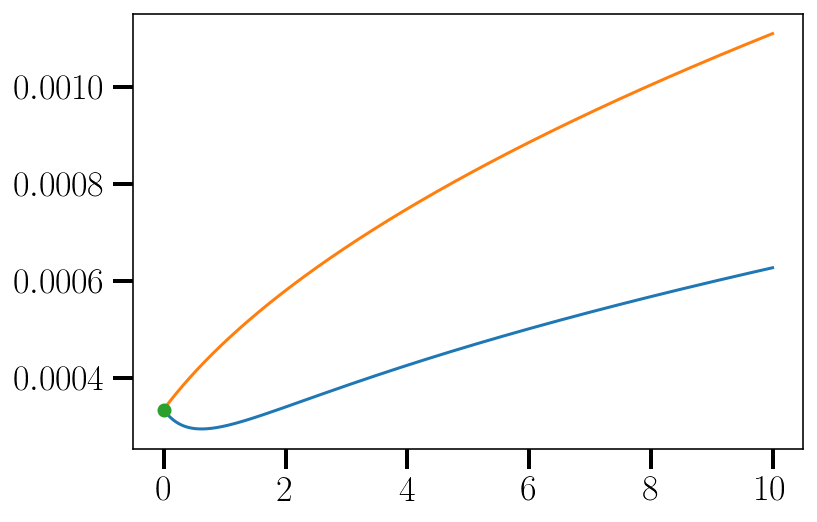

In [355]:
plt.plot(z_samps,H_c(z_samps))
a_samps = 1/(1+z_samps)
plt.plot(z_samps,0.000335*a_samps**(-1/2))
plt.plot(0,100/(3*10**5),'o')
#plt.plot(z_samps,H_cd(z_samps))

In [662]:
#%%time
z= 0
print(z)
#ok so set a comoving distance of observation
print(comoving_dist(z))

#set z ...
def get_class_powerspectrum(kk,zz): #h are needed to convert to 1/Mpc for k then convert pk back to (Mpc/h)^3
    
    return np.array([cosmo.pk_lin(ki, zz) for ki in kk*h])*h**3

def get_pkinfo_z(k,z):
    Plin = get_class_powerspectrum(k,z)
    Pk = interpolate.interp1d(k,Plin)#Plin
    Pk_d = interpolate.interp1d(k,np.gradient(Plin,k))#(k[1:]+k[:-1])/2,np.diff(Plin)/np.diff(k)
    Pk_dd = interpolate.interp1d(k,np.gradient(Pk_d(k),k))
    return Pk,Pk_d,Pk_dd

#so set parameters...
Pk,Pk_d,Pk_dd = get_pkinfo_z(k,z)
P1k,P1k_d,P1k_dd = get_pkinfo_z(k,0.1)

0
0.0


In [194]:
with open('../../mathematica_output.txt') as file:
    string1 = file.read()
    #string1 = convert_brackets(string1, 'P')
    string1 = string1.replace("Pk1d","Pkd1").replace("Pk2d","Pkd2").replace("Pk3d","Pkd3")
    #string1 = string1.replace('\n','').replace('  ','').replace("PLff", "Plin_dd").replace("PLf", "Plin_d").replace("PL", "Plin").replace("x", "d").replace("[Omega]", "Omega_m")
    #string1 = string1.replace("Pk^\[Prime]\[Prime]", "Plin_dd").replace("Derivative[1][Pk]", "Plin_d").replace("Pk", "Plin").replace("[ks]", "").replace("ks", "k")#for own calc
#print(string1.replace(". ", "").replace("\n", "").replace("\\", "").replace("x", "d").replace("kd^2", "(k*d**2)"))#.replace("k", "k[i]"))
#change multiplication and
python_mathematica = mathematica(string1)#
#print(str(python_mathematica).replace('cos','np.cos').replace('sin','np.sin').replace('sqrt','np.sqrt').replace('exp','np.exp'))


$$\ddot{F}+\mathcal{H} \dot{f}=\frac{3 H_0^2 \Omega_m}{2 a} (F+D^2)$$
$$\mathcal{H}^2(1+z)^2 F''+(\mathcal{H'}\mathcal{H}(1+z)^2) F'=\frac{3 H_0^2 \Omega_{m,0}}{2 a} (F+D^2)$$

In [401]:
#so lets solve for the second order growth function F ...
from scipy.integrate import odeint
c = 2.99792*10**5 #km/s
#first check with D
def D_test(u,zz): # so variables are F and H and D
    f,fd = u # unpack u vector
    return [fd,(-H_c(zz)*H_cd(zz)*(1+zz)**2 *fd + ((3*(100/c)**2 * Omega_m *(1+zz))/(2))*(f))/(H_c(zz)**2 *(1+zz)**2)]

# so this one starts in conformal time
def F_func(u,zz): # so variables are F and H and D
    f,fd = u # unpack u vector
    D_zz = D_intp(zz)
    return [fd,(-H_c(zz)*H_cd(zz)*(1+zz)**2 *fd + ((3*(100/c)**2 * Omega_m *(1+zz))/(2))*(f+D_zz**2))/(H_c(zz)**2 *(1+zz)**2)]

odeint_zz = np.linspace(20,0.04,int(1e+5))
#set initial params for D
D0 = [D_intp(odeint_zz[0]),dD_dz(odeint_zz[0])]
sol = odeint(D_test,D0,odeint_zz)

#set initial params for F
F0 = [(3/7)*D_intp(odeint_zz[0])**2,(3/7)*2*D_intp(odeint_zz[0])*dD_dz(odeint_zz[0])]
sol1 = odeint(F_func,F0,odeint_zz)

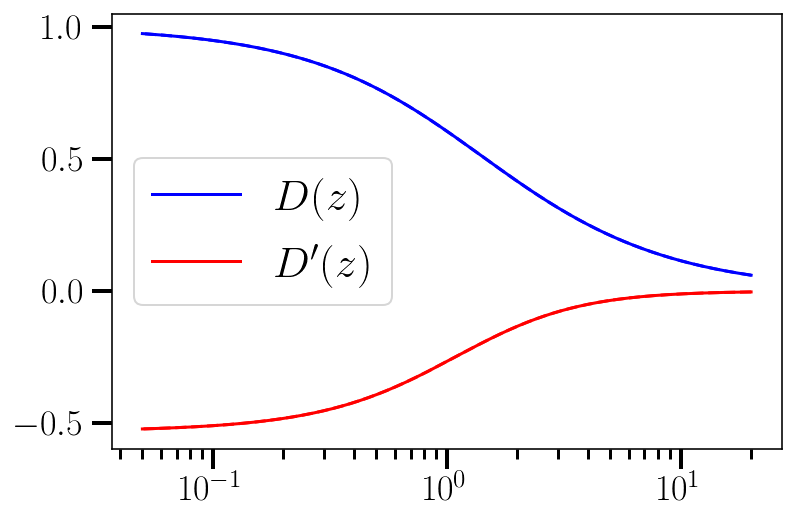

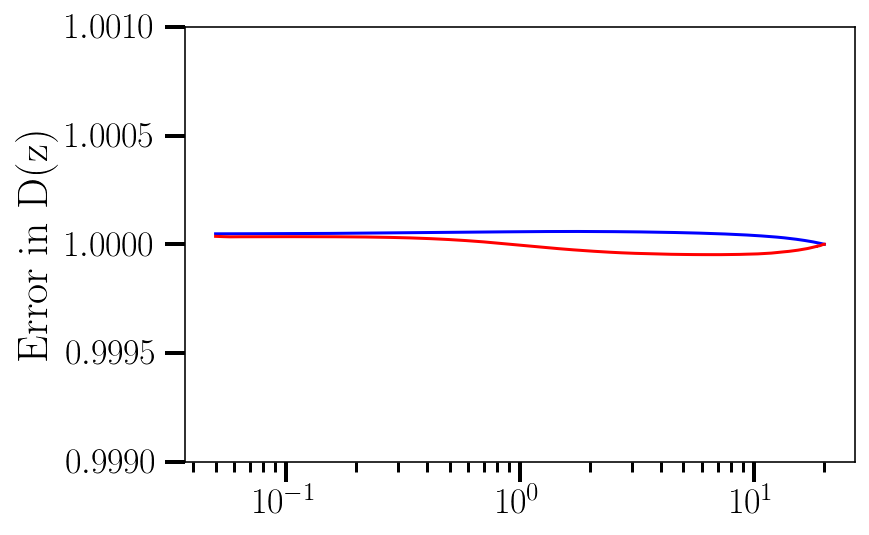

In [375]:
plt.plot(odeint_zz,sol[:,0],color='blue',label='$D(z)$')
plt.plot(odeint_zz,sol[:,1],color='red',label='$D\'(z)$')
plt.plot(odeint_zz,D_intp(odeint_zz),'--',color='blue')
plt.plot(odeint_zz,dD_dz(odeint_zz),'--',color='red')
plt.xscale('log')
#plt.ylim(0,2)
plt.legend()
plt.show()
plt.ylim(0.999,1.001)
plt.plot(odeint_zz,sol[:,0]/D_intp(odeint_zz),color='blue',label='$D(z)$')
plt.plot(odeint_zz,sol[:,1]/dD_dz(odeint_zz),color='red',label='$D\'(z)$')
plt.xscale('log')
plt.ylabel('Error in D(z)')
plt.show()

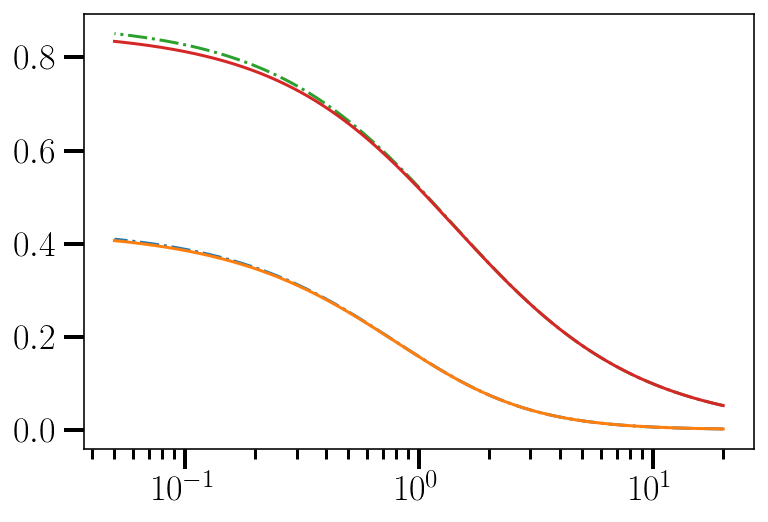

In [376]:
plt.plot(odeint_zz,sol1[:,0],'-.')
plt.plot(odeint_zz,(3/7)*sol[:,0]**2)

#plt.plot(odeint_zz,sol1[:,0]/sol[:,0],'--')
plt.plot(odeint_zz,sol1[:,1]/sol[:,1],'-.')
plt.plot(odeint_zz,(3/7)*2*sol[:,0])
plt.xscale('log')

### In Eds - u= v =1

$$v= \frac{7 F}{3D^2}$$

$$u = \frac{7}{3} C \equiv \frac{7}{3}\frac{\dot{F}}{2\dot{D}D}$$

$$\frac{d v}{ d ln(d)}= \frac{7}{3} (\frac{F'}{D^2}-\frac{2 D' F}{D^3})$$

$$K = \frac{F}{D^2}$$

$$C \equiv \frac{\dot{F}}{2\dot{D}D}$$




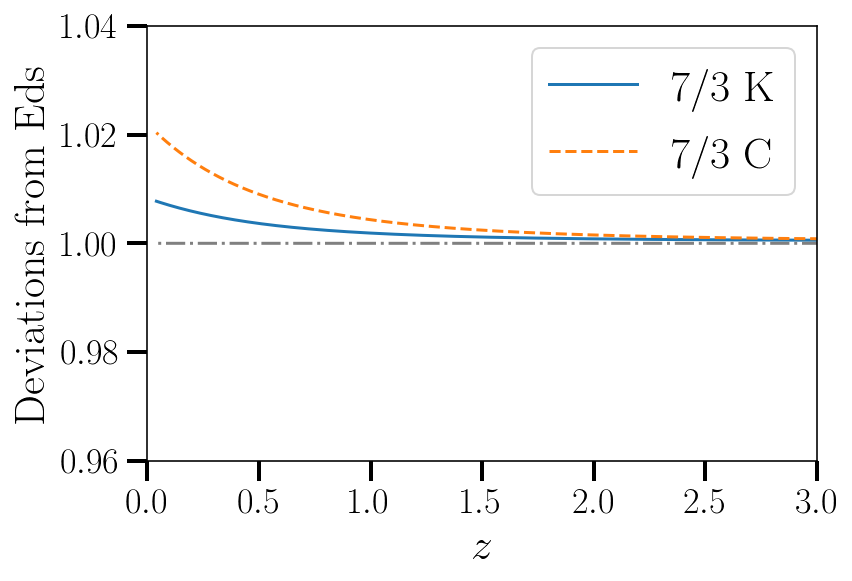

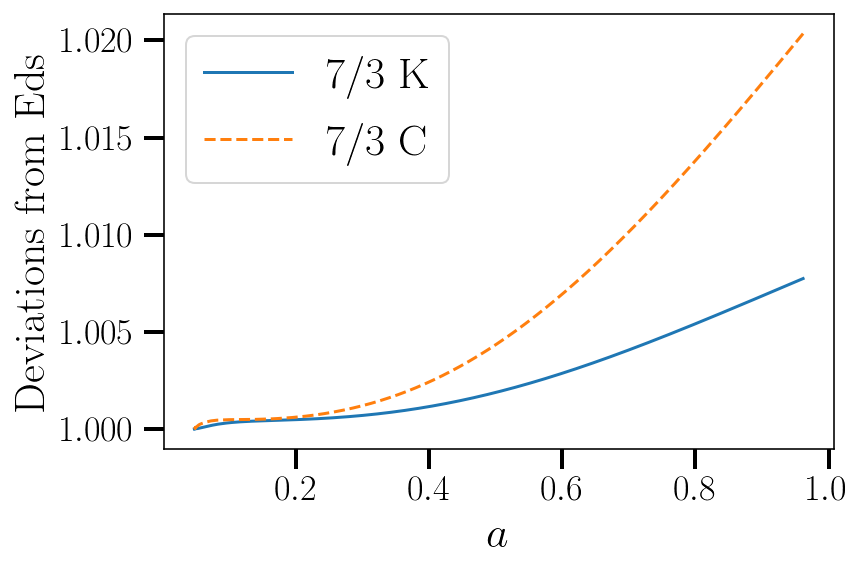

In [407]:
#deivations from Einstein-de-sitter

K = (sol1[:,0]/sol[:,0]**2)
C = sol1[:,1]/(2*sol[:,0]*sol[:,1])
K_intp = interp1d(odeint_zz,K,kind='cubic')
C_intp = interp1d(odeint_zz,C,kind='cubic')
v = (7/3)*K
u = (7/3)*C

plt.plot(odeint_zz,v,label='7/3 K')
plt.plot(odeint_zz,u,'--',label='7/3 C')
plt.plot(odeint_zz,np.ones_like(odeint_zz),'-.',color ='grey')
#plt.xscale('log')
plt.ylabel('Deviations from Eds')
plt.xlabel('$z$')
plt.legend()
plt.xlim(0,3)
plt.ylim(0.96,1.04)
plt.show()

plt.plot(1/(odeint_zz+1),v,label='7/3 K')
plt.plot(1/(odeint_zz+1),u,'--',label='7/3 C')
#plt.xscale('log')
plt.ylabel('Deviations from Eds')
plt.xlabel('$a$')
plt.legend()

## define all derivatives wrt to comoving distance

$\frac{df}{d ln(d)}=\frac{d d}{d ln(d)}\frac{dz}{dd}\frac{df}{dz}=d \times(1/\frac{dd}{dz})\frac{df}{dz}$

In [437]:
def b1_(zz):
    return np.sqrt(1+zz)
def g2_(zz):
    return -(2/7)*(b_1(zz)-1)
def b2_(zz):
    return 0.412 - 2.143*b_1(zz) +0.929*b_1(zz)**2 + 0.008*b_1(zz)**3 + 4/3 * g_2(zz)
#so get functions for derivatives
z_samps = np.linspace(0.05,10,10000)

#numerical deriv wrt z (z_samps)
db1_dz = interpolate.interp1d((z_samps[1:]+z_samps[:-1])/2,np.diff(b_1(z_samps))/np.diff(z_samps))#find numerical derivatives of biases
db2_dz = interpolate.interp1d((z_samps[1:]+z_samps[:-1])/2,np.diff(b_2(z_samps))/np.diff(z_samps))
dg2_dz = interpolate.interp1d((z_samps[1:]+z_samps[:-1])/2,np.diff(g_2(z_samps))/np.diff(z_samps))
df_dz = interpolate.interp1d((z_samps[1:]+z_samps[:-1])/2,np.diff(f_intp(z_samps))/np.diff(z_samps))
#dD_dz = interpolate.interp1d((z_samps[1:]+z_samps[:-1])/2,np.diff(D_intp(z_samps))/np.diff(z_samps))we actually define this before!
dK_dz = interpolate.interp1d((z_samps[1:]+z_samps[:-1])/2,np.diff(K_intp(z_samps))/np.diff(z_samps))
dC_dz = interpolate.interp1d((z_samps[1:]+z_samps[:-1])/2,np.diff(C_intp(z_samps))/np.diff(z_samps))

#so to get the derivataves wrt ln(d) 
#we have dd/dln(d) , dfunc/dz , dz/dd
def b1_d(zz):
    return (comoving_dist(zz))*db1_dz(zz)*(1/dd_dz(zz))
def b2_d(zz):
    return (comoving_dist(zz))*db2_dz(zz)*(1/dd_dz(zz))
def g2_d(zz):
    return (comoving_dist(zz))*dg2_dz(zz)*(1/dd_dz(zz))
def f_d(zz):
    return (comoving_dist(zz))*df_dz(zz)*(1/dd_dz(zz))
def D_d(zz):
    return (comoving_dist(zz))*dD_dz(zz)*(1/dd_dz(zz))
#time dependence of F2 G2
def K_d(zz):
    return (comoving_dist(zz))*dK_dz(zz)*(1/dd_dz(zz))
def C_d(zz):
    return (comoving_dist(zz))*dC_dz(zz)*(1/dd_dz(zz))

#for second derivatives we do numerically - need to inerpolate
z_samps2= np.linspace(0.06,9,10000)
b1_dd = interpolate.interp1d(z_samps2,np.gradient(b1_d(z_samps2),np.log(comoving_dist(z_samps2))))
b2_dd = interpolate.interp1d(z_samps2,np.gradient(b2_d(z_samps2),np.log(comoving_dist(z_samps2))))
g2_dd = interpolate.interp1d(z_samps2,np.gradient(g2_d(z_samps2),np.log(comoving_dist(z_samps2))))
f_dd = interpolate.interp1d(z_samps2,np.gradient(f_d(z_samps2),np.log(comoving_dist(z_samps2))))
D_dd = interpolate.interp1d(z_samps2,np.gradient(D_d(z_samps2),np.log(comoving_dist(z_samps2))))


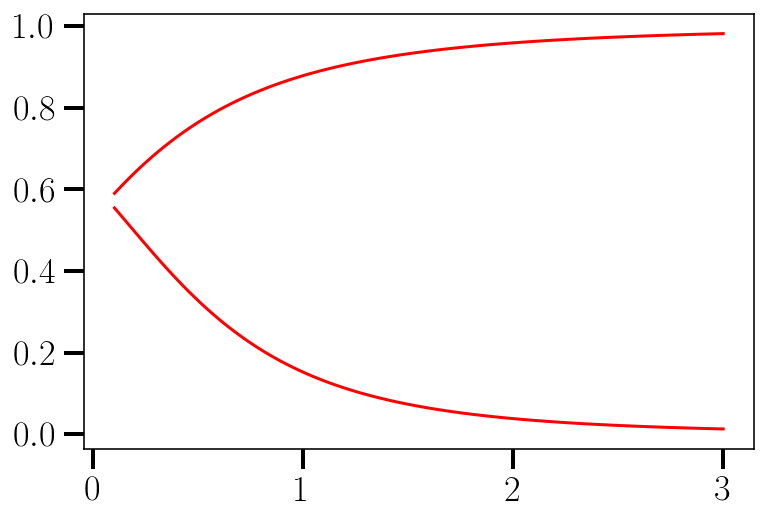

In [433]:
z_plot = np.linspace(0.1,3,100)
#plt.plot(z_plot,(comoving_dist(z_plot))*(1/dd_dz(z_plot)),'-',color='blue')
plt.plot(z_plot,df_dz(z_plot),'-',color='red')
plt.plot(z_plot,f_intp(z_plot),'-',color='red')

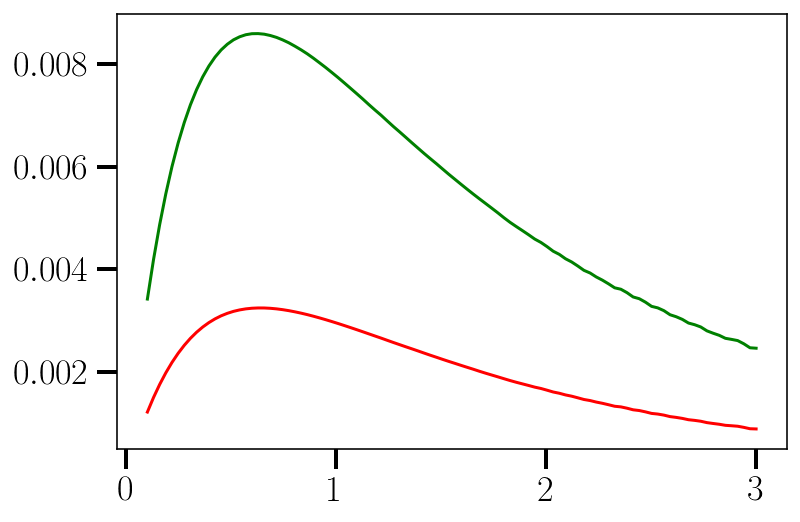

In [416]:
z_plot = np.linspace(0.1,3,100)
#plt.plot(z_plot,np.abs(b1_d(z_plot)/b1_(z_plot)),'-',color='blue')
plt.plot(z_plot,np.abs(K_d(z_plot)/K_intp(z_plot)),'-',color='red')
plt.plot(z_plot,np.abs(C_d(z_plot)/C_intp(z_plot)),'-',color='green')

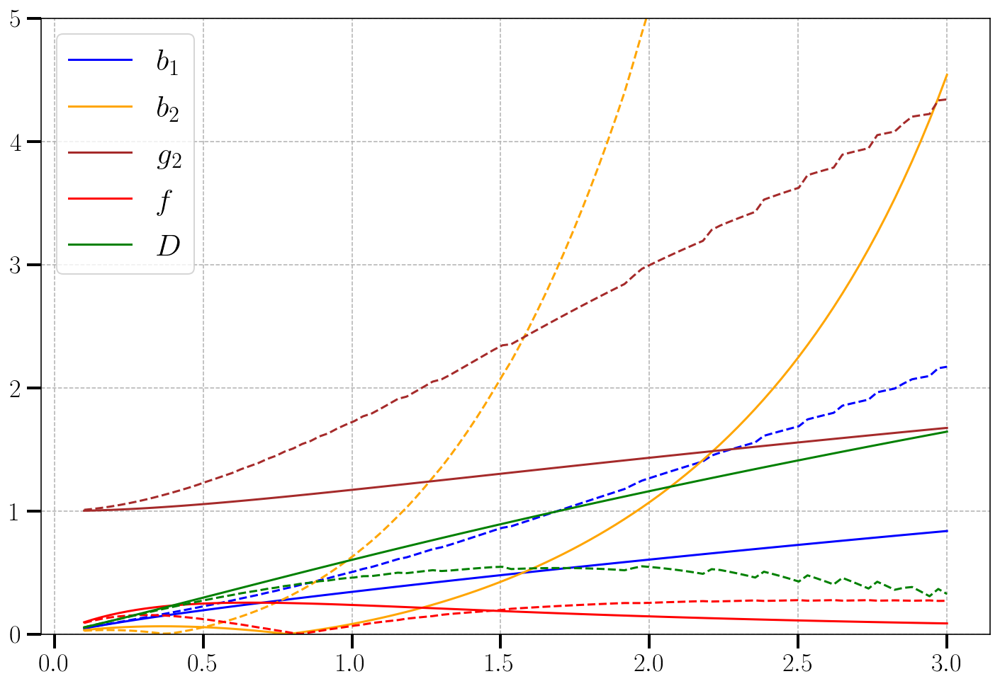

In [454]:
#plot ratio of derivates of biases to normal term which repersents the rough size of derivative terms to wide-angle terms
plt.figure(figsize=(12,8))
z_plot = np.linspace(0.1,3,100)
#plt.plot(z_plot,b1_(z_plot),'-',color='blue')
#plt.plot(z_plot,b1_d(z_plot),'--',color='blue')
plt.plot(z_plot,np.abs(b1_d(z_plot)/b1_(z_plot)),color='blue',label='$b_1$')
plt.plot(z_plot,np.abs(b1_dd(z_plot)/b1_(z_plot)),'--',color='blue')

plt.plot(z_plot,np.abs(b2_d(z_plot)/b2_(z_plot)),color='orange',label='$b_2$')
plt.plot(z_plot,np.abs(b2_dd(z_plot)/b2_(z_plot)),'--',color='orange')

plt.plot(z_plot,np.abs(g2_d(z_plot)/g2_(z_plot)),color='brown',label='$g_2$')
plt.plot(z_plot,np.abs(g2_dd(z_plot)/g2_(z_plot)),'--',color='brown')

plt.plot(z_plot,np.abs(f_d(z_plot)/f_intp(z_plot)),color='red',label='$f$')
plt.plot(z_plot,np.abs(f_dd(z_plot)/f_intp(z_plot)),'--',color='red')

plt.plot(z_plot,np.abs(D_d(z_plot)/D_intp(z_plot)),color='green',label='$D$')
plt.plot(z_plot,np.abs(D_dd(z_plot)/D_intp(z_plot)),'--',color='green')

plt.grid(ls='--',lw=0.75)
plt.ylim(0,5)
plt.legend()
#plt.plot(z_samps2,eta(z_samps2))

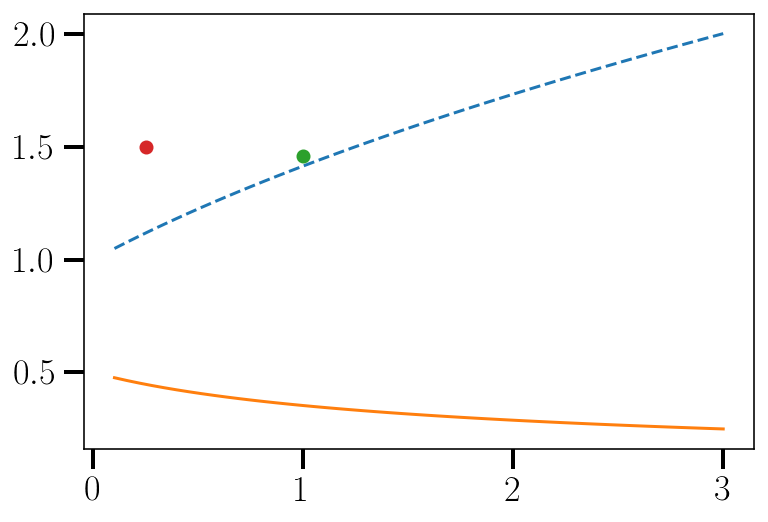

In [17]:
z_plot = np.linspace(0.1,3)
plt.plot(z_plot,b_1(z_plot),'--')

plt.plot(1,1.46,'o')
plt.plot(0.25,1.5,'o')

In [ ]:
#lets define the betas
beta = {}
betad = {}

def beta6(zz):
    return H**2 *(3/2)*Om*(2-2*f+b_e-4*Q-2*(1-Q)/(xi*H)-H_d/H**2)
def beta7(zz):
    return H**2 f*(3-b_e)


beta['6'] = 
be

## start with expression for each term!

In [550]:
k3 = np.sqrt(k1**2 + k2**2 + 2*k1*k2*np.cos(theta))
k3 = np.where(k3==0,1e-3,k3)
def get_params(k1,k2,k3,zz):
    """Import interpolated funcs?"""
    Pk1 = Pk(k1)
    Pk2 = Pk(k2)
    Pk3 = Pk(k3)

    Pkd1 = Pk_d(k1)
    Pkd2 = Pk_d(k2)
    Pkd3 = Pk_d(k3)
    
    Pkdd1= Pk_dd(k1)
    Pkdd2 = Pk_dd(k2)
    Pkdd3 = Pk_dd(k3)
    
    #redshift dependendent terms
    K = K_intp(zz)
    C = C_intp(zz)
    
    f = f_intp(zz)
    D1 = D_intp(zz)
    b1 = b_1(zz)
    b2 = b_2(zz)
    g2 = g_2(zz)
    return Pk1,Pk2,Pk3,Pkd1,Pkd2,Pkd3,Pkdd1,Pkdd2,Pkdd3,K,C,f,D1,b1,b2,g2

def get_derivs(k1,k2,k3,zz):
    #1st deriv
    fd = f_d(zz)
    Dd = D_d(zz)
    gd2 = g2_d(zz)
    bd2 = b2_d(zz)
    bd1 = b1_d(zz)
    #2nd deriv
    fdd = f_dd(zz)
    Ddd = D_dd(zz)
    gdd2 = g2_dd(zz)
    bdd2 = b2_dd(zz)
    bdd1 = b1_dd(zz)
def get_GRbetas(k1,k2,k3,zz):
    #GR parts
    beta6 = beta['6'](zz)
    beta7 = beta['7'](zz)
    beta8 = beta['8'](zz)
    beta9 = beta['9'](zz)
    beta10 = beta['10'](zz)
    beta11 = beta['11'](zz)
    beta12 = beta['12'](zz)
    beta13 = beta['13'](zz)
    beta14 = beta['14'](zz)
    beta15 = beta['15'](zz)
    beta16 = beta['16'](zz)
    beta17 = beta['17'](zz)
    beta18 = beta['18'](zz)
    beta19 = beta['19'](zz)
    
    betad14 = beta_d['14'](zz)
    betad15 = beta_d['15'](zz)
    betad16 = beta_d['16'](zz)
    betad17 = beta_d['17'](zz)
    betad18 = beta_d['18'](zz)
    betad19 = beta_d['19'](zz)
    return 1

In [637]:
import json

with open('mathematica_expr/P23GR0l2.json') as f:
    data = json.load(f)
tmpexp = str(mathematica(data)).replace('I*','1j*').replace('-I*','-1j*').replace('sqrt(','np.sqrt(').replace('pi','np.pi')
print(tmpexp)

-D1**4*Pk2*Pk3*f*(-5*f**3*k1**2*k2**3*sin(theta)**3 + 198*f*k1**2*k2**3*(-K*b1 + b1 + 2*g2)*sin(theta)**2*cos(theta)**2 + 4*f*k1**2*k2**3*(99*b1*(K - 1) + 70*f**2 + f*(165*C - 165) - 198*g2)*cos(theta)**6 + 6*f*k1*k2**2*(11*b1*(k1**2*(12*K - 12) + k2**2*(12*K - 5*f - 6) + k3**2*(5*f + 6)) + 140*f**2*k1**2 + 55*f*(k1**2*(4*C - 4) + k2**2*(4*C - 3) + k3**2) - 264*g2*(k1**2 + k2**2))*cos(theta)**5 + 198*f*k1*(f*(b1*k1**2*k3**2 - k2**4 + k2**2*k3**2) + k2**2*(K*b1*(k2**2 - k3**2) - b2*k3**2))*sin(theta)*cos(theta) + 18*f*k2*(f**2*k1**4 + 11*k2**2*(K*b1*(-k2**2 + k3**2) + b2*k3**2 + 2*g2*(k2**2 - k3**2)))*sin(theta)**2 + 2*k1*(231*b1*(2*b1*k1**2*k2**2*(K - 1) + b1*(k2**2 + k3**2)*(k2**2*(2*K - 1) + k3**2) - 4*g2*k2**2*(k1**2 + k2**2 + k3**2)) + 140*f**3*k1**4 + 165*f**2*(k1**2*(k2**2*(4*C - 3) + k3**2*(2*b1 + 1)) + k2**2*(4*C - 2)*(k2**2 - k3**2)) + 3*f*k2**2*(11*b1*(k1**2*(3*K - 3) + k2**2*(6*K - 5*f - 3) + k3**2*(5*f + 3)) + 125*f**2*k1**2 + 33*f*(k1**2*(2*C - 2) + k2**2*(4*C - 3) + k3**2

In [531]:
with open("tmp.txt", "w") as file:
    file.write(str(tmpexp))

In [639]:
#PP stuff
class GR0:
    def l0():
        perm12 = D1**4*Pk1*Pk2*(-f**2*k1*k2**3*(18*C - 18)*(7*b1 + 5*f)*cos(theta)**6 + f**2*k2**2*(-9*b1*(-5*f*k3**2 + k1**2*(28*C - 35) - 7*k2**2) + 5*f*(7*f*k3**2 + k1**2*(45 - 36*C) + 9*k2**2))*cos(theta)**5 + f*k1*k2*(-21*b1**2*(k2**2*(10*C - 10) + k3**2*(5*K - 3*f - 5)) + 3*b1*(45*f**2*k3**2 - 21*f*(k1**2*(2*C - 4) - 4*k2**2 + k3**2*(K - 1)) + 70*g2*k3**2) - f*k2**2*(36*C - 36)*(7*b1 + 3*f)*sin(theta) + 2*f*(35*f**2*k3**2 + f*k1**2*(90 - 45*C) + f*k2**2*(45*C + 45) + 63*g2*k3**2))*cos(theta)**4 + f*(-21*b1**2*(k1**2*(k2**2*(20*C - 25) - k3**2*(3*f + 5)) - k2**2*(5*k2**2 + k3**2*(6*f + 5))) + 9*b1*f*(7*k1**4 + k1**2*(42*k2**2 + k3**2*(10*f + 7)) + 7*k2**4 + k2**2*k3**2*(10*f + 7)) + 5*f**2*k1**2*(7*f*k3**2 + 9*k1**2 + k2**2*(36*C + 9)) + 2*f*k2**2*(-9*b1*(-5*f*k3**2 + k1**2*(14*C - 21) - 7*k2**2) + f*(25*f*k3**2 + k1**2*(81 - 54*C) + 27*k2**2))*sin(theta))*cos(theta)**3 + 3*k1*k2*(35*b1**3*k3**2*(-3*K + f + 3) + 14*b1**2*(6*f**2*k3**2 + 5*f*(-k1**2*(C - 2) + k2**2*(C + 1) + k3**2) + 15*g2*k3**2) + b1*f*(35*b2*k3**2 + 45*f**2*k3**2 + 21*f*(4*k1**2 + k2**2*(2*C + 2) + k3**2*(K + 1))) + 3*f**2*(10*C*f*k1**2 + k3**2*(7*b2 - 14*g2)) + f*(-7*b1**2*(k2**2*(10*C - 10) + k3**2*(5*K - 6*f - 5)) + b1*(54*f**2*k3**2 - 7*f*(k1**2*(2*C - 8) - k2**2*(10*C + 8) + k3**2*(K - 1)) + 70*g2*k3**2) + 2*f*(10*f**2*k3**2 + f*k1**2*(12 - 3*C) + f*k2**2*(18*C + 9) + 7*g2*k3**2))*sin(theta))*cos(theta)**2 + 3*k2*(7*b1*k1*(10*C*b1*f*k1**2 + 6*C*f**2*k1**2 + 5*b1**2*k3**2*(3*K + f + 3) + b1*k3**2*(15*b2 + 3*f**2 + 5*f*(K + 1) - 30*g2) + 5*f*k3**2*(b2 - 2*g2)) + f**2*k1*(21*b1**2*k3**2 + 9*b1*f*k3**2 + 21*b1*k2**2*(C + 1) + 2*f**2*k3**2 + f*k2**2*(3*C + 3) - k2**2*(3*C - 3)*(7*b1 + f)*cos(2*theta))*sin(theta)**2 + 3*f**2*k2*(6*C*f*k1**2 + 7*b1**2*k3**2)*sin(2*theta) + f*k1*(35*b1**3*k3**2 + 7*b1**2*(10*C*k2**2 + k3**2*(5*K + 4*f + 5)) + b1*(14*C*f*(k1**2 + k2**2) + k3**2*(35*b2 + 9*f**2 + 7*f*(K + 1) - 70*g2)) + f*(6*C*f*k1**2 + k3**2*(7*b2 - 14*g2)))*sin(theta)) + 3*(b1*(35*b1**2*k3**2*(f + 3)*(k1**2 + k2**2) + 7*b1*f*(5*k1**4 + k1**2*(k2**2*(20*C + 5) + k3**2*(6*f + 5)) + k2**2*k3**2*(3*f + 5)) + 3*f**2*k1**2*(5*f*k3**2 + 7*k1**2 + k2**2*(28*C + 7))) + f**2*k2**2*(3*b1*(5*f*k3**2 + 7*k1**2 + 7*k2**2) + f*(5*f*k3**2 + 3*k1**2 + 3*k2**2))*sin(theta)**2 + f*(7*b1**2*(k1**2*(5*k2**2 + k3**2*(3*f + 5)) + 5*k2**2*(k2**2 + k3**2)) + b1*f*(7*k1**4 + k1**2*(k2**2*(84*C + 14) + k3**2*(18*f + 7)) + 7*k2**4 + k2**2*k3**2*(18*f + 7)) + f**2*k1**2*(5*f*k3**2 + 3*k1**2 + 3*k2**2))*sin(theta))*cos(theta))/(315*k1*k2*k3**2)
        perm13 = D1**4*Pk1*Pk3*(-3*f**2*k1*k2**4*(3*C - 3)*(7*b1 + f)*sin(2*theta)**2/2 - f**2*k1*k2**4*(18*C - 18)*(7*b1 + 5*f)*cos(theta)**6 - 9*f**2*k1*k2**2*(-7*b1**2*k2**2 + b1*(2*f*k2**2 + k1**2*(14*C - 7) + k3**2*(7 - 14*C)) + f*(f*k2**2 + k1**2*(2*C - 1) + k3**2*(1 - 2*C)))*sin(theta)**2 - f**2*k2**3*(9*b1*(5*f*k2**2 + k1**2*(56*C - 49) + 7*k3**2) + 5*f*(7*f*k2**2 + k1**2*(72*C - 63) + 9*k3**2))*cos(theta)**5 - 3*f**2*k2*(2*C*k1**2*(-14*b1*k3**2 + 12*f*k1**2 - 9*f*k3**2) + 21*b1**2*k2**2*k3**2)*sin(2*theta) - 3*f*k1*k2**2*(-7*b1**2*(k2**2*(-5*K + 3*f + 5) - k3**2*(10*C - 10)) + b1*(30*f**2*k2**2 + 21*f*(k1**2*(12*C - 9) + k2**2*(K - 1) + k3**2) - 70*g2*k2**2) + f*k2**2*(12*C - 12)*(7*b1 + 3*f)*sin(theta) + f*(35*f**2*k2**2 + 15*f*(k1**2*(12*C - 9) + k3**2*(3 - 2*C)) - 42*g2*k2**2))*cos(theta)**4 + f*k1*(105*b1**3*k2**2*k3**2 + 21*b1**2*(f*k2**2*(3*k1**2 - 2*k3**2) - (5*k1**2 - 5*k3**2)*(K*k2**2 + k3**2*(2*C - 1))) + 3*b1*(3*f**2*k2**2*(2*k1**2 - 3*k3**2) - 7*f*(k1**2 - k3**2)*(K*k2**2 + k1**2*(2*C - 1) + k3**2*(2*C - 1)) + 35*k2**2*(b2*k3**2 + 2*g2*(k1**2 - k3**2))) + f*(-5*f**2*k1**2*k2**2 - f*k1**2*(18*C - 9)*(k1**2 - k3**2) + 21*k2**2*(b2*k3**2 + 2*g2*(k1**2 - k3**2))))*sin(theta) - f*k2*(-21*b1**2*(k1**2*(k2**2*(-20*K + 9*f + 15) + k3**2*(15 - 20*C)) - k3**2*(k2**2*(6*f + 5) + 5*k3**2)) + 3*b1*(30*f**2*k2**2*k3**2 + 21*f*(k1**4*(8*C - 5) + k1**2*k2**2*(4*K - 3) + k3**2*(k2**2 + k3**2)) - 280*g2*k1**2*k2**2) + 3*f*k1**2*(35*f**2*k2**2 + 15*f*(k1**2*(8*C - 5) + k3**2*(3 - 4*C)) - 168*g2*k2**2) + 2*f*k2**2*(9*b1*(5*f*k2**2 + k1**2*(42*C - 35) + 7*k3**2) + f*(25*f*k2**2 + k1**2*(162*C - 135) + 27*k3**2))*sin(theta))*cos(theta)**3 - 21*k1*(15*b1**2*k3**2 + 5*b1*f*(k1**2 + k3**2) + 3*f**2*k1**2)*(K*b1*(k1**2 - k3**2) - b2*k3**2 - 2*g2*(k1**2 - k3**2)) + k1*(105*b1**3*k2**2*k3**2*(-3*K + f + 3) + 21*b1**2*(3*f**2*k2**2*(3*k1**2 - 2*k3**2) - 5*f*(k1**2*(k2**2*(6*K - 3) + k3**2*(2*C - 1)) + k3**2*(k2**2 + k3**2*(1 - 2*C))) + 30*g2*k2**2*k3**2) + 3*b1*f*(15*f**2*k2**2*(2*k1**2 - 3*k3**2) - 21*f*(k1**4*(2*C - 1) + k1**2*k2**2*(6*K - 3) - k2**2*k3**2*(K - 2) + k3**4*(1 - 2*C)) + 35*k2**2*(b2*k3**2 + 12*g2*k1**2)) + f**2*(-35*f**2*k1**2*k2**2 - f*k1**2*(90*C - 45)*(k1**2 - k3**2) + 63*k2**2*(b2*k3**2 + 12*g2*k1**2 - 2*g2*k3**2)) + 3*f*k2**2*(7*b1**2*(k2**2*(-5*K + 6*f + 5) - k3**2*(10*C - 10)) + b1*(-36*f**2*k2**2 - 7*f*(k1**2*(38*C - 26) + k2**2*(K - 1) - k3**2*(10*C - 10)) + 70*g2*k2**2) + 2*f*(-15*f**2*k2**2 + f*k1**2*(39 - 57*C) + f*k3**2*(18*C - 18) + 7*g2*k2**2))*sin(theta))*cos(theta)**2 - 3*k2*(35*b1**3*k3**2*(-k1**2*(-6*K + f + 3) + k3**2*(f + 3)) - 7*b1**2*(3*f**2*(k1**4 - k3**4) - 5*f*(k1**4*(4*K - 1) + k3**4) + 60*g2*k1**2*k3**2) - b1*f*k1**2*(70*b2*k3**2 + 15*f**2*(k1**2 - k3**2) - 21*f*(k1**2*(4*K - 1) + k3**2*(1 - 2*K)) + 280*g2*k1**2) - 42*f**2*k1**2*(b2*k3**2 + 4*g2*k1**2 - 2*g2*k3**2) + f**2*k2**2*(3*b1*(5*f*k2**2 + k1**2*(28*C - 21) + 7*k3**2) + f*(5*f*k2**2 + k1**2*(12*C - 9) + 3*k3**2))*sin(theta)**2 + f*(-7*b1**2*(k1**2*(k2**2*(-10*K + 9*f + 5) + k3**2*(15 - 20*C)) - 5*k3**2*(k2**2 + k3**2)) + b1*(18*f**2*k2**2*k3**2 + 7*f*(k1**4*(16*C - 9) + k1**2*(k2**2*(2*K - 1) + 4*k3**2) + k3**2*(k2**2 + k3**2)) - 140*g2*k1**2*k2**2) + f*k1**2*(15*f**2*k2**2 - 27*f*k1**2 + 21*f*k3**2 - 28*g2*k2**2))*sin(theta))*cos(theta))/(315*k1*k3**4)
        perm23 = D1**4*Pk2*Pk3*(-f**2*k1**2*k2**3*(63*b1*(K - 1) + 35*f**2 + f*(90*C - 90) - 126*g2)*cos(theta)**6 - 3*f**2*k1*k2**2*(3*b1*(k1**2*(14*K - 14) + k2**2*(14*K - 5*f - 7) + k3**2*(5*f + 7)) + 35*f**2*k1**2 + 15*f*(k1**2*(4*C - 4) + k2**2*(4*C - 3) + k3**2) - 84*g2*(k1**2 + k2**2))*cos(theta)**5 - f*k1*(105*b1*(2*b1*k1**2*k2**2*(K - 1) + b1*(k2**2 + k3**2)*(k2**2*(2*K - 1) + k3**2) - 4*g2*k2**2*(k1**2 + k2**2 + k3**2)) + 35*f**3*k1**4 + 45*f**2*(k1**2*(k2**2*(4*C - 3) + k3**2*(2*b1 + 1)) + k2**2*(4*C - 2)*(k2**2 - k3**2)) + 6*f*k2**2*(3*b1*(k1**2*(7*K - 7) + k2**2*(14*K - 5*f - 7) + k3**2*(5*f + 7)) + 25*f**2*k1**2 + 9*f*(k1**2*(2*C - 2) + k2**2*(4*C - 3) + k3**2) - 42*g2*(k1**2 + 2*k2**2))*sin(theta) - 63*f*(b1**2*(k2**4 - k3**4) - b1*(k1**2*(k2**2*(4*C + 2*K - 5) + k3**2) + k2**4*(4*C + 2*K - 3) + k2**2*k3**2*(4*C - 2*K - 2) + k3**4) + 2*k2**2*(b2*k3**2 + 2*g2*(k1**2 + k2**2 - k3**2))))*cos(theta)**3 - 3*f*k2*(35*b1**2*k1**2*(K - 1)*(k2**2 + k3**2) + b1*(15*f**2*k1**2*(-2*k2**2 + 3*k3**2) + 21*f*(K*k2**2*(k2**2 - k3**2) + k1**4*(K - 1) + 2*k1**2*(C*k3**2 + k2**2*(C + 2*K - 2))) - 70*g2*k1**2*(k2**2 + k3**2)) + f*k1**2*k2**2*(42*b1*(K - 1) + 25*f**2 + f*(36*C - 36) - 84*g2)*sin(theta) + f*(-21*b2*k2**2*k3**2 + 35*f**2*k1**4 + 15*f*(k1**4*(2*C - 2) + 2*k1**2*(k2**2*(4*C - 3) + k3**2) + k2**2*(2*C - 1)*(k2**2 - k3**2)) - 42*g2*(k1**4 + 4*k1**2*k2**2 + k2**4 - k2**2*k3**2)))*cos(theta)**4 - 3*k1*(b1*(105*b1*k3**2*(b1*(k2**2*(2*K - 1) + k3**2) - 4*g2*k2**2) + 15*f**3*k1**4 - 21*f**2*(k1**2*(k2**2*(-4*C + 3*b1 + 3) - k3**2*(2*b1 + 1)) + k2**2*(2 - 4*C)*(k2**2 - k3**2)) - 35*f*(b1**2*k3**2*(k2**2 - k3**2) - b1*(2*K*(k2**4 - k2**2*k3**2) + k1**2*(k2**2*(2*K - 1) + k3**2) + k2**2*k3**2*(4*C - 3) + k3**4) + 2*k2**2*(b2*k3**2 + 2*g2*(k1**2 + k2**2 - k3**2)))) + 3*f**2*k2**2*(-7*b1*(k2**2 - k3**2) + 5*f**2*k1**2 + f*k2**2*(4*C - 5*b1 - 3) + f*k3**2*(5*b1 + 1) - 28*g2*k2**2)*sin(theta)**2 + f*(35*b1*(k2**2 + k3**2)*(b1*(k2**2*(2*K - 1) + k3**2) - 4*g2*k2**2) + 5*f**3*k1**4 + 3*f**2*(k1**2*(k2**2*(4*C - 3) + k3**2*(6*b1 + 1)) - 6*k2**4 + 6*k2**2*k3**2) - 7*f*(3*b1**2*(k2**4 - k3**4) - b1*(k1**2*(k2**2*(2*K - 1) + k3**2) + (k2**2 + k3**2)*(k2**2*(4*C - 3) + k3**2)) + 4*g2*k2**2*(k1**2 + 3*k2**2 - 3*k3**2)))*sin(theta))*cos(theta) - k2*(-42*b1*(5*b1**2*k3**2*(3*K*(-k2**2 + k3**2) + f*k1**2) + b1*(15*b2*k3**4 + 3*f**2*k1**4 - 5*f*(k2**2 - k3**2)*(K*k1**2 + k3**2*(2*C - 1)) + 30*g2*k3**2*(k2**2 - k3**2)) + f*k1**2*(5*b2*k3**2 - f*(6*C - 3)*(k2**2 - k3**2) + 10*g2*(k2**2 - k3**2))) + 10*f**4*k1**2*k2**2*sin(theta)**3 + 9*f**2*k1**2*k2**2*(f*(C - 1) - 7*g2)*sin(2*theta)**2 + 18*f**2*k1*k2*(6*C*f*(k2**2 - k3**2) + 7*K*b1*(k2**2 - k3**2) - 7*b2*k3**2)*sin(2*theta) + 18*f**2*(f**2*k1**4 + f*(b1*k1**2*(-2*k2**2 + 3*k3**2) + k2**2*(2*C - 1)*(k2**2 - k3**2)) - 7*k2**2*(K*b1*(-k2**2 + k3**2) + b2*k3**2 + 2*g2*(k2**2 - k3**2)))*sin(theta)**2 + 6*f*(21*K*b1*f*k1*k2**3*sin(2*theta) - 7*b1**2*(5*K*(-k2**4 + k3**4) + f*k1**2*(3*k2**2 - 2*k3**2)) + b1*(6*f**2*k1**4 + 7*f*(k2**2 - k3**2)*(K*k1**2 + (2*C - 1)*(k2**2 + k3**2)) - (35*k2**2 + 35*k3**2)*(b2*k3**2 + 2*g2*(k2**2 - k3**2))) + f*k1**2*(-7*b2*k3**2 + f*(6*C - 3)*(k2**2 - k3**2) - 14*g2*k2**2 + 14*g2*k3**2))*sin(theta))/2 + 3*k2*(-140*C*b1**2*f*k1**2*k3**2 - 84*C*b1*f**2*k1**4 - 336*C*b1*f**2*k1**2*k2**2 - 84*C*b1*f**2*k2**4 + 84*C*b1*f**2*k3**4 - 60*C*f**3*k1**2*k2**2 + 60*C*f**3*k1**2*k3**2 - 210*K*b1**3*k1**2*k3**2 - 70*K*b1**2*f*k1**4 - 280*K*b1**2*f*k1**2*k2**2 - 70*K*b1**2*f*k2**4 + 70*K*b1**2*f*k3**4 - 63*K*b1*f**2*k1**2*k2**2 + 42*K*b1*f**2*k1**2*k3**2 + 210*b1**3*k1**2*k3**2 + 126*b1**2*f**2*k1**2*k2**2 - 84*b1**2*f**2*k1**2*k3**2 + 70*b1**2*f*k1**4 + 140*b1**2*f*k1**2*k2**2 + 420*b1**2*g2*k1**2*k3**2 + 70*b1*b2*f*k2**2*k3**2 + 70*b1*b2*f*k3**4 - 60*b1*f**3*k1**4 + 84*b1*f**2*k1**4 + 273*b1*f**2*k1**2*k2**2 - 84*b1*f**2*k1**2*k3**2 + 42*b1*f**2*k2**4 - 42*b1*f**2*k3**4 + 140*b1*f*g2*k1**4 + 560*b1*f*g2*k1**2*k2**2 + 140*b1*f*g2*k2**4 - 140*b1*f*g2*k3**4 + 42*b2*f**2*k1**2*k3**2 - 15*f**4*k1**2*k2**2 + 30*f**3*k1**2*k2**2 - 30*f**3*k1**2*k3**2 + 84*f**2*g2*k1**2*k2**2 - 84*f**2*g2*k1**2*k3**2 + 3*f**2*k1**2*k2**2*(7*b1*(K - 1) + 5*f**2)*cos(2*theta) - 2*f*(35*b1**2*k1**2*(K - 1)*(k2**2 + k3**2) + b1*(18*f**2*k1**2*(-2*k2**2 + 3*k3**2) + 7*f*(6*K*k2**2*(k2**2 - k3**2) + k1**4*(K - 1) + 2*k1**2*(k2**2*(C + 6*K - 4) + k3**2*(C + 2))) - 70*g2*k1**2*(k2**2 + k3**2)) + 2*f*(-21*b2*k2**2*k3**2 + 15*f**2*k1**4 + 3*f*(k1**4*(C - 1) + 3*k1**2*(k2**2*(4*C - 3) + k3**2) + k2**2*(6*C - 3)*(k2**2 - k3**2)) - 7*g2*(k1**4 + 12*k1**2*k2**2 + 6*k2**4 - 6*k2**2*k3**2)))*sin(theta))*cos(theta)**2/2)/(315*k2*k3**4)
        return perm12+perm13+perm23
    
    def l2():
        perm12 = D1**4*Pk1*Pk2*f*(33*b1*(-f*k1*k2**3*(3*C - 3)*cos(4*theta) + 6*f*k3**2*(b1*k2**2 + f*(k1**2 + k2**2))*sin(2*theta) + k1*k2*(56*C*b1*k1**2 + 3*C*f*(16*k1**2 + k2**2) + 28*b1**2*k3**2 + 4*b1*k3**2*(7*K + 6*f + 7) + 28*b2*k3**2 - 3*f*k2**2 - 56*g2*k3**2))/2 - f*k1*k2**3*(132*C - 132)*(6*b1 + 5*f)*cos(theta)**6 + 6*f*k1*k2*(-66*C*b1*k2**2 - 33*b1**2*k3**2 + 2*f**2*k3**2)*sin(theta)**2 + 2*f*k2**2*(-33*b1*(-5*f*k3**2 + k1**2*(24*C - 30) - 6*k2**2) + 5*f*(28*f*k3**2 + k1**2*(165 - 132*C) + 33*k2**2))*cos(theta)**5 - 2*k1*k2*(33*b1**2*(k2**2*(14*C - 14) + k3**2*(7*K - 6*f - 7)) - 33*b1*(15*f**2*k3**2 - 6*f*(k1**2*(2*C - 4) - 4*k2**2 + k3**2*(K - 1)) + 14*g2*k3**2) + f*k2**2*(198*C - 198)*(b1 + f)*sin(theta) - 2*f*(140*f**2*k3**2 - 165*f*(k1**2*(C - 2) - k2**2*(C + 1)) + 198*g2*k3**2))*cos(theta)**4 + 3*k1*k2*(154*b1**3*k3**2 + 44*b1**2*(k1**2*(14 - 7*C) + k2**2*(7*C + 7) + k3**2*(12*f + 7)) + 22*b1*(7*b2*k3**2 + 15*f**2*k3**2 + 6*f*(4*k1**2 + k2**2*(2*C + 2) + k3**2*(K + 1))) + 44*f*(5*C*f*k1**2 + k3**2*(3*b2 - 6*g2)) + (11*b1**2*(k2**2*(14*C - 14) + k3**2*(7*K + 6*f - 7)) + 11*b1*(18*f**2*k3**2 + f*(k1**2*(8 - 2*C) + k2**2*(10*C + 8) - k3**2*(K - 1)) - 14*g2*k3**2) + 2*f*(50*f**2*k3**2 + f*k1**2*(44 - 11*C) + f*k2**2*(66*C + 33) + 11*g2*k3**2))*sin(theta))*cos(theta)**2 - 33*k2*(3*b1*f*k2*(k1**2 + k2**2)*sin(2*theta) - k1*(-7*b1**3*k3**2 - b1**2*(14*C*k2**2 + k3**2*(7*K - 4*f + 7)) + b1*(2*C*f*(k1**2 + k2**2) + k3**2*(K*f - 7*b2 + 3*f**2 + f + 14*g2)) + f*(2*C*f*k1**2 + k3**2*(b2 - 2*g2))))*sin(theta) + 3*(22*b1*(7*b1**2*k3**2*(k1**2 + k2**2) + b1*(7*k1**4 + k1**2*(k2**2*(28*C + 7) + k3**2*(12*f + 7)) + k2**2*k3**2*(6*f + 7)) + f*k1**2*(5*f*k3**2 + 6*k1**2 + k2**2*(24*C + 6))) + 10*f**3*k2**2*k3**2*sin(theta)**2 + (-11*b1**2*(k1**2*(7*k2**2 + k3**2*(7 - 3*f)) + 7*k2**2*(k2**2 + k3**2)) + 11*b1*f*(k1**4 + k1**2*(k2**2*(12*C + 2) + k3**2) + k2**2*(k2**2 + k3**2)) + f**2*k1**2*(25*f*k3**2 + 11*k1**2 + k2**2*(132*C + 11)))*sin(theta))*cos(theta) + 2*(-33*b1**2*(k1**2*(k2**2*(28*C - 35) - k3**2*(6*f + 7)) - k2**2*(7*k2**2 + k3**2*(12*f + 7))) + 66*b1*f*(3*k1**4 + k1**2*(18*k2**2 + k3**2*(5*f + 3)) + 3*k2**4 + k2**2*k3**2*(5*f + 3)) + 5*f**2*k1**2*(28*f*k3**2 + 33*k1**2 + k2**2*(132*C + 33)) + f*k2**2*(-33*b1*(-5*f*k3**2 + k1**2*(6*C - 9) - 3*k2**2) + f*(125*f*k3**2 + k1**2*(297 - 198*C) + 99*k2**2))*sin(theta))*cos(theta)**3)/(693*k1*k2*k3**2)
        perm13 = -D1**4*Pk1*Pk3*f*(-99*b1*f*k1*k2**4*(C - 1)*sin(2*theta)**2 + f*k1*k2**4*(132*C - 132)*(6*b1 + 5*f)*cos(theta)**6 + 18*f*k1*k2**2*(11*b1**2*k2**2 - 11*b1*(2*C - 1)*(k1**2 - k3**2) + f**2*k2**2)*sin(theta)**2 + 2*f*k2**3*(33*b1*(5*f*k2**2 + k1**2*(48*C - 42) + 6*k3**2) + 5*f*(28*f*k2**2 + k1**2*(264*C - 231) + 33*k3**2))*cos(theta)**5 + 33*f*k2*(b1*k3**2*(2*k1**2 + k2**2*(3*b1 + 3*f)) - 2*g2*k1**2*k2**2)*sin(2*theta) + 6*k1*k2**2*(-11*b1**2*(k2**2*(-7*K + 6*f + 7) - k3**2*(14*C - 14)) + 22*b1*(5*f**2*k2**2 + 3*f*(k1**2*(12*C - 9) + k2**2*(K - 1) + k3**2) - 7*g2*k2**2) + f*k2**2*(66*C - 66)*(b1 + f)*sin(theta) + f*(140*f**2*k2**2 + 55*f*(k1**2*(12*C - 9) + k3**2*(3 - 2*C)) - 132*g2*k2**2))*cos(theta)**4 + 66*k1*(7*b1*(k1**2 + k3**2) + 6*f*k1**2)*(K*b1*k1**2 - K*b1*k3**2 - b2*k3**2 - 2*g2*k1**2 + 2*g2*k3**2) + k1*(-462*b1**3*k2**2*k3**2 - 66*b1**2*(k1**2*(k2**2*(-42*K + 18*f + 21) + k3**2*(7 - 14*C)) - k2**2*k3**2*(12*f + 7) + k3**4*(14*C - 7)) - 66*b1*(5*f**2*k2**2*(2*k1**2 - 3*k3**2) - 6*f*(k1**4*(2*C - 1) + k1**2*k2**2*(6*K - 3) - k2**2*k3**2*(K - 2) + k3**4*(1 - 2*C)) + 7*k2**2*(b2*k3**2 + 12*g2*k1**2)) - 2*f*(-140*f**2*k1**2*k2**2 - f*k1**2*(330*C - 165)*(k1**2 - k3**2) + 198*k2**2*(b2*k3**2 + 12*g2*k1**2 - 2*g2*k3**2)) - 3*k2**2*(11*b1**2*(k2**2*(7*K + 6*f - 7) + k3**2*(14*C - 14)) - 11*b1*(12*f**2*k2**2 + f*(k1**2*(38*C - 26) + k2**2*(K - 1) - k3**2*(10*C - 10)) + 14*g2*k2**2) + 2*f*(-75*f**2*k2**2 + f*k1**2*(143 - 209*C) + f*k3**2*(66*C - 66) + 11*g2*k2**2))*sin(theta))*cos(theta)**2 + 2*k2*(-33*b1**2*(k1**2*(k2**2*(-28*K + 18*f + 21) + k3**2*(21 - 28*C)) - k3**2*(k2**2*(12*f + 7) + 7*k3**2)) + 66*b1*(5*f**2*k2**2*k3**2 + 3*f*(k1**4*(8*C - 5) + k1**2*k2**2*(4*K - 3) + k3**2*(k2**2 + k3**2)) - 28*g2*k1**2*k2**2) + 3*f*k1**2*(140*f**2*k2**2 + 55*f*(k1**2*(8*C - 5) + k3**2*(3 - 4*C)) - 528*g2*k2**2) + f*k2**2*(33*b1*(5*f*k2**2 + k1**2*(18*C - 15) + 3*k3**2) + f*(125*f*k2**2 + k1**2*(594*C - 495) + 99*k3**2))*sin(theta))*cos(theta)**3 - 3*k2*(154*b1**3*k3**2*(k1**2 - k3**2) + 22*b1**2*(k1**4*(-28*K + 6*f + 7) - k3**4*(6*f + 7)) + 22*b1*k1**2*(14*b2*k3**2 + 5*f**2*(k1**2 - k3**2) - 6*f*(k1**2*(4*K - 1) + k3**2*(1 - 2*K)) + 56*g2*k1**2) + 264*f*k1**2*(b2*k3**2 + 4*g2*k1**2 - 2*g2*k3**2) - 2*f*k2**2*(-33*b1*k1**2*(4*C - 3) + 5*f**2*k2**2)*sin(theta)**2 + (11*b1**2*(k1**2*(k2**2*(14*K + 9*f - 7) + k3**2*(28*C - 21)) + 7*k3**2*(k2**2 + k3**2)) - 11*b1*(f*(k1**4*(16*C - 9) + k1**2*(-8*C*k3**2 + k2**2*(2*K - 1)) + k3**2*(k2**2 + k3**2)) + 28*g2*k1**2*k2**2) + f**2*k1**2*(-75*f*k2**2 + k1**2*(99 - 176*C) + k3**2*(132*C - 77)))*sin(theta))*cos(theta) + (-99*b1*f*k2**3*k3**2*sin(2*theta) + k1*(231*b1**3*k2**2*k3**2 - 33*b1**2*(f*k2**2*(3*k1**2 - 2*k3**2) + (7*k1**2 - 7*k3**2)*(K*k2**2 + k3**2*(2*C - 1))) - 33*b1*(f**2*k2**2*(2*k1**2 - 3*k3**2) + f*(-K*k1**2*k2**2 + K*k2**2*k3**2 + k1**4*(1 - 2*C) + k3**4*(2*C - 1)) - 7*k2**2*(b2*k3**2 + 2*g2*(k1**2 - k3**2))) + f*(25*f**2*k1**2*k2**2 + f*k1**2*(66*C - 33)*(k1**2 - k3**2) - 33*k2**2*(b2*k3**2 + 2*g2*(k1**2 - k3**2)))))*sin(theta))/(693*k1*k3**4)
        perm23 = -D1**4*Pk2*Pk3*f*(-5*f**3*k1**2*k2**3*sin(theta)**3 + 198*f*k1**2*k2**3*(-K*b1 + b1 + 2*g2)*sin(theta)**2*cos(theta)**2 + 4*f*k1**2*k2**3*(99*b1*(K - 1) + 70*f**2 + f*(165*C - 165) - 198*g2)*cos(theta)**6 + 6*f*k1*k2**2*(11*b1*(k1**2*(12*K - 12) + k2**2*(12*K - 5*f - 6) + k3**2*(5*f + 6)) + 140*f**2*k1**2 + 55*f*(k1**2*(4*C - 4) + k2**2*(4*C - 3) + k3**2) - 264*g2*(k1**2 + k2**2))*cos(theta)**5 + 198*f*k1*(f*(b1*k1**2*k3**2 - k2**4 + k2**2*k3**2) + k2**2*(K*b1*(k2**2 - k3**2) - b2*k3**2))*sin(theta)*cos(theta) + 18*f*k2*(f**2*k1**4 + 11*k2**2*(K*b1*(-k2**2 + k3**2) + b2*k3**2 + 2*g2*(k2**2 - k3**2)))*sin(theta)**2 + 2*k1*(231*b1*(2*b1*k1**2*k2**2*(K - 1) + b1*(k2**2 + k3**2)*(k2**2*(2*K - 1) + k3**2) - 4*g2*k2**2*(k1**2 + k2**2 + k3**2)) + 140*f**3*k1**4 + 165*f**2*(k1**2*(k2**2*(4*C - 3) + k3**2*(2*b1 + 1)) + k2**2*(4*C - 2)*(k2**2 - k3**2)) + 3*f*k2**2*(11*b1*(k1**2*(3*K - 3) + k2**2*(6*K - 5*f - 3) + k3**2*(5*f + 3)) + 125*f**2*k1**2 + 33*f*(k1**2*(2*C - 2) + k2**2*(4*C - 3) + k3**2) - 66*g2*(k1**2 + 2*k2**2))*sin(theta) - 198*f*(b1**2*(k2**4 - k3**4) - b1*(k1**2*(k2**2*(4*C + 2*K - 5) + k3**2) + k2**4*(4*C + 2*K - 3) + k2**2*k3**2*(4*C - 2*K - 2) + k3**4) + 2*k2**2*(b2*k3**2 + 2*g2*(k1**2 + k2**2 - k3**2))))*cos(theta)**3 + 3*k1*(616*C*b1**2*k2**2*k3**2 + 528*C*b1*f*k1**2*k2**2 + 528*C*b1*f*k2**4 - 528*C*b1*f*k2**2*k3**2 + 308*K*b1**2*k1**2*k2**2 + 308*K*b1**2*k2**4 - 308*K*b1**2*k2**2*k3**2 - 66*K*b1*f*k2**4 - 154*b1**3*k2**2*k3**2 + 154*b1**3*k3**4 - 396*b1**2*f*k1**2*k2**2 + 264*b1**2*f*k1**2*k3**2 - 154*b1**2*k1**2*k2**2 + 154*b1**2*k1**2*k3**2 - 462*b1**2*k2**2*k3**2 + 154*b1**2*k3**4 - 308*b1*b2*k2**2*k3**2 + 110*b1*f**2*k1**4 - 396*b1*f*k1**2*k2**2 + 132*b1*f*k1**2*k3**2 - 264*b1*f*k2**4 + 264*b1*f*k2**2*k3**2 - 616*b1*g2*k1**2*k2**2 - 616*b1*g2*k2**4 + 616*b1*g2*k2**2*k3**2 + 15*f**3*k1**2*k2**2 + 132*f*g2*k2**4 - 3*f*k2**2*(5*f**2*k1**2 + k2**2*(-22*K*b1 + 44*g2))*cos(2*theta) + (-77*b1*(k2**2 + k3**2)*(b1*(k2**2*(2*K - 1) + k3**2) - 4*g2*k2**2) + 25*f**3*k1**4 - 11*f**2*(12*C*k2**2*(-k2**2 + k3**2) + k1**2*(3*k2**2 - k3**2)) - 11*f*(3*b1**2*(k2**4 - k3**4) - b1*(k1**2*(k2**2*(2*K - 1) + k3**2) - 3*k2**4 - 2*k2**2*k3**2 + k3**4) + 12*g2*k2**2*(k2**2 - k3**2)))*sin(theta))*cos(theta) - 66*k2*(b1*(7*b1**2*k1**2*k3**2 + b1*(6*f*k1**4 - (7*k2**2 - 7*k3**2)*(K*k1**2 + k3**2*(2*C - 1))) + k1**2*(7*b2*k3**2 - f*(12*C - 6)*(k2**2 - k3**2) + 14*g2*(k2**2 - k3**2))) - f*k1*k2*(C*b1*(k2**2 + k3**2) + C*f*k1**2 - g2*k1**2)*sin(2*theta)) + 33*k2*(b1**2*(7*K*(-k2**4 + k3**4) + f*k1**2*(-3*k2**2 + 2*k3**2)) + 3*b1*f*k1*k2*(k2**2 - k3**2)*sin(2*theta) + b1*(2*f**2*k1**4 + f*(k2**2 - k3**2)*(K*k1**2 + (2*C - 1)*(k2**2 + k3**2)) + (7*k2**2 + 7*k3**2)*(b2*k3**2 + 2*g2*(k2**2 - k3**2))) + f*k1**2*(-b2*k3**2 + f*(2*C - 1)*(k2**2 - k3**2) - 2*g2*k2**2 + 2*g2*k3**2))*sin(theta) + 3*k2*(154*b1**2*k1**2*(K - 1)*(k2**2 + k3**2) - 22*b1*(5*f**2*k1**2*(2*k2**2 - 3*k3**2) - 6*f*(K*k2**2*(k2**2 - k3**2) + k1**4*(K - 1) + 2*k1**2*(C*k3**2 + k2**2*(C + 2*K - 2))) + 14*g2*k1**2*(k2**2 + k3**2)) + f*k1**2*k2**2*(66*b1*(K - 1) + 125*f**2 + f*(132*C - 132) - 132*g2)*sin(theta) + 2*f*(-66*b2*k2**2*k3**2 + 140*f**2*k1**4 + 55*f*(k1**4*(2*C - 2) + 2*k1**2*(k2**2*(4*C - 3) + k3**2) + k2**2*(2*C - 1)*(k2**2 - k3**2)) - 132*g2*(k1**4 + 4*k1**2*k2**2 + k2**4 - k2**2*k3**2)))*cos(theta)**4 + 3*k2*(308*C*b1**2*k1**2*k3**2 + 264*C*b1*f*k1**4 + 1056*C*b1*f*k1**2*k2**2 + 264*C*b1*f*k2**4 - 264*C*b1*f*k3**4 + 220*C*f**2*k1**2*k2**2 - 220*C*f**2*k1**2*k3**2 + 154*K*b1**2*k1**4 + 616*K*b1**2*k1**2*k2**2 + 154*K*b1**2*k2**4 - 154*K*b1**2*k3**4 + 132*K*b1*f*k1**2*k2**2 - 132*K*b1*f*k1**2*k3**2 - 396*b1**2*f*k1**2*k2**2 + 264*b1**2*f*k1**2*k3**2 - 154*b1**2*k1**4 - 308*b1**2*k1**2*k2**2 - 154*b1*b2*k2**2*k3**2 - 154*b1*b2*k3**4 + 220*b1*f**2*k1**4 - 264*b1*f*k1**4 - 792*b1*f*k1**2*k2**2 + 264*b1*f*k1**2*k3**2 - 132*b1*f*k2**4 + 132*b1*f*k3**4 - 308*b1*g2*k1**4 - 1232*b1*g2*k1**2*k2**2 - 308*b1*g2*k2**4 + 308*b1*g2*k3**4 - 132*b2*f*k1**2*k3**2 - 15*f**3*k1**2*k2**2*cos(2*theta) + 15*f**3*k1**2*k2**2 - 110*f**2*k1**2*k2**2 + 110*f**2*k1**2*k3**2 - 264*f*g2*k1**2*k2**2 + 264*f*g2*k1**2*k3**2 + (-77*b1**2*k1**2*(K - 1)*(k2**2 + k3**2) - 66*b1*f**2*k1**2*(2*k2**2 - 3*k3**2) + 11*b1*f*(6*K*k2**2*(k2**2 - k3**2) + k1**4*(K - 1) + 2*k1**2*(k2**2*(C + 6*K - 4) + k3**2*(C + 2))) + 154*b1*g2*k1**2*(k2**2 + k3**2) + 150*f**3*k1**4 + 22*f**2*(k1**4*(C - 1) + 3*k1**2*(k2**2*(4*C - 3) + k3**2) + k2**2*(6*C - 3)*(k2**2 - k3**2)) - 22*f*(3*b2*k2**2*k3**2 + g2*(k1**4 + 12*k1**2*k2**2 + 6*k2**4 - 6*k2**2*k3**2)))*sin(theta))*cos(theta)**2)/(693*k2*k3**4)
        return perm12+perm13+perm23
    
class GR1:
    def l1():
        perm12 = 1j*D1**4*Pk1*Pk2*(-1680*C*b1**2*beta19*k1**3*k2**2 + 840*C*b1**2*beta19*k1**2*k2**3*cos(3*theta) - 504*C*b1*beta19*f*k1**3*k2**2*sin(theta) + 168*C*b1*beta19*f*k1**3*k2**2*sin(3*theta) + 252*C*b1*beta19*f*k1**3*k2**2*cos(4*theta) - 1260*C*b1*beta19*f*k1**3*k2**2 - 504*C*b1*beta19*f*k1**2*k2**3*sin(2*theta) + 252*C*b1*beta19*f*k1**2*k2**3*sin(4*theta) + 630*C*b1*beta19*f*k1**2*k2**3*cos(3*theta) + 126*C*b1*beta19*f*k1**2*k2**3*cos(5*theta) - 504*C*b1*f*gr1*k1**4*k2**2*cos(3*theta) + 1008*C*b1*f*gr1*k1**4*k2**2 + 1008*C*b1*f*gr1*k1**3*k2**3*sin(theta) - 336*C*b1*f*gr1*k1**3*k2**3*sin(3*theta) - 1008*C*b1*f*gr1*k1**3*k2**3*cos(3*theta) - 504*C*b1*f*gr1*k1**3*k2**3*cos(4*theta) + 504*C*b1*f*gr1*k1**3*k2**3 + 504*C*b1*f*gr1*k1**2*k2**4*sin(theta) + 504*C*b1*f*gr1*k1**2*k2**4*sin(2*theta) - 168*C*b1*f*gr1*k1**2*k2**4*sin(3*theta) - 252*C*b1*f*gr1*k1**2*k2**4*sin(4*theta) - 126*C*b1*f*gr1*k1**2*k2**4*cos(3*theta) - 252*C*b1*f*gr1*k1**2*k2**4*cos(4*theta) - 126*C*b1*f*gr1*k1**2*k2**4*cos(5*theta) + 252*C*b1*f*gr1*k1**2*k2**4 - 216*C*beta19*f**2*k1**3*k2**2*sin(theta) + 72*C*beta19*f**2*k1**3*k2**2*sin(3*theta) + 180*C*beta19*f**2*k1**3*k2**2*cos(4*theta) - 180*C*beta19*f**2*k1**3*k2**2 - 216*C*beta19*f**2*k1**2*k2**3*sin(2*theta) + 108*C*beta19*f**2*k1**2*k2**3*sin(4*theta) + 90*C*beta19*f**2*k1**2*k2**3*cos(3*theta) + 90*C*beta19*f**2*k1**2*k2**3*cos(5*theta) + 216*C*f**2*gr1*k1**4*k2**2*sin(theta) - 72*C*f**2*gr1*k1**4*k2**2*sin(3*theta) - 360*C*f**2*gr1*k1**4*k2**2*cos(3*theta) - 180*C*f**2*gr1*k1**4*k2**2*cos(4*theta) + 180*C*f**2*gr1*k1**4*k2**2 + 432*C*f**2*gr1*k1**3*k2**3*sin(theta) + 432*C*f**2*gr1*k1**3*k2**3*sin(2*theta) - 144*C*f**2*gr1*k1**3*k2**3*sin(3*theta) - 216*C*f**2*gr1*k1**3*k2**3*sin(4*theta) - 180*C*f**2*gr1*k1**3*k2**3*cos(3*theta) - 360*C*f**2*gr1*k1**3*k2**3*cos(4*theta) - 180*C*f**2*gr1*k1**3*k2**3*cos(5*theta) + 360*C*f**2*gr1*k1**3*k2**3 + 216*C*f**2*gr1*k1**2*k2**4*sin(theta) + 216*C*f**2*gr1*k1**2*k2**4*sin(2*theta) + 108*C*f**2*gr1*k1**2*k2**4*sin(3*theta) - 108*C*f**2*gr1*k1**2*k2**4*sin(4*theta) - 108*C*f**2*gr1*k1**2*k2**4*sin(5*theta) - 90*C*f**2*gr1*k1**2*k2**4*cos(3*theta) - 54*C*f**2*gr1*k1**2*k2**4*cos(4*theta) - 90*C*f**2*gr1*k1**2*k2**4*cos(5*theta) - 45*C*f**2*gr1*k1**2*k2**4*cos(6*theta) + 198*C*f**2*gr1*k1**2*k2**4 - 420*K*b1**2*gr1*k1**2*k2**2*k3**2*cos(3*theta) + 840*K*b1**2*gr1*k1**2*k2**2*k3**2 + 252*K*b1*f*gr1*k1**2*k2**2*k3**2*sin(theta) - 84*K*b1*f*gr1*k1**2*k2**2*k3**2*sin(3*theta) - 252*K*b1*f*gr1*k1**2*k2**2*k3**2*cos(3*theta) - 126*K*b1*f*gr1*k1**2*k2**2*k3**2*cos(4*theta) + 126*K*b1*f*gr1*k1**2*k2**2*k3**2 + 3360*b1**2*beta14*k1**3*k3**2 + 1680*b1**2*beta15*k1*k2**2*k3**2 + 3360*b1**2*beta16*k1*k2**2*k3**2 + 2016*b1**2*beta17*k1**3*k3**2 + 1008*b1**2*beta17*k2**3*k3**2*sin(2*theta) + 504*b1**2*beta17*k2**3*k3**2*cos(3*theta) + 672*b1**2*beta18*k1*k2**2*k3**2*sin(theta) + 1008*b1**2*beta18*k1*k2**2*k3**2 - 2520*b1**2*beta19*k1**3*k2**2 - 840*b1**2*beta19*k1**2*k2**3*cos(3*theta) - 840*b1**2*beta19*k1*k2**4 + 336*b1**2*f*gr1*k1**3*k2*k3**2*sin(theta) + 504*b1**2*f*gr1*k1**3*k2*k3**2 + 336*b1**2*f*gr1*k1**2*k2**2*k3**2*sin(theta) + 504*b1**2*f*gr1*k1**2*k2**2*k3**2*sin(2*theta) + 252*b1**2*f*gr1*k1**2*k2**2*k3**2*cos(3*theta) + 1512*b1**2*f*gr1*k1**2*k2**2*k3**2 + 336*b1**2*f*gr1*k1*k2**3*k3**2*sin(theta) + 504*b1**2*f*gr1*k1*k2**3*k3**2 + 840*b1**2*gr1*k1**3*k2*k3**2 + 420*b1**2*gr1*k1**2*k2**2*k3**2*cos(3*theta) + 2520*b1**2*gr1*k1**2*k2**2*k3**2 + 840*b1**2*gr1*k1*k2**3*k3**2 + 1680*b1*b2*gr1*k1**2*k2**2*k3**2 + 672*b1*beta14*f*k1**3*k3**2*sin(theta) + 3024*b1*beta14*f*k1**3*k3**2 + 1008*b1*beta14*f*k2**3*k3**2*sin(2*theta) + 504*b1*beta14*f*k2**3*k3**2*cos(3*theta) + 336*b1*beta15*f*k1**2*k2*k3**2*sin(2*theta) + 504*b1*beta15*f*k1**2*k2*k3**2*cos(3*theta) + 504*b1*beta15*f*k1*k2**2*k3**2*sin(theta) + 504*b1*beta15*f*k1*k2**2*k3**2*sin(3*theta) + 252*b1*beta15*f*k1*k2**2*k3**2*cos(4*theta) + 1764*b1*beta15*f*k1*k2**2*k3**2 + 1008*b1*beta16*f*k1**2*k2*k3**2*sin(2*theta) + 504*b1*beta16*f*k1**2*k2*k3**2*cos(3*theta) + 672*b1*beta16*f*k1*k2**2*k3**2*sin(theta) + 3024*b1*beta16*f*k1*k2**2*k3**2 + 288*b1*beta17*f*k1**3*k3**2*sin(theta) + 2160*b1*beta17*f*k1**3*k3**2 + 1152*b1*beta17*f*k2**3*k3**2*sin(2*theta) + 360*b1*beta17*f*k2**3*k3**2*sin(4*theta) + 450*b1*beta17*f*k2**3*k3**2*cos(3*theta) + 90*b1*beta17*f*k2**3*k3**2*cos(5*theta) + 432*b1*beta18*f*k1**2*k2*k3**2*sin(2*theta) + 360*b1*beta18*f*k1**2*k2*k3**2*cos(3*theta) + 720*b1*beta18*f*k1*k2**2*k3**2*sin(theta) + 432*b1*beta18*f*k1*k2**2*k3**2*sin(3*theta) + 180*b1*beta18*f*k1*k2**2*k3**2*cos(4*theta) + 1404*b1*beta18*f*k1*k2**2*k3**2 - 168*b1*beta19*f*k1**4*k2*sin(2*theta) - 252*b1*beta19*f*k1**4*k2*cos(3*theta) - 420*b1*beta19*f*k1**3*k2**2*sin(theta) - 420*b1*beta19*f*k1**3*k2**2*sin(3*theta) - 378*b1*beta19*f*k1**3*k2**2*cos(4*theta) - 2646*b1*beta19*f*k1**3*k2**2 - 672*b1*beta19*f*k1**2*k2**3*sin(2*theta) - 252*b1*beta19*f*k1**2*k2**3*sin(4*theta) - 1386*b1*beta19*f*k1**2*k2**3*cos(3*theta) - 126*b1*beta19*f*k1**2*k2**3*cos(5*theta) - 252*b1*beta19*f*k1*k2**4*sin(theta) - 252*b1*beta19*f*k1*k2**4*sin(3*theta) - 126*b1*beta19*f*k1*k2**4*cos(4*theta) - 882*b1*beta19*f*k1*k2**4 + 288*b1*f**2*gr1*k1**3*k2*k3**2*sin(theta) + 216*b1*f**2*gr1*k1**3*k2*k3**2*sin(2*theta) + 180*b1*f**2*gr1*k1**3*k2*k3**2*cos(3*theta) + 720*b1*f**2*gr1*k1**3*k2*k3**2 + 648*b1*f**2*gr1*k1**2*k2**2*k3**2*sin(theta) + 648*b1*f**2*gr1*k1**2*k2**2*k3**2*sin(2*theta) + 216*b1*f**2*gr1*k1**2*k2**2*k3**2*sin(3*theta) + 540*b1*f**2*gr1*k1**2*k2**2*k3**2*cos(3*theta) + 90*b1*f**2*gr1*k1**2*k2**2*k3**2*cos(4*theta) + 1422*b1*f**2*gr1*k1**2*k2**2*k3**2 + 360*b1*f**2*gr1*k1*k2**3*k3**2*sin(theta) + 432*b1*f**2*gr1*k1*k2**3*k3**2*sin(2*theta) + 216*b1*f**2*gr1*k1*k2**3*k3**2*sin(3*theta) + 360*b1*f**2*gr1*k1*k2**3*k3**2*cos(3*theta) + 90*b1*f**2*gr1*k1*k2**3*k3**2*cos(4*theta) + 702*b1*f**2*gr1*k1*k2**3*k3**2 + 504*b1*f*gr1*k1**5*k2 + 336*b1*f*gr1*k1**4*k2**2*sin(2*theta) + 1008*b1*f*gr1*k1**4*k2**2*cos(3*theta) + 2016*b1*f*gr1*k1**4*k2**2 + 588*b1*f*gr1*k1**3*k2**3*sin(theta) + 168*b1*f*gr1*k1**3*k2**3*sin(2*theta) + 588*b1*f*gr1*k1**3*k2**3*sin(3*theta) + 1260*b1*f*gr1*k1**3*k2**3*cos(3*theta) + 630*b1*f*gr1*k1**3*k2**3*cos(4*theta) + 2394*b1*f*gr1*k1**3*k2**3 + 168*b1*f*gr1*k1**3*k2*k3**2*sin(2*theta) + 252*b1*f*gr1*k1**3*k2*k3**2*cos(3*theta) + 504*b1*f*gr1*k1**3*k2*k3**2 + 168*b1*f*gr1*k1**2*k2**4*sin(theta) + 840*b1*f*gr1*k1**2*k2**4*sin(2*theta) + 168*b1*f*gr1*k1**2*k2**4*sin(3*theta) + 252*b1*f*gr1*k1**2*k2**4*sin(4*theta) + 1134*b1*f*gr1*k1**2*k2**4*cos(3*theta) + 252*b1*f*gr1*k1**2*k2**4*cos(4*theta) + 126*b1*f*gr1*k1**2*k2**4*cos(5*theta) + 1764*b1*f*gr1*k1**2*k2**4 + 420*b1*f*gr1*k1**2*k2**2*k3**2*sin(theta) + 84*b1*f*gr1*k1**2*k2**2*k3**2*sin(3*theta) + 252*b1*f*gr1*k1**2*k2**2*k3**2*cos(3*theta) + 126*b1*f*gr1*k1**2*k2**2*k3**2*cos(4*theta) + 882*b1*f*gr1*k1**2*k2**2*k3**2 + 252*b1*f*gr1*k1*k2**5*sin(theta) + 168*b1*f*gr1*k1*k2**5*sin(2*theta) + 252*b1*f*gr1*k1*k2**5*sin(3*theta) + 252*b1*f*gr1*k1*k2**5*cos(3*theta) + 126*b1*f*gr1*k1*k2**5*cos(4*theta) + 378*b1*f*gr1*k1*k2**5 + 168*b1*f*gr1*k1*k2**3*k3**2*sin(2*theta) + 252*b1*f*gr1*k1*k2**3*k3**2*cos(3*theta) + 504*b1*f*gr1*k1*k2**3*k3**2 + 840*b1*g2*gr1*k1**2*k2**2*k3**2*cos(3*theta) - 1680*b1*g2*gr1*k1**2*k2**2*k3**2 + 336*b2*f*gr1*k1**2*k2**2*k3**2*sin(theta) + 504*b2*f*gr1*k1**2*k2**2*k3**2 + 288*beta14*f**2*k1**3*k3**2*sin(theta) + 720*beta14*f**2*k1**3*k3**2 + 432*beta14*f**2*k2**3*k3**2*sin(2*theta) + 360*beta14*f**2*k2**3*k3**2*cos(3*theta) + 144*beta15*f**2*k1**2*k2*k3**2*sin(2*theta) + 360*beta15*f**2*k1**2*k2*k3**2*cos(3*theta) + 216*beta15*f**2*k1*k2**2*k3**2*sin(theta) + 216*beta15*f**2*k1*k2**2*k3**2*sin(3*theta) + 180*beta15*f**2*k1*k2**2*k3**2*cos(4*theta) + 540*beta15*f**2*k1*k2**2*k3**2 + 432*beta16*f**2*k1**2*k2*k3**2*sin(2*theta) + 360*beta16*f**2*k1**2*k2*k3**2*cos(3*theta) + 288*beta16*f**2*k1*k2**2*k3**2*sin(theta) + 720*beta16*f**2*k1*k2**2*k3**2 + 160*beta17*f**2*k1**3*k3**2*sin(theta) + 560*beta17*f**2*k1**3*k3**2 + 400*beta17*f**2*k2**3*k3**2*sin(2*theta) + 200*beta17*f**2*k2**3*k3**2*sin(4*theta) + 230*beta17*f**2*k2**3*k3**2*cos(3*theta) + 70*beta17*f**2*k2**3*k3**2*cos(5*theta) + 240*beta18*f**2*k1**2*k2*k3**2*sin(2*theta) + 280*beta18*f**2*k1**2*k2*k3**2*cos(3*theta) + 240*beta18*f**2*k1*k2**2*k3**2*sin(theta) + 240*beta18*f**2*k1*k2**2*k3**2*sin(3*theta) + 140*beta18*f**2*k1*k2**2*k3**2*cos(4*theta) + 468*beta18*f**2*k1*k2**2*k3**2 - 72*beta19*f**2*k1**4*k2*sin(2*theta) - 180*beta19*f**2*k1**4*k2*cos(3*theta) - 180*beta19*f**2*k1**3*k2**2*sin(theta) - 180*beta19*f**2*k1**3*k2**2*sin(3*theta) - 270*beta19*f**2*k1**3*k2**2*cos(4*theta) - 810*beta19*f**2*k1**3*k2**2 - 288*beta19*f**2*k1**2*k2**3*sin(2*theta) - 108*beta19*f**2*k1**2*k2**3*sin(4*theta) - 630*beta19*f**2*k1**2*k2**3*cos(3*theta) - 90*beta19*f**2*k1**2*k2**3*cos(5*theta) - 108*beta19*f**2*k1*k2**4*sin(theta) - 108*beta19*f**2*k1*k2**4*sin(3*theta) - 90*beta19*f**2*k1*k2**4*cos(4*theta) - 270*beta19*f**2*k1*k2**4 + 80*f**3*gr1*k1**3*k2*k3**2*sin(theta) + 120*f**3*gr1*k1**3*k2*k3**2*sin(2*theta) + 140*f**3*gr1*k1**3*k2*k3**2*cos(3*theta) + 280*f**3*gr1*k1**3*k2*k3**2 + 240*f**3*gr1*k1**2*k2**2*k3**2*sin(theta) + 240*f**3*gr1*k1**2*k2**2*k3**2*sin(2*theta) + 240*f**3*gr1*k1**2*k2**2*k3**2*sin(3*theta) + 280*f**3*gr1*k1**2*k2**2*k3**2*cos(3*theta) + 140*f**3*gr1*k1**2*k2**2*k3**2*cos(4*theta) + 468*f**3*gr1*k1**2*k2**2*k3**2 + 120*f**3*gr1*k1*k2**3*k3**2*sin(theta) + 200*f**3*gr1*k1*k2**3*k3**2*sin(2*theta) + 120*f**3*gr1*k1*k2**3*k3**2*sin(3*theta) + 100*f**3*gr1*k1*k2**3*k3**2*sin(4*theta) + 115*f**3*gr1*k1*k2**3*k3**2*cos(3*theta) + 70*f**3*gr1*k1*k2**3*k3**2*cos(4*theta) + 35*f**3*gr1*k1*k2**3*k3**2*cos(5*theta) + 234*f**3*gr1*k1*k2**3*k3**2 + 72*f**2*gr1*k1**5*k2*sin(2*theta) + 180*f**2*gr1*k1**5*k2*cos(3*theta) + 360*f**2*gr1*k1**5*k2 + 288*f**2*gr1*k1**4*k2**2*sin(theta) + 144*f**2*gr1*k1**4*k2**2*sin(2*theta) + 288*f**2*gr1*k1**4*k2**2*sin(3*theta) + 720*f**2*gr1*k1**4*k2**2*cos(3*theta) + 360*f**2*gr1*k1**4*k2**2*cos(4*theta) + 1080*f**2*gr1*k1**4*k2**2 + 252*f**2*gr1*k1**3*k2**3*sin(theta) + 720*f**2*gr1*k1**3*k2**3*sin(2*theta) + 252*f**2*gr1*k1**3*k2**3*sin(3*theta) + 324*f**2*gr1*k1**3*k2**3*sin(4*theta) + 1269*f**2*gr1*k1**3*k2**3*cos(3*theta) + 450*f**2*gr1*k1**3*k2**3*cos(4*theta) + 225*f**2*gr1*k1**3*k2**3*cos(5*theta) + 1710*f**2*gr1*k1**3*k2**3 + 432*f**2*gr1*k1**2*k2**4*sin(theta) + 360*f**2*gr1*k1**2*k2**4*sin(2*theta) + 540*f**2*gr1*k1**2*k2**4*sin(3*theta) + 108*f**2*gr1*k1**2*k2**4*sin(4*theta) + 108*f**2*gr1*k1**2*k2**4*sin(5*theta) + 810*f**2*gr1*k1**2*k2**4*cos(3*theta) + 414*f**2*gr1*k1**2*k2**4*cos(4*theta) + 90*f**2*gr1*k1**2*k2**4*cos(5*theta) + 45*f**2*gr1*k1**2*k2**4*cos(6*theta) + 1026*f**2*gr1*k1**2*k2**4 + 108*f**2*gr1*k1*k2**5*sin(theta) + 216*f**2*gr1*k1*k2**5*sin(2*theta) + 108*f**2*gr1*k1*k2**5*sin(3*theta) + 108*f**2*gr1*k1*k2**5*sin(4*theta) + 189*f**2*gr1*k1*k2**5*cos(3*theta) + 90*f**2*gr1*k1*k2**5*cos(4*theta) + 45*f**2*gr1*k1*k2**5*cos(5*theta) + 270*f**2*gr1*k1*k2**5 - 504*f*g2*gr1*k1**2*k2**2*k3**2*sin(theta) + 168*f*g2*gr1*k1**2*k2**2*k3**2*sin(3*theta) + 504*f*g2*gr1*k1**2*k2**2*k3**2*cos(3*theta) + 252*f*g2*gr1*k1**2*k2**2*k3**2*cos(4*theta) - 252*f*g2*gr1*k1**2*k2**2*k3**2 + k1*(168*b1**2*k2*(-5*beta19*k2*(k1**2*(3 - 2*C) + k2**2) + k3**2*(gr1*(k1**2*(3*f + 5) + k1*k2*(-5*K + 3*f + 5) + k2**2*(3*f + 5)) + k2*(10*beta15 + 6*beta18))) + 24*b1*(3*f**2*gr1*k2*k3**2*(10*k1**2 + 19*k1*k2 + 9*k2**2) + 21*f*gr1*k2*(k1**4 - k1**3*k2*(2*C - 4) + k1**2*(6*k2**2 + k3**2) + 2*k1*k2*(2*k2**2 + k3**2) + k2**2*(k2**2 + k3**2)) + 6*f*(7*beta19*k1**2*k2**2*(C - 3) - 7*beta19*k2**4 + k3**2*(7*beta14*k1**2 + 5*beta17*k1**2 + k2**2*(14*beta15 + 7*beta16 + 9*beta18))) + 70*g2*gr1*k1*k2**2*k3**2) + f*(504*b2*gr1*k1*k2**2*k3**2 + 8*f**2*gr1*k2*k3**2*(35*k1**2 + 64*k1*k2 + 32*k2**2) + 9*f*gr1*k2*(40*k1**4 + 160*k1**3*k2 + 240*k1**2*k2**2 + k1*k2**3*(155 - 11*C) + 40*k2**4) + 8*f*(-45*beta19*(3*k1**2*k2**2 + k2**4) + k3**2*(90*beta14*k1**2 + 70*beta17*k1**2 + 2*k2**2*(45*beta15 + 45*beta16 + 32*beta18)))))*cos(2*theta) + 2*k2*(-42*b1**2*(10*beta19*(2*k1**4 + k1**2*k2**2*(C + 5)) - k3**2*(5*K*gr1*k1**2*k2 + 40*beta14*k2**2 + 40*beta15*k1**2 + 40*beta16*k1**2 + 18*beta17*k2**2 + 24*beta18*k1**2 + 12*f*gr1*k1**3 + 21*f*gr1*k1**2*k2 + 12*f*gr1*k1*k2**2 + 20*gr1*k1**3 + 35*gr1*k1**2*k2 + 20*gr1*k1*k2**2)) + 6*b1*(-21*beta19*f*k1**2*(7*k1**2 + k2**2*(3*C + 18)) + 15*f**2*gr1*k1*k3**2*(7*k1**2 + 13*k1*k2 + 6*k2**2) + 3*f*(7*gr1*k1*(4*k1**4 + k1**3*k2*(2*C + 12) + k1**2*(k2**2*(4*C + 19) + 3*k3**2) + k1*k2*(k2**2*(C + 11) + k3**2*(K + 7)) + 3*k2**2*(k2**2 + k3**2)) + k3**2*(98*beta14*k2**2 + 98*beta15*k1**2 + 98*beta16*k1**2 + 65*beta17*k2**2 + 70*beta18*k1**2)) + gr1*k1**2*k2*k3**2*(140*b2 - 70*g2)) + f*(-90*beta19*f*k1**2*(3*k1**2 + k2**2*(C + 8)) + 5*f**2*gr1*k1*k3**2*(42*k1**2 + 84*k1*k2 + 41*k2**2) + 9*f*gr1*k1*(30*k1**4 + k1**3*k2*(20*C + 120) + k1**2*k2**2*(20*C + 157) + k1*k2**3*(10*C + 110) + 27*k2**4) + 10*f*k3**2*(54*beta14*k2**2 + 54*beta15*k1**2 + 54*beta16*k1**2 + 41*beta17*k2**2 + 42*beta18*k1**2) + gr1*k1**2*k2*k3**2*(504*b2 - 252*g2)))*cos(theta))/(1680*k1**2*k2**2*k3**2)
        perm13 = -1j*D1**4*Pk1*Pk3*(f**2*gr1*k1**2*k2**5*(90*C - 90)*cos(theta)**6 + 3*f*k1*k2**3*(6*b1*k2**2*(5*beta17 - beta18) + f**2*gr1*k2**2*(3*k1 - k3) + 3*f*gr1*(k1 + k3)*(-b1*k2**2 + k1**2*(2*C - 1) + k1*(-2*C*k3 + k3)) + f*k2**2*(10*beta17 - 2*beta18))*sin(theta)**2 + f*k1*k2**3*(360*C*beta19*f*k1**2 + 540*C*f*gr1*k1**3 - 270*C*f*gr1*k1**2*k3 - 90*C*f*gr1*k1*k3**2 + 9*b1*(-42*C*gr1*k1**2*k3 + 14*C*gr1*k1*k3**2 + 7*K*gr1*k1*k2**2 - 14*beta15*k2**2 + 50*beta17*k2**2 - 10*beta18*k2**2 + 7*beta19*(k1**2*(8*C - 7) + k3**2) - 5*f*gr1*k1*k2**2 - 5*f*gr1*k2**2*k3 + 35*gr1*k1**2*k3 - 7*gr1*k1*k2**2 - 14*gr1*k1*k3**2 - 7*gr1*k3**3) - 90*beta15*f*k2**2 + 350*beta17*f*k2**2 - 70*beta18*f*k2**2 - 315*beta19*f*k1**2 + 45*beta19*f*k3**2 + 105*f**2*gr1*k1*k2**2 - 35*f**2*gr1*k2**2*k3 - 405*f*gr1*k1**3 + 225*f*gr1*k1**2*k3 + f*gr1*k1*k2**2*(108*C - 108)*sin(theta) + 135*f*gr1*k1*k3**2 - 45*f*gr1*k3**3 - 126*g2*gr1*k1*k2**2)*cos(theta)**4 + f*k2**4*(18*b1*(5*beta17*k2**2 + 7*beta19*k1**2*(C - 1) - gr1*k1**2*k3*(7*C - 7)) + 5*f*(14*beta17*k2**2 + 18*beta19*k1**2*(C - 1) + gr1*k1*(7*f*k2**2 + k1**2*(72*C - 63) - k1*k3*(18*C - 18) + 9*k3**2)))*cos(theta)**5 + k1*k2*(-21*b1**2*k2**2*k3*(f*gr1*(-2*k1**2 + k1*k3 + k3**2) + k3*(-6*beta17 + 2*beta18)) - 3*b1*f*(14*C*gr1*k1**4*k3 - 14*C*gr1*k1**3*k3**2 - 14*C*gr1*k1**2*k3**3 + 14*C*gr1*k1*k3**4 - 7*K*gr1*k1**3*k2**2 + 7*K*gr1*k1*k2**2*k3**2 + 14*beta14*k2**2*(k1**2 - 3*k3**2) + 28*beta15*k1**2*k2**2 - 42*beta16*k1**2*k2**2 + 14*beta16*k2**2*k3**2 - 54*beta17*k1**2*k2**2 - 18*beta17*k2**2*k3**2 + 18*beta18*k1**2*k2**2 + 6*beta18*k2**2*k3**2 - 14*beta19*k1**2*(2*C - 1)*(k1**2 - k3**2) + 9*f*gr1*k1**3*k2**2 - 3*f*gr1*k1**2*k2**2*k3 - 9*f*gr1*k1*k2**2*k3**2 + 3*f*gr1*k2**2*k3**3 - 7*gr1*k1**4*k3 + 7*gr1*k1**3*k3**2 + 7*gr1*k1**2*k3**3 - 7*gr1*k1*k3**4) + f*(18*beta19*f*k1**2*(2*C - 1)*(k1**2 - k3**2) + 5*f**2*gr1*k1**2*k2**2*(k1 - k3) + f*gr1*k1**2*(18*C - 9)*(k1 - k3)**2*(k1 + k3) - 6*f*k2**2*(3*beta14*(k1**2 - 3*k3**2) + 6*beta15*k1**2 - 9*beta16*k1**2 + 3*beta16*k3**2 - 15*beta17*k1**2 + 5*beta18*k1**2) - 21*gr1*k1*k2**2*(b2*k3**2 + 2*g2*(k1**2 - k3**2))))*sin(theta) + k1*k2*(21*b1**2*k3*(gr1*k2**2*(k1**2*(-15*K + 6*f + 10) + k1*k3*(5*K - 3*f - 5) - k3**2*(3*f + 5)) + k3*(5*beta19*(k1**2*(4*C - 3) + k3**2) + k2**2*(-10*beta15 + 18*beta17 - 6*beta18))) + 3*b1*(-42*C*f*gr1*k1**4*k3 + 42*C*f*gr1*k1**3*k3**2 + 42*C*f*gr1*k1**2*k3**3 - 42*C*f*gr1*k1*k3**4 + 126*K*f*gr1*k1**3*k2**2 - 63*K*f*gr1*k1**2*k2**2*k3 - 21*K*f*gr1*k1*k2**2*k3**2 - 42*beta14*f*k2**2*(k1**2 - 3*k3**2) - 126*beta15*f*k1**2*k2**2 - 42*beta15*f*k2**2*k3**2 + 126*beta16*f*k1**2*k2**2 - 42*beta16*f*k2**2*k3**2 + 270*beta17*f*k1**2*k2**2 + 90*beta17*f*k2**2*k3**2 - 90*beta18*f*k1**2*k2**2 - 30*beta18*f*k2**2*k3**2 + 21*beta19*f*(k1**4*(8*C - 5) + k3**4) - 45*f**2*gr1*k1**3*k2**2 + 15*f**2*gr1*k1**2*k2**2*k3 + 45*f**2*gr1*k1*k2**2*k3**2 - 15*f**2*gr1*k2**2*k3**3 + 21*f*gr1*k1**4*k3 - 63*f*gr1*k1**3*k2**2 - 21*f*gr1*k1**3*k3**2 + 42*f*gr1*k1**2*k2**2*k3 - 21*f*gr1*k1**2*k3**3 + 42*f*gr1*k1*k2**2*k3**2 + 21*f*gr1*k1*k3**4 - 21*f*gr1*k2**2*k3**3 + 210*g2*gr1*k1**2*k2**2*k3 - 70*g2*gr1*k1*k2**2*k3**2) + 3*f*k2**2*(114*C*f*gr1*k1**3 - 42*C*f*gr1*k1**2*k3 - 36*C*f*gr1*k1*k3**2 + b1*(-98*C*gr1*k1**2*k3 + 14*C*gr1*k1*k3**2 + 7*K*gr1*k1*k2**2 - 42*beta15*k2**2 + 180*beta17*k2**2 - 36*beta18*k2**2 + 7*beta19*(k1**2*(16*C - 13) + 3*k3**2) - 18*f*gr1*k1*k2**2 - 18*f*gr1*k2**2*k3 + 77*gr1*k1**2*k3 - 7*gr1*k1*k2**2 - 14*gr1*k1*k3**2 - 21*gr1*k3**3) - 18*beta15*f*k2**2 + 100*beta17*f*k2**2 - 20*beta18*f*k2**2 + 3*beta19*f*(k1**2*(16*C - 13) + 3*k3**2) + 30*f**2*gr1*k1*k2**2 - 10*f**2*gr1*k2**2*k3 - 78*f*gr1*k1**3 + 33*f*gr1*k1**2*k3 + 36*f*gr1*k1*k3**2 - 9*f*gr1*k3**3 - 14*g2*gr1*k1*k2**2)*sin(theta) + f*(45*beta19*f*k1**2*(k1**2*(8*C - 5) + k3**2*(3 - 4*C)) + 35*f**2*gr1*k1**2*k2**2*(k1 - k3) + 15*f*(gr1*k1**2*(6*C - 3)*(k1 - k3)**2*(k1 + k3) - 2*k2**2*(3*beta14*k1**2 - 9*beta14*k3**2 + 9*beta15*k1**2 - 9*beta16*k1**2 + 3*beta16*k3**2 - 21*beta17*k1**2 + 7*beta18*k1**2)) - 63*gr1*k1*k2**2*(b2*k3**2 + 2*g2*(6*k1**2 - 3*k1*k3 - k3**2))))*cos(theta)**2 + k2**2*(21*b1**2*k3*(6*beta17*k2**2*k3 + 10*beta19*k1**2*k3*(C - 1) + gr1*k1**2*k2**2*(-5*K + 3*f + 5)) + 3*b1*(-126*C*f*gr1*k1**4*k3 + 84*C*f*gr1*k1**3*k3**2 + 42*C*f*gr1*k1**2*k3**3 + 84*K*f*gr1*k1**3*k2**2 - 21*K*f*gr1*k1**2*k2**2*k3 + 42*beta14*f*k2**2*k3**2 - 126*beta15*f*k1**2*k2**2 + 42*beta16*f*k1**2*k2**2 + 300*beta17*f*k1**2*k2**2 + 30*beta17*f*k2**2*k3**2 - 90*beta18*f*k1**2*k2**2 + 21*beta19*f*k1**2*(k1**2*(12*C - 9) + k3**2) - 45*f**2*gr1*k1**3*k2**2 - 15*f**2*gr1*k1**2*k2**2*k3 + 30*f**2*gr1*k1*k2**2*k3**2 + 84*f*gr1*k1**4*k3 - 63*f*gr1*k1**3*k2**2 - 63*f*gr1*k1**3*k3**2 + 21*f*gr1*k1**2*k2**2*k3 - 42*f*gr1*k1**2*k3**3 + 21*f*gr1*k1*k2**2*k3**2 + 21*f*gr1*k1*k3**4 + 70*g2*gr1*k1**2*k2**2*k3) + 2*f*k2**2*(9*b1*(10*beta17*k2**2 + 7*beta19*k1**2*(C - 1) - gr1*k1**2*k3*(7*C - 7)) + f*(50*beta17*k2**2 + 27*beta19*k1**2*(C - 1) + gr1*k1*(25*f*k2**2 + k1**2*(162*C - 135) - k1*k3*(27*C - 27) + 27*k3**2)))*sin(theta) + f*(45*beta19*f*k1**2*(k1**2*(12*C - 9) + k3**2*(3 - 2*C)) + 35*f**2*gr1*k1**2*k2**2*(3*k1 - 2*k3) + 5*f*(9*gr1*k1**2*(k1 - k3)*(k1**2*(8*C - 5) + k1*k3*(2*C - 1) - k3**2*(2*C - 2)) + 2*k2**2*(9*beta14*k3**2 - 27*beta15*k1**2 + 9*beta16*k1**2 + 70*beta17*k1**2 - 21*beta18*k1**2)) + 126*g2*gr1*k1**2*k2**2*(-4*k1 + k3)))*cos(theta)**3 - 3*k2*(54*b1*beta18*f*k1**2*k2**3*sin(theta)*cos(theta) - f**2*gr1*k1**2*k2**4*(6*C - 6)*sin(theta)**2*cos(theta)**2 + k1*(k1 - k3)*(35*b1**2*k3*(k1 + k3)*(K*gr1*k1*(k1 - k3) + k3*(2*beta14 - 2*beta16)) + 7*b1*(6*beta14*f*(k1**3 + k1**2*k3 + k1*k3**2 + k3**3) - 6*beta16*f*(k1**3 + k1**2*k3 + k1*k3**2 + k3**3) + gr1*k1*(3*K*f*k1*(-k1**2 + k3**2) - 5*b2*k3**3 - 10*g2*k1**2*k3 + 10*g2*k3**3)) + 3*f*k1**2*(10*beta14*f*(k1 + k3) - 10*beta16*f*(k1 + k3) + 7*gr1*(b2*k3**2 + 2*g2*k1**2 - 2*g2*k3**2))) - 3*k2*(7*C*beta19*f*k1**2*(-b1*k3**2 + f*k1**2) + C*f*gr1*k1**2*(7*b1*k3**3 + 8*f*k1**3 - 6*f*k1*k3**2) + 7*b1*(beta16*f*k1**2*k2**2 + k3*(b1*beta17*k2**2*k3 + beta14*f*k2**2*k3 + f*gr1*k1**4)))*sin(2*theta)) + (21*b1**2*k3*(gr1*k1*k2**2*(k1 - k3)*(-5*K*k1*k3 + k1**2*(-15*K + 3*f + 5) - k3**2*(3*f + 5)) + k3*(5*beta19*k1**2*(2*C - 1)*(k1**2 - k3**2) + 2*k2**2*(5*beta14*k3**2 - 5*beta15*k1**2 + 5*beta16*k1**2 + 9*beta17*k1**2 - 3*beta18*k1**2))) + 3*b1*(21*beta19*f*k1**2*(2*C - 1)*(k1**4 - k3**4) + k2**2*(-42*beta14*f*(2*k1**4 - 3*k1**2*k3**2 - k3**4) - k1**2*(-84*K*f*gr1*k1**3 + 63*K*f*gr1*k1**2*k3 + 42*K*f*gr1*k1*k3**2 - 21*K*f*gr1*k3**3 - 35*b2*gr1*k3**3 + 42*beta15*f*(k1**2 + k3**2) - 126*beta16*f*k1**2 + 42*beta16*f*k3**2 - 90*beta17*f*k1**2 - 90*beta17*f*k3**2 + 30*beta18*f*k1**2 + 30*beta18*f*k3**2 + 15*f**2*gr1*k1**3 - 15*f**2*gr1*k1**2*k3 - 15*f**2*gr1*k1*k3**2 + 15*f**2*gr1*k3**3 + 21*f*gr1*k1**3 - 21*f*gr1*k1**2*k3 - 21*f*gr1*k1*k3**2 + 21*f*gr1*k3**3 - 210*g2*gr1*k1**2*k3 + 140*g2*gr1*k1*k3**2 + 70*g2*gr1*k3**3))) + f*k1**2*(45*beta19*f*k1**2*(2*C - 1)*(k1**2 - k3**2) + k2**2*(-126*b2*gr1*k1*k3**2 + 63*b2*gr1*k3**3 - 90*beta14*f*(2*k1**2 - 3*k3**2) - 90*beta15*f*k1**2 + 270*beta16*f*k1**2 - 180*beta16*f*k3**2 + 210*beta17*f*k1**2 - 70*beta18*f*k1**2 - 504*g2*gr1*k1**3 + 378*g2*gr1*k1**2*k3 + 252*g2*gr1*k1*k3**2 - 126*g2*gr1*k3**3)) + 3*f*k2**4*(30*b1*beta17*k2**2 + 10*beta17*f*k2**2 + 5*f**2*gr1*k1*k2**2 + 3*f*gr1*k1*(k1**2*(4*C - 3) + k3**2))*sin(theta)**2 + 3*f*k2**2*(-30*C*f*gr1*k1**4*k3 + 18*C*f*gr1*k1**2*k3**3 + 21*b1**2*gr1*k1**2*k2**2*k3 + b1*(-70*C*gr1*k1**4*k3 + 28*C*gr1*k1**3*k3**2 + 14*K*gr1*k1**3*k2**2 - 70*beta15*k1**2*k2**2 + 180*beta17*k1**2*k2**2 + 18*beta17*k2**2*k3**2 + 7*beta19*(k1**4*(14*C - 9) + 5*k1**2*k3**2) - 27*f*gr1*k1**3*k2**2 - 9*f*gr1*k1**2*k2**2*k3 + 18*f*gr1*k1*k2**2*k3**2 - 7*gr1*k1**3*k2**2 - 21*gr1*k1**3*k3**2 - 28*gr1*k1**2*k3**3 + 7*gr1*k1*k2**2*k3**2 + 7*gr1*k1*k3**4) + 18*beta14*f*k2**2*k3**2 - 30*beta15*f*k1**2*k2**2 + 18*beta16*f*k1**2*k2**2 + 100*beta17*f*k1**2*k2**2 - 30*beta18*f*k1**2*k2**2 - 3*beta19*f*k1**2*(9*k1**2 + k3**2*(6*C - 5)) + 15*f**2*gr1*k1**3*k2**2 - 10*f**2*gr1*k1**2*k2**2*k3 - 27*f*gr1*k1**5 + 18*f*gr1*k1**4*k3 + 21*f*gr1*k1**3*k3**2 - 12*f*gr1*k1**2*k3**3 - 28*g2*gr1*k1**3*k2**2)*sin(theta))*cos(theta))/(105*k1**2*k2*k3**4)
        perm23 = 1
        return perm12+perm13+perm23

class GR2:
    def l0():
        perm12 = D1**4*Pk1*Pk2*(6*f*k1*k2**5*(7*b1*beta10*k1**2 + 5*beta10*f*k1**2 - f*gr2*k3**2*(7*C - 7))*cos(theta)**6 + 3*f*k2**4*(28*b1*beta10*k1**2*(2*k1**2 + k2**2) + 20*beta10*f*k1**2*(2*k1**2 + k2**2) + k3**2*(5*f**2*gr2*k3**2 + 7*f*gr2*(k1**2*(5 - 4*C) + k2**2) + 2*gr1*k1*(-5*beta17*k3**2 - 7*beta19*k1**2*(C - 1) + gr1*k1**2*k2*(7*C - 7))))*cos(theta)**5 + k1*k2**3*(70*b1**2*beta10*k1**2*k2**2 + 7*b1*(6*beta10*f*k1**2*(5*k1**2 + 8*k2**2) + k3**2*(-10*C*beta19*gr1*k1**2*k2 - 10*C*f*gr2*k1**2 - 10*C*f*gr2*k2**2 - 5*K*f*gr2*k3**2 + 6*beta13*f*k3**2 - 6*beta17*gr1*k2*k3**2 + 10*beta19*gr1*k1**2*k2 - 5*beta6*f*k1**2*(K - 1) - 10*beta7*f*k1**2*(C - 1) + 6*beta9*f*k3**2 + 3*f**2*gr2*k3**2 + 10*f*gr2*k1**2 + 10*f*gr2*k2**2 + 5*f*gr2*k3**2)) + 12*f*k2**2*(7*b1*beta10*k1**2 + 3*beta10*f*k1**2 - f*gr2*k3**2*(7*C - 7))*sin(theta) + f*(30*beta10*f*k1**2*(5*k1**2 + 7*k2**2) + k3**2*(-42*C*beta19*gr1*k1**3 - 42*C*beta19*gr1*k1**2*k2 - 84*C*f*gr2*k1**2 + 42*C*f*gr2*k2**2 + 84*C*gr1**2*k1**3*k2 + 30*beta13*f*k3**2 - 42*beta15*gr1*k1*k3**2 - 30*beta17*gr1*k2*k3**2 - 30*beta18*gr1*k1*k3**2 + 63*beta19*gr1*k1**3 + 42*beta19*gr1*k1**2*k2 + 21*beta19*gr1*k1*k2**2 - 21*beta6*f*k1**2*(K - 1) - 42*beta7*f*k1**2*(C - 1) + 30*beta9*f*k3**2 + 30*f**2*gr2*k3**2 - 15*f*gr1**2*k1*k2*k3**2 + 126*f*gr2*k1**2 + 42*f*gr2*k2**2 + 70*g2*gr2*k3**2 - 105*gr1**2*k1**3*k2 - 21*gr1**2*k1*k2**3)))*cos(theta)**4 + k1*k2*(35*b1**2*(6*beta10*k1**4*k2**2 + k3**2*(6*C*beta7*k1**2*k2**2 + 3*beta6*k1**2*k2**2*(K + 1) + k3**2*(3*K*gr2*k1**2 + 3*K*gr2*k2**2 + 6*beta12*(k1**2 + k2**2) + 2*beta13*k1**2 + 2*beta9*k1**2 + f*gr2*k1**2 + f*gr2*k2**2 + 3*gr2*k1**2 + 3*gr2*k2**2))) + 7*b1*(18*beta10*f*k1**4*k2**2 + k3**2*(10*C*k1**2*(beta19*gr1*k1*k2**2 + beta7*f*k2**2 + f*gr2*(k1**2 + k2**2)) + 5*beta6*f*k1**2*k2**2*(K + 1) + k3**2*(5*K*f*gr2*k1**2 + 15*b2*gr2*k1**2 + 15*b2*gr2*k2**2 + 10*beta12*f*(k1**2 + k2**2) + 6*beta13*f*k1**2 - 10*beta14*gr1*k1**3 - 10*beta16*gr1*k1*k2**2 - 6*beta17*gr1*k1**3 + 6*beta9*f*k1**2 + 3*f**2*gr2*k1**2 + 5*f*gr2*k1**2 - 30*g2*gr2*k1**2 - 30*g2*gr2*k2**2))) + 7*f*gr2*k1**2*k3**2*(6*C*f*k1**2 + k3**2*(5*b2 - 10*g2)) + k1*k2*(beta10*(70*b1**2*k2**2*(k1**2 + k2**2) + 6*f**2*(k1**4 + 10*k1**2*k2**2)) + f*k3**2*(9*f**2*gr2*k3**2 + f*(7*gr2*(k1**2 + k2**2) + k3**2*(7*beta11 + 9*beta8 - 9*gr1**2*k1*k2)) - gr1*(7*gr1*k1*k2*(k1**2 + k2**2) + k3**2*(7*beta15 + 9*beta18)*(k1 + k2))))*sin(2*theta) + 3*k2**2*(7*b1*(6*beta10*f*k1**2*k2**2 + k3**4*(2*beta13*f - 2*beta17*gr1*k2 + 2*beta9*f + f**2*gr2)) + f*(14*C*f*gr2*k2**2*k3**2 + 6*beta10*f*k1**2*k2**2 + k3**4*(2*beta13*f - 2*beta17*gr1*k2 - 2*beta18*gr1*k1 + 2*beta9*f + 2*f**2*gr2 - f*gr1**2*k1*k2)))*sin(theta)**2 + (35*b1**2*(6*beta10*k1**2*k2**4 + k3**4*(f*gr2*(k1**2 + k2**2) + k2**2*(2*beta13 + 2*beta9))) + 7*b1*(6*beta10*f*k1**2*k2**2*(k1**2 + k2**2) + k3**2*(10*C*beta19*gr1*k1**2*k2**3 + 10*C*beta7*f*k1**2*k2**2 + 10*C*f*gr2*k1**2*k2**2 + 10*C*f*gr2*k2**4 + 5*K*f*gr2*k2**2*k3**2 + 10*beta12*f*k1**2*k3**2 + 10*beta12*f*k2**2*k3**2 + 2*beta13*f*k1**2*k3**2 + 2*beta13*f*k2**2*k3**2 - 10*beta14*gr1*k2**3*k3**2 - 10*beta16*gr1*k1**2*k2*k3**2 - 2*beta18*gr1*k1**2*k2*k3**2 - 2*beta18*gr1*k1*k2**2*k3**2 + 5*beta6*f*k1**2*k2**2*(K + 1) + 2*beta9*f*k1**2*k3**2 + 2*beta9*f*k2**2*k3**2 + 3*f**2*gr2*k1**2*k3**2 + 3*f**2*gr2*k2**2*k3**2 - f*gr1**2*k1**3*k2*k3**2 - f*gr1**2*k1*k2**3*k3**2 + 5*f*gr2*k2**2*k3**2)) + 6*beta10*f**2*k1*k2**3*(k1**2 + k2**2)*sin(2*theta) + f*(18*beta10*f*k1**4*k2**2 + k3**2*(14*C*beta19*gr1*k1**3*k2**2 + 14*C*beta19*gr1*k1**2*k2**3 + 14*C*beta7*f*k1**2*k2**2 + 28*C*f*gr2*k1**2*k2**2 - 28*C*gr1**2*k1**3*k2**3 + 35*b2*gr2*k2**2*k3**2 + 14*beta12*f*k1**2*k3**2 + 14*beta12*f*k2**2*k3**2 + 6*beta13*f*k1**2*k3**2 - 14*beta14*gr1*k1**3*k3**2 - 14*beta14*gr1*k2**3*k3**2 - 14*beta16*gr1*k1**2*k2*k3**2 - 14*beta16*gr1*k1*k2**2*k3**2 - 6*beta17*gr1*k1**3*k3**2 - 6*beta18*gr1*k1**2*k2*k3**2 + 7*beta6*f*k1**2*k2**2*(K + 1) + 6*beta9*f*k1**2*k3**2 + 6*f**2*gr2*k1**2*k3**2 - 3*f*gr1**2*k1**3*k2*k3**2 - 70*g2*gr2*k2**2*k3**2)))*sin(theta)) - k1*k2*(210*C*b1**2*beta7*k1**2*k2**2*k3**2 + 70*C*b1*beta19*gr1*k1**3*k2**2*k3**2 - 70*C*b1*beta19*gr1*k1**2*k2**3*k3**2 + 70*C*b1*f*gr2*k1**4*k3**2 - 70*C*b1*f*gr2*k2**4*k3**2 - 42*C*beta19*f*gr1*k1**3*k2**2*k3**2 - 42*C*beta19*f*gr1*k1**2*k2**3*k3**2 - 42*C*beta7*f**2*k1**2*k2**2*k3**2 + 42*C*f**2*gr2*k1**4*k3**2 - 84*C*f**2*gr2*k1**2*k2**2*k3**2 + 21*C*f**2*gr2*k2**4*k3**2 + 84*C*f*gr1**2*k1**3*k2**3*k3**2 + 105*K*b1**2*beta6*k1**2*k2**2*k3**2 + 105*K*b1**2*gr2*k1**2*k3**4 + 105*K*b1**2*gr2*k2**2*k3**4 + 35*K*b1*f*gr2*k1**2*k3**4 - 35*K*b1*f*gr2*k2**2*k3**4 - 21*K*beta6*f**2*k1**2*k2**2*k3**2 - 350*b1**2*beta10*k1**4*k2**2 - 490*b1**2*beta10*k1**2*k2**4 - 70*b1**2*beta13*k2**2*k3**4 - 105*b1**2*beta6*k1**2*k2**2*k3**2 - 210*b1**2*beta7*k1**2*k2**2*k3**2 - 70*b1**2*beta9*k2**2*k3**4 - 35*b1**2*f*gr2*k1**2*k3**4 - 35*b1**2*f*gr2*k2**2*k3**4 - 105*b1**2*gr2*k1**2*k3**4 - 105*b1**2*gr2*k2**2*k3**4 - 336*b1*beta10*f*k1**4*k2**2 - 315*b1*beta10*f*k1**2*k2**4 - 70*b1*beta12*f*k1**2*k3**4 - 70*b1*beta12*f*k2**2*k3**4 - 42*b1*beta13*f*k1**2*k3**4 - 42*b1*beta13*f*k2**2*k3**4 + 70*b1*beta14*gr1*k2**3*k3**4 + 70*b1*beta15*gr1*k1**2*k2*k3**4 + 70*b1*beta15*gr1*k1*k2**2*k3**4 + 70*b1*beta16*gr1*k1**2*k2*k3**4 + 42*b1*beta18*gr1*k1**2*k2*k3**4 + 42*b1*beta18*gr1*k1*k2**2*k3**4 - 35*b1*beta19*gr1*k1**4*k2*k3**2 - 105*b1*beta19*gr1*k1**3*k2**2*k3**2 - 35*b1*beta19*gr1*k1**2*k2**3*k3**2 - 35*b1*beta19*gr1*k1*k2**4*k3**2 - 70*b1*beta6*f*k1**2*k2**2*k3**2 - 70*b1*beta7*f*k1**2*k2**2*k3**2 - 42*b1*beta9*f*k1**2*k3**4 - 42*b1*beta9*f*k2**2*k3**4 - 63*b1*f**2*gr2*k1**2*k3**4 - 63*b1*f**2*gr2*k2**2*k3**4 + 21*b1*f*gr1**2*k1**3*k2*k3**4 + 21*b1*f*gr1**2*k1*k2**3*k3**4 - 140*b1*f*gr2*k1**4*k3**2 - 210*b1*f*gr2*k1**2*k2**2*k3**2 - 35*b1*f*gr2*k1**2*k3**4 - 70*b1*f*gr2*k2**4*k3**2 - 35*b1*f*gr2*k2**2*k3**4 - 210*b1*g2*gr2*k1**2*k3**4 - 210*b1*g2*gr2*k2**2*k3**4 + 35*b1*gr1**2*k1**3*k2*k3**4 + 35*b1*gr1**2*k1*k2**3*k3**4 - 35*b2*f*gr2*k2**2*k3**4 - 90*beta10*f**2*k1**4*k2**2 - 3*beta10*f**2*k1**2*k2**4 - 42*beta12*f**2*k1**2*k3**4 - 42*beta12*f**2*k2**2*k3**4 - 30*beta13*f**2*k1**2*k3**4 + 42*beta14*f*gr1*k1**3*k3**4 + 42*beta14*f*gr1*k2**3*k3**4 + 42*beta15*f*gr1*k1**2*k2*k3**4 + 42*beta16*f*gr1*k1**2*k2*k3**4 + 42*beta16*f*gr1*k1*k2**2*k3**4 + 30*beta17*f*gr1*k1**3*k3**4 + 30*beta18*f*gr1*k1**2*k2*k3**4 - 21*beta19*f*gr1*k1**4*k2*k3**2 - 21*beta19*f*gr1*k1**2*k2**3*k3**2 - 21*beta6*f**2*k1**2*k2**2*k3**2 - 30*beta9*f**2*k1**2*k3**4 - 30*f**3*gr2*k1**2*k3**4 + 15*f**2*gr1**2*k1**3*k2*k3**4 - 84*f**2*gr2*k1**4*k3**2 - 42*f**2*gr2*k1**2*k2**2*k3**2 - 21*f**2*gr2*k2**4*k3**2 - 70*f*g2*gr2*k1**2*k3**4 + 70*f*g2*gr2*k2**2*k3**4 + 21*f*gr1**2*k1**5*k2*k3**2 + 21*f*gr1**2*k1**3*k2**3*k3**2 + 3*f*k2**4*(7*b1*beta10*k1**2 + beta10*f*k1**2 - f*gr2*k3**2*(7*C - 7))*cos(2*theta) - k2**2*(70*b1**2*beta10*k1**2*k2**2 + 7*b1*(beta10*f*(26*k1**4 + 62*k1**2*k2**2) + k3**2*(-10*C*beta19*gr1*k1**2*k2 - 10*C*f*gr2*k1**2 - 10*C*f*gr2*k2**2 - 5*K*f*gr2*k3**2 + 12*beta13*f*k3**2 - 12*beta17*gr1*k2*k3**2 + 10*beta19*gr1*k1**2*k2 - 5*beta6*f*k1**2*(K - 1) - 10*beta7*f*k1**2*(C - 1) + 12*beta9*f*k3**2 + 6*f**2*gr2*k3**2 + 10*f*gr2*k1**2 + 10*f*gr2*k2**2 + 5*f*gr2*k3**2)) + f*(6*beta10*f*k1**2*(13*k1**2 + 30*k2**2) + k3**2*(-14*C*beta19*gr1*k1**3 - 14*C*beta19*gr1*k1**2*k2 - 28*C*f*gr2*k1**2 + 84*C*f*gr2*k2**2 + 28*C*gr1**2*k1**3*k2 + 36*beta13*f*k3**2 - 42*beta15*gr1*k1*k3**2 - 36*beta17*gr1*k2*k3**2 - 36*beta18*gr1*k1*k3**2 + 35*beta19*gr1*k1**3 + 14*beta19*gr1*k1**2*k2 + 21*beta19*gr1*k1*k2**2 - 7*beta6*f*k1**2*(K - 1) - 14*beta7*f*k1**2*(C - 1) + 36*beta9*f*k3**2 + 36*f**2*gr2*k3**2 - 18*f*gr1**2*k1*k2*k3**2 + 70*f*gr2*k1**2 + 42*f*gr2*k2**2 + 70*g2*gr2*k3**2 - 49*gr1**2*k1**3*k2 - 21*gr1**2*k1*k2**3)))*sin(theta))*cos(theta)**2 + k2**2*(140*b1**2*beta10*k1**2*k2**2*(2*k1**2 + k2**2) + 7*b1*(12*beta10*f*k1**2*(k1**4 + 6*k1**2*k2**2 + k2**4) + k3**2*(-10*C*beta19*gr1*k1**4*k2 - 10*C*beta19*gr1*k1**3*k2**2 - 20*C*f*gr2*k1**4 - 20*C*f*gr2*k1**2*k2**2 + 5*K*gr1**2*k1**3*k2*k3**2 + 10*beta11*f*k1**2*k3**2 - 10*beta15*gr1*k1**2*k2*k3**2 - 6*beta17*gr1*k1*k2**2*k3**2 - 6*beta18*gr1*k1**2*k2*k3**2 + 15*beta19*gr1*k1**4*k2 + 10*beta19*gr1*k1**3*k2**2 + 5*beta19*gr1*k1**2*k2**3 + 5*beta6*f*k1**2*(k1**2 + k2**2) + 5*beta7*f*k1**2*(k1**2 + k2**2) + 6*beta8*f*k1**2*k3**2 + 12*beta9*f*k1**2*k3**2 + 6*f**2*gr2*k1**2*k3**2 + 6*f**2*gr2*k2**2*k3**2 - 3*f*gr1**2*k1**3*k2*k3**2 + 25*f*gr2*k1**4 + 30*f*gr2*k1**2*k2**2 + 5*f*gr2*k1**2*k3**2 + 5*f*gr2*k2**4 + 5*f*gr2*k2**2*k3**2 - 5*gr1**2*k1**3*k2*k3**2)) + 60*beta10*f**2*k1**4*(k1**2 + 4*k2**2) + 6*f*k2**2*(14*b1*beta10*k1**2*(3*k1**2 + 2*k2**2) + 6*beta10*f*k1**2*(3*k1**2 + 2*k2**2) + k3**2*(5*f**2*gr2*k3**2 + 7*f*gr2*(k1**2*(3 - 2*C) + k2**2) + gr1*k1*(-10*beta17*k3**2 - 7*beta19*k1**2*(C - 1) + gr1*k1**2*k2*(7*C - 7))))*sin(theta) + k1*k3**2*(-42*C*beta19*f*gr1*k1**3*k2 + 42*C*beta19*f*gr1*k1**2*k2**2 - 84*C*f**2*gr2*k1**3 + 84*C*f**2*gr2*k1*k2**2 + 42*C*f*gr1**2*k1**4*k2 - 42*C*f*gr1**2*k1**2*k2**3 + 42*beta11*f**2*k1*k3**2 - 42*beta14*f*gr1*k2**2*k3**2 - 42*beta15*f*gr1*k1**2*k3**2 - 42*beta15*f*gr1*k1*k2*k3**2 - 42*beta16*f*gr1*k1**2*k3**2 - 30*beta18*f*gr1*k1**2*k3**2 - 30*beta18*f*gr1*k1*k2*k3**2 + 21*beta19*f*gr1*k1**4 + 63*beta19*f*gr1*k1**3*k2 + 21*beta19*f*gr1*k1**2*k2**2 + 21*beta19*f*gr1*k1*k2**3 + 21*beta6*f**2*k1*(k1**2 + k2**2) + 21*beta7*f**2*k1*(k1**2 + k2**2) + 30*beta8*f**2*k1*k3**2 + 60*beta9*f**2*k1*k3**2 + 30*f**3*gr2*k1*k3**2 - 30*f**2*gr1**2*k1**2*k2*k3**2 + 126*f**2*gr2*k1**3 + 42*f**2*gr2*k1*k2**2 - 84*f*gr1**2*k1**4*k2 - 42*f*gr1**2*k1**2*k2**3 - 70*g2*gr1**2*k1**2*k2*k3**2))*cos(theta)**3 + (35*b1**2*(4*beta10*k1**4*k2**2*(k1**2 + 4*k2**2) + k3**2*(3*beta6*k1**2*k2**2*(k1**2 + k2**2) + 3*beta7*k1**2*k2**2*(k1**2 + k2**2) + k3**2*(gr2*(f + 3)*(k1**2 + k2**2)**2 + k1**2*k2**2*(6*beta11 + 2*beta8 + 4*beta9)))) + 7*b1*k1*(12*beta10*f*k1**3*k2**2*(k1**2 + 4*k2**2) + k3**2*(6*f**2*gr2*k1*k3**2*(k1**2 + k2**2) + f*k1*(5*gr2*(k1**2 + k2**2)*(k1**2 + k2**2*(4*C + 1) + k3**2) + k2**2*(5*beta6*(k1**2 + k2**2) + 5*beta7*(k1**2 + k2**2) + k3**2*(10*beta11 + 6*beta8 + 12*beta9 - 3*gr1**2*k1*k2))) - gr1*k2*(-5*beta19*k1**2*k2*(2*C*k1*k2 + k1**2 + k2**2*(2*C + 1)) + k3**2*(10*beta14*(k1**3 + k2**3) + 6*beta17*k1**3 + k1*k2*(10*beta15*k1 + 10*beta16*(k1 + k2) + 6*beta18*k1 + 5*gr1*k1*k2*(K + 1)))))) + 3*f*k2**4*(28*b1*beta10*k1**2*(k1**2 + k2**2) - 10*beta17*gr1*k1*k3**4 + 5*f**2*gr2*k3**4 + 7*f*gr2*k3**2*(k1**2 + k2**2))*sin(theta)**2 + k1**2*k3**2*(15*f**3*gr2*k1**2*k3**2 + 21*f**2*gr2*k1**2*(k1**2 + k2**2*(4*C + 1)) - 6*f*gr1*k2*(-7*C*beta19*k1**2*k2**2 + 7*C*gr1*k1**3*k2**2 + k3**2*(7*beta14*k1**2 + 7*beta16*k2**2 + 5*beta17*k1**2)) - gr1**2*k1*k2**3*k3**2*(35*b2 - 70*g2)) + k2**2*(7*b1*(4*beta10*f*k1**2*(k1**4 + 11*k1**2*k2**2 + k2**4) + k3**2*(10*beta11*f*k1**2*k3**2 - 10*beta15*gr1*k1**2*k2*k3**2 - 6*beta17*gr1*k1*k2**2*k3**2 - 6*beta18*gr1*k1**2*k2*k3**2 + 5*beta19*gr1*k1**4*k2 + 5*beta19*gr1*k1**2*k2**3 + 5*beta6*f*k1**2*(k1**2 + k2**2) + 5*beta7*f*k1**2*(k1**2 + k2**2) + 6*beta8*f*k1**2*k3**2 + 12*beta9*f*k1**2*k3**2 + 6*f**2*gr2*k1**2*k3**2 + 6*f**2*gr2*k2**2*k3**2 - 3*f*gr1**2*k1**3*k2*k3**2 + 5*f*gr2*k1**4 + 10*f*gr2*k1**2*k2**2 + 5*f*gr2*k1**2*k3**2 + 5*f*gr2*k2**4 + 5*f*gr2*k2**2*k3**2)) + f*k1*k3**2*(42*C*beta19*gr1*k1**2*k2**2 + 84*C*f*gr2*k1*k2**2 - 42*C*gr1**2*k1**2*k2**3 - 42*beta14*gr1*k2**2*k3**2 - 42*beta16*gr1*k1**2*k3**2 + 7*beta19*gr1*k1**4 + 7*beta19*gr1*k1**3*k2 + 7*beta19*gr1*k1**2*k2**2 + 7*beta19*gr1*k1*k2**3 + 7*beta6*f*k1*(k1**2 + k2**2) + 7*beta7*f*k1*(k1**2 + k2**2) + 36*beta9*f*k1*k3**2))*sin(theta))*cos(theta))/(105*k1**3*k2**3*k3**4)
        perm13 = D1**4*Pk1*Pk3*(6*f*k1*k2**4*(7*b1*beta10*k1**2 + 5*beta10*f*k1**2 - f*gr2*k2**2*(7*C - 7))*cos(theta)**6 - 3*f*k2**3*(-28*b1*beta10*k1**2*(k1**2 - k3**2) - 20*beta10*f*k1**2*(k1**2 - k3**2) + k2**2*(5*f**2*gr2*k2**2 + 7*f*gr2*(k1**2*(8*C - 7) + k3**2) + 2*gr1*k1*(-5*beta17*k2**2 - 7*beta19*k1**2*(C - 1) + gr1*k1**2*k3*(7*C - 7))))*cos(theta)**5 + k1*k2**2*(70*b1**2*beta10*k1**2*k3**2 - 7*b1*(10*C*beta19*gr1*k1**2*k2**2*k3 + 10*C*f*gr2*k1**2*k2**2 + 10*C*f*gr2*k2**2*k3**2 + 5*K*f*gr2*k2**4 + 12*beta10*f*k1**2*k3**2 - 6*beta13*f*k2**4 + 6*beta17*gr1*k2**4*k3 - 10*beta19*gr1*k1**2*k2**2*k3 + 5*beta6*f*k1**2*k2**2*(K - 1) + 10*beta7*f*k1**2*k2**2*(C - 1) - 6*beta9*f*k2**4 - 3*f**2*gr2*k2**4 - 10*f*gr2*k1**2*k2**2 - 5*f*gr2*k2**4 - 10*f*gr2*k2**2*k3**2) + 12*f*k2**2*(7*b1*beta10*k1**2 + 3*beta10*f*k1**2 - f*gr2*k2**2*(7*C - 7))*sin(theta) - f*(-168*C*beta19*gr1*k1**3*k2**2 + 42*C*beta19*gr1*k1**2*k2**2*k3 + 294*C*f*gr2*k1**2*k2**2 - 42*C*f*gr2*k2**2*k3**2 + 126*C*gr1**2*k1**3*k2**2*k3 + 90*beta10*f*k1**2*k3**2 - 30*beta13*f*k2**4 + 42*beta15*gr1*k1*k2**4 - 150*beta17*gr1*k1*k2**4 + 30*beta17*gr1*k2**4*k3 + 30*beta18*gr1*k1*k2**4 + 147*beta19*gr1*k1**3*k2**2 - 42*beta19*gr1*k1**2*k2**2*k3 - 21*beta19*gr1*k1*k2**2*k3**2 + 21*beta6*f*k1**2*k2**2*(K - 1) + 42*beta7*f*k1**2*k2**2*(C - 1) - 30*beta9*f*k2**4 + 45*f**2*gr2*k2**4 + 15*f*gr1**2*k1*k2**4*k3 - 231*f*gr2*k1**2*k2**2 + 63*f*gr2*k2**2*k3**2 - 70*g2*gr2*k2**4 - 105*gr1**2*k1**3*k2**2*k3 + 21*gr1**2*k1*k2**2*k3**3))*cos(theta)**4 + k1*(-210*C*b1**2*beta7*k1**4*k3**2 + 210*C*b1**2*beta7*k1**2*k3**4 - 70*C*b1*beta19*gr1*k1**3*k2**3*k3*sin(2*theta) - 70*C*b1*beta7*f*k1**6 - 70*C*b1*beta7*f*k1**3*k2**3*sin(2*theta) + 70*C*b1*beta7*f*k1**2*k3**4 - 70*C*b1*f*gr2*k1**3*k2**3*sin(2*theta) - 70*C*b1*f*gr2*k1*k2**3*k3**2*sin(2*theta) - 42*C*beta7*f**2*k1**6 + 42*C*beta7*f**2*k1**4*k3**2 - 70*C*f**2*gr2*k1**3*k2**3*sin(2*theta) - 105*K*b1**2*beta6*k1**4*k3**2 + 105*K*b1**2*beta6*k1**2*k3**4 - 105*K*b1**2*gr2*k1**4*k2**2 + 105*K*b1**2*gr2*k2**2*k3**4 - 35*K*b1*beta6*f*k1**6 + 35*K*b1*beta6*f*k1**2*k3**4 - 70*K*b1*f*gr2*k1**4*k2**2 + 70*K*b1*f*gr2*k1**2*k2**2*k3**2 - 35*K*b1*gr1**2*k1**5*k2**2*k3 + 35*K*b1*gr1**2*k1**3*k2**2*k3**3 - 21*K*beta6*f**2*k1**6 + 21*K*beta6*f**2*k1**4*k3**2 - 7*K*beta6*f**2*k1**3*k2**3*sin(2*theta) - 70*b1**2*beta10*k1*k2*k3**4*sin(2*theta) - 210*b1**2*beta11*k1**2*k2**2*k3**2 + 210*b1**2*beta12*k1**2*k2**2*k3**2 + 210*b1**2*beta12*k2**2*k3**4 + 140*b1**2*beta13*k1**2*k2**2*k3**2 + 105*b1**2*beta7*k1**4*k3**2 - 105*b1**2*beta7*k1**2*k3**4 - 70*b1**2*beta8*k1**2*k2**2*k3**2 + 105*b1*b2*gr2*k1**2*k2**2*k3**2 + 105*b1*b2*gr2*k2**2*k3**4 - 70*b1*beta11*f*k1**4*k2**2 - 70*b1*beta11*f*k1**2*k2**2*k3**2 + 70*b1*beta12*f*k1**4*k2**2 + 140*b1*beta12*f*k1**2*k2**2*k3**2 + 70*b1*beta12*f*k2**2*k3**4 + 84*b1*beta13*f*k1**4*k2**2 + 84*b1*beta13*f*k1**2*k2**2*k3**2 + 84*b1*beta13*f*k1*k2**5*sin(2*theta) + 70*b1*beta14*gr1*k1**4*k2**2*k3 - 70*b1*beta14*gr1*k1**3*k2**2*k3**2 - 70*b1*beta14*gr1*k1**2*k2**2*k3**3 + 70*b1*beta14*gr1*k1*k2**2*k3**4 - 70*b1*beta16*gr1*k1**4*k2**2*k3 + 70*b1*beta16*gr1*k1**3*k2**2*k3**2 + 70*b1*beta16*gr1*k1**2*k2**2*k3**3 - 70*b1*beta16*gr1*k1*k2**2*k3**4 - 84*b1*beta17*gr1*k1*k2**5*k3*sin(2*theta) + 35*b1*beta7*f*k1**6 - 35*b1*beta7*f*k1**2*k3**4 - 42*b1*beta8*f*k1**4*k2**2 - 42*b1*beta8*f*k1**2*k2**2*k3**2 + 210*b1*g2*gr2*k1**4*k2**2 - 210*b1*g2*gr2*k2**2*k3**4 + 70*b2*f*gr2*k1**2*k2**2*k3**2 + 35*b2*gr1**2*k1**3*k2**2*k3**3 - 42*beta11*f**2*k1**4*k2**2 - 7*beta11*f**2*k1*k2**5*sin(2*theta) + 42*beta12*f**2*k1**4*k2**2 + 42*beta12*f**2*k1**2*k2**2*k3**2 + 60*beta13*f**2*k1**4*k2**2 - 42*beta14*f*gr1*k1**5*k2**2 + 42*beta14*f*gr1*k1**4*k2**2*k3 + 42*beta14*f*gr1*k1**3*k2**2*k3**2 - 42*beta14*f*gr1*k1**2*k2**2*k3**3 + 7*beta15*f*gr1*k1*k2**5*k3*sin(2*theta) + 42*beta16*f*gr1*k1**5*k2**2 - 42*beta16*f*gr1*k1**4*k2**2*k3 - 42*beta16*f*gr1*k1**3*k2**2*k3**2 + 42*beta16*f*gr1*k1**2*k2**2*k3**3 + 90*beta17*f*gr1*k1**2*k2**5*sin(2*theta) + 9*beta18*f*gr1*k1*k2**5*k3*sin(2*theta) + 21*beta7*f**2*k1**6 - 21*beta7*f**2*k1**4*k3**2 - 30*beta8*f**2*k1**4*k2**2 - 9*beta8*f**2*k1*k2**5*sin(2*theta) - 9*f**2*gr1**2*k1**2*k2**5*k3*sin(2*theta) + 140*f*g2*gr2*k1**4*k2**2 - 140*f*g2*gr2*k1**2*k2**2*k3**2 + 70*f*g2*gr2*k1*k2**5*sin(2*theta) + 70*g2*gr1**2*k1**5*k2**2*k3 - 70*g2*gr1**2*k1**3*k2**2*k3**3 + 3*k2**2*(7*b1*(2*beta10*f*k1**2*(-k1**2 + k3**2) + k2**4*(2*beta13*f - 2*beta17*gr1*k3 + 2*beta9*f + f**2*gr2)) - f*(2*beta10*f*k1**2*(k1**2 - k3**2) + 3*f**2*gr2*k2**4 + f*k2**2*(gr2*(14*C - 7)*(k1**2 - k3**2) + k2**2*(-2*beta13 - 2*beta9 + gr1**2*k1*k3)) + 2*gr1*k2**4*(beta17*(-5*k1 + k3) + beta18*k1)))*sin(theta)**2 + (35*b1**2*(f*gr2*k2**4*(k1**2 + k3**2) + 2*k3**2*(beta10*(-k1**4 + k1**2*k3**2) + k2**4*(beta13 + beta9))) + 7*b1*(-2*beta10*f*k1**2*(k1**4 - k3**4) + k2**2*(-5*beta7*f*k1**2*(2*C - 1)*(k1**2 - k3**2) + 3*f**2*gr2*k2**2*(k1**2 - k3**2) + f*(5*K*beta6*k1**2*(-k1**2 + k3**2) - 5*gr2*(k1**2 - k3**2)*(K*k2**2 + k1**2*(2*C - 1) + k3**2*(2*C - 1)) + k2**2*(-10*beta11*k1**2 + 10*beta12*(k1**2 + k3**2) + 14*beta13*k1**2 + 2*beta13*k3**2 - 6*beta8*k1**2 + 2*beta9*k1**2 + 2*beta9*k3**2 + 2*gr1**2*k1**3*k3 - gr1**2*k1*k3**3)) + gr1*k3*(-5*beta19*k1**2*(2*C - 1)*(k1**2 - k3**2) - 2*k2**2*(5*beta14*k3**2 - 5*beta15*k1**2 + 5*beta16*k1**2 + 6*beta17*k1**2 - 3*beta17*k1*k3 - 2*beta18*k1**2 + beta18*k1*k3)))) - 6*beta10*f**2*k1*k2**3*k3**2*sin(2*theta) + f*(6*beta10*f*k1**4*(-k1**2 + k3**2) + k2**2*(28*C*beta19*gr1*k1**5 - 14*C*beta19*gr1*k1**4*k3 - 28*C*beta19*gr1*k1**3*k3**2 + 14*C*beta19*gr1*k1**2*k3**3 - 14*C*gr1**2*k1**5*k3 + 14*C*gr1**2*k1**3*k3**3 + 35*b2*gr2*k2**2*k3**2 - 14*beta14*gr1*k1**3*k2**2 + 42*beta14*gr1*k1*k2**2*k3**2 - 14*beta14*gr1*k2**2*k3**3 - 28*beta15*gr1*k1**3*k2**2 + 14*beta15*gr1*k1**2*k2**2*k3 + 42*beta16*gr1*k1**3*k2**2 - 14*beta16*gr1*k1**2*k2**2*k3 - 14*beta16*gr1*k1*k2**2*k3**2 + 54*beta17*gr1*k1**3*k2**2 - 36*beta17*gr1*k1**2*k2**2*k3 - 18*beta18*gr1*k1**3*k2**2 + 12*beta18*gr1*k1**2*k2**2*k3 - 14*beta19*gr1*k1**5 + 7*beta19*gr1*k1**4*k3 + 14*beta19*gr1*k1**3*k3**2 - 7*beta19*gr1*k1**2*k3**3 - 7*beta7*f*k1**2*(2*C - 1)*(k1**2 - k3**2) - 6*f**2*gr2*k1**2*k2**2 + f*(7*K*beta6*k1**2*(-k1**2 + k3**2) + gr2*k1**2*(14 - 28*C)*(k1**2 - k3**2) + k2**2*(-14*beta11*k1**2 + 14*beta12*(k1**2 + k3**2) - 3*k1**2*(-14*beta13 + 6*beta8 - 2*beta9 + gr1**2*k1*k3))) + 70*g2*gr2*k1**2*k2**2 - 70*g2*gr2*k2**2*k3**2 + 7*gr1**2*k1**5*k3 - 7*gr1**2*k1**3*k3**3)))*sin(theta)) - k1*(210*C*b1**2*beta7*k1**2*k2**2*k3**2 + 210*C*b1*beta19*gr1*k1**4*k2**2*k3 - 140*C*b1*beta19*gr1*k1**3*k2**2*k3**2 - 70*C*b1*beta19*gr1*k1**2*k2**2*k3**3 + 420*C*b1*beta7*f*k1**4*k2**2 + 70*C*b1*f*gr2*k1**4*k2**2 - 70*C*b1*f*gr2*k2**2*k3**4 - 168*C*beta19*f*gr1*k1**5*k2**2 + 126*C*beta19*f*gr1*k1**4*k2**2*k3 + 84*C*beta19*f*gr1*k1**3*k2**2*k3**2 - 42*C*beta19*f*gr1*k1**2*k2**2*k3**3 + 252*C*beta7*f**2*k1**4*k2**2 - 42*C*beta7*f**2*k1**2*k2**2*k3**2 + 84*C*f**2*gr2*k1**4*k2**2 - 84*C*f**2*gr2*k1**2*k2**2*k3**2 + 21*C*f**2*gr2*k2**6 + 42*C*f*gr1**2*k1**5*k2**2*k3 - 42*C*f*gr1**2*k1**3*k2**2*k3**3 + 105*K*b1**2*beta6*k1**2*k2**2*k3**2 + 105*K*b1**2*gr2*k1**2*k2**4 + 105*K*b1**2*gr2*k2**4*k3**2 + 210*K*b1*beta6*f*k1**4*k2**2 + 245*K*b1*f*gr2*k1**2*k2**4 - 35*K*b1*f*gr2*k2**4*k3**2 + 105*K*b1*gr1**2*k1**3*k2**4*k3 + 126*K*beta6*f**2*k1**4*k2**2 - 21*K*beta6*f**2*k1**2*k2**2*k3**2 + 70*b1**2*beta10*k1**4*k3**2 - 70*b1**2*beta10*k1**2*k3**4 - 70*b1**2*beta13*k2**4*k3**2 - 105*b1**2*beta6*k1**2*k2**2*k3**2 - 210*b1**2*beta7*k1**2*k2**2*k3**2 - 70*b1**2*beta9*k2**4*k3**2 - 35*b1**2*f*gr2*k1**2*k2**4 - 35*b1**2*f*gr2*k2**4*k3**2 - 105*b1**2*gr2*k1**2*k2**4 - 105*b1**2*gr2*k2**4*k3**2 + 42*b1*beta10*f*k1**6 - 21*b1*beta10*f*k1**2*k2**4 - 42*b1*beta10*f*k1**2*k3**4 + 210*b1*beta11*f*k1**2*k2**4 - 70*b1*beta12*f*k1**2*k2**4 - 70*b1*beta12*f*k2**4*k3**2 - 294*b1*beta13*f*k1**2*k2**4 - 42*b1*beta13*f*k2**4*k3**2 + 70*b1*beta14*gr1*k2**4*k3**3 - 140*b1*beta15*gr1*k1**2*k2**4*k3 + 70*b1*beta15*gr1*k1*k2**4*k3**2 + 70*b1*beta16*gr1*k1**2*k2**4*k3 + 252*b1*beta17*gr1*k1**2*k2**4*k3 - 126*b1*beta17*gr1*k1*k2**4*k3**2 - 84*b1*beta18*gr1*k1**2*k2**4*k3 + 42*b1*beta18*gr1*k1*k2**4*k3**2 - 140*b1*beta19*gr1*k1**4*k2**2*k3 + 105*b1*beta19*gr1*k1**3*k2**2*k3**2 + 70*b1*beta19*gr1*k1**2*k2**2*k3**3 - 35*b1*beta19*gr1*k1*k2**2*k3**4 - 105*b1*beta6*f*k1**4*k2**2 + 35*b1*beta6*f*k1**2*k2**2*k3**2 - 315*b1*beta7*f*k1**4*k2**2 + 35*b1*beta7*f*k1**2*k2**2*k3**2 + 126*b1*beta8*f*k1**2*k2**4 - 42*b1*beta9*f*k1**2*k2**4 - 42*b1*beta9*f*k2**4*k3**2 - 63*b1*f**2*gr2*k1**2*k2**4 + 63*b1*f**2*gr2*k2**4*k3**2 - 42*b1*f*gr1**2*k1**3*k2**4*k3 + 21*b1*f*gr1**2*k1*k2**4*k3**3 - 35*b1*f*gr2*k1**4*k2**2 - 140*b1*f*gr2*k1**2*k2**4 + 70*b1*f*gr2*k2**4*k3**2 + 35*b1*f*gr2*k2**2*k3**4 - 210*b1*g2*gr2*k1**2*k2**4 - 210*b1*g2*gr2*k2**4*k3**2 - 70*b1*gr1**2*k1**3*k2**4*k3 + 35*b1*gr1**2*k1*k2**4*k3**3 - 35*b2*f*gr2*k2**4*k3**2 + 30*beta10*f**2*k1**6 - 30*beta10*f**2*k1**4*k3**2 - 3*beta10*f**2*k1**2*k2**4 + 126*beta11*f**2*k1**2*k2**4 - 42*beta12*f**2*k1**2*k2**4 - 42*beta12*f**2*k2**4*k3**2 - 210*beta13*f**2*k1**2*k2**4 + 42*beta14*f*gr1*k1**3*k2**4 - 126*beta14*f*gr1*k1*k2**4*k3**2 + 42*beta14*f*gr1*k2**4*k3**3 + 126*beta15*f*gr1*k1**3*k2**4 - 84*beta15*f*gr1*k1**2*k2**4*k3 - 126*beta16*f*gr1*k1**3*k2**4 + 42*beta16*f*gr1*k1**2*k2**4*k3 + 42*beta16*f*gr1*k1*k2**4*k3**2 - 270*beta17*f*gr1*k1**3*k2**4 + 180*beta17*f*gr1*k1**2*k2**4*k3 + 90*beta18*f*gr1*k1**3*k2**4 - 60*beta18*f*gr1*k1**2*k2**4*k3 + 105*beta19*f*gr1*k1**5*k2**2 - 84*beta19*f*gr1*k1**4*k2**2*k3 - 63*beta19*f*gr1*k1**3*k2**2*k3**2 + 42*beta19*f*gr1*k1**2*k2**2*k3**3 - 63*beta6*f**2*k1**4*k2**2 + 42*beta6*f**2*k1**2*k2**2*k3**2 - 189*beta7*f**2*k1**4*k2**2 + 63*beta7*f**2*k1**2*k2**2*k3**2 + 90*beta8*f**2*k1**2*k2**4 - 30*beta9*f**2*k1**2*k2**4 + 30*f**3*gr2*k1**2*k2**4 + 15*f**2*gr1**2*k1**3*k2**4*k3 - 42*f**2*gr2*k1**4*k2**2 + 42*f**2*gr2*k1**2*k2**2*k3**2 - 21*f**2*gr2*k2**6 - 490*f*g2*gr2*k1**2*k2**4 + 70*f*g2*gr2*k2**4*k3**2 - 21*f*gr1**2*k1**5*k2**2*k3 + 21*f*gr1**2*k1**3*k2**2*k3**3 + 3*f*k2**4*(7*b1*beta10*k1**2 + beta10*f*k1**2 - f*gr2*k2**2*(7*C - 7))*cos(2*theta) - 210*g2*gr1**2*k1**3*k2**4*k3 - k2**2*(70*b1**2*beta10*k1**2*k3**2 - 70*b1*beta10*f*k1**2*(k1**2 + k3**2) + 7*b1*k2**2*(-10*C*beta19*gr1*k1**2*k3 - 10*C*f*gr2*k1**2 - 10*C*f*gr2*k3**2 - 5*K*f*gr2*k2**2 + 12*beta13*f*k2**2 - 12*beta17*gr1*k2**2*k3 + 10*beta19*gr1*k1**2*k3 - 5*beta6*f*k1**2*(K - 1) - 10*beta7*f*k1**2*(C - 1) + 12*beta9*f*k2**2 + 6*f**2*gr2*k2**2 + 10*f*gr2*k1**2 + 5*f*gr2*k2**2 + 10*f*gr2*k3**2) - f*(6*beta10*f*k1**2*(5*k1**2 + 6*k3**2) + k2**2*(-112*C*beta19*gr1*k1**3 + 14*C*beta19*gr1*k1**2*k3 + 280*C*f*gr2*k1**2 - 84*C*f*gr2*k3**2 + 98*C*gr1**2*k1**3*k3 - 36*beta13*f*k2**2 + 42*beta15*gr1*k1*k2**2 - 180*beta17*gr1*k1*k2**2 + 36*beta17*gr1*k2**2*k3 + 36*beta18*gr1*k1*k2**2 + 91*beta19*gr1*k1**3 - 14*beta19*gr1*k1**2*k3 - 21*beta19*gr1*k1*k3**2 + 7*beta6*f*k1**2*(K - 1) + 14*beta7*f*k1**2*(C - 1) - 36*beta9*f*k2**2 + 54*f**2*gr2*k2**2 + 18*f*gr1**2*k1*k2**2*k3 - 196*f*gr2*k1**2 + 84*f*gr2*k3**2 - 70*g2*gr2*k2**2 - 77*gr1**2*k1**3*k3 + 21*gr1**2*k1*k3**3)))*sin(theta))*cos(theta)**2 - k2*(-35*b1**2*(gr2*k2**2*(k1**2 + k3**2)*(k1**2*(-6*K + f + 3) - k3**2*(f + 3)) - k1**2*k3**2*(3*beta6*(k1**2*(2*K - 1) + k3**2) + 3*beta7*(k1**2*(4*C - 3) + k3**2) + k2**2*(6*beta11 - 4*beta13 + 2*beta8))) + 7*b1*k1*(10*C*beta19*gr1*k1**5*k3 - 10*C*beta19*gr1*k1**4*k3**2 - 10*C*beta19*gr1*k1**3*k3**3 + 10*C*beta19*gr1*k1**2*k3**4 + 30*K*f*gr2*k1**3*k2**2 - 10*K*f*gr2*k1*k2**2*k3**2 + 15*K*gr1**2*k1**4*k2**2*k3 - 5*K*gr1**2*k1**2*k2**2*k3**3 + 30*beta11*f*k1**3*k2**2 + 10*beta11*f*k1*k2**2*k3**2 - 20*beta12*f*k1**3*k2**2 - 20*beta12*f*k1*k2**2*k3**2 - 36*beta13*f*k1**3*k2**2 - 12*beta13*f*k1*k2**2*k3**2 - 10*beta14*gr1*k1**3*k2**2*k3 + 20*beta14*gr1*k1*k2**2*k3**3 - 10*beta14*gr1*k2**2*k3**4 - 10*beta15*gr1*k1**3*k2**2*k3 + 10*beta15*gr1*k1**2*k2**2*k3**2 + 20*beta16*gr1*k1**3*k2**2*k3 - 10*beta16*gr1*k1**2*k2**2*k3**2 - 10*beta16*gr1*k1*k2**2*k3**3 + 18*beta17*gr1*k1**3*k2**2*k3 - 18*beta17*gr1*k1**2*k2**2*k3**2 - 6*beta18*gr1*k1**3*k2**2*k3 + 6*beta18*gr1*k1**2*k2**2*k3**2 - 5*beta19*gr1*k1**5*k3 + 5*beta19*gr1*k1**4*k3**2 + 5*beta19*gr1*k1**3*k3**3 - 5*beta19*gr1*k1**2*k3**4 + 5*beta6*f*k1*(k1**4*(4*K - 1) + k3**4) + 5*beta7*f*k1*(k1**4*(8*C - 5) + k3**4) + 18*beta8*f*k1**3*k2**2 + 6*beta8*f*k1*k2**2*k3**2 - 6*f**2*gr2*k1**3*k2**2 + 6*f**2*gr2*k1*k2**2*k3**2 - 3*f*gr1**2*k1**4*k2**2*k3 + 3*f*gr1**2*k1**2*k2**2*k3**3 - 10*f*gr2*k1**3*k2**2 + 10*f*gr2*k1*k2**2*k3**2 - 60*g2*gr2*k1**3*k2**2 - 60*g2*gr2*k1*k2**2*k3**2 - 5*gr1**2*k1**4*k2**2*k3 + 5*gr1**2*k1**2*k2**2*k3**3) + 3*f*k2**2*(5*f**2*gr2*k2**4 + 7*f*gr2*k2**2*(k1**2*(4*C - 3) + k3**2) + 2*k1*(14*b1*beta10*k1*k3**2 - 5*beta17*gr1*k2**4))*sin(theta)**2 - k1**2*(42*C*beta19*f*gr1*k1**5 - 42*C*beta19*f*gr1*k1**4*k3 - 42*C*beta19*f*gr1*k1**3*k3**2 + 42*C*beta19*f*gr1*k1**2*k3**3 + 70*b2*f*gr2*k2**2*k3**2 + 35*b2*gr1**2*k1*k2**2*k3**3 - 126*beta11*f**2*k1**2*k2**2 + 84*beta12*f**2*k1**2*k2**2 + 84*beta12*f**2*k2**2*k3**2 + 180*beta13*f**2*k1**2*k2**2 - 84*beta14*f*gr1*k1**3*k2**2 + 42*beta14*f*gr1*k1**2*k2**2*k3 + 126*beta14*f*gr1*k1*k2**2*k3**2 - 84*beta14*f*gr1*k2**2*k3**3 - 42*beta15*f*gr1*k1**3*k2**2 + 42*beta15*f*gr1*k1**2*k2**2*k3 + 126*beta16*f*gr1*k1**3*k2**2 - 84*beta16*f*gr1*k1**2*k2**2*k3 - 84*beta16*f*gr1*k1*k2**2*k3**2 + 42*beta16*f*gr1*k2**2*k3**3 + 90*beta17*f*gr1*k1**3*k2**2 - 90*beta17*f*gr1*k1**2*k2**2*k3 - 30*beta18*f*gr1*k1**3*k2**2 + 30*beta18*f*gr1*k1**2*k2**2*k3 - 21*beta19*f*gr1*k1**5 + 21*beta19*f*gr1*k1**4*k3 + 21*beta19*f*gr1*k1**3*k3**2 - 21*beta19*f*gr1*k1**2*k3**3 - 21*beta6*f**2*k1**2*(k1**2*(4*K - 1) + k3**2*(1 - 2*K)) - 21*beta7*f**2*k1**2*(k1**2*(8*C - 5) + k3**2*(3 - 4*C)) - 90*beta8*f**2*k1**2*k2**2 + 420*f*g2*gr2*k1**2*k2**2 - 140*f*g2*gr2*k2**2*k3**2 + 210*g2*gr1**2*k1**3*k2**2*k3 - 70*g2*gr1**2*k1*k2**2*k3**3) + (28*b1*beta10*f*k1**2*(3*k1**4 - 2*k1**2*k3**2 + k3**4) - 7*b1*k2**2*(-10*K*f*gr2*k1**2*k2**2 - 10*beta11*f*k1**2*k2**2 + 10*beta15*gr1*k1**2*k2**2*k3 + 6*beta17*gr1*k1*k2**2*k3**2 + 6*beta18*gr1*k1**2*k2**2*k3 + 15*beta19*gr1*k1**4*k3 - 5*beta19*gr1*k1**2*k3**3 - 5*beta6*f*k1**2*(k1**2*(2*K - 1) + k3**2) + 5*beta7*f*k1**2*(3*k1**2 - k3**2) - 6*beta8*f*k1**2*k2**2 + 12*beta9*f*k1**2*k2**2 + 6*f**2*gr2*k1**2*k2**2 - 6*f**2*gr2*k2**2*k3**2 + 3*f*gr1**2*k1**3*k2**2*k3 + 15*f*gr2*k1**4 + 5*f*gr2*k1**2*k2**2 + 10*f*gr2*k1**2*k3**2 - 5*f*gr2*k2**2*k3**2 - 5*f*gr2*k3**4) + 12*beta10*f**2*k1**4*(3*k1**2 - 2*k3**2) + f*k1*k2**2*(-98*C*beta19*gr1*k1**4 + 28*C*beta19*gr1*k1**3*k3 + 42*C*beta19*gr1*k1**2*k3**2 - 84*C*f*gr2*k1*k3**2 + 70*C*gr1**2*k1**4*k3 - 42*C*gr1**2*k1**2*k3**3 - 72*beta13*f*k1*k2**2 - 42*beta14*gr1*k2**2*k3**2 + 70*beta15*gr1*k1**2*k2**2 - 42*beta16*gr1*k1**2*k2**2 + 72*beta17*gr1*k1*k2**2*k3 + 54*beta18*gr1*k1**2*k2**2 + 63*beta19*gr1*k1**4 - 21*beta19*gr1*k1**3*k3 - 35*beta19*gr1*k1**2*k3**2 + 7*beta19*gr1*k1*k3**3 + 7*beta6*f*k1*(-k1**2 + k3**2) + 7*beta7*f*k1*(k1**2*(4*C - 3) + k3**2) - 36*beta9*f*k1*k2**2 + 36*f**2*gr2*k1*k2**2 - 84*f*gr2*k1**3 + 56*f*gr2*k1*k3**2 - 42*gr1**2*k1**4*k3 + 28*gr1**2*k1**2*k3**3))*sin(theta))*cos(theta) - k2*(140*b1**2*beta10*k1**2*k3**4 + 7*b1*(12*beta10*f*k1**2*(k1**4 + k3**4) + k2**2*(30*C*beta19*gr1*k1**4*k3 - 10*C*beta19*gr1*k1**3*k3**2 + 20*C*f*gr2*k1**4 + 20*C*f*gr2*k1**2*k3**2 + 20*K*f*gr2*k1**2*k2**2 + 5*K*gr1**2*k1**3*k2**2*k3 + 10*beta11*f*k1**2*k2**2 - 24*beta13*f*k1**2*k2**2 - 10*beta15*gr1*k1**2*k2**2*k3 + 24*beta17*gr1*k1**2*k2**2*k3 - 6*beta17*gr1*k1*k2**2*k3**2 - 6*beta18*gr1*k1**2*k2**2*k3 - 25*beta19*gr1*k1**4*k3 + 10*beta19*gr1*k1**3*k3**2 + 5*beta19*gr1*k1**2*k3**3 + 5*beta6*f*k1**2*(k1**2*(4*K - 3) + k3**2) + 5*beta7*f*k1**2*(k1**2*(8*C - 7) + k3**2) + 6*beta8*f*k1**2*k2**2 - 12*beta9*f*k1**2*k2**2 - 6*f**2*gr2*k1**2*k2**2 + 6*f**2*gr2*k2**2*k3**2 - 3*f*gr1**2*k1**3*k2**2*k3 - 15*f*gr2*k1**4 - 15*f*gr2*k1**2*k2**2 - 10*f*gr2*k1**2*k3**2 + 5*f*gr2*k2**2*k3**2 + 5*f*gr2*k3**4 - 5*gr1**2*k1**3*k2**2*k3)) + 60*beta10*f**2*k1**6 + 6*f*k2**2*(-14*b1*beta10*k1**2*(k1**2 - 2*k3**2) - 6*beta10*f*k1**2*(k1**2 - 2*k3**2) + k2**2*(5*f**2*gr2*k2**2 + 7*f*gr2*(k1**2*(6*C - 5) + k3**2) + gr1*k1*(-10*beta17*k2**2 - 7*beta19*k1**2*(C - 1) + gr1*k1**2*k3*(7*C - 7))))*sin(theta) + k1*k2**2*(-252*C*beta19*f*gr1*k1**4 + 126*C*beta19*f*gr1*k1**3*k3 + 42*C*beta19*f*gr1*k1**2*k3**2 + 252*C*f**2*gr2*k1**3 - 84*C*f**2*gr2*k1*k3**2 + 126*C*f*gr1**2*k1**4*k3 - 42*C*f*gr1**2*k1**2*k3**3 + 42*beta11*f**2*k1*k2**2 - 120*beta13*f**2*k1*k2**2 - 42*beta14*f*gr1*k2**2*k3**2 + 126*beta15*f*gr1*k1**2*k2**2 - 42*beta15*f*gr1*k1*k2**2*k3 - 42*beta16*f*gr1*k1**2*k2**2 - 300*beta17*f*gr1*k1**2*k2**2 + 120*beta17*f*gr1*k1*k2**2*k3 + 90*beta18*f*gr1*k1**2*k2**2 - 30*beta18*f*gr1*k1*k2**2*k3 + 189*beta19*f*gr1*k1**4 - 105*beta19*f*gr1*k1**3*k3 - 63*beta19*f*gr1*k1**2*k3**2 + 21*beta19*f*gr1*k1*k3**3 + 21*beta6*f**2*k1*(k1**2*(4*K - 3) + k3**2) + 21*beta7*f**2*k1*(k1**2*(8*C - 7) + k3**2) + 30*beta8*f**2*k1*k2**2 - 60*beta9*f**2*k1*k2**2 + 60*f**3*gr2*k1*k2**2 + 30*f**2*gr1**2*k1**2*k2**2*k3 - 168*f**2*gr2*k1**3 + 84*f**2*gr2*k1*k3**2 - 280*f*g2*gr2*k1*k2**2 - 84*f*gr1**2*k1**4*k3 + 42*f*gr1**2*k1**2*k3**3 - 70*g2*gr1**2*k1**2*k2**2*k3))*cos(theta)**3)/(105*k1**3*k2**2*k3**4)
        perm23 = 1
        return perm12+perm13+perm23
    
    def l2():
        perm12 = D1**4*Pk1*Pk2*(4*f*k1*k2**5*(6*b1*beta10*k1**2 + 5*beta10*f*k1**2 - f*gr2*k3**2*(6*C - 6))*cos(theta)**6 + 2*f*k2**4*(24*b1*beta10*k1**2*(2*k1**2 + k2**2) + 20*beta10*f*k1**2*(2*k1**2 + k2**2) + k3**2*(5*f**2*gr2*k3**2 + 6*f*gr2*(k1**2*(5 - 4*C) + k2**2) + 2*gr1*k1*(-5*beta17*k3**2 - 6*beta19*k1**2*(C - 1) + gr1*k1**2*k2*(6*C - 6))))*cos(theta)**5 + 2*k1*k2**3*(14*b1**2*beta10*k1**2*k2**2 + 12*b1*beta10*f*k1**2*(5*k1**2 + 8*k2**2) + b1*k3**2*(-14*C*beta19*gr1*k1**2*k2 - 14*C*f*gr2*k1**2 - 14*C*f*gr2*k2**2 - 7*K*f*gr2*k3**2 + 12*beta13*f*k3**2 - 12*beta17*gr1*k2*k3**2 + 14*beta19*gr1*k1**2*k2 - 7*beta6*f*k1**2*(K - 1) - 14*beta7*f*k1**2*(C - 1) + 12*beta9*f*k3**2 + 6*f**2*gr2*k3**2 + 14*f*gr2*k1**2 + 14*f*gr2*k2**2 + 7*f*gr2*k3**2) + 10*beta10*f**2*k1**2*(5*k1**2 + 7*k2**2) + 6*f*k2**2*(b1*beta10*k1**2 + beta10*f*k1**2 - f*gr2*k3**2*(C - 1))*sin(theta) + f*k3**2*(-12*C*beta19*gr1*k1**3 - 12*C*beta19*gr1*k1**2*k2 - 24*C*f*gr2*k1**2 + 12*C*f*gr2*k2**2 + 24*C*gr1**2*k1**3*k2 + 10*beta13*f*k3**2 - 12*beta15*gr1*k1*k3**2 - 10*beta17*gr1*k2*k3**2 - 10*beta18*gr1*k1*k3**2 + 18*beta19*gr1*k1**3 + 12*beta19*gr1*k1**2*k2 + 6*beta19*gr1*k1*k2**2 - 6*beta6*f*k1**2*(K - 1) - 12*beta7*f*k1**2*(C - 1) + 10*beta9*f*k3**2 + 10*f**2*gr2*k3**2 - 5*f*gr1**2*k1*k2*k3**2 + 36*f*gr2*k1**2 + 12*f*gr2*k2**2 + 14*g2*gr2*k3**2 - 30*gr1**2*k1**3*k2 - 6*gr1**2*k1*k2**3))*cos(theta)**4 + k1*k2*(14*b1**2*(2*beta10*(5*k1**4*k2**2 + 7*k1**2*k2**4) + k3**4*(f*gr2*(k1**2 + k2**2) + k2**2*(2*beta13 + 2*beta9))) + 2*b1*(12*beta10*f*k1**2*k2**2*(8*k1**2 + 7*k2**2) + k3**2*(7*beta19*gr1*k1*k2*(k1**3 + k1**2*k2*(3 - 2*C) + k1*k2**2*(2*C + 1) + k2**3) + 18*f**2*gr2*k3**2*(k1**2 + k2**2) + 7*f*gr2*(k1**4*(4 - 2*C) + k1**2*(6*k2**2 - k3**2*(K - 1)) + k2**4*(2*C + 2) + k2**2*k3**2*(K + 1)) + 2*f*(7*beta6*k1**2*k2**2 + 7*beta7*k1**2*k2**2 + k3**2*(k1**2 + k2**2)*(7*beta12 + 6*beta13 + 6*beta9 - 3*gr1**2*k1*k2)) - gr1*k2*k3**2*(14*beta14*k2**2 + 14*beta15*k1*(k1 + k2) + 14*beta16*k1**2 + 12*beta18*k1**2 + 12*beta18*k1*k2 + 7*gr1*k1**3 + 7*gr1*k1*k2**2))) + 2*f*(30*beta10*f*k1**4*k2**2 + k3**2*(-24*C*gr1**2*k1**3*k2**3 + 7*b2*gr2*k2**2*k3**2 - 12*beta14*gr1*k1**3*k3**2 - 12*beta14*gr1*k2**3*k3**2 - 12*beta15*gr1*k1**2*k2*k3**2 - 12*beta16*gr1*k1**2*k2*k3**2 - 12*beta16*gr1*k1*k2**2*k3**2 - 10*beta17*gr1*k1**3*k3**2 - 10*beta18*gr1*k1**2*k2*k3**2 + 6*beta19*gr1*k1**2*k2*(2*C*k1*k2 + k1**2 + k2**2*(2*C + 1)) + 10*f**2*gr2*k1**2*k3**2 + f*(12*C*beta7*k1**2*k2**2 + 12*beta12*k1**2*k3**2 + 12*beta12*k2**2*k3**2 + 10*beta13*k1**2*k3**2 + 6*beta6*k1**2*k2**2*(K + 1) + 10*beta9*k1**2*k3**2 - 5*gr1**2*k1**3*k2*k3**2 + gr2*k1**4*(24 - 12*C) + gr2*k1**2*k2**2*(24*C + 12)) + 14*g2*gr2*k1**2*k3**2 - 14*g2*gr2*k2**2*k3**2 - 6*gr1**2*k1**5*k2 - 6*gr1**2*k1**3*k2**3)) - k2**2*(14*b1**2*beta10*k1**2*k2**2 - b1*(beta10*f*(26*k1**4 + 62*k1**2*k2**2) + k3**2*(14*C*beta19*gr1*k1**2*k2 + 14*C*f*gr2*k1**2 + 14*C*f*gr2*k2**2 + 7*K*f*gr2*k3**2 + 12*beta13*f*k3**2 - 12*beta17*gr1*k2*k3**2 - 14*beta19*gr1*k1**2*k2 + 7*beta6*f*k1**2*(K - 1) + 14*beta7*f*k1**2*(C - 1) + 12*beta9*f*k3**2 + 6*f**2*gr2*k3**2 - 14*f*gr2*k1**2 - 14*f*gr2*k2**2 - 7*f*gr2*k3**2)) - f*(beta10*f*(26*k1**4 + 60*k1**2*k2**2) + k3**2*(-2*C*beta19*gr1*k1**3 - 2*C*beta19*gr1*k1**2*k2 - 4*C*f*gr2*k1**2 + 12*C*f*gr2*k2**2 + 4*C*gr1**2*k1**3*k2 + 12*beta13*f*k3**2 - 6*beta15*gr1*k1*k3**2 - 12*beta17*gr1*k2*k3**2 - 12*beta18*gr1*k1*k3**2 + 5*beta19*gr1*k1**3 + 2*beta19*gr1*k1**2*k2 + 3*beta19*gr1*k1*k2**2 - beta6*f*k1**2*(K - 1) - 2*beta7*f*k1**2*(C - 1) + 12*beta9*f*k3**2 + 12*f**2*gr2*k3**2 - 6*f*gr1**2*k1*k2*k3**2 + 10*f*gr2*k1**2 + 6*f*gr2*k2**2 - 14*g2*gr2*k3**2 - 7*gr1**2*k1**3*k2 - 3*gr1**2*k1*k2**3)))*sin(theta))*cos(theta)**2 + k1*k2*(14*b1**2*(6*beta10*k1**4*k2**2 + k3**4*(2*beta13*k1**2 + 2*beta9*k1**2 + f*gr2*(k1**2 + k2**2))) + 2*b1*(36*beta10*f*k1**4*k2**2 + k3**2*(14*C*k1**2*(beta19*gr1*k1*k2**2 + beta7*f*k2**2 + f*gr2*(k1**2 + k2**2)) + 7*beta6*f*k1**2*k2**2*(K + 1) + k3**2*(14*beta12*f*(k1**2 + k2**2) + k1*(7*K*f*gr2*k1 + 12*beta13*f*k1 - 14*beta14*gr1*k1**2 - 14*beta16*gr1*k2**2 - 12*beta17*gr1*k1**2 + 12*beta9*f*k1 + 6*f**2*gr2*k1 + 7*f*gr2*k1)))) + 2*f*gr2*k1**2*k3**2*(12*C*f*k1**2 + k3**2*(7*b2 - 14*g2)) - 3*f*k2**4*(b1*beta10*k1**2 - f*gr2*k3**2*(C - 1))*sin(2*theta)**2 + k1*k2*k3**2*(7*b1*beta15*gr1*k2*k3**2 + b1*f*(-7*gr2*k2**2 + k3**2*(-7*beta11 + 6*beta9)) + f**2*(gr2*(6*C*k2**2 + k1**2 + k2**2) + k3**2*(beta11 + 6*beta9)))*sin(2*theta) - 6*k2**2*(2*C*f**2*gr2*k2**2*k3**2 + 6*b1*beta10*f*k1**2*k2**2 + b1*k3**4*(2*beta13*f - 2*beta17*gr1*k2 + 2*beta9*f + f**2*gr2))*sin(theta)**2 - (7*b1**2*(6*beta10*k1**2*k2**4 + k3**4*(f*gr2*(k1**2 + k2**2) + k2**2*(2*beta13 + 2*beta9))) + b1*(-6*beta10*f*k1**2*k2**2*(k1**2 + k2**2) + k3**2*(14*C*beta19*gr1*k1**2*k2**3 + 14*C*beta7*f*k1**2*k2**2 + 14*C*f*gr2*k1**2*k2**2 + 14*C*f*gr2*k2**4 + 7*K*f*gr2*k2**2*k3**2 + 14*beta12*f*k1**2*k3**2 + 14*beta12*f*k2**2*k3**2 - 2*beta13*f*k1**2*k3**2 - 2*beta13*f*k2**2*k3**2 - 14*beta14*gr1*k2**3*k3**2 - 14*beta16*gr1*k1**2*k2*k3**2 + 2*beta18*gr1*k1**2*k2*k3**2 + 2*beta18*gr1*k1*k2**2*k3**2 + 7*beta6*f*k1**2*k2**2*(K + 1) - 2*beta9*f*k1**2*k3**2 - 2*beta9*f*k2**2*k3**2 - 3*f**2*gr2*k1**2*k3**2 - 3*f**2*gr2*k2**2*k3**2 + f*gr1**2*k1**3*k2*k3**2 + f*gr1**2*k1*k2**3*k3**2 + 7*f*gr2*k2**2*k3**2)) - f*(6*beta10*f*k1**4*k2**2 + k3**2*(2*C*beta19*gr1*k1**3*k2**2 + 2*C*beta19*gr1*k1**2*k2**3 + 2*C*beta7*f*k1**2*k2**2 + 4*C*f*gr2*k1**2*k2**2 - 4*C*gr1**2*k1**3*k2**3 - 7*b2*gr2*k2**2*k3**2 + 2*beta12*f*k1**2*k3**2 + 2*beta12*f*k2**2*k3**2 + 2*beta13*f*k1**2*k3**2 - 2*beta14*gr1*k1**3*k3**2 - 2*beta14*gr1*k2**3*k3**2 - 2*beta16*gr1*k1**2*k2*k3**2 - 2*beta16*gr1*k1*k2**2*k3**2 - 2*beta17*gr1*k1**3*k3**2 - 2*beta18*gr1*k1**2*k2*k3**2 + beta6*f*k1**2*k2**2*(K + 1) + 2*beta9*f*k1**2*k3**2 + 2*f**2*gr2*k1**2*k3**2 - f*gr1**2*k1**3*k2*k3**2 + 14*g2*gr2*k2**2*k3**2)))*sin(theta)) + 2*k2**2*(28*b1**2*beta10*k1**2*k2**2*(2*k1**2 + k2**2) + b1*(24*beta10*f*k1**2*(k1**4 + 6*k1**2*k2**2 + k2**4) + k3**2*(-14*C*beta19*gr1*k1**4*k2 - 14*C*beta19*gr1*k1**3*k2**2 - 28*C*f*gr2*k1**4 - 28*C*f*gr2*k1**2*k2**2 + 7*K*gr1**2*k1**3*k2*k3**2 + 14*beta11*f*k1**2*k3**2 - 14*beta15*gr1*k1**2*k2*k3**2 - 12*beta17*gr1*k1*k2**2*k3**2 - 12*beta18*gr1*k1**2*k2*k3**2 + 21*beta19*gr1*k1**4*k2 + 14*beta19*gr1*k1**3*k2**2 + 7*beta19*gr1*k1**2*k2**3 + 7*beta6*f*k1**2*(k1**2 + k2**2) + 7*beta7*f*k1**2*(k1**2 + k2**2) + 12*beta8*f*k1**2*k3**2 + 24*beta9*f*k1**2*k3**2 + 12*f**2*gr2*k1**2*k3**2 + 12*f**2*gr2*k2**2*k3**2 - 6*f*gr1**2*k1**3*k2*k3**2 + 35*f*gr2*k1**4 + 42*f*gr2*k1**2*k2**2 + 7*f*gr2*k1**2*k3**2 + 7*f*gr2*k2**4 + 7*f*gr2*k2**2*k3**2 - 7*gr1**2*k1**3*k2*k3**2)) + 20*beta10*f**2*k1**4*(k1**2 + 4*k2**2) + f*k2**2*(6*b1*beta10*k1**2*(3*k1**2 + 2*k2**2) + 6*beta10*f*k1**2*(3*k1**2 + 2*k2**2) + k3**2*(5*f**2*gr2*k3**2 + 3*f*gr2*(k1**2*(3 - 2*C) + k2**2) + gr1*k1*(-10*beta17*k3**2 - 3*beta19*k1**2*(C - 1) + gr1*k1**2*k2*(3*C - 3))))*sin(theta) + 2*k1*k3**2*(-6*C*beta19*f*gr1*k1**3*k2 + 6*C*beta19*f*gr1*k1**2*k2**2 - 12*C*f**2*gr2*k1**3 + 12*C*f**2*gr2*k1*k2**2 + 6*C*f*gr1**2*k1**4*k2 - 6*C*f*gr1**2*k1**2*k2**3 + 6*beta11*f**2*k1*k3**2 - 6*beta14*f*gr1*k2**2*k3**2 - 6*beta15*f*gr1*k1**2*k3**2 - 6*beta15*f*gr1*k1*k2*k3**2 - 6*beta16*f*gr1*k1**2*k3**2 - 5*beta18*f*gr1*k1**2*k3**2 - 5*beta18*f*gr1*k1*k2*k3**2 + 3*beta19*f*gr1*k1**4 + 9*beta19*f*gr1*k1**3*k2 + 3*beta19*f*gr1*k1**2*k2**2 + 3*beta19*f*gr1*k1*k2**3 + 3*beta6*f**2*k1*(k1**2 + k2**2) + 3*beta7*f**2*k1*(k1**2 + k2**2) + 5*beta8*f**2*k1*k3**2 + 10*beta9*f**2*k1*k3**2 + 5*f**3*gr2*k1*k3**2 - 5*f**2*gr1**2*k1**2*k2*k3**2 + 18*f**2*gr2*k1**3 + 6*f**2*gr2*k1*k2**2 - 12*f*gr1**2*k1**4*k2 - 6*f*gr1**2*k1**2*k2**3 - 7*g2*gr1**2*k1**2*k2*k3**2))*cos(theta)**3 + (14*b1**2*(4*beta10*k1**4*k2**2*(k1**2 + 4*k2**2) + k3**4*(f*gr2*(k1**2 + k2**2)**2 + k1**2*k2**2*(2*beta8 + 4*beta9))) + 2*b1*k1*(24*beta10*f*k1**3*k2**2*(k1**2 + 4*k2**2) + k3**2*(12*f**2*gr2*k1*k3**2*(k1**2 + k2**2) + f*k1*(7*gr2*(k1**2 + k2**2)*(k1**2 + k2**2*(4*C + 1) + k3**2) + k2**2*(7*beta6*(k1**2 + k2**2) + 7*beta7*(k1**2 + k2**2) + k3**2*(14*beta11 + 12*beta8 + 24*beta9 - 6*gr1**2*k1*k2))) - gr1*k2*(-7*beta19*k1**2*k2*(2*C*k1*k2 + k1**2 + k2**2*(2*C + 1)) + k3**2*(14*beta14*(k1**3 + k2**3) + 12*beta17*k1**3 + k1*k2*(14*beta15*k1 + 14*beta16*(k1 + k2) + 12*beta18*k1 + 7*gr1*k1*k2*(K + 1)))))) - 6*f*k2**4*(k1**2 + k2**2)*(4*b1*beta10*k1**2 + f*gr2*k3**2)*sin(theta)**2 + 2*k1**2*k3**2*(5*f**3*gr2*k1**2*k3**2 + 6*f**2*gr2*k1**2*(k1**2 + k2**2*(4*C + 1)) - 2*f*gr1*k2*(-6*C*beta19*k1**2*k2**2 + 6*C*gr1*k1**3*k2**2 + k3**2*(6*beta14*k1**2 + 6*beta16*k2**2 + 5*beta17*k1**2)) - gr1**2*k1*k2**3*k3**2*(7*b2 - 14*g2)) - k2**2*(28*b1**2*beta10*k1**2*k2**2*(k1**2 + k2**2) + b1*(-4*beta10*f*k1**2*(k1**4 + 11*k1**2*k2**2 + k2**4) + k3**2*(6*beta17*gr1*k1*k2**2*k3**2 + 6*beta18*gr1*k1**2*k2*k3**2 + 7*beta19*gr1*k1**4*k2 + 7*beta19*gr1*k1**2*k2**3 + 7*beta6*f*k1**2*(k1**2 + k2**2) + 7*beta7*f*k1**2*(k1**2 + k2**2) - 6*beta8*f*k1**2*k3**2 - 6*f**2*gr2*k1**2*k3**2 - 6*f**2*gr2*k2**2*k3**2 + 3*f*gr1**2*k1**3*k2*k3**2 + 7*f*gr2*k1**4 + 7*f*gr2*k1**2*k3**2 + 7*f*gr2*k2**4 + 7*f*gr2*k2**2*k3**2)) - f*k1*(4*beta10*f*k1**3*(k1**2 + 10*k2**2) + k3**2*(6*C*beta19*gr1*k1**2*k2**2 - 6*C*gr1**2*k1**2*k2**3 - 6*beta14*gr1*k2**2*k3**2 - 2*beta15*gr1*k1**2*k3**2 - 2*beta15*gr1*k1*k2*k3**2 - 6*beta16*gr1*k1**2*k3**2 - 6*beta18*gr1*k1**2*k3**2 - 6*beta18*gr1*k1*k2*k3**2 + beta19*gr1*k1**4 + beta19*gr1*k1**3*k2 + beta19*gr1*k1**2*k2**2 + beta19*gr1*k1*k2**3 + beta6*f*k1*(k1**2 + k2**2) + beta7*f*k1*(k1**2 + k2**2) + 6*beta8*f*k1*k3**2 + 6*f**2*gr2*k1*k3**2 - 6*f*gr1**2*k1**2*k2*k3**2 - 2*gr1**2*k1**4*k2 - 2*gr1**2*k1**2*k2**3)))*sin(theta))*cos(theta))/(21*k1**3*k2**3*k3**4)
        perm13 = D1**4*Pk1*Pk3*(4*f*k1*k2**4*(6*b1*beta10*k1**2 + 5*beta10*f*k1**2 - f*gr2*k2**2*(6*C - 6))*cos(theta)**6 - 2*f*k2**3*(-24*b1*beta10*k1**2*(k1**2 - k3**2) - 20*beta10*f*k1**2*(k1**2 - k3**2) + k2**2*(5*f**2*gr2*k2**2 + 6*f*gr2*(k1**2*(8*C - 7) + k3**2) + 2*gr1*k1*(-5*beta17*k2**2 - 6*beta19*k1**2*(C - 1) + gr1*k1**2*k3*(6*C - 6))))*cos(theta)**5 + 2*k1*k2**2*(14*b1**2*beta10*k1**2*k3**2 + b1*(-14*C*beta19*gr1*k1**2*k2**2*k3 - 14*C*f*gr2*k1**2*k2**2 - 14*C*f*gr2*k2**2*k3**2 - 7*K*f*gr2*k2**4 - 24*beta10*f*k1**2*k3**2 + 12*beta13*f*k2**4 - 12*beta17*gr1*k2**4*k3 + 14*beta19*gr1*k1**2*k2**2*k3 - 7*beta6*f*k1**2*k2**2*(K - 1) - 14*beta7*f*k1**2*k2**2*(C - 1) + 12*beta9*f*k2**4 + 6*f**2*gr2*k2**4 + 14*f*gr2*k1**2*k2**2 + 7*f*gr2*k2**4 + 14*f*gr2*k2**2*k3**2) + 6*f*k2**2*(b1*beta10*k1**2 + beta10*f*k1**2 - f*gr2*k2**2*(C - 1))*sin(theta) - f*(-48*C*beta19*gr1*k1**3*k2**2 + 12*C*beta19*gr1*k1**2*k2**2*k3 + 84*C*f*gr2*k1**2*k2**2 - 12*C*f*gr2*k2**2*k3**2 + 36*C*gr1**2*k1**3*k2**2*k3 + 30*beta10*f*k1**2*k3**2 - 10*beta13*f*k2**4 + 12*beta15*gr1*k1*k2**4 - 50*beta17*gr1*k1*k2**4 + 10*beta17*gr1*k2**4*k3 + 10*beta18*gr1*k1*k2**4 + 42*beta19*gr1*k1**3*k2**2 - 12*beta19*gr1*k1**2*k2**2*k3 - 6*beta19*gr1*k1*k2**2*k3**2 + 6*beta6*f*k1**2*k2**2*(K - 1) + 12*beta7*f*k1**2*k2**2*(C - 1) - 10*beta9*f*k2**4 + 15*f**2*gr2*k2**4 + 5*f*gr1**2*k1*k2**4*k3 - 66*f*gr2*k1**2*k2**2 + 18*f*gr2*k2**2*k3**2 - 14*g2*gr2*k2**4 - 30*gr1**2*k1**3*k2**2*k3 + 6*gr1**2*k1*k2**2*k3**3))*cos(theta)**4 - k1*(-14*b1**2*(f*gr2*k2**4*(k1**2 + k3**2) + 2*k3**2*(beta10*(-k1**4 + k1**2*k3**2) + k2**4*(beta13 + beta9))) + 2*b1*(12*beta10*f*k1**2*(k1**4 - k3**4) + k2**2*(42*C*beta19*gr1*k1**4*k3 - 28*C*beta19*gr1*k1**3*k3**2 - 14*C*beta19*gr1*k1**2*k3**3 + 14*C*f*gr2*k1**4 - 14*C*f*gr2*k3**4 + 49*K*f*gr2*k1**2*k2**2 - 7*K*f*gr2*k2**2*k3**2 + 21*K*gr1**2*k1**3*k2**2*k3 + 42*beta11*f*k1**2*k2**2 - 14*beta12*f*k1**2*k2**2 - 14*beta12*f*k2**2*k3**2 - 84*beta13*f*k1**2*k2**2 - 12*beta13*f*k2**2*k3**2 + 14*beta14*gr1*k2**2*k3**3 - 28*beta15*gr1*k1**2*k2**2*k3 + 14*beta15*gr1*k1*k2**2*k3**2 + 14*beta16*gr1*k1**2*k2**2*k3 + 72*beta17*gr1*k1**2*k2**2*k3 - 36*beta17*gr1*k1*k2**2*k3**2 - 24*beta18*gr1*k1**2*k2**2*k3 + 12*beta18*gr1*k1*k2**2*k3**2 - 28*beta19*gr1*k1**4*k3 + 21*beta19*gr1*k1**3*k3**2 + 14*beta19*gr1*k1**2*k3**3 - 7*beta19*gr1*k1*k3**4 + 7*beta6*f*k1**2*(k1**2*(6*K - 3) + k3**2) + 7*beta7*f*k1**2*(k1**2*(12*C - 9) + k3**2) + 36*beta8*f*k1**2*k2**2 - 12*beta9*f*k1**2*k2**2 - 12*beta9*f*k2**2*k3**2 - 18*f**2*gr2*k1**2*k2**2 + 18*f**2*gr2*k2**2*k3**2 - 12*f*gr1**2*k1**3*k2**2*k3 + 6*f*gr1**2*k1*k2**2*k3**3 - 7*f*gr2*k1**4 - 28*f*gr2*k1**2*k2**2 + 14*f*gr2*k2**2*k3**2 + 7*f*gr2*k3**4 - 14*gr1**2*k1**3*k2**2*k3 + 7*gr1**2*k1*k2**2*k3**3)) + 20*beta10*f**2*k1**4*(k1**2 - k3**2) + k2**2*(14*b1**2*beta10*k1**2*k3**2 + 10*b1*beta10*f*k1**2*(k1**2 + k3**2) - b1*k2**2*(14*C*beta19*gr1*k1**2*k3 + 14*C*f*gr2*k1**2 + 14*C*f*gr2*k3**2 + 7*K*f*gr2*k2**2 + 12*beta13*f*k2**2 - 12*beta17*gr1*k2**2*k3 - 14*beta19*gr1*k1**2*k3 + 7*beta6*f*k1**2*(K - 1) + 14*beta7*f*k1**2*(C - 1) + 12*beta9*f*k2**2 + 6*f**2*gr2*k2**2 - 14*f*gr2*k1**2 - 7*f*gr2*k2**2 - 14*f*gr2*k3**2) + 2*beta10*f**2*k1**2*(5*k1**2 + 6*k3**2) + f*k2**2*(-16*C*beta19*gr1*k1**3 + 2*C*beta19*gr1*k1**2*k3 + 40*C*f*gr2*k1**2 - 12*C*f*gr2*k3**2 + 14*C*gr1**2*k1**3*k3 - 12*beta13*f*k2**2 + 6*beta15*gr1*k1*k2**2 - 60*beta17*gr1*k1*k2**2 + 12*beta17*gr1*k2**2*k3 + 12*beta18*gr1*k1*k2**2 + 13*beta19*gr1*k1**3 - 2*beta19*gr1*k1**2*k3 - 3*beta19*gr1*k1*k3**2 + beta6*f*k1**2*(K - 1) + 2*beta7*f*k1**2*(C - 1) - 12*beta9*f*k2**2 + 18*f**2*gr2*k2**2 + 6*f*gr1**2*k1*k2**2*k3 - 28*f*gr2*k1**2 + 12*f*gr2*k3**2 + 14*g2*gr2*k2**2 - 11*gr1**2*k1**3*k3 + 3*gr1**2*k1*k3**3))*sin(theta) + 2*k2**2*(-48*C*beta19*f*gr1*k1**5 + 36*C*beta19*f*gr1*k1**4*k3 + 24*C*beta19*f*gr1*k1**3*k3**2 - 12*C*beta19*f*gr1*k1**2*k3**3 + 24*C*f**2*gr2*k1**4 - 24*C*f**2*gr2*k1**2*k3**2 + 12*C*f*gr1**2*k1**5*k3 - 12*C*f*gr1**2*k1**3*k3**3 - 7*b2*f*gr2*k2**2*k3**2 + 36*beta11*f**2*k1**2*k2**2 - 12*beta12*f**2*k1**2*k2**2 - 12*beta12*f**2*k2**2*k3**2 - 70*beta13*f**2*k1**2*k2**2 + 12*beta14*f*gr1*k1**3*k2**2 - 36*beta14*f*gr1*k1*k2**2*k3**2 + 12*beta14*f*gr1*k2**2*k3**3 + 36*beta15*f*gr1*k1**3*k2**2 - 24*beta15*f*gr1*k1**2*k2**2*k3 - 36*beta16*f*gr1*k1**3*k2**2 + 12*beta16*f*gr1*k1**2*k2**2*k3 + 12*beta16*f*gr1*k1*k2**2*k3**2 - 90*beta17*f*gr1*k1**3*k2**2 + 60*beta17*f*gr1*k1**2*k2**2*k3 + 30*beta18*f*gr1*k1**3*k2**2 - 20*beta18*f*gr1*k1**2*k2**2*k3 + 30*beta19*f*gr1*k1**5 - 24*beta19*f*gr1*k1**4*k3 - 18*beta19*f*gr1*k1**3*k3**2 + 12*beta19*f*gr1*k1**2*k3**3 + 6*beta6*f**2*k1**2*(k1**2*(6*K - 3) - k3**2*(K - 2)) + 6*beta7*f**2*k1**2*(k1**2*(12*C - 9) + k3**2*(3 - 2*C)) + 30*beta8*f**2*k1**2*k2**2 - 10*beta9*f**2*k1**2*k2**2 + 10*f**3*gr2*k1**2*k2**2 + 5*f**2*gr1**2*k1**3*k2**2*k3 - 12*f**2*gr2*k1**4 + 12*f**2*gr2*k1**2*k3**2 - 98*f*g2*gr2*k1**2*k2**2 + 14*f*g2*gr2*k2**2*k3**2 - 6*f*gr1**2*k1**5*k3 + 6*f*gr1**2*k1**3*k3**3 - 42*g2*gr1**2*k1**3*k2**2*k3))*cos(theta)**2 - k1*(28*C*b1*beta7*f*k1**6 - 28*C*b1*beta7*f*k1**2*k3**4 - 7*C*beta19*f*gr1*k1**4*k2**3*sin(2*theta) + 24*C*beta7*f**2*k1**6 - 24*C*beta7*f**2*k1**4*k3**2 - 6*C*f**2*gr2*k1*k2**3*k3**2*sin(2*theta) - 3*C*f**2*gr2*k2**6*sin(2*theta)**2 + 5*C*f*gr1**2*k1**4*k2**3*k3*sin(2*theta) + 14*K*b1*beta6*f*k1**6 - 7*K*b1*beta6*f*k1**3*k2**3*sin(2*theta) - 14*K*b1*beta6*f*k1**2*k3**4 + 28*K*b1*f*gr2*k1**4*k2**2 - 28*K*b1*f*gr2*k1**2*k2**2*k3**2 - 7*K*b1*f*gr2*k1*k2**5*sin(2*theta) + 14*K*b1*gr1**2*k1**5*k2**2*k3 - 14*K*b1*gr1**2*k1**3*k2**2*k3**3 + 12*K*beta6*f**2*k1**6 - 12*K*beta6*f**2*k1**4*k3**2 - 56*b1**2*beta13*k1**2*k2**2*k3**2 + 28*b1**2*beta8*k1**2*k2**2*k3**2 + 6*b1*beta10*f*k1**5*k2*sin(2*theta) + 3*b1*beta10*f*k1**2*k2**4*sin(2*theta)**2 + 28*b1*beta11*f*k1**4*k2**2 + 28*b1*beta11*f*k1**2*k2**2*k3**2 - 7*b1*beta11*f*k1*k2**5*sin(2*theta) - 28*b1*beta12*f*k1**4*k2**2 - 56*b1*beta12*f*k1**2*k2**2*k3**2 - 28*b1*beta12*f*k2**2*k3**4 - 48*b1*beta13*f*k1**4*k2**2 - 48*b1*beta13*f*k1**2*k2**2*k3**2 - 28*b1*beta14*gr1*k1**4*k2**2*k3 + 28*b1*beta14*gr1*k1**3*k2**2*k3**2 + 28*b1*beta14*gr1*k1**2*k2**2*k3**3 - 28*b1*beta14*gr1*k1*k2**2*k3**4 + 7*b1*beta15*gr1*k1*k2**5*k3*sin(2*theta) + 28*b1*beta16*gr1*k1**4*k2**2*k3 - 28*b1*beta16*gr1*k1**3*k2**2*k3**2 - 28*b1*beta16*gr1*k1**2*k2**2*k3**3 + 28*b1*beta16*gr1*k1*k2**2*k3**4 - 14*b1*beta7*f*k1**6 + 14*b1*beta7*f*k1**2*k3**4 + 24*b1*beta8*f*k1**4*k2**2 + 24*b1*beta8*f*k1**2*k2**2*k3**2 - 6*b1*beta9*f*k1*k2**5*sin(2*theta) + 7*b1*f*gr2*k1*k2**3*k3**2*sin(2*theta) - 28*b2*f*gr2*k1**2*k2**2*k3**2 - 14*b2*gr1**2*k1**3*k2**2*k3**3 + 6*beta10*f**2*k1**5*k2*sin(2*theta) + 24*beta11*f**2*k1**4*k2**2 - 24*beta12*f**2*k1**4*k2**2 - 24*beta12*f**2*k1**2*k2**2*k3**2 - 40*beta13*f**2*k1**4*k2**2 + 24*beta14*f*gr1*k1**5*k2**2 - 24*beta14*f*gr1*k1**4*k2**2*k3 - 24*beta14*f*gr1*k1**3*k2**2*k3**2 + 24*beta14*f*gr1*k1**2*k2**2*k3**3 + 5*beta15*f*gr1*k1**2*k2**5*sin(2*theta) - beta15*f*gr1*k1*k2**5*k3*sin(2*theta) - 24*beta16*f*gr1*k1**5*k2**2 + 24*beta16*f*gr1*k1**4*k2**2*k3 + 24*beta16*f*gr1*k1**3*k2**2*k3**2 - 24*beta16*f*gr1*k1**2*k2**2*k3**3 + 9*beta18*f*gr1*k1**2*k2**5*sin(2*theta) - 12*beta7*f**2*k1**6 + 12*beta7*f**2*k1**4*k3**2 + 20*beta8*f**2*k1**4*k2**2 - 6*beta9*f**2*k1*k2**5*sin(2*theta) + 6*f**3*gr2*k1*k2**5*sin(2*theta) - 6*f**2*gr2*k1**3*k2**3*sin(2*theta) + 3*f**2*gr2*k2**6*sin(2*theta)**2 - 56*f*g2*gr2*k1**4*k2**2 + 56*f*g2*gr2*k1**2*k2**2*k3**2 - 28*g2*gr1**2*k1**5*k2**2*k3 + 28*g2*gr1**2*k1**3*k2**2*k3**3 + 6*k2**2*(2*b1*beta10*f*k1**2*(-k1**2 + k3**2) + b1*k2**4*(2*beta13*f - 2*beta17*gr1*k3 + 2*beta9*f + f**2*gr2) - f**2*gr2*k2**2*(2*C - 1)*(k1**2 - k3**2))*sin(theta)**2 + (7*b1**2*(f*gr2*k2**4*(k1**2 + k3**2) + 2*k3**2*(beta10*(-k1**4 + k1**2*k3**2) + k2**4*(beta13 + beta9))) + b1*(2*beta10*f*k1**2*(k1**4 - k3**4) - k2**2*(7*beta7*f*k1**2*(2*C - 1)*(k1**2 - k3**2) + 3*f**2*gr2*k2**2*(k1**2 - k3**2) + f*(7*K*beta6*k1**2*(k1**2 - k3**2) + 7*gr2*(k1**2 - k3**2)*(K*k2**2 + k1**2*(2*C - 1) + k3**2*(2*C - 1)) + k2**2*(14*beta11*k1**2 - 14*beta12*(k1**2 + k3**2) + 14*beta13*k1**2 + 2*beta13*k3**2 - 6*beta8*k1**2 + 2*beta9*k1**2 + 2*beta9*k3**2 + 2*gr1**2*k1**3*k3 - gr1**2*k1*k3**3)) + gr1*k3*(7*beta19*k1**2*(2*C - 1)*(k1**2 - k3**2) + 2*k2**2*(7*beta14*k3**2 - 7*beta15*k1**2 + 7*beta16*k1**2 - 6*beta17*k1**2 + 3*beta17*k1*k3 + 2*beta18*k1**2 - beta18*k1*k3)))) + 9*f**2*gr2*k1*k2**5*sin(2*theta) + f*(2*beta10*f*k1**4*(k1**2 - k3**2) + k2**2*(-4*C*beta19*gr1*k1**5 + 2*C*beta19*gr1*k1**4*k3 + 4*C*beta19*gr1*k1**3*k3**2 - 2*C*beta19*gr1*k1**2*k3**3 + 2*C*gr1**2*k1**5*k3 - 2*C*gr1**2*k1**3*k3**3 + 7*b2*gr2*k2**2*k3**2 + 2*beta14*gr1*k1**3*k2**2 - 6*beta14*gr1*k1*k2**2*k3**2 + 2*beta14*gr1*k2**2*k3**3 + 4*beta15*gr1*k1**3*k2**2 - 2*beta15*gr1*k1**2*k2**2*k3 - 6*beta16*gr1*k1**3*k2**2 + 2*beta16*gr1*k1**2*k2**2*k3 + 2*beta16*gr1*k1*k2**2*k3**2 - 18*beta17*gr1*k1**3*k2**2 + 12*beta17*gr1*k1**2*k2**2*k3 + 6*beta18*gr1*k1**3*k2**2 - 4*beta18*gr1*k1**2*k2**2*k3 + 2*beta19*gr1*k1**5 - beta19*gr1*k1**4*k3 - 2*beta19*gr1*k1**3*k3**2 + beta19*gr1*k1**2*k3**3 + beta7*f*k1**2*(2*C - 1)*(k1**2 - k3**2) + 2*f**2*gr2*k1**2*k2**2 + f*(K*beta6*k1**2*(k1**2 - k3**2) + gr2*k1**2*(4*C - 2)*(k1**2 - k3**2) + k2**2*(2*beta11*k1**2 - 2*beta12*(k1**2 + k3**2) + k1**2*(-14*beta13 + 6*beta8 - 2*beta9 + gr1**2*k1*k3))) + 14*g2*gr2*k1**2*k2**2 - 14*g2*gr2*k2**2*k3**2 - gr1**2*k1**5*k3 + gr1**2*k1**3*k3**3)))*sin(theta)) + k2*(14*b1**2*k2**2*(f*gr2*(k1**4 - k3**4) + k1**2*k3**2*(4*beta13 - 2*beta8)) + 2*b1*k1*(-14*C*beta19*gr1*k1**5*k3 + 14*C*beta19*gr1*k1**4*k3**2 + 14*C*beta19*gr1*k1**3*k3**3 - 14*C*beta19*gr1*k1**2*k3**4 - 42*K*f*gr2*k1**3*k2**2 + 14*K*f*gr2*k1*k2**2*k3**2 - 21*K*gr1**2*k1**4*k2**2*k3 + 7*K*gr1**2*k1**2*k2**2*k3**3 - 42*beta11*f*k1**3*k2**2 - 14*beta11*f*k1*k2**2*k3**2 + 28*beta12*f*k1**3*k2**2 + 28*beta12*f*k1*k2**2*k3**2 + 72*beta13*f*k1**3*k2**2 + 24*beta13*f*k1*k2**2*k3**2 + 14*beta14*gr1*k1**3*k2**2*k3 - 28*beta14*gr1*k1*k2**2*k3**3 + 14*beta14*gr1*k2**2*k3**4 + 14*beta15*gr1*k1**3*k2**2*k3 - 14*beta15*gr1*k1**2*k2**2*k3**2 - 28*beta16*gr1*k1**3*k2**2*k3 + 14*beta16*gr1*k1**2*k2**2*k3**2 + 14*beta16*gr1*k1*k2**2*k3**3 - 36*beta17*gr1*k1**3*k2**2*k3 + 36*beta17*gr1*k1**2*k2**2*k3**2 + 12*beta18*gr1*k1**3*k2**2*k3 - 12*beta18*gr1*k1**2*k2**2*k3**2 + 7*beta19*gr1*k1**5*k3 - 7*beta19*gr1*k1**4*k3**2 - 7*beta19*gr1*k1**3*k3**3 + 7*beta19*gr1*k1**2*k3**4 - 7*beta6*f*k1*(k1**4*(4*K - 1) + k3**4) - 7*beta7*f*k1*(k1**4*(8*C - 5) + k3**4) - 36*beta8*f*k1**3*k2**2 - 12*beta8*f*k1*k2**2*k3**2 + 12*f**2*gr2*k1**3*k2**2 - 12*f**2*gr2*k1*k2**2*k3**2 + 6*f*gr1**2*k1**4*k2**2*k3 - 6*f*gr1**2*k1**2*k2**2*k3**3 + 14*f*gr2*k1**3*k2**2 - 14*f*gr2*k1*k2**2*k3**2 + 7*gr1**2*k1**4*k2**2*k3 - 7*gr1**2*k1**2*k2**2*k3**3) + 6*f*k2**2*(4*C*f*gr2*k1**2*k2**2 + k3**2*(4*b1*beta10*k1**2 + f*gr2*k2**2))*sin(theta)**2 + 2*k1**2*(12*C*beta19*f*gr1*k1**5 - 12*C*beta19*f*gr1*k1**4*k3 - 12*C*beta19*f*gr1*k1**3*k3**2 + 12*C*beta19*f*gr1*k1**2*k3**3 + 14*b2*f*gr2*k2**2*k3**2 + 7*b2*gr1**2*k1*k2**2*k3**3 - 36*beta11*f**2*k1**2*k2**2 + 24*beta12*f**2*k1**2*k2**2 + 24*beta12*f**2*k2**2*k3**2 + 60*beta13*f**2*k1**2*k2**2 - 24*beta14*f*gr1*k1**3*k2**2 + 12*beta14*f*gr1*k1**2*k2**2*k3 + 36*beta14*f*gr1*k1*k2**2*k3**2 - 24*beta14*f*gr1*k2**2*k3**3 - 12*beta15*f*gr1*k1**3*k2**2 + 12*beta15*f*gr1*k1**2*k2**2*k3 + 36*beta16*f*gr1*k1**3*k2**2 - 24*beta16*f*gr1*k1**2*k2**2*k3 - 24*beta16*f*gr1*k1*k2**2*k3**2 + 12*beta16*f*gr1*k2**2*k3**3 + 30*beta17*f*gr1*k1**3*k2**2 - 30*beta17*f*gr1*k1**2*k2**2*k3 - 10*beta18*f*gr1*k1**3*k2**2 + 10*beta18*f*gr1*k1**2*k2**2*k3 - 6*beta19*f*gr1*k1**5 + 6*beta19*f*gr1*k1**4*k3 + 6*beta19*f*gr1*k1**3*k3**2 - 6*beta19*f*gr1*k1**2*k3**3 - 6*beta6*f**2*k1**2*(k1**2*(4*K - 1) + k3**2*(1 - 2*K)) - 6*beta7*f**2*k1**2*(k1**2*(8*C - 5) + k3**2*(3 - 4*C)) - 30*beta8*f**2*k1**2*k2**2 + 84*f*g2*gr2*k1**2*k2**2 - 28*f*g2*gr2*k2**2*k3**2 + 42*g2*gr1**2*k1**3*k2**2*k3 - 14*g2*gr1**2*k1*k2**2*k3**3) + (28*b1**2*beta10*k1**2*k3**4 + b1*(28*C*beta19*gr1*k1**4*k2**2*k3 + 28*C*f*gr2*k1**4*k2**2 + 28*C*f*gr2*k1**2*k2**2*k3**2 + 8*beta10*f*k1**4*k3**2 - 4*beta10*f*k1**2*k3**4 + 24*beta13*f*k1**2*k2**4 - 24*beta17*gr1*k1**2*k2**4*k3 + 6*beta17*gr1*k1*k2**4*k3**2 + 6*beta18*gr1*k1**2*k2**4*k3 - 21*beta19*gr1*k1**4*k2**2*k3 + 7*beta19*gr1*k1**2*k2**2*k3**3 + 7*beta6*f*k1**2*k2**2*(-k1**2 + k3**2) + 7*beta7*f*k1**2*k2**2*(k1**2*(4*C - 3) + k3**2) - 6*beta8*f*k1**2*k2**4 + 6*f**2*gr2*k1**2*k2**4 - 6*f**2*gr2*k2**4*k3**2 + 3*f*gr1**2*k1**3*k2**4*k3 - 21*f*gr2*k1**4*k2**2 - 7*f*gr2*k1**2*k2**4 + 7*f*gr2*k2**4*k3**2 + 7*f*gr2*k2**2*k3**4) - f*k1*(4*C*beta19*gr1*k1**3*k2**2*k3 + 6*C*beta19*gr1*k1**2*k2**2*k3**2 + 20*C*f*gr2*k1**3*k2**2 - 6*C*gr1**2*k1**2*k2**2*k3**3 - 8*beta10*f*k1**3*k3**2 + 2*beta11*f*k1*k2**4 - 24*beta13*f*k1*k2**4 - 6*beta14*gr1*k2**4*k3**2 - 6*beta16*gr1*k1**2*k2**4 - 60*beta17*gr1*k1**2*k2**4 + 24*beta17*gr1*k1*k2**4*k3 - 6*beta18*gr1*k1*k2**4*k3 + 9*beta19*gr1*k1**4*k2**2 - 3*beta19*gr1*k1**3*k2**2*k3 - 5*beta19*gr1*k1**2*k2**2*k3**2 + beta19*gr1*k1*k2**2*k3**3 + beta6*f*k1*k2**2*(k1**2*(2*K - 1) + k3**2) + beta7*f*k1*k2**2*(k1**2*(4*C - 3) + k3**2) + 6*beta8*f*k1*k2**4 + 6*f*gr1**2*k1**2*k2**4*k3 + 8*f*gr2*k1*k2**2*k3**2 + 28*g2*gr2*k1*k2**4 - 6*gr1**2*k1**4*k2**2*k3 + 4*gr1**2*k1**2*k2**2*k3**3))*sin(theta))*cos(theta) - 2*k2*(28*b1**2*beta10*k1**2*k3**4 + b1*(24*beta10*f*k1**2*(k1**4 + k3**4) + k2**2*(42*C*beta19*gr1*k1**4*k3 - 14*C*beta19*gr1*k1**3*k3**2 + 28*C*f*gr2*k1**4 + 28*C*f*gr2*k1**2*k3**2 + 28*K*f*gr2*k1**2*k2**2 + 7*K*gr1**2*k1**3*k2**2*k3 + 14*beta11*f*k1**2*k2**2 - 48*beta13*f*k1**2*k2**2 - 14*beta15*gr1*k1**2*k2**2*k3 + 48*beta17*gr1*k1**2*k2**2*k3 - 12*beta17*gr1*k1*k2**2*k3**2 - 12*beta18*gr1*k1**2*k2**2*k3 - 35*beta19*gr1*k1**4*k3 + 14*beta19*gr1*k1**3*k3**2 + 7*beta19*gr1*k1**2*k3**3 + 7*beta6*f*k1**2*(k1**2*(4*K - 3) + k3**2) + 7*beta7*f*k1**2*(k1**2*(8*C - 7) + k3**2) + 12*beta8*f*k1**2*k2**2 - 24*beta9*f*k1**2*k2**2 - 12*f**2*gr2*k1**2*k2**2 + 12*f**2*gr2*k2**2*k3**2 - 6*f*gr1**2*k1**3*k2**2*k3 - 21*f*gr2*k1**4 - 21*f*gr2*k1**2*k2**2 - 14*f*gr2*k1**2*k3**2 + 7*f*gr2*k2**2*k3**2 + 7*f*gr2*k3**4 - 7*gr1**2*k1**3*k2**2*k3)) + 20*beta10*f**2*k1**6 + f*k2**2*(-6*b1*beta10*k1**2*(k1**2 - 2*k3**2) - 6*beta10*f*k1**2*(k1**2 - 2*k3**2) + k2**2*(5*f**2*gr2*k2**2 + 3*f*gr2*(k1**2*(6*C - 5) + k3**2) + gr1*k1*(-10*beta17*k2**2 - 3*beta19*k1**2*(C - 1) + gr1*k1**2*k3*(3*C - 3))))*sin(theta) + 2*k1*k2**2*(-36*C*beta19*f*gr1*k1**4 + 18*C*beta19*f*gr1*k1**3*k3 + 6*C*beta19*f*gr1*k1**2*k3**2 + 36*C*f**2*gr2*k1**3 - 12*C*f**2*gr2*k1*k3**2 + 18*C*f*gr1**2*k1**4*k3 - 6*C*f*gr1**2*k1**2*k3**3 + 6*beta11*f**2*k1*k2**2 - 20*beta13*f**2*k1*k2**2 - 6*beta14*f*gr1*k2**2*k3**2 + 18*beta15*f*gr1*k1**2*k2**2 - 6*beta15*f*gr1*k1*k2**2*k3 - 6*beta16*f*gr1*k1**2*k2**2 - 50*beta17*f*gr1*k1**2*k2**2 + 20*beta17*f*gr1*k1*k2**2*k3 + 15*beta18*f*gr1*k1**2*k2**2 - 5*beta18*f*gr1*k1*k2**2*k3 + 27*beta19*f*gr1*k1**4 - 15*beta19*f*gr1*k1**3*k3 - 9*beta19*f*gr1*k1**2*k3**2 + 3*beta19*f*gr1*k1*k3**3 + 3*beta6*f**2*k1*(k1**2*(4*K - 3) + k3**2) + 3*beta7*f**2*k1*(k1**2*(8*C - 7) + k3**2) + 5*beta8*f**2*k1*k2**2 - 10*beta9*f**2*k1*k2**2 + 10*f**3*gr2*k1*k2**2 + 5*f**2*gr1**2*k1**2*k2**2*k3 - 24*f**2*gr2*k1**3 + 12*f**2*gr2*k1*k3**2 - 28*f*g2*gr2*k1*k2**2 - 12*f*gr1**2*k1**4*k3 + 6*f*gr1**2*k1**2*k3**3 - 7*g2*gr1**2*k1**2*k2**2*k3))*cos(theta)**3)/(21*k1**3*k2**2*k3**4)
        perm23 = 1
        return perm12+perm13+perm23

In [621]:
#1st order terms
class WA1:
    def l1(r=0,s=0):
        perm12 = 4*1j*C*D1**4*Pk1*Pk2*f*k1*st*(-21*b1**2*k2**2*(r + 3*s) + 3*b1*f*(k1**2*(r + s + 3) + k2**2*(r + 10*s - 18)) + f**2*(k1**2*(3*r + 3*s + 1) + 9*k2**2*(3*s - 2)))/(105*d*k3**4) + 4*1j*C*D1**4*Pk1*Pk2*f*k1*(7*b1**2*(2*k1**2*(r + s) + 5*k2**2*s) + 3*b1*f*(k1**2*(4*r + 4*s - 2) + k2**2*(-2*r + s + 3)) + f**2*k2**2*(1 - 6*s))/(35*d*k3**4) + 2*1j*C*D1**4*Pk2*Pkd1*f*st*(21*b1**2*k2**2*r - 3*b1*f*(k1**2*r + k2**2*(r - 4)) + f**2*k1**2*(4 - 3*r))/(105*d*k3**2) + 4*1j*C*D1**4*Pk2*Pkd1*f*(-7*b1**2*k1**2*r + 3*b1*f*(k1**2*(1 - 2*r) + k2**2*r) + f**2*k2**2)/(35*d*k3**2) - 4*1j*D1**4*Pk1*Pk2*ct**7*f**2*k2**3*(C - 1)*(9*b1*(4*r - 10*s + 5) + 5*f*(6*r - 12*s + 5))/(105*d*k3**4) + 2*1j*D1**4*Pk1*Pk2*ct**6*f**2*k2**2*(-9*b1*(k1**2*(2*C*(12*r - 9*s + 8) - 28*r + 28*s - 21) + k2**2*(-4*r + 10*s - 5)) - 5*f*(k1**2*(6*C*(6*r - 3*s + 2) - 42*r + 30*s - 17) + k2**2*(-6*r + 12*s - 5)))/(105*d*k1*k3**4) - 8*1j*D1**4*Pk1*Pk2*ct**5*f**2*k2**3*st*(C - 1)*(9*b1*(r - 10*s + 5) + f*(9*r - 48*s + 13))/(105*d*k3**4) + 2*1j*D1**4*Pk1*Pk2*ct**5*f*k2*(-42*b1**2*k2**2*(C - 1)*(2*r - 3*s) - 9*b1*f*(k1**2*(2*C*(12*r + 5*s + 1) - 36*r - s - 10) + k2**2*(C*(4*r + 62*s - 38) - 24*r - 33*s + 20)) + f**2*(-2*C*(15*k1**2*(6*r + 3*s - 1) + k2**2*(-30*r + 186*s - 79)) + 45*k1**2*(6*r + s) + 3*k2**2*(30*r + 69*s - 26)))/(105*d*k3**4) + 4*1j*D1**4*Pk1*Pk2*ct**4*f**2*k2**2*st*(-9*b1*k1**2*(C*(4*r - 15*s + 11) - 5*r + 25*s - 16) + 9*b1*k2**2*(r - 10*s + 5) + f*(k1**2*(-3*C*(12*r - 27*s + 5) + 45*r - 129*s + 28) + k2**2*(9*r - 48*s + 13)))/(105*d*k1*k3**4) - 2*1j*D1**4*Pk1*Pk2*ct**4*f*(21*b1**2*(k1**2*k2**2*(2*C*s + r*(12*C - 14) + s) + k2**4*(-2*r + 3*s)) + 9*b1*f*(k1**4*(C*(8*r + 8*s - 4) - 20*r - 13*s + 3) + k1**2*k2**2*(C*(4*r + 82*s - 62) - 46*r - 90*s + 59) + k2**4*(-6*r - 21*s + 14)) + f**2*(5*k1**4*(4*C*(3*r + 3*s - 2) - 30*r - 21*s + 11) - 3*k1**2*k2**2*(2*C*(30*r - 66*s + 41) + 30*r + 159*s - 85) + 18*k2**4*(3 - 7*s)))/(105*d*k1*k3**4) + 2*1j*D1**4*Pk1*Pk2*ct**3*f*k2*st*(42*b1**2*k2**2*(C - 1)*(r + 3*s) + 3*b1*f*(k1**2*(-2*C*(7*r - 5*s + 13) + 26*r - 55*s + 59) + k2**2*(2*C*(5*r - 91*s + 55) + 14*r + 17*s - 17)) + f**2*(k1**2*(C*(-42*r + 18*s + 2) + 78*r - 99*s + 13) + k2**2*(2*C*(18*r - 150*s + 53) + 36*r + 27*s - 39)))/(105*d*k3**4) + 2*1j*D1**4*Pk1*Pk2*ct**3*f*(21*b1**2*k2**2*(k1**2*(-12*C*r - 12*C*s + 18*r + 13*s) + k2**2*(4*C*r - 16*C*s + 6*r + 11*s)) + 9*b1*f*(k1**4*(4*r + 4*s - 2) + k1**2*k2**2*(-28*C*(s - 1) + 42*r + 74*s - 51) + k2**4*(2*C*(8*r + 24*s - 19) + 10*r + 26*s - 13)) + f**2*(10*k1**4*(3*r + 3*s - 2) + k1**2*k2**2*(60*C*(3*r + 1) + 30*r + 273*s - 203) + 3*k2**4*(6*C*(18*s - 7) + 27*s - 25)))/(105*d*k2*k3**4) + 2*1j*D1**4*Pk1*Pk2*ct**2*f*st*(-21*b1**2*k2**2*(r + 3*s)*(k1**2*(3 - 2*C) + k2**2) - 3*b1*f*(k1**4*(2*C*(r + s + 3) - 9*r + 3*s - 19) - 2*k1**2*k2**2*(C*(11*r - 55*s + 51) + 5*r + 23*s - 24) - k2**4*(r + 31*s - 25)) + f**2*(-k1**4*(C*(6*r + 6*s + 2) - 27*r + 3*s - 1) + k1**2*k2**2*(6*C*(12*r - 36*s + 11) + 21*r + 99*s - 64) + 27*k2**4*(2*s - 1)))/(105*d*k1*k3**4) + 2*1j*D1**4*Pk1*Pk2*ct**2*f*(-21*b1**2*(k1**4*(4*C - 10)*(r + s) - k1**2*k2**2*(r*(12*C + 6) + s*(21 - 8*C)) - 5*k2**4*s) + 9*b1*f*(k1**4*(20*r + 27*s - 17) + 2*k1**2*k2**2*(C*(16*r + 31*s - 26) + 3*r + 9*s - 1) + k2**4*(-2*r - 3*s + 5)) + f**2*(5*k1**4*(4*C*(3*r + 3*s - 2) + 9*s - 9) + 3*k1**2*k2**2*(2*C*(57*s - 32) - 9*s - 10) + 9*k2**4*(1 - 4*s)))/(105*d*k1*k3**4) + 2*1j*D1**4*Pk1*Pk2*ct*f*st*(-21*b1**2*k2**2*(k1**2 + k2**2*(2*C + 1))*(r + 3*s) + 3*b1*f*(k1**4*(r + s + 3) + k1**2*k2**2*(2*C*(7*r - 5*s + 13) + 2*r + 11*s - 15) + k2**4*(2*C*(r + 31*s - 25) + r + 10*s - 18)) + f**2*(k1**4*(3*r + 3*s + 1) + k1**2*k2**2*(2*C*(21*r - 9*s - 1) + 3*r + 30*s - 17) + 9*k2**4*(6*C*(2*s - 1) + 3*s - 2)))/(105*d*k2*k3**4) + 2*1j*D1**4*Pk1*Pk2*ct*f*(7*b1**2*(2*k1**4*(r + s) + k1**2*k2**2*(r*(12*C + 2) + s*(12*C + 7)) + k2**4*s*(10*C + 5)) + 3*b1*f*(k1**4*(4*r + 4*s - 2) + k1**2*k2**2*(C*(24*r + 38*s - 26) + 2*r + 5*s + 1) + k2**4*(-2*C*(2*r + 3*s - 5) - 2*r + s + 3)) + f**2*k2**2*(k1**2*(30*C*(s - 1) - 6*s + 1) + k2**2*(C*(6 - 24*s) - 6*s + 1)))/(35*d*k2*k3**4) - 2*1j*D1**4*Pk1*ct**7*f**2*k2*(C - 1)*(-4*Pk2 + Pkd2*k2)*(9*b1*(2*s - 1) + f*(12*s - 7))/(21*d*k3**2) - 1j*D1**4*Pk1*ct**6*f**3*(4*Pk2 - Pkd2*k2)*(11*b1*(33*s - 14) + 21*f*(13*s - 6))/(462*d*k1) + 1j*D1**4*Pk1*ct**6*f**2*(9*b1*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(26*s - 20) - 36*s + 25) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + 5*f*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(30*s - 28) - 42*s + 35) + k2**2*(-2*Pk2 + Pkd2*k2)*(12*s - 7)))/(105*d*k1*k3**2) - 4*1j*D1**4*Pk1*ct**5*f**2*k2*st*(C - 1)*(-4*Pk2 + Pkd2*k2)*(45*b1*(2*s - 1) + f*(48*s - 25))/(105*d*k3**2) + 1j*D1**4*Pk1*ct**5*f*(-99*b1**2*k1**2*(4*Pk2 - Pkd2*k2)*(-7*K*s + 7*K + 5*f*(2*s - 1) + 7*s - 7) - 33*b1*(5*f**2*(-2*Pk2*k2**2*r + k1**2*(4*Pk2 - Pkd2*k2)*(12*s - 7)) - 3*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(3*s - 5) + 42*g2*k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) - 70*f**3*(Pk2*k2**2*(1 - 4*r) + k1**2*(4*Pk2 - Pkd2*k2)*(14*s - 9)) - 198*f*g2*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 5))/(1155*d*k1**2*k2) - 1j*D1**4*Pk1*ct**5*f*(126*b1**2*k1**2*k2**2*s*(C - 1)*(-2*Pk2 + Pkd2*k2) - 9*b1*f*(4*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(3*s - 5) - 19*s + 20) + k1**2*k2**2*(2*Pk2*(C*(8*r - 80*s + 43) - 10*r + 47*s - 23) + Pkd2*k2*(C*(62*s - 34) - 29*s + 14))) + f**2*(10*Pk2*k2**4*(1 - 3*r) - 5*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(3*s - 7) - 21*s + 28) + k1**2*k2**2*(-2*Pk2*(C*(60*r - 414*s + 205) - 75*r + 219*s - 60) + Pkd2*k2*(C*(190 - 372*s) + 177*s - 50))))/(105*d*k1**2*k2*k3**2) - 1j*D1**4*Pk1*ct**4*f**3*st*(4*Pk2 - Pkd2*k2)*(11*b1*(12*s - 5) + 5*f*(17*s - 7))/(77*d*k1) + 2*1j*D1**4*Pk1*ct**4*f**2*st*(9*b1*k1**2*(4*Pk2 - Pkd2*k2)*(C*(17*s - 12) - 27*s + 17) + 45*b1*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1) + f*k1**2*(4*Pk2 - Pkd2*k2)*(C*(99*s - 60) - 147*s + 85) + f*k2**2*(-2*Pk2 + Pkd2*k2)*(48*s - 25))/(105*d*k1*k3**2) + 1j*D1**4*Pk1*ct**4*f*(-99*b1**2*(k1**2*(4*Pk2 - Pkd2*k2)*(f*(13*s - 10) + 14*s - 14) - 2*k2**2*(-2*Pk2 + Pkd2*k2)*(13*f*s - 5*f + 7*s - 7)) - 11*b1*f*(2*k1**2*(4*Pk2 - Pkd2*k2)*(75*f*s - 70*f + 27*s - 45) + k2**2*(Pk2*(-1125*f*s + 440*f + 108*s - 180) + 2*Pkd2*k2*(150*f*s - 55*f - 27*s + 45))) + 5*f**3*(-7*k1**2*(4*Pk2 - Pkd2*k2)*(17*s - 18) + k2**2*(Pk2*(1919*s - 752) + 2*Pkd2*k2*(122 - 323*s))))/(2310*d*k1*k2**2) - 1j*D1**4*Pk1*ct**4*f*(21*b1**2*k2**2*s*(-3*Pkd2*k2**3 - k1**2*(2*C - 5)*(2*Pk2 - Pkd2*k2)) + 9*b1*f*(k1**4*(4*Pk2 - Pkd2*k2)*(3*s - 5) + k1**2*k2**2*(Pk2*(-2*C*(8*r - 79*s + 56) + 32*r - 164*s + 97) + Pkd2*k2*(C*(52 - 78*s) + 70*s - 39)) + k2**4*(Pk2*(11 - 22*s) + 3*Pkd2*k2*(7*s - 4))) + f**2*(5*k1**4*(4*Pk2 - Pkd2*k2)*(3*s - 7) + k1**2*k2**2*(Pk2*(-2*C*(60*r - 417*s + 344) + 240*r - 828*s + 463) + Pkd2*k2*(C*(332 - 456*s) + 417*s - 217)) + 3*k2**4*(-3*Pk2*(8*s - 5) + 2*Pkd2*k2*(21*s - 10))))/(105*d*k1*k2**2*k3**2) + 1j*D1**4*Pk1*ct**3*f*st*(-99*b1**2*k1**2*(4*Pk2 - Pkd2*k2)*(-7*K*s + 7*K + 10*f*(2*s - 1) + 7*s - 7) - 33*b1*(2*f**2*(-5*Pk2*k2**2*r + k1**2*(4*Pk2 - Pkd2*k2)*(48*s - 25)) - f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(11*s - 9) + 42*g2*k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) - 10*f**3*(5*Pk2*k2**2*(4 - 5*r) + 2*k1**2*(4*Pk2 - Pkd2*k2)*(74*s - 35)) - 66*f*g2*k1**2*(4*Pk2 - Pkd2*k2)*(11*s - 9))/(1155*d*k1**2*k2) - 1j*D1**4*Pk1*ct**3*f*(693*b1**3*k1**2*s*(2*Pk2 - Pkd2*k2) + 33*b1**2*(Pk2*k2**2*r*(-24*f - 14) + k1**2*(3*Pk2*f*(4*r - 50*s + 27) + 7*Pk2*(K*(19*s - 15) + 2*r - 7*s + 3) + 3*Pkd2*f*k2*(12*s - 7) + 14*Pkd2*k2*(K*(4 - 5*s) + 2*s - 1))) + 11*b1*(63*b2*k1**2*(2*Pk2 - Pkd2*k2)*(s - 1) + f**2*(20*Pk2*k2**2*(1 - 3*r) + k1**2*(Pk2*(60*r - 972*s + 445) + Pkd2*k2*(333*s - 145))) + 9*f*(2*Pk2*k2**2*(1 - 2*r) + k1**2*(Pk2*(5*K*(3*s - 5) + 4*r - 3*s + 3) + 2*Pkd2*k2*(K*(6 - 5*s) + 2*s - 1))) + 42*g2*k1**2*(Pk2*(15 - 19*s) + 2*Pkd2*k2*(5*s - 4))) + f*(99*b2*k1**2*(2*Pk2 - Pkd2*k2)*(3*s - 5) + f**2*(30*Pk2*k2**2*(r - 3) + 4*k1**2*(Pk2*(70*r - 1343*s + 640) + 2*Pkd2*k2*(251*s - 115))) + 198*g2*k1**2*(-5*Pk2*(3*s - 5) + 2*Pkd2*k2*(5*s - 6))))/(1155*d*k1**2*k2) - 1j*D1**4*Pk1*ct**3*f*st*(126*b1**2*k1**2*k2**2*s*(C - 1)*(-2*Pk2 + Pkd2*k2) - 3*b1*f*(6*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(11*s - 9) - 73*s + 54) + k1**2*k2**2*(2*Pk2*(C*(6*r - 188*s + 105) - 9*r + 17*s - 9) + Pkd2*k2*(2*C*(91*s - 51) - 11*s + 6))) + f**2*(6*Pk2*k2**4*(4 - 3*r) - 3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(9*s - 5) - 51*s + 30) + k1**2*k2**2*(Pk2*(C*(-36*r + 564*s - 302) + 54*r + 18*s - 42) + Pkd2*k2*(C*(154 - 300*s) + 9*s + 6))))/(105*d*k1**2*k2*k3**2) - 1j*D1**4*Pk1*ct**3*f*(-21*b1**2*(2*Pk2*k2**4*r - k1**4*s*(4*C - 3)*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(2*Pk2*(r*(4*C - 5) + s*(C - 1)) + Pkd2*k2*s*(16*C - 9))) + 9*b1*f*(2*Pk2*k2**4*(1 - 3*r) + k1**4*(Pk2*(46*C*s - 50*C + 12*r - 95*s + 70) + 2*Pkd2*k2*(-14*C*s + 12*C + 24*s - 15)) + k1**2*k2**2*(Pk2*(-150*C*s + 78*C + 26*r + 89*s - 46) + 2*Pkd2*k2*(24*C*s - 17*C + 10*s - 3))) + f**2*(-6*Pk2*k2**4 + k1**4*(Pk2*(50*C*(3*s - 7) + 90*r - 417*s + 424) + Pkd2*k2*(-40*C*(3*s - 4) + 243*s - 186)) + k1**2*k2**2*(Pk2*(2*C*(60*r - 246*s + 101) + 30*r + 267*s - 84) + 3*Pkd2*k2*(2*C*(54*s - 25) + 27*s - 22))))/(105*d*k1**2*k2*k3**2) + 1j*D1**4*Pk1*ct**2*f*st*(-99*b1**2*(k1**2*(4*Pk2 - Pkd2*k2)*(f*(17*s - 12) + 14*s - 14) - 2*k2**2*(-2*Pk2 + Pkd2*k2)*(17*f*s - 6*f + 7*s - 7)) - 22*b1*f*(3*k1**2*(4*Pk2 - Pkd2*k2)*(f*(33*s - 20) + 11*s - 9) + k2**2*(Pk2*(-177*f*s + 92*f + 66*s - 54) + Pkd2*k2*(51*f*s - 29*f - 33*s + 27))) + 15*f**3*(-k1**2*(4*Pk2 - Pkd2*k2)*(57*s - 28) + 2*k2**2*(3*Pk2*(47*s - 20) + Pkd2*k2*(23 - 59*s))))/(2310*d*k1*k2**2) + 1j*D1**4*Pk1*ct**2*f*(231*b1**3*s*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) + 33*b1**2*(k1**2*(Pk2*(3*f*(71*s - 44) + 210*s - 154) + Pkd2*k2*(f*(48 - 81*s) - 98*s + 70)) + k2**2*(2*Pk2*(51*f*s - 18*f + 7*s - 7) + Pkd2*k2*(-153*f*s + 48*f - 98*s + 70))) + 11*b1*f*(3*k1**2*(2*Pk2*(134*f*s - 88*f + 39*s - 51) + Pkd2*k2*(-107*f*s + 64*f - 42*s + 42)) - k2**2*(Pk2*(843*f*s - 332*f + 18*s + 54) + 6*Pkd2*k2*(6*f*s + 2*f + 21*s - 21))) + f**3*(5*k1**2*(Pk2*(621*s - 444) + 5*Pkd2*k2*(32 - 51*s)) + 3*k2**2*(Pk2*(656 - 1865*s) + 2*Pkd2*k2*(245*s - 86))))/(2310*d*k1*k2**2) - 1j*D1**4*Pk1*ct**2*f*st*(21*b1**2*k2**2*s*(-3*Pkd2*k2**3 - k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2)) + 3*b1*f*(k1**4*(4*Pk2 - Pkd2*k2)*(11*s - 9) - 2*k1**2*k2**2*(Pk2*(C*(2*r - 117*s + 116) - 8*r + 41*s - 59) + Pkd2*k2*(10*C*(6*s - 5) - 19*s + 20)) + k2**4*(Pk2*(6 - 12*s) + Pkd2*k2*(31*s - 21))) + f**2*(3*k1**4*(4*Pk2 - Pkd2*k2)*(9*s - 5) + k1**2*k2**2*(-2*Pk2*(C*(6*r - 225*s + 184) - 24*r + 54*s - 61) + 3*Pkd2*k2*(C*(52 - 84*s) + 27*s - 16)) + 9*k2**4*(2*Pk2 + 3*Pkd2*k2*(2*s - 1))))/(105*d*k1*k2**2*k3**2) + 1j*D1**4*Pk1*ct**2*f*(-21*b1**2*(k1**4*(-4*Pk2*s + 2*Pkd2*k2*s) + k1**2*k2**2*(Pk2*r*(16 - 8*C) + Pk2*s*(9 - 10*C) + Pkd2*k2*s*(17 - 12*C)) + k2**4*s*(9*Pk2 + 5*Pkd2*k2)) + 9*b1*f*(k1**4*(Pk2*(21*s - 17) + Pkd2*k2*(7 - 11*s)) - 2*k1**2*k2**2*(Pk2*(-46*C*s + 24*C + 16*r + 51*s - 25) + Pkd2*k2*(23*C*s - 18*C + 7*s + 1)) + k2**4*(Pk2*(11 - 37*s) + Pkd2*k2*(3*s - 5))) + f**2*(5*k1**4*(Pk2*(15*s - 23) - 9*Pkd2*k2*(s - 1)) + k1**2*k2**2*(Pk2*(-2*C*(60*r - 153*s + 76) - 303*s + 86) + 3*Pkd2*k2*(C*(68 - 114*s) + 9*s + 6)) + 3*k2**4*(Pk2*(11 - 24*s) + Pkd2*k2*(12*s - 5))))/(105*d*k1*k2**2*k3**2) + 1j*D1**4*Pk1*ct*f*st*(-231*b1**3*k1**2*s*(2*Pk2 - Pkd2*k2) - 11*b1**2*(Pk2*k2**2*r*(7 - 6*f) + k1**2*(Pk2*f*(3*r - 14*s + 33) - 7*Pk2*(-8*K*(s - 1) + r - 4*s + 4) - 2*Pkd2*f*k2*(s + 6) - Pkd2*k2*(21*K + 21)*(s - 1))) - 11*b1*(21*b2*k1**2*(2*Pk2 - Pkd2*k2)*(s - 1) + f**2*(2*Pk2*k2**2*(4 - 3*r) + k1**2*(Pk2*(6*r - 72*s + 55) + Pkd2*k2*(27*s - 22))) + f*(-Pk2*k2**2*(r - 4) + k1**2*(Pk2*(4*K*(5*s - 6) + r + 24*s - 16) - Pkd2*k2*(K + 1)*(11*s - 9))) - 14*g2*k1**2*(8*Pk2 - 3*Pkd2*k2)*(s - 1)) + f*k1**2*(-11*b2*(2*Pk2 - Pkd2*k2)*(11*s - 9) - 5*f**2*(Pk2*(5*r - 100*s + 54) + 22*Pkd2*k2*(2*s - 1)) + 22*g2*(4*Pk2*(5*s - 6) + Pkd2*k2*(9 - 11*s))))/(385*d*k1**2*k2) - 1j*D1**4*Pk1*ct*f*(231*b1**3*(-2*Pk2*k2**2*r + k1**2*(2*Pk2*r - 3*Pk2*s + 7*Pkd2*k2*s)) + 33*b1**2*(2*Pk2*k2**2*(f*(3 - 6*r) - 7*r + 7) + k1**2*(3*Pk2*f*(8*r + 28*s - 17) + 7*Pk2*(K*(3 - 7*s) + 2*r + s + 1) + Pkd2*f*k2*(66*s - 6) + Pkd2*k2*(7*K + 7)*(7*s - 5))) - 11*b1*k1**2*(21*b2*(3*Pk2*(s - 1) + Pkd2*k2*(5 - 7*s)) - f**2*(Pk2*(30*r + 387*s - 155) + 27*Pkd2*k2*s) + 9*f*(K + 1)*(Pk2*(3*s - 5) - 7*Pkd2*k2*(s - 1)) + 42*g2*(Pk2*(3 - 7*s) + Pkd2*k2*(7*s - 5))) + 3*f*(33*b2*k1**2*(Pk2*(5 - 3*s) + 7*Pkd2*k2*(s - 1)) + 2*f**2*(-5*Pk2*k2**2*(r - 3) + k1**2*(4*Pk2 - Pkd2*k2)*(78*s - 25)) + 66*g2*k1**2*(Pk2*(3*s - 5) - 7*Pkd2*k2*(s - 1))))/(1155*d*k1**2*k2) - 1j*D1**4*Pk1*ct*f*st*(-21*b1**2*(-Pk2*k2**4*r + k1**4*(-4*Pk2*s + 2*Pkd2*k2*s) + k1**2*k2**2*(Pk2*(-4*C*s + r + 4*s) + Pkd2*k2*s*(6*C + 2))) + 3*b1*f*(-Pk2*k2**4*(r - 4) + k1**4*(Pk2*(8*C*(5*s - 6) + 3*r - 17*s + 52) + Pkd2*k2*(C*(18 - 22*s) + 9*s - 14)) + k1**2*k2**2*(Pk2*(2*C*(6*r - 20*s + 9) + 2*r + s + 8) + Pkd2*k2*(C*(62*s - 42) + 9*s - 14))) + f**2*k1**2*(k1**2*(Pk2*(96*C*s - 80*C + 9*r - 33*s + 68) + 3*Pkd2*k2*(-18*C*s + 10*C + 9*s - 6)) + k2**2*(Pk2*(18*C*(2*r - 2*s - 1) + 3*r + 9*s + 20) + 9*Pkd2*k2*(6*C*(2*s - 1) + 3*s - 2))))/(105*d*k1**2*k2*k3**2) - 1j*D1**4*Pk1*ct*f*(21*b1**2*(k1**4*(6*Pk2*r + Pk2*s*(9 - 8*C) + Pkd2*k2*s*(4*C + 5)) + k1**2*k2**2*(Pk2*r*(8*C + 2) + Pk2*s*(14*C + 11) + Pkd2*k2*s*(10*C + 5))) - 9*b1*f*(-2*Pk2*k2**4*r + k1**4*(Pk2*(22*C*s - 10*C - 12*r - 37*s + 14) - Pkd2*k2*(22*C*s - 14*C + 3*s + 2)) + k1**2*k2**2*(-Pk2*(2*C*(8*r + 35*s - 16) + 2*r + 19*s - 2) + Pkd2*k2*(2*C*(3*s - 5) - 3*s - 2))) + 2*f**2*(3*Pk2*k2**4 + k1**4*(Pk2*(-5*C*(3*s - 7) + 36*s - 12) + 3*Pkd2*k2*(15*C*(s - 1) - 3*s + 1)) - 3*k1**2*k2**2*(Pk2*(-24*C*s + 12*C - 6*s + 1) + Pkd2*k2*(12*C*s - 5*C + 3*s - 1))))/(105*d*k1**2*k2*k3**2) + 1j*D1**4*Pk1*f*st*(462*b1**3*s*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) + 33*b1**2*(k1**2*(3*Pk2*f*(s - 12) + 14*Pk2*(s - 1) + Pkd2*f*k2*(3*s + 14)) - 2*k2**2*(Pk2*(-9*f*s + 4*f - 7*s + 7) + Pkd2*f*k2*(15*s - 7))) + 22*b1*f*(3*k1**2*(Pk2*(11*f*s - 16*f - s - 3) + 2*Pkd2*f*k2*(3 - 2*s)) - k2**2*(Pk2*(51*f*s - 14*f + 3*s + 9) + 4*Pkd2*f*k2*(3*s - 1))) - 5*f**3*(k1**2*(Pk2*(60 - 75*s) + 11*Pkd2*k2*(3*s - 2)) - 6*k2**2*(-4*Pk2 + Pkd2*k2)*(4*s - 1)))/(2310*d*k1*k2**2) - 1j*D1**4*Pk1*f*(-231*b1**3*s*(k1**2*(3*Pk2 - 5*Pkd2*k2) - k2**2*(7*Pk2 + 5*Pkd2*k2)) + 33*b1**2*(Pk2*s*(28*k1**2 + 28*k2**2) + 6*f*k1**2*(Pk2*(5*s - 4) + Pkd2*k2*(5*s + 1)) + 3*f*k2**2*(Pk2*(27*s - 4) - Pkd2*k2*(s - 2))) + 11*b1*f**2*(3*k1**2*(Pk2*(43*s - 16) + Pkd2*k2*(3*s + 4)) + k2**2*(Pk2*(32 - 33*s) + 3*Pkd2*k2*(3*s - 4))) - 3*f**3*(-10*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(Pk2*(125*s - 56) + 11*Pkd2*k2*(2 - 5*s))))/(2310*d*k1*k2**2) - 1j*D1**4*Pk1*f*st*(-21*b1**2*k2**2*s*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2)) + 3*b1*f*(Pk2*k1**4*(s + 3) + Pk2*k2**4*s + k1**2*k2**2*(2*C*Pkd2*k2*(9*s - 14) + Pk2*(2*C*(2*r - 9*s + 8) + 2*s + 3))) + f**2*k1**2*(Pk2*k1**2*(3*s + 5) + k2**2*(18*C*Pkd2*k2*(3*s - 2) + Pk2*(2*C*(6*r - 9*s + 4) + 3*s + 5))))/(105*d*k1*k2**2*k3**2) - 1j*D1**4*Pk1*f*(14*b1**2*k1**2*(C*k2**2*(4*Pk2*r + 7*Pk2*s + 5*Pkd2*k2*s) + Pk2*s*(k1**2 + k2**2)) + 3*b1*f*(4*Pk2*k1**4*s + Pk2*k2**4*(1 - 2*s) + k1**2*k2**2*(2*C*Pk2*(8*r + 19*s - 8) + 2*C*Pkd2*k2*(3*s + 2) + 2*Pk2*s + Pk2)) + f**2*k2**2*(Pk2*k2**2 + k1**2*(8*C*Pk2*(3*s - 1) + 4*C*Pkd2*k2*(1 - 3*s) + Pk2)))/(35*d*k1*k2**2*k3**2) + 4*1j*D1**4*Pk2*Pkd1*ct**6*f**2*k2**2*(C - 1)*(18*b1*r + 5*f*(3*r - 1))/(105*d*k3**2) - 2*1j*D1**4*Pk2*Pkd1*ct**5*f**3*k2*(33*b1*r + 7*f*(4*r - 1))/(231*d*k1) - 2*1j*D1**4*Pk2*Pkd1*ct**5*f**2*k2*(18*b1*r + 5*f*(3*r - 1))*(k1**2*(5 - 4*C) + k2**2)/(105*d*k1*k3**2) + 4*1j*D1**4*Pk2*Pkd1*ct**4*f**2*k2**2*st*(C - 1)*(3*b1*r + f*(3*r - 4))/(35*d*k3**2) - 2*1j*D1**4*Pk2*Pkd1*ct**4*f*(33*b1**2*r*(-7*K + 6*f + 7) + 11*b1*(5*f**2*(9*r - 1) - 9*f*(K - 1)*(2*r - 1) + 42*g2*r) + 70*f**3*(4*r - 1) + 198*f*g2*(2*r - 1))/(1155*d) + 4*1j*D1**4*Pk2*Pkd1*ct**4*f*(21*b1**2*k2**2*r*(C - 1) + 9*b1*f*(k1**2*r*(2*C - 4) + k2**2*(C*(r - 1) - 5*r + 1)) + f**2*(k1**2*(5*C - 10)*(3*r - 1) + k2**2*(-15*C*r + 8*C - 15*r + 2)))/(105*d*k3**2) - 2*1j*D1**4*Pk2*Pkd1*ct**3*f**3*k2*st*(33*b1*r + 5*f*(5*r - 4))/(231*d*k1) - 2*1j*D1**4*Pk2*Pkd1*ct**3*f**2*k2*st*(3*b1*r + f*(3*r - 4))*(k1**2*(3 - 2*C) + k2**2)/(35*d*k1*k3**2) - 2*1j*D1**4*Pk2*Pkd1*ct**3*f*(33*b1**2*r*(k1**2*(6*f + 7) + k2**2*(12*f + 7)) + 11*b1*f*(k1**2*(30*f*r - 5*f + 18*r - 9) + k2**2*(30*f*r - 10*f + 18*r - 9)) + 5*f**3*(7*k1**2*(4*r - 1) - 3*k2**2*(r - 3)))/(1155*d*k1*k2) - 2*1j*D1**4*Pk2*Pkd1*ct**3*f*(21*b1**2*k2**2*r*(k1**2*(5 - 4*C) + k2**2) + 9*b1*f*(2*k1**4*r + k1**2*k2**2*(4*C + 13*r - 5) + k2**4*(3*r - 1)) + f**2*(5*k1**4*(3*r - 1) + k1**2*k2**2*(60*C*r - 20*C + 15*r - 2) + 3*k2**4))/(105*d*k1*k2*k3**2) - 1j*D1**4*Pk2*Pkd1*ct**2*f*st*(11*b1**2*r*(7*K + 6*f - 7) + 11*b1*(2*f**2*(9*r - 4) - f*(K - 1)*(r - 4) - 14*g2*r) + 20*f**3*(5*r - 4) + 22*f*g2*(r - 4))/(385*d) - 2*1j*D1**4*Pk2*Pkd1*ct**2*f*(77*b1**3*r + 11*b1**2*(7*K + 3*f*(9*r - 1) + 14*r - 7) + 11*b1*(7*b2*r + f**2*(15*r - 4) + 3*f*(K + 1)*(2*r - 1) - 14*g2) + f*(33*b2*(2*r - 1) - 2*f**2*(r - 3) + 66*g2*(1 - 2*r)))/(385*d) - 2*1j*D1**4*Pk2*Pkd1*ct**2*f*st*(21*b1**2*k2**2*r*(C - 1) + 3*b1*f*(-k1**2*r*(C - 4) + k2**2*(5*C*r + 4*C + 4*r - 4)) - f**2*(3*r - 4)*(k1**2*(C - 4) - k2**2*(6*C + 3)))/(105*d*k3**2) - 4*1j*D1**4*Pk2*Pkd1*ct**2*f*(-21*b1**2*r*(k1**2*(C - 2) - k2**2*(C + 1)) + 9*b1*f*(k1**2*(C + 4*r - 2) + k2**2*(C*(4*r - 1) + r - 1)) + f**2*(5*C*k1**2*(3*r - 1) + 6*C*k2**2 - 3*k2**2))/(105*d*k3**2) - 1j*D1**4*Pk2*Pkd1*ct*f*st*(11*b1**2*r*(k1**2*(3*f - 7) + k2**2*(6*f - 7)) + 11*b1*f*(k1**2*(6*f*r - 4*f + r - 4) + k2**2*(6*f*r - 8*f + r - 4)) + 5*f**3*k1**2*(5*r - 4))/(385*d*k1*k2) - 2*1j*D1**4*Pk2*Pkd1*ct*f*(231*b1**3*r*(k1**2 + k2**2) + 33*b1**2*(k1**2*(12*f*r - 3*f + 7*r - 7) + k2**2*(6*f*r - 3*f + 7*r - 7)) + 55*b1*f**2*k1**2*(3*r - 1) + 15*f**3*k2**2*(r - 3))/(1155*d*k1*k2) - 1j*D1**4*Pk2*Pkd1*ct*f*st*(-21*b1**2*k2**2*r*(k1**2 + k2**2) + 3*b1*f*(k1**4*r + 2*k1**2*k2**2*(6*C*r + r - 2) + k2**4*(r - 4)) + f**2*k1**2*(k1**2 + k2**2*(12*C + 1))*(3*r - 4))/(105*d*k1*k2*k3**2) + 2*1j*D1**4*Pk2*Pkd1*ct*f*(-7*b1**2*k1**2*r*(k1**2 + k2**2*(4*C + 1)) - 3*b1*f*(k1**4*(2*r - 1) + k1**2*k2**2*(8*C*r - 4*C + r - 1) - k2**4*r) + f**2*k2**2*(k1**2 + k2**2))/(35*d*k1*k2*k3**2) - 1j*D1**4*Pk2*Pkd1*f*st*(-7*b1**3*r + b1**2*(4*f*(r - 1) - r*(7*K + 7)) + b1*(f**2*(3*r - 4) + f*(K + 1)*(r - 4) - r*(7*b2 - 14*g2)) + f*(b2 - 2*g2)*(r - 4))/(35*d) - 2*1j*D1**4*Pk2*Pkd1*f*(77*b1**3*r + 11*b1**2*(r - 1)*(7*K + 3*f + 7) - 11*b1*(-7*b2*(r - 1) + f**2 + 14*g2*(r - 1)) + 2*f**3*(r - 3))/(385*d)
        perm13 = 1j*D1**4*Pk1*Pk3*b1**2*f*(49*b1*(s - 1) + 3*f*(11*s - 9) + 28*s)/(70*d*k1) + 6*1j*D1**4*Pk1*Pk3*b1*ct**4*f*(7*b1*(s - 1) + f*(3*s - 5))/(35*d*k1) - 2*1j*D1**4*Pk1*Pk3*b1*ct**3*f*(7*b1*(k1**2*(6*C - 3)*(s - 1) + k2**2*r) + 3*f*(k1**2*(2*C - 1)*(3*s - 5) + k2**2*(2*r - 1)))/(35*d*k1**2*k2) + 2*1j*D1**4*Pk1*Pk3*b1*ct**2*f*st*(21*b1*(s - 1) + f*(11*s - 9))/(35*d*k1) - 1j*D1**4*Pk1*Pk3*b1*ct**2*f*(7*b1*(s - 1) - 3*f*(s + 3))/(35*d*k1) - 1j*D1**4*Pk1*Pk3*b1*ct*f*st*(42*b1*k1**2*(2*C - 1)*(s - 1) - 7*b1*k2**2*r + f*k1**2*(4*C - 2)*(11*s - 9) + f*k2**2*(r - 4))/(35*d*k1**2*k2) - 1j*D1**4*Pk1*Pk3*b1*ct*f*(14*b1**2*k2**2*r - 21*b1*k1**2*(2*C - 1)*(s - 1) + 2*b1*k2**2*(6*f*r - 3*f + 7*r - 7) - f*k1**2*(6*C - 3)*(3*s - 5))/(35*d*k1**2*k2) - 1j*D1**4*Pk1*Pk3*b1*f*st*(7*b1*(s - 1) - f*(s + 3))/(35*d*k1) - 8*1j*D1**4*Pk1*Pk3*ct**7*f**2*k2**5*(C - 1)*(9*b1*(4*r - 10*s + 5) + 5*f*(6*r - 12*s + 5))/(105*d*k3**6) + 4*1j*D1**4*Pk1*Pk3*ct**7*f**2*k2**3*(C - 1)*(9*b1*(2*s - 1) + f*(12*s - 7))/(21*d*k3**4) - 2*1j*D1**4*Pk1*Pk3*ct**6*f**2*k2**4*(11*b1*(5*f*k2**2*(12*r - 33*s + 19) + 18*k1**2*(C*(40*r - 58*s + 36) - 36*r + 48*s - 31)) + 5*f*(7*f*k2**2*(16*r - 39*s + 21) + 22*k1**2*(60*C*r - 66*C*s + 32*C - 54*r + 54*s - 27)))/(1155*d*k1*k3**6) + 2*1j*D1**4*Pk1*Pk3*ct**6*f**2*k2**2*(9*b1*(2*s - 1) + f*(12*s - 7))/(21*d*k1*k3**2) - 2*1j*D1**4*Pk1*Pk3*ct**6*f**2*k2**2*(-9*b1*(k1**2*(66*C*s - 40*C - 56*s + 35) + k2**2*(-4*r + 10*s - 5)) - 5*f*(k1**2*(78*C*s - 56*C - 66*s + 49) + k2**2*(-6*r + 12*s - 5)))/(105*d*k1*k3**4) - 16*1j*D1**4*Pk1*Pk3*ct**5*f**2*k2**5*st*(C - 1)*(9*b1*(r - 10*s + 5) + f*(9*r - 48*s + 13))/(105*d*k3**6) + 8*1j*D1**4*Pk1*Pk3*ct**5*f**2*k2**3*st*(C - 1)*(45*b1*(2*s - 1) + f*(48*s - 25))/(105*d*k3**4) - 4*1j*D1**4*Pk1*Pk3*ct**5*f*k2**3*(-33*b1**2*k2**2*(3*f*(4*r - 10*s + 5) - (7*K - 7)*(2*r - 3*s)) + 33*b1*(5*f**2*k2**2*(6*r - 6*s + 5) + 3*f*(k1**2*(C*(80*r - 46*s + 44) - 64*r + 27*s - 31) + k2**2*(4*C*(r + 12*s - 6) + K*(4*r - 3*s - 2) - 8*r - 45*s + 26)) + 14*g2*k2**2*(-2*r + 3*s)) + f*(70*f**2*k2**2*(16*r - 17*s + 10) + 55*f*k1**2*(2*C*(60*r - 21*s + 14) - 96*r + 21*s - 17) + f*k2**2*(396*C - 396)*(7*s - 3) + 198*g2*k2**2*(-4*r + 3*s + 2)))/(1155*d*k3**6) - 2*1j*D1**4*Pk1*Pk3*ct**5*f*k2*(-126*b1**2*k1**2*(C - 1)*(s - 1) + 9*b1*f*(k1**2*(14*C*s - 17*s + 5) + 2*k2**2*r) + 5*f**2*(k1**2*(24*C*s - 14*C - 27*s + 21) + k2**2*(3*r - 1)))/(105*d*k1**2*k3**2) - 2*1j*D1**4*Pk1*Pk3*ct**5*f*k2*(462*b1**2*k1**2*k2**2*(C - 1)*(2*r - 3*s + 3) + 33*b1*f*(5*f*k2**4*r - 3*k1**4*(C*(78*s - 60) - 55*s + 45) + 3*k1**2*k2**2*(C*(-16*r + 32*s - 13) + 22*r - 31*s + 16)) + f**2*(35*f*k2**4*(4*r - 1) - 165*k1**4*(30*C*s - 28*C - 21*s + 21) - 11*k1**2*k2**2*(9*C*(20*r - 18*s + 5) - 225*r + 147*s - 55)))/(1155*d*k1**2*k3**4) - 4*1j*D1**4*Pk1*Pk3*ct**4*f**2*k2**4*st*(33*b1*(5*f*k2**2*(2*r - 12*s + 7) + 6*k1**2*(C*(8*r - 55*s + 31) - 7*r + 45*s - 26)) + f*(25*f*k2**2*(10*r - 51*s + 23) + 22*k1**2*(C*(72*r - 273*s + 67) - 63*r + 225*s - 54)))/(1155*d*k1*k3**6) + 4*1j*D1**4*Pk1*Pk3*ct**4*f**2*k2**2*st*(45*b1*(2*s - 1) + f*(48*s - 25))/(105*d*k1*k3**2) - 4*1j*D1**4*Pk1*Pk3*ct**4*f**2*k2**2*st*(-9*b1*k1**2*(C*(57*s - 32) - 47*s + 27) + 9*b1*k2**2*(r - 10*s + 5) + f*(k1**2*(-291*C*s + 160*C + 243*s - 135) + k2**2*(9*r - 48*s + 13)))/(105*d*k1*k3**4) + 2*1j*D1**4*Pk1*Pk3*ct**4*f*k2**2*(33*b1**2*k1**2*k2**2*(f*(96*r - 93*s + 57) - 14*r*(10*K - 8) - 14*s*(2 - 5*K)) - 22*b1*(5*f**2*k2**2*(k1**2*(12*r + 12*s + 1) + 9*k2**2*(5*s - 3)) + 9*f*k1**2*(k1**2*(2*C*(40*r + 5*s + 8) - 56*r - 14*s - 7) + k2**2*(2*C*(6*r + 75*s - 41) + K*(20*r - s - 10) - 26*r - 128*s + 78)) + 210*g2*k1**2*k2**2*(-2*r + s)) + f*(5*f**2*k2**2*(-7*k1**2*(96*r - 3*s + 5) + 2*k2**2*(6*r - 323*s + 171)) - 22*f*k1**2*(5*k1**2*(2*C*(60*r + 15*s - 4) - 84*r - 30*s + 11) + 6*k2**2*(C*(135*s - 67) - 114*s + 58)) + 396*g2*k1**2*k2**2*(20*r - s - 10)))/(1155*d*k1*k3**6) + 1j*D1**4*Pk1*Pk3*ct**4*f*(126*b1**2*k1**2*(4*C - 3)*(s - 1) - 9*b1*f*(k1**2*s*(28*C - 14) + 11*k2**2*(2*s - 1)) + f**2*(-10*k1**2*(30*C*s - 28*C - 18*s + 21) + 9*k2**2*(5 - 8*s)))/(105*d*k1*k3**2) + 1j*D1**4*Pk1*Pk3*ct**4*f*(-132*b1**2*(7*k1**2*k2**2*(4*C*(3*r - 2*s + 2) - 10*r + 5*s - 5) + k2**4*(3*f*(8*r - 13*s + 8) + 14*r - 21*s)) - 11*b1*f*(-36*k1**4*(C*(38*s - 40) - 22*s + 25) - 18*k1**2*k2**2*(2*C*(48*r - 59*s + 38) - 80*r + 74*s - 57) + k2**4*(5*f*(48*r - 135*s + 79) + 216*r + 756*s - 504)) + f**2*(220*k1**4*(14*C*(3*s - 4) - 24*s + 35) + 22*k1**2*k2**2*(2*C*(540*r - 195*s + 62) - 900*r + 138*s - 49) + k2**4*(35*f*(95*s - 53) - 5544*s + 2376)))/(2310*d*k1*k3**4) - 4*1j*D1**4*Pk1*Pk3*ct**3*f*k2**3*st*(-33*b1**2*k2**2*(6*f*(r - 10*s + 5) + (7*K - 7)*(r + 3*s)) + 11*b1*(2*f**2*k2**2*(33*r - 81*s + 70) + 3*f*(k1**2*(C*(74*r - 310*s + 218) - 56*r + 205*s - 155) + k2**2*(42*C*(2*s - 1) + K*(r - 11*s - 4) - r - 73*s + 46)) + 42*g2*k2**2*(r + 3*s)) + f*(10*f**2*k2**2*(70*r - 197*s + 81) + 11*f*(k1**2*(2*C*(111*r - 267*s + 55) - 168*r + 357*s - 69) + k2**2*(54*C - 54)*(2*s - 1)) - 66*g2*k2**2*(r - 11*s - 4)))/(1155*d*k3**6) + 4*1j*D1**4*Pk1*Pk3*ct**3*f*k2*(33*b1**2*k2**2*(f*k1**2*(72*r + 9*s + 6) + 6*f*k2**2*(r + 12*s - 6) - 7*k1**2*(r*(20*K - 12) + s*(5*K - 7)) + k2**2*s*(35 - 35*K)) + 11*b1*(f**2*k2**2*(5*k1**2*(12*r - 6*s + 1) + 12*k2**2*(16 - 21*s)) - 9*f*(k1**4*(C*(40*r + 26*s - 6) - 24*r - 17*s + 5) + k1**2*k2**2*(2*C*(6*r + 85*s - 53) + K*(40*r + 19*s - 20) - 32*r - 136*s + 89) + k2**4*(-2*C*(2*r + 10*s - 5) + 7*K*s + 4*r + 13*s - 10)) + 210*g2*k2**2*(k1**2*(4*r + s) + k2**2*s)) + f*(f**2*(-35*k1**2*k2**2*(32*r + 21*s - 13) + 2*k2**4*(24*r - 1491*s + 899)) - 11*f*(5*k1**4*(60*C*r + 42*C*s - 22*C - 36*r - 27*s + 15) + 3*k1**2*k2**2*(318*C*s - 190*C - 225*s + 141) + k2**4*(18 - 18*C)*(4*s - 1)) + 198*g2*k2**2*(k1**2*(40*r + 19*s - 20) + 7*k2**2*s)))/(1155*d*k3**6) + 2*1j*D1**4*Pk1*Pk3*ct**3*f*k2*st*(126*b1**2*k1**2*(C - 1)*(s - 1) - 3*b1*f*(k1**2*(98*C*s - 42*C - 89*s + 48) + 3*k2**2*r) + f**2*(k1**2*(-192*C*s + 100*C + 195*s - 110) + 3*k2**2*(4 - 3*r)))/(105*d*k1**2*k3**2) + 2*1j*D1**4*Pk1*Pk3*ct**3*f*k2*st*(462*b1**2*k1**2*k2**2*(C - 1)*(r + 3*s - 3) - 33*b1*f*(5*f*k2**4*r + k1**4*(C*(222 - 346*s) + 235*s - 156) + k1**2*k2**2*(C*(-28*r + 104*s - 53) + 31*r - 89*s + 56)) + f**2*(25*f*k2**4*(4 - 5*r) + 11*k1**4*(C*(642*s - 370) - 447*s + 260) + 11*k1**2*k2**2*(90*C*r - 174*C*s + C - 99*r + 159*s - 2)))/(1155*d*k1**2*k3**4) - 1j*D1**4*Pk1*Pk3*ct**3*f*(-6*b1**2*(k1**4*(42*C - 21)*(s - 1) + 7*k1**2*k2**2*(C*(4*r + s - 1) - 3*r - s + 1) - k2**4*r*(12*f + 7)) + b1*f*k2**2*(-9*k1**2*(C*(62*s - 32) - 45*s + 25) + k2**2*(20*f + 18)*(3*r - 1)) + f**2*(k1**4*(20*C - 10)*(3*s - 7) + k1**2*k2**2*(2*C*(60*r - 102*s + 35) - 90*r + 123*s - 77) + 6*k2**4))/(105*d*k1**2*k2*k3**2) + 1j*D1**4*Pk1*Pk3*ct**3*f*(462*b1**3*k1**2*k2**4*(2*r - 3*s + 3) - 33*b1**2*(14*k1**4*k2**2*(2*C*(6*r + s - 1) - 8*r - 3*s + 3) + k1**2*k2**4*(140*C*(s - 1) - 7*K*(8*r + s + 4) + 3*f*(44*r + 26*s - 17) + 98*r - 77*s + 168)) - 11*b1*k1**2*(5*f**2*k2**4*(60*r - 54*s + 29) - 9*f*(k1**4*(4*C - 2)*(3*s - 5) + k1**2*k2**2*(C*(96*r - 78*s + 84) - 60*r + 43*s - 55) + k2**4*(4*C*(4*r + 29*s - 11) + K*(24*r + 13*s - 12) - 50*r - 151*s + 72)) + 42*k2**4*(-2*b2*r + 3*b2*s + g2*(8*r + s + 4))) + f*(10*f**2*(7*k1**2*k2**4*(12*r + 57*s - 37) + 3*k2**6*(r - 3)) + 11*f*(k1**6*(20*C - 10)*(3*s - 7) + 3*k1**4*k2**2*(2*C*(180*r - 3*s + 8) - 230*r - 25*s - 7) + 6*k1**2*k2**4*(4*C*(27*s - 11) - 117*s + 58)) + 198*k1**2*k2**4*(b2*(4*r - 3*s - 2) + g2*(-24*r - 13*s + 12))))/(1155*d*k1**2*k2*k3**4) - 2*1j*D1**4*Pk1*Pk3*ct**2*f*k2**2*st*(-33*b1**2*k1**2*k2**2*(3*f*(10*r - 47*s + 27) + (42*K - 28)*(r + 3*s)) + 22*b1*(f**2*k2**2*(k1**2*(36*r + 36*s + 57) + k2**2*(150*s - 91)) + 3*f*k1**2*(k1**2*(2*C*(27*r - 54*s + 62) - 35*r + 58*s - 78) + k2**2*(14*C*(15*s - 8) + 3*K*(r - 11*s - 4) - 2*r - 146*s + 99)) + 126*g2*k1**2*k2**2*(r + 3*s)) + f*(15*f**2*(3*k1**2*k2**2*(30*r - 37*s + 11) + 2*k2**4*(59*s - 35)) + 22*f*(k1**4*(2*C*(81*r - 96*s + 14) - 105*r + 102*s - 14) + 9*k1**2*k2**2*(2*C*(15*s - 8) - 24*s + 13)) - 396*g2*k1**2*k2**2*(r - 11*s - 4)))/(1155*d*k1*k3**6) + 2*1j*D1**4*Pk1*Pk3*ct**2*f*st*(21*b1**2*k1**2*(4*C - 3)*(s - 1) + b1*f*(-k1**2*(2*C - 1)*(29*s - 18) + 3*k2**2*(1 - 2*s)) + f**2*(k1**2*(-66*C*s + 40*C + 42*s - 25) + 3*k2**2))/(35*d*k1*k3**2) + 1j*D1**4*Pk1*Pk3*ct**2*f*(3*b1**2*(7*k1**2*(C*(8*r - 4*s + 4) - 4*r + 3*s - 3) + 3*k2**2*(f*(33*s - 23) + 21*s)) + 9*b1*f*(k1**2*(2*C - 1)*(19*s - 10) + k2**2*(5*f*(5*s - 3) + 37*s - 11)) + f**2*(k1**2*(-2*C*(60*r - 81*s + 52) + 60*r - 66*s + 77) + 3*k2**2*(24*s - 11)))/(105*d*k1*k3**2) + 1j*D1**4*Pk1*Pk3*ct**2*f*st*(66*b1**2*(7*k1**2*k2**2*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + k2**4*(f*(-6*r + 51*s - 33) + 7*r + 21*s)) - 33*b1*f*(-2*k1**4*(2*C*(73*s - 54) - 84*s + 63) - 2*k1**2*k2**2*(C*(56*r - 69*s + 76) - 40*r + 34*s - 58) + k2**4*(f*(12*r - 141*s + 73) + 2*r + 62*s - 50)) + f**2*(66*k1**4*(6*C*(17*s - 10) - 60*s + 35) + 22*k1**2*k2**2*(C*(186*r - 135*s - 50) - 135*r + 63*s + 27) + 3*k2**4*(5*f*(95*s - 53) - 396*s + 198)))/(1155*d*k1*k3**4) + 1j*D1**4*Pk1*Pk3*ct**2*f*(462*b1**3*k1**2*k2**2*(8*r + 3*s - 3) - 33*b1**2*(k1**4*(112*C - 56)*(r + s - 1) + k1**2*k2**2*(560*C*(s - 1) - 14*K*(24*r + 23*s + 12) + 3*f*(80*r + 131*s - 61) + 224*r - 28*s + 532) + 4*k2**4*(f*(75*s - 51) + 35*s)) - 11*b1*(f**2*k2**2*(30*k1**2*(24*r + 13*s - 7) + k2**2*(687*s - 443)) - 18*f*(k1**4*(C*(32*r - 30*s + 44) - 16*r + 14*s - 25) + k1**2*k2**2*(4*C*(4*r + 39*s - 16) + K*(72*r + 67*s - 36) - 56*r - 174*s + 71) + 2*k2**4*(2*r + 3*s - 5)) + 84*k1**2*k2**2*(-b2*(6*r + s) + g2*(24*r + 23*s + 12))) + f*(f**2*(35*k1**2*k2**2*(32*r + 171*s - 121) + 3*k2**4*(53 - 95*s)) + 22*f*(k1**4*(6*C*(60*r + 3*s + 14) - 180*r - 24*s - 67) + 9*k1**2*k2**2*(4*C*(27*s - 14) - 76*s + 43) + 18*k2**4*(4*s - 1)) + 396*k1**2*k2**2*(b2*(12*r + 5*s - 6) + g2*(-72*r - 67*s + 36))))/(2310*d*k1*k3**4) + 2*1j*D1**4*Pk1*Pk3*ct**2*f*(33*b1**2*k1**2*k2**2*(3*f*(k1**2*(32*r + 25*s - 9) + k2**2*(4*r + 79*s - 43)) - 14*k1**2*(20*K*r + 15*K*s - 8*r - 8*s) - 14*k2**2*s*(15*K - 10)) + 33*b1*(f**2*k2**2*(5*k1**4*(12*r + 9*s - 5) + 38*k1**2*k2**2 + 18*k2**4*(5*s - 3)) - 6*f*k1**2*(k1**4*(4*C - 2)*(2*r + 2*s - 1) + k1**2*k2**2*(C*(4*r + 82*s - 62) + K*(40*r + 33*s - 20) - 18*r - 64*s + 46) + k2**4*(-2*C*(6*r + 26*s - 13) + 21*K*s + 10*r + 28*s - 21)) + 140*g2*k1**2*k2**2*(k1**2*(4*r + 3*s) + 3*k2**2*s)) + f*(f**2*(-140*k1**4*k2**2*(4*r + 4*s - 3) + k1**2*k2**4*(36*r - 3789*s + 2815) - 6*k2**6*(10*r - 245*s + 109)) - 22*f*(k1**6*(20*C - 10)*(3*r + 3*s - 2) + 6*k1**4*k2**2*(C*(81*s - 61) - 48*s + 38) + 3*k1**2*k2**4*(C*(14 - 60*s) + 48*s - 11)) + 396*g2*k1**2*k2**2*(k1**2*(40*r + 33*s - 20) + 21*k2**2*s)))/(1155*d*k1*k3**6) + 4*1j*D1**4*Pk1*Pk3*ct*f*k2*st*(33*b1**2*k2**2*(f*k1**2*(12*r - 24*s + 19) + 21*f*k2**2*(2*s - 1) + k1**2*(21*K - 7)*(r + 3*s)) + 33*b1*(f**2*k2**2*(k1**2*(2*r - 18*s - 5) + 9*k2**2*(3 - 4*s)) + f*k1**2*(-2*k1**2*(C*(9*r - 3*s + 19) - 5*r + s - 11) + k2**2*(C*(98 - 168*s) - 3*K*(r - 11*s - 4) + r + 94*s - 67)) - 42*g2*k1**2*k2**2*(r + 3*s)) + f*(-10*f**2*(k1**2*k2**2*(25*r - 3*s - 2) + 33*k2**4*(3*s - 2)) - 11*f*(2*k1**4*(27*C*r - 3*C*s + C - 15*r - 1) + 9*k1**2*k2**2*(24*C*s - 14*C - 15*s + 9)) + 198*g2*k1**2*k2**2*(r - 11*s - 4)))/(1155*d*k3**6) + 4*1j*D1**4*Pk1*Pk3*ct*f*k2*(33*b1**2*(3*f*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*(3*s - 2) + k2**4*(-2*r - 10*s + 5)) - 7*k1**4*(10*K - 2)*(r + s) - 7*k1**2*k2**2*s*(15*K - 5)) + 11*b1*(f**2*(10*k1**4*(3*r + 3*s - 2) + 45*k1**2*k2**2*(2*s - 1) + 3*k2**4*(24*s - 19)) - 9*f*k1**2*(k1**2*(14*C*(s - 1) + 10*K*(2*r + 2*s - 1) - 4*r - 11*s + 9) + k2**2*(-2*C*(6*r + 22*s - 11) + 8*r + s*(21*K + 21) - 14)) + 210*g2*k1**2*(2*k1**2*(r + s) + 3*k2**2*s)) + f*(f**2*(-385*k1**2*k2**2*(s - 1) - 6*k2**4*(8*r - 112*s + 43)) - 33*f*(k1**4*(30*C - 15)*(s - 1) + 2*k1**2*k2**2*(-24*C*s + 5*C + 15*s - 3)) + 198*g2*k1**2*(10*k1**2*(2*r + 2*s - 1) + 21*k2**2*s)))/(1155*d*k3**6) - 1j*D1**4*Pk1*Pk3*ct*f*st*(462*b1**3*k2**4*(r + 3*s - 3) - 33*b1**2*(28*k1**2*k2**2*(C*(3*r + 5*s - 5) - 2*r - 3*s + 3) + k2**4*(f*(-25*r - 34*s + 15) - 7*r*(4*K - 3) - 7*s*(8*K - 8))) + 33*b1*(3*f**2*k2**4*(6*r - 34*s + 13) + f*(-k1**4*(4*C - 2)*(11*s - 9) + k1**2*k2**2*(-2*C*(32*r - 14*s + 59) + 35*r - 15*s + 85) + k2**4*(-84*C*(2*s - 1) - 4*K*(r - 5*s - 4) + 3*r + 106*s - 82)) + 14*k2**4*(b2*(r + 3*s) - 4*g2*(r + 2*s))) + f*(-15*f**2*k2**4*(15*r + 114*s - 80) - 11*f*(k1**4*(12*C - 6)*(9*s - 5) + k1**2*k2**2*(C*(228*r - 24*s - 50) - 129*r - 9*s + 1) + 18*k2**4*(6*C*(2*s - 1) - 9*s + 5)) - 66*k2**4*(b2*(r - 11*s - 4) - 4*g2*(r - 5*s - 4))))/(1155*d*k2*k3**4) + 1j*D1**4*Pk1*Pk3*ct*f*st*(3*b1**2*(k1**4*(84*C - 42)*(s - 1) - 7*k1**2*k2**2*(4*C*(r + s - 1) - 3*r - 4*s + 4) + k2**4*r*(7 - 6*f)) - 3*b1*f*k2**2*(k1**2*(C*(8*r - 40*s + 22) - 4*r + 25*s - 21) + k2**2*(f*(6*r - 8) + r - 4)) + f**2*k1**2*(k1**2*(6 - 12*C)*(9*s - 5) + k2**2*(C*(-36*r + 36*s + 18) + 21*r - 9*s + 11)))/(105*d*k1**2*k2*k3**2) + 1j*D1**4*Pk1*Pk3*ct*f*(-21*b1**3*k1**2*k2**2*(2*r + 7*s - 7) - 3*b1**2*(k1**4*(42*C - 21)*(s - 1) + k1**2*k2**2*(21*K*s + 28*K + f*(33 - 66*s) - 49*s - 14)) + b1*k2**2*(5*f**2*k1**2*(6*r + 45*s - 28) - 9*f*k1**2*(20*C*(2*s - 1) + K*(8*r + 11*s - 4) - 4*r - 47*s + 16) + 18*f*k2**2*r + 21*k1**2*(-4*b2*r - 7*b2*s + 6*g2*s + 8*g2)) + f*(f*(k1**4*(10*C - 5)*(3*s - 7) - 6*k1**2*k2**2*(2*C*(12*s - 5) - 18*s + 7) + 6*k2**4) + k1**2*k2**2*(-9*b2 + 18*g2)*(8*r + 11*s - 4)))/(105*d*k1**2*k2*k3**2) + 1j*D1**4*Pk1*Pk3*ct*f*(462*b1**3*(2*k1**4*k2**2*(r + s - 1) + 5*k1**2*k2**4*(s - 1)) - 33*b1**2*(k1**4*k2**2*(140*C*(s - 1) - 21*K*(8*r + 11*s + 4) + f*(36*r + 99*s - 48) + 42*r + 35*s + 98) + 14*k1**2*k2**4*(f*(6*s - 3) + s*(5 - 5*K))) - 11*b1*k1**2*(5*f**2*k2**2*(k1**2*(30*r + 42*s - 25) + 18*k2**2*(3*s - 2)) + 9*f*(k1**4*(2*C - 1)*(3*s - 5) + k1**2*k2**2*(C*(36 - 72*s) - 9*K*(8*r + 9*s - 4) + 20*r + 79*s - 32) + 2*k2**4*(4*C*(2*r + 6*s - 3) - 7*K*s - 7*r - 13*s + 10)) + 42*k2**2*(-6*b2*k1**2*(r + s) - 5*b2*k2**2*s + 3*g2*k1**2*(8*r + 11*s + 4) + 10*g2*k2**2*s)) + f*(5*f**2*(7*k1**4*k2**2*(19*s - 15) - 6*k2**6*(r - 3)) - 11*f*(k1**6*(10*C - 5)*(3*s - 7) - 6*k1**4*k2**2*(78*C*s - 48*C - 45*s + 26) + k1**2*k2**4*(24*C - 18)*(6*s - 1)) + 198*k1**2*k2**2*(6*b2*k1**2*(2*r + 2*s - 1) + 7*b2*k2**2*s - 9*g2*k1**2*(8*r + 9*s - 4) - 14*g2*k2**2*s)))/(1155*d*k1**2*k2*k3**4) + 1j*D1**4*Pk1*Pk3*f*st*(-3*b1**2*(7*k1**2*(4*C*(r + s - 1) - 2*r - 3*s + 3) + k2**2*(f*(23 - 33*s) + 7*s)) + 3*b1*f*(k1**2*(2*C - 1)*(11*s - 10) + k2**2*(15*f*s - 9*f + s)) + f**2*k1**2*(-2*C*(6*r - 9*s + 4) + 6*r - 6*s + 9))/(105*d*k1*k3**2) - 1j*D1**4*Pk1*Pk3*f*(42*K*b1**2*k1**2*(3*s + 4) + 147*b1**3*k1**2*(s - 1) + b1*(5*f**2*k1**2*(11 - 15*s) + 18*f*(k1**2*(8*C*(2*s - 1) + K*(8*r + 11*s - 4) - 12*s + 4) + k2**2*(2*s - 1)) + 42*k1**2*(4*b2*r + 7*b2*s - 6*g2*s - 8*g2)) + 6*f*(3*b2*k1**2*(8*r + 11*s - 4) + f*k1**2*(8*C - 4)*(3*s - 1) - f*k2**2 - 6*g2*k1**2*(8*r + 11*s - 4)))/(210*d*k1*k3**2) - 1j*D1**4*Pk1*Pk3*f*st*(924*b1**3*k1**2*k2**2*(r + 2*s - 2) - 33*b1**2*(28*f*k2**4*(2 - 3*s) + k1**4*(56*C - 28)*(r + s - 1) - k1**2*k2**2*(56*K*(r + 2*s) + f*(20*r + 107*s - 57) - 14*s)) + 22*b1*(2*f**2*k2**2*(k1**2*(15*r - 6*s - 8) + 9*k2**2*(3*s - 2)) - 3*f*k1**2*(k1**2*(2*C*(4*r - 7*s + 22) - 4*r + 6*s - 25) + k2**2*(28*C*(3*s - 2) + 4*K*(r - 5*s - 4) - 43*s + 28)) + 42*k1**2*k2**2*(b2*(r + 3*s) - 4*g2*(r + 2*s))) + f*k1**2*(-5*f**2*k2**2*(20*r + 171*s - 129) - 22*f*(k1**2*(2*C*(18*r + 3*s + 8) - 18*r - 6*s - 13) + k2**2*(36*C - 18)*(3*s - 2)) - 132*k2**2*(b2*(r - 11*s - 4) - 4*g2*(r - 5*s - 4))))/(2310*d*k1*k3**4) + 1j*D1**4*Pk1*Pk3*f*(2310*b1**3*k1**2*k2**2*(s - 1) - 33*b1**2*(-14*K*k1**4*(8*r + 11*s + 4) - 140*K*k1**2*k2**2*s + 3*f*(k1**4*(11*s - 9) + 4*k2**4*(3 - 4*s)) + 28*k1**4*s) - 11*b1*(f**2*(k1**4*(75*s - 55) + 90*k1**2*k2**2*(s - 1) + k2**4*(83 - 147*s)) - 18*f*k1**2*(k1**2*(8*C*(2*s - 1) + 3*K*(8*r + 9*s - 4) - 12*s + 4) + k2**2*(-16*C*(r + 2*s - 1) + 14*K*s + 8*r + 18*s - 9)) + 84*k1**2*(-2*b2*k1**2*(r + s) - 5*b2*k2**2*s + g2*k1**2*(8*r + 11*s + 4) + 10*g2*k2**2*s)) + 3*f*(132*b2*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*s) + f**2*k2**4*(95*s - 53) + 22*f*k1**2*(k1**2*(8*C - 4)*(3*s - 1) + k2**2*(-24*C*s + 12*s - 1)) - 132*g2*k1**2*(3*k1**2*(8*r + 9*s - 4) + 14*k2**2*s)))/(2310*d*k1*k3**4) + 2*1j*D1**4*Pk1*Pk3*f*st*(33*b1**2*k1**2*k2**2*(14*K*k1**2*(r + 3*s) + 2*f*k1**2*(3*r - 3*s + 5) + 7*f*k2**2*(9*s - 5)) + 22*b1*(f**2*k2**2*(k1**4*(6*r - 9*s - 2) + 9*k1**2*k2**2 + 5*k2**4*(3*s - 2)) - 3*f*k1**4*(k1**2*(2*C - 1)*(r + s + 3) + k2**2*(14*C*(3*s - 2) + K*(r - 11*s - 4) - 21*s + 14)) - 42*g2*k1**4*k2**2*(r + 3*s)) - f*(5*f**2*k2**2*(2*k1**4*(5*r + 5*s - 1) + 11*k1**2*k2**2*(9*s - 7) + 12*k2**4*(1 - 2*s)) + f*k1**4*(44*C - 22)*(k1**2*(3*r + 3*s + 1) + 9*k2**2*(3*s - 2)) - 132*g2*k1**4*k2**2*(r - 11*s - 4)))/(1155*d*k1*k3**6) - 2*1j*D1**4*Pk1*Pk3*f*(-154*b1*k1**4*(-K*b1 + 2*g2)*(2*k1**2*(r + s) + 5*k2**2*s) + f**3*(4*k1**2*k2**4*(3*r - 27*s + 10) + 11*k2**6*(5*s - 3)) - 11*f**2*(-8*b1*k1**2*k2**4 + 3*b1*k2**6*(3 - 5*s) + k1**4*k2**2*(15*b1*(s - 1) + (4*C - 2)*(6*s - 1))) - 33*f*k1**2*(b1*(-2*K*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*s) - 4*b1*k2**4*(r + 4*s - 2) + k1**2*k2**2*(7*b1*(s - 1) + (4*C - 2)*(2*r + 6*s - 3))) + 4*g2*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*s)))/(385*d*k1*k3**6) + 1j*D1**4*Pk1*Pkd3*b1*ct**4*f*k2**2*(7*b1*(2*r - 3*s + 3) + 3*f*(4*r - 3*s + 3))/(35*d*k1*k3) - 1j*D1**4*Pk1*Pkd3*b1*ct**3*f*k2*(7*b1*(C*(4*r - 6*s + 6) - 4*r + s - 1) + 3*f*(C*(8*r - 6*s + 6) - 8*r - s + 1))/(35*d*k3) - 1j*D1**4*Pk1*Pkd3*b1*ct**2*f*k2**2*st*(7*b1*(r + 3*s - 3) - f*(r - 11*s + 5))/(35*d*k1*k3) + 1j*D1**4*Pk1*Pkd3*b1*ct**2*f*(7*b1**2*k2**2*(4*r - s + 1) - 28*b1*k1**2*(2*C - 1)*(r + s - 1) + b1*k2**2*(3*f*(8*r + s - 1) + 28*r + 98*s - 98) - f*k1**2*(48*C - 24)*(r + s - 1) + 42*f*k2**2*(s - 1))/(70*d*k1*k3) + 2*1j*D1**4*Pk1*Pkd3*b1*ct*f*k2*st*(7*b1*(C*(r + 3*s - 3) - r - 2*s + 2) + f*(-C*(r - 11*s + 5) + r - 5*s + 2))/(35*d*k3) + 1j*D1**4*Pk1*Pkd3*b1*ct*f*k2*(14*b1**2*(r + s - 1) + b1*(-70*C*(s - 1) - 14*K*(r + s - 1) + 12*f*(r + s - 1) + 14*r + 49*s - 49) - 14*b2*(r + s - 1) - 7*f*(6*C - 3)*(s - 1) + 28*g2*(r + s - 1))/(35*d*k3) - 1j*D1**4*Pk1*Pkd3*b1*f*st*(7*b1**2*k2**2*(s - 1) + 3*b1*f*k2**2*(2*s - 1) - 7*b1*k1**2*(2*C - 1)*(r + s - 1) + f*k1**2*(2*C - 1)*(r + s - 1))/(35*d*k1*k3) + 1j*D1**4*Pk1*Pkd3*b1*f*(-4*K*b1*k1**2*(r + s - 1) + b1*k2**2*(5*b1 + 3*f)*(s - 1) - 4*b2*k1**2*(r + s - 1) + 8*g2*k1**2*(r + s - 1))/(10*d*k1*k3) + 2*1j*D1**4*Pk1*Pkd3*ct**7*f**2*k2**5*(C - 1)*(9*b1*(4*r - 10*s + 5) + 5*f*(6*r - 12*s + 5))/(105*d*k3**5) + 1j*D1**4*Pk1*Pkd3*ct**6*f**2*k2**4*(9*b1*(4*r - 10*s + 5) + 5*f*(6*r - 12*s + 5))/(105*d*k1*k3**3) + 1j*D1**4*Pk1*Pkd3*ct**6*f**2*k2**4*(11*b1*(5*f*k2**2*(12*r - 33*s + 19) + 18*k1**2*(C*(40*r - 58*s + 36) - 36*r + 48*s - 31)) + 5*f*(7*f*k2**2*(16*r - 39*s + 21) + 22*k1**2*(60*C*r - 66*C*s + 32*C - 54*r + 54*s - 27)))/(2310*d*k1*k3**5) + 4*1j*D1**4*Pk1*Pkd3*ct**5*f**2*k2**5*st*(C - 1)*(9*b1*(r - 10*s + 5) + f*(9*r - 48*s + 13))/(105*d*k3**5) + 1j*D1**4*Pk1*Pkd3*ct**5*f*k2**3*(42*b1**2*(C - 1)*(2*r - 3*s + 3) + 9*b1*f*(2*C*(7*s - 2) + 8*r - 13*s + 7) + 5*f**2*(-2*C*(6*r - 12*s + 5) + 24*r - 21*s + 11))/(105*d*k3**3) + 1j*D1**4*Pk1*Pkd3*ct**5*f*k2**3*(-33*b1**2*k2**2*(3*f*(4*r - 10*s + 5) - (7*K - 7)*(2*r - 3*s)) + 33*b1*(5*f**2*k2**2*(6*r - 6*s + 5) + 3*f*(k1**2*(C*(80*r - 46*s + 44) - 64*r + 27*s - 31) + k2**2*(4*C*(r + 12*s - 6) + K*(4*r - 3*s - 2) - 8*r - 45*s + 26)) + 14*g2*k2**2*(-2*r + 3*s)) + f*(70*f**2*k2**2*(16*r - 17*s + 10) + 55*f*k1**2*(2*C*(60*r - 21*s + 14) - 96*r + 21*s - 17) + f*k2**2*(396*C - 396)*(7*s - 3) + 198*g2*k2**2*(-4*r + 3*s + 2)))/(1155*d*k3**5) + 2*1j*D1**4*Pk1*Pkd3*ct**4*f**2*k2**4*st*(9*b1*(r - 10*s + 5) + f*(9*r - 48*s + 13))/(105*d*k1*k3**3) + 1j*D1**4*Pk1*Pkd3*ct**4*f**2*k2**4*st*(33*b1*(5*f*k2**2*(2*r - 12*s + 7) + 6*k1**2*(C*(8*r - 55*s + 31) - 7*r + 45*s - 26)) + f*(25*f*k2**2*(10*r - 51*s + 23) + 22*k1**2*(C*(72*r - 273*s + 67) - 63*r + 225*s - 54)))/(1155*d*k1*k3**5) + 1j*D1**4*Pk1*Pkd3*ct**4*f*k2**2*(3*b1**2*(7*k1**2*(4*C*(3*r - 2*s + 2) - 10*r + 5*s - 5) + k2**2*(3*f*(8*r - 13*s + 8) + 14*r - 21*s)) + b1*f*(9*k1**2*(2*C*(7*s - 6) + 4*r - 3*s + 8) + k2**2*(5*f*(12*r - 15*s + 8) + 54*r + 189*s - 126)) + 3*f**2*(k1**2*(-10*C*(6*r - 3*s + 2) + 60*r + 5) + 6*k2**2*(7*s - 3)))/(105*d*k1*k3**3) - 1j*D1**4*Pk1*Pkd3*ct**4*f*k2**2*(33*b1**2*k1**2*k2**2*(f*(96*r - 93*s + 57) - 14*r*(10*K - 8) - 14*s*(2 - 5*K)) - 22*b1*(5*f**2*k2**2*(k1**2*(12*r + 12*s + 1) + 9*k2**2*(5*s - 3)) + 9*f*k1**2*(k1**2*(2*C*(40*r + 5*s + 8) - 56*r - 14*s - 7) + k2**2*(2*C*(6*r + 75*s - 41) + K*(20*r - s - 10) - 26*r - 128*s + 78)) + 210*g2*k1**2*k2**2*(-2*r + s)) + f*(5*f**2*k2**2*(-7*k1**2*(96*r - 3*s + 5) + 2*k2**2*(6*r - 323*s + 171)) - 22*f*k1**2*(5*k1**2*(2*C*(60*r + 15*s - 4) - 84*r - 30*s + 11) + 6*k2**2*(C*(135*s - 67) - 114*s + 58)) + 396*g2*k1**2*k2**2*(20*r - s - 10)))/(2310*d*k1*k3**5) - 1j*D1**4*Pk1*Pkd3*ct**3*f*k2**3*st*(42*b1**2*(C - 1)*(r + 3*s - 3) + 3*b1*f*(2*C*(5*r - 49*s + 25) - 16*r + 83*s - 53) + f**2*(4*C*(9*r - 48*s + 13) - 54*r + 177*s - 41))/(105*d*k3**3) + 1j*D1**4*Pk1*Pkd3*ct**3*f*k2**3*st*(-33*b1**2*k2**2*(6*f*(r - 10*s + 5) + (7*K - 7)*(r + 3*s)) + 11*b1*(2*f**2*k2**2*(33*r - 81*s + 70) + 3*f*(k1**2*(C*(74*r - 310*s + 218) - 56*r + 205*s - 155) + k2**2*(42*C*(2*s - 1) + K*(r - 11*s - 4) - r - 73*s + 46)) + 42*g2*k2**2*(r + 3*s)) + f*(10*f**2*k2**2*(70*r - 197*s + 81) + 11*f*(k1**2*(2*C*(111*r - 267*s + 55) - 168*r + 357*s - 69) + k2**2*(54*C - 54)*(2*s - 1)) - 66*g2*k2**2*(r - 11*s - 4)))/(1155*d*k3**5) + 1j*D1**4*Pk1*Pkd3*ct**3*f*k2*(-21*b1**3*k2**2*(2*r - 3*s + 3) + 3*b1**2*(7*k1**2*(2*C*(6*r + s - 1) - 8*r - 3*s + 3) + k2**2*(70*C*(s - 1) + 35*K*s - 14*K + f*(48*r + 6*s - 9) + 28*r - 77*s + 84)) + 3*b1*(5*f**2*k2**2*(10*r + s - 2) - 3*f*(k1**2*(12*C - 8) + k2**2*(2*C*(2*r + 17*s - 5) + K*(4*r - 3*s - 2) - 16*r - 42*s + 21)) + 7*k2**2*(-2*b2*r + 3*b2*s - 10*g2*s + 4*g2)) + f*(-5*f*k1**2*(6*C*(6*r + 3*s - 1) - 24*r - 15*s + 7) - 3*f*k2**2*(12*C*(7*s - 3) - 93*s + 49) + k2**2*(-9*b2 + 18*g2)*(4*r - 3*s - 2)))/(105*d*k3**3) - 1j*D1**4*Pk1*Pkd3*ct**3*f*k2*(33*b1**2*k2**2*(f*k1**2*(72*r + 9*s + 6) + 6*f*k2**2*(r + 12*s - 6) - 7*k1**2*(r*(20*K - 12) + s*(5*K - 7)) + k2**2*s*(35 - 35*K)) + 11*b1*(f**2*k2**2*(5*k1**2*(12*r - 6*s + 1) + 12*k2**2*(16 - 21*s)) - 9*f*(k1**4*(C*(40*r + 26*s - 6) - 24*r - 17*s + 5) + k1**2*k2**2*(2*C*(6*r + 85*s - 53) + K*(40*r + 19*s - 20) - 32*r - 136*s + 89) + k2**4*(-2*C*(2*r + 10*s - 5) + 7*K*s + 4*r + 13*s - 10)) + 210*g2*k2**2*(k1**2*(4*r + s) + k2**2*s)) + f*(f**2*(-35*k1**2*k2**2*(32*r + 21*s - 13) + 2*k2**4*(24*r - 1491*s + 899)) - 11*f*(5*k1**4*(60*C*r + 42*C*s - 22*C - 36*r - 27*s + 15) + 3*k1**2*k2**2*(318*C*s - 190*C - 225*s + 141) + k2**4*(18 - 18*C)*(4*s - 1)) + 198*g2*k2**2*(k1**2*(40*r + 19*s - 20) + 7*k2**2*s)))/(1155*d*k3**5) + 1j*D1**4*Pk1*Pkd3*ct**2*f*k2**2*st*(-3*b1**2*(7*k1**2*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + k2**2*(f*(-6*r + 51*s - 33) + 7*r + 21*s)) + 3*b1*f*(k1**2*(-6*C*(3*r - 8*s + 8) + 14*r - 19*s + 33) + k2**2*(f*(6*r - 33*s + 13) + r + 31*s - 25)) + f**2*(k1**2*(-6*C*(12*r - 27*s + 5) + 57*r - 90*s + 14) + 27*k2**2*(2*s - 1)))/(105*d*k1*k3**3) + 1j*D1**4*Pk1*Pkd3*ct**2*f*k2**2*st*(-33*b1**2*k1**2*k2**2*(3*f*(10*r - 47*s + 27) + (42*K - 28)*(r + 3*s)) + 22*b1*(f**2*k2**2*(k1**2*(36*r + 36*s + 57) + k2**2*(150*s - 91)) + 3*f*k1**2*(k1**2*(2*C*(27*r - 54*s + 62) - 35*r + 58*s - 78) + k2**2*(14*C*(15*s - 8) + 3*K*(r - 11*s - 4) - 2*r - 146*s + 99)) + 126*g2*k1**2*k2**2*(r + 3*s)) + f*(15*f**2*(3*k1**2*k2**2*(30*r - 37*s + 11) + 2*k2**4*(59*s - 35)) + 22*f*(k1**4*(2*C*(81*r - 96*s + 14) - 105*r + 102*s - 14) + 9*k1**2*k2**2*(2*C*(15*s - 8) - 24*s + 13)) - 396*g2*k1**2*k2**2*(r - 11*s - 4)))/(2310*d*k1*k3**5) - 1j*D1**4*Pk1*Pkd3*ct**2*f*(21*b1**3*k1**2*k2**2*(8*r + 3*s - 3) - 6*b1**2*(k1**4*(28*C - 14)*(r + s - 1) + k1**2*k2**2*(140*C*(s - 1) + 35*K*s - 42*K + 6*f*(4*r + 4*s - 1) + 14*r - 91*s + 133) + k2**4*(f*(75*s - 51) + 35*s)) - 3*b1*(f**2*k2**2*(5*k1**2*(16*r + 13*s - 9) + 6*k2**2*(17*s - 11)) - 6*f*(k1**4*(4*C - 2) + k1**2*k2**2*(C*(4*r + 26*s - 6) + K*(12*r + 5*s - 6) - 14*r - 25*s + 9) + k2**4*(2*r + 3*s - 5)) - 14*k1**2*k2**2*(b2*(6*r + s) + 2*g2*(5*s - 6))) + 2*f*(f*(k1**4*(20*C - 10)*(3*r + 3*s - 2) + 6*k1**2*k2**2*(C*(51*s - 31) - 33*s + 23) + 9*k2**4*(4*s - 1)) + k1**2*k2**2*(9*b2 - 18*g2)*(12*r + 5*s - 6)))/(210*d*k1*k3**3) - 1j*D1**4*Pk1*Pkd3*ct**2*f*(33*b1**2*k1**2*k2**2*(3*f*(k1**2*(32*r + 25*s - 9) + k2**2*(4*r + 79*s - 43)) - 14*k1**2*(20*K*r + 15*K*s - 8*r - 8*s) - 14*k2**2*s*(15*K - 10)) + 33*b1*(f**2*k2**2*(5*k1**4*(12*r + 9*s - 5) + 38*k1**2*k2**2 + 18*k2**4*(5*s - 3)) - 6*f*k1**2*(k1**4*(4*C - 2)*(2*r + 2*s - 1) + k1**2*k2**2*(C*(4*r + 82*s - 62) + K*(40*r + 33*s - 20) - 18*r - 64*s + 46) + k2**4*(-2*C*(6*r + 26*s - 13) + 21*K*s + 10*r + 28*s - 21)) + 140*g2*k1**2*k2**2*(k1**2*(4*r + 3*s) + 3*k2**2*s)) + f*(f**2*(-140*k1**4*k2**2*(4*r + 4*s - 3) + k1**2*k2**4*(36*r - 3789*s + 2815) - 6*k2**6*(10*r - 245*s + 109)) - 22*f*(k1**6*(20*C - 10)*(3*r + 3*s - 2) + 6*k1**4*k2**2*(C*(81*s - 61) - 48*s + 38) + 3*k1**2*k2**4*(C*(14 - 60*s) + 48*s - 11)) + 396*g2*k1**2*k2**2*(k1**2*(40*r + 33*s - 20) + 21*k2**2*s)))/(2310*d*k1*k3**5) + 1j*D1**4*Pk1*Pkd3*ct*f*k2*st*(21*b1**3*k2**2*(r + 3*s - 3) - 3*b1**2*(14*k1**2*(C*(3*r + 5*s - 5) - 2*r - 3*s + 3) + k2**2*(f*(-8*r + 16*s - 9) + (7 - 7*K)*(r + 3*s))) + 3*b1*(f**2*k2**2*(9*r - 21*s + 2) + f*k1**2*(-4*C*(2*r + 2*s + 5) + 4*r + 4*s + 14) + f*k2**2*(C*(42 - 84*s) + K*(-r + 11*s + 4) + r + 52*s - 39) + k2**2*(7*b2 - 14*g2)*(r + 3*s)) + f*(2*C*f*(k1**2*(-21*r + 9*s + 1) + 27*k2**2*(1 - 2*s)) - 3*b2*k2**2*(r - 11*s - 4) - 6*f*k1**2*(-4*r + s) + 9*f*k2**2*(9*s - 5) + 6*g2*k2**2*(r - 11*s - 4)))/(105*d*k3**3) - 1j*D1**4*Pk1*Pkd3*ct*f*k2*(21*b1**3*(2*k1**2*(r + s - 1) + 5*k2**2*(s - 1)) - 3*b1**2*(k1**2*(70*C*(s - 1) - 42*K + 6*f - 35*s + 49) + 7*k2**2*(f*(6*s - 3) + s*(5 - 5*K))) + b1*(126*b2*k1**2*(r + s) + 105*b2*k2**2*s - 5*f**2*(k1**2*(6*r + 6*s - 4) + 9*k2**2*(3*s - 2)) + 9*f*(k1**2*(6*K - 2)*(2*r + 2*s - 1) + k2**2*(-2*C*(2*r + 10*s - 5) + 7*K*s + 4*r + 9*s - 8)) - 42*g2*(6*k1**2 + 5*k2**2*s)) + 3*f*(3*b2*(6*k1**2*(2*r + 2*s - 1) + 7*k2**2*s) + f*(k1**2*(30*C - 15)*(s - 1) + 2*k2**2*(-12*C*s + 3*C + 9*s - 2)) - 6*g2*(6*k1**2*(2*r + 2*s - 1) + 7*k2**2*s)))/(105*d*k3**3) - 1j*D1**4*Pk1*Pkd3*ct*f*k2*st*(33*b1**2*k2**2*(f*k1**2*(12*r - 24*s + 19) + 21*f*k2**2*(2*s - 1) + k1**2*(21*K - 7)*(r + 3*s)) + 33*b1*(f**2*k2**2*(k1**2*(2*r - 18*s - 5) + 9*k2**2*(3 - 4*s)) + f*k1**2*(-2*k1**2*(C*(9*r - 3*s + 19) - 5*r + s - 11) + k2**2*(C*(98 - 168*s) - 3*K*(r - 11*s - 4) + r + 94*s - 67)) - 42*g2*k1**2*k2**2*(r + 3*s)) + f*(-10*f**2*(k1**2*k2**2*(25*r - 3*s - 2) + 33*k2**4*(3*s - 2)) - 11*f*(2*k1**4*(27*C*r - 3*C*s + C - 15*r - 1) + 9*k1**2*k2**2*(24*C*s - 14*C - 15*s + 9)) + 198*g2*k1**2*k2**2*(r - 11*s - 4)))/(1155*d*k3**5) - 1j*D1**4*Pk1*Pkd3*ct*f*k2*(33*b1**2*(3*f*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*(3*s - 2) + k2**4*(-2*r - 10*s + 5)) - 7*k1**4*(10*K - 2)*(r + s) - 7*k1**2*k2**2*s*(15*K - 5)) + 11*b1*(f**2*(10*k1**4*(3*r + 3*s - 2) + 45*k1**2*k2**2*(2*s - 1) + 3*k2**4*(24*s - 19)) - 9*f*k1**2*(k1**2*(14*C*(s - 1) + 10*K*(2*r + 2*s - 1) - 4*r - 11*s + 9) + k2**2*(-2*C*(6*r + 22*s - 11) + 8*r + s*(21*K + 21) - 14)) + 210*g2*k1**2*(2*k1**2*(r + s) + 3*k2**2*s)) + f*(f**2*(-385*k1**2*k2**2*(s - 1) - 6*k2**4*(8*r - 112*s + 43)) - 33*f*(k1**4*(30*C - 15)*(s - 1) + 2*k1**2*k2**2*(-24*C*s + 5*C + 15*s - 3)) + 198*g2*k1**2*(10*k1**2*(2*r + 2*s - 1) + 21*k2**2*s)))/(1155*d*k3**5) + 1j*D1**4*Pk1*Pkd3*f*st*(21*b1**3*k1**2*k2**2*(r + 2*s - 2) - 3*b1**2*(7*f*k2**4*(2 - 3*s) + k1**4*(14*C - 7)*(r + s - 1) - k1**2*k2**2*(7*K*(r + 3*s) + f*(2*r + 2*s - 1))) + b1*(f**2*k2**2*(k1**2*(9*r - 6*s - 5) + 9*k2**2*(3*s - 2)) - 3*f*k1**2*(k1**2*(8*C - 4) + k2**2*(14*C*(3*s - 2) + K*(r - 11*s - 4) - 21*s + 14)) + k1**2*k2**2*(21*b2 - 42*g2)*(r + 3*s)) + f*k1**2*(-f*(2*C - 1)*(k1**2*(3*r + 3*s + 1) + 9*k2**2*(3*s - 2)) + k2**2*(-3*b2 + 6*g2)*(r - 11*s - 4)))/(105*d*k1*k3**3) + 1j*D1**4*Pk1*Pkd3*f*(-35*b1**3*k1**2*k2**2*(s - 1) - 2*b1**2*(7*K*(2*k1**4 + 5*k1**2*k2**2*s) + 3*f*k2**4*(4*s - 3)) + b1*(3*f*(-2*K*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*s) + 2*f*k2**4*(1 - 2*s) + k1**2*k2**2*(4*C*(2*r + 6*s - 3) + 5*f*(s - 1) - 4*r - 12*s + 6)) + 28*g2*(2*k1**4 + 5*k1**2*k2**2*s)) - 2*b2*k1**2*(7*b1*(2*k1**2*(r + s) + 5*k2**2*s) + 3*f*(k1**2*(4*r + 4*s - 2) + 7*k2**2*s)) + 2*f*k1**2*(f*k2**2*(2*C - 1)*(6*s - 1) + 6*g2*(k1**2*(4*r + 4*s - 2) + 7*k2**2*s)))/(70*d*k1*k3**3) - 1j*D1**4*Pk1*Pkd3*f*st*(33*b1**2*k1**2*k2**2*(14*K*k1**2*(r + 3*s) + 2*f*k1**2*(3*r - 3*s + 5) + 7*f*k2**2*(9*s - 5)) + 22*b1*(f**2*k2**2*(k1**4*(6*r - 9*s - 2) + 9*k1**2*k2**2 + 5*k2**4*(3*s - 2)) - 3*f*k1**4*(k1**2*(2*C - 1)*(r + s + 3) + k2**2*(14*C*(3*s - 2) + K*(r - 11*s - 4) - 21*s + 14)) - 42*g2*k1**4*k2**2*(r + 3*s)) - f*(5*f**2*k2**2*(2*k1**4*(5*r + 5*s - 1) + 11*k1**2*k2**2*(9*s - 7) + 12*k2**4*(1 - 2*s)) + f*k1**4*(44*C - 22)*(k1**2*(3*r + 3*s + 1) + 9*k2**2*(3*s - 2)) - 132*g2*k1**4*k2**2*(r - 11*s - 4)))/(2310*d*k1*k3**5) + 1j*D1**4*Pk1*Pkd3*f*(-154*b1*k1**4*(-K*b1 + 2*g2)*(2*k1**2*(r + s) + 5*k2**2*s) + f**3*(4*k1**2*k2**4*(3*r - 27*s + 10) + 11*k2**6*(5*s - 3)) - 11*f**2*(-8*b1*k1**2*k2**4 + 3*b1*k2**6*(3 - 5*s) + k1**4*k2**2*(15*b1*(s - 1) + (4*C - 2)*(6*s - 1))) - 33*f*k1**2*(b1*(-2*K*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*s) - 4*b1*k2**4*(r + 4*s - 2) + k1**2*k2**2*(7*b1*(s - 1) + (4*C - 2)*(2*r + 6*s - 3))) + 4*g2*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*s)))/(770*d*k1*k3**5) + 2*1j*D1**4*Pk3*Pkd1*b1**2*ct*f*k2*(7*b1*r + f*(6*r - 3) + 7*r - 7)/(35*d*k1) + 2*1j*D1**4*Pk3*Pkd1*b1*ct**3*f*k2*(7*b1*r + f*(6*r - 3))/(35*d*k1) - 2*1j*D1**4*Pk3*Pkd1*b1*ct**2*f*(2*C - 1)*(7*b1*r + f*(6*r - 3))/(35*d) - 1j*D1**4*Pk3*Pkd1*b1*ct*f*k2*st*(7*b1*r - f*(r - 4))/(35*d*k1) + 1j*D1**4*Pk3*Pkd1*b1*f*st*(2*C - 1)*(7*b1*r - f*(r - 4))/(35*d) - 2*1j*D1**4*Pk3*Pkd1*b1*f*(r - 1)*(K*b1 + b2 - 2*g2)/(5*d) + 4*1j*D1**4*Pk3*Pkd1*ct**6*f**2*k2**4*(C - 1)*(18*b1*r + 5*f*(3*r - 1))/(105*d*k3**4) + 2*1j*D1**4*Pk3*Pkd1*ct**5*f**2*k2**3*(18*b1*r + 5*f*(3*r - 1))/(105*d*k1*k3**2) + 2*1j*D1**4*Pk3*Pkd1*ct**5*f**2*k2**3*(198*b1*k1**2*r*(8*C - 7) + 35*f**2*k2**2*(4*r - 1) + 55*f*(3*b1*k2**2*r + k1**2*(8*C - 7)*(3*r - 1)))/(1155*d*k1*k3**4) + 4*1j*D1**4*Pk3*Pkd1*ct**4*f**2*k2**4*st*(C - 1)*(3*b1*r + f*(3*r - 4))/(35*d*k3**4) + 2*1j*D1**4*Pk3*Pkd1*ct**4*f*k2**2*(42*b1**2*r*(C - 1) - 18*b1*f*(C - r - 1) - f**2*(10*C - 15)*(3*r - 1))/(105*d*k3**2) + 2*1j*D1**4*Pk3*Pkd1*ct**4*f*k2**2*(231*b1*k2**2*r*(b1*(K - 1) - 2*g2) + 105*f**3*k2**2*(4*r - 1) + 11*f**2*(k1**2*(60*C - 45)*(3*r - 1) + k2**2*(6*C + 30*b1*r + 5*b1 - 6)) - 99*f*(2*b1**2*k2**2*r - b1*(k1**2*r*(24*C - 18) + k2**2*(K*(2*r - 1) + r*(2*C - 4) + 1)) + 2*g2*k2**2*(2*r - 1)))/(1155*d*k3**4) + 2*1j*D1**4*Pk3*Pkd1*ct**3*f**2*k2**3*st*(3*b1*r + f*(3*r - 4))/(35*d*k1*k3**2) + 2*1j*D1**4*Pk3*Pkd1*ct**3*f**2*k2**3*st*(99*b1*k1**2*r*(6*C - 5) + 25*f**2*k2**2*(5*r - 4) + 33*f*(5*b1*k2**2*r + k1**2*(6*C - 5)*(3*r - 4)))/(1155*d*k1*k3**4) + 2*1j*D1**4*Pk3*Pkd1*ct**3*f*k2*(3*b1**2*r*(k1**2*(28*C - 21) + k2**2*(12*f + 7)) + b1*f*(k1**2*(27 - 36*C) + k2**2*(10*f + 9)*(3*r - 1)) + f**2*(-k1**2*(20*C - 15)*(3*r - 1) + 3*k2**2))/(105*d*k1*k3**2) + 2*1j*D1**4*Pk3*Pkd1*ct**3*f*k2*(231*b1*k1**2*k2**2*r*(b1*(4*K - 3) - 8*g2) + 15*f**3*(7*k1**2*k2**2*(4*r - 1) - k2**4*(r - 3)) + 11*f**2*(k1**4*(40*C - 25)*(3*r - 1) + k1**2*k2**2*(12*C + 15*b1 - 9)) - 99*f*k1**2*(6*b1**2*k2**2*r + 2*b1*k1**2*r*(5 - 8*C) + b1*k2**2*(-4*C*r + K*(4 - 8*r) + 9*r - 3) + 8*g2*k2**2*(2*r - 1)))/(1155*d*k1*k3**4) - 2*1j*D1**4*Pk3*Pkd1*ct**2*f*k2**2*st*(C - 1)*(7*b1**2*r + b1*f*(5*r + 4) + 2*f**2*(3*r - 4))/(35*d*k3**2) + 1j*D1**4*Pk3*Pkd1*ct**2*f*k2**2*st*(-231*b1*k2**2*r*(b1*(K - 1) - 2*g2) + 90*f**3*k2**2*(5*r - 4) + 22*f**2*(6*b1*k2**2*(3*r + 2) + k1**2*(19*C - 13)*(3*r - 4)) - 33*f*(6*b1**2*k2**2*r + 2*b1*k1**2*r*(13 - 19*C) - b1*k2**2*(K - 1)*(r - 4) + 2*g2*k2**2*(r - 4)))/(1155*d*k3**4) - 2*1j*D1**4*Pk3*Pkd1*ct**2*f*(21*b1**3*k2**2*r - 3*b1**2*(k1**2*r*(14*C - 7) + k2**2*(-7*K + 12*f*r + 3*f + 7*r + 7)) - 3*b1*(5*f**2*k2**2*(3*r - 1) - 3*f*(k1**2*(2*C - 1) + k2**2*(2*C*r + 2*K*r - K - 5*r + 2)) + 7*k2**2*(-b2*r + 2*g2)) + f*(f*(2*C - 1)*(5*k1**2*(3*r - 1) + 3*k2**2) + k2**2*(9*b2 - 18*g2)*(2*r - 1)))/(105*d*k3**2) + 2*1j*D1**4*Pk3*Pkd1*ct**2*f*(693*b1*k1**2*k2**2*r*(b1*(2*K - 1) - 4*g2) + f**3*(35*k1**2*k2**2*(4*r - 1) - 9*k2**4*(r - 3)) + 11*f**2*(k1**4*(10*C - 5)*(3*r - 1) + 3*k1**2*k2**2*(2*C + b1*(5 - 10*r) - 1) + k2**4*(-6*C - 3*b1 + 6)) - 99*f*(b1**2*k2**2*r*(6*k1**2 + k2**2) + b1*(k1**4*r*(2 - 4*C) + k1**2*k2**2*(-2*C*r + K*(6 - 12*r) + 7*r - 3) + k2**4*r*(2*C - 2)) + 12*g2*k1**2*k2**2*(2*r - 1)))/(1155*d*k3**4) + 1j*D1**4*Pk3*Pkd1*ct*f*k1*k2*st*(231*b1*k2**2*r*(-2*K*b1 + b1 + 4*g2) + 45*f**3*k2**2*(5*r - 4) + 11*f**2*(36*b1*k2**2 + k1**2*(16*C - 9)*(3*r - 4)) - 33*f*(9*b1**2*k2**2*r + b1*k1**2*r*(9 - 16*C) + b1*k2**2*(-2*K*(r - 4) + r - 4) + 4*g2*k2**2*(r - 4)))/(1155*d*k3**4) - 1j*D1**4*Pk3*Pkd1*ct*f*k2*st*(3*b1**2*r*(k1**2*(28*C - 21) + k2**2*(7 - 6*f)) - 3*b1*f*(-4*k1**2*(2*C*(r + 2) - r - 3) + k2**2*(f*(6*r - 8) + r - 4)) + f**2*k1**2*(12*C - 7)*(3*r - 4))/(105*d*k1*k3**2) - 2*1j*D1**4*Pk3*Pkd1*ct*f*k2*(21*b1**3*k1**2*r - 3*b1**2*k1**2*(-14*K + 3*f + 7) + b1*(5*f**2*k1**2*(1 - 3*r) + 9*f*(k1**2*(2*K - 1)*(2*r - 1) + k2**2*r) + 42*k1**2*(b2*r - 2*g2)) + 3*f*(6*b2*k1**2*(2*r - 1) + f*k2**2 + 12*g2*k1**2*(1 - 2*r)))/(105*d*k1*k3**2) - 2*1j*D1**4*Pk3*Pkd1*ct*f*k2*(33*b1**2*k1**4*r*(-28*K + 6*f + 7) + 11*b1*(5*f**2*k1**4*(3*r - 1) - 9*f*k1**2*(k1**2*(4*K - 1)*(2*r - 1) + k2**2*r*(3 - 4*C)) + 168*g2*k1**4*r) + 3*f*(f*k2**2*(-5*f*k2**2*(r - 3) + k1**2*(44*C - 33)) + 264*g2*k1**4*(2*r - 1)))/(1155*d*k1*k3**4) + 1j*D1**4*Pk3*Pkd1*f*k1**2*st*(-231*b1*k2**2*r*(K*b1 - 2*g2) + 5*f**3*k2**2*(5*r - 4) + 11*f**2*(-6*b1*k2**2*(r - 2) + k1**2*(2*C - 1)*(3*r - 4)) - 33*f*(-K*b1*k2**2*(r - 4) + b1*r*(3*b1*k2**2 + k1**2*(1 - 2*C)) + 2*g2*k2**2*(r - 4)))/(1155*d*k3**4) + 1j*D1**4*Pk3*Pkd1*f*st*(21*b1**3*k2**2*r + 3*b1**2*(2*f*k2**2*(r + 2) + r*(-14*C*k1**2 + 7*K*k2**2 + 7*k1**2)) + 3*b1*(-K*f*k2**2*(r - 4) + f**2*k2**2*(3*r - 4) + f*k1**2*(4 - 8*C) + k2**2*r*(7*b2 - 14*g2)) + f*(f*k1**2*(-6*C*r + 8*C + 3*r - 4) + k2**2*(-3*b2 + 6*g2)*(r - 4)))/(105*d*k3**2) - 2*1j*D1**4*Pk3*Pkd1*f*(7*K*b1**2*k1**2 + 3*b1*f*(K*k1**2*(2*r - 1) + k2**2*r*(1 - 2*C)) - 14*b1*g2*k1**2 + b2*k1**2*(7*b1*r + f*(6*r - 3)) + f**2*k2**2*(1 - 2*C) + 6*f*g2*k1**2*(1 - 2*r))/(35*d*k3**2) + 2*1j*D1**4*Pk3*Pkd1*f*(77*b1*k1**4*r*(K*b1 - 2*g2) + 3*f**3*k2**4*(r - 3) + 11*f**2*(b1*k2**4 + k1**2*k2**2*(1 - 2*C)) + 33*f*(K*b1*k1**4*(2*r - 1) + b1*k2**2*r*(b1*k2**2 + k1**2*(1 - 2*C)) + 2*g2*k1**4*(1 - 2*r)))/(385*d*k3**4)
        perm23 = -4*1j*D1**4*Pk2*Pk3*ct**7*f**2*k1**2*k2**3*(99*b1*(K - 1)*(4*r - 10*s + 5) + 35*f**2*(8*r - 25*s + 5) + f*(110*C - 110)*(6*r - 12*s + 5) - 198*g2*(4*r - 10*s + 5))/(1155*d*k3**6) + 2*1j*D1**4*Pk2*Pk3*ct**6*f**2*k1*k2**2*(-11*b1*(k1**2*(18*K - 18)*(12*r - 9*s + 8) + k2**2*(-5*f*(12*r - 33*s + 10) + (36*K - 18)*(4*r - 10*s + 5))) - 35*f**2*k1**2*(64*r - 101*s + 18) - 110*f*(k1**2*(6*C - 6)*(6*r - 3*s + 2) + k2**2*(4*C - 3)*(6*r - 12*s + 5)) + 396*g2*(k1**2*(12*r - 9*s + 8) + 2*k2**2*(4*r - 10*s + 5)))/(1155*d*k3**6) - 4*1j*D1**4*Pk2*Pk3*ct**5*f**2*k1**2*k2**3*st*(198*b1*(K - 1)*(r - 10*s + 5) + 5*f**2*(75*r - 423*s + 82) + f*(44*C - 44)*(9*r - 48*s + 13) - 396*g2*(r - 10*s + 5))/(1155*d*k3**6) + 4*1j*D1**4*Pk2*Pk3*ct**5*f*k2*(-231*b1**2*k1**2*k2**2*(K - 1)*(2*r - 3*s) + 33*b1*(5*f**2*k1**2*k2**2*(6*r - 6*s + 5) - 3*f*(K*k2**4*(4*r - 10*s + 5) + k1**4*(K - 1)*(12*r + 5*s + 1) + k1**2*k2**2*(C*(8*r - 6*s - 4) + K*(26*r + 6*s + 4) - 22*r - 9*s + 8)) + 14*g2*k1**2*k2**2*(2*r - 3*s)) + f*(5*f**2*k1**2*(-21*k1**2*(16*r - 6*s - 1) + 2*k2**2*(9*r - 276*s + 70)) - 11*f*(k1**4*(30*C - 30)*(6*r + 3*s - 1) + 3*k1**2*k2**2*(4*C*(30*r + 6*s + 1) - 90*r - 39*s + 6) + k2**4*(10*C - 5)*(6*r - 12*s + 5)) + 198*g2*(k1**4*(12*r + 5*s + 1) + 2*k1**2*k2**2*(13*r + 3*s + 2) + k2**4*(4*r - 10*s + 5))))/(1155*d*k3**6) + 4*1j*D1**4*Pk2*Pk3*ct**4*f**2*k1*k2**2*st*(-11*b1*(k1**2*(9*K - 9)*(4*r - 15*s + 11) + k2**2*(f*(-30*r + 180*s - 53) + (36*K - 18)*(r - 10*s + 5))) - 25*f**2*k1**2*(45*r - 138*s + 23) - 22*f*(k1**2*(3*C - 3)*(12*r - 27*s + 5) + k2**2*(4*C - 3)*(9*r - 48*s + 13)) + 198*g2*(k1**2*(4*r - 15*s + 11) + 4*k2**2*(r - 10*s + 5)))/(1155*d*k3**6) + 2*1j*D1**4*Pk2*Pk3*ct**4*f*k1*(33*b1**2*(3*f*k2**4*(8*r - 13*s - 4) - 14*k1**2*k2**2*(K - 1)*(6*r + s) - 14*k2**4*(2*K - 1)*(2*r - 3*s)) + 22*b1*(f**2*k2**2*(k1**2*(60*r + 60*s + 95) + 3*k2**2*(75*s - 26)) - 9*f*(k1**4*(2*K - 2)*(2*r + 2*s - 1) + k1**2*k2**2*(2*C*(12*r + 5*s - 6) + K*(26*r + 37*s - 15) - 38*r - 42*s + 28) + k2**4*(4*C*(4*r - 3*s - 2) + K*(16*r + 39*s - 16) - 14*r - 15*s + 18)) + 42*g2*k2**2*(k1**2*(6*r + s) + 2*k2**2*(2*r - 3*s))) + f*(-5*f**2*(7*k1**4*(64*r + 31*s - 26) - 6*k1**2*k2**2*(12*r - 317*s + 98)) - 22*f*(k1**4*(20*C - 20)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(2*C*(60*r + 81*s - 41) - 90*r - 147*s + 77) + 3*k2**4*(2*C*(30*r + 69*s - 26) - 30*r - 111*s + 44)) + 396*g2*(k1**4*(4*r + 4*s - 2) + k1**2*k2**2*(26*r + 37*s - 15) + k2**4*(16*r + 39*s - 16))))/(1155*d*k3**6) - 4*1j*D1**4*Pk2*Pk3*ct**3*f*k2*st*(-231*b1**2*k1**2*k2**2*(K - 1)*(r + 3*s) - 22*b1*f**2*k1**2*k2**2*(33*r - 81*s + 50) + 33*b1*f*(6*K*k2**4*(r - 10*s + 5) + k1**4*(K - 1)*(7*r - 5*s + 13) + k1**2*k2**2*(2*C*(r - 11*s - 4) + 3*K*(8*r - 16*s + 15) - 14*r + 25*s - 4)) + 462*b1*g2*k1**2*k2**2*(r + 3*s) + 5*f**3*k1**2*(2*k1**2*(120*r - 147*s + 7) + k2**2*(r + 403*s - 126)) + 11*f**2*(k1**4*(2*C - 2)*(21*r - 9*s - 1) + 3*k1**2*k2**2*(C*(48*r - 72*s + 2) - 36*r + 45*s + 3) + k2**4*(4*C - 2)*(9*r - 48*s + 13)) - 66*f*g2*(k1**4*(7*r - 5*s + 13) + 3*k1**2*k2**2*(8*r - 16*s + 15) + 6*k2**4*(r - 10*s + 5)))/(1155*d*k3**6) + 4*1j*D1**4*Pk2*Pk3*ct**3*f*(-231*b1*k2**2*(b1*(K*k2**4*(2*r - 3*s) + k1**4*(6*K - 6)*(r + s) + k1**2*k2**2*(12*K*r + 7*K*s - 6*r - 6*s)) - 2*g2*(6*k1**4*(r + s) + k1**2*k2**2*(12*r + 7*s) + k2**4*(2*r - 3*s))) - 2*f**3*(35*k1**6*(4*r + 4*s - 3) - 3*k1**4*k2**2*(18*r - 487*s + 209) + 15*k1**2*k2**4*(3*r - 70*s + 16)) - 11*f**2*(5*k1**4*k2**2*(C*(24*r + 42*s - 34) + b1*(12*r - 6*s - 17) - 18*r - 36*s + 30) + 6*k1**2*k2**4*(C*(30*r + 105*s - 64) + b1*(28 - 42*s) - 15*r - 72*s + 46) + k2**6*(36*C - 18)*(7*s - 3)) + 99*f*k2**2*(b1**2*k1**2*k2**2*(16*r - 5*s - 8) - b1*(k1**4*(12*C*(2*r + 2*s - 1) + K*(8*r + 15*s - 11) - 28*r - 35*s + 21) + k1**2*k2**2*(C*(48*r + 34*s - 24) + 7*K*(2*r + 7*s - 4) - 36*r - 46*s + 30) + k2**4*(C*(8*r - 6*s - 4) + 2*K*(r + 12*s - 6) - 4*r + 3*s + 2)) + 2*g2*(k1**4*(8*r + 15*s - 11) + 7*k1**2*k2**2*(2*r + 7*s - 4) + 2*k2**4*(r + 12*s - 6))))/(1155*d*k2*k3**6) + 2*1j*D1**4*Pk2*Pk3*ct**2*f*k1*st*(33*b1**2*(f*k2**4*(6*r - 51*s - 10) + 14*k2**2*(r + 3*s)*(k1**2*(K - 1) + k2**2*(2*K - 1))) + 22*b1*(f**2*k2**2*(k1**2*(36*r + 36*s + 75) + k2**2*(150*s - 59)) - 3*f*(k1**4*(K - 1)*(r + s + 3) + k1**2*k2**2*(2*C*(r - 11*s - 4) + K*(14*r + 11*s + 12) - 9*r + 6*s + 9) + k2**4*(4*C*(r - 11*s - 4) + 3*K*(4*r + 13*s - 3) - 3*r - 9*s + 33)) - 42*g2*k2**2*(k1**2 + 2*k2**2)*(r + 3*s)) + f*(-5*f**2*k1**2*(k1**2*(210*r + 9*s - 44) + 2*k2**2*(r + 532*s - 205)) - 22*f*(k1**4*(2*C - 2)*(3*r + 3*s + 1) + k1**2*k2**2*(2*C*(42*r + 9*s - 20) - 63*r - 27*s + 39) + 3*k2**4*(2*C*(12*r + 9*s - 13) - 12*r - 27*s + 22)) + 132*g2*(k1**4*(r + s + 3) + k1**2*k2**2*(14*r + 11*s + 12) + 3*k2**4*(4*r + 13*s - 3))))/(1155*d*k3**6) + 2*1j*D1**4*Pk2*Pk3*ct**2*f*k1*(33*b1**2*(9*f*k1**2*k2**2*(16*r + 9*s - 8) + 75*f*k2**4*s - 14*k1**4*(2*K - 2)*(r + s) - 14*k1**2*k2**2*(12*K*r + 17*K*s - 6*r - 11*s) - 14*k2**4*(6*K*r + 11*K*s - 5*s)) - 33*b1*(f**2*(5*k1**4*(12*r + 9*s - 8) + 98*k1**2*k2**2 + 2*k2**4*(45*s - 14)) + 6*f*(k1**4*(4*C - 4)*(2*r + 2*s - 1) + k1**2*k2**2*(C*(48*r + 62*s - 24) + K*(2*r + 12*s - 13) - 34*r - 51*s + 22) + k2**4*(2*C*(12*r + 19*s - 6) + K*(-2*r + 7*s - 7) - 10*r - 16*s + 1)) - 28*g2*(2*k1**4*(r + s) + k1**2*k2**2*(12*r + 17*s) + k2**4*(6*r + 11*s))) + f*(f**2*(k1**4*(36*r - 1239*s + 806) - 18*k1**2*k2**2*(20*r - 235*s + 46)) - 22*f*(k1**2*k2**2*(C*(60*r + 204*s - 214) - 30*r - 129*s + 149) + 3*k2**4*(C*(54*s - 50) - 15*s + 22)) + 396*g2*k2**2*(k1**2*(2*r + 12*s - 13) + k2**2*(-2*r + 7*s - 7))))/(1155*d*k3**6) + 4*1j*D1**4*Pk2*Pk3*ct*f*st*(231*b1*k2**4*(r + 3*s)*(K*b1*k2**2 + b1*k1**2*(2*K - 1) - 2*g2*(2*k1**2 + k2**2)) - 5*f**3*(3*k1**6*(5*r + 5*s - 1) + 99*k1**4*k2**2*(2*s - 1) - k1**2*k2**4*(r + 73*s - 16)) - 11*f**2*(k1**4*k2**2*(b1*(6*r - 54*s - 35) + (4*C - 3)*(3*r + 3*s + 1)) + k1**2*k2**4*(C*(42*r + 90*s - 74) - 27*b1*(4*s - 3) - 21*r - 72*s + 55) + k2**6*(54*C - 27)*(2*s - 1)) + 33*f*k2**2*(2*b1**2*k1**2*k2**2*(3*r - 15*s - 5) + b1*(-k1**4*(2*K - 1)*(r + s + 3) + k1**2*k2**2*(-4*C*(r - 11*s - 4) + K*(-7*r - 37*s + 15) + 3*r - 12*s - 26) + k2**4*(C*(-2*r + 22*s + 8) + K*(21 - 42*s) + r - 11*s - 4)) + 2*g2*(2*k1**4*(r + s + 3) + k1**2*k2**2*(7*r + 37*s - 15) + 21*k2**4*(2*s - 1))))/(1155*d*k2*k3**6) + 4*1j*D1**4*Pk2*Pk3*ct*f*(33*b1**2*k2**2*(-35*K*k2**4*s + 3*f*(8*k1**4*(2*r + 2*s - 1) + 21*k1**2*k2**2*s) - 7*k1**4*(4*K - 2)*(r + s) - 7*k1**2*k2**2*(6*K*r + 16*K*s - 5*s)) - 11*b1*(f**2*k1**2*(10*k1**4*(3*r + 3*s - 2) + 45*k1**2*k2**2*(2*s + 1) + 3*k2**4*(24*s - 11)) + 9*f*k2**2*(k1**4*(8*C - 6)*(2*r + 2*s - 1) - k1**2*k2**2*(-4*C*(6*r + 13*s - 3) + 4*K*r + 5*K*s + K + 10*r + 27*s - 3) + k2**4*(K*(-2*r - 10*s + 5) + s*(14*C - 7))) - 42*g2*k2**2*(4*k1**4*(r + s) + 2*k1**2*k2**2*(3*r + 8*s) + 5*k2**4*s)) - 3*f*k2**2*(f**2*(3*k1**4*(12*r - 68*s + 11) + 55*k1**2*k2**2*(3*s - 1)) + 11*f*(k1**2*k2**2*(6*C*s - 26*C + 3*s + 12) + k2**4*(3 - 6*C)*(4*s - 1)) + 66*g2*k2**2*(k1**2*(4*r + 5*s + 1) + k2**2*(2*r + 10*s - 5))))/(1155*d*k2*k3**6) + 2*1j*D1**4*Pk2*Pk3*f*k1*st*(33*b1**2*(14*K*k2**4*(r + 3*s) + 2*f*k1**2*k2**2*(3*r - 15*s - 5) + 21*f*k2**4*s) - 22*b1*(f**2*(k1**4*(6*r - 9*s - 7) + 27*k1**2*k2**2 + 5*k2**4*(3*s - 1)) + 3*f*(K*k1**2*k2**2*(r + s + 3) + 7*K*k2**4*(3*s - 2) + k2**4*(2*C - 1)*(r - 11*s - 4)) + 42*g2*k2**4*(r + 3*s)) + f*(-5*f**2*k1**2*(11*k1**2*(3*s - 2) - 2*k2**2*(r + 37*s - 7)) - f*k2**2*(44*C - 22)*(k1**2*(3*r + 3*s + 1) + 9*k2**2*(3*s - 2)) + 132*g2*k2**2*(k1**2*(r + s + 3) + 7*k2**2*(3*s - 2))))/(1155*d*k3**6) + 2*1j*D1**4*Pk2*Pk3*f*k1*(11*b1**2*(-14*K*k2**2*(2*k1**2*(r + s) + 5*k2**2*s) + 3*f*(k1**4*(8*r + 8*s - 4) + 21*k1**2*k2**2*s - 4*k2**4*s)) - 11*b1*(f**2*(15*k1**4*s - 8*k1**2*k2**2 + 3*k2**4*(2 - 5*s)) + 6*f*k2**2*(k1**2*(4*C - 2)*(2*r + 2*s - 1) + k2**2*(K*(-2*r - 6*s + 3) + s*(14*C - 7))) - 28*g2*k2**2*(2*k1**2*(r + s) + 5*k2**2*s)) - f*(f**2*k1**2*(4*k1**2*(3*r - 7*s + 3) + 33*k2**2*(5*s - 2)) + f*k2**4*(22 - 44*C)*(6*s - 1) + 132*g2*k2**4*(2*r + 6*s - 3)))/(385*d*k3**6) + 1j*D1**4*Pk2*Pkd3*b1**2*f*k1*(-56*C*(r + s - 1) + 35*b1*s + f*(6 - 12*s) + 28*r + 28*s - 28)/(70*d*k3) + 1j*D1**4*Pk2*Pkd3*b1*ct**4*f*k1*(3*b1*f*(8*r - 13*s + 6) + 14*b1*(2*r - 3*s + 3) + 6*f*(4*r - 3*s + 3))/(70*d*k3) + 1j*D1**4*Pk2*Pkd3*b1*ct**3*f*(-7*K*b1*k2**2*(2*r - 3*s + 3) + 2*b1*k1**2*(6*f + 7)*(r + s - 1) + 12*f*k1**2*(r + s - 1) - f*k2**2*(6*C - 3)*(4*r - 3*s + 3) + k2**2*(-7*b2 + 14*g2)*(2*r - 3*s + 3))/(35*d*k2*k3) + 1j*D1**4*Pk2*Pkd3*b1*ct**2*f*k1*st*(b1*f*(6*r - 51*s + 26) - 14*b1*(r + 3*s - 3) + 2*f*(r - 11*s + 5))/(70*d*k3) + 1j*D1**4*Pk2*Pkd3*b1*ct**2*f*k1*(-48*C*f*r - 48*C*f*s + 48*C*f + 7*b1**2*(4*r - s - 4) + b1*(-28*K*(r + s - 1) + f*(75*s - 48) + 28*r + 98*s - 98) - 28*b2*(r + s - 1) + 24*f*r + 66*f*s - 66*f + 56*g2*r + 56*g2*s - 56*g2)/(70*d*k3) + 1j*D1**4*Pk2*Pkd3*b1*ct*f*st*(7*K*b1*k2**2*(r + 3*s - 3) + b1*k1**2*(3*f - 7)*(r + s - 1) + f*k1**2*(r + s - 1) - f*k2**2*(2*C - 1)*(r - 11*s + 5) + k2**2*(7*b2 - 14*g2)*(r + 3*s - 3))/(35*d*k2*k3) + 1j*D1**4*Pk2*Pkd3*b1*ct*f*(2*b1**2*k1**2*(r + s - 1) + 2*b1*k1**2*(r + s - 1) + b1*k2**2*(-4*C*(r + s - 1) - 5*K*(s - 1) + 2*r + 2*s - 2) - k2**2*(s - 1)*(5*b2 + f*(6*C - 3) - 10*g2))/(5*d*k2*k3) - 1j*D1**4*Pk2*Pkd3*b1*f*k1*st*(-7*b1*f*(3*s - 2) + 14*b1*(-K*(r + s - 1) + b1*s) - 14*b2*(r + s - 1) + f*(4*C - 2)*(r + s - 1) + 28*g2*(r + s - 1))/(70*d*k3) + 1j*D1**4*Pk2*Pkd3*ct**7*f**2*k1**2*k2**3*(99*b1*(K - 1)*(4*r - 10*s + 5) + 35*f**2*(8*r - 25*s + 5) + f*(110*C - 110)*(6*r - 12*s + 5) - 198*g2*(4*r - 10*s + 5))/(1155*d*k3**5) + 1j*D1**4*Pk2*Pkd3*ct**6*f**2*k1*k2**2*(5*b1*f*(12*r - 33*s + 10) + 18*b1*(4*r - 10*s + 5) + 10*f*(6*r - 12*s + 5))/(210*d*k3**3) - 1j*D1**4*Pk2*Pkd3*ct**6*f**2*k1*k2**2*(-11*b1*(k1**2*(18*K - 18)*(12*r - 9*s + 8) + k2**2*(-5*f*(12*r - 33*s + 10) + (36*K - 18)*(4*r - 10*s + 5))) - 35*f**2*k1**2*(64*r - 101*s + 18) - 110*f*(k1**2*(6*C - 6)*(6*r - 3*s + 2) + k2**2*(4*C - 3)*(6*r - 12*s + 5)) + 396*g2*(k1**2*(12*r - 9*s + 8) + 2*k2**2*(4*r - 10*s + 5)))/(2310*d*k3**5) + 1j*D1**4*Pk2*Pkd3*ct**5*f**2*k1**2*k2**3*st*(198*b1*(K - 1)*(r - 10*s + 5) + 5*f**2*(75*r - 423*s + 82) + f*(44*C - 44)*(9*r - 48*s + 13) - 396*g2*(r - 10*s + 5))/(1155*d*k3**5) + 1j*D1**4*Pk2*Pkd3*ct**5*f*k2*(21*b1**2*k1**2*(K - 1)*(2*r - 3*s + 3) + 3*b1*(5*f**2*k1**2*(8*r - 10*s + 3) + 3*f*(K*k2**2*(-4*r + 10*s - 5) + k1**2*(C*(8*r - 6*s + 6) + 4*r - 3*s + 2)) - 14*g2*k1**2*(2*r - 3*s + 3)) + f*(15*f*k1**2*(6*r - 3*s + 2) + f*k2**2*(5 - 10*C)*(6*r - 12*s + 5) - k2**2*(9*b2 - 18*g2)*(4*r - 10*s + 5)))/(105*d*k3**3) - 1j*D1**4*Pk2*Pkd3*ct**5*f*k2*(-231*b1**2*k1**2*k2**2*(K - 1)*(2*r - 3*s) + 33*b1*(5*f**2*k1**2*k2**2*(6*r - 6*s + 5) - 3*f*(K*k2**4*(4*r - 10*s + 5) + k1**4*(K - 1)*(12*r + 5*s + 1) + k1**2*k2**2*(C*(8*r - 6*s - 4) + K*(26*r + 6*s + 4) - 22*r - 9*s + 8)) + 14*g2*k1**2*k2**2*(2*r - 3*s)) + f*(5*f**2*k1**2*(-21*k1**2*(16*r - 6*s - 1) + 2*k2**2*(9*r - 276*s + 70)) - 11*f*(k1**4*(30*C - 30)*(6*r + 3*s - 1) + 3*k1**2*k2**2*(4*C*(30*r + 6*s + 1) - 90*r - 39*s + 6) + k2**4*(10*C - 5)*(6*r - 12*s + 5)) + 198*g2*(k1**4*(12*r + 5*s + 1) + 2*k1**2*k2**2*(13*r + 3*s + 2) + k2**4*(4*r - 10*s + 5))))/(1155*d*k3**5) + 1j*D1**4*Pk2*Pkd3*ct**4*f**2*k1*k2**2*st*(b1*f*(30*r - 180*s + 53) + 18*b1*(r - 10*s + 5) + 2*f*(9*r - 48*s + 13))/(105*d*k3**3) + 1j*D1**4*Pk2*Pkd3*ct**4*f**2*k1*k2**2*st*(11*b1*(k1**2*(9*K - 9)*(4*r - 15*s + 11) + k2**2*(f*(-30*r + 180*s - 53) + (36*K - 18)*(r - 10*s + 5))) + 25*f**2*k1**2*(45*r - 138*s + 23) + 22*f*(k1**2*(3*C - 3)*(12*r - 27*s + 5) + k2**2*(4*C - 3)*(9*r - 48*s + 13)) - 198*g2*(k1**2*(4*r - 15*s + 11) + 4*k2**2*(r - 10*s + 5)))/(1155*d*k3**5) - 1j*D1**4*Pk2*Pkd3*ct**4*f*k1*(b1**2*(-k1**2*(14*K - 14)*(r + s - 1) + k2**2*(-7*K*(4*r - 6*s + 6) + 15*f + 21)) + b1*(f**2*(-5*k1**2*(10*r + s - 2) + k2**2*(26 - 75*s)) - 3*f*(k1**2*(8*C*(r + s - 1) + 4*r - 3*s + 9) + k2**2*(4*C*(4*r - 3*s + 3) + K*(-12*r + 9*s - 8) - 6*r + 30*s - 23)) + 28*g2*(k1**2*(r + s - 1) + k2**2*(2*r - 3*s + 3))) + f*(-5*f*k1**2*(6*r + 3*s - 1) + f*k2**2*(10*C*(6*r - 3*s + 2) - 30*r - 27*s + 8) + k2**2*(3*b2 - 6*g2)*(12*r - 9*s + 8)))/(35*d*k3**3) - 1j*D1**4*Pk2*Pkd3*ct**4*f*k1*(33*b1**2*(3*f*k2**4*(8*r - 13*s - 4) - 14*k1**2*k2**2*(K - 1)*(6*r + s) - 14*k2**4*(2*K - 1)*(2*r - 3*s)) + 22*b1*(f**2*k2**2*(k1**2*(60*r + 60*s + 95) + 3*k2**2*(75*s - 26)) - 9*f*(k1**4*(2*K - 2)*(2*r + 2*s - 1) + k1**2*k2**2*(2*C*(12*r + 5*s - 6) + K*(26*r + 37*s - 15) - 38*r - 42*s + 28) + k2**4*(4*C*(4*r - 3*s - 2) + K*(16*r + 39*s - 16) - 14*r - 15*s + 18)) + 42*g2*k2**2*(k1**2*(6*r + s) + 2*k2**2*(2*r - 3*s))) + f*(-5*f**2*(7*k1**4*(64*r + 31*s - 26) - 6*k1**2*k2**2*(12*r - 317*s + 98)) - 22*f*(k1**4*(20*C - 20)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(2*C*(60*r + 81*s - 41) - 90*r - 147*s + 77) + 3*k2**4*(2*C*(30*r + 69*s - 26) - 30*r - 111*s + 44)) + 396*g2*(k1**4*(4*r + 4*s - 2) + k1**2*k2**2*(26*r + 37*s - 15) + k2**4*(16*r + 39*s - 16))))/(2310*d*k3**5) - 1j*D1**4*Pk2*Pkd3*ct**3*f*k2*st*(21*b1**2*k1**2*(K - 1)*(r + 3*s - 3) - b1*(2*f**2*k1**2*(42*r - 129*s + 41) + 3*f*(-6*K*k2**2*(r - 10*s + 5) + k1**2*(2*C*(r - 11*s + 5) + 10*r - 23*s + 23)) + 42*g2*k1**2*(r + 3*s - 3)) + f*(-3*f*k1**2*(12*r - 27*s + 5) + f*k2**2*(4*C - 2)*(9*r - 48*s + 13) + k2**2*(18*b2 - 36*g2)*(r - 10*s + 5)))/(105*d*k3**3) + 1j*D1**4*Pk2*Pkd3*ct**3*f*k2*st*(-231*b1**2*k1**2*k2**2*(K - 1)*(r + 3*s) - 22*b1*f**2*k1**2*k2**2*(33*r - 81*s + 50) + 33*b1*f*(6*K*k2**4*(r - 10*s + 5) + k1**4*(K - 1)*(7*r - 5*s + 13) + k1**2*k2**2*(2*C*(r - 11*s - 4) + 3*K*(8*r - 16*s + 15) - 14*r + 25*s - 4)) + 462*b1*g2*k1**2*k2**2*(r + 3*s) + 5*f**3*k1**2*(2*k1**2*(120*r - 147*s + 7) + k2**2*(r + 403*s - 126)) + 11*f**2*(k1**4*(2*C - 2)*(21*r - 9*s - 1) + 3*k1**2*k2**2*(C*(48*r - 72*s + 2) - 36*r + 45*s + 3) + k2**4*(4*C - 2)*(9*r - 48*s + 13)) - 66*f*g2*(k1**4*(7*r - 5*s + 13) + 3*k1**2*k2**2*(8*r - 16*s + 15) + 6*k2**4*(r - 10*s + 5)))/(1155*d*k3**5) + 1j*D1**4*Pk2*Pkd3*ct**3*f*(3*b1**2*(21*K*k2**4 + k1**2*k2**2*(28*C*(r + s - 1) + 7*K*(4*r + 9*s - 9) + 3*f*(8*r - 6*s - 9) - 70*s + 77)) + b1*(2*f**2*k1**2*(5*k1**2*(6*r + 6*s - 5) + 21*k2**2*(9*s - 4)) + 9*f*(k1**4*(4*r + 4*s - 2) + k1**2*k2**2*(16*C*r + 30*C*(s - 1) - K*(12*r + 5*s + 1) + 2*r + 6*s + 3) + k2**4*(10*C - 2*K*(r + 12*s - 6) - 5)) - 21*k2**2*(b2*k2**2*(2*r - 3*s) + 2*g2*k1**2*(4*r + 9*s - 9) + 6*g2*k2**2)) + f*(2*f*(5*k1**4*(3*r + 3*s - 2) + 3*k1**2*k2**2*(-5*C*(6*r + 3*s - 1) + 15*r + 33*s - 18) - k2**4*(18*C - 9)*(7*s - 3)) + k2**2*(-9*b2 + 18*g2)*(k1**2*(12*r + 5*s + 1) + 2*k2**2*(r + 12*s - 6))))/(105*d*k2*k3**3) - 1j*D1**4*Pk2*Pkd3*ct**3*f*(-231*b1*k2**2*(b1*(K*k2**4*(2*r - 3*s) + k1**4*(6*K - 6)*(r + s) + k1**2*k2**2*(12*K*r + 7*K*s - 6*r - 6*s)) - 2*g2*(6*k1**4*(r + s) + k1**2*k2**2*(12*r + 7*s) + k2**4*(2*r - 3*s))) - 2*f**3*(35*k1**6*(4*r + 4*s - 3) - 3*k1**4*k2**2*(18*r - 487*s + 209) + 15*k1**2*k2**4*(3*r - 70*s + 16)) - 11*f**2*(5*k1**4*k2**2*(C*(24*r + 42*s - 34) + b1*(12*r - 6*s - 17) - 18*r - 36*s + 30) + 6*k1**2*k2**4*(C*(30*r + 105*s - 64) + b1*(28 - 42*s) - 15*r - 72*s + 46) + k2**6*(36*C - 18)*(7*s - 3)) + 99*f*k2**2*(b1**2*k1**2*k2**2*(16*r - 5*s - 8) - b1*(k1**4*(12*C*(2*r + 2*s - 1) + K*(8*r + 15*s - 11) - 28*r - 35*s + 21) + k1**2*k2**2*(C*(48*r + 34*s - 24) + 7*K*(2*r + 7*s - 4) - 36*r - 46*s + 30) + k2**4*(C*(8*r - 6*s - 4) + 2*K*(r + 12*s - 6) - 4*r + 3*s + 2)) + 2*g2*(k1**4*(8*r + 15*s - 11) + 7*k1**2*k2**2*(2*r + 7*s - 4) + 2*k2**4*(r + 12*s - 6))))/(1155*d*k2*k3**5) - 1j*D1**4*Pk2*Pkd3*ct**2*f*k1*st*(3*b1**2*(k1**2*(7*K - 7)*(r + s - 1) + k2**2*(14*K*(r + 3*s - 3) + 18*f + 21)) - b1*(f**2*(9*k1**2*(8*r - 5*s + 1) + k2**2*(150*s - 59)) + 3*f*(k1**2*(2*C*(r + s - 1) + 5*r - 7*s + 15) + k2**2*(4*C*(r - 11*s + 5) - 12*K*r + 45*K*s - 33*K - 2*r + 64*s - 40)) + 42*g2*(k1**2*(r + s - 1) + 2*k2**2*(r + 3*s - 3))) + f*(f*k1**2*(-21*r + 9*s + 1) + 3*f*k2**2*(2*C*(12*r - 27*s + 5) - 12*r + 9*s + 4) + k2**2*(9*b2 - 18*g2)*(4*r - 15*s + 11)))/(105*d*k3**3) + 1j*D1**4*Pk2*Pkd3*ct**2*f*k1*(21*b1**3*k2**2*(-4*r + s + 4) + 6*b1**2*(k1**2*(28*C*(r + s - 1) + 3*f*(16*r + 9*s - 10) + 14*r + 14*s + 28) + k2**2*(56*C*(r + s - 1) - 7*K*(4*r - 11*s + 12) + 24*f - 42*r - 42*s + 77)) + 6*b1*(f**2*(k1**2*(51*s - 33) + k2**2*(14 - 45*s)) - 3*f*(k1**2*(K*(4*r + 4*s - 2) - 12*r - 19*s + 13) + k2**2*(2*C*(8*r - 13*s + 12) + K*(2*r + 27*s - 17) - 6*r + 23*s - 24)) - 7*k2**2*(b2*(6*r + s) + g2*(-8*r + 22*s - 24))) - 2*f*(9*b2*(k1**2*(4*r + 4*s - 2) + k2**2*(2*r + 27*s - 17)) + f*(5*k1**2*(4*C*(3*r + 3*s - 2) - 6*r - 15*s + 13) + 3*k2**2*(2*C*(51*s - 31) - 39*s + 28)) - 18*g2*(k1**2*(4*r + 4*s - 2) + k2**2*(2*r + 27*s - 17))))/(210*d*k3**3) - 1j*D1**4*Pk2*Pkd3*ct**2*f*k1*st*(33*b1**2*(f*k2**4*(6*r - 51*s - 10) + 14*k2**2*(r + 3*s)*(k1**2*(K - 1) + k2**2*(2*K - 1))) + 22*b1*(f**2*k2**2*(k1**2*(36*r + 36*s + 75) + k2**2*(150*s - 59)) - 3*f*(k1**4*(K - 1)*(r + s + 3) + k1**2*k2**2*(2*C*(r - 11*s - 4) + K*(14*r + 11*s + 12) - 9*r + 6*s + 9) + k2**4*(4*C*(r - 11*s - 4) + 3*K*(4*r + 13*s - 3) - 3*r - 9*s + 33)) - 42*g2*k2**2*(k1**2 + 2*k2**2)*(r + 3*s)) + f*(-5*f**2*k1**2*(k1**2*(210*r + 9*s - 44) + 2*k2**2*(r + 532*s - 205)) - 22*f*(k1**4*(2*C - 2)*(3*r + 3*s + 1) + k1**2*k2**2*(2*C*(42*r + 9*s - 20) - 63*r - 27*s + 39) + 3*k2**4*(2*C*(12*r + 9*s - 13) - 12*r - 27*s + 22)) + 132*g2*(k1**4*(r + s + 3) + k1**2*k2**2*(14*r + 11*s + 12) + 3*k2**4*(4*r + 13*s - 3))))/(2310*d*k3**5) - 1j*D1**4*Pk2*Pkd3*ct**2*f*k1*(33*b1**2*(9*f*k1**2*k2**2*(16*r + 9*s - 8) + 75*f*k2**4*s - 14*k1**4*(2*K - 2)*(r + s) - 14*k1**2*k2**2*(12*K*r + 17*K*s - 6*r - 11*s) - 14*k2**4*(6*K*r + 11*K*s - 5*s)) - 33*b1*(f**2*(5*k1**4*(12*r + 9*s - 8) + 98*k1**2*k2**2 + 2*k2**4*(45*s - 14)) + 6*f*(k1**4*(4*C - 4)*(2*r + 2*s - 1) + k1**2*k2**2*(C*(48*r + 62*s - 24) + K*(2*r + 12*s - 13) - 34*r - 51*s + 22) + k2**4*(2*C*(12*r + 19*s - 6) + K*(-2*r + 7*s - 7) - 10*r - 16*s + 1)) - 28*g2*(2*k1**4*(r + s) + k1**2*k2**2*(12*r + 17*s) + k2**4*(6*r + 11*s))) + f*(f**2*(k1**4*(36*r - 1239*s + 806) - 18*k1**2*k2**2*(20*r - 235*s + 46)) - 22*f*(k1**2*k2**2*(C*(60*r + 204*s - 214) - 30*r - 129*s + 149) + 3*k2**4*(C*(54*s - 50) - 15*s + 22)) + 396*g2*k2**2*(k1**2*(2*r + 12*s - 13) + k2**2*(-2*r + 7*s - 7))))/(2310*d*k3**5) + 1j*D1**4*Pk2*Pkd3*ct*f*st*(3*b1**2*(21*K*k2**4 + k1**2*k2**2*(-14*K*(r + s - 1) + f*(2*r - 22*s - 9) - 14*s - 7)) + 3*b1*(f**2*k1**2*(k1**2*(6*r + 6*s - 2) + 27*k2**2*(2*s - 1)) + f*(k1**4*(r + s + 3) + k1**2*k2**2*(4*C*(r + s - 1) + K*(-7*r + 5*s - 13) - 2*r + 7*s - 15) + 3*k2**4*(6*C + K*(7 - 14*s) - 3)) + 7*k2**2*(b2*k2**2*(r + 3*s) + 4*g2*k1**2*(r + s - 1) - 6*g2*k2**2)) + f*(f*(k1**4*(3*r + 3*s + 1) + k1**2*k2**2*(C*(-42*r + 18*s + 2) + 21*r + 18*s - 19) + k2**4*(27 - 54*C)*(2*s - 1)) + k2**2*(-3*b2 + 6*g2)*(k1**2*(7*r - 5*s + 13) + 21*k2**2*(2*s - 1))))/(105*d*k2*k3**3) - 1j*D1**4*Pk2*Pkd3*ct*f*(28*b1**3*k1**2*k2**2*(r + s - 1) - b1**2*(3*f*k1**2*(k1**2*(8*r + 8*s - 6) + 7*k2**2*(2*s + 1)) + 14*k1**4*(r + s) + 7*k1**2*k2**2*(8*C*(r + s - 1) - 6*K*s - r*(6*K + 6) - s + 6) + 7*k2**4*(4*C*(r + s - 1) - 5*K - 2*r - 2*s + 2)) + b1*(f**2*k1**2*k2**2*(36*s - 11) - 3*f*(k1**4*(4*r + 4*s - 2) + k1**2*k2**2*(-12*C*(2*r + 2*s - 1) - 7*K*(s - 1) + 10*r + 13*s - 3) + k2**4*(-14*C + K*(2*r + 10*s - 5) + 7)) + 7*k2**2*(b2*(6*k1**2*(r + s) + 5*k2**2*s) - 2*g2*(6*k1**2*(r + s) + 5*k2**2))) + f*k2**2*(3*b2*(7*k1**2*(s - 1) + k2**2*(-2*r - 10*s + 5)) + f*k1**2*(30*C*(s - 1) - 9*s + 14) - f*k2**2*(6*C - 3)*(4*s - 1) - 42*g2*k1**2*(s - 1) + 6*g2*k2**2*(2*r + 10*s - 5)))/(35*d*k2*k3**3) - 1j*D1**4*Pk2*Pkd3*ct*f*st*(231*b1*k2**4*(r + 3*s)*(K*b1*k2**2 + b1*k1**2*(2*K - 1) - 2*g2*(2*k1**2 + k2**2)) - 5*f**3*(3*k1**6*(5*r + 5*s - 1) + 99*k1**4*k2**2*(2*s - 1) - k1**2*k2**4*(r + 73*s - 16)) - 11*f**2*(k1**4*k2**2*(b1*(6*r - 54*s - 35) + (4*C - 3)*(3*r + 3*s + 1)) + k1**2*k2**4*(C*(42*r + 90*s - 74) - 27*b1*(4*s - 3) - 21*r - 72*s + 55) + k2**6*(54*C - 27)*(2*s - 1)) + 33*f*k2**2*(2*b1**2*k1**2*k2**2*(3*r - 15*s - 5) + b1*(-k1**4*(2*K - 1)*(r + s + 3) + k1**2*k2**2*(-4*C*(r - 11*s - 4) + K*(-7*r - 37*s + 15) + 3*r - 12*s - 26) + k2**4*(C*(-2*r + 22*s + 8) + K*(21 - 42*s) + r - 11*s - 4)) + 2*g2*(2*k1**4*(r + s + 3) + k1**2*k2**2*(7*r + 37*s - 15) + 21*k2**4*(2*s - 1))))/(1155*d*k2*k3**5) - 1j*D1**4*Pk2*Pkd3*ct*f*(33*b1**2*k2**2*(-35*K*k2**4*s + 3*f*(8*k1**4*(2*r + 2*s - 1) + 21*k1**2*k2**2*s) - 7*k1**4*(4*K - 2)*(r + s) - 7*k1**2*k2**2*(6*K*r + 16*K*s - 5*s)) - 11*b1*(f**2*k1**2*(10*k1**4*(3*r + 3*s - 2) + 45*k1**2*k2**2*(2*s + 1) + 3*k2**4*(24*s - 11)) + 9*f*k2**2*(k1**4*(8*C - 6)*(2*r + 2*s - 1) - k1**2*k2**2*(-4*C*(6*r + 13*s - 3) + 4*K*r + 5*K*s + K + 10*r + 27*s - 3) + k2**4*(K*(-2*r - 10*s + 5) + s*(14*C - 7))) - 42*g2*k2**2*(4*k1**4*(r + s) + 2*k1**2*k2**2*(3*r + 8*s) + 5*k2**4*s)) - 3*f*k2**2*(f**2*(3*k1**4*(12*r - 68*s + 11) + 55*k1**2*k2**2*(3*s - 1)) + 11*f*(k1**2*k2**2*(6*C*s - 26*C + 3*s + 12) + k2**4*(3 - 6*C)*(4*s - 1)) + 66*g2*k2**2*(k1**2*(4*r + 5*s + 1) + k2**2*(2*r + 10*s - 5))))/(1155*d*k2*k3**5) + 1j*D1**4*Pk2*Pkd3*f*k1*st*(21*b1**3*k2**2*s + 3*b1**2*(7*K*k2**2*(2*s + 1) + f*k1**2*(2*r - 10*s - 1) + 7*f*k2**2) + b1*(f**2*(9*k1**2*(3*s - 2) + 5*k2**2*(1 - 3*s)) - 3*f*(K*k1**2*(r + s + 3) + 7*K*k2**2*(3*s - 2) - k2**2*(6*C - 3)*(4*s + 1)) + 21*k2**2*(b2*(r + 3*s) - 2*g2*(2*s + 1))) + f*(-3*b2*(k1**2*(r + s + 3) + 7*k2**2*(3*s - 2)) - f*(2*C - 1)*(k1**2*(3*r + 3*s + 1) + 9*k2**2*(3*s - 2)) + 6*g2*(k1**2*(r + s + 3) + 7*k2**2*(3*s - 2))))/(105*d*k3**3) - 1j*D1**4*Pk2*Pkd3*f*k1*(7*b1**3*(4*k1**2*(r + s - 1) + 5*k2**2*s) + b1**2*(14*k1**2*(2*K*(r + s) - 3*f*s) + k2**2*(-56*C*(r + s - 1) + 70*K*s + 6*f + 28*r + 28*s - 28)) + b1*(3*f**2*(k1**2*(4*s - 2) + k2**2*(2 - 5*s)) + 6*f*(k1**2*(4*C - 2)*(2*r + 2*s - 1) + k2**2*(K*(-2*r - 6*s + 3) + s*(14*C - 7))) + (14*b2 - 28*g2)*(2*k1**2*(r + s) + 5*k2**2*s)) - 2*f*k2**2*(3*b2*(2*r + 6*s - 3) + f*(2*C - 1)*(6*s - 1) - 6*g2*(2*r + 6*s - 3)))/(70*d*k3**3) - 1j*D1**4*Pk2*Pkd3*f*k1*st*(33*b1**2*(14*K*k2**4*(r + 3*s) + 2*f*k1**2*k2**2*(3*r - 15*s - 5) + 21*f*k2**4*s) - 22*b1*(f**2*(k1**4*(6*r - 9*s - 7) + 27*k1**2*k2**2 + 5*k2**4*(3*s - 1)) + 3*f*(K*k1**2*k2**2*(r + s + 3) + 7*K*k2**4*(3*s - 2) + k2**4*(2*C - 1)*(r - 11*s - 4)) + 42*g2*k2**4*(r + 3*s)) + f*(-5*f**2*k1**2*(11*k1**2*(3*s - 2) - 2*k2**2*(r + 37*s - 7)) - f*k2**2*(44*C - 22)*(k1**2*(3*r + 3*s + 1) + 9*k2**2*(3*s - 2)) + 132*g2*k2**2*(k1**2*(r + s + 3) + 7*k2**2*(3*s - 2))))/(2310*d*k3**5) + 1j*D1**4*Pk2*Pkd3*f*k1*(-11*b1**2*(-14*K*k2**2*(2*k1**2*(r + s) + 5*k2**2*s) + 3*f*(k1**4*(8*r + 8*s - 4) + 21*k1**2*k2**2*s - 4*k2**4*s)) + 11*b1*(f**2*(15*k1**4*s - 8*k1**2*k2**2 + 3*k2**4*(2 - 5*s)) + 6*f*k2**2*(k1**2*(4*C - 2)*(2*r + 2*s - 1) + k2**2*(K*(-2*r - 6*s + 3) + s*(14*C - 7))) - 28*g2*k2**2*(2*k1**2*(r + s) + 5*k2**2*s)) + f*(f**2*k1**2*(4*k1**2*(3*r - 7*s + 3) + 33*k2**2*(5*s - 2)) + f*k2**4*(22 - 44*C)*(6*s - 1) + 132*g2*k2**4*(2*r + 6*s - 3)))/(770*d*k3**5) + 1j*D1**4*Pk3*b1**2*f*k1*(6*f*(4*Pk2 - Pkd2*k2)*(2*s - 1) + s*(7*Pk2*(4 - 3*b1) + 35*Pkd2*b1*k2))/(70*d*k2**2) + 3*1j*D1**4*Pk3*b1*ct**4*f*k1*(4*Pk2 - Pkd2*k2)*(b1*f*(13*s - 10) + 14*b1*(s - 1) + 2*f*(3*s - 5))/(70*d*k2**2) + 1j*D1**4*Pk3*b1*ct**3*f*(-21*K*b1*(2*Pk2 - Pkd2*k2)*(s - 1) + 14*Pk2*b1*r + 6*Pk2*f*(-6*C*s + 10*C + b1*(2*r - 1) + 2*r + 3*s - 6) + Pkd2*f*k2*(6*C - 3)*(3*s - 5) - 21*b2*(2*Pk2 - Pkd2*k2)*(s - 1) + 42*g2*(2*Pk2 - Pkd2*k2)*(s - 1))/(35*d*k2) + 1j*D1**4*Pk3*b1*ct**2*f*k1*st*(4*Pk2 - Pkd2*k2)*(b1*f*(51*s - 36) + 42*b1*(s - 1) + 2*f*(11*s - 9))/(70*d*k2**2) - 1j*D1**4*Pk3*b1*ct**2*f*k1*(Pk2*b1*(3*f*(67*s - 44) + 210*s - 154) + 6*Pk2*f*(13*s - 17) + Pkd2*b1*k2*(f*(48 - 75*s) - 98*s + 70) - 42*Pkd2*f*k2*(s - 1) + 7*b1**2*s*(-2*Pk2 + Pkd2*k2))/(70*d*k2**2) + 1j*D1**4*Pk3*b1*ct*f*st*(-7*b1*(3*K*(2*Pk2 - Pkd2*k2)*(s - 1) + Pk2*r) - 21*b2*(2*Pk2 - Pkd2*k2)*(s - 1) + f*(Pk2*(-44*C*s + 36*C + 3*b1*r - 5*b1 + r + 22*s - 22) + Pkd2*k2*(2*C - 1)*(11*s - 9)) + 42*g2*(2*Pk2 - Pkd2*k2)*(s - 1))/(35*d*k2) + 1j*D1**4*Pk3*b1*ct*f*(18*C*Pk2*f*s - 30*C*Pk2*f - 42*C*Pkd2*f*k2*s + 42*C*Pkd2*f*k2 + 14*Pk2*b1**2*(r - 1) - 9*Pk2*f*s + 15*Pk2*f - 42*Pk2*g2*s + 42*Pk2*g2 + 21*Pkd2*f*k2*s - 21*Pkd2*f*k2 + 70*Pkd2*g2*k2*s - 70*Pkd2*g2*k2 + 7*b1*(Pk2*(3*K*s - 3*K + 2*r - 2) + Pkd2*k2*(-4*C*s - 5*K*s + 5*K + 2*s)) + 7*b2*(3*Pk2 - 5*Pkd2*k2)*(s - 1))/(35*d*k2) + 1j*D1**4*Pk3*b1*f*k1*st*(Pk2*b1*(-51*f*s + 36*f - 14*s + 14) + 2*Pk2*f*(s + 3) + 7*Pkd2*b1*f*k2*(3*s - 2) + 14*b1**2*s*(2*Pk2 - Pkd2*k2))/(70*d*k2**2) + 1j*D1**4*Pk3*ct**7*f**2*k1**2*k2*(4*Pk2 - Pkd2*k2)*(99*b1*(K - 1)*(2*s - 1) + 7*f**2*(25*s - 9) + f*(22*C - 22)*(12*s - 7) + 198*g2*(1 - 2*s))/(231*d*k3**4) + 1j*D1**4*Pk3*ct**6*f**2*k1*(4*Pk2 - Pkd2*k2)*(b1*(f*(33*s - 14) + 36*s - 18) + 2*f*(12*s - 7))/(42*d*k3**2) + 1j*D1**4*Pk3*ct**6*f**2*k1*(11*b1*(k1**2*(18*K - 18)*(4*Pk2 - Pkd2*k2)*(13*s - 10) + k2**2*(72*K*Pk2*(2*r + 10*s - 5) + 180*K*Pkd2*k2*(1 - 2*s) - 288*Pk2*r + 90*Pkd2*k2*(2*s - 1) - 5*f*(8*Pk2*(3*r - 1) + Pkd2*k2*(14 - 33*s)))) + 35*f**2*(16*Pk2*k2**2*(2*r - 1) + 9*k1**2*(4*Pk2 - Pkd2*k2)*(13*s - 6)) + 110*f*(k1**2*(2*C - 2)*(4*Pk2 - Pkd2*k2)*(15*s - 14) + k2**2*(4*Pk2*(2*C*(3*r + 12*s - 8) - 9*r - 12*s + 10) - Pkd2*k2*(4*C - 3)*(12*s - 7))) - 396*g2*(k1**2*(4*Pk2 - Pkd2*k2)*(13*s - 10) + 2*k2**2*(2*Pk2*(2*r + 10*s - 5) + 5*Pkd2*k2*(1 - 2*s))))/(2310*d*k3**4) + 1j*D1**4*Pk3*ct**5*f**2*k1**2*k2*st*(4*Pk2 - Pkd2*k2)*(990*b1*(K - 1)*(2*s - 1) + 15*f**2*(141*s - 49) + f*(44*C - 44)*(48*s - 25) + 1980*g2*(1 - 2*s))/(1155*d*k3**4) + 1j*D1**4*Pk3*ct**5*f*(63*b1**2*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(s - 1) + b1*(18*C*f*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 5) + 5*f**2*(2*Pk2*k2**2*(3*r - 1) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(12*s - 7)) + 9*f*(5*K*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1) + 28*Pk2*k1**2*s + 4*Pk2*k2**2*r - 7*Pkd2*k1**2*k2*s) - 126*g2*k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) + 5*f*(f*k1**2*(4*Pk2 - Pkd2*k2)*(15*s - 14) + f*k2**2*(2*Pk2*(C*(14 - 24*s) + 3*r + 12*s - 8) + Pkd2*k2*(2*C - 1)*(12*s - 7)) + k2**2*(-2*Pk2 + Pkd2*k2)*(9*b2 - 18*g2)*(2*s - 1)))/(105*d*k2*k3**2) - 1j*D1**4*Pk3*ct**5*f*(231*b1**2*k1**2*k2**2*(K - 1)*(2*Pk2*(2*r - 6*s + 3) + 3*Pkd2*k2*s) + 11*b1*(5*f**2*k2**2*(2*Pk2*k2**2*(3*r - 1) + 3*k1**2*(4*Pk2*(4*r - s - 2) + Pkd2*k2*(7 - 8*s))) - 9*f*(k1**4*(K - 1)*(4*Pk2 - Pkd2*k2)*(3*s - 5) - k1**2*k2**2*(Pk2*(4*C*(4*r - 6*s + 3) + K*(-24*r + 14*s + 7) + 32*r - 34*s + 17) + Pkd2*k2*(2*K*(s - 4) + s*(6*C + 5) - 2)) + k2**4*(2*K*Pk2*(8*r - 10*s + 5) + 5*K*Pkd2*k2*(1 - 2*s) - 4*Pk2*r)) - 42*g2*k1**2*k2**2*(2*Pk2*(2*r - 6*s + 3) + 3*Pkd2*k2*s)) - f*(198*Pk2*b2*k2**4*(4*r - 10*s + 5) + 5*f**2*k1**2*(21*k1**2*(4*Pk2 - Pkd2*k2)*(14*s - 9) + k2**2*(3*Pk2*(168*r - 603*s + 119) + 2*Pkd2*k2*(276*s - 91))) + 11*f*(k1**4*(10*C - 10)*(4*Pk2 - Pkd2*k2)*(3*s - 7) + k1**2*k2**2*(2*Pk2*(C*(180*r + 6*s - 185) - 270*r + 114*s + 85) - Pkd2*k2*(16*C*(3*s - 10) + 27*s + 90)) - 5*k2**4*(Pk2*(-12*C*(4*r - 4*s + 1) + 30*r - 24*s + 4) + Pkd2*k2*(2*C - 1)*(12*s - 7))) + 198*g2*(-k1**4*(4*Pk2 - Pkd2*k2)*(3*s - 5) + k1**2*k2**2*(Pk2*(-24*r + 14*s + 7) + 2*Pkd2*k2*(s - 4)) + k2**4*(-2*Pk2*(8*r - 10*s + 5) + 5*Pkd2*k2*(2*s - 1)))))/(1155*d*k2*k3**4) + 1j*D1**4*Pk3*ct**4*f**2*k1*st*(4*Pk2 - Pkd2*k2)*(15*b1*(f*(12*s - 5) + 12*s - 6) + 2*f*(48*s - 25))/(105*d*k3**2) + 1j*D1**4*Pk3*ct**4*f**2*k1*st*(11*b1*(k1**2*(9*K - 9)*(4*Pk2 - Pkd2*k2)*(17*s - 12) + k2**2*(36*K*(Pk2*(r + 20*s - 10) + 5*Pkd2*k2*(1 - 2*s)) + Pk2*f*(44 - 60*r) - 72*Pk2*r + 15*Pkd2*f*k2*(12*s - 5) + 180*Pkd2*k2*s - 90*Pkd2*k2)) + 25*f**2*(2*Pk2*k2**2*(15*r - 13) + 9*k1**2*(4*Pk2 - Pkd2*k2)*(17*s - 7)) + 22*f*(k1**2*(3*C - 3)*(4*Pk2 - Pkd2*k2)*(33*s - 20) + k2**2*(2*Pk2*(2*C*(9*r + 96*s - 62) - 27*r - 96*s + 86) - Pkd2*k2*(4*C - 3)*(48*s - 25))) - 198*g2*(k1**2*(4*Pk2 - Pkd2*k2)*(17*s - 12) + 4*k2**2*(Pk2*(r + 20*s - 10) + 5*Pkd2*k2*(1 - 2*s))))/(1155*d*k3**4) + 1j*D1**4*Pk3*ct**4*f*k1*(-6*b1**2*k2**2*(-2*Pk2*(14*K*(r + 3*s - 3) + 15*f - 14*r + 21) + 3*Pkd2*k2*(14*K*(s - 1) + 5*f + 7)) + b1*(5*f**2*(2*k1**2*(4*Pk2 - Pkd2*k2)*(15*s - 14) + 3*k2**2*(Pk2*(24*r - 95*s + 28) + 6*Pkd2*k2*(5*s - 2))) + 18*f*(k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 5) + k2**2*(Pk2*(8*C*(2*r + 3*s - 6) - 26*K*s + 20*K - 82*s + 73) + Pkd2*k2*(-4*C*(3*s - 5) + 13*K*s - 10*K + 30*s - 27))) + 168*g2*k2**2*(-2*Pk2*(r + 3*s - 3) + 3*Pkd2*k2*(s - 1))) + 2*f*(5*f*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 7) + f*k2**2*(Pk2*(C*(280 - 300*s) + 120*r - 174*s - 15) + Pkd2*k2*(10*C*(15*s - 14) + 51*s + 10)) + k2**2*(-2*Pk2 + Pkd2*k2)*(9*b2 - 18*g2)*(13*s - 10)))/(210*d*k2**2*k3**2) + 1j*D1**4*Pk3*ct**4*f*k1*(-462*b1*k2**2*(b1*k1**2*(K - 1)*(2*Pk2*(2*r + s - 2) + Pkd2*k2*s) + b1*k2**2*(2*Pk2*(2*K*(r - 3*s + 3) + 2*r - 3) + Pkd2*k2*s*(6*K - 3)) - 2*g2*k1**2*(2*Pk2*(2*r + s - 2) + Pkd2*k2*s) - 4*g2*k2**2*(2*Pk2*(r - 3*s + 3) + 3*Pkd2*k2*s)) + 5*f**3*(24*Pk2*k2**4*(7 - 3*r) + 7*k1**4*(4*Pk2 - Pkd2*k2)*(17*s - 18) + 3*k1**2*k2**2*(Pk2*(448*r - 1919*s + 528) + 2*Pkd2*k2*(323*s - 122))) - 11*f**2*(2*k1**2*k2**2*(2*Pk2*(C*(-120*r + 207*s - 44) + 15*b1*(10*r + s - 9) + 210*r - 177*s + 64) + Pkd2*k2*(-246*C*s + 52*C + 105*b1 + 261*s - 87)) + k2**4*(Pk2*(-8*C*(210*r - 117*s + 41) + 3*b1*(80*r + 125*s - 44) + 1080*r - 108*s - 18) + 2*Pkd2*k2*(-354*C*s + 100*C + 45*b1*(5*s - 2) + 303*s - 110))) + 99*f*k2**2*(4*Pk2*b2*k2**2*(12*r - 9*s + 8) + b1**2*k2**2*(20*Pk2 + 13*Pkd2*k2*s) - 2*b1*(k1**2*(Pk2*(4*C*(4*r + 5*s - 4) + K*(-16*r + 39*s - 16) + 24*r - 55*s + 44) + Pkd2*k2*(K*(6 - 19*s) - s*(2*C - 24) - 11)) + k2**2*(Pk2*(8*C*(2*r - 3*s + 4) + K*(-60*r + 62*s - 38) + 24*r + 38*s - 43) + Pkd2*k2*(-7*K*(5*s - 2) + s*(12*C + 15) - 12))) - 4*g2*(k1**2*(Pk2*(16*r - 39*s + 16) + Pkd2*k2*(19*s - 6)) + k2**2*(Pk2*(60*r - 62*s + 38) + 7*Pkd2*k2*(5*s - 2)))))/(2310*d*k2**2*k3**4) + 1j*D1**4*Pk3*ct**3*f*st*(63*b1**2*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(s - 1) + b1*(2*f**2*(Pk2*k2**2*(15*r - 11) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(48*s - 25)) + 3*f*(k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(11*s - 9) + 29*s - 18) + 6*k2**2*(-5*K*(2*Pk2 - Pkd2*k2)*(2*s - 1) + Pk2*r)) - 126*g2*k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) + f*(3*f*k1**2*(4*Pk2 - Pkd2*k2)*(33*s - 20) + 2*f*k2**2*(Pk2*(-4*C*(48*s - 25) + 9*r + 96*s - 62) + Pkd2*k2*(2*C - 1)*(48*s - 25)) + k2**2*(-2*Pk2 + Pkd2*k2)*(90*b2 - 180*g2)*(2*s - 1)))/(105*d*k2*k3**2) + 1j*D1**4*Pk3*ct**3*f*(3*b1**2*(7*K*k2**2*(4*Pk2*r + 3*Pkd2*k2) + k1**2*(6*Pk2*f*(6*s + 5) - 7*Pk2*(8*C*s + 9*K*(s - 1) - 19*s + 9) - 3*Pkd2*f*k2*(6*s + 5) + 7*Pkd2*k2*(4*C*s + 5*K*(s - 1) - 10*s + 5))) + 3*b1*(21*Pkd2*b2*k2**3*s + f**2*(4*Pk2*k2**2 + k1**2*(Pk2*(60*r - 354*s + 145) + 6*Pkd2*k2*(21*s - 10))) - 3*f*(k1**2*(Pk2*(6*C*(3*s - 5) + 6*K*s - 10*K - 12*r + 43*s - 10) + Pkd2*k2*(-14*C*(s - 1) - 3*K*s + 5*K - 12*s + 2)) + k2**2*(Pk2*(C*(8 - 16*r) + K*(8*r - 26*s + 13) + 6*r - 4) + Pkd2*k2*(-10*C + 12*K*(2*s - 1) + 5))) + 14*g2*k1**2*(9*Pk2 - 5*Pkd2*k2)*(s - 1) - 14*g2*k2**2*(4*Pk2*r + 3*Pkd2*k2)) + f*(-9*b2*(k1**2*(2*Pk2 - Pkd2*k2)*(3*s - 5) + k2**2*(Pk2*(8*r - 26*s + 13) + 12*Pkd2*k2*(2*s - 1))) + f*(k1**2*(Pk2*(-60*C*s + 140*C + 90*r - 297*s + 144) + Pkd2*k2*(30*C*s - 70*C + 138*s - 61)) + k2**2*(Pk2*(-2*C*(60*r - 102*s + 35) + 60*r - 102*s + 41) - Pkd2*k2*(12*C - 6)*(21*s - 10))) + 18*g2*(k1**2*(2*Pk2 - Pkd2*k2)*(3*s - 5) + k2**2*(Pk2*(8*r - 26*s + 13) + 12*Pkd2*k2*(2*s - 1)))))/(105*d*k2*k3**2) - 1j*D1**4*Pk3*ct**3*f*st*(-231*b1**2*k1**2*k2**2*(K - 1)*(2*Pk2*(r + 6*s - 3) - 3*Pkd2*k2*s) + 11*b1*(2*f**2*k2**2*(Pk2*k2**2*(15*r - 11) + k1**2*(Pk2*(84*r - 66*s - 68) + 3*Pkd2*k2*(25 - 32*s))) - 3*f*(k1**4*(K - 1)*(4*Pk2 - Pkd2*k2)*(11*s - 9) - k1**2*k2**2*(Pk2*(4*C*(r - 22*s + 5) - 3*K*(6*r + 38*s - 33) + 38*r + 10*s + 19) + Pkd2*k2*(K*(60*s - 51) + s*(22*C - 31) + 15)) - 6*k2**4*(-2*K*Pk2*(2*r - 10*s + 5) + 5*K*Pkd2*k2*(2*s - 1) + Pk2*r)) - 42*g2*k1**2*k2**2*(-2*Pk2*(r + 6*s - 3) + 3*Pkd2*k2*s)) + f*(-396*Pk2*b2*k2**4*(r - 10*s + 5) - 5*f**2*k1**2*(6*k1**2*(4*Pk2 - Pkd2*k2)*(74*s - 35) + k2**2*(2*Pk2*(225*r - 521*s - 18) + Pkd2*k2*(403*s - 131))) - 11*f*(k1**4*(6*C - 6)*(4*Pk2 - Pkd2*k2)*(9*s - 5) - 3*k1**2*k2**2*(-2*Pk2*(C*(18*r + 102*s - 79) - 30*r - 42*s + 54) + Pkd2*k2*(C*(96*s - 62) - 63*s + 42)) + 2*k2**4*(Pk2*(4*C*(18*r - 48*s + 1) - 45*r + 96*s + 10) - Pkd2*k2*(2*C - 1)*(48*s - 25))) + 66*g2*(k1**4*(4*Pk2 - Pkd2*k2)*(11*s - 9) + 3*k1**2*k2**2*(Pk2*(6*r + 38*s - 33) + Pkd2*k2*(17 - 20*s)) + 6*k2**4*(2*Pk2*(2*r - 10*s + 5) + 5*Pkd2*k2*(1 - 2*s)))))/(1155*d*k2*k3**4) - 1j*D1**4*Pk3*ct**3*f*(-33*b1**2*(k1**4*s*(14 - 14*K)*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*(-56*C*(r + s - 1) + 7*K*(4*r - 17*s + 18) - 6*f*(8*r - 6*s - 9) - 84*r + 133*s - 154) + Pkd2*k2*s*(21*K + 27*f - 28)) - k2**4*(7*K*Pk2*(-4*r + 6*s + 6) + 21*K*Pkd2*k2*s + 6*Pk2*f*(2*r - 1) + 14*Pk2*r)) + 11*b1*(42*Pk2*b2*k2**4*(-2*r + 3*s) + f**2*(12*Pk2*k2**4 + 5*k1**4*(2*Pk2*(12*r + 6*s - 17) + Pkd2*k2*(6*s + 7)) + 3*k1**2*k2**2*(Pk2*(184*s - 27) + 12*Pkd2*k2*(7*s - 5))) + 9*f*(k1**4*(Pk2*(16*C*s + 3*K*(3*s - 5) + 8*r - 17*s + 11) + Pkd2*k2*(-8*C*s - 7*K*(s - 1) + 15*s - 7)) - k1**2*k2**2*(Pk2*(2*C*(8*r - 25*s + 18) + 4*K*(12*r + 9*s - 1) - 64*r - 57*s + 32) + Pkd2*k2*(K*(37*s - 22) + s*(18*C - 32) + 11)) + k2**4*(Pk2*(-4*C*(4*r - 3*s - 7) - 16*K*r - 70*K*s + 35*K + 14*r - 6*s - 16) - 3*Pkd2*k2*(-2*C*s + K*(8*s - 4) + s))) + 42*g2*(k1**4*(-4*Pk2*s + 2*Pkd2*k2*s) + k1**2*k2**2*(Pk2*(4*r - 17*s + 18) + 3*Pkd2*k2*s) - k2**4*(Pk2*(-4*r + 6*s + 6) + 3*Pkd2*k2*s))) + f*(-198*Pk2*b2*k2**2*(k1**2*(12*r + 5*s + 1) + 2*k2**2*(r + 12*s - 6)) + f**2*(k1**4*(Pk2*(-1400*r + 8058*s - 3245) + 12*Pkd2*k2*(115 - 251*s)) + 15*k1**2*k2**2*(Pk2*(18*r - 503*s + 125) + 2*Pkd2*k2*(70*s - 23))) + 11*f*(10*k1**4*(Pk2*(9*C*s - 21*C + 6*r - 3*s + 17) + 9*Pkd2*k2*(-C*s + C + s - 1)) + k1**2*k2**2*(Pk2*(-8*C*(90*r + 48*s - 13) + 450*r + 621*s - 282) + Pkd2*k2*(C*(284 - 510*s) + 372*s - 223)) + k2**4*(Pk2*(-2*C*(60*r + 402*s - 181) + 60*r + 402*s - 175) + Pkd2*k2*(6 - 12*C)*(21*s - 10))) - 198*g2*(k1**4*(3*Pk2*(3*s - 5) - 7*Pkd2*k2*(s - 1)) + k1**2*k2**2*(-4*Pk2*(12*r + 9*s - 1) + Pkd2*k2*(22 - 37*s)) + k2**4*(Pk2*(-16*r - 70*s + 35) + 12*Pkd2*k2*(1 - 2*s)))))/(1155*d*k2*k3**4) + 1j*D1**4*Pk3*ct**2*f*k1*st*(-3*b1**2*k2**2*(-2*Pk2*(-7*K*(r - 6*s + 6) + 18*f + 7*r + 21) + 3*Pkd2*k2*(14*K*(s - 1) + 6*f + 7)) + b1*(f**2*(3*k1**2*(4*Pk2 - Pkd2*k2)*(33*s - 20) + k2**2*(Pk2*(108*r - 375*s + 68) + Pkd2*k2*(150*s - 59))) + 3*f*(k1**2*(4*Pk2 - Pkd2*k2)*(11*s - 9) + k2**2*(2*Pk2*(2*C*(r + 22*s - 22) - 51*K*s + 36*K + 4*r - 70*s + 59) + Pkd2*k2*(C*(36 - 44*s) + 51*K*s - 36*K + 64*s - 48))) + 84*g2*k2**2*(Pk2*(r - 6*s + 6) + 3*Pkd2*k2*(s - 1))) + 3*f*(f*k1**2*(4*Pk2 - Pkd2*k2)*(9*s - 5) + f*k2**2*(2*Pk2*(C*(40 - 66*s) + 6*r + 15*s - 16) + Pkd2*k2*(C*(66*s - 40) - 15*s + 11)) + k2**2*(-2*Pk2 + Pkd2*k2)*(3*b2 - 6*g2)*(17*s - 12)))/(105*d*k2**2*k3**2) + 1j*D1**4*Pk3*ct**2*f*k1*(21*Pkd2*b1**3*k2**3*s + 6*b1**2*(Pk2*k1**2*s*(-6*f - 28) + Pk2*k2**2*(56*C*(r - 1) - 14*K*s + 14*K + 6*f*(8*r - 9) + 49) + Pkd2*k1**2*k2*s*(3*f + 14) + Pkd2*k2**3*(56*C*s + 7*K*(11*s - 10) + 24*f - 42*s + 35)) + b1*(f**2*(6*k1**2*(Pk2*(88 - 129*s) + Pkd2*k2*(51*s - 32)) + k2**2*(5*Pk2*(201*s - 76) + 54*Pkd2*k2*(2 - 5*s))) - 18*f*(k1**2*(Pk2*(21*s - 17) + Pkd2*k2*(7 - 11*s)) - k2**2*(Pk2*(4*C*(s + 3) + K*(-8*r + 17*s - 12) + 16*r + 40*s - 38) + Pkd2*k2*(C*(26*s - 28) + K*(16 - 25*s) - 23*s + 26))) + 42*k2**2*(4*Pk2*g2*(s - 1) + Pkd2*b2*k2*s + 2*Pkd2*g2*k2*(10 - 11*s))) - 2*f*(f*(5*k1**2*(Pk2*(15*s - 23) - 9*Pkd2*k2*(s - 1)) + k2**2*(Pk2*(2*C*(60*r - 81*s + 52) - 60*r - 63*s + 11) + 3*Pkd2*k2*(2*C*(51*s - 32) - 39*s + 27))) + k2**2*(9*b2 - 18*g2)*(Pk2*(8*r - 17*s + 12) + Pkd2*k2*(25*s - 16))))/(210*d*k2**2*k3**2) + 1j*D1**4*Pk3*ct**2*f*k1*st*(-462*b1*k2**2*(-b1*(k1**2*(2*K - 2)*(Pk2*(r + 3*s - 1) - Pkd2*k2*s) + k2**2*(2*Pk2*(K*(r + 6*s - 6) + r + 3) + Pkd2*k2*s*(3 - 6*K))) + 4*g2*(k1**2*(Pk2*(r + 3*s - 1) - Pkd2*k2*s) + k2**2*(Pk2*(r + 6*s - 6) - 3*Pkd2*k2*s))) + 5*f**3*(4*Pk2*k2**4*(r + 5) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(57*s - 28) + 6*k1**2*k2**2*(Pk2*(120*r - 423*s + 76) + 3*Pkd2*k2*(59*s - 23))) - 22*f**2*(k1**2*k2**2*(2*Pk2*(C*(-12*r - 81*s + 4) + 9*b1*(8*r - 5*s - 9) + 33*r + 45*s + 10) + 3*Pkd2*k2*(2*C*(9*s - 4) + 30*b1 - 9*s + 3)) + k2**4*(3*Pk2*(C*(-96*r + 108*s + 20) + b1*(24*r + 75*s - 44) + 60*r - 18*s - 38) + Pkd2*k2*(-6*C*(3*s + 2) + b1*(150*s - 59) + 63*s - 21))) + 33*f*k2**2*(12*Pk2*b2*k2**2*(4*r - 15*s + 11) + 3*b1**2*k2**2*(24*Pk2 + 17*Pkd2*k2*s) - 2*b1*(k1**2*(Pk2*(4*C*(r - 11*s - 1) - K*(4*r + 5*s + 8) + 14*r + 17*s + 56) + Pkd2*k2*(K*(s - 4) + s*(24*C - 14) - 5)) + k2**2*(2*Pk2*(2*C*(r - 22*s + 14) - 3*K*(8*r - 19*s + 13) + 6*r + 58*s - 45) + Pkd2*k2*(K*(6 - 33*s) + s*(44*C + 9) - 21))) - 4*g2*k1**2*(Pk2*(4*r + 5*s + 8) - Pkd2*k2*(s - 4)) - 12*g2*k2**2*(2*Pk2*(8*r - 19*s + 13) + Pkd2*k2*(11*s - 2))))/(2310*d*k2**2*k3**4) - 1j*D1**4*Pk3*ct**2*f*k1*(-462*b1*k2**2*(Pk2*b1**2*k2**2*(4*r - s - 4) + 2*Pk2*b2*k2**2*(6*r + s) + b1*(-k1**2*(Pk2*(8*C*(r + s - 1) - 8*K*r - 5*K*s + 12*r + 9*s + 8) + Pkd2*k2*s*(7 - 9*K)) + k2**2*(Pk2*(-16*C*(r + s - 1) + 6*K*(4*r - s + 4) + 4*r + 3*s - 22) + Pkd2*k2*s*(9*K - 5))) - 2*g2*(Pk2*k1**2*(8*r + 5*s) + 6*Pk2*k2**2*(4*r - s + 4) + 9*Pkd2*k1**2*k2*s + 9*Pkd2*k2**3*s)) + f**3*(120*Pk2*k2**4*(7 - 3*r) + 5*k1**4*(Pk2*(621*s - 444) + 5*Pkd2*k2*(32 - 51*s)) + 3*k1**2*k2**2*(Pk2*(48*r - 5595*s + 1856) + 6*Pkd2*k2*(245*s - 86))) - 11*f**2*(15*b1*k1**4*s*(-2*Pk2 + Pkd2*k2) + 2*k1**2*k2**2*(Pk2*(4*C*(30*r + 81*s - 7) + 2*b1*(120*r - 153*s - 55) - 60*r - 339*s + 103) + 3*Pkd2*k2*(8*C*(6*s - 7) + 48*b1 - 33*s + 41)) + k2**4*(Pk2*(4*C*(60*r + 675*s - 404) + b1*(75*s - 4) - 120*r - 1350*s + 862) + 6*Pkd2*k2*(C*(54*s - 44) + 9*b1*(5*s - 2) - 15*s + 17))) + 99*f*k2**2*(-4*Pk2*b2*(k1**2*(4*r + 4*s - 2) + k2**2*(2*r + 27*s - 17)) + b1**2*(k1**2*(4*Pk2*(16*r + 9*s - 10) + 3*Pkd2*k2*s) + k2**2*(Pk2*(48*r + 33*s + 8) + 25*Pkd2*k2*s)) - 2*b1*(k1**2*(Pk2*(2*C*(16*r + 13*s - 8) + K*(8*r + 26*s - 6) - 56*r - 81*s + 47) + Pkd2*k2*(2*K*(5*s - 6) + s*(30*C - 29) + 5)) + k2**2*(Pk2*(4*C*(24*r + 3*s + 4) + K*(8*r + 131*s - 76) - 56*r - 23*s - 13) + Pkd2*k2*(K*(5*s - 6) + s*(30*C - 12) - 5))) + 4*g2*(2*k1**2*(Pk2*(4*r + 13*s - 3) + Pkd2*k2*(5*s - 6)) + k2**2*(Pk2*(8*r + 131*s - 76) + Pkd2*k2*(5*s - 6)))))/(2310*d*k2**2*k3**4) + 1j*D1**4*Pk3*ct*f*st*(b1**2*(7*K*k2**2*(-2*Pk2*r + 3*Pkd2*k2) + k1**2*(2*Pk2*(-7*K*s + 7*K + 22*f*s + 9*f + 21*s - 7) - Pkd2*k2*(22*f*s + 9*f + 14*s))) + b1*(21*Pkd2*b2*k2**3*s + 3*f**2*k1**2*(Pk2*(6*r - 42*s + 17) + 9*Pkd2*k2*(2*s - 1)) + f*(k1**2*(Pk2*(4*C*(s + 3) - 22*K*s + 18*K + 3*r - 25*s + 28) + Pkd2*k2*(K*(11*s - 9) + 9*s - 14)) + k2**2*(Pk2*(4*C*(r - 4) - 3*K*(2*r - 6*s + 3) - 2*r + 8) + 3*Pkd2*k2*(6*C + K*(7 - 14*s) - 3))) + 7*g2*(4*Pk2*k1**2*(s - 1) + 4*Pk2*k2**2*r - 6*Pkd2*k2**3)) + f*(b2*(-k1**2*(2*Pk2 - Pkd2*k2)*(11*s - 9) - 3*k2**2*(Pk2*(2*r - 6*s + 3) + 7*Pkd2*k2*(2*s - 1))) + f*k1**2*(Pk2*(-4*C*(9*s - 5) + 3*r + 3*s + 6) + Pkd2*k2*(2*C*(9*s - 5) - 1)) - f*k2**2*(6*C - 3)*(Pk2*(2*r - 2*s - 1) + 3*Pkd2*k2*(2*s - 1)) + 2*g2*k1**2*(2*Pk2 - Pkd2*k2)*(11*s - 9) + 6*g2*k2**2*(Pk2*(2*r - 6*s + 3) + 7*Pkd2*k2*(2*s - 1))))/(35*d*k2*k3**2) + 1j*D1**4*Pk3*ct*f*(-42*b1**3*k2*(Pk2*k2*(r - 1) + Pkd2*k1**2*s) + 3*b1**2*(7*Pk2*k1**2*(6*r + s*(8*C - 7)) + 7*Pk2*k2**2*(8*C*(r + s - 1) - 4*K*r - 7*K - 6*r - 4*s + 6) + 7*Pkd2*k1**2*k2*s*(5 - 2*K) + 7*Pkd2*k2**3*(4*C*s - 5*K - 2*s) + 3*f*k1**2*(Pk2*(24*r - 6*s - 23) + 7*Pkd2*k2*(2*s + 1))) + 3*b1*(f**2*(-4*Pk2*k2**2 + 3*k1**2*(4*Pk2 - Pkd2*k2)*(12*s - 5)) + 3*f*(k1**2*(Pk2*(3*K*s - 5*K + 12*r + 21*s - 14) + Pkd2*k2*(-8*C*s - 7*K*s + 7*K + 7*s + 2)) + k2**2*(Pk2*(-2*C*(8*r + 5) - 20*K*s + 10*K + 6*r + 5) + Pkd2*k2*(-14*C + 10*K*s - 5*K + 7))) - 7*k2*(b2*(Pk2*k2*(4*r + 7*s) + 2*Pkd2*k1**2*s + 5*Pkd2*k2**2*s) - 2*g2*(Pk2*k2*(4*r + 7) + 2*Pkd2*k1**2*s + 5*Pkd2*k2**2))) + f*(9*b2*(k1**2*(Pk2*(3*s - 5) - 7*Pkd2*k2*(s - 1)) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + f*k1**2*(Pk2*(10*C*(3*s - 7) + 57*s + 11) + 3*Pkd2*k2*(-30*C*(s - 1) + 9*s - 13)) + 3*f*k2**2*(-4*Pk2*(12*C*s - 5*C - 6*s + 3) + Pkd2*k2*(2*C - 1)*(12*s - 5)) + 18*g2*k1**2*(Pk2*(5 - 3*s) + 7*Pkd2*k2*(s - 1)) - 90*g2*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)))/(105*d*k2*k3**2) + 1j*D1**4*Pk3*ct*f*st*(33*b1**2*(k1**2*k2**2*(2*Pk2*(7*K*(2*r + s - 2) + f*(-2*r + 22*s + 9) + 21*s + 7) + Pkd2*k2*s*(-28*K + 33*f + 14)) - k2**4*(14*K*Pk2*(r + 3*s + 3) + 21*K*Pkd2*k2*s + Pk2*f*(3*r - 5) - 7*Pk2*r)) - 33*b1*(f**2*k1**2*(k1**2*(2*Pk2*(6*r - 12*s - 7) + Pkd2*k2*(18*s + 5)) + 3*k2**2*(Pk2*(32*s - 13) + 3*Pkd2*k2*(4*s - 3))) - f*(-2*Pk2*k1**4*(-K*(s + 3) + r + 2*s + 6) + k1**2*k2**2*(Pk2*(-4*C*(2*r + s - 2) + 2*K*(10*r - 8*s + 25) + r - 15*s + 18) + Pkd2*k2*(K*(31*s - 19) + s*(15 - 48*C) + 14)) + k2**4*(Pk2*(4*C*(r - 11*s - 13) + 3*K*(2*r + 50*s - 25) - 3*r + 22*s + 30) + Pkd2*k2*(21*K*(2*s - 1) + s*(11 - 22*C)))) - 14*k2**2*(-Pk2*b2*k2**2*(r + 3*s) + g2*k1**2*(-2*Pk2*(2*r + s - 2) + 4*Pkd2*k2*s) + g2*k2**2*(2*Pk2*(r + 3*s + 3) + 3*Pkd2*k2*s))) + f*(-66*Pk2*b2*k2**2*(k1**2*(-7*r + 5*s - 13) + 21*k2**2*(1 - 2*s)) + 5*f**2*k1**2*(k1**2*(Pk2*(75*r - 450*s + 196) + 99*Pkd2*k2*(2*s - 1)) + k2**2*(4*Pk2 - Pkd2*k2)*(73*s - 21)) + 11*f*(-2*Pk2*k1**4*(-2*C*(3*s + 5) + 3*r + 9*s + 11) + k1**2*k2**2*(Pk2*(4*C*(30*r + 11) - 69*r - 63*s + 2) + 3*Pkd2*k2*(2*C*(9*s - 7) - 18*s + 13)) + k2**4*(18*C - 9)*(Pk2*(2*r + 22*s - 13) + 3*Pkd2*k2*(2*s - 1))) - 66*g2*(2*Pk2*k1**4*(s + 3) + k1**2*k2**2*(2*Pk2*(10*r - 8*s + 25) + Pkd2*k2*(31*s - 19)) + 3*k2**4*(Pk2*(2*r + 50*s - 25) + 7*Pkd2*k2*(2*s - 1)))))/(1155*d*k2*k3**4) + 1j*D1**4*Pk3*ct*f*(1848*Pk2*b1**3*k1**2*k2**2*(r + s - 1) - 33*b1**2*(28*Pk2*k1**4*(r - s*(K - 2)) + 3*f*k1**2*(4*k1**2*(Pk2*(4*r + 4*s - 3) + Pkd2*k2*s) + k2**2*(Pk2*(36*r + 61*s - 4) + 21*Pkd2*k2*s)) - 7*k1**2*k2**2*(Pk2*(-16*C*(r + s - 1) + 24*K*r + 38*K*s + 6*r - 9*s - 12) + Pkd2*k2*s*(12*K - 5)) - 7*k2**4*(5*K*Pkd2*k2*s + Pk2*(-8*C*(r + s - 1) + K*(4*r + 17*s + 10) + 4*r + 4*s - 4))) + 33*b1*(14*Pk2*b2*k2**2*(6*k1**2*(r + s) + 5*k2**2*s) + f**2*(4*Pk2*k2**4 + 5*k1**4*(Pk2*(10*r - 2*s - 9) + 3*Pkd2*k2*(2*s + 1)) + k1**2*k2**2*(8*Pk2*(3*s + 1) + 3*Pkd2*k2*(8*s - 5))) + 3*f*(-4*Pk2*k1**4*(2*r + s*(6 - 4*C) - 1) + k1**2*k2**2*(Pk2*(4*C*(24*r + 35*s - 12) + 37*K*s - 29*K - 56*r - 95*s + 26) - Pkd2*k2*(-36*C*s + K*(s + 3) + 21*s + 2)) + k2**4*(Pk2*(2*C*(8*r + 25*s + 10) - 2*K*(4*r + 10*s - 5) - 6*r - 25*s - 10) + Pkd2*k2*(K*(5 - 10*s) + s*(14*C - 7)))) - 14*g2*(4*Pk2*k1**4*s + 2*Pk2*k1**2*k2**2*(12*r + 19*s) + Pk2*k2**4*(4*r + 17*s + 10) + 12*Pkd2*k1**2*k2**3*s + 5*Pkd2*k2**5*s)) + f*(3*f**2*k1**2*(3*k1**2*(4*Pk2 - Pkd2*k2)*(78*s - 25) + 5*k2**2*(3*Pk2*(6*r - 25*s - 5) + 11*Pkd2*k2*(3*s - 1))) + 11*f*k2**2*(k1**2*(Pk2*(2*C - 1)*(237*s - 163) + 3*Pkd2*k2*(6*C*s - 22*C + 3*s + 9)) + 3*k2**2*(C*Pk2*(4 - 48*s) + 2*C*Pkd2*k2*(5 - 12*s) + 24*Pk2*s + Pkd2*k2*(12*s - 5))) + 198*k2**2*(7*Pk2*b2*k1**2*(s - 1) + Pk2*b2*k2**2*(-2*r - 10*s + 5) + g2*k1**2*(Pk2*(29 - 37*s) + Pkd2*k2*(s + 3)) + g2*k2**2*(2*Pk2*(4*r + 10*s - 5) + 5*Pkd2*k2*(2*s - 1)))))/(1155*d*k2*k3**4) + 1j*D1**4*Pk3*f*k1*st*(21*Pkd2*b1**3*k2**3*s + 3*b1**2*(24*Pk2*f*k1**2*s + Pk2*k2**2*(-14*K*(s - 1) + 4*f*r - 7) - 12*Pkd2*f*k1**2*k2*s + 7*Pkd2*k2**3*(2*K*s + f)) + b1*(f**2*(3*k1**2*(Pk2*(16 - 21*s) + 3*Pkd2*k2*(3*s - 2)) - 5*k2**2*(-4*Pk2 + Pkd2*k2)*(3*s - 1)) + 3*f*(Pk2*k1**2*(s + 3) + k2**2*(Pk2*(4*C*(s + 3) + K*(-2*r + 9*s - 8) - 2*s - 9) + Pkd2*k2*(-7*K*(3*s - 2) + s*(24*C - 12)))) + 42*k2**2*(2*Pk2*g2*(s - 1) + Pkd2*b2*k2*s - 2*Pkd2*g2*k2*s)) + f*(f*(Pk2*k1**2*(3*s + 5) - k2**2*(2*C - 1)*(Pk2*(6*r - 9*s + 4) + 9*Pkd2*k2*(3*s - 2))) + k2**2*(-3*b2 + 6*g2)*(Pk2*(2*r - 9*s + 8) + 7*Pkd2*k2*(3*s - 2))))/(105*d*k2**2*k3**2) - 1j*D1**4*Pk3*f*k1*(21*b1**3*k2**2*(Pk2*(8*r + 7*s - 8) + 5*Pkd2*k2*s) + 6*b1**2*(7*K*k2**2*(4*Pk2*r + 7*Pk2*s + 5*Pkd2*k2*s) + Pk2*s*(-14*k1**2 - 14*k2**2*(4*C - 3)) + 3*f*(3*Pk2*k1**2*s - 2*Pk2*k2**2 - 7*Pkd2*k1**2*k2*s + Pkd2*k2**3)) + b1*(f**2*(-12*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1) + k2**2*(5*Pk2*(21*s - 4) + 9*Pkd2*k2*(2 - 5*s))) + 18*f*(-4*Pk2*k1**2*s + Pk2*k2**2*(2*C*(8*r + 11*s - 4) + 8*K*s - 4*K - 8*r - 9*s + 3) + Pkd2*k2**3*(K*(2 - 4*s) + s*(14*C - 7))) + k2**2*(42*b2 - 84*g2)*(4*Pk2*r + 7*Pk2*s + 5*Pkd2*k2*s)) - 6*f*k2**2*(Pk2*f*(C*(8 - 24*s) + 12*s - 3) + Pkd2*f*k2*(4*C - 2)*(3*s - 1) - 6*b2*(2*Pk2 - Pkd2*k2)*(2*s - 1) + 12*g2*(2*Pk2 - Pkd2*k2)*(2*s - 1)))/(210*d*k2**2*k3**2) - 1j*D1**4*Pk3*f*k1*st*(462*b1*k2**4*(2*K*b1*(5*Pk2*s + Pk2 + Pkd2*k2*s) + 2*Pk2*b1**2*s - Pk2*b1*s + 2*Pk2*b2*(r + 3*s) - 4*g2*(5*Pk2*s + Pk2 + Pkd2*k2*s)) + 5*f**3*(4*Pk2*k2**4*(r + 5) + k1**4*(15*Pk2*(5*s - 4) + 11*Pkd2*k2*(2 - 3*s)) + 18*k1**2*k2**2*(-4*Pk2 + Pkd2*k2)*(4*s - 1)) + 22*f**2*(15*b1*k1**4*s*(-2*Pk2 + Pkd2*k2) - k1**2*k2**2*(Pk2*(12*C*(r + 2*s + 2) + 2*b1*(12*r - 27*s + 5) - 6*r - 15*s - 17) + 27*Pkd2*b1*k2) + k2**4*(-Pk2*(2*C - 1)*(6*r + 99*s - 68) + Pkd2*k2*(b1*(5 - 15*s) - (18*C - 9)*(3*s - 2)))) - 33*f*k2**2*(4*Pk2*b2*(k1**2*(r + s + 3) + 7*k2**2*(3*s - 2)) - b1**2*(4*k1**2*(Pk2*(2*r - 10*s - 1) - 9*Pkd2*k2*s) + k2**2*(Pk2*(12*r + 33*s + 8) + 21*Pkd2*k2*s)) + 2*b1*(Pk2*k1**2*(2*K*(r + 2*s + 6) - s - 3) + k2**2*(Pk2*(-4*C*(23*s + 3) + K*(2*r + 75*s - 48) + 45*s + 6) + Pkd2*k2*(7*K*(3*s - 2) + s*(12 - 24*C)))) - 4*g2*(2*Pk2*k1**2*(r + 2*s + 6) + k2**2*(Pk2*(2*r + 75*s - 48) + 7*Pkd2*k2*(3*s - 2)))))/(2310*d*k2**2*k3**4) + 1j*D1**4*Pk3*f*k1*(462*b1*k2**2*(Pk2*b1**2*(4*k1**2*(r + s - 1) + 5*k2**2*s) + 2*Pk2*b2*(2*k1**2*(r + s) + 5*k2**2*s) + b1*(5*K*Pkd2*k2**3*s + 2*Pk2*k1**2*(2*K*(r + 2*s) - s) + Pk2*k2**2*(-8*C*(r + s - 1) + 27*K*s + r*(4*K + 4) + 4*s - 4)) - 2*g2*(4*Pk2*k1**2*(r + 2*s) + k2**2*(4*Pk2*r + 27*Pk2*s + 5*Pkd2*k2*s))) + 3*f**3*(10*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(48*r - 375*s + 56) + 33*Pkd2*k2*(5*s - 2))) - 11*f**2*(15*Pk2*b1*k1**4*s - 72*Pk2*b1*k1**2*k2**2*s + Pk2*k2**4*(48*C*(3*s - 1) + b1*(75*s - 52) - 72*s + 30) - 45*Pkd2*b1*k1**4*k2*s + 18*Pkd2*b1*k1**2*k2**3 + 3*Pkd2*k2**5*(3*b1*(5*s - 2) + (8*C - 4)*(3*s - 1))) - 99*f*k2**2*(b1**2*(k1**2*(Pk2*(32*r + 61*s - 16) + 21*Pkd2*k2*s) - 4*k2**2*(Pk2 + Pkd2*k2*s)) - 2*b1*(4*Pk2*k1**2*(C*(4*r + 8*s - 2) - 2*r - 5*s + 1) + k2**2*(Pk2*(2*C*(8*r + 39*s - 4) - 4*K*(r + 4*s - 2) - 8*r - 37*s + 3) + Pkd2*k2*(K*(2 - 4*s) + s*(14*C - 7)))) + 4*k2**2*(Pk2*b2*(2*r + 6*s - 3) - 4*Pk2*g2*(r + 4*s - 2) + 2*Pkd2*g2*k2*(1 - 2*s))))/(2310*d*k2**2*k3**4)
        return perm12+perm13+perm23
    
class Der1:    
    def l1(r=0,s=0):
        perm12 = 2*1j*C*D1**3*Pk1*Pk2*k1*st*(3*D1*bd1*f*(14*b1*k2**2*(r + 3*s - 2) + 3*f*(k1**2*(r + s - 1) + k2**2*(r + 3*s - 3))) + 21*b1**2*k2**2*(D1*fd*(r + 3*s) + 4*Dd*f*(r + 3*s - 1)) + 9*b1*f*(D1*fd*(k1**2*(2*r + 2*s - 1) + k2**2*(2*r + 6*s - 1)) + 2*Dd*f*(k1**2*(2*r + 2*s - 1) + 2*k2**2*(r + 3*s - 1))) + 5*f**2*k1**2*(D1*fd*(3*r + 3*s - 2) + 2*Dd*f*(2*r + 2*s - 1)))/(105*d*k3**4) + 2*1j*C*D1**3*Pk1*Pk2*k1*(21*b1**2*k1**2*(D1*fd*(r + s) + 2*Dd*f*(2*r + 2*s - 1)) + 3*b1*f*(14*D1*bd1*k1**2*(r + s - 1) + D1*fd*(5*k1**2*(2*r + 2*s - 1) + k2**2*(2*r + 6*s - 3)) + 2*Dd*f*(5*k1**2*(2*r + 2*s - 1) + 2*k2**2*(r + 3*s - 1))) + f**2*(3*D1*bd1*(5*k1**2*(r + s - 1) + k2**2*(r + 3*s - 1)) + k2**2*(D1*fd*(3*r + 9*s - 4) + 4*Dd*f*(r + 3*s - 1))))/(35*d*k3**4) - 1j*C*D1**3*Pk2*Pkd1*st*(3*D1*bd1*f*(7*b1*k2**2*(2*r - 1) + 3*f*(k1**2*(r - 1) + k2**2*r)) + 21*b1**2*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + 9*b1*f*(D1*fd*(2*k1**2*r + k2**2*(2*r - 1)) + Dd*f*(k1**2 + k2**2)*(4*r - 1)) + 5*f**2*k1**2*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(105*d*k3**2) - 1j*C*D1**3*Pk2*Pkd1*(21*b1**2*k1**2*(D1*fd*r + Dd*f*(4*r - 1)) + 3*b1*f*(7*D1*bd1*k1**2*(2*r - 1) + D1*fd*(5*k1**2*(2*r - 1) + 2*k2**2*r) + Dd*f*(5*k1**2 + k2**2)*(4*r - 1)) + f**2*(3*D1*bd1*(5*k1**2*r + k2**2*(r - 1)) + k2**2*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1))))/(35*d*k3**2) - 2*1j*D1**3*Pk1*Pk2*ct**7*f*k2**3*(C - 1)*(9*D1*bd1*f*(r + s - 1) + 9*b1*(D1*fd + 2*Dd*f)*(2*r + 2*s - 1) + 7*f*(D1*fd*(3*r + 3*s - 2) + 2*Dd*f*(2*r + 2*s - 1)))/(21*d*k3**4) + 1j*D1**3*Pk1*Pk2*ct**6*f*k2**2*(k1**2*(7 - 6*C) + k2**2)*(9*D1*bd1*f*(r + s - 1) + 9*b1*(D1*fd + 2*Dd*f)*(2*r + 2*s - 1) + 7*f*(D1*fd*(3*r + 3*s - 2) + 2*Dd*f*(2*r + 2*s - 1)))/(21*d*k1*k3**4) - 4*1j*D1**3*Pk1*Pk2*ct**5*f*k2**3*st*(C - 1)*(9*D1*bd1*f*(3*r + 5*s - 3) + 9*b1*(D1*fd*(6*r + 10*s - 5) + 4*Dd*f*(3*r + 5*s - 2)) + 5*f*(D1*fd*(9*r + 15*s - 8) + 4*Dd*f*(3*r + 5*s - 2)))/(105*d*k3**4) + 1j*D1**3*Pk1*Pk2*ct**5*k2*(-9*D1*bd1*f*(28*b1*k2**2*(C - 1)*(r + s - 1) + f*k1**2*(30*C - 45)*(r + s - 1) - f*k2**2*(2*C*(r + 5*s - 1) + 23*r + 15*s - 23)) - 126*b1**2*k2**2*(C - 1)*(D1*fd*(r + s) + 2*Dd*f*(2*r + 2*s - 1)) - 9*b1*f*(D1*fd*k1**2*(30*C - 45)*(2*r + 2*s - 1) - D1*fd*k2**2*(2*C*(2*r + 10*s - 5) + 46*r + 30*s - 15) + Dd*f*k1**2*(60*C - 90)*(2*r + 2*s - 1) - 2*Dd*f*k2**2*(C*(4*r + 20*s - 6) + 46*r + 30*s - 19)) + f**2*(D1*fd*(k1**2*(315 - 210*C)*(3*r + 3*s - 2) + k2**2*(4*C*(57*r + 75*s - 44) + 297*r + 225*s - 174)) + 2*Dd*f*(k1**2*(315 - 210*C)*(2*r + 2*s - 1) + k2**2*(8*C*(19*r + 25*s - 11) + 198*r + 150*s - 87))))/(105*d*k3**4) + 2*1j*D1**3*Pk1*Pk2*ct**4*f*k2**2*st*(-9*D1*bd1*f*(k1**2*(6*C*(2*r + 3*s - 2) - 15*r - 23*s + 15) + k2**2*(-3*r - 5*s + 3)) - 9*b1*(D1*fd*(k1**2*(6*C*(4*r + 6*s - 3) - 30*r - 46*s + 23) + k2**2*(-6*r - 10*s + 5)) + 2*Dd*f*(k1**2*(3*C*(8*r + 12*s - 5) - 30*r - 46*s + 19) - 2*k2**2*(3*r + 5*s - 2))) - 5*f*(D1*fd*(k1**2*(6*C*(6*r + 9*s - 5) - 45*r - 69*s + 38) + k2**2*(-9*r - 15*s + 8)) + 2*Dd*f*(k1**2*(3*C*(8*r + 12*s - 5) - 30*r - 46*s + 19) - 2*k2**2*(3*r + 5*s - 2))))/(105*d*k1*k3**4) - 1j*D1**3*Pk1*Pk2*ct**4*(9*D1*bd1*f*(-14*b1*k2**2*(k1**2*(7 - 6*C) + k2**2)*(r + s - 1) + f*(k1**4*(10*C - 25)*(r + s - 1) - k1**2*k2**2*(2*C*(r + 3*s - 1) + 47*r + 39*s - 47) - 4*k2**4*(r - 1))) - 63*b1**2*k2**2*(k1**2*(7 - 6*C) + k2**2)*(D1*fd*(r + s) + 2*Dd*f*(2*r + 2*s - 1)) + 9*b1*f*(D1*fd*(k1**4*(10*C - 25)*(2*r + 2*s - 1) - k1**2*k2**2*(2*C*(2*r + 6*s - 3) + 94*r + 78*s - 39) - 8*k2**4*r) + 2*Dd*f*(k1**4*(10*C - 25)*(2*r + 2*s - 1) - k1**2*k2**2*(4*C*(r + 3*s - 1) + 94*r + 78*s - 43) + 2*k2**4*(1 - 4*r))) + f**2*(D1*fd*(k1**4*(70*C - 175)*(3*r + 3*s - 2) - 12*k1**2*k2**2*(C*(54*r + 57*s - 37) + 24*r + 18*s - 14) + 9*k2**4*(r + 5*s - 2)) + 2*Dd*f*(k1**4*(70*C - 175)*(2*r + 2*s - 1) - 6*k1**2*k2**2*(C*(72*r + 76*s - 37) + 32*r + 24*s - 14) + 3*k2**4*(2*r + 10*s - 3))))/(105*d*k1*k3**4) + 2*1j*D1**3*Pk1*Pk2*ct**3*k2*st*(-3*D1*bd1*f*(14*b1*k2**2*(C - 1)*(r + 3*s - 2) + 3*f*k1**2*(C*(7*r + 9*s - 7) - 13*r - 18*s + 13) - 3*f*k2**2*(C*(5*r + 7*s - 3) + 7*r + 12*s - 9)) - 21*b1**2*k2**2*(C - 1)*(D1*fd*(r + 3*s) + 4*Dd*f*(r + 3*s - 1)) - 9*b1*f*(D1*fd*(k1**2*(C*(14*r + 18*s - 9) - 26*r - 36*s + 18) - k2**2*(C*(10*r + 14*s - 9) + 14*r + 24*s - 10)) + Dd*f*(k1**2*(4*C*(7*r + 9*s - 4) - 52*r - 72*s + 31) - k2**2*(4*C*(5*r + 7*s - 3) + 28*r + 48*s - 19))) - 5*f**2*(D1*fd*(k1**2*(C*(21*r + 27*s - 16) - 39*r - 54*s + 31) - k2**2*(2*C*(9*r + 15*s - 8) + 18*r + 27*s - 15)) + Dd*f*(k1**2*(4*C*(7*r + 9*s - 4) - 52*r - 72*s + 31) - k2**2*(8*C*(3*r + 5*s - 2) + 24*r + 36*s - 15))))/(105*d*k3**4) + 1j*D1**3*Pk1*Pk2*ct**3*(9*D1*bd1*f*(14*b1*k2**2*(k1**2*(9 - 6*C) + k2**2*(2*C + 3))*(r + s - 1) + f*(5*k1**4*(r + s - 1) + k1**2*k2**2*(49*r + 47*s - 49) + 2*k2**4*(C*(3*r - 5*s - 3) + 8*r + 11*s - 8))) + 63*b1**2*k2**2*(k1**2*(9 - 6*C) + k2**2*(2*C + 3))*(D1*fd*(r + s) + 2*Dd*f*(2*r + 2*s - 1)) + 9*b1*f*(D1*fd*(5*k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(98*r + 94*s - 47) + 2*k2**4*(C*(6*r - 10*s + 5) + 16*r + 22*s - 11)) + 2*Dd*f*(5*k1**4*(2*r + 2*s - 1) + 2*k1**2*k2**2*(49*r + 47*s - 24) + k2**4*(2*C*(6*r - 10*s + 1) + 32*r + 44*s - 19))) + f**2*(D1*fd*(35*k1**4*(3*r + 3*s - 2) + 2*k1**2*k2**2*(105*C*(3*r + 3*s - 2) + 48*r + 39*s - 29) + 3*k2**4*(-12*C*(r + 5*s - 2) + 3*r + 21*s - 8)) + 2*Dd*f*(35*k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(210*C*(2*r + 2*s - 1) + 64*r + 52*s - 29) - 6*k2**4*(C*(4*r + 20*s - 6) - r - 7*s + 2))))/(105*d*k2*k3**4) - 1j*D1**3*Pk1*Pk2*ct**2*st*(3*D1*bd1*f*(-14*b1*k2**2*(k1**2*(3 - 2*C) + k2**2)*(r + 3*s - 2) + 3*f*(k1**4*(2*C*(r + s - 1) - 9*r - 11*s + 9) - 2*k1**2*k2**2*(C*(11*r + 15*s - 9) + 5*r + 9*s - 8) - k2**4*(r + 3*s - 3))) - 21*b1**2*k2**2*(k1**2*(3 - 2*C) + k2**2)*(D1*fd*(r + 3*s) + 4*Dd*f*(r + 3*s - 1)) + 9*b1*f*(D1*fd*(k1**4*(C*(4*r + 4*s - 2) - 18*r - 22*s + 11) - 2*k1**2*k2**2*(C*(22*r + 30*s - 17) + 10*r + 18*s - 6) + k2**4*(-2*r - 6*s + 1)) + 4*Dd*f*(k1**4*(C*(2*r + 2*s - 1) - 9*r - 11*s + 5) - k1**2*k2**2*(C*(22*r + 30*s - 13) + 10*r + 18*s - 7) - k2**4*(r + 3*s - 1))) + 5*f**2*k1**2*(D1*fd*(k1**2*(C*(6*r + 6*s - 4) - 27*r - 33*s + 20) - k2**2*(12*C*(6*r + 9*s - 5) + 21*r + 27*s - 16)) + 4*Dd*f*(k1**2*(C*(2*r + 2*s - 1) - 9*r - 11*s + 5) - k2**2*(3*C*(8*r + 12*s - 5) + 7*r + 9*s - 4))))/(105*d*k1*k3**4) - 1j*D1**3*Pk1*Pk2*ct**2*(63*b1**2*k1**2*(k1**2*(2*C - 5) - k2**2*(6*C + 3))*(D1*fd*(r + s) + 2*Dd*f*(2*r + 2*s - 1)) - 9*b1*f*(-14*D1*bd1*k1**2*(k1**2*(2*C - 5) - k2**2*(6*C + 3))*(r + s - 1) + D1*fd*(25*k1**4*(2*r + 2*s - 1) + 2*k1**2*k2**2*(C*(26*r + 18*s - 9) + 18*r + 26*s - 13) + k2**4*(2*r + 10*s - 5)) + 2*Dd*f*(25*k1**4*(2*r + 2*s - 1) + 2*k1**2*k2**2*(C*(26*r + 18*s - 11) + 18*r + 26*s - 11) + k2**4*(2*r + 10*s - 3))) - f**2*(2*C*k1**2*(35*D1*fd*k1**2*(3*r + 3*s - 2) - 6*D1*fd*k2**2*(3*r + 9*s - 4) + 70*Dd*f*k1**2*(2*r + 2*s - 1) - 24*Dd*f*k2**2*(r + 3*s - 1)) + 9*D1*bd1*(25*k1**4*(r + s - 1) + 2*k1**2*k2**2*(C*(13*r + 9*s - 13) + 9*r + 13*s - 9) + k2**4*(r + 5*s - 1)) + 3*k2**2*(D1*fd*(k1**2*(9*r + 33*s - 14) + 3*k2**2*(r + 5*s - 2)) + 2*Dd*f*(k1**2*(6*r + 22*s - 7) + k2**2*(2*r + 10*s - 3)))))/(105*d*k1*k3**4) + 1j*D1**3*Pk1*Pk2*ct*st*(3*D1*bd1*f*(14*b1*k2**2*(k1**2 + k2**2*(2*C + 1))*(r + 3*s - 2) + 3*f*(k1**4*(r + s - 1) + 2*k1**2*k2**2*(C*(7*r + 9*s - 7) + r + 2*s - 2) + k2**4*(2*C + 1)*(r + 3*s - 3))) + 21*b1**2*k2**2*(k1**2 + k2**2*(2*C + 1))*(D1*fd*(r + 3*s) + 4*Dd*f*(r + 3*s - 1)) + 9*b1*f*(D1*fd*(k1**4*(2*r + 2*s - 1) + 2*k1**2*k2**2*(C*(14*r + 18*s - 9) + 2*r + 4*s - 1) + k2**4*(2*C + 1)*(2*r + 6*s - 1)) + 2*Dd*f*(k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(4*C*(7*r + 9*s - 4) + 4*r + 8*s - 3) + k2**4*(4*C + 2)*(r + 3*s - 1))) + 5*f**2*k1**2*(D1*fd*(k1**2*(3*r + 3*s - 2) + k2**2*(C*(42*r + 54*s - 32) + 3*r + 3*s - 2)) + 2*Dd*f*(k1**2*(2*r + 2*s - 1) + k2**2*(4*C*(7*r + 9*s - 4) + 2*r + 2*s - 1))))/(105*d*k2*k3**4) + 1j*D1**3*Pk1*Pk2*ct*(21*b1**2*k1**2*(k1**2 + k2**2*(6*C + 1))*(D1*fd*(r + s) + 2*Dd*f*(2*r + 2*s - 1)) + 3*b1*f*(14*D1*bd1*k1**2*(k1**2 + k2**2*(6*C + 1))*(r + s - 1) + D1*fd*(5*k1**4*(2*r + 2*s - 1) + 2*k1**2*k2**2*(15*C*(2*r + 2*s - 1) + 6*r + 8*s - 4) + k2**4*(2*C*(2*r + 10*s - 5) + 2*r + 6*s - 3)) + 2*Dd*f*(5*k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(30*C*(2*r + 2*s - 1) + 12*r + 16*s - 7) + 2*k2**4*(C*(2*r + 10*s - 3) + r + 3*s - 1))) + f**2*(3*D1*bd1*(5*k1**4*(r + s - 1) + 2*k1**2*k2**2*(15*C*(r + s - 1) + 3*r + 4*s - 3) + k2**4*(2*C*(r + 5*s - 1) + r + 3*s - 1)) + k2**2*(D1*fd*(k1**2*(3*r + 9*s - 4) + k2**2*(6*C*(r + 5*s - 2) + 3*r + 9*s - 4)) + 4*Dd*f*(k1**2*(r + 3*s - 1) + k2**2*(C*(2*r + 10*s - 3) + r + 3*s - 1)))))/(35*d*k2*k3**4) + 1j*D1**3*Pk1*ct**7*f*k2*(C - 1)*(-4*Pk2 + Pkd2*k2)*(9*b1*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)) + f*(9*D1*bd1*s + 7*D1*fd*(3*s - 1) + 7*Dd*f*(4*s - 1)))/(21*d*k3**2) + 1j*D1**3*Pk1*ct**6*f**2*(4*Pk2 - Pkd2*k2)*(11*b1*(D1*fd*(3*s - 1) + Dd*f*(4*s - 1)) + f*(11*D1*bd1*s + 9*D1*fd*(4*s - 1) + 9*Dd*f*(4*s - 1)))/(66*d*k1) - 1j*D1**3*Pk1*ct**6*f*(9*b1*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)) + f*(9*D1*bd1*s + 7*D1*fd*(3*s - 1) + 7*Dd*f*(4*s - 1)))*(k1**2*(4*C - 5)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))/(42*d*k1*k3**2) + 2*1j*D1**3*Pk1*ct**5*f*k2*st*(C - 1)*(-4*Pk2 + Pkd2*k2)*(9*b1*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)) + f*(9*D1*bd1*s + 5*D1*fd*(3*s - 1) + 5*Dd*f*(4*s - 1)))/(21*d*k3**2) - 1j*D1**3*Pk1*ct**5*(-99*b1**2*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(-7*K*s + 7*K + 5*f*(2*s - 1) + 7*s - 7) + Dd*f*(4*s - 1)*(-7*K + 5*f + 7)) - 11*b1*(3*D1*(5*f**2*(6*bd1*k1**2*s*(4*Pk2 - Pkd2*k2) + 7*fd*(Pk2*k2**2*r + k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1))) - 3*f*k1**2*(4*Pk2 - Pkd2*k2)*(5*fd*(K - 1)*(2*s - 1) + s*(14*K*bd1 - 14*bd1 - 14*gd2)) + 42*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(35*f**2*(Pk2*k2**2*(4*r - 1) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) - 45*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + 126*g2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) + f*(D1*(-35*f**2*(11*bd1*(12*Pk2*k1**2*s + Pk2*k2**2*(r - 1) - 3*Pkd2*k1**2*k2*s) + 9*fd*(Pk2*k2**2*(4*r - 1) + 2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) - 495*f*k1**2*s*(4*Pk2 - Pkd2*k2)*(-K*bd1 + bd1 + 2*gd2) - 198*g2*k1**2*(4*Pk2 - Pkd2*k2)*(7*bd1*s + 5*fd*(2*s - 1))) - 45*Dd*f*(7*f**2*(Pk2*k2**2*(4*r - 1) + 2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) + 22*g2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))))/(2310*d*k1**2*k2) + 1j*D1**3*Pk1*ct**5*(126*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*fd*s + Dd*f*(4*s - 1)) - 9*b1*f*(2*D1*(-7*bd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(2*s - 1) + fd*(-5*Pk2*k2**4*r + k1**4*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(-4*C*(5*r + 27*s - 16) + 25*r + 68*s - 44) + 10*Pkd2*k2*(C*(s - 1) + s)))) + Dd*f*(5*Pk2*k2**4*(1 - 4*r) + k1**4*(10*C - 20)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(-16*C*(5*r + 27*s - 8) + 100*r + 272*s - 93) + Pkd2*k2*(10*C + 10)*(4*s - 1)))) + f**2*(D1*(9*bd1*(5*Pk2*k2**4*(r - 1) - k1**4*s*(10*C - 20)*(4*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*(108*C*s + r*(20*C - 25) - 68*s + 5) - 10*Pkd2*k2*(C*s + C + s - 1))) - 5*fd*(7*Pk2*k2**4*(1 - 3*r) + k1**4*(14*C - 28)*(4*Pk2 - Pkd2*k2)*(3*s - 1) + k1**2*k2**2*(-4*C*Pk2*(21*r + 108*s - 43) + 3*Pk2*(35*r + 88*s - 41) + Pkd2*k2*(20*C + 8)*(3*s - 1)))) - 5*Dd*f*(7*Pk2*k2**4*(1 - 4*r) + k1**4*(14*C - 28)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(-4*C*(28*r + 144*s - 43) + 140*r + 352*s - 123) + Pkd2*k2*(20*C + 8)*(4*s - 1)))))/(210*d*k1**2*k2*k3**2) + 5*1j*D1**3*Pk1*ct**4*f**2*st*(4*Pk2 - Pkd2*k2)*(11*b1*(D1*fd*(3*s - 1) + Dd*f*(4*s - 1)) + f*(11*D1*bd1*s + 7*D1*fd*(4*s - 1) + 7*Dd*f*(4*s - 1)))/(154*d*k1) - 1j*D1**3*Pk1*ct**4*f*st*(9*b1*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)) + f*(9*D1*bd1*s + 5*D1*fd*(3*s - 1) + 5*Dd*f*(4*s - 1)))*(k1**2*(12*C - 17)*(4*Pk2 - Pkd2*k2) + 5*k2**2*(-2*Pk2 + Pkd2*k2))/(105*d*k1*k3**2) - 1j*D1**3*Pk1*ct**4*(5*D1*f**2*(99*bd1*s*(k1**2*(-4*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) + f*(11*bd1*(-56*Pk2*k1**2*s + 2*Pk2*k2**2*(24*s + 7) + 14*Pkd2*k1**2*k2*s + Pkd2*k2**3*(5*s - 7)) - fd*(4*s - 1)*(63*k1**2*(4*Pk2 - Pkd2*k2) + 5*k2**2*(-106*Pk2 + 9*Pkd2*k2)))) - 5*Dd*f**4*(4*s - 1)*(63*k1**2*(4*Pk2 - Pkd2*k2) + 5*k2**2*(-106*Pk2 + 9*Pkd2*k2)) - 99*b1**2*(D1*fd*(k1**2*(4*Pk2 - Pkd2*k2)*(10*f*s - 5*f + 7*s - 7) + k2**2*(2*Pk2 - Pkd2*k2)*(20*f*s - 5*f + 7*s - 7)) + Dd*f*(4*s - 1)*(k1**2*(4*Pk2 - Pkd2*k2)*(5*f + 7) + k2**2*(2*Pk2 - Pkd2*k2)*(10*f + 7))) - 11*b1*f*(D1*(-9*bd1*(5*f*(-8*Pk2*k1**2*s + Pk2*k2**2*(2 - 8*s) + 2*Pkd2*k1**2*k2*s + Pkd2*k2**3*(4*s - 1)) + s*(14*k1**2*(-4*Pk2 + Pkd2*k2) + 14*k2**2*(-2*Pk2 + Pkd2*k2))) + 5*fd*(k1**2*(4*Pk2 - Pkd2*k2)*(14*f*(3*s - 1) + 18*s - 9) - k2**2*(2*Pk2*(72*f*s - 31*f - 18*s + 9) + Pkd2*k2*(15*f*s + 2*f + 18*s - 9)))) + 5*Dd*f*(4*s - 1)*(k1**2*(4*Pk2 - Pkd2*k2)*(14*f + 9) - k2**2*(Pk2*(48*f - 18) + Pkd2*k2*(5*f + 9)))))/(2310*d*k1*k2**2) - 1j*D1**3*Pk1*ct**4*(63*b1**2*k2**2*(Pkd2*k2**3 + k1**2*(4*C - 5)*(2*Pk2 - Pkd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) - 9*b1*f*(D1*(-7*bd1*k2**2*(2*s - 1)*(Pkd2*k2**3 + k1**2*(4*C - 5)*(2*Pk2 - Pkd2*k2)) + fd*(5*k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1) - k1**2*k2**2*(Pk2*(-8*C*(5*r + 32*s - 21) + 80*r + 234*s - 167) + 2*Pkd2*k2*(4*C*(s - 3) + 21*s + 2)) + k2**4*(Pk2*(39 - 78*s) - 5*Pkd2*k2))) + Dd*f*(39*Pk2*k2**4*(1 - 4*s) + 5*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(4*C*(20*r + 128*s - 37) - 160*r - 468*s + 157) - Pkd2*k2*(4*C + 21)*(4*s - 1)))) + f**2*(D1*(9*bd1*(5*k1**4*s*(-4*Pk2 + Pkd2*k2) + k1**2*k2**2*(Pk2*(-4*C*(5*r + 32*s + 5) + 40*r + 117*s + 10) + Pkd2*k2*(4*C*(s + 5) + 21*s - 25)) + k2**4*(39*Pk2*s - 5*Pkd2*k2)) + fd*(-35*k1**4*(4*Pk2 - Pkd2*k2)*(3*s - 1) + k1**2*k2**2*(Pk2*(-4*C*(105*r + 816*s - 307) + 840*r + 2979*s - 1273) + Pkd2*k2*(152*C + 8)*(3*s - 1)) - 15*k2**4*(-15*Pk2 + Pkd2*k2)*(3*s - 1))) + Dd*f*(-35*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(-4*C*(140*r + 1088*s - 307) + 1120*r + 3972*s - 1273) + Pkd2*k2*(152*C + 8)*(4*s - 1)) - 15*k2**4*(-15*Pk2 + Pkd2*k2)*(4*s - 1))))/(210*d*k1*k2**2*k3**2) - 1j*D1**3*Pk1*ct**3*st*(-99*b1**2*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(-7*K*s + 7*K + 10*f*(2*s - 1) + 7*s - 7) + Dd*f*(4*s - 1)*(-7*K + 10*f + 7)) - 11*b1*(3*D1*(10*f**2*(6*bd1*k1**2*s*(4*Pk2 - Pkd2*k2) + 5*fd*(Pk2*k2**2*r + k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1))) - 3*f*k1**2*(4*Pk2 - Pkd2*k2)*(3*fd*(K - 1)*(2*s - 1) + s*(14*K*bd1 - 14*bd1 - 14*gd2)) + 42*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(50*f**2*(Pk2*k2**2*(4*r - 1) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) - 27*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + 126*g2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) + f*(-50*D1*f**2*(11*bd1*(12*Pk2*k1**2*s + Pk2*k2**2*(r - 1) - 3*Pkd2*k1**2*k2*s) + 7*fd*(Pk2*k2**2*(4*r - 1) + 2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) - 297*D1*f*k1**2*s*(4*Pk2 - Pkd2*k2)*(-K*bd1 + bd1 + 2*gd2) - 198*D1*g2*k1**2*(4*Pk2 - Pkd2*k2)*(7*bd1*s + fd*(6*s - 3)) - 350*Dd*f**3*(Pk2*k2**2*(4*r - 1) + 2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) - 594*Dd*f*g2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)))/(2310*d*k1**2*k2) - 1j*D1**3*Pk1*ct**3*(-231*b1**3*k1**2*(2*Pk2 - Pkd2*k2)*(3*D1*fd*s + Dd*(4*s - 1)*(-5*K + 3*f + 5)) - 33*b1**2*(7*D1*bd1*k1**2*(2*Pk2 - Pkd2*k2)*(3*s - 1)*(-5*K + 3*f + 5) + D1*(Pk2*fd*k2**2*r*(60*f + 21) - fd*k1**2*(6*Pk2*f*(5*r + 4*s - 17) + 7*Pk2*(K*(20 - 14*s) + 3*r + 2*s - 8) + 3*Pkd2*k2*(-7*K + s*(30*f + 14) - 7)) + 70*gd2*k1**2*s*(2*Pk2 - Pkd2*k2)) + Dd*(-3*f**2*(10*Pk2*k2**2*(1 - 4*r) + k1**2*(Pk2*(20*r + 16*s - 9) + 15*Pkd2*k2*(4*s - 1))) + 7*f*(3*Pk2*k2**2*(4*r - 1) + k1**2*(Pk2*(56*K*s - 14*K - 12*r - 8*s + 5) + 6*Pkd2*k2*(1 - 4*s))) + 70*g2*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1))) + 11*b1*(-576*D1*K*Pk2*f*fd*k1**2*s + 288*D1*K*Pk2*f*fd*k1**2 + 90*D1*K*Pkd2*f*fd*k1**2*k2*s - 45*D1*K*Pkd2*f*fd*k1**2*k2 - 126*D1*Pk2*bd2*f*k1**2*s + 210*D1*Pk2*f**2*fd*k1**2*r + 1350*D1*Pk2*f**2*fd*k1**2*s - 625*D1*Pk2*f**2*fd*k1**2 - 165*D1*Pk2*f**2*fd*k2**2*r + 70*D1*Pk2*f**2*fd*k2**2 + 90*D1*Pk2*f*fd*k1**2*r + 216*D1*Pk2*f*fd*k1**2*s - 153*D1*Pk2*f*fd*k1**2 - 90*D1*Pk2*f*fd*k2**2*r + 45*D1*Pk2*f*fd*k2**2 + 588*D1*Pk2*f*gd2*k1**2*s + 588*D1*Pk2*fd*g2*k1**2*s - 840*D1*Pk2*fd*g2*k1**2 + 63*D1*Pkd2*bd2*f*k1**2*k2*s + 180*D1*Pkd2*f**2*fd*k1**2*k2*s + 10*D1*Pkd2*f**2*fd*k1**2*k2 + 90*D1*Pkd2*f*fd*k1**2*k2*s - 45*D1*Pkd2*f*fd*k1**2*k2 + 126*D1*Pkd2*fd*g2*k1**2*k2 + 3*D1*bd1*(3*f**2*(10*Pk2*k2**2*(1 - 2*r) + k1**2*(Pk2*(10*r + 8*s + 25) + 15*Pkd2*k2*(2*s - 1))) - 7*f*(3*Pk2*k2**2*(2*r - 1) + k1**2*(Pk2*(28*K*s + 6*K - 6*r - 4*s - 3) - 3*Pkd2*k2*(K + 4*s - 1))) - 70*g2*k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1)) - 1152*Dd*K*Pk2*f**2*k1**2*s + 288*Dd*K*Pk2*f**2*k1**2 + 180*Dd*K*Pkd2*f**2*k1**2*k2*s - 45*Dd*K*Pkd2*f**2*k1**2*k2 + 280*Dd*Pk2*f**3*k1**2*r + 1800*Dd*Pk2*f**3*k1**2*s - 520*Dd*Pk2*f**3*k1**2 - 220*Dd*Pk2*f**3*k2**2*r + 55*Dd*Pk2*f**3*k2**2 + 180*Dd*Pk2*f**2*k1**2*r + 432*Dd*Pk2*f**2*k1**2*s - 153*Dd*Pk2*f**2*k1**2 - 180*Dd*Pk2*f**2*k2**2*r + 45*Dd*Pk2*f**2*k2**2 + 2352*Dd*Pk2*f*g2*k1**2*s - 588*Dd*Pk2*f*g2*k1**2 + 240*Dd*Pkd2*f**3*k1**2*k2*s - 60*Dd*Pkd2*f**3*k1**2*k2 + 180*Dd*Pkd2*f**2*k1**2*k2*s - 45*Dd*Pkd2*f**2*k1**2*k2 - 63*b2*k1**2*(2*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) + f*(-990*D1*Pk2*bd2*f*k1**2*s + 1260*D1*Pk2*f**2*fd*k1**2*r + 13600*D1*Pk2*f**2*fd*k1**2*s - 3715*D1*Pk2*f**2*fd*k1**2 + 300*D1*Pk2*f**2*fd*k2**2*r - 75*D1*Pk2*f**2*fd*k2**2 + 6336*D1*Pk2*f*gd2*k1**2*s + 12672*D1*Pk2*fd*g2*k1**2*s - 6336*D1*Pk2*fd*g2*k1**2 + 495*D1*Pkd2*bd2*f*k1**2*k2*s - 600*D1*Pkd2*f**2*fd*k1**2*k2*s + 150*D1*Pkd2*f**2*fd*k1**2*k2 - 990*D1*Pkd2*f*gd2*k1**2*k2*s - 1980*D1*Pkd2*fd*g2*k1**2*k2*s + 990*D1*Pkd2*fd*g2*k1**2*k2 + 11*D1*bd1*(5*f**2*(-Pk2*k2**2*(11*r + 3) + k1**2*(Pk2*(14*r + 90*s + 21) + 2*Pkd2*k2*(6*s - 7))) + 9*f*(-5*Pk2*k2**2*r + k1**2*(5*Pk2*r + Pk2*s*(12 - 32*K) + Pkd2*k2*s*(5*K + 5))) + 42*g2*k1**2*(2*Pk2*(7*s + 3) - 3*Pkd2*k2)) + 1260*Dd*Pk2*f**3*k1**2*r + 13600*Dd*Pk2*f**3*k1**2*s - 3715*Dd*Pk2*f**3*k1**2 + 300*Dd*Pk2*f**3*k2**2*r - 75*Dd*Pk2*f**3*k2**2 + 25344*Dd*Pk2*f*g2*k1**2*s - 6336*Dd*Pk2*f*g2*k1**2 - 600*Dd*Pkd2*f**3*k1**2*k2*s + 150*Dd*Pkd2*f**3*k1**2*k2 - 3960*Dd*Pkd2*f*g2*k1**2*k2*s + 990*Dd*Pkd2*f*g2*k1**2*k2 - 99*b2*k1**2*(2*Pk2 - Pkd2*k2)*(7*D1*bd1*s + 5*D1*fd*(2*s - 1) + 5*Dd*f*(4*s - 1))))/(2310*d*k1**2*k2) + 1j*D1**3*Pk1*ct**3*st*(63*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*fd*s + Dd*f*(4*s - 1)) - 9*b1*f*(D1*(-7*bd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(2*s - 1) + fd*(-6*Pk2*k2**4*r + k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + 2*k1**2*k2**2*(Pk2*(C*(-6*r - 50*s + 28) + 9*r + 18*s - 12) + Pkd2*k2*(C*(7*s - 5) + 9*s - 3)))) + Dd*f*(3*Pk2*k2**4*(1 - 4*r) + k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(-8*C*Pk2*(3*r + 25*s - 7) + 9*Pk2*(4*r + 8*s - 3) + Pkd2*k2*(7*C + 9)*(4*s - 1)))) + f**2*(D1*(9*bd1*(3*Pk2*k2**4*(r - 1) - k1**4*s*(3*C - 9)*(4*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*(6*C*r + 50*C*s - 9*r - 18*s + 3) - Pkd2*k2*(7*C*s + 3*C + 9*s - 3))) + fd*(15*Pk2*k2**4*(3*r - 1) - k1**4*(15*C - 45)*(4*Pk2 - Pkd2*k2)*(3*s - 1) + k1**2*k2**2*(C*Pk2*(90*r + 768*s - 286) - 3*Pk2*(45*r + 96*s - 47) + Pkd2*k2*(-50*C - 30)*(3*s - 1)))) + Dd*f*(15*Pk2*k2**4*(4*r - 1) - k1**4*(15*C - 45)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(2*C*Pk2*(60*r + 512*s - 143) - 3*Pk2*(60*r + 128*s - 47) + Pkd2*k2*(-50*C - 30)*(4*s - 1)))))/(105*d*k1**2*k2*k3**2) - 1j*D1**3*Pk1*ct**3*(21*b1**2*(D1*fd*(-3*Pk2*k2**4*r + k1**4*s*(6*C - 12)*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*r*(15 - 12*C) - Pk2*s*(28*C - 28) + Pkd2*k2*s*(6*C + 6))) + Dd*f*(3*Pk2*k2**4*(1 - 4*r) + k1**4*(6*C - 12)*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(-8*C*(6*r + 14*s - 5) + 60*r + 112*s - 43) + Pkd2*k2*(6*C + 6)*(4*s - 1)))) + 3*b1*f*(7*D1*bd1*(3*Pk2*k2**4*(1 - 2*r) + k1**4*(6*C - 12)*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(-8*C*(3*r + 7*s - 5) + 30*r + 56*s - 43) + Pkd2*k2*(6*C + 6)*(2*s - 1))) - 3*D1*fd*(Pk2*k2**4*(8*r - 5) + 2*k1**4*(Pk2*(44*C*s - 32*C - 15*r - 58*s + 49) + Pkd2*k2*(5*C - 18*s - 1)) + k1**2*k2**2*(Pk2*(C*(92 - 136*s) - 58*r - 100*s + 31) + 4*Pkd2*k2*(5*C*(s - 1) - 9*s + 2))) - 3*Dd*f*(4*Pk2*k2**4*(4*r - 1) + k1**4*(Pk2*(44*C*(4*s - 1) - 60*r - 232*s + 73) + 18*Pkd2*k2*(1 - 4*s)) + k1**2*k2**2*(Pk2*(-272*C*s + 68*C - 116*r - 200*s + 79) + Pkd2*k2*(10*C - 18)*(4*s - 1)))) + f**2*(-9*D1*bd1*(Pk2*k2**4*(4*r + 1) + k1**4*(Pk2*(44*C*s + 20*C - 15*r - 58*s - 25) - 2*Pkd2*k2*(5*C + 9*s - 10)) + k1**2*k2**2*(-Pk2*(4*C*(17*s + 6) + 29*r + 50*s - 48) + 2*Pkd2*k2*(5*C*(s + 1) - 9*s + 5))) + D1*fd*(3*Pk2*k2**4*(3*r - 1) + k1**4*(Pk2*(-440*C*(3*s - 1) + 315*r + 1902*s - 739) + Pkd2*k2*(70*C - 6)*(3*s - 1)) + 2*k1**2*k2**2*(C*Pk2*(210*r + 768*s - 326) + 3*Pk2*(16*r + 95*s - 37) + Pkd2*k2*(12 - 30*C)*(3*s - 1))) + Dd*f*(3*Pk2*k2**4*(4*r - 1) + k1**4*(Pk2*(-440*C*(4*s - 1) + 420*r + 2536*s - 739) + Pkd2*k2*(70*C - 6)*(4*s - 1)) + 2*k1**2*k2**2*(Pk2*(2*C*(140*r + 512*s - 163) + 64*r + 380*s - 111) + Pkd2*k2*(12 - 30*C)*(4*s - 1)))))/(210*d*k1**2*k2*k3**2) - 1j*D1**3*Pk1*ct**2*st*(D1*f**2*(55*bd1*f*(-48*Pk2*k1**2*s + 4*Pk2*k2**2*(7*s + 3) + 12*Pkd2*k1**2*k2*s + Pkd2*k2**3*(11*s - 6)) + 297*bd1*s*(k1**2*(-4*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) - 15*f*fd*(4*s - 1)*(14*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-104*Pk2 + Pkd2*k2))) - 15*Dd*f**4*(4*s - 1)*(14*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-104*Pk2 + Pkd2*k2)) - 99*b1**2*(D1*fd*(k1**2*(4*Pk2 - Pkd2*k2)*(12*f*s - 6*f + 7*s - 7) + k2**2*(2*Pk2 - Pkd2*k2)*(24*f*s - 6*f + 7*s - 7)) + Dd*f*(4*s - 1)*(k1**2*(4*Pk2 - Pkd2*k2)*(6*f + 7) + k2**2*(2*Pk2 - Pkd2*k2)*(12*f + 7))) - 11*b1*f*(D1*(-18*bd1*(3*f*(-8*Pk2*k1**2*s + Pk2*k2**2*(2 - 8*s) + 2*Pkd2*k1**2*k2*s + Pkd2*k2**3*(4*s - 1)) + s*(7*k1**2*(-4*Pk2 + Pkd2*k2) + 7*k2**2*(-2*Pk2 + Pkd2*k2))) + fd*(3*k1**2*(4*Pk2 - Pkd2*k2)*(20*f*(3*s - 1) + 18*s - 9) + k2**2*(Pk2*(-420*f*s + 200*f + 108*s - 54) + Pkd2*k2*(-165*f*s + 25*f - 54*s + 27)))) + Dd*f*(4*s - 1)*(k1**2*(4*Pk2 - Pkd2*k2)*(60*f + 27) - k2**2*(Pk2*(140*f - 54) + Pkd2*k2*(55*f + 27)))))/(2310*d*k1*k2**2) - 1j*D1**3*Pk1*ct**2*(-231*b1**3*(-Pkd2*k2**3 + k1**2*(2*Pk2 - Pkd2*k2))*(3*D1*fd*s + Dd*(3*f + 5)*(4*s - 1)) - 33*b1**2*(-7*D1*bd1*(3*f + 5)*(3*s - 1)*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) - D1*fd*(k1**2*(Pk2*(12*f*s - 66*f + 35*s - 77) + 3*Pkd2*k2*(18*f*s + f + 7*s)) + k2**2*(60*Pk2*f*(4*s - 1) + 77*Pk2*(s - 1) + 3*Pkd2*k2*(6*f*s + f + 7*s))) - Dd*f*(4*s - 1)*(k1**2*(Pk2*(6*f + 35) + Pkd2*k2*(27*f + 21)) + k2**2*(Pk2*(120*f + 77) + Pkd2*k2*(9*f + 21)))) + 11*b1*f*(3*D1*bd1*(k1**2*(2*Pk2*(6*f*(s + 5) + 35*s + 21) + 3*Pkd2*k2*(2*f*(9*s - 5) + 14*s - 7)) + k2**2*(60*Pk2*f*(4*s - 1) + 154*Pk2*s + 6*Pkd2*f*k2*(3*s - 2) + 21*Pkd2*k2*(2*s - 1))) + D1*fd*(3*k1**2*(Pk2*(194*f*s - 88*f + 102*s - 51) + Pkd2*f*k2*(29*s + 2)) + k2**2*(Pk2*(96*f*s + 94*f + 306*s - 153) + 3*Pkd2*f*k2*(39*s - 14))) + Dd*f*(4*s - 1)*(k1**2*(194*Pk2*f + 153*Pk2 + 29*Pkd2*f*k2) + k2**2*(32*Pk2*f + 153*Pk2 + 39*Pkd2*f*k2))) + f**2*(11*D1*bd1*(Pk2*s*(153*k1**2 + 153*k2**2) + f*k1**2*(2*Pk2*(97*s + 35) + Pkd2*k2*(29*s - 35)) + f*k2**2*(2*Pk2*(16*s - 63) + 3*Pkd2*k2*(13*s + 1))) + 15*f*(4*s - 1)*(D1*fd + Dd*f)*(k1**2*(74*Pk2 - Pkd2*k2) + 5*k2**2*(-14*Pk2 + 3*Pkd2*k2))))/(2310*d*k1*k2**2) - 1j*D1**3*Pk1*ct**2*st*(21*b1**2*k2**2*(3*Pkd2*k2**3 + k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) - 3*b1*f*(D1*(-7*bd1*k2**2*(2*s - 1)*(3*Pkd2*k2**3 + k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2)) + 3*fd*(3*k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(4*Pk2*(2*C*(r + 22*s - 12) - 8*r - 29*s + 18) + Pkd2*k2*(-8*C*(5*s - 3) - 20*s + 3)) - 6*k2**4*(5*Pk2*(2*s - 1) + Pkd2*k2*s))) + 3*Dd*f*(3*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) - 2*k1**2*k2**2*(Pk2*(-2*C*(4*r + 88*s - 23) + 32*r + 116*s - 37) + Pkd2*k2*(10*C + 5)*(4*s - 1)) - 3*k2**4*(10*Pk2 + Pkd2*k2)*(4*s - 1))) + f**2*(D1*(9*bd1*(3*k1**4*s*(-4*Pk2 + Pkd2*k2) + k1**2*k2**2*(-2*Pk2*(2*C*(r + 22*s + 1) - 8*r - 29*s + 1) + Pkd2*k2*(4*C*(5*s + 1) + 10*s - 7)) + 3*k2**4*(10*Pk2*s + Pkd2*k2*(s - 1))) + fd*(126*Pk2*k2**4*(3*s - 1) - 15*k1**4*(4*Pk2 - Pkd2*k2)*(3*s - 1) + k1**2*k2**2*(-4*Pk2*(C*(15*r + 342*s - 119) - 60*r - 234*s + 98) + Pkd2*k2*(120*C + 15)*(3*s - 1)))) + Dd*f*(126*Pk2*k2**4*(4*s - 1) - 15*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(-4*Pk2*(C*(20*r + 456*s - 119) - 80*r - 312*s + 98) + Pkd2*k2*(120*C + 15)*(4*s - 1)))))/(210*d*k1*k2**2*k3**2) - 1j*D1**3*Pk1*ct**2*(-21*b1**2*(-D1*fd*(11*Pk2*k2**4*s + k1**4*(-6*Pk2*s + 3*Pkd2*k2*s) + k1**2*k2**2*(Pk2*r*(24 - 12*C) + Pk2*s*(51 - 40*C) + Pkd2*k2*s*(12*C + 3))) + Dd*f*(11*Pk2*k2**4*(1 - 4*s) + 3*k1**4*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(4*C*(12*r + 40*s - 13) - 96*r - 204*s + 75) + Pkd2*k2*(-12*C - 3)*(4*s - 1)))) + 3*b1*f*(-7*D1*bd1*(11*Pk2*k2**4*(1 - 2*s) + 3*k1**4*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(4*C*(6*r + 20*s - 13) - 48*r - 102*s + 75) + Pkd2*k2*(-12*C - 3)*(2*s - 1))) + 3*D1*fd*(k1**4*(Pk2*(14*s - 17) + 10*Pkd2*k2*s) + k1**2*k2**2*(2*Pk2*(32*C*s - 38*C + 40*r + 61*s - 10) + Pkd2*k2*(24*C*s + 8*C + 28*s - 9)) + k2**4*(Pk2*(12*s + 11) + 5*Pkd2*k2*(2*s - 1))) + 3*Dd*f*(k1**4*(7*Pk2 + 5*Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(32*C*(4*s - 1) + 160*r + 244*s - 101) + Pkd2*k2*(12*C + 14)*(4*s - 1)) + k2**4*(6*Pk2 + 5*Pkd2*k2)*(4*s - 1))) + f**2*(9*D1*bd1*(k1**4*(Pk2*(7*s + 10) + 5*Pkd2*k2*(s - 1)) + k1**2*k2**2*(Pk2*(4*C*(8*s + 11) + 40*r + 61*s - 81) + Pkd2*k2*(4*C*(3*s - 5) + 14*s - 5)) + k2**4*(Pk2*(6*s - 17) + 5*Pkd2*k2*s)) + D1*fd*(115*Pk2*k1**4*(3*s - 1) + k1**2*k2**2*(4*Pk2*(C*(105*r + 414*s - 173) + 3*s - 1) + Pkd2*k2*(27 - 24*C)*(3*s - 1)) + 3*k2**4*(-11*Pk2 + 5*Pkd2*k2)*(3*s - 1)) + Dd*f*(115*Pk2*k1**4*(4*s - 1) + k1**2*k2**2*(4*Pk2*(C*(140*r + 552*s - 173) + 4*s - 1) + Pkd2*k2*(27 - 24*C)*(4*s - 1)) + 3*k2**4*(-11*Pk2 + 5*Pkd2*k2)*(4*s - 1))))/(210*d*k1*k2**2*k3**2) - 1j*D1**3*Pk1*ct*st*(-231*b1**3*k1**2*(2*Pk2 - Pkd2*k2)*(D1*fd*s + Dd*f*(4*s - 1)) - 11*b1**2*(21*D1*bd1*f*k1**2*(2*Pk2 - Pkd2*k2)*(3*s - 1) + D1*fd*(Pk2*k2**2*r*(36*f + 7) + k1**2*(Pk2*(56*K*(s - 1) - 18*f*(r - 3) - 7*r + 28*s - 28) - 3*Pkd2*k2*(3*f*(8*s - 1) + (7*K + 7)*(s - 1)))) + Dd*f*(Pk2*k2**2*(18*f + 7)*(4*r - 1) + k1**2*(Pk2*f*(9 - 36*r) - 7*Pk2*(K*(8 - 32*s) + 4*r - 16*s + 3) - Pkd2*k2*(4*s - 1)*(21*K + 36*f + 21)))) + 11*b1*(-48*D1*K*Pk2*f*fd*k1**2*s + 24*D1*K*Pk2*f*fd*k1**2 + 18*D1*K*Pkd2*f*fd*k1**2*k2*s - 9*D1*K*Pkd2*f*fd*k1**2*k2 - 42*D1*Pk2*bd2*f*k1**2*s + 30*D1*Pk2*f**2*fd*k1**2*r + 198*D1*Pk2*f**2*fd*k1**2*s - 91*D1*Pk2*f**2*fd*k1**2 - 30*D1*Pk2*f**2*fd*k2**2*r + 10*D1*Pk2*f**2*fd*k2**2 + 6*D1*Pk2*f*fd*k1**2*r - 24*D1*Pk2*f*fd*k1**2*s + 9*D1*Pk2*f*fd*k1**2 - 6*D1*Pk2*f*fd*k2**2*r + 3*D1*Pk2*f*fd*k2**2 + 112*D1*Pk2*f*gd2*k1**2*s + 112*D1*Pk2*fd*g2*k1**2*s - 112*D1*Pk2*fd*g2*k1**2 + 21*D1*Pkd2*bd2*f*k1**2*k2*s + 45*D1*Pkd2*f**2*fd*k1**2*k2*s - 5*D1*Pkd2*f**2*fd*k1**2*k2 + 18*D1*Pkd2*f*fd*k1**2*k2*s - 9*D1*Pkd2*f*fd*k1**2*k2 - 42*D1*Pkd2*f*gd2*k1**2*k2*s - 42*D1*Pkd2*fd*g2*k1**2*k2*s + 42*D1*Pkd2*fd*g2*k1**2*k2 + D1*bd1*f*(-Pk2*k2**2*(18*f + 7)*(2*r - 1) + k1**2*(9*Pk2*f*(2*r + 5) - 7*Pk2*(16*K*s - 2*r + 8*s + 1) + 9*Pkd2*f*k2*(8*s - 3) + Pkd2*k2*s*(42*K + 42))) - 96*Dd*K*Pk2*f**2*k1**2*s + 24*Dd*K*Pk2*f**2*k1**2 + 36*Dd*K*Pkd2*f**2*k1**2*k2*s - 9*Dd*K*Pkd2*f**2*k1**2*k2 + 40*Dd*Pk2*f**3*k1**2*r + 264*Dd*Pk2*f**3*k1**2*s - 76*Dd*Pk2*f**3*k1**2 - 40*Dd*Pk2*f**3*k2**2*r + 10*Dd*Pk2*f**3*k2**2 + 12*Dd*Pk2*f**2*k1**2*r - 48*Dd*Pk2*f**2*k1**2*s + 9*Dd*Pk2*f**2*k1**2 - 12*Dd*Pk2*f**2*k2**2*r + 3*Dd*Pk2*f**2*k2**2 + 448*Dd*Pk2*f*g2*k1**2*s - 112*Dd*Pk2*f*g2*k1**2 + 60*Dd*Pkd2*f**3*k1**2*k2*s - 15*Dd*Pkd2*f**3*k1**2*k2 + 36*Dd*Pkd2*f**2*k1**2*k2*s - 9*Dd*Pkd2*f**2*k1**2*k2 - 168*Dd*Pkd2*f*g2*k1**2*k2*s + 42*Dd*Pkd2*f*g2*k1**2*k2 - 21*b2*k1**2*(2*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) + f*(11*D1*bd1*(f**2*(-10*Pk2*k2**2*r + k1**2*(Pk2*(10*r + 66*s + 15) + 5*Pkd2*k2*(3*s - 2))) + 3*f*(-Pk2*k2**2*r + k1**2*(Pk2*(-8*K*s + r - 4*s) + Pkd2*k2*s*(3*K + 3))) + 14*g2*k1**2*s*(8*Pk2 - 3*Pkd2*k2)) - 33*b2*k1**2*(2*Pk2 - Pkd2*k2)*(7*D1*bd1*s + D1*fd*(6*s - 3) + 3*Dd*f*(4*s - 1)) + k1**2*(5*D1*Pk2*f**2*fd*(28*r + 320*s - 87) - 33*D1*f*s*(6*Pk2*bd2 - 16*Pk2*gd2 - 3*Pkd2*bd2*k2 + 6*Pkd2*gd2*k2) + 66*D1*fd*g2*(8*Pk2 - 3*Pkd2*k2)*(2*s - 1) + 5*Dd*Pk2*f**3*(28*r + 320*s - 87) + 66*Dd*f*g2*(8*Pk2 - 3*Pkd2*k2)*(4*s - 1))))/(770*d*k1**2*k2) - 1j*D1**3*Pk1*ct*(231*b1**3*(-3*D1*Pk2*fd*k2**2*r + D1*fd*k1**2*(3*Pk2*r + 8*Pk2*s + 3*Pkd2*k2*s) - Dd*Pk2*k2**2*(3*f + 5)*(4*r - 1) + Dd*k1**2*(Pk2*f*(12*r + 32*s - 11) + 5*Pk2*(K*(2 - 8*s) + 4*r + 8*s - 3) + Pkd2*k2*(4*s - 1)*(5*K + 3*f + 5))) + 33*b1**2*(7*D1*bd1*(-Pk2*k2**2*(3*f + 5)*(3*r - 1) + k1**2*(Pk2*f*(9*r + 24*s - 11) - 5*Pk2*(6*K*s - 2*K - 3*r - 6*s + 3) + Pkd2*k2*(3*s - 1)*(5*K + 3*f + 5))) + D1*(3*Pk2*fd*k2**2*(f*(5 - 10*r) - 7*r + 7) + fd*k1**2*(Pk2*(14*K*(s - 4) + 3*f*(20*r + 56*s + 3) + 21*r + 98*s - 77) + 3*Pkd2*k2*(5*f*(4*s - 1) + s*(7*K + 7))) + 35*k1**2*s*(4*Pk2*gd2 + Pkd2*bd2*k2 - 2*Pkd2*gd2*k2)) + Dd*(3*f**2*(5*Pk2*k2**2*(1 - 4*r) + 2*k1**2*(Pk2*(20*r + 56*s - 19) + 5*Pkd2*k2*(4*s - 1))) + 7*f*(3*Pk2*k2**2*(1 - 4*r) + k1**2*(Pk2*(8*K*s - 2*K + 12*r + 56*s - 17) + Pkd2*k2*(3*K + 3)*(4*s - 1))) + 35*k1**2*(4*s - 1)*(4*Pk2*g2 + Pkd2*b2*k2 - 2*Pkd2*g2*k2))) + 11*b1*(216*D1*K*Pk2*f*fd*k1**2*s - 108*D1*K*Pk2*f*fd*k1**2 + 168*D1*Pk2*bd2*f*k1**2*s + 105*D1*Pk2*f**2*fd*k1**2*r + 180*D1*Pk2*f**2*fd*k1**2*s + 65*D1*Pk2*f**2*fd*k1**2 - 45*D1*Pk2*f**2*fd*k2**2*r + 216*D1*Pk2*f*fd*k1**2*s - 108*D1*Pk2*f*fd*k1**2 - 84*D1*Pk2*f*gd2*k1**2*s - 84*D1*Pk2*fd*g2*k1**2*s + 336*D1*Pk2*fd*g2*k1**2 + 63*D1*Pkd2*bd2*f*k1**2*k2*s + 135*D1*Pkd2*f**2*fd*k1**2*k2*s - 45*D1*Pkd2*f**2*fd*k1**2*k2 - 126*D1*Pkd2*f*gd2*k1**2*k2*s - 126*D1*Pkd2*fd*g2*k1**2*k2*s + 3*D1*bd1*(3*f**2*(-10*Pk2*k2**2*r + k1**2*(Pk2*(20*r + 56*s - 41) + 5*Pkd2*k2*(4*s - 1))) + 7*f*(-6*Pk2*k2**2*r + k1**2*(Pk2*(4*K*s + 6*K + 6*r + 28*s - 6) + Pkd2*k2*(3*K + 3)*(2*s - 1))) + 35*k1**2*(2*s - 1)*(4*Pk2*g2 + Pkd2*b2*k2 - 2*Pkd2*g2*k2)) + 432*Dd*K*Pk2*f**2*k1**2*s - 108*Dd*K*Pk2*f**2*k1**2 + 140*Dd*Pk2*f**3*k1**2*r + 240*Dd*Pk2*f**3*k1**2*s - 95*Dd*Pk2*f**3*k1**2 - 60*Dd*Pk2*f**3*k2**2*r + 15*Dd*Pk2*f**3*k2**2 + 432*Dd*Pk2*f**2*k1**2*s - 108*Dd*Pk2*f**2*k1**2 - 336*Dd*Pk2*f*g2*k1**2*s + 84*Dd*Pk2*f*g2*k1**2 + 180*Dd*Pkd2*f**3*k1**2*k2*s - 45*Dd*Pkd2*f**3*k1**2*k2 - 504*Dd*Pkd2*f*g2*k1**2*k2*s + 126*Dd*Pkd2*f*g2*k1**2*k2 + 21*b2*k1**2*(D1*fd*(8*Pk2*(s - 1) + 3*Pkd2*k2*s) + Dd*f*(8*Pk2 + 3*Pkd2*k2)*(4*s - 1))) + f*(1188*D1*Pk2*f*k1**2*s*(bd2 - 2*gd2) + 2376*D1*Pk2*fd*g2*k1**2*(1 - 2*s) + 11*D1*bd1*(108*Pk2*f*k1**2*s*(K + 1) + 5*f**2*(-3*Pk2*k2**2*(r - 1) + k1**2*(Pk2*(7*r + 12*s - 32) + 9*Pkd2*k2*s)) - 42*g2*k1**2*(2*Pk2*(s + 3) + 3*Pkd2*k2*(s - 1))) - 75*D1*f**2*fd*(Pk2*k2**2*(4*r - 1) + 2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) - 2376*Dd*Pk2*f*g2*k1**2*(4*s - 1) - 75*Dd*f**3*(Pk2*k2**2*(4*r - 1) + 2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) + 33*b2*k1**2*(36*D1*Pk2*fd*(2*s - 1) + 7*D1*bd1*(8*Pk2*s + 3*Pkd2*k2*(s - 1)) + 36*Dd*Pk2*f*(4*s - 1))))/(2310*d*k1**2*k2) - 1j*D1**3*Pk1*ct*st*(-21*b1**2*(-D1*fd*(-Pk2*k2**4*r + k1**4*(-4*Pk2*s + 2*Pkd2*k2*s) + k1**2*k2**2*(Pk2*(-4*C*s + r + 4*s) + Pkd2*k2*s*(6*C + 2))) + Dd*f*(Pk2*k2**4*(4*r - 1) + 2*k1**4*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(16*C*s - 4*C - 4*r - 16*s + 5) + Pkd2*k2*(-6*C - 2)*(4*s - 1)))) - 3*b1*f*(7*D1*bd1*(Pk2*k2**4*(2*r - 1) + 2*k1**4*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(8*C*s - 4*C - 2*r - 8*s + 5) + Pkd2*k2*(-6*C - 2)*(2*s - 1))) - 3*D1*fd*(Pk2*k2**4*(1 - 2*r) + 2*k1**4*(Pk2*(-16*C*s + 8*C + 3*r + 18*s - 11) + Pkd2*k2*(6*C*s - 3*C + 2*s)) + k1**2*k2**2*(Pk2*(8*C*(3*r + 11*s - 6) + 4*r + 44*s - 19) + Pkd2*k2*s*(12*C + 4))) - 3*Dd*f*(Pk2*k2**4*(1 - 4*r) + k1**4*(Pk2*(-64*C*s + 16*C + 12*r + 72*s - 21) + Pkd2*k2*(6*C + 2)*(4*s - 1)) + 2*k1**2*k2**2*(4*Pk2*(C*(6*r + 22*s - 7) + r + 11*s - 3) + Pkd2*k2*(3*C + 1)*(4*s - 1)))) + f**2*(-9*D1*bd1*(Pk2*k2**4*r - k1**4*(Pk2*(-16*C*s + 3*r + 18*s + 1) + 2*Pkd2*k2*(3*C*s + s - 1)) - k1**2*k2**2*(Pk2*(4*C*(3*r + 11*s - 2) + 2*r + 22*s - 5) + Pkd2*k2*(6*C + 2)*(s - 1))) + k1**2*(D1*fd*(Pk2*k2**2*(36*C*(5*r + 16*s - 7) + 15*r + 234*s - 83) + k1**2*(30*C*Pkd2*k2*(3*s - 1) + Pk2*(-240*C*s + 80*C + 45*r + 294*s - 113))) + Dd*f*(Pk2*k2**2*(12*C*(20*r + 64*s - 21) + 20*r + 312*s - 83) + k1**2*(30*C*Pkd2*k2*(4*s - 1) + Pk2*(-320*C*s + 80*C + 60*r + 392*s - 113))))))/(210*d*k1**2*k2*k3**2) - 1j*D1**3*Pk1*ct*(-21*b1**2*k1**2*(-D1*fd*(Pk2*k2**2*(r*(12*C + 3) + s*(16*C + 14)) + k1**2*(6*C*Pkd2*k2*s + 9*Pk2*r + Pk2*s*(26 - 12*C))) + Dd*f*(-Pk2*k2**2*(4*C*(12*r + 16*s - 7) + 12*r + 56*s - 17) + k1**2*(6*C*Pkd2*k2*(1 - 4*s) + Pk2*(48*C*s - 12*C - 36*r - 104*s + 35)))) + 3*b1*f*(7*D1*Pk2*bd1*k1**2*k2**2*(4*C*(6*r + 8*s - 7) + 6*r + 28*s - 17) - 7*D1*bd1*k1**4*(6*C*Pkd2*k2*(1 - 2*s) + Pk2*(12*C*(2*s - 1) - 18*r - 52*s + 35)) + 3*D1*fd*(-2*Pk2*k2**4*r + k1**4*(Pk2*(8*C*(s - 3) + 30*r + 68*s - 7) + 2*Pkd2*k2*(s*(10*C + 2) - 1)) + k1**2*k2**2*(Pk2*(40*C*r + 4*C + 12*r + 44*s - 5) + Pkd2*k2*(10*C + 2)*(2*s - 1))) + 3*Dd*f*(Pk2*k2**4*(1 - 4*r) + k1**4*(Pk2*(16*C*s - 4*C + 60*r + 136*s - 49) + Pkd2*k2*(10*C + 2)*(4*s - 1)) + 2*k1**2*k2**2*(2*Pk2*(20*C*r - 5*C + 6*r + 22*s - 7) + Pkd2*k2*(5*C + 1)*(4*s - 1)))) + f**2*(9*D1*bd1*(-Pk2*k2**4*(r - 1) + k1**4*(Pk2*(4*C*(s + 5) + 15*r + 34*s - 42) + 2*Pkd2*k2*(5*C*(s - 1) + s)) + k1**2*k2**2*(Pk2*(4*C*(5*r - 6) + 6*r + 22*s - 23) + Pkd2*k2*s*(10*C + 2))) + D1*fd*(3*Pk2*k2**4*(1 - 3*r) + 2*k1**4*(3*s - 1)*(Pk2*(80*C - 12) + 3*Pkd2*k2) + 3*k1**2*k2**2*(Pk2*(-72*C*s + 24*C + 3*r - 1) + Pkd2*k2*(10*C + 2)*(3*s - 1))) + Dd*f*(3*Pk2*k2**4*(1 - 4*r) + 2*k1**4*(4*s - 1)*(Pk2*(80*C - 12) + 3*Pkd2*k2) + 3*k1**2*k2**2*(Pk2*(-96*C*s + 24*C + 4*r - 1) + Pkd2*k2*(10*C + 2)*(4*s - 1)))))/(210*d*k1**2*k2*k3**2) - 1j*D1**3*Pk1*st*(231*b1**3*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) - 33*b1**2*(-7*D1*bd1*f*(3*s - 1)*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) - D1*fd*(k1**2*(6*Pk2*f*(2*s - 3) + 7*Pk2*(s - 1) + 12*Pkd2*f*k2*s) + k2**2*(Pk2*(72*f*s - 18*f + 7*s - 7) + 6*Pkd2*f*k2*s)) - Dd*f*(4*s - 1)*(k1**2*(Pk2*(6*f + 7) + 6*Pkd2*f*k2) + k2**2*(Pk2*(36*f + 7) + 3*Pkd2*f*k2))) + 11*b1*f*(3*D1*bd1*(Pk2*s*(14*k1**2 + 14*k2**2) + 3*f*(k1**2*(4*Pk2*(s + 1) + 2*Pkd2*k2*(2*s - 1)) + k2**2*(6*Pk2*(4*s - 1) + Pkd2*k2*(2*s - 1)))) + D1*fd*(3*k1**2*(Pk2*(38*f*s - 16*f + 6*s - 3) + 5*Pkd2*f*k2*s) + k2**2*(Pk2*(84*f*s - 4*f + 18*s - 9) + 5*Pkd2*f*k2*(3*s - 1))) + Dd*f*(4*s - 1)*(k1**2*(Pk2*(38*f + 9) + 5*Pkd2*f*k2) + k2**2*(Pk2*(28*f + 9) + 5*Pkd2*f*k2))) + f**2*(11*D1*bd1*(Pk2*s*(9*k1**2 + 9*k2**2) + f*k1**2*(2*Pk2*(19*s + 5) + 5*Pkd2*k2*(s - 1)) + f*k2**2*(4*Pk2*(7*s - 6) + 5*Pkd2*k2*s)) + 15*f*(4*s - 1)*(D1*fd + Dd*f)*(10*Pk2*k1**2 + k2**2*(-4*Pk2 + Pkd2*k2))))/(2310*d*k1*k2**2) - 1j*D1**3*Pk1*(231*Pk2*b1**3*(k1**2 + k2**2)*(4*D1*fd*s + Dd*(4*f + 5)*(4*s - 1)) + 33*b1**2*(7*D1*Pk2*bd1*(4*f + 5)*(k1**2 + k2**2)*(3*s - 1) + 3*D1*fd*(Pk2*s*(7*k1**2 + 7*k2**2) + f*k1**2*(4*Pk2*(4*s + 1) + Pkd2*k2*(2*s - 1)) + f*k2**2*(Pk2*(4*s + 2) + Pkd2*k2*(4*s - 1))) + 3*Dd*f*(4*s - 1)*(k1**2*(Pk2*(8*f + 7) + Pkd2*f*k2) + k2**2*(Pk2*(2*f + 7) + 2*Pkd2*f*k2))) + 11*b1*f*(9*D1*bd1*(k1**2*(Pk2*(4*f*(4*s - 3) + 14*s - 7) + 2*Pkd2*f*k2*s) + k2**2*(Pk2*(4*f*(s - 1) + 14*s - 7) + Pkd2*f*k2*(4*s - 1))) + f*(D1*fd*(6*k1**2*(Pk2*(8*s + 4) + Pkd2*k2*(3*s - 1)) + k2**2*(Pk2*(84*s - 34) + 3*Pkd2*k2*(6*s - 1))) + 2*Dd*f*(4*s - 1)*(k1**2*(8*Pk2 + 3*Pkd2*k2) + k2**2*(14*Pk2 + 3*Pkd2*k2)))) + f**3*(11*D1*bd1*(2*k1**2*(4*Pk2*(2*s - 5) + 3*Pkd2*k2*s) + k2**2*(Pk2*(28*s + 6) + 3*Pkd2*k2*(2*s - 1))) + (4*s - 1)*(15*D1*fd + 15*Dd*f)*(10*Pk2*k2**2 + k1**2*(-4*Pk2 + Pkd2*k2))))/(2310*d*k1*k2**2) - 1j*D1**3*Pk1*st*(21*b1**2*k2**2*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2))*(D1*fd*s + Dd*f*(4*s - 1)) + 3*b1*f*(D1*(7*bd1*k2**2*(2*s - 1)*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2)) + 3*fd*(Pk2*k1**4*(2*s - 1) + 2*Pk2*k2**4*s + k1**2*k2**2*(8*C*Pkd2*k2*s + Pk2*(8*C*(r + 6*s - 3) + 4*s - 1)))) + 3*Dd*f*(Pk2*k1**4*(4*s - 1) + Pk2*k2**4*(4*s - 1) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(4*s - 1) + Pk2*(2*C*(4*r + 24*s - 7) + 4*s - 1)))) + f**2*(D1*(Pk2*fd*k1**2*(5*k1**2*(3*s - 1) + k2**2*(4*C*(15*r + 72*s - 29) + 15*s - 5)) + 9*bd1*(Pk2*k1**4*s + Pk2*k2**4*(s - 1) + k1**2*k2**2*(4*C*Pkd2*k2*(s - 1) + Pk2*(4*C*(r + 6*s - 1) + 2*s - 1)))) + Dd*Pk2*f*k1**2*(5*k1**2*(4*s - 1) + k2**2*(4*C*(20*r + 96*s - 29) + 20*s - 5))))/(210*d*k1*k2**2*k3**2) - 1j*D1**3*Pk1*(7*Pk2*b1**2*k1**2*(D1*fd*(4*C*k2**2*(3*r + 4*s) + s*(3*k1**2 + 3*k2**2)) + Dd*f*(3*k1**2*(4*s - 1) + k2**2*(4*C*(12*r + 16*s - 7) + 12*s - 3))) + b1*f*(7*D1*Pk2*bd1*k1**2*(k1**2*(6*s - 3) + k2**2*(4*C*(6*r + 8*s - 7) + 6*s - 3)) + 3*D1*fd*(10*Pk2*k1**4*s + Pk2*k2**4*(2*s - 1) + k1**2*k2**2*(4*C*Pkd2*k2*(2*s - 1) + Pk2*(4*C*(10*r + 8*s - 3) + 12*s - 1))) + 3*Dd*f*(5*Pk2*k1**4*(4*s - 1) + Pk2*k2**4*(4*s - 1) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(4*s - 1) + Pk2*(2*C*(20*r + 16*s - 9) + 12*s - 3)))) + f**2*(3*D1*bd1*(5*Pk2*k1**4*(s - 1) + Pk2*k2**4*s + k1**2*k2**2*(4*C*Pkd2*k2*s + Pk2*(4*C*(5*r + 4*s - 6) + 6*s - 5))) + k2**2*(Pk2*k2**2 + k1**2*(-8*C*Pk2 + 4*C*Pkd2*k2 + Pk2))*(D1*fd*(3*s - 1) + Dd*f*(4*s - 1))))/(70*d*k1*k2**2*k3**2) + 1j*D1**3*Pk2*Pkd1*ct**6*f*k2**2*(C - 1)*(9*D1*bd1*f*(r - 1) + 9*b1*(2*D1*fd*r + Dd*f*(4*r - 1)) + 7*f*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(21*d*k3**2) - 1j*D1**3*Pk2*Pkd1*ct**5*f**2*k2*(11*D1*bd1*f*(r - 1) + 11*b1*(3*D1*fd*r + Dd*f*(4*r - 1)) + 9*f*(4*r - 1)*(D1*fd + Dd*f))/(66*d*k1) - 1j*D1**3*Pk2*Pkd1*ct**5*f*k2*(k1**2*(5 - 4*C) + k2**2)*(9*D1*bd1*f*(r - 1) + 9*b1*(2*D1*fd*r + Dd*f*(4*r - 1)) + 7*f*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(42*d*k1*k3**2) + 2*1j*D1**3*Pk2*Pkd1*ct**4*f*k2**2*st*(C - 1)*(9*D1*bd1*f*(r - 1) + 9*b1*(2*D1*fd*r + Dd*f*(4*r - 1)) + 5*f*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(35*d*k3**2) - 1j*D1**3*Pk2*Pkd1*ct**4*(99*b1**2*(D1*fd*r*(-7*K + 10*f + 7) + Dd*f*(4*r - 1)*(-7*K + 5*f + 7)) + 11*b1*(9*D1*bd1*f*(2*r - 1)*(-7*K + 5*f + 7) + D1*(35*f**2*fd*(9*r - 1) - 45*f*fd*(K - 1)*(2*r - 1) + 126*f*gd2*r + 126*fd*g2*r) + 3*Dd*f*(4*r - 1)*(35*f**2 - 15*f*(K - 1) + 42*g2)) + f*(11*D1*bd1*(35*f**2*(3*r - 2) - 45*f*r*(K - 1) + 126*g2*(r - 1)) + 90*D1*(7*f**2*fd*(4*r - 1) + 11*f*gd2*r + 11*fd*g2*(2*r - 1)) + 90*Dd*f*(7*f**2 + 11*g2)*(4*r - 1)))/(2310*d) + 1j*D1**3*Pk2*Pkd1*ct**4*(9*D1*bd1*f*(7*b1*k2**2*(C - 1)*(2*r - 1) + f*k1**2*(5*C - 10)*(r - 1) + f*k2**2*(-C*(r - 6) - 9*r + 4)) + 63*b1**2*k2**2*(C - 1)*(D1*fd*r + Dd*f*(4*r - 1)) + 9*b1*f*(-D1*fd*(k1**2*r*(20 - 10*C) + k2**2*(2*C*r + 5*C + 18*r - 5)) + Dd*f*(4*r - 1)*(k1**2*(5*C - 10) - k2**2*(C + 9))) + f**2*(k1**2*(35*C - 70) - k2**2*(38*C + 32))*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(105*d*k3**2) - 5*1j*D1**3*Pk2*Pkd1*ct**3*f**2*k2*st*(11*D1*bd1*f*(r - 1) + 11*b1*(3*D1*fd*r + Dd*f*(4*r - 1)) + 7*f*(4*r - 1)*(D1*fd + Dd*f))/(231*d*k1) - 1j*D1**3*Pk2*Pkd1*ct**3*f*k2*st*(k1**2*(3 - 2*C) + k2**2)*(9*D1*bd1*f*(r - 1) + 9*b1*(2*D1*fd*r + Dd*f*(4*r - 1)) + 5*f*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(35*d*k1*k3**2) - 1j*D1**3*Pk2*Pkd1*ct**3*(99*b1**2*(D1*fd*r*(k1**2*(10*f + 7) + k2**2*(20*f + 7)) + Dd*f*(4*r - 1)*(k1**2*(5*f + 7) + k2**2*(10*f + 7))) + 11*b1*f*(9*D1*bd1*(2*r - 1)*(k1**2*(5*f + 7) + k2**2*(10*f + 7)) + 5*D1*fd*(k1**2*(42*f*r - 7*f + 18*r - 9) + k2**2*(33*f*r - 14*f + 18*r - 9)) + 5*Dd*f*(4*r - 1)*(k1**2*(14*f + 9) + k2**2*(11*f + 9))) + 5*f**2*(11*D1*bd1*(7*f*k1**2*(2*r - 1) + f*k2**2*(11*r + 3) + r*(9*k1**2 + 9*k2**2)) + 3*f*(21*k1**2 - 5*k2**2)*(4*r - 1)*(D1*fd + Dd*f)))/(2310*d*k1*k2) - 1j*D1**3*Pk2*Pkd1*ct**3*(9*D1*bd1*f*(7*b1*k2**2*(2*r - 1)*(k1**2*(5 - 4*C) + k2**2) + f*(5*k1**4*(r - 1) + k1**2*k2**2*(-20*C + 29*r - 4) + k2**4*(4*r + 1))) + 63*b1**2*k2**2*(k1**2*(5 - 4*C) + k2**2)*(D1*fd*r + Dd*f*(4*r - 1)) + 9*b1*f*(D1*fd*(10*k1**4*r + k1**2*k2**2*(20*C + 58*r - 25) + k2**4*(8*r - 5)) + Dd*f*(4*r - 1)*(5*k1**4 + 29*k1**2*k2**2 + 4*k2**4)) + f**2*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1))*(35*k1**4 + k1**2*k2**2*(140*C + 32) - 3*k2**4))/(210*d*k1*k2*k3**2) - 1j*D1**3*Pk2*Pkd1*ct**2*st*(11*b1**2*(D1*fd*r*(-7*K + 36*f + 7) + Dd*f*(4*r - 1)*(-7*K + 18*f + 7)) + 11*b1*(D1*bd1*f*(2*r - 1)*(-7*K + 18*f + 7) + D1*(10*f**2*fd*(9*r - 1) - 3*f*fd*(K - 1)*(2*r - 1) + 14*f*gd2*r + 14*fd*g2*r) + Dd*f*(4*r - 1)*(30*f**2 - 3*f*(K - 1) + 14*g2)) + f*(11*D1*bd1*(10*f**2*(3*r - 2) - 3*f*r*(K - 1) + 14*g2*(r - 1)) + 2*D1*(70*f**2*fd*(4*r - 1) + 33*f*gd2*r + 33*fd*g2*(2*r - 1)) + 2*Dd*f*(70*f**2 + 33*g2)*(4*r - 1)))/(770*d) - 1j*D1**3*Pk2*Pkd1*ct**2*(77*b1**3*(3*D1*fd*r + Dd*(4*r - 1)*(-5*K + 3*f + 5)) + 11*b1**2*(7*D1*bd1*(3*r - 1)*(-5*K + 3*f + 5) + 3*D1*fd*(7*K + f*(38*r - 5) + 14*r - 7) + 70*D1*gd2*r + Dd*(4*r - 1)*(57*f**2 + 42*f + 70*g2)) + 11*b1*(30*D1*K*f*fd*r - 15*D1*K*f*fd + D1*bd1*(6*f**2*(19*r - 7) - 21*f*(K - 4*r + 1) + 70*g2*(2*r - 1)) + 21*D1*bd2*f*r + 96*D1*f**2*fd*r - 34*D1*f**2*fd + 30*D1*f*fd*r - 15*D1*f*fd - 42*D1*fd*g2 + 60*Dd*K*f**2*r - 15*Dd*K*f**2 + 128*Dd*f**3*r - 32*Dd*f**3 + 60*Dd*f**2*r - 15*Dd*f**2 + 21*b2*(D1*fd*r + Dd*f*(4*r - 1))) + f*(11*D1*bd1*(f**2*(32*r + 2) + 15*f*r*(K + 1) + 42*g2) + 5*D1*(f**2*fd*(2 - 8*r) + 33*f*r*(bd2 - 2*gd2) + 66*fd*g2*(1 - 2*r)) - 10*Dd*f*(f**2 + 33*g2)*(4*r - 1) + 33*b2*(7*D1*bd1*(r - 1) + 5*D1*fd*(2*r - 1) + 5*Dd*f*(4*r - 1))))/(770*d) + 1j*D1**3*Pk2*Pkd1*ct**2*st*(3*D1*bd1*f*(7*b1*k2**2*(C - 1)*(2*r - 1) + 3*f*(k1**2*(C - 4)*(r - 1) + k2**2*(-5*C*r + 6*C - 4*r + 3))) + 21*b1**2*k2**2*(C - 1)*(D1*fd*r + Dd*f*(4*r - 1)) + 9*b1*f*(D1*fd*(k1**2*r*(2*C - 8) - k2**2*(10*C*r + C + 8*r - 1)) + Dd*f*(4*r - 1)*(k1**2*(C - 4) - k2**2*(5*C + 4))) + 5*f**2*(k1**2*(C - 4) - k2**2*(6*C + 3))*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(105*d*k3**2) + 1j*D1**3*Pk2*Pkd1*ct**2*(63*b1**2*(k1**2*(C - 2) - k2**2*(C + 1))*(D1*fd*r + Dd*f*(4*r - 1)) + 9*b1*f*(7*D1*bd1*(2*r - 1)*(k1**2*(C - 2) - k2**2*(C + 1)) + D1*fd*(-5*k1**2*(C + 4*r - 2) + k2**2*(C*(5 - 6*r) - 12*r + 5)) - Dd*f*(10*k1**2 + k2**2*(3*C + 6))*(4*r - 1)) - f**2*(9*D1*bd1*(-5*C*k1**2 + C*k2**2*(3*r + 2) + 10*k1**2*r + k2**2*(6*r - 1)) + (D1*fd*(3*r - 1) + Dd*f*(4*r - 1))*(35*C*k1**2 - 6*C*k2**2 + 3*k2**2)))/(105*d*k3**2) - 1j*D1**3*Pk2*Pkd1*ct*st*(11*b1**2*(D1*fd*r*(k1**2*(18*f + 7) + k2**2*(36*f + 7)) + Dd*f*(4*r - 1)*(k1**2*(9*f + 7) + k2**2*(18*f + 7))) + 11*b1*f*(D1*bd1*(2*r - 1)*(k1**2*(9*f + 7) + k2**2*(18*f + 7)) + D1*fd*(k1**2*(5*f*(6*r - 1) + 6*r - 3) + k2**2*(10*f*(3*r - 1) + 6*r - 3)) + Dd*f*(10*f + 3)*(k1**2 + k2**2)*(4*r - 1)) + f**2*(11*D1*bd1*(5*f*(k1**2*(2*r - 1) + 2*k2**2*r) + r*(3*k1**2 + 3*k2**2)) + 35*f*k1**2*(4*r - 1)*(D1*fd + Dd*f)))/(770*d*k1*k2) - 1j*D1**3*Pk2*Pkd1*ct*(231*b1**3*(k1**2 + k2**2)*(3*D1*fd*r + Dd*(3*f + 5)*(4*r - 1)) + 33*b1**2*(7*D1*bd1*(3*f + 5)*(k1**2 + k2**2)*(3*r - 1) + 3*D1*fd*(k1**2*(20*f*r - 5*f + 7*r - 7) + k2**2*(10*f*r - 5*f + 7*r - 7)) + 3*Dd*f*(4*r - 1)*(k1**2*(10*f + 7) + k2**2*(5*f + 7))) + 11*b1*f*(9*D1*bd1*(5*f*(k1**2*(4*r - 1) + 2*k2**2*r) + r*(14*k1**2 + 14*k2**2)) + 5*f*(D1*fd*(7*k1**2*(3*r - 1) + 9*k2**2*r) + Dd*f*(7*k1**2 + 3*k2**2)*(4*r - 1))) + 5*f**3*(11*D1*bd1*(7*k1**2*r + 3*k2**2*(r - 1)) + k2**2*(4*r - 1)*(15*D1*fd + 15*Dd*f)))/(2310*d*k1*k2) - 1j*D1**3*Pk2*Pkd1*ct*st*(3*D1*bd1*f*(7*b1*k2**2*(k1**2 + k2**2)*(2*r - 1) + 3*f*(k1**4*(r - 1) + k1**2*k2**2*(12*C*(r - 1) + 2*r - 1) + k2**4*r)) + 21*b1**2*k2**2*(k1**2 + k2**2)*(D1*fd*r + Dd*f*(4*r - 1)) + 9*b1*f*(D1*fd*(2*k1**4*r + k1**2*k2**2*(r*(24*C + 4) - 1) + k2**4*(2*r - 1)) + Dd*f*(4*r - 1)*(k1**4 + k1**2*k2**2*(12*C + 2) + k2**4)) + 5*f**2*k1**2*(k1**2 + k2**2*(12*C + 1))*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(210*d*k1*k2*k3**2) - 1j*D1**3*Pk2*Pkd1*ct*(21*b1**2*k1**2*(k1**2 + k2**2*(4*C + 1))*(D1*fd*r + Dd*f*(4*r - 1)) + 3*b1*f*(7*D1*bd1*k1**2*(k1**2 + k2**2*(4*C + 1))*(2*r - 1) + D1*fd*(5*k1**4*(2*r - 1) + k1**2*k2**2*(20*C*(2*r - 1) + 12*r - 5) + 2*k2**4*r) + Dd*f*(4*r - 1)*(5*k1**4 + k1**2*k2**2*(20*C + 6) + k2**4)) + f**2*(3*D1*bd1*(5*k1**4*r + k1**2*k2**2*(r*(20*C + 6) - 1) + k2**4*(r - 1)) + k2**2*(k1**2 + k2**2)*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1))))/(70*d*k1*k2*k3**2) - 1j*D1**3*Pk2*Pkd1*st*(7*b1**3*(D1*fd*r + Dd*f*(4*r - 1)) + b1**2*(7*D1*bd1*f*(3*r - 1) + D1*fd*(3*f*(8*r - 1) + r*(7*K + 7)) + Dd*f*(4*r - 1)*(7*K + 12*f + 7)) + b1*(6*D1*K*f*fd*r - 3*D1*K*f*fd + D1*bd1*f*(3*f*(8*r - 3) + (7*K + 7)*(2*r - 1)) + 7*D1*bd2*f*r + 15*D1*f**2*fd*r - 5*D1*f**2*fd + 6*D1*f*fd*r - 3*D1*f*fd - 14*D1*f*gd2*r - 14*D1*fd*g2*r + 12*Dd*K*f**2*r - 3*Dd*K*f**2 + 20*Dd*f**3*r - 5*Dd*f**3 + 12*Dd*f**2*r - 3*Dd*f**2 - 56*Dd*f*g2*r + 14*Dd*f*g2 + 7*b2*(D1*fd*r + Dd*f*(4*r - 1))) + f*(D1*bd1*(f*r*(3*K + 5*f + 3) - 14*g2*(r - 1)) + 3*D1*(f*r*(bd2 - 2*gd2) + fd*g2*(2 - 4*r)) + 6*Dd*f*g2*(1 - 4*r) + b2*(7*D1*bd1*(r - 1) + 3*D1*fd*(2*r - 1) + 3*Dd*f*(4*r - 1))))/(70*d) - 1j*D1**3*Pk2*Pkd1*(11*D1*bd1*f*(f**2*(3*r - 2) + r*(21*b2 - 42*g2)) + 77*b1**3*(3*D1*fd*r + Dd*(4*r - 1)*(5*K + 3*f + 5)) + 11*b1**2*(21*D1*K*fd*r - 21*D1*K*fd + 7*D1*bd1*(3*r - 1)*(5*K + 3*f + 5) + 35*D1*bd2*r + 36*D1*f*fd*r - 15*D1*f*fd + 21*D1*fd*r - 21*D1*fd - 70*D1*gd2*r + 84*Dd*K*f*r - 21*Dd*K*f + 35*Dd*b2*(4*r - 1) + 72*Dd*f**2*r - 18*Dd*f**2 + 84*Dd*f*r - 21*Dd*f - 280*Dd*g2*r + 70*Dd*g2) + 11*b1*(D1*bd1*(f**2*(36*r - 3) + 42*f*r*(K + 1) + 70*g2*(1 - 2*r)) + 21*D1*bd2*f*r + 9*D1*f**2*fd*r - D1*f**2*fd - 42*D1*f*gd2*r - 42*D1*fd*g2*r + 42*D1*fd*g2 + 12*Dd*f**3*r - 3*Dd*f**3 - 168*Dd*f*g2*r + 42*Dd*f*g2 + 7*b2*(5*D1*bd1*(2*r - 1) + 3*D1*fd*(r - 1) + 3*Dd*f*(4*r - 1))) + 10*f**3*(4*r - 1)*(D1*fd + Dd*f))/(770*d)
        perm13 = 1j*D1**3*Pk1*Pk3*b1*(3*D1*bd1*f*(6*f + 7)*(2*s - 1) + 14*b1**2*(2*D1*fd*(s - 1) + Dd*(4*f + 5)*(2*s - 1)) + b1*(7*D1*bd1*(4*f + 5)*(3*s - 1) + 3*D1*fd*(6*f*(2*s - 1) + 7*s) + 6*Dd*f*(6*f + 7)*(2*s - 1)))/(70*d*k1) - 4*1j*D1**3*Pk1*Pk3*ct**7*f*k2**5*(C - 1)*(9*D1*bd1*f*(r + s - 1) + 9*b1*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)) + 7*f*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3)))/(21*d*k3**6) - 2*1j*D1**3*Pk1*Pk3*ct**7*f*k2**3*(C - 1)*(9*b1*(2*s - 1)*(D1*fd + 2*Dd*f) + f*(9*D1*bd1*s + 7*D1*fd*(3*s - 1) + 14*Dd*f*(2*s - 1)))/(21*d*k3**4) - 2*1j*D1**3*Pk1*Pk3*ct**6*f*k2**4*(11*D1*bd1*f*(7*f*k2**2 + k1**2*(90*C - 81))*(r + s - 1) + 11*b1*(D1*fd*(7*f*k2**2*(3*r + 3*s - 2) + k1**2*(90*C - 81)*(2*r + 2*s - 1)) + Dd*f*(7*f*k2**2 + k1**2*(90*C - 81))*(4*r + 4*s - 3)) + 7*f*(D1*fd*(9*f*k2**2*(4*r + 4*s - 3) + k1**2*(110*C - 99)*(3*r + 3*s - 2)) + Dd*f*(9*f*k2**2 + k1**2*(110*C - 99))*(4*r + 4*s - 3)))/(231*d*k1*k3**6) - 1j*D1**3*Pk1*Pk3*ct**6*f*k2**2*(9*b1*(2*s - 1)*(D1*fd + 2*Dd*f) + f*(9*D1*bd1*s + 7*D1*fd*(3*s - 1) + 14*Dd*f*(2*s - 1)))/(21*d*k1*k3**2) - 1j*D1**3*Pk1*Pk3*ct**6*f*k2**2*(9*b1*(D1*fd*(k1**2*(8*C - 7)*(2*s - 1) + k2**2*(2*r + 2*s - 1)) + Dd*f*(k1**2*(16*C - 14)*(2*s - 1) + k2**2*(4*r + 4*s - 3))) + f*(D1*(9*bd1*(k1**2*s*(8*C - 7) + k2**2*(r + s - 1)) + 7*fd*(k1**2*(8*C - 7)*(3*s - 1) + k2**2*(3*r + 3*s - 2))) + 7*Dd*f*(k1**2*(16*C - 14)*(2*s - 1) + k2**2*(4*r + 4*s - 3))))/(21*d*k1*k3**4) - 8*1j*D1**3*Pk1*Pk3*ct**5*f*k2**5*st*(C - 1)*(9*D1*bd1*f*(3*r + 5*s - 3) + 9*b1*(D1*fd*(6*r + 10*s - 5) + Dd*f*(12*r + 20*s - 13)) + 5*f*(D1*fd*(9*r + 15*s - 8) + Dd*f*(12*r + 20*s - 13)))/(105*d*k3**6) - 4*1j*D1**3*Pk1*Pk3*ct**5*f*k2**3*st*(C - 1)*(9*b1*(2*s - 1)*(D1*fd + 2*Dd*f) + f*(9*D1*bd1*s + 5*D1*fd*(3*s - 1) + 10*Dd*f*(2*s - 1)))/(21*d*k3**4) + 2*1j*D1**3*Pk1*Pk3*ct**5*k2**3*(-33*D1*bd1*f*(35*f**2*k2**2*(r + s - 1) + f*k1**2*(300*C - 240)*(r + s - 1) + 3*f*k2**2*(-2*C*(r + 5*s - 1) + 5*K*r + 5*K*s - 5*K - 10*b1*(r + s - 1) - 3*r + 5*s + 3) - k2**2*(r + s - 1)*(-42*K*b1 + 42*b1 + 42*g2)) + 99*b1**2*k2**2*(D1*fd*(5*f*(2*r + 2*s - 1) + (7 - 7*K)*(r + s)) + Dd*f*(-7*K + 5*f + 7)*(4*r + 4*s - 3)) - 33*b1*(D1*(35*f**2*fd*k2**2*(3*r + 3*s - 2) + 3*f*(fd*k1**2*(100*C - 80)*(2*r + 2*s - 1) + fd*k2**2*(-2*C*(2*r + 10*s - 5) + 5*K*(2*r + 2*s - 1) - 6*r + 10*s - 5) - 14*gd2*k2**2*(r + s - 1)) - 42*fd*g2*k2**2*(r + s)) + Dd*f*(35*f**2*k2**2*(4*r + 4*s - 3) + f*k1**2*(300*C - 240)*(4*r + 4*s - 3) + 3*f*k2**2*(C*(-8*r - 40*s + 22) + 5*K*(4*r + 4*s - 3) - 12*r + 20*s - 7) - 42*g2*k2**2*(4*r + 4*s - 3))) - 2*f*(D1*(630*f**2*fd*k2**2*(4*r + 4*s - 3) + 11*f*(fd*k1**2*(350*C - 280)*(3*r + 3*s - 2) - fd*k2**2*(9*C - 9)*(r + 5*s - 2) - 45*gd2*k2**2*(r + s - 1)) - 495*fd*g2*k2**2*(2*r + 2*s - 1)) + Dd*f*(630*f**2*k2**2*(4*r + 4*s - 3) + f*k1**2*(3850*C - 3080)*(4*r + 4*s - 3) - f*k2**2*(33*C - 33)*(4*r + 20*s - 11) - 495*g2*k2**2*(4*r + 4*s - 3))))/(1155*d*k3**6) - 1j*D1**3*Pk1*Pk3*ct**5*k2*(252*b1**2*k1**2*(C - 1)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) + 9*b1*f*(2*D1*(28*bd1*k1**2*s*(C - 1) + 5*fd*(k1**2*(2*s - 1) + k2**2*r)) + 5*Dd*f*(k1**2*(8*s - 4) + k2**2*(4*r - 1))) + 5*f**2*(D1*(9*bd1*(2*k1**2*s + k2**2*(r - 1)) - 7*fd*(k1**2*(4*C - 6)*(3*s - 1) + k2**2*(1 - 3*r))) - 7*Dd*f*(k1**2*(8*C - 12)*(2*s - 1) + k2**2*(1 - 4*r))))/(210*d*k1**2*k3**2) - 1j*D1**3*Pk1*Pk3*ct**5*k2*(2772*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + 11*b1*f*(3*D1*(84*bd1*k1**2*k2**2*(C - 1)*(2*r + 2*s - 1) + fd*(35*f*k2**4*r + k1**4*(360*C - 270)*(2*s - 1) - 6*k1**2*k2**2*(C*(40*r + 88*s - 34) - 55*r - 108*s + 44))) + Dd*f*(35*f*k2**4*(4*r - 1) + k1**4*(2160*C - 1620)*(2*s - 1) - 9*k1**2*k2**2*(8*C*(20*r + 44*s - 27) - 220*r - 432*s + 271))) + f**2*(D1*(11*bd1*(35*f*k2**4*(r - 1) + k1**4*s*(1080*C - 810) - 9*k1**2*k2**2*(C*(40*r + 88*s - 60) - 55*r - 108*s + 75)) + 5*fd*(63*f*k2**4*(4*r - 1) + k1**4*(1848*C - 1386)*(3*s - 1) - 11*k1**2*k2**2*(36*C*(7*r + 11*s - 6) - 315*r - 480*s + 265))) + 5*Dd*f*(63*f*k2**4*(4*r - 1) + k1**4*(3696*C - 2772)*(2*s - 1) - 11*k1**2*k2**2*(12*C*(28*r + 44*s - 29) - 420*r - 640*s + 425))))/(2310*d*k1**2*k3**4) - 2*1j*D1**3*Pk1*Pk3*ct**4*f*k2**4*st*(11*D1*bd1*f*(25*f*k2**2*(2*r + 3*s - 2) + 18*k1**2*(C*(24*r + 38*s - 24) - 21*r - 33*s + 21)) + 11*b1*(3*D1*fd*(25*f*k2**2*(2*r + 3*s - 2) + 6*k1**2*(C*(48*r + 76*s - 38) - 42*r - 66*s + 33)) + 2*Dd*f*(50*f*k2**2*(2*r + 3*s - 2) + 9*k1**2*(4*C*(24*r + 38*s - 25) - 84*r - 132*s + 87))) + 10*f*(D1*fd*(70*f*k2**2*(2*r + 3*s - 2) + 11*k1**2*(72*C*r + 114*C*s - 62*C - 63*r - 99*s + 54)) + Dd*f*(70*f*k2**2*(2*r + 3*s - 2) + 11*k1**2*(4*C*(24*r + 38*s - 25) - 84*r - 132*s + 87))))/(1155*d*k1*k3**6) - 2*1j*D1**3*Pk1*Pk3*ct**4*f*k2**2*st*(9*b1*(2*s - 1)*(D1*fd + 2*Dd*f) + f*(9*D1*bd1*s + 5*D1*fd*(3*s - 1) + 10*Dd*f*(2*s - 1)))/(21*d*k1*k3**2) - 2*1j*D1**3*Pk1*Pk3*ct**4*f*k2**2*st*(9*b1*(D1*fd*(k1**2*(32*C - 27)*(2*s - 1) + k2**2*(6*r + 10*s - 5)) + Dd*f*(k1**2*(64*C - 54)*(2*s - 1) + k2**2*(12*r + 20*s - 13))) + f*(D1*(9*bd1*(k1**2*s*(32*C - 27) + k2**2*(3*r + 5*s - 3)) + 5*fd*(k1**2*(32*C - 27)*(3*s - 1) + k2**2*(9*r + 15*s - 8))) + 5*Dd*f*(k1**2*(64*C - 54)*(2*s - 1) + k2**2*(12*r + 20*s - 13))))/(105*d*k1*k3**4) + 2*1j*D1**3*Pk1*Pk3*ct**4*k2**2*(-11*D1*bd1*f*(5*f**2*k2**2*(14*k1**2*(r + s - 1) - 3*k2**2*(r + 3*s - 1)) + 9*f*k1**2*(k1**2*(100*C - 70)*(r + s - 1) + k2**2*(C*(-6*r - 26*s + 6) + 25*K*r + 25*K*s - 25*K - 40*b1*(r + s - 1) - 15*r + s + 15)) + k1**2*k2**2*(-126*b1*(4 - 5*K) - 630*g2)*(r + s - 1)) + 99*b1**2*k1**2*k2**2*(D1*fd*(20*f*(2*r + 2*s - 1) + (28 - 35*K)*(r + s)) + Dd*f*(-35*K + 20*f + 28)*(4*r + 4*s - 3)) - 11*b1*(D1*(5*f**2*fd*k2**2*(14*k1**2*(3*r + 3*s - 2) - 9*k2**2*(r + 3*s - 2)) + 9*f*k1**2*(fd*k1**2*(100*C - 70)*(2*r + 2*s - 1) + fd*k2**2*(-2*C*(6*r + 26*s - 13) + 25*K*(2*r + 2*s - 1) - 30*r + 2*s - 1) - 70*gd2*k2**2*(r + s - 1)) - 630*fd*g2*k1**2*k2**2*(r + s)) + Dd*f*(5*f**2*k2**2*(14*k1**2*(4*r + 4*s - 3) - 3*k2**2*(4*r + 12*s - 7)) + 9*f*k1**2*(k1**2*(100*C - 70)*(4*r + 4*s - 3) + k2**2*(-2*C*(12*r + 52*s - 29) + 25*K*(4*r + 4*s - 3) - 60*r + 4*s + 13)) - 630*g2*k1**2*k2**2*(4*r + 4*s - 3))) + f*(D1*(15*f**2*fd*k2**2*(-126*k1**2*(4*r + 4*s - 3) + 5*k2**2*(4*r + 12*s - 7)) - 11*f*k1**2*(fd*k1**2*(700*C - 490)*(3*r + 3*s - 2) + 3*fd*k2**2*(-2*C*(9*r + 39*s - 16) + 15*r + 63*s - 26) - 450*gd2*k2**2*(r + s - 1)) + 4950*fd*g2*k1**2*k2**2*(2*r + 2*s - 1)) + Dd*f*(15*f**2*k2**2*(-126*k1**2*(4*r + 4*s - 3) + 5*k2**2*(4*r + 12*s - 7)) - 11*f*k1**2*(k1**2*(700*C - 490)*(4*r + 4*s - 3) + 3*k2**2*(-2*C*(12*r + 52*s - 29) + 20*r + 84*s - 47)) + 4950*g2*k1**2*k2**2*(4*r + 4*s - 3))))/(1155*d*k1*k3**6) - 3*1j*D1**3*Pk1*Pk3*ct**4*(5*D1*bd1*f**2*s + 7*b1**2*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) + b1*f*(14*D1*bd1*s + 5*D1*fd*(2*s - 1) + 10*Dd*f*(2*s - 1)))/(35*d*k1) - 1j*D1**3*Pk1*Pk3*ct**4*(126*b1**2*k1**2*(4*C - 3)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) - 9*b1*f*(28*D1*bd1*k1**2*s*(3 - 4*C) + 39*D1*fd*k2**2*(2*s - 1) + 78*Dd*f*k2**2*(2*s - 1)) + f**2*(D1*(-351*bd1*k2**2*s - 5*fd*(3*s - 1)*(k1**2*(56*C - 42) + 45*k2**2)) - 10*Dd*f*(2*s - 1)*(k1**2*(56*C - 42) + 45*k2**2)))/(210*d*k1*k3**2) - 1j*D1**3*Pk1*Pk3*ct**4*(198*b1**2*k2**2*(D1*fd*(k1**2*(42*C - 35)*(r + s - 1) + k2**2*(5*f*(4*r + 4*s - 3) + 7*r + 7*s)) + Dd*f*(k1**2*(42*C - 35) + k2**2*(10*f + 7))*(4*r + 4*s - 3)) + 11*b1*f*(D1*(18*bd1*k2**2*(k1**2*(42*C - 35)*(2*r + 2*s - 1) + k2**2*(5*f*(4*r + 4*s - 3) + 14*r + 14*s - 14)) + fd*(k1**4*(720*C - 450)*(2*s - 1) - 9*k1**2*k2**2*(24*C*(10*r + 23*s - 9) - 200*r - 494*s + 197) + 2*k2**4*(5*f*(42*r - 18*s + 5) + 72*r))) + 2*Dd*f*(k1**4*(720*C - 450)*(2*s - 1) - 9*k1**2*k2**2*(24*C*(10*r + 23*s - 14) - 200*r - 494*s + 297) + 2*k2**4*(5*f*(28*r - 12*s - 1) + 72*r - 18))) - f**2*(D1*(-11*bd1*(k1**4*s*(720*C - 450) - 9*k1**2*k2**2*(12*C*(10*r + 23*s - 15) - 100*r - 247*s + 150) + 2*k2**4*(5*f*(14*r - 6*s - 7) + 36*r - 36)) + fd*(k1**4*(3850 - 6160*C)*(3*s - 1) + 11*k1**2*k2**2*(4*C*(945*r + 1578*s - 841) - 3150*r - 5637*s + 2929) + 2*k2**4*(1750*f*(2*s - 1) + 99*r + 495*s - 198))) + 2*Dd*f*(k1**4*(3850 - 6160*C)*(2*s - 1) + 22*k1**2*k2**2*(C*(1260*r + 2104*s - 1367) - 1050*r - 1879*s + 1202) + k2**4*(1750*f*(2*s - 1) + 132*r + 660*s - 363))))/(2310*d*k1*k3**4) + 2*1j*D1**3*Pk1*Pk3*ct**3*k2**3*st*(-11*D1*bd1*f*(10*f**2*k2**2*(11*r + 15*s - 9) + 9*f*(2*k1**2*(C*(37*r + 55*s - 37) - 28*r - 41*s + 28) + k2**2*(-4*b1*(3*r + 5*s - 4) + (K - 1)*(r + 3*s - 3))) + 42*k2**2*(b1*(K - 1)*(r + 3*s - 2) - g2*(r + 3*s - 1))) + 33*b1**2*k2**2*(D1*fd*(6*f*(6*r + 10*s - 5) + (7 - 7*K)*(r + 3*s)) + Dd*f*(6*f*(12*r + 20*s - 13) + (7 - 7*K)*(4*r + 12*s - 7))) - 11*b1*(D1*(10*f**2*fd*k2**2*(33*r + 45*s - 32) + 3*f*(6*fd*k1**2*(C*(74*r + 110*s - 55) - 56*r - 82*s + 41) + 3*fd*k2**2*(K - 1)*(2*r + 6*s - 1) - 14*gd2*k2**2*(r + 3*s - 3)) - 42*fd*g2*k2**2*(r + 3*s)) + Dd*f*(10*f**2*k2**2*(44*r + 60*s - 41) + 9*f*(k1**2*(C*(296*r + 440*s - 294) - 224*r - 328*s + 220) + k2**2*(K - 1)*(4*r + 12*s - 7)) - 42*g2*k2**2*(4*r + 12*s - 7))) - 2*f*(D1*(70*f**2*fd*k2**2*(28*r + 40*s - 27) + 55*f*fd*k1**2*(C*(111*r + 165*s - 92) - 84*r - 123*s + 69) - 99*f*gd2*k2**2*(r + 3*s - 3) - 99*fd*g2*k2**2*(2*r + 6*s - 1)) + Dd*f*(70*f**2*k2**2*(28*r + 40*s - 27) + 55*f*k1**2*(C*(148*r + 220*s - 147) - 112*r - 164*s + 110) - 99*g2*k2**2*(4*r + 12*s - 7))))/(1155*d*k3**6) + 2*1j*D1**3*Pk1*Pk3*ct**3*k2*(11*D1*bd1*f*(f**2*k2**2*(70*k1**2*(r + s - 1) + 3*k2**2*(7*r + 15*s - 3)) - 18*f*(k1**4*(25*C - 15)*(r + s - 1) - k1**2*k2**2*(C*(3*r + 11*s - 3) - 25*K*r - 25*K*s + 25*K + 30*b1*(r + s - 1) + 13*r + 8*s - 13) + k2**4*(b1*(r + 5*s - 3) + (C - 1)*(r + 5*s - 1))) + k1**2*k2**2*(252*b1*(3 - 5*K) + 1260*g2)*(r + s - 1)) + 99*b1**2*k2**2*(D1*fd*(30*f*k1**2*(2*r + 2*s - 1) + f*k2**2*(-2*r - 10*s + 5) - k1**2*(70*K - 42)*(r + s)) + Dd*f*(f*k2**2*(-4*r - 20*s + 11) + k1**2*(-70*K + 30*f + 42)*(4*r + 4*s - 3))) + 11*b1*(D1*(f**2*fd*k2**2*(70*k1**2*(3*r + 3*s - 2) + 3*k2**2*(21*r + 45*s - 34)) - 18*f*(fd*(k1**4*(25*C - 15)*(2*r + 2*s - 1) + k1**2*k2**2*(C*(-6*r - 22*s + 11) + 25*K*(2*r + 2*s - 1) - 26*r - 16*s + 8) + k2**4*(C - 1)*(2*r + 10*s - 5)) - 70*gd2*k1**2*k2**2*(r + s - 1)) + 1260*fd*g2*k1**2*k2**2*(r + s)) + Dd*f*(f**2*k2**2*(70*k1**2*(4*r + 4*s - 3) + 3*k2**2*(28*r + 60*s - 37)) - 18*f*(k1**4*(25*C - 15)*(4*r + 4*s - 3) + k1**2*k2**2*(C*(-12*r - 44*s + 25) + 25*K*(4*r + 4*s - 3) - 52*r - 32*s + 29) + k2**4*(C - 1)*(4*r + 20*s - 11)) + 1260*g2*k1**2*k2**2*(4*r + 4*s - 3))) - 2*f*(D1*(30*f**2*fd*k2**2*(21*k1**2*(4*r + 4*s - 3) - 4*k2**2*(2*r + 5*s - 3)) + 11*f*(fd*(k1**4*(175*C - 105)*(3*r + 3*s - 2) - 3*k1**2*k2**2*(C*(9*r + 33*s - 14) - 6*r - 21*s + 9) + k2**4*(9*C - 9)*(r + 5*s - 2)) - 450*gd2*k1**2*k2**2*(r + s - 1)) - 4950*fd*g2*k1**2*k2**2*(2*r + 2*s - 1)) + Dd*f*(30*f**2*k2**2*(21*k1**2*(4*r + 4*s - 3) - 4*k2**2*(2*r + 5*s - 3)) + 11*f*(k1**4*(175*C - 105)*(4*r + 4*s - 3) - 3*k1**2*k2**2*(C*(12*r + 44*s - 25) - 8*r - 28*s + 16) + k2**4*(3*C - 3)*(4*r + 20*s - 11)) - 4950*g2*k1**2*k2**2*(4*r + 4*s - 3))))/(1155*d*k3**6) - 1j*D1**3*Pk1*Pk3*ct**3*k2*st*(126*b1**2*k1**2*(C - 1)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) - 9*b1*f*(2*D1*(-14*bd1*k1**2*s*(C - 1) + fd*k1**2*(7*C - 8)*(2*s - 1) - 3*fd*k2**2*r) + Dd*f*(k1**2*(28*C - 32)*(2*s - 1) + 3*k2**2*(1 - 4*r))) + f**2*(D1*(9*bd1*(k1**2*s*(16 - 14*C) + 3*k2**2*(r - 1)) - 5*fd*(k1**2*(20*C - 22)*(3*s - 1) + 3*k2**2*(1 - 3*r))) - 5*Dd*f*(k1**2*(40*C - 44)*(2*s - 1) + 3*k2**2*(1 - 4*r))))/(105*d*k1**2*k3**2) - 1j*D1**3*Pk1*Pk3*ct**3*k2*st*(462*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*(r + 3*s - 3) + Dd*f*(4*r + 12*s - 7)) + 11*b1*f*(3*D1*(14*bd1*k1**2*k2**2*(C - 1)*(2*r + 6*s - 1) + fd*(25*f*k2**4*r + k1**4*(222*C - 156)*(2*s - 1) - 6*k1**2*k2**2*(C*(28*r + 50*s - 24) - 31*r - 58*s + 28))) + Dd*f*(25*f*k2**4*(4*r - 1) + k1**4*(1332*C - 936)*(2*s - 1) - 9*k1**2*k2**2*(8*C*(14*r + 25*s - 16) - 124*r - 232*s + 147))) + f**2*(D1*(11*bd1*(25*f*k2**4*(r - 1) + k1**4*s*(666*C - 468) - 9*k1**2*k2**2*(C*(28*r + 50*s - 30) - 31*r - 58*s + 33)) + fd*(175*f*k2**4*(4*r - 1) + k1**4*(4070*C - 2860)*(3*s - 1) - 11*k1**2*k2**2*(C*(450*r + 768*s - 406) - 495*r - 888*s + 461))) + Dd*f*(175*f*k2**4*(4*r - 1) + k1**4*(8140*C - 5720)*(2*s - 1) - 11*k1**2*k2**2*(2*C*(300*r + 512*s - 331) - 660*r - 1184*s + 757))))/(1155*d*k1**2*k3**4) + 3*1j*D1**3*Pk1*Pk3*ct**3*(-5*D1*bd1*f**2*(k1**2*s*(2 - 4*C) + k2**2*r) + 7*b1**2*(D1*fd*(k1**2*(4*C - 2)*(s - 1) - k2**2*r) + Dd*f*(k1**2*(8*C - 4)*(2*s - 1) + k2**2*(1 - 4*r))) + b1*f*(D1*(7*bd1*(k1**2*s*(8*C - 4) + k2**2*(1 - 2*r)) + 5*fd*(k1**2*(4*C - 2)*(2*s - 1) + k2**2*(1 - 2*r))) + 5*Dd*f*(k1**2*(8*C - 4)*(2*s - 1) + k2**2*(1 - 4*r))))/(70*d*k1**2*k2) - 1j*D1**3*Pk1*Pk3*ct**3*(3*b1**2*(D1*fd*(k1**4*(84*C - 42)*(s - 1) - 7*k1**2*k2**2*(4*C*(3*r + 7*s - 7) - 9*r - 28*s + 28) + k2**4*r*(60*f + 21)) + Dd*f*(k1**4*(168*C - 84)*(2*s - 1) - 7*k1**2*k2**2*(4*C*(12*r + 28*s - 17) - 36*r - 112*s + 65) + k2**4*(30*f + 21)*(4*r - 1))) + b1*f*(3*D1*bd1*(k1**4*s*(168*C - 84) - 7*k1**2*k2**2*(4*C*(6*r + 14*s - 3) - 18*r - 56*s + 9) + k2**4*(30*f + 21)*(2*r - 1)) + k2**2*(D1*fd*(9*k1**2*(48*C*s - 4*C - 80*s + 25) + k2**2*(210*f*r - 70*f + 72*r - 45)) + 2*Dd*f*(k1**2*(216*C - 360)*(2*s - 1) + k2**2*(35*f + 18)*(4*r - 1)))) + f**2*(D1*(9*bd1*k1**2*k2**2*(4*C*(6*s - 5) - 40*s + 15) + bd1*k2**4*(r*(70*f + 36) + 9) - fd*k1**4*(140*C - 70)*(3*s - 1) + fd*k1**2*k2**2*(20*C*(21*r + 57*s - 26) - 315*r - 1536*s + 617) + 3*fd*k2**4*(1 - 3*r)) + Dd*f*(-k1**4*(280*C - 140)*(2*s - 1) + k1**2*k2**2*(20*C*(28*r + 76*s - 45) - 420*r - 2048*s + 1129) + 3*k2**4*(1 - 4*r))))/(210*d*k1**2*k2*k3**2) + 1j*D1**3*Pk1*Pk3*ct**3*(462*b1**3*k1**2*k2**4*(3*D1*fd*(r + s - 1) + Dd*(-5*K + 3*f + 5)*(4*r + 4*s - 3)) - 33*b1**2*k1**2*k2**2*(D1*(fd*(k1**2*(252*C - 168)*(r + s - 1) + k2**2*(-14*K*(6*r + 7*s + 3) + 6*f*(55*r + 64*s - 37) + 147*r + 182*s + 42)) - 14*k2**2*(bd1*(-5*K + 3*f + 5)*(3*r + 3*s - 2) + 10*gd2*(r + s - 1))) + Dd*(3*f**2*k2**2*(220*r + 256*s - 183) + f*k1**2*(252*C - 168)*(4*r + 4*s - 3) + 7*f*k2**2*(-8*K*(6*r + 7*s - 5) + 84*r + 104*s - 73) - 140*g2*k2**2*(4*r + 4*s - 3))) - 11*b1*(D1*(f**2*k2**4*(9*bd1*k1**2*(110*r + 128*s - 109) + 5*fd*(k1**2*(210*r + 18*s - 29) - 9*k2**2*r)) + 3*f*k1**2*(3*fd*(k1**4*(20*C - 10)*(2*s - 1) - 2*k1**2*k2**2*(6*C*(20*r + 52*s - 21) - 75*r - 228*s + 94) + k2**4*(4*C*(4*r + 22*s - 11) + K*(-60*r - 64*s + 30) + 76*r + 24*s - 5)) + 7*k2**2*(12*bd1*k1**2*(3*C - 2)*(2*r + 2*s - 1) + bd1*k2**2*(-4*K*(6*r + 7*s - 8) + 42*r + 52*s - 53) - 6*bd2*k2**2*(r + s - 1) + 4*gd2*k2**2*(6*r + 7*s - 7))) - 42*k1**2*k2**4*(3*b2*fd*(r + s) + 10*bd1*g2*(2*r + 2*s - 1) - 2*fd*g2*(6*r + 7*s + 3))) + Dd*f*(5*f**2*k2**4*(k1**2*(280*r + 24*s - 82) + 3*k2**2*(1 - 4*r)) + 9*f*k1**2*(k1**4*(40*C - 20)*(2*s - 1) + 3*k1**2*k2**2*(-8*C*(20*r + 52*s - 31) + 100*r + 304*s - 177) + 2*k2**4*(8*C*(2*r + 11*s - 6) + K*(-60*r - 64*s + 47) + 76*r + 24*s - 31)) - 42*k1**2*k2**4*(3*b2*(4*r + 4*s - 3) - 8*g2*(6*r + 7*s - 5)))) + f*(D1*(5*f**2*k2**4*(-11*bd1*k1**2*(70*r + 6*s - 53) + 33*bd1*k2**2*(r - 1) + 21*fd*k1**2*(36*r + 160*s - 89) + 15*fd*k2**2*(4*r - 1)) - 11*f*k1**2*(9*bd1*(k1**4*s*(20*C - 10) + k1**2*k2**2*(-12*C*(10*r + 26*s - 15) + 75*r + 228*s - 115) + k2**4*(C*(8*r + 44*s - 8) + K*(-30*r - 32*s + 32) + 38*r + 12*s - 45)) + fd*k1**4*(140*C - 70)*(3*s - 1) - 3*fd*k1**2*k2**2*(4*C*(315*r + 597*s - 304) - 805*r - 1736*s + 847) + 3*fd*k2**4*(4*C*(6*r + 33*s - 13) - 21*r - 120*s + 47) + 18*k2**4*(-5*bd2*(r + s - 1) + 30*gd2*r + 32*gd2*(s - 1))) + 66*k1**2*k2**4*(3*b2*(7*bd1*(r + s - 1) + 5*fd*(2*r + 2*s - 1)) - 2*g2*(7*bd1*(6*r + 7*s - 9) + 3*fd*(30*r + 32*s - 15)))) + Dd*f*(15*f**2*(7*k1**2*k2**4*(36*r + 160*s - 89) + 5*k2**6*(4*r - 1)) - 11*f*(k1**6*(280*C - 140)*(2*s - 1) + k1**4*k2**2*(-12*C*(420*r + 796*s - 503) + 3220*r + 6944*s - 4277) + 3*k1**2*k2**4*(16*C*(2*r + 11*s - 6) - 28*r - 160*s + 87)) + 198*k1**2*k2**4*(5*b2*(4*r + 4*s - 3) - 2*g2*(60*r + 64*s - 47)))))/(2310*d*k1**2*k2*k3**4) + 2*1j*D1**3*Pk1*Pk3*ct**2*k2**2*st*(-11*D1*bd1*f*(-5*f**2*k2**2*(-3*k1**2*(4*r + 4*s - 1) + k2**2*s) + 9*f*k1**2*(k1**2*(C*(54*r + 74*s - 54) - 35*r - 47*s + 35) + k2**2*(b1*(-30*r - 48*s + 39) + (3*K - 2)*(r + 3*s - 3))) + 42*k1**2*k2**2*(b1*(3*K - 2)*(r + 3*s - 2) - 3*g2*(r + 3*s - 1))) + 33*b1**2*k1**2*k2**2*(D1*fd*(18*f*(5*r + 8*s - 4) + (14 - 21*K)*(r + 3*s)) + Dd*f*(9*f*(20*r + 32*s - 21) + (14 - 21*K)*(4*r + 12*s - 7))) - 11*b1*(D1*(5*f**2*fd*k2**2*(k1**2*(36*r + 36*s - 33) + k2**2*(2 - 3*s)) + 9*f*k1**2*(fd*k1**2*(2*C*(54*r + 74*s - 37) - 70*r - 94*s + 47) + fd*k2**2*(3*K - 2)*(2*r + 6*s - 1) - 14*gd2*k2**2*(r + 3*s - 3)) - 126*fd*g2*k1**2*k2**2*(r + 3*s)) + Dd*f*(10*f**2*(6*k1**2*k2**2*(4*r + 4*s - 3) + k2**4*(1 - 2*s)) + 9*f*(k1**4*(C*(216*r + 296*s - 202) - 140*r - 188*s + 129) + k1**2*k2**2*(3*K - 2)*(4*r + 12*s - 7)) - 126*g2*k1**2*k2**2*(4*r + 12*s - 7))) + f*(D1*(15*f**2*fd*k2**2*(-21*k1**2*(12*r + 16*s - 11) + 2*k2**2*(2*s - 1)) - 55*f*fd*k1**4*(2*C*(81*r + 111*s - 64) - 105*r - 141*s + 82) + 594*f*gd2*k1**2*k2**2*(r + 3*s - 3) + 594*fd*g2*k1**2*k2**2*(2*r + 6*s - 1)) + Dd*f*(15*f**2*k2**2*(-21*k1**2*(12*r + 16*s - 11) + 2*k2**2*(2*s - 1)) - 55*f*k1**4*(C*(216*r + 296*s - 202) - 140*r - 188*s + 129) + 594*g2*k1**2*k2**2*(4*r + 12*s - 7))))/(1155*d*k1*k3**6) - 3*1j*D1**3*Pk1*Pk3*ct**2*st*(3*D1*bd1*f**2*s + 7*b1**2*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) + b1*f*(14*D1*bd1*s + D1*fd*(6*s - 3) + 6*Dd*f*(2*s - 1)))/(35*d*k1) + 1j*D1**3*Pk1*Pk3*ct**2*(51*D1*bd1*f**2*s + 77*b1**2*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) + b1*f*(154*D1*bd1*s + 51*D1*fd*(2*s - 1) + 102*Dd*f*(2*s - 1)))/(70*d*k1) - 1j*D1**3*Pk1*Pk3*ct**2*st*(21*b1**2*k1**2*(4*C - 3)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) - 3*b1*f*(D1*(14*bd1*k1**2*s*(3 - 4*C) + 3*fd*(2*s - 1)*(k1**2*(4*C - 2) + 5*k2**2)) + 6*Dd*f*(2*s - 1)*(k1**2*(4*C - 2) + 5*k2**2)) + f**2*(D1*(-9*bd1*s*(k1**2*(4*C - 2) + 5*k2**2) - fd*(3*s - 1)*(k1**2*(40*C - 25) + 21*k2**2)) - 2*Dd*f*(2*s - 1)*(k1**2*(40*C - 25) + 21*k2**2)))/(35*d*k1*k3**2) + 1j*D1**3*Pk1*Pk3*ct**2*(3*b1**2*(D1*fd*(7*k1**2*(12*C*r + 44*C*(s - 1) - 6*r - 33*s + 33) + k2**2*(54*f*(4*s - 3) + 77*s)) + 2*Dd*f*(14*k1**2*(C*(12*r + 44*s - 25) - 6*r - 33*s + 18) + k2**2*(108*f + 77)*(2*s - 1))) + 3*b1*f*(D1*bd1*(14*k1**2*(2*C*(6*r + 22*s - 3) - 6*r - 33*s + 3) + k2**2*(54*f*(4*s - 1) + 154*s - 77)) + 3*D1*fd*(k1**2*(4 - 8*C)*(3*s + 1) + k2**2*(80*f*s - 40*f + 12*s + 11)) + 4*Dd*f*(2*s - 1)*(k1**2*(9 - 18*C) + k2**2*(40*f + 9))) + f**2*(-3*D1*bd1*(k1**2*(12*C - 6)*(3*s - 5) + k2**2*(-80*f*s + 40*f - 18*s + 51)) + D1*fd*(k1**2*(-28*C*(15*r + 54*s - 23) + 210*r + 1101*s - 437) + 33*k2**2*(1 - 3*s)) - 2*Dd*f*(2*k1**2*(7*C*(20*r + 72*s - 41) - 70*r - 367*s + 201) + 33*k2**2*(2*s - 1))))/(210*d*k1*k3**2) - 1j*D1**3*Pk1*Pk3*ct**2*st*(33*b1**2*k2**2*(D1*fd*(7*k1**2*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + k2**2*(18*f*(2*r + 4*s - 3) + 7*r + 21*s)) + Dd*f*(7*k1**2*(C*(24*r + 56*s - 34) - 20*r - 44*s + 27) + k2**2*(18*f*(4*r + 8*s - 5) + 28*r + 84*s - 49))) + 33*b1*f*(D1*(7*bd1*k1**2*k2**2*(2*C*(6*r + 14*s - 3) - 10*r - 22*s + 5) + 2*bd1*k2**4*(18*f*(r + 2*s - 1) + 7*r + 21*s - 14) + fd*k1**4*(108*C - 63)*(2*s - 1) - 6*fd*k1**2*k2**2*(2*C*(28*r + 53*s - 25) - 40*r - 85*s + 40) + fd*k2**4*(10*f*(3*r - 6*s + 4) + 6*r + 18*s - 3)) + Dd*f*(k1**4*(216*C - 126)*(2*s - 1) - 6*k1**2*k2**2*(2*C*(56*r + 106*s - 67) - 80*r - 170*s + 105) + k2**4*(10*f*(4*r - 8*s + 3) + 12*r + 36*s - 21))) + f**2*(D1*(33*bd1*(k1**4*s*(108*C - 63) - 3*k1**2*k2**2*(2*C*(28*r + 53*s - 31) - 40*r - 85*s + 45) + k2**4*(10*f*(r - 2*s - 1) + 3*r + 9*s - 9)) + fd*(1500*f*k2**4*(1 - 2*s) + k1**4*(1980*C - 1155)*(3*s - 1) - 11*k1**2*k2**2*(10*C*(93*r + 162*s - 85) - 675*r - 1296*s + 657))) + Dd*f*(1500*f*k2**4*(1 - 2*s) + k1**4*(3960*C - 2310)*(2*s - 1) - 11*k1**2*k2**2*(10*C*(124*r + 216*s - 139) - 900*r - 1728*s + 1089))))/(1155*d*k1*k3**4) + 1j*D1**3*Pk1*Pk3*ct**2*(462*b1**3*k1**2*k2**2*(6*D1*fd*(r + s - 1) + Dd*(-15*K + 6*f + 10)*(4*r + 4*s - 3)) - 33*b1**2*(D1*fd*(6*f*k2**4*(3 - 4*s) + k1**4*(84*C - 42)*(r + s - 1) + k1**2*k2**2*(-42*K*(6*r + 7*s + 3) + 12*f*(25*r + 37*s - 16) + 168*r + 259*s + 84)) - 14*D1*k1**2*k2**2*(bd1*(-15*K + 6*f + 10)*(3*r + 3*s - 2) + 30*gd2*(r + s - 1)) + 6*Dd*f**2*k2**2*(k1**2*(100*r + 148*s - 99) + 4*k2**2*(1 - 2*s)) + 14*Dd*f*k1**2*(k1**2*(6*C - 3)*(4*r + 4*s - 3) + k2**2*(-12*K*(6*r + 7*s - 5) + 48*r + 74*s - 49)) - 420*Dd*g2*k1**2*k2**2*(4*r + 4*s - 3)) - 11*b1*(3*D1*bd1*(6*f**2*k2**2*(k1**2*(50*r + 74*s - 67) + k2**2*(1 - 4*s)) + 7*f*k1**2*(k1**2*(12*C - 6)*(2*r + 2*s - 1) + k2**2*(-12*K*(6*r + 7*s - 8) + 48*r + 74*s - 73)) - 420*g2*k1**2*k2**2*(2*r + 2*s - 1)) + D1*(2*f**2*fd*k2**2*(30*k1**2*(21*r + 14*s - 8) + k2**2*(42*s - 31)) - 9*f*(fd*(k1**4*(8*C*(10*r + 37*s - 16) - 40*r - 182*s + 81) + k1**2*k2**2*(-16*C*(r + 8*s - 4) + 6*K*(30*r + 32*s - 15) - 112*r - 64*s + 13) - 2*k2**4*(2*r + 10*s - 5)) + 14*k1**2*k2**2*(3*bd2*(r + s - 1) - 2*gd2*(6*r + 7*s - 7))) + 126*fd*k1**2*k2**2*(-3*b2*(r + s) + 2*g2*(6*r + 7*s + 3))) + 2*Dd*f*(14*f**2*k2**2*(5*k1**2*(12*r + 8*s - 7) + 2*k2**2*(2*s - 1)) - 9*f*(k1**4*(8*C*(10*r + 37*s - 21) - 40*r - 182*s + 101) + k1**2*k2**2*(-4*C*(4*r + 32*s - 17) + 3*K*(60*r + 64*s - 47) - 112*r - 64*s + 60) + k2**4*(-4*r - 20*s + 11)) - 63*k1**2*k2**2*(3*b2*(4*r + 4*s - 3) - 8*g2*(6*r + 7*s - 5)))) + f*(-11*D1*bd1*(2*f**2*k2**2*(10*k1**2*(21*r + 14*s - 25) + k2**2*(14*s + 3)) - 9*f*(k1**4*(4*C*(10*r + 37*s - 15) - 20*r - 91*s + 30) + k1**2*k2**2*(-8*C*(r + 8*s - 1) + K*(90*r + 96*s - 96) - 56*r - 32*s + 75) - 2*k2**4*(r + 5*s - 1)) - 126*k1**2*k2**2*(3*b2*(r + s - 1) - 2*g2*(6*r + 7*s - 9))) + D1*(30*f**2*fd*k2**2*(21*k1**2*(4*r + 20*s - 11) + 10*k2**2*(1 - 2*s)) + 11*f*(fd*(k1**4*(12*C*(105*r + 276*s - 127) - 630*r - 2001*s + 877) - 9*k1**2*k2**2*(8*C*(r + 8*s - 3) - 4*r - 47*s + 17) - 18*k2**4*(r + 5*s - 2)) + 54*k1**2*k2**2*(5*bd2*(r + s - 1) - 30*gd2*r - 32*gd2*(s - 1))) + 594*fd*k1**2*k2**2*(5*b2*(2*r + 2*s - 1) - 2*g2*(30*r + 32*s - 15))) + 2*Dd*f*(15*f**2*(21*k1**2*k2**2*(4*r + 20*s - 11) + 10*k2**4*(1 - 2*s)) + 11*f*(2*k1**4*(3*C*(140*r + 368*s - 219) - 210*r - 667*s + 386) - 3*k1**2*k2**2*(4*C*(4*r + 32*s - 17) - 8*r - 94*s + 49) - 3*k2**4*(4*r + 20*s - 11)) + 297*k1**2*k2**2*(5*b2*(4*r + 4*s - 3) - 2*g2*(60*r + 64*s - 47)))))/(2310*d*k1*k3**4) + 2*1j*D1**3*Pk1*Pk3*ct**2*(33*D1*bd1*f*(f**2*k2**2*(35*k1**4*(r + s - 1) + k1**2*k2**2*(2*r + 2*s + 1) - 5*k2**4*(r + 3*s - 1)) - 3*f*k1**2*(k1**4*(10*C - 5)*(r + s - 1) - k1**2*k2**2*(2*C*(r + 3*s - 1) - 50*K*r - 50*K*s + 50*K + 40*b1*(r + s - 1) + 19*r + 17*s - 19) + k2**4*(C*(6*r + 26*s - 6) + b1*(2*r + 8*s - 5) - 5*r - 21*s + 5)) + k1**4*k2**2*(84*b1*(2 - 5*K) + 420*g2)*(r + s - 1)) + 99*b1**2*k1**2*k2**2*(2*D1*fd*(10*f*k1**2*(2*r + 2*s - 1) - f*k2**2*(r + 4*s - 2) + k1**2*(14 - 35*K)*(r + s)) + Dd*f*(f*k2**2*(-4*r - 16*s + 9) + k1**2*(-70*K + 20*f + 28)*(4*r + 4*s - 3))) + 33*b1*(D1*(f**2*fd*k2**2*(35*k1**4*(3*r + 3*s - 2) + k1**2*k2**2*(6*r + 6*s - 7) - 15*k2**4*(r + 3*s - 2)) - 3*f*fd*k1**2*(k1**4*(10*C - 5)*(2*r + 2*s - 1) + k1**2*k2**2*(-2*C*(2*r + 6*s - 3) + 50*K*(2*r + 2*s - 1) - 38*r - 34*s + 17) + k2**4*(2*C*(6*r + 26*s - 13) - 10*r - 42*s + 21)) + 420*f*gd2*k1**4*k2**2*(r + s - 1) + 420*fd*g2*k1**4*k2**2*(r + s)) + Dd*f*(f**2*k2**2*(35*k1**4*(4*r + 4*s - 3) + 2*k1**2*k2**2*(4*r + 4*s - 3) - 5*k2**4*(4*r + 12*s - 7)) - 3*f*k1**2*(k1**4*(10*C - 5)*(4*r + 4*s - 3) + k1**2*k2**2*(-2*C*(4*r + 12*s - 7) + 50*K*(4*r + 4*s - 3) - 76*r - 68*s + 53) + k2**4*(2*C*(12*r + 52*s - 29) - 20*r - 84*s + 47)) + 420*g2*k1**4*k2**2*(4*r + 4*s - 3))) + f*(D1*(-15*f**2*fd*k2**2*(21*k1**4*(4*r + 4*s - 3) - 3*k1**2*k2**2*(4*r + 8*s - 5) + 5*k2**4*(4*r + 12*s - 7)) - 11*f*k1**2*(fd*(k1**4*(70*C - 35)*(3*r + 3*s - 2) - k1**2*k2**2*(6*C - 3)*(3*r + 9*s - 4) + 3*k2**4*(2*C*(9*r + 39*s - 16) - 15*r - 63*s + 26)) - 900*gd2*k1**2*k2**2*(r + s - 1)) + 9900*fd*g2*k1**4*k2**2*(2*r + 2*s - 1)) + Dd*f*(-15*f**2*k2**2*(21*k1**4*(4*r + 4*s - 3) - 3*k1**2*k2**2*(4*r + 8*s - 5) + 5*k2**4*(4*r + 12*s - 7)) - 11*f*k1**2*(k1**4*(70*C - 35)*(4*r + 4*s - 3) - k1**2*k2**2*(6*C - 3)*(4*r + 12*s - 7) + 3*k2**4*(2*C*(12*r + 52*s - 29) - 20*r - 84*s + 47)) + 9900*g2*k1**4*k2**2*(4*r + 4*s - 3))))/(1155*d*k1*k3**6) + 2*1j*D1**3*Pk1*Pk3*ct*k1**2*k2*st*(11*D1*bd1*f*(10*f**2*k2**2*(r + 3*s - 4) - 9*f*(2*k1**2*(C*(9*r + 11*s - 9) - 5*r - 6*s + 5) + k2**2*(-6*b1*(4*r + 6*s - 5) + (3*K - 1)*(r + 3*s - 3))) - 42*k2**2*(b1*(3*K - 1)*(r + 3*s - 2) - 3*g2*(r + 3*s - 1))) + 33*b1**2*k2**2*(D1*fd*(18*f*(4*r + 6*s - 3) + (7 - 21*K)*(r + 3*s)) + Dd*f*(72*f*(2*r + 3*s - 2) - (21*K - 7)*(4*r + 12*s - 7))) + 11*b1*(3*D1*(10*f**2*fd*k2**2*(r + 3*s - 1) - 3*f*(2*fd*k1**2*(C*(18*r + 22*s - 11) - 10*r - 12*s + 6) + fd*k2**2*(3*K - 1)*(2*r + 6*s - 1) - 14*gd2*k2**2*(r + 3*s - 3)) + 42*fd*g2*k2**2*(r + 3*s)) + Dd*f*(10*f**2*k2**2*(4*r + 12*s - 7) - 9*f*(k1**2*(C*(72*r + 88*s - 62) - 40*r - 48*s + 34) + k2**2*(3*K - 1)*(4*r + 12*s - 7)) + 126*g2*k2**2*(4*r + 12*s - 7))) - 2*f*(D1*(35*f**2*fd*k2**2*(20*r + 24*s - 17) + 55*f*fd*k1**2*(C*(27*r + 33*s - 20) - 15*r - 18*s + 11) - 297*f*gd2*k2**2*(r + 3*s - 3) - 297*fd*g2*k2**2*(2*r + 6*s - 1)) + Dd*f*(35*f**2*k2**2*(20*r + 24*s - 17) + 55*f*k1**2*(C*(36*r + 44*s - 31) - 20*r - 24*s + 17) - 297*g2*k2**2*(4*r + 12*s - 7))))/(1155*d*k3**6) + 2*1j*D1**3*Pk1*Pk3*ct*k2*(99*b1**2*(D1*fd*(5*f*k1**4*(2*r + 2*s - 1) + f*k2**4*(2*r + 10*s - 5) + k1**4*(7 - 35*K)*(r + s)) + Dd*f*(f*k2**4*(4*r + 20*s - 11) + k1**4*(-35*K + 5*f + 7)*(4*r + 4*s - 3))) + 11*b1*(18*D1*bd1*f*(f*k2**4*(r + 5*s - 3) + k1**4*(-35*K + 5*f + 7)*(r + s - 1)) + D1*(f**2*fd*(35*k1**4*(3*r + 3*s - 2) - 3*k2**4*(21*r + 45*s - 34)) - 9*f*k1**2*(5*fd*k1**2*(5*K - 1)*(2*r + 2*s - 1) + 2*fd*k2**2*(C*(6*r + 22*s - 11) - 4*r - 14*s + 7) - 70*gd2*k1**2*(r + s - 1)) + 630*fd*g2*k1**4*(r + s)) + Dd*f*(f**2*(35*k1**4*(4*r + 4*s - 3) - 3*k2**4*(28*r + 60*s - 37)) - 9*f*(k1**4*(25*K - 5)*(4*r + 4*s - 3) + 2*k1**2*k2**2*(C*(12*r + 44*s - 25) - 8*r - 28*s + 16)) + 630*g2*k1**4*(4*r + 4*s - 3))) + f*(11*D1*bd1*(f**2*(35*k1**4*(r + s - 1) - 3*k2**4*(7*r + 15*s - 3)) - 9*f*k1**2*(k1**2*(25*K - 5)*(r + s - 1) + 2*k2**2*(C*(3*r + 11*s - 3) - 2*r - 7*s + 2)) + 630*g2*k1**4*(r + s - 1)) - 6*D1*(f*fd*k2**2*(40*f*k2**2*(2*r + 5*s - 3) + 11*k1**2*(C*(9*r + 33*s - 14) - 6*r - 21*s + 9)) - 825*f*gd2*k1**4*(r + s - 1) - 825*fd*g2*k1**4*(2*r + 2*s - 1)) - 6*Dd*f*(f*k2**2*(40*f*k2**2*(2*r + 5*s - 3) + 11*k1**2*(12*C*r + 44*C*s - 25*C - 8*r - 28*s + 16)) - 825*g2*k1**4*(4*r + 4*s - 3))))/(1155*d*k3**6) + 1j*D1**3*Pk1*Pk3*ct*st*(462*b1**3*k2**4*(D1*fd*(r + 3*s - 3) + Dd*f*(4*r + 12*s - 7)) - 33*b1**2*k2**2*(D1*(-14*bd1*f*k2**2*(3*r + 9*s - 4) + 28*fd*k1**2*(C*(3*r + 5*s - 5) - 2*r - 3*s + 3) + fd*k2**2*(6*f*(25*r + 48*s - 29) - 7*r*(4*K - 3) - 7*s*(8*K - 8))) + Dd*f*(28*k1**2*(C*(12*r + 20*s - 13) - 8*r - 12*s + 8) + k2**2*(-28*K*(4*r + 8*s - 5) + f*(300*r + 576*s - 363) + 84*r + 224*s - 133))) - 33*b1*(D1*(3*f**2*k2**4*(bd1*(50*r + 96*s - 63) + fd*(30*r - 14*s + 15)) + f*(28*bd1*k1**2*k2**2*(C*(6*r + 10*s - 3) - 4*r - 6*s + 2) + 7*bd1*k2**4*(-4*K*(2*r + 4*s - 3) + 6*r + 16*s - 11) - 14*bd2*k2**4*(r + 3*s - 3) + 3*fd*(k1**4*(12*C - 6)*(2*s - 1) - 2*k1**2*k2**2*(4*C*(16*r + 35*s - 16) - 35*r - 90*s + 41) + k2**4*(-4*K*(2*r + 4*s - 1) + 6*r + 16*s - 3)) + 56*gd2*k2**4*(r + 2*s - 2)) - 14*fd*k2**4*(b2*(r + 3*s) - 4*g2*(r + 2*s))) + Dd*f*(2*f**2*k2**4*(60*r - 28*s - 1) + 3*f*(k1**4*(24*C - 12)*(2*s - 1) + k1**2*k2**2*(-8*C*(32*r + 70*s - 43) + 140*r + 360*s - 215) + k2**4*(-4*K*(4*r + 8*s - 5) + 12*r + 32*s - 19)) - 14*k2**4*(b2*(4*r + 12*s - 7) - 4*g2*(4*r + 8*s - 5)))) + f*(D1*(3*f**2*k2**4*(bd1*(-330*r + 154*s + 517) + 15*fd*(28*r + 160*s - 87)) - 11*f*(9*bd1*(k1**4*s*(12*C - 6) + k1**2*k2**2*(-4*C*(16*r + 35*s - 19) + 35*r + 90*s - 43) + k2**4*(-4*K*(r + 2*s - 2) + 3*r + 8*s - 8)) + fd*k1**4*(60*C - 30)*(3*s - 1) + fd*k1**2*k2**2*(-4*C*(285*r + 528*s - 271) + 645*r + 1350*s - 665) - 18*k2**4*(bd2*(r + 3*s - 3) - 4*gd2*(r + 2*s - 2))) + 66*k2**4*(b2*(7*bd1*(r + 3*s - 1) + 3*fd*(2*r + 6*s - 1)) - 4*g2*(7*bd1*(r + 2*s - 1) + 3*fd*(2*r + 4*s - 1)))) + Dd*f*(45*f**2*k2**4*(28*r + 160*s - 87) - 11*f*(k1**4*(120*C - 60)*(2*s - 1) + k1**2*k2**2*(-4*C*(380*r + 704*s - 447) + 860*r + 1800*s - 1115)) + 198*k2**4*(b2*(4*r + 12*s - 7) - 4*g2*(4*r + 8*s - 5)))))/(2310*d*k2*k3**4) + 1j*D1**3*Pk1*Pk3*ct*st*(-3*D1*bd1*f**2*(k1**2*s*(6 - 12*C) + k2**2*r) + 7*b1**2*(D1*fd*(k1**2*(12*C - 6)*(s - 1) - k2**2*r) + Dd*f*(k1**2*(24*C - 12)*(2*s - 1) + k2**2*(1 - 4*r))) + b1*f*(D1*(84*bd1*k1**2*s*(2*C - 1) + 7*bd1*k2**2*(1 - 2*r) + fd*k1**2*(36*C - 18)*(2*s - 1) + 3*fd*k2**2*(1 - 2*r)) + 3*Dd*f*(k1**2*(24*C - 12)*(2*s - 1) + k2**2*(1 - 4*r))))/(70*d*k1**2*k2) - 1j*D1**3*Pk1*Pk3*ct*(36*D1*bd1*f**2*k1**2*s*(2*C - 1) + 7*b1**3*k2**2*(3*D1*fd*r + Dd*(3*f + 5)*(4*r - 1)) + b1**2*(D1*(7*bd1*k2**2*(3*f + 5)*(3*r - 1) + fd*k1**2*(112*C - 56)*(s - 1) + 3*fd*k2**2*(10*f*r - 5*f + 7*r - 7)) + Dd*f*(k1**2*(224*C - 112)*(2*s - 1) + k2**2*(15*f + 21)*(4*r - 1))) + 2*b1*f*(D1*(56*bd1*k1**2*s*(2*C - 1) + 3*bd1*k2**2*r*(5*f + 7) + fd*k1**2*(36*C - 18)*(2*s - 1)) + Dd*f*k1**2*(72*C - 36)*(2*s - 1)))/(70*d*k1**2*k2) - 1j*D1**3*Pk1*Pk3*ct*st*(3*b1**2*(D1*fd*(k1**4*(84*C - 42)*(s - 1) - 7*k1**2*k2**2*(4*C*(r + s - 1) - 3*r - 4*s + 4) + k2**4*r*(36*f + 7)) + Dd*f*(k1**4*(168*C - 84)*(2*s - 1) - 7*k1**2*k2**2*(4*C*(4*r + 4*s - 3) - 12*r - 16*s + 11) + k2**4*(18*f + 7)*(4*r - 1))) + 3*b1*f*(D1*bd1*(k1**4*s*(168*C - 84) - 7*k1**2*k2**2*(C*(8*r + 8*s - 4) - 6*r - 8*s + 3) + k2**4*(18*f + 7)*(2*r - 1)) + k2**2*(D1*fd*(3*k1**2*(8*C*(2*r + 11*s - 5) - 8*r - 76*s + 35) + k2**2*(10*f*(3*r - 1) + 6*r - 3)) + Dd*f*(24*k1**2*(2*C*(2*r + 11*s - 6) - 2*r - 19*s + 10) + k2**2*(10*f + 3)*(4*r - 1)))) + f**2*(D1*(9*bd1*k1**2*k2**2*(4*C*(2*r + 11*s - 3) - 4*r - 38*s + 7) + 3*bd1*k2**4*r*(10*f + 3) - fd*k1**4*(60*C - 30)*(3*s - 1) + fd*k1**2*k2**2*(36*C*(5*r + 16*s - 7) - 105*r - 522*s + 209)) + Dd*f*k1**2*(k1**2*(60 - 120*C)*(2*s - 1) + k2**2*(12*C*(20*r + 64*s - 37) - 140*r - 696*s + 383))))/(210*d*k1**2*k2*k3**2) - 1j*D1**3*Pk1*Pk3*ct*(21*b1**3*k1**2*k2**2*(D1*fd*(3*r + 8*s - 8) + Dd*f*(12*r + 32*s - 19) - 5*Dd*(K*(8*r + 8*s - 6) - 4*r - 8*s + 5)) - 3*b1**2*k1**2*(D1*(fd*(k1**2*(112*C - 56)*(s - 1) + k2**2*(-14*K*(s + 3) + 3*f*(48*s - 31) + 56*s + 21)) - 7*k2**2*(bd1*(-5*K*(6*r + 6*s - 4) + f*(9*r + 24*s - 11) + 15*r + 30*s - 15) + 20*gd2*(r + s - 1))) + 4*Dd*(36*f**2*k2**2*(2*s - 1) + 7*f*(2*s - 1)*(k1**2*(8*C - 4) - k2**2*(K - 4)) - 35*g2*k2**2*(4*r + 4*s - 3))) + b1*(-3*D1*bd1*k1**2*(3*f**2*k2**2*(48*s - 17) - 7*f*(k1**2*s*(16 - 32*C) + k2**2*(4*K*(s - 2) - 16*s + 11)) - 140*g2*k2**2*(2*r + 2*s - 1)) + k2**2*(-360*C*D1*f*fd*k1**2*s + 180*C*D1*f*fd*k1**2 - 720*C*Dd*f**2*k1**2*s + 360*C*Dd*f**2*k1**2 + 180*D1*K*f*fd*k1**2*r + 216*D1*K*f*fd*k1**2*s - 90*D1*K*f*fd*k1**2 + 42*D1*bd2*f*k1**2*(3*r + 4*s - 4) - 105*D1*f**2*fd*k1**2*r - 720*D1*f**2*fd*k1**2*s + 355*D1*f**2*fd*k1**2 - 90*D1*f*fd*k1**2*r - 144*D1*f*fd*k1**2*s - 81*D1*f*fd*k1**2 + 18*D1*f*fd*k2**2*r - 84*D1*f*gd2*k1**2*s + 84*D1*f*gd2*k1**2 - 84*D1*fd*g2*k1**2*s - 252*D1*fd*g2*k1**2 + 360*Dd*K*f**2*k1**2*r + 432*Dd*K*f**2*k1**2*s - 306*Dd*K*f**2*k1**2 - 140*Dd*f**3*k1**2*r - 960*Dd*f**3*k1**2*s + 515*Dd*f**3*k1**2 - 180*Dd*f**2*k1**2*r - 288*Dd*f**2*k1**2*s + 189*Dd*f**2*k1**2 + 36*Dd*f**2*k2**2*r - 9*Dd*f**2*k2**2 - 336*Dd*f*g2*k1**2*s + 168*Dd*f*g2*k1**2 + 42*b2*k1**2*(D1*fd*(3*r + 4*s) + Dd*f*(12*r + 16*s - 11)))) + f*(D1*(-5*bd1*f**2*k1**2*k2**2*(7*r + 48*s - 32) + f*(fd*(k1**4*(160*C - 80)*(3*s - 1) - k1**2*k2**2*(60*C - 42)*(3*s - 1) + 3*k2**4*(3*r - 1)) + 9*k2**2*(bd1*k1**2*(-20*C*s + 2*K*(5*r + 6*s - 6) - 5*r - 8*s + 22) + bd1*k2**2*(r - 1) + k1**2*(2*bd2 - 4*gd2)*(5*r + 6*s - 6))) + 6*k1**2*k2**2*(7*b2*bd1*(3*r + 4*s - 3) + 3*b2*fd*(10*r + 12*s - 5) - 14*bd1*g2*(s - 3) - 6*fd*g2*(10*r + 12*s - 5))) + Dd*f*(f*(k1**4*(320*C - 160)*(2*s - 1) - k1**2*k2**2*(120*C - 84)*(2*s - 1) + 3*k2**4*(4*r - 1)) + k1**2*k2**2*(18*b2 - 36*g2)*(20*r + 24*s - 17))))/(210*d*k1**2*k2*k3**2) + 1j*D1**3*Pk1*Pk3*ct*(462*b1**3*k1**4*k2**2*(3*D1*fd*(r + s - 1) + Dd*(-15*K + 3*f + 5)*(4*r + 4*s - 3)) + 33*b1**2*k1**4*k2**2*(14*D1*bd1*(-15*K + 3*f + 5)*(3*r + 3*s - 2) + D1*(-6*f*fd*(15*r + 36*s - 13) + 7*fd*(6*K*(6*r + 7*s + 3) - 9*r - 20*s - 6) + 420*gd2*(r + s - 1)) + Dd*(-9*f**2*(20*r + 48*s - 29) + 7*f*(24*K*(6*r + 7*s - 5) - 36*r - 80*s + 49) + 420*g2*(4*r + 4*s - 3))) - 11*b1*(D1*(f**2*k2**2*(9*bd1*k1**4*(30*r + 72*s - 61) + 5*fd*(k1**4*(105*r + 138*s - 65) + 9*k2**4*r)) - 3*f*k1**2*(3*fd*(k1**4*(24*C - 12)*(2*s - 1) + k1**2*k2**2*(C*(36 - 72*s) + 6*K*(30*r + 32*s - 15) - 50*r - 40*s + 3) + 2*k2**4*(4*C*(2*r + 6*s - 3) - 7*r - 20*s + 10)) + 7*k1**2*k2**2*(bd1*(12*K*(6*r + 7*s - 8) - 18*r - 40*s + 35) + 18*bd2*(r + s - 1) - 12*gd2*(6*r + 7*s - 7))) - 126*k1**4*k2**2*(3*b2*fd*(r + s) + 10*bd1*g2*(2*r + 2*s - 1) - 2*fd*g2*(6*r + 7*s + 3))) + Dd*f*(5*f**2*k2**2*(k1**4*(140*r + 184*s - 127) + 3*k2**4*(4*r - 1)) - 9*f*k1**2*(k1**4*(48*C - 24)*(2*s - 1) + k1**2*k2**2*(-72*C*(2*s - 1) + 6*K*(60*r + 64*s - 47) - 100*r - 80*s + 65) + k2**4*(8*C*(4*r + 12*s - 7) - 28*r - 80*s + 47)) - 126*k1**4*k2**2*(3*b2*(4*r + 4*s - 3) - 8*g2*(6*r + 7*s - 5)))) + f*(D1*(-5*f**2*k2**2*(11*bd1*(k1**4*(35*r + 46*s - 62) + 3*k2**4*(r - 1)) + 5*fd*(-56*k1**4*(2*s - 1) + 3*k2**4*(4*r - 1))) + 11*f*k1**2*(9*bd1*(k1**4*s*(24*C - 12) + k1**2*k2**2*(-36*C*s + 90*K*r + 96*K*(s - 1) - 25*r - 20*s + 42) + k2**4*(8*C*(r + 3*s - 1) - 7*r - 20*s + 7)) + fd*k1**4*(160*C - 80)*(3*s - 1) - fd*k1**2*k2**2*(108*C - 66)*(3*s - 1) + 3*fd*k2**4*(8*C*(3*r + 9*s - 4) - 21*r - 60*s + 27) + 54*k1**2*k2**2*(5*bd2*(r + s - 1) - 30*gd2*r - 32*gd2*(s - 1))) + 198*k1**4*k2**2*(3*b2*(7*bd1*(r + s - 1) + 5*fd*(2*r + 2*s - 1)) - 2*g2*(7*bd1*(6*r + 7*s - 9) + 3*fd*(30*r + 32*s - 15)))) + Dd*f*(25*f**2*k2**2*(56*k1**4*(2*s - 1) + 3*k2**4*(1 - 4*r)) + 11*f*k1**2*(k1**4*(320*C - 160)*(2*s - 1) - k1**2*k2**2*(216*C - 132)*(2*s - 1) + 3*k2**4*(8*C*(4*r + 12*s - 7) - 28*r - 80*s + 47)) + 594*k1**4*k2**2*(5*b2*(4*r + 4*s - 3) - 2*g2*(60*r + 64*s - 47)))))/(2310*d*k1**2*k2*k3**4) + 1j*D1**3*Pk1*Pk3*k1*st*(462*b1**3*k2**2*(D1*fd*(r + 2*s - 2) + Dd*f*(4*r + 8*s - 5)) - 33*b1**2*(D1*(-42*bd1*f*k2**2*(r + 2*s - 1) + fd*k1**2*(28*C - 14)*(r + s - 1) + fd*k2**2*(-28*K*(r + 2*s) + 6*f*(10*r + 22*s - 11) + 7*s)) + 2*Dd*f*(k1**2*(14*C - 7)*(4*r + 4*s - 3) + k2**2*(-14*K*(4*r + 8*s - 5) + 3*f*(20*r + 44*s - 27) + 14*s - 7))) - 11*b1*(3*D1*bd1*f*(k1**2*(28*C - 14)*(2*r + 2*s - 1) + k2**2*(-28*K*(2*r + 4*s - 3) + 12*f*(5*r + 11*s - 8) + 14*s - 7)) + D1*(2*f**2*fd*k2**2*(75*r + 60*s - 19) - 3*f*(3*fd*(k1**2*(8*C*(2*r + 7*s - 3) - 8*r - 30*s + 13) + 2*k2**2*(K*(4*r + 8*s - 2) - s)) + 14*k2**2*(bd2*(r + 3*s - 3) - 4*gd2*(r + 2*s - 2))) - 42*fd*k2**2*(b2*(r + 3*s) - 4*g2*(r + 2*s))) + 2*Dd*f*(5*f**2*k2**2*(20*r + 16*s - 13) - 9*f*(k1**2*(8*C*(2*r + 7*s - 4) - 8*r - 30*s + 17) + k2**2*(2*K*(4*r + 8*s - 5) - 2*s + 1)) - 21*k2**2*(b2*(4*r + 12*s - 7) - 4*g2*(4*r + 8*s - 5)))) + f*(-11*D1*bd1*(2*f**2*k2**2*(25*r + 20*s - 46) - 9*f*(k1**2*(4*C*(2*r + 7*s - 3) - 4*r - 15*s + 6) + k2**2*(4*K*(r + 2*s - 2) - s + 1)) - 42*k2**2*(b2*(r + 3*s - 1) - 4*g2*(r + 2*s - 1))) + D1*(10*f**2*fd*k2**2*(28*r + 180*s - 97) + 11*f*(fd*k1**2*(4*C*(45*r + 102*s - 49) - 90*r - 219*s + 103) + 18*k2**2*(bd2*(r + 3*s - 3) - 4*gd2*(r + 2*s - 2))) + 198*fd*k2**2*(b2*(2*r + 6*s - 1) - 4*g2*(2*r + 4*s - 1))) + 2*Dd*f*(5*f**2*k2**2*(28*r + 180*s - 97) + 22*f*k1**2*(C*(60*r + 136*s - 83) - 30*r - 73*s + 44) + 99*k2**2*(b2*(4*r + 12*s - 7) - 4*g2*(4*r + 8*s - 5)))))/(2310*d*k3**4) - 2*1j*D1**3*Pk1*Pk3*k1*(11*D1*bd1*f*(3*b1*(14*K*k1**4*(r + s - 1) + f*k2**4*(-2*r - 8*s + 5)) + f*(15*K*k1**4*(r + s - 1) + f*k2**4*(2*r + 2*s + 1) + k1**2*k2**2*(6*C - 3)*(r + 3*s - 1)) - 42*g2*k1**4*(r + s - 1)) - 33*b1**2*(D1*fd*(-7*K*k1**4*(r + s) + 2*f*k2**4*(r + 4*s - 2)) + Dd*f*(-7*K*k1**4*(4*r + 4*s - 3) + f*k2**4*(4*r + 16*s - 9))) + 11*b1*(D1*(f**2*fd*k2**4*(6*r + 6*s - 7) + 3*f*k1**2*(5*K*fd*k1**2*(2*r + 2*s - 1) + fd*k2**2*(2*C - 1)*(2*r + 6*s - 3) - 14*gd2*k1**2*(r + s - 1)) - 42*fd*g2*k1**4*(r + s)) + Dd*f*(f*(15*K*k1**4*(4*r + 4*s - 3) + 2*f*k2**4*(4*r + 4*s - 3) + k1**2*k2**2*(6*C - 3)*(4*r + 12*s - 7)) - 42*g2*k1**4*(4*r + 4*s - 3))) + f*(D1*(f*fd*k2**2*(15*f*k2**2*(4*r + 8*s - 5) + k1**2*(22*C - 11)*(3*r + 9*s - 4)) - 330*f*gd2*k1**4*(r + s - 1) - 330*fd*g2*k1**4*(2*r + 2*s - 1)) + Dd*f*(f*k2**2*(15*f*k2**2*(4*r + 8*s - 5) + k1**2*(22*C - 11)*(4*r + 12*s - 7)) - 330*g2*k1**4*(4*r + 4*s - 3))))/(385*d*k3**6) + 1j*D1**3*Pk1*Pk3*st*(3*D1*bd1*f**2*s + 7*b1**2*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) + b1*f*(14*D1*bd1*s + D1*fd*(6*s - 3) + 6*Dd*f*(2*s - 1)))/(70*d*k1) + 1j*D1**3*Pk1*Pk3*st*(3*b1**2*(D1*fd*(7*k1**2*(4*C*(r + s - 1) - 2*r - 3*s + 3) + k2**2*(18*f*(4*s - 3) + 7*s)) + 2*Dd*f*(14*k1**2*(C*(4*r + 4*s - 3) - 2*r - 3*s + 2) + k2**2*(36*f + 7)*(2*s - 1))) + 3*b1*f*(D1*bd1*(14*k1**2*(C*(4*r + 4*s - 2) - 2*r - 3*s + 1) + k2**2*(18*f*(4*s - 1) + 14*s - 7)) + 6*D1*fd*(k1**2*(2 - 4*C)*(5*s - 2) + k2**2*(8*f*s - 4*f + s)) + 2*Dd*f*(2*s - 1)*(k1**2*(30 - 60*C) + k2**2*(16*f + 3))) + f**2*(-3*D1*bd1*(k1**2*(12*C - 6)*(5*s - 1) + k2**2*(-16*f*s + 8*f - 3*s + 3)) + k1**2*(D1*fd*(-4*C*(15*r + 72*s - 29) + 30*r + 159*s - 63) - 4*Dd*f*(C*(20*r + 96*s - 53) - 10*r - 53*s + 29))))/(210*d*k1*k3**2) - 1j*D1**3*Pk1*Pk3*(42*b1**3*k1**2*(2*D1*fd*(s - 1) + Dd*(-5*K*(4*r + 4*s - 3) + f*(8*s - 4) + 10*s - 5)) + 21*b1**2*k1**2*(2*D1*K*fd*(s + 3) + D1*bd1*(-5*K*(6*r + 6*s - 4) + 4*f*(3*s - 1) + 15*s - 5) + 20*D1*gd2*(r + s - 1) + 4*Dd*K*f*(2*s - 1) + 20*Dd*g2*(4*r + 4*s - 3)) + b1*(-144*C*D1*f*fd*k1**2*s + 72*C*D1*f*fd*k1**2 - 288*C*Dd*f**2*k1**2*s + 144*C*Dd*f**2*k1**2 + 84*D1*K*bd1*f*k1**2*s - 168*D1*K*bd1*f*k1**2 + 180*D1*K*f*fd*k1**2*r + 216*D1*K*f*fd*k1**2*s - 90*D1*K*f*fd*k1**2 + 840*D1*bd1*g2*k1**2*r + 840*D1*bd1*g2*k1**2*s - 420*D1*bd1*g2*k1**2 + 42*D1*bd2*f*k1**2*(3*r + 4*s - 4) - 120*D1*f**2*fd*k1**2*s + 40*D1*f**2*fd*k1**2 - 18*D1*f*fd*k1**2*s - 36*D1*f*fd*k1**2 - 18*D1*f*fd*k2**2*s + 9*D1*f*fd*k2**2 - 84*D1*f*gd2*k1**2*s + 84*D1*f*gd2*k1**2 - 84*D1*fd*g2*k1**2*s - 252*D1*fd*g2*k1**2 + 360*Dd*K*f**2*k1**2*r + 432*Dd*K*f**2*k1**2*s - 306*Dd*K*f**2*k1**2 - 160*Dd*f**3*k1**2*s + 80*Dd*f**3*k1**2 - 36*Dd*f**2*k1**2*s + 18*Dd*f**2*k1**2 - 36*Dd*f**2*k2**2*s + 18*Dd*f**2*k2**2 - 336*Dd*f*g2*k1**2*s + 168*Dd*f*g2*k1**2 + 42*b2*k1**2*(D1*fd*(3*r + 4*s) + Dd*f*(12*r + 16*s - 11))) + f*(D1*bd1*(-40*f**2*k1**2*(s - 1) + 9*f*k1**2*(2*K*(5*r + 6*s - 6) - s*(8*C + 1) + 5) - 9*f*k2**2*s - 84*g2*k1**2*(s - 3)) + 18*D1*bd2*f*k1**2*(5*r + 6*s - 6) + 3*D1*(-f*fd*(3*s - 1)*(k1**2*(8*C - 4) + k2**2) - 12*f*gd2*k1**2*(5*r + 6*s - 6) - 12*fd*g2*k1**2*(10*r + 12*s - 5)) - 6*Dd*f*(f*(2*s - 1)*(k1**2*(8*C - 4) + k2**2) + 6*g2*k1**2*(20*r + 24*s - 17)) + 6*b2*k1**2*(7*D1*bd1*(3*r + 4*s - 3) + 3*D1*fd*(10*r + 12*s - 5) + 3*Dd*f*(20*r + 24*s - 17))))/(210*d*k1*k3**2) - 1j*D1**3*Pk1*Pk3*(2310*Dd*K*b1**3*k1**4*(4*r + 4*s - 3) + 33*b1**2*(D1*(6*f*fd*(k1**4*(6*s - 3) + k2**4*(4*s - 3)) - 7*k1**4*(-10*K*bd1*(3*r + 3*s - 2) + 2*K*fd*(6*r + 7*s + 3) - 3*fd*s + 20*gd2*(r + s - 1))) + 2*Dd*(6*f**2*(3*k1**4 + 2*k2**4)*(2*s - 1) - 7*f*k1**4*(4*K*(6*r + 7*s - 5) - 6*s + 3) - 70*g2*k1**4*(4*r + 4*s - 3))) + 11*b1*(144*C*D1*f*fd*k1**4*s - 72*C*D1*f*fd*k1**4 - 144*C*D1*f*fd*k1**2*k2**2*r - 288*C*D1*f*fd*k1**2*k2**2*s + 144*C*D1*f*fd*k1**2*k2**2 + 288*C*Dd*f**2*k1**4*s - 144*C*Dd*f**2*k1**4 - 288*C*Dd*f**2*k1**2*k2**2*r - 576*C*Dd*f**2*k1**2*k2**2*s + 360*C*Dd*f**2*k1**2*k2**2 - 540*D1*K*f*fd*k1**4*r - 576*D1*K*f*fd*k1**4*s + 270*D1*K*f*fd*k1**4 - 126*D1*b2*fd*k1**4*r - 126*D1*b2*fd*k1**4*s + 3*D1*bd1*(6*f**2*(k1**4*(6*s - 3) + k2**4*(4*s - 1)) - 7*f*k1**4*(4*K*(6*r + 7*s - 8) - 6*s + 3) - 140*g2*k1**4*(2*r + 2*s - 1)) - 126*D1*bd2*f*k1**4*(r + s - 1) + 120*D1*f**2*fd*k1**4*s - 40*D1*f**2*fd*k1**4 - 84*D1*f**2*fd*k2**4*s + 62*D1*f**2*fd*k2**4 + 18*D1*f*fd*k1**4*s + 36*D1*f*fd*k1**4 + 72*D1*f*fd*k1**2*k2**2*r + 162*D1*f*fd*k1**2*k2**2*s - 81*D1*f*fd*k1**2*k2**2 + 504*D1*f*gd2*k1**4*r + 588*D1*f*gd2*k1**4*s - 588*D1*f*gd2*k1**4 + 504*D1*fd*g2*k1**4*r + 588*D1*fd*g2*k1**4*s + 252*D1*fd*g2*k1**4 - 1080*Dd*K*f**2*k1**4*r - 1152*Dd*K*f**2*k1**4*s + 846*Dd*K*f**2*k1**4 - 504*Dd*b2*f*k1**4*r - 504*Dd*b2*f*k1**4*s + 378*Dd*b2*f*k1**4 + 160*Dd*f**3*k1**4*s - 80*Dd*f**3*k1**4 - 112*Dd*f**3*k2**4*s + 56*Dd*f**3*k2**4 + 36*Dd*f**2*k1**4*s - 18*Dd*f**2*k1**4 + 144*Dd*f**2*k1**2*k2**2*r + 324*Dd*f**2*k1**2*k2**2*s - 198*Dd*f**2*k1**2*k2**2 + 2016*Dd*f*g2*k1**4*r + 2352*Dd*f*g2*k1**4*s - 1680*Dd*f*g2*k1**4) - f*(-11*D1*bd1*(f**2*(40*k1**4*(s - 1) - 2*k2**4*(14*s + 3)) - 9*f*k1**2*(k1**2*(30*K*r + 32*K*(s - 1) - s*(8*C + 1) + 5) + k2**2*(8*C*(r + 2*s - 1) - 4*r - 9*s + 4)) + 84*g2*k1**4*(6*r + 7*s - 9)) + 990*D1*bd2*f*k1**4*(r + s - 1) + 3*D1*(100*f**2*fd*k2**4*(2*s - 1) - 11*f*(fd*k1**2*(k1**2*(8*C - 4)*(3*s - 1) + k2**2*(-24*C*(r + 2*s - 1) + 12*r + 27*s - 13)) + 12*gd2*k1**4*(15*r + 16*s - 16)) - 132*fd*g2*k1**4*(30*r + 32*s - 15)) + 6*Dd*f*(50*f**2*k2**4*(2*s - 1) - 11*f*(k1**4*(8*C - 4)*(2*s - 1) + k1**2*k2**2*(-4*C*(4*r + 8*s - 5) + 8*r + 18*s - 11)) - 66*g2*k1**4*(60*r + 64*s - 47)) + 198*b2*k1**4*(7*D1*bd1*(r + s - 1) + 5*D1*fd*(2*r + 2*s - 1) + 5*Dd*f*(4*r + 4*s - 3))))/(2310*d*k1*k3**4) + 2*1j*D1**3*Pk1*Pk3*st*(11*D1*bd1*f*(-5*f**2*k2**2*(k1**4*(-2*r - 3*s + 3) + k2**4*s) - 9*f*k1**4*(k1**2*(2*C - 1)*(r + s - 1) + k2**2*(K*(r + 3*s - 3) + b1*(-6*r - 8*s + 7))) - 42*k1**4*k2**2*(K*b1*(r + 3*s - 2) - g2*(r + 3*s - 1))) + 33*b1**2*k1**4*k2**2*(D1*fd*(-7*K*(r + 3*s) + 6*f*(3*r + 4*s - 2)) + Dd*f*(-7*K*(4*r + 12*s - 7) + f*(36*r + 48*s - 33))) + 11*b1*(D1*(5*f**2*fd*k2**2*(k1**4*(6*r + 9*s - 5) + k2**4*(2 - 3*s)) - 3*f*k1**4*(3*fd*(K*k2**2*(2*r + 6*s - 1) + k1**2*(2*C - 1)*(2*r + 2*s - 1)) - 14*gd2*k2**2*(r + 3*s - 3)) + 42*fd*g2*k1**4*k2**2*(r + 3*s)) + Dd*f*(10*f**2*(k1**4*k2**2*(4*r + 6*s - 4) + k2**6*(1 - 2*s)) - 9*f*(K*k1**4*k2**2*(4*r + 12*s - 7) + k1**6*(2*C - 1)*(4*r + 4*s - 3)) + 42*g2*k1**4*k2**2*(4*r + 12*s - 7))) + f*(D1*(-5*f**2*fd*k2**2*(7*k1**4*(4*r + 4*s - 3) + 6*k2**4*(2*s - 1)) - f*fd*k1**6*(110*C - 55)*(3*r + 3*s - 2) + 198*f*gd2*k1**4*k2**2*(r + 3*s - 3) + 198*fd*g2*k1**4*k2**2*(2*r + 6*s - 1)) + Dd*f*(-5*f**2*(7*k1**4*k2**2*(4*r + 4*s - 3) + 6*k2**6*(2*s - 1)) + f*k1**6*(55 - 110*C)*(4*r + 4*s - 3) + 198*g2*k1**4*k2**2*(4*r + 12*s - 7))))/(1155*d*k1*k3**6) + 1j*D1**3*Pk1*Pkd3*ct**7*f*k2**5*(C - 1)*(9*D1*bd1*f*(r + s - 1) + 9*b1*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)) + 7*f*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3)))/(21*d*k3**5) + 1j*D1**3*Pk1*Pkd3*ct**6*f*k2**4*(9*D1*bd1*f*(r + s - 1) + 9*b1*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)) + 7*f*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3)))/(42*d*k1*k3**3) + 1j*D1**3*Pk1*Pkd3*ct**6*f*k2**4*(11*D1*bd1*f*(7*f*k2**2 + k1**2*(90*C - 81))*(r + s - 1) + 11*b1*(D1*fd*(7*f*k2**2*(3*r + 3*s - 2) + k1**2*(90*C - 81)*(2*r + 2*s - 1)) + Dd*f*(7*f*k2**2 + k1**2*(90*C - 81))*(4*r + 4*s - 3)) + 7*f*(D1*fd*(9*f*k2**2*(4*r + 4*s - 3) + k1**2*(110*C - 99)*(3*r + 3*s - 2)) + Dd*f*(9*f*k2**2 + k1**2*(110*C - 99))*(4*r + 4*s - 3)))/(462*d*k1*k3**5) + 2*1j*D1**3*Pk1*Pkd3*ct**5*f*k2**5*st*(C - 1)*(9*D1*bd1*f*(3*r + 5*s - 3) + 9*b1*(D1*fd*(6*r + 10*s - 5) + Dd*f*(12*r + 20*s - 13)) + 5*f*(D1*fd*(9*r + 15*s - 8) + Dd*f*(12*r + 20*s - 13)))/(105*d*k3**5) + 1j*D1**3*Pk1*Pkd3*ct**5*k2**3*(63*b1**2*(C - 1)*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + 9*b1*f*(7*D1*bd1*(C - 1)*(2*r + 2*s - 1) + 5*D1*fd*(-C + 2*r + 2*s) + 5*Dd*f*(4*r + 4*s - 3)) + 5*f**2*(9*D1*bd1*(C + r + s - 2) - (7*C - 14)*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3))))/(105*d*k3**3) - 1j*D1**3*Pk1*Pkd3*ct**5*k2**3*(-33*D1*bd1*f*(35*f**2*k2**2*(r + s - 1) + f*k1**2*(300*C - 240)*(r + s - 1) + 3*f*k2**2*(-2*C*(r + 5*s - 1) + 5*K*r + 5*K*s - 5*K - 10*b1*(r + s - 1) - 3*r + 5*s + 3) - k2**2*(r + s - 1)*(-42*K*b1 + 42*b1 + 42*g2)) + 99*b1**2*k2**2*(D1*fd*(5*f*(2*r + 2*s - 1) + (7 - 7*K)*(r + s)) + Dd*f*(-7*K + 5*f + 7)*(4*r + 4*s - 3)) - 33*b1*(D1*(35*f**2*fd*k2**2*(3*r + 3*s - 2) + 3*f*(fd*k1**2*(100*C - 80)*(2*r + 2*s - 1) + fd*k2**2*(-2*C*(2*r + 10*s - 5) + 5*K*(2*r + 2*s - 1) - 6*r + 10*s - 5) - 14*gd2*k2**2*(r + s - 1)) - 42*fd*g2*k2**2*(r + s)) + Dd*f*(35*f**2*k2**2*(4*r + 4*s - 3) + f*k1**2*(300*C - 240)*(4*r + 4*s - 3) + 3*f*k2**2*(C*(-8*r - 40*s + 22) + 5*K*(4*r + 4*s - 3) - 12*r + 20*s - 7) - 42*g2*k2**2*(4*r + 4*s - 3))) - 2*f*(D1*(630*f**2*fd*k2**2*(4*r + 4*s - 3) + 11*f*(fd*k1**2*(350*C - 280)*(3*r + 3*s - 2) - fd*k2**2*(9*C - 9)*(r + 5*s - 2) - 45*gd2*k2**2*(r + s - 1)) - 495*fd*g2*k2**2*(2*r + 2*s - 1)) + Dd*f*(630*f**2*k2**2*(4*r + 4*s - 3) + f*k1**2*(3850*C - 3080)*(4*r + 4*s - 3) - f*k2**2*(33*C - 33)*(4*r + 20*s - 11) - 495*g2*k2**2*(4*r + 4*s - 3))))/(2310*d*k3**5) + 1j*D1**3*Pk1*Pkd3*ct**4*f*k2**4*st*(9*D1*bd1*f*(3*r + 5*s - 3) + 9*b1*(D1*fd*(6*r + 10*s - 5) + Dd*f*(12*r + 20*s - 13)) + 5*f*(D1*fd*(9*r + 15*s - 8) + Dd*f*(12*r + 20*s - 13)))/(105*d*k1*k3**3) + 1j*D1**3*Pk1*Pkd3*ct**4*f*k2**4*st*(11*D1*bd1*f*(25*f*k2**2*(2*r + 3*s - 2) + 18*k1**2*(C*(24*r + 38*s - 24) - 21*r - 33*s + 21)) + 11*b1*(3*D1*fd*(25*f*k2**2*(2*r + 3*s - 2) + 6*k1**2*(C*(48*r + 76*s - 38) - 42*r - 66*s + 33)) + 2*Dd*f*(50*f*k2**2*(2*r + 3*s - 2) + 9*k1**2*(4*C*(24*r + 38*s - 25) - 84*r - 132*s + 87))) + 10*f*(D1*fd*(70*f*k2**2*(2*r + 3*s - 2) + 11*k1**2*(72*C*r + 114*C*s - 62*C - 63*r - 99*s + 54)) + Dd*f*(70*f*k2**2*(2*r + 3*s - 2) + 11*k1**2*(4*C*(24*r + 38*s - 25) - 84*r - 132*s + 87))))/(2310*d*k1*k3**5) + 3*1j*D1**3*Pk1*Pkd3*ct**4*k2**2*(5*D1*bd1*f**2*(r + s) + 7*b1**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + b1*f*(7*D1*bd1*(2*r + 2*s - 1) + 10*D1*fd*(r + s - 1) + 5*Dd*f*(4*r + 4*s - 3)))/(70*d*k1*k3) + 1j*D1**3*Pk1*Pkd3*ct**4*k2**2*(9*b1**2*(D1*fd*(k1**2*(42*C - 35)*(r + s - 1) + k2**2*(5*f*(4*r + 4*s - 3) + 7*r + 7*s)) + Dd*f*(k1**2*(42*C - 35) + k2**2*(10*f + 7))*(4*r + 4*s - 3)) + b1*f*(9*D1*bd1*(k1**2*(42*C - 35)*(2*r + 2*s - 1) + k2**2*(5*f*(4*r + 4*s - 3) + 14*r + 14*s - 14)) + D1*fd*(-90*k1**2*(3*C - r - s - 2) + k2**2*(35*f*(6*r + 6*s - 5) + 72*r)) + Dd*f*(45*k1**2*(4*r + 4*s - 3) + 2*k2**2*(35*f*(4*r + 4*s - 3) + 72*r - 18))) + f**2*(D1*bd1*(45*k1**2*(6*C + r + s - 6) + k2**2*(35*f*(2*r + 2*s - 1) + 36*r - 36)) - 3*D1*fd*(k1**2*(70*C - 70)*(3*r + 3*s - 2) + 3*k2**2*(r + 5*s - 2)) - 3*Dd*f*(k1**2*(70*C - 70)*(4*r + 4*s - 3) + k2**2*(4*r + 20*s - 11))))/(210*d*k1*k3**3) - 1j*D1**3*Pk1*Pkd3*ct**4*k2**2*(-11*D1*bd1*f*(5*f**2*k2**2*(14*k1**2*(r + s - 1) - 3*k2**2*(r + 3*s - 1)) + 9*f*k1**2*(k1**2*(100*C - 70)*(r + s - 1) + k2**2*(C*(-6*r - 26*s + 6) + 25*K*r + 25*K*s - 25*K - 40*b1*(r + s - 1) - 15*r + s + 15)) + k1**2*k2**2*(-126*b1*(4 - 5*K) - 630*g2)*(r + s - 1)) + 99*b1**2*k1**2*k2**2*(D1*fd*(20*f*(2*r + 2*s - 1) + (28 - 35*K)*(r + s)) + Dd*f*(-35*K + 20*f + 28)*(4*r + 4*s - 3)) - 11*b1*(D1*(5*f**2*fd*k2**2*(14*k1**2*(3*r + 3*s - 2) - 9*k2**2*(r + 3*s - 2)) + 9*f*k1**2*(fd*k1**2*(100*C - 70)*(2*r + 2*s - 1) + fd*k2**2*(-2*C*(6*r + 26*s - 13) + 25*K*(2*r + 2*s - 1) - 30*r + 2*s - 1) - 70*gd2*k2**2*(r + s - 1)) - 630*fd*g2*k1**2*k2**2*(r + s)) + Dd*f*(5*f**2*k2**2*(14*k1**2*(4*r + 4*s - 3) - 3*k2**2*(4*r + 12*s - 7)) + 9*f*k1**2*(k1**2*(100*C - 70)*(4*r + 4*s - 3) + k2**2*(-2*C*(12*r + 52*s - 29) + 25*K*(4*r + 4*s - 3) - 60*r + 4*s + 13)) - 630*g2*k1**2*k2**2*(4*r + 4*s - 3))) + f*(D1*(15*f**2*fd*k2**2*(-126*k1**2*(4*r + 4*s - 3) + 5*k2**2*(4*r + 12*s - 7)) - 11*f*k1**2*(fd*k1**2*(700*C - 490)*(3*r + 3*s - 2) + 3*fd*k2**2*(-2*C*(9*r + 39*s - 16) + 15*r + 63*s - 26) - 450*gd2*k2**2*(r + s - 1)) + 4950*fd*g2*k1**2*k2**2*(2*r + 2*s - 1)) + Dd*f*(15*f**2*k2**2*(-126*k1**2*(4*r + 4*s - 3) + 5*k2**2*(4*r + 12*s - 7)) - 11*f*k1**2*(k1**2*(700*C - 490)*(4*r + 4*s - 3) + 3*k2**2*(-2*C*(12*r + 52*s - 29) + 20*r + 84*s - 47)) + 4950*g2*k1**2*k2**2*(4*r + 4*s - 3))))/(2310*d*k1*k3**5) + 1j*D1**3*Pk1*Pkd3*ct**3*k2**3*st*(21*b1**2*(C - 1)*(D1*fd*(r + 3*s - 3) + Dd*f*(4*r + 12*s - 7)) + 3*b1*f*(7*D1*bd1*(C - 1)*(2*r + 6*s - 1) - 6*D1*fd*(C*(5*r + 7*s - 3) - 8*r - 11*s + 5) + 3*Dd*f*(C*(-20*r - 28*s + 19) + 32*r + 44*s - 30)) + f**2*(-9*D1*bd1*(C*(5*r + 7*s - 6) - 8*r - 11*s + 9) - 5*D1*fd*(2*C*(9*r + 15*s - 8) - 27*r - 42*s + 23) - 5*Dd*f*(C*(24*r + 40*s - 26) - 36*r - 56*s + 37)))/(105*d*k3**3) - 1j*D1**3*Pk1*Pkd3*ct**3*k2**3*st*(-11*D1*bd1*f*(10*f**2*k2**2*(11*r + 15*s - 9) + 9*f*(2*k1**2*(C*(37*r + 55*s - 37) - 28*r - 41*s + 28) + k2**2*(-4*b1*(3*r + 5*s - 4) + (K - 1)*(r + 3*s - 3))) + 42*k2**2*(b1*(K - 1)*(r + 3*s - 2) - g2*(r + 3*s - 1))) + 33*b1**2*k2**2*(D1*fd*(6*f*(6*r + 10*s - 5) + (7 - 7*K)*(r + 3*s)) + Dd*f*(6*f*(12*r + 20*s - 13) + (7 - 7*K)*(4*r + 12*s - 7))) - 11*b1*(D1*(10*f**2*fd*k2**2*(33*r + 45*s - 32) + 3*f*(6*fd*k1**2*(C*(74*r + 110*s - 55) - 56*r - 82*s + 41) + 3*fd*k2**2*(K - 1)*(2*r + 6*s - 1) - 14*gd2*k2**2*(r + 3*s - 3)) - 42*fd*g2*k2**2*(r + 3*s)) + Dd*f*(10*f**2*k2**2*(44*r + 60*s - 41) + 9*f*(k1**2*(C*(296*r + 440*s - 294) - 224*r - 328*s + 220) + k2**2*(K - 1)*(4*r + 12*s - 7)) - 42*g2*k2**2*(4*r + 12*s - 7))) - 2*f*(D1*(70*f**2*fd*k2**2*(28*r + 40*s - 27) + 55*f*fd*k1**2*(C*(111*r + 165*s - 92) - 84*r - 123*s + 69) - 99*f*gd2*k2**2*(r + 3*s - 3) - 99*fd*g2*k2**2*(2*r + 6*s - 1)) + Dd*f*(70*f**2*k2**2*(28*r + 40*s - 27) + 55*f*k1**2*(C*(148*r + 220*s - 147) - 112*r - 164*s + 110) - 99*g2*k2**2*(4*r + 12*s - 7))))/(2310*d*k3**5) - 3*1j*D1**3*Pk1*Pkd3*ct**3*k2*(C - 1)*(5*D1*bd1*f**2*(r + s) + 7*b1**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + b1*f*(7*D1*bd1*(2*r + 2*s - 1) + 10*D1*fd*(r + s - 1) + 5*Dd*f*(4*r + 4*s - 3)))/(35*d*k3) - 1j*D1**3*Pk1*Pkd3*ct**3*k2*(21*b1**3*k2**2*(3*D1*fd*(r + s - 1) + Dd*(-5*K + 3*f + 5)*(4*r + 4*s - 3)) - 3*b1**2*(D1*(3*fd*(k1**2*(42*C - 28)*(r + s - 1) + k2**2*(-7*K + 5*f*(8*r + 8*s - 5) + 14*r + 14*s + 7)) - 7*k2**2*(bd1*(-5*K + 3*f + 5)*(3*r + 3*s - 2) + 10*gd2*(r + s - 1))) + 2*Dd*(4*r + 4*s - 3)*(30*f**2*k2**2 + 21*f*(k1**2*(3*C - 2) + k2**2) - 35*g2*k2**2)) - b1*(3*D1*bd1*(15*f**2*k2**2*(8*r + 8*s - 7) + 21*f*(k1**2*(6*C - 4)*(2*r + 2*s - 1) + k2**2*(K + 4*r + 4*s - 5)) - 70*g2*k2**2*(2*r + 2*s - 1)) + 3*D1*(35*f**2*fd*k2**2*(5*r + 5*s - 4) - 3*f*(7*bd2*k2**2*(r + s - 1) + fd*k1**2*(30*C - 20) + fd*k2**2*(-2*C*(2*r + 10*s - 5) + 5*K*(2*r + 2*s - 1) - 26*r - 14*s + 7)) - 21*fd*k2**2*(b2*(r + s) - 2*g2)) + Dd*f*k2**2*(-63*b2*(4*r + 4*s - 3) + f*(18*C*(4*r + 20*s - 11) - 45*K*(4*r + 4*s - 3) + 175*f*(4*r + 4*s - 3) + 468*r + 252*s - 243))) + f*(D1*bd1*(-35*f**2*k2**2*(5*r + 5*s - 3) - 9*f*(k1**2*(30*C - 20) + k2**2*(2*C*(r + 5*s - 1) - 5*K*(r + s - 1) + 13*r + 7*s - 13)) + 63*k2**2*(b2*(r + s - 1) + 2*g2)) + D1*(f*(fd*k1**2*(210*C - 140)*(3*r + 3*s - 2) + 6*fd*k2**2*(-3*C*(r + 5*s - 2) + 3*r + 12*s - 5) + k2**2*(45*bd2 - 90*gd2)*(r + s - 1)) + 45*fd*k2**2*(b2 - 2*g2)*(2*r + 2*s - 1)) + Dd*f*(f*k1**2*(210*C - 140)*(4*r + 4*s - 3) + 6*f*k2**2*(C*(-4*r - 20*s + 11) + 4*r + 16*s - 9) + k2**2*(45*b2 - 90*g2)*(4*r + 4*s - 3))))/(210*d*k3**3) - 1j*D1**3*Pk1*Pkd3*ct**3*k2*(11*D1*bd1*f*(f**2*k2**2*(70*k1**2*(r + s - 1) + 3*k2**2*(7*r + 15*s - 3)) - 18*f*(k1**4*(25*C - 15)*(r + s - 1) - k1**2*k2**2*(C*(3*r + 11*s - 3) - 25*K*r - 25*K*s + 25*K + 30*b1*(r + s - 1) + 13*r + 8*s - 13) + k2**4*(b1*(r + 5*s - 3) + (C - 1)*(r + 5*s - 1))) + k1**2*k2**2*(252*b1*(3 - 5*K) + 1260*g2)*(r + s - 1)) + 99*b1**2*k2**2*(D1*fd*(30*f*k1**2*(2*r + 2*s - 1) + f*k2**2*(-2*r - 10*s + 5) - k1**2*(70*K - 42)*(r + s)) + Dd*f*(f*k2**2*(-4*r - 20*s + 11) + k1**2*(-70*K + 30*f + 42)*(4*r + 4*s - 3))) + 11*b1*(D1*(f**2*fd*k2**2*(70*k1**2*(3*r + 3*s - 2) + 3*k2**2*(21*r + 45*s - 34)) - 18*f*(fd*(k1**4*(25*C - 15)*(2*r + 2*s - 1) + k1**2*k2**2*(C*(-6*r - 22*s + 11) + 25*K*(2*r + 2*s - 1) - 26*r - 16*s + 8) + k2**4*(C - 1)*(2*r + 10*s - 5)) - 70*gd2*k1**2*k2**2*(r + s - 1)) + 1260*fd*g2*k1**2*k2**2*(r + s)) + Dd*f*(f**2*k2**2*(70*k1**2*(4*r + 4*s - 3) + 3*k2**2*(28*r + 60*s - 37)) - 18*f*(k1**4*(25*C - 15)*(4*r + 4*s - 3) + k1**2*k2**2*(C*(-12*r - 44*s + 25) + 25*K*(4*r + 4*s - 3) - 52*r - 32*s + 29) + k2**4*(C - 1)*(4*r + 20*s - 11)) + 1260*g2*k1**2*k2**2*(4*r + 4*s - 3))) - 2*f*(D1*(30*f**2*fd*k2**2*(21*k1**2*(4*r + 4*s - 3) - 4*k2**2*(2*r + 5*s - 3)) + 11*f*(fd*(k1**4*(175*C - 105)*(3*r + 3*s - 2) - 3*k1**2*k2**2*(C*(9*r + 33*s - 14) - 6*r - 21*s + 9) + k2**4*(9*C - 9)*(r + 5*s - 2)) - 450*gd2*k1**2*k2**2*(r + s - 1)) - 4950*fd*g2*k1**2*k2**2*(2*r + 2*s - 1)) + Dd*f*(30*f**2*k2**2*(21*k1**2*(4*r + 4*s - 3) - 4*k2**2*(2*r + 5*s - 3)) + 11*f*(k1**4*(175*C - 105)*(4*r + 4*s - 3) - 3*k1**2*k2**2*(C*(12*r + 44*s - 25) - 8*r - 28*s + 16) + k2**4*(3*C - 3)*(4*r + 20*s - 11)) - 4950*g2*k1**2*k2**2*(4*r + 4*s - 3))))/(2310*d*k3**5) + 1j*D1**3*Pk1*Pkd3*ct**2*k2**2*st*(3*D1*bd1*f**2*(r + 3*s) + 7*b1**2*(D1*fd*(r + 3*s - 3) + Dd*f*(4*r + 12*s - 7)) + b1*f*(7*D1*bd1*(2*r + 6*s - 1) + 6*D1*fd*(r + 3*s - 2) + 3*Dd*f*(4*r + 12*s - 7)))/(70*d*k1*k3) + 1j*D1**3*Pk1*Pkd3*ct**2*k2**2*st*(3*b1**2*(D1*fd*(7*k1**2*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + k2**2*(18*f*(2*r + 4*s - 3) + 7*r + 21*s)) + Dd*f*(7*k1**2*(C*(24*r + 56*s - 34) - 20*r - 44*s + 27) + k2**2*(18*f*(4*r + 8*s - 5) + 28*r + 84*s - 49))) + 3*b1*f*(D1*bd1*(7*k1**2*(2*C*(6*r + 14*s - 3) - 10*r - 22*s + 5) + 2*k2**2*(18*f*(r + 2*s - 1) + 7*r + 21*s - 14)) + D1*fd*(-3*k1**2*(4*C*(9*r + 11*s - 4) - 28*r - 32*s + 11) + k2**2*(10*f*(3*r + 6*s - 4) + 6*r + 18*s - 3)) + Dd*f*(-6*k1**2*(C*(36*r + 44*s - 31) - 28*r - 32*s + 23) + k2**2*(10*f*(4*r + 8*s - 5) + 12*r + 36*s - 21))) + f**2*(-3*D1*bd1*(k1**2*(6*C*(9*r + 11*s - 12) - 42*r - 48*s + 57) - k2**2*(10*f*(r + 2*s - 1) + 3*r + 9*s - 9)) - 5*k1**2*(D1*fd*(12*C*(6*r + 9*s - 5) - 57*r - 81*s + 46) + Dd*f*(48*C*(2*r + 3*s - 2) - 76*r - 108*s + 73))))/(210*d*k1*k3**3) - 1j*D1**3*Pk1*Pkd3*ct**2*k2**2*st*(-11*D1*bd1*f*(-5*f**2*k2**2*(-3*k1**2*(4*r + 4*s - 1) + k2**2*s) + 9*f*k1**2*(k1**2*(C*(54*r + 74*s - 54) - 35*r - 47*s + 35) + k2**2*(b1*(-30*r - 48*s + 39) + (3*K - 2)*(r + 3*s - 3))) + 42*k1**2*k2**2*(b1*(3*K - 2)*(r + 3*s - 2) - 3*g2*(r + 3*s - 1))) + 33*b1**2*k1**2*k2**2*(D1*fd*(18*f*(5*r + 8*s - 4) + (14 - 21*K)*(r + 3*s)) + Dd*f*(9*f*(20*r + 32*s - 21) + (14 - 21*K)*(4*r + 12*s - 7))) - 11*b1*(D1*(5*f**2*fd*k2**2*(k1**2*(36*r + 36*s - 33) + k2**2*(2 - 3*s)) + 9*f*k1**2*(fd*k1**2*(2*C*(54*r + 74*s - 37) - 70*r - 94*s + 47) + fd*k2**2*(3*K - 2)*(2*r + 6*s - 1) - 14*gd2*k2**2*(r + 3*s - 3)) - 126*fd*g2*k1**2*k2**2*(r + 3*s)) + Dd*f*(10*f**2*(6*k1**2*k2**2*(4*r + 4*s - 3) + k2**4*(1 - 2*s)) + 9*f*(k1**4*(C*(216*r + 296*s - 202) - 140*r - 188*s + 129) + k1**2*k2**2*(3*K - 2)*(4*r + 12*s - 7)) - 126*g2*k1**2*k2**2*(4*r + 12*s - 7))) + f*(D1*(15*f**2*fd*k2**2*(-21*k1**2*(12*r + 16*s - 11) + 2*k2**2*(2*s - 1)) - 55*f*fd*k1**4*(2*C*(81*r + 111*s - 64) - 105*r - 141*s + 82) + 594*f*gd2*k1**2*k2**2*(r + 3*s - 3) + 594*fd*g2*k1**2*k2**2*(2*r + 6*s - 1)) + Dd*f*(15*f**2*k2**2*(-21*k1**2*(12*r + 16*s - 11) + 2*k2**2*(2*s - 1)) - 55*f*k1**4*(C*(216*r + 296*s - 202) - 140*r - 188*s + 129) + 594*g2*k1**2*k2**2*(4*r + 12*s - 7))))/(2310*d*k1*k3**5) + 1j*D1**3*Pk1*Pkd3*ct**2*(-15*D1*bd1*f**2*k1**2*(2*C - 1)*(r + s) + 7*b1**3*k2**2*(3*D1*fd*(r + s - 1) + Dd*(3*f + 5)*(4*r + 4*s - 3)) + b1**2*(D1*(7*bd1*k2**2*(3*f + 5)*(3*r + 3*s - 2) - 3*fd*(k1**2*(14*C - 7) - k2**2*(10*f + 7))*(r + s - 1)) + 3*Dd*f*(k1**2*(7 - 14*C) + k2**2*(5*f + 7))*(4*r + 4*s - 3)) + 3*b1*f*(-D1*bd1*(k1**2*(14*C - 7) - k2**2*(5*f + 7))*(2*r + 2*s - 1) - k1**2*(10*C - 5)*(2*D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))))/(70*d*k1*k3) - 1j*D1**3*Pk1*Pkd3*ct**2*(21*b1**3*k1**2*k2**2*(6*D1*fd*(r + s - 1) + Dd*(-15*K + 6*f + 10)*(4*r + 4*s - 3)) - 3*b1**2*(D1*(3*fd*(f*k2**4*(3 - 4*s) + k1**4*(14*C - 7)*(r + s - 1) + k1**2*k2**2*(-21*K + 5*f*(4*r + 4*s - 1) + 7*r + 7*s + 14)) - 7*k1**2*k2**2*(bd1*(-15*K + 6*f + 10)*(3*r + 3*s - 2) + 30*gd2*(r + s - 1))) + 3*Dd*(2*f**2*k2**2*(5*k1**2*(4*r + 4*s - 3) + 2*k2**2*(1 - 2*s)) + 7*f*k1**2*(k1**2*(2*C - 1) + k2**2)*(4*r + 4*s - 3) - 70*g2*k1**2*k2**2*(4*r + 4*s - 3))) - b1*(9*D1*bd1*(f**2*(5*k1**2*k2**2*(4*r + 4*s - 5) + k2**4*(1 - 4*s)) + 7*f*(k1**4*(2*C - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(3*K + 2*r + 2*s - 4)) - 70*g2*k1**2*k2**2*(2*r + 2*s - 1)) + 3*D1*(f**2*fd*k2**2*(35*k1**2*(4*r + 4*s - 3) + 3*k2**2*(1 - 2*s)) - 3*f*(21*bd2*k1**2*k2**2*(r + s - 1) + fd*(k1**4*(10*C - 5) + k1**2*k2**2*(-2*C*(2*r + 6*s - 3) + 15*K*(2*r + 2*s - 1) - 28*r - 24*s + 12) + k2**4*(-2*r - 10*s + 5))) - 63*fd*k1**2*k2**2*(b2*(r + s) - 2*g2)) + Dd*f*k2**2*(-189*b2*k1**2*(4*r + 4*s - 3) + f*k1**2*(18*C*(4*r + 12*s - 7) - 135*K*(4*r + 4*s - 3) + 140*f*(4*r + 4*s - 3) + 504*r + 432*s - 342) + 3*f*k2**2*(f*(4 - 8*s) + 12*r + 60*s - 33))) - f*(D1*bd1*(f**2*k2**2*(35*k1**2*(4*r + 4*s - 3) + 3*k2**2*(1 - 2*s)) + 9*f*(k1**4*(10*C - 5) + k1**2*k2**2*(2*C*(r + 3*s - 1) - 15*K*(r + s - 1) + 14*r + 12*s - 14) + k2**4*(r + 5*s - 1)) - 189*k1**2*k2**2*(b2*(r + s - 1) + 2*g2)) + D1*(f*fd*(k1**4*(35 - 70*C)*(3*r + 3*s - 2) + k1**2*k2**2*(6*C - 3)*(3*r + 9*s - 4) + 9*k2**4*(r + 5*s - 2)) - 135*f*k1**2*k2**2*(bd2 - 2*gd2)*(r + s - 1) - 135*fd*k1**2*k2**2*(b2 - 2*g2)*(2*r + 2*s - 1)) + Dd*f*(f*(k1**4*(35 - 70*C)*(4*r + 4*s - 3) + k1**2*k2**2*(6*C - 3)*(4*r + 12*s - 7) + 3*k2**4*(4*r + 20*s - 11)) + k1**2*k2**2*(-135*b2 + 270*g2)*(4*r + 4*s - 3))))/(210*d*k1*k3**3) - 1j*D1**3*Pk1*Pkd3*ct**2*(33*D1*bd1*f*(f**2*k2**2*(35*k1**4*(r + s - 1) + k1**2*k2**2*(2*r + 2*s + 1) - 5*k2**4*(r + 3*s - 1)) - 3*f*k1**2*(k1**4*(10*C - 5)*(r + s - 1) - k1**2*k2**2*(2*C*(r + 3*s - 1) - 50*K*r - 50*K*s + 50*K + 40*b1*(r + s - 1) + 19*r + 17*s - 19) + k2**4*(C*(6*r + 26*s - 6) + b1*(2*r + 8*s - 5) - 5*r - 21*s + 5)) + k1**4*k2**2*(84*b1*(2 - 5*K) + 420*g2)*(r + s - 1)) + 99*b1**2*k1**2*k2**2*(2*D1*fd*(10*f*k1**2*(2*r + 2*s - 1) - f*k2**2*(r + 4*s - 2) + k1**2*(14 - 35*K)*(r + s)) + Dd*f*(f*k2**2*(-4*r - 16*s + 9) + k1**2*(-70*K + 20*f + 28)*(4*r + 4*s - 3))) + 33*b1*(D1*(f**2*fd*k2**2*(35*k1**4*(3*r + 3*s - 2) + k1**2*k2**2*(6*r + 6*s - 7) - 15*k2**4*(r + 3*s - 2)) - 3*f*fd*k1**2*(k1**4*(10*C - 5)*(2*r + 2*s - 1) + k1**2*k2**2*(-2*C*(2*r + 6*s - 3) + 50*K*(2*r + 2*s - 1) - 38*r - 34*s + 17) + k2**4*(2*C*(6*r + 26*s - 13) - 10*r - 42*s + 21)) + 420*f*gd2*k1**4*k2**2*(r + s - 1) + 420*fd*g2*k1**4*k2**2*(r + s)) + Dd*f*(f**2*k2**2*(35*k1**4*(4*r + 4*s - 3) + 2*k1**2*k2**2*(4*r + 4*s - 3) - 5*k2**4*(4*r + 12*s - 7)) - 3*f*k1**2*(k1**4*(10*C - 5)*(4*r + 4*s - 3) + k1**2*k2**2*(-2*C*(4*r + 12*s - 7) + 50*K*(4*r + 4*s - 3) - 76*r - 68*s + 53) + k2**4*(2*C*(12*r + 52*s - 29) - 20*r - 84*s + 47)) + 420*g2*k1**4*k2**2*(4*r + 4*s - 3))) + f*(D1*(-15*f**2*fd*k2**2*(21*k1**4*(4*r + 4*s - 3) - 3*k1**2*k2**2*(4*r + 8*s - 5) + 5*k2**4*(4*r + 12*s - 7)) - 11*f*k1**2*(fd*(k1**4*(70*C - 35)*(3*r + 3*s - 2) - k1**2*k2**2*(6*C - 3)*(3*r + 9*s - 4) + 3*k2**4*(2*C*(9*r + 39*s - 16) - 15*r - 63*s + 26)) - 900*gd2*k1**2*k2**2*(r + s - 1)) + 9900*fd*g2*k1**4*k2**2*(2*r + 2*s - 1)) + Dd*f*(-15*f**2*k2**2*(21*k1**4*(4*r + 4*s - 3) - 3*k1**2*k2**2*(4*r + 8*s - 5) + 5*k2**4*(4*r + 12*s - 7)) - 11*f*k1**2*(k1**4*(70*C - 35)*(4*r + 4*s - 3) - k1**2*k2**2*(6*C - 3)*(4*r + 12*s - 7) + 3*k2**4*(2*C*(12*r + 52*s - 29) - 20*r - 84*s + 47)) + 9900*g2*k1**4*k2**2*(4*r + 4*s - 3))))/(2310*d*k1*k3**5) - 1j*D1**3*Pk1*Pkd3*ct*k1**2*k2*st*(11*D1*bd1*f*(10*f**2*k2**2*(r + 3*s - 4) - 9*f*(2*k1**2*(C*(9*r + 11*s - 9) - 5*r - 6*s + 5) + k2**2*(-6*b1*(4*r + 6*s - 5) + (3*K - 1)*(r + 3*s - 3))) - 42*k2**2*(b1*(3*K - 1)*(r + 3*s - 2) - 3*g2*(r + 3*s - 1))) + 33*b1**2*k2**2*(D1*fd*(18*f*(4*r + 6*s - 3) + (7 - 21*K)*(r + 3*s)) + Dd*f*(72*f*(2*r + 3*s - 2) - (21*K - 7)*(4*r + 12*s - 7))) + 11*b1*(3*D1*(10*f**2*fd*k2**2*(r + 3*s - 1) - 3*f*(2*fd*k1**2*(C*(18*r + 22*s - 11) - 10*r - 12*s + 6) + fd*k2**2*(3*K - 1)*(2*r + 6*s - 1) - 14*gd2*k2**2*(r + 3*s - 3)) + 42*fd*g2*k2**2*(r + 3*s)) + Dd*f*(10*f**2*k2**2*(4*r + 12*s - 7) - 9*f*(k1**2*(C*(72*r + 88*s - 62) - 40*r - 48*s + 34) + k2**2*(3*K - 1)*(4*r + 12*s - 7)) + 126*g2*k2**2*(4*r + 12*s - 7))) - 2*f*(D1*(35*f**2*fd*k2**2*(20*r + 24*s - 17) + 55*f*fd*k1**2*(C*(27*r + 33*s - 20) - 15*r - 18*s + 11) - 297*f*gd2*k2**2*(r + 3*s - 3) - 297*fd*g2*k2**2*(2*r + 6*s - 1)) + Dd*f*(35*f**2*k2**2*(20*r + 24*s - 17) + 55*f*k1**2*(C*(36*r + 44*s - 31) - 20*r - 24*s + 17) - 297*g2*k2**2*(4*r + 12*s - 7))))/(2310*d*k3**5) - 1j*D1**3*Pk1*Pkd3*ct*k2*st*(3*D1*bd1*f**2*(r*(C - 1) + s*(3*C - 2)) + 7*b1**2*(D1*fd*(C*(r + 3*s - 3) - r - 2*s + 2) + Dd*f*(C*(4*r + 12*s - 7) - 4*r - 8*s + 5)) + b1*f*(7*D1*bd1*(C*(2*r + 6*s - 1) - 2*r - 4*s + 1) + 3*D1*fd*(2*C*(r + 3*s - 2) - 2*r - 4*s + 3) + 3*Dd*f*(C*(4*r + 12*s - 7) - 4*r - 8*s + 5)))/(35*d*k3) + 1j*D1**3*Pk1*Pkd3*ct*k2*(-21*D1*bd1*f*(b2 - 2*g2)*(r + s) + 7*b1**3*(3*D1*fd*(r + s - 1) + Dd*(-5*K + 3*f + 5)*(4*r + 4*s - 3)) + b1**2*(-21*D1*K*fd*r - 21*D1*K*fd*s + 21*D1*K*fd + 7*D1*bd1*(-5*K + 3*f + 5)*(3*r + 3*s - 2) - 35*D1*bd2*(r + s - 1) + 30*D1*f*fd*r + 30*D1*f*fd*s - 30*D1*f*fd + 21*D1*fd*r + 21*D1*fd*s - 21*D1*fd + 70*D1*gd2*r + 70*D1*gd2*s - 70*D1*gd2 - 84*Dd*K*f*r - 84*Dd*K*f*s + 63*Dd*K*f - 140*Dd*b2*r - 140*Dd*b2*s + 105*Dd*b2 + 60*Dd*f**2*r + 60*Dd*f**2*s - 45*Dd*f**2 + 84*Dd*f*r + 84*Dd*f*s - 63*Dd*f + 280*Dd*g2*r + 280*Dd*g2*s - 210*Dd*g2) + b1*(D1*bd1*(15*f**2 - 21*f*(K - 1) + 70*g2)*(2*r + 2*s - 1) - 21*D1*bd2*f*(r + s - 1) + 42*D1*(f*gd2 + fd*g2)*(r + s - 1) + 42*Dd*f*g2*(4*r + 4*s - 3) - 7*b2*(5*D1*bd1*(2*r + 2*s - 1) + 3*D1*fd*(r + s - 1) + 3*Dd*f*(4*r + 4*s - 3))))/(70*d*k3) - 1j*D1**3*Pk1*Pkd3*ct*k2*st*(21*b1**3*k2**2*(D1*fd*(r + 3*s - 3) + Dd*f*(4*r + 12*s - 7)) - 3*b1**2*(D1*(-7*bd1*f*k2**2*(3*r + 9*s - 4) + 14*fd*k1**2*(C*(3*r + 5*s - 5) - 2*r - 3*s + 3) + fd*k2**2*(f*(48*r + 72*s - 51) + (7 - 7*K)*(r + 3*s))) + Dd*f*(14*k1**2*(C*(12*r + 20*s - 13) - 8*r - 12*s + 8) + k2**2*(48*f*(2*r + 3*s - 2) - (7*K - 7)*(4*r + 12*s - 7)))) - 3*b1*(D1*bd1*f*(14*k1**2*(C*(6*r + 10*s - 3) - 4*r - 6*s + 2) + k2**2*(f*(48*r + 72*s - 45) + (14 - 14*K)*(r + 3*s - 2))) + D1*(-6*C*f*fd*k1**2*(8*r + 8*s - 1) - 6*K*f*fd*k2**2*r - 18*K*f*fd*k2**2*s + 3*K*f*fd*k2**2 - 7*b2*fd*k2**2*r - 21*b2*fd*k2**2*s - 7*bd2*f*k2**2*(r + 3*s - 3) + 45*f**2*fd*k2**2*r + 75*f**2*fd*k2**2*s - 50*f**2*fd*k2**2 + 24*f*fd*k1**2*r + 24*f*fd*k1**2*s + 6*f*fd*k2**2*r + 18*f*fd*k2**2*s - 3*f*fd*k2**2 + 14*f*gd2*k2**2*r + 42*f*gd2*k2**2*s - 42*f*gd2*k2**2 + 14*fd*g2*k2**2*r + 42*fd*g2*k2**2*s) + Dd*f*(5*f**2*k2**2*(12*r + 20*s - 13) - 3*f*(k1**2*(8*C - 4)*(4*r + 4*s - 3) + k2**2*(K - 1)*(4*r + 12*s - 7)) + k2**2*(-7*b2 + 14*g2)*(4*r + 12*s - 7))) + f*(-3*D1*bd1*(5*f**2*k2**2*(3*r + 5*s - 3) - 3*f*(2*k1**2*(C*(4*r + 4*s - 7) - 2*r - 2*s + 4) + k2**2*(K - 1)*(r + 3*s - 3)) + k2**2*(-7*b2 + 14*g2)*(r + 3*s - 1)) + D1*(10*f*fd*k1**2*(C*(21*r + 27*s - 16) - 12*r - 15*s + 9) + 9*f*k2**2*(bd2 - 2*gd2)*(r + 3*s - 3) + 9*fd*k2**2*(b2 - 2*g2)*(2*r + 6*s - 1)) + Dd*f*(10*f*k1**2*(C*(28*r + 36*s - 25) - 16*r - 20*s + 14) + k2**2*(9*b2 - 18*g2)*(4*r + 12*s - 7))))/(210*d*k3**3) - 1j*D1**3*Pk1*Pkd3*ct*k2*(21*b1**3*k1**2*(3*D1*fd*(r + s - 1) + Dd*(-15*K + 3*f + 5)*(4*r + 4*s - 3)) + 3*b1**2*k1**2*(7*D1*bd1*(-15*K + 3*f + 5)*(3*r + 3*s - 2) - 3*D1*fd*(-21*K + 5*f + 7) + 210*D1*gd2*(r + s - 1) + 210*Dd*g2*(4*r + 4*s - 3)) + b1*(36*C*D1*f*fd*k2**2*r + 180*C*D1*f*fd*k2**2*s - 90*C*D1*f*fd*k2**2 + 72*C*Dd*f**2*k2**2*r + 360*C*Dd*f**2*k2**2*s - 198*C*Dd*f**2*k2**2 + 270*D1*K*f*fd*k1**2*r + 270*D1*K*f*fd*k1**2*s - 135*D1*K*f*fd*k1**2 + 189*D1*b2*fd*k1**2*r + 189*D1*b2*fd*k1**2*s + 9*D1*bd1*k1**2*(5*f**2 + f*(7 - 21*K) + 70*g2*(2*r + 2*s - 1)) + 189*D1*bd2*f*k1**2*(r + s - 1) - 105*D1*f**2*fd*k1**2*r - 105*D1*f**2*fd*k1**2*s + 70*D1*f**2*fd*k1**2 - 90*D1*f*fd*k1**2*r - 90*D1*f*fd*k1**2*s + 45*D1*f*fd*k1**2 - 36*D1*f*fd*k2**2*r - 144*D1*f*fd*k2**2*s + 72*D1*f*fd*k2**2 - 378*D1*fd*g2*k1**2 + 540*Dd*K*f**2*k1**2*r + 540*Dd*K*f**2*k1**2*s - 405*Dd*K*f**2*k1**2 + 756*Dd*b2*f*k1**2*r + 756*Dd*b2*f*k1**2*s - 567*Dd*b2*f*k1**2 - 140*Dd*f**3*k1**2*r - 140*Dd*f**3*k1**2*s + 105*Dd*f**3*k1**2 - 180*Dd*f**2*k1**2*r - 180*Dd*f**2*k1**2*s + 135*Dd*f**2*k1**2 - 72*Dd*f**2*k2**2*r - 288*Dd*f**2*k2**2*s + 162*Dd*f**2*k2**2) + f*(D1*bd1*(-35*f**2*k1**2*(r + s - 1) + 9*f*(k1**2*(15*K - 5)*(r + s - 1) + 2*k2**2*(C*(r + 5*s - 1) - r - 4*s + 1)) + 378*g2*k1**2) + 135*D1*bd2*f*k1**2*(r + s - 1) - 6*D1*(f*fd*k2**2*(-3*C*(r + 5*s - 2) + 3*r + 12*s - 5) + 45*f*gd2*k1**2*(r + s - 1) + 45*fd*g2*k1**2*(2*r + 2*s - 1)) + 6*Dd*f*(f*k2**2*(C*(4*r + 20*s - 11) - 4*r - 16*s + 9) - 45*g2*k1**2*(4*r + 4*s - 3)) + 27*b2*k1**2*(7*D1*bd1*(r + s - 1) + 5*D1*fd*(2*r + 2*s - 1) + 5*Dd*f*(4*r + 4*s - 3))))/(210*d*k3**3) - 1j*D1**3*Pk1*Pkd3*ct*k2*(99*b1**2*(D1*fd*(5*f*k1**4*(2*r + 2*s - 1) + f*k2**4*(2*r + 10*s - 5) + k1**4*(7 - 35*K)*(r + s)) + Dd*f*(f*k2**4*(4*r + 20*s - 11) + k1**4*(-35*K + 5*f + 7)*(4*r + 4*s - 3))) + 11*b1*(18*D1*bd1*f*(f*k2**4*(r + 5*s - 3) + k1**4*(-35*K + 5*f + 7)*(r + s - 1)) + D1*(f**2*fd*(35*k1**4*(3*r + 3*s - 2) - 3*k2**4*(21*r + 45*s - 34)) - 9*f*k1**2*(5*fd*k1**2*(5*K - 1)*(2*r + 2*s - 1) + 2*fd*k2**2*(C*(6*r + 22*s - 11) - 4*r - 14*s + 7) - 70*gd2*k1**2*(r + s - 1)) + 630*fd*g2*k1**4*(r + s)) + Dd*f*(f**2*(35*k1**4*(4*r + 4*s - 3) - 3*k2**4*(28*r + 60*s - 37)) - 9*f*(k1**4*(25*K - 5)*(4*r + 4*s - 3) + 2*k1**2*k2**2*(C*(12*r + 44*s - 25) - 8*r - 28*s + 16)) + 630*g2*k1**4*(4*r + 4*s - 3))) + f*(11*D1*bd1*(f**2*(35*k1**4*(r + s - 1) - 3*k2**4*(7*r + 15*s - 3)) - 9*f*k1**2*(k1**2*(25*K - 5)*(r + s - 1) + 2*k2**2*(C*(3*r + 11*s - 3) - 2*r - 7*s + 2)) + 630*g2*k1**4*(r + s - 1)) - 6*D1*(f*fd*k2**2*(40*f*k2**2*(2*r + 5*s - 3) + 11*k1**2*(C*(9*r + 33*s - 14) - 6*r - 21*s + 9)) - 825*f*gd2*k1**4*(r + s - 1) - 825*fd*g2*k1**4*(2*r + 2*s - 1)) - 6*Dd*f*(f*k2**2*(40*f*k2**2*(2*r + 5*s - 3) + 11*k1**2*(12*C*r + 44*C*s - 25*C - 8*r - 28*s + 16)) - 825*g2*k1**4*(4*r + 4*s - 3))))/(2310*d*k3**5) - 1j*D1**3*Pk1*Pkd3*k1*(3*D1*bd1*f*(b2 - 2*g2)*(r + s) + 5*Dd*K*b1**3*(4*r + 4*s - 3) + b1**2*(15*D1*K*bd1*r + 15*D1*K*bd1*s - 10*D1*K*bd1 + 3*D1*K*fd*r + 3*D1*K*fd*s - 3*D1*K*fd + 5*D1*bd2*(r + s - 1) - 10*D1*gd2*r - 10*D1*gd2*s + 10*D1*gd2 + 12*Dd*K*f*r + 12*Dd*K*f*s - 9*Dd*K*f + 5*Dd*b2*(4*r + 4*s - 3) - 40*Dd*g2*r - 40*Dd*g2*s + 30*Dd*g2) + b1*(6*D1*K*bd1*f*r + 6*D1*K*bd1*f*s - 3*D1*K*bd1*f - 20*D1*bd1*g2*r - 20*D1*bd1*g2*s + 10*D1*bd1*g2 + 3*D1*bd2*f*(r + s - 1) - 6*D1*f*gd2*r - 6*D1*f*gd2*s + 6*D1*f*gd2 - 6*D1*fd*g2*r - 6*D1*fd*g2*s + 6*D1*fd*g2 - 24*Dd*f*g2*r - 24*Dd*f*g2*s + 18*Dd*f*g2 + b2*(5*D1*bd1*(2*r + 2*s - 1) + 3*D1*fd*(r + s - 1) + 3*Dd*f*(4*r + 4*s - 3))))/(10*d*k3) - 1j*D1**3*Pk1*Pkd3*k1*st*(21*b1**3*k2**2*(D1*fd*(r + 2*s - 2) + Dd*f*(4*r + 8*s - 5)) - 3*b1**2*(D1*(-21*bd1*f*k2**2*(r + 2*s - 1) + fd*k1**2*(14*C - 7)*(r + s - 1) + fd*k2**2*(-7*K*(r + 3*s) + 6*f*(2*r + 2*s - 1))) + Dd*f*(k1**2*(14*C - 7)*(4*r + 4*s - 3) + k2**2*(-7*K*(4*r + 12*s - 7) + 6*f*(4*r + 4*s - 3)))) + b1*(-3*D1*bd1*f*(k1**2*(14*C - 7)*(2*r + 2*s - 1) + 2*k2**2*(-7*K*(r + 3*s - 2) + 6*f*(r + s - 1))) + D1*(-5*f**2*fd*k2**2*(9*r + 12*s - 8) + 9*f*fd*(K*k2**2*(2*r + 6*s - 1) + k1**2*(2*C - 1)) + 21*f*k2**2*(bd2 - 2*gd2)*(r + 3*s - 3) + 21*fd*k2**2*(b2 - 2*g2)*(r + 3*s)) + Dd*f*k2**2*(9*K*f*(4*r + 12*s - 7) + 21*b2*(4*r + 12*s - 7) + f**2*(-60*r - 80*s + 55) - 42*g2*(4*r + 12*s - 7))) + f*(D1*bd1*(9*K*f*k2**2*(r + 3*s - 3) - 5*f**2*k2**2*(3*r + 4*s - 3) + f*k1**2*(9 - 18*C) + k2**2*(21*b2 - 42*g2)*(r + 3*s - 1)) + D1*(f*fd*k1**2*(10*C - 5)*(3*r + 3*s - 2) + 9*f*k2**2*(bd2 - 2*gd2)*(r + 3*s - 3) + 9*fd*k2**2*(b2 - 2*g2)*(2*r + 6*s - 1)) + Dd*f*(f*k1**2*(10*C - 5)*(4*r + 4*s - 3) + k2**2*(9*b2 - 18*g2)*(4*r + 12*s - 7))))/(210*d*k3**3) + 1j*D1**3*Pk1*Pkd3*k1*(11*D1*bd1*f*(3*b1*(14*K*k1**4*(r + s - 1) + f*k2**4*(-2*r - 8*s + 5)) + f*(15*K*k1**4*(r + s - 1) + f*k2**4*(2*r + 2*s + 1) + k1**2*k2**2*(6*C - 3)*(r + 3*s - 1)) - 42*g2*k1**4*(r + s - 1)) - 33*b1**2*(D1*fd*(-7*K*k1**4*(r + s) + 2*f*k2**4*(r + 4*s - 2)) + Dd*f*(-7*K*k1**4*(4*r + 4*s - 3) + f*k2**4*(4*r + 16*s - 9))) + 11*b1*(D1*(f**2*fd*k2**4*(6*r + 6*s - 7) + 3*f*k1**2*(5*K*fd*k1**2*(2*r + 2*s - 1) + fd*k2**2*(2*C - 1)*(2*r + 6*s - 3) - 14*gd2*k1**2*(r + s - 1)) - 42*fd*g2*k1**4*(r + s)) + Dd*f*(f*(15*K*k1**4*(4*r + 4*s - 3) + 2*f*k2**4*(4*r + 4*s - 3) + k1**2*k2**2*(6*C - 3)*(4*r + 12*s - 7)) - 42*g2*k1**4*(4*r + 4*s - 3))) + f*(D1*(f*fd*k2**2*(15*f*k2**2*(4*r + 8*s - 5) + k1**2*(22*C - 11)*(3*r + 9*s - 4)) - 330*f*gd2*k1**4*(r + s - 1) - 330*fd*g2*k1**4*(2*r + 2*s - 1)) + Dd*f*(f*k2**2*(15*f*k2**2*(4*r + 8*s - 5) + k1**2*(22*C - 11)*(4*r + 12*s - 7)) - 330*g2*k1**4*(4*r + 4*s - 3))))/(770*d*k3**5) + 1j*D1**3*Pk1*Pkd3*st*(-3*D1*bd1*f**2*k1**2*(2*C - 1)*(r + s) + 7*b1**3*k2**2*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) + b1**2*(D1*(7*bd1*f*k2**2*(3*s - 1) + 3*f*fd*k2**2*(2*s - 1) + fd*k1**2*(7 - 14*C)*(r + s - 1)) + Dd*f*(6*f*k2**2*(2*s - 1) - k1**2*(14*C - 7)*(4*r + 4*s - 3))) + b1*f*(D1*bd1*(3*f*k2**2*(2*s - 1) - k1**2*(14*C - 7)*(2*r + 2*s - 1)) - k1**2*(6*C - 3)*(2*D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))))/(70*d*k1*k3) - 1j*D1**3*Pk1*Pkd3*(-35*Dd*K*b1**3*k1**4*(4*r + 4*s - 3) + b1**2*(-35*D1*K*bd1*k1**4*(3*r + 3*s - 2) + 3*D1*fd*(7*K*k1**4 + f*k2**4*(3 - 4*s)) + 70*D1*gd2*k1**4*(r + s - 1) + 12*Dd*f**2*k2**4*(1 - 2*s) + 70*Dd*g2*k1**4*(4*r + 4*s - 3)) + b1*(12*C*D1*f*fd*k1**2*k2**2*r + 36*C*D1*f*fd*k1**2*k2**2*s - 18*C*D1*f*fd*k1**2*k2**2 + 24*C*Dd*f**2*k1**2*k2**2*r + 72*C*Dd*f**2*k1**2*k2**2*s - 42*C*Dd*f**2*k1**2*k2**2 + 30*D1*K*f*fd*k1**4*r + 30*D1*K*f*fd*k1**4*s - 15*D1*K*f*fd*k1**4 + D1*bd1*(3*f*(-7*K*k1**4 + f*k2**4*(1 - 4*s)) + 70*g2*k1**4*(2*r + 2*s - 1)) + 21*D1*bd2*f*k1**4*(r + s - 1) - 6*D1*f**2*fd*k2**4*s + 3*D1*f**2*fd*k2**4 - 6*D1*f*fd*k1**2*k2**2*r - 18*D1*f*fd*k1**2*k2**2*s + 9*D1*f*fd*k1**2*k2**2 - 42*D1*fd*g2*k1**4 + 60*Dd*K*f**2*k1**4*r + 60*Dd*K*f**2*k1**4*s - 45*Dd*K*f**2*k1**4 - 8*Dd*f**3*k2**4*s + 4*Dd*f**3*k2**4 - 12*Dd*f**2*k1**2*k2**2*r - 36*Dd*f**2*k1**2*k2**2*s + 21*Dd*f**2*k1**2*k2**2) + 3*b2*k1**4*(7*D1*bd1*f*(r + s - 1) + 7*b1*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3)) + 5*f*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3))) + f*(D1*bd1*(f*(15*K*k1**4*(r + s - 1) + f*k2**4*(1 - 2*s) + k1**2*k2**2*(6*C - 3)*(r + 3*s - 1)) + 42*g2*k1**4) + 15*D1*bd2*f*k1**4*(r + s - 1) - k1**2*(D1*(-f*fd*k2**2*(2*C - 1)*(3*r + 9*s - 4) + 30*f*gd2*k1**2*(r + s - 1) + 30*fd*g2*k1**2*(2*r + 2*s - 1)) + Dd*f*(-f*k2**2*(2*C - 1)*(4*r + 12*s - 7) + 30*g2*k1**2*(4*r + 4*s - 3)))))/(70*d*k1*k3**3) - 1j*D1**3*Pk1*Pkd3*st*(11*D1*bd1*f*(-5*f**2*k2**2*(k1**4*(-2*r - 3*s + 3) + k2**4*s) - 9*f*k1**4*(k1**2*(2*C - 1)*(r + s - 1) + k2**2*(K*(r + 3*s - 3) + b1*(-6*r - 8*s + 7))) - 42*k1**4*k2**2*(K*b1*(r + 3*s - 2) - g2*(r + 3*s - 1))) + 33*b1**2*k1**4*k2**2*(D1*fd*(-7*K*(r + 3*s) + 6*f*(3*r + 4*s - 2)) + Dd*f*(-7*K*(4*r + 12*s - 7) + f*(36*r + 48*s - 33))) + 11*b1*(D1*(5*f**2*fd*k2**2*(k1**4*(6*r + 9*s - 5) + k2**4*(2 - 3*s)) - 3*f*k1**4*(3*fd*(K*k2**2*(2*r + 6*s - 1) + k1**2*(2*C - 1)*(2*r + 2*s - 1)) - 14*gd2*k2**2*(r + 3*s - 3)) + 42*fd*g2*k1**4*k2**2*(r + 3*s)) + Dd*f*(10*f**2*(k1**4*k2**2*(4*r + 6*s - 4) + k2**6*(1 - 2*s)) - 9*f*(K*k1**4*k2**2*(4*r + 12*s - 7) + k1**6*(2*C - 1)*(4*r + 4*s - 3)) + 42*g2*k1**4*k2**2*(4*r + 12*s - 7))) + f*(D1*(-5*f**2*fd*k2**2*(7*k1**4*(4*r + 4*s - 3) + 6*k2**4*(2*s - 1)) - f*fd*k1**6*(110*C - 55)*(3*r + 3*s - 2) + 198*f*gd2*k1**4*k2**2*(r + 3*s - 3) + 198*fd*g2*k1**4*k2**2*(2*r + 6*s - 1)) + Dd*f*(-5*f**2*(7*k1**4*k2**2*(4*r + 4*s - 3) + 6*k2**6*(2*s - 1)) + f*k1**6*(55 - 110*C)*(4*r + 4*s - 3) + 198*g2*k1**4*k2**2*(4*r + 12*s - 7))))/(2310*d*k1*k3**5) + 1j*D1**3*Pk3*Pkd1*b1*ct*k2*(6*D1*bd1*f*r*(5*f + 7) + 7*b1**2*(3*D1*fd*r + Dd*(3*f + 5)*(4*r - 1)) + b1*(7*D1*bd1*(3*f + 5)*(3*r - 1) + 3*D1*fd*(10*f*r - 5*f + 7*r - 7) + 3*Dd*f*(5*f + 7)*(4*r - 1)))/(70*d*k1) + 1j*D1**3*Pk3*Pkd1*ct**6*f*k2**4*(C - 1)*(9*D1*bd1*f*(r - 1) + 9*b1*(2*D1*fd*r + Dd*f*(4*r - 1)) + 7*f*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(21*d*k3**4) + 1j*D1**3*Pk3*Pkd1*ct**5*f*k2**3*(9*D1*bd1*f*(r - 1) + 9*b1*(2*D1*fd*r + Dd*f*(4*r - 1)) + 7*f*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(42*d*k1*k3**2) + 1j*D1**3*Pk3*Pkd1*ct**5*f*k2**3*(11*D1*bd1*f*(r - 1)*(7*f*k2**2 + k1**2*(72*C - 63)) + 11*b1*(3*D1*fd*r*(7*f*k2**2 + k1**2*(48*C - 42)) + Dd*f*(4*r - 1)*(7*f*k2**2 + k1**2*(72*C - 63))) + 7*f*(D1*fd*(9*f*k2**2*(4*r - 1) + k1**2*(88*C - 77)*(3*r - 1)) + Dd*f*(4*r - 1)*(9*f*k2**2 + k1**2*(88*C - 77))))/(462*d*k1*k3**4) + 2*1j*D1**3*Pk3*Pkd1*ct**4*f*k2**4*st*(C - 1)*(9*D1*bd1*f*(r - 1) + 9*b1*(2*D1*fd*r + Dd*f*(4*r - 1)) + 5*f*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(35*d*k3**4) + 1j*D1**3*Pk3*Pkd1*ct**4*k2**2*(126*b1**2*(C - 1)*(D1*fd*r + Dd*f*(4*r - 1)) + 9*b1*f*(14*D1*bd1*(C - 1)*(2*r - 1) + 10*D1*fd*(-C + r + 1) + 5*Dd*f*(4*r - 1)) + 5*f**2*(9*D1*bd1*(2*C + r - 3) - (14*C - 21)*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1))))/(210*d*k3**2) - 1j*D1**3*Pk3*Pkd1*ct**4*k2**2*(-11*D1*bd1*f*(35*f**2*k2**2*(2*r - 3) + 9*f*(k1**2*(60*C - 45)*(r - 1) + k2**2*(-2*C*r + 2*C + 5*K*r - 10*b1*r + 5*b1 - 3*r - 2)) + 63*k2**2*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1))) + 99*b1**2*k2**2*(D1*fd*r*(-7*K + 10*f + 7) + Dd*f*(4*r - 1)*(-7*K + 5*f + 7)) - 11*b1*(D1*(35*f**2*fd*k2**2*(6*r + 1) + 9*f*(fd*k1**2*r*(120*C - 90) + fd*k2**2*(-4*C*r + 5*K*(2*r - 1) - 6*r + 5) - 14*gd2*k2**2*r) - 126*fd*g2*k2**2*r) + Dd*f*(4*r - 1)*(70*f**2*k2**2 + 9*f*(k1**2*(60*C - 45) + k2**2*(-2*C + 5*K - 3)) - 126*g2*k2**2)) - 3*f*(D1*(315*f**2*fd*k2**2*(4*r - 1) + 11*f*(fd*(3*r - 1)*(k1**2*(140*C - 105) - k2**2*(2*C - 2)) - 30*gd2*k2**2*r) + 330*fd*g2*k2**2*(1 - 2*r)) + Dd*f*(4*r - 1)*(315*f**2*k2**2 + f*k1**2*(1540*C - 1155) - f*k2**2*(22*C - 22) - 330*g2*k2**2)))/(2310*d*k3**4) + 1j*D1**3*Pk3*Pkd1*ct**3*f*k2**3*st*(9*D1*bd1*f*(r - 1) + 9*b1*(2*D1*fd*r + Dd*f*(4*r - 1)) + 5*f*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(35*d*k1*k3**2) + 1j*D1**3*Pk3*Pkd1*ct**3*f*k2**3*st*(11*D1*bd1*f*(r - 1)*(25*f*k2**2 + k1**2*(162*C - 135)) + 11*b1*(3*D1*fd*r*(25*f*k2**2 + k1**2*(108*C - 90)) + Dd*f*(4*r - 1)*(25*f*k2**2 + k1**2*(162*C - 135))) + 5*f*(D1*fd*(35*f*k2**2*(4*r - 1) + k1**2*(198*C - 165)*(3*r - 1)) + Dd*f*(4*r - 1)*(35*f*k2**2 + k1**2*(198*C - 165))))/(1155*d*k1*k3**4) + 3*1j*D1**3*Pk3*Pkd1*ct**3*k2*(5*D1*bd1*f**2*r + 7*b1**2*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(7*D1*bd1*(2*r - 1) + 5*D1*fd*(2*r - 1) + 5*Dd*f*(4*r - 1)))/(70*d*k1) + 1j*D1**3*Pk3*Pkd1*ct**3*k2*(9*b1**2*(D1*fd*r*(k1**2*(28*C - 21) + k2**2*(20*f + 7)) + Dd*f*(4*r - 1)*(k1**2*(28*C - 21) + k2**2*(10*f + 7))) + b1*f*(9*D1*bd1*(2*r - 1)*(k1**2*(28*C - 21) + k2**2*(10*f + 7)) + D1*fd*(k1**2*(135 - 180*C) + k2**2*(210*f*r - 70*f + 72*r - 45)) + 2*Dd*f*k2**2*(35*f + 18)*(4*r - 1)) + f**2*(D1*bd1*(k1**2*(180*C - 135) + k2**2*(r*(70*f + 36) + 9)) - (k1**2*(140*C - 105) + 3*k2**2)*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1))))/(210*d*k1*k3**2) - 1j*D1**3*Pk3*Pkd1*ct**3*k2*(33*D1*bd1*f*(5*f**2*(7*k1**2*k2**2 + k2**4*(r - 1)) - 3*f*(k1**4*(40*C - 25)*(r - 1) + k1**2*k2**2*(-4*C*r + 4*C + 20*K*r - 30*b1*r + 15*b1 - 12*r - 3)) - 21*k1**2*k2**2*(b1*(4*K - 3)*(2*r - 1) - 8*g2*(r - 1))) + 99*b1**2*k1**2*k2**2*(D1*fd*r*(-28*K + 30*f + 21) + Dd*f*(4*r - 1)*(-28*K + 15*f + 21)) + 33*b1*(D1*(5*f**2*fd*k2**2*(-7*k1**2 + 3*k2**2*r) - 3*f*k1**2*(fd*k1**2*r*(80*C - 50) + fd*k2**2*(20*K*(2*r - 1) - r*(8*C + 24) + 15) - 56*gd2*k2**2*r) + 168*fd*g2*k1**2*k2**2*r) + Dd*f*(4*r - 1)*(5*f**2*k2**4 + 3*f*k1**2*(k1**2*(25 - 40*C) + k2**2*(4*C - 20*K + 12)) + 168*g2*k1**2*k2**2)) + f*(D1*(15*f**2*fd*k2**2*(-63*k1**2 + 5*k2**2)*(4*r - 1) - 11*f*k1**2*(fd*(3*r - 1)*(k1**2*(280*C - 175) + k2**2*(9 - 12*C)) - 360*gd2*k2**2*r) + 3960*fd*g2*k1**2*k2**2*(2*r - 1)) - Dd*f*(4*r - 1)*(15*f**2*(63*k1**2*k2**2 - 5*k2**4) + f*k1**4*(3080*C - 1925) + f*k1**2*k2**2*(99 - 132*C) - 3960*g2*k1**2*k2**2)))/(2310*d*k1*k3**4) + 1j*D1**3*Pk3*Pkd1*ct**2*k2**2*st*(C - 1)*(7*b1**2*(D1*fd*r + Dd*f*(4*r - 1)) - b1*f*(7*D1*bd1*(1 - 2*r) + 3*D1*fd*(10*r + 1) + 15*Dd*f*(4*r - 1)) + f**2*(-3*D1*bd1*(5*r - 6) + 10*D1*fd*(1 - 3*r) + 10*Dd*(-4*f*r + f)))/(35*d*k3**2) - 1j*D1**3*Pk3*Pkd1*ct**2*k2**2*st*(-33*D1*bd1*f*(10*f**2*k2**2*(2*r - 3) + 3*f*(k1**2*(38*C - 26)*(r - 1) + k2**2*(b1*(6 - 12*r) + r*(K - 1))) + 7*k2**2*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1))) + 33*b1**2*k2**2*(D1*fd*r*(-7*K + 36*f + 7) + Dd*f*(4*r - 1)*(-7*K + 18*f + 7)) - 33*b1*(D1*(10*f**2*fd*k2**2*(6*r + 1) + 3*f*fd*(k1**2*r*(76*C - 52) + k2**2*(K - 1)*(2*r - 1)) - 14*f*gd2*k2**2*r - 14*fd*g2*k2**2*r) + Dd*f*(4*r - 1)*(20*f**2*k2**2 + 3*f*(k1**2*(38*C - 26) + k2**2*(K - 1)) - 14*g2*k2**2)) - 2*f*(D1*(315*f**2*fd*k2**2*(4*r - 1) + f*fd*k1**2*(1045*C - 715)*(3*r - 1) - 99*f*gd2*k2**2*r + 99*fd*g2*k2**2*(1 - 2*r)) + Dd*f*(4*r - 1)*(315*f**2*k2**2 + f*k1**2*(1045*C - 715) - 99*g2*k2**2)))/(2310*d*k3**4) - 3*1j*D1**3*Pk3*Pkd1*ct**2*(2*C - 1)*(5*D1*bd1*f**2*r + 7*b1**2*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(7*D1*bd1*(2*r - 1) + 5*D1*fd*(2*r - 1) + 5*Dd*f*(4*r - 1)))/(70*d) - 1j*D1**3*Pk3*Pkd1*ct**2*(21*b1**3*k2**2*(3*D1*fd*r + Dd*(4*r - 1)*(-5*K + 3*f + 5)) - 3*b1**2*(D1*(-7*bd1*k2**2*(3*r - 1)*(-5*K + 3*f + 5) + 3*fd*(k1**2*r*(14*C - 7) + k2**2*(-7*K + 20*f*r + 5*f + 7*r + 7)) - 70*gd2*k2**2*r) + Dd*(4*r - 1)*(30*f**2*k2**2 + 21*f*(k1**2*(2*C - 1) + k2**2) - 70*g2*k2**2)) - 3*b1*(D1*bd1*(15*f**2*k2**2*(4*r - 3) + 21*f*(k1**2*(2*C - 1)*(2*r - 1) + k2**2*(K + 2*r - 2)) + 70*g2*k2**2*(1 - 2*r)) + D1*(35*f**2*fd*k2**2*(3*r - 1) - 3*f*(7*bd2*k2**2*r + fd*k1**2*(10*C - 5) + fd*k2**2*(5*K*(2*r - 1) - r*(4*C + 18) + 10)) + 21*fd*k2**2*(-b2*r + 2*g2)) + Dd*f*k2**2*(-21*b2 + f*(6*C - 15*K + 35*f + 27))*(4*r - 1)) + f*(-3*D1*bd1*(35*f**2*k2**2*r + 3*f*(k1**2*(10*C - 5) + k2**2*(2*C*(r - 1) - 5*K*r + 9*r + 1)) - 21*k2**2*(b2*(r - 1) + 2*g2)) + D1*(f*fd*(2*C - 1)*(35*k1**2 - 3*k2**2)*(3*r - 1) + 45*f*k2**2*r*(bd2 - 2*gd2) + 45*fd*k2**2*(b2 - 2*g2)*(2*r - 1)) + Dd*f*(4*r - 1)*(f*(2*C - 1)*(35*k1**2 - 3*k2**2) + k2**2*(45*b2 - 90*g2))))/(210*d*k3**2) - 1j*D1**3*Pk3*Pkd1*ct**2*(11*D1*bd1*f*(f**2*k2**2*(35*k1**2*(2*r + 1) + 3*k2**2*(2*r - 3)) - 9*f*(k1**4*(10*C - 5)*(r - 1) - k1**2*k2**2*(2*C*(r - 1) - 30*K*r + 15*b1*(2*r - 1) + 14*r + 1) + k2**4*(b1*(2*r - 1) + (2*C - 2)*(r - 1))) - 189*k1**2*k2**2*(b1*(2*K - 1)*(2*r - 1) - 4*g2*(r - 1))) + 99*b1**2*k2**2*(D1*fd*r*(-2*f*k2**2 + k1**2*(-42*K + 30*f + 21)) + Dd*f*(4*r - 1)*(-f*k2**2 + k1**2*(-42*K + 15*f + 21))) + 11*b1*(3*D1*(f**2*fd*k2**2*(35*k1**2*(2*r - 1) + k2**2*(6*r + 1)) - 3*f*(fd*(k1**4*r*(20*C - 10) + k1**2*k2**2*(30*K*(2*r - 1) - r*(4*C + 28) + 15) + k2**4*r*(4*C - 4)) - 84*gd2*k1**2*k2**2*r) + 252*fd*g2*k1**2*k2**2*r) + Dd*f*(4*r - 1)*(f**2*(70*k1**2*k2**2 + 6*k2**4) - 9*f*(k1**4*(10*C - 5) - k1**2*k2**2*(2*C - 30*K + 14) + k2**4*(2*C - 2)) + 756*g2*k1**2*k2**2)) + f*(D1*(45*f**2*fd*k2**2*(-7*k1**2 + k2**2)*(4*r - 1) - 11*f*fd*(3*r - 1)*(k1**4*(70*C - 35) + k1**2*k2**2*(3 - 6*C) + k2**4*(6*C - 6)) + 5940*f*gd2*k1**2*k2**2*r + 5940*fd*g2*k1**2*k2**2*(2*r - 1)) - Dd*f*(4*r - 1)*(45*f**2*(7*k1**2*k2**2 - k2**4) + 11*f*(k1**4*(70*C - 35) + k1**2*k2**2*(3 - 6*C) + k2**4*(6*C - 6)) - 5940*g2*k1**2*k2**2)))/(2310*d*k3**4) - 1j*D1**3*Pk3*Pkd1*ct*k1*k2*st*(33*D1*bd1*f*(15*f**2*k2**2 - f*k1**2*(48*C - 27)*(r - 1) + 3*f*k2**2*(-2*K*r + 9*b1*(2*r - 1) + r) - 7*k2**2*(b1*(2*K - 1)*(2*r - 1) - 4*g2*(r - 1))) + 33*b1**2*k2**2*(D1*fd*r*(-14*K + 54*f + 7) + Dd*f*(4*r - 1)*(-14*K + 27*f + 7)) - 33*b1*(D1*(15*f**2*fd*k2**2 + f*(fd*k1**2*r*(96*C - 54) + 3*fd*k2**2*(2*K - 1)*(2*r - 1) - 28*gd2*k2**2*r) - 28*fd*g2*k2**2*r) + Dd*f*(4*r - 1)*(3*f*(k1**2*(16*C - 9) + k2**2*(2*K - 1)) - 28*g2*k2**2)) + f*(D1*(-315*f**2*fd*k2**2*(4*r - 1) - f*fd*k1**2*(880*C - 495)*(3*r - 1) + 396*f*gd2*k2**2*r + 396*fd*g2*k2**2*(2*r - 1)) - Dd*f*(4*r - 1)*(315*f**2*k2**2 + f*k1**2*(880*C - 495) - 396*g2*k2**2)))/(2310*d*k3**4) + 1j*D1**3*Pk3*Pkd1*ct*k2*st*(3*D1*bd1*f**2*r + 7*b1**2*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(7*D1*bd1*(2*r - 1) + 3*D1*fd*(2*r - 1) + 3*Dd*f*(4*r - 1)))/(70*d*k1) + 1j*D1**3*Pk3*Pkd1*ct*k2*st*(3*b1**2*(D1*fd*r*(k1**2*(28*C - 21) + k2**2*(36*f + 7)) + Dd*f*(4*r - 1)*(k1**2*(28*C - 21) + k2**2*(18*f + 7))) + 3*b1*f*(D1*bd1*(2*r - 1)*(k1**2*(28*C - 21) + k2**2*(18*f + 7)) + D1*fd*(-3*k1**2*(4*C*(4*r + 1) - 8*r - 3) + k2**2*(10*f*(3*r - 1) + 6*r - 3)) + Dd*f*(4*r - 1)*(k1**2*(12 - 24*C) + k2**2*(10*f + 3))) + f**2*(3*D1*bd1*(-3*k1**2*(8*C*r - 12*C - 4*r + 7) + k2**2*r*(10*f + 3)) + k1**2*(35 - 60*C)*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1))))/(210*d*k1*k3**2) - 1j*D1**3*Pk3*Pkd1*ct*k2*(21*b1**3*k1**2*(3*D1*fd*r + Dd*(4*r - 1)*(-10*K + 3*f + 5)) + 3*b1**2*k1**2*(7*D1*bd1*(3*r - 1)*(-10*K + 3*f + 5) - 3*D1*fd*(-14*K + 5*f + 7) + 140*D1*gd2*r + 140*Dd*g2*(4*r - 1)) + b1*(180*D1*K*f*fd*k1**2*r - 90*D1*K*f*fd*k1**2 + 3*D1*bd1*k1**2*(15*f**2 + f*(21 - 42*K) + 140*g2*(2*r - 1)) + 126*D1*bd2*f*k1**2*r - 105*D1*f**2*fd*k1**2*r + 35*D1*f**2*fd*k1**2 - 90*D1*f*fd*k1**2*r + 45*D1*f*fd*k1**2 - 18*D1*f*fd*k2**2*r - 252*D1*fd*g2*k1**2 + 360*Dd*K*f**2*k1**2*r - 90*Dd*K*f**2*k1**2 - 140*Dd*f**3*k1**2*r + 35*Dd*f**3*k1**2 - 180*Dd*f**2*k1**2*r + 45*Dd*f**2*k1**2 - 36*Dd*f**2*k2**2*r + 9*Dd*f**2*k2**2 + 126*b2*k1**2*(D1*fd*r + Dd*f*(4*r - 1))) + f*(D1*bd1*(-5*f*k1**2*r*(-18*K + 7*f + 9) - 9*f*k2**2*(r - 1) + 252*g2*k1**2) + 3*D1*(f*fd*k2**2*(1 - 3*r) + 30*f*k1**2*r*(bd2 - 2*gd2) - 60*fd*g2*k1**2*(2*r - 1)) - 3*Dd*f*(4*r - 1)*(f*k2**2 + 60*g2*k1**2) + 18*b2*k1**2*(7*D1*bd1*(r - 1) + 5*D1*fd*(2*r - 1) + 5*Dd*f*(4*r - 1))))/(210*d*k1*k3**2) - 1j*D1**3*Pk3*Pkd1*ct*k2*(99*b1**2*k1**4*(D1*fd*r*(-28*K + 10*f + 7) + Dd*f*(4*r - 1)*(-28*K + 5*f + 7)) + 11*b1*(9*D1*bd1*f*k1**4*(2*r - 1)*(-28*K + 5*f + 7) + D1*(5*f**2*fd*(7*k1**4*(3*r - 1) - 9*k2**4*r) - 9*f*(5*fd*k1**4*(4*K - 1)*(2*r - 1) + fd*k1**2*k2**2*r*(8*C - 6) - 56*gd2*k1**4*r) + 504*fd*g2*k1**4*r) + Dd*f*(4*r - 1)*(5*f**2*(7*k1**4 - 3*k2**4) - 9*f*(k1**4*(20*K - 5) + k1**2*k2**2*(4*C - 3)) + 504*g2*k1**4)) + f*(11*D1*bd1*(f*(-15*f*k2**4*(r - 1) + k1**4*r*(-180*K + 35*f + 45) + k1**2*k2**2*(27 - 36*C)*(r - 1)) + 504*g2*k1**4*(r - 1)) + 3*D1*(f*fd*k2**2*(25*f*k2**2*(1 - 4*r) - k1**2*(44*C - 33)*(3*r - 1)) + 1320*f*gd2*k1**4*r + 1320*fd*g2*k1**4*(2*r - 1)) + 3*Dd*f*(4*r - 1)*(f*k2**2*(-25*f*k2**2 + k1**2*(33 - 44*C)) + 1320*g2*k1**4)))/(2310*d*k1*k3**4) + 1j*D1**3*Pk3*Pkd1*k1**2*st*(-11*D1*bd1*f*(5*f**2*k2**2*(2*r + 1) - 9*f*(k1**2*(2*C - 1)*(r - 1) + k2**2*(K*r - 6*b1*r + 3*b1)) + 21*k2**2*(K*b1*(1 - 2*r) + 2*g2*(r - 1))) - 33*b1**2*k2**2*(D1*fd*r*(-7*K + 18*f) + Dd*f*(-7*K + 9*f)*(4*r - 1)) - 11*b1*(3*D1*(5*f**2*fd*k2**2*(2*r - 1) + f*(3*K*fd*k2**2*(1 - 2*r) + fd*k1**2*r*(6 - 12*C) + 14*gd2*k2**2*r) + 14*fd*g2*k2**2*r) + Dd*f*(4*r - 1)*(10*f**2*k2**2 - 9*f*(K*k2**2 + k1**2*(2*C - 1)) + 42*g2*k2**2)) + f*(D1*(35*f**2*fd*k2**2*(4*r - 1) + f*fd*k1**2*(110*C - 55)*(3*r - 1) - 198*f*gd2*k2**2*r + 198*fd*g2*k2**2*(1 - 2*r)) + Dd*f*(4*r - 1)*(35*f**2*k2**2 + f*k1**2*(110*C - 55) - 198*g2*k2**2)))/(2310*d*k3**4) - 1j*D1**3*Pk3*Pkd1*st*(2*C - 1)*(3*D1*bd1*f**2*r + 7*b1**2*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(7*D1*bd1*(2*r - 1) + 3*D1*fd*(2*r - 1) + 3*Dd*f*(4*r - 1)))/(70*d) - 1j*D1**3*Pk3*Pkd1*(3*D1*bd1*f*r*(b2 - 2*g2) + 5*Dd*K*b1**3*(4*r - 1) + b1**2*(D1*(5*K*bd1*(3*r - 1) + 3*K*fd*(r - 1) + r*(5*bd2 - 10*gd2)) + 5*Dd*b2*(4*r - 1) - Dd*(4*r - 1)*(-3*K*f + 10*g2)) + b1*(6*D1*K*bd1*f*r + 5*D1*b2*bd1*(2*r - 1) + 2*D1*bd1*g2*(5 - 10*r) + 3*D1*f*r*(bd2 - 2*gd2) - 6*D1*fd*g2*(r - 1) + 6*Dd*f*g2*(1 - 4*r) + 3*b2*(D1*fd*(r - 1) + Dd*f*(4*r - 1))))/(10*d) - 1j*D1**3*Pk3*Pkd1*st*(21*b1**3*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) - 3*b1**2*(D1*(7*bd1*f*k2**2*(1 - 3*r) + fd*(-7*K*k2**2*r + 3*f*k2**2*(4*r + 1) + k1**2*r*(14*C - 7))) + Dd*f*(4*r - 1)*(k1**2*(14*C - 7) + k2**2*(-7*K + 6*f))) - 3*b1*(D1*bd1*f*(k1**2*(14*C - 7)*(2*r - 1) + k2**2*(-14*K*r + 7*K + 12*f*r - 9*f)) + D1*(5*f**2*fd*k2**2*(3*r - 1) + 3*f*fd*(K*k2**2*(1 - 2*r) + k1**2*(1 - 2*C)) - 7*f*k2**2*r*(bd2 - 2*gd2) - 7*fd*k2**2*r*(b2 - 2*g2)) + Dd*f*k2**2*(4*r - 1)*(-3*K*f - 7*b2 + 5*f**2 + 14*g2)) + f*(-3*D1*bd1*(-3*K*f*k2**2*r + 5*f**2*k2**2*r + f*k1**2*(6*C - 3) - k2**2*(7*b2 - 14*g2)*(r - 1)) + D1*(f*fd*k1**2*(10*C - 5)*(3*r - 1) + 9*f*k2**2*r*(bd2 - 2*gd2) + 9*fd*k2**2*(b2 - 2*g2)*(2*r - 1)) + Dd*f*(4*r - 1)*(f*k1**2*(10*C - 5) + k2**2*(9*b2 - 18*g2))))/(210*d*k3**2) - 1j*D1**3*Pk3*Pkd1*(-35*Dd*K*b1**3*k1**2*(4*r - 1) + 7*b1**2*k1**2*(D1*(5*K*bd1*(1 - 3*r) + 3*K*fd + 10*gd2*r) + 10*Dd*g2*(4*r - 1)) + b1*(-7*D1*bd1*k1**2*(3*K*f + g2*(10 - 20*r)) + 3*D1*(7*bd2*f*k1**2*r + fd*(5*K*f*k1**2*(2*r - 1) + f*k2**2*r*(4*C - 2) - 14*g2*k1**2)) + 3*Dd*f**2*(4*r - 1)*(5*K*k1**2 + k2**2*(2*C - 1))) + 3*b2*k1**2*(7*D1*bd1*f*(r - 1) + 7*b1*(D1*fd*r + Dd*f*(4*r - 1)) + 5*f*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))) + f*(3*D1*bd1*(5*K*f*k1**2*r + f*k2**2*(2*C - 1)*(r - 1) + 14*g2*k1**2) + D1*(f*fd*k2**2*(2*C - 1)*(3*r - 1) + 15*f*k1**2*r*(bd2 - 2*gd2) + 30*fd*g2*k1**2*(1 - 2*r)) + Dd*f*(4*r - 1)*(f*k2**2*(2*C - 1) - 30*g2*k1**2)))/(70*d*k3**2) + 1j*D1**3*Pk3*Pkd1*(11*D1*bd1*f*(3*b1*(2*r - 1)*(7*K*k1**4 - f*k2**4) + f*(15*K*k1**4*r + f*k2**4*(2*r - 3) + k1**2*k2**2*(6*C - 3)*(r - 1)) - 42*g2*k1**4*(r - 1)) - 33*b1**2*(D1*fd*r*(-7*K*k1**4 + 2*f*k2**4) + Dd*f*(4*r - 1)*(-7*K*k1**4 + f*k2**4)) + 11*b1*(D1*(f**2*fd*k2**4*(6*r + 1) + 3*f*(5*K*fd*k1**4*(2*r - 1) + fd*k1**2*k2**2*r*(4*C - 2) - 14*gd2*k1**4*r) - 42*fd*g2*k1**4*r) + Dd*f*(4*r - 1)*(f*(15*K*k1**4 + 2*f*k2**4 + k1**2*k2**2*(6*C - 3)) - 42*g2*k1**4)) + f*(D1*(f*fd*k2**2*(15*f*k2**2*(4*r - 1) + k1**2*(22*C - 11)*(3*r - 1)) - 330*f*gd2*k1**4*r - 330*fd*g2*k1**4*(2*r - 1)) + Dd*f*(4*r - 1)*(f*k2**2*(15*f*k2**2 + k1**2*(22*C - 11)) - 330*g2*k1**4)))/(770*d*k3**4)
        perm23 = -2*1j*D1**3*Pk2*Pk3*ct**7*f*k1**2*k2**3*(462*C*D1*f*fd*r + 462*C*D1*f*fd*s - 308*C*D1*f*fd + 616*C*Dd*f**2*r + 616*C*Dd*f**2*s - 462*C*Dd*f**2 + 99*D1*bd1*f*(K - 1)*(r + s - 1) + 252*D1*f**2*fd*r + 252*D1*f**2*fd*s - 189*D1*f**2*fd - 462*D1*f*fd*r - 462*D1*f*fd*s + 308*D1*f*fd - 198*D1*f*gd2*r - 198*D1*f*gd2*s + 198*D1*f*gd2 - 396*D1*fd*g2*r - 396*D1*fd*g2*s + 198*D1*fd*g2 + 252*Dd*f**3*r + 252*Dd*f**3*s - 189*Dd*f**3 - 616*Dd*f**2*r - 616*Dd*f**2*s + 462*Dd*f**2 - 792*Dd*f*g2*r - 792*Dd*f*g2*s + 594*Dd*f*g2 + 99*b1*(K - 1)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)))/(231*d*k3**6) + 2*1j*D1**3*Pk2*Pk3*ct**6*f*k1*k2**2*(-1386*C*D1*f*fd*k1**2*r - 1386*C*D1*f*fd*k1**2*s + 924*C*D1*f*fd*k1**2 - 924*C*D1*f*fd*k2**2*r - 924*C*D1*f*fd*k2**2*s + 616*C*D1*f*fd*k2**2 - 1848*C*Dd*f**2*k1**2*r - 1848*C*Dd*f**2*k1**2*s + 1386*C*Dd*f**2*k1**2 - 1232*C*Dd*f**2*k2**2*r - 1232*C*Dd*f**2*k2**2*s + 924*C*Dd*f**2*k2**2 - 11*D1*bd1*f*(k1**2*(27*K - 27) + k2**2*(18*K - 7*f - 9))*(r + s - 1) - 1008*D1*f**2*fd*k1**2*r - 1008*D1*f**2*fd*k1**2*s + 756*D1*f**2*fd*k1**2 + 1386*D1*f*fd*k1**2*r + 1386*D1*f*fd*k1**2*s - 924*D1*f*fd*k1**2 + 693*D1*f*fd*k2**2*r + 693*D1*f*fd*k2**2*s - 462*D1*f*fd*k2**2 + 594*D1*f*gd2*k1**2*r + 594*D1*f*gd2*k1**2*s - 594*D1*f*gd2*k1**2 + 396*D1*f*gd2*k2**2*r + 396*D1*f*gd2*k2**2*s - 396*D1*f*gd2*k2**2 + 1188*D1*fd*g2*k1**2*r + 1188*D1*fd*g2*k1**2*s - 594*D1*fd*g2*k1**2 + 792*D1*fd*g2*k2**2*r + 792*D1*fd*g2*k2**2*s - 396*D1*fd*g2*k2**2 - 1008*Dd*f**3*k1**2*r - 1008*Dd*f**3*k1**2*s + 756*Dd*f**3*k1**2 + 1848*Dd*f**2*k1**2*r + 1848*Dd*f**2*k1**2*s - 1386*Dd*f**2*k1**2 + 924*Dd*f**2*k2**2*r + 924*Dd*f**2*k2**2*s - 693*Dd*f**2*k2**2 + 2376*Dd*f*g2*k1**2*r + 2376*Dd*f*g2*k1**2*s - 1782*Dd*f*g2*k1**2 + 1584*Dd*f*g2*k2**2*r + 1584*Dd*f*g2*k2**2*s - 1188*Dd*f*g2*k2**2 + 11*b1*(D1*fd*(k1**2*(27 - 27*K)*(2*r + 2*s - 1) + k2**2*(7*f*(3*r + 3*s - 2) + (9 - 18*K)*(2*r + 2*s - 1))) + Dd*f*(k1**2*(27 - 27*K) + k2**2*(-18*K + 7*f + 9))*(4*r + 4*s - 3)))/(231*d*k3**6) - 2*1j*D1**3*Pk2*Pk3*ct**5*f*k1**2*k2**3*st*(1980*C*D1*f*fd*r + 3300*C*D1*f*fd*s - 1760*C*D1*f*fd + 2640*C*Dd*f**2*r + 4400*C*Dd*f**2*s - 2420*C*Dd*f**2 + 198*D1*bd1*f*(K - 1)*(3*r + 5*s - 3) + 2100*D1*f**2*fd*r + 2940*D1*f**2*fd*s - 1785*D1*f**2*fd - 1980*D1*f*fd*r - 3300*D1*f*fd*s + 1760*D1*f*fd - 1188*D1*f*gd2*r - 1980*D1*f*gd2*s + 1188*D1*f*gd2 - 2376*D1*fd*g2*r - 3960*D1*fd*g2*s + 1980*D1*fd*g2 + 2100*Dd*f**3*r + 2940*Dd*f**3*s - 1785*Dd*f**3 - 2640*Dd*f**2*r - 4400*Dd*f**2*s + 2420*Dd*f**2 - 4752*Dd*f*g2*r - 7920*Dd*f*g2*s + 4356*Dd*f*g2 + 198*b1*(K - 1)*(D1*fd*(6*r + 10*s - 5) + Dd*f*(12*r + 20*s - 11)))/(1155*d*k3**6) - 2*1j*D1**3*Pk2*Pk3*ct**5*k2*(-33*D1*bd1*f*(35*f**2*k1**2*k2**2*(r + s - 1) - 3*f*(5*K*k2**4*(r + s - 1) + k1**4*(15*K - 15)*(r + s - 1) + k1**2*k2**2*(10*C*(r + s - 1) + K*(29*r + 25*s - 29) - 24*r - 20*s + 24)) + k1**2*k2**2*(r + s - 1)*(-42*K*b1 + 42*b1 + 42*g2)) + 693*b1**2*k1**2*k2**2*(K - 1)*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3)) - 33*b1*(D1*(35*f**2*fd*k1**2*k2**2*(3*r + 3*s - 2) - 3*f*fd*(5*K*k2**4*(2*r + 2*s - 1) + k1**4*(15*K - 15)*(2*r + 2*s - 1) + k1**2*k2**2*(10*C*(2*r + 2*s - 1) + K*(58*r + 50*s - 25) - 48*r - 40*s + 20)) + 42*f*gd2*k1**2*k2**2*(r + s - 1) + 42*fd*g2*k1**2*k2**2*(r + s)) + Dd*f*(35*f**2*k1**2*k2**2*(4*r + 4*s - 3) - 3*f*(5*K*k2**4*(4*r + 4*s - 3) + k1**4*(15*K - 15)*(4*r + 4*s - 3) + k1**2*k2**2*(10*C*(4*r + 4*s - 3) + K*(116*r + 100*s - 83) - 96*r - 80*s + 68)) + 42*g2*k1**2*k2**2*(4*r + 4*s - 3))) + f*(D1*(15*f**2*fd*k1**2*(126*k1**2*(4*r + 4*s - 3) - 5*k2**2*(12*r + 28*s - 13)) + 11*f*(fd*(k1**4*(210*C - 210)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(C*(414*r + 390*s - 268) - 309*r - 285*s + 198) + k2**4*(70*C - 35)*(3*r + 3*s - 2)) - 18*gd2*(15*k1**4*(r + s - 1) + k1**2*k2**2*(29*r + 25*s - 29) + 5*k2**4*(r + s - 1))) - 198*fd*g2*(15*k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(58*r + 50*s - 25) + 5*k2**4*(2*r + 2*s - 1))) + Dd*f*(15*f**2*k1**2*(126*k1**2*(4*r + 4*s - 3) - 5*k2**2*(12*r + 28*s - 13)) + 11*f*(k1**4*(210*C - 210)*(4*r + 4*s - 3) + 3*k1**2*k2**2*(C*(552*r + 520*s - 406) - 412*r - 380*s + 301) + k2**4*(70*C - 35)*(4*r + 4*s - 3)) - 198*g2*(15*k1**4*(4*r + 4*s - 3) + k1**2*k2**2*(116*r + 100*s - 83) + 5*k2**4*(4*r + 4*s - 3)))))/(1155*d*k3**6) - 2*1j*D1**3*Pk2*Pk3*ct**4*f*k1*k2**2*st*(-11*D1*bd1*f*(k1**2*(54 - 54*K)*(2*r + 3*s - 2) + k2**2*(25*f*(2*r + 3*s - 2) - (36*K - 18)*(3*r + 5*s - 3))) + 2*D1*(525*f**2*fd*k1**2*(6*r + 8*s - 5) + 11*f*(5*fd*(k1**2*(6*C - 6)*(6*r + 9*s - 5) + k2**2*(4*C - 3)*(9*r + 15*s - 8)) - 18*gd2*(k1**2*(6*r + 9*s - 6) + 2*k2**2*(3*r + 5*s - 3))) - 198*fd*g2*(3*k1**2*(4*r + 6*s - 3) + 2*k2**2*(6*r + 10*s - 5))) + 2*Dd*f*(525*f**2*k1**2*(6*r + 8*s - 5) + 55*f*(k1**2*(6*C - 6)*(8*r + 12*s - 7) + k2**2*(4*C - 3)*(12*r + 20*s - 11)) - 198*g2*(3*k1**2*(8*r + 12*s - 7) + 2*k2**2*(12*r + 20*s - 11))) - 11*b1*(D1*fd*(k1**2*(54 - 54*K)*(4*r + 6*s - 3) + k2**2*(25*f*(6*r + 9*s - 5) - (36*K - 18)*(6*r + 10*s - 5))) + Dd*f*(k1**2*(54 - 54*K)*(8*r + 12*s - 7) + k2**2*(25*f*(8*r + 12*s - 7) - (36*K - 18)*(12*r + 20*s - 11)))))/(1155*d*k3**6) + 2*1j*D1**3*Pk2*Pk3*ct**4*k1*(11*D1*bd1*f*(5*f**2*k2**2*(14*k1**2*(r + s - 1) - 3*k2**2*(r + 3*s - 1)) - 9*f*(k1**4*(5*K - 5)*(r + s - 1) + k1**2*k2**2*(30*C*(r + s - 1) + K*(29*r + 27*s - 29) - 44*r - 42*s + 44) + k2**4*(20*C*(r + s - 1) + 13*K*r + 5*K*s - 13*K - 10*b1*(r + s - 1) - 14*r - 10*s + 14)) + 126*k2**2*(r + s - 1)*(-3*b1*k1**2*(K - 1) + b1*k2**2*(1 - 2*K) + g2*(3*k1**2 + 2*k2**2))) + 99*b1**2*k2**2*(D1*fd*(5*f*k2**2*(2*r + 2*s - 1) + (r + s)*(-7*k1**2*(3*K - 3) - 7*k2**2*(2*K - 1))) + Dd*f*(k1**2*(21 - 21*K) + k2**2*(-14*K + 5*f + 7))*(4*r + 4*s - 3)) + 11*b1*(D1*(5*f**2*fd*k2**2*(14*k1**2*(3*r + 3*s - 2) - 3*k2**2*(3*r + 9*s - 4)) - 9*f*(fd*(k1**4*(5*K - 5)*(2*r + 2*s - 1) + k1**2*k2**2*(30*C*(2*r + 2*s - 1) + K*(58*r + 54*s - 27) - 88*r - 84*s + 42) + k2**4*(20*C*(2*r + 2*s - 1) + K*(26*r + 10*s - 5) - 28*r - 20*s + 10)) - 14*gd2*k2**2*(3*k1**2 + 2*k2**2)*(r + s - 1)) + 126*fd*g2*k2**2*(3*k1**2 + 2*k2**2)*(r + s)) + Dd*f*(5*f**2*k2**2*(14*k1**2*(4*r + 4*s - 3) - 3*k2**2*(4*r + 12*s - 5)) - 9*f*(k1**4*(5*K - 5)*(4*r + 4*s - 3) + k1**2*k2**2*(30*C*(4*r + 4*s - 3) + K*(116*r + 108*s - 85) - 176*r - 168*s + 130) + k2**4*(20*C*(4*r + 4*s - 3) + K*(52*r + 20*s - 31) - 56*r - 40*s + 38)) + 126*g2*k2**2*(3*k1**2 + 2*k2**2)*(4*r + 4*s - 3))) + f*(D1*(-180*f**2*fd*k1**2*(7*k1**2*(4*r + 4*s - 3) - 10*k2**2*(r + 2*s - 1)) - 11*f*(fd*(k1**4*(70*C - 70)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(C*(414*r + 402*s - 272) - 309*r - 297*s + 202) + 6*k2**4*(C*(99*r + 75*s - 58) - 48*r - 30*s + 26)) - 18*gd2*(5*k1**4*(r + s - 1) + k1**2*k2**2*(29*r + 27*s - 29) + k2**4*(13*r + 5*s - 13))) + 198*fd*g2*(5*k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(58*r + 54*s - 27) + k2**4*(26*r + 10*s - 5))) + Dd*f*(-180*f**2*k1**2*(7*k1**2*(4*r + 4*s - 3) - 10*k2**2*(r + 2*s - 1)) - 11*f*(k1**4*(70*C - 70)*(4*r + 4*s - 3) + 3*k1**2*k2**2*(C*(552*r + 536*s - 410) - 412*r - 396*s + 305) + 6*k2**4*(C*(132*r + 100*s - 91) - 64*r - 40*s + 42)) + 198*g2*(5*k1**4*(4*r + 4*s - 3) + k1**2*k2**2*(116*r + 108*s - 85) + k2**4*(52*r + 20*s - 31)))))/(1155*d*k3**6) - 2*1j*D1**3*Pk2*Pk3*ct**3*k2*st*(-11*D1*bd1*f*(10*f**2*k1**2*k2**2*(11*r + 15*s - 9) - 9*f*(2*K*k2**4*(3*r + 5*s - 3) + k1**4*(K - 1)*(7*r + 9*s - 7) + 2*k1**2*k2**2*(C*(r + 3*s - 3) + 6*K*(2*r + 3*s - 2) - 7*r - 12*s + 9)) - 42*k1**2*k2**2*(b1*(K - 1)*(r + 3*s - 2) - g2*(r + 3*s - 3))) + 231*b1**2*k1**2*k2**2*(K - 1)*(D1*fd*(r + 3*s) + Dd*f*(4*r + 12*s - 5)) - 11*b1*(D1*(10*f**2*fd*k1**2*k2**2*(33*r + 45*s - 28) - 9*f*fd*(2*K*k2**4*(6*r + 10*s - 5) + k1**4*(K - 1)*(14*r + 18*s - 9) + 2*k1**2*k2**2*(C*(2*r + 6*s - 1) + 6*K*(4*r + 6*s - 3) - 14*r - 24*s + 10)) + 42*f*gd2*k1**2*k2**2*(r + 3*s - 1) + 42*fd*g2*k1**2*k2**2*(r + 3*s)) + Dd*f*(10*f**2*k1**2*k2**2*(44*r + 60*s - 37) - 9*f*(2*K*k2**4*(12*r + 20*s - 11) + k1**4*(K - 1)*(28*r + 36*s - 23) + 2*k1**2*k2**2*(C*(4*r + 12*s - 5) + 6*K*(8*r + 12*s - 7) - 28*r - 48*s + 26)) + 42*g2*k1**2*k2**2*(4*r + 12*s - 5))) + f*(D1*(15*f**2*fd*k1**2*(28*k1**2*(16*r + 20*s - 13) + k2**2*(-4*r - 28*s + 9)) + 22*f*(5*fd*(k1**4*(C - 1)*(21*r + 27*s - 16) + k1**2*k2**2*(12*C - 9)*(6*r + 9*s - 5) + k2**4*(2*C - 1)*(9*r + 15*s - 8)) - 9*gd2*(k1**4*(7*r + 9*s - 7) + 12*k1**2*k2**2*(2*r + 3*s - 2) + 2*k2**4*(3*r + 5*s - 3))) - 198*fd*g2*(k1**4*(14*r + 18*s - 9) + 12*k1**2*k2**2*(4*r + 6*s - 3) + 2*k2**4*(6*r + 10*s - 5))) + Dd*f*(15*f**2*k1**2*(28*k1**2*(16*r + 20*s - 13) + k2**2*(-4*r - 28*s + 9)) + 110*f*(k1**4*(C - 1)*(28*r + 36*s - 23) + k1**2*k2**2*(12*C - 9)*(8*r + 12*s - 7) + k2**4*(2*C - 1)*(12*r + 20*s - 11)) - 198*g2*(k1**4*(28*r + 36*s - 23) + 12*k1**2*k2**2*(8*r + 12*s - 7) + 2*k2**4*(12*r + 20*s - 11)))))/(1155*d*k3**6) + 2*1j*D1**3*Pk2*Pk3*ct**3*(D1*(-693*b1*fd*k2**2*(r + s)*(b1*(K*k2**4 + k1**4*(3*K - 3) + k1**2*k2**2*(6*K - 3)) - 2*g2*(3*k1**4 + 6*k1**2*k2**2 + k2**4)) - f**3*k1**2*(11*bd1*k2**2*(70*k1**2*(r + s - 1) + 3*k2**2*(7*r + 15*s - 3)) + 15*fd*(21*k1**4*(4*r + 4*s - 3) - 6*k1**2*k2**2*(12*r + 20*s - 11) + 5*k2**4*(12*r + 28*s - 13))) - 11*f**2*k2**2*(9*bd1*(k1**4*(30*C + 10*K - 35)*(r + s - 1) + k1**2*k2**2*(60*C*(r + s - 1) + 14*K*r + 14*K*s - 14*K - 40*b1*(r + s - 1) - 45*r - 47*s + 45) + k2**4*(10*C*(r + s - 1) - K*(r + 5*s - 1) - 5*r - 5*s + 5)) + fd*(k1**4*(140*C + 70*b1 - 105)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(68*C*(3*r + 3*s - 2) + b1*(21*r + 45*s - 26) - 102*r - 108*s + 70) - k2**4*(18*C - 9)*(r + 5*s - 2)) - 18*gd2*(10*k1**4*(r + s - 1) + 14*k1**2*k2**2*(r + s - 1) - k2**4*(r + 5*s - 1))) + 99*f*k2**2*(20*b1**2*fd*k1**2*k2**2*(2*r + 2*s - 1) + b1*(-14*bd1*(r + s - 1)*(K*k2**4 + k1**4*(3*K - 3) + k1**2*k2**2*(6*K - 3)) + fd*(k1**4*(-30*C - 10*K + 35)*(2*r + 2*s - 1) + k1**2*k2**2*(-60*C*(2*r + 2*s - 1) - 14*K*(2*r + 2*s - 1) + 90*r + 94*s - 47) + k2**4*(-10*C*(2*r + 2*s - 1) + K*(2*r + 10*s - 5) + 10*r + 10*s - 5)) + 14*gd2*(3*k1**4 + 6*k1**2*k2**2 + k2**4)*(r + s - 1)) + 2*g2*(7*bd1*(3*k1**4 + 6*k1**2*k2**2 + k2**4)*(r + s - 1) + fd*(10*k1**4*(2*r + 2*s - 1) + 14*k1**2*k2**2*(2*r + 2*s - 1) + k2**4*(-2*r - 10*s + 5))))) + Dd*f*(-693*b1*k2**2*(b1*(K*k2**4 + k1**4*(3*K - 3) + k1**2*k2**2*(6*K - 3)) - 2*g2*(3*k1**4 + 6*k1**2*k2**2 + k2**4))*(4*r + 4*s - 3) - 15*f**3*k1**2*(21*k1**4*(4*r + 4*s - 3) - 6*k1**2*k2**2*(12*r + 20*s - 11) + 5*k2**4*(12*r + 28*s - 13)) - 11*f**2*k2**2*(k1**4*(140*C + 70*b1 - 105)*(4*r + 4*s - 3) + 3*k1**2*k2**2*(68*C*(4*r + 4*s - 3) + b1*(28*r + 60*s - 29) - 136*r - 144*s + 104) - k2**4*(6*C - 3)*(4*r + 20*s - 7)) + 99*f*k2**2*(20*b1**2*k1**2*k2**2*(4*r + 4*s - 3) + b1*(k1**4*(-30*C - 10*K + 35)*(4*r + 4*s - 3) + k1**2*k2**2*(-60*C*(4*r + 4*s - 3) - 14*K*(4*r + 4*s - 3) + 180*r + 188*s - 137) + k2**4*(-10*C*(4*r + 4*s - 3) + K*(4*r + 20*s - 7) + 20*r + 20*s - 15)) + 2*g2*(10*k1**4*(4*r + 4*s - 3) + 14*k1**2*k2**2*(4*r + 4*s - 3) + k2**4*(-4*r - 20*s + 7)))))/(1155*d*k2*k3**6) + 2*1j*D1**3*Pk2*Pk3*ct**2*k1*st*(11*D1*bd1*f*(-5*f**2*k2**2*(-3*k1**2*(4*r + 4*s - 1) + k2**2*s) - 9*f*(k1**4*(K - 1)*(r + s - 1) + k1**2*k2**2*(2*C*(r + 3*s - 3) + 2*K*(7*r + 9*s - 7) - 9*r - 15*s + 13) + k2**4*(4*C*(r + 3*s - 3) + 6*K*(2*r + 3*s - 2) - 3*b1*(2*r + 4*s - 3) - 3*r - 9*s + 9)) - 42*k2**2*(b1*(k1**2*(K - 1) + k2**2*(2*K - 1))*(r + 3*s - 2) - g2*(k1**2 + 2*k2**2)*(r + 3*s - 3))) + 33*b1**2*k2**2*(D1*fd*(9*f*k2**2*(2*r + 4*s - 1) + (r + 3*s)*(-7*k1**2*(K - 1) - 7*k2**2*(2*K - 1))) + Dd*f*(k1**2*(7 - 7*K)*(4*r + 12*s - 5) + k2**2*(36*f*(r + 2*s - 1) - (14*K - 7)*(4*r + 12*s - 5)))) + 11*b1*(D1*(5*f**2*fd*k2**2*(k1**2*(36*r + 36*s - 33) + k2**2*(1 - 3*s)) - 9*f*fd*(k1**4*(K - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(2*C*(2*r + 6*s - 1) + 2*K*(14*r + 18*s - 9) - 18*r - 30*s + 11) + k2**4*(4*C*(2*r + 6*s - 1) + 6*K*(4*r + 6*s - 3) - 6*r - 18*s + 3)) + 42*f*gd2*k2**2*(k1**2 + 2*k2**2)*(r + 3*s - 1) + 42*fd*g2*k2**2*(k1**2 + 2*k2**2)*(r + 3*s)) + Dd*f*(5*f**2*k2**2*(12*k1**2*(4*r + 4*s - 3) + k2**2*(1 - 4*s)) - 9*f*(k1**4*(K - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(2*C*(4*r + 12*s - 5) + K*(56*r + 72*s - 46) - 36*r - 60*s + 33) + k2**4*(4*C*(4*r + 12*s - 5) + 6*K*(8*r + 12*s - 7) - 12*r - 36*s + 15)) + 42*g2*k2**2*(k1**2 + 2*k2**2)*(4*r + 12*s - 5))) + f*(D1*(-30*f**2*fd*k1**2*(7*k1**2*(14*r + 16*s - 11) + k2**2*(-2*r - 8*s + 3)) - 55*f*fd*(k1**4*(2*C - 2)*(3*r + 3*s - 2) + k1**2*k2**2*(4*C - 3)*(21*r + 27*s - 16) + k2**4*(12*C - 6)*(6*r + 9*s - 5)) + 198*f*gd2*(k1**4*(r + s - 1) + 2*k1**2*k2**2*(7*r + 9*s - 7) + 6*k2**4*(2*r + 3*s - 2)) + 198*fd*g2*(k1**4*(2*r + 2*s - 1) + 2*k1**2*k2**2*(14*r + 18*s - 9) + 6*k2**4*(4*r + 6*s - 3))) + Dd*f*(-30*f**2*k1**2*(7*k1**2*(14*r + 16*s - 11) + k2**2*(-2*r - 8*s + 3)) - 55*f*(k1**4*(2*C - 2)*(4*r + 4*s - 3) + k1**2*k2**2*(4*C - 3)*(28*r + 36*s - 23) + k2**4*(12*C - 6)*(8*r + 12*s - 7)) + 198*g2*(k1**4*(4*r + 4*s - 3) + 2*k1**2*k2**2*(28*r + 36*s - 23) + 6*k2**4*(8*r + 12*s - 7)))))/(1155*d*k3**6) + 2*1j*D1**3*Pk2*Pk3*ct**2*k1*(99*b1**2*(D1*fd*(30*f*k1**2*k2**2*(2*r + 2*s - 1) - 2*f*k2**4*s - (r + s)*(21*K*k2**4 + 7*k1**4*(K - 1) + 7*k1**2*k2**2*(6*K - 3))) + Dd*f*(k1**4*(7 - 7*K)*(4*r + 4*s - 3) + k1**2*k2**2*(-42*K + 30*f + 21)*(4*r + 4*s - 3) + k2**4*(-21*K*(4*r + 4*s - 3) - 4*f*s + f))) + 33*b1*(3*D1*bd1*f*(k1**4*(14 - 14*K)*(r + s - 1) + k1**2*k2**2*(-84*K + 60*f + 42)*(r + s - 1) + k2**4*(-42*K*(r + s - 1) - 2*f*s + f)) + D1*(f**2*fd*(-35*k1**4*(3*r + 3*s - 2) + k1**2*k2**2*(-6*r - 6*s + 7) + 5*k2**4*(3*r + 9*s - 4)) - 3*f*fd*(k1**4*(10*C - 10)*(2*r + 2*s - 1) + 4*k1**2*k2**2*(15*C*(2*r + 2*s - 1) + K*(3*r + 4*s - 2) - 23*r - 24*s + 12) + k2**4*(30*C*(2*r + 2*s - 1) + K*(2*r + 14*s - 7) - 32*r - 40*s + 20)) + 42*f*gd2*(k1**4 + 6*k1**2*k2**2 + 3*k2**4)*(r + s - 1) + 42*fd*g2*(r + s)*(k1**4 + 6*k1**2*k2**2 + 3*k2**4)) + Dd*f*(f**2*(-35*k1**4*(4*r + 4*s - 3) - 2*k1**2*k2**2*(4*r + 4*s - 3) + 5*k2**4*(4*r + 12*s - 5)) - 3*f*(k1**4*(10*C - 10)*(4*r + 4*s - 3) + 4*k1**2*k2**2*(15*C*(4*r + 4*s - 3) + K*(6*r + 8*s - 5) - 46*r - 48*s + 35) + k2**4*(30*C*(4*r + 4*s - 3) + K*(4*r + 28*s - 9) - 64*r - 80*s + 52)) + 42*g2*(k1**4 + 6*k1**2*k2**2 + 3*k2**4)*(4*r + 4*s - 3))) + f*(-33*D1*bd1*(f**2*(35*k1**4*(r + s - 1) + k1**2*k2**2*(2*r + 2*s + 1) - 5*k2**4*(r + 3*s - 1)) + 3*f*(k1**4*(10*C - 10)*(r + s - 1) + 2*k1**2*k2**2*(30*C*(r + s - 1) + K*(3*r + 4*s - 3) - 23*r - 24*s + 23) + k2**4*(30*C*(r + s - 1) + K*(r + 7*s - 1) - 16*r - 20*s + 16)) - 42*g2*(k1**4 + 6*k1**2*k2**2 + 3*k2**4)*(r + s - 1)) + D1*(30*f**2*fd*k1**2*(k1**2*(6*r + 8*s - 5) - 60*k2**2*(r + 2*s - 1)) - 11*f*k2**2*(fd*(k1**2*(4*C*(57*r + 66*s - 41) - 123*r - 159*s + 94) + 6*k2**2*(C*(3*r + 21*s - 8) - 3*r - 18*s + 7)) - 18*gd2*(k1**2*(6*r + 8*s - 6) + k2**2*(r + 7*s - 1))) + 198*fd*g2*k2**2*(4*k1**2*(3*r + 4*s - 2) + k2**2*(2*r + 14*s - 7))) + Dd*f*(30*f**2*(k1**4*(6*r + 8*s - 5) - 60*k1**2*k2**2*(r + 2*s - 1)) - 11*f*(k1**2*k2**2*(16*C*(19*r + 22*s - 15) - 164*r - 212*s + 135) + 6*k2**4*(C*(4*r + 28*s - 9) - 4*r - 24*s + 8)) + 198*g2*k2**2*(4*k1**2*(6*r + 8*s - 5) + k2**2*(4*r + 28*s - 9)))))/(1155*d*k3**6) + 2*1j*D1**3*Pk2*Pk3*ct*st*(D1*(-231*b1*fd*k2**4*(r + 3*s)*(K*b1*k2**2 + b1*k1**2*(2*K - 1) - 2*g2*(2*k1**2 + k2**2)) - 5*f**3*k1**2*(22*bd1*k1**2*k2**2*(r + 3*s - 4) + 3*fd*(7*k1**4*(4*r + 4*s - 3) + k2**4*(4*r + 28*s - 9))) - 11*f**2*k2**2*(9*bd1*(k1**4*(2*K - 1)*(r + s - 1) + k1**2*k2**2*(4*C*(r + 3*s - 3) + 7*K*r + 9*K*s - 7*K - 6*b1*(2*r + 4*s - 3) - 3*r - 9*s + 9) + k2**4*(2*C - 1)*(r + 3*s - 3)) + k1**2*(5*fd*(k1**2*(2*b1*(3*r + 9*s - 1) + (4*C - 3)*(3*r + 3*s - 2)) + k2**2*(2*C - 1)*(21*r + 27*s - 16)) - 18*gd2*(2*k1**2*(r + s - 1) + k2**2*(7*r + 9*s - 7)))) + 33*f*k2**2*(18*b1**2*fd*k1**2*k2**2*(2*r + 4*s - 1) - 3*b1*fd*(k1**4*(2*K - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(4*C*(2*r + 6*s - 1) + K*(14*r + 18*s - 9) - 6*r - 18*s + 3) + k2**4*(2*C - 1)*(2*r + 6*s - 1)) - 14*b1*k2**2*(bd1*(K*k2**2 + k1**2*(2*K - 1))*(r + 3*s - 2) - gd2*(2*k1**2 + k2**2)*(r + 3*s - 1)) + 14*bd1*g2*k2**2*(2*k1**2 + k2**2)*(r + 3*s - 3) + 6*fd*g2*k1**2*(k1**2*(4*r + 4*s - 2) + k2**2*(14*r + 18*s - 9)))) + Dd*f*(-231*b1*k2**4*(4*r + 12*s - 5)*(K*b1*k2**2 + b1*k1**2*(2*K - 1) - 2*g2*(2*k1**2 + k2**2)) - 15*f**3*k1**2*(7*k1**4*(4*r + 4*s - 3) + k2**4*(4*r + 28*s - 9)) - 55*f**2*k1**2*k2**2*(k1**2*(2*b1*(4*r + 12*s - 5) + (4*C - 3)*(4*r + 4*s - 3)) + k2**2*(2*C - 1)*(28*r + 36*s - 23)) + 99*f*k2**2*(24*b1**2*k1**2*k2**2*(r + 2*s - 1) + b1*(-k1**4*(2*K - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(-4*C*(4*r + 12*s - 5) - 28*K*r - 36*K*s + 23*K + 12*r + 36*s - 15) - k2**4*(2*C - 1)*(4*r + 12*s - 5)) + 2*g2*k1**2*(k1**2*(8*r + 8*s - 6) + k2**2*(28*r + 36*s - 23)))))/(1155*d*k2*k3**6) + 2*1j*D1**3*Pk2*Pk3*ct*(-11*D1*bd1*f*(f**2*k1**2*(35*k1**4*(r + s - 1) - 3*k2**4*(7*r + 15*s - 3)) + 9*f*k2**2*(K*k2**4*(r + 5*s - 1) + k1**4*(20*C - 40*b1 - 15)*(r + s - 1) + 2*k1**2*k2**2*(15*C*(r + s - 1) + K*(r + 3*s - 1) - 8*r - 9*s + 8)) + 126*k1**2*k2**2*(r + s - 1)*(3*K*b1*k2**2 + b1*k1**2*(2*K - 1) - g2*(2*k1**2 + 3*k2**2))) + 99*b1**2*k1**2*k2**2*(D1*fd*(20*f*k1**2*(2*r + 2*s - 1) + (r + s)*(-21*K*k2**2 - 7*k1**2*(2*K - 1))) + Dd*f*(-21*K*k2**2 + k1**2*(-14*K + 20*f + 7))*(4*r + 4*s - 3)) - 11*b1*(D1*(f**2*fd*k1**2*(35*k1**4*(3*r + 3*s - 2) - 3*k2**4*(21*r + 45*s - 26)) + 9*f*k2**2*(fd*(K*k2**4*(2*r + 10*s - 5) + k1**4*(20*C - 15)*(2*r + 2*s - 1) + 2*k1**2*k2**2*(15*C*(2*r + 2*s - 1) + K*(2*r + 6*s - 3) - 16*r - 18*s + 9)) - 14*gd2*k1**2*(2*k1**2 + 3*k2**2)*(r + s - 1)) - 126*fd*g2*k1**2*k2**2*(2*k1**2 + 3*k2**2)*(r + s)) + Dd*f*(f**2*k1**2*(35*k1**4*(4*r + 4*s - 3) - 3*k2**4*(28*r + 60*s - 29)) + 9*f*k2**2*(K*k2**4*(4*r + 20*s - 7) + k1**4*(20*C - 15)*(4*r + 4*s - 3) + 2*k1**2*k2**2*(15*C*(4*r + 4*s - 3) + K*(4*r + 12*s - 5) - 32*r - 36*s + 25)) - 126*g2*k1**2*k2**2*(2*k1**2 + 3*k2**2)*(4*r + 4*s - 3))) - 3*f*k2**2*(D1*(30*f**2*fd*k1**4*(12*r + 20*s - 11) + 11*f*k2**2*(fd*(k1**2*(4*C - 3)*(3*r + 9*s - 4) + k2**2*(6*C - 3)*(r + 5*s - 2)) - 6*gd2*(2*k1**2*(r + 3*s - 1) + k2**2*(r + 5*s - 1))) - 66*fd*g2*k2**2*(2*k1**2*(2*r + 6*s - 3) + k2**2*(2*r + 10*s - 5))) + Dd*f*(30*f**2*k1**4*(12*r + 20*s - 11) + 11*f*k2**2*(k1**2*(4*C - 3)*(4*r + 12*s - 5) + k2**2*(2*C - 1)*(4*r + 20*s - 7)) - 66*g2*k2**2*(2*k1**2*(4*r + 12*s - 5) + k2**2*(4*r + 20*s - 7)))))/(1155*d*k2*k3**6) + 2*1j*D1**3*Pk2*Pk3*k1*st*(-11*D1*bd1*f*(5*f**2*(k1**4*(2*r + 3*s - 3) - k2**4*s) + 9*f*k2**2*(K*k1**2*(r + s - 1) - 3*b1*k1**2*(2*r + 4*s - 3) + k2**2*(2*C - 1)*(r + 3*s - 3)) + 42*k2**4*(K*b1*(r + 3*s - 2) - g2*(r + 3*s - 3))) - 33*b1**2*k2**2*(D1*fd*(7*K*k2**2*(r + 3*s) - 9*f*k1**2*(2*r + 4*s - 1)) + Dd*f*(7*K*k2**2*(4*r + 12*s - 5) - 36*f*k1**2*(r + 2*s - 1))) - 11*b1*(D1*(5*f**2*fd*(k1**4*(6*r + 9*s - 4) + k2**4*(1 - 3*s)) + 9*f*fd*k2**2*(K*k1**2*(2*r + 2*s - 1) + k2**2*(2*C - 1)*(2*r + 6*s - 1)) - 42*f*gd2*k2**4*(r + 3*s - 1) - 42*fd*g2*k2**4*(r + 3*s)) + Dd*f*(5*f**2*(k1**4*(8*r + 12*s - 7) + k2**4*(1 - 4*s)) + 9*f*(K*k1**2*k2**2*(4*r + 4*s - 3) + k2**4*(2*C - 1)*(4*r + 12*s - 5)) - 42*g2*k2**4*(4*r + 12*s - 5))) + f*k1**2*k2**2*(D1*(-30*f**2*fd*(2*r + 8*s - 3) - f*fd*(110*C - 55)*(3*r + 3*s - 2) + 198*f*gd2*(r + s - 1) + 198*fd*g2*(2*r + 2*s - 1)) + Dd*f*(-30*f**2*(2*r + 8*s - 3) + f*(55 - 110*C)*(4*r + 4*s - 3) + 198*g2*(4*r + 4*s - 3))))/(1155*d*k3**6) + 2*1j*D1**3*Pk2*Pk3*k1*(33*b1**2*(D1*fd*(-7*K*k1**2*k2**2*(r + s) + 5*f*k1**4*(2*r + 2*s - 1) + 2*f*k2**4*s) + Dd*f*(-7*K*k1**2*k2**2*(4*r + 4*s - 3) + 5*f*k1**4*(4*r + 4*s - 3) + f*k2**4*(4*s - 1))) + 11*b1*(3*D1*bd1*f*(-14*K*k1**2*k2**2*(r + s - 1) + 10*f*k1**4*(r + s - 1) + f*k2**4*(2*s - 1)) + k2**2*(D1*(f**2*fd*k1**2*(6*r + 6*s - 7) - 3*f*(K*fd*k2**2*(2*r + 6*s - 3) + fd*k1**2*(10*C - 5)*(2*r + 2*s - 1) - 14*gd2*k1**2*(r + s - 1)) + 42*fd*g2*k1**2*(r + s)) + Dd*f*(2*f**2*k1**2*(4*r + 4*s - 3) - 3*f*(K*k2**2*(4*r + 12*s - 5) + k1**2*(10*C - 5)*(4*r + 4*s - 3)) + 42*g2*k1**2*(4*r + 4*s - 3)))) + f*(D1*(f**2*k1**2*(11*bd1*k2**2*(2*r + 2*s + 1) - 10*fd*k1**2*(6*r + 8*s - 5)) - 11*f*k2**2*(3*bd1*(K*k2**2*(r + 3*s - 1) + k1**2*(10*C - 5)*(r + s - 1)) + k2**2*(fd*(2*C - 1)*(3*r + 9*s - 4) - 6*gd2*(r + 3*s - 1))) + 66*g2*k2**2*(7*bd1*k1**2*(r + s - 1) + fd*k2**2*(2*r + 6*s - 3))) + Dd*f*(-10*f**2*k1**4*(6*r + 8*s - 5) - f*k2**4*(22*C - 11)*(4*r + 12*s - 5) + 66*g2*k2**4*(4*r + 12*s - 5))))/(385*d*k3**6) + 1j*D1**3*Pk2*Pkd3*b1*ct*(D1*bd1*(3*f*(k1**2 + k2**2*(1 - 2*C)) + k2**2*(-5*b2 + 10*g2))*(2*r + 2*s - 1) + b1**2*(3*D1*fd*k1**2*(r + s - 1) + Dd*(-5*K*k2**2 + k1**2*(3*f + 5))*(4*r + 4*s - 3)) + b1*(D1*bd1*(-5*K*k2**2 + k1**2*(3*f + 5))*(3*r + 3*s - 2) + D1*(3*fd*(k1**2 + k2**2*(1 - 2*C)) + k2**2*(-5*bd2 + 10*gd2))*(r + s - 1) + Dd*(3*f*(k1**2 + k2**2*(1 - 2*C)) + k2**2*(-5*b2 + 10*g2))*(4*r + 4*s - 3)))/(10*d*k2*k3) - 1j*D1**3*Pk2*Pkd3*b1*k1*(-D1*bd1*(6*f**2*s - f*(42*C - 21)*(2*r + 2*s - 1) + 70*g2*(2*r + 2*s - 1)) + 35*Dd*K*b1**2*(4*r + 4*s - 3) + b1*(35*D1*bd2*(r + s - 1) + 3*D1*fd*(14*C*(r + s - 1) - 2*f*s + f - 7*r - 7*s + 7) + 35*D1*(K*bd1*(3*r + 3*s - 2) - 2*gd2*(r + s - 1)) + Dd*f**2*(3 - 12*s) + Dd*f*(42*C - 21)*(4*r + 4*s - 3) - 70*Dd*g2*(4*r + 4*s - 3)) + 35*b2*(D1*bd1*(2*r + 2*s - 1) + Dd*b1*(4*r + 4*s - 3)))/(70*d*k3) + 1j*D1**3*Pk2*Pkd3*ct**7*f*k1**2*k2**3*(462*C*D1*f*fd*r + 462*C*D1*f*fd*s - 308*C*D1*f*fd + 616*C*Dd*f**2*r + 616*C*Dd*f**2*s - 462*C*Dd*f**2 + 99*D1*bd1*f*(K - 1)*(r + s - 1) + 252*D1*f**2*fd*r + 252*D1*f**2*fd*s - 189*D1*f**2*fd - 462*D1*f*fd*r - 462*D1*f*fd*s + 308*D1*f*fd - 198*D1*f*gd2*r - 198*D1*f*gd2*s + 198*D1*f*gd2 - 396*D1*fd*g2*r - 396*D1*fd*g2*s + 198*D1*fd*g2 + 252*Dd*f**3*r + 252*Dd*f**3*s - 189*Dd*f**3 - 616*Dd*f**2*r - 616*Dd*f**2*s + 462*Dd*f**2 - 792*Dd*f*g2*r - 792*Dd*f*g2*s + 594*Dd*f*g2 + 99*b1*(K - 1)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)))/(462*d*k3**5) + 1j*D1**3*Pk2*Pkd3*ct**6*f*k1*k2**2*(D1*bd1*f*(7*f + 9)*(r + s - 1) + b1*(D1*fd*(7*f*(3*r + 3*s - 2) + 18*r + 18*s - 9) + Dd*f*(7*f + 9)*(4*r + 4*s - 3)) + 7*f*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3)))/(42*d*k3**3) - 1j*D1**3*Pk2*Pkd3*ct**6*f*k1*k2**2*(-1386*C*D1*f*fd*k1**2*r - 1386*C*D1*f*fd*k1**2*s + 924*C*D1*f*fd*k1**2 - 924*C*D1*f*fd*k2**2*r - 924*C*D1*f*fd*k2**2*s + 616*C*D1*f*fd*k2**2 - 1848*C*Dd*f**2*k1**2*r - 1848*C*Dd*f**2*k1**2*s + 1386*C*Dd*f**2*k1**2 - 1232*C*Dd*f**2*k2**2*r - 1232*C*Dd*f**2*k2**2*s + 924*C*Dd*f**2*k2**2 - 11*D1*bd1*f*(k1**2*(27*K - 27) + k2**2*(18*K - 7*f - 9))*(r + s - 1) - 1008*D1*f**2*fd*k1**2*r - 1008*D1*f**2*fd*k1**2*s + 756*D1*f**2*fd*k1**2 + 1386*D1*f*fd*k1**2*r + 1386*D1*f*fd*k1**2*s - 924*D1*f*fd*k1**2 + 693*D1*f*fd*k2**2*r + 693*D1*f*fd*k2**2*s - 462*D1*f*fd*k2**2 + 594*D1*f*gd2*k1**2*r + 594*D1*f*gd2*k1**2*s - 594*D1*f*gd2*k1**2 + 396*D1*f*gd2*k2**2*r + 396*D1*f*gd2*k2**2*s - 396*D1*f*gd2*k2**2 + 1188*D1*fd*g2*k1**2*r + 1188*D1*fd*g2*k1**2*s - 594*D1*fd*g2*k1**2 + 792*D1*fd*g2*k2**2*r + 792*D1*fd*g2*k2**2*s - 396*D1*fd*g2*k2**2 - 1008*Dd*f**3*k1**2*r - 1008*Dd*f**3*k1**2*s + 756*Dd*f**3*k1**2 + 1848*Dd*f**2*k1**2*r + 1848*Dd*f**2*k1**2*s - 1386*Dd*f**2*k1**2 + 924*Dd*f**2*k2**2*r + 924*Dd*f**2*k2**2*s - 693*Dd*f**2*k2**2 + 2376*Dd*f*g2*k1**2*r + 2376*Dd*f*g2*k1**2*s - 1782*Dd*f*g2*k1**2 + 1584*Dd*f*g2*k2**2*r + 1584*Dd*f*g2*k2**2*s - 1188*Dd*f*g2*k2**2 + 11*b1*(D1*fd*(k1**2*(27 - 27*K)*(2*r + 2*s - 1) + k2**2*(7*f*(3*r + 3*s - 2) + (9 - 18*K)*(2*r + 2*s - 1))) + Dd*f*(k1**2*(27 - 27*K) + k2**2*(-18*K + 7*f + 9))*(4*r + 4*s - 3)))/(462*d*k3**5) + 1j*D1**3*Pk2*Pkd3*ct**5*f*k1**2*k2**3*st*(1980*C*D1*f*fd*r + 3300*C*D1*f*fd*s - 1760*C*D1*f*fd + 2640*C*Dd*f**2*r + 4400*C*Dd*f**2*s - 2420*C*Dd*f**2 + 198*D1*bd1*f*(K - 1)*(3*r + 5*s - 3) + 2100*D1*f**2*fd*r + 2940*D1*f**2*fd*s - 1785*D1*f**2*fd - 1980*D1*f*fd*r - 3300*D1*f*fd*s + 1760*D1*f*fd - 1188*D1*f*gd2*r - 1980*D1*f*gd2*s + 1188*D1*f*gd2 - 2376*D1*fd*g2*r - 3960*D1*fd*g2*s + 1980*D1*fd*g2 + 2100*Dd*f**3*r + 2940*Dd*f**3*s - 1785*Dd*f**3 - 2640*Dd*f**2*r - 4400*Dd*f**2*s + 2420*Dd*f**2 - 4752*Dd*f*g2*r - 7920*Dd*f*g2*s + 4356*Dd*f*g2 + 198*b1*(K - 1)*(D1*fd*(6*r + 10*s - 5) + Dd*f*(12*r + 20*s - 11)))/(2310*d*k3**5) + 1j*D1**3*Pk2*Pkd3*ct**5*k2*(63*b1**2*k1**2*(K - 1)*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + b1*(63*D1*bd1*f*k1**2*(K - 1)*(2*r + 2*s - 1) + 3*D1*(35*f**2*fd*k1**2*(4*r + 4*s - 3) + 15*f*fd*(K*k2**2*(-2*r - 2*s + 1) + k1**2*(4*C*(r + s - 1) + 2*r + 2*s + 1)) - 42*f*gd2*k1**2*(r + s - 1) - 42*fd*g2*k1**2*(r + s - 1)) + Dd*f*(4*r + 4*s - 3)*(140*f**2*k1**2 + 45*f*(-K*k2**2 + k1**2*(2*C + 1)) - 126*g2*k1**2)) + f*(D1*bd1*(35*f**2*k1**2*(4*r + 4*s - 3) + 45*f*(-K*k2**2*(r + s - 1) + k1**2*(2*C*r + 2*C*s + r + s - 3)) - 126*g2*k1**2*(r + s)) + 5*D1*(7*f*fd*(3*k1**2 + k2**2*(1 - 2*C))*(3*r + 3*s - 2) - 9*f*k2**2*(bd2 - 2*gd2)*(r + s - 1) - 9*fd*k2**2*(b2 - 2*g2)*(2*r + 2*s - 1)) + 5*Dd*f*(7*f*(3*k1**2 + k2**2*(1 - 2*C)) + k2**2*(-9*b2 + 18*g2))*(4*r + 4*s - 3)))/(210*d*k3**3) + 1j*D1**3*Pk2*Pkd3*ct**5*k2*(-33*D1*bd1*f*(35*f**2*k1**2*k2**2*(r + s - 1) - 3*f*(5*K*k2**4*(r + s - 1) + k1**4*(15*K - 15)*(r + s - 1) + k1**2*k2**2*(10*C*(r + s - 1) + K*(29*r + 25*s - 29) - 24*r - 20*s + 24)) + k1**2*k2**2*(r + s - 1)*(-42*K*b1 + 42*b1 + 42*g2)) + 693*b1**2*k1**2*k2**2*(K - 1)*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3)) - 33*b1*(D1*(35*f**2*fd*k1**2*k2**2*(3*r + 3*s - 2) - 3*f*fd*(5*K*k2**4*(2*r + 2*s - 1) + k1**4*(15*K - 15)*(2*r + 2*s - 1) + k1**2*k2**2*(10*C*(2*r + 2*s - 1) + K*(58*r + 50*s - 25) - 48*r - 40*s + 20)) + 42*f*gd2*k1**2*k2**2*(r + s - 1) + 42*fd*g2*k1**2*k2**2*(r + s)) + Dd*f*(35*f**2*k1**2*k2**2*(4*r + 4*s - 3) - 3*f*(5*K*k2**4*(4*r + 4*s - 3) + k1**4*(15*K - 15)*(4*r + 4*s - 3) + k1**2*k2**2*(10*C*(4*r + 4*s - 3) + K*(116*r + 100*s - 83) - 96*r - 80*s + 68)) + 42*g2*k1**2*k2**2*(4*r + 4*s - 3))) + f*(D1*(15*f**2*fd*k1**2*(126*k1**2*(4*r + 4*s - 3) - 5*k2**2*(12*r + 28*s - 13)) + 11*f*(fd*(k1**4*(210*C - 210)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(C*(414*r + 390*s - 268) - 309*r - 285*s + 198) + k2**4*(70*C - 35)*(3*r + 3*s - 2)) - 18*gd2*(15*k1**4*(r + s - 1) + k1**2*k2**2*(29*r + 25*s - 29) + 5*k2**4*(r + s - 1))) - 198*fd*g2*(15*k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(58*r + 50*s - 25) + 5*k2**4*(2*r + 2*s - 1))) + Dd*f*(15*f**2*k1**2*(126*k1**2*(4*r + 4*s - 3) - 5*k2**2*(12*r + 28*s - 13)) + 11*f*(k1**4*(210*C - 210)*(4*r + 4*s - 3) + 3*k1**2*k2**2*(C*(552*r + 520*s - 406) - 412*r - 380*s + 301) + k2**4*(70*C - 35)*(4*r + 4*s - 3)) - 198*g2*(15*k1**4*(4*r + 4*s - 3) + k1**2*k2**2*(116*r + 100*s - 83) + 5*k2**4*(4*r + 4*s - 3)))))/(2310*d*k3**5) + 1j*D1**3*Pk2*Pkd3*ct**4*f*k1*k2**2*st*(D1*bd1*f*(25*f*(2*r + 3*s - 2) + 54*r + 90*s - 54) + b1*(D1*fd*(25*f*(6*r + 9*s - 5) + 108*r + 180*s - 90) + Dd*f*(25*f*(8*r + 12*s - 7) + 216*r + 360*s - 198)) + 10*f*(D1*fd*(9*r + 15*s - 8) + Dd*f*(12*r + 20*s - 11)))/(210*d*k3**3) + 1j*D1**3*Pk2*Pkd3*ct**4*f*k1*k2**2*st*(-11*D1*bd1*f*(k1**2*(54 - 54*K)*(2*r + 3*s - 2) + k2**2*(25*f*(2*r + 3*s - 2) - (36*K - 18)*(3*r + 5*s - 3))) + 2*D1*(525*f**2*fd*k1**2*(6*r + 8*s - 5) + 11*f*(5*fd*(k1**2*(6*C - 6)*(6*r + 9*s - 5) + k2**2*(4*C - 3)*(9*r + 15*s - 8)) - 18*gd2*(k1**2*(6*r + 9*s - 6) + 2*k2**2*(3*r + 5*s - 3))) - 198*fd*g2*(3*k1**2*(4*r + 6*s - 3) + 2*k2**2*(6*r + 10*s - 5))) + 2*Dd*f*(525*f**2*k1**2*(6*r + 8*s - 5) + 55*f*(k1**2*(6*C - 6)*(8*r + 12*s - 7) + k2**2*(4*C - 3)*(12*r + 20*s - 11)) - 198*g2*(3*k1**2*(8*r + 12*s - 7) + 2*k2**2*(12*r + 20*s - 11))) - 11*b1*(D1*fd*(k1**2*(54 - 54*K)*(4*r + 6*s - 3) + k2**2*(25*f*(6*r + 9*s - 5) - (36*K - 18)*(6*r + 10*s - 5))) + Dd*f*(k1**2*(54 - 54*K)*(8*r + 12*s - 7) + k2**2*(25*f*(8*r + 12*s - 7) - (36*K - 18)*(12*r + 20*s - 11)))))/(2310*d*k3**5) + 3*1j*D1**3*Pk2*Pkd3*ct**4*k1*(5*D1*bd1*f**2*(r + s) + b1**2*(D1*fd*(10*f + 7)*(r + s - 1) + Dd*f*(5*f + 7)*(4*r + 4*s - 3)) + b1*f*(D1*bd1*(5*f + 7)*(2*r + 2*s - 1) + 10*D1*fd*(r + s - 1) + 5*Dd*f*(4*r + 4*s - 3)))/(70*d*k3) + 1j*D1**3*Pk2*Pkd3*ct**4*k1*(9*b1**2*(D1*fd*(k1**2*(7*K - 7)*(r + s - 1) + k2**2*(14*K*(r + s - 1) + 5*f + 7)) + 7*Dd*f*(2*K*k2**2 + k1**2*(K - 1))*(4*r + 4*s - 3)) - b1*(9*D1*bd1*f*(-k1**2*(7*K - 7)*(2*r + 2*s - 1) + k2**2*(7*K*(-4*r - 4*s + 2) + 5*f + 7)) - 3*D1*(5*f**2*fd*(7*k1**2*(5*r + 5*s - 4) + k2**2*(-3*r - 9*s + 4)) + 3*f*(5*fd*k1**2*(4*C*(r + s - 1) + 2*r + 2*s + 1) + fd*k2**2*(40*C*(r + s - 1) - 15*K*(2*r + 2*s - 1) - 22*r - 30*s + 30) - 14*gd2*(k1**2 + 2*k2**2)*(r + s - 1)) - 42*fd*g2*(k1**2 + 2*k2**2)*(r + s - 1)) + Dd*f*(f**2*(-175*k1**2*(4*r + 4*s - 3) + 15*k2**2*(4*r + 12*s - 5)) - 9*f*(k1**2*(10*C + 5)*(4*r + 4*s - 3) + k2**2*(20*C*(4*r + 4*s - 3) - 15*K*(4*r + 4*s - 3) - 44*r - 60*s + 37)) + 126*g2*(k1**2 + 2*k2**2)*(4*r + 4*s - 3))) + f*(D1*bd1*(5*f**2*(7*k1**2*(5*r + 5*s - 3) - 3*k2**2*(r + 3*s - 1)) + 9*f*(5*k1**2*(2*C*r + 2*C*s + r + s - 3) - k2**2*(-20*C*r - 20*C*s + 15*K*(r + s - 1) + 11*r + 15*s + 4)) - 126*g2*(k1**2 + 2*k2**2)*(r + s)) + 3*D1*(f*(35*fd*k1**2*(3*r + 3*s - 2) + 2*fd*k2**2*(-35*C*(3*r + 3*s - 2) + 51*r + 45*s - 32) + k2**2*(-45*bd2 + 90*gd2)*(r + s - 1)) - 45*fd*k2**2*(b2 - 2*g2)*(2*r + 2*s - 1)) + 3*Dd*f*(35*f*k1**2*(4*r + 4*s - 3) + 2*f*k2**2*(-35*C*(4*r + 4*s - 3) + 68*r + 60*s - 49) - k2**2*(45*b2 - 90*g2)*(4*r + 4*s - 3))))/(210*d*k3**3) - 1j*D1**3*Pk2*Pkd3*ct**4*k1*(11*D1*bd1*f*(5*f**2*k2**2*(14*k1**2*(r + s - 1) - 3*k2**2*(r + 3*s - 1)) - 9*f*(k1**4*(5*K - 5)*(r + s - 1) + k1**2*k2**2*(30*C*(r + s - 1) + K*(29*r + 27*s - 29) - 44*r - 42*s + 44) + k2**4*(20*C*(r + s - 1) + 13*K*r + 5*K*s - 13*K - 10*b1*(r + s - 1) - 14*r - 10*s + 14)) + 126*k2**2*(r + s - 1)*(-3*b1*k1**2*(K - 1) + b1*k2**2*(1 - 2*K) + g2*(3*k1**2 + 2*k2**2))) + 99*b1**2*k2**2*(D1*fd*(5*f*k2**2*(2*r + 2*s - 1) + (r + s)*(-7*k1**2*(3*K - 3) - 7*k2**2*(2*K - 1))) + Dd*f*(k1**2*(21 - 21*K) + k2**2*(-14*K + 5*f + 7))*(4*r + 4*s - 3)) + 11*b1*(D1*(5*f**2*fd*k2**2*(14*k1**2*(3*r + 3*s - 2) - 3*k2**2*(3*r + 9*s - 4)) - 9*f*(fd*(k1**4*(5*K - 5)*(2*r + 2*s - 1) + k1**2*k2**2*(30*C*(2*r + 2*s - 1) + K*(58*r + 54*s - 27) - 88*r - 84*s + 42) + k2**4*(20*C*(2*r + 2*s - 1) + K*(26*r + 10*s - 5) - 28*r - 20*s + 10)) - 14*gd2*k2**2*(3*k1**2 + 2*k2**2)*(r + s - 1)) + 126*fd*g2*k2**2*(3*k1**2 + 2*k2**2)*(r + s)) + Dd*f*(5*f**2*k2**2*(14*k1**2*(4*r + 4*s - 3) - 3*k2**2*(4*r + 12*s - 5)) - 9*f*(k1**4*(5*K - 5)*(4*r + 4*s - 3) + k1**2*k2**2*(30*C*(4*r + 4*s - 3) + K*(116*r + 108*s - 85) - 176*r - 168*s + 130) + k2**4*(20*C*(4*r + 4*s - 3) + K*(52*r + 20*s - 31) - 56*r - 40*s + 38)) + 126*g2*k2**2*(3*k1**2 + 2*k2**2)*(4*r + 4*s - 3))) + f*(D1*(-180*f**2*fd*k1**2*(7*k1**2*(4*r + 4*s - 3) - 10*k2**2*(r + 2*s - 1)) - 11*f*(fd*(k1**4*(70*C - 70)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(C*(414*r + 402*s - 272) - 309*r - 297*s + 202) + 6*k2**4*(C*(99*r + 75*s - 58) - 48*r - 30*s + 26)) - 18*gd2*(5*k1**4*(r + s - 1) + k1**2*k2**2*(29*r + 27*s - 29) + k2**4*(13*r + 5*s - 13))) + 198*fd*g2*(5*k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(58*r + 54*s - 27) + k2**4*(26*r + 10*s - 5))) + Dd*f*(-180*f**2*k1**2*(7*k1**2*(4*r + 4*s - 3) - 10*k2**2*(r + 2*s - 1)) - 11*f*(k1**4*(70*C - 70)*(4*r + 4*s - 3) + 3*k1**2*k2**2*(C*(552*r + 536*s - 410) - 412*r - 396*s + 305) + 6*k2**4*(C*(132*r + 100*s - 91) - 64*r - 40*s + 42)) + 198*g2*(5*k1**4*(4*r + 4*s - 3) + k1**2*k2**2*(116*r + 108*s - 85) + k2**4*(52*r + 20*s - 31)))))/(2310*d*k3**5) + 1j*D1**3*Pk2*Pkd3*ct**3*k2*st*(21*b1**2*k1**2*(K - 1)*(D1*fd*(r + 3*s - 3) + Dd*f*(4*r + 12*s - 5)) + b1*(21*D1*bd1*f*k1**2*(K - 1)*(2*r + 6*s - 1) + 2*D1*(5*f**2*fd*k1**2*(42*r + 60*s - 37) + 9*f*fd*(K*k2**2*(-6*r - 10*s + 5) + k1**2*(2*C*(r + 3*s - 2) + 10*r + 12*s - 5)) - 21*f*gd2*k1**2*(r + 3*s - 1) - 21*fd*g2*k1**2*(r + 3*s - 3)) + 2*Dd*f*(40*f**2*k1**2*(7*r + 10*s - 6) + 9*f*(K*k2**2*(-12*r - 20*s + 11) + k1**2*(C*(4*r + 12*s - 5) + 20*r + 24*s - 16)) - 21*g2*k1**2*(4*r + 12*s - 5))) + 2*f*(D1*bd1*(5*f**2*k1**2*(14*r + 20*s - 11) + 9*f*(K*k2**2*(-3*r - 5*s + 3) + k1**2*(r*(C + 5) + s*(3*C + 6) - 6)) - 21*g2*k1**2*(r + 3*s)) + D1*(f*(15*fd*k1**2*(6*r + 9*s - 5) - fd*k2**2*(10*C - 5)*(9*r + 15*s - 8) + k2**2*(-9*bd2 + 18*gd2)*(3*r + 5*s - 3)) - 9*fd*k2**2*(b2 - 2*g2)*(6*r + 10*s - 5)) + Dd*f*(15*f*k1**2*(8*r + 12*s - 7) - f*k2**2*(10*C - 5)*(12*r + 20*s - 11) - k2**2*(9*b2 - 18*g2)*(12*r + 20*s - 11))))/(210*d*k3**3) + 1j*D1**3*Pk2*Pkd3*ct**3*k2*st*(-11*D1*bd1*f*(10*f**2*k1**2*k2**2*(11*r + 15*s - 9) - 9*f*(2*K*k2**4*(3*r + 5*s - 3) + k1**4*(K - 1)*(7*r + 9*s - 7) + 2*k1**2*k2**2*(C*(r + 3*s - 3) + 6*K*(2*r + 3*s - 2) - 7*r - 12*s + 9)) - 42*k1**2*k2**2*(b1*(K - 1)*(r + 3*s - 2) - g2*(r + 3*s - 3))) + 231*b1**2*k1**2*k2**2*(K - 1)*(D1*fd*(r + 3*s) + Dd*f*(4*r + 12*s - 5)) - 11*b1*(D1*(10*f**2*fd*k1**2*k2**2*(33*r + 45*s - 28) - 9*f*fd*(2*K*k2**4*(6*r + 10*s - 5) + k1**4*(K - 1)*(14*r + 18*s - 9) + 2*k1**2*k2**2*(C*(2*r + 6*s - 1) + 6*K*(4*r + 6*s - 3) - 14*r - 24*s + 10)) + 42*f*gd2*k1**2*k2**2*(r + 3*s - 1) + 42*fd*g2*k1**2*k2**2*(r + 3*s)) + Dd*f*(10*f**2*k1**2*k2**2*(44*r + 60*s - 37) - 9*f*(2*K*k2**4*(12*r + 20*s - 11) + k1**4*(K - 1)*(28*r + 36*s - 23) + 2*k1**2*k2**2*(C*(4*r + 12*s - 5) + 6*K*(8*r + 12*s - 7) - 28*r - 48*s + 26)) + 42*g2*k1**2*k2**2*(4*r + 12*s - 5))) + f*(D1*(15*f**2*fd*k1**2*(28*k1**2*(16*r + 20*s - 13) + k2**2*(-4*r - 28*s + 9)) + 22*f*(5*fd*(k1**4*(C - 1)*(21*r + 27*s - 16) + k1**2*k2**2*(12*C - 9)*(6*r + 9*s - 5) + k2**4*(2*C - 1)*(9*r + 15*s - 8)) - 9*gd2*(k1**4*(7*r + 9*s - 7) + 12*k1**2*k2**2*(2*r + 3*s - 2) + 2*k2**4*(3*r + 5*s - 3))) - 198*fd*g2*(k1**4*(14*r + 18*s - 9) + 12*k1**2*k2**2*(4*r + 6*s - 3) + 2*k2**4*(6*r + 10*s - 5))) + Dd*f*(15*f**2*k1**2*(28*k1**2*(16*r + 20*s - 13) + k2**2*(-4*r - 28*s + 9)) + 110*f*(k1**4*(C - 1)*(28*r + 36*s - 23) + k1**2*k2**2*(12*C - 9)*(8*r + 12*s - 7) + k2**4*(2*C - 1)*(12*r + 20*s - 11)) - 198*g2*(k1**4*(28*r + 36*s - 23) + 12*k1**2*k2**2*(8*r + 12*s - 7) + 2*k2**4*(12*r + 20*s - 11)))))/(2310*d*k3**5) + 3*1j*D1**3*Pk2*Pkd3*ct**3*(D1*bd1*f*(r + s)*(5*f*(k1**2 + k2**2*(1 - 2*C)) + k2**2*(-7*b2 + 14*g2)) + b1**2*(D1*fd*(-7*K*k2**2 + k1**2*(10*f + 7))*(r + s - 1) + Dd*f*(-7*K*k2**2 + k1**2*(5*f + 7))*(4*r + 4*s - 3)) + b1*(D1*bd1*f*(-7*K*k2**2 + k1**2*(5*f + 7))*(2*r + 2*s - 1) + D1*(r + s - 1)*(10*f*fd*(k1**2 + k2**2*(1 - 2*C)) - 7*f*k2**2*(bd2 - 2*gd2) - 7*fd*k2**2*(b2 - 2*g2)) + Dd*f*(5*f*(k1**2 + k2**2*(1 - 2*C)) + k2**2*(-7*b2 + 14*g2))*(4*r + 4*s - 3)))/(70*d*k2*k3) + 1j*D1**3*Pk2*Pkd3*ct**3*(D1*bd1*(105*b1*k1**2*k2**2*(b1*(K - 1)*(3*r + 3*s - 2) - 2*g2*(2*r + 2*s - 1)) + f**3*k1**2*(35*k1**2*(2*r + 2*s - 1) - 3*k2**2*(8*r + 20*s - 7)) + 9*f**2*(5*k1**4*(r + s - 1) + k1**2*k2**2*(20*C*r + 20*C*s - 15*K*(r + s - 1) + 5*b1*(4*r + 4*s - 5) - r - 3*s - 14) + k2**4*(10*C + K*(r + 5*s - 1) - 5)) + 63*f*k2**2*(b1*(K*k2**2 + k1**2*(C*(4*r + 4*s - 2) + K*(4*r + 4*s - 2) - 3)) - b2*k2**2*(r + s - 1) - 2*g2*(2*k1**2*(r + s) + k2**2))) + 105*Dd*b1**3*k1**2*k2**2*(K - 1)*(4*r + 4*s - 3) + 3*b1**2*k2**2*(42*C*k1**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + 3*D1*fd*(-7*K*k2**2 + k1**2*(14*K*(r + s - 1) + 5*f*(4*r + 4*s - 1) + 21)) - 70*D1*gd2*k1**2*(r + s - 1) + 2*Dd*k1**2*(4*r + 4*s - 3)*(21*K*f + 15*f**2 - 35*g2)) + b1*(D1*(f**2*fd*k1**2*(35*k1**2*(6*r + 6*s - 5) - 3*k2**2*(24*r + 60*s - 29)) + 9*f*(fd*(5*k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(40*C*(r + s - 1) - 15*K*(2*r + 2*s - 1) - 2*r - 6*s + 18) + k2**4*(-10*C + K*(2*r + 10*s - 5) + 5)) - 7*k2**2*(bd2*k2**2 + 4*gd2*k1**2)*(r + s - 1)) - 63*fd*k2**2*(b2*k2**2*(r + s) + 4*g2*k1**2*(r + s - 1) - 2*g2*k2**2)) + Dd*f*(2*f**2*k1**2*(35*k1**2*(4*r + 4*s - 3) - 6*k2**2*(8*r + 20*s - 9)) + 9*f*(K*k2**4*(4*r + 20*s - 7) + 5*k1**4*(4*r + 4*s - 3) + k1**2*k2**2*(20*C*(4*r + 4*s - 3) - 15*K*(4*r + 4*s - 3) - 4*r - 12*s + 5)) - 63*k2**2*(b2*k2**2 + 4*g2*k1**2)*(4*r + 4*s - 3))) + f*(D1*(f*(fd*(35*k1**4*(3*r + 3*s - 2) - 6*k1**2*k2**2*(35*C*(3*r + 3*s - 2) - 51*r - 48*s + 33) + k2**4*(18*C - 9)*(r + 5*s - 2)) + k2**2*(9*bd2 - 18*gd2)*(-15*k1**2*(r + s - 1) + k2**2*(r + 5*s - 1))) + 9*fd*k2**2*(b2 - 2*g2)*(-15*k1**2*(2*r + 2*s - 1) + k2**2*(2*r + 10*s - 5))) + Dd*f*(f*(35*k1**4*(4*r + 4*s - 3) - 6*k1**2*k2**2*(35*C*(4*r + 4*s - 3) - 68*r - 64*s + 50) + k2**4*(6*C - 3)*(4*r + 20*s - 7)) + k2**2*(9*b2 - 18*g2)*(-15*k1**2*(4*r + 4*s - 3) + k2**2*(4*r + 20*s - 7)))))/(210*d*k2*k3**3) - 1j*D1**3*Pk2*Pkd3*ct**3*(D1*(-693*b1*fd*k2**2*(r + s)*(b1*(K*k2**4 + k1**4*(3*K - 3) + k1**2*k2**2*(6*K - 3)) - 2*g2*(3*k1**4 + 6*k1**2*k2**2 + k2**4)) - f**3*k1**2*(11*bd1*k2**2*(70*k1**2*(r + s - 1) + 3*k2**2*(7*r + 15*s - 3)) + 15*fd*(21*k1**4*(4*r + 4*s - 3) - 6*k1**2*k2**2*(12*r + 20*s - 11) + 5*k2**4*(12*r + 28*s - 13))) - 11*f**2*k2**2*(9*bd1*(k1**4*(30*C + 10*K - 35)*(r + s - 1) + k1**2*k2**2*(60*C*(r + s - 1) + 14*K*r + 14*K*s - 14*K - 40*b1*(r + s - 1) - 45*r - 47*s + 45) + k2**4*(10*C*(r + s - 1) - K*(r + 5*s - 1) - 5*r - 5*s + 5)) + fd*(k1**4*(140*C + 70*b1 - 105)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(68*C*(3*r + 3*s - 2) + b1*(21*r + 45*s - 26) - 102*r - 108*s + 70) - k2**4*(18*C - 9)*(r + 5*s - 2)) - 18*gd2*(10*k1**4*(r + s - 1) + 14*k1**2*k2**2*(r + s - 1) - k2**4*(r + 5*s - 1))) + 99*f*k2**2*(20*b1**2*fd*k1**2*k2**2*(2*r + 2*s - 1) + b1*(-14*bd1*(r + s - 1)*(K*k2**4 + k1**4*(3*K - 3) + k1**2*k2**2*(6*K - 3)) + fd*(k1**4*(-30*C - 10*K + 35)*(2*r + 2*s - 1) + k1**2*k2**2*(-60*C*(2*r + 2*s - 1) - 14*K*(2*r + 2*s - 1) + 90*r + 94*s - 47) + k2**4*(-10*C*(2*r + 2*s - 1) + K*(2*r + 10*s - 5) + 10*r + 10*s - 5)) + 14*gd2*(3*k1**4 + 6*k1**2*k2**2 + k2**4)*(r + s - 1)) + 2*g2*(7*bd1*(3*k1**4 + 6*k1**2*k2**2 + k2**4)*(r + s - 1) + fd*(10*k1**4*(2*r + 2*s - 1) + 14*k1**2*k2**2*(2*r + 2*s - 1) + k2**4*(-2*r - 10*s + 5))))) + Dd*f*(-693*b1*k2**2*(b1*(K*k2**4 + k1**4*(3*K - 3) + k1**2*k2**2*(6*K - 3)) - 2*g2*(3*k1**4 + 6*k1**2*k2**2 + k2**4))*(4*r + 4*s - 3) - 15*f**3*k1**2*(21*k1**4*(4*r + 4*s - 3) - 6*k1**2*k2**2*(12*r + 20*s - 11) + 5*k2**4*(12*r + 28*s - 13)) - 11*f**2*k2**2*(k1**4*(140*C + 70*b1 - 105)*(4*r + 4*s - 3) + 3*k1**2*k2**2*(68*C*(4*r + 4*s - 3) + b1*(28*r + 60*s - 29) - 136*r - 144*s + 104) - k2**4*(6*C - 3)*(4*r + 20*s - 7)) + 99*f*k2**2*(20*b1**2*k1**2*k2**2*(4*r + 4*s - 3) + b1*(k1**4*(-30*C - 10*K + 35)*(4*r + 4*s - 3) + k1**2*k2**2*(-60*C*(4*r + 4*s - 3) - 14*K*(4*r + 4*s - 3) + 180*r + 188*s - 137) + k2**4*(-10*C*(4*r + 4*s - 3) + K*(4*r + 20*s - 7) + 20*r + 20*s - 15)) + 2*g2*(10*k1**4*(4*r + 4*s - 3) + 14*k1**2*k2**2*(4*r + 4*s - 3) + k2**4*(-4*r - 20*s + 7)))))/(2310*d*k2*k3**5) + 1j*D1**3*Pk2*Pkd3*ct**2*k1*st*(3*D1*bd1*f**2*(r + 3*s) + b1**2*(D1*fd*(9*f*(2*r + 4*s - 3) + 7*r + 21*s - 21) + Dd*f*(36*f*(r + 2*s - 1) + 28*r + 84*s - 35)) + b1*f*(D1*bd1*(9*f*(2*r + 4*s - 1) + 14*r + 42*s - 7) + 6*D1*fd*(r + 3*s - 2) + 3*Dd*f*(4*r + 12*s - 5)))/(70*d*k3) + 1j*D1**3*Pk2*Pkd3*ct**2*k1*(-3*D1*bd1*f*(r + s)*(7*b2 + f*(10*C - 5) - 14*g2) + 7*b1**3*(3*D1*fd*(r + s - 1) + Dd*(3*f + 5)*(4*r + 4*s - 3)) + b1**2*(7*D1*bd1*(3*f + 5)*(3*r + 3*s - 2) - 3*D1*fd*(f*(2*s - 1) + (7*K - 7)*(r + s - 1)) - 3*Dd*f*(f*(4*s - 1) + (7*K - 7)*(4*r + 4*s - 3))) - 3*b1*(20*C*D1*f*fd*r + 20*C*D1*f*fd*s - 20*C*D1*f*fd + 40*C*Dd*f**2*r + 40*C*Dd*f**2*s - 30*C*Dd*f**2 + 7*D1*b2*fd*r + 7*D1*b2*fd*s - 7*D1*b2*fd + D1*bd1*f*(7*K*(2*r + 2*s - 1) + 2*f*s - 14*r - 14*s + 7) + 7*D1*bd2*f*(r + s - 1) - 10*D1*f*fd*r - 10*D1*f*fd*s + 10*D1*f*fd - 14*D1*f*gd2*r - 14*D1*f*gd2*s + 14*D1*f*gd2 - 14*D1*fd*g2*r - 14*D1*fd*g2*s + 14*D1*fd*g2 + 28*Dd*b2*f*r + 28*Dd*b2*f*s - 21*Dd*b2*f - 20*Dd*f**2*r - 20*Dd*f**2*s + 15*Dd*f**2 - 56*Dd*f*g2*r - 56*Dd*f*g2*s + 42*Dd*f*g2))/(70*d*k3) + 1j*D1**3*Pk2*Pkd3*ct**2*k1*st*(3*b1**2*(D1*fd*(k1**2*(7*K - 7)*(r + s - 1) + k2**2*(14*K*(r + 3*s - 3) + 18*f + 21)) + 7*Dd*f*(2*K*k2**2*(4*r + 12*s - 5) + k1**2*(K - 1)*(4*r + 4*s - 3))) - b1*(3*D1*bd1*f*(k1**2*(7 - 7*K)*(2*r + 2*s - 1) + k2**2*(-14*K*(2*r + 6*s - 1) + 18*f + 21)) + D1*(-5*f**2*fd*(9*k1**2*(8*r + 10*s - 7) + k2**2*(1 - 3*s)) - 9*f*fd*(k1**2*(4*C*(r + s - 1) + 10*r + 14*s - 5) + k2**2*(8*C*(r + 3*s - 2) - 6*K*(4*r + 6*s - 3) - 4*r - 12*s + 11)) + 42*f*gd2*(k1**2*(r + s - 1) + 2*k2**2*(r + 3*s - 1)) + 42*fd*g2*(k1**2*(r + s - 1) + 2*k2**2*(r + 3*s - 3))) + Dd*f*(-5*f**2*(6*k1**2*(16*r + 20*s - 13) + k2**2*(1 - 4*s)) - 9*f*(k1**2*(C*(8*r + 8*s - 6) + 20*r + 28*s - 17) + 2*k2**2*(2*C*(4*r + 12*s - 5) - 3*K*(8*r + 12*s - 7) - 4*r - 12*s + 5)) + 42*g2*(k1**2*(4*r + 4*s - 3) + 2*k2**2*(4*r + 12*s - 5)))) + f*(D1*bd1*(5*f**2*(3*k1**2*(8*r + 10*s - 5) - k2**2*s) + 9*f*(k1**2*(2*C*s + r*(2*C + 5) + 7*s - 7) - k2**2*(-4*C*r - 12*C*s + 6*K*(2*r + 3*s - 2) + 2*r + 6*s + 3)) - 42*g2*(k1**2*(r + s) + 2*k2**2*(r + 3*s))) + D1*(5*f*fd*(k1**2*(21*r + 27*s - 16) + k2**2*(6 - 12*C)*(6*r + 9*s - 5)) - 54*f*k2**2*(bd2 - 2*gd2)*(2*r + 3*s - 2) - 54*fd*k2**2*(b2 - 2*g2)*(4*r + 6*s - 3)) + Dd*f*(5*f*(k1**2*(28*r + 36*s - 23) + k2**2*(6 - 12*C)*(8*r + 12*s - 7)) + k2**2*(-54*b2 + 108*g2)*(8*r + 12*s - 7))))/(210*d*k3**3) + 1j*D1**3*Pk2*Pkd3*ct**2*k1*(21*b1**3*(-3*D1*fd*k2**2*(r + s - 1) + Dd*(k1**2*(5*K - 5) + k2**2*(10*K - 3*f - 5))*(4*r + 4*s - 3)) + 3*b1**2*(7*D1*bd1*(k1**2*(5*K - 5) + k2**2*(10*K - 3*f - 5))*(3*r + 3*s - 2) + D1*(3*fd*(k1**2*(14*C*(r + s - 1) + 5*f*(8*r + 8*s - 5) + 7*r + 7*s + 14) + k2**2*(28*C*(r + s - 1) - 14*K*r - 14*K*s - 7*K - f - 21*r - 21*s + 21)) - 70*gd2*(k1**2 + 2*k2**2)*(r + s - 1)) + Dd*(4*r + 4*s - 3)*(60*f**2*k1**2 + 21*f*(k1**2*(2*C + 1) + k2**2*(4*C - 2*K - 3)) - 70*g2*(k1**2 + 2*k2**2))) + 3*b1*(D1*bd1*(3*f**2*(5*k1**2*(8*r + 8*s - 7) + k2**2) + 21*f*(2*k1**2*(C*(2*r + 2*s - 1) + r + s - 2) + k2**2*(C*(8*r + 8*s - 4) + K*(-4*r - 4*s + 5) - 6*r - 6*s + 3)) - 70*g2*(k1**2 + 2*k2**2)*(2*r + 2*s - 1)) + D1*(f**2*fd*(-3*k1**2*(3*r + 5*s - 3) + 5*k2**2*(3*r + 9*s - 4)) - 3*f*(5*fd*k1**2*(K - 3)*(2*r + 2*s - 1) + fd*k2**2*(10*C*(4*r + 4*s - 1) + K*(-2*r - 6*s + 3) - 22*r - 30*s + 10) + k2**2*(21*bd2 - 28*gd2)*(r + s - 1)) + 21*fd*k2**2*(-3*b2*(r + s) + g2*(4*r + 4*s + 2))) + Dd*f*(f**2*(k1**2*(-12*r - 20*s + 11) + 5*k2**2*(4*r + 12*s - 5)) - 3*f*(k1**2*(5*K - 15)*(4*r + 4*s - 3) + k2**2*(20*C*(4*r + 4*s - 3) + K*(-4*r - 12*s + 5) - 44*r - 60*s + 37)) + k2**2*(-63*b2 + 84*g2)*(4*r + 4*s - 3))) + f*(-210*C*D1*f*fd*k1**2*r - 210*C*D1*f*fd*k1**2*s + 140*C*D1*f*fd*k1**2 + 18*C*D1*f*fd*k2**2*r + 54*C*D1*f*fd*k2**2*s - 24*C*D1*f*fd*k2**2 - 280*C*Dd*f**2*k1**2*r - 280*C*Dd*f**2*k1**2*s + 210*C*Dd*f**2*k1**2 + 24*C*Dd*f**2*k2**2*r + 72*C*Dd*f**2*k2**2*s - 30*C*Dd*f**2*k2**2 - 90*D1*b2*fd*k1**2*r - 90*D1*b2*fd*k1**2*s + 45*D1*b2*fd*k1**2 + 18*D1*b2*fd*k2**2*r + 54*D1*b2*fd*k2**2*s - 27*D1*b2*fd*k2**2 - 3*D1*bd1*(f**2*(k1**2*(3*r + 5*s - 2) - 5*k2**2*(r + 3*s - 1)) + 3*f*(k1**2*(5*K - 15)*(r + s - 1) + k2**2*(10*C*(2*r + 2*s - 3) - K*r - 3*K*s + K - 11*r - 15*s + 16)) + 21*k2**2*(3*b2*(r + s - 1) - 2*g2*(2*r + 2*s - 3))) - 9*D1*bd2*f*(5*k1**2*(r + s - 1) - k2**2*(r + 3*s - 1)) + 105*D1*f*fd*k1**2*r + 105*D1*f*fd*k1**2*s - 70*D1*f*fd*k1**2 + 18*D1*f*fd*k2**2*s - 6*D1*f*fd*k2**2 + 90*D1*f*gd2*k1**2*r + 90*D1*f*gd2*k1**2*s - 90*D1*f*gd2*k1**2 - 18*D1*f*gd2*k2**2*r - 54*D1*f*gd2*k2**2*s + 18*D1*f*gd2*k2**2 + 180*D1*fd*g2*k1**2*r + 180*D1*fd*g2*k1**2*s - 90*D1*fd*g2*k1**2 - 36*D1*fd*g2*k2**2*r - 108*D1*fd*g2*k2**2*s + 54*D1*fd*g2*k2**2 - 180*Dd*b2*f*k1**2*r - 180*Dd*b2*f*k1**2*s + 135*Dd*b2*f*k1**2 + 36*Dd*b2*f*k2**2*r + 108*Dd*b2*f*k2**2*s - 45*Dd*b2*f*k2**2 + 140*Dd*f**2*k1**2*r + 140*Dd*f**2*k1**2*s - 105*Dd*f**2*k1**2 + 24*Dd*f**2*k2**2*s - 6*Dd*f**2*k2**2 + 360*Dd*f*g2*k1**2*r + 360*Dd*f*g2*k1**2*s - 270*Dd*f*g2*k1**2 - 72*Dd*f*g2*k2**2*r - 216*Dd*f*g2*k2**2*s + 90*Dd*f*g2*k2**2))/(210*d*k3**3) - 1j*D1**3*Pk2*Pkd3*ct**2*k1*st*(11*D1*bd1*f*(-5*f**2*k2**2*(-3*k1**2*(4*r + 4*s - 1) + k2**2*s) - 9*f*(k1**4*(K - 1)*(r + s - 1) + k1**2*k2**2*(2*C*(r + 3*s - 3) + 2*K*(7*r + 9*s - 7) - 9*r - 15*s + 13) + k2**4*(4*C*(r + 3*s - 3) + 6*K*(2*r + 3*s - 2) - 3*b1*(2*r + 4*s - 3) - 3*r - 9*s + 9)) - 42*k2**2*(b1*(k1**2*(K - 1) + k2**2*(2*K - 1))*(r + 3*s - 2) - g2*(k1**2 + 2*k2**2)*(r + 3*s - 3))) + 33*b1**2*k2**2*(D1*fd*(9*f*k2**2*(2*r + 4*s - 1) + (r + 3*s)*(-7*k1**2*(K - 1) - 7*k2**2*(2*K - 1))) + Dd*f*(k1**2*(7 - 7*K)*(4*r + 12*s - 5) + k2**2*(36*f*(r + 2*s - 1) - (14*K - 7)*(4*r + 12*s - 5)))) + 11*b1*(D1*(5*f**2*fd*k2**2*(k1**2*(36*r + 36*s - 33) + k2**2*(1 - 3*s)) - 9*f*fd*(k1**4*(K - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(2*C*(2*r + 6*s - 1) + 2*K*(14*r + 18*s - 9) - 18*r - 30*s + 11) + k2**4*(4*C*(2*r + 6*s - 1) + 6*K*(4*r + 6*s - 3) - 6*r - 18*s + 3)) + 42*f*gd2*k2**2*(k1**2 + 2*k2**2)*(r + 3*s - 1) + 42*fd*g2*k2**2*(k1**2 + 2*k2**2)*(r + 3*s)) + Dd*f*(5*f**2*k2**2*(12*k1**2*(4*r + 4*s - 3) + k2**2*(1 - 4*s)) - 9*f*(k1**4*(K - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(2*C*(4*r + 12*s - 5) + K*(56*r + 72*s - 46) - 36*r - 60*s + 33) + k2**4*(4*C*(4*r + 12*s - 5) + 6*K*(8*r + 12*s - 7) - 12*r - 36*s + 15)) + 42*g2*k2**2*(k1**2 + 2*k2**2)*(4*r + 12*s - 5))) + f*(D1*(-30*f**2*fd*k1**2*(7*k1**2*(14*r + 16*s - 11) + k2**2*(-2*r - 8*s + 3)) - 55*f*fd*(k1**4*(2*C - 2)*(3*r + 3*s - 2) + k1**2*k2**2*(4*C - 3)*(21*r + 27*s - 16) + k2**4*(12*C - 6)*(6*r + 9*s - 5)) + 198*f*gd2*(k1**4*(r + s - 1) + 2*k1**2*k2**2*(7*r + 9*s - 7) + 6*k2**4*(2*r + 3*s - 2)) + 198*fd*g2*(k1**4*(2*r + 2*s - 1) + 2*k1**2*k2**2*(14*r + 18*s - 9) + 6*k2**4*(4*r + 6*s - 3))) + Dd*f*(-30*f**2*k1**2*(7*k1**2*(14*r + 16*s - 11) + k2**2*(-2*r - 8*s + 3)) - 55*f*(k1**4*(2*C - 2)*(4*r + 4*s - 3) + k1**2*k2**2*(4*C - 3)*(28*r + 36*s - 23) + k2**4*(12*C - 6)*(8*r + 12*s - 7)) + 198*g2*(k1**4*(4*r + 4*s - 3) + 2*k1**2*k2**2*(28*r + 36*s - 23) + 6*k2**4*(8*r + 12*s - 7)))))/(2310*d*k3**5) - 1j*D1**3*Pk2*Pkd3*ct**2*k1*(99*b1**2*(D1*fd*(30*f*k1**2*k2**2*(2*r + 2*s - 1) - 2*f*k2**4*s - (r + s)*(21*K*k2**4 + 7*k1**4*(K - 1) + 7*k1**2*k2**2*(6*K - 3))) + Dd*f*(k1**4*(7 - 7*K)*(4*r + 4*s - 3) + k1**2*k2**2*(-42*K + 30*f + 21)*(4*r + 4*s - 3) + k2**4*(-21*K*(4*r + 4*s - 3) - 4*f*s + f))) + 33*b1*(3*D1*bd1*f*(k1**4*(14 - 14*K)*(r + s - 1) + k1**2*k2**2*(-84*K + 60*f + 42)*(r + s - 1) + k2**4*(-42*K*(r + s - 1) - 2*f*s + f)) + D1*(f**2*fd*(-35*k1**4*(3*r + 3*s - 2) + k1**2*k2**2*(-6*r - 6*s + 7) + 5*k2**4*(3*r + 9*s - 4)) - 3*f*fd*(k1**4*(10*C - 10)*(2*r + 2*s - 1) + 4*k1**2*k2**2*(15*C*(2*r + 2*s - 1) + K*(3*r + 4*s - 2) - 23*r - 24*s + 12) + k2**4*(30*C*(2*r + 2*s - 1) + K*(2*r + 14*s - 7) - 32*r - 40*s + 20)) + 42*f*gd2*(k1**4 + 6*k1**2*k2**2 + 3*k2**4)*(r + s - 1) + 42*fd*g2*(r + s)*(k1**4 + 6*k1**2*k2**2 + 3*k2**4)) + Dd*f*(f**2*(-35*k1**4*(4*r + 4*s - 3) - 2*k1**2*k2**2*(4*r + 4*s - 3) + 5*k2**4*(4*r + 12*s - 5)) - 3*f*(k1**4*(10*C - 10)*(4*r + 4*s - 3) + 4*k1**2*k2**2*(15*C*(4*r + 4*s - 3) + K*(6*r + 8*s - 5) - 46*r - 48*s + 35) + k2**4*(30*C*(4*r + 4*s - 3) + K*(4*r + 28*s - 9) - 64*r - 80*s + 52)) + 42*g2*(k1**4 + 6*k1**2*k2**2 + 3*k2**4)*(4*r + 4*s - 3))) + f*(-33*D1*bd1*(f**2*(35*k1**4*(r + s - 1) + k1**2*k2**2*(2*r + 2*s + 1) - 5*k2**4*(r + 3*s - 1)) + 3*f*(k1**4*(10*C - 10)*(r + s - 1) + 2*k1**2*k2**2*(30*C*(r + s - 1) + K*(3*r + 4*s - 3) - 23*r - 24*s + 23) + k2**4*(30*C*(r + s - 1) + K*(r + 7*s - 1) - 16*r - 20*s + 16)) - 42*g2*(k1**4 + 6*k1**2*k2**2 + 3*k2**4)*(r + s - 1)) + D1*(30*f**2*fd*k1**2*(k1**2*(6*r + 8*s - 5) - 60*k2**2*(r + 2*s - 1)) - 11*f*k2**2*(fd*(k1**2*(4*C*(57*r + 66*s - 41) - 123*r - 159*s + 94) + 6*k2**2*(C*(3*r + 21*s - 8) - 3*r - 18*s + 7)) - 18*gd2*(k1**2*(6*r + 8*s - 6) + k2**2*(r + 7*s - 1))) + 198*fd*g2*k2**2*(4*k1**2*(3*r + 4*s - 2) + k2**2*(2*r + 14*s - 7))) + Dd*f*(30*f**2*(k1**4*(6*r + 8*s - 5) - 60*k1**2*k2**2*(r + 2*s - 1)) - 11*f*(k1**2*k2**2*(16*C*(19*r + 22*s - 15) - 164*r - 212*s + 135) + 6*k2**4*(C*(4*r + 28*s - 9) - 4*r - 24*s + 8)) + 198*g2*k2**2*(4*k1**2*(6*r + 8*s - 5) + k2**2*(4*r + 28*s - 9)))))/(2310*d*k3**5) + 1j*D1**3*Pk2*Pkd3*ct*st*(D1*bd1*f*(3*f*k1**2*(r + s) - f*k2**2*(6*C - 3)*(r + 3*s) - k2**2*(7*b2 - 14*g2)*(r + 3*s)) + b1**2*(D1*fd*(-7*K*k2**2*(r + 3*s - 3) + k1**2*(18*f + 7)*(r + s - 1)) + Dd*f*(-7*K*k2**2*(4*r + 12*s - 5) + k1**2*(9*f + 7)*(4*r + 4*s - 3))) + b1*(D1*bd1*f*(-7*K*k2**2*(2*r + 6*s - 1) + k1**2*(9*f + 7)*(2*r + 2*s - 1)) + D1*(f*(6*fd*k1**2*(r + s - 1) - fd*k2**2*(12*C - 6)*(r + 3*s - 2) - k2**2*(7*bd2 - 14*gd2)*(r + 3*s - 1)) - 7*fd*k2**2*(b2 - 2*g2)*(r + 3*s - 3)) + Dd*f*(3*f*k1**2*(4*r + 4*s - 3) - f*k2**2*(6*C - 3)*(4*r + 12*s - 5) - k2**2*(7*b2 - 14*g2)*(4*r + 12*s - 5))))/(70*d*k2*k3) + 1j*D1**3*Pk2*Pkd3*ct*st*(3*D1*bd1*f*(5*f**2*k1**4*(2*r + 2*s - 1) + 3*f*(k1**4*(r + s - 1) + k1**2*k2**2*(4*C*r + 4*C*s + K*(-7*r - 9*s + 7) + b1*(4*r + 12*s - 13) - 2*r - 3) + k2**4*(6*C - 3)) + 7*k2**2*(3*K*b1*k2**2 + b1*k1**2*(K*(4*r + 4*s - 2) + 4*s - 3) - b2*k2**2*(r + 3*s - 3) - 4*g2*k1**2*(r + s) - 6*g2*k2**2)) + 3*b1**2*k2**2*(D1*fd*(-21*K*k2**2 + k1**2*(14*K*(r + s - 1) + 3*f*(4*r + 12*s + 3) + 14*s + 7)) + 2*Dd*f*k1**2*(7*K*(4*r + 4*s - 3) + 3*f*(4*r + 12*s - 5) + 28*s - 7)) + 3*b1*(D1*(5*f**2*fd*k1**4*(6*r + 6*s - 5) + f*(3*fd*(k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(8*C*(r + s - 1) + K*(-14*r - 18*s + 9) - 4*r + 5) + k2**4*(3 - 6*C)) - 7*k2**2*(bd2*k2**2*(r + 3*s - 1) + 4*gd2*k1**2*(r + s - 1))) - 7*fd*k2**2*(b2*k2**2*(r + 3*s) + 4*g2*k1**2*(r + s - 1) - 6*g2*k2**2)) + Dd*f*(10*f**2*k1**4*(4*r + 4*s - 3) + 3*f*k1**2*(k1**2*(4*r + 4*s - 3) + k2**2*(4*C*(4*r + 4*s - 3) + K*(-28*r - 36*s + 23) - 8*r + 4)) - 7*k2**2*(b2*k2**2*(4*r + 12*s - 5) + 4*g2*k1**2*(4*r + 4*s - 3)))) + f*k1**2*(D1*(f*(5*fd*k1**2*(3*r + 3*s - 2) - fd*k2**2*(10*C - 5)*(21*r + 27*s - 16) - k2**2*(9*bd2 - 18*gd2)*(7*r + 9*s - 7)) - 9*fd*k2**2*(b2 - 2*g2)*(14*r + 18*s - 9)) + Dd*f*(5*f*k1**2*(4*r + 4*s - 3) - f*k2**2*(10*C - 5)*(28*r + 36*s - 23) - k2**2*(9*b2 - 18*g2)*(28*r + 36*s - 23))))/(210*d*k2*k3**3) - 1j*D1**3*Pk2*Pkd3*ct*(7*b1**3*k2**2*(6*D1*fd*k1**2*(r + s - 1) + Dd*(-5*K*k2**2 + k1**2*(-10*K + 6*f + 5))*(4*r + 4*s - 3)) + b1**2*(D1*(42*bd1*f*k1**2*k2**2*(3*r + 3*s - 2) - 35*bd1*k2**2*(K*k2**2 + k1**2*(2*K - 1))*(3*r + 3*s - 2) - 15*f*fd*k1**4*(4*r + 4*s - 3) - 21*fd*(k1**4*(r + s) + k1**2*k2**2*(4*C*(r + s - 1) - 3*K*r - 3*K*s - 3*r - 3*s + 3) + k2**4*(2*C - 1)*(r + s - 1)) + 70*gd2*k2**2*(2*k1**2 + k2**2)*(r + s - 1)) - Dd*(4*r + 4*s - 3)*(30*f**2*k1**4 + 21*f*(k1**4 + k1**2*k2**2*(4*C - 3*K - 3) + k2**4*(2*C - 1)) - 70*g2*k2**2*(2*k1**2 + k2**2))) + b1*(D1*bd1*(-15*f**2*k1**4*(4*r + 4*s - 3) - 21*f*(2*k1**4*(r + s - 1) + k1**2*k2**2*(C*(8*r + 8*s - 4) - 6*K*(r + s - 1) - 6*r - 6*s + 3) + k2**4*(2*C - 1)*(2*r + 2*s - 1)) + 70*g2*k2**2*(2*k1**2 + k2**2)*(2*r + 2*s - 1)) + D1*(f**2*fd*k1**2*k2**2*(-24*r - 60*s + 29) - 3*f*fd*(K*k2**4*(-2*r - 10*s + 5) + 5*k1**4*(2*r + 2*s - 1) + 2*k1**2*k2**2*(-15*C*(2*r + 2*s - 1) + 16*r + 18*s - 9)) + 63*f*k1**2*k2**2*(bd2 - 2*gd2)*(r + s - 1) + 63*fd*k1**2*k2**2*(b2 - 2*g2)*(r + s)) + Dd*f*(-4*f**2*k1**2*k2**2*(8*r + 20*s - 9) - 3*f*(K*k2**4*(-4*r - 20*s + 7) + 5*k1**4*(4*r + 4*s - 3) - 2*k1**2*k2**2*(15*C*(4*r + 4*s - 3) - 32*r - 36*s + 25)) + k1**2*k2**2*(63*b2 - 126*g2)*(4*r + 4*s - 3))) - f*(D1*bd1*(f**2*k1**2*k2**2*(8*r + 20*s - 7) + 3*f*(-K*k2**4*(r + 5*s - 1) + 5*k1**4*(r + s - 1) - 2*k1**2*k2**2*(15*C*(r + s - 1) - 8*r - 9*s + 8)) + k1**2*k2**2*(-63*b2 + 126*g2)*(r + s - 1)) + k2**2*(D1*(f*(fd*k1**2*(3*r + 9*s - 4) + fd*k2**2*(3 - 6*C)*(r + 5*s - 2) - k2**2*(3*bd2 - 6*gd2)*(r + 5*s - 1)) - 3*fd*k2**2*(b2 - 2*g2)*(2*r + 10*s - 5)) + Dd*f*(f*k1**2*(4*r + 12*s - 5) - f*k2**2*(2*C - 1)*(4*r + 20*s - 7) - k2**2*(3*b2 - 6*g2)*(4*r + 20*s - 7)))))/(70*d*k2*k3**3) - 1j*D1**3*Pk2*Pkd3*ct*st*(D1*(-231*b1*fd*k2**4*(r + 3*s)*(K*b1*k2**2 + b1*k1**2*(2*K - 1) - 2*g2*(2*k1**2 + k2**2)) - 5*f**3*k1**2*(22*bd1*k1**2*k2**2*(r + 3*s - 4) + 3*fd*(7*k1**4*(4*r + 4*s - 3) + k2**4*(4*r + 28*s - 9))) - 11*f**2*k2**2*(9*bd1*(k1**4*(2*K - 1)*(r + s - 1) + k1**2*k2**2*(4*C*(r + 3*s - 3) + 7*K*r + 9*K*s - 7*K - 6*b1*(2*r + 4*s - 3) - 3*r - 9*s + 9) + k2**4*(2*C - 1)*(r + 3*s - 3)) + k1**2*(5*fd*(k1**2*(2*b1*(3*r + 9*s - 1) + (4*C - 3)*(3*r + 3*s - 2)) + k2**2*(2*C - 1)*(21*r + 27*s - 16)) - 18*gd2*(2*k1**2*(r + s - 1) + k2**2*(7*r + 9*s - 7)))) + 33*f*k2**2*(18*b1**2*fd*k1**2*k2**2*(2*r + 4*s - 1) - 3*b1*fd*(k1**4*(2*K - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(4*C*(2*r + 6*s - 1) + K*(14*r + 18*s - 9) - 6*r - 18*s + 3) + k2**4*(2*C - 1)*(2*r + 6*s - 1)) - 14*b1*k2**2*(bd1*(K*k2**2 + k1**2*(2*K - 1))*(r + 3*s - 2) - gd2*(2*k1**2 + k2**2)*(r + 3*s - 1)) + 14*bd1*g2*k2**2*(2*k1**2 + k2**2)*(r + 3*s - 3) + 6*fd*g2*k1**2*(k1**2*(4*r + 4*s - 2) + k2**2*(14*r + 18*s - 9)))) + Dd*f*(-231*b1*k2**4*(4*r + 12*s - 5)*(K*b1*k2**2 + b1*k1**2*(2*K - 1) - 2*g2*(2*k1**2 + k2**2)) - 15*f**3*k1**2*(7*k1**4*(4*r + 4*s - 3) + k2**4*(4*r + 28*s - 9)) - 55*f**2*k1**2*k2**2*(k1**2*(2*b1*(4*r + 12*s - 5) + (4*C - 3)*(4*r + 4*s - 3)) + k2**2*(2*C - 1)*(28*r + 36*s - 23)) + 99*f*k2**2*(24*b1**2*k1**2*k2**2*(r + 2*s - 1) + b1*(-k1**4*(2*K - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(-4*C*(4*r + 12*s - 5) - 28*K*r - 36*K*s + 23*K + 12*r + 36*s - 15) - k2**4*(2*C - 1)*(4*r + 12*s - 5)) + 2*g2*k1**2*(k1**2*(8*r + 8*s - 6) + k2**2*(28*r + 36*s - 23)))))/(2310*d*k2*k3**5) - 1j*D1**3*Pk2*Pkd3*ct*(-11*D1*bd1*f*(f**2*k1**2*(35*k1**4*(r + s - 1) - 3*k2**4*(7*r + 15*s - 3)) + 9*f*k2**2*(K*k2**4*(r + 5*s - 1) + k1**4*(20*C - 40*b1 - 15)*(r + s - 1) + 2*k1**2*k2**2*(15*C*(r + s - 1) + K*(r + 3*s - 1) - 8*r - 9*s + 8)) + 126*k1**2*k2**2*(r + s - 1)*(3*K*b1*k2**2 + b1*k1**2*(2*K - 1) - g2*(2*k1**2 + 3*k2**2))) + 99*b1**2*k1**2*k2**2*(D1*fd*(20*f*k1**2*(2*r + 2*s - 1) + (r + s)*(-21*K*k2**2 - 7*k1**2*(2*K - 1))) + Dd*f*(-21*K*k2**2 + k1**2*(-14*K + 20*f + 7))*(4*r + 4*s - 3)) - 11*b1*(D1*(f**2*fd*k1**2*(35*k1**4*(3*r + 3*s - 2) - 3*k2**4*(21*r + 45*s - 26)) + 9*f*k2**2*(fd*(K*k2**4*(2*r + 10*s - 5) + k1**4*(20*C - 15)*(2*r + 2*s - 1) + 2*k1**2*k2**2*(15*C*(2*r + 2*s - 1) + K*(2*r + 6*s - 3) - 16*r - 18*s + 9)) - 14*gd2*k1**2*(2*k1**2 + 3*k2**2)*(r + s - 1)) - 126*fd*g2*k1**2*k2**2*(2*k1**2 + 3*k2**2)*(r + s)) + Dd*f*(f**2*k1**2*(35*k1**4*(4*r + 4*s - 3) - 3*k2**4*(28*r + 60*s - 29)) + 9*f*k2**2*(K*k2**4*(4*r + 20*s - 7) + k1**4*(20*C - 15)*(4*r + 4*s - 3) + 2*k1**2*k2**2*(15*C*(4*r + 4*s - 3) + K*(4*r + 12*s - 5) - 32*r - 36*s + 25)) - 126*g2*k1**2*k2**2*(2*k1**2 + 3*k2**2)*(4*r + 4*s - 3))) - 3*f*k2**2*(D1*(30*f**2*fd*k1**4*(12*r + 20*s - 11) + 11*f*k2**2*(fd*(k1**2*(4*C - 3)*(3*r + 9*s - 4) + k2**2*(6*C - 3)*(r + 5*s - 2)) - 6*gd2*(2*k1**2*(r + 3*s - 1) + k2**2*(r + 5*s - 1))) - 66*fd*g2*k2**2*(2*k1**2*(2*r + 6*s - 3) + k2**2*(2*r + 10*s - 5))) + Dd*f*(30*f**2*k1**4*(12*r + 20*s - 11) + 11*f*k2**2*(k1**2*(4*C - 3)*(4*r + 12*s - 5) + k2**2*(2*C - 1)*(4*r + 20*s - 7)) - 66*g2*k2**2*(2*k1**2*(4*r + 12*s - 5) + k2**2*(4*r + 20*s - 7)))))/(2310*d*k2*k3**5) + 1j*D1**3*Pk2*Pkd3*k1*st*(-D1*bd1*f*(r + s)*(7*b2 + f*(6*C - 3) - 14*g2) + 7*b1**3*(D1*fd*s + Dd*f*(4*s - 1)) + 7*b1**2*(D1*bd1*f*(3*s - 1) - K*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))) + b1*(-12*C*D1*f*fd*r - 12*C*D1*f*fd*s + 12*C*D1*f*fd - 24*C*Dd*f**2*r - 24*C*Dd*f**2*s + 18*C*Dd*f**2 - 14*D1*K*bd1*f*r - 14*D1*K*bd1*f*s + 7*D1*K*bd1*f - 7*D1*bd2*f*(r + s - 1) + 6*D1*f*fd*r + 6*D1*f*fd*s - 6*D1*f*fd + 14*D1*f*gd2*r + 14*D1*f*gd2*s - 14*D1*f*gd2 + 14*D1*fd*g2*r + 14*D1*fd*g2*s - 14*D1*fd*g2 + 12*Dd*f**2*r + 12*Dd*f**2*s - 9*Dd*f**2 + 56*Dd*f*g2*r + 56*Dd*f*g2*s - 42*Dd*f*g2 - 7*b2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))))/(70*d*k3) - 1j*D1**3*Pk2*Pkd3*k1*st*(21*b1**3*k2**2*(D1*fd*s + Dd*f*(4*s - 1)) - 3*b1**2*(D1*(-7*K*fd*k2**2*(2*s + 1) + 7*bd1*f*k2**2*(1 - 3*s) + 6*f*fd*k1**2*(2*r + 4*s - 1)) + 2*Dd*f*(7*K*k2**2*(1 - 4*s) + 12*f*k1**2*(r + 2*s - 1))) + b1*(-3*D1*bd1*f*(7*K*k2**2*(3 - 4*s) + 6*f*k1**2*(2*r + 4*s - 3)) + D1*(5*f**2*fd*k2**2*(1 - 3*s) + 3*f*(3*fd*(K*k1**2*(2*r + 2*s - 1) + k2**2*(2*C - 1)*(4*s + 1)) + 7*k2**2*(bd2*(r + 3*s - 1) - 4*gd2*s)) + 21*fd*k2**2*(b2*(r + 3*s) - 2*g2*(2*s + 1))) + Dd*f*(5*f**2*k2**2*(1 - 4*s) + 9*f*(K*k1**2*(4*r + 4*s - 3) + k2**2*(4*C - 2)*(4*s - 1)) + 21*k2**2*(b2*(4*r + 12*s - 5) + 4*g2*(1 - 4*s)))) + f*(36*C*D1*bd1*f*k2**2*s - 54*C*D1*bd1*f*k2**2 + 30*C*D1*f*fd*k1**2*r + 30*C*D1*f*fd*k1**2*s - 20*C*D1*f*fd*k1**2 + 40*C*Dd*f**2*k1**2*r + 40*C*Dd*f**2*k1**2*s - 30*C*Dd*f**2*k1**2 + 9*D1*K*bd1*f*k1**2*r + 9*D1*K*bd1*f*k1**2*s - 9*D1*K*bd1*f*k1**2 - 5*D1*bd1*f**2*k2**2*s - 18*D1*bd1*f*k2**2*s + 27*D1*bd1*f*k2**2 - 84*D1*bd1*g2*k2**2*s + 126*D1*bd1*g2*k2**2 + 9*D1*bd2*f*k1**2*(r + s - 1) - 15*D1*f*fd*k1**2*r - 15*D1*f*fd*k1**2*s + 10*D1*f*fd*k1**2 - 18*D1*f*gd2*k1**2*r - 18*D1*f*gd2*k1**2*s + 18*D1*f*gd2*k1**2 - 36*D1*fd*g2*k1**2*r - 36*D1*fd*g2*k1**2*s + 18*D1*fd*g2*k1**2 - 20*Dd*f**2*k1**2*r - 20*Dd*f**2*k1**2*s + 15*Dd*f**2*k1**2 - 72*Dd*f*g2*k1**2*r - 72*Dd*f*g2*k1**2*s + 54*Dd*f*g2*k1**2 + 3*b2*(7*D1*bd1*k2**2*(r + 3*s - 3) + 3*D1*fd*k1**2*(2*r + 2*s - 1) + 3*Dd*f*k1**2*(4*r + 4*s - 3))))/(210*d*k3**3) - 1j*D1**3*Pk2*Pkd3*k1*(7*b1**3*(3*D1*fd*k1**2*(r + s - 1) + Dd*(-5*K*k2**2 + 3*f*k1**2)*(4*r + 4*s - 3)) + b1**2*(7*D1*bd1*(-5*K*k2**2 + 3*f*k1**2)*(3*r + 3*s - 2) + D1*(21*K*fd*k1**2*(r + s) - 3*fd*k2**2*(14*C*(r + s - 1) + f - 7*r - 7*s + 7) + 70*gd2*k2**2*(r + s - 1)) + 7*Dd*(3*f*(K*k1**2 + k2**2*(1 - 2*C)) + 10*g2*k2**2)*(4*r + 4*s - 3)) + b1*(-84*C*D1*bd1*f*k2**2*r - 84*C*D1*bd1*f*k2**2*s + 42*C*D1*bd1*f*k2**2 + 60*C*D1*f*fd*k1**2*r + 60*C*D1*f*fd*k1**2*s - 30*C*D1*f*fd*k1**2 + 120*C*Dd*f**2*k1**2*r + 120*C*Dd*f**2*k1**2*s - 90*C*Dd*f**2*k1**2 + 42*D1*K*bd1*f*k1**2*r + 42*D1*K*bd1*f*k1**2*s - 42*D1*K*bd1*f*k1**2 + 6*D1*K*f*fd*k2**2*r + 18*D1*K*f*fd*k2**2*s - 9*D1*K*f*fd*k2**2 + 3*D1*bd1*f**2*k2**2 + 42*D1*bd1*f*k2**2*r + 42*D1*bd1*f*k2**2*s - 21*D1*bd1*f*k2**2 + 140*D1*bd1*g2*k2**2*r + 140*D1*bd1*g2*k2**2*s - 70*D1*bd1*g2*k2**2 + 21*D1*bd2*f*k1**2*(r + s - 1) - 9*D1*f**2*fd*k1**2*r - 15*D1*f**2*fd*k1**2*s + 9*D1*f**2*fd*k1**2 - 30*D1*f*fd*k1**2*r - 30*D1*f*fd*k1**2*s + 15*D1*f*fd*k1**2 - 42*D1*f*gd2*k1**2*r - 42*D1*f*gd2*k1**2*s + 42*D1*f*gd2*k1**2 - 42*D1*fd*g2*k1**2*r - 42*D1*fd*g2*k1**2*s + 12*Dd*K*f**2*k2**2*r + 36*Dd*K*f**2*k2**2*s - 15*Dd*K*f**2*k2**2 - 12*Dd*f**3*k1**2*r - 20*Dd*f**3*k1**2*s + 11*Dd*f**3*k1**2 - 60*Dd*f**2*k1**2*r - 60*Dd*f**2*k1**2*s + 45*Dd*f**2*k1**2 - 168*Dd*f*g2*k1**2*r - 168*Dd*f*g2*k1**2*s + 126*Dd*f*g2*k1**2 + 21*b2*k1**2*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3))) + f*(D1*bd1*(f**2*k1**2*(-3*r - 5*s + 2) + 3*f*(K*k2**2*(r + 3*s - 1) + k1**2*(10*C - 5)*(r + s - 1)) - 42*g2*k1**2*(r + s - 1)) + 3*b2*(7*D1*bd1*k1**2*(r + s - 1) + k2**2*(D1*fd*(2*r + 6*s - 3) + Dd*f*(4*r + 12*s - 5))) + k2**2*(3*D1*bd2*f*(r + 3*s - 1) + D1*(f*fd*(2*C - 1)*(3*r + 9*s - 4) - 6*f*gd2*(r + 3*s - 1) - 6*fd*g2*(2*r + 6*s - 3)) + Dd*f*(f*(2*C - 1) - 6*g2)*(4*r + 12*s - 5))))/(70*d*k3**3) - 1j*D1**3*Pk2*Pkd3*k1*st*(-11*D1*bd1*f*(5*f**2*(k1**4*(2*r + 3*s - 3) - k2**4*s) + 9*f*k2**2*(K*k1**2*(r + s - 1) - 3*b1*k1**2*(2*r + 4*s - 3) + k2**2*(2*C - 1)*(r + 3*s - 3)) + 42*k2**4*(K*b1*(r + 3*s - 2) - g2*(r + 3*s - 3))) - 33*b1**2*k2**2*(D1*fd*(7*K*k2**2*(r + 3*s) - 9*f*k1**2*(2*r + 4*s - 1)) + Dd*f*(7*K*k2**2*(4*r + 12*s - 5) - 36*f*k1**2*(r + 2*s - 1))) - 11*b1*(D1*(5*f**2*fd*(k1**4*(6*r + 9*s - 4) + k2**4*(1 - 3*s)) + 9*f*fd*k2**2*(K*k1**2*(2*r + 2*s - 1) + k2**2*(2*C - 1)*(2*r + 6*s - 1)) - 42*f*gd2*k2**4*(r + 3*s - 1) - 42*fd*g2*k2**4*(r + 3*s)) + Dd*f*(5*f**2*(k1**4*(8*r + 12*s - 7) + k2**4*(1 - 4*s)) + 9*f*(K*k1**2*k2**2*(4*r + 4*s - 3) + k2**4*(2*C - 1)*(4*r + 12*s - 5)) - 42*g2*k2**4*(4*r + 12*s - 5))) + f*k1**2*k2**2*(D1*(-30*f**2*fd*(2*r + 8*s - 3) - f*fd*(110*C - 55)*(3*r + 3*s - 2) + 198*f*gd2*(r + s - 1) + 198*fd*g2*(2*r + 2*s - 1)) + Dd*f*(-30*f**2*(2*r + 8*s - 3) + f*(55 - 110*C)*(4*r + 4*s - 3) + 198*g2*(4*r + 4*s - 3))))/(2310*d*k3**5) - 1j*D1**3*Pk2*Pkd3*k1*(33*b1**2*(D1*fd*(-7*K*k1**2*k2**2*(r + s) + 5*f*k1**4*(2*r + 2*s - 1) + 2*f*k2**4*s) + Dd*f*(-7*K*k1**2*k2**2*(4*r + 4*s - 3) + 5*f*k1**4*(4*r + 4*s - 3) + f*k2**4*(4*s - 1))) + 11*b1*(3*D1*bd1*f*(-14*K*k1**2*k2**2*(r + s - 1) + 10*f*k1**4*(r + s - 1) + f*k2**4*(2*s - 1)) + k2**2*(D1*(f**2*fd*k1**2*(6*r + 6*s - 7) - 3*f*(K*fd*k2**2*(2*r + 6*s - 3) + fd*k1**2*(10*C - 5)*(2*r + 2*s - 1) - 14*gd2*k1**2*(r + s - 1)) + 42*fd*g2*k1**2*(r + s)) + Dd*f*(2*f**2*k1**2*(4*r + 4*s - 3) - 3*f*(K*k2**2*(4*r + 12*s - 5) + k1**2*(10*C - 5)*(4*r + 4*s - 3)) + 42*g2*k1**2*(4*r + 4*s - 3)))) + f*(D1*(f**2*k1**2*(11*bd1*k2**2*(2*r + 2*s + 1) - 10*fd*k1**2*(6*r + 8*s - 5)) - 11*f*k2**2*(3*bd1*(K*k2**2*(r + 3*s - 1) + k1**2*(10*C - 5)*(r + s - 1)) + k2**2*(fd*(2*C - 1)*(3*r + 9*s - 4) - 6*gd2*(r + 3*s - 1))) + 66*g2*k2**2*(7*bd1*k1**2*(r + s - 1) + fd*k2**2*(2*r + 6*s - 3))) + Dd*f*(-10*f**2*k1**4*(6*r + 8*s - 5) - f*k2**4*(22*C - 11)*(4*r + 12*s - 5) + 66*g2*k2**4*(4*r + 12*s - 5))))/(770*d*k3**5) + 1j*D1**3*Pk3*b1*k1*(3*D1*bd1*f*(Pk2*(-8*f*s + 14*s - 7) + 2*Pkd2*f*k2*s) + 7*Pk2*b1**2*(4*D1*fd*s + Dd*(4*f + 5)*(4*s - 1)) + b1*(7*D1*Pk2*bd1*(4*f + 5)*(3*s - 1) + 3*D1*fd*(7*Pk2*s - f*(4*Pk2 - Pkd2*k2)*(2*s - 1)) - 3*Dd*f*(4*s - 1)*(Pk2*(4*f - 7) - Pkd2*f*k2)))/(70*d*k2**2) + 1j*D1**3*Pk3*ct**7*f*k1**2*k2*(-4*Pk2 + Pkd2*k2)*(D1*(63*f**2*fd*(4*s - 1) + f*fd*(154*C - 154)*(3*s - 1) - 99*f*s*(-K*bd1 + bd1 + 2*gd2) + 198*fd*g2*(1 - 2*s)) + Dd*f*(4*s - 1)*(63*f**2 + f*(154*C - 154) - 198*g2) + 99*b1*(K - 1)*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)))/(462*d*k3**4) - 1j*D1**3*Pk3*ct**6*f*k1*(4*Pk2 - Pkd2*k2)*(b1*(D1*fd*(21*f*s - 7*f + 18*s - 9) + Dd*f*(7*f + 9)*(4*s - 1)) + f*(D1*bd1*s*(7*f + 9) + 7*D1*fd*(3*s - 1) + 7*Dd*f*(4*s - 1)))/(42*d*k3**2) - 1j*D1**3*Pk3*ct**6*f*k1*(D1*(7*f**2*(11*bd1*k2**2*(2*Pk2*(r - 1) + Pkd2*k2*s) + 9*fd*(4*Pk2*k2**2*(1 - 2*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) + 11*f*(-9*bd1*(-Pk2*k1**2*s*(8*K - 8) + 2*Pk2*k2**2*(K*(r - 2*s - 1) - 2*r + 2) + Pkd2*k1**2*k2*s*(2*K - 2) + Pkd2*k2**3*s*(2*K - 1)) + 7*fd*(k1**2*(4*C - 4)*(4*Pk2 - Pkd2*k2)*(3*s - 1) - k2**2*(2*Pk2*(2*C*(3*r - 6*s + 1) - 9*r + 6*s + 1) + Pkd2*k2*(4*C - 3)*(3*s - 1))) + 36*gd2*(-4*Pk2*k1**2*s + Pk2*k2**2*(r - 2*s - 1) + Pkd2*k1**2*k2*s + Pkd2*k2**3*s)) - 396*fd*g2*(k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(-2*Pk2*(r - 2*s + 1) + Pkd2*k2*(1 - 2*s)))) + Dd*f*(63*f**2*(4*Pk2*k2**2*(1 - 2*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) + 77*f*(k1**2*(4*C - 4)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-8*Pk2*(-4*C*s + r*(2*C - 3) + 2*s + 1) - Pkd2*k2*(4*C - 3)*(4*s - 1))) - 396*g2*(k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-4*Pk2*r + 8*Pk2*s - 4*Pkd2*k2*s + Pkd2*k2))) + 11*b1*(D1*fd*(k1**2*(18*K - 18)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(-36*K*Pk2*(r - 2*s + 1) - 18*K*Pkd2*k2*(2*s - 1) + 72*Pk2*r + 18*Pkd2*k2*s - 9*Pkd2*k2 + 7*f*(Pk2*(6*r - 2) + Pkd2*k2*(3*s - 1)))) + Dd*f*(k1**2*(18*K - 18)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(28*Pk2*f*(2*r - 1) - 72*Pk2*(-2*K*s + r*(K - 2) + 1) + Pkd2*k2*(4*s - 1)*(-18*K + 7*f + 9)))))/(462*d*k3**4) + 1j*D1**3*Pk3*ct**5*f*k1**2*k2*st*(-4*Pk2 + Pkd2*k2)*(D1*(147*f**2*fd*(4*s - 1) + 22*f*(fd*(10*C - 10)*(3*s - 1) + s*(9*K*bd1 - 9*bd1 - 18*gd2)) + 396*fd*g2*(1 - 2*s)) + Dd*f*(4*s - 1)*(147*f**2 + f*(220*C - 220) - 396*g2) + 198*b1*(K - 1)*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)))/(462*d*k3**4) + 1j*D1**3*Pk3*ct**5*(-63*b1**2*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1)) + b1*(-90*C*f*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)) + D1*(-35*f**2*fd*(Pk2*k2**2*(1 - 3*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1)) - 9*f*(5*fd*k2**2*(-K*(2*Pk2 - Pkd2*k2)*(2*s - 1) - 2*Pk2*r) + k1**2*s*(4*Pk2 - Pkd2*k2)*(14*K*bd1 - 14*bd1 - 14*gd2)) + 126*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(-35*f**2*(2*Pk2*k2**2*(1 - 2*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) - 45*f*k2**2*(K*Pkd2*k2*(4*s - 1) + Pk2*(-8*K*s + 2*K - 4*r + 2)) + 126*g2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) + f*(D1*(-45*b2*fd*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1) + 35*bd1*f**2*(-12*Pk2*k1**2*s + Pk2*k2**2*(r - 1) + 3*Pkd2*k1**2*k2*s) - 5*f*(9*bd1*(8*C*Pk2*k1**2*s - 2*C*Pkd2*k1**2*k2*s + K*Pkd2*k2**3*s - Pk2*k2**2*(2*K*s + r - 1)) + 14*fd*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1) + 7*fd*k2**2*(Pk2*(-12*C*s + 4*C - 3*r + 6*s - 1) + Pkd2*k2*(2*C - 1)*(3*s - 1)) + k2**2*s*(-2*Pk2 + Pkd2*k2)*(9*bd2 - 18*gd2)) - 18*g2*(7*bd1*k1**2*s*(-4*Pk2 + Pkd2*k2) - 5*fd*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1))) - 5*Dd*f*(7*f*(2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-2*C*(2*Pk2 - Pkd2*k2)*(4*s - 1) - 4*Pk2*r + 8*Pk2*s - 4*Pkd2*k2*s + Pkd2*k2)) + k2**2*(-2*Pk2 + Pkd2*k2)*(9*b2 - 18*g2)*(4*s - 1))))/(210*d*k2*k3**2) - 1j*D1**3*Pk3*ct**5*(693*b1**2*k1**2*k2**2*(K - 1)*(D1*fd*(2*Pk2*(r + 2*s - 1) - Pkd2*k2*s) + Dd*f*(8*Pk2*(r + 2*s - 1) + Pkd2*k2*(1 - 4*s))) + 11*b1*(D1*(35*f**2*fd*k2**2*(Pk2*k2**2*(3*r - 1) + 3*k1**2*(4*Pk2*(2*r + s - 1) + Pkd2*k2*(2*s - 1))) + 9*f*(fd*(k1**4*(5*K - 5)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(2*Pk2*(20*C*(r + 2*s - 1) - 30*K*r - 14*K*s + 7*K + 40*r + 24*s - 12) - 5*Pkd2*k2*(4*C*s + K*(6*s - 3) - 6*s + 1)) - 5*k2**4*(K*Pk2*(8*r + 4*s - 2) + K*Pkd2*k2*(2*s - 1) - 2*Pk2*r)) - 7*k1**2*k2**2*(4*Pk2*gd2*(r + 2*s - 1) - 2*Pkd2*gd2*k2*s - bd1*(K - 1)*(4*Pk2*(r + 2*s - 1) + Pkd2*k2*(1 - 2*s)))) + 126*fd*g2*k1**2*k2**2*(-2*Pk2*(r + 2*s - 1) + Pkd2*k2*s)) + Dd*f*(70*f**2*k2**2*(Pk2*k2**2*(2*r - 1) + k1**2*(2*Pk2*(8*r + 4*s - 5) + Pkd2*k2*(4*s - 1))) + 9*f*(k1**4*(5*K - 5)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(2*Pk2*(40*C*(r + 2*s - 1) + K*(-60*r - 28*s + 37) + 80*r + 48*s - 52) + Pkd2*k2*(4*s - 1)*(-10*C - 15*K + 15)) - 5*k2**4*(K*Pkd2*k2*(4*s - 1) + 2*Pk2*(K*(8*r + 4*s - 5) - 2*r + 1))) + 126*g2*k1**2*k2**2*(-8*Pk2*(r + 2*s - 1) + Pkd2*k2*(4*s - 1)))) + f*(D1*(-1386*bd1*g2*k1**2*k2**2*(2*Pk2*(r + 2*s - 1) - Pkd2*k2*(s - 1)) + 35*f**2*(11*bd1*k2**2*(Pk2*k2**2*(r - 1) + k1**2*(4*Pk2*(2*r + s - 2) + Pkd2*k2*(2*s + 1))) + 3*fd*(9*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(-2*Pk2*(54*r + 80*s - 47) + 5*Pkd2*k2*(4*s - 1)))) + 11*f*(-90*Pk2*bd2*k2**4*(r + s - 1) - 9*bd1*(k1**4*s*(5 - 5*K)*(4*Pk2 - Pkd2*k2) + k1**2*k2**2*(-2*Pk2*(10*C*(r + 2*s - 1) + K*(-15*r - 7*s + 15) + 20*r + 12*s - 20) + 5*Pkd2*k2*(2*C*(s - 1) + s*(3*K - 3) + 2)) + 5*k2**4*(2*K*Pk2*(2*r + s - 2) + K*Pkd2*k2*s - Pk2*r + Pk2)) + 5*fd*(k1**4*(14*C - 14)*(4*Pk2 - Pkd2*k2)*(3*s - 1) - 2*k1**2*k2**2*(Pk2*(2*C*(63*r + 3*s - 22) - 189*r - 111*s + 100) + Pkd2*k2*(25*C - 18)*(3*s - 1)) - 7*k2**4*(Pk2*(12*C*(2*r + s - 1) - 15*r - 6*s + 7) + Pkd2*k2*(2*C - 1)*(3*s - 1))) + 18*gd2*(5*k1**4*s*(-4*Pk2 + Pkd2*k2) + k1**2*k2**2*(2*Pk2*(15*r + 7*s - 15) + 15*Pkd2*k2*s) + 5*k2**4*(2*Pk2*(2*r + s - 2) + Pkd2*k2*s))) - 198*fd*(5*Pk2*b2*k2**4*(2*r + 2*s - 1) + g2*(5*k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(-2*Pk2*(30*r + 14*s - 7) + 15*Pkd2*k2*(1 - 2*s)) - 5*k2**4*(Pk2*(8*r + 4*s - 2) + Pkd2*k2*(2*s - 1))))) + Dd*f*(-990*Pk2*b2*k2**4*(4*r + 4*s - 3) + 105*f**2*k1**2*(9*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-2*Pk2*(54*r + 80*s - 47) + 5*Pkd2*k2*(4*s - 1))) + 55*f*(k1**4*(14*C - 14)*(4*Pk2 - Pkd2*k2)*(4*s - 1) - 2*k1**2*k2**2*(Pk2*(2*C*(84*r + 4*s - 43) - 252*r - 148*s + 163) + Pkd2*k2*(25*C - 18)*(4*s - 1)) - 7*k2**4*(4*Pk2*(C*(8*r + 4*s - 5) - 5*r - 2*s + 3) + Pkd2*k2*(2*C - 1)*(4*s - 1))) - 198*g2*(5*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(-2*Pk2*(60*r + 28*s - 37) + 15*Pkd2*k2*(1 - 4*s)) + 5*k2**4*(-2*Pk2*(8*r + 4*s - 5) + Pkd2*k2*(1 - 4*s))))))/(2310*d*k2*k3**4) - 1j*D1**3*Pk3*ct**4*f*k1*st*(4*Pk2 - Pkd2*k2)*(3*b1*(D1*fd*(15*f*s - 5*f + 12*s - 6) + Dd*f*(5*f + 6)*(4*s - 1)) + f*(3*D1*bd1*s*(5*f + 6) + 10*D1*fd*(3*s - 1) + 10*Dd*f*(4*s - 1)))/(42*d*k3**2) - 1j*D1**3*Pk3*ct**4*f*k1*st*(D1*(25*f**2*(11*bd1*k2**2*(4*Pk2*(r - 1) + 3*Pkd2*k2*s) + 21*fd*(4*Pk2*k2**2*(1 - 2*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) + 22*f*(-9*bd1*(-Pk2*k1**2*s*(24*K - 24) + 2*Pk2*k2**2*(K*(3*r - 10*s - 3) - 6*r + 6) + Pkd2*k1**2*k2*s*(6*K - 6) + Pkd2*k2**3*s*(10*K - 5)) + 5*fd*(k1**2*(12*C - 12)*(4*Pk2 - Pkd2*k2)*(3*s - 1) + k2**2*(Pk2*(-4*C*(9*r - 30*s + 7) + 54*r - 60*s + 2) - Pkd2*k2*(20*C - 15)*(3*s - 1))) + 36*gd2*(-12*Pk2*k1**2*s + Pk2*k2**2*(3*r - 10*s - 3) + 3*Pkd2*k1**2*k2*s + 5*Pkd2*k2**3*s)) + 792*fd*g2*(-3*k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(2*Pk2*(3*r - 10*s + 5) + 5*Pkd2*k2*(2*s - 1)))) + Dd*f*(525*f**2*(4*Pk2*k2**2*(1 - 2*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) + 110*f*(k1**2*(12*C - 12)*(4*Pk2 - Pkd2*k2)*(4*s - 1) - k2**2*(8*Pk2*(C*(6*r - 20*s + 2) - 9*r + 10*s + 2) + Pkd2*k2*(20*C - 15)*(4*s - 1))) + 792*g2*(-3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(4*Pk2*(3*r - 10*s + 1) + 5*Pkd2*k2*(4*s - 1)))) + 11*b1*(D1*fd*(k1**2*(108*K - 108)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(-72*K*Pk2*(3*r - 10*s + 5) - 180*K*Pkd2*k2*(2*s - 1) + 432*Pk2*r - 90*Pkd2*k2*(1 - 2*s) + 25*f*(4*Pk2*(3*r - 1) + 3*Pkd2*k2*(3*s - 1)))) + Dd*f*(k1**2*(108*K - 108)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(8*Pk2*(-54*K*r + 180*K*s - 18*K + 25*f*(2*r - 1) + 108*r - 54) + Pkd2*k2*(4*s - 1)*(-180*K + 75*f + 90)))))/(2310*d*k3**4) + 3*1j*D1**3*Pk3*ct**4*k1*(-4*Pk2 + Pkd2*k2)*(5*D1*bd1*f**2*s + b1**2*(D1*fd*(10*f*s - 5*f + 7*s - 7) + Dd*f*(5*f + 7)*(4*s - 1)) + b1*f*(2*D1*bd1*s*(5*f + 7) + 5*D1*fd*(2*s - 1) + 5*Dd*f*(4*s - 1)))/(70*d*k2**2) + 1j*D1**3*Pk3*ct**4*k1*(9*b1**2*k2**2*(D1*fd*(-2*Pk2*(-7*K*(r - 2*s + 2) + 5*f + 7*r + 7) + Pkd2*k2*(14*K*(s - 1) + 5*f + 7)) + 14*Dd*f*(K*Pkd2*k2*(4*s - 1) + Pk2*(-8*K*s + r*(4*K - 4) + 2))) + b1*(D1*(-5*f**2*(9*bd1*k2**2*(-2*Pk2 + Pkd2*k2) + 14*fd*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1) + 3*fd*k2**2*(Pk2*(-42*r - 76*s + 44) + 3*Pkd2*k2*(3*s - 1))) - 9*f*(fd*(5*k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(Pk2*(-20*C*(2*r - 4*s + 1) - 40*K*s + 20*K - 138*s + 59) - 10*Pkd2*k2*(C*(4*s - 2) - 2*K*s + K - 3*s + 2))) - 7*k2**2*(Pk2*bd1*(K*(4*r - 8*s - 2) - 4*r + 4) + Pkd2*bd1*k2*(4*K*s - 1) + 4*gd2*(-Pk2*r + 2*Pk2*s + Pk2 - Pkd2*k2*s))) - 252*fd*g2*k2**2*(Pk2*(r - 2*s + 2) + Pkd2*k2*(s - 1))) + Dd*f*(-5*f**2*(14*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-8*Pk2*(21*r + 38*s - 20) + 9*Pkd2*k2*(4*s - 1))) - 9*f*(5*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(Pk2*(-80*C*(r - 2*s) + K*(20 - 80*s) - 276*s + 69) - Pkd2*k2*(4*s - 1)*(20*C - 10*K - 15))) - 252*g2*k2**2*(4*Pk2*(r - 2*s) + Pkd2*k2*(4*s - 1)))) + f*(D1*(-5*bd1*f**2*(56*Pk2*k1**2*s - 2*Pk2*k2**2*(21*r + 38*s - 14) - 14*Pkd2*k1**2*k2*s + 9*Pkd2*k2**3*s) + f*(9*bd1*(-20*Pk2*k1**2*s + Pk2*k2**2*(20*C*(r - 2*s) + 20*K*s + 69*s - 10) + 5*Pkd2*k1**2*k2*s + 5*Pkd2*k2**3*(s*(4*C - 2*K - 3) - 1)) - 5*fd*(7*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1) + k2**2*(Pk2*(-168*C*s + 56*C - 84*r - 69*s + 51) + Pkd2*k2*(28*C - 11)*(3*s - 1))) + k2**2*s*(-2*Pk2 + Pkd2*k2)*(-90*bd2 + 180*gd2)) - 18*k2**2*(-5*b2*fd*(2*Pk2 - Pkd2*k2)*(2*s - 1) + 2*g2*(7*bd1*(Pk2*r - 2*Pk2*s + Pkd2*k2*s) + 5*fd*(2*Pk2 - Pkd2*k2)*(2*s - 1)))) - 5*Dd*f*(7*f*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + f*k2**2*(Pk2*(-56*C*(4*s - 1) - 112*r - 92*s + 79) + Pkd2*k2*(28*C - 11)*(4*s - 1)) + k2**2*(-2*Pk2 + Pkd2*k2)*(18*b2 - 36*g2)*(4*s - 1))))/(210*d*k2**2*k3**2) - 1j*D1**3*Pk3*ct**4*k1*(D1*(-693*b1*fd*k2**2*(-b1*(k1**2*(2*K - 2)*(Pk2*(r + 3*s - 1) - Pkd2*k2*s) + k2**2*(2*Pk2*(K*(r + 2*s - 2) + r + 1) + Pkd2*k2*s*(1 - 2*K))) + 4*g2*(k1**2*(Pk2*(r + 3*s - 1) - Pkd2*k2*s) + k2**2*(Pk2*(r + 2*s - 2) - Pkd2*k2*s))) + 5*f**3*(11*bd1*k2**2*(7*k1**2*(2*Pk2*(5*r + 5*s - 6) + 3*Pkd2*k2) + k2**2*(Pk2*(22*r + 40*s - 36) - 9*Pkd2*k2*s)) + 3*fd*(60*Pk2*k2**4*(2*r - 1) + 21*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(-2*Pk2*(504*r + 1060*s - 517) + 45*Pkd2*k2*(4*s - 1)))) - 11*f**2*k2**2*(270*Pk2*bd2*k2**2*(r + s - 1) - 9*bd1*(k1**2*(2*Pk2*(10*C*(r + 3*s - 2) - 2*K*(5*r + 11*s - 5) + 15*r + 12*s - 5) + Pkd2*k2*(-20*C*(s - 1) + s*(23 - 8*K) - 20)) + k2**2*(Pk2*(20*C*r + 40*C*s - 4*K*(17*r + 27*s - 17) - 10*b1 + 16*r + 9*s - 26) - 5*Pkd2*k2*(4*C*(s - 1) - 2*b1*s + b1 - 2*s + 3))) + fd*(k1**2*(-2*Pk2*(C*(-420*r - 792*s + 404) + 105*b1*(5*r + 5*s - 3) + 735*r + 1212*s - 649) + Pkd2*k2*(105*b1 + (128*C - 93)*(3*s - 1))) + k2**2*(Pk2*(88*C*(33*r + 45*s - 26) - 30*b1*(11*r + 20*s - 8) - 1836*r - 2565*s + 1467) + Pkd2*k2*(3*s - 1)*(80*C + 45*b1 - 25))) - 72*gd2*(Pk2*k2**2*(17*r + 27*s - 17) + k1**2*(Pk2*(5*r + 11*s - 5) + 2*Pkd2*k2*s))) + 99*f*k2**2*(-30*Pk2*b2*fd*k2**2*(2*r + 2*s - 1) + 10*b1**2*fd*k2**2*(Pk2 + Pkd2*k2*s) + 7*b1*bd1*(k1**2*(2*K - 2)*(Pk2*(2*r + 6*s - 3) + Pkd2*k2*(1 - 2*s)) + k2**2*(Pk2*(K*(4*r + 8*s - 2) + 4*r - 4) + Pkd2*k2*(K*(2 - 4*s) + 2*s - 1))) + b1*fd*(k1**2*(4*Pk2*(10*C*(r + 3*s - 1) + K*(-10*r - 22*s + 11) + 15*r + 12*s - 11) + Pkd2*k2*(K*(8 - 16*s) + s*(46 - 40*C) - 3)) + k2**2*(Pk2*(20*C*(2*r + 4*s - 3) - 4*K*(34*r + 54*s - 27) + 32*r + 18*s + 1) + 5*Pkd2*k2*(s*(4 - 8*C) + 1))) + 28*b1*gd2*(k1**2*(-Pk2*(r + 3*s - 1) + Pkd2*k2*s) + k2**2*(-Pk2*(r + 2*s - 1) + Pkd2*k2*s)) - 28*bd1*g2*(k1**2*(Pk2*(r + 3*s - 2) - Pkd2*k2*(s - 1)) + k2**2*(Pk2*(r + 2*s) + k2*(-Pkd2*s + Pkd2))) + 8*fd*g2*(Pk2*k2**2*(34*r + 54*s - 27) + k1**2*(Pk2*(10*r + 22*s - 11) + 2*Pkd2*k2*(2*s - 1))))) + Dd*f*(-693*b1*k2**2*(-2*b1*k1**2*(K - 1)*(Pk2*(4*r + 12*s - 5) + Pkd2*k2*(1 - 4*s)) + b1*k2**2*(-4*Pk2*(2*K*(r + 2*s - 1) + 2*r - 1) + Pkd2*k2*(2*K - 1)*(4*s - 1)) + 4*g2*k1**2*(Pk2*(4*r + 12*s - 5) + Pkd2*k2*(1 - 4*s)) + 4*g2*k2**2*(4*Pk2*(r + 2*s - 1) + Pkd2*k2*(1 - 4*s))) + 15*f**3*(60*Pk2*k2**4*(2*r - 1) + 21*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(-2*Pk2*(504*r + 1060*s - 517) + 45*Pkd2*k2*(4*s - 1))) - 11*f**2*k2**2*(k1**2*(-2*Pk2*(-16*C*(35*r + 66*s - 34) + 175*b1*(4*r + 4*s - 3) + 980*r + 1616*s - 894) + Pkd2*k2*(128*C - 93)*(4*s - 1)) + k2**2*(Pk2*(88*C*(44*r + 60*s - 37) - 20*b1*(22*r + 40*s - 21) - 2448*r - 3420*s + 2079) + Pkd2*k2*(4*s - 1)*(80*C + 45*b1 - 25))) + 99*f*k2**2*(-30*Pk2*b2*k2**2*(4*r + 4*s - 3) + 8*Pk2*g2*k2**2*(68*r + 108*s - 61) + 5*Pkd2*b1**2*k2**3*(4*s - 1) + b1*k1**2*(4*Pk2*(5*C*(4*r + 12*s - 5) - 20*K*r - 44*K*s + 21*K + 30*r + 24*s - 21) - Pkd2*k2*(4*s - 1)*(20*C + 8*K - 23)) + b1*k2**2*(Pk2*(80*C*(r + 2*s - 1) - 4*K*(68*r + 108*s - 61) + 64*r + 36*s - 41) + Pkd2*k2*(10 - 20*C)*(4*s - 1)) + 8*g2*k1**2*(Pk2*(20*r + 44*s - 21) + 2*Pkd2*k2*(4*s - 1)))))/(2310*d*k2**2*k3**4) + 3*1j*D1**3*Pk3*ct**3*(D1*bd1*f*(5*f*(Pk2*(4*C*s + r - 2*s) + Pkd2*k2*s*(1 - 2*C)) + s*(2*Pk2 - Pkd2*k2)*(7*b2 - 14*g2)) + b1**2*(D1*fd*(7*K*(2*Pk2 - Pkd2*k2)*(s - 1) + 5*Pk2*f*(2*r - 1) + 7*Pk2*r) + Dd*f*(7*K*Pkd2*k2*(1 - 4*s) + 2*Pk2*(28*K*s - 7*K + 10*f*r - 5*f + 14*r - 7))) + b1*(40*C*D1*Pk2*f*fd*s - 20*C*D1*Pk2*f*fd - 20*C*D1*Pkd2*f*fd*k2*s + 10*C*D1*Pkd2*f*fd*k2 + 80*C*Dd*Pk2*f**2*s - 20*C*Dd*Pk2*f**2 - 40*C*Dd*Pkd2*f**2*k2*s + 10*C*Dd*Pkd2*f**2*k2 + 14*D1*Pk2*bd2*f*s + 10*D1*Pk2*f*fd*r - 20*D1*Pk2*f*fd*s + 5*D1*Pk2*f*fd - 28*D1*Pk2*f*gd2*s - 28*D1*Pk2*fd*g2*s + 28*D1*Pk2*fd*g2 - 7*D1*Pkd2*bd2*f*k2*s + 10*D1*Pkd2*f*fd*k2*s - 5*D1*Pkd2*f*fd*k2 + 14*D1*Pkd2*f*gd2*k2*s + 14*D1*Pkd2*fd*g2*k2*s - 14*D1*Pkd2*fd*g2*k2 + D1*bd1*f*(-14*K*Pkd2*k2*s + Pk2*(28*K*s + 10*f*r - 5*f + 14*r - 7)) + 20*Dd*Pk2*f**2*r - 40*Dd*Pk2*f**2*s - 112*Dd*Pk2*f*g2*s + 28*Dd*Pk2*f*g2 + 20*Dd*Pkd2*f**2*k2*s - 5*Dd*Pkd2*f**2*k2 + 56*Dd*Pkd2*f*g2*k2*s - 14*Dd*Pkd2*f*g2*k2 + 7*b2*(2*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))))/(70*d*k2) + 1j*D1**3*Pk3*ct**3*st*(-63*b1**2*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1)) - 2*b1*(D1*(25*f**2*fd*(Pk2*k2**2*(1 - 3*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1)) + 9*f*(fd*k1**2*(3*C + 3)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + fd*k2**2*(-5*K*(2*Pk2 - Pkd2*k2)*(2*s - 1) - 6*Pk2*r) + k1**2*s*(4*Pk2 - Pkd2*k2)*(7*K*bd1 - 7*bd1 - 7*gd2)) - 63*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(25*f**2*(2*Pk2*k2**2*(1 - 2*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) + 9*f*(k1**2*(3*C + 3)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(5*K*Pkd2*k2*(4*s - 1) - 2*Pk2*(5*K*(4*s - 1) + 6*r - 3))) - 63*g2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) - 2*f*(D1*(45*b2*fd*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1) - 25*bd1*f**2*(-12*Pk2*k1**2*s + Pk2*k2**2*(r - 1) + 3*Pkd2*k1**2*k2*s) + 63*bd1*g2*k1**2*s*(-4*Pk2 + Pkd2*k2) + f*(9*bd1*(5*K*Pkd2*k2**3*s + Pk2*k1**2*s*(12*C + 12) + Pk2*k2**2*(-10*K*s - 3*r + 3) - Pkd2*k1**2*k2*s*(3*C + 3)) + 30*fd*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1) + 5*fd*k2**2*(Pk2*(-60*C*s + 20*C - 9*r + 30*s - 7) + Pkd2*k2*(10*C - 5)*(3*s - 1)) + k2**2*s*(-2*Pk2 + Pkd2*k2)*(45*bd2 - 90*gd2)) - 90*fd*g2*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + 5*Dd*f*(6*f*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + f*k2**2*(-4*Pk2*(5*C*(4*s - 1) + 3*r - 10*s + 1) + Pkd2*k2*(10*C - 5)*(4*s - 1)) + k2**2*(-2*Pk2 + Pkd2*k2)*(9*b2 - 18*g2)*(4*s - 1))))/(210*d*k2*k3**2) + 1j*D1**3*Pk3*ct**3*(-105*Dd*b1**3*k1**2*(K - 1)*(2*Pk2 - Pkd2*k2)*(4*s - 1) - 3*b1**2*(35*D1*bd1*k1**2*(K - 1)*(2*Pk2 - Pkd2*k2)*(3*s - 1) + D1*(21*K*fd*k2**2*(-2*Pk2*r + Pkd2*k2) + fd*k1**2*(2*Pk2*(42*C*s - 49*K*s + 49*K + 15*f*(4*s + 1) + 49*s - 49) - 3*Pkd2*k2*(14*C*s + 5*f*(4*s + 1))) + 70*gd2*k1**2*s*(-2*Pk2 + Pkd2*k2)) + 2*Dd*(15*f**2*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1) + 7*f*(6*K*Pk2*k2**2*(1 - 2*r) + k1**2*(4*s - 1)*(-3*C*Pkd2*k2 + Pk2*(6*C - 7*K + 7))) - 35*g2*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1))) - 3*b1*(D1*bd1*(42*C*f*k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1) - 7*K*f*(28*Pk2*k1**2*s + 6*Pk2*k2**2*(2*r - 1) + 3*Pkd2*k2**3) + 196*Pk2*f*k1**2*s + 15*f**2*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 3) - 70*g2*k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1)) + D1*(-5*f**2*fd*(Pk2*k2**2*(1 - 3*r) + k1**2*(Pk2*(42*r + 132*s - 65) + 3*Pkd2*k2*(1 - 3*s))) + f*(28*Pk2*gd2*(7*k1**2*s + 3*k2**2*(r - 1)) + 21*Pkd2*bd2*k2**3*s - 3*fd*(k1**2*(2*Pk2*(22*C*(2*s - 1) + 10*K*s - 5*K + 15*r - 10*s - 5) + Pkd2*k2*(K*(5 - 10*s) + 16*s + 2)) + k2**2*(2*Pk2*(10*C*(2*r - 1) + K*(-10*r - 34*s + 17) - 11*r + 5) - 5*Pkd2*k2*(2*C - 2*K*s + K - 1)))) + 7*fd*(28*Pk2*g2*k1**2*(s - 1) + 3*Pkd2*b2*k2**3*s - 6*g2*k2**2*(-2*Pk2*r + Pkd2*k2))) + Dd*f*(28*Pk2*g2*(7*k1**2*(4*s - 1) + 6*k2**2*(2*r - 1)) + 21*Pkd2*b2*k2**3*(4*s - 1) - 5*f**2*(2*Pk2*k2**2*(1 - 2*r) + k1**2*(8*Pk2*(7*r + 22*s - 9) + 3*Pkd2*k2*(1 - 4*s))) - 3*f*(k1**2*(44*C*Pk2*(4*s - 1) + 10*Pk2*(K*(4*s - 1) + 6*r - 4*s - 2) - Pkd2*k2*(5*K - 8)*(4*s - 1)) + k2**2*(5*K*Pkd2*k2*(4*s - 1) + 2*Pk2*(20*C*(2*r - 1) + K*(-20*r - 68*s + 27) - 22*r + 11))))) + f*(420*C*D1*Pk2*f*fd*k1**2*s - 140*C*D1*Pk2*f*fd*k1**2 - 420*C*D1*Pk2*f*fd*k2**2*r - 1140*C*D1*Pk2*f*fd*k2**2*s + 520*C*D1*Pk2*f*fd*k2**2 - 210*C*D1*Pkd2*f*fd*k1**2*k2*s + 70*C*D1*Pkd2*f*fd*k1**2*k2 + 90*C*D1*Pkd2*f*fd*k2**3*s - 30*C*D1*Pkd2*f*fd*k2**3 + 560*C*Dd*Pk2*f**2*k1**2*s - 140*C*Dd*Pk2*f**2*k1**2 - 560*C*Dd*Pk2*f**2*k2**2*r - 1520*C*Dd*Pk2*f**2*k2**2*s + 660*C*Dd*Pk2*f**2*k2**2 - 280*C*Dd*Pkd2*f**2*k1**2*k2*s + 70*C*Dd*Pkd2*f**2*k1**2*k2 + 120*C*Dd*Pkd2*f**2*k2**3*s - 30*C*Dd*Pkd2*f**2*k2**3 + 90*D1*Pk2*bd2*f*k1**2*s - 90*D1*Pk2*bd2*f*k2**2*r - 306*D1*Pk2*bd2*f*k2**2*s + 90*D1*Pk2*bd2*f*k2**2 + 315*D1*Pk2*f*fd*k1**2*r + 792*D1*Pk2*f*fd*k1**2*s - 369*D1*Pk2*f*fd*k1**2 + 201*D1*Pk2*f*fd*k2**2*r + 570*D1*Pk2*f*fd*k2**2*s - 257*D1*Pk2*f*fd*k2**2 - 180*D1*Pk2*f*gd2*k1**2*s + 180*D1*Pk2*f*gd2*k2**2*r + 612*D1*Pk2*f*gd2*k2**2*s - 180*D1*Pk2*f*gd2*k2**2 - 360*D1*Pk2*fd*g2*k1**2*s + 180*D1*Pk2*fd*g2*k1**2 + 360*D1*Pk2*fd*g2*k2**2*r + 1224*D1*Pk2*fd*g2*k2**2*s - 612*D1*Pk2*fd*g2*k2**2 - 45*D1*Pkd2*bd2*f*k1**2*k2*s + 45*D1*Pkd2*bd2*f*k2**3*s + 87*D1*Pkd2*f*fd*k1**2*k2*s - 29*D1*Pkd2*f*fd*k1**2*k2 - 45*D1*Pkd2*f*fd*k2**3*s + 15*D1*Pkd2*f*fd*k2**3 + 90*D1*Pkd2*f*gd2*k1**2*k2*s - 90*D1*Pkd2*f*gd2*k2**3*s + 180*D1*Pkd2*fd*g2*k1**2*k2*s - 90*D1*Pkd2*fd*g2*k1**2*k2 - 180*D1*Pkd2*fd*g2*k2**3*s + 90*D1*Pkd2*fd*g2*k2**3 + 3*D1*bd1*(-21*Pkd2*b2*k2**3*(s - 1) + 5*f**2*(-Pk2*k2**2*(r - 1) + k1**2*(Pk2*(14*r + 44*s - 7) - 3*Pkd2*k2*s)) + 3*f*(k1**2*(Pk2*(15*r + s*(44*C + 10*K - 10) + 5) + Pkd2*k2*(s*(8 - 5*K) - 10)) + k2**2*(Pk2*(20*C*r - 2*K*(5*r + 17*s - 5) - 11*r + 1) + 5*Pkd2*k2*(2*C + K*s - 1))) - 14*g2*(14*Pk2*k1**2*s + 6*Pk2*k2**2*r + 3*Pkd2*k2**3)) + 420*Dd*Pk2*f**2*k1**2*r + 1056*Dd*Pk2*f**2*k1**2*s - 474*Dd*Pk2*f**2*k1**2 + 268*Dd*Pk2*f**2*k2**2*r + 760*Dd*Pk2*f**2*k2**2*s - 324*Dd*Pk2*f**2*k2**2 - 720*Dd*Pk2*f*g2*k1**2*s + 180*Dd*Pk2*f*g2*k1**2 + 720*Dd*Pk2*f*g2*k2**2*r + 2448*Dd*Pk2*f*g2*k2**2*s - 972*Dd*Pk2*f*g2*k2**2 + 116*Dd*Pkd2*f**2*k1**2*k2*s - 29*Dd*Pkd2*f**2*k1**2*k2 - 60*Dd*Pkd2*f**2*k2**3*s + 15*Dd*Pkd2*f**2*k2**3 + 360*Dd*Pkd2*f*g2*k1**2*k2*s - 90*Dd*Pkd2*f*g2*k1**2*k2 - 360*Dd*Pkd2*f*g2*k2**3*s + 90*Dd*Pkd2*f*g2*k2**3 + 9*b2*(D1*fd*(5*k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(Pk2*(-20*r - 68*s + 34) + 5*Pkd2*k2*(2*s - 1))) + Dd*f*(5*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-2*Pk2*(20*r + 68*s - 27) + 5*Pkd2*k2*(4*s - 1))))))/(210*d*k2*k3**2) - 1j*D1**3*Pk3*ct**3*st*(231*b1**2*k1**2*k2**2*(K - 1)*(D1*fd*(2*Pk2*(r + 6*s - 3) - 3*Pkd2*k2*s) + Dd*f*(8*Pk2*(r + 6*s - 2) + 3*Pkd2*k2*(1 - 4*s))) + 11*b1*(D1*(10*f**2*fd*k2**2*(5*Pk2*k2**2*(3*r - 1) + k1**2*(Pk2*(84*r + 60*s - 44) + 15*Pkd2*k2*(2*s - 1))) + 3*f*(3*fd*(k1**4*(3*K - 3)*(4*Pk2 - Pkd2*k2)*(2*s - 1) - 4*k1**2*k2**2*(Pk2*(-2*C*(r + 6*s - 2) + K*(9*r - 6*s + 3) - 19*r - 12*s + 8) + 3*Pkd2*k2*(K*(4*s - 2) + s*(C - 3) + 1)) + 2*k2**4*(-2*K*Pk2*(12*r + 10*s - 5) + 5*K*Pkd2*k2*(1 - 2*s) + 6*Pk2*r)) - 7*k1**2*k2**2*(4*Pk2*gd2*(r + 6*s - 1) - 6*Pkd2*gd2*k2*s - bd1*(K - 1)*(4*Pk2*(r + 6*s - 2) + 3*Pkd2*k2*(1 - 2*s)))) + 42*fd*g2*k1**2*k2**2*(-2*Pk2*(r + 6*s - 3) + 3*Pkd2*k2*s)) + Dd*f*(20*f**2*k2**2*(5*Pk2*k2**2*(2*r - 1) + k1**2*(Pk2*(56*r + 40*s - 38) + 5*Pkd2*k2*(4*s - 1))) + 9*f*(k1**4*(3*K - 3)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + 2*k1**2*k2**2*(2*Pk2*(4*C*(r + 6*s - 2) + K*(-18*r + 12*s + 6) + 38*r + 24*s - 25) + Pkd2*k2*(4*s - 1)*(-3*C - 12*K + 9)) - 2*k2**4*(5*K*Pkd2*k2*(4*s - 1) + 2*Pk2*(K*(24*r + 20*s - 17) - 6*r + 3))) + 42*g2*k1**2*k2**2*(-8*Pk2*(r + 6*s - 2) + 3*Pkd2*k2*(4*s - 1)))) + f*(D1*(-462*bd1*g2*k1**2*k2**2*(2*Pk2*(r + 6*s - 3) - 3*Pkd2*k2*(s - 1)) + 5*f**2*(22*bd1*k2**2*(5*Pk2*k2**2*(r - 1) + k1**2*(4*Pk2*(7*r + 5*s - 8) + 5*Pkd2*k2*(2*s + 1))) + 3*fd*(70*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(-24*Pk2*(35*r + 38*s - 27) + 7*Pkd2*k2*(4*s - 1)))) + 11*f*(-36*Pk2*bd2*k2**4*(3*r + 5*s - 3) - 9*bd1*(k1**4*s*(3 - 3*K)*(4*Pk2 - Pkd2*k2) + 2*k1**2*k2**2*(-Pk2*(2*C*(r + 6*s - 3) + K*(-9*r + 6*s + 9) + 19*r + 12*s - 15) + 3*Pkd2*k2*(C*(s - 1) + s*(4*K - 3) + 1)) + 2*k2**4*(5*K*Pkd2*k2*s + Pk2*(2*K*(6*r + 5*s - 6) - 3*r + 3))) + 2*fd*(k1**4*(15*C - 15)*(4*Pk2 - Pkd2*k2)*(3*s - 1) - 6*k1**2*k2**2*(Pk2*(C*(45*r - 42*s - 1) - 75*r - 33*s + 36) + Pkd2*k2*(20*C - 15)*(3*s - 1)) - 5*k2**4*(C*Pk2*(72*r + 60*s - 44) - 5*Pk2*(9*r + 6*s - 5) + Pkd2*k2*(10*C - 5)*(3*s - 1))) + 18*gd2*(3*k1**4*s*(-4*Pk2 + Pkd2*k2) + 6*k1**2*k2**2*(Pk2*(3*r - 2*s - 3) + 4*Pkd2*k2*s) + 2*k2**4*(2*Pk2*(6*r + 5*s - 6) + 5*Pkd2*k2*s))) - 198*fd*(2*Pk2*b2*k2**4*(6*r + 10*s - 5) + g2*(3*k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1) - 12*k1**2*k2**2*(3*Pk2*r - 2*Pk2*s + Pk2 + 4*Pkd2*k2*s - 2*Pkd2*k2) - 2*k2**4*(2*Pk2*(12*r + 10*s - 5) + 5*Pkd2*k2*(2*s - 1))))) + Dd*f*(-396*Pk2*b2*k2**4*(12*r + 20*s - 11) + 15*f**2*k1**2*(70*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-24*Pk2*(35*r + 38*s - 27) + 7*Pkd2*k2*(4*s - 1))) + 22*f*(k1**4*(15*C - 15)*(4*Pk2 - Pkd2*k2)*(4*s - 1) - 6*k1**2*k2**2*(Pk2*(4*C*(15*r - 14*s - 4) - 100*r - 44*s + 61) + Pkd2*k2*(20*C - 15)*(4*s - 1)) - 5*k2**4*(C*Pk2*(96*r + 80*s - 68) - 20*Pk2*(3*r + 2*s - 2) + Pkd2*k2*(10*C - 5)*(4*s - 1))) - 198*g2*(3*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) - 24*k1**2*k2**2*(Pk2*(3*r - 2*s - 1) + Pkd2*k2*(4*s - 1)) - 2*k2**4*(Pk2*(48*r + 40*s - 34) + 5*Pkd2*k2*(4*s - 1))))))/(2310*d*k2*k3**4) - 1j*D1**3*Pk3*ct**3*(2310*Dd*Pk2*b1**3*k1**2*k2**2*(K - 1)*(4*r + 4*s - 3) + 33*b1**2*(D1*(70*Pk2*bd1*k1**2*k2**2*(K - 1)*(3*r + 3*s - 2) - 140*Pk2*gd2*k1**2*k2**2*(r + s - 1) + fd*(k1**4*s*(21*K - 21)*(2*Pk2 - Pkd2*k2) + 2*k1**2*k2**2*(Pk2*(42*C*(r + s - 1) - 7*K*(3*r + s + 6) + 15*f*(4*r + 4*s - 1) + 63*r + 49*s + 63) + Pkd2*k2*s*(-42*K + 45*f + 21)) - 3*k2**4*(14*K*Pk2*(r + s + 1) + 7*K*Pkd2*k2*s + 5*Pk2*f*(1 - 2*r) - 7*Pk2*r))) + Dd*(-140*Pk2*g2*k1**2*k2**2*(4*r + 4*s - 3) + 15*f**2*k2**2*(2*Pk2*k2**2*(2*r - 1) + k1**2*(4*Pk2*(4*r + 4*s - 3) + 3*Pkd2*k2*(4*s - 1))) + 7*f*(k1**4*(3*K - 3)*(2*Pk2 - Pkd2*k2)*(4*s - 1) + 2*k1**2*k2**2*(Pk2*(6*C*(4*r + 4*s - 3) + K*(-12*r - 4*s + 7) + 36*r + 28*s - 25) + 3*Pkd2*k2*(K*(2 - 8*s) + 4*s - 1)) - 3*k2**4*(K*Pkd2*k2*(4*s - 1) + Pk2*(K*(8*r + 8*s - 6) - 4*r + 2))))) + 11*b1*(3*D1*bd1*(-140*Pk2*g2*k1**2*k2**2*(2*r + 2*s - 1) + 15*f**2*k2**2*(Pk2*k2**2*(2*r - 1) + k1**2*(2*Pk2*(4*r + 4*s - 5) + 3*Pkd2*k2*(2*s - 1))) + 7*f*(k1**4*(3*K - 3)*(2*Pk2 - Pkd2*k2)*(2*s - 1) - 2*k1**2*k2**2*(Pk2*(-6*C*(2*r + 2*s - 1) + 2*K*(3*r + s - 5) - 18*r - 14*s + 25) + Pkd2*k2*(6*K - 3)*(2*s - 1)) - 3*k2**4*(K*Pk2*(4*r + 4*s - 6) + K*Pkd2*k2*(2*s - 1) - 2*Pk2*r + Pk2))) + D1*(f**2*fd*(15*Pk2*k2**4*(1 - 3*r) + 35*k1**4*(4*Pk2*(3*r + 6*s - 2) - Pkd2*k2*(6*s + 1)) - 3*k1**2*k2**2*(Pk2*(48*r - 260*s + 27) + 15*Pkd2*k2*(2*s - 1))) - 3*f*(42*Pk2*bd2*k2**4*(r + s - 1) + 3*fd*(k1**4*(22*K*Pk2*(2*s - 1) - 4*Pk2*(5*r + s*(10*C + 6) - 8) + Pkd2*k2*s*(20*C - 20)) + k1**2*k2**2*(2*Pk2*(2*C*(10*r + 2*s + 5) + 6*K*(10*r + 18*s - 9) - 73*r - 66*s + 26) + Pkd2*k2*(6*K*(2*s - 1) + s*(80*C - 66) + 3)) + k2**4*(Pk2*(40*C*r + 40*C*s + 2*K*(6*r + 14*s - 7) - 28*r - 20*s + 5) + 5*Pkd2*k2*(4*C*s - 2*K*s + K - 2*s))) - 14*gd2*(k1**4*(-6*Pk2*s + 3*Pkd2*k2*s) + 2*k1**2*k2**2*(Pk2*(3*r + s - 3) + 6*Pkd2*k2*s) + 3*k2**4*(2*Pk2*(r + s - 1) + Pkd2*k2*s))) + 42*fd*(-3*Pk2*b2*k2**4*(r + s) + g2*(k1**4*(-6*Pk2*s + 3*Pkd2*k2*s) + 2*k1**2*k2**2*(Pk2*(3*r + s + 6) + 6*Pkd2*k2*s) + 3*k2**4*(2*Pk2*(r + s + 1) + Pkd2*k2*s)))) + Dd*f*(-126*Pk2*b2*k2**4*(4*r + 4*s - 3) + 2*f**2*(15*Pk2*k2**4*(1 - 2*r) + 35*k1**4*(8*Pk2*(r + 2*s - 1) + Pkd2*k2*(1 - 4*s)) + k1**2*k2**2*(Pk2*(-96*r + 520*s - 82) + 15*Pkd2*k2*(1 - 4*s))) + 9*f*(2*k1**4*(Pk2*(10*C*(4*s - 1) - 44*K*s + 11*K + 20*r + 24*s - 16) + 5*Pkd2*k2*(-4*C*s + C + 4*s - 1)) + k1**2*k2**2*(-4*Pk2*(C*(20*r + 4*s - 11) + 3*K*(20*r + 36*s - 19) - 73*r - 66*s + 53) - Pkd2*k2*(4*s - 1)*(40*C + 6*K - 33)) + k2**4*(Pk2*(-20*C*(4*r + 4*s - 3) + K*(-24*r - 56*s + 26) + 56*r + 40*s - 38) + Pkd2*k2*(4*s - 1)*(-10*C + 5*K + 5))) - 42*g2*(3*k1**4*(2*Pk2 - Pkd2*k2)*(4*s - 1) - 2*k1**2*k2**2*(Pk2*(12*r + 4*s - 7) + 6*Pkd2*k2*(4*s - 1)) - 3*k2**4*(Pk2*(8*r + 8*s - 6) + Pkd2*k2*(4*s - 1))))) + f*(11*D1*bd1*(-126*Pk2*b2*k2**4*(r + s - 1) + f**2*(-15*Pk2*k2**4*(r - 1) + 35*k1**4*(4*Pk2*(r + 2*s - 2) + Pkd2*k2*(3 - 2*s)) - k1**2*k2**2*(Pk2*(48*r - 260*s + 83) + 15*Pkd2*k2*(2*s + 1))) + 9*f*(2*k1**4*(Pk2*(10*C*(s - 1) - 11*K*s + 5*r + 6*s + 5) + 5*Pkd2*k2*(-C*s + C + s - 1)) - k1**2*k2**2*(Pk2*(4*C*(5*r + s - 11) + 12*K*(5*r + 9*s - 5) - 73*r - 66*s + 87) + Pkd2*k2*(40*C*(s - 1) + s*(6*K - 33) + 30)) + k2**4*(Pk2*(-20*C*(r + s - 2) - 2*K*(3*r + 7*s - 3) + 14*r + 10*s - 19) + 5*Pkd2*k2*(-2*C*(s - 1) + K*s + s - 1))) - 42*g2*(3*k1**4*(2*Pk2 - Pkd2*k2)*(s - 1) - 2*k1**2*k2**2*(Pk2*(3*r + s - 7) + 6*Pkd2*k2*(s - 1)) - 3*k2**4*(2*Pk2*(r + s - 2) + Pkd2*k2*(s - 1)))) + D1*(-75*f**2*fd*k1**2*(k1**2*(2*Pk2*(42*r + 136*s - 55) + 3*Pkd2*k2*(1 - 4*s)) + k2**2*(-2*Pk2*(18*r + 80*s - 29) + 7*Pkd2*k2*(4*s - 1))) - 11*f*(18*Pk2*bd2*k2**2*(15*k1**2*(r + s - 1) - k2**2*(r + 5*s - 1)) - 10*Pk2*fd*k1**4*(C*(30 - 90*s) + 21*r + 111*s - 44) + fd*k1**2*k2**2*(8*C*Pk2*(315*r + 591*s - 302) - 3*Pk2*(519*r + 1026*s - 515) + Pkd2*k2*(76*C - 47)*(3*s - 1)) + fd*k2**4*(4*C*Pk2*(87*r + 195*s - 94) - 5*Pk2*(33*r + 78*s - 37) + Pkd2*k2*(15 - 30*C)*(3*s - 1)) - 18*gd2*(22*Pk2*k1**4*s + 6*k1**2*k2**2*(2*Pk2*(5*r + 9*s - 5) + Pkd2*k2*s) + k2**4*(2*Pk2*(3*r + 7*s - 3) - 5*Pkd2*k2*s))) + 198*fd*(Pk2*b2*k2**2*(-15*k1**2*(2*r + 2*s - 1) + k2**2*(2*r + 10*s - 5)) + g2*(22*Pk2*k1**4*(2*s - 1) + 6*k1**2*k2**2*(2*Pk2*(10*r + 18*s - 9) + Pkd2*k2*(2*s - 1)) + k2**4*(2*Pk2*(6*r + 14*s - 7) + 5*Pkd2*k2*(1 - 2*s))))) + Dd*f*(198*Pk2*b2*k2**2*(-15*k1**2*(4*r + 4*s - 3) + k2**2*(4*r + 20*s - 7)) - 75*f**2*k1**2*(k1**2*(2*Pk2*(42*r + 136*s - 55) + 3*Pkd2*k2*(1 - 4*s)) + k2**2*(-2*Pk2*(18*r + 80*s - 29) + 7*Pkd2*k2*(4*s - 1))) - 11*f*(10*Pk2*k1**4*(30*C*(4*s - 1) - 28*r - 148*s + 51) + k1**2*k2**2*(4*Pk2*(2*C*(420*r + 788*s - 407) - 519*r - 1026*s + 516) + Pkd2*k2*(76*C - 47)*(4*s - 1)) + k2**4*(4*Pk2*(C*(116*r + 260*s - 123) - 55*r - 130*s + 60) + Pkd2*k2*(15 - 30*C)*(4*s - 1))) + 198*g2*(22*Pk2*k1**4*(4*s - 1) + 6*k1**2*k2**2*(Pk2*(40*r + 72*s - 38) + Pkd2*k2*(4*s - 1)) + k2**4*(Pk2*(24*r + 56*s - 26) + 5*Pkd2*k2*(1 - 4*s))))))/(2310*d*k2*k3**4) + 3*1j*D1**3*Pk3*ct**2*k1*st*(-4*Pk2 + Pkd2*k2)*(3*D1*bd1*f**2*s + b1**2*(D1*fd*(12*f*s - 6*f + 7*s - 7) + Dd*f*(6*f + 7)*(4*s - 1)) + b1*f*(2*D1*bd1*s*(6*f + 7) + D1*fd*(6*s - 3) + 3*Dd*f*(4*s - 1)))/(70*d*k2**2) + 1j*D1**3*Pk3*ct**2*k1*(51*D1*Pk2*bd1*f**2*s - 7*b1**3*(2*Pk2 - Pkd2*k2)*(3*D1*fd*s + Dd*(3*f + 5)*(4*s - 1)) + b1**2*(-7*D1*bd1*(2*Pk2 - Pkd2*k2)*(3*f + 5)*(3*s - 1) + D1*fd*(Pk2*(66*f*(2*s - 1) + 35*s - 77) + 3*Pkd2*k2*(-2*f*s + f + 7*s)) + Dd*f*(4*s - 1)*(Pk2*(66*f + 35) - Pkd2*k2*(3*f - 21))) + b1*f*(D1*bd1*(2*Pk2*(s*(66*f + 35) + 21) - 3*Pkd2*k2*(s*(2*f - 14) + 7)) + 51*Pk2*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1))))/(70*d*k2**2) + 1j*D1**3*Pk3*ct**2*k1*st*(3*b1**2*k2**2*(D1*fd*(-2*Pk2*(-7*K*(r - 6*s + 6) + 18*f + 7*r + 21) + 3*Pkd2*k2*(14*K*(s - 1) + 6*f + 7)) + 14*Dd*f*(3*K*Pkd2*k2*(4*s - 1) + Pk2*(4*K*(r - 6*s + 1) - 4*r + 2))) + b1*(D1*(f**2*(-54*bd1*k2**2*(-2*Pk2 + Pkd2*k2) - 5*fd*(12*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1) + k2**2*(-4*Pk2*(27*r + 39*s - 25) + Pkd2*k2*(3*s - 1)))) - 3*f*(9*fd*k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1) - 3*fd*k2**2*(4*Pk2*(C*(2*r - 12*s + 5) + 12*K*s - 6*K + 4*r + 21*s - 11) + 3*Pkd2*k2*(C*(8*s - 4) - 8*K*s + 4*K - 4*s + 3)) - 7*k2**2*(Pk2*bd1*(K*(4*r - 24*s - 2) - 4*r + 8) + 3*Pkd2*bd1*k2*(4*K*s - 1) + 4*gd2*(-Pk2*r + 6*Pk2*s + Pk2 - 3*Pkd2*k2*s))) - 84*fd*g2*k2**2*(Pk2*(r - 6*s + 6) + 3*Pkd2*k2*(s - 1))) + Dd*f*(-5*f**2*(12*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-4*Pk2*(36*r + 52*s - 31) + Pkd2*k2*(4*s - 1))) - 9*f*(3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) - 2*k2**2*(Pk2*(8*C*(r - 6*s + 1) + 48*K*s - 12*K + 16*r + 84*s - 29) + Pkd2*k2*(4*s - 1)*(6*C - 6*K - 3))) - 84*g2*k2**2*(4*Pk2*(r - 6*s + 1) + 3*Pkd2*k2*(4*s - 1)))) + f*(D1*(-5*bd1*f**2*(48*Pk2*k1**2*s - 4*Pk2*k2**2*(9*r + 13*s - 6) - 12*Pkd2*k1**2*k2*s + Pkd2*k2**3*s) - 3*f*(-3*bd1*(-12*Pk2*k1**2*s + 2*Pk2*k2**2*(r*(2*C + 4) + s*(-12*C + 12*K + 21) - 3) + 3*Pkd2*k1**2*k2*s + 3*Pkd2*k2**3*(s*(4*C - 4*K - 2) - 1)) + fd*(5*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1) + 2*k2**2*(Pk2*(-120*C*s + 40*C - 30*r - 3*s + 11) + Pkd2*k2*(20*C - 10)*(3*s - 1))) + k2**2*s*(-2*Pk2 + Pkd2*k2)*(36*bd2 - 72*gd2)) - 12*k2**2*(-9*b2*fd*(2*Pk2 - Pkd2*k2)*(2*s - 1) + 7*bd1*g2*(Pk2*(r - 6*s) + 3*Pkd2*k2*s) + 18*fd*g2*(2*Pk2 - Pkd2*k2)*(2*s - 1))) - 3*Dd*f*(5*f*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + 2*f*k2**2*(Pk2*(-40*C*(4*s - 1) - 40*r - 4*s + 21) + Pkd2*k2*(20*C - 10)*(4*s - 1)) + k2**2*(-2*Pk2 + Pkd2*k2)*(36*b2 - 72*g2)*(4*s - 1))))/(210*d*k2**2*k3**2) - 1j*D1**3*Pk3*ct**2*k1*(-21*b1**3*k2**2*(-3*D1*Pkd2*fd*k2*s + 20*Dd*Pk2*(K - 1)*(2*r - 1) - Dd*Pkd2*k2*(4*s - 1)*(-10*K + 3*f + 5)) + 3*b1**2*(D1*(-7*bd1*k2**2*(Pk2*(10*K - 10)*(3*r - 1) - Pkd2*k2*(3*s - 1)*(-10*K + 3*f + 5)) + fd*(Pk2*k1**2*s*(120*f + 42) + Pk2*k2**2*(-84*C*(r - 1) - 154*K*(s - 1) - 30*f*(4*r - 1) - 161) - Pkd2*k1**2*k2*s*(60*f + 21) + 3*Pkd2*k2**3*(f + s*(-28*C + 14*K + 21))) + 140*gd2*k2**2*(Pk2*(r - 1) + Pkd2*k2*s)) + Dd*(30*f**2*(4*Pk2*k2**2*(1 - 2*r) + k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1)) + 7*f*(3*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-12*C*(Pk2*(4*r - 2) + Pkd2*k2*(4*s - 1)) - (4*s - 1)*(22*K*Pk2 - 6*K*Pkd2*k2 - 9*Pkd2*k2))) + 140*g2*k2**2*(Pk2*(4*r - 2) + Pkd2*k2*(4*s - 1)))) + b1*(3*D1*bd1*(3*f**2*(10*k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1) - k2**2*(40*Pk2*r - 30*Pk2 + Pkd2*k2)) + 7*f*(3*k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(Pk2*(-24*C*r - 44*K*s + 23) + Pkd2*k2*(2*s - 1)*(-12*C + 6*K + 9))) + 140*g2*k2**2*(2*Pk2*r + Pkd2*k2*(2*s - 1))) + D1*(f**2*fd*(-6*k1**2*(44*Pk2 - Pkd2*k2)*(3*s - 1) + k2**2*(Pk2*(54*r + 660*s - 244) + 45*Pkd2*k2*(1 - 3*s))) - 3*f*(3*fd*(k1**2*(Pk2*(14*s - 17) + 10*Pkd2*k2*s) + k2**2*(2*Pk2*(34*C*(2*s - 1) - 10*K*(r + 4*s - 2) + 20*r - 55*s + 26) + Pkd2*k2*(-40*C*s + 4*K*s - 2*K + 30*s - 5))) + 14*k2**2*s*(-22*Pk2*gd2 - 3*Pkd2*bd2*k2 + 6*Pkd2*gd2*k2)) + 42*fd*k2**2*(22*Pk2*g2*(s - 1) + 3*Pkd2*b2*k2*s - 6*Pkd2*g2*k2*s)) + Dd*f*(f**2*(-6*k1**2*(44*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(8*Pk2*(9*r + 110*s - 32) + 45*Pkd2*k2*(1 - 4*s))) - 9*f*(k1**2*(7*Pk2 + 5*Pkd2*k2)*(4*s - 1) + k2**2*(Pk2*(68*C*(4*s - 1) - 20*K*(2*r + 8*s - 3) + 80*r - 220*s + 15) - Pkd2*k2*(4*s - 1)*(20*C - 2*K - 15))) + 42*k2**2*(4*s - 1)*(22*Pk2*g2 + 3*Pkd2*b2*k2 - 6*Pkd2*g2*k2))) + f*(D1*bd1*(f**2*(-264*Pk2*k1**2*s + 2*Pk2*k2**2*(9*r + 110*s - 6) + 6*Pkd2*k1**2*k2*s - 45*Pkd2*k2**3*s) - 9*f*(k1**2*(Pk2*(7*s + 10) + 5*Pkd2*k2*(s - 1)) + k2**2*(Pk2*(68*C*s - 10*K*(r + 4*s - 1) + 20*r - 55*s - 17) + Pkd2*k2*(-20*C*(s - 1) + 2*K*s + 15*s - 10))) + 42*k2**2*(22*Pk2*g2*s + 3*Pkd2*b2*k2*(s - 1) - 6*Pkd2*g2*k2*(s - 1))) + D1*(f*(fd*(-115*Pk2*k1**2*(3*s - 1) + k2**2*(7*Pk2*(4*C*(15*r + 54*s - 23) - 30*r - 81*s + 37) + Pkd2*k2*(-12*C - 9)*(3*s - 1))) + k2**2*(-18*bd2 + 36*gd2)*(-5*Pk2*(r + 4*s - 1) + Pkd2*k2*s)) - 18*fd*k2**2*(b2 - 2*g2)*(-10*Pk2*(r + 4*s - 2) + Pkd2*k2*(2*s - 1))) + Dd*f*(f*(-115*Pk2*k1**2*(4*s - 1) + k2**2*(7*Pk2*(16*C*(5*r + 18*s - 7) - 40*r - 108*s + 47) + Pkd2*k2*(-12*C - 9)*(4*s - 1))) + k2**2*(-18*b2 + 36*g2)*(-10*Pk2*(2*r + 8*s - 3) + Pkd2*k2*(4*s - 1)))))/(210*d*k2**2*k3**2) - 1j*D1**3*Pk3*ct**2*k1*st*(D1*(-231*b1*fd*k2**2*(-b1*(k1**2*(2*K - 2)*(Pk2*(r + 3*s - 1) - Pkd2*k2*s) + k2**2*(2*Pk2*(K*(r + 6*s - 6) + r + 3) + Pkd2*k2*s*(3 - 6*K))) + 4*g2*(k1**2*(Pk2*(r + 3*s - 1) - Pkd2*k2*s) + k2**2*(Pk2*(r + 6*s - 6) - 3*Pkd2*k2*s))) + 5*f**3*(11*bd1*k2**2*(6*k1**2*(Pk2*(8*r + 10*s - 11) + 3*Pkd2*k2) + k2**2*(12*Pk2*(2*r + 4*s - 3) - Pkd2*k2*s)) + 3*fd*(4*Pk2*k2**4*(2*r - 1) + 14*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + 3*k1**2*k2**2*(-8*Pk2*(28*r + 52*s - 27) + Pkd2*k2*(4*s - 1)))) - 11*f**2*k2**2*(108*Pk2*bd2*k2**2*(2*r + 3*s - 2) - 9*bd1*(k1**2*(2*Pk2*(2*C*(r + 3*s - 2) - 2*K*(r + 3*s - 1) + 7*r + 12*s - 5) + Pkd2*k2*(-4*C*(s - 1) + s*(7 - 6*K) - 4)) + k2**2*(-2*Pk2*(-2*C*r - 12*C*s + 24*K*(r + 2*s - 1) + 6*b1 - 6*r - 9*s + 9) - 3*Pkd2*k2*(4*C*(s - 1) + 4*K*s + b1*(2 - 4*s) - 3*s + 3))) + fd*(k1**2*(-2*Pk2*(-4*C*(15*r + 36*s - 17) + 45*b1*(8*r + 10*s - 5) + 165*r + 324*s - 163) + 15*Pkd2*k2*(6*b1 + (4*C - 3)*(3*s - 1))) + k2**2*(-6*Pk2*(-16*C*(15*r + 27*s - 14) + 10*b1*(6*r + 12*s - 5) + 150*r + 279*s - 143) + Pkd2*k2*(3*s - 1)*(120*C + 5*b1 - 60))) - 36*gd2*k1**2*(2*Pk2*(r + 3*s - 1) + 3*Pkd2*k2*s) - 216*gd2*k2**2*(4*Pk2*(r + 2*s - 1) + Pkd2*k2*s)) + 33*f*k2**2*(36*b1**2*fd*k2**2*(Pk2 + Pkd2*k2*s) + b1*(7*bd1*(k1**2*(2*K - 2)*(Pk2*(2*r + 6*s - 3) + Pkd2*k2*(1 - 2*s)) + k2**2*(Pk2*(K*(4*r + 24*s - 2) + 4*r - 8) + 3*Pkd2*k2*(K*(2 - 4*s) + 2*s - 1))) + 3*fd*(k1**2*(4*Pk2*(2*C*(r + 3*s - 1) + K*(-2*r - 6*s + 3) + 7*r + 12*s - 7) + Pkd2*k2*(K*(6 - 12*s) + s*(14 - 8*C) - 3)) + 2*k2**2*(2*Pk2*(C*(2*r + 12*s - 7) - 24*K*(r + 2*s - 1) + 6*r + 9*s - 3) + 3*Pkd2*k2*(K*(2 - 4*s) + s*(3 - 4*C)))) + 28*gd2*(k1**2*(-Pk2*(r + 3*s - 1) + Pkd2*k2*s) + k2**2*(-Pk2*(r + 6*s - 1) + 3*Pkd2*k2*s))) - 28*bd1*g2*(k1**2*(Pk2*(r + 3*s - 2) - Pkd2*k2*(s - 1)) + k2**2*(Pk2*(r + 6*s) - 3*Pkd2*k2*(s - 1))) + 12*fd*(-3*Pk2*b2*k2**2*(4*r + 6*s - 3) + g2*k1**2*(2*Pk2*(2*r + 6*s - 3) + 3*Pkd2*k2*(2*s - 1)) + 6*g2*k2**2*(8*Pk2*(r + 2*s - 1) + Pkd2*k2*(2*s - 1))))) + Dd*f*(-231*b1*k2**2*(-2*b1*k1**2*(K - 1)*(Pk2*(4*r + 12*s - 5) + Pkd2*k2*(1 - 4*s)) + b1*k2**2*(-4*Pk2*(2*K*(r + 6*s - 2) + 2*r - 1) + Pkd2*k2*(6*K - 3)*(4*s - 1)) + 4*g2*k1**2*(Pk2*(4*r + 12*s - 5) + Pkd2*k2*(1 - 4*s)) + 4*g2*k2**2*(4*Pk2*(r + 6*s - 2) + 3*Pkd2*k2*(1 - 4*s))) + 15*f**3*(4*Pk2*k2**4*(2*r - 1) + 14*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + 3*k1**2*k2**2*(-8*Pk2*(28*r + 52*s - 27) + Pkd2*k2*(4*s - 1))) - 11*f**2*k2**2*(k1**2*(-4*Pk2*(C*(-40*r - 96*s + 44) + 15*b1*(16*r + 20*s - 13) + 110*r + 216*s - 109) + Pkd2*k2*(60*C - 45)*(4*s - 1)) + k2**2*(-6*Pk2*(-16*C*(20*r + 36*s - 19) + 80*b1*(r + 2*s - 1) + 200*r + 372*s - 193) + Pkd2*k2*(4*s - 1)*(120*C + 5*b1 - 60))) + 99*f*k2**2*(-12*Pk2*b2*k2**2*(8*r + 12*s - 7) + 6*Pkd2*b1**2*k2**3*(4*s - 1) + b1*k1**2*(4*Pk2*(C*(4*r + 12*s - 5) + K*(-4*r - 12*s + 5) + 14*r + 24*s - 13) - Pkd2*k2*(4*s - 1)*(4*C + 6*K - 7)) + b1*k2**2*(2*Pk2*(8*C*(r + 6*s - 2) - 96*K*(r + 2*s - 1) + 24*r + 36*s - 21) + Pkd2*k2*(4*s - 1)*(-12*C - 12*K + 9)) + 4*g2*k1**2*(2*Pk2*(4*r + 12*s - 5) + 3*Pkd2*k2*(4*s - 1)) + 24*g2*k2**2*(16*Pk2*(r + 2*s - 1) + Pkd2*k2*(4*s - 1)))))/(2310*d*k2**2*k3**4) - 1j*D1**3*Pk3*ct**2*k1*(11*D1*bd1*(210*Pk2*b1*k2**2*(b1*(k1**2*(K - 1) + k2**2*(2*K - 1))*(3*r + 3*s - 2) - 2*g2*(k1**2 + 2*k2**2)*(2*r + 2*s - 1)) + f**3*(35*k1**4*(2*Pk2 - Pkd2*k2)*(s - 1) - k1**2*k2**2*(Pk2*(298*r + 30*s - 250) + 9*Pkd2*k2) + k2**4*(2*Pk2*(9*r - 20*s - 6) + 45*Pkd2*k2*s)) - 9*f**2*k2**2*(k1**2*(Pk2*(8*C*(5*r + 8*s - 8) + 10*K*r + 36*K*s - 10*K - 10*b1*(8*r + 8*s - 7) - 70*r - 103*s + 94) + Pkd2*k2*(20*C*(s - 1) + 2*K*s + b1*(15 - 30*s) - 17*s + 15)) + k2**2*(Pk2*(4*C*(30*r + 37*s - 42) + 10*K*r + 8*K*s - 10*K + b1*(-60*r - 36*s + 46) - 84*r - 90*s + 105) + Pkd2*k2*(20*C*(s - 1) + 8*K*s + b1*(2*s - 1) - 15*s + 10))) - 21*f*k2**2*(6*Pk2*b1**2*k2**2*(3*r + 3*s - 2) + 18*Pk2*b2*k2**2*(r + s - 1) + b1*(k1**2*(-4*Pk2*(C*(6*r + 6*s - 3) - 2*K*(3*r + 5*s - 4) + 9*r + 13*s - 14) + Pkd2*k2*(6*K - 3)*(2*s - 1)) + k2**2*(6*K*Pkd2*k2*(2*s - 1) + Pk2*(-24*C*(2*r + 2*s - 1) + K*(72*r + 92*s - 88) + 12*r + 14*s + 5))) - 4*g2*(k1**2*(2*Pk2*(3*r + 5*s - 5) + 3*Pkd2*k2*(s - 1)) + k2**2*(Pk2*(18*r + 23*s - 26) + 3*Pkd2*k2*(s - 1))))) + 462*Pk2*b1**3*k2**2*(-3*D1*fd*k2**2*(r + s - 1) + Dd*(k1**2*(5*K - 5) + k2**2*(10*K - 3*f - 5))*(4*r + 4*s - 3)) - 33*b1**2*k2**2*(D1*(140*Pk2*gd2*(k1**2 + 2*k2**2)*(r + s - 1) - fd*k1**2*(2*Pk2*(42*C*(r + s - 1) - 42*K*r - 70*K*s + 15*f*(8*r + 8*s - 5) + 63*r + 91*s + 42) + Pkd2*k2*s*(-42*K + 90*f + 21)) + fd*k2**2*(Pk2*(-168*C*(r + s - 1) + 7*K*(36*r + 46*s + 6) - 12*f*(15*r + 9*s - 8) + 42*r + 49*s - 126) + Pkd2*k2*s*(42*K + 6*f))) + Dd*(140*Pk2*g2*(k1**2 + 2*k2**2)*(4*r + 4*s - 3) - 3*f**2*(5*k1**2*(8*Pk2*(4*r + 4*s - 3) + 3*Pkd2*k2*(4*s - 1)) + k2**2*(6*Pk2*(20*r + 12*s - 13) + Pkd2*k2*(1 - 4*s))) - 7*f*(k1**2*(2*Pk2*(6*C*(4*r + 4*s - 3) + K*(-24*r - 40*s + 22) + 36*r + 52*s - 31) + 3*Pkd2*k2*(K*(2 - 8*s) + 4*s - 1)) + k2**2*(6*K*Pkd2*k2*(1 - 4*s) + Pk2*(24*C*(4*r + 4*s - 3) - 2*K*(72*r + 92*s - 59) - 24*r - 28*s + 19))))) + 11*b1*(D1*(f**2*fd*(105*k1**4*s*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*(-894*r - 90*s + 376) + 9*Pkd2*k2) + k2**4*(2*Pk2*(27*r - 60*s + 8) + 45*Pkd2*k2*(3*s - 1))) - 3*f*k2**2*(126*Pk2*bd2*k2**2*(r + s - 1) + 3*fd*(k1**2*(Pk2*(8*C*(10*r + 16*s - 5) + 4*K*(5*r + 18*s - 9) - 140*r - 206*s + 79) + 2*Pkd2*k2*(K*(2*s - 1) + s*(20*C - 17) + 1)) + k2**2*(Pk2*(4*C*(60*r + 74*s - 25) + 4*K*(5*r + 4*s - 2) - 168*r - 180*s + 69) + Pkd2*k2*(8*K*(2*s - 1) + s*(40*C - 30) + 5))) - 28*gd2*(k1**2*(2*Pk2*(3*r + 5*s - 3) + 3*Pkd2*k2*s) + k2**2*(Pk2*(18*r + 23*s - 18) + 3*Pkd2*k2*s))) + 42*fd*k2**2*(-9*Pk2*b2*k2**2*(r + s) + 2*g2*(2*Pk2*k1**2*(3*r + 5*s) + Pk2*k2**2*(18*r + 23*s + 3) + 3*Pkd2*k1**2*k2*s + 3*Pkd2*k2**3*s))) + Dd*f*(f**2*(-2*Pk2*k1**2*k2**2*(596*r + 60*s - 313) + 35*k1**4*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k2**4*(4*Pk2*(18*r - 40*s + 1) + 45*Pkd2*k2*(4*s - 1))) - 9*f*k2**2*(k1**2*(Pk2*(16*C*(10*r + 16*s - 9) + 8*K*(5*r + 18*s - 7) - 280*r - 412*s + 243) + Pkd2*k2*(4*s - 1)*(20*C + 2*K - 17)) + k2**2*(Pk2*(4*C*(120*r + 148*s - 97) + 4*K*(10*r + 8*s - 7) - 336*r - 360*s + 258) + Pkd2*k2*(4*s - 1)*(20*C + 8*K - 15))) + 42*k2**2*(-9*Pk2*b2*k2**2*(4*r + 4*s - 3) + 2*g2*(k1**2*(Pk2*(24*r + 40*s - 22) + 3*Pkd2*k2*(4*s - 1)) + k2**2*(Pk2*(72*r + 92*s - 59) + 3*Pkd2*k2*(4*s - 1)))))) + f*(D1*(-15*f**2*fd*(60*Pk2*k2**4*(2*r - 1) + k1**4*(74*Pk2 - Pkd2*k2)*(4*s - 1) + 3*k1**2*k2**2*(-2*Pk2*(8*r + 140*s - 39) + 15*Pkd2*k2*(4*s - 1))) - 11*f*k2**2*(18*Pk2*bd2*(5*k1**2*(r + s - 1) - k2**2*(r + 3*s - 1)) + fd*(k1**2*(Pk2*(4*C*(105*r + 414*s - 173) - 210*r - 1101*s + 437) + Pkd2*k2*(12*C - 12)*(3*s - 1)) + k2**2*(Pk2*(C*(420*r + 936*s - 452) - 246*r - 459*s + 235) + Pkd2*k2*(48*C - 39)*(3*s - 1))) - 36*gd2*(k1**2*(Pk2*(5*r + 18*s - 5) + Pkd2*k2*s) + k2**2*(Pk2*(5*r + 4*s - 5) + 4*Pkd2*k2*s))) + 198*fd*k2**2*(-5*Pk2*b2*k1**2*(2*r + 2*s - 1) + Pk2*b2*k2**2*(2*r + 6*s - 3) + 2*g2*k1**2*(2*Pk2*(5*r + 18*s - 9) + Pkd2*k2*(2*s - 1)) + 4*g2*k2**2*(Pk2*(5*r + 4*s - 2) + 2*Pkd2*k2*(2*s - 1)))) + Dd*f*(-15*f**2*(60*Pk2*k2**4*(2*r - 1) + k1**4*(74*Pk2 - Pkd2*k2)*(4*s - 1) + 3*k1**2*k2**2*(-2*Pk2*(8*r + 140*s - 39) + 15*Pkd2*k2*(4*s - 1))) - 11*f*k2**2*(k1**2*(Pk2*(16*C*(35*r + 138*s - 52) - 280*r - 1468*s + 507) + Pkd2*k2*(12*C - 12)*(4*s - 1)) + k2**2*(Pk2*(16*C*(35*r + 78*s - 37) - 328*r - 612*s + 317) + Pkd2*k2*(48*C - 39)*(4*s - 1))) + 198*k2**2*(-5*Pk2*b2*k1**2*(4*r + 4*s - 3) + Pk2*b2*k2**2*(4*r + 12*s - 5) + 2*g2*k1**2*(4*Pk2*(5*r + 18*s - 7) + Pkd2*k2*(4*s - 1)) + 4*g2*k2**2*(Pk2*(10*r + 8*s - 7) + 2*Pkd2*k2*(4*s - 1))))))/(2310*d*k2**2*k3**4) + 1j*D1**3*Pk3*ct*st*(3*D1*bd1*f*(Pk2*f*(r + s*(12*C - 6)) + Pkd2*f*k2*s*(3 - 6*C) + s*(2*Pk2 - Pkd2*k2)*(7*b2 - 14*g2)) + b1**2*(D1*fd*(21*K*(2*Pk2 - Pkd2*k2)*(s - 1) + 9*Pk2*f*(2*r - 1) + 7*Pk2*r) + Dd*f*(21*K*Pkd2*k2*(1 - 4*s) + 2*Pk2*(84*K*s - 21*K + 18*f*r - 9*f + 14*r - 7))) + b1*(D1*bd1*f*(-42*K*Pkd2*k2*s + Pk2*(84*K*s + 9*f*(2*r - 1) + 14*r - 7)) + 3*D1*(f*(Pk2*fd*(12*C*(2*s - 1) + 2*r - 12*s + 5) + 3*Pkd2*fd*k2*(C*(2 - 4*s) + 2*s - 1) + s*(2*Pk2 - Pkd2*k2)*(7*bd2 - 14*gd2)) - 14*fd*g2*(2*Pk2 - Pkd2*k2)*(s - 1)) + 3*Dd*f*(4*Pk2*f*(3*C*(4*s - 1) + r - 6*s + 1) + 3*Pkd2*f*k2*(C*(2 - 8*s) + 4*s - 1) - 14*g2*(2*Pk2 - Pkd2*k2)*(4*s - 1)) + 21*b2*(2*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))))/(70*d*k2) + 1j*D1**3*Pk3*ct*(4*D1*Pk2*bd1*f*s*(-14*b2 + f*(9 - 18*C) + 28*g2) + 7*b1**3*(3*D1*Pk2*fd*(r - 1) + 5*Dd*K*Pkd2*k2*(1 - 4*s) + 2*Dd*Pk2*(3*f + 5)*(2*r - 1)) + 7*b1**2*(D1*bd1*(5*K*Pkd2*k2*(1 - 3*s) + Pk2*(3*f + 5)*(3*r - 1)) + D1*(Pk2*fd*(-8*K*s + 8*K + 3*r - 3) + Pkd2*fd*k2*s*(3 - 6*C) - Pkd2*k2*s*(5*bd2 - 10*gd2)) + Dd*(2*Pk2*f*(K*(4 - 16*s) + 6*r - 3) + 3*Pkd2*f*k2*(C*(2 - 8*s) + 4*s - 1) - Pkd2*k2*(5*b2 - 10*g2)*(4*s - 1))) + b1*(D1*(-Pk2*f*fd*(72*C - 36)*(2*s - 1) + 112*Pk2*fd*g2*(s - 1) + 70*Pkd2*bd1*g2*k2*(2*s - 1) - 7*f*(Pk2*s*(8*bd2 - 16*gd2) + bd1*(16*K*Pk2*s - 6*Pk2*r + Pkd2*k2*(6*C - 3)*(2*s - 1)))) - 4*Dd*Pk2*f*(4*s - 1)*(f*(18*C - 9) - 28*g2) - 7*b2*(8*D1*Pk2*fd*(s - 1) + 5*D1*Pkd2*bd1*k2*(2*s - 1) + 8*Dd*Pk2*f*(4*s - 1))))/(70*d*k2) + 1j*D1**3*Pk3*ct*st*(b1**2*(D1*fd*(7*K*k2**2*(2*Pk2*r - 3*Pkd2*k2) + k1**2*(-2*Pk2*(-7*K*s + 7*K + 36*f*s + 9*f + 21*s - 7) + Pkd2*k2*(36*f*s + 9*f + 14*s))) - 2*Dd*f*(14*K*Pk2*k2**2*(1 - 2*r) + k1**2*(4*s - 1)*(Pk2*(-7*K + 18*f + 21) - Pkd2*k2*(9*f + 7)))) + b1*(D1*bd1*f*(7*K*k2**2*(Pk2*(4*r - 2) + 3*Pkd2*k2) + k1**2*(Pk2*(f*(54 - 72*s) + s*(28*K - 84) + 28) + Pkd2*k2*(9*f*(4*s - 3) + 28*s - 14))) + D1*(3*Pk2*f**2*fd*k1**2*(30*r + 96*s - 47) + f*(-28*Pk2*gd2*(k1**2*s + k2**2*(r - 1)) - 21*Pkd2*bd2*k2**3*s + 3*fd*(k1**2*(2*Pk2*(C*(4*s - 2) + 6*K*s - 3*K + 3*r + 10*s - 7) + Pkd2*k2*(K*(3 - 6*s) + 4*s)) + k2**2*(2*Pk2*(C*(4*r - 2) - 6*K*(r + 4*s - 2) - 2*r + 1) + Pkd2*k2*(3 - 6*C)))) - 7*fd*(3*Pkd2*b2*k2**3*s + g2*(4*Pk2*k1**2*(s - 1) + 4*Pk2*k2**2*r - 6*Pkd2*k2**3))) + Dd*f*(12*Pk2*f**2*k1**2*(10*r + 32*s - 13) - 28*Pk2*g2*(k1**2*(4*s - 1) + 2*k2**2*(2*r - 1)) - 21*Pkd2*b2*k2**3*(4*s - 1) + 3*f*(-4*Pk2*k2**2*(C*(2 - 4*r) + 3*K*(2*r + 8*s - 3) + 2*r - 1) + k1**2*(2*Pk2*(C*(8*s - 2) + 12*K*s - 3*K + 6*r + 20*s - 8) - Pkd2*k2*(3*K - 2)*(4*s - 1))))) + f*(60*C*D1*Pk2*f*fd*k1**2*s - 20*C*D1*Pk2*f*fd*k1**2 - 60*C*D1*Pk2*f*fd*k2**2*r - 192*C*D1*Pk2*f*fd*k2**2*s + 84*C*D1*Pk2*f*fd*k2**2 - 30*C*D1*Pkd2*f*fd*k1**2*k2*s + 10*C*D1*Pkd2*f*fd*k1**2*k2 + 80*C*Dd*Pk2*f**2*k1**2*s - 20*C*Dd*Pk2*f**2*k1**2 - 80*C*Dd*Pk2*f**2*k2**2*r - 256*C*Dd*Pk2*f**2*k2**2*s + 104*C*Dd*Pk2*f**2*k2**2 - 40*C*Dd*Pkd2*f**2*k1**2*k2*s + 10*C*Dd*Pkd2*f**2*k1**2*k2 + 18*D1*Pk2*bd2*f*k1**2*s - 18*D1*Pk2*bd2*f*k2**2*r - 72*D1*Pk2*bd2*f*k2**2*s + 18*D1*Pk2*bd2*f*k2**2 + 15*D1*Pk2*f*fd*k1**2*r + 48*D1*Pk2*f*fd*k1**2*s - 21*D1*Pk2*f*fd*k1**2 + 30*D1*Pk2*f*fd*k2**2*r + 96*D1*Pk2*f*fd*k2**2*s - 42*D1*Pk2*f*fd*k2**2 - 36*D1*Pk2*f*gd2*k1**2*s + 36*D1*Pk2*f*gd2*k2**2*r + 144*D1*Pk2*f*gd2*k2**2*s - 36*D1*Pk2*f*gd2*k2**2 - 72*D1*Pk2*fd*g2*k1**2*s + 36*D1*Pk2*fd*g2*k1**2 + 72*D1*Pk2*fd*g2*k2**2*r + 288*D1*Pk2*fd*g2*k2**2*s - 144*D1*Pk2*fd*g2*k2**2 - 9*D1*Pkd2*bd2*f*k1**2*k2*s + 15*D1*Pkd2*f*fd*k1**2*k2*s - 5*D1*Pkd2*f*fd*k1**2*k2 + 18*D1*Pkd2*f*gd2*k1**2*k2*s + 36*D1*Pkd2*fd*g2*k1**2*k2*s - 18*D1*Pkd2*fd*g2*k1**2*k2 + D1*bd1*(3*Pk2*f**2*k1**2*(10*r + 32*s - 5) - 21*Pkd2*b2*k2**3*(s - 1) + 3*f*(k1**2*(Pk2*(3*r + s*(4*C + 6*K + 10) + 1) + Pkd2*k2*(s*(2 - 3*K) - 2)) + k2**2*(-6*K*Pk2*(r + 4*s - 1) + (2*C - 1)*(2*Pk2*r + 3*Pkd2*k2))) - 14*g2*(2*Pk2*k1**2*s + 2*Pk2*k2**2*r + 3*Pkd2*k2**3)) + 20*Dd*Pk2*f**2*k1**2*r + 64*Dd*Pk2*f**2*k1**2*s - 26*Dd*Pk2*f**2*k1**2 + 40*Dd*Pk2*f**2*k2**2*r + 128*Dd*Pk2*f**2*k2**2*s - 52*Dd*Pk2*f**2*k2**2 - 144*Dd*Pk2*f*g2*k1**2*s + 36*Dd*Pk2*f*g2*k1**2 + 144*Dd*Pk2*f*g2*k2**2*r + 576*Dd*Pk2*f*g2*k2**2*s - 216*Dd*Pk2*f*g2*k2**2 + 20*Dd*Pkd2*f**2*k1**2*k2*s - 5*Dd*Pkd2*f**2*k1**2*k2 + 72*Dd*Pkd2*f*g2*k1**2*k2*s - 18*Dd*Pkd2*f*g2*k1**2*k2 + 9*b2*(D1*fd*(-4*Pk2*k2**2*(r + 4*s - 2) + k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1)) + Dd*f*(-4*Pk2*k2**2*(2*r + 8*s - 3) + k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1)))))/(70*d*k2*k3**2) + 1j*D1**3*Pk3*ct*(21*b1**3*(-3*D1*fd*k2*(Pk2*k2*(r - 1) + Pkd2*k1**2*s) + Dd*(k1**2*(4*s - 1)*(Pk2*(10*K - 10) - 3*Pkd2*f*k2) + k2**2*(5*K*Pkd2*k2*(4*s - 1) + Pk2*f*(6 - 12*r) + 10*Pk2*(K*(4*r + 4*s - 3) - 2*r + 1)))) + 3*b1**2*(7*D1*bd1*(k1**2*(3*s - 1)*(Pk2*(10*K - 10) - 3*Pkd2*f*k2) + k2**2*(5*K*Pkd2*k2*(3*s - 1) + Pk2*(5*K*(6*r + 6*s - 4) + f*(3 - 9*r) - 15*r + 5))) + D1*(9*Pk2*f*fd*k1**2*(20*r + 16*s - 11) + 7*fd*(-3*K*Pkd2*k1**2*k2*s + Pk2*k1**2*(12*C*s + 9*r + 2*s) + Pk2*k2**2*(12*C*(r + s - 1) - 6*K*r - 8*K - 9*r - 6*s + 9) + Pkd2*k2**3*s*(6*C - 3)) - 70*gd2*(2*Pk2*k1**2*s + 2*Pk2*k2**2*(r + s - 1) + Pkd2*k2**3*s)) + Dd*(36*Pk2*f**2*k1**2*(10*r + 8*s - 7) + 7*f*(k1**2*(3*K*Pkd2*k2*(1 - 4*s) + 4*Pk2*(12*C*s - 3*C + 9*r + 2*s - 5)) + 3*k2**2*(4*Pk2*(C*(4*r + 4*s - 3) - 2*K*r + K - 3*r - 2*s + 2) + Pkd2*k2*(2*C - 1)*(4*s - 1))) - 70*g2*(2*Pk2*k1**2*(4*s - 1) + k2**2*(Pk2*(8*r + 8*s - 6) + Pkd2*k2*(4*s - 1))))) + 3*b1*(D1*bd1*(9*Pk2*f**2*k1**2*(20*r + 16*s - 17) + 7*f*(k1**2*(3*K*Pkd2*k2*(1 - 2*s) + Pk2*(24*C*s - 12*C + 18*r + 4*s - 11)) + k2**2*(2*Pk2*(6*C*(2*r + 2*s - 1) - 6*K*r + 7*K - 9*r - 6*s + 3) + Pkd2*k2*(6*C - 3)*(2*s - 1))) - 70*g2*(2*Pk2*k1**2*(2*s - 1) + k2**2*(Pk2*(4*r + 4*s - 2) + Pkd2*k2*(2*s - 1)))) + D1*(-5*f**2*fd*(Pk2*k2**2*(1 - 3*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1)) + f*(-3*fd*(k1**2*(Pk2*(24*K*s - 12*K - 30*r - 28*s + 7) + 2*Pkd2*k2*(10*C*s - 7*s + 1)) + k2**2*(5*K*Pkd2*k2*(2*s - 1) + 2*Pk2*(20*C*r + 2*C - 10*K*s + 5*K - 11*r - 1))) - 7*k2*(bd2*(2*Pk2*k2*(3*r + 4*s - 3) + 3*Pkd2*k1**2*s) - 6*gd2*(2*Pk2*k2*(r - 1) + Pkd2*k1**2*s))) + 7*fd*k2*(4*Pk2*g2*k2*(3*r + 4) + 6*Pkd2*g2*k1**2*s - b2*(6*Pk2*k2*r + 8*Pk2*k2*s + 3*Pkd2*k1**2*s))) + Dd*f*(-5*f**2*(2*Pk2*k2**2*(1 - 2*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) - 3*f*(k1**2*(4*Pk2*(12*K*s - 3*K - 15*r - 14*s + 11) + Pkd2*k2*(10*C - 7)*(4*s - 1)) + k2**2*(5*K*Pkd2*k2*(4*s - 1) + 2*Pk2*(40*C*r - 20*C - 20*K*s + 5*K - 22*r + 11))) - 7*k2*(4*Pk2*b2*k2*(6*r + 8*s - 5) + 6*Pk2*g2*k2*(4 - 8*r) + 3*Pkd2*b2*k1**2*(4*s - 1) + 6*Pkd2*g2*k1**2*(1 - 4*s)))) + f*(-480*C*D1*Pk2*f*fd*k1**2*s + 160*C*D1*Pk2*f*fd*k1**2 + 180*C*D1*Pk2*f*fd*k2**2*s - 60*C*D1*Pk2*f*fd*k2**2 - 90*C*D1*Pkd2*f*fd*k2**3*s + 30*C*D1*Pkd2*f*fd*k2**3 - 640*C*Dd*Pk2*f**2*k1**2*s + 160*C*Dd*Pk2*f**2*k1**2 + 240*C*Dd*Pk2*f**2*k2**2*s - 60*C*Dd*Pk2*f**2*k2**2 - 120*C*Dd*Pkd2*f**2*k2**3*s + 30*C*Dd*Pkd2*f**2*k2**3 - 108*D1*Pk2*bd2*f*k1**2*s + 90*D1*Pk2*bd2*f*k2**2*s + 168*D1*Pk2*f*fd*k1**2*s - 56*D1*Pk2*f*fd*k1**2 + 9*D1*Pk2*f*fd*k2**2*r - 90*D1*Pk2*f*fd*k2**2*s + 27*D1*Pk2*f*fd*k2**2 + 216*D1*Pk2*f*gd2*k1**2*s - 180*D1*Pk2*f*gd2*k2**2*s + 432*D1*Pk2*fd*g2*k1**2*s - 216*D1*Pk2*fd*g2*k1**2 - 360*D1*Pk2*fd*g2*k2**2*s + 180*D1*Pk2*fd*g2*k2**2 - 45*D1*Pkd2*bd2*f*k2**3*s + 18*D1*Pkd2*f*fd*k1**2*k2*s - 6*D1*Pkd2*f*fd*k1**2*k2 + 45*D1*Pkd2*f*fd*k2**3*s - 15*D1*Pkd2*f*fd*k2**3 + 90*D1*Pkd2*f*gd2*k2**3*s + 180*D1*Pkd2*fd*g2*k2**3*s - 90*D1*Pkd2*fd*g2*k2**3 - 3*D1*bd1*(-5*f**2*(-12*Pk2*k1**2*s + Pk2*k2**2*(r - 1) + 3*Pkd2*k1**2*k2*s) - 3*f*(k1**2*(Pk2*(-12*K*s + 15*r + 14*s - 22) + Pkd2*k2*(-10*C*(s - 1) + 7*s - 5)) + k2**2*(-5*K*Pkd2*k2*s + Pk2*(-20*C*r + 24*C + 10*K*s + 11*r - 13))) + 7*k2*(2*Pk2*b2*k2*(3*r + 4*s - 4) + 2*Pk2*g2*k2*(8 - 6*r) + 3*Pkd2*b2*k1**2*(s - 1) - 6*Pkd2*g2*k1**2*(s - 1))) + 224*Dd*Pk2*f**2*k1**2*s - 56*Dd*Pk2*f**2*k1**2 + 12*Dd*Pk2*f**2*k2**2*r - 120*Dd*Pk2*f**2*k2**2*s + 24*Dd*Pk2*f**2*k2**2 + 864*Dd*Pk2*f*g2*k1**2*s - 216*Dd*Pk2*f*g2*k1**2 - 720*Dd*Pk2*f*g2*k2**2*s + 180*Dd*Pk2*f*g2*k2**2 + 24*Dd*Pkd2*f**2*k1**2*k2*s - 6*Dd*Pkd2*f**2*k1**2*k2 + 60*Dd*Pkd2*f**2*k2**3*s - 15*Dd*Pkd2*f**2*k2**3 + 360*Dd*Pkd2*f*g2*k2**3*s - 90*Dd*Pkd2*f*g2*k2**3 - 9*b2*(12*Pk2*k1**2 + 5*k2**2*(-2*Pk2 + Pkd2*k2))*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1))))/(210*d*k2*k3**2) - 1j*D1**3*Pk3*ct*st*(33*D1*bd1*f*(f**2*k1**2*(Pk2*k2**2*(64*s - 13) + 5*k1**2*(4*Pk2*(r + 2*s - 2) + Pkd2*k2*(3 - 2*s))) - 3*f*(-2*Pk2*k1**4*(r - s*(K - 2) - 1) + k1**2*k2**2*(Pk2*(-4*C*(2*r + s + 1) + 20*K*r + 54*K*s - 20*K + b1*(-8*r - 24*s + 26) + r - 22*s + 13) + Pkd2*k2*(8*C*(s - 1) + 3*K*s + b1*(9 - 18*s) - 6*s + 6)) + k2**4*(Pk2*(4*C*(r + 3*s - 6) + 6*K*(r + 4*s - 1) + b1*(3 - 6*r) - 3*r - 6*s + 12) + Pkd2*k2*(6*C - 3)*(s - 1))) - 7*k2**2*(2*Pk2*b2*k2**2*(r + 3*s - 3) - 2*b1*k1**2*(Pk2*(K*(4*r + 2*s - 1) + 6*s - 4) + Pkd2*k2*(K*(2 - 4*s) + 2*s - 1)) + b1*k2**2*(2*K*Pk2*(2*r + 6*s - 7) + 3*K*Pkd2*k2*(2*s - 1) - 2*Pk2*r + Pk2) + 4*g2*k1**2*(Pk2*(2*r + s + 1) - 2*Pkd2*k2*(s - 1)) + 2*g2*k2**2*(-2*Pk2*(r + 3*s - 6) - 3*Pkd2*k2*(s - 1)))) + 33*b1**2*k2**2*(D1*fd*(2*k1**2*(Pk2*(7*K*(2*r + s - 2) + 3*f*(4*r + 12*s + 3) + 21*s + 7) + Pkd2*k2*s*(-14*K + 27*f + 7)) - k2**2*(14*K*Pk2*(r + 3*s + 3) + 21*K*Pkd2*k2*s + 9*Pk2*f*(1 - 2*r) - 7*Pk2*r)) + Dd*f*(k1**2*(2*Pk2*(7*K*(8*r + 4*s - 5) + 6*f*(4*r + 12*s - 5) + 84*s - 21) + Pkd2*k2*(4*s - 1)*(-28*K + 27*f + 14)) + k2**2*(21*K*Pkd2*k2*(1 - 4*s) + 2*Pk2*(-7*K*(4*r + 12*s - 5) + 9*f*(2*r - 1) + 14*r - 7)))) + 33*b1*(D1*(f**2*fd*k1**2*(3*Pk2*k2**2*(64*s - 17) + 5*k1**2*(4*Pk2*(3*r + 6*s - 2) - Pkd2*k2*(6*s + 1))) + f*(-3*fd*(2*Pk2*k1**4*(2*K*s - K - 2*r - 4*s + 2) + k1**2*k2**2*(2*Pk2*(-4*C*(2*r + s - 2) + K*(20*r + 54*s - 27) + r - 22*s + 4) + Pkd2*k2*(K*(6*s - 3) + s*(16*C - 12))) + k2**4*(Pk2*(8*C*(r + 3*s + 1) + 12*K*(r + 4*s - 2) - 6*r - 12*s - 3) + Pkd2*k2*s*(12*C - 6))) + 14*k2**2*(-Pk2*bd2*k2**2*(r + 3*s - 1) + gd2*k1**2*(-2*Pk2*(2*r + s - 2) + 4*Pkd2*k2*s) + gd2*k2**2*(2*Pk2*(r + 3*s - 1) + 3*Pkd2*k2*s))) + 14*fd*k2**2*(-Pk2*b2*k2**2*(r + 3*s) + g2*k1**2*(-2*Pk2*(2*r + s - 2) + 4*Pkd2*k2*s) + g2*k2**2*(2*Pk2*(r + 3*s + 3) + 3*Pkd2*k2*s))) + Dd*f*(2*f**2*k1**2*(32*Pk2*k2**2*(4*s - 1) + 5*k1**2*(8*Pk2*(r + 2*s - 1) + Pkd2*k2*(1 - 4*s))) - 3*f*(2*Pk2*k1**4*(4*K*s - K - 4*r - 8*s + 4) + k1**2*k2**2*(Pk2*(-4*C*(8*r + 4*s - 5) + K*(80*r + 216*s - 94) + 4*r - 88*s + 20) + Pkd2*k2*(4*s - 1)*(8*C + 3*K - 6)) + k2**4*(4*Pk2*(C*(4*r + 12*s - 5) + 6*K*r + 24*K*s - 9*K - 3*r - 6*s + 3) + Pkd2*k2*(6*C - 3)*(4*s - 1))) + 14*k2**2*(Pk2*b2*k2**2*(-4*r - 12*s + 5) - 2*g2*k1**2*(Pk2*(8*r + 4*s - 5) + 2*Pkd2*k2*(1 - 4*s)) + g2*k2**2*(2*Pk2*(4*r + 12*s - 5) + 3*Pkd2*k2*(4*s - 1))))) + f*(D1*(-15*f**2*fd*k1**2*(10*Pk2*k1**2*(14*r + 48*s - 19) + 7*k2**2*(-4*Pk2 + Pkd2*k2)*(4*s - 1)) - 11*f*(18*Pk2*bd2*k1**2*k2**2*(7*r + 9*s - 7) - 10*Pk2*fd*k1**4*(C*(2 - 6*s) + 3*r + 9*s - 4) + Pk2*fd*k2**4*(36*C - 18)*(5*r + 16*s - 7) + fd*k1**2*k2**2*(Pk2*(4*C*(150*r + 369*s - 173) - 345*r - 972*s + 439) + Pkd2*k2*(30*C - 15)*(3*s - 1)) - 18*gd2*(2*Pk2*k1**4*s + 6*Pk2*k2**4*(r + 4*s - 1) + k1**2*k2**2*(Pk2*(20*r + 54*s - 20) + 3*Pkd2*k2*s))) + 198*fd*(Pk2*b2*k1**2*k2**2*(-14*r - 18*s + 9) + g2*(2*Pk2*k1**4*(2*s - 1) + 12*Pk2*k2**4*(r + 4*s - 2) + k1**2*k2**2*(2*Pk2*(20*r + 54*s - 27) + 3*Pkd2*k2*(2*s - 1))))) + Dd*f*(198*Pk2*b2*k1**2*k2**2*(-28*r - 36*s + 23) - 15*f**2*k1**2*(10*Pk2*k1**2*(14*r + 48*s - 19) + 7*k2**2*(-4*Pk2 + Pkd2*k2)*(4*s - 1)) - 11*f*(-10*Pk2*k1**4*(C*(2 - 8*s) + 4*r + 12*s - 5) + Pk2*k2**4*(24*C - 12)*(10*r + 32*s - 13) + k1**2*k2**2*(2*Pk2*(C*(400*r + 984*s - 446) - 230*r - 648*s + 277) + Pkd2*k2*(30*C - 15)*(4*s - 1))) + 198*g2*(2*Pk2*k1**4*(4*s - 1) + 12*Pk2*k2**4*(2*r + 8*s - 3) + k1**2*k2**2*(Pk2*(80*r + 216*s - 94) + 3*Pkd2*k2*(4*s - 1))))))/(2310*d*k2*k3**4) + 1j*D1**3*Pk3*ct*(462*Pk2*b1**3*k2**2*(6*D1*fd*k1**2*(r + s - 1) + Dd*(-5*K*k2**2 + k1**2*(-10*K + 6*f + 5))*(4*r + 4*s - 3)) - 33*b1**2*(3*D1*f*k1**2*(-28*Pk2*bd1*k2**2*(3*r + 3*s - 2) + 9*Pk2*fd*k2**2*(10*r + 8*s - 5) + 10*fd*k1**2*(Pk2*(4*r + 4*s - 3) + Pkd2*k2*s)) + 7*D1*(10*Pk2*bd1*k2**2*(K*k2**2 + k1**2*(2*K - 1))*(3*r + 3*s - 2) - 20*Pk2*gd2*k2**2*(2*k1**2 + k2**2)*(r + s - 1) + fd*(6*Pk2*k1**4*(r - s*(K - 2)) + 2*Pk2*k2**4*(6*C*(r + s - 1) - 4*K*s - r*(3*K + 3) - 3*s + 3) - k1**2*k2**2*(3*K*Pkd2*k2*s + Pk2*(-24*C*(r + s - 1) + 36*K*r + 52*K*s + 9*r + 4*s - 18)))) - 140*Dd*Pk2*g2*k2**2*(2*k1**2 + k2**2)*(4*r + 4*s - 3) + 3*Dd*f**2*k1**2*(18*Pk2*k2**2*(10*r + 8*s - 7) + 5*k1**2*(4*Pk2*(4*r + 4*s - 3) + Pkd2*k2*(4*s - 1))) - 7*Dd*f*(6*Pk2*k1**4*(4*K*s - K - 4*r - 8*s + 4) + 2*Pk2*k2**4*(-6*C*(4*r + 4*s - 3) + 2*K*(6*r + 8*s - 5) + 12*r + 12*s - 9) + k1**2*k2**2*(3*K*Pkd2*k2*(4*s - 1) + 2*Pk2*(-12*C*(4*r + 4*s - 3) + 2*K*(36*r + 52*s - 31) + 18*r + 8*s - 11)))) - 11*b1*(3*D1*bd1*(-140*Pk2*g2*k2**2*(2*k1**2 + k2**2)*(2*r + 2*s - 1) + 3*f**2*k1**2*(9*Pk2*k2**2*(10*r + 8*s - 9) + 5*k1**2*(Pk2*(8*r + 8*s - 6) + Pkd2*k2*(2*s - 1))) - 7*f*(-6*Pk2*k1**4*(-2*K*s + K + 2*r + 4*s - 3) + 2*Pk2*k2**4*(-6*C*(2*r + 2*s - 1) + K*(6*r + 8*s - 7) + 6*r + 6*s - 3) + k1**2*k2**2*(3*K*Pkd2*k2*(2*s - 1) + Pk2*(-24*C*(2*r + 2*s - 1) + 8*K*(9*r + 13*s - 11) + 18*r + 8*s + 5)))) - 3*D1*(f**2*fd*(5*Pk2*k1**4*(35*r + 32*s - 18) + 5*Pk2*k2**4*(1 - 3*r) + k1**2*k2**2*(-4*Pk2*(12*r + 15*s - 7) + 15*Pkd2*k2*(1 - 2*s))) + f*(126*Pk2*bd2*k1**2*k2**2*(r + s - 1) + 3*fd*(-10*Pk2*k1**4*(2*r + s*(6 - 4*C) - 1) + k1**2*k2**2*(Pk2*(24*C*(10*r + 14*s - 5) + 12*K*s - 6*K - 154*r - 220*s + 79) + 2*Pkd2*k2*(10*C*s + K*(4*s - 2) - 7*s + 1)) + k2**4*(5*K*Pkd2*k2*(2*s - 1) + 2*Pk2*(2*C*(10*r + 12*s - 5) + K*(4*r + 10*s - 5) - 11*r - 12*s + 5))) - 14*gd2*(6*Pk2*k1**4*s + 2*Pk2*k2**4*(3*r + 4*s - 3) + k1**2*k2**2*(4*Pk2*(9*r + 13*s - 9) + 3*Pkd2*k2*s))) + 14*fd*(9*Pk2*b2*k1**2*k2**2*(r + s) - g2*(6*Pk2*k1**4*s + 2*Pk2*k2**4*(3*r + 4*s) + k1**2*k2**2*(36*Pk2*r + 52*Pk2*s + 3*Pkd2*k2*s)))) + Dd*f*(-378*Pk2*b2*k1**2*k2**2*(4*r + 4*s - 3) - 2*f**2*(5*Pk2*k1**4*(70*r + 64*s - 51) + 15*Pk2*k2**4*(1 - 2*r) - 3*k1**2*k2**2*(Pk2*(32*r + 40*s - 26) + 5*Pkd2*k2*(4*s - 1))) - 9*f*(-10*Pk2*k1**4*(C*(2 - 8*s) + 4*r + 12*s - 5) + k1**2*k2**2*(Pk2*(24*C*(20*r + 28*s - 17) + 6*K*(4*s - 1) - 308*r - 440*s + 264) + Pkd2*k2*(4*s - 1)*(10*C + 4*K - 7)) + k2**4*(5*K*Pkd2*k2*(4*s - 1) + 2*Pk2*(8*C*(5*r + 6*s - 4) + K*(8*r + 20*s - 9) - 22*r - 24*s + 17))) + 42*g2*(6*Pk2*k1**4*(4*s - 1) + 4*Pk2*k2**4*(6*r + 8*s - 5) + k1**2*k2**2*(4*Pk2*(36*r + 52*s - 31) + 3*Pkd2*k2*(4*s - 1))))) - f*(-11*D1*bd1*(378*Pk2*b2*k1**2*k2**2*(r + s - 1) + f**2*(5*Pk2*k1**4*(35*r + 32*s - 48) - 15*Pk2*k2**4*(r - 1) - 3*k1**2*k2**2*(4*Pk2*(4*r + 5*s - 6) + 5*Pkd2*k2*(2*s + 1))) + 9*f*(-10*Pk2*k1**4*(-2*C*(s - 1) + r + 3*s - 3) + k1**2*k2**2*(Pk2*(24*C*(5*r + 7*s - 7) + 6*K*s - 77*r - 110*s + 108) + Pkd2*k2*(10*C*(s - 1) + 4*K*s - 7*s + 5)) + k2**4*(5*K*Pkd2*k2*s + Pk2*(4*C*(5*r + 6*s - 6) + 2*K*(2*r + 5*s - 2) - 11*r - 12*s + 13))) - 42*g2*(6*Pk2*k1**4*(s - 1) + 2*Pk2*k2**4*(3*r + 4*s - 4) + k1**2*k2**2*(36*Pk2*r + 52*Pk2*(s - 1) + 3*Pkd2*k2*(s - 1)))) + D1*(225*f**2*fd*k1**2*(-2*Pk2*k2**2*(6*r + 8*s - 5) + k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) - 11*f*k2**2*(18*Pk2*bd2*k2**2*(r + 5*s - 1) + 2*fd*k1**2*(Pk2*(62*C*(3*s - 1) - 9*r - 111*s + 40) + Pkd2*k2*(12*C - 9)*(3*s - 1)) + 3*fd*k2**2*(4*C*Pk2*(6*r + 15*s - 7) - 15*Pk2*(r + 2*s - 1) + Pkd2*k2*(10*C - 5)*(3*s - 1)) - 18*gd2*(6*Pk2*k1**2*s + 2*Pk2*k2**2*(2*r + 5*s - 2) + 4*Pkd2*k1**2*k2*s + 5*Pkd2*k2**3*s)) + 198*fd*k2**2*(Pk2*b2*k2**2*(-2*r - 10*s + 5) + 2*g2*k1**2*(3*Pk2 + 2*Pkd2*k2)*(2*s - 1) + g2*k2**2*(2*Pk2*(4*r + 10*s - 5) + 5*Pkd2*k2*(2*s - 1)))) + Dd*f*(225*f**2*k1**2*(-2*Pk2*k2**2*(6*r + 8*s - 5) + k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) - 11*f*k2**2*(2*k1**2*(Pk2*(62*C*(4*s - 1) - 12*r - 148*s + 43) + Pkd2*k2*(12*C - 9)*(4*s - 1)) + 3*k2**2*(4*Pk2*(C*(8*r + 20*s - 9) - 5*r - 10*s + 5) + Pkd2*k2*(10*C - 5)*(4*s - 1))) + 198*k2**2*(Pk2*b2*k2**2*(-4*r - 20*s + 7) + 2*g2*k1**2*(3*Pk2 + 2*Pkd2*k2)*(4*s - 1) + g2*k2**2*(2*Pk2*(8*r + 20*s - 9) + 5*Pkd2*k2*(4*s - 1))))))/(2310*d*k2*k3**4) + 1j*D1**3*Pk3*k1*st*(3*D1*Pk2*bd1*f**2*s + Pk2*b1*f*(2*D1*bd1*s*(18*f + 7) + D1*fd*(6*s - 3) + 3*Dd*f*(4*s - 1)) - 7*b1**3*(2*Pk2 - Pkd2*k2)*(D1*fd*s + Dd*f*(4*s - 1)) + b1**2*(D1*Pk2*fd*(36*f*s - 18*f + 7*s - 7) - 7*D1*bd1*f*(2*Pk2 - Pkd2*k2)*(3*s - 1) + Dd*Pk2*f*(18*f + 7)*(4*s - 1)))/(70*d*k2**2) - 1j*D1**3*Pk3*k1*st*(21*Pkd2*b1**3*k2**3*(D1*fd*s + Dd*f*(4*s - 1)) + 3*b1**2*(D1*(7*Pkd2*bd1*f*k2**3*(3*s - 1) + fd*(14*K*Pkd2*k2**3*s + 24*Pk2*f*k1**2*s - Pk2*k2**2*(14*K*(s - 1) + 24*f*r + 7) - 12*Pkd2*f*k1**2*k2*s)) + 2*Dd*f*(7*K*k2**2*(-Pk2 + Pkd2*k2)*(4*s - 1) + 3*f*(4*Pk2*k2**2*(1 - 2*r) + k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1)))) + b1*(3*D1*bd1*f*(6*f*(-4*Pk2*k2**2*(r - 1) + k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1)) + 7*k2**2*(-4*K*Pk2*s + 2*K*Pkd2*k2*(2*s - 1) + Pk2)) + D1*(-f**2*fd*(3*s - 1)*(48*Pk2*k1**2 + 5*k2**2*(-4*Pk2 + Pkd2*k2)) - 9*f*fd*(Pk2*k1**2*(2*s - 1) + k2**2*(Pk2*(C*(8*s - 4) - 4*K*(r + 6*s - 3) - 4*s + 3) + Pkd2*k2*s*(4 - 8*C))) + 42*f*k2**2*s*(Pkd2*bd2*k2 + 2*gd2*(Pk2 - Pkd2*k2)) + 42*fd*k2**2*(2*Pk2*g2*(s - 1) + Pkd2*b2*k2*s - 2*Pkd2*g2*k2*s)) + Dd*f*(-f**2*(4*s - 1)*(48*Pk2*k1**2 + 5*k2**2*(-4*Pk2 + Pkd2*k2)) - 9*f*(Pk2*k1**2*(4*s - 1) - 2*k2**2*(Pk2*(C*(2 - 8*s) + 4*K*(r + 6*s - 2) + 4*s - 1) + Pkd2*k2*(2*C - 1)*(4*s - 1))) + 42*k2**2*(4*s - 1)*(Pkd2*b2*k2 + 2*g2*(Pk2 - Pkd2*k2)))) + f*(D1*(bd1*f**2*s*(-48*Pk2*k1**2 - 5*k2**2*(-4*Pk2 + Pkd2*k2)) + f*(Pk2*fd*k1**2*(5 - 15*s) + Pk2*fd*k2**2*(4*C - 2)*(15*r + 72*s - 29) + Pk2*k2**2*(18*bd2 - 36*gd2)*(r + 6*s - 1) + 9*bd1*(-Pk2*k1**2*s + Pk2*k2**2*(-4*C*s + 2*K*(r + 6*s - 1) + 2*s + 1) + Pkd2*k2**3*(4*C - 2)*(s - 1))) + 6*k2**2*(b2*(6*Pk2*fd*(r + 6*s - 3) + 7*Pkd2*bd1*k2*(s - 1)) - 2*g2*(-7*Pk2*bd1*s + 6*Pk2*fd*(r + 6*s - 3) + 7*Pkd2*bd1*k2*(s - 1)))) + Dd*Pk2*f*(f*k1**2*(5 - 20*s) + f*k2**2*(8*C - 4)*(10*r + 48*s - 17) + k2**2*(72*b2 - 144*g2)*(r + 6*s - 2))))/(210*d*k2**2*k3**2) - 1j*D1**3*Pk3*k1*(21*Pk2*b1**3*k2**2*(2*D1*fd*(3*r + 2*s - 3) + 8*Dd*f*(3*r + 2*s - 2) + 5*Dd*(K*(2 - 8*s) + 4*s - 1)) - 3*b1**2*(-D1*(7*Pk2*bd1*k2**2*(5*K*(2 - 6*s) + 2*f*(9*r + 6*s - 5) + 15*s - 5) + 7*Pk2*(2*K*fd*k2**2*(3*r + 4*s) - 3*fd*s*(k1**2 + k2**2*(4*C - 3)) + 20*gd2*k2**2*s) - 3*f*fd*(24*Pk2*k1**2*s - 2*Pk2*k2**2 + Pkd2*k2**3)) + Dd*Pk2*(36*f**2*k1**2*(4*s - 1) + 7*f*(3*k1**2*(4*s - 1) + k2**2*(12*C*(4*s - 1) - 4*K*(6*r + 8*s - 5) - 36*s + 9)) + 140*g2*k2**2*(1 - 4*s))) - b1*(3*D1*bd1*(7*Pk2*f*(k1**2*(6*s - 3) + k2**2*(12*C*(2*s - 1) - 2*K*(6*r + 8*s - 7) - 18*s + 9)) + 140*Pk2*g2*k2**2*(1 - 2*s) + f**2*(36*Pk2*k1**2*(2*s - 1) - 3*k2**2*(-2*Pk2 + Pkd2*k2))) + D1*(-42*Pk2*fd*k2**2*(b2 - 2*g2)*(3*r + 4*s) + 2*f**2*fd*(Pk2*k2**2*(27*r + 60*s - 32) - 3*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1)) - 3*f*(14*Pk2*bd2*k2**2*(3*r + 4*s - 3) - 28*Pk2*gd2*k2**2*(3*r + 4*s - 3) + 3*fd*(2*K*Pkd2*k2**3*(2*s - 1) - 10*Pk2*k1**2*s + Pk2*k2**2*(4*C*(10*r + 12*s - 5) - 8*K*s + 4*K - 20*r - 26*s + 11)))) + Dd*f*(Pk2*k2**2*(-84*b2 + 168*g2)*(6*r + 8*s - 5) + f**2*(4*Pk2*k2**2*(18*r + 40*s - 19) - 6*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) + 9*f*(5*Pk2*k1**2*(4*s - 1) + k2**2*(2*K*Pkd2*k2*(1 - 4*s) + Pk2*(-16*C*(5*r + 6*s - 4) + 16*K*s - 4*K + 40*r + 52*s - 33))))) + f*(D1*bd1*(Pk2*k2**2*(42*b2 - 84*g2)*(3*r + 4*s - 4) - 2*f**2*(-12*Pk2*k1**2*s + Pk2*k2**2*(9*r + 20*s - 6) + 3*Pkd2*k1**2*k2*s) - 9*f*(5*Pk2*k1**2*(s - 1) + k2**2*(-2*K*Pkd2*k2*s + Pk2*(-4*C*(5*r + 6*s - 6) + 4*K*s + 10*r + 13*s - 12)))) + 3*k2**2*(D1*(-f*fd*(3*s - 1)*(Pk2*(8*C - 3) + Pkd2*k2*(2 - 4*C)) - 6*f*s*(2*Pk2 - Pkd2*k2)*(bd2 - 2*gd2) + 12*fd*g2*(2*Pk2 - Pkd2*k2)*(2*s - 1)) - Dd*f*(4*s - 1)*(Pk2*f*(8*C - 3) + Pkd2*f*k2*(2 - 4*C) + 12*g2*(-2*Pk2 + Pkd2*k2)) - 6*b2*(2*Pk2 - Pkd2*k2)*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)))))/(210*d*k2**2*k3**2) - 1j*D1**3*Pk3*k1*st*(11*D1*bd1*f*(f**2*(4*Pk2*k1**2*k2**2*(13 - 10*r) + 5*Pkd2*k2**5*s + 5*k1**4*(2*Pk2 - Pkd2*k2)*(s - 1)) + 9*f*k2**2*(-20*C*Pk2*k2**2*s + 24*C*Pk2*k2**2 - 4*C*Pkd2*k2**3*s + 4*C*Pkd2*k2**3 - 2*K*Pk2*(k1**2*(r + 2*s - 1) + k2**2*(r + 6*s - 1)) + Pk2*k1**2*s + 11*Pk2*k2**2*s - 13*Pk2*k2**2 + 2*Pkd2*k2**3*s - 2*Pkd2*k2**3 + b1*(12*Pk2*k2**2*(r + s - 1) + k1**2*(4*Pk2*(2*r + 4*s - 3) + 3*Pkd2*k2*(2*s - 1)))) - 21*k2**4*(2*Pk2*b1**2*(3*s - 1) + 2*Pk2*b2*(r + 3*s - 3) + b1*(4*K*Pk2*(5*s - 3) + 2*K*Pkd2*k2*(2*s - 1) - 2*Pk2*s + Pk2) + 4*g2*(-5*Pk2*s + 6*Pk2 - Pkd2*k2*s + Pkd2*k2))) - 462*Pk2*b1**3*k2**4*(D1*fd*s + Dd*f*(4*s - 1)) + 33*b1**2*k2**2*(D1*fd*(6*f*(3*Pk2*k2**2*(2*r + 2*s - 1) + k1**2*(Pk2*(4*r + 8*s - 2) + 3*Pkd2*k2*s)) - 7*k2**2*(2*K*(5*Pk2*s + Pk2 + Pkd2*k2*s) - Pk2*s)) + Dd*f*(f*(18*Pk2*k2**2*(4*r + 4*s - 3) + k1**2*(48*Pk2*(r + 2*s - 1) + 9*Pkd2*k2*(4*s - 1))) - 7*k2**2*(4*s - 1)*(2*K*Pkd2*k2 + Pk2*(10*K - 1)))) + 11*b1*(D1*(f**2*fd*(-4*Pk2*k1**2*k2**2*(30*r - 7) + 5*Pkd2*k2**5*(3*s - 1) + 15*k1**4*s*(2*Pk2 - Pkd2*k2)) - 3*f*k2**2*(14*Pk2*bd2*k2**2*(r + 3*s - 1) + 3*Pk2*fd*k1**2*(4*K*(r + 2*s - 1) - 2*s + 1) + 6*fd*k2**2*(Pk2*(C*(20*s + 2) + 2*K*(r + 6*s - 3) - 11*s - 1) + Pkd2*k2*s*(4*C - 2)) - 28*gd2*k2**2*s*(5*Pk2 + Pkd2*k2)) + 42*fd*k2**4*(-Pk2*b2*(r + 3*s) + 2*g2*(5*Pk2*s + Pk2 + Pkd2*k2*s))) + Dd*f*(5*f**2*(16*Pk2*k1**2*k2**2*(1 - 2*r) + Pkd2*k2**5*(4*s - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(4*s - 1)) - 9*f*k2**2*(Pk2*k1**2*(8*K*(r + 2*s - 1) - 4*s + 1) + k2**2*(Pk2*(20*C*(4*s - 1) + 8*K*(r + 6*s - 2) - 44*s + 11) + Pkd2*k2*(4*C - 2)*(4*s - 1))) + 42*k2**4*(Pk2*b2*(-4*r - 12*s + 5) + 2*g2*(5*Pk2 + Pkd2*k2)*(4*s - 1)))) + f*(D1*(-11*Pk2*f*k2**2*(18*bd2*k1**2*(r + s - 1) + fd*(5*k1**2*(12*C*(r + 2*s - 1) - 6*r - 15*s + 7) + k2**2*(4*C - 2)*(15*r + 72*s - 29)) - 36*gd2*(k1**2*(r + 2*s - 1) + k2**2*(r + 6*s - 1))) + 198*Pk2*fd*k2**2*(b2*k1**2*(-2*r - 2*s + 1) + 4*g2*(k1**2*(r + 2*s - 1) + k2**2*(r + 6*s - 3))) - 15*f**2*fd*(10*Pk2*k1**4*(4*s - 1) + 4*Pk2*k2**4*(2*r - 1) + 3*k1**2*k2**2*(-4*Pk2 + Pkd2*k2)*(4*s - 1))) + Dd*f*(-11*Pk2*f*k2**2*(5*k1**2*(16*C*(r + 2*s - 1) - 8*r - 20*s + 9) + k2**2*(8*C - 4)*(10*r + 48*s - 17)) + 198*Pk2*k2**2*(b2*k1**2*(-4*r - 4*s + 3) + 8*g2*(k1**2*(r + 2*s - 1) + k2**2*(r + 6*s - 2))) - 15*f**2*(10*Pk2*k1**4*(4*s - 1) + 4*Pk2*k2**4*(2*r - 1) + 3*k1**2*k2**2*(-4*Pk2 + Pkd2*k2)*(4*s - 1)))))/(2310*d*k2**2*k3**4) + 1j*D1**3*Pk3*k1*(11*D1*bd1*(-210*Pk2*b1*k2**4*(K*b1*(3*r + 3*s - 2) + g2*(-4*r - 4*s + 2)) + 21*Pk2*f*k2**2*(6*b1**2*k1**2*(3*r + 3*s - 2) + b1*(3*k1**2*(K*(4*r + 8*s - 6) - 2*s + 1) + 2*k2**2*(-6*C*(2*r + 2*s - 1) + K*(6*r + 8*s - 7) + 6*r + 6*s - 3)) + 6*b2*k1**2*(r + s - 1) - 4*g2*(3*k1**2*(r + 2*s - 2) + k2**2*(3*r + 4*s - 4))) + f**3*(40*Pk2*k1**4*(s - 1) - 2*Pk2*k2**4*(6*r + 20*s - 9) - 3*k1**2*k2**2*(2*Pk2*(3*r + 5*s - 5) + 3*Pkd2*k2)) - 9*f**2*k2**2*(Pk2*k1**2*(-20*C*(r + 2*s - 2) + b1*(40*r + 36*s - 38) + 10*r + 25*s - 25) + k2**2*(-Pk2*(4*C*(5*r + 6*s - 6) + 2*K*r + 8*K*s - 2*K + 2*b1 - 10*r - 13*s + 12) - Pkd2*k2*(2*K*s - 2*b1*s + b1)))) + 462*Pk2*b1**3*k2**2*(3*D1*fd*k1**2*(r + s - 1) + Dd*(-5*K*k2**2 + 3*f*k1**2)*(4*r + 4*s - 3)) - 33*b1**2*k2**2*(7*D1*Pk2*(3*fd*k1**2*(-2*K*(r + 2*s) + s) + 2*fd*k2**2*(6*C*(r + s - 1) - 4*K*s - r*(3*K + 3) - 3*s + 3) - 20*gd2*k2**2*(r + s - 1)) + 6*D1*f*fd*(2*Pk2*k1**2*(10*r + 9*s - 5) + k2**2*(Pk2 + Pkd2*k2*s)) - 7*Dd*Pk2*f*(3*k1**2*(8*K*(r + 2*s - 1) - 4*s + 1) + 2*k2**2*(-6*C*(4*r + 4*s - 3) + 2*K*(6*r + 8*s - 5) + 12*r + 12*s - 9)) - 140*Dd*Pk2*g2*k2**2*(4*r + 4*s - 3) + 3*Dd*f**2*(2*Pk2*k1**2*(40*r + 36*s - 29) + Pkd2*k2**3*(4*s - 1))) + 11*b1*(D1*(126*Pk2*bd2*f*k1**2*k2**2*(r + s - 1) - 42*Pk2*fd*k2**2*(-3*b2*k1**2*(r + s) + 6*g2*k1**2*(r + 2*s) + 2*g2*k2**2*(3*r + 4*s)) + f**2*fd*(120*Pk2*k1**4*s - 2*Pk2*k2**4*(18*r + 60*s - 23) + 9*k1**2*k2**2*(-2*Pk2*(3*r + 5*s - 2) + Pkd2*k2)) + 3*f*k2**2*(-28*Pk2*gd2*(3*k1**2*(r + 2*s - 1) + k2**2*(3*r + 4*s - 3)) + 3*fd*(10*Pk2*k1**2*(C*(4*r + 8*s - 2) - 2*r - 5*s + 1) + k2**2*(2*K*Pkd2*k2*(2*s - 1) + Pk2*(4*C*(10*r + 12*s - 5) + 4*K*(r + 4*s - 2) - 20*r - 26*s + 11))))) + Dd*f*(2*Pk2*f**2*(20*k1**4*(4*s - 1) - 3*k1**2*k2**2*(12*r + 20*s - 11) - 8*k2**4*(3*r + 10*s - 4)) - 42*Pk2*k2**2*(-3*b2*k1**2*(4*r + 4*s - 3) + 4*g2*(6*k1**2*(r + 2*s - 1) + k2**2*(6*r + 8*s - 5))) + 9*f*k2**2*(5*Pk2*k1**2*(16*C*(r + 2*s - 1) - 8*r - 20*s + 9) + k2**2*(2*K*Pkd2*k2*(4*s - 1) + Pk2*(16*C*(5*r + 6*s - 4) + 4*K*(2*r + 8*s - 3) - 40*r - 52*s + 33))))) + 3*f*(D1*(-5*f**2*fd*k1**2*(-6*Pk2*k2**2*(8*r + 20*s - 9) + k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) + 11*f*k2**4*(6*Pk2*bd2*(r + 3*s - 1) + fd*(Pk2*(4*C*(3*r + 12*s - 5) - 6*r - 27*s + 11) + Pkd2*k2*(4*C - 2)*(3*s - 1)) - 12*gd2*(Pk2*(r + 4*s - 1) + Pkd2*k2*s)) + 66*fd*k2**4*(Pk2*b2*(2*r + 6*s - 3) - 4*Pk2*g2*(r + 4*s - 2) + 2*Pkd2*g2*k2*(1 - 2*s))) + Dd*f*(-5*f**2*(-6*Pk2*k1**2*k2**2*(8*r + 20*s - 9) + k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1)) + 11*f*k2**4*(Pk2*(8*C*(2*r + 8*s - 3) - 8*r - 36*s + 13) + Pkd2*k2*(4*C - 2)*(4*s - 1)) + 66*k2**4*(Pk2*b2*(4*r + 12*s - 5) - 4*Pk2*g2*(2*r + 8*s - 3) + 2*Pkd2*g2*k2*(1 - 4*s)))))/(2310*d*k2**2*k3**4)
        return perm12+perm13+perm23


In [ ]:

#now for 2 mixing GRwadt
class GRWA:
    def l0():
        perm12 = -4*C*D1**4*Pk1*Pk2*st*(35*b1**2*beta19*k2**2*s - 7*b1*f*(2*beta19*(k1**2*(r + s + 1) + k2**2*(6*s - 5)) - gr1*k2*(k1**2*(4*r + s + 3) + 2*k1*k2*(r - 2*s - 2) + 5*k2**2*(3*s - 1))) + f**2*(beta19*(k1**2*(-6*r - 6*s + 2) + 7*k2**2*(2 - 3*s)) + gr1*(k1**3*(6*r + 6*s + 2) + k1**2*k2*(12*r - 3*s - 7) + 14*k1*k2**2*(3*s - 2) + 7*k2**3*(3*s - 1))))/(105*d*k3**4) + 4*C*D1**4*Pk1*Pk2*(35*b1**2*beta19*(2*k1**2*(r + s) + 3*k2**2*s) + 7*b1*f*(beta19*(k1**2*(6*r + 6*s - 4) + 2*k2**2*(3 - 2*s)) - gr1*(k1**3*(6*r + 6*s - 2) + 5*k1**2*k2*(s - 1) + 10*k1*k2**2*s + 3*k2**3*(1 - 3*s))) - 3*f**2*k2*(beta19*k2*(5*s - 2) + gr1*(7*k1**2*(s - 1) + 2*k1*k2*(r - 4*s) + k2**2*(1 - 5*s))))/(105*d*k3**4) + 4*C*D1**4*Pk2*Pkd1*f*st*(-7*b1*beta19*k1*r + 7*b1*gr1*k2*(2*k1*r + k2*(r - 2)) + beta19*f*k1*(4 - 3*r) + f*gr1*k1*(3*k1*r - 2*k1 + 6*k2*r - 8*k2))/(105*d*k3**2) - 4*C*D1**4*Pk2*Pkd1*(35*b1**2*beta19*k1*r + 7*b1*f*k1*(beta19*(3*r - 2) + gr1*k1*(1 - 3*r)) - 3*f**2*gr1*k2**2*(r - 3))/(105*d*k3**2) + D1**4*Pk1*Pk2*ct**7*f**2*gr1*k2**3*(8*C - 8)*(5*r - 9*s + 4)/(35*d*k3**4) - 4*D1**4*Pk1*Pk2*ct**6*f*k2**2*(7*b1*k1*(C - 1)*(beta19*(2*r - 3*s + 2) + gr1*k2*(-2*r + 3*s - 1)) + f*(beta19*k1*(C - 1)*(10*r - 11*s + 6) + gr1*(k1**2*(-2*C*(15*r - 6*s + 5) + 35*r - 21*s + 14) - k1*k2*(C - 1)*(10*r - 11*s + 1) + k2**2*(5*r - 9*s + 4))))/(35*d*k1*k3**4) + D1**4*Pk1*Pk2*ct**5*f**2*gr1*k2**3*st*(48*C - 48)*(r - 3*s + 1)/(35*d*k3**4) - 2*D1**4*Pk1*Pk2*ct**5*f*k2*(7*b1*(beta19*(k1**2*(4*C*(6*r + s + 1) - 30*r + 5*s - 10) - 3*k2**2*(2*r - 3*s + 2)) + gr1*k2*(k1**2*(-4*C*(9*r - s + 2) + 42*r - 13*s + 11) - k1*k2*(4*C - 4)*(3*r - 2*s - 1) + 3*k2**2*(2*r - 3*s + 1))) + 3*f*(beta19*(k1**2*(4*C*(10*r + 3*s - 1) - 50*r - s - 2) + k2**2*(-10*r + 11*s - 6)) + gr1*(k1**3*(-4*C*(15*r + 8*s - 2) + 90*r + 20*s + 2) - k1**2*k2*(4*C*(15*r + s - 2) - 70*r + 7*s + 7) + 2*k1*k2**2*(2*C*(6*r - 32*s + 13) + 13*r + 40*s - 13) + k2**3*(10*r - 11*s + 1))))/(105*d*k1*k3**4) - 8*D1**4*Pk1*Pk2*ct**4*f*k2**2*st*(7*b1*k1*(C - 1)*(beta19*(r - 3*s + 2) - gr1*k2*(r - 3*s + 1)) + f*(beta19*k1*(C - 1)*(3*r - 8*s + 2) + gr1*(k1**2*(C*(-12*r + 10*s - 3) + 15*r - 19*s + 6) - k1*k2*(C - 1)*(3*r - 8*s - 1) + 3*k2**2*(r - 3*s + 1))))/(35*d*k1*k3**4) - 4*D1**4*Pk1*Pk2*ct**4*(35*b1**2*beta19*k1*k2**2*(C - 1)*(2*r - s) + 7*b1*f*(beta19*(k1**3*(C*(6*r + 6*s - 4) - 12*r - 7*s + 3) + k1*k2**2*(C*(34*s - 26) - 12*r - 26*s + 19)) + gr1*k2*(k1**3*(-18*C*r - 13*C*s + C + 27*r + 12*s + 1) + k1**2*k2*(-2*C*(9*r + 4*s - 3) + 21*r + 6*s - 7) + k1*k2**2*(C*(6*r - 33*s + 11) + 9*r + 23*s - 6) + k2**3*(3*r - 2*s - 1))) + 3*f**2*(beta19*(k1**3*(2*C*(5*r + 5*s - 4) - 20*r - 13*s + 9) - k1*k2**2*(C*(10*r - 37*s + 22) + 10*r + 29*s - 17)) + gr1*(k1**4*(-2*C*(5*r + 5*s - 3) + 25*r + 18*s - 8) + k1**3*k2*(C*(-30*r - 23*s + 11) + 45*r + 24*s - 13) + k1**2*k2**2*(C*(32*r - 62*s + 38) + 12*r + 81*s - 39) + k1*k2**3*(C*(10*r - 37*s + 9) + 15*r + 27*s - 10) - k2**4*(r - 23*s + 9))))/(105*d*k1*k3**4) - 4*D1**4*Pk1*Pk2*ct**3*f*k2*st*(7*b1*beta19*(k1**2*(2*C*(4*r + s + 1) - 11*r + 7*s - 8) - 3*k2**2*(r - 3*s + 2)) + 7*b1*gr1*k2*(k1**2*(-2*C*(5*r - s + 2) + 13*r - 11*s + 7) - k1*k2*(2*C - 2)*(r - 2*s - 2) + 3*k2**2*(r - 3*s + 1)) + beta19*f*(k1**2*(2*C*(12*r - 3*s - 5) - 33*r + 30*s + 4) - 3*k2**2*(3*r - 8*s + 2)) + f*gr1*(k1**3*(-2*C*(21*r + 6*s - 1) + 78*r - 18*s + 7) + k1**2*k2*(C*(-30*r + 30*s + 20) + 39*r - 54*s - 23) + 3*k1*k2**2*(2*C*(6*r - 32*s + 13) + 12*r + 18*s - 11) + 3*k2**3*(3*r - 8*s - 1)))/(105*d*k1*k3**4) - 2*D1**4*Pk1*Pk2*ct**3*(35*b1**2*beta19*k2**2*(k1**2*(r*(8*C - 10) + s*(8*C - 7)) + k2**2*(-2*r + s)) - 7*b1*f*(beta19*(k1**4*(6*r + 6*s - 4) + k1**2*k2**2*(-40*C*(s - 1) + 36*r + 75*s - 60) + k2**4*(6*r + 25*s - 20)) - gr1*k2*(k1**4*(-4*C*(3*r + 3*s - 1) + 30*r + 25*s - 5) - 2*k1**3*k2*(6*C*(3*r + 3*s - 1) - 27*r - 22*s + 9) + k1**2*k2**2*(4*C*(9*r - 11*s + 7) + 18*r + 77*s - 29) + 2*k1*k2**3*(2*C*(3*r - 7*s - 1) + 9*r + 14*s - 3) + 8*k2**4*(3*s - 1))) - 3*f**2*(2*beta19*(k1**4*(5*r + 5*s - 4) + k1**2*k2**2*(4*C*(5*r - 2*s + 3) + 5*r + 32*s - 26) + k2**4*(13*s - 8)) - gr1*(2*k1**5*(5*r + 5*s - 3) + k1**4*k2*(-4*C*(5*r + 5*s - 3) + 50*r + 43*s - 23) + 2*k1**3*k2**2*(2*C*(15*r + s + 5) + 4*r + 44*s - 31) + k1**2*k2**3*(4*C*(15*r - 13*s + 5) + 30*r + 105*s - 47) - 2*k1*k2**4*(C*(4*r - 64*s + 22) - r - 7*s + 10) + 2*k2**5*(13*s - 4))))/(105*d*k1*k2*k3**4) + 4*D1**4*Pk1*Pk2*ct**2*st*(35*b1**2*beta19*k1*k2**2*s*(C - 1) - 7*b1*f*(beta19*k1*(k1**2*(2*C*(r + s + 1) - 6*r - 3*s - 3) - k2**2*(C*(6*r - 30*s + 22) + 4*r + 13*s - 9)) + gr1*k2*(-k1**3*(C*(4*r + s + 3) - 9*r - 5) - k1**2*k2*(2*C - 3)*(r - 2*s - 2) + k1*k2**2*(C*(6*r - 33*s + 11) + 5*r + 14*s - 3) + k2**3*(r - 2*s - 2))) - f**2*(beta19*(k1**3*(C*(6*r + 6*s - 2) - 18*r - 3*s + 7) - k1*k2**2*(C*(18*r - 69*s + 26) + 12*r + 18*s - 19)) + gr1*(k1**4*(-2*C*(3*r + 3*s + 1) + 27*r + 12*s + 1) + k1**3*k2*(C*(-12*r + 3*s + 7) + 27*r - 18*s - 17) + k1**2*k2**2*(2*C*(36*r - 51*s + 23) + 21*r + 90*s - 50) + k1*k2**3*(18*C*r - 69*C*s + C + 15*r + 6*s - 17) + 21*k2**4*(2*s - 1))))/(105*d*k1*k3**4) - 4*D1**4*Pk1*Pk2*ct**2*(35*b1**2*beta19*k1*k2*(k1**2*(2*C - 4)*(r + s) - k2**2*(r*(2*C + 2) + s*(5 - 4*C))) + 7*b1*f*(-beta19*k1*k2*(k1**2*(12*r + 17*s - 13) + k2**2*(C*(6*r + 29*s - 26) + 6*r + 7*s - 3)) + gr1*(k1**5*(3*r + 3*s - 1) - k1**4*k2*(2*C - 5)*(3*r + 3*s - 1) + k1**3*k2**2*(2*C*(9*r + 4*s + 2) + 3*r + 18*s - 11) + k1**2*k2**3*(2*C*(9*r - s - 3) + 9*r + 24*s - 3) + k1*k2**4*(11*C*(3*s - 1) + s - 2) + 5*k2**5*s)) + 3*f**2*(beta19*k1*k2*(k1**2*(-2*C*(5*r + 5*s - 4) - 7*s + 7) + k2**2*(C*(18 - 31*s) - 2*s + 5)) + gr1*(k1**5*(5*r + 5*s - 3) + k1**4*k2*(2*C*(5*r + 5*s - 3) + 7*s - 7) + k1**3*k2**2*(2*C*(15*r + 8*s - 2) + 5*r + 26*s - 17) - k1**2*k2**3*(C*(4*r - 58*s + 28) - 3*r + 10*s + 5) + k1*k2**4*(C*(31*s - 9) + 9*s - 6) + k2**5*(r - 9*s + 2))))/(105*d*k1*k2*k3**4) - 2*D1**4*Pk1*Pk2*ct*st*(35*b1**2*beta19*k2**2*s*(k1**2 + k2**2) - 7*b1*f*(2*beta19*(k1**4*(r + s + 1) + k1**2*k2**2*(2*C*(4*r + s + 1) + r + 7*s - 4) + k2**4*(6*s - 5)) - gr1*k2*(k1**4*(4*r + s + 3) + 2*k1**3*k2*(r - 2*s - 2) + 2*k1**2*k2**2*(2*C*(5*r - s + 2) + 2*r + 8*s - 1) + k1*k2**3*(4*C + 2)*(r - 2*s - 2) + 5*k2**4*(3*s - 1))) + f**2*(beta19*(k1**4*(-6*r - 6*s + 2) + k1**2*k2**2*(C*(-48*r + 12*s + 20) - 6*r - 27*s + 16) + 7*k2**4*(2 - 3*s)) + gr1*(k1**5*(6*r + 6*s + 2) + k1**4*k2*(12*r - 3*s - 7) + 2*k1**3*k2**2*(2*C*(21*r + 6*s - 1) + 3*r + 24*s - 13) + 2*k1**2*k2**3*(10*C*(3*r - 3*s - 2) + 6*r + 9*s - 7) + 14*k1*k2**4*(6*C*(2*s - 1) + 3*s - 2) + 7*k2**5*(3*s - 1))))/(105*d*k1*k2*k3**4) + 2*D1**4*Pk1*Pk2*ct*(35*b1**2*beta19*(2*k1**4*(r + s) + k1**2*k2**2*(r*(8*C + 2) + s*(8*C + 5)) + 3*k2**4*s) + 7*b1*f*(2*beta19*(k1**4*(3*r + 3*s - 2) + k1**2*k2**2*(2*C*(6*r + 11*s - 9) + 3*r + s + 1) + k2**4*(3 - 2*s)) - gr1*(k1**5*(6*r + 6*s - 2) + k1**4*k2*(4*C*(3*r + 3*s - 1) + 5*s - 5) + 2*k1**3*k2**2*(6*C*(3*r + 3*s - 1) + 3*r + 8*s - 1) + 2*k1**2*k2**3*(10*C*(2*s - 1) - 2*s - 1) + k1*k2**4*s*(20*C + 10) + 3*k2**5*(1 - 3*s))) + 3*f**2*k2*(beta19*k2*(k1**2*(28*C*(s - 1) - 5*s + 2) + k2**2*(2 - 5*s)) - gr1*(k1**4*(4*C*(5*r + 5*s - 3) + 7*s - 7) + 2*k1**3*k2*(14*C*(s - 1) + r - 4*s) + 2*k1**2*k2**2*(14*C*(2*s - 1) + s - 3) + 2*k1*k2**3*(2*C*(r - 9*s + 2) + r - 4*s) + k2**4*(1 - 5*s))))/(105*d*k1*k2*k3**4) + D1**4*Pk1*ct**7*f**2*gr1*k2*(4*C - 4)*(-4*Pk2 + Pkd2*k2)*(9*s - 5)/(35*d*k3**2) - 2*D1**4*Pk1*ct**6*f*(-7*b1*k1*(C - 1)*(beta19*(4*Pk2 - Pkd2*k2)*(3*s - 2) + gr1*k2*(-3*Pk2 + Pkd2*k2)*(3*s - 1)) + f*(-beta19*k1*(C - 1)*(4*Pk2 - Pkd2*k2)*(11*s - 10) + gr1*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(22*s - 20) - 31*s + 25) + k1*k2*(C - 1)*(3*Pk2 - Pkd2*k2)*(11*s - 5) + k2**2*(-2*Pk2 + Pkd2*k2)*(9*s - 5))))/(35*d*k1*k3**2) + D1**4*Pk1*ct**6*f*(4*Pk2 - Pkd2*k2)*(18*b1*beta17*(5*s - 2) + f*(2*beta17 + f*gr1*k1)*(31*s - 14))/(63*d*k1**2) + D1**4*Pk1*ct**5*f**2*gr1*k2*st*(8*C - 8)*(-4*Pk2 + Pkd2*k2)*(9*s - 5)/(35*d*k3**2) + D1**4*Pk1*ct**5*f*(7*b1*k1*(beta19*(k1**2*(4*Pk2 - Pkd2*k2)*(4*C*(2*s - 3) - 17*s + 18) + 3*k2**2*(-2*Pk2 + Pkd2*k2)*(3*s - 2)) + gr1*k2*(-k1**2*(3*Pk2 - Pkd2*k2)*(4*C*(4*s - 3) - 25*s + 15) + k1*k2*s*(8*C - 8)*(-2*Pk2 + Pkd2*k2) + 3*k2**2*(Pk2 - Pkd2*k2)*(3*s - 1))) - 3*f*(beta19*k1*(-k1**2*(4*Pk2 - Pkd2*k2)*(4*C*(2*s - 5) - 19*s + 30) + k2**2*(2*Pk2 - Pkd2*k2)*(11*s - 10)) + gr1*(2*Pk2*k2**4*(5*r - 1) + 2*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(2*s - 5) - 15*s + 20) + k1**3*k2*(3*Pk2 - Pkd2*k2)*(4*C*(4*s - 5) - 27*s + 25) + 2*k1**2*k2**2*(Pk2*(2*C*(10*r - 76*s + 41) - 25*r + 94*s - 41) + Pkd2*k2*(C*(64*s - 34) - 35*s + 14)) + k1*k2**3*(-Pk2 + Pkd2*k2)*(11*s - 5))))/(105*d*k1**2*k2*k3**2) + D1**4*Pk1*ct**5*f*(-280*Pk2*beta17*f*k2**2*r + 80*Pk2*beta17*f*k2**2 + 880*Pk2*beta18*f*k1**2*s - 560*Pk2*beta18*f*k1**2 + 880*Pk2*f**2*gr1*k1**3*s - 560*Pk2*f**2*gr1*k1**3 + 330*Pk2*f**2*gr1*k1**2*k2*s - 105*Pk2*f**2*gr1*k1**2*k2 - 70*Pk2*f**2*gr1*k1*k2**2*r + 10*Pk2*f**2*gr1*k1*k2**2 + 672*Pk2*g2*gr1*k1**3*s - 1008*Pk2*g2*gr1*k1**3 - 220*Pkd2*beta18*f*k1**2*k2*s + 140*Pkd2*beta18*f*k1**2*k2 - 220*Pkd2*f**2*gr1*k1**3*k2*s + 140*Pkd2*f**2*gr1*k1**3*k2 - 110*Pkd2*f**2*gr1*k1**2*k2**2*s + 35*Pkd2*f**2*gr1*k1**2*k2**2 - 168*Pkd2*g2*gr1*k1**3*k2*s + 252*Pkd2*g2*gr1*k1**3*k2 + 3*b1*(-112*K*Pk2*gr1*k1**3*s + 168*K*Pk2*gr1*k1**3 + 28*K*Pkd2*gr1*k1**3*k2*s - 42*K*Pkd2*gr1*k1**3*k2 - 120*Pk2*beta17*k2**2*r + 216*Pk2*f*gr1*k1**3*s - 120*Pk2*f*gr1*k1**3 + 162*Pk2*f*gr1*k1**2*k2*s - 45*Pk2*f*gr1*k1**2*k2 + 112*Pk2*gr1*k1**3*s - 168*Pk2*gr1*k1**3 - 54*Pkd2*f*gr1*k1**3*k2*s + 30*Pkd2*f*gr1*k1**3*k2 - 54*Pkd2*f*gr1*k1**2*k2**2*s + 15*Pkd2*f*gr1*k1**2*k2**2 - 28*Pkd2*gr1*k1**3*k2*s + 42*Pkd2*gr1*k1**3*k2 + 42*beta15*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 2) + 12*beta18*k1**2*(4*Pk2 - Pkd2*k2)*(9*s - 5)) + 18*beta15*f*k1**2*(4*Pk2 - Pkd2*k2)*(11*s - 10))/(315*d*k1**3*k2) - 4*D1**4*Pk1*ct**4*f*st*(-7*b1*k1*(C - 1)*(beta19*(4*Pk2 - Pkd2*k2)*(3*s - 2) + gr1*k2*(-3*Pk2 + Pkd2*k2)*(3*s - 1)) + f*(-2*beta19*k1*(C - 1)*(4*Pk2 - Pkd2*k2)*(4*s - 3) + gr1*(k1**2*(4*Pk2 - Pkd2*k2)*(4*C*(4*s - 3) - 25*s + 17) + k1*k2*(C - 1)*(3*Pk2 - Pkd2*k2)*(8*s - 3) + k2**2*(-2*Pk2 + Pkd2*k2)*(9*s - 5))))/(35*d*k1*k3**2) + D1**4*Pk1*ct**4*f*st*(4*Pk2 - Pkd2*k2)*(18*b1*beta17*(5*s - 2) + f*(2*beta17 + f*gr1*k1)*(23*s - 10))/(21*d*k1**2) + D1**4*Pk1*ct**4*(-21*b1**2*k2*(18*beta17*k2*s*(-2*Pk2 + Pkd2*k2) - gr1*k1**2*(3*Pk2 - Pkd2*k2)*(-5*K*s + 5*K + f*(9*s - 3) + 5*s - 5)) + 3*b1*(21*K*Pk2*f*gr1*k1**2*k2*s + 63*K*Pk2*f*gr1*k1**2*k2 - 7*K*Pkd2*f*gr1*k1**2*k2**2*s - 21*K*Pkd2*f*gr1*k1**2*k2**2 + 252*Pk2*beta14*f*k2**2*s - 168*Pk2*beta14*f*k2**2 - 2148*Pk2*beta17*f*k2**2*s + 912*Pk2*beta17*f*k2**2 + 264*Pk2*beta18*f*k1**2*s - 240*Pk2*beta18*f*k1**2 - 60*Pk2*beta18*f*k2**2*r + 132*Pk2*f**2*gr1*k1**3*s - 120*Pk2*f**2*gr1*k1**3 + 297*Pk2*f**2*gr1*k1**2*k2*s - 135*Pk2*f**2*gr1*k1**2*k2 + 132*Pk2*f**2*gr1*k1*k2**2*s - 60*Pk2*f**2*gr1*k1*k2**2 - 30*Pk2*f**2*gr1*k2**3*r + 112*Pk2*f*gr1*k1**3*s - 168*Pk2*f*gr1*k1**3 - 21*Pk2*f*gr1*k1**2*k2*s - 63*Pk2*f*gr1*k1**2*k2 + 56*Pk2*f*gr1*k1*k2**2*s - 84*Pk2*f*gr1*k1*k2**2 + 210*Pk2*g2*gr1*k1**2*k2*s - 210*Pk2*g2*gr1*k1**2*k2 - 126*Pkd2*beta14*f*k2**3*s + 84*Pkd2*beta14*f*k2**3 + 594*Pkd2*beta17*f*k2**3*s - 264*Pkd2*beta17*f*k2**3 - 66*Pkd2*beta18*f*k1**2*k2*s + 60*Pkd2*beta18*f*k1**2*k2 - 33*Pkd2*f**2*gr1*k1**3*k2*s + 30*Pkd2*f**2*gr1*k1**3*k2 - 99*Pkd2*f**2*gr1*k1**2*k2**2*s + 45*Pkd2*f**2*gr1*k1**2*k2**2 - 66*Pkd2*f**2*gr1*k1*k2**3*s + 30*Pkd2*f**2*gr1*k1*k2**3 - 28*Pkd2*f*gr1*k1**3*k2*s + 42*Pkd2*f*gr1*k1**3*k2 + 7*Pkd2*f*gr1*k1**2*k2**2*s + 21*Pkd2*f*gr1*k1**2*k2**2 - 28*Pkd2*f*gr1*k1*k2**3*s + 42*Pkd2*f*gr1*k1*k2**3 - 70*Pkd2*g2*gr1*k1**2*k2**2*s + 70*Pkd2*g2*gr1*k1**2*k2**2 + 28*beta15*f*(-3*Pk2*k2**2*r + k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 3)) + 42*beta16*f*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 2)) + f*(396*Pk2*beta14*f*k2**2*s - 360*Pk2*beta14*f*k2**2 - 2800*Pk2*beta17*f*k2**2*s + 1160*Pk2*beta17*f*k2**2 + 520*Pk2*beta18*f*k1**2*s - 560*Pk2*beta18*f*k1**2 - 140*Pk2*beta18*f*k2**2*r + 40*Pk2*beta18*f*k2**2 + 260*Pk2*f**2*gr1*k1**3*s - 280*Pk2*f**2*gr1*k1**3 + 390*Pk2*f**2*gr1*k1**2*k2*s - 210*Pk2*f**2*gr1*k1**2*k2 - 1400*Pk2*f**2*gr1*k1*k2**2*s + 580*Pk2*f**2*gr1*k1*k2**2 - 70*Pk2*f**2*gr1*k2**3*r + 20*Pk2*f**2*gr1*k2**3 - 126*Pk2*g2*gr1*k1**2*k2*s - 378*Pk2*g2*gr1*k1**2*k2 - 198*Pkd2*beta14*f*k2**3*s + 180*Pkd2*beta14*f*k2**3 + 900*Pkd2*beta17*f*k2**3*s - 360*Pkd2*beta17*f*k2**3 - 130*Pkd2*beta18*f*k1**2*k2*s + 140*Pkd2*beta18*f*k1**2*k2 - 65*Pkd2*f**2*gr1*k1**3*k2*s + 70*Pkd2*f**2*gr1*k1**3*k2 - 130*Pkd2*f**2*gr1*k1**2*k2**2*s + 70*Pkd2*f**2*gr1*k1**2*k2**2 + 450*Pkd2*f**2*gr1*k1*k2**3*s - 180*Pkd2*f**2*gr1*k1*k2**3 + 42*Pkd2*g2*gr1*k1**2*k2**2*s + 126*Pkd2*g2*gr1*k1**2*k2**2 + 36*beta15*f*(Pk2*k2**2*(2 - 5*r) + k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 5)) + 18*beta16*f*k1**2*(4*Pk2 - Pkd2*k2)*(11*s - 10)))/(315*d*k1**2*k2**2) - 2*D1**4*Pk1*ct**4*(35*b1**2*beta19*k1**2*k2**2*s*(C - 1)*(-2*Pk2 + Pkd2*k2) + 7*b1*f*(beta19*(-3*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 3) + k1**2*k2**2*(Pk2*(C*(-6*r + 80*s - 52) + 9*r - 58*s + 34) + Pkd2*k2*(C*(22 - 34*s) + 23*s - 13))) + gr1*k2*(2*C*k1**3*k2*s*(-2*Pk2 + Pkd2*k2) + 3*Pk2*k2**4*r + 2*Pkd2*k1*k2**4*s - k1**4*(3*Pk2 - Pkd2*k2)*(C*(s + 3) + 3*s - 6) + k1**2*k2**2*(Pk2*(3*C*(4*r - 15*s + 5) - 15*r + 32*s - 9) + Pkd2*k2*(11*C*(3*s - 1) - 20*s + 5)))) + 3*f**2*(beta19*(Pk2*k2**4*(2 - 5*r) + k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 5) + k1**2*k2**2*(Pk2*(-2*C*(5*r - 35*s + 26) + 15*r - 44*s + 20) + Pkd2*k2*(C*(26 - 37*s) + 24*s - 11))) + gr1*(Pk2*k2**5*(5*r - 2) - k1**5*(4*Pk2 - Pkd2*k2)*(2*s - 5) + k1**4*k2*(-3*Pk2 + Pkd2*k2)*(C*(3*s + 5) + s - 10) + k1**3*k2**2*(Pk2*(4*C*(5*r - 35*s + 27) - 40*r + 155*s - 89) + Pkd2*k2*(C*(74*s - 52) - 73*s + 39)) + k1**2*k2**3*(Pk2*(C*(20*r - 33*s + 7) - 25*r + 18*s + 5) + Pkd2*k2*(C*(37*s - 13) - 22*s + 3)) + k1*k2**4*(Pk2*(17*s - 11) + Pkd2*k2*(12 - 23*s)))))/(105*d*k1**2*k2**2*k3**2) - 2*D1**4*Pk1*ct**3*f*st*(-7*b1*k1*(beta19*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(4*s - 6) - 13*s + 12) + 3*k2**2*(-2*Pk2 + Pkd2*k2)*(3*s - 2)) + gr1*k2*(-k1**2*(3*Pk2 - Pkd2*k2)*(C*(8*s - 6) - 17*s + 9) + k1*k2*s*(4*C - 4)*(-2*Pk2 + Pkd2*k2) + 3*k2**2*(Pk2 - Pkd2*k2)*(3*s - 1))) + 3*f*(-2*beta19*k1*(4*s - 3)*(k1**2*(C - 2)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) + gr1*(2*Pk2*k2**4*(3*r - 2) + k1**4*(2*C - 6)*(4*Pk2 - Pkd2*k2)*(4*s - 3) + k1**3*k2*(2*C - 3)*(3*Pk2 - Pkd2*k2)*(8*s - 3) + 2*k1**2*k2**2*(Pk2*(C*(6*r - 56*s + 31) - 9*r + 4*s + 3) + Pkd2*k2*(C*(32*s - 17) - 6*s + 1)) + k1*k2**3*(-Pk2 + Pkd2*k2)*(8*s - 3))))/(105*d*k1**2*k2*k3**2) + 2*D1**4*Pk1*ct**3*f*st*(-200*Pk2*beta17*f*k2**2*r + 160*Pk2*beta17*f*k2**2 + 752*Pk2*beta18*f*k1**2*s - 400*Pk2*beta18*f*k1**2 + 752*Pk2*f**2*gr1*k1**3*s - 400*Pk2*f**2*gr1*k1**3 + 282*Pk2*f**2*gr1*k1**2*k2*s - 75*Pk2*f**2*gr1*k1**2*k2 - 50*Pk2*f**2*gr1*k1*k2**2*r + 20*Pk2*f**2*gr1*k1*k2**2 + 336*Pk2*g2*gr1*k1**3*s - 504*Pk2*g2*gr1*k1**3 - 188*Pkd2*beta18*f*k1**2*k2*s + 100*Pkd2*beta18*f*k1**2*k2 - 188*Pkd2*f**2*gr1*k1**3*k2*s + 100*Pkd2*f**2*gr1*k1**3*k2 - 94*Pkd2*f**2*gr1*k1**2*k2**2*s + 25*Pkd2*f**2*gr1*k1**2*k2**2 - 84*Pkd2*g2*gr1*k1**3*k2*s + 126*Pkd2*g2*gr1*k1**3*k2 + 3*b1*(-56*K*Pk2*gr1*k1**3*s + 84*K*Pk2*gr1*k1**3 + 14*K*Pkd2*gr1*k1**3*k2*s - 21*K*Pkd2*gr1*k1**3*k2 - 120*Pk2*beta17*k2**2*r + 216*Pk2*f*gr1*k1**3*s - 120*Pk2*f*gr1*k1**3 + 162*Pk2*f*gr1*k1**2*k2*s - 45*Pk2*f*gr1*k1**2*k2 + 56*Pk2*gr1*k1**3*s - 84*Pk2*gr1*k1**3 - 54*Pkd2*f*gr1*k1**3*k2*s + 30*Pkd2*f*gr1*k1**3*k2 - 54*Pkd2*f*gr1*k1**2*k2**2*s + 15*Pkd2*f*gr1*k1**2*k2**2 - 14*Pkd2*gr1*k1**3*k2*s + 21*Pkd2*gr1*k1**3*k2 + 42*beta15*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 2) + 12*beta18*k1**2*(4*Pk2 - Pkd2*k2)*(9*s - 5)) + 36*beta15*f*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 3))/(315*d*k1**3*k2) + D1**4*Pk1*ct**3*(35*b1**2*beta19*k1*k2*s*(Pkd2*k2**3 - k1**2*(4*C - 3)*(2*Pk2 - Pkd2*k2)) - 7*b1*f*(beta19*k1*k2*(k1**2*(4*Pk2*(16*C*s - 15*C + 3*r - 29*s + 20) + Pkd2*k2*(-40*C*s + 32*C + 57*s - 36)) + k2**2*(-6*Pk2*(3*s - 2) + Pkd2*k2*(25*s - 16))) + gr1*(2*Pk2*k2**5*(3*r - 1) + k1**5*(3*Pk2 - Pkd2*k2)*(s + 3) + k1**4*k2*s*(12*C - 14)*(-2*Pk2 + Pkd2*k2) + k1**3*k2**2*(Pk2*(4*C*(6*r - 6*s + 7) - 48*r + 51*s - 27) + Pkd2*k2*(8*C*(7*s - 4) - 65*s + 25)) + 2*k1**2*k2**3*(Pk2*(4*C*(3*r + 2*s - 1) - 15*r - 8*s + 5) + Pkd2*k2*s*(14*C - 11)) - 2*k1*k2**4*(Pk2 + 4*Pkd2*k2)*(3*s - 1))) + 3*f**2*(2*beta19*k1*k2*(k1**2*(Pk2*(C*(50 - 20*s) - 10*r + 41*s - 46) + Pkd2*k2*(6*C*(3*s - 4) - 27*s + 22)) + k2**2*(Pk2*(3*s - 4) + Pkd2*k2*(8 - 13*s))) + gr1*(2*Pk2*k2**5*(r - 3) - k1**5*(3*Pk2 - Pkd2*k2)*(3*s + 5) - 2*k1**4*k2*(Pk2*(-20*C*s + 50*C - 15*r + 70*s - 67) + 2*Pkd2*k2*(9*C*s - 12*C - 20*s + 15)) + k1**3*k2**2*(Pk2*(-4*C*(10*r - 2*s + 9) + 80*r - 27*s + 7) + Pkd2*k2*(C*(48 - 72*s) + 85*s - 31)) + 4*k1**2*k2**3*(Pk2*(C*(10*r - 56*s + 33) + 2*r + 31*s - 17) + Pkd2*k2*(C*(32*s - 17) + 4*s - 3)) + 2*k1*k2**4*(2*Pk2*(5*s - 1) + Pkd2*k2*(13*s - 4)))))/(105*d*k1**2*k2**2*k3**2) + D1**4*Pk1*ct**3*(-21*b1**2*k2*(24*Pk2*beta17*k2**3*r + gr1*k1**2*(-k1**2*(3*Pk2 - Pkd2*k2)*(4*f*s - 3*f + 5*s - 5) + k1*k2*s*(-2*Pk2 + Pkd2*k2)*(10*K + 4*f - 10) + k2**2*(-Pk2 + Pkd2*k2)*(4*f*s - 3*f + 5*s - 5)) + k1**2*k2*s*(-2*Pk2 + Pkd2*k2)*(10*beta15 + 8*beta18)) + 3*b1*(28*beta14*f*(-6*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 3)) + 12*beta17*f*(4*Pk2*k2**4 + k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 5)) + k1*k2*(3*f**2*gr1*(4*Pk2*k2**3*(1 - 5*r) + 2*k1**3*(3*Pk2 - Pkd2*k2)*(4*s - 5) + 2*k1**2*k2*(Pk2*(5*r - 56*s + 26) + Pkd2*k2*(17*s - 7)) + k1*k2**2*(Pk2*(20 - 86*s) + 7*Pkd2*k2*(6*s - 1))) + f*(-7*gr1*(2*Pk2*k2**3*(3*r - 1) + k1**3*(3*Pk2 - Pkd2*k2)*(s + 3) + 2*k1**2*k2*(Pk2*(-10*K*s + 15*K - 3*r + 2*s - 2) + Pkd2*k2*(7*K*s - 8*K - 3*s + 2)) + k1*k2**2*(Pk2 - Pkd2*k2)*(s + 3)) + 2*k1*k2*(7*beta15*(Pk2*(44 - 68*s) + Pkd2*k2*(25*s - 16)) + 14*beta16*(2*Pk2 - Pkd2*k2)*(2*s - 3) + 6*beta18*(Pk2*(37 - 64*s) + 3*Pkd2*k2*(7*s - 4)))) + 140*g2*gr1*k1**2*k2*s*(-2*Pk2 + Pkd2*k2))) + f*(36*beta14*f*(2*Pk2*k2**4*(2 - 5*r) + k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 5)) + 20*beta17*f*(6*Pk2*k2**4*(r - 2) + k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 7)) + k1*k2*(f**2*gr1*(30*Pk2*k2**3*(r - 1) + 5*k1**3*(3*Pk2 - Pkd2*k2)*(4*s - 7) + 2*k1**2*k2*(Pk2*(35*r - 712*s + 345) + 6*Pkd2*k2*(43*s - 20)) + k1*k2**2*(Pk2*(115 - 454*s) + 6*Pkd2*k2*(43*s - 10))) + 4*f*k1*k2*(Pk2*beta18*(175 - 356*s) + 3*Pkd2*beta18*k2*(43*s - 20) + 9*beta15*(Pk2*(20 - 29*s) + Pkd2*k2*(13*s - 8)) + 9*beta16*(2*Pk2 - Pkd2*k2)*(2*s - 5)) - 42*gr1*k1**2*k2*(-b2*(2*Pk2 - Pkd2*k2)*(2*s - 3) + 2*g2*(5*Pk2*(2*s - 3) + Pkd2*k2*(8 - 7*s))))))/(315*d*k1**3*k2**3) + D1**4*Pk1*ct**2*st*(-21*b1**2*k2*(36*beta17*k2*s*(-2*Pk2 + Pkd2*k2) - gr1*k1**2*(3*Pk2 - Pkd2*k2)*(-5*K*s + 5*K + 6*f*(3*s - 1) + 5*s - 5)) + 3*b1*(-63*K*Pk2*f*gr1*k1**2*k2*s + 21*K*Pk2*f*gr1*k1**2*k2 + 21*K*Pkd2*f*gr1*k1**2*k2**2*s - 7*K*Pkd2*f*gr1*k1**2*k2**2 + 504*Pk2*beta14*f*k2**2*s - 336*Pk2*beta14*f*k2**2 - 1368*Pk2*beta17*f*k2**2*s + 624*Pk2*beta17*f*k2**2 + 384*Pk2*beta18*f*k1**2*s - 288*Pk2*beta18*f*k1**2 - 72*Pk2*beta18*f*k2**2*r + 192*Pk2*f**2*gr1*k1**3*s - 144*Pk2*f**2*gr1*k1**3 + 432*Pk2*f**2*gr1*k1**2*k2*s - 162*Pk2*f**2*gr1*k1**2*k2 + 192*Pk2*f**2*gr1*k1*k2**2*s - 72*Pk2*f**2*gr1*k1*k2**2 - 36*Pk2*f**2*gr1*k2**3*r + 112*Pk2*f*gr1*k1**3*s - 168*Pk2*f*gr1*k1**3 + 63*Pk2*f*gr1*k1**2*k2*s - 21*Pk2*f*gr1*k1**2*k2 + 56*Pk2*f*gr1*k1*k2**2*s - 84*Pk2*f*gr1*k1*k2**2 + 210*Pk2*g2*gr1*k1**2*k2*s - 210*Pk2*g2*gr1*k1**2*k2 - 252*Pkd2*beta14*f*k2**3*s + 168*Pkd2*beta14*f*k2**3 + 474*Pkd2*beta17*f*k2**3*s - 228*Pkd2*beta17*f*k2**3 - 96*Pkd2*beta18*f*k1**2*k2*s + 72*Pkd2*beta18*f*k1**2*k2 - 48*Pkd2*f**2*gr1*k1**3*k2*s + 36*Pkd2*f**2*gr1*k1**3*k2 - 144*Pkd2*f**2*gr1*k1**2*k2**2*s + 54*Pkd2*f**2*gr1*k1**2*k2**2 - 96*Pkd2*f**2*gr1*k1*k2**3*s + 36*Pkd2*f**2*gr1*k1*k2**3 - 28*Pkd2*f*gr1*k1**3*k2*s + 42*Pkd2*f*gr1*k1**3*k2 - 21*Pkd2*f*gr1*k1**2*k2**2*s + 7*Pkd2*f*gr1*k1**2*k2**2 - 28*Pkd2*f*gr1*k1*k2**3*s + 42*Pkd2*f*gr1*k1*k2**3 - 70*Pkd2*g2*gr1*k1**2*k2**2*s + 70*Pkd2*g2*gr1*k1**2*k2**2 + 28*beta15*f*(-3*Pk2*k2**2*r + k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 3)) + 84*beta16*f*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 2)) + f*(576*Pk2*beta14*f*k2**2*s - 432*Pk2*beta14*f*k2**2 - 1480*Pk2*beta17*f*k2**2*s + 608*Pk2*beta17*f*k2**2 + 816*Pk2*beta18*f*k1**2*s - 480*Pk2*beta18*f*k1**2 - 120*Pk2*beta18*f*k2**2*r + 96*Pk2*beta18*f*k2**2 + 408*Pk2*f**2*gr1*k1**3*s - 240*Pk2*f**2*gr1*k1**3 + 612*Pk2*f**2*gr1*k1**2*k2*s - 180*Pk2*f**2*gr1*k1**2*k2 - 740*Pk2*f**2*gr1*k1*k2**2*s + 304*Pk2*f**2*gr1*k1*k2**2 - 60*Pk2*f**2*gr1*k2**3*r + 48*Pk2*f**2*gr1*k2**3 + 378*Pk2*g2*gr1*k1**2*k2*s - 126*Pk2*g2*gr1*k1**2*k2 - 288*Pkd2*beta14*f*k2**3*s + 216*Pkd2*beta14*f*k2**3 + 610*Pkd2*beta17*f*k2**3*s - 236*Pkd2*beta17*f*k2**3 - 204*Pkd2*beta18*f*k1**2*k2*s + 120*Pkd2*beta18*f*k1**2*k2 - 102*Pkd2*f**2*gr1*k1**3*k2*s + 60*Pkd2*f**2*gr1*k1**3*k2 - 204*Pkd2*f**2*gr1*k1**2*k2**2*s + 60*Pkd2*f**2*gr1*k1**2*k2**2 + 305*Pkd2*f**2*gr1*k1*k2**3*s - 118*Pkd2*f**2*gr1*k1*k2**3 - 126*Pkd2*g2*gr1*k1**2*k2**2*s + 42*Pkd2*g2*gr1*k1**2*k2**2 + 36*beta15*f*(Pk2*k2**2*(4 - 3*r) + k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 3)) + 72*beta16*f*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 3)))/(315*d*k1**2*k2**2) + D1**4*Pk1*ct**2*(21*b1**2*(-40*Pk2*beta15*k1**2*s - 20*Pk2*beta15*k2**2*r + 20*Pk2*beta16*k1**2*s - 48*Pk2*beta17*k2**2*s - 4*Pk2*beta18*k1**2*s - 12*Pk2*beta18*k2**2*r - 10*Pkd2*beta14*k2**3*s + 20*Pkd2*beta15*k1**2*k2*s - 10*Pkd2*beta16*k1**2*k2*s + 48*Pkd2*beta17*k2**3*s + 2*Pkd2*beta18*k1**2*k2*s + f*gr1*(-6*Pk2*k2**3*r + Pkd2*k1*k2**3*s + k1**3*(-2*Pk2*s + Pkd2*k2*s) + k1**2*k2*(Pk2*(6*r - 49*s + 13) + 5*Pkd2*k2*(5*s - 1))) - 10*gr1*(K*k1**2*k2*(-Pk2 + 2*Pkd2*k2)*(s - 1) + Pk2*k2**3*r - Pkd2*k1*k2**3*s + k1**3*s*(2*Pk2 - Pkd2*k2) - k1**2*k2*(Pk2*r + Pkd2*k2*(s - 1)))) - 3*b1*(42*K*Pk2*f*gr1*k1**2*k2*s + 56*K*Pk2*f*gr1*k1**2*k2 + 28*K*Pkd2*f*gr1*k1**2*k2**2*s - 56*K*Pkd2*f*gr1*k1**2*k2**2 - 35*Pk2*b2*gr1*k1**2*k2*s + 35*Pk2*b2*gr1*k1**2*k2 - 84*Pk2*beta14*f*k1**2*r + 336*Pk2*beta14*f*k2**2*s - 224*Pk2*beta14*f*k2**2 - 60*Pk2*beta17*f*k1**2*r - 2184*Pk2*beta17*f*k2**2*s + 912*Pk2*beta17*f*k2**2 + 444*Pk2*beta18*f*k1**2*s - 264*Pk2*beta18*f*k1**2 + 48*Pk2*beta18*f*k2**2*r - 24*Pk2*beta18*f*k2**2 + 222*Pk2*f**2*gr1*k1**3*s - 132*Pk2*f**2*gr1*k1**3 - 60*Pk2*f**2*gr1*k1**2*k2*r + 387*Pk2*f**2*gr1*k1**2*k2*s - 99*Pk2*f**2*gr1*k1**2*k2 + 96*Pk2*f**2*gr1*k1*k2**2*s - 36*Pk2*f**2*gr1*k1*k2**2 + 24*Pk2*f**2*gr1*k2**3*r - 12*Pk2*f**2*gr1*k2**3 + 126*Pk2*f*gr1*k1**3*s - 154*Pk2*f*gr1*k1**3 - 42*Pk2*f*gr1*k1**2*k2*r - 28*Pk2*f*gr1*k1**2*k2*s + 14*Pk2*f*gr1*k1**2*k2 - 14*Pk2*f*gr1*k1*k2**2*s - 14*Pk2*f*gr1*k1*k2**2 + 42*Pk2*f*gr1*k2**3*r - 28*Pk2*f*gr1*k2**3 + 140*Pk2*g2*gr1*k1**2*k2*s - 140*Pk2*g2*gr1*k1**2*k2 + 35*Pkd2*b2*gr1*k1**2*k2**2*s - 35*Pkd2*b2*gr1*k1**2*k2**2 - 350*Pkd2*beta14*f*k2**3*s + 224*Pkd2*beta14*f*k2**3 + 504*Pkd2*beta17*f*k2**3*s - 264*Pkd2*beta17*f*k2**3 - 174*Pkd2*beta18*f*k1**2*k2*s + 96*Pkd2*beta18*f*k1**2*k2 - 87*Pkd2*f**2*gr1*k1**3*k2*s + 48*Pkd2*f**2*gr1*k1**3*k2 - 243*Pkd2*f**2*gr1*k1**2*k2**2*s + 57*Pkd2*f**2*gr1*k1**2*k2**2 - 156*Pkd2*f**2*gr1*k1*k2**3*s + 48*Pkd2*f**2*gr1*k1*k2**3 - 70*Pkd2*f*gr1*k1**3*k2*s + 70*Pkd2*f*gr1*k1**3*k2 - 42*Pkd2*f*gr1*k1**2*k2**2*s + 14*Pkd2*f*gr1*k1**2*k2**2 - 70*Pkd2*f*gr1*k1*k2**3*s + 70*Pkd2*f*gr1*k1*k2**3 - 280*Pkd2*g2*gr1*k1**2*k2**2*s + 280*Pkd2*g2*gr1*k1**2*k2**2 + 28*beta15*f*(Pk2*k2**2*(3*r - 2) + k1**2*(Pk2*(15*s - 11) + Pkd2*k2*(5 - 8*s))) + 14*beta16*f*(6*Pk2*k2**2*r + k1**2*(Pk2*(74*s - 48) + Pkd2*k2*(16 - 25*s)))) + f*(-21*Pk2*b2*gr1*k1**2*k2*s - 63*Pk2*b2*gr1*k1**2*k2 - 1224*Pk2*beta16*f*k1**2*s + 792*Pk2*beta16*f*k1**2 - 180*Pk2*beta16*f*k2**2*r + 72*Pk2*beta16*f*k2**2 + 140*Pk2*beta17*f*k1**2*r - 40*Pk2*beta17*f*k1**2 + 2000*Pk2*beta17*f*k2**2*s - 808*Pk2*beta17*f*k2**2 - 768*Pk2*beta18*f*k1**2*s + 528*Pk2*beta18*f*k1**2 + 12*Pk2*beta18*f*k2**2*r - 24*Pk2*beta18*f*k2**2 - 384*Pk2*f**2*gr1*k1**3*s + 264*Pk2*f**2*gr1*k1**3 + 70*Pk2*f**2*gr1*k1**2*k2*r - 456*Pk2*f**2*gr1*k1**2*k2*s + 148*Pk2*f**2*gr1*k1**2*k2 + 1000*Pk2*f**2*gr1*k1*k2**2*s - 404*Pk2*f**2*gr1*k1*k2**2 + 6*Pk2*f**2*gr1*k2**3*r - 12*Pk2*f**2*gr1*k2**3 + 252*Pk2*g2*gr1*k1**2*k2*s + 336*Pk2*g2*gr1*k1**2*k2 + 21*Pkd2*b2*gr1*k1**2*k2**2*s + 63*Pkd2*b2*gr1*k1**2*k2**2 + 468*Pkd2*beta16*f*k1**2*k2*s - 288*Pkd2*beta16*f*k1**2*k2 - 540*Pkd2*beta17*f*k2**3*s + 216*Pkd2*beta17*f*k2**3 + 312*Pkd2*beta18*f*k1**2*k2*s - 192*Pkd2*beta18*f*k1**2*k2 + 156*Pkd2*f**2*gr1*k1**3*k2*s - 96*Pkd2*f**2*gr1*k1**3*k2 + 312*Pkd2*f**2*gr1*k1**2*k2**2*s - 96*Pkd2*f**2*gr1*k1**2*k2**2 - 270*Pkd2*f**2*gr1*k1*k2**3*s + 108*Pkd2*f**2*gr1*k1*k2**3 + 168*Pkd2*g2*gr1*k1**2*k2**2*s - 336*Pkd2*g2*gr1*k1**2*k2**2 + 36*beta14*f*(Pk2*k1**2*(5*r - 2) + k2**2*(Pk2*(6 - 8*s) + Pkd2*k2*(13*s - 8))) + 36*beta15*f*k1**2*(Pk2*(17 - 11*s) + 7*Pkd2*k2*(s - 1))))/(315*d*k1**2*k2**2) - 2*D1**4*Pk1*ct**2*st*(35*b1**2*beta19*k1**2*k2**2*s*(C - 1)*(-2*Pk2 + Pkd2*k2) + 7*b1*f*(beta19*(-3*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 3) + k1**2*k2**2*(Pk2*(-2*C*(r - 27*s + 20) + 5*r - 14*s + 10) + Pkd2*k2*(C*(22 - 30*s) + 10*s - 7))) + gr1*k2*(3*Pk2*k2**4*r + 2*Pkd2*k1*k2**4*s + k1**4*(3*Pk2 - Pkd2*k2)*(C*(3*s - 1) - 7*s + 4) - k1**3*k2*s*(6*C - 8)*(-2*Pk2 + Pkd2*k2) + k1**2*k2**2*(C*Pk2*(4*r - 27*s + 9) + 11*C*Pkd2*k2*(3*s - 1) - 7*Pk2*r + 5*Pk2*s + Pkd2*k2*(2 - 11*s)))) + f**2*(beta19*(3*Pk2*k2**4*(4 - 3*r) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 3) + k1**2*k2**2*(-3*Pk2*(2*C*(r - 18*s + 18) - 5*r - 4*s - 2) + Pkd2*k2*(C*(50 - 69*s) + 9*s - 5))) - gr1*(3*Pk2*k2**5*(4 - 3*r) + 3*k1**5*(4*Pk2 - Pkd2*k2)*(4*s - 3) + 3*k1**4*k2*(-3*Pk2 + Pkd2*k2)*(C*(5*s - 1) - 13*s + 4) - 2*k1**3*k2**2*(Pk2*(2*C*(3*r - 54*s + 56) - 24*r + 39*s - 43) + Pkd2*k2*(C*(69*s - 50) - 36*s + 20)) + k1**2*k2**3*(Pk2*(C*(-12*r + 39*s - 17) + 21*r + 33*s - 22) + Pkd2*k2*(C*(25 - 69*s) - 3*s + 2)) + 3*k1*k2**4*(2*Pk2*(s + 1) + 7*Pkd2*k2*(2*s - 1)))))/(105*d*k1**2*k2**2*k3**2) + 2*D1**4*Pk1*ct**2*(-35*b1**2*beta19*(-Pk2*k2**4*r + k1**4*(-2*Pk2*s + Pkd2*k2*s) + k1**2*k2**2*(Pk2*r*(3 - 2*C) - Pk2*s*(2*C - 2) - Pkd2*k2*s*(4*C - 4))) + 7*b1*f*(beta19*(Pk2*k2**4*(3*r - 2) + k1**4*(Pk2*(15*s - 11) + Pkd2*k2*(5 - 8*s)) - k1**2*k2**2*(Pk2*(-70*C*s + 44*C + 9*r + 47*s - 29) + Pkd2*k2*(29*C*s - 22*C + 4*s + 1))) + gr1*k1*(k1**4*(-6*Pk2*s + 3*Pkd2*k2*s) + k1**3*k2*(Pk2*(-6*C*s - 8*C + 9*r - 3*s + 11) + Pkd2*k2*(-4*C*s + 8*C + 15*s - 10)) + k1**2*k2**2*(Pk2*(-4*C*(3*r + 5*s - 1) + 24*r + 21*s - 8) + Pkd2*k2*s*(18 - 8*C)) + k1*k2**3*(Pk2*(3*C*(4*r - 9*s + 3) + 3*r + 39*s - 13) + Pkd2*k2*(11*C*(3*s - 1) + s - 2)) + k2**4*s*(11*Pk2 + 5*Pkd2*k2))) - 3*f**2*k1*(beta19*(k1**3*(Pk2*(17 - 11*s) + 7*Pkd2*k2*(s - 1)) + k1*k2**2*(Pk2*(2*C*(5*r - 18*s + 8) + 23*s - 5) + Pkd2*k2*(C*(31*s - 18) + 2*s - 5))) + gr1*(k1**4*(Pk2*(11*s - 17) - 7*Pkd2*k2*(s - 1)) + k1**3*k2*(Pk2*(14*C*(s + 1) - 15*r - 3*s - 13) + Pkd2*k2*(4*C*(s - 3) - 21*s + 14)) - 2*k1**2*k2**2*(Pk2*(2*C*(5*r - 18*s + 9) + 39*s - 17) + Pkd2*k2*(C*(31*s - 18) - 6*s + 1)) + k1*k2**3*(Pk2*(C*(-20*r + 5*s + 7) - 5*r - 35*s + 9) + Pkd2*k2*(C*(9 - 31*s) - 9*s + 6)) + k2**4*(Pk2*(11 - 17*s) + Pkd2*k2*(9*s - 5)))))/(105*d*k1**2*k2**2*k3**2) + D1**4*Pk1*ct*st*(35*b1**2*beta19*k1*k2*s*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) + 7*b1*f*(2*beta19*k1*k2*(Pkd2*k2**3*(5 - 6*s) + k1**2*(-2*Pk2*(2*C*(s - 4) + r - 4*s + 7) + Pkd2*k2*(C*(4*s - 6) - 6*s + 5))) + gr1*(-2*Pk2*k2**5*(r - 2) + k1**5*(3*Pk2 - Pkd2*k2)*(3*s - 1) - 6*k1**4*k2*s*(-2*Pk2 + Pkd2*k2) - 4*k1**3*k2**2*(Pk2*(5*C - 2*r - s - 3) + Pkd2*k2*(4*C*s - 3*C - 3*s + 1)) - 2*k1**2*k2**3*(-Pk2*(-4*C*s + r + 4*s - 2) + Pkd2*k2*s*(4*C + 3)) + 5*k1*k2**4*(Pk2 + Pkd2*k2)*(3*s - 1))) + f**2*k1*(-beta19*k2*(k1**2*(6*Pk2*(4*C*(3*s - 4) + 2*r - s + 8) + Pkd2*k2*(-48*C*s + 36*C + 21*s - 14)) + k2**2*(12*Pk2*(s + 1) + 7*Pkd2*k2*(3*s - 2))) + gr1*(3*k1**4*(3*Pk2 - Pkd2*k2)*(5*s - 1) + 2*k1**3*k2*(Pk2*(36*C*s - 48*C + 9*r - 18*s + 46) + Pkd2*k2*(-24*C*s + 18*C + 21*s - 14)) + 2*k1**2*k2**2*(Pk2*(6*C*(4*s - 5) + 12*r + 27*s + 1) + Pkd2*k2*(-6*C*(8*s - 3) + 3*s - 2)) + 2*k1*k2**3*(Pk2*(6*C*(6*r - 4*s - 1) + 3*r + 12*s + 10) + 7*Pkd2*k2*(6*C*(2*s - 1) + 3*s - 2)) + k2**4*(Pk2*(33*s - 1) + 7*Pkd2*k2*(3*s - 1)))))/(105*d*k1**2*k2**2*k3**2) + D1**4*Pk1*ct*(-35*b1**2*beta19*k1*k2*(k1**2*(4*Pk2*(-2*C*s + r + 2*s) + Pkd2*k2*s*(4*C + 3)) + 3*k2**2*s*(2*Pk2 + Pkd2*k2)) - 7*b1*f*k1*(2*beta19*k2*(k1**2*(2*Pk2*(C*(3 - 8*s) + 3*r + 16*s - 8) + Pkd2*k2*(2*C*(8*s - 5) - 2*s + 3)) + k2**2*(2*Pk2*(8*s - 3) + Pkd2*k2*(3 - 2*s))) + gr1*(k1**4*(Pk2*(s - 7) - 5*Pkd2*k2*(s - 1)) - 2*k1**3*k2*(Pk2*(-12*C*s + 9*r + 16*s - 3) + Pkd2*k2*s*(6*C + 5)) + 2*k1**2*k2**2*(-2*Pk2*(C*(6*r + 6*s - 2) + 9*s - 3) + Pkd2*k2*(C*(10 - 20*s) + 2*s + 1)) - 2*k1*k2**3*(Pk2*(4*C*(3*r + 4*s - 1) + 3*r + 14*s - 1) + Pkd2*k2*s*(10*C + 5)) + 3*k2**4*(-Pk2 + Pkd2*k2)*(3*s - 1))) + 3*f**2*(beta19*k1*k2*(k1**2*(4*Pk2*(C*(2*s - 5) - 5*s + 2) + Pkd2*k2*(-28*C*(s - 1) + 5*s - 2)) + k2**2*(-2*Pk2 + Pkd2*k2)*(5*s - 2)) + gr1*(-2*Pk2*k2**5*(r - 3) + k1**5*(Pk2*(s + 11) + 7*Pkd2*k2*(s - 1)) + 2*k1**4*k2*(Pk2*(C*(10 - 4*s) + 20*s - 8) + Pkd2*k2*(14*C*(s - 1) - 5*s + 2)) + 2*k1**3*k2**2*(Pk2*(4*C*(5*r + 5*s - 3) + 15*s - 3) + Pkd2*k2*(14*C*(2*s - 1) + s - 3)) + 2*k1**2*k2**3*(Pk2*(8*C*(4*s - 3) + r + 14*s - 3) + Pkd2*k2*(-2*C*(9*s - 5) - 5*s + 2)) + k1*k2**4*(Pk2 - Pkd2*k2)*(5*s - 1))))/(105*d*k1**2*k2**2*k3**2) + D1**4*Pk1*ct*st*(-7*b1**2*k2*(24*Pk2*beta17*k2**3*r + gr1*k1**2*(4*f*k1*k2*s*(-2*Pk2 + Pkd2*k2) - k1**2*(3*Pk2 - Pkd2*k2)*(4*f*s - 3*f + 5*s - 5) + k2**2*(-Pk2 + Pkd2*k2)*(4*f*s - 3*f + 5*s - 5)) + k1**2*k2*s*(-2*Pk2 + Pkd2*k2)*(10*beta15 + 8*beta18)) + b1*f*(28*beta14*(-6*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 3)) + 12*beta17*(2*Pk2*k2**4*(4 - 3*r) + k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 3)) + k1*k2*(gr1*(2*Pk2*k2**3*(-18*f*r + 12*f - 7*r + 14) + k1**3*(3*Pk2 - Pkd2*k2)*(6*f*(8*s - 3) + 21*s - 7) + 2*k1**2*k2*(3*Pk2*f*(3*r - 8*s + 9) + 7*Pk2*(2*K*(s - 4) + r + 6*s - 6) + 6*Pkd2*f*k2*(s - 2) - Pkd2*k2*(7*K + 7)*(2*s - 3)) + k1*k2**2*(-7*Pk2*(3*f*(4*s - 1) - 3*s + 1) + Pkd2*k2*(12*f*(5*s - 1) - 21*s + 7))) + 4*k1*k2*(-7*beta15*(2*Pk2 - Pkd2*k2)*(6*s - 5) + 7*beta16*(2*Pk2 - Pkd2*k2)*(2*s - 3) + 3*beta18*(Pk2*(17 - 24*s) + Pkd2*k2*(10*s - 7))))) + f*(12*beta14*f*(2*Pk2*k2**4*(4 - 3*r) + k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 3)) + 20*beta17*f*k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2*(f**2*gr1*(5*k1**2*(3*Pk2 - Pkd2*k2)*(4*s - 1) + 2*k1*k2*(Pk2*(5*r - 80*s + 44) + 18*Pkd2*k2*(2*s - 1)) + k2**2*(Pk2*(14 - 44*s) + 9*Pkd2*k2*(4*s - 1))) + 2*f*k2*(Pk2*beta15*(40 - 30*s) + 2*Pk2*beta18*(23 - 40*s) + 7*Pkd2*beta15*k2*(3*s - 2) + 18*Pkd2*beta18*k2*(2*s - 1) + 6*beta16*(2*Pk2 - Pkd2*k2)*(4*s - 3)) - 14*gr1*k1*k2*(4*Pk2*g2*(s - 4) + 2*Pkd2*g2*k2*(3 - 2*s) - b2*(2*Pk2 - Pkd2*k2)*(2*s - 3)))))/(105*d*k1**3*k2**3) + D1**4*Pk1*ct*(21*b1**2*(-20*beta14*(2*Pk2*k1**4*s + 2*Pk2*k2**4*r - Pkd2*k1**4*k2*s) + gr1*k1*k2*(2*Pk2*k2**3*(-3*f*r + f - 5*r + 5) + k1**3*(Pk2*(-14*f*s + 8*f - 15*s + 15) + 5*Pkd2*k2*(2*f*s - f + 3*s - 3)) + 2*k1**2*k2*(Pk2*f*(3*r - 2*s - 1) + 5*Pk2*(r - s*(2*K - 2) - 1) + Pkd2*k2*s*(5*K + 8*f + 5)) + k1*k2**2*(Pk2*f*(6*s - 2) + 15*Pk2*(s - 1) + 5*Pkd2*k2*(2*f*s - f + 3*s - 3))) + 2*k1**2*s*(6*beta17*k1**2*(-2*Pk2 + Pkd2*k2) + k2**2*(Pkd2*k2*(15*beta15 + 10*beta16) + beta18*(-4*Pk2 + 10*Pkd2*k2)))) - 3*b1*(28*beta14*f*(2*Pk2*k2**4*(3*r - 2) + k1**4*(Pk2*(18*s - 13) + Pkd2*k2*(5 - 8*s))) + 12*beta17*f*(10*Pk2*k2**4*r + k1**4*(Pk2*(26*s - 19) + Pkd2*k2*(7 - 12*s))) + k1**2*k2*(3*f**2*gr1*(2*k1**2*(6*Pk2*(3*s - 2) + 7*Pkd2*k2*(1 - 2*s)) - 2*k1*k2*(Pk2*(5*r + 30*s - 16) + 2*Pkd2*k2*(6*s - 1)) + k2**2*(Pk2*(17 - 64*s) + 2*Pkd2*k2*(2*s + 1))) + f*(7*gr1*(k1**2*(Pk2*(s - 7) - 5*Pkd2*k2*(s - 1)) - k1*k2*(2*K + 2)*(Pk2*(3 - 2*s) + 5*Pkd2*k2*(s - 1)) + k2**2*(Pk2*(3 - 9*s) - 5*Pkd2*k2*(s - 1))) + 4*k2*(-7*beta15*(4*Pk2*(5*s - 3) + Pkd2*k2*(3 - 2*s)) + 7*beta16*(Pk2*(2*s - 3) + Pkd2*k2*(5 - 8*s)) + 3*beta18*(Pk2*(20 - 34*s) + Pkd2*k2*(2*s - 5)))) - 70*gr1*k1*k2*s*(4*Pk2*g2 + Pkd2*b2*k2 - 2*Pkd2*g2*k2))) + f*(36*beta14*f*k1**4*(Pk2*(19 - 16*s) + 7*Pkd2*k2*(s - 1)) - 20*beta17*f*(6*Pk2*k2**4*(r - 2) + k1**4*(5*Pk2*(4*s - 5) - 9*Pkd2*k2*(s - 1))) + k1*k2*(f**2*gr1*(-30*Pk2*k2**3*(r - 1) + 5*k1**3*(Pk2*(16 - 22*s) + 9*Pkd2*k2*(2*s - 1)) - 12*k1**2*k2*(-4*Pk2 + Pkd2*k2)*(13*s - 5) - 3*k1*k2**2*(-3*Pk2 + Pkd2*k2)*(26*s - 5)) - 6*f*k1*k2*(-3*beta15*(4*Pk2 - Pkd2*k2)*(5*s - 2) + 6*beta16*(Pk2*(2*s - 5) - 7*Pkd2*k2*(s - 1)) - 2*beta18*(4*Pk2 - Pkd2*k2)*(13*s - 5)) + gr1*k1**2*k2*(42*b2 - 84*g2)*(Pk2*(3 - 2*s) + 5*Pkd2*k2*(s - 1)))))/(315*d*k1**3*k2**3) + 2*D1**4*Pk1*st*(35*C*Pkd2*b1**2*beta19*k1*k2**3*s - 7*b1*f*(beta19*k1*(Pk2*k1**2*(s + 1) + k2**2*(2*C*Pkd2*k2*(6*s - 5) + Pk2*(2*C*(r - 3*s + 2) + s + 1))) - gr1*k2*(Pk2*k2**3*s + k1**3*(C*Pk2*(3*s - 1) + C*Pkd2*k2*(1 - 3*s) + 2*Pk2*s + Pk2) + k1**2*k2*s*(-6*C*Pkd2*k2 + Pk2) + k1*k2**2*(C*Pk2*(4*r + 9*s - 3) + 5*C*Pkd2*k2*(3*s - 1) + 2*Pk2*s + Pk2))) + f**2*k1*(-beta19*(3*Pk2*k1**2*(s + 1) + k2**2*(7*C*Pkd2*k2*(3*s - 2) + 3*Pk2*(2*C*r - 2*C*s + s + 1))) + gr1*(3*Pk2*k1**3*(s + 1) + 3*k1**2*k2*(C*Pk2*(5*s - 1) + C*Pkd2*k2*(1 - 5*s) + 2*Pk2*s + Pk2) + k1*k2**2*(4*C*Pk2*(3*r - 3*s + 2) + 14*C*Pkd2*k2*(3*s - 2) + 3*Pk2*(s + 1)) + k2**3*(7*C*Pkd2*k2*(3*s - 1) + Pk2*(C*(12*r + 15*s - 19) + 6*s + 3)))))/(105*d*k1*k2**2*k3**2) - 2*D1**4*Pk1*(35*b1**2*beta19*k1*(C*k2**2*(2*Pk2*(r + 2*s) + 3*Pkd2*k2*s) + Pk2*s*(k1**2 + k2**2)) - 7*b1*f*k1*(C*k2*(2*beta19*k2*(Pk2*(-3*r - 13*s + 8) + Pkd2*k2*(2*s - 3)) + gr1*(k1**2*(Pk2*(3*s - 1) + 5*Pkd2*k2*(s - 1)) + 2*k1*k2*(Pk2*(6*r + 8*s - 2) + 5*Pkd2*k2*s) + 3*k2**2*(Pk2 - Pkd2*k2)*(3*s - 1))) + Pk2*s*(-3*beta19 + 3*gr1*k1)*(k1**2 + k2**2)) - 3*f**2*k2*(C*k1*(beta19*k2*(-2*Pk2 + Pkd2*k2)*(5*s - 2) + gr1*(k1**2*(Pk2*(5*s - 1) + 7*Pkd2*k2*(s - 1)) - 2*k1*k2*(-2*Pk2 + Pkd2*k2)*(5*s - 2) + k2**2*(Pk2 - Pkd2*k2)*(5*s - 1))) + Pk2*gr1*k2*(k1**2 + k2**2)*(s + 1)))/(105*d*k1*k2**2*k3**2) + D1**4*Pk1*st*(-21*b1**2*(10*beta16*k1**2*s*(-2*Pk2 + Pkd2*k2) + 2*beta18*(-6*Pk2*k1**2*s + 2*Pk2*k2**2*r + 3*Pkd2*k1**2*k2*s) + gr1*(2*Pk2*f*k2**3*r + 3*Pkd2*f*k1*k2**3*s + 3*f*k1**3*s*(-2*Pk2 + Pkd2*k2) + k1**2*k2*(-2*Pk2*f*(r - 9*s + 3) - Pk2*(5*K + 5)*(s - 1) + Pkd2*f*k2*(4 - 12*s) + Pkd2*k2*(5*K + 5)*(s - 1))) + 2*k2**2*s*(6*Pk2*beta17 + 5*Pkd2*beta14*k2 - 15*Pkd2*beta17*k2)) + 3*b1*(21*K*Pk2*f*gr1*k1**2*k2*s - 7*K*Pk2*f*gr1*k1**2*k2 - 21*K*Pkd2*f*gr1*k1**2*k2**2*s + 7*K*Pkd2*f*gr1*k1**2*k2**2 + 35*Pk2*b2*gr1*k1**2*k2*s - 35*Pk2*b2*gr1*k1**2*k2 + 28*Pk2*beta14*f*k1**2*r - 84*Pk2*beta14*f*k2**2*s + 56*Pk2*beta14*f*k2**2 + 28*Pk2*beta15*f*k1**2*(s + 1) + 12*Pk2*beta17*f*k1**2*r + 588*Pk2*beta17*f*k2**2*s - 240*Pk2*beta17*f*k2**2 - 36*Pk2*beta18*f*k1**2*s + 72*Pk2*beta18*f*k1**2 - 12*Pk2*beta18*f*k2**2*r + 16*Pk2*beta18*f*k2**2 - 18*Pk2*f**2*gr1*k1**3*s + 36*Pk2*f**2*gr1*k1**3 + 12*Pk2*f**2*gr1*k1**2*k2*r - 66*Pk2*f**2*gr1*k1**2*k2*s + 22*Pk2*f**2*gr1*k1**2*k2 - 12*Pk2*f**2*gr1*k1*k2**2*s + 8*Pk2*f**2*gr1*k1*k2**2 - 6*Pk2*f**2*gr1*k2**3*r + 8*Pk2*f**2*gr1*k2**3 + 14*Pk2*f*gr1*k1**3*s + 14*Pk2*f*gr1*k1**3 + 21*Pk2*f*gr1*k1**2*k2*s - 7*Pk2*f*gr1*k1**2*k2 + 14*Pk2*f*gr1*k1*k2**2*s + 14*Pk2*f*gr1*k1*k2**2 - 70*Pk2*g2*gr1*k1**2*k2*s + 70*Pk2*g2*gr1*k1**2*k2 - 35*Pkd2*b2*gr1*k1**2*k2**2*s + 35*Pkd2*b2*gr1*k1**2*k2**2 + 168*Pkd2*beta14*f*k2**3*s - 140*Pkd2*beta14*f*k2**3 - 108*Pkd2*beta17*f*k2**3*s + 60*Pkd2*beta17*f*k2**3 + 12*Pkd2*beta18*f*k1**2*k2*s - 28*Pkd2*beta18*f*k1**2*k2 + 6*Pkd2*f**2*gr1*k1**3*k2*s - 14*Pkd2*f**2*gr1*k1**3*k2 + 48*Pkd2*f**2*gr1*k1**2*k2**2*s - 18*Pkd2*f**2*gr1*k1**2*k2**2 + 42*Pkd2*f**2*gr1*k1*k2**3*s - 14*Pkd2*f**2*gr1*k1*k2**3 - 21*Pkd2*f*gr1*k1**2*k2**2*s + 7*Pkd2*f*gr1*k1**2*k2**2 + 70*Pkd2*g2*gr1*k1**2*k2**2*s - 70*Pkd2*g2*gr1*k1**2*k2**2 - 28*beta16*f*(Pk2*k2**2*r + k1**2*(3*Pk2*(5*s - 4) + Pkd2*k2*(5 - 6*s)))) + f*(63*Pk2*b2*gr1*k1**2*k2*s - 21*Pk2*b2*gr1*k1**2*k2 + 36*Pk2*beta15*f*k1**2*(s + 1) - 288*Pk2*beta16*f*k1**2*s + 216*Pk2*beta16*f*k1**2 - 36*Pk2*beta16*f*k2**2*r + 48*Pk2*beta16*f*k2**2 + 20*Pk2*beta17*f*k1**2*r - 16*Pk2*beta17*f*k1**2 + 280*Pk2*beta17*f*k2**2*s - 80*Pk2*beta17*f*k2**2 - 120*Pk2*beta18*f*k1**2*s + 96*Pk2*beta18*f*k1**2 - 60*Pk2*f**2*gr1*k1**3*s + 48*Pk2*f**2*gr1*k1**3 + 10*Pk2*f**2*gr1*k1**2*k2*r - 66*Pk2*f**2*gr1*k1**2*k2*s + 22*Pk2*f**2*gr1*k1**2*k2 + 140*Pk2*f**2*gr1*k1*k2**2*s - 40*Pk2*f**2*gr1*k1*k2**2 - 126*Pk2*g2*gr1*k1**2*k2*s + 42*Pk2*g2*gr1*k1**2*k2 - 63*Pkd2*b2*gr1*k1**2*k2**2*s + 21*Pkd2*b2*gr1*k1**2*k2**2 + 126*Pkd2*beta16*f*k1**2*k2*s - 84*Pkd2*beta16*f*k1**2*k2 - 70*Pkd2*beta17*f*k2**3*s + 20*Pkd2*beta17*f*k2**3 + 54*Pkd2*beta18*f*k1**2*k2*s - 36*Pkd2*beta18*f*k1**2*k2 + 27*Pkd2*f**2*gr1*k1**3*k2*s - 18*Pkd2*f**2*gr1*k1**3*k2 + 54*Pkd2*f**2*gr1*k1**2*k2**2*s - 18*Pkd2*f**2*gr1*k1**2*k2**2 - 35*Pkd2*f**2*gr1*k1*k2**3*s + 10*Pkd2*f**2*gr1*k1*k2**3 + 126*Pkd2*g2*gr1*k1**2*k2**2*s - 42*Pkd2*g2*gr1*k1**2*k2**2 + 6*beta14*f*(2*Pk2*k1**2*(3*r - 4) + k2**2*(Pk2*(8 - 6*s) + 7*Pkd2*k2*(3*s - 2)))))/(315*d*k1**2*k2**2) + D1**4*Pk1*(21*b1**2*(20*Pk2*beta15*k1**2*s - 20*Pk2*beta16*k1**2*s - 20*Pk2*beta16*k2**2*r + 12*Pk2*beta17*k1**2*r - 4*Pk2*beta18*k1**2*s + 30*Pkd2*beta16*k1**2*k2*s + 10*Pkd2*beta18*k1**2*k2*s + 10*beta14*(2*Pk2*k1**2*r + k2**2*s*(4*Pk2 + 3*Pkd2*k2)) - 18*beta17*k2**2*s*(-2*Pk2 + Pkd2*k2) + gr1*k1*(k1**2*s*(Pk2*(10 - 2*f) + 5*Pkd2*f*k2) - k1*k2*(-5*Pk2*(f*(6*s - 2) + (K + 1)*(s - 1)) + Pkd2*k2*(f*(4*s + 2) + (-15*K - 15)*(s - 1))) + k2**2*s*(Pk2*(8*f + 10) + 5*Pkd2*f*k2))) + 3*b1*(21*K*Pk2*f*gr1*k1**2*k2*s - 7*K*Pk2*f*gr1*k1**2*k2 + 35*K*Pkd2*f*gr1*k1**2*k2**2*s - 35*K*Pkd2*f*gr1*k1**2*k2**2 + 35*Pk2*b2*gr1*k1**2*k2*s - 35*Pk2*b2*gr1*k1**2*k2 + 84*Pk2*beta15*f*k1**2*s + 60*Pk2*beta17*f*k1**2*r - 24*Pk2*beta17*f*k1**2 - 420*Pk2*beta17*f*k2**2*s + 192*Pk2*beta17*f*k2**2 + 108*Pk2*beta18*f*k1**2*s - 48*Pk2*beta18*f*k1**2 - 12*Pk2*beta18*f*k2**2*r + 54*Pk2*f**2*gr1*k1**3*s - 24*Pk2*f**2*gr1*k1**3 + 150*Pk2*f**2*gr1*k1**2*k2*s - 30*Pk2*f**2*gr1*k1**2*k2 + 60*Pk2*f**2*gr1*k1*k2**2*s - 12*Pk2*f**2*gr1*k1*k2**2 - 6*Pk2*f**2*gr1*k2**3*r + 21*Pk2*f*gr1*k1**2*k2*s - 7*Pk2*f*gr1*k1**2*k2 - 70*Pk2*g2*gr1*k1**2*k2*s + 70*Pk2*g2*gr1*k1**2*k2 + 105*Pkd2*b2*gr1*k1**2*k2**2*s - 105*Pkd2*b2*gr1*k1**2*k2**2 + 180*Pkd2*beta17*f*k2**3*s - 84*Pkd2*beta17*f*k2**3 + 12*Pkd2*beta18*f*k1**2*k2*s + 12*Pkd2*beta18*f*k1**2*k2 + 6*Pkd2*f**2*gr1*k1**3*k2*s + 6*Pkd2*f**2*gr1*k1**3*k2 - 24*Pkd2*f**2*gr1*k1**2*k2**2*s - 12*Pkd2*f**2*gr1*k1**2*k2**2 - 30*Pkd2*f**2*gr1*k1*k2**3*s + 6*Pkd2*f**2*gr1*k1*k2**3 + 35*Pkd2*f*gr1*k1**2*k2**2*s - 35*Pkd2*f*gr1*k1**2*k2**2 - 210*Pkd2*g2*gr1*k1**2*k2**2*s + 210*Pkd2*g2*gr1*k1**2*k2**2 + 28*beta14*f*(Pk2*k1**2*(3*r - 2) + k2**2*(Pk2*(13*s - 6) + Pkd2*k2*(3 - 2*s))) + 28*beta16*f*(Pk2*k2**2*(2 - 3*r) + k1**2*(Pk2*(17*s - 12) + Pkd2*k2*(3 - 2*s)))) + f*(63*Pk2*b2*gr1*k1**2*k2*s - 21*Pk2*b2*gr1*k1**2*k2 + 180*Pk2*beta14*f*k2**2*s - 72*Pk2*beta14*f*k2**2 - 200*Pk2*beta17*f*k2**2*s + 88*Pk2*beta17*f*k2**2 + 84*Pk2*f**2*gr1*k1**3*s - 24*Pk2*f**2*gr1*k1**3 + 126*Pk2*f**2*gr1*k1**2*k2*s - 18*Pk2*f**2*gr1*k1**2*k2 - 100*Pk2*f**2*gr1*k1*k2**2*s + 44*Pk2*f**2*gr1*k1*k2**2 - 6*Pk2*f**2*gr1*k2**3*r + 12*Pk2*f**2*gr1*k2**3 - 126*Pk2*g2*gr1*k1**2*k2*s + 42*Pk2*g2*gr1*k1**2*k2 + 105*Pkd2*b2*gr1*k1**2*k2**2*s - 105*Pkd2*b2*gr1*k1**2*k2**2 - 90*Pkd2*beta14*f*k2**3*s + 36*Pkd2*beta14*f*k2**3 + 90*Pkd2*beta17*f*k2**3*s - 36*Pkd2*beta17*f*k2**3 - 21*Pkd2*f**2*gr1*k1**3*k2*s + 6*Pkd2*f**2*gr1*k1**3*k2 - 42*Pkd2*f**2*gr1*k1**2*k2**2*s + 6*Pkd2*f**2*gr1*k1**2*k2**2 + 45*Pkd2*f**2*gr1*k1*k2**3*s - 18*Pkd2*f**2*gr1*k1*k2**3 - 210*Pkd2*g2*gr1*k1**2*k2**2*s + 210*Pkd2*g2*gr1*k1**2*k2**2 + 18*beta16*f*k1**2*(4*Pk2 - Pkd2*k2)*(5*s - 2) + 6*beta18*f*(-2*Pk2*k2**2*(r - 2) + k1**2*(4*Pk2 - Pkd2*k2)*(7*s - 2))))/(315*d*k1**2*k2**2) + D1**4*Pk2*Pkd1*ct**6*f**2*gr1*k2**2*(4 - 4*C)*(5*r - 1)/(35*d*k3**2) + 2*D1**4*Pk2*Pkd1*ct**5*f*k2*(2*beta19*k1*(C - 1)*(7*b1*r + f*(5*r - 2)) + gr1*(-14*b1*k1*k2*r*(C - 1) - f*(k1**2*(4*C - 5)*(5*r - 1) + k1*k2*(2*C - 2)*(5*r - 2) + k2**2*(1 - 5*r))))/(35*d*k1*k3**2) + 2*D1**4*Pk2*Pkd1*ct**5*k2*(2*beta17*f*(9*b1*r + f*(7*r - 2)) + f**3*gr1*k1*(7*r - 1))/(63*d*k1**2) - D1**4*Pk2*Pkd1*ct**4*f**2*gr1*k2**2*st*(8*C - 8)*(3*r - 2)/(35*d*k3**2) + 2*D1**4*Pk2*Pkd1*ct**4*f*(18*beta15*(7*b1*r + f*(5*r - 2)) + 10*beta18*(9*b1*r + f*(7*r - 2)) + gr1*(3*b1*(3*f*k1*(5*r - 1) + 15*f*k2*r + 7*k1*(-3*K*r + K + 3*r - 1)) + 5*f**2*(14*k1*r - 2*k1 + 7*k2*r - 2*k2) + 42*g2*k1*(3*r - 1)))/(315*d*k1) + 2*D1**4*Pk2*Pkd1*ct**4*f*(3*beta19*(7*b1*r + f*(5*r - 2))*(k1**2*(2*C - 3) - k2**2) + gr1*(-7*b1*k2*(k1**2*r*(12*C - 15) + k1*k2*(2*C - 2)*(3*r - 1) - 3*k2**2*r) - 3*f*(k1**3*(2*C - 4)*(5*r - 1) + k1**2*k2*(4*C - 5)*(5*r - 2) - 4*k1*k2**2*(3*C*r - 2*C + 2*r + 1) + k2**3*(2 - 5*r))))/(105*d*k1*k3**2) + 4*D1**4*Pk2*Pkd1*ct**3*f*k2*st*(beta19*k1*(C - 1)*(7*b1*r + f*(3*r - 4)) + gr1*(-7*b1*k1*k2*r*(C - 1) + f*(k1**2*(-6*C*r + 4*C + 9*r - 6) - k1*k2*(C - 1)*(3*r - 4) + k2**2*(3*r - 2))))/(35*d*k1*k3**2) + 4*D1**4*Pk2*Pkd1*ct**3*f*k2*st*(2*beta17*(9*b1*r + f*(5*r - 4)) + f**2*gr1*k1*(5*r - 2))/(63*d*k1**2) + 2*D1**4*Pk2*Pkd1*ct**3*(-beta19*k1*(-70*b1**2*k2**2*r*(C - 1) + 7*b1*f*(3*k1**2*r + k2**2*(4*C + 9*r - 4)) + 3*f**2*(k1**2 + k2**2*(2*C + 1))*(5*r - 2)) + f*gr1*(-7*b1*k2*(k1**3*r*(6*C - 12) + k1**2*k2*(4*C - 5)*(3*r - 1) - k1*k2**2*r*(6*C + 6) + k2**3*(1 - 3*r)) + 3*f*(k1**4*(5*r - 1) - k1**3*k2*(2*C - 4)*(5*r - 2) + 2*k1**2*k2**2*(10*C*r - 2*C + 2*r + 1) + k1*k2**3*(2*C + 2)*(5*r - 2) - k2**4*(r - 3))))/(105*d*k1*k2*k3**2) + 2*D1**4*Pk2*Pkd1*ct**3*(-105*K*b1**2*gr1*k1**2*k2*r - 63*K*b1*f*gr1*k1**2*k2*r + 42*K*b1*f*gr1*k1**2*k2 + 126*b1**2*beta17*k2**2*r + 63*b1**2*f*gr1*k1**2*k2*r + 105*b1**2*gr1*k1**2*k2*r + 126*b1*beta14*f*k2**2*r - 36*b1*beta17*f*k2**2 + 90*b1*beta18*f*k1**2*r + 45*b1*f**2*gr1*k1**3*r - 9*b1*f**2*gr1*k1**3 + 135*b1*f**2*gr1*k1**2*k2*r - 18*b1*f**2*gr1*k1**2*k2 + 90*b1*f**2*gr1*k1*k2**2*r - 18*b1*f**2*gr1*k1*k2**2 + 63*b1*f*gr1*k1**3*r - 21*b1*f*gr1*k1**3 + 63*b1*f*gr1*k1**2*k2*r - 42*b1*f*gr1*k1**2*k2 + 63*b1*f*gr1*k1*k2**2*r - 21*b1*f*gr1*k1*k2**2 + 210*b1*g2*gr1*k1**2*k2*r + 90*beta14*f**2*k2**2*r - 36*beta14*f**2*k2**2 + 18*beta15*f*k1**2*(7*b1*r + f*(5*r - 2)) + 18*beta16*f*k1**2*(7*b1*r + 5*f*r - 2*f) - 30*beta17*f**2*k2**2*r + 60*beta17*f**2*k2**2 + 70*beta18*f**2*k1**2*r - 20*beta18*f**2*k1**2 + 35*f**3*gr1*k1**3*r - 5*f**3*gr1*k1**3 + 70*f**3*gr1*k1**2*k2*r - 20*f**3*gr1*k1**2*k2 - 15*f**3*gr1*k1*k2**2*r + 15*f**3*gr1*k1*k2**2 + 126*f*g2*gr1*k1**2*k2*r - 84*f*g2*gr1*k1**2*k2)/(315*d*k1**2*k2) + 2*D1**4*Pk2*Pkd1*ct**2*f*st*(6*beta15*(7*b1*r + f*(3*r - 4)) + 4*beta18*(9*b1*r + f*(5*r - 4)) + gr1*(6*b1*f*k1*(3*r - 2) + 18*b1*f*k2*r - 7*b1*k1*(K - 1)*(r - 2) + 2*f**2*(2*k1*(5*r - 2) + k2*(5*r - 4)) + 14*g2*k1*(r - 2)))/(105*d*k1) + 2*D1**4*Pk2*Pkd1*ct**2*f*st*(beta19*(7*b1*r + f*(3*r - 4))*(k1**2*(2*C - 5) - 3*k2**2) + gr1*(7*b1*k2*(k1**2*r*(7 - 4*C) + k1*k2*(2 - 2*C)*(r - 2) + 3*k2**2*r) + f*(-k1**3*(2*C - 8)*(3*r - 2) - k1**2*k2*(4*C - 7)*(3*r - 4) + k1*k2**2*(12*C + 6)*(3*r - 2) + 3*k2**3*(3*r - 4))))/(105*d*k1*k3**2) + 2*D1**4*Pk2*Pkd1*ct**2*(-35*b1**2*beta19*k2*r*(k1**2*(3 - 2*C) + k2**2) - 7*b1*f*(beta19*(k1**2*k2*(4*C + 9*r - 6) + k2**3*(3*r - 2)) - gr1*k1*(3*k1**3*r + 2*k1**2*k2*(-3*C*r + C + 6*r - 2) + k1*k2**2*r*(12*C + 3) + k2**3*(2*C + 2)*(3*r - 1))) + 3*f**2*k1*(2*C*beta19*k1*k2*(2 - 5*r) + gr1*(2*C*k1**2*k2*(5*r - 1) + k1**3*(5*r - 2) + k1*k2**2*(4*C + 1)*(5*r - 2) + 2*k2**3*(-2*C*r + 6*C + r - 3))))/(105*d*k1*k2*k3**2) + 2*D1**4*Pk2*Pkd1*ct**2*(18*beta14*f*k1**2*(7*b1*r + f*(5*r - 2)) + 10*beta17*f*k1**2*(9*b1*r + f*(7*r - 2)) + k2*(21*b1**2*(gr1*(k1**2*r*(3*f + 5) + k1*k2*(-5*K*r + 5*K + f*(3*r - 1) + 5*r - 5) + k2**2*r*(3*f + 5)) + k2*r*(10*beta15 + 6*beta18)) + 3*b1*(6*f**2*gr1*(k1**2*(5*r - 1) + 7*k1*k2*r + k2**2*(2*r - 1)) + f*(7*gr1*(k1**2*(3*r - 2) + k1*k2*(K + 1)*(3*r - 1) + k2**2*(3*r - 2)) + 2*k2*(7*beta15*(3*r - 2) + 21*beta16*r + 6*beta18*(2*r - 1))) + 70*g2*gr1*k1*k2*(r - 1)) + f*(f**2*gr1*(5*k1**2*(7*r - 2) - 6*k1*k2*(r - 1) - 3*k2**2*(r - 2)) - 6*f*k2*(beta16*(6 - 15*r) + beta18*(r - 2)) + gr1*k1*k2*(21*b2 - 42*g2)*(3*r - 1))))/(315*d*k1*k2**2) + 2*D1**4*Pk2*Pkd1*ct*f*st*(-beta19*k1*(k1**2 + k2**2*(6*C + 1))*(7*b1*r + f*(3*r - 4)) + gr1*(7*b1*k2*(2*k1**3*r + k1**2*k2*(r - 2) + k1*k2**2*r*(6*C + 2) + k2**3*(r - 2)) + f*k1*(k1**3*(3*r - 2) + 2*k1**2*k2*(3*r - 4) + k1*k2**2*(12*C + 1)*(3*r - 2) + k2**3*(6*C + 2)*(3*r - 4))))/(105*d*k1*k2*k3**2) - 2*D1**4*Pk2*Pkd1*ct*(35*b1**2*beta19*k1*r*(k1**2 + k2**2*(2*C + 1)) + 7*b1*f*k1*(beta19*(k1**2 + k2**2*(2*C + 1))*(3*r - 2) + gr1*k1*(-6*C*k1*k2*r + k1**2*(1 - 3*r) - k2**2*(4*C + 1)*(3*r - 1))) - 3*f**2*gr1*k2*(2*C*k1**3*(5*r - 2) + k2*(k1**2 + k2**2)*(r - 3)))/(105*d*k1*k2*k3**2) + 2*D1**4*Pk2*Pkd1*ct*st*(42*b1**2*beta17*k2**2*r + 21*b1**2*f*gr1*k1**2*k2*r + 42*b1*beta14*f*k2**2*r + 18*b1*beta17*f*k2**2*r - 24*b1*beta17*f*k2**2 + 18*b1*beta18*f*k1**2*r + 9*b1*f**2*gr1*k1**3*r - 6*b1*f**2*gr1*k1**3 + 27*b1*f**2*gr1*k1**2*k2*r - 12*b1*f**2*gr1*k1**2*k2 + 18*b1*f**2*gr1*k1*k2**2*r - 12*b1*f**2*gr1*k1*k2**2 + 7*b1*f*gr1*k1**3*r - 14*b1*f*gr1*k1**3 + 7*b1*f*gr1*k1*k2**2*r - 14*b1*f*gr1*k1*k2**2 + 18*beta14*f**2*k2**2*r - 24*beta14*f**2*k2**2 + 2*beta15*f*k1**2*(7*b1*r + f*(3*r - 4)) + 6*beta16*f*k1**2*(7*b1*r + 3*f*r - 4*f) + 10*beta18*f**2*k1**2*r - 8*beta18*f**2*k1**2 + 5*f**3*gr1*k1**3*r - 2*f**3*gr1*k1**3 + 10*f**3*gr1*k1**2*k2*r - 8*f**3*gr1*k1**2*k2)/(105*d*k1**2*k2) + 2*D1**4*Pk2*Pkd1*ct*(7*b1**2*(gr1*k1*(k1**2*(3*f*r - f + 5*r - 5) + k1*k2*r*(5*K + 3*f + 5) + k2**2*(3*f*r - f + 5*r - 5)) + r*(10*beta14*k2**2 + 10*beta15*k1**2 + 10*beta16*k1**2 + 6*beta18*k1**2)) + b1*(21*K*f*gr1*k1**2*k2*r - 14*K*f*gr1*k1**2*k2 + 35*b2*gr1*k1**2*k2*r + 42*beta14*f*k2**2*r - 28*beta14*f*k2**2 + 14*beta15*f*k1**2*(3*r - 2) + 14*beta16*f*k1**2*(3*r - 2) + 30*beta17*f*k2**2*r + 30*beta18*f*k1**2*r - 12*beta18*f*k1**2 + 15*f**2*gr1*k1**3*r - 3*f**2*gr1*k1**3 + 15*f**2*gr1*k1**2*k2*r - 6*f**2*gr1*k1**2*k2 + 21*f*gr1*k1**2*k2*r - 14*f*gr1*k1**2*k2 - 70*g2*gr1*k1**2*k2*r) + f*k2*(7*b2*gr1*k1**2*(3*r - 2) + 5*f*k2*(2*beta17*(r - 2) + f*gr1*k1*(r - 1)) + 14*g2*gr1*k1**2*(2 - 3*r)))/(105*d*k1**2*k2) + 2*D1**4*Pk2*Pkd1*st*(6*beta14*f*k1**2*(7*b1*r + f*(3*r - 4)) + 2*beta17*f*k1**2*(9*b1*r + f*(5*r - 4)) + k2*(21*b1**2*(2*beta18*k2*r + f*gr1*(k1**2*r + k1*k2*(r - 2) + k2**2*r)) + 3*b1*f*(f*gr1*(k1**2*(6*r - 4) + 3*k1*k2*(3*r - 2) + k2**2*(3*r - 4)) + k2*(14*beta16*r + beta18*(6*r - 8) + 7*gr1*k1*(K + 1)*(r - 2))) + f*(6*beta16*f*k2*(3*r - 4) + f**2*gr1*k1**2*(5*r - 4) + gr1*k1*k2*(21*b2 - 42*g2)*(r - 2))))/(315*d*k1*k2**2) + 2*D1**4*Pk2*Pkd1*(7*b1**2*(gr1*k1*k2**2*(f*(3*r - 1) + (5*K + 5)*(r - 1)) + r*(10*beta14*k1**2 + 10*beta16*k2**2 + 6*beta17*k1**2)) + b1*(14*beta14*f*k1**2*(3*r - 2) + 6*beta17*f*k1**2*(5*r - 2) + k2**2*(35*b2*gr1*k1*(r - 1) + 14*beta16*f*(3*r - 2) + 6*beta18*f*r + 3*f**2*gr1*k1*r - 9*f**2*gr1*k1 + 3*f**2*gr1*k2*r - 70*g2*gr1*k1*r + 70*g2*gr1*k1)) + f**2*k2**2*(2*beta18*(r - 2) + f*gr1*(2*k1*(r - 1) + k2*(r - 2))))/(105*d*k1*k2**2)
        perm13 = -4*D1**4*Pk1*Pk3*b1*ct**4*f*gr1*(2*s - 3)/(15*d*k1) - 2*D1**4*Pk1*Pk3*b1*ct**3*(5*b1*beta19*k1*(s - 1) - f*(beta19*k1*(s + 3) + gr1*k1**2*(4*C - 2)*(2*s - 3) + gr1*k2**2*(3*r - 1)))/(15*d*k1**2*k2) - 4*D1**4*Pk1*Pk3*b1*ct**2*f*gr1*st*(2*s - 3)/(15*d*k1) + 2*D1**4*Pk1*Pk3*b1*ct**2*(5*b1*beta19*(k1**2*(2*C - 1)*(s - 1) + k2**2*r) - f*(beta19*k1**2*(2*C - 1)*(s + 3) + beta19*k2**2*(2 - 3*r) + gr1*k1*k2**2*(s + 1)))/(15*d*k1**2*k2**2) - 2*D1**4*Pk1*Pk3*b1*ct*st*(5*b1*beta19*k1*(s - 1) + f*(beta19*k1*(3*s - 1) - gr1*k1**2*(4*C - 2)*(2*s - 3) - gr1*k2**2*(r - 2)))/(15*d*k1**2*k2) + 2*D1**4*Pk1*Pk3*b1*ct*(5*b1*k2**2*(4*beta14*r + gr1*k1*(r - 1)) - beta19*f*k1**2*(2*s + 1) + f*(b1*gr1*k1*k2**2*(3*r - 1) + 4*beta14*k2**2*(3*r - 2) + gr1*k1**3*(C*(6 - 4*s) + 2*s - 3)))/(15*d*k1**3*k2) + 2*D1**4*Pk1*Pk3*b1*st*(5*b1*beta19*k1*(2*C - 1)*(s - 1) + beta19*f*k1*(2*C - 1)*(3*s - 1) - f*gr1*k2**2*(s + 1))/(15*d*k1*k2**2) + D1**4*Pk1*Pk3*b1*(-10*b1*beta19*k1**2*(2*C - 1)*(s - 1) + b1*k2**2*(20*beta14*(r - 2*s + 2) - 20*beta16*r + f*gr1*k1*(7 - 8*s) - 10*gr1*k1*s) + 2*beta19*f*k1**2*(-2*C*(s - 2) + s - 2) + 4*f*k2**2*(3*beta14*r - 4*beta14*s + beta14 - 3*beta16*r + 2*beta16))/(15*d*k1**2*k2**2) + D1**4*Pk1*Pk3*ct**7*f**2*gr1*k2**5*(16*C - 16)*(5*r - 9*s + 4)/(35*d*k3**6) - D1**4*Pk1*Pk3*ct**7*f**2*gr1*k2**3*(8*C - 8)*(9*s - 5)/(35*d*k3**4) - 4*D1**4*Pk1*Pk3*ct**6*f**2*gr1*k2**2*(9*s - 5)/(35*d*k1*k3**2) - D1**4*Pk1*Pk3*ct**6*f*gr1*k2**4*(6*C - 6)*(7*b1*(2*r - 3*s + 2) + f*(10*r - 11*s + 6))/(35*d*k3**5) + D1**4*Pk1*Pk3*ct**6*f*gr1*k2**2*(4*C - 4)*(7*b1*(3*s - 2) + f*(11*s - 10))/(35*d*k3**3) - 4*D1**4*Pk1*Pk3*ct**6*f*k2**2*(7*b1*beta19*k1*(C - 1)*(3*s - 1) + f*(beta19*k1*(C - 1)*(11*s - 5) + gr1*k1**2*(C*(58*s - 40) - 49*s + 35) + gr1*k2**2*(-5*r + 9*s - 4)))/(35*d*k1*k3**4) + 4*D1**4*Pk1*Pk3*ct**6*f*k2**4*(18*b1*(5*beta17*k2**2*(2*r - 5*s + 3) + 7*beta19*k1**2*(C - 1)*(2*r - 3*s + 1)) + f*(10*beta17*k2**2*(14*r - 31*s + 17) + 18*beta19*k1**2*(C - 1)*(10*r - 11*s + 1) + 5*f*gr1*k1*k2**2*(14*r - 31*s + 17) + 18*gr1*k1**3*(C*(50*r - 48*s + 26) - 45*r + 39*s - 22)))/(315*d*k1**2*k3**6) + D1**4*Pk1*Pk3*ct**5*f**2*gr1*k2**5*st*(96*C - 96)*(r - 3*s + 1)/(35*d*k3**6) - D1**4*Pk1*Pk3*ct**5*f**2*gr1*k2**3*st*(16*C - 16)*(9*s - 5)/(35*d*k3**4) - D1**4*Pk1*Pk3*ct**5*f*gr1*k2**3*(9*b1*f*k2**2*(10*r - 18*s + 13) + 21*b1*k1**2*(4*C*(12*r - 8*s + 7) - 42*r + 23*s - 22) + 5*f**2*k2**2*(14*r - 22*s + 15) + 9*f*k1**2*(4*C*(20*r - 8*s + 5) - 70*r + 21*s - 14))/(105*d*k1*k3**5) + 2*D1**4*Pk1*Pk3*ct**5*f*gr1*k2*(7*b1*(3*s - 2) + f*(11*s - 10))/(35*d*k1*k3) - D1**4*Pk1*Pk3*ct**5*f*gr1*k2*(-7*b1*k1**2*(8*C*(11*s - 9) - 70*s + 60) + 21*b1*k2**2*(2*r - 3*s + 2) - 6*f*k1**2*(C*(52*s - 60) - 41*s + 50) + 3*f*k2**2*(10*r - 11*s + 6))/(105*d*k1*k3**3) + 4*D1**4*Pk1*Pk3*ct**5*f*k2**3*(3*b1*(7*beta19*k1**2*(20*C*(3*r - 2*s + 1) - 54*r + 31*s - 17) - 2*k2**2*(-21*K*gr1*k1*r + 14*K*gr1*k1*s + 7*K*gr1*k1 + 21*beta15*(2*r - 3*s + 1) - 12*beta17*(15*r - 20*s + 12) + 30*beta18*r - 54*beta18*s + 24*beta18 + 15*f*gr1*k1*r - 27*f*gr1*k1*s + 12*f*gr1*k1 + 21*gr1*k1*r - 14*gr1*k1*s - 7*gr1*k1)) + 9*beta19*f*k1**2*(4*C*(25*r - 10*s - 1) - 90*r + 29*s + 5) + 20*f**2*gr1*k1*k2**2*(14*r - 13*s + 8) + 18*f*gr1*k1*(k1**2*(2*C*(50*r - 13*s + 12) - 80*r + 11*s - 15) + k2**2*(2 - 2*C)*(r - 23*s + 9)) + 2*f*k2**2*(beta15*(-90*r + 99*s - 9) + 60*beta17*(7*r - 8*s + 4) - 10*beta18*(7*r - 11*s + 4)) + 84*g2*gr1*k1*k2**2*(-3*r + 2*s + 1))/(315*d*k1*k3**6) - 2*D1**4*Pk1*Pk3*ct**5*f*k2*(7*b1*k1*(beta19*(9*s - 3) + gr1*k1*(4*C - 4)*(2*s - 3)) + 3*f*(beta19*k1*(11*s - 5) + gr1*k1**2*(-4*C*(9*s - 5) + 40*s - 30) + gr1*k2**2*(1 - 5*r)))/(105*d*k1**2*k3**2) + 2*D1**4*Pk1*Pk3*ct**5*f*k2*(180*b1*beta17*k2**4*r - 21*b1*beta19*k1**4*(4*C*(13*s - 6) - 43*s + 21) + 63*b1*beta19*k1**2*k2**2*(2*r - 3*s + 1) + 84*b1*gr1*k1**3*k2**2*(C - 1)*(3*r - 2*s + 2) + 20*beta17*f*k2**4*(7*r - 2) - 9*beta19*f*(k1**4*(20*C*(3*s - 2) - 49*s + 35) + k1**2*k2**2*(-10*r + 11*s - 1)) + f*gr1*(5*f*k1*k2**4*(7*r - 1) - 18*k1**5*(C*(66*s - 60) - 46*s + 45) - 9*k1**3*k2**2*(C*(60*r - 60*s + 26) - 75*r + 54*s - 29)))/(315*d*k1**3*k3**4) - 8*D1**4*Pk1*Pk3*ct**4*f**2*gr1*k2**2*st*(9*s - 5)/(35*d*k1*k3**2) - D1**4*Pk1*Pk3*ct**4*f*gr1*k2**4*st*(12*C - 12)*(7*b1*(r - 3*s + 2) + f*(3*r - 8*s + 2))/(35*d*k3**5) + D1**4*Pk1*Pk3*ct**4*f*gr1*k2**2*st*(8*C - 8)*(7*b1*(3*s - 2) + 2*f*(4*s - 3))/(35*d*k3**3) - 2*D1**4*Pk1*Pk3*ct**4*f*gr1*(7*b1*(k1**2*(6*C*(3*s - 2) - 13*s + 12) + 3*k2**2*r) + 3*f*(k1**2*(22*C*s - 20*C - 15*s + 20) + k2**2*(5*r - 2)))/(105*d*k1**2*k3) - D1**4*Pk1*Pk3*ct**4*f*gr1*(-3*b1*(-30*f*k2**4*r + 14*k1**4*(C*(34*s - 36) - 21*s + 24) + 7*k1**2*k2**2*(C*(48*r - 42*s + 28) - 48*r + 31*s - 24)) + f*(10*f*k2**4*(7*r - 2) - 18*k1**4*(C*(38*s - 60) - 23*s + 40) - 9*k1**2*k2**2*(2*C*(40*r - 7*s - 2) - 80*r - 3*s + 8)))/(315*d*k1**2*k3**3) - 8*D1**4*Pk1*Pk3*ct**4*f*k2**2*st*(7*b1*beta19*k1*(C - 1)*(3*s - 1) + f*(beta19*k1*(C - 1)*(8*s - 3) + gr1*k1**2*(4*C*(13*s - 8) - 43*s + 27) - 3*gr1*k2**2*(r - 3*s + 1)))/(35*d*k1*k3**4) + 4*D1**4*Pk1*Pk3*ct**4*f*k2**4*st*(18*b1*(5*beta17*k2**2*(4*r - 15*s + 9) + 14*beta19*k1**2*(C - 1)*(r - 3*s + 1)) + f*(10*beta17*k2**2*(20*r - 69*s + 29) + 36*beta19*k1**2*(C - 1)*(3*r - 8*s - 1) + 5*f*gr1*k1*k2**2*(20*r - 69*s + 34) + 36*gr1*k1**3*(C*(24*r - 46*s + 15) - 21*r + 37*s - 12)))/(315*d*k1**2*k3**6) - 4*D1**4*Pk1*Pk3*ct**4*f*k2**2*(-1800*C*f*gr1*k1**5*r - 540*C*f*gr1*k1**5*s + 72*C*f*gr1*k1**5 + 108*C*f*gr1*k1**3*k2**2*r - 2556*C*f*gr1*k1**3*k2**2*s + 1152*C*f*gr1*k1**3*k2**2 + 3*b1*(-7*beta19*k1**2*(k1**2*(20*C*(6*r + 1) - 96*r - 11*s - 13) + k2**2*(16*C - 16)*(3*s - 1)) + k2**2*(-210*K*gr1*k1**3*r + 70*K*gr1*k1**3 + 14*beta15*k1**2*(24*r - 11*s + 7) - 42*beta16*k1**2*(2*r - 3*s + 1) - 900*beta17*k1**2*r + 360*beta17*k1**2*s - 216*beta17*k1**2 + 60*beta17*k2**2*r - 660*beta17*k2**2*s + 396*beta17*k2**2 + 240*beta18*k1**2*r - 138*beta18*k1**2*s + 66*beta18*k1**2 + 120*f*gr1*k1**3*r - 69*f*gr1*k1**3*s + 33*f*gr1*k1**3 + 168*gr1*k1**3*r + 28*gr1*k1**3*s - 56*gr1*k1**3)) + 720*beta15*f*k1**2*k2**2*r - 162*beta15*f*k1**2*k2**2*s - 54*beta15*f*k1**2*k2**2 - 180*beta16*f*k1**2*k2**2*r + 198*beta16*f*k1**2*k2**2*s - 18*beta16*f*k1**2*k2**2 - 2100*beta17*f*k1**2*k2**2*r + 600*beta17*f*k1**2*k2**2*s - 120*beta17*f*k1**2*k2**2 + 60*beta17*f*k2**4*r - 900*beta17*f*k2**4*s + 420*beta17*f*k2**4 + 560*beta18*f*k1**2*k2**2*r - 250*beta18*f*k1**2*k2**2*s + 50*beta18*f*k1**2*k2**2 - 9*beta19*f*k1**2*(k1**2*(4*C*(50*r + 8*s - 9) - 160*r - 41*s + 33) + k2**2*(4*C - 4)*(13*s - 4)) - 420*f**2*gr1*k1**3*k2**2*r - 15*f**2*gr1*k1**3*k2**2*s - 15*f**2*gr1*k1**3*k2**2 + 30*f**2*gr1*k1*k2**4*r - 450*f**2*gr1*k1*k2**4*s + 240*f**2*gr1*k1*k2**4 + 1260*f*gr1*k1**5*r + 504*f*gr1*k1**5*s - 126*f*gr1*k1**5 - 90*f*gr1*k1**3*k2**2*r + 2142*f*gr1*k1**3*k2**2*s - 990*f*gr1*k1**3*k2**2 + 1260*g2*gr1*k1**3*k2**2*r - 420*g2*gr1*k1**3*k2**2)/(315*d*k1**2*k3**6) + D1**4*Pk1*Pk3*ct**4*gr1*k2**2*(7*b1**2*k2**2*(f*(6*r - 9*s + 6) - (5*K - 5)*(2*r - s)) + b1*(-3*f**2*k2**2*(20*r - s + 5) - 7*f*(k1**2*(2*C*(36*r + s + 6) - 54*r - 9*s - 4) + k2**2*(16*C*(3*s - 2) + K*(6*r + s - 4) - 6*r - 49*s + 36)) + 70*g2*k2**2*(2*r - s)) + f*(-5*f**2*k2**2*(14*r - 4*s + 3) - 3*f*(k1**2*(2*C*(60*r + 11*s - 6) - 90*r - 27*s + 16) + k2**2*(4*C - 4)*(13*s - 8)) + 14*g2*k2**2*(6*r + s - 4)))/(35*d*k3**5) - 2*D1**4*Pk1*Pk3*ct**4*(70*b1**2*beta19*k1**2*(C - 1)*(s - 1) - 7*b1*f*(beta19*k1**2*(s*(20*C - 19) + 3) + 3*beta19*k2**2*r - gr1*k1**3*(8*C - 6)*(2*s - 3)) + 3*f**2*(beta19*k1**2*(C*(10 - 22*s) + 19*s - 15) + beta19*k2**2*(2 - 5*r) + gr1*k1**3*(C*(40 - 44*s) + 26*s - 30) + gr1*k1*k2**2*(11 - 17*s)))/(105*d*k1**2*k3**2) + D1**4*Pk1*Pk3*ct**4*(84*b1**2*(3*beta17*k2**4*(2*r - 3*s + 3) + 5*beta19*k1**2*k2**2*(C - 1)*(2*r - s + 1)) - 6*b1*f*(7*beta19*k1**2*(k1**2*(12*C*(4*s - 3) - 31*s + 27) + k2**2*(4*C*(6*r - 8*s + 3) - 33*r + 25*s - 13)) + 2*k2**2*(-14*C*gr1*k1**3*(9*r - s + 1) - 21*beta14*k2**2*(2*r - 3*s + 1) + 21*beta15*k2**2*r - 105*beta17*k2**2*r + 123*beta17*k2**2*s - 87*beta17*k2**2 + 15*beta18*k2**2*r - 30*f*gr1*k1*k2**2*r + 33*f*gr1*k1*k2**2*s - 18*f*gr1*k1*k2**2 + 105*gr1*k1**3*r - 21*gr1*k1*k2**2*r + 14*gr1*k1*k2**2*s + 7*gr1*k1*k2**2)) + f**2*(-18*beta19*(k1**4*(12*C*(4*s - 5) - 29*s + 45) + k1**2*k2**2*(6*C*(10*r - 3*s - 2) - 75*r + 5*s + 15)) + gr1*k1*(-36*k1**4*(10*C*(3*s - 4) - 17*s + 25) - 18*k1**2*k2**2*(12*C*(15*r - 7*s + 4) - 150*r + 39*s - 29) + k2**4*(-5*f*(80*s - 47) - 36*r + 828*s - 324)) + 4*k2**4*(beta14*(90*r - 99*s + 9) - 9*beta15*(5*r - 2) + 5*beta17*(35*r - 40*s + 11) + 5*beta18*(2 - 7*r))))/(315*d*k1**2*k3**4) - 2*D1**4*Pk1*Pk3*ct**3*f*gr1*k2**3*st*(9*b1*f*k2**2*(6*r - 18*s + 13) + 21*b1*k1**2*(C*(20*r - 34*s + 26) - 17*r + 25*s - 20) + f**2*k2**2*(30*r - 94*s + 49) + 3*f*k1**2*(2*C*(30*r - 51*s + 7) - 51*r + 78*s - 8))/(105*d*k1*k3**5) + 4*D1**4*Pk1*Pk3*ct**3*f*gr1*k2*st*(7*b1*(3*s - 2) + 2*f*(4*s - 3))/(35*d*k1*k3) - 2*D1**4*Pk1*Pk3*ct**3*f*gr1*k2*st*(-7*b1*(k1**2*(80*C*s - 60*C - 62*s + 48) - 3*k2**2*(r - 3*s + 2)) - 3*f*(k1**2*(20*C - 16)*(4*s - 3) + k2**2*(-3*r + 8*s - 2)))/(105*d*k1*k3**3) - 2*D1**4*Pk1*Pk3*ct**3*f*gr1*(14*b1*k1**2*(2*C - 1)*(2*s - 3) + 21*b1*k2**2*(3*s - 2) + f*k1**2*(12*C - 6)*(2*s - 5) + 3*f*k2**2*(3*s - 4))/(105*d*k1*k2*k3) + 8*D1**4*Pk1*Pk3*ct**3*f*k2**3*st*(666*C*f*gr1*k1**3*r - 648*C*f*gr1*k1**3*s + 210*C*f*gr1*k1**3 + 252*C*f*gr1*k1*k2**2*s - 126*C*f*gr1*k1*k2**2 + 3*b1*(7*beta19*k1**2*(2*C*(11*r - 19*s + 8) - 19*r + 29*s - 13) - k2**2*(-7*K*gr1*k1*r + 14*K*gr1*k1*s + 14*K*gr1*k1 + 42*beta15*(r - 3*s + 1) - 48*beta17*(5*r - 10*s + 6) + 36*beta18*r - 108*beta18*s + 48*beta18 + 18*f*gr1*k1*r - 54*f*gr1*k1*s + 18*f*gr1*k1 + 7*gr1*k1*r - 14*gr1*k1*s - 14*gr1*k1)) - 54*beta15*f*k2**2*r + 144*beta15*f*k2**2*s + 18*beta15*f*k2**2 + 400*beta17*f*k2**2*r - 840*beta17*f*k2**2*s + 256*beta17*f*k2**2 - 60*beta18*f*k2**2*r + 188*beta18*f*k2**2*s - 48*beta18*f*k2**2 + 3*beta19*f*k1**2*(2*C*(33*r - 63*s - 16) - 57*r + 102*s + 29) + 140*f**2*gr1*k1*k2**2*r - 232*f**2*gr1*k1*k2**2*s + 110*f**2*gr1*k1*k2**2 - 504*f*gr1*k1**3*r + 396*f*gr1*k1**3*s - 129*f*gr1*k1**3 - 252*f*gr1*k1*k2**2*s + 126*f*gr1*k1*k2**2 - 42*g2*gr1*k1*k2**2*r + 84*g2*gr1*k1*k2**2*s + 84*g2*gr1*k1*k2**2)/(315*d*k1*k3**6) - 4*D1**4*Pk1*Pk3*ct**3*f*k2*(-3*b1*(7*beta19*k1**2*(k1**2*(60*C*s + r*(120*C - 84) - 49*s + 3) + 4*k2**2*(C*(34*s - 13) - 28*s + 11)) + 2*k2**2*(210*K*gr1*k1**3*r + 105*K*gr1*k1**3*s - 70*K*gr1*k1**3 + 35*K*gr1*k1*k2**2*s + 14*beta14*k1**2*(-3*r + 2*s + 1) - 7*beta15*(k1**2*(36*r + 11*s + 3) + 8*k2**2*(3*s - 1)) + 168*beta16*k1**2*r - 42*beta16*k1**2*s + 14*beta16*k1**2 + 570*beta17*k1**2*r + 192*beta17*k1**2*s - 90*beta17*k1**2 - 60*beta17*k2**2*r + 660*beta17*k2**2*s - 396*beta17*k2**2 - 180*beta18*k1**2*r - 54*beta18*k1**2*s + 24*beta18*k1**2 + 6*beta18*k2**2*r - 138*beta18*k2**2*s + 66*beta18*k2**2 - 90*f*gr1*k1**3*r - 27*f*gr1*k1**3*s + 12*f*gr1*k1**3 + 3*f*gr1*k1*k2**2*r - 69*f*gr1*k1*k2**2*s + 27*f*gr1*k1*k2**2 - 126*gr1*k1**3*r - 91*gr1*k1**3*s + 42*gr1*k1**3 - 35*gr1*k1*k2**2*s)) - 9*beta19*f*k1**2*(k1**2*(4*C*(50*r + 29*s - 16) - 140*r - 91*s + 49) + 2*k2**2*(10*C*(8*s - 3) - 67*s + 26)) + 2*f**2*gr1*k1*k2**2*(-5*k1**2*(28*r + 19*s - 11) + 6*k2**2*(4*r - 62*s + 37)) + 2*f*(-9*gr1*k1*(k1**4*(2*C*(25*r + 18*s - 8) - 30*r - 23*s + 11) + k1**2*k2**2*(-2*C*(3*r - 80*s + 44) + 4*r - 112*s + 65) + k2**4*(2*C - 2)*(r - 9*s + 2)) + k2**2*(18*beta14*k1**2*(5*r - 2*s - 3) + 9*beta15*(5*k1**2*(12*r + 5*s - 3) + 2*k2**2*(13*s - 4)) - 18*beta16*k1**2*(20*r - s - 5) - 10*beta17*k1**2*(133*r + 52*s - 41) + 12*beta17*k2**2*(5*r - 105*s + 53) + 30*beta18*k1**2*(14*r + 5*s - 4) - 6*beta18*k2**2*(r - 43*s + 19))) + 420*g2*gr1*k1*k2**2*(k1**2*(6*r + 3*s - 2) + k2**2*s))/(315*d*k1*k3**6) + 4*D1**4*Pk1*Pk3*ct**3*f*k2*st*(-7*b1*k1*(beta19*(9*s - 3) + gr1*k1*(2*C - 2)*(2*s - 3)) + 3*f*(beta19*k1*(3 - 8*s) + gr1*k1**2*(4*C*(9*s - 5) - 34*s + 22) + gr1*k2**2*(3*r - 2)))/(105*d*k1**2*k3**2) + 4*D1**4*Pk1*Pk3*ct**3*f*k2*st*(3*b1*(60*beta17*k2**4*r - 7*beta19*k1**4*(2*C*(22*s - 9) - 35*s + 15) + 21*beta19*k1**2*k2**2*(r - 3*s + 1) + gr1*k1**3*k2**2*(14*C - 14)*(r - 2*s + 1)) + f*(20*beta17*k2**4*(5*r - 4) - 9*beta19*(k1**4*(6*C - 5)*(8*s - 3) + k1**2*k2**2*(-3*r + 8*s + 1)) + gr1*(5*f*k1*k2**4*(5*r - 2) - 18*k1**5*(54*C*s - 37*C - 37*s + 26) - 9*k1**3*k2**2*(30*C*r - 28*C*s + C - 33*r + 20*s))))/(315*d*k1**3*k3**4) + D1**4*Pk1*Pk3*ct**3*gr1*k2*(7*b1**2*k1**2*k2**2*(f*(18*r - 2*s + 3) - 5*r*(8*K - 6) - 5*s*(2*K - 3)) + b1*(3*f**2*k2**2*(k1**2*(7 - 14*s) + 2*k2**2*(r - 23*s + 17)) - 7*f*k1**2*(2*k1**2*(2*C*(12*r + 7*s - 3) - 15*r - 10*s + 5) + k2**2*(4*C*(29*s - 21) + 2*K*(12*r + 7*s - 8) - 18*r - 105*s + 80)) + 140*g2*k1**2*k2**2*(4*r + s)) - 2*f*(f**2*(5*k1**2*k2**2*(7*r + 4*s - 3) - k2**4*(r - 43*s + 29)) + 3*f*(k1**4*(2*C*(20*r + 13*s - 9) - 25*r - 18*s + 13) + k1**2*k2**2*(C*(66*s - 46) - 53*s + 38)) - 14*g2*k1**2*k2**2*(12*r + 7*s - 8)))/(35*d*k1*k3**5) - D1**4*Pk1*Pk3*ct**3*gr1*(21*b1**2*k2**4*(6*f*r - 4*f*s + f + 10*r - 5*s) + 3*b1*f*(-k1**4*(56*C - 28)*(2*s - 3) - 14*k1**2*k2**2*(C*(48*r - 26*s + 24) - 33*r + 15*s - 15) + k2**4*(6*f*(5*r - 26*s + 18) + 42*r + 175*s - 140)) + f**2*(k1**4*(36 - 72*C)*(2*s - 5) - 18*k1**2*k2**2*(2*C*(40*r + 5*s - 4) - 55*r - 15*s + 7) + k2**4*(-320*f*s + 215*f + 234*s - 144)))/(315*d*k1*k2*k3**3) + 2*D1**4*Pk1*Pk3*ct**3*(-7*b1**2*(-12*beta17*k2**4*r + 5*beta19*k1**4*(4*C - 3)*(s - 1)) + b1*f*(7*beta19*k1**2*(k1**2*s*(20*C - 10) + k2**2*(9*s - 3)) + gr1*(-k1**5*(28*C - 14)*(2*s - 3) - 7*k1**3*k2**2*(2*C*(6*r + 4*s - 3) - 9*r - 8*s + 5) + k1*k2**4*(6*f*(5*r - 1) + 21*r - 7)) + 12*k2**4*(7*beta14*r + beta17*(5*r - 2))) + 3*f**2*(4*beta14*k2**4*(5*r - 2) + beta19*k1**4*(4*C*(4*s - 5) - 5*s + 15) + beta19*k1**2*k2**2*(3*s - 2) + gr1*k1**5*(4*C - 2)*(2*s - 5) + gr1*k1**3*k2**2*(C*(20*r - 44*s + 22) - 15*r + 28*s - 18) - gr1*k1*k2**4*(r - 3)))/(105*d*k1**3*k2*k3**2) - 2*D1**4*Pk1*Pk3*ct**3*(-21*b1**2*(5*beta19*k1**4*k2**2*(r*(12*C - 10) - s + 1) - 2*k1**2*k2**4*(-5*K*gr1*k1*r - 5*K*gr1*k1*s + 5*K*gr1*k1 + 5*beta15*(2*r - s + 1) - 6*beta17*(4*r - s + 1) + 6*beta18*r - 4*beta18*s + 4*beta18 + 3*f*gr1*k1*r - 2*f*gr1*k1*s + 2*f*gr1*k1 + 5*gr1*k1*r + 5*gr1*k1*s - 5*gr1*k1)) + 3*b1*(7*beta19*f*k1**2*(k1**4*(12*C*(s - 2) - 5*s + 15) + k1**2*k2**2*(C*(72*r - 40*s + 34) - 60*r + 15*s - 25) + 8*k2**4*(1 - 3*s)) - 3*f**2*gr1*k1**3*k2**4*(65*r + 32*s - 24) - 7*f*gr1*k1**3*k2**2*(2*k1**2*(2*C*(9*r + 4*s - 4) - 12*r - 7*s + 7) + k2**2*(20*C*(s - 1) - 2*K*(9*r + 5*s - 3) + 27*r + 2*s + 11)) - 2*f*k2**4*(14*beta14*k1**2*(12*r - 3*s + 1) - 14*beta15*k1**2*(3*r - 7*s + 2) - 42*beta16*k1**2*r + 28*beta16*k1**2*s + 14*beta16*k1**2 + 120*beta17*k1**2*r - 366*beta17*k1**2*s + 222*beta17*k1**2 - 30*beta17*k2**2*r - 30*beta18*k1**2*r + 84*beta18*k1**2*s - 51*beta18*k1**2) + 140*g2*gr1*k1**3*k2**4*(r + s - 1)) + f*(9*beta19*f*k1**2*(k1**4*(4*C*(s - 10) + s + 25) + k1**2*k2**2*(2*C*(90*r + 12*s - 23) - 150*r - 48*s + 43) + 2*k2**4*(4 - 13*s)) + 15*f**2*gr1*k1*k2**4*(k1**2*(7*r + 32*s - 21) + k2**2*(r - 1)) + f*(9*gr1*k1**3*(k1**4*(4*C - 2)*(2*s - 5) + k1**2*k2**2*(4*C*(45*r - 5*s + 7) - 115*r - 2*s - 14) + k2**4*(-4*C*(2*r - 31*s + 12) + 7*r - 128*s + 61)) + 2*k2**4*(18*beta14*k1**2*(-20*r + s + 5) - 9*beta15*k1**2*(23*s - 6) + 90*beta16*k1**2*r - 36*beta16*k1**2*s - 54*beta16*k1**2 + 800*beta17*k1**2*s - 420*beta17*k1**2 + 30*beta17*k2**2*r - 60*beta17*k2**2 - 160*beta18*k1**2*s + 75*beta18*k1**2)) + 42*gr1*k1**3*k2**4*(b2*(3*r - 2*s - 1) - 2*g2*(9*r + 5*s - 3))))/(315*d*k1**3*k2*k3**4) - 2*D1**4*Pk1*Pk3*ct**2*f*gr1*st*(14*b1*k1**2*(6*C*(3*s - 2) - 11*s + 9) + 21*b1*k2**2*r + f*k1**2*(24*C - 18)*(4*s - 3) + 3*f*k2**2*(3*r - 4))/(105*d*k1**2*k3) - 2*D1**4*Pk1*Pk3*ct**2*f*gr1*st*(b1*(18*f*k2**4*r - 14*k1**4*(26*C*s - 24*C - 15*s + 15) - 7*k1**2*k2**2*(4*C*(5*r - 3*s + 2) - 18*r + 2*s - 3)) + f*(2*f*k2**4*(5*r - 4) - k1**4*(48*C - 30)*(4*s - 3) + k1**2*k2**2*(C*(-60*r + 18*s + 28) + 54*r + 3*s - 27)))/(105*d*k1**2*k3**3) + 4*D1**4*Pk1*Pk3*ct**2*f*k2**2*st*(972*C*f*gr1*k1**5*r - 180*C*f*gr1*k1**5*s + 96*C*f*gr1*k1**5 + 1260*C*f*gr1*k1**3*k2**2*s - 672*C*f*gr1*k1**3*k2**2 + 3*b1*(14*beta19*k1**2*(k1**2*(C*(30*r - 21*s + 17) - 22*r + 11*s - 12) + k2**2*(5*C - 5)*(3*s - 1)) + k2**2*(42*K*gr1*k1**3*r - 84*K*gr1*k1**3*s - 84*K*gr1*k1**3 - 28*beta15*k1**2*(8*r - 10*s + 5) + 84*beta16*k1**2*(r - 3*s + 1) + 720*beta17*k1**2*r - 600*beta17*k1**2*s + 360*beta17*k1**2 + 570*beta17*k2**2*s - 342*beta17*k2**2 - 180*beta18*k1**2*r + 216*beta18*k1**2*s - 96*beta18*k1**2 - 90*f*gr1*k1**3*r + 108*f*gr1*k1**3*s - 21*f*gr1*k1**3 - 28*gr1*k1**3*r + 56*gr1*k1**3*s + 56*gr1*k1**3)) - 288*beta15*f*k1**2*k2**2*r + 468*beta15*f*k1**2*k2**2*s + 156*beta15*f*k1**2*k2**2 + 108*beta16*f*k1**2*k2**2*r - 288*beta16*f*k1**2*k2**2*s - 36*beta16*f*k1**2*k2**2 + 1200*beta17*f*k1**2*k2**2*r - 1440*beta17*f*k1**2*k2**2*s + 120*beta17*f*k1**2*k2**2 + 610*beta17*f*k2**4*s - 354*beta17*f*k2**4 - 300*beta18*f*k1**2*k2**2*r + 492*beta18*f*k1**2*k2**2*s - 48*beta18*f*k1**2*k2**2 + 6*beta19*f*k1**2*(k1**2*(C*(90*r - 111*s - 53) - 66*r + 72*s + 40) + k2**2*(7*C - 7)*(3*s - 1)) + 270*f**2*gr1*k1**3*k2**2*r - 126*f**2*gr1*k1**3*k2**2*s + 45*f**2*gr1*k1**3*k2**2 + 305*f**2*gr1*k1*k2**4*s - 182*f**2*gr1*k1*k2**4 - 630*f*gr1*k1**5*r + 36*f*gr1*k1**5*s - 48*f*gr1*k1**5 - 1008*f*gr1*k1**3*k2**2*s + 546*f*gr1*k1**3*k2**2 - 252*g2*gr1*k1**3*k2**2*r + 504*g2*gr1*k1**3*k2**2*s + 504*g2*gr1*k1**3*k2**2)/(315*d*k1**2*k3**6) + 4*D1**4*Pk1*Pk3*ct**2*f*(180*C*f*gr1*k1**7*r + 180*C*f*gr1*k1**7*s - 108*C*f*gr1*k1**7 - 36*C*f*gr1*k1**5*k2**2*r + 1404*C*f*gr1*k1**5*k2**2*s - 1008*C*f*gr1*k1**5*k2**2 + 108*C*f*gr1*k1**3*k2**4*r - 792*C*f*gr1*k1**3*k2**4*s + 144*C*f*gr1*k1**3*k2**4 + 3*b1*(7*beta19*k1**2*(k1**4*(10*C*(6*r + 5*s - 1) - 36*r - 31*s + 7) + 2*k1**2*k2**2*(C*(69*s - 33) - 47*s + 24) + k2**4*(6 - 6*C)*(3*s - 1)) + k2**2*(420*K*gr1*k1**5*r + 350*K*gr1*k1**5*s - 140*K*gr1*k1**5 + 210*K*gr1*k1**3*k2**2*s - 28*beta14*k1**4*(9*r + 4*s - 3) - 14*beta15*k1**2*(k1**2*(24*r + 19*s - 3) + 2*k2**2*(22*s - 9)) + 504*beta16*k1**4*r + 294*beta16*k1**4*s - 98*beta16*k1**4 + 336*beta16*k1**2*k2**2*s - 112*beta16*k1**2*k2**2 + 720*beta17*k1**4*r + 594*beta17*k1**4*s - 306*beta17*k1**4 - 60*beta17*k1**2*k2**2*r + 1500*beta17*k1**2*k2**2*s - 900*beta17*k1**2*k2**2 + 60*beta17*k2**4*r - 660*beta17*k2**4*s + 396*beta17*k2**4 - 240*beta18*k1**4*r - 198*beta18*k1**4*s + 102*beta18*k1**4 + 12*beta18*k1**2*k2**2*r - 456*beta18*k1**2*k2**2*s + 240*beta18*k1**2*k2**2 - 120*f*gr1*k1**5*r - 99*f*gr1*k1**5*s + 51*f*gr1*k1**5 + 6*f*gr1*k1**3*k2**2*r - 228*f*gr1*k1**3*k2**2*s + 111*f*gr1*k1**3*k2**2 - 168*gr1*k1**5*r - 168*gr1*k1**5*s + 56*gr1*k1**5 - 140*gr1*k1**3*k2**2*s)) - 540*beta14*f*k1**4*k2**2*r - 288*beta14*f*k1**4*k2**2*s + 324*beta14*f*k1**4*k2**2 - 720*beta15*f*k1**4*k2**2*r - 594*beta15*f*k1**4*k2**2*s + 306*beta15*f*k1**4*k2**2 - 972*beta15*f*k1**2*k2**4*s + 396*beta15*f*k1**2*k2**4 + 1080*beta16*f*k1**4*k2**2*r + 702*beta16*f*k1**4*k2**2*s - 522*beta16*f*k1**4*k2**2 + 468*beta16*f*k1**2*k2**4*s - 144*beta16*f*k1**2*k2**4 + 1680*beta17*f*k1**4*k2**2*r + 1410*beta17*f*k1**4*k2**2*s - 930*beta17*f*k1**4*k2**2 - 60*beta17*f*k1**2*k2**4*r + 3060*beta17*f*k1**2*k2**4*s - 1716*beta17*f*k1**2*k2**4 + 60*beta17*f*k2**6*r - 540*beta17*f*k2**6*s + 204*beta17*f*k2**6 - 560*beta18*f*k1**4*k2**2*r - 470*beta18*f*k1**4*k2**2*s + 310*beta18*f*k1**4*k2**2 + 12*beta18*f*k1**2*k2**4*r - 924*beta18*f*k1**2*k2**4*s + 480*beta18*f*k1**2*k2**4 + 9*beta19*f*k1**2*(k1**4*(2*C*(50*r + 43*s - 23) - 60*r - 53*s + 29) + 2*k1**2*k2**2*(C*(89*s - 43) - 62*s + 32) + k2**4*(2 - 2*C)*(5*s - 1)) + 70*f**2*gr1*k1**5*k2**2*r + 70*f**2*gr1*k1**5*k2**2*s - 50*f**2*gr1*k1**5*k2**2 - 18*f**2*gr1*k1**3*k2**4*r + 450*f**2*gr1*k1**3*k2**4*s - 333*f**2*gr1*k1**3*k2**4 + 30*f**2*gr1*k1*k2**6*r - 270*f**2*gr1*k1*k2**6*s + 132*f**2*gr1*k1*k2**6 - 90*f*gr1*k1**7*r - 90*f*gr1*k1**7*s + 54*f*gr1*k1**7 + 18*f*gr1*k1**5*k2**2*r - 828*f*gr1*k1**5*k2**2*s + 630*f*gr1*k1**5*k2**2 - 90*f*gr1*k1**3*k2**4*r + 630*f*gr1*k1**3*k2**4*s - 108*f*gr1*k1**3*k2**4 - 2520*g2*gr1*k1**5*k2**2*r - 2100*g2*gr1*k1**5*k2**2*s + 840*g2*gr1*k1**5*k2**2 - 1260*g2*gr1*k1**3*k2**4*s)/(315*d*k1**2*k3**6) + D1**4*Pk1*Pk3*ct**2*gr1*k2**2*st*(7*b1**2*k2**2*(6*f*(r - 3*s + 2) + s*(5*K - 5)) + b1*(-6*f**2*k2**2*(9*r - 2*s + 6) - 7*f*(k1**2*(12*C*(4*r - 2*s + 3) - 34*r + 8*s - 22) + k2**2*(10*C*(3*s - 2) - s*(3*K + 27) + 20)) - 70*g2*k2**2*s) - 2*f*(4*f**2*k2**2*(5*r - 6*s + 2) + f*k1**2*(2*C*(36*r - 27*s - 5) - 51*r + 27*s + 11) + f*k2**2*(7*C - 7)*(3*s - 2) + 21*g2*k2**2*s))/(35*d*k3**5) + D1**4*Pk1*Pk3*ct**2*gr1*(21*b1**2*k2**2*(f*(k1**2*(18*r + 13*s - 7) + 8*k2**2*(3*s - 2)) - 15*k1**2*(4*K*r + 3*K*s - 2*r - 2*s) - 15*k2**2*s*(K - 1)) + 3*b1*(3*f**2*k2**2*(k1**2*(20*r + 13*s - 9) + 2*k2**2*(r - 12*s + 12)) - 7*f*(k1**4*(4*C - 2)*(3*r + 3*s - 2) + k1**2*k2**2*(8*C*(11*s - 9) + K*(36*r + 31*s - 24) - 18*r - 72*s + 58) + k2**4*(-6*C*(3*s - 2) + s*(5*K + 13) - 12)) + 210*g2*k2**2*(k1**2*(4*r + 3*s) + k2**2*s)) - 2*f*(f**2*(5*k1**2*k2**2*(7*r + 7*s - 6) - 3*k2**4*(r - 51*s + 40)) + 9*f*(k1**4*(2*C - 1)*(5*r + 5*s - 4) + k1**2*k2**2*(54*C*s - 44*C - 34*s + 29) - k2**4*(C - 1)*(5*s - 2)) - 21*g2*k2**2*(k1**2*(36*r + 31*s - 24) + 5*k2**2*s)))/(105*d*k3**5) - 2*D1**4*Pk1*Pk3*ct**2*gr1*(7*b1**2*k2**2*r*(3*f + 5) + b1*f*(7*k1**2*(2*C*(3*r - 12*s + 8) - 3*r + 11*s - 9) + k2**2*(15*f*r - 6*f + 21*r - 14)) + 3*f**2*k1**2*(2*C*(5*r - 8*s + 4) - 5*r + 5*s - 7))/(105*d*k1**2*k3) - D1**4*Pk1*Pk3*ct**2*gr1*(21*b1**2*k1**2*k2**2*(f*(24*r + 31*s - 19) + r*(40 - 40*K) + s*(60 - 35*K)) + 3*b1*(f**2*(3*k1**2*k2**2*(30*r - 23*s + 22) - 6*k2**4*r) - 7*f*(2*k1**4*(2*C*(12*r - 7*s + 8) - 12*r + 6*s - 9) + k1**2*k2**2*(28*C*(3*s - 2) + 24*K*r + 21*K*s - 16*K - 24*r - 102*s + 66)) + 35*k1**2*k2**2*(b2*(-2*r + s) + 2*g2*(8*r + 7*s))) + f*(f**2*(-5*k1**2*k2**2*(14*r + 96*s - 73) - 6*k2**4*(r - 2)) - 18*f*(k1**4*(C*(40*r + 6*s + 4) - 20*r - 6*s - 5) + k1**2*k2**2*(4*C*(9*s - 5) - 30*s + 19)) - 21*k1**2*k2**2*(b2*(6*r + s - 4) - 2*g2*(24*r + 21*s - 16))))/(315*d*k1**2*k3**3) - 2*D1**4*Pk1*Pk3*ct**2*st*(70*b1**2*beta19*k1**2*(C - 1)*(s - 1) - 7*b1*f*(10*beta19*k1**2*(C*(3*s - 1) - 2*s + 1) + 3*beta19*k2**2*r - gr1*k1**3*(8*C - 6)*(2*s - 3)) + 3*f**2*(-4*beta19*k1**2*(C - 1)*(8*s - 3) + beta19*k2**2*(4 - 3*r) - gr1*k1**3*(16*C - 10)*(4*s - 3) + 2*gr1*k1*k2**2*(s + 1)))/(105*d*k1**2*k3**2) + 2*D1**4*Pk1*Pk3*ct**2*st*(-14*b1**2*(-6*beta17*k2**4*(r - 3*s + 3) + 5*beta19*k1**2*k2**2*(C - 1)*(s - 1)) + b1*f*(-7*beta19*(k1**4*(C*(74*s - 38) - 48*s + 26) + k1**2*k2**2*(4*C*(7*r - 6*s + 2) - 29*r + 8*s - 6)) + 2*gr1*k1*k2**2*(7*k1**2*(C*(6*r - 6*s + 2) - 5*r + 4*s - 1) + k2**2*(3*f*(6*r - 16*s + 7) + 7*r - 14*s - 14)) + 6*k2**4*(14*beta14*(r - 3*s + 1) - 7*beta15*r + 36*beta17*r - 76*beta17*s + 46*beta17 - 6*beta18*r)) + f**2*(beta19*(-6*k1**4*(C*(53*s - 19) - 37*s + 13) + k1**2*k2**2*(C*(-84*r + 66*s + 68) + 87*r - 48*s - 70)) + gr1*k1*(k1**4*(42 - 72*C)*(4*s - 3) + 2*k1**2*k2**2*(-6*C*(31*r - 3*s - 5) + 135*r + 15*s - 19) + k2**4*(f*(47 - 80*s) + 84*s - 42)) + 2*k2**4*(6*beta14*(3*r - 8*s - 1) - 9*beta15*r + 12*beta15 + 50*beta17*r - 80*beta17*s + 2*beta17 - 10*beta18*r + 8*beta18)))/(105*d*k1**2*k3**4) - 2*D1**4*Pk1*Pk3*ct**2*(7*b1**2*(5*beta19*(k1**4*(2*C - 1)*(s - 1) + k1**2*k2**2*(2*C*(2*r + s - 1) - 3*r - 2*s + 2)) + 2*k2**4*(-3*beta17*(3*r - 4*s + 4) + r*(5*beta15 + 3*beta18))) + b1*f*k2**2*(7*beta19*k1**2*(2*C*(17*s - 8) - 20*s + 11) + gr1*k1*(7*k1**2*(4*C*s + r*(12*C - 6) - 3*s - 1) + k2**2*(3*f*(36*s - 23) + 77*s)) - 2*k2**2*(7*beta14*(9*r - 12*s + 4) - 7*beta15*(3*r - 2) - 21*beta16*r + 9*beta17*(5*r - 6*s + 3) + 3*beta18*(2 - 5*r))) + 3*f**2*(beta19*(k1**4*(2*C - 1)*(3*s + 5) + k1**2*k2**2*(C*(-20*r + 16*s + 2) + 15*r - 2*s)) + gr1*k1**3*k2**2*(-4*C*(5*r - 8*s + 5) + 10*r - 13*s + 13) + gr1*k1*k2**4*(17*s - 11) + 2*k2**4*(-15*beta14*r + 18*beta14*s + beta14 + 5*beta16*r - 2*beta16)))/(105*d*k1**2*k2**2*k3**2) + D1**4*Pk1*Pk3*ct**2*(42*b1**2*(5*beta19*k1**2*k2**2*(k1**2*(6*C*(2*r + s - 1) - 8*r - 5*s + 5) + k2**2*(6*C - 6)*(s - 1)) + k2**4*(30*K*gr1*k1**3*r + 30*K*gr1*k1**3*s - 30*K*gr1*k1**3 - 10*beta15*k1**2*(4*r + s - 1) + 10*beta16*k1**2*(2*r - s + 1) + 72*beta17*k1**2*r + 42*beta17*k1**2*s - 42*beta17*k1**2 + 48*beta17*k2**2*s - 48*beta17*k2**2 - 24*beta18*k1**2*r - 14*beta18*k1**2*s + 14*beta18*k1**2 - 12*f*gr1*k1**3*r - 7*f*gr1*k1**3*s + 7*f*gr1*k1**3 - 20*gr1*k1**3*r - 20*gr1*k1**3*s + 20*gr1*k1**3)) + 3*b1*(14*beta19*f*k1**2*(k1**4*(2*C - 1)*(s + 3) + k1**2*k2**2*(-6*C*(12*r - s + 6) + 45*r + 4*s + 23) + 2*k2**4*(C*(6 - 28*s) + 26*s - 7)) + 3*f**2*gr1*k1*k2**4*(k1**2*(140*r + 174*s - 107) + 4*k2**2*(26*s - 17)) + 2*f*k2**2*(7*gr1*(k1**5*(12*C - 6)*(r + s - 1) + k1**3*k2**2*(40*C*(s - 1) - 2*K*(27*r + 25*s - 9) + 36*r + 19*s + 18) + 10*k1*k2**4*s) + 2*k2**2*(7*beta14*(k1**2*(39*r + 21*s - 7) + 8*k2**2*(3*s - 1)) - 21*beta15*k1**2*(r - 9*s + 2) - 147*beta16*k1**2*r - 133*beta16*k1**2*s + 63*beta16*k1**2 + 45*beta17*k1**2*r - 423*beta17*k1**2*s + 207*beta17*k1**2 - 15*beta17*k2**2*r + 168*beta17*k2**2*s - 126*beta17*k2**2 - 15*beta18*k1**2*r + 123*beta18*k1**2*s - 54*beta18*k1**2 + 3*beta18*k2**2*r)) - 840*g2*gr1*k1**3*k2**4*(r + s - 1)) + f*(18*beta19*f*k1**2*(k1**4*(2*C - 1)*(3*s + 5) + k1**2*k2**2*(-2*C*(90*r + 36*s - 25) + 115*r + 61*s - 33) + 2*k2**4*(-31*C*s + 9*C + 32*s - 12)) + f**2*gr1*k1*k2**4*(-5*k1**2*(28*r + 144*s - 103) + k2**2*(80*s - 47)) - 18*f*gr1*k1*k2**2*(k1**4*(4*C*(15*r + 4) - 30*r - 3*s - 11) + k1**2*k2**2*(-4*C*(2*r - 47*s + 24) + 4*r - 135*s + 77) - 2*k2**4*(r - 9*s + 2)) + 4*f*k2**4*(9*beta14*(k1**2*(65*r + 39*s - 31) + 2*k2**2*(13*s - 4)) + 9*beta15*k1**2*(15*r + 52*s - 22) - 405*beta16*k1**2*r - 306*beta16*k1**2*s + 261*beta16*k1**2 - 315*beta17*k1**2*r - 1200*beta17*k1**2*s + 720*beta17*k1**2 - 15*beta17*k2**2*r + 40*beta17*k2**2*s + 9*beta17*k2**2 + 105*beta18*k1**2*r + 360*beta18*k1**2*s - 210*beta18*k1**2 + 3*beta18*k2**2*r - 6*beta18*k2**2) - 84*gr1*k1**3*k2**4*(b2*(9*r + 4*s - 3) - 2*g2*(27*r + 25*s - 9))))/(315*d*k1**2*k2**2*k3**4) - 4*D1**4*Pk1*Pk3*ct*f*gr1*st*(7*b1*k1**2*(2*C - 1)*(2*s - 3) + f*k1**2*(6*C - 3)*(4*s - 3) - 3*f*k2**2*(s + 1))/(105*d*k1*k2*k3) + 4*D1**4*Pk1*Pk3*ct*f*k2*st*(3*b1*(7*beta19*k1**2*(k1**2*(4*C*(9*r + 5) - 22*r - s - 13) + k2**2*(20*C - 15)*(3*s - 1)) - 2*k2**2*(-21*K*gr1*k1**3*r + 42*K*gr1*k1**3*s + 42*K*gr1*k1**3 + 14*beta14*k1**2*(r - 2*s - 1) + 7*beta15*(k1**2*(14*r - s + 7) + 5*k2**2*(3*s - 1)) - 84*beta16*k1**2*r + 42*beta16*k1**2*s - 14*beta16*k1**2 - 234*beta17*k1**2*r + 36*beta17*k1**2*s - 30*beta17*k1**2 - 420*beta17*k2**2*s + 252*beta17*k2**2 + 72*beta18*k1**2*r - 18*beta18*k1**2*s + 8*beta18*k1**2 + 84*beta18*k2**2*s - 42*beta18*k2**2 + 36*f*gr1*k1**3*r - 9*f*gr1*k1**3*s - 5*f*gr1*k1**3 + 42*f*gr1*k1*k2**2*s - 21*f*gr1*k1*k2**2 + 7*gr1*k1**3*r - 14*gr1*k1**3*s - 14*gr1*k1**3)) + 3*beta19*f*k1**2*(k1**2*(4*C*(27*r - 18*s - 17) - 66*r + 39*s + 41) + k2**2*(28*C - 21)*(3*s - 1)) + 2*f**2*gr1*k1*k2**2*(k1**2*(50*r + 15*s - 8) + 54*k2**2*(3*s - 2)) + 6*f*(gr1*k1**3*(k1**2*(C*(54*r + 24*s + 2) - 30*r - 15*s - 2) + 7*k2**2*(2*C*(12*s - 7) - 15*s + 9)) + k2**2*(-6*beta14*k1**2*(r - 4*s - 1) + beta15*(k1**2*(-42*r + 33*s + 27) + 7*k2**2*(1 - 3*s)) + 2*beta16*k1**2*(18*r - 27*s - 13) + 2*beta17*k1**2*(65*r - 40*s - 13) + 36*beta17*k2**2*(5*s - 3) + 2*beta18*k1**2*(-20*r + 15*s + 4) + 18*beta18*k2**2*(1 - 2*s))) - 252*g2*gr1*k1**3*k2**2*(r - 2*s - 2))/(315*d*k1*k3**6) - 4*D1**4*Pk1*Pk3*ct*f*(-21*b1*beta19*k1**2*(k1**4*(4*C - 2)*(3*r + 3*s - 1) + 5*k1**2*k2**2*(4*C*(3*s - 2) - 7*s + 5) + k2**4*(9 - 12*C)*(3*s - 1)) + 6*b1*k2**2*(-105*K*gr1*k1**5*r - 105*K*gr1*k1**5*s + 35*K*gr1*k1**5 - 105*K*gr1*k1**3*k2**2*s + 14*beta14*(k1**4*(9*r + 9*s - 3) + 5*k1**2*k2**2*s) + 7*beta15*(k1**4*(6*r + 6*s - 2) + 5*k1**2*k2**2*(5*s - 3) + 3*k2**4*(1 - 3*s)) - 168*beta16*k1**4*r - 168*beta16*k1**4*s + 56*beta16*k1**4 - 210*beta16*k1**2*k2**2*s + 70*beta16*k1**2*k2**2 - 90*beta17*k1**4*r - 90*beta17*k1**4*s + 54*beta17*k1**4 - 378*beta17*k1**2*k2**2*s + 252*beta17*k1**2*k2**2 - 60*beta17*k2**4*r + 240*beta17*k2**4*s - 144*beta17*k2**4 + 30*beta18*k1**4*r + 30*beta18*k1**4*s - 18*beta18*k1**4 + 126*beta18*k1**2*k2**2*s - 84*beta18*k1**2*k2**2 + 6*beta18*k2**4*r - 54*beta18*k2**4*s + 24*beta18*k2**4 + 15*f*gr1*k1**5*r + 15*f*gr1*k1**5*s - 9*f*gr1*k1**5 + 63*f*gr1*k1**3*k2**2*s - 42*f*gr1*k1**3*k2**2 + 3*f*gr1*k1*k2**4*r - 27*f*gr1*k1*k2**4*s + 6*f*gr1*k1*k2**4 + 21*gr1*k1**5*r + 21*gr1*k1**5*s - 7*gr1*k1**5 + 35*gr1*k1**3*k2**2*s) - 9*beta19*f*k1**2*(k1**4*(4*C - 2)*(5*r + 5*s - 3) + 7*k1**2*k2**2*(4*C*(3*s - 2) - 7*s + 5) - k2**4*(4*C - 3)*(5*s - 1)) + 2*k2**2*(-126*C*f*gr1*k1**5*s + 126*C*f*gr1*k1**5 - 54*C*f*gr1*k1**3*k2**2*r + 306*C*f*gr1*k1**3*k2**2*s - 36*C*f*gr1*k1**3*k2**2 + 18*beta14*f*k1**2*(3*k1**2*(5*r + 5*s - 3) + 7*k2**2*s) + 9*beta15*f*(2*k1**4*(5*r + 5*s - 3) + 7*k1**2*k2**2*(5*s - 3) + k2**4*(1 - 5*s)) - 360*beta16*f*k1**4*r - 360*beta16*f*k1**4*s + 216*beta16*f*k1**4 - 378*beta16*f*k1**2*k2**2*s + 126*beta16*f*k1**2*k2**2 - 210*beta17*f*k1**4*r - 210*beta17*f*k1**4*s + 150*beta17*f*k1**4 - 810*beta17*f*k1**2*k2**2*s + 540*beta17*f*k1**2*k2**2 - 60*beta17*f*k2**4*r + 360*beta17*f*k2**4*s - 96*beta17*f*k2**4 + 70*beta18*f*k1**4*r + 70*beta18*f*k1**4*s - 50*beta18*f*k1**4 + 270*beta18*f*k1**2*k2**2*s - 180*beta18*f*k1**2*k2**2 + 6*beta18*f*k2**4*r - 78*beta18*f*k2**4*s + 24*beta18*f*k2**4 - 45*f**2*gr1*k1**3*k2**2*s + 45*f**2*gr1*k1**3*k2**2 - 24*f**2*gr1*k1*k2**4*r + 102*f**2*gr1*k1*k2**4*s - 42*f**2*gr1*k1*k2**4 + 63*f*gr1*k1**5*s - 63*f*gr1*k1**5 + 36*f*gr1*k1**3*k2**2*r - 189*f*gr1*k1**3*k2**2*s + 18*f*gr1*k1**3*k2**2 + 630*g2*gr1*k1**5*r + 630*g2*gr1*k1**5*s - 210*g2*gr1*k1**5 + 630*g2*gr1*k1**3*k2**2*s))/(315*d*k1*k2*k3**6) - D1**4*Pk1*Pk3*ct*gr1*k2*st*(-21*b1**2*k1**2*k2**2*(f*(10*r - 2*s + 3) + s*(10*K - 5)) + 3*b1*(3*f**2*k2**2*(k1**2*(4*r + 14*s + 1) + 7*k2**2*(4*s - 3)) + 14*f*k1**2*(k1**2*(6*C*(2*r + s + 1) - 7*r - 4*s - 4) + k2**2*(10*C*(3*s - 2) - s*(3*K + 21) + 15)) + 140*g2*k1**2*k2**2*s) + f*(f**2*(10*k1**2*k2**2*(7*r - 2) + 27*k2**4*(4*s - 3)) + 3*f*(2*k1**4*(2*C*(18*r + 3*s - 7) - 21*r - 6*s + 8) + k1**2*k2**2*(28*C - 21)*(3*s - 2)) + 252*g2*k1**2*k2**2*s))/(105*d*k1*k3**5) + D1**4*Pk1*Pk3*ct*gr1*k2*(7*b1**2*k1**2*(f*k1**2*(6*r + 6*s - 4) + 5*f*k2**2*(4*s - 3) - k1**2*(40*K - 10)*(r + s) + k2**2*s*(15 - 30*K)) + b1*(3*f**2*(2*k1**4*(5*r + 5*s - 4) + 7*k1**2*k2**2*(2*s - 1) + k2**4*(-2*r + 18*s - 13)) - 14*f*k1**2*(k1**2*(10*C*(s - 1) + 4*K*(3*r + 3*s - 2) - 3*r - 8*s + 7) + k2**2*(-6*C*(3*s - 2) + s*(5*K + 11) - 9)) + 140*g2*k1**2*(4*k1**2*(r + s) + 3*k2**2*s)) + f*(f**2*(-30*k1**2*k2**2*(s - 1) + k2**4*(-2*r + 26*s - 13)) + f*k1**4*(42 - 84*C)*(s - 1) + f*k1**2*k2**2*(12*C - 9)*(5*s - 2) + 28*g2*k1**2*(4*k1**2*(3*r + 3*s - 2) + 5*k2**2*s)))/(35*d*k1*k3**5) + D1**4*Pk1*Pk3*ct*gr1*(7*b1**2*k2**2*(f*(16*s - 9) + 30*s) + b1*f*(k1**2*(28*C - 14)*(2*s - 3) + k2**2*(72*f*s - 33*f + 224*s - 84)) + 6*f**2*(k1**2*(2*C - 1)*(2*s - 5) + k2**2*(5*s - 2)))/(105*d*k1*k2*k3) + D1**4*Pk1*Pk3*ct*gr1*st*(-7*b1**2*k2**4*(2*f*r - 4*f*s + f - 5*s) - 2*b1*f*(k1**4*(14 - 28*C)*(2*s - 3) - 7*k1**2*k2**2*(C*(28*r + 6*s + 6) - 17*r - 6*s - 6) + k2**4*(3*f*(r - 28*s + 19) + 42*s - 35)) + f**2*(k1**4*(24*C - 12)*(4*s - 3) + 6*k1**2*k2**2*(2*C*(14*r + 5*s - 9) - 17*r - 10*s + 8) + k2**4*(f*(64*s - 43) - 21*s + 14)))/(105*d*k1*k2*k3**3) - D1**4*Pk1*Pk3*ct*gr1*(21*b1**2*k2**2*(f*k1**2*(18*r + 38*s - 27) + 5*f*k2**2*(2*s - 1) - 10*k1**2*(r*(8*K - 3) + s*(10*K - 6)) + 15*k2**2*s) + 3*b1*(3*f**2*k2**2*(k1**2*(30*r + 34*s - 23) + 7*k2**2*(2*s - 1)) + 14*f*(k1**4*(2*C - 1)*(2*s - 3) + k1**2*k2**2*(C*(34 - 46*s) - 2*K*(12*r + 13*s - 8) + 9*r + 48*s - 29) + k2**4*(3 - 2*s)) - 140*k1**2*k2**2*(b2*(r + s) - 2*g2*(4*r + 5*s))) + f*(10*f**2*k1**2*k2**2*(13 - 16*s) + 9*f*(k1**4*(4*C - 2)*(2*s - 5) + 2*k1**2*k2**2*(-34*C*s + 22*C + 22*s - 13) + k2**4*(2 - 5*s)) - 84*k1**2*k2**2*(b2*(3*r + 3*s - 2) - 2*g2*(12*r + 13*s - 8))))/(315*d*k1*k2*k3**3) + 2*D1**4*Pk1*Pk3*ct*st*(-7*b1**2*(5*beta19*k1**2*k2**2*(4*C - 3)*(s - 1) + 2*k2**4*(-5*beta15*(s - 1) - 6*beta17*(2*r - s + 1) + 2*beta18*r - 4*beta18*s + 4*beta18 + f*gr1*k1*r - 2*f*gr1*k1*s + f*gr1*k1)) + b1*f*(-7*beta19*(k1**4*(4*C*(7*s - 4) - 17*s + 9) + 8*k1**2*k2**2*(6*C*r + 2*C*s + C - 4*r - 2*s - 1) + 5*k2**4*(1 - 3*s)) + gr1*k1*k2**2*(14*k1**2*(C*(6*r - 2) - 4*r - s + 2) + k2**2*(-28*K*r + 14*K*(s + 4) + f*(81*r + 36*s - 59) + 21*r - 14*s - 42)) + 2*k2**4*(14*beta14*(6*r - 3*s + 1) + 42*beta15*(3*s - 1) - 14*beta16*r + 28*beta16*s + 14*beta16 + 36*beta17*r - 414*beta17*s + 234*beta17 - 6*beta18*r + 96*beta18*s - 51*beta18)) + f*(beta19*f*(-3*k1**4*(4*C*(13*s - 4) - 31*s + 9) + k1**2*k2**2*(-4*C*(36*r - 3*s - 32) + 96*r + 9*s - 78) + 7*k2**4*(3*s - 1)) - 3*f**2*gr1*k1*k2**4*(5*r + 32*s - 22) + f*(gr1*k1*(k1**4*(6 - 12*C)*(4*s - 3) + k1**2*k2**2*(C*(-228*r - 60*s + 22) + 129*r + 54*s + 3) - 14*k2**4*(6*C*(2*s - 1) - 9*s + 5)) + 2*k2**4*(beta14*(36*r - 54*s - 26) + 27*beta15*s - 4*beta15 - 6*beta16*r + 24*beta16*s + 6*beta16 - 160*beta17*s + 84*beta17 + 32*beta18*s - 15*beta18)) - 14*gr1*k1*k2**4*(b2*(r - 2*s - 2) + 2*g2*(-2*r + s + 4))))/(105*d*k1*k2*k3**4) + 2*D1**4*Pk1*Pk3*ct*(7*b1**2*k1*(-20*C*beta19*k1**2*r - 10*K*gr1*k1*k2**2*r - 10*K*gr1*k1*k2**2*s + 10*K*gr1*k1*k2**2 + 30*beta15*k2**2*(s - 1) - 48*beta17*k2**2*(s - 1) + 16*beta18*k2**2*s - 16*beta18*k2**2 + 10*beta19*k1**2*r + 3*f*gr1*k1*k2**2*r + 8*f*gr1*k1*k2**2*s - 8*f*gr1*k1*k2**2 + 5*gr1*k1*k2**2*r + 10*gr1*k1*k2**2*s - 5*gr1*k1*k2**2) + b1*k1*(-7*beta19*f*(k1**2*(2*C - 1)*(8*s - 5) + 3*k2**2*(3*s - 1)) - 3*f**2*gr1*k1*k2**2*(5*r + 36*s - 23) + 7*f*gr1*k1*(k1**2*(2*C - 1)*(2*s - 3) + k2**2*(K*(6*r + 8*s - 2) - 3*r - 14*s + 1)) + 2*f*k2**2*(-56*beta14*(3*s - 1) + 7*beta15*(7*s - 4) + 56*beta16*s - 7*beta16 - 108*beta17*s + 90*beta17 + 36*beta18*s - 30*beta18) + 140*g2*gr1*k1*k2**2*(r + s - 1)) + f*(3*beta19*f*k1*(k1**2*(C*(20*r - 8*s + 2) - 10*r - 3) + k2**2*(1 - 5*s)) - 3*f*(gr1*(k1**4*(2*C - 1)*(2*s - 5) + 2*k1**2*k2**2*(-18*C*s + 10*C + 14*s - 7) - k2**4*(r - 3)) + 2*k1*k2**2*(2*beta14*(18*s - 5) - 12*beta16*s + beta16)) + gr1*k1**2*k2**2*(14*b2 - 28*g2)*(3*r + 4*s - 1)))/(105*d*k1**2*k2*k3**2) - 2*D1**4*Pk1*Pk3*ct*st*(7*b1**2*(-12*beta17*k2**4*r + 5*beta19*k1**4*(4*C - 3)*(s - 1)) + b1*f*(-14*beta19*k1**4*(2*C - 1)*(s - 2) + gr1*k1*(k1**4*(28*C - 14)*(2*s - 3) + 7*k1**2*k2**2*(4*C*(r + s - 1) - 3*r - 4*s + 2) + k2**4*(-18*f*r + 12*f - 7*r + 14)) - 12*k2**4*(7*beta14*r + beta17*(3*r - 4))) + f**2*(12*beta14*k2**4*(4 - 3*r) + 3*beta19*k1**2*(k1**2*(-32*C*s + 12*C + 21*s - 7) + k2**2*(2*s + 1)) - gr1*k1**5*(12*C - 6)*(4*s - 3) + gr1*k1**3*k2**2*(C*(-36*r + 24*s + 6) + 21*r + 7)))/(105*d*k1**3*k2*k3**2) + 2*D1**4*Pk1*Pk3*ct*(21*b1**2*(5*beta19*k1**4*(k1**2*(4*C - 2)*(r + s - 1) + k2**2*(12*C - 9)*(s - 1)) - 2*k1**2*k2**2*(-15*K*gr1*k1**3*r - 15*K*gr1*k1**3*s + 15*K*gr1*k1**3 + 10*beta14*k1**2*(r + s - 1) + 5*beta15*(2*k1**2*(r + s - 1) + 3*k2**2*(s - 1)) - 20*beta16*k1**2*r - 20*beta16*k1**2*s + 20*beta16*k1**2 - 18*beta17*k1**2*r - 18*beta17*k1**2*s + 18*beta17*k1**2 - 30*beta17*k2**2*s + 30*beta17*k2**2 + 6*beta18*k1**2*r + 6*beta18*k1**2*s - 6*beta18*k1**2 + 10*beta18*k2**2*s - 10*beta18*k2**2 + 3*f*gr1*k1**3*r + 3*f*gr1*k1**3*s - 3*f*gr1*k1**3 + 5*f*gr1*k1*k2**2*s - 5*f*gr1*k1*k2**2 + 5*gr1*k1**3*r + 5*gr1*k1**3*s - 5*gr1*k1**3)) + 3*b1*(-7*beta19*f*k1**2*(2*k1**4*(3*C*(4*r + 3) - 6*r - s - 5) + k1**2*k2**2*(4*C*(14*s - 3) - 37*s + 9) + 3*k2**4*(3*s - 1)) + k2**2*(140*C*f*gr1*k1**5*s - 140*C*f*gr1*k1**5 - 378*K*f*gr1*k1**5*r - 420*K*f*gr1*k1**5*s + 126*K*f*gr1*k1**5 - 70*K*f*gr1*k1**3*k2**2*s + 14*beta14*f*k1**2*(k1**2*(30*r + 26*s - 3) + 10*k2**2*(3*s - 1)) + 14*beta15*f*k1**2*(k1**2*(17*s - 5) - 5*k2**2*(s - 1)) - 336*beta16*f*k1**4*r - 420*beta16*f*k1**4*s + 28*beta16*f*k1**4 - 140*beta16*f*k1**2*k2**2*s - 468*beta17*f*k1**4*s + 234*beta17*f*k1**4 + 252*beta17*f*k1**2*k2**2*s - 252*beta17*f*k1**2*k2**2 + 60*beta17*f*k2**4*r + 156*beta18*f*k1**4*s - 78*beta18*f*k1**4 - 84*beta18*f*k1**2*k2**2*s + 84*beta18*f*k1**2*k2**2 + 75*f**2*gr1*k1**5*r + 138*f**2*gr1*k1**5*s - 87*f**2*gr1*k1**5 + 126*f**2*gr1*k1**3*k2**2*s - 84*f**2*gr1*k1**3*k2**2 + 105*f*gr1*k1**5*r + 112*f*gr1*k1**5*s + 35*f*gr1*k1**5 + 70*f*gr1*k1**3*k2**2*s - 420*g2*gr1*k1**5*r - 420*g2*gr1*k1**5*s + 420*g2*gr1*k1**5)) + f*(-9*beta19*f*k1**2*(k1**4*(2*C*(30*r + 14*s - 5) - 30*r - 18*s + 3) + 2*k1**2*k2**2*(2*C*(19*s - 8) - 25*s + 12) + k2**4*(5*s - 1)) - 5*f**2*gr1*k1*k2**2*(k1**4*(16*s - 13) - 3*k2**4*(r - 1)) + f*(9*gr1*k1**3*(k1**4*(2*C - 1)*(2*s - 5) + 2*k1**2*k2**2*(C*(32 - 52*s) + 31*s - 18) + k2**4*(32*C*s + r*(7 - 8*C) - 22*s - 1)) + 2*k2**2*(9*beta14*(k1**4*(60*r + 52*s - 33) + 14*k1**2*k2**2*(3*s - 1)) + 9*beta15*k1**4*(10*r + 35*s - 18) - 540*beta16*k1**4*r - 594*beta16*k1**4*s + 360*beta16*k1**4 - 126*beta16*k1**2*k2**2*s - 210*beta17*k1**4*r - 720*beta17*k1**4*s + 465*beta17*k1**4 + 30*beta17*k2**4*r - 60*beta17*k2**4 + 70*beta18*k1**4*r + 240*beta18*k1**4*s - 155*beta18*k1**4)) - 42*gr1*k1**3*k2**2*(b2*k1**2*(9*r + 9*s - 3) + 5*b2*k2**2*s - 6*g2*k1**2*(9*r + 10*s - 3) - 10*g2*k2**2*s)))/(315*d*k1**3*k2*k3**4) - 2*D1**4*Pk1*Pk3*f*gr1*st*(7*b1**2*k2**2*r + b1*(f*k2**2*(3*r - 4) + 7*k1**2*(2*C*(r - 3*s + 2) - r + 2*s - 3)) + 3*f*k1**2*(-2*C*s + r*(2*C - 1) - 1))/(105*d*k1**2*k3) + 4*D1**4*Pk1*Pk3*f*st*(36*C*f*gr1*k1**7*r + 36*C*f*gr1*k1**7*s + 12*C*f*gr1*k1**7 + 252*C*f*gr1*k1**5*k2**2*s - 168*C*f*gr1*k1**5*k2**2 + 3*b1*(7*beta19*k1**4*(2*C - 1)*(k1**2*(4*r + s + 3) + 5*k2**2*(3*s - 1)) - k2**2*(-14*K*gr1*k1**5*r + 28*K*gr1*k1**5*s + 28*K*gr1*k1**5 + 28*beta14*k1**4*(r - 2*s - 1) + 14*beta15*k1**2*(k1**2*(4*r + s + 3) + 5*k2**2*(3*s - 1)) - 84*beta16*k1**4*r + 42*beta16*k1**4*s - 14*beta16*k1**4 - 210*beta16*k1**2*k2**2*s + 70*beta16*k1**2*k2**2 - 108*beta17*k1**4*r - 18*beta17*k1**4*s - 6*beta17*k1**4 - 420*beta17*k1**2*k2**2*s + 252*beta17*k1**2*k2**2 + 150*beta17*k2**4*s - 90*beta17*k2**4 + 36*beta18*k1**4*r + 6*beta18*k1**4*s + 2*beta18*k1**4 + 126*beta18*k1**2*k2**2*s - 70*beta18*k1**2*k2**2 + 18*f*gr1*k1**5*r + 3*f*gr1*k1**5*s - 2*f*gr1*k1**5 + 63*f*gr1*k1**3*k2**2*s - 35*f*gr1*k1**3*k2**2)) - 36*beta14*f*k1**4*k2**2*r + 144*beta14*f*k1**4*k2**2*s + 36*beta14*f*k1**4*k2**2 - 72*beta15*f*k1**4*k2**2*r + 18*beta15*f*k1**4*k2**2*s + 42*beta15*f*k1**4*k2**2 - 126*beta15*f*k1**2*k2**4*s + 42*beta15*f*k1**2*k2**4 + 108*beta16*f*k1**4*k2**2*r - 162*beta16*f*k1**4*k2**2*s - 78*beta16*f*k1**4*k2**2 + 126*beta16*f*k1**2*k2**4*s - 42*beta16*f*k1**2*k2**4 + 180*beta17*f*k1**4*k2**2*r - 30*beta17*f*k1**4*k2**2*s - 54*beta17*f*k1**4*k2**2 + 540*beta17*f*k1**2*k2**4*s - 324*beta17*f*k1**2*k2**4 - 70*beta17*f*k2**6*s + 30*beta17*f*k2**6 - 60*beta18*f*k1**4*k2**2*r + 10*beta18*f*k1**4*k2**2*s + 18*beta18*f*k1**4*k2**2 - 162*beta18*f*k1**2*k2**4*s + 90*beta18*f*k1**2*k2**4 + 3*beta19*f*k1**4*(2*C - 1)*(k1**2*(12*r - 3*s - 7) + 7*k2**2*(3*s - 1)) + 10*f**2*gr1*k1**5*k2**2*r + 10*f**2*gr1*k1**5*k2**2*s - 2*f**2*gr1*k1**5*k2**2 + 81*f**2*gr1*k1**3*k2**4*s - 63*f**2*gr1*k1**3*k2**4 - 35*f**2*gr1*k1*k2**6*s + 20*f**2*gr1*k1*k2**6 - 18*f*gr1*k1**7*r - 18*f*gr1*k1**7*s - 6*f*gr1*k1**7 - 126*f*gr1*k1**5*k2**2*s + 84*f*gr1*k1**5*k2**2 - 84*g2*gr1*k1**5*k2**2*r + 168*g2*gr1*k1**5*k2**2*s + 168*g2*gr1*k1**5*k2**2)/(315*d*k1**2*k3**6) + 4*D1**4*Pk1*Pk3*f*(42*C*beta19*f*k1**6*s - 42*C*beta19*f*k1**6 - 30*C*beta19*f*k1**4*k2**2*s + 6*C*beta19*f*k1**4*k2**2 + 12*C*f*gr1*k1**5*k2**2*r - 48*C*f*gr1*k1**5*k2**2*s + b1*(70*C*beta19*k1**6*s - 70*C*beta19*k1**6 - 126*C*beta19*k1**4*k2**2*s + 42*C*beta19*k1**4*k2**2 + 42*K*gr1*k1**7*r + 42*K*gr1*k1**7*s - 14*K*gr1*k1**7 + 70*K*gr1*k1**5*k2**2*s - 28*beta14*(k1**6*(3*r + 3*s - 1) + 5*k1**4*k2**2*s) - 70*beta15*k1**4*k2**2*s + 70*beta15*k1**4*k2**2 + 126*beta15*k1**2*k2**4*s - 42*beta15*k1**2*k2**4 + 14*beta16*k1**2*(k1**4*(6*r + 6*s - 2) + 5*k1**2*k2**2*(3*s - 1) + 3*k2**4*(1 - 3*s)) + 126*beta17*k1**4*k2**2*s - 126*beta17*k1**4*k2**2 + 60*beta17*k1**2*k2**4*r - 240*beta17*k1**2*k2**4*s + 144*beta17*k1**2*k2**4 + 210*beta17*k2**6*s - 126*beta17*k2**6 - 42*beta18*k1**4*k2**2*s + 42*beta18*k1**4*k2**2 - 12*beta18*k1**2*k2**4*r + 78*beta18*k1**2*k2**4*s - 30*beta18*k1**2*k2**4 - 35*beta19*k1**6*s + 35*beta19*k1**6 + 63*beta19*k1**4*k2**2*s - 21*beta19*k1**4*k2**2 - 21*f*gr1*k1**5*k2**2*s + 21*f*gr1*k1**5*k2**2 - 6*f*gr1*k1**3*k2**4*r + 39*f*gr1*k1**3*k2**4*s - 6*f*gr1*k1**3*k2**4) - 12*beta14*f*k1**4*(k1**2*(5*r + 5*s - 3) + 7*k2**2*s) - 42*beta15*f*k1**4*k2**2*s + 42*beta15*f*k1**4*k2**2 + 30*beta15*f*k1**2*k2**4*s - 6*beta15*f*k1**2*k2**4 + 60*beta16*f*k1**6*r + 60*beta16*f*k1**6*s - 36*beta16*f*k1**6 + 126*beta16*f*k1**4*k2**2*s - 42*beta16*f*k1**4*k2**2 - 30*beta16*f*k1**2*k2**4*s + 6*beta16*f*k1**2*k2**4 + 90*beta17*f*k1**4*k2**2*s - 90*beta17*f*k1**4*k2**2 + 20*beta17*f*k1**2*k2**4*r - 120*beta17*f*k1**2*k2**4*s + 32*beta17*f*k1**2*k2**4 + 30*beta17*f*k2**6*s - 18*beta17*f*k2**6 - 30*beta18*f*k1**4*k2**2*s + 30*beta18*f*k1**4*k2**2 - 4*beta18*f*k1**2*k2**4*r + 38*beta18*f*k1**2*k2**4*s - 10*beta18*f*k1**2*k2**4 - 21*beta19*f*k1**6*s + 21*beta19*f*k1**6 + 15*beta19*f*k1**4*k2**2*s - 3*beta19*f*k1**4*k2**2 + 6*f**2*gr1*k1**3*k2**4*r - 15*f**2*gr1*k1**3*k2**4*s + 6*f**2*gr1*k1**3*k2**4 + 15*f**2*gr1*k1*k2**6*s - 9*f**2*gr1*k1*k2**6 - 6*f*gr1*k1**5*k2**2*r + 24*f*gr1*k1**5*k2**2*s - 84*g2*gr1*k1**7*r - 84*g2*gr1*k1**7*s + 28*g2*gr1*k1**7 - 140*g2*gr1*k1**5*k2**2*s)/(105*d*k1**2*k3**6) + D1**4*Pk1*Pk3*gr1*(7*b1**2*(-10*K*(r + 2*s) + f*(8*s - 7) + 10*s) + b1*(9*f**2*(4*s - 3) - 14*f*(6*C*(3*s - 2) + K*(3*r + 4*s - 2) - 12*s + 6) + (-70*b2 + 140*g2)*(r + 2*s)) + 2*f*(-7*b2*(3*r + 4*s - 2) - f*(6*C - 3)*(5*s - 2) + 14*g2*(3*r + 4*s - 2)))/(105*d*k3) - D1**4*Pk1*Pk3*gr1*st*(21*b1**2*k2**2*(5*K*s + f*(6*r + 23*s - 17)) + 3*b1*(f**2*k2**2*(12*r - 45*s + 20) - 7*f*(2*k1**2*(2*C*(4*r + 5) - 4*r - s - 6) + k2**2*(10*C*(3*s - 2) - s*(3*K + 15) + 10)) + k2**2*s*(35*b2 - 70*g2)) + f*(-6*C*f*(6*k1**2*(4*r + 2*s - 1) + 7*k2**2*(3*s - 2)) + f**2*k2**2*(-10*r - 96*s + 77) + 18*f*k1**2*(4*r + 3*s) + 21*f*k2**2*(3*s - 2) + k2**2*s*(63*b2 - 126*g2)))/(315*d*k3**3) + D1**4*Pk1*Pk3*gr1*st*(21*b1**2*k2**2*(5*K*k1**2*s + f*k1**2*(4*r + s + 1) + 5*f*k2**2*(3*s - 2)) + 3*b1*(-3*f**2*k2**2*(k1**2*(-2*r + 3*s + 1) + 7*k2**2*(s - 1)) - 7*f*k1**2*(k1**2*(4*C - 2)*(r + s + 1) + k2**2*(10*C*(3*s - 2) - s*(3*K + 15) + 10)) - 70*g2*k1**2*k2**2*s) - f*(f**2*k2**2*(2*k1**2*(5*r + 5*s - 3) + 9*k2**2*(6*s - 5)) + f*k1**2*(6*C - 3)*(k1**2*(6*r + 6*s - 2) + 7*k2**2*(3*s - 2)) + 126*g2*k1**2*k2**2*s))/(105*d*k3**5) - D1**4*Pk1*Pk3*gr1*(-35*b1*k1**2*(-K*b1 + 2*g2)*(2*k1**2*(r + s) + 3*k2**2*s) + f**3*k2**4*(2*r - 12*s + 5) - 3*f**2*(b1*k2**4*(-2*r + 3*s - 3) + k1**2*k2**2*(7*b1*(s - 1) + (2*C - 1)*(5*s - 2))) - 7*f*(b1*(-K*(k1**4*(6*r + 6*s - 4) + 5*k1**2*k2**2*s) + 3*b1*k2**4*(2 - 3*s) + k1**2*k2**2*(5*b1*(s - 1) + (6*C - 3)*(3*s - 2))) + 2*g2*(k1**4*(6*r + 6*s - 4) + 5*k1**2*k2**2*s)))/(35*d*k3**5) + D1**4*Pk1*Pk3*gr1*(-7*b1**2*k1**2*(-5*K*(2*k1**2*(4*r + 5*s) + 3*k2**2*s) + f*(k1**2*(8*s - 7) + 5*k2**2*(s - 1)) + 10*k1**2*s) + b1*(-3*f**2*(3*k1**4*(4*s - 3) + 7*k1**2*k2**2*(s - 1) + 2*k2**4*r) + 7*f*k1**2*(2*k1**2*(6*C*(3*s - 2) + K*(12*r + 13*s - 8) - 12*s + 6) + k2**2*(-6*C*(3*s - 2) + s*(5*K + 9) - 6)) + 35*k1**2*(2*b2*k1**2*(r + s) + 3*b2*k2**2*s - 4*g2*k1**2*(4*r + 5*s) - 6*g2*k2**2*s)) + f*(7*b2*(k1**4*(6*r + 6*s - 4) + 5*k1**2*k2**2*s) - 2*f**2*k2**4*(r - 2) + f*k1**2*(6*C - 3)*(2*k1**2 - k2**2)*(5*s - 2) - 14*g2*k1**2*(2*k1**2*(12*r + 13*s - 8) + 5*k2**2*s)))/(105*d*k1**2*k3**3) + D1**4*Pk1*Pk3*(7*b1**2*(10*beta19*k1**3*(2*C - 1)*(s - 1) + k1*k2**2*(-20*K*gr1*k1*r - 20*K*gr1*k1*s + 20*K*gr1*k1 + 20*beta14*r + 40*beta15*(s - 1) - 20*beta16*(r + 2*s - 2) - 48*beta17*s + 48*beta17 + 16*beta18*s - 16*beta18 + 8*f*gr1*k1*s - 7*f*gr1*k1 + 10*gr1*k1*s)) + b1*k1*k2**2*(252*C*beta19*f*s - 84*C*beta19*f + 84*K*f*gr1*k1*r + 112*K*f*gr1*k1*s - 28*K*f*gr1*k1 - 56*beta14*f*(6*s - 1) + 28*beta15*f*(4*s - 3) + 112*beta16*f*s + 112*beta16*f - 216*beta17*f*s + 180*beta17*f + 72*beta18*f*s - 60*beta18*f - 126*beta19*f*s + 42*beta19*f - 36*f**2*gr1*k1*s + 27*f**2*gr1*k1 - 42*f*gr1*k1*s + 280*g2*gr1*k1*r + 280*g2*gr1*k1*s - 280*g2*gr1*k1) - 2*f*(3*beta19*f*k1*(2*C - 1)*(k1**2*(s - 3) + k2**2*(1 - 5*s)) + k2**2*(6*beta14*f*k1*(5*r + 18*s - 7) - 6*beta16*f*k1*(5*r + 12*s - 3) + gr1*(-14*b2*k1**2*(3*r + 4*s - 1) - f*k1**2*(12*C - 6)*(5*s - 2) + 3*f*k2**2*(s + 1) + 28*g2*k1**2*(3*r + 4*s - 1)))))/(105*d*k1*k2**2*k3**2) - 2*D1**4*Pk1*Pk3*st*(7*b1**2*(5*beta19*k1**4*(2*C - 1)*(s - 1) + 2*k2**4*(-3*beta17*(r - 4*s + 4) + beta18*r)) + b1*f*k2**2*(-7*beta19*k1**2*(C*(4*r - 6*s + 2) - 2*r + s - 2) + gr1*k1*(7*k1**2*(4*C*(r + s - 1) - 2*r - 3*s + 1) + k2**2*(f*(36*s - 23) + 7*s)) - 2*k2**2*(7*beta14*(3*r - 12*s + 4) - 7*beta16*r + 3*beta17*(3*r - 6*s + 1) - 3*beta18*r + 4*beta18)) + f**2*(-3*beta19*k1**2*(k1**2*(2*C - 1)*(5*s - 1) + k2**2*(4*C*r - 2*C*(s + 2) - 2*r - s + 1)) + gr1*k1**3*k2**2*(-4*C*(3*r - 3*s + 2) + 6*r - 3*s + 7) + 2*k2**4*(beta14*(-9*r + 18*s + 7) + beta16*(3*r - 4))))/(105*d*k1**2*k2**2*k3**2) + D1**4*Pk1*Pk3*st*(-42*b1**2*(5*beta19*k1**4*k2**2*(2*C - 1)*(s - 1) + k2**4*(-10*beta15*k1**2*(s - 1) + 10*beta16*k1**2*(s - 1) - 12*beta17*k1**2*r + 6*beta17*k1**2*s - 6*beta17*k1**2 - 30*beta17*k2**2*s + 30*beta17*k2**2 + 4*beta18*k1**2*r - 2*beta18*k1**2*s + 2*beta18*k1**2 + 2*f*gr1*k1**3*r - f*gr1*k1**3*s)) + 3*b1*f*(-14*beta19*k1**2*(k1**4*(2*C - 1)*(3*s - 1) + k1**2*k2**2*(10*C*(2*r + s + 1) - 10*r - 7*s - 6) + k2**4*(10*C - 5)*(3*s - 1)) + gr1*k1*k2**2*(28*f*k2**4*(3*s - 2) + k1**4*(56*C - 28)*(r + s - 1) + k1**2*k2**2*(14*K*(-4*r + 2*s + 8) + f*(72*r + 114*s - 97) + 14*s)) + 4*k2**4*(7*beta14*(k1**2*(7*r - 3*s + 1) + 5*k2**2*(3*s - 1)) + 7*beta15*k1**2*(2*r + 17*s - 4) - 35*beta16*k1**2*r - 77*beta16*k1**2*s + 49*beta16*k1**2 - 9*beta17*k1**2*r - 207*beta17*k1**2*s + 117*beta17*k1**2 + 21*beta17*k2**2*s - 21*beta17*k2**2 + 3*beta18*k1**2*r + 63*beta18*k1**2*s - 34*beta18*k1**2)) + f*(-6*beta19*f*k1**2*(k1**4*(6*C - 3)*(5*s - 1) + 2*k1**2*k2**2*(C*(30*r + 6*s - 23) - 15*r - 6*s + 10) + k2**4*(14*C - 7)*(3*s - 1)) + f**2*gr1*k1**3*k2**4*(-20*r - 144*s + 107) - 6*f*k2**2*(gr1*k1**3*(k1**2*(4*C*(9*r + 3*s + 4) - 18*r - 9*s - 11) + k2**2*(28*C - 14)*(3*s - 2)) - 2*k2**2*(beta14*(k1**2*(21*r - 27*s - 17) + 7*k2**2*(3*s - 1)) + k1**2*(2*beta15*(3*r + 12*s - 5) + beta16*(-15*r + 6*s + 23) - 15*beta17*r - 80*beta17*s + 54*beta17 + 5*beta18*r + 24*beta18*s - 16*beta18))) - 84*gr1*k1**3*k2**4*(b2*(r - 2*s - 2) + 2*g2*(-2*r + s + 4))))/(315*d*k1**2*k2**2*k3**4) + D1**4*Pk1*Pk3*(-42*b1**2*k2**2*(-30*C*beta19*k1**4*s + 30*C*beta19*k1**4 - 10*K*gr1*k1**5*r - 10*K*gr1*k1**5*s + 10*K*gr1*k1**5 + 20*beta14*k1**4*(r + s - 1) + 30*beta15*k1**2*k2**2*s - 30*beta15*k1**2*k2**2 - 10*beta16*k1**2*(2*k1**2*(r + s - 1) + 3*k2**2*(s - 1)) - 30*beta17*k1**2*k2**2*s + 30*beta17*k1**2*k2**2 + 18*beta17*k2**4*s - 18*beta17*k2**4 + 10*beta18*k1**2*k2**2*s - 10*beta18*k1**2*k2**2 + 15*beta19*k1**4*s - 15*beta19*k1**4 + 5*f*gr1*k1**3*k2**2*s - 5*f*gr1*k1**3*k2**2) + 42*b1*beta19*f*k1**2*(2*C - 1)*(k1**4*(s - 2) + 3*k1**2*k2**2*(1 - 3*s) + 3*k2**4*(3*s - 1)) - 3*b1*k2**2*(252*K*f*gr1*k1**5*r + 280*K*f*gr1*k1**5*s - 84*K*f*gr1*k1**5 + 140*K*f*gr1*k1**3*k2**2*s - 28*beta14*f*(k1**4*(9*r + 8*s + 3) + 5*k1**2*k2**2*(3*s - 1) + 3*k2**4*(1 - 3*s)) - 28*beta15*f*k1**2*(k1**2*(4*s - 3) - 5*k2**2*(s - 1)) + 252*beta16*f*k1**4*r + 336*beta16*f*k1**4*s + 140*beta16*f*k1**2*k2**2*s + 140*beta16*f*k1**2*k2**2 + 216*beta17*f*k1**4*s - 180*beta17*f*k1**4 - 252*beta17*f*k1**2*k2**2*s + 252*beta17*f*k1**2*k2**2 - 60*beta17*f*k2**4*r + 420*beta17*f*k2**4*s - 252*beta17*f*k2**4 - 72*beta18*f*k1**4*s + 60*beta18*f*k1**4 + 84*beta18*f*k1**2*k2**2*s - 84*beta18*f*k1**2*k2**2 + 12*beta18*f*k2**4*r - 36*f**2*gr1*k1**5*s + 27*f**2*gr1*k1**5 - 42*f**2*gr1*k1**3*k2**2*s + 42*f**2*gr1*k1**3*k2**2 + 60*f**2*gr1*k1*k2**4*s - 36*f**2*gr1*k1*k2**4 - 42*f*gr1*k1**5*s + 280*g2*gr1*k1**5*r + 280*g2*gr1*k1**5*s - 280*g2*gr1*k1**5) - f*(-18*beta19*f*k1**2*(2*C - 1)*(k1**4*(s - 3) + 4*k1**2*k2**2*(2 - 3*s) + k2**4*(5*s - 1)) + k2**2*(360*C*f*gr1*k1**5*s - 144*C*f*gr1*k1**5 + 144*C*f*gr1*k1**3*k2**2*r - 216*C*f*gr1*k1**3*k2**2*s - 144*C*f*gr1*k1**3*k2**2 + 252*b2*gr1*k1**5*r + 252*b2*gr1*k1**5*s - 84*b2*gr1*k1**5 + 420*b2*gr1*k1**3*k2**2*s - 36*beta14*f*(k1**4*(25*r + 22*s - 13) + 7*k1**2*k2**2*(3*s - 1) + k2**4*(1 - 5*s)) - 72*beta15*f*k1**4*(3*s - 2) + 900*beta16*f*k1**4*r + 1008*beta16*f*k1**4*s - 612*beta16*f*k1**4 + 504*beta16*f*k1**2*k2**2*s + 480*beta17*f*k1**4*s - 360*beta17*f*k1**4 - 60*beta17*f*k2**4*r + 160*beta17*f*k2**4*s + 36*beta17*f*k2**4 - 160*beta18*f*k1**4*s + 120*beta18*f*k1**4 + 12*beta18*f*k2**4*r - 24*beta18*f*k2**4 + 80*f**2*gr1*k1*k2**4*s - 47*f**2*gr1*k1*k2**4 - 180*f*gr1*k1**5*s + 72*f*gr1*k1**5 - 72*f*gr1*k1**3*k2**2*r + 90*f*gr1*k1**3*k2**2*s + 54*f*gr1*k1**3*k2**2 - 1512*g2*gr1*k1**5*r - 1680*g2*gr1*k1**5*s + 504*g2*gr1*k1**5 - 840*g2*gr1*k1**3*k2**2*s)))/(315*d*k1**2*k2**2*k3**4) - 2*D1**4*Pk1*Pkd3*b1*ct**4*f*gr1*k2**2*(3*r - 2*s + 2)/(15*d*k1*k3) - D1**4*Pk1*Pkd3*b1*ct**3*k2*(5*b1*beta19*(2*r - s + 1) + beta19*f*(6*r + s - 1) + 2*f*gr1*k1*(C*(-6*r + 4*s - 4) + 6*r + s - 1))/(15*d*k1*k3) - 2*D1**4*Pk1*Pkd3*b1*ct**2*f*gr1*k2**2*st*(r - 2*s + 1)/(15*d*k1*k3) + D1**4*Pk1*Pkd3*b1*ct**2*(5*b1*beta19*k1**2*(C*(4*r - 2*s + 2) - 4*r - s + 1) - b1*k2**2*(10*beta14*(2*r - s + 1) + gr1*k1*(f*(6*r + s - 1) + 10*r + 10*s - 10)) + beta19*f*k1**2*(2*C*(6*r + s - 1) - 12*r - 7*s + 7) - 2*f*(beta14*k2**2*(6*r + s - 1) - gr1*k1**3*(6*C - 3)*(r + s - 1) + 5*gr1*k1*k2**2*(s - 1)))/(15*d*k1**2*k3) + D1**4*Pk1*Pkd3*b1*ct*k2*st*(5*b1*beta19*(s - 1) + beta19*f*(3*s - 1) + 2*f*gr1*k1*(2*C*(r - 2*s + 1) - 2*r + s))/(15*d*k1*k3) + D1**4*Pk1*Pkd3*b1*ct*(b1*(5*beta19*(k1**2*(4*C - 2)*(r + s - 1) - 3*k2**2*(s - 1)) + k2**2*(-40*beta14 + 20*beta16 - 2*gr1*k1*(-5*K + 3*f + 5))*(r + s - 1)) + beta19*f*(k1**2*(12*C - 6)*(r + s - 1) - 5*k2**2*(s - 1)) + 2*k2**2*(-12*beta14*f*(r + s - 1) + 6*beta16*f*(r + s - 1) + 5*gr1*k1*(b2*(r + s - 1) + f*(2*C - 1)*(s - 1) - 2*g2*(r + s - 1))))/(15*d*k1*k2*k3) + D1**4*Pk1*Pkd3*b1*st*(-5*b1*beta19*k1**2*(2*C - 1)*(s - 1) + b1*k2**2*(10*beta14*(s - 1) + f*gr1*k1*(3*s - 2)) + 2*beta14*f*k2**2*(3*s - 1) - beta19*f*k1**2*(2*C - 1)*(3*s - 1) + f*gr1*k1**3*(4*C - 2)*(r + s - 1))/(15*d*k1**2*k3) + D1**4*Pk1*Pkd3*b1*(-5*b1*beta14*(4*k1**2*(r + s - 1) + 6*k2**2*(s - 1)) + 5*b1*k1*(2*K*gr1*k1**2*(r + s - 1) + 4*beta16*k1*(r + s - 1) + 3*beta19*k1*(2*C - 1)*(s - 1) - f*gr1*k2**2*(s - 1)) - 2*beta14*f*(6*k1**2*(r + s - 1) + 5*k2**2*(s - 1)) + k1**2*(12*beta16*f*(r + s - 1) + 5*beta19*f*(2*C - 1)*(s - 1) + gr1*k1*(10*b2 - 20*g2)*(r + s - 1)))/(15*d*k1**2*k3) - D1**4*Pk1*Pkd3*ct**7*f**2*gr1*k2**5*(4*C - 4)*(5*r - 9*s + 4)/(35*d*k3**5) - 2*D1**4*Pk1*Pkd3*ct**6*f**2*gr1*k2**4*(5*r - 9*s + 4)/(35*d*k1*k3**3) + D1**4*Pk1*Pkd3*ct**6*f*gr1*k2**4*(2*C - 2)*(7*b1*(2*r - 3*s + 2) + f*(10*r - 11*s + 6))/(35*d*k3**4) - D1**4*Pk1*Pkd3*ct**6*f*k2**4*(18*b1*(5*beta17*k2**2*(2*r - 5*s + 3) + 7*beta19*k1**2*(C - 1)*(2*r - 3*s + 1)) + f*(10*beta17*k2**2*(14*r - 31*s + 17) + 18*beta19*k1**2*(C - 1)*(10*r - 11*s + 1) + 5*f*gr1*k1*k2**2*(14*r - 31*s + 17) + 18*gr1*k1**3*(C*(50*r - 48*s + 26) - 45*r + 39*s - 22)))/(315*d*k1**2*k3**5) - D1**4*Pk1*Pkd3*ct**5*f**2*gr1*k2**5*st*(24*C - 24)*(r - 3*s + 1)/(35*d*k3**5) + D1**4*Pk1*Pkd3*ct**5*f*gr1*k2**3*(7*b1*(2*r - 3*s + 2) + f*(10*r - 11*s + 6))/(35*d*k1*k3**2) + D1**4*Pk1*Pkd3*ct**5*f*gr1*k2**3*(9*b1*f*k2**2*(10*r - 18*s + 13) + 21*b1*k1**2*(4*C*(12*r - 8*s + 7) - 42*r + 23*s - 22) + 5*f**2*k2**2*(14*r - 22*s + 15) + 9*f*k1**2*(4*C*(20*r - 8*s + 5) - 70*r + 21*s - 14))/(315*d*k1*k3**4) - D1**4*Pk1*Pkd3*ct**5*f*k2**3*(7*b1*beta19*(6*r - 9*s + 3) + 28*b1*gr1*k1*(C - 1)*(3*r - 2*s + 2) + 3*beta19*f*(10*r - 11*s + 1) + 6*f*gr1*k1*(-2*C*(5*r - 9*s + 4) + 20*r - 15*s + 9))/(105*d*k1*k3**3) - D1**4*Pk1*Pkd3*ct**5*f*k2**3*(3*b1*(7*beta19*k1**2*(20*C*(3*r - 2*s + 1) - 54*r + 31*s - 17) - 2*k2**2*(-21*K*gr1*k1*r + 14*K*gr1*k1*s + 7*K*gr1*k1 + 21*beta15*(2*r - 3*s + 1) - 12*beta17*(15*r - 20*s + 12) + 30*beta18*r - 54*beta18*s + 24*beta18 + 15*f*gr1*k1*r - 27*f*gr1*k1*s + 12*f*gr1*k1 + 21*gr1*k1*r - 14*gr1*k1*s - 7*gr1*k1)) + 9*beta19*f*k1**2*(4*C*(25*r - 10*s - 1) - 90*r + 29*s + 5) + 20*f**2*gr1*k1*k2**2*(14*r - 13*s + 8) + 18*f*gr1*k1*(k1**2*(2*C*(50*r - 13*s + 12) - 80*r + 11*s - 15) + k2**2*(2 - 2*C)*(r - 23*s + 9)) + 2*f*k2**2*(beta15*(-90*r + 99*s - 9) + 60*beta17*(7*r - 8*s + 4) - 10*beta18*(7*r - 11*s + 4)) + 84*g2*gr1*k1*k2**2*(-3*r + 2*s + 1))/(315*d*k1*k3**5) - 12*D1**4*Pk1*Pkd3*ct**4*f**2*gr1*k2**4*st*(r - 3*s + 1)/(35*d*k1*k3**3) + D1**4*Pk1*Pkd3*ct**4*f*gr1*k2**4*st*(4*C - 4)*(7*b1*(r - 3*s + 2) + f*(3*r - 8*s + 2))/(35*d*k3**4) + D1**4*Pk1*Pkd3*ct**4*f*gr1*k2**2*(-7*b1*(6*C*(2*r - 3*s + 2) - 18*r + 7*s - 8) + 3*f*(-2*C*(10*r - 11*s + 6) + 30*r - 5*s + 4))/(105*d*k3**2) - D1**4*Pk1*Pkd3*ct**4*f*k2**4*st*(18*b1*(5*beta17*k2**2*(4*r - 15*s + 9) + 14*beta19*k1**2*(C - 1)*(r - 3*s + 1)) + f*(10*beta17*k2**2*(20*r - 69*s + 29) + 36*beta19*k1**2*(C - 1)*(3*r - 8*s - 1) + 5*f*gr1*k1*k2**2*(20*r - 69*s + 34) + 36*gr1*k1**3*(C*(24*r - 46*s + 15) - 21*r + 37*s - 12)))/(315*d*k1**2*k3**5) + D1**4*Pk1*Pkd3*ct**4*f*k2**2*(-1800*C*f*gr1*k1**5*r - 540*C*f*gr1*k1**5*s + 72*C*f*gr1*k1**5 + 108*C*f*gr1*k1**3*k2**2*r - 2556*C*f*gr1*k1**3*k2**2*s + 1152*C*f*gr1*k1**3*k2**2 + 3*b1*(-7*beta19*k1**2*(k1**2*(20*C*(6*r + 1) - 96*r - 11*s - 13) + k2**2*(16*C - 16)*(3*s - 1)) + k2**2*(-210*K*gr1*k1**3*r + 70*K*gr1*k1**3 + 14*beta15*k1**2*(24*r - 11*s + 7) - 42*beta16*k1**2*(2*r - 3*s + 1) - 900*beta17*k1**2*r + 360*beta17*k1**2*s - 216*beta17*k1**2 + 60*beta17*k2**2*r - 660*beta17*k2**2*s + 396*beta17*k2**2 + 240*beta18*k1**2*r - 138*beta18*k1**2*s + 66*beta18*k1**2 + 120*f*gr1*k1**3*r - 69*f*gr1*k1**3*s + 33*f*gr1*k1**3 + 168*gr1*k1**3*r + 28*gr1*k1**3*s - 56*gr1*k1**3)) + 720*beta15*f*k1**2*k2**2*r - 162*beta15*f*k1**2*k2**2*s - 54*beta15*f*k1**2*k2**2 - 180*beta16*f*k1**2*k2**2*r + 198*beta16*f*k1**2*k2**2*s - 18*beta16*f*k1**2*k2**2 - 2100*beta17*f*k1**2*k2**2*r + 600*beta17*f*k1**2*k2**2*s - 120*beta17*f*k1**2*k2**2 + 60*beta17*f*k2**4*r - 900*beta17*f*k2**4*s + 420*beta17*f*k2**4 + 560*beta18*f*k1**2*k2**2*r - 250*beta18*f*k1**2*k2**2*s + 50*beta18*f*k1**2*k2**2 - 9*beta19*f*k1**2*(k1**2*(4*C*(50*r + 8*s - 9) - 160*r - 41*s + 33) + k2**2*(4*C - 4)*(13*s - 4)) - 420*f**2*gr1*k1**3*k2**2*r - 15*f**2*gr1*k1**3*k2**2*s - 15*f**2*gr1*k1**3*k2**2 + 30*f**2*gr1*k1*k2**4*r - 450*f**2*gr1*k1*k2**4*s + 240*f**2*gr1*k1*k2**4 + 1260*f*gr1*k1**5*r + 504*f*gr1*k1**5*s - 126*f*gr1*k1**5 - 90*f*gr1*k1**3*k2**2*r + 2142*f*gr1*k1**3*k2**2*s - 990*f*gr1*k1**3*k2**2 + 1260*g2*gr1*k1**3*k2**2*r - 420*g2*gr1*k1**3*k2**2)/(315*d*k1**2*k3**5) + D1**4*Pk1*Pkd3*ct**4*gr1*k2**2*(-7*b1**2*k2**2*(f*(6*r - 9*s + 6) - (5*K - 5)*(2*r - s)) + b1*(3*f**2*k2**2*(20*r - s + 5) + 7*f*(k1**2*(2*C*(36*r + s + 6) - 54*r - 9*s - 4) + k2**2*(16*C*(3*s - 2) + K*(6*r + s - 4) - 6*r - 49*s + 36)) + 70*g2*k2**2*(-2*r + s)) + f*(5*f**2*k2**2*(14*r - 4*s + 3) + 3*f*(k1**2*(2*C*(60*r + 11*s - 6) - 90*r - 27*s + 16) + k2**2*(4*C - 4)*(13*s - 8)) - 14*g2*k2**2*(6*r + s - 4)))/(105*d*k3**4) - D1**4*Pk1*Pkd3*ct**4*k2**2*(14*b1**2*(3*beta17*k2**2*(2*r - 3*s + 3) + 5*beta19*k1**2*(C - 1)*(2*r - s + 1)) + b1*f*(28*C*gr1*k1**3*(9*r - s + 1) + 42*beta14*k2**2*(2*r - 3*s + 1) + 60*beta17*k2**2*r - 66*beta17*k2**2*s + 66*beta17*k2**2 + 7*beta19*k1**2*(4*C*(5*s - 2) + 12*r - 13*s + 9) + 60*f*gr1*k1*k2**2*r - 66*f*gr1*k1*k2**2*s + 36*f*gr1*k1*k2**2 - 210*gr1*k1**3*r + 42*gr1*k1*k2**2*r - 28*gr1*k1*k2**2*s - 14*gr1*k1*k2**2) + 3*f**2*(2*beta14*k2**2*(10*r - 11*s + 1) - beta19*k1**2*(C*(20*r - 22*s + 2) - 40*r + 9*s + 3) + 2*gr1*k1**3*(-2*C*(15*r - 6*s + 5) + 30*r + 2*s + 3) - 2*gr1*k1*k2**2*(r - 23*s + 9)))/(105*d*k1**2*k3**3) + 2*D1**4*Pk1*Pkd3*ct**3*f*gr1*k2**3*st*(7*b1*(r - 3*s + 2) + f*(3*r - 8*s + 2))/(35*d*k1*k3**2) + 2*D1**4*Pk1*Pkd3*ct**3*f*gr1*k2**3*st*(9*b1*f*k2**2*(6*r - 18*s + 13) + 21*b1*k1**2*(C*(20*r - 34*s + 26) - 17*r + 25*s - 20) + f**2*k2**2*(30*r - 94*s + 49) + 3*f*k1**2*(2*C*(30*r - 51*s + 7) - 51*r + 78*s - 8))/(315*d*k1*k3**4) + 2*D1**4*Pk1*Pkd3*ct**3*f*k2**3*st*(-7*b1*(3*beta19*(r - 3*s + 1) + gr1*k1*(2*C - 2)*(r - 2*s + 1)) + 3*f*(beta19*(-3*r + 8*s + 1) + gr1*k1*(12*C*(r - 3*s + 1) - 18*r + 28*s - 9)))/(105*d*k1*k3**3) - 2*D1**4*Pk1*Pkd3*ct**3*f*k2**3*st*(666*C*f*gr1*k1**3*r - 648*C*f*gr1*k1**3*s + 210*C*f*gr1*k1**3 + 252*C*f*gr1*k1*k2**2*s - 126*C*f*gr1*k1*k2**2 + 3*b1*(7*beta19*k1**2*(2*C*(11*r - 19*s + 8) - 19*r + 29*s - 13) - k2**2*(-7*K*gr1*k1*r + 14*K*gr1*k1*s + 14*K*gr1*k1 + 42*beta15*(r - 3*s + 1) - 48*beta17*(5*r - 10*s + 6) + 36*beta18*r - 108*beta18*s + 48*beta18 + 18*f*gr1*k1*r - 54*f*gr1*k1*s + 18*f*gr1*k1 + 7*gr1*k1*r - 14*gr1*k1*s - 14*gr1*k1)) - 54*beta15*f*k2**2*r + 144*beta15*f*k2**2*s + 18*beta15*f*k2**2 + 400*beta17*f*k2**2*r - 840*beta17*f*k2**2*s + 256*beta17*f*k2**2 - 60*beta18*f*k2**2*r + 188*beta18*f*k2**2*s - 48*beta18*f*k2**2 + 3*beta19*f*k1**2*(2*C*(33*r - 63*s - 16) - 57*r + 102*s + 29) + 140*f**2*gr1*k1*k2**2*r - 232*f**2*gr1*k1*k2**2*s + 110*f**2*gr1*k1*k2**2 - 504*f*gr1*k1**3*r + 396*f*gr1*k1**3*s - 129*f*gr1*k1**3 - 252*f*gr1*k1*k2**2*s + 126*f*gr1*k1*k2**2 - 42*g2*gr1*k1*k2**2*r + 84*g2*gr1*k1*k2**2*s + 84*g2*gr1*k1*k2**2)/(315*d*k1*k3**5) + D1**4*Pk1*Pkd3*ct**3*f*k2*(-3*b1*(7*beta19*k1**2*(k1**2*(60*C*s + r*(120*C - 84) - 49*s + 3) + 4*k2**2*(C*(34*s - 13) - 28*s + 11)) + 2*k2**2*(210*K*gr1*k1**3*r + 105*K*gr1*k1**3*s - 70*K*gr1*k1**3 + 35*K*gr1*k1*k2**2*s + 14*beta14*k1**2*(-3*r + 2*s + 1) - 7*beta15*(k1**2*(36*r + 11*s + 3) + 8*k2**2*(3*s - 1)) + 168*beta16*k1**2*r - 42*beta16*k1**2*s + 14*beta16*k1**2 + 570*beta17*k1**2*r + 192*beta17*k1**2*s - 90*beta17*k1**2 - 60*beta17*k2**2*r + 660*beta17*k2**2*s - 396*beta17*k2**2 - 180*beta18*k1**2*r - 54*beta18*k1**2*s + 24*beta18*k1**2 + 6*beta18*k2**2*r - 138*beta18*k2**2*s + 66*beta18*k2**2 - 90*f*gr1*k1**3*r - 27*f*gr1*k1**3*s + 12*f*gr1*k1**3 + 3*f*gr1*k1*k2**2*r - 69*f*gr1*k1*k2**2*s + 27*f*gr1*k1*k2**2 - 126*gr1*k1**3*r - 91*gr1*k1**3*s + 42*gr1*k1**3 - 35*gr1*k1*k2**2*s)) - 9*beta19*f*k1**2*(k1**2*(4*C*(50*r + 29*s - 16) - 140*r - 91*s + 49) + 2*k2**2*(10*C*(8*s - 3) - 67*s + 26)) + 2*f**2*gr1*k1*k2**2*(-5*k1**2*(28*r + 19*s - 11) + 6*k2**2*(4*r - 62*s + 37)) + 2*f*(-9*gr1*k1*(k1**4*(2*C*(25*r + 18*s - 8) - 30*r - 23*s + 11) + k1**2*k2**2*(-2*C*(3*r - 80*s + 44) + 4*r - 112*s + 65) + k2**4*(2*C - 2)*(r - 9*s + 2)) + k2**2*(18*beta14*k1**2*(5*r - 2*s - 3) + 9*beta15*(5*k1**2*(12*r + 5*s - 3) + 2*k2**2*(13*s - 4)) - 18*beta16*k1**2*(20*r - s - 5) - 10*beta17*k1**2*(133*r + 52*s - 41) + 12*beta17*k2**2*(5*r - 105*s + 53) + 30*beta18*k1**2*(14*r + 5*s - 4) - 6*beta18*k2**2*(r - 43*s + 19))) + 420*g2*gr1*k1*k2**2*(k1**2*(6*r + 3*s - 2) + k2**2*s))/(315*d*k1*k3**5) + D1**4*Pk1*Pkd3*ct**3*gr1*k2*(7*b1**2*k2**2*(6*f*r - 4*f*s + f + 10*r - 5*s) + b1*f*(-14*k1**2*(2*C*(6*r + s + 1) - 9*r - 4*s + 1) + k2**2*(3*f*(10*r - 4*s - 1) + 42*r + 175*s - 140)) - 6*f**2*(k1**2*(C*(20*r + 6*s - 2) - 15*r - 8*s + 5) + k2**2*(8 - 13*s)))/(105*d*k1*k3**2) - D1**4*Pk1*Pkd3*ct**3*gr1*k2*(7*b1**2*k1**2*k2**2*(f*(18*r - 2*s + 3) - 5*r*(8*K - 6) - 5*s*(2*K - 3)) + b1*(3*f**2*k2**2*(k1**2*(7 - 14*s) + 2*k2**2*(r - 23*s + 17)) - 7*f*k1**2*(2*k1**2*(2*C*(12*r + 7*s - 3) - 15*r - 10*s + 5) + k2**2*(4*C*(29*s - 21) + 2*K*(12*r + 7*s - 8) - 18*r - 105*s + 80)) + 140*g2*k1**2*k2**2*(4*r + s)) - 2*f*(f**2*(5*k1**2*k2**2*(7*r + 4*s - 3) - k2**4*(r - 43*s + 29)) + 3*f*(k1**4*(2*C*(20*r + 13*s - 9) - 25*r - 18*s + 13) + k1**2*k2**2*(C*(66*s - 46) - 53*s + 38)) - 14*g2*k1**2*k2**2*(12*r + 7*s - 8)))/(105*d*k1*k3**4) + D1**4*Pk1*Pkd3*ct**3*k2*(-7*b1**2*(5*beta19*k1**2*(r*(12*C - 10) - s + 1) - 2*k2**2*(-5*K*gr1*k1*r - 5*K*gr1*k1*s + 5*K*gr1*k1 + 5*beta15*(2*r - s + 1) - 6*beta17*(4*r - s + 1) + 6*beta18*r - 4*beta18*s + 4*beta18 + 3*f*gr1*k1*r - 2*f*gr1*k1*s + 2*f*gr1*k1 + 5*gr1*k1*r + 5*gr1*k1*s - 5*gr1*k1)) - 2*b1*(7*beta19*f*(k1**2*(2*C*(5*s - 6) + 3*r - 2*s + 9) + 4*k2**2*(3*s - 1)) + 3*f**2*gr1*k1*k2**2*(25*r + 4*s - 5) + 7*f*gr1*k1*(k1**2*(2*C*(9*r + 4*s - 4) - 12*r - 7*s + 7) + k2**2*(10*C*(s - 1) - 3*K*r + 2*K*s + K + 9*r - 6*s + 7)) + f*k2**2*(14*beta14*(12*r - 3*s + 1) - 7*beta15*(6*r + s - 1) + beta16*(-42*r + 28*s + 14) + 6*beta17*(20*r - s + 1) - 6*beta18*(5*r - 2*s + 2)) - 70*g2*gr1*k1*k2**2*(r + s - 1)) + f*(3*beta19*f*k1**2*(4*C*(15*r + s - 2) - 60*r - 25*s + 15) + 6*beta19*f*k2**2*(4 - 13*s) + 6*f*gr1*k1*(k1**2*(2*C*(15*r + 8*s - 2) - 20*r - 13*s + 5) + k2**2*(-2*C*(r - 23*s + 9) + 2*r - 48*s + 23)) + 12*f*k2**2*(beta14*(-20*r + s + 5) + beta16*(5*r - 2*s - 3)) + gr1*k1*k2**2*(14*b2 - 28*g2)*(3*r - 2*s - 1)))/(105*d*k1*k3**3) + 2*D1**4*Pk1*Pkd3*ct**2*f*gr1*k2**2*st*(-7*b1*(6*C*(r - 3*s + 2) - 7*r + 8*s - 7) + f*(-6*C*(3*r - 8*s + 2) + 21*r - 27*s + 1))/(105*d*k3**2) - D1**4*Pk1*Pkd3*ct**2*f*k2**2*st*(972*C*f*gr1*k1**5*r - 180*C*f*gr1*k1**5*s + 96*C*f*gr1*k1**5 + 1260*C*f*gr1*k1**3*k2**2*s - 672*C*f*gr1*k1**3*k2**2 + 3*b1*(14*beta19*k1**2*(k1**2*(C*(30*r - 21*s + 17) - 22*r + 11*s - 12) + k2**2*(5*C - 5)*(3*s - 1)) + k2**2*(42*K*gr1*k1**3*r - 84*K*gr1*k1**3*s - 84*K*gr1*k1**3 - 28*beta15*k1**2*(8*r - 10*s + 5) + 84*beta16*k1**2*(r - 3*s + 1) + 720*beta17*k1**2*r - 600*beta17*k1**2*s + 360*beta17*k1**2 + 570*beta17*k2**2*s - 342*beta17*k2**2 - 180*beta18*k1**2*r + 216*beta18*k1**2*s - 96*beta18*k1**2 - 90*f*gr1*k1**3*r + 108*f*gr1*k1**3*s - 21*f*gr1*k1**3 - 28*gr1*k1**3*r + 56*gr1*k1**3*s + 56*gr1*k1**3)) - 288*beta15*f*k1**2*k2**2*r + 468*beta15*f*k1**2*k2**2*s + 156*beta15*f*k1**2*k2**2 + 108*beta16*f*k1**2*k2**2*r - 288*beta16*f*k1**2*k2**2*s - 36*beta16*f*k1**2*k2**2 + 1200*beta17*f*k1**2*k2**2*r - 1440*beta17*f*k1**2*k2**2*s + 120*beta17*f*k1**2*k2**2 + 610*beta17*f*k2**4*s - 354*beta17*f*k2**4 - 300*beta18*f*k1**2*k2**2*r + 492*beta18*f*k1**2*k2**2*s - 48*beta18*f*k1**2*k2**2 + 6*beta19*f*k1**2*(k1**2*(C*(90*r - 111*s - 53) - 66*r + 72*s + 40) + k2**2*(7*C - 7)*(3*s - 1)) + 270*f**2*gr1*k1**3*k2**2*r - 126*f**2*gr1*k1**3*k2**2*s + 45*f**2*gr1*k1**3*k2**2 + 305*f**2*gr1*k1*k2**4*s - 182*f**2*gr1*k1*k2**4 - 630*f*gr1*k1**5*r + 36*f*gr1*k1**5*s - 48*f*gr1*k1**5 - 1008*f*gr1*k1**3*k2**2*s + 546*f*gr1*k1**3*k2**2 - 252*g2*gr1*k1**3*k2**2*r + 504*g2*gr1*k1**3*k2**2*s + 504*g2*gr1*k1**3*k2**2)/(315*d*k1**2*k3**5) + D1**4*Pk1*Pkd3*ct**2*f*(-180*C*f*gr1*k1**7*r - 180*C*f*gr1*k1**7*s + 108*C*f*gr1*k1**7 + 36*C*f*gr1*k1**5*k2**2*r - 1404*C*f*gr1*k1**5*k2**2*s + 1008*C*f*gr1*k1**5*k2**2 - 108*C*f*gr1*k1**3*k2**4*r + 792*C*f*gr1*k1**3*k2**4*s - 144*C*f*gr1*k1**3*k2**4 - 3*b1*(7*beta19*k1**2*(k1**4*(10*C*(6*r + 5*s - 1) - 36*r - 31*s + 7) + 2*k1**2*k2**2*(C*(69*s - 33) - 47*s + 24) + k2**4*(6 - 6*C)*(3*s - 1)) + k2**2*(420*K*gr1*k1**5*r + 350*K*gr1*k1**5*s - 140*K*gr1*k1**5 + 210*K*gr1*k1**3*k2**2*s - 28*beta14*k1**4*(9*r + 4*s - 3) - 14*beta15*k1**2*(k1**2*(24*r + 19*s - 3) + 2*k2**2*(22*s - 9)) + 504*beta16*k1**4*r + 294*beta16*k1**4*s - 98*beta16*k1**4 + 336*beta16*k1**2*k2**2*s - 112*beta16*k1**2*k2**2 + 720*beta17*k1**4*r + 594*beta17*k1**4*s - 306*beta17*k1**4 - 60*beta17*k1**2*k2**2*r + 1500*beta17*k1**2*k2**2*s - 900*beta17*k1**2*k2**2 + 60*beta17*k2**4*r - 660*beta17*k2**4*s + 396*beta17*k2**4 - 240*beta18*k1**4*r - 198*beta18*k1**4*s + 102*beta18*k1**4 + 12*beta18*k1**2*k2**2*r - 456*beta18*k1**2*k2**2*s + 240*beta18*k1**2*k2**2 - 120*f*gr1*k1**5*r - 99*f*gr1*k1**5*s + 51*f*gr1*k1**5 + 6*f*gr1*k1**3*k2**2*r - 228*f*gr1*k1**3*k2**2*s + 111*f*gr1*k1**3*k2**2 - 168*gr1*k1**5*r - 168*gr1*k1**5*s + 56*gr1*k1**5 - 140*gr1*k1**3*k2**2*s)) + 540*beta14*f*k1**4*k2**2*r + 288*beta14*f*k1**4*k2**2*s - 324*beta14*f*k1**4*k2**2 + 720*beta15*f*k1**4*k2**2*r + 594*beta15*f*k1**4*k2**2*s - 306*beta15*f*k1**4*k2**2 + 972*beta15*f*k1**2*k2**4*s - 396*beta15*f*k1**2*k2**4 - 1080*beta16*f*k1**4*k2**2*r - 702*beta16*f*k1**4*k2**2*s + 522*beta16*f*k1**4*k2**2 - 468*beta16*f*k1**2*k2**4*s + 144*beta16*f*k1**2*k2**4 - 1680*beta17*f*k1**4*k2**2*r - 1410*beta17*f*k1**4*k2**2*s + 930*beta17*f*k1**4*k2**2 + 60*beta17*f*k1**2*k2**4*r - 3060*beta17*f*k1**2*k2**4*s + 1716*beta17*f*k1**2*k2**4 - 60*beta17*f*k2**6*r + 540*beta17*f*k2**6*s - 204*beta17*f*k2**6 + 560*beta18*f*k1**4*k2**2*r + 470*beta18*f*k1**4*k2**2*s - 310*beta18*f*k1**4*k2**2 - 12*beta18*f*k1**2*k2**4*r + 924*beta18*f*k1**2*k2**4*s - 480*beta18*f*k1**2*k2**4 - 9*beta19*f*k1**2*(k1**4*(2*C*(50*r + 43*s - 23) - 60*r - 53*s + 29) + 2*k1**2*k2**2*(C*(89*s - 43) - 62*s + 32) + k2**4*(2 - 2*C)*(5*s - 1)) - 70*f**2*gr1*k1**5*k2**2*r - 70*f**2*gr1*k1**5*k2**2*s + 50*f**2*gr1*k1**5*k2**2 + 18*f**2*gr1*k1**3*k2**4*r - 450*f**2*gr1*k1**3*k2**4*s + 333*f**2*gr1*k1**3*k2**4 - 30*f**2*gr1*k1*k2**6*r + 270*f**2*gr1*k1*k2**6*s - 132*f**2*gr1*k1*k2**6 + 90*f*gr1*k1**7*r + 90*f*gr1*k1**7*s - 54*f*gr1*k1**7 - 18*f*gr1*k1**5*k2**2*r + 828*f*gr1*k1**5*k2**2*s - 630*f*gr1*k1**5*k2**2 + 90*f*gr1*k1**3*k2**4*r - 630*f*gr1*k1**3*k2**4*s + 108*f*gr1*k1**3*k2**4 + 2520*g2*gr1*k1**5*k2**2*r + 2100*g2*gr1*k1**5*k2**2*s - 840*g2*gr1*k1**5*k2**2 + 1260*g2*gr1*k1**3*k2**4*s)/(315*d*k1**2*k3**5) + D1**4*Pk1*Pkd3*ct**2*gr1*k2**2*st*(-7*b1**2*k2**2*(6*f*(r - 3*s + 2) + s*(5*K - 5)) + b1*(6*f**2*k2**2*(9*r - 2*s + 6) + 7*f*(k1**2*(12*C*(4*r - 2*s + 3) - 34*r + 8*s - 22) + k2**2*(10*C*(3*s - 2) - s*(3*K + 27) + 20)) + 70*g2*k2**2*s) + 2*f*(4*f**2*k2**2*(5*r - 6*s + 2) + f*k1**2*(2*C*(36*r - 27*s - 5) - 51*r + 27*s + 11) + f*k2**2*(7*C - 7)*(3*s - 2) + 21*g2*k2**2*s))/(105*d*k3**4) + D1**4*Pk1*Pkd3*ct**2*gr1*(7*b1**2*k2**2*(f*(12*r + 7*s - 3) + r*(20 - 10*K) + s*(5*K + 20)) + b1*(3*f**2*k2**2*(20*r + 13*s - 9) - 7*f*(k1**2*(4*C - 2)*(3*r + 3*s - 2) + k2**2*(16*C*(3*s - 2) + K*(6*r + s - 4) - 12*r - 46*s + 34)) + k2**2*(-35*b2 + 70*g2)*(2*r - s)) + f*(-6*f*(k1**2*(2*C - 1)*(5*r + 5*s - 4) + k2**2*(2*C*(13*s - 8) - 20*s + 15)) + k2**2*(-7*b2 + 14*g2)*(6*r + s - 4)))/(105*d*k3**2) - D1**4*Pk1*Pkd3*ct**2*gr1*(21*b1**2*k2**2*(f*(k1**2*(18*r + 13*s - 7) + 8*k2**2*(3*s - 2)) - 15*k1**2*(4*K*r + 3*K*s - 2*r - 2*s) - 15*k2**2*s*(K - 1)) + 3*b1*(3*f**2*k2**2*(k1**2*(20*r + 13*s - 9) + 2*k2**2*(r - 12*s + 12)) - 7*f*(k1**4*(4*C - 2)*(3*r + 3*s - 2) + k1**2*k2**2*(8*C*(11*s - 9) + K*(36*r + 31*s - 24) - 18*r - 72*s + 58) + k2**4*(-6*C*(3*s - 2) + s*(5*K + 13) - 12)) + 210*g2*k2**2*(k1**2*(4*r + 3*s) + k2**2*s)) - 2*f*(f**2*(5*k1**2*k2**2*(7*r + 7*s - 6) - 3*k2**4*(r - 51*s + 40)) + 9*f*(k1**4*(2*C - 1)*(5*r + 5*s - 4) + k1**2*k2**2*(54*C*s - 44*C - 34*s + 29) - k2**4*(C - 1)*(5*s - 2)) - 21*g2*k2**2*(k1**2*(36*r + 31*s - 24) + 5*k2**2*s)))/(315*d*k3**4) - 2*D1**4*Pk1*Pkd3*ct**2*k2**2*st*(-7*b1**2*(-6*beta17*k2**2*(r - 3*s + 3) + 5*beta19*k1**2*(C - 1)*(s - 1)) + b1*f*(-7*beta19*k1**2*(C*(6*r - 15*s + 5) - 8*r + 7*s - 4) + gr1*k1*(7*k1**2*(C*(6*r - 6*s + 2) - 5*r + 4*s - 1) + k2**2*(3*f*(6*r - 16*s + 7) + 7*r - 14*s - 14)) + 6*k2**2*(7*beta14*(r - 3*s + 1) + beta17*(3*r - 8*s + 5))) + f**2*(6*beta14*k2**2*(3*r - 8*s - 1) + beta19*k1**2*(C*(-18*r + 48*s + 6) + 24*r - 39*s - 13) + gr1*k1**3*(-6*C*(12*r - 10*s + 3) + 57*r - 24*s + 8) + 21*gr1*k1*k2**2*(2*s - 1)))/(105*d*k1**2*k3**3) + D1**4*Pk1*Pkd3*ct**2*(-7*b1**2*(5*beta19*k1**2*(k1**2*(6*C*(2*r + s - 1) - 8*r - 5*s + 5) + k2**2*(6*C - 6)*(s - 1)) + k2**2*(30*K*gr1*k1**3*r + 30*K*gr1*k1**3*s - 30*K*gr1*k1**3 - 10*beta15*k1**2*(4*r + s - 1) + 10*beta16*k1**2*(2*r - s + 1) + 72*beta17*k1**2*r + 42*beta17*k1**2*s - 42*beta17*k1**2 + 48*beta17*k2**2*s - 48*beta17*k2**2 - 24*beta18*k1**2*r - 14*beta18*k1**2*s + 14*beta18*k1**2 - 12*f*gr1*k1**3*r - 7*f*gr1*k1**3*s + 7*f*gr1*k1**3 - 20*gr1*k1**3*r - 20*gr1*k1**3*s + 20*gr1*k1**3)) + b1*(14*beta19*f*k1**2*(k1**2*(12*C - 8) + k2**2*(C*(19*s - 3) - 17*s + 4)) - 3*f**2*gr1*k1*k2**2*(k1**2*(40*r + 33*s - 21) + 2*k2**2*(26*s - 17)) - 2*f*(7*gr1*(k1**5*(6*C - 3)*(r + s - 1) + k1**3*k2**2*(20*C*(s - 1) + K*(-9*r - 4*s + 3) + 9*r - 6*s + 12) + 5*k1*k2**4*s) + k2**2*(7*beta14*(k1**2*(36*r + 21*s - 7) + 8*k2**2*(3*s - 1)) - 7*beta15*k1**2*(12*r + 7*s - 7) - 84*beta16*k1**2*r - 49*beta16*k1**2*s + 35*beta16*k1**2 + 180*beta17*k1**2*r + 117*beta17*k1**2*s - 117*beta17*k1**2 + 78*beta17*k2**2*s - 72*beta17*k2**2 - 60*beta18*k1**2*r - 39*beta18*k1**2*s + 39*beta18*k1**2)) + 420*g2*gr1*k1**3*k2**2*(r + s - 1)) + f*(3*beta19*f*k1**2*(k1**2*(C*(60*r + 46*s - 22) - 40*r - 33*s + 17) + 2*k2**2*(C*(26*s - 8) - 27*s + 11)) + 6*f*(gr1*(k1**5*(2*C - 1)*(5*r + 5*s - 3) + k1**3*k2**2*(-2*C*(r - 25*s + 14) + r - 32*s + 21) - k1*k2**4*(r - 9*s + 2)) + k2**2*(beta14*k1**2*(-60*r - 39*s + 29) + 2*beta14*k2**2*(4 - 13*s) + 2*beta16*k1**2*(15*r + 8*s - 9))) + gr1*k1**3*k2**2*(14*b2 - 28*g2)*(9*r + 4*s - 3)))/(105*d*k1**2*k3**3) - D1**4*Pk1*Pkd3*ct*f*k2*st*(3*b1*(7*beta19*k1**2*(k1**2*(4*C*(9*r + 5) - 22*r - s - 13) + k2**2*(20*C - 15)*(3*s - 1)) - 2*k2**2*(-21*K*gr1*k1**3*r + 42*K*gr1*k1**3*s + 42*K*gr1*k1**3 + 14*beta14*k1**2*(r - 2*s - 1) + 7*beta15*(k1**2*(14*r - s + 7) + 5*k2**2*(3*s - 1)) - 84*beta16*k1**2*r + 42*beta16*k1**2*s - 14*beta16*k1**2 - 234*beta17*k1**2*r + 36*beta17*k1**2*s - 30*beta17*k1**2 - 420*beta17*k2**2*s + 252*beta17*k2**2 + 72*beta18*k1**2*r - 18*beta18*k1**2*s + 8*beta18*k1**2 + 84*beta18*k2**2*s - 42*beta18*k2**2 + 36*f*gr1*k1**3*r - 9*f*gr1*k1**3*s - 5*f*gr1*k1**3 + 42*f*gr1*k1*k2**2*s - 21*f*gr1*k1*k2**2 + 7*gr1*k1**3*r - 14*gr1*k1**3*s - 14*gr1*k1**3)) + 3*beta19*f*k1**2*(k1**2*(4*C*(27*r - 18*s - 17) - 66*r + 39*s + 41) + k2**2*(28*C - 21)*(3*s - 1)) + 2*f**2*gr1*k1*k2**2*(k1**2*(50*r + 15*s - 8) + 54*k2**2*(3*s - 2)) + 6*f*(gr1*k1**3*(k1**2*(C*(54*r + 24*s + 2) - 30*r - 15*s - 2) + 7*k2**2*(2*C*(12*s - 7) - 15*s + 9)) + k2**2*(-6*beta14*k1**2*(r - 4*s - 1) + beta15*(k1**2*(-42*r + 33*s + 27) + 7*k2**2*(1 - 3*s)) + 2*beta16*k1**2*(18*r - 27*s - 13) + 2*beta17*k1**2*(65*r - 40*s - 13) + 36*beta17*k2**2*(5*s - 3) + 2*beta18*k1**2*(-20*r + 15*s + 4) + 18*beta18*k2**2*(1 - 2*s))) - 252*g2*gr1*k1**3*k2**2*(r - 2*s - 2))/(315*d*k1*k3**5) + D1**4*Pk1*Pkd3*ct*f*(-21*b1*beta19*k1**2*(k1**4*(4*C - 2)*(3*r + 3*s - 1) + 5*k1**2*k2**2*(4*C*(3*s - 2) - 7*s + 5) + k2**4*(9 - 12*C)*(3*s - 1)) + 6*b1*k2**2*(-105*K*gr1*k1**5*r - 105*K*gr1*k1**5*s + 35*K*gr1*k1**5 - 105*K*gr1*k1**3*k2**2*s + 14*beta14*(k1**4*(9*r + 9*s - 3) + 5*k1**2*k2**2*s) + 7*beta15*(k1**4*(6*r + 6*s - 2) + 5*k1**2*k2**2*(5*s - 3) + 3*k2**4*(1 - 3*s)) - 168*beta16*k1**4*r - 168*beta16*k1**4*s + 56*beta16*k1**4 - 210*beta16*k1**2*k2**2*s + 70*beta16*k1**2*k2**2 - 90*beta17*k1**4*r - 90*beta17*k1**4*s + 54*beta17*k1**4 - 378*beta17*k1**2*k2**2*s + 252*beta17*k1**2*k2**2 - 60*beta17*k2**4*r + 240*beta17*k2**4*s - 144*beta17*k2**4 + 30*beta18*k1**4*r + 30*beta18*k1**4*s - 18*beta18*k1**4 + 126*beta18*k1**2*k2**2*s - 84*beta18*k1**2*k2**2 + 6*beta18*k2**4*r - 54*beta18*k2**4*s + 24*beta18*k2**4 + 15*f*gr1*k1**5*r + 15*f*gr1*k1**5*s - 9*f*gr1*k1**5 + 63*f*gr1*k1**3*k2**2*s - 42*f*gr1*k1**3*k2**2 + 3*f*gr1*k1*k2**4*r - 27*f*gr1*k1*k2**4*s + 6*f*gr1*k1*k2**4 + 21*gr1*k1**5*r + 21*gr1*k1**5*s - 7*gr1*k1**5 + 35*gr1*k1**3*k2**2*s) - 9*beta19*f*k1**2*(k1**4*(4*C - 2)*(5*r + 5*s - 3) + 7*k1**2*k2**2*(4*C*(3*s - 2) - 7*s + 5) - k2**4*(4*C - 3)*(5*s - 1)) + 2*k2**2*(-126*C*f*gr1*k1**5*s + 126*C*f*gr1*k1**5 - 54*C*f*gr1*k1**3*k2**2*r + 306*C*f*gr1*k1**3*k2**2*s - 36*C*f*gr1*k1**3*k2**2 + 18*beta14*f*k1**2*(3*k1**2*(5*r + 5*s - 3) + 7*k2**2*s) + 9*beta15*f*(2*k1**4*(5*r + 5*s - 3) + 7*k1**2*k2**2*(5*s - 3) + k2**4*(1 - 5*s)) - 360*beta16*f*k1**4*r - 360*beta16*f*k1**4*s + 216*beta16*f*k1**4 - 378*beta16*f*k1**2*k2**2*s + 126*beta16*f*k1**2*k2**2 - 210*beta17*f*k1**4*r - 210*beta17*f*k1**4*s + 150*beta17*f*k1**4 - 810*beta17*f*k1**2*k2**2*s + 540*beta17*f*k1**2*k2**2 - 60*beta17*f*k2**4*r + 360*beta17*f*k2**4*s - 96*beta17*f*k2**4 + 70*beta18*f*k1**4*r + 70*beta18*f*k1**4*s - 50*beta18*f*k1**4 + 270*beta18*f*k1**2*k2**2*s - 180*beta18*f*k1**2*k2**2 + 6*beta18*f*k2**4*r - 78*beta18*f*k2**4*s + 24*beta18*f*k2**4 - 45*f**2*gr1*k1**3*k2**2*s + 45*f**2*gr1*k1**3*k2**2 - 24*f**2*gr1*k1*k2**4*r + 102*f**2*gr1*k1*k2**4*s - 42*f**2*gr1*k1*k2**4 + 63*f*gr1*k1**5*s - 63*f*gr1*k1**5 + 36*f*gr1*k1**3*k2**2*r - 189*f*gr1*k1**3*k2**2*s + 18*f*gr1*k1**3*k2**2 + 630*g2*gr1*k1**5*r + 630*g2*gr1*k1**5*s - 210*g2*gr1*k1**5 + 630*g2*gr1*k1**3*k2**2*s))/(315*d*k1*k2*k3**5) + D1**4*Pk1*Pkd3*ct*gr1*k2*st*(7*b1**2*k2**2*(2*f*r - 4*f*s + f - 5*s) + b1*f*(-14*k1**2*(2*C*(4*r + s + 1) - 5*r - 2*s - 2) + k2**2*(3*f*(2*r - 8*s + 1) + 84*s - 70)) + f**2*(k1**2*(-48*C*r + 12*C*s + 20*C + 30*r - 12) + 7*k2**2*(3*s - 2)))/(105*d*k1*k3**2) + D1**4*Pk1*Pkd3*ct*gr1*k2*(7*b1**2*(f*k1**2*(6*r + 6*s - 4) + 5*f*k2**2*(2*s - 1) - k1**2*(20*K - 10)*(r + s) + 15*k2**2*s) + b1*(3*f**2*(2*k1**2*(5*r + 5*s - 4) + 7*k2**2*(2*s - 1)) - 14*f*(k1**2*(10*C*(s - 1) + K*(6*r + 6*s - 4) - 3*r - 8*s + 7) + k2**2*(2*s - 3)) + k1**2*(-140*b2 + 280*g2)*(r + s)) + f*(-28*b2*k1**2*(3*r + 3*s - 2) - f*k1**2*(84*C - 42)*(s - 1) + 3*f*k2**2*(2 - 5*s) + 56*g2*k1**2*(3*r + 3*s - 2)))/(105*d*k1*k3**2) + D1**4*Pk1*Pkd3*ct*gr1*k2*st*(-21*b1**2*k1**2*k2**2*(f*(10*r - 2*s + 3) + s*(10*K - 5)) + 3*b1*(3*f**2*k2**2*(k1**2*(4*r + 14*s + 1) + 7*k2**2*(4*s - 3)) + 14*f*k1**2*(k1**2*(6*C*(2*r + s + 1) - 7*r - 4*s - 4) + k2**2*(10*C*(3*s - 2) - s*(3*K + 21) + 15)) + 140*g2*k1**2*k2**2*s) + f*(f**2*(10*k1**2*k2**2*(7*r - 2) + 27*k2**4*(4*s - 3)) + 3*f*(2*k1**4*(2*C*(18*r + 3*s - 7) - 21*r - 6*s + 8) + k1**2*k2**2*(28*C - 21)*(3*s - 2)) + 252*g2*k1**2*k2**2*s))/(315*d*k1*k3**4) + D1**4*Pk1*Pkd3*ct*gr1*k2*(-7*b1**2*k1**2*(f*k1**2*(6*r + 6*s - 4) + 5*f*k2**2*(4*s - 3) - k1**2*(40*K - 10)*(r + s) + k2**2*s*(15 - 30*K)) - b1*(3*f**2*(2*k1**4*(5*r + 5*s - 4) + 7*k1**2*k2**2*(2*s - 1) + k2**4*(-2*r + 18*s - 13)) - 14*f*k1**2*(k1**2*(10*C*(s - 1) + 4*K*(3*r + 3*s - 2) - 3*r - 8*s + 7) + k2**2*(-6*C*(3*s - 2) + s*(5*K + 11) - 9)) + 140*g2*k1**2*(4*k1**2*(r + s) + 3*k2**2*s)) + f*(f**2*(30*k1**2*k2**2*(s - 1) + k2**4*(2*r - 26*s + 13)) + f*k1**4*(84*C - 42)*(s - 1) - f*k1**2*k2**2*(12*C - 9)*(5*s - 2) - 28*g2*k1**2*(4*k1**2*(3*r + 3*s - 2) + 5*k2**2*s)))/(105*d*k1*k3**4) + D1**4*Pk1*Pkd3*ct*k2*st*(7*b1**2*(5*beta19*k1**2*(4*C - 3)*(s - 1) + 2*k2**2*(-5*beta15*(s - 1) - 6*beta17*(2*r - s + 1) + 2*beta18*r - 4*beta18*s + 4*beta18 + f*gr1*k1*r - 2*f*gr1*k1*s + f*gr1*k1)) + b1*f*(7*beta19*(2*k1**2*(2*C*(5*r + 2*s + 1) - 7*r - 4*s - 2) + 5*k2**2*(1 - 3*s)) - 2*gr1*k1*(7*k1**2*(C*(6*r - 2) - 4*r - s + 2) + k2**2*(f*(27*r - 18*s - 4) - (7*K - 7)*(r - 2*s - 2))) - 2*k2**2*(14*beta14*(6*r - 3*s + 1) + 7*beta15*(3*s - 1) - 14*beta16*(r - 2*s - 1) + 18*beta17*(2*r - 3*s + 1) - 6*beta18*(r - 4*s + 2))) + f*(4*C*f*gr1*k1*(k1**2*(21*r + 6*s - 1) + 21*k2**2*(2*s - 1)) + 14*b2*gr1*k1*k2**2*r - 28*b2*gr1*k1*k2**2*s - 28*b2*gr1*k1*k2**2 + 4*beta14*f*k2**2*(-18*r + 27*s + 13) + 12*beta16*f*k2**2*r - 48*beta16*f*k2**2*s - 12*beta16*f*k2**2 + beta19*f*(k1**2*(20*C*(3*r - 3*s - 2) - 42*r + 33*s + 27) + 7*k2**2*(1 - 3*s)) - 48*f*gr1*k1**3*r - 18*f*gr1*k1**3*s - 126*f*gr1*k1*k2**2*s + 70*f*gr1*k1*k2**2 - 28*g2*gr1*k1*k2**2*r + 56*g2*gr1*k1*k2**2*s + 56*g2*gr1*k1*k2**2))/(105*d*k1*k3**3) + D1**4*Pk1*Pkd3*ct*(-7*b1**2*(5*beta19*k1**2*(k1**2*(4*C - 2)*(r + s - 1) + k2**2*(12*C - 9)*(s - 1)) - 2*k2**2*(-15*K*gr1*k1**3*r - 15*K*gr1*k1**3*s + 15*K*gr1*k1**3 + 10*beta14*k1**2*(r + s - 1) + 5*beta15*(2*k1**2*(r + s - 1) + 3*k2**2*(s - 1)) - 20*beta16*k1**2*r - 20*beta16*k1**2*s + 20*beta16*k1**2 - 18*beta17*k1**2*r - 18*beta17*k1**2*s + 18*beta17*k1**2 - 30*beta17*k2**2*s + 30*beta17*k2**2 + 6*beta18*k1**2*r + 6*beta18*k1**2*s - 6*beta18*k1**2 + 10*beta18*k2**2*s - 10*beta18*k2**2 + 3*f*gr1*k1**3*r + 3*f*gr1*k1**3*s - 3*f*gr1*k1**3 + 5*f*gr1*k1*k2**2*s - 5*f*gr1*k1*k2**2 + 5*gr1*k1**3*r + 5*gr1*k1**3*s - 5*gr1*k1**3)) + b1*(7*beta19*f*(k1**4*(8*C - 4) + k1**2*k2**2*s*(20*C - 10) + 3*k2**4*(3*s - 1)) - 2*k2**2*(70*C*f*gr1*k1**3*s - 70*C*f*gr1*k1**3 - 63*K*f*gr1*k1**3*r - 63*K*f*gr1*k1**3*s + 21*K*f*gr1*k1**3 - 35*K*f*gr1*k1*k2**2*s + 14*beta14*f*(k1**2*(9*r + 9*s - 1) + 5*k2**2*(3*s - 1)) - 7*beta15*f*(6*k1**2*(r + s - 1) + 5*k2**2*(s - 1)) - 42*beta16*f*k1**2*r - 42*beta16*f*k1**2*s - 42*beta16*f*k1**2 - 70*beta16*f*k2**2*s + 90*beta17*f*k1**2*r + 90*beta17*f*k1**2*s - 90*beta17*f*k1**2 + 126*beta17*f*k2**2*s - 126*beta17*f*k2**2 - 30*beta18*f*k1**2*r - 30*beta18*f*k1**2*s + 30*beta18*f*k1**2 - 42*beta18*f*k2**2*s + 42*beta18*f*k2**2 + 15*f**2*gr1*k1**3*r + 15*f**2*gr1*k1**3*s - 9*f**2*gr1*k1**3 + 63*f**2*gr1*k1*k2**2*s - 42*f**2*gr1*k1*k2**2 + 21*f*gr1*k1**3*r - 14*f*gr1*k1**3*s + 28*f*gr1*k1**3 + 35*f*gr1*k1*k2**2*s - 210*g2*gr1*k1**3*r - 210*g2*gr1*k1**3*s + 210*g2*gr1*k1**3)) + f*(3*beta19*f*(k1**4*(4*C - 2)*(5*r + 5*s - 3) + 7*k1**2*k2**2*(C*(8*s - 4) - 5*s + 3) + k2**4*(5*s - 1)) + 2*k2**2*(-6*beta14*f*(4*k1**2*(5*r + 5*s - 3) + 7*k2**2*(3*s - 1)) + 6*beta16*f*(3*k1**2*(5*r + 5*s - 3) + 7*k2**2*s) + gr1*k1*(7*b2*(k1**2*(9*r + 9*s - 3) + 5*k2**2*s) + 3*f*(k1**2*(14*C - 7)*(s - 1) + k2**2*(2*C*(r - 9*s + 2) - 2*r + 13*s - 2)) - 14*g2*(k1**2*(9*r + 9*s - 3) + 5*k2**2*s)))))/(105*d*k1*k2*k3**3) - D1**4*Pk1*Pkd3*f*st*(36*C*f*gr1*k1**7*r + 36*C*f*gr1*k1**7*s + 12*C*f*gr1*k1**7 + 252*C*f*gr1*k1**5*k2**2*s - 168*C*f*gr1*k1**5*k2**2 + 3*b1*(7*beta19*k1**4*(2*C - 1)*(k1**2*(4*r + s + 3) + 5*k2**2*(3*s - 1)) - k2**2*(-14*K*gr1*k1**5*r + 28*K*gr1*k1**5*s + 28*K*gr1*k1**5 + 28*beta14*k1**4*(r - 2*s - 1) + 14*beta15*k1**2*(k1**2*(4*r + s + 3) + 5*k2**2*(3*s - 1)) - 84*beta16*k1**4*r + 42*beta16*k1**4*s - 14*beta16*k1**4 - 210*beta16*k1**2*k2**2*s + 70*beta16*k1**2*k2**2 - 108*beta17*k1**4*r - 18*beta17*k1**4*s - 6*beta17*k1**4 - 420*beta17*k1**2*k2**2*s + 252*beta17*k1**2*k2**2 + 150*beta17*k2**4*s - 90*beta17*k2**4 + 36*beta18*k1**4*r + 6*beta18*k1**4*s + 2*beta18*k1**4 + 126*beta18*k1**2*k2**2*s - 70*beta18*k1**2*k2**2 + 18*f*gr1*k1**5*r + 3*f*gr1*k1**5*s - 2*f*gr1*k1**5 + 63*f*gr1*k1**3*k2**2*s - 35*f*gr1*k1**3*k2**2)) - 36*beta14*f*k1**4*k2**2*r + 144*beta14*f*k1**4*k2**2*s + 36*beta14*f*k1**4*k2**2 - 72*beta15*f*k1**4*k2**2*r + 18*beta15*f*k1**4*k2**2*s + 42*beta15*f*k1**4*k2**2 - 126*beta15*f*k1**2*k2**4*s + 42*beta15*f*k1**2*k2**4 + 108*beta16*f*k1**4*k2**2*r - 162*beta16*f*k1**4*k2**2*s - 78*beta16*f*k1**4*k2**2 + 126*beta16*f*k1**2*k2**4*s - 42*beta16*f*k1**2*k2**4 + 180*beta17*f*k1**4*k2**2*r - 30*beta17*f*k1**4*k2**2*s - 54*beta17*f*k1**4*k2**2 + 540*beta17*f*k1**2*k2**4*s - 324*beta17*f*k1**2*k2**4 - 70*beta17*f*k2**6*s + 30*beta17*f*k2**6 - 60*beta18*f*k1**4*k2**2*r + 10*beta18*f*k1**4*k2**2*s + 18*beta18*f*k1**4*k2**2 - 162*beta18*f*k1**2*k2**4*s + 90*beta18*f*k1**2*k2**4 + 3*beta19*f*k1**4*(2*C - 1)*(k1**2*(12*r - 3*s - 7) + 7*k2**2*(3*s - 1)) + 10*f**2*gr1*k1**5*k2**2*r + 10*f**2*gr1*k1**5*k2**2*s - 2*f**2*gr1*k1**5*k2**2 + 81*f**2*gr1*k1**3*k2**4*s - 63*f**2*gr1*k1**3*k2**4 - 35*f**2*gr1*k1*k2**6*s + 20*f**2*gr1*k1*k2**6 - 18*f*gr1*k1**7*r - 18*f*gr1*k1**7*s - 6*f*gr1*k1**7 - 126*f*gr1*k1**5*k2**2*s + 84*f*gr1*k1**5*k2**2 - 84*g2*gr1*k1**5*k2**2*r + 168*g2*gr1*k1**5*k2**2*s + 168*g2*gr1*k1**5*k2**2)/(315*d*k1**2*k3**5) + D1**4*Pk1*Pkd3*f*(-42*C*beta19*f*k1**6*s + 42*C*beta19*f*k1**6 + 30*C*beta19*f*k1**4*k2**2*s - 6*C*beta19*f*k1**4*k2**2 - 12*C*f*gr1*k1**5*k2**2*r + 48*C*f*gr1*k1**5*k2**2*s + b1*(-70*C*beta19*k1**6*s + 70*C*beta19*k1**6 + 126*C*beta19*k1**4*k2**2*s - 42*C*beta19*k1**4*k2**2 - 42*K*gr1*k1**7*r - 42*K*gr1*k1**7*s + 14*K*gr1*k1**7 - 70*K*gr1*k1**5*k2**2*s + 28*beta14*(k1**6*(3*r + 3*s - 1) + 5*k1**4*k2**2*s) + 70*beta15*k1**4*k2**2*s - 70*beta15*k1**4*k2**2 - 126*beta15*k1**2*k2**4*s + 42*beta15*k1**2*k2**4 - 14*beta16*k1**2*(k1**4*(6*r + 6*s - 2) + 5*k1**2*k2**2*(3*s - 1) + 3*k2**4*(1 - 3*s)) - 126*beta17*k1**4*k2**2*s + 126*beta17*k1**4*k2**2 - 60*beta17*k1**2*k2**4*r + 240*beta17*k1**2*k2**4*s - 144*beta17*k1**2*k2**4 - 210*beta17*k2**6*s + 126*beta17*k2**6 + 42*beta18*k1**4*k2**2*s - 42*beta18*k1**4*k2**2 + 12*beta18*k1**2*k2**4*r - 78*beta18*k1**2*k2**4*s + 30*beta18*k1**2*k2**4 + 35*beta19*k1**6*s - 35*beta19*k1**6 - 63*beta19*k1**4*k2**2*s + 21*beta19*k1**4*k2**2 + 21*f*gr1*k1**5*k2**2*s - 21*f*gr1*k1**5*k2**2 + 6*f*gr1*k1**3*k2**4*r - 39*f*gr1*k1**3*k2**4*s + 6*f*gr1*k1**3*k2**4) + 12*beta14*f*k1**4*(k1**2*(5*r + 5*s - 3) + 7*k2**2*s) + 42*beta15*f*k1**4*k2**2*s - 42*beta15*f*k1**4*k2**2 - 30*beta15*f*k1**2*k2**4*s + 6*beta15*f*k1**2*k2**4 - 60*beta16*f*k1**6*r - 60*beta16*f*k1**6*s + 36*beta16*f*k1**6 - 126*beta16*f*k1**4*k2**2*s + 42*beta16*f*k1**4*k2**2 + 30*beta16*f*k1**2*k2**4*s - 6*beta16*f*k1**2*k2**4 - 90*beta17*f*k1**4*k2**2*s + 90*beta17*f*k1**4*k2**2 - 20*beta17*f*k1**2*k2**4*r + 120*beta17*f*k1**2*k2**4*s - 32*beta17*f*k1**2*k2**4 - 30*beta17*f*k2**6*s + 18*beta17*f*k2**6 + 30*beta18*f*k1**4*k2**2*s - 30*beta18*f*k1**4*k2**2 + 4*beta18*f*k1**2*k2**4*r - 38*beta18*f*k1**2*k2**4*s + 10*beta18*f*k1**2*k2**4 + 21*beta19*f*k1**6*s - 21*beta19*f*k1**6 - 15*beta19*f*k1**4*k2**2*s + 3*beta19*f*k1**4*k2**2 - 6*f**2*gr1*k1**3*k2**4*r + 15*f**2*gr1*k1**3*k2**4*s - 6*f**2*gr1*k1**3*k2**4 - 15*f**2*gr1*k1*k2**6*s + 9*f**2*gr1*k1*k2**6 + 6*f*gr1*k1**5*k2**2*r - 24*f*gr1*k1**5*k2**2*s + 84*g2*gr1*k1**7*r + 84*g2*gr1*k1**7*s - 28*g2*gr1*k1**7 + 140*g2*gr1*k1**5*k2**2*s)/(105*d*k1**2*k3**5) + D1**4*Pk1*Pkd3*gr1*st*(7*b1**2*k2**2*(5*K*s + f*(2*r - s - 1)) + b1*(3*f**2*k2**2*(2*r - 3*s - 1) - 7*f*(k1**2*(4*C - 2)*(r + s + 1) + k2**2*(10*C*(3*s - 2) - s*(3*K + 15) + 10)) + k2**2*s*(35*b2 - 70*g2)) + f*(-f*(2*C - 1)*(k1**2*(6*r + 6*s - 2) + 7*k2**2*(3*s - 2)) + k2**2*s*(21*b2 - 42*g2)))/(105*d*k3**2) - D1**4*Pk1*Pkd3*gr1*(35*b1*(K*b1 - 2*g2)*(2*k1**2*(r + s) + 3*k2**2*s) + 7*b2*(10*b1*k1**2*(r + s) + 15*b1*k2**2*s + f*k1**2*(6*r + 6*s - 4) + 5*f*k2**2*s) - 3*f**2*k2**2*(7*b1*(s - 1) + (2*C - 1)*(5*s - 2)) - 7*f*(-K*b1*(k1**2*(6*r + 6*s - 4) + 5*k2**2*s) + b1*k2**2*(5*b1*(s - 1) + (6*C - 3)*(3*s - 2)) + 4*g2*k1**2*(3*r + 3*s - 2) + 10*g2*k2**2*s))/(105*d*k3**2) + D1**4*Pk1*Pkd3*gr1*st*(-21*b1**2*k2**2*(5*K*k1**2*s + f*k1**2*(4*r + s + 1) + 5*f*k2**2*(3*s - 2)) + 3*b1*(3*f**2*k2**2*(k1**2*(-2*r + 3*s + 1) + 7*k2**2*(s - 1)) + 7*f*k1**2*(k1**2*(4*C - 2)*(r + s + 1) + k2**2*(10*C*(3*s - 2) - s*(3*K + 15) + 10)) + 70*g2*k1**2*k2**2*s) + f*(f**2*k2**2*(2*k1**2*(5*r + 5*s - 3) + 9*k2**2*(6*s - 5)) + f*k1**2*(6*C - 3)*(k1**2*(6*r + 6*s - 2) + 7*k2**2*(3*s - 2)) + 126*g2*k1**2*k2**2*s))/(315*d*k3**4) + D1**4*Pk1*Pkd3*gr1*(-35*b1*k1**2*(-K*b1 + 2*g2)*(2*k1**2*(r + s) + 3*k2**2*s) + f**3*k2**4*(2*r - 12*s + 5) - 3*f**2*(b1*k2**4*(-2*r + 3*s - 3) + k1**2*k2**2*(7*b1*(s - 1) + (2*C - 1)*(5*s - 2))) - 7*f*(b1*(-K*(k1**4*(6*r + 6*s - 4) + 5*k1**2*k2**2*s) + 3*b1*k2**4*(2 - 3*s) + k1**2*k2**2*(5*b1*(s - 1) + (6*C - 3)*(3*s - 2))) + 2*g2*(k1**4*(6*r + 6*s - 4) + 5*k1**2*k2**2*s)))/(105*d*k3**4) + D1**4*Pk1*Pkd3*st*(7*b1**2*(5*beta19*k1**4*(2*C - 1)*(s - 1) + k2**2*(-10*beta15*k1**2*(s - 1) + 10*beta16*k1**2*(s - 1) - 12*beta17*k1**2*r + 6*beta17*k1**2*s - 6*beta17*k1**2 - 30*beta17*k2**2*s + 30*beta17*k2**2 + 4*beta18*k1**2*r - 2*beta18*k1**2*s + 2*beta18*k1**2 + 2*f*gr1*k1**3*r - f*gr1*k1**3*s)) - b1*f*(-7*beta19*k1**2*(2*C - 1)*(k1**2*(4*r + 4*s + 2) + 5*k2**2*(3*s - 1)) + gr1*k1*(14*f*k2**4*(3*s - 2) + k1**4*(28*C - 14)*(r + s - 1) + k1**2*k2**2*(-14*K*(r - 2*s - 2) + f*(18*r + 3*s - 10))) + 2*k2**2*(7*beta14*(k1**2*(6*r - 3*s + 1) + 5*k2**2*(3*s - 1)) + 7*beta15*k1**2*(3*s - 1) - 14*beta16*k1**2*r + 7*beta16*k1**2*s + 21*beta16*k1**2 + 18*beta17*k1**2*r - 27*beta17*k1**2*s + 9*beta17*k1**2 + 21*beta17*k2**2*s - 21*beta17*k2**2 - 6*beta18*k1**2*r + 9*beta18*k1**2*s - 3*beta18*k1**2)) + f*(beta19*f*k1**2*(2*C - 1)*(k1**2*(12*r - 3*s - 7) + 7*k2**2*(3*s - 1)) + 2*f*(gr1*k1**3*(2*C - 1)*(k1**2*(3*r + 3*s + 1) + 7*k2**2*(3*s - 2)) + k2**2*(beta14*k1**2*(-18*r + 27*s + 13) + 7*beta14*k2**2*(1 - 3*s) + 6*beta16*k1**2*(r - 4*s - 1))) + 2*gr1*k1**3*k2**2*(7*b2 - 14*g2)*(r - 2*s - 2)))/(105*d*k1**2*k3**3) + D1**4*Pk1*Pkd3*(7*b1**2*(-30*C*beta19*k1**4*s + 30*C*beta19*k1**4 - 10*K*gr1*k1**5*r - 10*K*gr1*k1**5*s + 10*K*gr1*k1**5 + 20*beta14*k1**4*(r + s - 1) + 30*beta15*k1**2*k2**2*s - 30*beta15*k1**2*k2**2 - 10*beta16*k1**2*(2*k1**2*(r + s - 1) + 3*k2**2*(s - 1)) - 30*beta17*k1**2*k2**2*s + 30*beta17*k1**2*k2**2 + 18*beta17*k2**4*s - 18*beta17*k2**4 + 10*beta18*k1**2*k2**2*s - 10*beta18*k1**2*k2**2 + 15*beta19*k1**4*s - 15*beta19*k1**4 + 5*f*gr1*k1**3*k2**2*s - 5*f*gr1*k1**3*k2**2) + b1*(-126*C*beta19*f*k1**2*k2**2*s + 42*C*beta19*f*k1**2*k2**2 + 42*K*f*gr1*k1**5*r + 42*K*f*gr1*k1**5*s - 14*K*f*gr1*k1**5 + 70*K*f*gr1*k1**3*k2**2*s - 14*beta14*f*(4*k1**4 + 5*k1**2*k2**2*(3*s - 1) + 3*k2**4*(1 - 3*s)) + 70*beta15*f*k1**2*k2**2*s - 70*beta15*f*k1**2*k2**2 + 14*beta16*f*k1**2*(4*k1**2 + 5*k2**2*(s + 1)) - 126*beta17*f*k1**2*k2**2*s + 126*beta17*f*k1**2*k2**2 + 30*beta17*f*k2**4*s - 18*beta17*f*k2**4 + 42*beta18*f*k1**2*k2**2*s - 42*beta18*f*k1**2*k2**2 + 63*beta19*f*k1**2*k2**2*s - 21*beta19*f*k1**2*k2**2 - 21*f**2*gr1*k1**3*k2**2*s + 21*f**2*gr1*k1**3*k2**2 + 30*f**2*gr1*k1*k2**4*s - 18*f**2*gr1*k1*k2**4 + 140*g2*gr1*k1**5*r + 140*g2*gr1*k1**5*s - 140*g2*gr1*k1**5) + f*(-6*beta14*f*(2*k1**4*(5*r + 5*s - 3) + 7*k1**2*k2**2*(3*s - 1) + k2**4*(1 - 5*s)) + k1**2*(12*beta16*f*(k1**2*(5*r + 5*s - 3) + 7*k2**2*s) + 3*beta19*f*(2*C - 1)*(7*k1**2*(s - 1) + k2**2*(1 - 5*s)) + 2*gr1*k1*(7*b2*(k1**2*(3*r + 3*s - 1) + 5*k2**2*s) + f*k2**2*(6*C - 3)*(r - 4*s) - 14*g2*(k1**2*(3*r + 3*s - 1) + 5*k2**2*s)))))/(105*d*k1**2*k3**3) - 2*D1**4*Pk3*Pkd1*b1*ct**3*f*gr1*k2*(3*r - 1)/(15*d*k1) - 2*D1**4*Pk3*Pkd1*b1*ct**2*(beta19*(5*b1*r + f*(3*r - 2)) + f*gr1*k1*(C*(2 - 6*r) + 3*r - 1))/(15*d*k1) - 2*D1**4*Pk3*Pkd1*b1*ct*f*gr1*k2*st*(r - 2)/(15*d*k1) + 2*D1**4*Pk3*Pkd1*b1*ct*(beta19*k1**2*(2*C - 1)*(5*b1*r + f*(3*r - 2)) + k2**2*(b1*gr1*k1*(-3*f*r + f - 5*r + 5) - 2*beta14*(5*b1*r + 3*f*r - 2*f)))/(15*d*k1**2*k2) + 2*D1**4*Pk3*Pkd1*b1*f*gr1*st*(2*C - 1)*(r - 2)/(15*d) + 2*D1**4*Pk3*Pkd1*b1*(-2*beta14*(5*b1*r + f*(3*r - 2)) + 2*beta16*(5*b1*r + 3*f*r - 2*f) + 5*gr1*k1*(r - 1)*(K*b1 + b2 - 2*g2))/(15*d*k1) - D1**4*Pk3*Pkd1*ct**6*f**2*gr1*k2**4*(4*C - 4)*(5*r - 1)/(35*d*k3**4) - 2*D1**4*Pk3*Pkd1*ct**5*f**2*gr1*k2**3*(5*r - 1)/(35*d*k1*k3**2) + D1**4*Pk3*Pkd1*ct**5*f*gr1*k2**3*(4*C - 4)*(7*b1*r + f*(5*r - 2))/(35*d*k3**3) - 2*D1**4*Pk3*Pkd1*ct**5*f*k2**3*(90*b1*beta17*k2**2*r + 10*beta17*f*k2**2*(7*r - 2) + 18*beta19*k1**2*(C - 1)*(7*b1*r + f*(5*r - 2)) + 5*f**2*gr1*k1*k2**2*(7*r - 1) + f*gr1*k1**3*(72*C - 63)*(5*r - 1))/(315*d*k1**2*k3**4) - D1**4*Pk3*Pkd1*ct**4*f**2*gr1*k2**4*st*(8*C - 8)*(3*r - 2)/(35*d*k3**4) + 2*D1**4*Pk3*Pkd1*ct**4*f*gr1*k2**2*(7*b1*r + f*(5*r - 2))/(35*d*k1*k3) + 2*D1**4*Pk3*Pkd1*ct**4*f*gr1*k2**2*(63*b1*k1**2*r*(6*C - 5) + 5*f**2*k2**2*(7*r - 2) + 9*f*(5*b1*k2**2*r + k1**2*(6*C - 5)*(5*r - 2)))/(315*d*k1*k3**3) - 2*D1**4*Pk3*Pkd1*ct**4*f*k2**2*(3*beta19*(7*b1*r + f*(5*r - 2)) + gr1*k1*(14*b1*(C - 1)*(3*r - 1) - f*(6*C - 9)*(5*r - 1)))/(105*d*k1*k3**2) - 2*D1**4*Pk3*Pkd1*ct**4*f*k2**2*(9*beta19*k1**2*(8*C - 7)*(7*b1*r + f*(5*r - 2)) + 15*f**2*gr1*k1*k2**2*(7*r - 1) + f*(9*gr1*k1*(k1**2*(12*C - 9)*(5*r - 1) + k2**2*(-5*b1*r + b1 - (2*C - 2)*(r - 3))) + 2*k2**2*(-9*beta15*(5*r - 2) + (25*beta17 - 5*beta18)*(7*r - 2))) + 3*k2**2*(7*b1*gr1*k1*(K - 1)*(3*r - 1) - 6*b1*r*(7*beta15 - 25*beta17 + 5*beta18) + 14*g2*gr1*k1*(1 - 3*r)))/(315*d*k1*k3**4) + 4*D1**4*Pk3*Pkd1*ct**3*f**2*gr1*k2**3*st*(2 - 3*r)/(35*d*k1*k3**2) + D1**4*Pk3*Pkd1*ct**3*f*gr1*k2**3*st*(4*C - 4)*(7*b1*r + f*(3*r - 4))/(35*d*k3**3) - D1**4*Pk3*Pkd1*ct**3*f*gr1*k2*(4*C - 4)*(7*b1*r + f*(5*r - 2))/(35*d*k3) - 4*D1**4*Pk3*Pkd1*ct**3*f*k2**3*st*(90*b1*beta17*k2**2*r + 10*beta17*f*k2**2*(5*r - 4) + 9*beta19*k1**2*(C - 1)*(7*b1*r + f*(3*r - 4)) + 5*f**2*gr1*k1*k2**2*(5*r - 2) + f*gr1*k1**3*(54*C - 45)*(3*r - 2))/(315*d*k1**2*k3**4) + 2*D1**4*Pk3*Pkd1*ct**3*f*k2*(-27*beta19*k1**4*(4*C - 3)*(7*b1*r + f*(5*r - 2)) - 15*f**2*gr1*k1*k2**2*(k1**2*(7*r - 1) - k2**2*(r - 1)) + f*(-9*gr1*k1**3*(k1**2*(8*C - 5)*(5*r - 1) + k2**2*(b1*(3 - 15*r) - (4*C - 3)*(r - 3))) + 2*k2**2*(27*beta15*k1**2*(5*r - 2) - 9*beta16*k1**2*(5*r - 2) - 50*beta17*k1**2*(7*r - 2) + 15*beta17*k2**2*(r - 2) + 15*beta18*k1**2*(7*r - 2))) + 3*k2**2*(-7*b1*gr1*k1**3*(4*K - 3)*(3*r - 1) + 6*b1*r*(21*beta15*k1**2 - 7*beta16*k1**2 - 50*beta17*k1**2 + 5*beta17*k2**2 + 15*beta18*k1**2) + 56*g2*gr1*k1**3*(3*r - 1)))/(315*d*k1**2*k3**4) + 2*D1**4*Pk3*Pkd1*ct**3*gr1*k2*(105*b1*k2**2*r*(b1*(K - 1) - 2*g2) + 10*f**3*k2**2*(7*r - 2) + 9*f**2*(b1*k2**2*(5*r + 2) + k1**2*(6*C - 4)*(5*r - 2)) - 21*f*(3*b1**2*k2**2*r + 6*b1*k1**2*r*(2 - 3*C) - b1*k2**2*(K - 1)*(3*r - 2) + 2*g2*k2**2*(3*r - 2)))/(315*d*k3**3) - 2*D1**4*Pk3*Pkd1*ct**3*k2*(14*b1**2*r*(3*beta17*k2**2 + 5*beta19*k1**2*(C - 1)) + b1*f*(-7*beta19*k1**2*(4*C - 3*r - 4) + gr1*k1*(k1**2*(28*C - 21)*(3*r - 1) + k2**2*(30*f*r - 6*f + 21*r - 7)) + 6*k2**2*(7*beta14*r + beta17*(5*r - 2))) + 3*f**2*(2*beta14*k2**2*(5*r - 2) - beta19*k1**2*(2*C - 3)*(5*r - 2) - gr1*k1**3*(4*C - 3)*(5*r - 1) - gr1*k1*k2**2*(r - 3)))/(105*d*k1**2*k3**2) + 2*D1**4*Pk3*Pkd1*ct**2*f*gr1*k2**2*st*(7*b1*r + f*(3*r - 4))/(35*d*k1*k3) + 2*D1**4*Pk3*Pkd1*ct**2*f*gr1*k2**2*st*(18*b1*f*k2**2*r + 7*b1*k1**2*r*(14*C - 11) + 2*f**2*k2**2*(5*r - 4) + f*k1**2*(14*C - 11)*(3*r - 4))/(105*d*k1*k3**3) - 2*D1**4*Pk3*Pkd1*ct**2*f*k2**2*st*(3*beta19*(7*b1*r + f*(3*r - 4)) + gr1*k1*(2*C - 2)*(7*b1*(r - 2) + 6*f*(2 - 3*r)))/(105*d*k1*k3**2) - 2*D1**4*Pk3*Pkd1*ct**2*f*k2**2*st*(beta19*k1**2*(16*C - 13)*(7*b1*r + f*(3*r - 4)) + 6*f**2*gr1*k1*k2**2*(5*r - 2) + 2*f*(gr1*k1*(3*r - 2)*(-3*b1*k2**2 + k1**2*(19*C - 13)) + k2**2*(beta15*(12 - 9*r) + (10*beta17 - 2*beta18)*(5*r - 4))) + k2**2*(7*b1*gr1*k1*(K - 1)*(r - 2) - 6*b1*r*(7*beta15 - 30*beta17 + 6*beta18) - 14*g2*gr1*k1*(r - 2)))/(105*d*k1*k3**4) - 2*D1**4*Pk3*Pkd1*ct**2*f*(9*beta19*k1**4*(8*C - 5)*(7*b1*r + f*(5*r - 2)) + f**2*gr1*k1*k2**2*(5*k1**2*(7*r - 1) - 9*k2**2*(r - 1)) + 9*f*gr1*k1*(k1**4*(2*C - 1)*(5*r - 1) + k1**2*k2**2*(-2*C*(r - 3) + b1*(3 - 15*r) + r - 3) + k2**4*(r - 3)*(2*C + b1 - 2)) + 6*f*k2**2*(3*beta14*k1**2*(2 - 5*r) - 9*beta15*k1**2*(5*r - 2) + 45*beta16*k1**2*r - 18*beta16*k1**2 + 105*beta17*k1**2*r - 30*beta17*k1**2 - 5*beta17*k2**2*r + 10*beta17*k2**2 - 35*beta18*k1**2*r + 10*beta18*k1**2 + beta18*k2**2*r - 2*beta18*k2**2) - 9*k2**2*(-7*b1*gr1*k1**3*(2*K - 1)*(3*r - 1) + 2*b1*r*(7*beta14*k1**2 + 21*beta15*k1**2 - 21*beta16*k1**2 - 45*beta17*k1**2 + 5*beta17*k2**2 + 15*beta18*k1**2 - beta18*k2**2) + 28*g2*gr1*k1**3*(3*r - 1)))/(315*d*k1*k3**4) + 2*D1**4*Pk3*Pkd1*ct**2*gr1*(35*b1**2*k2**2*r + 7*b1*f*(k1**2*r*(3 - 6*C) + k2**2*(r*(3*b1 + 3) - 2)) - 3*f**2*(5*r - 2)*(-b1*k2**2 + k1**2*(2*C - 1)))/(105*d*k1*k3) - 2*D1**4*Pk3*Pkd1*ct**2*gr1*(105*b1*k1**2*k2**2*r*(b1*(2 - 3*K) + 6*g2) + f**3*(-5*k1**2*k2**2*(7*r - 2) + 3*k2**4*(r - 2)) - 9*f**2*(b1*k1**2*k2**2*(4 - 5*r) - b1*k2**4*r + k1**4*(2*C - 1)*(5*r - 2)) + 21*f*k1**2*(6*b1**2*k2**2*r + 3*b1*k1**2*r*(1 - 2*C) + b1*k2**2*(K*(6 - 9*r) + 6*r - 4) + 6*g2*k2**2*(3*r - 2)))/(315*d*k1*k3**3) + 2*D1**4*Pk3*Pkd1*ct**2*(7*b1**2*(gr1*k1*k2**2*(-5*K*r + 5*K + f*(3*r - 1) + 5*r - 5) + r*(-5*beta19*k1**2*(4*C - 3) + k2**2*(10*beta15 - 18*beta17 + 6*beta18))) + b1*(14*beta19*f*k1**2*(4*C - 3) + 9*f**2*gr1*k1*k2**2*(1 - 5*r) - 7*f*gr1*k1*(3*r - 1)*(k1**2*(2*C - 1) - k2**2*(K - 2)) + 2*f*k2**2*(7*beta15*(3*r - 2) + 3*beta17*(6 - 15*r) + 3*beta18*(5*r - 2) + 3*r*(-21*beta14 + 7*beta16)) + 70*g2*gr1*k1*k2**2*(r - 1)) + f*(3*beta19*f*k1**2*(4*C - 3)*(5*r - 2) + f*gr1*k1*(6*C - 3)*(k1**2*(5*r - 1) - k2**2*(r - 3)) - f*k2**2*(18*beta14 - 6*beta16)*(5*r - 2) + gr1*k1*k2**2*(7*b2 - 14*g2)*(3*r - 1)))/(105*d*k1*k3**2) - D1**4*Pk3*Pkd1*ct*f*gr1*k2*st*(12*C - 8)*(7*b1*r + f*(3*r - 4))/(105*d*k3) + 2*D1**4*Pk3*Pkd1*ct*f*gr1*k2*st*(-7*b1*r*(3*b1*k2**2 + k1**2*(6 - 10*C)) + 2*f**2*k2**2*(5*r - 4) + f*(3*b1*k2**2*(3*r + 4) + k1**2*(10*C - 6)*(3*r - 4)))/(105*d*k3**3) - 2*D1**4*Pk3*Pkd1*ct*f*k2*st*(beta19*k1**2*(14*C - 9)*(7*b1*r + f*(3*r - 4)) + 3*f**2*gr1*k1*k2**2*(5*r - 2) + f*(gr1*k1*(3*r - 2)*(-9*b1*k2**2 + k1**2*(16*C - 9)) + 2*k2**2*(-5*beta15*(3*r - 4) + 3*beta16*(3*r - 4) + (10*beta17 - 3*beta18)*(5*r - 4))) + k2**2*(7*b1*gr1*k1*(2*K - 1)*(r - 2) + 2*b1*r*(-35*beta15 + 21*beta16 + 90*beta17 - 27*beta18) - 28*g2*gr1*k1*(r - 2)))/(105*d*k3**4) + 2*D1**4*Pk3*Pkd1*ct*f*(-9*beta19*k1**6*(2*C - 1)*(7*b1*r + f*(5*r - 2)) + k2**2*(-36*C*f*gr1*k1**3*k2**2*r + 108*C*f*gr1*k1**3*k2**2 - 252*K*b1*gr1*k1**5*r + 84*K*b1*gr1*k1**5 - 378*b1*beta16*k1**4*r - 270*b1*beta17*k1**4*r - 90*b1*beta17*k2**4*r + 90*b1*beta18*k1**4*r + 45*b1*f*gr1*k1**5*r - 9*b1*f*gr1*k1**5 + 63*b1*gr1*k1**5*r - 21*b1*gr1*k1**5 + 36*beta14*k1**4*(7*b1*r + f*(5*r - 2)) + 18*beta15*k1**4*(7*b1*r + 5*f*r - 2*f) - 270*beta16*f*k1**4*r + 108*beta16*f*k1**4 - 210*beta17*f*k1**4*r + 60*beta17*f*k1**4 - 30*beta17*f*k2**4*r + 60*beta17*f*k2**4 + 70*beta18*f*k1**4*r - 20*beta18*f*k1**4 - 15*f**2*gr1*k1*k2**4*r + 15*f**2*gr1*k1*k2**4 + 27*f*gr1*k1**3*k2**2*r - 81*f*gr1*k1**3*k2**2 + 504*g2*gr1*k1**5*r - 168*g2*gr1*k1**5))/(315*d*k1**2*k2*k3**4) - 2*D1**4*Pk3*Pkd1*ct*gr1*k1**2*k2*(7*b1**2*r*(-15*K + 3*f + 5) + b1*(3*f**2*(5*r - 2) - 7*f*(3*K - 1)*(3*r - 2) + 210*g2*r) + 42*f*g2*(3*r - 2))/(105*d*k3**3) + 2*D1**4*Pk3*Pkd1*ct*gr1*k2*(7*b1**2*r*(-5*K + 3*f + 5) + b1*(3*f**2*(5*r - 2) - 7*f*(K - 1)*(3*r - 2) + r*(-35*b2 + 70*g2)) - 7*f*(b2 - 2*g2)*(3*r - 2))/(105*d*k3) + 2*D1**4*Pk3*Pkd1*ct*(7*b1**2*k1*(gr1*k1*k2**2*(-10*K*r + 10*K + f*(3*r - 1) + 5*r - 5) + r*(5*beta19*k1**2*(1 - 2*C) + k2**2*(10*beta15 - 10*beta16 - 18*beta17 + 6*beta18))) + b1*(14*beta19*f*k1**3*(2*C - 1) + k1*k2**2*(42*K*f*gr1*k1*r - 14*K*f*gr1*k1 - 126*beta14*f*r + 14*beta15*f*(3*r - 2) + 14*beta16*f*(3*r + 2) - 90*beta17*f*r + 36*beta17*f + 30*beta18*f*r - 12*beta18*f - 15*f**2*gr1*k1*r + 3*f**2*gr1*k1 - 21*f*gr1*k1*r + 7*f*gr1*k1 + 140*g2*gr1*k1*r - 140*g2*gr1*k1)) + f*(3*beta19*f*k1**3*(2*C - 1)*(5*r - 2) + k2**2*(18*beta14*f*k1*(2 - 5*r) + 12*beta16*f*k1*(5*r - 2) + gr1*(14*b2*k1**2*(3*r - 1) - 3*f*k2**2*(r - 3) + 28*g2*k1**2*(1 - 3*r)))))/(105*d*k1*k2*k3**2) - 2*D1**4*Pk3*Pkd1*ct*k2*st*(42*b1**2*beta17*k2**2*r + b1*f*(gr1*k1*(k1**2*(28*C - 21)*(r - 2) + k2**2*(6*f*(3*r - 2) + 7*r - 14)) + 6*k2**2*(7*beta14*r + beta17*(3*r - 4))) - beta19*f*k1**2*(6*C - 5)*(7*b1*r + f*(3*r - 4)) + f**2*(6*beta14*k2**2*(3*r - 4) - gr1*k1**3*(12*C - 7)*(3*r - 2)))/(105*d*k1**2*k3**2) + 2*D1**4*Pk3*Pkd1*f*gr1*k1*st*(-21*b1*r*(2*b1*k2**2 + k1**2*(1 - 2*C)) + f**2*k2**2*(5*r - 4) + 3*f*(b1*k2**2*(8 - 3*r) + k1**2*(2*C - 1)*(3*r - 4)))/(315*d*k3**3) - 2*D1**4*Pk3*Pkd1*f*gr1*st*(-b1*k2**2 + k1**2*(2*C - 1))*(7*b1*r + f*(3*r - 4))/(105*d*k1*k3) + 2*D1**4*Pk3*Pkd1*f*k1*st*(-6*beta19*k1**2*(2*C - 1)*(7*b1*r + f*(3*r - 4)) + f**2*gr1*k1*k2**2*(2 - 5*r) - 3*f*gr1*k1*(3*r - 2)*(-3*b1*k2**2 + k1**2*(2*C - 1)) + 6*f*k2**2*(beta14*(3*r - 4) + 6*beta15*r - 8*beta15 - 9*beta16*r + 12*beta16 - 15*beta17*r + 12*beta17 + 5*beta18*r - 4*beta18) + 3*k2**2*(-7*K*b1*gr1*k1*(r - 2) + 2*b1*r*(7*beta14 + 14*beta15 - 21*beta16 - 27*beta17 + 9*beta18) + 14*g2*gr1*k1*(r - 2)))/(315*d*k3**4) + 2*D1**4*Pk3*Pkd1*f*(-6*C*f*gr1*k1**3*k2**2*r + 18*C*f*gr1*k1**3*k2**2 - 21*K*b1*gr1*k1**5*r + 7*K*b1*gr1*k1**5 - 30*b1*beta17*k2**4*r + 6*b1*beta18*k2**4*r + 3*b1*f*gr1*k1*k2**4*r - 9*b1*f*gr1*k1*k2**4 + 6*beta14*k1**4*(7*b1*r + f*(5*r - 2)) - 6*beta16*k1**4*(7*b1*r + 5*f*r - 2*f) - 10*beta17*f*k2**4*r + 20*beta17*f*k2**4 + 2*beta18*f*k2**4*r - 4*beta18*f*k2**4 - 3*f**2*gr1*k1*k2**4*r + 3*f**2*gr1*k1*k2**4 + 3*f*gr1*k1**3*k2**2*r - 9*f*gr1*k1**3*k2**2 + 42*g2*gr1*k1**5*r - 14*g2*gr1*k1**5)/(105*d*k1*k3**4) - 2*D1**4*Pk3*Pkd1*gr1*k1*(5*b1*r + f*(3*r - 2))*(K*b1 + b2 - 2*g2)/(15*d*k3) + 2*D1**4*Pk3*Pkd1*gr1*(3*b1*f**2*k2**4*r + 35*b1*k1**4*r*(K*b1 - 2*g2) + f**3*k2**4*(r - 2) - 7*f*k1**4*(3*r - 2)*(-K*b1 + 2*g2))/(105*d*k1*k3**3) + 2*D1**4*Pk3*Pkd1*(-35*b1**2*k1*(K*gr1*k1*(r - 1) + r*(-2*beta14 + 2*beta16)) + 7*b1*k1*(-4*beta14*f + 4*beta16*f + gr1*k1*(K*f*(3*r - 1) + 10*g2*(r - 1))) + f*(-6*beta14*f*k1*(5*r - 2) + 6*beta16*f*k1*(5*r - 2) + gr1*(7*b2*k1**2*(3*r - 1) + f*k2**2*(6*C - 3)*(r - 3) + 14*g2*k1**2*(1 - 3*r))))/(105*d*k3**2) + 2*D1**4*Pk3*Pkd1*st*(7*b1**2*k2**2*(f*gr1*k1*(r - 2) + r*(-6*beta17 + 2*beta18)) + b1*f*(gr1*k1*(-k1**2*(14*C - 7)*(r - 2) + k2**2*(7*K*(r - 2) + f*(6 - 9*r))) + 2*k2**2*(beta17*(12 - 9*r) + beta18*(3*r - 4) + r*(-21*beta14 + 7*beta16))) + 2*beta19*f*k1**2*(2*C - 1)*(7*b1*r + f*(3*r - 4)) + f*(f*gr1*k1**3*(2*C - 1)*(3*r - 2) - f*k2**2*(6*beta14 - 2*beta16)*(3*r - 4) + gr1*k1*k2**2*(7*b2 - 14*g2)*(r - 2)))/(105*d*k1*k3**2)
        perm23 = 1
        return perm12+perm13+perm23
    
    def l2():
        perm12 = 4*C*D1**4*Pk1*Pk2*st*(7*b1**2*beta19*k2**2*s + b1*f*(-2*beta19*(k1**2*(5*r + 5*s - 1) + k2**2*(12*s - 7)) + gr1*k2*(k1**2*(20*r + 23*s - 3) + 2*k1*k2*(5*r + 8*s - 4) + 7*k2**2*(3*s - 1))) + f**2*(beta19*(-2*k1**2*(r + s - 1) + k2**2*(3*s - 2)) + gr1*(2*k1**3*(r + s - 1) + k1**2*k2*(4*r + 9*s - 3) + 2*k1*k2**2*(2 - 3*s) + k2**3*(1 - 3*s))))/(21*d*k3**4) - 8*C*D1**4*Pk1*Pk2*(7*b1**2*beta19*k1**2*(r + s) + b1*f*(beta19*(k1**2*(-3*r - 3*s + 2) + 2*k2**2*(3 - 8*s)) + gr1*(k1**3*(3*r + 3*s - 1) + 7*k1**2*k2*(s - 1) + 14*k1*k2**2*s + 3*k2**3*(3*s - 1))) + 3*f**2*gr1*k1*k2*(2*k1*(s - 1) - k2*(r + s - 1)))/(21*d*k3**4) + 4*C*D1**4*Pk2*Pkd1*f*st*(b1*(5*beta19*k1*r + gr1*k2*(-10*k1*r - 5*k2*r + 4*k2)) + f*k1*r*(beta19 - gr1*(k1 + 2*k2)))/(21*d*k3**2) + 4*C*D1**4*Pk2*Pkd1*(7*b1**2*beta19*k1*r + b1*f*k1*(beta19*(2 - 3*r) + gr1*k1*(3*r - 1)) - 3*f**2*gr1*k2**2*(r - 1))/(21*d*k3**2) + D1**4*Pk1*Pk2*ct**7*f**2*gr1*k2**3*(8*C - 8)*(5*r - 19*s + 9)/(21*d*k3**4) - 4*D1**4*Pk1*Pk2*ct**6*f*k2**2*(6*b1*k1*(C - 1)*(beta19*(r - 6*s + 4) - gr1*k2*(r - 6*s + 2)) + f*(2*beta19*k1*(C - 1)*(5*r - 13*s + 8) + gr1*(k1**2*(-6*C*(5*r - 7*s + 5) + 35*r - 61*s + 39) - k1*k2*(2*C - 2)*(5*r - 13*s + 3) + k2**2*(5*r - 19*s + 9))))/(21*d*k1*k3**4) - D1**4*Pk1*Pk2*ct**5*f**2*gr1*k2**3*st*(16*C - 16)*(3*r + 11*s - 5)/(21*d*k3**4) + 4*D1**4*Pk1*Pk2*ct**5*f*k2*(b1*beta19*(k1**2*(-4*C*(3*r - 4*s + 5) + 15*r - 34*s + 32) + 3*k2**2*(r - 6*s + 4)) + b1*gr1*k2*(k1**2*(2*C*(9*r - 19*s + 11) - 21*r + 56*s - 28) + k1*k2*(2*C - 2)*(3*r - 11*s - 1) - 3*k2**2*(r - 6*s + 2)) + beta19*f*(k1**2*(-4*C*(5*r - s + 2) + 25*r - 17*s + 16) + k2**2*(5*r - 13*s + 8)) + f*gr1*(3*k1**3*(2*C*(5*r + s + 1) - 15*r + 5*s - 7) + k1**2*k2*(6*C*(5*r - 3*s + 1) - 35*r + 31*s - 9) - k1*k2**2*(4*C*(r - 23*s + 12) + 21*r + 33*s - 15) + k2**3*(-5*r + 13*s - 3)))/(21*d*k1*k3**4) + 8*D1**4*Pk1*Pk2*ct**4*f*k2**2*st*(3*b1*k1*(C - 1)*(beta19*(5*r + 3*s - 2) + gr1*k2*(-5*r - 3*s + 1)) + f*(3*beta19*k1*(C - 1)*(r + 4*s - 2) + gr1*(k1**2*(-3*C*(4*r + 10*s - 5) + 15*r + 41*s - 20) + k1*k2*(3 - 3*C)*(r + 4*s - 1) + k2**2*(3*r + 11*s - 5))))/(21*d*k1*k3**4) + 4*D1**4*Pk1*Pk2*ct**4*(14*b1**2*beta19*k1*k2**2*(C - 1)*(r + s) + b1*f*(-2*beta19*(k1**3*(C*(3*r + 3*s - 2) - 6*r + s - 3) + k1*k2**2*(C*(26*s - 22) - 6*r - 4*s + 5)) + gr1*k2*(k1**3*(2*C*(9*r + 2*s + 4) - 27*r + 15*s - 19) + k1**2*k2*(2*C*(9*r - 5*s - 3) - 21*r + 21*s + 7) - k1*k2**2*(C*(6*r - 60*s + 20) + 9*r + 5*s + 3) + k2**3*(-3*r + 11*s + 1))) - f**2*(2*beta19*(k1**3*(C*(5*r + 5*s - 4) - 10*r - 4*s + 2) - k1*k2**2*(C*(5*r - 31*s + 20) + 5*r + 17*s - 10)) + gr1*(k1**4*(-2*C*(5*r + 5*s - 3) + 25*r + 13*s - 3) - 3*k1**3*k2*(2*C*(5*r + 3*s - 1) - 15*r - 3*s + 1) + 6*k1**2*k2**2*(2*C*(2*r - 10*s + 7) + 4*r + 18*s - 11) + k1*k2**3*(2*C*(5*r - 31*s + 9) + 15*r + 27*s - 9) + 3*k2**4*(r + 9*s - 5))))/(21*d*k1*k3**4) + 4*D1**4*Pk1*Pk2*ct**3*f*k2*st*(b1*beta19*(k1**2*(C*(40*r + 46*s - 26) - 55*r - 55*s + 32) - 3*k2**2*(5*r + 3*s - 2)) + b1*gr1*k2*(k1**2*(-2*C*(25*r + 31*s - 8) + 65*r + 71*s - 19) - k1*k2*(2*C - 2)*(5*r + 8*s - 4) + 3*k2**2*(5*r + 3*s - 1)) + beta19*f*(k1**2*(2*C*(4*r + 9*s - 5) - 11*r - 30*s + 16) - 3*k2**2*(r + 4*s - 2)) + f*gr1*(k1**3*(-2*C*(7*r + 12*s - 7) + 26*r + 54*s - 29) + k1**2*k2*(-2*C*(5*r + 15*s - 4) + 13*r + 42*s - 11) + k1*k2**2*(2*C*(6*r + 28*s - 13) + 12*r + 18*s - 9) + 3*k2**3*(r + 4*s - 1)))/(21*d*k1*k3**4) + 4*D1**4*Pk1*Pk2*ct**3*(-7*b1**2*beta19*k2**2*(r + s)*(k1**2*(5 - 4*C) + k2**2) + b1*f*(beta19*(k1**4*(3*r + 3*s - 2) + k1**2*k2**2*(-56*C*(s - 1) + 18*r + 51*s - 48) + k2**4*(3*r + 8*s - 10)) - gr1*k2*(k1**4*(C*(-6*r - 6*s + 2) + 15*r + 8*s + 2) + k1**3*k2*(-6*C*(3*r + 3*s - 1) + 27*r + 13*s - 9) + k1**2*k2**2*(2*C*(9*r - 47*s + 25) + 9*r + 70*s - 28) + k1*k2**3*(C*(6*r - 50*s - 2) + 9*r + 23*s - 3) + 4*k2**4*(3*s - 1))) + f**2*(beta19*(k1**4*(5*r + 5*s - 4) + k1**2*k2**2*(4*C*(5*r - 7*s + 8) + 5*r + 47*s - 40) + 6*k2**4*(3*s - 2)) - gr1*(k1**5*(5*r + 5*s - 3) + k1**4*k2*(-2*C*(5*r + 5*s - 3) + 25*r + 19*s - 9) + 2*k1**3*k2**2*(3*C*(5*r - 3*s + 5) + 4*r + 34*s - 27) + 3*k1**2*k2**3*(2*C*(5*r - 11*s + 5) + 5*r + 25*s - 11) + 3*k1*k2**4*(4*C*(r + 5*s - 3) - r + 11*s - 7) + 6*k2**5*(3*s - 1))))/(21*d*k1*k2*k3**4) - 4*D1**4*Pk1*Pk2*ct**2*st*(7*b1**2*beta19*k1*k2**2*s*(C - 1) - b1*f*(beta19*(k1**3*(2*C*(5*r + 5*s - 1) - 30*r - 33*s + 15) - k1*k2**2*(C*(30*r - 6*s + 2) + 20*r + 47*s - 27)) + gr1*k2*(k1**3*(C*(-20*r - 23*s + 3) + 45*r + 54*s - 11) - k1**2*k2*(2*C - 3)*(5*r + 8*s - 4) + k1*k2**2*(30*C*r - 3*C*s + C + 25*r + 52*s - 15) + k2**3*(5*r + 8*s - 4))) - f**2*(beta19*(k1**3*(2*C*(r + s - 1) - 6*r - 11*s + 7) - k1*k2**2*(C*(6*r + 27*s - 14) + 4*r + 6*s - 3)) + gr1*(k1**4*(-2*C*(r + s - 1) + 9*r + 14*s - 9) + k1**3*k2*(C*(-4*r - 9*s + 3) + 9*r + 24*s - 7) + k1**2*k2**2*(C*(24*r + 66*s - 34) + 7*r) + k1*k2**3*(C*(6*r + 27*s - 7) + 5*r + 12*s - 3) + 3*k2**4*(1 - 2*s))))/(21*d*k1*k3**4) + 4*D1**4*Pk1*Pk2*ct**2*(14*b1**2*beta19*k1*k2*(r + s)*(k1**2*(C - 2) - k2**2*(C + 1)) - b1*f*(-2*beta19*k1*k2*(k1**2*(6*r + 13*s - 11) + k2**2*(C*(3*r - 8*s - 4) + 3*r + 26*s - 15)) + gr1*(k1**5*(3*r + 3*s - 1) - k1**4*k2*(2*C - 5)*(3*r + 3*s - 1) + k1**3*k2**2*(2*C*(9*r - 5*s + 11) + 3*r + 45*s - 29) + k1**2*k2**3*(2*C*(9*r - 19*s - 3) + 9*r + 51*s - 3) + 2*k1*k2**4*(C*(3*s - 1) + 23*s - 10) + 14*k2**5*s)) - f**2*(-2*beta19*k1*k2*(k1**2*(C*(5*r + 5*s - 4) + 6*s - 6) + 6*k2**2*(C*(3*s - 2) + s - 1)) + gr1*(k1**5*(5*r + 5*s - 3) + 2*k1**4*k2*(C*(5*r + 5*s - 3) + 6*s - 6) + k1**3*k2**2*(6*C*(5*r + s + 1) + 5*r + 41*s - 27) + 3*k1**2*k2**3*(4*C*(r + 7*s - 5) - 3*r + s - 1) + 12*k1*k2**4*(C*(3*s - 1) + 2*s - 1) - 3*k2**5*(r + s - 1))))/(21*d*k1*k2*k3**4) + 2*D1**4*Pk1*Pk2*ct*st*(7*b1**2*beta19*k2**2*s*(k1**2 + k2**2) + b1*f*(-2*beta19*(k1**4*(5*r + 5*s - 1) + k1**2*k2**2*(C*(40*r + 46*s - 26) + 5*r + 17*s - 8) + k2**4*(12*s - 7)) + gr1*k2*(k1**4*(20*r + 23*s - 3) + 2*k1**3*k2*(5*r + 8*s - 4) + 2*k1**2*k2**2*(2*C*(25*r + 31*s - 8) + 10*r + 22*s - 5) + k1*k2**3*(4*C + 2)*(5*r + 8*s - 4) + 7*k2**4*(3*s - 1))) + f**2*(beta19*(-2*k1**4*(r + s - 1) + k1**2*k2**2*(-4*C*(4*r + 9*s - 5) - 2*r + s) + k2**4*(3*s - 2)) + gr1*(2*k1**5*(r + s - 1) + k1**4*k2*(4*r + 9*s - 3) + 2*k1**3*k2**2*(2*C*(7*r + 12*s - 7) + r - 2*s + 1) + 2*k1**2*k2**3*(2*C*(5*r + 15*s - 4) + 2*r + 3*s - 1) + 2*k1*k2**4*(C*(6 - 12*s) - 3*s + 2) + k2**5*(1 - 3*s))))/(21*d*k1*k2*k3**4) - 4*D1**4*Pk1*Pk2*ct*(7*b1**2*beta19*k1**2*(k1**2 + k2**2*(4*C + 1))*(r + s) + b1*f*(-beta19*(k1**4*(3*r + 3*s - 2) + k1**2*k2**2*(4*C*(3*r + 10*s - 9) + 3*r + 19*s - 8) + 2*k2**4*(8*s - 3)) + gr1*(k1**5*(3*r + 3*s - 1) + k1**4*k2*(C*(6*r + 6*s - 2) + 7*s - 7) + k1**3*k2**2*(6*C*(3*r + 3*s - 1) + 3*r + 17*s - 1) + 2*k1**2*k2**3*(14*C*(2*s - 1) + 8*s - 5) + k1*k2**4*s*(28*C + 14) + 3*k2**5*(3*s - 1))) + f**2*k1*k2*(-24*C*beta19*k1*k2*(s - 1) + gr1*(2*k1**3*(C*(5*r + 5*s - 3) + 3*s - 3) - 3*k1**2*k2*(-8*C*(s - 1) + r + s - 1) + 6*k1*k2**2*(C*(8*s - 4) + s - 1) + k2**3*(-6*C - 3)*(r + s - 1))))/(21*d*k1*k2*k3**4) + D1**4*Pk1*ct**7*f**2*gr1*k2*(4*C - 4)*(-4*Pk2 + Pkd2*k2)*(19*s - 10)/(21*d*k3**2) - 2*D1**4*Pk1*ct**6*f*(-12*b1*k1*(C - 1)*(beta19*(4*Pk2 - Pkd2*k2)*(3*s - 2) + gr1*k2*(-3*Pk2 + Pkd2*k2)*(3*s - 1)) + f*(-2*beta19*k1*(C - 1)*(4*Pk2 - Pkd2*k2)*(13*s - 10) + gr1*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(52*s - 40) - 71*s + 50) + k1*k2*(2 - 2*C)*(-3*Pk2 + Pkd2*k2)*(13*s - 5) + k2**2*(-2*Pk2 + Pkd2*k2)*(19*s - 10))))/(21*d*k1*k3**2) + 20*D1**4*Pk1*ct**6*f*(4*Pk2 - Pkd2*k2)*(33*b1*beta17*(5*s - 2) + f*(2*beta17 + f*gr1*k1)*(65*s - 28))/(693*d*k1**2) + D1**4*Pk1*ct**5*f**2*gr1*k2*st*(8*C - 8)*(-4*Pk2 + Pkd2*k2)*(11*s - 5)/(21*d*k3**2) - 2*D1**4*Pk1*ct**5*f*(-2*b1*k1*(beta19*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(11*s - 12) - 20*s + 18) + 3*k2**2*(-2*Pk2 + Pkd2*k2)*(3*s - 2)) + gr1*k2*(-k1**2*(3*Pk2 - Pkd2*k2)*(2*C*(11*s - 6) - 31*s + 15) + k1*k2*s*(11*C - 11)*(-2*Pk2 + Pkd2*k2) + 3*k2**2*(Pk2 - Pkd2*k2)*(3*s - 1))) + f*(beta19*k1*(-k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(7*s - 10) - 27*s + 30) + k2**2*(2*Pk2 - Pkd2*k2)*(13*s - 10)) + gr1*(Pk2*k2**4*(5*r - 1) + 2*k1**4*(4*Pk2 - Pkd2*k2)*(7*C*s - 10*C - 20*s + 20) + k1**3*k2*(3*Pk2 - Pkd2*k2)*(4*C*(7*s - 5) - 41*s + 25) + k1**2*k2**2*(Pk2*(4*C*(5*r - 51*s + 23) - 25*r + 76*s - 11) + 4*Pkd2*k2*(C*(23*s - 11) - 7*s + 1)) + k1*k2**3*(-Pk2 + Pkd2*k2)*(13*s - 5))))/(21*d*k1**2*k2*k3**2) + 2*D1**4*Pk1*ct**5*f*(-700*Pk2*beta17*f*k2**2*r + 200*Pk2*beta17*f*k2**2 + 3880*Pk2*beta18*f*k1**2*s - 2240*Pk2*beta18*f*k1**2 + 3880*Pk2*f**2*gr1*k1**3*s - 2240*Pk2*f**2*gr1*k1**3 + 1455*Pk2*f**2*gr1*k1**2*k2*s - 420*Pk2*f**2*gr1*k1**2*k2 - 175*Pk2*f**2*gr1*k1*k2**2*r + 25*Pk2*f**2*gr1*k1*k2**2 + 2904*Pk2*g2*gr1*k1**3*s - 3168*Pk2*g2*gr1*k1**3 - 970*Pkd2*beta18*f*k1**2*k2*s + 560*Pkd2*beta18*f*k1**2*k2 - 970*Pkd2*f**2*gr1*k1**3*k2*s + 560*Pkd2*f**2*gr1*k1**3*k2 - 485*Pkd2*f**2*gr1*k1**2*k2**2*s + 140*Pkd2*f**2*gr1*k1**2*k2**2 - 726*Pkd2*g2*gr1*k1**3*k2*s + 792*Pkd2*g2*gr1*k1**3*k2 + 33*b1*(-44*K*Pk2*gr1*k1**3*s + 48*K*Pk2*gr1*k1**3 + 11*K*Pkd2*gr1*k1**3*k2*s - 12*K*Pkd2*gr1*k1**3*k2 - 20*Pk2*beta17*k2**2*r + 76*Pk2*f*gr1*k1**3*s - 40*Pk2*f*gr1*k1**3 + 57*Pk2*f*gr1*k1**2*k2*s - 15*Pk2*f*gr1*k1**2*k2 + 44*Pk2*gr1*k1**3*s - 48*Pk2*gr1*k1**3 - 19*Pkd2*f*gr1*k1**3*k2*s + 10*Pkd2*f*gr1*k1**3*k2 - 19*Pkd2*f*gr1*k1**2*k2**2*s + 5*Pkd2*f*gr1*k1**2*k2**2 - 11*Pkd2*gr1*k1**3*k2*s + 12*Pkd2*gr1*k1**3*k2 + 12*beta15*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 2) + 2*beta18*k1**2*(4*Pk2 - Pkd2*k2)*(19*s - 10)) + 66*beta15*f*k1**2*(4*Pk2 - Pkd2*k2)*(13*s - 10))/(693*d*k1**3*k2) - 4*D1**4*Pk1*ct**4*f*st*(-3*b1*k1*(C - 1)*(beta19*(4*Pk2 - Pkd2*k2)*(3*s - 2) + gr1*k2*(-3*Pk2 + Pkd2*k2)*(3*s - 1)) + f*(-6*beta19*k1*(C - 1)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + gr1*(k1**2*(4*Pk2 - Pkd2*k2)*(12*C*(2*s - 1) - 35*s + 17) + k1*k2*(3 - 3*C)*(-3*Pk2 + Pkd2*k2)*(4*s - 1) + k2**2*(-2*Pk2 + Pkd2*k2)*(11*s - 5))))/(21*d*k1*k3**2) + 5*D1**4*Pk1*ct**4*f*st*(4*Pk2 - Pkd2*k2)*(66*b1*beta17*(5*s - 2) + f*(2*beta17 + f*gr1*k1)*(131*s - 50))/(231*d*k1**2) + D1**4*Pk1*ct**4*(-66*b1**2*k2*(36*beta17*k2*s*(-2*Pk2 + Pkd2*k2) - gr1*k1**2*(3*Pk2 - Pkd2*k2)*(-7*K*s + 7*K + 6*f*(3*s - 1) + 7*s - 7)) + 66*b1*(-12*K*Pk2*f*gr1*k1**2*k2*s + 18*K*Pk2*f*gr1*k1**2*k2 + 4*K*Pkd2*f*gr1*k1**2*k2**2*s - 6*K*Pkd2*f*gr1*k1**2*k2**2 + 72*Pk2*beta14*f*k2**2*s - 48*Pk2*beta14*f*k2**2 - 103*Pk2*beta17*f*k2**2*s + 62*Pk2*beta17*f*k2**2 + 104*Pk2*beta18*f*k1**2*s - 80*Pk2*beta18*f*k1**2 - 10*Pk2*beta18*f*k2**2*r + 52*Pk2*f**2*gr1*k1**3*s - 40*Pk2*f**2*gr1*k1**3 + 117*Pk2*f**2*gr1*k1**2*k2*s - 45*Pk2*f**2*gr1*k1**2*k2 + 52*Pk2*f**2*gr1*k1*k2**2*s - 20*Pk2*f**2*gr1*k1*k2**2 - 5*Pk2*f**2*gr1*k2**3*r + 44*Pk2*f*gr1*k1**3*s - 48*Pk2*f*gr1*k1**3 + 12*Pk2*f*gr1*k1**2*k2*s - 18*Pk2*f*gr1*k1**2*k2 + 22*Pk2*f*gr1*k1*k2**2*s - 24*Pk2*f*gr1*k1*k2**2 + 42*Pk2*g2*gr1*k1**2*k2*s - 42*Pk2*g2*gr1*k1**2*k2 - 36*Pkd2*beta14*f*k2**3*s + 24*Pkd2*beta14*f*k2**3 + 34*Pkd2*beta17*f*k2**3*s - 24*Pkd2*beta17*f*k2**3 - 26*Pkd2*beta18*f*k1**2*k2*s + 20*Pkd2*beta18*f*k1**2*k2 - 13*Pkd2*f**2*gr1*k1**3*k2*s + 10*Pkd2*f**2*gr1*k1**3*k2 - 39*Pkd2*f**2*gr1*k1**2*k2**2*s + 15*Pkd2*f**2*gr1*k1**2*k2**2 - 26*Pkd2*f**2*gr1*k1*k2**3*s + 10*Pkd2*f**2*gr1*k1*k2**3 - 11*Pkd2*f*gr1*k1**3*k2*s + 12*Pkd2*f*gr1*k1**3*k2 - 4*Pkd2*f*gr1*k1**2*k2**2*s + 6*Pkd2*f*gr1*k1**2*k2**2 - 11*Pkd2*f*gr1*k1*k2**3*s + 12*Pkd2*f*gr1*k1*k2**3 - 14*Pkd2*g2*gr1*k1**2*k2**2*s + 14*Pkd2*g2*gr1*k1**2*k2**2 + 2*beta15*f*(-3*Pk2*k2**2*r + k1**2*(4*Pk2 - Pkd2*k2)*(11*s - 12)) + 12*beta16*f*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 2)) + f*(3432*Pk2*beta14*f*k2**2*s - 2640*Pk2*beta14*f*k2**2 - 13190*Pk2*beta17*f*k2**2*s + 4900*Pk2*beta17*f*k2**2 + 5120*Pk2*beta18*f*k1**2*s - 4480*Pk2*beta18*f*k1**2 - 700*Pk2*beta18*f*k2**2*r + 200*Pk2*beta18*f*k2**2 + 2560*Pk2*f**2*gr1*k1**3*s - 2240*Pk2*f**2*gr1*k1**3 + 3840*Pk2*f**2*gr1*k1**2*k2*s - 1680*Pk2*f**2*gr1*k1**2*k2 - 6595*Pk2*f**2*gr1*k1*k2**2*s + 2450*Pk2*f**2*gr1*k1*k2**2 - 350*Pk2*f**2*gr1*k2**3*r + 100*Pk2*f**2*gr1*k2**3 + 1584*Pk2*g2*gr1*k1**2*k2*s - 2376*Pk2*g2*gr1*k1**2*k2 - 1716*Pkd2*beta14*f*k2**3*s + 1320*Pkd2*beta14*f*k2**3 + 4560*Pkd2*beta17*f*k2**3*s - 1680*Pkd2*beta17*f*k2**3 - 1280*Pkd2*beta18*f*k1**2*k2*s + 1120*Pkd2*beta18*f*k1**2*k2 - 640*Pkd2*f**2*gr1*k1**3*k2*s + 560*Pkd2*f**2*gr1*k1**3*k2 - 1280*Pkd2*f**2*gr1*k1**2*k2**2*s + 560*Pkd2*f**2*gr1*k1**2*k2**2 + 2280*Pkd2*f**2*gr1*k1*k2**3*s - 840*Pkd2*f**2*gr1*k1*k2**3 - 528*Pkd2*g2*gr1*k1**2*k2**2*s + 792*Pkd2*g2*gr1*k1**2*k2**2 + 132*beta15*f*(Pk2*k2**2*(2 - 5*r) + k1**2*(4*Pk2 - Pkd2*k2)*(7*s - 10)) + 132*beta16*f*k1**2*(4*Pk2 - Pkd2*k2)*(13*s - 10)))/(693*d*k1**2*k2**2) - 2*D1**4*Pk1*ct**4*(14*b1**2*beta19*k1**2*k2**2*s*(C - 1)*(-2*Pk2 + Pkd2*k2) + b1*f*(beta19*(-3*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(11*s - 12) + k1**2*k2**2*(Pk2*(C*(-6*r + 89*s - 70) + 9*r + 5*s - 2) + Pkd2*k2*(C*(40 - 52*s) + 5*s - 4))) + gr1*k2*(3*Pk2*k2**4*r + 11*Pkd2*k1*k2**4*s + 2*k1**4*(3*Pk2 - Pkd2*k2)*(C*(4*s - 6) - 15*s + 12) + k1**3*k2*s*(16*C - 27)*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*(3*C*(4*r - 15*s + 5) - 15*r - 13*s + 9) + 2*Pkd2*k2*(10*C*(3*s - 1) - s - 2)))) + f**2*(beta19*(Pk2*k2**4*(2 - 5*r) + k1**4*(4*Pk2 - Pkd2*k2)*(7*s - 10) + k1**2*k2**2*(Pk2*(C*(-10*r + 125*s - 94) + 15*r - 59*s + 32) + Pkd2*k2*(C*(44 - 62*s) + 29*s - 14))) + gr1*(Pk2*k2**5*(5*r - 2) - k1**5*(4*Pk2 - Pkd2*k2)*(7*s - 10) - 2*k1**4*k2*(-3*Pk2 + Pkd2*k2)*(C*(s - 5) - 8*s + 10) + k1**3*k2**2*(Pk2*(2*C*(10*r - 125*s + 96) - 40*r + 201*s - 118) + 2*Pkd2*k2*(C*(62*s - 44) - 46*s + 25)) + k1**2*k2**3*(Pk2*(C*(20*r - 63*s + 19) - 25*r + 23*s + 3) + 2*Pkd2*k2*(C*(31*s - 11) - 11*s + 1)) - 3*k1*k2**4*(Pk2*(2 - 5*s) + Pkd2*k2*(9*s - 4)))))/(21*d*k1**2*k2**2*k3**2) - 2*D1**4*Pk1*ct**3*f*st*(b1*beta19*k1*(-k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(8*s - 3) - 25*s + 12) - 3*k2**2*(-2*Pk2 + Pkd2*k2)*(3*s - 2)) + b1*gr1*k1*k2*(k1**2*(3*Pk2 - Pkd2*k2)*(C*(32*s - 6) - 41*s + 9) + k1*k2*s*(16 - 16*C)*(-2*Pk2 + Pkd2*k2) + 3*k2**2*(-Pk2 + Pkd2*k2)*(3*s - 1)) - 6*beta19*f*k1*(2*s - 1)*(k1**2*(C - 2)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) + f*gr1*(-6*Pk2*k2**4*r + k1**4*(6*C - 18)*(4*Pk2 - Pkd2*k2)*(2*s - 1) - k1**3*k2*(6*C - 9)*(-3*Pk2 + Pkd2*k2)*(4*s - 1) + 2*k1**2*k2**2*(Pk2*(C*(-6*r - 74*s + 35) + 9*r + 6*s - 3) + Pkd2*k2*(C*(28*s - 13) + 6*s - 3)) + 3*k1*k2**3*(-Pk2 + Pkd2*k2)*(4*s - 1)))/(21*d*k1**2*k2*k3**2) + 2*D1**4*Pk1*ct**3*f*st*(200*Pk2*beta17*f*k2**2*r + 320*Pk2*beta17*f*k2**2 + 4624*Pk2*beta18*f*k1**2*s - 2000*Pk2*beta18*f*k1**2 + 4624*Pk2*f**2*gr1*k1**3*s - 2000*Pk2*f**2*gr1*k1**3 + 1734*Pk2*f**2*gr1*k1**2*k2*s - 375*Pk2*f**2*gr1*k1**2*k2 + 50*Pk2*f**2*gr1*k1*k2**2*r + 40*Pk2*f**2*gr1*k1*k2**2 + 2112*Pk2*g2*gr1*k1**3*s - 792*Pk2*g2*gr1*k1**3 - 1156*Pkd2*beta18*f*k1**2*k2*s + 500*Pkd2*beta18*f*k1**2*k2 - 1156*Pkd2*f**2*gr1*k1**3*k2*s + 500*Pkd2*f**2*gr1*k1**3*k2 - 578*Pkd2*f**2*gr1*k1**2*k2**2*s + 125*Pkd2*f**2*gr1*k1**2*k2**2 - 528*Pkd2*g2*gr1*k1**3*k2*s + 198*Pkd2*g2*gr1*k1**3*k2 + 33*b1*(-32*K*Pk2*gr1*k1**3*s + 12*K*Pk2*gr1*k1**3 + 8*K*Pkd2*gr1*k1**3*k2*s - 3*K*Pkd2*gr1*k1**3*k2 + 40*Pk2*beta17*k2**2*r + 88*Pk2*f*gr1*k1**3*s - 40*Pk2*f*gr1*k1**3 + 66*Pk2*f*gr1*k1**2*k2*s - 15*Pk2*f*gr1*k1**2*k2 + 32*Pk2*gr1*k1**3*s - 12*Pk2*gr1*k1**3 - 22*Pkd2*f*gr1*k1**3*k2*s + 10*Pkd2*f*gr1*k1**3*k2 - 22*Pkd2*f*gr1*k1**2*k2**2*s + 5*Pkd2*f*gr1*k1**2*k2**2 - 8*Pkd2*gr1*k1**3*k2*s + 3*Pkd2*gr1*k1**3*k2 + 6*beta15*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 2) + 4*beta18*k1**2*(4*Pk2 - Pkd2*k2)*(11*s - 5)) + 396*beta15*f*k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1))/(693*d*k1**3*k2) + D1**4*Pk1*ct**3*(-14*b1**2*beta19*k1*k2*s*(-Pkd2*k2**3 - k1**2*(2*C - 3)*(2*Pk2 - Pkd2*k2)) + b1*f*(beta19*k1*k2*(k1**2*(Pk2*(-244*C*s + 240*C - 12*r + 179*s - 170) + 4*Pkd2*k2*(28*C*s - 26*C - 21*s + 18)) + k2**2*(Pk2*(6 - 9*s) - 16*Pkd2*k2*(s - 1))) + gr1*(2*Pk2*k2**5*(1 - 3*r) + 4*k1**5*(3*Pk2 - Pkd2*k2)*(2*s - 3) - k1**4*k2*s*(12*C + 4)*(-2*Pk2 + Pkd2*k2) + k1**3*k2**2*(Pk2*(-8*C*(3*r - 30*s + 17) + 48*r - 159*s + 81) + 4*Pkd2*k2*(C*(26 - 50*s) + 32*s - 13)) - 2*k1**2*k2**3*(Pk2*(2*C*(6*r - 5*s - 2) - 15*r + 10*s + 5) + Pkd2*k2*s*(50*C - 20)) + k1*k2**4*(11*Pk2 + 8*Pkd2*k2)*(3*s - 1))) + f**2*(beta19*k1*k2*(k1**2*(Pk2*(-140*C*s + 200*C - 20*r + 167*s - 174) + 4*Pkd2*k2*(19*C*s - 22*C - 21*s + 18)) + k2**2*(Pk2*(11*s - 14) + 12*Pkd2*k2*(2 - 3*s))) + gr1*(-6*Pk2*k2**5*(r - 1) + 2*k1**5*(3*Pk2 - Pkd2*k2)*(s - 5) + 2*k1**4*k2*(Pk2*(70*C*s - 100*C + 15*r - 125*s + 119) + 2*Pkd2*k2*(-19*C*s + 22*C + 30*s - 24)) + k1**3*k2**2*(Pk2*(-8*C*(5*r - 16*s + 12) + 80*r - 117*s + 49) + 2*Pkd2*k2*(C*(44 - 76*s) + 65*s - 25)) + 2*k1**2*k2**3*(Pk2*(4*C*(5*r - 19*s + 3) + 8*r + 25*s + 10) + 6*Pkd2*k2*(2*C*(5*s - 2) + 5*s - 4)) + k1*k2**4*(5*Pk2*(5*s - 1) + 12*Pkd2*k2*(3*s - 1)))))/(21*d*k1**2*k2**2*k3**2) - 2*D1**4*Pk1*ct**3*(33*b1**2*k2*(12*Pk2*beta17*k2**3*r + gr1*k1**2*(-k1**2*(3*Pk2 - Pkd2*k2)*(11*f*s - 6*f + 7*s - 7) + k1*k2*s*(-2*Pk2 + Pkd2*k2)*(-7*K + 11*f + 7) + k2**2*(-Pk2 + Pkd2*k2)*(11*f*s - 6*f + 7*s - 7)) + k1**2*k2*s*(-2*Pk2 + Pkd2*k2)*(14*beta15 + 22*beta18)) - 33*b1*(2*beta14*f*(-6*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(11*s - 12)) + 2*beta17*f*(4*Pk2*k2**4*(1 - 10*r) + k1**4*(4*Pk2 - Pkd2*k2)*(7*s - 10)) + k1*k2*(f**2*gr1*(2*Pk2*k2**3*(1 - 5*r) + 2*k1**3*(3*Pk2 - Pkd2*k2)*(7*s - 5) + k1**2*k2*(Pk2*(5*r - 32*s + 11) + 2*Pkd2*k2*(3*s - 1)) + k1*k2**2*(Pk2*(5 - 40*s) + Pkd2*k2*(20*s - 1))) + f*(gr1*(Pk2*k2**3*(1 - 3*r) + 2*k1**3*(3*Pk2 - Pkd2*k2)*(2*s - 3) + k1**2*k2*(Pk2*(55*K*s - 60*K + 3*r - 11*s + 11) + Pkd2*k2*(-25*K*s + 26*K + 3*s - 2)) + 2*k1*k2**2*(Pk2 - Pkd2*k2)*(2*s - 3)) + k1*k2*(Pk2*beta15*(26 - 23*s) + 8*Pk2*beta18*(8 - 15*s) + 16*Pkd2*beta15*k2*(s - 1) + 8*Pkd2*beta18*k2*(5*s - 3) + 2*beta16*(2*Pk2 - Pkd2*k2)*(11*s - 12))) - 14*g2*gr1*k1**2*k2*s*(-2*Pk2 + Pkd2*k2))) + f*(-66*beta14*f*(2*Pk2*k2**4*(2 - 5*r) + k1**4*(4*Pk2 - Pkd2*k2)*(7*s - 10)) - 10*beta17*f*(6*Pk2*k2**4*(2 - 7*r) + k1**4*(4*Pk2 - Pkd2*k2)*(31*s - 56)) + k1*k2*(-5*f**2*gr1*(3*Pk2*k2**3*(1 - 7*r) + k1**3*(3*Pk2 - Pkd2*k2)*(31*s - 28) + k1**2*k2*(Pk2*(35*r - 820*s + 399) + 18*Pkd2*k2*(17*s - 8)) + k1*k2**2*(Pk2*(65 - 257*s) + 9*Pkd2*k2*(17*s - 4))) + f*k1*k2*(33*beta15*(Pk2*(83*s - 62) + 12*Pkd2*k2*(2 - 3*s)) - 66*beta16*(2*Pk2 - Pkd2*k2)*(7*s - 10) + 10*beta18*(Pk2*(410*s - 202) + 9*Pkd2*k2*(8 - 17*s))) + 33*gr1*k1**2*k2*(-b2*(2*Pk2 - Pkd2*k2)*(11*s - 12) + 2*g2*(Pk2*(55*s - 60) + Pkd2*k2*(26 - 25*s))))))/(693*d*k1**3*k2**3) + D1**4*Pk1*ct**2*st*(-33*b1**2*k2*(36*beta17*k2*s*(-2*Pk2 + Pkd2*k2) - gr1*k1**2*(3*Pk2 - Pkd2*k2)*(6*f*(3*s - 1) + (7*K - 7)*(s - 1))) + 33*b1*(-9*K*Pk2*f*gr1*k1**2*k2*s + 3*K*Pk2*f*gr1*k1**2*k2 + 3*K*Pkd2*f*gr1*k1**2*k2**2*s - K*Pkd2*f*gr1*k1**2*k2**2 + 72*Pk2*beta14*f*k2**2*s - 48*Pk2*beta14*f*k2**2 + 116*Pk2*beta17*f*k2**2*s - 8*Pk2*beta17*f*k2**2 + 192*Pk2*beta18*f*k1**2*s - 96*Pk2*beta18*f*k1**2 + 24*Pk2*beta18*f*k2**2*r + 96*Pk2*f**2*gr1*k1**3*s - 48*Pk2*f**2*gr1*k1**3 + 216*Pk2*f**2*gr1*k1**2*k2*s - 54*Pk2*f**2*gr1*k1**2*k2 + 96*Pk2*f**2*gr1*k1*k2**2*s - 24*Pk2*f**2*gr1*k1*k2**2 + 12*Pk2*f**2*gr1*k2**3*r + 64*Pk2*f*gr1*k1**3*s - 24*Pk2*f*gr1*k1**3 + 9*Pk2*f*gr1*k1**2*k2*s - 3*Pk2*f*gr1*k1**2*k2 + 32*Pk2*f*gr1*k1*k2**2*s - 12*Pk2*f*gr1*k1*k2**2 - 42*Pk2*g2*gr1*k1**2*k2*s + 42*Pk2*g2*gr1*k1**2*k2 - 36*Pkd2*beta14*f*k2**3*s + 24*Pkd2*beta14*f*k2**3 - 38*Pkd2*beta17*f*k2**3*s - 4*Pkd2*beta17*f*k2**3 - 48*Pkd2*beta18*f*k1**2*k2*s + 24*Pkd2*beta18*f*k1**2*k2 - 24*Pkd2*f**2*gr1*k1**3*k2*s + 12*Pkd2*f**2*gr1*k1**3*k2 - 72*Pkd2*f**2*gr1*k1**2*k2**2*s + 18*Pkd2*f**2*gr1*k1**2*k2**2 - 48*Pkd2*f**2*gr1*k1*k2**3*s + 12*Pkd2*f**2*gr1*k1*k2**3 - 16*Pkd2*f*gr1*k1**3*k2*s + 6*Pkd2*f*gr1*k1**3*k2 - 3*Pkd2*f*gr1*k1**2*k2**2*s + Pkd2*f*gr1*k1**2*k2**2 - 16*Pkd2*f*gr1*k1*k2**3*s + 6*Pkd2*f*gr1*k1*k2**3 + 14*Pkd2*g2*gr1*k1**2*k2**2*s - 14*Pkd2*g2*gr1*k1**2*k2**2 + 4*beta15*f*(15*Pk2*k2**2*r + k1**2*(4*Pk2 - Pkd2*k2)*(8*s - 3)) + 12*beta16*f*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 2)) + f*(3168*Pk2*beta14*f*k2**2*s - 1584*Pk2*beta14*f*k2**2 - 4820*Pk2*beta17*f*k2**2*s + 2056*Pk2*beta17*f*k2**2 + 5232*Pk2*beta18*f*k1**2*s - 2400*Pk2*beta18*f*k1**2 + 120*Pk2*beta18*f*k2**2*r + 192*Pk2*beta18*f*k2**2 + 2616*Pk2*f**2*gr1*k1**3*s - 1200*Pk2*f**2*gr1*k1**3 + 3924*Pk2*f**2*gr1*k1**2*k2*s - 900*Pk2*f**2*gr1*k1**2*k2 - 2410*Pk2*f**2*gr1*k1*k2**2*s + 1028*Pk2*f**2*gr1*k1*k2**2 + 60*Pk2*f**2*gr1*k2**3*r + 96*Pk2*f**2*gr1*k2**3 + 594*Pk2*g2*gr1*k1**2*k2*s - 198*Pk2*g2*gr1*k1**2*k2 - 1584*Pkd2*beta14*f*k2**3*s + 792*Pkd2*beta14*f*k2**3 + 1910*Pkd2*beta17*f*k2**3*s - 772*Pkd2*beta17*f*k2**3 - 1308*Pkd2*beta18*f*k1**2*k2*s + 600*Pkd2*beta18*f*k1**2*k2 - 654*Pkd2*f**2*gr1*k1**3*k2*s + 300*Pkd2*f**2*gr1*k1**3*k2 - 1308*Pkd2*f**2*gr1*k1**2*k2**2*s + 300*Pkd2*f**2*gr1*k1**2*k2**2 + 955*Pkd2*f**2*gr1*k1*k2**3*s - 386*Pkd2*f**2*gr1*k1*k2**3 - 198*Pkd2*g2*gr1*k1**2*k2**2*s + 66*Pkd2*g2*gr1*k1**2*k2**2 + 396*beta15*f*(Pk2*k2**2*r + k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1)) + 792*beta16*f*k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1)))/(693*d*k1**2*k2**2) + D1**4*Pk1*ct**2*(-33*b1**2*(-28*beta15*(2*Pk2*k1**2*s + Pk2*k2**2*r - Pkd2*k1**2*k2*s) + 28*beta16*k1**2*s*(-2*Pk2 + Pkd2*k2) + 4*beta18*(-8*Pk2*k1**2*s + 3*Pk2*k2**2*r + 4*Pkd2*k1**2*k2*s) + gr1*(Pk2*k2**3*r*(6*f - 14) + Pkd2*k1*k2**3*s*(8*f + 14) - k1**3*s*(2*Pk2 - Pkd2*k2)*(8*f + 14) + k1**2*k2*(Pk2*f*(-6*r + 13*s + 5) + 7*Pk2*(-7*K*(s - 1) + 2*r + 3*s - 3) - 4*Pkd2*f*k2*(4*s + 1) + Pkd2*k2*(14*K + 14)*(s - 1))) + 2*k2**2*s*(14*Pkd2*beta14*k2 - 3*beta17*(Pk2 + 8*Pkd2*k2))) - 33*b1*(-21*K*Pk2*f*gr1*k1**2*k2*s + 35*K*Pk2*f*gr1*k1**2*k2 + 22*K*Pkd2*f*gr1*k1**2*k2**2*s - 26*K*Pkd2*f*gr1*k1**2*k2**2 - 14*Pk2*b2*gr1*k1**2*k2*s + 14*Pk2*b2*gr1*k1**2*k2 - 12*Pk2*beta14*f*k1**2*r - 6*Pk2*beta14*f*k2**2*s + 4*Pk2*beta14*f*k2**2 - 20*Pk2*beta17*f*k1**2*r + 172*Pk2*beta17*f*k2**2*s - 52*Pk2*beta17*f*k2**2 + 178*Pk2*beta18*f*k1**2*s - 132*Pk2*beta18*f*k1**2 + 32*Pk2*beta18*f*k2**2*r - 8*Pk2*beta18*f*k2**2 + 89*Pk2*f**2*gr1*k1**3*s - 66*Pk2*f**2*gr1*k1**3 - 20*Pk2*f**2*gr1*k1**2*k2*r + 169*Pk2*f**2*gr1*k1**2*k2*s - 49*Pk2*f**2*gr1*k1**2*k2 + 42*Pk2*f**2*gr1*k1*k2**2*s - 18*Pk2*f**2*gr1*k1*k2**2 + 16*Pk2*f**2*gr1*k2**3*r - 4*Pk2*f**2*gr1*k2**3 + 72*Pk2*f*gr1*k1**3*s - 76*Pk2*f*gr1*k1**3 - 6*Pk2*f*gr1*k1**2*k2*r + 5*Pk2*f*gr1*k1**2*k2*s - 7*Pk2*f*gr1*k1**2*k2 + 16*Pk2*f*gr1*k1*k2**2*s - 20*Pk2*f*gr1*k1*k2**2 + 6*Pk2*f*gr1*k2**3*r - 4*Pk2*f*gr1*k2**3 + 98*Pk2*g2*gr1*k1**2*k2*s - 98*Pk2*g2*gr1*k1**2*k2 + 14*Pkd2*b2*gr1*k1**2*k2**2*s - 14*Pkd2*b2*gr1*k1**2*k2**2 - 32*Pkd2*beta14*f*k2**3*s + 32*Pkd2*beta14*f*k2**3 - 132*Pkd2*beta17*f*k2**3*s + 24*Pkd2*beta17*f*k2**3 - 68*Pkd2*beta18*f*k1**2*k2*s + 48*Pkd2*beta18*f*k1**2*k2 - 34*Pkd2*f**2*gr1*k1**3*k2*s + 24*Pkd2*f**2*gr1*k1**3*k2 - 106*Pkd2*f**2*gr1*k1**2*k2**2*s + 26*Pkd2*f**2*gr1*k1**2*k2**2 - 72*Pkd2*f**2*gr1*k1*k2**3*s + 24*Pkd2*f**2*gr1*k1*k2**3 - 28*Pkd2*f*gr1*k1**3*k2*s + 28*Pkd2*f*gr1*k1**3*k2 - 6*Pkd2*f*gr1*k1**2*k2**2*s + 2*Pkd2*f*gr1*k1**2*k2**2 - 28*Pkd2*f*gr1*k1*k2**3*s + 28*Pkd2*f*gr1*k1*k2**3 - 28*Pkd2*g2*gr1*k1**2*k2**2*s + 28*Pkd2*g2*gr1*k1**2*k2**2 + 4*beta15*f*(Pk2*k2**2*(3*r - 2) + k1**2*(Pk2*(42*s - 38) + Pkd2*k2*(14 - 17*s))) + 2*beta16*f*(6*Pk2*k2**2*r + k1**2*(Pk2*(29*s - 30) - 16*Pkd2*k2*(s - 1)))) + f*(264*Pk2*b2*gr1*k1**2*k2*s - 396*Pk2*b2*gr1*k1**2*k2 - 6138*Pk2*beta16*f*k1**2*s + 4356*Pk2*beta16*f*k1**2 - 660*Pk2*beta16*f*k2**2*r + 264*Pk2*beta16*f*k2**2 + 700*Pk2*beta17*f*k1**2*r - 200*Pk2*beta17*f*k1**2 + 5110*Pk2*beta17*f*k2**2*s - 1460*Pk2*beta17*f*k2**2 - 5226*Pk2*beta18*f*k1**2*s + 3756*Pk2*beta18*f*k1**2 - 84*Pk2*beta18*f*k2**2*r + 24*Pk2*beta18*f*k2**2 - 2613*Pk2*f**2*gr1*k1**3*s + 1878*Pk2*f**2*gr1*k1**3 + 350*Pk2*f**2*gr1*k1**2*k2*r - 3162*Pk2*f**2*gr1*k1**2*k2*s + 1106*Pk2*f**2*gr1*k1**2*k2 + 2555*Pk2*f**2*gr1*k1*k2**2*s - 730*Pk2*f**2*gr1*k1*k2**2 - 42*Pk2*f**2*gr1*k2**3*r + 12*Pk2*f**2*gr1*k2**3 - 1386*Pk2*g2*gr1*k1**2*k2*s + 2310*Pk2*g2*gr1*k1**2*k2 - 264*Pkd2*b2*gr1*k1**2*k2**2*s + 396*Pkd2*b2*gr1*k1**2*k2**2 + 2376*Pkd2*beta16*f*k1**2*k2*s - 1584*Pkd2*beta16*f*k1**2*k2 - 1260*Pkd2*beta17*f*k2**3*s + 360*Pkd2*beta17*f*k2**3 + 2064*Pkd2*beta18*f*k1**2*k2*s - 1344*Pkd2*beta18*f*k1**2*k2 + 1032*Pkd2*f**2*gr1*k1**3*k2*s - 672*Pkd2*f**2*gr1*k1**3*k2 + 2064*Pkd2*f**2*gr1*k1**2*k2**2*s - 672*Pkd2*f**2*gr1*k1**2*k2**2 - 630*Pkd2*f**2*gr1*k1*k2**3*s + 180*Pkd2*f**2*gr1*k1*k2**3 + 1452*Pkd2*g2*gr1*k1**2*k2**2*s - 1716*Pkd2*g2*gr1*k1**2*k2**2 + 66*beta14*f*(2*Pk2*k1**2*(5*r - 2) + 3*k2**2*(Pk2*(6 - 7*s) + 4*Pkd2*k2*(3*s - 2))) + 264*beta15*f*k1**2*(Pk2*(16 - 13*s) + 6*Pkd2*k2*(s - 1))))/(693*d*k1**2*k2**2) - 2*D1**4*Pk1*ct**2*st*(-7*b1**2*beta19*k1**2*k2**2*s*(C - 1)*(-2*Pk2 + Pkd2*k2) + b1*f*(beta19*(15*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(8*s - 3) + k1**2*k2**2*(Pk2*(C*(10*r + 45*s - 34) - 25*r + 7*s + 4) + Pkd2*k2*(C*(6*s - 2) - 32*s + 17))) + gr1*k2*(-15*Pk2*k2**4*r + 8*Pkd2*k1*k2**4*s + k1**4*(3*Pk2 - Pkd2*k2)*(C*(3*s - 1) - 19*s + 4) - k1**3*k2*s*(6*C - 14)*(-2*Pk2 + Pkd2*k2) + k1**2*k2**2*(Pk2*(-2*C*(10*r + 27*s - 9) + 35*r + 20*s - 9) + Pkd2*k2*(-3*C*s + C + 37*s - 10)))) + f**2*(beta19*(3*Pk2*k2**4*r + 3*k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(C*(2*r + 69*s - 38) - 5*r - 9*s + 8) + Pkd2*k2*(C*(14 - 27*s) - 3*s + 1))) + gr1*(-3*Pk2*k2**5*r - 3*k1**5*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**4*k2*(3*Pk2 - Pkd2*k2)*(C*(5*s - 1) - 17*s + 4) + 2*k1**3*k2**2*(Pk2*(C*(-2*r - 69*s + 38) + 8*r + 27*s - 17) + Pkd2*k2*(C*(27*s - 14) - 3*s + 2)) + k1**2*k2**3*(Pk2*(-2*C*(2*r + 21*s - 6) + 7*r + 6*s - 3) + Pkd2*k2*(C*(27*s - 7) + 9*s - 2)) - 3*k1*k2**4*(-2*Pk2 + Pkd2*k2)*(2*s - 1))))/(21*d*k1**2*k2**2*k3**2) + 2*D1**4*Pk1*ct**2*(7*b1**2*beta19*(-Pk2*k2**4*r + k1**4*(-2*Pk2*s + Pkd2*k2*s) + k1**2*k2**2*(Pk2*r*(3 - 2*C) - Pk2*s*(5*C - 5) + Pkd2*k2*s*(2*C + 1))) + b1*f*(beta19*(Pk2*k2**4*(3*r - 2) + k1**4*(Pk2*(42*s - 38) + Pkd2*k2*(14 - 17*s)) + k1**2*k2**2*(Pk2*(-74*C*s + 46*C - 9*r + 79*s - 52) + Pkd2*k2*(16*C*s + 4*C - 49*s + 26))) + gr1*k1*(k1**4*(-6*Pk2*s + 3*Pkd2*k2*s) + k1**3*k2*(Pk2*(7*C*(3*s - 5) + 9*r - 57*s + 47) + 2*Pkd2*k2*(-11*C*s + 13*C + 21*s - 14)) - k1**2*k2**2*(2*Pk2*(C*(6*r + s - 2) - 12*r + 3*s + 4) + Pkd2*k2*s*(44*C - 45)) + k1*k2**3*(Pk2*(3*C*(4*r + 27*s - 9) + 3*r - 42*s + 14) + 2*Pkd2*k2*(C*(3*s - 1) + 23*s - 10)) + 2*k2**4*s*(10*Pk2 + 7*Pkd2*k2))) + f**2*k1*(beta19*k1*(2*k1**2*(Pk2*(13*s - 16) - 6*Pkd2*k2*(s - 1)) + k2**2*(Pk2*(-10*C*r + 21*C*s - 14*C + 2*s - 8) - 12*Pkd2*k2*(3*C*s - 2*C + s - 1))) + gr1*(2*k1**4*(Pk2*(16 - 13*s) + 6*Pkd2*k2*(s - 1)) + k1**3*k2*(C*Pk2*(s - 29) + 3*Pk2*(5*r - 9*s + 11) + 2*Pkd2*k2*(-7*C*s + 11*C + 18*s - 12)) + k1**2*k2**2*(Pk2*(C*(20*r - 42*s + 32) + 13*s + 8) + 3*Pkd2*k2*(8*C*(3*s - 2) + 3*s - 4)) + k1*k2**3*(Pk2*(C*(20*r + 15*s - 11) + 5*r + 20*s - 6) + 12*Pkd2*k2*(C*(3*s - 1) + 2*s - 1)) - 3*k2**4*s*(-3*Pk2 + Pkd2*k2))))/(21*d*k1**2*k2**2*k3**2) + D1**4*Pk1*ct*st*(-7*b1**2*beta19*k1*k2*s*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) + b1*f*(beta19*k1*k2*(k1**2*(Pk2*(-104*C*s + 32*C + 20*r + 19*s + 2) + 2*Pkd2*k2*(16*C*s - 6*C + 12*s - 7)) + k2**2*(9*Pk2*(3*s - 2) + 2*Pkd2*k2*(12*s - 7))) + gr1*(2*Pk2*k2**5*(5*r - 4) + k1**5*(3*Pk2 - Pkd2*k2)*(3*s - 1) - 6*k1**4*k2*s*(-2*Pk2 + Pkd2*k2) + k1**3*k2**2*(Pk2*(4*C*(36*s - 5) - 40*r - 83*s + 9) + 4*Pkd2*k2*(C*(3 - 16*s) - 6*s + 2)) - 2*k1**2*k2**3*(Pk2*(5*r - s*(20*C - 20) - 4) + Pkd2*k2*s*(16*C + 3)) - k1*k2**4*(16*Pk2 + 7*Pkd2*k2)*(3*s - 1))) + f**2*k1*(beta19*k2*(k1**2*(Pk2*(-56*C*s + 32*C + 4*r + 23*s - 18) + Pkd2*k2*(24*C*s - 12*C - 3*s + 2)) + k2**2*(3*Pk2 - Pkd2*k2)*(3*s - 2)) + gr1*(k1**4*(3*Pk2 - Pkd2*k2)*(5*s - 1) - 2*k1**3*k2*(Pk2*(-28*C*s + 16*C + 3*r + 19*s - 14) + Pkd2*k2*(12*C*s - 6*C - 3*s + 2)) - k1**2*k2**2*(Pk2*(-64*C*s + 20*C + 8*r + 23*s - 11) + 2*Pkd2*k2*(24*C*s - 6*C + s)) + 2*k1*k2**3*(-Pk2*(6*C*(2*r + 2*s - 1) + r + 9*s - 6) + Pkd2*k2*(6*C*(2*s - 1) + 3*s - 2)) + k2**4*(-2*Pk2 + Pkd2*k2)*(3*s - 1))))/(21*d*k1**2*k2**2*k3**2) + D1**4*Pk1*ct*(7*b1**2*beta19*k1*k2*(3*Pk2*k2**2*s + k1**2*(4*C*Pkd2*k2*s + 4*Pk2*r + Pk2*s*(11 - 8*C))) + b1*f*k1*(beta19*k2*(k1**2*(Pk2*(68*C*s - 48*C - 12*r + 53*s - 40) + 4*Pkd2*k2*(-17*C*s + 14*C - 8*s + 3)) + k2**2*(Pk2*(13*s - 24) + 4*Pkd2*k2*(3 - 8*s))) + gr1*(k1**4*(Pk2*(25 - 19*s) + 14*Pkd2*k2*(s - 1)) + 2*k1**3*k2*(Pk2*(-12*C*s + 9*r + 7*s - 3) + Pkd2*k2*s*(6*C + 14)) + k1**2*k2**2*(Pk2*(8*C*(3*r + 3*s - 1) - 45*s + 15) + 4*Pkd2*k2*(14*C*(2*s - 1) + 8*s - 5)) + 2*k1*k2**3*(Pk2*(2*C*(6*r + 17*s - 2) + 3*r + 23*s - 1) + Pkd2*k2*s*(28*C + 14)) + 6*k2**4*(-Pk2 + Pkd2*k2)*(3*s - 1))) + f**2*(4*C*beta19*k1**3*k2*(Pk2*(7*s - 10) - 12*Pkd2*k2*(s - 1)) + gr1*(4*C*k1**4*k2*(Pk2*(10 - 7*s) + 12*Pkd2*k2*(s - 1)) + 6*Pk2*k2**5*(r - 1) + 3*k1**5*(Pk2*(7 - 3*s) + 4*Pkd2*k2*(s - 1)) + k1**3*k2**2*(Pk2*(8*C*(5*r + 5*s - 3) + 15*s - 3) + 12*Pkd2*k2*(C*(8*s - 4) + s - 1)) - 6*k1**2*k2**3*(2*C*Pkd2*k2*s + Pk2*(-8*C*s + r + 4*s - 1)))))/(21*d*k1**2*k2**2*k3**2) + D1**4*Pk1*ct*st*(-11*b1**2*k2*(-120*Pk2*beta17*k2**3*r + gr1*k1**2*(16*f*k1*k2*s*(-2*Pk2 + Pkd2*k2) - k1**2*(3*Pk2 - Pkd2*k2)*(f*(16*s - 3) - 7*s + 7) + k2**2*(-Pk2 + Pkd2*k2)*(f*(16*s - 3) - 7*s + 7)) - k1**2*k2*s*(-2*Pk2 + Pkd2*k2)*(14*beta15 - 32*beta18)) + 11*b1*f*(4*beta14*(30*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(8*s - 3)) + 12*beta17*(2*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1)) + k1*k2*(gr1*(2*Pk2*k2**3*(r*(6*f + 5) - 4) + k1**3*(3*Pk2 - Pkd2*k2)*(6*f*(4*s - 1) + 3*s - 1) - 2*k1**2*k2*(K*Pk2*(8 - 26*s) + K*Pkd2*k2*(8*s - 3) + 5*Pk2*r - 6*Pk2*s + 8*Pkd2*k2*s - 3*Pkd2*k2 + 3*f*(Pk2*(r - 6*s - 1) + 4*Pkd2*k2*s)) + k1*k2**2*(Pk2*(f*(3 - 12*s) + 3*s - 1) + Pkd2*k2*(1 - 3*s))) - 2*k1*k2*(Pk2*beta15*(10 - 21*s) + 2*Pkd2*beta15*k2*(12*s - 7) - 2*beta16*(2*Pk2 - Pkd2*k2)*(8*s - 3) + 6*beta18*(Pk2*(2*s - 3) + Pkd2*k2)))) + f*(132*beta14*f*(2*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1)) + 20*beta17*f*k1**4*(4*Pk2 - Pkd2*k2)*(12*s - 5) + k1**2*k2*(f**2*gr1*(5*k1**2*(3*Pk2 - Pkd2*k2)*(24*s - 5) + 2*k1*k2*(Pk2*(-5*r - 340*s + 178) + 66*Pkd2*k2*(2*s - 1)) + k2**2*(Pk2*(58 - 208*s) + 33*Pkd2*k2*(4*s - 1))) + 2*f*k2*(2*Pk2*beta18*(91 - 170*s) + 66*Pkd2*beta18*k2*(2*s - 1) - 11*beta15*(5*Pk2 - Pkd2*k2)*(3*s - 2) + 66*beta16*(2*Pk2 - Pkd2*k2)*(2*s - 1)) - 22*gr1*k1*k2*(-b2*(2*Pk2 - Pkd2*k2)*(8*s - 3) + 2*g2*(Pk2*(26*s - 8) + Pkd2*k2*(3 - 8*s))))))/(231*d*k1**3*k2**3) + D1**4*Pk1*ct*(33*b1**2*(28*beta14*(2*Pk2*k1**4*s + 2*Pk2*k2**4*r - Pkd2*k1**4*k2*s) + gr1*k1*k2*(2*Pk2*k2**3*(-3*f*r + f + 7*r - 7) + k1**3*(Pk2*(-50*f*s + 26*f - 21*s + 21) + 14*Pkd2*f*k2*(2*s - 1)) + 2*k1**2*k2*(Pk2*(f*(3*r - 11*s - 1) - 7*r + s*(14*K - 14) + 7) + Pkd2*k2*s*(-7*K + 17*f - 7)) + k1*k2**2*(Pk2*(6*f*s - 2*f - 21*s + 21) + 14*Pkd2*f*k2*(2*s - 1))) - 2*k1**2*s*(6*beta17*k1**2*(2*Pk2 - Pkd2*k2) + k2**2*(21*Pk2*beta15 + 22*Pk2*beta18 + 14*Pkd2*beta16*k2 - 28*Pkd2*beta18*k2))) - 33*b1*(4*beta14*f*(2*Pk2*k2**4*(3*r - 2) + k1**4*(5*Pk2*(9*s - 8) + Pkd2*k2*(14 - 17*s))) + 4*beta17*f*(-30*Pk2*k2**4*r + k1**4*(Pk2*(41*s - 34) + Pkd2*k2*(12 - 17*s))) - k1**2*k2*(-2*f**2*gr1*(2*k1**2*(Pk2*(19*s - 11) + 6*Pkd2*k2*(1 - 2*s)) + k1*k2*(Pk2*(-5*r + 9*s - 9) + 3*Pkd2*k2*(4 - 11*s)) + k2**2*(-14*Pk2*s + Pk2 + 3*Pkd2*k2*(2 - 3*s))) + f*(2*beta15*k2*(Pk2*(48 - 77*s) + 4*Pkd2*k2*(8*s - 3)) + gr1*k1**2*(Pk2*(25 - 19*s) + 14*Pkd2*k2*(s - 1)) + 2*gr1*k1*k2*(K + 1)*(Pk2*(12 - 11*s) + 14*Pkd2*k2*(s - 1)) + gr1*k2**2*(Pk2*(9*s - 3) + 14*Pkd2*k2*(s - 1)) + 4*k2*(Pk2*beta16*(12 - 11*s) + Pkd2*beta16*k2*(17*s - 14) + beta18*s*(5*Pk2 + 9*Pkd2*k2))) - 14*gr1*k1*k2*s*(4*Pk2*g2 + Pkd2*b2*k2 - 2*Pkd2*g2*k2))) + 2*f*(-66*beta14*f*k1**4*(Pk2*(31*s - 34) - 12*Pkd2*k2*(s - 1)) - 10*beta17*f*(6*Pk2*k2**4*(2 - 7*r) + k1**4*(Pk2*(163*s - 188) - 66*Pkd2*k2*(s - 1))) + k1*k2*(-5*f**2*gr1*(3*Pk2*k2**3*(1 - 7*r) + k1**3*(Pk2*(97*s - 61) + 33*Pkd2*k2*(1 - 2*s)) + 6*k1**2*k2*(-4*Pk2 + Pkd2*k2)*(7*s - 2) + 3*k1*k2**2*(-3*Pk2 + Pkd2*k2)*(7*s - 1)) + 6*f*k1*k2*(-11*Pk2*beta16*(7*s - 10) + 132*Pkd2*beta16*k2*(s - 1) + 5*beta18*(4*Pk2 - Pkd2*k2)*(7*s - 2)) + gr1*k1**2*k2*(33*b2 - 66*g2)*(Pk2*(12 - 11*s) + 14*Pkd2*k2*(s - 1)))))/(693*d*k1**3*k2**3) - 2*D1**4*Pk1*st*(7*C*Pkd2*b1**2*beta19*k1*k2**3*s + b1*f*(beta19*k1*(k1**2*(-5*Pk2*s + Pk2) + k2**2*(C*Pk2*(-10*r + 3*s - 2) + 2*C*Pkd2*k2*(7 - 12*s) - 5*Pk2*s + Pk2)) + gr1*k2*(5*Pk2*k2**3*s - k1**3*(C*Pk2*(3*s - 1) + C*Pkd2*k2*(1 - 3*s) - 10*Pk2*s + Pk2) + k1**2*k2*s*(6*C*Pkd2*k2 + 5*Pk2) + k1*k2**2*(7*C*Pkd2*k2*(3*s - 1) + Pk2*(2*C*(10*r + 9*s - 3) + 10*s - 1)))) + f**2*k1*(beta19*(k1**2*(-Pk2*s + Pk2) + k2**2*(C*Pkd2*k2*(3*s - 2) - Pk2*(C*(2*r + 3*s - 2) + s - 1))) + gr1*(Pk2*k1**3*(s - 1) + k1**2*k2*(C*Pkd2*k2*(5*s - 1) + Pk2*(-5*C*s + C + 2*s - 1)) + k1*k2**2*(2*C*Pkd2*k2*(2 - 3*s) + Pk2*(C*(4*r + 6*s - 4) + s - 1)) + k2**3*(C*Pkd2*k2*(1 - 3*s) + Pk2*(4*C*r + 2*s - 1)))))/(21*d*k1*k2**2*k3**2) + 2*D1**4*Pk1*(7*Pk2*b1**2*beta19*k1*(C*k2**2*(2*r + s) + s*(k1**2 + k2**2)) + b1*f*k1*(C*k2*(beta19*k2*(Pk2*(-6*r + 19*s - 20) + 4*Pkd2*k2*(3 - 8*s)) + gr1*(k1**2*(Pk2*(3*s - 1) + 14*Pkd2*k2*(s - 1)) + 2*k1*k2*(Pk2*(6*r + 17*s - 2) + 14*Pkd2*k2*s) + 6*k2**2*(-Pk2 + Pkd2*k2)*(3*s - 1))) + Pk2*s*(-3*beta19 + 3*gr1*k1)*(k1**2 + k2**2)) - f**2*gr1*k2*(C*k1**3*(-5*Pk2*s + Pk2 - 12*Pkd2*k2*(s - 1)) + 3*Pk2*k2*s*(k1**2 + k2**2)))/(21*d*k1*k2**2*k3**2) + D1**4*Pk1*st*(-33*b1**2*(-14*beta16*k1**2*s*(-2*Pk2 + Pkd2*k2) - 2*beta18*(6*Pk2*k1**2*s + 10*Pk2*k2**2*r - 3*Pkd2*k1**2*k2*s) + gr1*(-10*Pk2*f*k2**3*r + 3*Pkd2*f*k1*k2**3*s + 3*f*k1**3*s*(-2*Pk2 + Pkd2*k2) + k1**2*k2*(Pk2*f*(10*r - 27*s + 9) + Pk2*(7*K + 7)*(s - 1) + 8*Pkd2*f*k2*(3*s - 1) - Pkd2*k2*(7*K + 7)*(s - 1))) - 2*k2**2*s*(7*Pkd2*beta14*k2 + 3*beta17*(Pk2 - 7*Pkd2*k2))) - 33*b1*(-3*K*Pk2*f*gr1*k1**2*k2*s + K*Pk2*f*gr1*k1**2*k2 + 3*K*Pkd2*f*gr1*k1**2*k2**2*s - K*Pkd2*f*gr1*k1**2*k2**2 + 7*Pk2*b2*gr1*k1**2*k2*s - 7*Pk2*b2*gr1*k1**2*k2 + 20*Pk2*beta14*f*k1**2*r - 6*Pk2*beta14*f*k2**2*s + 4*Pk2*beta14*f*k2**2 + 4*Pk2*beta15*f*k1**2*(5*s - 1) + 4*Pk2*beta17*f*k1**2*r + 206*Pk2*beta17*f*k2**2*s - 80*Pk2*beta17*f*k2**2 - 2*Pk2*beta18*f*k1**2*s - 12*Pk2*beta18*f*k1**2 - 4*Pk2*beta18*f*k2**2*r - Pk2*f**2*gr1*k1**3*s - 6*Pk2*f**2*gr1*k1**3 + 4*Pk2*f**2*gr1*k1**2*k2*r + 13*Pk2*f**2*gr1*k1**2*k2*s - 5*Pk2*f**2*gr1*k1**2*k2 + 6*Pk2*f**2*gr1*k1*k2**2*s - 2*Pk2*f**2*gr1*k1*k2**2 - 2*Pk2*f**2*gr1*k2**3*r + 10*Pk2*f*gr1*k1**3*s - 2*Pk2*f*gr1*k1**3 - 3*Pk2*f*gr1*k1**2*k2*s + Pk2*f*gr1*k1**2*k2 + 10*Pk2*f*gr1*k1*k2**2*s - 2*Pk2*f*gr1*k1*k2**2 - 14*Pk2*g2*gr1*k1**2*k2*s + 14*Pk2*g2*gr1*k1**2*k2 - 7*Pkd2*b2*gr1*k1**2*k2**2*s + 7*Pkd2*b2*gr1*k1**2*k2**2 + 48*Pkd2*beta14*f*k2**3*s - 28*Pkd2*beta14*f*k2**3 - 56*Pkd2*beta17*f*k2**3*s + 20*Pkd2*beta17*f*k2**3 + 4*Pkd2*beta18*f*k1**2*k2*s + 4*Pkd2*beta18*f*k1**2*k2 + 2*Pkd2*f**2*gr1*k1**3*k2*s + 2*Pkd2*f**2*gr1*k1**3*k2 - 4*Pkd2*f**2*gr1*k1**2*k2**2*s + 2*Pkd2*f**2*gr1*k1**2*k2**2 - 6*Pkd2*f**2*gr1*k1*k2**3*s + 2*Pkd2*f**2*gr1*k1*k2**3 + 3*Pkd2*f*gr1*k1**2*k2**2*s - Pkd2*f*gr1*k1**2*k2**2 + 14*Pkd2*g2*gr1*k1**2*k2**2*s - 14*Pkd2*g2*gr1*k1**2*k2**2 - 2*beta16*f*(10*Pk2*k2**2*r + k1**2*(Pk2*(51*s - 30) + 2*Pkd2*k2*(7 - 12*s)))) - f*(-99*Pk2*b2*gr1*k1**2*k2*s + 33*Pk2*b2*gr1*k1**2*k2 + 132*Pk2*beta14*f*k1**2*r + 198*Pk2*beta14*f*k2**2*s - 132*Pk2*beta14*f*k2**2 + 132*Pk2*beta15*f*k1**2*(s - 1) + 20*Pk2*beta17*f*k1**2*r + 32*Pk2*beta17*f*k1**2 + 280*Pk2*beta17*f*k2**2*s - 80*Pk2*beta17*f*k2**2 + 510*Pk2*beta18*f*k1**2*s - 372*Pk2*beta18*f*k1**2 + 255*Pk2*f**2*gr1*k1**3*s - 186*Pk2*f**2*gr1*k1**3 + 10*Pk2*f**2*gr1*k1**2*k2*r + 312*Pk2*f**2*gr1*k1**2*k2*s - 104*Pk2*f**2*gr1*k1**2*k2 + 140*Pk2*f**2*gr1*k1*k2**2*s - 40*Pk2*f**2*gr1*k1*k2**2 + 198*Pk2*g2*gr1*k1**2*k2*s - 66*Pk2*g2*gr1*k1**2*k2 + 99*Pkd2*b2*gr1*k1**2*k2**2*s - 33*Pkd2*b2*gr1*k1**2*k2**2 - 198*Pkd2*beta14*f*k2**3*s + 132*Pkd2*beta14*f*k2**3 - 70*Pkd2*beta17*f*k2**3*s + 20*Pkd2*beta17*f*k2**3 - 198*Pkd2*beta18*f*k1**2*k2*s + 132*Pkd2*beta18*f*k1**2*k2 - 99*Pkd2*f**2*gr1*k1**3*k2*s + 66*Pkd2*f**2*gr1*k1**3*k2 - 198*Pkd2*f**2*gr1*k1**2*k2**2*s + 66*Pkd2*f**2*gr1*k1**2*k2**2 - 35*Pkd2*f**2*gr1*k1*k2**3*s + 10*Pkd2*f**2*gr1*k1*k2**3 - 198*Pkd2*g2*gr1*k1**2*k2**2*s + 66*Pkd2*g2*gr1*k1**2*k2**2 + 66*beta16*f*(-2*Pk2*k2**2*r + k1**2*(3*Pk2 - Pkd2*k2)*(3*s - 2))))/(693*d*k1**2*k2**2) + D1**4*Pk1*(33*b1**2*(-14*Pk2*beta14*(2*k1**2*r + k2**2*s) - 28*Pk2*beta15*k1**2*s - 14*Pk2*beta16*k1**2*s + 28*Pk2*beta16*k2**2*r - 22*Pk2*beta18*k1**2*s + 28*Pkd2*beta18*k1**2*k2*s + 12*beta17*(Pk2*k1**2*r + 3*k2**2*s*(-2*Pk2 + Pkd2*k2)) + gr1*k1*(k1**2*s*(-Pk2*(11*f + 14) + 14*Pkd2*f*k2) + k1*k2*(Pk2*f*(17 - 51*s) - Pk2*(7*K + 7)*(s - 1) + 4*Pkd2*f*k2*(8*s - 5)) + k2**2*s*(Pk2*(17*f - 14) + 14*Pkd2*f*k2))) + 33*b1*(3*K*Pk2*f*gr1*k1**2*k2*s - K*Pk2*f*gr1*k1**2*k2 + 14*K*Pkd2*f*gr1*k1**2*k2**2*s - 14*K*Pkd2*f*gr1*k1**2*k2**2 - 7*Pk2*b2*gr1*k1**2*k2*s + 7*Pk2*b2*gr1*k1**2*k2 + 12*Pk2*beta15*f*k1**2*s + 20*Pk2*beta17*f*k1**2*r - 8*Pk2*beta17*f*k1**2 + 130*Pk2*beta17*f*k2**2*s - 52*Pk2*beta17*f*k2**2 - 14*Pk2*beta18*f*k1**2*s + 12*Pk2*beta18*f*k2**2*r - 7*Pk2*f**2*gr1*k1**3*s + 5*Pk2*f**2*gr1*k1**2*k2*s - Pk2*f**2*gr1*k1**2*k2 + 6*Pk2*f**2*gr1*k2**3*r + 3*Pk2*f*gr1*k1**2*k2*s - Pk2*f*gr1*k1**2*k2 + 14*Pk2*g2*gr1*k1**2*k2*s - 14*Pk2*g2*gr1*k1**2*k2 - 60*Pkd2*beta17*f*k2**3*s + 24*Pkd2*beta17*f*k2**3 + 24*Pkd2*beta18*f*k1**2*k2*s + 12*Pkd2*f**2*gr1*k1**3*k2*s + 12*Pkd2*f**2*gr1*k1**2*k2**2*s - 12*Pkd2*f**2*gr1*k1**2*k2**2 + 14*Pkd2*f*gr1*k1**2*k2**2*s - 14*Pkd2*f*gr1*k1**2*k2**2 + 2*beta14*f*(2*Pk2*k1**2*(3*r - 2) + k2**2*(Pk2*(24 - 19*s) + 4*Pkd2*k2*(8*s - 3))) - 2*beta16*f*(2*Pk2*k2**2*(3*r - 2) + k1**2*(Pk2*(83*s - 48) + 4*Pkd2*k2*(3 - 8*s)))) + f*(10*Pk2*beta17*f*k2**2*(2 - 7*s) + 12*beta18*f*(Pk2*k2**2*(7*r - 2) + k1**2*(4*Pk2 - Pkd2*k2)*(7*s - 2)) + f**2*gr1*(-5*Pk2*k1*k2**2*(7*s - 2) + 6*Pk2*k2**3*(7*r - 2) + 6*k1**3*(4*Pk2 - Pkd2*k2)*(7*s - 2) - 12*k1**2*k2*(-3*Pk2 + Pkd2*k2)*(7*s - 1)) + gr1*k1**2*k2*(33*b2 - 66*g2)*(Pk2*(3*s - 1) + 14*Pkd2*k2*(s - 1))))/(693*d*k1**2*k2**2) + D1**4*Pk2*Pkd1*ct**6*f**2*gr1*k2**2*(4 - 4*C)*(5*r - 1)/(21*d*k3**2) + 2*D1**4*Pk2*Pkd1*ct**5*f*k2*(2*beta19*k1*(C - 1)*(3*b1*r + f*(5*r - 2)) + gr1*(-6*b1*k1*k2*r*(C - 1) - f*(k1**2*(4*C - 5)*(5*r - 1) + k1*k2*(2*C - 2)*(5*r - 2) + k2**2*(1 - 5*r))))/(21*d*k1*k3**2) + 10*D1**4*Pk2*Pkd1*ct**5*f*k2*(66*b1*beta17*r + 10*beta17*f*(7*r - 2) + 5*f**2*gr1*k1*(7*r - 1))/(693*d*k1**2) + D1**4*Pk2*Pkd1*ct**4*f**2*gr1*k2**2*r*st*(8*C - 8)/(7*d*k3**2) + 2*D1**4*Pk2*Pkd1*ct**4*f*(66*beta15*(3*b1*r + f*(5*r - 2)) + 10*beta18*(33*b1*r + 5*f*(7*r - 2)) + gr1*(33*b1*(5*f*k2*r + k1*(-3*K*r + K + 5*f*r - f + 3*r - 1)) + 25*f**2*(14*k1*r - 2*k1 + 7*k2*r - 2*k2) + 66*g2*k1*(3*r - 1)))/(693*d*k1) + 2*D1**4*Pk2*Pkd1*ct**4*f*(beta19*(3*b1*r + f*(5*r - 2))*(k1**2*(2*C - 3) - k2**2) + gr1*(b1*k2*(k1**2*r*(15 - 12*C) - k1*k2*(2*C - 2)*(3*r - 1) + 3*k2**2*r) + f*(-k1**3*(2*C - 4)*(5*r - 1) - k1**2*k2*(4*C - 5)*(5*r - 2) + 4*k1*k2**2*(C*r + C + 4*r - 2) + k2**3*(5*r - 2))))/(21*d*k1*k3**2) - 4*D1**4*Pk2*Pkd1*ct**3*f*k2*r*st*(5*b1*k1*(C - 1)*(beta19 - gr1*k2) + beta19*f*k1*(C - 1) + f*gr1*(k1**2*(3 - 2*C) + k1*(-C*k2 + k2) + k2**2))/(7*d*k1*k3**2) - 20*D1**4*Pk2*Pkd1*ct**3*f*k2*st*(66*b1*beta17*r + 2*beta17*f*(5*r + 8) + f**2*gr1*k1*(5*r + 4))/(693*d*k1**2) - 2*D1**4*Pk2*Pkd1*ct**3*(beta19*k1*(14*b1**2*k2**2*r*(C - 1) + b1*f*(3*k1**2*r + k2**2*(4*C + 9*r - 4)) + f**2*(k1**2 + k2**2*(2*C + 1))*(5*r - 2)) + f*gr1*(b1*k2*(k1**3*r*(6*C - 12) + k1**2*k2*(4*C - 5)*(3*r - 1) - k1*k2**2*r*(6*C + 6) + k2**3*(1 - 3*r)) + f*(k1**4*(1 - 5*r) + k1**3*k2*(2*C - 4)*(5*r - 2) + 4*k1**2*k2**2*(-5*C*r + C - 2*r + 1) - k1*k2**3*(2*C + 2)*(5*r - 2) - 3*k2**4*(r - 1))))/(21*d*k1*k2*k3**2) + 2*D1**4*Pk2*Pkd1*ct**3*(231*K*b1**2*gr1*k1**2*k2*r - 99*K*b1*f*gr1*k1**2*k2*r + 66*K*b1*f*gr1*k1**2*k2 + 198*b1**2*beta17*k2**2*r + 99*b1**2*f*gr1*k1**2*k2*r - 231*b1**2*gr1*k1**2*k2*r + 198*b1*beta14*f*k2**2*r + 1320*b1*beta17*f*k2**2*r - 132*b1*beta17*f*k2**2 + 330*b1*beta18*f*k1**2*r + 165*b1*f**2*gr1*k1**3*r - 33*b1*f**2*gr1*k1**3 + 495*b1*f**2*gr1*k1**2*k2*r - 66*b1*f**2*gr1*k1**2*k2 + 330*b1*f**2*gr1*k1*k2**2*r - 66*b1*f**2*gr1*k1*k2**2 + 99*b1*f*gr1*k1**3*r - 33*b1*f*gr1*k1**3 + 99*b1*f*gr1*k1**2*k2*r - 66*b1*f*gr1*k1**2*k2 + 99*b1*f*gr1*k1*k2**2*r - 33*b1*f*gr1*k1*k2**2 - 462*b1*g2*gr1*k1**2*k2*r + 330*beta14*f**2*k2**2*r - 132*beta14*f**2*k2**2 + 66*beta15*f*k1**2*(3*b1*r + f*(5*r - 2)) + 66*beta16*f*k1**2*(3*b1*r + 5*f*r - 2*f) + 210*beta17*f**2*k2**2*r - 60*beta17*f**2*k2**2 + 350*beta18*f**2*k1**2*r - 100*beta18*f**2*k1**2 + 175*f**3*gr1*k1**3*r - 25*f**3*gr1*k1**3 + 350*f**3*gr1*k1**2*k2*r - 100*f**3*gr1*k1**2*k2 + 105*f**3*gr1*k1*k2**2*r - 15*f**3*gr1*k1*k2**2 + 198*f*g2*gr1*k1**2*k2*r - 132*f*g2*gr1*k1**2*k2)/(693*d*k1**2*k2) - 2*D1**4*Pk2*Pkd1*ct**2*f*st*(-11*b1*(-30*beta15*r - 6*f*gr1*k2*r + gr1*k1*(K*(5*r - 4) - 6*f*r - 5*r + 4)) + 66*beta15*f*r + 4*beta18*(33*b1*r + f*(5*r + 8)) + 2*f**2*gr1*(2*k1*(5*r + 4) + k2*(5*r + 8)) + 22*g2*gr1*k1*(5*r - 4))/(231*d*k1) - 2*D1**4*Pk2*Pkd1*ct**2*f*st*(5*b1*beta19*r*(k1**2*(2*C - 5) - 3*k2**2) + b1*gr1*k2*(k1**2*r*(35 - 20*C) - k1*k2*(2*C - 2)*(5*r - 4) + 15*k2**2*r) + beta19*f*r*(k1**2*(2*C - 5) - 3*k2**2) + f*gr1*r*(k1**3*(8 - 2*C) + k1**2*k2*(7 - 4*C) + k1*k2**2*(12*C + 6) + 3*k2**3))/(21*d*k1*k3**2) + 2*D1**4*Pk2*Pkd1*ct**2*(7*b1**2*beta19*k2*r*(k1**2*(3 - 2*C) + k2**2) + b1*f*(beta19*(k1**2*k2*(-4*C - 9*r + 6) + k2**3*(2 - 3*r)) + gr1*k1*(3*k1**3*r + 2*k1**2*k2*(-3*C*r + C + 6*r - 2) + k1*k2**2*r*(12*C + 3) + k2**3*(2*C + 2)*(3*r - 1))) + f**2*k1*(2*C*beta19*k1*k2*(2 - 5*r) + gr1*(2*C*k1**2*k2*(5*r - 1) + k1**3*(5*r - 2) + k1*k2**2*(4*C + 1)*(5*r - 2) + k2**3*(12*C - 6)*(r - 1))))/(21*d*k1*k2*k3**2) + 2*D1**4*Pk2*Pkd1*ct**2*(66*beta14*f*k1**2*(3*b1*r + f*(5*r - 2)) + 10*beta17*f*k1**2*(33*b1*r + 5*f*(7*r - 2)) + k2*(33*b1**2*(gr1*(k1**2*r*(3*f - 7) + k1*k2*(f*(3*r - 1) + (7*K - 7)*(r - 1)) + k2**2*r*(3*f - 7)) + k2*r*(-14*beta15 + 6*beta18)) + 33*b1*(2*f**2*gr1*(k1**2*(5*r - 1) + 3*k1*k2*(3*r - 1) + k2**2*(4*r - 1)) + f*(gr1*(k1**2*(3*r - 2) + k1*k2*(K + 1)*(3*r - 1) + k2**2*(3*r - 2)) + 2*k2*(beta15*(3*r - 2) + 3*beta16*r + 8*beta18*r - 2*beta18)) - 14*g2*gr1*k1*k2*(r - 1)) + f*(f**2*gr1*(25*k1**2*(7*r - 2) + 6*k1*k2*(7*r - 1) + 3*k2**2*(7*r - 2)) + 6*f*k2*(11*beta16*(5*r - 2) + beta18*(7*r - 2)) + gr1*k1*k2*(33*b2 - 66*g2)*(3*r - 1))))/(693*d*k1*k2**2) - 2*D1**4*Pk2*Pkd1*ct*f*st*(b1*(-5*beta19*k1*r*(k1**2 + k2**2*(6*C + 1)) + gr1*k2*(10*k1**3*r + k1**2*k2*(5*r - 4) + k1*k2**2*r*(30*C + 10) + k2**3*(5*r - 4))) + f*k1*r*(-beta19*(k1**2 + k2**2*(6*C + 1)) + gr1*(k1**3 + 2*k1**2*k2 + k1*k2**2*(12*C + 1) + k2**3*(6*C + 2))))/(21*d*k1*k2*k3**2) + 2*D1**4*Pk2*Pkd1*ct*(7*b1**2*beta19*k1*r*(k1**2 + k2**2*(2*C + 1)) + b1*f*k1*(-beta19*(k1**2 + k2**2*(2*C + 1))*(3*r - 2) + gr1*k1*(6*C*k1*k2*r + k1**2*(3*r - 1) + k2**2*(4*C + 1)*(3*r - 1))) + f**2*gr1*k2*(2*C*k1**3*(5*r - 2) - 3*k2*(k1**2 + k2**2)*(r - 1)))/(21*d*k1*k2*k3**2) - 2*D1**4*Pk2*Pkd1*ct*st*(165*b1**2*k2*r*(2*beta17*k2 + f*gr1*k1**2) + 11*b1*f*(gr1*k1*(9*f*k1*k2*r + k1**2*(r*(3*f + 5) - 4) + k2**2*(r*(6*f + 5) - 4)) + r*(10*beta15*k1**2 + 30*beta16*k1**2 + 2*k2**2*(15*beta14 + 3*beta17))) + 2*beta18*f*k1**2*(33*b1*r + f*(5*r + 8)) + f**2*(f*gr1*k1**2*(k1*(5*r + 4) + 2*k2*(5*r + 8)) + r*(66*beta14*k2**2 + 22*beta15*k1**2 + 66*beta16*k1**2)))/(231*d*k1**2*k2) - 2*D1**4*Pk2*Pkd1*ct*(-11*b1**2*(gr1*k1*(k1**2*(3*f*r - f - 7*r + 7) + k1*k2*r*(-7*K + 3*f - 7) + k2**2*(3*f*r - f - 7*r + 7)) + r*(-14*beta14*k2**2 - 14*beta15*k1**2 - 14*beta16*k1**2 + 6*beta18*k1**2)) - 11*b1*(3*K*f*gr1*k1**2*k2*r - 2*K*f*gr1*k1**2*k2 - 7*b2*gr1*k1**2*k2*r + 6*beta14*f*k2**2*r - 4*beta14*f*k2**2 + 2*beta15*f*k1**2*(3*r - 2) + 2*beta16*f*k1**2*(3*r - 2) - 30*beta17*f*k2**2*r + 10*beta18*f*k1**2*r - 4*beta18*f*k1**2 + 5*f**2*gr1*k1**3*r - f**2*gr1*k1**3 + 5*f**2*gr1*k1**2*k2*r - 2*f**2*gr1*k1**2*k2 + 3*f*gr1*k1**2*k2*r - 2*f*gr1*k1**2*k2 + 14*g2*gr1*k1**2*k2*r) + f*k2*(11*b2*gr1*k1**2*(2 - 3*r) + 5*f*k2*(2*beta17*(7*r - 2) + f*gr1*k1*(7*r - 1)) + 22*g2*gr1*k1**2*(3*r - 2)))/(231*d*k1**2*k2) - 2*D1**4*Pk2*Pkd1*st*(330*b1**2*beta18*k2**2*r + 2*beta17*f*k1**2*(33*b1*r + f*(5*r + 8)) + f**3*gr1*k1**2*k2*(5*r + 8) + 33*f**2*r*(2*beta14*k1**2 + k2*(b1*gr1*(2*k1**2 + 3*k1*k2 + k2**2) + 2*beta16*k2)) + 33*f*(b1**2*gr1*k2*(5*k1**2*r + k1*k2*(5*r - 4) + 5*k2**2*r) + b1*(gr1*k1*k2**2*(K + 1)*(5*r - 4) + r*(10*beta14*k1**2 + 2*k2**2*(5*beta16 + beta18))) + gr1*k1*k2**2*(b2 - 2*g2)*(5*r - 4)))/(693*d*k1*k2**2) - 2*D1**4*Pk2*Pkd1*(-11*b1**2*(gr1*k1*k2**2*(f*(3*r - 1) + (-7*K - 7)*(r - 1)) + r*(-14*beta14*k1**2 - 14*beta16*k2**2 + 6*beta17*k1**2)) - 11*b1*(2*beta14*f*k1**2*(3*r - 2) + 2*beta17*f*k1**2*(5*r - 2) - k2**2*(7*b2*gr1*k1*(r - 1) + beta16*f*(4 - 6*r) + 6*beta18*f*r + 3*f**2*gr1*k1*r - 3*f**2*gr1*k1 + 3*f**2*gr1*k2*r - 14*g2*gr1*k1*r + 14*g2*gr1*k1)) + f**2*k2**2*(2*beta18*(7*r - 2) + f*gr1*(2*k1*(7*r - 1) + k2*(7*r - 2))))/(231*d*k1*k2**2)
        perm13 = -4*D1**4*Pk1*Pk3*b1*ct**4*f*gr1*(11*s - 12)/(21*d*k1) - 2*D1**4*Pk1*Pk3*b1*ct**3*(14*b1*beta19*k1*(s - 1) + f*(4*beta19*k1*(2*s - 3) - gr1*k1**2*(4*C - 2)*(11*s - 12) + gr1*k2**2*(1 - 3*r)))/(21*d*k1**2*k2) - 4*D1**4*Pk1*Pk3*b1*ct**2*f*gr1*st*(8*s - 3)/(21*d*k1) + 2*D1**4*Pk1*Pk3*b1*ct**2*(7*b1*beta19*(k1**2*(4*C - 2)*(s - 1) - k2**2*r) + f*(4*beta19*k1**2*(2*C - 1)*(2*s - 3) + beta19*k2**2*(3*r - 2) + 2*gr1*k1*k2**2*(4*s - 5)))/(21*d*k1**2*k2**2) + 2*D1**4*Pk1*Pk3*b1*ct*st*(7*b1*beta19*k1*(s - 1) + f*(beta19*(-3*k1*s + k1) + gr1*k1**2*(4*C - 2)*(8*s - 3) + gr1*k2**2*(4 - 5*r)))/(21*d*k1**2*k2) + D1**4*Pk1*Pk3*b1*ct*(21*b1*beta19*k1**2*(s - 1) - 2*b1*k2**2*(28*beta14*r + gr1*k1*(-3*f*r + f + 7*r - 7)) + 8*beta14*f*k2**2*(3*r - 2) + beta19*f*k1**2*(5*s - 11) - f*gr1*k1**3*(4*C - 2)*(11*s - 12))/(21*d*k1**3*k2) - 2*D1**4*Pk1*Pk3*b1*st*(7*b1*beta19*k1*(2*C - 1)*(s - 1) - beta19*f*k1*(2*C - 1)*(3*s - 1) + f*gr1*k2**2*(1 - 5*s))/(21*d*k1*k2**2) - D1**4*Pk1*Pk3*b1*(7*b1*beta19*k1**2*(2*C - 1)*(s - 1) + b1*k2**2*(14*beta14*(2*r - s + 1) - 28*beta16*r + f*gr1*k1*(17*s - 16) - 14*gr1*k1*s) + beta19*f*k1**2*(2*C - 1)*(11*s - 13) - 2*f*k2**2*(beta14*(6*r - 17*s + 11) + beta16*(4 - 6*r)))/(21*d*k1**2*k2**2) + D1**4*Pk1*Pk3*ct**7*f**2*gr1*k2**5*(16*C - 16)*(5*r - 19*s + 9)/(21*d*k3**6) - D1**4*Pk1*Pk3*ct**7*f**2*gr1*k2**3*(8*C - 8)*(19*s - 10)/(21*d*k3**4) + 4*D1**4*Pk1*Pk3*ct**6*f**2*gr1*k2**2*(10 - 19*s)/(21*d*k1*k3**2) - D1**4*Pk1*Pk3*ct**6*f*gr1*k2**4*(4*C - 4)*(3*b1*(r - 6*s + 4) + f*(5*r - 13*s + 8))/(7*d*k3**5) + D1**4*Pk1*Pk3*ct**6*f*gr1*k2**2*(8*C - 8)*(6*b1*(3*s - 2) + f*(13*s - 10))/(21*d*k3**3) - 4*D1**4*Pk1*Pk3*ct**6*f*k2**2*(12*b1*beta19*k1*(C - 1)*(3*s - 1) + f*(2*beta19*k1*(C - 1)*(13*s - 5) + gr1*k1**2*(16*C*(8*s - 5) - 109*s + 70) + gr1*k2**2*(-5*r + 19*s - 9)))/(21*d*k1*k3**4) + 8*D1**4*Pk1*Pk3*ct**6*f*k2**4*(66*b1*(5*beta17*k2**2*(r - 5*s + 3) + 3*beta19*k1**2*(C - 1)*(r - 6*s + 2)) + f*(10*beta17*k2**2*(35*r - 130*s + 74) + 66*beta19*k1**2*(C - 1)*(5*r - 13*s + 3) + 5*f*gr1*k1*k2**2*(35*r - 130*s + 74) + 33*gr1*k1**3*(2*C*(25*r - 59*s + 33) - 45*r + 99*s - 57)))/(693*d*k1**2*k3**6) - D1**4*Pk1*Pk3*ct**5*f**2*gr1*k2**5*st*(32*C - 32)*(3*r + 11*s - 5)/(21*d*k3**6) - D1**4*Pk1*Pk3*ct**5*f**2*gr1*k2**3*st*(16*C - 16)*(11*s - 5)/(21*d*k3**4) - 2*D1**4*Pk1*Pk3*ct**5*f*gr1*k2**3*(33*b1*(f*k2**2*(5*r - 19*s + 14) + k1**2*(24*C*r - 88*C*s + 68*C - 21*r + 70*s - 56)) + f*(5*f*k2**2*(35*r - 97*s + 69) + 33*k1**2*(8*C*(5*r - 7*s + 5) - 35*r + 43*s - 32)))/(231*d*k1*k3**5) + 4*D1**4*Pk1*Pk3*ct**5*f*gr1*k2*(6*b1*(3*s - 2) + f*(13*s - 10))/(21*d*k1*k3) - 2*D1**4*Pk1*Pk3*ct**5*f*gr1*k2*(-4*b1*k1**2*(C*(47*s - 36) - 38*s + 30) + 3*b1*k2**2*(r - 6*s + 4) - 2*f*k1**2*(C*(66*s - 60) - 53*s + 50) + f*k2**2*(5*r - 13*s + 8))/(21*d*k1*k3**3) + 8*D1**4*Pk1*Pk3*ct**5*f*k2**3*(33*b1*(beta19*k1**2*(2*C*(15*r - 55*s + 23) - 27*r + 92*s - 40) - k2**2*(-3*K*gr1*k1*r + 11*K*gr1*k1*s + K*gr1*k1 + 6*beta15*(r - 6*s + 2) - 12*beta17*(5*r - 15*s + 9) + 10*beta18*r - 38*beta18*s + 18*beta18 + 5*f*gr1*k1*r - 19*f*gr1*k1*s + 9*f*gr1*k1 + 3*gr1*k1*r - 11*gr1*k1*s - gr1*k1)) + 33*beta19*f*k1**2*(2*C*(25*r - 35*s + 9) - 45*r + 57*s - 15) + 20*f**2*gr1*k1*k2**2*(35*r - 64*s + 41) + 66*f*gr1*k1*(k1**2*(C*(50*r - 58*s + 42) - 40*r + 38*s - 30) + k2**2*(3*C - 3)*(r + 9*s - 5)) + 2*f*k2**2*(-33*beta15*(5*r - 13*s + 3) + 30*beta17*(35*r - 75*s + 41) - 5*beta18*(35*r - 97*s + 41)) + 66*g2*gr1*k1*k2**2*(-3*r + 11*s + 1))/(693*d*k1*k3**6) - 2*D1**4*Pk1*Pk3*ct**5*f*k2*(4*b1*k1*(beta19*(9*s - 3) + gr1*k1*(C - 1)*(11*s - 12)) + f*(2*beta19*k1*(13*s - 5) + gr1*k1**2*(C*(40 - 76*s) + 90*s - 60) + gr1*k2**2*(1 - 5*r)))/(21*d*k1**2*k3**2) + 2*D1**4*Pk1*Pk3*ct**5*f*k2*(-66*b1*(-10*beta17*k2**4*r + 2*beta19*k1**4*(C*(58*s - 24) - 49*s + 21) - 3*beta19*k1**2*k2**2*(r - 6*s + 2) - gr1*k1**3*k2**2*(2*C - 2)*(3*r - 11*s + 11)) + f*(100*beta17*k2**4*(7*r - 2) - 66*beta19*(k1**4*(80*C*s - 40*C - 67*s + 35) + k1**2*k2**2*(-5*r + 13*s - 3)) + gr1*(25*f*k1*k2**4*(7*r - 1) - 198*k1**5*(C*(52*s - 40) - 37*s + 30) - 33*k1**3*k2**2*(12*C*(5*r - 8*s + 3) - 75*r + 100*s - 49))))/(693*d*k1**3*k3**4) + 8*D1**4*Pk1*Pk3*ct**4*f**2*gr1*k2**2*st*(5 - 11*s)/(21*d*k1*k3**2) + D1**4*Pk1*Pk3*ct**4*f*gr1*k2**4*st*(12*C - 12)*(b1*(5*r + 3*s - 2) + f*(r + 4*s - 2))/(7*d*k3**5) + D1**4*Pk1*Pk3*ct**4*f*gr1*k2**2*st*(8*C - 8)*(3*b1*s - 2*b1 + 4*f*s - 2*f)/(7*d*k3**3) - 2*D1**4*Pk1*Pk3*ct**4*f*gr1*(b1*k1**2*(24*C*(3*s - 2) - 58*s + 48) + 3*b1*k2**2*r + f*k1**2*(52*C*s - 40*C - 40*s + 40) + f*k2**2*(5*r - 2))/(21*d*k1**2*k3) + 2*D1**4*Pk1*Pk3*ct**4*f*gr1*(33*b1*(-5*f*k2**4*r + 2*k1**4*(8*C*(10*s - 9) - 51*s + 48) + k1**2*k2**2*(C*(24*r - 21*s + 14) - 24*r + 11*s - 12)) + f*(25*f*k2**4*(2 - 7*r) + 132*k1**4*(27*C*s - 30*C - 17*s + 20) + 33*k1**2*k2**2*(40*C*r - 27*C*s + 14*C - 40*r + 16*s - 12)))/(693*d*k1**2*k3**3) - 8*D1**4*Pk1*Pk3*ct**4*f*k2**2*st*(3*b1*beta19*k1*(C - 1)*(3*s - 1) + f*(3*beta19*k1*(C - 1)*(4*s - 1) + gr1*k1**2*(4*C*(17*s - 8) - 57*s + 27) + gr1*k2**2*(3*r + 11*s - 5)))/(21*d*k1*k3**4) - 4*D1**4*Pk1*Pk3*ct**4*f*k2**4*st*(66*b1*(5*beta17*k2**2*(4*r + 15*s - 9) + 6*beta19*k1**2*(C - 1)*(5*r + 3*s - 1)) + f*(10*beta17*k2**2*(20*r + 393*s - 193) + 396*beta19*k1**2*(C - 1)*(r + 4*s - 1) + 5*f*gr1*k1*k2**2*(20*r + 393*s - 218) + 132*gr1*k1**3*(C*(24*r + 74*s - 35) - 21*r - 63*s + 30)))/(693*d*k1**2*k3**6) + 8*D1**4*Pk1*Pk3*ct**4*f*k2**2*(3300*C*f*gr1*k1**5*r - 660*C*f*gr1*k1**5*s + 1188*C*f*gr1*k1**5 + 594*C*f*gr1*k1**3*k2**2*r + 6138*C*f*gr1*k1**3*k2**2*s - 3762*C*f*gr1*k1**3*k2**2 + 33*b1*(beta19*k1**2*(k1**2*(4*C*(15*r - 27*s + 16) - 48*r + 71*s - 47) + k2**2*(8*C - 8)*(3*s - 1)) + k2**2*(15*K*gr1*k1**3*r - 27*K*gr1*k1**3*s - 5*K*gr1*k1**3 - 2*beta15*k1**2*(12*r - 37*s + 17) + 6*beta16*k1**2*(r - 6*s + 2) + 150*beta17*k1**2*r - 210*beta17*k1**2*s + 126*beta17*k1**2 + 30*beta17*k2**2*r + 60*beta17*k2**2*s - 36*beta17*k2**2 - 40*beta18*k1**2*r + 68*beta18*k1**2*s - 36*beta18*k1**2 - 20*f*gr1*k1**3*r + 34*f*gr1*k1**3*s - 18*f*gr1*k1**3 - 12*gr1*k1**3*r + 16*gr1*k1**3*s + 4*gr1*k1**3)) - 1320*beta15*f*k1**2*k2**2*r + 1452*beta15*f*k1**2*k2**2*s - 396*beta15*f*k1**2*k2**2 + 330*beta16*f*k1**2*k2**2*r - 858*beta16*f*k1**2*k2**2*s + 198*beta16*f*k1**2*k2**2 + 5250*beta17*f*k1**2*k2**2*r - 4650*beta17*f*k1**2*k2**2*s + 2190*beta17*f*k1**2*k2**2 + 210*beta17*f*k2**4*r + 2280*beta17*f*k2**4*s - 1320*beta17*f*k2**4 - 1400*beta18*f*k1**2*k2**2*r + 1570*beta18*f*k1**2*k2**2*s - 650*beta18*f*k1**2*k2**2 + 66*beta19*f*k1**2*(k1**2*(C*(50*r - 22*s + 6) - 40*r + 11*s - 3) + k2**2*(6*C - 6)*(3*s - 1)) + 1050*f**2*gr1*k1**3*k2**2*r - 435*f**2*gr1*k1**3*k2**2*s + 405*f**2*gr1*k1**3*k2**2 + 105*f**2*gr1*k1*k2**4*r + 1140*f**2*gr1*k1*k2**4*s - 690*f**2*gr1*k1*k2**4 - 2310*f*gr1*k1**5*r + 66*f*gr1*k1**5*s - 594*f*gr1*k1**5 - 495*f*gr1*k1**3*k2**2*r - 5247*f*gr1*k1**3*k2**2*s + 3267*f*gr1*k1**3*k2**2 - 990*g2*gr1*k1**3*k2**2*r + 1782*g2*gr1*k1**3*k2**2*s + 330*g2*gr1*k1**3*k2**2)/(693*d*k1**2*k3**6) + 2*D1**4*Pk1*Pk3*ct**4*gr1*k2**2*(11*b1**2*k2**2*(3*f*(r - 6*s + 4) + (7*K - 7)*(r + s)) - 11*b1*(2*f**2*k2**2*(5*r - 4*s + 5) + f*k1**2*(C*(36*r - 62*s + 60) - 27*r + 36*s - 38) + f*k2**2*(8*C*(3*s - 2) + K*(3*r - 4*s - 2) - 3*r - 20*s + 18) + 14*g2*k2**2*(r + s)) - f*(5*f**2*k2**2*(35*r - 31*s + 25) + 33*f*(k1**2*(4*C*(5*r - 2*s + 2) - 15*r + 3*s - 4) + k2**2*(4*C - 4)*(3*s - 2)) + 22*g2*k2**2*(-3*r + 4*s + 2)))/(77*d*k3**5) - 2*D1**4*Pk1*Pk3*ct**4*(28*b1**2*beta19*k1**2*(C - 1)*(s - 1) - b1*f*(4*beta19*k1**2*(s*(14*C - 16) + 3) + 3*beta19*k2**2*r - gr1*k1**3*(8*C - 6)*(11*s - 12)) + f**2*(beta19*k1**2*(-52*C*s + 20*C + 54*s - 30) + beta19*k2**2*(2 - 5*r) + gr1*k1**3*(C*(80 - 104*s) + 66*s - 60) + 3*gr1*k1*k2**2*(2 - 5*s)))/(21*d*k1**2*k3**2) + D1**4*Pk1*Pk3*ct**4*(-264*b1**2*(-3*beta17*k2**4*(r - 6*s + 6) + 7*beta19*k1**2*k2**2*(C - 1)*(r + s - 1)) - 66*b1*f*(beta19*(4*k1**4*(6*C*(11*s - 6) - 46*s + 27) + k1**2*k2**2*(C*(24*r - 41*s + 3) - 33*r + 43*s - 13)) + 2*gr1*k1*k2**2*(k1**2*(-2*C*(9*r - 19*s + 19) + 15*r - 27*s + 27) + k2**2*(-2*f*(5*r - 13*s + 8) - 3*r + 11*s + 1)) + k2**4*(-12*beta14*(r - 6*s + 2) + 6*beta15*r - 70*beta17*r + 137*beta17*s - 103*beta17 + 10*beta18*r)) + f**2*(-66*beta19*(6*k1**4*(4*C*(7*s - 5) - 19*s + 15) + k1**2*k2**2*(60*C*r - 53*C*s + C - 75*r + 45*s - 3)) + gr1*k1*(-132*k1**4*(80*C*(s - 1) - 47*s + 50) - 66*k1**2*k2**2*(2*C*(90*r - 73*s + 40) - 150*r + 83*s - 56) + k2**4*(-5*f*(505*s - 298) + 396*r + 3564*s - 1980)) + 2*k2**4*(132*beta14*(5*r - 13*s + 3) - 66*beta15*(5*r - 2) + 5*beta17*(350*r - 505*s + 173) + 50*beta18*(2 - 7*r))))/(693*d*k1**2*k3**4) + 2*D1**4*Pk1*Pk3*ct**3*f*gr1*k2**3*st*(33*b1*(f*k2**2*(6*r + 22*s - 17) + k1**2*(2*C*(50*r + 41*s - 25) - 85*r - 73*s + 44)) + f*(f*k2**2*(30*r + 578*s - 353) + 33*k1**2*(C*(20*r + 66*s - 34) - 17*r - 54*s + 28)))/(231*d*k1*k3**5) + 4*D1**4*Pk1*Pk3*ct**3*f*gr1*k2*st*(3*b1*s - 2*b1 + 4*f*s - 2*f)/(7*d*k1*k3) + 2*D1**4*Pk1*Pk3*ct**3*f*gr1*k2*st*(2*b1*k1**2*(C*(52*s - 30) - 43*s + 24) + 3*b1*k2**2*(5*r + 3*s - 2) + f*k1**2*(60*C - 48)*(2*s - 1) + 3*f*k2**2*(r + 4*s - 2))/(21*d*k1*k3**3) - D1**4*Pk1*Pk3*ct**3*f*gr1*(4*b1*k1**2*(2*C - 1)*(11*s - 12) + 3*b1*k2**2*(2 - 3*s) + f*k1**2*(8*C - 4)*(7*s - 10) + f*k2**2*(11*s - 14))/(21*d*k1*k2*k3) + 8*D1**4*Pk1*Pk3*ct**3*f*k2**3*st*(-2442*C*f*gr1*k1**3*r - 6204*C*f*gr1*k1**3*s + 3102*C*f*gr1*k1**3 + 396*C*f*gr1*k1*k2**2*s - 198*C*f*gr1*k1*k2**2 - 33*b1*(beta19*k1**2*(2*C*(55*r + 49*s - 14) - 95*r - 89*s + 25) - k2**2*(-5*K*gr1*k1*r - 8*K*gr1*k1*s + 4*K*gr1*k1 + 6*beta15*(5*r + 3*s - 1) - 16*beta17*(5*r + 15*s - 9) + 12*beta18*r + 44*beta18*s - 24*beta18 + 6*f*gr1*k1*r + 22*f*gr1*k1*s - 10*f*gr1*k1 + 5*gr1*k1*r + 8*gr1*k1*s - 4*gr1*k1)) + 198*beta15*f*k2**2*r + 792*beta15*f*k2**2*s - 198*beta15*f*k2**2 - 400*beta17*f*k2**2*r - 5880*beta17*f*k2**2*s + 2672*beta17*f*k2**2 + 60*beta18*f*k2**2*r + 1156*beta18*f*k2**2*s - 456*beta18*f*k2**2 - 33*beta19*f*k1**2*(C*(22*r + 78*s - 20) - 19*r - 66*s + 17) - 140*f**2*gr1*k1*k2**2*r - 1784*f**2*gr1*k1*k2**2*s + 1030*f**2*gr1*k1*k2**2 + 1848*f*gr1*k1**3*r + 4488*f*gr1*k1**3*s - 2277*f*gr1*k1**3 - 396*f*gr1*k1*k2**2*s + 198*f*gr1*k1*k2**2 + 330*g2*gr1*k1*k2**2*r + 528*g2*gr1*k1*k2**2*s - 264*g2*gr1*k1*k2**2)/(693*d*k1*k3**6) + 8*D1**4*Pk1*Pk3*ct**3*f*k2*(33*b1*(beta19*k1**2*(k1**2*(12*C*(5*r - 2*s + 3) - 42*r + 7*s - 21) + 4*k2**2*(C*(26*s - 11) - 23*s + 10)) - k2**2*(-30*K*gr1*k1**3*r + 12*K*gr1*k1**3*s + 10*K*gr1*k1**3 - 14*K*gr1*k1*k2**2*s + 2*beta14*k1**2*(3*r - 11*s - 1) + beta15*k1**2*(36*r - 34*s + 30) + 8*beta15*k2**2*(3*s - 1) - 24*beta16*k1**2*r + 60*beta16*k1**2*s - 20*beta16*k1**2 - 190*beta17*k1**2*r + 26*beta17*k1**2*s - 30*beta17*k1**2 - 60*beta17*k2**2*r - 300*beta17*k2**2*s + 180*beta17*k2**2 + 60*beta18*k1**2*r - 12*beta18*k1**2*s + 12*beta18*k1**2 + 6*beta18*k2**2*r + 54*beta18*k2**2*s - 30*beta18*k2**2 + 30*f*gr1*k1**3*r - 6*f*gr1*k1**3*s + 6*f*gr1*k1**3 + 3*f*gr1*k1*k2**2*r + 27*f*gr1*k1*k2**2*s - 15*f*gr1*k1*k2**2 + 18*gr1*k1**3*r + 4*gr1*k1**3*s - 6*gr1*k1**3 + 14*gr1*k1*k2**2*s)) + 66*beta19*f*k1**2*(k1**2*(2*C*(25*r + 7*s - 3) - 35*r - 14*s + 6) + 3*k2**2*(4*C*(5*s - 2) - 17*s + 7)) + 2*f**2*gr1*k1*k2**2*(5*k1**2*(70*r + 37*s - 17) + 12*k2**2*(7*r + 100*s - 66)) + 66*f*gr1*k1*(k1**4*(C*(25*r + 13*s - 3) - 15*r - 9*s + 3) + 3*k1**2*k2**2*(3*C*(r + 13*s - 9) - 2*r - 28*s + 20) + k2**4*(3 - 3*C)*(r + s - 1)) - 2*f*k2**2*(33*beta14*k1**2*(5*r - 7*s - 3) + 198*beta15*(5*k1**2*r + k2**2*(3*s - 1)) + 132*beta16*k1**2*(-5*r + 4*s) - 5*beta17*(k1**2*(665*r + 71*s - 79) + 6*k2**2*(7*r + 131*s - 77)) + 3*beta18*(10*k1**2*(35*r + 2*s - 3) + k2**2*(7*r + 255*s - 127))) - 132*g2*gr1*k1*k2**2*(k1**2*(15*r - 6*s - 5) + 7*k2**2*s))/(693*d*k1*k3**6) - 4*D1**4*Pk1*Pk3*ct**3*f*k2*st*(b1*k1*(beta19*(9*s - 3) + gr1*k1*(2*C - 2)*(8*s - 3)) + f*(3*beta19*k1*(4*s - 1) + gr1*k1**2*(C*(20 - 44*s) + 46*s - 22) + 3*gr1*k2**2*r))/(21*d*k1**2*k3**2) - 4*D1**4*Pk1*Pk3*ct**3*f*k2*st*(33*b1*(20*beta17*k2**4*r + beta19*k1**4*(2*C*(34*s - 9) - 59*s + 15) + 3*beta19*k1**2*k2**2*(5*r + 3*s - 1) + gr1*k1**3*k2**2*(2*C - 2)*(5*r + 8*s - 7)) + f*(20*beta17*k2**4*(5*r + 8) + 99*beta19*(k1**4*(6*C - 5)*(4*s - 1) + k1**2*k2**2*(r + 4*s - 1)) + gr1*k1*(5*f*k2**4*(5*r + 4) + 66*k1**4*(C*(76*s - 37) - 53*s + 26) - 33*k1**2*k2**2*(C*(30*r + 62*s - 29) - 33*r - 70*s + 34))))/(693*d*k1**3*k3**4) + 2*D1**4*Pk1*Pk3*ct**3*gr1*k2*(11*b1**2*k1**2*k2**2*(f*(9*r - 19*s + 15) + (28*K - 21)*(r + s)) - 11*b1*(3*f**2*k2**2*(k1**2*(4*s - 2) + k2**2*(r + 9*s - 7)) + f*k1**2*(k1**2*(4*C*(6*r - s + 3) - 15*r - s - 4) + k2**2*(C*(76*s - 60) + 2*K*(6*r - s - 4) - 9*r - 66*s + 58)) + 56*g2*k1**2*k2**2*(r + s)) - f*(f**2*(5*k1**2*k2**2*(35*r + 13*s - 8) + k2**4*(7*r + 255*s - 187)) + 11*f*(k1**4*(8*C*(5*r + 2*s - 1) - 25*r - 13*s + 8) + 6*k1**2*k2**2*(4*C*(4*s - 3) - 13*s + 10)) + 44*g2*k1**2*k2**2*(-6*r + s + 4)))/(77*d*k1*k3**5) + D1**4*Pk1*Pk3*ct**3*gr1*(-66*b1**2*k2**4*(f*(3*r - 11*s + 5) - 7*r - 7*s) - 33*b1*f*(-k1**4*(8*C - 4)*(11*s - 12) + k1**2*k2**2*(-16*C*(6*r - s + 3) + 66*r - 3*s + 30) + 2*k2**4*(f*(5*r - 41*s + 28) + 3*r + 8*s - 10)) + f**2*(k1**4*(264*C - 132)*(7*s - 10) + 33*k1**2*k2**2*(8*C*(20*r - 5*s + 6) - 110*r + 15*s - 34) + 2*k2**4*(5*f*(202*s - 139) - 594*s + 396)))/(693*d*k1*k2*k3**3) + D1**4*Pk1*Pk3*ct**3*(-4*b1**2*(-6*beta17*k2**4*r + 7*beta19*k1**4*(4*C - 3)*(s - 1)) + b1*f*(beta19*k1**2*(k1**2*s*(112*C - 56) + k2**2*(3 - 9*s)) - 2*gr1*(k1**5*(4*C - 2)*(11*s - 12) + k1**3*k2**2*(2*C*(6*r - 5*s + 6) - 9*r + 10*s - 13) + k1*k2**4*(f*(2 - 10*r) - 3*r + 1)) + 8*k2**4*(3*beta14*r + beta17*(5*r - 2))) + f**2*(8*beta14*k2**4*(5*r - 2) + 4*beta19*k1**4*(4*C*(7*s - 5) - 15*s + 15) + beta19*k1**2*k2**2*(11*s - 7) + gr1*k1**5*(8*C - 4)*(7*s - 10) + 2*gr1*k1**3*k2**2*(4*C*(5*r - 10*s + 3) - 15*r + 31*s - 19) + 6*gr1*k1*k2**4*(r - 1)))/(21*d*k1**3*k2*k3**2) + D1**4*Pk1*Pk3*ct**3*(-132*b1**2*(7*beta19*k1**4*k2**2*(6*C - 5)*(r + s - 1) + k1**2*k2**4*(7*K*gr1*k1*r + 7*K*gr1*k1*s - 7*K*gr1*k1 - 14*beta15*(r + s - 1) - 12*beta17*(2*r - 5*s + 5) + 6*beta18*r - 22*beta18*s + 22*beta18 + 3*f*gr1*k1*r - 11*f*gr1*k1*s + 11*f*gr1*k1 - 7*gr1*k1*r - 7*gr1*k1*s + 7*gr1*k1)) - 33*b1*(beta19*f*k1**2*(8*k1**4*(6*C*(5*s - 4) - 17*s + 15) + k1**2*k2**2*(4*C*(36*r - 29*s + 17) - 120*r + 57*s - 59) + 16*k2**4*(1 - 3*s)) - 2*k2**2*(f**2*gr1*k1**3*k2**2*(65*r + 12*s - 9) + f*gr1*k1**3*(4*k1**2*(C*(9*r - 5*s + 5) - 6*r + s - 1) + k2**2*(56*C*(s - 1) - K*(18*r + s - 6) + 27*r - 43*s + 47)) + f*k2**2*(8*beta14*k1**2*(6*r - 15*s + 5) + beta15*k1**2*(-12*r + 73*s - 35) + 4*beta16*k1**2*(-3*r + 11*s + 1) + 4*beta17*k1**2*(20*r - 101*s + 67) + 60*beta17*k2**2*r + 4*beta18*k1**2*(-5*r + 24*s - 16)) + 28*g2*gr1*k1**3*k2**2*(r + s - 1))) + f*(-33*beta19*f*k1**2*(4*k1**4*(8*C*(4*s - 5) - 17*s + 25) + k1**2*k2**2*(4*C*(90*r - 23*s - 5) - 300*r + 9*s + 27) + 24*k2**4*(1 - 3*s)) - 30*f**2*gr1*k1*k2**4*(k1**2*(35*r + 202*s - 133) + k2**2*(1 - 7*r)) - 2*f*(33*gr1*k1**3*(k1**4*(4*C - 2)*(7*s - 10) + k1**2*k2**2*(6*C*(30*r - 11*s + 12) - 115*r + 31*s - 47) + 3*k2**4*(4*C*(2*r + 11*s - 6) - 7*r - 52*s + 31)) + k2**4*(-33*beta15*k1**2*(61*s - 17) + 132*beta16*k1**2*(5*r - 7*s - 3) + 20*beta17*(k1**2*(505*s - 273) + 3*k2**2*(2 - 7*r)) - 4*k1**2*(132*beta14*(5*r - 4*s) + 5*beta18*(101*s - 48)))) - 132*gr1*k1**3*k2**4*(b2*(3*r - 11*s - 1) - g2*(18*r + s - 6))))/(693*d*k1**3*k2*k3**4) + 2*D1**4*Pk1*Pk3*ct**2*f*gr1*st*(b1*k1**2*(C*(24 - 36*s) + 34*s - 18) + 15*b1*k2**2*r - f*k1**2*(24*C - 18)*(2*s - 1) + 3*f*k2**2*r)/(21*d*k1**2*k3) + 2*D1**4*Pk1*Pk3*ct**2*f*gr1*st*(11*b1*(6*f*k2**4*r + 2*k1**4*(C*(50*s - 24) - 33*s + 15) + k1**2*k2**2*(-25*C*(4*r + 3*s - 2) + 90*r + 89*s - 57)) + f*(2*f*k2**4*(5*r + 8) + k1**4*(528*C - 330)*(2*s - 1) - 11*k1**2*k2**2*(20*C*r + 39*C*s - 22*C - 18*r - 36*s + 21)))/(231*d*k1**2*k3**3) + 4*D1**4*Pk1*Pk3*ct**2*f*k2**2*st*(-3564*C*f*gr1*k1**5*r - 7260*C*f*gr1*k1**5*s + 3960*C*f*gr1*k1**5 + 1980*C*f*gr1*k1**3*k2**2*s - 1056*C*f*gr1*k1**3*k2**2 - 33*b1*(2*beta19*k1**2*(k1**2*(C*(150*r + 165*s - 41) - 110*r - 125*s + 30) + k2**2*(7*C - 7)*(3*s - 1)) + k2**2*(30*K*gr1*k1**3*r + 48*K*gr1*k1**3*s - 24*K*gr1*k1**3 - 4*beta15*k1**2*(40*r + 40*s - 11) + 12*beta16*k1**2*(5*r + 3*s - 1) + 240*beta17*k1**2*r + 600*beta17*k1**2*s - 360*beta17*k1**2 - 10*beta17*k2**2*s + 6*beta17*k2**2 - 60*beta18*k1**2*r - 168*beta18*k1**2*s + 96*beta18*k1**2 - 30*f*gr1*k1**3*r - 84*f*gr1*k1**3*s + 39*f*gr1*k1**3 - 20*gr1*k1**3*r - 32*gr1*k1**3*s + 16*gr1*k1**3)) + 1056*beta15*f*k1**2*k2**2*r + 3564*beta15*f*k1**2*k2**2*s - 924*beta15*f*k1**2*k2**2 - 396*beta16*f*k1**2*k2**2*r - 1584*beta16*f*k1**2*k2**2*s + 396*beta16*f*k1**2*k2**2 - 1200*beta17*f*k1**2*k2**2*r - 13680*beta17*f*k1**2*k2**2*s + 5640*beta17*f*k1**2*k2**2 + 1910*beta17*f*k2**4*s - 1158*beta17*f*k2**4 + 300*beta18*f*k1**2*k2**2*r + 4044*beta18*f*k1**2*k2**2*s - 1536*beta18*f*k1**2*k2**2 - 66*beta19*f*k1**2*(k1**2*(C*(30*r + 93*s - 25) - 22*r - 66*s + 18) + k2**2*(-3*C*s + C + 3*s - 1)) - 270*f**2*gr1*k1**3*k2**2*r - 2142*f**2*gr1*k1**3*k2**2*s + 1305*f**2*gr1*k1**3*k2**2 + 955*f**2*gr1*k1*k2**4*s - 574*f**2*gr1*k1*k2**4 + 2310*f*gr1*k1**5*r + 4488*f*gr1*k1**5*s - 2508*f*gr1*k1**5 - 1584*f*gr1*k1**3*k2**2*s + 858*f*gr1*k1**3*k2**2 + 1980*g2*gr1*k1**3*k2**2*r + 3168*g2*gr1*k1**3*k2**2*s - 1584*g2*gr1*k1**3*k2**2)/(693*d*k1**2*k3**6) - 8*D1**4*Pk1*Pk3*ct**2*f*(-330*C*f*gr1*k1**7*r - 330*C*f*gr1*k1**7*s + 198*C*f*gr1*k1**7 - 198*C*f*gr1*k1**5*k2**2*r - 4158*C*f*gr1*k1**5*k2**2*s + 3366*C*f*gr1*k1**5*k2**2 + 594*C*f*gr1*k1**3*k2**4*r + 594*C*f*gr1*k1**3*k2**4*s - 594*C*f*gr1*k1**3*k2**4 - 33*b1*(beta19*k1**2*(k1**4*(2*C*(15*r + 8*s + 2) - 18*r - 11*s - 1) + 2*k1**2*k2**2*(C*(75*s - 39) - 55*s + 30) + k2**4*(6*C - 6)*(3*s - 1)) - k2**2*(-30*K*gr1*k1**5*r - 16*K*gr1*k1**5*s + 10*K*gr1*k1**5 - 42*K*gr1*k1**3*k2**2*s + 2*beta14*k1**4*(9*r - 5*s - 3) + 2*beta15*k1**4*(12*r + 5*s + 3) + 4*beta15*k1**2*k2**2*(20*s - 9) - 36*beta16*k1**4*r + 6*beta16*k1**4*s - 2*beta16*k1**4 - 24*beta16*k1**2*k2**2*s + 8*beta16*k1**2*k2**2 - 120*beta17*k1**4*r - 84*beta17*k1**4*s + 36*beta17*k1**4 - 30*beta17*k1**2*k2**2*r - 390*beta17*k1**2*k2**2*s + 234*beta17*k1**2*k2**2 + 30*beta17*k2**4*r - 30*beta17*k2**4*s + 18*beta17*k2**4 + 40*beta18*k1**4*r + 28*beta18*k1**4*s - 12*beta18*k1**4 + 6*beta18*k1**2*k2**2*r + 114*beta18*k1**2*k2**2*s - 66*beta18*k1**2*k2**2 + 20*f*gr1*k1**5*r + 14*f*gr1*k1**5*s - 6*f*gr1*k1**5 + 3*f*gr1*k1**3*k2**2*r + 57*f*gr1*k1**3*k2**2*s - 33*f*gr1*k1**3*k2**2 + 12*gr1*k1**5*r + 12*gr1*k1**5*s - 4*gr1*k1**5 + 28*gr1*k1**3*k2**2*s)) + 990*beta14*f*k1**4*k2**2*r + 198*beta14*f*k1**4*k2**2*s - 594*beta14*f*k1**4*k2**2 + 1320*beta15*f*k1**4*k2**2*r + 924*beta15*f*k1**4*k2**2*s - 396*beta15*f*k1**4*k2**2 + 2772*beta15*f*k1**2*k2**4*s - 1188*beta15*f*k1**2*k2**4 - 1980*beta16*f*k1**4*k2**2*r - 792*beta16*f*k1**4*k2**2*s + 792*beta16*f*k1**4*k2**2 - 1188*beta16*f*k1**2*k2**4*s + 396*beta16*f*k1**2*k2**4 - 4200*beta17*f*k1**4*k2**2*r - 3210*beta17*f*k1**4*k2**2*s + 2010*beta17*f*k1**4*k2**2 - 210*beta17*f*k1**2*k2**4*r - 10530*beta17*f*k1**2*k2**4*s + 6270*beta17*f*k1**2*k2**4 + 210*beta17*f*k2**6*r + 630*beta17*f*k2**6*s - 330*beta17*f*k2**6 + 1400*beta18*f*k1**4*k2**2*r + 1070*beta18*f*k1**4*k2**2*s - 670*beta18*f*k1**4*k2**2 + 42*beta18*f*k1**2*k2**4*r + 3138*beta18*f*k1**2*k2**4*s - 1734*beta18*f*k1**2*k2**4 - 66*beta19*f*k1**4*(k1**2*(C*(25*r + 19*s - 9) - 15*r - 12*s + 6) + 3*k2**2*(12*C*(2*s - 1) - 17*s + 9)) - 175*f**2*gr1*k1**5*k2**2*r - 175*f**2*gr1*k1**5*k2**2*s + 125*f**2*gr1*k1**5*k2**2 - 63*f**2*gr1*k1**3*k2**4*r - 1611*f**2*gr1*k1**3*k2**4*s + 1236*f**2*gr1*k1**3*k2**4 + 105*f**2*gr1*k1*k2**6*r + 315*f**2*gr1*k1*k2**6*s - 195*f**2*gr1*k1*k2**6 + 165*f*gr1*k1**7*r + 165*f*gr1*k1**7*s - 99*f*gr1*k1**7 + 99*f*gr1*k1**5*k2**2*r + 2475*f*gr1*k1**5*k2**2*s - 2079*f*gr1*k1**5*k2**2 - 495*f*gr1*k1**3*k2**4*r - 495*f*gr1*k1**3*k2**4*s + 495*f*gr1*k1**3*k2**4 + 1980*g2*gr1*k1**5*k2**2*r + 1056*g2*gr1*k1**5*k2**2*s - 660*g2*gr1*k1**5*k2**2 + 2772*g2*gr1*k1**3*k2**4*s)/(693*d*k1**2*k3**6) + D1**4*Pk1*Pk3*ct**2*gr1*k2**2*st*(-11*b1**2*k2**2*(6*f*(5*r + 3*s - 2) + s*(7*K - 7)) + 11*b1*(18*f**2*k2**2*(r + 2*s - 2) + 2*f*k1**2*(6*C*(20*r + 20*s - 11) - 85*r - 88*s + 47) + f*k2**2*(14*C*(3*s - 2) + s*(3*K - 45) + 28) + 14*g2*k2**2*s) + 2*f*(4*f**2*k2**2*(5*r + 57*s - 34) + 11*f*(k1**2*(C*(24*r + 62*s - 34) - 17*r - 41*s + 23) - k2**2*(C - 1)*(3*s - 2)) - 33*g2*k2**2*s))/(77*d*k3**5) + 2*D1**4*Pk1*Pk3*ct**2*gr1*(33*b1**2*k2**2*(f*k1**2*(9*r + 2*s + 1) + 4*f*k2**2*(3*s - 2) + k1**2*(42*K - 21)*(r + s)) + 33*b1*(f**2*k2**2*(2*k1**2*(5*r + 2*s - 1) - 3*k2**2*(r + 7*s - 7)) + f*(-k1**4*(2*C - 1)*(3*r + 3*s - 2) + k1**2*k2**2*(C*(72 - 80*s) + K*(-18*r - 11*s + 12) + 9*r + 63*s - 56) + k2**4*(-6*C*(3*s - 2) + s*(25 - 7*K) - 12)) - 84*g2*k1**2*k2**2*(r + s)) + f*(-f**2*(25*k1**2*k2**2*(7*r + 7*s - 6) + 3*k2**4*(7*r + 351*s - 289)) - 33*f*(k1**4*(2*C - 1)*(5*r + 5*s - 4) + 6*k1**2*k2**2*(2*C*(7*s - 6) - 9*s + 8)) + 66*g2*k2**2*(k1**2*(18*r + 11*s - 12) + 7*k2**2*s)))/(231*d*k3**5) + D1**4*Pk1*Pk3*ct**2*gr1*(2*b1**2*k2**2*r*(7 - 3*f) + b1*f*(k1**2*(-2*C*(6*r + 3*s - 2) + 6*r - 13*s + 18) + 2*k2**2*(f*(2 - 5*r) - 3*r + 2)) + f**2*k1**2*(C*(-20*r + 42*s - 28) + 10*r - 25*s + 30))/(21*d*k1**2*k3) - D1**4*Pk1*Pk3*ct**2*gr1*(33*b1**2*k1**2*k2**2*(f*(24*r + 49*s - 28) + r*(56*K - 56) + s*(49*K - 63)) + 33*b1*(f**2*k2**2*(k1**2*(30*r - 43*s + 42) + 6*k2**2*r) + f*k1**2*(k1**2*(C*(-48*r + 46*s - 68) + 24*r - 39*s + 54) + k2**2*(8*C*(3*s - 2) + K*(-24*r - 21*s + 16) + 24*r + 21*s - 12)) + 14*k1**2*k2**2*(b2*(r + s) - g2*(8*r + 7*s))) + f*(-2*f**2*(5*k1**2*k2**2*(35*r + 303*s - 235) + 3*k2**4*(2 - 7*r)) - 33*f*(k1**4*(C*(80*r - 38*s + 60) - 40*r + 23*s - 46) + 12*k1**2*k2**2*(C*(6*s - 4) - 5*s + 4)) + 66*k1**2*k2**2*(b2*(-3*r + 4*s + 2) + g2*(24*r + 21*s - 16))))/(693*d*k1**2*k3**3) + 2*D1**4*Pk1*Pk3*ct**2*st*(14*b1**2*beta19*k1**2*(C - 1)*(s - 1) + b1*f*(2*beta19*k1**2*(5*C*(3*s - 1) - 22*s + 5) - 15*beta19*k2**2*r - gr1*k1**3*(8*C - 6)*(8*s - 3)) + 3*f**2*(beta19*(k1**2*(4*C - 4)*(4*s - 1) - k2**2*r) + 2*gr1*k1*(2*s - 1)*(k1**2*(8*C - 5) + k2**2)))/(21*d*k1**2*k3**2) - 2*D1**4*Pk1*Pk3*ct**2*st*(-22*b1**2*(-6*beta17*k2**4*(5*r + 3*s - 3) + 7*beta19*k1**2*k2**2*(C - 1)*(s - 1)) + 11*b1*f*(beta19*(2*k1**4*(C*(85*s - 19) - 60*s + 13) + k1**2*k2**2*(C*(-140*r - 87*s + 29) + 145*r + 131*s - 39)) + 2*gr1*k1*k2**2*(k1**2*(C*(30*r + 42*s - 38) - 25*r - 34*s + 31) + k2**2*(3*f*(2*r + 8*s - 5) + 5*r + 8*s - 4)) + 6*k2**4*(2*beta14*(5*r + 3*s - 1) - 5*beta15*r + 12*beta17*r + 13*beta17*s - 9*beta17 - 2*beta18*r)) + f**2*(11*beta19*(2*k1**4*(C*(77*s - 19) - 53*s + 13) + k1**2*k2**2*(C*(-28*r - 63*s + 17) + 29*r + 69*s - 19)) + gr1*k1*(k1**4*(792*C - 462)*(2*s - 1) - 22*k1**2*k2**2*(C*(62*r + 99*s - 52) - 45*r - 75*s + 41) + k2**4*(f*(235*s - 139) - 132*s + 66)) + 2*k2**4*(66*beta14*(r + 4*s - 1) - 33*beta15*r + beta17*(50*r + 235*s - 49) - 10*beta18*r - 16*beta18)))/(231*d*k1**2*k3**4) + D1**4*Pk1*Pk3*ct**2*(-2*b1**2*(7*beta19*(k1**4*(4*C - 2)*(s - 1) + k1**2*k2**2*(C*(-4*r - 5*s + 5) + 3*r + 5*s - 5)) + k2**4*(-14*beta15*r - 3*beta17*(6*r - 17*s + 17) + 6*beta18*r)) + b1*f*k2**2*(beta19*k1**2*(4*C*(s - 1) + 31*s - 13) + 2*gr1*k1*(k1**2*(-4*C*(3*r - 8*s + 9) + 6*r - 24*s + 28) + k2**2*(f*(33 - 51*s) - 20*s)) + 2*k2**2*(beta14*(18*r - 51*s + 17) - 6*beta15*r + 4*beta15 - 6*beta16*r + 30*beta17*r - 51*beta17*s + 33*beta17 - 10*beta18*r + 4*beta18)) + f**2*(4*beta19*k1**4*(2*C - 1)*(s - 5) + beta19*k1**2*k2**2*(C*(40*r - 42*s + 2) - 30*r + 29*s - 13) + 2*gr1*k2**2*(k1**3*(C*(20*r - 42*s + 32) - 10*r + 23*s - 24) - 9*k1*k2**2*s) + 2*k2**4*(beta14*(30*r - 51*s + 3) + 2*beta16*(2 - 5*r))))/(21*d*k1**2*k2**2*k3**2) + D1**4*Pk1*Pk3*ct**2*(-132*b1**2*(14*beta19*k1**4*k2**2*(3*C - 2)*(r + s - 1) + k2**4*(21*K*gr1*k1**3*r + 21*K*gr1*k1**3*s - 21*K*gr1*k1**3 - 28*beta15*k1**2*(r + s - 1) + 14*beta16*k1**2*(r + s - 1) - 36*beta17*k1**2*r + 6*beta17*k1**2*s - 6*beta17*k1**2 - 24*beta17*k2**2*s + 24*beta17*k2**2 + 12*beta18*k1**2*r - 2*beta18*k1**2*s + 2*beta18*k1**2 + 6*f*gr1*k1**3*r - f*gr1*k1**3*s + f*gr1*k1**3 - 14*gr1*k1**3*r - 14*gr1*k1**3*s + 14*gr1*k1**3)) - 33*b1*(beta19*f*k1**2*(k1**4*(16*C - 8)*(2*s - 3) + k1**2*k2**2*(24*C*(6*r - 5*s + 6) - 90*r + 91*s - 109) - 8*k2**4*(C*(4*s - 6) + 4*s + 1)) - k2**2*(f**2*gr1*k1*k2**2*(k1**2*(140*r + 209*s - 122) + 48*k2**2*(3*s - 2)) + 2*f*(gr1*(k1**5*(12*C - 6)*(r + s - 1) + k1**3*k2**2*(112*C*(s - 1) + K*(-54*r - 59*s + 18) + 36*r - 17*s + 72) + 28*k1*k2**4*s) + k2**2*(2*beta14*(k1**2*(39*r - 6*s + 2) + 8*k2**2*(3*s - 1)) - 3*beta15*k1**2*(2*r - 45*s + 19) - 42*beta16*k1**2*r - 47*beta16*k1**2*s + 45*beta16*k1**2 + 30*beta17*k1**2*r - 462*beta17*k1**2*s + 258*beta17*k1**2 + 30*beta17*k2**2*r + 17*beta17*k2**2*s - 39*beta17*k2**2 - 10*beta18*k1**2*r + 137*beta18*k1**2*s - 71*beta18*k1**2 - 6*beta18*k2**2*r)) + 168*g2*gr1*k1**3*k2**2*(r + s - 1))) + f*(-33*beta19*f*k1**2*(k1**4*(8*C - 4)*(s - 5) + k1**2*k2**2*(24*C*(15*r + s - 1) - 230*r - 37*s + 13) + 24*k2**4*(C*(6*s - 2) - 7*s + 3)) - 5*f**2*gr1*k1*k2**4*(k1**2*(140*r + 909*s - 662) + k2**2*(7*s - 4)) - 2*f*k2**2*(33*gr1*k1*(k1**4*(6*C*(10*r - 5*s + 8) - 30*r + 17*s - 32) + 3*k1**2*k2**2*(8*C*(r + 8*s - 5) - 4*r - 43*s + 28) + 6*k2**4*(r + s - 1)) + k2**2*(-66*beta14*(k1**2*(65*r + 24*s - 26) + 12*k2**2*(3*s - 1)) - 33*beta15*k1**2*(30*r + 139*s - 59) + 2970*beta16*k1**2*r + 2079*beta16*k1**2*s - 2079*beta16*k1**2 + 3150*beta17*k1**2*r + 15150*beta17*k1**2*s - 9090*beta17*k1**2 - 210*beta17*k2**2*r + 35*beta17*k2**2*s + 45*beta17*k2**2 - 1050*beta18*k1**2*r - 4545*beta18*k1**2*s + 2625*beta18*k1**2 + 42*beta18*k2**2*r - 12*beta18*k2**2)) + 132*gr1*k1**3*k2**4*(b2*(-9*r + 5*s + 3) + g2*(54*r + 59*s - 18))))/(693*d*k1**2*k2**2*k3**4) - D1**4*Pk1*Pk3*ct*f*gr1*st*(4*b1*k1**2*(2*C - 1)*(8*s - 3) + 9*b1*k2**2*(3*s - 2) + f*k1**2*(24*C - 12)*(2*s - 1) + 3*f*k2**2*(3*s - 2))/(21*d*k1*k2*k3) + 4*D1**4*Pk1*Pk3*ct*f*k2*st*(-33*b1*(beta19*k1**2*(k1**2*(4*C*(45*r + 54*s - 11) - 110*r - 131*s + 25) + k2**2*(28*C - 21)*(3*s - 1)) - 2*k2**2*(-15*K*gr1*k1**3*r - 24*K*gr1*k1**3*s + 12*K*gr1*k1**3 + 2*beta14*k1**2*(5*r + 8*s - 5) + beta15*k1**2*(70*r + 85*s - 19) + 7*beta15*k2**2*(3*s - 1) - 60*beta16*k1**2*r - 78*beta16*k1**2*s + 26*beta16*k1**2 - 78*beta17*k1**2*r - 168*beta17*k1**2*s + 102*beta17*k1**2 + 60*beta17*k2**2*s - 36*beta17*k2**2 + 24*beta18*k1**2*r + 54*beta18*k1**2*s - 32*beta18*k1**2 - 12*beta18*k2**2*s + 6*beta18*k2**2 + 12*f*gr1*k1**3*r + 27*f*gr1*k1**3*s - 13*f*gr1*k1**3 - 6*f*gr1*k1*k2**2*s + 3*f*gr1*k1*k2**2 + 5*gr1*k1**3*r + 8*gr1*k1**3*s - 4*gr1*k1**3)) - 33*beta19*f*k1**2*(k1**2*(4*C*(9*r + 24*s - 7) - 22*r - 57*s + 17) - k2**2*(4*C - 3)*(3*s - 1)) + 2*f**2*gr1*k1*k2**2*(k1**2*(-50*r - 225*s + 164) + 198*k2**2*(3*s - 2)) - 6*f*(11*gr1*k1**3*(k1**2*(2*C*(9*r + 14*s - 9) - 10*r - 15*s + 10) + k2**2*(C*(14 - 24*s) + 15*s - 9)) + k2**2*(-22*beta14*k1**2*(r + 6*s - 1) - 11*beta15*(k1**2*(14*r + 39*s - 11) + k2**2*(1 - 3*s)) + 22*beta16*k1**2*(6*r + 21*s - 5) + 2*beta17*k1**2*(65*r + 590*s - 229) + 132*beta17*k2**2*(3 - 5*s) + 2*beta18*k1**2*(-20*r - 195*s + 72) + 66*beta18*k2**2*(2*s - 1))) + 396*g2*gr1*k1**3*k2**2*(5*r + 8*s - 4))/(693*d*k1*k3**6) + 8*D1**4*Pk1*Pk3*ct*f*(33*b1*(beta19*k1**2*(k1**4*(2*C - 1)*(3*r + 3*s - 1) + 7*k1**2*k2**2*(4*C*(3*s - 2) - 7*s + 5) + k2**4*(12*C - 9)*(3*s - 1)) + k2**2*(15*K*gr1*k1**5*r + 15*K*gr1*k1**5*s - 5*K*gr1*k1**5 + 42*K*gr1*k1**3*k2**2*s - 2*beta14*(k1**4*(9*r + 9*s - 3) + 14*k1**2*k2**2*s) - 2*beta15*(k1**4*(3*r + 3*s - 1) + 7*k1**2*k2**2*(5*s - 3) + 3*k2**4*(3*s - 1)) + 24*beta16*k1**4*r + 24*beta16*k1**4*s - 8*beta16*k1**4 + 84*beta16*k1**2*k2**2*s - 28*beta16*k1**2*k2**2 + 30*beta17*k1**4*r + 30*beta17*k1**4*s - 18*beta17*k1**4 + 216*beta17*k1**2*k2**2*s - 144*beta17*k1**2*k2**2 - 60*beta17*k2**4*r - 60*beta17*k2**4*s + 36*beta17*k2**4 - 10*beta18*k1**4*r - 10*beta18*k1**4*s + 6*beta18*k1**4 - 72*beta18*k1**2*k2**2*s + 48*beta18*k1**2*k2**2 + 6*beta18*k2**4*r + 6*beta18*k2**4*s - 6*beta18*k2**4 - 5*f*gr1*k1**5*r - 5*f*gr1*k1**5*s + 3*f*gr1*k1**5 - 36*f*gr1*k1**3*k2**2*s + 24*f*gr1*k1**3*k2**2 + 3*f*gr1*k1*k2**4*r + 3*f*gr1*k1*k2**4*s - 3*f*gr1*k1*k2**4 - 3*gr1*k1**5*r - 3*gr1*k1**5*s + gr1*k1**5 - 14*gr1*k1**3*k2**2*s)) + 33*beta19*f*k1**4*(k1**2*(2*C - 1)*(5*r + 5*s - 3) + 6*k2**2*(4*C*(3*s - 2) - 7*s + 5)) - 2*k2**2*(-396*C*f*gr1*k1**5*s + 396*C*f*gr1*k1**5 + 297*C*f*gr1*k1**3*k2**2*r + 297*C*f*gr1*k1**3*k2**2*s - 297*C*f*gr1*k1**3*k2**2 + 99*beta14*f*k1**2*(k1**2*(5*r + 5*s - 3) + 4*k2**2*s) + 33*beta15*f*k1**2*(k1**2*(5*r + 5*s - 3) + 6*k2**2*(5*s - 3)) - 660*beta16*f*k1**4*r - 660*beta16*f*k1**4*s + 396*beta16*f*k1**4 - 1188*beta16*f*k1**2*k2**2*s + 396*beta16*f*k1**2*k2**2 - 525*beta17*f*k1**4*r - 525*beta17*f*k1**4*s + 375*beta17*f*k1**4 - 2970*beta17*f*k1**2*k2**2*s + 1980*beta17*f*k1**2*k2**2 + 210*beta17*f*k2**4*r + 630*beta17*f*k2**4*s - 330*beta17*f*k2**4 + 175*beta18*f*k1**4*r + 175*beta18*f*k1**4*s - 125*beta18*f*k1**4 + 990*beta18*f*k1**2*k2**2*s - 660*beta18*f*k1**2*k2**2 - 21*beta18*f*k2**4*r - 105*beta18*f*k2**4*s + 51*beta18*f*k2**4 - 165*f**2*gr1*k1**3*k2**2*s + 165*f**2*gr1*k1**3*k2**2 + 84*f**2*gr1*k1*k2**4*r + 210*f**2*gr1*k1*k2**4*s - 132*f**2*gr1*k1*k2**4 + 198*f*gr1*k1**5*s - 198*f*gr1*k1**5 - 198*f*gr1*k1**3*k2**2*r - 198*f*gr1*k1**3*k2**2*s + 198*f*gr1*k1**3*k2**2 + 495*g2*gr1*k1**5*r + 495*g2*gr1*k1**5*s - 165*g2*gr1*k1**5 + 1386*g2*gr1*k1**3*k2**2*s))/(693*d*k1*k2*k3**6) + D1**4*Pk1*Pk3*ct*gr1*k2*st*(-33*b1**2*k1**2*k2**2*(f*(50*r + 62*s - 39) + s*(14*K - 7)) + 33*b1*(f**2*k2**2*(k1**2*(4*r - 6*s - 5) + 3*k2**2*(3 - 4*s)) + 2*f*k1**2*(k1**2*(6*C*(10*r + 11*s - 5) - 35*r - 38*s + 16) + k2**2*(14*C*(3*s - 2) + s*(3*K - 33) + 21)) + 28*g2*k1**2*k2**2*s) + f*(f**2*(10*k1**2*k2**2*(7*r + 42*s - 26) + 99*k2**4*(3 - 4*s)) + 33*f*(2*k1**4*(2*C*(6*r + 11*s - 7) - 7*r - 12*s + 8) - k1**2*k2**2*(4*C - 3)*(3*s - 2)) - 396*g2*k1**2*k2**2*s))/(231*d*k1*k3**5) + 2*D1**4*Pk1*Pk3*ct*gr1*k2*(11*b1**2*(f*k1**4*(3*r + 3*s - 2) + 7*f*k1**2*k2**2*(4*s - 3) + k1**4*(28*K - 7)*(r + s)) + 11*b1*(f**2*(k1**4*(5*r + 5*s - 4) + 6*k1**2*k2**2*(2*s - 1) + 3*k2**4*(r + s - 1)) + f*k1**2*(k1**2*(-28*C*(s - 1) - 4*K*(3*r + 3*s - 2) + 3*r + 17*s - 16) - 2*k2**2*(6*C*(3*s - 2) + s*(7*K - 17) + 9)) - 56*g2*k1**4*(r + s)) + f*(f**2*(-110*k1**2*k2**2*(s - 1) + k2**4*(7*r + 35*s - 22)) + f*k1**4*(132 - 264*C)*(s - 1) + 44*g2*k1**2*(k1**2*(6*r + 6*s - 4) + 7*k2**2*s)))/(77*d*k1*k3**5) + D1**4*Pk1*Pk3*ct*gr1*(b1**2*k2**2*(2*f*(17*s - 9) - 21*s) + b1*f*(k1**2*(4*C - 2)*(11*s - 12) + k2**2*(34*f*s - 16*f - 13*s + 24)) + f**2*k1**2*(4*C - 2)*(7*s - 10))/(21*d*k1*k2*k3) + D1**4*Pk1*Pk3*ct*gr1*st*(11*b1**2*k2**4*(f*(10*r + 16*s - 13) - 7*s) + 11*b1*f*(k1**4*(8*C - 4)*(8*s - 3) + k1**2*k2**2*(-4*C*(70*r + 60*s - 33) + 170*r + 177*s - 90) + 2*k2**4*(f*(r + 12*s - 7) + 12*s - 7)) + f**2*(k1**4*(264*C - 132)*(2*s - 1) - 11*k1**2*k2**2*(C*(56*r + 80*s - 52) - 34*r - 55*s + 38) + k2**4*(f*(188*s - 131) - 33*s + 22)))/(231*d*k1*k2*k3**3) - D1**4*Pk1*Pk3*ct*gr1*(33*b1**2*k2**2*(2*f*(k1**2*(9*r + 37*s - 27) + 7*k2**2*(2*s - 1)) + 7*k1**2*(r*(16*K - 6) + s*(14*K - 9))) + 33*b1*(2*f**2*k2**2*(k1**2*(15*r + 22*s - 14) + 6*k2**2*(2*s - 1)) + f*(k1**4*(4*C - 2)*(11*s - 12) + k1**2*k2**2*(8*C*(11*s - 5) + K*(-48*r - 70*s + 32) + 18*r - 39*s + 32) + 4*k2**4*(8*s - 3)) + 28*k1**2*k2**2*(b2*(r + s) - g2*(8*r + 7*s))) - 2*f*k1**2*(5*f**2*k2**2*(101*s - 86) - f*(66*C - 33)*(k1**2*(7*s - 10) - 12*k2**2*(s - 1)) + 66*k2**2*(b2*(3*r + 3*s - 2) + g2*(-24*r - 35*s + 16))))/(693*d*k1*k2*k3**3) + D1**4*Pk1*Pk3*ct*st*(22*b1**2*(7*beta19*k1**2*k2**2*(4*C - 3)*(s - 1) + 2*k2**4*(-7*beta15*(s - 1) + beta17*(-60*r - 78*s + 78) + 10*beta18*r + 16*beta18*s - 16*beta18 + 5*f*gr1*k1*r + 8*f*gr1*k1*s - 7*f*gr1*k1)) - 11*b1*f*(2*beta19*k1**4*(4*C*(19*s - 4) - 41*s + 9) + beta19*k1**2*k2**2*(-4*C*(120*r + 103*s - 25) + 320*r + 313*s - 67) + 14*beta19*k2**4*(3*s - 1) + 2*gr1*k1*k2**2*(k1**2*(C*(60*r + 72*s - 68) - 40*r - 46*s + 44) + k2**2*(-2*K*(10*r + 13*s - 8) + f*(27*r + 42*s - 25) + 15*r + 26*s - 12)) + 2*k2**4*(4*beta14*(30*r + 39*s - 13) + 21*beta15*(3*s - 1) - 20*beta16*r - 32*beta16*s + 20*beta16 + 24*beta17*r + 144*beta17*s - 96*beta17 - 4*beta18*r - 36*beta18*s + 22*beta18)) + f*(-11*beta19*f*(2*k1**4*(4*C*(17*s - 4) - 39*s + 9) + k1**2*k2**2*(-4*C*(24*r + 43*s - 13) + 64*r + 121*s - 39) + 2*k2**4*(1 - 3*s)) + 6*f**2*gr1*k1*k2**4*(5*r - 94*s + 64) + 2*f*(-11*gr1*k1*(k1**4*(12*C - 6)*(2*s - 1) + k1**2*k2**2*(-2*C*(38*r + 50*s - 31) + 43*r + 63*s - 41) + 2*k2**4*(6*C*(2*s - 1) - 9*s + 5)) + k2**4*(-44*beta14*(6*r + 21*s - 5) - 33*beta15*s + 11*beta15 + 44*beta16*r + 264*beta16*s - 44*beta16 - 940*beta17*s + 516*beta17 + 188*beta18*s - 90*beta18)) + 44*gr1*k1*k2**4*(b2*(5*r + 8*s - 4) - 2*g2*(10*r + 13*s - 8))))/(231*d*k1*k2*k3**4) + D1**4*Pk1*Pk3*ct*(b1**2*(7*beta19*k1**3*(4*C*(2*r + 3*s - 3) - 4*r - 9*s + 9) + 2*k1*k2**2*(14*K*gr1*k1*r + 14*K*gr1*k1*s - 14*K*gr1*k1 - 21*beta15*(s - 1) - 102*beta17*(s - 1) + 34*beta18*s - 34*beta18 + 3*f*gr1*k1*r + 17*f*gr1*k1*s - 17*f*gr1*k1 - 7*gr1*k1*r - 14*gr1*k1*s + 7*gr1*k1)) - 2*b1*k1*(beta19*f*(k1**2*(2*C - 1)*(17*s - 5) + 6*k2**2*(1 - 3*s)) + f**2*gr1*k1*k2**2*(5*r + 51*s - 33) - f*gr1*k1*(k1**2*(2*C - 1)*(11*s - 12) + k2**2*(K*(6*r + 17*s - 2) - 3*r - 23*s + 1)) + f*k2**2*(34*beta14*(3*s - 1) + beta15*(17 - 23*s) - 34*beta16*s + 2*beta16 + 2*(3*beta17 - beta18)*(17*s - 15)) + 28*g2*gr1*k1*k2**2*(r + s - 1)) + f*(beta19*f*k1**3*(8*C*(5*r - 7*s + 3) - 20*r + 25*s - 21) + 2*f*gr1*(-k1**4*(2*C - 1)*(7*s - 10) + k1**2*k2**2*s*(12*C - 6) - 3*k2**4*(r - 1)) - 4*f*k1*k2**2*(3*beta14*(17*s - 5) - 17*beta16*s + beta16) + 2*gr1*k1**2*k2**2*(b2 - 2*g2)*(6*r + 17*s - 2)))/(21*d*k1**2*k2*k3**2) - D1**4*Pk1*Pk3*ct*st*(b1**2*(120*beta17*k2**4*r - 14*beta19*k1**4*(4*C - 3)*(s - 1)) + b1*f*(beta19*(-k1**4*(8*C - 4)*(13*s - 2) + 9*k1**2*k2**2*(1 - 3*s)) + 2*gr1*k1*(k1**4*(4*C - 2)*(8*s - 3) + k1**2*k2**2*(-20*C*(r + s - 1) + 15*r + 20*s - 16) + k2**4*(r*(6*f + 5) - 4)) + k2**4*r*(120*beta14 + 24*beta17)) + f**2*(24*beta14*k2**4*r + beta19*k1**4*(C*(24 - 96*s) + 58*s - 14) + 3*beta19*k1**2*k2**2*(1 - 3*s) - gr1*k1**5*(24*C - 12)*(2*s - 1) + 2*gr1*k1**3*k2**2*(6*C*(2*r + 2*s - 1) - 7*r - 15*s + 9)))/(21*d*k1**3*k2*k3**2) + D1**4*Pk1*Pk3*ct*(-132*b1**2*(7*beta19*k1**6*(2*C - 1)*(r + s - 1) + k1**2*k2**2*(21*K*gr1*k1**3*r + 21*K*gr1*k1**3*s - 21*K*gr1*k1**3 - 14*beta14*k1**2*(r + s - 1) - 14*beta15*k1**2*(r + s - 1) + 28*beta16*k1**2*r + 28*beta16*k1**2*s - 28*beta16*k1**2 - 18*beta17*k1**2*r - 18*beta17*k1**2*s + 18*beta17*k1**2 - 84*beta17*k2**2*s + 84*beta17*k2**2 + 6*beta18*k1**2*r + 6*beta18*k1**2*s - 6*beta18*k1**2 + 28*beta18*k2**2*s - 28*beta18*k2**2 + 3*f*gr1*k1**3*r + 3*f*gr1*k1**3*s - 3*f*gr1*k1**3 + 14*f*gr1*k1*k2**2*s - 14*f*gr1*k1*k2**2 - 7*gr1*k1**3*r - 7*gr1*k1**3*s + 7*gr1*k1**3)) - 33*b1*(beta19*f*k1**2*(k1**4*(12*C*(4*r - 9*s + 9) - 24*r + 59*s - 65) - 4*k1**2*k2**2*(4*C*(2*s - 3) - 13*s + 9) + 12*k2**4*(1 - 3*s)) - 2*k2**2*(56*C*f*gr1*k1**5*s - 56*C*f*gr1*k1**5 - 54*K*f*gr1*k1**5*r - 87*K*f*gr1*k1**5*s + 18*K*f*gr1*k1**5 - 28*K*f*gr1*k1**3*k2**2*s + 2*beta14*f*k1**2*(k1**2*(30*r + 35*s - 3) + 28*k2**2*(3*s - 1)) + beta15*f*k1**2*(k1**2*(79*s - 37) - 28*k2**2*(s - 1)) - 48*beta16*f*k1**4*r - 114*beta16*f*k1**4*s + 22*beta16*f*k1**4 - 56*beta16*f*k1**2*k2**2*s - 246*beta17*f*k1**4*s + 138*beta17*f*k1**4 + 144*beta17*f*k1**2*k2**2*s - 144*beta17*f*k1**2*k2**2 - 60*beta17*f*k2**4*r + 82*beta18*f*k1**4*s - 46*beta18*f*k1**4 - 48*beta18*f*k1**2*k2**2*s + 48*beta18*f*k1**2*k2**2 + 25*f**2*gr1*k1**5*r + 61*f**2*gr1*k1**5*s - 39*f**2*gr1*k1**5 + 72*f**2*gr1*k1**3*k2**2*s - 48*f**2*gr1*k1**3*k2**2 + 15*f*gr1*k1**5*r + 7*f*gr1*k1**5*s + 23*f*gr1*k1**5 + 28*f*gr1*k1**3*k2**2*s + 84*g2*gr1*k1**5*r + 84*g2*gr1*k1**5*s - 84*g2*gr1*k1**5)) + f*(-33*beta19*f*k1**4*(k1**2*(4*C*(30*r - s + 5) - 60*r - s - 19) + 24*k2**2*(C*(8*s - 4) - 5*s + 3)) - 10*f**2*gr1*k1*k2**2*(k1**4*(101*s - 86) + 3*k2**4*(7*r - 1)) - 2*f*(-33*gr1*k1**3*(k1**4*(2*C - 1)*(7*s - 10) + k1**2*k2**2*(6 - 12*C)*(5*s - 4) + 3*k2**4*(8*C*(r + s - 1) - 7*r - 8*s + 7)) + k2**2*(-198*beta14*(k1**4*(20*r + 19*s - 11) + 8*k1**2*k2**2*(3*s - 1)) - 33*beta15*k1**4*(20*r + 95*s - 51) + 198*beta16*(k1**4*(20*r + 27*s - 15) + 8*k1**2*k2**2*s) + 30*beta17*k1**4*(70*r + 303*s - 197) + 60*beta17*k2**4*(7*r - 2) + 10*beta18*k1**4*(-70*r - 303*s + 197))) - 132*gr1*k1**3*k2**2*(b2*k1**2*(9*r + 9*s - 3) + 14*b2*k2**2*s - 3*g2*k1**2*(18*r + 29*s - 6) - 28*g2*k2**2*s)))/(693*d*k1**3*k2*k3**4) + D1**4*Pk1*Pk3*f*gr1*st*(10*b1**2*k2**2*r + b1*(2*C*k1**2*(10*r - 3*s + 2) + 2*f*k2**2*r - k1**2*(10*r + 7*s)) + f*k1**2*(C*(4*r + 6*s - 4) - 2*r - 5*s + 4))/(21*d*k1**2*k3) + 4*D1**4*Pk1*Pk3*f*st*(-132*C*f*gr1*k1**7*r - 132*C*f*gr1*k1**7*s + 132*C*f*gr1*k1**7 + 396*C*f*gr1*k1**5*k2**2*s - 264*C*f*gr1*k1**5*k2**2 - 33*b1*(beta19*k1**4*(2*C - 1)*(k1**2*(20*r + 23*s - 3) + 7*k2**2*(3*s - 1)) + k2**2*(10*K*gr1*k1**5*r + 16*K*gr1*k1**5*s - 8*K*gr1*k1**5 - 4*beta14*k1**4*(5*r + 8*s - 5) - 2*beta15*k1**2*(k1**2*(20*r + 23*s - 3) + 7*k2**2*(3*s - 1)) + 60*beta16*k1**4*r + 78*beta16*k1**4*s - 26*beta16*k1**4 + 42*beta16*k1**2*k2**2*s - 14*beta16*k1**2*k2**2 + 36*beta17*k1**4*r + 66*beta17*k1**4*s - 42*beta17*k1**4 - 60*beta17*k1**2*k2**2*s + 36*beta17*k1**2*k2**2 - 50*beta17*k2**4*s + 30*beta17*k2**4 - 12*beta18*k1**4*r - 22*beta18*k1**4*s + 14*beta18*k1**4 + 18*beta18*k1**2*k2**2*s - 10*beta18*k1**2*k2**2 - 6*f*gr1*k1**5*r - 11*f*gr1*k1**5*s + 6*f*gr1*k1**5 + 9*f*gr1*k1**3*k2**2*s - 5*f*gr1*k1**3*k2**2)) + 132*beta14*f*k1**4*k2**2*r + 792*beta14*f*k1**4*k2**2*s - 132*beta14*f*k1**4*k2**2 + 264*beta15*f*k1**4*k2**2*r + 594*beta15*f*k1**4*k2**2*s - 198*beta15*f*k1**4*k2**2 - 198*beta15*f*k1**2*k2**4*s + 66*beta15*f*k1**2*k2**4 - 396*beta16*f*k1**4*k2**2*r - 1386*beta16*f*k1**4*k2**2*s + 330*beta16*f*k1**4*k2**2 + 198*beta16*f*k1**2*k2**4*s - 66*beta16*f*k1**2*k2**4 - 180*beta17*f*k1**4*k2**2*r - 1230*beta17*f*k1**4*k2**2*s + 522*beta17*f*k1**4*k2**2 + 1980*beta17*f*k1**2*k2**4*s - 1188*beta17*f*k1**2*k2**4 + 70*beta17*f*k2**6*s - 30*beta17*f*k2**6 + 60*beta18*f*k1**4*k2**2*r + 410*beta18*f*k1**4*k2**2*s - 174*beta18*f*k1**4*k2**2 - 594*beta18*f*k1**2*k2**4*s + 330*beta18*f*k1**2*k2**4 - 33*beta19*f*k1**4*(2*C - 1)*(k1**2*(4*r + 9*s - 3) + k2**2*(1 - 3*s)) - 10*f**2*gr1*k1**5*k2**2*r - 10*f**2*gr1*k1**5*k2**2*s + 26*f**2*gr1*k1**5*k2**2 + 297*f**2*gr1*k1**3*k2**4*s - 231*f**2*gr1*k1**3*k2**4 + 35*f**2*gr1*k1*k2**6*s - 20*f**2*gr1*k1*k2**6 + 66*f*gr1*k1**7*r + 66*f*gr1*k1**7*s - 66*f*gr1*k1**7 - 198*f*gr1*k1**5*k2**2*s + 132*f*gr1*k1**5*k2**2 + 660*g2*gr1*k1**5*k2**2*r + 1056*g2*gr1*k1**5*k2**2*s - 528*g2*gr1*k1**5*k2**2)/(693*d*k1**2*k3**6) - 8*D1**4*Pk1*Pk3*f*(11*b1*(-14*C*beta19*k1**6*s + 14*C*beta19*k1**6 - 18*C*beta19*k1**4*k2**2*s + 6*C*beta19*k1**4*k2**2 - 3*K*gr1*k1**7*r - 3*K*gr1*k1**7*s + K*gr1*k1**7 - 14*K*gr1*k1**5*k2**2*s + beta14*(k1**6*(6*r + 6*s - 2) + 28*k1**4*k2**2*s) + 14*beta15*k1**4*k2**2*s - 14*beta15*k1**4*k2**2 + 18*beta15*k1**2*k2**4*s - 6*beta15*k1**2*k2**4 - 2*beta16*k1**2*(k1**4*(3*r + 3*s - 1) + 7*k1**2*k2**2*(3*s - 1) + 3*k2**4*(3*s - 1)) - 36*beta17*k1**4*k2**2*s + 36*beta17*k1**4*k2**2 + 30*beta17*k1**2*k2**4*r + 30*beta17*k1**2*k2**4*s - 18*beta17*k1**2*k2**4 + 30*beta17*k2**6*s - 18*beta17*k2**6 + 12*beta18*k1**4*k2**2*s - 12*beta18*k1**4*k2**2 - 6*beta18*k1**2*k2**4*r - 6*beta18*k1**2*k2**4*s + 6*beta18*k1**2*k2**4 + 7*beta19*k1**6*s - 7*beta19*k1**6 + 9*beta19*k1**4*k2**2*s - 3*beta19*k1**4*k2**2 + 6*f*gr1*k1**5*k2**2*s - 6*f*gr1*k1**5*k2**2 - 3*f*gr1*k1**3*k2**4*r - 3*f*gr1*k1**3*k2**4*s + 3*f*gr1*k1**3*k2**4) + k1**2*(-132*C*beta19*f*k1**4*s + 132*C*beta19*f*k1**4 + 66*C*f*gr1*k1**3*k2**2*r + 66*C*f*gr1*k1**3*k2**2*s - 66*C*f*gr1*k1**3*k2**2 + 22*beta14*f*k1**2*(k1**2*(5*r + 5*s - 3) + 12*k2**2*s) + 132*beta15*f*k1**2*k2**2*s - 132*beta15*f*k1**2*k2**2 - 22*beta16*f*k1**2*(k1**2*(5*r + 5*s - 3) + 6*k2**2*(3*s - 1)) - 330*beta17*f*k1**2*k2**2*s + 330*beta17*f*k1**2*k2**2 + 70*beta17*f*k2**4*r + 210*beta17*f*k2**4*s - 110*beta17*f*k2**4 + 110*beta18*f*k1**2*k2**2*s - 110*beta18*f*k1**2*k2**2 - 14*beta18*f*k2**4*r - 56*beta18*f*k2**4*s + 28*beta18*f*k2**4 + 66*beta19*f*k1**4*s - 66*beta19*f*k1**4 + 21*f**2*gr1*k1*k2**4*r + 42*f**2*gr1*k1*k2**4*s - 27*f**2*gr1*k1*k2**4 - 33*f*gr1*k1**3*k2**2*r - 33*f*gr1*k1**3*k2**2*s + 33*f*gr1*k1**3*k2**2 + 66*g2*gr1*k1**5*r + 66*g2*gr1*k1**5*s - 22*g2*gr1*k1**5 + 308*g2*gr1*k1**3*k2**2*s))/(231*d*k1**2*k3**6) + D1**4*Pk1*Pk3*gr1*(b1**2*(7*K*(2*r + s) + f*(17*s - 16) - 14*s) + b1*(f**2*(17*s - 14) + f*(24*C*(3*s - 2) + K*(-6*r - 17*s + 4) - 30*s + 24) + (7*b2 - 14*g2)*(2*r + s)) - f*(b2 - 2*g2)*(6*r + 17*s - 4))/(21*d*k3) + D1**4*Pk1*Pk3*gr1*st*(33*b1**2*k2**2*(7*K*s + f*(30*r + 52*s - 37)) + 33*b1*(2*f**2*k2**2*(2*r + 5*s - 3) + f*k1**2*(C*(-80*r - 54*s + 8) + 40*r + 37*s - 6) + f*k2**2*(C*(28 - 42*s) - s*(3*K - 21) - 14) + k2**2*s*(7*b2 - 14*g2)) + f*(f**2*k2**2*(-10*r + 282*s - 229) - 33*f*(k1**2*(2*C*(8*r + 9*s - 8) - 8*r - 11*s + 10) + k2**2*(C*(4 - 6*s) + 3*s - 2)) + k2**2*s*(-99*b2 + 198*g2)))/(693*d*k3**3) + D1**4*Pk1*Pk3*gr1*st*(-33*b1**2*k2**2*(7*K*k1**2*s + f*k1**2*(20*r + 23*s - 13) + 7*f*k2**2*(3*s - 2)) - 33*b1*(f**2*k2**2*(k1**2*(2*r + 7*s - 3) + 3*k2**2*(s - 1)) + f*k1**2*(k1**2*(2 - 4*C)*(5*r + 5*s - 1) + k2**2*(C*(28 - 42*s) - s*(3*K - 21) - 14)) - 14*g2*k1**2*k2**2*s) + f*(f**2*k2**2*(2*k1**2*(5*r + 5*s - 9) + 33*k2**2*(5 - 6*s)) + f*k1**2*(66*C - 33)*(2*k1**2*(r + s - 1) + k2**2*(2 - 3*s)) - 198*g2*k1**2*k2**2*s))/(231*d*k3**5) + 2*D1**4*Pk1*Pk3*gr1*(33*b1*f**2*k2**2*(2*k1**2*(s - 1) + k2**2*(r + s - 1)) + 77*b1*k1**4*(r + s)*(K*b1 - 2*g2) + 7*f**3*k2**4*(r + 3*s - 2) + 11*f*(b1*(-K*(k1**4*(3*r + 3*s - 2) + 7*k1**2*k2**2*s) + 3*b1*k2**4*(3*s - 2) + k1**2*k2**2*(7*b1*(s - 1) - (6*C - 3)*(3*s - 2))) + 2*g2*(k1**4*(3*r + 3*s - 2) + 7*k1**2*k2**2*s)))/(77*d*k3**5) - D1**4*Pk1*Pk3*gr1*(11*b1**2*(f*k1**4*(17*s - 16) + 14*f*k1**2*k2**2*(s - 1) + 7*k1**4*(8*K*r + 7*K*s - 2*s)) + 11*b1*(f**2*(k1**4*(17*s - 14) + 12*k1**2*k2**2*(s - 1) - 6*k2**4*r) + f*k1**2*(k1**2*(24*C*(3*s - 2) + K*(-24*r - 35*s + 16) - 30*s + 24) - 2*k2**2*(6*C*(3*s - 2) + s*(7*K - 9) + 6)) + 14*k1**4*(b2*(r + s) - g2*(8*r + 7*s))) + 2*f*(-11*b2*(k1**4*(3*r + 3*s - 2) + 7*k1**2*k2**2*s) + f**2*k2**4*(2 - 7*r) + 11*g2*(k1**4*(24*r + 35*s - 16) + 14*k1**2*k2**2*s)))/(231*d*k1**2*k3**3) + D1**4*Pk1*Pk3*(b1**2*(7*beta19*k1**3*(2*C - 1)*(s - 1) + k1*k2**2*(28*K*gr1*k1*r + 28*K*gr1*k1*s - 28*K*gr1*k1 - 28*beta14*r - 14*beta15*(s - 1) + 14*beta16*(2*r + s - 1) - 102*beta17*s + 102*beta17 + 34*beta18*s - 34*beta18 + 17*f*gr1*k1*s - 16*f*gr1*k1 - 14*gr1*k1*s)) + b1*k1*k2**2*(-72*C*beta19*f*s + 24*C*beta19*f + 12*K*f*gr1*k1*r + 34*K*f*gr1*k1*s - 4*K*f*gr1*k1 + 2*beta14*f*(13 - 51*s) + 2*beta15*f*(17*s - 15) + 34*beta16*f*s + 34*beta16*f - 102*beta17*f*s + 90*beta17*f + 34*beta18*f*s - 30*beta18*f + 36*beta19*f*s - 12*beta19*f - 17*f**2*gr1*k1*s + 14*f**2*gr1*k1 - 6*f*gr1*k1*s - 56*g2*gr1*k1*r - 56*g2*gr1*k1*s + 56*g2*gr1*k1) + f*(-beta19*f*k1**3*(2*C - 1)*(7*s - 11) + 2*k2**2*(beta14*f*k1*(-10*r - 51*s + 19) + 2*beta16*f*k1*(5*r + 17*s - 3) + gr1*(b2*k1**2*(6*r + 17*s - 2) + 3*f*k2**2*s - 2*g2*k1**2*(6*r + 17*s - 2)))))/(21*d*k1*k2**2*k3**2) + D1**4*Pk1*Pk3*st*(2*b1**2*(7*beta19*k1**4*(2*C - 1)*(s - 1) + k2**4*(-30*beta17*r + 39*beta17*(s - 1) + 10*beta18*r)) + b1*f*k2**2*(-beta19*k1**2*(C*(40*r - 6*s + 2) - 20*r - 17*s + 1) + 2*gr1*k1*(k1**2*(20*C*(r + s - 1) - 10*r - 15*s + 11) + k2**2*(f*(2 - 3*s) + 5*s)) + 2*k2**2*(beta14*(-30*r + 39*s - 13) - 3*beta17*(2*r + s - 1) + r*(10*beta16 + 2*beta18))) + f**2*(2*beta19*k1**4*(2*C - 1)*(5*s - 1) + beta19*k1**2*k2**2*(C*(-8*r - 6*s + 2) + 4*r + 7*s - 3) + 2*gr1*k1**3*k2**2*(C*(-4*r - 6*s + 4) + 2*r + 4*s - 3) + 2*k2**4*(-6*beta14*r - 3*beta14*s + beta14 + 2*beta16*r)))/(21*d*k1**2*k2**2*k3**2) + D1**4*Pk1*Pk3*st*(66*b1**2*(7*beta19*k1**4*k2**2*(2*C - 1)*(s - 1) + k2**4*(-14*beta15*k1**2*(s - 1) + 14*beta16*k1**2*(s - 1) - 60*beta17*k1**2*r - 78*beta17*k1**2*s + 78*beta17*k1**2 - 42*beta17*k2**2*s + 42*beta17*k2**2 + 20*beta18*k1**2*r + 26*beta18*k1**2*s - 26*beta18*k1**2 + 10*f*gr1*k1**3*r + 13*f*gr1*k1**3*s - 12*f*gr1*k1**3)) - 33*b1*f*(beta19*k1**2*(k1**4*(4*C - 2)*(3*s - 1) + k1**2*k2**2*(-2*C*(100*r + 77*s - 7) + 100*r + 97*s - 9) - k2**4*(28*C - 14)*(3*s - 1)) + gr1*k1*k2**2*(4*f*k2**4*(2 - 3*s) + k1**4*(40*C - 20)*(r + s - 1) + k1**2*k2**2*(-4*K*(10*r + 13*s - 8) + f*(24*r + 13*s - 7) + 10*s)) + 2*k2**4*(2*beta14*(k1**2*(35*r + 39*s - 13) + 7*k2**2*(3*s - 1)) + beta15*k1**2*(20*r + 53*s - 13) - 50*beta16*k1**2*r - 65*beta16*k1**2*s + 31*beta16*k1**2 - 6*beta17*k1**2*r + 72*beta17*k1**2*s - 48*beta17*k1**2 - 6*beta17*k2**2*s + 6*beta17*k2**2 + 2*beta18*k1**2*r - 23*beta18*k1**2*s + 15*beta18*k1**2)) + f*(-33*beta19*f*k1**2*(k1**4*(4*C - 2)*(5*s - 1) + k1**2*k2**2*(C*(-40*r - 58*s + 22) + 20*r + 33*s - 13) + k2**4*(4*C - 2)*(3*s - 1)) + f**2*gr1*k1**3*k2**4*(20*r - 423*s + 319) + 6*f*k2**2*(11*gr1*k1**3*(k1**2*(2*C*(6*r + 7*s - 6) - 6*r - 8*s + 7) + 2*k2**2*(C*(4 - 6*s) + 3*s - 2)) + k2**2*(-22*beta14*(k1**2*(7*r + 21*s - 5) + k2**2*(1 - 3*s)) + k1**2*(-11*beta15*(4*r + s - 1) + 11*beta16*(10*r + 21*s - 3) + 30*beta17*r - 470*beta17*s + 306*beta17 - 10*beta18*r + 141*beta18*s - 89*beta18))) + 132*gr1*k1**3*k2**4*(b2*(5*r + 8*s - 4) - 2*g2*(10*r + 13*s - 8))))/(693*d*k1**2*k2**2*k3**4) + D1**4*Pk1*Pk3*(132*b1**2*k2**2*(-7*K*gr1*k1**5*r - 7*K*gr1*k1**5*s + 7*K*gr1*k1**5 + 14*beta14*k1**4*(r + s - 1) - 14*beta16*k1**4*(r + s - 1) + 42*beta17*k1**2*k2**2*s - 42*beta17*k1**2*k2**2 + 18*beta17*k2**4*s - 18*beta17*k2**4 - 14*beta18*k1**2*k2**2*s + 14*beta18*k1**2*k2**2 - 7*f*gr1*k1**3*k2**2*s + 7*f*gr1*k1**3*k2**2) + 33*b1*(beta19*f*k1**2*(2*C - 1)*(k1**4*(11*s - 13) + 12*k1**2*k2**2*(3*s - 1) + 12*k2**4*(1 - 3*s)) + k2**2*(-36*K*f*gr1*k1**5*r - 58*K*f*gr1*k1**5*s + 12*K*f*gr1*k1**5 - 56*K*f*gr1*k1**3*k2**2*s + 4*beta14*f*(k1**4*(9*r + 17*s + 3) + 14*k1**2*k2**2*(3*s - 1) + 6*k2**4*(3*s - 1)) + 2*beta15*f*k1**2*(k1**2*(17*s - 15) - 28*k2**2*(s - 1)) - 36*beta16*f*k1**4*r - 102*beta16*f*k1**4*s + 18*beta16*f*k1**4 - 56*beta16*f*k1**2*k2**2*s - 56*beta16*f*k1**2*k2**2 - 102*beta17*f*k1**4*s + 90*beta17*f*k1**4 + 144*beta17*f*k1**2*k2**2*s - 144*beta17*f*k1**2*k2**2 - 60*beta17*f*k2**4*r + 110*beta17*f*k2**4*s - 66*beta17*f*k2**4 + 34*beta18*f*k1**4*s - 30*beta18*f*k1**4 - 48*beta18*f*k1**2*k2**2*s + 48*beta18*f*k1**2*k2**2 + 12*beta18*f*k2**4*r + 17*f**2*gr1*k1**5*s - 14*f**2*gr1*k1**5 + 24*f**2*gr1*k1**3*k2**2*s - 24*f**2*gr1*k1**3*k2**2 + 6*f*gr1*k1**5*s + 56*g2*gr1*k1**5*r + 56*g2*gr1*k1**5*s - 56*g2*gr1*k1**5)) + f*(33*beta19*f*k1**4*(2*C - 1)*(k1**2*(7*s - 11) - 24*k2**2*(s - 1)) + k2**2*(1584*C*f*gr1*k1**3*k2**2*r + 1584*C*f*gr1*k1**3*k2**2*s - 1584*C*f*gr1*k1**3*k2**2 - 396*b2*gr1*k1**5*r - 396*b2*gr1*k1**5*s + 132*b2*gr1*k1**5 - 1848*b2*gr1*k1**3*k2**2*s + 132*beta14*f*k1**2*(k1**2*(25*r + 27*s - 13) + 12*k2**2*(3*s - 1)) + 66*beta15*f*k1**4*(17*s - 13) - 3300*beta16*f*k1**4*r - 4686*beta16*f*k1**4*s + 2574*beta16*f*k1**4 - 3168*beta16*f*k1**2*k2**2*s - 3030*beta17*f*k1**4*s + 2430*beta17*f*k1**4 - 420*beta17*f*k2**4*r + 70*beta17*f*k2**4*s + 90*beta17*f*k2**4 + 1010*beta18*f*k1**4*s - 810*beta18*f*k1**4 + 84*beta18*f*k2**4*r - 24*beta18*f*k2**4 + 35*f**2*gr1*k1*k2**4*s - 20*f**2*gr1*k1*k2**4 - 792*f*gr1*k1**3*k2**2*r - 990*f*gr1*k1**3*k2**2*s + 792*f*gr1*k1**3*k2**2 + 2376*g2*gr1*k1**5*r + 3828*g2*gr1*k1**5*s - 792*g2*gr1*k1**5 + 3696*g2*gr1*k1**3*k2**2*s)))/(693*d*k1**2*k2**2*k3**4) - 2*D1**4*Pk1*Pkd3*b1*ct**4*f*gr1*k2**2*(3*r - 11*s + 11)/(21*d*k1*k3) + 2*D1**4*Pk1*Pkd3*b1*ct**3*k2*(7*b1*beta19*(r + s - 1) + beta19*f*(-3*r + 4*s - 4) + 2*f*gr1*k1*(C*(3*r - 11*s + 11) - 3*r + 4*s - 4))/(21*d*k1*k3) + 2*D1**4*Pk1*Pkd3*b1*ct**2*f*gr1*k2**2*st*(5*r + 8*s - 7)/(21*d*k1*k3) + 2*D1**4*Pk1*Pkd3*b1*ct**2*(b1*(-14*beta19*k1**2*(C - 1)*(r + s - 1) + k2**2*(14*beta14*(r + s - 1) + gr1*k1*(f*(-3*r + 4*s - 4) + 7*r + 7*s - 7))) + f*(-2*beta14*k2**2*(3*r - 4*s + 4) + beta19*k1**2*(C*(6*r - 8*s + 8) - 6*r + s - 1) + gr1*k1**3*(6*C - 3)*(r + s - 1) - 14*gr1*k1*k2**2*(s - 1)))/(21*d*k1**2*k3) - D1**4*Pk1*Pkd3*b1*ct*k2*st*(7*b1*beta19*(s - 1) + f*(-3*beta19*s + beta19 + 2*gr1*k1*(2*C*(5*r + 8*s - 7) - 10*r - 13*s + 12)))/(21*d*k1*k3) + 2*D1**4*Pk1*Pkd3*b1*ct*(-b1*(7*beta19*k1**2*(2*C - 1) + k2**2*(-28*beta14 + 14*beta16 + gr1*k1*(7*K + 3*f - 7)))*(r + s - 1) + beta19*f*(k1**2*(6*C - 3)*(r + s - 1) - 7*k2**2*(s - 1)) + k2**2*(-12*beta14*f*(r + s - 1) + 6*beta16*f*(r + s - 1) - 7*gr1*k1*(b2*(r + s - 1) - 2*f*(2*C - 1)*(s - 1) - 2*g2*(r + s - 1))))/(21*d*k1*k2*k3) + D1**4*Pk1*Pkd3*b1*st*(7*b1*beta19*k1**2*(2*C - 1)*(s - 1) + b1*k2**2*(-14*beta14*(s - 1) + f*gr1*k1*(3*s - 2)) + 2*beta14*f*k2**2*(3*s - 1) - beta19*f*k1**2*(2*C - 1)*(3*s - 1) - f*gr1*k1**3*(20*C - 10)*(r + s - 1))/(21*d*k1**2*k3) + 2*D1**4*Pk1*Pkd3*b1*(-7*b1*k1*(K*gr1*k1**2*(r + s - 1) - 2*beta14*k1*(r + s - 1) + 2*beta16*k1*(r + s - 1) + f*gr1*k2**2*(s - 1)) - 2*beta14*f*(3*k1**2*(r + s - 1) + 7*k2**2*(s - 1)) + k1**2*(6*beta16*f*(r + s - 1) - 7*beta19*f*(-2*C*s + 2*C + s - 1) - 7*gr1*k1*(b2 - 2*g2)*(r + s - 1)))/(21*d*k1**2*k3) - D1**4*Pk1*Pkd3*ct**7*f**2*gr1*k2**5*(4*C - 4)*(5*r - 19*s + 9)/(21*d*k3**5) - 2*D1**4*Pk1*Pkd3*ct**6*f**2*gr1*k2**4*(5*r - 19*s + 9)/(21*d*k1*k3**3) + D1**4*Pk1*Pkd3*ct**6*f*gr1*k2**4*(4*C - 4)*(3*b1*(r - 6*s + 4) + f*(5*r - 13*s + 8))/(21*d*k3**4) - 2*D1**4*Pk1*Pkd3*ct**6*f*k2**4*(66*b1*(5*beta17*k2**2*(r - 5*s + 3) + 3*beta19*k1**2*(C - 1)*(r - 6*s + 2)) + f*(10*beta17*k2**2*(35*r - 130*s + 74) + 66*beta19*k1**2*(C - 1)*(5*r - 13*s + 3) + 5*f*gr1*k1*k2**2*(35*r - 130*s + 74) + 33*gr1*k1**3*(2*C*(25*r - 59*s + 33) - 45*r + 99*s - 57)))/(693*d*k1**2*k3**5) + D1**4*Pk1*Pkd3*ct**5*f**2*gr1*k2**5*st*(8*C - 8)*(3*r + 11*s - 5)/(21*d*k3**5) + 2*D1**4*Pk1*Pkd3*ct**5*f*gr1*k2**3*(3*b1*(r - 6*s + 4) + f*(5*r - 13*s + 8))/(21*d*k1*k3**2) + 2*D1**4*Pk1*Pkd3*ct**5*f*gr1*k2**3*(33*b1*(f*k2**2*(5*r - 19*s + 14) + k1**2*(24*C*r - 88*C*s + 68*C - 21*r + 70*s - 56)) + f*(5*f*k2**2*(35*r - 97*s + 69) + 33*k1**2*(8*C*(5*r - 7*s + 5) - 35*r + 43*s - 32)))/(693*d*k1*k3**4) - 2*D1**4*Pk1*Pkd3*ct**5*f*k2**3*(3*b1*beta19*(r - 6*s + 2) + 2*b1*gr1*k1*(C - 1)*(3*r - 11*s + 11) + beta19*f*(5*r - 13*s + 3) + 2*f*gr1*k1*(C*(-5*r + 19*s - 9) + 10*r - 20*s + 12))/(21*d*k1*k3**3) - 2*D1**4*Pk1*Pkd3*ct**5*f*k2**3*(33*b1*(beta19*k1**2*(2*C*(15*r - 55*s + 23) - 27*r + 92*s - 40) - k2**2*(-3*K*gr1*k1*r + 11*K*gr1*k1*s + K*gr1*k1 + 6*beta15*(r - 6*s + 2) - 12*beta17*(5*r - 15*s + 9) + 10*beta18*r - 38*beta18*s + 18*beta18 + 5*f*gr1*k1*r - 19*f*gr1*k1*s + 9*f*gr1*k1 + 3*gr1*k1*r - 11*gr1*k1*s - gr1*k1)) + 33*beta19*f*k1**2*(2*C*(25*r - 35*s + 9) - 45*r + 57*s - 15) + 20*f**2*gr1*k1*k2**2*(35*r - 64*s + 41) + 66*f*gr1*k1*(k1**2*(C*(50*r - 58*s + 42) - 40*r + 38*s - 30) + k2**2*(3*C - 3)*(r + 9*s - 5)) + 2*f*k2**2*(-33*beta15*(5*r - 13*s + 3) + 30*beta17*(35*r - 75*s + 41) - 5*beta18*(35*r - 97*s + 41)) + 66*g2*gr1*k1*k2**2*(-3*r + 11*s + 1))/(693*d*k1*k3**5) + 4*D1**4*Pk1*Pkd3*ct**4*f**2*gr1*k2**4*st*(3*r + 11*s - 5)/(21*d*k1*k3**3) - D1**4*Pk1*Pkd3*ct**4*f*gr1*k2**4*st*(4*C - 4)*(b1*(5*r + 3*s - 2) + f*(r + 4*s - 2))/(7*d*k3**4) + 2*D1**4*Pk1*Pkd3*ct**4*f*gr1*k2**2*(b1*(-6*C*(r - 6*s + 4) + 9*r - 26*s + 22) + f*(-2*C*(5*r - 13*s + 8) + 15*r - 15*s + 12))/(21*d*k3**2) + D1**4*Pk1*Pkd3*ct**4*f*k2**4*st*(66*b1*(5*beta17*k2**2*(4*r + 15*s - 9) + 6*beta19*k1**2*(C - 1)*(5*r + 3*s - 1)) + f*(10*beta17*k2**2*(20*r + 393*s - 193) + 396*beta19*k1**2*(C - 1)*(r + 4*s - 1) + 5*f*gr1*k1*k2**2*(20*r + 393*s - 218) + 132*gr1*k1**3*(C*(24*r + 74*s - 35) - 21*r - 63*s + 30)))/(693*d*k1**2*k3**5) - 2*D1**4*Pk1*Pkd3*ct**4*f*k2**2*(3300*C*f*gr1*k1**5*r - 660*C*f*gr1*k1**5*s + 1188*C*f*gr1*k1**5 + 594*C*f*gr1*k1**3*k2**2*r + 6138*C*f*gr1*k1**3*k2**2*s - 3762*C*f*gr1*k1**3*k2**2 + 33*b1*(beta19*k1**2*(k1**2*(4*C*(15*r - 27*s + 16) - 48*r + 71*s - 47) + k2**2*(8*C - 8)*(3*s - 1)) + k2**2*(15*K*gr1*k1**3*r - 27*K*gr1*k1**3*s - 5*K*gr1*k1**3 - 2*beta15*k1**2*(12*r - 37*s + 17) + 6*beta16*k1**2*(r - 6*s + 2) + 150*beta17*k1**2*r - 210*beta17*k1**2*s + 126*beta17*k1**2 + 30*beta17*k2**2*r + 60*beta17*k2**2*s - 36*beta17*k2**2 - 40*beta18*k1**2*r + 68*beta18*k1**2*s - 36*beta18*k1**2 - 20*f*gr1*k1**3*r + 34*f*gr1*k1**3*s - 18*f*gr1*k1**3 - 12*gr1*k1**3*r + 16*gr1*k1**3*s + 4*gr1*k1**3)) - 1320*beta15*f*k1**2*k2**2*r + 1452*beta15*f*k1**2*k2**2*s - 396*beta15*f*k1**2*k2**2 + 330*beta16*f*k1**2*k2**2*r - 858*beta16*f*k1**2*k2**2*s + 198*beta16*f*k1**2*k2**2 + 5250*beta17*f*k1**2*k2**2*r - 4650*beta17*f*k1**2*k2**2*s + 2190*beta17*f*k1**2*k2**2 + 210*beta17*f*k2**4*r + 2280*beta17*f*k2**4*s - 1320*beta17*f*k2**4 - 1400*beta18*f*k1**2*k2**2*r + 1570*beta18*f*k1**2*k2**2*s - 650*beta18*f*k1**2*k2**2 + 66*beta19*f*k1**2*(k1**2*(C*(50*r - 22*s + 6) - 40*r + 11*s - 3) + k2**2*(6*C - 6)*(3*s - 1)) + 1050*f**2*gr1*k1**3*k2**2*r - 435*f**2*gr1*k1**3*k2**2*s + 405*f**2*gr1*k1**3*k2**2 + 105*f**2*gr1*k1*k2**4*r + 1140*f**2*gr1*k1*k2**4*s - 690*f**2*gr1*k1*k2**4 - 2310*f*gr1*k1**5*r + 66*f*gr1*k1**5*s - 594*f*gr1*k1**5 - 495*f*gr1*k1**3*k2**2*r - 5247*f*gr1*k1**3*k2**2*s + 3267*f*gr1*k1**3*k2**2 - 990*g2*gr1*k1**3*k2**2*r + 1782*g2*gr1*k1**3*k2**2*s + 330*g2*gr1*k1**3*k2**2)/(693*d*k1**2*k3**5) - 2*D1**4*Pk1*Pkd3*ct**4*gr1*k2**2*(11*b1**2*k2**2*(3*f*(r - 6*s + 4) + (7*K - 7)*(r + s)) - 11*b1*(2*f**2*k2**2*(5*r - 4*s + 5) + f*k1**2*(C*(36*r - 62*s + 60) - 27*r + 36*s - 38) + f*k2**2*(8*C*(3*s - 2) + K*(3*r - 4*s - 2) - 3*r - 20*s + 18) + 14*g2*k2**2*(r + s)) - f*(5*f**2*k2**2*(35*r - 31*s + 25) + 33*f*(k1**2*(4*C*(5*r - 2*s + 2) - 15*r + 3*s - 4) + k2**2*(4*C - 4)*(3*s - 2)) + 22*g2*k2**2*(-3*r + 4*s + 2)))/(231*d*k3**4) - 2*D1**4*Pk1*Pkd3*ct**4*k2**2*(-2*b1**2*(-3*beta17*k2**2*(r - 6*s + 6) + 7*beta19*k1**2*(C - 1)*(r + s - 1)) + b1*f*(beta19*k1**2*(4*C*(7*s - 1) + 6*r - 29*s + 9) + gr1*k1*(k1**2*(2*C*(9*r - 19*s + 19) - 15*r + 27*s - 27) + k2**2*(2*f*(5*r - 13*s + 8) + 3*r - 11*s - 1)) + 2*k2**2*(3*beta14*(r - 6*s + 2) + beta17*(5*r - 13*s + 13))) + f**2*(2*beta14*k2**2*(5*r - 13*s + 3) + 2*beta19*k1**2*(C*(-5*r + 13*s - 3) + 10*r - 11*s + 3) - 6*gr1*k1**3*(C*(5*r - 7*s + 5) - 5*r + 3*s - 3) + 3*gr1*k1*k2**2*(r + 9*s - 5)))/(21*d*k1**2*k3**3) - 2*D1**4*Pk1*Pkd3*ct**3*f*gr1*k2**3*st*(b1*(5*r + 3*s - 2) + f*(r + 4*s - 2))/(7*d*k1*k3**2) - 2*D1**4*Pk1*Pkd3*ct**3*f*gr1*k2**3*st*(33*b1*(f*k2**2*(6*r + 22*s - 17) + k1**2*(2*C*(50*r + 41*s - 25) - 85*r - 73*s + 44)) + f*(f*k2**2*(30*r + 578*s - 353) + 33*k1**2*(C*(20*r + 66*s - 34) - 17*r - 54*s + 28)))/(693*d*k1*k3**4) + 2*D1**4*Pk1*Pkd3*ct**3*f*k2**3*st*(3*b1*beta19*(5*r + 3*s - 1) + 2*b1*gr1*k1*(C - 1)*(5*r + 8*s - 7) + 3*beta19*f*(r + 4*s - 1) + f*gr1*k1*(-4*C*(3*r + 11*s - 5) + 18*r + 52*s - 25))/(21*d*k1*k3**3) + 2*D1**4*Pk1*Pkd3*ct**3*f*k2**3*st*(2442*C*f*gr1*k1**3*r + 6204*C*f*gr1*k1**3*s - 3102*C*f*gr1*k1**3 - 396*C*f*gr1*k1*k2**2*s + 198*C*f*gr1*k1*k2**2 + 33*b1*(beta19*k1**2*(2*C*(55*r + 49*s - 14) - 95*r - 89*s + 25) - k2**2*(-5*K*gr1*k1*r - 8*K*gr1*k1*s + 4*K*gr1*k1 + 6*beta15*(5*r + 3*s - 1) - 16*beta17*(5*r + 15*s - 9) + 12*beta18*r + 44*beta18*s - 24*beta18 + 6*f*gr1*k1*r + 22*f*gr1*k1*s - 10*f*gr1*k1 + 5*gr1*k1*r + 8*gr1*k1*s - 4*gr1*k1)) - 198*beta15*f*k2**2*r - 792*beta15*f*k2**2*s + 198*beta15*f*k2**2 + 400*beta17*f*k2**2*r + 5880*beta17*f*k2**2*s - 2672*beta17*f*k2**2 - 60*beta18*f*k2**2*r - 1156*beta18*f*k2**2*s + 456*beta18*f*k2**2 + 33*beta19*f*k1**2*(C*(22*r + 78*s - 20) - 19*r - 66*s + 17) + 140*f**2*gr1*k1*k2**2*r + 1784*f**2*gr1*k1*k2**2*s - 1030*f**2*gr1*k1*k2**2 - 1848*f*gr1*k1**3*r - 4488*f*gr1*k1**3*s + 2277*f*gr1*k1**3 + 396*f*gr1*k1*k2**2*s - 198*f*gr1*k1*k2**2 - 330*g2*gr1*k1*k2**2*r - 528*g2*gr1*k1*k2**2*s + 264*g2*gr1*k1*k2**2)/(693*d*k1*k3**5) - 2*D1**4*Pk1*Pkd3*ct**3*f*k2*(33*b1*(beta19*k1**2*(k1**2*(12*C*(5*r - 2*s + 3) - 42*r + 7*s - 21) + 4*k2**2*(C*(26*s - 11) - 23*s + 10)) - k2**2*(-30*K*gr1*k1**3*r + 12*K*gr1*k1**3*s + 10*K*gr1*k1**3 - 14*K*gr1*k1*k2**2*s + 2*beta14*k1**2*(3*r - 11*s - 1) + beta15*k1**2*(36*r - 34*s + 30) + 8*beta15*k2**2*(3*s - 1) - 24*beta16*k1**2*r + 60*beta16*k1**2*s - 20*beta16*k1**2 - 190*beta17*k1**2*r + 26*beta17*k1**2*s - 30*beta17*k1**2 - 60*beta17*k2**2*r - 300*beta17*k2**2*s + 180*beta17*k2**2 + 60*beta18*k1**2*r - 12*beta18*k1**2*s + 12*beta18*k1**2 + 6*beta18*k2**2*r + 54*beta18*k2**2*s - 30*beta18*k2**2 + 30*f*gr1*k1**3*r - 6*f*gr1*k1**3*s + 6*f*gr1*k1**3 + 3*f*gr1*k1*k2**2*r + 27*f*gr1*k1*k2**2*s - 15*f*gr1*k1*k2**2 + 18*gr1*k1**3*r + 4*gr1*k1**3*s - 6*gr1*k1**3 + 14*gr1*k1*k2**2*s)) + 66*beta19*f*k1**2*(k1**2*(2*C*(25*r + 7*s - 3) - 35*r - 14*s + 6) + 3*k2**2*(4*C*(5*s - 2) - 17*s + 7)) + 2*f**2*gr1*k1*k2**2*(5*k1**2*(70*r + 37*s - 17) + 12*k2**2*(7*r + 100*s - 66)) + 66*f*gr1*k1*(k1**4*(C*(25*r + 13*s - 3) - 15*r - 9*s + 3) + 3*k1**2*k2**2*(3*C*(r + 13*s - 9) - 2*r - 28*s + 20) + k2**4*(3 - 3*C)*(r + s - 1)) - 2*f*k2**2*(33*beta14*k1**2*(5*r - 7*s - 3) + 198*beta15*(5*k1**2*r + k2**2*(3*s - 1)) + 132*beta16*k1**2*(-5*r + 4*s) - 5*beta17*(k1**2*(665*r + 71*s - 79) + 6*k2**2*(7*r + 131*s - 77)) + 3*beta18*(10*k1**2*(35*r + 2*s - 3) + k2**2*(7*r + 255*s - 127))) - 132*g2*gr1*k1*k2**2*(k1**2*(15*r - 6*s - 5) + 7*k2**2*s))/(693*d*k1*k3**5) + 2*D1**4*Pk1*Pkd3*ct**3*gr1*k2*(b1**2*k2**2*(f*(3*r - 11*s + 5) - 7*r - 7*s) + b1*f*(k1**2*(-4*C*(3*r - 4*s + 5) + 9*r - 5*s + 8) + k2**2*(f*(5*r - 7*s + 2) + 3*r + 8*s - 10)) + f**2*(-4*C*k1**2*(5*r - s + 2) + 3*k1**2*(5*r + s) + 6*k2**2*(3*s - 2)))/(21*d*k1*k3**2) - 2*D1**4*Pk1*Pkd3*ct**3*gr1*k2*(11*b1**2*k1**2*k2**2*(f*(9*r - 19*s + 15) + (28*K - 21)*(r + s)) - 11*b1*(3*f**2*k2**2*(k1**2*(4*s - 2) + k2**2*(r + 9*s - 7)) + f*k1**2*(k1**2*(4*C*(6*r - s + 3) - 15*r - s - 4) + k2**2*(C*(76*s - 60) + 2*K*(6*r - s - 4) - 9*r - 66*s + 58)) + 56*g2*k1**2*k2**2*(r + s)) - f*(f**2*(5*k1**2*k2**2*(35*r + 13*s - 8) + k2**4*(7*r + 255*s - 187)) + 11*f*(k1**4*(8*C*(5*r + 2*s - 1) - 25*r - 13*s + 8) + 6*k1**2*k2**2*(4*C*(4*s - 3) - 13*s + 10)) + 44*g2*k1**2*k2**2*(-6*r + s + 4)))/(231*d*k1*k3**4) - 2*D1**4*Pk1*Pkd3*ct**3*k2*(b1**2*(-7*beta19*k1**2*(6*C - 5)*(r + s - 1) + k2**2*(-7*K*gr1*k1*r - 7*K*gr1*k1*s + 7*K*gr1*k1 + 14*beta15*(r + s - 1) + 12*beta17*(2*r - 5*s + 5) - 6*beta18*r + 22*beta18*s - 22*beta18 - 3*f*gr1*k1*r + 11*f*gr1*k1*s - 11*f*gr1*k1 + 7*gr1*k1*r + 7*gr1*k1*s - 7*gr1*k1)) + b1*(beta19*f*(k1**2*(4*C*(7*s - 3) + 3*r - 11*s + 9) + 4*k2**2*(3*s - 1)) + f**2*gr1*k1*k2**2*(25*r - 11*s + 5) + f*gr1*k1*(2*k1**2*(C*(9*r - 5*s + 5) - 6*r + s - 1) + k2**2*(28*C*(s - 1) - 3*K*r + 11*K*s + K + 9*r - 33*s + 25)) + 2*f*k2**2*(2*beta14*(6*r - 15*s + 5) + beta15*(-3*r + 4*s - 4) - 3*beta16*r + 11*beta16*s + beta16 + 20*beta17*r - 16*beta17*s + 16*beta17 - 5*beta18*r + 7*beta18*s - 7*beta18) + 14*g2*gr1*k1*k2**2*(r + s - 1)) + f*(-6*C*f*gr1*k1*(k1**2*(5*r + s + 1) + k2**2*(r + 9*s - 5)) - 3*b2*gr1*k1*k2**2*r + 11*b2*gr1*k1*k2**2*s + b2*gr1*k1*k2**2 + 40*beta14*f*k2**2*r - 32*beta14*f*k2**2*s - 10*beta16*f*k2**2*r + 14*beta16*f*k2**2*s + 6*beta16*f*k2**2 - 6*beta19*f*(C*k1**2*(5*r - 3*s + 1) - 5*k1**2*r - 3*k2**2*s + k2**2) + 20*f*gr1*k1**3*r + 8*f*gr1*k1**3*s + 6*f*gr1*k1*k2**2*r + 66*f*gr1*k1*k2**2*s - 42*f*gr1*k1*k2**2 + 6*g2*gr1*k1*k2**2*r - 22*g2*gr1*k1*k2**2*s - 2*g2*gr1*k1*k2**2))/(21*d*k1*k3**3) + 2*D1**4*Pk1*Pkd3*ct**2*f*gr1*k2**2*st*(b1*(6*C*(5*r + 3*s - 2) - 35*r - 32*s + 19) + f*(6*C*(r + 4*s - 2) - 7*r - 21*s + 11))/(21*d*k3**2) + D1**4*Pk1*Pkd3*ct**2*f*k2**2*st*(3564*C*f*gr1*k1**5*r + 7260*C*f*gr1*k1**5*s - 3960*C*f*gr1*k1**5 - 1980*C*f*gr1*k1**3*k2**2*s + 1056*C*f*gr1*k1**3*k2**2 + 33*b1*(2*beta19*k1**2*(k1**2*(C*(150*r + 165*s - 41) - 110*r - 125*s + 30) + k2**2*(7*C - 7)*(3*s - 1)) + k2**2*(30*K*gr1*k1**3*r + 48*K*gr1*k1**3*s - 24*K*gr1*k1**3 - 4*beta15*k1**2*(40*r + 40*s - 11) + 12*beta16*k1**2*(5*r + 3*s - 1) + 240*beta17*k1**2*r + 600*beta17*k1**2*s - 360*beta17*k1**2 - 10*beta17*k2**2*s + 6*beta17*k2**2 - 60*beta18*k1**2*r - 168*beta18*k1**2*s + 96*beta18*k1**2 - 30*f*gr1*k1**3*r - 84*f*gr1*k1**3*s + 39*f*gr1*k1**3 - 20*gr1*k1**3*r - 32*gr1*k1**3*s + 16*gr1*k1**3)) - 1056*beta15*f*k1**2*k2**2*r - 3564*beta15*f*k1**2*k2**2*s + 924*beta15*f*k1**2*k2**2 + 396*beta16*f*k1**2*k2**2*r + 1584*beta16*f*k1**2*k2**2*s - 396*beta16*f*k1**2*k2**2 + 1200*beta17*f*k1**2*k2**2*r + 13680*beta17*f*k1**2*k2**2*s - 5640*beta17*f*k1**2*k2**2 - 1910*beta17*f*k2**4*s + 1158*beta17*f*k2**4 - 300*beta18*f*k1**2*k2**2*r - 4044*beta18*f*k1**2*k2**2*s + 1536*beta18*f*k1**2*k2**2 + 66*beta19*f*k1**2*(k1**2*(C*(30*r + 93*s - 25) - 22*r - 66*s + 18) + k2**2*(-3*C*s + C + 3*s - 1)) + 270*f**2*gr1*k1**3*k2**2*r + 2142*f**2*gr1*k1**3*k2**2*s - 1305*f**2*gr1*k1**3*k2**2 - 955*f**2*gr1*k1*k2**4*s + 574*f**2*gr1*k1*k2**4 - 2310*f*gr1*k1**5*r - 4488*f*gr1*k1**5*s + 2508*f*gr1*k1**5 + 1584*f*gr1*k1**3*k2**2*s - 858*f*gr1*k1**3*k2**2 - 1980*g2*gr1*k1**3*k2**2*r - 3168*g2*gr1*k1**3*k2**2*s + 1584*g2*gr1*k1**3*k2**2)/(693*d*k1**2*k3**5) + 2*D1**4*Pk1*Pkd3*ct**2*f*(-330*C*f*gr1*k1**7*r - 330*C*f*gr1*k1**7*s + 198*C*f*gr1*k1**7 - 198*C*f*gr1*k1**5*k2**2*r - 4158*C*f*gr1*k1**5*k2**2*s + 3366*C*f*gr1*k1**5*k2**2 + 594*C*f*gr1*k1**3*k2**4*r + 594*C*f*gr1*k1**3*k2**4*s - 594*C*f*gr1*k1**3*k2**4 - 33*b1*(beta19*k1**2*(k1**4*(2*C*(15*r + 8*s + 2) - 18*r - 11*s - 1) + 2*k1**2*k2**2*(C*(75*s - 39) - 55*s + 30) + k2**4*(6*C - 6)*(3*s - 1)) - k2**2*(-30*K*gr1*k1**5*r - 16*K*gr1*k1**5*s + 10*K*gr1*k1**5 - 42*K*gr1*k1**3*k2**2*s + 2*beta14*k1**4*(9*r - 5*s - 3) + 2*beta15*k1**4*(12*r + 5*s + 3) + 4*beta15*k1**2*k2**2*(20*s - 9) - 36*beta16*k1**4*r + 6*beta16*k1**4*s - 2*beta16*k1**4 - 24*beta16*k1**2*k2**2*s + 8*beta16*k1**2*k2**2 - 120*beta17*k1**4*r - 84*beta17*k1**4*s + 36*beta17*k1**4 - 30*beta17*k1**2*k2**2*r - 390*beta17*k1**2*k2**2*s + 234*beta17*k1**2*k2**2 + 30*beta17*k2**4*r - 30*beta17*k2**4*s + 18*beta17*k2**4 + 40*beta18*k1**4*r + 28*beta18*k1**4*s - 12*beta18*k1**4 + 6*beta18*k1**2*k2**2*r + 114*beta18*k1**2*k2**2*s - 66*beta18*k1**2*k2**2 + 20*f*gr1*k1**5*r + 14*f*gr1*k1**5*s - 6*f*gr1*k1**5 + 3*f*gr1*k1**3*k2**2*r + 57*f*gr1*k1**3*k2**2*s - 33*f*gr1*k1**3*k2**2 + 12*gr1*k1**5*r + 12*gr1*k1**5*s - 4*gr1*k1**5 + 28*gr1*k1**3*k2**2*s)) + 990*beta14*f*k1**4*k2**2*r + 198*beta14*f*k1**4*k2**2*s - 594*beta14*f*k1**4*k2**2 + 1320*beta15*f*k1**4*k2**2*r + 924*beta15*f*k1**4*k2**2*s - 396*beta15*f*k1**4*k2**2 + 2772*beta15*f*k1**2*k2**4*s - 1188*beta15*f*k1**2*k2**4 - 1980*beta16*f*k1**4*k2**2*r - 792*beta16*f*k1**4*k2**2*s + 792*beta16*f*k1**4*k2**2 - 1188*beta16*f*k1**2*k2**4*s + 396*beta16*f*k1**2*k2**4 - 4200*beta17*f*k1**4*k2**2*r - 3210*beta17*f*k1**4*k2**2*s + 2010*beta17*f*k1**4*k2**2 - 210*beta17*f*k1**2*k2**4*r - 10530*beta17*f*k1**2*k2**4*s + 6270*beta17*f*k1**2*k2**4 + 210*beta17*f*k2**6*r + 630*beta17*f*k2**6*s - 330*beta17*f*k2**6 + 1400*beta18*f*k1**4*k2**2*r + 1070*beta18*f*k1**4*k2**2*s - 670*beta18*f*k1**4*k2**2 + 42*beta18*f*k1**2*k2**4*r + 3138*beta18*f*k1**2*k2**4*s - 1734*beta18*f*k1**2*k2**4 - 66*beta19*f*k1**4*(k1**2*(C*(25*r + 19*s - 9) - 15*r - 12*s + 6) + 3*k2**2*(12*C*(2*s - 1) - 17*s + 9)) - 175*f**2*gr1*k1**5*k2**2*r - 175*f**2*gr1*k1**5*k2**2*s + 125*f**2*gr1*k1**5*k2**2 - 63*f**2*gr1*k1**3*k2**4*r - 1611*f**2*gr1*k1**3*k2**4*s + 1236*f**2*gr1*k1**3*k2**4 + 105*f**2*gr1*k1*k2**6*r + 315*f**2*gr1*k1*k2**6*s - 195*f**2*gr1*k1*k2**6 + 165*f*gr1*k1**7*r + 165*f*gr1*k1**7*s - 99*f*gr1*k1**7 + 99*f*gr1*k1**5*k2**2*r + 2475*f*gr1*k1**5*k2**2*s - 2079*f*gr1*k1**5*k2**2 - 495*f*gr1*k1**3*k2**4*r - 495*f*gr1*k1**3*k2**4*s + 495*f*gr1*k1**3*k2**4 + 1980*g2*gr1*k1**5*k2**2*r + 1056*g2*gr1*k1**5*k2**2*s - 660*g2*gr1*k1**5*k2**2 + 2772*g2*gr1*k1**3*k2**4*s)/(693*d*k1**2*k3**5) + D1**4*Pk1*Pkd3*ct**2*gr1*k2**2*st*(11*b1**2*k2**2*(6*f*(5*r + 3*s - 2) + s*(7*K - 7)) - 11*b1*(18*f**2*k2**2*(r + 2*s - 2) + 2*f*k1**2*(6*C*(20*r + 20*s - 11) - 85*r - 88*s + 47) + f*k2**2*(14*C*(3*s - 2) + s*(3*K - 45) + 28) + 14*g2*k2**2*s) + 2*f*(-4*f**2*k2**2*(5*r + 57*s - 34) - 11*f*k1**2*(C*(24*r + 62*s - 34) - 17*r - 41*s + 23) + f*k2**2*(11*C - 11)*(3*s - 2) + 33*g2*k2**2*s))/(231*d*k3**4) + 2*D1**4*Pk1*Pkd3*ct**2*gr1*(b1**2*k2**2*(f*(6*r - s + 3) + (7*K - 14)*(r + s)) + b1*(2*f**2*k2**2*(5*r + 2*s - 1) - f*k1**2*(2*C - 1)*(3*r + 3*s - 2) + f*k2**2*(-8*C*(3*s - 2) + K*(-3*r + 4*s + 2) + 6*r + 32*s - 26) + k2**2*(7*b2 - 14*g2)*(r + s)) + f*(-f*k1**2*(2*C - 1)*(5*r + 5*s - 4) - 6*f*k2**2*(C*(6*s - 4) - 5*s + 4) - k2**2*(b2 - 2*g2)*(3*r - 4*s - 2)))/(21*d*k3**2) - 2*D1**4*Pk1*Pkd3*ct**2*gr1*(33*b1**2*k2**2*(f*k1**2*(9*r + 2*s + 1) + 4*f*k2**2*(3*s - 2) + k1**2*(42*K - 21)*(r + s)) + 33*b1*(f**2*k2**2*(2*k1**2*(5*r + 2*s - 1) - 3*k2**2*(r + 7*s - 7)) + f*(-k1**4*(2*C - 1)*(3*r + 3*s - 2) + k1**2*k2**2*(C*(72 - 80*s) + K*(-18*r - 11*s + 12) + 9*r + 63*s - 56) + k2**4*(-6*C*(3*s - 2) + s*(25 - 7*K) - 12)) - 84*g2*k1**2*k2**2*(r + s)) + f*(-f**2*(25*k1**2*k2**2*(7*r + 7*s - 6) + 3*k2**4*(7*r + 351*s - 289)) - 33*f*(k1**4*(2*C - 1)*(5*r + 5*s - 4) + 6*k1**2*k2**2*(2*C*(7*s - 6) - 9*s + 8)) + 66*g2*k2**2*(k1**2*(18*r + 11*s - 12) + 7*k2**2*s)))/(693*d*k3**4) + 2*D1**4*Pk1*Pkd3*ct**2*k2**2*st*(b1**2*(6*beta17*k2**2*(5*r + 3*s - 3) - 7*beta19*k1**2*(C - 1)*(s - 1)) + b1*f*(beta19*k1**2*(-5*C*(6*r + 3*s - 1) + 40*r + 37*s - 10) + gr1*k1*(k1**2*(C*(30*r + 42*s - 38) - 25*r - 34*s + 31) + k2**2*(3*f*(2*r + 8*s - 5) + 5*r + 8*s - 4)) + 6*k2**2*(beta14*(5*r + 3*s - 1) + beta17*(r + 4*s - 3))) + f**2*(6*beta14*k2**2*(r + 4*s - 1) + beta19*k1**2*(-6*C*(r + 4*s - 1) + 8*r + 27*s - 7) + gr1*k1**3*(-6*C*(4*r + 10*s - 5) + 19*r + 42*s - 22) + 3*gr1*k1*k2**2*(1 - 2*s)))/(21*d*k1**2*k3**3) - 2*D1**4*Pk1*Pkd3*ct**2*(b1**2*(-14*beta19*k1**4*(3*C - 2)*(r + s - 1) + k2**2*(-21*K*gr1*k1**3*r - 21*K*gr1*k1**3*s + 21*K*gr1*k1**3 + 28*beta15*k1**2*(r + s - 1) - 14*beta16*k1**2*(r + s - 1) + 36*beta17*k1**2*r - 6*beta17*k1**2*s + 6*beta17*k1**2 + 24*beta17*k2**2*s - 24*beta17*k2**2 - 12*beta18*k1**2*r + 2*beta18*k1**2*s - 2*beta18*k1**2 - 6*f*gr1*k1**3*r + f*gr1*k1**3*s - f*gr1*k1**3 + 14*gr1*k1**3*r + 14*gr1*k1**3*s - 14*gr1*k1**3)) + b1*(-2*beta19*f*k1**2*(k1**2*(6*C - 4) + k2**2*(C*(5*s + 3) - 13*s + 2)) + 2*f**2*gr1*k1*k2**2*(k1**2*(10*r + 7*s - 4) + 6*k2**2*(3*s - 2)) + f*(gr1*(k1**5*(6*C - 3)*(r + s - 1) + k1**3*k2**2*(56*C*(s - 1) + K*(-9*r + 5*s + 3) + 9*r - 33*s + 39) + 14*k1*k2**4*s) + 2*k2**2*(beta14*k1**2*(18*r - 3*s + 1) + 4*beta14*k2**2*(3*s - 1) - beta15*k1**2*(6*r - s + 1) - 6*beta16*k1**2*r + beta16*k1**2*s + 7*beta16*k1**2 + 30*beta17*k1**2*r + 12*beta17*k1**2*s - 12*beta17*k1**2 + 18*beta17*k2**2*s - 18*beta17*k2**2 - 10*beta18*k1**2*r - 4*beta18*k1**2*s + 4*beta18*k1**2)) + 42*g2*gr1*k1**3*k2**2*(r + s - 1)) + f*(-2*beta19*f*k1**2*(k1**2*(3*C*(5*r + 3*s - 1) - 10*r - 7*s + 3) + 3*k2**2*(C*(6*s - 2) - 7*s + 3)) + f*gr1*k1*(-k1**4*(2*C - 1)*(5*r + 5*s - 3) + 3*k1**2*k2**2*(-2*C*(r + 13*s - 9) + r + 17*s - 13) - 3*k2**4*(r + s - 1)) + 6*f*k2**2*(2*beta14*(k1**2*(5*r + 2*s - 2) + k2**2*(3*s - 1)) - beta16*k1**2*(5*r + s - 3)) - gr1*k1**3*k2**2*(b2 - 2*g2)*(9*r - 5*s - 3)))/(21*d*k1**2*k3**3) - D1**4*Pk1*Pkd3*ct*f*k2*st*(-33*b1*(beta19*k1**2*(k1**2*(4*C*(45*r + 54*s - 11) - 110*r - 131*s + 25) + k2**2*(28*C - 21)*(3*s - 1)) - 2*k2**2*(-15*K*gr1*k1**3*r - 24*K*gr1*k1**3*s + 12*K*gr1*k1**3 + 2*beta14*k1**2*(5*r + 8*s - 5) + beta15*k1**2*(70*r + 85*s - 19) + 7*beta15*k2**2*(3*s - 1) - 60*beta16*k1**2*r - 78*beta16*k1**2*s + 26*beta16*k1**2 - 78*beta17*k1**2*r - 168*beta17*k1**2*s + 102*beta17*k1**2 + 60*beta17*k2**2*s - 36*beta17*k2**2 + 24*beta18*k1**2*r + 54*beta18*k1**2*s - 32*beta18*k1**2 - 12*beta18*k2**2*s + 6*beta18*k2**2 + 12*f*gr1*k1**3*r + 27*f*gr1*k1**3*s - 13*f*gr1*k1**3 - 6*f*gr1*k1*k2**2*s + 3*f*gr1*k1*k2**2 + 5*gr1*k1**3*r + 8*gr1*k1**3*s - 4*gr1*k1**3)) - 33*beta19*f*k1**2*(k1**2*(4*C*(9*r + 24*s - 7) - 22*r - 57*s + 17) - k2**2*(4*C - 3)*(3*s - 1)) + 2*f**2*gr1*k1*k2**2*(k1**2*(-50*r - 225*s + 164) + 198*k2**2*(3*s - 2)) - 6*f*(11*gr1*k1**3*(k1**2*(2*C*(9*r + 14*s - 9) - 10*r - 15*s + 10) + k2**2*(C*(14 - 24*s) + 15*s - 9)) + k2**2*(-22*beta14*k1**2*(r + 6*s - 1) - 11*beta15*(k1**2*(14*r + 39*s - 11) + k2**2*(1 - 3*s)) + 22*beta16*k1**2*(6*r + 21*s - 5) + 2*beta17*k1**2*(65*r + 590*s - 229) + 132*beta17*k2**2*(3 - 5*s) + 2*beta18*k1**2*(-20*r - 195*s + 72) + 66*beta18*k2**2*(2*s - 1))) + 396*g2*gr1*k1**3*k2**2*(5*r + 8*s - 4))/(693*d*k1*k3**5) + 2*D1**4*Pk1*Pkd3*ct*f*(-33*b1*(beta19*k1**2*(k1**4*(2*C - 1)*(3*r + 3*s - 1) + 7*k1**2*k2**2*(4*C*(3*s - 2) - 7*s + 5) + k2**4*(12*C - 9)*(3*s - 1)) + k2**2*(15*K*gr1*k1**5*r + 15*K*gr1*k1**5*s - 5*K*gr1*k1**5 + 42*K*gr1*k1**3*k2**2*s - 2*beta14*(k1**4*(9*r + 9*s - 3) + 14*k1**2*k2**2*s) - 2*beta15*(k1**4*(3*r + 3*s - 1) + 7*k1**2*k2**2*(5*s - 3) + 3*k2**4*(3*s - 1)) + 24*beta16*k1**4*r + 24*beta16*k1**4*s - 8*beta16*k1**4 + 84*beta16*k1**2*k2**2*s - 28*beta16*k1**2*k2**2 + 30*beta17*k1**4*r + 30*beta17*k1**4*s - 18*beta17*k1**4 + 216*beta17*k1**2*k2**2*s - 144*beta17*k1**2*k2**2 - 60*beta17*k2**4*r - 60*beta17*k2**4*s + 36*beta17*k2**4 - 10*beta18*k1**4*r - 10*beta18*k1**4*s + 6*beta18*k1**4 - 72*beta18*k1**2*k2**2*s + 48*beta18*k1**2*k2**2 + 6*beta18*k2**4*r + 6*beta18*k2**4*s - 6*beta18*k2**4 - 5*f*gr1*k1**5*r - 5*f*gr1*k1**5*s + 3*f*gr1*k1**5 - 36*f*gr1*k1**3*k2**2*s + 24*f*gr1*k1**3*k2**2 + 3*f*gr1*k1*k2**4*r + 3*f*gr1*k1*k2**4*s - 3*f*gr1*k1*k2**4 - 3*gr1*k1**5*r - 3*gr1*k1**5*s + gr1*k1**5 - 14*gr1*k1**3*k2**2*s)) - 33*beta19*f*k1**4*(k1**2*(2*C - 1)*(5*r + 5*s - 3) + 6*k2**2*(4*C*(3*s - 2) - 7*s + 5)) + 2*k2**2*(-396*C*f*gr1*k1**5*s + 396*C*f*gr1*k1**5 + 297*C*f*gr1*k1**3*k2**2*r + 297*C*f*gr1*k1**3*k2**2*s - 297*C*f*gr1*k1**3*k2**2 + 99*beta14*f*k1**2*(k1**2*(5*r + 5*s - 3) + 4*k2**2*s) + 33*beta15*f*k1**2*(k1**2*(5*r + 5*s - 3) + 6*k2**2*(5*s - 3)) - 660*beta16*f*k1**4*r - 660*beta16*f*k1**4*s + 396*beta16*f*k1**4 - 1188*beta16*f*k1**2*k2**2*s + 396*beta16*f*k1**2*k2**2 - 525*beta17*f*k1**4*r - 525*beta17*f*k1**4*s + 375*beta17*f*k1**4 - 2970*beta17*f*k1**2*k2**2*s + 1980*beta17*f*k1**2*k2**2 + 210*beta17*f*k2**4*r + 630*beta17*f*k2**4*s - 330*beta17*f*k2**4 + 175*beta18*f*k1**4*r + 175*beta18*f*k1**4*s - 125*beta18*f*k1**4 + 990*beta18*f*k1**2*k2**2*s - 660*beta18*f*k1**2*k2**2 - 21*beta18*f*k2**4*r - 105*beta18*f*k2**4*s + 51*beta18*f*k2**4 - 165*f**2*gr1*k1**3*k2**2*s + 165*f**2*gr1*k1**3*k2**2 + 84*f**2*gr1*k1*k2**4*r + 210*f**2*gr1*k1*k2**4*s - 132*f**2*gr1*k1*k2**4 + 198*f*gr1*k1**5*s - 198*f*gr1*k1**5 - 198*f*gr1*k1**3*k2**2*r - 198*f*gr1*k1**3*k2**2*s + 198*f*gr1*k1**3*k2**2 + 495*g2*gr1*k1**5*r + 495*g2*gr1*k1**5*s - 165*g2*gr1*k1**5 + 1386*g2*gr1*k1**3*k2**2*s))/(693*d*k1*k2*k3**5) + D1**4*Pk1*Pkd3*ct*gr1*k2*st*(b1**2*k2**2*(f*(-10*r - 16*s + 13) + 7*s) + b1*f*(k1**2*(C*(80*r + 92*s - 52) - 50*r - 56*s + 28) + k2**2*(f*(-2*r - 12*s + 5) - 24*s + 14)) + f**2*(2*k1**2*(2*C*(4*r + 9*s - 5) - 5*r - 10*s + 6) + k2**2*(3*s - 2)))/(21*d*k1*k3**2) + 2*D1**4*Pk1*Pkd3*ct*gr1*k2*(b1**2*(f*k1**2*(3*r + 3*s - 2) + 7*f*k2**2*(2*s - 1) + k1**2*(14*K - 7)*(r + s)) + b1*(f**2*(k1**2*(5*r + 5*s - 4) + 6*k2**2*(2*s - 1)) + f*(k1**2*(-28*C*(s - 1) + K*(-6*r - 6*s + 4) + 3*r + 17*s - 16) + 2*k2**2*(8*s - 3)) + k1**2*(14*b2 - 28*g2)*(r + s)) - 2*f*k1**2*(b2*(3*r + 3*s - 2) + f*(12*C - 6)*(s - 1) - 2*g2*(3*r + 3*s - 2)))/(21*d*k1*k3**2) + D1**4*Pk1*Pkd3*ct*gr1*k2*st*(33*b1**2*k1**2*k2**2*(f*(50*r + 62*s - 39) + s*(14*K - 7)) - 33*b1*(f**2*k2**2*(k1**2*(4*r - 6*s - 5) + 3*k2**2*(3 - 4*s)) + 2*f*k1**2*(k1**2*(6*C*(10*r + 11*s - 5) - 35*r - 38*s + 16) + k2**2*(14*C*(3*s - 2) + s*(3*K - 33) + 21)) + 28*g2*k1**2*k2**2*s) + f*(f**2*(-10*k1**2*k2**2*(7*r + 42*s - 26) + 99*k2**4*(4*s - 3)) + 33*f*k1**2*(-2*k1**2*(2*C*(6*r + 11*s - 7) - 7*r - 12*s + 8) + k2**2*(4*C - 3)*(3*s - 2)) + 396*g2*k1**2*k2**2*s))/(693*d*k1*k3**4) - 2*D1**4*Pk1*Pkd3*ct*gr1*k2*(11*b1**2*(f*k1**4*(3*r + 3*s - 2) + 7*f*k1**2*k2**2*(4*s - 3) + k1**4*(28*K - 7)*(r + s)) + 11*b1*(f**2*(k1**4*(5*r + 5*s - 4) + 6*k1**2*k2**2*(2*s - 1) + 3*k2**4*(r + s - 1)) + f*k1**2*(k1**2*(-28*C*(s - 1) - 4*K*(3*r + 3*s - 2) + 3*r + 17*s - 16) - 2*k2**2*(6*C*(3*s - 2) + s*(7*K - 17) + 9)) - 56*g2*k1**4*(r + s)) + f*(f**2*(-110*k1**2*k2**2*(s - 1) + k2**4*(7*r + 35*s - 22)) + f*k1**4*(132 - 264*C)*(s - 1) + 44*g2*k1**2*(k1**2*(6*r + 6*s - 4) + 7*k2**2*s)))/(231*d*k1*k3**4) + D1**4*Pk1*Pkd3*ct*k2*st*(b1**2*(-7*beta19*k1**2*(4*C - 3)*(s - 1) + 2*k2**2*(7*beta15*(s - 1) + beta17*(60*r + 78*s - 78) - 10*beta18*r - 16*beta18*s + 16*beta18 - 5*f*gr1*k1*r - 8*f*gr1*k1*s + 7*f*gr1*k1)) + b1*f*(-2*beta19*k1**2*(2*C*(25*r + 28*s - 7) - 35*r - 38*s + 8) + 7*beta19*k2**2*(3*s - 1) + 2*gr1*k1*(k1**2*(C*(30*r + 36*s - 34) - 20*r - 23*s + 22) + k2**2*(f*(9*r + 24*s - 14) - (K - 1)*(5*r + 8*s - 4))) + 2*k2**2*(beta14*(60*r + 78*s - 26) - 3*beta15*s + beta15 - 2*beta16*(5*r + 8*s - 5) + 6*beta17*(2*r + 7*s - 5) - 2*beta18*(r + 6*s - 4))) + f*(beta19*f*(k1**2*(-4*C*(5*r + 15*s - 4) + 14*r + 39*s - 11) + k2**2*(1 - 3*s)) - 2*f*(-2*beta14*k2**2*(6*r + 21*s - 5) + 2*beta16*k2**2*(r + 6*s - 1) + gr1*k1**3*(2*C*(7*r + 12*s - 7) - 8*r - 13*s + 8) + gr1*k1*k2**2*(C*(6 - 12*s) + 9*s - 5)) - 2*gr1*k1*k2**2*(b2 - 2*g2)*(5*r + 8*s - 4)))/(21*d*k1*k3**3) + 2*D1**4*Pk1*Pkd3*ct*(b1**2*(7*beta19*k1**4*(2*C - 1)*(r + s - 1) + k2**2*(21*K*gr1*k1**3*r + 21*K*gr1*k1**3*s - 21*K*gr1*k1**3 - 14*beta14*k1**2*(r + s - 1) - 14*beta15*k1**2*(r + s - 1) + 28*beta16*k1**2*r + 28*beta16*k1**2*s - 28*beta16*k1**2 - 18*beta17*k1**2*r - 18*beta17*k1**2*s + 18*beta17*k1**2 - 84*beta17*k2**2*s + 84*beta17*k2**2 + 6*beta18*k1**2*r + 6*beta18*k1**2*s - 6*beta18*k1**2 + 28*beta18*k2**2*s - 28*beta18*k2**2 + 3*f*gr1*k1**3*r + 3*f*gr1*k1**3*s - 3*f*gr1*k1**3 + 14*f*gr1*k1*k2**2*s - 14*f*gr1*k1*k2**2 - 7*gr1*k1**3*r - 7*gr1*k1**3*s + 7*gr1*k1**3)) + b1*(beta19*f*(k1**4*(4*C - 2) + k1**2*k2**2*s*(28*C - 14) + 3*k2**4*(1 - 3*s)) + k2**2*(-28*C*f*gr1*k1**3*s + 28*C*f*gr1*k1**3 + 9*K*f*gr1*k1**3*r + 9*K*f*gr1*k1**3*s - 3*K*f*gr1*k1**3 + 14*K*f*gr1*k1*k2**2*s - 2*beta14*f*(k1**2*(9*r + 9*s - 1) + 14*k2**2*(3*s - 1)) + 2*beta15*f*(3*k1**2*(r + s - 1) + 7*k2**2*(s - 1)) + 6*beta16*f*k1**2*r + 6*beta16*f*k1**2*s + 6*beta16*f*k1**2 + 28*beta16*f*k2**2*s - 30*beta17*f*k1**2*r - 30*beta17*f*k1**2*s + 30*beta17*f*k1**2 - 72*beta17*f*k2**2*s + 72*beta17*f*k2**2 + 10*beta18*f*k1**2*r + 10*beta18*f*k1**2*s - 10*beta18*f*k1**2 + 24*beta18*f*k2**2*s - 24*beta18*f*k2**2 - 5*f**2*gr1*k1**3*r - 5*f**2*gr1*k1**3*s + 3*f**2*gr1*k1**3 - 36*f**2*gr1*k1*k2**2*s + 24*f**2*gr1*k1*k2**2 - 3*f*gr1*k1**3*r + 11*f*gr1*k1**3*s - 13*f*gr1*k1**3 - 14*f*gr1*k1*k2**2*s - 42*g2*gr1*k1**3*r - 42*g2*gr1*k1**3*s + 42*g2*gr1*k1**3)) + f*(beta19*f*k1**2*(k1**2*(2*C - 1)*(5*r + 5*s - 3) + 6*k2**2*(C*(8*s - 4) - 5*s + 3)) + k2**2*(-8*beta14*f*(k1**2*(5*r + 5*s - 3) + 3*k2**2*(3*s - 1)) + 6*beta16*f*(k1**2*(5*r + 5*s - 3) + 4*k2**2*s) + gr1*k1*(b2*k1**2*(9*r + 9*s - 3) + 14*b2*k2**2*s + f*k1**2*(24*C - 12)*(s - 1) - f*k2**2*(6*C - 6)*(r + s - 1) - 6*g2*k1**2*(3*r + 3*s - 1) - 28*g2*k2**2*s))))/(21*d*k1*k2*k3**3) + D1**4*Pk1*Pkd3*f*st*(132*C*f*gr1*k1**7*r + 132*C*f*gr1*k1**7*s - 132*C*f*gr1*k1**7 - 396*C*f*gr1*k1**5*k2**2*s + 264*C*f*gr1*k1**5*k2**2 + 33*b1*(beta19*k1**4*(2*C - 1)*(k1**2*(20*r + 23*s - 3) + 7*k2**2*(3*s - 1)) + k2**2*(10*K*gr1*k1**5*r + 16*K*gr1*k1**5*s - 8*K*gr1*k1**5 - 4*beta14*k1**4*(5*r + 8*s - 5) - 2*beta15*k1**2*(k1**2*(20*r + 23*s - 3) + 7*k2**2*(3*s - 1)) + 60*beta16*k1**4*r + 78*beta16*k1**4*s - 26*beta16*k1**4 + 42*beta16*k1**2*k2**2*s - 14*beta16*k1**2*k2**2 + 36*beta17*k1**4*r + 66*beta17*k1**4*s - 42*beta17*k1**4 - 60*beta17*k1**2*k2**2*s + 36*beta17*k1**2*k2**2 - 50*beta17*k2**4*s + 30*beta17*k2**4 - 12*beta18*k1**4*r - 22*beta18*k1**4*s + 14*beta18*k1**4 + 18*beta18*k1**2*k2**2*s - 10*beta18*k1**2*k2**2 - 6*f*gr1*k1**5*r - 11*f*gr1*k1**5*s + 6*f*gr1*k1**5 + 9*f*gr1*k1**3*k2**2*s - 5*f*gr1*k1**3*k2**2)) - 132*beta14*f*k1**4*k2**2*r - 792*beta14*f*k1**4*k2**2*s + 132*beta14*f*k1**4*k2**2 - 264*beta15*f*k1**4*k2**2*r - 594*beta15*f*k1**4*k2**2*s + 198*beta15*f*k1**4*k2**2 + 198*beta15*f*k1**2*k2**4*s - 66*beta15*f*k1**2*k2**4 + 396*beta16*f*k1**4*k2**2*r + 1386*beta16*f*k1**4*k2**2*s - 330*beta16*f*k1**4*k2**2 - 198*beta16*f*k1**2*k2**4*s + 66*beta16*f*k1**2*k2**4 + 180*beta17*f*k1**4*k2**2*r + 1230*beta17*f*k1**4*k2**2*s - 522*beta17*f*k1**4*k2**2 - 1980*beta17*f*k1**2*k2**4*s + 1188*beta17*f*k1**2*k2**4 - 70*beta17*f*k2**6*s + 30*beta17*f*k2**6 - 60*beta18*f*k1**4*k2**2*r - 410*beta18*f*k1**4*k2**2*s + 174*beta18*f*k1**4*k2**2 + 594*beta18*f*k1**2*k2**4*s - 330*beta18*f*k1**2*k2**4 + 33*beta19*f*k1**4*(2*C - 1)*(k1**2*(4*r + 9*s - 3) + k2**2*(1 - 3*s)) + 10*f**2*gr1*k1**5*k2**2*r + 10*f**2*gr1*k1**5*k2**2*s - 26*f**2*gr1*k1**5*k2**2 - 297*f**2*gr1*k1**3*k2**4*s + 231*f**2*gr1*k1**3*k2**4 - 35*f**2*gr1*k1*k2**6*s + 20*f**2*gr1*k1*k2**6 - 66*f*gr1*k1**7*r - 66*f*gr1*k1**7*s + 66*f*gr1*k1**7 + 198*f*gr1*k1**5*k2**2*s - 132*f*gr1*k1**5*k2**2 - 660*g2*gr1*k1**5*k2**2*r - 1056*g2*gr1*k1**5*k2**2*s + 528*g2*gr1*k1**5*k2**2)/(693*d*k1**2*k3**5) + 2*D1**4*Pk1*Pkd3*f*(11*b1*(-14*C*beta19*k1**6*s + 14*C*beta19*k1**6 - 18*C*beta19*k1**4*k2**2*s + 6*C*beta19*k1**4*k2**2 - 3*K*gr1*k1**7*r - 3*K*gr1*k1**7*s + K*gr1*k1**7 - 14*K*gr1*k1**5*k2**2*s + beta14*(k1**6*(6*r + 6*s - 2) + 28*k1**4*k2**2*s) + 14*beta15*k1**4*k2**2*s - 14*beta15*k1**4*k2**2 + 18*beta15*k1**2*k2**4*s - 6*beta15*k1**2*k2**4 - 2*beta16*k1**2*(k1**4*(3*r + 3*s - 1) + 7*k1**2*k2**2*(3*s - 1) + 3*k2**4*(3*s - 1)) - 36*beta17*k1**4*k2**2*s + 36*beta17*k1**4*k2**2 + 30*beta17*k1**2*k2**4*r + 30*beta17*k1**2*k2**4*s - 18*beta17*k1**2*k2**4 + 30*beta17*k2**6*s - 18*beta17*k2**6 + 12*beta18*k1**4*k2**2*s - 12*beta18*k1**4*k2**2 - 6*beta18*k1**2*k2**4*r - 6*beta18*k1**2*k2**4*s + 6*beta18*k1**2*k2**4 + 7*beta19*k1**6*s - 7*beta19*k1**6 + 9*beta19*k1**4*k2**2*s - 3*beta19*k1**4*k2**2 + 6*f*gr1*k1**5*k2**2*s - 6*f*gr1*k1**5*k2**2 - 3*f*gr1*k1**3*k2**4*r - 3*f*gr1*k1**3*k2**4*s + 3*f*gr1*k1**3*k2**4) + k1**2*(-132*C*beta19*f*k1**4*s + 132*C*beta19*f*k1**4 + 66*C*f*gr1*k1**3*k2**2*r + 66*C*f*gr1*k1**3*k2**2*s - 66*C*f*gr1*k1**3*k2**2 + 22*beta14*f*k1**2*(k1**2*(5*r + 5*s - 3) + 12*k2**2*s) + 132*beta15*f*k1**2*k2**2*s - 132*beta15*f*k1**2*k2**2 - 22*beta16*f*k1**2*(k1**2*(5*r + 5*s - 3) + 6*k2**2*(3*s - 1)) - 330*beta17*f*k1**2*k2**2*s + 330*beta17*f*k1**2*k2**2 + 70*beta17*f*k2**4*r + 210*beta17*f*k2**4*s - 110*beta17*f*k2**4 + 110*beta18*f*k1**2*k2**2*s - 110*beta18*f*k1**2*k2**2 - 14*beta18*f*k2**4*r - 56*beta18*f*k2**4*s + 28*beta18*f*k2**4 + 66*beta19*f*k1**4*s - 66*beta19*f*k1**4 + 21*f**2*gr1*k1*k2**4*r + 42*f**2*gr1*k1*k2**4*s - 27*f**2*gr1*k1*k2**4 - 33*f*gr1*k1**3*k2**2*r - 33*f*gr1*k1**3*k2**2*s + 33*f*gr1*k1**3*k2**2 + 66*g2*gr1*k1**5*r + 66*g2*gr1*k1**5*s - 22*g2*gr1*k1**5 + 308*g2*gr1*k1**3*k2**2*s))/(231*d*k1**2*k3**5) - D1**4*Pk1*Pkd3*gr1*st*(b1**2*k2**2*(7*K*s + f*(10*r + 13*s - 11)) + b1*(f**2*k2**2*(2*r + 7*s - 3) - f*k1**2*(4*C - 2)*(5*r + 5*s - 1) + f*k2**2*(C*(28 - 42*s) - s*(3*K - 21) - 14) + k2**2*s*(7*b2 - 14*g2)) + f*(-f*(2*C - 1)*(2*k1**2*(r + s - 1) + k2**2*(2 - 3*s)) + k2**2*s*(-3*b2 + 6*g2)))/(21*d*k3**2) + 2*D1**4*Pk1*Pkd3*gr1*(6*b1*f**2*k2**2*(s - 1) + 7*b1*k1**2*(r + s)*(K*b1 - 2*g2) + b2*(7*b1*k1**2*(r + s) - f*(k1**2*(3*r + 3*s - 2) + 7*k2**2*s)) + f*(-K*b1*(k1**2*(3*r + 3*s - 2) + 7*k2**2*s) + b1*k2**2*(7*b1*(s - 1) - (6*C - 3)*(3*s - 2)) + 2*g2*k1**2*(3*r + 3*s - 2) + 14*g2*k2**2*s))/(21*d*k3**2) + D1**4*Pk1*Pkd3*gr1*st*(33*b1**2*k2**2*(7*K*k1**2*s + f*k1**2*(20*r + 23*s - 13) + 7*f*k2**2*(3*s - 2)) + 33*b1*(f**2*k2**2*(k1**2*(2*r + 7*s - 3) + 3*k2**2*(s - 1)) + f*k1**2*(k1**2*(2 - 4*C)*(5*r + 5*s - 1) + k2**2*(C*(28 - 42*s) - s*(3*K - 21) - 14)) - 14*g2*k1**2*k2**2*s) + f*(f**2*k2**2*(-2*k1**2*(5*r + 5*s - 9) + 33*k2**2*(6*s - 5)) - f*k1**2*(66*C - 33)*(2*k1**2*(r + s - 1) + k2**2*(2 - 3*s)) + 198*g2*k1**2*k2**2*s))/(693*d*k3**4) - 2*D1**4*Pk1*Pkd3*gr1*(33*b1*f**2*k2**2*(2*k1**2*(s - 1) + k2**2*(r + s - 1)) + 77*b1*k1**4*(r + s)*(K*b1 - 2*g2) + 7*f**3*k2**4*(r + 3*s - 2) + 11*f*(b1*(-K*(k1**4*(3*r + 3*s - 2) + 7*k1**2*k2**2*s) + 3*b1*k2**4*(3*s - 2) + k1**2*k2**2*(7*b1*(s - 1) - (6*C - 3)*(3*s - 2))) + 2*g2*(k1**4*(3*r + 3*s - 2) + 7*k1**2*k2**2*s)))/(231*d*k3**4) + D1**4*Pk1*Pkd3*st*(b1**2*(-7*beta19*k1**4*(2*C - 1)*(s - 1) + k2**2*(14*beta15*k1**2*(s - 1) - 14*beta16*k1**2*(s - 1) + 60*beta17*k1**2*r + 78*beta17*k1**2*s - 78*beta17*k1**2 + 42*beta17*k2**2*s - 42*beta17*k2**2 - 20*beta18*k1**2*r - 26*beta18*k1**2*s + 26*beta18*k1**2 - 10*f*gr1*k1**3*r - 13*f*gr1*k1**3*s + 12*f*gr1*k1**3)) + b1*f*(-beta19*k1**2*(2*C - 1)*(k1**2*(20*r + 20*s - 2) + 7*k2**2*(3*s - 1)) + gr1*k1*(2*f*k2**4*(2 - 3*s) + k1**4*(20*C - 10)*(r + s - 1) + k1**2*k2**2*(-2*K*(5*r + 8*s - 4) + f*(6*r + 11*s - 6))) + 2*k2**2*(beta14*k1**2*(30*r + 39*s - 13) + 7*beta14*k2**2*(3*s - 1) + beta15*k1**2*(1 - 3*s) - 10*beta16*k1**2*r - 13*beta16*k1**2*s + 9*beta16*k1**2 + 6*beta17*k1**2*r + 21*beta17*k1**2*s - 15*beta17*k1**2 - 3*beta17*k2**2*s + 3*beta17*k2**2 - 2*beta18*k1**2*r - 7*beta18*k1**2*s + 5*beta18*k1**2)) + f*(-beta19*f*k1**2*(2*C - 1)*(k1**2*(4*r + 9*s - 3) + k2**2*(1 - 3*s)) - 2*f*gr1*k1**3*(2*C - 1)*(k1**2*(r + s - 1) + k2**2*(2 - 3*s)) - 2*f*k2**2*(-beta14*(k1**2*(6*r + 21*s - 5) + k2**2*(1 - 3*s)) + 2*beta16*k1**2*(r + 6*s - 1)) - 2*gr1*k1**3*k2**2*(b2 - 2*g2)*(5*r + 8*s - 4)))/(21*d*k1**2*k3**3) + 2*D1**4*Pk1*Pkd3*(b1**2*(7*K*gr1*k1**5*r + 7*K*gr1*k1**5*s - 7*K*gr1*k1**5 - 14*beta14*k1**4*(r + s - 1) + 14*beta16*k1**4*(r + s - 1) - 42*beta17*k1**2*k2**2*s + 42*beta17*k1**2*k2**2 - 18*beta17*k2**4*s + 18*beta17*k2**4 + 14*beta18*k1**2*k2**2*s - 14*beta18*k1**2*k2**2 + 7*f*gr1*k1**3*k2**2*s - 7*f*gr1*k1**3*k2**2) + b1*(-2*beta14*f*(2*k1**4 + 7*k1**2*k2**2*(3*s - 1) + 3*k2**4*(3*s - 1)) + k1**2*(2*beta16*f*(2*k1**2 + 7*k2**2*(s + 1)) + f*gr1*k1*(K*k1**2*(3*r + 3*s - 1) + 14*K*k2**2*s - 6*f*k2**2*(s - 1)) + f*k2**2*(14*beta15*(s - 1) - 36*beta17*(s - 1) + 12*beta18*(s - 1) + 3*beta19*(2*C - 1)*(3*s - 1)) - 14*g2*gr1*k1**3*(r + s - 1))) + f*k1**2*(-2*beta14*f*(k1**2*(5*r + 5*s - 3) + 6*k2**2*(3*s - 1)) + 2*beta16*f*(k1**2*(5*r + 5*s - 3) + 12*k2**2*s) + k1*(6*beta19*f*k1*(2*C - 1)*(s - 1) + gr1*(b2*k1**2*(3*r + 3*s - 1) + 14*b2*k2**2*s - f*k2**2*(6*C - 3)*(r + s - 1) - 2*g2*k1**2*(3*r + 3*s - 1) - 28*g2*k2**2*s))))/(21*d*k1**2*k3**3) - 2*D1**4*Pk3*Pkd1*b1*ct**3*f*gr1*k2*(3*r - 1)/(21*d*k1) + 2*D1**4*Pk3*Pkd1*b1*ct**2*(7*b1*beta19*r + beta19*f*(2 - 3*r) + f*gr1*k1*(2*C - 1)*(3*r - 1))/(21*d*k1) + 2*D1**4*Pk3*Pkd1*b1*ct*f*gr1*k2*st*(5*r - 4)/(21*d*k1) + 2*D1**4*Pk3*Pkd1*b1*ct*(beta19*k1**2*(2*C - 1)*(-7*b1*r + f*(3*r - 2)) + k2**2*(14*b1*beta14*r + b1*gr1*k1*(-3*f*r + f + 7*r - 7) + beta14*f*(4 - 6*r)))/(21*d*k1**2*k2) - 2*D1**4*Pk3*Pkd1*b1*f*gr1*st*(2*C - 1)*(5*r - 4)/(21*d) + 2*D1**4*Pk3*Pkd1*b1*(14*b1*beta14*r + beta14*f*(4 - 6*r) + 2*beta16*(-7*b1*r + f*(3*r - 2)) - 7*gr1*k1*(r - 1)*(K*b1 + b2 - 2*g2))/(21*d*k1) - D1**4*Pk3*Pkd1*ct**6*f**2*gr1*k2**4*(4*C - 4)*(5*r - 1)/(21*d*k3**4) + 2*D1**4*Pk3*Pkd1*ct**5*f**2*gr1*k2**3*(1 - 5*r)/(21*d*k1*k3**2) + D1**4*Pk3*Pkd1*ct**5*f*gr1*k2**3*(4*C - 4)*(3*b1*r + f*(5*r - 2))/(21*d*k3**3) - 2*D1**4*Pk3*Pkd1*ct**5*f*k2**3*(330*b1*beta17*k2**2*r + 50*beta17*f*k2**2*(7*r - 2) + 66*beta19*k1**2*(C - 1)*(3*b1*r + f*(5*r - 2)) + 25*f**2*gr1*k1*k2**2*(7*r - 1) + f*gr1*k1**3*(264*C - 231)*(5*r - 1))/(693*d*k1**2*k3**4) + D1**4*Pk3*Pkd1*ct**4*f**2*gr1*k2**4*r*st*(8*C - 8)/(7*d*k3**4) + 2*D1**4*Pk3*Pkd1*ct**4*f*gr1*k2**2*(3*b1*r + f*(5*r - 2))/(21*d*k1*k3) + 2*D1**4*Pk3*Pkd1*ct**4*f*gr1*k2**2*(99*b1*k1**2*r*(6*C - 5) + 25*f**2*k2**2*(7*r - 2) + 33*f*(5*b1*k2**2*r + k1**2*(6*C - 5)*(5*r - 2)))/(693*d*k1*k3**3) - 2*D1**4*Pk3*Pkd1*ct**4*f*k2**2*(3*b1*beta19*r + 2*b1*gr1*k1*(C - 1)*(3*r - 1) + beta19*f*(5*r - 2) - f*gr1*k1*(2*C - 3)*(5*r - 1))/(21*d*k1*k3**2) - 2*D1**4*Pk3*Pkd1*ct**4*f*k2**2*(33*beta19*k1**2*(8*C - 7)*(3*b1*r + f*(5*r - 2)) + 75*f**2*gr1*k1*k2**2*(7*r - 1) + f*(33*gr1*k1*(k1**2*(12*C - 9)*(5*r - 1) + k2**2*(-5*b1*r + b1 + (6*C - 6)*(r - 1))) + 2*k2**2*(-33*beta15*(5*r - 2) + (125*beta17 - 25*beta18)*(7*r - 2))) + 33*k2**2*(b1*gr1*k1*(K - 1)*(3*r - 1) - 2*b1*r*(3*beta15 - 25*beta17 + 5*beta18) + 2*g2*gr1*k1*(1 - 3*r)))/(693*d*k1*k3**4) + 4*D1**4*Pk3*Pkd1*ct**3*f**2*gr1*k2**3*r*st/(7*d*k1*k3**2) - D1**4*Pk3*Pkd1*ct**3*f*gr1*k2**3*r*st*(4*C - 4)*(5*b1 + f)/(7*d*k3**3) - D1**4*Pk3*Pkd1*ct**3*f*gr1*k2*(4*C - 4)*(3*b1*r + f*(5*r - 2))/(21*d*k3) + 4*D1**4*Pk3*Pkd1*ct**3*f*k2**3*st*(10*beta17*k2**2*(33*b1*r + f*(5*r + 8)) + k1*(495*b1*beta19*k1*r*(C - 1) + 5*f**2*gr1*k2**2*(5*r + 4) + 99*f*k1*r*(beta19*(C - 1) + gr1*k1*(6*C - 5))))/(693*d*k1**2*k3**4) - 2*D1**4*Pk3*Pkd1*ct**3*f*k2*(99*beta19*k1**4*(4*C - 3)*(3*b1*r + f*(5*r - 2)) + 15*f**2*gr1*k1*k2**2*(5*k1**2 + k2**2)*(7*r - 1) + f*(33*gr1*k1**3*(k1**2*(8*C - 5)*(5*r - 1) + 3*k2**2*(-5*b1*r + b1 + (4*C - 3)*(r - 1))) + 2*k2**2*(-99*beta15*k1**2*(5*r - 2) + 33*beta16*k1**2*(5*r - 2) + (7*r - 2)*(250*beta17*k1**2 + 15*beta17*k2**2 - 75*beta18*k1**2))) + 33*k2**2*(b1*gr1*k1**3*(4*K - 3)*(3*r - 1) + 2*b1*r*(-9*beta15*k1**2 + 3*beta16*k1**2 + 50*beta17*k1**2 + 15*beta17*k2**2 - 15*beta18*k1**2) + 8*g2*gr1*k1**3*(1 - 3*r)))/(693*d*k1**2*k3**4) + 2*D1**4*Pk3*Pkd1*ct**3*gr1*k2*(-231*b1*k2**2*r*(b1*(K - 1) - 2*g2) + 50*f**3*k2**2*(7*r - 2) + 33*f**2*(b1*k2**2*(5*r + 2) + k1**2*(6*C - 4)*(5*r - 2)) - 33*f*(3*b1**2*k2**2*r + 6*b1*k1**2*r*(2 - 3*C) - b1*k2**2*(K - 1)*(3*r - 2) + 2*g2*k2**2*(3*r - 2)))/(693*d*k3**3) - 2*D1**4*Pk3*Pkd1*ct**3*k2*(2*b1**2*r*(3*beta17*k2**2 - 7*beta19*k1**2*(C - 1)) + b1*f*(beta19*k1**2*(-4*C + 3*r + 4) + gr1*k1*(k1**2*(4*C - 3)*(3*r - 1) + k2**2*(10*f*r - 2*f + 3*r - 1)) + 2*k2**2*(3*beta14*r + beta17*(5*r - 2))) + f**2*(2*beta14*k2**2*(5*r - 2) - beta19*k1**2*(2*C - 3)*(5*r - 2) - gr1*k1**3*(4*C - 3)*(5*r - 1) + 3*gr1*k1*k2**2*(r - 1)))/(21*d*k1**2*k3**2) - 2*D1**4*Pk3*Pkd1*ct**2*f*gr1*k2**2*r*st*(5*b1 + f)/(7*d*k1*k3) - 2*D1**4*Pk3*Pkd1*ct**2*f*gr1*k2**2*st*(55*b1*k1**2*r*(14*C - 11) + 2*f**2*k2**2*(5*r + 8) + 11*f*r*(6*b1*k2**2 + k1**2*(14*C - 11)))/(231*d*k1*k3**3) + 2*D1**4*Pk3*Pkd1*ct**2*f*k2**2*st*(b1*(15*beta19*r + gr1*k1*(2*C - 2)*(5*r - 4)) + 3*f*r*(beta19 - gr1*k1*(4*C - 4)))/(21*d*k1*k3**2) - 2*D1**4*Pk3*Pkd1*ct**2*f*k2**2*st*(-880*C*b1*beta19*k1**2*r - 176*C*beta19*f*k1**2*r - 418*C*f*gr1*k1**3*r - 55*K*b1*gr1*k1*k2**2*r + 44*K*b1*gr1*k1*k2**2 + 330*b1*beta15*k2**2*r + 715*b1*beta19*k1**2*r + 66*b1*f*gr1*k1*k2**2*r + 55*b1*gr1*k1*k2**2*r - 44*b1*gr1*k1*k2**2 + 66*beta15*f*k2**2*r - 20*beta17*k2**2*(33*b1*r + f*(5*r + 8)) + 4*beta18*k2**2*(33*b1*r + 5*f*r + 8*f) + 143*beta19*f*k1**2*r - 30*f**2*gr1*k1*k2**2*r - 24*f**2*gr1*k1*k2**2 + 286*f*gr1*k1**3*r + 110*g2*gr1*k1*k2**2*r - 88*g2*gr1*k1*k2**2)/(231*d*k1*k3**4) - 2*D1**4*Pk3*Pkd1*ct**2*f*(33*beta19*k1**4*(8*C - 5)*(3*b1*r + f*(5*r - 2)) + f**2*gr1*k1*k2**2*(25*k1**2 + 9*k2**2)*(7*r - 1) + 33*f*gr1*k1*(k1**4*(2*C - 1)*(5*r - 1) + 3*k1**2*k2**2*(-5*b1*r + b1 + (2*C - 1)*(r - 1)) + k2**4*(r - 1)*(-6*C - 3*b1 + 6)) + 6*f*k2**2*(11*beta14*k1**2*(2 - 5*r) - 33*beta15*k1**2*(5*r - 2) + 165*beta16*k1**2*r - 66*beta16*k1**2 + 525*beta17*k1**2*r - 150*beta17*k1**2 + 35*beta17*k2**2*r - 10*beta17*k2**2 - 175*beta18*k1**2*r + 50*beta18*k1**2 - 7*beta18*k2**2*r + 2*beta18*k2**2) + 99*k2**2*(b1*gr1*k1**3*(2*K - 1)*(3*r - 1) - 2*b1*r*(beta14*k1**2 + 3*beta15*k1**2 - 3*beta16*k1**2 - 15*beta17*k1**2 - 5*beta17*k2**2 + 5*beta18*k1**2 + beta18*k2**2) + 4*g2*gr1*k1**3*(1 - 3*r)))/(693*d*k1*k3**4) - 2*D1**4*Pk3*Pkd1*ct**2*gr1*(7*b1**2*k2**2*r + b1*f*(k1**2*r*(6*C - 3) + k2**2*(-r*(3*b1 + 3) + 2)) + f**2*(5*r - 2)*(-b1*k2**2 + k1**2*(2*C - 1)))/(21*d*k1*k3) + 2*D1**4*Pk3*Pkd1*ct**2*gr1*(-231*b1*k1**2*k2**2*r*(b1*(3*K - 2) - 6*g2) + f**3*k2**2*(25*k1**2 + 3*k2**2)*(7*r - 2) + 33*f**2*(b1*k1**2*k2**2*(4 - 5*r) + 3*b1*k2**4*r + k1**4*(2*C - 1)*(5*r - 2)) - 33*f*k1**2*(6*b1**2*k2**2*r + 3*b1*k1**2*r*(1 - 2*C) + b1*k2**2*(K*(6 - 9*r) + 6*r - 4) + 6*g2*k2**2*(3*r - 2)))/(693*d*k1*k3**3) - 2*D1**4*Pk3*Pkd1*ct**2*(b1**2*(gr1*k1*k2**2*(-7*K*r + 7*K - 3*f*r + f + 7*r - 7) + r*(-7*beta19*k1**2*(4*C - 3) + k2**2*(14*beta15 + 18*beta17 - 6*beta18))) + b1*(2*beta19*f*k1**2*(3 - 4*C) + 3*f**2*gr1*k1*k2**2*(5*r - 1) + f*gr1*k1*(3*r - 1)*(k1**2*(2*C - 1) - k2**2*(K - 2)) + 2*f*k2**2*(9*beta14*r + beta15*(2 - 3*r) - 3*beta16*r + 15*beta17*r - 6*beta17 - 5*beta18*r + 2*beta18) + 14*g2*gr1*k1*k2**2*(r - 1)) + f*(-beta19*f*k1**2*(4*C - 3)*(5*r - 2) - f*gr1*k1*(2*C - 1)*(k1**2*(5*r - 1) + 3*k2**2*(r - 1)) + f*k2**2*(6*beta14 - 2*beta16)*(5*r - 2) - gr1*k1*k2**2*(b2 - 2*g2)*(3*r - 1)))/(21*d*k1*k3**2) + D1**4*Pk3*Pkd1*ct*f*gr1*k2*r*st*(12*C - 8)*(5*b1 + f)/(21*d*k3) - 2*D1**4*Pk3*Pkd1*ct*f*gr1*k2*st*(-55*b1*r*(3*b1*k2**2 + k1**2*(6 - 10*C)) + 2*f**2*k2**2*(5*r + 8) + 11*f*r*(3*b1*k2**2 + k1**2*(10*C - 6)))/(231*d*k3**3) + 2*D1**4*Pk3*Pkd1*ct*f*k2*st*(770*C*b1*beta19*k1**2*r + 154*C*beta19*f*k1**2*r + 176*C*f*gr1*k1**3*r + 110*K*b1*gr1*k1*k2**2*r - 88*K*b1*gr1*k1*k2**2 - 550*b1*beta15*k2**2*r + 330*b1*beta16*k2**2*r - 495*b1*beta19*k1**2*r - 99*b1*f*gr1*k1*k2**2*r - 55*b1*gr1*k1*k2**2*r + 44*b1*gr1*k1*k2**2 - 110*beta15*f*k2**2*r + 66*beta16*f*k2**2*r + 20*beta17*k2**2*(33*b1*r + f*(5*r + 8)) - 6*beta18*k2**2*(33*b1*r + 5*f*r + 8*f) - 99*beta19*f*k1**2*r + 15*f**2*gr1*k1*k2**2*r + 12*f**2*gr1*k1*k2**2 - 99*f*gr1*k1**3*r - 220*g2*gr1*k1*k2**2*r + 176*g2*gr1*k1*k2**2)/(231*d*k3**4) + 2*D1**4*Pk3*Pkd1*ct*f*(-33*beta19*k1**6*(2*C - 1)*(3*b1*r + f*(5*r - 2)) + k2**2*(396*C*f*gr1*k1**3*k2**2*r - 396*C*f*gr1*k1**3*k2**2 - 396*K*b1*gr1*k1**5*r + 132*K*b1*gr1*k1**5 - 594*b1*beta16*k1**4*r - 990*b1*beta17*k1**4*r + 990*b1*beta17*k2**4*r + 330*b1*beta18*k1**4*r + 165*b1*f*gr1*k1**5*r - 33*b1*f*gr1*k1**5 + 99*b1*gr1*k1**5*r - 33*b1*gr1*k1**5 + 132*beta14*k1**4*(3*b1*r + f*(5*r - 2)) + 66*beta15*k1**4*(3*b1*r + 5*f*r - 2*f) - 990*beta16*f*k1**4*r + 396*beta16*f*k1**4 - 1050*beta17*f*k1**4*r + 300*beta17*f*k1**4 + 210*beta17*f*k2**4*r - 60*beta17*f*k2**4 + 350*beta18*f*k1**4*r - 100*beta18*f*k1**4 + 105*f**2*gr1*k1*k2**4*r - 15*f**2*gr1*k1*k2**4 - 297*f*gr1*k1**3*k2**2*r + 297*f*gr1*k1**3*k2**2 + 792*g2*gr1*k1**5*r - 264*g2*gr1*k1**5))/(693*d*k1**2*k2*k3**4) - 2*D1**4*Pk3*Pkd1*ct*gr1*k1**2*k2*(b1**2*r*(21*K + 3*f - 7) + b1*(f**2*(5*r - 2) + f*(-9*K*r + 6*K + 3*r - 2) - 42*g2*r) + 6*f*g2*(3*r - 2))/(21*d*k3**3) + 2*D1**4*Pk3*Pkd1*ct*gr1*k2*(b1**2*r*(7*K + 3*f - 7) + b1*(f**2*(5*r - 2) - f*(K - 1)*(3*r - 2) + r*(7*b2 - 14*g2)) - f*(b2 - 2*g2)*(3*r - 2))/(21*d*k3) + 2*D1**4*Pk3*Pkd1*ct*(b1**2*k1*(gr1*k1*k2**2*(f*(3*r - 1) + (14*K - 7)*(r - 1)) + r*(7*beta19*k1**2*(2*C - 1) + k2**2*(-14*beta15 + 14*beta16 - 18*beta17 + 6*beta18))) + b1*(2*beta19*f*k1**3*(2*C - 1) + k1*k2**2*(6*K*f*gr1*k1*r - 2*K*f*gr1*k1 - 18*beta14*f*r + 2*beta15*f*(3*r - 2) + 6*beta16*f*r + 4*beta16*f - 30*beta17*f*r + 12*beta17*f + 10*beta18*f*r - 4*beta18*f - 5*f**2*gr1*k1*r + f**2*gr1*k1 - 3*f*gr1*k1*r + f*gr1*k1 - 28*g2*gr1*k1*r + 28*g2*gr1*k1)) + f*(beta19*f*k1**3*(2*C - 1)*(5*r - 2) + k2**2*(-6*beta14*f*k1*(5*r - 2) + 4*beta16*f*k1*(5*r - 2) + gr1*(2*b2*k1**2*(3*r - 1) + 3*f*k2**2*(r - 1) + 4*g2*k1**2*(1 - 3*r)))))/(21*d*k1*k2*k3**2) + 2*D1**4*Pk3*Pkd1*ct*k2*st*(30*b1**2*beta17*k2**2*r + b1*f*(-5*beta19*k1**2*r*(6*C - 5) + gr1*k1**3*(4*C - 3)*(5*r - 4) + gr1*k1*k2**2*(r*(6*f + 5) - 4) + k2**2*r*(30*beta14 + 6*beta17)) + f**2*r*(6*beta14*k2**2 + beta19*k1**2*(5 - 6*C) + gr1*k1**3*(7 - 12*C)))/(21*d*k1**2*k3**2) + 2*D1**4*Pk3*Pkd1*f*gr1*k1*st*(165*b1*r*(2*b1*k2**2 + k1**2*(1 - 2*C)) - f**2*k2**2*(5*r + 8) + 33*f*r*(b1*k2**2 + k1**2*(1 - 2*C)))/(693*d*k3**3) - 2*D1**4*Pk3*Pkd1*f*gr1*r*st*(5*b1 + f)*(b1*k2**2 + k1**2*(1 - 2*C))/(21*d*k1*k3) - 2*D1**4*Pk3*Pkd1*f*k1*st*(-660*C*b1*beta19*k1**2*r - 132*C*beta19*f*k1**2*r - 66*C*f*gr1*k1**3*r - 165*K*b1*gr1*k1*k2**2*r + 132*K*b1*gr1*k1*k2**2 + 330*b1*beta14*k2**2*r + 660*b1*beta15*k2**2*r - 990*b1*beta16*k2**2*r + 330*b1*beta19*k1**2*r + 99*b1*f*gr1*k1*k2**2*r + 66*beta14*f*k2**2*r + 132*beta15*f*k2**2*r - 198*beta16*f*k2**2*r - 18*beta17*k2**2*(33*b1*r + f*(5*r + 8)) + 6*beta18*k2**2*(33*b1*r + 5*f*r + 8*f) + 66*beta19*f*k1**2*r - 5*f**2*gr1*k1*k2**2*r - 4*f**2*gr1*k1*k2**2 + 33*f*gr1*k1**3*r + 330*g2*gr1*k1*k2**2*r - 264*g2*gr1*k1*k2**2)/(693*d*k3**4) + 2*D1**4*Pk3*Pkd1*f*(66*C*f*gr1*k1**3*k2**2*r - 66*C*f*gr1*k1**3*k2**2 - 33*K*b1*gr1*k1**5*r + 11*K*b1*gr1*k1**5 + 330*b1*beta17*k2**4*r - 66*b1*beta18*k2**4*r - 33*b1*f*gr1*k1*k2**4*r + 33*b1*f*gr1*k1*k2**4 + 22*beta14*k1**4*(3*b1*r + f*(5*r - 2)) - 22*beta16*k1**4*(3*b1*r + 5*f*r - 2*f) + 70*beta17*f*k2**4*r - 20*beta17*f*k2**4 - 14*beta18*f*k2**4*r + 4*beta18*f*k2**4 + 21*f**2*gr1*k1*k2**4*r - 3*f**2*gr1*k1*k2**4 - 33*f*gr1*k1**3*k2**2*r + 33*f*gr1*k1**3*k2**2 + 66*g2*gr1*k1**5*r - 22*g2*gr1*k1**5)/(231*d*k1*k3**4) + 2*D1**4*Pk3*Pkd1*gr1*k1*(7*b1*r + f*(2 - 3*r))*(K*b1 + b2 - 2*g2)/(21*d*k3) - 2*D1**4*Pk3*Pkd1*gr1*(33*b1*f**2*k2**4*r + 77*b1*k1**4*r*(K*b1 - 2*g2) + f**3*k2**4*(7*r - 2) + 11*f*k1**4*(3*r - 2)*(-K*b1 + 2*g2))/(231*d*k1*k3**3) - 2*D1**4*Pk3*Pkd1*(-7*b1**2*k1*(K*gr1*k1*(r - 1) + r*(-2*beta14 + 2*beta16)) + b1*k1*(4*beta14*f - 4*beta16*f + gr1*k1*(K*f*(1 - 3*r) + 14*g2*(r - 1))) + f*(2*beta14*f*k1*(5*r - 2) + 2*beta16*f*k1*(2 - 5*r) + gr1*(b2*k1**2*(1 - 3*r) + f*k2**2*(6*C - 3)*(r - 1) + 2*g2*k1**2*(3*r - 1))))/(21*d*k3**2) + 2*D1**4*Pk3*Pkd1*st*(b1**2*k2**2*(f*gr1*k1*(4 - 5*r) + r*(30*beta17 - 10*beta18)) + b1*f*(gr1*(k1**3*(2*C - 1)*(5*r - 4) + k1*k2**2*(-5*K*r + 4*K + 3*f*r)) + r*(-10*beta19*k1**2*(2*C - 1) - 2*k2**2*(-15*beta14 + 5*beta16 - 3*beta17 + beta18))) + f*(b2*gr1*k1*k2**2*(4 - 5*r) + f*r*(2*beta19*k1**2*(1 - 2*C) + gr1*k1**3*(1 - 2*C) + k2**2*(6*beta14 - 2*beta16)) + 2*g2*gr1*k1*k2**2*(5*r - 4)))/(21*d*k1*k3**2)
        perm23 = 1
        return perm12+perm13+perm23
    
class GRDer:
    def l0():
        perm12 = 4*C*D1**3*Pk1*Pk2*st*(7*D1*bd1*(beta19*(5*b1*k2**2*(2*s - 1) + f*k1**2*(r + s - 1) + f*k2**2*(s - 1)) - f*gr1*k1*k2*(k1*(2*r + 3*s - 2) + k2*(r + 3*s - 3))) + 35*b1**2*k2**2*(D1*betad19*s + Dd*beta19*(4*s - 1)) + 7*b1*(D1*(betad19*f*(k1**2*(r + s) + k2**2*s) - f*grd1*k1*k2*(k1*(2*r + 3*s - 3) + k2*(r + 3*s - 1)) - fd*gr1*k1*k2*(2*k1*r + 3*k1*s + k2*r + 3*k2*s)) - Dd*f*gr1*k1*k2*(k1*(8*r + 12*s - 5) + 4*k2*(r + 3*s - 1)) + beta19*(D1*fd*(k1**2*(r + s - 1) + k2**2*s) + Dd*f*(k1**2*(4*r + 4*s - 2) + k2**2*(4*s - 1)))) + 3*f*k1**2*(D1*(betad19*f*(r + s) - f*grd1*(k1*(r + s - 1) + k2*(2*r + 3*s - 3)) + fd*gr1*(-2*k1*r - 2*k1*s + k1 - 4*k2*r - 6*k2*s + 2*k2)) - Dd*f*gr1*(k1*(4*r + 4*s - 2) + k2*(8*r + 12*s - 5)) + 2*beta19*(D1*fd*(r + s - 1) + Dd*f*(2*r + 2*s - 1))))/(105*d*k3**4) + 4*C*D1**3*Pk1*Pk2*(35*b1**2*k1**2*(D1*betad19*(r + s) + 2*Dd*beta19*(2*r + 2*s - 1)) + 7*b1*(10*D1*bd1*beta19*k1**2*(r + s - 1) - 3*D1*(-betad19*f*(k1**2*(r + s) + k2**2*s) + f*grd1*(k1**3*(r + s - 1) + k2**3*(s - 1)) + fd*gr1*k1**3*(r + s) + fd*gr1*k2**3*s) + 3*Dd*f*gr1*(k1**3*(-4*r - 4*s + 2) + k2**3*(1 - 4*s)) + 3*beta19*(D1*fd*(k1**2*(r + s - 1) + k2**2*(s - 1)) + Dd*f*(k1**2*(4*r + 4*s - 2) + k2**2*(4*s - 1)))) + 3*f*(7*D1*bd1*(beta19*(k1**2*(r + s - 1) + k2**2*s) - gr1*(k1**3*(r + s - 1) + k2**3*s)) - k2**2*(D1*beta19*fd*(1 - 2*s) + D1*f*(-betad19*s + grd1*k1*(r + 3*s - 1) + grd1*k2*(s - 1)) + D1*fd*gr1*(k1*(2*r + 6*s - 3) + 2*k2*s) + Dd*beta19*(-4*f*s + f) + 4*Dd*f*gr1*k1*(r + 3*s - 1) + Dd*f*gr1*k2*(4*s - 1))))/(105*d*k3**4) - 2*C*D1**3*Pk2*Pkd1*st*(7*D1*bd1*f*(beta19*k1*(r - 1) - gr1*k2*(2*k1*(r - 1) + k2*r)) + 7*b1*(-D1*(-betad19*f*k1*r + f*grd1*k2*(2*k1*r + k2*(r - 1)) + fd*gr1*k2*r*(2*k1 + k2)) - Dd*f*gr1*k2*(2*k1 + k2)*(4*r - 1) + beta19*k1*(D1*fd*r + Dd*f*(4*r - 1))) - 3*f*k1*(D1*f*(-betad19*r + grd1*k1*(r - 1) + 2*grd1*k2*r) + 2*D1*fd*gr1*(k1*r + k2*(2*r - 1)) + Dd*f*gr1*(k1 + 2*k2)*(4*r - 1) + beta19*(D1*fd*(1 - 2*r) + Dd*(-4*f*r + f))))/(105*d*k3**2) - 2*C*D1**3*Pk2*Pkd1*(35*b1**2*k1*(D1*betad19*r + Dd*beta19*(4*r - 1)) + 7*b1*k1*(5*D1*bd1*beta19*(2*r - 1) + 3*D1*beta19*fd*(r - 1) + 3*D1*(betad19*f*r + f*grd1*(-k1*r + k1) - fd*gr1*k1*r) + 3*Dd*beta19*f*(4*r - 1) + 3*Dd*f*gr1*k1*(1 - 4*r)) + 3*f*(D1*(7*bd1*k1*r*(beta19 - gr1*k1) - f*grd1*k2**2*(r - 1) - 2*fd*gr1*k2**2*r) + Dd*f*gr1*k2**2*(1 - 4*r)))/(105*d*k3**2) + D1**3*Pk1*Pk2*ct**7*f*k2**3*(4*C - 4)*(D1*f*grd1*(r + s - 1) + D1*fd*gr1*(2*r + 2*s - 1) + 2*Dd*f*gr1*(2*r + 2*s - 1))/(7*d*k3**4) - 2*D1**3*Pk1*Pk2*ct**6*k2**2*(14*D1*bd1*f*k1*(C - 1)*(beta19 - gr1*k2)*(r + s - 1) + 14*b1*k1*(C - 1)*(D1*beta19*fd*(r + s - 1) + D1*betad19*f*(r + s) - D1*f*grd1*k2*(r + s - 1) - D1*fd*gr1*k2*(r + s) + 2*Dd*beta19*f*(2*r + 2*s - 1) - 2*Dd*f*gr1*k2*(2*r + 2*s - 1)) + 5*f*(D1*(f*(2*betad19*k1*(C - 1)*(r + s) - grd1*(r + s - 1)*(k1**2*(6*C - 7) + k1*k2*(2*C - 2) - k2**2)) - fd*gr1*(2*r + 2*s - 1)*(k1**2*(6*C - 7) + k1*k2*(2*C - 2) - k2**2)) - 2*Dd*f*gr1*(2*r + 2*s - 1)*(k1**2*(6*C - 7) + k1*k2*(2*C - 2) - k2**2) + 4*beta19*k1*(C - 1)*(D1*fd*(r + s - 1) + Dd*f*(2*r + 2*s - 1))))/(35*d*k1*k3**4) + D1**3*Pk1*Pk2*ct**5*f*k2**3*st*(8*C - 8)*(D1*f*grd1*(3*r + 5*s - 3) + D1*fd*gr1*(6*r + 10*s - 5) + 4*Dd*f*gr1*(3*r + 5*s - 2))/(35*d*k3**4) - 2*D1**3*Pk1*Pk2*ct**5*k2*(7*D1*bd1*f*(beta19*(k1**2*(4*C - 5) - k2**2) + gr1*k2*(k1**2*(7 - 6*C) - k1*k2*(2*C - 2) + k2**2))*(r + s - 1) + 7*b1*(D1*(betad19*f*(r + s)*(k1**2*(4*C - 5) - k2**2) + f*grd1*k2*(r + s - 1)*(k1**2*(7 - 6*C) - k1*k2*(2*C - 2) + k2**2) + fd*gr1*k2*(r + s)*(k1**2*(7 - 6*C) - k1*k2*(2*C - 2) + k2**2)) + 2*Dd*f*gr1*k2*(2*r + 2*s - 1)*(k1**2*(7 - 6*C) - k1*k2*(2*C - 2) + k2**2) + beta19*(k1**2*(4*C - 5) - k2**2)*(D1*fd*(r + s - 1) + 2*Dd*f*(2*r + 2*s - 1))) + f*(D1*(f*(5*betad19*(r + s)*(k1**2*(4*C - 5) - k2**2) + grd1*(k1**3*(45 - 30*C)*(r + s - 1) - k1**2*k2*(30*C - 35)*(r + s - 1) + k1*k2**2*(4*C*(3*r + 5*s - 3) + 13*r + 5*s - 13) + 5*k2**3*(r + s - 1))) + fd*gr1*(k1**3*(45 - 30*C)*(2*r + 2*s - 1) - k1**2*k2*(30*C - 35)*(2*r + 2*s - 1) + k1*k2**2*(4*C*(6*r + 10*s - 5) + 26*r + 10*s - 5) + 5*k2**3*(2*r + 2*s - 1))) - 2*Dd*f*gr1*(k1**3*(30*C - 45)*(2*r + 2*s - 1) + k1**2*k2*(30*C - 35)*(2*r + 2*s - 1) - k1*k2**2*(8*C*(3*r + 5*s - 2) + 26*r + 10*s - 9) - 5*k2**3*(2*r + 2*s - 1)) + 10*beta19*(k1**2*(4*C - 5) - k2**2)*(D1*fd*(r + s - 1) + Dd*f*(2*r + 2*s - 1))))/(35*d*k1*k3**4) - 4*D1**3*Pk1*Pk2*ct**4*k2**2*st*(7*D1*bd1*f*k1*(C - 1)*(beta19 - gr1*k2)*(r + 2*s - 1) + 7*b1*k1*(C - 1)*(D1*beta19*fd*(r + 2*s - 2) + D1*betad19*f*(r + 2*s) - D1*f*grd1*k2*(r + 2*s - 2) - D1*fd*gr1*k2*(r + 2*s) + Dd*beta19*f*(4*r + 8*s - 3) + Dd*f*gr1*k2*(-4*r - 8*s + 3)) + f*(D1*(f*(3*betad19*k1*(C - 1)*(r + 2*s) + grd1*(k1**2*(-6*C*(2*r + 3*s - 2) + 15*r + 23*s - 15) + k1*k2*(3 - 3*C)*(r + 2*s - 2) + k2**2*(3*r + 5*s - 3))) + fd*gr1*(k1**2*(-6*C*(4*r + 6*s - 3) + 30*r + 46*s - 23) + k1*k2*(3 - 3*C)*(2*r + 4*s - 1) + k2**2*(6*r + 10*s - 5))) + Dd*f*gr1*(k1**2*(-6*C*(8*r + 12*s - 5) + 60*r + 92*s - 38) - k1*k2*(3*C - 3)*(4*r + 8*s - 3) + 4*k2**2*(3*r + 5*s - 2)) + 3*beta19*k1*(C - 1)*(D1*fd*(2*r + 4*s - 3) + Dd*f*(4*r + 8*s - 3))))/(35*d*k1*k3**4) - 2*D1**3*Pk1*Pk2*ct**4*(7*D1*bd1*(2*beta19*k1*(10*b1*k2**2*(C - 1)*(r + s - 1) + f*k1**2*(3*C - 6)*(r + s - 1) - 3*f*k2**2*(C*s + 2*r + s - 2)) + 3*f*gr1*k2*(k1**3*(9 - 6*C)*(r + s - 1) - k1**2*k2*(6*C - 7)*(r + s - 1) + k1*k2**2*(2*C*(r + 2*s - 1) + 3*r + s - 3) + k2**3*(r + s - 1))) + 70*b1**2*k1*k2**2*(C - 1)*(D1*betad19*(r + s) + 2*Dd*beta19*(2*r + 2*s - 1)) + 21*b1*(D1*(f*(2*betad19*k1*(k1**2*(C - 2)*(r + s) - k2**2*(C*s + 2*r + s)) + grd1*k2*(k1**3*(9 - 6*C)*(r + s - 1) - k1**2*k2*(6*C - 7)*(r + s - 1) + k1*k2**2*(2*C*(r + 2*s - 2) + 3*r + s - 1) + k2**3*(r + s - 1))) + fd*gr1*k2*(k1**3*(9 - 6*C)*(r + s) - k1**2*k2*(6*C - 7)*(r + s) + k1*k2**2*(4*C*s + r*(2*C + 3) + s) + k2**3*(r + s))) + 2*Dd*f*gr1*k2*(k1**3*(9 - 6*C)*(2*r + 2*s - 1) - k1**2*k2*(6*C - 7)*(2*r + 2*s - 1) + k1*k2**2*(C*(4*r + 8*s - 3) + 6*r + 2*s - 2) + k2**3*(2*r + 2*s - 1)) + 2*beta19*k1*(D1*fd*(k1**2*(C - 2)*(r + s - 1) - k2**2*(C*(s - 1) + 2*r + s - 1)) + Dd*f*(k1**2*(2*C - 4)*(2*r + 2*s - 1) + k2**2*(-4*C*s + C - 8*r - 4*s + 3)))) + 3*f*(D1*(f*(2*betad19*k1*(k1**2*(5*C - 10)*(r + s) - k2**2*(r*(5*C + 5) + s*(6*C + 4))) + grd1*(k1**4*(25 - 10*C)*(r + s - 1) - k1**3*k2*(30*C - 45)*(r + s - 1) + 4*k1**2*k2**2*(C*(8*r + 9*s - 8) + 3*r + s - 3) + k1*k2**3*(2*C*(5*r + 6*s - 6) + 15*r + 13*s - 13) - k2**4*(r + 5*s - 1))) + fd*gr1*(-k1**4*(10*C - 25)*(2*r + 2*s - 1) - k1**3*k2*(30*C - 45)*(2*r + 2*s - 1) + 4*k1**2*k2**2*(C*(16*r + 18*s - 9) + 6*r + 2*s - 1) + k1*k2**3*(2*C*(10*r + 12*s - 5) + 30*r + 26*s - 15) + k2**4*(-2*r - 10*s + 5))) - 2*Dd*f*gr1*(k1**4*(10*C - 25)*(2*r + 2*s - 1) + k1**3*k2*(30*C - 45)*(2*r + 2*s - 1) - 2*k1**2*k2**2*(C*(32*r + 36*s - 17) + 12*r + 4*s - 4) - k1*k2**3*(C*(20*r + 24*s - 11) + 30*r + 26*s - 14) + k2**4*(2*r + 10*s - 3)) + 2*beta19*k1*(D1*fd*(k1**2*(10*C - 20)*(r + s - 1) - k2**2*(C*(10*r + 12*s - 11) + 10*r + 8*s - 9)) + Dd*f*(k1**2*(10*C - 20)*(2*r + 2*s - 1) - k2**2*(C*(20*r + 24*s - 11) + 20*r + 16*s - 9)))))/(105*d*k1*k3**4) - 2*D1**3*Pk1*Pk2*ct**3*k2*st*(7*D1*bd1*f*(beta19*(k1**2*(4*C*(2*r + 3*s - 2) - 11*r - 18*s + 11) - 3*k2**2*(r + 2*s - 1)) + gr1*k2*(k1**2*(-2*C*(5*r + 9*s - 5) + 13*r + 24*s - 13) - k1*k2*(2*C - 2)*(r + 3*s - 3) + 3*k2**2*(r + 2*s - 1))) + 7*b1*(D1*(f*(betad19*(k1**2*(r*(8*C - 11) + s*(12*C - 18)) - 3*k2**2*(r + 2*s)) + grd1*k2*(k1**2*(-2*C*(5*r + 9*s - 9) + 13*r + 24*s - 24) - k1*k2*(2*C - 2)*(r + 3*s - 1) + 3*k2**2*(r + 2*s - 2))) + fd*gr1*k2*(k1**2*(r*(13 - 10*C) + s*(24 - 18*C)) - k1*k2*(2*C - 2)*(r + 3*s) + 3*k2**2*(r + 2*s))) + Dd*f*gr1*k2*(k1**2*(-4*C*(10*r + 18*s - 7) + 52*r + 96*s - 37) + k1*k2*(8 - 8*C)*(r + 3*s - 1) + 3*k2**2*(4*r + 8*s - 3)) + beta19*(D1*fd*(k1**2*(4*C*(2*r + 3*s - 3) - 11*r - 18*s + 18) - 3*k2**2*(r + 2*s - 2)) + Dd*f*(k1**2*(4*C*(8*r + 12*s - 5) - 44*r - 72*s + 29) - 3*k2**2*(4*r + 8*s - 3)))) + 3*f*(D1*(f*(betad19*(k1**2*(r*(8*C - 11) + s*(12*C - 18)) - 3*k2**2*(r + 2*s)) + grd1*(-2*k1**3*(C*(7*r + 9*s - 7) - 13*r - 18*s + 13) + k1**2*k2*(-2*C*(5*r + 9*s - 9) + 13*r + 24*s - 24) + 2*k1*k2**2*(2*C*(3*r + 5*s - 3) + 6*r + 9*s - 6) + 3*k2**3*(r + 2*s - 2))) + fd*gr1*(k1**3*(-2*C*(14*r + 18*s - 9) + 52*r + 72*s - 36) + k1**2*k2*(-2*C*(10*r + 18*s - 5) + 26*r + 48*s - 13) + 2*k1*k2**2*(2*C*(6*r + 10*s - 5) + 12*r + 18*s - 9) + 3*k2**3*(2*r + 4*s - 1))) + Dd*f*gr1*(-2*k1**3*(4*C*(7*r + 9*s - 4) - 52*r - 72*s + 31) + k1**2*k2*(-4*C*(10*r + 18*s - 7) + 52*r + 96*s - 37) + 2*k1*k2**2*(8*C*(3*r + 5*s - 2) + 24*r + 36*s - 15) + 3*k2**3*(4*r + 8*s - 3)) + beta19*(D1*fd*(k1**2*(4*C*(4*r + 6*s - 5) - 22*r - 36*s + 29) - 3*k2**2*(2*r + 4*s - 3)) + Dd*f*(k1**2*(4*C*(8*r + 12*s - 5) - 44*r - 72*s + 29) - 3*k2**2*(4*r + 8*s - 3)))))/(105*d*k1*k3**4) - 2*D1**3*Pk1*Pk2*ct**3*(-7*D1*bd1*(beta19*(10*b1*k2**2*(k1**2*(5 - 4*C) + k2**2)*(r + s - 1) + 3*f*(k1**4*(r + s - 1) + k1**2*k2**2*(6*r + 5*s - 6) + k2**4*(r - 1))) + 3*f*gr1*k2*(k1**4*(2*C - 5)*(r + s - 1) + k1**3*k2*(6*C - 9)*(r + s - 1) - k1**2*k2**2*(6*C*(r + s - 1) + 3*r + 2*s - 3) - k1*k2**3*(2*C + 3)*(r + s - 1) + k2**4*s)) - 35*b1**2*k2**2*(k1**2*(5 - 4*C) + k2**2)*(D1*betad19*(r + s) + 2*Dd*beta19*(2*r + 2*s - 1)) - 21*b1*(D1*(f*(betad19*(k1**4*(r + s) + k1**2*k2**2*(6*r + 5*s) + k2**4*r) + grd1*k2*(k1**4*(2*C - 5)*(r + s - 1) + k1**3*k2*(6*C - 9)*(r + s - 1) - k1**2*k2**2*(6*C*(r + s - 1) + 3*r + 2*s - 2) - k1*k2**3*(2*C + 3)*(r + s - 1) + k2**4*(s - 1))) + fd*gr1*k2*(k1**4*(2*C - 5)*(r + s) + k1**3*k2*(6*C - 9)*(r + s) - k1**2*k2**2*(6*C*r + 6*C*s + 3*r + 2*s) - k1*k2**3*(2*C + 3)*(r + s) + k2**4*s)) + Dd*f*gr1*k2*(k1**4*(4*C - 10)*(2*r + 2*s - 1) + k1**3*k2*(12*C - 18)*(2*r + 2*s - 1) - k1**2*k2**2*(12*C*(2*r + 2*s - 1) + 12*r + 8*s - 5) - k1*k2**3*(4*C + 6)*(2*r + 2*s - 1) + k2**4*(4*s - 1)) + beta19*(D1*fd*(k1**4*(r + s - 1) + k1**2*k2**2*(6*r + 5*s - 5) + k2**4*r) + Dd*f*(k1**4*(4*r + 4*s - 2) + k1**2*k2**2*(24*r + 20*s - 11) + k2**4*(4*r - 1)))) - 3*f*(-D1*(f*(-betad19*(5*k1**4*(r + s) + k1**2*k2**2*(20*C*s + r*(20*C + 5) + 4*s) - k2**4*s) + grd1*(5*k1**5*(r + s - 1) - k1**4*k2*(10*C - 25)*(r + s - 1) + 2*k1**3*k2**2*(15*C*(r + s - 1) + 2*r + s - 2) + k1**2*k2**3*(30*C*(r + s - 1) + 15*r + 14*s - 14) + k1*k2**4*(-4*C*(r + 5*s - 1) + r + 7*s - 1) - k2**5*(s - 1))) + fd*gr1*(5*k1**5*(2*r + 2*s - 1) - k1**4*k2*(10*C - 25)*(2*r + 2*s - 1) + 2*k1**3*k2**2*(15*C*(2*r + 2*s - 1) + 4*r + 2*s - 1) + k1**2*k2**3*(30*C*(2*r + 2*s - 1) + 30*r + 28*s - 15) + k1*k2**4*(-4*C*(2*r + 10*s - 5) + 2*r + 14*s - 7) - 2*k2**5*s)) - Dd*f*gr1*(10*k1**5*(2*r + 2*s - 1) - k1**4*k2*(20*C - 50)*(2*r + 2*s - 1) + 2*k1**3*k2**2*(30*C*(2*r + 2*s - 1) + 8*r + 4*s - 3) + k1**2*k2**3*(60*C*(2*r + 2*s - 1) + 60*r + 56*s - 29) - 4*k1*k2**4*(C*(4*r + 20*s - 6) - r - 7*s + 2) + k2**5*(1 - 4*s)) + beta19*(D1*fd*(10*k1**4*(r + s - 1) + k1**2*k2**2*(40*C*(r + s - 1) + 10*r + 8*s - 9) + k2**4*(1 - 2*s)) + Dd*f*(10*k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(40*C*(2*r + 2*s - 1) + 20*r + 16*s - 9) + k2**4*(1 - 4*s)))))/(105*d*k1*k2*k3**4) - 2*D1**3*Pk1*Pk2*ct**2*st*(7*D1*bd1*(2*beta19*k1*(5*b1*k2**2*(C - 1)*(2*s - 1) + f*k1**2*(C*(r + s - 1) - 3*r - 4*s + 3) - f*k2**2*(C*(3*r + 5*s - 2) + 2*r + 4*s - 3)) + f*gr1*k2*(k1**3*(C*(-4*r - 6*s + 4) + 9*r + 15*s - 9) - k1**2*k2*(2*C - 3)*(r + 3*s - 3) + k1*k2**2*(6*C*(r + 2*s - 1) + 5*r + 9*s - 5) + k2**3*(r + 3*s - 3))) + 70*b1**2*k1*k2**2*(C - 1)*(D1*betad19*s + Dd*beta19*(4*s - 1)) + 7*b1*(D1*(f*(2*betad19*k1*(k1**2*(r*(C - 3) + s*(C - 4)) - k2**2*(r*(3*C + 2) + s*(5*C + 4))) + grd1*k2*(k1**3*(C*(-4*r - 6*s + 6) + 9*r + 15*s - 15) - k1**2*k2*(2*C - 3)*(r + 3*s - 1) + k1*k2**2*(6*C*(r + 2*s - 2) + 5*r + 9*s - 9) + k2**3*(r + 3*s - 1))) + fd*gr1*k2*(k1**3*(r*(9 - 4*C) + s*(15 - 6*C)) - k1**2*k2*(2*C - 3)*(r + 3*s) + k1*k2**2*(r*(6*C + 5) + s*(12*C + 9)) + k2**3*(r + 3*s))) + 2*Dd*f*gr1*k2*(k1**3*(C*(-8*r - 12*s + 5) + 18*r + 30*s - 12) + k1**2*k2*(6 - 4*C)*(r + 3*s - 1) + k1*k2**2*(3*C*(4*r + 8*s - 3) + 10*r + 18*s - 7) + 2*k2**3*(r + 3*s - 1)) + 2*beta19*k1*(D1*fd*(k1**2*(C*(r + s - 1) - 3*r - 4*s + 4) - k2**2*(C*(3*r + 5*s - 6) + 2*r + 4*s - 3)) + Dd*f*(k1**2*(C*(4*r + 4*s - 2) - 12*r - 16*s + 7) - 2*k2**2*(2*C*(3*r + 5*s - 2) + 4*r + 8*s - 3)))) + 3*f*k1*(D1*(f*(2*betad19*(k1**2*(r*(C - 3) + s*(C - 4)) - k2**2*(3*C*r + 6*C*s + 2*r + 3*s)) + grd1*(k1**3*(-2*C*(r + s - 1) + 9*r + 11*s - 9) + k1**2*k2*(C*(-4*r - 6*s + 6) + 9*r + 15*s - 15) + k1*k2**2*(12*C*(2*r + 3*s - 2) + 7*r + 9*s - 7) + k2**3*(6*C*(r + 2*s - 2) + 5*r + 9*s - 9))) + fd*gr1*(k1**3*(C*(-4*r - 4*s + 2) + 18*r + 22*s - 11) + k1**2*k2*(-4*C*(2*r + 3*s - 1) + 18*r + 30*s - 9) + k1*k2**2*(12*C*(4*r + 6*s - 3) + 14*r + 18*s - 9) + k2**3*(6*C*(2*r + 4*s - 1) + 10*r + 18*s - 5))) - 2*Dd*f*gr1*(2*k1**3*(C*(2*r + 2*s - 1) - 9*r - 11*s + 5) + k1**2*k2*(C*(8*r + 12*s - 5) - 18*r - 30*s + 12) - 2*k1*k2**2*(3*C*(8*r + 12*s - 5) + 7*r + 9*s - 4) - k2**3*(3*C*(4*r + 8*s - 3) + 10*r + 18*s - 7)) + 2*beta19*(D1*fd*(k1**2*(2*C*(r + s - 1) - 6*r - 8*s + 7) - k2**2*(3*C*(2*r + 4*s - 3) + 4*r + 6*s - 5)) + Dd*f*(k1**2*(C*(4*r + 4*s - 2) - 12*r - 16*s + 7) - k2**2*(3*C*(4*r + 8*s - 3) + 8*r + 12*s - 5)))))/(105*d*k1*k3**4) - 2*D1**3*Pk1*Pk2*ct**2*(7*D1*bd1*k1*(-20*b1*beta19*k2*(-k1**2*(C - 2) + k2**2*(C + 1))*(r + s - 1) + 3*f*(2*beta19*k2*(-2*k1**2*(r + s - 1) + k2**2*(C*(-r + s + 1) - r - 2*s + 1)) + gr1*(k1**4*(r + s - 1) - k1**3*k2*(2*C - 5)*(r + s - 1) + k1**2*k2**2*(6*C + 1)*(r + s - 1) + k1*k2**3*(6*C + 3)*(r + s - 1) + k2**4*s*(2 - 4*C)))) + 70*b1**2*k1*k2*(k1**2*(C - 2) - k2**2*(C + 1))*(D1*betad19*(r + s) + 2*Dd*beta19*(2*r + 2*s - 1)) + 21*b1*k1*(D1*(-2*beta19*fd*k2*(2*k1**2*(r + s - 1) + k2**2*(C*(r - s + 1) + r + 2*s - 2)) - 2*betad19*f*k2*(2*k1**2*(r + s) + k2**2*(C*r - C*s + r + 2*s)) + f*grd1*(k1**4*(r + s - 1) - k1**3*k2*(2*C - 5)*(r + s - 1) + k1**2*k2**2*(6*C + 1)*(r + s - 1) + k1*k2**3*(6*C + 3)*(r + s - 1) + 2*k2**4*(-2*C*(s - 1) + s - 1)) + fd*gr1*(k1**4*(r + s) - k1**3*k2*(2*C - 5)*(r + s) + k1**2*k2**2*(6*C + 1)*(r + s) + k1*k2**3*(6*C + 3)*(r + s) + k2**4*s*(2 - 4*C))) + 2*Dd*f*(-beta19*k2*(k1**2*(8*r + 8*s - 4) + k2**2*(-4*C*s + r*(4*C + 4) + 8*s - 3)) + gr1*(k1**4*(2*r + 2*s - 1) - k1**3*k2*(2*C - 5)*(2*r + 2*s - 1) + k1**2*k2**2*(6*C + 1)*(2*r + 2*s - 1) + k1*k2**3*(6*C + 3)*(2*r + 2*s - 1) + k2**4*(C*(2 - 8*s) + 4*s - 1)))) + 3*f*(D1*(2*beta19*fd*k1*k2*(-2*C*(5*k1**2*(r + s - 1) + k2**2*(1 - 2*s)) + k2**2*(1 - 2*s)) - 2*betad19*f*k1*k2*(5*C*k1**2*(r + s) - 2*C*k2**2*s + k2**2*s) + f*grd1*(10*C*k1**4*k2*(r + s - 1) + 5*k1**5*(r + s - 1) + k1**3*k2**2*(30*C + 5)*(r + s - 1) + k1**2*k2**3*(-4*C*(r + 3*s - 1) + 3*r + 11*s - 3) + k1*k2**4*(2 - 4*C)*(s - 1) + k2**5*(r + 5*s - 1)) + fd*gr1*(10*C*k1**4*k2*(2*r + 2*s - 1) + 5*k1**5*(2*r + 2*s - 1) + k1**3*k2**2*(30*C + 5)*(2*r + 2*s - 1) + k1**2*k2**3*(-4*C*(2*r + 6*s - 3) + 6*r + 22*s - 11) + k1*k2**4*s*(4 - 8*C) + k2**5*(2*r + 10*s - 5))) + 2*Dd*f*(beta19*k1*k2*(-2*C*(5*k1**2*(2*r + 2*s - 1) + k2**2*(1 - 4*s)) + k2**2*(1 - 4*s)) + gr1*(10*C*k1**4*k2*(2*r + 2*s - 1) + 5*k1**5*(2*r + 2*s - 1) + k1**3*k2**2*(30*C + 5)*(2*r + 2*s - 1) + k1**2*k2**3*(-8*C*(r + 3*s - 1) + 6*r + 22*s - 7) - k1*k2**4*(2*C - 1)*(4*s - 1) + k2**5*(2*r + 10*s - 3)))))/(105*d*k1*k2*k3**4) + 2*D1**3*Pk1*Pk2*ct*st*(7*D1*bd1*(beta19*(5*b1*k2**2*(k1**2 + k2**2)*(2*s - 1) + f*(k1**4*(r + s - 1) + k1**2*k2**2*(4*C*(2*r + 3*s - 2) + r + 2*s - 2) + k2**4*(s - 1))) - f*gr1*k1*k2*(k1**3*(2*r + 3*s - 2) + k1**2*k2*(r + 3*s - 3) + k1*k2**2*(2*C*(5*r + 9*s - 5) + 2*r + 3*s - 2) + k2**3*(2*C + 1)*(r + 3*s - 3))) + 35*b1**2*k2**2*(k1**2 + k2**2)*(D1*betad19*s + Dd*beta19*(4*s - 1)) + 7*b1*(-D1*(f*(-betad19*(k1**4*(r + s) + k1**2*k2**2*(8*C*r + 12*C*s + r + 2*s) + k2**4*s) + grd1*k1*k2*(k1**3*(2*r + 3*s - 3) + k1**2*k2*(r + 3*s - 1) + k1*k2**2*(2*C*(5*r + 9*s - 9) + 2*r + 3*s - 3) + k2**3*(2*C + 1)*(r + 3*s - 1))) + fd*gr1*k1*k2*(k1**3*(2*r + 3*s) + k1**2*k2*(r + 3*s) + k1*k2**2*(18*C*s + r*(10*C + 2) + 3*s) + k2**3*(2*C + 1)*(r + 3*s))) - Dd*f*gr1*k1*k2*(k1**3*(8*r + 12*s - 5) + 4*k1**2*k2*(r + 3*s - 1) + k1*k2**2*(4*C*(10*r + 18*s - 7) + 8*r + 12*s - 5) + k2**3*(8*C + 4)*(r + 3*s - 1)) + beta19*(D1*fd*(k1**4*(r + s - 1) + k1**2*k2**2*(4*C*(2*r + 3*s - 3) + r + 2*s - 1) + k2**4*s) + Dd*f*(k1**4*(4*r + 4*s - 2) + k1**2*k2**2*(4*C*(8*r + 12*s - 5) + 4*r + 8*s - 3) + k2**4*(4*s - 1)))) - 3*f*k1**2*(D1*(f*(-betad19*(k1**2*(r + s) + k2**2*(8*C*r + 12*C*s + r + s)) + grd1*(k1**3*(r + s - 1) + k1**2*k2*(2*r + 3*s - 3) + k1*k2**2*(2*C*(7*r + 9*s - 7) + r + s - 1) + k2**3*(2*C*(5*r + 9*s - 9) + 2*r + 3*s - 3))) + fd*gr1*(k1**3*(2*r + 2*s - 1) + 2*k1**2*k2*(2*r + 3*s - 1) + k1*k2**2*(2*C*(14*r + 18*s - 9) + 2*r + 2*s - 1) + 2*k2**3*(C*(10*r + 18*s - 5) + 2*r + 3*s - 1))) + Dd*f*gr1*(k1**3*(4*r + 4*s - 2) + k1**2*k2*(8*r + 12*s - 5) + 2*k1*k2**2*(4*C*(7*r + 9*s - 4) + 2*r + 2*s - 1) + k2**3*(4*C*(10*r + 18*s - 7) + 8*r + 12*s - 5)) - 2*beta19*(D1*fd*(k1**2*(r + s - 1) + k2**2*(2*C*(4*r + 6*s - 5) + r + s - 1)) + Dd*f*(k1**2*(2*r + 2*s - 1) + k2**2*(2*C*(8*r + 12*s - 5) + 2*r + 2*s - 1)))))/(105*d*k1*k2*k3**4) + 2*D1**3*Pk1*Pk2*ct*(35*b1**2*k1**2*(k1**2 + k2**2*(4*C + 1))*(D1*betad19*(r + s) + 2*Dd*beta19*(2*r + 2*s - 1)) + 7*b1*(10*D1*bd1*beta19*k1**2*(k1**2 + k2**2*(4*C + 1))*(r + s - 1) - 3*D1*(f*(-betad19*(k1**4*(r + s) + k1**2*k2**2*(4*C*r + 4*C*s + r + 2*s) + k2**4*s) + grd1*(2*C*k1**4*k2*(r + s - 1) + k1**5*(r + s - 1) + k1**3*k2**2*(6*C + 1)*(r + s - 1) + k1**2*k2**3*(s - 1) + k2**5*(s - 1))) + fd*gr1*(2*C*k1**4*k2*(r + s) + k1**5*(r + s) + k1**3*k2**2*(6*C + 1)*(r + s) + k1**2*k2**3*s + k2**5*s)) - 3*Dd*f*gr1*(4*C*k1**4*k2*(2*r + 2*s - 1) + k1**5*(4*r + 4*s - 2) + k1**3*k2**2*(12*C + 2)*(2*r + 2*s - 1) + k1**2*k2**3*(4*s - 1) + k2**5*(4*s - 1)) + 3*beta19*(D1*fd*(k1**4*(r + s - 1) + k1**2*k2**2*(4*C*(r + s - 1) + r + 2*s - 2) + k2**4*(s - 1)) + Dd*f*(k1**4*(4*r + 4*s - 2) + k1**2*k2**2*(8*C*(2*r + 2*s - 1) + 4*r + 8*s - 3) + k2**4*(4*s - 1)))) + 3*f*(7*D1*bd1*(beta19*(k1**4*(r + s - 1) + k1**2*k2**2*(4*C*(r + s - 1) + r + 2*s - 1) + k2**4*s) - gr1*(2*C*k1**4*k2*(r + s - 1) + k1**5*(r + s - 1) + k1**3*k2**2*(6*C + 1)*(r + s - 1) + k1**2*k2**3*s + k2**5*s)) - k2*(2*C*k1*(D1*(f*grd1*(5*k1**3*(r + s - 1) + k2**3*(r + 5*s - 1)) + fd*gr1*(5*k1**3*(2*r + 2*s - 1) + k2**3*(2*r + 10*s - 5))) + 2*Dd*f*gr1*(5*k1**3*(2*r + 2*s - 1) + k2**3*(2*r + 10*s - 3))) + k2*(k1**2 + k2**2)*(D1*beta19*fd*(1 - 2*s) + D1*f*(-betad19*s + grd1*k1*(r + 3*s - 1) + grd1*k2*(s - 1)) + D1*fd*gr1*(k1*(2*r + 6*s - 3) + 2*k2*s) + Dd*beta19*(-4*f*s + f) + 4*Dd*f*gr1*k1*(r + 3*s - 1) + Dd*f*gr1*k2*(4*s - 1)))))/(105*d*k1*k2*k3**4) + D1**3*Pk1*ct**7*f*k2*(2*C - 2)*(4*Pk2 - Pkd2*k2)*(D1*f*grd1*s + D1*fd*gr1*(2*s - 1) + Dd*f*gr1*(4*s - 1))/(7*d*k3**2) + D1**3*Pk1*ct**6*(-14*b1*k1*(C - 1)*(D1*(betad19*f*s*(4*Pk2 - Pkd2*k2) + f*grd1*k2*(-3*Pk2 + Pkd2*k2)*(s - 1) + fd*gr1*k2*s*(-3*Pk2 + Pkd2*k2)) + Dd*f*gr1*k2*(-3*Pk2 + Pkd2*k2)*(4*s - 1) + beta19*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) + f*(D1*(-14*bd1*gr1*k1*k2*s*(C - 1)*(-3*Pk2 + Pkd2*k2) - 5*f*(2*betad19*k1*s*(C - 1)*(4*Pk2 - Pkd2*k2) + grd1*(-k1**2*s*(4*C - 5)*(4*Pk2 - Pkd2*k2) + k1*k2*(2*C - 2)*(-3*Pk2 + Pkd2*k2)*(s - 1) + k2**2*s*(2*Pk2 - Pkd2*k2))) + 5*fd*gr1*(k1**2*(4*C - 5)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1*k2*s*(4 - 4*C)*(-3*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1))) + 5*Dd*f*gr1*(4*s - 1)*(k1**2*(4*C - 5)*(4*Pk2 - Pkd2*k2) - k1*k2*(2*C - 2)*(-3*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) - 2*beta19*k1*(C - 1)*(4*Pk2 - Pkd2*k2)*(7*D1*bd1*s + 5*D1*fd*(2*s - 1) + 5*Dd*f*(4*s - 1))))/(35*d*k1*k3**2) - D1**3*Pk1*ct**6*(4*Pk2 - Pkd2*k2)*(18*b1*(D1*beta17*fd*(s - 1) + D1*betad17*f*s + Dd*beta17*f*(4*s - 1)) + f*(2*beta17*(9*D1*bd1*s + 7*D1*fd*(2*s - 1) + 7*Dd*f*(4*s - 1)) + 7*f*(D1*fd*gr1*k1*(3*s - 1) + D1*s*(2*betad17 + f*grd1*k1) + Dd*f*gr1*k1*(4*s - 1))))/(63*d*k1**2) + D1**3*Pk1*ct**5*f*k2*st*(4*C - 4)*(4*Pk2 - Pkd2*k2)*(D1*f*grd1*s + D1*fd*gr1*(2*s - 1) + Dd*f*gr1*(4*s - 1))/(7*d*k3**2) + D1**3*Pk1*ct**5*(-7*b1*k1*(D1*(f*(betad19*s*(k1**2*(2*C - 3)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) + grd1*k2*(-k1**2*(4*C - 5)*(3*Pk2 - Pkd2*k2)*(s - 1) + k1*k2*s*(2*C - 2)*(-2*Pk2 + Pkd2*k2) + k2**2*(Pk2 - Pkd2*k2)*(s - 1))) + fd*gr1*k2*s*(-k1**2*(4*C - 5)*(3*Pk2 - Pkd2*k2) + k1*k2*(2*C - 2)*(-2*Pk2 + Pkd2*k2) + k2**2*(Pk2 - Pkd2*k2))) - Dd*f*gr1*k2*(4*s - 1)*(k1**2*(4*C - 5)*(3*Pk2 - Pkd2*k2) - k1*k2*(2*C - 2)*(-2*Pk2 + Pkd2*k2) + k2**2*(-Pk2 + Pkd2*k2)) + beta19*(D1*fd*(s - 1) + Dd*f*(4*s - 1))*(k1**2*(2*C - 3)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))) + f*(D1*(-7*bd1*gr1*k1*k2*(-k1**2*s*(4*C - 5)*(3*Pk2 - Pkd2*k2) + k1*k2*(2*C - 2)*(-2*Pk2 + Pkd2*k2)*(s - 1) + k2**2*s*(Pk2 - Pkd2*k2)) + f*(-5*betad19*k1*s*(k1**2*(2*C - 3)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) + grd1*(-5*Pk2*k2**4*(r - 1) + k1**4*s*(10*C - 20)*(4*Pk2 - Pkd2*k2) - k1**3*k2*(20*C - 25)*(-3*Pk2 + Pkd2*k2)*(s - 1) + k1**2*k2**2*(20*C*Pkd2*k2*s + Pk2*(-4*C*(5*r + 32*s - 5) + 25*r + 88*s - 25)) + 5*k1*k2**3*(-Pk2 + Pkd2*k2)*(s - 1))) + 2*fd*gr1*(-5*Pk2*k2**4*r + k1**4*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(2*s - 1) - k1**3*k2*s*(20*C - 25)*(-3*Pk2 + Pkd2*k2) + k1**2*k2**2*(10*C*Pkd2*k2*(2*s - 1) + Pk2*(-4*C*(5*r + 32*s - 16) + 25*r + 88*s - 44)) + 5*k1*k2**3*s*(-Pk2 + Pkd2*k2))) + Dd*f*gr1*(5*Pk2*k2**4*(1 - 4*r) + k1**4*(10*C - 20)*(4*Pk2 - Pkd2*k2)*(4*s - 1) - k1**3*k2*(20*C - 25)*(-3*Pk2 + Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(20*C*Pkd2*k2*(4*s - 1) + Pk2*(-4*C*(20*r + 128*s - 37) + 100*r + 352*s - 113)) + 5*k1*k2**3*(-Pk2 + Pkd2*k2)*(4*s - 1)) - beta19*k1*(k1**2*(2*C - 3)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(7*D1*bd1*s + 5*D1*fd*(2*s - 1) + 5*Dd*f*(4*s - 1))))/(35*d*k1**2*k2*k3**2) - D1**3*Pk1*ct**5*(-252*D1*K*Pk2*bd1*f*gr1*k1**3*s + 63*D1*K*Pkd2*bd1*f*gr1*k1**3*k2*s + 180*D1*Pk2*bd1*beta17*f*k2**2*r - 180*D1*Pk2*bd1*beta17*f*k2**2 + 360*D1*Pk2*bd1*beta18*f*k1**2*s + 180*D1*Pk2*bd1*f**2*gr1*k1**3*s + 135*D1*Pk2*bd1*f**2*gr1*k1**2*k2*s + 252*D1*Pk2*bd1*f*gr1*k1**3*s + 280*D1*Pk2*beta17*f*fd*k2**2*r - 140*D1*Pk2*beta17*f*fd*k2**2 + 560*D1*Pk2*beta18*f*fd*k1**2*s - 280*D1*Pk2*beta18*f*fd*k1**2 + 360*D1*Pk2*betad15*f**2*k1**2*s + 140*D1*Pk2*betad17*f**2*k2**2*r + 280*D1*Pk2*betad18*f**2*k1**2*s + 280*D1*Pk2*f**3*grd1*k1**3*s + 105*D1*Pk2*f**3*grd1*k1**2*k2*s - 105*D1*Pk2*f**3*grd1*k1**2*k2 + 35*D1*Pk2*f**3*grd1*k1*k2**2*r - 35*D1*Pk2*f**3*grd1*k1*k2**2 + 840*D1*Pk2*f**2*fd*gr1*k1**3*s - 280*D1*Pk2*f**2*fd*gr1*k1**3 + 315*D1*Pk2*f**2*fd*gr1*k1**2*k2*s + 105*D1*Pk2*f**2*fd*gr1*k1*k2**2*r + 504*D1*Pk2*f*g2*grd1*k1**3*s + 504*D1*Pk2*f*gd2*gr1*k1**3*s + 504*D1*Pk2*fd*g2*gr1*k1**3*s - 504*D1*Pk2*fd*g2*gr1*k1**3 - 90*D1*Pkd2*bd1*beta18*f*k1**2*k2*s - 45*D1*Pkd2*bd1*f**2*gr1*k1**3*k2*s - 45*D1*Pkd2*bd1*f**2*gr1*k1**2*k2**2*s - 63*D1*Pkd2*bd1*f*gr1*k1**3*k2*s - 140*D1*Pkd2*beta18*f*fd*k1**2*k2*s + 70*D1*Pkd2*beta18*f*fd*k1**2*k2 - 90*D1*Pkd2*betad15*f**2*k1**2*k2*s - 70*D1*Pkd2*betad18*f**2*k1**2*k2*s - 70*D1*Pkd2*f**3*grd1*k1**3*k2*s - 35*D1*Pkd2*f**3*grd1*k1**2*k2**2*s + 35*D1*Pkd2*f**3*grd1*k1**2*k2**2 - 210*D1*Pkd2*f**2*fd*gr1*k1**3*k2*s + 70*D1*Pkd2*f**2*fd*gr1*k1**3*k2 - 105*D1*Pkd2*f**2*fd*gr1*k1**2*k2**2*s - 126*D1*Pkd2*f*g2*grd1*k1**3*k2*s - 126*D1*Pkd2*f*gd2*gr1*k1**3*k2*s - 126*D1*Pkd2*fd*g2*gr1*k1**3*k2*s + 126*D1*Pkd2*fd*g2*gr1*k1**3*k2 + 560*Dd*Pk2*beta17*f**2*k2**2*r - 140*Dd*Pk2*beta17*f**2*k2**2 + 1120*Dd*Pk2*beta18*f**2*k1**2*s - 280*Dd*Pk2*beta18*f**2*k1**2 + 1120*Dd*Pk2*f**3*gr1*k1**3*s - 280*Dd*Pk2*f**3*gr1*k1**3 + 420*Dd*Pk2*f**3*gr1*k1**2*k2*s - 105*Dd*Pk2*f**3*gr1*k1**2*k2 + 140*Dd*Pk2*f**3*gr1*k1*k2**2*r - 35*Dd*Pk2*f**3*gr1*k1*k2**2 + 2016*Dd*Pk2*f*g2*gr1*k1**3*s - 504*Dd*Pk2*f*g2*gr1*k1**3 - 280*Dd*Pkd2*beta18*f**2*k1**2*k2*s + 70*Dd*Pkd2*beta18*f**2*k1**2*k2 - 280*Dd*Pkd2*f**3*gr1*k1**3*k2*s + 70*Dd*Pkd2*f**3*gr1*k1**3*k2 - 140*Dd*Pkd2*f**3*gr1*k1**2*k2**2*s + 35*Dd*Pkd2*f**3*gr1*k1**2*k2**2 - 504*Dd*Pkd2*f*g2*gr1*k1**3*k2*s + 126*Dd*Pkd2*f*g2*gr1*k1**3*k2 + 9*b1*(-28*D1*K*Pk2*f*grd1*k1**3*s - 28*D1*K*Pk2*fd*gr1*k1**3*s + 28*D1*K*Pk2*fd*gr1*k1**3 + 7*D1*K*Pkd2*f*grd1*k1**3*k2*s + 7*D1*K*Pkd2*fd*gr1*k1**3*k2*s - 7*D1*K*Pkd2*fd*gr1*k1**3*k2 + 20*D1*Pk2*beta17*fd*k2**2*r + 56*D1*Pk2*betad15*f*k1**2*s + 20*D1*Pk2*betad17*f*k2**2*r + 40*D1*Pk2*betad18*f*k1**2*s + 20*D1*Pk2*f**2*grd1*k1**3*s + 15*D1*Pk2*f**2*grd1*k1**2*k2*s - 15*D1*Pk2*f**2*grd1*k1**2*k2 + 40*D1*Pk2*f*fd*gr1*k1**3*s - 20*D1*Pk2*f*fd*gr1*k1**3 + 30*D1*Pk2*f*fd*gr1*k1**2*k2*s + 28*D1*Pk2*f*grd1*k1**3*s + 28*D1*Pk2*fd*gr1*k1**3*s - 28*D1*Pk2*fd*gr1*k1**3 - 14*D1*Pkd2*betad15*f*k1**2*k2*s - 10*D1*Pkd2*betad18*f*k1**2*k2*s - 5*D1*Pkd2*f**2*grd1*k1**3*k2*s - 5*D1*Pkd2*f**2*grd1*k1**2*k2**2*s + 5*D1*Pkd2*f**2*grd1*k1**2*k2**2 - 10*D1*Pkd2*f*fd*gr1*k1**3*k2*s + 5*D1*Pkd2*f*fd*gr1*k1**3*k2 - 10*D1*Pkd2*f*fd*gr1*k1**2*k2**2*s - 7*D1*Pkd2*f*grd1*k1**3*k2*s - 7*D1*Pkd2*fd*gr1*k1**3*k2*s + 7*D1*Pkd2*fd*gr1*k1**3*k2 - 112*Dd*K*Pk2*f*gr1*k1**3*s + 28*Dd*K*Pk2*f*gr1*k1**3 + 28*Dd*K*Pkd2*f*gr1*k1**3*k2*s - 7*Dd*K*Pkd2*f*gr1*k1**3*k2 + 80*Dd*Pk2*beta17*f*k2**2*r - 20*Dd*Pk2*beta17*f*k2**2 + 80*Dd*Pk2*f**2*gr1*k1**3*s - 20*Dd*Pk2*f**2*gr1*k1**3 + 60*Dd*Pk2*f**2*gr1*k1**2*k2*s - 15*Dd*Pk2*f**2*gr1*k1**2*k2 + 112*Dd*Pk2*f*gr1*k1**3*s - 28*Dd*Pk2*f*gr1*k1**3 - 20*Dd*Pkd2*f**2*gr1*k1**3*k2*s + 5*Dd*Pkd2*f**2*gr1*k1**3*k2 - 20*Dd*Pkd2*f**2*gr1*k1**2*k2**2*s + 5*Dd*Pkd2*f**2*gr1*k1**2*k2**2 - 28*Dd*Pkd2*f*gr1*k1**3*k2*s + 7*Dd*Pkd2*f*gr1*k1**3*k2 + 14*beta15*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1)) + 10*beta18*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) + 18*beta15*f*k1**2*(4*Pk2 - Pkd2*k2)*(7*D1*bd1*s + 5*D1*fd*(2*s - 1) + 5*Dd*f*(4*s - 1)))/(315*d*k1**3*k2) + 2*D1**3*Pk1*ct**4*st*(-14*b1*k1*(C - 1)*(D1*(betad19*f*s*(4*Pk2 - Pkd2*k2) + f*grd1*k2*(-3*Pk2 + Pkd2*k2)*(s - 1) + fd*gr1*k2*s*(-3*Pk2 + Pkd2*k2)) + Dd*f*gr1*k2*(-3*Pk2 + Pkd2*k2)*(4*s - 1) + beta19*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) + f*(D1*(-14*bd1*gr1*k1*k2*s*(C - 1)*(-3*Pk2 + Pkd2*k2) - 6*betad19*f*k1*s*(C - 1)*(4*Pk2 - Pkd2*k2) + f*grd1*(k1**2*s*(12*C - 17)*(4*Pk2 - Pkd2*k2) + k1*k2*(6 - 6*C)*(-3*Pk2 + Pkd2*k2)*(s - 1) + 5*k2**2*s*(-2*Pk2 + Pkd2*k2)) + fd*gr1*(k1**2*(12*C - 17)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1*k2*s*(12 - 12*C)*(-3*Pk2 + Pkd2*k2) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1))) + Dd*f*gr1*(4*s - 1)*(k1**2*(12*C - 17)*(4*Pk2 - Pkd2*k2) - k1*k2*(6*C - 6)*(-3*Pk2 + Pkd2*k2) + 5*k2**2*(-2*Pk2 + Pkd2*k2)) - 2*beta19*k1*(C - 1)*(4*Pk2 - Pkd2*k2)*(7*D1*bd1*s + D1*fd*(6*s - 3) + 3*Dd*f*(4*s - 1))))/(35*d*k1*k3**2) - D1**3*Pk1*ct**4*st*(4*Pk2 - Pkd2*k2)*(18*b1*(D1*beta17*fd*(s - 1) + D1*betad17*f*s + Dd*beta17*f*(4*s - 1)) + f*(2*beta17*(9*D1*bd1*s + 5*D1*fd*(2*s - 1) + 5*Dd*f*(4*s - 1)) + 5*f*(D1*fd*gr1*k1*(3*s - 1) + D1*s*(2*betad17 + f*grd1*k1) + Dd*f*gr1*k1*(4*s - 1))))/(21*d*k1**2) - D1**3*Pk1*ct**4*(-189*D1*K*Pk2*bd1*f*gr1*k1**2*k2*s + 63*D1*K*Pkd2*bd1*f*gr1*k1**2*k2**2*s + 252*D1*Pk2*bd1*beta14*f*k2**2*s + 504*D1*Pk2*bd1*beta16*f*k1**2*s - 1440*D1*Pk2*bd1*beta17*f*k2**2*s - 180*D1*Pk2*bd1*beta17*f*k2**2 + 360*D1*Pk2*bd1*beta18*f*k1**2*s + 90*D1*Pk2*bd1*beta18*f*k2**2*r - 90*D1*Pk2*bd1*beta18*f*k2**2 + 180*D1*Pk2*bd1*f**2*gr1*k1**3*s + 405*D1*Pk2*bd1*f**2*gr1*k1**2*k2*s + 180*D1*Pk2*bd1*f**2*gr1*k1*k2**2*s - 90*D1*Pk2*bd1*f**2*gr1*k1*k2**2 + 45*D1*Pk2*bd1*f**2*gr1*k2**3*r - 45*D1*Pk2*bd1*f**2*gr1*k2**3 + 252*D1*Pk2*bd1*f*gr1*k1**3*s + 189*D1*Pk2*bd1*f*gr1*k1**2*k2*s + 126*D1*Pk2*bd1*f*gr1*k1*k2**2*s + 630*D1*Pk2*bd1*g2*gr1*k1**2*k2*s + 360*D1*Pk2*beta14*f*fd*k2**2*s - 180*D1*Pk2*beta14*f*fd*k2**2 + 720*D1*Pk2*beta16*f*fd*k1**2*s - 360*D1*Pk2*beta16*f*fd*k1**2 - 1520*D1*Pk2*beta17*f*fd*k2**2*s + 760*D1*Pk2*beta17*f*fd*k2**2 + 560*D1*Pk2*beta18*f*fd*k1**2*s - 280*D1*Pk2*beta18*f*fd*k1**2 + 140*D1*Pk2*beta18*f*fd*k2**2*r - 70*D1*Pk2*beta18*f*fd*k2**2 + 180*D1*Pk2*betad14*f**2*k2**2*s + 360*D1*Pk2*betad15*f**2*k1**2*s + 90*D1*Pk2*betad15*f**2*k2**2*r + 360*D1*Pk2*betad16*f**2*k1**2*s - 760*D1*Pk2*betad17*f**2*k2**2*s + 280*D1*Pk2*betad18*f**2*k1**2*s + 70*D1*Pk2*betad18*f**2*k2**2*r + 140*D1*Pk2*f**3*grd1*k1**3*s + 210*D1*Pk2*f**3*grd1*k1**2*k2*s - 210*D1*Pk2*f**3*grd1*k1**2*k2 - 380*D1*Pk2*f**3*grd1*k1*k2**2*s + 35*D1*Pk2*f**3*grd1*k2**3*r + 420*D1*Pk2*f**2*fd*gr1*k1**3*s - 140*D1*Pk2*f**2*fd*gr1*k1**3 + 630*D1*Pk2*f**2*fd*gr1*k1**2*k2*s - 1140*D1*Pk2*f**2*fd*gr1*k1*k2**2*s + 380*D1*Pk2*f**2*fd*gr1*k1*k2**2 + 105*D1*Pk2*f**2*fd*gr1*k2**3*r - 35*D1*Pk2*f**2*fd*gr1*k2**3 + 378*D1*Pk2*f*g2*grd1*k1**2*k2*s - 378*D1*Pk2*f*g2*grd1*k1**2*k2 + 378*D1*Pk2*f*gd2*gr1*k1**2*k2*s + 378*D1*Pk2*fd*g2*gr1*k1**2*k2*s - 126*D1*Pkd2*bd1*beta14*f*k2**3*s - 126*D1*Pkd2*bd1*beta16*f*k1**2*k2*s + 180*D1*Pkd2*bd1*beta17*f*k2**3*s + 90*D1*Pkd2*bd1*beta17*f*k2**3 - 90*D1*Pkd2*bd1*beta18*f*k1**2*k2*s - 45*D1*Pkd2*bd1*f**2*gr1*k1**3*k2*s - 135*D1*Pkd2*bd1*f**2*gr1*k1**2*k2**2*s - 90*D1*Pkd2*bd1*f**2*gr1*k1*k2**3*s + 45*D1*Pkd2*bd1*f**2*gr1*k1*k2**3 - 63*D1*Pkd2*bd1*f*gr1*k1**3*k2*s - 63*D1*Pkd2*bd1*f*gr1*k1**2*k2**2*s - 63*D1*Pkd2*bd1*f*gr1*k1*k2**3*s - 210*D1*Pkd2*bd1*g2*gr1*k1**2*k2**2*s - 180*D1*Pkd2*beta14*f*fd*k2**3*s + 90*D1*Pkd2*beta14*f*fd*k2**3 - 180*D1*Pkd2*beta16*f*fd*k1**2*k2*s + 90*D1*Pkd2*beta16*f*fd*k1**2*k2 + 180*D1*Pkd2*beta17*f*fd*k2**3*s - 90*D1*Pkd2*beta17*f*fd*k2**3 - 140*D1*Pkd2*beta18*f*fd*k1**2*k2*s + 70*D1*Pkd2*beta18*f*fd*k1**2*k2 - 90*D1*Pkd2*betad14*f**2*k2**3*s - 90*D1*Pkd2*betad15*f**2*k1**2*k2*s - 90*D1*Pkd2*betad16*f**2*k1**2*k2*s + 90*D1*Pkd2*betad17*f**2*k2**3*s - 70*D1*Pkd2*betad18*f**2*k1**2*k2*s - 35*D1*Pkd2*f**3*grd1*k1**3*k2*s - 70*D1*Pkd2*f**3*grd1*k1**2*k2**2*s + 70*D1*Pkd2*f**3*grd1*k1**2*k2**2 + 45*D1*Pkd2*f**3*grd1*k1*k2**3*s - 105*D1*Pkd2*f**2*fd*gr1*k1**3*k2*s + 35*D1*Pkd2*f**2*fd*gr1*k1**3*k2 - 210*D1*Pkd2*f**2*fd*gr1*k1**2*k2**2*s + 135*D1*Pkd2*f**2*fd*gr1*k1*k2**3*s - 45*D1*Pkd2*f**2*fd*gr1*k1*k2**3 - 126*D1*Pkd2*f*g2*grd1*k1**2*k2**2*s + 126*D1*Pkd2*f*g2*grd1*k1**2*k2**2 - 126*D1*Pkd2*f*gd2*gr1*k1**2*k2**2*s - 126*D1*Pkd2*fd*g2*gr1*k1**2*k2**2*s + 720*Dd*Pk2*beta14*f**2*k2**2*s - 180*Dd*Pk2*beta14*f**2*k2**2 + 1440*Dd*Pk2*beta16*f**2*k1**2*s - 360*Dd*Pk2*beta16*f**2*k1**2 - 3040*Dd*Pk2*beta17*f**2*k2**2*s + 760*Dd*Pk2*beta17*f**2*k2**2 + 1120*Dd*Pk2*beta18*f**2*k1**2*s - 280*Dd*Pk2*beta18*f**2*k1**2 + 280*Dd*Pk2*beta18*f**2*k2**2*r - 70*Dd*Pk2*beta18*f**2*k2**2 + 560*Dd*Pk2*f**3*gr1*k1**3*s - 140*Dd*Pk2*f**3*gr1*k1**3 + 840*Dd*Pk2*f**3*gr1*k1**2*k2*s - 210*Dd*Pk2*f**3*gr1*k1**2*k2 - 1520*Dd*Pk2*f**3*gr1*k1*k2**2*s + 380*Dd*Pk2*f**3*gr1*k1*k2**2 + 140*Dd*Pk2*f**3*gr1*k2**3*r - 35*Dd*Pk2*f**3*gr1*k2**3 + 1512*Dd*Pk2*f*g2*gr1*k1**2*k2*s - 378*Dd*Pk2*f*g2*gr1*k1**2*k2 - 360*Dd*Pkd2*beta14*f**2*k2**3*s + 90*Dd*Pkd2*beta14*f**2*k2**3 - 360*Dd*Pkd2*beta16*f**2*k1**2*k2*s + 90*Dd*Pkd2*beta16*f**2*k1**2*k2 + 360*Dd*Pkd2*beta17*f**2*k2**3*s - 90*Dd*Pkd2*beta17*f**2*k2**3 - 280*Dd*Pkd2*beta18*f**2*k1**2*k2*s + 70*Dd*Pkd2*beta18*f**2*k1**2*k2 - 140*Dd*Pkd2*f**3*gr1*k1**3*k2*s + 35*Dd*Pkd2*f**3*gr1*k1**3*k2 - 280*Dd*Pkd2*f**3*gr1*k1**2*k2**2*s + 70*Dd*Pkd2*f**3*gr1*k1**2*k2**2 + 180*Dd*Pkd2*f**3*gr1*k1*k2**3*s - 45*Dd*Pkd2*f**3*gr1*k1*k2**3 - 504*Dd*Pkd2*f*g2*gr1*k1**2*k2**2*s + 126*Dd*Pkd2*f*g2*gr1*k1**2*k2**2 - 21*b1**2*k2*(D1*(6*betad17*k2*s*(-2*Pk2 + Pkd2*k2) + 3*fd*gr1*k1**2*s*(-3*Pk2 + Pkd2*k2) - grd1*k1**2*(3*Pk2 - Pkd2*k2)*(s - 1)*(-5*K + 3*f + 5)) - Dd*(4*s - 1)*(-6*beta17*k2*(-2*Pk2 + Pkd2*k2) + gr1*k1**2*(3*Pk2 - Pkd2*k2)*(-5*K + 3*f + 5))) + 3*b1*(-210*D1*K*Pk2*bd1*gr1*k1**2*k2*s - 63*D1*K*Pk2*f*grd1*k1**2*k2*s + 63*D1*K*Pk2*f*grd1*k1**2*k2 - 63*D1*K*Pk2*fd*gr1*k1**2*k2*s + 70*D1*K*Pkd2*bd1*gr1*k1**2*k2**2*s + 21*D1*K*Pkd2*f*grd1*k1**2*k2**2*s - 21*D1*K*Pkd2*f*grd1*k1**2*k2**2 + 21*D1*K*Pkd2*fd*gr1*k1**2*k2**2*s + 168*D1*Pk2*bd1*beta17*k2**2*s - 84*D1*Pk2*bd1*beta17*k2**2 + 126*D1*Pk2*bd1*f*gr1*k1**2*k2*s + 210*D1*Pk2*bd1*gr1*k1**2*k2*s + 84*D1*Pk2*beta14*fd*k2**2*s - 84*D1*Pk2*beta14*fd*k2**2 - 480*D1*Pk2*beta17*fd*k2**2*s + 540*D1*Pk2*beta17*fd*k2**2 + 120*D1*Pk2*beta18*fd*k1**2*s - 120*D1*Pk2*beta18*fd*k1**2 + 30*D1*Pk2*beta18*fd*k2**2*r + 84*D1*Pk2*betad14*f*k2**2*s + 168*D1*Pk2*betad15*f*k1**2*s + 42*D1*Pk2*betad15*f*k2**2*r + 168*D1*Pk2*betad16*f*k1**2*s - 480*D1*Pk2*betad17*f*k2**2*s + 120*D1*Pk2*betad18*f*k1**2*s + 30*D1*Pk2*betad18*f*k2**2*r + 60*D1*Pk2*f**2*grd1*k1**3*s + 135*D1*Pk2*f**2*grd1*k1**2*k2*s - 135*D1*Pk2*f**2*grd1*k1**2*k2 + 60*D1*Pk2*f**2*grd1*k1*k2**2*s + 15*D1*Pk2*f**2*grd1*k2**3*r + 120*D1*Pk2*f*fd*gr1*k1**3*s - 60*D1*Pk2*f*fd*gr1*k1**3 + 270*D1*Pk2*f*fd*gr1*k1**2*k2*s + 120*D1*Pk2*f*fd*gr1*k1*k2**2*s - 30*D1*Pk2*f*fd*gr1*k1*k2**2 + 30*D1*Pk2*f*fd*gr1*k2**3*r + 84*D1*Pk2*f*grd1*k1**3*s + 63*D1*Pk2*f*grd1*k1**2*k2*s - 63*D1*Pk2*f*grd1*k1**2*k2 + 42*D1*Pk2*f*grd1*k1*k2**2*s + 84*D1*Pk2*fd*gr1*k1**3*s - 84*D1*Pk2*fd*gr1*k1**3 + 63*D1*Pk2*fd*gr1*k1**2*k2*s + 42*D1*Pk2*fd*gr1*k1*k2**2*s - 42*D1*Pk2*fd*gr1*k1*k2**2 + 210*D1*Pk2*g2*grd1*k1**2*k2*s - 210*D1*Pk2*g2*grd1*k1**2*k2 + 210*D1*Pk2*gd2*gr1*k1**2*k2*s - 84*D1*Pkd2*bd1*beta17*k2**3*s + 42*D1*Pkd2*bd1*beta17*k2**3 - 42*D1*Pkd2*bd1*f*gr1*k1**2*k2**2*s - 70*D1*Pkd2*bd1*gr1*k1**2*k2**2*s - 42*D1*Pkd2*beta14*fd*k2**3*s + 42*D1*Pkd2*beta14*fd*k2**3 + 60*D1*Pkd2*beta17*fd*k2**3*s - 90*D1*Pkd2*beta17*fd*k2**3 - 30*D1*Pkd2*beta18*fd*k1**2*k2*s + 30*D1*Pkd2*beta18*fd*k1**2*k2 - 42*D1*Pkd2*betad14*f*k2**3*s - 42*D1*Pkd2*betad15*f*k1**2*k2*s - 42*D1*Pkd2*betad16*f*k1**2*k2*s + 60*D1*Pkd2*betad17*f*k2**3*s - 30*D1*Pkd2*betad18*f*k1**2*k2*s - 15*D1*Pkd2*f**2*grd1*k1**3*k2*s - 45*D1*Pkd2*f**2*grd1*k1**2*k2**2*s + 45*D1*Pkd2*f**2*grd1*k1**2*k2**2 - 30*D1*Pkd2*f**2*grd1*k1*k2**3*s - 30*D1*Pkd2*f*fd*gr1*k1**3*k2*s + 15*D1*Pkd2*f*fd*gr1*k1**3*k2 - 90*D1*Pkd2*f*fd*gr1*k1**2*k2**2*s - 60*D1*Pkd2*f*fd*gr1*k1*k2**3*s + 15*D1*Pkd2*f*fd*gr1*k1*k2**3 - 21*D1*Pkd2*f*grd1*k1**3*k2*s - 21*D1*Pkd2*f*grd1*k1**2*k2**2*s + 21*D1*Pkd2*f*grd1*k1**2*k2**2 - 21*D1*Pkd2*f*grd1*k1*k2**3*s - 21*D1*Pkd2*fd*gr1*k1**3*k2*s + 21*D1*Pkd2*fd*gr1*k1**3*k2 - 21*D1*Pkd2*fd*gr1*k1**2*k2**2*s - 21*D1*Pkd2*fd*gr1*k1*k2**3*s + 21*D1*Pkd2*fd*gr1*k1*k2**3 - 70*D1*Pkd2*g2*grd1*k1**2*k2**2*s + 70*D1*Pkd2*g2*grd1*k1**2*k2**2 - 70*D1*Pkd2*gd2*gr1*k1**2*k2**2*s - 252*Dd*K*Pk2*f*gr1*k1**2*k2*s + 63*Dd*K*Pk2*f*gr1*k1**2*k2 + 84*Dd*K*Pkd2*f*gr1*k1**2*k2**2*s - 21*Dd*K*Pkd2*f*gr1*k1**2*k2**2 + 336*Dd*Pk2*beta14*f*k2**2*s - 84*Dd*Pk2*beta14*f*k2**2 - 1920*Dd*Pk2*beta17*f*k2**2*s + 480*Dd*Pk2*beta17*f*k2**2 + 480*Dd*Pk2*beta18*f*k1**2*s - 120*Dd*Pk2*beta18*f*k1**2 + 120*Dd*Pk2*beta18*f*k2**2*r - 30*Dd*Pk2*beta18*f*k2**2 + 240*Dd*Pk2*f**2*gr1*k1**3*s - 60*Dd*Pk2*f**2*gr1*k1**3 + 540*Dd*Pk2*f**2*gr1*k1**2*k2*s - 135*Dd*Pk2*f**2*gr1*k1**2*k2 + 240*Dd*Pk2*f**2*gr1*k1*k2**2*s - 60*Dd*Pk2*f**2*gr1*k1*k2**2 + 60*Dd*Pk2*f**2*gr1*k2**3*r - 15*Dd*Pk2*f**2*gr1*k2**3 + 336*Dd*Pk2*f*gr1*k1**3*s - 84*Dd*Pk2*f*gr1*k1**3 + 252*Dd*Pk2*f*gr1*k1**2*k2*s - 63*Dd*Pk2*f*gr1*k1**2*k2 + 168*Dd*Pk2*f*gr1*k1*k2**2*s - 42*Dd*Pk2*f*gr1*k1*k2**2 + 840*Dd*Pk2*g2*gr1*k1**2*k2*s - 210*Dd*Pk2*g2*gr1*k1**2*k2 - 168*Dd*Pkd2*beta14*f*k2**3*s + 42*Dd*Pkd2*beta14*f*k2**3 + 240*Dd*Pkd2*beta17*f*k2**3*s - 60*Dd*Pkd2*beta17*f*k2**3 - 120*Dd*Pkd2*beta18*f*k1**2*k2*s + 30*Dd*Pkd2*beta18*f*k1**2*k2 - 60*Dd*Pkd2*f**2*gr1*k1**3*k2*s + 15*Dd*Pkd2*f**2*gr1*k1**3*k2 - 180*Dd*Pkd2*f**2*gr1*k1**2*k2**2*s + 45*Dd*Pkd2*f**2*gr1*k1**2*k2**2 - 120*Dd*Pkd2*f**2*gr1*k1*k2**3*s + 30*Dd*Pkd2*f**2*gr1*k1*k2**3 - 84*Dd*Pkd2*f*gr1*k1**3*k2*s + 21*Dd*Pkd2*f*gr1*k1**3*k2 - 84*Dd*Pkd2*f*gr1*k1**2*k2**2*s + 21*Dd*Pkd2*f*gr1*k1**2*k2**2 - 84*Dd*Pkd2*f*gr1*k1*k2**3*s + 21*Dd*Pkd2*f*gr1*k1*k2**3 - 280*Dd*Pkd2*g2*gr1*k1**2*k2**2*s + 70*Dd*Pkd2*g2*gr1*k1**2*k2**2 + 42*beta15*(D1*fd*(Pk2*k2**2*r + k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(Pk2*k2**2*(4*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) + 42*beta16*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) + 18*beta15*f*(D1*(7*bd1*(4*Pk2*k1**2*s + Pk2*k2**2*(r - 1) - Pkd2*k1**2*k2*s) + 5*fd*(Pk2*k2**2*(2*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1))) + 5*Dd*f*(Pk2*k2**2*(4*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))))/(315*d*k1**2*k2**2) - D1**3*Pk1*ct**4*(-70*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*betad19*s + Dd*beta19*(4*s - 1)) - 7*b1*(D1*beta19*(10*bd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(2*s - 1) + 3*fd*(Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(s - 1) - k1**2*k2**2*(Pk2*(-2*C*(r + 10*s - 12) + 3*r + 14*s - 18) + Pkd2*k2*(2*C*(s - 2) + s + 1)))) - 3*D1*(f*(betad19*(-Pk2*k2**4*r + k1**4*(-4*Pk2*s + Pkd2*k2*s) + k1**2*k2**2*(Pk2*r*(3 - 2*C) + Pk2*s*(14 - 20*C) + Pkd2*k2*s*(2*C + 1))) + grd1*k2*(Pk2*k2**4*r - Pkd2*k1*k2**4*s - k1**4*(2*C - 4)*(3*Pk2 - Pkd2*k2)*(s - 1) + k1**3*k2*s*(4*C - 5)*(-2*Pk2 + Pkd2*k2) + k1**2*k2**2*(-4*C*Pkd2*k2*(s - 1) + Pk2*(4*C*(r + 5*s - 5) - 5*r - 16*s + 16)))) + fd*gr1*k2*(Pk2*k2**4*r - Pkd2*k1*k2**4*s - k1**4*s*(2*C - 4)*(3*Pk2 - Pkd2*k2) + k1**3*k2*s*(4*C - 5)*(-2*Pk2 + Pkd2*k2) + k1**2*k2**2*(-4*C*Pkd2*k2*s + Pk2*r*(4*C - 5) + Pk2*s*(20*C - 16)))) + 3*Dd*beta19*f*(Pk2*k2**4*(4*r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(C*(8*r + 80*s - 22) - 12*r - 56*s + 17) - Pkd2*k2*(2*C + 1)*(4*s - 1))) - 3*Dd*f*gr1*k2*(Pk2*k2**4*(4*r - 1) + Pkd2*k1*k2**4*(1 - 4*s) - k1**4*(2*C - 4)*(3*Pk2 - Pkd2*k2)*(4*s - 1) + k1**3*k2*(4*C - 5)*(-2*Pk2 + Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(4*C*Pkd2*k2*(1 - 4*s) + Pk2*(8*C*(2*r + 10*s - 3) - 20*r - 64*s + 21)))) + 3*f*(D1*(-7*bd1*gr1*k2*(-Pk2*k2**4*(r - 1) + Pkd2*k1*k2**4*(s - 1) + k1**4*s*(2*C - 4)*(3*Pk2 - Pkd2*k2) + k1**3*k2*(4*C - 5)*(2*Pk2 - Pkd2*k2)*(s - 1) + k1**2*k2**2*(4*C*Pkd2*k2*s + Pk2*(-4*C*(r + 5*s - 1) + 5*r + 16*s - 5))) + f*(betad19*(-5*Pk2*k2**4*r + 5*k1**4*s*(-4*Pk2 + Pkd2*k2) + k1**2*k2**2*(Pk2*r*(15 - 10*C) + Pk2*s*(54 - 84*C) + Pkd2*k2*s*(12*C + 3))) + grd1*(5*Pk2*k2**5*r + 5*k1**5*s*(4*Pk2 - Pkd2*k2) + k1**4*k2*(10*C - 20)*(-3*Pk2 + Pkd2*k2)*(s - 1) + k1**3*k2**2*(Pk2*(4*C*(5*r + 42*s - 5) - 40*r - 167*s + 40) + Pkd2*k2*s*(4 - 24*C)) + k1**2*k2**3*(Pk2*(20*C*r + 72*C*(s - 1) - 25*r - 52*s + 52) - Pkd2*k2*(12*C + 8)*(s - 1)) + k1*k2**4*s*(-39*Pk2 + 5*Pkd2*k2))) + fd*gr1*(5*Pk2*k2**5*(2*r - 1) + 5*k1**5*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**4*k2*s*(20*C - 40)*(-3*Pk2 + Pkd2*k2) + k1**3*k2**2*(Pk2*(8*C*(5*r + 42*s - 21) - 80*r - 334*s + 167) + Pkd2*k2*(4 - 24*C)*(2*s - 1)) - k1**2*k2**3*(Pk2*(-4*C*(10*r + 36*s - 5) + 50*r + 104*s - 25) + Pkd2*k2*s*(24*C + 16)) + k1*k2**4*(-39*Pk2 + 5*Pkd2*k2)*(2*s - 1))) + Dd*f*gr1*(5*Pk2*k2**5*(4*r - 1) + 5*k1**5*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**4*k2*(10*C - 20)*(-3*Pk2 + Pkd2*k2)*(4*s - 1) + k1**3*k2**2*(Pk2*(4*C*(20*r + 168*s - 47) - 160*r - 668*s + 207) + Pkd2*k2*(4 - 24*C)*(4*s - 1)) + k1**2*k2**3*(Pk2*(4*C*(20*r + 72*s - 23) - 100*r - 208*s + 77) + Pkd2*k2*(-12*C - 8)*(4*s - 1)) + k1*k2**4*(-39*Pk2 + 5*Pkd2*k2)*(4*s - 1)) + beta19*(D1*(7*bd1*(-Pk2*k2**4*(r - 1) + k1**4*(-4*Pk2*s + Pkd2*k2*s) + k1**2*k2**2*(Pk2*(-2*C*(r + 10*s + 1) + 3*r + 14*s + 1) + Pkd2*k2*(2*C*(s + 1) + s - 2))) + fd*(5*Pk2*k2**4*(1 - 2*r) - 5*k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(-2*C*(10*r + 84*s - 47) + 30*r + 108*s - 69) + Pkd2*k2*(12*C + 3)*(2*s - 1)))) + Dd*f*(5*Pk2*k2**4*(1 - 4*r) - 5*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(C*(-40*r - 336*s + 94) + 60*r + 216*s - 69) + Pkd2*k2*(12*C + 3)*(4*s - 1))))))/(105*d*k1**2*k2**2*k3**2) + 2*D1**3*Pk1*ct**3*st*(-7*b1*k1*(D1*(f*(betad19*s*(k1**2*(C - 2)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) + grd1*k2*(-k1**2*(2*C - 3)*(3*Pk2 - Pkd2*k2)*(s - 1) + k1*k2*s*(C - 1)*(-2*Pk2 + Pkd2*k2) + k2**2*(Pk2 - Pkd2*k2)*(s - 1))) + fd*gr1*k2*s*(-k1**2*(2*C - 3)*(3*Pk2 - Pkd2*k2) + k1*k2*(C - 1)*(-2*Pk2 + Pkd2*k2) + k2**2*(Pk2 - Pkd2*k2))) - Dd*f*gr1*k2*(4*s - 1)*(k1**2*(2*C - 3)*(3*Pk2 - Pkd2*k2) + k1*k2*(C - 1)*(2*Pk2 - Pkd2*k2) + k2**2*(-Pk2 + Pkd2*k2)) + beta19*(D1*fd*(s - 1) + Dd*f*(4*s - 1))*(k1**2*(C - 2)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))) + f*(D1*(-7*bd1*gr1*k1*k2*(-k1**2*s*(2*C - 3)*(3*Pk2 - Pkd2*k2) + k1*k2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(s - 1) + k2**2*s*(Pk2 - Pkd2*k2)) + f*(3*betad19*k1*s*(-k1**2*(C - 2)*(4*Pk2 - Pkd2*k2) + k2**2*(2*Pk2 - Pkd2*k2)) + grd1*(-3*Pk2*k2**4*(r - 1) + k1**4*s*(3*C - 9)*(4*Pk2 - Pkd2*k2) - k1**3*k2*(6*C - 9)*(-3*Pk2 + Pkd2*k2)*(s - 1) + k1**2*k2**2*(Pk2*(C*(-6*r - 56*s + 6) + 9*r + 24*s - 9) + Pkd2*k2*s*(10*C + 6)) + 3*k1*k2**3*(-Pk2 + Pkd2*k2)*(s - 1))) + fd*gr1*(-6*Pk2*k2**4*r + k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(2*s - 1) - k1**3*k2*s*(12*C - 18)*(-3*Pk2 + Pkd2*k2) + 2*k1**2*k2**2*(C*Pk2*(-6*r - 56*s + 28) + 3*Pk2*(3*r + 8*s - 4) + Pkd2*k2*(5*C + 3)*(2*s - 1)) + 6*k1*k2**3*s*(-Pk2 + Pkd2*k2))) + Dd*f*gr1*(3*Pk2*k2**4*(1 - 4*r) + k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(4*s - 1) - k1**3*k2*(6*C - 9)*(-3*Pk2 + Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(C*(-24*r - 224*s + 62) + 36*r + 96*s - 33) + Pkd2*k2*(10*C + 6)*(4*s - 1)) + 3*k1*k2**3*(-Pk2 + Pkd2*k2)*(4*s - 1)) - beta19*k1*(k1**2*(C - 2)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(7*D1*bd1*s + D1*fd*(6*s - 3) + 3*Dd*f*(4*s - 1))))/(35*d*k1**2*k2*k3**2) + D1**3*Pk1*ct**3*(-35*b1**2*k1*k2*(Pkd2*k2**3 + k1**2*(2*C - 3)*(2*Pk2 - Pkd2*k2))*(D1*betad19*s + Dd*beta19*(4*s - 1)) - 7*b1*(D1*(-5*bd1*beta19*k1*k2*(2*s - 1)*(-Pkd2*k2**3 - k1**2*(2*C - 3)*(2*Pk2 - Pkd2*k2)) + f*(betad19*k1*k2*(21*Pk2*k2**2*s + k1**2*(6*Pk2*r + Pk2*s*(37 - 28*C) + 6*Pkd2*k2*s)) + grd1*(3*Pk2*k2**5*(r - 1) + 3*k1**5*(3*Pk2 - Pkd2*k2)*(s - 1) + k1**4*k2*s*(6*C - 12)*(-2*Pk2 + Pkd2*k2) + k1**3*k2**2*(-12*C*Pkd2*k2*(s - 1) + Pk2*(12*C*r + 68*C*(s - 1) - 24*r - 77*s + 77)) - k1**2*k2**3*(Pk2*(-4*C*(3*r + 7*s - 3) + 15*r + 28*s - 15) + Pkd2*k2*s*(6*C + 6)) + 3*k1*k2**4*(-6*Pk2 + Pkd2*k2)*(s - 1))) + fd*(beta19*(k1**3*k2*(Pk2*(-28*C*s + 40*C + 6*r + 37*s - 55) + 3*Pkd2*k2*(-2*C + 2*s + 1)) + 3*k1*k2**3*(7*Pk2*(s - 1) + Pkd2*k2)) - gr1*(-3*Pk2*k2**5*r + k1**5*(-9*Pk2*s + 3*Pkd2*k2*s) - k1**4*k2*s*(6*C - 12)*(-2*Pk2 + Pkd2*k2) + k1**3*k2**2*(12*C*Pkd2*k2*s + Pk2*r*(24 - 12*C) + Pk2*s*(77 - 68*C)) + k1**2*k2**3*(Pk2*r*(15 - 12*C) - Pk2*s*(28*C - 28) + Pkd2*k2*s*(6*C + 6)) - 3*k1*k2**4*s*(-6*Pk2 + Pkd2*k2)))) + Dd*f*(beta19*k1*k2*(21*Pk2*k2**2*(4*s - 1) + k1**2*(Pk2*(-112*C*s + 28*C + 24*r + 148*s - 43) + 6*Pkd2*k2*(4*s - 1))) + gr1*(3*Pk2*k2**5*(4*r - 1) + 3*k1**5*(3*Pk2 - Pkd2*k2)*(4*s - 1) + k1**4*k2*(6*C - 12)*(-2*Pk2 + Pkd2*k2)*(4*s - 1) + k1**3*k2**2*(12*C*Pkd2*k2*(1 - 4*s) + Pk2*(16*C*(3*r + 17*s - 5) - 96*r - 308*s + 101)) + k1**2*k2**3*(Pk2*(8*C*(6*r + 14*s - 5) - 60*r - 112*s + 43) + Pkd2*k2*(-6*C - 6)*(4*s - 1)) + 3*k1*k2**4*(-6*Pk2 + Pkd2*k2)*(4*s - 1)))) + f*(D1*(-7*bd1*(beta19*k1*k2*(k1**2*(Pk2*(-4*C*(7*s + 3) + 6*r + 37*s + 12) + 3*Pkd2*k2*(2*C + 2*s - 3)) - 3*k2**2*(-7*Pk2*s + Pkd2*k2)) + gr1*(3*Pk2*k2**5*r + k1**5*(9*Pk2*s - 3*Pkd2*k2*s) + k1**4*k2*(6*C - 12)*(-2*Pk2 + Pkd2*k2)*(s - 1) + k1**3*k2**2*(-12*C*Pkd2*k2*s + Pk2*(4*C*(3*r + 17*s - 3) - 24*r - 77*s + 24)) + k1**2*k2**3*(Pk2*(4*C*(3*r + 7*s - 7) - 15*r - 28*s + 28) + Pkd2*k2*(-6*C - 6)*(s - 1)) + 3*k1*k2**4*s*(-6*Pk2 + Pkd2*k2))) - 3*beta19*fd*k1*k2*(k1**2*(Pk2*(-128*C*s + 64*C + 20*r + 142*s - 81) + Pkd2*k2*(10*C - 1)*(2*s - 1)) + k2**2*(25*Pk2 - Pkd2*k2)*(2*s - 1)) - 3*f*(betad19*k1*k2*(k1**2*(10*Pk2*r + Pk2*s*(71 - 64*C) + Pkd2*k2*s*(10*C - 1)) + k2**2*s*(25*Pk2 - Pkd2*k2)) + grd1*(-Pk2*k2**5*(r - 1) + 5*k1**5*(3*Pk2 - Pkd2*k2)*(s - 1) + k1**4*k2*(Pk2*(64*C*s - 15*r - 98*s + 15) + Pkd2*k2*s*(2 - 10*C)) + k1**3*k2**2*(Pk2*(4*C*(5*r + 27*s - 27) - 40*r - 109*s + 109) + Pkd2*k2*(-20*C - 4)*(s - 1)) + 2*k1**2*k2**3*(-Pk2*(2*C*(5*r + 28*s - 5) + 2*r + 3*s - 2) + Pkd2*k2*s*(10*C - 4)) + k1*k2**4*(-24*Pk2 + Pkd2*k2)*(s - 1))) + 6*fd*gr1*(Pk2*k2**5*r + 5*k1**5*s*(-3*Pk2 + Pkd2*k2) + k1**4*k2*(Pk2*(-64*C*s + 32*C + 15*r + 98*s - 49) + Pkd2*k2*(5*C - 1)*(2*s - 1)) + k1**3*k2**2*(Pk2*(-2*C*(10*r + 54*s - 5) + 40*r + 109*s - 20) + Pkd2*k2*s*(20*C + 4)) + k1**2*k2**3*(Pk2*(4*C*(5*r + 28*s - 14) + 4*r + 6*s - 3) + Pkd2*k2*(4 - 10*C)*(2*s - 1)) + k1*k2**4*s*(24*Pk2 - Pkd2*k2))) - 3*Dd*f*(beta19*k1*k2*(k1**2*(Pk2*(-256*C*s + 64*C + 40*r + 284*s - 81) + Pkd2*k2*(10*C - 1)*(4*s - 1)) + k2**2*(25*Pk2 - Pkd2*k2)*(4*s - 1)) + gr1*(Pk2*k2**5*(1 - 4*r) + 5*k1**5*(3*Pk2 - Pkd2*k2)*(4*s - 1) + k1**4*k2*(Pk2*(64*C*(4*s - 1) - 60*r - 392*s + 113) + Pkd2*k2*(2 - 10*C)*(4*s - 1)) + k1**3*k2**2*(Pk2*(16*C*(5*r + 27*s - 8) - 160*r - 436*s + 149) + Pkd2*k2*(-20*C - 4)*(4*s - 1)) + 2*k1**2*k2**3*(-Pk2*(C*(40*r + 224*s - 66) + 8*r + 12*s - 5) + Pkd2*k2*(10*C - 4)*(4*s - 1)) + k1*k2**4*(-24*Pk2 + Pkd2*k2)*(4*s - 1)))))/(105*d*k1**2*k2**2*k3**2) - D1**3*Pk1*ct**3*st*(-252*D1*K*Pk2*bd1*f*gr1*k1**3*s + 63*D1*K*Pkd2*bd1*f*gr1*k1**3*k2*s + 360*D1*Pk2*bd1*beta17*f*k2**2*r - 360*D1*Pk2*bd1*beta17*f*k2**2 + 720*D1*Pk2*bd1*beta18*f*k1**2*s + 360*D1*Pk2*bd1*f**2*gr1*k1**3*s + 270*D1*Pk2*bd1*f**2*gr1*k1**2*k2*s + 252*D1*Pk2*bd1*f*gr1*k1**3*s + 400*D1*Pk2*beta17*f*fd*k2**2*r - 200*D1*Pk2*beta17*f*fd*k2**2 + 800*D1*Pk2*beta18*f*fd*k1**2*s - 400*D1*Pk2*beta18*f*fd*k1**2 + 432*D1*Pk2*betad15*f**2*k1**2*s + 200*D1*Pk2*betad17*f**2*k2**2*r + 400*D1*Pk2*betad18*f**2*k1**2*s + 400*D1*Pk2*f**3*grd1*k1**3*s + 150*D1*Pk2*f**3*grd1*k1**2*k2*s - 150*D1*Pk2*f**3*grd1*k1**2*k2 + 50*D1*Pk2*f**3*grd1*k1*k2**2*r - 50*D1*Pk2*f**3*grd1*k1*k2**2 + 1200*D1*Pk2*f**2*fd*gr1*k1**3*s - 400*D1*Pk2*f**2*fd*gr1*k1**3 + 450*D1*Pk2*f**2*fd*gr1*k1**2*k2*s + 150*D1*Pk2*f**2*fd*gr1*k1*k2**2*r + 504*D1*Pk2*f*g2*grd1*k1**3*s + 504*D1*Pk2*f*gd2*gr1*k1**3*s + 504*D1*Pk2*fd*g2*gr1*k1**3*s - 504*D1*Pk2*fd*g2*gr1*k1**3 - 180*D1*Pkd2*bd1*beta18*f*k1**2*k2*s - 90*D1*Pkd2*bd1*f**2*gr1*k1**3*k2*s - 90*D1*Pkd2*bd1*f**2*gr1*k1**2*k2**2*s - 63*D1*Pkd2*bd1*f*gr1*k1**3*k2*s - 200*D1*Pkd2*beta18*f*fd*k1**2*k2*s + 100*D1*Pkd2*beta18*f*fd*k1**2*k2 - 108*D1*Pkd2*betad15*f**2*k1**2*k2*s - 100*D1*Pkd2*betad18*f**2*k1**2*k2*s - 100*D1*Pkd2*f**3*grd1*k1**3*k2*s - 50*D1*Pkd2*f**3*grd1*k1**2*k2**2*s + 50*D1*Pkd2*f**3*grd1*k1**2*k2**2 - 300*D1*Pkd2*f**2*fd*gr1*k1**3*k2*s + 100*D1*Pkd2*f**2*fd*gr1*k1**3*k2 - 150*D1*Pkd2*f**2*fd*gr1*k1**2*k2**2*s - 126*D1*Pkd2*f*g2*grd1*k1**3*k2*s - 126*D1*Pkd2*f*gd2*gr1*k1**3*k2*s - 126*D1*Pkd2*fd*g2*gr1*k1**3*k2*s + 126*D1*Pkd2*fd*g2*gr1*k1**3*k2 + 800*Dd*Pk2*beta17*f**2*k2**2*r - 200*Dd*Pk2*beta17*f**2*k2**2 + 1600*Dd*Pk2*beta18*f**2*k1**2*s - 400*Dd*Pk2*beta18*f**2*k1**2 + 1600*Dd*Pk2*f**3*gr1*k1**3*s - 400*Dd*Pk2*f**3*gr1*k1**3 + 600*Dd*Pk2*f**3*gr1*k1**2*k2*s - 150*Dd*Pk2*f**3*gr1*k1**2*k2 + 200*Dd*Pk2*f**3*gr1*k1*k2**2*r - 50*Dd*Pk2*f**3*gr1*k1*k2**2 + 2016*Dd*Pk2*f*g2*gr1*k1**3*s - 504*Dd*Pk2*f*g2*gr1*k1**3 - 400*Dd*Pkd2*beta18*f**2*k1**2*k2*s + 100*Dd*Pkd2*beta18*f**2*k1**2*k2 - 400*Dd*Pkd2*f**3*gr1*k1**3*k2*s + 100*Dd*Pkd2*f**3*gr1*k1**3*k2 - 200*Dd*Pkd2*f**3*gr1*k1**2*k2**2*s + 50*Dd*Pkd2*f**3*gr1*k1**2*k2**2 - 504*Dd*Pkd2*f*g2*gr1*k1**3*k2*s + 126*Dd*Pkd2*f*g2*gr1*k1**3*k2 + 9*b1*(-28*D1*K*Pk2*f*grd1*k1**3*s - 28*D1*K*Pk2*fd*gr1*k1**3*s + 28*D1*K*Pk2*fd*gr1*k1**3 + 7*D1*K*Pkd2*f*grd1*k1**3*k2*s + 7*D1*K*Pkd2*fd*gr1*k1**3*k2*s - 7*D1*K*Pkd2*fd*gr1*k1**3*k2 + 40*D1*Pk2*beta17*fd*k2**2*r + 112*D1*Pk2*betad15*f*k1**2*s + 40*D1*Pk2*betad17*f*k2**2*r + 80*D1*Pk2*betad18*f*k1**2*s + 40*D1*Pk2*f**2*grd1*k1**3*s + 30*D1*Pk2*f**2*grd1*k1**2*k2*s - 30*D1*Pk2*f**2*grd1*k1**2*k2 + 80*D1*Pk2*f*fd*gr1*k1**3*s - 40*D1*Pk2*f*fd*gr1*k1**3 + 60*D1*Pk2*f*fd*gr1*k1**2*k2*s + 28*D1*Pk2*f*grd1*k1**3*s + 28*D1*Pk2*fd*gr1*k1**3*s - 28*D1*Pk2*fd*gr1*k1**3 - 28*D1*Pkd2*betad15*f*k1**2*k2*s - 20*D1*Pkd2*betad18*f*k1**2*k2*s - 10*D1*Pkd2*f**2*grd1*k1**3*k2*s - 10*D1*Pkd2*f**2*grd1*k1**2*k2**2*s + 10*D1*Pkd2*f**2*grd1*k1**2*k2**2 - 20*D1*Pkd2*f*fd*gr1*k1**3*k2*s + 10*D1*Pkd2*f*fd*gr1*k1**3*k2 - 20*D1*Pkd2*f*fd*gr1*k1**2*k2**2*s - 7*D1*Pkd2*f*grd1*k1**3*k2*s - 7*D1*Pkd2*fd*gr1*k1**3*k2*s + 7*D1*Pkd2*fd*gr1*k1**3*k2 - 112*Dd*K*Pk2*f*gr1*k1**3*s + 28*Dd*K*Pk2*f*gr1*k1**3 + 28*Dd*K*Pkd2*f*gr1*k1**3*k2*s - 7*Dd*K*Pkd2*f*gr1*k1**3*k2 + 160*Dd*Pk2*beta17*f*k2**2*r - 40*Dd*Pk2*beta17*f*k2**2 + 160*Dd*Pk2*f**2*gr1*k1**3*s - 40*Dd*Pk2*f**2*gr1*k1**3 + 120*Dd*Pk2*f**2*gr1*k1**2*k2*s - 30*Dd*Pk2*f**2*gr1*k1**2*k2 + 112*Dd*Pk2*f*gr1*k1**3*s - 28*Dd*Pk2*f*gr1*k1**3 - 40*Dd*Pkd2*f**2*gr1*k1**3*k2*s + 10*Dd*Pkd2*f**2*gr1*k1**3*k2 - 40*Dd*Pkd2*f**2*gr1*k1**2*k2**2*s + 10*Dd*Pkd2*f**2*gr1*k1**2*k2**2 - 28*Dd*Pkd2*f*gr1*k1**3*k2*s + 7*Dd*Pkd2*f*gr1*k1**3*k2 + 28*beta15*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1)) + 20*beta18*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) + 36*beta15*f*k1**2*(4*Pk2 - Pkd2*k2)*(7*D1*bd1*s + D1*fd*(6*s - 3) + 3*Dd*f*(4*s - 1)))/(315*d*k1**3*k2) + D1**3*Pk1*ct**3*(-420*D1*K*Pk2*bd1*f*gr1*k1**3*k2**2*s + 63*D1*K*Pkd2*bd1*f*gr1*k1**3*k2**3*s - 126*D1*Pk2*b2*f*grd1*k1**3*k2**2*s - 126*D1*Pk2*b2*fd*gr1*k1**3*k2**2*s + 126*D1*Pk2*b2*fd*gr1*k1**3*k2**2 + 882*D1*Pk2*bd1*beta15*f*k1**2*k2**2*s + 252*D1*Pk2*bd1*beta15*f*k1**2*k2**2 - 252*D1*Pk2*bd1*beta16*f*k1**2*k2**2*s - 360*D1*Pk2*bd1*beta17*f*k1**4*s - 180*D1*Pk2*bd1*beta17*f*k2**4 + 612*D1*Pk2*bd1*beta18*f*k1**2*k2**2*s + 180*D1*Pk2*bd1*beta18*f*k1**2*k2**2 - 270*D1*Pk2*bd1*f**2*gr1*k1**4*k2*s + 45*D1*Pk2*bd1*f**2*gr1*k1**3*k2**2*r + 126*D1*Pk2*bd1*f**2*gr1*k1**3*k2**2*s + 180*D1*Pk2*bd1*f**2*gr1*k1**3*k2**2 + 306*D1*Pk2*bd1*f**2*gr1*k1**2*k2**3*s - 90*D1*Pk2*bd1*f**2*gr1*k1*k2**4*r - 189*D1*Pk2*bd1*f*gr1*k1**4*k2*s + 63*D1*Pk2*bd1*f*gr1*k1**3*k2**2*r + 168*D1*Pk2*bd1*f*gr1*k1**3*k2**2*s - 63*D1*Pk2*bd1*f*gr1*k1**2*k2**3*s - 63*D1*Pk2*bd1*f*gr1*k1*k2**4*r - 420*D1*Pk2*bd1*g2*gr1*k1**3*k2**2*s + 420*D1*Pk2*bd1*g2*gr1*k1**3*k2**2 - 126*D1*Pk2*bd2*f*gr1*k1**3*k2**2*s + 972*D1*Pk2*beta15*f*fd*k1**2*k2**2*s - 486*D1*Pk2*beta15*f*fd*k1**2*k2**2 - 360*D1*Pk2*beta16*f*fd*k1**2*k2**2*s + 180*D1*Pk2*beta16*f*fd*k1**2*k2**2 - 560*D1*Pk2*beta17*f*fd*k1**4*s + 280*D1*Pk2*beta17*f*fd*k1**4 + 120*D1*Pk2*beta17*f*fd*k2**4*r - 60*D1*Pk2*beta17*f*fd*k2**4 + 880*D1*Pk2*beta18*f*fd*k1**2*k2**2*s - 440*D1*Pk2*beta18*f*fd*k1**2*k2**2 - 360*D1*Pk2*betad14*f**2*k1**4*s - 180*D1*Pk2*betad14*f**2*k2**4*r + 486*D1*Pk2*betad15*f**2*k1**2*k2**2*s - 180*D1*Pk2*betad16*f**2*k1**2*k2**2*s - 280*D1*Pk2*betad17*f**2*k1**4*s + 60*D1*Pk2*betad17*f**2*k2**4*r + 440*D1*Pk2*betad18*f**2*k1**2*k2**2*s - 105*D1*Pk2*f**3*grd1*k1**4*k2*s + 105*D1*Pk2*f**3*grd1*k1**4*k2 + 35*D1*Pk2*f**3*grd1*k1**3*k2**2*r + 440*D1*Pk2*f**3*grd1*k1**3*k2**2*s - 35*D1*Pk2*f**3*grd1*k1**3*k2**2 + 205*D1*Pk2*f**3*grd1*k1**2*k2**3*s - 205*D1*Pk2*f**3*grd1*k1**2*k2**3 + 15*D1*Pk2*f**3*grd1*k1*k2**4*r - 15*D1*Pk2*f**3*grd1*k1*k2**4 - 315*D1*Pk2*f**2*fd*gr1*k1**4*k2*s + 105*D1*Pk2*f**2*fd*gr1*k1**3*k2**2*r + 1320*D1*Pk2*f**2*fd*gr1*k1**3*k2**2*s - 440*D1*Pk2*f**2*fd*gr1*k1**3*k2**2 + 615*D1*Pk2*f**2*fd*gr1*k1**2*k2**3*s + 45*D1*Pk2*f**2*fd*gr1*k1*k2**4*r + 840*D1*Pk2*f*g2*grd1*k1**3*k2**2*s + 840*D1*Pk2*f*gd2*gr1*k1**3*k2**2*s + 840*D1*Pk2*fd*g2*gr1*k1**3*k2**2*s - 840*D1*Pk2*fd*g2*gr1*k1**3*k2**2 + 63*D1*Pkd2*b2*f*grd1*k1**3*k2**3*s + 63*D1*Pkd2*b2*fd*gr1*k1**3*k2**3*s - 63*D1*Pkd2*b2*fd*gr1*k1**3*k2**3 - 126*D1*Pkd2*bd1*beta15*f*k1**2*k2**3 + 126*D1*Pkd2*bd1*beta16*f*k1**2*k2**3*s + 90*D1*Pkd2*bd1*beta17*f*k1**4*k2*s - 90*D1*Pkd2*bd1*beta18*f*k1**2*k2**3 + 90*D1*Pkd2*bd1*f**2*gr1*k1**4*k2**2*s + 90*D1*Pkd2*bd1*f**2*gr1*k1**3*k2**3*s - 90*D1*Pkd2*bd1*f**2*gr1*k1**3*k2**3 + 63*D1*Pkd2*bd1*f*gr1*k1**4*k2**2*s + 63*D1*Pkd2*bd1*f*gr1*k1**3*k2**3*s + 63*D1*Pkd2*bd1*f*gr1*k1**2*k2**4*s + 210*D1*Pkd2*bd1*g2*gr1*k1**3*k2**3*s - 210*D1*Pkd2*bd1*g2*gr1*k1**3*k2**3 + 63*D1*Pkd2*bd2*f*gr1*k1**3*k2**3*s - 36*D1*Pkd2*beta15*f*fd*k1**2*k2**3*s + 18*D1*Pkd2*beta15*f*fd*k1**2*k2**3 + 180*D1*Pkd2*beta16*f*fd*k1**2*k2**3*s - 90*D1*Pkd2*beta16*f*fd*k1**2*k2**3 + 140*D1*Pkd2*beta17*f*fd*k1**4*k2*s - 70*D1*Pkd2*beta17*f*fd*k1**4*k2 - 60*D1*Pkd2*beta18*f*fd*k1**2*k2**3*s + 30*D1*Pkd2*beta18*f*fd*k1**2*k2**3 + 90*D1*Pkd2*betad14*f**2*k1**4*k2*s - 18*D1*Pkd2*betad15*f**2*k1**2*k2**3*s + 90*D1*Pkd2*betad16*f**2*k1**2*k2**3*s + 70*D1*Pkd2*betad17*f**2*k1**4*k2*s - 30*D1*Pkd2*betad18*f**2*k1**2*k2**3*s + 35*D1*Pkd2*f**3*grd1*k1**4*k2**2*s - 35*D1*Pkd2*f**3*grd1*k1**4*k2**2 - 30*D1*Pkd2*f**3*grd1*k1**3*k2**3*s - 15*D1*Pkd2*f**3*grd1*k1**2*k2**4*s + 15*D1*Pkd2*f**3*grd1*k1**2*k2**4 + 105*D1*Pkd2*f**2*fd*gr1*k1**4*k2**2*s - 90*D1*Pkd2*f**2*fd*gr1*k1**3*k2**3*s + 30*D1*Pkd2*f**2*fd*gr1*k1**3*k2**3 - 45*D1*Pkd2*f**2*fd*gr1*k1**2*k2**4*s - 126*D1*Pkd2*f*g2*grd1*k1**3*k2**3*s - 126*D1*Pkd2*f*gd2*gr1*k1**3*k2**3*s - 126*D1*Pkd2*fd*g2*gr1*k1**3*k2**3*s + 126*D1*Pkd2*fd*g2*gr1*k1**3*k2**3 - 504*Dd*Pk2*b2*f*gr1*k1**3*k2**2*s + 126*Dd*Pk2*b2*f*gr1*k1**3*k2**2 + 1944*Dd*Pk2*beta15*f**2*k1**2*k2**2*s - 486*Dd*Pk2*beta15*f**2*k1**2*k2**2 - 720*Dd*Pk2*beta16*f**2*k1**2*k2**2*s + 180*Dd*Pk2*beta16*f**2*k1**2*k2**2 - 1120*Dd*Pk2*beta17*f**2*k1**4*s + 280*Dd*Pk2*beta17*f**2*k1**4 + 240*Dd*Pk2*beta17*f**2*k2**4*r - 60*Dd*Pk2*beta17*f**2*k2**4 + 1760*Dd*Pk2*beta18*f**2*k1**2*k2**2*s - 440*Dd*Pk2*beta18*f**2*k1**2*k2**2 - 420*Dd*Pk2*f**3*gr1*k1**4*k2*s + 105*Dd*Pk2*f**3*gr1*k1**4*k2 + 140*Dd*Pk2*f**3*gr1*k1**3*k2**2*r + 1760*Dd*Pk2*f**3*gr1*k1**3*k2**2*s - 475*Dd*Pk2*f**3*gr1*k1**3*k2**2 + 820*Dd*Pk2*f**3*gr1*k1**2*k2**3*s - 205*Dd*Pk2*f**3*gr1*k1**2*k2**3 + 60*Dd*Pk2*f**3*gr1*k1*k2**4*r - 15*Dd*Pk2*f**3*gr1*k1*k2**4 + 3360*Dd*Pk2*f*g2*gr1*k1**3*k2**2*s - 840*Dd*Pk2*f*g2*gr1*k1**3*k2**2 + 252*Dd*Pkd2*b2*f*gr1*k1**3*k2**3*s - 63*Dd*Pkd2*b2*f*gr1*k1**3*k2**3 - 72*Dd*Pkd2*beta15*f**2*k1**2*k2**3*s + 18*Dd*Pkd2*beta15*f**2*k1**2*k2**3 + 360*Dd*Pkd2*beta16*f**2*k1**2*k2**3*s - 90*Dd*Pkd2*beta16*f**2*k1**2*k2**3 + 280*Dd*Pkd2*beta17*f**2*k1**4*k2*s - 70*Dd*Pkd2*beta17*f**2*k1**4*k2 - 120*Dd*Pkd2*beta18*f**2*k1**2*k2**3*s + 30*Dd*Pkd2*beta18*f**2*k1**2*k2**3 + 140*Dd*Pkd2*f**3*gr1*k1**4*k2**2*s - 35*Dd*Pkd2*f**3*gr1*k1**4*k2**2 - 120*Dd*Pkd2*f**3*gr1*k1**3*k2**3*s + 30*Dd*Pkd2*f**3*gr1*k1**3*k2**3 - 60*Dd*Pkd2*f**3*gr1*k1**2*k2**4*s + 15*Dd*Pkd2*f**3*gr1*k1**2*k2**4 - 504*Dd*Pkd2*f*g2*gr1*k1**3*k2**3*s + 126*Dd*Pkd2*f*g2*gr1*k1**3*k2**3 + 21*b1**2*k2*(-12*D1*Pk2*betad17*k2**3*r + D1*grd1*k1**2*(-k1**2*(3*Pk2 - Pkd2*k2)*(3*f + 5)*(s - 1) + k1*k2*s*(-2*Pk2 + Pkd2*k2)*(-5*K + 3*f + 5) + k2**2*(-Pk2 + Pkd2*k2)*(3*f + 5)*(s - 1)) + D1*k1**2*s*(3*fd*gr1*(k1**2*(-3*Pk2 + Pkd2*k2) + k1*k2*(-2*Pk2 + Pkd2*k2) + k2**2*(-Pk2 + Pkd2*k2)) + k2*(-2*Pk2 + Pkd2*k2)*(10*betad15 + 6*betad18)) - Dd*gr1*k1**2*(4*s - 1)*(k1**2*(3*Pk2 - Pkd2*k2)*(3*f + 5) + k1*k2*(2*Pk2 - Pkd2*k2)*(-5*K + 3*f + 5) + k2**2*(Pk2 - Pkd2*k2)*(3*f + 5)) + 2*Dd*k2*(-6*Pk2*beta17*k2**2*(4*r - 1) - 5*beta15*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1) - 3*beta18*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1))) - 3*b1*(-140*D1*K*Pk2*bd1*gr1*k1**3*k2**2*s + 70*D1*K*Pk2*bd1*gr1*k1**3*k2**2 + 140*D1*K*Pk2*f*grd1*k1**3*k2**2*s + 140*D1*K*Pk2*fd*gr1*k1**3*k2**2*s - 140*D1*K*Pk2*fd*gr1*k1**3*k2**2 + 70*D1*K*Pkd2*bd1*gr1*k1**3*k2**3*s - 35*D1*K*Pkd2*bd1*gr1*k1**3*k2**3 - 21*D1*K*Pkd2*f*grd1*k1**3*k2**3*s - 21*D1*K*Pkd2*fd*gr1*k1**3*k2**3*s + 21*D1*K*Pkd2*fd*gr1*k1**3*k2**3 + 280*D1*Pk2*bd1*beta15*k1**2*k2**2*s - 140*D1*Pk2*bd1*beta15*k1**2*k2**2 + 168*D1*Pk2*bd1*beta18*k1**2*k2**2*s - 84*D1*Pk2*bd1*beta18*k1**2*k2**2 + 126*D1*Pk2*bd1*f*gr1*k1**4*k2*s + 84*D1*Pk2*bd1*f*gr1*k1**3*k2**2*s - 42*D1*Pk2*bd1*f*gr1*k1**3*k2**2 + 42*D1*Pk2*bd1*f*gr1*k1**2*k2**3*s + 210*D1*Pk2*bd1*gr1*k1**4*k2*s + 140*D1*Pk2*bd1*gr1*k1**3*k2**2*s - 70*D1*Pk2*bd1*gr1*k1**3*k2**2 + 70*D1*Pk2*bd1*gr1*k1**2*k2**3*s - 294*D1*Pk2*beta15*fd*k1**2*k2**2*s + 378*D1*Pk2*beta15*fd*k1**2*k2**2 + 84*D1*Pk2*beta16*fd*k1**2*k2**2*s - 84*D1*Pk2*beta16*fd*k1**2*k2**2 - 204*D1*Pk2*beta18*fd*k1**2*k2**2*s + 264*D1*Pk2*beta18*fd*k1**2*k2**2 + 168*D1*Pk2*betad14*f*k1**4*s + 84*D1*Pk2*betad14*f*k2**4*r - 294*D1*Pk2*betad15*f*k1**2*k2**2*s + 84*D1*Pk2*betad16*f*k1**2*k2**2*s + 120*D1*Pk2*betad17*f*k1**4*s - 204*D1*Pk2*betad18*f*k1**2*k2**2*s + 90*D1*Pk2*f**2*grd1*k1**4*k2*s - 90*D1*Pk2*f**2*grd1*k1**4*k2 - 15*D1*Pk2*f**2*grd1*k1**3*k2**2*r - 42*D1*Pk2*f**2*grd1*k1**3*k2**2*s + 15*D1*Pk2*f**2*grd1*k1**3*k2**2 - 102*D1*Pk2*f**2*grd1*k1**2*k2**3*s + 102*D1*Pk2*f**2*grd1*k1**2*k2**3 + 30*D1*Pk2*f**2*grd1*k1*k2**4*r - 30*D1*Pk2*f**2*grd1*k1*k2**4 + 180*D1*Pk2*f*fd*gr1*k1**4*k2*s - 30*D1*Pk2*f*fd*gr1*k1**3*k2**2*r - 84*D1*Pk2*f*fd*gr1*k1**3*k2**2*s + 102*D1*Pk2*f*fd*gr1*k1**3*k2**2 - 204*D1*Pk2*f*fd*gr1*k1**2*k2**3*s + 60*D1*Pk2*f*fd*gr1*k1*k2**4*r + 63*D1*Pk2*f*grd1*k1**4*k2*s - 63*D1*Pk2*f*grd1*k1**4*k2 - 21*D1*Pk2*f*grd1*k1**3*k2**2*r - 56*D1*Pk2*f*grd1*k1**3*k2**2*s + 21*D1*Pk2*f*grd1*k1**3*k2**2 + 21*D1*Pk2*f*grd1*k1**2*k2**3*s - 21*D1*Pk2*f*grd1*k1**2*k2**3 + 21*D1*Pk2*f*grd1*k1*k2**4*r - 21*D1*Pk2*f*grd1*k1*k2**4 + 63*D1*Pk2*fd*gr1*k1**4*k2*s - 21*D1*Pk2*fd*gr1*k1**3*k2**2*r - 56*D1*Pk2*fd*gr1*k1**3*k2**2*s + 56*D1*Pk2*fd*gr1*k1**3*k2**2 + 21*D1*Pk2*fd*gr1*k1**2*k2**3*s + 21*D1*Pk2*fd*gr1*k1*k2**4*r + 140*D1*Pk2*g2*grd1*k1**3*k2**2*s + 140*D1*Pk2*gd2*gr1*k1**3*k2**2*s - 140*D1*Pkd2*bd1*beta15*k1**2*k2**3*s + 70*D1*Pkd2*bd1*beta15*k1**2*k2**3 - 84*D1*Pkd2*bd1*beta18*k1**2*k2**3*s + 42*D1*Pkd2*bd1*beta18*k1**2*k2**3 - 42*D1*Pkd2*bd1*f*gr1*k1**4*k2**2*s - 42*D1*Pkd2*bd1*f*gr1*k1**3*k2**3*s + 21*D1*Pkd2*bd1*f*gr1*k1**3*k2**3 - 42*D1*Pkd2*bd1*f*gr1*k1**2*k2**4*s - 70*D1*Pkd2*bd1*gr1*k1**4*k2**2*s - 70*D1*Pkd2*bd1*gr1*k1**3*k2**3*s + 35*D1*Pkd2*bd1*gr1*k1**3*k2**3 - 70*D1*Pkd2*bd1*gr1*k1**2*k2**4*s - 42*D1*Pkd2*beta15*fd*k1**2*k2**3 - 42*D1*Pkd2*beta16*fd*k1**2*k2**3*s + 42*D1*Pkd2*beta16*fd*k1**2*k2**3 - 30*D1*Pkd2*beta18*fd*k1**2*k2**3 - 42*D1*Pkd2*betad14*f*k1**4*k2*s - 42*D1*Pkd2*betad16*f*k1**2*k2**3*s - 30*D1*Pkd2*betad17*f*k1**4*k2*s - 30*D1*Pkd2*f**2*grd1*k1**4*k2**2*s + 30*D1*Pkd2*f**2*grd1*k1**4*k2**2 - 30*D1*Pkd2*f**2*grd1*k1**3*k2**3*s - 60*D1*Pkd2*f*fd*gr1*k1**4*k2**2*s - 60*D1*Pkd2*f*fd*gr1*k1**3*k2**3*s - 21*D1*Pkd2*f*grd1*k1**4*k2**2*s + 21*D1*Pkd2*f*grd1*k1**4*k2**2 - 21*D1*Pkd2*f*grd1*k1**3*k2**3*s - 21*D1*Pkd2*f*grd1*k1**2*k2**4*s + 21*D1*Pkd2*f*grd1*k1**2*k2**4 - 21*D1*Pkd2*fd*gr1*k1**4*k2**2*s - 21*D1*Pkd2*fd*gr1*k1**3*k2**3*s + 21*D1*Pkd2*fd*gr1*k1**3*k2**3 - 21*D1*Pkd2*fd*gr1*k1**2*k2**4*s - 70*D1*Pkd2*g2*grd1*k1**3*k2**3*s - 70*D1*Pkd2*gd2*gr1*k1**3*k2**3*s + 560*Dd*K*Pk2*f*gr1*k1**3*k2**2*s - 140*Dd*K*Pk2*f*gr1*k1**3*k2**2 - 84*Dd*K*Pkd2*f*gr1*k1**3*k2**3*s + 21*Dd*K*Pkd2*f*gr1*k1**3*k2**3 - 1176*Dd*Pk2*beta15*f*k1**2*k2**2*s + 294*Dd*Pk2*beta15*f*k1**2*k2**2 + 336*Dd*Pk2*beta16*f*k1**2*k2**2*s - 84*Dd*Pk2*beta16*f*k1**2*k2**2 - 816*Dd*Pk2*beta18*f*k1**2*k2**2*s + 204*Dd*Pk2*beta18*f*k1**2*k2**2 + 360*Dd*Pk2*f**2*gr1*k1**4*k2*s - 90*Dd*Pk2*f**2*gr1*k1**4*k2 - 60*Dd*Pk2*f**2*gr1*k1**3*k2**2*r - 168*Dd*Pk2*f**2*gr1*k1**3*k2**2*s + 57*Dd*Pk2*f**2*gr1*k1**3*k2**2 - 408*Dd*Pk2*f**2*gr1*k1**2*k2**3*s + 102*Dd*Pk2*f**2*gr1*k1**2*k2**3 + 120*Dd*Pk2*f**2*gr1*k1*k2**4*r - 30*Dd*Pk2*f**2*gr1*k1*k2**4 + 252*Dd*Pk2*f*gr1*k1**4*k2*s - 63*Dd*Pk2*f*gr1*k1**4*k2 - 84*Dd*Pk2*f*gr1*k1**3*k2**2*r - 224*Dd*Pk2*f*gr1*k1**3*k2**2*s + 77*Dd*Pk2*f*gr1*k1**3*k2**2 + 84*Dd*Pk2*f*gr1*k1**2*k2**3*s - 21*Dd*Pk2*f*gr1*k1**2*k2**3 + 84*Dd*Pk2*f*gr1*k1*k2**4*r - 21*Dd*Pk2*f*gr1*k1*k2**4 + 560*Dd*Pk2*g2*gr1*k1**3*k2**2*s - 140*Dd*Pk2*g2*gr1*k1**3*k2**2 - 168*Dd*Pkd2*beta16*f*k1**2*k2**3*s + 42*Dd*Pkd2*beta16*f*k1**2*k2**3 - 120*Dd*Pkd2*f**2*gr1*k1**4*k2**2*s + 30*Dd*Pkd2*f**2*gr1*k1**4*k2**2 - 120*Dd*Pkd2*f**2*gr1*k1**3*k2**3*s + 30*Dd*Pkd2*f**2*gr1*k1**3*k2**3 - 84*Dd*Pkd2*f*gr1*k1**4*k2**2*s + 21*Dd*Pkd2*f*gr1*k1**4*k2**2 - 84*Dd*Pkd2*f*gr1*k1**3*k2**3*s + 21*Dd*Pkd2*f*gr1*k1**3*k2**3 - 84*Dd*Pkd2*f*gr1*k1**2*k2**4*s + 21*Dd*Pkd2*f*gr1*k1**2*k2**4 - 280*Dd*Pkd2*g2*gr1*k1**3*k2**3*s + 70*Dd*Pkd2*g2*gr1*k1**3*k2**3 + 42*beta14*(D1*fd*(2*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(2*Pk2*k2**4*(4*r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1))) + 6*beta17*(14*D1*Pk2*bd1*k2**4*(2*r - 1) + 5*D1*fd*(-2*Pk2*k2**4 + k1**4*(4*Pk2 - Pkd2*k2)*(s - 1)) + 5*Dd*f*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1))) - 18*beta14*f*(D1*(7*bd1*(4*Pk2*k1**4*s + 2*Pk2*k2**4*(r - 1) - Pkd2*k1**4*k2*s) + 5*fd*(2*Pk2*k2**4*(2*r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1))) + 5*Dd*f*(2*Pk2*k2**4*(4*r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1))))/(315*d*k1**3*k2**3) - D1**3*Pk1*ct**2*st*(-63*D1*K*Pk2*bd1*f*gr1*k1**2*k2*s + 21*D1*K*Pkd2*bd1*f*gr1*k1**2*k2**2*s + 504*D1*Pk2*bd1*beta14*f*k2**2*s + 1008*D1*Pk2*bd1*beta16*f*k1**2*s - 1224*D1*Pk2*bd1*beta17*f*k2**2*s - 216*D1*Pk2*bd1*beta17*f*k2**2 + 432*D1*Pk2*bd1*beta18*f*k1**2*s + 108*D1*Pk2*bd1*beta18*f*k2**2*r - 108*D1*Pk2*bd1*beta18*f*k2**2 + 216*D1*Pk2*bd1*f**2*gr1*k1**3*s + 486*D1*Pk2*bd1*f**2*gr1*k1**2*k2*s + 216*D1*Pk2*bd1*f**2*gr1*k1*k2**2*s - 108*D1*Pk2*bd1*f**2*gr1*k1*k2**2 + 54*D1*Pk2*bd1*f**2*gr1*k2**3*r - 54*D1*Pk2*bd1*f**2*gr1*k2**3 + 252*D1*Pk2*bd1*f*gr1*k1**3*s + 63*D1*Pk2*bd1*f*gr1*k1**2*k2*s + 126*D1*Pk2*bd1*f*gr1*k1*k2**2*s + 630*D1*Pk2*bd1*g2*gr1*k1**2*k2*s + 432*D1*Pk2*beta14*f*fd*k2**2*s - 216*D1*Pk2*beta14*f*fd*k2**2 + 864*D1*Pk2*beta16*f*fd*k1**2*s - 432*D1*Pk2*beta16*f*fd*k1**2 - 1040*D1*Pk2*beta17*f*fd*k2**2*s + 520*D1*Pk2*beta17*f*fd*k2**2 + 480*D1*Pk2*beta18*f*fd*k1**2*s - 240*D1*Pk2*beta18*f*fd*k1**2 + 120*D1*Pk2*beta18*f*fd*k2**2*r - 60*D1*Pk2*beta18*f*fd*k2**2 + 216*D1*Pk2*betad14*f**2*k2**2*s + 216*D1*Pk2*betad15*f**2*k1**2*s + 54*D1*Pk2*betad15*f**2*k2**2*r + 432*D1*Pk2*betad16*f**2*k1**2*s - 520*D1*Pk2*betad17*f**2*k2**2*s + 240*D1*Pk2*betad18*f**2*k1**2*s + 60*D1*Pk2*betad18*f**2*k2**2*r + 120*D1*Pk2*f**3*grd1*k1**3*s + 180*D1*Pk2*f**3*grd1*k1**2*k2*s - 180*D1*Pk2*f**3*grd1*k1**2*k2 - 260*D1*Pk2*f**3*grd1*k1*k2**2*s + 30*D1*Pk2*f**3*grd1*k2**3*r + 360*D1*Pk2*f**2*fd*gr1*k1**3*s - 120*D1*Pk2*f**2*fd*gr1*k1**3 + 540*D1*Pk2*f**2*fd*gr1*k1**2*k2*s - 780*D1*Pk2*f**2*fd*gr1*k1*k2**2*s + 260*D1*Pk2*f**2*fd*gr1*k1*k2**2 + 90*D1*Pk2*f**2*fd*gr1*k2**3*r - 30*D1*Pk2*f**2*fd*gr1*k2**3 + 126*D1*Pk2*f*g2*grd1*k1**2*k2*s - 126*D1*Pk2*f*g2*grd1*k1**2*k2 + 126*D1*Pk2*f*gd2*gr1*k1**2*k2*s + 126*D1*Pk2*fd*g2*gr1*k1**2*k2*s - 252*D1*Pkd2*bd1*beta14*f*k2**3*s - 252*D1*Pkd2*bd1*beta16*f*k1**2*k2*s - 18*D1*Pkd2*bd1*beta17*f*k2**3*s + 108*D1*Pkd2*bd1*beta17*f*k2**3 - 108*D1*Pkd2*bd1*beta18*f*k1**2*k2*s - 54*D1*Pkd2*bd1*f**2*gr1*k1**3*k2*s - 162*D1*Pkd2*bd1*f**2*gr1*k1**2*k2**2*s - 108*D1*Pkd2*bd1*f**2*gr1*k1*k2**3*s + 54*D1*Pkd2*bd1*f**2*gr1*k1*k2**3 - 63*D1*Pkd2*bd1*f*gr1*k1**3*k2*s - 21*D1*Pkd2*bd1*f*gr1*k1**2*k2**2*s - 63*D1*Pkd2*bd1*f*gr1*k1*k2**3*s - 210*D1*Pkd2*bd1*g2*gr1*k1**2*k2**2*s - 216*D1*Pkd2*beta14*f*fd*k2**3*s + 108*D1*Pkd2*beta14*f*fd*k2**3 - 216*D1*Pkd2*beta16*f*fd*k1**2*k2*s + 108*D1*Pkd2*beta16*f*fd*k1**2*k2 + 20*D1*Pkd2*beta17*f*fd*k2**3*s - 10*D1*Pkd2*beta17*f*fd*k2**3 - 120*D1*Pkd2*beta18*f*fd*k1**2*k2*s + 60*D1*Pkd2*beta18*f*fd*k1**2*k2 - 108*D1*Pkd2*betad14*f**2*k2**3*s - 54*D1*Pkd2*betad15*f**2*k1**2*k2*s - 108*D1*Pkd2*betad16*f**2*k1**2*k2*s + 10*D1*Pkd2*betad17*f**2*k2**3*s - 60*D1*Pkd2*betad18*f**2*k1**2*k2*s - 30*D1*Pkd2*f**3*grd1*k1**3*k2*s - 60*D1*Pkd2*f**3*grd1*k1**2*k2**2*s + 60*D1*Pkd2*f**3*grd1*k1**2*k2**2 + 5*D1*Pkd2*f**3*grd1*k1*k2**3*s - 90*D1*Pkd2*f**2*fd*gr1*k1**3*k2*s + 30*D1*Pkd2*f**2*fd*gr1*k1**3*k2 - 180*D1*Pkd2*f**2*fd*gr1*k1**2*k2**2*s + 15*D1*Pkd2*f**2*fd*gr1*k1*k2**3*s - 5*D1*Pkd2*f**2*fd*gr1*k1*k2**3 - 42*D1*Pkd2*f*g2*grd1*k1**2*k2**2*s + 42*D1*Pkd2*f*g2*grd1*k1**2*k2**2 - 42*D1*Pkd2*f*gd2*gr1*k1**2*k2**2*s - 42*D1*Pkd2*fd*g2*gr1*k1**2*k2**2*s + 864*Dd*Pk2*beta14*f**2*k2**2*s - 216*Dd*Pk2*beta14*f**2*k2**2 + 1728*Dd*Pk2*beta16*f**2*k1**2*s - 432*Dd*Pk2*beta16*f**2*k1**2 - 2080*Dd*Pk2*beta17*f**2*k2**2*s + 520*Dd*Pk2*beta17*f**2*k2**2 + 960*Dd*Pk2*beta18*f**2*k1**2*s - 240*Dd*Pk2*beta18*f**2*k1**2 + 240*Dd*Pk2*beta18*f**2*k2**2*r - 60*Dd*Pk2*beta18*f**2*k2**2 + 480*Dd*Pk2*f**3*gr1*k1**3*s - 120*Dd*Pk2*f**3*gr1*k1**3 + 720*Dd*Pk2*f**3*gr1*k1**2*k2*s - 180*Dd*Pk2*f**3*gr1*k1**2*k2 - 1040*Dd*Pk2*f**3*gr1*k1*k2**2*s + 260*Dd*Pk2*f**3*gr1*k1*k2**2 + 120*Dd*Pk2*f**3*gr1*k2**3*r - 30*Dd*Pk2*f**3*gr1*k2**3 + 504*Dd*Pk2*f*g2*gr1*k1**2*k2*s - 126*Dd*Pk2*f*g2*gr1*k1**2*k2 - 432*Dd*Pkd2*beta14*f**2*k2**3*s + 108*Dd*Pkd2*beta14*f**2*k2**3 - 432*Dd*Pkd2*beta16*f**2*k1**2*k2*s + 108*Dd*Pkd2*beta16*f**2*k1**2*k2 + 40*Dd*Pkd2*beta17*f**2*k2**3*s - 10*Dd*Pkd2*beta17*f**2*k2**3 - 240*Dd*Pkd2*beta18*f**2*k1**2*k2*s + 60*Dd*Pkd2*beta18*f**2*k1**2*k2 - 120*Dd*Pkd2*f**3*gr1*k1**3*k2*s + 30*Dd*Pkd2*f**3*gr1*k1**3*k2 - 240*Dd*Pkd2*f**3*gr1*k1**2*k2**2*s + 60*Dd*Pkd2*f**3*gr1*k1**2*k2**2 + 20*Dd*Pkd2*f**3*gr1*k1*k2**3*s - 5*Dd*Pkd2*f**3*gr1*k1*k2**3 - 168*Dd*Pkd2*f*g2*gr1*k1**2*k2**2*s + 42*Dd*Pkd2*f*g2*gr1*k1**2*k2**2 - 21*b1**2*k2*(D1*(-grd1*k1**2*(3*Pk2 - Pkd2*k2)*(s - 1)*(-5*K + 6*f + 5) + s*(12*betad17*k2*(-2*Pk2 + Pkd2*k2) + 6*fd*gr1*k1**2*(-3*Pk2 + Pkd2*k2))) - Dd*(4*s - 1)*(-12*beta17*k2*(-2*Pk2 + Pkd2*k2) + gr1*k1**2*(3*Pk2 - Pkd2*k2)*(-5*K + 6*f + 5))) + 3*b1*(-210*D1*K*Pk2*bd1*gr1*k1**2*k2*s - 21*D1*K*Pk2*f*grd1*k1**2*k2*s + 21*D1*K*Pk2*f*grd1*k1**2*k2 - 21*D1*K*Pk2*fd*gr1*k1**2*k2*s + 70*D1*K*Pkd2*bd1*gr1*k1**2*k2**2*s + 7*D1*K*Pkd2*f*grd1*k1**2*k2**2*s - 7*D1*K*Pkd2*f*grd1*k1**2*k2**2 + 7*D1*K*Pkd2*fd*gr1*k1**2*k2**2*s + 336*D1*Pk2*bd1*beta17*k2**2*s - 168*D1*Pk2*bd1*beta17*k2**2 + 252*D1*Pk2*bd1*f*gr1*k1**2*k2*s + 210*D1*Pk2*bd1*gr1*k1**2*k2*s + 168*D1*Pk2*beta14*fd*k2**2*s - 168*D1*Pk2*beta14*fd*k2**2 - 408*D1*Pk2*beta17*fd*k2**2*s + 480*D1*Pk2*beta17*fd*k2**2 + 144*D1*Pk2*beta18*fd*k1**2*s - 144*D1*Pk2*beta18*fd*k1**2 + 36*D1*Pk2*beta18*fd*k2**2*r + 168*D1*Pk2*betad14*f*k2**2*s + 168*D1*Pk2*betad15*f*k1**2*s + 42*D1*Pk2*betad15*f*k2**2*r + 336*D1*Pk2*betad16*f*k1**2*s - 408*D1*Pk2*betad17*f*k2**2*s + 144*D1*Pk2*betad18*f*k1**2*s + 36*D1*Pk2*betad18*f*k2**2*r + 72*D1*Pk2*f**2*grd1*k1**3*s + 162*D1*Pk2*f**2*grd1*k1**2*k2*s - 162*D1*Pk2*f**2*grd1*k1**2*k2 + 72*D1*Pk2*f**2*grd1*k1*k2**2*s + 18*D1*Pk2*f**2*grd1*k2**3*r + 144*D1*Pk2*f*fd*gr1*k1**3*s - 72*D1*Pk2*f*fd*gr1*k1**3 + 324*D1*Pk2*f*fd*gr1*k1**2*k2*s + 144*D1*Pk2*f*fd*gr1*k1*k2**2*s - 36*D1*Pk2*f*fd*gr1*k1*k2**2 + 36*D1*Pk2*f*fd*gr1*k2**3*r + 84*D1*Pk2*f*grd1*k1**3*s + 21*D1*Pk2*f*grd1*k1**2*k2*s - 21*D1*Pk2*f*grd1*k1**2*k2 + 42*D1*Pk2*f*grd1*k1*k2**2*s + 84*D1*Pk2*fd*gr1*k1**3*s - 84*D1*Pk2*fd*gr1*k1**3 + 21*D1*Pk2*fd*gr1*k1**2*k2*s + 42*D1*Pk2*fd*gr1*k1*k2**2*s - 42*D1*Pk2*fd*gr1*k1*k2**2 + 210*D1*Pk2*g2*grd1*k1**2*k2*s - 210*D1*Pk2*g2*grd1*k1**2*k2 + 210*D1*Pk2*gd2*gr1*k1**2*k2*s - 168*D1*Pkd2*bd1*beta17*k2**3*s + 84*D1*Pkd2*bd1*beta17*k2**3 - 84*D1*Pkd2*bd1*f*gr1*k1**2*k2**2*s - 70*D1*Pkd2*bd1*gr1*k1**2*k2**2*s - 84*D1*Pkd2*beta14*fd*k2**3*s + 84*D1*Pkd2*beta14*fd*k2**3 - 6*D1*Pkd2*beta17*fd*k2**3*s - 30*D1*Pkd2*beta17*fd*k2**3 - 36*D1*Pkd2*beta18*fd*k1**2*k2*s + 36*D1*Pkd2*beta18*fd*k1**2*k2 - 84*D1*Pkd2*betad14*f*k2**3*s - 42*D1*Pkd2*betad15*f*k1**2*k2*s - 84*D1*Pkd2*betad16*f*k1**2*k2*s - 6*D1*Pkd2*betad17*f*k2**3*s - 36*D1*Pkd2*betad18*f*k1**2*k2*s - 18*D1*Pkd2*f**2*grd1*k1**3*k2*s - 54*D1*Pkd2*f**2*grd1*k1**2*k2**2*s + 54*D1*Pkd2*f**2*grd1*k1**2*k2**2 - 36*D1*Pkd2*f**2*grd1*k1*k2**3*s - 36*D1*Pkd2*f*fd*gr1*k1**3*k2*s + 18*D1*Pkd2*f*fd*gr1*k1**3*k2 - 108*D1*Pkd2*f*fd*gr1*k1**2*k2**2*s - 72*D1*Pkd2*f*fd*gr1*k1*k2**3*s + 18*D1*Pkd2*f*fd*gr1*k1*k2**3 - 21*D1*Pkd2*f*grd1*k1**3*k2*s - 7*D1*Pkd2*f*grd1*k1**2*k2**2*s + 7*D1*Pkd2*f*grd1*k1**2*k2**2 - 21*D1*Pkd2*f*grd1*k1*k2**3*s - 21*D1*Pkd2*fd*gr1*k1**3*k2*s + 21*D1*Pkd2*fd*gr1*k1**3*k2 - 7*D1*Pkd2*fd*gr1*k1**2*k2**2*s - 21*D1*Pkd2*fd*gr1*k1*k2**3*s + 21*D1*Pkd2*fd*gr1*k1*k2**3 - 70*D1*Pkd2*g2*grd1*k1**2*k2**2*s + 70*D1*Pkd2*g2*grd1*k1**2*k2**2 - 70*D1*Pkd2*gd2*gr1*k1**2*k2**2*s - 84*Dd*K*Pk2*f*gr1*k1**2*k2*s + 21*Dd*K*Pk2*f*gr1*k1**2*k2 + 28*Dd*K*Pkd2*f*gr1*k1**2*k2**2*s - 7*Dd*K*Pkd2*f*gr1*k1**2*k2**2 + 672*Dd*Pk2*beta14*f*k2**2*s - 168*Dd*Pk2*beta14*f*k2**2 - 1632*Dd*Pk2*beta17*f*k2**2*s + 408*Dd*Pk2*beta17*f*k2**2 + 576*Dd*Pk2*beta18*f*k1**2*s - 144*Dd*Pk2*beta18*f*k1**2 + 144*Dd*Pk2*beta18*f*k2**2*r - 36*Dd*Pk2*beta18*f*k2**2 + 288*Dd*Pk2*f**2*gr1*k1**3*s - 72*Dd*Pk2*f**2*gr1*k1**3 + 648*Dd*Pk2*f**2*gr1*k1**2*k2*s - 162*Dd*Pk2*f**2*gr1*k1**2*k2 + 288*Dd*Pk2*f**2*gr1*k1*k2**2*s - 72*Dd*Pk2*f**2*gr1*k1*k2**2 + 72*Dd*Pk2*f**2*gr1*k2**3*r - 18*Dd*Pk2*f**2*gr1*k2**3 + 336*Dd*Pk2*f*gr1*k1**3*s - 84*Dd*Pk2*f*gr1*k1**3 + 84*Dd*Pk2*f*gr1*k1**2*k2*s - 21*Dd*Pk2*f*gr1*k1**2*k2 + 168*Dd*Pk2*f*gr1*k1*k2**2*s - 42*Dd*Pk2*f*gr1*k1*k2**2 + 840*Dd*Pk2*g2*gr1*k1**2*k2*s - 210*Dd*Pk2*g2*gr1*k1**2*k2 - 336*Dd*Pkd2*beta14*f*k2**3*s + 84*Dd*Pkd2*beta14*f*k2**3 - 24*Dd*Pkd2*beta17*f*k2**3*s + 6*Dd*Pkd2*beta17*f*k2**3 - 144*Dd*Pkd2*beta18*f*k1**2*k2*s + 36*Dd*Pkd2*beta18*f*k1**2*k2 - 72*Dd*Pkd2*f**2*gr1*k1**3*k2*s + 18*Dd*Pkd2*f**2*gr1*k1**3*k2 - 216*Dd*Pkd2*f**2*gr1*k1**2*k2**2*s + 54*Dd*Pkd2*f**2*gr1*k1**2*k2**2 - 144*Dd*Pkd2*f**2*gr1*k1*k2**3*s + 36*Dd*Pkd2*f**2*gr1*k1*k2**3 - 84*Dd*Pkd2*f*gr1*k1**3*k2*s + 21*Dd*Pkd2*f*gr1*k1**3*k2 - 28*Dd*Pkd2*f*gr1*k1**2*k2**2*s + 7*Dd*Pkd2*f*gr1*k1**2*k2**2 - 84*Dd*Pkd2*f*gr1*k1*k2**3*s + 21*Dd*Pkd2*f*gr1*k1*k2**3 - 280*Dd*Pkd2*g2*gr1*k1**2*k2**2*s + 70*Dd*Pkd2*g2*gr1*k1**2*k2**2 + 42*beta15*(D1*fd*(Pk2*k2**2*r + k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(Pk2*k2**2*(4*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) + 84*beta16*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) + 18*beta15*f*(D1*(7*bd1*(4*Pk2*k1**2*s + Pk2*k2**2*(r - 1) - Pkd2*k1**2*k2*s) + 3*fd*(Pk2*k2**2*(2*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1))) + 3*Dd*f*(Pk2*k2**2*(4*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))))/(315*d*k1**2*k2**2) + D1**3*Pk1*ct**2*(-63*D1*Pk2*b2*f*grd1*k1**2*k2*s + 63*D1*Pk2*b2*f*grd1*k1**2*k2 - 63*D1*Pk2*b2*fd*gr1*k1**2*k2*s - 63*D1*Pk2*bd2*f*gr1*k1**2*k2*s + 180*D1*Pk2*beta14*f*fd*k1**2*r - 90*D1*Pk2*beta14*f*fd*k1**2 + 720*D1*Pk2*beta14*f*fd*k2**2*s - 360*D1*Pk2*beta14*f*fd*k2**2 + 612*D1*Pk2*beta15*f*fd*k1**2*s - 306*D1*Pk2*beta15*f*fd*k1**2 + 792*D1*Pk2*beta16*f*fd*k1**2*s - 396*D1*Pk2*beta16*f*fd*k1**2 - 180*D1*Pk2*beta16*f*fd*k2**2*r + 90*D1*Pk2*beta16*f*fd*k2**2 + 140*D1*Pk2*beta17*f*fd*k1**2*r - 70*D1*Pk2*beta17*f*fd*k1**2 - 880*D1*Pk2*beta17*f*fd*k2**2*s + 440*D1*Pk2*beta17*f*fd*k2**2 + 528*D1*Pk2*beta18*f*fd*k1**2*s - 264*D1*Pk2*beta18*f*fd*k1**2 + 12*D1*Pk2*beta18*f*fd*k2**2*r - 6*D1*Pk2*beta18*f*fd*k2**2 + 90*D1*Pk2*betad14*f**2*k1**2*r + 360*D1*Pk2*betad14*f**2*k2**2*s + 306*D1*Pk2*betad15*f**2*k1**2*s + 396*D1*Pk2*betad16*f**2*k1**2*s - 90*D1*Pk2*betad16*f**2*k2**2*r + 70*D1*Pk2*betad17*f**2*k1**2*r - 440*D1*Pk2*betad17*f**2*k2**2*s + 264*D1*Pk2*betad18*f**2*k1**2*s + 6*D1*Pk2*betad18*f**2*k2**2*r + 132*D1*Pk2*f**3*grd1*k1**3*s + 35*D1*Pk2*f**3*grd1*k1**2*k2*r + 258*D1*Pk2*f**3*grd1*k1**2*k2*s - 258*D1*Pk2*f**3*grd1*k1**2*k2 - 220*D1*Pk2*f**3*grd1*k1*k2**2*s + 3*D1*Pk2*f**3*grd1*k2**3*r + 396*D1*Pk2*f**2*fd*gr1*k1**3*s - 132*D1*Pk2*f**2*fd*gr1*k1**3 + 105*D1*Pk2*f**2*fd*gr1*k1**2*k2*r + 774*D1*Pk2*f**2*fd*gr1*k1**2*k2*s - 35*D1*Pk2*f**2*fd*gr1*k1**2*k2 - 660*D1*Pk2*f**2*fd*gr1*k1*k2**2*s + 220*D1*Pk2*f**2*fd*gr1*k1*k2**2 + 9*D1*Pk2*f**2*fd*gr1*k2**3*r - 3*D1*Pk2*f**2*fd*gr1*k2**3 + 546*D1*Pk2*f*g2*grd1*k1**2*k2*s - 546*D1*Pk2*f*g2*grd1*k1**2*k2 + 546*D1*Pk2*f*gd2*gr1*k1**2*k2*s + 546*D1*Pk2*fd*g2*gr1*k1**2*k2*s + 63*D1*Pkd2*b2*f*grd1*k1**2*k2**2*s - 63*D1*Pkd2*b2*f*grd1*k1**2*k2**2 + 63*D1*Pkd2*b2*fd*gr1*k1**2*k2**2*s + 63*D1*Pkd2*bd2*f*gr1*k1**2*k2**2*s - 36*D1*Pkd2*beta14*f*fd*k2**3*s + 18*D1*Pkd2*beta14*f*fd*k2**3 - 36*D1*Pkd2*beta16*f*fd*k1**2*k2*s + 18*D1*Pkd2*beta16*f*fd*k1**2*k2 + 180*D1*Pkd2*beta17*f*fd*k2**3*s - 90*D1*Pkd2*beta17*f*fd*k2**3 - 12*D1*Pkd2*beta18*f*fd*k1**2*k2*s + 6*D1*Pkd2*beta18*f*fd*k1**2*k2 - 18*D1*Pkd2*betad14*f**2*k2**3*s - 18*D1*Pkd2*betad16*f**2*k1**2*k2*s + 90*D1*Pkd2*betad17*f**2*k2**3*s - 6*D1*Pkd2*betad18*f**2*k1**2*k2*s - 3*D1*Pkd2*f**3*grd1*k1**3*k2*s - 6*D1*Pkd2*f**3*grd1*k1**2*k2**2*s + 6*D1*Pkd2*f**3*grd1*k1**2*k2**2 + 45*D1*Pkd2*f**3*grd1*k1*k2**3*s - 9*D1*Pkd2*f**2*fd*gr1*k1**3*k2*s + 3*D1*Pkd2*f**2*fd*gr1*k1**3*k2 - 18*D1*Pkd2*f**2*fd*gr1*k1**2*k2**2*s + 135*D1*Pkd2*f**2*fd*gr1*k1*k2**3*s - 45*D1*Pkd2*f**2*fd*gr1*k1*k2**3 - 126*D1*Pkd2*f*g2*grd1*k1**2*k2**2*s + 126*D1*Pkd2*f*g2*grd1*k1**2*k2**2 - 126*D1*Pkd2*f*gd2*gr1*k1**2*k2**2*s - 126*D1*Pkd2*fd*g2*gr1*k1**2*k2**2*s + 3*D1*bd1*(-91*K*Pk2*f*gr1*k1**2*k2*s + 21*K*Pkd2*f*gr1*k1**2*k2**2*s - 35*Pk2*b2*gr1*k1**2*k2*s + 252*Pk2*beta16*f*k1**2*s + 84*Pk2*beta16*f*k1**2 - 42*Pk2*beta16*f*k2**2*r + 42*Pk2*beta16*f*k2**2 + 30*Pk2*beta17*f*k1**2*r - 30*Pk2*beta17*f*k1**2 - 420*Pk2*beta17*f*k2**2*s - 120*Pk2*beta17*f*k2**2 + 72*Pk2*beta18*f*k1**2*s + 60*Pk2*beta18*f*k1**2 - 24*Pk2*beta18*f*k2**2*r - 6*Pk2*beta18*f*k2**2 + 36*Pk2*f**2*gr1*k1**3*s + 30*Pk2*f**2*gr1*k1**3 + 30*Pk2*f**2*gr1*k1**2*k2*r + 174*Pk2*f**2*gr1*k1**2*k2*s - 15*Pk2*f**2*gr1*k1**2*k2 + 120*Pk2*f**2*gr1*k1*k2**2*s - 60*Pk2*f**2*gr1*k1*k2**2 - 12*Pk2*f**2*gr1*k2**3*r - 3*Pk2*f**2*gr1*k2**3 + 77*Pk2*f*gr1*k1**3*s + 21*Pk2*f*gr1*k1**2*k2*r + 49*Pk2*f*gr1*k1**2*k2*s + 77*Pk2*f*gr1*k1*k2**2*s - 21*Pk2*f*gr1*k2**3*r + 350*Pk2*g2*gr1*k1**2*k2*s + 35*Pkd2*b2*gr1*k1**2*k2**2*s - 42*Pkd2*beta16*f*k1**2*k2 + 84*Pkd2*beta17*f*k2**3*s + 6*Pkd2*beta17*f*k2**3 + 24*Pkd2*beta18*f*k1**2*k2*s - 30*Pkd2*beta18*f*k1**2*k2 + 12*Pkd2*f**2*gr1*k1**3*k2*s - 15*Pkd2*f**2*gr1*k1**3*k2 + 6*Pkd2*f**2*gr1*k1**2*k2**2*s - 6*Pkd2*f**2*gr1*k1*k2**3*s + 3*Pkd2*f**2*gr1*k1*k2**3 + 21*Pkd2*f*gr1*k1**2*k2**2*s - 70*Pkd2*g2*gr1*k1**2*k2**2*s + 42*beta14*f*(Pk2*k1**2*(r - 1) + k2**2*(6*Pk2*s - Pkd2*k2)) + 14*beta15*f*(-3*Pk2*k2**2*r + k1**2*(Pk2*(5*s + 6) + 3*Pkd2*k2*(s - 1)))) - 252*Dd*Pk2*b2*f*gr1*k1**2*k2*s + 63*Dd*Pk2*b2*f*gr1*k1**2*k2 + 360*Dd*Pk2*beta14*f**2*k1**2*r - 90*Dd*Pk2*beta14*f**2*k1**2 + 1440*Dd*Pk2*beta14*f**2*k2**2*s - 360*Dd*Pk2*beta14*f**2*k2**2 + 1224*Dd*Pk2*beta15*f**2*k1**2*s - 306*Dd*Pk2*beta15*f**2*k1**2 + 1584*Dd*Pk2*beta16*f**2*k1**2*s - 396*Dd*Pk2*beta16*f**2*k1**2 - 360*Dd*Pk2*beta16*f**2*k2**2*r + 90*Dd*Pk2*beta16*f**2*k2**2 + 280*Dd*Pk2*beta17*f**2*k1**2*r - 70*Dd*Pk2*beta17*f**2*k1**2 - 1760*Dd*Pk2*beta17*f**2*k2**2*s + 440*Dd*Pk2*beta17*f**2*k2**2 + 1056*Dd*Pk2*beta18*f**2*k1**2*s - 264*Dd*Pk2*beta18*f**2*k1**2 + 24*Dd*Pk2*beta18*f**2*k2**2*r - 6*Dd*Pk2*beta18*f**2*k2**2 + 528*Dd*Pk2*f**3*gr1*k1**3*s - 132*Dd*Pk2*f**3*gr1*k1**3 + 140*Dd*Pk2*f**3*gr1*k1**2*k2*r + 1032*Dd*Pk2*f**3*gr1*k1**2*k2*s - 293*Dd*Pk2*f**3*gr1*k1**2*k2 - 880*Dd*Pk2*f**3*gr1*k1*k2**2*s + 220*Dd*Pk2*f**3*gr1*k1*k2**2 + 12*Dd*Pk2*f**3*gr1*k2**3*r - 3*Dd*Pk2*f**3*gr1*k2**3 + 2184*Dd*Pk2*f*g2*gr1*k1**2*k2*s - 546*Dd*Pk2*f*g2*gr1*k1**2*k2 + 252*Dd*Pkd2*b2*f*gr1*k1**2*k2**2*s - 63*Dd*Pkd2*b2*f*gr1*k1**2*k2**2 - 72*Dd*Pkd2*beta14*f**2*k2**3*s + 18*Dd*Pkd2*beta14*f**2*k2**3 - 72*Dd*Pkd2*beta16*f**2*k1**2*k2*s + 18*Dd*Pkd2*beta16*f**2*k1**2*k2 + 360*Dd*Pkd2*beta17*f**2*k2**3*s - 90*Dd*Pkd2*beta17*f**2*k2**3 - 24*Dd*Pkd2*beta18*f**2*k1**2*k2*s + 6*Dd*Pkd2*beta18*f**2*k1**2*k2 - 12*Dd*Pkd2*f**3*gr1*k1**3*k2*s + 3*Dd*Pkd2*f**3*gr1*k1**3*k2 - 24*Dd*Pkd2*f**3*gr1*k1**2*k2**2*s + 6*Dd*Pkd2*f**3*gr1*k1**2*k2**2 + 180*Dd*Pkd2*f**3*gr1*k1*k2**3*s - 45*Dd*Pkd2*f**3*gr1*k1*k2**3 - 504*Dd*Pkd2*f*g2*gr1*k1**2*k2**2*s + 126*Dd*Pkd2*f*g2*gr1*k1**2*k2**2 - 21*b1**2*(25*D1*K*Pk2*grd1*k1**2*k2*s - 25*D1*K*Pk2*grd1*k1**2*k2 - 5*D1*K*Pkd2*grd1*k1**2*k2**2*s + 5*D1*K*Pkd2*grd1*k1**2*k2**2 + 20*D1*Pk2*betad15*k1**2*s + 10*D1*Pk2*betad15*k2**2*r + 20*D1*Pk2*betad16*k1**2*s - 36*D1*Pk2*betad17*k2**2*s + 12*D1*Pk2*betad18*k1**2*s + 6*D1*Pk2*betad18*k2**2*r + 6*D1*Pk2*f*grd1*k1**3*s - 3*D1*Pk2*f*grd1*k1**2*k2*r - 18*D1*Pk2*f*grd1*k1**2*k2*s + 18*D1*Pk2*f*grd1*k1**2*k2 + 3*D1*Pk2*f*grd1*k2**3*r + 6*D1*Pk2*fd*gr1*k1**3*s - 3*D1*Pk2*fd*gr1*k1**2*k2*r - 18*D1*Pk2*fd*gr1*k1**2*k2*s + 3*D1*Pk2*fd*gr1*k2**3*r + 10*D1*Pk2*grd1*k1**3*s - 5*D1*Pk2*grd1*k1**2*k2*r - 15*D1*Pk2*grd1*k1**2*k2*s + 15*D1*Pk2*grd1*k1**2*k2 + 5*D1*Pk2*grd1*k2**3*r - 10*D1*Pkd2*betad14*k2**3*s - 10*D1*Pkd2*betad15*k1**2*k2*s - 10*D1*Pkd2*betad16*k1**2*k2*s + 6*D1*Pkd2*betad17*k2**3*s - 6*D1*Pkd2*betad18*k1**2*k2*s - 3*D1*Pkd2*f*grd1*k1**3*k2*s - 3*D1*Pkd2*f*grd1*k1*k2**3*s - 3*D1*Pkd2*fd*gr1*k1**3*k2*s - 3*D1*Pkd2*fd*gr1*k1*k2**3*s - 5*D1*Pkd2*grd1*k1**3*k2*s - 5*D1*Pkd2*grd1*k1**2*k2**2*s + 5*D1*Pkd2*grd1*k1**2*k2**2 - 5*D1*Pkd2*grd1*k1*k2**3*s + 100*Dd*K*Pk2*gr1*k1**2*k2*s - 25*Dd*K*Pk2*gr1*k1**2*k2 - 20*Dd*K*Pkd2*gr1*k1**2*k2**2*s + 5*Dd*K*Pkd2*gr1*k1**2*k2**2 - 144*Dd*Pk2*beta17*k2**2*s + 36*Dd*Pk2*beta17*k2**2 + 48*Dd*Pk2*beta18*k1**2*s - 12*Dd*Pk2*beta18*k1**2 + 24*Dd*Pk2*beta18*k2**2*r - 6*Dd*Pk2*beta18*k2**2 + 24*Dd*Pk2*f*gr1*k1**3*s - 6*Dd*Pk2*f*gr1*k1**3 - 12*Dd*Pk2*f*gr1*k1**2*k2*r - 72*Dd*Pk2*f*gr1*k1**2*k2*s + 21*Dd*Pk2*f*gr1*k1**2*k2 + 12*Dd*Pk2*f*gr1*k2**3*r - 3*Dd*Pk2*f*gr1*k2**3 + 40*Dd*Pk2*gr1*k1**3*s - 10*Dd*Pk2*gr1*k1**3 - 20*Dd*Pk2*gr1*k1**2*k2*r - 60*Dd*Pk2*gr1*k1**2*k2*s + 20*Dd*Pk2*gr1*k1**2*k2 + 20*Dd*Pk2*gr1*k2**3*r - 5*Dd*Pk2*gr1*k2**3 - 40*Dd*Pkd2*beta14*k2**3*s + 10*Dd*Pkd2*beta14*k2**3 + 24*Dd*Pkd2*beta17*k2**3*s - 6*Dd*Pkd2*beta17*k2**3 - 24*Dd*Pkd2*beta18*k1**2*k2*s + 6*Dd*Pkd2*beta18*k1**2*k2 - 12*Dd*Pkd2*f*gr1*k1**3*k2*s + 3*Dd*Pkd2*f*gr1*k1**3*k2 - 12*Dd*Pkd2*f*gr1*k1*k2**3*s + 3*Dd*Pkd2*f*gr1*k1*k2**3 - 20*Dd*Pkd2*gr1*k1**3*k2*s + 5*Dd*Pkd2*gr1*k1**3*k2 - 20*Dd*Pkd2*gr1*k1**2*k2**2*s + 5*Dd*Pkd2*gr1*k1**2*k2**2 - 20*Dd*Pkd2*gr1*k1*k2**3*s + 5*Dd*Pkd2*gr1*k1*k2**3 + 10*Dd*beta15*(Pk2*k2**2*(4*r - 1) + k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1)) + 10*Dd*beta16*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1)) - 3*b1*(91*D1*K*Pk2*f*grd1*k1**2*k2*s - 91*D1*K*Pk2*f*grd1*k1**2*k2 + 91*D1*K*Pk2*fd*gr1*k1**2*k2*s - 21*D1*K*Pkd2*f*grd1*k1**2*k2**2*s + 21*D1*K*Pkd2*f*grd1*k1**2*k2**2 - 21*D1*K*Pkd2*fd*gr1*k1**2*k2**2*s + 35*D1*Pk2*b2*grd1*k1**2*k2*s - 35*D1*Pk2*b2*grd1*k1**2*k2 + 35*D1*Pk2*bd2*gr1*k1**2*k2*s - 70*D1*Pk2*beta15*fd*k1**2*s + 154*D1*Pk2*beta15*fd*k1**2 + 42*D1*Pk2*beta15*fd*k2**2*r - 42*D1*Pk2*beta15*fd*k2**2 - 252*D1*Pk2*beta16*fd*k1**2*s + 336*D1*Pk2*beta16*fd*k1**2 + 42*D1*Pk2*beta16*fd*k2**2*r - 30*D1*Pk2*beta17*fd*k1**2*r + 420*D1*Pk2*beta17*fd*k2**2*s - 540*D1*Pk2*beta17*fd*k2**2 - 72*D1*Pk2*beta18*fd*k1**2*s + 132*D1*Pk2*beta18*fd*k1**2 + 24*D1*Pk2*beta18*fd*k2**2*r - 30*D1*Pk2*beta18*fd*k2**2 - 42*D1*Pk2*betad14*f*k1**2*r - 252*D1*Pk2*betad14*f*k2**2*s - 70*D1*Pk2*betad15*f*k1**2*s + 42*D1*Pk2*betad15*f*k2**2*r - 252*D1*Pk2*betad16*f*k1**2*s + 42*D1*Pk2*betad16*f*k2**2*r - 30*D1*Pk2*betad17*f*k1**2*r + 420*D1*Pk2*betad17*f*k2**2*s - 72*D1*Pk2*betad18*f*k1**2*s + 24*D1*Pk2*betad18*f*k2**2*r - 36*D1*Pk2*f**2*grd1*k1**3*s - 30*D1*Pk2*f**2*grd1*k1**2*k2*r - 174*D1*Pk2*f**2*grd1*k1**2*k2*s + 174*D1*Pk2*f**2*grd1*k1**2*k2 - 120*D1*Pk2*f**2*grd1*k1*k2**2*s + 12*D1*Pk2*f**2*grd1*k2**3*r - 72*D1*Pk2*f*fd*gr1*k1**3*s + 66*D1*Pk2*f*fd*gr1*k1**3 - 60*D1*Pk2*f*fd*gr1*k1**2*k2*r - 348*D1*Pk2*f*fd*gr1*k1**2*k2*s + 15*D1*Pk2*f*fd*gr1*k1**2*k2 - 240*D1*Pk2*f*fd*gr1*k1*k2**2*s + 60*D1*Pk2*f*fd*gr1*k1*k2**2 + 24*D1*Pk2*f*fd*gr1*k2**3*r - 15*D1*Pk2*f*fd*gr1*k2**3 - 77*D1*Pk2*f*grd1*k1**3*s - 21*D1*Pk2*f*grd1*k1**2*k2*r - 49*D1*Pk2*f*grd1*k1**2*k2*s + 49*D1*Pk2*f*grd1*k1**2*k2 - 77*D1*Pk2*f*grd1*k1*k2**2*s + 21*D1*Pk2*f*grd1*k2**3*r - 77*D1*Pk2*fd*gr1*k1**3*s + 77*D1*Pk2*fd*gr1*k1**3 - 21*D1*Pk2*fd*gr1*k1**2*k2*r - 49*D1*Pk2*fd*gr1*k1**2*k2*s + 21*D1*Pk2*fd*gr1*k1**2*k2 - 77*D1*Pk2*fd*gr1*k1*k2**2*s + 77*D1*Pk2*fd*gr1*k1*k2**2 + 21*D1*Pk2*fd*gr1*k2**3*r - 21*D1*Pk2*fd*gr1*k2**3 - 350*D1*Pk2*g2*grd1*k1**2*k2*s + 350*D1*Pk2*g2*grd1*k1**2*k2 - 350*D1*Pk2*gd2*gr1*k1**2*k2*s - 35*D1*Pkd2*b2*grd1*k1**2*k2**2*s + 35*D1*Pkd2*b2*grd1*k1**2*k2**2 - 35*D1*Pkd2*bd2*gr1*k1**2*k2**2*s - 42*D1*Pkd2*beta15*fd*k1**2*k2*s - 42*D1*Pkd2*beta16*fd*k1**2*k2 - 84*D1*Pkd2*beta17*fd*k2**3*s + 90*D1*Pkd2*beta17*fd*k2**3 - 24*D1*Pkd2*beta18*fd*k1**2*k2*s - 6*D1*Pkd2*beta18*fd*k1**2*k2 - 42*D1*Pkd2*betad15*f*k1**2*k2*s - 84*D1*Pkd2*betad17*f*k2**3*s - 24*D1*Pkd2*betad18*f*k1**2*k2*s - 12*D1*Pkd2*f**2*grd1*k1**3*k2*s - 6*D1*Pkd2*f**2*grd1*k1**2*k2**2*s + 6*D1*Pkd2*f**2*grd1*k1**2*k2**2 + 6*D1*Pkd2*f**2*grd1*k1*k2**3*s - 24*D1*Pkd2*f*fd*gr1*k1**3*k2*s - 3*D1*Pkd2*f*fd*gr1*k1**3*k2 - 12*D1*Pkd2*f*fd*gr1*k1**2*k2**2*s + 12*D1*Pkd2*f*fd*gr1*k1*k2**3*s - 3*D1*Pkd2*f*fd*gr1*k1*k2**3 - 21*D1*Pkd2*f*grd1*k1**2*k2**2*s + 21*D1*Pkd2*f*grd1*k1**2*k2**2 - 21*D1*Pkd2*fd*gr1*k1**2*k2**2*s + 70*D1*Pkd2*g2*grd1*k1**2*k2**2*s - 70*D1*Pkd2*g2*grd1*k1**2*k2**2 + 70*D1*Pkd2*gd2*gr1*k1**2*k2**2*s + 7*D1*bd1*(50*K*Pk2*gr1*k1**2*k2*s - 10*K*Pkd2*gr1*k1**2*k2**2*s - 72*Pk2*beta17*k2**2*s + 36*Pk2*beta17*k2**2 + 24*Pk2*beta18*k1**2*s - 12*Pk2*beta18*k1**2 + 12*Pk2*beta18*k2**2*r - 6*Pk2*beta18*k2**2 + 12*Pk2*f*gr1*k1**3*s - 6*Pk2*f*gr1*k1**3 - 6*Pk2*f*gr1*k1**2*k2*r - 36*Pk2*f*gr1*k1**2*k2*s + 3*Pk2*f*gr1*k1**2*k2 + 6*Pk2*f*gr1*k2**3*r - 3*Pk2*f*gr1*k2**3 + 20*Pk2*gr1*k1**3*s - 10*Pk2*gr1*k1**3 - 10*Pk2*gr1*k1**2*k2*r - 30*Pk2*gr1*k1**2*k2*s + 5*Pk2*gr1*k1**2*k2 + 10*Pk2*gr1*k2**3*r - 5*Pk2*gr1*k2**3 - 20*Pkd2*beta14*k2**3*s + 10*Pkd2*beta14*k2**3 + 12*Pkd2*beta17*k2**3*s - 6*Pkd2*beta17*k2**3 - 12*Pkd2*beta18*k1**2*k2*s + 6*Pkd2*beta18*k1**2*k2 - 6*Pkd2*f*gr1*k1**3*k2*s + 3*Pkd2*f*gr1*k1**3*k2 - 6*Pkd2*f*gr1*k1*k2**3*s + 3*Pkd2*f*gr1*k1*k2**3 - 10*Pkd2*gr1*k1**3*k2*s + 5*Pkd2*gr1*k1**3*k2 - 10*Pkd2*gr1*k1**2*k2**2*s - 10*Pkd2*gr1*k1*k2**3*s + 5*Pkd2*gr1*k1*k2**3 + 10*beta15*(Pk2*k2**2*(2*r - 1) + k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1)) + 10*beta16*k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1)) + 364*Dd*K*Pk2*f*gr1*k1**2*k2*s - 91*Dd*K*Pk2*f*gr1*k1**2*k2 - 84*Dd*K*Pkd2*f*gr1*k1**2*k2**2*s + 21*Dd*K*Pkd2*f*gr1*k1**2*k2**2 + 140*Dd*Pk2*b2*gr1*k1**2*k2*s - 35*Dd*Pk2*b2*gr1*k1**2*k2 - 280*Dd*Pk2*beta15*f*k1**2*s + 70*Dd*Pk2*beta15*f*k1**2 + 168*Dd*Pk2*beta15*f*k2**2*r - 42*Dd*Pk2*beta15*f*k2**2 - 1008*Dd*Pk2*beta16*f*k1**2*s + 252*Dd*Pk2*beta16*f*k1**2 + 168*Dd*Pk2*beta16*f*k2**2*r - 42*Dd*Pk2*beta16*f*k2**2 - 120*Dd*Pk2*beta17*f*k1**2*r + 30*Dd*Pk2*beta17*f*k1**2 + 1680*Dd*Pk2*beta17*f*k2**2*s - 420*Dd*Pk2*beta17*f*k2**2 - 288*Dd*Pk2*beta18*f*k1**2*s + 72*Dd*Pk2*beta18*f*k1**2 + 96*Dd*Pk2*beta18*f*k2**2*r - 24*Dd*Pk2*beta18*f*k2**2 - 144*Dd*Pk2*f**2*gr1*k1**3*s + 36*Dd*Pk2*f**2*gr1*k1**3 - 120*Dd*Pk2*f**2*gr1*k1**2*k2*r - 696*Dd*Pk2*f**2*gr1*k1**2*k2*s + 204*Dd*Pk2*f**2*gr1*k1**2*k2 - 480*Dd*Pk2*f**2*gr1*k1*k2**2*s + 120*Dd*Pk2*f**2*gr1*k1*k2**2 + 48*Dd*Pk2*f**2*gr1*k2**3*r - 12*Dd*Pk2*f**2*gr1*k2**3 - 308*Dd*Pk2*f*gr1*k1**3*s + 77*Dd*Pk2*f*gr1*k1**3 - 84*Dd*Pk2*f*gr1*k1**2*k2*r - 196*Dd*Pk2*f*gr1*k1**2*k2*s + 70*Dd*Pk2*f*gr1*k1**2*k2 - 308*Dd*Pk2*f*gr1*k1*k2**2*s + 77*Dd*Pk2*f*gr1*k1*k2**2 + 84*Dd*Pk2*f*gr1*k2**3*r - 21*Dd*Pk2*f*gr1*k2**3 - 1400*Dd*Pk2*g2*gr1*k1**2*k2*s + 350*Dd*Pk2*g2*gr1*k1**2*k2 - 140*Dd*Pkd2*b2*gr1*k1**2*k2**2*s + 35*Dd*Pkd2*b2*gr1*k1**2*k2**2 - 168*Dd*Pkd2*beta15*f*k1**2*k2*s + 42*Dd*Pkd2*beta15*f*k1**2*k2 - 336*Dd*Pkd2*beta17*f*k2**3*s + 84*Dd*Pkd2*beta17*f*k2**3 - 96*Dd*Pkd2*beta18*f*k1**2*k2*s + 24*Dd*Pkd2*beta18*f*k1**2*k2 - 48*Dd*Pkd2*f**2*gr1*k1**3*k2*s + 12*Dd*Pkd2*f**2*gr1*k1**3*k2 - 24*Dd*Pkd2*f**2*gr1*k1**2*k2**2*s + 6*Dd*Pkd2*f**2*gr1*k1**2*k2**2 + 24*Dd*Pkd2*f**2*gr1*k1*k2**3*s - 6*Dd*Pkd2*f**2*gr1*k1*k2**3 - 84*Dd*Pkd2*f*gr1*k1**2*k2**2*s + 21*Dd*Pkd2*f*gr1*k1**2*k2**2 + 280*Dd*Pkd2*g2*gr1*k1**2*k2**2*s - 70*Dd*Pkd2*g2*gr1*k1**2*k2**2 - 42*beta14*(D1*fd*(Pk2*k1**2*r + 6*Pk2*k2**2*(s - 1) + Pkd2*k2**3) + Dd*Pk2*f*(k1**2*(4*r - 1) + 6*k2**2*(4*s - 1)))))/(315*d*k1**2*k2**2) + D1**3*Pk1*ct**2*st*(70*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*betad19*s + Dd*beta19*(4*s - 1)) + 7*b1*(D1*(f*(betad19*(3*Pk2*k2**4*r + 3*k1**4*s*(4*Pk2 - Pkd2*k2) - k1**2*k2**2*(Pk2*(-2*C*r - 56*C*s + 5*r + 26*s) + Pkd2*k2*s*(10*C + 5))) + grd1*k2*(-3*Pk2*k2**4*r + 3*Pkd2*k1*k2**4*s + k1**4*(2*C - 8)*(3*Pk2 - Pkd2*k2)*(s - 1) + k1**3*k2*s*(4*C - 7)*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*(-4*C*(r + 12*s - 12) + 7*r + 30*s - 30) + Pkd2*k2*(12*C + 6)*(s - 1)))) + fd*gr1*k2*(-3*Pk2*k2**4*r + 3*Pkd2*k1*k2**4*s + k1**4*s*(2*C - 8)*(3*Pk2 - Pkd2*k2) + k1**3*k2*s*(4*C - 7)*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*r*(7 - 4*C) + Pk2*s*(30 - 48*C) + Pkd2*k2*s*(12*C + 6)))) + Dd*f*gr1*k2*(3*Pk2*k2**4*(1 - 4*r) + 3*Pkd2*k1*k2**4*(4*s - 1) + k1**4*(2*C - 8)*(3*Pk2 - Pkd2*k2)*(4*s - 1) + k1**3*k2*(4*C - 7)*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(-4*C*(4*r + 48*s - 13) + 28*r + 120*s - 37) + Pkd2*k2*(12*C + 6)*(4*s - 1))) + beta19*(D1*(10*bd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(2*s - 1) + fd*(3*Pk2*k2**4*r + 3*k1**4*(4*Pk2 - Pkd2*k2)*(s - 1) + k1**2*k2**2*(Pk2*(2*C*(r + 28*s - 30) - 5*r - 26*s + 30) + Pkd2*k2*(-2*C*(5*s - 6) - 5*s + 3)))) + Dd*f*(3*Pk2*k2**4*(4*r - 1) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(C*(8*r + 224*s - 58) - 20*r - 104*s + 31) + Pkd2*k2*(-10*C - 5)*(4*s - 1))))) + f*(D1*(7*bd1*gr1*k2*(-3*Pk2*k2**4*(r - 1) + 3*Pkd2*k1*k2**4*(s - 1) + k1**4*s*(2*C - 8)*(3*Pk2 - Pkd2*k2) + k1**3*k2*(4*C - 7)*(2*Pk2 - Pkd2*k2)*(s - 1) + k1**2*k2**2*(Pk2*(-4*C*(r + 12*s - 1) + 7*r + 30*s - 7) + Pkd2*k2*s*(12*C + 6))) + 3*f*(betad19*(3*Pk2*k2**4*r + 3*k1**4*s*(4*Pk2 - Pkd2*k2) - k1**2*k2**2*(Pk2*r*(5 - 2*C) + Pk2*s*(18 - 48*C) + Pkd2*k2*s*(12*C + 3))) + grd1*(30*Pk2*k1*k2**4*s - 3*Pk2*k2**5*r + 3*k1**5*s*(-4*Pk2 + Pkd2*k2) - k1**4*k2*(2*C - 8)*(-3*Pk2 + Pkd2*k2)*(s - 1) + k1**3*k2**2*(-4*Pk2*(C*(r + 24*s - 1) - 4*r - 18*s + 4) + Pkd2*k2*s*(24*C + 3)) + k1**2*k2**3*(Pk2*(-4*C*(r + 9*s - 9) + 7*r + 18*s - 18) + Pkd2*k2*(12*C + 6)*(s - 1)))) - 3*fd*gr1*(30*Pk2*k1*k2**4*(1 - 2*s) + 3*Pk2*k2**5*(2*r - 1) + 3*k1**5*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**4*k2*s*(4*C - 16)*(-3*Pk2 + Pkd2*k2) + k1**3*k2**2*(8*Pk2*(C*(r + 24*s - 12) - 4*r - 18*s + 9) + Pkd2*k2*(-24*C - 3)*(2*s - 1)) - k1**2*k2**3*(Pk2*(C*(-8*r - 72*s + 4) + 14*r + 36*s - 7) + Pkd2*k2*s*(24*C + 12)))) - 3*Dd*f*gr1*(-30*Pk2*k1*k2**4*(4*s - 1) + 3*Pk2*k2**5*(4*r - 1) + 3*k1**5*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**4*k2*(2*C - 8)*(-3*Pk2 + Pkd2*k2)*(4*s - 1) + k1**3*k2**2*(4*Pk2*(C*(4*r + 96*s - 25) - 16*r - 72*s + 22) + Pkd2*k2*(-24*C - 3)*(4*s - 1)) + k1**2*k2**3*(Pk2*(8*C*(2*r + 18*s - 5) - 28*r - 72*s + 25) + Pkd2*k2*(-12*C - 6)*(4*s - 1))) + beta19*(D1*(-7*bd1*(-3*Pk2*k2**4*(r - 1) + 3*k1**4*s*(-4*Pk2 + Pkd2*k2) + k1**2*k2**2*(-Pk2*(2*C*(r + 28*s + 1) - 5*r - 26*s + 1) + Pkd2*k2*(2*C*(5*s + 1) + 5*s - 2))) + 3*fd*(3*Pk2*k2**4*(2*r - 1) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(C*(4*r + 96*s - 50) - 10*r - 36*s + 23) + Pkd2*k2*(-12*C - 3)*(2*s - 1)))) + 3*Dd*f*(3*Pk2*k2**4*(4*r - 1) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(2*C*(4*r + 96*s - 25) - 20*r - 72*s + 23) + Pkd2*k2*(-12*C - 3)*(4*s - 1))))))/(105*d*k1**2*k2**2*k3**2) + D1**3*Pk1*ct**2*(35*b1**2*(-D1*betad19*(-Pk2*k2**4*r + k1**4*(-2*Pk2*s + Pkd2*k2*s) + k1**2*k2**2*(Pk2*r*(3 - 2*C) - Pk2*s*(8*C - 8) + Pkd2*k2*s*(2*C + 1))) + Dd*beta19*(Pk2*k2**4*(4*r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(2*C*(4*r + 16*s - 5) - 12*r - 32*s + 11) - Pkd2*k2*(2*C + 1)*(4*s - 1)))) + 7*b1*(-40*C*D1*Pk2*betad19*f*k1**2*k2**2*s - 26*C*D1*Pk2*f*grd1*k1**4*k2*s + 26*C*D1*Pk2*f*grd1*k1**4*k2 - 12*C*D1*Pk2*f*grd1*k1**3*k2**2*r - 40*C*D1*Pk2*f*grd1*k1**3*k2**2*s + 12*C*D1*Pk2*f*grd1*k1**3*k2**2 + 12*C*D1*Pk2*f*grd1*k1**2*k2**3*r + 48*C*D1*Pk2*f*grd1*k1**2*k2**3*s - 48*C*D1*Pk2*f*grd1*k1**2*k2**3 - 26*C*D1*Pk2*fd*gr1*k1**4*k2*s - 12*C*D1*Pk2*fd*gr1*k1**3*k2**2*r - 40*C*D1*Pk2*fd*gr1*k1**3*k2**2*s + 12*C*D1*Pk2*fd*gr1*k1**2*k2**3*r + 48*C*D1*Pk2*fd*gr1*k1**2*k2**3*s + 6*C*D1*Pkd2*betad19*f*k1**2*k2**3*s + 6*C*D1*Pkd2*f*grd1*k1**4*k2**2*s - 6*C*D1*Pkd2*f*grd1*k1**4*k2**2 + 12*C*D1*Pkd2*f*grd1*k1**3*k2**3*s - 12*C*D1*Pkd2*f*grd1*k1**2*k2**4*s + 12*C*D1*Pkd2*f*grd1*k1**2*k2**4 + 6*C*D1*Pkd2*fd*gr1*k1**4*k2**2*s + 12*C*D1*Pkd2*fd*gr1*k1**3*k2**3*s - 12*C*D1*Pkd2*fd*gr1*k1**2*k2**4*s - 104*C*Dd*Pk2*f*gr1*k1**4*k2*s + 26*C*Dd*Pk2*f*gr1*k1**4*k2 - 48*C*Dd*Pk2*f*gr1*k1**3*k2**2*r - 160*C*Dd*Pk2*f*gr1*k1**3*k2**2*s + 52*C*Dd*Pk2*f*gr1*k1**3*k2**2 + 48*C*Dd*Pk2*f*gr1*k1**2*k2**3*r + 192*C*Dd*Pk2*f*gr1*k1**2*k2**3*s - 60*C*Dd*Pk2*f*gr1*k1**2*k2**3 + 24*C*Dd*Pkd2*f*gr1*k1**4*k2**2*s - 6*C*Dd*Pkd2*f*gr1*k1**4*k2**2 + 48*C*Dd*Pkd2*f*gr1*k1**3*k2**3*s - 12*C*Dd*Pkd2*f*gr1*k1**3*k2**3 - 48*C*Dd*Pkd2*f*gr1*k1**2*k2**4*s + 12*C*Dd*Pkd2*f*gr1*k1**2*k2**4 - 5*D1*Pk2*betad19*f*k1**4*s - 9*D1*Pk2*betad19*f*k1**2*k2**2*r - 7*D1*Pk2*betad19*f*k1**2*k2**2*s + 3*D1*Pk2*betad19*f*k2**4*r - 6*D1*Pk2*f*grd1*k1**5*s + 9*D1*Pk2*f*grd1*k1**4*k2*r + 42*D1*Pk2*f*grd1*k1**4*k2*s - 42*D1*Pk2*f*grd1*k1**4*k2 + 24*D1*Pk2*f*grd1*k1**3*k2**2*r + 51*D1*Pk2*f*grd1*k1**3*k2**2*s - 24*D1*Pk2*f*grd1*k1**3*k2**2 + 3*D1*Pk2*f*grd1*k1**2*k2**3*r + 4*D1*Pk2*f*grd1*k1**2*k2**3*s - 4*D1*Pk2*f*grd1*k1**2*k2**3 + 11*D1*Pk2*f*grd1*k1*k2**4*s - 6*D1*Pk2*fd*gr1*k1**5*s + 9*D1*Pk2*fd*gr1*k1**4*k2*r + 42*D1*Pk2*fd*gr1*k1**4*k2*s + 24*D1*Pk2*fd*gr1*k1**3*k2**2*r + 51*D1*Pk2*fd*gr1*k1**3*k2**2*s + 3*D1*Pk2*fd*gr1*k1**2*k2**3*r + 4*D1*Pk2*fd*gr1*k1**2*k2**3*s + 11*D1*Pk2*fd*gr1*k1*k2**4*s - 3*D1*Pkd2*betad19*f*k1**4*k2*s - 9*D1*Pkd2*betad19*f*k1**2*k2**3*s + 3*D1*Pkd2*f*grd1*k1**5*k2*s + 3*D1*Pkd2*f*grd1*k1**3*k2**3*s + 6*D1*Pkd2*f*grd1*k1**2*k2**4*s - 6*D1*Pkd2*f*grd1*k1**2*k2**4 + 3*D1*Pkd2*fd*gr1*k1**5*k2*s + 3*D1*Pkd2*fd*gr1*k1**3*k2**3*s + 6*D1*Pkd2*fd*gr1*k1**2*k2**4*s + 5*D1*bd1*beta19*(Pk2*k2**4*(2*r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(2*C*(2*r + 8*s - 5) - 6*r - 16*s + 11) - Pkd2*k2*(2*C + 1)*(2*s - 1))) - 24*Dd*Pk2*f*gr1*k1**5*s + 6*Dd*Pk2*f*gr1*k1**5 + 36*Dd*Pk2*f*gr1*k1**4*k2*r + 168*Dd*Pk2*f*gr1*k1**4*k2*s - 51*Dd*Pk2*f*gr1*k1**4*k2 + 96*Dd*Pk2*f*gr1*k1**3*k2**2*r + 204*Dd*Pk2*f*gr1*k1**3*k2**2*s - 75*Dd*Pk2*f*gr1*k1**3*k2**2 + 12*Dd*Pk2*f*gr1*k1**2*k2**3*r + 16*Dd*Pk2*f*gr1*k1**2*k2**3*s - 7*Dd*Pk2*f*gr1*k1**2*k2**3 + 44*Dd*Pk2*f*gr1*k1*k2**4*s - 11*Dd*Pk2*f*gr1*k1*k2**4 + 12*Dd*Pkd2*f*gr1*k1**5*k2*s - 3*Dd*Pkd2*f*gr1*k1**5*k2 + 12*Dd*Pkd2*f*gr1*k1**3*k2**3*s - 3*Dd*Pkd2*f*gr1*k1**3*k2**3 + 24*Dd*Pkd2*f*gr1*k1**2*k2**4*s - 6*Dd*Pkd2*f*gr1*k1**2*k2**4 - beta19*(D1*fd*(-3*Pk2*k2**4*(r - 1) + k1**4*(Pk2*(5*s - 11) + 3*Pkd2*k2*s) + k1**2*k2**2*(Pk2*(40*C*s - 54*C + 9*r + 7*s + 4) + 3*Pkd2*k2*(-2*C*s + 4*C + 3*s - 2))) + Dd*f*(3*Pk2*k2**4*(1 - 4*r) + k1**4*(5*Pk2 + 3*Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(4*Pk2*(40*C*s - 10*C + 9*r + 7*s - 4) + Pkd2*k2*(9 - 6*C)*(4*s - 1))))) + f*(-7*D1*bd1*(beta19*(-3*Pk2*k2**4*r + k1**4*(Pk2*(5*s + 6) + 3*Pkd2*k2*(s - 1)) + k1**2*k2**2*(Pk2*(2*C*(20*s + 7) + 9*r + 7*s - 20) - 3*Pkd2*k2*(2*C*(s + 1) - 3*s + 1))) + gr1*k1*(-11*Pk2*k2**4*(s - 1) + 3*k1**4*(2*Pk2 - Pkd2*k2)*(s - 1) + k1**3*k2*(-6*C*Pkd2*k2*s + Pk2*(26*C*s - 9*r - 42*s + 9)) + k1**2*k2**2*(Pk2*(12*C*r + 40*C*(s - 1) - 24*r - 51*s + 51) - Pkd2*k2*(12*C + 3)*(s - 1)) + k1*k2**3*(-Pk2*(12*C*(r + 4*s - 1) + 3*r + 4*s - 3) + Pkd2*k2*s*(12*C - 6)))) + 3*k1*(D1*(f*(-betad19*k1*(2*C*k2**2*(5*Pk2*r + 24*Pk2*s - 2*Pkd2*k2*s) + 17*Pk2*k1**2*s + k2**2*s*(9*Pk2 + 2*Pkd2*k2)) + grd1*(17*Pk2*k1**4*s + k1**3*k2*(10*C*Pkd2*k2*(s - 1) + Pk2*(-42*C*(s - 1) + 15*r + 66*s - 66)) + k1**2*k2**2*(4*C*Pk2*(5*r + 24*s - 5) - 8*C*Pkd2*k2*s - 20*Pk2*s + 9*Pkd2*k2*s) + k1*k2**3*(Pk2*(20*C*r + 44*C*(s - 1) + 5*r + 28*s - 28) + 2*Pkd2*k2*(-2*C*(s - 1) + s - 1)) + k2**4*s*(-11*Pk2 + 5*Pkd2*k2))) + fd*gr1*(17*Pk2*k1**4*(2*s - 1) + k1**3*k2*(20*C*Pkd2*k2*s + 3*Pk2*(-28*C*s + 10*r + 44*s - 5)) + k1**2*k2**2*(4*Pk2*(2*C*(5*r + 24*s - 12) - 10*s + 5) - Pkd2*k2*(8*C - 9)*(2*s - 1)) + k1*k2**3*(Pk2*(4*C*(10*r + 22*s - 5) + 10*r + 56*s - 5) + Pkd2*k2*s*(4 - 8*C)) + k2**4*(-11*Pk2 + 5*Pkd2*k2)*(2*s - 1))) + Dd*f*gr1*(17*Pk2*k1**4*(4*s - 1) + k1**3*k2*(10*C*Pkd2*k2*(4*s - 1) + 3*Pk2*(C*(14 - 56*s) + 20*r + 88*s - 27)) + k1**2*k2**2*(4*Pk2*(C*(20*r + 96*s - 29) - 20*s + 5) - Pkd2*k2*(8*C - 9)*(4*s - 1)) + k1*k2**3*(Pk2*(16*C*(5*r + 11*s - 4) + 20*r + 112*s - 33) + 2*Pkd2*k2*(C*(2 - 8*s) + 4*s - 1)) + k2**4*(-11*Pk2 + 5*Pkd2*k2)*(4*s - 1)) - beta19*k1*(D1*fd*(17*Pk2*k1**2*(2*s - 1) + k2**2*(Pk2*(C*(20*r + 96*s - 58) + 18*s - 9) + 2*Pkd2*k2*(C*(2 - 4*s) + 2*s - 1))) + Dd*f*(17*Pk2*k1**2*(4*s - 1) + k2**2*(Pk2*(2*C*(20*r + 96*s - 29) + 36*s - 9) + 2*Pkd2*k2*(C*(2 - 8*s) + 4*s - 1)))))))/(105*d*k1**2*k2**2*k3**2) + D1**3*Pk1*ct*st*(-35*b1**2*k1*k2*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(D1*betad19*s + Dd*beta19*(4*s - 1)) - 7*b1*(D1*(5*bd1*beta19*k1*k2*(2*s - 1)*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) + f*(betad19*k1*k2*(k1**2*(2*Pk2*r + Pk2*s*(17 - 16*C) + Pkd2*k2*s*(6*C + 1)) + k2**2*s*(15*Pk2 + Pkd2*k2)) + grd1*(-15*Pk2*k1*k2**4*(s - 1) + Pk2*k2**5*(r - 1) + k1**5*(3*Pk2 - Pkd2*k2)*(s - 1) - 2*k1**4*k2*s*(-2*Pk2 + Pkd2*k2) + k1**3*k2**2*(Pk2*(20*C*(s - 1) - 4*r - 22*s + 22) - Pkd2*k2*(12*C + 1)*(s - 1)) - k1**2*k2**3*(Pk2*(-4*C*s + r + 4*s - 1) + Pkd2*k2*s*(6*C + 2)))) + fd*(beta19*(k1**3*k2*(Pk2*(-16*C*(s - 1) + 2*r + 17*s - 19) + Pkd2*k2*(6*C*(s - 1) + s)) + k1*k2**3*(15*Pk2*(s - 1) + Pkd2*k2*s)) - gr1*(15*Pk2*k1*k2**4*s - Pk2*k2**5*r + k1**5*(-3*Pk2*s + Pkd2*k2*s) + 2*k1**4*k2*s*(-2*Pk2 + Pkd2*k2) + k1**3*k2**2*(Pk2*(-20*C*s + 4*r + 22*s) + Pkd2*k2*s*(12*C + 1)) + k1**2*k2**3*(Pk2*(-4*C*s + r + 4*s) + Pkd2*k2*s*(6*C + 2))))) + Dd*f*(beta19*k1*k2*(k1**2*(Pk2*(-64*C*s + 16*C + 8*r + 68*s - 19) + Pkd2*k2*(6*C + 1)*(4*s - 1)) + k2**2*(15*Pk2 + Pkd2*k2)*(4*s - 1)) + gr1*(15*Pk2*k1*k2**4*(1 - 4*s) + Pk2*k2**5*(4*r - 1) + k1**5*(3*Pk2 - Pkd2*k2)*(4*s - 1) - 2*k1**4*k2*(-2*Pk2 + Pkd2*k2)*(4*s - 1) + k1**3*k2**2*(2*Pk2*(40*C*s - 10*C - 8*r - 44*s + 13) - Pkd2*k2*(12*C + 1)*(4*s - 1)) + k1**2*k2**3*(Pk2*(16*C*s - 4*C - 4*r - 16*s + 5) + Pkd2*k2*(-6*C - 2)*(4*s - 1))))) + f*(D1*(-7*bd1*beta19*k1*k2*(k1**2*(2*Pk2*r + Pk2*s*(17 - 16*C) + Pkd2*k2*(6*C*s + s - 1)) + k2**2*(15*Pk2*s + Pkd2*k2*(s - 1))) + 7*bd1*gr1*(15*Pk2*k1*k2**4*s - Pk2*k2**5*r + k1**5*(-3*Pk2*s + Pkd2*k2*s) + 2*k1**4*k2*(-2*Pk2 + Pkd2*k2)*(s - 1) + k1**3*k2**2*(Pk2*(-20*C*s + 4*r + 22*s - 4) + Pkd2*k2*s*(12*C + 1)) + k1**2*k2**3*(Pk2*(-4*C*s + 4*C + r + 4*s - 4) + Pkd2*k2*(6*C + 2)*(s - 1))) + 3*beta19*fd*k1*k2*(9*Pk2*k2**2*(1 - 2*s) + k1**2*(6*C*Pkd2*k2*(1 - 2*s) + Pk2*(32*C*s - 16*C - 4*r - 26*s + 15))) - 3*f*k1*(betad19*k2*(9*Pk2*k2**2*s + k1**2*(6*C*Pkd2*k2*s + 2*Pk2*r + Pk2*s*(13 - 16*C))) + grd1*(-Pk2*k1*k2**3*(12*C*(r + 4*s - 1) + r + 18*s - 1) - 9*Pk2*k2**4*(s - 1) + k1**4*(3*Pk2 - Pkd2*k2)*(s - 1) + k1**3*k2*(-6*C*Pkd2*k2*s + Pk2*(16*C*s - 3*r - 22*s + 3)) + k1**2*k2**2*(-4*Pk2*(-5*C*(s - 1) + r + 4*s - 4) - Pkd2*k2*(12*C + 1)*(s - 1)))) + 6*fd*gr1*k1*(Pk2*k1*k2**3*(12*C*(r + 4*s - 2) + r + 18*s - 9) + 9*Pk2*k2**4*s + k1**4*(-3*Pk2*s + Pkd2*k2*s) + k1**3*k2*(3*C*Pkd2*k2*(2*s - 1) + Pk2*(-16*C*s + 8*C + 3*r + 22*s - 11)) + k1**2*k2**2*(2*Pk2*(-10*C*s + 2*r + 8*s - 1) + Pkd2*k2*s*(12*C + 1)))) - 3*Dd*f*k1*(beta19*k2*(9*Pk2*k2**2*(4*s - 1) + k1**2*(6*C*Pkd2*k2*(4*s - 1) + Pk2*(-64*C*s + 16*C + 8*r + 52*s - 15))) + gr1*(-Pk2*k1*k2**3*(12*C*(4*r + 16*s - 5) + 4*r + 72*s - 19) + 9*Pk2*k2**4*(1 - 4*s) + k1**4*(3*Pk2 - Pkd2*k2)*(4*s - 1) + k1**3*k2*(6*C*Pkd2*k2*(1 - 4*s) + Pk2*(64*C*s - 16*C - 12*r - 88*s + 25)) + k1**2*k2**2*(4*Pk2*(20*C*s - 5*C - 4*r - 16*s + 5) - Pkd2*k2*(12*C + 1)*(4*s - 1))))))/(105*d*k1**2*k2**2*k3**2) + D1**3*Pk1*ct*(-35*b1**2*k1*k2*(D1*betad19*(3*Pk2*k2**2*s + k1**2*(2*C*Pkd2*k2*s + 2*Pk2*r + Pk2*s*(7 - 4*C))) + Dd*beta19*(3*Pk2*k2**2*(4*s - 1) + k1**2*(2*C*Pkd2*k2*(4*s - 1) + Pk2*(-16*C*s + 4*C + 8*r + 28*s - 9)))) + 7*b1*k1*(D1*(-5*bd1*beta19*k2*(3*Pk2*k2**2*(2*s - 1) + k1**2*(2*C*Pkd2*k2*(2*s - 1) + Pk2*(-8*C*s + 4*C + 4*r + 14*s - 9))) + f*(-betad19*k2*(k1**2*(6*Pk2*r + Pk2*s*(4*C + 7) + Pkd2*k2*s*(6*C + 3)) + k2**2*s*(Pk2 + 3*Pkd2*k2)) + grd1*(7*Pk2*k1**4*(s - 1) + Pk2*k1*k2**3*(4*C*(3*r + 4*s - 3) + 3*r + 14*s - 3) + k1**3*k2*(6*C*Pkd2*k2*s + Pk2*(-12*C*s + 9*r + 26*s - 9)) + k1**2*k2**2*(2*Pk2*(2*C*(3*r + 8*s - 8) - s + 1) + 3*Pkd2*k2*(s - 1)) + 3*k2**4*(-Pk2 + Pkd2*k2)*(s - 1))) + fd*(-beta19*k2*(k1**2*(Pk2*(4*C*(s - 4) + 6*r + 7*s + 6) + 3*Pkd2*k2*(2*C*s + s - 1)) + k2**2*(Pk2*(s + 6) + 3*Pkd2*k2*(s - 1))) + gr1*(7*Pk2*k1**4*s + Pk2*k1*k2**3*(r*(12*C + 3) + s*(16*C + 14)) + k1**3*k2*(6*C*Pkd2*k2*s + 9*Pk2*r + Pk2*s*(26 - 12*C)) + k1**2*k2**2*(4*C*Pk2*(3*r + 8*s) - 2*Pk2*s + 3*Pkd2*k2*s) + 3*k2**4*s*(-Pk2 + Pkd2*k2)))) + Dd*f*(beta19*k2*(k1**2*(Pk2*(-16*C*s + 4*C - 24*r - 28*s + 13) + Pkd2*k2*(-6*C - 3)*(4*s - 1)) - k2**2*(Pk2 + 3*Pkd2*k2)*(4*s - 1)) + gr1*(7*Pk2*k1**4*(4*s - 1) + Pk2*k1*k2**3*(4*C*(12*r + 16*s - 7) + 12*r + 56*s - 17) + k1**3*k2*(6*C*Pkd2*k2*(4*s - 1) + Pk2*(-48*C*s + 12*C + 36*r + 104*s - 35)) + k1**2*k2**2*(2*Pk2*(C*(24*r + 64*s - 22) - 4*s + 1) + 3*Pkd2*k2*(4*s - 1)) + 3*k2**4*(-Pk2 + Pkd2*k2)*(4*s - 1)))) + f*(D1*(7*bd1*k1*(-beta19*(k1**2*k2*(Pk2*(4*C*(s + 3) + 6*r + 7*s - 19) + 3*Pkd2*k2*(2*C*(s - 1) + s)) + k2**3*(Pk2*(s - 7) + 3*Pkd2*k2*s)) + gr1*(7*Pk2*k1**4*s + Pk2*k1*k2**3*(4*C*(3*r + 4*s - 4) + 3*r + 14*s - 14) + k1**3*k2*(6*C*Pkd2*k2*(s - 1) + Pk2*(-12*C*(s - 1) + 9*r + 26*s - 26)) + k1**2*k2**2*(4*C*Pk2*(3*r + 8*s - 3) - 2*Pk2*s + 3*Pkd2*k2*s) + 3*k2**4*s*(-Pk2 + Pkd2*k2))) - 3*beta19*fd*k1*k2*(2*s - 1)*(k1**2*(Pk2*(24*C - 4) + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) + 3*f*(-betad19*k1*k2*s*(k1**2*(Pk2*(24*C - 4) + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) + grd1*(11*Pk2*k1**5*(s - 1) - Pk2*k2**5*(r - 1) + 2*k1**4*k2*s*(Pk2*(12*C - 4) + Pkd2*k2) + k1**3*k2**2*(4*Pk2*(5*C*r + 12*C*(s - 1) + 2*s - 2) + Pkd2*k2*(s - 1)) + k1**2*k2**3*(Pk2*(-24*C*s + r - 1) + Pkd2*k2*s*(10*C + 2)) + k1*k2**4*(-Pk2 + Pkd2*k2)*(s - 1))) + 6*fd*gr1*(11*Pk2*k1**5*s - Pk2*k2**5*r + k1**4*k2*(2*s - 1)*(Pk2*(12*C - 4) + Pkd2*k2) + k1**3*k2**2*(2*C*Pk2*(10*r + 24*s - 5) + s*(8*Pk2 + Pkd2*k2)) + k1**2*k2**3*(-C*(12*Pk2 - 5*Pkd2*k2)*(2*s - 1) + Pk2*r + Pkd2*k2*(2*s - 1)) + k1*k2**4*s*(-Pk2 + Pkd2*k2))) + 3*Dd*f*(-beta19*k1*k2*(4*s - 1)*(k1**2*(Pk2*(24*C - 4) + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) + gr1*(11*Pk2*k1**5*(4*s - 1) + Pk2*k2**5*(1 - 4*r) + 2*k1**4*k2*(4*s - 1)*(Pk2*(12*C - 4) + Pkd2*k2) + k1**3*k2**2*(4*Pk2*(C*(20*r + 48*s - 17) + 8*s - 2) + Pkd2*k2*(4*s - 1)) + k1**2*k2**3*(Pk2*(-96*C*s + 24*C + 4*r - 1) + Pkd2*k2*(10*C + 2)*(4*s - 1)) + k1*k2**4*(-Pk2 + Pkd2*k2)*(4*s - 1)))))/(105*d*k1**2*k2**2*k3**2) + D1**3*Pk1*ct*st*(-56*D1*K*Pk2*bd1*f*gr1*k1**3*k2**2*s + 21*D1*K*Pkd2*bd1*f*gr1*k1**3*k2**3*s - 42*D1*Pk2*b2*f*grd1*k1**3*k2**2*s - 42*D1*Pk2*b2*fd*gr1*k1**3*k2**2*s + 42*D1*Pk2*b2*fd*gr1*k1**3*k2**2 + 182*D1*Pk2*bd1*beta15*f*k1**2*k2**2*s + 28*D1*Pk2*bd1*beta15*f*k1**2*k2**2 - 84*D1*Pk2*bd1*beta16*f*k1**2*k2**2*s - 72*D1*Pk2*bd1*beta17*f*k1**4*s - 36*D1*Pk2*bd1*beta17*f*k2**4*r + 108*D1*Pk2*bd1*beta18*f*k1**2*k2**2*s + 36*D1*Pk2*bd1*beta18*f*k1**2*k2**2 - 54*D1*Pk2*bd1*f**2*gr1*k1**4*k2*s + 9*D1*Pk2*bd1*f**2*gr1*k1**3*k2**2*r + 18*D1*Pk2*bd1*f**2*gr1*k1**3*k2**2*s + 36*D1*Pk2*bd1*f**2*gr1*k1**3*k2**2 + 63*D1*Pk2*bd1*f**2*gr1*k1**2*k2**3*s - 18*D1*Pk2*bd1*f**2*gr1*k1*k2**4*r - 21*D1*Pk2*bd1*f*gr1*k1**4*k2*s + 7*D1*Pk2*bd1*f*gr1*k1**3*k2**2*r - 28*D1*Pk2*bd1*f*gr1*k1**3*k2**2*s - 7*D1*Pk2*bd1*f*gr1*k1**2*k2**3*s - 7*D1*Pk2*bd1*f*gr1*k1*k2**4*r - 42*D1*Pk2*bd2*f*gr1*k1**3*k2**2*s + 108*D1*Pk2*beta15*f*fd*k1**2*k2**2*s - 54*D1*Pk2*beta15*f*fd*k1**2*k2**2 - 72*D1*Pk2*beta16*f*fd*k1**2*k2**2*s + 36*D1*Pk2*beta16*f*fd*k1**2*k2**2 - 80*D1*Pk2*beta17*f*fd*k1**4*s + 40*D1*Pk2*beta17*f*fd*k1**4 + 128*D1*Pk2*beta18*f*fd*k1**2*k2**2*s - 64*D1*Pk2*beta18*f*fd*k1**2*k2**2 - 72*D1*Pk2*betad14*f**2*k1**4*s - 36*D1*Pk2*betad14*f**2*k2**4*r + 54*D1*Pk2*betad15*f**2*k1**2*k2**2*s - 36*D1*Pk2*betad16*f**2*k1**2*k2**2*s - 40*D1*Pk2*betad17*f**2*k1**4*s + 64*D1*Pk2*betad18*f**2*k1**2*k2**2*s - 15*D1*Pk2*f**3*grd1*k1**4*k2*s + 15*D1*Pk2*f**3*grd1*k1**4*k2 + 5*D1*Pk2*f**3*grd1*k1**3*k2**2*r + 64*D1*Pk2*f**3*grd1*k1**3*k2**2*s - 5*D1*Pk2*f**3*grd1*k1**3*k2**2 + 32*D1*Pk2*f**3*grd1*k1**2*k2**3*s - 32*D1*Pk2*f**3*grd1*k1**2*k2**3 - 45*D1*Pk2*f**2*fd*gr1*k1**4*k2*s + 15*D1*Pk2*f**2*fd*gr1*k1**3*k2**2*r + 192*D1*Pk2*f**2*fd*gr1*k1**3*k2**2*s - 64*D1*Pk2*f**2*fd*gr1*k1**3*k2**2 + 96*D1*Pk2*f**2*fd*gr1*k1**2*k2**3*s + 112*D1*Pk2*f*g2*grd1*k1**3*k2**2*s + 112*D1*Pk2*f*gd2*gr1*k1**3*k2**2*s + 112*D1*Pk2*fd*g2*gr1*k1**3*k2**2*s - 112*D1*Pk2*fd*g2*gr1*k1**3*k2**2 + 21*D1*Pkd2*b2*f*grd1*k1**3*k2**3*s + 21*D1*Pkd2*b2*fd*gr1*k1**3*k2**3*s - 21*D1*Pkd2*b2*fd*gr1*k1**3*k2**3 + 14*D1*Pkd2*bd1*beta15*f*k1**2*k2**3*s - 14*D1*Pkd2*bd1*beta15*f*k1**2*k2**3 + 42*D1*Pkd2*bd1*beta16*f*k1**2*k2**3*s + 18*D1*Pkd2*bd1*beta17*f*k1**4*k2*s + 18*D1*Pkd2*bd1*beta18*f*k1**2*k2**3*s - 18*D1*Pkd2*bd1*beta18*f*k1**2*k2**3 + 18*D1*Pkd2*bd1*f**2*gr1*k1**4*k2**2*s + 27*D1*Pkd2*bd1*f**2*gr1*k1**3*k2**3*s - 18*D1*Pkd2*bd1*f**2*gr1*k1**3*k2**3 + 9*D1*Pkd2*bd1*f**2*gr1*k1**2*k2**4*s + 7*D1*Pkd2*bd1*f*gr1*k1**4*k2**2*s + 21*D1*Pkd2*bd1*f*gr1*k1**3*k2**3*s + 7*D1*Pkd2*bd1*f*gr1*k1**2*k2**4*s + 21*D1*Pkd2*bd2*f*gr1*k1**3*k2**3*s + 36*D1*Pkd2*beta16*f*fd*k1**2*k2**3*s - 18*D1*Pkd2*beta16*f*fd*k1**2*k2**3 + 20*D1*Pkd2*beta17*f*fd*k1**4*k2*s - 10*D1*Pkd2*beta17*f*fd*k1**4*k2 + 18*D1*Pkd2*betad14*f**2*k1**4*k2*s + 18*D1*Pkd2*betad16*f**2*k1**2*k2**3*s + 10*D1*Pkd2*betad17*f**2*k1**4*k2*s + 5*D1*Pkd2*f**3*grd1*k1**4*k2**2*s - 5*D1*Pkd2*f**3*grd1*k1**4*k2**2 + 15*D1*Pkd2*f**2*fd*gr1*k1**4*k2**2*s - 42*D1*Pkd2*f*g2*grd1*k1**3*k2**3*s - 42*D1*Pkd2*f*gd2*gr1*k1**3*k2**3*s - 42*D1*Pkd2*fd*g2*gr1*k1**3*k2**3*s + 42*D1*Pkd2*fd*g2*gr1*k1**3*k2**3 - 168*Dd*Pk2*b2*f*gr1*k1**3*k2**2*s + 42*Dd*Pk2*b2*f*gr1*k1**3*k2**2 + 216*Dd*Pk2*beta15*f**2*k1**2*k2**2*s - 54*Dd*Pk2*beta15*f**2*k1**2*k2**2 - 144*Dd*Pk2*beta16*f**2*k1**2*k2**2*s + 36*Dd*Pk2*beta16*f**2*k1**2*k2**2 - 160*Dd*Pk2*beta17*f**2*k1**4*s + 40*Dd*Pk2*beta17*f**2*k1**4 + 256*Dd*Pk2*beta18*f**2*k1**2*k2**2*s - 64*Dd*Pk2*beta18*f**2*k1**2*k2**2 - 60*Dd*Pk2*f**3*gr1*k1**4*k2*s + 15*Dd*Pk2*f**3*gr1*k1**4*k2 + 20*Dd*Pk2*f**3*gr1*k1**3*k2**2*r + 256*Dd*Pk2*f**3*gr1*k1**3*k2**2*s - 69*Dd*Pk2*f**3*gr1*k1**3*k2**2 + 128*Dd*Pk2*f**3*gr1*k1**2*k2**3*s - 32*Dd*Pk2*f**3*gr1*k1**2*k2**3 + 448*Dd*Pk2*f*g2*gr1*k1**3*k2**2*s - 112*Dd*Pk2*f*g2*gr1*k1**3*k2**2 + 84*Dd*Pkd2*b2*f*gr1*k1**3*k2**3*s - 21*Dd*Pkd2*b2*f*gr1*k1**3*k2**3 + 72*Dd*Pkd2*beta16*f**2*k1**2*k2**3*s - 18*Dd*Pkd2*beta16*f**2*k1**2*k2**3 + 40*Dd*Pkd2*beta17*f**2*k1**4*k2*s - 10*Dd*Pkd2*beta17*f**2*k1**4*k2 + 20*Dd*Pkd2*f**3*gr1*k1**4*k2**2*s - 5*Dd*Pkd2*f**3*gr1*k1**4*k2**2 - 168*Dd*Pkd2*f*g2*gr1*k1**3*k2**3*s + 42*Dd*Pkd2*f*g2*gr1*k1**3*k2**3 + 7*b1**2*k2*(-12*D1*Pk2*betad17*k2**3*r + D1*grd1*k1**2*(3*f*k1*k2*s*(-2*Pk2 + Pkd2*k2) - k1**2*(3*Pk2 - Pkd2*k2)*(3*f + 5)*(s - 1) + k2**2*(-Pk2 + Pkd2*k2)*(3*f + 5)*(s - 1)) + D1*k1**2*s*(3*fd*gr1*(k1**2*(-3*Pk2 + Pkd2*k2) + k1*k2*(-2*Pk2 + Pkd2*k2) + k2**2*(-Pk2 + Pkd2*k2)) + k2*(-2*Pk2 + Pkd2*k2)*(10*betad15 + 6*betad18)) - Dd*gr1*k1**2*(4*s - 1)*(-3*f*k1*k2*(-2*Pk2 + Pkd2*k2) + k1**2*(3*Pk2 - Pkd2*k2)*(3*f + 5) + k2**2*(Pk2 - Pkd2*k2)*(3*f + 5)) + 2*Dd*k2*(-6*Pk2*beta17*k2**2*(4*r - 1) - 5*beta15*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1) - 3*beta18*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1))) + b1*(-56*D1*K*Pk2*f*grd1*k1**3*k2**2*s - 56*D1*K*Pk2*fd*gr1*k1**3*k2**2*s + 56*D1*K*Pk2*fd*gr1*k1**3*k2**2 + 21*D1*K*Pkd2*f*grd1*k1**3*k2**3*s + 21*D1*K*Pkd2*fd*gr1*k1**3*k2**3*s - 21*D1*K*Pkd2*fd*gr1*k1**3*k2**3 - 280*D1*Pk2*bd1*beta15*k1**2*k2**2*s + 140*D1*Pk2*bd1*beta15*k1**2*k2**2 - 168*D1*Pk2*bd1*beta18*k1**2*k2**2*s + 84*D1*Pk2*bd1*beta18*k1**2*k2**2 - 126*D1*Pk2*bd1*f*gr1*k1**4*k2*s - 84*D1*Pk2*bd1*f*gr1*k1**3*k2**2*s + 42*D1*Pk2*bd1*f*gr1*k1**3*k2**2 - 42*D1*Pk2*bd1*f*gr1*k1**2*k2**3*s - 210*D1*Pk2*bd1*gr1*k1**4*k2*s - 70*D1*Pk2*bd1*gr1*k1**2*k2**3*s + 182*D1*Pk2*beta15*fd*k1**2*k2**2*s - 210*D1*Pk2*beta15*fd*k1**2*k2**2 - 84*D1*Pk2*beta16*fd*k1**2*k2**2*s + 84*D1*Pk2*beta16*fd*k1**2*k2**2 + 108*D1*Pk2*beta18*fd*k1**2*k2**2*s - 144*D1*Pk2*beta18*fd*k1**2*k2**2 - 168*D1*Pk2*betad14*f*k1**4*s - 84*D1*Pk2*betad14*f*k2**4*r + 182*D1*Pk2*betad15*f*k1**2*k2**2*s - 84*D1*Pk2*betad16*f*k1**2*k2**2*s - 72*D1*Pk2*betad17*f*k1**4*s - 36*D1*Pk2*betad17*f*k2**4*r + 108*D1*Pk2*betad18*f*k1**2*k2**2*s - 54*D1*Pk2*f**2*grd1*k1**4*k2*s + 54*D1*Pk2*f**2*grd1*k1**4*k2 + 9*D1*Pk2*f**2*grd1*k1**3*k2**2*r + 18*D1*Pk2*f**2*grd1*k1**3*k2**2*s - 9*D1*Pk2*f**2*grd1*k1**3*k2**2 + 63*D1*Pk2*f**2*grd1*k1**2*k2**3*s - 63*D1*Pk2*f**2*grd1*k1**2*k2**3 - 18*D1*Pk2*f**2*grd1*k1*k2**4*r + 18*D1*Pk2*f**2*grd1*k1*k2**4 - 108*D1*Pk2*f*fd*gr1*k1**4*k2*s + 18*D1*Pk2*f*fd*gr1*k1**3*k2**2*r + 36*D1*Pk2*f*fd*gr1*k1**3*k2**2*s - 54*D1*Pk2*f*fd*gr1*k1**3*k2**2 + 126*D1*Pk2*f*fd*gr1*k1**2*k2**3*s - 36*D1*Pk2*f*fd*gr1*k1*k2**4*r - 21*D1*Pk2*f*grd1*k1**4*k2*s + 21*D1*Pk2*f*grd1*k1**4*k2 + 7*D1*Pk2*f*grd1*k1**3*k2**2*r - 28*D1*Pk2*f*grd1*k1**3*k2**2*s - 7*D1*Pk2*f*grd1*k1**3*k2**2 - 7*D1*Pk2*f*grd1*k1**2*k2**3*s + 7*D1*Pk2*f*grd1*k1**2*k2**3 - 7*D1*Pk2*f*grd1*k1*k2**4*r + 7*D1*Pk2*f*grd1*k1*k2**4 - 21*D1*Pk2*fd*gr1*k1**4*k2*s + 7*D1*Pk2*fd*gr1*k1**3*k2**2*r - 28*D1*Pk2*fd*gr1*k1**3*k2**2*s + 28*D1*Pk2*fd*gr1*k1**3*k2**2 - 7*D1*Pk2*fd*gr1*k1**2*k2**3*s - 7*D1*Pk2*fd*gr1*k1*k2**4*r + 140*D1*Pkd2*bd1*beta15*k1**2*k2**3*s - 70*D1*Pkd2*bd1*beta15*k1**2*k2**3 + 84*D1*Pkd2*bd1*beta18*k1**2*k2**3*s - 42*D1*Pkd2*bd1*beta18*k1**2*k2**3 + 42*D1*Pkd2*bd1*f*gr1*k1**4*k2**2*s + 42*D1*Pkd2*bd1*f*gr1*k1**3*k2**3*s - 21*D1*Pkd2*bd1*f*gr1*k1**3*k2**3 + 42*D1*Pkd2*bd1*f*gr1*k1**2*k2**4*s + 70*D1*Pkd2*bd1*gr1*k1**4*k2**2*s + 70*D1*Pkd2*bd1*gr1*k1**2*k2**4*s + 14*D1*Pkd2*beta15*fd*k1**2*k2**3*s + 42*D1*Pkd2*beta16*fd*k1**2*k2**3*s - 42*D1*Pkd2*beta16*fd*k1**2*k2**3 + 18*D1*Pkd2*beta18*fd*k1**2*k2**3*s + 42*D1*Pkd2*betad14*f*k1**4*k2*s + 14*D1*Pkd2*betad15*f*k1**2*k2**3*s + 42*D1*Pkd2*betad16*f*k1**2*k2**3*s + 18*D1*Pkd2*betad17*f*k1**4*k2*s + 18*D1*Pkd2*betad18*f*k1**2*k2**3*s + 18*D1*Pkd2*f**2*grd1*k1**4*k2**2*s - 18*D1*Pkd2*f**2*grd1*k1**4*k2**2 + 27*D1*Pkd2*f**2*grd1*k1**3*k2**3*s + 9*D1*Pkd2*f**2*grd1*k1**2*k2**4*s - 9*D1*Pkd2*f**2*grd1*k1**2*k2**4 + 36*D1*Pkd2*f*fd*gr1*k1**4*k2**2*s + 54*D1*Pkd2*f*fd*gr1*k1**3*k2**3*s - 9*D1*Pkd2*f*fd*gr1*k1**3*k2**3 + 18*D1*Pkd2*f*fd*gr1*k1**2*k2**4*s + 7*D1*Pkd2*f*grd1*k1**4*k2**2*s - 7*D1*Pkd2*f*grd1*k1**4*k2**2 + 21*D1*Pkd2*f*grd1*k1**3*k2**3*s + 7*D1*Pkd2*f*grd1*k1**2*k2**4*s - 7*D1*Pkd2*f*grd1*k1**2*k2**4 + 7*D1*Pkd2*fd*gr1*k1**4*k2**2*s + 21*D1*Pkd2*fd*gr1*k1**3*k2**3*s - 21*D1*Pkd2*fd*gr1*k1**3*k2**3 + 7*D1*Pkd2*fd*gr1*k1**2*k2**4*s - 224*Dd*K*Pk2*f*gr1*k1**3*k2**2*s + 56*Dd*K*Pk2*f*gr1*k1**3*k2**2 + 84*Dd*K*Pkd2*f*gr1*k1**3*k2**3*s - 21*Dd*K*Pkd2*f*gr1*k1**3*k2**3 + 728*Dd*Pk2*beta15*f*k1**2*k2**2*s - 182*Dd*Pk2*beta15*f*k1**2*k2**2 - 336*Dd*Pk2*beta16*f*k1**2*k2**2*s + 84*Dd*Pk2*beta16*f*k1**2*k2**2 + 432*Dd*Pk2*beta18*f*k1**2*k2**2*s - 108*Dd*Pk2*beta18*f*k1**2*k2**2 - 216*Dd*Pk2*f**2*gr1*k1**4*k2*s + 54*Dd*Pk2*f**2*gr1*k1**4*k2 + 36*Dd*Pk2*f**2*gr1*k1**3*k2**2*r + 72*Dd*Pk2*f**2*gr1*k1**3*k2**2*s - 27*Dd*Pk2*f**2*gr1*k1**3*k2**2 + 252*Dd*Pk2*f**2*gr1*k1**2*k2**3*s - 63*Dd*Pk2*f**2*gr1*k1**2*k2**3 - 72*Dd*Pk2*f**2*gr1*k1*k2**4*r + 18*Dd*Pk2*f**2*gr1*k1*k2**4 - 84*Dd*Pk2*f*gr1*k1**4*k2*s + 21*Dd*Pk2*f*gr1*k1**4*k2 + 28*Dd*Pk2*f*gr1*k1**3*k2**2*r - 112*Dd*Pk2*f*gr1*k1**3*k2**2*s + 21*Dd*Pk2*f*gr1*k1**3*k2**2 - 28*Dd*Pk2*f*gr1*k1**2*k2**3*s + 7*Dd*Pk2*f*gr1*k1**2*k2**3 - 28*Dd*Pk2*f*gr1*k1*k2**4*r + 7*Dd*Pk2*f*gr1*k1*k2**4 + 56*Dd*Pkd2*beta15*f*k1**2*k2**3*s - 14*Dd*Pkd2*beta15*f*k1**2*k2**3 + 168*Dd*Pkd2*beta16*f*k1**2*k2**3*s - 42*Dd*Pkd2*beta16*f*k1**2*k2**3 + 72*Dd*Pkd2*beta18*f*k1**2*k2**3*s - 18*Dd*Pkd2*beta18*f*k1**2*k2**3 + 72*Dd*Pkd2*f**2*gr1*k1**4*k2**2*s - 18*Dd*Pkd2*f**2*gr1*k1**4*k2**2 + 108*Dd*Pkd2*f**2*gr1*k1**3*k2**3*s - 27*Dd*Pkd2*f**2*gr1*k1**3*k2**3 + 36*Dd*Pkd2*f**2*gr1*k1**2*k2**4*s - 9*Dd*Pkd2*f**2*gr1*k1**2*k2**4 + 28*Dd*Pkd2*f*gr1*k1**4*k2**2*s - 7*Dd*Pkd2*f*gr1*k1**4*k2**2 + 84*Dd*Pkd2*f*gr1*k1**3*k2**3*s - 21*Dd*Pkd2*f*gr1*k1**3*k2**3 + 28*Dd*Pkd2*f*gr1*k1**2*k2**4*s - 7*Dd*Pkd2*f*gr1*k1**2*k2**4 - 42*beta14*(D1*fd*(2*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(2*Pk2*k2**4*(4*r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1))) - 6*beta17*(D1*(14*Pk2*bd1*k2**4*(2*r - 1) + 6*Pk2*fd*k2**4*(r - 1) + 3*fd*k1**4*(4*Pk2 - Pkd2*k2)*(s - 1)) + 3*Dd*f*(2*Pk2*k2**4*(4*r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1)))) - 6*beta14*f*(7*D1*bd1*(4*Pk2*k1**4*s + 2*Pk2*k2**4*(r - 1) - Pkd2*k1**4*k2*s) + 3*D1*fd*(2*Pk2*k2**4*(2*r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1)) + 6*Dd*Pk2*f*k2**4*(4*r - 1) + 3*Dd*f*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1)))/(105*d*k1**3*k2**3) + D1**3*Pk1*ct*(168*D1*Pk2*b2*f*grd1*k1**3*k2**2*s + 168*D1*Pk2*b2*fd*gr1*k1**3*k2**2*s - 168*D1*Pk2*b2*fd*gr1*k1**3*k2**2 + 168*D1*Pk2*bd2*f*gr1*k1**3*k2**2*s + 432*D1*Pk2*beta14*f*fd*k1**4*s - 216*D1*Pk2*beta14*f*fd*k1**4 - 144*D1*Pk2*beta15*f*fd*k1**2*k2**2*s + 72*D1*Pk2*beta15*f*fd*k1**2*k2**2 + 432*D1*Pk2*beta16*f*fd*k1**2*k2**2*s - 216*D1*Pk2*beta16*f*fd*k1**2*k2**2 + 320*D1*Pk2*beta17*f*fd*k1**4*s - 160*D1*Pk2*beta17*f*fd*k1**4 - 120*D1*Pk2*beta17*f*fd*k2**4*r + 60*D1*Pk2*beta17*f*fd*k2**4 - 240*D1*Pk2*beta18*f*fd*k1**2*k2**2*s + 120*D1*Pk2*beta18*f*fd*k1**2*k2**2 + 216*D1*Pk2*betad14*f**2*k1**4*s - 72*D1*Pk2*betad15*f**2*k1**2*k2**2*s + 216*D1*Pk2*betad16*f**2*k1**2*k2**2*s + 160*D1*Pk2*betad17*f**2*k1**4*s - 60*D1*Pk2*betad17*f**2*k2**4*r - 120*D1*Pk2*betad18*f**2*k1**2*k2**2*s + 80*D1*Pk2*f**3*grd1*k1**4*k2*s - 80*D1*Pk2*f**3*grd1*k1**4*k2 - 120*D1*Pk2*f**3*grd1*k1**3*k2**2*s - 45*D1*Pk2*f**3*grd1*k1**2*k2**3*s + 45*D1*Pk2*f**3*grd1*k1**2*k2**3 - 15*D1*Pk2*f**3*grd1*k1*k2**4*r + 15*D1*Pk2*f**3*grd1*k1*k2**4 + 240*D1*Pk2*f**2*fd*gr1*k1**4*k2*s - 360*D1*Pk2*f**2*fd*gr1*k1**3*k2**2*s + 120*D1*Pk2*f**2*fd*gr1*k1**3*k2**2 - 135*D1*Pk2*f**2*fd*gr1*k1**2*k2**3*s - 45*D1*Pk2*f**2*fd*gr1*k1*k2**4*r - 336*D1*Pk2*f*g2*grd1*k1**3*k2**2*s - 336*D1*Pk2*f*gd2*gr1*k1**3*k2**2*s - 336*D1*Pk2*fd*g2*gr1*k1**3*k2**2*s + 336*D1*Pk2*fd*g2*gr1*k1**3*k2**2 + 36*D1*Pkd2*beta15*f*fd*k1**2*k2**3*s - 18*D1*Pkd2*beta15*f*fd*k1**2*k2**3 + 60*D1*Pkd2*beta18*f*fd*k1**2*k2**3*s - 30*D1*Pkd2*beta18*f*fd*k1**2*k2**3 + 18*D1*Pkd2*betad15*f**2*k1**2*k2**3*s + 30*D1*Pkd2*betad18*f**2*k1**2*k2**3*s + 30*D1*Pkd2*f**3*grd1*k1**3*k2**3*s + 15*D1*Pkd2*f**3*grd1*k1**2*k2**4*s - 15*D1*Pkd2*f**3*grd1*k1**2*k2**4 + 90*D1*Pkd2*f**2*fd*gr1*k1**3*k2**3*s - 30*D1*Pkd2*f**2*fd*gr1*k1**3*k2**3 + 45*D1*Pkd2*f**2*fd*gr1*k1**2*k2**4*s + 3*D1*bd1*(14*beta14*f*(-6*Pk2*k2**4*r + k1**4*(2*Pk2*(s + 3) + 3*Pkd2*k2*(s - 1))) + 6*beta17*f*(-10*Pk2*k2**4*(r - 1) + k1**4*(2*Pk2*(s + 5) + 5*Pkd2*k2*(s - 1))) + k1**2*k2*(56*K*Pk2*f*gr1*k1*k2*s + 112*Pk2*beta16*f*k2*s + 72*Pk2*f**2*gr1*k1**2*s + 15*Pk2*f**2*gr1*k1*k2*r + 48*Pk2*f**2*gr1*k1*k2*s - 72*Pk2*f**2*gr1*k1*k2 - 9*Pk2*f**2*gr1*k2**2*s + 49*Pk2*f*gr1*k1**2*s + 56*Pk2*f*gr1*k1*k2*s + 49*Pk2*f*gr1*k2**2*s + 140*Pk2*g2*gr1*k1*k2*s - 140*Pk2*g2*gr1*k1*k2 + 35*Pkd2*b2*gr1*k1*k2**2*s - 35*Pkd2*b2*gr1*k1*k2**2 + 42*Pkd2*beta16*f*k2**2*s - 42*Pkd2*beta16*f*k2**2 + 15*Pkd2*f**2*gr1*k1*k2**2*s + 15*Pkd2*f**2*gr1*k2**3*s - 70*Pkd2*g2*gr1*k1*k2**2*s + 70*Pkd2*g2*gr1*k1*k2**2 + 14*beta15*f*k2*(-Pk2*(5*s + 7) + 3*Pkd2*k2*s) + 6*beta18*f*k2*(-4*Pk2*(2*s + 3) + 5*Pkd2*k2*s))) + 672*Dd*Pk2*b2*f*gr1*k1**3*k2**2*s - 168*Dd*Pk2*b2*f*gr1*k1**3*k2**2 + 864*Dd*Pk2*beta14*f**2*k1**4*s - 216*Dd*Pk2*beta14*f**2*k1**4 - 288*Dd*Pk2*beta15*f**2*k1**2*k2**2*s + 72*Dd*Pk2*beta15*f**2*k1**2*k2**2 + 864*Dd*Pk2*beta16*f**2*k1**2*k2**2*s - 216*Dd*Pk2*beta16*f**2*k1**2*k2**2 + 640*Dd*Pk2*beta17*f**2*k1**4*s - 160*Dd*Pk2*beta17*f**2*k1**4 - 240*Dd*Pk2*beta17*f**2*k2**4*r + 60*Dd*Pk2*beta17*f**2*k2**4 - 480*Dd*Pk2*beta18*f**2*k1**2*k2**2*s + 120*Dd*Pk2*beta18*f**2*k1**2*k2**2 + 320*Dd*Pk2*f**3*gr1*k1**4*k2*s - 80*Dd*Pk2*f**3*gr1*k1**4*k2 - 480*Dd*Pk2*f**3*gr1*k1**3*k2**2*s + 120*Dd*Pk2*f**3*gr1*k1**3*k2**2 - 180*Dd*Pk2*f**3*gr1*k1**2*k2**3*s + 45*Dd*Pk2*f**3*gr1*k1**2*k2**3 - 60*Dd*Pk2*f**3*gr1*k1*k2**4*r + 15*Dd*Pk2*f**3*gr1*k1*k2**4 - 1344*Dd*Pk2*f*g2*gr1*k1**3*k2**2*s + 336*Dd*Pk2*f*g2*gr1*k1**3*k2**2 + 72*Dd*Pkd2*beta15*f**2*k1**2*k2**3*s - 18*Dd*Pkd2*beta15*f**2*k1**2*k2**3 + 120*Dd*Pkd2*beta18*f**2*k1**2*k2**3*s - 30*Dd*Pkd2*beta18*f**2*k1**2*k2**3 + 120*Dd*Pkd2*f**3*gr1*k1**3*k2**3*s - 30*Dd*Pkd2*f**3*gr1*k1**3*k2**3 + 60*Dd*Pkd2*f**3*gr1*k1**2*k2**4*s - 15*Dd*Pkd2*f**3*gr1*k1**2*k2**4 - 21*b1**2*(10*D1*K*Pk2*grd1*k1**3*k2**2*s - 5*D1*K*Pkd2*grd1*k1**3*k2**3*s + 20*D1*Pk2*betad14*k1**4*s + 20*D1*Pk2*betad14*k2**4*r - 30*D1*Pk2*betad15*k1**2*k2**2*s + 12*D1*Pk2*betad17*k1**4*s - 16*D1*Pk2*betad18*k1**2*k2**2*s - 8*D1*Pk2*f*grd1*k1**4*k2*s + 8*D1*Pk2*f*grd1*k1**4*k2 - 3*D1*Pk2*f*grd1*k1**3*k2**2*r - 8*D1*Pk2*f*grd1*k1**3*k2**2*s + 3*D1*Pk2*f*grd1*k1**3*k2**2 - 8*D1*Pk2*f*grd1*k1**2*k2**3*s + 8*D1*Pk2*f*grd1*k1**2*k2**3 + 3*D1*Pk2*f*grd1*k1*k2**4*r - 3*D1*Pk2*f*grd1*k1*k2**4 - 8*D1*Pk2*fd*gr1*k1**4*k2*s - 3*D1*Pk2*fd*gr1*k1**3*k2**2*r - 8*D1*Pk2*fd*gr1*k1**3*k2**2*s - 8*D1*Pk2*fd*gr1*k1**2*k2**3*s + 3*D1*Pk2*fd*gr1*k1*k2**4*r - 15*D1*Pk2*grd1*k1**4*k2*s + 15*D1*Pk2*grd1*k1**4*k2 - 5*D1*Pk2*grd1*k1**3*k2**2*r - 10*D1*Pk2*grd1*k1**3*k2**2*s + 5*D1*Pk2*grd1*k1**3*k2**2 - 15*D1*Pk2*grd1*k1**2*k2**3*s + 15*D1*Pk2*grd1*k1**2*k2**3 + 5*D1*Pk2*grd1*k1*k2**4*r - 5*D1*Pk2*grd1*k1*k2**4 - 10*D1*Pkd2*betad14*k1**4*k2*s - 10*D1*Pkd2*betad16*k1**2*k2**3*s - 6*D1*Pkd2*betad17*k1**4*k2*s - 3*D1*Pkd2*f*grd1*k1**3*k2**3*s - 3*D1*Pkd2*fd*gr1*k1**3*k2**3*s - 5*D1*Pkd2*grd1*k1**3*k2**3*s + 40*Dd*K*Pk2*gr1*k1**3*k2**2*s - 10*Dd*K*Pk2*gr1*k1**3*k2**2 - 20*Dd*K*Pkd2*gr1*k1**3*k2**3*s + 5*Dd*K*Pkd2*gr1*k1**3*k2**3 - 120*Dd*Pk2*beta15*k1**2*k2**2*s + 30*Dd*Pk2*beta15*k1**2*k2**2 - 64*Dd*Pk2*beta18*k1**2*k2**2*s + 16*Dd*Pk2*beta18*k1**2*k2**2 - 32*Dd*Pk2*f*gr1*k1**4*k2*s + 8*Dd*Pk2*f*gr1*k1**4*k2 - 12*Dd*Pk2*f*gr1*k1**3*k2**2*r - 32*Dd*Pk2*f*gr1*k1**3*k2**2*s + 11*Dd*Pk2*f*gr1*k1**3*k2**2 - 32*Dd*Pk2*f*gr1*k1**2*k2**3*s + 8*Dd*Pk2*f*gr1*k1**2*k2**3 + 12*Dd*Pk2*f*gr1*k1*k2**4*r - 3*Dd*Pk2*f*gr1*k1*k2**4 - 60*Dd*Pk2*gr1*k1**4*k2*s + 15*Dd*Pk2*gr1*k1**4*k2 - 20*Dd*Pk2*gr1*k1**3*k2**2*r - 40*Dd*Pk2*gr1*k1**3*k2**2*s + 15*Dd*Pk2*gr1*k1**3*k2**2 - 60*Dd*Pk2*gr1*k1**2*k2**3*s + 15*Dd*Pk2*gr1*k1**2*k2**3 + 20*Dd*Pk2*gr1*k1*k2**4*r - 5*Dd*Pk2*gr1*k1*k2**4 - 40*Dd*Pkd2*beta16*k1**2*k2**3*s + 10*Dd*Pkd2*beta16*k1**2*k2**3 - 12*Dd*Pkd2*f*gr1*k1**3*k2**3*s + 3*Dd*Pkd2*f*gr1*k1**3*k2**3 - 20*Dd*Pkd2*gr1*k1**3*k2**3*s + 5*Dd*Pkd2*gr1*k1**3*k2**3 + 10*Dd*beta14*(2*Pk2*k2**4*(4*r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(4*s - 1)) + 6*Dd*beta17*k1**4*(2*Pk2 - Pkd2*k2)*(4*s - 1)) - 3*b1*(-56*D1*K*Pk2*f*grd1*k1**3*k2**2*s - 56*D1*K*Pk2*fd*gr1*k1**3*k2**2*s + 56*D1*K*Pk2*fd*gr1*k1**3*k2**2 + 70*D1*Pk2*beta15*fd*k1**2*k2**2*s - 168*D1*Pk2*beta15*fd*k1**2*k2**2 - 112*D1*Pk2*beta16*fd*k1**2*k2**2*s + 112*D1*Pk2*beta16*fd*k1**2*k2**2 - 12*D1*Pk2*beta17*fd*k1**4*s + 72*D1*Pk2*beta17*fd*k1**4 + 60*D1*Pk2*beta17*fd*k2**4*r + 48*D1*Pk2*beta18*fd*k1**2*k2**2*s - 120*D1*Pk2*beta18*fd*k1**2*k2**2 - 28*D1*Pk2*betad14*f*k1**4*s + 84*D1*Pk2*betad14*f*k2**4*r + 70*D1*Pk2*betad15*f*k1**2*k2**2*s - 112*D1*Pk2*betad16*f*k1**2*k2**2*s - 12*D1*Pk2*betad17*f*k1**4*s + 60*D1*Pk2*betad17*f*k2**4*r + 48*D1*Pk2*betad18*f*k1**2*k2**2*s - 72*D1*Pk2*f**2*grd1*k1**4*k2*s + 72*D1*Pk2*f**2*grd1*k1**4*k2 - 15*D1*Pk2*f**2*grd1*k1**3*k2**2*r - 48*D1*Pk2*f**2*grd1*k1**3*k2**2*s + 15*D1*Pk2*f**2*grd1*k1**3*k2**2 + 9*D1*Pk2*f**2*grd1*k1**2*k2**3*s - 9*D1*Pk2*f**2*grd1*k1**2*k2**3 - 144*D1*Pk2*f*fd*gr1*k1**4*k2*s - 30*D1*Pk2*f*fd*gr1*k1**3*k2**2*r - 96*D1*Pk2*f*fd*gr1*k1**3*k2**2*s - 24*D1*Pk2*f*fd*gr1*k1**3*k2**2 + 18*D1*Pk2*f*fd*gr1*k1**2*k2**3*s - 49*D1*Pk2*f*grd1*k1**4*k2*s + 49*D1*Pk2*f*grd1*k1**4*k2 - 56*D1*Pk2*f*grd1*k1**3*k2**2*s - 49*D1*Pk2*f*grd1*k1**2*k2**3*s + 49*D1*Pk2*f*grd1*k1**2*k2**3 - 49*D1*Pk2*fd*gr1*k1**4*k2*s - 56*D1*Pk2*fd*gr1*k1**3*k2**2*s + 56*D1*Pk2*fd*gr1*k1**3*k2**2 - 49*D1*Pk2*fd*gr1*k1**2*k2**3*s - 140*D1*Pk2*g2*grd1*k1**3*k2**2*s - 140*D1*Pk2*gd2*gr1*k1**3*k2**2*s - 35*D1*Pkd2*b2*grd1*k1**3*k2**3*s - 35*D1*Pkd2*bd2*gr1*k1**3*k2**3*s - 42*D1*Pkd2*beta15*fd*k1**2*k2**3*s + 42*D1*Pkd2*beta15*fd*k1**2*k2**3 - 42*D1*Pkd2*beta16*fd*k1**2*k2**3*s - 30*D1*Pkd2*beta17*fd*k1**4*k2*s - 30*D1*Pkd2*beta18*fd*k1**2*k2**3*s + 30*D1*Pkd2*beta18*fd*k1**2*k2**3 - 42*D1*Pkd2*betad14*f*k1**4*k2*s - 42*D1*Pkd2*betad15*f*k1**2*k2**3*s - 42*D1*Pkd2*betad16*f*k1**2*k2**3*s - 30*D1*Pkd2*betad17*f*k1**4*k2*s - 30*D1*Pkd2*betad18*f*k1**2*k2**3*s - 15*D1*Pkd2*f**2*grd1*k1**3*k2**3*s - 15*D1*Pkd2*f**2*grd1*k1**2*k2**4*s + 15*D1*Pkd2*f**2*grd1*k1**2*k2**4 - 30*D1*Pkd2*f*fd*gr1*k1**3*k2**3*s + 15*D1*Pkd2*f*fd*gr1*k1**3*k2**3 - 30*D1*Pkd2*f*fd*gr1*k1**2*k2**4*s + 70*D1*Pkd2*g2*grd1*k1**3*k2**3*s + 70*D1*Pkd2*gd2*gr1*k1**3*k2**3*s + 7*D1*bd1*(10*beta14*(2*Pk2*k2**4*(2*r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(2*s - 1)) + 6*beta17*k1**4*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k1*k2*(20*K*Pk2*gr1*k1**2*k2*s - 10*K*Pk2*gr1*k1**2*k2 - 10*K*Pkd2*gr1*k1**2*k2**2*s + 5*K*Pkd2*gr1*k1**2*k2**2 + 30*Pk2*beta15*k1*k2*(1 - 2*s) + 16*Pk2*beta18*k1*k2*(1 - 2*s) - 16*Pk2*f*gr1*k1**3*s - 6*Pk2*f*gr1*k1**2*k2*r - 16*Pk2*f*gr1*k1**2*k2*s + 8*Pk2*f*gr1*k1**2*k2 - 16*Pk2*f*gr1*k1*k2**2*s + 6*Pk2*f*gr1*k2**3*r - 30*Pk2*gr1*k1**3*s - 10*Pk2*gr1*k1**2*k2*r - 20*Pk2*gr1*k1**2*k2*s + 10*Pk2*gr1*k1**2*k2 - 30*Pk2*gr1*k1*k2**2*s + 10*Pk2*gr1*k2**3*r - 20*Pkd2*beta16*k1*k2**2*s + 10*Pkd2*beta16*k1*k2**2 - 6*Pkd2*f*gr1*k1**2*k2**2*s + 3*Pkd2*f*gr1*k1**2*k2**2 - 10*Pkd2*gr1*k1**2*k2**2*s + 5*Pkd2*gr1*k1**2*k2**2)) - 224*Dd*K*Pk2*f*gr1*k1**3*k2**2*s + 56*Dd*K*Pk2*f*gr1*k1**3*k2**2 + 280*Dd*Pk2*beta15*f*k1**2*k2**2*s - 70*Dd*Pk2*beta15*f*k1**2*k2**2 - 448*Dd*Pk2*beta16*f*k1**2*k2**2*s + 112*Dd*Pk2*beta16*f*k1**2*k2**2 - 48*Dd*Pk2*beta17*f*k1**4*s + 12*Dd*Pk2*beta17*f*k1**4 + 240*Dd*Pk2*beta17*f*k2**4*r - 60*Dd*Pk2*beta17*f*k2**4 + 192*Dd*Pk2*beta18*f*k1**2*k2**2*s - 48*Dd*Pk2*beta18*f*k1**2*k2**2 - 288*Dd*Pk2*f**2*gr1*k1**4*k2*s + 72*Dd*Pk2*f**2*gr1*k1**4*k2 - 60*Dd*Pk2*f**2*gr1*k1**3*k2**2*r - 192*Dd*Pk2*f**2*gr1*k1**3*k2**2*s + 63*Dd*Pk2*f**2*gr1*k1**3*k2**2 + 36*Dd*Pk2*f**2*gr1*k1**2*k2**3*s - 9*Dd*Pk2*f**2*gr1*k1**2*k2**3 - 196*Dd*Pk2*f*gr1*k1**4*k2*s + 49*Dd*Pk2*f*gr1*k1**4*k2 - 224*Dd*Pk2*f*gr1*k1**3*k2**2*s + 56*Dd*Pk2*f*gr1*k1**3*k2**2 - 196*Dd*Pk2*f*gr1*k1**2*k2**3*s + 49*Dd*Pk2*f*gr1*k1**2*k2**3 - 560*Dd*Pk2*g2*gr1*k1**3*k2**2*s + 140*Dd*Pk2*g2*gr1*k1**3*k2**2 - 140*Dd*Pkd2*b2*gr1*k1**3*k2**3*s + 35*Dd*Pkd2*b2*gr1*k1**3*k2**3 - 168*Dd*Pkd2*beta15*f*k1**2*k2**3*s + 42*Dd*Pkd2*beta15*f*k1**2*k2**3 - 168*Dd*Pkd2*beta16*f*k1**2*k2**3*s + 42*Dd*Pkd2*beta16*f*k1**2*k2**3 - 120*Dd*Pkd2*beta17*f*k1**4*k2*s + 30*Dd*Pkd2*beta17*f*k1**4*k2 - 120*Dd*Pkd2*beta18*f*k1**2*k2**3*s + 30*Dd*Pkd2*beta18*f*k1**2*k2**3 - 60*Dd*Pkd2*f**2*gr1*k1**3*k2**3*s + 15*Dd*Pkd2*f**2*gr1*k1**3*k2**3 - 60*Dd*Pkd2*f**2*gr1*k1**2*k2**4*s + 15*Dd*Pkd2*f**2*gr1*k1**2*k2**4 + 280*Dd*Pkd2*g2*gr1*k1**3*k2**3*s - 70*Dd*Pkd2*g2*gr1*k1**3*k2**3 - 14*beta14*(D1*fd*(-6*Pk2*k2**4*(r - 1) + k1**4*(2*Pk2*(s - 4) + 3*Pkd2*k2*s)) + Dd*f*(6*Pk2*k2**4*(1 - 4*r) + k1**4*(2*Pk2 + 3*Pkd2*k2)*(4*s - 1)))))/(315*d*k1**3*k2**3) + D1**3*Pk1*st*(-70*C*Pkd2*b1**2*k1*k2**3*(D1*betad19*s + Dd*beta19*(4*s - 1)) - 7*b1*(-D1*(f*(-betad19*k1*(2*C*k2**2*(Pk2*r + 12*Pk2*s + Pkd2*k2*s) + Pk2*s*(k1**2 + k2**2)) + grd1*k2*(2*Pk2*k1*k2**2*(2*C*(r + 6*s - 6) + s - 1) + Pk2*k2**3*s - 2*k1**3*(s - 1)*(-C*Pkd2*k2 + Pk2*(C - 1)) + k1**2*k2*s*(4*C*Pkd2*k2 + Pk2))) + fd*gr1*k2*(2*C*k1*(-Pk2*k1**2*s + Pkd2*k1**2*k2*s + 2*k2**2*(Pk2*r + 6*Pk2*s + Pkd2*k1*s)) + Pk2*s*(2*k1**3 + k1**2*k2 + 2*k1*k2**2 + k2**3))) + Dd*f*gr1*k2*(-2*Pk2*k1*k2**2*(2*C*(4*r + 24*s - 7) + 4*s - 1) + Pk2*k2**3*(1 - 4*s) + 2*k1**3*(4*s - 1)*(-C*Pkd2*k2 + Pk2*(C - 1)) - k1**2*k2*(4*s - 1)*(4*C*Pkd2*k2 + Pk2)) + beta19*k1*(D1*(10*C*Pkd2*bd1*k2**3*(2*s - 1) + Pk2*fd*k1**2*(s - 1) + fd*k2**2*(2*C*Pkd2*k2*s + Pk2*(2*C*(r + 12*s - 12) + s - 1))) + Dd*f*(Pk2*k1**2*(4*s - 1) + k2**2*(2*C*Pkd2*k2*(4*s - 1) + Pk2*(C*(8*r + 96*s - 26) + 4*s - 1))))) + f*(D1*(7*bd1*gr1*k2*(2*Pk2*k1*k2**2*(2*C*(r + 6*s - 1) + s) + Pk2*k2**3*(s - 1) + 2*k1**3*s*(-C*Pk2 + C*Pkd2*k2 + Pk2) + k1**2*k2*(s - 1)*(4*C*Pkd2*k2 + Pk2)) + 3*f*k1*(-Pk2*betad19*(2*C*k2**2*(r + 6*s) + s*(k1**2 + k2**2)) + grd1*(Pk2*k1**3*s + Pk2*k1*k2**2*(4*C*(r + 6*s - 1) + s) + 2*Pk2*k2**3*(2*C*(r + 3*s - 3) + s - 1) + 2*k1**2*k2*(s - 1)*(-C*Pk2 + C*Pkd2*k2 + Pk2))) + 3*fd*gr1*k1*(Pk2*k1**3*(2*s - 1) + Pk2*k1*k2**2*(8*C*(r + 6*s - 3) + 2*s - 1) + 4*Pk2*k2**3*(C*(2*r + 6*s - 1) + s) + 4*k1**2*k2*s*(-C*Pk2 + C*Pkd2*k2 + Pk2))) + 3*Dd*f*gr1*k1*(Pk2*k1**3*(4*s - 1) + Pk2*k1*k2**2*(4*C*(4*r + 24*s - 7) + 4*s - 1) + 2*Pk2*k2**3*(8*C*(r + 3*s - 1) + 4*s - 1) + 2*k1**2*k2*(4*s - 1)*(-C*Pk2 + C*Pkd2*k2 + Pk2)) - beta19*k1*(D1*(3*Pk2*fd*(k1**2*(2*s - 1) + k2**2*(2*C*(2*r + 12*s - 7) + 2*s - 1)) + 7*bd1*(2*C*k2**2*(Pk2*(r + 12*s - 1) + Pkd2*k2*(s - 1)) + Pk2*s*(k1**2 + k2**2))) + 3*Dd*Pk2*f*(k1**2*(4*s - 1) + k2**2*(2*C*(4*r + 24*s - 7) + 4*s - 1)))))/(105*d*k1*k2**2*k3**2) + D1**3*Pk1*(-35*Pk2*b1**2*k1*(D1*betad19*(2*C*k2**2*(r + 2*s) + s*(k1**2 + k2**2)) + Dd*beta19*(k1**2*(4*s - 1) + k2**2*(2*C*(4*r + 8*s - 3) + 4*s - 1))) + 7*b1*k1*(-6*C*D1*Pk2*betad19*f*k2**2*r + 4*C*D1*Pk2*betad19*f*k2**2*s + 8*C*D1*Pk2*f*grd1*k1**2*k2*s - 8*C*D1*Pk2*f*grd1*k1**2*k2 + 12*C*D1*Pk2*f*grd1*k1*k2**2*r + 16*C*D1*Pk2*f*grd1*k1*k2**2*s - 12*C*D1*Pk2*f*grd1*k1*k2**2 - 6*C*D1*Pk2*f*grd1*k2**3*s + 6*C*D1*Pk2*f*grd1*k2**3 + 8*C*D1*Pk2*fd*gr1*k1**2*k2*s + 12*C*D1*Pk2*fd*gr1*k1*k2**2*r + 16*C*D1*Pk2*fd*gr1*k1*k2**2*s - 6*C*D1*Pk2*fd*gr1*k2**3*s - 6*C*D1*Pkd2*betad19*f*k2**3*s + 6*C*D1*Pkd2*f*grd1*k2**4*s - 6*C*D1*Pkd2*f*grd1*k2**4 + 6*C*D1*Pkd2*fd*gr1*k2**4*s + 32*C*Dd*Pk2*f*gr1*k1**2*k2*s - 8*C*Dd*Pk2*f*gr1*k1**2*k2 + 48*C*Dd*Pk2*f*gr1*k1*k2**2*r + 64*C*Dd*Pk2*f*gr1*k1*k2**2*s - 28*C*Dd*Pk2*f*gr1*k1*k2**2 - 24*C*Dd*Pk2*f*gr1*k2**3*s + 6*C*Dd*Pk2*f*gr1*k2**3 + 24*C*Dd*Pkd2*f*gr1*k2**4*s - 6*C*Dd*Pkd2*f*gr1*k2**4 - 5*D1*Pk2*bd1*beta19*(k1**2*(2*s - 1) + k2**2*(C*(4*r + 8*s - 6) + 2*s - 1)) - 3*D1*Pk2*betad19*f*k1**2*s - 3*D1*Pk2*betad19*f*k2**2*s + 3*D1*Pk2*f*grd1*k1**3*s + 3*D1*Pk2*f*grd1*k1*k2**2*s + 3*D1*Pk2*fd*gr1*k1**3*s + 3*D1*Pk2*fd*gr1*k1*k2**2*s + 12*Dd*Pk2*f*gr1*k1**3*s - 3*Dd*Pk2*f*gr1*k1**3 + 12*Dd*Pk2*f*gr1*k1*k2**2*s - 3*Dd*Pk2*f*gr1*k1*k2**2 - beta19*(D1*fd*(2*C*k2**2*(Pk2*(3*r - 2*s + 3) + 3*Pkd2*k2*(s - 1)) + Pk2*s*(3*k1**2 + 3*k2**2)) + Dd*f*(3*Pk2*k1**2*(4*s - 1) + k2**2*(6*C*Pkd2*k2*(4*s - 1) + Pk2*(2*C*(12*r - 8*s - 1) + 12*s - 3))))) + f*(7*D1*bd1*k1*(beta19*(-3*Pk2*k1**2*(s - 1) + k2**2*(-6*C*Pkd2*k2*s + Pk2*(C*(-6*r + 4*s + 8) - 3*s + 3))) + gr1*(8*C*Pk2*k1**2*k2*s + 6*C*k2**3*s*(-Pk2 + Pkd2*k2) + 3*Pk2*k1**3*(s - 1) + Pk2*k1*k2**2*(4*C*(3*r + 4*s - 4) + 3*s - 3))) + 3*k2*(2*C*k1*(D1*(beta19*fd*k2*(2*Pk2 - Pkd2*k2)*(2*s - 1) + betad19*f*k2*s*(2*Pk2 - Pkd2*k2) + f*grd1*(6*Pk2*k1**2*(s - 1) + 2*k1*k2*s*(-2*Pk2 + Pkd2*k2) + k2**2*(-Pk2 + Pkd2*k2)*(s - 1)) + 2*fd*gr1*(6*Pk2*k1**2*s + k1*k2*(-2*Pk2 + Pkd2*k2)*(2*s - 1) + k2**2*s*(-Pk2 + Pkd2*k2))) + Dd*f*(4*s - 1)*(beta19*k2*(2*Pk2 - Pkd2*k2) + gr1*(6*Pk2*k1**2 + 2*k1*k2*(-2*Pk2 + Pkd2*k2) + k2**2*(-Pk2 + Pkd2*k2)))) + Pk2*k2*(k1**2 + k2**2)*(D1*f*grd1*s + D1*fd*gr1*(2*s - 1) + Dd*f*gr1*(4*s - 1)))))/(105*d*k1*k2**2*k3**2) + D1**3*Pk1*st*(-21*D1*Pk2*b2*f*grd1*k1**2*k2*s + 21*D1*Pk2*b2*f*grd1*k1**2*k2 - 21*D1*Pk2*b2*fd*gr1*k1**2*k2*s - 21*D1*Pk2*bd2*f*gr1*k1**2*k2*s + 36*D1*Pk2*beta14*f*fd*k1**2*r - 18*D1*Pk2*beta14*f*fd*k1**2 + 216*D1*Pk2*beta14*f*fd*k2**2*s - 108*D1*Pk2*beta14*f*fd*k2**2 + 36*D1*Pk2*beta15*f*fd*k1**2*s - 18*D1*Pk2*beta15*f*fd*k1**2 + 216*D1*Pk2*beta16*f*fd*k1**2*s - 108*D1*Pk2*beta16*f*fd*k1**2 - 36*D1*Pk2*beta16*f*fd*k2**2*r + 18*D1*Pk2*beta16*f*fd*k2**2 + 20*D1*Pk2*beta17*f*fd*k1**2*r - 10*D1*Pk2*beta17*f*fd*k1**2 - 80*D1*Pk2*beta17*f*fd*k2**2*s + 40*D1*Pk2*beta17*f*fd*k2**2 + 96*D1*Pk2*beta18*f*fd*k1**2*s - 48*D1*Pk2*beta18*f*fd*k1**2 + 18*D1*Pk2*betad14*f**2*k1**2*r + 108*D1*Pk2*betad14*f**2*k2**2*s + 18*D1*Pk2*betad15*f**2*k1**2*s + 108*D1*Pk2*betad16*f**2*k1**2*s - 18*D1*Pk2*betad16*f**2*k2**2*r + 10*D1*Pk2*betad17*f**2*k1**2*r - 40*D1*Pk2*betad17*f**2*k2**2*s + 48*D1*Pk2*betad18*f**2*k1**2*s + 24*D1*Pk2*f**3*grd1*k1**3*s + 5*D1*Pk2*f**3*grd1*k1**2*k2*r + 48*D1*Pk2*f**3*grd1*k1**2*k2*s - 48*D1*Pk2*f**3*grd1*k1**2*k2 - 20*D1*Pk2*f**3*grd1*k1*k2**2*s + 72*D1*Pk2*f**2*fd*gr1*k1**3*s - 24*D1*Pk2*f**2*fd*gr1*k1**3 + 15*D1*Pk2*f**2*fd*gr1*k1**2*k2*r + 144*D1*Pk2*f**2*fd*gr1*k1**2*k2*s - 5*D1*Pk2*f**2*fd*gr1*k1**2*k2 - 60*D1*Pk2*f**2*fd*gr1*k1*k2**2*s + 20*D1*Pk2*f**2*fd*gr1*k1*k2**2 + 42*D1*Pk2*f*g2*grd1*k1**2*k2*s - 42*D1*Pk2*f*g2*grd1*k1**2*k2 + 42*D1*Pk2*f*gd2*gr1*k1**2*k2*s + 42*D1*Pk2*fd*g2*gr1*k1**2*k2*s + 21*D1*Pkd2*b2*f*grd1*k1**2*k2**2*s - 21*D1*Pkd2*b2*f*grd1*k1**2*k2**2 + 21*D1*Pkd2*b2*fd*gr1*k1**2*k2**2*s + 21*D1*Pkd2*bd2*f*gr1*k1**2*k2**2*s + 20*D1*Pkd2*beta17*f*fd*k2**3*s - 10*D1*Pkd2*beta17*f*fd*k2**3 + 10*D1*Pkd2*betad17*f**2*k2**3*s + 5*D1*Pkd2*f**3*grd1*k1*k2**3*s + 15*D1*Pkd2*f**2*fd*gr1*k1*k2**3*s - 5*D1*Pkd2*f**2*fd*gr1*k1*k2**3 - 42*D1*Pkd2*f*g2*grd1*k1**2*k2**2*s + 42*D1*Pkd2*f*g2*grd1*k1**2*k2**2 - 42*D1*Pkd2*f*gd2*gr1*k1**2*k2**2*s - 42*D1*Pkd2*fd*g2*gr1*k1**2*k2**2*s + 3*D1*bd1*(-7*K*Pk2*f*gr1*k1**2*k2*s + 7*K*Pkd2*f*gr1*k1**2*k2**2*s - 35*Pk2*b2*gr1*k1**2*k2*s + 14*Pk2*beta15*f*k1**2*s + 6*Pk2*beta17*f*k1**2*r - 6*Pk2*beta17*f*k1**2 - 84*Pk2*beta17*f*k2**2*s - 36*Pk2*beta17*f*k2**2 + 24*Pk2*beta18*f*k1**2*s + 12*Pk2*beta18*f*k1**2 - 6*Pk2*beta18*f*k2**2*r + 12*Pk2*f**2*gr1*k1**3*s + 6*Pk2*f**2*gr1*k1**3 + 6*Pk2*f**2*gr1*k1**2*k2*r + 51*Pk2*f**2*gr1*k1**2*k2*s - 3*Pk2*f**2*gr1*k1**2*k2 + 36*Pk2*f**2*gr1*k1*k2**2*s - 18*Pk2*f**2*gr1*k1*k2**2 - 3*Pk2*f**2*gr1*k2**3*r + 7*Pk2*f*gr1*k1**3*s - 7*Pk2*f*gr1*k1**2*k2*s + 7*Pk2*f*gr1*k1*k2**2*s + 70*Pk2*g2*gr1*k1**2*k2*s + 35*Pkd2*b2*gr1*k1**2*k2**2*s + 30*Pkd2*beta17*f*k2**3*s + 6*Pkd2*beta18*f*k1**2*k2*s - 6*Pkd2*beta18*f*k1**2*k2 + 3*Pkd2*f**2*gr1*k1**3*k2*s - 3*Pkd2*f**2*gr1*k1**3*k2 + 3*Pkd2*f**2*gr1*k1**2*k2**2*s + 7*Pkd2*f*gr1*k1**2*k2**2*s - 70*Pkd2*g2*gr1*k1**2*k2**2*s + 14*beta14*f*(Pk2*k1**2*(r - 1) + k2**2*(12*Pk2*s + Pkd2*k2*(s - 1))) + 14*beta16*f*(-Pk2*k2**2*(r - 1) + k1**2*(2*Pk2*(5*s + 1) + Pkd2*k2*(s - 1)))) - 84*Dd*Pk2*b2*f*gr1*k1**2*k2*s + 21*Dd*Pk2*b2*f*gr1*k1**2*k2 + 72*Dd*Pk2*beta14*f**2*k1**2*r - 18*Dd*Pk2*beta14*f**2*k1**2 + 432*Dd*Pk2*beta14*f**2*k2**2*s - 108*Dd*Pk2*beta14*f**2*k2**2 + 72*Dd*Pk2*beta15*f**2*k1**2*s - 18*Dd*Pk2*beta15*f**2*k1**2 + 432*Dd*Pk2*beta16*f**2*k1**2*s - 108*Dd*Pk2*beta16*f**2*k1**2 - 72*Dd*Pk2*beta16*f**2*k2**2*r + 18*Dd*Pk2*beta16*f**2*k2**2 + 40*Dd*Pk2*beta17*f**2*k1**2*r - 10*Dd*Pk2*beta17*f**2*k1**2 - 160*Dd*Pk2*beta17*f**2*k2**2*s + 40*Dd*Pk2*beta17*f**2*k2**2 + 192*Dd*Pk2*beta18*f**2*k1**2*s - 48*Dd*Pk2*beta18*f**2*k1**2 + 96*Dd*Pk2*f**3*gr1*k1**3*s - 24*Dd*Pk2*f**3*gr1*k1**3 + 20*Dd*Pk2*f**3*gr1*k1**2*k2*r + 192*Dd*Pk2*f**3*gr1*k1**2*k2*s - 53*Dd*Pk2*f**3*gr1*k1**2*k2 - 80*Dd*Pk2*f**3*gr1*k1*k2**2*s + 20*Dd*Pk2*f**3*gr1*k1*k2**2 + 168*Dd*Pk2*f*g2*gr1*k1**2*k2*s - 42*Dd*Pk2*f*g2*gr1*k1**2*k2 + 84*Dd*Pkd2*b2*f*gr1*k1**2*k2**2*s - 21*Dd*Pkd2*b2*f*gr1*k1**2*k2**2 + 40*Dd*Pkd2*beta17*f**2*k2**3*s - 10*Dd*Pkd2*beta17*f**2*k2**3 + 20*Dd*Pkd2*f**3*gr1*k1*k2**3*s - 5*Dd*Pkd2*f**3*gr1*k1*k2**3 - 168*Dd*Pkd2*f*g2*gr1*k1**2*k2**2*s + 42*Dd*Pkd2*f*g2*gr1*k1**2*k2**2 - 21*b1**2*(5*D1*K*Pk2*grd1*k1**2*k2*s - 5*D1*K*Pk2*grd1*k1**2*k2 - 5*D1*K*Pkd2*grd1*k1**2*k2**2*s + 5*D1*K*Pkd2*grd1*k1**2*k2**2 + 20*D1*Pk2*betad16*k1**2*s - 24*D1*Pk2*betad17*k2**2*s + 4*D1*Pk2*betad18*k1**2*s + 2*D1*Pk2*betad18*k2**2*r + 2*D1*Pk2*f*grd1*k1**3*s - D1*Pk2*f*grd1*k1**2*k2*r - 11*D1*Pk2*f*grd1*k1**2*k2*s + 11*D1*Pk2*f*grd1*k1**2*k2 + D1*Pk2*f*grd1*k2**3*r + 2*D1*Pk2*fd*gr1*k1**3*s - D1*Pk2*fd*gr1*k1**2*k2*r - 11*D1*Pk2*fd*gr1*k1**2*k2*s + D1*Pk2*fd*gr1*k2**3*r + 5*D1*Pk2*grd1*k1**2*k2*s - 5*D1*Pk2*grd1*k1**2*k2 - 10*D1*Pkd2*betad14*k2**3*s - 10*D1*Pkd2*betad16*k1**2*k2*s - 2*D1*Pkd2*betad18*k1**2*k2*s - D1*Pkd2*f*grd1*k1**3*k2*s - D1*Pkd2*f*grd1*k1**2*k2**2*s + D1*Pkd2*f*grd1*k1**2*k2**2 - D1*Pkd2*f*grd1*k1*k2**3*s - D1*Pkd2*fd*gr1*k1**3*k2*s - D1*Pkd2*fd*gr1*k1**2*k2**2*s - D1*Pkd2*fd*gr1*k1*k2**3*s - 5*D1*Pkd2*grd1*k1**2*k2**2*s + 5*D1*Pkd2*grd1*k1**2*k2**2 + 20*Dd*K*Pk2*gr1*k1**2*k2*s - 5*Dd*K*Pk2*gr1*k1**2*k2 - 20*Dd*K*Pkd2*gr1*k1**2*k2**2*s + 5*Dd*K*Pkd2*gr1*k1**2*k2**2 - 96*Dd*Pk2*beta17*k2**2*s + 24*Dd*Pk2*beta17*k2**2 + 8*Dd*Pk2*f*gr1*k1**3*s - 2*Dd*Pk2*f*gr1*k1**3 - 4*Dd*Pk2*f*gr1*k1**2*k2*r - 44*Dd*Pk2*f*gr1*k1**2*k2*s + 12*Dd*Pk2*f*gr1*k1**2*k2 + 4*Dd*Pk2*f*gr1*k2**3*r - Dd*Pk2*f*gr1*k2**3 + 20*Dd*Pk2*gr1*k1**2*k2*s - 5*Dd*Pk2*gr1*k1**2*k2 - 40*Dd*Pkd2*beta14*k2**3*s + 10*Dd*Pkd2*beta14*k2**3 - 4*Dd*Pkd2*f*gr1*k1**3*k2*s + Dd*Pkd2*f*gr1*k1**3*k2 - 4*Dd*Pkd2*f*gr1*k1**2*k2**2*s + Dd*Pkd2*f*gr1*k1**2*k2**2 - 4*Dd*Pkd2*f*gr1*k1*k2**3*s + Dd*Pkd2*f*gr1*k1*k2**3 - 20*Dd*Pkd2*gr1*k1**2*k2**2*s + 5*Dd*Pkd2*gr1*k1**2*k2**2 + 10*Dd*beta16*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1) + 2*Dd*beta18*(Pk2*k2**2*(4*r - 1) + k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1))) - 3*b1*(7*D1*K*Pk2*f*grd1*k1**2*k2*s - 7*D1*K*Pk2*f*grd1*k1**2*k2 + 7*D1*K*Pk2*fd*gr1*k1**2*k2*s - 7*D1*K*Pkd2*f*grd1*k1**2*k2**2*s + 7*D1*K*Pkd2*f*grd1*k1**2*k2**2 - 7*D1*K*Pkd2*fd*gr1*k1**2*k2**2*s + 35*D1*Pk2*b2*grd1*k1**2*k2*s - 35*D1*Pk2*b2*grd1*k1**2*k2 + 35*D1*Pk2*bd2*gr1*k1**2*k2*s - 14*D1*Pk2*beta15*fd*k1**2*s + 14*D1*Pk2*beta15*fd*k1**2 - 140*D1*Pk2*beta16*fd*k1**2*s + 168*D1*Pk2*beta16*fd*k1**2 + 14*D1*Pk2*beta16*fd*k2**2*r - 6*D1*Pk2*beta17*fd*k1**2*r + 84*D1*Pk2*beta17*fd*k2**2*s - 120*D1*Pk2*beta17*fd*k2**2 - 24*D1*Pk2*beta18*fd*k1**2*s + 36*D1*Pk2*beta18*fd*k1**2 + 6*D1*Pk2*beta18*fd*k2**2*r - 6*D1*Pk2*beta18*fd*k2**2 - 14*D1*Pk2*betad14*f*k1**2*r - 168*D1*Pk2*betad14*f*k2**2*s - 14*D1*Pk2*betad15*f*k1**2*s - 140*D1*Pk2*betad16*f*k1**2*s + 14*D1*Pk2*betad16*f*k2**2*r - 6*D1*Pk2*betad17*f*k1**2*r + 84*D1*Pk2*betad17*f*k2**2*s - 24*D1*Pk2*betad18*f*k1**2*s + 6*D1*Pk2*betad18*f*k2**2*r - 12*D1*Pk2*f**2*grd1*k1**3*s - 6*D1*Pk2*f**2*grd1*k1**2*k2*r - 51*D1*Pk2*f**2*grd1*k1**2*k2*s + 51*D1*Pk2*f**2*grd1*k1**2*k2 - 36*D1*Pk2*f**2*grd1*k1*k2**2*s + 3*D1*Pk2*f**2*grd1*k2**3*r - 24*D1*Pk2*f*fd*gr1*k1**3*s + 18*D1*Pk2*f*fd*gr1*k1**3 - 12*D1*Pk2*f*fd*gr1*k1**2*k2*r - 102*D1*Pk2*f*fd*gr1*k1**2*k2*s + 3*D1*Pk2*f*fd*gr1*k1**2*k2 - 72*D1*Pk2*f*fd*gr1*k1*k2**2*s + 18*D1*Pk2*f*fd*gr1*k1*k2**2 + 6*D1*Pk2*f*fd*gr1*k2**3*r - 3*D1*Pk2*f*fd*gr1*k2**3 - 7*D1*Pk2*f*grd1*k1**3*s + 7*D1*Pk2*f*grd1*k1**2*k2*s - 7*D1*Pk2*f*grd1*k1**2*k2 - 7*D1*Pk2*f*grd1*k1*k2**2*s - 7*D1*Pk2*fd*gr1*k1**3*s + 7*D1*Pk2*fd*gr1*k1**3 + 7*D1*Pk2*fd*gr1*k1**2*k2*s - 7*D1*Pk2*fd*gr1*k1*k2**2*s + 7*D1*Pk2*fd*gr1*k1*k2**2 - 70*D1*Pk2*g2*grd1*k1**2*k2*s + 70*D1*Pk2*g2*grd1*k1**2*k2 - 70*D1*Pk2*gd2*gr1*k1**2*k2*s - 35*D1*Pkd2*b2*grd1*k1**2*k2**2*s + 35*D1*Pkd2*b2*grd1*k1**2*k2**2 - 35*D1*Pkd2*bd2*gr1*k1**2*k2**2*s - 14*D1*Pkd2*beta16*fd*k1**2*k2*s - 30*D1*Pkd2*beta17*fd*k2**3*s + 30*D1*Pkd2*beta17*fd*k2**3 - 6*D1*Pkd2*beta18*fd*k1**2*k2*s - 14*D1*Pkd2*betad14*f*k2**3*s - 14*D1*Pkd2*betad16*f*k1**2*k2*s - 30*D1*Pkd2*betad17*f*k2**3*s - 6*D1*Pkd2*betad18*f*k1**2*k2*s - 3*D1*Pkd2*f**2*grd1*k1**3*k2*s - 3*D1*Pkd2*f**2*grd1*k1**2*k2**2*s + 3*D1*Pkd2*f**2*grd1*k1**2*k2**2 - 6*D1*Pkd2*f*fd*gr1*k1**3*k2*s - 6*D1*Pkd2*f*fd*gr1*k1**2*k2**2*s - 7*D1*Pkd2*f*grd1*k1**2*k2**2*s + 7*D1*Pkd2*f*grd1*k1**2*k2**2 - 7*D1*Pkd2*fd*gr1*k1**2*k2**2*s + 70*D1*Pkd2*g2*grd1*k1**2*k2**2*s - 70*D1*Pkd2*g2*grd1*k1**2*k2**2 + 70*D1*Pkd2*gd2*gr1*k1**2*k2**2*s + 7*D1*bd1*(10*K*Pk2*gr1*k1**2*k2*s - 10*K*Pkd2*gr1*k1**2*k2**2*s - 48*Pk2*beta17*k2**2*s + 24*Pk2*beta17*k2**2 + 4*Pk2*f*gr1*k1**3*s - 2*Pk2*f*gr1*k1**3 - 2*Pk2*f*gr1*k1**2*k2*r - 22*Pk2*f*gr1*k1**2*k2*s + Pk2*f*gr1*k1**2*k2 + 2*Pk2*f*gr1*k2**3*r - Pk2*f*gr1*k2**3 + 10*Pk2*gr1*k1**2*k2*s - 20*Pkd2*beta14*k2**3*s + 10*Pkd2*beta14*k2**3 - 2*Pkd2*f*gr1*k1**3*k2*s + Pkd2*f*gr1*k1**3*k2 - 2*Pkd2*f*gr1*k1**2*k2**2*s - 2*Pkd2*f*gr1*k1*k2**3*s + Pkd2*f*gr1*k1*k2**3 - 10*Pkd2*gr1*k1**2*k2**2*s + 10*beta16*k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1) + 2*beta18*(Pk2*k2**2*(2*r - 1) + k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1))) + 28*Dd*K*Pk2*f*gr1*k1**2*k2*s - 7*Dd*K*Pk2*f*gr1*k1**2*k2 - 28*Dd*K*Pkd2*f*gr1*k1**2*k2**2*s + 7*Dd*K*Pkd2*f*gr1*k1**2*k2**2 + 140*Dd*Pk2*b2*gr1*k1**2*k2*s - 35*Dd*Pk2*b2*gr1*k1**2*k2 - 56*Dd*Pk2*beta15*f*k1**2*s + 14*Dd*Pk2*beta15*f*k1**2 - 560*Dd*Pk2*beta16*f*k1**2*s + 140*Dd*Pk2*beta16*f*k1**2 + 56*Dd*Pk2*beta16*f*k2**2*r - 14*Dd*Pk2*beta16*f*k2**2 - 24*Dd*Pk2*beta17*f*k1**2*r + 6*Dd*Pk2*beta17*f*k1**2 + 336*Dd*Pk2*beta17*f*k2**2*s - 84*Dd*Pk2*beta17*f*k2**2 - 96*Dd*Pk2*beta18*f*k1**2*s + 24*Dd*Pk2*beta18*f*k1**2 + 24*Dd*Pk2*beta18*f*k2**2*r - 6*Dd*Pk2*beta18*f*k2**2 - 48*Dd*Pk2*f**2*gr1*k1**3*s + 12*Dd*Pk2*f**2*gr1*k1**3 - 24*Dd*Pk2*f**2*gr1*k1**2*k2*r - 204*Dd*Pk2*f**2*gr1*k1**2*k2*s + 57*Dd*Pk2*f**2*gr1*k1**2*k2 - 144*Dd*Pk2*f**2*gr1*k1*k2**2*s + 36*Dd*Pk2*f**2*gr1*k1*k2**2 + 12*Dd*Pk2*f**2*gr1*k2**3*r - 3*Dd*Pk2*f**2*gr1*k2**3 - 28*Dd*Pk2*f*gr1*k1**3*s + 7*Dd*Pk2*f*gr1*k1**3 + 28*Dd*Pk2*f*gr1*k1**2*k2*s - 7*Dd*Pk2*f*gr1*k1**2*k2 - 28*Dd*Pk2*f*gr1*k1*k2**2*s + 7*Dd*Pk2*f*gr1*k1*k2**2 - 280*Dd*Pk2*g2*gr1*k1**2*k2*s + 70*Dd*Pk2*g2*gr1*k1**2*k2 - 140*Dd*Pkd2*b2*gr1*k1**2*k2**2*s + 35*Dd*Pkd2*b2*gr1*k1**2*k2**2 - 56*Dd*Pkd2*beta16*f*k1**2*k2*s + 14*Dd*Pkd2*beta16*f*k1**2*k2 - 120*Dd*Pkd2*beta17*f*k2**3*s + 30*Dd*Pkd2*beta17*f*k2**3 - 24*Dd*Pkd2*beta18*f*k1**2*k2*s + 6*Dd*Pkd2*beta18*f*k1**2*k2 - 12*Dd*Pkd2*f**2*gr1*k1**3*k2*s + 3*Dd*Pkd2*f**2*gr1*k1**3*k2 - 12*Dd*Pkd2*f**2*gr1*k1**2*k2**2*s + 3*Dd*Pkd2*f**2*gr1*k1**2*k2**2 - 28*Dd*Pkd2*f*gr1*k1**2*k2**2*s + 7*Dd*Pkd2*f*gr1*k1**2*k2**2 + 280*Dd*Pkd2*g2*gr1*k1**2*k2**2*s - 70*Dd*Pkd2*g2*gr1*k1**2*k2**2 - 14*beta14*(D1*fd*(Pk2*k1**2*r + 12*Pk2*k2**2*(s - 1) + Pkd2*k2**3*s) + Dd*f*(Pk2*k1**2*(4*r - 1) + k2**2*(12*Pk2 + Pkd2*k2)*(4*s - 1)))))/(315*d*k1**2*k2**2) + D1**3*Pk1*(84*D1*Pk2*b2*f*grd1*k1**2*k2*s - 84*D1*Pk2*b2*f*grd1*k1**2*k2 + 84*D1*Pk2*b2*fd*gr1*k1**2*k2*s + 84*D1*Pk2*bd2*f*gr1*k1**2*k2*s - 72*D1*Pk2*beta14*f*fd*k2**2*s + 36*D1*Pk2*beta14*f*fd*k2**2 - 144*D1*Pk2*beta16*f*fd*k1**2*s + 72*D1*Pk2*beta16*f*fd*k1**2 + 160*D1*Pk2*beta17*f*fd*k2**2*s - 80*D1*Pk2*beta17*f*fd*k2**2 - 48*D1*Pk2*beta18*f*fd*k1**2*s + 24*D1*Pk2*beta18*f*fd*k1**2 - 12*D1*Pk2*beta18*f*fd*k2**2*r + 6*D1*Pk2*beta18*f*fd*k2**2 - 36*D1*Pk2*betad14*f**2*k2**2*s - 72*D1*Pk2*betad16*f**2*k1**2*s + 80*D1*Pk2*betad17*f**2*k2**2*s - 24*D1*Pk2*betad18*f**2*k1**2*s - 6*D1*Pk2*betad18*f**2*k2**2*r - 12*D1*Pk2*f**3*grd1*k1**3*s - 18*D1*Pk2*f**3*grd1*k1**2*k2*s + 18*D1*Pk2*f**3*grd1*k1**2*k2 + 40*D1*Pk2*f**3*grd1*k1*k2**2*s - 3*D1*Pk2*f**3*grd1*k2**3*r - 36*D1*Pk2*f**2*fd*gr1*k1**3*s + 12*D1*Pk2*f**2*fd*gr1*k1**3 - 54*D1*Pk2*f**2*fd*gr1*k1**2*k2*s + 120*D1*Pk2*f**2*fd*gr1*k1*k2**2*s - 40*D1*Pk2*f**2*fd*gr1*k1*k2**2 - 9*D1*Pk2*f**2*fd*gr1*k2**3*r + 3*D1*Pk2*f**2*fd*gr1*k2**3 - 168*D1*Pk2*f*g2*grd1*k1**2*k2*s + 168*D1*Pk2*f*g2*grd1*k1**2*k2 - 168*D1*Pk2*f*gd2*gr1*k1**2*k2*s - 168*D1*Pk2*fd*g2*gr1*k1**2*k2*s + 36*D1*Pkd2*beta14*f*fd*k2**3*s - 18*D1*Pkd2*beta14*f*fd*k2**3 + 36*D1*Pkd2*beta16*f*fd*k1**2*k2*s - 18*D1*Pkd2*beta16*f*fd*k1**2*k2 + 12*D1*Pkd2*beta18*f*fd*k1**2*k2*s - 6*D1*Pkd2*beta18*f*fd*k1**2*k2 + 18*D1*Pkd2*betad14*f**2*k2**3*s + 18*D1*Pkd2*betad16*f**2*k1**2*k2*s + 6*D1*Pkd2*betad18*f**2*k1**2*k2*s + 3*D1*Pkd2*f**3*grd1*k1**3*k2*s + 6*D1*Pkd2*f**3*grd1*k1**2*k2**2*s - 6*D1*Pkd2*f**3*grd1*k1**2*k2**2 + 9*D1*Pkd2*f**2*fd*gr1*k1**3*k2*s - 3*D1*Pkd2*f**2*fd*gr1*k1**3*k2 + 18*D1*Pkd2*f**2*fd*gr1*k1**2*k2**2*s + 3*D1*bd1*(28*K*Pk2*f*gr1*k1**2*k2*s + 70*Pk2*b2*gr1*k1**2*k2*s + 42*Pk2*beta14*f*k1**2*r - 28*Pk2*beta14*f*k2**2*s - 56*Pk2*beta14*f*k2**2 + 42*Pk2*beta15*f*k1**2*(s - 1) + 30*Pk2*beta17*f*k1**2*r + 168*Pk2*beta17*f*k2**2*s + 12*Pk2*beta17*f*k2**2 + 12*Pk2*beta18*f*k1**2*s - 36*Pk2*beta18*f*k1**2 - 6*Pk2*beta18*f*k2**2*r + 6*Pk2*beta18*f*k2**2 + 6*Pk2*f**2*gr1*k1**3*s - 18*Pk2*f**2*gr1*k1**3 - 9*Pk2*f**2*gr1*k1**2*k2*s - 12*Pk2*f**2*gr1*k1*k2**2*s + 6*Pk2*f**2*gr1*k1*k2**2 - 3*Pk2*f**2*gr1*k2**3*r + 3*Pk2*f**2*gr1*k2**3 + 28*Pk2*f*gr1*k1**2*k2*s - 140*Pk2*g2*gr1*k1**2*k2*s + 42*Pkd2*beta14*f*k2**3*s + 6*Pkd2*beta17*f*k2**3*s - 6*Pkd2*beta17*f*k2**3 + 6*Pkd2*beta18*f*k1**2*k2*s + 3*Pkd2*f**2*gr1*k1**3*k2*s + 9*Pkd2*f**2*gr1*k1**2*k2**2*s + 6*Pkd2*f**2*gr1*k1*k2**3*s - 3*Pkd2*f**2*gr1*k1*k2**3 - 14*beta16*f*(3*Pk2*k2**2*r + k1**2*(8*Pk2*s + 4*Pk2 - 3*Pkd2*k2*s))) + 336*Dd*Pk2*b2*f*gr1*k1**2*k2*s - 84*Dd*Pk2*b2*f*gr1*k1**2*k2 - 144*Dd*Pk2*beta14*f**2*k2**2*s + 36*Dd*Pk2*beta14*f**2*k2**2 - 288*Dd*Pk2*beta16*f**2*k1**2*s + 72*Dd*Pk2*beta16*f**2*k1**2 + 320*Dd*Pk2*beta17*f**2*k2**2*s - 80*Dd*Pk2*beta17*f**2*k2**2 - 96*Dd*Pk2*beta18*f**2*k1**2*s + 24*Dd*Pk2*beta18*f**2*k1**2 - 24*Dd*Pk2*beta18*f**2*k2**2*r + 6*Dd*Pk2*beta18*f**2*k2**2 - 48*Dd*Pk2*f**3*gr1*k1**3*s + 12*Dd*Pk2*f**3*gr1*k1**3 - 72*Dd*Pk2*f**3*gr1*k1**2*k2*s + 18*Dd*Pk2*f**3*gr1*k1**2*k2 + 160*Dd*Pk2*f**3*gr1*k1*k2**2*s - 40*Dd*Pk2*f**3*gr1*k1*k2**2 - 12*Dd*Pk2*f**3*gr1*k2**3*r + 3*Dd*Pk2*f**3*gr1*k2**3 - 672*Dd*Pk2*f*g2*gr1*k1**2*k2*s + 168*Dd*Pk2*f*g2*gr1*k1**2*k2 + 72*Dd*Pkd2*beta14*f**2*k2**3*s - 18*Dd*Pkd2*beta14*f**2*k2**3 + 72*Dd*Pkd2*beta16*f**2*k1**2*k2*s - 18*Dd*Pkd2*beta16*f**2*k1**2*k2 + 24*Dd*Pkd2*beta18*f**2*k1**2*k2*s - 6*Dd*Pkd2*beta18*f**2*k1**2*k2 + 12*Dd*Pkd2*f**3*gr1*k1**3*k2*s - 3*Dd*Pkd2*f**3*gr1*k1**3*k2 + 24*Dd*Pkd2*f**3*gr1*k1**2*k2**2*s - 6*Dd*Pkd2*f**3*gr1*k1**2*k2**2 + 21*b1**2*(10*D1*K*Pk2*grd1*k1**2*k2*s - 10*D1*K*Pk2*grd1*k1**2*k2 + 10*D1*Pk2*betad14*k1**2*r + 20*D1*Pk2*betad14*k2**2*s + 10*D1*Pk2*betad15*k1**2*s + 20*D1*Pk2*betad16*k1**2*s - 10*D1*Pk2*betad16*k2**2*r + 6*D1*Pk2*betad17*k1**2*r - 12*D1*Pk2*betad17*k2**2*s + 8*D1*Pk2*betad18*k1**2*s + 4*D1*Pk2*f*grd1*k1**3*s - 5*D1*Pk2*f*grd1*k1**2*k2*s + 5*D1*Pk2*f*grd1*k1**2*k2 + 4*D1*Pk2*f*grd1*k1*k2**2*s + 4*D1*Pk2*fd*gr1*k1**3*s - 5*D1*Pk2*fd*gr1*k1**2*k2*s + 4*D1*Pk2*fd*gr1*k1*k2**2*s + 5*D1*Pk2*grd1*k1**3*s + 10*D1*Pk2*grd1*k1**2*k2*s - 10*D1*Pk2*grd1*k1**2*k2 + 5*D1*Pk2*grd1*k1*k2**2*s + 6*D1*Pkd2*betad17*k2**3*s + 3*D1*Pkd2*f*grd1*k1**2*k2**2*s - 3*D1*Pkd2*f*grd1*k1**2*k2**2 + 3*D1*Pkd2*fd*gr1*k1**2*k2**2*s + 40*Dd*K*Pk2*gr1*k1**2*k2*s - 10*Dd*K*Pk2*gr1*k1**2*k2 + 10*Dd*Pk2*beta14*(k1**2*(4*r - 1) + 2*k2**2*(4*s - 1)) + 10*Dd*Pk2*beta15*k1**2*(4*s - 1) + 80*Dd*Pk2*beta16*k1**2*s - 20*Dd*Pk2*beta16*k1**2 - 40*Dd*Pk2*beta16*k2**2*r + 10*Dd*Pk2*beta16*k2**2 + 24*Dd*Pk2*beta17*k1**2*r - 6*Dd*Pk2*beta17*k1**2 - 48*Dd*Pk2*beta17*k2**2*s + 12*Dd*Pk2*beta17*k2**2 + 32*Dd*Pk2*beta18*k1**2*s - 8*Dd*Pk2*beta18*k1**2 + 16*Dd*Pk2*f*gr1*k1**3*s - 4*Dd*Pk2*f*gr1*k1**3 - 20*Dd*Pk2*f*gr1*k1**2*k2*s + 5*Dd*Pk2*f*gr1*k1**2*k2 + 16*Dd*Pk2*f*gr1*k1*k2**2*s - 4*Dd*Pk2*f*gr1*k1*k2**2 + 20*Dd*Pk2*gr1*k1**3*s - 5*Dd*Pk2*gr1*k1**3 + 40*Dd*Pk2*gr1*k1**2*k2*s - 10*Dd*Pk2*gr1*k1**2*k2 + 20*Dd*Pk2*gr1*k1*k2**2*s - 5*Dd*Pk2*gr1*k1*k2**2 + 24*Dd*Pkd2*beta17*k2**3*s - 6*Dd*Pkd2*beta17*k2**3 + 12*Dd*Pkd2*f*gr1*k1**2*k2**2*s - 3*Dd*Pkd2*f*gr1*k1**2*k2**2) + 3*b1*(28*D1*K*Pk2*f*grd1*k1**2*k2*s - 28*D1*K*Pk2*f*grd1*k1**2*k2 + 28*D1*K*Pk2*fd*gr1*k1**2*k2*s + 70*D1*Pk2*b2*grd1*k1**2*k2*s - 70*D1*Pk2*b2*grd1*k1**2*k2 + 70*D1*Pk2*bd2*gr1*k1**2*k2*s + 42*D1*Pk2*beta15*fd*k1**2*s - 112*D1*Pk2*beta16*fd*k1**2*s + 168*D1*Pk2*beta16*fd*k1**2 - 42*D1*Pk2*beta16*fd*k2**2*r + 42*D1*Pk2*beta16*fd*k2**2 + 30*D1*Pk2*beta17*fd*k1**2*r - 30*D1*Pk2*beta17*fd*k1**2 + 168*D1*Pk2*beta17*fd*k2**2*s - 180*D1*Pk2*beta17*fd*k2**2 + 12*D1*Pk2*beta18*fd*k1**2*s + 24*D1*Pk2*beta18*fd*k1**2 - 6*D1*Pk2*beta18*fd*k2**2*r + 42*D1*Pk2*betad14*f*k1**2*r - 28*D1*Pk2*betad14*f*k2**2*s + 42*D1*Pk2*betad15*f*k1**2*s - 112*D1*Pk2*betad16*f*k1**2*s - 42*D1*Pk2*betad16*f*k2**2*r + 30*D1*Pk2*betad17*f*k1**2*r + 168*D1*Pk2*betad17*f*k2**2*s + 12*D1*Pk2*betad18*f*k1**2*s - 6*D1*Pk2*betad18*f*k2**2*r + 6*D1*Pk2*f**2*grd1*k1**3*s - 9*D1*Pk2*f**2*grd1*k1**2*k2*s + 9*D1*Pk2*f**2*grd1*k1**2*k2 - 12*D1*Pk2*f**2*grd1*k1*k2**2*s - 3*D1*Pk2*f**2*grd1*k2**3*r + 12*D1*Pk2*f*fd*gr1*k1**3*s + 12*D1*Pk2*f*fd*gr1*k1**3 - 18*D1*Pk2*f*fd*gr1*k1**2*k2*s - 24*D1*Pk2*f*fd*gr1*k1*k2**2*s + 6*D1*Pk2*f*fd*gr1*k1*k2**2 - 6*D1*Pk2*f*fd*gr1*k2**3*r + 28*D1*Pk2*f*grd1*k1**2*k2*s - 28*D1*Pk2*f*grd1*k1**2*k2 + 28*D1*Pk2*fd*gr1*k1**2*k2*s - 140*D1*Pk2*g2*grd1*k1**2*k2*s + 140*D1*Pk2*g2*grd1*k1**2*k2 - 140*D1*Pk2*gd2*gr1*k1**2*k2*s + 42*D1*Pkd2*beta16*fd*k1**2*k2*s - 42*D1*Pkd2*beta16*fd*k1**2*k2 + 6*D1*Pkd2*beta17*fd*k2**3*s + 6*D1*Pkd2*beta18*fd*k1**2*k2*s - 6*D1*Pkd2*beta18*fd*k1**2*k2 + 42*D1*Pkd2*betad14*f*k2**3*s + 42*D1*Pkd2*betad16*f*k1**2*k2*s + 6*D1*Pkd2*betad17*f*k2**3*s + 6*D1*Pkd2*betad18*f*k1**2*k2*s + 3*D1*Pkd2*f**2*grd1*k1**3*k2*s + 9*D1*Pkd2*f**2*grd1*k1**2*k2**2*s - 9*D1*Pkd2*f**2*grd1*k1**2*k2**2 + 6*D1*Pkd2*f**2*grd1*k1*k2**3*s + 6*D1*Pkd2*f*fd*gr1*k1**3*k2*s - 3*D1*Pkd2*f*fd*gr1*k1**3*k2 + 18*D1*Pkd2*f*fd*gr1*k1**2*k2**2*s + 12*D1*Pkd2*f*fd*gr1*k1*k2**3*s - 3*D1*Pkd2*f*fd*gr1*k1*k2**3 + 7*D1*bd1*(20*K*Pk2*gr1*k1**2*k2*s + 10*Pk2*beta14*(k1**2*(2*r - 1) + 2*k2**2*(2*s - 1)) + 10*Pk2*beta15*k1**2*(2*s - 1) + 40*Pk2*beta16*k1**2*s - 20*Pk2*beta16*k1**2 - 20*Pk2*beta16*k2**2*r + 10*Pk2*beta16*k2**2 + 12*Pk2*beta17*k1**2*r - 6*Pk2*beta17*k1**2 - 24*Pk2*beta17*k2**2*s + 12*Pk2*beta17*k2**2 + 16*Pk2*beta18*k1**2*s - 8*Pk2*beta18*k1**2 + 8*Pk2*f*gr1*k1**3*s - 4*Pk2*f*gr1*k1**3 - 10*Pk2*f*gr1*k1**2*k2*s + 8*Pk2*f*gr1*k1*k2**2*s - 4*Pk2*f*gr1*k1*k2**2 + 10*Pk2*gr1*k1**3*s - 5*Pk2*gr1*k1**3 + 20*Pk2*gr1*k1**2*k2*s + 10*Pk2*gr1*k1*k2**2*s - 5*Pk2*gr1*k1*k2**2 + 12*Pkd2*beta17*k2**3*s - 6*Pkd2*beta17*k2**3 + 6*Pkd2*f*gr1*k1**2*k2**2*s) + 112*Dd*K*Pk2*f*gr1*k1**2*k2*s - 28*Dd*K*Pk2*f*gr1*k1**2*k2 + 280*Dd*Pk2*b2*gr1*k1**2*k2*s - 70*Dd*Pk2*b2*gr1*k1**2*k2 + 168*Dd*Pk2*beta15*f*k1**2*s - 42*Dd*Pk2*beta15*f*k1**2 - 448*Dd*Pk2*beta16*f*k1**2*s + 112*Dd*Pk2*beta16*f*k1**2 - 168*Dd*Pk2*beta16*f*k2**2*r + 42*Dd*Pk2*beta16*f*k2**2 + 120*Dd*Pk2*beta17*f*k1**2*r - 30*Dd*Pk2*beta17*f*k1**2 + 672*Dd*Pk2*beta17*f*k2**2*s - 168*Dd*Pk2*beta17*f*k2**2 + 48*Dd*Pk2*beta18*f*k1**2*s - 12*Dd*Pk2*beta18*f*k1**2 - 24*Dd*Pk2*beta18*f*k2**2*r + 6*Dd*Pk2*beta18*f*k2**2 + 24*Dd*Pk2*f**2*gr1*k1**3*s - 6*Dd*Pk2*f**2*gr1*k1**3 - 36*Dd*Pk2*f**2*gr1*k1**2*k2*s + 9*Dd*Pk2*f**2*gr1*k1**2*k2 - 48*Dd*Pk2*f**2*gr1*k1*k2**2*s + 12*Dd*Pk2*f**2*gr1*k1*k2**2 - 12*Dd*Pk2*f**2*gr1*k2**3*r + 3*Dd*Pk2*f**2*gr1*k2**3 + 112*Dd*Pk2*f*gr1*k1**2*k2*s - 28*Dd*Pk2*f*gr1*k1**2*k2 - 560*Dd*Pk2*g2*gr1*k1**2*k2*s + 140*Dd*Pk2*g2*gr1*k1**2*k2 + 168*Dd*Pkd2*beta16*f*k1**2*k2*s - 42*Dd*Pkd2*beta16*f*k1**2*k2 + 24*Dd*Pkd2*beta17*f*k2**3*s - 6*Dd*Pkd2*beta17*f*k2**3 + 24*Dd*Pkd2*beta18*f*k1**2*k2*s - 6*Dd*Pkd2*beta18*f*k1**2*k2 + 12*Dd*Pkd2*f**2*gr1*k1**3*k2*s - 3*Dd*Pkd2*f**2*gr1*k1**3*k2 + 36*Dd*Pkd2*f**2*gr1*k1**2*k2**2*s - 9*Dd*Pkd2*f**2*gr1*k1**2*k2**2 + 24*Dd*Pkd2*f**2*gr1*k1*k2**3*s - 6*Dd*Pkd2*f**2*gr1*k1*k2**3 + 14*beta14*(D1*fd*(3*Pk2*k1**2*(r - 1) + k2**2*(-2*Pk2*(s - 3) + 3*Pkd2*k2*(s - 1))) + Dd*f*(3*Pk2*k1**2*(4*r - 1) + k2**2*(-2*Pk2 + 3*Pkd2*k2)*(4*s - 1)))))/(315*d*k1**2*k2**2) + D1**3*Pk2*Pkd1*ct**6*f*k2**2*(2 - 2*C)*(D1*f*grd1*(r - 1) + 2*D1*fd*gr1*r + Dd*f*gr1*(4*r - 1))/(7*d*k3**2) + D1**3*Pk2*Pkd1*ct**5*k2*(14*D1*bd1*f*k1*(C - 1)*(beta19 - gr1*k2)*(r - 1) + 14*b1*k1*(C - 1)*(D1*beta19*fd*r + D1*betad19*f*r - D1*k2*r*(f*grd1 + fd*gr1) + Dd*beta19*f*(4*r - 1) + Dd*f*gr1*k2*(1 - 4*r)) + 5*f*(D1*(f*(2*betad19*k1*r*(C - 1) + grd1*(-k1**2*(4*C - 5)*(r - 1) - k1*k2*r*(2*C - 2) + k2**2*(r - 1))) + 2*fd*gr1*(k1**2*r*(5 - 4*C) + k1*k2*(-2*C*r + C + 2*r - 1) + k2**2*r)) - Dd*f*gr1*(4*r - 1)*(k1**2*(4*C - 5) + k1*k2*(2*C - 2) - k2**2) + 2*beta19*k1*(C - 1)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(35*d*k1*k3**2) + D1**3*Pk2*Pkd1*ct**5*k2*(18*D1*bd1*beta17*f*(r - 1) + 18*b1*(D1*beta17*fd*r + D1*betad17*f*r + Dd*beta17*f*(4*r - 1)) + 7*f*(beta17*(2*D1*fd*(2*r - 1) + 2*Dd*f*(4*r - 1)) + f*(D1*f*grd1*k1*(r - 1) + D1*r*(2*betad17 + 3*fd*gr1*k1) + Dd*f*gr1*k1*(4*r - 1))))/(63*d*k1**2) - D1**3*Pk2*Pkd1*ct**4*f*k2**2*st*(12*C - 12)*(D1*f*grd1*(r - 1) + 2*D1*fd*gr1*r + Dd*f*gr1*(4*r - 1))/(35*d*k3**2) + D1**3*Pk2*Pkd1*ct**4*(9*D1*bd1*f*(14*beta15*(r - 1) + 10*beta18*(r - 1) + 5*f*gr1*(k1*r + k2*(r - 1)) - 7*gr1*k1*r*(K - 1)) + 180*D1*beta15*f*fd*r - 90*D1*beta15*f*fd + 140*D1*beta18*f*fd*r - 70*D1*beta18*f*fd + 90*D1*betad15*f**2*r + 70*D1*betad18*f**2*r + 70*D1*f**3*grd1*k1*r - 70*D1*f**3*grd1*k1 + 35*D1*f**3*grd1*k2*r + 210*D1*f**2*fd*gr1*k1*r + 105*D1*f**2*fd*gr1*k2*r - 35*D1*f**2*fd*gr1*k2 + 126*D1*f*g2*grd1*k1*r - 126*D1*f*g2*grd1*k1 + 126*D1*f*gd2*gr1*k1*r + 126*D1*fd*g2*gr1*k1*r + 360*Dd*beta15*f**2*r - 90*Dd*beta15*f**2 + 280*Dd*beta18*f**2*r - 70*Dd*beta18*f**2 + 280*Dd*f**3*gr1*k1*r - 70*Dd*f**3*gr1*k1 + 140*Dd*f**3*gr1*k2*r - 35*Dd*f**3*gr1*k2 + 504*Dd*f*g2*gr1*k1*r - 126*Dd*f*g2*gr1*k1 + 9*b1*(-7*D1*K*f*grd1*k1*r + 7*D1*K*f*grd1*k1 - 7*D1*K*fd*gr1*k1*r + 14*D1*betad15*f*r + 10*D1*betad18*f*r + 5*D1*f**2*grd1*k1*r - 5*D1*f**2*grd1*k1 + 5*D1*f**2*grd1*k2*r + 10*D1*f*fd*gr1*k1*r + 10*D1*f*fd*gr1*k2*r + 7*D1*f*grd1*k1*r - 7*D1*f*grd1*k1 + 7*D1*fd*gr1*k1*r - 28*Dd*K*f*gr1*k1*r + 7*Dd*K*f*gr1*k1 + 20*Dd*f**2*gr1*k1*r - 5*Dd*f**2*gr1*k1 + 20*Dd*f**2*gr1*k2*r - 5*Dd*f**2*gr1*k2 + 28*Dd*f*gr1*k1*r - 7*Dd*f*gr1*k1 + 14*beta15*(D1*fd*r + Dd*f*(4*r - 1)) + 10*beta18*(D1*fd*r + Dd*f*(4*r - 1))))/(315*d*k1) + D1**3*Pk2*Pkd1*ct**4*(7*D1*bd1*f*(beta19*(r - 1)*(k1**2*(2*C - 3) - k2**2) + gr1*k2*(-k1**2*(4*C - 5)*(r - 1) - k1*k2*r*(2*C - 2) + k2**2*(r - 1))) + 7*b1*(D1*(f*(betad19*r*(k1**2*(2*C - 3) - k2**2) + grd1*k2*(k1**2*r*(5 - 4*C) + k1*k2*(2 - 2*C)*(r - 1) + k2**2*r)) + fd*gr1*k2*r*(k1**2*(5 - 4*C) - k1*k2*(2*C - 2) + k2**2)) + Dd*f*gr1*k2*(4*r - 1)*(k1**2*(5 - 4*C) - k1*k2*(2*C - 2) + k2**2) + beta19*(k1**2*(2*C - 3) - k2**2)*(D1*fd*r + Dd*f*(4*r - 1))) + f*(D1*(f*(5*betad19*r*(k1**2*(2*C - 3) - k2**2) + grd1*(k1**3*(20 - 10*C)*(r - 1) - k1**2*k2*r*(20*C - 25) + k1*k2**2*(12*C + 8)*(r - 1) + 5*k2**3*r)) + fd*gr1*(k1**3*r*(40 - 20*C) - k1**2*k2*(20*C - 25)*(2*r - 1) + k1*k2**2*r*(24*C + 16) + 5*k2**3*(2*r - 1))) - Dd*f*gr1*(4*r - 1)*(k1**3*(10*C - 20) + k1**2*k2*(20*C - 25) - k1*k2**2*(12*C + 8) - 5*k2**3) + 5*beta19*(k1**2*(2*C - 3) - k2**2)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(35*d*k1*k3**2) + 2*D1**3*Pk2*Pkd1*ct**3*k2*st*(7*D1*bd1*f*k1*(C - 1)*(beta19 - gr1*k2)*(r - 1) + 7*b1*k1*(C - 1)*(D1*beta19*fd*r + D1*betad19*f*r - D1*k2*r*(f*grd1 + fd*gr1) + Dd*beta19*f*(4*r - 1) + Dd*f*gr1*k2*(1 - 4*r)) + 3*f*(D1*(f*(betad19*k1*r*(C - 1) + grd1*(-k1**2*(2*C - 3)*(r - 1) - k1*k2*r*(C - 1) + k2**2*(r - 1))) + fd*gr1*(k1**2*r*(6 - 4*C) + k1*k2*(-2*C*r + C + 2*r - 1) + 2*k2**2*r)) - Dd*f*gr1*(4*r - 1)*(k1**2*(2*C - 3) + k1*k2*(C - 1) - k2**2) + beta19*k1*(C - 1)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(35*d*k1*k3**2) + D1**3*Pk2*Pkd1*ct**3*(-7*D1*bd1*(beta19*k1*(-10*b1*k2**2*(C - 1)*(2*r - 1) + 3*f*(k1**2*(r - 1) + k2**2*(-2*C + 3*r - 1))) - 3*f*gr1*k2*(k1**3*(4 - 2*C)*(r - 1) + k1**2*k2*r*(5 - 4*C) + k1*k2**2*(2*C + 2)*(r - 1) + k2**3*r)) + 70*b1**2*k1*k2**2*(C - 1)*(D1*betad19*r + Dd*beta19*(4*r - 1)) - 21*b1*(D1*(f*(betad19*k1*r*(k1**2 + 3*k2**2) + grd1*k2*(k1**3*r*(2*C - 4) + k1**2*k2*(4*C - 5)*(r - 1) - k1*k2**2*r*(2*C + 2) - k2**3*(r - 1))) - fd*gr1*k2*r*(k1**3*(4 - 2*C) + k1**2*k2*(5 - 4*C) + k1*k2**2*(2*C + 2) + k2**3)) - Dd*f*gr1*k2*(4*r - 1)*(k1**3*(4 - 2*C) + k1**2*k2*(5 - 4*C) + k1*k2**2*(2*C + 2) + k2**3) + beta19*k1*(D1*fd*(k1**2*r + k2**2*(2*C + 3*r - 2)) + Dd*f*(k1**2 + 3*k2**2)*(4*r - 1))) - 3*f*(D1*(f*(5*betad19*k1*r*(k1**2 + k2**2*(2*C + 1)) - grd1*(5*k1**4*(r - 1) - k1**3*k2*r*(10*C - 20) + k1**2*k2**2*(20*C + 4)*(r - 1) + k1*k2**3*r*(10*C + 10) - k2**4*(r - 1))) + 2*fd*gr1*(-5*k1**4*r + k1**3*k2*(5*C - 10)*(2*r - 1) - k1**2*k2**2*r*(20*C + 4) - k1*k2**3*(5*C + 5)*(2*r - 1) + k2**4*r)) - Dd*f*gr1*(4*r - 1)*(5*k1**4 - k1**3*k2*(10*C - 20) + k1**2*k2**2*(20*C + 4) + k1*k2**3*(10*C + 10) - k2**4) + 5*beta19*k1*(k1**2 + k2**2*(2*C + 1))*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(105*d*k1*k2*k3**2) + 2*D1**3*Pk2*Pkd1*ct**3*k2*st*(18*D1*bd1*beta17*f*(r - 1) + 18*b1*(D1*beta17*fd*r + D1*betad17*f*r + Dd*beta17*f*(4*r - 1)) + 5*f*(beta17*(2*D1*fd*(2*r - 1) + 2*Dd*f*(4*r - 1)) + f*(D1*f*grd1*k1*(r - 1) + D1*r*(2*betad17 + 3*fd*gr1*k1) + Dd*f*gr1*k1*(4*r - 1))))/(63*d*k1**2) + D1**3*Pk2*Pkd1*ct**3*(3*D1*bd1*(-70*K*b1*gr1*k1**2*k2*r + 35*K*b1*gr1*k1**2*k2 - 21*K*f*gr1*k1**2*k2*r + 84*b1*beta17*k2**2*r - 42*b1*beta17*k2**2 + 42*b1*f*gr1*k1**2*k2*r - 21*b1*f*gr1*k1**2*k2 + 70*b1*gr1*k1**2*k2*r - 35*b1*gr1*k1**2*k2 + 42*beta14*f*k2**2*r - 42*beta14*f*k2**2 + 42*beta15*f*k1**2*(r - 1) + 42*beta16*f*k1**2*(r - 1) + 30*beta17*f*k2**2 + 30*beta18*f*k1**2*r - 30*beta18*f*k1**2 + 15*f**2*gr1*k1**3*r + 45*f**2*gr1*k1**2*k2*r - 30*f**2*gr1*k1**2*k2 + 30*f**2*gr1*k1*k2**2*r + 21*f*gr1*k1**3*r + 21*f*gr1*k1**2*k2*r + 21*f*gr1*k1*k2**2*r + 70*g2*gr1*k1**2*k2*r - 70*g2*gr1*k1**2*k2) + 180*D1*beta14*f*fd*k2**2*r - 90*D1*beta14*f*fd*k2**2 + 180*D1*beta15*f*fd*k1**2*r - 90*D1*beta15*f*fd*k1**2 + 180*D1*beta16*f*fd*k1**2*r - 90*D1*beta16*f*fd*k1**2 - 60*D1*beta17*f*fd*k2**2*r + 30*D1*beta17*f*fd*k2**2 + 140*D1*beta18*f*fd*k1**2*r - 70*D1*beta18*f*fd*k1**2 + 90*D1*betad14*f**2*k2**2*r + 90*D1*betad15*f**2*k1**2*r + 90*D1*betad16*f**2*k1**2*r - 30*D1*betad17*f**2*k2**2*r + 70*D1*betad18*f**2*k1**2*r + 35*D1*f**3*grd1*k1**3*r - 35*D1*f**3*grd1*k1**3 + 70*D1*f**3*grd1*k1**2*k2*r - 15*D1*f**3*grd1*k1*k2**2*r + 15*D1*f**3*grd1*k1*k2**2 + 105*D1*f**2*fd*gr1*k1**3*r + 210*D1*f**2*fd*gr1*k1**2*k2*r - 70*D1*f**2*fd*gr1*k1**2*k2 - 45*D1*f**2*fd*gr1*k1*k2**2*r + 126*D1*f*g2*grd1*k1**2*k2*r + 126*D1*f*gd2*gr1*k1**2*k2*r + 126*D1*fd*g2*gr1*k1**2*k2*r - 126*D1*fd*g2*gr1*k1**2*k2 + 360*Dd*beta14*f**2*k2**2*r - 90*Dd*beta14*f**2*k2**2 + 360*Dd*beta15*f**2*k1**2*r - 90*Dd*beta15*f**2*k1**2 + 360*Dd*beta16*f**2*k1**2*r - 90*Dd*beta16*f**2*k1**2 - 120*Dd*beta17*f**2*k2**2*r + 30*Dd*beta17*f**2*k2**2 + 280*Dd*beta18*f**2*k1**2*r - 70*Dd*beta18*f**2*k1**2 + 140*Dd*f**3*gr1*k1**3*r - 35*Dd*f**3*gr1*k1**3 + 280*Dd*f**3*gr1*k1**2*k2*r - 70*Dd*f**3*gr1*k1**2*k2 - 60*Dd*f**3*gr1*k1*k2**2*r + 15*Dd*f**3*gr1*k1*k2**2 + 504*Dd*f*g2*gr1*k1**2*k2*r - 126*Dd*f*g2*gr1*k1**2*k2 + 21*b1**2*k2*(D1*r*(6*betad17*k2 + 3*fd*gr1*k1**2 + grd1*k1**2*(-5*K + 3*f + 5)) + Dd*(4*r - 1)*(6*beta17*k2 + gr1*k1**2*(-5*K + 3*f + 5))) + 3*b1*(-21*D1*K*f*grd1*k1**2*k2*r - 21*D1*K*fd*gr1*k1**2*k2*r + 21*D1*K*fd*gr1*k1**2*k2 + 42*D1*beta14*fd*k2**2*r - 30*D1*beta17*fd*k2**2 + 30*D1*beta18*fd*k1**2*r + 42*D1*betad14*f*k2**2*r + 42*D1*betad15*f*k1**2*r + 42*D1*betad16*f*k1**2*r + 30*D1*betad18*f*k1**2*r + 15*D1*f**2*grd1*k1**3*r - 15*D1*f**2*grd1*k1**3 + 45*D1*f**2*grd1*k1**2*k2*r + 30*D1*f**2*grd1*k1*k2**2*r - 30*D1*f**2*grd1*k1*k2**2 + 30*D1*f*fd*gr1*k1**3*r + 90*D1*f*fd*gr1*k1**2*k2*r - 15*D1*f*fd*gr1*k1**2*k2 + 60*D1*f*fd*gr1*k1*k2**2*r + 21*D1*f*grd1*k1**3*r - 21*D1*f*grd1*k1**3 + 21*D1*f*grd1*k1**2*k2*r + 21*D1*f*grd1*k1*k2**2*r - 21*D1*f*grd1*k1*k2**2 + 21*D1*fd*gr1*k1**3*r + 21*D1*fd*gr1*k1**2*k2*r - 21*D1*fd*gr1*k1**2*k2 + 21*D1*fd*gr1*k1*k2**2*r + 70*D1*g2*grd1*k1**2*k2*r + 70*D1*gd2*gr1*k1**2*k2*r - 84*Dd*K*f*gr1*k1**2*k2*r + 21*Dd*K*f*gr1*k1**2*k2 + 168*Dd*beta14*f*k2**2*r - 42*Dd*beta14*f*k2**2 + 120*Dd*beta18*f*k1**2*r - 30*Dd*beta18*f*k1**2 + 60*Dd*f**2*gr1*k1**3*r - 15*Dd*f**2*gr1*k1**3 + 180*Dd*f**2*gr1*k1**2*k2*r - 45*Dd*f**2*gr1*k1**2*k2 + 120*Dd*f**2*gr1*k1*k2**2*r - 30*Dd*f**2*gr1*k1*k2**2 + 84*Dd*f*gr1*k1**3*r - 21*Dd*f*gr1*k1**3 + 84*Dd*f*gr1*k1**2*k2*r - 21*Dd*f*gr1*k1**2*k2 + 84*Dd*f*gr1*k1*k2**2*r - 21*Dd*f*gr1*k1*k2**2 + 280*Dd*g2*gr1*k1**2*k2*r - 70*Dd*g2*gr1*k1**2*k2 + 42*beta15*k1**2*(D1*fd*r + Dd*f*(4*r - 1)) + 42*beta16*k1**2*(D1*fd*r + Dd*f*(4*r - 1))))/(315*d*k1**2*k2) + D1**3*Pk2*Pkd1*ct**2*st*(D1*bd1*f*(42*beta15*(r - 1) + 36*beta18*(r - 1) + 18*f*gr1*(k1*r + k2*(r - 1)) - 7*gr1*k1*r*(K - 1)) + 18*D1*betad15*f**2*r + 20*D1*betad18*f**2*r + 20*D1*f**3*grd1*k1*r - 20*D1*f**3*grd1*k1 + 10*D1*f**3*grd1*k2*r + 60*D1*f**2*fd*gr1*k1*r + 30*D1*f**2*fd*gr1*k2*r - 10*D1*f**2*fd*gr1*k2 + 14*D1*f*g2*grd1*k1*r - 14*D1*f*g2*grd1*k1 + 14*D1*f*gd2*gr1*k1*r + 14*D1*fd*g2*gr1*k1*r + 80*Dd*f**3*gr1*k1*r - 20*Dd*f**3*gr1*k1 + 40*Dd*f**3*gr1*k2*r - 10*Dd*f**3*gr1*k2 + 56*Dd*f*g2*gr1*k1*r - 14*Dd*f*g2*gr1*k1 + b1*(-7*D1*K*f*grd1*k1*r + 7*D1*K*f*grd1*k1 - 7*D1*K*fd*gr1*k1*r + 42*D1*betad15*f*r + 36*D1*betad18*f*r + 18*D1*f**2*grd1*k1*r - 18*D1*f**2*grd1*k1 + 18*D1*f**2*grd1*k2*r + 36*D1*f*fd*gr1*k1*r + 36*D1*f*fd*gr1*k2*r + 7*D1*f*grd1*k1*r - 7*D1*f*grd1*k1 + 7*D1*fd*gr1*k1*r - 28*Dd*K*f*gr1*k1*r + 7*Dd*K*f*gr1*k1 + 72*Dd*f**2*gr1*k1*r - 18*Dd*f**2*gr1*k1 + 72*Dd*f**2*gr1*k2*r - 18*Dd*f**2*gr1*k2 + 28*Dd*f*gr1*k1*r - 7*Dd*f*gr1*k1 + 42*beta15*(D1*fd*r + Dd*f*(4*r - 1)) + 36*beta18*(D1*fd*r + Dd*f*(4*r - 1))) + 18*beta15*f*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1)) + 20*beta18*f*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1)))/(105*d*k1) + D1**3*Pk2*Pkd1*ct**2*st*(7*D1*bd1*f*(beta19*(r - 1)*(k1**2*(2*C - 5) - 3*k2**2) + gr1*k2*(-k1**2*(4*C - 7)*(r - 1) - k1*k2*r*(2*C - 2) + 3*k2**2*(r - 1))) + 7*b1*(D1*(f*(betad19*r*(k1**2*(2*C - 5) - 3*k2**2) + grd1*k2*(k1**2*r*(7 - 4*C) + k1*k2*(2 - 2*C)*(r - 1) + 3*k2**2*r)) + fd*gr1*k2*r*(k1**2*(7 - 4*C) - k1*k2*(2*C - 2) + 3*k2**2)) + Dd*f*gr1*k2*(4*r - 1)*(k1**2*(7 - 4*C) - k1*k2*(2*C - 2) + 3*k2**2) + beta19*(k1**2*(2*C - 5) - 3*k2**2)*(D1*fd*r + Dd*f*(4*r - 1))) + 3*f*(D1*(f*(betad19*r*(k1**2*(2*C - 5) - 3*k2**2) + grd1*(k1**3*(8 - 2*C)*(r - 1) + k1**2*k2*r*(7 - 4*C) + k1*k2**2*(12*C + 6)*(r - 1) + 3*k2**3*r)) + fd*gr1*(k1**3*r*(16 - 4*C) - k1**2*k2*(4*C - 7)*(2*r - 1) + k1*k2**2*r*(24*C + 12) + 3*k2**3*(2*r - 1))) - Dd*f*gr1*(4*r - 1)*(k1**3*(2*C - 8) + k1**2*k2*(4*C - 7) - k1*k2**2*(12*C + 6) - 3*k2**3) + beta19*(k1**2*(2*C - 5) - 3*k2**2)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(105*d*k1*k3**2) + D1**3*Pk2*Pkd1*ct**2*(7*D1*bd1*(-5*b1*beta19*k2*(2*r - 1)*(k1**2*(3 - 2*C) + k2**2) + 3*f*(-beta19*k2*(-2*C*k1**2 + r*(3*k1**2 + k2**2)) + gr1*k1*(k1**3*(r - 1) - k1**2*k2*r*(2*C - 4) + k1*k2**2*(4*C + 1)*(r - 1) + k2**3*r*(2*C + 2)))) - 35*b1**2*k2*(k1**2*(3 - 2*C) + k2**2)*(D1*betad19*r + Dd*beta19*(4*r - 1)) + 21*b1*(D1*(beta19*fd*k2*(k1**2*(-2*C - 3*r + 3) - k2**2*(r - 1)) + f*(-betad19*k2*r*(3*k1**2 + k2**2) + grd1*k1*(k1**3*r + k1**2*k2*(4 - 2*C)*(r - 1) + k1*k2**2*r*(4*C + 1) + k2**3*(2*C + 2)*(r - 1))) + fd*gr1*k1*r*(k1**3 - k1**2*k2*(2*C - 4) + k1*k2**2*(4*C + 1) + k2**3*(2*C + 2))) + Dd*f*(4*r - 1)*(-beta19*k2*(3*k1**2 + k2**2) + gr1*k1*(k1**3 - k1**2*k2*(2*C - 4) + k1*k2**2*(4*C + 1) + k2**3*(2*C + 2)))) + 3*f*k1*(D1*(10*C*beta19*fd*k1*k2*(1 - 2*r) + 2*C*f*k2*(-5*betad19*k1*r + grd1*(5*k1**2*(r - 1) + 10*k1*k2*r - 2*k2**2*(r - 1))) + f*grd1*(5*k1**3*r + 5*k1*k2**2*r + 2*k2**3*(r - 1)) + fd*gr1*(20*C*k1**2*k2*r + 5*k1**3*(2*r - 1) + k1*k2**2*(20*C + 5)*(2*r - 1) + k2**3*r*(4 - 8*C))) + Dd*f*(4*r - 1)*(-10*C*beta19*k1*k2 + gr1*(10*C*k1**2*k2 + 5*k1**3 + k1*k2**2*(20*C + 5) + k2**3*(2 - 4*C)))))/(105*d*k1*k2*k3**2) + D1**3*Pk2*Pkd1*ct**2*(63*D1*b2*f*grd1*k1*k2**2*r - 63*D1*b2*f*grd1*k1*k2**2 + 63*D1*b2*fd*gr1*k1*k2**2*r + 3*D1*bd1*(42*beta14*f*k1**2*(r - 1) + 30*beta17*f*k1**2*(r - 1) + k2*(7*b1*(gr1*(k1**2*(3*f + 5)*(2*r - 1) + k1*k2*r*(-10*K + 6*f + 10) + k2**2*(3*f + 5)*(2*r - 1)) + k2*(10*beta15 + 6*beta18)*(2*r - 1)) + 3*f**2*gr1*(5*k1**2*(2*r - 1) + 14*k1*k2*r + k2**2*(4*r + 1)) + 3*f*(14*beta16*k2*(r - 1) + 2*beta18*(4*k2*r + k2) + r*(14*beta15*k2 + 7*gr1*(k1**2 + k1*k2*(K + 1) + k2**2))) + 70*g2*gr1*k1*k2*r)) + 63*D1*bd2*f*gr1*k1*k2**2*r + 180*D1*beta14*f*fd*k1**2*r - 90*D1*beta14*f*fd*k1**2 + 180*D1*beta16*f*fd*k2**2*r - 90*D1*beta16*f*fd*k2**2 + 140*D1*beta17*f*fd*k1**2*r - 70*D1*beta17*f*fd*k1**2 - 12*D1*beta18*f*fd*k2**2*r + 6*D1*beta18*f*fd*k2**2 + 90*D1*betad14*f**2*k1**2*r + 90*D1*betad16*f**2*k2**2*r + 70*D1*betad17*f**2*k1**2*r - 6*D1*betad18*f**2*k2**2*r + 35*D1*f**3*grd1*k1**2*k2*r - 6*D1*f**3*grd1*k1*k2**2*r + 6*D1*f**3*grd1*k1*k2**2 - 3*D1*f**3*grd1*k2**3*r + 105*D1*f**2*fd*gr1*k1**2*k2*r - 35*D1*f**2*fd*gr1*k1**2*k2 - 18*D1*f**2*fd*gr1*k1*k2**2*r - 9*D1*f**2*fd*gr1*k2**3*r + 3*D1*f**2*fd*gr1*k2**3 - 126*D1*f*g2*grd1*k1*k2**2*r + 126*D1*f*g2*grd1*k1*k2**2 - 126*D1*f*gd2*gr1*k1*k2**2*r - 126*D1*fd*g2*gr1*k1*k2**2*r + 252*Dd*b2*f*gr1*k1*k2**2*r - 63*Dd*b2*f*gr1*k1*k2**2 + 360*Dd*beta14*f**2*k1**2*r - 90*Dd*beta14*f**2*k1**2 + 360*Dd*beta16*f**2*k2**2*r - 90*Dd*beta16*f**2*k2**2 + 280*Dd*beta17*f**2*k1**2*r - 70*Dd*beta17*f**2*k1**2 - 24*Dd*beta18*f**2*k2**2*r + 6*Dd*beta18*f**2*k2**2 + 140*Dd*f**3*gr1*k1**2*k2*r - 35*Dd*f**3*gr1*k1**2*k2 - 24*Dd*f**3*gr1*k1*k2**2*r + 6*Dd*f**3*gr1*k1*k2**2 - 12*Dd*f**3*gr1*k2**3*r + 3*Dd*f**3*gr1*k2**3 - 504*Dd*f*g2*gr1*k1*k2**2*r + 126*Dd*f*g2*gr1*k1*k2**2 + 21*b1**2*k2*(D1*(3*fd*gr1*r*(k1**2 + k1*k2 + k2**2) + grd1*k1**2*r*(3*f + 5) + grd1*k1*k2*(r - 1)*(-5*K + 3*f + 5) + grd1*k2**2*r*(3*f + 5) + k2*r*(10*betad15 + 6*betad18)) + Dd*(4*r - 1)*(gr1*(k1**2*(3*f + 5) + k1*k2*(-5*K + 3*f + 5) + k2**2*(3*f + 5)) + k2*(10*beta15 + 6*beta18))) + 3*b1*(21*D1*K*f*grd1*k1*k2**2*r - 21*D1*K*f*grd1*k1*k2**2 + 21*D1*K*fd*gr1*k1*k2**2*r + 42*D1*beta15*fd*k2**2*r - 42*D1*beta15*fd*k2**2 + 42*D1*beta16*fd*k2**2*r + 24*D1*beta18*fd*k2**2*r - 30*D1*beta18*fd*k2**2 + 42*D1*betad14*f*k1**2*r + 42*D1*betad15*f*k2**2*r + 42*D1*betad16*f*k2**2*r + 30*D1*betad17*f*k1**2*r + 24*D1*betad18*f*k2**2*r + 30*D1*f**2*grd1*k1**2*k2*r + 42*D1*f**2*grd1*k1*k2**2*r - 42*D1*f**2*grd1*k1*k2**2 + 12*D1*f**2*grd1*k2**3*r + 60*D1*f*fd*gr1*k1**2*k2*r - 15*D1*f*fd*gr1*k1**2*k2 + 84*D1*f*fd*gr1*k1*k2**2*r + 24*D1*f*fd*gr1*k2**3*r - 15*D1*f*fd*gr1*k2**3 + 21*D1*f*grd1*k1**2*k2*r + 21*D1*f*grd1*k1*k2**2*r - 21*D1*f*grd1*k1*k2**2 + 21*D1*f*grd1*k2**3*r + 21*D1*fd*gr1*k1**2*k2*r - 21*D1*fd*gr1*k1**2*k2 + 21*D1*fd*gr1*k1*k2**2*r + 21*D1*fd*gr1*k2**3*r - 21*D1*fd*gr1*k2**3 + 70*D1*g2*grd1*k1*k2**2*r - 70*D1*g2*grd1*k1*k2**2 + 70*D1*gd2*gr1*k1*k2**2*r + 84*Dd*K*f*gr1*k1*k2**2*r - 21*Dd*K*f*gr1*k1*k2**2 + 168*Dd*beta15*f*k2**2*r - 42*Dd*beta15*f*k2**2 + 168*Dd*beta16*f*k2**2*r - 42*Dd*beta16*f*k2**2 + 96*Dd*beta18*f*k2**2*r - 24*Dd*beta18*f*k2**2 + 120*Dd*f**2*gr1*k1**2*k2*r - 30*Dd*f**2*gr1*k1**2*k2 + 168*Dd*f**2*gr1*k1*k2**2*r - 42*Dd*f**2*gr1*k1*k2**2 + 48*Dd*f**2*gr1*k2**3*r - 12*Dd*f**2*gr1*k2**3 + 84*Dd*f*gr1*k1**2*k2*r - 21*Dd*f*gr1*k1**2*k2 + 84*Dd*f*gr1*k1*k2**2*r - 21*Dd*f*gr1*k1*k2**2 + 84*Dd*f*gr1*k2**3*r - 21*Dd*f*gr1*k2**3 + 280*Dd*g2*gr1*k1*k2**2*r - 70*Dd*g2*gr1*k1*k2**2 + 42*beta14*k1**2*(D1*fd*r + Dd*f*(4*r - 1)) + 30*beta17*k1**2*(D1*fd*r + Dd*f*(4*r - 1))))/(315*d*k1*k2**2) + D1**3*Pk2*Pkd1*ct*st*(-7*D1*bd1*f*(beta19*k1*(k1**2 + k2**2*(6*C + 1))*(r - 1) - gr1*k2*(2*k1**3*(r - 1) + k1**2*k2*r + k1*k2**2*(6*C + 2)*(r - 1) + k2**3*r)) + 7*b1*(D1*(f*(-betad19*k1*r*(k1**2 + k2**2*(6*C + 1)) + grd1*k2*(2*k1**3*r + k1**2*k2*(r - 1) + k1*k2**2*r*(6*C + 2) + k2**3*(r - 1))) + fd*gr1*k2*r*(2*k1**3 + k1**2*k2 + k1*k2**2*(6*C + 2) + k2**3)) + Dd*f*gr1*k2*(4*r - 1)*(2*k1**3 + k1**2*k2 + k1*k2**2*(6*C + 2) + k2**3) - beta19*k1*(k1**2 + k2**2*(6*C + 1))*(D1*fd*r + Dd*f*(4*r - 1))) + 3*f*k1*(D1*(f*(-betad19*r*(k1**2 + k2**2*(6*C + 1)) + grd1*(k1**3*(r - 1) + 2*k1**2*k2*r + k1*k2**2*(12*C + 1)*(r - 1) + k2**3*r*(6*C + 2))) + 2*fd*gr1*(k1**3*r + k1**2*k2*(2*r - 1) + k1*k2**2*r*(12*C + 1) + k2**3*(3*C + 1)*(2*r - 1))) + Dd*f*gr1*(4*r - 1)*(k1**3 + 2*k1**2*k2 + k1*k2**2*(12*C + 1) + k2**3*(6*C + 2)) - beta19*(k1**2 + k2**2*(6*C + 1))*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(105*d*k1*k2*k3**2) + D1**3*Pk2*Pkd1*ct*(-35*b1**2*k1*(k1**2 + k2**2*(2*C + 1))*(D1*betad19*r + Dd*beta19*(4*r - 1)) - 7*b1*(5*D1*bd1*beta19*k1*(k1**2 + k2**2*(2*C + 1))*(2*r - 1) + 3*k1*(-D1*(f*(-betad19*r*(k1**2 + k2**2*(2*C + 1)) + grd1*k1*(2*C*k1*k2*r + k1**2*(r - 1) + k2**2*(4*C + 1)*(r - 1))) + fd*gr1*k1*r*(2*C*k1*k2 + k1**2 + k2**2*(4*C + 1))) - Dd*f*gr1*k1*(4*r - 1)*(2*C*k1*k2 + k1**2 + k2**2*(4*C + 1)) + beta19*(k1**2 + k2**2*(2*C + 1))*(D1*fd*(r - 1) + Dd*f*(4*r - 1)))) - 3*f*(-7*D1*bd1*k1*(2*C*k2*(-beta19*k2*r + gr1*k1*(k1*(r - 1) + 2*k2*r)) - r*(beta19 - gr1*k1)*(k1**2 + k2**2)) + k2*(-10*C*k1**3*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1)) - k2*(k1**2 + k2**2)*(D1*f*grd1*(r - 1) + 2*D1*fd*gr1*r + Dd*f*gr1*(4*r - 1)))))/(105*d*k1*k2*k3**2) + D1**3*Pk2*Pkd1*ct*st*(D1*bd1*(84*b1*beta17*k2**2*r - 42*b1*beta17*k2**2 + 42*b1*f*gr1*k1**2*k2*r - 21*b1*f*gr1*k1**2*k2 + 42*beta14*f*k2**2*r - 42*beta14*f*k2**2 + 14*beta15*f*k1**2*(r - 1) + 42*beta16*f*k1**2*(r - 1) + 18*beta17*f*k2**2*r + 18*beta18*f*k1**2*r - 18*beta18*f*k1**2 + 9*f**2*gr1*k1**3*r + 27*f**2*gr1*k1**2*k2*r - 18*f**2*gr1*k1**2*k2 + 18*f**2*gr1*k1*k2**2*r + 7*f*gr1*k1**3*r + 7*f*gr1*k1*k2**2*r) + 21*b1**2*k2*(D1*r*(2*betad17*k2 + f*grd1*k1**2 + fd*gr1*k1**2) + Dd*(4*r - 1)*(2*beta17*k2 + f*gr1*k1**2)) + b1*(42*D1*beta14*fd*k2**2*r + 18*D1*beta17*fd*k2**2*r - 18*D1*beta17*fd*k2**2 + 18*D1*beta18*fd*k1**2*r + 42*D1*betad14*f*k2**2*r + 14*D1*betad15*f*k1**2*r + 42*D1*betad16*f*k1**2*r + 18*D1*betad17*f*k2**2*r + 18*D1*betad18*f*k1**2*r + 9*D1*f**2*grd1*k1**3*r - 9*D1*f**2*grd1*k1**3 + 27*D1*f**2*grd1*k1**2*k2*r + 18*D1*f**2*grd1*k1*k2**2*r - 18*D1*f**2*grd1*k1*k2**2 + 18*D1*f*fd*gr1*k1**3*r + 54*D1*f*fd*gr1*k1**2*k2*r - 9*D1*f*fd*gr1*k1**2*k2 + 36*D1*f*fd*gr1*k1*k2**2*r + 7*D1*f*grd1*k1**3*r - 7*D1*f*grd1*k1**3 + 7*D1*f*grd1*k1*k2**2*r - 7*D1*f*grd1*k1*k2**2 + 7*D1*fd*gr1*k1**3*r + 7*D1*fd*gr1*k1*k2**2*r + 168*Dd*beta14*f*k2**2*r - 42*Dd*beta14*f*k2**2 + 72*Dd*beta17*f*k2**2*r - 18*Dd*beta17*f*k2**2 + 72*Dd*beta18*f*k1**2*r - 18*Dd*beta18*f*k1**2 + 36*Dd*f**2*gr1*k1**3*r - 9*Dd*f**2*gr1*k1**3 + 108*Dd*f**2*gr1*k1**2*k2*r - 27*Dd*f**2*gr1*k1**2*k2 + 72*Dd*f**2*gr1*k1*k2**2*r - 18*Dd*f**2*gr1*k1*k2**2 + 28*Dd*f*gr1*k1**3*r - 7*Dd*f*gr1*k1**3 + 28*Dd*f*gr1*k1*k2**2*r - 7*Dd*f*gr1*k1*k2**2 + 14*beta15*k1**2*(D1*fd*r + Dd*f*(4*r - 1)) + 42*beta16*k1**2*(D1*fd*r + Dd*f*(4*r - 1))) + f*(36*D1*beta14*fd*k2**2*r - 18*D1*beta14*fd*k2**2 + 20*D1*beta18*fd*k1**2*r - 10*D1*beta18*fd*k1**2 + 18*D1*betad14*f*k2**2*r + 6*D1*betad15*f*k1**2*r + 18*D1*betad16*f*k1**2*r + 10*D1*betad18*f*k1**2*r + 5*D1*f**2*grd1*k1**3*r - 5*D1*f**2*grd1*k1**3 + 10*D1*f**2*grd1*k1**2*k2*r + 15*D1*f*fd*gr1*k1**3*r + 30*D1*f*fd*gr1*k1**2*k2*r - 10*D1*f*fd*gr1*k1**2*k2 + 72*Dd*beta14*f*k2**2*r - 18*Dd*beta14*f*k2**2 + 40*Dd*beta18*f*k1**2*r - 10*Dd*beta18*f*k1**2 + 20*Dd*f**2*gr1*k1**3*r - 5*Dd*f**2*gr1*k1**3 + 40*Dd*f**2*gr1*k1**2*k2*r - 10*Dd*f**2*gr1*k1**2*k2 + 6*beta15*k1**2*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1)) + 18*beta16*k1**2*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(105*d*k1**2*k2) + D1**3*Pk2*Pkd1*ct*(21*D1*K*bd1*f*gr1*k1**2*k2*r + 42*D1*bd1*beta14*f*k2**2*r + 42*D1*bd1*beta15*f*k1**2*r + 42*D1*bd1*beta16*f*k1**2*r + 30*D1*bd1*beta17*f*k2**2*r - 30*D1*bd1*beta17*f*k2**2 + 30*D1*bd1*beta18*f*k1**2*r + 15*D1*bd1*f**2*gr1*k1**3*r + 15*D1*bd1*f**2*gr1*k1**2*k2*r + 21*D1*bd1*f*gr1*k1**2*k2*r - 70*D1*bd1*g2*gr1*k1**2*k2*r + 70*D1*bd1*g2*gr1*k1**2*k2 + 21*D1*bd2*f*gr1*k1**2*k2*r + 20*D1*beta17*f*fd*k2**2*r - 10*D1*beta17*f*fd*k2**2 + 10*D1*betad17*f**2*k2**2*r + 5*D1*f**3*grd1*k1*k2**2*r - 5*D1*f**3*grd1*k1*k2**2 + 15*D1*f**2*fd*gr1*k1*k2**2*r - 42*D1*f*g2*grd1*k1**2*k2*r - 42*D1*f*gd2*gr1*k1**2*k2*r - 42*D1*fd*g2*gr1*k1**2*k2*r + 42*D1*fd*g2*gr1*k1**2*k2 + 40*Dd*beta17*f**2*k2**2*r - 10*Dd*beta17*f**2*k2**2 + 20*Dd*f**3*gr1*k1*k2**2*r - 5*Dd*f**3*gr1*k1*k2**2 - 168*Dd*f*g2*gr1*k1**2*k2*r + 42*Dd*f*g2*gr1*k1**2*k2 + 7*b1**2*(5*D1*K*grd1*k1**2*k2*r + 10*D1*betad14*k2**2*r + 10*D1*betad15*k1**2*r + 10*D1*betad16*k1**2*r + 6*D1*betad18*k1**2*r + 3*D1*f*grd1*k1**3*r - 3*D1*f*grd1*k1**3 + 3*D1*f*grd1*k1**2*k2*r + 3*D1*f*grd1*k1*k2**2*r - 3*D1*f*grd1*k1*k2**2 + 3*D1*fd*gr1*k1**3*r + 3*D1*fd*gr1*k1**2*k2*r + 3*D1*fd*gr1*k1*k2**2*r + 5*D1*grd1*k1**3*r - 5*D1*grd1*k1**3 + 5*D1*grd1*k1**2*k2*r + 5*D1*grd1*k1*k2**2*r - 5*D1*grd1*k1*k2**2 + 20*Dd*K*gr1*k1**2*k2*r - 5*Dd*K*gr1*k1**2*k2 + 40*Dd*beta14*k2**2*r - 10*Dd*beta14*k2**2 + 10*Dd*beta15*k1**2*(4*r - 1) + 10*Dd*beta16*k1**2*(4*r - 1) + 24*Dd*beta18*k1**2*r - 6*Dd*beta18*k1**2 + 12*Dd*f*gr1*k1**3*r - 3*Dd*f*gr1*k1**3 + 12*Dd*f*gr1*k1**2*k2*r - 3*Dd*f*gr1*k1**2*k2 + 12*Dd*f*gr1*k1*k2**2*r - 3*Dd*f*gr1*k1*k2**2 + 20*Dd*gr1*k1**3*r - 5*Dd*gr1*k1**3 + 20*Dd*gr1*k1**2*k2*r - 5*Dd*gr1*k1**2*k2 + 20*Dd*gr1*k1*k2**2*r - 5*Dd*gr1*k1*k2**2) + b1*(21*D1*K*f*grd1*k1**2*k2*r + 21*D1*K*fd*gr1*k1**2*k2*r - 21*D1*K*fd*gr1*k1**2*k2 + 35*D1*b2*grd1*k1**2*k2*r + 7*D1*bd1*(10*K*gr1*k1**2*k2*r - 5*K*gr1*k1**2*k2 + 20*beta14*k2**2*r - 10*beta14*k2**2 + 10*beta15*k1**2*(2*r - 1) + 10*beta16*k1**2*(2*r - 1) + 12*beta18*k1**2*r - 6*beta18*k1**2 + 6*f*gr1*k1**3*r + 6*f*gr1*k1**2*k2*r - 3*f*gr1*k1**2*k2 + 6*f*gr1*k1*k2**2*r + 10*gr1*k1**3*r + 10*gr1*k1**2*k2*r - 5*gr1*k1**2*k2 + 10*gr1*k1*k2**2*r) + 35*D1*bd2*gr1*k1**2*k2*r + 42*D1*beta14*fd*k2**2*r - 42*D1*beta14*fd*k2**2 + 42*D1*beta16*fd*k1**2*r - 42*D1*beta16*fd*k1**2 + 30*D1*beta17*fd*k2**2*r + 30*D1*beta18*fd*k1**2*r - 30*D1*beta18*fd*k1**2 + 42*D1*betad14*f*k2**2*r + 42*D1*betad15*f*k1**2*r + 42*D1*betad16*f*k1**2*r + 30*D1*betad17*f*k2**2*r + 30*D1*betad18*f*k1**2*r + 15*D1*f**2*grd1*k1**3*r - 15*D1*f**2*grd1*k1**3 + 15*D1*f**2*grd1*k1**2*k2*r + 30*D1*f*fd*gr1*k1**3*r + 30*D1*f*fd*gr1*k1**2*k2*r - 15*D1*f*fd*gr1*k1**2*k2 + 21*D1*f*grd1*k1**2*k2*r + 21*D1*fd*gr1*k1**2*k2*r - 21*D1*fd*gr1*k1**2*k2 - 70*D1*g2*grd1*k1**2*k2*r - 70*D1*gd2*gr1*k1**2*k2*r + 84*Dd*K*f*gr1*k1**2*k2*r - 21*Dd*K*f*gr1*k1**2*k2 + 140*Dd*b2*gr1*k1**2*k2*r - 35*Dd*b2*gr1*k1**2*k2 + 168*Dd*beta14*f*k2**2*r - 42*Dd*beta14*f*k2**2 + 168*Dd*beta16*f*k1**2*r - 42*Dd*beta16*f*k1**2 + 120*Dd*beta17*f*k2**2*r - 30*Dd*beta17*f*k2**2 + 120*Dd*beta18*f*k1**2*r - 30*Dd*beta18*f*k1**2 + 60*Dd*f**2*gr1*k1**3*r - 15*Dd*f**2*gr1*k1**3 + 60*Dd*f**2*gr1*k1**2*k2*r - 15*Dd*f**2*gr1*k1**2*k2 + 84*Dd*f*gr1*k1**2*k2*r - 21*Dd*f*gr1*k1**2*k2 - 280*Dd*g2*gr1*k1**2*k2*r + 70*Dd*g2*gr1*k1**2*k2 + 42*beta15*k1**2*(D1*fd*(r - 1) + Dd*f*(4*r - 1))) + 7*b2*k1**2*k2*(5*D1*bd1*gr1*(r - 1) + 3*D1*f*grd1*r + 3*D1*fd*gr1*(r - 1) + 3*Dd*f*gr1*(4*r - 1)))/(105*d*k1**2*k2) + D1**3*Pk2*Pkd1*st*(21*D1*b2*f*grd1*k1*k2**2*r - 21*D1*b2*f*grd1*k1*k2**2 + 21*D1*b2*fd*gr1*k1*k2**2*r + 3*D1*bd1*(7*b1*k2*(2*beta18*k2*(2*r - 1) + f*gr1*(k1**2*(2*r - 1) + 2*k1*k2*r + k2**2*(2*r - 1))) + 14*beta14*f*k1**2*(r - 1) + 6*beta17*f*k1**2*(r - 1) + f*k2*(3*f*gr1*(k1**2*(2*r - 1) + 3*k1*k2*r + k2**2*r) + k2*(14*beta16*(r - 1) + 6*beta18*r + 7*gr1*k1*r*(K + 1)))) + 21*D1*bd2*f*gr1*k1*k2**2*r + 36*D1*beta14*f*fd*k1**2*r - 18*D1*beta14*f*fd*k1**2 + 36*D1*beta16*f*fd*k2**2*r - 18*D1*beta16*f*fd*k2**2 + 20*D1*beta17*f*fd*k1**2*r - 10*D1*beta17*f*fd*k1**2 + 18*D1*betad14*f**2*k1**2*r + 18*D1*betad16*f**2*k2**2*r + 10*D1*betad17*f**2*k1**2*r + 5*D1*f**3*grd1*k1**2*k2*r + 15*D1*f**2*fd*gr1*k1**2*k2*r - 5*D1*f**2*fd*gr1*k1**2*k2 - 42*D1*f*g2*grd1*k1*k2**2*r + 42*D1*f*g2*grd1*k1*k2**2 - 42*D1*f*gd2*gr1*k1*k2**2*r - 42*D1*fd*g2*gr1*k1*k2**2*r + 84*Dd*b2*f*gr1*k1*k2**2*r - 21*Dd*b2*f*gr1*k1*k2**2 + 72*Dd*beta14*f**2*k1**2*r - 18*Dd*beta14*f**2*k1**2 + 72*Dd*beta16*f**2*k2**2*r - 18*Dd*beta16*f**2*k2**2 + 40*Dd*beta17*f**2*k1**2*r - 10*Dd*beta17*f**2*k1**2 + 20*Dd*f**3*gr1*k1**2*k2*r - 5*Dd*f**3*gr1*k1**2*k2 - 168*Dd*f*g2*gr1*k1*k2**2*r + 42*Dd*f*g2*gr1*k1*k2**2 + 21*b1**2*k2*(D1*(f*grd1*(k1**2*r + k1*k2*(r - 1) + k2**2*r) + r*(2*betad18*k2 + fd*gr1*(k1**2 + k1*k2 + k2**2))) + Dd*(4*r - 1)*(2*beta18*k2 + f*gr1*(k1**2 + k1*k2 + k2**2))) + 3*b1*(7*D1*K*f*grd1*k1*k2**2*r - 7*D1*K*f*grd1*k1*k2**2 + 7*D1*K*fd*gr1*k1*k2**2*r + 14*D1*beta16*fd*k2**2*r + 6*D1*beta18*fd*k2**2*r - 6*D1*beta18*fd*k2**2 + 14*D1*betad14*f*k1**2*r + 14*D1*betad16*f*k2**2*r + 6*D1*betad17*f*k1**2*r + 6*D1*betad18*f*k2**2*r + 6*D1*f**2*grd1*k1**2*k2*r + 9*D1*f**2*grd1*k1*k2**2*r - 9*D1*f**2*grd1*k1*k2**2 + 3*D1*f**2*grd1*k2**3*r + 12*D1*f*fd*gr1*k1**2*k2*r - 3*D1*f*fd*gr1*k1**2*k2 + 18*D1*f*fd*gr1*k1*k2**2*r + 6*D1*f*fd*gr1*k2**3*r - 3*D1*f*fd*gr1*k2**3 + 7*D1*f*grd1*k1*k2**2*r - 7*D1*f*grd1*k1*k2**2 + 7*D1*fd*gr1*k1*k2**2*r + 28*Dd*K*f*gr1*k1*k2**2*r - 7*Dd*K*f*gr1*k1*k2**2 + 56*Dd*beta16*f*k2**2*r - 14*Dd*beta16*f*k2**2 + 24*Dd*beta18*f*k2**2*r - 6*Dd*beta18*f*k2**2 + 24*Dd*f**2*gr1*k1**2*k2*r - 6*Dd*f**2*gr1*k1**2*k2 + 36*Dd*f**2*gr1*k1*k2**2*r - 9*Dd*f**2*gr1*k1*k2**2 + 12*Dd*f**2*gr1*k2**3*r - 3*Dd*f**2*gr1*k2**3 + 28*Dd*f*gr1*k1*k2**2*r - 7*Dd*f*gr1*k1*k2**2 + 14*beta14*k1**2*(D1*fd*r + Dd*f*(4*r - 1)) + 6*beta17*k1**2*(D1*fd*r + Dd*f*(4*r - 1))))/(315*d*k1*k2**2) + D1**3*Pk2*Pkd1*(D1*bd1*(6*beta18*f*k2**2*(r - 1) + 3*f**2*gr1*k2**2*(k1*r + k2*(r - 1)) + 6*f*r*(7*beta14*k1**2 + 7*beta16*k2**2 + 5*beta17*k1**2) + gr1*k1*k2**2*r*(35*b2 - 70*g2)) + 7*b1**2*(5*D1*K*grd1*k1*k2**2*r - 5*D1*K*grd1*k1*k2**2 + 10*D1*betad14*k1**2*r + 10*D1*betad16*k2**2*r + 6*D1*betad17*k1**2*r + 3*D1*f*grd1*k1*k2**2*r - 3*D1*f*grd1*k1*k2**2 + 3*D1*fd*gr1*k1*k2**2*r + 5*D1*grd1*k1*k2**2*r - 5*D1*grd1*k1*k2**2 + 20*Dd*K*gr1*k1*k2**2*r - 5*Dd*K*gr1*k1*k2**2 + 10*Dd*beta14*k1**2*(4*r - 1) + 40*Dd*beta16*k2**2*r - 10*Dd*beta16*k2**2 + 6*Dd*beta17*k1**2*(4*r - 1) + 12*Dd*f*gr1*k1*k2**2*r - 3*Dd*f*gr1*k1*k2**2 + 20*Dd*gr1*k1*k2**2*r - 5*Dd*gr1*k1*k2**2) + b1*(35*D1*b2*grd1*k1*k2**2*r - 35*D1*b2*grd1*k1*k2**2 + 14*D1*bd1*(5*beta14*k1**2*(2*r - 1) + 3*beta17*k1**2*(2*r - 1) + k2**2*(5*beta16*(2*r - 1) + gr1*k1*r*(5*K + 3*f + 5))) + 35*D1*bd2*gr1*k1*k2**2*r + 42*D1*beta16*fd*k2**2*r - 42*D1*beta16*fd*k2**2 + 30*D1*beta17*fd*k1**2*r - 30*D1*beta17*fd*k1**2 + 6*D1*beta18*fd*k2**2*r + 42*D1*betad14*f*k1**2*r + 42*D1*betad16*f*k2**2*r + 30*D1*betad17*f*k1**2*r + 6*D1*betad18*f*k2**2*r + 3*D1*f**2*grd1*k1*k2**2*r - 3*D1*f**2*grd1*k1*k2**2 + 3*D1*f**2*grd1*k2**3*r + 6*D1*f*fd*gr1*k1*k2**2*r + 6*D1*f*fd*gr1*k2**3*r - 70*D1*g2*grd1*k1*k2**2*r + 70*D1*g2*grd1*k1*k2**2 - 70*D1*gd2*gr1*k1*k2**2*r + 140*Dd*b2*gr1*k1*k2**2*r - 35*Dd*b2*gr1*k1*k2**2 + 168*Dd*beta16*f*k2**2*r - 42*Dd*beta16*f*k2**2 + 120*Dd*beta17*f*k1**2*r - 30*Dd*beta17*f*k1**2 + 24*Dd*beta18*f*k2**2*r - 6*Dd*beta18*f*k2**2 + 12*Dd*f**2*gr1*k1*k2**2*r - 3*Dd*f**2*gr1*k1*k2**2 + 12*Dd*f**2*gr1*k2**3*r - 3*Dd*f**2*gr1*k2**3 - 280*Dd*g2*gr1*k1*k2**2*r + 70*Dd*g2*gr1*k1*k2**2 + 42*beta14*k1**2*(D1*fd*(r - 1) + Dd*f*(4*r - 1))) + f*k2**2*(2*D1*beta18*fd*(2*r - 1) + D1*f*(2*betad18*r + f*grd1*(2*k1*(r - 1) + k2*r) + fd*gr1*(6*k1*r + 3*k2*r - k2)) + 2*Dd*beta18*f*(4*r - 1) + Dd*f**2*gr1*(2*k1 + k2)*(4*r - 1)))/(105*d*k1*k2**2)
        perm13 = D1**3*Pk1*Pk3*ct**7*f*k2**5*(8*C - 8)*(D1*f*grd1*(r + s - 1) + D1*fd*gr1*(2*r + 2*s - 1) + Dd*f*gr1*(4*r + 4*s - 3))/(7*d*k3**6) + D1**3*Pk1*Pk3*ct**7*f*k2**3*(4*C - 4)*(D1*f*grd1*s + D1*fd*gr1*(2*s - 1) + 2*Dd*f*gr1*(2*s - 1))/(7*d*k3**4) + 2*D1**3*Pk1*Pk3*ct**6*f*k2**2*(D1*f*grd1*s + D1*fd*gr1*(2*s - 1) + 2*Dd*f*gr1*(2*s - 1))/(7*d*k1*k3**2) - D1**3*Pk1*Pk3*ct**6*k2**4*(6*C - 6)*(7*D1*bd1*f*gr1*(r + s - 1) + 7*b1*(D1*f*grd1*(r + s) + D1*fd*gr1*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3)) + 5*f*(D1*f*grd1*(r + s) + 2*D1*fd*gr1*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3)))/(35*d*k3**5) - D1**3*Pk1*Pk3*ct**6*k2**2*(4*C - 4)*(7*b1*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)) + f*(5*D1*fd*gr1*(2*s - 1) + D1*s*(7*bd1*gr1 + 5*f*grd1) + 10*Dd*f*gr1*(2*s - 1)))/(35*d*k3**3) + 2*D1**3*Pk1*Pk3*ct**6*k2**2*(14*b1*k1*(C - 1)*(D1*beta19*fd*s + D1*betad19*f*(s - 1) + 2*Dd*beta19*f*(2*s - 1)) + f*(10*D1*betad19*f*k1*(C - 1)*(s - 1) + 5*D1*(f*grd1*(k1**2*s*(8*C - 7) + k2**2*(r + s - 1)) + fd*gr1*(k1**2*(8*C - 7)*(2*s - 1) + k2**2*(2*r + 2*s - 1))) + 5*Dd*f*gr1*(k1**2*(16*C - 14)*(2*s - 1) + k2**2*(4*r + 4*s - 3)) + 2*beta19*k1*(C - 1)*(D1*s*(7*bd1 + 10*fd) + 10*Dd*f*(2*s - 1))))/(35*d*k1*k3**4) + 4*D1**3*Pk1*Pk3*ct**6*k2**4*(18*D1*bd1*f*(5*beta17*k2**2 + 7*beta19*k1**2*(C - 1))*(r + s - 1) + 18*b1*(7*D1*betad19*f*k1**2*(C - 1)*(r + s - 1) + 7*beta19*k1**2*(C - 1)*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3)) + 5*k2**2*(D1*beta17*fd*(r + s) + D1*betad17*f*(r + s - 1) + Dd*beta17*f*(4*r + 4*s - 3))) + 5*f*(90*C*D1*f*grd1*k1**3*r + 90*C*D1*f*grd1*k1**3*s - 90*C*D1*f*grd1*k1**3 + 180*C*D1*fd*gr1*k1**3*r + 180*C*D1*fd*gr1*k1**3*s - 90*C*D1*fd*gr1*k1**3 + 360*C*Dd*f*gr1*k1**3*r + 360*C*Dd*f*gr1*k1**3*s - 270*C*Dd*f*gr1*k1**3 + 28*D1*beta17*fd*k2**2*r + 28*D1*beta17*fd*k2**2*s - 14*D1*beta17*fd*k2**2 + 14*D1*betad17*f*k2**2*r + 14*D1*betad17*f*k2**2*s - 14*D1*betad17*f*k2**2 + 18*D1*betad19*f*k1**2*(C - 1)*(r + s - 1) + 7*D1*f**2*grd1*k1*k2**2*r + 7*D1*f**2*grd1*k1*k2**2*s - 7*D1*f**2*grd1*k1*k2**2 + 21*D1*f*fd*gr1*k1*k2**2*r + 21*D1*f*fd*gr1*k1*k2**2*s - 14*D1*f*fd*gr1*k1*k2**2 - 81*D1*f*grd1*k1**3*r - 81*D1*f*grd1*k1**3*s + 81*D1*f*grd1*k1**3 - 162*D1*fd*gr1*k1**3*r - 162*D1*fd*gr1*k1**3*s + 81*D1*fd*gr1*k1**3 + 56*Dd*beta17*f*k2**2*r + 56*Dd*beta17*f*k2**2*s - 42*Dd*beta17*f*k2**2 + 28*Dd*f**2*gr1*k1*k2**2*r + 28*Dd*f**2*gr1*k1*k2**2*s - 21*Dd*f**2*gr1*k1*k2**2 - 324*Dd*f*gr1*k1**3*r - 324*Dd*f*gr1*k1**3*s + 243*Dd*f*gr1*k1**3 + 18*beta19*k1**2*(C - 1)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3))))/(315*d*k1**2*k3**6) + D1**3*Pk1*Pk3*ct**5*f*k2**5*st*(16*C - 16)*(D1*f*grd1*(3*r + 5*s - 3) + D1*fd*gr1*(6*r + 10*s - 5) + Dd*f*gr1*(12*r + 20*s - 13))/(35*d*k3**6) + D1**3*Pk1*Pk3*ct**5*f*k2**3*st*(8*C - 8)*(D1*f*grd1*s + D1*fd*gr1*(2*s - 1) + 2*Dd*f*gr1*(2*s - 1))/(7*d*k3**4) - D1**3*Pk1*Pk3*ct**5*k2**3*(9*D1*bd1*f*gr1*(5*f*k2**2 + k1**2*(56*C - 49))*(r + s - 1) + 9*b1*(D1*(f*grd1*(r + s)*(5*f*k2**2 + k1**2*(56*C - 49)) + fd*gr1*(10*f*k2**2 + k1**2*(56*C - 49))*(r + s - 1)) + Dd*f*gr1*(5*f*k2**2 + k1**2*(56*C - 49))*(4*r + 4*s - 3)) + 5*f*(D1*(f*grd1*(r + s)*(7*f*k2**2 + k1**2*(72*C - 63)) + 3*fd*gr1*(7*f*k2**2 + k1**2*(48*C - 42))*(r + s - 1)) + Dd*f*gr1*(7*f*k2**2 + k1**2*(72*C - 63))*(4*r + 4*s - 3)))/(105*d*k1*k3**5) - 4*D1**3*Pk1*Pk3*ct**5*k2**3*(-900*C*D1*beta19*f*fd*k1**2*r - 900*C*D1*beta19*f*fd*k1**2*s + 450*C*D1*beta19*f*fd*k1**2 - 450*C*D1*betad19*f**2*k1**2*r - 450*C*D1*betad19*f**2*k1**2*s + 450*C*D1*betad19*f**2*k1**2 - 900*C*D1*f**2*grd1*k1**3*r - 900*C*D1*f**2*grd1*k1**3*s + 900*C*D1*f**2*grd1*k1**3 + 18*C*D1*f**2*grd1*k1*k2**2*r + 90*C*D1*f**2*grd1*k1*k2**2*s - 18*C*D1*f**2*grd1*k1*k2**2 - 1800*C*D1*f*fd*gr1*k1**3*r - 1800*C*D1*f*fd*gr1*k1**3*s + 900*C*D1*f*fd*gr1*k1**3 + 36*C*D1*f*fd*gr1*k1*k2**2*r + 180*C*D1*f*fd*gr1*k1*k2**2*s - 90*C*D1*f*fd*gr1*k1*k2**2 - 1800*C*Dd*beta19*f**2*k1**2*r - 1800*C*Dd*beta19*f**2*k1**2*s + 1350*C*Dd*beta19*f**2*k1**2 - 3600*C*Dd*f**2*gr1*k1**3*r - 3600*C*Dd*f**2*gr1*k1**3*s + 2700*C*Dd*f**2*gr1*k1**3 + 72*C*Dd*f**2*gr1*k1*k2**2*r + 360*C*Dd*f**2*gr1*k1*k2**2*s - 198*C*Dd*f**2*gr1*k1*k2**2 - 9*D1*bd1*f*(7*beta19*k1**2*(10*C - 9) - k2**2*(-7*K*gr1*k1 + 14*beta15 - 60*beta17 + 10*beta18 + 5*f*gr1*k1 + 7*gr1*k1))*(r + s - 1) + 180*D1*beta15*f*fd*k2**2*r + 180*D1*beta15*f*fd*k2**2*s - 90*D1*beta15*f*fd*k2**2 - 840*D1*beta17*f*fd*k2**2*r - 840*D1*beta17*f*fd*k2**2*s + 420*D1*beta17*f*fd*k2**2 + 140*D1*beta18*f*fd*k2**2*r + 140*D1*beta18*f*fd*k2**2*s - 70*D1*beta18*f*fd*k2**2 + 810*D1*beta19*f*fd*k1**2*r + 810*D1*beta19*f*fd*k1**2*s - 405*D1*beta19*f*fd*k1**2 + 90*D1*betad15*f**2*k2**2*r + 90*D1*betad15*f**2*k2**2*s - 90*D1*betad15*f**2*k2**2 - 420*D1*betad17*f**2*k2**2*r - 420*D1*betad17*f**2*k2**2*s + 420*D1*betad17*f**2*k2**2 + 70*D1*betad18*f**2*k2**2*r + 70*D1*betad18*f**2*k2**2*s - 70*D1*betad18*f**2*k2**2 + 405*D1*betad19*f**2*k1**2*r + 405*D1*betad19*f**2*k1**2*s - 405*D1*betad19*f**2*k1**2 - 140*D1*f**3*grd1*k1*k2**2*r - 140*D1*f**3*grd1*k1*k2**2*s + 140*D1*f**3*grd1*k1*k2**2 - 420*D1*f**2*fd*gr1*k1*k2**2*r - 420*D1*f**2*fd*gr1*k1*k2**2*s + 280*D1*f**2*fd*gr1*k1*k2**2 + 720*D1*f**2*grd1*k1**3*r + 720*D1*f**2*grd1*k1**3*s - 720*D1*f**2*grd1*k1**3 - 18*D1*f**2*grd1*k1*k2**2*r - 90*D1*f**2*grd1*k1*k2**2*s + 18*D1*f**2*grd1*k1*k2**2 + 1440*D1*f*fd*gr1*k1**3*r + 1440*D1*f*fd*gr1*k1**3*s - 720*D1*f*fd*gr1*k1**3 - 36*D1*f*fd*gr1*k1*k2**2*r - 180*D1*f*fd*gr1*k1*k2**2*s + 90*D1*f*fd*gr1*k1*k2**2 + 126*D1*f*g2*grd1*k1*k2**2*r + 126*D1*f*g2*grd1*k1*k2**2*s - 126*D1*f*g2*grd1*k1*k2**2 + 126*D1*f*gd2*gr1*k1*k2**2*r + 126*D1*f*gd2*gr1*k1*k2**2*s - 126*D1*f*gd2*gr1*k1*k2**2 + 126*D1*fd*g2*gr1*k1*k2**2*r + 126*D1*fd*g2*gr1*k1*k2**2*s + 360*Dd*beta15*f**2*k2**2*r + 360*Dd*beta15*f**2*k2**2*s - 270*Dd*beta15*f**2*k2**2 - 1680*Dd*beta17*f**2*k2**2*r - 1680*Dd*beta17*f**2*k2**2*s + 1260*Dd*beta17*f**2*k2**2 + 280*Dd*beta18*f**2*k2**2*r + 280*Dd*beta18*f**2*k2**2*s - 210*Dd*beta18*f**2*k2**2 + 1620*Dd*beta19*f**2*k1**2*r + 1620*Dd*beta19*f**2*k1**2*s - 1215*Dd*beta19*f**2*k1**2 - 560*Dd*f**3*gr1*k1*k2**2*r - 560*Dd*f**3*gr1*k1*k2**2*s + 420*Dd*f**3*gr1*k1*k2**2 + 2880*Dd*f**2*gr1*k1**3*r + 2880*Dd*f**2*gr1*k1**3*s - 2160*Dd*f**2*gr1*k1**3 - 72*Dd*f**2*gr1*k1*k2**2*r - 360*Dd*f**2*gr1*k1*k2**2*s + 198*Dd*f**2*gr1*k1*k2**2 + 504*Dd*f*g2*gr1*k1*k2**2*r + 504*Dd*f*g2*gr1*k1*k2**2*s - 378*Dd*f*g2*gr1*k1*k2**2 - 9*b1*(7*D1*betad19*f*k1**2*(10*C - 9)*(r + s - 1) + 7*beta19*k1**2*(10*C - 9)*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3)) - k2**2*(-7*D1*K*f*grd1*k1*r - 7*D1*K*f*grd1*k1*s + 7*D1*K*f*grd1*k1 - 7*D1*K*fd*gr1*k1*r - 7*D1*K*fd*gr1*k1*s + 14*D1*beta15*fd*r + 14*D1*beta15*fd*s - 60*D1*beta17*fd*r - 60*D1*beta17*fd*s + 10*D1*beta18*fd*r + 10*D1*beta18*fd*s + 14*D1*betad15*f*(r + s - 1) - 60*D1*betad17*f*(r + s - 1) + 10*D1*betad18*f*r + 10*D1*betad18*f*s - 10*D1*betad18*f + 5*D1*f**2*grd1*k1*r + 5*D1*f**2*grd1*k1*s - 5*D1*f**2*grd1*k1 + 10*D1*f*fd*gr1*k1*r + 10*D1*f*fd*gr1*k1*s - 5*D1*f*fd*gr1*k1 + 7*D1*f*grd1*k1*r + 7*D1*f*grd1*k1*s - 7*D1*f*grd1*k1 + 7*D1*fd*gr1*k1*r + 7*D1*fd*gr1*k1*s - 28*Dd*K*f*gr1*k1*r - 28*Dd*K*f*gr1*k1*s + 21*Dd*K*f*gr1*k1 + 56*Dd*beta15*f*r + 56*Dd*beta15*f*s - 42*Dd*beta15*f - 240*Dd*beta17*f*r - 240*Dd*beta17*f*s + 180*Dd*beta17*f + 40*Dd*beta18*f*r + 40*Dd*beta18*f*s - 30*Dd*beta18*f + 20*Dd*f**2*gr1*k1*r + 20*Dd*f**2*gr1*k1*s - 15*Dd*f**2*gr1*k1 + 28*Dd*f*gr1*k1*r + 28*Dd*f*gr1*k1*s - 21*Dd*f*gr1*k1)))/(315*d*k1*k3**6) - 2*D1**3*Pk1*Pk3*ct**5*k2*(7*b1*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)) + f*(5*D1*fd*gr1*(2*s - 1) + D1*s*(7*bd1*gr1 + 5*f*grd1) + 10*Dd*f*gr1*(2*s - 1)))/(35*d*k1*k3) - D1**3*Pk1*Pk3*ct**5*k2*(7*b1*(D1*(f*grd1*(k1**2*s*(12*C - 10) + k2**2*(r + s)) + fd*gr1*(k1**2*(12*C - 10)*(s - 1) + k2**2*(r + s - 1))) + Dd*f*gr1*(k1**2*(24*C - 20)*(2*s - 1) + k2**2*(4*r + 4*s - 3))) + f*(D1*(7*bd1*gr1*(k1**2*s*(12*C - 10) + k2**2*(r + s - 1)) + 5*f*grd1*(k1**2*s*(12*C - 10) + k2**2*(r + s)) + 10*fd*gr1*(k1**2*(6*C - 5)*(2*s - 1) + k2**2*(r + s - 1))) + 5*Dd*f*gr1*(k1**2*(24*C - 20)*(2*s - 1) + k2**2*(4*r + 4*s - 3))))/(35*d*k1*k3**3) + D1**3*Pk1*Pk3*ct**5*k2*(14*b1*k1*(D1*betad19*f*(s - 1) + beta19*(D1*fd*s + 2*Dd*f*(2*s - 1)) + k1*(2*C - 2)*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1))) + f*(28*C*D1*bd1*gr1*k1**2*s - 20*C*D1*f*grd1*k1**2*s - 40*C*D1*fd*gr1*k1**2*s + 20*C*D1*fd*gr1*k1**2 - 80*C*Dd*f*gr1*k1**2*s + 40*C*Dd*f*gr1*k1**2 - 28*D1*bd1*gr1*k1**2*s + 10*D1*betad19*f*k1*(s - 1) + 30*D1*f*grd1*k1**2*s + 5*D1*f*grd1*k2**2*r - 5*D1*f*grd1*k2**2 + 60*D1*fd*gr1*k1**2*s - 30*D1*fd*gr1*k1**2 + 10*D1*fd*gr1*k2**2*r + 120*Dd*f*gr1*k1**2*s - 60*Dd*f*gr1*k1**2 + 20*Dd*f*gr1*k2**2*r - 5*Dd*f*gr1*k2**2 + 2*beta19*k1*(D1*s*(7*bd1 + 10*fd) + 10*Dd*f*(2*s - 1))))/(35*d*k1**2*k3**2) + D1**3*Pk1*Pk3*ct**5*k2*(18*b1*(7*D1*betad19*f*k1**2*(k1**2*(8*C - 7)*(s - 1) + k2**2*(r + s - 1)) + 7*beta19*k1**2*(D1*fd*(k1**2*s*(8*C - 7) + k2**2*(r + s)) + Dd*f*(k1**2*(16*C - 14)*(2*s - 1) + k2**2*(4*r + 4*s - 3))) + 2*k2**2*(D1*(5*beta17*fd*k2**2*r + 5*betad17*f*k2**2*r + f*grd1*k1**3*(7*C - 7)*(r + s - 1) + fd*gr1*k1**3*(7*C - 7)*(r + s - 1)) + Dd*f*(5*beta17*k2**2*(4*r - 1) + gr1*k1**3*(7*C - 7)*(4*r + 4*s - 3)))) + f*(252*C*D1*bd1*gr1*k1**3*k2**2*r + 252*C*D1*bd1*gr1*k1**3*k2**2*s + 1080*C*D1*f*grd1*k1**5*s - 540*C*D1*f*grd1*k1**3*k2**2*r - 972*C*D1*f*grd1*k1**3*k2**2*s + 540*C*D1*f*grd1*k1**3*k2**2 + 2160*C*D1*fd*gr1*k1**5*s - 1080*C*D1*fd*gr1*k1**5 - 1080*C*D1*fd*gr1*k1**3*k2**2*r - 1944*C*D1*fd*gr1*k1**3*k2**2*s + 972*C*D1*fd*gr1*k1**3*k2**2 + 4320*C*Dd*f*gr1*k1**5*s - 2160*C*Dd*f*gr1*k1**5 - 2160*C*Dd*f*gr1*k1**3*k2**2*r - 3888*C*Dd*f*gr1*k1**3*k2**2*s + 2484*C*Dd*f*gr1*k1**3*k2**2 + 180*D1*bd1*beta17*k2**4*r - 180*D1*bd1*beta17*k2**4 - 252*D1*bd1*gr1*k1**3*k2**2*r - 252*D1*bd1*gr1*k1**3*k2**2*s + 280*D1*beta17*fd*k2**4*r - 140*D1*beta17*fd*k2**4 + 140*D1*betad17*f*k2**4*r + 90*D1*betad19*f*k1**2*(k1**2*(8*C - 7)*(s - 1) + k2**2*(r + s - 1)) + 35*D1*f**2*grd1*k1*k2**4*r - 35*D1*f**2*grd1*k1*k2**4 + 105*D1*f*fd*gr1*k1*k2**4*r - 810*D1*f*grd1*k1**5*s + 675*D1*f*grd1*k1**3*k2**2*r + 1152*D1*f*grd1*k1**3*k2**2*s - 675*D1*f*grd1*k1**3*k2**2 - 1620*D1*fd*gr1*k1**5*s + 810*D1*fd*gr1*k1**5 + 1350*D1*fd*gr1*k1**3*k2**2*r + 2304*D1*fd*gr1*k1**3*k2**2*s - 1152*D1*fd*gr1*k1**3*k2**2 + 560*Dd*beta17*f*k2**4*r - 140*Dd*beta17*f*k2**4 + 140*Dd*f**2*gr1*k1*k2**4*r - 35*Dd*f**2*gr1*k1*k2**4 - 3240*Dd*f*gr1*k1**5*s + 1620*Dd*f*gr1*k1**5 + 2700*Dd*f*gr1*k1**3*k2**2*r + 4608*Dd*f*gr1*k1**3*k2**2*s - 2979*Dd*f*gr1*k1**3*k2**2 + 18*beta19*k1**2*(D1*(7*bd1*(k1**2*s*(8*C - 7) + k2**2*(r + s - 1)) + 5*fd*(k1**2*s*(16*C - 14) + k2**2*(2*r + 2*s - 1))) + 5*Dd*f*(k1**2*(16*C - 14)*(2*s - 1) + k2**2*(4*r + 4*s - 3)))))/(315*d*k1**3*k3**4) + 4*D1**3*Pk1*Pk3*ct**4*f*k2**2*st*(D1*f*grd1*s + D1*fd*gr1*(2*s - 1) + 2*Dd*f*gr1*(2*s - 1))/(7*d*k1*k3**2) - D1**3*Pk1*Pk3*ct**4*k2**4*st*(6*C - 6)*(7*D1*bd1*f*gr1*(r + 2*s - 1) + 7*b1*(D1*f*grd1*(r + 2*s) + D1*fd*gr1*(r + 2*s - 2) + Dd*f*gr1*(4*r + 8*s - 5)) + 3*f*(D1*f*grd1*(r + 2*s) + D1*fd*gr1*(2*r + 4*s - 3) + Dd*f*gr1*(4*r + 8*s - 5)))/(35*d*k3**5) - D1**3*Pk1*Pk3*ct**4*k2**2*st*(8*C - 8)*(7*b1*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)) + f*(D1*(7*bd1*gr1*s + 3*f*grd1*s + 6*fd*gr1*s - 3*fd*gr1) + 6*Dd*f*gr1*(2*s - 1)))/(35*d*k3**3) + D1**3*Pk1*Pk3*ct**4*k2**2*(-180*C*D1*f**2*grd1*k1**2*r - 180*C*D1*f**2*grd1*k1**2*s + 6*C*D1*f**2*grd1*k2**2*s - 360*C*D1*f*fd*gr1*k1**2*r - 360*C*D1*f*fd*gr1*k1**2*s + 360*C*D1*f*fd*gr1*k1**2 + 12*C*D1*f*fd*gr1*k2**2*s - 6*C*D1*f*fd*gr1*k2**2 - 720*C*Dd*f**2*gr1*k1**2*r - 720*C*Dd*f**2*gr1*k1**2*s + 540*C*Dd*f**2*gr1*k1**2 + 24*C*Dd*f**2*gr1*k2**2*s - 12*C*Dd*f**2*gr1*k2**2 + D1*bd1*gr1*(-30*f**2*k2**2*(r + s - 1) - 21*f*(k1**2*(12*C - 9)*(r + s - 1) + k2**2*(-2*C*s + K*(r + s - 1) - 2*b1*(r + s - 1) - r + s + 1)) + k2**2*(r + s - 1)*(-70*K*b1 + 70*b1 + 70*g2)) - 35*D1*f**3*grd1*k2**2*r - 35*D1*f**3*grd1*k2**2*s - 105*D1*f**2*fd*gr1*k2**2*r - 105*D1*f**2*fd*gr1*k2**2*s + 105*D1*f**2*fd*gr1*k2**2 + 135*D1*f**2*grd1*k1**2*r + 135*D1*f**2*grd1*k1**2*s - 6*D1*f**2*grd1*k2**2*s + 270*D1*f*fd*gr1*k1**2*r + 270*D1*f*fd*gr1*k1**2*s - 270*D1*f*fd*gr1*k1**2 - 12*D1*f*fd*gr1*k2**2*s + 6*D1*f*fd*gr1*k2**2 + 42*D1*f*g2*grd1*k2**2*r + 42*D1*f*g2*grd1*k2**2*s + 42*D1*f*gd2*gr1*k2**2*r + 42*D1*f*gd2*gr1*k2**2*s - 42*D1*f*gd2*gr1*k2**2 + 42*D1*fd*g2*gr1*k2**2*r + 42*D1*fd*g2*gr1*k2**2*s - 42*D1*fd*g2*gr1*k2**2 - 140*Dd*f**3*gr1*k2**2*r - 140*Dd*f**3*gr1*k2**2*s + 105*Dd*f**3*gr1*k2**2 + 540*Dd*f**2*gr1*k1**2*r + 540*Dd*f**2*gr1*k1**2*s - 405*Dd*f**2*gr1*k1**2 - 24*Dd*f**2*gr1*k2**2*s + 12*Dd*f**2*gr1*k2**2 + 168*Dd*f*g2*gr1*k2**2*r + 168*Dd*f*g2*gr1*k2**2*s - 126*Dd*f*g2*gr1*k2**2 + 7*b1**2*k2**2*(3*D1*fd*gr1*(r + s - 1) + D1*grd1*(r + s)*(-5*K + 3*f + 5) + Dd*gr1*(-5*K + 3*f + 5)*(4*r + 4*s - 3)) + b1*(D1*(-3*fd*gr1*(k1**2*(84*C - 63)*(r + s - 1) + k2**2*(-14*C*(s - 1) + 7*K*(r + s - 1) + 20*f*(r + s - 1) - 7*r + 7*s - 7)) + 70*gd2*gr1*k2**2*(r + s - 1) + grd1*(-30*f**2*k2**2*(r + s) - 21*f*(k1**2*(12*C - 9)*(r + s) + k2**2*(r*(K - 1) + s*(-2*C + K + 1))) + 70*g2*k2**2*(r + s))) + Dd*gr1*(-30*f**2*k2**2*(4*r + 4*s - 3) - 21*f*(k1**2*(12*C - 9)*(4*r + 4*s - 3) + k2**2*(C*(4 - 8*s) + K*(4*r + 4*s - 3) - 4*r + 4*s - 1)) + 70*g2*k2**2*(4*r + 4*s - 3))))/(35*d*k3**5) + 4*D1**3*Pk1*Pk3*ct**4*k2**2*st*(14*b1*k1*(C - 1)*(D1*beta19*fd*s + D1*betad19*f*(s - 1) + 2*Dd*beta19*f*(2*s - 1)) + f*(32*C*D1*f*grd1*k1**2*s + 64*C*D1*fd*gr1*k1**2*s - 32*C*D1*fd*gr1*k1**2 + 128*C*Dd*f*gr1*k1**2*s - 64*C*Dd*f*gr1*k1**2 + 6*D1*betad19*f*k1*(C - 1)*(s - 1) - 27*D1*f*grd1*k1**2*s + 3*D1*f*grd1*k2**2*r + 5*D1*f*grd1*k2**2*s - 3*D1*f*grd1*k2**2 - 54*D1*fd*gr1*k1**2*s + 27*D1*fd*gr1*k1**2 + 6*D1*fd*gr1*k2**2*r + 10*D1*fd*gr1*k2**2*s - 5*D1*fd*gr1*k2**2 - 108*Dd*f*gr1*k1**2*s + 54*Dd*f*gr1*k1**2 + 12*Dd*f*gr1*k2**2*r + 20*Dd*f*gr1*k2**2*s - 13*Dd*f*gr1*k2**2 + 2*beta19*k1*(C - 1)*(D1*s*(7*bd1 + 6*fd) + 6*Dd*f*(2*s - 1))))/(35*d*k1*k3**4) + 2*D1**3*Pk1*Pk3*ct**4*(D1*bd1*f*gr1*s + b1*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)))/(5*d*k1) + 4*D1**3*Pk1*Pk3*ct**4*k2**4*st*(18*D1*bd1*f*(5*beta17*k2**2*(2*r + 3*s - 2) + 7*beta19*k1**2*(C - 1)*(r + 2*s - 1)) + 18*b1*(7*D1*betad19*f*k1**2*(C - 1)*(r + 2*s - 2) + 7*beta19*k1**2*(C - 1)*(D1*fd*(r + 2*s) + Dd*f*(4*r + 8*s - 5)) + 5*k2**2*(D1*beta17*fd*(2*r + 3*s) + D1*betad17*f*(2*r + 3*s - 3) + 4*Dd*beta17*f*(2*r + 3*s - 2))) + f*(432*C*D1*f*grd1*k1**3*r + 684*C*D1*f*grd1*k1**3*s - 432*C*D1*f*grd1*k1**3 + 864*C*D1*fd*gr1*k1**3*r + 1368*C*D1*fd*gr1*k1**3*s - 684*C*D1*fd*gr1*k1**3 + 1728*C*Dd*f*gr1*k1**3*r + 2736*C*Dd*f*gr1*k1**3*s - 1800*C*Dd*f*gr1*k1**3 + 200*D1*beta17*fd*k2**2*r + 300*D1*beta17*fd*k2**2*s - 100*D1*beta17*fd*k2**2 + 100*D1*betad17*f*k2**2*r + 150*D1*betad17*f*k2**2*s - 150*D1*betad17*f*k2**2 + 54*D1*betad19*f*k1**2*(C - 1)*(r + 2*s - 2) + 50*D1*f**2*grd1*k1*k2**2*r + 75*D1*f**2*grd1*k1*k2**2*s - 50*D1*f**2*grd1*k1*k2**2 + 150*D1*f*fd*gr1*k1*k2**2*r + 225*D1*f*fd*gr1*k1*k2**2*s - 150*D1*f*fd*gr1*k1*k2**2 - 378*D1*f*grd1*k1**3*r - 594*D1*f*grd1*k1**3*s + 378*D1*f*grd1*k1**3 - 756*D1*fd*gr1*k1**3*r - 1188*D1*fd*gr1*k1**3*s + 594*D1*fd*gr1*k1**3 + 400*Dd*beta17*f*k2**2*r + 600*Dd*beta17*f*k2**2*s - 400*Dd*beta17*f*k2**2 + 200*Dd*f**2*gr1*k1*k2**2*r + 300*Dd*f**2*gr1*k1*k2**2*s - 200*Dd*f**2*gr1*k1*k2**2 - 1512*Dd*f*gr1*k1**3*r - 2376*Dd*f*gr1*k1**3*s + 1566*Dd*f*gr1*k1**3 + 54*beta19*k1**2*(C - 1)*(D1*fd*(2*r + 4*s - 1) + Dd*f*(4*r + 8*s - 5))))/(315*d*k1**2*k3**6) - 4*D1**3*Pk1*Pk3*ct**4*k2**2*(-1800*C*D1*beta19*f*fd*k1**4*r - 1800*C*D1*beta19*f*fd*k1**4*s + 900*C*D1*beta19*f*fd*k1**4 + 36*C*D1*beta19*f*fd*k1**2*k2**2*s - 900*C*D1*betad19*f**2*k1**4*r - 900*C*D1*betad19*f**2*k1**4*s + 900*C*D1*betad19*f**2*k1**4 + 18*C*D1*betad19*f**2*k1**2*k2**2*s - 18*C*D1*betad19*f**2*k1**2*k2**2 - 900*C*D1*f**2*grd1*k1**5*r - 900*C*D1*f**2*grd1*k1**5*s + 900*C*D1*f**2*grd1*k1**5 + 54*C*D1*f**2*grd1*k1**3*k2**2*r + 234*C*D1*f**2*grd1*k1**3*k2**2*s - 54*C*D1*f**2*grd1*k1**3*k2**2 - 1800*C*D1*f*fd*gr1*k1**5*r - 1800*C*D1*f*fd*gr1*k1**5*s + 900*C*D1*f*fd*gr1*k1**5 + 108*C*D1*f*fd*gr1*k1**3*k2**2*r + 468*C*D1*f*fd*gr1*k1**3*k2**2*s - 234*C*D1*f*fd*gr1*k1**3*k2**2 - 3600*C*Dd*beta19*f**2*k1**4*r - 3600*C*Dd*beta19*f**2*k1**4*s + 2700*C*Dd*beta19*f**2*k1**4 + 72*C*Dd*beta19*f**2*k1**2*k2**2*s - 36*C*Dd*beta19*f**2*k1**2*k2**2 - 3600*C*Dd*f**2*gr1*k1**5*r - 3600*C*Dd*f**2*gr1*k1**5*s + 2700*C*Dd*f**2*gr1*k1**5 + 216*C*Dd*f**2*gr1*k1**3*k2**2*r + 936*C*Dd*f**2*gr1*k1**3*k2**2*s - 522*C*Dd*f**2*gr1*k1**3*k2**2 + 9*D1*bd1*f*(14*beta19*k1**2*(-k1**2*(10*C - 8)*(r + s - 1) + k2**2*s*(C - 1)) + k2**2*(-35*K*gr1*k1**3*r - 35*K*gr1*k1**3*s + 35*K*gr1*k1**3 + 56*beta15*k1**2*(r + s - 1) - 14*beta16*k1**2*(r + s - 1) - 150*beta17*k1**2*r - 150*beta17*k1**2*s + 150*beta17*k1**2 + 10*beta17*k2**2*r + 30*beta17*k2**2*s - 10*beta17*k2**2 + 40*beta18*k1**2*r + 40*beta18*k1**2*s - 40*beta18*k1**2 + 20*f*gr1*k1**3*r + 20*f*gr1*k1**3*s - 20*f*gr1*k1**3 + 28*gr1*k1**3*r + 28*gr1*k1**3*s - 28*gr1*k1**3)) + 720*D1*beta15*f*fd*k1**2*k2**2*r + 720*D1*beta15*f*fd*k1**2*k2**2*s - 360*D1*beta15*f*fd*k1**2*k2**2 - 180*D1*beta16*f*fd*k1**2*k2**2*r - 180*D1*beta16*f*fd*k1**2*k2**2*s + 90*D1*beta16*f*fd*k1**2*k2**2 - 2100*D1*beta17*f*fd*k1**2*k2**2*r - 2100*D1*beta17*f*fd*k1**2*k2**2*s + 1050*D1*beta17*f*fd*k1**2*k2**2 + 60*D1*beta17*f*fd*k2**4*r + 180*D1*beta17*f*fd*k2**4*s - 30*D1*beta17*f*fd*k2**4 + 560*D1*beta18*f*fd*k1**2*k2**2*r + 560*D1*beta18*f*fd*k1**2*k2**2*s - 280*D1*beta18*f*fd*k1**2*k2**2 + 1440*D1*beta19*f*fd*k1**4*r + 1440*D1*beta19*f*fd*k1**4*s - 720*D1*beta19*f*fd*k1**4 - 36*D1*beta19*f*fd*k1**2*k2**2*s + 360*D1*betad15*f**2*k1**2*k2**2*r + 360*D1*betad15*f**2*k1**2*k2**2*s - 360*D1*betad15*f**2*k1**2*k2**2 - 90*D1*betad16*f**2*k1**2*k2**2*r - 90*D1*betad16*f**2*k1**2*k2**2*s + 90*D1*betad16*f**2*k1**2*k2**2 - 1050*D1*betad17*f**2*k1**2*k2**2*r - 1050*D1*betad17*f**2*k1**2*k2**2*s + 1050*D1*betad17*f**2*k1**2*k2**2 + 30*D1*betad17*f**2*k2**4*r + 90*D1*betad17*f**2*k2**4*s - 90*D1*betad17*f**2*k2**4 + 280*D1*betad18*f**2*k1**2*k2**2*r + 280*D1*betad18*f**2*k1**2*k2**2*s - 280*D1*betad18*f**2*k1**2*k2**2 + 720*D1*betad19*f**2*k1**4*r + 720*D1*betad19*f**2*k1**4*s - 720*D1*betad19*f**2*k1**4 - 18*D1*betad19*f**2*k1**2*k2**2*s + 18*D1*betad19*f**2*k1**2*k2**2 - 210*D1*f**3*grd1*k1**3*k2**2*r - 210*D1*f**3*grd1*k1**3*k2**2*s + 210*D1*f**3*grd1*k1**3*k2**2 + 15*D1*f**3*grd1*k1*k2**4*r + 45*D1*f**3*grd1*k1*k2**4*s - 15*D1*f**3*grd1*k1*k2**4 - 630*D1*f**2*fd*gr1*k1**3*k2**2*r - 630*D1*f**2*fd*gr1*k1**3*k2**2*s + 420*D1*f**2*fd*gr1*k1**3*k2**2 + 45*D1*f**2*fd*gr1*k1*k2**4*r + 135*D1*f**2*fd*gr1*k1*k2**4*s - 90*D1*f**2*fd*gr1*k1*k2**4 + 630*D1*f**2*grd1*k1**5*r + 630*D1*f**2*grd1*k1**5*s - 630*D1*f**2*grd1*k1**5 - 45*D1*f**2*grd1*k1**3*k2**2*r - 189*D1*f**2*grd1*k1**3*k2**2*s + 45*D1*f**2*grd1*k1**3*k2**2 + 1260*D1*f*fd*gr1*k1**5*r + 1260*D1*f*fd*gr1*k1**5*s - 630*D1*f*fd*gr1*k1**5 - 90*D1*f*fd*gr1*k1**3*k2**2*r - 378*D1*f*fd*gr1*k1**3*k2**2*s + 189*D1*f*fd*gr1*k1**3*k2**2 + 630*D1*f*g2*grd1*k1**3*k2**2*r + 630*D1*f*g2*grd1*k1**3*k2**2*s - 630*D1*f*g2*grd1*k1**3*k2**2 + 630*D1*f*gd2*gr1*k1**3*k2**2*r + 630*D1*f*gd2*gr1*k1**3*k2**2*s - 630*D1*f*gd2*gr1*k1**3*k2**2 + 630*D1*fd*g2*gr1*k1**3*k2**2*r + 630*D1*fd*g2*gr1*k1**3*k2**2*s + 1440*Dd*beta15*f**2*k1**2*k2**2*r + 1440*Dd*beta15*f**2*k1**2*k2**2*s - 1080*Dd*beta15*f**2*k1**2*k2**2 - 360*Dd*beta16*f**2*k1**2*k2**2*r - 360*Dd*beta16*f**2*k1**2*k2**2*s + 270*Dd*beta16*f**2*k1**2*k2**2 - 4200*Dd*beta17*f**2*k1**2*k2**2*r - 4200*Dd*beta17*f**2*k1**2*k2**2*s + 3150*Dd*beta17*f**2*k1**2*k2**2 + 120*Dd*beta17*f**2*k2**4*r + 360*Dd*beta17*f**2*k2**4*s - 210*Dd*beta17*f**2*k2**4 + 1120*Dd*beta18*f**2*k1**2*k2**2*r + 1120*Dd*beta18*f**2*k1**2*k2**2*s - 840*Dd*beta18*f**2*k1**2*k2**2 + 2880*Dd*beta19*f**2*k1**4*r + 2880*Dd*beta19*f**2*k1**4*s - 2160*Dd*beta19*f**2*k1**4 - 72*Dd*beta19*f**2*k1**2*k2**2*s + 36*Dd*beta19*f**2*k1**2*k2**2 - 840*Dd*f**3*gr1*k1**3*k2**2*r - 840*Dd*f**3*gr1*k1**3*k2**2*s + 630*Dd*f**3*gr1*k1**3*k2**2 + 60*Dd*f**3*gr1*k1*k2**4*r + 180*Dd*f**3*gr1*k1*k2**4*s - 105*Dd*f**3*gr1*k1*k2**4 + 2520*Dd*f**2*gr1*k1**5*r + 2520*Dd*f**2*gr1*k1**5*s - 1890*Dd*f**2*gr1*k1**5 - 180*Dd*f**2*gr1*k1**3*k2**2*r - 756*Dd*f**2*gr1*k1**3*k2**2*s + 423*Dd*f**2*gr1*k1**3*k2**2 + 2520*Dd*f*g2*gr1*k1**3*k2**2*r + 2520*Dd*f*g2*gr1*k1**3*k2**2*s - 1890*Dd*f*g2*gr1*k1**3*k2**2 - 9*b1*(14*D1*betad19*f*k1**2*(k1**2*(10*C - 8)*(r + s - 1) + k2**2*(-C*s + C + s - 1)) + 14*beta19*k1**2*(D1*fd*(k1**2*(10*C - 8)*(r + s) - k2**2*s*(C - 1)) + 2*Dd*f*(k1**2*(5*C - 4)*(4*r + 4*s - 3) + k2**2*(-2*C*s + C + 2*s - 1))) - k2**2*(-35*D1*K*f*grd1*k1**3*r - 35*D1*K*f*grd1*k1**3*s + 35*D1*K*f*grd1*k1**3 - 35*D1*K*fd*gr1*k1**3*r - 35*D1*K*fd*gr1*k1**3*s + 56*D1*beta15*fd*k1**2*r + 56*D1*beta15*fd*k1**2*s - 14*D1*beta16*fd*k1**2*r - 14*D1*beta16*fd*k1**2*s - 150*D1*beta17*fd*k1**2*r - 150*D1*beta17*fd*k1**2*s + 10*D1*beta17*fd*k2**2*r + 30*D1*beta17*fd*k2**2*s + 40*D1*beta18*fd*k1**2*r + 40*D1*beta18*fd*k1**2*s + 56*D1*betad15*f*k1**2*(r + s - 1) - 14*D1*betad16*f*k1**2*(r + s - 1) - 150*D1*betad17*f*k1**2*r - 150*D1*betad17*f*k1**2*s + 150*D1*betad17*f*k1**2 + 10*D1*betad17*f*k2**2*r + 30*D1*betad17*f*k2**2*s - 30*D1*betad17*f*k2**2 + 40*D1*betad18*f*k1**2*r + 40*D1*betad18*f*k1**2*s - 40*D1*betad18*f*k1**2 + 20*D1*f**2*grd1*k1**3*r + 20*D1*f**2*grd1*k1**3*s - 20*D1*f**2*grd1*k1**3 + 40*D1*f*fd*gr1*k1**3*r + 40*D1*f*fd*gr1*k1**3*s - 20*D1*f*fd*gr1*k1**3 + 28*D1*f*grd1*k1**3*r + 28*D1*f*grd1*k1**3*s - 28*D1*f*grd1*k1**3 + 28*D1*fd*gr1*k1**3*r + 28*D1*fd*gr1*k1**3*s - 140*Dd*K*f*gr1*k1**3*r - 140*Dd*K*f*gr1*k1**3*s + 105*Dd*K*f*gr1*k1**3 + 224*Dd*beta15*f*k1**2*r + 224*Dd*beta15*f*k1**2*s - 168*Dd*beta15*f*k1**2 - 56*Dd*beta16*f*k1**2*r - 56*Dd*beta16*f*k1**2*s + 42*Dd*beta16*f*k1**2 - 600*Dd*beta17*f*k1**2*r - 600*Dd*beta17*f*k1**2*s + 450*Dd*beta17*f*k1**2 + 40*Dd*beta17*f*k2**2*r + 120*Dd*beta17*f*k2**2*s - 70*Dd*beta17*f*k2**2 + 160*Dd*beta18*f*k1**2*r + 160*Dd*beta18*f*k1**2*s - 120*Dd*beta18*f*k1**2 + 80*Dd*f**2*gr1*k1**3*r + 80*Dd*f**2*gr1*k1**3*s - 60*Dd*f**2*gr1*k1**3 + 112*Dd*f*gr1*k1**3*r + 112*Dd*f*gr1*k1**3*s - 84*Dd*f*gr1*k1**3)))/(315*d*k1**2*k3**6) + D1**3*Pk1*Pk3*ct**4*(7*b1*(D1*(f*grd1*k1**2*s*(4*C - 4) - f*grd1*k2**2*r + fd*gr1*k1**2*(4*C - 4)*(s - 1) - fd*gr1*k2**2*r) + Dd*f*gr1*(k1**2*(8*C - 8)*(2*s - 1) + k2**2*(1 - 4*r))) + f*(D1*(-7*bd1*gr1*(-k1**2*s*(4*C - 4) + k2**2*(r - 1)) - 5*f*grd1*(-k1**2*s*(4*C - 4) + k2**2*r) + 5*fd*gr1*(k1**2*(4*C - 4)*(2*s - 1) + k2**2*(1 - 2*r))) + 5*Dd*f*gr1*(k1**2*(8*C - 8)*(2*s - 1) + k2**2*(1 - 4*r))))/(35*d*k1**2*k3) + D1**3*Pk1*Pk3*ct**4*(140*b1**2*k1**2*(C - 1)*(D1*betad19*(s - 1) + 2*Dd*beta19*(2*s - 1)) + 7*b1*(3*D1*betad19*f*(2*k1**2*(s - 1) + k2**2*r) + beta19*(D1*(40*bd1*k1**2*s*(C - 1) + 3*fd*(2*k1**2*s + k2**2*r)) + 3*Dd*f*(k1**2*(8*s - 4) + k2**2*(4*r - 1))) + k1**3*(24*C - 18)*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1))) + 3*f*(D1*beta19*(7*bd1*(2*k1**2*s + k2**2*(r - 1)) + 5*fd*(k1**2*s*(12 - 8*C) + k2**2*(2*r - 1))) - 5*D1*betad19*f*(k1**2*(4*C - 6)*(s - 1) - k2**2*r) + D1*k1*(-fd*gr1*(2*s - 1)*(k1**2*(40*C - 30) + 39*k2**2) + s*(14*bd1*gr1*k1**2*(4*C - 3) + f*grd1*(k1**2*(30 - 40*C) - 39*k2**2))) - 5*Dd*beta19*f*(k1**2*(8*C - 12)*(2*s - 1) + k2**2*(1 - 4*r)) - 2*Dd*f*gr1*k1*(2*s - 1)*(k1**2*(40*C - 30) + 39*k2**2)))/(105*d*k1**2*k3**2) - D1**3*Pk1*Pk3*ct**4*(9*b1*(D1*(f*grd1*(5*f*k2**4*r + k1**4*s*(84*C - 56) - 7*k1**2*k2**2*(r*(8*C - 8) + s*(18*C - 19))) + fd*gr1*(10*f*k2**4*r + k1**4*(84*C - 56)*(s - 1) - 7*k1**2*k2**2*(2*C*(4*r + 9*s - 9) - 8*r - 19*s + 19))) + Dd*f*gr1*(5*f*k2**4*(4*r - 1) + k1**4*(168*C - 112)*(2*s - 1) - 14*k1**2*k2**2*(2*C*(8*r + 18*s - 11) - 16*r - 38*s + 23))) + f*(D1*(9*bd1*gr1*(5*f*k2**4*(r - 1) + k1**4*s*(84*C - 56) - 7*k1**2*k2**2*(2*C*(4*r + 9*s - 4) - 8*r - 19*s + 8)) + 5*f*grd1*(7*f*k2**4*r + k1**4*s*(108*C - 72) - 9*k1**2*k2**2*(r*(8*C - 8) + s*(14*C - 15))) + 5*fd*gr1*(7*f*k2**4*(3*r - 1) + k1**4*(108*C - 72)*(2*s - 1) - 9*k1**2*k2**2*(2*C*(8*r + 14*s - 11) - 16*r - 30*s + 23))) + 5*Dd*f*gr1*(7*f*k2**4*(4*r - 1) + k1**4*(216*C - 144)*(2*s - 1) - 18*k1**2*k2**2*(2*C*(8*r + 14*s - 9) - 16*r - 30*s + 19))))/(315*d*k1**2*k3**3) + D1**3*Pk1*Pk3*ct**4*(84*b1**2*k2**2*(5*D1*betad19*k1**2*(C - 1)*(r + s - 1) + 5*Dd*beta19*k1**2*(C - 1)*(4*r + 4*s - 3) + 3*k2**2*(D1*betad17*(r + s - 1) + Dd*beta17*(4*r + 4*s - 3))) + 3*b1*(21*D1*betad19*f*k1**2*(k1**2*(24*C - 18)*(s - 1) + k2**2*(-8*C*(r + 2*s - 2) + 11*r + 20*s - 20)) + 7*beta19*k1**2*(20*D1*bd1*k2**2*(C - 1)*(2*r + 2*s - 1) + 3*D1*fd*(k1**2*s*(24*C - 18) + k2**2*(-4*C*(2*r + 4*s + 1) + 11*r + 20*s + 4)) + Dd*f*k1**2*(144*C - 108)*(2*s - 1) + 3*Dd*f*k2**2*(-8*C*(4*r + 8*s - 5) + 44*r + 80*s - 51)) + 6*k2**2*(D1*(14*bd1*beta17*k2**2*(2*r + 2*s - 1) + 10*f**2*grd1*k1*k2**2*(r + s - 1) + 7*f*grd1*k1*(k1**2*(6*C - 5) + k2**2)*(r + s - 1) + f*k2**2*(14*betad14*(r + s - 1) + 5*betad17*(7*r - 4*s + 4) - r*(7*betad15 + 5*betad18)) + fd*(gr1*k1*(k1**2*(42*C - 35)*(r + s - 1) + k2**2*(5*f*(4*r + 4*s - 3) + 7*r + 7*s)) + k2**2*(14*beta14*(r + s) + 5*beta17*(7*r - 4*s - 2) - r*(7*beta15 + 5*beta18)))) + Dd*f*(gr1*k1*(k1**2*(42*C - 35) + k2**2*(10*f + 7))*(4*r + 4*s - 3) + k2**2*(14*beta14*(4*r + 4*s - 3) + beta15*(7 - 28*r) + 140*beta17*r - 80*beta17*s + 5*beta17 - 20*beta18*r + 5*beta18)))) + f*(756*C*D1*bd1*gr1*k1**3*k2**2*r + 756*C*D1*bd1*gr1*k1**3*k2**2*s + 720*C*D1*f*grd1*k1**5*s - 1620*C*D1*f*grd1*k1**3*k2**2*r - 3024*C*D1*f*grd1*k1**3*k2**2*s + 1620*C*D1*f*grd1*k1**3*k2**2 + 1440*C*D1*fd*gr1*k1**5*s - 720*C*D1*fd*gr1*k1**5 - 3240*C*D1*fd*gr1*k1**3*k2**2*r - 6048*C*D1*fd*gr1*k1**3*k2**2*s + 3024*C*D1*fd*gr1*k1**3*k2**2 + 2880*C*Dd*f*gr1*k1**5*s - 1440*C*Dd*f*gr1*k1**5 - 6480*C*Dd*f*gr1*k1**3*k2**2*r - 12096*C*Dd*f*gr1*k1**3*k2**2*s + 7668*C*Dd*f*gr1*k1**3*k2**2 + 252*D1*bd1*beta14*k2**4*r + 252*D1*bd1*beta14*k2**4*s - 252*D1*bd1*beta14*k2**4 - 126*D1*bd1*beta15*k2**4*r + 126*D1*bd1*beta15*k2**4 + 630*D1*bd1*beta17*k2**4*r - 360*D1*bd1*beta17*k2**4*s - 450*D1*bd1*beta17*k2**4 - 90*D1*bd1*beta18*k2**4*r + 90*D1*bd1*beta18*k2**4 + 180*D1*bd1*f*gr1*k1*k2**4*r + 180*D1*bd1*f*gr1*k1*k2**4*s - 90*D1*bd1*f*gr1*k1*k2**4 - 630*D1*bd1*gr1*k1**3*k2**2*r - 630*D1*bd1*gr1*k1**3*k2**2*s + 126*D1*bd1*gr1*k1*k2**4*r + 126*D1*bd1*gr1*k1*k2**4*s - 126*D1*bd1*gr1*k1*k2**4 + 360*D1*beta14*fd*k2**4*r + 360*D1*beta14*fd*k2**4*s - 180*D1*beta14*fd*k2**4 - 180*D1*beta15*fd*k2**4*r + 90*D1*beta15*fd*k2**4 + 700*D1*beta17*fd*k2**4*r - 800*D1*beta17*fd*k2**4*s - 350*D1*beta17*fd*k2**4 - 140*D1*beta18*fd*k2**4*r + 70*D1*beta18*fd*k2**4 + 180*D1*betad14*f*k2**4*r + 180*D1*betad14*f*k2**4*s - 180*D1*betad14*f*k2**4 - 90*D1*betad15*f*k2**4*r + 350*D1*betad17*f*k2**4*r - 400*D1*betad17*f*k2**4*s + 400*D1*betad17*f*k2**4 - 70*D1*betad18*f*k2**4*r + 45*D1*betad19*f*k1**2*(k1**2*(24*C - 18)*(s - 1) - k2**2*(4*C - 5)*(3*r + 4*s - 4)) - 200*D1*f**2*grd1*k1*k2**4*s - 600*D1*f*fd*gr1*k1*k2**4*s + 400*D1*f*fd*gr1*k1*k2**4 - 450*D1*f*grd1*k1**5*s + 1350*D1*f*grd1*k1**3*k2**2*r + 2673*D1*f*grd1*k1**3*k2**2*s - 1350*D1*f*grd1*k1**3*k2**2 - 18*D1*f*grd1*k1*k2**4*r - 90*D1*f*grd1*k1*k2**4*s + 18*D1*f*grd1*k1*k2**4 - 900*D1*fd*gr1*k1**5*s + 450*D1*fd*gr1*k1**5 + 2700*D1*fd*gr1*k1**3*k2**2*r + 5346*D1*fd*gr1*k1**3*k2**2*s - 2673*D1*fd*gr1*k1**3*k2**2 - 36*D1*fd*gr1*k1*k2**4*r - 180*D1*fd*gr1*k1*k2**4*s + 90*D1*fd*gr1*k1*k2**4 + 720*Dd*beta14*f*k2**4*r + 720*Dd*beta14*f*k2**4*s - 540*Dd*beta14*f*k2**4 - 360*Dd*beta15*f*k2**4*r + 90*Dd*beta15*f*k2**4 + 1400*Dd*beta17*f*k2**4*r - 1600*Dd*beta17*f*k2**4*s + 450*Dd*beta17*f*k2**4 - 280*Dd*beta18*f*k2**4*r + 70*Dd*beta18*f*k2**4 - 800*Dd*f**2*gr1*k1*k2**4*s + 400*Dd*f**2*gr1*k1*k2**4 - 1800*Dd*f*gr1*k1**5*s + 900*Dd*f*gr1*k1**5 + 5400*Dd*f*gr1*k1**3*k2**2*r + 10692*Dd*f*gr1*k1**3*k2**2*s - 6696*Dd*f*gr1*k1**3*k2**2 - 72*Dd*f*gr1*k1*k2**4*r - 360*Dd*f*gr1*k1*k2**4*s + 198*Dd*f*gr1*k1*k2**4 + 9*beta19*k1**2*(-7*D1*bd1*(k1**2*s*(18 - 24*C) + k2**2*(4*C*(2*r + 4*s - 3) - 11*r - 20*s + 15)) + D1*fd*k1**2*s*(240*C - 180) - D1*fd*k2**2*(20*C - 25)*(6*r + 8*s - 3) + Dd*f*k1**2*(240*C - 180)*(2*s - 1) - Dd*f*k2**2*(20*C - 25)*(12*r + 16*s - 11))))/(315*d*k1**2*k3**4) - D1**3*Pk1*Pk3*ct**3*k2**3*st*(3*D1*bd1*f*gr1*(6*f*k2**2*(3*r + 5*s - 3) + 7*k1**2*(4*C*(5*r + 9*s - 5) - 17*r - 30*s + 17)) + 3*b1*(D1*(f*grd1*(6*f*k2**2*(3*r + 5*s) + 7*k1**2*(r*(20*C - 17) + s*(36*C - 30))) + fd*gr1*(12*f*k2**2*(3*r + 5*s - 5) + 7*k1**2*(4*C*(5*r + 9*s - 9) - 17*r - 30*s + 30))) + Dd*f*gr1*(6*f*k2**2*(12*r + 20*s - 13) + 7*k1**2*(4*C*(20*r + 36*s - 23) - 68*r - 120*s + 77))) + f*(D1*(f*grd1*(10*f*k2**2*(3*r + 5*s) + 9*k1**2*(r*(20*C - 17) + s*(36*C - 30))) + fd*gr1*(10*f*k2**2*(9*r + 15*s - 13) + 9*k1**2*(8*C*(5*r + 9*s - 7) - 34*r - 60*s + 47))) + Dd*f*gr1*(10*f*k2**2*(12*r + 20*s - 13) + 9*k1**2*(4*C*(20*r + 36*s - 23) - 68*r - 120*s + 77))))/(105*d*k1*k3**5) - 4*D1**3*Pk1*Pk3*ct**3*k2**3*st*(-396*C*D1*beta19*f*fd*k1**2*r - 756*C*D1*beta19*f*fd*k1**2*s + 198*C*D1*beta19*f*fd*k1**2 - 198*C*D1*betad19*f**2*k1**2*r - 378*C*D1*betad19*f**2*k1**2*s + 378*C*D1*betad19*f**2*k1**2 - 666*C*D1*f**2*grd1*k1**3*r - 990*C*D1*f**2*grd1*k1**3*s + 666*C*D1*f**2*grd1*k1**3 - 1332*C*D1*f*fd*gr1*k1**3*r - 1980*C*D1*f*fd*gr1*k1**3*s + 990*C*D1*f*fd*gr1*k1**3 - 792*C*Dd*beta19*f**2*k1**2*r - 1512*C*Dd*beta19*f**2*k1**2*s + 954*C*Dd*beta19*f**2*k1**2 - 2664*C*Dd*f**2*gr1*k1**3*r - 3960*C*Dd*f**2*gr1*k1**3*s + 2646*C*Dd*f**2*gr1*k1**3 + 3*D1*bd1*f*(-7*beta19*k1**2*(C*(22*r + 42*s - 22) - 19*r - 36*s + 19) + k2**2*(-7*K*gr1*k1*r - 21*K*gr1*k1*s + 21*K*gr1*k1 + 42*beta15*(r + 2*s - 1) - 120*beta17*(2*r + 3*s - 2) + 36*beta18*r + 60*beta18*s - 36*beta18 + 18*f*gr1*k1*r + 30*f*gr1*k1*s - 30*f*gr1*k1 + 7*gr1*k1*r + 21*gr1*k1*s - 21*gr1*k1)) + 108*D1*beta15*f*fd*k2**2*r + 216*D1*beta15*f*fd*k2**2*s - 54*D1*beta15*f*fd*k2**2 - 800*D1*beta17*f*fd*k2**2*r - 1200*D1*beta17*f*fd*k2**2*s + 400*D1*beta17*f*fd*k2**2 + 120*D1*beta18*f*fd*k2**2*r + 200*D1*beta18*f*fd*k2**2*s - 60*D1*beta18*f*fd*k2**2 + 342*D1*beta19*f*fd*k1**2*r + 648*D1*beta19*f*fd*k1**2*s - 171*D1*beta19*f*fd*k1**2 + 54*D1*betad15*f**2*k2**2*r + 108*D1*betad15*f**2*k2**2*s - 108*D1*betad15*f**2*k2**2 - 400*D1*betad17*f**2*k2**2*r - 600*D1*betad17*f**2*k2**2*s + 600*D1*betad17*f**2*k2**2 + 60*D1*betad18*f**2*k2**2*r + 100*D1*betad18*f**2*k2**2*s - 100*D1*betad18*f**2*k2**2 + 171*D1*betad19*f**2*k1**2*r + 324*D1*betad19*f**2*k1**2*s - 324*D1*betad19*f**2*k1**2 - 140*D1*f**3*grd1*k1*k2**2*r - 200*D1*f**3*grd1*k1*k2**2*s + 140*D1*f**3*grd1*k1*k2**2 - 420*D1*f**2*fd*gr1*k1*k2**2*r - 600*D1*f**2*fd*gr1*k1*k2**2*s + 400*D1*f**2*fd*gr1*k1*k2**2 + 504*D1*f**2*grd1*k1**3*r + 738*D1*f**2*grd1*k1**3*s - 504*D1*f**2*grd1*k1**3 + 1008*D1*f*fd*gr1*k1**3*r + 1476*D1*f*fd*gr1*k1**3*s - 738*D1*f*fd*gr1*k1**3 + 42*D1*f*g2*grd1*k1*k2**2*r + 126*D1*f*g2*grd1*k1*k2**2*s - 42*D1*f*g2*grd1*k1*k2**2 + 42*D1*f*gd2*gr1*k1*k2**2*r + 126*D1*f*gd2*gr1*k1*k2**2*s - 126*D1*f*gd2*gr1*k1*k2**2 + 42*D1*fd*g2*gr1*k1*k2**2*r + 126*D1*fd*g2*gr1*k1*k2**2*s + 216*Dd*beta15*f**2*k2**2*r + 432*Dd*beta15*f**2*k2**2*s - 270*Dd*beta15*f**2*k2**2 - 1600*Dd*beta17*f**2*k2**2*r - 2400*Dd*beta17*f**2*k2**2*s + 1600*Dd*beta17*f**2*k2**2 + 240*Dd*beta18*f**2*k2**2*r + 400*Dd*beta18*f**2*k2**2*s - 260*Dd*beta18*f**2*k2**2 + 684*Dd*beta19*f**2*k1**2*r + 1296*Dd*beta19*f**2*k1**2*s - 819*Dd*beta19*f**2*k1**2 - 560*Dd*f**3*gr1*k1*k2**2*r - 800*Dd*f**3*gr1*k1*k2**2*s + 540*Dd*f**3*gr1*k1*k2**2 + 2016*Dd*f**2*gr1*k1**3*r + 2952*Dd*f**2*gr1*k1**3*s - 1980*Dd*f**2*gr1*k1**3 + 168*Dd*f*g2*gr1*k1*k2**2*r + 504*Dd*f*g2*gr1*k1*k2**2*s - 294*Dd*f*g2*gr1*k1*k2**2 - 3*b1*(7*D1*betad19*f*k1**2*(22*C*r + 42*C*(s - 1) - 19*r - 36*s + 36) + 7*beta19*k1**2*(D1*fd*(r*(22*C - 19) + s*(42*C - 36)) + Dd*f*(2*C*(44*r + 84*s - 53) - 76*r - 144*s + 91)) - k2**2*(-7*D1*K*f*grd1*k1*r - 21*D1*K*f*grd1*k1*s + 7*D1*K*f*grd1*k1 - 7*D1*K*fd*gr1*k1*r - 21*D1*K*fd*gr1*k1*s + 42*D1*beta15*fd*r + 84*D1*beta15*fd*s - 240*D1*beta17*fd*r - 360*D1*beta17*fd*s + 36*D1*beta18*fd*r + 60*D1*beta18*fd*s + 42*D1*betad15*f*(r + 2*s - 2) - 120*D1*betad17*f*(2*r + 3*s - 3) + 36*D1*betad18*f*r + 60*D1*betad18*f*s - 60*D1*betad18*f + 18*D1*f**2*grd1*k1*r + 30*D1*f**2*grd1*k1*s - 18*D1*f**2*grd1*k1 + 36*D1*f*fd*gr1*k1*r + 60*D1*f*fd*gr1*k1*s - 30*D1*f*fd*gr1*k1 + 7*D1*f*grd1*k1*r + 21*D1*f*grd1*k1*s - 7*D1*f*grd1*k1 + 7*D1*fd*gr1*k1*r + 21*D1*fd*gr1*k1*s - 28*Dd*K*f*gr1*k1*r - 84*Dd*K*f*gr1*k1*s + 49*Dd*K*f*gr1*k1 + 168*Dd*beta15*f*r + 336*Dd*beta15*f*s - 210*Dd*beta15*f - 960*Dd*beta17*f*r - 1440*Dd*beta17*f*s + 960*Dd*beta17*f + 144*Dd*beta18*f*r + 240*Dd*beta18*f*s - 156*Dd*beta18*f + 72*Dd*f**2*gr1*k1*r + 120*Dd*f**2*gr1*k1*s - 78*Dd*f**2*gr1*k1 + 28*Dd*f*gr1*k1*r + 84*Dd*f*gr1*k1*s - 49*Dd*f*gr1*k1)))/(315*d*k1*k3**6) - 4*D1**3*Pk1*Pk3*ct**3*k2*st*(7*b1*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)) + f*(D1*(7*bd1*gr1*s + 3*f*grd1*s + 6*fd*gr1*s - 3*fd*gr1) + 6*Dd*f*gr1*(2*s - 1)))/(35*d*k1*k3) - D1**3*Pk1*Pk3*ct**3*k2*st*(7*b1*(D1*(f*grd1*(k1**2*s*(20*C - 16) + k2**2*(r + 2*s)) + fd*gr1*(k1**2*(20*C - 16)*(s - 1) + k2**2*(r + 2*s - 2))) + Dd*f*gr1*(k1**2*(40*C - 32)*(2*s - 1) + k2**2*(4*r + 8*s - 5))) + f*(D1*(7*bd1*gr1*(k1**2*s*(20*C - 16) + k2**2*(r + 2*s - 1)) + 3*f*grd1*(k1**2*s*(20*C - 16) + k2**2*(r + 2*s)) + 3*fd*gr1*(k1**2*(20*C - 16)*(2*s - 1) + k2**2*(2*r + 4*s - 3))) + 3*Dd*f*gr1*(k1**2*(40*C - 32)*(2*s - 1) + k2**2*(4*r + 8*s - 5))))/(35*d*k1*k3**3) + D1**3*Pk1*Pk3*ct**3*k2*(-120*C*D1*f**2*grd1*k1**4*r - 120*C*D1*f**2*grd1*k1**4*s + 12*C*D1*f**2*grd1*k1**2*k2**2*s - 240*C*D1*f*fd*gr1*k1**4*r - 240*C*D1*f*fd*gr1*k1**4*s + 240*C*D1*f*fd*gr1*k1**4 + 24*C*D1*f*fd*gr1*k1**2*k2**2*s - 12*C*D1*f*fd*gr1*k1**2*k2**2 - 480*C*Dd*f**2*gr1*k1**4*r - 480*C*Dd*f**2*gr1*k1**4*s + 360*C*Dd*f**2*gr1*k1**4 + 48*C*Dd*f**2*gr1*k1**2*k2**2*s - 24*C*Dd*f**2*gr1*k1**2*k2**2 + D1*bd1*gr1*(3*f**2*k2**4*(r + 5*s - 1) - 21*f*k1**2*(k1**2*(8*C - 5)*(r + s - 1) + k2**2*(-4*C*s + 4*K*(r + s - 1) - 6*b1*(r + s - 1) - 3*r + 3)) + k1**2*k2**2*(70*b1*(3 - 4*K) + 280*g2)*(r + s - 1)) - 35*D1*f**3*grd1*k1**2*k2**2*r - 35*D1*f**3*grd1*k1**2*k2**2*s + D1*f**3*grd1*k2**4*r + 5*D1*f**3*grd1*k2**4*s - 105*D1*f**2*fd*gr1*k1**2*k2**2*r - 105*D1*f**2*fd*gr1*k1**2*k2**2*s + 105*D1*f**2*fd*gr1*k1**2*k2**2 + 3*D1*f**2*fd*gr1*k2**4*r + 15*D1*f**2*fd*gr1*k2**4*s - 11*D1*f**2*fd*gr1*k2**4 + 75*D1*f**2*grd1*k1**4*r + 75*D1*f**2*grd1*k1**4*s - 9*D1*f**2*grd1*k1**2*k2**2*s + 150*D1*f*fd*gr1*k1**4*r + 150*D1*f*fd*gr1*k1**4*s - 150*D1*f*fd*gr1*k1**4 - 18*D1*f*fd*gr1*k1**2*k2**2*s + 9*D1*f*fd*gr1*k1**2*k2**2 + 168*D1*f*g2*grd1*k1**2*k2**2*r + 168*D1*f*g2*grd1*k1**2*k2**2*s + 168*D1*f*gd2*gr1*k1**2*k2**2*r + 168*D1*f*gd2*gr1*k1**2*k2**2*s - 168*D1*f*gd2*gr1*k1**2*k2**2 + 168*D1*fd*g2*gr1*k1**2*k2**2*r + 168*D1*fd*g2*gr1*k1**2*k2**2*s - 168*D1*fd*g2*gr1*k1**2*k2**2 - 140*Dd*f**3*gr1*k1**2*k2**2*r - 140*Dd*f**3*gr1*k1**2*k2**2*s + 105*Dd*f**3*gr1*k1**2*k2**2 + 4*Dd*f**3*gr1*k2**4*r + 20*Dd*f**3*gr1*k2**4*s - 11*Dd*f**3*gr1*k2**4 + 300*Dd*f**2*gr1*k1**4*r + 300*Dd*f**2*gr1*k1**4*s - 225*Dd*f**2*gr1*k1**4 - 36*Dd*f**2*gr1*k1**2*k2**2*s + 18*Dd*f**2*gr1*k1**2*k2**2 + 672*Dd*f*g2*gr1*k1**2*k2**2*r + 672*Dd*f*g2*gr1*k1**2*k2**2*s - 504*Dd*f*g2*gr1*k1**2*k2**2 + 7*b1**2*k1**2*k2**2*(9*D1*fd*gr1*(r + s - 1) + D1*grd1*(r + s)*(-20*K + 9*f + 15) + Dd*gr1*(-20*K + 9*f + 15)*(4*r + 4*s - 3)) + b1*(D1*(-3*fd*gr1*(-2*f*k2**4*(r + 5*s - 5) + k1**4*(56*C - 35)*(r + s - 1) + 7*k1**2*k2**2*(-4*C*(s - 1) + 4*K*(r + s - 1) - 3*r)) + 280*gd2*gr1*k1**2*k2**2*(r + s - 1) + grd1*(3*f**2*k2**4*(r + 5*s) - 21*f*(k1**4*(8*C - 5)*(r + s) + k1**2*k2**2*(-4*C*s + 4*K*r + 4*K*s - 3*r)) + 280*g2*k1**2*k2**2*(r + s))) + Dd*gr1*(3*f**2*k2**4*(4*r + 20*s - 11) - 21*f*k1**2*(k1**2*(8*C - 5)*(4*r + 4*s - 3) + k2**2*(C*(8 - 16*s) + 4*K*(4*r + 4*s - 3) - 12*r + 3)) + 280*g2*k1**2*k2**2*(4*r + 4*s - 3))))/(35*d*k1*k3**5) - 4*D1**3*Pk1*Pk3*ct**3*k2*(-1800*C*D1*beta19*f*fd*k1**4*r - 1800*C*D1*beta19*f*fd*k1**4*s + 900*C*D1*beta19*f*fd*k1**4 + 72*C*D1*beta19*f*fd*k1**2*k2**2*s - 900*C*D1*betad19*f**2*k1**4*r - 900*C*D1*betad19*f**2*k1**4*s + 900*C*D1*betad19*f**2*k1**4 + 36*C*D1*betad19*f**2*k1**2*k2**2*s - 36*C*D1*betad19*f**2*k1**2*k2**2 - 450*C*D1*f**2*grd1*k1**5*r - 450*C*D1*f**2*grd1*k1**5*s + 450*C*D1*f**2*grd1*k1**5 + 54*C*D1*f**2*grd1*k1**3*k2**2*r + 198*C*D1*f**2*grd1*k1**3*k2**2*s - 54*C*D1*f**2*grd1*k1**3*k2**2 - 18*C*D1*f**2*grd1*k1*k2**4*r - 90*C*D1*f**2*grd1*k1*k2**4*s + 18*C*D1*f**2*grd1*k1*k2**4 - 900*C*D1*f*fd*gr1*k1**5*r - 900*C*D1*f*fd*gr1*k1**5*s + 450*C*D1*f*fd*gr1*k1**5 + 108*C*D1*f*fd*gr1*k1**3*k2**2*r + 396*C*D1*f*fd*gr1*k1**3*k2**2*s - 198*C*D1*f*fd*gr1*k1**3*k2**2 - 36*C*D1*f*fd*gr1*k1*k2**4*r - 180*C*D1*f*fd*gr1*k1*k2**4*s + 90*C*D1*f*fd*gr1*k1*k2**4 - 3600*C*Dd*beta19*f**2*k1**4*r - 3600*C*Dd*beta19*f**2*k1**4*s + 2700*C*Dd*beta19*f**2*k1**4 + 144*C*Dd*beta19*f**2*k1**2*k2**2*s - 72*C*Dd*beta19*f**2*k1**2*k2**2 - 1800*C*Dd*f**2*gr1*k1**5*r - 1800*C*Dd*f**2*gr1*k1**5*s + 1350*C*Dd*f**2*gr1*k1**5 + 216*C*Dd*f**2*gr1*k1**3*k2**2*r + 792*C*Dd*f**2*gr1*k1**3*k2**2*s - 450*C*Dd*f**2*gr1*k1**3*k2**2 - 72*C*Dd*f**2*gr1*k1*k2**4*r - 360*C*Dd*f**2*gr1*k1*k2**4*s + 198*C*Dd*f**2*gr1*k1*k2**4 - 9*D1*bd1*f*(7*beta19*k1**2*(k1**2*(20*C - 14)*(r + s - 1) + k2**2*s*(3 - 4*C)) + k2**2*(70*K*gr1*k1**3*r + 70*K*gr1*k1**3*s - 70*K*gr1*k1**3 - 14*beta14*k1**2*(r + s - 1) + 14*beta15*(-6*k1**2*(r + s - 1) + k2**2*s) + 56*beta16*k1**2*r + 56*beta16*k1**2*s - 56*beta16*k1**2 + 190*beta17*k1**2*r + 190*beta17*k1**2*s - 190*beta17*k1**2 - 20*beta17*k2**2*r - 60*beta17*k2**2*s + 20*beta17*k2**2 - 60*beta18*k1**2*r - 60*beta18*k1**2*s + 60*beta18*k1**2 + 2*beta18*k2**2*r + 10*beta18*k2**2*s - 2*beta18*k2**2 - 30*f*gr1*k1**3*r - 30*f*gr1*k1**3*s + 30*f*gr1*k1**3 + f*gr1*k1*k2**2*r + 5*f*gr1*k1*k2**2*s - 5*f*gr1*k1*k2**2 - 42*gr1*k1**3*r - 42*gr1*k1**3*s + 42*gr1*k1**3)) + 180*D1*beta14*f*fd*k1**2*k2**2*r + 180*D1*beta14*f*fd*k1**2*k2**2*s - 90*D1*beta14*f*fd*k1**2*k2**2 + 1080*D1*beta15*f*fd*k1**2*k2**2*r + 1080*D1*beta15*f*fd*k1**2*k2**2*s - 540*D1*beta15*f*fd*k1**2*k2**2 - 36*D1*beta15*f*fd*k2**4*s - 720*D1*beta16*f*fd*k1**2*k2**2*r - 720*D1*beta16*f*fd*k1**2*k2**2*s + 360*D1*beta16*f*fd*k1**2*k2**2 - 2660*D1*beta17*f*fd*k1**2*k2**2*r - 2660*D1*beta17*f*fd*k1**2*k2**2*s + 1330*D1*beta17*f*fd*k1**2*k2**2 + 120*D1*beta17*f*fd*k2**4*r + 360*D1*beta17*f*fd*k2**4*s - 60*D1*beta17*f*fd*k2**4 + 840*D1*beta18*f*fd*k1**2*k2**2*r + 840*D1*beta18*f*fd*k1**2*k2**2*s - 420*D1*beta18*f*fd*k1**2*k2**2 - 12*D1*beta18*f*fd*k2**4*r - 60*D1*beta18*f*fd*k2**4*s + 6*D1*beta18*f*fd*k2**4 + 1260*D1*beta19*f*fd*k1**4*r + 1260*D1*beta19*f*fd*k1**4*s - 630*D1*beta19*f*fd*k1**4 - 54*D1*beta19*f*fd*k1**2*k2**2*s + 90*D1*betad14*f**2*k1**2*k2**2*r + 90*D1*betad14*f**2*k1**2*k2**2*s - 90*D1*betad14*f**2*k1**2*k2**2 + 540*D1*betad15*f**2*k1**2*k2**2*r + 540*D1*betad15*f**2*k1**2*k2**2*s - 540*D1*betad15*f**2*k1**2*k2**2 - 18*D1*betad15*f**2*k2**4*s + 18*D1*betad15*f**2*k2**4 - 360*D1*betad16*f**2*k1**2*k2**2*r - 360*D1*betad16*f**2*k1**2*k2**2*s + 360*D1*betad16*f**2*k1**2*k2**2 - 1330*D1*betad17*f**2*k1**2*k2**2*r - 1330*D1*betad17*f**2*k1**2*k2**2*s + 1330*D1*betad17*f**2*k1**2*k2**2 + 60*D1*betad17*f**2*k2**4*r + 180*D1*betad17*f**2*k2**4*s - 180*D1*betad17*f**2*k2**4 + 420*D1*betad18*f**2*k1**2*k2**2*r + 420*D1*betad18*f**2*k1**2*k2**2*s - 420*D1*betad18*f**2*k1**2*k2**2 - 6*D1*betad18*f**2*k2**4*r - 30*D1*betad18*f**2*k2**4*s + 30*D1*betad18*f**2*k2**4 + 630*D1*betad19*f**2*k1**4*r + 630*D1*betad19*f**2*k1**4*s - 630*D1*betad19*f**2*k1**4 - 27*D1*betad19*f**2*k1**2*k2**2*s + 27*D1*betad19*f**2*k1**2*k2**2 - 140*D1*f**3*grd1*k1**3*k2**2*r - 140*D1*f**3*grd1*k1**3*k2**2*s + 140*D1*f**3*grd1*k1**3*k2**2 + 24*D1*f**3*grd1*k1*k2**4*r + 60*D1*f**3*grd1*k1*k2**4*s - 24*D1*f**3*grd1*k1*k2**4 - 420*D1*f**2*fd*gr1*k1**3*k2**2*r - 420*D1*f**2*fd*gr1*k1**3*k2**2*s + 280*D1*f**2*fd*gr1*k1**3*k2**2 + 72*D1*f**2*fd*gr1*k1*k2**4*r + 180*D1*f**2*fd*gr1*k1*k2**4*s - 120*D1*f**2*fd*gr1*k1*k2**4 + 270*D1*f**2*grd1*k1**5*r + 270*D1*f**2*grd1*k1**5*s - 270*D1*f**2*grd1*k1**5 - 36*D1*f**2*grd1*k1**3*k2**2*r - 126*D1*f**2*grd1*k1**3*k2**2*s + 36*D1*f**2*grd1*k1**3*k2**2 + 18*D1*f**2*grd1*k1*k2**4*r + 90*D1*f**2*grd1*k1*k2**4*s - 18*D1*f**2*grd1*k1*k2**4 + 540*D1*f*fd*gr1*k1**5*r + 540*D1*f*fd*gr1*k1**5*s - 270*D1*f*fd*gr1*k1**5 - 72*D1*f*fd*gr1*k1**3*k2**2*r - 252*D1*f*fd*gr1*k1**3*k2**2*s + 126*D1*f*fd*gr1*k1**3*k2**2 + 36*D1*f*fd*gr1*k1*k2**4*r + 180*D1*f*fd*gr1*k1*k2**4*s - 90*D1*f*fd*gr1*k1*k2**4 + 1260*D1*f*g2*grd1*k1**3*k2**2*r + 1260*D1*f*g2*grd1*k1**3*k2**2*s - 1260*D1*f*g2*grd1*k1**3*k2**2 + 1260*D1*f*gd2*gr1*k1**3*k2**2*r + 1260*D1*f*gd2*gr1*k1**3*k2**2*s - 1260*D1*f*gd2*gr1*k1**3*k2**2 + 1260*D1*fd*g2*gr1*k1**3*k2**2*r + 1260*D1*fd*g2*gr1*k1**3*k2**2*s + 360*Dd*beta14*f**2*k1**2*k2**2*r + 360*Dd*beta14*f**2*k1**2*k2**2*s - 270*Dd*beta14*f**2*k1**2*k2**2 + 2160*Dd*beta15*f**2*k1**2*k2**2*r + 2160*Dd*beta15*f**2*k1**2*k2**2*s - 1620*Dd*beta15*f**2*k1**2*k2**2 - 72*Dd*beta15*f**2*k2**4*s + 36*Dd*beta15*f**2*k2**4 - 1440*Dd*beta16*f**2*k1**2*k2**2*r - 1440*Dd*beta16*f**2*k1**2*k2**2*s + 1080*Dd*beta16*f**2*k1**2*k2**2 - 5320*Dd*beta17*f**2*k1**2*k2**2*r - 5320*Dd*beta17*f**2*k1**2*k2**2*s + 3990*Dd*beta17*f**2*k1**2*k2**2 + 240*Dd*beta17*f**2*k2**4*r + 720*Dd*beta17*f**2*k2**4*s - 420*Dd*beta17*f**2*k2**4 + 1680*Dd*beta18*f**2*k1**2*k2**2*r + 1680*Dd*beta18*f**2*k1**2*k2**2*s - 1260*Dd*beta18*f**2*k1**2*k2**2 - 24*Dd*beta18*f**2*k2**4*r - 120*Dd*beta18*f**2*k2**4*s + 66*Dd*beta18*f**2*k2**4 + 2520*Dd*beta19*f**2*k1**4*r + 2520*Dd*beta19*f**2*k1**4*s - 1890*Dd*beta19*f**2*k1**4 - 108*Dd*beta19*f**2*k1**2*k2**2*s + 54*Dd*beta19*f**2*k1**2*k2**2 - 560*Dd*f**3*gr1*k1**3*k2**2*r - 560*Dd*f**3*gr1*k1**3*k2**2*s + 420*Dd*f**3*gr1*k1**3*k2**2 + 96*Dd*f**3*gr1*k1*k2**4*r + 240*Dd*f**3*gr1*k1*k2**4*s - 144*Dd*f**3*gr1*k1*k2**4 + 1080*Dd*f**2*gr1*k1**5*r + 1080*Dd*f**2*gr1*k1**5*s - 810*Dd*f**2*gr1*k1**5 - 144*Dd*f**2*gr1*k1**3*k2**2*r - 504*Dd*f**2*gr1*k1**3*k2**2*s + 288*Dd*f**2*gr1*k1**3*k2**2 + 72*Dd*f**2*gr1*k1*k2**4*r + 360*Dd*f**2*gr1*k1*k2**4*s - 198*Dd*f**2*gr1*k1*k2**4 + 5040*Dd*f*g2*gr1*k1**3*k2**2*r + 5040*Dd*f*g2*gr1*k1**3*k2**2*s - 3780*Dd*f*g2*gr1*k1**3*k2**2 - 9*b1*(7*D1*betad19*f*k1**2*(k1**2*(20*C - 14)*(r + s - 1) - k2**2*(4*C - 3)*(s - 1)) + 7*beta19*k1**2*(D1*fd*(k1**2*(20*C - 14)*(r + s) + k2**2*s*(3 - 4*C)) + 2*Dd*f*(k1**2*(10*C - 7)*(4*r + 4*s - 3) + k2**2*(C*(4 - 8*s) + 6*s - 3))) + k2**2*(70*D1*K*f*grd1*k1**3*r + 70*D1*K*f*grd1*k1**3*s - 70*D1*K*f*grd1*k1**3 + 70*D1*K*fd*gr1*k1**3*r + 70*D1*K*fd*gr1*k1**3*s - 14*D1*beta14*fd*k1**2*r - 14*D1*beta14*fd*k1**2*s - 84*D1*beta15*fd*k1**2*r - 84*D1*beta15*fd*k1**2*s + 14*D1*beta15*fd*k2**2*s + 56*D1*beta16*fd*k1**2*r + 56*D1*beta16*fd*k1**2*s + 190*D1*beta17*fd*k1**2*r + 190*D1*beta17*fd*k1**2*s - 20*D1*beta17*fd*k2**2*r - 60*D1*beta17*fd*k2**2*s - 60*D1*beta18*fd*k1**2*r - 60*D1*beta18*fd*k1**2*s + 2*D1*beta18*fd*k2**2*r + 10*D1*beta18*fd*k2**2*s - 14*D1*betad14*f*k1**2*(r + s - 1) - 14*D1*betad15*f*(6*k1**2*(r + s - 1) - k2**2*(s - 1)) + 56*D1*betad16*f*k1**2*r + 56*D1*betad16*f*k1**2*s - 56*D1*betad16*f*k1**2 + 190*D1*betad17*f*k1**2*r + 190*D1*betad17*f*k1**2*s - 190*D1*betad17*f*k1**2 - 20*D1*betad17*f*k2**2*r - 60*D1*betad17*f*k2**2*s + 60*D1*betad17*f*k2**2 - 60*D1*betad18*f*k1**2*r - 60*D1*betad18*f*k1**2*s + 60*D1*betad18*f*k1**2 + 2*D1*betad18*f*k2**2*r + 10*D1*betad18*f*k2**2*s - 10*D1*betad18*f*k2**2 - 30*D1*f**2*grd1*k1**3*r - 30*D1*f**2*grd1*k1**3*s + 30*D1*f**2*grd1*k1**3 + D1*f**2*grd1*k1*k2**2*r + 5*D1*f**2*grd1*k1*k2**2*s - D1*f**2*grd1*k1*k2**2 - 60*D1*f*fd*gr1*k1**3*r - 60*D1*f*fd*gr1*k1**3*s + 30*D1*f*fd*gr1*k1**3 + 2*D1*f*fd*gr1*k1*k2**2*r + 10*D1*f*fd*gr1*k1*k2**2*s - 5*D1*f*fd*gr1*k1*k2**2 - 42*D1*f*grd1*k1**3*r - 42*D1*f*grd1*k1**3*s + 42*D1*f*grd1*k1**3 - 42*D1*fd*gr1*k1**3*r - 42*D1*fd*gr1*k1**3*s + 280*Dd*K*f*gr1*k1**3*r + 280*Dd*K*f*gr1*k1**3*s - 210*Dd*K*f*gr1*k1**3 - 56*Dd*beta14*f*k1**2*r - 56*Dd*beta14*f*k1**2*s + 42*Dd*beta14*f*k1**2 - 336*Dd*beta15*f*k1**2*r - 336*Dd*beta15*f*k1**2*s + 252*Dd*beta15*f*k1**2 + 56*Dd*beta15*f*k2**2*s - 28*Dd*beta15*f*k2**2 + 224*Dd*beta16*f*k1**2*r + 224*Dd*beta16*f*k1**2*s - 168*Dd*beta16*f*k1**2 + 760*Dd*beta17*f*k1**2*r + 760*Dd*beta17*f*k1**2*s - 570*Dd*beta17*f*k1**2 - 80*Dd*beta17*f*k2**2*r - 240*Dd*beta17*f*k2**2*s + 140*Dd*beta17*f*k2**2 - 240*Dd*beta18*f*k1**2*r - 240*Dd*beta18*f*k1**2*s + 180*Dd*beta18*f*k1**2 + 8*Dd*beta18*f*k2**2*r + 40*Dd*beta18*f*k2**2*s - 22*Dd*beta18*f*k2**2 - 120*Dd*f**2*gr1*k1**3*r - 120*Dd*f**2*gr1*k1**3*s + 90*Dd*f**2*gr1*k1**3 + 4*Dd*f**2*gr1*k1*k2**2*r + 20*Dd*f**2*gr1*k1*k2**2*s - 11*Dd*f**2*gr1*k1*k2**2 - 168*Dd*f*gr1*k1**3*r - 168*Dd*f*gr1*k1**3*s + 126*Dd*f*gr1*k1**3)))/(315*d*k1*k3**6) + D1**3*Pk1*Pk3*ct**3*(7*b1*(k1**2*(4*C - 2) + 7*k2**2)*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)) + f*(D1*(5*fd*gr1*(2*s - 1)*(k1**2*(4*C - 2) + 5*k2**2) + s*(7*bd1*gr1*(k1**2*(4*C - 2) + 7*k2**2) + 5*f*grd1*(k1**2*(4*C - 2) + 5*k2**2))) + 10*Dd*f*gr1*(2*s - 1)*(k1**2*(4*C - 2) + 5*k2**2)))/(35*d*k1*k2*k3) - D1**3*Pk1*Pk3*ct**3*(21*b1**2*k2**4*(3*D1*fd*gr1*(r + s - 1) + D1*grd1*(3*f + 5)*(r + s) + Dd*gr1*(3*f + 5)*(4*r + 4*s - 3)) + 3*b1*(D1*(14*bd1*gr1*k2**4*(3*f + 5)*(r + s - 1) + f*grd1*(k1**4*s*(84*C - 42) - 7*k1**2*k2**2*(r*(48*C - 33) + s*(124*C - 100)) + 3*k2**4*(-19*f*s + r*(5*f + 7))) + fd*gr1*(k1**4*(84*C - 42)*(s - 1) - 7*k1**2*k2**2*(48*C*r + 124*C*(s - 1) - 33*r - 100*s + 100) + 3*k2**4*(2*f*(5*r - 19*s + 19) + 7*r))) + Dd*f*gr1*(k1**4*(168*C - 84)*(2*s - 1) - 7*k1**2*k2**2*(8*C*(24*r + 62*s - 37) - 132*r - 400*s + 233) + 3*k2**4*(f*(20*r - 76*s + 33) + 28*r - 7))) - f*(D1*(-3*bd1*gr1*(k1**4*s*(84*C - 42) - 7*k1**2*k2**2*(4*C*(12*r + 31*s - 12) - 33*r - 100*s + 33) + 3*k2**4*(f*(5*r - 19*s - 5) + 7*r - 7)) + f*grd1*(k1**4*s*(90 - 180*C) + 9*k1**2*k2**2*(r*(80*C - 55) + s*(164*C - 134)) + k2**4*s*(160*f + 9)) + fd*gr1*(k1**4*(90 - 180*C)*(2*s - 1) + 9*k1**2*k2**2*(4*C*(40*r + 82*s - 61) - 110*r - 268*s + 189) + k2**4*(160*f*(3*s - 2) + 18*s - 9))) + Dd*f*gr1*(k1**4*(180 - 360*C)*(2*s - 1) + 9*k1**2*k2**2*(8*C*(40*r + 82*s - 51) - 220*r - 536*s + 323) + k2**4*(320*f + 18)*(2*s - 1))))/(315*d*k1*k2*k3**3) + 2*D1**3*Pk1*Pk3*ct**3*k2*st*(14*b1*k1*(D1*betad19*f*(s - 1) + beta19*(D1*fd*s + 2*Dd*f*(2*s - 1)) + k1*(C - 1)*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1))) + f*(14*C*D1*bd1*gr1*k1**2*s - 20*C*D1*f*grd1*k1**2*s - 40*C*D1*fd*gr1*k1**2*s + 20*C*D1*fd*gr1*k1**2 - 80*C*Dd*f*gr1*k1**2*s + 40*C*Dd*f*gr1*k1**2 - 14*D1*bd1*gr1*k1**2*s + 6*D1*betad19*f*k1*(s - 1) + 22*D1*f*grd1*k1**2*s + 3*D1*f*grd1*k2**2*r - 3*D1*f*grd1*k2**2 + 44*D1*fd*gr1*k1**2*s - 22*D1*fd*gr1*k1**2 + 6*D1*fd*gr1*k2**2*r + 88*Dd*f*gr1*k1**2*s - 44*Dd*f*gr1*k1**2 + 12*Dd*f*gr1*k2**2*r - 3*Dd*f*gr1*k2**2 + 2*beta19*k1*(D1*s*(7*bd1 + 6*fd) + 6*Dd*f*(2*s - 1))))/(35*d*k1**2*k3**2) + D1**3*Pk1*Pk3*ct**3*(3*D1*bd1*f*(2*beta19*k1*s + gr1*k1**2*s*(2 - 4*C) + gr1*k2**2*r) + 10*b1**2*k1*(D1*betad19*(s - 1) + 2*Dd*beta19*(2*s - 1)) + b1*(6*D1*betad19*f*k1*(s - 1) - 3*D1*(f*grd1*(k1**2*s*(4*C - 2) - k2**2*(r - 1)) + fd*gr1*(k1**2*(4*C - 2)*(s - 1) - k2**2*r)) - 3*Dd*f*gr1*(k1**2*(8*C - 4)*(2*s - 1) + k2**2*(1 - 4*r)) + 2*beta19*k1*(D1*s*(10*bd1 + 3*fd) + 6*Dd*f*(2*s - 1))))/(15*d*k1**2*k2) + 2*D1**3*Pk1*Pk3*ct**3*k2*st*(3*b1*(21*D1*betad19*f*k1**2*(k1**2*(12*C - 10)*(s - 1) + k2**2*(r + 2*s - 2)) + 21*beta19*k1**2*(D1*fd*(k1**2*s*(12*C - 10) + k2**2*(r + 2*s)) + Dd*f*(k1**2*(24*C - 20)*(2*s - 1) + k2**2*(4*r + 8*s - 5))) + 2*k2**2*(D1*(30*beta17*fd*k2**2*r + 30*betad17*f*k2**2*r + f*grd1*k1**3*(7*C - 7)*(r + 3*s - 1) + fd*gr1*k1**3*(7*C - 7)*(r + 3*s - 3)) + Dd*f*(30*beta17*k2**2*(4*r - 1) + gr1*k1**3*(7*C - 7)*(4*r + 12*s - 7)))) + f*(42*C*D1*bd1*gr1*k1**3*k2**2*r + 126*C*D1*bd1*gr1*k1**3*k2**2*s + 666*C*D1*f*grd1*k1**5*s - 270*C*D1*f*grd1*k1**3*k2**2*r - 504*C*D1*f*grd1*k1**3*k2**2*s + 270*C*D1*f*grd1*k1**3*k2**2 + 1332*C*D1*fd*gr1*k1**5*s - 666*C*D1*fd*gr1*k1**5 - 540*C*D1*fd*gr1*k1**3*k2**2*r - 1008*C*D1*fd*gr1*k1**3*k2**2*s + 504*C*D1*fd*gr1*k1**3*k2**2 + 2664*C*Dd*f*gr1*k1**5*s - 1332*C*Dd*f*gr1*k1**5 - 1080*C*Dd*f*gr1*k1**3*k2**2*r - 2016*C*Dd*f*gr1*k1**3*k2**2*s + 1278*C*Dd*f*gr1*k1**3*k2**2 + 180*D1*bd1*beta17*k2**4*r - 180*D1*bd1*beta17*k2**4 - 42*D1*bd1*gr1*k1**3*k2**2*r - 126*D1*bd1*gr1*k1**3*k2**2*s + 200*D1*beta17*fd*k2**4*r - 100*D1*beta17*fd*k2**4 + 100*D1*betad17*f*k2**4*r + 27*D1*betad19*f*k1**2*(k1**2*(12*C - 10)*(s - 1) + k2**2*(r + 2*s - 2)) + 25*D1*f**2*grd1*k1*k2**4*r - 25*D1*f**2*grd1*k1*k2**4 + 75*D1*f*fd*gr1*k1*k2**4*r - 468*D1*f*grd1*k1**5*s + 297*D1*f*grd1*k1**3*k2**2*r + 576*D1*f*grd1*k1**3*k2**2*s - 297*D1*f*grd1*k1**3*k2**2 - 936*D1*fd*gr1*k1**5*s + 468*D1*fd*gr1*k1**5 + 594*D1*fd*gr1*k1**3*k2**2*r + 1152*D1*fd*gr1*k1**3*k2**2*s - 576*D1*fd*gr1*k1**3*k2**2 + 400*Dd*beta17*f*k2**4*r - 100*Dd*beta17*f*k2**4 + 100*Dd*f**2*gr1*k1*k2**4*r - 25*Dd*f**2*gr1*k1*k2**4 - 1872*Dd*f*gr1*k1**5*s + 936*Dd*f*gr1*k1**5 + 1188*Dd*f*gr1*k1**3*k2**2*r + 2304*Dd*f*gr1*k1**3*k2**2*s - 1449*Dd*f*gr1*k1**3*k2**2 + 9*beta19*k1**2*(D1*(7*bd1*(k1**2*s*(12*C - 10) + k2**2*(r + 2*s - 1)) + 3*fd*(k1**2*s*(24*C - 20) + k2**2*(2*r + 4*s - 1))) + 3*Dd*f*(k1**2*(24*C - 20)*(2*s - 1) + k2**2*(4*r + 8*s - 5)))))/(315*d*k1**3*k3**4) + D1**3*Pk1*Pk3*ct**3*(14*b1**2*(5*D1*betad19*k1**4*(4*C - 3)*(s - 1) + 10*Dd*beta19*k1**4*(4*C - 3)*(2*s - 1) + 6*k2**4*(D1*betad17*r + Dd*beta17*(4*r - 1))) + b1*(D1*(560*C*bd1*beta19*k1**4*s + 84*C*f*grd1*k1**5*s - 84*C*f*grd1*k1**3*k2**2*r - 196*C*f*grd1*k1**3*k2**2*s + 84*C*f*grd1*k1**3*k2**2 + 168*bd1*beta17*k2**4*r - 84*bd1*beta17*k2**4 - 420*bd1*beta19*k1**4*s + 84*betad14*f*k2**4*r + 60*betad17*f*k2**4*r - 147*betad19*f*k1**2*k2**2*(s - 1) + 30*f**2*grd1*k1*k2**4*r - 30*f**2*grd1*k1*k2**4 - 42*f*grd1*k1**5*s + 63*f*grd1*k1**3*k2**2*r + 196*f*grd1*k1**3*k2**2*s - 63*f*grd1*k1**3*k2**2 + 21*f*grd1*k1*k2**4*r - 21*f*grd1*k1*k2**4 + fd*(60*beta17*k2**4*(r - 1) + gr1*(k1**5*(84*C - 42)*(s - 1) - 7*k1**3*k2**2*(4*C*(3*r + 7*s - 7) - 9*r - 28*s + 28) + k1*k2**4*r*(60*f + 21)) + 21*k2**2*(4*beta14*k2**2*r - 7*beta19*k1**2*s))) + Dd*f*(294*beta19*k1**2*k2**2*(1 - 2*s) + gr1*k1**5*(168*C - 84)*(2*s - 1) - 7*gr1*k1**3*k2**2*(4*C*(12*r + 28*s - 17) - 36*r - 112*s + 65) + gr1*k1*k2**4*(30*f + 21)*(4*r - 1) + k2**4*(84*beta14 + 60*beta17)*(4*r - 1))) + f*(84*C*D1*bd1*gr1*k1**5*s - 84*C*D1*bd1*gr1*k1**3*k2**2*r - 196*C*D1*bd1*gr1*k1**3*k2**2*s - 60*C*D1*f*grd1*k1**5*s + 60*C*D1*f*grd1*k1**3*k2**2*r + 204*C*D1*f*grd1*k1**3*k2**2*s - 60*C*D1*f*grd1*k1**3*k2**2 - 120*C*D1*fd*gr1*k1**5*s + 60*C*D1*fd*gr1*k1**5 + 120*C*D1*fd*gr1*k1**3*k2**2*r + 408*C*D1*fd*gr1*k1**3*k2**2*s - 204*C*D1*fd*gr1*k1**3*k2**2 - 240*C*Dd*f*gr1*k1**5*s + 120*C*Dd*f*gr1*k1**5 + 240*C*Dd*f*gr1*k1**3*k2**2*r + 816*C*Dd*f*gr1*k1**3*k2**2*s - 468*C*Dd*f*gr1*k1**3*k2**2 + 84*D1*bd1*beta14*k2**4*r - 84*D1*bd1*beta14*k2**4 + 60*D1*bd1*beta17*k2**4*r + 30*D1*bd1*f*gr1*k1*k2**4*r - 42*D1*bd1*gr1*k1**5*s + 63*D1*bd1*gr1*k1**3*k2**2*r + 196*D1*bd1*gr1*k1**3*k2**2*s + 21*D1*bd1*gr1*k1*k2**4*r + 120*D1*beta14*fd*k2**4*r - 60*D1*beta14*fd*k2**4 + 60*D1*betad14*f*k2**4*r - 15*D1*betad19*f*k1**2*(s - 1)*(k1**2*(8*C - 6) + 5*k2**2) + 30*D1*f*grd1*k1**5*s - 45*D1*f*grd1*k1**3*k2**2*r - 252*D1*f*grd1*k1**3*k2**2*s + 45*D1*f*grd1*k1**3*k2**2 - 3*D1*f*grd1*k1*k2**4*r + 3*D1*f*grd1*k1*k2**4 + 60*D1*fd*gr1*k1**5*s - 30*D1*fd*gr1*k1**5 - 90*D1*fd*gr1*k1**3*k2**2*r - 504*D1*fd*gr1*k1**3*k2**2*s + 252*D1*fd*gr1*k1**3*k2**2 - 6*D1*fd*gr1*k1*k2**4*r + 240*Dd*beta14*f*k2**4*r - 60*Dd*beta14*f*k2**4 + 120*Dd*f*gr1*k1**5*s - 60*Dd*f*gr1*k1**5 - 180*Dd*f*gr1*k1**3*k2**2*r - 1008*Dd*f*gr1*k1**3*k2**2*s + 549*Dd*f*gr1*k1**3*k2**2 - 12*Dd*f*gr1*k1*k2**4*r + 3*Dd*f*gr1*k1*k2**4 - 3*beta19*k1**2*(D1*s*(49*bd1*k2**2 + 10*fd*(k1**2*(8*C - 6) + 5*k2**2)) + 10*Dd*f*(2*s - 1)*(k1**2*(8*C - 6) + 5*k2**2))))/(105*d*k1**3*k2*k3**2) + D1**3*Pk1*Pk3*ct**3*(1008*C*D1*bd1*beta19*f*k1**6*s - 1512*C*D1*bd1*beta19*f*k1**4*k2**2*r - 2940*C*D1*bd1*beta19*f*k1**4*k2**2*s + 2268*C*D1*bd1*beta19*f*k1**4*k2**2 + 756*C*D1*bd1*f*gr1*k1**5*k2**2*r + 756*C*D1*bd1*f*gr1*k1**5*k2**2*s + 1440*C*D1*beta19*f*fd*k1**6*s - 3240*C*D1*beta19*f*fd*k1**4*k2**2*r - 4464*C*D1*beta19*f*fd*k1**4*k2**2*s + 1620*C*D1*beta19*f*fd*k1**4*k2**2 + 180*C*D1*f**2*grd1*k1**7*s - 1620*C*D1*f**2*grd1*k1**5*k2**2*r - 3348*C*D1*f**2*grd1*k1**5*k2**2*s + 1620*C*D1*f**2*grd1*k1**5*k2**2 + 72*C*D1*f**2*grd1*k1**3*k2**4*r + 396*C*D1*f**2*grd1*k1**3*k2**4*s - 72*C*D1*f**2*grd1*k1**3*k2**4 + 360*C*D1*f*fd*gr1*k1**7*s - 180*C*D1*f*fd*gr1*k1**7 - 3240*C*D1*f*fd*gr1*k1**5*k2**2*r - 6696*C*D1*f*fd*gr1*k1**5*k2**2*s + 3348*C*D1*f*fd*gr1*k1**5*k2**2 + 144*C*D1*f*fd*gr1*k1**3*k2**4*r + 792*C*D1*f*fd*gr1*k1**3*k2**4*s - 396*C*D1*f*fd*gr1*k1**3*k2**4 + 2880*C*Dd*beta19*f**2*k1**6*s - 1440*C*Dd*beta19*f**2*k1**6 - 6480*C*Dd*beta19*f**2*k1**4*k2**2*r - 8928*C*Dd*beta19*f**2*k1**4*k2**2*s + 6084*C*Dd*beta19*f**2*k1**4*k2**2 + 720*C*Dd*f**2*gr1*k1**7*s - 360*C*Dd*f**2*gr1*k1**7 - 6480*C*Dd*f**2*gr1*k1**5*k2**2*r - 13392*C*Dd*f**2*gr1*k1**5*k2**2*s + 8316*C*Dd*f**2*gr1*k1**5*k2**2 + 288*C*Dd*f**2*gr1*k1**3*k2**4*r + 1584*C*Dd*f**2*gr1*k1**3*k2**4*s - 864*C*Dd*f**2*gr1*k1**3*k2**4 - 378*D1*K*bd1*f*gr1*k1**3*k2**4*r - 420*D1*K*bd1*f*gr1*k1**3*k2**4*s + 420*D1*K*bd1*f*gr1*k1**3*k2**4 - 126*D1*b2*f*grd1*k1**3*k2**4*r - 126*D1*b2*f*grd1*k1**3*k2**4*s + 126*D1*b2*f*grd1*k1**3*k2**4 - 126*D1*b2*fd*gr1*k1**3*k2**4*r - 126*D1*b2*fd*gr1*k1**3*k2**4*s + 1008*D1*bd1*beta14*f*k1**2*k2**4*r + 1008*D1*bd1*beta14*f*k1**2*k2**4*s - 1008*D1*bd1*beta14*f*k1**2*k2**4 - 252*D1*bd1*beta15*f*k1**2*k2**4*r + 378*D1*bd1*beta15*f*k1**2*k2**4*s - 252*D1*bd1*beta16*f*k1**2*k2**4*r - 252*D1*bd1*beta16*f*k1**2*k2**4*s + 252*D1*bd1*beta16*f*k1**2*k2**4 + 720*D1*bd1*beta17*f*k1**2*k2**4*r - 1440*D1*bd1*beta17*f*k1**2*k2**4*s - 180*D1*bd1*beta17*f*k2**6*r + 180*D1*bd1*beta17*f*k2**6 - 180*D1*bd1*beta18*f*k1**2*k2**4*r + 252*D1*bd1*beta18*f*k1**2*k2**4*s - 630*D1*bd1*beta19*f*k1**6*s + 1260*D1*bd1*beta19*f*k1**4*k2**2*r + 2625*D1*bd1*beta19*f*k1**4*k2**2*s - 1890*D1*bd1*beta19*f*k1**4*k2**2 - 126*D1*bd1*beta19*f*k1**2*k2**4*s + 585*D1*bd1*f**2*gr1*k1**3*k2**4*r + 666*D1*bd1*f**2*gr1*k1**3*k2**4*s - 486*D1*bd1*f**2*gr1*k1**3*k2**4 - 504*D1*bd1*f*gr1*k1**5*k2**2*r - 504*D1*bd1*f*gr1*k1**5*k2**2*s + 567*D1*bd1*f*gr1*k1**3*k2**4*r + 672*D1*bd1*f*gr1*k1**3*k2**4*s - 672*D1*bd1*f*gr1*k1**3*k2**4 - 420*D1*bd1*g2*gr1*k1**3*k2**4*r - 420*D1*bd1*g2*gr1*k1**3*k2**4*s - 126*D1*bd2*f*gr1*k1**3*k2**4*r - 126*D1*bd2*f*gr1*k1**3*k2**4*s + 126*D1*bd2*f*gr1*k1**3*k2**4 + 1440*D1*beta14*f*fd*k1**2*k2**4*r + 1440*D1*beta14*f*fd*k1**2*k2**4*s - 720*D1*beta14*f*fd*k1**2*k2**4 + 828*D1*beta15*f*fd*k1**2*k2**4*s - 360*D1*beta16*f*fd*k1**2*k2**4*r - 360*D1*beta16*f*fd*k1**2*k2**4*s + 180*D1*beta16*f*fd*k1**2*k2**4 - 3200*D1*beta17*f*fd*k1**2*k2**4*s - 120*D1*beta17*f*fd*k2**6*r + 60*D1*beta17*f*fd*k2**6 + 640*D1*beta18*f*fd*k1**2*k2**4*s - 900*D1*beta19*f*fd*k1**6*s + 2700*D1*beta19*f*fd*k1**4*k2**2*r + 4014*D1*beta19*f*fd*k1**4*k2**2*s - 1350*D1*beta19*f*fd*k1**4*k2**2 - 36*D1*beta19*f*fd*k1**2*k2**4*s + 720*D1*betad14*f**2*k1**2*k2**4*r + 720*D1*betad14*f**2*k1**2*k2**4*s - 720*D1*betad14*f**2*k1**2*k2**4 + 414*D1*betad15*f**2*k1**2*k2**4*s - 414*D1*betad15*f**2*k1**2*k2**4 - 180*D1*betad16*f**2*k1**2*k2**4*r - 180*D1*betad16*f**2*k1**2*k2**4*s + 180*D1*betad16*f**2*k1**2*k2**4 - 1600*D1*betad17*f**2*k1**2*k2**4*s + 1600*D1*betad17*f**2*k1**2*k2**4 - 60*D1*betad17*f**2*k2**6*r + 320*D1*betad18*f**2*k1**2*k2**4*s - 320*D1*betad18*f**2*k1**2*k2**4 + 9*D1*betad19*f**2*k1**2*(k1**4*(80*C - 50)*(s - 1) + k1**2*k2**2*(-4*C*(45*r + 62*s - 62) + 150*r + 223*s - 223) - 2*k2**4*(s - 1)) - 105*D1*f**3*grd1*k1**3*k2**4*r - 480*D1*f**3*grd1*k1**3*k2**4*s + 105*D1*f**3*grd1*k1**3*k2**4 - 15*D1*f**3*grd1*k1*k2**6*r + 15*D1*f**3*grd1*k1*k2**6 - 315*D1*f**2*fd*gr1*k1**3*k2**4*r - 1440*D1*f**2*fd*gr1*k1**3*k2**4*s + 960*D1*f**2*fd*gr1*k1**3*k2**4 - 45*D1*f**2*fd*gr1*k1*k2**6*r - 90*D1*f**2*grd1*k1**7*s + 1035*D1*f**2*grd1*k1**5*k2**2*r + 2412*D1*f**2*grd1*k1**5*k2**2*s - 1035*D1*f**2*grd1*k1**5*k2**2 - 63*D1*f**2*grd1*k1**3*k2**4*r - 360*D1*f**2*grd1*k1**3*k2**4*s + 63*D1*f**2*grd1*k1**3*k2**4 - 180*D1*f*fd*gr1*k1**7*s + 90*D1*f*fd*gr1*k1**7 + 2070*D1*f*fd*gr1*k1**5*k2**2*r + 4824*D1*f*fd*gr1*k1**5*k2**2*s - 2412*D1*f*fd*gr1*k1**5*k2**2 - 126*D1*f*fd*gr1*k1**3*k2**4*r - 720*D1*f*fd*gr1*k1**3*k2**4*s + 360*D1*f*fd*gr1*k1**3*k2**4 + 756*D1*f*g2*grd1*k1**3*k2**4*r + 840*D1*f*g2*grd1*k1**3*k2**4*s - 756*D1*f*g2*grd1*k1**3*k2**4 + 756*D1*f*gd2*gr1*k1**3*k2**4*r + 840*D1*f*gd2*gr1*k1**3*k2**4*s - 840*D1*f*gd2*gr1*k1**3*k2**4 + 756*D1*fd*g2*gr1*k1**3*k2**4*r + 840*D1*fd*g2*gr1*k1**3*k2**4*s - 504*Dd*b2*f*gr1*k1**3*k2**4*r - 504*Dd*b2*f*gr1*k1**3*k2**4*s + 378*Dd*b2*f*gr1*k1**3*k2**4 + 2880*Dd*beta14*f**2*k1**2*k2**4*r + 2880*Dd*beta14*f**2*k1**2*k2**4*s - 2160*Dd*beta14*f**2*k1**2*k2**4 + 1656*Dd*beta15*f**2*k1**2*k2**4*s - 828*Dd*beta15*f**2*k1**2*k2**4 - 720*Dd*beta16*f**2*k1**2*k2**4*r - 720*Dd*beta16*f**2*k1**2*k2**4*s + 540*Dd*beta16*f**2*k1**2*k2**4 - 6400*Dd*beta17*f**2*k1**2*k2**4*s + 3200*Dd*beta17*f**2*k1**2*k2**4 - 240*Dd*beta17*f**2*k2**6*r + 60*Dd*beta17*f**2*k2**6 + 1280*Dd*beta18*f**2*k1**2*k2**4*s - 640*Dd*beta18*f**2*k1**2*k2**4 - 1800*Dd*beta19*f**2*k1**6*s + 900*Dd*beta19*f**2*k1**6 + 5400*Dd*beta19*f**2*k1**4*k2**2*r + 8028*Dd*beta19*f**2*k1**4*k2**2*s - 5364*Dd*beta19*f**2*k1**4*k2**2 - 72*Dd*beta19*f**2*k1**2*k2**4*s + 36*Dd*beta19*f**2*k1**2*k2**4 - 420*Dd*f**3*gr1*k1**3*k2**4*r - 1920*Dd*f**3*gr1*k1**3*k2**4*s + 1065*Dd*f**3*gr1*k1**3*k2**4 - 60*Dd*f**3*gr1*k1*k2**6*r + 15*Dd*f**3*gr1*k1*k2**6 - 360*Dd*f**2*gr1*k1**7*s + 180*Dd*f**2*gr1*k1**7 + 4140*Dd*f**2*gr1*k1**5*k2**2*r + 9648*Dd*f**2*gr1*k1**5*k2**2*s - 5859*Dd*f**2*gr1*k1**5*k2**2 - 252*Dd*f**2*gr1*k1**3*k2**4*r - 1440*Dd*f**2*gr1*k1**3*k2**4*s + 783*Dd*f**2*gr1*k1**3*k2**4 + 3024*Dd*f*g2*gr1*k1**3*k2**4*r + 3360*Dd*f*g2*gr1*k1**3*k2**4*s - 2436*Dd*f*g2*gr1*k1**3*k2**4 + 42*b1**2*k1**2*k2**2*(5*D1*betad19*k1**2*(6*C - 5)*(r + s - 1) + 5*Dd*beta19*k1**2*(6*C - 5)*(4*r + 4*s - 3) - k2**2*(-5*D1*K*grd1*k1*r - 5*D1*K*grd1*k1*s + 5*D1*K*grd1*k1 + 10*D1*betad15*(r + s - 1) - 24*D1*betad17*(r + s - 1) + 6*D1*betad18*r + 6*D1*betad18*s - 6*D1*betad18 + 3*D1*f*grd1*k1*r + 3*D1*f*grd1*k1*s - 3*D1*f*grd1*k1 + 3*D1*fd*gr1*k1*r + 3*D1*fd*gr1*k1*s - 3*D1*fd*gr1*k1 + 5*D1*grd1*k1*r + 5*D1*grd1*k1*s - 5*D1*grd1*k1 - 20*Dd*K*gr1*k1*r - 20*Dd*K*gr1*k1*s + 15*Dd*K*gr1*k1 + 40*Dd*beta15*r + 40*Dd*beta15*s - 30*Dd*beta15 - 96*Dd*beta17*r - 96*Dd*beta17*s + 72*Dd*beta17 + 24*Dd*beta18*r + 24*Dd*beta18*s - 18*Dd*beta18 + 12*Dd*f*gr1*k1*r + 12*Dd*f*gr1*k1*s - 9*Dd*f*gr1*k1 + 20*Dd*gr1*k1*r + 20*Dd*gr1*k1*s - 15*Dd*gr1*k1)) + 3*b1*(7*D1*betad19*f*k1**2*(k1**4*(48*C - 30)*(s - 1) + k1**2*k2**2*(-4*C*(18*r + 35*s - 35) + 60*r + 125*s - 125) - 6*k2**4*(s - 1)) + 7*beta19*k1**2*(D1*(10*bd1*k1**2*k2**2*(6*C - 5)*(2*r + 2*s - 1) + fd*(k1**4*s*(48*C - 30) + k1**2*k2**2*(-4*C*(18*r + 35*s + 9) + 60*r + 125*s + 30) - 6*k2**4*s)) + 2*Dd*f*(k1**4*(48*C - 30)*(2*s - 1) + k1**2*k2**2*(-8*C*(18*r + 35*s - 22) + 120*r + 250*s - 155) + 6*k2**4*(1 - 2*s))) - k2**2*(D1*(-3*f**2*grd1*k1**3*k2**2*(65*r + 74*s - 65) + f*(-7*grd1*k1**3*(k1**2*(36*C - 24)*(r + s - 1) + k2**2*(-2*K*(9*r + 10*s - 9) + 27*r + 32*s - 27)) + 6*k2**2*(14*bd1*gr1*k1**3*r + 14*bd1*gr1*k1**3*s - 7*bd1*gr1*k1**3 - 56*betad14*k1**2*(r + s - 1) + 7*betad15*k1**2*(2*r - 3*s + 3) + 14*betad16*k1**2*r + 14*betad16*k1**2*s - 14*betad16*k1**2 - 40*betad17*k1**2*r + 80*betad17*k1**2*s - 80*betad17*k1**2 + 10*betad17*k2**2*r + 10*betad18*k1**2*r - 14*betad18*k1**2*s + 14*betad18*k1**2)) + fd*(gr1*k1**3*(k1**2*(168 - 252*C)*(r + s - 1) + k2**2*(-6*f*(65*r + 74*s - 47) + r*(126*K - 189) + s*(140*K - 224))) + 6*k2**2*(7*beta15*k1**2*(2*r - 3*s - 2) - 10*beta17*(4*k1**2*(r - 2*s - 1) - k2**2*r) - 2*k1**2*(beta18*(-5*r + 7*s + 5) + (28*beta14 - 7*beta16)*(r + s)))) + 14*k1**2*k2**2*(bd1*(2*r + 2*s - 1)*(-5*K*gr1*k1 + 10*beta15 - 24*beta17 + 6*beta18 + 5*gr1*k1) + k1*(10*g2*grd1 + 10*gd2*gr1)*(r + s - 1))) + Dd*(-3*f**2*gr1*k1**3*k2**2*(260*r + 296*s - 213) - 7*f*gr1*k1**3*(k1**2*(36*C - 24)*(4*r + 4*s - 3) + k2**2*(K*(-72*r - 80*s + 58) + 108*r + 128*s - 91)) + 12*f*k2**2*(-28*beta14*k1**2*(4*r + 4*s - 3) + 14*beta15*k1**2*(2*r - 3*s + 1) + 28*beta16*k1**2*r + 28*beta16*k1**2*s - 21*beta16*k1**2 - 80*beta17*k1**2*r + 160*beta17*k1**2*s - 60*beta17*k1**2 + 20*beta17*k2**2*r - 5*beta17*k2**2 + 20*beta18*k1**2*r - 28*beta18*k1**2*s + 9*beta18*k1**2) + 140*g2*gr1*k1**3*k2**2*(4*r + 4*s - 3)))))/(315*d*k1**3*k2*k3**4) - D1**3*Pk1*Pk3*ct**2*k2**2*st*(72*C*D1*f**2*grd1*k1**2*r + 114*C*D1*f**2*grd1*k1**2*s + 144*C*D1*f*fd*gr1*k1**2*r + 228*C*D1*f*fd*gr1*k1**2*s - 186*C*D1*f*fd*gr1*k1**2 + 288*C*Dd*f**2*gr1*k1**2*r + 456*C*Dd*f**2*gr1*k1**2*s - 300*C*Dd*f**2*gr1*k1**2 + D1*bd1*gr1*(9*f**2*k2**2*(3*r + 4*s - 2) + 7*f*(k1**2*(C*(24*r + 38*s - 24) - 17*r - 26*s + 17) - k2**2*(-K*s + K + 3*b1*(2*r + 4*s - 3) + s - 1)) + 35*k2**2*(b1*(K - 1)*(2*s - 1) - 2*g2*s)) + 20*D1*f**3*grd1*k2**2*r + 30*D1*f**3*grd1*k2**2*s + 60*D1*f**2*fd*gr1*k2**2*r + 90*D1*f**2*fd*gr1*k2**2*s - 80*D1*f**2*fd*gr1*k2**2 - 51*D1*f**2*grd1*k1**2*r - 78*D1*f**2*grd1*k1**2*s - 102*D1*f*fd*gr1*k1**2*r - 156*D1*f*fd*gr1*k1**2*s + 129*D1*f*fd*gr1*k1**2 - 14*D1*f*g2*grd1*k2**2*s - 14*D1*f*gd2*gr1*k2**2*s + 14*D1*f*gd2*gr1*k2**2 - 14*D1*fd*g2*gr1*k2**2*s + 80*Dd*f**3*gr1*k2**2*r + 120*Dd*f**3*gr1*k2**2*s - 80*Dd*f**3*gr1*k2**2 - 204*Dd*f**2*gr1*k1**2*r - 312*Dd*f**2*gr1*k1**2*s + 207*Dd*f**2*gr1*k1**2 - 56*Dd*f*g2*gr1*k2**2*s + 28*Dd*f*g2*gr1*k2**2 - 7*b1**2*k2**2*(3*D1*fd*gr1*(r + 2*s - 2) + D1*grd1*(3*f*(r + 2*s) + s*(5 - 5*K)) + 3*Dd*f*gr1*(4*r + 8*s - 5) + 10*Dd*gr1*(-2*K*s + K + 2*s - 1)) + b1*(D1*(fd*gr1*(7*k1**2*(24*C*r + 38*C*(s - 1) - 17*r - 26*s + 26) + k2**2*(9*f*(6*r + 8*s - 9) + s*(7*K - 7))) - 70*gd2*gr1*k2**2*(s - 1) + grd1*(9*f**2*k2**2*(3*r + 4*s) + 7*f*(k1**2*(24*C*r + 38*C*s - 17*r - 26*s) + k2**2*s*(K - 1)) - 70*g2*k2**2*s)) + Dd*gr1*(9*f**2*k2**2*(12*r + 16*s - 11) + 7*f*(k1**2*(4*C*(24*r + 38*s - 25) - 68*r - 104*s + 69) + k2**2*(2*K - 2)*(2*s - 1)) + 140*g2*k2**2*(1 - 2*s))))/(35*d*k3**5) + D1**3*Pk1*Pk3*ct**2*(-90*C*D1*f**2*grd1*k1**4*r - 90*C*D1*f**2*grd1*k1**4*s + 18*C*D1*f**2*grd1*k1**2*k2**2*s - 18*C*D1*f**2*grd1*k2**4*s - 180*C*D1*f*fd*gr1*k1**4*r - 180*C*D1*f*fd*gr1*k1**4*s + 180*C*D1*f*fd*gr1*k1**4 + 36*C*D1*f*fd*gr1*k1**2*k2**2*s - 18*C*D1*f*fd*gr1*k1**2*k2**2 - 36*C*D1*f*fd*gr1*k2**4*s + 18*C*D1*f*fd*gr1*k2**4 - 360*C*Dd*f**2*gr1*k1**4*r - 360*C*Dd*f**2*gr1*k1**4*s + 270*C*Dd*f**2*gr1*k1**4 + 72*C*Dd*f**2*gr1*k1**2*k2**2*s - 36*C*Dd*f**2*gr1*k1**2*k2**2 - 72*C*Dd*f**2*gr1*k2**4*s + 36*C*Dd*f**2*gr1*k2**4 + 9*D1*bd1*gr1*(f**2*k2**2*(10*k1**2*(r + s - 1) + k2**2*(r + 2*s)) - 7*f*(k1**4*(2*C - 1)*(r + s - 1) - k1**2*k2**2*(2*C*s - 6*K*(r + s - 1) + 6*b1*(r + s - 1) + 3*r + 2*s - 3) + k2**4*(b1*(2*s - 1) + s*(2*C - 2))) + k1**2*k2**2*(r + s - 1)*(-140*K*b1 + 70*b1 + 140*g2)) - 35*D1*f**3*grd1*k1**2*k2**2*r - 35*D1*f**3*grd1*k1**2*k2**2*s + 3*D1*f**3*grd1*k2**4*r + 9*D1*f**3*grd1*k2**4*s - 105*D1*f**2*fd*gr1*k1**2*k2**2*r - 105*D1*f**2*fd*gr1*k1**2*k2**2*s + 105*D1*f**2*fd*gr1*k1**2*k2**2 + 9*D1*f**2*fd*gr1*k2**4*r + 27*D1*f**2*fd*gr1*k2**4*s - 21*D1*f**2*fd*gr1*k2**4 + 45*D1*f**2*grd1*k1**4*r + 45*D1*f**2*grd1*k1**4*s - 9*D1*f**2*grd1*k1**2*k2**2*s + 18*D1*f**2*grd1*k2**4*s + 90*D1*f*fd*gr1*k1**4*r + 90*D1*f*fd*gr1*k1**4*s - 90*D1*f*fd*gr1*k1**4 - 18*D1*f*fd*gr1*k1**2*k2**2*s + 9*D1*f*fd*gr1*k1**2*k2**2 + 36*D1*f*fd*gr1*k2**4*s - 18*D1*f*fd*gr1*k2**4 + 756*D1*f*g2*grd1*k1**2*k2**2*r + 756*D1*f*g2*grd1*k1**2*k2**2*s + 756*D1*f*gd2*gr1*k1**2*k2**2*r + 756*D1*f*gd2*gr1*k1**2*k2**2*s - 756*D1*f*gd2*gr1*k1**2*k2**2 + 756*D1*fd*g2*gr1*k1**2*k2**2*r + 756*D1*fd*g2*gr1*k1**2*k2**2*s - 756*D1*fd*g2*gr1*k1**2*k2**2 - 140*Dd*f**3*gr1*k1**2*k2**2*r - 140*Dd*f**3*gr1*k1**2*k2**2*s + 105*Dd*f**3*gr1*k1**2*k2**2 + 12*Dd*f**3*gr1*k2**4*r + 36*Dd*f**3*gr1*k2**4*s - 21*Dd*f**3*gr1*k2**4 + 180*Dd*f**2*gr1*k1**4*r + 180*Dd*f**2*gr1*k1**4*s - 135*Dd*f**2*gr1*k1**4 - 36*Dd*f**2*gr1*k1**2*k2**2*s + 18*Dd*f**2*gr1*k1**2*k2**2 + 72*Dd*f**2*gr1*k2**4*s - 36*Dd*f**2*gr1*k2**4 + 3024*Dd*f*g2*gr1*k1**2*k2**2*r + 3024*Dd*f*g2*gr1*k1**2*k2**2*s - 2268*Dd*f*g2*gr1*k1**2*k2**2 + 63*b1**2*k2**2*(D1*(-f*grd1*k2**2*s + 3*fd*gr1*k1**2*(r + s - 1) - fd*gr1*k2**2*(s - 1) + grd1*k1**2*(r + s)*(-10*K + 3*f + 5)) + Dd*gr1*(2*f*k2**2*(1 - 2*s) + k1**2*(-10*K + 3*f + 5)*(4*r + 4*s - 3))) + 9*b1*(D1*(fd*gr1*(k1**4*(7 - 14*C)*(r + s - 1) + k1**2*k2**2*(14*C*(s - 1) - 42*K*(r + s - 1) + 20*f*(r + s - 1) + 21*r + 14*s - 14) + k2**4*(-14*C*(s - 1) + f*(2*r + 4*s - 5) + 14*s - 14)) + 140*gd2*gr1*k1**2*k2**2*(r + s - 1) + grd1*(f**2*(10*k1**2*k2**2*(r + s) + k2**4*(r + 2*s)) - 7*f*(k1**4*(2*C - 1)*(r + s) + k1**2*k2**2*(r*(6*K - 3) - s*(2*C - 6*K + 2)) + k2**4*s*(2*C - 2)) + 140*g2*k1**2*k2**2*(r + s))) + Dd*gr1*(f**2*k2**2*(10*k1**2*(4*r + 4*s - 3) + k2**2*(4*r + 8*s - 5)) - 7*f*(k1**4*(2*C - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(C*(4 - 8*s) + 6*K*(4*r + 4*s - 3) - 12*r - 8*s + 7) + k2**4*(4*C - 4)*(2*s - 1)) + 140*g2*k1**2*k2**2*(4*r + 4*s - 3))))/(105*d*k3**5) + 2*D1**3*Pk1*Pk3*ct**2*st*(D1*bd1*f*gr1*s + b1*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)))/(5*d*k1) - 4*D1**3*Pk1*Pk3*ct**2*k2**2*st*(-540*C*D1*beta19*f*fd*k1**4*r - 972*C*D1*beta19*f*fd*k1**4*s + 270*C*D1*beta19*f*fd*k1**4 - 270*C*D1*betad19*f**2*k1**4*r - 486*C*D1*betad19*f**2*k1**4*s + 486*C*D1*betad19*f**2*k1**4 - 486*C*D1*f**2*grd1*k1**5*r - 666*C*D1*f**2*grd1*k1**5*s + 486*C*D1*f**2*grd1*k1**5 - 972*C*D1*f*fd*gr1*k1**5*r - 1332*C*D1*f*fd*gr1*k1**5*s + 666*C*D1*f*fd*gr1*k1**5 - 1080*C*Dd*beta19*f**2*k1**4*r - 1944*C*Dd*beta19*f**2*k1**4*s + 1242*C*Dd*beta19*f**2*k1**4 - 1944*C*Dd*f**2*gr1*k1**5*r - 2664*C*Dd*f**2*gr1*k1**5*s + 1818*C*Dd*f**2*gr1*k1**5 + 3*D1*bd1*f*(-7*beta19*k1**4*(6*C*(5*r + 9*s - 5) - 22*r - 39*s + 22) + k2**2*(-21*K*gr1*k1**3*r - 63*K*gr1*k1**3*s + 63*K*gr1*k1**3 + 14*beta15*k1**2*(8*r + 15*s - 8) - 42*beta16*k1**2*(r + 2*s - 1) - 360*beta17*k1**2*r - 540*beta17*k1**2*s + 360*beta17*k1**2 + 30*beta17*k2**2*s + 90*beta18*k1**2*r + 144*beta18*k1**2*s - 90*beta18*k1**2 + 45*f*gr1*k1**3*r + 72*f*gr1*k1**3*s - 72*f*gr1*k1**3 + 14*gr1*k1**3*r + 42*gr1*k1**3*s - 42*gr1*k1**3)) + 288*D1*beta15*f*fd*k1**2*k2**2*r + 540*D1*beta15*f*fd*k1**2*k2**2*s - 144*D1*beta15*f*fd*k1**2*k2**2 - 108*D1*beta16*f*fd*k1**2*k2**2*r - 216*D1*beta16*f*fd*k1**2*k2**2*s + 54*D1*beta16*f*fd*k1**2*k2**2 - 1200*D1*beta17*f*fd*k1**2*k2**2*r - 1800*D1*beta17*f*fd*k1**2*k2**2*s + 600*D1*beta17*f*fd*k1**2*k2**2 + 20*D1*beta17*f*fd*k2**4*s + 300*D1*beta18*f*fd*k1**2*k2**2*r + 480*D1*beta18*f*fd*k1**2*k2**2*s - 150*D1*beta18*f*fd*k1**2*k2**2 + 396*D1*beta19*f*fd*k1**4*r + 702*D1*beta19*f*fd*k1**4*s - 198*D1*beta19*f*fd*k1**4 + 144*D1*betad15*f**2*k1**2*k2**2*r + 270*D1*betad15*f**2*k1**2*k2**2*s - 270*D1*betad15*f**2*k1**2*k2**2 - 54*D1*betad16*f**2*k1**2*k2**2*r - 108*D1*betad16*f**2*k1**2*k2**2*s + 108*D1*betad16*f**2*k1**2*k2**2 - 600*D1*betad17*f**2*k1**2*k2**2*r - 900*D1*betad17*f**2*k1**2*k2**2*s + 900*D1*betad17*f**2*k1**2*k2**2 + 10*D1*betad17*f**2*k2**4*s - 10*D1*betad17*f**2*k2**4 + 150*D1*betad18*f**2*k1**2*k2**2*r + 240*D1*betad18*f**2*k1**2*k2**2*s - 240*D1*betad18*f**2*k1**2*k2**2 + 198*D1*betad19*f**2*k1**4*r + 351*D1*betad19*f**2*k1**4*s - 351*D1*betad19*f**2*k1**4 - 135*D1*f**3*grd1*k1**3*k2**2*r - 180*D1*f**3*grd1*k1**3*k2**2*s + 135*D1*f**3*grd1*k1**3*k2**2 + 5*D1*f**3*grd1*k1*k2**4*s - 405*D1*f**2*fd*gr1*k1**3*k2**2*r - 540*D1*f**2*fd*gr1*k1**3*k2**2*s + 360*D1*f**2*fd*gr1*k1**3*k2**2 + 15*D1*f**2*fd*gr1*k1*k2**4*s - 10*D1*f**2*fd*gr1*k1*k2**4 + 315*D1*f**2*grd1*k1**5*r + 423*D1*f**2*grd1*k1**5*s - 315*D1*f**2*grd1*k1**5 + 630*D1*f*fd*gr1*k1**5*r + 846*D1*f*fd*gr1*k1**5*s - 423*D1*f*fd*gr1*k1**5 + 126*D1*f*g2*grd1*k1**3*k2**2*r + 378*D1*f*g2*grd1*k1**3*k2**2*s - 126*D1*f*g2*grd1*k1**3*k2**2 + 126*D1*f*gd2*gr1*k1**3*k2**2*r + 378*D1*f*gd2*gr1*k1**3*k2**2*s - 378*D1*f*gd2*gr1*k1**3*k2**2 + 126*D1*fd*g2*gr1*k1**3*k2**2*r + 378*D1*fd*g2*gr1*k1**3*k2**2*s + 576*Dd*beta15*f**2*k1**2*k2**2*r + 1080*Dd*beta15*f**2*k1**2*k2**2*s - 684*Dd*beta15*f**2*k1**2*k2**2 - 216*Dd*beta16*f**2*k1**2*k2**2*r - 432*Dd*beta16*f**2*k1**2*k2**2*s + 270*Dd*beta16*f**2*k1**2*k2**2 - 2400*Dd*beta17*f**2*k1**2*k2**2*r - 3600*Dd*beta17*f**2*k1**2*k2**2*s + 2400*Dd*beta17*f**2*k1**2*k2**2 + 40*Dd*beta17*f**2*k2**4*s - 20*Dd*beta17*f**2*k2**4 + 600*Dd*beta18*f**2*k1**2*k2**2*r + 960*Dd*beta18*f**2*k1**2*k2**2*s - 630*Dd*beta18*f**2*k1**2*k2**2 + 792*Dd*beta19*f**2*k1**4*r + 1404*Dd*beta19*f**2*k1**4*s - 900*Dd*beta19*f**2*k1**4 - 540*Dd*f**3*gr1*k1**3*k2**2*r - 720*Dd*f**3*gr1*k1**3*k2**2*s + 495*Dd*f**3*gr1*k1**3*k2**2 + 20*Dd*f**3*gr1*k1*k2**4*s - 10*Dd*f**3*gr1*k1*k2**4 + 1260*Dd*f**2*gr1*k1**5*r + 1692*Dd*f**2*gr1*k1**5*s - 1161*Dd*f**2*gr1*k1**5 + 504*Dd*f*g2*gr1*k1**3*k2**2*r + 1512*Dd*f*g2*gr1*k1**3*k2**2*s - 882*Dd*f*g2*gr1*k1**3*k2**2 - 3*b1*(7*D1*betad19*f*k1**4*(6*C*(5*r + 9*s - 9) - 22*r - 39*s + 39) + 7*beta19*k1**4*(D1*fd*(30*C*r + 54*C*s - 22*r - 39*s) + 2*Dd*f*(3*C*(20*r + 36*s - 23) - 44*r - 78*s + 50)) - k2**2*(-21*D1*K*f*grd1*k1**3*r - 63*D1*K*f*grd1*k1**3*s + 21*D1*K*f*grd1*k1**3 - 21*D1*K*fd*gr1*k1**3*r - 63*D1*K*fd*gr1*k1**3*s + 112*D1*beta15*fd*k1**2*r + 210*D1*beta15*fd*k1**2*s - 42*D1*beta16*fd*k1**2*r - 84*D1*beta16*fd*k1**2*s - 360*D1*beta17*fd*k1**2*r - 540*D1*beta17*fd*k1**2*s + 30*D1*beta17*fd*k2**2*s + 90*D1*beta18*fd*k1**2*r + 144*D1*beta18*fd*k1**2*s + 14*D1*betad15*f*k1**2*(8*r + 15*s - 15) - 42*D1*betad16*f*k1**2*(r + 2*s - 2) - 360*D1*betad17*f*k1**2*r - 540*D1*betad17*f*k1**2*s + 540*D1*betad17*f*k1**2 + 30*D1*betad17*f*k2**2*s - 30*D1*betad17*f*k2**2 + 90*D1*betad18*f*k1**2*r + 144*D1*betad18*f*k1**2*s - 144*D1*betad18*f*k1**2 + 45*D1*f**2*grd1*k1**3*r + 72*D1*f**2*grd1*k1**3*s - 45*D1*f**2*grd1*k1**3 + 90*D1*f*fd*gr1*k1**3*r + 144*D1*f*fd*gr1*k1**3*s - 72*D1*f*fd*gr1*k1**3 + 14*D1*f*grd1*k1**3*r + 42*D1*f*grd1*k1**3*s - 14*D1*f*grd1*k1**3 + 14*D1*fd*gr1*k1**3*r + 42*D1*fd*gr1*k1**3*s - 84*Dd*K*f*gr1*k1**3*r - 252*Dd*K*f*gr1*k1**3*s + 147*Dd*K*f*gr1*k1**3 + 448*Dd*beta15*f*k1**2*r + 840*Dd*beta15*f*k1**2*s - 532*Dd*beta15*f*k1**2 - 168*Dd*beta16*f*k1**2*r - 336*Dd*beta16*f*k1**2*s + 210*Dd*beta16*f*k1**2 - 1440*Dd*beta17*f*k1**2*r - 2160*Dd*beta17*f*k1**2*s + 1440*Dd*beta17*f*k1**2 + 120*Dd*beta17*f*k2**2*s - 60*Dd*beta17*f*k2**2 + 360*Dd*beta18*f*k1**2*r + 576*Dd*beta18*f*k1**2*s - 378*Dd*beta18*f*k1**2 + 180*Dd*f**2*gr1*k1**3*r + 288*Dd*f**2*gr1*k1**3*s - 189*Dd*f**2*gr1*k1**3 + 56*Dd*f*gr1*k1**3*r + 168*Dd*f*gr1*k1**3*s - 98*Dd*f*gr1*k1**3)))/(315*d*k1**2*k3**6) + D1**3*Pk1*Pk3*ct**2*st*(7*b1*(D1*(-f*grd1*(k1**2*s*(6 - 8*C) + k2**2*r) + fd*gr1*(k1**2*(8*C - 6)*(s - 1) - k2**2*r)) + Dd*f*gr1*(k1**2*(16*C - 12)*(2*s - 1) + k2**2*(1 - 4*r))) + f*(D1*(-7*bd1*gr1*(k1**2*s*(6 - 8*C) + k2**2*(r - 1)) - 3*f*grd1*(k1**2*s*(6 - 8*C) + k2**2*r) + 3*fd*gr1*(k1**2*(8*C - 6)*(2*s - 1) + k2**2*(1 - 2*r))) + 3*Dd*f*gr1*(k1**2*(16*C - 12)*(2*s - 1) + k2**2*(1 - 4*r))))/(35*d*k1**2*k3) - D1**3*Pk1*Pk3*ct**2*(D1*bd1*gr1*(35*b1*k2**2*(2*r - 1) + 15*f**2*k2**2*r + 7*f*(k1**2*(6*C*(r + 6*s - 1) - 3*r - 29*s + 3) + 3*k2**2*(b1*(2*r - 1) + r))) + 7*b1**2*k2**2*(D1*r*(3*fd*gr1 + grd1*(3*f + 5)) + Dd*gr1*(3*f + 5)*(4*r - 1)) + b1*(D1*(f*grd1*(7*k1**2*(6*C*r + 36*C*s - 3*r - 29*s) + k2**2*r*(15*f + 21)) + fd*gr1*(7*k1**2*(6*C*(r + 6*s - 6) - 3*r - 29*s + 29) + 3*k2**2*(10*f*r - 5*f + 7*r - 7))) + Dd*f*gr1*(7*k1**2*(6*C*(4*r + 24*s - 13) - 12*r - 116*s + 61) + k2**2*(15*f + 21)*(4*r - 1))) + 3*f*k1**2*(D1*(f*grd1*(r*(10*C - 5) + s*(40*C - 37)) + 2*fd*gr1*(5*C*(2*r + 8*s - 5) - 5*r - 37*s + 21)) + Dd*f*gr1*(10*C*(4*r + 16*s - 9) - 20*r - 148*s + 79)))/(105*d*k1**2*k3) + D1**3*Pk1*Pk3*ct**2*st*(140*b1**2*k1**2*(C - 1)*(D1*betad19*(s - 1) + 2*Dd*beta19*(2*s - 1)) - 7*b1*(D1*betad19*f*(k1**2*(20*C - 20)*(s - 1) - 3*k2**2*r) + beta19*(D1*(-40*bd1*k1**2*s*(C - 1) + fd*k1**2*s*(20*C - 20) - 3*fd*k2**2*r) + Dd*f*(k1**2*(40*C - 40)*(2*s - 1) + 3*k2**2*(1 - 4*r))) - k1**3*(24*C - 18)*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1))) + f*(-9*D1*betad19*f*(k1**2*(8*C - 8)*(s - 1) - k2**2*r) + beta19*(D1*(7*bd1*(-k1**2*s*(20*C - 20) + 3*k2**2*(r - 1)) - 9*fd*(k1**2*s*(16*C - 16) + k2**2*(1 - 2*r))) - 9*Dd*f*(k1**2*(16*C - 16)*(2*s - 1) + k2**2*(1 - 4*r))) - 6*k1*(D1*(3*fd*gr1*(2*s - 1)*(k1**2*(8*C - 5) + 5*k2**2) + s*(-7*bd1*gr1*k1**2*(4*C - 3) + 3*f*grd1*(k1**2*(8*C - 5) + 5*k2**2))) + 6*Dd*f*gr1*(2*s - 1)*(k1**2*(8*C - 5) + 5*k2**2))))/(105*d*k1**2*k3**2) - 2*D1**3*Pk1*Pk3*ct**2*st*(D1*b1*(f*grd1*(9*f*k2**4*r + k1**4*s*(168*C - 105) - 7*k1**2*k2**2*(r*(10*C - 9) + s*(24*C - 24))) + fd*gr1*(18*f*k2**4*r + k1**4*(168*C - 105)*(s - 1) - 7*k1**2*k2**2*(10*C*r + 24*C*(s - 1) - 9*r - 24*s + 24))) + D1*f*(bd1*gr1*(9*f*k2**4*(r - 1) + k1**4*s*(168*C - 105) - 7*k1**2*k2**2*(2*C*(5*r + 12*s - 5) - 9*r - 24*s + 9)) + f*grd1*(5*f*k2**4*r + k1**4*s*(72*C - 45) + 3*k1**2*k2**2*(r*(9 - 10*C) - s*(18*C - 18))) + fd*gr1*(5*f*k2**4*(3*r - 1) + k1**4*(72*C - 45)*(2*s - 1) - 3*k1**2*k2**2*(4*C*(5*r + 9*s - 7) - 18*r - 36*s + 27))) + Dd*b1*f*gr1*(9*f*k2**4*(4*r - 1) + k1**4*(336*C - 210)*(2*s - 1) - 7*k1**2*k2**2*(C*(40*r + 96*s - 58) - 36*r - 96*s + 57)) + Dd*f**2*gr1*(5*f*k2**4*(4*r - 1) + k1**4*(144*C - 90)*(2*s - 1) - 3*k1**2*k2**2*(C*(40*r + 72*s - 46) - 36*r - 72*s + 45)))/(105*d*k1**2*k3**3) - D1**3*Pk1*Pk3*ct**2*(-360*C*D1*f**2*grd1*k1**4*r - 1062*C*D1*f**2*grd1*k1**4*s + 54*C*D1*f**2*grd1*k1**2*k2**2*s - 720*C*D1*f*fd*gr1*k1**4*r - 2124*C*D1*f*fd*gr1*k1**4*s + 1422*C*D1*f*fd*gr1*k1**4 + 108*C*D1*f*fd*gr1*k1**2*k2**2*s - 54*C*D1*f*fd*gr1*k1**2*k2**2 - 1440*C*Dd*f**2*gr1*k1**4*r - 4248*C*Dd*f**2*gr1*k1**4*s + 2484*C*Dd*f**2*gr1*k1**4 + 216*C*Dd*f**2*gr1*k1**2*k2**2*s - 108*C*Dd*f**2*gr1*k1**2*k2**2 - 63*D1*b2*f*grd1*k1**2*k2**2*r - 63*D1*b2*f*grd1*k1**2*k2**2*s - 63*D1*b2*fd*gr1*k1**2*k2**2*r - 63*D1*b2*fd*gr1*k1**2*k2**2*s + 63*D1*b2*fd*gr1*k1**2*k2**2 + 3*D1*bd1*gr1*(3*f**2*k2**2*(k1**2*(15*r - 8*s - 23) - k2**2*(r - 1)) + 7*f*k1**2*(-2*k1**2*(C*(12*r + 43*s - 12) - 6*r - 27*s + 6) + k2**2*(18*C*s + K*(-12*r - 13*s + 13) + 6*b1*(4*r + 6*s - 5) + 12*r + s - 16)) - 35*k1**2*k2**2*(K*b1*(8*r + 10*s - 9) - 2*b1*(4*r + 6*s - 5) + b2*(r + s - 1) - 2*g2*(4*r + 5*s - 4))) - 63*D1*bd2*f*gr1*k1**2*k2**2*r - 63*D1*bd2*f*gr1*k1**2*k2**2*s + 63*D1*bd2*f*gr1*k1**2*k2**2 - 35*D1*f**3*grd1*k1**2*k2**2*r - 240*D1*f**3*grd1*k1**2*k2**2*s - 3*D1*f**3*grd1*k2**4*r - 105*D1*f**2*fd*gr1*k1**2*k2**2*r - 720*D1*f**2*fd*gr1*k1**2*k2**2*s + 515*D1*f**2*fd*gr1*k1**2*k2**2 - 9*D1*f**2*fd*gr1*k2**4*r + 3*D1*f**2*fd*gr1*k2**4 + 180*D1*f**2*grd1*k1**4*r + 684*D1*f**2*grd1*k1**4*s - 45*D1*f**2*grd1*k1**2*k2**2*s + 360*D1*f*fd*gr1*k1**4*r + 1368*D1*f*fd*gr1*k1**4*s - 864*D1*f*fd*gr1*k1**4 - 90*D1*f*fd*gr1*k1**2*k2**2*s + 45*D1*f*fd*gr1*k1**2*k2**2 + 504*D1*f*g2*grd1*k1**2*k2**2*r + 546*D1*f*g2*grd1*k1**2*k2**2*s + 504*D1*f*gd2*gr1*k1**2*k2**2*r + 546*D1*f*gd2*gr1*k1**2*k2**2*s - 546*D1*f*gd2*gr1*k1**2*k2**2 + 504*D1*fd*g2*gr1*k1**2*k2**2*r + 546*D1*fd*g2*gr1*k1**2*k2**2*s - 504*D1*fd*g2*gr1*k1**2*k2**2 - 252*Dd*b2*f*gr1*k1**2*k2**2*r - 252*Dd*b2*f*gr1*k1**2*k2**2*s + 189*Dd*b2*f*gr1*k1**2*k2**2 - 140*Dd*f**3*gr1*k1**2*k2**2*r - 960*Dd*f**3*gr1*k1**2*k2**2*s + 515*Dd*f**3*gr1*k1**2*k2**2 - 12*Dd*f**3*gr1*k2**4*r + 3*Dd*f**3*gr1*k2**4 + 720*Dd*f**2*gr1*k1**4*r + 2736*Dd*f**2*gr1*k1**4*s - 1548*Dd*f**2*gr1*k1**4 - 180*Dd*f**2*gr1*k1**2*k2**2*s + 90*Dd*f**2*gr1*k1**2*k2**2 + 2016*Dd*f*g2*gr1*k1**2*k2**2*r + 2184*Dd*f*g2*gr1*k1**2*k2**2*s - 1596*Dd*f*g2*gr1*k1**2*k2**2 + 21*b1**2*k1**2*k2**2*(D1*(6*fd*gr1*(2*r + 3*s - 3) + 4*grd1*r*(-5*K + 3*f + 5) + grd1*s*(-25*K + 18*f + 30)) + 2*Dd*gr1*(-5*K*(8*r + 10*s - 7) + 12*f*(2*r + 3*s - 2) + 40*r + 60*s - 40)) + 3*b1*(D1*(-168*C*f*grd1*k1**4*r - 602*C*f*grd1*k1**4*s + 126*C*f*grd1*k1**2*k2**2*s - 84*K*f*grd1*k1**2*k2**2*r - 91*K*f*grd1*k1**2*k2**2*s - 35*b2*grd1*k1**2*k2**2*r - 35*b2*grd1*k1**2*k2**2*s - 35*bd2*gr1*k1**2*k2**2*(r + s - 1) + 45*f**2*grd1*k1**2*k2**2*r - 24*f**2*grd1*k1**2*k2**2*s - 3*f**2*grd1*k2**4*r + 84*f*grd1*k1**4*r + 378*f*grd1*k1**4*s + 84*f*grd1*k1**2*k2**2*r + 7*f*grd1*k1**2*k2**2*s + fd*gr1*(-6*f*k2**4*r - 14*k1**4*(12*C*r + 43*C*(s - 1) - 6*r - 27*s + 27) + k1**2*k2**2*(126*C*(s - 1) + 7*K*(-12*r - 13*s + 12) + 6*f*(15*r - 8*s + 12) + 84*r + 7*s + 21)) + 280*g2*grd1*k1**2*k2**2*r + 350*g2*grd1*k1**2*k2**2*s + 280*gd2*gr1*k1**2*k2**2*r + 350*gd2*gr1*k1**2*k2**2*s - 350*gd2*gr1*k1**2*k2**2) + Dd*gr1*(3*f**2*k2**2*(k1**2*(60*r - 32*s + 1) + k2**2*(1 - 4*r)) - 14*f*k1**2*(2*k1**2*(C*(24*r + 86*s - 49) - 12*r - 54*s + 30) + k2**2*(C*(18 - 36*s) + K*(24*r + 26*s - 19) - 24*r - 2*s + 7)) - 35*k1**2*k2**2*(b2*(4*r + 4*s - 3) - 4*g2*(8*r + 10*s - 7)))))/(315*d*k1**2*k3**3) + D1**3*Pk1*Pk3*ct**2*st*(28*b1**2*k2**2*(5*D1*betad19*k1**2*(C - 1)*(s - 1) + 10*Dd*beta19*k1**2*(C - 1)*(2*s - 1) + 3*k2**2*(D1*betad17*(r + 2*s - 2) + Dd*beta17*(4*r + 8*s - 5))) + b1*(7*D1*betad19*f*k1**2*(k1**2*(76*C - 52)*(s - 1) + k2**2*(-28*C*(r + 2*s - 2) + 29*r + 62*s - 62)) + 7*beta19*k1**2*(D1*(40*bd1*k2**2*s*(C - 1) + fd*k1**2*s*(76*C - 52) + fd*k2**2*(-56*C*s + r*(29 - 28*C) + 62*s)) + Dd*f*(k1**2*(152*C - 104)*(2*s - 1) + k2**2*(-28*C*(4*r + 8*s - 5) + 116*r + 248*s - 153))) + 2*k2**2*(D1*(42*bd1*beta17*k2**2*(2*r + 4*s - 1) + 18*f**2*grd1*k1*k2**2*(r + 2*s - 1) + 7*f*grd1*k1*(k1**2*(2*C*(3*r + 7*s - 3) - 5*r - 11*s + 5) + k2**2*(r + 3*s - 1)) + 3*f*k2**2*(14*betad14*(r + 2*s - 2) + 12*betad17*(3*r - 4*s + 4) - r*(7*betad15 + 6*betad18)) + fd*(gr1*(7*k1**3*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + k1*k2**2*(18*f*(2*r + 4*s - 3) + 7*r + 21*s)) + 3*k2**2*(14*beta14*r + 28*beta14*s - 7*beta15*r + 6*beta17*(6*r - 8*s - 1) - 6*beta18*r))) + Dd*f*(gr1*k1*(7*k1**2*(C*(24*r + 56*s - 34) - 20*r - 44*s + 27) + k2**2*(18*f*(4*r + 8*s - 5) + 28*r + 84*s - 49)) + 3*k2**2*(14*beta14*(4*r + 8*s - 5) + beta15*(7 - 28*r) + 12*beta17*(12*r - 16*s + 5) - 24*beta18*r + 6*beta18)))) + f*(3*D1*betad19*f*k1**2*(k1**2*(76*C - 52)*(s - 1) + k2**2*(-4*C*(7*r + 12*s - 12) + 29*r + 54*s - 54)) + 2*D1*(bd1*k2**2*(42*C*gr1*k1**3*r + 98*C*gr1*k1**3*s + 42*beta14*k2**2*(r + 2*s - 1) - 21*beta15*k2**2*(r - 1) + 108*beta17*k2**2*r - 144*beta17*k2**2*s - 90*beta17*k2**2 - 18*beta18*k2**2*r + 18*beta18*k2**2 - 35*gr1*k1**3*r - 77*gr1*k1**3*s + 7*gr1*k1*k2**2*r + 21*gr1*k1*k2**2*s - 21*gr1*k1*k2**2) - 40*f**2*grd1*k1*k2**4*s + f*(3*grd1*k1**3*(k1**2*s*(36*C - 21) + k2**2*(-2*C*(31*r + 60*s - 31) + 45*r + 96*s - 45)) + k2**4*(18*bd1*gr1*k1*r + 36*bd1*gr1*k1*s - 18*bd1*gr1*k1 + 18*betad14*(r + 2*s - 2) - 9*betad15*r + 10*betad17*(5*r - 8*s + 8) - 10*betad18*r)) + fd*(gr1*k1*(40*f*k2**4*(2 - 3*s) + k1**4*(108*C - 63)*(2*s - 1) - 6*k1**2*k2**2*(2*C*(31*r + 60*s - 30) - 45*r - 96*s + 48)) + k2**4*(18*beta14*(2*r + 4*s - 1) + beta15*(9 - 18*r) + 10*beta17*(10*r - 16*s - 5) - 20*beta18*r + 10*beta18))) + 2*Dd*f*(gr1*k1*(80*f*k2**4*(1 - 2*s) + k1**4*(216*C - 126)*(2*s - 1) - 3*k1**2*k2**2*(C*(248*r + 480*s - 302) - 180*r - 384*s + 237)) + k2**4*(18*beta14*(4*r + 8*s - 5) + beta15*(9 - 36*r) + 10*beta17*(20*r - 32*s + 11) - 40*beta18*r + 10*beta18)) + beta19*k1**2*(D1*(-7*bd1*(k1**2*s*(52 - 76*C) + k2**2*(28*C*(r + 2*s - 1) - 29*r - 62*s + 29)) + 3*fd*(k1**2*s*(152*C - 104) + k2**2*(-4*C*(14*r + 24*s - 7) + 58*r + 108*s - 29))) + 3*Dd*f*(k1**2*(152*C - 104)*(2*s - 1) + k2**2*(-4*C*(28*r + 48*s - 31) + 116*r + 216*s - 137)))))/(105*d*k1**2*k3**4) + 4*D1**3*Pk1*Pk3*ct**2*(900*C*D1*beta19*f*fd*k1**6*r + 900*C*D1*beta19*f*fd*k1**6*s - 450*C*D1*beta19*f*fd*k1**6 - 36*C*D1*beta19*f*fd*k1**4*k2**2*s + 36*C*D1*beta19*f*fd*k1**2*k2**4*s + 450*C*D1*betad19*f**2*k1**6*r + 450*C*D1*betad19*f**2*k1**6*s - 450*C*D1*betad19*f**2*k1**6 - 18*C*D1*betad19*f**2*k1**4*k2**2*s + 18*C*D1*betad19*f**2*k1**4*k2**2 + 18*C*D1*betad19*f**2*k1**2*k2**4*s - 18*C*D1*betad19*f**2*k1**2*k2**4 + 90*C*D1*f**2*grd1*k1**7*r + 90*C*D1*f**2*grd1*k1**7*s - 90*C*D1*f**2*grd1*k1**7 - 18*C*D1*f**2*grd1*k1**5*k2**2*r - 54*C*D1*f**2*grd1*k1**5*k2**2*s + 18*C*D1*f**2*grd1*k1**5*k2**2 + 54*C*D1*f**2*grd1*k1**3*k2**4*r + 234*C*D1*f**2*grd1*k1**3*k2**4*s - 54*C*D1*f**2*grd1*k1**3*k2**4 + 180*C*D1*f*fd*gr1*k1**7*r + 180*C*D1*f*fd*gr1*k1**7*s - 90*C*D1*f*fd*gr1*k1**7 - 36*C*D1*f*fd*gr1*k1**5*k2**2*r - 108*C*D1*f*fd*gr1*k1**5*k2**2*s + 54*C*D1*f*fd*gr1*k1**5*k2**2 + 108*C*D1*f*fd*gr1*k1**3*k2**4*r + 468*C*D1*f*fd*gr1*k1**3*k2**4*s - 234*C*D1*f*fd*gr1*k1**3*k2**4 + 1800*C*Dd*beta19*f**2*k1**6*r + 1800*C*Dd*beta19*f**2*k1**6*s - 1350*C*Dd*beta19*f**2*k1**6 - 72*C*Dd*beta19*f**2*k1**4*k2**2*s + 36*C*Dd*beta19*f**2*k1**4*k2**2 + 72*C*Dd*beta19*f**2*k1**2*k2**4*s - 36*C*Dd*beta19*f**2*k1**2*k2**4 + 360*C*Dd*f**2*gr1*k1**7*r + 360*C*Dd*f**2*gr1*k1**7*s - 270*C*Dd*f**2*gr1*k1**7 - 72*C*Dd*f**2*gr1*k1**5*k2**2*r - 216*C*Dd*f**2*gr1*k1**5*k2**2*s + 126*C*Dd*f**2*gr1*k1**5*k2**2 + 216*C*Dd*f**2*gr1*k1**3*k2**4*r + 936*C*Dd*f**2*gr1*k1**3*k2**4*s - 522*C*Dd*f**2*gr1*k1**3*k2**4 + 9*D1*bd1*f*(7*beta19*k1**2*(k1**4*(10*C - 6)*(r + s - 1) + k1**2*k2**2*s*(1 - 2*C) + k2**4*s*(2*C - 2)) + k2**2*(70*K*gr1*k1**5*r + 70*K*gr1*k1**5*s - 70*K*gr1*k1**5 - 42*beta14*k1**4*(r + s - 1) + 14*beta15*k1**2*(-4*k1**2*(r + s - 1) + k2**2*s) + 84*beta16*k1**4*r + 84*beta16*k1**4*s - 84*beta16*k1**4 - 14*beta16*k1**2*k2**2*s + 120*beta17*k1**4*r + 120*beta17*k1**4*s - 120*beta17*k1**4 - 10*beta17*k1**2*k2**2*r - 30*beta17*k1**2*k2**2*s + 10*beta17*k1**2*k2**2 + 10*beta17*k2**4*r + 30*beta17*k2**4*s - 10*beta17*k2**4 - 40*beta18*k1**4*r - 40*beta18*k1**4*s + 40*beta18*k1**4 + 2*beta18*k1**2*k2**2*r + 8*beta18*k1**2*k2**2*s - 2*beta18*k1**2*k2**2 - 20*f*gr1*k1**5*r - 20*f*gr1*k1**5*s + 20*f*gr1*k1**5 + f*gr1*k1**3*k2**2*r + 4*f*gr1*k1**3*k2**2*s - 4*f*gr1*k1**3*k2**2 - 28*gr1*k1**5*r - 28*gr1*k1**5*s + 28*gr1*k1**5)) - 540*D1*beta14*f*fd*k1**4*k2**2*r - 540*D1*beta14*f*fd*k1**4*k2**2*s + 270*D1*beta14*f*fd*k1**4*k2**2 - 720*D1*beta15*f*fd*k1**4*k2**2*r - 720*D1*beta15*f*fd*k1**4*k2**2*s + 360*D1*beta15*f*fd*k1**4*k2**2 + 36*D1*beta15*f*fd*k1**2*k2**4*s + 1080*D1*beta16*f*fd*k1**4*k2**2*r + 1080*D1*beta16*f*fd*k1**4*k2**2*s - 540*D1*beta16*f*fd*k1**4*k2**2 - 36*D1*beta16*f*fd*k1**2*k2**4*s + 1680*D1*beta17*f*fd*k1**4*k2**2*r + 1680*D1*beta17*f*fd*k1**4*k2**2*s - 840*D1*beta17*f*fd*k1**4*k2**2 - 60*D1*beta17*f*fd*k1**2*k2**4*r - 180*D1*beta17*f*fd*k1**2*k2**4*s + 30*D1*beta17*f*fd*k1**2*k2**4 + 60*D1*beta17*f*fd*k2**6*r + 180*D1*beta17*f*fd*k2**6*s - 30*D1*beta17*f*fd*k2**6 - 560*D1*beta18*f*fd*k1**4*k2**2*r - 560*D1*beta18*f*fd*k1**4*k2**2*s + 280*D1*beta18*f*fd*k1**4*k2**2 + 12*D1*beta18*f*fd*k1**2*k2**4*r + 48*D1*beta18*f*fd*k1**2*k2**4*s - 6*D1*beta18*f*fd*k1**2*k2**4 - 540*D1*beta19*f*fd*k1**6*r - 540*D1*beta19*f*fd*k1**6*s + 270*D1*beta19*f*fd*k1**6 + 18*D1*beta19*f*fd*k1**4*k2**2*s - 36*D1*beta19*f*fd*k1**2*k2**4*s - 270*D1*betad14*f**2*k1**4*k2**2*r - 270*D1*betad14*f**2*k1**4*k2**2*s + 270*D1*betad14*f**2*k1**4*k2**2 - 360*D1*betad15*f**2*k1**4*k2**2*r - 360*D1*betad15*f**2*k1**4*k2**2*s + 360*D1*betad15*f**2*k1**4*k2**2 + 18*D1*betad15*f**2*k1**2*k2**4*s - 18*D1*betad15*f**2*k1**2*k2**4 + 540*D1*betad16*f**2*k1**4*k2**2*r + 540*D1*betad16*f**2*k1**4*k2**2*s - 540*D1*betad16*f**2*k1**4*k2**2 - 18*D1*betad16*f**2*k1**2*k2**4*s + 18*D1*betad16*f**2*k1**2*k2**4 + 840*D1*betad17*f**2*k1**4*k2**2*r + 840*D1*betad17*f**2*k1**4*k2**2*s - 840*D1*betad17*f**2*k1**4*k2**2 - 30*D1*betad17*f**2*k1**2*k2**4*r - 90*D1*betad17*f**2*k1**2*k2**4*s + 90*D1*betad17*f**2*k1**2*k2**4 + 30*D1*betad17*f**2*k2**6*r + 90*D1*betad17*f**2*k2**6*s - 90*D1*betad17*f**2*k2**6 - 280*D1*betad18*f**2*k1**4*k2**2*r - 280*D1*betad18*f**2*k1**4*k2**2*s + 280*D1*betad18*f**2*k1**4*k2**2 + 6*D1*betad18*f**2*k1**2*k2**4*r + 24*D1*betad18*f**2*k1**2*k2**4*s - 24*D1*betad18*f**2*k1**2*k2**4 - 270*D1*betad19*f**2*k1**6*r - 270*D1*betad19*f**2*k1**6*s + 270*D1*betad19*f**2*k1**6 + 9*D1*betad19*f**2*k1**4*k2**2*s - 9*D1*betad19*f**2*k1**4*k2**2 - 18*D1*betad19*f**2*k1**2*k2**4*s + 18*D1*betad19*f**2*k1**2*k2**4 + 35*D1*f**3*grd1*k1**5*k2**2*r + 35*D1*f**3*grd1*k1**5*k2**2*s - 35*D1*f**3*grd1*k1**5*k2**2 - 9*D1*f**3*grd1*k1**3*k2**4*r - 18*D1*f**3*grd1*k1**3*k2**4*s + 9*D1*f**3*grd1*k1**3*k2**4 + 15*D1*f**3*grd1*k1*k2**6*r + 45*D1*f**3*grd1*k1*k2**6*s - 15*D1*f**3*grd1*k1*k2**6 + 105*D1*f**2*fd*gr1*k1**5*k2**2*r + 105*D1*f**2*fd*gr1*k1**5*k2**2*s - 70*D1*f**2*fd*gr1*k1**5*k2**2 - 27*D1*f**2*fd*gr1*k1**3*k2**4*r - 54*D1*f**2*fd*gr1*k1**3*k2**4*s + 36*D1*f**2*fd*gr1*k1**3*k2**4 + 45*D1*f**2*fd*gr1*k1*k2**6*r + 135*D1*f**2*fd*gr1*k1*k2**6*s - 90*D1*f**2*fd*gr1*k1*k2**6 - 45*D1*f**2*grd1*k1**7*r - 45*D1*f**2*grd1*k1**7*s + 45*D1*f**2*grd1*k1**7 + 9*D1*f**2*grd1*k1**5*k2**2*r + 27*D1*f**2*grd1*k1**5*k2**2*s - 9*D1*f**2*grd1*k1**5*k2**2 - 45*D1*f**2*grd1*k1**3*k2**4*r - 189*D1*f**2*grd1*k1**3*k2**4*s + 45*D1*f**2*grd1*k1**3*k2**4 - 90*D1*f*fd*gr1*k1**7*r - 90*D1*f*fd*gr1*k1**7*s + 45*D1*f*fd*gr1*k1**7 + 18*D1*f*fd*gr1*k1**5*k2**2*r + 54*D1*f*fd*gr1*k1**5*k2**2*s - 27*D1*f*fd*gr1*k1**5*k2**2 - 90*D1*f*fd*gr1*k1**3*k2**4*r - 378*D1*f*fd*gr1*k1**3*k2**4*s + 189*D1*f*fd*gr1*k1**3*k2**4 - 1260*D1*f*g2*grd1*k1**5*k2**2*r - 1260*D1*f*g2*grd1*k1**5*k2**2*s + 1260*D1*f*g2*grd1*k1**5*k2**2 - 1260*D1*f*gd2*gr1*k1**5*k2**2*r - 1260*D1*f*gd2*gr1*k1**5*k2**2*s + 1260*D1*f*gd2*gr1*k1**5*k2**2 - 1260*D1*fd*g2*gr1*k1**5*k2**2*r - 1260*D1*fd*g2*gr1*k1**5*k2**2*s - 1080*Dd*beta14*f**2*k1**4*k2**2*r - 1080*Dd*beta14*f**2*k1**4*k2**2*s + 810*Dd*beta14*f**2*k1**4*k2**2 - 1440*Dd*beta15*f**2*k1**4*k2**2*r - 1440*Dd*beta15*f**2*k1**4*k2**2*s + 1080*Dd*beta15*f**2*k1**4*k2**2 + 72*Dd*beta15*f**2*k1**2*k2**4*s - 36*Dd*beta15*f**2*k1**2*k2**4 + 2160*Dd*beta16*f**2*k1**4*k2**2*r + 2160*Dd*beta16*f**2*k1**4*k2**2*s - 1620*Dd*beta16*f**2*k1**4*k2**2 - 72*Dd*beta16*f**2*k1**2*k2**4*s + 36*Dd*beta16*f**2*k1**2*k2**4 + 3360*Dd*beta17*f**2*k1**4*k2**2*r + 3360*Dd*beta17*f**2*k1**4*k2**2*s - 2520*Dd*beta17*f**2*k1**4*k2**2 - 120*Dd*beta17*f**2*k1**2*k2**4*r - 360*Dd*beta17*f**2*k1**2*k2**4*s + 210*Dd*beta17*f**2*k1**2*k2**4 + 120*Dd*beta17*f**2*k2**6*r + 360*Dd*beta17*f**2*k2**6*s - 210*Dd*beta17*f**2*k2**6 - 1120*Dd*beta18*f**2*k1**4*k2**2*r - 1120*Dd*beta18*f**2*k1**4*k2**2*s + 840*Dd*beta18*f**2*k1**4*k2**2 + 24*Dd*beta18*f**2*k1**2*k2**4*r + 96*Dd*beta18*f**2*k1**2*k2**4*s - 54*Dd*beta18*f**2*k1**2*k2**4 - 1080*Dd*beta19*f**2*k1**6*r - 1080*Dd*beta19*f**2*k1**6*s + 810*Dd*beta19*f**2*k1**6 + 36*Dd*beta19*f**2*k1**4*k2**2*s - 18*Dd*beta19*f**2*k1**4*k2**2 - 72*Dd*beta19*f**2*k1**2*k2**4*s + 36*Dd*beta19*f**2*k1**2*k2**4 + 140*Dd*f**3*gr1*k1**5*k2**2*r + 140*Dd*f**3*gr1*k1**5*k2**2*s - 105*Dd*f**3*gr1*k1**5*k2**2 - 36*Dd*f**3*gr1*k1**3*k2**4*r - 72*Dd*f**3*gr1*k1**3*k2**4*s + 45*Dd*f**3*gr1*k1**3*k2**4 + 60*Dd*f**3*gr1*k1*k2**6*r + 180*Dd*f**3*gr1*k1*k2**6*s - 105*Dd*f**3*gr1*k1*k2**6 - 180*Dd*f**2*gr1*k1**7*r - 180*Dd*f**2*gr1*k1**7*s + 135*Dd*f**2*gr1*k1**7 + 36*Dd*f**2*gr1*k1**5*k2**2*r + 108*Dd*f**2*gr1*k1**5*k2**2*s - 63*Dd*f**2*gr1*k1**5*k2**2 - 180*Dd*f**2*gr1*k1**3*k2**4*r - 756*Dd*f**2*gr1*k1**3*k2**4*s + 423*Dd*f**2*gr1*k1**3*k2**4 - 5040*Dd*f*g2*gr1*k1**5*k2**2*r - 5040*Dd*f*g2*gr1*k1**5*k2**2*s + 3780*Dd*f*g2*gr1*k1**5*k2**2 + 9*b1*(7*D1*betad19*f*k1**2*(k1**4*(10*C - 6)*(r + s - 1) + k1**2*k2**2*(-2*C*(s - 1) + s - 1) + k2**4*(2*C - 2)*(s - 1)) + 7*beta19*k1**2*(D1*fd*(k1**4*(10*C - 6)*(r + s) + k1**2*k2**2*s*(1 - 2*C) + k2**4*s*(2*C - 2)) + 2*Dd*f*(k1**4*(5*C - 3)*(4*r + 4*s - 3) - k1**2*k2**2*(2*C - 1)*(2*s - 1) + k2**4*(2*C - 2)*(2*s - 1))) + k2**2*(70*D1*K*f*grd1*k1**5*r + 70*D1*K*f*grd1*k1**5*s - 70*D1*K*f*grd1*k1**5 + 70*D1*K*fd*gr1*k1**5*r + 70*D1*K*fd*gr1*k1**5*s - 42*D1*beta14*fd*k1**4*r - 42*D1*beta14*fd*k1**4*s - 56*D1*beta15*fd*k1**4*r - 56*D1*beta15*fd*k1**4*s + 14*D1*beta15*fd*k1**2*k2**2*s + 84*D1*beta16*fd*k1**4*r + 84*D1*beta16*fd*k1**4*s - 14*D1*beta16*fd*k1**2*k2**2*s + 120*D1*beta17*fd*k1**4*r + 120*D1*beta17*fd*k1**4*s - 10*D1*beta17*fd*k1**2*k2**2*r - 30*D1*beta17*fd*k1**2*k2**2*s + 10*D1*beta17*fd*k2**4*r + 30*D1*beta17*fd*k2**4*s - 40*D1*beta18*fd*k1**4*r - 40*D1*beta18*fd*k1**4*s + 2*D1*beta18*fd*k1**2*k2**2*r + 8*D1*beta18*fd*k1**2*k2**2*s - 42*D1*betad14*f*k1**4*(r + s - 1) - 14*D1*betad15*f*k1**2*(4*k1**2*(r + s - 1) - k2**2*(s - 1)) + 84*D1*betad16*f*k1**4*r + 84*D1*betad16*f*k1**4*s - 84*D1*betad16*f*k1**4 - 14*D1*betad16*f*k1**2*k2**2*s + 14*D1*betad16*f*k1**2*k2**2 + 120*D1*betad17*f*k1**4*r + 120*D1*betad17*f*k1**4*s - 120*D1*betad17*f*k1**4 - 10*D1*betad17*f*k1**2*k2**2*r - 30*D1*betad17*f*k1**2*k2**2*s + 30*D1*betad17*f*k1**2*k2**2 + 10*D1*betad17*f*k2**4*r + 30*D1*betad17*f*k2**4*s - 30*D1*betad17*f*k2**4 - 40*D1*betad18*f*k1**4*r - 40*D1*betad18*f*k1**4*s + 40*D1*betad18*f*k1**4 + 2*D1*betad18*f*k1**2*k2**2*r + 8*D1*betad18*f*k1**2*k2**2*s - 8*D1*betad18*f*k1**2*k2**2 - 20*D1*f**2*grd1*k1**5*r - 20*D1*f**2*grd1*k1**5*s + 20*D1*f**2*grd1*k1**5 + D1*f**2*grd1*k1**3*k2**2*r + 4*D1*f**2*grd1*k1**3*k2**2*s - D1*f**2*grd1*k1**3*k2**2 - 40*D1*f*fd*gr1*k1**5*r - 40*D1*f*fd*gr1*k1**5*s + 20*D1*f*fd*gr1*k1**5 + 2*D1*f*fd*gr1*k1**3*k2**2*r + 8*D1*f*fd*gr1*k1**3*k2**2*s - 4*D1*f*fd*gr1*k1**3*k2**2 - 28*D1*f*grd1*k1**5*r - 28*D1*f*grd1*k1**5*s + 28*D1*f*grd1*k1**5 - 28*D1*fd*gr1*k1**5*r - 28*D1*fd*gr1*k1**5*s + 280*Dd*K*f*gr1*k1**5*r + 280*Dd*K*f*gr1*k1**5*s - 210*Dd*K*f*gr1*k1**5 - 168*Dd*beta14*f*k1**4*r - 168*Dd*beta14*f*k1**4*s + 126*Dd*beta14*f*k1**4 - 224*Dd*beta15*f*k1**4*r - 224*Dd*beta15*f*k1**4*s + 168*Dd*beta15*f*k1**4 + 56*Dd*beta15*f*k1**2*k2**2*s - 28*Dd*beta15*f*k1**2*k2**2 + 336*Dd*beta16*f*k1**4*r + 336*Dd*beta16*f*k1**4*s - 252*Dd*beta16*f*k1**4 - 56*Dd*beta16*f*k1**2*k2**2*s + 28*Dd*beta16*f*k1**2*k2**2 + 480*Dd*beta17*f*k1**4*r + 480*Dd*beta17*f*k1**4*s - 360*Dd*beta17*f*k1**4 - 40*Dd*beta17*f*k1**2*k2**2*r - 120*Dd*beta17*f*k1**2*k2**2*s + 70*Dd*beta17*f*k1**2*k2**2 + 40*Dd*beta17*f*k2**4*r + 120*Dd*beta17*f*k2**4*s - 70*Dd*beta17*f*k2**4 - 160*Dd*beta18*f*k1**4*r - 160*Dd*beta18*f*k1**4*s + 120*Dd*beta18*f*k1**4 + 8*Dd*beta18*f*k1**2*k2**2*r + 32*Dd*beta18*f*k1**2*k2**2*s - 18*Dd*beta18*f*k1**2*k2**2 - 80*Dd*f**2*gr1*k1**5*r - 80*Dd*f**2*gr1*k1**5*s + 60*Dd*f**2*gr1*k1**5 + 4*Dd*f**2*gr1*k1**3*k2**2*r + 16*Dd*f**2*gr1*k1**3*k2**2*s - 9*Dd*f**2*gr1*k1**3*k2**2 - 112*Dd*f*gr1*k1**5*r - 112*Dd*f*gr1*k1**5*s + 84*Dd*f*gr1*k1**5)))/(315*d*k1**2*k3**6) + D1**3*Pk1*Pk3*ct**2*(D1*bd1*f*(6*beta19*k1**2*s*(1 - 2*C) + 3*beta19*k2**2*r - 11*gr1*k1*k2**2*s) - 5*b1**2*(D1*betad19*(k1**2*(4*C - 2)*(s - 1) - k2**2*r) + Dd*beta19*(k1**2*(8*C - 4)*(2*s - 1) + k2**2*(1 - 4*r))) + b1*(3*D1*betad19*f*(-k1**2*(4*C - 2)*(s - 1) + k2**2*r) + beta19*(D1*(20*bd1*k1**2*s*(1 - 2*C) + 5*bd1*k2**2*(2*r - 1) + fd*k1**2*s*(6 - 12*C) + 3*fd*k2**2*(r - 1)) - 3*Dd*f*(k1**2*(8*C - 4)*(2*s - 1) + k2**2*(1 - 4*r))) - 11*k1*k2**2*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1))))/(15*d*k1**2*k2**2) + D1**3*Pk1*Pk3*ct**2*(7*b1**2*(5*D1*betad19*k1**2*(k1**2*(4*C - 2)*(s - 1) + k2**2*(-4*C*(r + 2*s - 2) + 3*r + 8*s - 8)) + 5*Dd*beta19*k1**2*(k1**2*(8*C - 4)*(2*s - 1) + k2**2*(-4*C*(4*r + 8*s - 5) + 12*r + 32*s - 19)) + 2*k2**4*(-5*D1*betad15*r + 3*D1*betad17*(3*r - 4*s + 4) - 3*D1*betad18*r + 5*Dd*beta15*(1 - 4*r) + 36*Dd*beta17*r - 48*Dd*beta17*s + 15*Dd*beta17 - 12*Dd*beta18*r + 3*Dd*beta18)) + b1*(7*D1*bd1*(5*beta19*(k1**4*s*(8*C - 4) + k1**2*k2**2*(-4*C*(2*r + 4*s - 1) + 6*r + 16*s - 3)) - 2*k2**4*(10*beta15*r - 5*beta15 - 18*beta17*r + 24*beta17*s + 9*beta17 + 6*beta18*r - 3*beta18)) - k2**2*(84*C*D1*f*grd1*k1**3*r + 308*C*D1*f*grd1*k1**3*s - 84*C*D1*f*grd1*k1**3 + 84*C*D1*fd*gr1*k1**3*r + 308*C*D1*fd*gr1*k1**3*s - 308*C*D1*fd*gr1*k1**3 + 336*C*Dd*f*gr1*k1**3*r + 1232*C*Dd*f*gr1*k1**3*s - 700*C*Dd*f*gr1*k1**3 - 126*D1*beta14*fd*k2**2*r + 168*D1*beta14*fd*k2**2*s + 42*D1*beta15*fd*k2**2*r - 42*D1*beta15*fd*k2**2 + 42*D1*beta16*fd*k2**2*r - 90*D1*beta17*fd*k2**2*r + 108*D1*beta17*fd*k2**2*s + 90*D1*beta17*fd*k2**2 + 30*D1*beta18*fd*k2**2*r - 30*D1*beta18*fd*k2**2 - 126*D1*betad14*f*k2**2*r + 168*D1*betad14*f*k2**2*s - 168*D1*betad14*f*k2**2 + 42*D1*betad15*f*k2**2*r + 42*D1*betad16*f*k2**2*r - 90*D1*betad17*f*k2**2*r + 108*D1*betad17*f*k2**2*s - 108*D1*betad17*f*k2**2 + 30*D1*betad18*f*k2**2*r - 28*D1*betad19*f*k1**2*(4*C - 5)*(s - 1) + 108*D1*f**2*grd1*k1*k2**2*s + 216*D1*f*fd*gr1*k1*k2**2*s - 162*D1*f*fd*gr1*k1*k2**2 - 42*D1*f*grd1*k1**3*r - 231*D1*f*grd1*k1**3*s + 42*D1*f*grd1*k1**3 + 77*D1*f*grd1*k1*k2**2*s - 42*D1*fd*gr1*k1**3*r - 231*D1*fd*gr1*k1**3*s + 231*D1*fd*gr1*k1**3 + 77*D1*fd*gr1*k1*k2**2*s - 504*Dd*beta14*f*k2**2*r + 672*Dd*beta14*f*k2**2*s - 210*Dd*beta14*f*k2**2 + 168*Dd*beta15*f*k2**2*r - 42*Dd*beta15*f*k2**2 + 168*Dd*beta16*f*k2**2*r - 42*Dd*beta16*f*k2**2 - 360*Dd*beta17*f*k2**2*r + 432*Dd*beta17*f*k2**2*s - 126*Dd*beta17*f*k2**2 + 120*Dd*beta18*f*k2**2*r - 30*Dd*beta18*f*k2**2 + 432*Dd*f**2*gr1*k1*k2**2*s - 216*Dd*f**2*gr1*k1*k2**2 - 168*Dd*f*gr1*k1**3*r - 924*Dd*f*gr1*k1**3*s + 504*Dd*f*gr1*k1**3 + 308*Dd*f*gr1*k1*k2**2*s - 154*Dd*f*gr1*k1*k2**2 - 7*beta19*k1**2*(D1*fd*(4*C*(4*s + 3) - 20*s - 9) + Dd*f*(32*C - 40)*(2*s - 1)))) - f*(3*D1*betad19*f*k1**2*(k1**2*(20*C - 10)*(s - 1) + k2**2*(-20*C*(r + 2*s - 2) + 15*r + 54*s - 54)) + beta19*k1**2*(-7*D1*bd1*k2**2*(4*C*(4*s - 3) - 20*s + 9) + 3*D1*fd*(k1**2*s*(40*C - 20) + k2**2*(-20*C*(2*r + 4*s - 1) + 30*r + 108*s - 15)) + Dd*f*k1**2*(120*C - 60)*(2*s - 1) + 3*Dd*f*k2**2*(-20*C*(4*r + 8*s - 5) + 60*r + 216*s - 123)) + k2**2*(D1*(bd1*(84*C*gr1*k1**3*r + 308*C*gr1*k1**3*s - 42*beta14*k2**2*(3*r - 4*s - 3) + 42*beta15*k2**2*r + 42*beta16*k2**2*(r - 1) - 90*beta17*k2**2*r + 108*beta17*k2**2*s + 30*beta18*k2**2*r - 42*gr1*k1**3*r - 231*gr1*k1**3*s + 77*gr1*k1*k2**2*s - 77*gr1*k1*k2**2) - 3*f*(grd1*(k1**3*(20*C*(r + 4*s - 1) - 10*r - 57*s + 10) + 11*k1*k2**2*s) + 2*k2**2*(9*bd1*gr1*k1*(1 - 2*s) + 3*betad14*(5*r - 6*s + 6) - 5*betad16*r)) - 3*fd*(gr1*(k1**3*(40*C*(r + 4*s - 2) - 20*r - 114*s + 57) + 11*k1*k2**2*(2*s - 1)) + 2*k2**2*(3*beta14*(10*r - 12*s - 5) + 5*beta16*(1 - 2*r)))) - 6*Dd*f*(gr1*(2*k1**3*(5*C*(4*r + 16*s - 9) - 10*r - 57*s + 31) + 11*k1*k2**2*(2*s - 1)) + k2**2*(3*beta14*(20*r - 24*s + 7) + 5*beta16*(1 - 4*r))))))/(105*d*k1**2*k2**2*k3**2) + D1**3*Pk1*Pk3*ct**2*(252*C*D1*bd1*beta19*f*k1**6*s - 1512*C*D1*bd1*beta19*f*k1**4*k2**2*r - 3024*C*D1*bd1*beta19*f*k1**4*k2**2*s + 2268*C*D1*bd1*beta19*f*k1**4*k2**2 + 504*C*D1*bd1*beta19*f*k1**2*k2**4*s + 252*C*D1*bd1*f*gr1*k1**5*k2**2*r + 252*C*D1*bd1*f*gr1*k1**5*k2**2*s + 360*C*D1*beta19*f*fd*k1**6*s - 3240*C*D1*beta19*f*fd*k1**4*k2**2*r - 4824*C*D1*beta19*f*fd*k1**4*k2**2*s + 1620*C*D1*beta19*f*fd*k1**4*k2**2 + 144*C*D1*beta19*f*fd*k1**2*k2**4*s - 540*C*D1*f**2*grd1*k1**5*k2**2*r - 1512*C*D1*f**2*grd1*k1**5*k2**2*s + 540*C*D1*f**2*grd1*k1**5*k2**2 + 72*C*D1*f**2*grd1*k1**3*k2**4*r + 576*C*D1*f**2*grd1*k1**3*k2**4*s - 72*C*D1*f**2*grd1*k1**3*k2**4 - 1080*C*D1*f*fd*gr1*k1**5*k2**2*r - 3024*C*D1*f*fd*gr1*k1**5*k2**2*s + 1512*C*D1*f*fd*gr1*k1**5*k2**2 + 144*C*D1*f*fd*gr1*k1**3*k2**4*r + 1152*C*D1*f*fd*gr1*k1**3*k2**4*s - 576*C*D1*f*fd*gr1*k1**3*k2**4 + 720*C*Dd*beta19*f**2*k1**6*s - 360*C*Dd*beta19*f**2*k1**6 - 6480*C*Dd*beta19*f**2*k1**4*k2**2*r - 9648*C*Dd*beta19*f**2*k1**4*k2**2*s + 6444*C*Dd*beta19*f**2*k1**4*k2**2 + 288*C*Dd*beta19*f**2*k1**2*k2**4*s - 144*C*Dd*beta19*f**2*k1**2*k2**4 - 2160*C*Dd*f**2*gr1*k1**5*k2**2*r - 6048*C*Dd*f**2*gr1*k1**5*k2**2*s + 3564*C*Dd*f**2*gr1*k1**5*k2**2 + 288*C*Dd*f**2*gr1*k1**3*k2**4*r + 2304*C*Dd*f**2*gr1*k1**3*k2**4*s - 1224*C*Dd*f**2*gr1*k1**3*k2**4 - 1134*D1*K*bd1*f*gr1*k1**3*k2**4*r - 1260*D1*K*bd1*f*gr1*k1**3*k2**4*s + 1260*D1*K*bd1*f*gr1*k1**3*k2**4 - 378*D1*b2*f*grd1*k1**3*k2**4*r - 378*D1*b2*f*grd1*k1**3*k2**4*s + 378*D1*b2*f*grd1*k1**3*k2**4 - 378*D1*b2*fd*gr1*k1**3*k2**4*r - 378*D1*b2*fd*gr1*k1**3*k2**4*s + 1638*D1*bd1*beta14*f*k1**2*k2**4*r + 1512*D1*bd1*beta14*f*k1**2*k2**4*s - 1638*D1*bd1*beta14*f*k1**2*k2**4 - 252*D1*bd1*beta14*f*k2**6*s - 126*D1*bd1*beta15*f*k1**2*k2**4*r + 924*D1*bd1*beta15*f*k1**2*k2**4*s - 378*D1*bd1*beta15*f*k1**2*k2**4 - 882*D1*bd1*beta16*f*k1**2*k2**4*r - 1008*D1*bd1*beta16*f*k1**2*k2**4*s + 1134*D1*bd1*beta16*f*k1**2*k2**4 + 270*D1*bd1*beta17*f*k1**2*k2**4*r - 2160*D1*bd1*beta17*f*k1**2*k2**4*s + 810*D1*bd1*beta17*f*k1**2*k2**4 - 90*D1*bd1*beta17*f*k2**6*r + 504*D1*bd1*beta17*f*k2**6*s + 90*D1*bd1*beta17*f*k2**6 - 90*D1*bd1*beta18*f*k1**2*k2**4*r + 612*D1*bd1*beta18*f*k1**2*k2**4*s - 270*D1*bd1*beta18*f*k1**2*k2**4 + 18*D1*bd1*beta18*f*k2**6*r - 18*D1*bd1*beta18*f*k2**6 - 126*D1*bd1*beta19*f*k1**6*s + 945*D1*bd1*beta19*f*k1**4*k2**2*r + 2184*D1*bd1*beta19*f*k1**4*k2**2*s - 1449*D1*bd1*beta19*f*k1**4*k2**2 - 378*D1*bd1*beta19*f*k1**2*k2**4*s + 630*D1*bd1*f**2*gr1*k1**3*k2**4*r + 846*D1*bd1*f**2*gr1*k1**3*k2**4*s - 756*D1*bd1*f**2*gr1*k1**3*k2**4 - 36*D1*bd1*f**2*gr1*k1*k2**6*s + 18*D1*bd1*f**2*gr1*k1*k2**6 - 126*D1*bd1*f*gr1*k1**5*k2**2*r - 126*D1*bd1*f*gr1*k1**5*k2**2*s + 756*D1*bd1*f*gr1*k1**3*k2**4*r + 1029*D1*bd1*f*gr1*k1**3*k2**4*s - 1029*D1*bd1*f*gr1*k1**3*k2**4 - 1260*D1*bd1*g2*gr1*k1**3*k2**4*r - 1260*D1*bd1*g2*gr1*k1**3*k2**4*s - 378*D1*bd2*f*gr1*k1**3*k2**4*r - 378*D1*bd2*f*gr1*k1**3*k2**4*s + 378*D1*bd2*f*gr1*k1**3*k2**4 + 2340*D1*beta14*f*fd*k1**2*k2**4*r + 2160*D1*beta14*f*fd*k1**2*k2**4*s - 1170*D1*beta14*f*fd*k1**2*k2**4 - 72*D1*beta14*f*fd*k2**6*s + 540*D1*beta15*f*fd*k1**2*k2**4*r + 1872*D1*beta15*f*fd*k1**2*k2**4*s - 270*D1*beta15*f*fd*k1**2*k2**4 - 1620*D1*beta16*f*fd*k1**2*k2**4*r - 1728*D1*beta16*f*fd*k1**2*k2**4*s + 810*D1*beta16*f*fd*k1**2*k2**4 - 1260*D1*beta17*f*fd*k1**2*k2**4*r - 4800*D1*beta17*f*fd*k1**2*k2**4*s + 630*D1*beta17*f*fd*k1**2*k2**4 - 60*D1*beta17*f*fd*k2**6*r + 160*D1*beta17*f*fd*k2**6*s + 30*D1*beta17*f*fd*k2**6 + 420*D1*beta18*f*fd*k1**2*k2**4*r + 1440*D1*beta18*f*fd*k1**2*k2**4*s - 210*D1*beta18*f*fd*k1**2*k2**4 + 12*D1*beta18*f*fd*k2**6*r - 6*D1*beta18*f*fd*k2**6 - 180*D1*beta19*f*fd*k1**6*s + 2070*D1*beta19*f*fd*k1**4*k2**2*r + 3492*D1*beta19*f*fd*k1**4*k2**2*s - 1035*D1*beta19*f*fd*k1**4*k2**2 - 108*D1*beta19*f*fd*k1**2*k2**4*s + 1170*D1*betad14*f**2*k1**2*k2**4*r + 1080*D1*betad14*f**2*k1**2*k2**4*s - 1080*D1*betad14*f**2*k1**2*k2**4 - 36*D1*betad14*f**2*k2**6*s + 36*D1*betad14*f**2*k2**6 + 270*D1*betad15*f**2*k1**2*k2**4*r + 936*D1*betad15*f**2*k1**2*k2**4*s - 936*D1*betad15*f**2*k1**2*k2**4 - 810*D1*betad16*f**2*k1**2*k2**4*r - 864*D1*betad16*f**2*k1**2*k2**4*s + 864*D1*betad16*f**2*k1**2*k2**4 - 630*D1*betad17*f**2*k1**2*k2**4*r - 2400*D1*betad17*f**2*k1**2*k2**4*s + 2400*D1*betad17*f**2*k1**2*k2**4 - 30*D1*betad17*f**2*k2**6*r + 80*D1*betad17*f**2*k2**6*s - 80*D1*betad17*f**2*k2**6 + 210*D1*betad18*f**2*k1**2*k2**4*r + 720*D1*betad18*f**2*k1**2*k2**4*s - 720*D1*betad18*f**2*k1**2*k2**4 + 6*D1*betad18*f**2*k2**6*r + 9*D1*betad19*f**2*k1**2*(k1**4*(20*C - 10)*(s - 1) + k1**2*k2**2*(-4*C*(45*r + 67*s - 67) + 115*r + 194*s - 194) + k2**4*(8*C - 6)*(s - 1)) - 70*D1*f**3*grd1*k1**3*k2**4*r - 360*D1*f**3*grd1*k1**3*k2**4*s + 70*D1*f**3*grd1*k1**3*k2**4 + 40*D1*f**3*grd1*k1*k2**6*s - 210*D1*f**2*fd*gr1*k1**3*k2**4*r - 1080*D1*f**2*fd*gr1*k1**3*k2**4*s + 720*D1*f**2*fd*gr1*k1**3*k2**4 + 120*D1*f**2*fd*gr1*k1*k2**6*s - 80*D1*f**2*fd*gr1*k1*k2**6 + 270*D1*f**2*grd1*k1**5*k2**2*r + 909*D1*f**2*grd1*k1**5*k2**2*s - 270*D1*f**2*grd1*k1**5*k2**2 - 36*D1*f**2*grd1*k1**3*k2**4*r - 423*D1*f**2*grd1*k1**3*k2**4*s + 36*D1*f**2*grd1*k1**3*k2**4 + 18*D1*f**2*grd1*k1*k2**6*r + 90*D1*f**2*grd1*k1*k2**6*s - 18*D1*f**2*grd1*k1*k2**6 + 540*D1*f*fd*gr1*k1**5*k2**2*r + 1818*D1*f*fd*gr1*k1**5*k2**2*s - 909*D1*f*fd*gr1*k1**5*k2**2 - 72*D1*f*fd*gr1*k1**3*k2**4*r - 846*D1*f*fd*gr1*k1**3*k2**4*s + 423*D1*f*fd*gr1*k1**3*k2**4 + 36*D1*f*fd*gr1*k1*k2**6*r + 180*D1*f*fd*gr1*k1*k2**6*s - 90*D1*f*fd*gr1*k1*k2**6 + 2268*D1*f*g2*grd1*k1**3*k2**4*r + 2520*D1*f*g2*grd1*k1**3*k2**4*s - 2268*D1*f*g2*grd1*k1**3*k2**4 + 2268*D1*f*gd2*gr1*k1**3*k2**4*r + 2520*D1*f*gd2*gr1*k1**3*k2**4*s - 2520*D1*f*gd2*gr1*k1**3*k2**4 + 2268*D1*fd*g2*gr1*k1**3*k2**4*r + 2520*D1*fd*g2*gr1*k1**3*k2**4*s - 1512*Dd*b2*f*gr1*k1**3*k2**4*r - 1512*Dd*b2*f*gr1*k1**3*k2**4*s + 1134*Dd*b2*f*gr1*k1**3*k2**4 + 4680*Dd*beta14*f**2*k1**2*k2**4*r + 4320*Dd*beta14*f**2*k1**2*k2**4*s - 3330*Dd*beta14*f**2*k1**2*k2**4 - 144*Dd*beta14*f**2*k2**6*s + 72*Dd*beta14*f**2*k2**6 + 1080*Dd*beta15*f**2*k1**2*k2**4*r + 3744*Dd*beta15*f**2*k1**2*k2**4*s - 2142*Dd*beta15*f**2*k1**2*k2**4 - 3240*Dd*beta16*f**2*k1**2*k2**4*r - 3456*Dd*beta16*f**2*k1**2*k2**4*s + 2538*Dd*beta16*f**2*k1**2*k2**4 - 2520*Dd*beta17*f**2*k1**2*k2**4*r - 9600*Dd*beta17*f**2*k1**2*k2**4*s + 5430*Dd*beta17*f**2*k1**2*k2**4 - 120*Dd*beta17*f**2*k2**6*r + 320*Dd*beta17*f**2*k2**6*s - 130*Dd*beta17*f**2*k2**6 + 840*Dd*beta18*f**2*k1**2*k2**4*r + 2880*Dd*beta18*f**2*k1**2*k2**4*s - 1650*Dd*beta18*f**2*k1**2*k2**4 + 24*Dd*beta18*f**2*k2**6*r - 6*Dd*beta18*f**2*k2**6 - 360*Dd*beta19*f**2*k1**6*s + 180*Dd*beta19*f**2*k1**6 + 4140*Dd*beta19*f**2*k1**4*k2**2*r + 6984*Dd*beta19*f**2*k1**4*k2**2*s - 4527*Dd*beta19*f**2*k1**4*k2**2 - 216*Dd*beta19*f**2*k1**2*k2**4*s + 108*Dd*beta19*f**2*k1**2*k2**4 - 280*Dd*f**3*gr1*k1**3*k2**4*r - 1440*Dd*f**3*gr1*k1**3*k2**4*s + 790*Dd*f**3*gr1*k1**3*k2**4 + 160*Dd*f**3*gr1*k1*k2**6*s - 80*Dd*f**3*gr1*k1*k2**6 + 1080*Dd*f**2*gr1*k1**5*k2**2*r + 3636*Dd*f**2*gr1*k1**5*k2**2*s - 2088*Dd*f**2*gr1*k1**5*k2**2 - 144*Dd*f**2*gr1*k1**3*k2**4*r - 1692*Dd*f**2*gr1*k1**3*k2**4*s + 882*Dd*f**2*gr1*k1**3*k2**4 + 72*Dd*f**2*gr1*k1*k2**6*r + 360*Dd*f**2*gr1*k1*k2**6*s - 198*Dd*f**2*gr1*k1*k2**6 + 9072*Dd*f*g2*gr1*k1**3*k2**4*r + 10080*Dd*f*g2*gr1*k1**3*k2**4*s - 7308*Dd*f*g2*gr1*k1**3*k2**4 - 42*b1**2*k2**2*(-10*D1*betad19*k1**4*(3*C - 2)*(r + s - 1) - 10*Dd*beta19*k1**4*(3*C - 2)*(4*r + 4*s - 3) + k2**2*(-15*D1*K*grd1*k1**3*r - 15*D1*K*grd1*k1**3*s + 15*D1*K*grd1*k1**3 + 20*D1*betad15*k1**2*(r + s - 1) - 10*D1*betad16*k1**2*(r + s - 1) - 36*D1*betad17*k1**2*r - 36*D1*betad17*k1**2*s + 36*D1*betad17*k1**2 + 6*D1*betad17*k2**2*s - 6*D1*betad17*k2**2 + 12*D1*betad18*k1**2*r + 12*D1*betad18*k1**2*s - 12*D1*betad18*k1**2 + 6*D1*f*grd1*k1**3*r + 6*D1*f*grd1*k1**3*s - 6*D1*f*grd1*k1**3 + 6*D1*fd*gr1*k1**3*r + 6*D1*fd*gr1*k1**3*s - 6*D1*fd*gr1*k1**3 + 10*D1*grd1*k1**3*r + 10*D1*grd1*k1**3*s - 10*D1*grd1*k1**3 - 60*Dd*K*gr1*k1**3*r - 60*Dd*K*gr1*k1**3*s + 45*Dd*K*gr1*k1**3 + 80*Dd*beta15*k1**2*r + 80*Dd*beta15*k1**2*s - 60*Dd*beta15*k1**2 - 40*Dd*beta16*k1**2*r - 40*Dd*beta16*k1**2*s + 30*Dd*beta16*k1**2 - 144*Dd*beta17*k1**2*r - 144*Dd*beta17*k1**2*s + 108*Dd*beta17*k1**2 + 24*Dd*beta17*k2**2*s - 12*Dd*beta17*k2**2 + 48*Dd*beta18*k1**2*r + 48*Dd*beta18*k1**2*s - 36*Dd*beta18*k1**2 + 24*Dd*f*gr1*k1**3*r + 24*Dd*f*gr1*k1**3*s - 18*Dd*f*gr1*k1**3 + 40*Dd*gr1*k1**3*r + 40*Dd*gr1*k1**3*s - 30*Dd*gr1*k1**3)) + 3*b1*(7*D1*betad19*f*k1**2*(k1**4*(12*C - 6)*(s - 1) + k1**2*k2**2*(-72*C*(r + 2*s - 2) + 45*r + 104*s - 104) + k2**4*(24*C - 18)*(s - 1)) + 7*beta19*k1**2*(D1*(20*bd1*k1**2*k2**2*(3*C - 2)*(2*r + 2*s - 1) + fd*(k1**4*s*(12*C - 6) + k1**2*k2**2*(-36*C*(2*r + 4*s + 1) + 45*r + 104*s + 24) + k2**4*s*(24*C - 18))) + Dd*f*(k1**4*(24*C - 12)*(2*s - 1) + k1**2*k2**2*(-72*C*(4*r + 8*s - 5) + 180*r + 416*s - 253) + k2**4*(48*C - 36)*(2*s - 1))) - k2**2*(D1*(-6*f**2*grd1*k1*k2**2*(k1**2*(35*r + 47*s - 35) - 2*k2**2*s) + f*(-7*grd1*k1**3*(k1**2*(12*C - 6)*(r + s - 1) + k2**2*(-6*K*(9*r + 10*s - 9) + 36*r + 49*s - 36)) + 2*k2**2*(84*bd1*gr1*k1**3*r + 84*bd1*gr1*k1**3*s - 42*bd1*gr1*k1**3 - 21*betad14*(k1**2*(13*r + 12*s - 12) - 2*k2**2*(s - 1)) + 7*betad15*k1**2*(3*r - 22*s + 22) + 21*betad16*k1**2*(7*r + 8*s - 8) - 45*betad17*k1**2*(r - 8*s + 8) + 3*betad17*k2**2*(5*r - 28*s + 28) + 15*betad18*k1**2*r - 102*betad18*k1**2*s + 102*betad18*k1**2 - 3*betad18*k2**2*r)) + fd*(gr1*(6*f*k1*k2**4*(4*s - 3) + k1**5*(42 - 84*C)*(r + s - 1) + k1**3*k2**2*(-12*f*(35*r + 47*s - 26) + r*(378*K - 252) + s*(420*K - 343))) + 2*k2**2*(-273*beta14*k1**2*r - 252*beta14*k1**2*s + 42*beta14*k2**2*s + 7*beta15*k1**2*(3*r - 22*s - 12) + 21*beta16*k1**2*(7*r + 8*s + 2) - 45*beta17*k1**2*(r - 8*s - 4) + 3*beta17*k2**2*(5*r - 28*s) + 15*beta18*k1**2*r - 102*beta18*k1**2*s - 60*beta18*k1**2 - 3*beta18*k2**2*r)) + 14*k2**2*(bd1*(-30*K*gr1*k1**3*r - 30*K*gr1*k1**3*s + 15*K*gr1*k1**3 + 20*beta15*k1**2*(2*r + 2*s - 1) - 10*beta16*k1**2*(2*r + 2*s - 1) - 72*beta17*k1**2*r - 72*beta17*k1**2*s + 36*beta17*k1**2 + 12*beta17*k2**2*s + 24*beta18*k1**2*r + 24*beta18*k1**2*s - 12*beta18*k1**2 + 20*gr1*k1**3*r + 20*gr1*k1**3*s - 10*gr1*k1**3) + k1**3*(30*g2*grd1 + 30*gd2*gr1)*(r + s - 1))) - 2*Dd*(3*f**2*gr1*k1*k2**2*(k1**2*(140*r + 188*s - 129) + 4*k2**2*(1 - 2*s)) + f*(7*gr1*k1**3*(k1**2*(6*C - 3)*(4*r + 4*s - 3) + k2**2*(-3*K*(36*r + 40*s - 29) + 72*r + 98*s - 67)) - k2**2*(-21*beta14*(k1**2*(52*r + 48*s - 37) + 4*k2**2*(1 - 2*s)) + 7*beta15*k1**2*(12*r - 88*s + 41) + 21*beta16*k1**2*(28*r + 32*s - 23) - 45*beta17*k1**2*(4*r - 32*s + 15) + 3*beta17*k2**2*(20*r - 112*s + 51) + 3*beta18*k1**2*(20*r - 136*s + 63) + 3*beta18*k2**2*(1 - 4*r))) - 210*g2*gr1*k1**3*k2**2*(4*r + 4*s - 3)))))/(315*d*k1**2*k2**2*k3**4) - D1**3*Pk1*Pk3*ct*k1*k2*st*(108*C*D1*f**2*grd1*k1**2*r + 144*C*D1*f**2*grd1*k1**2*s + 216*C*D1*f*fd*gr1*k1**2*r + 288*C*D1*f*fd*gr1*k1**2*s - 252*C*D1*f*fd*gr1*k1**2 + 432*C*Dd*f**2*gr1*k1**2*r + 576*C*Dd*f**2*gr1*k1**2*s - 396*C*Dd*f**2*gr1*k1**2 + 3*D1*bd1*gr1*(6*f**2*k2**2*(r + 1) + 7*f*(k1**2*(4*C*(3*r + 4*s - 3) - 7*r - 9*s + 7) - k2**2*(-2*K*s + 2*K + 2*b1*(5*r + 9*s - 7) + s - 1)) + 35*k2**2*(b1*(2*K - 1)*(2*s - 1) - 4*g2*s)) + 35*D1*f**3*grd1*k2**2*r + 45*D1*f**3*grd1*k2**2*s + 105*D1*f**2*fd*gr1*k2**2*r + 135*D1*f**2*fd*gr1*k2**2*s - 125*D1*f**2*fd*gr1*k2**2 - 63*D1*f**2*grd1*k1**2*r - 81*D1*f**2*grd1*k1**2*s - 126*D1*f*fd*gr1*k1**2*r - 162*D1*f*fd*gr1*k1**2*s + 144*D1*f*fd*gr1*k1**2 - 84*D1*f*g2*grd1*k2**2*s - 84*D1*f*gd2*gr1*k2**2*s + 84*D1*f*gd2*gr1*k2**2 - 84*D1*fd*g2*gr1*k2**2*s + 140*Dd*f**3*gr1*k2**2*r + 180*Dd*f**3*gr1*k2**2*s - 125*Dd*f**3*gr1*k2**2 - 252*Dd*f**2*gr1*k1**2*r - 324*Dd*f**2*gr1*k1**2*s + 225*Dd*f**2*gr1*k1**2 - 336*Dd*f*g2*gr1*k2**2*s + 168*Dd*f*g2*gr1*k2**2 - 21*b1**2*k2**2*(D1*fd*gr1*(5*r + 9*s - 9) + D1*grd1*(-10*K*s + 5*f*r + 9*f*s + 5*s) + Dd*f*gr1*(20*r + 36*s - 23) + 10*Dd*gr1*(K*(2 - 4*s) + 2*s - 1)) + 3*b1*(D1*(fd*gr1*(7*k1**2*(4*C*(3*r + 4*s - 4) - 7*r - 9*s + 9) + k2**2*(12*f*(r - 1) + s*(14*K - 7))) - 140*gd2*gr1*k2**2*(s - 1) + grd1*(6*f**2*k2**2*r + 7*f*(k1**2*(12*C*r + 16*C*s - 7*r - 9*s) + k2**2*s*(2*K - 1)) - 140*g2*k2**2*s)) + Dd*gr1*(6*f**2*k2**2*(4*r - 1) + 7*f*(k1**2*(C*(48*r + 64*s - 44) - 28*r - 36*s + 25) + k2**2*(4*K - 2)*(2*s - 1)) + 280*g2*k2**2*(1 - 2*s))))/(105*d*k3**5) - 4*D1**3*Pk1*Pk3*ct*k1*k2*st*(-324*C*D1*beta19*f*fd*k1**2*r - 540*C*D1*beta19*f*fd*k1**2*s + 162*C*D1*beta19*f*fd*k1**2 - 162*C*D1*betad19*f**2*k1**2*r - 270*C*D1*betad19*f**2*k1**2*s + 270*C*D1*betad19*f**2*k1**2 - 162*C*D1*f**2*grd1*k1**3*r - 198*C*D1*f**2*grd1*k1**3*s + 162*C*D1*f**2*grd1*k1**3 - 324*C*D1*f*fd*gr1*k1**3*r - 396*C*D1*f*fd*gr1*k1**3*s + 198*C*D1*f*fd*gr1*k1**3 - 648*C*Dd*beta19*f**2*k1**2*r - 1080*C*Dd*beta19*f**2*k1**2*s + 702*C*Dd*beta19*f**2*k1**2 - 648*C*Dd*f**2*gr1*k1**3*r - 792*C*Dd*f**2*gr1*k1**3*s + 558*C*Dd*f**2*gr1*k1**3 + 3*D1*bd1*f*(-7*beta19*k1**2*(6*C*(3*r + 5*s - 3) - 11*r - 18*s + 11) + k2**2*(-21*K*gr1*k1*r - 63*K*gr1*k1*s + 63*K*gr1*k1 + 14*beta14*(r + 3*s - 1) + 14*beta15*(7*r + 12*s - 7) - 84*beta16*r - 168*beta16*s + 84*beta16 - 234*beta17*r - 342*beta17*s + 234*beta17 + 72*beta18*r + 108*beta18*s - 72*beta18 + 36*f*gr1*k1*r + 54*f*gr1*k1*s - 54*f*gr1*k1 + 7*gr1*k1*r + 21*gr1*k1*s - 21*gr1*k1)) + 36*D1*beta14*f*fd*k2**2*r + 108*D1*beta14*f*fd*k2**2*s - 18*D1*beta14*f*fd*k2**2 + 252*D1*beta15*f*fd*k2**2*r + 432*D1*beta15*f*fd*k2**2*s - 126*D1*beta15*f*fd*k2**2 - 216*D1*beta16*f*fd*k2**2*r - 432*D1*beta16*f*fd*k2**2*s + 108*D1*beta16*f*fd*k2**2 - 780*D1*beta17*f*fd*k2**2*r - 1140*D1*beta17*f*fd*k2**2*s + 390*D1*beta17*f*fd*k2**2 + 240*D1*beta18*f*fd*k2**2*r + 360*D1*beta18*f*fd*k2**2*s - 120*D1*beta18*f*fd*k2**2 + 198*D1*beta19*f*fd*k1**2*r + 324*D1*beta19*f*fd*k1**2*s - 99*D1*beta19*f*fd*k1**2 + 18*D1*betad14*f**2*k2**2*r + 54*D1*betad14*f**2*k2**2*s - 54*D1*betad14*f**2*k2**2 + 126*D1*betad15*f**2*k2**2*r + 216*D1*betad15*f**2*k2**2*s - 216*D1*betad15*f**2*k2**2 - 108*D1*betad16*f**2*k2**2*r - 216*D1*betad16*f**2*k2**2*s + 216*D1*betad16*f**2*k2**2 - 390*D1*betad17*f**2*k2**2*r - 570*D1*betad17*f**2*k2**2*s + 570*D1*betad17*f**2*k2**2 + 120*D1*betad18*f**2*k2**2*r + 180*D1*betad18*f**2*k2**2*s - 180*D1*betad18*f**2*k2**2 + 99*D1*betad19*f**2*k1**2*r + 162*D1*betad19*f**2*k1**2*s - 162*D1*betad19*f**2*k1**2 - 50*D1*f**3*grd1*k1*k2**2*r - 60*D1*f**3*grd1*k1*k2**2*s + 50*D1*f**3*grd1*k1*k2**2 - 150*D1*f**2*fd*gr1*k1*k2**2*r - 180*D1*f**2*fd*gr1*k1*k2**2*s + 120*D1*f**2*fd*gr1*k1*k2**2 + 90*D1*f**2*grd1*k1**3*r + 108*D1*f**2*grd1*k1**3*s - 90*D1*f**2*grd1*k1**3 + 180*D1*f*fd*gr1*k1**3*r + 216*D1*f*fd*gr1*k1**3*s - 108*D1*f*fd*gr1*k1**3 + 126*D1*f*g2*grd1*k1*k2**2*r + 378*D1*f*g2*grd1*k1*k2**2*s - 126*D1*f*g2*grd1*k1*k2**2 + 126*D1*f*gd2*gr1*k1*k2**2*r + 378*D1*f*gd2*gr1*k1*k2**2*s - 378*D1*f*gd2*gr1*k1*k2**2 + 126*D1*fd*g2*gr1*k1*k2**2*r + 378*D1*fd*g2*gr1*k1*k2**2*s + 72*Dd*beta14*f**2*k2**2*r + 216*Dd*beta14*f**2*k2**2*s - 126*Dd*beta14*f**2*k2**2 + 504*Dd*beta15*f**2*k2**2*r + 864*Dd*beta15*f**2*k2**2*s - 558*Dd*beta15*f**2*k2**2 - 432*Dd*beta16*f**2*k2**2*r - 864*Dd*beta16*f**2*k2**2*s + 540*Dd*beta16*f**2*k2**2 - 1560*Dd*beta17*f**2*k2**2*r - 2280*Dd*beta17*f**2*k2**2*s + 1530*Dd*beta17*f**2*k2**2 + 480*Dd*beta18*f**2*k2**2*r + 720*Dd*beta18*f**2*k2**2*s - 480*Dd*beta18*f**2*k2**2 + 396*Dd*beta19*f**2*k1**2*r + 648*Dd*beta19*f**2*k1**2*s - 423*Dd*beta19*f**2*k1**2 - 200*Dd*f**3*gr1*k1*k2**2*r - 240*Dd*f**3*gr1*k1*k2**2*s + 170*Dd*f**3*gr1*k1*k2**2 + 360*Dd*f**2*gr1*k1**3*r + 432*Dd*f**2*gr1*k1**3*s - 306*Dd*f**2*gr1*k1**3 + 504*Dd*f*g2*gr1*k1*k2**2*r + 1512*Dd*f*g2*gr1*k1*k2**2*s - 882*Dd*f*g2*gr1*k1*k2**2 - 3*b1*(7*D1*betad19*f*k1**2*(6*C*(3*r + 5*s - 5) - 11*r - 18*s + 18) + 7*beta19*k1**2*(D1*fd*(r*(18*C - 11) + s*(30*C - 18)) + Dd*f*(6*C*(12*r + 20*s - 13) - 44*r - 72*s + 47)) - k2**2*(-21*D1*K*f*grd1*k1*r - 63*D1*K*f*grd1*k1*s + 21*D1*K*f*grd1*k1 - 21*D1*K*fd*gr1*k1*r - 63*D1*K*fd*gr1*k1*s + 14*D1*beta14*fd*r + 42*D1*beta14*fd*s + 98*D1*beta15*fd*r + 168*D1*beta15*fd*s - 84*D1*beta16*fd*r - 168*D1*beta16*fd*s - 234*D1*beta17*fd*r - 342*D1*beta17*fd*s + 72*D1*beta18*fd*r + 108*D1*beta18*fd*s + 14*D1*betad14*f*(r + 3*s - 3) + 14*D1*betad15*f*(7*r + 12*s - 12) - 84*D1*betad16*f*r - 168*D1*betad16*f*s + 168*D1*betad16*f - 234*D1*betad17*f*r - 342*D1*betad17*f*s + 342*D1*betad17*f + 72*D1*betad18*f*r + 108*D1*betad18*f*s - 108*D1*betad18*f + 36*D1*f**2*grd1*k1*r + 54*D1*f**2*grd1*k1*s - 36*D1*f**2*grd1*k1 + 72*D1*f*fd*gr1*k1*r + 108*D1*f*fd*gr1*k1*s - 54*D1*f*fd*gr1*k1 + 7*D1*f*grd1*k1*r + 21*D1*f*grd1*k1*s - 7*D1*f*grd1*k1 + 7*D1*fd*gr1*k1*r + 21*D1*fd*gr1*k1*s - 84*Dd*K*f*gr1*k1*r - 252*Dd*K*f*gr1*k1*s + 147*Dd*K*f*gr1*k1 + 56*Dd*beta14*f*r + 168*Dd*beta14*f*s - 98*Dd*beta14*f + 392*Dd*beta15*f*r + 672*Dd*beta15*f*s - 434*Dd*beta15*f - 336*Dd*beta16*f*r - 672*Dd*beta16*f*s + 420*Dd*beta16*f - 936*Dd*beta17*f*r - 1368*Dd*beta17*f*s + 918*Dd*beta17*f + 288*Dd*beta18*f*r + 432*Dd*beta18*f*s - 288*Dd*beta18*f + 144*Dd*f**2*gr1*k1*r + 216*Dd*f**2*gr1*k1*s - 144*Dd*f**2*gr1*k1 + 28*Dd*f*gr1*k1*r + 84*Dd*f*gr1*k1*s - 49*Dd*f*gr1*k1)))/(315*d*k3**6) + D1**3*Pk1*Pk3*ct*k2*(-12*C*D1*f**2*grd1*k1**2*k2**2*s - 24*C*D1*f*fd*gr1*k1**2*k2**2*s + 12*C*D1*f*fd*gr1*k1**2*k2**2 - 48*C*Dd*f**2*gr1*k1**2*k2**2*s + 24*C*Dd*f**2*gr1*k1**2*k2**2 + D1*bd1*gr1*(3*f**2*(5*k1**4*(r + s - 1) - k2**4*(r + 5*s - 1)) - 21*f*k1**2*(k1**2*(4*K - 1)*(r + s - 1) + k2**2*s*(4*C - 3)) + 280*g2*k1**4*(r + s - 1)) - D1*f**3*grd1*k2**4*r - 5*D1*f**3*grd1*k2**4*s - 3*D1*f**2*fd*gr1*k2**4*r - 15*D1*f**2*fd*gr1*k2**4*s + 11*D1*f**2*fd*gr1*k2**4 + 9*D1*f**2*grd1*k1**2*k2**2*s + 18*D1*f*fd*gr1*k1**2*k2**2*s - 9*D1*f*fd*gr1*k1**2*k2**2 + 168*D1*f*g2*grd1*k1**4*r + 168*D1*f*g2*grd1*k1**4*s + 168*D1*f*gd2*gr1*k1**4*r + 168*D1*f*gd2*gr1*k1**4*s - 168*D1*f*gd2*gr1*k1**4 + 168*D1*fd*g2*gr1*k1**4*r + 168*D1*fd*g2*gr1*k1**4*s - 168*D1*fd*g2*gr1*k1**4 - 4*Dd*f**3*gr1*k2**4*r - 20*Dd*f**3*gr1*k2**4*s + 11*Dd*f**3*gr1*k2**4 + 36*Dd*f**2*gr1*k1**2*k2**2*s - 18*Dd*f**2*gr1*k1**2*k2**2 + 672*Dd*f*g2*gr1*k1**4*r + 672*Dd*f*g2*gr1*k1**4*s - 504*Dd*f*g2*gr1*k1**4 + 7*b1**2*k1**4*(3*D1*fd*gr1*(r + s - 1) + D1*grd1*(r + s)*(-20*K + 3*f + 5) + Dd*gr1*(-20*K + 3*f + 5)*(4*r + 4*s - 3)) + b1*(14*D1*bd1*gr1*k1**4*(-20*K + 3*f + 5)*(r + s - 1) + D1*(3*fd*gr1*(-2*f*k2**4*(r + 5*s - 5) + k1**4*(-28*K + 10*f + 7)*(r + s - 1) + k1**2*k2**2*(21 - 28*C)*(s - 1)) + 280*gd2*gr1*k1**4*(r + s - 1) + grd1*(3*f**2*(5*k1**4*(r + s) - k2**4*(r + 5*s)) - 21*f*(k1**4*(4*K - 1)*(r + s) + k1**2*k2**2*s*(4*C - 3)) + 280*g2*k1**4*(r + s))) + Dd*gr1*(3*f**2*(5*k1**4*(4*r + 4*s - 3) + k2**4*(-4*r - 20*s + 11)) - 21*f*(k1**4*(4*K - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(8*C - 6)*(2*s - 1)) + 280*g2*k1**4*(4*r + 4*s - 3))))/(35*d*k1*k3**5) + D1**3*Pk1*Pk3*ct*st*(7*b1*(k1**2*(4*C - 2) + 5*k2**2)*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)) + f*(D1*(3*fd*gr1*(2*s - 1)*(k1**2*(4*C - 2) + 3*k2**2) + s*(7*bd1*gr1*(k1**2*(4*C - 2) + 5*k2**2) + 3*f*grd1*(k1**2*(4*C - 2) + 3*k2**2))) + 6*Dd*f*gr1*(2*s - 1)*(k1**2*(4*C - 2) + 3*k2**2)))/(35*d*k1*k2*k3) + D1**3*Pk1*Pk3*ct*(7*b1**2*k2**2*(8*D1*fd*gr1*(s - 1) + D1*grd1*s*(8*f + 15) + 2*Dd*gr1*(8*f + 15)*(2*s - 1)) + b1*(D1*(7*bd1*gr1*k2**2*(8*f + 15)*(2*s - 1) + f*grd1*s*(k1**2*(56 - 112*C) + k2**2*(36*f + 7)) + fd*gr1*(k1**2*(56 - 112*C)*(s - 1) + k2**2*(72*f*s - 36*f + 7*s + 42))) + 2*Dd*f*gr1*(2*s - 1)*(k1**2*(56 - 112*C) + k2**2*(36*f + 7))) + f*(D1*(bd1*gr1*(k1**2*s*(56 - 112*C) + k2**2*(36*f*(s - 1) + 7*s - 49)) - 6*f*grd1*s*(k1**2*(12*C - 6) + k2**2) - 6*fd*gr1*(2*s - 1)*(k1**2*(12*C - 6) + k2**2)) - 12*Dd*f*gr1*(2*s - 1)*(k1**2*(12*C - 6) + k2**2)))/(105*d*k1*k2*k3) - D1**3*Pk1*Pk3*ct*st*(7*b1**2*k2**4*(D1*(f*grd1*(r + 3*s) + fd*gr1*(r + 3*s - 3) + 5*grd1*s) + Dd*gr1*(f*(4*r + 12*s - 7) + 20*s - 10)) + b1*(D1*(7*bd1*gr1*k2**4*(2*f*(r + 3*s - 2) + 10*s - 5) + f*grd1*(k1**4*s*(84*C - 42) - 7*k1**2*k2**2*(28*C*r + 76*C*s - 17*r - 56*s) + k2**4*(3*f*(r - 21*s) + 7*s)) + fd*gr1*(k1**4*(84*C - 42)*(s - 1) - 7*k1**2*k2**2*(28*C*r + 76*C*(s - 1) - 17*r - 56*s + 56) + k2**4*(6*f*(r - 21*s + 22) + 7*s))) + Dd*f*gr1*(k1**4*(168*C - 84)*(2*s - 1) - 7*k1**2*k2**2*(4*C*(28*r + 76*s - 45) - 68*r - 224*s + 129) + k2**4*(3*f*(4*r - 84*s + 41) + 28*s - 14))) - f*(D1*(bd1*gr1*(k1**4*s*(42 - 84*C) + 7*k1**2*k2**2*(4*C*(7*r + 19*s - 7) - 17*r - 56*s + 17) + k2**4*(f*(-3*r + 63*s + 9) - 7*s + 7)) + f*grd1*(32*f*k2**4*s + k1**4*s*(18 - 36*C) + 3*k1**2*k2**2*(28*C*r + 52*C*s - 17*r - 38*s)) + fd*gr1*(32*f*k2**4*(3*s - 2) + k1**4*(18 - 36*C)*(2*s - 1) + 3*k1**2*k2**2*(8*C*(7*r + 13*s - 10) - 34*r - 76*s + 55))) + Dd*f*gr1*(64*f*k2**4*(2*s - 1) + k1**4*(36 - 72*C)*(2*s - 1) + 3*k1**2*k2**2*(4*C*(28*r + 52*s - 33) - 68*r - 152*s + 93))))/(105*d*k1*k2*k3**3) - D1**3*Pk1*Pk3*ct*(D1*(-80*f**3*grd1*k1**2*k2**2*s + f**2*(9*bd1*gr1*k1**2*k2**2*(15*r + 17*s - 29) - 80*fd*gr1*k1**2*k2**2*(3*s - 2) + 9*grd1*s*(k1**4*(12 - 24*C) + k1**2*k2**2*(8*C - 6) + k2**4)) - 3*f*(7*bd1*gr1*(k1**4*s*(16*C - 8) + k1**2*k2**2*(-24*C*s + 24*K*r + 26*K*(s - 1) - 9*r + 2*s + 16) - 3*k2**4*s) + 3*fd*gr1*(2*s - 1)*(k1**4*(24*C - 12) + k1**2*k2**2*(6 - 8*C) - k2**4) + 14*k1**2*k2**2*(3*b2*grd1*(r + s) + 3*bd2*gr1*(r + s - 1) - 2*g2*grd1*(12*r + 13*s) - 24*gd2*gr1*r - 26*gd2*gr1*(s - 1))) - 42*gr1*k1**2*k2**2*(b2*(5*bd1 + 3*fd)*(r + s - 1) - 2*g2*(5*bd1*(4*r + 5*s - 4) + fd*(12*r + 13*s - 12)))) - 2*Dd*f*gr1*(80*f**2*k1**2*k2**2*(2*s - 1) + 9*f*(2*s - 1)*(k1**4*(24*C - 12) + k1**2*k2**2*(6 - 8*C) - k2**4) + 21*k1**2*k2**2*(3*b2*(4*r + 4*s - 3) - 4*g2*(24*r + 26*s - 19))) + 21*b1**2*k1**2*k2**2*(D1*(9*fd*gr1*r + 19*fd*gr1*(s - 1) + grd1*r*(-40*K + 9*f + 15) + grd1*s*(-50*K + 19*f + 30)) + Dd*gr1*(-20*K*(8*r + 10*s - 7) + f*(36*r + 76*s - 47) + 60*r + 120*s - 75)) + 3*b1*(D1*(-112*C*f*grd1*k1**4*s + 168*C*f*grd1*k1**2*k2**2*s - 168*K*f*grd1*k1**2*k2**2*r - 182*K*f*grd1*k1**2*k2**2*s - 70*b2*grd1*k1**2*k2**2*r - 70*b2*grd1*k1**2*k2**2*s + 7*bd1*gr1*k1**2*k2**2*(-10*K*(8*r + 10*s - 9) + 2*f*(9*r + 19*s - 14) + 30*r + 60*s - 45) - 70*bd2*gr1*k1**2*k2**2*r - 70*bd2*gr1*k1**2*k2**2*s + 70*bd2*gr1*k1**2*k2**2 + 45*f**2*grd1*k1**2*k2**2*r + 51*f**2*grd1*k1**2*k2**2*s + 56*f*grd1*k1**4*s + 63*f*grd1*k1**2*k2**2*r - 14*f*grd1*k1**2*k2**2*s + 21*f*grd1*k2**4*s + fd*gr1*(k1**4*(56 - 112*C)*(s - 1) + k1**2*k2**2*(168*C*(s - 1) - 7*K*(24*r + 26*s - 24) + 6*f*(15*r + 17*s - 10) + 63*r - 14*s + 63) + 21*k2**4*(s - 1)) + 560*g2*grd1*k1**2*k2**2*r + 700*g2*grd1*k1**2*k2**2*s + 560*gd2*gr1*k1**2*k2**2*r + 700*gd2*gr1*k1**2*k2**2*s - 700*gd2*gr1*k1**2*k2**2) + Dd*gr1*(3*f**2*k1**2*k2**2*(60*r + 68*s - 49) - 7*f*(k1**4*(32*C - 16)*(2*s - 1) + k1**2*k2**2*(C*(48 - 96*s) + 4*K*(24*r + 26*s - 19) - 36*r + 8*s + 5) + 6*k2**4*(1 - 2*s)) - 70*k1**2*k2**2*(b2*(4*r + 4*s - 3) - 4*g2*(8*r + 10*s - 7)))))/(315*d*k1*k2*k3**3) + D1**3*Pk1*Pk3*ct*st*(224*C*D1*bd1*beta19*f*k1**4*s - 336*C*D1*bd1*beta19*f*k1**2*k2**2*r - 672*C*D1*bd1*beta19*f*k1**2*k2**2*s + 336*C*D1*bd1*beta19*f*k1**2*k2**2 + 84*C*D1*bd1*f*gr1*k1**3*k2**2*r + 140*C*D1*bd1*f*gr1*k1**3*k2**2*s + 192*C*D1*beta19*f*fd*k1**4*s - 288*C*D1*beta19*f*fd*k1**2*k2**2*r - 480*C*D1*beta19*f*fd*k1**2*k2**2*s + 144*C*D1*beta19*f*fd*k1**2*k2**2 + 36*C*D1*f**2*grd1*k1**5*s - 228*C*D1*f**2*grd1*k1**3*k2**2*r - 480*C*D1*f**2*grd1*k1**3*k2**2*s + 228*C*D1*f**2*grd1*k1**3*k2**2 + 72*C*D1*f*fd*gr1*k1**5*s - 36*C*D1*f*fd*gr1*k1**5 - 456*C*D1*f*fd*gr1*k1**3*k2**2*r - 960*C*D1*f*fd*gr1*k1**3*k2**2*s + 480*C*D1*f*fd*gr1*k1**3*k2**2 + 384*C*Dd*beta19*f**2*k1**4*s - 192*C*Dd*beta19*f**2*k1**4 - 576*C*Dd*beta19*f**2*k1**2*k2**2*r - 960*C*Dd*beta19*f**2*k1**2*k2**2*s + 624*C*Dd*beta19*f**2*k1**2*k2**2 + 144*C*Dd*f**2*gr1*k1**5*s - 72*C*Dd*f**2*gr1*k1**5 - 912*C*Dd*f**2*gr1*k1**3*k2**2*r - 1920*C*Dd*f**2*gr1*k1**3*k2**2*s + 1188*C*Dd*f**2*gr1*k1**3*k2**2 - 28*D1*K*bd1*f*gr1*k1*k2**4*r - 56*D1*K*bd1*f*gr1*k1*k2**4*s + 56*D1*K*bd1*f*gr1*k1*k2**4 - 14*D1*b2*f*grd1*k1*k2**4*r - 42*D1*b2*f*grd1*k1*k2**4*s + 14*D1*b2*f*grd1*k1*k2**4 - 14*D1*b2*fd*gr1*k1*k2**4*r - 42*D1*b2*fd*gr1*k1*k2**4*s + 168*D1*bd1*beta14*f*k2**4*r + 336*D1*bd1*beta14*f*k2**4*s - 168*D1*bd1*beta14*f*k2**4 + 182*D1*bd1*beta15*f*k2**4*s - 28*D1*bd1*beta16*f*k2**4*r - 84*D1*bd1*beta16*f*k2**4*s + 28*D1*bd1*beta16*f*k2**4 + 72*D1*bd1*beta17*f*k2**4*r - 576*D1*bd1*beta17*f*k2**4*s - 12*D1*bd1*beta18*f*k2**4*r + 108*D1*bd1*beta18*f*k2**4*s - 126*D1*bd1*beta19*f*k1**4*s + 224*D1*bd1*beta19*f*k1**2*k2**2*r + 497*D1*bd1*beta19*f*k1**2*k2**2*s - 224*D1*bd1*beta19*f*k1**2*k2**2 + 81*D1*bd1*f**2*gr1*k1*k2**4*r + 162*D1*bd1*f**2*gr1*k1*k2**4*s - 126*D1*bd1*f**2*gr1*k1*k2**4 - 56*D1*bd1*f*gr1*k1**3*k2**2*r - 84*D1*bd1*f*gr1*k1**3*k2**2*s + 21*D1*bd1*f*gr1*k1*k2**4*r + 56*D1*bd1*f*gr1*k1*k2**4*s - 56*D1*bd1*f*gr1*k1*k2**4 - 14*D1*bd2*f*gr1*k1*k2**4*r - 42*D1*bd2*f*gr1*k1*k2**4*s + 42*D1*bd2*f*gr1*k1*k2**4 + 144*D1*beta14*f*fd*k2**4*r + 288*D1*beta14*f*fd*k2**4*s - 72*D1*beta14*f*fd*k2**4 + 108*D1*beta15*f*fd*k2**4*s - 24*D1*beta16*f*fd*k2**4*r - 72*D1*beta16*f*fd*k2**4*s + 12*D1*beta16*f*fd*k2**4 - 640*D1*beta17*f*fd*k2**4*s + 128*D1*beta18*f*fd*k2**4*s - 108*D1*beta19*f*fd*k1**4*s + 192*D1*beta19*f*fd*k1**2*k2**2*r + 354*D1*beta19*f*fd*k1**2*k2**2*s - 96*D1*beta19*f*fd*k1**2*k2**2 + 72*D1*betad14*f**2*k2**4*r + 144*D1*betad14*f**2*k2**4*s - 144*D1*betad14*f**2*k2**4 + 54*D1*betad15*f**2*k2**4*s - 54*D1*betad15*f**2*k2**4 - 12*D1*betad16*f**2*k2**4*r - 36*D1*betad16*f**2*k2**4*s + 36*D1*betad16*f**2*k2**4 - 320*D1*betad17*f**2*k2**4*s + 320*D1*betad17*f**2*k2**4 + 64*D1*betad18*f**2*k2**4*s - 64*D1*betad18*f**2*k2**4 + 3*D1*betad19*f**2*k1**2*(k1**2*(32*C - 18)*(s - 1) + k2**2*(-16*C*(3*r + 5*s - 5) + 32*r + 59*s - 59)) - 15*D1*f**3*grd1*k1*k2**4*r - 96*D1*f**3*grd1*k1*k2**4*s + 15*D1*f**3*grd1*k1*k2**4 - 45*D1*f**2*fd*gr1*k1*k2**4*r - 288*D1*f**2*fd*gr1*k1*k2**4*s + 192*D1*f**2*fd*gr1*k1*k2**4 - 18*D1*f**2*grd1*k1**5*s + 129*D1*f**2*grd1*k1**3*k2**2*r + 306*D1*f**2*grd1*k1**3*k2**2*s - 129*D1*f**2*grd1*k1**3*k2**2 - 36*D1*f*fd*gr1*k1**5*s + 18*D1*f*fd*gr1*k1**5 + 258*D1*f*fd*gr1*k1**3*k2**2*r + 612*D1*f*fd*gr1*k1**3*k2**2*s - 306*D1*f*fd*gr1*k1**3*k2**2 + 56*D1*f*g2*grd1*k1*k2**4*r + 112*D1*f*g2*grd1*k1*k2**4*s - 56*D1*f*g2*grd1*k1*k2**4 + 56*D1*f*gd2*gr1*k1*k2**4*r + 112*D1*f*gd2*gr1*k1*k2**4*s - 112*D1*f*gd2*gr1*k1*k2**4 + 56*D1*fd*g2*gr1*k1*k2**4*r + 112*D1*fd*g2*gr1*k1*k2**4*s - 56*Dd*b2*f*gr1*k1*k2**4*r - 168*Dd*b2*f*gr1*k1*k2**4*s + 98*Dd*b2*f*gr1*k1*k2**4 + 288*Dd*beta14*f**2*k2**4*r + 576*Dd*beta14*f**2*k2**4*s - 360*Dd*beta14*f**2*k2**4 + 216*Dd*beta15*f**2*k2**4*s - 108*Dd*beta15*f**2*k2**4 - 48*Dd*beta16*f**2*k2**4*r - 144*Dd*beta16*f**2*k2**4*s + 84*Dd*beta16*f**2*k2**4 - 1280*Dd*beta17*f**2*k2**4*s + 640*Dd*beta17*f**2*k2**4 + 256*Dd*beta18*f**2*k2**4*s - 128*Dd*beta18*f**2*k2**4 - 216*Dd*beta19*f**2*k1**4*s + 108*Dd*beta19*f**2*k1**4 + 384*Dd*beta19*f**2*k1**2*k2**2*r + 708*Dd*beta19*f**2*k1**2*k2**2*s - 450*Dd*beta19*f**2*k1**2*k2**2 - 60*Dd*f**3*gr1*k1*k2**4*r - 384*Dd*f**3*gr1*k1*k2**4*s + 207*Dd*f**3*gr1*k1*k2**4 - 72*Dd*f**2*gr1*k1**5*s + 36*Dd*f**2*gr1*k1**5 + 516*Dd*f**2*gr1*k1**3*k2**2*r + 1224*Dd*f**2*gr1*k1**3*k2**2*s - 741*Dd*f**2*gr1*k1**3*k2**2 + 224*Dd*f*g2*gr1*k1*k2**4*r + 448*Dd*f*g2*gr1*k1*k2**4*s - 280*Dd*f*g2*gr1*k1*k2**4 - 14*b1**2*k2**2*(-5*D1*betad19*k1**2*(4*C - 3)*(s - 1) - 10*Dd*beta19*k1**2*(4*C - 3)*(2*s - 1) + k2**2*(10*D1*betad15*(s - 1) - 12*D1*betad17*(r + 2*s - 2) + 2*D1*betad18*r + 6*D1*betad18*s - 6*D1*betad18 + D1*f*grd1*k1*r + 3*D1*f*grd1*k1*s - D1*f*grd1*k1 + D1*fd*gr1*k1*r + 3*D1*fd*gr1*k1*s - 3*D1*fd*gr1*k1 + 40*Dd*beta15*s - 20*Dd*beta15 - 48*Dd*beta17*r - 96*Dd*beta17*s + 60*Dd*beta17 + 8*Dd*beta18*r + 24*Dd*beta18*s - 14*Dd*beta18 + 4*Dd*f*gr1*k1*r + 12*Dd*f*gr1*k1*s - 7*Dd*f*gr1*k1)) + b1*(7*D1*betad19*f*k1**2*(k1**2*(32*C - 18)*(s - 1) + k2**2*(-48*C*(r + 2*s - 2) + 32*r + 71*s - 71)) + 7*beta19*k1**2*(D1*(20*bd1*k2**2*s*(4*C - 3) + fd*k1**2*s*(32*C - 18) + fd*k2**2*(r*(32 - 48*C) + s*(71 - 96*C))) + 2*Dd*f*(k1**2*(32*C - 18)*(2*s - 1) + k2**2*(-24*C*(4*r + 8*s - 5) + 64*r + 142*s - 87))) + k2**2*(D1*(28*bd1*k2**2*(-10*beta15*s + 6*beta17*(2*r + 4*s - 1) - 2*beta18*r - 6*beta18*s + beta18) + 81*f**2*grd1*k1*k2**2*(r + 2*s - 1) + f*(7*grd1*k1*(4*k1**2*(C*(3*r + 5*s - 3) - 2*r - 3*s + 2) + k2**2*(-4*K*(r + 2*s - 1) + 3*r + 8*s - 3)) + 2*k2**2*(-14*bd1*gr1*k1*r - 42*bd1*gr1*k1*s + 21*bd1*gr1*k1 + 84*betad14*(r + 2*s - 2) + 91*betad15*(s - 1) - 14*betad16*r - 42*betad16*s + 42*betad16 + 36*betad17*r - 288*betad17*s + 288*betad17 - 6*betad18*r + 54*betad18*s - 54*betad18)) + fd*(gr1*k1*(28*k1**2*(C*(3*r + 5*s - 5) - 2*r - 3*s + 3) + k2**2*(18*f*(9*r + 18*s - 11) - 7*r*(4*K - 3) - 7*s*(8*K - 8))) + 2*k2**2*(84*beta14*(r + 2*s) + 91*beta15*s - 14*beta16*r - 42*beta16*s + 36*beta17*(r - 8*s - 1) - 6*beta18*(r - 9*s - 1)))) + Dd*f*(gr1*k1*(28*k1**2*(C*(12*r + 20*s - 13) - 8*r - 12*s + 8) + k2**2*(-28*K*(4*r + 8*s - 5) + 81*f*(4*r + 8*s - 5) + 84*r + 224*s - 133)) + 4*k2**2*(42*beta14*(4*r + 8*s - 5) + 91*beta15*(2*s - 1) - 28*beta16*r - 84*beta16*s + 49*beta16 + 72*beta17*r - 576*beta17*s + 270*beta17 - 12*beta18*r + 108*beta18*s - 51*beta18)))))/(105*d*k1*k2*k3**4) - 4*D1**3*Pk1*Pk3*ct*(-180*C*D1*beta19*f*fd*k1**6*r - 180*C*D1*beta19*f*fd*k1**6*s + 90*C*D1*beta19*f*fd*k1**6 - 72*C*D1*beta19*f*fd*k1**2*k2**4*s - 90*C*D1*betad19*f**2*k1**6*r - 90*C*D1*betad19*f**2*k1**6*s + 90*C*D1*betad19*f**2*k1**6 - 36*C*D1*betad19*f**2*k1**2*k2**4*s + 36*C*D1*betad19*f**2*k1**2*k2**4 - 54*C*D1*f**2*grd1*k1**3*k2**4*r - 198*C*D1*f**2*grd1*k1**3*k2**4*s + 54*C*D1*f**2*grd1*k1**3*k2**4 - 108*C*D1*f*fd*gr1*k1**3*k2**4*r - 396*C*D1*f*fd*gr1*k1**3*k2**4*s + 198*C*D1*f*fd*gr1*k1**3*k2**4 - 360*C*Dd*beta19*f**2*k1**6*r - 360*C*Dd*beta19*f**2*k1**6*s + 270*C*Dd*beta19*f**2*k1**6 - 144*C*Dd*beta19*f**2*k1**2*k2**4*s + 72*C*Dd*beta19*f**2*k1**2*k2**4 - 216*C*Dd*f**2*gr1*k1**3*k2**4*r - 792*C*Dd*f**2*gr1*k1**3*k2**4*s + 450*C*Dd*f**2*gr1*k1**3*k2**4 + 9*D1*bd1*f*(-7*beta19*k1**2*(k1**4*(2*C - 1)*(r + s - 1) + k2**4*s*(4*C - 3)) + k2**2*(-35*K*gr1*k1**5*r - 35*K*gr1*k1**5*s + 35*K*gr1*k1**5 + 42*beta14*k1**4*(r + s - 1) + 14*beta15*(k1**4*(r + s - 1) + k2**4*s) - 56*beta16*k1**4*r - 56*beta16*k1**4*s + 56*beta16*k1**4 - 30*beta17*k1**4*r - 30*beta17*k1**4*s + 30*beta17*k1**4 - 20*beta17*k2**4*r - 60*beta17*k2**4*s + 20*beta17*k2**4 + 10*beta18*k1**4*r + 10*beta18*k1**4*s - 10*beta18*k1**4 + 2*beta18*k2**4*r + 10*beta18*k2**4*s - 2*beta18*k2**4 + 5*f*gr1*k1**5*r + 5*f*gr1*k1**5*s - 5*f*gr1*k1**5 + f*gr1*k1*k2**4*r + 5*f*gr1*k1*k2**4*s - 5*f*gr1*k1*k2**4 + 7*gr1*k1**5*r + 7*gr1*k1**5*s - 7*gr1*k1**5)) + 540*D1*beta14*f*fd*k1**4*k2**2*r + 540*D1*beta14*f*fd*k1**4*k2**2*s - 270*D1*beta14*f*fd*k1**4*k2**2 + 180*D1*beta15*f*fd*k1**4*k2**2*r + 180*D1*beta15*f*fd*k1**4*k2**2*s - 90*D1*beta15*f*fd*k1**4*k2**2 + 36*D1*beta15*f*fd*k2**6*s - 720*D1*beta16*f*fd*k1**4*k2**2*r - 720*D1*beta16*f*fd*k1**4*k2**2*s + 360*D1*beta16*f*fd*k1**4*k2**2 - 420*D1*beta17*f*fd*k1**4*k2**2*r - 420*D1*beta17*f*fd*k1**4*k2**2*s + 210*D1*beta17*f*fd*k1**4*k2**2 - 120*D1*beta17*f*fd*k2**6*r - 360*D1*beta17*f*fd*k2**6*s + 60*D1*beta17*f*fd*k2**6 + 140*D1*beta18*f*fd*k1**4*k2**2*r + 140*D1*beta18*f*fd*k1**4*k2**2*s - 70*D1*beta18*f*fd*k1**4*k2**2 + 12*D1*beta18*f*fd*k2**6*r + 60*D1*beta18*f*fd*k2**6*s - 6*D1*beta18*f*fd*k2**6 + 90*D1*beta19*f*fd*k1**6*r + 90*D1*beta19*f*fd*k1**6*s - 45*D1*beta19*f*fd*k1**6 + 54*D1*beta19*f*fd*k1**2*k2**4*s + 270*D1*betad14*f**2*k1**4*k2**2*r + 270*D1*betad14*f**2*k1**4*k2**2*s - 270*D1*betad14*f**2*k1**4*k2**2 + 90*D1*betad15*f**2*k1**4*k2**2*r + 90*D1*betad15*f**2*k1**4*k2**2*s - 90*D1*betad15*f**2*k1**4*k2**2 + 18*D1*betad15*f**2*k2**6*s - 18*D1*betad15*f**2*k2**6 - 360*D1*betad16*f**2*k1**4*k2**2*r - 360*D1*betad16*f**2*k1**4*k2**2*s + 360*D1*betad16*f**2*k1**4*k2**2 - 210*D1*betad17*f**2*k1**4*k2**2*r - 210*D1*betad17*f**2*k1**4*k2**2*s + 210*D1*betad17*f**2*k1**4*k2**2 - 60*D1*betad17*f**2*k2**6*r - 180*D1*betad17*f**2*k2**6*s + 180*D1*betad17*f**2*k2**6 + 70*D1*betad18*f**2*k1**4*k2**2*r + 70*D1*betad18*f**2*k1**4*k2**2*s - 70*D1*betad18*f**2*k1**4*k2**2 + 6*D1*betad18*f**2*k2**6*r + 30*D1*betad18*f**2*k2**6*s - 30*D1*betad18*f**2*k2**6 + 45*D1*betad19*f**2*k1**6*r + 45*D1*betad19*f**2*k1**6*s - 45*D1*betad19*f**2*k1**6 + 27*D1*betad19*f**2*k1**2*k2**4*s - 27*D1*betad19*f**2*k1**2*k2**4 - 24*D1*f**3*grd1*k1*k2**6*r - 60*D1*f**3*grd1*k1*k2**6*s + 24*D1*f**3*grd1*k1*k2**6 - 72*D1*f**2*fd*gr1*k1*k2**6*r - 180*D1*f**2*fd*gr1*k1*k2**6*s + 120*D1*f**2*fd*gr1*k1*k2**6 + 36*D1*f**2*grd1*k1**3*k2**4*r + 126*D1*f**2*grd1*k1**3*k2**4*s - 36*D1*f**2*grd1*k1**3*k2**4 + 72*D1*f*fd*gr1*k1**3*k2**4*r + 252*D1*f*fd*gr1*k1**3*k2**4*s - 126*D1*f*fd*gr1*k1**3*k2**4 + 630*D1*f*g2*grd1*k1**5*k2**2*r + 630*D1*f*g2*grd1*k1**5*k2**2*s - 630*D1*f*g2*grd1*k1**5*k2**2 + 630*D1*f*gd2*gr1*k1**5*k2**2*r + 630*D1*f*gd2*gr1*k1**5*k2**2*s - 630*D1*f*gd2*gr1*k1**5*k2**2 + 630*D1*fd*g2*gr1*k1**5*k2**2*r + 630*D1*fd*g2*gr1*k1**5*k2**2*s + 1080*Dd*beta14*f**2*k1**4*k2**2*r + 1080*Dd*beta14*f**2*k1**4*k2**2*s - 810*Dd*beta14*f**2*k1**4*k2**2 + 360*Dd*beta15*f**2*k1**4*k2**2*r + 360*Dd*beta15*f**2*k1**4*k2**2*s - 270*Dd*beta15*f**2*k1**4*k2**2 + 72*Dd*beta15*f**2*k2**6*s - 36*Dd*beta15*f**2*k2**6 - 1440*Dd*beta16*f**2*k1**4*k2**2*r - 1440*Dd*beta16*f**2*k1**4*k2**2*s + 1080*Dd*beta16*f**2*k1**4*k2**2 - 840*Dd*beta17*f**2*k1**4*k2**2*r - 840*Dd*beta17*f**2*k1**4*k2**2*s + 630*Dd*beta17*f**2*k1**4*k2**2 - 240*Dd*beta17*f**2*k2**6*r - 720*Dd*beta17*f**2*k2**6*s + 420*Dd*beta17*f**2*k2**6 + 280*Dd*beta18*f**2*k1**4*k2**2*r + 280*Dd*beta18*f**2*k1**4*k2**2*s - 210*Dd*beta18*f**2*k1**4*k2**2 + 24*Dd*beta18*f**2*k2**6*r + 120*Dd*beta18*f**2*k2**6*s - 66*Dd*beta18*f**2*k2**6 + 180*Dd*beta19*f**2*k1**6*r + 180*Dd*beta19*f**2*k1**6*s - 135*Dd*beta19*f**2*k1**6 + 108*Dd*beta19*f**2*k1**2*k2**4*s - 54*Dd*beta19*f**2*k1**2*k2**4 - 96*Dd*f**3*gr1*k1*k2**6*r - 240*Dd*f**3*gr1*k1*k2**6*s + 144*Dd*f**3*gr1*k1*k2**6 + 144*Dd*f**2*gr1*k1**3*k2**4*r + 504*Dd*f**2*gr1*k1**3*k2**4*s - 288*Dd*f**2*gr1*k1**3*k2**4 + 2520*Dd*f*g2*gr1*k1**5*k2**2*r + 2520*Dd*f*g2*gr1*k1**5*k2**2*s - 1890*Dd*f*g2*gr1*k1**5*k2**2 - 9*b1*(7*D1*betad19*f*k1**2*(k1**4*(2*C - 1)*(r + s - 1) + k2**4*(4*C - 3)*(s - 1)) + 7*beta19*k1**2*(D1*fd*(k1**4*(2*C - 1)*(r + s) + k2**4*s*(4*C - 3)) + Dd*f*(k1**4*(2*C - 1)*(4*r + 4*s - 3) + k2**4*(8*C - 6)*(2*s - 1))) - k2**2*(-35*D1*K*f*grd1*k1**5*r - 35*D1*K*f*grd1*k1**5*s + 35*D1*K*f*grd1*k1**5 - 35*D1*K*fd*gr1*k1**5*r - 35*D1*K*fd*gr1*k1**5*s + 42*D1*beta14*fd*k1**4*r + 42*D1*beta14*fd*k1**4*s + 14*D1*beta15*fd*k1**4*r + 14*D1*beta15*fd*k1**4*s + 14*D1*beta15*fd*k2**4*s - 56*D1*beta16*fd*k1**4*r - 56*D1*beta16*fd*k1**4*s - 30*D1*beta17*fd*k1**4*r - 30*D1*beta17*fd*k1**4*s - 20*D1*beta17*fd*k2**4*r - 60*D1*beta17*fd*k2**4*s + 10*D1*beta18*fd*k1**4*r + 10*D1*beta18*fd*k1**4*s + 2*D1*beta18*fd*k2**4*r + 10*D1*beta18*fd*k2**4*s + 42*D1*betad14*f*k1**4*(r + s - 1) + 14*D1*betad15*f*(k1**4*(r + s - 1) + k2**4*(s - 1)) - 56*D1*betad16*f*k1**4*r - 56*D1*betad16*f*k1**4*s + 56*D1*betad16*f*k1**4 - 30*D1*betad17*f*k1**4*r - 30*D1*betad17*f*k1**4*s + 30*D1*betad17*f*k1**4 - 20*D1*betad17*f*k2**4*r - 60*D1*betad17*f*k2**4*s + 60*D1*betad17*f*k2**4 + 10*D1*betad18*f*k1**4*r + 10*D1*betad18*f*k1**4*s - 10*D1*betad18*f*k1**4 + 2*D1*betad18*f*k2**4*r + 10*D1*betad18*f*k2**4*s - 10*D1*betad18*f*k2**4 + 5*D1*f**2*grd1*k1**5*r + 5*D1*f**2*grd1*k1**5*s - 5*D1*f**2*grd1*k1**5 + D1*f**2*grd1*k1*k2**4*r + 5*D1*f**2*grd1*k1*k2**4*s - D1*f**2*grd1*k1*k2**4 + 10*D1*f*fd*gr1*k1**5*r + 10*D1*f*fd*gr1*k1**5*s - 5*D1*f*fd*gr1*k1**5 + 2*D1*f*fd*gr1*k1*k2**4*r + 10*D1*f*fd*gr1*k1*k2**4*s - 5*D1*f*fd*gr1*k1*k2**4 + 7*D1*f*grd1*k1**5*r + 7*D1*f*grd1*k1**5*s - 7*D1*f*grd1*k1**5 + 7*D1*fd*gr1*k1**5*r + 7*D1*fd*gr1*k1**5*s - 140*Dd*K*f*gr1*k1**5*r - 140*Dd*K*f*gr1*k1**5*s + 105*Dd*K*f*gr1*k1**5 + 168*Dd*beta14*f*k1**4*r + 168*Dd*beta14*f*k1**4*s - 126*Dd*beta14*f*k1**4 + 56*Dd*beta15*f*k1**4*r + 56*Dd*beta15*f*k1**4*s - 42*Dd*beta15*f*k1**4 + 56*Dd*beta15*f*k2**4*s - 28*Dd*beta15*f*k2**4 - 224*Dd*beta16*f*k1**4*r - 224*Dd*beta16*f*k1**4*s + 168*Dd*beta16*f*k1**4 - 120*Dd*beta17*f*k1**4*r - 120*Dd*beta17*f*k1**4*s + 90*Dd*beta17*f*k1**4 - 80*Dd*beta17*f*k2**4*r - 240*Dd*beta17*f*k2**4*s + 140*Dd*beta17*f*k2**4 + 40*Dd*beta18*f*k1**4*r + 40*Dd*beta18*f*k1**4*s - 30*Dd*beta18*f*k1**4 + 8*Dd*beta18*f*k2**4*r + 40*Dd*beta18*f*k2**4*s - 22*Dd*beta18*f*k2**4 + 20*Dd*f**2*gr1*k1**5*r + 20*Dd*f**2*gr1*k1**5*s - 15*Dd*f**2*gr1*k1**5 + 4*Dd*f**2*gr1*k1*k2**4*r + 20*Dd*f**2*gr1*k1*k2**4*s - 11*Dd*f**2*gr1*k1*k2**4 + 28*Dd*f*gr1*k1**5*r + 28*Dd*f*gr1*k1**5*s - 21*Dd*f*gr1*k1**5)))/(315*d*k1*k2*k3**6) + D1**3*Pk1*Pk3*ct*st*(D1*bd1*f*(2*beta19*k1*s + gr1*k1**2*s*(6 - 12*C) + gr1*k2**2*r) + 10*b1**2*k1*(D1*betad19*(s - 1) + 2*Dd*beta19*(2*s - 1)) + b1*(-12*C*D1*f*grd1*k1**2*s - 12*C*D1*fd*gr1*k1**2*s + 12*C*D1*fd*gr1*k1**2 - 48*C*Dd*f*gr1*k1**2*s + 24*C*Dd*f*gr1*k1**2 + 2*D1*betad19*f*k1*(s - 1) + 6*D1*f*grd1*k1**2*s + D1*f*grd1*k2**2*r - D1*f*grd1*k2**2 + 6*D1*fd*gr1*k1**2*s - 6*D1*fd*gr1*k1**2 + D1*fd*gr1*k2**2*r + 24*Dd*f*gr1*k1**2*s - 12*Dd*f*gr1*k1**2 + 4*Dd*f*gr1*k2**2*r - Dd*f*gr1*k2**2 + 2*beta19*k1*(D1*s*(10*bd1 + fd) + 2*Dd*f*(2*s - 1))))/(15*d*k1**2*k2) + D1**3*Pk1*Pk3*ct*(120*C*D1*beta19*f*fd*k1**3*r + 288*C*D1*beta19*f*fd*k1**3*s - 60*C*D1*beta19*f*fd*k1**3 + 60*C*D1*betad19*f**2*k1**3*r + 144*C*D1*betad19*f**2*k1**3*s - 144*C*D1*betad19*f**2*k1**3 + 72*C*D1*f**2*grd1*k1**4*s - 60*C*D1*f**2*grd1*k1**2*k2**2*s + 144*C*D1*f*fd*gr1*k1**4*s - 72*C*D1*f*fd*gr1*k1**4 - 120*C*D1*f*fd*gr1*k1**2*k2**2*s + 60*C*D1*f*fd*gr1*k1**2*k2**2 + 240*C*Dd*beta19*f**2*k1**3*r + 576*C*Dd*beta19*f**2*k1**3*s - 348*C*Dd*beta19*f**2*k1**3 + 288*C*Dd*f**2*gr1*k1**4*s - 144*C*Dd*f**2*gr1*k1**4 - 240*C*Dd*f**2*gr1*k1**2*k2**2*s + 120*C*Dd*f**2*gr1*k1**2*k2**2 + 42*D1*b2*f*grd1*k1**2*k2**2*r + 56*D1*b2*f*grd1*k1**2*k2**2*s - 42*D1*b2*f*grd1*k1**2*k2**2 + 42*D1*b2*fd*gr1*k1**2*k2**2*r + 56*D1*b2*fd*gr1*k1**2*k2**2*s + D1*bd1*k1*(14*beta19*f*(k1**2*(2*C - 1)*(s - 3) + 3*k2**2*s) - 3*f**2*gr1*k1*k2**2*(5*r + 36*s - 24) - 7*f*gr1*k1*(k1**2*s*(16*C - 8) + k2**2*(K*(-6*r - 8*s + 8) + 3*r + 14*s - 14)) + f*k2**2*s*(-336*beta14 + 98*beta15 + 112*beta16 - 216*beta17 + 72*beta18) + 140*g2*gr1*k1*k2**2*(r + s)) + 42*D1*bd2*f*gr1*k1**2*k2**2*r + 56*D1*bd2*f*gr1*k1**2*k2**2*s - 56*D1*bd2*f*gr1*k1**2*k2**2 - 432*D1*beta14*f*fd*k1*k2**2*s + 144*D1*beta16*f*fd*k1*k2**2*s - 60*D1*beta19*f*fd*k1**3*r - 210*D1*beta19*f*fd*k1**3*s + 30*D1*beta19*f*fd*k1**3 + 12*D1*beta19*f*fd*k1*k2**2*s - 216*D1*betad14*f**2*k1*k2**2*s + 216*D1*betad14*f**2*k1*k2**2 + 72*D1*betad16*f**2*k1*k2**2*s - 72*D1*betad16*f**2*k1*k2**2 - 30*D1*betad19*f**2*k1**3*r - 105*D1*betad19*f**2*k1**3*s + 105*D1*betad19*f**2*k1**3 + 6*D1*betad19*f**2*k1*k2**2*s - 6*D1*betad19*f**2*k1*k2**2 - 36*D1*f**2*grd1*k1**4*s + 42*D1*f**2*grd1*k1**2*k2**2*s + 3*D1*f**2*grd1*k2**4*r - 3*D1*f**2*grd1*k2**4 - 72*D1*f*fd*gr1*k1**4*s + 36*D1*f*fd*gr1*k1**4 + 84*D1*f*fd*gr1*k1**2*k2**2*s - 42*D1*f*fd*gr1*k1**2*k2**2 + 6*D1*f*fd*gr1*k2**4*r - 84*D1*f*g2*grd1*k1**2*k2**2*r - 112*D1*f*g2*grd1*k1**2*k2**2*s + 84*D1*f*g2*grd1*k1**2*k2**2 - 84*D1*f*gd2*gr1*k1**2*k2**2*r - 112*D1*f*gd2*gr1*k1**2*k2**2*s + 112*D1*f*gd2*gr1*k1**2*k2**2 - 84*D1*fd*g2*gr1*k1**2*k2**2*r - 112*D1*fd*g2*gr1*k1**2*k2**2*s + 168*Dd*b2*f*gr1*k1**2*k2**2*r + 224*Dd*b2*f*gr1*k1**2*k2**2*s - 154*Dd*b2*f*gr1*k1**2*k2**2 - 864*Dd*beta14*f**2*k1*k2**2*s + 432*Dd*beta14*f**2*k1*k2**2 + 288*Dd*beta16*f**2*k1*k2**2*s - 144*Dd*beta16*f**2*k1*k2**2 - 120*Dd*beta19*f**2*k1**3*r - 420*Dd*beta19*f**2*k1**3*s + 240*Dd*beta19*f**2*k1**3 + 24*Dd*beta19*f**2*k1*k2**2*s - 12*Dd*beta19*f**2*k1*k2**2 - 144*Dd*f**2*gr1*k1**4*s + 72*Dd*f**2*gr1*k1**4 + 168*Dd*f**2*gr1*k1**2*k2**2*s - 84*Dd*f**2*gr1*k1**2*k2**2 + 12*Dd*f**2*gr1*k2**4*r - 3*Dd*f**2*gr1*k2**4 - 336*Dd*f*g2*gr1*k1**2*k2**2*r - 448*Dd*f*g2*gr1*k1**2*k2**2*s + 308*Dd*f*g2*gr1*k1**2*k2**2 - 7*b1**2*k1*(5*D1*betad19*k1**2*(4*C*(r + 3*s - 3) - 2*r - 9*s + 9) + 20*Dd*beta19*k1**2*(C*(4*r + 12*s - 7) - 2*r - 9*s + 5) - k2**2*(-10*D1*K*grd1*k1*r - 10*D1*K*grd1*k1*s + 10*D1*K*grd1*k1 + 30*D1*betad15*(s - 1) - 48*D1*betad17*(s - 1) + 16*D1*betad18*s - 16*D1*betad18 + 3*D1*f*grd1*k1*r + 8*D1*f*grd1*k1*s - 3*D1*f*grd1*k1 + 3*D1*fd*gr1*k1*r + 8*D1*fd*gr1*k1*s - 8*D1*fd*gr1*k1 + 5*D1*grd1*k1*r + 10*D1*grd1*k1*s - 5*D1*grd1*k1 - 40*Dd*K*gr1*k1*r - 40*Dd*K*gr1*k1*s + 30*Dd*K*gr1*k1 + 120*Dd*beta15*s - 60*Dd*beta15 - 192*Dd*beta17*s + 96*Dd*beta17 + 64*Dd*beta18*s - 32*Dd*beta18 + 12*Dd*f*gr1*k1*r + 32*Dd*f*gr1*k1*s - 19*Dd*f*gr1*k1 + 20*Dd*gr1*k1*r + 40*Dd*gr1*k1*s - 25*Dd*gr1*k1)) + b1*k1*(28*C*D1*beta19*fd*k1**2*s + 84*C*D1*beta19*fd*k1**2 - 112*C*D1*f*grd1*k1**3*s - 112*C*D1*fd*gr1*k1**3*s + 112*C*D1*fd*gr1*k1**3 + 112*C*Dd*beta19*f*k1**2*s - 56*C*Dd*beta19*f*k1**2 - 448*C*Dd*f*gr1*k1**3*s + 224*C*Dd*f*gr1*k1**3 + 42*D1*K*f*grd1*k1*k2**2*r + 56*D1*K*f*grd1*k1*k2**2*s - 42*D1*K*f*grd1*k1*k2**2 + 42*D1*K*fd*gr1*k1*k2**2*r + 56*D1*K*fd*gr1*k1*k2**2*s - 14*D1*bd1*(5*beta19*k1**2*(2*C*(2*r + 6*s - 1) - 2*r - 9*s + 1) - k2**2*(30*beta15*s + f*gr1*k1*(3*r + 8*s - 4) + 5*gr1*k1*(-2*K*r - 2*K*s + K + r + 2*s - 1) + s*(-48*beta17 + 16*beta18))) - 336*D1*beta14*fd*k2**2*s + 98*D1*beta15*fd*k2**2*s + 112*D1*beta16*fd*k2**2*s - 216*D1*beta17*fd*k2**2*s + 72*D1*beta18*fd*k2**2*s - 14*D1*beta19*fd*k1**2*s - 42*D1*beta19*fd*k1**2 + 42*D1*beta19*fd*k2**2*s - 336*D1*betad14*f*k2**2*s + 336*D1*betad14*f*k2**2 + 98*D1*betad15*f*k2**2*s - 98*D1*betad15*f*k2**2 + 112*D1*betad16*f*k2**2*s - 112*D1*betad16*f*k2**2 - 216*D1*betad17*f*k2**2*s + 216*D1*betad17*f*k2**2 + 72*D1*betad18*f*k2**2*s - 72*D1*betad18*f*k2**2 + 14*D1*betad19*f*(s - 1)*(k1**2*(2*C - 1) + 3*k2**2) - 15*D1*f**2*grd1*k1*k2**2*r - 108*D1*f**2*grd1*k1*k2**2*s + 15*D1*f**2*grd1*k1*k2**2 - 30*D1*f*fd*gr1*k1*k2**2*r - 216*D1*f*fd*gr1*k1*k2**2*s + 144*D1*f*fd*gr1*k1*k2**2 + 56*D1*f*grd1*k1**3*s - 21*D1*f*grd1*k1*k2**2*r - 98*D1*f*grd1*k1*k2**2*s + 21*D1*f*grd1*k1*k2**2 + 56*D1*fd*gr1*k1**3*s - 56*D1*fd*gr1*k1**3 - 21*D1*fd*gr1*k1*k2**2*r - 98*D1*fd*gr1*k1*k2**2*s + 140*D1*g2*grd1*k1*k2**2*r + 140*D1*g2*grd1*k1*k2**2*s - 140*D1*g2*grd1*k1*k2**2 + 140*D1*gd2*gr1*k1*k2**2*r + 140*D1*gd2*gr1*k1*k2**2*s - 140*D1*gd2*gr1*k1*k2**2 + 168*Dd*K*f*gr1*k1*k2**2*r + 224*Dd*K*f*gr1*k1*k2**2*s - 154*Dd*K*f*gr1*k1*k2**2 - 1344*Dd*beta14*f*k2**2*s + 672*Dd*beta14*f*k2**2 + 392*Dd*beta15*f*k2**2*s - 196*Dd*beta15*f*k2**2 + 448*Dd*beta16*f*k2**2*s - 224*Dd*beta16*f*k2**2 - 864*Dd*beta17*f*k2**2*s + 432*Dd*beta17*f*k2**2 + 288*Dd*beta18*f*k2**2*s - 144*Dd*beta18*f*k2**2 - 56*Dd*beta19*f*k1**2*s + 28*Dd*beta19*f*k1**2 + 168*Dd*beta19*f*k2**2*s - 84*Dd*beta19*f*k2**2 - 60*Dd*f**2*gr1*k1*k2**2*r - 432*Dd*f**2*gr1*k1*k2**2*s + 231*Dd*f**2*gr1*k1*k2**2 + 224*Dd*f*gr1*k1**3*s - 112*Dd*f*gr1*k1**3 - 84*Dd*f*gr1*k1*k2**2*r - 392*Dd*f*gr1*k1*k2**2*s + 217*Dd*f*gr1*k1*k2**2 + 560*Dd*g2*gr1*k1*k2**2*r + 560*Dd*g2*gr1*k1*k2**2*s - 420*Dd*g2*gr1*k1*k2**2))/(105*d*k1**2*k2*k3**2) + D1**3*Pk1*Pk3*ct*(D1*bd1*f*(12*beta14*k2**2*r + k1**2*s*(-7*beta19 + gr1*k1*(16*C - 8))) + b1**2*(-15*D1*betad19*k1**2*(s - 1) + 30*Dd*beta19*k1**2*(1 - 2*s) + k2**2*(D1*grd1*k1*(3*f + 5)*(r - 1) + D1*r*(20*betad14 + 3*fd*gr1*k1) + 20*Dd*beta14*(4*r - 1) + Dd*gr1*k1*(3*f + 5)*(4*r - 1))) + b1*(-7*D1*betad19*f*k1**2*(s - 1) + 2*D1*(bd1*k2**2*(10*beta14*(2*r - 1) + gr1*k1*r*(3*f + 5)) + 6*betad14*f*k2**2*r + f*grd1*k1**3*s*(8*C - 4) + fd*(6*beta14*k2**2*(r - 1) + gr1*k1**3*(8*C - 4)*(s - 1))) + 4*Dd*f*(3*beta14*k2**2*(4*r - 1) + gr1*k1**3*(8*C - 4)*(2*s - 1)) - beta19*k1**2*(D1*s*(30*bd1 + 7*fd) + 14*Dd*f*(2*s - 1))))/(15*d*k1**3*k2) + D1**3*Pk1*Pk3*ct*st*(14*b1**2*(5*D1*betad19*k1**4*(4*C - 3)*(s - 1) + 10*Dd*beta19*k1**4*(4*C - 3)*(2*s - 1) + 6*k2**4*(D1*betad17*r + Dd*beta17*(4*r - 1))) + b1*(84*C*D1*f*grd1*k1**5*s - 28*C*D1*f*grd1*k1**3*k2**2*r - 28*C*D1*f*grd1*k1**3*k2**2*s + 28*C*D1*f*grd1*k1**3*k2**2 + 84*C*D1*fd*gr1*k1**5*s - 84*C*D1*fd*gr1*k1**5 - 28*C*D1*fd*gr1*k1**3*k2**2*r - 28*C*D1*fd*gr1*k1**3*k2**2*s + 28*C*D1*fd*gr1*k1**3*k2**2 + 336*C*Dd*f*gr1*k1**5*s - 168*C*Dd*f*gr1*k1**5 - 112*C*Dd*f*gr1*k1**3*k2**2*r - 112*C*Dd*f*gr1*k1**3*k2**2*s + 84*C*Dd*f*gr1*k1**3*k2**2 + 168*D1*bd1*beta17*k2**4*r - 84*D1*bd1*beta17*k2**4 + 84*D1*beta14*fd*k2**4*r + 36*D1*beta17*fd*k2**4*r - 36*D1*beta17*fd*k2**4 + 84*D1*betad14*f*k2**4*r + 36*D1*betad17*f*k2**4*r - 7*D1*betad19*f*k1**2*(s - 1)*(k1**2*(16*C - 8) + 15*k2**2) + 18*D1*f**2*grd1*k1*k2**4*r - 18*D1*f**2*grd1*k1*k2**4 + 36*D1*f*fd*gr1*k1*k2**4*r - 42*D1*f*grd1*k1**5*s + 21*D1*f*grd1*k1**3*k2**2*r + 28*D1*f*grd1*k1**3*k2**2*s - 21*D1*f*grd1*k1**3*k2**2 + 7*D1*f*grd1*k1*k2**4*r - 7*D1*f*grd1*k1*k2**4 - 42*D1*fd*gr1*k1**5*s + 42*D1*fd*gr1*k1**5 + 21*D1*fd*gr1*k1**3*k2**2*r + 28*D1*fd*gr1*k1**3*k2**2*s - 28*D1*fd*gr1*k1**3*k2**2 + 7*D1*fd*gr1*k1*k2**4*r + 336*Dd*beta14*f*k2**4*r - 84*Dd*beta14*f*k2**4 + 144*Dd*beta17*f*k2**4*r - 36*Dd*beta17*f*k2**4 + 72*Dd*f**2*gr1*k1*k2**4*r - 18*Dd*f**2*gr1*k1*k2**4 - 168*Dd*f*gr1*k1**5*s + 84*Dd*f*gr1*k1**5 + 84*Dd*f*gr1*k1**3*k2**2*r + 112*Dd*f*gr1*k1**3*k2**2*s - 77*Dd*f*gr1*k1**3*k2**2 + 28*Dd*f*gr1*k1*k2**4*r - 7*Dd*f*gr1*k1*k2**4 - 7*beta19*k1**2*(D1*s*(20*bd1*k1**2*(3 - 4*C) + fd*k1**2*(16*C - 8) + 15*fd*k2**2) + 2*Dd*f*(2*s - 1)*(k1**2*(16*C - 8) + 15*k2**2))) + f*(84*C*D1*bd1*gr1*k1**5*s - 28*C*D1*bd1*gr1*k1**3*k2**2*r - 28*C*D1*bd1*gr1*k1**3*k2**2*s - 36*C*D1*f*grd1*k1**5*s + 36*C*D1*f*grd1*k1**3*k2**2*r + 144*C*D1*f*grd1*k1**3*k2**2*s - 36*C*D1*f*grd1*k1**3*k2**2 - 72*C*D1*fd*gr1*k1**5*s + 36*C*D1*fd*gr1*k1**5 + 72*C*D1*fd*gr1*k1**3*k2**2*r + 288*C*D1*fd*gr1*k1**3*k2**2*s - 144*C*D1*fd*gr1*k1**3*k2**2 - 144*C*Dd*f*gr1*k1**5*s + 72*C*Dd*f*gr1*k1**5 + 144*C*Dd*f*gr1*k1**3*k2**2*r + 576*C*Dd*f*gr1*k1**3*k2**2*s - 324*C*Dd*f*gr1*k1**3*k2**2 + 84*D1*bd1*beta14*k2**4*r - 84*D1*bd1*beta14*k2**4 + 36*D1*bd1*beta17*k2**4*r + 18*D1*bd1*f*gr1*k1*k2**4*r - 42*D1*bd1*gr1*k1**5*s + 21*D1*bd1*gr1*k1**3*k2**2*r + 28*D1*bd1*gr1*k1**3*k2**2*s + 7*D1*bd1*gr1*k1*k2**4*r + 72*D1*beta14*fd*k2**4*r - 36*D1*beta14*fd*k2**4 + 36*D1*betad14*f*k2**4*r - 3*D1*betad19*f*k1**2*(s - 1)*(k1**2*(24*C - 14) + 9*k2**2) + 18*D1*f*grd1*k1**5*s - 21*D1*f*grd1*k1**3*k2**2*r - 126*D1*f*grd1*k1**3*k2**2*s + 21*D1*f*grd1*k1**3*k2**2 + 36*D1*fd*gr1*k1**5*s - 18*D1*fd*gr1*k1**5 - 42*D1*fd*gr1*k1**3*k2**2*r - 252*D1*fd*gr1*k1**3*k2**2*s + 126*D1*fd*gr1*k1**3*k2**2 + 144*Dd*beta14*f*k2**4*r - 36*Dd*beta14*f*k2**4 + 72*Dd*f*gr1*k1**5*s - 36*Dd*f*gr1*k1**5 - 84*Dd*f*gr1*k1**3*k2**2*r - 504*Dd*f*gr1*k1**3*k2**2*s + 273*Dd*f*gr1*k1**3*k2**2 - beta19*k1**2*(D1*s*(7*bd1*(k1**2*(16*C - 8) + 15*k2**2) + 6*fd*(k1**2*(24*C - 14) + 9*k2**2)) + 6*Dd*f*(2*s - 1)*(k1**2*(24*C - 14) + 9*k2**2))))/(105*d*k1**3*k2*k3**2) + D1**3*Pk1*Pk3*ct*(-1080*C*D1*beta19*f*fd*k1**6*r - 2016*C*D1*beta19*f*fd*k1**6*s + 540*C*D1*beta19*f*fd*k1**6 + 144*C*D1*beta19*f*fd*k1**4*k2**2*s - 540*C*D1*betad19*f**2*k1**6*r - 1008*C*D1*betad19*f**2*k1**6*s + 1008*C*D1*betad19*f**2*k1**6 + 72*C*D1*betad19*f**2*k1**4*k2**2*s - 72*C*D1*betad19*f**2*k1**4*k2**2 - 216*C*D1*f**2*grd1*k1**7*s + 324*C*D1*f**2*grd1*k1**5*k2**2*s - 72*C*D1*f**2*grd1*k1**3*k2**4*r - 216*C*D1*f**2*grd1*k1**3*k2**4*s + 72*C*D1*f**2*grd1*k1**3*k2**4 - 432*C*D1*f*fd*gr1*k1**7*s + 216*C*D1*f*fd*gr1*k1**7 + 648*C*D1*f*fd*gr1*k1**5*k2**2*s - 324*C*D1*f*fd*gr1*k1**5*k2**2 - 144*C*D1*f*fd*gr1*k1**3*k2**4*r - 432*C*D1*f*fd*gr1*k1**3*k2**4*s + 216*C*D1*f*fd*gr1*k1**3*k2**4 - 2160*C*Dd*beta19*f**2*k1**6*r - 4032*C*Dd*beta19*f**2*k1**6*s + 2556*C*Dd*beta19*f**2*k1**6 + 288*C*Dd*beta19*f**2*k1**4*k2**2*s - 144*C*Dd*beta19*f**2*k1**4*k2**2 - 864*C*Dd*f**2*gr1*k1**7*s + 432*C*Dd*f**2*gr1*k1**7 + 1296*C*Dd*f**2*gr1*k1**5*k2**2*s - 648*C*Dd*f**2*gr1*k1**5*k2**2 - 288*C*Dd*f**2*gr1*k1**3*k2**4*r - 864*C*Dd*f**2*gr1*k1**3*k2**4*s + 504*C*Dd*f**2*gr1*k1**3*k2**4 - 378*D1*b2*f*grd1*k1**5*k2**2*r - 378*D1*b2*f*grd1*k1**5*k2**2*s + 378*D1*b2*f*grd1*k1**5*k2**2 - 378*D1*b2*fd*gr1*k1**5*k2**2*r - 378*D1*b2*fd*gr1*k1**5*k2**2*s - 3*D1*bd1*(7*beta19*f*k1**2*(k1**4*(12*C*(2*r + 5*s - 3) - 12*r - 37*s + 18) + k1**2*k2**2*s*(18 - 24*C) - 6*k2**4*s) + k2**2*(378*K*f*gr1*k1**5*r + 420*K*f*gr1*k1**5*s - 420*K*f*gr1*k1**5 - 28*beta14*f*k1**4*(15*r + 13*s - 18) + 14*beta15*f*k1**4*(6 - 17*s) + 336*beta16*f*k1**4*r + 420*beta16*f*k1**4*s - 504*beta16*f*k1**4 + 468*beta17*f*k1**4*s - 180*beta17*f*k1**4 - 60*beta17*f*k2**4*r + 60*beta17*f*k2**4 - 156*beta18*f*k1**4*s + 60*beta18*f*k1**4 - 75*f**2*gr1*k1**5*r - 138*f**2*gr1*k1**5*s + 138*f**2*gr1*k1**5 - 105*f*gr1*k1**5*r - 182*f*gr1*k1**5*s + 182*f*gr1*k1**5 + 420*g2*gr1*k1**5*r + 420*g2*gr1*k1**5*s)) - 378*D1*bd2*f*gr1*k1**5*k2**2*r - 378*D1*bd2*f*gr1*k1**5*k2**2*s + 378*D1*bd2*f*gr1*k1**5*k2**2 + 2160*D1*beta14*f*fd*k1**4*k2**2*r + 1872*D1*beta14*f*fd*k1**4*k2**2*s - 1080*D1*beta14*f*fd*k1**4*k2**2 + 360*D1*beta15*f*fd*k1**4*k2**2*r + 1260*D1*beta15*f*fd*k1**4*k2**2*s - 180*D1*beta15*f*fd*k1**4*k2**2 - 2160*D1*beta16*f*fd*k1**4*k2**2*r - 2376*D1*beta16*f*fd*k1**4*k2**2*s + 1080*D1*beta16*f*fd*k1**4*k2**2 - 840*D1*beta17*f*fd*k1**4*k2**2*r - 2880*D1*beta17*f*fd*k1**4*k2**2*s + 420*D1*beta17*f*fd*k1**4*k2**2 + 120*D1*beta17*f*fd*k2**6*r - 60*D1*beta17*f*fd*k2**6 + 280*D1*beta18*f*fd*k1**4*k2**2*r + 960*D1*beta18*f*fd*k1**4*k2**2*s - 140*D1*beta18*f*fd*k1**4*k2**2 + 540*D1*beta19*f*fd*k1**6*r + 1206*D1*beta19*f*fd*k1**6*s - 270*D1*beta19*f*fd*k1**6 - 108*D1*beta19*f*fd*k1**4*k2**2*s + 36*D1*beta19*f*fd*k1**2*k2**4*s + 1080*D1*betad14*f**2*k1**4*k2**2*r + 936*D1*betad14*f**2*k1**4*k2**2*s - 936*D1*betad14*f**2*k1**4*k2**2 + 180*D1*betad15*f**2*k1**4*k2**2*r + 630*D1*betad15*f**2*k1**4*k2**2*s - 630*D1*betad15*f**2*k1**4*k2**2 - 1080*D1*betad16*f**2*k1**4*k2**2*r - 1188*D1*betad16*f**2*k1**4*k2**2*s + 1188*D1*betad16*f**2*k1**4*k2**2 - 420*D1*betad17*f**2*k1**4*k2**2*r - 1440*D1*betad17*f**2*k1**4*k2**2*s + 1440*D1*betad17*f**2*k1**4*k2**2 + 60*D1*betad17*f**2*k2**6*r + 140*D1*betad18*f**2*k1**4*k2**2*r + 480*D1*betad18*f**2*k1**4*k2**2*s - 480*D1*betad18*f**2*k1**4*k2**2 + 270*D1*betad19*f**2*k1**6*r + 603*D1*betad19*f**2*k1**6*s - 603*D1*betad19*f**2*k1**6 - 54*D1*betad19*f**2*k1**4*k2**2*s + 54*D1*betad19*f**2*k1**4*k2**2 + 18*D1*betad19*f**2*k1**2*k2**4*s - 18*D1*betad19*f**2*k1**2*k2**4 - 80*D1*f**3*grd1*k1**5*k2**2*s + 15*D1*f**3*grd1*k1*k2**6*r - 15*D1*f**3*grd1*k1*k2**6 - 240*D1*f**2*fd*gr1*k1**5*k2**2*s + 160*D1*f**2*fd*gr1*k1**5*k2**2 + 45*D1*f**2*fd*gr1*k1*k2**6*r + 108*D1*f**2*grd1*k1**7*s - 198*D1*f**2*grd1*k1**5*k2**2*s + 63*D1*f**2*grd1*k1**3*k2**4*r + 180*D1*f**2*grd1*k1**3*k2**4*s - 63*D1*f**2*grd1*k1**3*k2**4 + 216*D1*f*fd*gr1*k1**7*s - 108*D1*f*fd*gr1*k1**7 - 396*D1*f*fd*gr1*k1**5*k2**2*s + 198*D1*f*fd*gr1*k1**5*k2**2 + 126*D1*f*fd*gr1*k1**3*k2**4*r + 360*D1*f*fd*gr1*k1**3*k2**4*s - 180*D1*f*fd*gr1*k1**3*k2**4 + 2268*D1*f*g2*grd1*k1**5*k2**2*r + 2520*D1*f*g2*grd1*k1**5*k2**2*s - 2268*D1*f*g2*grd1*k1**5*k2**2 + 2268*D1*f*gd2*gr1*k1**5*k2**2*r + 2520*D1*f*gd2*gr1*k1**5*k2**2*s - 2520*D1*f*gd2*gr1*k1**5*k2**2 + 2268*D1*fd*g2*gr1*k1**5*k2**2*r + 2520*D1*fd*g2*gr1*k1**5*k2**2*s - 1512*Dd*b2*f*gr1*k1**5*k2**2*r - 1512*Dd*b2*f*gr1*k1**5*k2**2*s + 1134*Dd*b2*f*gr1*k1**5*k2**2 + 4320*Dd*beta14*f**2*k1**4*k2**2*r + 3744*Dd*beta14*f**2*k1**4*k2**2*s - 2952*Dd*beta14*f**2*k1**4*k2**2 + 720*Dd*beta15*f**2*k1**4*k2**2*r + 2520*Dd*beta15*f**2*k1**4*k2**2*s - 1440*Dd*beta15*f**2*k1**4*k2**2 - 4320*Dd*beta16*f**2*k1**4*k2**2*r - 4752*Dd*beta16*f**2*k1**4*k2**2*s + 3456*Dd*beta16*f**2*k1**4*k2**2 - 1680*Dd*beta17*f**2*k1**4*k2**2*r - 5760*Dd*beta17*f**2*k1**4*k2**2*s + 3300*Dd*beta17*f**2*k1**4*k2**2 + 240*Dd*beta17*f**2*k2**6*r - 60*Dd*beta17*f**2*k2**6 + 560*Dd*beta18*f**2*k1**4*k2**2*r + 1920*Dd*beta18*f**2*k1**4*k2**2*s - 1100*Dd*beta18*f**2*k1**4*k2**2 + 1080*Dd*beta19*f**2*k1**6*r + 2412*Dd*beta19*f**2*k1**6*s - 1476*Dd*beta19*f**2*k1**6 - 216*Dd*beta19*f**2*k1**4*k2**2*s + 108*Dd*beta19*f**2*k1**4*k2**2 + 72*Dd*beta19*f**2*k1**2*k2**4*s - 36*Dd*beta19*f**2*k1**2*k2**4 - 320*Dd*f**3*gr1*k1**5*k2**2*s + 160*Dd*f**3*gr1*k1**5*k2**2 + 60*Dd*f**3*gr1*k1*k2**6*r - 15*Dd*f**3*gr1*k1*k2**6 + 432*Dd*f**2*gr1*k1**7*s - 216*Dd*f**2*gr1*k1**7 - 792*Dd*f**2*gr1*k1**5*k2**2*s + 396*Dd*f**2*gr1*k1**5*k2**2 + 252*Dd*f**2*gr1*k1**3*k2**4*r + 720*Dd*f**2*gr1*k1**3*k2**4*s - 423*Dd*f**2*gr1*k1**3*k2**4 + 9072*Dd*f*g2*gr1*k1**5*k2**2*r + 10080*Dd*f*g2*gr1*k1**5*k2**2*s - 7308*Dd*f*g2*gr1*k1**5*k2**2 + 42*b1**2*k1**4*(5*D1*betad19*k1**2*(2*C - 1)*(r + s - 1) + 5*Dd*beta19*k1**2*(2*C - 1)*(4*r + 4*s - 3) - k2**2*(-15*D1*K*grd1*k1*r - 15*D1*K*grd1*k1*s + 15*D1*K*grd1*k1 + 10*D1*betad14*(r + s - 1) + 10*D1*betad15*(r + s - 1) - 20*D1*betad16*r - 20*D1*betad16*s + 20*D1*betad16 - 18*D1*betad17*r - 18*D1*betad17*s + 18*D1*betad17 + 6*D1*betad18*r + 6*D1*betad18*s - 6*D1*betad18 + 3*D1*f*grd1*k1*r + 3*D1*f*grd1*k1*s - 3*D1*f*grd1*k1 + 3*D1*fd*gr1*k1*r + 3*D1*fd*gr1*k1*s - 3*D1*fd*gr1*k1 + 5*D1*grd1*k1*r + 5*D1*grd1*k1*s - 5*D1*grd1*k1 - 60*Dd*K*gr1*k1*r - 60*Dd*K*gr1*k1*s + 45*Dd*K*gr1*k1 + 40*Dd*beta14*r + 40*Dd*beta14*s - 30*Dd*beta14 + 40*Dd*beta15*r + 40*Dd*beta15*s - 30*Dd*beta15 - 80*Dd*beta16*r - 80*Dd*beta16*s + 60*Dd*beta16 - 72*Dd*beta17*r - 72*Dd*beta17*s + 54*Dd*beta17 + 24*Dd*beta18*r + 24*Dd*beta18*s - 18*Dd*beta18 + 12*Dd*f*gr1*k1*r + 12*Dd*f*gr1*k1*s - 9*Dd*f*gr1*k1 + 20*Dd*gr1*k1*r + 20*Dd*gr1*k1*s - 15*Dd*gr1*k1)) + 3*b1*(-168*C*D1*beta19*fd*k1**6*r - 420*C*D1*beta19*fd*k1**6*s - 84*C*D1*beta19*fd*k1**6 + 168*C*D1*beta19*fd*k1**4*k2**2*s - 672*C*Dd*beta19*f*k1**6*r - 1680*C*Dd*beta19*f*k1**6*s + 1008*C*Dd*beta19*f*k1**6 + 672*C*Dd*beta19*f*k1**4*k2**2*s - 336*C*Dd*beta19*f*k1**4*k2**2 - 378*D1*K*f*grd1*k1**5*k2**2*r - 420*D1*K*f*grd1*k1**5*k2**2*s + 378*D1*K*f*grd1*k1**5*k2**2 - 378*D1*K*fd*gr1*k1**5*k2**2*r - 420*D1*K*fd*gr1*k1**5*k2**2*s + 14*D1*bd1*k1**4*(5*beta19*k1**2*(2*C - 1) - k2**2*(-15*K*gr1*k1 + 10*beta14 + 10*beta15 - 20*beta16 - 18*beta17 + 6*beta18 + 3*f*gr1*k1 + 5*gr1*k1))*(2*r + 2*s - 1) + 420*D1*beta14*fd*k1**4*k2**2*r + 364*D1*beta14*fd*k1**4*k2**2*s + 84*D1*beta14*fd*k1**4*k2**2 + 238*D1*beta15*fd*k1**4*k2**2*s + 84*D1*beta15*fd*k1**4*k2**2 - 336*D1*beta16*fd*k1**4*k2**2*r - 420*D1*beta16*fd*k1**4*k2**2*s - 168*D1*beta16*fd*k1**4*k2**2 - 468*D1*beta17*fd*k1**4*k2**2*s - 180*D1*beta17*fd*k1**4*k2**2 + 60*D1*beta17*fd*k2**6*r + 156*D1*beta18*fd*k1**4*k2**2*s + 60*D1*beta18*fd*k1**4*k2**2 + 84*D1*beta19*fd*k1**6*r + 259*D1*beta19*fd*k1**6*s + 42*D1*beta19*fd*k1**6 - 126*D1*beta19*fd*k1**4*k2**2*s + 42*D1*beta19*fd*k1**2*k2**4*s + 420*D1*betad14*f*k1**4*k2**2*r + 364*D1*betad14*f*k1**4*k2**2*s - 364*D1*betad14*f*k1**4*k2**2 + 238*D1*betad15*f*k1**4*k2**2*s - 238*D1*betad15*f*k1**4*k2**2 - 336*D1*betad16*f*k1**4*k2**2*r - 420*D1*betad16*f*k1**4*k2**2*s + 420*D1*betad16*f*k1**4*k2**2 - 468*D1*betad17*f*k1**4*k2**2*s + 468*D1*betad17*f*k1**4*k2**2 + 60*D1*betad17*f*k2**6*r + 156*D1*betad18*f*k1**4*k2**2*s - 156*D1*betad18*f*k1**4*k2**2 - 7*D1*betad19*f*k1**2*(k1**4*(12*C*(2*r + 5*s - 5) - 12*r - 37*s + 37) + k1**2*k2**2*(18 - 24*C)*(s - 1) - 6*k2**4*(s - 1)) + 75*D1*f**2*grd1*k1**5*k2**2*r + 138*D1*f**2*grd1*k1**5*k2**2*s - 75*D1*f**2*grd1*k1**5*k2**2 + 150*D1*f*fd*gr1*k1**5*k2**2*r + 276*D1*f*fd*gr1*k1**5*k2**2*s - 138*D1*f*fd*gr1*k1**5*k2**2 + 105*D1*f*grd1*k1**5*k2**2*r + 182*D1*f*grd1*k1**5*k2**2*s - 105*D1*f*grd1*k1**5*k2**2 + 105*D1*fd*gr1*k1**5*k2**2*r + 182*D1*fd*gr1*k1**5*k2**2*s - 420*D1*g2*grd1*k1**5*k2**2*r - 420*D1*g2*grd1*k1**5*k2**2*s + 420*D1*g2*grd1*k1**5*k2**2 - 420*D1*gd2*gr1*k1**5*k2**2*r - 420*D1*gd2*gr1*k1**5*k2**2*s + 420*D1*gd2*gr1*k1**5*k2**2 - 1512*Dd*K*f*gr1*k1**5*k2**2*r - 1680*Dd*K*f*gr1*k1**5*k2**2*s + 1218*Dd*K*f*gr1*k1**5*k2**2 + 1680*Dd*beta14*f*k1**4*k2**2*r + 1456*Dd*beta14*f*k1**4*k2**2*s - 1148*Dd*beta14*f*k1**4*k2**2 + 952*Dd*beta15*f*k1**4*k2**2*s - 476*Dd*beta15*f*k1**4*k2**2 - 1344*Dd*beta16*f*k1**4*k2**2*r - 1680*Dd*beta16*f*k1**4*k2**2*s + 1176*Dd*beta16*f*k1**4*k2**2 - 1872*Dd*beta17*f*k1**4*k2**2*s + 936*Dd*beta17*f*k1**4*k2**2 + 240*Dd*beta17*f*k2**6*r - 60*Dd*beta17*f*k2**6 + 624*Dd*beta18*f*k1**4*k2**2*s - 312*Dd*beta18*f*k1**4*k2**2 + 336*Dd*beta19*f*k1**6*r + 1036*Dd*beta19*f*k1**6*s - 602*Dd*beta19*f*k1**6 - 504*Dd*beta19*f*k1**4*k2**2*s + 252*Dd*beta19*f*k1**4*k2**2 + 168*Dd*beta19*f*k1**2*k2**4*s - 84*Dd*beta19*f*k1**2*k2**4 + 300*Dd*f**2*gr1*k1**5*k2**2*r + 552*Dd*f**2*gr1*k1**5*k2**2*s - 351*Dd*f**2*gr1*k1**5*k2**2 + 420*Dd*f*gr1*k1**5*k2**2*r + 728*Dd*f*gr1*k1**5*k2**2*s - 469*Dd*f*gr1*k1**5*k2**2 - 1680*Dd*g2*gr1*k1**5*k2**2*r - 1680*Dd*g2*gr1*k1**5*k2**2*s + 1260*Dd*g2*gr1*k1**5*k2**2))/(315*d*k1**3*k2*k3**4) + D1**3*Pk1*Pk3*k1**2*st*(-18*C*D1*f**2*grd1*k1**2*r - 18*C*D1*f**2*grd1*k1**2*s - 36*C*D1*f*fd*gr1*k1**2*r - 36*C*D1*f*fd*gr1*k1**2*s + 36*C*D1*f*fd*gr1*k1**2 - 72*C*Dd*f**2*gr1*k1**2*r - 72*C*Dd*f**2*gr1*k1**2*s + 54*C*Dd*f**2*gr1*k1**2 + 3*D1*bd1*gr1*(3*f**2*k2**2*(r + 2*s - 2) + f*k1**2*(7 - 14*C)*(r + s - 1) + 7*f*k2**2*(-K*s + K + b1*(4*r + 6*s - 5)) + 35*k2**2*(b1*(-2*K*s + K) + 2*g2*s)) - 5*D1*f**3*grd1*k2**2*r - 5*D1*f**3*grd1*k2**2*s - 15*D1*f**2*fd*gr1*k2**2*r - 15*D1*f**2*fd*gr1*k2**2*s + 15*D1*f**2*fd*gr1*k2**2 + 9*D1*f**2*grd1*k1**2*r + 9*D1*f**2*grd1*k1**2*s + 18*D1*f*fd*gr1*k1**2*r + 18*D1*f*fd*gr1*k1**2*s - 18*D1*f*fd*gr1*k1**2 + 42*D1*f*g2*grd1*k2**2*s + 42*D1*f*gd2*gr1*k2**2*s - 42*D1*f*gd2*gr1*k2**2 + 42*D1*fd*g2*gr1*k2**2*s - 20*Dd*f**3*gr1*k2**2*r - 20*Dd*f**3*gr1*k2**2*s + 15*Dd*f**3*gr1*k2**2 + 36*Dd*f**2*gr1*k1**2*r + 36*Dd*f**2*gr1*k1**2*s - 27*Dd*f**2*gr1*k1**2 + 168*Dd*f*g2*gr1*k2**2*s - 84*Dd*f*g2*gr1*k2**2 + 21*b1**2*k2**2*(D1*(fd*gr1*(2*r + 3*s - 3) + grd1*(-5*K*s + 2*f*r + 3*f*s)) + 2*Dd*gr1*(5*K*(1 - 2*s) + f*(4*r + 6*s - 4))) + 3*b1*(D1*(fd*gr1*(k1**2*(7 - 14*C)*(r + s - 1) + k2**2*(-7*K*s + 3*f*(2*r + 4*s - 3))) + 70*gd2*gr1*k2**2*(s - 1) + grd1*(3*f**2*k2**2*(r + 2*s) - 7*f*(K*k2**2*s + k1**2*(2*C - 1)*(r + s)) + 70*g2*k2**2*s)) + Dd*gr1*(3*f**2*k2**2*(4*r + 8*s - 5) - 7*f*(2*K*k2**2*(2*s - 1) + k1**2*(2*C - 1)*(4*r + 4*s - 3)) + 140*g2*k2**2*(2*s - 1))))/(105*d*k3**5) + D1**3*Pk1*Pk3*(84*C*D1*bd1*f*gr1*s + 12*C*D1*f**2*grd1*s + 24*C*D1*f*fd*gr1*s - 12*C*D1*f*fd*gr1 + 48*C*Dd*f**2*gr1*s - 24*C*Dd*f**2*gr1 - 21*D1*K*bd1*f*gr1*r - 28*D1*K*bd1*f*gr1*s + 28*D1*K*bd1*f*gr1 + 18*D1*bd1*f**2*gr1*s - 18*D1*bd1*f**2*gr1 - 21*D1*bd1*f*gr1*s - 21*D1*bd1*f*gr1 + 70*D1*bd1*g2*gr1*r + 140*D1*bd1*g2*gr1*s - 70*D1*bd1*g2*gr1 - 21*D1*bd2*f*gr1*r - 28*D1*bd2*f*gr1*s + 28*D1*bd2*f*gr1 - 6*D1*f**2*grd1*s - 12*D1*f*fd*gr1*s + 6*D1*f*fd*gr1 + 42*D1*f*g2*grd1*r + 56*D1*f*g2*grd1*s + 42*D1*f*gd2*gr1*r + 56*D1*f*gd2*gr1*s - 56*D1*f*gd2*gr1 + 42*D1*fd*g2*gr1*r + 56*D1*fd*g2*gr1*s - 42*D1*fd*g2*gr1 - 24*Dd*f**2*gr1*s + 12*Dd*f**2*gr1 + 168*Dd*f*g2*gr1*r + 224*Dd*f*g2*gr1*s - 154*Dd*f*g2*gr1 + 7*b1**2*(D1*(-5*K*grd1*(r + 2*s) + 4*fd*gr1*(s - 1) + grd1*s*(4*f + 5)) + Dd*gr1*(-5*K*(4*r + 8*s - 5) + 8*f*(2*s - 1) + 20*s - 10)) + b1*(84*C*D1*f*grd1*s + 84*C*D1*fd*gr1*s - 84*C*D1*fd*gr1 + 336*C*Dd*f*gr1*s - 168*C*Dd*f*gr1 - 21*D1*K*f*grd1*r - 28*D1*K*f*grd1*s - 21*D1*K*fd*gr1*r - 28*D1*K*fd*gr1*s + 21*D1*K*fd*gr1 - 35*D1*b2*grd1*r - 70*D1*b2*grd1*s + 7*D1*bd1*gr1*(-5*K*(2*r + 4*s - 3) + f*(8*s - 4) + 10*s - 5) - 35*D1*bd2*gr1*(r + 2*s - 2) + 18*D1*f**2*grd1*s + 36*D1*f*fd*gr1*s - 18*D1*f*fd*gr1 - 21*D1*f*grd1*s - 21*D1*fd*gr1*s + 42*D1*fd*gr1 + 70*D1*g2*grd1*r + 140*D1*g2*grd1*s + 70*D1*gd2*gr1*r + 140*D1*gd2*gr1*s - 140*D1*gd2*gr1 - 84*Dd*K*f*gr1*r - 112*Dd*K*f*gr1*s + 77*Dd*K*f*gr1 - 140*Dd*b2*gr1*r - 280*Dd*b2*gr1*s + 175*Dd*b2*gr1 + 72*Dd*f**2*gr1*s - 36*Dd*f**2*gr1 - 84*Dd*f*gr1*s + 42*Dd*f*gr1 + 280*Dd*g2*gr1*r + 560*Dd*g2*gr1*s - 350*Dd*g2*gr1) - 7*b2*(5*D1*bd1*gr1*(r + 2*s - 1) + D1*f*grd1*(3*r + 4*s) + D1*fd*gr1*(3*r + 4*s - 3) + Dd*f*gr1*(12*r + 16*s - 11)))/(105*d*k3) + D1**3*Pk1*Pk3*st*(72*C*D1*f**2*grd1*k1**2*r + 162*C*D1*f**2*grd1*k1**2*s + 144*C*D1*f*fd*gr1*k1**2*r + 324*C*D1*f*fd*gr1*k1**2*s - 234*C*D1*f*fd*gr1*k1**2 + 288*C*Dd*f**2*gr1*k1**2*r + 648*C*Dd*f**2*gr1*k1**2*s - 396*C*Dd*f**2*gr1*k1**2 + 21*D1*b2*f*grd1*k2**2*s + 21*D1*b2*fd*gr1*k2**2*s - 3*D1*bd1*gr1*(3*f**2*k2**2*(2*r - 4*s - 7) + 7*f*(k1**2*(C*(-8*r - 30*s + 8) + 4*r + 16*s - 4) + k2**2*(-K*s + K + b1*(6*r + 28*s - 17))) - 35*k2**2*(K*b1*(2*s - 1) + s*(b2 - 2*g2))) + 21*D1*bd2*f*gr1*k2**2*s - 21*D1*bd2*f*gr1*k2**2 + 5*D1*f**3*grd1*k2**2*r + 48*D1*f**3*grd1*k2**2*s + 15*D1*f**2*fd*gr1*k2**2*r + 144*D1*f**2*fd*gr1*k2**2*s - 101*D1*f**2*fd*gr1*k2**2 - 36*D1*f**2*grd1*k1**2*r - 90*D1*f**2*grd1*k1**2*s - 72*D1*f*fd*gr1*k1**2*r - 180*D1*f*fd*gr1*k1**2*s + 126*D1*f*fd*gr1*k1**2 - 42*D1*f*g2*grd1*k2**2*s - 42*D1*f*gd2*gr1*k2**2*s + 42*D1*f*gd2*gr1*k2**2 - 42*D1*fd*g2*gr1*k2**2*s + 84*Dd*b2*f*gr1*k2**2*s - 42*Dd*b2*f*gr1*k2**2 + 20*Dd*f**3*gr1*k2**2*r + 192*Dd*f**3*gr1*k2**2*s - 101*Dd*f**3*gr1*k2**2 - 144*Dd*f**2*gr1*k1**2*r - 360*Dd*f**2*gr1*k1**2*s + 216*Dd*f**2*gr1*k1**2 - 168*Dd*f*g2*gr1*k2**2*s + 84*Dd*f*g2*gr1*k2**2 - 21*b1**2*k2**2*(D1*fd*gr1*(3*r + 14*s - 14) + D1*grd1*(-5*K*s + 3*f*r + 14*f*s) + 10*Dd*K*gr1*(1 - 2*s) + Dd*f*gr1*(12*r + 56*s - 31)) - 3*b1*(D1*(-56*C*f*grd1*k1**2*r - 210*C*f*grd1*k1**2*s - 7*K*f*grd1*k2**2*s - 35*b2*grd1*k2**2*s - 35*bd2*gr1*k2**2*(s - 1) + 6*f**2*grd1*k2**2*r - 12*f**2*grd1*k2**2*s + 28*f*grd1*k1**2*r + 112*f*grd1*k1**2*s + fd*gr1*(-14*k1**2*(4*C*r + 15*C*(s - 1) - 2*r - 8*s + 8) + k2**2*(-7*K*s + 3*f*(4*r - 8*s + 13))) + 70*g2*grd1*k2**2*s + 70*gd2*gr1*k2**2*s - 70*gd2*gr1*k2**2) + 2*Dd*gr1*(3*f**2*k2**2*(4*r - 8*s + 3) - 7*f*(K*k2**2*(2*s - 1) + 2*k1**2*(C*(8*r + 30*s - 17) - 4*r - 16*s + 9)) - k2**2*(35*b2 - 70*g2)*(2*s - 1))))/(315*d*k3**3) - D1**3*Pk1*Pk3*(6*C*D1*f**2*grd1*k1**2*k2**2*s + 12*C*D1*f*fd*gr1*k1**2*k2**2*s - 6*C*D1*f*fd*gr1*k1**2*k2**2 + 24*C*Dd*f**2*gr1*k1**2*k2**2*s - 12*C*Dd*f**2*gr1*k1**2*k2**2 + D1*bd1*gr1*(7*b1*(10*K*k1**4*(r + s - 1) + 3*f*k2**4*(1 - 2*s)) + 3*f*(7*K*k1**4*(r + s - 1) + f*k2**4*(r + 2*s) + k1**2*k2**2*s*(14*C - 7)) - 70*g2*k1**4*(r + s - 1)) + D1*f**3*grd1*k2**4*r + 3*D1*f**3*grd1*k2**4*s + 3*D1*f**2*fd*gr1*k2**4*r + 9*D1*f**2*fd*gr1*k2**4*s - 7*D1*f**2*fd*gr1*k2**4 - 3*D1*f**2*grd1*k1**2*k2**2*s - 6*D1*f*fd*gr1*k1**2*k2**2*s + 3*D1*f*fd*gr1*k1**2*k2**2 - 42*D1*f*g2*grd1*k1**4*r - 42*D1*f*g2*grd1*k1**4*s - 42*D1*f*gd2*gr1*k1**4*r - 42*D1*f*gd2*gr1*k1**4*s + 42*D1*f*gd2*gr1*k1**4 - 42*D1*fd*g2*gr1*k1**4*r - 42*D1*fd*g2*gr1*k1**4*s + 42*D1*fd*g2*gr1*k1**4 + 4*Dd*f**3*gr1*k2**4*r + 12*Dd*f**3*gr1*k2**4*s - 7*Dd*f**3*gr1*k2**4 - 12*Dd*f**2*gr1*k1**2*k2**2*s + 6*Dd*f**2*gr1*k1**2*k2**2 - 168*Dd*f*g2*gr1*k1**4*r - 168*Dd*f*g2*gr1*k1**4*s + 126*Dd*f*g2*gr1*k1**4 + 7*b1**2*(D1*(5*K*grd1*k1**4*(r + s) - 3*f*grd1*k2**4*s - 3*fd*gr1*k2**4*(s - 1)) + Dd*gr1*(5*K*k1**4*(4*r + 4*s - 3) + 6*f*k2**4*(1 - 2*s))) + b1*(D1*(3*fd*gr1*(7*K*k1**4*(r + s - 1) + f*k2**4*(2*r + 4*s - 5) + k1**2*k2**2*(14*C - 7)*(s - 1)) - 70*gd2*gr1*k1**4*(r + s - 1) + grd1*(3*f*(7*K*k1**4*(r + s) + f*k2**4*(r + 2*s) + k1**2*k2**2*s*(14*C - 7)) - 70*g2*k1**4*(r + s))) + Dd*gr1*(3*f*(7*K*k1**4*(4*r + 4*s - 3) + f*k2**4*(4*r + 8*s - 5) + k1**2*k2**2*(28*C - 14)*(2*s - 1)) - 70*g2*k1**4*(4*r + 4*s - 3))))/(35*d*k3**5) - 4*D1**3*Pk1*Pk3*(-12*C*D1*beta19*f*fd*k1**2*k2**2*s - 6*C*D1*betad19*f**2*k1**2*k2**2*s + 6*C*D1*betad19*f**2*k1**2*k2**2 - 6*C*D1*f**2*grd1*k1**3*k2**2*r - 18*C*D1*f**2*grd1*k1**3*k2**2*s + 6*C*D1*f**2*grd1*k1**3*k2**2 - 12*C*D1*f*fd*gr1*k1**3*k2**2*r - 36*C*D1*f*fd*gr1*k1**3*k2**2*s + 18*C*D1*f*fd*gr1*k1**3*k2**2 - 24*C*Dd*beta19*f**2*k1**2*k2**2*s + 12*C*Dd*beta19*f**2*k1**2*k2**2 - 24*C*Dd*f**2*gr1*k1**3*k2**2*r - 72*C*Dd*f**2*gr1*k1**3*k2**2*s + 42*C*Dd*f**2*gr1*k1**3*k2**2 + 3*D1*bd1*f*(-14*C*beta19*k1**2*k2**2*s - 7*K*gr1*k1**5*r - 7*K*gr1*k1**5*s + 7*K*gr1*k1**5 + 14*beta14*k1**4*(r + s - 1) + 14*beta15*k2**4*s - 14*beta16*(k1**4*(r + s - 1) + k2**4*s) - 10*beta17*k2**4*r - 30*beta17*k2**4*s + 10*beta17*k2**4 + 2*beta18*k2**4*r + 8*beta18*k2**4*s - 2*beta18*k2**4 + 7*beta19*k1**2*k2**2*s + f*gr1*k1*k2**4*r + 4*f*gr1*k1*k2**4*s - 4*f*gr1*k1*k2**4) + 60*D1*beta14*f*fd*k1**4*r + 60*D1*beta14*f*fd*k1**4*s - 30*D1*beta14*f*fd*k1**4 + 12*D1*beta15*f*fd*k2**4*s - 60*D1*beta16*f*fd*k1**4*r - 60*D1*beta16*f*fd*k1**4*s + 30*D1*beta16*f*fd*k1**4 - 12*D1*beta16*f*fd*k2**4*s - 20*D1*beta17*f*fd*k2**4*r - 60*D1*beta17*f*fd*k2**4*s + 10*D1*beta17*f*fd*k2**4 + 4*D1*beta18*f*fd*k2**4*r + 16*D1*beta18*f*fd*k2**4*s - 2*D1*beta18*f*fd*k2**4 + 6*D1*beta19*f*fd*k1**2*k2**2*s + 30*D1*betad14*f**2*k1**4*r + 30*D1*betad14*f**2*k1**4*s - 30*D1*betad14*f**2*k1**4 + 6*D1*betad15*f**2*k2**4*s - 6*D1*betad15*f**2*k2**4 - 30*D1*betad16*f**2*k1**4*r - 30*D1*betad16*f**2*k1**4*s + 30*D1*betad16*f**2*k1**4 - 6*D1*betad16*f**2*k2**4*s + 6*D1*betad16*f**2*k2**4 - 10*D1*betad17*f**2*k2**4*r - 30*D1*betad17*f**2*k2**4*s + 30*D1*betad17*f**2*k2**4 + 2*D1*betad18*f**2*k2**4*r + 8*D1*betad18*f**2*k2**4*s - 8*D1*betad18*f**2*k2**4 + 3*D1*betad19*f**2*k1**2*k2**2*s - 3*D1*betad19*f**2*k1**2*k2**2 - 3*D1*f**3*grd1*k1*k2**4*r - 6*D1*f**3*grd1*k1*k2**4*s + 3*D1*f**3*grd1*k1*k2**4 - 9*D1*f**2*fd*gr1*k1*k2**4*r - 18*D1*f**2*fd*gr1*k1*k2**4*s + 12*D1*f**2*fd*gr1*k1*k2**4 + 3*D1*f**2*grd1*k1**3*k2**2*r + 9*D1*f**2*grd1*k1**3*k2**2*s - 3*D1*f**2*grd1*k1**3*k2**2 + 6*D1*f*fd*gr1*k1**3*k2**2*r + 18*D1*f*fd*gr1*k1**3*k2**2*s - 9*D1*f*fd*gr1*k1**3*k2**2 + 42*D1*f*g2*grd1*k1**5*r + 42*D1*f*g2*grd1*k1**5*s - 42*D1*f*g2*grd1*k1**5 + 42*D1*f*gd2*gr1*k1**5*r + 42*D1*f*gd2*gr1*k1**5*s - 42*D1*f*gd2*gr1*k1**5 + 42*D1*fd*g2*gr1*k1**5*r + 42*D1*fd*g2*gr1*k1**5*s + 120*Dd*beta14*f**2*k1**4*r + 120*Dd*beta14*f**2*k1**4*s - 90*Dd*beta14*f**2*k1**4 + 24*Dd*beta15*f**2*k2**4*s - 12*Dd*beta15*f**2*k2**4 - 120*Dd*beta16*f**2*k1**4*r - 120*Dd*beta16*f**2*k1**4*s + 90*Dd*beta16*f**2*k1**4 - 24*Dd*beta16*f**2*k2**4*s + 12*Dd*beta16*f**2*k2**4 - 40*Dd*beta17*f**2*k2**4*r - 120*Dd*beta17*f**2*k2**4*s + 70*Dd*beta17*f**2*k2**4 + 8*Dd*beta18*f**2*k2**4*r + 32*Dd*beta18*f**2*k2**4*s - 18*Dd*beta18*f**2*k2**4 + 12*Dd*beta19*f**2*k1**2*k2**2*s - 6*Dd*beta19*f**2*k1**2*k2**2 - 12*Dd*f**3*gr1*k1*k2**4*r - 24*Dd*f**3*gr1*k1*k2**4*s + 15*Dd*f**3*gr1*k1*k2**4 + 12*Dd*f**2*gr1*k1**3*k2**2*r + 36*Dd*f**2*gr1*k1**3*k2**2*s - 21*Dd*f**2*gr1*k1**3*k2**2 + 168*Dd*f*g2*gr1*k1**5*r + 168*Dd*f*g2*gr1*k1**5*s - 126*Dd*f*g2*gr1*k1**5 + 3*b1*(-14*C*D1*beta19*fd*k1**2*k2**2*s - 14*C*D1*betad19*f*k1**2*k2**2*s + 14*C*D1*betad19*f*k1**2*k2**2 - 56*C*Dd*beta19*f*k1**2*k2**2*s + 28*C*Dd*beta19*f*k1**2*k2**2 - 7*D1*K*f*grd1*k1**5*r - 7*D1*K*f*grd1*k1**5*s + 7*D1*K*f*grd1*k1**5 - 7*D1*K*fd*gr1*k1**5*r - 7*D1*K*fd*gr1*k1**5*s + 14*D1*beta14*fd*k1**4*r + 14*D1*beta14*fd*k1**4*s + 14*D1*beta15*fd*k2**4*s - 14*D1*beta16*fd*k1**4*r - 14*D1*beta16*fd*k1**4*s - 14*D1*beta16*fd*k2**4*s - 10*D1*beta17*fd*k2**4*r - 30*D1*beta17*fd*k2**4*s + 2*D1*beta18*fd*k2**4*r + 8*D1*beta18*fd*k2**4*s + 7*D1*beta19*fd*k1**2*k2**2*s + 14*D1*betad14*f*k1**4*(r + s - 1) + 14*D1*betad15*f*k2**4*s - 14*D1*betad15*f*k2**4 - 14*D1*betad16*f*(k1**4*(r + s - 1) + k2**4*(s - 1)) - 10*D1*betad17*f*k2**4*r - 30*D1*betad17*f*k2**4*s + 30*D1*betad17*f*k2**4 + 2*D1*betad18*f*k2**4*r + 8*D1*betad18*f*k2**4*s - 8*D1*betad18*f*k2**4 + 7*D1*betad19*f*k1**2*k2**2*s - 7*D1*betad19*f*k1**2*k2**2 + D1*f**2*grd1*k1*k2**4*r + 4*D1*f**2*grd1*k1*k2**4*s - D1*f**2*grd1*k1*k2**4 + 2*D1*f*fd*gr1*k1*k2**4*r + 8*D1*f*fd*gr1*k1*k2**4*s - 4*D1*f*fd*gr1*k1*k2**4 - 28*Dd*K*f*gr1*k1**5*r - 28*Dd*K*f*gr1*k1**5*s + 21*Dd*K*f*gr1*k1**5 + 56*Dd*beta14*f*k1**4*r + 56*Dd*beta14*f*k1**4*s - 42*Dd*beta14*f*k1**4 + 56*Dd*beta15*f*k2**4*s - 28*Dd*beta15*f*k2**4 - 56*Dd*beta16*f*k1**4*r - 56*Dd*beta16*f*k1**4*s + 42*Dd*beta16*f*k1**4 - 56*Dd*beta16*f*k2**4*s + 28*Dd*beta16*f*k2**4 - 40*Dd*beta17*f*k2**4*r - 120*Dd*beta17*f*k2**4*s + 70*Dd*beta17*f*k2**4 + 8*Dd*beta18*f*k2**4*r + 32*Dd*beta18*f*k2**4*s - 18*Dd*beta18*f*k2**4 + 28*Dd*beta19*f*k1**2*k2**2*s - 14*Dd*beta19*f*k1**2*k2**2 + 4*Dd*f**2*gr1*k1*k2**4*r + 16*Dd*f**2*gr1*k1*k2**4*s - 9*Dd*f**2*gr1*k1*k2**4))/(105*d*k3**6) + D1**3*Pk1*Pk3*st*(84*C*D1*bd1*beta19*f*k1**4*s - 420*C*D1*bd1*beta19*f*k1**2*k2**2*r - 840*C*D1*bd1*beta19*f*k1**2*k2**2*s + 420*C*D1*bd1*beta19*f*k1**2*k2**2 + 84*C*D1*bd1*f*gr1*k1**3*k2**2*r + 84*C*D1*bd1*f*gr1*k1**3*k2**2*s + 72*C*D1*beta19*f*fd*k1**4*s - 360*C*D1*beta19*f*fd*k1**2*k2**2*r - 576*C*D1*beta19*f*fd*k1**2*k2**2*s + 180*C*D1*beta19*f*fd*k1**2*k2**2 - 108*C*D1*f**2*grd1*k1**3*k2**2*r - 288*C*D1*f**2*grd1*k1**3*k2**2*s + 108*C*D1*f**2*grd1*k1**3*k2**2 - 216*C*D1*f*fd*gr1*k1**3*k2**2*r - 576*C*D1*f*fd*gr1*k1**3*k2**2*s + 288*C*D1*f*fd*gr1*k1**3*k2**2 + 144*C*Dd*beta19*f**2*k1**4*s - 72*C*Dd*beta19*f**2*k1**4 - 720*C*Dd*beta19*f**2*k1**2*k2**2*r - 1152*C*Dd*beta19*f**2*k1**2*k2**2*s + 756*C*Dd*beta19*f**2*k1**2*k2**2 - 432*C*Dd*f**2*gr1*k1**3*k2**2*r - 1152*C*Dd*f**2*gr1*k1**3*k2**2*s + 684*C*Dd*f**2*gr1*k1**3*k2**2 - 84*D1*K*bd1*f*gr1*k1*k2**4*r - 168*D1*K*bd1*f*gr1*k1*k2**4*s + 168*D1*K*bd1*f*gr1*k1*k2**4 - 42*D1*b2*f*grd1*k1*k2**4*r - 126*D1*b2*f*grd1*k1*k2**4*s + 42*D1*b2*f*grd1*k1*k2**4 - 42*D1*b2*fd*gr1*k1*k2**4*r - 126*D1*b2*fd*gr1*k1*k2**4*s + 294*D1*bd1*beta14*f*k2**4*r + 504*D1*bd1*beta14*f*k2**4*s - 294*D1*bd1*beta14*f*k2**4 + 84*D1*bd1*beta15*f*k2**4*r + 504*D1*bd1*beta15*f*k2**4*s - 84*D1*bd1*beta15*f*k2**4 - 210*D1*bd1*beta16*f*k2**4*r - 672*D1*bd1*beta16*f*k2**4*s + 210*D1*bd1*beta16*f*k2**4 - 54*D1*bd1*beta17*f*k2**4*r - 864*D1*bd1*beta17*f*k2**4*s + 162*D1*bd1*beta17*f*k2**4 + 18*D1*bd1*beta18*f*k2**4*r + 252*D1*bd1*beta18*f*k2**4*s - 54*D1*bd1*beta18*f*k2**4 - 42*D1*bd1*beta19*f*k1**4*s + 210*D1*bd1*beta19*f*k1**2*k2**2*r + 462*D1*bd1*beta19*f*k1**2*k2**2*s - 210*D1*bd1*beta19*f*k1**2*k2**2 + 108*D1*bd1*f**2*gr1*k1*k2**4*r + 234*D1*bd1*f**2*gr1*k1*k2**4*s - 216*D1*bd1*f**2*gr1*k1*k2**4 - 42*D1*bd1*f*gr1*k1**3*k2**2*r - 42*D1*bd1*f*gr1*k1**3*k2**2*s + 21*D1*bd1*f*gr1*k1*k2**4*s - 21*D1*bd1*f*gr1*k1*k2**4 - 42*D1*bd2*f*gr1*k1*k2**4*r - 126*D1*bd2*f*gr1*k1*k2**4*s + 126*D1*bd2*f*gr1*k1*k2**4 + 252*D1*beta14*f*fd*k2**4*r + 432*D1*beta14*f*fd*k2**4*s - 126*D1*beta14*f*fd*k2**4 + 72*D1*beta15*f*fd*k2**4*r + 288*D1*beta15*f*fd*k2**4*s - 36*D1*beta15*f*fd*k2**4 - 180*D1*beta16*f*fd*k2**4*r - 432*D1*beta16*f*fd*k2**4*s + 90*D1*beta16*f*fd*k2**4 - 180*D1*beta17*f*fd*k2**4*r - 960*D1*beta17*f*fd*k2**4*s + 90*D1*beta17*f*fd*k2**4 + 60*D1*beta18*f*fd*k2**4*r + 288*D1*beta18*f*fd*k2**4*s - 30*D1*beta18*f*fd*k2**4 - 36*D1*beta19*f*fd*k1**4*s + 180*D1*beta19*f*fd*k1**2*k2**2*r + 324*D1*beta19*f*fd*k1**2*k2**2*s - 90*D1*beta19*f*fd*k1**2*k2**2 + 126*D1*betad14*f**2*k2**4*r + 216*D1*betad14*f**2*k2**4*s - 216*D1*betad14*f**2*k2**4 + 36*D1*betad15*f**2*k2**4*r + 144*D1*betad15*f**2*k2**4*s - 144*D1*betad15*f**2*k2**4 - 90*D1*betad16*f**2*k2**4*r - 216*D1*betad16*f**2*k2**4*s + 216*D1*betad16*f**2*k2**4 - 90*D1*betad17*f**2*k2**4*r - 480*D1*betad17*f**2*k2**4*s + 480*D1*betad17*f**2*k2**4 + 30*D1*betad18*f**2*k2**4*r + 144*D1*betad18*f**2*k2**4*s - 144*D1*betad18*f**2*k2**4 + 18*D1*betad19*f**2*k1**2*(k1**2*(2*C - 1)*(s - 1) + k2**2*(-2*C*(5*r + 8*s - 8) + 5*r + 9*s - 9)) - 10*D1*f**3*grd1*k1*k2**4*r - 72*D1*f**3*grd1*k1*k2**4*s + 10*D1*f**3*grd1*k1*k2**4 - 30*D1*f**2*fd*gr1*k1*k2**4*r - 216*D1*f**2*fd*gr1*k1*k2**4*s + 144*D1*f**2*fd*gr1*k1*k2**4 + 54*D1*f**2*grd1*k1**3*k2**2*r + 153*D1*f**2*grd1*k1**3*k2**2*s - 54*D1*f**2*grd1*k1**3*k2**2 + 108*D1*f*fd*gr1*k1**3*k2**2*r + 306*D1*f*fd*gr1*k1**3*k2**2*s - 153*D1*f*fd*gr1*k1**3*k2**2 + 168*D1*f*g2*grd1*k1*k2**4*r + 336*D1*f*g2*grd1*k1*k2**4*s - 168*D1*f*g2*grd1*k1*k2**4 + 168*D1*f*gd2*gr1*k1*k2**4*r + 336*D1*f*gd2*gr1*k1*k2**4*s - 336*D1*f*gd2*gr1*k1*k2**4 + 168*D1*fd*g2*gr1*k1*k2**4*r + 336*D1*fd*g2*gr1*k1*k2**4*s - 168*Dd*b2*f*gr1*k1*k2**4*r - 504*Dd*b2*f*gr1*k1*k2**4*s + 294*Dd*b2*f*gr1*k1*k2**4 + 504*Dd*beta14*f**2*k2**4*r + 864*Dd*beta14*f**2*k2**4*s - 558*Dd*beta14*f**2*k2**4 + 144*Dd*beta15*f**2*k2**4*r + 576*Dd*beta15*f**2*k2**4*s - 324*Dd*beta15*f**2*k2**4 - 360*Dd*beta16*f**2*k2**4*r - 864*Dd*beta16*f**2*k2**4*s + 522*Dd*beta16*f**2*k2**4 - 360*Dd*beta17*f**2*k2**4*r - 1920*Dd*beta17*f**2*k2**4*s + 1050*Dd*beta17*f**2*k2**4 + 120*Dd*beta18*f**2*k2**4*r + 576*Dd*beta18*f**2*k2**4*s - 318*Dd*beta18*f**2*k2**4 - 72*Dd*beta19*f**2*k1**4*s + 36*Dd*beta19*f**2*k1**4 + 360*Dd*beta19*f**2*k1**2*k2**2*r + 648*Dd*beta19*f**2*k1**2*k2**2*s - 414*Dd*beta19*f**2*k1**2*k2**2 - 40*Dd*f**3*gr1*k1*k2**4*r - 288*Dd*f**3*gr1*k1*k2**4*s + 154*Dd*f**3*gr1*k1*k2**4 + 216*Dd*f**2*gr1*k1**3*k2**2*r + 612*Dd*f**2*gr1*k1**3*k2**2*s - 360*Dd*f**2*gr1*k1**3*k2**2 + 672*Dd*f*g2*gr1*k1*k2**4*r + 1344*Dd*f*g2*gr1*k1*k2**4*s - 840*Dd*f*g2*gr1*k1*k2**4 - 42*b1**2*k2**2*(-5*D1*betad19*k1**2*(2*C - 1)*(s - 1) - 10*Dd*beta19*k1**2*(2*C - 1)*(2*s - 1) + k2**2*(10*D1*betad15*(s - 1) - 10*D1*betad16*(s - 1) - 6*D1*betad17*r - 12*D1*betad17*s + 12*D1*betad17 + 2*D1*betad18*r + 4*D1*betad18*s - 4*D1*betad18 + D1*f*grd1*k1*r + 2*D1*f*grd1*k1*s - D1*f*grd1*k1 + D1*fd*gr1*k1*r + 2*D1*fd*gr1*k1*s - 2*D1*fd*gr1*k1 + 40*Dd*beta15*s - 20*Dd*beta15 - 40*Dd*beta16*s + 20*Dd*beta16 - 24*Dd*beta17*r - 48*Dd*beta17*s + 30*Dd*beta17 + 8*Dd*beta18*r + 16*Dd*beta18*s - 10*Dd*beta18 + 4*Dd*f*gr1*k1*r + 8*Dd*f*gr1*k1*s - 5*Dd*f*gr1*k1)) + 3*b1*(14*D1*betad19*f*k1**2*(k1**2*(2*C - 1)*(s - 1) + k2**2*(-10*C*(r + 2*s - 2) + 5*r + 11*s - 11)) + 14*beta19*k1**2*(D1*(10*bd1*k2**2*s*(2*C - 1) + fd*k1**2*s*(2*C - 1) + fd*k2**2*(r*(5 - 10*C) + s*(11 - 20*C))) + Dd*f*(k1**2*(4*C - 2)*(2*s - 1) + k2**2*(-10*C*(4*r + 8*s - 5) + 20*r + 44*s - 27))) + k2**2*(D1*(28*bd1*k2**2*(3*beta17*(2*r + 4*s - 1) + beta18*(-2*r - 4*s + 1) + s*(-10*beta15 + 10*beta16)) + 6*f**2*grd1*k1*k2**2*(6*r + 13*s - 6) + f*(7*grd1*k1*(k1**2*(4*C - 2)*(r + s - 1) + k2**2*(-4*K*(r + 2*s - 1) + s)) + 2*k2**2*(-14*bd1*gr1*k1*r - 28*bd1*gr1*k1*s + 14*bd1*gr1*k1 + 49*betad14*r + 84*betad14*(s - 1) + 14*betad15*(r + 6*s - 6) - 35*betad16*r - 112*betad16*s + 112*betad16 - 9*betad17*r - 144*betad17*s + 144*betad17 + 3*betad18*r + 42*betad18*s - 42*betad18)) + fd*(gr1*k1*(k1**2*(28*C - 14)*(r + s - 1) + k2**2*(-28*K*(r + 2*s) + 12*f*(6*r + 13*s - 7) + 7*s)) + 2*k2**2*(49*beta14*r + 84*beta14*s + 14*beta15*r + 84*beta15*s - 35*beta16*r - 112*beta16*s - 9*beta17*(r + 16*s + 2) + 3*beta18*(r + 14*s + 2)))) + 2*Dd*f*(gr1*k1*(k1**2*(14*C - 7)*(4*r + 4*s - 3) + k2**2*(-14*K*(4*r + 8*s - 5) + 12*f*(6*r + 13*s - 8) + 14*s - 7)) + k2**2*(7*beta14*(28*r + 48*s - 31) + 14*beta15*(4*r + 24*s - 13) - 140*beta16*r - 448*beta16*s + 259*beta16 - 36*beta17*r - 576*beta17*s + 297*beta17 + 12*beta18*r + 168*beta18*s - 87*beta18)))))/(315*d*k2**2*k3**4) - D1**3*Pk1*Pk3*st*(D1*bd1*f*s*(2*beta19*k1*(2*C - 1) + gr1*k2**2) + 10*b1**2*k1*(2*C - 1)*(D1*betad19*(s - 1) + 2*Dd*beta19*(2*s - 1)) + b1*(2*D1*betad19*f*k1*(2*C - 1)*(s - 1) + 2*beta19*k1*(2*C - 1)*(D1*s*(10*bd1 + fd) + 2*Dd*f*(2*s - 1)) + k2**2*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1))))/(15*d*k1*k2**2) + D1**3*Pk1*Pk3*(-84*C*D1*bd1*beta19*f*k1*k2**2*s + 72*C*D1*beta19*f*fd*k1**3*s - 24*C*D1*beta19*f*fd*k1*k2**2*s - 24*C*D1*f**2*grd1*k1**2*k2**2*s - 48*C*D1*f*fd*gr1*k1**2*k2**2*s + 24*C*D1*f*fd*gr1*k1**2*k2**2 + 144*C*Dd*beta19*f**2*k1**3*s - 72*C*Dd*beta19*f**2*k1**3 - 48*C*Dd*beta19*f**2*k1*k2**2*s + 24*C*Dd*beta19*f**2*k1*k2**2 - 96*C*Dd*f**2*gr1*k1**2*k2**2*s + 48*C*Dd*f**2*gr1*k1**2*k2**2 + 42*D1*K*bd1*f*gr1*k1**2*k2**2*r + 56*D1*K*bd1*f*gr1*k1**2*k2**2*s - 56*D1*K*bd1*f*gr1*k1**2*k2**2 + 42*D1*b2*f*grd1*k1**2*k2**2*r + 56*D1*b2*f*grd1*k1**2*k2**2*s - 42*D1*b2*f*grd1*k1**2*k2**2 + 42*D1*b2*fd*gr1*k1**2*k2**2*r + 56*D1*b2*fd*gr1*k1**2*k2**2*s - 168*D1*bd1*beta14*f*k1*k2**2*s + 42*D1*bd1*beta14*f*k1*k2**2 + 56*D1*bd1*beta15*f*k1*k2**2*s + 56*D1*bd1*beta16*f*k1*k2**2*s - 42*D1*bd1*beta16*f*k1*k2**2 - 108*D1*bd1*beta17*f*k1*k2**2*s + 36*D1*bd1*beta18*f*k1*k2**2*s + 42*D1*bd1*beta19*f*k1*k2**2*s - 18*D1*bd1*f**2*gr1*k1**2*k2**2*s + 18*D1*bd1*f**2*gr1*k1**2*k2**2 - 21*D1*bd1*f*gr1*k1**2*k2**2*s + 21*D1*bd1*f*gr1*k1**2*k2**2 + 140*D1*bd1*g2*gr1*k1**2*k2**2*r + 140*D1*bd1*g2*gr1*k1**2*k2**2*s + 42*D1*bd2*f*gr1*k1**2*k2**2*r + 56*D1*bd2*f*gr1*k1**2*k2**2*s - 56*D1*bd2*f*gr1*k1**2*k2**2 - 60*D1*beta14*f*fd*k1*k2**2*r - 216*D1*beta14*f*fd*k1*k2**2*s + 30*D1*beta14*f*fd*k1*k2**2 + 60*D1*beta16*f*fd*k1*k2**2*r + 144*D1*beta16*f*fd*k1*k2**2*s - 30*D1*beta16*f*fd*k1*k2**2 - 36*D1*beta19*f*fd*k1**3*s + 12*D1*beta19*f*fd*k1*k2**2*s - 30*D1*betad14*f**2*k1*k2**2*r - 108*D1*betad14*f**2*k1*k2**2*s + 108*D1*betad14*f**2*k1*k2**2 + 30*D1*betad16*f**2*k1*k2**2*r + 72*D1*betad16*f**2*k1*k2**2*s - 72*D1*betad16*f**2*k1*k2**2 + 6*D1*betad19*f**2*k1*(2*C - 1)*(3*k1**2 - k2**2)*(s - 1) + 12*D1*f**2*grd1*k1**2*k2**2*s - 3*D1*f**2*grd1*k2**4*s + 24*D1*f*fd*gr1*k1**2*k2**2*s - 12*D1*f*fd*gr1*k1**2*k2**2 - 6*D1*f*fd*gr1*k2**4*s + 3*D1*f*fd*gr1*k2**4 - 84*D1*f*g2*grd1*k1**2*k2**2*r - 112*D1*f*g2*grd1*k1**2*k2**2*s + 84*D1*f*g2*grd1*k1**2*k2**2 - 84*D1*f*gd2*gr1*k1**2*k2**2*r - 112*D1*f*gd2*gr1*k1**2*k2**2*s + 112*D1*f*gd2*gr1*k1**2*k2**2 - 84*D1*fd*g2*gr1*k1**2*k2**2*r - 112*D1*fd*g2*gr1*k1**2*k2**2*s + 168*Dd*b2*f*gr1*k1**2*k2**2*r + 224*Dd*b2*f*gr1*k1**2*k2**2*s - 154*Dd*b2*f*gr1*k1**2*k2**2 - 120*Dd*beta14*f**2*k1*k2**2*r - 432*Dd*beta14*f**2*k1*k2**2*s + 246*Dd*beta14*f**2*k1*k2**2 + 120*Dd*beta16*f**2*k1*k2**2*r + 288*Dd*beta16*f**2*k1*k2**2*s - 174*Dd*beta16*f**2*k1*k2**2 - 72*Dd*beta19*f**2*k1**3*s + 36*Dd*beta19*f**2*k1**3 + 24*Dd*beta19*f**2*k1*k2**2*s - 12*Dd*beta19*f**2*k1*k2**2 + 48*Dd*f**2*gr1*k1**2*k2**2*s - 24*Dd*f**2*gr1*k1**2*k2**2 - 12*Dd*f**2*gr1*k2**4*s + 6*Dd*f**2*gr1*k2**4 - 336*Dd*f*g2*gr1*k1**2*k2**2*r - 448*Dd*f*g2*gr1*k1**2*k2**2*s + 308*Dd*f*g2*gr1*k1**2*k2**2 - 7*b1**2*k1*(10*D1*betad19*k1**2*(2*C - 1)*(s - 1) + 20*Dd*beta19*k1**2*(2*C - 1)*(2*s - 1) + k2**2*(10*D1*K*grd1*k1*r + 10*D1*K*grd1*k1*s - 10*D1*K*grd1*k1 - 10*D1*betad14*r - 20*D1*betad15*(s - 1) + 10*D1*betad16*(r + 2*s - 2) + 24*D1*betad17*s - 24*D1*betad17 - 8*D1*betad18*s + 8*D1*betad18 - 4*D1*f*grd1*k1*s - 4*D1*fd*gr1*k1*s + 4*D1*fd*gr1*k1 - 5*D1*grd1*k1*s + 40*Dd*K*gr1*k1*r + 40*Dd*K*gr1*k1*s - 30*Dd*K*gr1*k1 - 40*Dd*beta14*r + 10*Dd*beta14 - 80*Dd*beta15*s + 40*Dd*beta15 + 40*Dd*beta16*r + 80*Dd*beta16*s - 50*Dd*beta16 + 96*Dd*beta17*s - 48*Dd*beta17 - 32*Dd*beta18*s + 16*Dd*beta18 - 16*Dd*f*gr1*k1*s + 8*Dd*f*gr1*k1 - 20*Dd*gr1*k1*s + 10*Dd*gr1*k1)) + b1*k1*(7*D1*bd1*(-40*C*beta19*k1**2*s - 20*K*gr1*k1*k2**2*r - 20*K*gr1*k1*k2**2*s + 10*K*gr1*k1*k2**2 + 10*beta14*k2**2*(2*r - 1) + 40*beta15*k2**2*s - 10*beta16*k2**2*(2*r + 4*s - 1) - 48*beta17*k2**2*s + 16*beta18*k2**2*s + 20*beta19*k1**2*s + 8*f*gr1*k1*k2**2*s - 4*f*gr1*k1*k2**2 + 10*gr1*k1*k2**2*s - 5*gr1*k1*k2**2) + k2**2*(-84*C*D1*beta19*fd*s - 84*C*D1*betad19*f*s + 84*C*D1*betad19*f - 336*C*Dd*beta19*f*s + 168*C*Dd*beta19*f + 42*D1*K*f*grd1*k1*r + 56*D1*K*f*grd1*k1*s - 42*D1*K*f*grd1*k1 + 42*D1*K*fd*gr1*k1*r + 56*D1*K*fd*gr1*k1*s - 168*D1*beta14*fd*s - 42*D1*beta14*fd + 56*D1*beta15*fd*s + 56*D1*beta16*fd*s + 42*D1*beta16*fd - 108*D1*beta17*fd*s + 36*D1*beta18*fd*s + 42*D1*beta19*fd*s - 168*D1*betad14*f*(s - 1) + 56*D1*betad15*f*(s - 1) + 56*D1*betad16*f*s - 56*D1*betad16*f - 108*D1*betad17*f*s + 108*D1*betad17*f + 36*D1*betad18*f*s - 36*D1*betad18*f + 42*D1*betad19*f*s - 42*D1*betad19*f - 18*D1*f**2*grd1*k1*s - 36*D1*f*fd*gr1*k1*s + 18*D1*f*fd*gr1*k1 - 21*D1*f*grd1*k1*s - 21*D1*fd*gr1*k1*s + 140*D1*g2*grd1*k1*r + 140*D1*g2*grd1*k1*s - 140*D1*g2*grd1*k1 + 140*D1*gd2*gr1*k1*r + 140*D1*gd2*gr1*k1*s - 140*D1*gd2*gr1*k1 + 168*Dd*K*f*gr1*k1*r + 224*Dd*K*f*gr1*k1*s - 154*Dd*K*f*gr1*k1 - 672*Dd*beta14*f*s + 336*Dd*beta14*f + 224*Dd*beta15*f*s - 112*Dd*beta15*f + 224*Dd*beta16*f*s - 112*Dd*beta16*f - 432*Dd*beta17*f*s + 216*Dd*beta17*f + 144*Dd*beta18*f*s - 72*Dd*beta18*f + 168*Dd*beta19*f*s - 84*Dd*beta19*f - 72*Dd*f**2*gr1*k1*s + 36*Dd*f**2*gr1*k1 - 84*Dd*f*gr1*k1*s + 42*Dd*f*gr1*k1 + 560*Dd*g2*gr1*k1*r + 560*Dd*g2*gr1*k1*s - 420*Dd*g2*gr1*k1)))/(105*d*k1*k2**2*k3**2) - D1**3*Pk1*Pk3*st*(D1*bd1*f*gr1*(7*k1**2*(2*C*(r + 12*s - 1) - r - 13*s + 1) + k2**2*(7*b1*(2*r - 1) + 3*f*r)) + 7*b1**2*k2**2*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + b1*(D1*(f*grd1*(3*f*k2**2*r + 7*k1**2*(2*C*r + 24*C*s - r - 13*s)) + fd*gr1*(3*f*k2**2*(2*r - 1) + 7*k1**2*(2*C*(r + 12*s - 12) - r - 13*s + 13))) + Dd*f*gr1*(3*f*k2**2*(4*r - 1) + 7*k1**2*(C*(8*r + 96*s - 50) - 4*r - 52*s + 27))) + 3*f*k1**2*(D1*(f*grd1*(r*(2*C - 1) + s*(12*C - 7)) + 2*fd*gr1*(C*(2*r + 12*s - 7) - r - 7*s + 4)) + Dd*f*gr1*(C*(8*r + 48*s - 26) - 4*r - 28*s + 15)))/(105*d*k1**2*k3) - D1**3*Pk1*Pk3*(84*C*D1*bd1*f*gr1*k1**4*s - 42*C*D1*bd1*f*gr1*k1**2*k2**2*s + 12*C*D1*f**2*grd1*k1**4*s - 6*C*D1*f**2*grd1*k1**2*k2**2*s + 24*C*D1*f*fd*gr1*k1**4*s - 12*C*D1*f*fd*gr1*k1**4 - 12*C*D1*f*fd*gr1*k1**2*k2**2*s + 6*C*D1*f*fd*gr1*k1**2*k2**2 + 48*C*Dd*f**2*gr1*k1**4*s - 24*C*Dd*f**2*gr1*k1**4 - 24*C*Dd*f**2*gr1*k1**2*k2**2*s + 12*C*Dd*f**2*gr1*k1**2*k2**2 - 84*D1*K*bd1*f*gr1*k1**4*r - 91*D1*K*bd1*f*gr1*k1**4*s + 91*D1*K*bd1*f*gr1*k1**4 + 18*D1*bd1*f**2*gr1*k1**4*s - 18*D1*bd1*f**2*gr1*k1**4 + 3*D1*bd1*f**2*gr1*k2**4*r - 3*D1*bd1*f**2*gr1*k2**4 - 21*D1*bd1*f*gr1*k1**4*s - 21*D1*bd1*f*gr1*k1**4 + 21*D1*bd1*f*gr1*k1**2*k2**2*s + 280*D1*bd1*g2*gr1*k1**4*r + 350*D1*bd1*g2*gr1*k1**4*s - 280*D1*bd1*g2*gr1*k1**4 - 21*D1*bd2*f*gr1*k1**4*r - 21*D1*bd2*f*gr1*k1**4*s + 21*D1*bd2*f*gr1*k1**4 + D1*f**3*grd1*k2**4*r + 3*D1*f**2*fd*gr1*k2**4*r - D1*f**2*fd*gr1*k2**4 - 6*D1*f**2*grd1*k1**4*s + 3*D1*f**2*grd1*k1**2*k2**2*s - 12*D1*f*fd*gr1*k1**4*s + 6*D1*f*fd*gr1*k1**4 + 6*D1*f*fd*gr1*k1**2*k2**2*s - 3*D1*f*fd*gr1*k1**2*k2**2 + 168*D1*f*g2*grd1*k1**4*r + 182*D1*f*g2*grd1*k1**4*s + 168*D1*f*gd2*gr1*k1**4*r + 182*D1*f*gd2*gr1*k1**4*s - 182*D1*f*gd2*gr1*k1**4 + 168*D1*fd*g2*gr1*k1**4*r + 182*D1*fd*g2*gr1*k1**4*s - 168*D1*fd*g2*gr1*k1**4 + 4*Dd*f**3*gr1*k2**4*r - Dd*f**3*gr1*k2**4 - 24*Dd*f**2*gr1*k1**4*s + 12*Dd*f**2*gr1*k1**4 + 12*Dd*f**2*gr1*k1**2*k2**2*s - 6*Dd*f**2*gr1*k1**2*k2**2 + 672*Dd*f*g2*gr1*k1**4*r + 728*Dd*f*g2*gr1*k1**4*s - 532*Dd*f*g2*gr1*k1**4 + 7*b1**2*k1**4*(D1*(-5*K*grd1*(4*r + 5*s) + 4*fd*gr1*(s - 1) + grd1*s*(4*f + 5)) + 2*Dd*gr1*(-5*K*(8*r + 10*s - 7) + f*(8*s - 4) + 10*s - 5)) + b1*(84*C*D1*f*grd1*k1**4*s - 42*C*D1*f*grd1*k1**2*k2**2*s + 84*C*D1*fd*gr1*k1**4*s - 84*C*D1*fd*gr1*k1**4 - 42*C*D1*fd*gr1*k1**2*k2**2*s + 42*C*D1*fd*gr1*k1**2*k2**2 + 336*C*Dd*f*gr1*k1**4*s - 168*C*Dd*f*gr1*k1**4 - 168*C*Dd*f*gr1*k1**2*k2**2*s + 84*C*Dd*f*gr1*k1**2*k2**2 - 84*D1*K*f*grd1*k1**4*r - 91*D1*K*f*grd1*k1**4*s - 84*D1*K*fd*gr1*k1**4*r - 91*D1*K*fd*gr1*k1**4*s + 84*D1*K*fd*gr1*k1**4 - 35*D1*b2*grd1*k1**4*r - 35*D1*b2*grd1*k1**4*s + 7*D1*bd1*gr1*k1**4*(-5*K*(8*r + 10*s - 9) + f*(8*s - 4) + 10*s - 5) - 35*D1*bd2*gr1*k1**4*(r + s - 1) + 18*D1*f**2*grd1*k1**4*s + 3*D1*f**2*grd1*k2**4*r + 36*D1*f*fd*gr1*k1**4*s - 18*D1*f*fd*gr1*k1**4 + 6*D1*f*fd*gr1*k2**4*r - 21*D1*f*grd1*k1**4*s + 21*D1*f*grd1*k1**2*k2**2*s - 21*D1*fd*gr1*k1**4*s + 42*D1*fd*gr1*k1**4 + 21*D1*fd*gr1*k1**2*k2**2*s - 21*D1*fd*gr1*k1**2*k2**2 + 280*D1*g2*grd1*k1**4*r + 350*D1*g2*grd1*k1**4*s + 280*D1*gd2*gr1*k1**4*r + 350*D1*gd2*gr1*k1**4*s - 350*D1*gd2*gr1*k1**4 - 336*Dd*K*f*gr1*k1**4*r - 364*Dd*K*f*gr1*k1**4*s + 266*Dd*K*f*gr1*k1**4 - 140*Dd*b2*gr1*k1**4*r - 140*Dd*b2*gr1*k1**4*s + 105*Dd*b2*gr1*k1**4 + 72*Dd*f**2*gr1*k1**4*s - 36*Dd*f**2*gr1*k1**4 + 12*Dd*f**2*gr1*k2**4*r - 3*Dd*f**2*gr1*k2**4 - 84*Dd*f*gr1*k1**4*s + 42*Dd*f*gr1*k1**4 + 84*Dd*f*gr1*k1**2*k2**2*s - 42*Dd*f*gr1*k1**2*k2**2 + 1120*Dd*g2*gr1*k1**4*r + 1400*Dd*g2*gr1*k1**4*s - 980*Dd*g2*gr1*k1**4) - 7*b2*k1**4*(5*D1*bd1*gr1*(r + s - 1) + 3*D1*f*grd1*(r + s) + 3*D1*fd*gr1*(r + s - 1) + 3*Dd*f*gr1*(4*r + 4*s - 3)))/(105*d*k1**2*k3**3) - 4*D1**3*Pk1*Pk3*st*(-72*C*D1*beta19*f*fd*k1**6*r - 108*C*D1*beta19*f*fd*k1**6*s + 36*C*D1*beta19*f*fd*k1**6 - 36*C*D1*betad19*f**2*k1**6*r - 54*C*D1*betad19*f**2*k1**6*s + 54*C*D1*betad19*f**2*k1**6 - 18*C*D1*f**2*grd1*k1**7*r - 18*C*D1*f**2*grd1*k1**7*s + 18*C*D1*f**2*grd1*k1**7 - 36*C*D1*f*fd*gr1*k1**7*r - 36*C*D1*f*fd*gr1*k1**7*s + 18*C*D1*f*fd*gr1*k1**7 - 144*C*Dd*beta19*f**2*k1**6*r - 216*C*Dd*beta19*f**2*k1**6*s + 144*C*Dd*beta19*f**2*k1**6 - 72*C*Dd*f**2*gr1*k1**7*r - 72*C*Dd*f**2*gr1*k1**7*s + 54*C*Dd*f**2*gr1*k1**7 - 3*D1*bd1*f*(7*beta19*k1**6*(2*C - 1)*(2*r + 3*s - 2) + k2**2*(7*K*gr1*k1**5*r + 21*K*gr1*k1**5*s - 21*K*gr1*k1**5 - 14*beta14*k1**4*(r + 3*s - 1) - 14*beta15*k1**4*(2*r + 3*s - 2) + 42*beta16*k1**4*r + 84*beta16*k1**4*s - 42*beta16*k1**4 + 54*beta17*k1**4*r + 72*beta17*k1**4*s - 54*beta17*k1**4 + 30*beta17*k2**4*s - 18*beta18*k1**4*r - 24*beta18*k1**4*s + 18*beta18*k1**4 - 9*f*gr1*k1**5*r - 12*f*gr1*k1**5*s + 12*f*gr1*k1**5)) + 36*D1*beta14*f*fd*k1**4*k2**2*r + 108*D1*beta14*f*fd*k1**4*k2**2*s - 18*D1*beta14*f*fd*k1**4*k2**2 + 72*D1*beta15*f*fd*k1**4*k2**2*r + 108*D1*beta15*f*fd*k1**4*k2**2*s - 36*D1*beta15*f*fd*k1**4*k2**2 - 108*D1*beta16*f*fd*k1**4*k2**2*r - 216*D1*beta16*f*fd*k1**4*k2**2*s + 54*D1*beta16*f*fd*k1**4*k2**2 - 180*D1*beta17*f*fd*k1**4*k2**2*r - 240*D1*beta17*f*fd*k1**4*k2**2*s + 90*D1*beta17*f*fd*k1**4*k2**2 - 20*D1*beta17*f*fd*k2**6*s + 60*D1*beta18*f*fd*k1**4*k2**2*r + 80*D1*beta18*f*fd*k1**4*k2**2*s - 30*D1*beta18*f*fd*k1**4*k2**2 + 36*D1*beta19*f*fd*k1**6*r + 54*D1*beta19*f*fd*k1**6*s - 18*D1*beta19*f*fd*k1**6 + 18*D1*betad14*f**2*k1**4*k2**2*r + 54*D1*betad14*f**2*k1**4*k2**2*s - 54*D1*betad14*f**2*k1**4*k2**2 + 36*D1*betad15*f**2*k1**4*k2**2*r + 54*D1*betad15*f**2*k1**4*k2**2*s - 54*D1*betad15*f**2*k1**4*k2**2 - 54*D1*betad16*f**2*k1**4*k2**2*r - 108*D1*betad16*f**2*k1**4*k2**2*s + 108*D1*betad16*f**2*k1**4*k2**2 - 90*D1*betad17*f**2*k1**4*k2**2*r - 120*D1*betad17*f**2*k1**4*k2**2*s + 120*D1*betad17*f**2*k1**4*k2**2 - 10*D1*betad17*f**2*k2**6*s + 10*D1*betad17*f**2*k2**6 + 30*D1*betad18*f**2*k1**4*k2**2*r + 40*D1*betad18*f**2*k1**4*k2**2*s - 40*D1*betad18*f**2*k1**4*k2**2 + 18*D1*betad19*f**2*k1**6*r + 27*D1*betad19*f**2*k1**6*s - 27*D1*betad19*f**2*k1**6 - 5*D1*f**3*grd1*k1**5*k2**2*r - 5*D1*f**3*grd1*k1**5*k2**2*s + 5*D1*f**3*grd1*k1**5*k2**2 - 5*D1*f**3*grd1*k1*k2**6*s - 15*D1*f**2*fd*gr1*k1**5*k2**2*r - 15*D1*f**2*fd*gr1*k1**5*k2**2*s + 10*D1*f**2*fd*gr1*k1**5*k2**2 - 15*D1*f**2*fd*gr1*k1*k2**6*s + 10*D1*f**2*fd*gr1*k1*k2**6 + 9*D1*f**2*grd1*k1**7*r + 9*D1*f**2*grd1*k1**7*s - 9*D1*f**2*grd1*k1**7 + 18*D1*f*fd*gr1*k1**7*r + 18*D1*f*fd*gr1*k1**7*s - 9*D1*f*fd*gr1*k1**7 + 42*D1*f*g2*grd1*k1**5*k2**2*r + 126*D1*f*g2*grd1*k1**5*k2**2*s - 42*D1*f*g2*grd1*k1**5*k2**2 + 42*D1*f*gd2*gr1*k1**5*k2**2*r + 126*D1*f*gd2*gr1*k1**5*k2**2*s - 126*D1*f*gd2*gr1*k1**5*k2**2 + 42*D1*fd*g2*gr1*k1**5*k2**2*r + 126*D1*fd*g2*gr1*k1**5*k2**2*s + 72*Dd*beta14*f**2*k1**4*k2**2*r + 216*Dd*beta14*f**2*k1**4*k2**2*s - 126*Dd*beta14*f**2*k1**4*k2**2 + 144*Dd*beta15*f**2*k1**4*k2**2*r + 216*Dd*beta15*f**2*k1**4*k2**2*s - 144*Dd*beta15*f**2*k1**4*k2**2 - 216*Dd*beta16*f**2*k1**4*k2**2*r - 432*Dd*beta16*f**2*k1**4*k2**2*s + 270*Dd*beta16*f**2*k1**4*k2**2 - 360*Dd*beta17*f**2*k1**4*k2**2*r - 480*Dd*beta17*f**2*k1**4*k2**2*s + 330*Dd*beta17*f**2*k1**4*k2**2 - 40*Dd*beta17*f**2*k2**6*s + 20*Dd*beta17*f**2*k2**6 + 120*Dd*beta18*f**2*k1**4*k2**2*r + 160*Dd*beta18*f**2*k1**4*k2**2*s - 110*Dd*beta18*f**2*k1**4*k2**2 + 72*Dd*beta19*f**2*k1**6*r + 108*Dd*beta19*f**2*k1**6*s - 72*Dd*beta19*f**2*k1**6 - 20*Dd*f**3*gr1*k1**5*k2**2*r - 20*Dd*f**3*gr1*k1**5*k2**2*s + 15*Dd*f**3*gr1*k1**5*k2**2 - 20*Dd*f**3*gr1*k1*k2**6*s + 10*Dd*f**3*gr1*k1*k2**6 + 36*Dd*f**2*gr1*k1**7*r + 36*Dd*f**2*gr1*k1**7*s - 27*Dd*f**2*gr1*k1**7 + 168*Dd*f*g2*gr1*k1**5*k2**2*r + 504*Dd*f*g2*gr1*k1**5*k2**2*s - 294*Dd*f*g2*gr1*k1**5*k2**2 - 3*b1*(7*D1*betad19*f*k1**6*(2*C - 1)*(2*r + 3*s - 3) + 7*beta19*k1**6*(2*C - 1)*(D1*fd*(2*r + 3*s) + 4*Dd*f*(2*r + 3*s - 2)) + k2**2*(7*D1*K*f*grd1*k1**5*r + 21*D1*K*f*grd1*k1**5*s - 7*D1*K*f*grd1*k1**5 + 7*D1*K*fd*gr1*k1**5*r + 21*D1*K*fd*gr1*k1**5*s - 14*D1*beta14*fd*k1**4*r - 42*D1*beta14*fd*k1**4*s - 28*D1*beta15*fd*k1**4*r - 42*D1*beta15*fd*k1**4*s + 42*D1*beta16*fd*k1**4*r + 84*D1*beta16*fd*k1**4*s + 54*D1*beta17*fd*k1**4*r + 72*D1*beta17*fd*k1**4*s + 30*D1*beta17*fd*k2**4*s - 18*D1*beta18*fd*k1**4*r - 24*D1*beta18*fd*k1**4*s - 14*D1*betad14*f*k1**4*(r + 3*s - 3) - 14*D1*betad15*f*k1**4*(2*r + 3*s - 3) + 42*D1*betad16*f*k1**4*r + 84*D1*betad16*f*k1**4*s - 84*D1*betad16*f*k1**4 + 54*D1*betad17*f*k1**4*r + 72*D1*betad17*f*k1**4*s - 72*D1*betad17*f*k1**4 + 30*D1*betad17*f*k2**4*s - 30*D1*betad17*f*k2**4 - 18*D1*betad18*f*k1**4*r - 24*D1*betad18*f*k1**4*s + 24*D1*betad18*f*k1**4 - 9*D1*f**2*grd1*k1**5*r - 12*D1*f**2*grd1*k1**5*s + 9*D1*f**2*grd1*k1**5 - 18*D1*f*fd*gr1*k1**5*r - 24*D1*f*fd*gr1*k1**5*s + 12*D1*f*fd*gr1*k1**5 + 28*Dd*K*f*gr1*k1**5*r + 84*Dd*K*f*gr1*k1**5*s - 49*Dd*K*f*gr1*k1**5 - 56*Dd*beta14*f*k1**4*r - 168*Dd*beta14*f*k1**4*s + 98*Dd*beta14*f*k1**4 - 112*Dd*beta15*f*k1**4*r - 168*Dd*beta15*f*k1**4*s + 112*Dd*beta15*f*k1**4 + 168*Dd*beta16*f*k1**4*r + 336*Dd*beta16*f*k1**4*s - 210*Dd*beta16*f*k1**4 + 216*Dd*beta17*f*k1**4*r + 288*Dd*beta17*f*k1**4*s - 198*Dd*beta17*f*k1**4 + 120*Dd*beta17*f*k2**4*s - 60*Dd*beta17*f*k2**4 - 72*Dd*beta18*f*k1**4*r - 96*Dd*beta18*f*k1**4*s + 66*Dd*beta18*f*k1**4 - 36*Dd*f**2*gr1*k1**5*r - 48*Dd*f**2*gr1*k1**5*s + 33*Dd*f**2*gr1*k1**5)))/(315*d*k1**2*k3**6) + D1**3*Pk1*Pk3*(2*D1*bd1*f*(beta14*k2**2*(3*r - 4*s) - 3*beta16*k2**2*r + 2*beta19*k1**2*s*(2*C - 1)) + b1**2*(10*D1*betad19*k1**2*(2*C - 1)*(s - 1) + 20*Dd*beta19*k1**2*(2*C - 1)*(2*s - 1) + k2**2*(10*D1*betad14*(r - 2*s + 2) - 10*D1*betad16*r - 4*D1*f*grd1*k1*s - 4*D1*fd*gr1*k1*s + 4*D1*fd*gr1*k1 - 5*D1*grd1*k1*s + 10*Dd*beta14*(4*r - 8*s + 3) - 40*Dd*beta16*r + 10*Dd*beta16 - 16*Dd*f*gr1*k1*s + 8*Dd*f*gr1*k1 - 20*Dd*gr1*k1*s + 10*Dd*gr1*k1)) + b1*(4*D1*betad19*f*k1**2*(2*C - 1)*(s - 1) + 4*beta19*k1**2*(2*C - 1)*(D1*s*(5*bd1 + fd) + 2*Dd*f*(2*s - 1)) + k2**2*(D1*bd1*(10*beta14*(2*r - 4*s - 1) + beta16*(10 - 20*r) - gr1*k1*(4*f + 5)*(2*s - 1)) + 6*D1*beta14*fd*r - 8*D1*beta14*fd*s - 6*D1*beta14*fd - 6*D1*beta16*fd*r + 6*D1*beta16*fd + 6*D1*betad14*f*r - 8*D1*betad14*f*s + 8*D1*betad14*f - 6*D1*betad16*f*r + 24*Dd*beta14*f*r - 32*Dd*beta14*f*s + 10*Dd*beta14*f - 24*Dd*beta16*f*r + 6*Dd*beta16*f)))/(15*d*k1**2*k2**2) + D1**3*Pk1*Pk3*st*(14*b1**2*(5*D1*betad19*k1**4*(2*C - 1)*(s - 1) + 10*Dd*beta19*k1**4*(2*C - 1)*(2*s - 1) + k2**4*(3*D1*betad17*(r - 4*s + 4) - D1*betad18*r + 3*Dd*beta17*(4*r - 16*s + 7) - 4*Dd*beta18*r + Dd*beta18)) + b1*(14*D1*betad19*f*k1**2*k2**2*(2*C*(r + 6*s - 6) - r - 7*s + 7) + 14*beta19*k1**2*(D1*(10*bd1*k1**2*s*(2*C - 1) + fd*k2**2*(2*C*r + 12*C*s - r - 7*s)) + Dd*f*k2**2*(C*(8*r + 48*s - 26) - 4*r - 28*s + 15)) - k2**2*(D1*(-14*bd1*k2**2*(3*beta17*(2*r - 8*s - 1) - 2*beta18*r + beta18) + 36*f**2*grd1*k1*k2**2*s + f*(7*grd1*(k1**3*(4*C*(r + s - 1) - 2*r - 3*s + 2) + k1*k2**2*s) - 2*k2**2*(21*betad14*(r - 4*s + 4) + 9*betad17*(r - 2*s + 2) - r*(7*betad16 + 3*betad18))) + fd*(gr1*k1*(7*k1**2*(4*C*(r + s - 1) - 2*r - 3*s + 3) + k2**2*(18*f*(4*s - 3) + 7*s)) + 2*k2**2*(-21*beta14*r + 84*beta14*s + 7*beta16*r - 9*beta17*(r - 2*s - 1) + 3*beta18*(r - 1)))) + 2*Dd*f*(gr1*k1*(14*k1**2*(C*(4*r + 4*s - 3) - 2*r - 3*s + 2) + k2**2*(36*f + 7)*(2*s - 1)) - k2**2*(21*beta14*(4*r - 16*s + 7) + beta16*(7 - 28*r) + 9*beta17*(4*r - 8*s + 3) - 12*beta18*r + 3*beta18)))) - f*(6*D1*betad19*f*k1**2*(k1**2*(2*C - 1)*(s - 1) + k2**2*(-2*C*(r + 3*s - 3) + r + 4*s - 4)) + 2*beta19*k1**2*(-7*D1*bd1*k2**2*(2*C*(r + 6*s - 1) - r - 7*s + 1) - 3*D1*fd*(k1**2*s*(2 - 4*C) + k2**2*(2*C*(2*r + 6*s - 1) - 2*r - 8*s + 1)) + Dd*f*k1**2*(12*C - 6)*(2*s - 1) + 3*Dd*f*k2**2*(-2*C*(4*r + 12*s - 7) + 4*r + 16*s - 9)) + k2**2*(D1*(bd1*(28*C*gr1*k1**3*r + 28*C*gr1*k1**3*s - 42*beta14*k2**2*(r - 4*s - 1) + 14*beta16*k2**2*(r - 1) - 18*beta17*k2**2*r + 36*beta17*k2**2*s + 6*beta18*k2**2*r - 14*gr1*k1**3*r - 21*gr1*k1**3*s + 7*gr1*k1*k2**2*s - 7*gr1*k1*k2**2) - 3*f*(grd1*k1**3*(4*C*(r + 6*s - 1) - 2*r - 13*s + 2) + 2*k2**2*(3*bd1*gr1*k1*(1 - 2*s) + 3*betad14*(r - 2*s + 2) - betad16*r)) - 3*fd*(gr1*k1**3*(8*C*(r + 6*s - 3) - 4*r - 26*s + 13) + 2*k2**2*(3*beta14*(2*r - 4*s - 1) - 2*beta16*r + beta16))) - 6*Dd*f*(2*gr1*k1**3*(C*(4*r + 24*s - 13) - 2*r - 13*s + 7) + k2**2*(3*beta14*(4*r - 8*s + 3) - 4*beta16*r + beta16)))))/(105*d*k1**2*k2**2*k3**2) + D1**3*Pk1*Pk3*(-168*C*D1*bd1*beta19*f*k1**6*s + 252*C*D1*bd1*beta19*f*k1**4*k2**2*s - 252*C*D1*bd1*beta19*f*k1**2*k2**4*s - 216*C*D1*beta19*f*fd*k1**6*s + 72*C*D1*beta19*f*fd*k1**4*k2**2*s - 72*C*D1*beta19*f*fd*k1**2*k2**4*s + 72*C*D1*f**2*grd1*k1**5*k2**2*s - 72*C*D1*f**2*grd1*k1**3*k2**4*r - 144*C*D1*f**2*grd1*k1**3*k2**4*s + 72*C*D1*f**2*grd1*k1**3*k2**4 + 144*C*D1*f*fd*gr1*k1**5*k2**2*s - 72*C*D1*f*fd*gr1*k1**5*k2**2 - 144*C*D1*f*fd*gr1*k1**3*k2**4*r - 288*C*D1*f*fd*gr1*k1**3*k2**4*s + 144*C*D1*f*fd*gr1*k1**3*k2**4 - 432*C*Dd*beta19*f**2*k1**6*s + 216*C*Dd*beta19*f**2*k1**6 + 144*C*Dd*beta19*f**2*k1**4*k2**2*s - 72*C*Dd*beta19*f**2*k1**4*k2**2 - 144*C*Dd*beta19*f**2*k1**2*k2**4*s + 72*C*Dd*beta19*f**2*k1**2*k2**4 + 288*C*Dd*f**2*gr1*k1**5*k2**2*s - 144*C*Dd*f**2*gr1*k1**5*k2**2 - 288*C*Dd*f**2*gr1*k1**3*k2**4*r - 576*C*Dd*f**2*gr1*k1**3*k2**4*s + 360*C*Dd*f**2*gr1*k1**3*k2**4 - 378*D1*K*bd1*f*gr1*k1**5*k2**2*r - 420*D1*K*bd1*f*gr1*k1**5*k2**2*s + 420*D1*K*bd1*f*gr1*k1**5*k2**2 - 126*D1*b2*f*grd1*k1**5*k2**2*r - 126*D1*b2*f*grd1*k1**5*k2**2*s + 126*D1*b2*f*grd1*k1**5*k2**2 - 126*D1*b2*fd*gr1*k1**5*k2**2*r - 126*D1*b2*fd*gr1*k1**5*k2**2*s + 378*D1*bd1*beta14*f*k1**4*k2**2*r + 336*D1*bd1*beta14*f*k1**4*k2**2*s - 630*D1*bd1*beta14*f*k1**4*k2**2 + 252*D1*bd1*beta14*f*k2**6*s + 168*D1*bd1*beta15*f*k1**4*k2**2*s - 378*D1*bd1*beta16*f*k1**4*k2**2*r - 504*D1*bd1*beta16*f*k1**4*k2**2*s + 630*D1*bd1*beta16*f*k1**4*k2**2 - 324*D1*bd1*beta17*f*k1**4*k2**2*s + 90*D1*bd1*beta17*f*k2**6*r - 504*D1*bd1*beta17*f*k2**6*s - 90*D1*bd1*beta17*f*k2**6 + 108*D1*bd1*beta18*f*k1**4*k2**2*s - 18*D1*bd1*beta18*f*k2**6*r + 18*D1*bd1*beta18*f*k2**6 + 84*D1*bd1*beta19*f*k1**6*s - 126*D1*bd1*beta19*f*k1**4*k2**2*s + 126*D1*bd1*beta19*f*k1**2*k2**4*s + 54*D1*bd1*f**2*gr1*k1**5*k2**2*s - 54*D1*bd1*f**2*gr1*k1**5*k2**2 + 36*D1*bd1*f**2*gr1*k1*k2**6*s - 18*D1*bd1*f**2*gr1*k1*k2**6 + 63*D1*bd1*f*gr1*k1**5*k2**2*s - 63*D1*bd1*f*gr1*k1**5*k2**2 - 420*D1*bd1*g2*gr1*k1**5*k2**2*r - 420*D1*bd1*g2*gr1*k1**5*k2**2*s - 126*D1*bd2*f*gr1*k1**5*k2**2*r - 126*D1*bd2*f*gr1*k1**5*k2**2*s + 126*D1*bd2*f*gr1*k1**5*k2**2 + 900*D1*beta14*f*fd*k1**4*k2**2*r + 792*D1*beta14*f*fd*k1**4*k2**2*s - 450*D1*beta14*f*fd*k1**4*k2**2 + 72*D1*beta14*f*fd*k2**6*s + 216*D1*beta15*f*fd*k1**4*k2**2*s - 900*D1*beta16*f*fd*k1**4*k2**2*r - 1008*D1*beta16*f*fd*k1**4*k2**2*s + 450*D1*beta16*f*fd*k1**4*k2**2 - 480*D1*beta17*f*fd*k1**4*k2**2*s + 60*D1*beta17*f*fd*k2**6*r - 160*D1*beta17*f*fd*k2**6*s - 30*D1*beta17*f*fd*k2**6 + 160*D1*beta18*f*fd*k1**4*k2**2*s - 12*D1*beta18*f*fd*k2**6*r + 6*D1*beta18*f*fd*k2**6 + 108*D1*beta19*f*fd*k1**6*s - 36*D1*beta19*f*fd*k1**4*k2**2*s + 36*D1*beta19*f*fd*k1**2*k2**4*s + 450*D1*betad14*f**2*k1**4*k2**2*r + 396*D1*betad14*f**2*k1**4*k2**2*s - 396*D1*betad14*f**2*k1**4*k2**2 + 36*D1*betad14*f**2*k2**6*s - 36*D1*betad14*f**2*k2**6 + 108*D1*betad15*f**2*k1**4*k2**2*s - 108*D1*betad15*f**2*k1**4*k2**2 - 450*D1*betad16*f**2*k1**4*k2**2*r - 504*D1*betad16*f**2*k1**4*k2**2*s + 504*D1*betad16*f**2*k1**4*k2**2 - 240*D1*betad17*f**2*k1**4*k2**2*s + 240*D1*betad17*f**2*k1**4*k2**2 + 30*D1*betad17*f**2*k2**6*r - 80*D1*betad17*f**2*k2**6*s + 80*D1*betad17*f**2*k2**6 + 80*D1*betad18*f**2*k1**4*k2**2*s - 80*D1*betad18*f**2*k1**4*k2**2 - 6*D1*betad18*f**2*k2**6*r - 18*D1*betad19*f**2*k1**2*(2*C - 1)*(s - 1)*(3*k1**4 - k1**2*k2**2 + k2**4) - 40*D1*f**3*grd1*k1*k2**6*s - 120*D1*f**2*fd*gr1*k1*k2**6*s + 80*D1*f**2*fd*gr1*k1*k2**6 - 36*D1*f**2*grd1*k1**5*k2**2*s + 36*D1*f**2*grd1*k1**3*k2**4*r + 81*D1*f**2*grd1*k1**3*k2**4*s - 36*D1*f**2*grd1*k1**3*k2**4 - 72*D1*f*fd*gr1*k1**5*k2**2*s + 36*D1*f*fd*gr1*k1**5*k2**2 + 72*D1*f*fd*gr1*k1**3*k2**4*r + 162*D1*f*fd*gr1*k1**3*k2**4*s - 81*D1*f*fd*gr1*k1**3*k2**4 + 756*D1*f*g2*grd1*k1**5*k2**2*r + 840*D1*f*g2*grd1*k1**5*k2**2*s - 756*D1*f*g2*grd1*k1**5*k2**2 + 756*D1*f*gd2*gr1*k1**5*k2**2*r + 840*D1*f*gd2*gr1*k1**5*k2**2*s - 840*D1*f*gd2*gr1*k1**5*k2**2 + 756*D1*fd*g2*gr1*k1**5*k2**2*r + 840*D1*fd*g2*gr1*k1**5*k2**2*s - 504*Dd*b2*f*gr1*k1**5*k2**2*r - 504*Dd*b2*f*gr1*k1**5*k2**2*s + 378*Dd*b2*f*gr1*k1**5*k2**2 + 1800*Dd*beta14*f**2*k1**4*k2**2*r + 1584*Dd*beta14*f**2*k1**4*k2**2*s - 1242*Dd*beta14*f**2*k1**4*k2**2 + 144*Dd*beta14*f**2*k2**6*s - 72*Dd*beta14*f**2*k2**6 + 432*Dd*beta15*f**2*k1**4*k2**2*s - 216*Dd*beta15*f**2*k1**4*k2**2 - 1800*Dd*beta16*f**2*k1**4*k2**2*r - 2016*Dd*beta16*f**2*k1**4*k2**2*s + 1458*Dd*beta16*f**2*k1**4*k2**2 - 960*Dd*beta17*f**2*k1**4*k2**2*s + 480*Dd*beta17*f**2*k1**4*k2**2 + 120*Dd*beta17*f**2*k2**6*r - 320*Dd*beta17*f**2*k2**6*s + 130*Dd*beta17*f**2*k2**6 + 320*Dd*beta18*f**2*k1**4*k2**2*s - 160*Dd*beta18*f**2*k1**4*k2**2 - 24*Dd*beta18*f**2*k2**6*r + 6*Dd*beta18*f**2*k2**6 + 216*Dd*beta19*f**2*k1**6*s - 108*Dd*beta19*f**2*k1**6 - 72*Dd*beta19*f**2*k1**4*k2**2*s + 36*Dd*beta19*f**2*k1**4*k2**2 + 72*Dd*beta19*f**2*k1**2*k2**4*s - 36*Dd*beta19*f**2*k1**2*k2**4 - 160*Dd*f**3*gr1*k1*k2**6*s + 80*Dd*f**3*gr1*k1*k2**6 - 144*Dd*f**2*gr1*k1**5*k2**2*s + 72*Dd*f**2*gr1*k1**5*k2**2 + 144*Dd*f**2*gr1*k1**3*k2**4*r + 324*Dd*f**2*gr1*k1**3*k2**4*s - 198*Dd*f**2*gr1*k1**3*k2**4 + 3024*Dd*f*g2*gr1*k1**5*k2**2*r + 3360*Dd*f*g2*gr1*k1**5*k2**2*s - 2436*Dd*f*g2*gr1*k1**5*k2**2 + 42*b1**2*k2**2*(5*D1*K*grd1*k1**5*r + 5*D1*K*grd1*k1**5*s - 5*D1*K*grd1*k1**5 - 10*D1*betad14*k1**4*(r + s - 1) + 10*D1*betad16*k1**4*(r + s - 1) + 6*D1*betad17*k2**4*s - 6*D1*betad17*k2**4 + 20*Dd*K*gr1*k1**5*r + 20*Dd*K*gr1*k1**5*s - 15*Dd*K*gr1*k1**5 - 40*Dd*beta14*k1**4*r - 40*Dd*beta14*k1**4*s + 30*Dd*beta14*k1**4 + 40*Dd*beta16*k1**4*r + 40*Dd*beta16*k1**4*s - 30*Dd*beta16*k1**4 + 24*Dd*beta17*k2**4*s - 12*Dd*beta17*k2**4) - 3*b1*(14*D1*betad19*f*k1**2*(2*C - 1)*(s - 1)*(2*k1**4 - 3*k1**2*k2**2 + 3*k2**4) + 14*beta19*k1**2*(2*C - 1)*(D1*fd*s + 2*Dd*f*(2*s - 1))*(2*k1**4 - 3*k1**2*k2**2 + 3*k2**4) + k2**2*(126*D1*K*f*grd1*k1**5*r + 140*D1*K*f*grd1*k1**5*s - 126*D1*K*f*grd1*k1**5 + 126*D1*K*fd*gr1*k1**5*r + 140*D1*K*fd*gr1*k1**5*s + 14*D1*bd1*(-10*K*gr1*k1**5*r - 10*K*gr1*k1**5*s + 5*K*gr1*k1**5 + 10*beta14*k1**4*(2*r + 2*s - 1) - 10*beta16*k1**4*(2*r + 2*s - 1) - 12*beta17*k2**4*s) - 126*D1*beta14*fd*k1**4*r - 112*D1*beta14*fd*k1**4*s - 84*D1*beta14*fd*k1**4 - 84*D1*beta14*fd*k2**4*s - 56*D1*beta15*fd*k1**4*s + 126*D1*beta16*fd*k1**4*r + 168*D1*beta16*fd*k1**4*s + 84*D1*beta16*fd*k1**4 + 108*D1*beta17*fd*k1**4*s - 30*D1*beta17*fd*k2**4*r + 168*D1*beta17*fd*k2**4*s - 36*D1*beta18*fd*k1**4*s + 6*D1*beta18*fd*k2**4*r - 14*D1*betad14*f*(k1**4*(9*r + 8*s - 8) + 6*k2**4*(s - 1)) - 56*D1*betad15*f*k1**4*s + 56*D1*betad15*f*k1**4 + 126*D1*betad16*f*k1**4*r + 168*D1*betad16*f*k1**4*s - 168*D1*betad16*f*k1**4 + 108*D1*betad17*f*k1**4*s - 108*D1*betad17*f*k1**4 - 30*D1*betad17*f*k2**4*r + 168*D1*betad17*f*k2**4*s - 168*D1*betad17*f*k2**4 - 36*D1*betad18*f*k1**4*s + 36*D1*betad18*f*k1**4 + 6*D1*betad18*f*k2**4*r - 18*D1*f**2*grd1*k1**5*s - 12*D1*f**2*grd1*k1*k2**4*s - 36*D1*f*fd*gr1*k1**5*s + 18*D1*f*fd*gr1*k1**5 - 24*D1*f*fd*gr1*k1*k2**4*s + 18*D1*f*fd*gr1*k1*k2**4 - 21*D1*f*grd1*k1**5*s - 21*D1*fd*gr1*k1**5*s + 140*D1*g2*grd1*k1**5*r + 140*D1*g2*grd1*k1**5*s - 140*D1*g2*grd1*k1**5 + 140*D1*gd2*gr1*k1**5*r + 140*D1*gd2*gr1*k1**5*s - 140*D1*gd2*gr1*k1**5 + 504*Dd*K*f*gr1*k1**5*r + 560*Dd*K*f*gr1*k1**5*s - 406*Dd*K*f*gr1*k1**5 - 504*Dd*beta14*f*k1**4*r - 448*Dd*beta14*f*k1**4*s + 350*Dd*beta14*f*k1**4 - 336*Dd*beta14*f*k2**4*s + 168*Dd*beta14*f*k2**4 - 224*Dd*beta15*f*k1**4*s + 112*Dd*beta15*f*k1**4 + 504*Dd*beta16*f*k1**4*r + 672*Dd*beta16*f*k1**4*s - 462*Dd*beta16*f*k1**4 + 432*Dd*beta17*f*k1**4*s - 216*Dd*beta17*f*k1**4 - 120*Dd*beta17*f*k2**4*r + 672*Dd*beta17*f*k2**4*s - 306*Dd*beta17*f*k2**4 - 144*Dd*beta18*f*k1**4*s + 72*Dd*beta18*f*k1**4 + 24*Dd*beta18*f*k2**4*r - 6*Dd*beta18*f*k2**4 - 72*Dd*f**2*gr1*k1**5*s + 36*Dd*f**2*gr1*k1**5 - 48*Dd*f**2*gr1*k1*k2**4*s + 24*Dd*f**2*gr1*k1*k2**4 - 84*Dd*f*gr1*k1**5*s + 42*Dd*f*gr1*k1**5 + 560*Dd*g2*gr1*k1**5*r + 560*Dd*g2*gr1*k1**5*s - 420*Dd*g2*gr1*k1**5)))/(315*d*k1**2*k2**2*k3**4) - D1**3*Pk1*Pkd3*ct**7*f*k2**5*(2*C - 2)*(D1*f*grd1*(r + s - 1) + D1*fd*gr1*(2*r + 2*s - 1) + Dd*f*gr1*(4*r + 4*s - 3))/(7*d*k3**5) - D1**3*Pk1*Pkd3*ct**6*f*k2**4*(D1*f*grd1*(r + s - 1) + D1*fd*gr1*(2*r + 2*s - 1) + Dd*f*gr1*(4*r + 4*s - 3))/(7*d*k1*k3**3) + D1**3*Pk1*Pkd3*ct**6*k2**4*(2*C - 2)*(7*D1*bd1*f*gr1*(r + s - 1) + 7*b1*(D1*f*grd1*(r + s) + D1*fd*gr1*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3)) + 5*f*(D1*f*grd1*(r + s) + 2*D1*fd*gr1*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3)))/(35*d*k3**4) - D1**3*Pk1*Pkd3*ct**6*k2**4*(18*D1*bd1*f*(5*beta17*k2**2 + 7*beta19*k1**2*(C - 1))*(r + s - 1) + 18*b1*(7*D1*betad19*f*k1**2*(C - 1)*(r + s - 1) + 7*beta19*k1**2*(C - 1)*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3)) + 5*k2**2*(D1*beta17*fd*(r + s) + D1*betad17*f*(r + s - 1) + Dd*beta17*f*(4*r + 4*s - 3))) + 5*f*(90*C*D1*f*grd1*k1**3*r + 90*C*D1*f*grd1*k1**3*s - 90*C*D1*f*grd1*k1**3 + 180*C*D1*fd*gr1*k1**3*r + 180*C*D1*fd*gr1*k1**3*s - 90*C*D1*fd*gr1*k1**3 + 360*C*Dd*f*gr1*k1**3*r + 360*C*Dd*f*gr1*k1**3*s - 270*C*Dd*f*gr1*k1**3 + 28*D1*beta17*fd*k2**2*r + 28*D1*beta17*fd*k2**2*s - 14*D1*beta17*fd*k2**2 + 14*D1*betad17*f*k2**2*r + 14*D1*betad17*f*k2**2*s - 14*D1*betad17*f*k2**2 + 18*D1*betad19*f*k1**2*(C - 1)*(r + s - 1) + 7*D1*f**2*grd1*k1*k2**2*r + 7*D1*f**2*grd1*k1*k2**2*s - 7*D1*f**2*grd1*k1*k2**2 + 21*D1*f*fd*gr1*k1*k2**2*r + 21*D1*f*fd*gr1*k1*k2**2*s - 14*D1*f*fd*gr1*k1*k2**2 - 81*D1*f*grd1*k1**3*r - 81*D1*f*grd1*k1**3*s + 81*D1*f*grd1*k1**3 - 162*D1*fd*gr1*k1**3*r - 162*D1*fd*gr1*k1**3*s + 81*D1*fd*gr1*k1**3 + 56*Dd*beta17*f*k2**2*r + 56*Dd*beta17*f*k2**2*s - 42*Dd*beta17*f*k2**2 + 28*Dd*f**2*gr1*k1*k2**2*r + 28*Dd*f**2*gr1*k1*k2**2*s - 21*Dd*f**2*gr1*k1*k2**2 - 324*Dd*f*gr1*k1**3*r - 324*Dd*f*gr1*k1**3*s + 243*Dd*f*gr1*k1**3 + 18*beta19*k1**2*(C - 1)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3))))/(315*d*k1**2*k3**5) - D1**3*Pk1*Pkd3*ct**5*f*k2**5*st*(4*C - 4)*(D1*f*grd1*(3*r + 5*s - 3) + D1*fd*gr1*(6*r + 10*s - 5) + Dd*f*gr1*(12*r + 20*s - 13))/(35*d*k3**5) + D1**3*Pk1*Pkd3*ct**5*k2**3*(7*D1*bd1*f*gr1*(r + s - 1) + 7*b1*(D1*f*grd1*(r + s) + D1*fd*gr1*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3)) + 5*f*(D1*f*grd1*(r + s) + 2*D1*fd*gr1*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3)))/(35*d*k1*k3**2) - D1**3*Pk1*Pkd3*ct**5*k2**3*(7*D1*bd1*f*(beta19*(r + s - 1) + gr1*k1*(2*C - 2)*(r + s)) + 7*b1*(D1*betad19*f*(r + s - 1) + beta19*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3)) + k1*(2*C - 2)*(D1*(f*grd1 + fd*gr1)*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3))) + 5*f*(D1*betad19*f*(r + s - 1) + beta19*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)) - k1*(2*C - 4)*(D1*f*grd1*(r + s - 1) + D1*fd*gr1*(2*r + 2*s - 1) + Dd*f*gr1*(4*r + 4*s - 3))))/(35*d*k1*k3**3) + D1**3*Pk1*Pkd3*ct**5*k2**3*(9*D1*bd1*f*gr1*(5*f*k2**2 + k1**2*(56*C - 49))*(r + s - 1) + 9*b1*(D1*(f*grd1*(r + s)*(5*f*k2**2 + k1**2*(56*C - 49)) + fd*gr1*(10*f*k2**2 + k1**2*(56*C - 49))*(r + s - 1)) + Dd*f*gr1*(5*f*k2**2 + k1**2*(56*C - 49))*(4*r + 4*s - 3)) + 5*f*(D1*(f*grd1*(r + s)*(7*f*k2**2 + k1**2*(72*C - 63)) + 3*fd*gr1*(7*f*k2**2 + k1**2*(48*C - 42))*(r + s - 1)) + Dd*f*gr1*(7*f*k2**2 + k1**2*(72*C - 63))*(4*r + 4*s - 3)))/(315*d*k1*k3**4) + D1**3*Pk1*Pkd3*ct**5*k2**3*(-900*C*D1*beta19*f*fd*k1**2*r - 900*C*D1*beta19*f*fd*k1**2*s + 450*C*D1*beta19*f*fd*k1**2 - 450*C*D1*betad19*f**2*k1**2*r - 450*C*D1*betad19*f**2*k1**2*s + 450*C*D1*betad19*f**2*k1**2 - 900*C*D1*f**2*grd1*k1**3*r - 900*C*D1*f**2*grd1*k1**3*s + 900*C*D1*f**2*grd1*k1**3 + 18*C*D1*f**2*grd1*k1*k2**2*r + 90*C*D1*f**2*grd1*k1*k2**2*s - 18*C*D1*f**2*grd1*k1*k2**2 - 1800*C*D1*f*fd*gr1*k1**3*r - 1800*C*D1*f*fd*gr1*k1**3*s + 900*C*D1*f*fd*gr1*k1**3 + 36*C*D1*f*fd*gr1*k1*k2**2*r + 180*C*D1*f*fd*gr1*k1*k2**2*s - 90*C*D1*f*fd*gr1*k1*k2**2 - 1800*C*Dd*beta19*f**2*k1**2*r - 1800*C*Dd*beta19*f**2*k1**2*s + 1350*C*Dd*beta19*f**2*k1**2 - 3600*C*Dd*f**2*gr1*k1**3*r - 3600*C*Dd*f**2*gr1*k1**3*s + 2700*C*Dd*f**2*gr1*k1**3 + 72*C*Dd*f**2*gr1*k1*k2**2*r + 360*C*Dd*f**2*gr1*k1*k2**2*s - 198*C*Dd*f**2*gr1*k1*k2**2 - 9*D1*bd1*f*(7*beta19*k1**2*(10*C - 9) - k2**2*(-7*K*gr1*k1 + 14*beta15 - 60*beta17 + 10*beta18 + 5*f*gr1*k1 + 7*gr1*k1))*(r + s - 1) + 180*D1*beta15*f*fd*k2**2*r + 180*D1*beta15*f*fd*k2**2*s - 90*D1*beta15*f*fd*k2**2 - 840*D1*beta17*f*fd*k2**2*r - 840*D1*beta17*f*fd*k2**2*s + 420*D1*beta17*f*fd*k2**2 + 140*D1*beta18*f*fd*k2**2*r + 140*D1*beta18*f*fd*k2**2*s - 70*D1*beta18*f*fd*k2**2 + 810*D1*beta19*f*fd*k1**2*r + 810*D1*beta19*f*fd*k1**2*s - 405*D1*beta19*f*fd*k1**2 + 90*D1*betad15*f**2*k2**2*r + 90*D1*betad15*f**2*k2**2*s - 90*D1*betad15*f**2*k2**2 - 420*D1*betad17*f**2*k2**2*r - 420*D1*betad17*f**2*k2**2*s + 420*D1*betad17*f**2*k2**2 + 70*D1*betad18*f**2*k2**2*r + 70*D1*betad18*f**2*k2**2*s - 70*D1*betad18*f**2*k2**2 + 405*D1*betad19*f**2*k1**2*r + 405*D1*betad19*f**2*k1**2*s - 405*D1*betad19*f**2*k1**2 - 140*D1*f**3*grd1*k1*k2**2*r - 140*D1*f**3*grd1*k1*k2**2*s + 140*D1*f**3*grd1*k1*k2**2 - 420*D1*f**2*fd*gr1*k1*k2**2*r - 420*D1*f**2*fd*gr1*k1*k2**2*s + 280*D1*f**2*fd*gr1*k1*k2**2 + 720*D1*f**2*grd1*k1**3*r + 720*D1*f**2*grd1*k1**3*s - 720*D1*f**2*grd1*k1**3 - 18*D1*f**2*grd1*k1*k2**2*r - 90*D1*f**2*grd1*k1*k2**2*s + 18*D1*f**2*grd1*k1*k2**2 + 1440*D1*f*fd*gr1*k1**3*r + 1440*D1*f*fd*gr1*k1**3*s - 720*D1*f*fd*gr1*k1**3 - 36*D1*f*fd*gr1*k1*k2**2*r - 180*D1*f*fd*gr1*k1*k2**2*s + 90*D1*f*fd*gr1*k1*k2**2 + 126*D1*f*g2*grd1*k1*k2**2*r + 126*D1*f*g2*grd1*k1*k2**2*s - 126*D1*f*g2*grd1*k1*k2**2 + 126*D1*f*gd2*gr1*k1*k2**2*r + 126*D1*f*gd2*gr1*k1*k2**2*s - 126*D1*f*gd2*gr1*k1*k2**2 + 126*D1*fd*g2*gr1*k1*k2**2*r + 126*D1*fd*g2*gr1*k1*k2**2*s + 360*Dd*beta15*f**2*k2**2*r + 360*Dd*beta15*f**2*k2**2*s - 270*Dd*beta15*f**2*k2**2 - 1680*Dd*beta17*f**2*k2**2*r - 1680*Dd*beta17*f**2*k2**2*s + 1260*Dd*beta17*f**2*k2**2 + 280*Dd*beta18*f**2*k2**2*r + 280*Dd*beta18*f**2*k2**2*s - 210*Dd*beta18*f**2*k2**2 + 1620*Dd*beta19*f**2*k1**2*r + 1620*Dd*beta19*f**2*k1**2*s - 1215*Dd*beta19*f**2*k1**2 - 560*Dd*f**3*gr1*k1*k2**2*r - 560*Dd*f**3*gr1*k1*k2**2*s + 420*Dd*f**3*gr1*k1*k2**2 + 2880*Dd*f**2*gr1*k1**3*r + 2880*Dd*f**2*gr1*k1**3*s - 2160*Dd*f**2*gr1*k1**3 - 72*Dd*f**2*gr1*k1*k2**2*r - 360*Dd*f**2*gr1*k1*k2**2*s + 198*Dd*f**2*gr1*k1*k2**2 + 504*Dd*f*g2*gr1*k1*k2**2*r + 504*Dd*f*g2*gr1*k1*k2**2*s - 378*Dd*f*g2*gr1*k1*k2**2 - 9*b1*(7*D1*betad19*f*k1**2*(10*C - 9)*(r + s - 1) + 7*beta19*k1**2*(10*C - 9)*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3)) - k2**2*(-7*D1*K*f*grd1*k1*r - 7*D1*K*f*grd1*k1*s + 7*D1*K*f*grd1*k1 - 7*D1*K*fd*gr1*k1*r - 7*D1*K*fd*gr1*k1*s + 14*D1*beta15*fd*r + 14*D1*beta15*fd*s - 60*D1*beta17*fd*r - 60*D1*beta17*fd*s + 10*D1*beta18*fd*r + 10*D1*beta18*fd*s + 14*D1*betad15*f*(r + s - 1) - 60*D1*betad17*f*(r + s - 1) + 10*D1*betad18*f*r + 10*D1*betad18*f*s - 10*D1*betad18*f + 5*D1*f**2*grd1*k1*r + 5*D1*f**2*grd1*k1*s - 5*D1*f**2*grd1*k1 + 10*D1*f*fd*gr1*k1*r + 10*D1*f*fd*gr1*k1*s - 5*D1*f*fd*gr1*k1 + 7*D1*f*grd1*k1*r + 7*D1*f*grd1*k1*s - 7*D1*f*grd1*k1 + 7*D1*fd*gr1*k1*r + 7*D1*fd*gr1*k1*s - 28*Dd*K*f*gr1*k1*r - 28*Dd*K*f*gr1*k1*s + 21*Dd*K*f*gr1*k1 + 56*Dd*beta15*f*r + 56*Dd*beta15*f*s - 42*Dd*beta15*f - 240*Dd*beta17*f*r - 240*Dd*beta17*f*s + 180*Dd*beta17*f + 40*Dd*beta18*f*r + 40*Dd*beta18*f*s - 30*Dd*beta18*f + 20*Dd*f**2*gr1*k1*r + 20*Dd*f**2*gr1*k1*s - 15*Dd*f**2*gr1*k1 + 28*Dd*f*gr1*k1*r + 28*Dd*f*gr1*k1*s - 21*Dd*f*gr1*k1)))/(315*d*k1*k3**5) - 2*D1**3*Pk1*Pkd3*ct**4*f*k2**4*st*(D1*f*grd1*(3*r + 5*s - 3) + D1*fd*gr1*(6*r + 10*s - 5) + Dd*f*gr1*(12*r + 20*s - 13))/(35*d*k1*k3**3) + D1**3*Pk1*Pkd3*ct**4*k2**4*st*(2*C - 2)*(7*D1*bd1*f*gr1*(r + 2*s - 1) + 7*b1*(D1*f*grd1*(r + 2*s) + D1*fd*gr1*(r + 2*s - 2) + Dd*f*gr1*(4*r + 8*s - 5)) + 3*f*(D1*f*grd1*(r + 2*s) + D1*fd*gr1*(2*r + 4*s - 3) + Dd*f*gr1*(4*r + 8*s - 5)))/(35*d*k3**4) - D1**3*Pk1*Pkd3*ct**4*k2**2*(2*C - 3)*(7*D1*bd1*f*gr1*(r + s - 1) + 7*b1*(D1*f*grd1*(r + s) + D1*fd*gr1*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3)) + 5*f*(D1*f*grd1*(r + s) + 2*D1*fd*gr1*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3)))/(35*d*k3**2) + D1**3*Pk1*Pkd3*ct**4*k2**2*(180*C*D1*f**2*grd1*k1**2*r + 180*C*D1*f**2*grd1*k1**2*s - 6*C*D1*f**2*grd1*k2**2*s + 360*C*D1*f*fd*gr1*k1**2*r + 360*C*D1*f*fd*gr1*k1**2*s - 360*C*D1*f*fd*gr1*k1**2 - 12*C*D1*f*fd*gr1*k2**2*s + 6*C*D1*f*fd*gr1*k2**2 + 720*C*Dd*f**2*gr1*k1**2*r + 720*C*Dd*f**2*gr1*k1**2*s - 540*C*Dd*f**2*gr1*k1**2 - 24*C*Dd*f**2*gr1*k2**2*s + 12*C*Dd*f**2*gr1*k2**2 + D1*bd1*gr1*(30*f**2*k2**2*(r + s - 1) + 21*f*(k1**2*(12*C - 9)*(r + s - 1) + k2**2*(-2*C*s + K*(r + s - 1) - 2*b1*(r + s - 1) - r + s + 1)) - k2**2*(r + s - 1)*(-70*K*b1 + 70*b1 + 70*g2)) + 35*D1*f**3*grd1*k2**2*r + 35*D1*f**3*grd1*k2**2*s + 105*D1*f**2*fd*gr1*k2**2*r + 105*D1*f**2*fd*gr1*k2**2*s - 105*D1*f**2*fd*gr1*k2**2 - 135*D1*f**2*grd1*k1**2*r - 135*D1*f**2*grd1*k1**2*s + 6*D1*f**2*grd1*k2**2*s - 270*D1*f*fd*gr1*k1**2*r - 270*D1*f*fd*gr1*k1**2*s + 270*D1*f*fd*gr1*k1**2 + 12*D1*f*fd*gr1*k2**2*s - 6*D1*f*fd*gr1*k2**2 - 42*D1*f*g2*grd1*k2**2*r - 42*D1*f*g2*grd1*k2**2*s - 42*D1*f*gd2*gr1*k2**2*r - 42*D1*f*gd2*gr1*k2**2*s + 42*D1*f*gd2*gr1*k2**2 - 42*D1*fd*g2*gr1*k2**2*r - 42*D1*fd*g2*gr1*k2**2*s + 42*D1*fd*g2*gr1*k2**2 + 140*Dd*f**3*gr1*k2**2*r + 140*Dd*f**3*gr1*k2**2*s - 105*Dd*f**3*gr1*k2**2 - 540*Dd*f**2*gr1*k1**2*r - 540*Dd*f**2*gr1*k1**2*s + 405*Dd*f**2*gr1*k1**2 + 24*Dd*f**2*gr1*k2**2*s - 12*Dd*f**2*gr1*k2**2 - 168*Dd*f*g2*gr1*k2**2*r - 168*Dd*f*g2*gr1*k2**2*s + 126*Dd*f*g2*gr1*k2**2 - 7*b1**2*k2**2*(3*D1*fd*gr1*(r + s - 1) + D1*grd1*(r + s)*(-5*K + 3*f + 5) + Dd*gr1*(-5*K + 3*f + 5)*(4*r + 4*s - 3)) + b1*(D1*(3*fd*gr1*(k1**2*(84*C - 63)*(r + s - 1) + k2**2*(-14*C*(s - 1) + 7*K*(r + s - 1) + 20*f*(r + s - 1) - 7*r + 7*s - 7)) - 70*gd2*gr1*k2**2*(r + s - 1) + grd1*(30*f**2*k2**2*(r + s) + 21*f*(k1**2*(12*C - 9)*(r + s) + k2**2*(r*(K - 1) + s*(-2*C + K + 1))) - 70*g2*k2**2*(r + s))) + Dd*gr1*(30*f**2*k2**2*(4*r + 4*s - 3) + 21*f*(k1**2*(12*C - 9)*(4*r + 4*s - 3) + k2**2*(C*(4 - 8*s) + K*(4*r + 4*s - 3) - 4*r + 4*s - 1)) - 70*g2*k2**2*(4*r + 4*s - 3))))/(105*d*k3**4) - D1**3*Pk1*Pkd3*ct**4*k2**2*(D1*b1*(f*grd1 + fd*gr1)*(r + s - 1) + D1*bd1*f*gr1*(r + s) + Dd*b1*f*gr1*(4*r + 4*s - 3))/(5*d*k1*k3) - D1**3*Pk1*Pkd3*ct**4*k2**4*st*(18*D1*bd1*f*(5*beta17*k2**2*(2*r + 3*s - 2) + 7*beta19*k1**2*(C - 1)*(r + 2*s - 1)) + 18*b1*(7*D1*betad19*f*k1**2*(C - 1)*(r + 2*s - 2) + 7*beta19*k1**2*(C - 1)*(D1*fd*(r + 2*s) + Dd*f*(4*r + 8*s - 5)) + 5*k2**2*(D1*beta17*fd*(2*r + 3*s) + D1*betad17*f*(2*r + 3*s - 3) + 4*Dd*beta17*f*(2*r + 3*s - 2))) + f*(432*C*D1*f*grd1*k1**3*r + 684*C*D1*f*grd1*k1**3*s - 432*C*D1*f*grd1*k1**3 + 864*C*D1*fd*gr1*k1**3*r + 1368*C*D1*fd*gr1*k1**3*s - 684*C*D1*fd*gr1*k1**3 + 1728*C*Dd*f*gr1*k1**3*r + 2736*C*Dd*f*gr1*k1**3*s - 1800*C*Dd*f*gr1*k1**3 + 200*D1*beta17*fd*k2**2*r + 300*D1*beta17*fd*k2**2*s - 100*D1*beta17*fd*k2**2 + 100*D1*betad17*f*k2**2*r + 150*D1*betad17*f*k2**2*s - 150*D1*betad17*f*k2**2 + 54*D1*betad19*f*k1**2*(C - 1)*(r + 2*s - 2) + 50*D1*f**2*grd1*k1*k2**2*r + 75*D1*f**2*grd1*k1*k2**2*s - 50*D1*f**2*grd1*k1*k2**2 + 150*D1*f*fd*gr1*k1*k2**2*r + 225*D1*f*fd*gr1*k1*k2**2*s - 150*D1*f*fd*gr1*k1*k2**2 - 378*D1*f*grd1*k1**3*r - 594*D1*f*grd1*k1**3*s + 378*D1*f*grd1*k1**3 - 756*D1*fd*gr1*k1**3*r - 1188*D1*fd*gr1*k1**3*s + 594*D1*fd*gr1*k1**3 + 400*Dd*beta17*f*k2**2*r + 600*Dd*beta17*f*k2**2*s - 400*Dd*beta17*f*k2**2 + 200*Dd*f**2*gr1*k1*k2**2*r + 300*Dd*f**2*gr1*k1*k2**2*s - 200*Dd*f**2*gr1*k1*k2**2 - 1512*Dd*f*gr1*k1**3*r - 2376*Dd*f*gr1*k1**3*s + 1566*Dd*f*gr1*k1**3 + 54*beta19*k1**2*(C - 1)*(D1*fd*(2*r + 4*s - 1) + Dd*f*(4*r + 8*s - 5))))/(315*d*k1**2*k3**5) - D1**3*Pk1*Pkd3*ct**4*k2**2*(14*b1**2*(5*D1*betad19*k1**2*(C - 1)*(r + s - 1) + 5*Dd*beta19*k1**2*(C - 1)*(4*r + 4*s - 3) + 3*k2**2*(D1*betad17*(r + s - 1) + Dd*beta17*(4*r + 4*s - 3))) + b1*(126*C*D1*f*grd1*k1**3*r + 126*C*D1*f*grd1*k1**3*s - 126*C*D1*f*grd1*k1**3 + 126*C*D1*fd*gr1*k1**3*r + 126*C*D1*fd*gr1*k1**3*s - 126*C*D1*fd*gr1*k1**3 + 504*C*Dd*f*gr1*k1**3*r + 504*C*Dd*f*gr1*k1**3*s - 378*C*Dd*f*gr1*k1**3 + 14*D1*bd1*(3*beta17*k2**2 + 5*beta19*k1**2*(C - 1))*(2*r + 2*s - 1) + 42*D1*beta14*fd*k2**2*r + 42*D1*beta14*fd*k2**2*s + 30*D1*beta17*fd*k2**2*r + 30*D1*beta17*fd*k2**2*s - 30*D1*beta17*fd*k2**2 + 42*D1*betad14*f*k2**2*r + 42*D1*betad14*f*k2**2*s - 42*D1*betad14*f*k2**2 + 30*D1*betad17*f*k2**2*r + 30*D1*betad17*f*k2**2*s - 30*D1*betad17*f*k2**2 + 42*D1*betad19*f*k1**2*(r + s - 1) + 30*D1*f**2*grd1*k1*k2**2*r + 30*D1*f**2*grd1*k1*k2**2*s - 30*D1*f**2*grd1*k1*k2**2 + 60*D1*f*fd*gr1*k1*k2**2*r + 60*D1*f*fd*gr1*k1*k2**2*s - 45*D1*f*fd*gr1*k1*k2**2 - 105*D1*f*grd1*k1**3*r - 105*D1*f*grd1*k1**3*s + 105*D1*f*grd1*k1**3 + 21*D1*f*grd1*k1*k2**2*r + 21*D1*f*grd1*k1*k2**2*s - 21*D1*f*grd1*k1*k2**2 - 105*D1*fd*gr1*k1**3*r - 105*D1*fd*gr1*k1**3*s + 105*D1*fd*gr1*k1**3 + 21*D1*fd*gr1*k1*k2**2*r + 21*D1*fd*gr1*k1*k2**2*s + 168*Dd*beta14*f*k2**2*r + 168*Dd*beta14*f*k2**2*s - 126*Dd*beta14*f*k2**2 + 120*Dd*beta17*f*k2**2*r + 120*Dd*beta17*f*k2**2*s - 90*Dd*beta17*f*k2**2 + 120*Dd*f**2*gr1*k1*k2**2*r + 120*Dd*f**2*gr1*k1*k2**2*s - 90*Dd*f**2*gr1*k1*k2**2 - 420*Dd*f*gr1*k1**3*r - 420*Dd*f*gr1*k1**3*s + 315*Dd*f*gr1*k1**3 + 84*Dd*f*gr1*k1*k2**2*r + 84*Dd*f*gr1*k1*k2**2*s - 63*Dd*f*gr1*k1*k2**2 + 42*beta19*k1**2*(D1*fd*(-C + r + s + 1) + Dd*f*(4*r + 4*s - 3))) + 3*f*(-20*C*D1*beta19*fd*k1**2*r - 20*C*D1*beta19*fd*k1**2*s + 10*C*D1*beta19*fd*k1**2 - 30*C*D1*f*grd1*k1**3*r - 30*C*D1*f*grd1*k1**3*s + 30*C*D1*f*grd1*k1**3 - 60*C*D1*fd*gr1*k1**3*r - 60*C*D1*fd*gr1*k1**3*s + 30*C*D1*fd*gr1*k1**3 - 40*C*Dd*beta19*f*k1**2*r - 40*C*Dd*beta19*f*k1**2*s + 30*C*Dd*beta19*f*k1**2 - 120*C*Dd*f*gr1*k1**3*r - 120*C*Dd*f*gr1*k1**3*s + 90*C*Dd*f*gr1*k1**3 + D1*bd1*(42*C*gr1*k1**3*r + 42*C*gr1*k1**3*s + 14*beta14*k2**2*(r + s - 1) + 10*beta17*k2**2*r + 10*beta17*k2**2*s + 14*beta19*k1**2*(C + r + s - 2) + 10*f*gr1*k1*k2**2*r + 10*f*gr1*k1*k2**2*s - 5*f*gr1*k1*k2**2 - 35*gr1*k1**3*r - 35*gr1*k1**3*s + 7*gr1*k1*k2**2*r + 7*gr1*k1*k2**2*s - 7*gr1*k1*k2**2) + 20*D1*beta14*fd*k2**2*r + 20*D1*beta14*fd*k2**2*s - 10*D1*beta14*fd*k2**2 + 40*D1*beta19*fd*k1**2*r + 40*D1*beta19*fd*k1**2*s - 20*D1*beta19*fd*k1**2 + 10*D1*betad14*f*k2**2*r + 10*D1*betad14*f*k2**2*s - 10*D1*betad14*f*k2**2 - 10*D1*betad19*f*k1**2*(C - 2)*(r + s - 1) + 30*D1*f*grd1*k1**3*r + 30*D1*f*grd1*k1**3*s - 30*D1*f*grd1*k1**3 - D1*f*grd1*k1*k2**2*r - 5*D1*f*grd1*k1*k2**2*s + D1*f*grd1*k1*k2**2 + 60*D1*fd*gr1*k1**3*r + 60*D1*fd*gr1*k1**3*s - 30*D1*fd*gr1*k1**3 - 2*D1*fd*gr1*k1*k2**2*r - 10*D1*fd*gr1*k1*k2**2*s + 5*D1*fd*gr1*k1*k2**2 + 40*Dd*beta14*f*k2**2*r + 40*Dd*beta14*f*k2**2*s - 30*Dd*beta14*f*k2**2 + 80*Dd*beta19*f*k1**2*r + 80*Dd*beta19*f*k1**2*s - 60*Dd*beta19*f*k1**2 + 120*Dd*f*gr1*k1**3*r + 120*Dd*f*gr1*k1**3*s - 90*Dd*f*gr1*k1**3 - 4*Dd*f*gr1*k1*k2**2*r - 20*Dd*f*gr1*k1*k2**2*s + 11*Dd*f*gr1*k1*k2**2))/(105*d*k1**2*k3**3) + D1**3*Pk1*Pkd3*ct**4*k2**2*(-1800*C*D1*beta19*f*fd*k1**4*r - 1800*C*D1*beta19*f*fd*k1**4*s + 900*C*D1*beta19*f*fd*k1**4 + 36*C*D1*beta19*f*fd*k1**2*k2**2*s - 900*C*D1*betad19*f**2*k1**4*r - 900*C*D1*betad19*f**2*k1**4*s + 900*C*D1*betad19*f**2*k1**4 + 18*C*D1*betad19*f**2*k1**2*k2**2*s - 18*C*D1*betad19*f**2*k1**2*k2**2 - 900*C*D1*f**2*grd1*k1**5*r - 900*C*D1*f**2*grd1*k1**5*s + 900*C*D1*f**2*grd1*k1**5 + 54*C*D1*f**2*grd1*k1**3*k2**2*r + 234*C*D1*f**2*grd1*k1**3*k2**2*s - 54*C*D1*f**2*grd1*k1**3*k2**2 - 1800*C*D1*f*fd*gr1*k1**5*r - 1800*C*D1*f*fd*gr1*k1**5*s + 900*C*D1*f*fd*gr1*k1**5 + 108*C*D1*f*fd*gr1*k1**3*k2**2*r + 468*C*D1*f*fd*gr1*k1**3*k2**2*s - 234*C*D1*f*fd*gr1*k1**3*k2**2 - 3600*C*Dd*beta19*f**2*k1**4*r - 3600*C*Dd*beta19*f**2*k1**4*s + 2700*C*Dd*beta19*f**2*k1**4 + 72*C*Dd*beta19*f**2*k1**2*k2**2*s - 36*C*Dd*beta19*f**2*k1**2*k2**2 - 3600*C*Dd*f**2*gr1*k1**5*r - 3600*C*Dd*f**2*gr1*k1**5*s + 2700*C*Dd*f**2*gr1*k1**5 + 216*C*Dd*f**2*gr1*k1**3*k2**2*r + 936*C*Dd*f**2*gr1*k1**3*k2**2*s - 522*C*Dd*f**2*gr1*k1**3*k2**2 + 9*D1*bd1*f*(14*beta19*k1**2*(-k1**2*(10*C - 8)*(r + s - 1) + k2**2*s*(C - 1)) + k2**2*(-35*K*gr1*k1**3*r - 35*K*gr1*k1**3*s + 35*K*gr1*k1**3 + 56*beta15*k1**2*(r + s - 1) - 14*beta16*k1**2*(r + s - 1) - 150*beta17*k1**2*r - 150*beta17*k1**2*s + 150*beta17*k1**2 + 10*beta17*k2**2*r + 30*beta17*k2**2*s - 10*beta17*k2**2 + 40*beta18*k1**2*r + 40*beta18*k1**2*s - 40*beta18*k1**2 + 20*f*gr1*k1**3*r + 20*f*gr1*k1**3*s - 20*f*gr1*k1**3 + 28*gr1*k1**3*r + 28*gr1*k1**3*s - 28*gr1*k1**3)) + 720*D1*beta15*f*fd*k1**2*k2**2*r + 720*D1*beta15*f*fd*k1**2*k2**2*s - 360*D1*beta15*f*fd*k1**2*k2**2 - 180*D1*beta16*f*fd*k1**2*k2**2*r - 180*D1*beta16*f*fd*k1**2*k2**2*s + 90*D1*beta16*f*fd*k1**2*k2**2 - 2100*D1*beta17*f*fd*k1**2*k2**2*r - 2100*D1*beta17*f*fd*k1**2*k2**2*s + 1050*D1*beta17*f*fd*k1**2*k2**2 + 60*D1*beta17*f*fd*k2**4*r + 180*D1*beta17*f*fd*k2**4*s - 30*D1*beta17*f*fd*k2**4 + 560*D1*beta18*f*fd*k1**2*k2**2*r + 560*D1*beta18*f*fd*k1**2*k2**2*s - 280*D1*beta18*f*fd*k1**2*k2**2 + 1440*D1*beta19*f*fd*k1**4*r + 1440*D1*beta19*f*fd*k1**4*s - 720*D1*beta19*f*fd*k1**4 - 36*D1*beta19*f*fd*k1**2*k2**2*s + 360*D1*betad15*f**2*k1**2*k2**2*r + 360*D1*betad15*f**2*k1**2*k2**2*s - 360*D1*betad15*f**2*k1**2*k2**2 - 90*D1*betad16*f**2*k1**2*k2**2*r - 90*D1*betad16*f**2*k1**2*k2**2*s + 90*D1*betad16*f**2*k1**2*k2**2 - 1050*D1*betad17*f**2*k1**2*k2**2*r - 1050*D1*betad17*f**2*k1**2*k2**2*s + 1050*D1*betad17*f**2*k1**2*k2**2 + 30*D1*betad17*f**2*k2**4*r + 90*D1*betad17*f**2*k2**4*s - 90*D1*betad17*f**2*k2**4 + 280*D1*betad18*f**2*k1**2*k2**2*r + 280*D1*betad18*f**2*k1**2*k2**2*s - 280*D1*betad18*f**2*k1**2*k2**2 + 720*D1*betad19*f**2*k1**4*r + 720*D1*betad19*f**2*k1**4*s - 720*D1*betad19*f**2*k1**4 - 18*D1*betad19*f**2*k1**2*k2**2*s + 18*D1*betad19*f**2*k1**2*k2**2 - 210*D1*f**3*grd1*k1**3*k2**2*r - 210*D1*f**3*grd1*k1**3*k2**2*s + 210*D1*f**3*grd1*k1**3*k2**2 + 15*D1*f**3*grd1*k1*k2**4*r + 45*D1*f**3*grd1*k1*k2**4*s - 15*D1*f**3*grd1*k1*k2**4 - 630*D1*f**2*fd*gr1*k1**3*k2**2*r - 630*D1*f**2*fd*gr1*k1**3*k2**2*s + 420*D1*f**2*fd*gr1*k1**3*k2**2 + 45*D1*f**2*fd*gr1*k1*k2**4*r + 135*D1*f**2*fd*gr1*k1*k2**4*s - 90*D1*f**2*fd*gr1*k1*k2**4 + 630*D1*f**2*grd1*k1**5*r + 630*D1*f**2*grd1*k1**5*s - 630*D1*f**2*grd1*k1**5 - 45*D1*f**2*grd1*k1**3*k2**2*r - 189*D1*f**2*grd1*k1**3*k2**2*s + 45*D1*f**2*grd1*k1**3*k2**2 + 1260*D1*f*fd*gr1*k1**5*r + 1260*D1*f*fd*gr1*k1**5*s - 630*D1*f*fd*gr1*k1**5 - 90*D1*f*fd*gr1*k1**3*k2**2*r - 378*D1*f*fd*gr1*k1**3*k2**2*s + 189*D1*f*fd*gr1*k1**3*k2**2 + 630*D1*f*g2*grd1*k1**3*k2**2*r + 630*D1*f*g2*grd1*k1**3*k2**2*s - 630*D1*f*g2*grd1*k1**3*k2**2 + 630*D1*f*gd2*gr1*k1**3*k2**2*r + 630*D1*f*gd2*gr1*k1**3*k2**2*s - 630*D1*f*gd2*gr1*k1**3*k2**2 + 630*D1*fd*g2*gr1*k1**3*k2**2*r + 630*D1*fd*g2*gr1*k1**3*k2**2*s + 1440*Dd*beta15*f**2*k1**2*k2**2*r + 1440*Dd*beta15*f**2*k1**2*k2**2*s - 1080*Dd*beta15*f**2*k1**2*k2**2 - 360*Dd*beta16*f**2*k1**2*k2**2*r - 360*Dd*beta16*f**2*k1**2*k2**2*s + 270*Dd*beta16*f**2*k1**2*k2**2 - 4200*Dd*beta17*f**2*k1**2*k2**2*r - 4200*Dd*beta17*f**2*k1**2*k2**2*s + 3150*Dd*beta17*f**2*k1**2*k2**2 + 120*Dd*beta17*f**2*k2**4*r + 360*Dd*beta17*f**2*k2**4*s - 210*Dd*beta17*f**2*k2**4 + 1120*Dd*beta18*f**2*k1**2*k2**2*r + 1120*Dd*beta18*f**2*k1**2*k2**2*s - 840*Dd*beta18*f**2*k1**2*k2**2 + 2880*Dd*beta19*f**2*k1**4*r + 2880*Dd*beta19*f**2*k1**4*s - 2160*Dd*beta19*f**2*k1**4 - 72*Dd*beta19*f**2*k1**2*k2**2*s + 36*Dd*beta19*f**2*k1**2*k2**2 - 840*Dd*f**3*gr1*k1**3*k2**2*r - 840*Dd*f**3*gr1*k1**3*k2**2*s + 630*Dd*f**3*gr1*k1**3*k2**2 + 60*Dd*f**3*gr1*k1*k2**4*r + 180*Dd*f**3*gr1*k1*k2**4*s - 105*Dd*f**3*gr1*k1*k2**4 + 2520*Dd*f**2*gr1*k1**5*r + 2520*Dd*f**2*gr1*k1**5*s - 1890*Dd*f**2*gr1*k1**5 - 180*Dd*f**2*gr1*k1**3*k2**2*r - 756*Dd*f**2*gr1*k1**3*k2**2*s + 423*Dd*f**2*gr1*k1**3*k2**2 + 2520*Dd*f*g2*gr1*k1**3*k2**2*r + 2520*Dd*f*g2*gr1*k1**3*k2**2*s - 1890*Dd*f*g2*gr1*k1**3*k2**2 - 9*b1*(14*D1*betad19*f*k1**2*(k1**2*(10*C - 8)*(r + s - 1) + k2**2*(-C*s + C + s - 1)) + 14*beta19*k1**2*(D1*fd*(k1**2*(10*C - 8)*(r + s) - k2**2*s*(C - 1)) + 2*Dd*f*(k1**2*(5*C - 4)*(4*r + 4*s - 3) + k2**2*(-2*C*s + C + 2*s - 1))) - k2**2*(-35*D1*K*f*grd1*k1**3*r - 35*D1*K*f*grd1*k1**3*s + 35*D1*K*f*grd1*k1**3 - 35*D1*K*fd*gr1*k1**3*r - 35*D1*K*fd*gr1*k1**3*s + 56*D1*beta15*fd*k1**2*r + 56*D1*beta15*fd*k1**2*s - 14*D1*beta16*fd*k1**2*r - 14*D1*beta16*fd*k1**2*s - 150*D1*beta17*fd*k1**2*r - 150*D1*beta17*fd*k1**2*s + 10*D1*beta17*fd*k2**2*r + 30*D1*beta17*fd*k2**2*s + 40*D1*beta18*fd*k1**2*r + 40*D1*beta18*fd*k1**2*s + 56*D1*betad15*f*k1**2*(r + s - 1) - 14*D1*betad16*f*k1**2*(r + s - 1) - 150*D1*betad17*f*k1**2*r - 150*D1*betad17*f*k1**2*s + 150*D1*betad17*f*k1**2 + 10*D1*betad17*f*k2**2*r + 30*D1*betad17*f*k2**2*s - 30*D1*betad17*f*k2**2 + 40*D1*betad18*f*k1**2*r + 40*D1*betad18*f*k1**2*s - 40*D1*betad18*f*k1**2 + 20*D1*f**2*grd1*k1**3*r + 20*D1*f**2*grd1*k1**3*s - 20*D1*f**2*grd1*k1**3 + 40*D1*f*fd*gr1*k1**3*r + 40*D1*f*fd*gr1*k1**3*s - 20*D1*f*fd*gr1*k1**3 + 28*D1*f*grd1*k1**3*r + 28*D1*f*grd1*k1**3*s - 28*D1*f*grd1*k1**3 + 28*D1*fd*gr1*k1**3*r + 28*D1*fd*gr1*k1**3*s - 140*Dd*K*f*gr1*k1**3*r - 140*Dd*K*f*gr1*k1**3*s + 105*Dd*K*f*gr1*k1**3 + 224*Dd*beta15*f*k1**2*r + 224*Dd*beta15*f*k1**2*s - 168*Dd*beta15*f*k1**2 - 56*Dd*beta16*f*k1**2*r - 56*Dd*beta16*f*k1**2*s + 42*Dd*beta16*f*k1**2 - 600*Dd*beta17*f*k1**2*r - 600*Dd*beta17*f*k1**2*s + 450*Dd*beta17*f*k1**2 + 40*Dd*beta17*f*k2**2*r + 120*Dd*beta17*f*k2**2*s - 70*Dd*beta17*f*k2**2 + 160*Dd*beta18*f*k1**2*r + 160*Dd*beta18*f*k1**2*s - 120*Dd*beta18*f*k1**2 + 80*Dd*f**2*gr1*k1**3*r + 80*Dd*f**2*gr1*k1**3*s - 60*Dd*f**2*gr1*k1**3 + 112*Dd*f*gr1*k1**3*r + 112*Dd*f*gr1*k1**3*s - 84*Dd*f*gr1*k1**3)))/(315*d*k1**2*k3**5) + D1**3*Pk1*Pkd3*ct**3*k2**3*st*(7*D1*bd1*f*gr1*(r + 2*s - 1) + 7*b1*(D1*f*grd1*(r + 2*s) + D1*fd*gr1*(r + 2*s - 2) + Dd*f*gr1*(4*r + 8*s - 5)) + 3*f*(D1*f*grd1*(r + 2*s) + D1*fd*gr1*(2*r + 4*s - 3) + Dd*f*gr1*(4*r + 8*s - 5)))/(35*d*k1*k3**2) - D1**3*Pk1*Pkd3*ct**3*k2**3*st*(7*D1*bd1*f*(3*beta19*(r + 2*s - 1) + gr1*k1*(2*C - 2)*(r + 3*s)) + 7*b1*(3*D1*betad19*f*(r + 2*s - 2) + 3*beta19*(D1*fd*(r + 2*s) + Dd*f*(4*r + 8*s - 5)) + k1*(2*C - 2)*(D1*f*grd1*(r + 3*s - 1) + D1*fd*gr1*(r + 3*s - 3) + Dd*f*gr1*(4*r + 12*s - 7))) + 3*f*(3*D1*betad19*f*(r + 2*s - 2) + 3*beta19*(D1*fd*(2*r + 4*s - 1) + Dd*f*(4*r + 8*s - 5)) - 2*k1*(D1*(f*grd1*(2*C*(3*r + 5*s - 3) - 9*r - 14*s + 9) + 2*fd*gr1*(C*(6*r + 10*s - 5) - 9*r - 14*s + 7)) + Dd*f*gr1*(C*(24*r + 40*s - 26) - 36*r - 56*s + 37))))/(105*d*k1*k3**3) + D1**3*Pk1*Pkd3*ct**3*k2**3*st*(3*D1*bd1*f*gr1*(6*f*k2**2*(3*r + 5*s - 3) + 7*k1**2*(4*C*(5*r + 9*s - 5) - 17*r - 30*s + 17)) + 3*b1*(D1*(f*grd1*(6*f*k2**2*(3*r + 5*s) + 7*k1**2*(r*(20*C - 17) + s*(36*C - 30))) + fd*gr1*(12*f*k2**2*(3*r + 5*s - 5) + 7*k1**2*(4*C*(5*r + 9*s - 9) - 17*r - 30*s + 30))) + Dd*f*gr1*(6*f*k2**2*(12*r + 20*s - 13) + 7*k1**2*(4*C*(20*r + 36*s - 23) - 68*r - 120*s + 77))) + f*(D1*(f*grd1*(10*f*k2**2*(3*r + 5*s) + 9*k1**2*(r*(20*C - 17) + s*(36*C - 30))) + fd*gr1*(10*f*k2**2*(9*r + 15*s - 13) + 9*k1**2*(8*C*(5*r + 9*s - 7) - 34*r - 60*s + 47))) + Dd*f*gr1*(10*f*k2**2*(12*r + 20*s - 13) + 9*k1**2*(4*C*(20*r + 36*s - 23) - 68*r - 120*s + 77))))/(315*d*k1*k3**4) + D1**3*Pk1*Pkd3*ct**3*k2**3*st*(-396*C*D1*beta19*f*fd*k1**2*r - 756*C*D1*beta19*f*fd*k1**2*s + 198*C*D1*beta19*f*fd*k1**2 - 198*C*D1*betad19*f**2*k1**2*r - 378*C*D1*betad19*f**2*k1**2*s + 378*C*D1*betad19*f**2*k1**2 - 666*C*D1*f**2*grd1*k1**3*r - 990*C*D1*f**2*grd1*k1**3*s + 666*C*D1*f**2*grd1*k1**3 - 1332*C*D1*f*fd*gr1*k1**3*r - 1980*C*D1*f*fd*gr1*k1**3*s + 990*C*D1*f*fd*gr1*k1**3 - 792*C*Dd*beta19*f**2*k1**2*r - 1512*C*Dd*beta19*f**2*k1**2*s + 954*C*Dd*beta19*f**2*k1**2 - 2664*C*Dd*f**2*gr1*k1**3*r - 3960*C*Dd*f**2*gr1*k1**3*s + 2646*C*Dd*f**2*gr1*k1**3 + 3*D1*bd1*f*(-7*beta19*k1**2*(C*(22*r + 42*s - 22) - 19*r - 36*s + 19) + k2**2*(-7*K*gr1*k1*r - 21*K*gr1*k1*s + 21*K*gr1*k1 + 42*beta15*(r + 2*s - 1) - 120*beta17*(2*r + 3*s - 2) + 36*beta18*r + 60*beta18*s - 36*beta18 + 18*f*gr1*k1*r + 30*f*gr1*k1*s - 30*f*gr1*k1 + 7*gr1*k1*r + 21*gr1*k1*s - 21*gr1*k1)) + 108*D1*beta15*f*fd*k2**2*r + 216*D1*beta15*f*fd*k2**2*s - 54*D1*beta15*f*fd*k2**2 - 800*D1*beta17*f*fd*k2**2*r - 1200*D1*beta17*f*fd*k2**2*s + 400*D1*beta17*f*fd*k2**2 + 120*D1*beta18*f*fd*k2**2*r + 200*D1*beta18*f*fd*k2**2*s - 60*D1*beta18*f*fd*k2**2 + 342*D1*beta19*f*fd*k1**2*r + 648*D1*beta19*f*fd*k1**2*s - 171*D1*beta19*f*fd*k1**2 + 54*D1*betad15*f**2*k2**2*r + 108*D1*betad15*f**2*k2**2*s - 108*D1*betad15*f**2*k2**2 - 400*D1*betad17*f**2*k2**2*r - 600*D1*betad17*f**2*k2**2*s + 600*D1*betad17*f**2*k2**2 + 60*D1*betad18*f**2*k2**2*r + 100*D1*betad18*f**2*k2**2*s - 100*D1*betad18*f**2*k2**2 + 171*D1*betad19*f**2*k1**2*r + 324*D1*betad19*f**2*k1**2*s - 324*D1*betad19*f**2*k1**2 - 140*D1*f**3*grd1*k1*k2**2*r - 200*D1*f**3*grd1*k1*k2**2*s + 140*D1*f**3*grd1*k1*k2**2 - 420*D1*f**2*fd*gr1*k1*k2**2*r - 600*D1*f**2*fd*gr1*k1*k2**2*s + 400*D1*f**2*fd*gr1*k1*k2**2 + 504*D1*f**2*grd1*k1**3*r + 738*D1*f**2*grd1*k1**3*s - 504*D1*f**2*grd1*k1**3 + 1008*D1*f*fd*gr1*k1**3*r + 1476*D1*f*fd*gr1*k1**3*s - 738*D1*f*fd*gr1*k1**3 + 42*D1*f*g2*grd1*k1*k2**2*r + 126*D1*f*g2*grd1*k1*k2**2*s - 42*D1*f*g2*grd1*k1*k2**2 + 42*D1*f*gd2*gr1*k1*k2**2*r + 126*D1*f*gd2*gr1*k1*k2**2*s - 126*D1*f*gd2*gr1*k1*k2**2 + 42*D1*fd*g2*gr1*k1*k2**2*r + 126*D1*fd*g2*gr1*k1*k2**2*s + 216*Dd*beta15*f**2*k2**2*r + 432*Dd*beta15*f**2*k2**2*s - 270*Dd*beta15*f**2*k2**2 - 1600*Dd*beta17*f**2*k2**2*r - 2400*Dd*beta17*f**2*k2**2*s + 1600*Dd*beta17*f**2*k2**2 + 240*Dd*beta18*f**2*k2**2*r + 400*Dd*beta18*f**2*k2**2*s - 260*Dd*beta18*f**2*k2**2 + 684*Dd*beta19*f**2*k1**2*r + 1296*Dd*beta19*f**2*k1**2*s - 819*Dd*beta19*f**2*k1**2 - 560*Dd*f**3*gr1*k1*k2**2*r - 800*Dd*f**3*gr1*k1*k2**2*s + 540*Dd*f**3*gr1*k1*k2**2 + 2016*Dd*f**2*gr1*k1**3*r + 2952*Dd*f**2*gr1*k1**3*s - 1980*Dd*f**2*gr1*k1**3 + 168*Dd*f*g2*gr1*k1*k2**2*r + 504*Dd*f*g2*gr1*k1*k2**2*s - 294*Dd*f*g2*gr1*k1*k2**2 - 3*b1*(7*D1*betad19*f*k1**2*(22*C*r + 42*C*(s - 1) - 19*r - 36*s + 36) + 7*beta19*k1**2*(D1*fd*(r*(22*C - 19) + s*(42*C - 36)) + Dd*f*(2*C*(44*r + 84*s - 53) - 76*r - 144*s + 91)) - k2**2*(-7*D1*K*f*grd1*k1*r - 21*D1*K*f*grd1*k1*s + 7*D1*K*f*grd1*k1 - 7*D1*K*fd*gr1*k1*r - 21*D1*K*fd*gr1*k1*s + 42*D1*beta15*fd*r + 84*D1*beta15*fd*s - 240*D1*beta17*fd*r - 360*D1*beta17*fd*s + 36*D1*beta18*fd*r + 60*D1*beta18*fd*s + 42*D1*betad15*f*(r + 2*s - 2) - 120*D1*betad17*f*(2*r + 3*s - 3) + 36*D1*betad18*f*r + 60*D1*betad18*f*s - 60*D1*betad18*f + 18*D1*f**2*grd1*k1*r + 30*D1*f**2*grd1*k1*s - 18*D1*f**2*grd1*k1 + 36*D1*f*fd*gr1*k1*r + 60*D1*f*fd*gr1*k1*s - 30*D1*f*fd*gr1*k1 + 7*D1*f*grd1*k1*r + 21*D1*f*grd1*k1*s - 7*D1*f*grd1*k1 + 7*D1*fd*gr1*k1*r + 21*D1*fd*gr1*k1*s - 28*Dd*K*f*gr1*k1*r - 84*Dd*K*f*gr1*k1*s + 49*Dd*K*f*gr1*k1 + 168*Dd*beta15*f*r + 336*Dd*beta15*f*s - 210*Dd*beta15*f - 960*Dd*beta17*f*r - 1440*Dd*beta17*f*s + 960*Dd*beta17*f + 144*Dd*beta18*f*r + 240*Dd*beta18*f*s - 156*Dd*beta18*f + 72*Dd*f**2*gr1*k1*r + 120*Dd*f**2*gr1*k1*s - 78*Dd*f**2*gr1*k1 + 28*Dd*f*gr1*k1*r + 84*Dd*f*gr1*k1*s - 49*Dd*f*gr1*k1)))/(315*d*k1*k3**5) - D1**3*Pk1*Pkd3*ct**3*k2*(3*D1*bd1*f*(beta19 - gr1*k1*(2*C - 2))*(r + s) + 5*b1**2*(D1*betad19*(r + s - 1) + Dd*beta19*(4*r + 4*s - 3)) + b1*(5*D1*bd1*beta19*(2*r + 2*s - 1) + 3*D1*betad19*f*(r + s - 1) + 3*beta19*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) - k1*(6*C - 6)*(D1*(f*grd1 + fd*gr1)*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3))))/(15*d*k1*k3) + D1**3*Pk1*Pkd3*ct**3*k2*(D1*bd1*gr1*(70*b1*k2**2*(r + s - 1) + 15*f**2*k2**2*(r + s - 1) + f*k1**2*(63 - 84*C)*(r + s - 1) + 21*f*k2**2*(2*b1*(r + s - 1) + r - 1)) + 7*b1**2*k2**2*(3*D1*fd*gr1*(r + s - 1) + D1*grd1*(3*f + 5)*(r + s) + Dd*gr1*(3*f + 5)*(4*r + 4*s - 3)) + 3*b1*(D1*(f*grd1*(k1**2*(21 - 28*C)*(r + s) + k2**2*(5*f*s + r*(5*f + 7))) + fd*gr1*(k1**2*(21 - 28*C)*(r + s - 1) + k2**2*(10*f*(r + s - 1) + 7*r))) + Dd*f*gr1*(k1**2*(21 - 28*C)*(4*r + 4*s - 3) + k2**2*(5*f*(4*r + 4*s - 3) + 28*r - 7))) - 3*f*(D1*(f*grd1*(k1**2*(20*C - 15)*(r + s) + k2**2*s) + fd*gr1*(k1**2*(40*C - 30)*(r + s - 1) + k2**2*(2*s - 1))) + Dd*f*gr1*(k1**2*(20*C - 15)*(4*r + 4*s - 3) + 2*k2**2*(2*s - 1))))/(105*d*k1*k3**2) + D1**3*Pk1*Pkd3*ct**3*k2*(90*C*D1*f**2*grd1*k1**3*r + 90*C*D1*f**2*grd1*k1**3*s - 90*C*D1*f**2*grd1*k1**3 - 6*C*D1*f**2*grd1*k1*k2**2*r - 30*C*D1*f**2*grd1*k1*k2**2*s + 6*C*D1*f**2*grd1*k1*k2**2 + 180*C*D1*f*fd*gr1*k1**3*r + 180*C*D1*f*fd*gr1*k1**3*s - 90*C*D1*f*fd*gr1*k1**3 - 12*C*D1*f*fd*gr1*k1*k2**2*r - 60*C*D1*f*fd*gr1*k1*k2**2*s + 30*C*D1*f*fd*gr1*k1*k2**2 + 360*C*Dd*f**2*gr1*k1**3*r + 360*C*Dd*f**2*gr1*k1**3*s - 270*C*Dd*f**2*gr1*k1**3 - 24*C*Dd*f**2*gr1*k1*k2**2*r - 120*C*Dd*f**2*gr1*k1*k2**2*s + 66*C*Dd*f**2*gr1*k1*k2**2 + 21*D1*b2*f*grd1*k1*k2**2*r + 21*D1*b2*f*grd1*k1*k2**2*s - 21*D1*b2*f*grd1*k1*k2**2 + 21*D1*b2*fd*gr1*k1*k2**2*r + 21*D1*b2*fd*gr1*k1*k2**2*s + D1*bd1*(-126*C*f*gr1*k1**3*r - 126*C*f*gr1*k1**3*s + 21*K*f*gr1*k1*k2**2*r + 21*K*f*gr1*k1*k2**2*s - 21*K*f*gr1*k1*k2**2 - 168*beta14*f*k2**2*(r + s - 1) + 42*beta15*f*k2**2*r + 42*beta15*f*k2**2*s + 42*beta16*f*k2**2*r + 42*beta16*f*k2**2*s - 42*beta16*f*k2**2 - 120*beta17*f*k2**2*r - 120*beta17*f*k2**2*s + 30*beta18*f*k2**2*r + 30*beta18*f*k2**2*s - 21*beta19*f*(k1**2*(6*C + r + s - 6) - k2**2*s) - 75*f**2*gr1*k1*k2**2*r - 75*f**2*gr1*k1*k2**2*s + 45*f**2*gr1*k1*k2**2 + 84*f*gr1*k1**3*r + 84*f*gr1*k1**3*s - 63*f*gr1*k1*k2**2*r - 63*f*gr1*k1*k2**2*s + 63*f*gr1*k1*k2**2 + 70*g2*gr1*k1*k2**2*r + 70*g2*gr1*k1*k2**2*s) + 21*D1*bd2*f*gr1*k1*k2**2*r + 21*D1*bd2*f*gr1*k1*k2**2*s - 21*D1*bd2*f*gr1*k1*k2**2 - 240*D1*beta14*f*fd*k2**2*r - 240*D1*beta14*f*fd*k2**2*s + 120*D1*beta14*f*fd*k2**2 + 60*D1*beta16*f*fd*k2**2*r + 60*D1*beta16*f*fd*k2**2*s - 30*D1*beta16*f*fd*k2**2 - 120*D1*betad14*f**2*k2**2*r - 120*D1*betad14*f**2*k2**2*s + 120*D1*betad14*f**2*k2**2 + 30*D1*betad16*f**2*k2**2*r + 30*D1*betad16*f**2*k2**2*s - 30*D1*betad16*f**2*k2**2 + 3*D1*betad19*f**2*(k1**2*(30*C - 30)*(r + s - 1) + k2**2*(s - 1)) - 60*D1*f**2*grd1*k1**3*r - 60*D1*f**2*grd1*k1**3*s + 60*D1*f**2*grd1*k1**3 + 6*D1*f**2*grd1*k1*k2**2*r + 24*D1*f**2*grd1*k1*k2**2*s - 6*D1*f**2*grd1*k1*k2**2 - 120*D1*f*fd*gr1*k1**3*r - 120*D1*f*fd*gr1*k1**3*s + 60*D1*f*fd*gr1*k1**3 + 12*D1*f*fd*gr1*k1*k2**2*r + 48*D1*f*fd*gr1*k1*k2**2*s - 24*D1*f*fd*gr1*k1*k2**2 - 42*D1*f*g2*grd1*k1*k2**2*r - 42*D1*f*g2*grd1*k1*k2**2*s + 42*D1*f*g2*grd1*k1*k2**2 - 42*D1*f*gd2*gr1*k1*k2**2*r - 42*D1*f*gd2*gr1*k1*k2**2*s + 42*D1*f*gd2*gr1*k1*k2**2 - 42*D1*fd*g2*gr1*k1*k2**2*r - 42*D1*fd*g2*gr1*k1*k2**2*s + 84*Dd*b2*f*gr1*k1*k2**2*r + 84*Dd*b2*f*gr1*k1*k2**2*s - 63*Dd*b2*f*gr1*k1*k2**2 - 480*Dd*beta14*f**2*k2**2*r - 480*Dd*beta14*f**2*k2**2*s + 360*Dd*beta14*f**2*k2**2 + 120*Dd*beta16*f**2*k2**2*r + 120*Dd*beta16*f**2*k2**2*s - 90*Dd*beta16*f**2*k2**2 - 240*Dd*f**2*gr1*k1**3*r - 240*Dd*f**2*gr1*k1**3*s + 180*Dd*f**2*gr1*k1**3 + 24*Dd*f**2*gr1*k1*k2**2*r + 96*Dd*f**2*gr1*k1*k2**2*s - 54*Dd*f**2*gr1*k1*k2**2 - 168*Dd*f*g2*gr1*k1*k2**2*r - 168*Dd*f*g2*gr1*k1*k2**2*s + 126*Dd*f*g2*gr1*k1*k2**2 - 7*b1**2*(5*D1*betad19*k1**2*(6*C - 5)*(r + s - 1) + 5*Dd*beta19*k1**2*(6*C - 5)*(4*r + 4*s - 3) - k2**2*(-5*D1*K*grd1*k1*r - 5*D1*K*grd1*k1*s + 5*D1*K*grd1*k1 + 10*D1*betad15*(r + s - 1) - 24*D1*betad17*(r + s - 1) + 6*D1*betad18*r + 6*D1*betad18*s - 6*D1*betad18 + 3*D1*f*grd1*k1*r + 3*D1*f*grd1*k1*s - 3*D1*f*grd1*k1 + 3*D1*fd*gr1*k1*r + 3*D1*fd*gr1*k1*s - 3*D1*fd*gr1*k1 + 5*D1*grd1*k1*r + 5*D1*grd1*k1*s - 5*D1*grd1*k1 - 20*Dd*K*gr1*k1*r - 20*Dd*K*gr1*k1*s + 15*Dd*K*gr1*k1 + 40*Dd*beta15*r + 40*Dd*beta15*s - 30*Dd*beta15 - 96*Dd*beta17*r - 96*Dd*beta17*s + 72*Dd*beta17 + 24*Dd*beta18*r + 24*Dd*beta18*s - 18*Dd*beta18 + 12*Dd*f*gr1*k1*r + 12*Dd*f*gr1*k1*s - 9*Dd*f*gr1*k1 + 20*Dd*gr1*k1*r + 20*Dd*gr1*k1*s - 15*Dd*gr1*k1)) + b1*(126*C*D1*beta19*fd*k1**2 - 126*C*D1*f*grd1*k1**3*r - 126*C*D1*f*grd1*k1**3*s + 126*C*D1*f*grd1*k1**3 - 126*C*D1*fd*gr1*k1**3*r - 126*C*D1*fd*gr1*k1**3*s + 126*C*D1*fd*gr1*k1**3 - 504*C*Dd*f*gr1*k1**3*r - 504*C*Dd*f*gr1*k1**3*s + 378*C*Dd*f*gr1*k1**3 + 21*D1*K*f*grd1*k1*k2**2*r + 21*D1*K*f*grd1*k1*k2**2*s - 21*D1*K*f*grd1*k1*k2**2 + 21*D1*K*fd*gr1*k1*k2**2*r + 21*D1*K*fd*gr1*k1*k2**2*s - 7*D1*bd1*(5*beta19*k1**2*(6*C - 5) - k2**2*(-5*K*gr1*k1 + 10*beta15 - 24*beta17 + 6*beta18 + 3*f*gr1*k1 + 5*gr1*k1))*(2*r + 2*s - 1) - 168*D1*beta14*fd*k2**2*r - 168*D1*beta14*fd*k2**2*s + 42*D1*beta15*fd*k2**2*r + 42*D1*beta15*fd*k2**2*s - 42*D1*beta15*fd*k2**2 + 42*D1*beta16*fd*k2**2*r + 42*D1*beta16*fd*k2**2*s - 120*D1*beta17*fd*k2**2*r - 120*D1*beta17*fd*k2**2*s + 120*D1*beta17*fd*k2**2 + 30*D1*beta18*fd*k2**2*r + 30*D1*beta18*fd*k2**2*s - 30*D1*beta18*fd*k2**2 - 21*D1*beta19*fd*k1**2*r - 21*D1*beta19*fd*k1**2*s - 105*D1*beta19*fd*k1**2 + 21*D1*beta19*fd*k2**2*s - 168*D1*betad14*f*k2**2*r - 168*D1*betad14*f*k2**2*s + 168*D1*betad14*f*k2**2 + 42*D1*betad15*f*k2**2*r + 42*D1*betad15*f*k2**2*s - 42*D1*betad15*f*k2**2 + 42*D1*betad16*f*k2**2*r + 42*D1*betad16*f*k2**2*s - 42*D1*betad16*f*k2**2 - 120*D1*betad17*f*k2**2*r - 120*D1*betad17*f*k2**2*s + 120*D1*betad17*f*k2**2 + 30*D1*betad18*f*k2**2*r + 30*D1*betad18*f*k2**2*s - 30*D1*betad18*f*k2**2 - 21*D1*betad19*f*(k1**2*(r + s - 1) - k2**2*(s - 1)) - 75*D1*f**2*grd1*k1*k2**2*r - 75*D1*f**2*grd1*k1*k2**2*s + 75*D1*f**2*grd1*k1*k2**2 - 150*D1*f*fd*gr1*k1*k2**2*r - 150*D1*f*fd*gr1*k1*k2**2*s + 105*D1*f*fd*gr1*k1*k2**2 + 84*D1*f*grd1*k1**3*r + 84*D1*f*grd1*k1**3*s - 84*D1*f*grd1*k1**3 - 63*D1*f*grd1*k1*k2**2*r - 63*D1*f*grd1*k1*k2**2*s + 63*D1*f*grd1*k1*k2**2 + 84*D1*fd*gr1*k1**3*r + 84*D1*fd*gr1*k1**3*s - 84*D1*fd*gr1*k1**3 - 63*D1*fd*gr1*k1*k2**2*r - 63*D1*fd*gr1*k1*k2**2*s + 70*D1*g2*grd1*k1*k2**2*r + 70*D1*g2*grd1*k1*k2**2*s - 70*D1*g2*grd1*k1*k2**2 + 70*D1*gd2*gr1*k1*k2**2*r + 70*D1*gd2*gr1*k1*k2**2*s - 70*D1*gd2*gr1*k1*k2**2 + 84*Dd*K*f*gr1*k1*k2**2*r + 84*Dd*K*f*gr1*k1*k2**2*s - 63*Dd*K*f*gr1*k1*k2**2 - 672*Dd*beta14*f*k2**2*r - 672*Dd*beta14*f*k2**2*s + 504*Dd*beta14*f*k2**2 + 168*Dd*beta15*f*k2**2*r + 168*Dd*beta15*f*k2**2*s - 126*Dd*beta15*f*k2**2 + 168*Dd*beta16*f*k2**2*r + 168*Dd*beta16*f*k2**2*s - 126*Dd*beta16*f*k2**2 - 480*Dd*beta17*f*k2**2*r - 480*Dd*beta17*f*k2**2*s + 360*Dd*beta17*f*k2**2 + 120*Dd*beta18*f*k2**2*r + 120*Dd*beta18*f*k2**2*s - 90*Dd*beta18*f*k2**2 - 84*Dd*beta19*f*k1**2*r - 84*Dd*beta19*f*k1**2*s + 63*Dd*beta19*f*k1**2 + 84*Dd*beta19*f*k2**2*s - 42*Dd*beta19*f*k2**2 - 300*Dd*f**2*gr1*k1*k2**2*r - 300*Dd*f**2*gr1*k1*k2**2*s + 225*Dd*f**2*gr1*k1*k2**2 + 336*Dd*f*gr1*k1**3*r + 336*Dd*f*gr1*k1**3*s - 252*Dd*f*gr1*k1**3 - 252*Dd*f*gr1*k1*k2**2*r - 252*Dd*f*gr1*k1*k2**2*s + 189*Dd*f*gr1*k1*k2**2 + 280*Dd*g2*gr1*k1*k2**2*r + 280*Dd*g2*gr1*k1*k2**2*s - 210*Dd*g2*gr1*k1*k2**2) + 6*beta19*f*(D1*fd*(k1**2*(15*C - 15)*(2*r + 2*s - 1) + k2**2*s) + Dd*f*(k1**2*(15*C - 15)*(4*r + 4*s - 3) + k2**2*(2*s - 1))))/(105*d*k1*k3**3) - D1**3*Pk1*Pkd3*ct**3*k2*(-120*C*D1*f**2*grd1*k1**4*r - 120*C*D1*f**2*grd1*k1**4*s + 12*C*D1*f**2*grd1*k1**2*k2**2*s - 240*C*D1*f*fd*gr1*k1**4*r - 240*C*D1*f*fd*gr1*k1**4*s + 240*C*D1*f*fd*gr1*k1**4 + 24*C*D1*f*fd*gr1*k1**2*k2**2*s - 12*C*D1*f*fd*gr1*k1**2*k2**2 - 480*C*Dd*f**2*gr1*k1**4*r - 480*C*Dd*f**2*gr1*k1**4*s + 360*C*Dd*f**2*gr1*k1**4 + 48*C*Dd*f**2*gr1*k1**2*k2**2*s - 24*C*Dd*f**2*gr1*k1**2*k2**2 + D1*bd1*gr1*(3*f**2*k2**4*(r + 5*s - 1) - 21*f*k1**2*(k1**2*(8*C - 5)*(r + s - 1) + k2**2*(-4*C*s + 4*K*(r + s - 1) - 6*b1*(r + s - 1) - 3*r + 3)) + k1**2*k2**2*(70*b1*(3 - 4*K) + 280*g2)*(r + s - 1)) - 35*D1*f**3*grd1*k1**2*k2**2*r - 35*D1*f**3*grd1*k1**2*k2**2*s + D1*f**3*grd1*k2**4*r + 5*D1*f**3*grd1*k2**4*s - 105*D1*f**2*fd*gr1*k1**2*k2**2*r - 105*D1*f**2*fd*gr1*k1**2*k2**2*s + 105*D1*f**2*fd*gr1*k1**2*k2**2 + 3*D1*f**2*fd*gr1*k2**4*r + 15*D1*f**2*fd*gr1*k2**4*s - 11*D1*f**2*fd*gr1*k2**4 + 75*D1*f**2*grd1*k1**4*r + 75*D1*f**2*grd1*k1**4*s - 9*D1*f**2*grd1*k1**2*k2**2*s + 150*D1*f*fd*gr1*k1**4*r + 150*D1*f*fd*gr1*k1**4*s - 150*D1*f*fd*gr1*k1**4 - 18*D1*f*fd*gr1*k1**2*k2**2*s + 9*D1*f*fd*gr1*k1**2*k2**2 + 168*D1*f*g2*grd1*k1**2*k2**2*r + 168*D1*f*g2*grd1*k1**2*k2**2*s + 168*D1*f*gd2*gr1*k1**2*k2**2*r + 168*D1*f*gd2*gr1*k1**2*k2**2*s - 168*D1*f*gd2*gr1*k1**2*k2**2 + 168*D1*fd*g2*gr1*k1**2*k2**2*r + 168*D1*fd*g2*gr1*k1**2*k2**2*s - 168*D1*fd*g2*gr1*k1**2*k2**2 - 140*Dd*f**3*gr1*k1**2*k2**2*r - 140*Dd*f**3*gr1*k1**2*k2**2*s + 105*Dd*f**3*gr1*k1**2*k2**2 + 4*Dd*f**3*gr1*k2**4*r + 20*Dd*f**3*gr1*k2**4*s - 11*Dd*f**3*gr1*k2**4 + 300*Dd*f**2*gr1*k1**4*r + 300*Dd*f**2*gr1*k1**4*s - 225*Dd*f**2*gr1*k1**4 - 36*Dd*f**2*gr1*k1**2*k2**2*s + 18*Dd*f**2*gr1*k1**2*k2**2 + 672*Dd*f*g2*gr1*k1**2*k2**2*r + 672*Dd*f*g2*gr1*k1**2*k2**2*s - 504*Dd*f*g2*gr1*k1**2*k2**2 + 7*b1**2*k1**2*k2**2*(9*D1*fd*gr1*(r + s - 1) + D1*grd1*(r + s)*(-20*K + 9*f + 15) + Dd*gr1*(-20*K + 9*f + 15)*(4*r + 4*s - 3)) + b1*(D1*(-3*fd*gr1*(-2*f*k2**4*(r + 5*s - 5) + k1**4*(56*C - 35)*(r + s - 1) + 7*k1**2*k2**2*(-4*C*(s - 1) + 4*K*(r + s - 1) - 3*r)) + 280*gd2*gr1*k1**2*k2**2*(r + s - 1) + grd1*(3*f**2*k2**4*(r + 5*s) - 21*f*(k1**4*(8*C - 5)*(r + s) + k1**2*k2**2*(-4*C*s + 4*K*r + 4*K*s - 3*r)) + 280*g2*k1**2*k2**2*(r + s))) + Dd*gr1*(3*f**2*k2**4*(4*r + 20*s - 11) - 21*f*k1**2*(k1**2*(8*C - 5)*(4*r + 4*s - 3) + k2**2*(C*(8 - 16*s) + 4*K*(4*r + 4*s - 3) - 12*r + 3)) + 280*g2*k1**2*k2**2*(4*r + 4*s - 3))))/(105*d*k1*k3**4) + D1**3*Pk1*Pkd3*ct**3*k2*(-1800*C*D1*beta19*f*fd*k1**4*r - 1800*C*D1*beta19*f*fd*k1**4*s + 900*C*D1*beta19*f*fd*k1**4 + 72*C*D1*beta19*f*fd*k1**2*k2**2*s - 900*C*D1*betad19*f**2*k1**4*r - 900*C*D1*betad19*f**2*k1**4*s + 900*C*D1*betad19*f**2*k1**4 + 36*C*D1*betad19*f**2*k1**2*k2**2*s - 36*C*D1*betad19*f**2*k1**2*k2**2 - 450*C*D1*f**2*grd1*k1**5*r - 450*C*D1*f**2*grd1*k1**5*s + 450*C*D1*f**2*grd1*k1**5 + 54*C*D1*f**2*grd1*k1**3*k2**2*r + 198*C*D1*f**2*grd1*k1**3*k2**2*s - 54*C*D1*f**2*grd1*k1**3*k2**2 - 18*C*D1*f**2*grd1*k1*k2**4*r - 90*C*D1*f**2*grd1*k1*k2**4*s + 18*C*D1*f**2*grd1*k1*k2**4 - 900*C*D1*f*fd*gr1*k1**5*r - 900*C*D1*f*fd*gr1*k1**5*s + 450*C*D1*f*fd*gr1*k1**5 + 108*C*D1*f*fd*gr1*k1**3*k2**2*r + 396*C*D1*f*fd*gr1*k1**3*k2**2*s - 198*C*D1*f*fd*gr1*k1**3*k2**2 - 36*C*D1*f*fd*gr1*k1*k2**4*r - 180*C*D1*f*fd*gr1*k1*k2**4*s + 90*C*D1*f*fd*gr1*k1*k2**4 - 3600*C*Dd*beta19*f**2*k1**4*r - 3600*C*Dd*beta19*f**2*k1**4*s + 2700*C*Dd*beta19*f**2*k1**4 + 144*C*Dd*beta19*f**2*k1**2*k2**2*s - 72*C*Dd*beta19*f**2*k1**2*k2**2 - 1800*C*Dd*f**2*gr1*k1**5*r - 1800*C*Dd*f**2*gr1*k1**5*s + 1350*C*Dd*f**2*gr1*k1**5 + 216*C*Dd*f**2*gr1*k1**3*k2**2*r + 792*C*Dd*f**2*gr1*k1**3*k2**2*s - 450*C*Dd*f**2*gr1*k1**3*k2**2 - 72*C*Dd*f**2*gr1*k1*k2**4*r - 360*C*Dd*f**2*gr1*k1*k2**4*s + 198*C*Dd*f**2*gr1*k1*k2**4 - 9*D1*bd1*f*(7*beta19*k1**2*(k1**2*(20*C - 14)*(r + s - 1) + k2**2*s*(3 - 4*C)) + k2**2*(70*K*gr1*k1**3*r + 70*K*gr1*k1**3*s - 70*K*gr1*k1**3 - 14*beta14*k1**2*(r + s - 1) + 14*beta15*(-6*k1**2*(r + s - 1) + k2**2*s) + 56*beta16*k1**2*r + 56*beta16*k1**2*s - 56*beta16*k1**2 + 190*beta17*k1**2*r + 190*beta17*k1**2*s - 190*beta17*k1**2 - 20*beta17*k2**2*r - 60*beta17*k2**2*s + 20*beta17*k2**2 - 60*beta18*k1**2*r - 60*beta18*k1**2*s + 60*beta18*k1**2 + 2*beta18*k2**2*r + 10*beta18*k2**2*s - 2*beta18*k2**2 - 30*f*gr1*k1**3*r - 30*f*gr1*k1**3*s + 30*f*gr1*k1**3 + f*gr1*k1*k2**2*r + 5*f*gr1*k1*k2**2*s - 5*f*gr1*k1*k2**2 - 42*gr1*k1**3*r - 42*gr1*k1**3*s + 42*gr1*k1**3)) + 180*D1*beta14*f*fd*k1**2*k2**2*r + 180*D1*beta14*f*fd*k1**2*k2**2*s - 90*D1*beta14*f*fd*k1**2*k2**2 + 1080*D1*beta15*f*fd*k1**2*k2**2*r + 1080*D1*beta15*f*fd*k1**2*k2**2*s - 540*D1*beta15*f*fd*k1**2*k2**2 - 36*D1*beta15*f*fd*k2**4*s - 720*D1*beta16*f*fd*k1**2*k2**2*r - 720*D1*beta16*f*fd*k1**2*k2**2*s + 360*D1*beta16*f*fd*k1**2*k2**2 - 2660*D1*beta17*f*fd*k1**2*k2**2*r - 2660*D1*beta17*f*fd*k1**2*k2**2*s + 1330*D1*beta17*f*fd*k1**2*k2**2 + 120*D1*beta17*f*fd*k2**4*r + 360*D1*beta17*f*fd*k2**4*s - 60*D1*beta17*f*fd*k2**4 + 840*D1*beta18*f*fd*k1**2*k2**2*r + 840*D1*beta18*f*fd*k1**2*k2**2*s - 420*D1*beta18*f*fd*k1**2*k2**2 - 12*D1*beta18*f*fd*k2**4*r - 60*D1*beta18*f*fd*k2**4*s + 6*D1*beta18*f*fd*k2**4 + 1260*D1*beta19*f*fd*k1**4*r + 1260*D1*beta19*f*fd*k1**4*s - 630*D1*beta19*f*fd*k1**4 - 54*D1*beta19*f*fd*k1**2*k2**2*s + 90*D1*betad14*f**2*k1**2*k2**2*r + 90*D1*betad14*f**2*k1**2*k2**2*s - 90*D1*betad14*f**2*k1**2*k2**2 + 540*D1*betad15*f**2*k1**2*k2**2*r + 540*D1*betad15*f**2*k1**2*k2**2*s - 540*D1*betad15*f**2*k1**2*k2**2 - 18*D1*betad15*f**2*k2**4*s + 18*D1*betad15*f**2*k2**4 - 360*D1*betad16*f**2*k1**2*k2**2*r - 360*D1*betad16*f**2*k1**2*k2**2*s + 360*D1*betad16*f**2*k1**2*k2**2 - 1330*D1*betad17*f**2*k1**2*k2**2*r - 1330*D1*betad17*f**2*k1**2*k2**2*s + 1330*D1*betad17*f**2*k1**2*k2**2 + 60*D1*betad17*f**2*k2**4*r + 180*D1*betad17*f**2*k2**4*s - 180*D1*betad17*f**2*k2**4 + 420*D1*betad18*f**2*k1**2*k2**2*r + 420*D1*betad18*f**2*k1**2*k2**2*s - 420*D1*betad18*f**2*k1**2*k2**2 - 6*D1*betad18*f**2*k2**4*r - 30*D1*betad18*f**2*k2**4*s + 30*D1*betad18*f**2*k2**4 + 630*D1*betad19*f**2*k1**4*r + 630*D1*betad19*f**2*k1**4*s - 630*D1*betad19*f**2*k1**4 - 27*D1*betad19*f**2*k1**2*k2**2*s + 27*D1*betad19*f**2*k1**2*k2**2 - 140*D1*f**3*grd1*k1**3*k2**2*r - 140*D1*f**3*grd1*k1**3*k2**2*s + 140*D1*f**3*grd1*k1**3*k2**2 + 24*D1*f**3*grd1*k1*k2**4*r + 60*D1*f**3*grd1*k1*k2**4*s - 24*D1*f**3*grd1*k1*k2**4 - 420*D1*f**2*fd*gr1*k1**3*k2**2*r - 420*D1*f**2*fd*gr1*k1**3*k2**2*s + 280*D1*f**2*fd*gr1*k1**3*k2**2 + 72*D1*f**2*fd*gr1*k1*k2**4*r + 180*D1*f**2*fd*gr1*k1*k2**4*s - 120*D1*f**2*fd*gr1*k1*k2**4 + 270*D1*f**2*grd1*k1**5*r + 270*D1*f**2*grd1*k1**5*s - 270*D1*f**2*grd1*k1**5 - 36*D1*f**2*grd1*k1**3*k2**2*r - 126*D1*f**2*grd1*k1**3*k2**2*s + 36*D1*f**2*grd1*k1**3*k2**2 + 18*D1*f**2*grd1*k1*k2**4*r + 90*D1*f**2*grd1*k1*k2**4*s - 18*D1*f**2*grd1*k1*k2**4 + 540*D1*f*fd*gr1*k1**5*r + 540*D1*f*fd*gr1*k1**5*s - 270*D1*f*fd*gr1*k1**5 - 72*D1*f*fd*gr1*k1**3*k2**2*r - 252*D1*f*fd*gr1*k1**3*k2**2*s + 126*D1*f*fd*gr1*k1**3*k2**2 + 36*D1*f*fd*gr1*k1*k2**4*r + 180*D1*f*fd*gr1*k1*k2**4*s - 90*D1*f*fd*gr1*k1*k2**4 + 1260*D1*f*g2*grd1*k1**3*k2**2*r + 1260*D1*f*g2*grd1*k1**3*k2**2*s - 1260*D1*f*g2*grd1*k1**3*k2**2 + 1260*D1*f*gd2*gr1*k1**3*k2**2*r + 1260*D1*f*gd2*gr1*k1**3*k2**2*s - 1260*D1*f*gd2*gr1*k1**3*k2**2 + 1260*D1*fd*g2*gr1*k1**3*k2**2*r + 1260*D1*fd*g2*gr1*k1**3*k2**2*s + 360*Dd*beta14*f**2*k1**2*k2**2*r + 360*Dd*beta14*f**2*k1**2*k2**2*s - 270*Dd*beta14*f**2*k1**2*k2**2 + 2160*Dd*beta15*f**2*k1**2*k2**2*r + 2160*Dd*beta15*f**2*k1**2*k2**2*s - 1620*Dd*beta15*f**2*k1**2*k2**2 - 72*Dd*beta15*f**2*k2**4*s + 36*Dd*beta15*f**2*k2**4 - 1440*Dd*beta16*f**2*k1**2*k2**2*r - 1440*Dd*beta16*f**2*k1**2*k2**2*s + 1080*Dd*beta16*f**2*k1**2*k2**2 - 5320*Dd*beta17*f**2*k1**2*k2**2*r - 5320*Dd*beta17*f**2*k1**2*k2**2*s + 3990*Dd*beta17*f**2*k1**2*k2**2 + 240*Dd*beta17*f**2*k2**4*r + 720*Dd*beta17*f**2*k2**4*s - 420*Dd*beta17*f**2*k2**4 + 1680*Dd*beta18*f**2*k1**2*k2**2*r + 1680*Dd*beta18*f**2*k1**2*k2**2*s - 1260*Dd*beta18*f**2*k1**2*k2**2 - 24*Dd*beta18*f**2*k2**4*r - 120*Dd*beta18*f**2*k2**4*s + 66*Dd*beta18*f**2*k2**4 + 2520*Dd*beta19*f**2*k1**4*r + 2520*Dd*beta19*f**2*k1**4*s - 1890*Dd*beta19*f**2*k1**4 - 108*Dd*beta19*f**2*k1**2*k2**2*s + 54*Dd*beta19*f**2*k1**2*k2**2 - 560*Dd*f**3*gr1*k1**3*k2**2*r - 560*Dd*f**3*gr1*k1**3*k2**2*s + 420*Dd*f**3*gr1*k1**3*k2**2 + 96*Dd*f**3*gr1*k1*k2**4*r + 240*Dd*f**3*gr1*k1*k2**4*s - 144*Dd*f**3*gr1*k1*k2**4 + 1080*Dd*f**2*gr1*k1**5*r + 1080*Dd*f**2*gr1*k1**5*s - 810*Dd*f**2*gr1*k1**5 - 144*Dd*f**2*gr1*k1**3*k2**2*r - 504*Dd*f**2*gr1*k1**3*k2**2*s + 288*Dd*f**2*gr1*k1**3*k2**2 + 72*Dd*f**2*gr1*k1*k2**4*r + 360*Dd*f**2*gr1*k1*k2**4*s - 198*Dd*f**2*gr1*k1*k2**4 + 5040*Dd*f*g2*gr1*k1**3*k2**2*r + 5040*Dd*f*g2*gr1*k1**3*k2**2*s - 3780*Dd*f*g2*gr1*k1**3*k2**2 - 9*b1*(7*D1*betad19*f*k1**2*(k1**2*(20*C - 14)*(r + s - 1) - k2**2*(4*C - 3)*(s - 1)) + 7*beta19*k1**2*(D1*fd*(k1**2*(20*C - 14)*(r + s) + k2**2*s*(3 - 4*C)) + 2*Dd*f*(k1**2*(10*C - 7)*(4*r + 4*s - 3) + k2**2*(C*(4 - 8*s) + 6*s - 3))) + k2**2*(70*D1*K*f*grd1*k1**3*r + 70*D1*K*f*grd1*k1**3*s - 70*D1*K*f*grd1*k1**3 + 70*D1*K*fd*gr1*k1**3*r + 70*D1*K*fd*gr1*k1**3*s - 14*D1*beta14*fd*k1**2*r - 14*D1*beta14*fd*k1**2*s - 84*D1*beta15*fd*k1**2*r - 84*D1*beta15*fd*k1**2*s + 14*D1*beta15*fd*k2**2*s + 56*D1*beta16*fd*k1**2*r + 56*D1*beta16*fd*k1**2*s + 190*D1*beta17*fd*k1**2*r + 190*D1*beta17*fd*k1**2*s - 20*D1*beta17*fd*k2**2*r - 60*D1*beta17*fd*k2**2*s - 60*D1*beta18*fd*k1**2*r - 60*D1*beta18*fd*k1**2*s + 2*D1*beta18*fd*k2**2*r + 10*D1*beta18*fd*k2**2*s - 14*D1*betad14*f*k1**2*(r + s - 1) - 14*D1*betad15*f*(6*k1**2*(r + s - 1) - k2**2*(s - 1)) + 56*D1*betad16*f*k1**2*r + 56*D1*betad16*f*k1**2*s - 56*D1*betad16*f*k1**2 + 190*D1*betad17*f*k1**2*r + 190*D1*betad17*f*k1**2*s - 190*D1*betad17*f*k1**2 - 20*D1*betad17*f*k2**2*r - 60*D1*betad17*f*k2**2*s + 60*D1*betad17*f*k2**2 - 60*D1*betad18*f*k1**2*r - 60*D1*betad18*f*k1**2*s + 60*D1*betad18*f*k1**2 + 2*D1*betad18*f*k2**2*r + 10*D1*betad18*f*k2**2*s - 10*D1*betad18*f*k2**2 - 30*D1*f**2*grd1*k1**3*r - 30*D1*f**2*grd1*k1**3*s + 30*D1*f**2*grd1*k1**3 + D1*f**2*grd1*k1*k2**2*r + 5*D1*f**2*grd1*k1*k2**2*s - D1*f**2*grd1*k1*k2**2 - 60*D1*f*fd*gr1*k1**3*r - 60*D1*f*fd*gr1*k1**3*s + 30*D1*f*fd*gr1*k1**3 + 2*D1*f*fd*gr1*k1*k2**2*r + 10*D1*f*fd*gr1*k1*k2**2*s - 5*D1*f*fd*gr1*k1*k2**2 - 42*D1*f*grd1*k1**3*r - 42*D1*f*grd1*k1**3*s + 42*D1*f*grd1*k1**3 - 42*D1*fd*gr1*k1**3*r - 42*D1*fd*gr1*k1**3*s + 280*Dd*K*f*gr1*k1**3*r + 280*Dd*K*f*gr1*k1**3*s - 210*Dd*K*f*gr1*k1**3 - 56*Dd*beta14*f*k1**2*r - 56*Dd*beta14*f*k1**2*s + 42*Dd*beta14*f*k1**2 - 336*Dd*beta15*f*k1**2*r - 336*Dd*beta15*f*k1**2*s + 252*Dd*beta15*f*k1**2 + 56*Dd*beta15*f*k2**2*s - 28*Dd*beta15*f*k2**2 + 224*Dd*beta16*f*k1**2*r + 224*Dd*beta16*f*k1**2*s - 168*Dd*beta16*f*k1**2 + 760*Dd*beta17*f*k1**2*r + 760*Dd*beta17*f*k1**2*s - 570*Dd*beta17*f*k1**2 - 80*Dd*beta17*f*k2**2*r - 240*Dd*beta17*f*k2**2*s + 140*Dd*beta17*f*k2**2 - 240*Dd*beta18*f*k1**2*r - 240*Dd*beta18*f*k1**2*s + 180*Dd*beta18*f*k1**2 + 8*Dd*beta18*f*k2**2*r + 40*Dd*beta18*f*k2**2*s - 22*Dd*beta18*f*k2**2 - 120*Dd*f**2*gr1*k1**3*r - 120*Dd*f**2*gr1*k1**3*s + 90*Dd*f**2*gr1*k1**3 + 4*Dd*f**2*gr1*k1*k2**2*r + 20*Dd*f**2*gr1*k1*k2**2*s - 11*Dd*f**2*gr1*k1*k2**2 - 168*Dd*f*gr1*k1**3*r - 168*Dd*f*gr1*k1**3*s + 126*Dd*f*gr1*k1**3)))/(315*d*k1*k3**5) - D1**3*Pk1*Pkd3*ct**2*k2**2*st*(7*D1*bd1*f*gr1*(6*C*(r + 2*s - 1) - 7*r - 12*s + 7) + 7*b1*(D1*(f*grd1*(r*(6*C - 7) + s*(12*C - 12)) + fd*gr1*(6*C*(r + 2*s - 2) - 7*r - 12*s + 12)) + Dd*f*gr1*(6*C*(4*r + 8*s - 5) - 28*r - 48*s + 31)) + 3*f*(D1*(f*grd1*(r*(6*C - 7) + s*(12*C - 12)) + fd*gr1*(6*C*(2*r + 4*s - 3) - 14*r - 24*s + 19)) + Dd*f*gr1*(6*C*(4*r + 8*s - 5) - 28*r - 48*s + 31)))/(105*d*k3**2) + D1**3*Pk1*Pkd3*ct**2*k2**2*st*(72*C*D1*f**2*grd1*k1**2*r + 114*C*D1*f**2*grd1*k1**2*s + 144*C*D1*f*fd*gr1*k1**2*r + 228*C*D1*f*fd*gr1*k1**2*s - 186*C*D1*f*fd*gr1*k1**2 + 288*C*Dd*f**2*gr1*k1**2*r + 456*C*Dd*f**2*gr1*k1**2*s - 300*C*Dd*f**2*gr1*k1**2 + D1*bd1*gr1*(9*f**2*k2**2*(3*r + 4*s - 2) + 7*f*(k1**2*(C*(24*r + 38*s - 24) - 17*r - 26*s + 17) - k2**2*(-K*s + K + 3*b1*(2*r + 4*s - 3) + s - 1)) + 35*k2**2*(b1*(K - 1)*(2*s - 1) - 2*g2*s)) + 20*D1*f**3*grd1*k2**2*r + 30*D1*f**3*grd1*k2**2*s + 60*D1*f**2*fd*gr1*k2**2*r + 90*D1*f**2*fd*gr1*k2**2*s - 80*D1*f**2*fd*gr1*k2**2 - 51*D1*f**2*grd1*k1**2*r - 78*D1*f**2*grd1*k1**2*s - 102*D1*f*fd*gr1*k1**2*r - 156*D1*f*fd*gr1*k1**2*s + 129*D1*f*fd*gr1*k1**2 - 14*D1*f*g2*grd1*k2**2*s - 14*D1*f*gd2*gr1*k2**2*s + 14*D1*f*gd2*gr1*k2**2 - 14*D1*fd*g2*gr1*k2**2*s + 80*Dd*f**3*gr1*k2**2*r + 120*Dd*f**3*gr1*k2**2*s - 80*Dd*f**3*gr1*k2**2 - 204*Dd*f**2*gr1*k1**2*r - 312*Dd*f**2*gr1*k1**2*s + 207*Dd*f**2*gr1*k1**2 - 56*Dd*f*g2*gr1*k2**2*s + 28*Dd*f*g2*gr1*k2**2 - 7*b1**2*k2**2*(3*D1*fd*gr1*(r + 2*s - 2) + D1*grd1*(3*f*(r + 2*s) + s*(5 - 5*K)) + 3*Dd*f*gr1*(4*r + 8*s - 5) + 10*Dd*gr1*(-2*K*s + K + 2*s - 1)) + b1*(D1*(fd*gr1*(7*k1**2*(24*C*r + 38*C*(s - 1) - 17*r - 26*s + 26) + k2**2*(9*f*(6*r + 8*s - 9) + s*(7*K - 7))) - 70*gd2*gr1*k2**2*(s - 1) + grd1*(9*f**2*k2**2*(3*r + 4*s) + 7*f*(k1**2*(24*C*r + 38*C*s - 17*r - 26*s) + k2**2*s*(K - 1)) - 70*g2*k2**2*s)) + Dd*gr1*(9*f**2*k2**2*(12*r + 16*s - 11) + 7*f*(k1**2*(4*C*(24*r + 38*s - 25) - 68*r - 104*s + 69) + k2**2*(2*K - 2)*(2*s - 1)) + 140*g2*k2**2*(1 - 2*s))))/(105*d*k3**4) + D1**3*Pk1*Pkd3*ct**2*(D1*bd1*gr1*(30*f**2*k2**2*(r + s - 1) - 21*f*(k1**2*(2*C - 1)*(r + s - 1) - k2**2*(2*C*s - K*(r + s - 1) + 4*b1*(r + s - 1) + 2*r + s - 2)) - k2**2*(r + s - 1)*(70*b1*(K - 2) + 35*b2 - 70*g2)) - 3*D1*(f**2*grd1*(2*C - 1)*(5*k1**2*(r + s) - k2**2*s) + f*(fd*gr1*(2*C - 1)*(10*k1**2*(r + s - 1) + k2**2*(1 - 2*s)) + 7*k2**2*(bd2*gr1*(r + s - 1) - 2*gd2*gr1*(r + s - 1) + grd1*(b2 - 2*g2)*(r + s))) + 7*fd*gr1*k2**2*(b2 - 2*g2)*(r + s - 1)) - 3*Dd*f*gr1*(f*(2*C - 1)*(5*k1**2*(4*r + 4*s - 3) + 2*k2**2*(1 - 2*s)) + k2**2*(7*b2 - 14*g2)*(4*r + 4*s - 3)) + 7*b1**2*k2**2*(6*D1*fd*gr1*(r + s - 1) + D1*grd1*(r + s)*(-5*K + 6*f + 10) + Dd*gr1*(-5*K + 6*f + 10)*(4*r + 4*s - 3)) + b1*(D1*(-42*C*f*grd1*k1**2*r - 42*C*f*grd1*k1**2*s + 42*C*f*grd1*k2**2*s - 21*K*f*grd1*k2**2*r - 21*K*f*grd1*k2**2*s - 35*b2*grd1*k2**2*r - 35*b2*grd1*k2**2*s - 35*bd2*gr1*k2**2*(r + s - 1) + 30*f**2*grd1*k2**2*r + 30*f**2*grd1*k2**2*s + 21*f*grd1*k1**2*r + 21*f*grd1*k1**2*s + 42*f*grd1*k2**2*r + 21*f*grd1*k2**2*s - 3*fd*gr1*(k1**2*(14*C - 7)*(r + s - 1) + k2**2*(-14*C*(s - 1) + 7*K*(r + s - 1) - 20*f*(r + s - 1) - 14*r - 7*s + 7)) + 70*g2*grd1*k2**2*r + 70*g2*grd1*k2**2*s + 70*gd2*gr1*k2**2*r + 70*gd2*gr1*k2**2*s - 70*gd2*gr1*k2**2) + Dd*gr1*(30*f**2*k2**2*(4*r + 4*s - 3) - 21*f*(k1**2*(2*C - 1)*(4*r + 4*s - 3) + k2**2*(C*(4 - 8*s) + 4*K*r + 4*K*s - 3*K - 8*r - 4*s + 4)) - k2**2*(35*b2 - 70*g2)*(4*r + 4*s - 3))))/(105*d*k3**2) - D1**3*Pk1*Pkd3*ct**2*(-90*C*D1*f**2*grd1*k1**4*r - 90*C*D1*f**2*grd1*k1**4*s + 18*C*D1*f**2*grd1*k1**2*k2**2*s - 18*C*D1*f**2*grd1*k2**4*s - 180*C*D1*f*fd*gr1*k1**4*r - 180*C*D1*f*fd*gr1*k1**4*s + 180*C*D1*f*fd*gr1*k1**4 + 36*C*D1*f*fd*gr1*k1**2*k2**2*s - 18*C*D1*f*fd*gr1*k1**2*k2**2 - 36*C*D1*f*fd*gr1*k2**4*s + 18*C*D1*f*fd*gr1*k2**4 - 360*C*Dd*f**2*gr1*k1**4*r - 360*C*Dd*f**2*gr1*k1**4*s + 270*C*Dd*f**2*gr1*k1**4 + 72*C*Dd*f**2*gr1*k1**2*k2**2*s - 36*C*Dd*f**2*gr1*k1**2*k2**2 - 72*C*Dd*f**2*gr1*k2**4*s + 36*C*Dd*f**2*gr1*k2**4 + 9*D1*bd1*gr1*(f**2*k2**2*(10*k1**2*(r + s - 1) + k2**2*(r + 2*s)) - 7*f*(k1**4*(2*C - 1)*(r + s - 1) - k1**2*k2**2*(2*C*s - 6*K*(r + s - 1) + 6*b1*(r + s - 1) + 3*r + 2*s - 3) + k2**4*(b1*(2*s - 1) + s*(2*C - 2))) + k1**2*k2**2*(r + s - 1)*(-140*K*b1 + 70*b1 + 140*g2)) - 35*D1*f**3*grd1*k1**2*k2**2*r - 35*D1*f**3*grd1*k1**2*k2**2*s + 3*D1*f**3*grd1*k2**4*r + 9*D1*f**3*grd1*k2**4*s - 105*D1*f**2*fd*gr1*k1**2*k2**2*r - 105*D1*f**2*fd*gr1*k1**2*k2**2*s + 105*D1*f**2*fd*gr1*k1**2*k2**2 + 9*D1*f**2*fd*gr1*k2**4*r + 27*D1*f**2*fd*gr1*k2**4*s - 21*D1*f**2*fd*gr1*k2**4 + 45*D1*f**2*grd1*k1**4*r + 45*D1*f**2*grd1*k1**4*s - 9*D1*f**2*grd1*k1**2*k2**2*s + 18*D1*f**2*grd1*k2**4*s + 90*D1*f*fd*gr1*k1**4*r + 90*D1*f*fd*gr1*k1**4*s - 90*D1*f*fd*gr1*k1**4 - 18*D1*f*fd*gr1*k1**2*k2**2*s + 9*D1*f*fd*gr1*k1**2*k2**2 + 36*D1*f*fd*gr1*k2**4*s - 18*D1*f*fd*gr1*k2**4 + 756*D1*f*g2*grd1*k1**2*k2**2*r + 756*D1*f*g2*grd1*k1**2*k2**2*s + 756*D1*f*gd2*gr1*k1**2*k2**2*r + 756*D1*f*gd2*gr1*k1**2*k2**2*s - 756*D1*f*gd2*gr1*k1**2*k2**2 + 756*D1*fd*g2*gr1*k1**2*k2**2*r + 756*D1*fd*g2*gr1*k1**2*k2**2*s - 756*D1*fd*g2*gr1*k1**2*k2**2 - 140*Dd*f**3*gr1*k1**2*k2**2*r - 140*Dd*f**3*gr1*k1**2*k2**2*s + 105*Dd*f**3*gr1*k1**2*k2**2 + 12*Dd*f**3*gr1*k2**4*r + 36*Dd*f**3*gr1*k2**4*s - 21*Dd*f**3*gr1*k2**4 + 180*Dd*f**2*gr1*k1**4*r + 180*Dd*f**2*gr1*k1**4*s - 135*Dd*f**2*gr1*k1**4 - 36*Dd*f**2*gr1*k1**2*k2**2*s + 18*Dd*f**2*gr1*k1**2*k2**2 + 72*Dd*f**2*gr1*k2**4*s - 36*Dd*f**2*gr1*k2**4 + 3024*Dd*f*g2*gr1*k1**2*k2**2*r + 3024*Dd*f*g2*gr1*k1**2*k2**2*s - 2268*Dd*f*g2*gr1*k1**2*k2**2 + 63*b1**2*k2**2*(D1*(-f*grd1*k2**2*s + 3*fd*gr1*k1**2*(r + s - 1) - fd*gr1*k2**2*(s - 1) + grd1*k1**2*(r + s)*(-10*K + 3*f + 5)) + Dd*gr1*(2*f*k2**2*(1 - 2*s) + k1**2*(-10*K + 3*f + 5)*(4*r + 4*s - 3))) + 9*b1*(D1*(fd*gr1*(k1**4*(7 - 14*C)*(r + s - 1) + k1**2*k2**2*(14*C*(s - 1) - 42*K*(r + s - 1) + 20*f*(r + s - 1) + 21*r + 14*s - 14) + k2**4*(-14*C*(s - 1) + f*(2*r + 4*s - 5) + 14*s - 14)) + 140*gd2*gr1*k1**2*k2**2*(r + s - 1) + grd1*(f**2*(10*k1**2*k2**2*(r + s) + k2**4*(r + 2*s)) - 7*f*(k1**4*(2*C - 1)*(r + s) + k1**2*k2**2*(r*(6*K - 3) - s*(2*C - 6*K + 2)) + k2**4*s*(2*C - 2)) + 140*g2*k1**2*k2**2*(r + s))) + Dd*gr1*(f**2*k2**2*(10*k1**2*(4*r + 4*s - 3) + k2**2*(4*r + 8*s - 5)) - 7*f*(k1**4*(2*C - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(C*(4 - 8*s) + 6*K*(4*r + 4*s - 3) - 12*r - 8*s + 7) + k2**4*(4*C - 4)*(2*s - 1)) + 140*g2*k1**2*k2**2*(4*r + 4*s - 3))))/(315*d*k3**4) - D1**3*Pk1*Pkd3*ct**2*k2**2*st*(D1*bd1*f*gr1*(r + 3*s) + b1*(D1*f*grd1*(r + 3*s - 1) + D1*fd*gr1*(r + 3*s - 3) + Dd*f*gr1*(4*r + 12*s - 7)))/(15*d*k1*k3) - D1**3*Pk1*Pkd3*ct**2*k2**2*st*(14*b1**2*(5*D1*betad19*k1**2*(C - 1)*(s - 1) + 10*Dd*beta19*k1**2*(C - 1)*(2*s - 1) + 3*k2**2*(D1*betad17*(r + 2*s - 2) + Dd*beta17*(4*r + 8*s - 5))) + b1*(42*C*D1*f*grd1*k1**3*r + 98*C*D1*f*grd1*k1**3*s - 42*C*D1*f*grd1*k1**3 + 42*C*D1*fd*gr1*k1**3*r + 98*C*D1*fd*gr1*k1**3*s - 98*C*D1*fd*gr1*k1**3 + 168*C*Dd*f*gr1*k1**3*r + 392*C*Dd*f*gr1*k1**3*s - 238*C*Dd*f*gr1*k1**3 + 84*D1*bd1*beta17*k2**2*r + 168*D1*bd1*beta17*k2**2*s - 42*D1*bd1*beta17*k2**2 + 42*D1*beta14*fd*k2**2*r + 84*D1*beta14*fd*k2**2*s + 18*D1*beta17*fd*k2**2*r + 36*D1*beta17*fd*k2**2*s - 18*D1*beta17*fd*k2**2 + 42*D1*betad14*f*k2**2*r + 84*D1*betad14*f*k2**2*s - 84*D1*betad14*f*k2**2 + 18*D1*betad17*f*k2**2*r + 36*D1*betad17*f*k2**2*s - 36*D1*betad17*f*k2**2 - 7*D1*betad19*f*k1**2*(2*C*(3*r + 5*s - 5) - 8*r - 13*s + 13) + 18*D1*f**2*grd1*k1*k2**2*r + 36*D1*f**2*grd1*k1*k2**2*s - 18*D1*f**2*grd1*k1*k2**2 + 36*D1*f*fd*gr1*k1*k2**2*r + 72*D1*f*fd*gr1*k1*k2**2*s - 54*D1*f*fd*gr1*k1*k2**2 - 35*D1*f*grd1*k1**3*r - 77*D1*f*grd1*k1**3*s + 35*D1*f*grd1*k1**3 + 7*D1*f*grd1*k1*k2**2*r + 21*D1*f*grd1*k1*k2**2*s - 7*D1*f*grd1*k1*k2**2 - 35*D1*fd*gr1*k1**3*r - 77*D1*fd*gr1*k1**3*s + 77*D1*fd*gr1*k1**3 + 7*D1*fd*gr1*k1*k2**2*r + 21*D1*fd*gr1*k1*k2**2*s + 168*Dd*beta14*f*k2**2*r + 336*Dd*beta14*f*k2**2*s - 210*Dd*beta14*f*k2**2 + 72*Dd*beta17*f*k2**2*r + 144*Dd*beta17*f*k2**2*s - 90*Dd*beta17*f*k2**2 + 72*Dd*f**2*gr1*k1*k2**2*r + 144*Dd*f**2*gr1*k1*k2**2*s - 90*Dd*f**2*gr1*k1*k2**2 - 140*Dd*f*gr1*k1**3*r - 308*Dd*f*gr1*k1**3*s + 189*Dd*f*gr1*k1**3 + 28*Dd*f*gr1*k1*k2**2*r + 84*Dd*f*gr1*k1*k2**2*s - 49*Dd*f*gr1*k1*k2**2 - 7*beta19*k1**2*(D1*(-20*bd1*s*(C - 1) + fd*r*(6*C - 8) + fd*s*(10*C - 13)) + 2*Dd*f*(C*(12*r + 20*s - 13) - 16*r - 26*s + 17))) + f*(-72*C*D1*f*grd1*k1**3*r - 108*C*D1*f*grd1*k1**3*s + 72*C*D1*f*grd1*k1**3 - 144*C*D1*fd*gr1*k1**3*r - 216*C*D1*fd*gr1*k1**3*s + 108*C*D1*fd*gr1*k1**3 - 288*C*Dd*f*gr1*k1**3*r - 432*C*Dd*f*gr1*k1**3*s + 288*C*Dd*f*gr1*k1**3 + D1*bd1*(42*C*gr1*k1**3*r + 98*C*gr1*k1**3*s + 42*beta14*k2**2*(r + 2*s - 1) + 18*beta17*k2**2*r + 36*beta17*k2**2*s - 7*beta19*k1**2*(2*C*(3*r + 5*s - 3) - 8*r - 13*s + 8) + 18*f*gr1*k1*k2**2*r + 36*f*gr1*k1*k2**2*s - 18*f*gr1*k1*k2**2 - 35*gr1*k1**3*r - 77*gr1*k1**3*s + 7*gr1*k1*k2**2*r + 21*gr1*k1*k2**2*s - 21*gr1*k1*k2**2) + 36*D1*beta14*fd*k2**2*r + 72*D1*beta14*fd*k2**2*s - 18*D1*beta14*fd*k2**2 + 18*D1*betad14*f*k2**2*r + 36*D1*betad14*f*k2**2*s - 36*D1*betad14*f*k2**2 + 3*D1*betad19*f*k1**2*(-6*C*(r + 2*s - 2) + 8*r + 15*s - 15) + 57*D1*f*grd1*k1**3*r + 81*D1*f*grd1*k1**3*s - 57*D1*f*grd1*k1**3 + 114*D1*fd*gr1*k1**3*r + 162*D1*fd*gr1*k1**3*s - 81*D1*fd*gr1*k1**3 + 72*Dd*beta14*f*k2**2*r + 144*Dd*beta14*f*k2**2*s - 90*Dd*beta14*f*k2**2 + 228*Dd*f*gr1*k1**3*r + 324*Dd*f*gr1*k1**3*s - 219*Dd*f*gr1*k1**3 - 6*beta19*k1**2*(D1*fd*(3*C*(2*r + 4*s - 1) - 8*r - 15*s + 4) + Dd*f*(3*C*(4*r + 8*s - 5) - 16*r - 30*s + 19))))/(105*d*k1**2*k3**3) + D1**3*Pk1*Pkd3*ct**2*k2**2*st*(-540*C*D1*beta19*f*fd*k1**4*r - 972*C*D1*beta19*f*fd*k1**4*s + 270*C*D1*beta19*f*fd*k1**4 - 270*C*D1*betad19*f**2*k1**4*r - 486*C*D1*betad19*f**2*k1**4*s + 486*C*D1*betad19*f**2*k1**4 - 486*C*D1*f**2*grd1*k1**5*r - 666*C*D1*f**2*grd1*k1**5*s + 486*C*D1*f**2*grd1*k1**5 - 972*C*D1*f*fd*gr1*k1**5*r - 1332*C*D1*f*fd*gr1*k1**5*s + 666*C*D1*f*fd*gr1*k1**5 - 1080*C*Dd*beta19*f**2*k1**4*r - 1944*C*Dd*beta19*f**2*k1**4*s + 1242*C*Dd*beta19*f**2*k1**4 - 1944*C*Dd*f**2*gr1*k1**5*r - 2664*C*Dd*f**2*gr1*k1**5*s + 1818*C*Dd*f**2*gr1*k1**5 + 3*D1*bd1*f*(-7*beta19*k1**4*(6*C*(5*r + 9*s - 5) - 22*r - 39*s + 22) + k2**2*(-21*K*gr1*k1**3*r - 63*K*gr1*k1**3*s + 63*K*gr1*k1**3 + 14*beta15*k1**2*(8*r + 15*s - 8) - 42*beta16*k1**2*(r + 2*s - 1) - 360*beta17*k1**2*r - 540*beta17*k1**2*s + 360*beta17*k1**2 + 30*beta17*k2**2*s + 90*beta18*k1**2*r + 144*beta18*k1**2*s - 90*beta18*k1**2 + 45*f*gr1*k1**3*r + 72*f*gr1*k1**3*s - 72*f*gr1*k1**3 + 14*gr1*k1**3*r + 42*gr1*k1**3*s - 42*gr1*k1**3)) + 288*D1*beta15*f*fd*k1**2*k2**2*r + 540*D1*beta15*f*fd*k1**2*k2**2*s - 144*D1*beta15*f*fd*k1**2*k2**2 - 108*D1*beta16*f*fd*k1**2*k2**2*r - 216*D1*beta16*f*fd*k1**2*k2**2*s + 54*D1*beta16*f*fd*k1**2*k2**2 - 1200*D1*beta17*f*fd*k1**2*k2**2*r - 1800*D1*beta17*f*fd*k1**2*k2**2*s + 600*D1*beta17*f*fd*k1**2*k2**2 + 20*D1*beta17*f*fd*k2**4*s + 300*D1*beta18*f*fd*k1**2*k2**2*r + 480*D1*beta18*f*fd*k1**2*k2**2*s - 150*D1*beta18*f*fd*k1**2*k2**2 + 396*D1*beta19*f*fd*k1**4*r + 702*D1*beta19*f*fd*k1**4*s - 198*D1*beta19*f*fd*k1**4 + 144*D1*betad15*f**2*k1**2*k2**2*r + 270*D1*betad15*f**2*k1**2*k2**2*s - 270*D1*betad15*f**2*k1**2*k2**2 - 54*D1*betad16*f**2*k1**2*k2**2*r - 108*D1*betad16*f**2*k1**2*k2**2*s + 108*D1*betad16*f**2*k1**2*k2**2 - 600*D1*betad17*f**2*k1**2*k2**2*r - 900*D1*betad17*f**2*k1**2*k2**2*s + 900*D1*betad17*f**2*k1**2*k2**2 + 10*D1*betad17*f**2*k2**4*s - 10*D1*betad17*f**2*k2**4 + 150*D1*betad18*f**2*k1**2*k2**2*r + 240*D1*betad18*f**2*k1**2*k2**2*s - 240*D1*betad18*f**2*k1**2*k2**2 + 198*D1*betad19*f**2*k1**4*r + 351*D1*betad19*f**2*k1**4*s - 351*D1*betad19*f**2*k1**4 - 135*D1*f**3*grd1*k1**3*k2**2*r - 180*D1*f**3*grd1*k1**3*k2**2*s + 135*D1*f**3*grd1*k1**3*k2**2 + 5*D1*f**3*grd1*k1*k2**4*s - 405*D1*f**2*fd*gr1*k1**3*k2**2*r - 540*D1*f**2*fd*gr1*k1**3*k2**2*s + 360*D1*f**2*fd*gr1*k1**3*k2**2 + 15*D1*f**2*fd*gr1*k1*k2**4*s - 10*D1*f**2*fd*gr1*k1*k2**4 + 315*D1*f**2*grd1*k1**5*r + 423*D1*f**2*grd1*k1**5*s - 315*D1*f**2*grd1*k1**5 + 630*D1*f*fd*gr1*k1**5*r + 846*D1*f*fd*gr1*k1**5*s - 423*D1*f*fd*gr1*k1**5 + 126*D1*f*g2*grd1*k1**3*k2**2*r + 378*D1*f*g2*grd1*k1**3*k2**2*s - 126*D1*f*g2*grd1*k1**3*k2**2 + 126*D1*f*gd2*gr1*k1**3*k2**2*r + 378*D1*f*gd2*gr1*k1**3*k2**2*s - 378*D1*f*gd2*gr1*k1**3*k2**2 + 126*D1*fd*g2*gr1*k1**3*k2**2*r + 378*D1*fd*g2*gr1*k1**3*k2**2*s + 576*Dd*beta15*f**2*k1**2*k2**2*r + 1080*Dd*beta15*f**2*k1**2*k2**2*s - 684*Dd*beta15*f**2*k1**2*k2**2 - 216*Dd*beta16*f**2*k1**2*k2**2*r - 432*Dd*beta16*f**2*k1**2*k2**2*s + 270*Dd*beta16*f**2*k1**2*k2**2 - 2400*Dd*beta17*f**2*k1**2*k2**2*r - 3600*Dd*beta17*f**2*k1**2*k2**2*s + 2400*Dd*beta17*f**2*k1**2*k2**2 + 40*Dd*beta17*f**2*k2**4*s - 20*Dd*beta17*f**2*k2**4 + 600*Dd*beta18*f**2*k1**2*k2**2*r + 960*Dd*beta18*f**2*k1**2*k2**2*s - 630*Dd*beta18*f**2*k1**2*k2**2 + 792*Dd*beta19*f**2*k1**4*r + 1404*Dd*beta19*f**2*k1**4*s - 900*Dd*beta19*f**2*k1**4 - 540*Dd*f**3*gr1*k1**3*k2**2*r - 720*Dd*f**3*gr1*k1**3*k2**2*s + 495*Dd*f**3*gr1*k1**3*k2**2 + 20*Dd*f**3*gr1*k1*k2**4*s - 10*Dd*f**3*gr1*k1*k2**4 + 1260*Dd*f**2*gr1*k1**5*r + 1692*Dd*f**2*gr1*k1**5*s - 1161*Dd*f**2*gr1*k1**5 + 504*Dd*f*g2*gr1*k1**3*k2**2*r + 1512*Dd*f*g2*gr1*k1**3*k2**2*s - 882*Dd*f*g2*gr1*k1**3*k2**2 - 3*b1*(7*D1*betad19*f*k1**4*(6*C*(5*r + 9*s - 9) - 22*r - 39*s + 39) + 7*beta19*k1**4*(D1*fd*(30*C*r + 54*C*s - 22*r - 39*s) + 2*Dd*f*(3*C*(20*r + 36*s - 23) - 44*r - 78*s + 50)) - k2**2*(-21*D1*K*f*grd1*k1**3*r - 63*D1*K*f*grd1*k1**3*s + 21*D1*K*f*grd1*k1**3 - 21*D1*K*fd*gr1*k1**3*r - 63*D1*K*fd*gr1*k1**3*s + 112*D1*beta15*fd*k1**2*r + 210*D1*beta15*fd*k1**2*s - 42*D1*beta16*fd*k1**2*r - 84*D1*beta16*fd*k1**2*s - 360*D1*beta17*fd*k1**2*r - 540*D1*beta17*fd*k1**2*s + 30*D1*beta17*fd*k2**2*s + 90*D1*beta18*fd*k1**2*r + 144*D1*beta18*fd*k1**2*s + 14*D1*betad15*f*k1**2*(8*r + 15*s - 15) - 42*D1*betad16*f*k1**2*(r + 2*s - 2) - 360*D1*betad17*f*k1**2*r - 540*D1*betad17*f*k1**2*s + 540*D1*betad17*f*k1**2 + 30*D1*betad17*f*k2**2*s - 30*D1*betad17*f*k2**2 + 90*D1*betad18*f*k1**2*r + 144*D1*betad18*f*k1**2*s - 144*D1*betad18*f*k1**2 + 45*D1*f**2*grd1*k1**3*r + 72*D1*f**2*grd1*k1**3*s - 45*D1*f**2*grd1*k1**3 + 90*D1*f*fd*gr1*k1**3*r + 144*D1*f*fd*gr1*k1**3*s - 72*D1*f*fd*gr1*k1**3 + 14*D1*f*grd1*k1**3*r + 42*D1*f*grd1*k1**3*s - 14*D1*f*grd1*k1**3 + 14*D1*fd*gr1*k1**3*r + 42*D1*fd*gr1*k1**3*s - 84*Dd*K*f*gr1*k1**3*r - 252*Dd*K*f*gr1*k1**3*s + 147*Dd*K*f*gr1*k1**3 + 448*Dd*beta15*f*k1**2*r + 840*Dd*beta15*f*k1**2*s - 532*Dd*beta15*f*k1**2 - 168*Dd*beta16*f*k1**2*r - 336*Dd*beta16*f*k1**2*s + 210*Dd*beta16*f*k1**2 - 1440*Dd*beta17*f*k1**2*r - 2160*Dd*beta17*f*k1**2*s + 1440*Dd*beta17*f*k1**2 + 120*Dd*beta17*f*k2**2*s - 60*Dd*beta17*f*k2**2 + 360*Dd*beta18*f*k1**2*r + 576*Dd*beta18*f*k1**2*s - 378*Dd*beta18*f*k1**2 + 180*Dd*f**2*gr1*k1**3*r + 288*Dd*f**2*gr1*k1**3*s - 189*Dd*f**2*gr1*k1**3 + 56*Dd*f*gr1*k1**3*r + 168*Dd*f*gr1*k1**3*s - 98*Dd*f*gr1*k1**3)))/(315*d*k1**2*k3**5) + D1**3*Pk1*Pkd3*ct**2*(3*D1*bd1*f*(r + s)*(-2*beta14*k2**2 + 2*beta19*k1**2*(C - 1) + gr1*k1**3*(2*C - 1)) + b1**2*(10*D1*betad19*k1**2*(C - 1)*(r + s - 1) + 10*Dd*beta19*k1**2*(C - 1)*(4*r + 4*s - 3) - k2**2*(10*D1*betad14*(r + s - 1) + D1*k1*(3*fd*gr1 + grd1*(3*f + 5))*(r + s - 1) + 10*Dd*beta14*(4*r + 4*s - 3) + Dd*gr1*k1*(3*f + 5)*(4*r + 4*s - 3))) + b1*(6*C*D1*f*grd1*k1**3*r + 6*C*D1*f*grd1*k1**3*s - 6*C*D1*f*grd1*k1**3 + 6*C*D1*fd*gr1*k1**3*r + 6*C*D1*fd*gr1*k1**3*s - 6*C*D1*fd*gr1*k1**3 + 24*C*Dd*f*gr1*k1**3*r + 24*C*Dd*f*gr1*k1**3*s - 18*C*Dd*f*gr1*k1**3 + D1*bd1*(10*beta19*k1**2*(C - 1) - k2**2*(10*beta14 + gr1*k1*(3*f + 5)))*(2*r + 2*s - 1) - 6*D1*beta14*fd*k2**2*r - 6*D1*beta14*fd*k2**2*s + 6*D1*beta14*fd*k2**2 - 6*D1*betad14*f*k2**2*r - 6*D1*betad14*f*k2**2*s + 6*D1*betad14*f*k2**2 + 6*D1*betad19*f*k1**2*(C - 1)*(r + s - 1) - 3*D1*f*grd1*k1**3*r - 3*D1*f*grd1*k1**3*s + 3*D1*f*grd1*k1**3 - 3*D1*fd*gr1*k1**3*r - 3*D1*fd*gr1*k1**3*s + 3*D1*fd*gr1*k1**3 - 24*Dd*beta14*f*k2**2*r - 24*Dd*beta14*f*k2**2*s + 18*Dd*beta14*f*k2**2 - 12*Dd*f*gr1*k1**3*r - 12*Dd*f*gr1*k1**3*s + 9*Dd*f*gr1*k1**3 + 6*beta19*k1**2*(C - 1)*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))))/(15*d*k1**2*k3) + D1**3*Pk1*Pkd3*ct**2*(180*C*D1*beta19*f*fd*k1**4*r + 180*C*D1*beta19*f*fd*k1**4*s - 90*C*D1*beta19*f*fd*k1**4 - 12*C*D1*beta19*f*fd*k1**2*k2**2*s + 30*C*D1*f**2*grd1*k1**5*r + 30*C*D1*f**2*grd1*k1**5*s - 30*C*D1*f**2*grd1*k1**5 - 6*C*D1*f**2*grd1*k1**3*k2**2*r - 18*C*D1*f**2*grd1*k1**3*k2**2*s + 6*C*D1*f**2*grd1*k1**3*k2**2 + 60*C*D1*f*fd*gr1*k1**5*r + 60*C*D1*f*fd*gr1*k1**5*s - 30*C*D1*f*fd*gr1*k1**5 - 12*C*D1*f*fd*gr1*k1**3*k2**2*r - 36*C*D1*f*fd*gr1*k1**3*k2**2*s + 18*C*D1*f*fd*gr1*k1**3*k2**2 + 360*C*Dd*beta19*f**2*k1**4*r + 360*C*Dd*beta19*f**2*k1**4*s - 270*C*Dd*beta19*f**2*k1**4 - 24*C*Dd*beta19*f**2*k1**2*k2**2*s + 12*C*Dd*beta19*f**2*k1**2*k2**2 + 120*C*Dd*f**2*gr1*k1**5*r + 120*C*Dd*f**2*gr1*k1**5*s - 90*C*Dd*f**2*gr1*k1**5 - 24*C*Dd*f**2*gr1*k1**3*k2**2*r - 72*C*Dd*f**2*gr1*k1**3*k2**2*s + 42*C*Dd*f**2*gr1*k1**3*k2**2 + 63*D1*b2*f*grd1*k1**3*k2**2*r + 63*D1*b2*f*grd1*k1**3*k2**2*s - 63*D1*b2*f*grd1*k1**3*k2**2 + 63*D1*b2*fd*gr1*k1**3*k2**2*r + 63*D1*b2*fd*gr1*k1**3*k2**2*s + 3*D1*bd1*(-14*C*f*gr1*k1**5*r - 14*C*f*gr1*k1**5*s + 21*K*f*gr1*k1**3*k2**2*r + 21*K*f*gr1*k1**3*k2**2*s - 21*K*f*gr1*k1**3*k2**2 + 14*beta14*f*k2**2*(-6*k1**2*(r + s - 1) + k2**2*s) + 28*beta15*f*k1**2*k2**2*r + 28*beta15*f*k1**2*k2**2*s + 28*beta16*f*k1**2*k2**2*r + 28*beta16*f*k1**2*k2**2*s - 42*beta16*f*k1**2*k2**2 - 60*beta17*f*k1**2*k2**2*r - 60*beta17*f*k1**2*k2**2*s + 2*beta17*f*k2**4*s + 20*beta18*f*k1**2*k2**2*r + 20*beta18*f*k1**2*k2**2*s - 7*beta19*f*k1**2*(k1**2*(6*C - 4) + k2**2*s*(2*C - 1)) - 20*f**2*gr1*k1**3*k2**2*r - 20*f**2*gr1*k1**3*k2**2*s + 15*f**2*gr1*k1**3*k2**2 + 2*f**2*gr1*k1*k2**4*s - f**2*gr1*k1*k2**4 + 7*f*gr1*k1**5*r + 7*f*gr1*k1**5*s - 21*f*gr1*k1**3*k2**2*r - 21*f*gr1*k1**3*k2**2*s + 21*f*gr1*k1**3*k2**2 + 70*g2*gr1*k1**3*k2**2*r + 70*g2*gr1*k1**3*k2**2*s) + 63*D1*bd2*f*gr1*k1**3*k2**2*r + 63*D1*bd2*f*gr1*k1**3*k2**2*s - 63*D1*bd2*f*gr1*k1**3*k2**2 - 360*D1*beta14*f*fd*k1**2*k2**2*r - 360*D1*beta14*f*fd*k1**2*k2**2*s + 180*D1*beta14*f*fd*k1**2*k2**2 + 12*D1*beta14*f*fd*k2**4*s + 180*D1*beta16*f*fd*k1**2*k2**2*r + 180*D1*beta16*f*fd*k1**2*k2**2*s - 90*D1*beta16*f*fd*k1**2*k2**2 - 120*D1*beta19*f*fd*k1**4*r - 120*D1*beta19*f*fd*k1**4*s + 60*D1*beta19*f*fd*k1**4 + 6*D1*beta19*f*fd*k1**2*k2**2*s - 180*D1*betad14*f**2*k1**2*k2**2*r - 180*D1*betad14*f**2*k1**2*k2**2*s + 180*D1*betad14*f**2*k1**2*k2**2 + 6*D1*betad14*f**2*k2**4*s - 6*D1*betad14*f**2*k2**4 + 90*D1*betad16*f**2*k1**2*k2**2*r + 90*D1*betad16*f**2*k1**2*k2**2*s - 90*D1*betad16*f**2*k1**2*k2**2 + 3*D1*betad19*f**2*k1**2*(k1**2*(30*C - 20)*(r + s - 1) + k2**2*(-2*C*(s - 1) + s - 1)) - 15*D1*f**2*grd1*k1**5*r - 15*D1*f**2*grd1*k1**5*s + 15*D1*f**2*grd1*k1**5 + 3*D1*f**2*grd1*k1**3*k2**2*r + 9*D1*f**2*grd1*k1**3*k2**2*s - 3*D1*f**2*grd1*k1**3*k2**2 - 3*D1*f**2*grd1*k1*k2**4*r - 15*D1*f**2*grd1*k1*k2**4*s + 3*D1*f**2*grd1*k1*k2**4 - 30*D1*f*fd*gr1*k1**5*r - 30*D1*f*fd*gr1*k1**5*s + 15*D1*f*fd*gr1*k1**5 + 6*D1*f*fd*gr1*k1**3*k2**2*r + 18*D1*f*fd*gr1*k1**3*k2**2*s - 9*D1*f*fd*gr1*k1**3*k2**2 - 6*D1*f*fd*gr1*k1*k2**4*r - 30*D1*f*fd*gr1*k1*k2**4*s + 15*D1*f*fd*gr1*k1*k2**4 - 126*D1*f*g2*grd1*k1**3*k2**2*r - 126*D1*f*g2*grd1*k1**3*k2**2*s + 126*D1*f*g2*grd1*k1**3*k2**2 - 126*D1*f*gd2*gr1*k1**3*k2**2*r - 126*D1*f*gd2*gr1*k1**3*k2**2*s + 126*D1*f*gd2*gr1*k1**3*k2**2 - 126*D1*fd*g2*gr1*k1**3*k2**2*r - 126*D1*fd*g2*gr1*k1**3*k2**2*s + 252*Dd*b2*f*gr1*k1**3*k2**2*r + 252*Dd*b2*f*gr1*k1**3*k2**2*s - 189*Dd*b2*f*gr1*k1**3*k2**2 - 720*Dd*beta14*f**2*k1**2*k2**2*r - 720*Dd*beta14*f**2*k1**2*k2**2*s + 540*Dd*beta14*f**2*k1**2*k2**2 + 24*Dd*beta14*f**2*k2**4*s - 12*Dd*beta14*f**2*k2**4 + 360*Dd*beta16*f**2*k1**2*k2**2*r + 360*Dd*beta16*f**2*k1**2*k2**2*s - 270*Dd*beta16*f**2*k1**2*k2**2 - 240*Dd*beta19*f**2*k1**4*r - 240*Dd*beta19*f**2*k1**4*s + 180*Dd*beta19*f**2*k1**4 + 12*Dd*beta19*f**2*k1**2*k2**2*s - 6*Dd*beta19*f**2*k1**2*k2**2 - 60*Dd*f**2*gr1*k1**5*r - 60*Dd*f**2*gr1*k1**5*s + 45*Dd*f**2*gr1*k1**5 + 12*Dd*f**2*gr1*k1**3*k2**2*r + 36*Dd*f**2*gr1*k1**3*k2**2*s - 21*Dd*f**2*gr1*k1**3*k2**2 - 12*Dd*f**2*gr1*k1*k2**4*r - 60*Dd*f**2*gr1*k1*k2**4*s + 33*Dd*f**2*gr1*k1*k2**4 - 504*Dd*f*g2*gr1*k1**3*k2**2*r - 504*Dd*f*g2*gr1*k1**3*k2**2*s + 378*Dd*f*g2*gr1*k1**3*k2**2 - 7*b1**2*(10*D1*betad19*k1**4*(3*C - 2)*(r + s - 1) + 10*Dd*beta19*k1**4*(3*C - 2)*(4*r + 4*s - 3) - k2**2*(-15*D1*K*grd1*k1**3*r - 15*D1*K*grd1*k1**3*s + 15*D1*K*grd1*k1**3 + 20*D1*betad15*k1**2*(r + s - 1) - 10*D1*betad16*k1**2*(r + s - 1) - 36*D1*betad17*k1**2*r - 36*D1*betad17*k1**2*s + 36*D1*betad17*k1**2 + 6*D1*betad17*k2**2*s - 6*D1*betad17*k2**2 + 12*D1*betad18*k1**2*r + 12*D1*betad18*k1**2*s - 12*D1*betad18*k1**2 + 6*D1*f*grd1*k1**3*r + 6*D1*f*grd1*k1**3*s - 6*D1*f*grd1*k1**3 + 6*D1*fd*gr1*k1**3*r + 6*D1*fd*gr1*k1**3*s - 6*D1*fd*gr1*k1**3 + 10*D1*grd1*k1**3*r + 10*D1*grd1*k1**3*s - 10*D1*grd1*k1**3 - 60*Dd*K*gr1*k1**3*r - 60*Dd*K*gr1*k1**3*s + 45*Dd*K*gr1*k1**3 + 80*Dd*beta15*k1**2*r + 80*Dd*beta15*k1**2*s - 60*Dd*beta15*k1**2 - 40*Dd*beta16*k1**2*r - 40*Dd*beta16*k1**2*s + 30*Dd*beta16*k1**2 - 144*Dd*beta17*k1**2*r - 144*Dd*beta17*k1**2*s + 108*Dd*beta17*k1**2 + 24*Dd*beta17*k2**2*s - 12*Dd*beta17*k2**2 + 48*Dd*beta18*k1**2*r + 48*Dd*beta18*k1**2*s - 36*Dd*beta18*k1**2 + 24*Dd*f*gr1*k1**3*r + 24*Dd*f*gr1*k1**3*s - 18*Dd*f*gr1*k1**3 + 40*Dd*gr1*k1**3*r + 40*Dd*gr1*k1**3*s - 30*Dd*gr1*k1**3)) + b1*(7*D1*bd1*(-10*beta19*k1**4*(3*C - 2)*(2*r + 2*s - 1) + k2**2*(-30*K*gr1*k1**3*r - 30*K*gr1*k1**3*s + 15*K*gr1*k1**3 + 20*beta15*k1**2*(2*r + 2*s - 1) - 10*beta16*k1**2*(2*r + 2*s - 1) - 72*beta17*k1**2*r - 72*beta17*k1**2*s + 36*beta17*k1**2 + 12*beta17*k2**2*s + 24*beta18*k1**2*r + 24*beta18*k1**2*s - 12*beta18*k1**2 + 12*f*gr1*k1**3*r + 12*f*gr1*k1**3*s - 6*f*gr1*k1**3 + 20*gr1*k1**3*r + 20*gr1*k1**3*s - 10*gr1*k1**3)) + 3*D1*(2*f**2*grd1*k1*k2**2*(-10*k1**2*(r + s - 1) + k2**2*s) + f*(-7*grd1*k1**3*(k1**2*(2*C - 1) - k2**2*(3*K - 3))*(r + s - 1) + k2**2*(-14*C*betad19*k1**2*s + 14*C*betad19*k1**2 + 14*betad14*(-6*k1**2*(r + s - 1) + k2**2*(s - 1)) + 28*betad15*k1**2*(r + s - 1) + 28*betad16*k1**2*r + 28*betad16*k1**2*s - 28*betad16*k1**2 - 60*betad17*k1**2*r - 60*betad17*k1**2*s + 60*betad17*k1**2 + 2*betad17*k2**2*s - 2*betad17*k2**2 + 20*betad18*k1**2*r + 20*betad18*k1**2*s - 20*betad18*k1**2 + 7*betad19*k1**2*s - 7*betad19*k1**2)) + fd*(gr1*(f*k1*k2**4*(4*s - 3) + k1**5*(7 - 14*C)*(r + s - 1) + k1**3*k2**2*(-5*f*(8*r + 8*s - 5) + (21*K - 21)*(r + s))) + 2*k2**2*(-42*beta14*k1**2*r - 42*beta14*k1**2*s + 7*beta14*k2**2*s + 14*beta15*k1**2*(r + s - 1) + 7*beta16*k1**2*(2*r + 2*s + 1) - 30*beta17*k1**2*r - 30*beta17*k1**2*s + 30*beta17*k1**2 + beta17*k2**2*s + 10*beta18*k1**2*r + 10*beta18*k1**2*s - 10*beta18*k1**2)) + k1**3*k2**2*(70*g2*grd1 + 70*gd2*gr1)*(r + s - 1)) + 3*Dd*(-4*f**2*gr1*k1*k2**2*(5*k1**2*(4*r + 4*s - 3) + k2**2*(1 - 2*s)) + f*(-7*gr1*k1**3*(k1**2*(2*C - 1) - k2**2*(3*K - 3))*(4*r + 4*s - 3) + 4*k2**2*(-7*beta14*(3*k1**2*(4*r + 4*s - 3) + k2**2*(1 - 2*s)) + 7*beta15*k1**2*(4*r + 4*s - 3) + 28*beta16*k1**2*r + 28*beta16*k1**2*s - 21*beta16*k1**2 - 60*beta17*k1**2*r - 60*beta17*k1**2*s + 45*beta17*k1**2 + 2*beta17*k2**2*s - beta17*k2**2 + 20*beta18*k1**2*r + 20*beta18*k1**2*s - 15*beta18*k1**2)) + 70*g2*gr1*k1**3*k2**2*(4*r + 4*s - 3)) + 21*beta19*k1**2*(D1*fd*(k1**2*(6*C - 4) + k2**2*s*(1 - 2*C)) + 2*Dd*f*k2**2*(C*(2 - 4*s) + 2*s - 1))))/(105*d*k1**2*k3**3) + D1**3*Pk1*Pkd3*ct**2*(-900*C*D1*beta19*f*fd*k1**6*r - 900*C*D1*beta19*f*fd*k1**6*s + 450*C*D1*beta19*f*fd*k1**6 + 36*C*D1*beta19*f*fd*k1**4*k2**2*s - 36*C*D1*beta19*f*fd*k1**2*k2**4*s - 450*C*D1*betad19*f**2*k1**6*r - 450*C*D1*betad19*f**2*k1**6*s + 450*C*D1*betad19*f**2*k1**6 + 18*C*D1*betad19*f**2*k1**4*k2**2*s - 18*C*D1*betad19*f**2*k1**4*k2**2 - 18*C*D1*betad19*f**2*k1**2*k2**4*s + 18*C*D1*betad19*f**2*k1**2*k2**4 - 90*C*D1*f**2*grd1*k1**7*r - 90*C*D1*f**2*grd1*k1**7*s + 90*C*D1*f**2*grd1*k1**7 + 18*C*D1*f**2*grd1*k1**5*k2**2*r + 54*C*D1*f**2*grd1*k1**5*k2**2*s - 18*C*D1*f**2*grd1*k1**5*k2**2 - 54*C*D1*f**2*grd1*k1**3*k2**4*r - 234*C*D1*f**2*grd1*k1**3*k2**4*s + 54*C*D1*f**2*grd1*k1**3*k2**4 - 180*C*D1*f*fd*gr1*k1**7*r - 180*C*D1*f*fd*gr1*k1**7*s + 90*C*D1*f*fd*gr1*k1**7 + 36*C*D1*f*fd*gr1*k1**5*k2**2*r + 108*C*D1*f*fd*gr1*k1**5*k2**2*s - 54*C*D1*f*fd*gr1*k1**5*k2**2 - 108*C*D1*f*fd*gr1*k1**3*k2**4*r - 468*C*D1*f*fd*gr1*k1**3*k2**4*s + 234*C*D1*f*fd*gr1*k1**3*k2**4 - 1800*C*Dd*beta19*f**2*k1**6*r - 1800*C*Dd*beta19*f**2*k1**6*s + 1350*C*Dd*beta19*f**2*k1**6 + 72*C*Dd*beta19*f**2*k1**4*k2**2*s - 36*C*Dd*beta19*f**2*k1**4*k2**2 - 72*C*Dd*beta19*f**2*k1**2*k2**4*s + 36*C*Dd*beta19*f**2*k1**2*k2**4 - 360*C*Dd*f**2*gr1*k1**7*r - 360*C*Dd*f**2*gr1*k1**7*s + 270*C*Dd*f**2*gr1*k1**7 + 72*C*Dd*f**2*gr1*k1**5*k2**2*r + 216*C*Dd*f**2*gr1*k1**5*k2**2*s - 126*C*Dd*f**2*gr1*k1**5*k2**2 - 216*C*Dd*f**2*gr1*k1**3*k2**4*r - 936*C*Dd*f**2*gr1*k1**3*k2**4*s + 522*C*Dd*f**2*gr1*k1**3*k2**4 - 9*D1*bd1*f*(7*beta19*k1**2*(k1**4*(10*C - 6)*(r + s - 1) + k1**2*k2**2*s*(1 - 2*C) + k2**4*s*(2*C - 2)) + k2**2*(70*K*gr1*k1**5*r + 70*K*gr1*k1**5*s - 70*K*gr1*k1**5 - 42*beta14*k1**4*(r + s - 1) + 14*beta15*k1**2*(-4*k1**2*(r + s - 1) + k2**2*s) + 84*beta16*k1**4*r + 84*beta16*k1**4*s - 84*beta16*k1**4 - 14*beta16*k1**2*k2**2*s + 120*beta17*k1**4*r + 120*beta17*k1**4*s - 120*beta17*k1**4 - 10*beta17*k1**2*k2**2*r - 30*beta17*k1**2*k2**2*s + 10*beta17*k1**2*k2**2 + 10*beta17*k2**4*r + 30*beta17*k2**4*s - 10*beta17*k2**4 - 40*beta18*k1**4*r - 40*beta18*k1**4*s + 40*beta18*k1**4 + 2*beta18*k1**2*k2**2*r + 8*beta18*k1**2*k2**2*s - 2*beta18*k1**2*k2**2 - 20*f*gr1*k1**5*r - 20*f*gr1*k1**5*s + 20*f*gr1*k1**5 + f*gr1*k1**3*k2**2*r + 4*f*gr1*k1**3*k2**2*s - 4*f*gr1*k1**3*k2**2 - 28*gr1*k1**5*r - 28*gr1*k1**5*s + 28*gr1*k1**5)) + 540*D1*beta14*f*fd*k1**4*k2**2*r + 540*D1*beta14*f*fd*k1**4*k2**2*s - 270*D1*beta14*f*fd*k1**4*k2**2 + 720*D1*beta15*f*fd*k1**4*k2**2*r + 720*D1*beta15*f*fd*k1**4*k2**2*s - 360*D1*beta15*f*fd*k1**4*k2**2 - 36*D1*beta15*f*fd*k1**2*k2**4*s - 1080*D1*beta16*f*fd*k1**4*k2**2*r - 1080*D1*beta16*f*fd*k1**4*k2**2*s + 540*D1*beta16*f*fd*k1**4*k2**2 + 36*D1*beta16*f*fd*k1**2*k2**4*s - 1680*D1*beta17*f*fd*k1**4*k2**2*r - 1680*D1*beta17*f*fd*k1**4*k2**2*s + 840*D1*beta17*f*fd*k1**4*k2**2 + 60*D1*beta17*f*fd*k1**2*k2**4*r + 180*D1*beta17*f*fd*k1**2*k2**4*s - 30*D1*beta17*f*fd*k1**2*k2**4 - 60*D1*beta17*f*fd*k2**6*r - 180*D1*beta17*f*fd*k2**6*s + 30*D1*beta17*f*fd*k2**6 + 560*D1*beta18*f*fd*k1**4*k2**2*r + 560*D1*beta18*f*fd*k1**4*k2**2*s - 280*D1*beta18*f*fd*k1**4*k2**2 - 12*D1*beta18*f*fd*k1**2*k2**4*r - 48*D1*beta18*f*fd*k1**2*k2**4*s + 6*D1*beta18*f*fd*k1**2*k2**4 + 540*D1*beta19*f*fd*k1**6*r + 540*D1*beta19*f*fd*k1**6*s - 270*D1*beta19*f*fd*k1**6 - 18*D1*beta19*f*fd*k1**4*k2**2*s + 36*D1*beta19*f*fd*k1**2*k2**4*s + 270*D1*betad14*f**2*k1**4*k2**2*r + 270*D1*betad14*f**2*k1**4*k2**2*s - 270*D1*betad14*f**2*k1**4*k2**2 + 360*D1*betad15*f**2*k1**4*k2**2*r + 360*D1*betad15*f**2*k1**4*k2**2*s - 360*D1*betad15*f**2*k1**4*k2**2 - 18*D1*betad15*f**2*k1**2*k2**4*s + 18*D1*betad15*f**2*k1**2*k2**4 - 540*D1*betad16*f**2*k1**4*k2**2*r - 540*D1*betad16*f**2*k1**4*k2**2*s + 540*D1*betad16*f**2*k1**4*k2**2 + 18*D1*betad16*f**2*k1**2*k2**4*s - 18*D1*betad16*f**2*k1**2*k2**4 - 840*D1*betad17*f**2*k1**4*k2**2*r - 840*D1*betad17*f**2*k1**4*k2**2*s + 840*D1*betad17*f**2*k1**4*k2**2 + 30*D1*betad17*f**2*k1**2*k2**4*r + 90*D1*betad17*f**2*k1**2*k2**4*s - 90*D1*betad17*f**2*k1**2*k2**4 - 30*D1*betad17*f**2*k2**6*r - 90*D1*betad17*f**2*k2**6*s + 90*D1*betad17*f**2*k2**6 + 280*D1*betad18*f**2*k1**4*k2**2*r + 280*D1*betad18*f**2*k1**4*k2**2*s - 280*D1*betad18*f**2*k1**4*k2**2 - 6*D1*betad18*f**2*k1**2*k2**4*r - 24*D1*betad18*f**2*k1**2*k2**4*s + 24*D1*betad18*f**2*k1**2*k2**4 + 270*D1*betad19*f**2*k1**6*r + 270*D1*betad19*f**2*k1**6*s - 270*D1*betad19*f**2*k1**6 - 9*D1*betad19*f**2*k1**4*k2**2*s + 9*D1*betad19*f**2*k1**4*k2**2 + 18*D1*betad19*f**2*k1**2*k2**4*s - 18*D1*betad19*f**2*k1**2*k2**4 - 35*D1*f**3*grd1*k1**5*k2**2*r - 35*D1*f**3*grd1*k1**5*k2**2*s + 35*D1*f**3*grd1*k1**5*k2**2 + 9*D1*f**3*grd1*k1**3*k2**4*r + 18*D1*f**3*grd1*k1**3*k2**4*s - 9*D1*f**3*grd1*k1**3*k2**4 - 15*D1*f**3*grd1*k1*k2**6*r - 45*D1*f**3*grd1*k1*k2**6*s + 15*D1*f**3*grd1*k1*k2**6 - 105*D1*f**2*fd*gr1*k1**5*k2**2*r - 105*D1*f**2*fd*gr1*k1**5*k2**2*s + 70*D1*f**2*fd*gr1*k1**5*k2**2 + 27*D1*f**2*fd*gr1*k1**3*k2**4*r + 54*D1*f**2*fd*gr1*k1**3*k2**4*s - 36*D1*f**2*fd*gr1*k1**3*k2**4 - 45*D1*f**2*fd*gr1*k1*k2**6*r - 135*D1*f**2*fd*gr1*k1*k2**6*s + 90*D1*f**2*fd*gr1*k1*k2**6 + 45*D1*f**2*grd1*k1**7*r + 45*D1*f**2*grd1*k1**7*s - 45*D1*f**2*grd1*k1**7 - 9*D1*f**2*grd1*k1**5*k2**2*r - 27*D1*f**2*grd1*k1**5*k2**2*s + 9*D1*f**2*grd1*k1**5*k2**2 + 45*D1*f**2*grd1*k1**3*k2**4*r + 189*D1*f**2*grd1*k1**3*k2**4*s - 45*D1*f**2*grd1*k1**3*k2**4 + 90*D1*f*fd*gr1*k1**7*r + 90*D1*f*fd*gr1*k1**7*s - 45*D1*f*fd*gr1*k1**7 - 18*D1*f*fd*gr1*k1**5*k2**2*r - 54*D1*f*fd*gr1*k1**5*k2**2*s + 27*D1*f*fd*gr1*k1**5*k2**2 + 90*D1*f*fd*gr1*k1**3*k2**4*r + 378*D1*f*fd*gr1*k1**3*k2**4*s - 189*D1*f*fd*gr1*k1**3*k2**4 + 1260*D1*f*g2*grd1*k1**5*k2**2*r + 1260*D1*f*g2*grd1*k1**5*k2**2*s - 1260*D1*f*g2*grd1*k1**5*k2**2 + 1260*D1*f*gd2*gr1*k1**5*k2**2*r + 1260*D1*f*gd2*gr1*k1**5*k2**2*s - 1260*D1*f*gd2*gr1*k1**5*k2**2 + 1260*D1*fd*g2*gr1*k1**5*k2**2*r + 1260*D1*fd*g2*gr1*k1**5*k2**2*s + 1080*Dd*beta14*f**2*k1**4*k2**2*r + 1080*Dd*beta14*f**2*k1**4*k2**2*s - 810*Dd*beta14*f**2*k1**4*k2**2 + 1440*Dd*beta15*f**2*k1**4*k2**2*r + 1440*Dd*beta15*f**2*k1**4*k2**2*s - 1080*Dd*beta15*f**2*k1**4*k2**2 - 72*Dd*beta15*f**2*k1**2*k2**4*s + 36*Dd*beta15*f**2*k1**2*k2**4 - 2160*Dd*beta16*f**2*k1**4*k2**2*r - 2160*Dd*beta16*f**2*k1**4*k2**2*s + 1620*Dd*beta16*f**2*k1**4*k2**2 + 72*Dd*beta16*f**2*k1**2*k2**4*s - 36*Dd*beta16*f**2*k1**2*k2**4 - 3360*Dd*beta17*f**2*k1**4*k2**2*r - 3360*Dd*beta17*f**2*k1**4*k2**2*s + 2520*Dd*beta17*f**2*k1**4*k2**2 + 120*Dd*beta17*f**2*k1**2*k2**4*r + 360*Dd*beta17*f**2*k1**2*k2**4*s - 210*Dd*beta17*f**2*k1**2*k2**4 - 120*Dd*beta17*f**2*k2**6*r - 360*Dd*beta17*f**2*k2**6*s + 210*Dd*beta17*f**2*k2**6 + 1120*Dd*beta18*f**2*k1**4*k2**2*r + 1120*Dd*beta18*f**2*k1**4*k2**2*s - 840*Dd*beta18*f**2*k1**4*k2**2 - 24*Dd*beta18*f**2*k1**2*k2**4*r - 96*Dd*beta18*f**2*k1**2*k2**4*s + 54*Dd*beta18*f**2*k1**2*k2**4 + 1080*Dd*beta19*f**2*k1**6*r + 1080*Dd*beta19*f**2*k1**6*s - 810*Dd*beta19*f**2*k1**6 - 36*Dd*beta19*f**2*k1**4*k2**2*s + 18*Dd*beta19*f**2*k1**4*k2**2 + 72*Dd*beta19*f**2*k1**2*k2**4*s - 36*Dd*beta19*f**2*k1**2*k2**4 - 140*Dd*f**3*gr1*k1**5*k2**2*r - 140*Dd*f**3*gr1*k1**5*k2**2*s + 105*Dd*f**3*gr1*k1**5*k2**2 + 36*Dd*f**3*gr1*k1**3*k2**4*r + 72*Dd*f**3*gr1*k1**3*k2**4*s - 45*Dd*f**3*gr1*k1**3*k2**4 - 60*Dd*f**3*gr1*k1*k2**6*r - 180*Dd*f**3*gr1*k1*k2**6*s + 105*Dd*f**3*gr1*k1*k2**6 + 180*Dd*f**2*gr1*k1**7*r + 180*Dd*f**2*gr1*k1**7*s - 135*Dd*f**2*gr1*k1**7 - 36*Dd*f**2*gr1*k1**5*k2**2*r - 108*Dd*f**2*gr1*k1**5*k2**2*s + 63*Dd*f**2*gr1*k1**5*k2**2 + 180*Dd*f**2*gr1*k1**3*k2**4*r + 756*Dd*f**2*gr1*k1**3*k2**4*s - 423*Dd*f**2*gr1*k1**3*k2**4 + 5040*Dd*f*g2*gr1*k1**5*k2**2*r + 5040*Dd*f*g2*gr1*k1**5*k2**2*s - 3780*Dd*f*g2*gr1*k1**5*k2**2 - 9*b1*(7*D1*betad19*f*k1**2*(k1**4*(10*C - 6)*(r + s - 1) + k1**2*k2**2*(-2*C*(s - 1) + s - 1) + k2**4*(2*C - 2)*(s - 1)) + 7*beta19*k1**2*(D1*fd*(k1**4*(10*C - 6)*(r + s) + k1**2*k2**2*s*(1 - 2*C) + k2**4*s*(2*C - 2)) + 2*Dd*f*(k1**4*(5*C - 3)*(4*r + 4*s - 3) - k1**2*k2**2*(2*C - 1)*(2*s - 1) + k2**4*(2*C - 2)*(2*s - 1))) + k2**2*(70*D1*K*f*grd1*k1**5*r + 70*D1*K*f*grd1*k1**5*s - 70*D1*K*f*grd1*k1**5 + 70*D1*K*fd*gr1*k1**5*r + 70*D1*K*fd*gr1*k1**5*s - 42*D1*beta14*fd*k1**4*r - 42*D1*beta14*fd*k1**4*s - 56*D1*beta15*fd*k1**4*r - 56*D1*beta15*fd*k1**4*s + 14*D1*beta15*fd*k1**2*k2**2*s + 84*D1*beta16*fd*k1**4*r + 84*D1*beta16*fd*k1**4*s - 14*D1*beta16*fd*k1**2*k2**2*s + 120*D1*beta17*fd*k1**4*r + 120*D1*beta17*fd*k1**4*s - 10*D1*beta17*fd*k1**2*k2**2*r - 30*D1*beta17*fd*k1**2*k2**2*s + 10*D1*beta17*fd*k2**4*r + 30*D1*beta17*fd*k2**4*s - 40*D1*beta18*fd*k1**4*r - 40*D1*beta18*fd*k1**4*s + 2*D1*beta18*fd*k1**2*k2**2*r + 8*D1*beta18*fd*k1**2*k2**2*s - 42*D1*betad14*f*k1**4*(r + s - 1) - 14*D1*betad15*f*k1**2*(4*k1**2*(r + s - 1) - k2**2*(s - 1)) + 84*D1*betad16*f*k1**4*r + 84*D1*betad16*f*k1**4*s - 84*D1*betad16*f*k1**4 - 14*D1*betad16*f*k1**2*k2**2*s + 14*D1*betad16*f*k1**2*k2**2 + 120*D1*betad17*f*k1**4*r + 120*D1*betad17*f*k1**4*s - 120*D1*betad17*f*k1**4 - 10*D1*betad17*f*k1**2*k2**2*r - 30*D1*betad17*f*k1**2*k2**2*s + 30*D1*betad17*f*k1**2*k2**2 + 10*D1*betad17*f*k2**4*r + 30*D1*betad17*f*k2**4*s - 30*D1*betad17*f*k2**4 - 40*D1*betad18*f*k1**4*r - 40*D1*betad18*f*k1**4*s + 40*D1*betad18*f*k1**4 + 2*D1*betad18*f*k1**2*k2**2*r + 8*D1*betad18*f*k1**2*k2**2*s - 8*D1*betad18*f*k1**2*k2**2 - 20*D1*f**2*grd1*k1**5*r - 20*D1*f**2*grd1*k1**5*s + 20*D1*f**2*grd1*k1**5 + D1*f**2*grd1*k1**3*k2**2*r + 4*D1*f**2*grd1*k1**3*k2**2*s - D1*f**2*grd1*k1**3*k2**2 - 40*D1*f*fd*gr1*k1**5*r - 40*D1*f*fd*gr1*k1**5*s + 20*D1*f*fd*gr1*k1**5 + 2*D1*f*fd*gr1*k1**3*k2**2*r + 8*D1*f*fd*gr1*k1**3*k2**2*s - 4*D1*f*fd*gr1*k1**3*k2**2 - 28*D1*f*grd1*k1**5*r - 28*D1*f*grd1*k1**5*s + 28*D1*f*grd1*k1**5 - 28*D1*fd*gr1*k1**5*r - 28*D1*fd*gr1*k1**5*s + 280*Dd*K*f*gr1*k1**5*r + 280*Dd*K*f*gr1*k1**5*s - 210*Dd*K*f*gr1*k1**5 - 168*Dd*beta14*f*k1**4*r - 168*Dd*beta14*f*k1**4*s + 126*Dd*beta14*f*k1**4 - 224*Dd*beta15*f*k1**4*r - 224*Dd*beta15*f*k1**4*s + 168*Dd*beta15*f*k1**4 + 56*Dd*beta15*f*k1**2*k2**2*s - 28*Dd*beta15*f*k1**2*k2**2 + 336*Dd*beta16*f*k1**4*r + 336*Dd*beta16*f*k1**4*s - 252*Dd*beta16*f*k1**4 - 56*Dd*beta16*f*k1**2*k2**2*s + 28*Dd*beta16*f*k1**2*k2**2 + 480*Dd*beta17*f*k1**4*r + 480*Dd*beta17*f*k1**4*s - 360*Dd*beta17*f*k1**4 - 40*Dd*beta17*f*k1**2*k2**2*r - 120*Dd*beta17*f*k1**2*k2**2*s + 70*Dd*beta17*f*k1**2*k2**2 + 40*Dd*beta17*f*k2**4*r + 120*Dd*beta17*f*k2**4*s - 70*Dd*beta17*f*k2**4 - 160*Dd*beta18*f*k1**4*r - 160*Dd*beta18*f*k1**4*s + 120*Dd*beta18*f*k1**4 + 8*Dd*beta18*f*k1**2*k2**2*r + 32*Dd*beta18*f*k1**2*k2**2*s - 18*Dd*beta18*f*k1**2*k2**2 - 80*Dd*f**2*gr1*k1**5*r - 80*Dd*f**2*gr1*k1**5*s + 60*Dd*f**2*gr1*k1**5 + 4*Dd*f**2*gr1*k1**3*k2**2*r + 16*Dd*f**2*gr1*k1**3*k2**2*s - 9*Dd*f**2*gr1*k1**3*k2**2 - 112*Dd*f*gr1*k1**5*r - 112*Dd*f*gr1*k1**5*s + 84*Dd*f*gr1*k1**5)))/(315*d*k1**2*k3**5) + D1**3*Pk1*Pkd3*ct*k1*k2*st*(108*C*D1*f**2*grd1*k1**2*r + 144*C*D1*f**2*grd1*k1**2*s + 216*C*D1*f*fd*gr1*k1**2*r + 288*C*D1*f*fd*gr1*k1**2*s - 252*C*D1*f*fd*gr1*k1**2 + 432*C*Dd*f**2*gr1*k1**2*r + 576*C*Dd*f**2*gr1*k1**2*s - 396*C*Dd*f**2*gr1*k1**2 + 3*D1*bd1*gr1*(6*f**2*k2**2*(r + 1) + 7*f*(k1**2*(4*C*(3*r + 4*s - 3) - 7*r - 9*s + 7) - k2**2*(-2*K*s + 2*K + 2*b1*(5*r + 9*s - 7) + s - 1)) + 35*k2**2*(b1*(2*K - 1)*(2*s - 1) - 4*g2*s)) + 35*D1*f**3*grd1*k2**2*r + 45*D1*f**3*grd1*k2**2*s + 105*D1*f**2*fd*gr1*k2**2*r + 135*D1*f**2*fd*gr1*k2**2*s - 125*D1*f**2*fd*gr1*k2**2 - 63*D1*f**2*grd1*k1**2*r - 81*D1*f**2*grd1*k1**2*s - 126*D1*f*fd*gr1*k1**2*r - 162*D1*f*fd*gr1*k1**2*s + 144*D1*f*fd*gr1*k1**2 - 84*D1*f*g2*grd1*k2**2*s - 84*D1*f*gd2*gr1*k2**2*s + 84*D1*f*gd2*gr1*k2**2 - 84*D1*fd*g2*gr1*k2**2*s + 140*Dd*f**3*gr1*k2**2*r + 180*Dd*f**3*gr1*k2**2*s - 125*Dd*f**3*gr1*k2**2 - 252*Dd*f**2*gr1*k1**2*r - 324*Dd*f**2*gr1*k1**2*s + 225*Dd*f**2*gr1*k1**2 - 336*Dd*f*g2*gr1*k2**2*s + 168*Dd*f*g2*gr1*k2**2 - 21*b1**2*k2**2*(D1*fd*gr1*(5*r + 9*s - 9) + D1*grd1*(-10*K*s + 5*f*r + 9*f*s + 5*s) + Dd*f*gr1*(20*r + 36*s - 23) + 10*Dd*gr1*(K*(2 - 4*s) + 2*s - 1)) + 3*b1*(D1*(fd*gr1*(7*k1**2*(4*C*(3*r + 4*s - 4) - 7*r - 9*s + 9) + k2**2*(12*f*(r - 1) + s*(14*K - 7))) - 140*gd2*gr1*k2**2*(s - 1) + grd1*(6*f**2*k2**2*r + 7*f*(k1**2*(12*C*r + 16*C*s - 7*r - 9*s) + k2**2*s*(2*K - 1)) - 140*g2*k2**2*s)) + Dd*gr1*(6*f**2*k2**2*(4*r - 1) + 7*f*(k1**2*(C*(48*r + 64*s - 44) - 28*r - 36*s + 25) + k2**2*(4*K - 2)*(2*s - 1)) + 280*g2*k2**2*(1 - 2*s))))/(315*d*k3**4) + D1**3*Pk1*Pkd3*ct*k1*k2*st*(-324*C*D1*beta19*f*fd*k1**2*r - 540*C*D1*beta19*f*fd*k1**2*s + 162*C*D1*beta19*f*fd*k1**2 - 162*C*D1*betad19*f**2*k1**2*r - 270*C*D1*betad19*f**2*k1**2*s + 270*C*D1*betad19*f**2*k1**2 - 162*C*D1*f**2*grd1*k1**3*r - 198*C*D1*f**2*grd1*k1**3*s + 162*C*D1*f**2*grd1*k1**3 - 324*C*D1*f*fd*gr1*k1**3*r - 396*C*D1*f*fd*gr1*k1**3*s + 198*C*D1*f*fd*gr1*k1**3 - 648*C*Dd*beta19*f**2*k1**2*r - 1080*C*Dd*beta19*f**2*k1**2*s + 702*C*Dd*beta19*f**2*k1**2 - 648*C*Dd*f**2*gr1*k1**3*r - 792*C*Dd*f**2*gr1*k1**3*s + 558*C*Dd*f**2*gr1*k1**3 + 3*D1*bd1*f*(-7*beta19*k1**2*(6*C*(3*r + 5*s - 3) - 11*r - 18*s + 11) + k2**2*(-21*K*gr1*k1*r - 63*K*gr1*k1*s + 63*K*gr1*k1 + 14*beta14*(r + 3*s - 1) + 14*beta15*(7*r + 12*s - 7) - 84*beta16*r - 168*beta16*s + 84*beta16 - 234*beta17*r - 342*beta17*s + 234*beta17 + 72*beta18*r + 108*beta18*s - 72*beta18 + 36*f*gr1*k1*r + 54*f*gr1*k1*s - 54*f*gr1*k1 + 7*gr1*k1*r + 21*gr1*k1*s - 21*gr1*k1)) + 36*D1*beta14*f*fd*k2**2*r + 108*D1*beta14*f*fd*k2**2*s - 18*D1*beta14*f*fd*k2**2 + 252*D1*beta15*f*fd*k2**2*r + 432*D1*beta15*f*fd*k2**2*s - 126*D1*beta15*f*fd*k2**2 - 216*D1*beta16*f*fd*k2**2*r - 432*D1*beta16*f*fd*k2**2*s + 108*D1*beta16*f*fd*k2**2 - 780*D1*beta17*f*fd*k2**2*r - 1140*D1*beta17*f*fd*k2**2*s + 390*D1*beta17*f*fd*k2**2 + 240*D1*beta18*f*fd*k2**2*r + 360*D1*beta18*f*fd*k2**2*s - 120*D1*beta18*f*fd*k2**2 + 198*D1*beta19*f*fd*k1**2*r + 324*D1*beta19*f*fd*k1**2*s - 99*D1*beta19*f*fd*k1**2 + 18*D1*betad14*f**2*k2**2*r + 54*D1*betad14*f**2*k2**2*s - 54*D1*betad14*f**2*k2**2 + 126*D1*betad15*f**2*k2**2*r + 216*D1*betad15*f**2*k2**2*s - 216*D1*betad15*f**2*k2**2 - 108*D1*betad16*f**2*k2**2*r - 216*D1*betad16*f**2*k2**2*s + 216*D1*betad16*f**2*k2**2 - 390*D1*betad17*f**2*k2**2*r - 570*D1*betad17*f**2*k2**2*s + 570*D1*betad17*f**2*k2**2 + 120*D1*betad18*f**2*k2**2*r + 180*D1*betad18*f**2*k2**2*s - 180*D1*betad18*f**2*k2**2 + 99*D1*betad19*f**2*k1**2*r + 162*D1*betad19*f**2*k1**2*s - 162*D1*betad19*f**2*k1**2 - 50*D1*f**3*grd1*k1*k2**2*r - 60*D1*f**3*grd1*k1*k2**2*s + 50*D1*f**3*grd1*k1*k2**2 - 150*D1*f**2*fd*gr1*k1*k2**2*r - 180*D1*f**2*fd*gr1*k1*k2**2*s + 120*D1*f**2*fd*gr1*k1*k2**2 + 90*D1*f**2*grd1*k1**3*r + 108*D1*f**2*grd1*k1**3*s - 90*D1*f**2*grd1*k1**3 + 180*D1*f*fd*gr1*k1**3*r + 216*D1*f*fd*gr1*k1**3*s - 108*D1*f*fd*gr1*k1**3 + 126*D1*f*g2*grd1*k1*k2**2*r + 378*D1*f*g2*grd1*k1*k2**2*s - 126*D1*f*g2*grd1*k1*k2**2 + 126*D1*f*gd2*gr1*k1*k2**2*r + 378*D1*f*gd2*gr1*k1*k2**2*s - 378*D1*f*gd2*gr1*k1*k2**2 + 126*D1*fd*g2*gr1*k1*k2**2*r + 378*D1*fd*g2*gr1*k1*k2**2*s + 72*Dd*beta14*f**2*k2**2*r + 216*Dd*beta14*f**2*k2**2*s - 126*Dd*beta14*f**2*k2**2 + 504*Dd*beta15*f**2*k2**2*r + 864*Dd*beta15*f**2*k2**2*s - 558*Dd*beta15*f**2*k2**2 - 432*Dd*beta16*f**2*k2**2*r - 864*Dd*beta16*f**2*k2**2*s + 540*Dd*beta16*f**2*k2**2 - 1560*Dd*beta17*f**2*k2**2*r - 2280*Dd*beta17*f**2*k2**2*s + 1530*Dd*beta17*f**2*k2**2 + 480*Dd*beta18*f**2*k2**2*r + 720*Dd*beta18*f**2*k2**2*s - 480*Dd*beta18*f**2*k2**2 + 396*Dd*beta19*f**2*k1**2*r + 648*Dd*beta19*f**2*k1**2*s - 423*Dd*beta19*f**2*k1**2 - 200*Dd*f**3*gr1*k1*k2**2*r - 240*Dd*f**3*gr1*k1*k2**2*s + 170*Dd*f**3*gr1*k1*k2**2 + 360*Dd*f**2*gr1*k1**3*r + 432*Dd*f**2*gr1*k1**3*s - 306*Dd*f**2*gr1*k1**3 + 504*Dd*f*g2*gr1*k1*k2**2*r + 1512*Dd*f*g2*gr1*k1*k2**2*s - 882*Dd*f*g2*gr1*k1*k2**2 - 3*b1*(7*D1*betad19*f*k1**2*(6*C*(3*r + 5*s - 5) - 11*r - 18*s + 18) + 7*beta19*k1**2*(D1*fd*(r*(18*C - 11) + s*(30*C - 18)) + Dd*f*(6*C*(12*r + 20*s - 13) - 44*r - 72*s + 47)) - k2**2*(-21*D1*K*f*grd1*k1*r - 63*D1*K*f*grd1*k1*s + 21*D1*K*f*grd1*k1 - 21*D1*K*fd*gr1*k1*r - 63*D1*K*fd*gr1*k1*s + 14*D1*beta14*fd*r + 42*D1*beta14*fd*s + 98*D1*beta15*fd*r + 168*D1*beta15*fd*s - 84*D1*beta16*fd*r - 168*D1*beta16*fd*s - 234*D1*beta17*fd*r - 342*D1*beta17*fd*s + 72*D1*beta18*fd*r + 108*D1*beta18*fd*s + 14*D1*betad14*f*(r + 3*s - 3) + 14*D1*betad15*f*(7*r + 12*s - 12) - 84*D1*betad16*f*r - 168*D1*betad16*f*s + 168*D1*betad16*f - 234*D1*betad17*f*r - 342*D1*betad17*f*s + 342*D1*betad17*f + 72*D1*betad18*f*r + 108*D1*betad18*f*s - 108*D1*betad18*f + 36*D1*f**2*grd1*k1*r + 54*D1*f**2*grd1*k1*s - 36*D1*f**2*grd1*k1 + 72*D1*f*fd*gr1*k1*r + 108*D1*f*fd*gr1*k1*s - 54*D1*f*fd*gr1*k1 + 7*D1*f*grd1*k1*r + 21*D1*f*grd1*k1*s - 7*D1*f*grd1*k1 + 7*D1*fd*gr1*k1*r + 21*D1*fd*gr1*k1*s - 84*Dd*K*f*gr1*k1*r - 252*Dd*K*f*gr1*k1*s + 147*Dd*K*f*gr1*k1 + 56*Dd*beta14*f*r + 168*Dd*beta14*f*s - 98*Dd*beta14*f + 392*Dd*beta15*f*r + 672*Dd*beta15*f*s - 434*Dd*beta15*f - 336*Dd*beta16*f*r - 672*Dd*beta16*f*s + 420*Dd*beta16*f - 936*Dd*beta17*f*r - 1368*Dd*beta17*f*s + 918*Dd*beta17*f + 288*Dd*beta18*f*r + 432*Dd*beta18*f*s - 288*Dd*beta18*f + 144*Dd*f**2*gr1*k1*r + 216*Dd*f**2*gr1*k1*s - 144*Dd*f**2*gr1*k1 + 28*Dd*f*gr1*k1*r + 84*Dd*f*gr1*k1*s - 49*Dd*f*gr1*k1)))/(315*d*k3**5) - D1**3*Pk1*Pkd3*ct*k2*st*(D1*bd1*f*(beta19*s + 2*gr1*k1*(-C*r + r + s*(2 - 3*C))) + 5*b1**2*(D1*betad19*(s - 1) + 2*Dd*beta19*(2*s - 1)) + b1*(D1*betad19*f*(s - 1) + beta19*(D1*s*(10*bd1 + fd) + 2*Dd*f*(2*s - 1)) - 2*k1*(D1*(f*grd1*(C*(r + 3*s - 1) - r - 2*s + 1) + fd*gr1*(C*(r + 3*s - 3) - r - 2*s + 2)) + Dd*f*gr1*(C*(4*r + 12*s - 7) - 4*r - 8*s + 5))))/(15*d*k1*k3) + D1**3*Pk1*Pkd3*ct*k2*st*(D1*bd1*gr1*(35*b1*k2**2*(2*s - 1) + 3*f**2*k2**2*(r + 3*s - 3) - 7*f*k1**2*(4*C*(2*r + 3*s - 2) - 5*r - 7*s + 5) + 7*f*k2**2*(2*b1*(r + 3*s - 2) + s - 1)) + 7*b1**2*k2**2*(D1*(f*grd1*(r + 3*s) + fd*gr1*(r + 3*s - 3) + 5*grd1*s) + Dd*gr1*(f*(4*r + 12*s - 7) + 20*s - 10)) + b1*(D1*(f*grd1*(-7*k1**2*(8*C*r + 12*C*s - 5*r - 7*s) + k2**2*(3*f*r + 9*f*s + 7*s)) + fd*gr1*(-7*k1**2*(4*C*(2*r + 3*s - 3) - 5*r - 7*s + 7) + k2**2*(6*f*(r + 3*s - 2) + 7*s))) + Dd*f*gr1*(-7*k1**2*(16*C*(2*r + 3*s - 2) - 20*r - 28*s + 19) + k2**2*(3*f*(4*r + 12*s - 7) + 28*s - 14))) - 3*f*k1**2*(D1*(f*grd1*(r*(8*C - 5) + s*(12*C - 7)) + 2*fd*gr1*(2*C*(4*r + 6*s - 5) - 5*r - 7*s + 6)) + Dd*f*gr1*(16*C*(2*r + 3*s - 2) - 20*r - 28*s + 19)))/(105*d*k1*k3**2) + D1**3*Pk1*Pkd3*ct*k2*(-42*D1*K*bd1*f*gr1*k1**2*r - 42*D1*K*bd1*f*gr1*k1**2*s + 42*D1*K*bd1*f*gr1*k1**2 + 15*D1*bd1*f**2*gr1*k1**2*r + 15*D1*bd1*f**2*gr1*k1**2*s - 15*D1*bd1*f**2*gr1*k1**2 + 21*D1*bd1*f*gr1*k1**2*r + 21*D1*bd1*f*gr1*k1**2*s - 21*D1*bd1*f*gr1*k1**2 + 21*D1*bd1*f*gr1*k2**2*s + 140*D1*bd1*g2*gr1*k1**2*r + 140*D1*bd1*g2*gr1*k1**2*s - 140*D1*bd1*g2*gr1*k1**2 - 42*D1*bd2*f*gr1*k1**2*r - 42*D1*bd2*f*gr1*k1**2*s + 42*D1*bd2*f*gr1*k1**2 + 3*D1*f**2*grd1*k2**2*s + 6*D1*f*fd*gr1*k2**2*s - 3*D1*f*fd*gr1*k2**2 + 84*D1*f*g2*grd1*k1**2*r + 84*D1*f*g2*grd1*k1**2*s + 84*D1*f*gd2*gr1*k1**2*r + 84*D1*f*gd2*gr1*k1**2*s - 84*D1*f*gd2*gr1*k1**2 + 84*D1*fd*g2*gr1*k1**2*r + 84*D1*fd*g2*gr1*k1**2*s - 84*D1*fd*g2*gr1*k1**2 + 12*Dd*f**2*gr1*k2**2*s - 6*Dd*f**2*gr1*k2**2 + 336*Dd*f*g2*gr1*k1**2*r + 336*Dd*f*g2*gr1*k1**2*s - 252*Dd*f*g2*gr1*k1**2 + 7*b1**2*k1**2*(3*D1*fd*gr1*(r + s - 1) + D1*grd1*(r + s)*(-10*K + 3*f + 5) + Dd*gr1*(-10*K + 3*f + 5)*(4*r + 4*s - 3)) + b1*(-42*D1*K*f*grd1*k1**2*r - 42*D1*K*f*grd1*k1**2*s - 42*D1*K*fd*gr1*k1**2*r - 42*D1*K*fd*gr1*k1**2*s + 42*D1*K*fd*gr1*k1**2 - 70*D1*b2*grd1*k1**2*r - 70*D1*b2*grd1*k1**2*s + 14*D1*bd1*gr1*k1**2*(-10*K + 3*f + 5)*(r + s - 1) - 70*D1*bd2*gr1*k1**2*(r + s - 1) + 15*D1*f**2*grd1*k1**2*r + 15*D1*f**2*grd1*k1**2*s + 30*D1*f*fd*gr1*k1**2*r + 30*D1*f*fd*gr1*k1**2*s - 30*D1*f*fd*gr1*k1**2 + 21*D1*f*grd1*k1**2*r + 21*D1*f*grd1*k1**2*s + 21*D1*f*grd1*k2**2*s + 21*D1*fd*gr1*k1**2*r + 21*D1*fd*gr1*k1**2*s - 21*D1*fd*gr1*k1**2 + 21*D1*fd*gr1*k2**2*s - 21*D1*fd*gr1*k2**2 + 140*D1*g2*grd1*k1**2*r + 140*D1*g2*grd1*k1**2*s + 140*D1*gd2*gr1*k1**2*r + 140*D1*gd2*gr1*k1**2*s - 140*D1*gd2*gr1*k1**2 - 168*Dd*K*f*gr1*k1**2*r - 168*Dd*K*f*gr1*k1**2*s + 126*Dd*K*f*gr1*k1**2 - 280*Dd*b2*gr1*k1**2*r - 280*Dd*b2*gr1*k1**2*s + 210*Dd*b2*gr1*k1**2 + 60*Dd*f**2*gr1*k1**2*r + 60*Dd*f**2*gr1*k1**2*s - 45*Dd*f**2*gr1*k1**2 + 84*Dd*f*gr1*k1**2*r + 84*Dd*f*gr1*k1**2*s - 63*Dd*f*gr1*k1**2 + 84*Dd*f*gr1*k2**2*s - 42*Dd*f*gr1*k2**2 + 560*Dd*g2*gr1*k1**2*r + 560*Dd*g2*gr1*k1**2*s - 420*Dd*g2*gr1*k1**2) - 14*b2*k1**2*(5*D1*bd1*gr1*(r + s - 1) + 3*D1*f*grd1*(r + s) + 3*D1*fd*gr1*(r + s - 1) + 3*Dd*f*gr1*(4*r + 4*s - 3)))/(105*d*k1*k3**2) + D1**3*Pk1*Pkd3*ct*k2*st*(60*C*D1*beta19*f*fd*k1**2*r + 108*C*D1*beta19*f*fd*k1**2*s - 30*C*D1*beta19*f*fd*k1**2 + 30*C*D1*betad19*f**2*k1**2*r + 54*C*D1*betad19*f**2*k1**2*s - 54*C*D1*betad19*f**2*k1**2 + 42*C*D1*f**2*grd1*k1**3*r + 54*C*D1*f**2*grd1*k1**3*s - 42*C*D1*f**2*grd1*k1**3 + 84*C*D1*f*fd*gr1*k1**3*r + 108*C*D1*f*fd*gr1*k1**3*s - 54*C*D1*f*fd*gr1*k1**3 + 120*C*Dd*beta19*f**2*k1**2*r + 216*C*Dd*beta19*f**2*k1**2*s - 138*C*Dd*beta19*f**2*k1**2 + 168*C*Dd*f**2*gr1*k1**3*r + 216*C*Dd*f**2*gr1*k1**3*s - 150*C*Dd*f**2*gr1*k1**3 + 7*D1*b2*f*grd1*k1*k2**2*r + 21*D1*b2*f*grd1*k1*k2**2*s - 7*D1*b2*f*grd1*k1*k2**2 + 7*D1*b2*fd*gr1*k1*k2**2*r + 21*D1*b2*fd*gr1*k1*k2**2*s + D1*bd1*f*(-42*C*gr1*k1**3*r - 70*C*gr1*k1**3*s + 7*K*gr1*k1*k2**2*r + 21*K*gr1*k1*k2**2*s - 21*K*gr1*k1*k2**2 - 84*beta14*k2**2*(r + 2*s - 1) + 14*beta15*k2**2*s + 14*beta16*k2**2*r + 42*beta16*k2**2*s - 14*beta16*k2**2 - 36*beta17*k2**2*r - 72*beta17*k2**2*s + 6*beta18*k2**2*r + 18*beta18*k2**2*s + 7*beta19*k1**2*(2*C*(5*r + 7*s - 5) - 7*r - 9*s + 7) - 27*f*gr1*k1*k2**2*r - 45*f*gr1*k1*k2**2*s + 27*f*gr1*k1*k2**2 + 28*gr1*k1**3*r + 42*gr1*k1**3*s - 7*gr1*k1*k2**2*r - 21*gr1*k1*k2**2*s + 21*gr1*k1*k2**2) + 7*D1*bd2*f*gr1*k1*k2**2*r + 21*D1*bd2*f*gr1*k1*k2**2*s - 21*D1*bd2*f*gr1*k1*k2**2 - 72*D1*beta14*f*fd*k2**2*r - 144*D1*beta14*f*fd*k2**2*s + 36*D1*beta14*f*fd*k2**2 + 12*D1*beta16*f*fd*k2**2*r + 36*D1*beta16*f*fd*k2**2*s - 6*D1*beta16*f*fd*k2**2 - 42*D1*beta19*f*fd*k1**2*r - 72*D1*beta19*f*fd*k1**2*s + 21*D1*beta19*f*fd*k1**2 - 36*D1*betad14*f**2*k2**2*r - 72*D1*betad14*f**2*k2**2*s + 72*D1*betad14*f**2*k2**2 + 6*D1*betad16*f**2*k2**2*r + 18*D1*betad16*f**2*k2**2*s - 18*D1*betad16*f**2*k2**2 - 21*D1*betad19*f**2*k1**2*r - 36*D1*betad19*f**2*k1**2*s + 36*D1*betad19*f**2*k1**2 - 24*D1*f**2*grd1*k1**3*r - 30*D1*f**2*grd1*k1**3*s + 24*D1*f**2*grd1*k1**3 - 48*D1*f*fd*gr1*k1**3*r - 60*D1*f*fd*gr1*k1**3*s + 30*D1*f*fd*gr1*k1**3 - 14*D1*f*g2*grd1*k1*k2**2*r - 42*D1*f*g2*grd1*k1*k2**2*s + 14*D1*f*g2*grd1*k1*k2**2 - 14*D1*f*gd2*gr1*k1*k2**2*r - 42*D1*f*gd2*gr1*k1*k2**2*s + 42*D1*f*gd2*gr1*k1*k2**2 - 14*D1*fd*g2*gr1*k1*k2**2*r - 42*D1*fd*g2*gr1*k1*k2**2*s + 28*Dd*b2*f*gr1*k1*k2**2*r + 84*Dd*b2*f*gr1*k1*k2**2*s - 49*Dd*b2*f*gr1*k1*k2**2 - 144*Dd*beta14*f**2*k2**2*r - 288*Dd*beta14*f**2*k2**2*s + 180*Dd*beta14*f**2*k2**2 + 24*Dd*beta16*f**2*k2**2*r + 72*Dd*beta16*f**2*k2**2*s - 42*Dd*beta16*f**2*k2**2 - 84*Dd*beta19*f**2*k1**2*r - 144*Dd*beta19*f**2*k1**2*s + 93*Dd*beta19*f**2*k1**2 - 96*Dd*f**2*gr1*k1**3*r - 120*Dd*f**2*gr1*k1**3*s + 84*Dd*f**2*gr1*k1**3 - 56*Dd*f*g2*gr1*k1*k2**2*r - 168*Dd*f*g2*gr1*k1*k2**2*s + 98*Dd*f*g2*gr1*k1*k2**2 - 7*b1**2*(5*D1*betad19*k1**2*(4*C - 3)*(s - 1) + 10*Dd*beta19*k1**2*(4*C - 3)*(2*s - 1) - k2**2*(10*D1*betad15*(s - 1) - 12*D1*betad17*(r + 2*s - 2) + 2*D1*betad18*r + 6*D1*betad18*s - 6*D1*betad18 + D1*f*grd1*k1*r + 3*D1*f*grd1*k1*s - D1*f*grd1*k1 + D1*fd*gr1*k1*r + 3*D1*fd*gr1*k1*s - 3*D1*fd*gr1*k1 + 40*Dd*beta15*s - 20*Dd*beta15 - 48*Dd*beta17*r - 96*Dd*beta17*s + 60*Dd*beta17 + 8*Dd*beta18*r + 24*Dd*beta18*s - 14*Dd*beta18 + 4*Dd*f*gr1*k1*r + 12*Dd*f*gr1*k1*s - 7*Dd*f*gr1*k1)) + b1*(-42*C*D1*f*grd1*k1**3*r - 70*C*D1*f*grd1*k1**3*s + 42*C*D1*f*grd1*k1**3 - 42*C*D1*fd*gr1*k1**3*r - 70*C*D1*fd*gr1*k1**3*s + 70*C*D1*fd*gr1*k1**3 - 168*C*Dd*f*gr1*k1**3*r - 280*C*Dd*f*gr1*k1**3*s + 182*C*Dd*f*gr1*k1**3 + 7*D1*K*f*grd1*k1*k2**2*r + 21*D1*K*f*grd1*k1*k2**2*s - 7*D1*K*f*grd1*k1*k2**2 + 7*D1*K*fd*gr1*k1*k2**2*r + 21*D1*K*fd*gr1*k1*k2**2*s + 140*D1*bd1*beta15*k2**2*s - 168*D1*bd1*beta17*k2**2*r - 336*D1*bd1*beta17*k2**2*s + 84*D1*bd1*beta17*k2**2 + 28*D1*bd1*beta18*k2**2*r + 84*D1*bd1*beta18*k2**2*s - 14*D1*bd1*beta18*k2**2 + 14*D1*bd1*f*gr1*k1*k2**2*r + 42*D1*bd1*f*gr1*k1*k2**2*s - 21*D1*bd1*f*gr1*k1*k2**2 - 84*D1*beta14*fd*k2**2*r - 168*D1*beta14*fd*k2**2*s + 14*D1*beta15*fd*k2**2*s + 14*D1*beta16*fd*k2**2*r + 42*D1*beta16*fd*k2**2*s - 36*D1*beta17*fd*k2**2*r - 72*D1*beta17*fd*k2**2*s + 36*D1*beta17*fd*k2**2 + 6*D1*beta18*fd*k2**2*r + 18*D1*beta18*fd*k2**2*s - 6*D1*beta18*fd*k2**2 - 84*D1*betad14*f*k2**2*r - 168*D1*betad14*f*k2**2*s + 168*D1*betad14*f*k2**2 + 14*D1*betad15*f*k2**2*s - 14*D1*betad15*f*k2**2 + 14*D1*betad16*f*k2**2*r + 42*D1*betad16*f*k2**2*s - 42*D1*betad16*f*k2**2 - 36*D1*betad17*f*k2**2*r - 72*D1*betad17*f*k2**2*s + 72*D1*betad17*f*k2**2 + 6*D1*betad18*f*k2**2*r + 18*D1*betad18*f*k2**2*s - 18*D1*betad18*f*k2**2 + 7*D1*betad19*f*k1**2*(2*C*(5*r + 7*s - 7) - 7*r - 9*s + 9) - 27*D1*f**2*grd1*k1*k2**2*r - 45*D1*f**2*grd1*k1*k2**2*s + 27*D1*f**2*grd1*k1*k2**2 - 54*D1*f*fd*gr1*k1*k2**2*r - 90*D1*f*fd*gr1*k1*k2**2*s + 63*D1*f*fd*gr1*k1*k2**2 + 28*D1*f*grd1*k1**3*r + 42*D1*f*grd1*k1**3*s - 28*D1*f*grd1*k1**3 - 7*D1*f*grd1*k1*k2**2*r - 21*D1*f*grd1*k1*k2**2*s + 7*D1*f*grd1*k1*k2**2 + 28*D1*fd*gr1*k1**3*r + 42*D1*fd*gr1*k1**3*s - 42*D1*fd*gr1*k1**3 - 7*D1*fd*gr1*k1*k2**2*r - 21*D1*fd*gr1*k1*k2**2*s + 28*Dd*K*f*gr1*k1*k2**2*r + 84*Dd*K*f*gr1*k1*k2**2*s - 49*Dd*K*f*gr1*k1*k2**2 - 336*Dd*beta14*f*k2**2*r - 672*Dd*beta14*f*k2**2*s + 420*Dd*beta14*f*k2**2 + 56*Dd*beta15*f*k2**2*s - 28*Dd*beta15*f*k2**2 + 56*Dd*beta16*f*k2**2*r + 168*Dd*beta16*f*k2**2*s - 98*Dd*beta16*f*k2**2 - 144*Dd*beta17*f*k2**2*r - 288*Dd*beta17*f*k2**2*s + 180*Dd*beta17*f*k2**2 + 24*Dd*beta18*f*k2**2*r + 72*Dd*beta18*f*k2**2*s - 42*Dd*beta18*f*k2**2 - 108*Dd*f**2*gr1*k1*k2**2*r - 180*Dd*f**2*gr1*k1*k2**2*s + 117*Dd*f**2*gr1*k1*k2**2 + 112*Dd*f*gr1*k1**3*r + 168*Dd*f*gr1*k1**3*s - 112*Dd*f*gr1*k1**3 - 28*Dd*f*gr1*k1*k2**2*r - 84*Dd*f*gr1*k1*k2**2*s + 49*Dd*f*gr1*k1*k2**2 + 7*beta19*k1**2*(D1*(10*bd1*s*(3 - 4*C) + fd*r*(10*C - 7) + fd*s*(14*C - 9)) + Dd*f*(C*(40*r + 56*s - 38) - 28*r - 36*s + 25))))/(105*d*k1*k3**3) - D1**3*Pk1*Pkd3*ct*k2*(-12*C*D1*f**2*grd1*k1**2*k2**2*s - 24*C*D1*f*fd*gr1*k1**2*k2**2*s + 12*C*D1*f*fd*gr1*k1**2*k2**2 - 48*C*Dd*f**2*gr1*k1**2*k2**2*s + 24*C*Dd*f**2*gr1*k1**2*k2**2 + D1*bd1*gr1*(3*f**2*(5*k1**4*(r + s - 1) - k2**4*(r + 5*s - 1)) - 21*f*k1**2*(k1**2*(4*K - 1)*(r + s - 1) + k2**2*s*(4*C - 3)) + 280*g2*k1**4*(r + s - 1)) - D1*f**3*grd1*k2**4*r - 5*D1*f**3*grd1*k2**4*s - 3*D1*f**2*fd*gr1*k2**4*r - 15*D1*f**2*fd*gr1*k2**4*s + 11*D1*f**2*fd*gr1*k2**4 + 9*D1*f**2*grd1*k1**2*k2**2*s + 18*D1*f*fd*gr1*k1**2*k2**2*s - 9*D1*f*fd*gr1*k1**2*k2**2 + 168*D1*f*g2*grd1*k1**4*r + 168*D1*f*g2*grd1*k1**4*s + 168*D1*f*gd2*gr1*k1**4*r + 168*D1*f*gd2*gr1*k1**4*s - 168*D1*f*gd2*gr1*k1**4 + 168*D1*fd*g2*gr1*k1**4*r + 168*D1*fd*g2*gr1*k1**4*s - 168*D1*fd*g2*gr1*k1**4 - 4*Dd*f**3*gr1*k2**4*r - 20*Dd*f**3*gr1*k2**4*s + 11*Dd*f**3*gr1*k2**4 + 36*Dd*f**2*gr1*k1**2*k2**2*s - 18*Dd*f**2*gr1*k1**2*k2**2 + 672*Dd*f*g2*gr1*k1**4*r + 672*Dd*f*g2*gr1*k1**4*s - 504*Dd*f*g2*gr1*k1**4 + 7*b1**2*k1**4*(3*D1*fd*gr1*(r + s - 1) + D1*grd1*(r + s)*(-20*K + 3*f + 5) + Dd*gr1*(-20*K + 3*f + 5)*(4*r + 4*s - 3)) + b1*(14*D1*bd1*gr1*k1**4*(-20*K + 3*f + 5)*(r + s - 1) + D1*(3*fd*gr1*(-2*f*k2**4*(r + 5*s - 5) + k1**4*(-28*K + 10*f + 7)*(r + s - 1) + k1**2*k2**2*(21 - 28*C)*(s - 1)) + 280*gd2*gr1*k1**4*(r + s - 1) + grd1*(3*f**2*(5*k1**4*(r + s) - k2**4*(r + 5*s)) - 21*f*(k1**4*(4*K - 1)*(r + s) + k1**2*k2**2*s*(4*C - 3)) + 280*g2*k1**4*(r + s))) + Dd*gr1*(3*f**2*(5*k1**4*(4*r + 4*s - 3) + k2**4*(-4*r - 20*s + 11)) - 21*f*(k1**4*(4*K - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(8*C - 6)*(2*s - 1)) + 280*g2*k1**4*(4*r + 4*s - 3))))/(105*d*k1*k3**4) + D1**3*Pk1*Pkd3*ct*(D1*bd1*(r + s)*(3*beta19*f*k1**2*(2*C - 1) + k2**2*(-12*beta14*f + 6*beta16*f + gr1*k1*(5*b2 - 10*g2))) + b1**2*(5*D1*betad19*k1**2*(2*C - 1)*(r + s - 1) + 5*Dd*beta19*k1**2*(2*C - 1)*(4*r + 4*s - 3) - k2**2*(-5*D1*K*grd1*k1*r - 5*D1*K*grd1*k1*s + 5*D1*K*grd1*k1 + 20*D1*betad14*(r + s - 1) - 10*D1*betad16*(r + s - 1) + 3*D1*f*grd1*k1*r + 3*D1*f*grd1*k1*s - 3*D1*f*grd1*k1 + 3*D1*fd*gr1*k1*r + 3*D1*fd*gr1*k1*s - 3*D1*fd*gr1*k1 + 5*D1*grd1*k1*r + 5*D1*grd1*k1*s - 5*D1*grd1*k1 - 20*Dd*K*gr1*k1*r - 20*Dd*K*gr1*k1*s + 15*Dd*K*gr1*k1 + 80*Dd*beta14*r + 80*Dd*beta14*s - 60*Dd*beta14 - 40*Dd*beta16*r - 40*Dd*beta16*s + 30*Dd*beta16 + 12*Dd*f*gr1*k1*r + 12*Dd*f*gr1*k1*s - 9*Dd*f*gr1*k1 + 20*Dd*gr1*k1*r + 20*Dd*gr1*k1*s - 15*Dd*gr1*k1)) + b1*(6*C*D1*beta19*fd*k1**2*r + 6*C*D1*beta19*fd*k1**2*s - 6*C*D1*beta19*fd*k1**2 + 24*C*Dd*beta19*f*k1**2*r + 24*C*Dd*beta19*f*k1**2*s - 18*C*Dd*beta19*f*k1**2 + 5*D1*b2*grd1*k1*k2**2*r + 5*D1*b2*grd1*k1*k2**2*s - 5*D1*b2*grd1*k1*k2**2 + D1*bd1*(5*beta19*k1**2*(2*C - 1) + k2**2*(-20*beta14 + 10*beta16 + gr1*k1*(5*K - 3*f - 5)))*(2*r + 2*s - 1) + 5*D1*bd2*gr1*k1*k2**2*r + 5*D1*bd2*gr1*k1*k2**2*s - 5*D1*bd2*gr1*k1*k2**2 - 12*D1*beta14*fd*k2**2*r - 12*D1*beta14*fd*k2**2*s + 12*D1*beta14*fd*k2**2 + 6*D1*beta16*fd*k2**2*r + 6*D1*beta16*fd*k2**2*s - 6*D1*beta16*fd*k2**2 - 3*D1*beta19*fd*k1**2*r - 3*D1*beta19*fd*k1**2*s + 3*D1*beta19*fd*k1**2 - 12*D1*betad14*f*k2**2*r - 12*D1*betad14*f*k2**2*s + 12*D1*betad14*f*k2**2 + 6*D1*betad16*f*k2**2*r + 6*D1*betad16*f*k2**2*s - 6*D1*betad16*f*k2**2 + 3*D1*betad19*f*k1**2*(2*C - 1)*(r + s - 1) - 10*D1*g2*grd1*k1*k2**2*r - 10*D1*g2*grd1*k1*k2**2*s + 10*D1*g2*grd1*k1*k2**2 - 10*D1*gd2*gr1*k1*k2**2*r - 10*D1*gd2*gr1*k1*k2**2*s + 10*D1*gd2*gr1*k1*k2**2 + 20*Dd*b2*gr1*k1*k2**2*r + 20*Dd*b2*gr1*k1*k2**2*s - 15*Dd*b2*gr1*k1*k2**2 - 48*Dd*beta14*f*k2**2*r - 48*Dd*beta14*f*k2**2*s + 36*Dd*beta14*f*k2**2 + 24*Dd*beta16*f*k2**2*r + 24*Dd*beta16*f*k2**2*s - 18*Dd*beta16*f*k2**2 - 12*Dd*beta19*f*k1**2*r - 12*Dd*beta19*f*k1**2*s + 9*Dd*beta19*f*k1**2 - 40*Dd*g2*gr1*k1*k2**2*r - 40*Dd*g2*gr1*k1*k2**2*s + 30*Dd*g2*gr1*k1*k2**2))/(15*d*k1*k2*k3) + D1**3*Pk1*Pkd3*ct*(60*C*D1*beta19*f*fd*k1**4*r + 60*C*D1*beta19*f*fd*k1**4*s - 30*C*D1*beta19*f*fd*k1**4 + 6*C*D1*f**2*grd1*k1*k2**4*r + 30*C*D1*f**2*grd1*k1*k2**4*s - 6*C*D1*f**2*grd1*k1*k2**4 + 12*C*D1*f*fd*gr1*k1*k2**4*r + 60*C*D1*f*fd*gr1*k1*k2**4*s - 30*C*D1*f*fd*gr1*k1*k2**4 + 120*C*Dd*beta19*f**2*k1**4*r + 120*C*Dd*beta19*f**2*k1**4*s - 90*C*Dd*beta19*f**2*k1**4 + 24*C*Dd*f**2*gr1*k1*k2**4*r + 120*C*Dd*f**2*gr1*k1*k2**4*s - 66*C*Dd*f**2*gr1*k1*k2**4 + 63*D1*b2*f*grd1*k1**3*k2**2*r + 63*D1*b2*f*grd1*k1**3*k2**2*s - 63*D1*b2*f*grd1*k1**3*k2**2 + 63*D1*b2*fd*gr1*k1**3*k2**2*r + 63*D1*b2*fd*gr1*k1**3*k2**2*s + 3*D1*bd1*(-7*beta19*f*(k1**4*(2*C - 1) + k2**4*s) + k1**2*k2**2*(21*K*f*gr1*k1*r + 21*K*f*gr1*k1*s - 21*K*f*gr1*k1 - 14*beta14*f*(3*r + 3*s - 4) + 14*beta15*f*r + 14*beta15*f*s + 14*beta16*f*(r + s - 3) - 30*beta17*f*r - 30*beta17*f*s + 10*beta18*f*r + 10*beta18*f*s - 5*f**2*gr1*k1*r - 5*f**2*gr1*k1*s + 5*f**2*gr1*k1 - 7*f*gr1*k1*r - 7*f*gr1*k1*s + 7*f*gr1*k1 + 70*g2*gr1*k1*r + 70*g2*gr1*k1*s)) + 63*D1*bd2*f*gr1*k1**3*k2**2*r + 63*D1*bd2*f*gr1*k1**3*k2**2*s - 63*D1*bd2*f*gr1*k1**3*k2**2 - 240*D1*beta14*f*fd*k1**2*k2**2*r - 240*D1*beta14*f*fd*k1**2*k2**2*s + 120*D1*beta14*f*fd*k1**2*k2**2 + 180*D1*beta16*f*fd*k1**2*k2**2*r + 180*D1*beta16*f*fd*k1**2*k2**2*s - 90*D1*beta16*f*fd*k1**2*k2**2 - 30*D1*beta19*f*fd*k1**4*r - 30*D1*beta19*f*fd*k1**4*s + 15*D1*beta19*f*fd*k1**4 - 6*D1*beta19*f*fd*k2**4*s - 120*D1*betad14*f**2*k1**2*k2**2*r - 120*D1*betad14*f**2*k1**2*k2**2*s + 120*D1*betad14*f**2*k1**2*k2**2 + 90*D1*betad16*f**2*k1**2*k2**2*r + 90*D1*betad16*f**2*k1**2*k2**2*s - 90*D1*betad16*f**2*k1**2*k2**2 + 3*D1*betad19*f**2*(k1**4*(10*C - 5)*(r + s - 1) - k2**4*(s - 1)) - 6*D1*f**2*grd1*k1*k2**4*r - 24*D1*f**2*grd1*k1*k2**4*s + 6*D1*f**2*grd1*k1*k2**4 - 12*D1*f*fd*gr1*k1*k2**4*r - 48*D1*f*fd*gr1*k1*k2**4*s + 24*D1*f*fd*gr1*k1*k2**4 - 126*D1*f*g2*grd1*k1**3*k2**2*r - 126*D1*f*g2*grd1*k1**3*k2**2*s + 126*D1*f*g2*grd1*k1**3*k2**2 - 126*D1*f*gd2*gr1*k1**3*k2**2*r - 126*D1*f*gd2*gr1*k1**3*k2**2*s + 126*D1*f*gd2*gr1*k1**3*k2**2 - 126*D1*fd*g2*gr1*k1**3*k2**2*r - 126*D1*fd*g2*gr1*k1**3*k2**2*s + 252*Dd*b2*f*gr1*k1**3*k2**2*r + 252*Dd*b2*f*gr1*k1**3*k2**2*s - 189*Dd*b2*f*gr1*k1**3*k2**2 - 480*Dd*beta14*f**2*k1**2*k2**2*r - 480*Dd*beta14*f**2*k1**2*k2**2*s + 360*Dd*beta14*f**2*k1**2*k2**2 + 360*Dd*beta16*f**2*k1**2*k2**2*r + 360*Dd*beta16*f**2*k1**2*k2**2*s - 270*Dd*beta16*f**2*k1**2*k2**2 - 60*Dd*beta19*f**2*k1**4*r - 60*Dd*beta19*f**2*k1**4*s + 45*Dd*beta19*f**2*k1**4 - 12*Dd*beta19*f**2*k2**4*s + 6*Dd*beta19*f**2*k2**4 - 24*Dd*f**2*gr1*k1*k2**4*r - 96*Dd*f**2*gr1*k1*k2**4*s + 54*Dd*f**2*gr1*k1*k2**4 - 504*Dd*f*g2*gr1*k1**3*k2**2*r - 504*Dd*f*g2*gr1*k1**3*k2**2*s + 378*Dd*f*g2*gr1*k1**3*k2**2 - 7*b1**2*k1**2*(5*D1*betad19*k1**2*(2*C - 1)*(r + s - 1) + 5*Dd*beta19*k1**2*(2*C - 1)*(4*r + 4*s - 3) - k2**2*(-15*D1*K*grd1*k1*r - 15*D1*K*grd1*k1*s + 15*D1*K*grd1*k1 + 10*D1*betad14*(r + s - 1) + 10*D1*betad15*(r + s - 1) - 20*D1*betad16*r - 20*D1*betad16*s + 20*D1*betad16 - 18*D1*betad17*r - 18*D1*betad17*s + 18*D1*betad17 + 6*D1*betad18*r + 6*D1*betad18*s - 6*D1*betad18 + 3*D1*f*grd1*k1*r + 3*D1*f*grd1*k1*s - 3*D1*f*grd1*k1 + 3*D1*fd*gr1*k1*r + 3*D1*fd*gr1*k1*s - 3*D1*fd*gr1*k1 + 5*D1*grd1*k1*r + 5*D1*grd1*k1*s - 5*D1*grd1*k1 - 60*Dd*K*gr1*k1*r - 60*Dd*K*gr1*k1*s + 45*Dd*K*gr1*k1 + 40*Dd*beta14*r + 40*Dd*beta14*s - 30*Dd*beta14 + 40*Dd*beta15*r + 40*Dd*beta15*s - 30*Dd*beta15 - 80*Dd*beta16*r - 80*Dd*beta16*s + 60*Dd*beta16 - 72*Dd*beta17*r - 72*Dd*beta17*s + 54*Dd*beta17 + 24*Dd*beta18*r + 24*Dd*beta18*s - 18*Dd*beta18 + 12*Dd*f*gr1*k1*r + 12*Dd*f*gr1*k1*s - 9*Dd*f*gr1*k1 + 20*Dd*gr1*k1*r + 20*Dd*gr1*k1*s - 15*Dd*gr1*k1)) + b1*(-7*D1*bd1*k1**2*(5*beta19*k1**2*(2*C - 1) - k2**2*(-15*K*gr1*k1 + 10*beta14 + 10*beta15 - 20*beta16 - 18*beta17 + 6*beta18 + 3*f*gr1*k1 + 5*gr1*k1))*(2*r + 2*s - 1) + 21*beta19*(D1*fd*(k1**4*(2*C - 1) - k2**4*s) + 2*Dd*f*k2**4*(1 - 2*s)) + 3*k2**2*(21*D1*K*f*grd1*k1**3*r + 21*D1*K*f*grd1*k1**3*s - 21*D1*K*f*grd1*k1**3 + 21*D1*K*fd*gr1*k1**3*r + 21*D1*K*fd*gr1*k1**3*s - 42*D1*beta14*fd*k1**2*r - 42*D1*beta14*fd*k1**2*s - 14*D1*beta14*fd*k1**2 + 14*D1*beta15*fd*k1**2*r + 14*D1*beta15*fd*k1**2*s - 14*D1*beta15*fd*k1**2 + 14*D1*beta16*fd*k1**2*r + 14*D1*beta16*fd*k1**2*s + 28*D1*beta16*fd*k1**2 - 30*D1*beta17*fd*k1**2*r - 30*D1*beta17*fd*k1**2*s + 30*D1*beta17*fd*k1**2 + 10*D1*beta18*fd*k1**2*r + 10*D1*beta18*fd*k1**2*s - 10*D1*beta18*fd*k1**2 - 42*D1*betad14*f*k1**2*(r + s - 1) + 14*D1*betad15*f*k1**2*(r + s - 1) + 14*D1*betad16*f*k1**2*r + 14*D1*betad16*f*k1**2*s - 14*D1*betad16*f*k1**2 - 30*D1*betad17*f*k1**2*r - 30*D1*betad17*f*k1**2*s + 30*D1*betad17*f*k1**2 + 10*D1*betad18*f*k1**2*r + 10*D1*betad18*f*k1**2*s - 10*D1*betad18*f*k1**2 - 7*D1*betad19*f*k2**2*s + 7*D1*betad19*f*k2**2 - 5*D1*f**2*grd1*k1**3*r - 5*D1*f**2*grd1*k1**3*s + 5*D1*f**2*grd1*k1**3 - 10*D1*f*fd*gr1*k1**3*r - 10*D1*f*fd*gr1*k1**3*s + 5*D1*f*fd*gr1*k1**3 - 7*D1*f*grd1*k1**3*r - 7*D1*f*grd1*k1**3*s + 7*D1*f*grd1*k1**3 - 7*D1*fd*gr1*k1**3*r - 7*D1*fd*gr1*k1**3*s + 70*D1*g2*grd1*k1**3*r + 70*D1*g2*grd1*k1**3*s - 70*D1*g2*grd1*k1**3 + 70*D1*gd2*gr1*k1**3*r + 70*D1*gd2*gr1*k1**3*s - 70*D1*gd2*gr1*k1**3 + 84*Dd*K*f*gr1*k1**3*r + 84*Dd*K*f*gr1*k1**3*s - 63*Dd*K*f*gr1*k1**3 - 168*Dd*beta14*f*k1**2*r - 168*Dd*beta14*f*k1**2*s + 126*Dd*beta14*f*k1**2 + 56*Dd*beta15*f*k1**2*r + 56*Dd*beta15*f*k1**2*s - 42*Dd*beta15*f*k1**2 + 56*Dd*beta16*f*k1**2*r + 56*Dd*beta16*f*k1**2*s - 42*Dd*beta16*f*k1**2 - 120*Dd*beta17*f*k1**2*r - 120*Dd*beta17*f*k1**2*s + 90*Dd*beta17*f*k1**2 + 40*Dd*beta18*f*k1**2*r + 40*Dd*beta18*f*k1**2*s - 30*Dd*beta18*f*k1**2 - 20*Dd*f**2*gr1*k1**3*r - 20*Dd*f**2*gr1*k1**3*s + 15*Dd*f**2*gr1*k1**3 - 28*Dd*f*gr1*k1**3*r - 28*Dd*f*gr1*k1**3*s + 21*Dd*f*gr1*k1**3 + 280*Dd*g2*gr1*k1**3*r + 280*Dd*g2*gr1*k1**3*s - 210*Dd*g2*gr1*k1**3)))/(105*d*k1*k2*k3**3) + D1**3*Pk1*Pkd3*ct*(-180*C*D1*beta19*f*fd*k1**6*r - 180*C*D1*beta19*f*fd*k1**6*s + 90*C*D1*beta19*f*fd*k1**6 - 72*C*D1*beta19*f*fd*k1**2*k2**4*s - 90*C*D1*betad19*f**2*k1**6*r - 90*C*D1*betad19*f**2*k1**6*s + 90*C*D1*betad19*f**2*k1**6 - 36*C*D1*betad19*f**2*k1**2*k2**4*s + 36*C*D1*betad19*f**2*k1**2*k2**4 - 54*C*D1*f**2*grd1*k1**3*k2**4*r - 198*C*D1*f**2*grd1*k1**3*k2**4*s + 54*C*D1*f**2*grd1*k1**3*k2**4 - 108*C*D1*f*fd*gr1*k1**3*k2**4*r - 396*C*D1*f*fd*gr1*k1**3*k2**4*s + 198*C*D1*f*fd*gr1*k1**3*k2**4 - 360*C*Dd*beta19*f**2*k1**6*r - 360*C*Dd*beta19*f**2*k1**6*s + 270*C*Dd*beta19*f**2*k1**6 - 144*C*Dd*beta19*f**2*k1**2*k2**4*s + 72*C*Dd*beta19*f**2*k1**2*k2**4 - 216*C*Dd*f**2*gr1*k1**3*k2**4*r - 792*C*Dd*f**2*gr1*k1**3*k2**4*s + 450*C*Dd*f**2*gr1*k1**3*k2**4 + 9*D1*bd1*f*(-7*beta19*k1**2*(k1**4*(2*C - 1)*(r + s - 1) + k2**4*s*(4*C - 3)) + k2**2*(-35*K*gr1*k1**5*r - 35*K*gr1*k1**5*s + 35*K*gr1*k1**5 + 42*beta14*k1**4*(r + s - 1) + 14*beta15*(k1**4*(r + s - 1) + k2**4*s) - 56*beta16*k1**4*r - 56*beta16*k1**4*s + 56*beta16*k1**4 - 30*beta17*k1**4*r - 30*beta17*k1**4*s + 30*beta17*k1**4 - 20*beta17*k2**4*r - 60*beta17*k2**4*s + 20*beta17*k2**4 + 10*beta18*k1**4*r + 10*beta18*k1**4*s - 10*beta18*k1**4 + 2*beta18*k2**4*r + 10*beta18*k2**4*s - 2*beta18*k2**4 + 5*f*gr1*k1**5*r + 5*f*gr1*k1**5*s - 5*f*gr1*k1**5 + f*gr1*k1*k2**4*r + 5*f*gr1*k1*k2**4*s - 5*f*gr1*k1*k2**4 + 7*gr1*k1**5*r + 7*gr1*k1**5*s - 7*gr1*k1**5)) + 540*D1*beta14*f*fd*k1**4*k2**2*r + 540*D1*beta14*f*fd*k1**4*k2**2*s - 270*D1*beta14*f*fd*k1**4*k2**2 + 180*D1*beta15*f*fd*k1**4*k2**2*r + 180*D1*beta15*f*fd*k1**4*k2**2*s - 90*D1*beta15*f*fd*k1**4*k2**2 + 36*D1*beta15*f*fd*k2**6*s - 720*D1*beta16*f*fd*k1**4*k2**2*r - 720*D1*beta16*f*fd*k1**4*k2**2*s + 360*D1*beta16*f*fd*k1**4*k2**2 - 420*D1*beta17*f*fd*k1**4*k2**2*r - 420*D1*beta17*f*fd*k1**4*k2**2*s + 210*D1*beta17*f*fd*k1**4*k2**2 - 120*D1*beta17*f*fd*k2**6*r - 360*D1*beta17*f*fd*k2**6*s + 60*D1*beta17*f*fd*k2**6 + 140*D1*beta18*f*fd*k1**4*k2**2*r + 140*D1*beta18*f*fd*k1**4*k2**2*s - 70*D1*beta18*f*fd*k1**4*k2**2 + 12*D1*beta18*f*fd*k2**6*r + 60*D1*beta18*f*fd*k2**6*s - 6*D1*beta18*f*fd*k2**6 + 90*D1*beta19*f*fd*k1**6*r + 90*D1*beta19*f*fd*k1**6*s - 45*D1*beta19*f*fd*k1**6 + 54*D1*beta19*f*fd*k1**2*k2**4*s + 270*D1*betad14*f**2*k1**4*k2**2*r + 270*D1*betad14*f**2*k1**4*k2**2*s - 270*D1*betad14*f**2*k1**4*k2**2 + 90*D1*betad15*f**2*k1**4*k2**2*r + 90*D1*betad15*f**2*k1**4*k2**2*s - 90*D1*betad15*f**2*k1**4*k2**2 + 18*D1*betad15*f**2*k2**6*s - 18*D1*betad15*f**2*k2**6 - 360*D1*betad16*f**2*k1**4*k2**2*r - 360*D1*betad16*f**2*k1**4*k2**2*s + 360*D1*betad16*f**2*k1**4*k2**2 - 210*D1*betad17*f**2*k1**4*k2**2*r - 210*D1*betad17*f**2*k1**4*k2**2*s + 210*D1*betad17*f**2*k1**4*k2**2 - 60*D1*betad17*f**2*k2**6*r - 180*D1*betad17*f**2*k2**6*s + 180*D1*betad17*f**2*k2**6 + 70*D1*betad18*f**2*k1**4*k2**2*r + 70*D1*betad18*f**2*k1**4*k2**2*s - 70*D1*betad18*f**2*k1**4*k2**2 + 6*D1*betad18*f**2*k2**6*r + 30*D1*betad18*f**2*k2**6*s - 30*D1*betad18*f**2*k2**6 + 45*D1*betad19*f**2*k1**6*r + 45*D1*betad19*f**2*k1**6*s - 45*D1*betad19*f**2*k1**6 + 27*D1*betad19*f**2*k1**2*k2**4*s - 27*D1*betad19*f**2*k1**2*k2**4 - 24*D1*f**3*grd1*k1*k2**6*r - 60*D1*f**3*grd1*k1*k2**6*s + 24*D1*f**3*grd1*k1*k2**6 - 72*D1*f**2*fd*gr1*k1*k2**6*r - 180*D1*f**2*fd*gr1*k1*k2**6*s + 120*D1*f**2*fd*gr1*k1*k2**6 + 36*D1*f**2*grd1*k1**3*k2**4*r + 126*D1*f**2*grd1*k1**3*k2**4*s - 36*D1*f**2*grd1*k1**3*k2**4 + 72*D1*f*fd*gr1*k1**3*k2**4*r + 252*D1*f*fd*gr1*k1**3*k2**4*s - 126*D1*f*fd*gr1*k1**3*k2**4 + 630*D1*f*g2*grd1*k1**5*k2**2*r + 630*D1*f*g2*grd1*k1**5*k2**2*s - 630*D1*f*g2*grd1*k1**5*k2**2 + 630*D1*f*gd2*gr1*k1**5*k2**2*r + 630*D1*f*gd2*gr1*k1**5*k2**2*s - 630*D1*f*gd2*gr1*k1**5*k2**2 + 630*D1*fd*g2*gr1*k1**5*k2**2*r + 630*D1*fd*g2*gr1*k1**5*k2**2*s + 1080*Dd*beta14*f**2*k1**4*k2**2*r + 1080*Dd*beta14*f**2*k1**4*k2**2*s - 810*Dd*beta14*f**2*k1**4*k2**2 + 360*Dd*beta15*f**2*k1**4*k2**2*r + 360*Dd*beta15*f**2*k1**4*k2**2*s - 270*Dd*beta15*f**2*k1**4*k2**2 + 72*Dd*beta15*f**2*k2**6*s - 36*Dd*beta15*f**2*k2**6 - 1440*Dd*beta16*f**2*k1**4*k2**2*r - 1440*Dd*beta16*f**2*k1**4*k2**2*s + 1080*Dd*beta16*f**2*k1**4*k2**2 - 840*Dd*beta17*f**2*k1**4*k2**2*r - 840*Dd*beta17*f**2*k1**4*k2**2*s + 630*Dd*beta17*f**2*k1**4*k2**2 - 240*Dd*beta17*f**2*k2**6*r - 720*Dd*beta17*f**2*k2**6*s + 420*Dd*beta17*f**2*k2**6 + 280*Dd*beta18*f**2*k1**4*k2**2*r + 280*Dd*beta18*f**2*k1**4*k2**2*s - 210*Dd*beta18*f**2*k1**4*k2**2 + 24*Dd*beta18*f**2*k2**6*r + 120*Dd*beta18*f**2*k2**6*s - 66*Dd*beta18*f**2*k2**6 + 180*Dd*beta19*f**2*k1**6*r + 180*Dd*beta19*f**2*k1**6*s - 135*Dd*beta19*f**2*k1**6 + 108*Dd*beta19*f**2*k1**2*k2**4*s - 54*Dd*beta19*f**2*k1**2*k2**4 - 96*Dd*f**3*gr1*k1*k2**6*r - 240*Dd*f**3*gr1*k1*k2**6*s + 144*Dd*f**3*gr1*k1*k2**6 + 144*Dd*f**2*gr1*k1**3*k2**4*r + 504*Dd*f**2*gr1*k1**3*k2**4*s - 288*Dd*f**2*gr1*k1**3*k2**4 + 2520*Dd*f*g2*gr1*k1**5*k2**2*r + 2520*Dd*f*g2*gr1*k1**5*k2**2*s - 1890*Dd*f*g2*gr1*k1**5*k2**2 - 9*b1*(7*D1*betad19*f*k1**2*(k1**4*(2*C - 1)*(r + s - 1) + k2**4*(4*C - 3)*(s - 1)) + 7*beta19*k1**2*(D1*fd*(k1**4*(2*C - 1)*(r + s) + k2**4*s*(4*C - 3)) + Dd*f*(k1**4*(2*C - 1)*(4*r + 4*s - 3) + k2**4*(8*C - 6)*(2*s - 1))) - k2**2*(-35*D1*K*f*grd1*k1**5*r - 35*D1*K*f*grd1*k1**5*s + 35*D1*K*f*grd1*k1**5 - 35*D1*K*fd*gr1*k1**5*r - 35*D1*K*fd*gr1*k1**5*s + 42*D1*beta14*fd*k1**4*r + 42*D1*beta14*fd*k1**4*s + 14*D1*beta15*fd*k1**4*r + 14*D1*beta15*fd*k1**4*s + 14*D1*beta15*fd*k2**4*s - 56*D1*beta16*fd*k1**4*r - 56*D1*beta16*fd*k1**4*s - 30*D1*beta17*fd*k1**4*r - 30*D1*beta17*fd*k1**4*s - 20*D1*beta17*fd*k2**4*r - 60*D1*beta17*fd*k2**4*s + 10*D1*beta18*fd*k1**4*r + 10*D1*beta18*fd*k1**4*s + 2*D1*beta18*fd*k2**4*r + 10*D1*beta18*fd*k2**4*s + 42*D1*betad14*f*k1**4*(r + s - 1) + 14*D1*betad15*f*(k1**4*(r + s - 1) + k2**4*(s - 1)) - 56*D1*betad16*f*k1**4*r - 56*D1*betad16*f*k1**4*s + 56*D1*betad16*f*k1**4 - 30*D1*betad17*f*k1**4*r - 30*D1*betad17*f*k1**4*s + 30*D1*betad17*f*k1**4 - 20*D1*betad17*f*k2**4*r - 60*D1*betad17*f*k2**4*s + 60*D1*betad17*f*k2**4 + 10*D1*betad18*f*k1**4*r + 10*D1*betad18*f*k1**4*s - 10*D1*betad18*f*k1**4 + 2*D1*betad18*f*k2**4*r + 10*D1*betad18*f*k2**4*s - 10*D1*betad18*f*k2**4 + 5*D1*f**2*grd1*k1**5*r + 5*D1*f**2*grd1*k1**5*s - 5*D1*f**2*grd1*k1**5 + D1*f**2*grd1*k1*k2**4*r + 5*D1*f**2*grd1*k1*k2**4*s - D1*f**2*grd1*k1*k2**4 + 10*D1*f*fd*gr1*k1**5*r + 10*D1*f*fd*gr1*k1**5*s - 5*D1*f*fd*gr1*k1**5 + 2*D1*f*fd*gr1*k1*k2**4*r + 10*D1*f*fd*gr1*k1*k2**4*s - 5*D1*f*fd*gr1*k1*k2**4 + 7*D1*f*grd1*k1**5*r + 7*D1*f*grd1*k1**5*s - 7*D1*f*grd1*k1**5 + 7*D1*fd*gr1*k1**5*r + 7*D1*fd*gr1*k1**5*s - 140*Dd*K*f*gr1*k1**5*r - 140*Dd*K*f*gr1*k1**5*s + 105*Dd*K*f*gr1*k1**5 + 168*Dd*beta14*f*k1**4*r + 168*Dd*beta14*f*k1**4*s - 126*Dd*beta14*f*k1**4 + 56*Dd*beta15*f*k1**4*r + 56*Dd*beta15*f*k1**4*s - 42*Dd*beta15*f*k1**4 + 56*Dd*beta15*f*k2**4*s - 28*Dd*beta15*f*k2**4 - 224*Dd*beta16*f*k1**4*r - 224*Dd*beta16*f*k1**4*s + 168*Dd*beta16*f*k1**4 - 120*Dd*beta17*f*k1**4*r - 120*Dd*beta17*f*k1**4*s + 90*Dd*beta17*f*k1**4 - 80*Dd*beta17*f*k2**4*r - 240*Dd*beta17*f*k2**4*s + 140*Dd*beta17*f*k2**4 + 40*Dd*beta18*f*k1**4*r + 40*Dd*beta18*f*k1**4*s - 30*Dd*beta18*f*k1**4 + 8*Dd*beta18*f*k2**4*r + 40*Dd*beta18*f*k2**4*s - 22*Dd*beta18*f*k2**4 + 20*Dd*f**2*gr1*k1**5*r + 20*Dd*f**2*gr1*k1**5*s - 15*Dd*f**2*gr1*k1**5 + 4*Dd*f**2*gr1*k1*k2**4*r + 20*Dd*f**2*gr1*k1*k2**4*s - 11*Dd*f**2*gr1*k1*k2**4 + 28*Dd*f*gr1*k1**5*r + 28*Dd*f*gr1*k1**5*s - 21*Dd*f*gr1*k1**5)))/(315*d*k1*k2*k3**5) + D1**3*Pk1*Pkd3*k1**2*st*(18*C*D1*f**2*grd1*k1**2*r + 18*C*D1*f**2*grd1*k1**2*s + 36*C*D1*f*fd*gr1*k1**2*r + 36*C*D1*f*fd*gr1*k1**2*s - 36*C*D1*f*fd*gr1*k1**2 + 72*C*Dd*f**2*gr1*k1**2*r + 72*C*Dd*f**2*gr1*k1**2*s - 54*C*Dd*f**2*gr1*k1**2 - 3*D1*bd1*gr1*(3*f**2*k2**2*(r + 2*s - 2) + f*k1**2*(7 - 14*C)*(r + s - 1) + 7*f*k2**2*(-K*s + K + b1*(4*r + 6*s - 5)) + 35*k2**2*(b1*(-2*K*s + K) + 2*g2*s)) + 5*D1*f**3*grd1*k2**2*r + 5*D1*f**3*grd1*k2**2*s + 15*D1*f**2*fd*gr1*k2**2*r + 15*D1*f**2*fd*gr1*k2**2*s - 15*D1*f**2*fd*gr1*k2**2 - 9*D1*f**2*grd1*k1**2*r - 9*D1*f**2*grd1*k1**2*s - 18*D1*f*fd*gr1*k1**2*r - 18*D1*f*fd*gr1*k1**2*s + 18*D1*f*fd*gr1*k1**2 - 42*D1*f*g2*grd1*k2**2*s - 42*D1*f*gd2*gr1*k2**2*s + 42*D1*f*gd2*gr1*k2**2 - 42*D1*fd*g2*gr1*k2**2*s + 20*Dd*f**3*gr1*k2**2*r + 20*Dd*f**3*gr1*k2**2*s - 15*Dd*f**3*gr1*k2**2 - 36*Dd*f**2*gr1*k1**2*r - 36*Dd*f**2*gr1*k1**2*s + 27*Dd*f**2*gr1*k1**2 - 168*Dd*f*g2*gr1*k2**2*s + 84*Dd*f*g2*gr1*k2**2 - 21*b1**2*k2**2*(D1*(fd*gr1*(2*r + 3*s - 3) + grd1*(-5*K*s + 2*f*r + 3*f*s)) + 2*Dd*gr1*(5*K*(1 - 2*s) + f*(4*r + 6*s - 4))) - 3*b1*(D1*(fd*gr1*(k1**2*(7 - 14*C)*(r + s - 1) + k2**2*(-7*K*s + 3*f*(2*r + 4*s - 3))) + 70*gd2*gr1*k2**2*(s - 1) + grd1*(3*f**2*k2**2*(r + 2*s) - 7*f*(K*k2**2*s + k1**2*(2*C - 1)*(r + s)) + 70*g2*k2**2*s)) + Dd*gr1*(3*f**2*k2**2*(4*r + 8*s - 5) - 7*f*(2*K*k2**2*(2*s - 1) + k1**2*(2*C - 1)*(4*r + 4*s - 3)) + 140*g2*k2**2*(2*s - 1))))/(315*d*k3**4) - D1**3*Pk1*Pkd3*(D1*bd1*(r + s)*(6*beta14*f - 6*beta16*f - gr1*k1*(5*b2 - 10*g2)) + 5*b1**2*(-D1*K*grd1*k1*r - D1*K*grd1*k1*s + D1*K*grd1*k1 + 2*D1*betad14*(r + s - 1) - 2*D1*betad16*(r + s - 1) - 4*Dd*K*gr1*k1*r - 4*Dd*K*gr1*k1*s + 3*Dd*K*gr1*k1 + 8*Dd*beta14*r + 8*Dd*beta14*s - 6*Dd*beta14 - 8*Dd*beta16*r - 8*Dd*beta16*s + 6*Dd*beta16) + b1*(-5*D1*b2*grd1*k1*r - 5*D1*b2*grd1*k1*s + 5*D1*b2*grd1*k1 + 5*D1*bd1*(2*r + 2*s - 1)*(-K*gr1*k1 + 2*beta14 - 2*beta16) - 5*D1*bd2*gr1*k1*r - 5*D1*bd2*gr1*k1*s + 5*D1*bd2*gr1*k1 + 6*D1*beta14*fd*r + 6*D1*beta14*fd*s - 6*D1*beta14*fd - 6*D1*beta16*fd*r - 6*D1*beta16*fd*s + 6*D1*beta16*fd + 6*D1*betad14*f*(r + s - 1) - 6*D1*betad16*f*r - 6*D1*betad16*f*s + 6*D1*betad16*f + 10*D1*g2*grd1*k1*r + 10*D1*g2*grd1*k1*s - 10*D1*g2*grd1*k1 + 10*D1*gd2*gr1*k1*r + 10*D1*gd2*gr1*k1*s - 10*D1*gd2*gr1*k1 - 20*Dd*b2*gr1*k1*r - 20*Dd*b2*gr1*k1*s + 15*Dd*b2*gr1*k1 + 24*Dd*beta14*f*r + 24*Dd*beta14*f*s - 18*Dd*beta14*f - 24*Dd*beta16*f*r - 24*Dd*beta16*f*s + 18*Dd*beta16*f + 40*Dd*g2*gr1*k1*r + 40*Dd*g2*gr1*k1*s - 30*Dd*g2*gr1*k1))/(15*d*k3) + D1**3*Pk1*Pkd3*st*(-6*C*D1*f**2*grd1*k1**2*r - 6*C*D1*f**2*grd1*k1**2*s - 12*C*D1*f*fd*gr1*k1**2*r - 12*C*D1*f*fd*gr1*k1**2*s + 12*C*D1*f*fd*gr1*k1**2 - 24*C*Dd*f**2*gr1*k1**2*r - 24*C*Dd*f**2*gr1*k1**2*s + 18*C*Dd*f**2*gr1*k1**2 - 7*D1*b2*f*grd1*k2**2*s - 7*D1*b2*fd*gr1*k2**2*s + D1*bd1*gr1*(3*f**2*k2**2*(r + 2*s - 2) + f*k1**2*(7 - 14*C)*(r + s - 1) + 7*f*k2**2*(-K*s + K + b1*(2*r + 4*s - 3)) - 35*k2**2*(K*b1*(2*s - 1) + s*(b2 - 2*g2))) - 7*D1*bd2*f*gr1*k2**2*s + 7*D1*bd2*f*gr1*k2**2 + 3*D1*f**2*grd1*k1**2*r + 3*D1*f**2*grd1*k1**2*s + 6*D1*f*fd*gr1*k1**2*r + 6*D1*f*fd*gr1*k1**2*s - 6*D1*f*fd*gr1*k1**2 + 14*D1*f*g2*grd1*k2**2*s + 14*D1*f*gd2*gr1*k2**2*s - 14*D1*f*gd2*gr1*k2**2 + 14*D1*fd*g2*gr1*k2**2*s - 28*Dd*b2*f*gr1*k2**2*s + 14*Dd*b2*f*gr1*k2**2 + 12*Dd*f**2*gr1*k1**2*r + 12*Dd*f**2*gr1*k1**2*s - 9*Dd*f**2*gr1*k1**2 + 56*Dd*f*g2*gr1*k2**2*s - 28*Dd*f*g2*gr1*k2**2 + 7*b1**2*k2**2*(D1*fd*gr1*(r + 2*s - 2) + D1*grd1*(-5*K*s + f*(r + 2*s)) + 10*Dd*K*gr1*(1 - 2*s) + Dd*f*gr1*(4*r + 8*s - 5)) + b1*(D1*(-14*C*f*grd1*k1**2*r - 14*C*f*grd1*k1**2*s - 7*K*f*grd1*k2**2*s - 35*b2*grd1*k2**2*s - 35*bd2*gr1*k2**2*(s - 1) + 3*f**2*grd1*k2**2*r + 6*f**2*grd1*k2**2*s + 7*f*grd1*k1**2*r + 7*f*grd1*k1**2*s + fd*gr1*(k1**2*(7 - 14*C)*(r + s - 1) + k2**2*(-7*K*s + 3*f*(2*r + 4*s - 3))) + 70*g2*grd1*k2**2*s + 70*gd2*gr1*k2**2*s - 70*gd2*gr1*k2**2) + Dd*gr1*(3*f**2*k2**2*(4*r + 8*s - 5) - 7*f*(2*K*k2**2*(2*s - 1) + k1**2*(2*C - 1)*(4*r + 4*s - 3)) + k2**2*(-70*b2 + 140*g2)*(2*s - 1))))/(105*d*k3**2) - D1**3*Pk1*Pkd3*(42*C*D1*bd1*f*gr1*k2**2*s + 6*C*D1*f**2*grd1*k2**2*s + 12*C*D1*f*fd*gr1*k2**2*s - 6*C*D1*f*fd*gr1*k2**2 + 24*C*Dd*f**2*gr1*k2**2*s - 12*C*Dd*f**2*gr1*k2**2 + 21*D1*K*bd1*f*gr1*k1**2*r + 21*D1*K*bd1*f*gr1*k1**2*s - 21*D1*K*bd1*f*gr1*k1**2 - 21*D1*bd1*f*gr1*k2**2*s - 70*D1*bd1*g2*gr1*k1**2*r - 70*D1*bd1*g2*gr1*k1**2*s + 70*D1*bd1*g2*gr1*k1**2 + 21*D1*bd2*f*gr1*k1**2*r + 21*D1*bd2*f*gr1*k1**2*s - 21*D1*bd2*f*gr1*k1**2 - 3*D1*f**2*grd1*k2**2*s - 6*D1*f*fd*gr1*k2**2*s + 3*D1*f*fd*gr1*k2**2 - 42*D1*f*g2*grd1*k1**2*r - 42*D1*f*g2*grd1*k1**2*s - 42*D1*f*gd2*gr1*k1**2*r - 42*D1*f*gd2*gr1*k1**2*s + 42*D1*f*gd2*gr1*k1**2 - 42*D1*fd*g2*gr1*k1**2*r - 42*D1*fd*g2*gr1*k1**2*s + 42*D1*fd*g2*gr1*k1**2 - 12*Dd*f**2*gr1*k2**2*s + 6*Dd*f**2*gr1*k2**2 - 168*Dd*f*g2*gr1*k1**2*r - 168*Dd*f*g2*gr1*k1**2*s + 126*Dd*f*g2*gr1*k1**2 + 35*K*b1**2*k1**2*(D1*grd1*(r + s) + Dd*gr1*(4*r + 4*s - 3)) + 7*b1*(5*D1*bd2*gr1*k1**2*(r + s - 1) + D1*(6*C*f*grd1*k2**2*s + 6*C*fd*gr1*k2**2*s - 6*C*fd*gr1*k2**2 + 10*K*bd1*gr1*k1**2*(r + s - 1) + 3*K*f*grd1*k1**2*r + 3*K*f*grd1*k1**2*s + 3*K*fd*gr1*k1**2*r + 3*K*fd*gr1*k1**2*s - 3*K*fd*gr1*k1**2 - 3*f*grd1*k2**2*s - 3*fd*gr1*k2**2*s + 3*fd*gr1*k2**2 - 10*g2*grd1*k1**2*r - 10*g2*grd1*k1**2*s - 10*gd2*gr1*k1**2*(r + s - 1)) + Dd*gr1*(3*K*f*k1**2*(4*r + 4*s - 3) + f*k2**2*(12*C - 6)*(2*s - 1) - 10*g2*k1**2*(4*r + 4*s - 3))) + 7*b2*k1**2*(5*D1*bd1*gr1*(r + s - 1) + 3*D1*f*grd1*(r + s) + 3*D1*fd*gr1*(r + s - 1) + 3*Dd*f*gr1*(4*r + 4*s - 3) + 5*b1*(D1*grd1*(r + s) + Dd*gr1*(4*r + 4*s - 3))))/(105*d*k3**2) + D1**3*Pk1*Pkd3*st*(24*C*D1*beta19*f*fd*k1**2*r + 36*C*D1*beta19*f*fd*k1**2*s - 12*C*D1*beta19*f*fd*k1**2 + 12*C*D1*betad19*f**2*k1**2*r + 18*C*D1*betad19*f**2*k1**2*s - 18*C*D1*betad19*f**2*k1**2 + 6*C*D1*f**2*grd1*k1**3*r + 6*C*D1*f**2*grd1*k1**3*s - 6*C*D1*f**2*grd1*k1**3 + 12*C*D1*f*fd*gr1*k1**3*r + 12*C*D1*f*fd*gr1*k1**3*s - 6*C*D1*f*fd*gr1*k1**3 + 48*C*Dd*beta19*f**2*k1**2*r + 72*C*Dd*beta19*f**2*k1**2*s - 48*C*Dd*beta19*f**2*k1**2 + 24*C*Dd*f**2*gr1*k1**3*r + 24*C*Dd*f**2*gr1*k1**3*s - 18*C*Dd*f**2*gr1*k1**3 + 7*D1*b2*f*grd1*k1*k2**2*r + 21*D1*b2*f*grd1*k1*k2**2*s - 7*D1*b2*f*grd1*k1*k2**2 + 7*D1*b2*fd*gr1*k1*k2**2*r + 21*D1*b2*fd*gr1*k1*k2**2*s + D1*bd1*f*(-14*C*gr1*k1**3*r - 14*C*gr1*k1**3*s + 7*K*gr1*k1*k2**2*r + 21*K*gr1*k1*k2**2*s - 21*K*gr1*k1*k2**2 - 42*beta14*k2**2*(r + 2*s - 1) + 14*beta15*k2**2*s + 14*beta16*k2**2*r + 28*beta16*k2**2*s - 14*beta16*k2**2 - 18*beta17*k2**2*r - 36*beta17*k2**2*s + 6*beta18*k2**2*r + 12*beta18*k2**2*s + 14*beta19*k1**2*(2*C - 1)*(r + s - 1) - 9*f*gr1*k1*k2**2*r - 12*f*gr1*k1*k2**2*s + 9*f*gr1*k1*k2**2 + 7*gr1*k1**3*r + 7*gr1*k1**3*s) + 7*D1*bd2*f*gr1*k1*k2**2*r + 21*D1*bd2*f*gr1*k1*k2**2*s - 21*D1*bd2*f*gr1*k1*k2**2 - 36*D1*beta14*f*fd*k2**2*r - 72*D1*beta14*f*fd*k2**2*s + 18*D1*beta14*f*fd*k2**2 + 12*D1*beta16*f*fd*k2**2*r + 36*D1*beta16*f*fd*k2**2*s - 6*D1*beta16*f*fd*k2**2 - 12*D1*beta19*f*fd*k1**2*r - 18*D1*beta19*f*fd*k1**2*s + 6*D1*beta19*f*fd*k1**2 - 18*D1*betad14*f**2*k2**2*r - 36*D1*betad14*f**2*k2**2*s + 36*D1*betad14*f**2*k2**2 + 6*D1*betad16*f**2*k2**2*r + 18*D1*betad16*f**2*k2**2*s - 18*D1*betad16*f**2*k2**2 - 6*D1*betad19*f**2*k1**2*r - 9*D1*betad19*f**2*k1**2*s + 9*D1*betad19*f**2*k1**2 - 3*D1*f**2*grd1*k1**3*r - 3*D1*f**2*grd1*k1**3*s + 3*D1*f**2*grd1*k1**3 - 6*D1*f*fd*gr1*k1**3*r - 6*D1*f*fd*gr1*k1**3*s + 3*D1*f*fd*gr1*k1**3 - 14*D1*f*g2*grd1*k1*k2**2*r - 42*D1*f*g2*grd1*k1*k2**2*s + 14*D1*f*g2*grd1*k1*k2**2 - 14*D1*f*gd2*gr1*k1*k2**2*r - 42*D1*f*gd2*gr1*k1*k2**2*s + 42*D1*f*gd2*gr1*k1*k2**2 - 14*D1*fd*g2*gr1*k1*k2**2*r - 42*D1*fd*g2*gr1*k1*k2**2*s + 28*Dd*b2*f*gr1*k1*k2**2*r + 84*Dd*b2*f*gr1*k1*k2**2*s - 49*Dd*b2*f*gr1*k1*k2**2 - 72*Dd*beta14*f**2*k2**2*r - 144*Dd*beta14*f**2*k2**2*s + 90*Dd*beta14*f**2*k2**2 + 24*Dd*beta16*f**2*k2**2*r + 72*Dd*beta16*f**2*k2**2*s - 42*Dd*beta16*f**2*k2**2 - 24*Dd*beta19*f**2*k1**2*r - 36*Dd*beta19*f**2*k1**2*s + 24*Dd*beta19*f**2*k1**2 - 12*Dd*f**2*gr1*k1**3*r - 12*Dd*f**2*gr1*k1**3*s + 9*Dd*f**2*gr1*k1**3 - 56*Dd*f*g2*gr1*k1*k2**2*r - 168*Dd*f*g2*gr1*k1*k2**2*s + 98*Dd*f*g2*gr1*k1*k2**2 - 7*b1**2*(5*D1*betad19*k1**2*(2*C - 1)*(s - 1) + 10*Dd*beta19*k1**2*(2*C - 1)*(2*s - 1) - k2**2*(10*D1*betad15*(s - 1) - 10*D1*betad16*(s - 1) - 6*D1*betad17*r - 12*D1*betad17*s + 12*D1*betad17 + 2*D1*betad18*r + 4*D1*betad18*s - 4*D1*betad18 + D1*f*grd1*k1*r + 2*D1*f*grd1*k1*s - D1*f*grd1*k1 + D1*fd*gr1*k1*r + 2*D1*fd*gr1*k1*s - 2*D1*fd*gr1*k1 + 40*Dd*beta15*s - 20*Dd*beta15 - 40*Dd*beta16*s + 20*Dd*beta16 - 24*Dd*beta17*r - 48*Dd*beta17*s + 30*Dd*beta17 + 8*Dd*beta18*r + 16*Dd*beta18*s - 10*Dd*beta18 + 4*Dd*f*gr1*k1*r + 8*Dd*f*gr1*k1*s - 5*Dd*f*gr1*k1)) + b1*(-14*C*D1*f*grd1*k1**3*r - 14*C*D1*f*grd1*k1**3*s + 14*C*D1*f*grd1*k1**3 - 14*C*D1*fd*gr1*k1**3*r - 14*C*D1*fd*gr1*k1**3*s + 14*C*D1*fd*gr1*k1**3 - 56*C*Dd*f*gr1*k1**3*r - 56*C*Dd*f*gr1*k1**3*s + 42*C*Dd*f*gr1*k1**3 + 7*D1*K*f*grd1*k1*k2**2*r + 21*D1*K*f*grd1*k1*k2**2*s - 7*D1*K*f*grd1*k1*k2**2 + 7*D1*K*fd*gr1*k1*k2**2*r + 21*D1*K*fd*gr1*k1*k2**2*s + 140*D1*bd1*beta15*k2**2*s - 140*D1*bd1*beta16*k2**2*s - 84*D1*bd1*beta17*k2**2*r - 168*D1*bd1*beta17*k2**2*s + 42*D1*bd1*beta17*k2**2 + 28*D1*bd1*beta18*k2**2*r + 56*D1*bd1*beta18*k2**2*s - 14*D1*bd1*beta18*k2**2 + 14*D1*bd1*f*gr1*k1*k2**2*r + 28*D1*bd1*f*gr1*k1*k2**2*s - 14*D1*bd1*f*gr1*k1*k2**2 - 42*D1*beta14*fd*k2**2*r - 84*D1*beta14*fd*k2**2*s + 14*D1*beta15*fd*k2**2*s + 14*D1*beta16*fd*k2**2*r + 28*D1*beta16*fd*k2**2*s - 18*D1*beta17*fd*k2**2*r - 36*D1*beta17*fd*k2**2*s + 18*D1*beta17*fd*k2**2 + 6*D1*beta18*fd*k2**2*r + 12*D1*beta18*fd*k2**2*s - 6*D1*beta18*fd*k2**2 - 42*D1*betad14*f*k2**2*r - 84*D1*betad14*f*k2**2*s + 84*D1*betad14*f*k2**2 + 14*D1*betad15*f*k2**2*s - 14*D1*betad15*f*k2**2 + 14*D1*betad16*f*k2**2*r + 28*D1*betad16*f*k2**2*s - 28*D1*betad16*f*k2**2 - 18*D1*betad17*f*k2**2*r - 36*D1*betad17*f*k2**2*s + 36*D1*betad17*f*k2**2 + 6*D1*betad18*f*k2**2*r + 12*D1*betad18*f*k2**2*s - 12*D1*betad18*f*k2**2 + 14*D1*betad19*f*k1**2*(2*C - 1)*(r + s - 1) - 9*D1*f**2*grd1*k1*k2**2*r - 12*D1*f**2*grd1*k1*k2**2*s + 9*D1*f**2*grd1*k1*k2**2 - 18*D1*f*fd*gr1*k1*k2**2*r - 24*D1*f*fd*gr1*k1*k2**2*s + 15*D1*f*fd*gr1*k1*k2**2 + 7*D1*f*grd1*k1**3*r + 7*D1*f*grd1*k1**3*s - 7*D1*f*grd1*k1**3 + 7*D1*fd*gr1*k1**3*r + 7*D1*fd*gr1*k1**3*s - 7*D1*fd*gr1*k1**3 + 28*Dd*K*f*gr1*k1*k2**2*r + 84*Dd*K*f*gr1*k1*k2**2*s - 49*Dd*K*f*gr1*k1*k2**2 - 168*Dd*beta14*f*k2**2*r - 336*Dd*beta14*f*k2**2*s + 210*Dd*beta14*f*k2**2 + 56*Dd*beta15*f*k2**2*s - 28*Dd*beta15*f*k2**2 + 56*Dd*beta16*f*k2**2*r + 112*Dd*beta16*f*k2**2*s - 70*Dd*beta16*f*k2**2 - 72*Dd*beta17*f*k2**2*r - 144*Dd*beta17*f*k2**2*s + 90*Dd*beta17*f*k2**2 + 24*Dd*beta18*f*k2**2*r + 48*Dd*beta18*f*k2**2*s - 30*Dd*beta18*f*k2**2 - 36*Dd*f**2*gr1*k1*k2**2*r - 48*Dd*f**2*gr1*k1*k2**2*s + 33*Dd*f**2*gr1*k1*k2**2 + 28*Dd*f*gr1*k1**3*r + 28*Dd*f*gr1*k1**3*s - 21*Dd*f*gr1*k1**3 + 14*beta19*k1**2*(2*C - 1)*(-5*D1*bd1*s + D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3))))/(105*d*k3**3) + D1**3*Pk1*Pkd3*(6*C*D1*f**2*grd1*k1**2*k2**2*s + 12*C*D1*f*fd*gr1*k1**2*k2**2*s - 6*C*D1*f*fd*gr1*k1**2*k2**2 + 24*C*Dd*f**2*gr1*k1**2*k2**2*s - 12*C*Dd*f**2*gr1*k1**2*k2**2 + D1*bd1*gr1*(7*b1*(10*K*k1**4*(r + s - 1) + 3*f*k2**4*(1 - 2*s)) + 3*f*(7*K*k1**4*(r + s - 1) + f*k2**4*(r + 2*s) + k1**2*k2**2*s*(14*C - 7)) - 70*g2*k1**4*(r + s - 1)) + D1*f**3*grd1*k2**4*r + 3*D1*f**3*grd1*k2**4*s + 3*D1*f**2*fd*gr1*k2**4*r + 9*D1*f**2*fd*gr1*k2**4*s - 7*D1*f**2*fd*gr1*k2**4 - 3*D1*f**2*grd1*k1**2*k2**2*s - 6*D1*f*fd*gr1*k1**2*k2**2*s + 3*D1*f*fd*gr1*k1**2*k2**2 - 42*D1*f*g2*grd1*k1**4*r - 42*D1*f*g2*grd1*k1**4*s - 42*D1*f*gd2*gr1*k1**4*r - 42*D1*f*gd2*gr1*k1**4*s + 42*D1*f*gd2*gr1*k1**4 - 42*D1*fd*g2*gr1*k1**4*r - 42*D1*fd*g2*gr1*k1**4*s + 42*D1*fd*g2*gr1*k1**4 + 4*Dd*f**3*gr1*k2**4*r + 12*Dd*f**3*gr1*k2**4*s - 7*Dd*f**3*gr1*k2**4 - 12*Dd*f**2*gr1*k1**2*k2**2*s + 6*Dd*f**2*gr1*k1**2*k2**2 - 168*Dd*f*g2*gr1*k1**4*r - 168*Dd*f*g2*gr1*k1**4*s + 126*Dd*f*g2*gr1*k1**4 + 7*b1**2*(D1*(5*K*grd1*k1**4*(r + s) - 3*f*grd1*k2**4*s - 3*fd*gr1*k2**4*(s - 1)) + Dd*gr1*(5*K*k1**4*(4*r + 4*s - 3) + 6*f*k2**4*(1 - 2*s))) + b1*(D1*(3*fd*gr1*(7*K*k1**4*(r + s - 1) + f*k2**4*(2*r + 4*s - 5) + k1**2*k2**2*(14*C - 7)*(s - 1)) - 70*gd2*gr1*k1**4*(r + s - 1) + grd1*(3*f*(7*K*k1**4*(r + s) + f*k2**4*(r + 2*s) + k1**2*k2**2*s*(14*C - 7)) - 70*g2*k1**4*(r + s))) + Dd*gr1*(3*f*(7*K*k1**4*(4*r + 4*s - 3) + f*k2**4*(4*r + 8*s - 5) + k1**2*k2**2*(28*C - 14)*(2*s - 1)) - 70*g2*k1**4*(4*r + 4*s - 3))))/(105*d*k3**4) + D1**3*Pk1*Pkd3*(-12*C*D1*beta19*f*fd*k1**2*k2**2*s - 6*C*D1*betad19*f**2*k1**2*k2**2*s + 6*C*D1*betad19*f**2*k1**2*k2**2 - 6*C*D1*f**2*grd1*k1**3*k2**2*r - 18*C*D1*f**2*grd1*k1**3*k2**2*s + 6*C*D1*f**2*grd1*k1**3*k2**2 - 12*C*D1*f*fd*gr1*k1**3*k2**2*r - 36*C*D1*f*fd*gr1*k1**3*k2**2*s + 18*C*D1*f*fd*gr1*k1**3*k2**2 - 24*C*Dd*beta19*f**2*k1**2*k2**2*s + 12*C*Dd*beta19*f**2*k1**2*k2**2 - 24*C*Dd*f**2*gr1*k1**3*k2**2*r - 72*C*Dd*f**2*gr1*k1**3*k2**2*s + 42*C*Dd*f**2*gr1*k1**3*k2**2 + 3*D1*bd1*f*(-14*C*beta19*k1**2*k2**2*s - 7*K*gr1*k1**5*r - 7*K*gr1*k1**5*s + 7*K*gr1*k1**5 + 14*beta14*k1**4*(r + s - 1) + 14*beta15*k2**4*s - 14*beta16*(k1**4*(r + s - 1) + k2**4*s) - 10*beta17*k2**4*r - 30*beta17*k2**4*s + 10*beta17*k2**4 + 2*beta18*k2**4*r + 8*beta18*k2**4*s - 2*beta18*k2**4 + 7*beta19*k1**2*k2**2*s + f*gr1*k1*k2**4*r + 4*f*gr1*k1*k2**4*s - 4*f*gr1*k1*k2**4) + 60*D1*beta14*f*fd*k1**4*r + 60*D1*beta14*f*fd*k1**4*s - 30*D1*beta14*f*fd*k1**4 + 12*D1*beta15*f*fd*k2**4*s - 60*D1*beta16*f*fd*k1**4*r - 60*D1*beta16*f*fd*k1**4*s + 30*D1*beta16*f*fd*k1**4 - 12*D1*beta16*f*fd*k2**4*s - 20*D1*beta17*f*fd*k2**4*r - 60*D1*beta17*f*fd*k2**4*s + 10*D1*beta17*f*fd*k2**4 + 4*D1*beta18*f*fd*k2**4*r + 16*D1*beta18*f*fd*k2**4*s - 2*D1*beta18*f*fd*k2**4 + 6*D1*beta19*f*fd*k1**2*k2**2*s + 30*D1*betad14*f**2*k1**4*r + 30*D1*betad14*f**2*k1**4*s - 30*D1*betad14*f**2*k1**4 + 6*D1*betad15*f**2*k2**4*s - 6*D1*betad15*f**2*k2**4 - 30*D1*betad16*f**2*k1**4*r - 30*D1*betad16*f**2*k1**4*s + 30*D1*betad16*f**2*k1**4 - 6*D1*betad16*f**2*k2**4*s + 6*D1*betad16*f**2*k2**4 - 10*D1*betad17*f**2*k2**4*r - 30*D1*betad17*f**2*k2**4*s + 30*D1*betad17*f**2*k2**4 + 2*D1*betad18*f**2*k2**4*r + 8*D1*betad18*f**2*k2**4*s - 8*D1*betad18*f**2*k2**4 + 3*D1*betad19*f**2*k1**2*k2**2*s - 3*D1*betad19*f**2*k1**2*k2**2 - 3*D1*f**3*grd1*k1*k2**4*r - 6*D1*f**3*grd1*k1*k2**4*s + 3*D1*f**3*grd1*k1*k2**4 - 9*D1*f**2*fd*gr1*k1*k2**4*r - 18*D1*f**2*fd*gr1*k1*k2**4*s + 12*D1*f**2*fd*gr1*k1*k2**4 + 3*D1*f**2*grd1*k1**3*k2**2*r + 9*D1*f**2*grd1*k1**3*k2**2*s - 3*D1*f**2*grd1*k1**3*k2**2 + 6*D1*f*fd*gr1*k1**3*k2**2*r + 18*D1*f*fd*gr1*k1**3*k2**2*s - 9*D1*f*fd*gr1*k1**3*k2**2 + 42*D1*f*g2*grd1*k1**5*r + 42*D1*f*g2*grd1*k1**5*s - 42*D1*f*g2*grd1*k1**5 + 42*D1*f*gd2*gr1*k1**5*r + 42*D1*f*gd2*gr1*k1**5*s - 42*D1*f*gd2*gr1*k1**5 + 42*D1*fd*g2*gr1*k1**5*r + 42*D1*fd*g2*gr1*k1**5*s + 120*Dd*beta14*f**2*k1**4*r + 120*Dd*beta14*f**2*k1**4*s - 90*Dd*beta14*f**2*k1**4 + 24*Dd*beta15*f**2*k2**4*s - 12*Dd*beta15*f**2*k2**4 - 120*Dd*beta16*f**2*k1**4*r - 120*Dd*beta16*f**2*k1**4*s + 90*Dd*beta16*f**2*k1**4 - 24*Dd*beta16*f**2*k2**4*s + 12*Dd*beta16*f**2*k2**4 - 40*Dd*beta17*f**2*k2**4*r - 120*Dd*beta17*f**2*k2**4*s + 70*Dd*beta17*f**2*k2**4 + 8*Dd*beta18*f**2*k2**4*r + 32*Dd*beta18*f**2*k2**4*s - 18*Dd*beta18*f**2*k2**4 + 12*Dd*beta19*f**2*k1**2*k2**2*s - 6*Dd*beta19*f**2*k1**2*k2**2 - 12*Dd*f**3*gr1*k1*k2**4*r - 24*Dd*f**3*gr1*k1*k2**4*s + 15*Dd*f**3*gr1*k1*k2**4 + 12*Dd*f**2*gr1*k1**3*k2**2*r + 36*Dd*f**2*gr1*k1**3*k2**2*s - 21*Dd*f**2*gr1*k1**3*k2**2 + 168*Dd*f*g2*gr1*k1**5*r + 168*Dd*f*g2*gr1*k1**5*s - 126*Dd*f*g2*gr1*k1**5 + 3*b1*(-14*C*D1*beta19*fd*k1**2*k2**2*s - 14*C*D1*betad19*f*k1**2*k2**2*s + 14*C*D1*betad19*f*k1**2*k2**2 - 56*C*Dd*beta19*f*k1**2*k2**2*s + 28*C*Dd*beta19*f*k1**2*k2**2 - 7*D1*K*f*grd1*k1**5*r - 7*D1*K*f*grd1*k1**5*s + 7*D1*K*f*grd1*k1**5 - 7*D1*K*fd*gr1*k1**5*r - 7*D1*K*fd*gr1*k1**5*s + 14*D1*beta14*fd*k1**4*r + 14*D1*beta14*fd*k1**4*s + 14*D1*beta15*fd*k2**4*s - 14*D1*beta16*fd*k1**4*r - 14*D1*beta16*fd*k1**4*s - 14*D1*beta16*fd*k2**4*s - 10*D1*beta17*fd*k2**4*r - 30*D1*beta17*fd*k2**4*s + 2*D1*beta18*fd*k2**4*r + 8*D1*beta18*fd*k2**4*s + 7*D1*beta19*fd*k1**2*k2**2*s + 14*D1*betad14*f*k1**4*(r + s - 1) + 14*D1*betad15*f*k2**4*s - 14*D1*betad15*f*k2**4 - 14*D1*betad16*f*(k1**4*(r + s - 1) + k2**4*(s - 1)) - 10*D1*betad17*f*k2**4*r - 30*D1*betad17*f*k2**4*s + 30*D1*betad17*f*k2**4 + 2*D1*betad18*f*k2**4*r + 8*D1*betad18*f*k2**4*s - 8*D1*betad18*f*k2**4 + 7*D1*betad19*f*k1**2*k2**2*s - 7*D1*betad19*f*k1**2*k2**2 + D1*f**2*grd1*k1*k2**4*r + 4*D1*f**2*grd1*k1*k2**4*s - D1*f**2*grd1*k1*k2**4 + 2*D1*f*fd*gr1*k1*k2**4*r + 8*D1*f*fd*gr1*k1*k2**4*s - 4*D1*f*fd*gr1*k1*k2**4 - 28*Dd*K*f*gr1*k1**5*r - 28*Dd*K*f*gr1*k1**5*s + 21*Dd*K*f*gr1*k1**5 + 56*Dd*beta14*f*k1**4*r + 56*Dd*beta14*f*k1**4*s - 42*Dd*beta14*f*k1**4 + 56*Dd*beta15*f*k2**4*s - 28*Dd*beta15*f*k2**4 - 56*Dd*beta16*f*k1**4*r - 56*Dd*beta16*f*k1**4*s + 42*Dd*beta16*f*k1**4 - 56*Dd*beta16*f*k2**4*s + 28*Dd*beta16*f*k2**4 - 40*Dd*beta17*f*k2**4*r - 120*Dd*beta17*f*k2**4*s + 70*Dd*beta17*f*k2**4 + 8*Dd*beta18*f*k2**4*r + 32*Dd*beta18*f*k2**4*s - 18*Dd*beta18*f*k2**4 + 28*Dd*beta19*f*k1**2*k2**2*s - 14*Dd*beta19*f*k1**2*k2**2 + 4*Dd*f**2*gr1*k1*k2**4*r + 16*Dd*f**2*gr1*k1*k2**4*s - 9*Dd*f**2*gr1*k1*k2**4))/(105*d*k3**5) + D1**3*Pk1*Pkd3*st*(D1*bd1*f*(-2*beta14*k2**2*s + beta19*k1**2*s*(2*C - 1) + gr1*k1**3*(2*C - 1)*(r + s)) + b1**2*(5*D1*betad19*k1**2*(2*C - 1)*(s - 1) + 10*Dd*beta19*k1**2*(2*C - 1)*(2*s - 1) - k2**2*(10*D1*betad14*(s - 1) + 20*Dd*beta14*(2*s - 1) + k1*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)))) + b1*(2*C*D1*f*grd1*k1**3*r + 2*C*D1*f*grd1*k1**3*s - 2*C*D1*f*grd1*k1**3 + 2*C*D1*fd*gr1*k1**3*r + 2*C*D1*fd*gr1*k1**3*s - 2*C*D1*fd*gr1*k1**3 + 8*C*Dd*f*gr1*k1**3*r + 8*C*Dd*f*gr1*k1**3*s - 6*C*Dd*f*gr1*k1**3 - 20*D1*bd1*beta14*k2**2*s - 2*D1*bd1*f*gr1*k1*k2**2*s + D1*bd1*f*gr1*k1*k2**2 - 2*D1*beta14*fd*k2**2*s - 2*D1*betad14*f*k2**2*s + 2*D1*betad14*f*k2**2 + D1*betad19*f*k1**2*(2*C - 1)*(s - 1) - D1*f*grd1*k1**3*r - D1*f*grd1*k1**3*s + D1*f*grd1*k1**3 - D1*fd*gr1*k1**3*r - D1*fd*gr1*k1**3*s + D1*fd*gr1*k1**3 - 8*Dd*beta14*f*k2**2*s + 4*Dd*beta14*f*k2**2 - 4*Dd*f*gr1*k1**3*r - 4*Dd*f*gr1*k1**3*s + 3*Dd*f*gr1*k1**3 + beta19*k1**2*(2*C - 1)*(D1*s*(10*bd1 + fd) + 2*Dd*f*(2*s - 1))))/(15*d*k1**2*k3) + D1**3*Pk1*Pkd3*(12*C*D1*beta19*f*fd*k1**2*k2**2*s + 6*C*D1*betad19*f**2*k1**2*k2**2*s - 6*C*D1*betad19*f**2*k1**2*k2**2 + 6*C*D1*f**2*grd1*k1**3*k2**2*r + 18*C*D1*f**2*grd1*k1**3*k2**2*s - 6*C*D1*f**2*grd1*k1**3*k2**2 + 12*C*D1*f*fd*gr1*k1**3*k2**2*r + 36*C*D1*f*fd*gr1*k1**3*k2**2*s - 18*C*D1*f*fd*gr1*k1**3*k2**2 + 24*C*Dd*beta19*f**2*k1**2*k2**2*s - 12*C*Dd*beta19*f**2*k1**2*k2**2 + 24*C*Dd*f**2*gr1*k1**3*k2**2*r + 72*C*Dd*f**2*gr1*k1**3*k2**2*s - 42*C*Dd*f**2*gr1*k1**3*k2**2 + 21*D1*b2*f*grd1*k1**5*r + 21*D1*b2*f*grd1*k1**5*s - 21*D1*b2*f*grd1*k1**5 + 21*D1*b2*fd*gr1*k1**5*r + 21*D1*b2*fd*gr1*k1**5*s + D1*bd1*(42*C*beta19*f*k1**2*k2**2*s + 21*K*f*gr1*k1**5*r + 21*K*f*gr1*k1**5*s - 21*K*f*gr1*k1**5 + 42*beta14*f*(k1**4 - k2**4*s) - 42*beta16*f*k1**4 - 6*beta17*f*k2**4*s - 21*beta19*f*k1**2*k2**2*s - 6*f**2*gr1*k1*k2**4*s + 3*f**2*gr1*k1*k2**4 + 70*g2*gr1*k1**5*r + 70*g2*gr1*k1**5*s) + 21*D1*bd2*f*gr1*k1**5*r + 21*D1*bd2*f*gr1*k1**5*s - 21*D1*bd2*f*gr1*k1**5 - 60*D1*beta14*f*fd*k1**4*r - 60*D1*beta14*f*fd*k1**4*s + 30*D1*beta14*f*fd*k1**4 - 12*D1*beta14*f*fd*k2**4*s + 60*D1*beta16*f*fd*k1**4*r + 60*D1*beta16*f*fd*k1**4*s - 30*D1*beta16*f*fd*k1**4 - 6*D1*beta19*f*fd*k1**2*k2**2*s - 6*D1*betad14*f**2*(5*k1**4*(r + s - 1) + k2**4*(s - 1)) + 30*D1*betad16*f**2*k1**4*(r + s - 1) - 3*D1*betad19*f**2*k1**2*k2**2*s + 3*D1*betad19*f**2*k1**2*k2**2 - 3*D1*f**2*grd1*k1**3*k2**2*r - 9*D1*f**2*grd1*k1**3*k2**2*s + 3*D1*f**2*grd1*k1**3*k2**2 - 6*D1*f*fd*gr1*k1**3*k2**2*r - 18*D1*f*fd*gr1*k1**3*k2**2*s + 9*D1*f*fd*gr1*k1**3*k2**2 - 42*D1*f*g2*grd1*k1**5*r - 42*D1*f*g2*grd1*k1**5*s + 42*D1*f*g2*grd1*k1**5 - 42*D1*f*gd2*gr1*k1**5*r - 42*D1*f*gd2*gr1*k1**5*s + 42*D1*f*gd2*gr1*k1**5 - 42*D1*fd*g2*gr1*k1**5*r - 42*D1*fd*g2*gr1*k1**5*s + 84*Dd*b2*f*gr1*k1**5*r + 84*Dd*b2*f*gr1*k1**5*s - 63*Dd*b2*f*gr1*k1**5 - 120*Dd*beta14*f**2*k1**4*r - 120*Dd*beta14*f**2*k1**4*s + 90*Dd*beta14*f**2*k1**4 - 24*Dd*beta14*f**2*k2**4*s + 12*Dd*beta14*f**2*k2**4 + 120*Dd*beta16*f**2*k1**4*r + 120*Dd*beta16*f**2*k1**4*s - 90*Dd*beta16*f**2*k1**4 - 12*Dd*beta19*f**2*k1**2*k2**2*s + 6*Dd*beta19*f**2*k1**2*k2**2 - 12*Dd*f**2*gr1*k1**3*k2**2*r - 36*Dd*f**2*gr1*k1**3*k2**2*s + 21*Dd*f**2*gr1*k1**3*k2**2 - 168*Dd*f*g2*gr1*k1**5*r - 168*Dd*f*g2*gr1*k1**5*s + 126*Dd*f*g2*gr1*k1**5 + 7*b1**2*(-5*D1*K*grd1*k1**5*r - 5*D1*K*grd1*k1**5*s + 5*D1*K*grd1*k1**5 + 10*D1*betad14*k1**4*(r + s - 1) - 10*D1*betad16*k1**4*(r + s - 1) - 6*D1*betad17*k2**4*s + 6*D1*betad17*k2**4 - 20*Dd*K*gr1*k1**5*r - 20*Dd*K*gr1*k1**5*s + 15*Dd*K*gr1*k1**5 + 40*Dd*beta14*k1**4*r + 40*Dd*beta14*k1**4*s - 30*Dd*beta14*k1**4 - 40*Dd*beta16*k1**4*r - 40*Dd*beta16*k1**4*s + 30*Dd*beta16*k1**4 - 24*Dd*beta17*k2**4*s + 12*Dd*beta17*k2**4) + b1*(42*C*D1*beta19*fd*k1**2*k2**2*s + 42*C*D1*betad19*f*k1**2*k2**2*s - 42*C*D1*betad19*f*k1**2*k2**2 + 168*C*Dd*beta19*f*k1**2*k2**2*s - 84*C*Dd*beta19*f*k1**2*k2**2 + 21*D1*K*f*grd1*k1**5*r + 21*D1*K*f*grd1*k1**5*s - 21*D1*K*f*grd1*k1**5 + 21*D1*K*fd*gr1*k1**5*r + 21*D1*K*fd*gr1*k1**5*s + 7*D1*bd1*(-10*K*gr1*k1**5*r - 10*K*gr1*k1**5*s + 5*K*gr1*k1**5 + 10*beta14*k1**4*(2*r + 2*s - 1) - 10*beta16*k1**4*(2*r + 2*s - 1) - 12*beta17*k2**4*s) + 42*D1*beta16*fd*k1**4 - 6*D1*beta17*fd*k2**4*s - 21*D1*beta19*fd*k1**2*k2**2*s - 42*D1*betad14*f*k2**4*s + 42*D1*betad14*f*k2**4 - 6*D1*betad17*f*k2**4*s + 6*D1*betad17*f*k2**4 - 21*D1*betad19*f*k1**2*k2**2*s + 21*D1*betad19*f*k1**2*k2**2 - 6*D1*f**2*grd1*k1*k2**4*s - 12*D1*f*fd*gr1*k1*k2**4*s + 9*D1*f*fd*gr1*k1*k2**4 + 70*D1*g2*grd1*k1**5*r + 70*D1*g2*grd1*k1**5*s - 70*D1*g2*grd1*k1**5 + 70*D1*gd2*gr1*k1**5*r + 70*D1*gd2*gr1*k1**5*s - 70*D1*gd2*gr1*k1**5 + 84*Dd*K*f*gr1*k1**5*r + 84*Dd*K*f*gr1*k1**5*s - 63*Dd*K*f*gr1*k1**5 - 24*Dd*beta17*f*k2**4*s + 12*Dd*beta17*f*k2**4 - 84*Dd*beta19*f*k1**2*k2**2*s + 42*Dd*beta19*f*k1**2*k2**2 - 24*Dd*f**2*gr1*k1*k2**4*s + 12*Dd*f**2*gr1*k1*k2**4 + 280*Dd*g2*gr1*k1**5*r + 280*Dd*g2*gr1*k1**5*s - 210*Dd*g2*gr1*k1**5 - 42*beta14*(D1*fd*(k1**4 + k2**4*s) + 2*Dd*f*k2**4*(2*s - 1))))/(105*d*k1**2*k3**3) + D1**3*Pk1*Pkd3*st*(-72*C*D1*beta19*f*fd*k1**6*r - 108*C*D1*beta19*f*fd*k1**6*s + 36*C*D1*beta19*f*fd*k1**6 - 36*C*D1*betad19*f**2*k1**6*r - 54*C*D1*betad19*f**2*k1**6*s + 54*C*D1*betad19*f**2*k1**6 - 18*C*D1*f**2*grd1*k1**7*r - 18*C*D1*f**2*grd1*k1**7*s + 18*C*D1*f**2*grd1*k1**7 - 36*C*D1*f*fd*gr1*k1**7*r - 36*C*D1*f*fd*gr1*k1**7*s + 18*C*D1*f*fd*gr1*k1**7 - 144*C*Dd*beta19*f**2*k1**6*r - 216*C*Dd*beta19*f**2*k1**6*s + 144*C*Dd*beta19*f**2*k1**6 - 72*C*Dd*f**2*gr1*k1**7*r - 72*C*Dd*f**2*gr1*k1**7*s + 54*C*Dd*f**2*gr1*k1**7 - 3*D1*bd1*f*(7*beta19*k1**6*(2*C - 1)*(2*r + 3*s - 2) + k2**2*(7*K*gr1*k1**5*r + 21*K*gr1*k1**5*s - 21*K*gr1*k1**5 - 14*beta14*k1**4*(r + 3*s - 1) - 14*beta15*k1**4*(2*r + 3*s - 2) + 42*beta16*k1**4*r + 84*beta16*k1**4*s - 42*beta16*k1**4 + 54*beta17*k1**4*r + 72*beta17*k1**4*s - 54*beta17*k1**4 + 30*beta17*k2**4*s - 18*beta18*k1**4*r - 24*beta18*k1**4*s + 18*beta18*k1**4 - 9*f*gr1*k1**5*r - 12*f*gr1*k1**5*s + 12*f*gr1*k1**5)) + 36*D1*beta14*f*fd*k1**4*k2**2*r + 108*D1*beta14*f*fd*k1**4*k2**2*s - 18*D1*beta14*f*fd*k1**4*k2**2 + 72*D1*beta15*f*fd*k1**4*k2**2*r + 108*D1*beta15*f*fd*k1**4*k2**2*s - 36*D1*beta15*f*fd*k1**4*k2**2 - 108*D1*beta16*f*fd*k1**4*k2**2*r - 216*D1*beta16*f*fd*k1**4*k2**2*s + 54*D1*beta16*f*fd*k1**4*k2**2 - 180*D1*beta17*f*fd*k1**4*k2**2*r - 240*D1*beta17*f*fd*k1**4*k2**2*s + 90*D1*beta17*f*fd*k1**4*k2**2 - 20*D1*beta17*f*fd*k2**6*s + 60*D1*beta18*f*fd*k1**4*k2**2*r + 80*D1*beta18*f*fd*k1**4*k2**2*s - 30*D1*beta18*f*fd*k1**4*k2**2 + 36*D1*beta19*f*fd*k1**6*r + 54*D1*beta19*f*fd*k1**6*s - 18*D1*beta19*f*fd*k1**6 + 18*D1*betad14*f**2*k1**4*k2**2*r + 54*D1*betad14*f**2*k1**4*k2**2*s - 54*D1*betad14*f**2*k1**4*k2**2 + 36*D1*betad15*f**2*k1**4*k2**2*r + 54*D1*betad15*f**2*k1**4*k2**2*s - 54*D1*betad15*f**2*k1**4*k2**2 - 54*D1*betad16*f**2*k1**4*k2**2*r - 108*D1*betad16*f**2*k1**4*k2**2*s + 108*D1*betad16*f**2*k1**4*k2**2 - 90*D1*betad17*f**2*k1**4*k2**2*r - 120*D1*betad17*f**2*k1**4*k2**2*s + 120*D1*betad17*f**2*k1**4*k2**2 - 10*D1*betad17*f**2*k2**6*s + 10*D1*betad17*f**2*k2**6 + 30*D1*betad18*f**2*k1**4*k2**2*r + 40*D1*betad18*f**2*k1**4*k2**2*s - 40*D1*betad18*f**2*k1**4*k2**2 + 18*D1*betad19*f**2*k1**6*r + 27*D1*betad19*f**2*k1**6*s - 27*D1*betad19*f**2*k1**6 - 5*D1*f**3*grd1*k1**5*k2**2*r - 5*D1*f**3*grd1*k1**5*k2**2*s + 5*D1*f**3*grd1*k1**5*k2**2 - 5*D1*f**3*grd1*k1*k2**6*s - 15*D1*f**2*fd*gr1*k1**5*k2**2*r - 15*D1*f**2*fd*gr1*k1**5*k2**2*s + 10*D1*f**2*fd*gr1*k1**5*k2**2 - 15*D1*f**2*fd*gr1*k1*k2**6*s + 10*D1*f**2*fd*gr1*k1*k2**6 + 9*D1*f**2*grd1*k1**7*r + 9*D1*f**2*grd1*k1**7*s - 9*D1*f**2*grd1*k1**7 + 18*D1*f*fd*gr1*k1**7*r + 18*D1*f*fd*gr1*k1**7*s - 9*D1*f*fd*gr1*k1**7 + 42*D1*f*g2*grd1*k1**5*k2**2*r + 126*D1*f*g2*grd1*k1**5*k2**2*s - 42*D1*f*g2*grd1*k1**5*k2**2 + 42*D1*f*gd2*gr1*k1**5*k2**2*r + 126*D1*f*gd2*gr1*k1**5*k2**2*s - 126*D1*f*gd2*gr1*k1**5*k2**2 + 42*D1*fd*g2*gr1*k1**5*k2**2*r + 126*D1*fd*g2*gr1*k1**5*k2**2*s + 72*Dd*beta14*f**2*k1**4*k2**2*r + 216*Dd*beta14*f**2*k1**4*k2**2*s - 126*Dd*beta14*f**2*k1**4*k2**2 + 144*Dd*beta15*f**2*k1**4*k2**2*r + 216*Dd*beta15*f**2*k1**4*k2**2*s - 144*Dd*beta15*f**2*k1**4*k2**2 - 216*Dd*beta16*f**2*k1**4*k2**2*r - 432*Dd*beta16*f**2*k1**4*k2**2*s + 270*Dd*beta16*f**2*k1**4*k2**2 - 360*Dd*beta17*f**2*k1**4*k2**2*r - 480*Dd*beta17*f**2*k1**4*k2**2*s + 330*Dd*beta17*f**2*k1**4*k2**2 - 40*Dd*beta17*f**2*k2**6*s + 20*Dd*beta17*f**2*k2**6 + 120*Dd*beta18*f**2*k1**4*k2**2*r + 160*Dd*beta18*f**2*k1**4*k2**2*s - 110*Dd*beta18*f**2*k1**4*k2**2 + 72*Dd*beta19*f**2*k1**6*r + 108*Dd*beta19*f**2*k1**6*s - 72*Dd*beta19*f**2*k1**6 - 20*Dd*f**3*gr1*k1**5*k2**2*r - 20*Dd*f**3*gr1*k1**5*k2**2*s + 15*Dd*f**3*gr1*k1**5*k2**2 - 20*Dd*f**3*gr1*k1*k2**6*s + 10*Dd*f**3*gr1*k1*k2**6 + 36*Dd*f**2*gr1*k1**7*r + 36*Dd*f**2*gr1*k1**7*s - 27*Dd*f**2*gr1*k1**7 + 168*Dd*f*g2*gr1*k1**5*k2**2*r + 504*Dd*f*g2*gr1*k1**5*k2**2*s - 294*Dd*f*g2*gr1*k1**5*k2**2 - 3*b1*(7*D1*betad19*f*k1**6*(2*C - 1)*(2*r + 3*s - 3) + 7*beta19*k1**6*(2*C - 1)*(D1*fd*(2*r + 3*s) + 4*Dd*f*(2*r + 3*s - 2)) + k2**2*(7*D1*K*f*grd1*k1**5*r + 21*D1*K*f*grd1*k1**5*s - 7*D1*K*f*grd1*k1**5 + 7*D1*K*fd*gr1*k1**5*r + 21*D1*K*fd*gr1*k1**5*s - 14*D1*beta14*fd*k1**4*r - 42*D1*beta14*fd*k1**4*s - 28*D1*beta15*fd*k1**4*r - 42*D1*beta15*fd*k1**4*s + 42*D1*beta16*fd*k1**4*r + 84*D1*beta16*fd*k1**4*s + 54*D1*beta17*fd*k1**4*r + 72*D1*beta17*fd*k1**4*s + 30*D1*beta17*fd*k2**4*s - 18*D1*beta18*fd*k1**4*r - 24*D1*beta18*fd*k1**4*s - 14*D1*betad14*f*k1**4*(r + 3*s - 3) - 14*D1*betad15*f*k1**4*(2*r + 3*s - 3) + 42*D1*betad16*f*k1**4*r + 84*D1*betad16*f*k1**4*s - 84*D1*betad16*f*k1**4 + 54*D1*betad17*f*k1**4*r + 72*D1*betad17*f*k1**4*s - 72*D1*betad17*f*k1**4 + 30*D1*betad17*f*k2**4*s - 30*D1*betad17*f*k2**4 - 18*D1*betad18*f*k1**4*r - 24*D1*betad18*f*k1**4*s + 24*D1*betad18*f*k1**4 - 9*D1*f**2*grd1*k1**5*r - 12*D1*f**2*grd1*k1**5*s + 9*D1*f**2*grd1*k1**5 - 18*D1*f*fd*gr1*k1**5*r - 24*D1*f*fd*gr1*k1**5*s + 12*D1*f*fd*gr1*k1**5 + 28*Dd*K*f*gr1*k1**5*r + 84*Dd*K*f*gr1*k1**5*s - 49*Dd*K*f*gr1*k1**5 - 56*Dd*beta14*f*k1**4*r - 168*Dd*beta14*f*k1**4*s + 98*Dd*beta14*f*k1**4 - 112*Dd*beta15*f*k1**4*r - 168*Dd*beta15*f*k1**4*s + 112*Dd*beta15*f*k1**4 + 168*Dd*beta16*f*k1**4*r + 336*Dd*beta16*f*k1**4*s - 210*Dd*beta16*f*k1**4 + 216*Dd*beta17*f*k1**4*r + 288*Dd*beta17*f*k1**4*s - 198*Dd*beta17*f*k1**4 + 120*Dd*beta17*f*k2**4*s - 60*Dd*beta17*f*k2**4 - 72*Dd*beta18*f*k1**4*r - 96*Dd*beta18*f*k1**4*s + 66*Dd*beta18*f*k1**4 - 36*Dd*f**2*gr1*k1**5*r - 48*Dd*f**2*gr1*k1**5*s + 33*Dd*f**2*gr1*k1**5)))/(315*d*k1**2*k3**5) + D1**3*Pk3*Pkd1*ct**6*f*k2**4*(2 - 2*C)*(D1*f*grd1*(r - 1) + 2*D1*fd*gr1*r + Dd*f*gr1*(4*r - 1))/(7*d*k3**4) - D1**3*Pk3*Pkd1*ct**5*f*k2**3*(D1*f*grd1*(r - 1) + 2*D1*fd*gr1*r + Dd*f*gr1*(4*r - 1))/(7*d*k1*k3**2) + D1**3*Pk3*Pkd1*ct**5*k2**3*(2*C - 2)*(7*D1*bd1*f*gr1*(r - 1) + 7*b1*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + 5*f*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1)))/(35*d*k3**3) - D1**3*Pk3*Pkd1*ct**5*k2**3*(18*D1*bd1*f*(r - 1)*(5*beta17*k2**2 + 7*beta19*k1**2*(C - 1)) + 18*b1*(D1*f*r*(5*betad17*k2**2 + 7*betad19*k1**2*(C - 1)) + 5*beta17*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + 7*beta19*k1**2*(C - 1)*(D1*fd*r + Dd*f*(4*r - 1))) + 5*f*(D1*(7*f**2*grd1*k1*k2**2*(r - 1) + f*(18*betad19*k1**2*r*(C - 1) + grd1*k1**3*(72*C - 63)*(r - 1) + k2**2*r*(14*betad17 + 21*fd*gr1*k1)) + 2*fd*(7*beta17*k2**2*(2*r - 1) + gr1*k1**3*r*(72*C - 63))) + Dd*f*(4*r - 1)*(14*beta17*k2**2 + 7*f*gr1*k1*k2**2 + gr1*k1**3*(72*C - 63)) + 18*beta19*k1**2*(C - 1)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(315*d*k1**2*k3**4) - D1**3*Pk3*Pkd1*ct**4*f*k2**4*st*(12*C - 12)*(D1*f*grd1*(r - 1) + 2*D1*fd*gr1*r + Dd*f*gr1*(4*r - 1))/(35*d*k3**4) + D1**3*Pk3*Pkd1*ct**4*k2**2*(7*D1*bd1*f*gr1*(r - 1) + 7*b1*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + 5*f*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1)))/(35*d*k1*k3) - D1**3*Pk3*Pkd1*ct**4*k2**2*(7*D1*bd1*f*(beta19*(r - 1) + gr1*k1*r*(2*C - 2)) + 7*b1*(D1*beta19*fd*r + D1*betad19*f*r + D1*f*grd1*k1*(2*C - 2)*(r - 1) + D1*fd*gr1*k1*r*(2*C - 2) + Dd*beta19*f*(4*r - 1) + Dd*f*gr1*k1*(2*C - 2)*(4*r - 1)) + 5*f*(D1*beta19*fd*(2*r - 1) + D1*betad19*f*r - D1*f*grd1*k1*(2*C - 3)*(r - 1) + D1*fd*gr1*k1*r*(6 - 4*C) + Dd*beta19*f*(4*r - 1) - Dd*f*gr1*k1*(2*C - 3)*(4*r - 1)))/(35*d*k1*k3**2) + D1**3*Pk3*Pkd1*ct**4*k2**2*(9*D1*bd1*f*gr1*(r - 1)*(5*f*k2**2 + k1**2*(42*C - 35)) + 9*b1*(D1*r*(f*grd1*(5*f*k2**2 + k1**2*(42*C - 35)) + fd*gr1*(10*f*k2**2 + k1**2*(42*C - 35))) + Dd*f*gr1*(4*r - 1)*(5*f*k2**2 + k1**2*(42*C - 35))) + 5*f*(D1*(f*grd1*r*(7*f*k2**2 + k1**2*(54*C - 45)) + fd*gr1*(7*f*k2**2*(3*r - 1) + k1**2*(54*C - 45)*(2*r - 1))) + Dd*f*gr1*(4*r - 1)*(7*f*k2**2 + k1**2*(54*C - 45))))/(315*d*k1*k3**3) + D1**3*Pk3*Pkd1*ct**4*k2**2*(-720*C*D1*beta19*f*fd*k1**2*r + 360*C*D1*beta19*f*fd*k1**2 - 360*C*D1*betad19*f**2*k1**2*r - 540*C*D1*f**2*grd1*k1**3*r + 540*C*D1*f**2*grd1*k1**3 + 18*C*D1*f**2*grd1*k1*k2**2*r - 18*C*D1*f**2*grd1*k1*k2**2 - 1080*C*D1*f*fd*gr1*k1**3*r + 36*C*D1*f*fd*gr1*k1*k2**2*r - 1440*C*Dd*beta19*f**2*k1**2*r + 360*C*Dd*beta19*f**2*k1**2 - 2160*C*Dd*f**2*gr1*k1**3*r + 540*C*Dd*f**2*gr1*k1**3 + 72*C*Dd*f**2*gr1*k1*k2**2*r - 18*C*Dd*f**2*gr1*k1*k2**2 - 9*D1*bd1*f*(7*beta19*k1**2*(8*C - 7)*(r - 1) + k2**2*(7*K*gr1*k1*r - 14*beta15*(r - 1) + 50*beta17*(r - 1) - 10*beta18*r + 10*beta18 - 5*f*gr1*k1*r - 7*gr1*k1*r)) + 180*D1*beta15*f*fd*k2**2*r - 90*D1*beta15*f*fd*k2**2 - 700*D1*beta17*f*fd*k2**2*r + 350*D1*beta17*f*fd*k2**2 + 140*D1*beta18*f*fd*k2**2*r - 70*D1*beta18*f*fd*k2**2 + 630*D1*beta19*f*fd*k1**2*r - 315*D1*beta19*f*fd*k1**2 + 90*D1*betad15*f**2*k2**2*r - 350*D1*betad17*f**2*k2**2*r + 70*D1*betad18*f**2*k2**2*r + 315*D1*betad19*f**2*k1**2*r - 105*D1*f**3*grd1*k1*k2**2*r + 105*D1*f**3*grd1*k1*k2**2 - 315*D1*f**2*fd*gr1*k1*k2**2*r + 405*D1*f**2*grd1*k1**3*r - 405*D1*f**2*grd1*k1**3 - 18*D1*f**2*grd1*k1*k2**2*r + 18*D1*f**2*grd1*k1*k2**2 + 810*D1*f*fd*gr1*k1**3*r - 36*D1*f*fd*gr1*k1*k2**2*r + 126*D1*f*g2*grd1*k1*k2**2*r - 126*D1*f*g2*grd1*k1*k2**2 + 126*D1*f*gd2*gr1*k1*k2**2*r + 126*D1*fd*g2*gr1*k1*k2**2*r + 360*Dd*beta15*f**2*k2**2*r - 90*Dd*beta15*f**2*k2**2 - 1400*Dd*beta17*f**2*k2**2*r + 350*Dd*beta17*f**2*k2**2 + 280*Dd*beta18*f**2*k2**2*r - 70*Dd*beta18*f**2*k2**2 + 1260*Dd*beta19*f**2*k1**2*r - 315*Dd*beta19*f**2*k1**2 - 420*Dd*f**3*gr1*k1*k2**2*r + 105*Dd*f**3*gr1*k1*k2**2 + 1620*Dd*f**2*gr1*k1**3*r - 405*Dd*f**2*gr1*k1**3 - 72*Dd*f**2*gr1*k1*k2**2*r + 18*Dd*f**2*gr1*k1*k2**2 + 504*Dd*f*g2*gr1*k1*k2**2*r - 126*Dd*f*g2*gr1*k1*k2**2 - 9*b1*(56*C*D1*betad19*f*k1**2*r + 7*D1*K*f*grd1*k1*k2**2*r - 7*D1*K*f*grd1*k1*k2**2 + 7*D1*K*fd*gr1*k1*k2**2*r + 50*D1*beta17*fd*k2**2*r - 10*D1*beta18*fd*k2**2*r - 14*D1*betad15*f*k2**2*r + 50*D1*betad17*f*k2**2*r - 10*D1*betad18*f*k2**2*r - 49*D1*betad19*f*k1**2*r - 5*D1*f**2*grd1*k1*k2**2*r + 5*D1*f**2*grd1*k1*k2**2 - 10*D1*f*fd*gr1*k1*k2**2*r - 7*D1*f*grd1*k1*k2**2*r + 7*D1*f*grd1*k1*k2**2 - 7*D1*fd*gr1*k1*k2**2*r + 28*Dd*K*f*gr1*k1*k2**2*r - 7*Dd*K*f*gr1*k1*k2**2 + 200*Dd*beta17*f*k2**2*r - 50*Dd*beta17*f*k2**2 - 40*Dd*beta18*f*k2**2*r + 10*Dd*beta18*f*k2**2 - 20*Dd*f**2*gr1*k1*k2**2*r + 5*Dd*f**2*gr1*k1*k2**2 - 28*Dd*f*gr1*k1*k2**2*r + 7*Dd*f*gr1*k1*k2**2 - 14*beta15*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + 7*beta19*k1**2*(8*C - 7)*(D1*fd*r + Dd*f*(4*r - 1))))/(315*d*k1*k3**4) - 6*D1**3*Pk3*Pkd1*ct**3*f*k2**3*st*(D1*f*grd1*(r - 1) + 2*D1*fd*gr1*r + Dd*f*gr1*(4*r - 1))/(35*d*k1*k3**2) + D1**3*Pk3*Pkd1*ct**3*k2**3*st*(2*C - 2)*(7*D1*bd1*f*gr1*(r - 1) + 7*b1*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + 3*f*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1)))/(35*d*k3**3) - D1**3*Pk3*Pkd1*ct**3*k2*(2*C - 2)*(7*D1*bd1*f*gr1*(r - 1) + 7*b1*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + 5*f*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1)))/(35*d*k3) + D1**3*Pk3*Pkd1*ct**3*k2*(3*D1*bd1*gr1*(15*f**2*k2**2*(r - 2) + 21*f*(k1**2*(6*C - 4)*(r - 1) + k2**2*(-2*b1*r + b1 + r*(K - 1))) + 35*k2**2*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1))) + 2*D1*(35*f**3*grd1*k2**2*r + 5*f**2*(7*fd*gr1*k2**2*(3*r - 1) + grd1*k1**2*r*(27*C - 18)) + 9*f*(fd*gr1*k1**2*(15*C - 10)*(2*r - 1) + k2**2*r*(-7*g2*grd1 - 7*gd2*gr1)) - 63*fd*g2*gr1*k2**2*(r - 1)) + 2*Dd*f*gr1*(4*r - 1)*(35*f**2*k2**2 + f*k1**2*(135*C - 90) - 63*g2*k2**2) - 21*b1**2*k2**2*(D1*r*(3*fd*gr1 + grd1*(-5*K + 3*f + 5)) + Dd*gr1*(4*r - 1)*(-5*K + 3*f + 5)) + 3*b1*(D1*(3*fd*gr1*(k1**2*r*(42*C - 28) + k2**2*(5*f*(2*r + 1) + (7*K - 7)*(r - 1))) + r*(15*f**2*grd1*k2**2 + 21*f*grd1*(k1**2*(6*C - 4) + k2**2*(K - 1)) - k2**2*(70*g2*grd1 + 70*gd2*gr1))) + Dd*gr1*(4*r - 1)*(15*f**2*k2**2 + 21*f*(k1**2*(6*C - 4) + k2**2*(K - 1)) - 70*g2*k2**2)))/(315*d*k3**3) - D1**3*Pk3*Pkd1*ct**3*k2*(D1*bd1*f*gr1*r + b1*(D1*f*grd1*(r - 1) + D1*fd*gr1*r + Dd*f*gr1*(4*r - 1)))/(5*d*k1) - 2*D1**3*Pk3*Pkd1*ct**3*k2**3*st*(9*D1*bd1*f*(r - 1)*(10*beta17*k2**2 + 7*beta19*k1**2*(C - 1)) + 9*b1*(D1*f*r*(10*betad17*k2**2 + 7*betad19*k1**2*(C - 1)) + 10*beta17*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + 7*beta19*k1**2*(C - 1)*(D1*fd*r + Dd*f*(4*r - 1))) + f*(D1*(50*beta17*fd*k2**2*(2*r - 1) + 25*f**2*grd1*k1*k2**2*(r - 1) + f*(27*betad19*k1**2*r*(C - 1) + grd1*k1**3*(162*C - 135)*(r - 1) + k2**2*r*(50*betad17 + 75*fd*gr1*k1)) + fd*gr1*k1**3*r*(324*C - 270)) + Dd*f*(4*r - 1)*(50*beta17*k2**2 + 25*f*gr1*k1*k2**2 + gr1*k1**3*(162*C - 135)) + 27*beta19*k1**2*(C - 1)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(315*d*k1**2*k3**4) - D1**3*Pk3*Pkd1*ct**3*k2*(14*b1**2*(D1*r*(3*betad17*k2**2 + 5*betad19*k1**2*(C - 1)) + 3*Dd*beta17*k2**2*(4*r - 1) + 5*Dd*beta19*k1**2*(C - 1)*(4*r - 1)) + b1*(14*D1*bd1*(2*r - 1)*(3*beta17*k2**2 + 5*beta19*k1**2*(C - 1)) + 3*D1*(10*beta17*fd*k2**2*(r - 1) + 10*f**2*grd1*k1*k2**2*(r - 1) + 7*f*grd1*k1*(r - 1)*(k1**2*(4*C - 3) + k2**2) + f*r*(7*betad19*k1**2 + k2**2*(14*betad14 + 10*betad17 + 20*fd*gr1*k1)) + 7*fd*r*(2*beta14*k2**2 + gr1*k1*(k1**2*(4*C - 3) + k2**2))) + 3*Dd*f*(4*r - 1)*(gr1*k1**3*(28*C - 21) + gr1*k1*k2**2*(10*f + 7) + k2**2*(14*beta14 + 10*beta17)) + 21*beta19*k1**2*(D1*fd*(-2*C + r + 2) + Dd*f*(4*r - 1))) + 3*f*(-10*C*D1*betad19*f*k1**2*r - 20*C*D1*f*grd1*k1**3*r + 20*C*D1*f*grd1*k1**3 - 40*C*D1*fd*gr1*k1**3*r - 80*C*Dd*f*gr1*k1**3*r + 20*C*Dd*f*gr1*k1**3 + D1*bd1*(14*beta14*k2**2*(r - 1) + 7*beta19*k1**2*(2*C + r - 3) + r*(10*beta17*k2**2 + gr1*k1**3*(28*C - 21) + gr1*k1*k2**2*(10*f + 7))) + 20*D1*beta14*fd*k2**2*r - 10*D1*beta14*fd*k2**2 + 10*D1*betad14*f*k2**2*r + 15*D1*betad19*f*k1**2*r + 15*D1*f*grd1*k1**3*r - 15*D1*f*grd1*k1**3 - D1*f*grd1*k1*k2**2*r + D1*f*grd1*k1*k2**2 + 30*D1*fd*gr1*k1**3*r - 2*D1*fd*gr1*k1*k2**2*r + 40*Dd*beta14*f*k2**2*r - 10*Dd*beta14*f*k2**2 + 60*Dd*f*gr1*k1**3*r - 15*Dd*f*gr1*k1**3 - 4*Dd*f*gr1*k1*k2**2*r + Dd*f*gr1*k1*k2**2 - 5*beta19*k1**2*(2*C - 3)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(105*d*k1**2*k3**2) + D1**3*Pk3*Pkd1*ct**3*k2*(-1080*C*D1*beta19*f*fd*k1**4*r + 540*C*D1*beta19*f*fd*k1**4 - 540*C*D1*betad19*f**2*k1**4*r - 360*C*D1*f**2*grd1*k1**5*r + 360*C*D1*f**2*grd1*k1**5 + 36*C*D1*f**2*grd1*k1**3*k2**2*r - 36*C*D1*f**2*grd1*k1**3*k2**2 - 720*C*D1*f*fd*gr1*k1**5*r + 72*C*D1*f*fd*gr1*k1**3*k2**2*r - 2160*C*Dd*beta19*f**2*k1**4*r + 540*C*Dd*beta19*f**2*k1**4 - 1440*C*Dd*f**2*gr1*k1**5*r + 360*C*Dd*f**2*gr1*k1**5 + 144*C*Dd*f**2*gr1*k1**3*k2**2*r - 36*C*Dd*f**2*gr1*k1**3*k2**2 - 9*D1*bd1*f*(21*beta19*k1**4*(4*C - 3)*(r - 1) + k2**2*(28*K*gr1*k1**3*r - 42*beta15*k1**2*(r - 1) + 14*beta16*k1**2*(r - 1) + 100*beta17*k1**2*r - 100*beta17*k1**2 - 10*beta17*k2**2*r + 10*beta17*k2**2 - 30*beta18*k1**2*r + 30*beta18*k1**2 - 15*f*gr1*k1**3*r - 21*gr1*k1**3*r)) + 540*D1*beta15*f*fd*k1**2*k2**2*r - 270*D1*beta15*f*fd*k1**2*k2**2 - 180*D1*beta16*f*fd*k1**2*k2**2*r + 90*D1*beta16*f*fd*k1**2*k2**2 - 1400*D1*beta17*f*fd*k1**2*k2**2*r + 700*D1*beta17*f*fd*k1**2*k2**2 + 60*D1*beta17*f*fd*k2**4*r - 30*D1*beta17*f*fd*k2**4 + 420*D1*beta18*f*fd*k1**2*k2**2*r - 210*D1*beta18*f*fd*k1**2*k2**2 + 810*D1*beta19*f*fd*k1**4*r - 405*D1*beta19*f*fd*k1**4 + 270*D1*betad15*f**2*k1**2*k2**2*r - 90*D1*betad16*f**2*k1**2*k2**2*r - 700*D1*betad17*f**2*k1**2*k2**2*r + 30*D1*betad17*f**2*k2**4*r + 210*D1*betad18*f**2*k1**2*k2**2*r + 405*D1*betad19*f**2*k1**4*r - 105*D1*f**3*grd1*k1**3*k2**2*r + 105*D1*f**3*grd1*k1**3*k2**2 + 15*D1*f**3*grd1*k1*k2**4*r - 15*D1*f**3*grd1*k1*k2**4 - 315*D1*f**2*fd*gr1*k1**3*k2**2*r + 45*D1*f**2*fd*gr1*k1*k2**4*r + 225*D1*f**2*grd1*k1**5*r - 225*D1*f**2*grd1*k1**5 - 27*D1*f**2*grd1*k1**3*k2**2*r + 27*D1*f**2*grd1*k1**3*k2**2 + 450*D1*f*fd*gr1*k1**5*r - 54*D1*f*fd*gr1*k1**3*k2**2*r + 504*D1*f*g2*grd1*k1**3*k2**2*r - 504*D1*f*g2*grd1*k1**3*k2**2 + 504*D1*f*gd2*gr1*k1**3*k2**2*r + 504*D1*fd*g2*gr1*k1**3*k2**2*r + 1080*Dd*beta15*f**2*k1**2*k2**2*r - 270*Dd*beta15*f**2*k1**2*k2**2 - 360*Dd*beta16*f**2*k1**2*k2**2*r + 90*Dd*beta16*f**2*k1**2*k2**2 - 2800*Dd*beta17*f**2*k1**2*k2**2*r + 700*Dd*beta17*f**2*k1**2*k2**2 + 120*Dd*beta17*f**2*k2**4*r - 30*Dd*beta17*f**2*k2**4 + 840*Dd*beta18*f**2*k1**2*k2**2*r - 210*Dd*beta18*f**2*k1**2*k2**2 + 1620*Dd*beta19*f**2*k1**4*r - 405*Dd*beta19*f**2*k1**4 - 420*Dd*f**3*gr1*k1**3*k2**2*r + 105*Dd*f**3*gr1*k1**3*k2**2 + 60*Dd*f**3*gr1*k1*k2**4*r - 15*Dd*f**3*gr1*k1*k2**4 + 900*Dd*f**2*gr1*k1**5*r - 225*Dd*f**2*gr1*k1**5 - 108*Dd*f**2*gr1*k1**3*k2**2*r + 27*Dd*f**2*gr1*k1**3*k2**2 + 2016*Dd*f*g2*gr1*k1**3*k2**2*r - 504*Dd*f*g2*gr1*k1**3*k2**2 - 9*b1*(84*C*D1*betad19*f*k1**4*r + 28*D1*K*f*grd1*k1**3*k2**2*r - 28*D1*K*f*grd1*k1**3*k2**2 + 28*D1*K*fd*gr1*k1**3*k2**2*r + 14*D1*beta16*fd*k1**2*k2**2*r + 100*D1*beta17*fd*k1**2*k2**2*r - 10*D1*beta17*fd*k2**4*r - 30*D1*beta18*fd*k1**2*k2**2*r - 42*D1*betad15*f*k1**2*k2**2*r + 14*D1*betad16*f*k1**2*k2**2*r + 100*D1*betad17*f*k1**2*k2**2*r - 10*D1*betad17*f*k2**4*r - 30*D1*betad18*f*k1**2*k2**2*r - 63*D1*betad19*f*k1**4*r - 15*D1*f**2*grd1*k1**3*k2**2*r + 15*D1*f**2*grd1*k1**3*k2**2 - 30*D1*f*fd*gr1*k1**3*k2**2*r - 21*D1*f*grd1*k1**3*k2**2*r + 21*D1*f*grd1*k1**3*k2**2 - 21*D1*fd*gr1*k1**3*k2**2*r + 112*Dd*K*f*gr1*k1**3*k2**2*r - 28*Dd*K*f*gr1*k1**3*k2**2 + 56*Dd*beta16*f*k1**2*k2**2*r - 14*Dd*beta16*f*k1**2*k2**2 + 400*Dd*beta17*f*k1**2*k2**2*r - 100*Dd*beta17*f*k1**2*k2**2 - 40*Dd*beta17*f*k2**4*r + 10*Dd*beta17*f*k2**4 - 120*Dd*beta18*f*k1**2*k2**2*r + 30*Dd*beta18*f*k1**2*k2**2 - 60*Dd*f**2*gr1*k1**3*k2**2*r + 15*Dd*f**2*gr1*k1**3*k2**2 - 84*Dd*f*gr1*k1**3*k2**2*r + 21*Dd*f*gr1*k1**3*k2**2 - 42*beta15*k1**2*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + 21*beta19*k1**4*(4*C - 3)*(D1*fd*r + Dd*f*(4*r - 1))))/(315*d*k1**2*k3**4) + D1**3*Pk3*Pkd1*ct**2*k2**2*st*(7*D1*bd1*f*gr1*(r - 1) + 7*b1*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + 3*f*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1)))/(35*d*k1*k3) - D1**3*Pk3*Pkd1*ct**2*k2**2*st*(7*D1*bd1*f*(3*beta19*(r - 1) + gr1*k1*r*(2*C - 2)) + 7*b1*(D1*(3*betad19*f*r + f*grd1*k1*(2*C - 2)*(r - 1) + fd*gr1*k1*r*(2*C - 2)) + Dd*f*gr1*k1*(2*C - 2)*(4*r - 1) + 3*beta19*(D1*fd*r + Dd*f*(4*r - 1))) + 9*f*(D1*beta19*fd*(2*r - 1) + D1*betad19*f*r + D1*f*grd1*k1*(4 - 4*C)*(r - 1) - D1*fd*gr1*k1*r*(8*C - 8) + Dd*beta19*f*(4*r - 1) - Dd*f*gr1*k1*(4*C - 4)*(4*r - 1)))/(105*d*k1*k3**2) + D1**3*Pk3*Pkd1*ct**2*k2**2*st*(D1*b1*r*(f*grd1*(18*f*k2**2 + k1**2*(98*C - 77)) + fd*gr1*(36*f*k2**2 + k1**2*(98*C - 77))) + D1*bd1*f*gr1*(r - 1)*(18*f*k2**2 + k1**2*(98*C - 77)) + D1*f*(f*grd1*r*(10*f*k2**2 + k1**2*(42*C - 33)) + fd*gr1*(10*f*k2**2*(3*r - 1) + k1**2*(42*C - 33)*(2*r - 1))) + Dd*b1*f*gr1*(4*r - 1)*(18*f*k2**2 + k1**2*(98*C - 77)) + Dd*f**2*gr1*(4*r - 1)*(10*f*k2**2 + k1**2*(42*C - 33)))/(105*d*k1*k3**3) + D1**3*Pk3*Pkd1*ct**2*k2**2*st*(-96*C*D1*beta19*f*fd*k1**2*r + 48*C*D1*beta19*f*fd*k1**2 - 48*C*D1*betad19*f**2*k1**2*r - 114*C*D1*f**2*grd1*k1**3*r + 114*C*D1*f**2*grd1*k1**3 - 228*C*D1*f*fd*gr1*k1**3*r - 192*C*Dd*beta19*f**2*k1**2*r + 48*C*Dd*beta19*f**2*k1**2 - 456*C*Dd*f**2*gr1*k1**3*r + 114*C*Dd*f**2*gr1*k1**3 + D1*bd1*f*(-7*beta19*k1**2*(16*C - 13)*(r - 1) + k2**2*(-7*K*gr1*k1*r + 42*beta15*(r - 1) - 180*beta17*(r - 1) + 36*beta18*r - 36*beta18 + 18*f*gr1*k1*r + 7*gr1*k1*r)) + 36*D1*beta15*f*fd*k2**2*r - 18*D1*beta15*f*fd*k2**2 - 200*D1*beta17*f*fd*k2**2*r + 100*D1*beta17*f*fd*k2**2 + 40*D1*beta18*f*fd*k2**2*r - 20*D1*beta18*f*fd*k2**2 + 78*D1*beta19*f*fd*k1**2*r - 39*D1*beta19*f*fd*k1**2 + 18*D1*betad15*f**2*k2**2*r - 100*D1*betad17*f**2*k2**2*r + 20*D1*betad18*f**2*k2**2*r + 39*D1*betad19*f**2*k1**2*r - 30*D1*f**3*grd1*k1*k2**2*r + 30*D1*f**3*grd1*k1*k2**2 - 90*D1*f**2*fd*gr1*k1*k2**2*r + 78*D1*f**2*grd1*k1**3*r - 78*D1*f**2*grd1*k1**3 + 156*D1*f*fd*gr1*k1**3*r + 14*D1*f*g2*grd1*k1*k2**2*r - 14*D1*f*g2*grd1*k1*k2**2 + 14*D1*f*gd2*gr1*k1*k2**2*r + 14*D1*fd*g2*gr1*k1*k2**2*r + 72*Dd*beta15*f**2*k2**2*r - 18*Dd*beta15*f**2*k2**2 - 400*Dd*beta17*f**2*k2**2*r + 100*Dd*beta17*f**2*k2**2 + 80*Dd*beta18*f**2*k2**2*r - 20*Dd*beta18*f**2*k2**2 + 156*Dd*beta19*f**2*k1**2*r - 39*Dd*beta19*f**2*k1**2 - 120*Dd*f**3*gr1*k1*k2**2*r + 30*Dd*f**3*gr1*k1*k2**2 + 312*Dd*f**2*gr1*k1**3*r - 78*Dd*f**2*gr1*k1**3 + 56*Dd*f*g2*gr1*k1*k2**2*r - 14*Dd*f*g2*gr1*k1*k2**2 + b1*(-112*C*D1*betad19*f*k1**2*r - 7*D1*K*f*grd1*k1*k2**2*r + 7*D1*K*f*grd1*k1*k2**2 - 7*D1*K*fd*gr1*k1*k2**2*r - 180*D1*beta17*fd*k2**2*r + 36*D1*beta18*fd*k2**2*r + 42*D1*betad15*f*k2**2*r - 180*D1*betad17*f*k2**2*r + 36*D1*betad18*f*k2**2*r + 91*D1*betad19*f*k1**2*r + 18*D1*f**2*grd1*k1*k2**2*r - 18*D1*f**2*grd1*k1*k2**2 + 36*D1*f*fd*gr1*k1*k2**2*r + 7*D1*f*grd1*k1*k2**2*r - 7*D1*f*grd1*k1*k2**2 + 7*D1*fd*gr1*k1*k2**2*r - 28*Dd*K*f*gr1*k1*k2**2*r + 7*Dd*K*f*gr1*k1*k2**2 - 720*Dd*beta17*f*k2**2*r + 180*Dd*beta17*f*k2**2 + 144*Dd*beta18*f*k2**2*r - 36*Dd*beta18*f*k2**2 + 72*Dd*f**2*gr1*k1*k2**2*r - 18*Dd*f**2*gr1*k1*k2**2 + 28*Dd*f*gr1*k1*k2**2*r - 7*Dd*f*gr1*k1*k2**2 + 42*beta15*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) - 7*beta19*k1**2*(16*C - 13)*(D1*fd*r + Dd*f*(4*r - 1))))/(105*d*k1*k3**4) - D1**3*Pk3*Pkd1*ct**2*(3*D1*bd1*f*r*(beta19 + gr1*k1*(1 - 2*C)) + 5*b1**2*(D1*betad19*r + Dd*beta19*(4*r - 1)) + b1*(5*D1*bd1*beta19*(2*r - 1) + 3*D1*(betad19*f*r + f*grd1*k1*(-2*C*(r - 1) + r - 1) + fd*gr1*k1*r*(1 - 2*C)) + 3*Dd*f*gr1*k1*(C*(2 - 8*r) + 4*r - 1) + 3*beta19*(D1*fd*(r - 1) + Dd*f*(4*r - 1))))/(15*d*k1) + D1**3*Pk3*Pkd1*ct**2*(D1*bd1*gr1*(35*b1*k2**2*(2*r - 1) + 15*f**2*k2**2*r - 21*f*(k1**2*(2*C - 1)*(r - 1) + k2**2*(-2*b1*r + b1 - r))) + 7*b1**2*k2**2*(D1*r*(3*fd*gr1 + grd1*(3*f + 5)) + Dd*gr1*(3*f + 5)*(4*r - 1)) + 3*b1*(D1*(f*grd1*r*(k1**2*(7 - 14*C) + k2**2*(5*f + 7)) + fd*gr1*(k1**2*r*(7 - 14*C) + k2**2*(10*f*r - 5*f + 7*r - 7))) + Dd*f*gr1*(4*r - 1)*(k1**2*(7 - 14*C) + k2**2*(5*f + 7))) + f*k1**2*(15 - 30*C)*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1)))/(105*d*k1*k3) + D1**3*Pk3*Pkd1*ct**2*(D1*bd1*(-42*C*f*gr1*k1**3*r + 21*K*f*gr1*k1*k2**2*r - 126*beta14*f*k2**2*(r - 1) + 42*beta15*f*k2**2*r + 42*beta16*f*k2**2*r - 42*beta16*f*k2**2 - 90*beta17*f*k2**2*r + 30*beta18*f*k2**2*r + 21*beta19*f*k1**2*(3 - 4*C) - 45*f**2*gr1*k1*k2**2*r + 21*f*gr1*k1**3*r - 42*f*gr1*k1*k2**2*r + 70*g2*gr1*k1*k2**2*r) + 3*D1*(f**2*(grd1*k1*(2*C - 1)*(5*k1**2 - k2**2)*(r - 1) + r*(5*betad19*k1**2*(4*C - 3) + 5*k2**2*(-6*betad14 + 2*betad16))) + f*(30*beta14*fd*k2**2*(1 - 2*r) + 10*beta16*fd*k2**2*(2*r - 1) + k1*(7*b2*grd1*k2**2*(r - 1) - 14*g2*grd1*k2**2*(r - 1) + gr1*r*(fd*(4*C - 2)*(5*k1**2 - k2**2) + k2**2*(7*bd2 - 14*gd2)))) + 7*fd*gr1*k1*k2**2*r*(b2 - 2*g2)) + 3*Dd*f*(4*r - 1)*(f*gr1*k1*(2*C - 1)*(5*k1**2 - k2**2) + f*k2**2*(-30*beta14 + 10*beta16) + gr1*k1*k2**2*(7*b2 - 14*g2)) - 7*b1**2*(20*C*D1*betad19*k1**2*r + 5*D1*K*grd1*k1*k2**2*r - 5*D1*K*grd1*k1*k2**2 - 10*D1*betad15*k2**2*r + 18*D1*betad17*k2**2*r - 6*D1*betad18*k2**2*r - 15*D1*betad19*k1**2*r - 3*D1*f*grd1*k1*k2**2*r + 3*D1*f*grd1*k1*k2**2 - 3*D1*fd*gr1*k1*k2**2*r - 5*D1*grd1*k1*k2**2*r + 5*D1*grd1*k1*k2**2 + 20*Dd*K*gr1*k1*k2**2*r - 5*Dd*K*gr1*k1*k2**2 + 10*Dd*beta15*k2**2*(1 - 4*r) + 72*Dd*beta17*k2**2*r - 18*Dd*beta17*k2**2 - 24*Dd*beta18*k2**2*r + 6*Dd*beta18*k2**2 + 5*Dd*beta19*k1**2*(4*C - 3)*(4*r - 1) - 12*Dd*f*gr1*k1*k2**2*r + 3*Dd*f*gr1*k1*k2**2 - 20*Dd*gr1*k1*k2**2*r + 5*Dd*gr1*k1*k2**2) + b1*(-42*C*D1*f*grd1*k1**3*r + 42*C*D1*f*grd1*k1**3 - 42*C*D1*fd*gr1*k1**3*r - 168*C*Dd*f*gr1*k1**3*r + 42*C*Dd*f*gr1*k1**3 + 21*D1*K*f*grd1*k1*k2**2*r - 21*D1*K*f*grd1*k1*k2**2 + 21*D1*K*fd*gr1*k1*k2**2*r - 7*D1*bd1*(5*beta19*k1**2*(4*C - 3)*(2*r - 1) - 2*k2**2*(-5*K*gr1*k1*r + 10*beta15*r - 5*beta15 - 18*beta17*r + 9*beta17 + 6*beta18*r - 3*beta18 + 3*f*gr1*k1*r + 5*gr1*k1*r)) - 126*D1*beta14*fd*k2**2*r + 42*D1*beta15*fd*k2**2*r - 42*D1*beta15*fd*k2**2 + 42*D1*beta16*fd*k2**2*r - 90*D1*beta17*fd*k2**2*r + 90*D1*beta17*fd*k2**2 + 30*D1*beta18*fd*k2**2*r - 30*D1*beta18*fd*k2**2 + 21*D1*beta19*fd*k1**2*(4*C - 3) - 126*D1*betad14*f*k2**2*r + 42*D1*betad15*f*k2**2*r + 42*D1*betad16*f*k2**2*r - 90*D1*betad17*f*k2**2*r + 30*D1*betad18*f*k2**2*r - 45*D1*f**2*grd1*k1*k2**2*r + 45*D1*f**2*grd1*k1*k2**2 - 90*D1*f*fd*gr1*k1*k2**2*r + 21*D1*f*grd1*k1**3*r - 21*D1*f*grd1*k1**3 - 42*D1*f*grd1*k1*k2**2*r + 42*D1*f*grd1*k1*k2**2 + 21*D1*fd*gr1*k1**3*r - 42*D1*fd*gr1*k1*k2**2*r + 70*D1*g2*grd1*k1*k2**2*r - 70*D1*g2*grd1*k1*k2**2 + 70*D1*gd2*gr1*k1*k2**2*r + 84*Dd*K*f*gr1*k1*k2**2*r - 21*Dd*K*f*gr1*k1*k2**2 - 504*Dd*beta14*f*k2**2*r + 126*Dd*beta14*f*k2**2 + 168*Dd*beta15*f*k2**2*r - 42*Dd*beta15*f*k2**2 + 168*Dd*beta16*f*k2**2*r - 42*Dd*beta16*f*k2**2 - 360*Dd*beta17*f*k2**2*r + 90*Dd*beta17*f*k2**2 + 120*Dd*beta18*f*k2**2*r - 30*Dd*beta18*f*k2**2 - 180*Dd*f**2*gr1*k1*k2**2*r + 45*Dd*f**2*gr1*k1*k2**2 + 84*Dd*f*gr1*k1**3*r - 21*Dd*f*gr1*k1**3 - 168*Dd*f*gr1*k1*k2**2*r + 42*Dd*f*gr1*k1*k2**2 + 280*Dd*g2*gr1*k1*k2**2*r - 70*Dd*g2*gr1*k1*k2**2) + 15*beta19*f*k1**2*(4*C - 3)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1)))/(105*d*k1*k3**2) - D1**3*Pk3*Pkd1*ct**2*(-90*C*D1*f**2*grd1*k1**4*r - 180*C*D1*f*fd*gr1*k1**4*r + 90*C*D1*f*fd*gr1*k1**4 - 360*C*Dd*f**2*gr1*k1**4*r + 90*C*Dd*f**2*gr1*k1**4 + 3*D1*bd1*gr1*(3*f**2*k2**2*(5*k1**2*(r + 1) + k2**2*(r - 1)) - 21*f*k1**2*(k1**2*(2*C - 1)*(r - 1) + k2**2*(3*K*r - 4*b1*r + 2*b1 - 2*r)) - 35*k1**2*k2**2*(b1*(3*K - 2)*(2*r - 1) - 6*g2*(r - 1))) - 35*D1*f**3*grd1*k1**2*k2**2*r + 3*D1*f**3*grd1*k2**4*r - 105*D1*f**2*fd*gr1*k1**2*k2**2*r + 35*D1*f**2*fd*gr1*k1**2*k2**2 + 9*D1*f**2*fd*gr1*k2**4*r - 3*D1*f**2*fd*gr1*k2**4 + 45*D1*f**2*grd1*k1**4*r + 90*D1*f*fd*gr1*k1**4*r - 45*D1*f*fd*gr1*k1**4 + 378*D1*f*g2*grd1*k1**2*k2**2*r + 378*D1*f*gd2*gr1*k1**2*k2**2*r + 378*D1*fd*g2*gr1*k1**2*k2**2*r - 378*D1*fd*g2*gr1*k1**2*k2**2 - 140*Dd*f**3*gr1*k1**2*k2**2*r + 35*Dd*f**3*gr1*k1**2*k2**2 + 12*Dd*f**3*gr1*k2**4*r - 3*Dd*f**3*gr1*k2**4 + 180*Dd*f**2*gr1*k1**4*r - 45*Dd*f**2*gr1*k1**4 + 1512*Dd*f*g2*gr1*k1**2*k2**2*r - 378*Dd*f*g2*gr1*k1**2*k2**2 + 21*b1**2*k1**2*k2**2*(D1*r*(6*fd*gr1 + grd1*(-15*K + 6*f + 10)) + Dd*gr1*(4*r - 1)*(-15*K + 6*f + 10)) + 9*b1*(D1*(fd*gr1*(2*f*k2**4*r + k1**4*r*(7 - 14*C) + k1**2*k2**2*(r - 1)*(-21*K + 10*f + 14)) + r*(f**2*grd1*k2**2*(5*k1**2 + k2**2) - 7*f*grd1*k1**2*(k1**2*(2*C - 1) + k2**2*(3*K - 2)) + k1**2*k2**2*(70*g2*grd1 + 70*gd2*gr1))) + Dd*gr1*(4*r - 1)*(f**2*(5*k1**2*k2**2 + k2**4) - 7*f*k1**2*(k1**2*(2*C - 1) + k2**2*(3*K - 2)) + 70*g2*k1**2*k2**2)))/(315*d*k1*k3**3) + D1**3*Pk3*Pkd1*ct**2*(-720*C*D1*beta19*f*fd*k1**4*r + 360*C*D1*beta19*f*fd*k1**4 - 360*C*D1*betad19*f**2*k1**4*r - 90*C*D1*f**2*grd1*k1**5*r + 90*C*D1*f**2*grd1*k1**5 + 18*C*D1*f**2*grd1*k1**3*k2**2*r - 18*C*D1*f**2*grd1*k1**3*k2**2 - 18*C*D1*f**2*grd1*k1*k2**4*r + 18*C*D1*f**2*grd1*k1*k2**4 - 180*C*D1*f*fd*gr1*k1**5*r + 36*C*D1*f*fd*gr1*k1**3*k2**2*r - 36*C*D1*f*fd*gr1*k1*k2**4*r - 1440*C*Dd*beta19*f**2*k1**4*r + 360*C*Dd*beta19*f**2*k1**4 - 360*C*Dd*f**2*gr1*k1**5*r + 90*C*Dd*f**2*gr1*k1**5 + 72*C*Dd*f**2*gr1*k1**3*k2**2*r - 18*C*Dd*f**2*gr1*k1**3*k2**2 - 72*C*Dd*f**2*gr1*k1*k2**4*r + 18*C*Dd*f**2*gr1*k1*k2**4 - 9*D1*bd1*f*(7*beta19*k1**4*(8*C - 5)*(r - 1) + k2**2*(42*K*gr1*k1**3*r - 14*beta14*k1**2*(r - 1) - 42*beta15*k1**2*(r - 1) + 42*beta16*k1**2*r - 42*beta16*k1**2 + 90*beta17*k1**2*r - 90*beta17*k1**2 - 10*beta17*k2**2*r + 10*beta17*k2**2 - 30*beta18*k1**2*r + 30*beta18*k1**2 + 2*beta18*k2**2*r - 2*beta18*k2**2 - 15*f*gr1*k1**3*r + f*gr1*k1*k2**2*r - 21*gr1*k1**3*r)) + 180*D1*beta14*f*fd*k1**2*k2**2*r - 90*D1*beta14*f*fd*k1**2*k2**2 + 540*D1*beta15*f*fd*k1**2*k2**2*r - 270*D1*beta15*f*fd*k1**2*k2**2 - 540*D1*beta16*f*fd*k1**2*k2**2*r + 270*D1*beta16*f*fd*k1**2*k2**2 - 1260*D1*beta17*f*fd*k1**2*k2**2*r + 630*D1*beta17*f*fd*k1**2*k2**2 + 60*D1*beta17*f*fd*k2**4*r - 30*D1*beta17*f*fd*k2**4 + 420*D1*beta18*f*fd*k1**2*k2**2*r - 210*D1*beta18*f*fd*k1**2*k2**2 - 12*D1*beta18*f*fd*k2**4*r + 6*D1*beta18*f*fd*k2**4 + 450*D1*beta19*f*fd*k1**4*r - 225*D1*beta19*f*fd*k1**4 + 90*D1*betad14*f**2*k1**2*k2**2*r + 270*D1*betad15*f**2*k1**2*k2**2*r - 270*D1*betad16*f**2*k1**2*k2**2*r - 630*D1*betad17*f**2*k1**2*k2**2*r + 30*D1*betad17*f**2*k2**4*r + 210*D1*betad18*f**2*k1**2*k2**2*r - 6*D1*betad18*f**2*k2**4*r + 225*D1*betad19*f**2*k1**4*r - 35*D1*f**3*grd1*k1**3*k2**2*r + 35*D1*f**3*grd1*k1**3*k2**2 + 9*D1*f**3*grd1*k1*k2**4*r - 9*D1*f**3*grd1*k1*k2**4 - 105*D1*f**2*fd*gr1*k1**3*k2**2*r + 27*D1*f**2*fd*gr1*k1*k2**4*r + 45*D1*f**2*grd1*k1**5*r - 45*D1*f**2*grd1*k1**5 - 9*D1*f**2*grd1*k1**3*k2**2*r + 9*D1*f**2*grd1*k1**3*k2**2 + 18*D1*f**2*grd1*k1*k2**4*r - 18*D1*f**2*grd1*k1*k2**4 + 90*D1*f*fd*gr1*k1**5*r - 18*D1*f*fd*gr1*k1**3*k2**2*r + 36*D1*f*fd*gr1*k1*k2**4*r + 756*D1*f*g2*grd1*k1**3*k2**2*r - 756*D1*f*g2*grd1*k1**3*k2**2 + 756*D1*f*gd2*gr1*k1**3*k2**2*r + 756*D1*fd*g2*gr1*k1**3*k2**2*r + 360*Dd*beta14*f**2*k1**2*k2**2*r - 90*Dd*beta14*f**2*k1**2*k2**2 + 1080*Dd*beta15*f**2*k1**2*k2**2*r - 270*Dd*beta15*f**2*k1**2*k2**2 - 1080*Dd*beta16*f**2*k1**2*k2**2*r + 270*Dd*beta16*f**2*k1**2*k2**2 - 2520*Dd*beta17*f**2*k1**2*k2**2*r + 630*Dd*beta17*f**2*k1**2*k2**2 + 120*Dd*beta17*f**2*k2**4*r - 30*Dd*beta17*f**2*k2**4 + 840*Dd*beta18*f**2*k1**2*k2**2*r - 210*Dd*beta18*f**2*k1**2*k2**2 - 24*Dd*beta18*f**2*k2**4*r + 6*Dd*beta18*f**2*k2**4 + 900*Dd*beta19*f**2*k1**4*r - 225*Dd*beta19*f**2*k1**4 - 140*Dd*f**3*gr1*k1**3*k2**2*r + 35*Dd*f**3*gr1*k1**3*k2**2 + 36*Dd*f**3*gr1*k1*k2**4*r - 9*Dd*f**3*gr1*k1*k2**4 + 180*Dd*f**2*gr1*k1**5*r - 45*Dd*f**2*gr1*k1**5 - 36*Dd*f**2*gr1*k1**3*k2**2*r + 9*Dd*f**2*gr1*k1**3*k2**2 + 72*Dd*f**2*gr1*k1*k2**4*r - 18*Dd*f**2*gr1*k1*k2**4 + 3024*Dd*f*g2*gr1*k1**3*k2**2*r - 756*Dd*f*g2*gr1*k1**3*k2**2 - 9*b1*(56*C*D1*betad19*f*k1**4*r + 42*D1*K*f*grd1*k1**3*k2**2*r - 42*D1*K*f*grd1*k1**3*k2**2 + 42*D1*K*fd*gr1*k1**3*k2**2*r - 42*D1*beta15*fd*k1**2*k2**2*r + 42*D1*beta16*fd*k1**2*k2**2*r + 90*D1*beta17*fd*k1**2*k2**2*r - 10*D1*beta17*fd*k2**4*r - 30*D1*beta18*fd*k1**2*k2**2*r + 2*D1*beta18*fd*k2**4*r - 14*D1*betad14*f*k1**2*k2**2*r - 42*D1*betad15*f*k1**2*k2**2*r + 42*D1*betad16*f*k1**2*k2**2*r + 90*D1*betad17*f*k1**2*k2**2*r - 10*D1*betad17*f*k2**4*r - 30*D1*betad18*f*k1**2*k2**2*r + 2*D1*betad18*f*k2**4*r - 35*D1*betad19*f*k1**4*r - 15*D1*f**2*grd1*k1**3*k2**2*r + 15*D1*f**2*grd1*k1**3*k2**2 + D1*f**2*grd1*k1*k2**4*r - D1*f**2*grd1*k1*k2**4 - 30*D1*f*fd*gr1*k1**3*k2**2*r + 2*D1*f*fd*gr1*k1*k2**4*r - 21*D1*f*grd1*k1**3*k2**2*r + 21*D1*f*grd1*k1**3*k2**2 - 21*D1*fd*gr1*k1**3*k2**2*r + 168*Dd*K*f*gr1*k1**3*k2**2*r - 42*Dd*K*f*gr1*k1**3*k2**2 - 168*Dd*beta15*f*k1**2*k2**2*r + 42*Dd*beta15*f*k1**2*k2**2 + 168*Dd*beta16*f*k1**2*k2**2*r - 42*Dd*beta16*f*k1**2*k2**2 + 360*Dd*beta17*f*k1**2*k2**2*r - 90*Dd*beta17*f*k1**2*k2**2 - 40*Dd*beta17*f*k2**4*r + 10*Dd*beta17*f*k2**4 - 120*Dd*beta18*f*k1**2*k2**2*r + 30*Dd*beta18*f*k1**2*k2**2 + 8*Dd*beta18*f*k2**4*r - 2*Dd*beta18*f*k2**4 - 60*Dd*f**2*gr1*k1**3*k2**2*r + 15*Dd*f**2*gr1*k1**3*k2**2 + 4*Dd*f**2*gr1*k1*k2**4*r - Dd*f**2*gr1*k1*k2**4 - 84*Dd*f*gr1*k1**3*k2**2*r + 21*Dd*f*gr1*k1**3*k2**2 - 14*beta14*k1**2*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + 7*beta19*k1**4*(8*C - 5)*(D1*fd*r + Dd*f*(4*r - 1))))/(315*d*k1*k3**4) - D1**3*Pk3*Pkd1*ct*k1**2*k2*(3*D1*bd1*gr1*(f*r*(-21*K + 5*f + 7) + 70*g2*(r - 1)) + 126*D1*f*r*(g2*grd1 + gd2*gr1) + 126*D1*fd*g2*gr1*(r - 1) + 126*Dd*f*g2*gr1*(4*r - 1) + 7*b1**2*(D1*r*(3*fd*gr1 + grd1*(-15*K + 3*f + 5)) + Dd*gr1*(4*r - 1)*(-15*K + 3*f + 5)) + b1*(7*D1*bd1*gr1*(2*r - 1)*(-15*K + 3*f + 5) + 3*D1*(5*f*fd*gr1*(2*r - 1) + 7*fd*gr1*(-3*K*(r - 1) + r - 1) + 70*gd2*gr1*r + grd1*r*(5*f**2 + f*(7 - 21*K) + 70*g2)) + 3*Dd*gr1*(4*r - 1)*(5*f**2 + f*(7 - 21*K) + 70*g2)))/(105*d*k3**3) - D1**3*Pk3*Pkd1*ct*k2*st*(6*C - 4)*(7*D1*bd1*f*gr1*(r - 1) + 7*b1*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + 3*f*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1)))/(105*d*k3) + D1**3*Pk3*Pkd1*ct*k2*(-21*D1*K*bd1*f*gr1*r + 15*D1*bd1*f**2*gr1*r + 21*D1*bd1*f*gr1*r + 70*D1*bd1*g2*gr1*r - 70*D1*bd1*g2*gr1 - 21*D1*bd2*f*gr1*r + 42*D1*f*g2*grd1*r + 42*D1*f*gd2*gr1*r + 42*D1*fd*g2*gr1*r - 42*D1*fd*g2*gr1 + 168*Dd*f*g2*gr1*r - 42*Dd*f*g2*gr1 + 7*b1**2*(D1*r*(3*fd*gr1 + grd1*(-5*K + 3*f + 5)) + Dd*gr1*(4*r - 1)*(-5*K + 3*f + 5)) + b1*(-21*D1*K*f*grd1*r - 21*D1*K*fd*gr1*r + 21*D1*K*fd*gr1 + 7*D1*bd1*gr1*(2*r - 1)*(-5*K + 3*f + 5) - 35*D1*bd2*gr1*r + 15*D1*f**2*grd1*r + 30*D1*f*fd*gr1*r - 15*D1*f*fd*gr1 + 21*D1*f*grd1*r + 21*D1*fd*gr1*r - 21*D1*fd*gr1 + 70*D1*g2*grd1*r + 70*D1*gd2*gr1*r - 84*Dd*K*f*gr1*r + 21*Dd*K*f*gr1 + 60*Dd*f**2*gr1*r - 15*Dd*f**2*gr1 + 84*Dd*f*gr1*r - 21*Dd*f*gr1 + 280*Dd*g2*gr1*r - 70*Dd*g2*gr1 - 35*b2*(D1*grd1*r + Dd*gr1*(4*r - 1))) - 7*b2*(5*D1*bd1*gr1*(r - 1) + 3*D1*f*grd1*r + 3*D1*fd*gr1*(r - 1) + 3*Dd*f*gr1*(4*r - 1)))/(105*d*k3) + D1**3*Pk3*Pkd1*ct*k2*st*(D1*bd1*f*gr1*(k1**2*(70*C - 42)*(r - 1) + 3*k2**2*(b1*(7 - 14*r) + 3*f*(r - 2))) - 21*b1**2*k2**2*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + b1*(D1*(9*f**2*grd1*k2**2*r + 9*f*fd*gr1*k2**2*(2*r + 1) + f*grd1*k1**2*r*(70*C - 42) + fd*gr1*k1**2*r*(70*C - 42)) + Dd*f*gr1*(4*r - 1)*(9*f*k2**2 + k1**2*(70*C - 42))) + 2*f*(D1*(f*grd1*r*(5*f*k2**2 + k1**2*(15*C - 9)) + fd*gr1*(5*f*k2**2*(3*r - 1) + k1**2*(15*C - 9)*(2*r - 1))) + Dd*f*gr1*(4*r - 1)*(5*f*k2**2 + k1**2*(15*C - 9))))/(105*d*k3**3) + D1**3*Pk3*Pkd1*ct*k2*st*(-84*C*D1*beta19*f*fd*k1**2*r + 42*C*D1*beta19*f*fd*k1**2 - 42*C*D1*betad19*f**2*k1**2*r - 48*C*D1*f**2*grd1*k1**3*r + 48*C*D1*f**2*grd1*k1**3 - 96*C*D1*f*fd*gr1*k1**3*r - 168*C*Dd*beta19*f**2*k1**2*r + 42*C*Dd*beta19*f**2*k1**2 - 192*C*Dd*f**2*gr1*k1**3*r + 48*C*Dd*f**2*gr1*k1**3 + D1*bd1*f*(-7*beta19*k1**2*(14*C - 9)*(r - 1) + k2**2*(-14*K*gr1*k1*r + 70*beta15*(r - 1) - 42*beta16*(r - 1) - 180*beta17*r + 180*beta17 + 54*beta18*r - 54*beta18 + 27*f*gr1*k1*r + 7*gr1*k1*r)) + 60*D1*beta15*f*fd*k2**2*r - 30*D1*beta15*f*fd*k2**2 - 36*D1*beta16*f*fd*k2**2*r + 18*D1*beta16*f*fd*k2**2 - 200*D1*beta17*f*fd*k2**2*r + 100*D1*beta17*f*fd*k2**2 + 60*D1*beta18*f*fd*k2**2*r - 30*D1*beta18*f*fd*k2**2 + 54*D1*beta19*f*fd*k1**2*r - 27*D1*beta19*f*fd*k1**2 + 30*D1*betad15*f**2*k2**2*r - 18*D1*betad16*f**2*k2**2*r - 100*D1*betad17*f**2*k2**2*r + 30*D1*betad18*f**2*k2**2*r + 27*D1*betad19*f**2*k1**2*r - 15*D1*f**3*grd1*k1*k2**2*r + 15*D1*f**3*grd1*k1*k2**2 - 45*D1*f**2*fd*gr1*k1*k2**2*r + 27*D1*f**2*grd1*k1**3*r - 27*D1*f**2*grd1*k1**3 + 54*D1*f*fd*gr1*k1**3*r + 28*D1*f*g2*grd1*k1*k2**2*r - 28*D1*f*g2*grd1*k1*k2**2 + 28*D1*f*gd2*gr1*k1*k2**2*r + 28*D1*fd*g2*gr1*k1*k2**2*r + 120*Dd*beta15*f**2*k2**2*r - 30*Dd*beta15*f**2*k2**2 - 72*Dd*beta16*f**2*k2**2*r + 18*Dd*beta16*f**2*k2**2 - 400*Dd*beta17*f**2*k2**2*r + 100*Dd*beta17*f**2*k2**2 + 120*Dd*beta18*f**2*k2**2*r - 30*Dd*beta18*f**2*k2**2 + 108*Dd*beta19*f**2*k1**2*r - 27*Dd*beta19*f**2*k1**2 - 60*Dd*f**3*gr1*k1*k2**2*r + 15*Dd*f**3*gr1*k1*k2**2 + 108*Dd*f**2*gr1*k1**3*r - 27*Dd*f**2*gr1*k1**3 + 112*Dd*f*g2*gr1*k1*k2**2*r - 28*Dd*f*g2*gr1*k1*k2**2 + b1*(-98*C*D1*betad19*f*k1**2*r - 14*D1*K*f*grd1*k1*k2**2*r + 14*D1*K*f*grd1*k1*k2**2 - 14*D1*K*fd*gr1*k1*k2**2*r - 42*D1*beta16*fd*k2**2*r - 180*D1*beta17*fd*k2**2*r + 54*D1*beta18*fd*k2**2*r + 70*D1*betad15*f*k2**2*r - 42*D1*betad16*f*k2**2*r - 180*D1*betad17*f*k2**2*r + 54*D1*betad18*f*k2**2*r + 63*D1*betad19*f*k1**2*r + 27*D1*f**2*grd1*k1*k2**2*r - 27*D1*f**2*grd1*k1*k2**2 + 54*D1*f*fd*gr1*k1*k2**2*r + 7*D1*f*grd1*k1*k2**2*r - 7*D1*f*grd1*k1*k2**2 + 7*D1*fd*gr1*k1*k2**2*r - 56*Dd*K*f*gr1*k1*k2**2*r + 14*Dd*K*f*gr1*k1*k2**2 - 168*Dd*beta16*f*k2**2*r + 42*Dd*beta16*f*k2**2 - 720*Dd*beta17*f*k2**2*r + 180*Dd*beta17*f*k2**2 + 216*Dd*beta18*f*k2**2*r - 54*Dd*beta18*f*k2**2 + 108*Dd*f**2*gr1*k1*k2**2*r - 27*Dd*f**2*gr1*k1*k2**2 + 28*Dd*f*gr1*k1*k2**2*r - 7*Dd*f*gr1*k1*k2**2 + 70*beta15*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) - 7*beta19*k1**2*(14*C - 9)*(D1*fd*r + Dd*f*(4*r - 1))))/(105*d*k3**4) - D1**3*Pk3*Pkd1*ct*k2*st*(D1*bd1*f*gr1*r + b1*(D1*f*grd1*(r - 1) + D1*fd*gr1*r + Dd*f*gr1*(4*r - 1)))/(15*d*k1) + D1**3*Pk3*Pkd1*ct*(30*C*D1*betad19*f**2*k1**3*r + 42*D1*b2*f*grd1*k1**2*k2**2*r - 42*D1*b2*f*grd1*k1**2*k2**2 + 42*D1*b2*fd*gr1*k1**2*k2**2*r + D1*bd1*k1*(21*beta19*f*k1**2*(1 - 2*C) + k2**2*(-126*beta14*f*(r - 1) + 42*beta16*f*(r - 2) + r*(42*K*f*gr1*k1 + 42*beta15*f - 90*beta17*f + 30*beta18*f - 15*f**2*gr1*k1 - 21*f*gr1*k1 + 140*g2*gr1*k1))) + 42*D1*bd2*f*gr1*k1**2*k2**2*r + 120*D1*beta16*f*fd*k1*k2**2*r - 60*D1*beta16*f*fd*k1*k2**2 - 90*D1*betad14*f**2*k1*k2**2*r + 60*D1*betad16*f**2*k1*k2**2*r - 15*D1*betad19*f**2*k1**3*r - 3*D1*f**2*grd1*k2**4*r + 3*D1*f**2*grd1*k2**4 - 6*D1*f*fd*gr1*k2**4*r - 84*D1*f*g2*grd1*k1**2*k2**2*r + 84*D1*f*g2*grd1*k1**2*k2**2 - 84*D1*f*gd2*gr1*k1**2*k2**2*r - 84*D1*fd*g2*gr1*k1**2*k2**2*r + 168*Dd*b2*f*gr1*k1**2*k2**2*r - 42*Dd*b2*f*gr1*k1**2*k2**2 + 240*Dd*beta16*f**2*k1*k2**2*r - 60*Dd*beta16*f**2*k1*k2**2 - 12*Dd*f**2*gr1*k2**4*r + 3*Dd*f**2*gr1*k2**4 - 336*Dd*f*g2*gr1*k1**2*k2**2*r + 84*Dd*f*g2*gr1*k1**2*k2**2 - 7*b1**2*k1*(10*C*D1*betad19*k1**2*r + 10*D1*K*grd1*k1*k2**2*r - 10*D1*K*grd1*k1*k2**2 - 10*D1*betad15*k2**2*r + 10*D1*betad16*k2**2*r + 18*D1*betad17*k2**2*r - 6*D1*betad18*k2**2*r - 5*D1*betad19*k1**2*r - 3*D1*f*grd1*k1*k2**2*r + 3*D1*f*grd1*k1*k2**2 - 3*D1*fd*gr1*k1*k2**2*r - 5*D1*grd1*k1*k2**2*r + 5*D1*grd1*k1*k2**2 + 40*Dd*K*gr1*k1*k2**2*r - 10*Dd*K*gr1*k1*k2**2 + 10*Dd*beta15*k2**2*(1 - 4*r) + 40*Dd*beta16*k2**2*r - 10*Dd*beta16*k2**2 + 72*Dd*beta17*k2**2*r - 18*Dd*beta17*k2**2 - 24*Dd*beta18*k2**2*r + 6*Dd*beta18*k2**2 + 5*Dd*beta19*k1**2*(2*C - 1)*(4*r - 1) - 12*Dd*f*gr1*k1*k2**2*r + 3*Dd*f*gr1*k1*k2**2 - 20*Dd*gr1*k1*k2**2*r + 5*Dd*gr1*k1*k2**2) + b1*k1*(-7*D1*bd1*(5*beta19*k1**2*(2*C - 1)*(2*r - 1) + 2*k2**2*(10*K*gr1*k1*r + beta15*(5 - 10*r) + 10*beta16*r - 5*beta16 + 18*beta17*r - 9*beta17 - 6*beta18*r + 3*beta18 - 3*f*gr1*k1*r - 5*gr1*k1*r)) + 21*D1*beta19*fd*k1**2*(2*C - 1) + k2**2*(42*D1*K*f*grd1*k1*r - 42*D1*K*f*grd1*k1 + 42*D1*K*fd*gr1*k1*r + 42*D1*beta16*fd*r + 42*D1*beta16*fd - 90*D1*beta17*fd*r + 90*D1*beta17*fd + 30*D1*beta18*fd*r - 30*D1*beta18*fd - 126*D1*betad14*f*r + 42*D1*betad15*f*r + 42*D1*betad16*f*r - 90*D1*betad17*f*r + 30*D1*betad18*f*r - 15*D1*f**2*grd1*k1*r + 15*D1*f**2*grd1*k1 - 30*D1*f*fd*gr1*k1*r - 21*D1*f*grd1*k1*r + 21*D1*f*grd1*k1 - 21*D1*fd*gr1*k1*r + 140*D1*g2*grd1*k1*r - 140*D1*g2*grd1*k1 + 140*D1*gd2*gr1*k1*r + 168*Dd*K*f*gr1*k1*r - 42*Dd*K*f*gr1*k1 + 168*Dd*beta16*f*r - 42*Dd*beta16*f - 360*Dd*beta17*f*r + 90*Dd*beta17*f + 120*Dd*beta18*f*r - 30*Dd*beta18*f - 60*Dd*f**2*gr1*k1*r + 15*Dd*f**2*gr1*k1 - 84*Dd*f*gr1*k1*r + 21*Dd*f*gr1*k1 + 560*Dd*g2*gr1*k1*r - 140*Dd*g2*gr1*k1 - 126*beta14*(D1*fd*r + Dd*f*(4*r - 1)) + 42*beta15*(D1*fd*(r - 1) + Dd*f*(4*r - 1)))) - 90*beta14*f*k1*k2**2*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1)) + 15*beta19*f*k1**3*(2*C - 1)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1)))/(105*d*k1*k2*k3**2) - D1**3*Pk3*Pkd1*ct*k2*st*(D1*bd1*(42*b1*beta17*k2**2*(2*r - 1) + 42*beta14*f*k2**2*(r - 1) - 7*beta19*f*k1**2*(6*C - 5)*(r - 1) + f*r*(18*beta17*k2**2 + gr1*k1**3*(28*C - 21) + gr1*k1*k2**2*(18*f + 7))) + 42*b1**2*k2**2*(D1*betad17*r + Dd*beta17*(4*r - 1)) + b1*(D1*(18*beta17*fd*k2**2*(r - 1) + 18*f**2*grd1*k1*k2**2*(r - 1) + 7*f*grd1*k1*(r - 1)*(k1**2*(4*C - 3) + k2**2) + f*r*(-7*betad19*k1**2*(6*C - 5) + k2**2*(42*betad14 + 18*betad17 + 36*fd*gr1*k1)) + 7*fd*r*(6*beta14*k2**2 + gr1*k1*(k1**2*(4*C - 3) + k2**2))) + Dd*f*(4*r - 1)*(gr1*k1**3*(28*C - 21) + gr1*k1*k2**2*(18*f + 7) + k2**2*(42*beta14 + 18*beta17)) - 7*beta19*k1**2*(6*C - 5)*(D1*fd*r + Dd*f*(4*r - 1))) + 3*f*(D1*(6*beta14*fd*k2**2*(2*r - 1) + 6*betad14*f*k2**2*r + betad19*f*k1**2*r*(5 - 6*C) - f*grd1*k1**3*(12*C - 7)*(r - 1) + fd*gr1*k1**3*r*(14 - 24*C)) - Dd*f*(4*r - 1)*(-6*beta14*k2**2 + gr1*k1**3*(12*C - 7)) - beta19*k1**2*(6*C - 5)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(105*d*k1**2*k3**2) + D1**3*Pk3*Pkd1*ct*(3*D1*bd1*f*r*(-2*beta14*k2**2 + beta19*k1**2*(2*C - 1)) + b1**2*(10*C*D1*betad19*k1**2*r - 10*D1*betad14*k2**2*r - 5*D1*betad19*k1**2*r - 3*D1*f*grd1*k1*k2**2*r + 3*D1*f*grd1*k1*k2**2 - 3*D1*fd*gr1*k1*k2**2*r - 5*D1*grd1*k1*k2**2*r + 5*D1*grd1*k1*k2**2 + 10*Dd*beta14*k2**2*(1 - 4*r) + 5*Dd*beta19*k1**2*(2*C - 1)*(4*r - 1) - 12*Dd*f*gr1*k1*k2**2*r + 3*Dd*f*gr1*k1*k2**2 - 20*Dd*gr1*k1*k2**2*r + 5*Dd*gr1*k1*k2**2) + b1*(6*C*D1*betad19*f*k1**2*r + D1*bd1*(5*beta19*k1**2*(2*C - 1)*(2*r - 1) - 2*k2**2*(5*beta14*(2*r - 1) + gr1*k1*r*(3*f + 5))) - 6*D1*beta14*fd*k2**2*r + 6*D1*beta14*fd*k2**2 - 6*D1*betad14*f*k2**2*r - 3*D1*betad19*f*k1**2*r - 24*Dd*beta14*f*k2**2*r + 6*Dd*beta14*f*k2**2 + 3*beta19*k1**2*(2*C - 1)*(D1*fd*(r - 1) + Dd*f*(4*r - 1))))/(15*d*k1**2*k2) + D1**3*Pk3*Pkd1*ct*(-180*C*D1*beta19*f*fd*k1**6*r + 90*C*D1*beta19*f*fd*k1**6 - 90*C*D1*betad19*f**2*k1**6*r - 36*C*D1*f**2*grd1*k1**3*k2**4*r + 36*C*D1*f**2*grd1*k1**3*k2**4 - 72*C*D1*f*fd*gr1*k1**3*k2**4*r - 360*C*Dd*beta19*f**2*k1**6*r + 90*C*Dd*beta19*f**2*k1**6 - 144*C*Dd*f**2*gr1*k1**3*k2**4*r + 36*C*Dd*f**2*gr1*k1**3*k2**4 - 9*D1*bd1*f*(7*beta19*k1**6*(2*C - 1)*(r - 1) + k2**2*(28*K*gr1*k1**5*r - 28*beta14*k1**4*(r - 1) - 14*beta15*k1**4*(r - 1) + 42*beta16*k1**4*r - 42*beta16*k1**4 + 30*beta17*k1**4*r - 30*beta17*k1**4 + 10*beta17*k2**4*r - 10*beta17*k2**4 - 10*beta18*k1**4*r + 10*beta18*k1**4 - 5*f*gr1*k1**5*r - 7*gr1*k1**5*r)) + 360*D1*beta14*f*fd*k1**4*k2**2*r - 180*D1*beta14*f*fd*k1**4*k2**2 + 180*D1*beta15*f*fd*k1**4*k2**2*r - 90*D1*beta15*f*fd*k1**4*k2**2 - 540*D1*beta16*f*fd*k1**4*k2**2*r + 270*D1*beta16*f*fd*k1**4*k2**2 - 420*D1*beta17*f*fd*k1**4*k2**2*r + 210*D1*beta17*f*fd*k1**4*k2**2 - 60*D1*beta17*f*fd*k2**6*r + 30*D1*beta17*f*fd*k2**6 + 140*D1*beta18*f*fd*k1**4*k2**2*r - 70*D1*beta18*f*fd*k1**4*k2**2 + 90*D1*beta19*f*fd*k1**6*r - 45*D1*beta19*f*fd*k1**6 + 180*D1*betad14*f**2*k1**4*k2**2*r + 90*D1*betad15*f**2*k1**4*k2**2*r - 270*D1*betad16*f**2*k1**4*k2**2*r - 210*D1*betad17*f**2*k1**4*k2**2*r - 30*D1*betad17*f**2*k2**6*r + 70*D1*betad18*f**2*k1**4*k2**2*r + 45*D1*betad19*f**2*k1**6*r - 15*D1*f**3*grd1*k1*k2**6*r + 15*D1*f**3*grd1*k1*k2**6 - 45*D1*f**2*fd*gr1*k1*k2**6*r + 27*D1*f**2*grd1*k1**3*k2**4*r - 27*D1*f**2*grd1*k1**3*k2**4 + 54*D1*f*fd*gr1*k1**3*k2**4*r + 504*D1*f*g2*grd1*k1**5*k2**2*r - 504*D1*f*g2*grd1*k1**5*k2**2 + 504*D1*f*gd2*gr1*k1**5*k2**2*r + 504*D1*fd*g2*gr1*k1**5*k2**2*r + 720*Dd*beta14*f**2*k1**4*k2**2*r - 180*Dd*beta14*f**2*k1**4*k2**2 + 360*Dd*beta15*f**2*k1**4*k2**2*r - 90*Dd*beta15*f**2*k1**4*k2**2 - 1080*Dd*beta16*f**2*k1**4*k2**2*r + 270*Dd*beta16*f**2*k1**4*k2**2 - 840*Dd*beta17*f**2*k1**4*k2**2*r + 210*Dd*beta17*f**2*k1**4*k2**2 - 120*Dd*beta17*f**2*k2**6*r + 30*Dd*beta17*f**2*k2**6 + 280*Dd*beta18*f**2*k1**4*k2**2*r - 70*Dd*beta18*f**2*k1**4*k2**2 + 180*Dd*beta19*f**2*k1**6*r - 45*Dd*beta19*f**2*k1**6 - 60*Dd*f**3*gr1*k1*k2**6*r + 15*Dd*f**3*gr1*k1*k2**6 + 108*Dd*f**2*gr1*k1**3*k2**4*r - 27*Dd*f**2*gr1*k1**3*k2**4 + 2016*Dd*f*g2*gr1*k1**5*k2**2*r - 504*Dd*f*g2*gr1*k1**5*k2**2 - 9*b1*(14*C*D1*betad19*f*k1**6*r + 28*D1*K*f*grd1*k1**5*k2**2*r - 28*D1*K*f*grd1*k1**5*k2**2 + 28*D1*K*fd*gr1*k1**5*k2**2*r - 14*D1*beta15*fd*k1**4*k2**2*r + 42*D1*beta16*fd*k1**4*k2**2*r + 30*D1*beta17*fd*k1**4*k2**2*r + 10*D1*beta17*fd*k2**6*r - 10*D1*beta18*fd*k1**4*k2**2*r - 28*D1*betad14*f*k1**4*k2**2*r - 14*D1*betad15*f*k1**4*k2**2*r + 42*D1*betad16*f*k1**4*k2**2*r + 30*D1*betad17*f*k1**4*k2**2*r + 10*D1*betad17*f*k2**6*r - 10*D1*betad18*f*k1**4*k2**2*r - 7*D1*betad19*f*k1**6*r - 5*D1*f**2*grd1*k1**5*k2**2*r + 5*D1*f**2*grd1*k1**5*k2**2 - 10*D1*f*fd*gr1*k1**5*k2**2*r - 7*D1*f*grd1*k1**5*k2**2*r + 7*D1*f*grd1*k1**5*k2**2 - 7*D1*fd*gr1*k1**5*k2**2*r + 112*Dd*K*f*gr1*k1**5*k2**2*r - 28*Dd*K*f*gr1*k1**5*k2**2 - 56*Dd*beta15*f*k1**4*k2**2*r + 14*Dd*beta15*f*k1**4*k2**2 + 168*Dd*beta16*f*k1**4*k2**2*r - 42*Dd*beta16*f*k1**4*k2**2 + 120*Dd*beta17*f*k1**4*k2**2*r - 30*Dd*beta17*f*k1**4*k2**2 + 40*Dd*beta17*f*k2**6*r - 10*Dd*beta17*f*k2**6 - 40*Dd*beta18*f*k1**4*k2**2*r + 10*Dd*beta18*f*k1**4*k2**2 - 20*Dd*f**2*gr1*k1**5*k2**2*r + 5*Dd*f**2*gr1*k1**5*k2**2 - 28*Dd*f*gr1*k1**5*k2**2*r + 7*Dd*f*gr1*k1**5*k2**2 - 28*beta14*k1**4*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + 7*beta19*k1**6*(2*C - 1)*(D1*fd*r + Dd*f*(4*r - 1))))/(315*d*k1**2*k2*k3**4) - D1**3*Pk3*Pkd1*k1*(5*D1*K*b1**2*grd1*r + 3*D1*K*b1*f*grd1*r + 3*D1*K*b1*fd*gr1*r - 3*D1*K*b1*fd*gr1 + 5*D1*b1*bd2*gr1*r - 10*D1*b1*g2*grd1*r - 10*D1*b1*gd2*gr1*r + D1*bd1*gr1*(5*K*b1*(2*r - 1) + 3*K*f*r - 10*g2*(r - 1)) + 3*D1*bd2*f*gr1*r - 6*D1*f*g2*grd1*r - 6*D1*f*gd2*gr1*r - 6*D1*fd*g2*gr1*r + 6*D1*fd*g2*gr1 + 20*Dd*K*b1**2*gr1*r - 5*Dd*K*b1**2*gr1 + 12*Dd*K*b1*f*gr1*r - 3*Dd*K*b1*f*gr1 - 40*Dd*b1*g2*gr1*r + 10*Dd*b1*g2*gr1 - 24*Dd*f*g2*gr1*r + 6*Dd*f*g2*gr1 + b2*(5*D1*bd1*gr1*(r - 1) + 3*D1*f*grd1*r + 3*D1*fd*gr1*(r - 1) + 3*Dd*f*gr1*(4*r - 1) + 5*b1*(D1*grd1*r + Dd*gr1*(4*r - 1))))/(15*d*k3) + D1**3*Pk3*Pkd1*k1*st*(-3*D1*bd1*f*gr1*(k1**2*(7 - 14*C)*(r - 1) + k2**2*(14*b1*(2*r - 1) + 3*f*(r + 1))) - 42*b1**2*k2**2*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) - 3*b1*(D1*(3*f**2*grd1*k2**2*r + 6*f*fd*gr1*k2**2*(r - 1) + f*grd1*k1**2*r*(7 - 14*C) + fd*gr1*k1**2*r*(7 - 14*C)) + Dd*f*gr1*(4*r - 1)*(3*f*k2**2 + k1**2*(7 - 14*C))) + f*(D1*(f*grd1*r*(5*f*k2**2 + k1**2*(18*C - 9)) + fd*gr1*(5*f*k2**2*(3*r - 1) + k1**2*(18*C - 9)*(2*r - 1))) + Dd*f*gr1*(4*r - 1)*(5*f*k2**2 + k1**2*(18*C - 9))))/(315*d*k3**3) + D1**3*Pk3*Pkd1*k1*st*(-72*C*D1*beta19*f*fd*k1**2*r + 36*C*D1*beta19*f*fd*k1**2 - 36*C*D1*betad19*f**2*k1**2*r - 18*C*D1*f**2*grd1*k1**3*r + 18*C*D1*f**2*grd1*k1**3 - 36*C*D1*f*fd*gr1*k1**3*r - 144*C*Dd*beta19*f**2*k1**2*r + 36*C*Dd*beta19*f**2*k1**2 - 72*C*Dd*f**2*gr1*k1**3*r + 18*C*Dd*f**2*gr1*k1**3 - 3*D1*bd1*f*(14*beta19*k1**2*(2*C - 1)*(r - 1) + k2**2*(7*K*gr1*k1*r - 14*beta14*(r - 1) - 28*beta15*(r - 1) + 42*beta16*r - 42*beta16 + 54*beta17*r - 54*beta17 - 18*beta18*r + 18*beta18 - 9*f*gr1*k1*r)) + 36*D1*beta14*f*fd*k2**2*r - 18*D1*beta14*f*fd*k2**2 + 72*D1*beta15*f*fd*k2**2*r - 36*D1*beta15*f*fd*k2**2 - 108*D1*beta16*f*fd*k2**2*r + 54*D1*beta16*f*fd*k2**2 - 180*D1*beta17*f*fd*k2**2*r + 90*D1*beta17*f*fd*k2**2 + 60*D1*beta18*f*fd*k2**2*r - 30*D1*beta18*f*fd*k2**2 + 36*D1*beta19*f*fd*k1**2*r - 18*D1*beta19*f*fd*k1**2 + 18*D1*betad14*f**2*k2**2*r + 36*D1*betad15*f**2*k2**2*r - 54*D1*betad16*f**2*k2**2*r - 90*D1*betad17*f**2*k2**2*r + 30*D1*betad18*f**2*k2**2*r + 18*D1*betad19*f**2*k1**2*r - 5*D1*f**3*grd1*k1*k2**2*r + 5*D1*f**3*grd1*k1*k2**2 - 15*D1*f**2*fd*gr1*k1*k2**2*r + 9*D1*f**2*grd1*k1**3*r - 9*D1*f**2*grd1*k1**3 + 18*D1*f*fd*gr1*k1**3*r + 42*D1*f*g2*grd1*k1*k2**2*r - 42*D1*f*g2*grd1*k1*k2**2 + 42*D1*f*gd2*gr1*k1*k2**2*r + 42*D1*fd*g2*gr1*k1*k2**2*r + 72*Dd*beta14*f**2*k2**2*r - 18*Dd*beta14*f**2*k2**2 + 144*Dd*beta15*f**2*k2**2*r - 36*Dd*beta15*f**2*k2**2 - 216*Dd*beta16*f**2*k2**2*r + 54*Dd*beta16*f**2*k2**2 - 360*Dd*beta17*f**2*k2**2*r + 90*Dd*beta17*f**2*k2**2 + 120*Dd*beta18*f**2*k2**2*r - 30*Dd*beta18*f**2*k2**2 + 72*Dd*beta19*f**2*k1**2*r - 18*Dd*beta19*f**2*k1**2 - 20*Dd*f**3*gr1*k1*k2**2*r + 5*Dd*f**3*gr1*k1*k2**2 + 36*Dd*f**2*gr1*k1**3*r - 9*Dd*f**2*gr1*k1**3 + 168*Dd*f*g2*gr1*k1*k2**2*r - 42*Dd*f*g2*gr1*k1*k2**2 - 3*b1*(28*C*D1*betad19*f*k1**2*r + 7*D1*K*f*grd1*k1*k2**2*r - 7*D1*K*f*grd1*k1*k2**2 + 7*D1*K*fd*gr1*k1*k2**2*r - 28*D1*beta15*fd*k2**2*r + 42*D1*beta16*fd*k2**2*r + 54*D1*beta17*fd*k2**2*r - 18*D1*beta18*fd*k2**2*r - 14*D1*betad14*f*k2**2*r - 28*D1*betad15*f*k2**2*r + 42*D1*betad16*f*k2**2*r + 54*D1*betad17*f*k2**2*r - 18*D1*betad18*f*k2**2*r - 14*D1*betad19*f*k1**2*r - 9*D1*f**2*grd1*k1*k2**2*r + 9*D1*f**2*grd1*k1*k2**2 - 18*D1*f*fd*gr1*k1*k2**2*r + 28*Dd*K*f*gr1*k1*k2**2*r - 7*Dd*K*f*gr1*k1*k2**2 - 112*Dd*beta15*f*k2**2*r + 28*Dd*beta15*f*k2**2 + 168*Dd*beta16*f*k2**2*r - 42*Dd*beta16*f*k2**2 + 216*Dd*beta17*f*k2**2*r - 54*Dd*beta17*f*k2**2 - 72*Dd*beta18*f*k2**2*r + 18*Dd*beta18*f*k2**2 - 36*Dd*f**2*gr1*k1*k2**2*r + 9*Dd*f**2*gr1*k1*k2**2 - 14*beta14*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + 14*beta19*k1**2*(2*C - 1)*(D1*fd*r + Dd*f*(4*r - 1))))/(315*d*k3**4) + D1**3*Pk3*Pkd1*st*(2*C - 1)*(D1*bd1*f*gr1*r + b1*(D1*f*grd1*(r - 1) + D1*fd*gr1*r + Dd*f*gr1*(4*r - 1)))/(15*d) + D1**3*Pk3*Pkd1*(6*C*D1*f**2*grd1*k2**2*r - 6*C*D1*f**2*grd1*k2**2 + 12*C*D1*f*fd*gr1*k2**2*r + 24*C*Dd*f**2*gr1*k2**2*r - 6*C*Dd*f**2*gr1*k2**2 + 21*D1*b2*f*grd1*k1**2*r - 21*D1*b2*f*grd1*k1**2 + 21*D1*b2*fd*gr1*k1**2*r + 7*D1*bd1*k1*(6*beta14*f - 6*beta16*f + gr1*k1*r*(3*K*f + 10*g2)) + 21*D1*bd2*f*gr1*k1**2*r - 30*D1*betad14*f**2*k1*r + 30*D1*betad16*f**2*k1*r - 3*D1*f**2*grd1*k2**2*r + 3*D1*f**2*grd1*k2**2 - 6*D1*f*fd*gr1*k2**2*r - 42*D1*f*g2*grd1*k1**2*r + 42*D1*f*g2*grd1*k1**2 - 42*D1*f*gd2*gr1*k1**2*r - 42*D1*fd*g2*gr1*k1**2*r + 84*Dd*b2*f*gr1*k1**2*r - 21*Dd*b2*f*gr1*k1**2 - 12*Dd*f**2*gr1*k2**2*r + 3*Dd*f**2*gr1*k2**2 - 168*Dd*f*g2*gr1*k1**2*r + 42*Dd*f*g2*gr1*k1**2 + 35*b1**2*k1*(-D1*K*grd1*k1*r + D1*K*grd1*k1 + 2*D1*betad14*r - 2*D1*betad16*r - 4*Dd*K*gr1*k1*r + Dd*K*gr1*k1 + 2*Dd*beta14*(4*r - 1) - 8*Dd*beta16*r + 2*Dd*beta16) + 7*b1*k1*(3*D1*K*f*grd1*k1*r - 3*D1*K*f*grd1*k1 + 3*D1*K*fd*gr1*k1*r - 10*D1*bd1*(K*gr1*k1*r - 2*beta14*r + beta14 + 2*beta16*r - beta16) - 6*D1*beta14*fd + 6*D1*beta16*fd + 10*D1*g2*grd1*k1*r - 10*D1*g2*grd1*k1 + 10*D1*gd2*gr1*k1*r + 12*Dd*K*f*gr1*k1*r - 3*Dd*K*f*gr1*k1 + 40*Dd*g2*gr1*k1*r - 10*Dd*g2*gr1*k1) - 30*beta14*f*k1*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1)) + 30*beta16*f*k1*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1)))/(105*d*k3**2) + D1**3*Pk3*Pkd1*(D1*bd1*r*(-6*beta14*f + 6*beta16*f + gr1*k1*(5*b2 - 10*g2)) + 5*b1**2*(D1*K*grd1*k1*r - D1*K*grd1*k1 - 2*D1*betad14*r + 2*D1*betad16*r + 4*Dd*K*gr1*k1*r - Dd*K*gr1*k1 + Dd*beta14*(2 - 8*r) + 2*Dd*beta16*(4*r - 1)) + b1*(5*D1*b2*grd1*k1*r - 5*D1*b2*grd1*k1 + 10*D1*bd1*(K*gr1*k1*r - 2*beta14*r + beta14 + 2*beta16*r - beta16) + 5*D1*bd2*gr1*k1*r + 6*D1*beta16*fd*r - 6*D1*beta16*fd - 6*D1*betad14*f*r + 6*D1*betad16*f*r - 10*D1*g2*grd1*k1*r + 10*D1*g2*grd1*k1 - 10*D1*gd2*gr1*k1*r + 20*Dd*b2*gr1*k1*r - 5*Dd*b2*gr1*k1 + 24*Dd*beta16*f*r - 6*Dd*beta16*f - 40*Dd*g2*gr1*k1*r + 10*Dd*g2*gr1*k1 - 6*beta14*(D1*fd*(r - 1) + Dd*f*(4*r - 1))))/(15*d*k1) + D1**3*Pk3*Pkd1*st*(D1*bd1*f*gr1*(k1**2*(7 - 14*C)*(r - 1) + k2**2*(7*b1*(2*r - 1) + 3*f*r)) + (b1*k2**2 + k1**2*(1 - 2*C))*(7*b1*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + 3*f*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1))))/(105*d*k1*k3) + D1**3*Pk3*Pkd1*st*(24*C*D1*beta19*f*fd*k1**2*r - 12*C*D1*beta19*f*fd*k1**2 + 12*C*D1*betad19*f**2*k1**2*r + 6*C*D1*f**2*grd1*k1**3*r - 6*C*D1*f**2*grd1*k1**3 + 12*C*D1*f*fd*gr1*k1**3*r + 48*C*Dd*beta19*f**2*k1**2*r - 12*C*Dd*beta19*f**2*k1**2 + 24*C*Dd*f**2*gr1*k1**3*r - 6*C*Dd*f**2*gr1*k1**3 + 7*D1*b2*f*grd1*k1*k2**2*r - 7*D1*b2*f*grd1*k1*k2**2 + 7*D1*b2*fd*gr1*k1*k2**2*r + D1*bd1*(14*b1*k2**2*(beta17*(3 - 6*r) + beta18*(2*r - 1) + f*gr1*k1*r) + 14*beta19*f*k1**2*(2*C - 1)*(r - 1) + f*(-42*beta14*k2**2*(r - 1) + 14*beta16*k2**2*(r - 1) + r*(gr1*k1**3*(7 - 14*C) + gr1*k1*k2**2*(7*K - 9*f) + k2**2*(-18*beta17 + 6*beta18)))) + 7*D1*bd2*f*gr1*k1*k2**2*r - 36*D1*beta14*f*fd*k2**2*r + 18*D1*beta14*f*fd*k2**2 + 12*D1*beta16*f*fd*k2**2*r - 6*D1*beta16*f*fd*k2**2 - 12*D1*beta19*f*fd*k1**2*r + 6*D1*beta19*f*fd*k1**2 - 18*D1*betad14*f**2*k2**2*r + 6*D1*betad16*f**2*k2**2*r - 6*D1*betad19*f**2*k1**2*r - 3*D1*f**2*grd1*k1**3*r + 3*D1*f**2*grd1*k1**3 - 6*D1*f*fd*gr1*k1**3*r - 14*D1*f*g2*grd1*k1*k2**2*r + 14*D1*f*g2*grd1*k1*k2**2 - 14*D1*f*gd2*gr1*k1*k2**2*r - 14*D1*fd*g2*gr1*k1*k2**2*r + 28*Dd*b2*f*gr1*k1*k2**2*r - 7*Dd*b2*f*gr1*k1*k2**2 - 72*Dd*beta14*f**2*k2**2*r + 18*Dd*beta14*f**2*k2**2 + 24*Dd*beta16*f**2*k2**2*r - 6*Dd*beta16*f**2*k2**2 - 24*Dd*beta19*f**2*k1**2*r + 6*Dd*beta19*f**2*k1**2 - 12*Dd*f**2*gr1*k1**3*r + 3*Dd*f**2*gr1*k1**3 - 56*Dd*f*g2*gr1*k1*k2**2*r + 14*Dd*f*g2*gr1*k1*k2**2 + 7*b1**2*k2**2*(-6*D1*betad17*r + 2*D1*betad18*r + D1*f*grd1*k1*r - D1*f*grd1*k1 + D1*fd*gr1*k1*r + 6*Dd*beta17*(1 - 4*r) + 2*Dd*beta18*(4*r - 1) + 4*Dd*f*gr1*k1*r - Dd*f*gr1*k1) + b1*(D1*(-18*beta17*fd*k2**2*(r - 1) + 6*beta18*fd*k2**2*(r - 1) - 9*f**2*grd1*k1*k2**2*(r - 1) - 7*f*grd1*k1*(r - 1)*(-K*k2**2 + k1**2*(2*C - 1)) - 2*f*r*(7*betad19*k1**2*(1 - 2*C) + k2**2*(21*betad14 - 7*betad16 + 9*betad17 - 3*betad18 + 9*fd*gr1*k1)) + 7*fd*r*(K*gr1*k1*k2**2 + gr1*k1**3*(1 - 2*C) + k2**2*(-6*beta14 + 2*beta16))) - Dd*f*(4*r - 1)*(gr1*k1**3*(14*C - 7) + gr1*k1*k2**2*(-7*K + 9*f) + k2**2*(42*beta14 - 14*beta16 + 18*beta17 - 6*beta18)) + 14*beta19*k1**2*(2*C - 1)*(D1*fd*r + Dd*f*(4*r - 1))))/(105*d*k1*k3**2) - D1**3*Pk3*Pkd1*(D1*bd1*gr1*(35*K*b1*k1**4*(1 - 2*r) - 3*f*(7*K*k1**4*r + f*k2**4*(r - 1)) + 70*g2*k1**4*(r - 1)) - D1*f**3*grd1*k2**4*r - 3*D1*f**2*fd*gr1*k2**4*r + D1*f**2*fd*gr1*k2**4 + 42*D1*f*g2*grd1*k1**4*r + 42*D1*f*gd2*gr1*k1**4*r + 42*D1*fd*g2*gr1*k1**4*r - 42*D1*fd*g2*gr1*k1**4 - 4*Dd*f**3*gr1*k2**4*r + Dd*f**3*gr1*k2**4 + 168*Dd*f*g2*gr1*k1**4*r - 42*Dd*f*g2*gr1*k1**4 - 35*K*b1**2*k1**4*(D1*grd1*r + Dd*gr1*(4*r - 1)) + b1*(D1*(-3*fd*gr1*(7*K*k1**4*(r - 1) + 2*f*k2**4*r) + r*(-3*f*grd1*(7*K*k1**4 + f*k2**4) + 70*g2*grd1*k1**4 + 70*gd2*gr1*k1**4)) + Dd*gr1*(4*r - 1)*(-3*f*(7*K*k1**4 + f*k2**4) + 70*g2*k1**4)))/(105*d*k1*k3**3) + D1**3*Pk3*Pkd1*(-6*C*D1*f**2*grd1*k1**3*k2**2*r + 6*C*D1*f**2*grd1*k1**3*k2**2 - 12*C*D1*f*fd*gr1*k1**3*k2**2*r - 24*C*Dd*f**2*gr1*k1**3*k2**2*r + 6*C*Dd*f**2*gr1*k1**3*k2**2 + 3*D1*bd1*f*(-7*K*gr1*k1**5*r + 14*beta14*k1**4*(r - 1) - 14*beta16*k1**4*(r - 1) - 10*beta17*k2**4*r + 10*beta17*k2**4 + 2*beta18*k2**4*r - 2*beta18*k2**4 + f*gr1*k1*k2**4*r) + 60*D1*beta14*f*fd*k1**4*r - 30*D1*beta14*f*fd*k1**4 - 60*D1*beta16*f*fd*k1**4*r + 30*D1*beta16*f*fd*k1**4 - 20*D1*beta17*f*fd*k2**4*r + 10*D1*beta17*f*fd*k2**4 + 4*D1*beta18*f*fd*k2**4*r - 2*D1*beta18*f*fd*k2**4 + 30*D1*betad14*f**2*k1**4*r - 30*D1*betad16*f**2*k1**4*r - 10*D1*betad17*f**2*k2**4*r + 2*D1*betad18*f**2*k2**4*r - 3*D1*f**3*grd1*k1*k2**4*r + 3*D1*f**3*grd1*k1*k2**4 - 9*D1*f**2*fd*gr1*k1*k2**4*r + 3*D1*f**2*grd1*k1**3*k2**2*r - 3*D1*f**2*grd1*k1**3*k2**2 + 6*D1*f*fd*gr1*k1**3*k2**2*r + 42*D1*f*g2*grd1*k1**5*r - 42*D1*f*g2*grd1*k1**5 + 42*D1*f*gd2*gr1*k1**5*r + 42*D1*fd*g2*gr1*k1**5*r + 120*Dd*beta14*f**2*k1**4*r - 30*Dd*beta14*f**2*k1**4 - 120*Dd*beta16*f**2*k1**4*r + 30*Dd*beta16*f**2*k1**4 - 40*Dd*beta17*f**2*k2**4*r + 10*Dd*beta17*f**2*k2**4 + 8*Dd*beta18*f**2*k2**4*r - 2*Dd*beta18*f**2*k2**4 - 12*Dd*f**3*gr1*k1*k2**4*r + 3*Dd*f**3*gr1*k1*k2**4 + 12*Dd*f**2*gr1*k1**3*k2**2*r - 3*Dd*f**2*gr1*k1**3*k2**2 + 168*Dd*f*g2*gr1*k1**5*r - 42*Dd*f*g2*gr1*k1**5 + 3*b1*(-7*D1*K*f*grd1*k1**5*r + 7*D1*K*f*grd1*k1**5 - 7*D1*K*fd*gr1*k1**5*r - 10*D1*beta17*fd*k2**4*r + 2*D1*beta18*fd*k2**4*r + 14*D1*betad14*f*k1**4*r - 14*D1*betad16*f*k1**4*r - 10*D1*betad17*f*k2**4*r + 2*D1*betad18*f*k2**4*r + D1*f**2*grd1*k1*k2**4*r - D1*f**2*grd1*k1*k2**4 + 2*D1*f*fd*gr1*k1*k2**4*r - 28*Dd*K*f*gr1*k1**5*r + 7*Dd*K*f*gr1*k1**5 - 40*Dd*beta17*f*k2**4*r + 10*Dd*beta17*f*k2**4 + 8*Dd*beta18*f*k2**4*r - 2*Dd*beta18*f*k2**4 + 4*Dd*f**2*gr1*k1*k2**4*r - Dd*f**2*gr1*k1*k2**4 + 14*beta14*k1**4*(D1*fd*r + Dd*f*(4*r - 1)) - 14*beta16*k1**4*(D1*fd*r + Dd*f*(4*r - 1))))/(105*d*k1*k3**4)
        perm23 = 1
        return perm12+perm13+perm23
    
    def l2():
        perm12 = -4*C*D1**3*Pk1*Pk2*st*(D1*bd1*(-beta19*(7*b1*k2**2*(1 - 2*s) + f*k1**2*(r + s - 1) + f*k2**2*(s - 1)) + f*gr1*k1*k2*(k1*(2*r + 3*s - 2) + k2*(r + 3*s - 3))) + 7*b1**2*k2**2*(D1*betad19*s + Dd*beta19*(4*s - 1)) + b1*(D1*(-betad19*f*(k1**2*(r + s) + k2**2*s) + f*grd1*k1*k2*(k1*(2*r + 3*s - 3) + k2*(r + 3*s - 1)) + fd*gr1*k1*k2*(2*k1*r + 3*k1*s + k2*r + 3*k2*s)) + Dd*f*gr1*k1*k2*(k1*(8*r + 12*s - 5) + 4*k2*(r + 3*s - 1)) - beta19*(D1*fd*(k1**2*(r + s - 1) + k2**2*s) + Dd*f*(k1**2*(4*r + 4*s - 2) + k2**2*(4*s - 1)))) + f*k1**2*(D1*(f*(-betad19*(r + s) + grd1*k1*(r + s - 1) + grd1*k2*(2*r + 3*s - 3)) + fd*gr1*(k1*(2*r + 2*s - 1) + 2*k2*(2*r + 3*s - 1))) + Dd*f*gr1*(k1*(4*r + 4*s - 2) + k2*(8*r + 12*s - 5)) - 2*beta19*(D1*fd*(r + s - 1) + Dd*f*(2*r + 2*s - 1))))/(21*d*k3**4) + 8*C*D1**3*Pk1*Pk2*(3*D1*bd1*f*(2*beta19*k1**2*(r + s - 1) - beta19*k2**2*s - 2*gr1*k1**3*(r + s - 1) + gr1*k2**3*s) + 7*b1**2*k1**2*(D1*betad19*(r + s) + 2*Dd*beta19*(2*r + 2*s - 1)) + b1*(14*D1*bd1*beta19*k1**2*(r + s - 1) + 3*D1*(f*(2*betad19*k1**2*(r + s) - betad19*k2**2*s - 2*grd1*k1**3*(r + s - 1) + grd1*k2**3*(s - 1)) + fd*gr1*(-2*k1**3*(r + s) + k2**3*s)) - 3*Dd*f*gr1*(k1**3*(8*r + 8*s - 4) + k2**3*(1 - 4*s)) + 3*beta19*(D1*fd*(2*k1**2*(r + s - 1) - k2**2*(s - 1)) + Dd*f*(k1**2*(8*r + 8*s - 4) + k2**2*(1 - 4*s)))))/(21*d*k3**4) - 4*C*D1**3*Pk2*Pkd1*k1*(6*D1*bd1*f*r*(beta19 - gr1*k1) + 7*b1**2*(D1*betad19*r + Dd*beta19*(4*r - 1)) + b1*(7*D1*bd1*beta19*(2*r - 1) + 6*D1*beta19*fd*(r - 1) + 6*D1*(betad19*f*r + f*grd1*(-k1*r + k1) - fd*gr1*k1*r) + 6*Dd*beta19*f*(4*r - 1) + 6*Dd*f*gr1*k1*(1 - 4*r)))/(21*d*k3**2) + 2*C*D1**3*Pk2*Pkd1*st*(D1*bd1*f*(beta19*(-k1*r + k1) + gr1*k2*(2*k1*(r - 1) + k2*r)) + b1*(D1*(-betad19*f*k1*r + f*grd1*k2*(2*k1*r + k2*(r - 1)) + fd*gr1*k2*r*(2*k1 + k2)) + Dd*f*gr1*k2*(2*k1 + k2)*(4*r - 1) + beta19*k1*(-D1*fd*r + Dd*(-4*f*r + f))) + f*k1*(D1*f*(-betad19*r + grd1*k1*(r - 1) + 2*grd1*k2*r) + 2*D1*fd*gr1*(k1*r + k2*(2*r - 1)) + Dd*f*gr1*(k1 + 2*k2)*(4*r - 1) + beta19*(D1*fd*(1 - 2*r) + Dd*(-4*f*r + f))))/(21*d*k3**2) + D1**3*Pk1*Pk2*ct**7*f*k2**3*(40*C - 40)*(D1*f*grd1*(r + s - 1) + D1*fd*gr1*(2*r + 2*s - 1) + 2*Dd*f*gr1*(2*r + 2*s - 1))/(21*d*k3**4) - 4*D1**3*Pk1*Pk2*ct**6*k2**2*(12*D1*bd1*f*k1*(C - 1)*(beta19 - gr1*k2)*(r + s - 1) + 12*b1*k1*(C - 1)*(D1*beta19*fd*(r + s - 1) + D1*betad19*f*(r + s) - D1*f*grd1*k2*(r + s - 1) - D1*fd*gr1*k2*(r + s) + 2*Dd*beta19*f*(2*r + 2*s - 1) - 2*Dd*f*gr1*k2*(2*r + 2*s - 1)) + 5*f*(D1*(f*(2*betad19*k1*(C - 1)*(r + s) - grd1*(r + s - 1)*(k1**2*(6*C - 7) + k1*k2*(2*C - 2) - k2**2)) - fd*gr1*(2*r + 2*s - 1)*(k1**2*(6*C - 7) + k1*k2*(2*C - 2) - k2**2)) - 2*Dd*f*gr1*(2*r + 2*s - 1)*(k1**2*(6*C - 7) + k1*k2*(2*C - 2) - k2**2) + 4*beta19*k1*(C - 1)*(D1*fd*(r + s - 1) + Dd*f*(2*r + 2*s - 1))))/(21*d*k1*k3**4) + D1**3*Pk1*Pk2*ct**5*f*k2**3*st*(8*C - 8)*(D1*f*grd1*(3*r + 5*s - 3) + D1*fd*gr1*(6*r + 10*s - 5) + 4*Dd*f*gr1*(3*r + 5*s - 2))/(21*d*k3**4) - 4*D1**3*Pk1*Pk2*ct**5*k2*(6*D1*bd1*f*(beta19*(k1**2*(4*C - 5) - k2**2) + gr1*k2*(k1**2*(7 - 6*C) - k1*k2*(2*C - 2) + k2**2))*(r + s - 1) + 6*b1*(D1*(betad19*f*(r + s)*(k1**2*(4*C - 5) - k2**2) + f*grd1*k2*(r + s - 1)*(k1**2*(7 - 6*C) - k1*k2*(2*C - 2) + k2**2) + fd*gr1*k2*(r + s)*(k1**2*(7 - 6*C) - k1*k2*(2*C - 2) + k2**2)) + 2*Dd*f*gr1*k2*(2*r + 2*s - 1)*(k1**2*(7 - 6*C) - k1*k2*(2*C - 2) + k2**2) + beta19*(k1**2*(4*C - 5) - k2**2)*(D1*fd*(r + s - 1) + 2*Dd*f*(2*r + 2*s - 1))) + 5*f*(D1*(f*(betad19*(r + s)*(k1**2*(4*C - 5) - k2**2) - grd1*(r + s - 1)*(k1**3*(6*C - 9) + k1**2*k2*(6*C - 7) - k1*k2**2*(2*C + 3) - k2**3)) - fd*gr1*(2*r + 2*s - 1)*(k1**3*(6*C - 9) + k1**2*k2*(6*C - 7) - k1*k2**2*(2*C + 3) - k2**3)) - 2*Dd*f*gr1*(2*r + 2*s - 1)*(k1**3*(6*C - 9) + k1**2*k2*(6*C - 7) - k1*k2**2*(2*C + 3) - k2**3) + 2*beta19*(k1**2*(4*C - 5) - k2**2)*(D1*fd*(r + s - 1) + Dd*f*(2*r + 2*s - 1))))/(21*d*k1*k3**4) - 4*D1**3*Pk1*Pk2*ct**4*k2**2*st*(3*D1*bd1*f*k1*(C - 1)*(beta19 - gr1*k2)*(r + 2*s - 1) + 3*b1*k1*(C - 1)*(D1*beta19*fd*(r + 2*s - 2) + D1*betad19*f*(r + 2*s) - D1*f*grd1*k2*(r + 2*s - 2) - D1*fd*gr1*k2*(r + 2*s) + Dd*beta19*f*(4*r + 8*s - 3) + Dd*f*gr1*k2*(-4*r - 8*s + 3)) + f*(D1*(f*(3*betad19*k1*(C - 1)*(r + 2*s) + grd1*(k1**2*(-6*C*(2*r + 3*s - 2) + 15*r + 23*s - 15) + k1*k2*(3 - 3*C)*(r + 2*s - 2) + k2**2*(3*r + 5*s - 3))) + fd*gr1*(k1**2*(-6*C*(4*r + 6*s - 3) + 30*r + 46*s - 23) + k1*k2*(3 - 3*C)*(2*r + 4*s - 1) + k2**2*(6*r + 10*s - 5))) + Dd*f*gr1*(k1**2*(-6*C*(8*r + 12*s - 5) + 60*r + 92*s - 38) - k1*k2*(3*C - 3)*(4*r + 8*s - 3) + 4*k2**2*(3*r + 5*s - 2)) + 3*beta19*k1*(C - 1)*(D1*fd*(2*r + 4*s - 3) + Dd*f*(4*r + 8*s - 3))))/(21*d*k1*k3**4) - 4*D1**3*Pk1*Pk2*ct**4*(2*D1*bd1*(beta19*k1*(14*b1*k2**2*(C - 1)*(r + s - 1) + f*k1**2*(6*C - 12)*(r + s - 1) + 3*f*k2**2*(-4*r + s*(C - 5) + 4)) + 3*f*gr1*k2*(k1**3*(9 - 6*C)*(r + s - 1) - k1**2*k2*(6*C - 7)*(r + s - 1) + k1*k2**2*(C*(2*r + s - 2) + 3*r + 4*s - 3) + k2**3*(r + s - 1))) + 14*b1**2*k1*k2**2*(C - 1)*(D1*betad19*(r + s) + 2*Dd*beta19*(2*r + 2*s - 1)) + 6*b1*(D1*(f*(betad19*k1*(k1**2*(2*C - 4)*(r + s) + k2**2*(-4*r + s*(C - 5))) + grd1*k2*(k1**3*(9 - 6*C)*(r + s - 1) - k1**2*k2*(6*C - 7)*(r + s - 1) + k1*k2**2*(C*(2*r + s - 1) + 3*r + 4*s - 4) + k2**3*(r + s - 1))) + fd*gr1*k2*(k1**3*(9 - 6*C)*(r + s) - k1**2*k2*(6*C - 7)*(r + s) + k1*k2**2*(r*(2*C + 3) + s*(C + 4)) + k2**3*(r + s))) + Dd*f*gr1*k2*(k1**3*(18 - 12*C)*(2*r + 2*s - 1) - k1**2*k2*(12*C - 14)*(2*r + 2*s - 1) + k1*k2**2*(C*(8*r + 4*s - 3) + 12*r + 16*s - 7) + 2*k2**3*(2*r + 2*s - 1)) + beta19*k1*(D1*fd*(k1**2*(2*C - 4)*(r + s - 1) + k2**2*(C*(s - 1) - 4*r - 5*s + 5)) + Dd*f*(k1**2*(4*C - 8)*(2*r + 2*s - 1) - k2**2*(-4*C*s + C + 16*r + 20*s - 9)))) + 5*f*k1*(D1*(f*(2*betad19*(r + s)*(k1**2*(C - 2) - k2**2*(C + 1)) - grd1*(r + s - 1)*(k1**3*(2*C - 5) + k1**2*k2*(6*C - 9) - k1*k2**2*(6*C + 3) - k2**3*(2*C + 3))) - fd*gr1*(2*r + 2*s - 1)*(k1**3*(2*C - 5) + k1**2*k2*(6*C - 9) - k1*k2**2*(6*C + 3) - k2**3*(2*C + 3))) - 2*Dd*f*gr1*(2*r + 2*s - 1)*(k1**3*(2*C - 5) + k1**2*k2*(6*C - 9) - k1*k2**2*(6*C + 3) - k2**3*(2*C + 3)) + 4*beta19*(k1**2*(C - 2) - k2**2*(C + 1))*(D1*fd*(r + s - 1) + Dd*f*(2*r + 2*s - 1))))/(21*d*k1*k3**4) - 2*D1**3*Pk1*Pk2*ct**3*k2*st*(D1*bd1*f*(beta19*(k1**2*(4*C*(2*r + 3*s - 2) - 11*r - 18*s + 11) - 3*k2**2*(r + 2*s - 1)) + gr1*k2*(k1**2*(-2*C*(5*r + 9*s - 5) + 13*r + 24*s - 13) - k1*k2*(2*C - 2)*(r + 3*s - 3) + 3*k2**2*(r + 2*s - 1))) + b1*(D1*(f*(betad19*(k1**2*(r*(8*C - 11) + s*(12*C - 18)) - 3*k2**2*(r + 2*s)) + grd1*k2*(k1**2*(-2*C*(5*r + 9*s - 9) + 13*r + 24*s - 24) - k1*k2*(2*C - 2)*(r + 3*s - 1) + 3*k2**2*(r + 2*s - 2))) + fd*gr1*k2*(k1**2*(r*(13 - 10*C) + s*(24 - 18*C)) - k1*k2*(2*C - 2)*(r + 3*s) + 3*k2**2*(r + 2*s))) + Dd*f*gr1*k2*(k1**2*(-4*C*(10*r + 18*s - 7) + 52*r + 96*s - 37) + k1*k2*(8 - 8*C)*(r + 3*s - 1) + 3*k2**2*(4*r + 8*s - 3)) + beta19*(D1*fd*(k1**2*(4*C*(2*r + 3*s - 3) - 11*r - 18*s + 18) - 3*k2**2*(r + 2*s - 2)) + Dd*f*(k1**2*(4*C*(8*r + 12*s - 5) - 44*r - 72*s + 29) - 3*k2**2*(4*r + 8*s - 3)))) + f*(D1*(f*(betad19*(k1**2*(r*(8*C - 11) + s*(12*C - 18)) - 3*k2**2*(r + 2*s)) + grd1*(-2*k1**3*(C*(7*r + 9*s - 7) - 13*r - 18*s + 13) + k1**2*k2*(-2*C*(5*r + 9*s - 9) + 13*r + 24*s - 24) + 2*k1*k2**2*(2*C*(3*r + 5*s - 3) + 6*r + 9*s - 6) + 3*k2**3*(r + 2*s - 2))) + fd*gr1*(k1**3*(-2*C*(14*r + 18*s - 9) + 52*r + 72*s - 36) + k1**2*k2*(-2*C*(10*r + 18*s - 5) + 26*r + 48*s - 13) + 2*k1*k2**2*(2*C*(6*r + 10*s - 5) + 12*r + 18*s - 9) + 3*k2**3*(2*r + 4*s - 1))) + Dd*f*gr1*(-2*k1**3*(4*C*(7*r + 9*s - 4) - 52*r - 72*s + 31) + k1**2*k2*(-4*C*(10*r + 18*s - 7) + 52*r + 96*s - 37) + 2*k1*k2**2*(8*C*(3*r + 5*s - 2) + 24*r + 36*s - 15) + 3*k2**3*(4*r + 8*s - 3)) + beta19*(D1*fd*(k1**2*(4*C*(4*r + 6*s - 5) - 22*r - 36*s + 29) - 3*k2**2*(2*r + 4*s - 3)) + Dd*f*(k1**2*(4*C*(8*r + 12*s - 5) - 44*r - 72*s + 29) - 3*k2**2*(4*r + 8*s - 3)))))/(21*d*k1*k3**4) - 4*D1**3*Pk1*Pk2*ct**3*(D1*bd1*(-beta19*(14*b1*k2**2*(k1**2*(5 - 4*C) + k2**2)*(r + s - 1) + f*(6*k1**4*(r + s - 1) + 3*k1**2*k2**2*(12*r + 13*s - 12) + 3*k2**4*(2*r + 3*s - 2))) + 3*f*gr1*k2*(-k1**4*(4*C - 10)*(r + s - 1) - k1**3*k2*(12*C - 18)*(r + s - 1) + k1**2*k2**2*(12*C*(r + s - 1) + 6*r + 7*s - 6) + k1*k2**3*(4*C + 6)*(r + s - 1) + k2**4*s)) - 7*b1**2*k2**2*(k1**2*(5 - 4*C) + k2**2)*(D1*betad19*(r + s) + 2*Dd*beta19*(2*r + 2*s - 1)) - 3*b1*(D1*(f*(betad19*(2*k1**4*(r + s) + k1**2*k2**2*(12*r + 13*s) + k2**4*(2*r + 3*s)) - grd1*k2*(-k1**4*(4*C - 10)*(r + s - 1) - k1**3*k2*(12*C - 18)*(r + s - 1) + k1**2*k2**2*(12*C*(r + s - 1) + 6*r + 7*s - 7) + k1*k2**3*(4*C + 6)*(r + s - 1) + k2**4*(s - 1))) - fd*gr1*k2*(-k1**4*(4*C - 10)*(r + s) - k1**3*k2*(12*C - 18)*(r + s) + k1**2*k2**2*(r*(12*C + 6) + s*(12*C + 7)) + k1*k2**3*(4*C + 6)*(r + s) + k2**4*s)) - Dd*f*gr1*k2*(k1**4*(20 - 8*C)*(2*r + 2*s - 1) - k1**3*k2*(24*C - 36)*(2*r + 2*s - 1) + k1**2*k2**2*(24*C*(2*r + 2*s - 1) + 24*r + 28*s - 13) + k1*k2**3*(8*C + 12)*(2*r + 2*s - 1) + k2**4*(4*s - 1)) + beta19*(D1*fd*(2*k1**4*(r + s - 1) + k1**2*k2**2*(12*r + 13*s - 13) + k2**4*(2*r + 3*s - 3)) + Dd*f*(k1**4*(8*r + 8*s - 4) + k1**2*k2**2*(48*r + 52*s - 25) + k2**4*(8*r + 12*s - 5)))) + 5*f*k1**2*(D1*(f*(-betad19*(k1**2 + k2**2*(4*C + 1))*(r + s) + grd1*(r + s - 1)*(k1**3 + k1**2*k2*(5 - 2*C) + k1*k2**2*(6*C + 1) + k2**3*(6*C + 3))) + fd*gr1*(2*r + 2*s - 1)*(k1**3 + k1**2*k2*(5 - 2*C) + k1*k2**2*(6*C + 1) + k2**3*(6*C + 3))) + 2*Dd*f*gr1*(2*r + 2*s - 1)*(k1**3 + k1**2*k2*(5 - 2*C) + k1*k2**2*(6*C + 1) + k2**3*(6*C + 3)) - 2*beta19*(k1**2 + k2**2*(4*C + 1))*(D1*fd*(r + s - 1) + Dd*f*(2*r + 2*s - 1))))/(21*d*k1*k2*k3**4) - 4*D1**3*Pk1*Pk2*ct**2*(2*D1*bd1*(-14*b1*beta19*k2*(-k1**2*(C - 2) + k2**2*(C + 1))*(r + s - 1) + 3*f*(-beta19*k2*(4*k1**2*(r + s - 1) + k2**2*(2*C*(r + 2*s - 1) + 2*r + s - 2)) + gr1*(k1**4*(r + s - 1) - k1**3*k2*(2*C - 5)*(r + s - 1) + k1**2*k2**2*(6*C + 1)*(r + s - 1) + k1*k2**3*(6*C + 3)*(r + s - 1) + k2**4*s*(2*C - 1)))) - 14*b1**2*k2*(-k1**2*(C - 2) + k2**2*(C + 1))*(D1*betad19*(r + s) + 2*Dd*beta19*(2*r + 2*s - 1)) + 6*b1*(D1*(-beta19*fd*k2*(4*k1**2*(r + s - 1) + k2**2*(2*C*(r + 2*s - 2) + 2*r + s - 1)) - betad19*f*k2*(4*k1**2*(r + s) + k2**2*(4*C*s + r*(2*C + 2) + s)) + f*grd1*(k1**4*(r + s - 1) - k1**3*k2*(2*C - 5)*(r + s - 1) + k1**2*k2**2*(6*C + 1)*(r + s - 1) + k1*k2**3*(6*C + 3)*(r + s - 1) + k2**4*(2*C - 1)*(s - 1)) + fd*gr1*(k1**4*(r + s) - k1**3*k2*(2*C - 5)*(r + s) + k1**2*k2**2*(6*C + 1)*(r + s) + k1*k2**3*(6*C + 3)*(r + s) + k2**4*s*(2*C - 1))) + Dd*f*(-beta19*k2*(8*k1**2*(2*r + 2*s - 1) + k2**2*(2*C*(4*r + 8*s - 3) + 8*r + 4*s - 3)) + gr1*(k1**4*(4*r + 4*s - 2) + k1**3*k2*(10 - 4*C)*(2*r + 2*s - 1) + k1**2*k2**2*(12*C + 2)*(2*r + 2*s - 1) + k1*k2**3*(12*C + 6)*(2*r + 2*s - 1) + k2**4*(2*C - 1)*(4*s - 1)))) + 5*f*k1**2*(D1*(-4*C*beta19*fd*k2*(r + s - 1) - 2*C*betad19*f*k2*(r + s) + f*grd1*(r + s - 1)*(2*C*k1*k2 + k1**2 + k2**2*(6*C + 1)) + fd*gr1*(2*r + 2*s - 1)*(2*C*k1*k2 + k1**2 + k2**2*(6*C + 1))) + 2*Dd*f*(-2*C*beta19*k2 + gr1*(2*C*k1*k2 + k1**2 + k2**2*(6*C + 1)))*(2*r + 2*s - 1)))/(21*d*k2*k3**4) - 2*D1**3*Pk1*Pk2*ct**2*st*(D1*bd1*(2*beta19*k1*(7*b1*k2**2*(-2*C*s + C + 2*s - 1) + f*k1**2*(C*(r + s - 1) - 3*r - 4*s + 3) - f*k2**2*(C*(3*r + 5*s - 2) + 2*r + 4*s - 3)) + f*gr1*k2*(k1**3*(C*(-4*r - 6*s + 4) + 9*r + 15*s - 9) - k1**2*k2*(2*C - 3)*(r + 3*s - 3) + k1*k2**2*(6*C*(r + 2*s - 1) + 5*r + 9*s - 5) + k2**3*(r + 3*s - 3))) - 14*b1**2*k1*k2**2*(C - 1)*(D1*betad19*s + Dd*beta19*(4*s - 1)) + b1*(D1*(f*(2*betad19*k1*(k1**2*(r*(C - 3) + s*(C - 4)) - k2**2*(r*(3*C + 2) + s*(5*C + 4))) + grd1*k2*(k1**3*(C*(-4*r - 6*s + 6) + 9*r + 15*s - 15) - k1**2*k2*(2*C - 3)*(r + 3*s - 1) + k1*k2**2*(6*C*(r + 2*s - 2) + 5*r + 9*s - 9) + k2**3*(r + 3*s - 1))) + fd*gr1*k2*(k1**3*(r*(9 - 4*C) + s*(15 - 6*C)) - k1**2*k2*(2*C - 3)*(r + 3*s) + k1*k2**2*(r*(6*C + 5) + s*(12*C + 9)) + k2**3*(r + 3*s))) + 2*Dd*f*gr1*k2*(k1**3*(C*(-8*r - 12*s + 5) + 18*r + 30*s - 12) + k1**2*k2*(6 - 4*C)*(r + 3*s - 1) + k1*k2**2*(3*C*(4*r + 8*s - 3) + 10*r + 18*s - 7) + 2*k2**3*(r + 3*s - 1)) + 2*beta19*k1*(D1*fd*(k1**2*(C*(r + s - 1) - 3*r - 4*s + 4) - k2**2*(C*(3*r + 5*s - 6) + 2*r + 4*s - 3)) + Dd*f*(k1**2*(C*(4*r + 4*s - 2) - 12*r - 16*s + 7) - 2*k2**2*(2*C*(3*r + 5*s - 2) + 4*r + 8*s - 3)))) + f*k1*(D1*(f*(2*betad19*(k1**2*(r*(C - 3) + s*(C - 4)) - k2**2*(3*C*r + 6*C*s + 2*r + 3*s)) + grd1*(k1**3*(-2*C*(r + s - 1) + 9*r + 11*s - 9) + k1**2*k2*(C*(-4*r - 6*s + 6) + 9*r + 15*s - 15) + k1*k2**2*(12*C*(2*r + 3*s - 2) + 7*r + 9*s - 7) + k2**3*(6*C*(r + 2*s - 2) + 5*r + 9*s - 9))) + fd*gr1*(k1**3*(C*(-4*r - 4*s + 2) + 18*r + 22*s - 11) + k1**2*k2*(-4*C*(2*r + 3*s - 1) + 18*r + 30*s - 9) + k1*k2**2*(12*C*(4*r + 6*s - 3) + 14*r + 18*s - 9) + k2**3*(6*C*(2*r + 4*s - 1) + 10*r + 18*s - 5))) - 2*Dd*f*gr1*(2*k1**3*(C*(2*r + 2*s - 1) - 9*r - 11*s + 5) + k1**2*k2*(C*(8*r + 12*s - 5) - 18*r - 30*s + 12) - 2*k1*k2**2*(3*C*(8*r + 12*s - 5) + 7*r + 9*s - 4) - k2**3*(3*C*(4*r + 8*s - 3) + 10*r + 18*s - 7)) + 2*beta19*(D1*fd*(k1**2*(2*C*(r + s - 1) - 6*r - 8*s + 7) - k2**2*(3*C*(2*r + 4*s - 3) + 4*r + 6*s - 5)) + Dd*f*(k1**2*(C*(4*r + 4*s - 2) - 12*r - 16*s + 7) - k2**2*(3*C*(4*r + 8*s - 3) + 8*r + 12*s - 5)))))/(21*d*k1*k3**4) - 2*D1**3*Pk1*Pk2*ct*st*(D1*bd1*(7*b1*beta19*k2**2*(k1**2 + k2**2)*(2*s - 1) - beta19*f*(k1**4*(r + s - 1) + k1**2*k2**2*(4*C*(2*r + 3*s - 2) + r + 2*s - 2) + k2**4*(s - 1)) + f*gr1*k1*k2*(k1**3*(2*r + 3*s - 2) + k1**2*k2*(r + 3*s - 3) + k1*k2**2*(2*C*(5*r + 9*s - 5) + 2*r + 3*s - 2) + k2**3*(2*C + 1)*(r + 3*s - 3))) + 7*b1**2*k2**2*(k1**2 + k2**2)*(D1*betad19*s + Dd*beta19*(4*s - 1)) + b1*(D1*(f*(-betad19*(k1**4*(r + s) + k1**2*k2**2*(8*C*r + 12*C*s + r + 2*s) + k2**4*s) + grd1*k1*k2*(k1**3*(2*r + 3*s - 3) + k1**2*k2*(r + 3*s - 1) + k1*k2**2*(2*C*(5*r + 9*s - 9) + 2*r + 3*s - 3) + k2**3*(2*C + 1)*(r + 3*s - 1))) + fd*gr1*k1*k2*(k1**3*(2*r + 3*s) + k1**2*k2*(r + 3*s) + k1*k2**2*(18*C*s + r*(10*C + 2) + 3*s) + k2**3*(2*C + 1)*(r + 3*s))) + Dd*f*gr1*k1*k2*(k1**3*(8*r + 12*s - 5) + 4*k1**2*k2*(r + 3*s - 1) + k1*k2**2*(4*C*(10*r + 18*s - 7) + 8*r + 12*s - 5) + k2**3*(8*C + 4)*(r + 3*s - 1)) - beta19*(D1*fd*(k1**4*(r + s - 1) + k1**2*k2**2*(4*C*(2*r + 3*s - 3) + r + 2*s - 1) + k2**4*s) + Dd*f*(k1**4*(4*r + 4*s - 2) + k1**2*k2**2*(4*C*(8*r + 12*s - 5) + 4*r + 8*s - 3) + k2**4*(4*s - 1)))) + f*k1**2*(D1*(f*(-betad19*(k1**2*(r + s) + k2**2*(8*C*r + 12*C*s + r + s)) + grd1*(k1**3*(r + s - 1) + k1**2*k2*(2*r + 3*s - 3) + k1*k2**2*(2*C*(7*r + 9*s - 7) + r + s - 1) + k2**3*(2*C*(5*r + 9*s - 9) + 2*r + 3*s - 3))) + fd*gr1*(k1**3*(2*r + 2*s - 1) + 2*k1**2*k2*(2*r + 3*s - 1) + k1*k2**2*(2*C*(14*r + 18*s - 9) + 2*r + 2*s - 1) + 2*k2**3*(C*(10*r + 18*s - 5) + 2*r + 3*s - 1))) + Dd*f*gr1*(k1**3*(4*r + 4*s - 2) + k1**2*k2*(8*r + 12*s - 5) + 2*k1*k2**2*(4*C*(7*r + 9*s - 4) + 2*r + 2*s - 1) + k2**3*(4*C*(10*r + 18*s - 7) + 8*r + 12*s - 5)) - 2*beta19*(D1*fd*(k1**2*(r + s - 1) + k2**2*(2*C*(4*r + 6*s - 5) + r + s - 1)) + Dd*f*(k1**2*(2*r + 2*s - 1) + k2**2*(2*C*(8*r + 12*s - 5) + 2*r + 2*s - 1)))))/(21*d*k1*k2*k3**4) + 4*D1**3*Pk1*Pk2*ct*(-10*C*f*k1**4*k2*(D1*f*grd1*(r + s - 1) + D1*fd*gr1*(2*r + 2*s - 1) + 2*Dd*f*gr1*(2*r + 2*s - 1)) + 3*D1*bd1*f*(beta19*(2*k1**4*(r + s - 1) + k1**2*k2**2*(8*C*(r + s - 1) + 2*r + s - 2) - k2**4*s) + gr1*(-4*C*k1**4*k2*(r + s - 1) - 2*k1**5*(r + s - 1) - k1**3*k2**2*(12*C + 2)*(r + s - 1) + k1**2*k2**3*s + k2**5*s)) + 7*b1**2*k1**2*(k1**2 + k2**2*(4*C + 1))*(D1*betad19*(r + s) + 2*Dd*beta19*(2*r + 2*s - 1)) + b1*(14*D1*bd1*beta19*k1**2*(k1**2 + k2**2*(4*C + 1))*(r + s - 1) - 3*D1*(f*(-betad19*(2*k1**4*(r + s) + k1**2*k2**2*(8*C*s + r*(8*C + 2) + s) - k2**4*s) + grd1*(4*C*k1**4*k2*(r + s - 1) + 2*k1**5*(r + s - 1) + k1**3*k2**2*(12*C + 2)*(r + s - 1) - k1**2*k2**3*(s - 1) - k2**5*(s - 1))) + fd*gr1*(4*C*k1**4*k2*(r + s) + 2*k1**5*(r + s) + k1**3*k2**2*(12*C + 2)*(r + s) - k1**2*k2**3*s - k2**5*s)) - 3*Dd*f*gr1*(8*C*k1**4*k2*(2*r + 2*s - 1) + k1**5*(8*r + 8*s - 4) + k1**3*k2**2*(24*C + 4)*(2*r + 2*s - 1) + k1**2*k2**3*(1 - 4*s) + k2**5*(1 - 4*s)) + 3*beta19*(D1*fd*(2*k1**4*(r + s - 1) + k1**2*k2**2*(8*C*(r + s - 1) + 2*r + s - 1) - k2**4*(s - 1)) + Dd*f*(k1**4*(8*r + 8*s - 4) + k1**2*k2**2*(16*C*(2*r + 2*s - 1) + 8*r + 4*s - 3) + k2**4*(1 - 4*s)))))/(21*d*k1*k2*k3**4) + D1**3*Pk1*ct**7*f*k2*(20*C - 20)*(4*Pk2 - Pkd2*k2)*(D1*f*grd1*s + D1*fd*gr1*(2*s - 1) + Dd*f*gr1*(4*s - 1))/(21*d*k3**2) + 2*D1**3*Pk1*ct**6*(-12*b1*k1*(C - 1)*(D1*(betad19*f*s*(4*Pk2 - Pkd2*k2) + f*grd1*k2*(-3*Pk2 + Pkd2*k2)*(s - 1) + fd*gr1*k2*s*(-3*Pk2 + Pkd2*k2)) + Dd*f*gr1*k2*(-3*Pk2 + Pkd2*k2)*(4*s - 1) + beta19*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) + f*(D1*(-12*bd1*gr1*k1*k2*s*(C - 1)*(-3*Pk2 + Pkd2*k2) - 5*f*(2*betad19*k1*s*(C - 1)*(4*Pk2 - Pkd2*k2) + grd1*(-k1**2*s*(4*C - 5)*(4*Pk2 - Pkd2*k2) + k1*k2*(2*C - 2)*(-3*Pk2 + Pkd2*k2)*(s - 1) + k2**2*s*(2*Pk2 - Pkd2*k2))) + 5*fd*gr1*(k1**2*(4*C - 5)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1*k2*s*(4 - 4*C)*(-3*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1))) + 5*Dd*f*gr1*(4*s - 1)*(k1**2*(4*C - 5)*(4*Pk2 - Pkd2*k2) - k1*k2*(2*C - 2)*(-3*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) - 2*beta19*k1*(C - 1)*(4*Pk2 - Pkd2*k2)*(6*D1*bd1*s + 5*D1*fd*(2*s - 1) + 5*Dd*f*(4*s - 1))))/(21*d*k1*k3**2) - 20*D1**3*Pk1*ct**6*(4*Pk2 - Pkd2*k2)*(33*b1*(D1*beta17*fd*(s - 1) + D1*betad17*f*s + Dd*beta17*f*(4*s - 1)) + f*(beta17*(33*D1*bd1*s + 28*D1*fd*(2*s - 1) + 28*Dd*f*(4*s - 1)) + 14*f*(D1*fd*gr1*k1*(3*s - 1) + D1*s*(2*betad17 + f*grd1*k1) + Dd*f*gr1*k1*(4*s - 1))))/(693*d*k1**2) + D1**3*Pk1*ct**5*f*k2*st*(20*C - 20)*(4*Pk2 - Pkd2*k2)*(D1*f*grd1*s + D1*fd*gr1*(2*s - 1) + Dd*f*gr1*(4*s - 1))/(21*d*k3**2) + 2*D1**3*Pk1*ct**5*(-6*b1*k1*(D1*(f*(betad19*s*(k1**2*(2*C - 3)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) + grd1*k2*(-k1**2*(4*C - 5)*(3*Pk2 - Pkd2*k2)*(s - 1) + k1*k2*s*(2*C - 2)*(-2*Pk2 + Pkd2*k2) + k2**2*(Pk2 - Pkd2*k2)*(s - 1))) + fd*gr1*k2*s*(-k1**2*(4*C - 5)*(3*Pk2 - Pkd2*k2) + k1*k2*(2*C - 2)*(-2*Pk2 + Pkd2*k2) + k2**2*(Pk2 - Pkd2*k2))) - Dd*f*gr1*k2*(4*s - 1)*(k1**2*(4*C - 5)*(3*Pk2 - Pkd2*k2) - k1*k2*(2*C - 2)*(-2*Pk2 + Pkd2*k2) + k2**2*(-Pk2 + Pkd2*k2)) + beta19*(D1*fd*(s - 1) + Dd*f*(4*s - 1))*(k1**2*(2*C - 3)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))) + f*(D1*(-6*bd1*gr1*k1*k2*(-k1**2*s*(4*C - 5)*(3*Pk2 - Pkd2*k2) + k1*k2*(2*C - 2)*(-2*Pk2 + Pkd2*k2)*(s - 1) + k2**2*s*(Pk2 - Pkd2*k2)) + f*(-5*betad19*k1*s*(k1**2*(2*C - 3)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) + grd1*(-5*Pk2*k2**4*(r - 1) + k1**4*s*(10*C - 20)*(4*Pk2 - Pkd2*k2) - k1**3*k2*(20*C - 25)*(-3*Pk2 + Pkd2*k2)*(s - 1) + k1**2*k2**2*(Pk2*(-4*C*(5*r + 21*s - 5) + 25*r + 44*s - 25) + Pkd2*k2*s*(10*C + 10)) + 5*k1*k2**3*(-Pk2 + Pkd2*k2)*(s - 1))) + 2*fd*gr1*(-5*Pk2*k2**4*r + k1**4*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(2*s - 1) - k1**3*k2*s*(20*C - 25)*(-3*Pk2 + Pkd2*k2) + k1**2*k2**2*(Pk2*(C*(-20*r - 84*s + 42) + 25*r + 44*s - 22) + Pkd2*k2*(5*C + 5)*(2*s - 1)) + 5*k1*k2**3*s*(-Pk2 + Pkd2*k2))) + Dd*f*gr1*(5*Pk2*k2**4*(1 - 4*r) + k1**4*(10*C - 20)*(4*Pk2 - Pkd2*k2)*(4*s - 1) - k1**3*k2*(20*C - 25)*(-3*Pk2 + Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(-8*C*(10*r + 42*s - 13) + 100*r + 176*s - 69) + Pkd2*k2*(10*C + 10)*(4*s - 1)) + 5*k1*k2**3*(-Pk2 + Pkd2*k2)*(4*s - 1)) - beta19*k1*(k1**2*(2*C - 3)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(6*D1*bd1*s + 5*D1*fd*(2*s - 1) + 5*Dd*f*(4*s - 1))))/(21*d*k1**2*k2*k3**2) - 2*D1**3*Pk1*ct**5*(-792*D1*K*Pk2*bd1*f*gr1*k1**3*s + 198*D1*K*Pkd2*bd1*f*gr1*k1**3*k2*s + 660*D1*Pk2*bd1*beta17*f*k2**2*r - 660*D1*Pk2*bd1*beta17*f*k2**2 + 1320*D1*Pk2*bd1*beta18*f*k1**2*s + 660*D1*Pk2*bd1*f**2*gr1*k1**3*s + 495*D1*Pk2*bd1*f**2*gr1*k1**2*k2*s + 792*D1*Pk2*bd1*f*gr1*k1**3*s + 1120*D1*Pk2*beta17*f*fd*k2**2*r - 560*D1*Pk2*beta17*f*fd*k2**2 + 2240*D1*Pk2*beta18*f*fd*k1**2*s - 1120*D1*Pk2*beta18*f*fd*k1**2 + 1320*D1*Pk2*betad15*f**2*k1**2*s + 560*D1*Pk2*betad17*f**2*k2**2*r + 1120*D1*Pk2*betad18*f**2*k1**2*s + 1120*D1*Pk2*f**3*grd1*k1**3*s + 420*D1*Pk2*f**3*grd1*k1**2*k2*s - 420*D1*Pk2*f**3*grd1*k1**2*k2 + 140*D1*Pk2*f**3*grd1*k1*k2**2*r - 140*D1*Pk2*f**3*grd1*k1*k2**2 + 3360*D1*Pk2*f**2*fd*gr1*k1**3*s - 1120*D1*Pk2*f**2*fd*gr1*k1**3 + 1260*D1*Pk2*f**2*fd*gr1*k1**2*k2*s + 420*D1*Pk2*f**2*fd*gr1*k1*k2**2*r + 1584*D1*Pk2*f*g2*grd1*k1**3*s + 1584*D1*Pk2*f*gd2*gr1*k1**3*s + 1584*D1*Pk2*fd*g2*gr1*k1**3*s - 1584*D1*Pk2*fd*g2*gr1*k1**3 - 330*D1*Pkd2*bd1*beta18*f*k1**2*k2*s - 165*D1*Pkd2*bd1*f**2*gr1*k1**3*k2*s - 165*D1*Pkd2*bd1*f**2*gr1*k1**2*k2**2*s - 198*D1*Pkd2*bd1*f*gr1*k1**3*k2*s - 560*D1*Pkd2*beta18*f*fd*k1**2*k2*s + 280*D1*Pkd2*beta18*f*fd*k1**2*k2 - 330*D1*Pkd2*betad15*f**2*k1**2*k2*s - 280*D1*Pkd2*betad18*f**2*k1**2*k2*s - 280*D1*Pkd2*f**3*grd1*k1**3*k2*s - 140*D1*Pkd2*f**3*grd1*k1**2*k2**2*s + 140*D1*Pkd2*f**3*grd1*k1**2*k2**2 - 840*D1*Pkd2*f**2*fd*gr1*k1**3*k2*s + 280*D1*Pkd2*f**2*fd*gr1*k1**3*k2 - 420*D1*Pkd2*f**2*fd*gr1*k1**2*k2**2*s - 396*D1*Pkd2*f*g2*grd1*k1**3*k2*s - 396*D1*Pkd2*f*gd2*gr1*k1**3*k2*s - 396*D1*Pkd2*fd*g2*gr1*k1**3*k2*s + 396*D1*Pkd2*fd*g2*gr1*k1**3*k2 + 2240*Dd*Pk2*beta17*f**2*k2**2*r - 560*Dd*Pk2*beta17*f**2*k2**2 + 4480*Dd*Pk2*beta18*f**2*k1**2*s - 1120*Dd*Pk2*beta18*f**2*k1**2 + 4480*Dd*Pk2*f**3*gr1*k1**3*s - 1120*Dd*Pk2*f**3*gr1*k1**3 + 1680*Dd*Pk2*f**3*gr1*k1**2*k2*s - 420*Dd*Pk2*f**3*gr1*k1**2*k2 + 560*Dd*Pk2*f**3*gr1*k1*k2**2*r - 140*Dd*Pk2*f**3*gr1*k1*k2**2 + 6336*Dd*Pk2*f*g2*gr1*k1**3*s - 1584*Dd*Pk2*f*g2*gr1*k1**3 - 1120*Dd*Pkd2*beta18*f**2*k1**2*k2*s + 280*Dd*Pkd2*beta18*f**2*k1**2*k2 - 1120*Dd*Pkd2*f**3*gr1*k1**3*k2*s + 280*Dd*Pkd2*f**3*gr1*k1**3*k2 - 560*Dd*Pkd2*f**3*gr1*k1**2*k2**2*s + 140*Dd*Pkd2*f**3*gr1*k1**2*k2**2 - 1584*Dd*Pkd2*f*g2*gr1*k1**3*k2*s + 396*Dd*Pkd2*f*g2*gr1*k1**3*k2 + 33*b1*(-24*D1*K*Pk2*f*grd1*k1**3*s - 24*D1*K*Pk2*fd*gr1*k1**3*s + 24*D1*K*Pk2*fd*gr1*k1**3 + 6*D1*K*Pkd2*f*grd1*k1**3*k2*s + 6*D1*K*Pkd2*fd*gr1*k1**3*k2*s - 6*D1*K*Pkd2*fd*gr1*k1**3*k2 + 20*D1*Pk2*beta17*fd*k2**2*r + 48*D1*Pk2*betad15*f*k1**2*s + 20*D1*Pk2*betad17*f*k2**2*r + 40*D1*Pk2*betad18*f*k1**2*s + 20*D1*Pk2*f**2*grd1*k1**3*s + 15*D1*Pk2*f**2*grd1*k1**2*k2*s - 15*D1*Pk2*f**2*grd1*k1**2*k2 + 40*D1*Pk2*f*fd*gr1*k1**3*s - 20*D1*Pk2*f*fd*gr1*k1**3 + 30*D1*Pk2*f*fd*gr1*k1**2*k2*s + 24*D1*Pk2*f*grd1*k1**3*s + 24*D1*Pk2*fd*gr1*k1**3*s - 24*D1*Pk2*fd*gr1*k1**3 - 12*D1*Pkd2*betad15*f*k1**2*k2*s - 10*D1*Pkd2*betad18*f*k1**2*k2*s - 5*D1*Pkd2*f**2*grd1*k1**3*k2*s - 5*D1*Pkd2*f**2*grd1*k1**2*k2**2*s + 5*D1*Pkd2*f**2*grd1*k1**2*k2**2 - 10*D1*Pkd2*f*fd*gr1*k1**3*k2*s + 5*D1*Pkd2*f*fd*gr1*k1**3*k2 - 10*D1*Pkd2*f*fd*gr1*k1**2*k2**2*s - 6*D1*Pkd2*f*grd1*k1**3*k2*s - 6*D1*Pkd2*fd*gr1*k1**3*k2*s + 6*D1*Pkd2*fd*gr1*k1**3*k2 - 96*Dd*K*Pk2*f*gr1*k1**3*s + 24*Dd*K*Pk2*f*gr1*k1**3 + 24*Dd*K*Pkd2*f*gr1*k1**3*k2*s - 6*Dd*K*Pkd2*f*gr1*k1**3*k2 + 80*Dd*Pk2*beta17*f*k2**2*r - 20*Dd*Pk2*beta17*f*k2**2 + 80*Dd*Pk2*f**2*gr1*k1**3*s - 20*Dd*Pk2*f**2*gr1*k1**3 + 60*Dd*Pk2*f**2*gr1*k1**2*k2*s - 15*Dd*Pk2*f**2*gr1*k1**2*k2 + 96*Dd*Pk2*f*gr1*k1**3*s - 24*Dd*Pk2*f*gr1*k1**3 - 20*Dd*Pkd2*f**2*gr1*k1**3*k2*s + 5*Dd*Pkd2*f**2*gr1*k1**3*k2 - 20*Dd*Pkd2*f**2*gr1*k1**2*k2**2*s + 5*Dd*Pkd2*f**2*gr1*k1**2*k2**2 - 24*Dd*Pkd2*f*gr1*k1**3*k2*s + 6*Dd*Pkd2*f*gr1*k1**3*k2 + 12*beta15*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1)) + 10*beta18*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) + 66*beta15*f*k1**2*(4*Pk2 - Pkd2*k2)*(6*D1*bd1*s + 5*D1*fd*(2*s - 1) + 5*Dd*f*(4*s - 1)))/(693*d*k1**3*k2) + 2*D1**3*Pk1*ct**4*st*(-6*b1*k1*(C - 1)*(D1*(betad19*f*s*(4*Pk2 - Pkd2*k2) + f*grd1*k2*(-3*Pk2 + Pkd2*k2)*(s - 1) + fd*gr1*k2*s*(-3*Pk2 + Pkd2*k2)) + Dd*f*gr1*k2*(-3*Pk2 + Pkd2*k2)*(4*s - 1) + beta19*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) + f*(D1*(-6*bd1*gr1*k1*k2*s*(C - 1)*(-3*Pk2 + Pkd2*k2) - 6*betad19*f*k1*s*(C - 1)*(4*Pk2 - Pkd2*k2) + f*grd1*(k1**2*s*(12*C - 17)*(4*Pk2 - Pkd2*k2) + k1*k2*(6 - 6*C)*(-3*Pk2 + Pkd2*k2)*(s - 1) + 5*k2**2*s*(-2*Pk2 + Pkd2*k2)) + fd*gr1*(k1**2*(12*C - 17)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1*k2*s*(12 - 12*C)*(-3*Pk2 + Pkd2*k2) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1))) + Dd*f*gr1*(4*s - 1)*(k1**2*(12*C - 17)*(4*Pk2 - Pkd2*k2) - k1*k2*(6*C - 6)*(-3*Pk2 + Pkd2*k2) + 5*k2**2*(-2*Pk2 + Pkd2*k2)) - 6*beta19*k1*(C - 1)*(4*Pk2 - Pkd2*k2)*(D1*bd1*s + D1*fd*(2*s - 1) + Dd*f*(4*s - 1))))/(21*d*k1*k3**2) - 5*D1**3*Pk1*ct**4*st*(4*Pk2 - Pkd2*k2)*(66*b1*(D1*beta17*fd*(s - 1) + D1*betad17*f*s + Dd*beta17*f*(4*s - 1)) + f*(2*beta17*(33*D1*bd1*s + 25*D1*fd*(2*s - 1) + 25*Dd*f*(4*s - 1)) + 25*f*(D1*fd*gr1*k1*(3*s - 1) + D1*s*(2*betad17 + f*grd1*k1) + Dd*f*gr1*k1*(4*s - 1))))/(231*d*k1**2) - D1**3*Pk1*ct**4*(-1188*D1*K*Pk2*bd1*f*gr1*k1**2*k2*s + 396*D1*K*Pkd2*bd1*f*gr1*k1**2*k2**2*s + 1584*D1*Pk2*bd1*beta14*f*k2**2*s + 3168*D1*Pk2*bd1*beta16*f*k1**2*s - 2310*D1*Pk2*bd1*beta17*f*k2**2*s - 1320*D1*Pk2*bd1*beta17*f*k2**2 + 2640*D1*Pk2*bd1*beta18*f*k1**2*s + 660*D1*Pk2*bd1*beta18*f*k2**2*r - 660*D1*Pk2*bd1*beta18*f*k2**2 + 1320*D1*Pk2*bd1*f**2*gr1*k1**3*s + 2970*D1*Pk2*bd1*f**2*gr1*k1**2*k2*s + 1320*D1*Pk2*bd1*f**2*gr1*k1*k2**2*s - 660*D1*Pk2*bd1*f**2*gr1*k1*k2**2 + 330*D1*Pk2*bd1*f**2*gr1*k2**3*r - 330*D1*Pk2*bd1*f**2*gr1*k2**3 + 1584*D1*Pk2*bd1*f*gr1*k1**3*s + 1188*D1*Pk2*bd1*f*gr1*k1**2*k2*s + 792*D1*Pk2*bd1*f*gr1*k1*k2**2*s + 2772*D1*Pk2*bd1*g2*gr1*k1**2*k2*s + 2640*D1*Pk2*beta14*f*fd*k2**2*s - 1320*D1*Pk2*beta14*f*fd*k2**2 + 5280*D1*Pk2*beta16*f*fd*k1**2*s - 2640*D1*Pk2*beta16*f*fd*k1**2 - 7540*D1*Pk2*beta17*f*fd*k2**2*s + 3770*D1*Pk2*beta17*f*fd*k2**2 + 4480*D1*Pk2*beta18*f*fd*k1**2*s - 2240*D1*Pk2*beta18*f*fd*k1**2 + 1120*D1*Pk2*beta18*f*fd*k2**2*r - 560*D1*Pk2*beta18*f*fd*k2**2 + 1320*D1*Pk2*betad14*f**2*k2**2*s + 2640*D1*Pk2*betad15*f**2*k1**2*s + 660*D1*Pk2*betad15*f**2*k2**2*r + 2640*D1*Pk2*betad16*f**2*k1**2*s - 3770*D1*Pk2*betad17*f**2*k2**2*s + 2240*D1*Pk2*betad18*f**2*k1**2*s + 560*D1*Pk2*betad18*f**2*k2**2*r + 1120*D1*Pk2*f**3*grd1*k1**3*s + 1680*D1*Pk2*f**3*grd1*k1**2*k2*s - 1680*D1*Pk2*f**3*grd1*k1**2*k2 - 1885*D1*Pk2*f**3*grd1*k1*k2**2*s + 280*D1*Pk2*f**3*grd1*k2**3*r + 3360*D1*Pk2*f**2*fd*gr1*k1**3*s - 1120*D1*Pk2*f**2*fd*gr1*k1**3 + 5040*D1*Pk2*f**2*fd*gr1*k1**2*k2*s - 5655*D1*Pk2*f**2*fd*gr1*k1*k2**2*s + 1885*D1*Pk2*f**2*fd*gr1*k1*k2**2 + 840*D1*Pk2*f**2*fd*gr1*k2**3*r - 280*D1*Pk2*f**2*fd*gr1*k2**3 + 2376*D1*Pk2*f*g2*grd1*k1**2*k2*s - 2376*D1*Pk2*f*g2*grd1*k1**2*k2 + 2376*D1*Pk2*f*gd2*gr1*k1**2*k2*s + 2376*D1*Pk2*fd*g2*gr1*k1**2*k2*s - 792*D1*Pkd2*bd1*beta14*f*k2**3*s - 792*D1*Pkd2*bd1*beta16*f*k1**2*k2*s - 660*D1*Pkd2*bd1*beta17*f*k2**3*s + 660*D1*Pkd2*bd1*beta17*f*k2**3 - 660*D1*Pkd2*bd1*beta18*f*k1**2*k2*s - 330*D1*Pkd2*bd1*f**2*gr1*k1**3*k2*s - 990*D1*Pkd2*bd1*f**2*gr1*k1**2*k2**2*s - 660*D1*Pkd2*bd1*f**2*gr1*k1*k2**3*s + 330*D1*Pkd2*bd1*f**2*gr1*k1*k2**3 - 396*D1*Pkd2*bd1*f*gr1*k1**3*k2*s - 396*D1*Pkd2*bd1*f*gr1*k1**2*k2**2*s - 396*D1*Pkd2*bd1*f*gr1*k1*k2**3*s - 924*D1*Pkd2*bd1*g2*gr1*k1**2*k2**2*s - 1320*D1*Pkd2*beta14*f*fd*k2**3*s + 660*D1*Pkd2*beta14*f*fd*k2**3 - 1320*D1*Pkd2*beta16*f*fd*k1**2*k2*s + 660*D1*Pkd2*beta16*f*fd*k1**2*k2 + 360*D1*Pkd2*beta17*f*fd*k2**3*s - 180*D1*Pkd2*beta17*f*fd*k2**3 - 1120*D1*Pkd2*beta18*f*fd*k1**2*k2*s + 560*D1*Pkd2*beta18*f*fd*k1**2*k2 - 660*D1*Pkd2*betad14*f**2*k2**3*s - 660*D1*Pkd2*betad15*f**2*k1**2*k2*s - 660*D1*Pkd2*betad16*f**2*k1**2*k2*s + 180*D1*Pkd2*betad17*f**2*k2**3*s - 560*D1*Pkd2*betad18*f**2*k1**2*k2*s - 280*D1*Pkd2*f**3*grd1*k1**3*k2*s - 560*D1*Pkd2*f**3*grd1*k1**2*k2**2*s + 560*D1*Pkd2*f**3*grd1*k1**2*k2**2 + 90*D1*Pkd2*f**3*grd1*k1*k2**3*s - 840*D1*Pkd2*f**2*fd*gr1*k1**3*k2*s + 280*D1*Pkd2*f**2*fd*gr1*k1**3*k2 - 1680*D1*Pkd2*f**2*fd*gr1*k1**2*k2**2*s + 270*D1*Pkd2*f**2*fd*gr1*k1*k2**3*s - 90*D1*Pkd2*f**2*fd*gr1*k1*k2**3 - 792*D1*Pkd2*f*g2*grd1*k1**2*k2**2*s + 792*D1*Pkd2*f*g2*grd1*k1**2*k2**2 - 792*D1*Pkd2*f*gd2*gr1*k1**2*k2**2*s - 792*D1*Pkd2*fd*g2*gr1*k1**2*k2**2*s + 5280*Dd*Pk2*beta14*f**2*k2**2*s - 1320*Dd*Pk2*beta14*f**2*k2**2 + 10560*Dd*Pk2*beta16*f**2*k1**2*s - 2640*Dd*Pk2*beta16*f**2*k1**2 - 15080*Dd*Pk2*beta17*f**2*k2**2*s + 3770*Dd*Pk2*beta17*f**2*k2**2 + 8960*Dd*Pk2*beta18*f**2*k1**2*s - 2240*Dd*Pk2*beta18*f**2*k1**2 + 2240*Dd*Pk2*beta18*f**2*k2**2*r - 560*Dd*Pk2*beta18*f**2*k2**2 + 4480*Dd*Pk2*f**3*gr1*k1**3*s - 1120*Dd*Pk2*f**3*gr1*k1**3 + 6720*Dd*Pk2*f**3*gr1*k1**2*k2*s - 1680*Dd*Pk2*f**3*gr1*k1**2*k2 - 7540*Dd*Pk2*f**3*gr1*k1*k2**2*s + 1885*Dd*Pk2*f**3*gr1*k1*k2**2 + 1120*Dd*Pk2*f**3*gr1*k2**3*r - 280*Dd*Pk2*f**3*gr1*k2**3 + 9504*Dd*Pk2*f*g2*gr1*k1**2*k2*s - 2376*Dd*Pk2*f*g2*gr1*k1**2*k2 - 2640*Dd*Pkd2*beta14*f**2*k2**3*s + 660*Dd*Pkd2*beta14*f**2*k2**3 - 2640*Dd*Pkd2*beta16*f**2*k1**2*k2*s + 660*Dd*Pkd2*beta16*f**2*k1**2*k2 + 720*Dd*Pkd2*beta17*f**2*k2**3*s - 180*Dd*Pkd2*beta17*f**2*k2**3 - 2240*Dd*Pkd2*beta18*f**2*k1**2*k2*s + 560*Dd*Pkd2*beta18*f**2*k1**2*k2 - 1120*Dd*Pkd2*f**3*gr1*k1**3*k2*s + 280*Dd*Pkd2*f**3*gr1*k1**3*k2 - 2240*Dd*Pkd2*f**3*gr1*k1**2*k2**2*s + 560*Dd*Pkd2*f**3*gr1*k1**2*k2**2 + 360*Dd*Pkd2*f**3*gr1*k1*k2**3*s - 90*Dd*Pkd2*f**3*gr1*k1*k2**3 - 3168*Dd*Pkd2*f*g2*gr1*k1**2*k2**2*s + 792*Dd*Pkd2*f*g2*gr1*k1**2*k2**2 - 66*b1**2*k2*(D1*(-grd1*k1**2*(3*Pk2 - Pkd2*k2)*(s - 1)*(-7*K + 6*f + 7) + s*(12*betad17*k2*(-2*Pk2 + Pkd2*k2) + 6*fd*gr1*k1**2*(-3*Pk2 + Pkd2*k2))) - Dd*(4*s - 1)*(-12*beta17*k2*(-2*Pk2 + Pkd2*k2) + gr1*k1**2*(3*Pk2 - Pkd2*k2)*(-7*K + 6*f + 7))) + 66*b1*(-42*D1*K*Pk2*bd1*gr1*k1**2*k2*s - 18*D1*K*Pk2*f*grd1*k1**2*k2*s + 18*D1*K*Pk2*f*grd1*k1**2*k2 - 18*D1*K*Pk2*fd*gr1*k1**2*k2*s + 14*D1*K*Pkd2*bd1*gr1*k1**2*k2**2*s + 6*D1*K*Pkd2*f*grd1*k1**2*k2**2*s - 6*D1*K*Pkd2*f*grd1*k1**2*k2**2 + 6*D1*K*Pkd2*fd*gr1*k1**2*k2**2*s + 48*D1*Pk2*bd1*beta17*k2**2*s - 24*D1*Pk2*bd1*beta17*k2**2 + 36*D1*Pk2*bd1*f*gr1*k1**2*k2*s + 42*D1*Pk2*bd1*gr1*k1**2*k2*s + 24*D1*Pk2*beta14*fd*k2**2*s - 24*D1*Pk2*beta14*fd*k2**2 - 35*D1*Pk2*beta17*fd*k2**2*s + 55*D1*Pk2*beta17*fd*k2**2 + 40*D1*Pk2*beta18*fd*k1**2*s - 40*D1*Pk2*beta18*fd*k1**2 + 10*D1*Pk2*beta18*fd*k2**2*r + 24*D1*Pk2*betad14*f*k2**2*s + 48*D1*Pk2*betad15*f*k1**2*s + 12*D1*Pk2*betad15*f*k2**2*r + 48*D1*Pk2*betad16*f*k1**2*s - 35*D1*Pk2*betad17*f*k2**2*s + 40*D1*Pk2*betad18*f*k1**2*s + 10*D1*Pk2*betad18*f*k2**2*r + 20*D1*Pk2*f**2*grd1*k1**3*s + 45*D1*Pk2*f**2*grd1*k1**2*k2*s - 45*D1*Pk2*f**2*grd1*k1**2*k2 + 20*D1*Pk2*f**2*grd1*k1*k2**2*s + 5*D1*Pk2*f**2*grd1*k2**3*r + 40*D1*Pk2*f*fd*gr1*k1**3*s - 20*D1*Pk2*f*fd*gr1*k1**3 + 90*D1*Pk2*f*fd*gr1*k1**2*k2*s + 40*D1*Pk2*f*fd*gr1*k1*k2**2*s - 10*D1*Pk2*f*fd*gr1*k1*k2**2 + 10*D1*Pk2*f*fd*gr1*k2**3*r + 24*D1*Pk2*f*grd1*k1**3*s + 18*D1*Pk2*f*grd1*k1**2*k2*s - 18*D1*Pk2*f*grd1*k1**2*k2 + 12*D1*Pk2*f*grd1*k1*k2**2*s + 24*D1*Pk2*fd*gr1*k1**3*s - 24*D1*Pk2*fd*gr1*k1**3 + 18*D1*Pk2*fd*gr1*k1**2*k2*s + 12*D1*Pk2*fd*gr1*k1*k2**2*s - 12*D1*Pk2*fd*gr1*k1*k2**2 + 42*D1*Pk2*g2*grd1*k1**2*k2*s - 42*D1*Pk2*g2*grd1*k1**2*k2 + 42*D1*Pk2*gd2*gr1*k1**2*k2*s - 24*D1*Pkd2*bd1*beta17*k2**3*s + 12*D1*Pkd2*bd1*beta17*k2**3 - 12*D1*Pkd2*bd1*f*gr1*k1**2*k2**2*s - 14*D1*Pkd2*bd1*gr1*k1**2*k2**2*s - 12*D1*Pkd2*beta14*fd*k2**3*s + 12*D1*Pkd2*beta14*fd*k2**3 - 10*D1*Pkd2*beta17*fd*k2**3*s - 10*D1*Pkd2*beta18*fd*k1**2*k2*s + 10*D1*Pkd2*beta18*fd*k1**2*k2 - 12*D1*Pkd2*betad14*f*k2**3*s - 12*D1*Pkd2*betad15*f*k1**2*k2*s - 12*D1*Pkd2*betad16*f*k1**2*k2*s - 10*D1*Pkd2*betad17*f*k2**3*s - 10*D1*Pkd2*betad18*f*k1**2*k2*s - 5*D1*Pkd2*f**2*grd1*k1**3*k2*s - 15*D1*Pkd2*f**2*grd1*k1**2*k2**2*s + 15*D1*Pkd2*f**2*grd1*k1**2*k2**2 - 10*D1*Pkd2*f**2*grd1*k1*k2**3*s - 10*D1*Pkd2*f*fd*gr1*k1**3*k2*s + 5*D1*Pkd2*f*fd*gr1*k1**3*k2 - 30*D1*Pkd2*f*fd*gr1*k1**2*k2**2*s - 20*D1*Pkd2*f*fd*gr1*k1*k2**3*s + 5*D1*Pkd2*f*fd*gr1*k1*k2**3 - 6*D1*Pkd2*f*grd1*k1**3*k2*s - 6*D1*Pkd2*f*grd1*k1**2*k2**2*s + 6*D1*Pkd2*f*grd1*k1**2*k2**2 - 6*D1*Pkd2*f*grd1*k1*k2**3*s - 6*D1*Pkd2*fd*gr1*k1**3*k2*s + 6*D1*Pkd2*fd*gr1*k1**3*k2 - 6*D1*Pkd2*fd*gr1*k1**2*k2**2*s - 6*D1*Pkd2*fd*gr1*k1*k2**3*s + 6*D1*Pkd2*fd*gr1*k1*k2**3 - 14*D1*Pkd2*g2*grd1*k1**2*k2**2*s + 14*D1*Pkd2*g2*grd1*k1**2*k2**2 - 14*D1*Pkd2*gd2*gr1*k1**2*k2**2*s - 72*Dd*K*Pk2*f*gr1*k1**2*k2*s + 18*Dd*K*Pk2*f*gr1*k1**2*k2 + 24*Dd*K*Pkd2*f*gr1*k1**2*k2**2*s - 6*Dd*K*Pkd2*f*gr1*k1**2*k2**2 + 96*Dd*Pk2*beta14*f*k2**2*s - 24*Dd*Pk2*beta14*f*k2**2 - 140*Dd*Pk2*beta17*f*k2**2*s + 35*Dd*Pk2*beta17*f*k2**2 + 160*Dd*Pk2*beta18*f*k1**2*s - 40*Dd*Pk2*beta18*f*k1**2 + 40*Dd*Pk2*beta18*f*k2**2*r - 10*Dd*Pk2*beta18*f*k2**2 + 80*Dd*Pk2*f**2*gr1*k1**3*s - 20*Dd*Pk2*f**2*gr1*k1**3 + 180*Dd*Pk2*f**2*gr1*k1**2*k2*s - 45*Dd*Pk2*f**2*gr1*k1**2*k2 + 80*Dd*Pk2*f**2*gr1*k1*k2**2*s - 20*Dd*Pk2*f**2*gr1*k1*k2**2 + 20*Dd*Pk2*f**2*gr1*k2**3*r - 5*Dd*Pk2*f**2*gr1*k2**3 + 96*Dd*Pk2*f*gr1*k1**3*s - 24*Dd*Pk2*f*gr1*k1**3 + 72*Dd*Pk2*f*gr1*k1**2*k2*s - 18*Dd*Pk2*f*gr1*k1**2*k2 + 48*Dd*Pk2*f*gr1*k1*k2**2*s - 12*Dd*Pk2*f*gr1*k1*k2**2 + 168*Dd*Pk2*g2*gr1*k1**2*k2*s - 42*Dd*Pk2*g2*gr1*k1**2*k2 - 48*Dd*Pkd2*beta14*f*k2**3*s + 12*Dd*Pkd2*beta14*f*k2**3 - 40*Dd*Pkd2*beta17*f*k2**3*s + 10*Dd*Pkd2*beta17*f*k2**3 - 40*Dd*Pkd2*beta18*f*k1**2*k2*s + 10*Dd*Pkd2*beta18*f*k1**2*k2 - 20*Dd*Pkd2*f**2*gr1*k1**3*k2*s + 5*Dd*Pkd2*f**2*gr1*k1**3*k2 - 60*Dd*Pkd2*f**2*gr1*k1**2*k2**2*s + 15*Dd*Pkd2*f**2*gr1*k1**2*k2**2 - 40*Dd*Pkd2*f**2*gr1*k1*k2**3*s + 10*Dd*Pkd2*f**2*gr1*k1*k2**3 - 24*Dd*Pkd2*f*gr1*k1**3*k2*s + 6*Dd*Pkd2*f*gr1*k1**3*k2 - 24*Dd*Pkd2*f*gr1*k1**2*k2**2*s + 6*Dd*Pkd2*f*gr1*k1**2*k2**2 - 24*Dd*Pkd2*f*gr1*k1*k2**3*s + 6*Dd*Pkd2*f*gr1*k1*k2**3 - 56*Dd*Pkd2*g2*gr1*k1**2*k2**2*s + 14*Dd*Pkd2*g2*gr1*k1**2*k2**2 + 12*beta15*(D1*fd*(Pk2*k2**2*r + k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(Pk2*k2**2*(4*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) + 12*beta16*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) + 132*beta15*f*(D1*(6*bd1*(4*Pk2*k1**2*s + Pk2*k2**2*(r - 1) - Pkd2*k1**2*k2*s) + 5*fd*(Pk2*k2**2*(2*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1))) + 5*Dd*f*(Pk2*k2**2*(4*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))))/(693*d*k1**2*k2**2) + 2*D1**3*Pk1*ct**4*(14*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*betad19*s + Dd*beta19*(4*s - 1)) + b1*(D1*beta19*(14*bd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(2*s - 1) + 3*fd*(2*Pk2*k2**4*r + 2*k1**4*(4*Pk2 - Pkd2*k2)*(s - 1) + k1**2*k2**2*(Pk2*(C*(4*r + 13*s - 21) - 6*r - s + 9) + 2*Pkd2*k2*(C*s + C - 4*s + 2)))) + 3*D1*(f*(betad19*(2*Pk2*k2**4*r + k1**4*(8*Pk2*s - 2*Pkd2*k2*s) + k1**2*k2**2*(Pk2*r*(4*C - 6) + Pk2*s*(13*C - 1) + Pkd2*k2*s*(2*C - 8))) + grd1*k2*(-2*Pk2*k2**4*r + 2*Pkd2*k1*k2**4*s + k1**4*(4*C - 8)*(3*Pk2 - Pkd2*k2)*(s - 1) - k1**3*k2*s*(8*C - 10)*(-2*Pk2 + Pkd2*k2) + k1**2*k2**2*(Pk2*(C*(-8*r - 19*s + 19) + 10*r + 11*s - 11) + Pkd2*k2*(2*C + 6)*(s - 1)))) + fd*gr1*k2*(-2*Pk2*k2**4*r + 2*Pkd2*k1*k2**4*s + k1**4*s*(4*C - 8)*(3*Pk2 - Pkd2*k2) - k1**3*k2*s*(8*C - 10)*(-2*Pk2 + Pkd2*k2) + k1**2*k2**2*(Pk2*r*(10 - 8*C) + Pk2*s*(11 - 19*C) + Pkd2*k2*s*(2*C + 6)))) + 3*Dd*beta19*f*(2*Pk2*k2**4*(4*r - 1) + 2*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(C*(16*r + 52*s - 17) - 24*r - 4*s + 7) + Pkd2*k2*(2*C - 8)*(4*s - 1))) + 3*Dd*f*gr1*k2*(2*Pk2*k2**4*(1 - 4*r) + 2*Pkd2*k1*k2**4*(4*s - 1) + k1**4*(4*C - 8)*(3*Pk2 - Pkd2*k2)*(4*s - 1) - k1**3*k2*(8*C - 10)*(-2*Pk2 + Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(C*(-32*r - 76*s + 27) + 40*r + 44*s - 21) + Pkd2*k2*(2*C + 6)*(4*s - 1)))) + f*(D1*(3*bd1*gr1*k2*(-2*Pk2*k2**4*(r - 1) + 2*Pkd2*k1*k2**4*(s - 1) + k1**4*s*(4*C - 8)*(3*Pk2 - Pkd2*k2) - k1**3*k2*(8*C - 10)*(-2*Pk2 + Pkd2*k2)*(s - 1) + k1**2*k2**2*(Pk2*(C*(-8*r - 19*s + 8) + 10*r + 11*s - 10) + Pkd2*k2*s*(2*C + 6))) + f*(betad19*(5*Pk2*k2**4*r + 5*k1**4*s*(4*Pk2 - Pkd2*k2) - k1**2*k2**2*(Pk2*r*(15 - 10*C) + Pk2*s*(43 - 73*C) + Pkd2*k2*s*(10*C + 5))) + grd1*(27*Pk2*k1*k2**4*s - 5*Pk2*k2**5*r + 5*k1**5*s*(-4*Pk2 + Pkd2*k2) - k1**4*k2*(10*C - 20)*(-3*Pk2 + Pkd2*k2)*(s - 1) + k1**3*k2**2*(Pk2*(-2*C*(10*r + 73*s - 10) + 40*r + 123*s - 40) + Pkd2*k2*s*(20*C + 5)) + k1**2*k2**3*(Pk2*(C*(-20*r - 63*s + 63) + 25*r + 43*s - 43) + Pkd2*k2*(10*C + 10)*(s - 1)))) + fd*gr1*(27*Pk2*k1*k2**4*(2*s - 1) + 5*Pk2*k2**5*(1 - 2*r) - 5*k1**5*(4*Pk2 - Pkd2*k2)*(2*s - 1) - k1**4*k2*s*(20*C - 40)*(-3*Pk2 + Pkd2*k2) + k1**3*k2**2*(Pk2*(-2*C*(20*r + 146*s - 73) + 80*r + 246*s - 123) + Pkd2*k2*(20*C + 5)*(2*s - 1)) + k1**2*k2**3*(Pk2*(-2*C*(20*r + 63*s - 10) + 50*r + 86*s - 25) + Pkd2*k2*s*(20*C + 20)))) + Dd*f*gr1*(27*Pk2*k1*k2**4*(4*s - 1) + 5*Pk2*k2**5*(1 - 4*r) - 5*k1**5*(4*Pk2 - Pkd2*k2)*(4*s - 1) - k1**4*k2*(10*C - 20)*(-3*Pk2 + Pkd2*k2)*(4*s - 1) + k1**3*k2**2*(Pk2*(-2*C*(40*r + 292*s - 83) + 160*r + 492*s - 163) + Pkd2*k2*(20*C + 5)*(4*s - 1)) + k1**2*k2**3*(C*Pk2*(-80*r - 252*s + 83) + 4*Pk2*(25*r + 43*s - 17) + Pkd2*k2*(10*C + 10)*(4*s - 1))) + beta19*(D1*(-3*bd1*(-2*Pk2*k2**4*(r - 1) + k1**4*(-8*Pk2*s + 2*Pkd2*k2*s) + k1**2*k2**2*(Pk2*(-C*(4*r + 13*s + 4) + 6*r + s + 2) - 2*Pkd2*k2*(C*(s - 2) - 4*s + 2))) + fd*(5*Pk2*k2**4*(2*r - 1) + 5*k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(C*(20*r + 146*s - 83) - 30*r - 86*s + 58) + Pkd2*k2*(-10*C - 5)*(2*s - 1)))) + Dd*f*(5*Pk2*k2**4*(4*r - 1) + 5*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(C*(40*r + 292*s - 83) - 60*r - 172*s + 58) + Pkd2*k2*(-10*C - 5)*(4*s - 1))))))/(21*d*k1**2*k2**2*k3**2) + 2*D1**3*Pk1*ct**3*st*(-3*b1*k1*(D1*(f*(betad19*s*(k1**2*(C - 2)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) + grd1*k2*(-k1**2*(2*C - 3)*(3*Pk2 - Pkd2*k2)*(s - 1) + k1*k2*s*(C - 1)*(-2*Pk2 + Pkd2*k2) + k2**2*(Pk2 - Pkd2*k2)*(s - 1))) + fd*gr1*k2*s*(-k1**2*(2*C - 3)*(3*Pk2 - Pkd2*k2) + k1*k2*(C - 1)*(-2*Pk2 + Pkd2*k2) + k2**2*(Pk2 - Pkd2*k2))) - Dd*f*gr1*k2*(4*s - 1)*(k1**2*(2*C - 3)*(3*Pk2 - Pkd2*k2) + k1*k2*(C - 1)*(2*Pk2 - Pkd2*k2) + k2**2*(-Pk2 + Pkd2*k2)) + beta19*(D1*fd*(s - 1) + Dd*f*(4*s - 1))*(k1**2*(C - 2)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))) + f*(D1*(-3*bd1*gr1*k1*k2*(-k1**2*s*(2*C - 3)*(3*Pk2 - Pkd2*k2) + k1*k2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(s - 1) + k2**2*s*(Pk2 - Pkd2*k2)) + f*(3*betad19*k1*s*(-k1**2*(C - 2)*(4*Pk2 - Pkd2*k2) + k2**2*(2*Pk2 - Pkd2*k2)) + grd1*(-3*Pk2*k2**4*(r - 1) + k1**4*s*(3*C - 9)*(4*Pk2 - Pkd2*k2) - k1**3*k2*(6*C - 9)*(-3*Pk2 + Pkd2*k2)*(s - 1) + k1**2*k2**2*(Pk2*(C*(-6*r - 44*s + 6) + 9*r + 12*s - 9) + Pkd2*k2*s*(10*C + 6)) + 3*k1*k2**3*(-Pk2 + Pkd2*k2)*(s - 1))) + fd*gr1*(-6*Pk2*k2**4*r + k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(2*s - 1) - k1**3*k2*s*(12*C - 18)*(-3*Pk2 + Pkd2*k2) + 2*k1**2*k2**2*(Pk2*(C*(-6*r - 44*s + 22) + 9*r + 12*s - 6) + Pkd2*k2*(5*C + 3)*(2*s - 1)) + 6*k1*k2**3*s*(-Pk2 + Pkd2*k2))) + Dd*f*gr1*(3*Pk2*k2**4*(1 - 4*r) + k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(4*s - 1) - k1**3*k2*(6*C - 9)*(-3*Pk2 + Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(-2*C*(12*r + 88*s - 25) + 36*r + 48*s - 21) + Pkd2*k2*(10*C + 6)*(4*s - 1)) + 3*k1*k2**3*(-Pk2 + Pkd2*k2)*(4*s - 1)) - 3*beta19*k1*(k1**2*(C - 2)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(D1*bd1*s + D1*fd*(2*s - 1) + Dd*f*(4*s - 1))))/(21*d*k1**2*k2*k3**2) + D1**3*Pk1*ct**3*(-14*b1**2*k1*k2*(Pkd2*k2**3 + k1**2*(2*C - 3)*(2*Pk2 - Pkd2*k2))*(D1*betad19*s + Dd*beta19*(4*s - 1)) + b1*(D1*(14*bd1*beta19*k1*k2*(2*s - 1)*(-Pkd2*k2**3 - k1**2*(2*C - 3)*(2*Pk2 - Pkd2*k2)) - f*(betad19*k1*k2*(k1**2*(24*Pk2*r + Pk2*s*(55 - 100*C) + 42*Pkd2*k2*s) + 3*k2**2*s*(13*Pk2 + 6*Pkd2*k2)) + grd1*(12*Pk2*k2**5*(r - 1) + 12*k1**5*(3*Pk2 - Pkd2*k2)*(s - 1) + k1**4*k2*s*(24*C - 48)*(-2*Pk2 + Pkd2*k2) + k1**3*k2**2*(Pk2*(8*C*(6*r + 31*s - 31) - 96*r - 221*s + 221) + Pkd2*k2*(-48*C - 18)*(s - 1)) - 4*k1**2*k2**3*(C*Pk2*(-12*r - 25*s + 12) + 5*Pk2*(3*r + 5*s - 3) + Pkd2*k2*s*(6*C + 6)) - 3*k1*k2**4*(15*Pk2 + 2*Pkd2*k2)*(s - 1))) + fd*(beta19*(k1**3*k2*(Pk2*(4*C*(25*s - 37) - 24*r - 55*s + 127) + 6*Pkd2*k2*(4*C - 7*s + 1)) + 3*k1*k2**3*(-13*Pk2*(s - 1) + 2*Pkd2*k2*(1 - 3*s))) + gr1*(-12*Pk2*k2**5*r + 12*k1**5*s*(-3*Pk2 + Pkd2*k2) - k1**4*k2*s*(24*C - 48)*(-2*Pk2 + Pkd2*k2) + k1**3*k2**2*(Pk2*r*(96 - 48*C) + Pk2*s*(221 - 248*C) + Pkd2*k2*s*(48*C + 18)) + 4*k1**2*k2**3*(Pk2*r*(15 - 12*C) - Pk2*s*(25*C - 25) + Pkd2*k2*s*(6*C + 6)) + 3*k1*k2**4*s*(15*Pk2 + 2*Pkd2*k2)))) + Dd*f*(beta19*k1*k2*(k1**2*(Pk2*(100*C*(4*s - 1) - 96*r - 220*s + 79) + 42*Pkd2*k2*(1 - 4*s)) - 3*k2**2*(13*Pk2 + 6*Pkd2*k2)*(4*s - 1)) + gr1*(12*Pk2*k2**5*(1 - 4*r) - 12*k1**5*(3*Pk2 - Pkd2*k2)*(4*s - 1) - k1**4*k2*(24*C - 48)*(-2*Pk2 + Pkd2*k2)*(4*s - 1) + k1**3*k2**2*(Pk2*(-8*C*(24*r + 124*s - 37) + 384*r + 884*s - 317) + Pkd2*k2*(48*C + 18)*(4*s - 1)) + 4*k1**2*k2**3*(C*Pk2*(-48*r - 100*s + 37) + 20*Pk2*(3*r + 5*s - 2) + Pkd2*k2*(6*C + 6)*(4*s - 1)) + 3*k1*k2**4*(15*Pk2 + 2*Pkd2*k2)*(4*s - 1)))) + f*(D1*(-bd1*beta19*k1*k2*(k1**2*(Pk2*(-4*C*(25*s + 12) + 24*r + 55*s + 48) + 6*Pkd2*k2*(4*C + 7*s - 6)) + 3*k2**2*(13*Pk2*s + 2*Pkd2*k2*(3*s - 2))) + bd1*gr1*(-12*Pk2*k2**5*r + 12*k1**5*s*(-3*Pk2 + Pkd2*k2) - k1**4*k2*(24*C - 48)*(-2*Pk2 + Pkd2*k2)*(s - 1) + k1**3*k2**2*(Pk2*(-8*C*(6*r + 31*s - 6) + 96*r + 221*s - 96) + Pkd2*k2*s*(48*C + 18)) + 4*k1**2*k2**3*(C*Pk2*(-12*r - 25*s + 25) + 5*Pk2*(3*r + 5*s - 5) + Pkd2*k2*(6*C + 6)*(s - 1)) + 3*k1*k2**4*s*(15*Pk2 + 2*Pkd2*k2)) + beta19*fd*k1*k2*(43*Pk2*k2**2*(1 - 2*s) + k1**2*(20*C*Pkd2*k2*(1 - 2*s) + Pk2*(124*C*(2*s - 1) - 40*r - 254*s + 147))) + f*k1*(-betad19*k2*(43*Pk2*k2**2*s + k1**2*(20*C*Pkd2*k2*s + 20*Pk2*r + Pk2*s*(127 - 124*C))) + grd1*(2*Pk2*k1*k2**3*(4*C*(5*r + 11*s - 5) + 5*r + 43*s - 5) + 43*Pk2*k2**4*(s - 1) - 10*k1**4*(3*Pk2 - Pkd2*k2)*(s - 1) + 2*k1**3*k2*(10*C*Pkd2*k2*s + Pk2*(-62*C*s + 15*r + 85*s - 15)) + k1**2*k2**2*(Pk2*(-8*C*(5*r + 26*s - 26) + 80*r + 201*s - 201) + Pkd2*k2*(40*C + 10)*(s - 1)))) + 2*fd*gr1*k1*(Pk2*k1*k2**3*(C*(40*r + 88*s - 44) + 10*r + 86*s - 43) + 43*Pk2*k2**4*s + 10*k1**4*s*(-3*Pk2 + Pkd2*k2) + k1**3*k2*(10*C*Pkd2*k2*(2*s - 1) + Pk2*(-124*C*s + 62*C + 30*r + 170*s - 85)) + k1**2*k2**2*(Pk2*(-4*C*(10*r + 52*s - 5) + 80*r + 201*s - 40) + Pkd2*k2*s*(40*C + 10)))) + Dd*f*k1*(beta19*k2*(43*Pk2*k2**2*(1 - 4*s) + k1**2*(20*C*Pkd2*k2*(1 - 4*s) + Pk2*(124*C*(4*s - 1) - 80*r - 508*s + 147))) + gr1*(8*Pk2*k1*k2**3*(4*C*(5*r + 11*s - 4) + 5*r + 43*s - 12) + 43*Pk2*k2**4*(4*s - 1) - 10*k1**4*(3*Pk2 - Pkd2*k2)*(4*s - 1) + 4*k1**3*k2*(5*C*Pkd2*k2*(4*s - 1) + Pk2*(-124*C*s + 31*C + 30*r + 170*s - 50)) + k1**2*k2**2*(Pk2*(-8*C*(20*r + 104*s - 31) + 320*r + 804*s - 281) + Pkd2*k2*(40*C + 10)*(4*s - 1))))))/(21*d*k1**2*k2**2*k3**2) - D1**3*Pk1*ct**3*st*(-396*D1*K*Pk2*bd1*f*gr1*k1**3*s + 99*D1*K*Pkd2*bd1*f*gr1*k1**3*k2*s + 1320*D1*Pk2*bd1*beta17*f*k2**2*r - 1320*D1*Pk2*bd1*beta17*f*k2**2 + 2640*D1*Pk2*bd1*beta18*f*k1**2*s + 1320*D1*Pk2*bd1*f**2*gr1*k1**3*s + 990*D1*Pk2*bd1*f**2*gr1*k1**2*k2*s + 396*D1*Pk2*bd1*f*gr1*k1**3*s + 2000*D1*Pk2*beta17*f*fd*k2**2*r - 1000*D1*Pk2*beta17*f*fd*k2**2 + 4000*D1*Pk2*beta18*f*fd*k1**2*s - 2000*D1*Pk2*beta18*f*fd*k1**2 + 1584*D1*Pk2*betad15*f**2*k1**2*s + 1000*D1*Pk2*betad17*f**2*k2**2*r + 2000*D1*Pk2*betad18*f**2*k1**2*s + 2000*D1*Pk2*f**3*grd1*k1**3*s + 750*D1*Pk2*f**3*grd1*k1**2*k2*s - 750*D1*Pk2*f**3*grd1*k1**2*k2 + 250*D1*Pk2*f**3*grd1*k1*k2**2*r - 250*D1*Pk2*f**3*grd1*k1*k2**2 + 6000*D1*Pk2*f**2*fd*gr1*k1**3*s - 2000*D1*Pk2*f**2*fd*gr1*k1**3 + 2250*D1*Pk2*f**2*fd*gr1*k1**2*k2*s + 750*D1*Pk2*f**2*fd*gr1*k1*k2**2*r + 792*D1*Pk2*f*g2*grd1*k1**3*s + 792*D1*Pk2*f*gd2*gr1*k1**3*s + 792*D1*Pk2*fd*g2*gr1*k1**3*s - 792*D1*Pk2*fd*g2*gr1*k1**3 - 660*D1*Pkd2*bd1*beta18*f*k1**2*k2*s - 330*D1*Pkd2*bd1*f**2*gr1*k1**3*k2*s - 330*D1*Pkd2*bd1*f**2*gr1*k1**2*k2**2*s - 99*D1*Pkd2*bd1*f*gr1*k1**3*k2*s - 1000*D1*Pkd2*beta18*f*fd*k1**2*k2*s + 500*D1*Pkd2*beta18*f*fd*k1**2*k2 - 396*D1*Pkd2*betad15*f**2*k1**2*k2*s - 500*D1*Pkd2*betad18*f**2*k1**2*k2*s - 500*D1*Pkd2*f**3*grd1*k1**3*k2*s - 250*D1*Pkd2*f**3*grd1*k1**2*k2**2*s + 250*D1*Pkd2*f**3*grd1*k1**2*k2**2 - 1500*D1*Pkd2*f**2*fd*gr1*k1**3*k2*s + 500*D1*Pkd2*f**2*fd*gr1*k1**3*k2 - 750*D1*Pkd2*f**2*fd*gr1*k1**2*k2**2*s - 198*D1*Pkd2*f*g2*grd1*k1**3*k2*s - 198*D1*Pkd2*f*gd2*gr1*k1**3*k2*s - 198*D1*Pkd2*fd*g2*gr1*k1**3*k2*s + 198*D1*Pkd2*fd*g2*gr1*k1**3*k2 + 4000*Dd*Pk2*beta17*f**2*k2**2*r - 1000*Dd*Pk2*beta17*f**2*k2**2 + 8000*Dd*Pk2*beta18*f**2*k1**2*s - 2000*Dd*Pk2*beta18*f**2*k1**2 + 8000*Dd*Pk2*f**3*gr1*k1**3*s - 2000*Dd*Pk2*f**3*gr1*k1**3 + 3000*Dd*Pk2*f**3*gr1*k1**2*k2*s - 750*Dd*Pk2*f**3*gr1*k1**2*k2 + 1000*Dd*Pk2*f**3*gr1*k1*k2**2*r - 250*Dd*Pk2*f**3*gr1*k1*k2**2 + 3168*Dd*Pk2*f*g2*gr1*k1**3*s - 792*Dd*Pk2*f*g2*gr1*k1**3 - 2000*Dd*Pkd2*beta18*f**2*k1**2*k2*s + 500*Dd*Pkd2*beta18*f**2*k1**2*k2 - 2000*Dd*Pkd2*f**3*gr1*k1**3*k2*s + 500*Dd*Pkd2*f**3*gr1*k1**3*k2 - 1000*Dd*Pkd2*f**3*gr1*k1**2*k2**2*s + 250*Dd*Pkd2*f**3*gr1*k1**2*k2**2 - 792*Dd*Pkd2*f*g2*gr1*k1**3*k2*s + 198*Dd*Pkd2*f*g2*gr1*k1**3*k2 + 33*b1*(-12*D1*K*Pk2*f*grd1*k1**3*s - 12*D1*K*Pk2*fd*gr1*k1**3*s + 12*D1*K*Pk2*fd*gr1*k1**3 + 3*D1*K*Pkd2*f*grd1*k1**3*k2*s + 3*D1*K*Pkd2*fd*gr1*k1**3*k2*s - 3*D1*K*Pkd2*fd*gr1*k1**3*k2 + 40*D1*Pk2*beta17*fd*k2**2*r + 48*D1*Pk2*betad15*f*k1**2*s + 40*D1*Pk2*betad17*f*k2**2*r + 80*D1*Pk2*betad18*f*k1**2*s + 40*D1*Pk2*f**2*grd1*k1**3*s + 30*D1*Pk2*f**2*grd1*k1**2*k2*s - 30*D1*Pk2*f**2*grd1*k1**2*k2 + 80*D1*Pk2*f*fd*gr1*k1**3*s - 40*D1*Pk2*f*fd*gr1*k1**3 + 60*D1*Pk2*f*fd*gr1*k1**2*k2*s + 12*D1*Pk2*f*grd1*k1**3*s + 12*D1*Pk2*fd*gr1*k1**3*s - 12*D1*Pk2*fd*gr1*k1**3 - 12*D1*Pkd2*betad15*f*k1**2*k2*s - 20*D1*Pkd2*betad18*f*k1**2*k2*s - 10*D1*Pkd2*f**2*grd1*k1**3*k2*s - 10*D1*Pkd2*f**2*grd1*k1**2*k2**2*s + 10*D1*Pkd2*f**2*grd1*k1**2*k2**2 - 20*D1*Pkd2*f*fd*gr1*k1**3*k2*s + 10*D1*Pkd2*f*fd*gr1*k1**3*k2 - 20*D1*Pkd2*f*fd*gr1*k1**2*k2**2*s - 3*D1*Pkd2*f*grd1*k1**3*k2*s - 3*D1*Pkd2*fd*gr1*k1**3*k2*s + 3*D1*Pkd2*fd*gr1*k1**3*k2 - 48*Dd*K*Pk2*f*gr1*k1**3*s + 12*Dd*K*Pk2*f*gr1*k1**3 + 12*Dd*K*Pkd2*f*gr1*k1**3*k2*s - 3*Dd*K*Pkd2*f*gr1*k1**3*k2 + 160*Dd*Pk2*beta17*f*k2**2*r - 40*Dd*Pk2*beta17*f*k2**2 + 160*Dd*Pk2*f**2*gr1*k1**3*s - 40*Dd*Pk2*f**2*gr1*k1**3 + 120*Dd*Pk2*f**2*gr1*k1**2*k2*s - 30*Dd*Pk2*f**2*gr1*k1**2*k2 + 48*Dd*Pk2*f*gr1*k1**3*s - 12*Dd*Pk2*f*gr1*k1**3 - 40*Dd*Pkd2*f**2*gr1*k1**3*k2*s + 10*Dd*Pkd2*f**2*gr1*k1**3*k2 - 40*Dd*Pkd2*f**2*gr1*k1**2*k2**2*s + 10*Dd*Pkd2*f**2*gr1*k1**2*k2**2 - 12*Dd*Pkd2*f*gr1*k1**3*k2*s + 3*Dd*Pkd2*f*gr1*k1**3*k2 + 12*beta15*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1)) + 20*beta18*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) + 396*beta15*f*k1**2*(4*Pk2 - Pkd2*k2)*(D1*bd1*s + D1*fd*(2*s - 1) + Dd*f*(4*s - 1)))/(693*d*k1**3*k2) + 2*D1**3*Pk1*ct**3*(-1221*D1*K*Pk2*bd1*f*gr1*k1**3*k2**2*s + 198*D1*K*Pkd2*bd1*f*gr1*k1**3*k2**3*s - 396*D1*Pk2*b2*f*grd1*k1**3*k2**2*s - 396*D1*Pk2*b2*fd*gr1*k1**3*k2**2*s + 396*D1*Pk2*b2*fd*gr1*k1**3*k2**2 + 99*D1*Pk2*bd1*beta15*f*k1**2*k2**2*s + 792*D1*Pk2*bd1*beta15*f*k1**2*k2**2 - 792*D1*Pk2*bd1*beta16*f*k1**2*k2**2*s - 1320*D1*Pk2*bd1*beta17*f*k1**4*s - 660*D1*Pk2*bd1*beta17*f*k2**4*r + 792*D1*Pk2*bd1*beta18*f*k1**2*k2**2*s + 660*D1*Pk2*bd1*beta18*f*k1**2*k2**2 - 990*D1*Pk2*bd1*f**2*gr1*k1**4*k2*s + 165*D1*Pk2*bd1*f**2*gr1*k1**3*k2**2*r - 264*D1*Pk2*bd1*f**2*gr1*k1**3*k2**2*s + 660*D1*Pk2*bd1*f**2*gr1*k1**3*k2**2 + 561*D1*Pk2*bd1*f**2*gr1*k1**2*k2**3*s - 330*D1*Pk2*bd1*f**2*gr1*k1*k2**4*r - 594*D1*Pk2*bd1*f*gr1*k1**4*k2*s + 198*D1*Pk2*bd1*f*gr1*k1**3*k2**2*r + 429*D1*Pk2*bd1*f*gr1*k1**3*k2**2*s - 198*D1*Pk2*bd1*f*gr1*k1**2*k2**3*s - 198*D1*Pk2*bd1*f*gr1*k1*k2**4*r - 924*D1*Pk2*bd1*g2*gr1*k1**3*k2**2*s + 924*D1*Pk2*bd1*g2*gr1*k1**3*k2**2 - 396*D1*Pk2*bd2*f*gr1*k1**3*k2**2*s + 2838*D1*Pk2*beta15*f*fd*k1**2*k2**2*s - 1419*D1*Pk2*beta15*f*fd*k1**2*k2**2 - 1320*D1*Pk2*beta16*f*fd*k1**2*k2**2*s + 660*D1*Pk2*beta16*f*fd*k1**2*k2**2 - 2240*D1*Pk2*beta17*f*fd*k1**4*s + 1120*D1*Pk2*beta17*f*fd*k1**4 + 120*D1*Pk2*beta17*f*fd*k2**4*r - 60*D1*Pk2*beta17*f*fd*k2**4 + 2680*D1*Pk2*beta18*f*fd*k1**2*k2**2*s - 1340*D1*Pk2*beta18*f*fd*k1**2*k2**2 - 1320*D1*Pk2*betad14*f**2*k1**4*s - 660*D1*Pk2*betad14*f**2*k2**4*r + 1419*D1*Pk2*betad15*f**2*k1**2*k2**2*s - 660*D1*Pk2*betad16*f**2*k1**2*k2**2*s - 1120*D1*Pk2*betad17*f**2*k1**4*s + 60*D1*Pk2*betad17*f**2*k2**4*r + 1340*D1*Pk2*betad18*f**2*k1**2*k2**2*s - 420*D1*Pk2*f**3*grd1*k1**4*k2*s + 420*D1*Pk2*f**3*grd1*k1**4*k2 + 140*D1*Pk2*f**3*grd1*k1**3*k2**2*r + 1340*D1*Pk2*f**3*grd1*k1**3*k2**2*s - 140*D1*Pk2*f**3*grd1*k1**3*k2**2 + 655*D1*Pk2*f**3*grd1*k1**2*k2**3*s - 655*D1*Pk2*f**3*grd1*k1**2*k2**3 + 15*D1*Pk2*f**3*grd1*k1*k2**4*r - 15*D1*Pk2*f**3*grd1*k1*k2**4 - 1260*D1*Pk2*f**2*fd*gr1*k1**4*k2*s + 420*D1*Pk2*f**2*fd*gr1*k1**3*k2**2*r + 4020*D1*Pk2*f**2*fd*gr1*k1**3*k2**2*s - 1340*D1*Pk2*f**2*fd*gr1*k1**3*k2**2 + 1965*D1*Pk2*f**2*fd*gr1*k1**2*k2**3*s + 45*D1*Pk2*f**2*fd*gr1*k1*k2**4*r + 2442*D1*Pk2*f*g2*grd1*k1**3*k2**2*s + 2442*D1*Pk2*f*gd2*gr1*k1**3*k2**2*s + 2442*D1*Pk2*fd*g2*gr1*k1**3*k2**2*s - 2442*D1*Pk2*fd*g2*gr1*k1**3*k2**2 + 198*D1*Pkd2*b2*f*grd1*k1**3*k2**3*s + 198*D1*Pkd2*b2*fd*gr1*k1**3*k2**3*s - 198*D1*Pkd2*b2*fd*gr1*k1**3*k2**3 + 594*D1*Pkd2*bd1*beta15*f*k1**2*k2**3*s - 396*D1*Pkd2*bd1*beta15*f*k1**2*k2**3 + 396*D1*Pkd2*bd1*beta16*f*k1**2*k2**3*s + 330*D1*Pkd2*bd1*beta17*f*k1**4*k2*s + 330*D1*Pkd2*bd1*beta18*f*k1**2*k2**3*s - 330*D1*Pkd2*bd1*beta18*f*k1**2*k2**3 + 330*D1*Pkd2*bd1*f**2*gr1*k1**4*k2**2*s + 495*D1*Pkd2*bd1*f**2*gr1*k1**3*k2**3*s - 330*D1*Pkd2*bd1*f**2*gr1*k1**3*k2**3 + 165*D1*Pkd2*bd1*f**2*gr1*k1**2*k2**4*s + 198*D1*Pkd2*bd1*f*gr1*k1**4*k2**2*s + 198*D1*Pkd2*bd1*f*gr1*k1**3*k2**3*s + 198*D1*Pkd2*bd1*f*gr1*k1**2*k2**4*s + 462*D1*Pkd2*bd1*g2*gr1*k1**3*k2**3*s - 462*D1*Pkd2*bd1*g2*gr1*k1**3*k2**3 + 198*D1*Pkd2*bd2*f*gr1*k1**3*k2**3*s + 660*D1*Pkd2*beta16*f*fd*k1**2*k2**3*s - 330*D1*Pkd2*beta16*f*fd*k1**2*k2**3 + 560*D1*Pkd2*beta17*f*fd*k1**4*k2*s - 280*D1*Pkd2*beta17*f*fd*k1**4*k2 - 60*D1*Pkd2*beta18*f*fd*k1**2*k2**3*s + 30*D1*Pkd2*beta18*f*fd*k1**2*k2**3 + 330*D1*Pkd2*betad14*f**2*k1**4*k2*s + 330*D1*Pkd2*betad16*f**2*k1**2*k2**3*s + 280*D1*Pkd2*betad17*f**2*k1**4*k2*s - 30*D1*Pkd2*betad18*f**2*k1**2*k2**3*s + 140*D1*Pkd2*f**3*grd1*k1**4*k2**2*s - 140*D1*Pkd2*f**3*grd1*k1**4*k2**2 - 30*D1*Pkd2*f**3*grd1*k1**3*k2**3*s - 15*D1*Pkd2*f**3*grd1*k1**2*k2**4*s + 15*D1*Pkd2*f**3*grd1*k1**2*k2**4 + 420*D1*Pkd2*f**2*fd*gr1*k1**4*k2**2*s - 90*D1*Pkd2*f**2*fd*gr1*k1**3*k2**3*s + 30*D1*Pkd2*f**2*fd*gr1*k1**3*k2**3 - 45*D1*Pkd2*f**2*fd*gr1*k1**2*k2**4*s - 396*D1*Pkd2*f*g2*grd1*k1**3*k2**3*s - 396*D1*Pkd2*f*gd2*gr1*k1**3*k2**3*s - 396*D1*Pkd2*fd*g2*gr1*k1**3*k2**3*s + 396*D1*Pkd2*fd*g2*gr1*k1**3*k2**3 - 1584*Dd*Pk2*b2*f*gr1*k1**3*k2**2*s + 396*Dd*Pk2*b2*f*gr1*k1**3*k2**2 + 5676*Dd*Pk2*beta15*f**2*k1**2*k2**2*s - 1419*Dd*Pk2*beta15*f**2*k1**2*k2**2 - 2640*Dd*Pk2*beta16*f**2*k1**2*k2**2*s + 660*Dd*Pk2*beta16*f**2*k1**2*k2**2 - 4480*Dd*Pk2*beta17*f**2*k1**4*s + 1120*Dd*Pk2*beta17*f**2*k1**4 + 240*Dd*Pk2*beta17*f**2*k2**4*r - 60*Dd*Pk2*beta17*f**2*k2**4 + 5360*Dd*Pk2*beta18*f**2*k1**2*k2**2*s - 1340*Dd*Pk2*beta18*f**2*k1**2*k2**2 - 1680*Dd*Pk2*f**3*gr1*k1**4*k2*s + 420*Dd*Pk2*f**3*gr1*k1**4*k2 + 560*Dd*Pk2*f**3*gr1*k1**3*k2**2*r + 5360*Dd*Pk2*f**3*gr1*k1**3*k2**2*s - 1480*Dd*Pk2*f**3*gr1*k1**3*k2**2 + 2620*Dd*Pk2*f**3*gr1*k1**2*k2**3*s - 655*Dd*Pk2*f**3*gr1*k1**2*k2**3 + 60*Dd*Pk2*f**3*gr1*k1*k2**4*r - 15*Dd*Pk2*f**3*gr1*k1*k2**4 + 9768*Dd*Pk2*f*g2*gr1*k1**3*k2**2*s - 2442*Dd*Pk2*f*g2*gr1*k1**3*k2**2 + 792*Dd*Pkd2*b2*f*gr1*k1**3*k2**3*s - 198*Dd*Pkd2*b2*f*gr1*k1**3*k2**3 + 1320*Dd*Pkd2*beta16*f**2*k1**2*k2**3*s - 330*Dd*Pkd2*beta16*f**2*k1**2*k2**3 + 1120*Dd*Pkd2*beta17*f**2*k1**4*k2*s - 280*Dd*Pkd2*beta17*f**2*k1**4*k2 - 120*Dd*Pkd2*beta18*f**2*k1**2*k2**3*s + 30*Dd*Pkd2*beta18*f**2*k1**2*k2**3 + 560*Dd*Pkd2*f**3*gr1*k1**4*k2**2*s - 140*Dd*Pkd2*f**3*gr1*k1**4*k2**2 - 120*Dd*Pkd2*f**3*gr1*k1**3*k2**3*s + 30*Dd*Pkd2*f**3*gr1*k1**3*k2**3 - 60*Dd*Pkd2*f**3*gr1*k1**2*k2**4*s + 15*Dd*Pkd2*f**3*gr1*k1**2*k2**4 - 1584*Dd*Pkd2*f*g2*gr1*k1**3*k2**3*s + 396*Dd*Pkd2*f*g2*gr1*k1**3*k2**3 + 33*b1**2*k2*(-24*D1*Pk2*betad17*k2**3*r + D1*grd1*k1**2*(-k1**2*(3*Pk2 - Pkd2*k2)*(6*f + 7)*(s - 1) + k1*k2*s*(-2*Pk2 + Pkd2*k2)*(-7*K + 6*f + 7) + k2**2*(-Pk2 + Pkd2*k2)*(6*f + 7)*(s - 1)) + 2*D1*k1**2*s*(3*fd*gr1*(k1**2*(-3*Pk2 + Pkd2*k2) + k1*k2*(-2*Pk2 + Pkd2*k2) + k2**2*(-Pk2 + Pkd2*k2)) + k2*(-2*Pk2 + Pkd2*k2)*(7*betad15 + 6*betad18)) - Dd*gr1*k1**2*(4*s - 1)*(k1**2*(3*Pk2 - Pkd2*k2)*(6*f + 7) + k1*k2*(2*Pk2 - Pkd2*k2)*(-7*K + 6*f + 7) + k2**2*(Pk2 - Pkd2*k2)*(6*f + 7)) + 2*Dd*k2*(-12*Pk2*beta17*k2**2*(4*r - 1) - 7*beta15*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1) - 6*beta18*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1))) - 33*b1*(-28*D1*K*Pk2*bd1*gr1*k1**3*k2**2*s + 14*D1*K*Pk2*bd1*gr1*k1**3*k2**2 + 37*D1*K*Pk2*f*grd1*k1**3*k2**2*s + 37*D1*K*Pk2*fd*gr1*k1**3*k2**2*s - 37*D1*K*Pk2*fd*gr1*k1**3*k2**2 + 14*D1*K*Pkd2*bd1*gr1*k1**3*k2**3*s - 7*D1*K*Pkd2*bd1*gr1*k1**3*k2**3 - 6*D1*K*Pkd2*f*grd1*k1**3*k2**3*s - 6*D1*K*Pkd2*fd*gr1*k1**3*k2**3*s + 6*D1*K*Pkd2*fd*gr1*k1**3*k2**3 + 56*D1*Pk2*bd1*beta15*k1**2*k2**2*s - 28*D1*Pk2*bd1*beta15*k1**2*k2**2 + 48*D1*Pk2*bd1*beta18*k1**2*k2**2*s - 24*D1*Pk2*bd1*beta18*k1**2*k2**2 + 36*D1*Pk2*bd1*f*gr1*k1**4*k2*s + 24*D1*Pk2*bd1*f*gr1*k1**3*k2**2*s - 12*D1*Pk2*bd1*f*gr1*k1**3*k2**2 + 12*D1*Pk2*bd1*f*gr1*k1**2*k2**3*s + 42*D1*Pk2*bd1*gr1*k1**4*k2*s + 28*D1*Pk2*bd1*gr1*k1**3*k2**2*s - 14*D1*Pk2*bd1*gr1*k1**3*k2**2 + 14*D1*Pk2*bd1*gr1*k1**2*k2**3*s - 3*D1*Pk2*beta15*fd*k1**2*k2**2*s + 27*D1*Pk2*beta15*fd*k1**2*k2**2 + 24*D1*Pk2*beta16*fd*k1**2*k2**2*s - 24*D1*Pk2*beta16*fd*k1**2*k2**2 - 24*D1*Pk2*beta18*fd*k1**2*k2**2*s + 44*D1*Pk2*beta18*fd*k1**2*k2**2 + 48*D1*Pk2*betad14*f*k1**4*s + 24*D1*Pk2*betad14*f*k2**4*r - 3*D1*Pk2*betad15*f*k1**2*k2**2*s + 24*D1*Pk2*betad16*f*k1**2*k2**2*s + 40*D1*Pk2*betad17*f*k1**4*s + 20*D1*Pk2*betad17*f*k2**4*r - 24*D1*Pk2*betad18*f*k1**2*k2**2*s + 30*D1*Pk2*f**2*grd1*k1**4*k2*s - 30*D1*Pk2*f**2*grd1*k1**4*k2 - 5*D1*Pk2*f**2*grd1*k1**3*k2**2*r + 8*D1*Pk2*f**2*grd1*k1**3*k2**2*s + 5*D1*Pk2*f**2*grd1*k1**3*k2**2 - 17*D1*Pk2*f**2*grd1*k1**2*k2**3*s + 17*D1*Pk2*f**2*grd1*k1**2*k2**3 + 10*D1*Pk2*f**2*grd1*k1*k2**4*r - 10*D1*Pk2*f**2*grd1*k1*k2**4 + 60*D1*Pk2*f*fd*gr1*k1**4*k2*s - 10*D1*Pk2*f*fd*gr1*k1**3*k2**2*r + 16*D1*Pk2*f*fd*gr1*k1**3*k2**2*s + 12*D1*Pk2*f*fd*gr1*k1**3*k2**2 - 34*D1*Pk2*f*fd*gr1*k1**2*k2**3*s + 20*D1*Pk2*f*fd*gr1*k1*k2**4*r + 18*D1*Pk2*f*grd1*k1**4*k2*s - 18*D1*Pk2*f*grd1*k1**4*k2 - 6*D1*Pk2*f*grd1*k1**3*k2**2*r - 13*D1*Pk2*f*grd1*k1**3*k2**2*s + 6*D1*Pk2*f*grd1*k1**3*k2**2 + 6*D1*Pk2*f*grd1*k1**2*k2**3*s - 6*D1*Pk2*f*grd1*k1**2*k2**3 + 6*D1*Pk2*f*grd1*k1*k2**4*r - 6*D1*Pk2*f*grd1*k1*k2**4 + 18*D1*Pk2*fd*gr1*k1**4*k2*s - 6*D1*Pk2*fd*gr1*k1**3*k2**2*r - 13*D1*Pk2*fd*gr1*k1**3*k2**2*s + 13*D1*Pk2*fd*gr1*k1**3*k2**2 + 6*D1*Pk2*fd*gr1*k1**2*k2**3*s + 6*D1*Pk2*fd*gr1*k1*k2**4*r + 28*D1*Pk2*g2*grd1*k1**3*k2**2*s + 28*D1*Pk2*gd2*gr1*k1**3*k2**2*s - 28*D1*Pkd2*bd1*beta15*k1**2*k2**3*s + 14*D1*Pkd2*bd1*beta15*k1**2*k2**3 - 24*D1*Pkd2*bd1*beta18*k1**2*k2**3*s + 12*D1*Pkd2*bd1*beta18*k1**2*k2**3 - 12*D1*Pkd2*bd1*f*gr1*k1**4*k2**2*s - 12*D1*Pkd2*bd1*f*gr1*k1**3*k2**3*s + 6*D1*Pkd2*bd1*f*gr1*k1**3*k2**3 - 12*D1*Pkd2*bd1*f*gr1*k1**2*k2**4*s - 14*D1*Pkd2*bd1*gr1*k1**4*k2**2*s - 14*D1*Pkd2*bd1*gr1*k1**3*k2**3*s + 7*D1*Pkd2*bd1*gr1*k1**3*k2**3 - 14*D1*Pkd2*bd1*gr1*k1**2*k2**4*s - 18*D1*Pkd2*beta15*fd*k1**2*k2**3*s + 6*D1*Pkd2*beta15*fd*k1**2*k2**3 - 12*D1*Pkd2*beta16*fd*k1**2*k2**3*s + 12*D1*Pkd2*beta16*fd*k1**2*k2**3 - 10*D1*Pkd2*beta18*fd*k1**2*k2**3*s - 12*D1*Pkd2*betad14*f*k1**4*k2*s - 18*D1*Pkd2*betad15*f*k1**2*k2**3*s - 12*D1*Pkd2*betad16*f*k1**2*k2**3*s - 10*D1*Pkd2*betad17*f*k1**4*k2*s - 10*D1*Pkd2*betad18*f*k1**2*k2**3*s - 10*D1*Pkd2*f**2*grd1*k1**4*k2**2*s + 10*D1*Pkd2*f**2*grd1*k1**4*k2**2 - 15*D1*Pkd2*f**2*grd1*k1**3*k2**3*s - 5*D1*Pkd2*f**2*grd1*k1**2*k2**4*s + 5*D1*Pkd2*f**2*grd1*k1**2*k2**4 - 20*D1*Pkd2*f*fd*gr1*k1**4*k2**2*s - 30*D1*Pkd2*f*fd*gr1*k1**3*k2**3*s + 5*D1*Pkd2*f*fd*gr1*k1**3*k2**3 - 10*D1*Pkd2*f*fd*gr1*k1**2*k2**4*s - 6*D1*Pkd2*f*grd1*k1**4*k2**2*s + 6*D1*Pkd2*f*grd1*k1**4*k2**2 - 6*D1*Pkd2*f*grd1*k1**3*k2**3*s - 6*D1*Pkd2*f*grd1*k1**2*k2**4*s + 6*D1*Pkd2*f*grd1*k1**2*k2**4 - 6*D1*Pkd2*fd*gr1*k1**4*k2**2*s - 6*D1*Pkd2*fd*gr1*k1**3*k2**3*s + 6*D1*Pkd2*fd*gr1*k1**3*k2**3 - 6*D1*Pkd2*fd*gr1*k1**2*k2**4*s - 14*D1*Pkd2*g2*grd1*k1**3*k2**3*s - 14*D1*Pkd2*gd2*gr1*k1**3*k2**3*s + 148*Dd*K*Pk2*f*gr1*k1**3*k2**2*s - 37*Dd*K*Pk2*f*gr1*k1**3*k2**2 - 24*Dd*K*Pkd2*f*gr1*k1**3*k2**3*s + 6*Dd*K*Pkd2*f*gr1*k1**3*k2**3 - 12*Dd*Pk2*beta15*f*k1**2*k2**2*s + 3*Dd*Pk2*beta15*f*k1**2*k2**2 + 96*Dd*Pk2*beta16*f*k1**2*k2**2*s - 24*Dd*Pk2*beta16*f*k1**2*k2**2 - 96*Dd*Pk2*beta18*f*k1**2*k2**2*s + 24*Dd*Pk2*beta18*f*k1**2*k2**2 + 120*Dd*Pk2*f**2*gr1*k1**4*k2*s - 30*Dd*Pk2*f**2*gr1*k1**4*k2 - 20*Dd*Pk2*f**2*gr1*k1**3*k2**2*r + 32*Dd*Pk2*f**2*gr1*k1**3*k2**2*s - 3*Dd*Pk2*f**2*gr1*k1**3*k2**2 - 68*Dd*Pk2*f**2*gr1*k1**2*k2**3*s + 17*Dd*Pk2*f**2*gr1*k1**2*k2**3 + 40*Dd*Pk2*f**2*gr1*k1*k2**4*r - 10*Dd*Pk2*f**2*gr1*k1*k2**4 + 72*Dd*Pk2*f*gr1*k1**4*k2*s - 18*Dd*Pk2*f*gr1*k1**4*k2 - 24*Dd*Pk2*f*gr1*k1**3*k2**2*r - 52*Dd*Pk2*f*gr1*k1**3*k2**2*s + 19*Dd*Pk2*f*gr1*k1**3*k2**2 + 24*Dd*Pk2*f*gr1*k1**2*k2**3*s - 6*Dd*Pk2*f*gr1*k1**2*k2**3 + 24*Dd*Pk2*f*gr1*k1*k2**4*r - 6*Dd*Pk2*f*gr1*k1*k2**4 + 112*Dd*Pk2*g2*gr1*k1**3*k2**2*s - 28*Dd*Pk2*g2*gr1*k1**3*k2**2 - 72*Dd*Pkd2*beta15*f*k1**2*k2**3*s + 18*Dd*Pkd2*beta15*f*k1**2*k2**3 - 48*Dd*Pkd2*beta16*f*k1**2*k2**3*s + 12*Dd*Pkd2*beta16*f*k1**2*k2**3 - 40*Dd*Pkd2*beta18*f*k1**2*k2**3*s + 10*Dd*Pkd2*beta18*f*k1**2*k2**3 - 40*Dd*Pkd2*f**2*gr1*k1**4*k2**2*s + 10*Dd*Pkd2*f**2*gr1*k1**4*k2**2 - 60*Dd*Pkd2*f**2*gr1*k1**3*k2**3*s + 15*Dd*Pkd2*f**2*gr1*k1**3*k2**3 - 20*Dd*Pkd2*f**2*gr1*k1**2*k2**4*s + 5*Dd*Pkd2*f**2*gr1*k1**2*k2**4 - 24*Dd*Pkd2*f*gr1*k1**4*k2**2*s + 6*Dd*Pkd2*f*gr1*k1**4*k2**2 - 24*Dd*Pkd2*f*gr1*k1**3*k2**3*s + 6*Dd*Pkd2*f*gr1*k1**3*k2**3 - 24*Dd*Pkd2*f*gr1*k1**2*k2**4*s + 6*Dd*Pkd2*f*gr1*k1**2*k2**4 - 56*Dd*Pkd2*g2*gr1*k1**3*k2**3*s + 14*Dd*Pkd2*g2*gr1*k1**3*k2**3 + 12*beta14*(D1*fd*(2*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(2*Pk2*k2**4*(4*r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1))) + 2*beta17*(D1*(12*Pk2*bd1*k2**4*(2*r - 1) + 5*fd*(2*Pk2*k2**4*(r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(s - 1))) + 5*Dd*f*(2*Pk2*k2**4*(4*r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1)))) - 66*beta14*f*(D1*(6*bd1*(4*Pk2*k1**4*s + 2*Pk2*k2**4*(r - 1) - Pkd2*k1**4*k2*s) + 5*fd*(2*Pk2*k2**4*(2*r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1))) + 5*Dd*f*(2*Pk2*k2**4*(4*r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1))))/(693*d*k1**3*k2**3) - D1**3*Pk1*ct**2*st*(-99*D1*K*Pk2*bd1*f*gr1*k1**2*k2*s + 33*D1*K*Pkd2*bd1*f*gr1*k1**2*k2**2*s + 792*D1*Pk2*bd1*beta14*f*k2**2*s + 1584*D1*Pk2*bd1*beta16*f*k1**2*s + 132*D1*Pk2*bd1*beta17*f*k2**2*s - 792*D1*Pk2*bd1*beta17*f*k2**2 + 1584*D1*Pk2*bd1*beta18*f*k1**2*s + 396*D1*Pk2*bd1*beta18*f*k2**2*r - 396*D1*Pk2*bd1*beta18*f*k2**2 + 792*D1*Pk2*bd1*f**2*gr1*k1**3*s + 1782*D1*Pk2*bd1*f**2*gr1*k1**2*k2*s + 792*D1*Pk2*bd1*f**2*gr1*k1*k2**2*s - 396*D1*Pk2*bd1*f**2*gr1*k1*k2**2 + 198*D1*Pk2*bd1*f**2*gr1*k2**3*r - 198*D1*Pk2*bd1*f**2*gr1*k2**3 + 396*D1*Pk2*bd1*f*gr1*k1**3*s + 99*D1*Pk2*bd1*f*gr1*k1**2*k2*s + 198*D1*Pk2*bd1*f*gr1*k1*k2**2*s - 1386*D1*Pk2*bd1*g2*gr1*k1**2*k2*s + 1584*D1*Pk2*beta14*f*fd*k2**2*s - 792*D1*Pk2*beta14*f*fd*k2**2 + 3168*D1*Pk2*beta16*f*fd*k1**2*s - 1584*D1*Pk2*beta16*f*fd*k1**2 - 3640*D1*Pk2*beta17*f*fd*k2**2*s + 1820*D1*Pk2*beta17*f*fd*k2**2 + 2400*D1*Pk2*beta18*f*fd*k1**2*s - 1200*D1*Pk2*beta18*f*fd*k1**2 + 600*D1*Pk2*beta18*f*fd*k2**2*r - 300*D1*Pk2*beta18*f*fd*k2**2 + 792*D1*Pk2*betad14*f**2*k2**2*s + 792*D1*Pk2*betad15*f**2*k1**2*s + 198*D1*Pk2*betad15*f**2*k2**2*r + 1584*D1*Pk2*betad16*f**2*k1**2*s - 1820*D1*Pk2*betad17*f**2*k2**2*s + 1200*D1*Pk2*betad18*f**2*k1**2*s + 300*D1*Pk2*betad18*f**2*k2**2*r + 600*D1*Pk2*f**3*grd1*k1**3*s + 900*D1*Pk2*f**3*grd1*k1**2*k2*s - 900*D1*Pk2*f**3*grd1*k1**2*k2 - 910*D1*Pk2*f**3*grd1*k1*k2**2*s + 150*D1*Pk2*f**3*grd1*k2**3*r + 1800*D1*Pk2*f**2*fd*gr1*k1**3*s - 600*D1*Pk2*f**2*fd*gr1*k1**3 + 2700*D1*Pk2*f**2*fd*gr1*k1**2*k2*s - 2730*D1*Pk2*f**2*fd*gr1*k1*k2**2*s + 910*D1*Pk2*f**2*fd*gr1*k1*k2**2 + 450*D1*Pk2*f**2*fd*gr1*k2**3*r - 150*D1*Pk2*f**2*fd*gr1*k2**3 + 198*D1*Pk2*f*g2*grd1*k1**2*k2*s - 198*D1*Pk2*f*g2*grd1*k1**2*k2 + 198*D1*Pk2*f*gd2*gr1*k1**2*k2*s + 198*D1*Pk2*fd*g2*gr1*k1**2*k2*s - 396*D1*Pkd2*bd1*beta14*f*k2**3*s - 396*D1*Pkd2*bd1*beta16*f*k1**2*k2*s - 726*D1*Pkd2*bd1*beta17*f*k2**3*s + 396*D1*Pkd2*bd1*beta17*f*k2**3 - 396*D1*Pkd2*bd1*beta18*f*k1**2*k2*s - 198*D1*Pkd2*bd1*f**2*gr1*k1**3*k2*s - 594*D1*Pkd2*bd1*f**2*gr1*k1**2*k2**2*s - 396*D1*Pkd2*bd1*f**2*gr1*k1*k2**3*s + 198*D1*Pkd2*bd1*f**2*gr1*k1*k2**3 - 99*D1*Pkd2*bd1*f*gr1*k1**3*k2*s - 33*D1*Pkd2*bd1*f*gr1*k1**2*k2**2*s - 99*D1*Pkd2*bd1*f*gr1*k1*k2**3*s + 462*D1*Pkd2*bd1*g2*gr1*k1**2*k2**2*s - 792*D1*Pkd2*beta14*f*fd*k2**3*s + 396*D1*Pkd2*beta14*f*fd*k2**3 - 792*D1*Pkd2*beta16*f*fd*k1**2*k2*s + 396*D1*Pkd2*beta16*f*fd*k1**2*k2 - 20*D1*Pkd2*beta17*f*fd*k2**3*s + 10*D1*Pkd2*beta17*f*fd*k2**3 - 600*D1*Pkd2*beta18*f*fd*k1**2*k2*s + 300*D1*Pkd2*beta18*f*fd*k1**2*k2 - 396*D1*Pkd2*betad14*f**2*k2**3*s - 198*D1*Pkd2*betad15*f**2*k1**2*k2*s - 396*D1*Pkd2*betad16*f**2*k1**2*k2*s - 10*D1*Pkd2*betad17*f**2*k2**3*s - 300*D1*Pkd2*betad18*f**2*k1**2*k2*s - 150*D1*Pkd2*f**3*grd1*k1**3*k2*s - 300*D1*Pkd2*f**3*grd1*k1**2*k2**2*s + 300*D1*Pkd2*f**3*grd1*k1**2*k2**2 - 5*D1*Pkd2*f**3*grd1*k1*k2**3*s - 450*D1*Pkd2*f**2*fd*gr1*k1**3*k2*s + 150*D1*Pkd2*f**2*fd*gr1*k1**3*k2 - 900*D1*Pkd2*f**2*fd*gr1*k1**2*k2**2*s - 15*D1*Pkd2*f**2*fd*gr1*k1*k2**3*s + 5*D1*Pkd2*f**2*fd*gr1*k1*k2**3 - 66*D1*Pkd2*f*g2*grd1*k1**2*k2**2*s + 66*D1*Pkd2*f*g2*grd1*k1**2*k2**2 - 66*D1*Pkd2*f*gd2*gr1*k1**2*k2**2*s - 66*D1*Pkd2*fd*g2*gr1*k1**2*k2**2*s + 3168*Dd*Pk2*beta14*f**2*k2**2*s - 792*Dd*Pk2*beta14*f**2*k2**2 + 6336*Dd*Pk2*beta16*f**2*k1**2*s - 1584*Dd*Pk2*beta16*f**2*k1**2 - 7280*Dd*Pk2*beta17*f**2*k2**2*s + 1820*Dd*Pk2*beta17*f**2*k2**2 + 4800*Dd*Pk2*beta18*f**2*k1**2*s - 1200*Dd*Pk2*beta18*f**2*k1**2 + 1200*Dd*Pk2*beta18*f**2*k2**2*r - 300*Dd*Pk2*beta18*f**2*k2**2 + 2400*Dd*Pk2*f**3*gr1*k1**3*s - 600*Dd*Pk2*f**3*gr1*k1**3 + 3600*Dd*Pk2*f**3*gr1*k1**2*k2*s - 900*Dd*Pk2*f**3*gr1*k1**2*k2 - 3640*Dd*Pk2*f**3*gr1*k1*k2**2*s + 910*Dd*Pk2*f**3*gr1*k1*k2**2 + 600*Dd*Pk2*f**3*gr1*k2**3*r - 150*Dd*Pk2*f**3*gr1*k2**3 + 792*Dd*Pk2*f*g2*gr1*k1**2*k2*s - 198*Dd*Pk2*f*g2*gr1*k1**2*k2 - 1584*Dd*Pkd2*beta14*f**2*k2**3*s + 396*Dd*Pkd2*beta14*f**2*k2**3 - 1584*Dd*Pkd2*beta16*f**2*k1**2*k2*s + 396*Dd*Pkd2*beta16*f**2*k1**2*k2 - 40*Dd*Pkd2*beta17*f**2*k2**3*s + 10*Dd*Pkd2*beta17*f**2*k2**3 - 1200*Dd*Pkd2*beta18*f**2*k1**2*k2*s + 300*Dd*Pkd2*beta18*f**2*k1**2*k2 - 600*Dd*Pkd2*f**3*gr1*k1**3*k2*s + 150*Dd*Pkd2*f**3*gr1*k1**3*k2 - 1200*Dd*Pkd2*f**3*gr1*k1**2*k2**2*s + 300*Dd*Pkd2*f**3*gr1*k1**2*k2**2 - 20*Dd*Pkd2*f**3*gr1*k1*k2**3*s + 5*Dd*Pkd2*f**3*gr1*k1*k2**3 - 264*Dd*Pkd2*f*g2*gr1*k1**2*k2**2*s + 66*Dd*Pkd2*f*g2*gr1*k1**2*k2**2 - 33*b1**2*k2*(D1*(-grd1*k1**2*(3*Pk2 - Pkd2*k2)*(s - 1)*(7*K + 6*f - 7) + s*(12*betad17*k2*(-2*Pk2 + Pkd2*k2) + 6*fd*gr1*k1**2*(-3*Pk2 + Pkd2*k2))) - Dd*(4*s - 1)*(-12*beta17*k2*(-2*Pk2 + Pkd2*k2) + gr1*k1**2*(3*Pk2 - Pkd2*k2)*(7*K + 6*f - 7))) + 33*b1*(42*D1*K*Pk2*bd1*gr1*k1**2*k2*s - 3*D1*K*Pk2*f*grd1*k1**2*k2*s + 3*D1*K*Pk2*f*grd1*k1**2*k2 - 3*D1*K*Pk2*fd*gr1*k1**2*k2*s - 14*D1*K*Pkd2*bd1*gr1*k1**2*k2**2*s + D1*K*Pkd2*f*grd1*k1**2*k2**2*s - D1*K*Pkd2*f*grd1*k1**2*k2**2 + D1*K*Pkd2*fd*gr1*k1**2*k2**2*s + 48*D1*Pk2*bd1*beta17*k2**2*s - 24*D1*Pk2*bd1*beta17*k2**2 + 36*D1*Pk2*bd1*f*gr1*k1**2*k2*s - 42*D1*Pk2*bd1*gr1*k1**2*k2*s + 24*D1*Pk2*beta14*fd*k2**2*s - 24*D1*Pk2*beta14*fd*k2**2 + 4*D1*Pk2*beta17*fd*k2**2*s + 20*D1*Pk2*beta17*fd*k2**2 + 48*D1*Pk2*beta18*fd*k1**2*s - 48*D1*Pk2*beta18*fd*k1**2 + 12*D1*Pk2*beta18*fd*k2**2*r + 24*D1*Pk2*betad14*f*k2**2*s + 24*D1*Pk2*betad15*f*k1**2*s + 6*D1*Pk2*betad15*f*k2**2*r + 48*D1*Pk2*betad16*f*k1**2*s + 4*D1*Pk2*betad17*f*k2**2*s + 48*D1*Pk2*betad18*f*k1**2*s + 12*D1*Pk2*betad18*f*k2**2*r + 24*D1*Pk2*f**2*grd1*k1**3*s + 54*D1*Pk2*f**2*grd1*k1**2*k2*s - 54*D1*Pk2*f**2*grd1*k1**2*k2 + 24*D1*Pk2*f**2*grd1*k1*k2**2*s + 6*D1*Pk2*f**2*grd1*k2**3*r + 48*D1*Pk2*f*fd*gr1*k1**3*s - 24*D1*Pk2*f*fd*gr1*k1**3 + 108*D1*Pk2*f*fd*gr1*k1**2*k2*s + 48*D1*Pk2*f*fd*gr1*k1*k2**2*s - 12*D1*Pk2*f*fd*gr1*k1*k2**2 + 12*D1*Pk2*f*fd*gr1*k2**3*r + 12*D1*Pk2*f*grd1*k1**3*s + 3*D1*Pk2*f*grd1*k1**2*k2*s - 3*D1*Pk2*f*grd1*k1**2*k2 + 6*D1*Pk2*f*grd1*k1*k2**2*s + 12*D1*Pk2*fd*gr1*k1**3*s - 12*D1*Pk2*fd*gr1*k1**3 + 3*D1*Pk2*fd*gr1*k1**2*k2*s + 6*D1*Pk2*fd*gr1*k1*k2**2*s - 6*D1*Pk2*fd*gr1*k1*k2**2 - 42*D1*Pk2*g2*grd1*k1**2*k2*s + 42*D1*Pk2*g2*grd1*k1**2*k2 - 42*D1*Pk2*gd2*gr1*k1**2*k2*s - 24*D1*Pkd2*bd1*beta17*k2**3*s + 12*D1*Pkd2*bd1*beta17*k2**3 - 12*D1*Pkd2*bd1*f*gr1*k1**2*k2**2*s + 14*D1*Pkd2*bd1*gr1*k1**2*k2**2*s - 12*D1*Pkd2*beta14*fd*k2**3*s + 12*D1*Pkd2*beta14*fd*k2**3 - 22*D1*Pkd2*beta17*fd*k2**3*s + 10*D1*Pkd2*beta17*fd*k2**3 - 12*D1*Pkd2*beta18*fd*k1**2*k2*s + 12*D1*Pkd2*beta18*fd*k1**2*k2 - 12*D1*Pkd2*betad14*f*k2**3*s - 6*D1*Pkd2*betad15*f*k1**2*k2*s - 12*D1*Pkd2*betad16*f*k1**2*k2*s - 22*D1*Pkd2*betad17*f*k2**3*s - 12*D1*Pkd2*betad18*f*k1**2*k2*s - 6*D1*Pkd2*f**2*grd1*k1**3*k2*s - 18*D1*Pkd2*f**2*grd1*k1**2*k2**2*s + 18*D1*Pkd2*f**2*grd1*k1**2*k2**2 - 12*D1*Pkd2*f**2*grd1*k1*k2**3*s - 12*D1*Pkd2*f*fd*gr1*k1**3*k2*s + 6*D1*Pkd2*f*fd*gr1*k1**3*k2 - 36*D1*Pkd2*f*fd*gr1*k1**2*k2**2*s - 24*D1*Pkd2*f*fd*gr1*k1*k2**3*s + 6*D1*Pkd2*f*fd*gr1*k1*k2**3 - 3*D1*Pkd2*f*grd1*k1**3*k2*s - D1*Pkd2*f*grd1*k1**2*k2**2*s + D1*Pkd2*f*grd1*k1**2*k2**2 - 3*D1*Pkd2*f*grd1*k1*k2**3*s - 3*D1*Pkd2*fd*gr1*k1**3*k2*s + 3*D1*Pkd2*fd*gr1*k1**3*k2 - D1*Pkd2*fd*gr1*k1**2*k2**2*s - 3*D1*Pkd2*fd*gr1*k1*k2**3*s + 3*D1*Pkd2*fd*gr1*k1*k2**3 + 14*D1*Pkd2*g2*grd1*k1**2*k2**2*s - 14*D1*Pkd2*g2*grd1*k1**2*k2**2 + 14*D1*Pkd2*gd2*gr1*k1**2*k2**2*s - 12*Dd*K*Pk2*f*gr1*k1**2*k2*s + 3*Dd*K*Pk2*f*gr1*k1**2*k2 + 4*Dd*K*Pkd2*f*gr1*k1**2*k2**2*s - Dd*K*Pkd2*f*gr1*k1**2*k2**2 + 96*Dd*Pk2*beta14*f*k2**2*s - 24*Dd*Pk2*beta14*f*k2**2 + 16*Dd*Pk2*beta17*f*k2**2*s - 4*Dd*Pk2*beta17*f*k2**2 + 192*Dd*Pk2*beta18*f*k1**2*s - 48*Dd*Pk2*beta18*f*k1**2 + 48*Dd*Pk2*beta18*f*k2**2*r - 12*Dd*Pk2*beta18*f*k2**2 + 96*Dd*Pk2*f**2*gr1*k1**3*s - 24*Dd*Pk2*f**2*gr1*k1**3 + 216*Dd*Pk2*f**2*gr1*k1**2*k2*s - 54*Dd*Pk2*f**2*gr1*k1**2*k2 + 96*Dd*Pk2*f**2*gr1*k1*k2**2*s - 24*Dd*Pk2*f**2*gr1*k1*k2**2 + 24*Dd*Pk2*f**2*gr1*k2**3*r - 6*Dd*Pk2*f**2*gr1*k2**3 + 48*Dd*Pk2*f*gr1*k1**3*s - 12*Dd*Pk2*f*gr1*k1**3 + 12*Dd*Pk2*f*gr1*k1**2*k2*s - 3*Dd*Pk2*f*gr1*k1**2*k2 + 24*Dd*Pk2*f*gr1*k1*k2**2*s - 6*Dd*Pk2*f*gr1*k1*k2**2 - 168*Dd*Pk2*g2*gr1*k1**2*k2*s + 42*Dd*Pk2*g2*gr1*k1**2*k2 - 48*Dd*Pkd2*beta14*f*k2**3*s + 12*Dd*Pkd2*beta14*f*k2**3 - 88*Dd*Pkd2*beta17*f*k2**3*s + 22*Dd*Pkd2*beta17*f*k2**3 - 48*Dd*Pkd2*beta18*f*k1**2*k2*s + 12*Dd*Pkd2*beta18*f*k1**2*k2 - 24*Dd*Pkd2*f**2*gr1*k1**3*k2*s + 6*Dd*Pkd2*f**2*gr1*k1**3*k2 - 72*Dd*Pkd2*f**2*gr1*k1**2*k2**2*s + 18*Dd*Pkd2*f**2*gr1*k1**2*k2**2 - 48*Dd*Pkd2*f**2*gr1*k1*k2**3*s + 12*Dd*Pkd2*f**2*gr1*k1*k2**3 - 12*Dd*Pkd2*f*gr1*k1**3*k2*s + 3*Dd*Pkd2*f*gr1*k1**3*k2 - 4*Dd*Pkd2*f*gr1*k1**2*k2**2*s + Dd*Pkd2*f*gr1*k1**2*k2**2 - 12*Dd*Pkd2*f*gr1*k1*k2**3*s + 3*Dd*Pkd2*f*gr1*k1*k2**3 + 56*Dd*Pkd2*g2*gr1*k1**2*k2**2*s - 14*Dd*Pkd2*g2*gr1*k1**2*k2**2 + 6*beta15*(D1*fd*(Pk2*k2**2*r + k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(Pk2*k2**2*(4*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) + 12*beta16*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) + 198*beta15*f*(D1*(4*Pk2*bd1*k1**2*s + Pk2*bd1*k2**2*(r - 1) + Pk2*fd*k2**2*(2*r - 1) - Pkd2*bd1*k1**2*k2*s + fd*k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1)) + Dd*f*(Pk2*k2**2*(4*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))))/(693*d*k1**2*k2**2) + D1**3*Pk1*ct**2*(-396*D1*Pk2*b2*f*grd1*k1**2*k2*s + 396*D1*Pk2*b2*f*grd1*k1**2*k2 - 396*D1*Pk2*b2*fd*gr1*k1**2*k2*s - 396*D1*Pk2*bd2*f*gr1*k1**2*k2*s + 1320*D1*Pk2*beta14*f*fd*k1**2*r - 660*D1*Pk2*beta14*f*fd*k1**2 + 4356*D1*Pk2*beta14*f*fd*k2**2*s - 2178*D1*Pk2*beta14*f*fd*k2**2 + 4224*D1*Pk2*beta15*f*fd*k1**2*s - 2112*D1*Pk2*beta15*f*fd*k1**2 + 4356*D1*Pk2*beta16*f*fd*k1**2*s - 2178*D1*Pk2*beta16*f*fd*k1**2 - 1320*D1*Pk2*beta16*f*fd*k2**2*r + 660*D1*Pk2*beta16*f*fd*k2**2 + 1120*D1*Pk2*beta17*f*fd*k1**2*r - 560*D1*Pk2*beta17*f*fd*k1**2 - 1460*D1*Pk2*beta17*f*fd*k2**2*s + 730*D1*Pk2*beta17*f*fd*k2**2 + 3756*D1*Pk2*beta18*f*fd*k1**2*s - 1878*D1*Pk2*beta18*f*fd*k1**2 + 24*D1*Pk2*beta18*f*fd*k2**2*r - 12*D1*Pk2*beta18*f*fd*k2**2 + 660*D1*Pk2*betad14*f**2*k1**2*r + 2178*D1*Pk2*betad14*f**2*k2**2*s + 2112*D1*Pk2*betad15*f**2*k1**2*s + 2178*D1*Pk2*betad16*f**2*k1**2*s - 660*D1*Pk2*betad16*f**2*k2**2*r + 560*D1*Pk2*betad17*f**2*k1**2*r - 730*D1*Pk2*betad17*f**2*k2**2*s + 1878*D1*Pk2*betad18*f**2*k1**2*s + 12*D1*Pk2*betad18*f**2*k2**2*r + 939*D1*Pk2*f**3*grd1*k1**3*s + 280*D1*Pk2*f**3*grd1*k1**2*k2*r + 1866*D1*Pk2*f**3*grd1*k1**2*k2*s - 1866*D1*Pk2*f**3*grd1*k1**2*k2 - 365*D1*Pk2*f**3*grd1*k1*k2**2*s + 6*D1*Pk2*f**3*grd1*k2**3*r + 2817*D1*Pk2*f**2*fd*gr1*k1**3*s - 939*D1*Pk2*f**2*fd*gr1*k1**3 + 840*D1*Pk2*f**2*fd*gr1*k1**2*k2*r + 5598*D1*Pk2*f**2*fd*gr1*k1**2*k2*s - 280*D1*Pk2*f**2*fd*gr1*k1**2*k2 - 1095*D1*Pk2*f**2*fd*gr1*k1*k2**2*s + 365*D1*Pk2*f**2*fd*gr1*k1*k2**2 + 18*D1*Pk2*f**2*fd*gr1*k2**3*r - 6*D1*Pk2*f**2*fd*gr1*k2**3 + 3234*D1*Pk2*f*g2*grd1*k1**2*k2*s - 3234*D1*Pk2*f*g2*grd1*k1**2*k2 + 3234*D1*Pk2*f*gd2*gr1*k1**2*k2*s + 3234*D1*Pk2*fd*g2*gr1*k1**2*k2*s + 396*D1*Pkd2*b2*f*grd1*k1**2*k2**2*s - 396*D1*Pkd2*b2*f*grd1*k1**2*k2**2 + 396*D1*Pkd2*b2*fd*gr1*k1**2*k2**2*s + 396*D1*Pkd2*bd2*f*gr1*k1**2*k2**2*s + 360*D1*Pkd2*beta17*f*fd*k2**3*s - 180*D1*Pkd2*beta17*f*fd*k2**3 - 24*D1*Pkd2*beta18*f*fd*k1**2*k2*s + 12*D1*Pkd2*beta18*f*fd*k1**2*k2 + 180*D1*Pkd2*betad17*f**2*k2**3*s - 12*D1*Pkd2*betad18*f**2*k1**2*k2*s - 6*D1*Pkd2*f**3*grd1*k1**3*k2*s - 12*D1*Pkd2*f**3*grd1*k1**2*k2**2*s + 12*D1*Pkd2*f**3*grd1*k1**2*k2**2 + 90*D1*Pkd2*f**3*grd1*k1*k2**3*s - 18*D1*Pkd2*f**2*fd*gr1*k1**3*k2*s + 6*D1*Pkd2*f**2*fd*gr1*k1**3*k2 - 36*D1*Pkd2*f**2*fd*gr1*k1**2*k2**2*s + 270*D1*Pkd2*f**2*fd*gr1*k1*k2**3*s - 90*D1*Pkd2*f**2*fd*gr1*k1*k2**3 - 792*D1*Pkd2*f*g2*grd1*k1**2*k2**2*s + 792*D1*Pkd2*f*g2*grd1*k1**2*k2**2 - 792*D1*Pkd2*f*gd2*gr1*k1**2*k2**2*s - 792*D1*Pkd2*fd*g2*gr1*k1**2*k2**2*s + 33*D1*bd1*(-49*K*Pk2*f*gr1*k1**2*k2*s + 12*K*Pkd2*f*gr1*k1**2*k2**2*s - 14*Pk2*b2*gr1*k1**2*k2*s - 18*Pk2*beta16*f*k1**2*s + 48*Pk2*beta16*f*k1**2 - 24*Pk2*beta16*f*k2**2*r + 24*Pk2*beta16*f*k2**2 + 20*Pk2*beta17*f*k1**2*r - 20*Pk2*beta17*f*k1**2 + 116*Pk2*beta17*f*k2**2*s - 66*Pk2*beta17*f*k2**2 + 26*Pk2*beta18*f*k1**2*s + 40*Pk2*beta18*f*k1**2 - 20*Pk2*beta18*f*k2**2*r + 13*Pk2*f**2*gr1*k1**3*s + 20*Pk2*f**2*gr1*k1**3 + 20*Pk2*f**2*gr1*k1**2*k2*r + 89*Pk2*f**2*gr1*k1**2*k2*s - 10*Pk2*f**2*gr1*k1**2*k2 + 66*Pk2*f**2*gr1*k1*k2**2*s - 33*Pk2*f**2*gr1*k1*k2**2 - 10*Pk2*f**2*gr1*k2**3*r + 38*Pk2*f*gr1*k1**3*s + 12*Pk2*f*gr1*k1**2*k2*r + 25*Pk2*f*gr1*k1**2*k2*s + 38*Pk2*f*gr1*k1*k2**2*s - 12*Pk2*f*gr1*k2**3*r + 98*Pk2*g2*gr1*k1**2*k2*s + 14*Pkd2*b2*gr1*k1**2*k2**2*s + 36*Pkd2*beta16*f*k1**2*k2*s - 24*Pkd2*beta16*f*k1**2*k2 + 20*Pkd2*beta18*f*k1**2*k2*s - 20*Pkd2*beta18*f*k1**2*k2 + 10*Pkd2*f**2*gr1*k1**3*k2*s - 10*Pkd2*f**2*gr1*k1**3*k2 + 10*Pkd2*f**2*gr1*k1**2*k2**2*s + 12*Pkd2*f*gr1*k1**2*k2**2*s - 28*Pkd2*g2*gr1*k1**2*k2**2*s + 6*beta14*f*(4*Pk2*k1**2*(r - 1) + k2**2*(9*Pk2*s + 6*Pkd2*k2*s - 4*Pkd2*k2)) + 4*beta15*f*(-6*Pk2*k2**2*r + k1**2*(Pk2*(7*s + 12) + 6*Pkd2*k2*(s - 1)))) - 1584*Dd*Pk2*b2*f*gr1*k1**2*k2*s + 396*Dd*Pk2*b2*f*gr1*k1**2*k2 + 2640*Dd*Pk2*beta14*f**2*k1**2*r - 660*Dd*Pk2*beta14*f**2*k1**2 + 8712*Dd*Pk2*beta14*f**2*k2**2*s - 2178*Dd*Pk2*beta14*f**2*k2**2 + 8448*Dd*Pk2*beta15*f**2*k1**2*s - 2112*Dd*Pk2*beta15*f**2*k1**2 + 8712*Dd*Pk2*beta16*f**2*k1**2*s - 2178*Dd*Pk2*beta16*f**2*k1**2 - 2640*Dd*Pk2*beta16*f**2*k2**2*r + 660*Dd*Pk2*beta16*f**2*k2**2 + 2240*Dd*Pk2*beta17*f**2*k1**2*r - 560*Dd*Pk2*beta17*f**2*k1**2 - 2920*Dd*Pk2*beta17*f**2*k2**2*s + 730*Dd*Pk2*beta17*f**2*k2**2 + 7512*Dd*Pk2*beta18*f**2*k1**2*s - 1878*Dd*Pk2*beta18*f**2*k1**2 + 48*Dd*Pk2*beta18*f**2*k2**2*r - 12*Dd*Pk2*beta18*f**2*k2**2 + 3756*Dd*Pk2*f**3*gr1*k1**3*s - 939*Dd*Pk2*f**3*gr1*k1**3 + 1120*Dd*Pk2*f**3*gr1*k1**2*k2*r + 7464*Dd*Pk2*f**3*gr1*k1**2*k2*s - 2146*Dd*Pk2*f**3*gr1*k1**2*k2 - 1460*Dd*Pk2*f**3*gr1*k1*k2**2*s + 365*Dd*Pk2*f**3*gr1*k1*k2**2 + 24*Dd*Pk2*f**3*gr1*k2**3*r - 6*Dd*Pk2*f**3*gr1*k2**3 + 12936*Dd*Pk2*f*g2*gr1*k1**2*k2*s - 3234*Dd*Pk2*f*g2*gr1*k1**2*k2 + 1584*Dd*Pkd2*b2*f*gr1*k1**2*k2**2*s - 396*Dd*Pkd2*b2*f*gr1*k1**2*k2**2 + 720*Dd*Pkd2*beta17*f**2*k2**3*s - 180*Dd*Pkd2*beta17*f**2*k2**3 - 48*Dd*Pkd2*beta18*f**2*k1**2*k2*s + 12*Dd*Pkd2*beta18*f**2*k1**2*k2 - 24*Dd*Pkd2*f**3*gr1*k1**3*k2*s + 6*Dd*Pkd2*f**3*gr1*k1**3*k2 - 48*Dd*Pkd2*f**3*gr1*k1**2*k2**2*s + 12*Dd*Pkd2*f**3*gr1*k1**2*k2**2 + 360*Dd*Pkd2*f**3*gr1*k1*k2**3*s - 90*Dd*Pkd2*f**3*gr1*k1*k2**3 - 3168*Dd*Pkd2*f*g2*gr1*k1**2*k2**2*s + 792*Dd*Pkd2*f*g2*gr1*k1**2*k2**2 - 33*b1**2*(49*D1*K*Pk2*grd1*k1**2*k2*s - 49*D1*K*Pk2*grd1*k1**2*k2 - 14*D1*K*Pkd2*grd1*k1**2*k2**2*s + 14*D1*K*Pkd2*grd1*k1**2*k2**2 + 56*D1*Pk2*betad15*k1**2*s + 28*D1*Pk2*betad15*k2**2*r + 56*D1*Pk2*betad16*k1**2*s - 54*D1*Pk2*betad17*k2**2*s + 48*D1*Pk2*betad18*k1**2*s + 24*D1*Pk2*betad18*k2**2*r + 24*D1*Pk2*f*grd1*k1**3*s - 12*D1*Pk2*f*grd1*k1**2*k2*r - 9*D1*Pk2*f*grd1*k1**2*k2*s + 9*D1*Pk2*f*grd1*k1**2*k2 + 12*D1*Pk2*f*grd1*k2**3*r + 24*D1*Pk2*fd*gr1*k1**3*s - 12*D1*Pk2*fd*gr1*k1**2*k2*r - 9*D1*Pk2*fd*gr1*k1**2*k2*s + 12*D1*Pk2*fd*gr1*k2**3*r + 28*D1*Pk2*grd1*k1**3*s - 14*D1*Pk2*grd1*k1**2*k2*r - 21*D1*Pk2*grd1*k1**2*k2*s + 21*D1*Pk2*grd1*k1**2*k2 + 14*D1*Pk2*grd1*k2**3*r - 28*D1*Pkd2*betad14*k2**3*s - 28*D1*Pkd2*betad15*k1**2*k2*s - 28*D1*Pkd2*betad16*k1**2*k2*s - 12*D1*Pkd2*betad17*k2**3*s - 24*D1*Pkd2*betad18*k1**2*k2*s - 12*D1*Pkd2*f*grd1*k1**3*k2*s - 18*D1*Pkd2*f*grd1*k1**2*k2**2*s + 18*D1*Pkd2*f*grd1*k1**2*k2**2 - 12*D1*Pkd2*f*grd1*k1*k2**3*s - 12*D1*Pkd2*fd*gr1*k1**3*k2*s - 18*D1*Pkd2*fd*gr1*k1**2*k2**2*s - 12*D1*Pkd2*fd*gr1*k1*k2**3*s - 14*D1*Pkd2*grd1*k1**3*k2*s - 14*D1*Pkd2*grd1*k1**2*k2**2*s + 14*D1*Pkd2*grd1*k1**2*k2**2 - 14*D1*Pkd2*grd1*k1*k2**3*s + 196*Dd*K*Pk2*gr1*k1**2*k2*s - 49*Dd*K*Pk2*gr1*k1**2*k2 - 56*Dd*K*Pkd2*gr1*k1**2*k2**2*s + 14*Dd*K*Pkd2*gr1*k1**2*k2**2 - 216*Dd*Pk2*beta17*k2**2*s + 54*Dd*Pk2*beta17*k2**2 + 192*Dd*Pk2*beta18*k1**2*s - 48*Dd*Pk2*beta18*k1**2 + 96*Dd*Pk2*beta18*k2**2*r - 24*Dd*Pk2*beta18*k2**2 + 96*Dd*Pk2*f*gr1*k1**3*s - 24*Dd*Pk2*f*gr1*k1**3 - 48*Dd*Pk2*f*gr1*k1**2*k2*r - 36*Dd*Pk2*f*gr1*k1**2*k2*s + 21*Dd*Pk2*f*gr1*k1**2*k2 + 48*Dd*Pk2*f*gr1*k2**3*r - 12*Dd*Pk2*f*gr1*k2**3 + 112*Dd*Pk2*gr1*k1**3*s - 28*Dd*Pk2*gr1*k1**3 - 56*Dd*Pk2*gr1*k1**2*k2*r - 84*Dd*Pk2*gr1*k1**2*k2*s + 35*Dd*Pk2*gr1*k1**2*k2 + 56*Dd*Pk2*gr1*k2**3*r - 14*Dd*Pk2*gr1*k2**3 - 112*Dd*Pkd2*beta14*k2**3*s + 28*Dd*Pkd2*beta14*k2**3 - 48*Dd*Pkd2*beta17*k2**3*s + 12*Dd*Pkd2*beta17*k2**3 - 96*Dd*Pkd2*beta18*k1**2*k2*s + 24*Dd*Pkd2*beta18*k1**2*k2 - 48*Dd*Pkd2*f*gr1*k1**3*k2*s + 12*Dd*Pkd2*f*gr1*k1**3*k2 - 72*Dd*Pkd2*f*gr1*k1**2*k2**2*s + 18*Dd*Pkd2*f*gr1*k1**2*k2**2 - 48*Dd*Pkd2*f*gr1*k1*k2**3*s + 12*Dd*Pkd2*f*gr1*k1*k2**3 - 56*Dd*Pkd2*gr1*k1**3*k2*s + 14*Dd*Pkd2*gr1*k1**3*k2 - 56*Dd*Pkd2*gr1*k1**2*k2**2*s + 14*Dd*Pkd2*gr1*k1**2*k2**2 - 56*Dd*Pkd2*gr1*k1*k2**3*s + 14*Dd*Pkd2*gr1*k1*k2**3 + 28*Dd*beta15*(Pk2*k2**2*(4*r - 1) + k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1)) + 28*Dd*beta16*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1)) - 33*b1*(49*D1*K*Pk2*f*grd1*k1**2*k2*s - 49*D1*K*Pk2*f*grd1*k1**2*k2 + 49*D1*K*Pk2*fd*gr1*k1**2*k2*s - 12*D1*K*Pkd2*f*grd1*k1**2*k2**2*s + 12*D1*K*Pkd2*f*grd1*k1**2*k2**2 - 12*D1*K*Pkd2*fd*gr1*k1**2*k2**2*s + 14*D1*Pk2*b2*grd1*k1**2*k2*s - 14*D1*Pk2*b2*grd1*k1**2*k2 + 14*D1*Pk2*bd2*gr1*k1**2*k2*s - 28*D1*Pk2*beta15*fd*k1**2*s + 76*D1*Pk2*beta15*fd*k1**2 + 24*D1*Pk2*beta15*fd*k2**2*r - 24*D1*Pk2*beta15*fd*k2**2 + 18*D1*Pk2*beta16*fd*k1**2*s + 30*D1*Pk2*beta16*fd*k1**2 + 24*D1*Pk2*beta16*fd*k2**2*r - 20*D1*Pk2*beta17*fd*k1**2*r - 116*D1*Pk2*beta17*fd*k2**2*s + 50*D1*Pk2*beta17*fd*k2**2 - 26*D1*Pk2*beta18*fd*k1**2*s + 66*D1*Pk2*beta18*fd*k1**2 + 20*D1*Pk2*beta18*fd*k2**2*r - 20*D1*Pk2*beta18*fd*k2**2 - 24*D1*Pk2*betad14*f*k1**2*r - 54*D1*Pk2*betad14*f*k2**2*s - 28*D1*Pk2*betad15*f*k1**2*s + 24*D1*Pk2*betad15*f*k2**2*r + 18*D1*Pk2*betad16*f*k1**2*s + 24*D1*Pk2*betad16*f*k2**2*r - 20*D1*Pk2*betad17*f*k1**2*r - 116*D1*Pk2*betad17*f*k2**2*s - 26*D1*Pk2*betad18*f*k1**2*s + 20*D1*Pk2*betad18*f*k2**2*r - 13*D1*Pk2*f**2*grd1*k1**3*s - 20*D1*Pk2*f**2*grd1*k1**2*k2*r - 89*D1*Pk2*f**2*grd1*k1**2*k2*s + 89*D1*Pk2*f**2*grd1*k1**2*k2 - 66*D1*Pk2*f**2*grd1*k1*k2**2*s + 10*D1*Pk2*f**2*grd1*k2**3*r - 26*D1*Pk2*f*fd*gr1*k1**3*s + 33*D1*Pk2*f*fd*gr1*k1**3 - 40*D1*Pk2*f*fd*gr1*k1**2*k2*r - 178*D1*Pk2*f*fd*gr1*k1**2*k2*s + 10*D1*Pk2*f*fd*gr1*k1**2*k2 - 132*D1*Pk2*f*fd*gr1*k1*k2**2*s + 33*D1*Pk2*f*fd*gr1*k1*k2**2 + 20*D1*Pk2*f*fd*gr1*k2**3*r - 10*D1*Pk2*f*fd*gr1*k2**3 - 38*D1*Pk2*f*grd1*k1**3*s - 12*D1*Pk2*f*grd1*k1**2*k2*r - 25*D1*Pk2*f*grd1*k1**2*k2*s + 25*D1*Pk2*f*grd1*k1**2*k2 - 38*D1*Pk2*f*grd1*k1*k2**2*s + 12*D1*Pk2*f*grd1*k2**3*r - 38*D1*Pk2*fd*gr1*k1**3*s + 38*D1*Pk2*fd*gr1*k1**3 - 12*D1*Pk2*fd*gr1*k1**2*k2*r - 25*D1*Pk2*fd*gr1*k1**2*k2*s + 12*D1*Pk2*fd*gr1*k1**2*k2 - 38*D1*Pk2*fd*gr1*k1*k2**2*s + 38*D1*Pk2*fd*gr1*k1*k2**2 + 12*D1*Pk2*fd*gr1*k2**3*r - 12*D1*Pk2*fd*gr1*k2**3 - 98*D1*Pk2*g2*grd1*k1**2*k2*s + 98*D1*Pk2*g2*grd1*k1**2*k2 - 98*D1*Pk2*gd2*gr1*k1**2*k2*s - 14*D1*Pkd2*b2*grd1*k1**2*k2**2*s + 14*D1*Pkd2*b2*grd1*k1**2*k2**2 - 14*D1*Pkd2*bd2*gr1*k1**2*k2**2*s - 24*D1*Pkd2*beta15*fd*k1**2*k2*s - 36*D1*Pkd2*beta16*fd*k1**2*k2*s + 12*D1*Pkd2*beta16*fd*k1**2*k2 - 20*D1*Pkd2*beta18*fd*k1**2*k2*s - 36*D1*Pkd2*betad14*f*k2**3*s - 24*D1*Pkd2*betad15*f*k1**2*k2*s - 36*D1*Pkd2*betad16*f*k1**2*k2*s - 20*D1*Pkd2*betad18*f*k1**2*k2*s - 10*D1*Pkd2*f**2*grd1*k1**3*k2*s - 10*D1*Pkd2*f**2*grd1*k1**2*k2**2*s + 10*D1*Pkd2*f**2*grd1*k1**2*k2**2 - 20*D1*Pkd2*f*fd*gr1*k1**3*k2*s - 20*D1*Pkd2*f*fd*gr1*k1**2*k2**2*s - 12*D1*Pkd2*f*grd1*k1**2*k2**2*s + 12*D1*Pkd2*f*grd1*k1**2*k2**2 - 12*D1*Pkd2*fd*gr1*k1**2*k2**2*s + 28*D1*Pkd2*g2*grd1*k1**2*k2**2*s - 28*D1*Pkd2*g2*grd1*k1**2*k2**2 + 28*D1*Pkd2*gd2*gr1*k1**2*k2**2*s + 2*D1*bd1*(49*K*Pk2*gr1*k1**2*k2*s - 14*K*Pkd2*gr1*k1**2*k2**2*s - 54*Pk2*beta17*k2**2*s + 27*Pk2*beta17*k2**2 + 48*Pk2*beta18*k1**2*s - 24*Pk2*beta18*k1**2 + 24*Pk2*beta18*k2**2*r - 12*Pk2*beta18*k2**2 + 24*Pk2*f*gr1*k1**3*s - 12*Pk2*f*gr1*k1**3 - 12*Pk2*f*gr1*k1**2*k2*r - 9*Pk2*f*gr1*k1**2*k2*s + 6*Pk2*f*gr1*k1**2*k2 + 12*Pk2*f*gr1*k2**3*r - 6*Pk2*f*gr1*k2**3 + 28*Pk2*gr1*k1**3*s - 14*Pk2*gr1*k1**3 - 14*Pk2*gr1*k1**2*k2*r - 21*Pk2*gr1*k1**2*k2*s + 7*Pk2*gr1*k1**2*k2 + 14*Pk2*gr1*k2**3*r - 7*Pk2*gr1*k2**3 - 28*Pkd2*beta14*k2**3*s + 14*Pkd2*beta14*k2**3 - 12*Pkd2*beta17*k2**3*s + 6*Pkd2*beta17*k2**3 - 24*Pkd2*beta18*k1**2*k2*s + 12*Pkd2*beta18*k1**2*k2 - 12*Pkd2*f*gr1*k1**3*k2*s + 6*Pkd2*f*gr1*k1**3*k2 - 18*Pkd2*f*gr1*k1**2*k2**2*s - 12*Pkd2*f*gr1*k1*k2**3*s + 6*Pkd2*f*gr1*k1*k2**3 - 14*Pkd2*gr1*k1**3*k2*s + 7*Pkd2*gr1*k1**3*k2 - 14*Pkd2*gr1*k1**2*k2**2*s - 14*Pkd2*gr1*k1*k2**3*s + 7*Pkd2*gr1*k1*k2**3 + 14*beta15*(Pk2*k2**2*(2*r - 1) + k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1)) + 14*beta16*k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1)) + 196*Dd*K*Pk2*f*gr1*k1**2*k2*s - 49*Dd*K*Pk2*f*gr1*k1**2*k2 - 48*Dd*K*Pkd2*f*gr1*k1**2*k2**2*s + 12*Dd*K*Pkd2*f*gr1*k1**2*k2**2 + 56*Dd*Pk2*b2*gr1*k1**2*k2*s - 14*Dd*Pk2*b2*gr1*k1**2*k2 - 112*Dd*Pk2*beta15*f*k1**2*s + 28*Dd*Pk2*beta15*f*k1**2 + 96*Dd*Pk2*beta15*f*k2**2*r - 24*Dd*Pk2*beta15*f*k2**2 + 72*Dd*Pk2*beta16*f*k1**2*s - 18*Dd*Pk2*beta16*f*k1**2 + 96*Dd*Pk2*beta16*f*k2**2*r - 24*Dd*Pk2*beta16*f*k2**2 - 80*Dd*Pk2*beta17*f*k1**2*r + 20*Dd*Pk2*beta17*f*k1**2 - 464*Dd*Pk2*beta17*f*k2**2*s + 116*Dd*Pk2*beta17*f*k2**2 - 104*Dd*Pk2*beta18*f*k1**2*s + 26*Dd*Pk2*beta18*f*k1**2 + 80*Dd*Pk2*beta18*f*k2**2*r - 20*Dd*Pk2*beta18*f*k2**2 - 52*Dd*Pk2*f**2*gr1*k1**3*s + 13*Dd*Pk2*f**2*gr1*k1**3 - 80*Dd*Pk2*f**2*gr1*k1**2*k2*r - 356*Dd*Pk2*f**2*gr1*k1**2*k2*s + 109*Dd*Pk2*f**2*gr1*k1**2*k2 - 264*Dd*Pk2*f**2*gr1*k1*k2**2*s + 66*Dd*Pk2*f**2*gr1*k1*k2**2 + 40*Dd*Pk2*f**2*gr1*k2**3*r - 10*Dd*Pk2*f**2*gr1*k2**3 - 152*Dd*Pk2*f*gr1*k1**3*s + 38*Dd*Pk2*f*gr1*k1**3 - 48*Dd*Pk2*f*gr1*k1**2*k2*r - 100*Dd*Pk2*f*gr1*k1**2*k2*s + 37*Dd*Pk2*f*gr1*k1**2*k2 - 152*Dd*Pk2*f*gr1*k1*k2**2*s + 38*Dd*Pk2*f*gr1*k1*k2**2 + 48*Dd*Pk2*f*gr1*k2**3*r - 12*Dd*Pk2*f*gr1*k2**3 - 392*Dd*Pk2*g2*gr1*k1**2*k2*s + 98*Dd*Pk2*g2*gr1*k1**2*k2 - 56*Dd*Pkd2*b2*gr1*k1**2*k2**2*s + 14*Dd*Pkd2*b2*gr1*k1**2*k2**2 - 96*Dd*Pkd2*beta15*f*k1**2*k2*s + 24*Dd*Pkd2*beta15*f*k1**2*k2 - 144*Dd*Pkd2*beta16*f*k1**2*k2*s + 36*Dd*Pkd2*beta16*f*k1**2*k2 - 80*Dd*Pkd2*beta18*f*k1**2*k2*s + 20*Dd*Pkd2*beta18*f*k1**2*k2 - 40*Dd*Pkd2*f**2*gr1*k1**3*k2*s + 10*Dd*Pkd2*f**2*gr1*k1**3*k2 - 40*Dd*Pkd2*f**2*gr1*k1**2*k2**2*s + 10*Dd*Pkd2*f**2*gr1*k1**2*k2**2 - 48*Dd*Pkd2*f*gr1*k1**2*k2**2*s + 12*Dd*Pkd2*f*gr1*k1**2*k2**2 + 112*Dd*Pkd2*g2*gr1*k1**2*k2**2*s - 28*Dd*Pkd2*g2*gr1*k1**2*k2**2 - 6*beta14*(D1*fd*(4*Pk2*k1**2*r + 9*Pk2*k2**2*(s - 1) + 2*Pkd2*k2**3*(3*s - 1)) + Dd*f*(4*Pk2*k1**2*(4*r - 1) + 3*k2**2*(3*Pk2 + 2*Pkd2*k2)*(4*s - 1)))))/(693*d*k1**2*k2**2) + D1**3*Pk1*ct**2*st*(-14*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*betad19*s + Dd*beta19*(4*s - 1)) + b1*(D1*(f*(betad19*(3*Pk2*k2**4*r + 3*k1**4*s*(4*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*r*(2*C - 5) + Pk2*s*(2*C + 28) - Pkd2*k2*s*(10*C + 5))) + grd1*k2*(-3*Pk2*k2**4*r + 3*Pkd2*k1*k2**4*s + k1**4*(2*C - 8)*(3*Pk2 - Pkd2*k2)*(s - 1) + k1**3*k2*s*(4*C - 7)*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*(C*(-4*r + 6*s - 6) + 7*r - 24*s + 24) + Pkd2*k2*(12*C + 6)*(s - 1)))) + fd*gr1*k2*(-3*Pk2*k2**4*r + 3*Pkd2*k1*k2**4*s + k1**4*s*(2*C - 8)*(3*Pk2 - Pkd2*k2) + k1**3*k2*s*(4*C - 7)*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*r*(7 - 4*C) + Pk2*s*(6*C - 24) + Pkd2*k2*s*(12*C + 6)))) + Dd*f*gr1*k2*(3*Pk2*k2**4*(1 - 4*r) + 3*Pkd2*k1*k2**4*(4*s - 1) + k1**4*(2*C - 8)*(3*Pk2 - Pkd2*k2)*(4*s - 1) + k1**3*k2*(4*C - 7)*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(-2*C*(8*r - 12*s + 1) + 28*r - 96*s + 17) + Pkd2*k2*(12*C + 6)*(4*s - 1))) + beta19*(D1*(-14*bd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(2*s - 1) + fd*(3*Pk2*k2**4*r + 3*k1**4*(4*Pk2 - Pkd2*k2)*(s - 1) + k1**2*k2**2*(Pk2*(2*C*(r + s - 3) - 5*r + 28*s - 24) + Pkd2*k2*(-2*C*(5*s - 6) - 5*s + 3)))) + Dd*f*(3*Pk2*k2**4*(4*r - 1) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(C*(8*r + 8*s - 4) - 20*r + 112*s - 23) + Pkd2*k2*(-10*C - 5)*(4*s - 1))))) + f*(D1*(bd1*gr1*k2*(-3*Pk2*k2**4*(r - 1) + 3*Pkd2*k1*k2**4*(s - 1) + k1**4*s*(2*C - 8)*(3*Pk2 - Pkd2*k2) + k1**3*k2*(4*C - 7)*(2*Pk2 - Pkd2*k2)*(s - 1) + k1**2*k2**2*(Pk2*(C*(-4*r + 6*s + 4) + 7*r - 24*s - 7) + Pkd2*k2*s*(12*C + 6))) + f*(betad19*(3*Pk2*k2**4*r + 3*k1**4*s*(4*Pk2 - Pkd2*k2) - k1**2*k2**2*(Pk2*r*(5 - 2*C) + Pk2*s*(12 - 42*C) + Pkd2*k2*s*(12*C + 3))) + grd1*(18*Pk2*k1*k2**4*s - 3*Pk2*k2**5*r + 3*k1**5*s*(-4*Pk2 + Pkd2*k2) - k1**4*k2*(2*C - 8)*(-3*Pk2 + Pkd2*k2)*(s - 1) + k1**3*k2**2*(-4*C*Pk2*(r + 21*s - 1) + 16*Pk2*(r + 3*s - 1) + Pkd2*k2*s*(24*C + 3)) + k1**2*k2**3*(Pk2*(C*(-4*r - 30*s + 30) + 7*r + 12*s - 12) + Pkd2*k2*(12*C + 6)*(s - 1)))) + fd*gr1*(18*Pk2*k1*k2**4*(2*s - 1) + 3*Pk2*k2**5*(1 - 2*r) - 3*k1**5*(4*Pk2 - Pkd2*k2)*(2*s - 1) - k1**4*k2*s*(4*C - 16)*(-3*Pk2 + Pkd2*k2) + k1**3*k2**2*(-4*C*Pk2*(2*r + 42*s - 21) + 16*Pk2*(2*r + 6*s - 3) + Pkd2*k2*(24*C + 3)*(2*s - 1)) + k1**2*k2**3*(Pk2*(C*(-8*r - 60*s + 4) + 14*r + 24*s - 7) + Pkd2*k2*s*(24*C + 12)))) + Dd*f*gr1*(18*Pk2*k1*k2**4*(4*s - 1) + 3*Pk2*k2**5*(1 - 4*r) - 3*k1**5*(4*Pk2 - Pkd2*k2)*(4*s - 1) - k1**4*k2*(2*C - 8)*(-3*Pk2 + Pkd2*k2)*(4*s - 1) + k1**3*k2**2*(-8*C*Pk2*(2*r + 42*s - 11) + 64*Pk2*(r + 3*s - 1) + Pkd2*k2*(24*C + 3)*(4*s - 1)) + k1**2*k2**3*(Pk2*(-2*C*(8*r + 60*s - 17) + 28*r + 48*s - 19) + Pkd2*k2*(12*C + 6)*(4*s - 1))) + beta19*(D1*(bd1*(3*Pk2*k2**4*(r - 1) + 3*k1**4*s*(4*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*(2*C*(r + s + 1) - 5*r + 28*s + 1) - Pkd2*k2*(2*C*(5*s + 1) + 5*s - 2))) + fd*(3*Pk2*k2**4*(2*r - 1) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(4*C*(r + 21*s - 11) - 10*r - 24*s + 17) + Pkd2*k2*(-12*C - 3)*(2*s - 1)))) + Dd*f*(3*Pk2*k2**4*(4*r - 1) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(4*C*(2*r + 42*s - 11) - 20*r - 48*s + 17) + Pkd2*k2*(-12*C - 3)*(4*s - 1))))))/(21*d*k1**2*k2**2*k3**2) + 2*D1**3*Pk1*ct**2*(7*b1**2*(-D1*betad19*(-Pk2*k2**4*r + k1**4*(-2*Pk2*s + Pkd2*k2*s) + k1**2*k2**2*(Pk2*r*(3 - 2*C) - Pk2*s*(5*C - 5) + Pkd2*k2*s*(2*C + 1))) + Dd*beta19*(Pk2*k2**4*(4*r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(C*Pk2*(8*r + 20*s - 7) - 4*Pk2*(3*r + 5*s - 2) - Pkd2*k2*(2*C + 1)*(4*s - 1)))) + b1*(34*C*D1*Pk2*betad19*f*k1**2*k2**2*s - 49*C*D1*Pk2*f*grd1*k1**4*k2*s + 49*C*D1*Pk2*f*grd1*k1**4*k2 - 24*C*D1*Pk2*f*grd1*k1**3*k2**2*r - 74*C*D1*Pk2*f*grd1*k1**3*k2**2*s + 24*C*D1*Pk2*f*grd1*k1**3*k2**2 + 24*C*D1*Pk2*f*grd1*k1**2*k2**3*r + 15*C*D1*Pk2*f*grd1*k1**2*k2**3*s - 15*C*D1*Pk2*f*grd1*k1**2*k2**3 - 49*C*D1*Pk2*fd*gr1*k1**4*k2*s - 24*C*D1*Pk2*fd*gr1*k1**3*k2**2*r - 74*C*D1*Pk2*fd*gr1*k1**3*k2**2*s + 24*C*D1*Pk2*fd*gr1*k1**2*k2**3*r + 15*C*D1*Pk2*fd*gr1*k1**2*k2**3*s - 24*C*D1*Pkd2*betad19*f*k1**2*k2**3*s + 12*C*D1*Pkd2*f*grd1*k1**4*k2**2*s - 12*C*D1*Pkd2*f*grd1*k1**4*k2**2 + 24*C*D1*Pkd2*f*grd1*k1**3*k2**3*s + 12*C*D1*Pkd2*f*grd1*k1**2*k2**4*s - 12*C*D1*Pkd2*f*grd1*k1**2*k2**4 + 12*C*D1*Pkd2*fd*gr1*k1**4*k2**2*s + 24*C*D1*Pkd2*fd*gr1*k1**3*k2**3*s + 12*C*D1*Pkd2*fd*gr1*k1**2*k2**4*s - 196*C*Dd*Pk2*f*gr1*k1**4*k2*s + 49*C*Dd*Pk2*f*gr1*k1**4*k2 - 96*C*Dd*Pk2*f*gr1*k1**3*k2**2*r - 296*C*Dd*Pk2*f*gr1*k1**3*k2**2*s + 98*C*Dd*Pk2*f*gr1*k1**3*k2**2 + 96*C*Dd*Pk2*f*gr1*k1**2*k2**3*r + 60*C*Dd*Pk2*f*gr1*k1**2*k2**3*s - 39*C*Dd*Pk2*f*gr1*k1**2*k2**3 + 48*C*Dd*Pkd2*f*gr1*k1**4*k2**2*s - 12*C*Dd*Pkd2*f*gr1*k1**4*k2**2 + 96*C*Dd*Pkd2*f*gr1*k1**3*k2**3*s - 24*C*Dd*Pkd2*f*gr1*k1**3*k2**3 + 48*C*Dd*Pkd2*f*gr1*k1**2*k2**4*s - 12*C*Dd*Pkd2*f*gr1*k1**2*k2**4 - 7*D1*Pk2*betad19*f*k1**4*s - 18*D1*Pk2*betad19*f*k1**2*k2**2*r - 80*D1*Pk2*betad19*f*k1**2*k2**2*s + 6*D1*Pk2*betad19*f*k2**4*r - 12*D1*Pk2*f*grd1*k1**5*s + 18*D1*Pk2*f*grd1*k1**4*k2*r + 75*D1*Pk2*f*grd1*k1**4*k2*s - 75*D1*Pk2*f*grd1*k1**4*k2 + 48*D1*Pk2*f*grd1*k1**3*k2**2*r + 93*D1*Pk2*f*grd1*k1**3*k2**2*s - 48*D1*Pk2*f*grd1*k1**3*k2**2 + 6*D1*Pk2*f*grd1*k1**2*k2**3*r + 56*D1*Pk2*f*grd1*k1**2*k2**3*s - 56*D1*Pk2*f*grd1*k1**2*k2**3 + 19*D1*Pk2*f*grd1*k1*k2**4*s - 12*D1*Pk2*fd*gr1*k1**5*s + 18*D1*Pk2*fd*gr1*k1**4*k2*r + 75*D1*Pk2*fd*gr1*k1**4*k2*s + 48*D1*Pk2*fd*gr1*k1**3*k2**2*r + 93*D1*Pk2*fd*gr1*k1**3*k2**2*s + 6*D1*Pk2*fd*gr1*k1**2*k2**3*r + 56*D1*Pk2*fd*gr1*k1**2*k2**3*s + 19*D1*Pk2*fd*gr1*k1*k2**4*s - 6*D1*Pkd2*betad19*f*k1**4*k2*s + 6*D1*Pkd2*f*grd1*k1**5*k2*s + 6*D1*Pkd2*f*grd1*k1**3*k2**3*s - 6*D1*Pkd2*f*grd1*k1**2*k2**4*s + 6*D1*Pkd2*f*grd1*k1**2*k2**4 + 6*D1*Pkd2*fd*gr1*k1**5*k2*s + 6*D1*Pkd2*fd*gr1*k1**3*k2**3*s - 6*D1*Pkd2*fd*gr1*k1**2*k2**4*s + 7*D1*bd1*beta19*(Pk2*k2**4*(2*r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(C*(4*r + 10*s - 7) - 6*r - 10*s + 8) - Pkd2*k2*(2*C + 1)*(2*s - 1))) - 48*Dd*Pk2*f*gr1*k1**5*s + 12*Dd*Pk2*f*gr1*k1**5 + 72*Dd*Pk2*f*gr1*k1**4*k2*r + 300*Dd*Pk2*f*gr1*k1**4*k2*s - 93*Dd*Pk2*f*gr1*k1**4*k2 + 192*Dd*Pk2*f*gr1*k1**3*k2**2*r + 372*Dd*Pk2*f*gr1*k1**3*k2**2*s - 141*Dd*Pk2*f*gr1*k1**3*k2**2 + 24*Dd*Pk2*f*gr1*k1**2*k2**3*r + 224*Dd*Pk2*f*gr1*k1**2*k2**3*s - 62*Dd*Pk2*f*gr1*k1**2*k2**3 + 76*Dd*Pk2*f*gr1*k1*k2**4*s - 19*Dd*Pk2*f*gr1*k1*k2**4 + 24*Dd*Pkd2*f*gr1*k1**5*k2*s - 6*Dd*Pkd2*f*gr1*k1**5*k2 + 24*Dd*Pkd2*f*gr1*k1**3*k2**3*s - 6*Dd*Pkd2*f*gr1*k1**3*k2**3 - 24*Dd*Pkd2*f*gr1*k1**2*k2**4*s + 6*Dd*Pkd2*f*gr1*k1**2*k2**4 - beta19*(D1*fd*(-6*Pk2*k2**4*(r - 1) + k1**4*(Pk2*(7*s - 19) + 6*Pkd2*k2*s) + k1**2*k2**2*(Pk2*(-34*C*s + 9*C + 18*r + 80*s - 61) + 6*Pkd2*k2*(4*C*s - 2*C + 1))) + Dd*f*(6*Pk2*k2**4*(1 - 4*r) + k1**4*(7*Pk2 + 6*Pkd2*k2)*(4*s - 1) + 2*k1**2*k2**2*(12*C*Pkd2*k2*(4*s - 1) + Pk2*(-68*C*s + 17*C + 36*r + 160*s - 49))))) + f*(D1*bd1*(beta19*(6*Pk2*k2**4*r - k1**4*(Pk2*(7*s + 12) + 6*Pkd2*k2*(s - 1)) + k1**2*k2**2*(Pk2*(34*C*s - 25*C - 18*r - 80*s + 37) + 6*Pkd2*k2*(-4*C*s + 2*C + 1))) + gr1*k1*(19*Pk2*k2**4*(s - 1) - 6*k1**4*(2*Pk2 - Pkd2*k2)*(s - 1) + k1**3*k2*(12*C*Pkd2*k2*s + Pk2*(-49*C*s + 18*r + 75*s - 18)) + k1**2*k2**2*(Pk2*(C*(-24*r - 74*s + 74) + 48*r + 93*s - 93) + Pkd2*k2*(24*C + 6)*(s - 1)) + k1*k2**3*(Pk2*(3*C*(8*r + 5*s - 8) + 6*r + 56*s - 6) + Pkd2*k2*s*(12*C - 6)))) + k1**2*(D1*(f*(-Pk2*betad19*(C*k2**2*(10*r + 33*s) + s*(16*k1**2 + 16*k2**2)) + grd1*(16*Pk2*k1**3*s + 2*Pk2*k1*k2**2*(C*(10*r + 33*s - 10) + 8*s) + Pk2*k2**3*(20*C*r + 33*C*(s - 1) + 5*r + 32*s - 32) + k1**2*k2*(10*C*Pkd2*k2*(s - 1) + Pk2*(-41*C*(s - 1) + 15*r + 63*s - 63)))) + fd*gr1*(16*Pk2*k1**3*(2*s - 1) + 2*Pk2*k1*k2**2*(C*(20*r + 66*s - 33) + 16*s - 8) + Pk2*k2**3*(C*(40*r + 66*s - 20) + 10*r + 64*s - 5) + k1**2*k2*(20*C*Pkd2*k2*s + Pk2*(-82*C*s + 30*r + 126*s - 15)))) + Dd*f*gr1*(16*Pk2*k1**3*(4*s - 1) + 2*Pk2*k1*k2**2*(C*(40*r + 132*s - 43) + 32*s - 8) + Pk2*k2**3*(C*(80*r + 132*s - 53) + 20*r + 128*s - 37) + k1**2*k2*(10*C*Pkd2*k2*(4*s - 1) + Pk2*(-164*C*s + 41*C + 60*r + 252*s - 78))) - Pk2*beta19*(D1*fd*(16*k1**2*(2*s - 1) + k2**2*(C*(20*r + 66*s - 43) + 32*s - 16)) + Dd*f*(16*k1**2*(4*s - 1) + k2**2*(C*(40*r + 132*s - 43) + 64*s - 16))))))/(21*d*k1**2*k2**2*k3**2) + D1**3*Pk1*ct*(-7*b1**2*k2*(D1*betad19*(3*Pk2*k2**2*s + k1**2*(4*C*Pkd2*k2*s + 4*Pk2*r + Pk2*s*(11 - 8*C))) + Dd*beta19*(3*Pk2*k2**2*(4*s - 1) + k1**2*(4*C*Pkd2*k2*(4*s - 1) + Pk2*(-32*C*s + 8*C + 16*r + 44*s - 15)))) + b1*(D1*(-7*bd1*beta19*k2*(3*Pk2*k2**2*(2*s - 1) + k1**2*(4*C*Pkd2*k2*(2*s - 1) + Pk2*(-16*C*s + 8*C + 8*r + 22*s - 15))) + f*(betad19*k2*(-k1**2*(24*Pk2*r + Pk2*s*(4*C + 97) + Pkd2*k2*s*(24*C - 6)) + k2**2*s*(-37*Pk2 + 6*Pkd2*k2)) + grd1*(25*Pk2*k1**4*(s - 1) + 2*Pk2*k1*k2**3*(C*(24*r + 26*s - 24) + 6*r + 25*s - 6) + 2*k1**3*k2*(12*C*Pkd2*k2*s + Pk2*(-24*C*s + 18*r + 49*s - 18)) + k1**2*k2**2*(8*C*Pk2*(6*r + 13*s - 13) + 43*Pk2*(s - 1) - 6*Pkd2*k2*(s - 1)) + 6*k2**4*(Pk2 - Pkd2*k2)*(s - 1))) + fd*(beta19*k2*(-k1**2*(Pk2*(4*C*(s - 13) + 24*r + 97*s - 48) + 6*Pkd2*k2*(s*(4*C - 1) + 1)) + k2**2*(Pk2*(12 - 37*s) + 6*Pkd2*k2*(s - 1))) + gr1*(25*Pk2*k1**4*s + 2*Pk2*k1*k2**3*(r*(24*C + 6) + s*(26*C + 25)) + 2*k1**3*k2*(12*C*Pkd2*k2*s + 18*Pk2*r + Pk2*s*(49 - 24*C)) + k1**2*k2**2*(8*C*Pk2*(6*r + 13*s) + s*(43*Pk2 - 6*Pkd2*k2)) + 6*k2**4*s*(Pk2 - Pkd2*k2)))) + Dd*f*(beta19*k2*(k1**2*(Pk2*(-16*C*s + 4*C - 96*r - 388*s + 121) + Pkd2*k2*(6 - 24*C)*(4*s - 1)) + k2**2*(-37*Pk2 + 6*Pkd2*k2)*(4*s - 1)) + gr1*(25*Pk2*k1**4*(4*s - 1) + 2*Pk2*k1*k2**3*(2*C*(48*r + 52*s - 25) + 24*r + 100*s - 31) + 2*k1**3*k2*(12*C*Pkd2*k2*(4*s - 1) + Pk2*(-96*C*s + 24*C + 72*r + 196*s - 67)) + k1**2*k2**2*(8*C*Pk2*(24*r + 52*s - 19) + 43*Pk2*(4*s - 1) + 6*Pkd2*k2*(1 - 4*s)) + 6*k2**4*(Pk2 - Pkd2*k2)*(4*s - 1)))) + f*(D1*(Pk2*f*k1**2*(-44*C*betad19*k2*s + grd1*(44*C*k1*k2*s + 21*k1**2*(s - 1) + k2**2*(40*C*r + 88*C*(s - 1) + 21*s - 21))) + 2*Pk2*fd*k1**2*(22*C*beta19*k2*(1 - 2*s) + 2*C*gr1*k2*(11*k1*(2*s - 1) + 2*k2*(10*r + 22*s - 5)) + 21*gr1*s*(k1**2 + k2**2)) + bd1*(beta19*k2*(-k1**2*(Pk2*(4*C*(s + 12) + 24*r + 97*s - 73) + 6*Pkd2*k2*(4*C*(s - 1) - s)) + k2**2*(Pk2*(25 - 37*s) + 6*Pkd2*k2*s)) + gr1*(25*Pk2*k1**4*s + 2*Pk2*k1*k2**3*(24*C*r + 26*C*(s - 1) + 6*r + 25*s - 25) + 2*k1**3*k2*(12*C*Pkd2*k2*(s - 1) + Pk2*(-24*C*(s - 1) + 18*r + 49*s - 49)) + k1**2*k2**2*(8*C*Pk2*(6*r + 13*s - 6) + s*(43*Pk2 - 6*Pkd2*k2)) + 6*k2**4*s*(Pk2 - Pkd2*k2)))) + Dd*Pk2*f*k1**2*(44*C*beta19*k2*(1 - 4*s) + gr1*(44*C*k1*k2*(4*s - 1) + 21*k1**2*(4*s - 1) + k2**2*(32*C*(5*r + 11*s - 4) + 84*s - 21)))))/(21*d*k1*k2**2*k3**2) + D1**3*Pk1*ct*st*(7*b1**2*k1*k2*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(D1*betad19*s + Dd*beta19*(4*s - 1)) + b1*(D1*(7*bd1*beta19*k1*k2*(2*s - 1)*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) + f*(-betad19*k1*k2*(k1**2*(2*Pk2*(-8*C*s + r - 5*s) + Pkd2*k2*s*(6*C + 1)) + k2**2*s*(-12*Pk2 + Pkd2*k2)) + grd1*(-12*Pk2*k1*k2**4*(s - 1) - Pk2*k2**5*(r - 1) - k1**5*(3*Pk2 - Pkd2*k2)*(s - 1) + 2*k1**4*k2*s*(-2*Pk2 + Pkd2*k2) + k1**3*k2**2*(Pk2*(-20*C*(s - 1) + 4*r - 5*s + 5) + Pkd2*k2*(12*C + 1)*(s - 1)) + k1**2*k2**3*(Pk2*(-4*C*s + r + 4*s - 1) + Pkd2*k2*s*(6*C + 2)))) + fd*(-beta19*k1*k2*(k1**2*(2*Pk2*(-8*C*(s - 1) + r - 5*s + 4) + Pkd2*k2*(6*C*(s - 1) + s)) + k2**2*(-12*Pk2*(s - 1) + Pkd2*k2*s)) + gr1*(-12*Pk2*k1*k2**4*s - Pk2*k2**5*r + k1**5*(-3*Pk2*s + Pkd2*k2*s) + 2*k1**4*k2*s*(-2*Pk2 + Pkd2*k2) + k1**3*k2**2*(4*Pk2*r - 5*Pk2*(4*C*s + s) + Pkd2*k2*s*(12*C + 1)) + k1**2*k2**3*(Pk2*(-4*C*s + r + 4*s) + Pkd2*k2*s*(6*C + 2))))) + Dd*f*(beta19*k1*k2*(k1**2*(-8*Pk2*(C*(2 - 8*s) + r - 5*s + 1) - Pkd2*k2*(6*C + 1)*(4*s - 1)) + k2**2*(12*Pk2 - Pkd2*k2)*(4*s - 1)) + gr1*(12*Pk2*k1*k2**4*(1 - 4*s) + Pk2*k2**5*(1 - 4*r) - k1**5*(3*Pk2 - Pkd2*k2)*(4*s - 1) + 2*k1**4*k2*(-2*Pk2 + Pkd2*k2)*(4*s - 1) + k1**3*k2**2*(Pk2*(-80*C*s + 20*C + 16*r - 20*s + 1) + Pkd2*k2*(12*C + 1)*(4*s - 1)) + k1**2*k2**3*(Pk2*(-16*C*s + 4*C + 4*r + 16*s - 5) + Pkd2*k2*(6*C + 2)*(4*s - 1))))) + f*(D1*(beta19*k1*k2*(6*Pk2*fd*k2**2*(1 - 2*s) + bd1*k1**2*(-2*Pk2*r + Pk2*s*(16*C + 10) - Pkd2*k2*(6*C*s + s - 1)) + bd1*k2**2*(12*Pk2*s + k2*(-Pkd2*s + Pkd2)) + 2*fd*k1**2*(3*C*Pkd2*k2*(1 - 2*s) - 2*Pk2*(C*(4 - 8*s) + r + 5*s - 3))) + f*k1*(-2*betad19*k2*(3*Pk2*k2**2*s + k1**2*(3*C*Pkd2*k2*s + Pk2*(-8*C*s + r + 5*s))) + grd1*(Pk2*k1*k2**3*(12*C*(r + 2*s - 1) + r + 12*s - 1) + 6*Pk2*k2**4*(s - 1) - k1**4*(3*Pk2 - Pkd2*k2)*(s - 1) + k1**3*k2*(6*C*Pkd2*k2*s + Pk2*(3*r - s*(16*C - 16) - 3)) + k1**2*k2**2*(Pk2*(-20*C*(s - 1) + 4*r + 13*s - 13) + Pkd2*k2*(12*C + 1)*(s - 1)))) + gr1*(bd1*(-12*Pk2*k1*k2**4*s - Pk2*k2**5*r + k1**5*(-3*Pk2*s + Pkd2*k2*s) + 2*k1**4*k2*(-2*Pk2 + Pkd2*k2)*(s - 1) + k1**3*k2**2*(Pk2*(4*r - s*(20*C + 5) - 4) + Pkd2*k2*s*(12*C + 1)) + k1**2*k2**3*(Pk2*(-4*C*(s - 1) + r + 4*s - 4) + Pkd2*k2*(6*C + 2)*(s - 1))) + 2*fd*k1*(Pk2*k1*k2**3*(12*C*(r + 2*s - 1) + r + 12*s - 6) + 6*Pk2*k2**4*s + k1**4*(-3*Pk2*s + Pkd2*k2*s) + k1**3*k2*(3*C*Pkd2*k2*(2*s - 1) + Pk2*(-16*C*s + 8*C + 3*r + 16*s - 8)) + k1**2*k2**2*(Pk2*(-20*C*s + 4*r + 13*s - 2) + Pkd2*k2*s*(12*C + 1))))) + Dd*f*k1*(-2*beta19*k2*(3*Pk2*k2**2*(4*s - 1) + k1**2*(3*C*Pkd2*k2*(4*s - 1) + Pk2*(-32*C*s + 8*C + 4*r + 20*s - 6))) + gr1*(Pk2*k1*k2**3*(12*C*(4*r + 8*s - 3) + 4*r + 48*s - 13) + 6*Pk2*k2**4*(4*s - 1) - k1**4*(3*Pk2 - Pkd2*k2)*(4*s - 1) + k1**3*k2*(6*C*Pkd2*k2*(4*s - 1) + Pk2*(-64*C*s + 16*C + 12*r + 64*s - 19)) + k1**2*k2**2*(Pk2*(-80*C*s + 20*C + 16*r + 52*s - 17) + Pkd2*k2*(12*C + 1)*(4*s - 1))))))/(21*d*k1**2*k2**2*k3**2) + D1**3*Pk1*ct*st*(-88*D1*K*Pk2*bd1*f*gr1*k1**3*k2**2*s + 33*D1*K*Pkd2*bd1*f*gr1*k1**3*k2**3*s - 66*D1*Pk2*b2*f*grd1*k1**3*k2**2*s - 66*D1*Pk2*b2*fd*gr1*k1**3*k2**2*s + 66*D1*Pk2*b2*fd*gr1*k1**3*k2**2 - 308*D1*Pk2*bd1*beta15*f*k1**2*k2**2*s + 44*D1*Pk2*bd1*beta15*f*k1**2*k2**2 - 132*D1*Pk2*bd1*beta16*f*k1**2*k2**2*s - 264*D1*Pk2*bd1*beta17*f*k1**4*s - 132*D1*Pk2*bd1*beta17*f*k2**4*r + 132*D1*Pk2*bd1*beta18*f*k1**2*k2**2*s + 132*D1*Pk2*bd1*beta18*f*k1**2*k2**2 - 198*D1*Pk2*bd1*f**2*gr1*k1**4*k2*s + 33*D1*Pk2*bd1*f**2*gr1*k1**3*k2**2*r - 66*D1*Pk2*bd1*f**2*gr1*k1**3*k2**2*s + 132*D1*Pk2*bd1*f**2*gr1*k1**3*k2**2 + 99*D1*Pk2*bd1*f**2*gr1*k1**2*k2**3*s - 66*D1*Pk2*bd1*f**2*gr1*k1*k2**4*r - 33*D1*Pk2*bd1*f*gr1*k1**4*k2*s + 11*D1*Pk2*bd1*f*gr1*k1**3*k2**2*r - 44*D1*Pk2*bd1*f*gr1*k1**3*k2**2*s - 11*D1*Pk2*bd1*f*gr1*k1**2*k2**3*s - 11*D1*Pk2*bd1*f*gr1*k1*k2**4*r - 66*D1*Pk2*bd2*f*gr1*k1**3*k2**2*s + 264*D1*Pk2*beta15*f*fd*k1**2*k2**2*s - 132*D1*Pk2*beta15*f*fd*k1**2*k2**2 - 264*D1*Pk2*beta16*f*fd*k1**2*k2**2*s + 132*D1*Pk2*beta16*f*fd*k1**2*k2**2 - 400*D1*Pk2*beta17*f*fd*k1**4*s + 200*D1*Pk2*beta17*f*fd*k1**4 + 496*D1*Pk2*beta18*f*fd*k1**2*k2**2*s - 248*D1*Pk2*beta18*f*fd*k1**2*k2**2 - 264*D1*Pk2*betad14*f**2*k1**4*s - 132*D1*Pk2*betad14*f**2*k2**4*r + 132*D1*Pk2*betad15*f**2*k1**2*k2**2*s - 132*D1*Pk2*betad16*f**2*k1**2*k2**2*s - 200*D1*Pk2*betad17*f**2*k1**4*s + 248*D1*Pk2*betad18*f**2*k1**2*k2**2*s - 75*D1*Pk2*f**3*grd1*k1**4*k2*s + 75*D1*Pk2*f**3*grd1*k1**4*k2 + 25*D1*Pk2*f**3*grd1*k1**3*k2**2*r + 248*D1*Pk2*f**3*grd1*k1**3*k2**2*s - 25*D1*Pk2*f**3*grd1*k1**3*k2**2 + 124*D1*Pk2*f**3*grd1*k1**2*k2**3*s - 124*D1*Pk2*f**3*grd1*k1**2*k2**3 - 225*D1*Pk2*f**2*fd*gr1*k1**4*k2*s + 75*D1*Pk2*f**2*fd*gr1*k1**3*k2**2*r + 744*D1*Pk2*f**2*fd*gr1*k1**3*k2**2*s - 248*D1*Pk2*f**2*fd*gr1*k1**3*k2**2 + 372*D1*Pk2*f**2*fd*gr1*k1**2*k2**3*s + 176*D1*Pk2*f*g2*grd1*k1**3*k2**2*s + 176*D1*Pk2*f*gd2*gr1*k1**3*k2**2*s + 176*D1*Pk2*fd*g2*gr1*k1**3*k2**2*s - 176*D1*Pk2*fd*g2*gr1*k1**3*k2**2 + 33*D1*Pkd2*b2*f*grd1*k1**3*k2**3*s + 33*D1*Pkd2*b2*fd*gr1*k1**3*k2**3*s - 33*D1*Pkd2*b2*fd*gr1*k1**3*k2**3 + 22*D1*Pkd2*bd1*beta15*f*k1**2*k2**3*s - 22*D1*Pkd2*bd1*beta15*f*k1**2*k2**3 + 66*D1*Pkd2*bd1*beta16*f*k1**2*k2**3*s + 66*D1*Pkd2*bd1*beta17*f*k1**4*k2*s + 66*D1*Pkd2*bd1*beta18*f*k1**2*k2**3*s - 66*D1*Pkd2*bd1*beta18*f*k1**2*k2**3 + 66*D1*Pkd2*bd1*f**2*gr1*k1**4*k2**2*s + 99*D1*Pkd2*bd1*f**2*gr1*k1**3*k2**3*s - 66*D1*Pkd2*bd1*f**2*gr1*k1**3*k2**3 + 33*D1*Pkd2*bd1*f**2*gr1*k1**2*k2**4*s + 11*D1*Pkd2*bd1*f*gr1*k1**4*k2**2*s + 33*D1*Pkd2*bd1*f*gr1*k1**3*k2**3*s + 11*D1*Pkd2*bd1*f*gr1*k1**2*k2**4*s + 33*D1*Pkd2*bd2*f*gr1*k1**3*k2**3*s + 132*D1*Pkd2*beta16*f*fd*k1**2*k2**3*s - 66*D1*Pkd2*beta16*f*fd*k1**2*k2**3 + 100*D1*Pkd2*beta17*f*fd*k1**4*k2*s - 50*D1*Pkd2*beta17*f*fd*k1**4*k2 + 66*D1*Pkd2*betad14*f**2*k1**4*k2*s + 66*D1*Pkd2*betad16*f**2*k1**2*k2**3*s + 50*D1*Pkd2*betad17*f**2*k1**4*k2*s + 25*D1*Pkd2*f**3*grd1*k1**4*k2**2*s - 25*D1*Pkd2*f**3*grd1*k1**4*k2**2 + 75*D1*Pkd2*f**2*fd*gr1*k1**4*k2**2*s - 66*D1*Pkd2*f*g2*grd1*k1**3*k2**3*s - 66*D1*Pkd2*f*gd2*gr1*k1**3*k2**3*s - 66*D1*Pkd2*fd*g2*gr1*k1**3*k2**3*s + 66*D1*Pkd2*fd*g2*gr1*k1**3*k2**3 - 264*Dd*Pk2*b2*f*gr1*k1**3*k2**2*s + 66*Dd*Pk2*b2*f*gr1*k1**3*k2**2 + 528*Dd*Pk2*beta15*f**2*k1**2*k2**2*s - 132*Dd*Pk2*beta15*f**2*k1**2*k2**2 - 528*Dd*Pk2*beta16*f**2*k1**2*k2**2*s + 132*Dd*Pk2*beta16*f**2*k1**2*k2**2 - 800*Dd*Pk2*beta17*f**2*k1**4*s + 200*Dd*Pk2*beta17*f**2*k1**4 + 992*Dd*Pk2*beta18*f**2*k1**2*k2**2*s - 248*Dd*Pk2*beta18*f**2*k1**2*k2**2 - 300*Dd*Pk2*f**3*gr1*k1**4*k2*s + 75*Dd*Pk2*f**3*gr1*k1**4*k2 + 100*Dd*Pk2*f**3*gr1*k1**3*k2**2*r + 992*Dd*Pk2*f**3*gr1*k1**3*k2**2*s - 273*Dd*Pk2*f**3*gr1*k1**3*k2**2 + 496*Dd*Pk2*f**3*gr1*k1**2*k2**3*s - 124*Dd*Pk2*f**3*gr1*k1**2*k2**3 + 704*Dd*Pk2*f*g2*gr1*k1**3*k2**2*s - 176*Dd*Pk2*f*g2*gr1*k1**3*k2**2 + 132*Dd*Pkd2*b2*f*gr1*k1**3*k2**3*s - 33*Dd*Pkd2*b2*f*gr1*k1**3*k2**3 + 264*Dd*Pkd2*beta16*f**2*k1**2*k2**3*s - 66*Dd*Pkd2*beta16*f**2*k1**2*k2**3 + 200*Dd*Pkd2*beta17*f**2*k1**4*k2*s - 50*Dd*Pkd2*beta17*f**2*k1**4*k2 + 100*Dd*Pkd2*f**3*gr1*k1**4*k2**2*s - 25*Dd*Pkd2*f**3*gr1*k1**4*k2**2 - 264*Dd*Pkd2*f*g2*gr1*k1**3*k2**3*s + 66*Dd*Pkd2*f*g2*gr1*k1**3*k2**3 + 11*b1**2*k2*(-12*D1*Pk2*betad17*k2**3*r + D1*grd1*k1**2*(3*f*k1*k2*s*(-2*Pk2 + Pkd2*k2) - k1**2*(3*Pk2 - Pkd2*k2)*(3*f - 7)*(s - 1) + k2**2*(-Pk2 + Pkd2*k2)*(3*f - 7)*(s - 1)) + D1*k1**2*s*(3*fd*gr1*(k1**2*(-3*Pk2 + Pkd2*k2) + k1*k2*(-2*Pk2 + Pkd2*k2) + k2**2*(-Pk2 + Pkd2*k2)) + k2*(-2*Pk2 + Pkd2*k2)*(-14*betad15 + 6*betad18)) - Dd*gr1*k1**2*(4*s - 1)*(-3*f*k1*k2*(-2*Pk2 + Pkd2*k2) + k1**2*(3*Pk2 - Pkd2*k2)*(3*f - 7) + k2**2*(Pk2 - Pkd2*k2)*(3*f - 7)) - 2*Dd*k2*(6*Pk2*beta17*k2**2*(4*r - 1) - 7*beta15*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1) + 3*beta18*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1))) - 11*b1*(8*D1*K*Pk2*f*grd1*k1**3*k2**2*s + 8*D1*K*Pk2*fd*gr1*k1**3*k2**2*s - 8*D1*K*Pk2*fd*gr1*k1**3*k2**2 - 3*D1*K*Pkd2*f*grd1*k1**3*k2**3*s - 3*D1*K*Pkd2*fd*gr1*k1**3*k2**3*s + 3*D1*K*Pkd2*fd*gr1*k1**3*k2**3 - 56*D1*Pk2*bd1*beta15*k1**2*k2**2*s + 28*D1*Pk2*bd1*beta15*k1**2*k2**2 + 24*D1*Pk2*bd1*beta18*k1**2*k2**2*s - 12*D1*Pk2*bd1*beta18*k1**2*k2**2 + 18*D1*Pk2*bd1*f*gr1*k1**4*k2*s + 12*D1*Pk2*bd1*f*gr1*k1**3*k2**2*s - 6*D1*Pk2*bd1*f*gr1*k1**3*k2**2 + 6*D1*Pk2*bd1*f*gr1*k1**2*k2**3*s - 42*D1*Pk2*bd1*gr1*k1**4*k2*s - 14*D1*Pk2*bd1*gr1*k1**2*k2**3*s + 28*D1*Pk2*beta15*fd*k1**2*k2**2*s - 24*D1*Pk2*beta15*fd*k1**2*k2**2 + 12*D1*Pk2*beta16*fd*k1**2*k2**2*s - 12*D1*Pk2*beta16*fd*k1**2*k2**2 - 12*D1*Pk2*beta18*fd*k1**2*k2**2*s + 24*D1*Pk2*beta18*fd*k1**2*k2**2 + 24*D1*Pk2*betad14*f*k1**4*s + 12*D1*Pk2*betad14*f*k2**4*r + 28*D1*Pk2*betad15*f*k1**2*k2**2*s + 12*D1*Pk2*betad16*f*k1**2*k2**2*s + 24*D1*Pk2*betad17*f*k1**4*s + 12*D1*Pk2*betad17*f*k2**4*r - 12*D1*Pk2*betad18*f*k1**2*k2**2*s + 18*D1*Pk2*f**2*grd1*k1**4*k2*s - 18*D1*Pk2*f**2*grd1*k1**4*k2 - 3*D1*Pk2*f**2*grd1*k1**3*k2**2*r + 6*D1*Pk2*f**2*grd1*k1**3*k2**2*s + 3*D1*Pk2*f**2*grd1*k1**3*k2**2 - 9*D1*Pk2*f**2*grd1*k1**2*k2**3*s + 9*D1*Pk2*f**2*grd1*k1**2*k2**3 + 6*D1*Pk2*f**2*grd1*k1*k2**4*r - 6*D1*Pk2*f**2*grd1*k1*k2**4 + 36*D1*Pk2*f*fd*gr1*k1**4*k2*s - 6*D1*Pk2*f*fd*gr1*k1**3*k2**2*r + 12*D1*Pk2*f*fd*gr1*k1**3*k2**2*s + 6*D1*Pk2*f*fd*gr1*k1**3*k2**2 - 18*D1*Pk2*f*fd*gr1*k1**2*k2**3*s + 12*D1*Pk2*f*fd*gr1*k1*k2**4*r + 3*D1*Pk2*f*grd1*k1**4*k2*s - 3*D1*Pk2*f*grd1*k1**4*k2 - D1*Pk2*f*grd1*k1**3*k2**2*r + 4*D1*Pk2*f*grd1*k1**3*k2**2*s + D1*Pk2*f*grd1*k1**3*k2**2 + D1*Pk2*f*grd1*k1**2*k2**3*s - D1*Pk2*f*grd1*k1**2*k2**3 + D1*Pk2*f*grd1*k1*k2**4*r - D1*Pk2*f*grd1*k1*k2**4 + 3*D1*Pk2*fd*gr1*k1**4*k2*s - D1*Pk2*fd*gr1*k1**3*k2**2*r + 4*D1*Pk2*fd*gr1*k1**3*k2**2*s - 4*D1*Pk2*fd*gr1*k1**3*k2**2 + D1*Pk2*fd*gr1*k1**2*k2**3*s + D1*Pk2*fd*gr1*k1*k2**4*r + 28*D1*Pkd2*bd1*beta15*k1**2*k2**3*s - 14*D1*Pkd2*bd1*beta15*k1**2*k2**3 - 12*D1*Pkd2*bd1*beta18*k1**2*k2**3*s + 6*D1*Pkd2*bd1*beta18*k1**2*k2**3 - 6*D1*Pkd2*bd1*f*gr1*k1**4*k2**2*s - 6*D1*Pkd2*bd1*f*gr1*k1**3*k2**3*s + 3*D1*Pkd2*bd1*f*gr1*k1**3*k2**3 - 6*D1*Pkd2*bd1*f*gr1*k1**2*k2**4*s + 14*D1*Pkd2*bd1*gr1*k1**4*k2**2*s + 14*D1*Pkd2*bd1*gr1*k1**2*k2**4*s - 2*D1*Pkd2*beta15*fd*k1**2*k2**3*s - 6*D1*Pkd2*beta16*fd*k1**2*k2**3*s + 6*D1*Pkd2*beta16*fd*k1**2*k2**3 - 6*D1*Pkd2*beta18*fd*k1**2*k2**3*s - 6*D1*Pkd2*betad14*f*k1**4*k2*s - 2*D1*Pkd2*betad15*f*k1**2*k2**3*s - 6*D1*Pkd2*betad16*f*k1**2*k2**3*s - 6*D1*Pkd2*betad17*f*k1**4*k2*s - 6*D1*Pkd2*betad18*f*k1**2*k2**3*s - 6*D1*Pkd2*f**2*grd1*k1**4*k2**2*s + 6*D1*Pkd2*f**2*grd1*k1**4*k2**2 - 9*D1*Pkd2*f**2*grd1*k1**3*k2**3*s - 3*D1*Pkd2*f**2*grd1*k1**2*k2**4*s + 3*D1*Pkd2*f**2*grd1*k1**2*k2**4 - 12*D1*Pkd2*f*fd*gr1*k1**4*k2**2*s - 18*D1*Pkd2*f*fd*gr1*k1**3*k2**3*s + 3*D1*Pkd2*f*fd*gr1*k1**3*k2**3 - 6*D1*Pkd2*f*fd*gr1*k1**2*k2**4*s - D1*Pkd2*f*grd1*k1**4*k2**2*s + D1*Pkd2*f*grd1*k1**4*k2**2 - 3*D1*Pkd2*f*grd1*k1**3*k2**3*s - D1*Pkd2*f*grd1*k1**2*k2**4*s + D1*Pkd2*f*grd1*k1**2*k2**4 - D1*Pkd2*fd*gr1*k1**4*k2**2*s - 3*D1*Pkd2*fd*gr1*k1**3*k2**3*s + 3*D1*Pkd2*fd*gr1*k1**3*k2**3 - D1*Pkd2*fd*gr1*k1**2*k2**4*s + 32*Dd*K*Pk2*f*gr1*k1**3*k2**2*s - 8*Dd*K*Pk2*f*gr1*k1**3*k2**2 - 12*Dd*K*Pkd2*f*gr1*k1**3*k2**3*s + 3*Dd*K*Pkd2*f*gr1*k1**3*k2**3 + 112*Dd*Pk2*beta15*f*k1**2*k2**2*s - 28*Dd*Pk2*beta15*f*k1**2*k2**2 + 48*Dd*Pk2*beta16*f*k1**2*k2**2*s - 12*Dd*Pk2*beta16*f*k1**2*k2**2 - 48*Dd*Pk2*beta18*f*k1**2*k2**2*s + 12*Dd*Pk2*beta18*f*k1**2*k2**2 + 72*Dd*Pk2*f**2*gr1*k1**4*k2*s - 18*Dd*Pk2*f**2*gr1*k1**4*k2 - 12*Dd*Pk2*f**2*gr1*k1**3*k2**2*r + 24*Dd*Pk2*f**2*gr1*k1**3*k2**2*s - 3*Dd*Pk2*f**2*gr1*k1**3*k2**2 - 36*Dd*Pk2*f**2*gr1*k1**2*k2**3*s + 9*Dd*Pk2*f**2*gr1*k1**2*k2**3 + 24*Dd*Pk2*f**2*gr1*k1*k2**4*r - 6*Dd*Pk2*f**2*gr1*k1*k2**4 + 12*Dd*Pk2*f*gr1*k1**4*k2*s - 3*Dd*Pk2*f*gr1*k1**4*k2 - 4*Dd*Pk2*f*gr1*k1**3*k2**2*r + 16*Dd*Pk2*f*gr1*k1**3*k2**2*s - 3*Dd*Pk2*f*gr1*k1**3*k2**2 + 4*Dd*Pk2*f*gr1*k1**2*k2**3*s - Dd*Pk2*f*gr1*k1**2*k2**3 + 4*Dd*Pk2*f*gr1*k1*k2**4*r - Dd*Pk2*f*gr1*k1*k2**4 - 8*Dd*Pkd2*beta15*f*k1**2*k2**3*s + 2*Dd*Pkd2*beta15*f*k1**2*k2**3 - 24*Dd*Pkd2*beta16*f*k1**2*k2**3*s + 6*Dd*Pkd2*beta16*f*k1**2*k2**3 - 24*Dd*Pkd2*beta18*f*k1**2*k2**3*s + 6*Dd*Pkd2*beta18*f*k1**2*k2**3 - 24*Dd*Pkd2*f**2*gr1*k1**4*k2**2*s + 6*Dd*Pkd2*f**2*gr1*k1**4*k2**2 - 36*Dd*Pkd2*f**2*gr1*k1**3*k2**3*s + 9*Dd*Pkd2*f**2*gr1*k1**3*k2**3 - 12*Dd*Pkd2*f**2*gr1*k1**2*k2**4*s + 3*Dd*Pkd2*f**2*gr1*k1**2*k2**4 - 4*Dd*Pkd2*f*gr1*k1**4*k2**2*s + Dd*Pkd2*f*gr1*k1**4*k2**2 - 12*Dd*Pkd2*f*gr1*k1**3*k2**3*s + 3*Dd*Pkd2*f*gr1*k1**3*k2**3 - 4*Dd*Pkd2*f*gr1*k1**2*k2**4*s + Dd*Pkd2*f*gr1*k1**2*k2**4 + 6*beta14*(D1*fd*(2*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(2*Pk2*k2**4*(4*r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1))) + 6*beta17*(D1*(2*Pk2*bd1*k2**4*(2*r - 1) + 2*Pk2*fd*k2**4*(r - 1) + fd*k1**4*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(2*Pk2*k2**4*(4*r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1)))) - 66*beta14*f*(D1*(4*Pk2*bd1*k1**4*s + 2*Pk2*bd1*k2**4*(r - 1) + 2*Pk2*fd*k2**4*(2*r - 1) - Pkd2*bd1*k1**4*k2*s + fd*k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1)) + Dd*f*(2*Pk2*k2**4*(4*r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1))))/(231*d*k1**3*k2**3) + D1**3*Pk1*ct*(858*D1*Pk2*b2*f*grd1*k1**3*k2**2*s + 858*D1*Pk2*b2*fd*gr1*k1**3*k2**2*s - 858*D1*Pk2*b2*fd*gr1*k1**3*k2**2 + 858*D1*Pk2*bd2*f*gr1*k1**3*k2**2*s + 2904*D1*Pk2*beta16*f*fd*k1**2*k2**2*s - 1452*D1*Pk2*beta16*f*fd*k1**2*k2**2 - 480*D1*Pk2*beta18*f*fd*k1**2*k2**2*s + 240*D1*Pk2*beta18*f*fd*k1**2*k2**2 + 1452*D1*Pk2*betad14*f**2*k1**4*s + 1452*D1*Pk2*betad16*f**2*k1**2*k2**2*s + 1220*D1*Pk2*betad17*f**2*k1**4*s - 120*D1*Pk2*betad17*f**2*k2**4*r - 240*D1*Pk2*betad18*f**2*k1**2*k2**2*s + 610*D1*Pk2*f**3*grd1*k1**4*k2*s - 610*D1*Pk2*f**3*grd1*k1**4*k2 - 240*D1*Pk2*f**3*grd1*k1**3*k2**2*s - 90*D1*Pk2*f**3*grd1*k1**2*k2**3*s + 90*D1*Pk2*f**3*grd1*k1**2*k2**3 - 30*D1*Pk2*f**3*grd1*k1*k2**4*r + 30*D1*Pk2*f**3*grd1*k1*k2**4 + 1830*D1*Pk2*f**2*fd*gr1*k1**4*k2*s - 720*D1*Pk2*f**2*fd*gr1*k1**3*k2**2*s + 240*D1*Pk2*f**2*fd*gr1*k1**3*k2**2 - 270*D1*Pk2*f**2*fd*gr1*k1**2*k2**3*s - 90*D1*Pk2*f**2*fd*gr1*k1*k2**4*r - 1716*D1*Pk2*f*g2*grd1*k1**3*k2**2*s - 1716*D1*Pk2*f*gd2*gr1*k1**3*k2**2*s - 1716*D1*Pk2*fd*g2*gr1*k1**3*k2**2*s + 1716*D1*Pk2*fd*g2*gr1*k1**3*k2**2 + 120*D1*Pkd2*beta18*f*fd*k1**2*k2**3*s - 60*D1*Pkd2*beta18*f*fd*k1**2*k2**3 + 60*D1*Pkd2*betad18*f**2*k1**2*k2**3*s + 60*D1*Pkd2*f**3*grd1*k1**3*k2**3*s + 30*D1*Pkd2*f**3*grd1*k1**2*k2**4*s - 30*D1*Pkd2*f**3*grd1*k1**2*k2**4 + 180*D1*Pkd2*f**2*fd*gr1*k1**3*k2**3*s - 60*D1*Pkd2*f**2*fd*gr1*k1**3*k2**3 + 90*D1*Pkd2*f**2*fd*gr1*k1**2*k2**4*s + 33*D1*bd1*(4*beta14*f*(-12*Pk2*k2**4*r + k1**4*(Pk2*(s + 12) + 6*Pkd2*k2*(s - 1))) + 4*beta17*f*k1**4*(Pk2*(s + 10) + 5*Pkd2*k2*(s - 1)) + k1**2*k2*(26*K*Pk2*f*gr1*k1*k2*s + 52*Pk2*beta16*f*k2*s + 44*Pk2*beta18*f*k2*(s - 1) + 44*Pk2*f**2*gr1*k1**2*s + 10*Pk2*f**2*gr1*k1*k2*r + 66*Pk2*f**2*gr1*k1*k2*s - 44*Pk2*f**2*gr1*k1*k2 + 22*Pk2*f**2*gr1*k2**2*s + 25*Pk2*f*gr1*k1**2*s + 26*Pk2*f*gr1*k1*k2*s + 25*Pk2*f*gr1*k2**2*s + 56*Pk2*g2*gr1*k1*k2*s - 56*Pk2*g2*gr1*k1*k2 + 14*Pkd2*b2*gr1*k1*k2**2*s - 14*Pkd2*b2*gr1*k1*k2**2 + 24*Pkd2*beta16*f*k2**2*s - 24*Pkd2*beta16*f*k2**2 - 28*Pkd2*g2*gr1*k1*k2**2*s + 28*Pkd2*g2*gr1*k1*k2**2 - 2*beta15*f*k2*(Pk2*(25 - 49*s) + 6*Pkd2*k2*s))) + 3432*Dd*Pk2*b2*f*gr1*k1**3*k2**2*s - 858*Dd*Pk2*b2*f*gr1*k1**3*k2**2 + 5808*Dd*Pk2*beta16*f**2*k1**2*k2**2*s - 1452*Dd*Pk2*beta16*f**2*k1**2*k2**2 - 960*Dd*Pk2*beta18*f**2*k1**2*k2**2*s + 240*Dd*Pk2*beta18*f**2*k1**2*k2**2 + 2440*Dd*Pk2*f**3*gr1*k1**4*k2*s - 610*Dd*Pk2*f**3*gr1*k1**4*k2 - 960*Dd*Pk2*f**3*gr1*k1**3*k2**2*s + 240*Dd*Pk2*f**3*gr1*k1**3*k2**2 - 360*Dd*Pk2*f**3*gr1*k1**2*k2**3*s + 90*Dd*Pk2*f**3*gr1*k1**2*k2**3 - 120*Dd*Pk2*f**3*gr1*k1*k2**4*r + 30*Dd*Pk2*f**3*gr1*k1*k2**4 - 6864*Dd*Pk2*f*g2*gr1*k1**3*k2**2*s + 1716*Dd*Pk2*f*g2*gr1*k1**3*k2**2 + 240*Dd*Pkd2*beta18*f**2*k1**2*k2**3*s - 60*Dd*Pkd2*beta18*f**2*k1**2*k2**3 + 240*Dd*Pkd2*f**3*gr1*k1**3*k2**3*s - 60*Dd*Pkd2*f**3*gr1*k1**3*k2**3 + 120*Dd*Pkd2*f**3*gr1*k1**2*k2**4*s - 30*Dd*Pkd2*f**3*gr1*k1**2*k2**4 + 1452*Pk2*beta14*f*k1**4*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)) + 20*Pk2*beta17*f*(D1*fd*(61*k1**4*(2*s - 1) + 6*k2**4*(1 - 2*r)) + Dd*f*(61*k1**4*(4*s - 1) + 6*k2**4*(1 - 4*r))) - 33*b1**2*(28*D1*K*Pk2*grd1*k1**3*k2**2*s - 14*D1*K*Pkd2*grd1*k1**3*k2**3*s + 56*D1*Pk2*betad14*k1**4*s + 56*D1*Pk2*betad14*k2**4*r - 42*D1*Pk2*betad15*k1**2*k2**2*s + 48*D1*Pk2*betad17*k1**4*s - 52*D1*Pk2*betad18*k1**2*k2**2*s - 26*D1*Pk2*f*grd1*k1**4*k2*s + 26*D1*Pk2*f*grd1*k1**4*k2 - 12*D1*Pk2*f*grd1*k1**3*k2**2*r - 26*D1*Pk2*f*grd1*k1**3*k2**2*s + 12*D1*Pk2*f*grd1*k1**3*k2**2 - 26*D1*Pk2*f*grd1*k1**2*k2**3*s + 26*D1*Pk2*f*grd1*k1**2*k2**3 + 12*D1*Pk2*f*grd1*k1*k2**4*r - 12*D1*Pk2*f*grd1*k1*k2**4 - 26*D1*Pk2*fd*gr1*k1**4*k2*s - 12*D1*Pk2*fd*gr1*k1**3*k2**2*r - 26*D1*Pk2*fd*gr1*k1**3*k2**2*s - 26*D1*Pk2*fd*gr1*k1**2*k2**3*s + 12*D1*Pk2*fd*gr1*k1*k2**4*r - 21*D1*Pk2*grd1*k1**4*k2*s + 21*D1*Pk2*grd1*k1**4*k2 - 14*D1*Pk2*grd1*k1**3*k2**2*r - 28*D1*Pk2*grd1*k1**3*k2**2*s + 14*D1*Pk2*grd1*k1**3*k2**2 - 21*D1*Pk2*grd1*k1**2*k2**3*s + 21*D1*Pk2*grd1*k1**2*k2**3 + 14*D1*Pk2*grd1*k1*k2**4*r - 14*D1*Pk2*grd1*k1*k2**4 - 28*D1*Pkd2*betad14*k1**4*k2*s - 28*D1*Pkd2*betad16*k1**2*k2**3*s - 24*D1*Pkd2*betad17*k1**4*k2*s - 12*D1*Pkd2*f*grd1*k1**3*k2**3*s - 12*D1*Pkd2*fd*gr1*k1**3*k2**3*s - 14*D1*Pkd2*grd1*k1**3*k2**3*s + 112*Dd*K*Pk2*gr1*k1**3*k2**2*s - 28*Dd*K*Pk2*gr1*k1**3*k2**2 - 56*Dd*K*Pkd2*gr1*k1**3*k2**3*s + 14*Dd*K*Pkd2*gr1*k1**3*k2**3 - 168*Dd*Pk2*beta15*k1**2*k2**2*s + 42*Dd*Pk2*beta15*k1**2*k2**2 - 208*Dd*Pk2*beta18*k1**2*k2**2*s + 52*Dd*Pk2*beta18*k1**2*k2**2 - 104*Dd*Pk2*f*gr1*k1**4*k2*s + 26*Dd*Pk2*f*gr1*k1**4*k2 - 48*Dd*Pk2*f*gr1*k1**3*k2**2*r - 104*Dd*Pk2*f*gr1*k1**3*k2**2*s + 38*Dd*Pk2*f*gr1*k1**3*k2**2 - 104*Dd*Pk2*f*gr1*k1**2*k2**3*s + 26*Dd*Pk2*f*gr1*k1**2*k2**3 + 48*Dd*Pk2*f*gr1*k1*k2**4*r - 12*Dd*Pk2*f*gr1*k1*k2**4 - 84*Dd*Pk2*gr1*k1**4*k2*s + 21*Dd*Pk2*gr1*k1**4*k2 - 56*Dd*Pk2*gr1*k1**3*k2**2*r - 112*Dd*Pk2*gr1*k1**3*k2**2*s + 42*Dd*Pk2*gr1*k1**3*k2**2 - 84*Dd*Pk2*gr1*k1**2*k2**3*s + 21*Dd*Pk2*gr1*k1**2*k2**3 + 56*Dd*Pk2*gr1*k1*k2**4*r - 14*Dd*Pk2*gr1*k1*k2**4 - 112*Dd*Pkd2*beta16*k1**2*k2**3*s + 28*Dd*Pkd2*beta16*k1**2*k2**3 - 48*Dd*Pkd2*f*gr1*k1**3*k2**3*s + 12*Dd*Pkd2*f*gr1*k1**3*k2**3 - 56*Dd*Pkd2*gr1*k1**3*k2**3*s + 14*Dd*Pkd2*gr1*k1**3*k2**3 + 28*Dd*beta14*(2*Pk2*k2**4*(4*r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(4*s - 1)) + 24*Dd*beta17*k1**4*(2*Pk2 - Pkd2*k2)*(4*s - 1)) - 33*b1*(-26*D1*K*Pk2*f*grd1*k1**3*k2**2*s - 26*D1*K*Pk2*fd*gr1*k1**3*k2**2*s + 26*D1*K*Pk2*fd*gr1*k1**3*k2**2 - 98*D1*Pk2*beta15*fd*k1**2*k2**2*s + 48*D1*Pk2*beta15*fd*k1**2*k2**2 - 52*D1*Pk2*beta16*fd*k1**2*k2**2*s + 52*D1*Pk2*beta16*fd*k1**2*k2**2 - 4*D1*Pk2*beta17*fd*k1**4*s + 44*D1*Pk2*beta17*fd*k1**4 - 44*D1*Pk2*beta18*fd*k1**2*k2**2*s - 4*D1*Pk2*betad14*f*k1**4*s + 48*D1*Pk2*betad14*f*k2**4*r - 98*D1*Pk2*betad15*f*k1**2*k2**2*s - 52*D1*Pk2*betad16*f*k1**2*k2**2*s - 4*D1*Pk2*betad17*f*k1**4*s - 44*D1*Pk2*betad18*f*k1**2*k2**2*s - 44*D1*Pk2*f**2*grd1*k1**4*k2*s + 44*D1*Pk2*f**2*grd1*k1**4*k2 - 10*D1*Pk2*f**2*grd1*k1**3*k2**2*r - 66*D1*Pk2*f**2*grd1*k1**3*k2**2*s + 10*D1*Pk2*f**2*grd1*k1**3*k2**2 - 22*D1*Pk2*f**2*grd1*k1**2*k2**3*s + 22*D1*Pk2*f**2*grd1*k1**2*k2**3 - 88*D1*Pk2*f*fd*gr1*k1**4*k2*s - 20*D1*Pk2*f*fd*gr1*k1**3*k2**2*r - 132*D1*Pk2*f*fd*gr1*k1**3*k2**2*s + 22*D1*Pk2*f*fd*gr1*k1**3*k2**2 - 44*D1*Pk2*f*fd*gr1*k1**2*k2**3*s - 25*D1*Pk2*f*grd1*k1**4*k2*s + 25*D1*Pk2*f*grd1*k1**4*k2 - 26*D1*Pk2*f*grd1*k1**3*k2**2*s - 25*D1*Pk2*f*grd1*k1**2*k2**3*s + 25*D1*Pk2*f*grd1*k1**2*k2**3 - 25*D1*Pk2*fd*gr1*k1**4*k2*s - 26*D1*Pk2*fd*gr1*k1**3*k2**2*s + 26*D1*Pk2*fd*gr1*k1**3*k2**2 - 25*D1*Pk2*fd*gr1*k1**2*k2**3*s - 56*D1*Pk2*g2*grd1*k1**3*k2**2*s - 56*D1*Pk2*gd2*gr1*k1**3*k2**2*s - 14*D1*Pkd2*b2*grd1*k1**3*k2**3*s - 14*D1*Pkd2*bd2*gr1*k1**3*k2**3*s + 12*D1*Pkd2*beta15*fd*k1**2*k2**3*s - 12*D1*Pkd2*beta15*fd*k1**2*k2**3 - 24*D1*Pkd2*beta16*fd*k1**2*k2**3*s - 20*D1*Pkd2*beta17*fd*k1**4*k2*s - 24*D1*Pkd2*betad14*f*k1**4*k2*s + 12*D1*Pkd2*betad15*f*k1**2*k2**3*s - 24*D1*Pkd2*betad16*f*k1**2*k2**3*s - 20*D1*Pkd2*betad17*f*k1**4*k2*s + 28*D1*Pkd2*g2*grd1*k1**3*k2**3*s + 28*D1*Pkd2*gd2*gr1*k1**3*k2**3*s + 2*D1*bd1*(14*beta14*(2*Pk2*k2**4*(2*r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(2*s - 1)) + 12*beta17*k1**4*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k1*k2*(28*K*Pk2*gr1*k1**2*k2*s - 14*K*Pk2*gr1*k1**2*k2 - 14*K*Pkd2*gr1*k1**2*k2**2*s + 7*K*Pkd2*gr1*k1**2*k2**2 + 21*Pk2*beta15*k1*k2*(1 - 2*s) + 26*Pk2*beta18*k1*k2*(1 - 2*s) - 26*Pk2*f*gr1*k1**3*s - 12*Pk2*f*gr1*k1**2*k2*r - 26*Pk2*f*gr1*k1**2*k2*s + 13*Pk2*f*gr1*k1**2*k2 - 26*Pk2*f*gr1*k1*k2**2*s + 12*Pk2*f*gr1*k2**3*r - 21*Pk2*gr1*k1**3*s - 14*Pk2*gr1*k1**2*k2*r - 28*Pk2*gr1*k1**2*k2*s + 14*Pk2*gr1*k1**2*k2 - 21*Pk2*gr1*k1*k2**2*s + 14*Pk2*gr1*k2**3*r - 28*Pkd2*beta16*k1*k2**2*s + 14*Pkd2*beta16*k1*k2**2 - 12*Pkd2*f*gr1*k1**2*k2**2*s + 6*Pkd2*f*gr1*k1**2*k2**2 - 14*Pkd2*gr1*k1**2*k2**2*s + 7*Pkd2*gr1*k1**2*k2**2)) - 104*Dd*K*Pk2*f*gr1*k1**3*k2**2*s + 26*Dd*K*Pk2*f*gr1*k1**3*k2**2 - 392*Dd*Pk2*beta15*f*k1**2*k2**2*s + 98*Dd*Pk2*beta15*f*k1**2*k2**2 - 208*Dd*Pk2*beta16*f*k1**2*k2**2*s + 52*Dd*Pk2*beta16*f*k1**2*k2**2 - 16*Dd*Pk2*beta17*f*k1**4*s + 4*Dd*Pk2*beta17*f*k1**4 - 176*Dd*Pk2*beta18*f*k1**2*k2**2*s + 44*Dd*Pk2*beta18*f*k1**2*k2**2 - 176*Dd*Pk2*f**2*gr1*k1**4*k2*s + 44*Dd*Pk2*f**2*gr1*k1**4*k2 - 40*Dd*Pk2*f**2*gr1*k1**3*k2**2*r - 264*Dd*Pk2*f**2*gr1*k1**3*k2**2*s + 76*Dd*Pk2*f**2*gr1*k1**3*k2**2 - 88*Dd*Pk2*f**2*gr1*k1**2*k2**3*s + 22*Dd*Pk2*f**2*gr1*k1**2*k2**3 - 100*Dd*Pk2*f*gr1*k1**4*k2*s + 25*Dd*Pk2*f*gr1*k1**4*k2 - 104*Dd*Pk2*f*gr1*k1**3*k2**2*s + 26*Dd*Pk2*f*gr1*k1**3*k2**2 - 100*Dd*Pk2*f*gr1*k1**2*k2**3*s + 25*Dd*Pk2*f*gr1*k1**2*k2**3 - 224*Dd*Pk2*g2*gr1*k1**3*k2**2*s + 56*Dd*Pk2*g2*gr1*k1**3*k2**2 - 56*Dd*Pkd2*b2*gr1*k1**3*k2**3*s + 14*Dd*Pkd2*b2*gr1*k1**3*k2**3 + 48*Dd*Pkd2*beta15*f*k1**2*k2**3*s - 12*Dd*Pkd2*beta15*f*k1**2*k2**3 - 96*Dd*Pkd2*beta16*f*k1**2*k2**3*s + 24*Dd*Pkd2*beta16*f*k1**2*k2**3 - 80*Dd*Pkd2*beta17*f*k1**4*k2*s + 20*Dd*Pkd2*beta17*f*k1**4*k2 + 112*Dd*Pkd2*g2*gr1*k1**3*k2**3*s - 28*Dd*Pkd2*g2*gr1*k1**3*k2**3 - 4*beta14*(D1*fd*(-12*Pk2*k2**4*(r - 1) + k1**4*(Pk2*(s - 13) + 6*Pkd2*k2*s)) + Dd*f*(12*Pk2*k2**4*(1 - 4*r) + k1**4*(Pk2 + 6*Pkd2*k2)*(4*s - 1)))))/(693*d*k1**3*k2**3) - 2*D1**3*Pk1*(7*Pk2*b1**2*(D1*betad19*(C*k2**2*(2*r + s) + s*(k1**2 + k2**2)) + Dd*beta19*(k1**2*(4*s - 1) + k2**2*(C*(8*r + 4*s - 3) + 4*s - 1))) + b1*(12*C*D1*Pk2*betad19*f*k2**2*r + 25*C*D1*Pk2*betad19*f*k2**2*s - 13*C*D1*Pk2*f*grd1*k1**2*k2*s + 13*C*D1*Pk2*f*grd1*k1**2*k2 - 24*C*D1*Pk2*f*grd1*k1*k2**2*r - 26*C*D1*Pk2*f*grd1*k1*k2**2*s + 24*C*D1*Pk2*f*grd1*k1*k2**2 - 6*C*D1*Pk2*f*grd1*k2**3*s + 6*C*D1*Pk2*f*grd1*k2**3 - 13*C*D1*Pk2*fd*gr1*k1**2*k2*s - 24*C*D1*Pk2*fd*gr1*k1*k2**2*r - 26*C*D1*Pk2*fd*gr1*k1*k2**2*s - 6*C*D1*Pk2*fd*gr1*k2**3*s - 6*C*D1*Pkd2*betad19*f*k2**3*s + 6*C*D1*Pkd2*f*grd1*k2**4*s - 6*C*D1*Pkd2*f*grd1*k2**4 + 6*C*D1*Pkd2*fd*gr1*k2**4*s - 52*C*Dd*Pk2*f*gr1*k1**2*k2*s + 13*C*Dd*Pk2*f*gr1*k1**2*k2 - 96*C*Dd*Pk2*f*gr1*k1*k2**2*r - 104*C*Dd*Pk2*f*gr1*k1*k2**2*s + 50*C*Dd*Pk2*f*gr1*k1*k2**2 - 24*C*Dd*Pk2*f*gr1*k2**3*s + 6*C*Dd*Pk2*f*gr1*k2**3 + 24*C*Dd*Pkd2*f*gr1*k2**4*s - 6*C*Dd*Pkd2*f*gr1*k2**4 + 7*D1*Pk2*bd1*beta19*(k1**2*(2*s - 1) + k2**2*(C*(4*r + 2*s - 3) + 2*s - 1)) + 6*D1*Pk2*betad19*f*k1**2*s + 6*D1*Pk2*betad19*f*k2**2*s - 6*D1*Pk2*f*grd1*k1**3*s - 6*D1*Pk2*f*grd1*k1*k2**2*s - 6*D1*Pk2*fd*gr1*k1**3*s - 6*D1*Pk2*fd*gr1*k1*k2**2*s + D1*beta19*fd*(C*k2**2*(Pk2*(12*r + 25*s - 24) - 6*Pkd2*k2*(s - 1)) + Pk2*s*(6*k1**2 + 6*k2**2)) - 24*Dd*Pk2*f*gr1*k1**3*s + 6*Dd*Pk2*f*gr1*k1**3 - 24*Dd*Pk2*f*gr1*k1*k2**2*s + 6*Dd*Pk2*f*gr1*k1*k2**2 + Dd*beta19*f*(6*Pk2*k1**2*(4*s - 1) + k2**2*(6*C*Pkd2*k2*(1 - 4*s) + Pk2*(C*(48*r + 100*s - 37) + 24*s - 6)))) - f*(11*C*Pk2*k1**2*k2*(D1*f*grd1*(s - 1) + 2*D1*fd*gr1*s + Dd*f*gr1*(4*s - 1)) + D1*bd1*(beta19*(-6*Pk2*k1**2*(s - 1) + k2**2*(6*C*Pkd2*k2*s + Pk2*(C*(-12*r - 25*s + 13) - 6*s + 6))) + gr1*(13*C*Pk2*k1**2*k2*s + 6*C*k2**3*s*(Pk2 - Pkd2*k2) + 6*Pk2*k1**3*(s - 1) + 2*Pk2*k1*k2**2*(12*C*r + 13*C*(s - 1) + 3*s - 3)))))/(21*d*k2**2*k3**2) + D1**3*Pk1*st*(14*C*Pkd2*b1**2*k1*k2**3*(D1*betad19*s + Dd*beta19*(4*s - 1)) + b1*(D1*(f*(-betad19*k1*(2*C*k2**2*(Pk2*r - 15*Pk2*s + Pkd2*k2*s) + Pk2*s*(k1**2 + k2**2)) + grd1*k2*(2*Pk2*k1*k2**2*(C*(2*r - 15*s + 15) + s - 1) + Pk2*k2**3*s - 2*k1**3*(s - 1)*(-C*Pkd2*k2 + Pk2*(C - 1)) + k1**2*k2*s*(4*C*Pkd2*k2 + Pk2))) + fd*gr1*k2*(2*C*k1*(-Pk2*k1**2*s + Pkd2*k1**2*k2*s + k2**2*(2*Pk2*r - 15*Pk2*s + 2*Pkd2*k1*s)) + Pk2*s*(2*k1**3 + k1**2*k2 + 2*k1*k2**2 + k2**3))) + Dd*f*gr1*k2*(2*Pk2*k1*k2**2*(C*(8*r - 60*s + 13) + 4*s - 1) + Pk2*k2**3*(4*s - 1) - 2*k1**3*(4*s - 1)*(-C*Pkd2*k2 + Pk2*(C - 1)) + k1**2*k2*(4*s - 1)*(4*C*Pkd2*k2 + Pk2)) + beta19*k1*(-D1*(14*C*Pkd2*bd1*k2**3*(1 - 2*s) + Pk2*fd*k1**2*(s - 1) + fd*k2**2*(2*C*Pkd2*k2*s + Pk2*(2*C*(r - 15*s + 15) + s - 1))) + Dd*f*(k1**2*(-4*Pk2*s + Pk2) + k2**2*(-4*C*Pk2*(2*r - 30*s + 7) + 2*C*Pkd2*k2*(1 - 4*s) - 4*Pk2*s + Pk2)))) + f*(D1*(bd1*gr1*k2*(2*Pk2*k1*k2**2*(C*(2*r - 15*s - 2) + s) + Pk2*k2**3*(s - 1) + 2*k1**3*s*(-C*Pk2 + C*Pkd2*k2 + Pk2) + k1**2*k2*(s - 1)*(4*C*Pkd2*k2 + Pk2)) + f*k1*(-Pk2*betad19*(2*C*k2**2*(r + 3*s) + s*(k1**2 + k2**2)) + grd1*(Pk2*k1**3*s + Pk2*k1*k2**2*(4*C*(r + 3*s - 1) + s) + 2*Pk2*k2**3*(C*(2*r + 3*s - 3) + s - 1) + 2*k1**2*k2*(s - 1)*(-C*Pk2 + C*Pkd2*k2 + Pk2))) + fd*gr1*k1*(Pk2*k1**3*(2*s - 1) + Pk2*k1*k2**2*(4*C*(2*r + 6*s - 3) + 2*s - 1) + 4*Pk2*k2**3*(C*(2*r + 3*s - 1) + s) + 4*k1**2*k2*s*(-C*Pk2 + C*Pkd2*k2 + Pk2))) + Dd*f*gr1*k1*(Pk2*k1**3*(4*s - 1) + Pk2*k1*k2**2*(16*C*(r + 3*s - 1) + 4*s - 1) + 2*Pk2*k2**3*(C*(8*r + 12*s - 5) + 4*s - 1) + 2*k1**2*k2*(4*s - 1)*(-C*Pk2 + C*Pkd2*k2 + Pk2)) + beta19*k1*(-D1*(2*C*bd1*k2**2*(Pk2*(r - 15*s - 1) + Pkd2*k2*(s - 1)) + Pk2*bd1*s*(k1**2 + k2**2) + Pk2*fd*k1**2*(2*s - 1) + Pk2*fd*k2**2*(4*C*(r + 3*s - 2) + 2*s - 1)) + Dd*Pk2*f*(k1**2*(1 - 4*s) + k2**2*(-8*C*(r + 3*s - 1) - 4*s + 1)))))/(21*d*k1*k2**2*k3**2) + D1**3*Pk1*st*(-33*D1*Pk2*b2*f*grd1*k1**2*k2*s + 33*D1*Pk2*b2*f*grd1*k1**2*k2 - 33*D1*Pk2*b2*fd*gr1*k1**2*k2*s - 33*D1*Pk2*bd2*f*gr1*k1**2*k2*s + 132*D1*Pk2*beta14*f*fd*k1**2*r - 66*D1*Pk2*beta14*f*fd*k1**2 + 396*D1*Pk2*beta14*f*fd*k2**2*s - 198*D1*Pk2*beta14*f*fd*k2**2 + 132*D1*Pk2*beta15*f*fd*k1**2*s - 66*D1*Pk2*beta15*f*fd*k1**2 + 396*D1*Pk2*beta16*f*fd*k1**2*s - 198*D1*Pk2*beta16*f*fd*k1**2 - 132*D1*Pk2*beta16*f*fd*k2**2*r + 66*D1*Pk2*beta16*f*fd*k2**2 + 100*D1*Pk2*beta17*f*fd*k1**2*r - 50*D1*Pk2*beta17*f*fd*k1**2 + 80*D1*Pk2*beta17*f*fd*k2**2*s - 40*D1*Pk2*beta17*f*fd*k2**2 + 372*D1*Pk2*beta18*f*fd*k1**2*s - 186*D1*Pk2*beta18*f*fd*k1**2 + 66*D1*Pk2*betad14*f**2*k1**2*r + 198*D1*Pk2*betad14*f**2*k2**2*s + 66*D1*Pk2*betad15*f**2*k1**2*s + 198*D1*Pk2*betad16*f**2*k1**2*s - 66*D1*Pk2*betad16*f**2*k2**2*r + 50*D1*Pk2*betad17*f**2*k1**2*r + 40*D1*Pk2*betad17*f**2*k2**2*s + 186*D1*Pk2*betad18*f**2*k1**2*s + 93*D1*Pk2*f**3*grd1*k1**3*s + 25*D1*Pk2*f**3*grd1*k1**2*k2*r + 186*D1*Pk2*f**3*grd1*k1**2*k2*s - 186*D1*Pk2*f**3*grd1*k1**2*k2 + 20*D1*Pk2*f**3*grd1*k1*k2**2*s + 279*D1*Pk2*f**2*fd*gr1*k1**3*s - 93*D1*Pk2*f**2*fd*gr1*k1**3 + 75*D1*Pk2*f**2*fd*gr1*k1**2*k2*r + 558*D1*Pk2*f**2*fd*gr1*k1**2*k2*s - 25*D1*Pk2*f**2*fd*gr1*k1**2*k2 + 60*D1*Pk2*f**2*fd*gr1*k1*k2**2*s - 20*D1*Pk2*f**2*fd*gr1*k1*k2**2 + 66*D1*Pk2*f*g2*grd1*k1**2*k2*s - 66*D1*Pk2*f*g2*grd1*k1**2*k2 + 66*D1*Pk2*f*gd2*gr1*k1**2*k2*s + 66*D1*Pk2*fd*g2*gr1*k1**2*k2*s + 33*D1*Pkd2*b2*f*grd1*k1**2*k2**2*s - 33*D1*Pkd2*b2*f*grd1*k1**2*k2**2 + 33*D1*Pkd2*b2*fd*gr1*k1**2*k2**2*s + 33*D1*Pkd2*bd2*f*gr1*k1**2*k2**2*s - 20*D1*Pkd2*beta17*f*fd*k2**3*s + 10*D1*Pkd2*beta17*f*fd*k2**3 - 10*D1*Pkd2*betad17*f**2*k2**3*s - 5*D1*Pkd2*f**3*grd1*k1*k2**3*s - 15*D1*Pkd2*f**2*fd*gr1*k1*k2**3*s + 5*D1*Pkd2*f**2*fd*gr1*k1*k2**3 - 66*D1*Pkd2*f*g2*grd1*k1**2*k2**2*s + 66*D1*Pkd2*f*g2*grd1*k1**2*k2**2 - 66*D1*Pkd2*f*gd2*gr1*k1**2*k2**2*s - 66*D1*Pkd2*fd*g2*gr1*k1**2*k2**2*s + 33*D1*bd1*(-K*Pk2*f*gr1*k1**2*k2*s + K*Pkd2*f*gr1*k1**2*k2**2*s + 7*Pk2*b2*gr1*k1**2*k2*s + 2*Pk2*beta15*f*k1**2*s + 2*Pk2*beta17*f*k1**2*r - 2*Pk2*beta17*f*k1**2 + 46*Pk2*beta17*f*k2**2*s - 6*Pk2*beta17*f*k2**2 + 2*Pk2*beta18*f*k1**2*s + 4*Pk2*beta18*f*k1**2 - 2*Pk2*beta18*f*k2**2*r + Pk2*f**2*gr1*k1**3*s + 2*Pk2*f**2*gr1*k1**3 + 2*Pk2*f**2*gr1*k1**2*k2*r + 8*Pk2*f**2*gr1*k1**2*k2*s - Pk2*f**2*gr1*k1**2*k2 + 6*Pk2*f**2*gr1*k1*k2**2*s - 3*Pk2*f**2*gr1*k1*k2**2 - Pk2*f**2*gr1*k2**3*r + Pk2*f*gr1*k1**3*s - Pk2*f*gr1*k1**2*k2*s + Pk2*f*gr1*k1*k2**2*s - 14*Pk2*g2*gr1*k1**2*k2*s - 7*Pkd2*b2*gr1*k1**2*k2**2*s - 10*Pkd2*beta17*f*k2**3*s + 2*Pkd2*beta18*f*k1**2*k2*s - 2*Pkd2*beta18*f*k1**2*k2 + Pkd2*f**2*gr1*k1**3*k2*s - Pkd2*f**2*gr1*k1**3*k2 + Pkd2*f**2*gr1*k1**2*k2**2*s + Pkd2*f*gr1*k1**2*k2**2*s + 14*Pkd2*g2*gr1*k1**2*k2**2*s + 2*beta14*f*(Pk2*k1**2*(r - 1) + k2**2*(-15*Pk2*s + Pkd2*k2*(s - 1))) - 2*beta16*f*(Pk2*k2**2*(r - 1) + k1**2*(17*Pk2*s - 2*Pk2 - Pkd2*k2*s + Pkd2*k2))) - 132*Dd*Pk2*b2*f*gr1*k1**2*k2*s + 33*Dd*Pk2*b2*f*gr1*k1**2*k2 + 264*Dd*Pk2*beta14*f**2*k1**2*r - 66*Dd*Pk2*beta14*f**2*k1**2 + 792*Dd*Pk2*beta14*f**2*k2**2*s - 198*Dd*Pk2*beta14*f**2*k2**2 + 264*Dd*Pk2*beta15*f**2*k1**2*s - 66*Dd*Pk2*beta15*f**2*k1**2 + 792*Dd*Pk2*beta16*f**2*k1**2*s - 198*Dd*Pk2*beta16*f**2*k1**2 - 264*Dd*Pk2*beta16*f**2*k2**2*r + 66*Dd*Pk2*beta16*f**2*k2**2 + 200*Dd*Pk2*beta17*f**2*k1**2*r - 50*Dd*Pk2*beta17*f**2*k1**2 + 160*Dd*Pk2*beta17*f**2*k2**2*s - 40*Dd*Pk2*beta17*f**2*k2**2 + 744*Dd*Pk2*beta18*f**2*k1**2*s - 186*Dd*Pk2*beta18*f**2*k1**2 + 372*Dd*Pk2*f**3*gr1*k1**3*s - 93*Dd*Pk2*f**3*gr1*k1**3 + 100*Dd*Pk2*f**3*gr1*k1**2*k2*r + 744*Dd*Pk2*f**3*gr1*k1**2*k2*s - 211*Dd*Pk2*f**3*gr1*k1**2*k2 + 80*Dd*Pk2*f**3*gr1*k1*k2**2*s - 20*Dd*Pk2*f**3*gr1*k1*k2**2 + 264*Dd*Pk2*f*g2*gr1*k1**2*k2*s - 66*Dd*Pk2*f*g2*gr1*k1**2*k2 + 132*Dd*Pkd2*b2*f*gr1*k1**2*k2**2*s - 33*Dd*Pkd2*b2*f*gr1*k1**2*k2**2 - 40*Dd*Pkd2*beta17*f**2*k2**3*s + 10*Dd*Pkd2*beta17*f**2*k2**3 - 20*Dd*Pkd2*f**3*gr1*k1*k2**3*s + 5*Dd*Pkd2*f**3*gr1*k1*k2**3 - 264*Dd*Pkd2*f*g2*gr1*k1**2*k2**2*s + 66*Dd*Pkd2*f*g2*gr1*k1**2*k2**2 + 33*b1**2*(7*D1*K*Pk2*grd1*k1**2*k2*s - 7*D1*K*Pk2*grd1*k1**2*k2 - 7*D1*K*Pkd2*grd1*k1**2*k2**2*s + 7*D1*K*Pkd2*grd1*k1**2*k2**2 + 28*D1*Pk2*betad16*k1**2*s - 30*D1*Pk2*betad17*k2**2*s - 4*D1*Pk2*betad18*k1**2*s - 2*D1*Pk2*betad18*k2**2*r - 2*D1*Pk2*f*grd1*k1**3*s + D1*Pk2*f*grd1*k1**2*k2*r - 16*D1*Pk2*f*grd1*k1**2*k2*s + 16*D1*Pk2*f*grd1*k1**2*k2 - D1*Pk2*f*grd1*k2**3*r - 2*D1*Pk2*fd*gr1*k1**3*s + D1*Pk2*fd*gr1*k1**2*k2*r - 16*D1*Pk2*fd*gr1*k1**2*k2*s - D1*Pk2*fd*gr1*k2**3*r + 7*D1*Pk2*grd1*k1**2*k2*s - 7*D1*Pk2*grd1*k1**2*k2 - 14*D1*Pkd2*betad14*k2**3*s - 14*D1*Pkd2*betad16*k1**2*k2*s + 2*D1*Pkd2*betad18*k1**2*k2*s + D1*Pkd2*f*grd1*k1**3*k2*s + D1*Pkd2*f*grd1*k1**2*k2**2*s - D1*Pkd2*f*grd1*k1**2*k2**2 + D1*Pkd2*f*grd1*k1*k2**3*s + D1*Pkd2*fd*gr1*k1**3*k2*s + D1*Pkd2*fd*gr1*k1**2*k2**2*s + D1*Pkd2*fd*gr1*k1*k2**3*s - 7*D1*Pkd2*grd1*k1**2*k2**2*s + 7*D1*Pkd2*grd1*k1**2*k2**2 + 28*Dd*K*Pk2*gr1*k1**2*k2*s - 7*Dd*K*Pk2*gr1*k1**2*k2 - 28*Dd*K*Pkd2*gr1*k1**2*k2**2*s + 7*Dd*K*Pkd2*gr1*k1**2*k2**2 - 120*Dd*Pk2*beta17*k2**2*s + 30*Dd*Pk2*beta17*k2**2 - 8*Dd*Pk2*f*gr1*k1**3*s + 2*Dd*Pk2*f*gr1*k1**3 + 4*Dd*Pk2*f*gr1*k1**2*k2*r - 64*Dd*Pk2*f*gr1*k1**2*k2*s + 15*Dd*Pk2*f*gr1*k1**2*k2 - 4*Dd*Pk2*f*gr1*k2**3*r + Dd*Pk2*f*gr1*k2**3 + 28*Dd*Pk2*gr1*k1**2*k2*s - 7*Dd*Pk2*gr1*k1**2*k2 - 56*Dd*Pkd2*beta14*k2**3*s + 14*Dd*Pkd2*beta14*k2**3 + 4*Dd*Pkd2*f*gr1*k1**3*k2*s - Dd*Pkd2*f*gr1*k1**3*k2 + 4*Dd*Pkd2*f*gr1*k1**2*k2**2*s - Dd*Pkd2*f*gr1*k1**2*k2**2 + 4*Dd*Pkd2*f*gr1*k1*k2**3*s - Dd*Pkd2*f*gr1*k1*k2**3 - 28*Dd*Pkd2*gr1*k1**2*k2**2*s + 7*Dd*Pkd2*gr1*k1**2*k2**2 + 14*Dd*beta16*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1) - 2*Dd*beta18*(Pk2*k2**2*(4*r - 1) + k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1))) + 33*b1*(-D1*K*Pk2*f*grd1*k1**2*k2*s + D1*K*Pk2*f*grd1*k1**2*k2 - D1*K*Pk2*fd*gr1*k1**2*k2*s + D1*K*Pkd2*f*grd1*k1**2*k2**2*s - D1*K*Pkd2*f*grd1*k1**2*k2**2 + D1*K*Pkd2*fd*gr1*k1**2*k2**2*s + 7*D1*Pk2*b2*grd1*k1**2*k2*s - 7*D1*Pk2*b2*grd1*k1**2*k2 + 7*D1*Pk2*bd2*gr1*k1**2*k2*s + 2*D1*Pk2*beta15*fd*k1**2*s - 2*D1*Pk2*beta15*fd*k1**2 - 34*D1*Pk2*beta16*fd*k1**2*s + 30*D1*Pk2*beta16*fd*k1**2 - 2*D1*Pk2*beta16*fd*k2**2*r + 2*D1*Pk2*beta17*fd*k1**2*r + 46*D1*Pk2*beta17*fd*k2**2*s - 40*D1*Pk2*beta17*fd*k2**2 + 2*D1*Pk2*beta18*fd*k1**2*s - 6*D1*Pk2*beta18*fd*k1**2 - 2*D1*Pk2*beta18*fd*k2**2*r + 2*D1*Pk2*beta18*fd*k2**2 + 2*D1*Pk2*betad14*f*k1**2*r - 30*D1*Pk2*betad14*f*k2**2*s + 2*D1*Pk2*betad15*f*k1**2*s - 34*D1*Pk2*betad16*f*k1**2*s - 2*D1*Pk2*betad16*f*k2**2*r + 2*D1*Pk2*betad17*f*k1**2*r + 46*D1*Pk2*betad17*f*k2**2*s + 2*D1*Pk2*betad18*f*k1**2*s - 2*D1*Pk2*betad18*f*k2**2*r + D1*Pk2*f**2*grd1*k1**3*s + 2*D1*Pk2*f**2*grd1*k1**2*k2*r + 8*D1*Pk2*f**2*grd1*k1**2*k2*s - 8*D1*Pk2*f**2*grd1*k1**2*k2 + 6*D1*Pk2*f**2*grd1*k1*k2**2*s - D1*Pk2*f**2*grd1*k2**3*r + 2*D1*Pk2*f*fd*gr1*k1**3*s - 3*D1*Pk2*f*fd*gr1*k1**3 + 4*D1*Pk2*f*fd*gr1*k1**2*k2*r + 16*D1*Pk2*f*fd*gr1*k1**2*k2*s - D1*Pk2*f*fd*gr1*k1**2*k2 + 12*D1*Pk2*f*fd*gr1*k1*k2**2*s - 3*D1*Pk2*f*fd*gr1*k1*k2**2 - 2*D1*Pk2*f*fd*gr1*k2**3*r + D1*Pk2*f*fd*gr1*k2**3 + D1*Pk2*f*grd1*k1**3*s - D1*Pk2*f*grd1*k1**2*k2*s + D1*Pk2*f*grd1*k1**2*k2 + D1*Pk2*f*grd1*k1*k2**2*s + D1*Pk2*fd*gr1*k1**3*s - D1*Pk2*fd*gr1*k1**3 - D1*Pk2*fd*gr1*k1**2*k2*s + D1*Pk2*fd*gr1*k1*k2**2*s - D1*Pk2*fd*gr1*k1*k2**2 - 14*D1*Pk2*g2*grd1*k1**2*k2*s + 14*D1*Pk2*g2*grd1*k1**2*k2 - 14*D1*Pk2*gd2*gr1*k1**2*k2*s - 7*D1*Pkd2*b2*grd1*k1**2*k2**2*s + 7*D1*Pkd2*b2*grd1*k1**2*k2**2 - 7*D1*Pkd2*bd2*gr1*k1**2*k2**2*s + 2*D1*Pkd2*beta16*fd*k1**2*k2*s - 10*D1*Pkd2*beta17*fd*k2**3*s + 10*D1*Pkd2*beta17*fd*k2**3 + 2*D1*Pkd2*beta18*fd*k1**2*k2*s + 2*D1*Pkd2*betad14*f*k2**3*s + 2*D1*Pkd2*betad16*f*k1**2*k2*s - 10*D1*Pkd2*betad17*f*k2**3*s + 2*D1*Pkd2*betad18*f*k1**2*k2*s + D1*Pkd2*f**2*grd1*k1**3*k2*s + D1*Pkd2*f**2*grd1*k1**2*k2**2*s - D1*Pkd2*f**2*grd1*k1**2*k2**2 + 2*D1*Pkd2*f*fd*gr1*k1**3*k2*s + 2*D1*Pkd2*f*fd*gr1*k1**2*k2**2*s + D1*Pkd2*f*grd1*k1**2*k2**2*s - D1*Pkd2*f*grd1*k1**2*k2**2 + D1*Pkd2*fd*gr1*k1**2*k2**2*s + 14*D1*Pkd2*g2*grd1*k1**2*k2**2*s - 14*D1*Pkd2*g2*grd1*k1**2*k2**2 + 14*D1*Pkd2*gd2*gr1*k1**2*k2**2*s + D1*bd1*(14*K*Pk2*gr1*k1**2*k2*s - 14*K*Pkd2*gr1*k1**2*k2**2*s - 60*Pk2*beta17*k2**2*s + 30*Pk2*beta17*k2**2 + 2*Pk2*beta18*k2**2*(1 - 2*r) - 4*Pk2*f*gr1*k1**3*s + 2*Pk2*f*gr1*k1**3 + 2*Pk2*f*gr1*k1**2*k2*r - 32*Pk2*f*gr1*k1**2*k2*s - Pk2*f*gr1*k1**2*k2 - 2*Pk2*f*gr1*k2**3*r + Pk2*f*gr1*k2**3 + 14*Pk2*gr1*k1**2*k2*s - 28*Pkd2*beta14*k2**3*s + 14*Pkd2*beta14*k2**3 + 2*Pkd2*f*gr1*k1**3*k2*s - Pkd2*f*gr1*k1**3*k2 + 2*Pkd2*f*gr1*k1**2*k2**2*s + 2*Pkd2*f*gr1*k1*k2**3*s - Pkd2*f*gr1*k1*k2**3 - 14*Pkd2*gr1*k1**2*k2**2*s + 14*beta16*k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1) - 2*beta18*k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1)) - 4*Dd*K*Pk2*f*gr1*k1**2*k2*s + Dd*K*Pk2*f*gr1*k1**2*k2 + 4*Dd*K*Pkd2*f*gr1*k1**2*k2**2*s - Dd*K*Pkd2*f*gr1*k1**2*k2**2 + 28*Dd*Pk2*b2*gr1*k1**2*k2*s - 7*Dd*Pk2*b2*gr1*k1**2*k2 + 8*Dd*Pk2*beta15*f*k1**2*s - 2*Dd*Pk2*beta15*f*k1**2 - 136*Dd*Pk2*beta16*f*k1**2*s + 34*Dd*Pk2*beta16*f*k1**2 - 8*Dd*Pk2*beta16*f*k2**2*r + 2*Dd*Pk2*beta16*f*k2**2 + 8*Dd*Pk2*beta17*f*k1**2*r - 2*Dd*Pk2*beta17*f*k1**2 + 184*Dd*Pk2*beta17*f*k2**2*s - 46*Dd*Pk2*beta17*f*k2**2 + 8*Dd*Pk2*beta18*f*k1**2*s - 2*Dd*Pk2*beta18*f*k1**2 - 8*Dd*Pk2*beta18*f*k2**2*r + 2*Dd*Pk2*beta18*f*k2**2 + 4*Dd*Pk2*f**2*gr1*k1**3*s - Dd*Pk2*f**2*gr1*k1**3 + 8*Dd*Pk2*f**2*gr1*k1**2*k2*r + 32*Dd*Pk2*f**2*gr1*k1**2*k2*s - 10*Dd*Pk2*f**2*gr1*k1**2*k2 + 24*Dd*Pk2*f**2*gr1*k1*k2**2*s - 6*Dd*Pk2*f**2*gr1*k1*k2**2 - 4*Dd*Pk2*f**2*gr1*k2**3*r + Dd*Pk2*f**2*gr1*k2**3 + 4*Dd*Pk2*f*gr1*k1**3*s - Dd*Pk2*f*gr1*k1**3 - 4*Dd*Pk2*f*gr1*k1**2*k2*s + Dd*Pk2*f*gr1*k1**2*k2 + 4*Dd*Pk2*f*gr1*k1*k2**2*s - Dd*Pk2*f*gr1*k1*k2**2 - 56*Dd*Pk2*g2*gr1*k1**2*k2*s + 14*Dd*Pk2*g2*gr1*k1**2*k2 - 28*Dd*Pkd2*b2*gr1*k1**2*k2**2*s + 7*Dd*Pkd2*b2*gr1*k1**2*k2**2 + 8*Dd*Pkd2*beta16*f*k1**2*k2*s - 2*Dd*Pkd2*beta16*f*k1**2*k2 - 40*Dd*Pkd2*beta17*f*k2**3*s + 10*Dd*Pkd2*beta17*f*k2**3 + 8*Dd*Pkd2*beta18*f*k1**2*k2*s - 2*Dd*Pkd2*beta18*f*k1**2*k2 + 4*Dd*Pkd2*f**2*gr1*k1**3*k2*s - Dd*Pkd2*f**2*gr1*k1**3*k2 + 4*Dd*Pkd2*f**2*gr1*k1**2*k2**2*s - Dd*Pkd2*f**2*gr1*k1**2*k2**2 + 4*Dd*Pkd2*f*gr1*k1**2*k2**2*s - Dd*Pkd2*f*gr1*k1**2*k2**2 + 56*Dd*Pkd2*g2*gr1*k1**2*k2**2*s - 14*Dd*Pkd2*g2*gr1*k1**2*k2**2 + 2*beta14*(D1*fd*(Pk2*k1**2*r - 15*Pk2*k2**2*(s - 1) + Pkd2*k2**3*s) + Dd*f*(Pk2*k1**2*(4*r - 1) + k2**2*(-15*Pk2 + Pkd2*k2)*(4*s - 1)))))/(693*d*k1**2*k2**2) + D1**3*Pk1*(429*D1*Pk2*b2*f*grd1*k1**2*k2*s - 429*D1*Pk2*b2*f*grd1*k1**2*k2 + 429*D1*Pk2*b2*fd*gr1*k1**2*k2*s + 429*D1*Pk2*bd2*f*gr1*k1**2*k2*s + 20*D1*Pk2*beta17*f*fd*k2**2*s - 10*D1*Pk2*beta17*f*fd*k2**2 - 96*D1*Pk2*beta18*f*fd*k1**2*s + 48*D1*Pk2*beta18*f*fd*k1**2 - 24*D1*Pk2*beta18*f*fd*k2**2*r + 12*D1*Pk2*beta18*f*fd*k2**2 + 10*D1*Pk2*betad17*f**2*k2**2*s - 48*D1*Pk2*betad18*f**2*k1**2*s - 12*D1*Pk2*betad18*f**2*k2**2*r - 24*D1*Pk2*f**3*grd1*k1**3*s - 36*D1*Pk2*f**3*grd1*k1**2*k2*s + 36*D1*Pk2*f**3*grd1*k1**2*k2 + 5*D1*Pk2*f**3*grd1*k1*k2**2*s - 6*D1*Pk2*f**3*grd1*k2**3*r - 72*D1*Pk2*f**2*fd*gr1*k1**3*s + 24*D1*Pk2*f**2*fd*gr1*k1**3 - 108*D1*Pk2*f**2*fd*gr1*k1**2*k2*s + 15*D1*Pk2*f**2*fd*gr1*k1*k2**2*s - 5*D1*Pk2*f**2*fd*gr1*k1*k2**2 - 18*D1*Pk2*f**2*fd*gr1*k2**3*r + 6*D1*Pk2*f**2*fd*gr1*k2**3 - 858*D1*Pk2*f*g2*grd1*k1**2*k2*s + 858*D1*Pk2*f*g2*grd1*k1**2*k2 - 858*D1*Pk2*f*gd2*gr1*k1**2*k2*s - 858*D1*Pk2*fd*g2*gr1*k1**2*k2*s + 24*D1*Pkd2*beta18*f*fd*k1**2*k2*s - 12*D1*Pkd2*beta18*f*fd*k1**2*k2 + 12*D1*Pkd2*betad18*f**2*k1**2*k2*s + 6*D1*Pkd2*f**3*grd1*k1**3*k2*s + 12*D1*Pkd2*f**3*grd1*k1**2*k2**2*s - 12*D1*Pkd2*f**3*grd1*k1**2*k2**2 + 18*D1*Pkd2*f**2*fd*gr1*k1**3*k2*s - 6*D1*Pkd2*f**2*fd*gr1*k1**3*k2 + 36*D1*Pkd2*f**2*fd*gr1*k1**2*k2**2*s + 33*D1*bd1*(13*K*Pk2*f*gr1*k1**2*k2*s + 7*Pk2*b2*gr1*k1**2*k2*s + 24*Pk2*beta14*f*k1**2*r + 50*Pk2*beta14*f*k2**2*s - 26*Pk2*beta14*f*k2**2 + 24*Pk2*beta15*f*k1**2*(s - 1) + 20*Pk2*beta17*f*k1**2*r - 50*Pk2*beta17*f*k2**2*s + 22*Pk2*beta18*f*k1**2*s - 22*Pk2*beta18*f*k1**2 + 11*Pk2*f**2*gr1*k1**3*s - 11*Pk2*f**2*gr1*k1**3 + 11*Pk2*f**2*gr1*k1**2*k2*s + 13*Pk2*f*gr1*k1**2*k2*s - 14*Pk2*g2*gr1*k1**2*k2*s - 12*Pkd2*beta14*f*k2**3*s + 2*beta16*f*(-12*Pk2*k2**2*r + k1**2*(37*Pk2*s - 13*Pk2 - 6*Pkd2*k2*s))) + 1716*Dd*Pk2*b2*f*gr1*k1**2*k2*s - 429*Dd*Pk2*b2*f*gr1*k1**2*k2 + 40*Dd*Pk2*beta17*f**2*k2**2*s - 10*Dd*Pk2*beta17*f**2*k2**2 - 192*Dd*Pk2*beta18*f**2*k1**2*s + 48*Dd*Pk2*beta18*f**2*k1**2 - 48*Dd*Pk2*beta18*f**2*k2**2*r + 12*Dd*Pk2*beta18*f**2*k2**2 - 96*Dd*Pk2*f**3*gr1*k1**3*s + 24*Dd*Pk2*f**3*gr1*k1**3 - 144*Dd*Pk2*f**3*gr1*k1**2*k2*s + 36*Dd*Pk2*f**3*gr1*k1**2*k2 + 20*Dd*Pk2*f**3*gr1*k1*k2**2*s - 5*Dd*Pk2*f**3*gr1*k1*k2**2 - 24*Dd*Pk2*f**3*gr1*k2**3*r + 6*Dd*Pk2*f**3*gr1*k2**3 - 3432*Dd*Pk2*f*g2*gr1*k1**2*k2*s + 858*Dd*Pk2*f*g2*gr1*k1**2*k2 + 48*Dd*Pkd2*beta18*f**2*k1**2*k2*s - 12*Dd*Pkd2*beta18*f**2*k1**2*k2 + 24*Dd*Pkd2*f**3*gr1*k1**3*k2*s - 6*Dd*Pkd2*f**3*gr1*k1**3*k2 + 48*Dd*Pkd2*f**3*gr1*k1**2*k2**2*s - 12*Dd*Pkd2*f**3*gr1*k1**2*k2**2 + 33*b1**2*(7*D1*K*Pk2*grd1*k1**2*k2*s - 7*D1*K*Pk2*grd1*k1**2*k2 + 28*D1*Pk2*betad14*k1**2*r + 14*D1*Pk2*betad14*k2**2*s + 28*D1*Pk2*betad15*k1**2*s + 14*D1*Pk2*betad16*k1**2*s - 28*D1*Pk2*betad16*k2**2*r + 24*D1*Pk2*betad17*k1**2*r + 24*D1*Pk2*betad17*k2**2*s + 26*D1*Pk2*betad18*k1**2*s + 13*D1*Pk2*f*grd1*k1**3*s + 31*D1*Pk2*f*grd1*k1**2*k2*s - 31*D1*Pk2*f*grd1*k1**2*k2 + 13*D1*Pk2*f*grd1*k1*k2**2*s + 13*D1*Pk2*fd*gr1*k1**3*s + 31*D1*Pk2*fd*gr1*k1**2*k2*s + 13*D1*Pk2*fd*gr1*k1*k2**2*s + 14*D1*Pk2*grd1*k1**3*s + 7*D1*Pk2*grd1*k1**2*k2*s - 7*D1*Pk2*grd1*k1**2*k2 + 14*D1*Pk2*grd1*k1*k2**2*s - 12*D1*Pkd2*betad17*k2**3*s - 6*D1*Pkd2*f*grd1*k1**2*k2**2*s + 6*D1*Pkd2*f*grd1*k1**2*k2**2 - 6*D1*Pkd2*fd*gr1*k1**2*k2**2*s + 28*Dd*K*Pk2*gr1*k1**2*k2*s - 7*Dd*K*Pk2*gr1*k1**2*k2 + 14*Dd*Pk2*beta14*(k1**2*(8*r - 2) + k2**2*(4*s - 1)) + 28*Dd*Pk2*beta15*k1**2*(4*s - 1) + 56*Dd*Pk2*beta16*k1**2*s - 14*Dd*Pk2*beta16*k1**2 - 112*Dd*Pk2*beta16*k2**2*r + 28*Dd*Pk2*beta16*k2**2 + 96*Dd*Pk2*beta17*k1**2*r - 24*Dd*Pk2*beta17*k1**2 + 96*Dd*Pk2*beta17*k2**2*s - 24*Dd*Pk2*beta17*k2**2 + 104*Dd*Pk2*beta18*k1**2*s - 26*Dd*Pk2*beta18*k1**2 + 52*Dd*Pk2*f*gr1*k1**3*s - 13*Dd*Pk2*f*gr1*k1**3 + 124*Dd*Pk2*f*gr1*k1**2*k2*s - 31*Dd*Pk2*f*gr1*k1**2*k2 + 52*Dd*Pk2*f*gr1*k1*k2**2*s - 13*Dd*Pk2*f*gr1*k1*k2**2 + 56*Dd*Pk2*gr1*k1**3*s - 14*Dd*Pk2*gr1*k1**3 + 28*Dd*Pk2*gr1*k1**2*k2*s - 7*Dd*Pk2*gr1*k1**2*k2 + 56*Dd*Pk2*gr1*k1*k2**2*s - 14*Dd*Pk2*gr1*k1*k2**2 - 48*Dd*Pkd2*beta17*k2**3*s + 12*Dd*Pkd2*beta17*k2**3 - 24*Dd*Pkd2*f*gr1*k1**2*k2**2*s + 6*Dd*Pkd2*f*gr1*k1**2*k2**2) + 33*b1*(13*D1*K*Pk2*f*grd1*k1**2*k2*s - 13*D1*K*Pk2*f*grd1*k1**2*k2 + 13*D1*K*Pk2*fd*gr1*k1**2*k2*s + 7*D1*Pk2*b2*grd1*k1**2*k2*s - 7*D1*Pk2*b2*grd1*k1**2*k2 + 7*D1*Pk2*bd2*gr1*k1**2*k2*s + 24*D1*Pk2*beta15*fd*k1**2*s + 74*D1*Pk2*beta16*fd*k1**2*s - 48*D1*Pk2*beta16*fd*k1**2 - 24*D1*Pk2*beta16*fd*k2**2*r + 24*D1*Pk2*beta16*fd*k2**2 + 20*D1*Pk2*beta17*fd*k1**2*r - 20*D1*Pk2*beta17*fd*k1**2 - 50*D1*Pk2*beta17*fd*k2**2*s + 50*D1*Pk2*beta17*fd*k2**2 + 22*D1*Pk2*beta18*fd*k1**2*s + 24*D1*Pk2*betad14*f*k1**2*r + 50*D1*Pk2*betad14*f*k2**2*s + 24*D1*Pk2*betad15*f*k1**2*s + 74*D1*Pk2*betad16*f*k1**2*s - 24*D1*Pk2*betad16*f*k2**2*r + 20*D1*Pk2*betad17*f*k1**2*r - 50*D1*Pk2*betad17*f*k2**2*s + 22*D1*Pk2*betad18*f*k1**2*s + 11*D1*Pk2*f**2*grd1*k1**3*s + 11*D1*Pk2*f**2*grd1*k1**2*k2*s - 11*D1*Pk2*f**2*grd1*k1**2*k2 + 22*D1*Pk2*f*fd*gr1*k1**3*s + 22*D1*Pk2*f*fd*gr1*k1**2*k2*s + 13*D1*Pk2*f*grd1*k1**2*k2*s - 13*D1*Pk2*f*grd1*k1**2*k2 + 13*D1*Pk2*fd*gr1*k1**2*k2*s - 14*D1*Pk2*g2*grd1*k1**2*k2*s + 14*D1*Pk2*g2*grd1*k1**2*k2 - 14*D1*Pk2*gd2*gr1*k1**2*k2*s - 12*D1*Pkd2*beta16*fd*k1**2*k2*s + 12*D1*Pkd2*beta16*fd*k1**2*k2 - 12*D1*Pkd2*betad14*f*k2**3*s - 12*D1*Pkd2*betad16*f*k1**2*k2*s + D1*bd1*(14*K*Pk2*gr1*k1**2*k2*s + 14*Pk2*beta14*(k1**2*(4*r - 2) + k2**2*(2*s - 1)) + 28*Pk2*beta15*k1**2*(2*s - 1) + 28*Pk2*beta16*k1**2*s - 14*Pk2*beta16*k1**2 - 56*Pk2*beta16*k2**2*r + 28*Pk2*beta16*k2**2 + 48*Pk2*beta17*k1**2*r - 24*Pk2*beta17*k1**2 + 48*Pk2*beta17*k2**2*s - 24*Pk2*beta17*k2**2 + 52*Pk2*beta18*k1**2*s - 26*Pk2*beta18*k1**2 + 26*Pk2*f*gr1*k1**3*s - 13*Pk2*f*gr1*k1**3 + 62*Pk2*f*gr1*k1**2*k2*s + 26*Pk2*f*gr1*k1*k2**2*s - 13*Pk2*f*gr1*k1*k2**2 + 28*Pk2*gr1*k1**3*s - 14*Pk2*gr1*k1**3 + 14*Pk2*gr1*k1**2*k2*s + 28*Pk2*gr1*k1*k2**2*s - 14*Pk2*gr1*k1*k2**2 - 24*Pkd2*beta17*k2**3*s + 12*Pkd2*beta17*k2**3 - 12*Pkd2*f*gr1*k1**2*k2**2*s) + 52*Dd*K*Pk2*f*gr1*k1**2*k2*s - 13*Dd*K*Pk2*f*gr1*k1**2*k2 + 28*Dd*Pk2*b2*gr1*k1**2*k2*s - 7*Dd*Pk2*b2*gr1*k1**2*k2 + 96*Dd*Pk2*beta15*f*k1**2*s - 24*Dd*Pk2*beta15*f*k1**2 + 296*Dd*Pk2*beta16*f*k1**2*s - 74*Dd*Pk2*beta16*f*k1**2 - 96*Dd*Pk2*beta16*f*k2**2*r + 24*Dd*Pk2*beta16*f*k2**2 + 80*Dd*Pk2*beta17*f*k1**2*r - 20*Dd*Pk2*beta17*f*k1**2 - 200*Dd*Pk2*beta17*f*k2**2*s + 50*Dd*Pk2*beta17*f*k2**2 + 88*Dd*Pk2*beta18*f*k1**2*s - 22*Dd*Pk2*beta18*f*k1**2 + 44*Dd*Pk2*f**2*gr1*k1**3*s - 11*Dd*Pk2*f**2*gr1*k1**3 + 44*Dd*Pk2*f**2*gr1*k1**2*k2*s - 11*Dd*Pk2*f**2*gr1*k1**2*k2 + 52*Dd*Pk2*f*gr1*k1**2*k2*s - 13*Dd*Pk2*f*gr1*k1**2*k2 - 56*Dd*Pk2*g2*gr1*k1**2*k2*s + 14*Dd*Pk2*g2*gr1*k1**2*k2 - 48*Dd*Pkd2*beta16*f*k1**2*k2*s + 12*Dd*Pkd2*beta16*f*k1**2*k2 + 2*beta14*(D1*fd*(12*Pk2*k1**2*(r - 1) + k2**2*(Pk2*(25*s - 12) - 6*Pkd2*k2*(s - 1))) + Dd*f*(12*Pk2*k1**2*(4*r - 1) + k2**2*(25*Pk2 - 6*Pkd2*k2)*(4*s - 1)))))/(693*d*k1**2*k2**2) + D1**3*Pk2*Pkd1*ct**6*f*k2**2*(20 - 20*C)*(D1*f*grd1*(r - 1) + 2*D1*fd*gr1*r + Dd*f*gr1*(4*r - 1))/(21*d*k3**2) + 2*D1**3*Pk2*Pkd1*ct**5*k2*(12*D1*bd1*f*k1*(C - 1)*(beta19 - gr1*k2)*(r - 1) + 12*b1*k1*(C - 1)*(D1*beta19*fd*r + D1*betad19*f*r - D1*k2*r*(f*grd1 + fd*gr1) + Dd*beta19*f*(4*r - 1) + Dd*f*gr1*k2*(1 - 4*r)) + 5*f*(D1*(f*(2*betad19*k1*r*(C - 1) + grd1*(-k1**2*(4*C - 5)*(r - 1) - k1*k2*r*(2*C - 2) + k2**2*(r - 1))) + 2*fd*gr1*(k1**2*r*(5 - 4*C) + k1*k2*(-2*C*r + C + 2*r - 1) + k2**2*r)) - Dd*f*gr1*(4*r - 1)*(k1**2*(4*C - 5) + k1*k2*(2*C - 2) - k2**2) + 2*beta19*k1*(C - 1)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(21*d*k1*k3**2) + 20*D1**3*Pk2*Pkd1*ct**5*k2*(33*D1*bd1*beta17*f*(r - 1) + 33*b1*(D1*beta17*fd*r + D1*betad17*f*r + Dd*beta17*f*(4*r - 1)) + 14*f*(beta17*(2*D1*fd*(2*r - 1) + 2*Dd*f*(4*r - 1)) + f*(D1*f*grd1*k1*(r - 1) + D1*r*(2*betad17 + 3*fd*gr1*k1) + Dd*f*gr1*k1*(4*r - 1))))/(693*d*k1**2) - D1**3*Pk2*Pkd1*ct**4*f*k2**2*st*(4*C - 4)*(D1*f*grd1*(r - 1) + 2*D1*fd*gr1*r + Dd*f*gr1*(4*r - 1))/(7*d*k3**2) + 2*D1**3*Pk2*Pkd1*ct**4*(33*D1*bd1*f*(12*beta15*(r - 1) + 10*beta18*(r - 1) + 5*f*gr1*(k1*r + k2*(r - 1)) - 6*gr1*k1*r*(K - 1)) + 330*D1*betad15*f**2*r + 280*D1*betad18*f**2*r + 280*D1*f**3*grd1*k1*r - 280*D1*f**3*grd1*k1 + 140*D1*f**3*grd1*k2*r + 840*D1*f**2*fd*gr1*k1*r + 420*D1*f**2*fd*gr1*k2*r - 140*D1*f**2*fd*gr1*k2 + 396*D1*f*g2*grd1*k1*r - 396*D1*f*g2*grd1*k1 + 396*D1*f*gd2*gr1*k1*r + 396*D1*fd*g2*gr1*k1*r + 1120*Dd*f**3*gr1*k1*r - 280*Dd*f**3*gr1*k1 + 560*Dd*f**3*gr1*k2*r - 140*Dd*f**3*gr1*k2 + 1584*Dd*f*g2*gr1*k1*r - 396*Dd*f*g2*gr1*k1 + 33*b1*(-6*D1*K*f*grd1*k1*r + 6*D1*K*f*grd1*k1 - 6*D1*K*fd*gr1*k1*r + 12*D1*betad15*f*r + 10*D1*betad18*f*r + 5*D1*f**2*grd1*k1*r - 5*D1*f**2*grd1*k1 + 5*D1*f**2*grd1*k2*r + 10*D1*f*fd*gr1*k1*r + 10*D1*f*fd*gr1*k2*r + 6*D1*f*grd1*k1*r - 6*D1*f*grd1*k1 + 6*D1*fd*gr1*k1*r - 24*Dd*K*f*gr1*k1*r + 6*Dd*K*f*gr1*k1 + 20*Dd*f**2*gr1*k1*r - 5*Dd*f**2*gr1*k1 + 20*Dd*f**2*gr1*k2*r - 5*Dd*f**2*gr1*k2 + 24*Dd*f*gr1*k1*r - 6*Dd*f*gr1*k1 + 12*beta15*(D1*fd*r + Dd*f*(4*r - 1)) + 10*beta18*(D1*fd*r + Dd*f*(4*r - 1))) + 330*beta15*f*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1)) + 280*beta18*f*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1)))/(693*d*k1) + 2*D1**3*Pk2*Pkd1*ct**4*(6*D1*bd1*f*(beta19*(r - 1)*(k1**2*(2*C - 3) - k2**2) + gr1*k2*(-k1**2*(4*C - 5)*(r - 1) - k1*k2*r*(2*C - 2) + k2**2*(r - 1))) + 6*b1*(D1*(f*(betad19*r*(k1**2*(2*C - 3) - k2**2) + grd1*k2*(k1**2*r*(5 - 4*C) + k1*k2*(2 - 2*C)*(r - 1) + k2**2*r)) + fd*gr1*k2*r*(k1**2*(5 - 4*C) - k1*k2*(2*C - 2) + k2**2)) + Dd*f*gr1*k2*(4*r - 1)*(k1**2*(5 - 4*C) - k1*k2*(2*C - 2) + k2**2) + beta19*(k1**2*(2*C - 3) - k2**2)*(D1*fd*r + Dd*f*(4*r - 1))) + 5*f*(D1*(f*(betad19*r*(k1**2*(2*C - 3) - k2**2) + grd1*(k1**3*(4 - 2*C)*(r - 1) + k1**2*k2*r*(5 - 4*C) + k1*k2**2*(2*C + 2)*(r - 1) + k2**3*r)) + fd*gr1*(k1**3*r*(8 - 4*C) - k1**2*k2*(4*C - 5)*(2*r - 1) + k1*k2**2*r*(4*C + 4) + k2**3*(2*r - 1))) - Dd*f*gr1*(4*r - 1)*(k1**3*(2*C - 4) + k1**2*k2*(4*C - 5) - k1*k2**2*(2*C + 2) - k2**3) + beta19*(k1**2*(2*C - 3) - k2**2)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(21*d*k1*k3**2) + 2*D1**3*Pk2*Pkd1*ct**3*k2*st*(D1*bd1*f*k1*(C - 1)*(beta19 - gr1*k2)*(r - 1) + b1*k1*(C - 1)*(D1*beta19*fd*r + D1*betad19*f*r - D1*k2*r*(f*grd1 + fd*gr1) + Dd*beta19*f*(4*r - 1) + Dd*f*gr1*k2*(1 - 4*r)) + f*(D1*(f*(betad19*k1*r*(C - 1) + grd1*(-k1**2*(2*C - 3)*(r - 1) - k1*k2*r*(C - 1) + k2**2*(r - 1))) + fd*gr1*(k1**2*r*(6 - 4*C) + k1*k2*(-2*C*r + C + 2*r - 1) + 2*k2**2*r)) - Dd*f*gr1*(4*r - 1)*(k1**2*(2*C - 3) + k1*k2*(C - 1) - k2**2) + beta19*k1*(C - 1)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(7*d*k1*k3**2) + 2*D1**3*Pk2*Pkd1*ct**3*(-2*D1*bd1*(beta19*k1*(7*b1*k2**2*(-2*C*r + C + 2*r - 1) + 3*f*(k1**2*(r - 1) + k2**2*(-2*C + 3*r - 1))) - 3*f*gr1*k2*(k1**3*(4 - 2*C)*(r - 1) + k1**2*k2*r*(5 - 4*C) + k1*k2**2*(2*C + 2)*(r - 1) + k2**3*r)) + 14*b1**2*k1*k2**2*(C - 1)*(D1*betad19*r + Dd*beta19*(4*r - 1)) - 6*b1*(D1*(f*(betad19*k1*r*(k1**2 + 3*k2**2) + grd1*k2*(k1**3*r*(2*C - 4) + k1**2*k2*(4*C - 5)*(r - 1) - k1*k2**2*r*(2*C + 2) - k2**3*(r - 1))) - fd*gr1*k2*r*(k1**3*(4 - 2*C) + k1**2*k2*(5 - 4*C) + k1*k2**2*(2*C + 2) + k2**3)) - Dd*f*gr1*k2*(4*r - 1)*(k1**3*(4 - 2*C) + k1**2*k2*(5 - 4*C) + k1*k2**2*(2*C + 2) + k2**3) + beta19*k1*(D1*fd*(k1**2*r + k2**2*(2*C + 3*r - 2)) + Dd*f*(k1**2 + 3*k2**2)*(4*r - 1))) + 5*f*k1*(D1*(f*(-betad19*r*(k1**2 + k2**2*(2*C + 1)) + grd1*(k1**3*(r - 1) - k1**2*k2*r*(2*C - 4) + k1*k2**2*(4*C + 1)*(r - 1) + k2**3*r*(2*C + 2))) + 2*fd*gr1*(k1**3*r + k1**2*k2*(-2*C*r + C + 4*r - 2) + k1*k2**2*r*(4*C + 1) + k2**3*(C + 1)*(2*r - 1))) + Dd*f*gr1*(4*r - 1)*(k1**3 - k1**2*k2*(2*C - 4) + k1*k2**2*(4*C + 1) + k2**3*(2*C + 2)) - beta19*(k1**2 + k2**2*(2*C + 1))*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(21*d*k1*k2*k3**2) + 10*D1**3*Pk2*Pkd1*ct**3*k2*st*(66*D1*bd1*beta17*f*(r - 1) + 66*b1*(D1*beta17*fd*r + D1*betad17*f*r + Dd*beta17*f*(4*r - 1)) + 25*f*(beta17*(2*D1*fd*(2*r - 1) + 2*Dd*f*(4*r - 1)) + f*(D1*f*grd1*k1*(r - 1) + D1*r*(2*betad17 + 3*fd*gr1*k1) + Dd*f*gr1*k1*(4*r - 1))))/(693*d*k1**2) + 2*D1**3*Pk2*Pkd1*ct**3*(33*D1*bd1*(-14*K*b1*gr1*k1**2*k2*r + 7*K*b1*gr1*k1**2*k2 - 6*K*f*gr1*k1**2*k2*r + 24*b1*beta17*k2**2*r - 12*b1*beta17*k2**2 + 12*b1*f*gr1*k1**2*k2*r - 6*b1*f*gr1*k1**2*k2 + 14*b1*gr1*k1**2*k2*r - 7*b1*gr1*k1**2*k2 + 12*beta14*f*k2**2*r - 12*beta14*f*k2**2 + 12*beta15*f*k1**2*(r - 1) + 12*beta16*f*k1**2*(r - 1) + 10*beta17*f*k2**2*r + 10*beta18*f*k1**2*r - 10*beta18*f*k1**2 + 5*f**2*gr1*k1**3*r + 15*f**2*gr1*k1**2*k2*r - 10*f**2*gr1*k1**2*k2 + 10*f**2*gr1*k1*k2**2*r + 6*f*gr1*k1**3*r + 6*f*gr1*k1**2*k2*r + 6*f*gr1*k1*k2**2*r + 14*g2*gr1*k1**2*k2*r - 14*g2*gr1*k1**2*k2) + 660*D1*beta14*f*fd*k2**2*r - 330*D1*beta14*f*fd*k2**2 + 660*D1*beta15*f*fd*k1**2*r - 330*D1*beta15*f*fd*k1**2 + 660*D1*beta16*f*fd*k1**2*r - 330*D1*beta16*f*fd*k1**2 - 60*D1*beta17*f*fd*k2**2*r + 30*D1*beta17*f*fd*k2**2 + 560*D1*beta18*f*fd*k1**2*r - 280*D1*beta18*f*fd*k1**2 + 330*D1*betad14*f**2*k2**2*r + 330*D1*betad15*f**2*k1**2*r + 330*D1*betad16*f**2*k1**2*r - 30*D1*betad17*f**2*k2**2*r + 280*D1*betad18*f**2*k1**2*r + 140*D1*f**3*grd1*k1**3*r - 140*D1*f**3*grd1*k1**3 + 280*D1*f**3*grd1*k1**2*k2*r - 15*D1*f**3*grd1*k1*k2**2*r + 15*D1*f**3*grd1*k1*k2**2 + 420*D1*f**2*fd*gr1*k1**3*r + 840*D1*f**2*fd*gr1*k1**2*k2*r - 280*D1*f**2*fd*gr1*k1**2*k2 - 45*D1*f**2*fd*gr1*k1*k2**2*r + 396*D1*f*g2*grd1*k1**2*k2*r + 396*D1*f*gd2*gr1*k1**2*k2*r + 396*D1*fd*g2*gr1*k1**2*k2*r - 396*D1*fd*g2*gr1*k1**2*k2 + 1320*Dd*beta14*f**2*k2**2*r - 330*Dd*beta14*f**2*k2**2 + 1320*Dd*beta15*f**2*k1**2*r - 330*Dd*beta15*f**2*k1**2 + 1320*Dd*beta16*f**2*k1**2*r - 330*Dd*beta16*f**2*k1**2 - 120*Dd*beta17*f**2*k2**2*r + 30*Dd*beta17*f**2*k2**2 + 1120*Dd*beta18*f**2*k1**2*r - 280*Dd*beta18*f**2*k1**2 + 560*Dd*f**3*gr1*k1**3*r - 140*Dd*f**3*gr1*k1**3 + 1120*Dd*f**3*gr1*k1**2*k2*r - 280*Dd*f**3*gr1*k1**2*k2 - 60*Dd*f**3*gr1*k1*k2**2*r + 15*Dd*f**3*gr1*k1*k2**2 + 1584*Dd*f*g2*gr1*k1**2*k2*r - 396*Dd*f*g2*gr1*k1**2*k2 + 33*b1**2*k2*(D1*r*(12*betad17*k2 + 6*fd*gr1*k1**2 + grd1*k1**2*(-7*K + 6*f + 7)) + Dd*(4*r - 1)*(12*beta17*k2 + gr1*k1**2*(-7*K + 6*f + 7))) + 33*b1*(-6*D1*K*f*grd1*k1**2*k2*r - 6*D1*K*fd*gr1*k1**2*k2*r + 6*D1*K*fd*gr1*k1**2*k2 + 12*D1*beta14*fd*k2**2*r + 10*D1*beta17*fd*k2**2*r - 10*D1*beta17*fd*k2**2 + 10*D1*beta18*fd*k1**2*r + 12*D1*betad14*f*k2**2*r + 12*D1*betad15*f*k1**2*r + 12*D1*betad16*f*k1**2*r + 10*D1*betad17*f*k2**2*r + 10*D1*betad18*f*k1**2*r + 5*D1*f**2*grd1*k1**3*r - 5*D1*f**2*grd1*k1**3 + 15*D1*f**2*grd1*k1**2*k2*r + 10*D1*f**2*grd1*k1*k2**2*r - 10*D1*f**2*grd1*k1*k2**2 + 10*D1*f*fd*gr1*k1**3*r + 30*D1*f*fd*gr1*k1**2*k2*r - 5*D1*f*fd*gr1*k1**2*k2 + 20*D1*f*fd*gr1*k1*k2**2*r + 6*D1*f*grd1*k1**3*r - 6*D1*f*grd1*k1**3 + 6*D1*f*grd1*k1**2*k2*r + 6*D1*f*grd1*k1*k2**2*r - 6*D1*f*grd1*k1*k2**2 + 6*D1*fd*gr1*k1**3*r + 6*D1*fd*gr1*k1**2*k2*r - 6*D1*fd*gr1*k1**2*k2 + 6*D1*fd*gr1*k1*k2**2*r + 14*D1*g2*grd1*k1**2*k2*r + 14*D1*gd2*gr1*k1**2*k2*r - 24*Dd*K*f*gr1*k1**2*k2*r + 6*Dd*K*f*gr1*k1**2*k2 + 48*Dd*beta14*f*k2**2*r - 12*Dd*beta14*f*k2**2 + 40*Dd*beta17*f*k2**2*r - 10*Dd*beta17*f*k2**2 + 40*Dd*beta18*f*k1**2*r - 10*Dd*beta18*f*k1**2 + 20*Dd*f**2*gr1*k1**3*r - 5*Dd*f**2*gr1*k1**3 + 60*Dd*f**2*gr1*k1**2*k2*r - 15*Dd*f**2*gr1*k1**2*k2 + 40*Dd*f**2*gr1*k1*k2**2*r - 10*Dd*f**2*gr1*k1*k2**2 + 24*Dd*f*gr1*k1**3*r - 6*Dd*f*gr1*k1**3 + 24*Dd*f*gr1*k1**2*k2*r - 6*Dd*f*gr1*k1**2*k2 + 24*Dd*f*gr1*k1*k2**2*r - 6*Dd*f*gr1*k1*k2**2 + 56*Dd*g2*gr1*k1**2*k2*r - 14*Dd*g2*gr1*k1**2*k2 + 12*beta15*k1**2*(D1*fd*r + Dd*f*(4*r - 1)) + 12*beta16*k1**2*(D1*fd*r + Dd*f*(4*r - 1))))/(693*d*k1**2*k2) + D1**3*Pk2*Pkd1*ct**2*st*(11*D1*bd1*f*(6*beta15*(r - 1) + 12*beta18*(r - 1) + 6*f*gr1*(k1*r + k2*(r - 1)) - gr1*k1*r*(K - 1)) + 66*D1*betad15*f**2*r + 100*D1*betad18*f**2*r + 100*D1*f**3*grd1*k1*r - 100*D1*f**3*grd1*k1 + 50*D1*f**3*grd1*k2*r + 300*D1*f**2*fd*gr1*k1*r + 150*D1*f**2*fd*gr1*k2*r - 50*D1*f**2*fd*gr1*k2 + 22*D1*f*g2*grd1*k1*r - 22*D1*f*g2*grd1*k1 + 22*D1*f*gd2*gr1*k1*r + 22*D1*fd*g2*gr1*k1*r + 400*Dd*f**3*gr1*k1*r - 100*Dd*f**3*gr1*k1 + 200*Dd*f**3*gr1*k2*r - 50*Dd*f**3*gr1*k2 + 88*Dd*f*g2*gr1*k1*r - 22*Dd*f*g2*gr1*k1 + 11*b1*(-D1*K*f*grd1*k1*r + D1*K*f*grd1*k1 - D1*K*fd*gr1*k1*r + 6*D1*betad15*f*r + 12*D1*betad18*f*r + 6*D1*f**2*grd1*k1*r - 6*D1*f**2*grd1*k1 + 6*D1*f**2*grd1*k2*r + 12*D1*f*fd*gr1*k1*r + 12*D1*f*fd*gr1*k2*r + D1*f*grd1*k1*r - D1*f*grd1*k1 + D1*fd*gr1*k1*r - 4*Dd*K*f*gr1*k1*r + Dd*K*f*gr1*k1 + 24*Dd*f**2*gr1*k1*r - 6*Dd*f**2*gr1*k1 + 24*Dd*f**2*gr1*k2*r - 6*Dd*f**2*gr1*k2 + 4*Dd*f*gr1*k1*r - Dd*f*gr1*k1 + 6*beta15*(D1*fd*r + Dd*f*(4*r - 1)) + 12*beta18*(D1*fd*r + Dd*f*(4*r - 1))) + 66*beta15*f*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1)) + 100*beta18*f*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1)))/(231*d*k1) + D1**3*Pk2*Pkd1*ct**2*st*(D1*bd1*f*(beta19*(r - 1)*(k1**2*(2*C - 5) - 3*k2**2) + gr1*k2*(-k1**2*(4*C - 7)*(r - 1) - k1*k2*r*(2*C - 2) + 3*k2**2*(r - 1))) + b1*(D1*(f*(betad19*r*(k1**2*(2*C - 5) - 3*k2**2) + grd1*k2*(k1**2*r*(7 - 4*C) + k1*k2*(2 - 2*C)*(r - 1) + 3*k2**2*r)) + fd*gr1*k2*r*(k1**2*(7 - 4*C) - k1*k2*(2*C - 2) + 3*k2**2)) + Dd*f*gr1*k2*(4*r - 1)*(k1**2*(7 - 4*C) - k1*k2*(2*C - 2) + 3*k2**2) + beta19*(k1**2*(2*C - 5) - 3*k2**2)*(D1*fd*r + Dd*f*(4*r - 1))) + f*(D1*(f*(betad19*r*(k1**2*(2*C - 5) - 3*k2**2) + grd1*(k1**3*(8 - 2*C)*(r - 1) + k1**2*k2*r*(7 - 4*C) + k1*k2**2*(12*C + 6)*(r - 1) + 3*k2**3*r)) + fd*gr1*(k1**3*r*(16 - 4*C) - k1**2*k2*(4*C - 7)*(2*r - 1) + k1*k2**2*r*(24*C + 12) + 3*k2**3*(2*r - 1))) - Dd*f*gr1*(4*r - 1)*(k1**3*(2*C - 8) + k1**2*k2*(4*C - 7) - k1*k2**2*(12*C + 6) - 3*k2**3) + beta19*(k1**2*(2*C - 5) - 3*k2**2)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(21*d*k1*k3**2) + 2*D1**3*Pk2*Pkd1*ct**2*(D1*bd1*(-7*b1*beta19*k2*(2*r - 1)*(k1**2*(3 - 2*C) + k2**2) + 6*f*(-beta19*k2*(-2*C*k1**2 + r*(3*k1**2 + k2**2)) + gr1*k1*(k1**3*(r - 1) - k1**2*k2*r*(2*C - 4) + k1*k2**2*(4*C + 1)*(r - 1) + k2**3*r*(2*C + 2)))) - 7*b1**2*k2*(k1**2*(3 - 2*C) + k2**2)*(D1*betad19*r + Dd*beta19*(4*r - 1)) + 6*b1*(D1*(beta19*fd*k2*(k1**2*(-2*C - 3*r + 3) - k2**2*(r - 1)) + f*(-betad19*k2*r*(3*k1**2 + k2**2) + grd1*k1*(k1**3*r + k1**2*k2*(4 - 2*C)*(r - 1) + k1*k2**2*r*(4*C + 1) + k2**3*(2*C + 2)*(r - 1))) + fd*gr1*k1*r*(k1**3 - k1**2*k2*(2*C - 4) + k1*k2**2*(4*C + 1) + k2**3*(2*C + 2))) + Dd*f*(4*r - 1)*(-beta19*k2*(3*k1**2 + k2**2) + gr1*k1*(k1**3 - k1**2*k2*(2*C - 4) + k1*k2**2*(4*C + 1) + k2**3*(2*C + 2)))) + 5*f*k1**2*(D1*(2*C*beta19*fd*k2*(1 - 2*r) + 2*C*f*k2*(-betad19*r + grd1*k1*(r - 1) + 2*grd1*k2*r) + f*grd1*r*(k1**2 + k2**2) + fd*gr1*(4*C*k1*k2*r + k1**2*(2*r - 1) + k2**2*(4*C + 1)*(2*r - 1))) + Dd*f*(4*r - 1)*(-2*C*beta19*k2 + gr1*(2*C*k1*k2 + k1**2 + k2**2*(4*C + 1)))))/(21*d*k1*k2*k3**2) + 2*D1**3*Pk2*Pkd1*ct**2*(198*D1*b2*f*grd1*k1*k2**2*r - 198*D1*b2*f*grd1*k1*k2**2 + 198*D1*b2*fd*gr1*k1*k2**2*r + 33*D1*bd1*(12*beta14*f*k1**2*(r - 1) + 10*beta17*f*k1**2*(r - 1) + k2*(b1*(gr1*(k1**2*(6*f + 7)*(2*r - 1) + k1*k2*r*(-14*K + 12*f + 14) + k2**2*(6*f + 7)*(2*r - 1)) + k2*(14*beta15 + 12*beta18)*(2*r - 1)) + 5*f**2*gr1*(k1**2*(2*r - 1) + 3*k1*k2*r + k2**2*r) + 2*f*(6*beta16*k2*(r - 1) + 3*gr1*r*(k1**2 + k1*k2*(K + 1) + k2**2) + k2*r*(6*beta15 + 5*beta18)) + 14*g2*gr1*k1*k2*r)) + 198*D1*bd2*f*gr1*k1*k2**2*r + 660*D1*beta14*f*fd*k1**2*r - 330*D1*beta14*f*fd*k1**2 + 660*D1*beta16*f*fd*k2**2*r - 330*D1*beta16*f*fd*k2**2 + 560*D1*beta17*f*fd*k1**2*r - 280*D1*beta17*f*fd*k1**2 - 12*D1*beta18*f*fd*k2**2*r + 6*D1*beta18*f*fd*k2**2 + 330*D1*betad14*f**2*k1**2*r + 330*D1*betad16*f**2*k2**2*r + 280*D1*betad17*f**2*k1**2*r - 6*D1*betad18*f**2*k2**2*r + 140*D1*f**3*grd1*k1**2*k2*r - 6*D1*f**3*grd1*k1*k2**2*r + 6*D1*f**3*grd1*k1*k2**2 - 3*D1*f**3*grd1*k2**3*r + 420*D1*f**2*fd*gr1*k1**2*k2*r - 140*D1*f**2*fd*gr1*k1**2*k2 - 18*D1*f**2*fd*gr1*k1*k2**2*r - 9*D1*f**2*fd*gr1*k2**3*r + 3*D1*f**2*fd*gr1*k2**3 - 396*D1*f*g2*grd1*k1*k2**2*r + 396*D1*f*g2*grd1*k1*k2**2 - 396*D1*f*gd2*gr1*k1*k2**2*r - 396*D1*fd*g2*gr1*k1*k2**2*r + 792*Dd*b2*f*gr1*k1*k2**2*r - 198*Dd*b2*f*gr1*k1*k2**2 + 1320*Dd*beta14*f**2*k1**2*r - 330*Dd*beta14*f**2*k1**2 + 1320*Dd*beta16*f**2*k2**2*r - 330*Dd*beta16*f**2*k2**2 + 1120*Dd*beta17*f**2*k1**2*r - 280*Dd*beta17*f**2*k1**2 - 24*Dd*beta18*f**2*k2**2*r + 6*Dd*beta18*f**2*k2**2 + 560*Dd*f**3*gr1*k1**2*k2*r - 140*Dd*f**3*gr1*k1**2*k2 - 24*Dd*f**3*gr1*k1*k2**2*r + 6*Dd*f**3*gr1*k1*k2**2 - 12*Dd*f**3*gr1*k2**3*r + 3*Dd*f**3*gr1*k2**3 - 1584*Dd*f*g2*gr1*k1*k2**2*r + 396*Dd*f*g2*gr1*k1*k2**2 + 33*b1**2*k2*(D1*(6*fd*gr1*r*(k1**2 + k1*k2 + k2**2) + grd1*k1**2*r*(6*f + 7) + grd1*k1*k2*(r - 1)*(-7*K + 6*f + 7) + grd1*k2**2*r*(6*f + 7) + k2*r*(14*betad15 + 12*betad18)) + Dd*(4*r - 1)*(gr1*(k1**2*(6*f + 7) + k1*k2*(-7*K + 6*f + 7) + k2**2*(6*f + 7)) + k2*(14*beta15 + 12*beta18))) + 33*b1*(6*D1*K*f*grd1*k1*k2**2*r - 6*D1*K*f*grd1*k1*k2**2 + 6*D1*K*fd*gr1*k1*k2**2*r + 12*D1*beta15*fd*k2**2*r - 12*D1*beta15*fd*k2**2 + 12*D1*beta16*fd*k2**2*r + 10*D1*beta18*fd*k2**2*r - 10*D1*beta18*fd*k2**2 + 12*D1*betad14*f*k1**2*r + 12*D1*betad15*f*k2**2*r + 12*D1*betad16*f*k2**2*r + 10*D1*betad17*f*k1**2*r + 10*D1*betad18*f*k2**2*r + 10*D1*f**2*grd1*k1**2*k2*r + 15*D1*f**2*grd1*k1*k2**2*r - 15*D1*f**2*grd1*k1*k2**2 + 5*D1*f**2*grd1*k2**3*r + 20*D1*f*fd*gr1*k1**2*k2*r - 5*D1*f*fd*gr1*k1**2*k2 + 30*D1*f*fd*gr1*k1*k2**2*r + 10*D1*f*fd*gr1*k2**3*r - 5*D1*f*fd*gr1*k2**3 + 6*D1*f*grd1*k1**2*k2*r + 6*D1*f*grd1*k1*k2**2*r - 6*D1*f*grd1*k1*k2**2 + 6*D1*f*grd1*k2**3*r + 6*D1*fd*gr1*k1**2*k2*r - 6*D1*fd*gr1*k1**2*k2 + 6*D1*fd*gr1*k1*k2**2*r + 6*D1*fd*gr1*k2**3*r - 6*D1*fd*gr1*k2**3 + 14*D1*g2*grd1*k1*k2**2*r - 14*D1*g2*grd1*k1*k2**2 + 14*D1*gd2*gr1*k1*k2**2*r + 24*Dd*K*f*gr1*k1*k2**2*r - 6*Dd*K*f*gr1*k1*k2**2 + 48*Dd*beta15*f*k2**2*r - 12*Dd*beta15*f*k2**2 + 48*Dd*beta16*f*k2**2*r - 12*Dd*beta16*f*k2**2 + 40*Dd*beta18*f*k2**2*r - 10*Dd*beta18*f*k2**2 + 40*Dd*f**2*gr1*k1**2*k2*r - 10*Dd*f**2*gr1*k1**2*k2 + 60*Dd*f**2*gr1*k1*k2**2*r - 15*Dd*f**2*gr1*k1*k2**2 + 20*Dd*f**2*gr1*k2**3*r - 5*Dd*f**2*gr1*k2**3 + 24*Dd*f*gr1*k1**2*k2*r - 6*Dd*f*gr1*k1**2*k2 + 24*Dd*f*gr1*k1*k2**2*r - 6*Dd*f*gr1*k1*k2**2 + 24*Dd*f*gr1*k2**3*r - 6*Dd*f*gr1*k2**3 + 56*Dd*g2*gr1*k1*k2**2*r - 14*Dd*g2*gr1*k1*k2**2 + 12*beta14*k1**2*(D1*fd*r + Dd*f*(4*r - 1)) + 10*beta17*k1**2*(D1*fd*r + Dd*f*(4*r - 1))))/(693*d*k1*k2**2) - 2*D1**3*Pk2*Pkd1*ct*(7*b1**2*(k1**2 + k2**2*(2*C + 1))*(D1*betad19*r + Dd*beta19*(4*r - 1)) + b1*(7*D1*bd1*beta19*(k1**2 + k2**2*(2*C + 1))*(2*r - 1) - 6*D1*(f*(-betad19*r*(k1**2 + k2**2*(2*C + 1)) + grd1*k1*(2*C*k1*k2*r + k1**2*(r - 1) + k2**2*(4*C + 1)*(r - 1))) + fd*gr1*k1*r*(2*C*k1*k2 + k1**2 + k2**2*(4*C + 1))) - 6*Dd*f*gr1*k1*(4*r - 1)*(2*C*k1*k2 + k1**2 + k2**2*(4*C + 1)) + 6*beta19*(k1**2 + k2**2*(2*C + 1))*(D1*fd*(r - 1) + Dd*f*(4*r - 1))) + 2*f*(-5*C*k1**2*k2*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1)) + 3*D1*bd1*(2*C*k2*(beta19*k2*r + gr1*k1*(-k1*r + k1 - 2*k2*r)) + r*(beta19 - gr1*k1)*(k1**2 + k2**2))))/(21*d*k2*k3**2) + D1**3*Pk2*Pkd1*ct*st*(D1*bd1*f*(-beta19*k1*(k1**2 + k2**2*(6*C + 1))*(r - 1) + gr1*k2*(2*k1**3*(r - 1) + k1**2*k2*r + k1*k2**2*(6*C + 2)*(r - 1) + k2**3*r)) + b1*(D1*(f*(-betad19*k1*r*(k1**2 + k2**2*(6*C + 1)) + grd1*k2*(2*k1**3*r + k1**2*k2*(r - 1) + k1*k2**2*r*(6*C + 2) + k2**3*(r - 1))) + fd*gr1*k2*r*(2*k1**3 + k1**2*k2 + k1*k2**2*(6*C + 2) + k2**3)) + Dd*f*gr1*k2*(4*r - 1)*(2*k1**3 + k1**2*k2 + k1*k2**2*(6*C + 2) + k2**3) - beta19*k1*(k1**2 + k2**2*(6*C + 1))*(D1*fd*r + Dd*f*(4*r - 1))) + f*k1*(D1*(f*(-betad19*r*(k1**2 + k2**2*(6*C + 1)) + grd1*(k1**3*(r - 1) + 2*k1**2*k2*r + k1*k2**2*(12*C + 1)*(r - 1) + k2**3*r*(6*C + 2))) + 2*fd*gr1*(k1**3*r + k1**2*k2*(2*r - 1) + k1*k2**2*r*(12*C + 1) + k2**3*(3*C + 1)*(2*r - 1))) + Dd*f*gr1*(4*r - 1)*(k1**3 + 2*k1**2*k2 + k1*k2**2*(12*C + 1) + k2**3*(6*C + 2)) - beta19*(k1**2 + k2**2*(6*C + 1))*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(21*d*k1*k2*k3**2) + D1**3*Pk2*Pkd1*ct*st*(11*D1*bd1*(12*b1*beta17*k2**2*r - 6*b1*beta17*k2**2 + 6*b1*f*gr1*k1**2*k2*r - 3*b1*f*gr1*k1**2*k2 + 6*beta14*f*k2**2*r - 6*beta14*f*k2**2 + 2*beta15*f*k1**2*(r - 1) + 6*beta16*f*k1**2*(r - 1) + 6*beta17*f*k2**2*r + 6*beta18*f*k1**2*r - 6*beta18*f*k1**2 + 3*f**2*gr1*k1**3*r + 9*f**2*gr1*k1**2*k2*r - 6*f**2*gr1*k1**2*k2 + 6*f**2*gr1*k1*k2**2*r + f*gr1*k1**3*r + f*gr1*k1*k2**2*r) + 33*b1**2*k2*(D1*r*(2*betad17*k2 + f*grd1*k1**2 + fd*gr1*k1**2) + Dd*(4*r - 1)*(2*beta17*k2 + f*gr1*k1**2)) + 11*b1*(6*D1*beta14*fd*k2**2*r + 6*D1*beta17*fd*k2**2*r - 6*D1*beta17*fd*k2**2 + 6*D1*beta18*fd*k1**2*r + 6*D1*betad14*f*k2**2*r + 2*D1*betad15*f*k1**2*r + 6*D1*betad16*f*k1**2*r + 6*D1*betad17*f*k2**2*r + 6*D1*betad18*f*k1**2*r + 3*D1*f**2*grd1*k1**3*r - 3*D1*f**2*grd1*k1**3 + 9*D1*f**2*grd1*k1**2*k2*r + 6*D1*f**2*grd1*k1*k2**2*r - 6*D1*f**2*grd1*k1*k2**2 + 6*D1*f*fd*gr1*k1**3*r + 18*D1*f*fd*gr1*k1**2*k2*r - 3*D1*f*fd*gr1*k1**2*k2 + 12*D1*f*fd*gr1*k1*k2**2*r + D1*f*grd1*k1**3*r - D1*f*grd1*k1**3 + D1*f*grd1*k1*k2**2*r - D1*f*grd1*k1*k2**2 + D1*fd*gr1*k1**3*r + D1*fd*gr1*k1*k2**2*r + 24*Dd*beta14*f*k2**2*r - 6*Dd*beta14*f*k2**2 + 24*Dd*beta17*f*k2**2*r - 6*Dd*beta17*f*k2**2 + 24*Dd*beta18*f*k1**2*r - 6*Dd*beta18*f*k1**2 + 12*Dd*f**2*gr1*k1**3*r - 3*Dd*f**2*gr1*k1**3 + 36*Dd*f**2*gr1*k1**2*k2*r - 9*Dd*f**2*gr1*k1**2*k2 + 24*Dd*f**2*gr1*k1*k2**2*r - 6*Dd*f**2*gr1*k1*k2**2 + 4*Dd*f*gr1*k1**3*r - Dd*f*gr1*k1**3 + 4*Dd*f*gr1*k1*k2**2*r - Dd*f*gr1*k1*k2**2 + 2*beta15*k1**2*(D1*fd*r + Dd*f*(4*r - 1)) + 6*beta16*k1**2*(D1*fd*r + Dd*f*(4*r - 1))) + f*(132*D1*beta14*fd*k2**2*r - 66*D1*beta14*fd*k2**2 + 100*D1*beta18*fd*k1**2*r - 50*D1*beta18*fd*k1**2 + 66*D1*betad14*f*k2**2*r + 22*D1*betad15*f*k1**2*r + 66*D1*betad16*f*k1**2*r + 50*D1*betad18*f*k1**2*r + 25*D1*f**2*grd1*k1**3*r - 25*D1*f**2*grd1*k1**3 + 50*D1*f**2*grd1*k1**2*k2*r + 75*D1*f*fd*gr1*k1**3*r + 150*D1*f*fd*gr1*k1**2*k2*r - 50*D1*f*fd*gr1*k1**2*k2 + 264*Dd*beta14*f*k2**2*r - 66*Dd*beta14*f*k2**2 + 200*Dd*beta18*f*k1**2*r - 50*Dd*beta18*f*k1**2 + 100*Dd*f**2*gr1*k1**3*r - 25*Dd*f**2*gr1*k1**3 + 200*Dd*f**2*gr1*k1**2*k2*r - 50*Dd*f**2*gr1*k1**2*k2 + 22*beta15*k1**2*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1)) + 66*beta16*k1**2*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(231*d*k1**2*k2) + 2*D1**3*Pk2*Pkd1*ct*(66*D1*K*bd1*f*gr1*k1**2*k2*r + 132*D1*bd1*beta14*f*k2**2*r + 132*D1*bd1*beta15*f*k1**2*r + 132*D1*bd1*beta16*f*k1**2*r + 110*D1*bd1*beta18*f*k1**2*r + 55*D1*bd1*f**2*gr1*k1**3*r + 55*D1*bd1*f**2*gr1*k1**2*k2*r + 66*D1*bd1*f*gr1*k1**2*k2*r - 154*D1*bd1*g2*gr1*k1**2*k2*r + 154*D1*bd1*g2*gr1*k1**2*k2 + 66*D1*bd2*f*gr1*k1**2*k2*r + 20*D1*beta17*f*fd*k2**2*r - 10*D1*beta17*f*fd*k2**2 + 10*D1*betad17*f**2*k2**2*r + 5*D1*f**3*grd1*k1*k2**2*r - 5*D1*f**3*grd1*k1*k2**2 + 15*D1*f**2*fd*gr1*k1*k2**2*r - 132*D1*f*g2*grd1*k1**2*k2*r - 132*D1*f*gd2*gr1*k1**2*k2*r - 132*D1*fd*g2*gr1*k1**2*k2*r + 132*D1*fd*g2*gr1*k1**2*k2 + 40*Dd*beta17*f**2*k2**2*r - 10*Dd*beta17*f**2*k2**2 + 20*Dd*f**3*gr1*k1*k2**2*r - 5*Dd*f**3*gr1*k1*k2**2 - 528*Dd*f*g2*gr1*k1**2*k2*r + 132*Dd*f*g2*gr1*k1**2*k2 + 11*b1**2*(7*D1*K*grd1*k1**2*k2*r + 14*D1*betad14*k2**2*r + 14*D1*betad15*k1**2*r + 14*D1*betad16*k1**2*r + 12*D1*betad18*k1**2*r + 6*D1*f*grd1*k1**3*r - 6*D1*f*grd1*k1**3 + 6*D1*f*grd1*k1**2*k2*r + 6*D1*f*grd1*k1*k2**2*r - 6*D1*f*grd1*k1*k2**2 + 6*D1*fd*gr1*k1**3*r + 6*D1*fd*gr1*k1**2*k2*r + 6*D1*fd*gr1*k1*k2**2*r + 7*D1*grd1*k1**3*r - 7*D1*grd1*k1**3 + 7*D1*grd1*k1**2*k2*r + 7*D1*grd1*k1*k2**2*r - 7*D1*grd1*k1*k2**2 + 28*Dd*K*gr1*k1**2*k2*r - 7*Dd*K*gr1*k1**2*k2 + 56*Dd*beta14*k2**2*r - 14*Dd*beta14*k2**2 + 14*Dd*beta15*k1**2*(4*r - 1) + 14*Dd*beta16*k1**2*(4*r - 1) + 48*Dd*beta18*k1**2*r - 12*Dd*beta18*k1**2 + 24*Dd*f*gr1*k1**3*r - 6*Dd*f*gr1*k1**3 + 24*Dd*f*gr1*k1**2*k2*r - 6*Dd*f*gr1*k1**2*k2 + 24*Dd*f*gr1*k1*k2**2*r - 6*Dd*f*gr1*k1*k2**2 + 28*Dd*gr1*k1**3*r - 7*Dd*gr1*k1**3 + 28*Dd*gr1*k1**2*k2*r - 7*Dd*gr1*k1**2*k2 + 28*Dd*gr1*k1*k2**2*r - 7*Dd*gr1*k1*k2**2) + 11*b1*(6*D1*K*f*grd1*k1**2*k2*r + 6*D1*K*fd*gr1*k1**2*k2*r - 6*D1*K*fd*gr1*k1**2*k2 + 7*D1*b2*grd1*k1**2*k2*r + D1*bd1*(14*K*gr1*k1**2*k2*r - 7*K*gr1*k1**2*k2 + 28*beta14*k2**2*r - 14*beta14*k2**2 + 14*beta15*k1**2*(2*r - 1) + 14*beta16*k1**2*(2*r - 1) + 24*beta18*k1**2*r - 12*beta18*k1**2 + 12*f*gr1*k1**3*r + 12*f*gr1*k1**2*k2*r - 6*f*gr1*k1**2*k2 + 12*f*gr1*k1*k2**2*r + 14*gr1*k1**3*r + 14*gr1*k1**2*k2*r - 7*gr1*k1**2*k2 + 14*gr1*k1*k2**2*r) + 7*D1*bd2*gr1*k1**2*k2*r + 12*D1*beta14*fd*k2**2*r - 12*D1*beta14*fd*k2**2 + 12*D1*beta16*fd*k1**2*r - 12*D1*beta16*fd*k1**2 + 10*D1*beta18*fd*k1**2*r - 10*D1*beta18*fd*k1**2 + 12*D1*betad14*f*k2**2*r + 12*D1*betad15*f*k1**2*r + 12*D1*betad16*f*k1**2*r + 10*D1*betad18*f*k1**2*r + 5*D1*f**2*grd1*k1**3*r - 5*D1*f**2*grd1*k1**3 + 5*D1*f**2*grd1*k1**2*k2*r + 10*D1*f*fd*gr1*k1**3*r + 10*D1*f*fd*gr1*k1**2*k2*r - 5*D1*f*fd*gr1*k1**2*k2 + 6*D1*f*grd1*k1**2*k2*r + 6*D1*fd*gr1*k1**2*k2*r - 6*D1*fd*gr1*k1**2*k2 - 14*D1*g2*grd1*k1**2*k2*r - 14*D1*gd2*gr1*k1**2*k2*r + 24*Dd*K*f*gr1*k1**2*k2*r - 6*Dd*K*f*gr1*k1**2*k2 + 28*Dd*b2*gr1*k1**2*k2*r - 7*Dd*b2*gr1*k1**2*k2 + 48*Dd*beta14*f*k2**2*r - 12*Dd*beta14*f*k2**2 + 48*Dd*beta16*f*k1**2*r - 12*Dd*beta16*f*k1**2 + 40*Dd*beta18*f*k1**2*r - 10*Dd*beta18*f*k1**2 + 20*Dd*f**2*gr1*k1**3*r - 5*Dd*f**2*gr1*k1**3 + 20*Dd*f**2*gr1*k1**2*k2*r - 5*Dd*f**2*gr1*k1**2*k2 + 24*Dd*f*gr1*k1**2*k2*r - 6*Dd*f*gr1*k1**2*k2 - 56*Dd*g2*gr1*k1**2*k2*r + 14*Dd*g2*gr1*k1**2*k2 + 12*beta15*k1**2*(D1*fd*(r - 1) + Dd*f*(4*r - 1))) + 11*b2*k1**2*k2*(7*D1*bd1*gr1*(r - 1) + 6*D1*f*grd1*r + 6*D1*fd*gr1*(r - 1) + 6*Dd*f*gr1*(4*r - 1)))/(231*d*k1**2*k2) + D1**3*Pk2*Pkd1*st*(33*D1*b2*f*grd1*k1*k2**2*r - 33*D1*b2*f*grd1*k1*k2**2 + 33*D1*b2*fd*gr1*k1*k2**2*r + 33*D1*bd1*(2*beta14*f*k1**2*(r - 1) + 2*beta17*f*k1**2*(r - 1) + k2*(2*b1*beta18*k2*(2*r - 1) + b1*f*gr1*(k1**2*(2*r - 1) + 2*k1*k2*r + k2**2*(2*r - 1)) + f**2*gr1*(k1**2*(2*r - 1) + 3*k1*k2*r + k2**2*r) + f*k2*(2*beta16*(r - 1) + 2*beta18*r + gr1*k1*r*(K + 1)))) + 33*D1*bd2*f*gr1*k1*k2**2*r + 132*D1*beta14*f*fd*k1**2*r - 66*D1*beta14*f*fd*k1**2 + 132*D1*beta16*f*fd*k2**2*r - 66*D1*beta16*f*fd*k2**2 + 100*D1*beta17*f*fd*k1**2*r - 50*D1*beta17*f*fd*k1**2 + 66*D1*betad14*f**2*k1**2*r + 66*D1*betad16*f**2*k2**2*r + 50*D1*betad17*f**2*k1**2*r + 25*D1*f**3*grd1*k1**2*k2*r + 75*D1*f**2*fd*gr1*k1**2*k2*r - 25*D1*f**2*fd*gr1*k1**2*k2 - 66*D1*f*g2*grd1*k1*k2**2*r + 66*D1*f*g2*grd1*k1*k2**2 - 66*D1*f*gd2*gr1*k1*k2**2*r - 66*D1*fd*g2*gr1*k1*k2**2*r + 132*Dd*b2*f*gr1*k1*k2**2*r - 33*Dd*b2*f*gr1*k1*k2**2 + 264*Dd*beta14*f**2*k1**2*r - 66*Dd*beta14*f**2*k1**2 + 264*Dd*beta16*f**2*k2**2*r - 66*Dd*beta16*f**2*k2**2 + 200*Dd*beta17*f**2*k1**2*r - 50*Dd*beta17*f**2*k1**2 + 100*Dd*f**3*gr1*k1**2*k2*r - 25*Dd*f**3*gr1*k1**2*k2 - 264*Dd*f*g2*gr1*k1*k2**2*r + 66*Dd*f*g2*gr1*k1*k2**2 + 33*b1**2*k2*(D1*(f*grd1*(k1**2*r + k1*k2*(r - 1) + k2**2*r) + r*(2*betad18*k2 + fd*gr1*(k1**2 + k1*k2 + k2**2))) + Dd*(4*r - 1)*(2*beta18*k2 + f*gr1*(k1**2 + k1*k2 + k2**2))) + 33*b1*(D1*K*f*grd1*k1*k2**2*r - D1*K*f*grd1*k1*k2**2 + D1*K*fd*gr1*k1*k2**2*r + 2*D1*beta16*fd*k2**2*r + 2*D1*beta18*fd*k2**2*r - 2*D1*beta18*fd*k2**2 + 2*D1*betad14*f*k1**2*r + 2*D1*betad16*f*k2**2*r + 2*D1*betad17*f*k1**2*r + 2*D1*betad18*f*k2**2*r + 2*D1*f**2*grd1*k1**2*k2*r + 3*D1*f**2*grd1*k1*k2**2*r - 3*D1*f**2*grd1*k1*k2**2 + D1*f**2*grd1*k2**3*r + 4*D1*f*fd*gr1*k1**2*k2*r - D1*f*fd*gr1*k1**2*k2 + 6*D1*f*fd*gr1*k1*k2**2*r + 2*D1*f*fd*gr1*k2**3*r - D1*f*fd*gr1*k2**3 + D1*f*grd1*k1*k2**2*r - D1*f*grd1*k1*k2**2 + D1*fd*gr1*k1*k2**2*r + 4*Dd*K*f*gr1*k1*k2**2*r - Dd*K*f*gr1*k1*k2**2 + 8*Dd*beta16*f*k2**2*r - 2*Dd*beta16*f*k2**2 + 8*Dd*beta18*f*k2**2*r - 2*Dd*beta18*f*k2**2 + 8*Dd*f**2*gr1*k1**2*k2*r - 2*Dd*f**2*gr1*k1**2*k2 + 12*Dd*f**2*gr1*k1*k2**2*r - 3*Dd*f**2*gr1*k1*k2**2 + 4*Dd*f**2*gr1*k2**3*r - Dd*f**2*gr1*k2**3 + 4*Dd*f*gr1*k1*k2**2*r - Dd*f*gr1*k1*k2**2 + 2*beta14*k1**2*(D1*fd*r + Dd*f*(4*r - 1)) + 2*beta17*k1**2*(D1*fd*r + Dd*f*(4*r - 1))))/(693*d*k1*k2**2) + 2*D1**3*Pk2*Pkd1*(77*D1*b2*bd1*gr1*k1*k2**2*r + 132*D1*bd1*beta14*f*k1**2*r + 132*D1*bd1*beta16*f*k2**2*r + 110*D1*bd1*beta17*f*k1**2*r - 154*D1*bd1*g2*gr1*k1*k2**2*r + 2*D1*betad18*f**2*k2**2*r + 2*D1*f**3*grd1*k1*k2**2*r - 2*D1*f**3*grd1*k1*k2**2 + D1*f**3*grd1*k2**3*r + 6*D1*f**2*fd*gr1*k1*k2**2*r + 3*D1*f**2*fd*gr1*k2**3*r - D1*f**2*fd*gr1*k2**3 + 8*Dd*f**3*gr1*k1*k2**2*r - 2*Dd*f**3*gr1*k1*k2**2 + 4*Dd*f**3*gr1*k2**3*r - Dd*f**3*gr1*k2**3 + 11*b1**2*(7*D1*K*grd1*k1*k2**2*r - 7*D1*K*grd1*k1*k2**2 + 14*D1*betad14*k1**2*r + 14*D1*betad16*k2**2*r + 12*D1*betad17*k1**2*r + 6*D1*f*grd1*k1*k2**2*r - 6*D1*f*grd1*k1*k2**2 + 6*D1*fd*gr1*k1*k2**2*r + 7*D1*grd1*k1*k2**2*r - 7*D1*grd1*k1*k2**2 + 28*Dd*K*gr1*k1*k2**2*r - 7*Dd*K*gr1*k1*k2**2 + 14*Dd*beta14*k1**2*(4*r - 1) + 56*Dd*beta16*k2**2*r - 14*Dd*beta16*k2**2 + 12*Dd*beta17*k1**2*(4*r - 1) + 24*Dd*f*gr1*k1*k2**2*r - 6*Dd*f*gr1*k1*k2**2 + 28*Dd*gr1*k1*k2**2*r - 7*Dd*gr1*k1*k2**2) + 11*b1*(7*D1*b2*grd1*k1*k2**2*r - 7*D1*b2*grd1*k1*k2**2 + 2*D1*bd1*(7*beta14*k1**2*(2*r - 1) + 6*beta17*k1**2*(2*r - 1) + k2**2*(7*beta16*(2*r - 1) + gr1*k1*r*(7*K + 6*f + 7))) + 7*D1*bd2*gr1*k1*k2**2*r + 12*D1*beta14*fd*k1**2*r - 12*D1*beta14*fd*k1**2 + 12*D1*beta16*fd*k2**2*r - 12*D1*beta16*fd*k2**2 + 10*D1*beta17*fd*k1**2*r - 10*D1*beta17*fd*k1**2 + 12*D1*betad14*f*k1**2*r + 12*D1*betad16*f*k2**2*r + 10*D1*betad17*f*k1**2*r - 14*D1*g2*grd1*k1*k2**2*r + 14*D1*g2*grd1*k1*k2**2 - 14*D1*gd2*gr1*k1*k2**2*r + 28*Dd*b2*gr1*k1*k2**2*r - 7*Dd*b2*gr1*k1*k2**2 + 48*Dd*beta14*f*k1**2*r - 12*Dd*beta14*f*k1**2 + 48*Dd*beta16*f*k2**2*r - 12*Dd*beta16*f*k2**2 + 40*Dd*beta17*f*k1**2*r - 10*Dd*beta17*f*k1**2 - 56*Dd*g2*gr1*k1*k2**2*r + 14*Dd*g2*gr1*k1*k2**2) + 2*beta18*f*k2**2*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1)))/(231*d*k1*k2**2)
        perm13 = D1**3*Pk1*Pk3*ct**7*f*k2**5*(80*C - 80)*(D1*f*grd1*(r + s - 1) + D1*fd*gr1*(2*r + 2*s - 1) + Dd*f*gr1*(4*r + 4*s - 3))/(21*d*k3**6) + D1**3*Pk1*Pk3*ct**7*f*k2**3*(40*C - 40)*(D1*f*grd1*s + D1*fd*gr1*(2*s - 1) + 2*Dd*f*gr1*(2*s - 1))/(21*d*k3**4) + 20*D1**3*Pk1*Pk3*ct**6*f*k2**2*(D1*f*grd1*s + D1*fd*gr1*(2*s - 1) + 2*Dd*f*gr1*(2*s - 1))/(21*d*k1*k3**2) - D1**3*Pk1*Pk3*ct**6*k2**4*(4*C - 4)*(6*D1*bd1*f*gr1*(r + s - 1) + 6*b1*(D1*f*grd1*(r + s) + D1*fd*gr1*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3)) + 5*f*(D1*f*grd1*(r + s) + 2*D1*fd*gr1*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3)))/(7*d*k3**5) - D1**3*Pk1*Pk3*ct**6*k2**2*(8*C - 8)*(6*b1*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)) + f*(5*D1*fd*gr1*(2*s - 1) + D1*s*(6*bd1*gr1 + 5*f*grd1) + 10*Dd*f*gr1*(2*s - 1)))/(21*d*k3**3) + 4*D1**3*Pk1*Pk3*ct**6*k2**2*(12*b1*k1*(C - 1)*(D1*beta19*fd*s + D1*betad19*f*(s - 1) + 2*Dd*beta19*f*(2*s - 1)) + f*(10*D1*betad19*f*k1*(C - 1)*(s - 1) + 5*D1*(f*grd1*(k1**2*s*(8*C - 7) + k2**2*(r + s - 1)) + fd*gr1*(k1**2*(8*C - 7)*(2*s - 1) + k2**2*(2*r + 2*s - 1))) + 5*Dd*f*gr1*(k1**2*(16*C - 14)*(2*s - 1) + k2**2*(4*r + 4*s - 3)) + 4*beta19*k1*(C - 1)*(D1*s*(3*bd1 + 5*fd) + 5*Dd*f*(2*s - 1))))/(21*d*k1*k3**4) + 8*D1**3*Pk1*Pk3*ct**6*k2**4*(66*D1*bd1*f*(5*beta17*k2**2 + 6*beta19*k1**2*(C - 1))*(r + s - 1) + 66*b1*(6*D1*betad19*f*k1**2*(C - 1)*(r + s - 1) + 6*beta19*k1**2*(C - 1)*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3)) + 5*k2**2*(D1*beta17*fd*(r + s) + D1*betad17*f*(r + s - 1) + Dd*beta17*f*(4*r + 4*s - 3))) + 5*f*(330*C*D1*f*grd1*k1**3*r + 330*C*D1*f*grd1*k1**3*s - 330*C*D1*f*grd1*k1**3 + 660*C*D1*fd*gr1*k1**3*r + 660*C*D1*fd*gr1*k1**3*s - 330*C*D1*fd*gr1*k1**3 + 1320*C*Dd*f*gr1*k1**3*r + 1320*C*Dd*f*gr1*k1**3*s - 990*C*Dd*f*gr1*k1**3 + 112*D1*beta17*fd*k2**2*r + 112*D1*beta17*fd*k2**2*s - 56*D1*beta17*fd*k2**2 + 56*D1*betad17*f*k2**2*r + 56*D1*betad17*f*k2**2*s - 56*D1*betad17*f*k2**2 + 66*D1*betad19*f*k1**2*(C - 1)*(r + s - 1) + 28*D1*f**2*grd1*k1*k2**2*r + 28*D1*f**2*grd1*k1*k2**2*s - 28*D1*f**2*grd1*k1*k2**2 + 84*D1*f*fd*gr1*k1*k2**2*r + 84*D1*f*fd*gr1*k1*k2**2*s - 56*D1*f*fd*gr1*k1*k2**2 - 297*D1*f*grd1*k1**3*r - 297*D1*f*grd1*k1**3*s + 297*D1*f*grd1*k1**3 - 594*D1*fd*gr1*k1**3*r - 594*D1*fd*gr1*k1**3*s + 297*D1*fd*gr1*k1**3 + 224*Dd*beta17*f*k2**2*r + 224*Dd*beta17*f*k2**2*s - 168*Dd*beta17*f*k2**2 + 112*Dd*f**2*gr1*k1*k2**2*r + 112*Dd*f**2*gr1*k1*k2**2*s - 84*Dd*f**2*gr1*k1*k2**2 - 1188*Dd*f*gr1*k1**3*r - 1188*Dd*f*gr1*k1**3*s + 891*Dd*f*gr1*k1**3 + 66*beta19*k1**2*(C - 1)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3))))/(693*d*k1**2*k3**6) + D1**3*Pk1*Pk3*ct**5*f*k2**5*st*(16*C - 16)*(D1*f*grd1*(3*r + 5*s - 3) + D1*fd*gr1*(6*r + 10*s - 5) + Dd*f*gr1*(12*r + 20*s - 13))/(21*d*k3**6) + D1**3*Pk1*Pk3*ct**5*f*k2**3*st*(40*C - 40)*(D1*f*grd1*s + D1*fd*gr1*(2*s - 1) + 2*Dd*f*gr1*(2*s - 1))/(21*d*k3**4) - 2*D1**3*Pk1*Pk3*ct**5*k2**3*(33*D1*bd1*f*gr1*(5*f*k2**2 + k1**2*(48*C - 42))*(r + s - 1) + 33*b1*(D1*(f*grd1*(r + s)*(5*f*k2**2 + k1**2*(48*C - 42)) + 2*fd*gr1*(5*f*k2**2 + k1**2*(24*C - 21))*(r + s - 1)) + Dd*f*gr1*(5*f*k2**2 + k1**2*(48*C - 42))*(4*r + 4*s - 3)) + 5*f*(D1*(f*grd1*(r + s)*(28*f*k2**2 + k1**2*(264*C - 231)) + 6*fd*gr1*(14*f*k2**2 + k1**2*(88*C - 77))*(r + s - 1)) + Dd*f*gr1*(28*f*k2**2 + k1**2*(264*C - 231))*(4*r + 4*s - 3)))/(231*d*k1*k3**5) - 8*D1**3*Pk1*Pk3*ct**5*k2**3*(-3300*C*D1*beta19*f*fd*k1**2*r - 3300*C*D1*beta19*f*fd*k1**2*s + 1650*C*D1*beta19*f*fd*k1**2 - 1650*C*D1*betad19*f**2*k1**2*r - 1650*C*D1*betad19*f**2*k1**2*s + 1650*C*D1*betad19*f**2*k1**2 - 3300*C*D1*f**2*grd1*k1**3*r - 3300*C*D1*f**2*grd1*k1**3*s + 3300*C*D1*f**2*grd1*k1**3 - 6600*C*D1*f*fd*gr1*k1**3*r - 6600*C*D1*f*fd*gr1*k1**3*s + 3300*C*D1*f*fd*gr1*k1**3 - 6600*C*Dd*beta19*f**2*k1**2*r - 6600*C*Dd*beta19*f**2*k1**2*s + 4950*C*Dd*beta19*f**2*k1**2 - 13200*C*Dd*f**2*gr1*k1**3*r - 13200*C*Dd*f**2*gr1*k1**3*s + 9900*C*Dd*f**2*gr1*k1**3 - 33*D1*bd1*f*(6*beta19*k1**2*(10*C - 9) - k2**2*(-6*K*gr1*k1 + 12*beta15 - 60*beta17 + 10*beta18 + 5*f*gr1*k1 + 6*gr1*k1))*(r + s - 1) + 660*D1*beta15*f*fd*k2**2*r + 660*D1*beta15*f*fd*k2**2*s - 330*D1*beta15*f*fd*k2**2 - 3360*D1*beta17*f*fd*k2**2*r - 3360*D1*beta17*f*fd*k2**2*s + 1680*D1*beta17*f*fd*k2**2 + 560*D1*beta18*f*fd*k2**2*r + 560*D1*beta18*f*fd*k2**2*s - 280*D1*beta18*f*fd*k2**2 + 2970*D1*beta19*f*fd*k1**2*r + 2970*D1*beta19*f*fd*k1**2*s - 1485*D1*beta19*f*fd*k1**2 + 330*D1*betad15*f**2*k2**2*r + 330*D1*betad15*f**2*k2**2*s - 330*D1*betad15*f**2*k2**2 - 1680*D1*betad17*f**2*k2**2*r - 1680*D1*betad17*f**2*k2**2*s + 1680*D1*betad17*f**2*k2**2 + 280*D1*betad18*f**2*k2**2*r + 280*D1*betad18*f**2*k2**2*s - 280*D1*betad18*f**2*k2**2 + 1485*D1*betad19*f**2*k1**2*r + 1485*D1*betad19*f**2*k1**2*s - 1485*D1*betad19*f**2*k1**2 - 560*D1*f**3*grd1*k1*k2**2*r - 560*D1*f**3*grd1*k1*k2**2*s + 560*D1*f**3*grd1*k1*k2**2 - 1680*D1*f**2*fd*gr1*k1*k2**2*r - 1680*D1*f**2*fd*gr1*k1*k2**2*s + 1120*D1*f**2*fd*gr1*k1*k2**2 + 2640*D1*f**2*grd1*k1**3*r + 2640*D1*f**2*grd1*k1**3*s - 2640*D1*f**2*grd1*k1**3 + 5280*D1*f*fd*gr1*k1**3*r + 5280*D1*f*fd*gr1*k1**3*s - 2640*D1*f*fd*gr1*k1**3 + 396*D1*f*g2*grd1*k1*k2**2*r + 396*D1*f*g2*grd1*k1*k2**2*s - 396*D1*f*g2*grd1*k1*k2**2 + 396*D1*f*gd2*gr1*k1*k2**2*r + 396*D1*f*gd2*gr1*k1*k2**2*s - 396*D1*f*gd2*gr1*k1*k2**2 + 396*D1*fd*g2*gr1*k1*k2**2*r + 396*D1*fd*g2*gr1*k1*k2**2*s + 1320*Dd*beta15*f**2*k2**2*r + 1320*Dd*beta15*f**2*k2**2*s - 990*Dd*beta15*f**2*k2**2 - 6720*Dd*beta17*f**2*k2**2*r - 6720*Dd*beta17*f**2*k2**2*s + 5040*Dd*beta17*f**2*k2**2 + 1120*Dd*beta18*f**2*k2**2*r + 1120*Dd*beta18*f**2*k2**2*s - 840*Dd*beta18*f**2*k2**2 + 5940*Dd*beta19*f**2*k1**2*r + 5940*Dd*beta19*f**2*k1**2*s - 4455*Dd*beta19*f**2*k1**2 - 2240*Dd*f**3*gr1*k1*k2**2*r - 2240*Dd*f**3*gr1*k1*k2**2*s + 1680*Dd*f**3*gr1*k1*k2**2 + 10560*Dd*f**2*gr1*k1**3*r + 10560*Dd*f**2*gr1*k1**3*s - 7920*Dd*f**2*gr1*k1**3 + 1584*Dd*f*g2*gr1*k1*k2**2*r + 1584*Dd*f*g2*gr1*k1*k2**2*s - 1188*Dd*f*g2*gr1*k1*k2**2 - 33*b1*(6*D1*betad19*f*k1**2*(10*C - 9)*(r + s - 1) + 6*beta19*k1**2*(10*C - 9)*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3)) - k2**2*(-6*D1*K*f*grd1*k1*r - 6*D1*K*f*grd1*k1*s + 6*D1*K*f*grd1*k1 - 6*D1*K*fd*gr1*k1*r - 6*D1*K*fd*gr1*k1*s + 12*D1*beta15*fd*r + 12*D1*beta15*fd*s - 60*D1*beta17*fd*r - 60*D1*beta17*fd*s + 10*D1*beta18*fd*r + 10*D1*beta18*fd*s + 12*D1*betad15*f*(r + s - 1) - 60*D1*betad17*f*(r + s - 1) + 10*D1*betad18*f*r + 10*D1*betad18*f*s - 10*D1*betad18*f + 5*D1*f**2*grd1*k1*r + 5*D1*f**2*grd1*k1*s - 5*D1*f**2*grd1*k1 + 10*D1*f*fd*gr1*k1*r + 10*D1*f*fd*gr1*k1*s - 5*D1*f*fd*gr1*k1 + 6*D1*f*grd1*k1*r + 6*D1*f*grd1*k1*s - 6*D1*f*grd1*k1 + 6*D1*fd*gr1*k1*r + 6*D1*fd*gr1*k1*s - 24*Dd*K*f*gr1*k1*r - 24*Dd*K*f*gr1*k1*s + 18*Dd*K*f*gr1*k1 + 48*Dd*beta15*f*r + 48*Dd*beta15*f*s - 36*Dd*beta15*f - 240*Dd*beta17*f*r - 240*Dd*beta17*f*s + 180*Dd*beta17*f + 40*Dd*beta18*f*r + 40*Dd*beta18*f*s - 30*Dd*beta18*f + 20*Dd*f**2*gr1*k1*r + 20*Dd*f**2*gr1*k1*s - 15*Dd*f**2*gr1*k1 + 24*Dd*f*gr1*k1*r + 24*Dd*f*gr1*k1*s - 18*Dd*f*gr1*k1)))/(693*d*k1*k3**6) - 4*D1**3*Pk1*Pk3*ct**5*k2*(6*b1*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)) + f*(5*D1*fd*gr1*(2*s - 1) + D1*s*(6*bd1*gr1 + 5*f*grd1) + 10*Dd*f*gr1*(2*s - 1)))/(21*d*k1*k3) - 2*D1**3*Pk1*Pk3*ct**5*k2*(6*b1*(D1*(f*grd1*(k1**2*s*(12*C - 10) + k2**2*(r + s)) + fd*gr1*(k1**2*(12*C - 10)*(s - 1) + k2**2*(r + s - 1))) + Dd*f*gr1*(k1**2*(24*C - 20)*(2*s - 1) + k2**2*(4*r + 4*s - 3))) + f*(D1*(6*bd1*gr1*(k1**2*s*(12*C - 10) + k2**2*(r + s - 1)) + 5*f*grd1*(k1**2*s*(12*C - 10) + k2**2*(r + s)) + 10*fd*gr1*(k1**2*(6*C - 5)*(2*s - 1) + k2**2*(r + s - 1))) + 5*Dd*f*gr1*(k1**2*(24*C - 20)*(2*s - 1) + k2**2*(4*r + 4*s - 3))))/(21*d*k1*k3**3) + 2*D1**3*Pk1*Pk3*ct**5*k2*(12*b1*k1*(D1*betad19*f*(s - 1) + beta19*(D1*fd*s + 2*Dd*f*(2*s - 1)) + k1*(2*C - 2)*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1))) + f*(24*C*D1*bd1*gr1*k1**2*s - 20*C*D1*f*grd1*k1**2*s - 40*C*D1*fd*gr1*k1**2*s + 20*C*D1*fd*gr1*k1**2 - 80*C*Dd*f*gr1*k1**2*s + 40*C*Dd*f*gr1*k1**2 - 24*D1*bd1*gr1*k1**2*s + 10*D1*betad19*f*k1*(s - 1) + 30*D1*f*grd1*k1**2*s + 5*D1*f*grd1*k2**2*r - 5*D1*f*grd1*k2**2 + 60*D1*fd*gr1*k1**2*s - 30*D1*fd*gr1*k1**2 + 10*D1*fd*gr1*k2**2*r + 120*Dd*f*gr1*k1**2*s - 60*Dd*f*gr1*k1**2 + 20*Dd*f*gr1*k2**2*r - 5*Dd*f*gr1*k2**2 + 4*beta19*k1*(D1*s*(3*bd1 + 5*fd) + 5*Dd*f*(2*s - 1))))/(21*d*k1**2*k3**2) + 2*D1**3*Pk1*Pk3*ct**5*k2*(132*b1*(3*D1*betad19*f*k1**2*(k1**2*(8*C - 7)*(s - 1) + k2**2*(r + s - 1)) + 3*beta19*k1**2*(D1*fd*(k1**2*s*(8*C - 7) + k2**2*(r + s)) + Dd*f*(k1**2*(16*C - 14)*(2*s - 1) + k2**2*(4*r + 4*s - 3))) + k2**2*(D1*(5*beta17*fd*k2**2*r + 5*betad17*f*k2**2*r + f*grd1*k1**3*(6*C - 6)*(r + s - 1) + fd*gr1*k1**3*(6*C - 6)*(r + s - 1)) + Dd*f*(5*beta17*k2**2*(4*r - 1) + gr1*k1**3*(6*C - 6)*(4*r + 4*s - 3)))) + f*(792*C*D1*bd1*gr1*k1**3*k2**2*r + 792*C*D1*bd1*gr1*k1**3*k2**2*s + 3960*C*D1*f*grd1*k1**5*s - 1980*C*D1*f*grd1*k1**3*k2**2*r - 2772*C*D1*f*grd1*k1**3*k2**2*s + 1980*C*D1*f*grd1*k1**3*k2**2 + 7920*C*D1*fd*gr1*k1**5*s - 3960*C*D1*fd*gr1*k1**5 - 3960*C*D1*fd*gr1*k1**3*k2**2*r - 5544*C*D1*fd*gr1*k1**3*k2**2*s + 2772*C*D1*fd*gr1*k1**3*k2**2 + 15840*C*Dd*f*gr1*k1**5*s - 7920*C*Dd*f*gr1*k1**5 - 7920*C*Dd*f*gr1*k1**3*k2**2*r - 11088*C*Dd*f*gr1*k1**3*k2**2*s + 7524*C*Dd*f*gr1*k1**3*k2**2 + 660*D1*bd1*beta17*k2**4*r - 660*D1*bd1*beta17*k2**4 - 792*D1*bd1*gr1*k1**3*k2**2*r - 792*D1*bd1*gr1*k1**3*k2**2*s + 1120*D1*beta17*fd*k2**4*r - 560*D1*beta17*fd*k2**4 + 560*D1*betad17*f*k2**4*r + 330*D1*betad19*f*k1**2*(k1**2*(8*C - 7)*(s - 1) + k2**2*(r + s - 1)) + 140*D1*f**2*grd1*k1*k2**4*r - 140*D1*f**2*grd1*k1*k2**4 + 420*D1*f*fd*gr1*k1*k2**4*r - 2970*D1*f*grd1*k1**5*s + 2475*D1*f*grd1*k1**3*k2**2*r + 3432*D1*f*grd1*k1**3*k2**2*s - 2475*D1*f*grd1*k1**3*k2**2 - 5940*D1*fd*gr1*k1**5*s + 2970*D1*fd*gr1*k1**5 + 4950*D1*fd*gr1*k1**3*k2**2*r + 6864*D1*fd*gr1*k1**3*k2**2*s - 3432*D1*fd*gr1*k1**3*k2**2 + 2240*Dd*beta17*f*k2**4*r - 560*Dd*beta17*f*k2**4 + 560*Dd*f**2*gr1*k1*k2**4*r - 140*Dd*f**2*gr1*k1*k2**4 - 11880*Dd*f*gr1*k1**5*s + 5940*Dd*f*gr1*k1**5 + 9900*Dd*f*gr1*k1**3*k2**2*r + 13728*Dd*f*gr1*k1**3*k2**2*s - 9339*Dd*f*gr1*k1**3*k2**2 + 66*beta19*k1**2*(D1*(6*bd1*(k1**2*s*(8*C - 7) + k2**2*(r + s - 1)) + 5*fd*(k1**2*s*(16*C - 14) + k2**2*(2*r + 2*s - 1))) + 5*Dd*f*(k1**2*(16*C - 14)*(2*s - 1) + k2**2*(4*r + 4*s - 3)))))/(693*d*k1**3*k3**4) + 20*D1**3*Pk1*Pk3*ct**4*f*k2**2*st*(D1*f*grd1*s + D1*fd*gr1*(2*s - 1) + 2*Dd*f*gr1*(2*s - 1))/(21*d*k1*k3**2) - D1**3*Pk1*Pk3*ct**4*k2**4*st*(6*C - 6)*(D1*bd1*f*gr1*(r + 2*s - 1) + b1*(D1*f*grd1*(r + 2*s) + D1*fd*gr1*(r + 2*s - 2) + Dd*f*gr1*(4*r + 8*s - 5)) + f*(D1*f*grd1*(r + 2*s) + D1*fd*gr1*(2*r + 4*s - 3) + Dd*f*gr1*(4*r + 8*s - 5)))/(7*d*k3**5) - D1**3*Pk1*Pk3*ct**4*k2**2*st*(8*C - 8)*(b1*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)) + f*(D1*fd*gr1*(2*s - 1) + D1*s*(bd1*gr1 + f*grd1) + 2*Dd*f*gr1*(2*s - 1)))/(7*d*k3**3) + 2*D1**3*Pk1*Pk3*ct**4*k2**2*(-660*C*D1*f**2*grd1*k1**2*r - 660*C*D1*f**2*grd1*k1**2*s - 1320*C*D1*f*fd*gr1*k1**2*r - 1320*C*D1*f*fd*gr1*k1**2*s + 1320*C*D1*f*fd*gr1*k1**2 - 2640*C*Dd*f**2*gr1*k1**2*r - 2640*C*Dd*f**2*gr1*k1**2*s + 1980*C*Dd*f**2*gr1*k1**2 - 22*D1*bd1*gr1*(5*f**2*k2**2*(r + s - 1) + f*k1**2*(36*C - 27)*(r + s - 1) + 3*f*k2**2*(C*s + K*(r + s - 1) - 2*b1*(r + s - 1) - r - 2*s + 1) - k2**2*(r + s - 1)*(-7*K*b1 + 7*b1 + 7*g2)) - 140*D1*f**3*grd1*k2**2*r - 140*D1*f**3*grd1*k2**2*s - 420*D1*f**2*fd*gr1*k2**2*r - 420*D1*f**2*fd*gr1*k2**2*s + 420*D1*f**2*fd*gr1*k2**2 + 495*D1*f**2*grd1*k1**2*r + 495*D1*f**2*grd1*k1**2*s + 990*D1*f*fd*gr1*k1**2*r + 990*D1*f*fd*gr1*k1**2*s - 990*D1*f*fd*gr1*k1**2 + 132*D1*f*g2*grd1*k2**2*r + 132*D1*f*g2*grd1*k2**2*s + 132*D1*f*gd2*gr1*k2**2*r + 132*D1*f*gd2*gr1*k2**2*s - 132*D1*f*gd2*gr1*k2**2 + 132*D1*fd*g2*gr1*k2**2*r + 132*D1*fd*g2*gr1*k2**2*s - 132*D1*fd*g2*gr1*k2**2 - 560*Dd*f**3*gr1*k2**2*r - 560*Dd*f**3*gr1*k2**2*s + 420*Dd*f**3*gr1*k2**2 + 1980*Dd*f**2*gr1*k1**2*r + 1980*Dd*f**2*gr1*k1**2*s - 1485*Dd*f**2*gr1*k1**2 + 528*Dd*f*g2*gr1*k2**2*r + 528*Dd*f*g2*gr1*k2**2*s - 396*Dd*f*g2*gr1*k2**2 + 11*b1**2*k2**2*(6*D1*fd*gr1*(r + s - 1) + D1*grd1*(r + s)*(-7*K + 6*f + 7) + Dd*gr1*(-7*K + 6*f + 7)*(4*r + 4*s - 3)) - 22*b1*(D1*(fd*gr1*(k1**2*(36*C - 27)*(r + s - 1) + k2**2*(3*C*(s - 1) + 3*K*(r + s - 1) + 10*f*(r + s - 1) - 3*r - 6*s + 6)) - 7*gd2*gr1*k2**2*(r + s - 1) + grd1*(5*f**2*k2**2*(r + s) + f*k1**2*(36*C - 27)*(r + s) + 3*f*k2**2*(r*(K - 1) + s*(C + K - 2)) - 7*g2*k2**2*(r + s))) + Dd*gr1*(5*f**2*k2**2*(4*r + 4*s - 3) + f*k1**2*(36*C - 27)*(4*r + 4*s - 3) + 3*f*k2**2*(C*(4*s - 2) + K*(4*r + 4*s - 3) - 4*r - 8*s + 5) - 7*g2*k2**2*(4*r + 4*s - 3))))/(77*d*k3**5) + 4*D1**3*Pk1*Pk3*ct**4*k2**2*st*(6*b1*k1*(C - 1)*(D1*beta19*fd*s + D1*betad19*f*(s - 1) + 2*Dd*beta19*f*(2*s - 1)) + f*(32*C*D1*f*grd1*k1**2*s + 64*C*D1*fd*gr1*k1**2*s - 32*C*D1*fd*gr1*k1**2 + 128*C*Dd*f*gr1*k1**2*s - 64*C*Dd*f*gr1*k1**2 + 6*D1*betad19*f*k1*(C - 1)*(s - 1) - 27*D1*f*grd1*k1**2*s + 3*D1*f*grd1*k2**2*r + 5*D1*f*grd1*k2**2*s - 3*D1*f*grd1*k2**2 - 54*D1*fd*gr1*k1**2*s + 27*D1*fd*gr1*k1**2 + 6*D1*fd*gr1*k2**2*r + 10*D1*fd*gr1*k2**2*s - 5*D1*fd*gr1*k2**2 - 108*Dd*f*gr1*k1**2*s + 54*Dd*f*gr1*k1**2 + 12*Dd*f*gr1*k2**2*r + 20*Dd*f*gr1*k2**2*s - 13*Dd*f*gr1*k2**2 + 6*beta19*k1*(C - 1)*(D1*s*(bd1 + 2*fd) + 2*Dd*f*(2*s - 1))))/(21*d*k1*k3**4) + 8*D1**3*Pk1*Pk3*ct**4*(D1*bd1*f*gr1*s + b1*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)))/(7*d*k1) + 4*D1**3*Pk1*Pk3*ct**4*k2**4*st*(66*D1*bd1*f*(5*beta17*k2**2*(2*r + 3*s - 2) + 3*beta19*k1**2*(C - 1)*(r + 2*s - 1)) + 66*b1*(3*D1*betad19*f*k1**2*(C - 1)*(r + 2*s - 2) + 3*beta19*k1**2*(C - 1)*(D1*fd*(r + 2*s) + Dd*f*(4*r + 8*s - 5)) + 5*k2**2*(D1*beta17*fd*(2*r + 3*s) + D1*betad17*f*(2*r + 3*s - 3) + 4*Dd*beta17*f*(2*r + 3*s - 2))) + f*(1584*C*D1*f*grd1*k1**3*r + 2508*C*D1*f*grd1*k1**3*s - 1584*C*D1*f*grd1*k1**3 + 3168*C*D1*fd*gr1*k1**3*r + 5016*C*D1*fd*gr1*k1**3*s - 2508*C*D1*fd*gr1*k1**3 + 6336*C*Dd*f*gr1*k1**3*r + 10032*C*Dd*f*gr1*k1**3*s - 6600*C*Dd*f*gr1*k1**3 + 1000*D1*beta17*fd*k2**2*r + 1500*D1*beta17*fd*k2**2*s - 500*D1*beta17*fd*k2**2 + 500*D1*betad17*f*k2**2*r + 750*D1*betad17*f*k2**2*s - 750*D1*betad17*f*k2**2 + 198*D1*betad19*f*k1**2*(C - 1)*(r + 2*s - 2) + 250*D1*f**2*grd1*k1*k2**2*r + 375*D1*f**2*grd1*k1*k2**2*s - 250*D1*f**2*grd1*k1*k2**2 + 750*D1*f*fd*gr1*k1*k2**2*r + 1125*D1*f*fd*gr1*k1*k2**2*s - 750*D1*f*fd*gr1*k1*k2**2 - 1386*D1*f*grd1*k1**3*r - 2178*D1*f*grd1*k1**3*s + 1386*D1*f*grd1*k1**3 - 2772*D1*fd*gr1*k1**3*r - 4356*D1*fd*gr1*k1**3*s + 2178*D1*fd*gr1*k1**3 + 2000*Dd*beta17*f*k2**2*r + 3000*Dd*beta17*f*k2**2*s - 2000*Dd*beta17*f*k2**2 + 1000*Dd*f**2*gr1*k1*k2**2*r + 1500*Dd*f**2*gr1*k1*k2**2*s - 1000*Dd*f**2*gr1*k1*k2**2 - 5544*Dd*f*gr1*k1**3*r - 8712*Dd*f*gr1*k1**3*s + 5742*Dd*f*gr1*k1**3 + 198*beta19*k1**2*(C - 1)*(D1*fd*(2*r + 4*s - 1) + Dd*f*(4*r + 8*s - 5))))/(693*d*k1**2*k3**6) - 8*D1**3*Pk1*Pk3*ct**4*k2**2*(-3300*C*D1*f**2*grd1*k1**5*r - 3300*C*D1*f**2*grd1*k1**5*s + 3300*C*D1*f**2*grd1*k1**5 - 6600*C*D1*f*fd*gr1*k1**5*r - 6600*C*D1*f*fd*gr1*k1**5*s + 3300*C*D1*f*fd*gr1*k1**5 - 13200*C*Dd*f**2*gr1*k1**5*r - 13200*C*Dd*f**2*gr1*k1**5*s + 9900*C*Dd*f**2*gr1*k1**5 - 66*D1*bd1*f*k1**2*(3*beta19*(k1**2*(20*C - 16)*(r + s - 1) + k2**2*s*(C - 1)) - k2**2*(r + s - 1)*(-15*K*gr1*k1 + 24*beta15 - 6*beta16 - 75*beta17 + 20*beta18 + 10*f*gr1*k1 + 12*gr1*k1)) + 2640*D1*beta15*f*fd*k1**2*k2**2*r + 2640*D1*beta15*f*fd*k1**2*k2**2*s - 1320*D1*beta15*f*fd*k1**2*k2**2 - 660*D1*beta16*f*fd*k1**2*k2**2*r - 660*D1*beta16*f*fd*k1**2*k2**2*s + 330*D1*beta16*f*fd*k1**2*k2**2 - 8400*D1*beta17*f*fd*k1**2*k2**2*r - 8400*D1*beta17*f*fd*k1**2*k2**2*s + 4200*D1*beta17*f*fd*k1**2*k2**2 + 60*D1*beta17*f*fd*k2**4*r + 180*D1*beta17*f*fd*k2**4*s - 30*D1*beta17*f*fd*k2**4 + 2240*D1*beta18*f*fd*k1**2*k2**2*r + 2240*D1*beta18*f*fd*k1**2*k2**2*s - 1120*D1*beta18*f*fd*k1**2*k2**2 + 1320*D1*betad15*f**2*k1**2*k2**2*r + 1320*D1*betad15*f**2*k1**2*k2**2*s - 1320*D1*betad15*f**2*k1**2*k2**2 - 330*D1*betad16*f**2*k1**2*k2**2*r - 330*D1*betad16*f**2*k1**2*k2**2*s + 330*D1*betad16*f**2*k1**2*k2**2 - 4200*D1*betad17*f**2*k1**2*k2**2*r - 4200*D1*betad17*f**2*k1**2*k2**2*s + 4200*D1*betad17*f**2*k1**2*k2**2 + 30*D1*betad17*f**2*k2**4*r + 90*D1*betad17*f**2*k2**4*s - 90*D1*betad17*f**2*k2**4 + 1120*D1*betad18*f**2*k1**2*k2**2*r + 1120*D1*betad18*f**2*k1**2*k2**2*s - 1120*D1*betad18*f**2*k1**2*k2**2 - 660*D1*betad19*f**2*k1**4*(5*C - 4)*(r + s - 1) - 840*D1*f**3*grd1*k1**3*k2**2*r - 840*D1*f**3*grd1*k1**3*k2**2*s + 840*D1*f**3*grd1*k1**3*k2**2 + 15*D1*f**3*grd1*k1*k2**4*r + 45*D1*f**3*grd1*k1*k2**4*s - 15*D1*f**3*grd1*k1*k2**4 - 2520*D1*f**2*fd*gr1*k1**3*k2**2*r - 2520*D1*f**2*fd*gr1*k1**3*k2**2*s + 1680*D1*f**2*fd*gr1*k1**3*k2**2 + 45*D1*f**2*fd*gr1*k1*k2**4*r + 135*D1*f**2*fd*gr1*k1*k2**4*s - 90*D1*f**2*fd*gr1*k1*k2**4 + 2310*D1*f**2*grd1*k1**5*r + 2310*D1*f**2*grd1*k1**5*s - 2310*D1*f**2*grd1*k1**5 + 4620*D1*f*fd*gr1*k1**5*r + 4620*D1*f*fd*gr1*k1**5*s - 2310*D1*f*fd*gr1*k1**5 + 1980*D1*f*g2*grd1*k1**3*k2**2*r + 1980*D1*f*g2*grd1*k1**3*k2**2*s - 1980*D1*f*g2*grd1*k1**3*k2**2 + 1980*D1*f*gd2*gr1*k1**3*k2**2*r + 1980*D1*f*gd2*gr1*k1**3*k2**2*s - 1980*D1*f*gd2*gr1*k1**3*k2**2 + 1980*D1*fd*g2*gr1*k1**3*k2**2*r + 1980*D1*fd*g2*gr1*k1**3*k2**2*s + 5280*Dd*beta15*f**2*k1**2*k2**2*r + 5280*Dd*beta15*f**2*k1**2*k2**2*s - 3960*Dd*beta15*f**2*k1**2*k2**2 - 1320*Dd*beta16*f**2*k1**2*k2**2*r - 1320*Dd*beta16*f**2*k1**2*k2**2*s + 990*Dd*beta16*f**2*k1**2*k2**2 - 16800*Dd*beta17*f**2*k1**2*k2**2*r - 16800*Dd*beta17*f**2*k1**2*k2**2*s + 12600*Dd*beta17*f**2*k1**2*k2**2 + 120*Dd*beta17*f**2*k2**4*r + 360*Dd*beta17*f**2*k2**4*s - 210*Dd*beta17*f**2*k2**4 + 4480*Dd*beta18*f**2*k1**2*k2**2*r + 4480*Dd*beta18*f**2*k1**2*k2**2*s - 3360*Dd*beta18*f**2*k1**2*k2**2 - 3360*Dd*f**3*gr1*k1**3*k2**2*r - 3360*Dd*f**3*gr1*k1**3*k2**2*s + 2520*Dd*f**3*gr1*k1**3*k2**2 + 60*Dd*f**3*gr1*k1*k2**4*r + 180*Dd*f**3*gr1*k1*k2**4*s - 105*Dd*f**3*gr1*k1*k2**4 + 9240*Dd*f**2*gr1*k1**5*r + 9240*Dd*f**2*gr1*k1**5*s - 6930*Dd*f**2*gr1*k1**5 + 7920*Dd*f*g2*gr1*k1**3*k2**2*r + 7920*Dd*f*g2*gr1*k1**3*k2**2*s - 5940*Dd*f*g2*gr1*k1**3*k2**2 - 66*b1*k1**2*(3*D1*betad19*f*(k1**2*(20*C - 16)*(r + s - 1) + k2**2*(C - 1)*(s - 1)) + 3*beta19*(D1*fd*(k1**2*(20*C - 16)*(r + s) + k2**2*s*(C - 1)) + 2*Dd*f*(k1**2*(10*C - 8)*(4*r + 4*s - 3) + k2**2*(C - 1)*(2*s - 1))) - k2**2*(-15*D1*K*f*grd1*k1*r - 15*D1*K*f*grd1*k1*s + 15*D1*K*f*grd1*k1 - 15*D1*K*fd*gr1*k1*r - 15*D1*K*fd*gr1*k1*s + 24*D1*beta15*fd*r + 24*D1*beta15*fd*s - 6*D1*beta16*fd*r - 6*D1*beta16*fd*s - 75*D1*beta17*fd*r - 75*D1*beta17*fd*s + 20*D1*beta18*fd*r + 20*D1*beta18*fd*s + 24*D1*betad15*f*(r + s - 1) - 6*D1*betad16*f*(r + s - 1) - 75*D1*betad17*f*r - 75*D1*betad17*f*s + 75*D1*betad17*f + 20*D1*betad18*f*r + 20*D1*betad18*f*s - 20*D1*betad18*f + 10*D1*f**2*grd1*k1*r + 10*D1*f**2*grd1*k1*s - 10*D1*f**2*grd1*k1 + 20*D1*f*fd*gr1*k1*r + 20*D1*f*fd*gr1*k1*s - 10*D1*f*fd*gr1*k1 + 12*D1*f*grd1*k1*r + 12*D1*f*grd1*k1*s - 12*D1*f*grd1*k1 + 12*D1*fd*gr1*k1*r + 12*D1*fd*gr1*k1*s - 60*Dd*K*f*gr1*k1*r - 60*Dd*K*f*gr1*k1*s + 45*Dd*K*f*gr1*k1 + 96*Dd*beta15*f*r + 96*Dd*beta15*f*s - 72*Dd*beta15*f - 24*Dd*beta16*f*r - 24*Dd*beta16*f*s + 18*Dd*beta16*f - 300*Dd*beta17*f*r - 300*Dd*beta17*f*s + 225*Dd*beta17*f + 80*Dd*beta18*f*r + 80*Dd*beta18*f*s - 60*Dd*beta18*f + 40*Dd*f**2*gr1*k1*r + 40*Dd*f**2*gr1*k1*s - 30*Dd*f**2*gr1*k1 + 48*Dd*f*gr1*k1*r + 48*Dd*f*gr1*k1*s - 36*Dd*f*gr1*k1)) - 660*beta19*f*k1**4*(5*C - 4)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)))/(693*d*k1**2*k3**6) + 2*D1**3*Pk1*Pk3*ct**4*(6*b1*(D1*(f*grd1*k1**2*s*(4*C - 4) - f*grd1*k2**2*r + fd*gr1*k1**2*(4*C - 4)*(s - 1) - fd*gr1*k2**2*r) + Dd*f*gr1*(k1**2*(8*C - 8)*(2*s - 1) + k2**2*(1 - 4*r))) + f*(D1*(-6*bd1*gr1*(-k1**2*s*(4*C - 4) + k2**2*(r - 1)) - 5*f*grd1*(-k1**2*s*(4*C - 4) + k2**2*r) + 5*fd*gr1*(k1**2*(4*C - 4)*(2*s - 1) + k2**2*(1 - 2*r))) + 5*Dd*f*gr1*(k1**2*(8*C - 8)*(2*s - 1) + k2**2*(1 - 4*r))))/(21*d*k1**2*k3) + 2*D1**3*Pk1*Pk3*ct**4*(28*b1**2*k1**2*(C - 1)*(D1*betad19*(s - 1) + 2*Dd*beta19*(2*s - 1)) + 2*b1*(3*D1*betad19*f*(2*k1**2*(s - 1) + k2**2*r) + beta19*(D1*(28*bd1*k1**2*s*(C - 1) + 3*fd*(2*k1**2*s + k2**2*r)) + 3*Dd*f*(k1**2*(8*s - 4) + k2**2*(4*r - 1))) + k1**3*(24*C - 18)*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1))) + f*(D1*beta19*(6*bd1*(2*k1**2*s + k2**2*(r - 1)) + 5*fd*(k1**2*s*(12 - 8*C) + k2**2*(2*r - 1))) - 5*D1*betad19*f*(k1**2*(4*C - 6)*(s - 1) - k2**2*r) + D1*k1*(-fd*gr1*(2*s - 1)*(k1**2*(40*C - 30) + 27*k2**2) + s*(12*bd1*gr1*k1**2*(4*C - 3) + f*grd1*(k1**2*(30 - 40*C) - 27*k2**2))) - 5*Dd*beta19*f*(k1**2*(8*C - 12)*(2*s - 1) + k2**2*(1 - 4*r)) - 2*Dd*f*gr1*k1*(2*s - 1)*(k1**2*(40*C - 30) + 27*k2**2)))/(21*d*k1**2*k3**2) - 2*D1**3*Pk1*Pk3*ct**4*(33*b1*(D1*(f*grd1*(5*f*k2**4*r + k1**4*s*(72*C - 48) + 3*k1**2*k2**2*(r*(16 - 16*C) + s*(23 - 21*C))) + fd*gr1*(10*f*k2**4*r + k1**4*(72*C - 48)*(s - 1) + 3*k1**2*k2**2*(C*(-16*r - 21*s + 21) + 16*r + 23*s - 23))) + Dd*f*gr1*(5*f*k2**4*(4*r - 1) + k1**4*(144*C - 96)*(2*s - 1) - 6*k1**2*k2**2*(C*(32*r + 42*s - 29) - 32*r - 46*s + 31))) + f*(D1*(33*bd1*gr1*(5*f*k2**4*(r - 1) + k1**4*s*(72*C - 48) + 3*k1**2*k2**2*(C*(-16*r - 21*s + 16) + 16*r + 23*s - 16)) + f*grd1*(140*f*k2**4*r + k1**4*s*(1980*C - 1320) - 33*k1**2*k2**2*(r*(40*C - 40) + s*(63*C - 68))) + fd*gr1*(140*f*k2**4*(3*r - 1) + k1**4*(1980*C - 1320)*(2*s - 1) - 33*k1**2*k2**2*(80*C*r + 126*C*s - 103*C - 80*r - 136*s + 108))) + 2*Dd*f*gr1*(70*f*k2**4*(4*r - 1) + k1**4*(1980*C - 1320)*(2*s - 1) - 33*k1**2*k2**2*(C*(80*r + 126*s - 83) - 80*r - 136*s + 88))))/(693*d*k1**2*k3**3) + D1**3*Pk1*Pk3*ct**4*(264*b1**2*k2**2*(7*D1*betad19*k1**2*(C - 1)*(r + s - 1) + 7*Dd*beta19*k1**2*(C - 1)*(4*r + 4*s - 3) + 6*k2**2*(D1*betad17*(r + s - 1) + Dd*beta17*(4*r + 4*s - 3))) + 66*b1*(3*D1*betad19*f*k1**2*(k1**2*(48*C - 36)*(s - 1) + k2**2*(C*(-16*r - 17*s + 17) + 22*r + 25*s - 25)) + beta19*k1**2*(D1*(28*bd1*k2**2*(C - 1)*(2*r + 2*s - 1) + fd*k1**2*s*(144*C - 108) + 3*fd*k2**2*(-C*(16*r + 17*s + 8) + 22*r + 25*s + 8)) + 6*Dd*f*(k1**2*(48*C - 36)*(2*s - 1) + k2**2*(C*(-32*r - 34*s + 25) + 44*r + 50*s - 36))) + k2**2*(D1*(24*bd1*beta17*k2**2*(2*r + 2*s - 1) + 20*f**2*grd1*k1*k2**2*(r + s - 1) + 12*f*grd1*k1*(k1**2*(6*C - 5) + k2**2)*(r + s - 1) + f*k2**2*(24*betad14*(r + s - 1) + 35*betad17*(2*r - s + 1) + r*(-12*betad15 - 10*betad18)) + fd*(2*gr1*(k1**3*(36*C - 30)*(r + s - 1) + k1*k2**2*(5*f*(4*r + 4*s - 3) + 6*r + 6*s)) + k2**2*(24*beta14*(r + s) + 5*beta17*(14*r - 7*s - 4) + r*(-12*beta15 - 10*beta18)))) + 2*Dd*f*(2*gr1*k1*(k1**2*(18*C - 15) + k2**2*(5*f + 3))*(4*r + 4*s - 3) + k2**2*(12*beta14*(4*r + 4*s - 3) + beta15*(6 - 24*r) + 140*beta17*r - 70*beta17*s - 20*beta18*r + 5*beta18)))) + f*(4752*C*D1*bd1*gr1*k1**3*k2**2*r + 4752*C*D1*bd1*gr1*k1**3*k2**2*s + 5280*C*D1*f*grd1*k1**5*s - 11880*C*D1*f*grd1*k1**3*k2**2*r - 18084*C*D1*f*grd1*k1**3*k2**2*s + 11880*C*D1*f*grd1*k1**3*k2**2 + 10560*C*D1*fd*gr1*k1**5*s - 5280*C*D1*fd*gr1*k1**5 - 23760*C*D1*fd*gr1*k1**3*k2**2*r - 36168*C*D1*fd*gr1*k1**3*k2**2*s + 18084*C*D1*fd*gr1*k1**3*k2**2 + 21120*C*Dd*f*gr1*k1**5*s - 10560*C*Dd*f*gr1*k1**5 - 47520*C*Dd*f*gr1*k1**3*k2**2*r - 72336*C*Dd*f*gr1*k1**3*k2**2*s + 48048*C*Dd*f*gr1*k1**3*k2**2 + 1584*D1*bd1*beta14*k2**4*r + 1584*D1*bd1*beta14*k2**4*s - 1584*D1*bd1*beta14*k2**4 - 792*D1*bd1*beta15*k2**4*r + 792*D1*bd1*beta15*k2**4 + 4620*D1*bd1*beta17*k2**4*r - 2310*D1*bd1*beta17*k2**4*s - 3300*D1*bd1*beta17*k2**4 - 660*D1*bd1*beta18*k2**4*r + 660*D1*bd1*beta18*k2**4 + 1320*D1*bd1*f*gr1*k1*k2**4*r + 1320*D1*bd1*f*gr1*k1*k2**4*s - 660*D1*bd1*f*gr1*k1*k2**4 - 3960*D1*bd1*gr1*k1**3*k2**2*r - 3960*D1*bd1*gr1*k1**3*k2**2*s + 792*D1*bd1*gr1*k1*k2**4*r + 792*D1*bd1*gr1*k1*k2**4*s - 792*D1*bd1*gr1*k1*k2**4 + 2640*D1*beta14*fd*k2**4*r + 2640*D1*beta14*fd*k2**4*s - 1320*D1*beta14*fd*k2**4 - 1320*D1*beta15*fd*k2**4*r + 660*D1*beta15*fd*k2**4 + 5600*D1*beta17*fd*k2**4*r - 6100*D1*beta17*fd*k2**4*s - 2800*D1*beta17*fd*k2**4 - 1120*D1*beta18*fd*k2**4*r + 560*D1*beta18*fd*k2**4 + 1320*D1*betad14*f*k2**4*r + 1320*D1*betad14*f*k2**4*s - 1320*D1*betad14*f*k2**4 - 660*D1*betad15*f*k2**4*r + 2800*D1*betad17*f*k2**4*r - 3050*D1*betad17*f*k2**4*s + 3050*D1*betad17*f*k2**4 - 560*D1*betad18*f*k2**4*r + 66*D1*betad19*f*k1**2*(k1**2*(120*C - 90)*(s - 1) + k2**2*(C*(-60*r - 73*s + 73) + 75*r + 93*s - 93)) - 1525*D1*f**2*grd1*k1*k2**4*s - 4575*D1*f*fd*gr1*k1*k2**4*s + 3050*D1*f*fd*gr1*k1*k2**4 - 3300*D1*f*grd1*k1**5*s + 9900*D1*f*grd1*k1**3*k2**2*r + 16302*D1*f*grd1*k1**3*k2**2*s - 9900*D1*f*grd1*k1**3*k2**2 - 6600*D1*fd*gr1*k1**5*s + 3300*D1*fd*gr1*k1**5 + 19800*D1*fd*gr1*k1**3*k2**2*r + 32604*D1*fd*gr1*k1**3*k2**2*s - 16302*D1*fd*gr1*k1**3*k2**2 + 5280*Dd*beta14*f*k2**4*r + 5280*Dd*beta14*f*k2**4*s - 3960*Dd*beta14*f*k2**4 - 2640*Dd*beta15*f*k2**4*r + 660*Dd*beta15*f*k2**4 + 11200*Dd*beta17*f*k2**4*r - 12200*Dd*beta17*f*k2**4*s + 3300*Dd*beta17*f*k2**4 - 2240*Dd*beta18*f*k2**4*r + 560*Dd*beta18*f*k2**4 - 6100*Dd*f**2*gr1*k1*k2**4*s + 3050*Dd*f**2*gr1*k1*k2**4 - 13200*Dd*f*gr1*k1**5*s + 6600*Dd*f*gr1*k1**5 + 39600*Dd*f*gr1*k1**3*k2**2*r + 65208*Dd*f*gr1*k1**3*k2**2*s - 42504*Dd*f*gr1*k1**3*k2**2 + 66*beta19*k1**2*(D1*(36*bd1*k1**2*s*(4*C - 3) - 3*bd1*k2**2*(C*(16*r + 17*s - 24) - 22*r - 25*s + 30) + fd*k1**2*s*(240*C - 180) + fd*k2**2*(-2*C*(60*r + 73*s - 30) + 150*r + 186*s - 75)) + Dd*f*(k1**2*(240*C - 180)*(2*s - 1) + k2**2*(C*(-240*r - 292*s + 206) + 300*r + 372*s - 261)))))/(693*d*k1**2*k3**4) - D1**3*Pk1*Pk3*ct**3*k2**3*st*(33*D1*bd1*f*gr1*(2*f*k2**2*(3*r + 5*s - 3) + k1**2*(4*C*(5*r + 9*s - 5) - 17*r - 30*s + 17)) + 33*b1*(D1*(f*grd1*(2*f*k2**2*(3*r + 5*s) + k1**2*(r*(20*C - 17) + s*(36*C - 30))) + fd*gr1*(4*f*k2**2*(3*r + 5*s - 5) + k1**2*(4*C*(5*r + 9*s - 9) - 17*r - 30*s + 30))) + Dd*f*gr1*(2*f*k2**2*(12*r + 20*s - 13) + k1**2*(4*C*(20*r + 36*s - 23) - 68*r - 120*s + 77))) + f*(D1*(f*grd1*(50*f*k2**2*(3*r + 5*s) + 33*k1**2*(r*(20*C - 17) + s*(36*C - 30))) + fd*gr1*(50*f*k2**2*(9*r + 15*s - 13) + 33*k1**2*(8*C*(5*r + 9*s - 7) - 34*r - 60*s + 47))) + Dd*f*gr1*(50*f*k2**2*(12*r + 20*s - 13) + 33*k1**2*(4*C*(20*r + 36*s - 23) - 68*r - 120*s + 77))))/(231*d*k1*k3**5) - 4*D1**3*Pk1*Pk3*ct**3*k2**3*st*(-1452*C*D1*beta19*f*fd*k1**2*r - 2772*C*D1*beta19*f*fd*k1**2*s + 726*C*D1*beta19*f*fd*k1**2 - 726*C*D1*betad19*f**2*k1**2*r - 1386*C*D1*betad19*f**2*k1**2*s + 1386*C*D1*betad19*f**2*k1**2 - 2442*C*D1*f**2*grd1*k1**3*r - 3630*C*D1*f**2*grd1*k1**3*s + 2442*C*D1*f**2*grd1*k1**3 - 4884*C*D1*f*fd*gr1*k1**3*r - 7260*C*D1*f*fd*gr1*k1**3*s + 3630*C*D1*f*fd*gr1*k1**3 - 2904*C*Dd*beta19*f**2*k1**2*r - 5544*C*Dd*beta19*f**2*k1**2*s + 3498*C*Dd*beta19*f**2*k1**2 - 9768*C*Dd*f**2*gr1*k1**3*r - 14520*C*Dd*f**2*gr1*k1**3*s + 9702*C*Dd*f**2*gr1*k1**3 + 33*D1*bd1*f*(beta19*k1**2*(C*(-22*r - 42*s + 22) + 19*r + 36*s - 19) + k2**2*(-K*gr1*k1*r - 3*K*gr1*k1*s + 3*K*gr1*k1 + 6*beta15*(r + 2*s - 1) - 40*beta17*(2*r + 3*s - 2) + 12*beta18*r + 20*beta18*s - 12*beta18 + 6*f*gr1*k1*r + 10*f*gr1*k1*s - 10*f*gr1*k1 + gr1*k1*r + 3*gr1*k1*s - 3*gr1*k1)) + 396*D1*beta15*f*fd*k2**2*r + 792*D1*beta15*f*fd*k2**2*s - 198*D1*beta15*f*fd*k2**2 - 4000*D1*beta17*f*fd*k2**2*r - 6000*D1*beta17*f*fd*k2**2*s + 2000*D1*beta17*f*fd*k2**2 + 600*D1*beta18*f*fd*k2**2*r + 1000*D1*beta18*f*fd*k2**2*s - 300*D1*beta18*f*fd*k2**2 + 1254*D1*beta19*f*fd*k1**2*r + 2376*D1*beta19*f*fd*k1**2*s - 627*D1*beta19*f*fd*k1**2 + 198*D1*betad15*f**2*k2**2*r + 396*D1*betad15*f**2*k2**2*s - 396*D1*betad15*f**2*k2**2 - 2000*D1*betad17*f**2*k2**2*r - 3000*D1*betad17*f**2*k2**2*s + 3000*D1*betad17*f**2*k2**2 + 300*D1*betad18*f**2*k2**2*r + 500*D1*betad18*f**2*k2**2*s - 500*D1*betad18*f**2*k2**2 + 627*D1*betad19*f**2*k1**2*r + 1188*D1*betad19*f**2*k1**2*s - 1188*D1*betad19*f**2*k1**2 - 700*D1*f**3*grd1*k1*k2**2*r - 1000*D1*f**3*grd1*k1*k2**2*s + 700*D1*f**3*grd1*k1*k2**2 - 2100*D1*f**2*fd*gr1*k1*k2**2*r - 3000*D1*f**2*fd*gr1*k1*k2**2*s + 2000*D1*f**2*fd*gr1*k1*k2**2 + 1848*D1*f**2*grd1*k1**3*r + 2706*D1*f**2*grd1*k1**3*s - 1848*D1*f**2*grd1*k1**3 + 3696*D1*f*fd*gr1*k1**3*r + 5412*D1*f*fd*gr1*k1**3*s - 2706*D1*f*fd*gr1*k1**3 + 66*D1*f*g2*grd1*k1*k2**2*r + 198*D1*f*g2*grd1*k1*k2**2*s - 66*D1*f*g2*grd1*k1*k2**2 + 66*D1*f*gd2*gr1*k1*k2**2*r + 198*D1*f*gd2*gr1*k1*k2**2*s - 198*D1*f*gd2*gr1*k1*k2**2 + 66*D1*fd*g2*gr1*k1*k2**2*r + 198*D1*fd*g2*gr1*k1*k2**2*s + 792*Dd*beta15*f**2*k2**2*r + 1584*Dd*beta15*f**2*k2**2*s - 990*Dd*beta15*f**2*k2**2 - 8000*Dd*beta17*f**2*k2**2*r - 12000*Dd*beta17*f**2*k2**2*s + 8000*Dd*beta17*f**2*k2**2 + 1200*Dd*beta18*f**2*k2**2*r + 2000*Dd*beta18*f**2*k2**2*s - 1300*Dd*beta18*f**2*k2**2 + 2508*Dd*beta19*f**2*k1**2*r + 4752*Dd*beta19*f**2*k1**2*s - 3003*Dd*beta19*f**2*k1**2 - 2800*Dd*f**3*gr1*k1*k2**2*r - 4000*Dd*f**3*gr1*k1*k2**2*s + 2700*Dd*f**3*gr1*k1*k2**2 + 7392*Dd*f**2*gr1*k1**3*r + 10824*Dd*f**2*gr1*k1**3*s - 7260*Dd*f**2*gr1*k1**3 + 264*Dd*f*g2*gr1*k1*k2**2*r + 792*Dd*f*g2*gr1*k1*k2**2*s - 462*Dd*f*g2*gr1*k1*k2**2 - 33*b1*(D1*betad19*f*k1**2*(22*C*r + 42*C*(s - 1) - 19*r - 36*s + 36) + beta19*k1**2*(D1*fd*(r*(22*C - 19) + s*(42*C - 36)) + Dd*f*(2*C*(44*r + 84*s - 53) - 76*r - 144*s + 91)) - k2**2*(-D1*K*f*grd1*k1*r - 3*D1*K*f*grd1*k1*s + D1*K*f*grd1*k1 - D1*K*fd*gr1*k1*r - 3*D1*K*fd*gr1*k1*s + 6*D1*beta15*fd*r + 12*D1*beta15*fd*s - 80*D1*beta17*fd*r - 120*D1*beta17*fd*s + 12*D1*beta18*fd*r + 20*D1*beta18*fd*s + 6*D1*betad15*f*(r + 2*s - 2) - 40*D1*betad17*f*(2*r + 3*s - 3) + 12*D1*betad18*f*r + 20*D1*betad18*f*s - 20*D1*betad18*f + 6*D1*f**2*grd1*k1*r + 10*D1*f**2*grd1*k1*s - 6*D1*f**2*grd1*k1 + 12*D1*f*fd*gr1*k1*r + 20*D1*f*fd*gr1*k1*s - 10*D1*f*fd*gr1*k1 + D1*f*grd1*k1*r + 3*D1*f*grd1*k1*s - D1*f*grd1*k1 + D1*fd*gr1*k1*r + 3*D1*fd*gr1*k1*s - 4*Dd*K*f*gr1*k1*r - 12*Dd*K*f*gr1*k1*s + 7*Dd*K*f*gr1*k1 + 24*Dd*beta15*f*r + 48*Dd*beta15*f*s - 30*Dd*beta15*f - 320*Dd*beta17*f*r - 480*Dd*beta17*f*s + 320*Dd*beta17*f + 48*Dd*beta18*f*r + 80*Dd*beta18*f*s - 52*Dd*beta18*f + 24*Dd*f**2*gr1*k1*r + 40*Dd*f**2*gr1*k1*s - 26*Dd*f**2*gr1*k1 + 4*Dd*f*gr1*k1*r + 12*Dd*f*gr1*k1*s - 7*Dd*f*gr1*k1)))/(693*d*k1*k3**6) - 4*D1**3*Pk1*Pk3*ct**3*k2*st*(b1*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)) + f*(D1*fd*gr1*(2*s - 1) + D1*s*(bd1*gr1 + f*grd1) + 2*Dd*f*gr1*(2*s - 1)))/(7*d*k1*k3) - D1**3*Pk1*Pk3*ct**3*k2*st*(D1*b1*(f*grd1*(k1**2*s*(20*C - 16) + k2**2*(r + 2*s)) + fd*gr1*(k1**2*(20*C - 16)*(s - 1) + k2**2*(r + 2*s - 2))) + D1*f*(bd1*gr1*(k1**2*s*(20*C - 16) + k2**2*(r + 2*s - 1)) + f*grd1*(k1**2*s*(20*C - 16) + k2**2*(r + 2*s)) + fd*gr1*(k1**2*(20*C - 16)*(2*s - 1) + k2**2*(2*r + 4*s - 3))) + Dd*b1*f*gr1*(k1**2*(40*C - 32)*(2*s - 1) + k2**2*(4*r + 8*s - 5)) + Dd*f**2*gr1*(k1**2*(40*C - 32)*(2*s - 1) + k2**2*(4*r + 8*s - 5)))/(7*d*k1*k3**3) + 2*D1**3*Pk1*Pk3*ct**3*k2*(-440*C*D1*f**2*grd1*k1**4*r - 440*C*D1*f**2*grd1*k1**4*s - 880*C*D1*f*fd*gr1*k1**4*r - 880*C*D1*f*fd*gr1*k1**4*s + 880*C*D1*f*fd*gr1*k1**4 - 1760*C*Dd*f**2*gr1*k1**4*r - 1760*C*Dd*f**2*gr1*k1**4*s + 1320*C*Dd*f**2*gr1*k1**4 - 11*D1*bd1*gr1*k1**2*(3*f*(k1**2*(16*C - 10)*(r + s - 1) + k2**2*(4*C*s + 8*K*(r + s - 1) - 12*b1*(r + s - 1) - 6*r - 9*s + 6)) + k2**2*(-14*b1*(3 - 4*K) - 56*g2)*(r + s - 1)) - 140*D1*f**3*grd1*k1**2*k2**2*r - 140*D1*f**3*grd1*k1**2*k2**2*s + D1*f**3*grd1*k2**4*r + 5*D1*f**3*grd1*k2**4*s - 420*D1*f**2*fd*gr1*k1**2*k2**2*r - 420*D1*f**2*fd*gr1*k1**2*k2**2*s + 420*D1*f**2*fd*gr1*k1**2*k2**2 + 3*D1*f**2*fd*gr1*k2**4*r + 15*D1*f**2*fd*gr1*k2**4*s - 11*D1*f**2*fd*gr1*k2**4 + 275*D1*f**2*grd1*k1**4*r + 275*D1*f**2*grd1*k1**4*s + 550*D1*f*fd*gr1*k1**4*r + 550*D1*f*fd*gr1*k1**4*s - 550*D1*f*fd*gr1*k1**4 + 528*D1*f*g2*grd1*k1**2*k2**2*r + 528*D1*f*g2*grd1*k1**2*k2**2*s + 528*D1*f*gd2*gr1*k1**2*k2**2*r + 528*D1*f*gd2*gr1*k1**2*k2**2*s - 528*D1*f*gd2*gr1*k1**2*k2**2 + 528*D1*fd*g2*gr1*k1**2*k2**2*r + 528*D1*fd*g2*gr1*k1**2*k2**2*s - 528*D1*fd*g2*gr1*k1**2*k2**2 - 560*Dd*f**3*gr1*k1**2*k2**2*r - 560*Dd*f**3*gr1*k1**2*k2**2*s + 420*Dd*f**3*gr1*k1**2*k2**2 + 4*Dd*f**3*gr1*k2**4*r + 20*Dd*f**3*gr1*k2**4*s - 11*Dd*f**3*gr1*k2**4 + 1100*Dd*f**2*gr1*k1**4*r + 1100*Dd*f**2*gr1*k1**4*s - 825*Dd*f**2*gr1*k1**4 + 2112*Dd*f*g2*gr1*k1**2*k2**2*r + 2112*Dd*f*g2*gr1*k1**2*k2**2*s - 1584*Dd*f*g2*gr1*k1**2*k2**2 + 11*b1**2*k1**2*k2**2*(18*D1*fd*gr1*(r + s - 1) + D1*grd1*(r + s)*(-28*K + 18*f + 21) + Dd*gr1*(-28*K + 18*f + 21)*(4*r + 4*s - 3)) - 11*b1*k1**2*(D1*(3*fd*gr1*(k1**2*(16*C - 10)*(r + s - 1) + k2**2*(4*C*(s - 1) + 8*K*(r + s - 1) - 6*r - 9*s + 9)) - 56*gd2*gr1*k2**2*(r + s - 1) + grd1*(f*k1**2*(48*C - 30)*(r + s) + 3*f*k2**2*(r*(8*K - 6) + s*(4*C + 8*K - 9)) - 56*g2*k2**2*(r + s))) + 2*Dd*gr1*(f*k1**2*(24*C - 15)*(4*r + 4*s - 3) + 6*f*k2**2*(C*(4*s - 2) + K*(8*r + 8*s - 6) - 6*r - 9*s + 6) - 28*g2*k2**2*(4*r + 4*s - 3))))/(77*d*k1*k3**5) - 8*D1**3*Pk1*Pk3*ct**3*k2*(-1650*C*D1*f**2*grd1*k1**5*r - 1650*C*D1*f**2*grd1*k1**5*s + 1650*C*D1*f**2*grd1*k1**5 - 3300*C*D1*f*fd*gr1*k1**5*r - 3300*C*D1*f*fd*gr1*k1**5*s + 1650*C*D1*f*fd*gr1*k1**5 - 6600*C*Dd*f**2*gr1*k1**5*r - 6600*C*Dd*f**2*gr1*k1**5*s + 4950*C*Dd*f**2*gr1*k1**5 - 33*D1*bd1*f*(3*beta19*k1**2*(k1**2*(40*C - 28)*(r + s - 1) + k2**2*s*(4*C - 3)) - 2*k2**2*(6*beta14*k1**2*(r + s - 1) + 36*beta15*k1**2*(r + s - 1) + 3*beta15*k2**2*s + k1**2*(r + s - 1)*(-30*K*gr1*k1 - 24*beta16 - 95*beta17 + 30*beta18 + 15*f*gr1*k1 + 18*gr1*k1))) + 660*D1*beta14*f*fd*k1**2*k2**2*r + 660*D1*beta14*f*fd*k1**2*k2**2*s - 330*D1*beta14*f*fd*k1**2*k2**2 + 3960*D1*beta15*f*fd*k1**2*k2**2*r + 3960*D1*beta15*f*fd*k1**2*k2**2*s - 1980*D1*beta15*f*fd*k1**2*k2**2 - 2640*D1*beta16*f*fd*k1**2*k2**2*r - 2640*D1*beta16*f*fd*k1**2*k2**2*s + 1320*D1*beta16*f*fd*k1**2*k2**2 - 10640*D1*beta17*f*fd*k1**2*k2**2*r - 10640*D1*beta17*f*fd*k1**2*k2**2*s + 5320*D1*beta17*f*fd*k1**2*k2**2 + 120*D1*beta17*f*fd*k2**4*r + 360*D1*beta17*f*fd*k2**4*s - 60*D1*beta17*f*fd*k2**4 + 3360*D1*beta18*f*fd*k1**2*k2**2*r + 3360*D1*beta18*f*fd*k1**2*k2**2*s - 1680*D1*beta18*f*fd*k1**2*k2**2 - 12*D1*beta18*f*fd*k2**4*r - 60*D1*beta18*f*fd*k2**4*s + 6*D1*beta18*f*fd*k2**4 + 330*D1*betad14*f**2*k1**2*k2**2*r + 330*D1*betad14*f**2*k1**2*k2**2*s - 330*D1*betad14*f**2*k1**2*k2**2 + 1980*D1*betad15*f**2*k1**2*k2**2*r + 1980*D1*betad15*f**2*k1**2*k2**2*s - 1980*D1*betad15*f**2*k1**2*k2**2 - 1320*D1*betad16*f**2*k1**2*k2**2*r - 1320*D1*betad16*f**2*k1**2*k2**2*s + 1320*D1*betad16*f**2*k1**2*k2**2 - 5320*D1*betad17*f**2*k1**2*k2**2*r - 5320*D1*betad17*f**2*k1**2*k2**2*s + 5320*D1*betad17*f**2*k1**2*k2**2 + 60*D1*betad17*f**2*k2**4*r + 180*D1*betad17*f**2*k2**4*s - 180*D1*betad17*f**2*k2**4 + 1680*D1*betad18*f**2*k1**2*k2**2*r + 1680*D1*betad18*f**2*k1**2*k2**2*s - 1680*D1*betad18*f**2*k1**2*k2**2 - 6*D1*betad18*f**2*k2**4*r - 30*D1*betad18*f**2*k2**4*s + 30*D1*betad18*f**2*k2**4 - 330*D1*betad19*f**2*k1**4*(10*C - 7)*(r + s - 1) - 560*D1*f**3*grd1*k1**3*k2**2*r - 560*D1*f**3*grd1*k1**3*k2**2*s + 560*D1*f**3*grd1*k1**3*k2**2 + 24*D1*f**3*grd1*k1*k2**4*r + 60*D1*f**3*grd1*k1*k2**4*s - 24*D1*f**3*grd1*k1*k2**4 - 1680*D1*f**2*fd*gr1*k1**3*k2**2*r - 1680*D1*f**2*fd*gr1*k1**3*k2**2*s + 1120*D1*f**2*fd*gr1*k1**3*k2**2 + 72*D1*f**2*fd*gr1*k1*k2**4*r + 180*D1*f**2*fd*gr1*k1*k2**4*s - 120*D1*f**2*fd*gr1*k1*k2**4 + 990*D1*f**2*grd1*k1**5*r + 990*D1*f**2*grd1*k1**5*s - 990*D1*f**2*grd1*k1**5 + 1980*D1*f*fd*gr1*k1**5*r + 1980*D1*f*fd*gr1*k1**5*s - 990*D1*f*fd*gr1*k1**5 + 3960*D1*f*g2*grd1*k1**3*k2**2*r + 3960*D1*f*g2*grd1*k1**3*k2**2*s - 3960*D1*f*g2*grd1*k1**3*k2**2 + 3960*D1*f*gd2*gr1*k1**3*k2**2*r + 3960*D1*f*gd2*gr1*k1**3*k2**2*s - 3960*D1*f*gd2*gr1*k1**3*k2**2 + 3960*D1*fd*g2*gr1*k1**3*k2**2*r + 3960*D1*fd*g2*gr1*k1**3*k2**2*s + 1320*Dd*beta14*f**2*k1**2*k2**2*r + 1320*Dd*beta14*f**2*k1**2*k2**2*s - 990*Dd*beta14*f**2*k1**2*k2**2 + 7920*Dd*beta15*f**2*k1**2*k2**2*r + 7920*Dd*beta15*f**2*k1**2*k2**2*s - 5940*Dd*beta15*f**2*k1**2*k2**2 - 5280*Dd*beta16*f**2*k1**2*k2**2*r - 5280*Dd*beta16*f**2*k1**2*k2**2*s + 3960*Dd*beta16*f**2*k1**2*k2**2 - 21280*Dd*beta17*f**2*k1**2*k2**2*r - 21280*Dd*beta17*f**2*k1**2*k2**2*s + 15960*Dd*beta17*f**2*k1**2*k2**2 + 240*Dd*beta17*f**2*k2**4*r + 720*Dd*beta17*f**2*k2**4*s - 420*Dd*beta17*f**2*k2**4 + 6720*Dd*beta18*f**2*k1**2*k2**2*r + 6720*Dd*beta18*f**2*k1**2*k2**2*s - 5040*Dd*beta18*f**2*k1**2*k2**2 - 24*Dd*beta18*f**2*k2**4*r - 120*Dd*beta18*f**2*k2**4*s + 66*Dd*beta18*f**2*k2**4 - 2240*Dd*f**3*gr1*k1**3*k2**2*r - 2240*Dd*f**3*gr1*k1**3*k2**2*s + 1680*Dd*f**3*gr1*k1**3*k2**2 + 96*Dd*f**3*gr1*k1*k2**4*r + 240*Dd*f**3*gr1*k1*k2**4*s - 144*Dd*f**3*gr1*k1*k2**4 + 3960*Dd*f**2*gr1*k1**5*r + 3960*Dd*f**2*gr1*k1**5*s - 2970*Dd*f**2*gr1*k1**5 + 15840*Dd*f*g2*gr1*k1**3*k2**2*r + 15840*Dd*f*g2*gr1*k1**3*k2**2*s - 11880*Dd*f*g2*gr1*k1**3*k2**2 - 33*b1*(3*D1*betad19*f*k1**2*(k1**2*(40*C - 28)*(r + s - 1) + k2**2*(4*C - 3)*(s - 1)) + 3*beta19*k1**2*(D1*fd*(k1**2*(40*C - 28)*(r + s) + k2**2*s*(4*C - 3)) + 2*Dd*f*(k1**2*(20*C - 14)*(4*r + 4*s - 3) + k2**2*(4*C - 3)*(2*s - 1))) - 2*k2**2*(-30*D1*K*f*grd1*k1**3*r - 30*D1*K*f*grd1*k1**3*s + 30*D1*K*f*grd1*k1**3 - 30*D1*K*fd*gr1*k1**3*r - 30*D1*K*fd*gr1*k1**3*s + 6*D1*beta14*fd*k1**2*r + 6*D1*beta14*fd*k1**2*s + 36*D1*beta15*fd*k1**2*r + 36*D1*beta15*fd*k1**2*s + 3*D1*beta15*fd*k2**2*s - 24*D1*beta16*fd*k1**2*r - 24*D1*beta16*fd*k1**2*s - 95*D1*beta17*fd*k1**2*r - 95*D1*beta17*fd*k1**2*s + 30*D1*beta18*fd*k1**2*r + 30*D1*beta18*fd*k1**2*s + 6*D1*betad14*f*k1**2*(r + s - 1) + 3*D1*betad15*f*(12*k1**2*(r + s - 1) + k2**2*(s - 1)) - 24*D1*betad16*f*k1**2*r - 24*D1*betad16*f*k1**2*s + 24*D1*betad16*f*k1**2 - 95*D1*betad17*f*k1**2*r - 95*D1*betad17*f*k1**2*s + 95*D1*betad17*f*k1**2 + 30*D1*betad18*f*k1**2*r + 30*D1*betad18*f*k1**2*s - 30*D1*betad18*f*k1**2 + 15*D1*f**2*grd1*k1**3*r + 15*D1*f**2*grd1*k1**3*s - 15*D1*f**2*grd1*k1**3 + 30*D1*f*fd*gr1*k1**3*r + 30*D1*f*fd*gr1*k1**3*s - 15*D1*f*fd*gr1*k1**3 + 18*D1*f*grd1*k1**3*r + 18*D1*f*grd1*k1**3*s - 18*D1*f*grd1*k1**3 + 18*D1*fd*gr1*k1**3*r + 18*D1*fd*gr1*k1**3*s - 120*Dd*K*f*gr1*k1**3*r - 120*Dd*K*f*gr1*k1**3*s + 90*Dd*K*f*gr1*k1**3 + 24*Dd*beta14*f*k1**2*r + 24*Dd*beta14*f*k1**2*s - 18*Dd*beta14*f*k1**2 + 144*Dd*beta15*f*k1**2*r + 144*Dd*beta15*f*k1**2*s - 108*Dd*beta15*f*k1**2 + 12*Dd*beta15*f*k2**2*s - 6*Dd*beta15*f*k2**2 - 96*Dd*beta16*f*k1**2*r - 96*Dd*beta16*f*k1**2*s + 72*Dd*beta16*f*k1**2 - 380*Dd*beta17*f*k1**2*r - 380*Dd*beta17*f*k1**2*s + 285*Dd*beta17*f*k1**2 + 120*Dd*beta18*f*k1**2*r + 120*Dd*beta18*f*k1**2*s - 90*Dd*beta18*f*k1**2 + 60*Dd*f**2*gr1*k1**3*r + 60*Dd*f**2*gr1*k1**3*s - 45*Dd*f**2*gr1*k1**3 + 72*Dd*f*gr1*k1**3*r + 72*Dd*f*gr1*k1**3*s - 54*Dd*f*gr1*k1**3)) - 330*beta19*f*k1**4*(10*C - 7)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)))/(693*d*k1*k3**6) + D1**3*Pk1*Pk3*ct**3*(3*b1*(k1**2*(16*C - 8) + 13*k2**2)*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)) + f*(D1*(fd*gr1*(2*s - 1)*(k1**2*(40*C - 20) + 43*k2**2) + s*(3*bd1*gr1*(k1**2*(16*C - 8) + 13*k2**2) + f*grd1*(k1**2*(40*C - 20) + 43*k2**2))) + 2*Dd*f*gr1*(2*s - 1)*(k1**2*(40*C - 20) + 43*k2**2)))/(21*d*k1*k2*k3) - D1**3*Pk1*Pk3*ct**3*(66*b1**2*k2**4*(6*D1*fd*gr1*(r + s - 1) + D1*grd1*(6*f + 7)*(r + s) + Dd*gr1*(6*f + 7)*(4*r + 4*s - 3)) + 33*b1*(D1*(4*bd1*gr1*k2**4*(6*f + 7)*(r + s - 1) + f*grd1*(k1**4*s*(48*C - 24) + k1**2*k2**2*(r*(132 - 192*C) + s*(253 - 304*C)) + 2*k2**4*(r*(5*f + 6) + s*(9 - 17*f))) + fd*gr1*(k1**4*(48*C - 24)*(s - 1) + k1**2*k2**2*(-16*C*(12*r + 19*s - 19) + 132*r + 253*s - 253) + 2*k2**4*(2*f*(5*r - 17*s + 17) + 6*r + 9*s - 9))) + 2*Dd*f*gr1*(k1**4*(48*C - 24)*(2*s - 1) + k1**2*k2**2*(-16*C*(24*r + 38*s - 25) + 264*r + 506*s - 319) + k2**4*(f*(20*r - 68*s + 29) + 24*r + 36*s - 24))) + f*(D1*(33*bd1*gr1*(k1**4*s*(48*C - 24) + k1**2*k2**2*(-16*C*(12*r + 19*s - 12) + 132*r + 253*s - 132) + 2*k2**4*(f*(5*r - 17*s - 5) + 6*r + 9*s - 6)) + f*grd1*(-1220*f*k2**4*s + k1**4*s*(1320*C - 660) - 33*k1**2*k2**2*(160*C*r + 296*C*s - 110*r - 243*s)) + fd*gr1*(1220*f*k2**4*(2 - 3*s) + k1**4*(1320*C - 660)*(2*s - 1) - 33*k1**2*k2**2*(8*C*(40*r + 74*s - 57) - 220*r - 486*s + 353))) - 4*Dd*f*gr1*(610*f*k2**4*(2*s - 1) + k1**4*(330 - 660*C)*(2*s - 1) + 33*k1**2*k2**2*(4*C*(40*r + 74*s - 47) - 110*r - 243*s + 149))))/(693*d*k1*k2*k3**3) + 2*D1**3*Pk1*Pk3*ct**3*k2*st*(6*b1*k1*(D1*betad19*f*(s - 1) + beta19*(D1*fd*s + 2*Dd*f*(2*s - 1)) + k1*(C - 1)*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1))) + f*(6*C*D1*bd1*gr1*k1**2*s - 20*C*D1*f*grd1*k1**2*s - 40*C*D1*fd*gr1*k1**2*s + 20*C*D1*fd*gr1*k1**2 - 80*C*Dd*f*gr1*k1**2*s + 40*C*Dd*f*gr1*k1**2 - 6*D1*bd1*gr1*k1**2*s + 6*D1*betad19*f*k1*(s - 1) + 22*D1*f*grd1*k1**2*s + 3*D1*f*grd1*k2**2*r - 3*D1*f*grd1*k2**2 + 44*D1*fd*gr1*k1**2*s - 22*D1*fd*gr1*k1**2 + 6*D1*fd*gr1*k2**2*r + 88*Dd*f*gr1*k1**2*s - 44*Dd*f*gr1*k1**2 + 12*Dd*f*gr1*k2**2*r - 3*Dd*f*gr1*k2**2 + 6*beta19*k1*(D1*s*(bd1 + 2*fd) + 2*Dd*f*(2*s - 1))))/(21*d*k1**2*k3**2) + 4*D1**3*Pk1*Pk3*ct**3*(3*D1*bd1*f*(2*beta19*k1*s + gr1*k1**2*s*(2 - 4*C) + gr1*k2**2*r) + 7*b1**2*k1*(D1*betad19*(s - 1) + 2*Dd*beta19*(2*s - 1)) + b1*(6*D1*betad19*f*k1*(s - 1) - 3*D1*(f*grd1*(k1**2*s*(4*C - 2) - k2**2*(r - 1)) + fd*gr1*(k1**2*(4*C - 2)*(s - 1) - k2**2*r)) - 3*Dd*f*gr1*(k1**2*(8*C - 4)*(2*s - 1) + k2**2*(1 - 4*r)) + 2*beta19*k1*(D1*s*(7*bd1 + 3*fd) + 6*Dd*f*(2*s - 1))))/(21*d*k1**2*k2) + 2*D1**3*Pk1*Pk3*ct**3*k2*st*(33*b1*(3*D1*betad19*f*k1**2*(k1**2*(12*C - 10)*(s - 1) + k2**2*(r + 2*s - 2)) + 3*beta19*k1**2*(D1*fd*(k1**2*s*(12*C - 10) + k2**2*(r + 2*s)) + Dd*f*(k1**2*(24*C - 20)*(2*s - 1) + k2**2*(4*r + 8*s - 5))) + 2*k2**2*(D1*(10*beta17*fd*k2**2*r + 10*betad17*f*k2**2*r + f*grd1*k1**3*(C - 1)*(r + 3*s - 1) + fd*gr1*k1**3*(C - 1)*(r + 3*s - 3)) + Dd*f*(10*beta17*k2**2*(4*r - 1) + gr1*k1**3*(C - 1)*(4*r + 12*s - 7)))) + f*(66*C*D1*bd1*gr1*k1**3*k2**2*r + 198*C*D1*bd1*gr1*k1**3*k2**2*s + 2442*C*D1*f*grd1*k1**5*s - 990*C*D1*f*grd1*k1**3*k2**2*r - 1452*C*D1*f*grd1*k1**3*k2**2*s + 990*C*D1*f*grd1*k1**3*k2**2 + 4884*C*D1*fd*gr1*k1**5*s - 2442*C*D1*fd*gr1*k1**5 - 1980*C*D1*fd*gr1*k1**3*k2**2*r - 2904*C*D1*fd*gr1*k1**3*k2**2*s + 1452*C*D1*fd*gr1*k1**3*k2**2 + 9768*C*Dd*f*gr1*k1**5*s - 4884*C*Dd*f*gr1*k1**5 - 3960*C*Dd*f*gr1*k1**3*k2**2*r - 5808*C*Dd*f*gr1*k1**3*k2**2*s + 3894*C*Dd*f*gr1*k1**3*k2**2 + 660*D1*bd1*beta17*k2**4*r - 660*D1*bd1*beta17*k2**4 - 66*D1*bd1*gr1*k1**3*k2**2*r - 198*D1*bd1*gr1*k1**3*k2**2*s + 1000*D1*beta17*fd*k2**4*r - 500*D1*beta17*fd*k2**4 + 500*D1*betad17*f*k2**4*r + 99*D1*betad19*f*k1**2*(k1**2*(12*C - 10)*(s - 1) + k2**2*(r + 2*s - 2)) + 125*D1*f**2*grd1*k1*k2**4*r - 125*D1*f**2*grd1*k1*k2**4 + 375*D1*f*fd*gr1*k1*k2**4*r - 1716*D1*f*grd1*k1**5*s + 1089*D1*f*grd1*k1**3*k2**2*r + 1716*D1*f*grd1*k1**3*k2**2*s - 1089*D1*f*grd1*k1**3*k2**2 - 3432*D1*fd*gr1*k1**5*s + 1716*D1*fd*gr1*k1**5 + 2178*D1*fd*gr1*k1**3*k2**2*r + 3432*D1*fd*gr1*k1**3*k2**2*s - 1716*D1*fd*gr1*k1**3*k2**2 + 2000*Dd*beta17*f*k2**4*r - 500*Dd*beta17*f*k2**4 + 500*Dd*f**2*gr1*k1*k2**4*r - 125*Dd*f**2*gr1*k1*k2**4 - 6864*Dd*f*gr1*k1**5*s + 3432*Dd*f*gr1*k1**5 + 4356*Dd*f*gr1*k1**3*k2**2*r + 6864*Dd*f*gr1*k1**3*k2**2*s - 4521*Dd*f*gr1*k1**3*k2**2 + 99*beta19*k1**2*(D1*(2*bd1*k1**2*s*(6*C - 5) + bd1*k2**2*(r + 2*s - 1) + fd*k1**2*s*(24*C - 20) + fd*k2**2*(2*r + 4*s - 1)) + Dd*f*(k1**2*(24*C - 20)*(2*s - 1) + k2**2*(4*r + 8*s - 5)))))/(693*d*k1**3*k3**4) + D1**3*Pk1*Pk3*ct**3*(4*b1**2*(7*D1*betad19*k1**4*(4*C - 3)*(s - 1) + 14*Dd*beta19*k1**4*(4*C - 3)*(2*s - 1) + 12*k2**4*(D1*betad17*r + Dd*beta17*(4*r - 1))) + b1*(D1*(48*bd1*beta17*k2**4*(2*r - 1) + 56*bd1*beta19*k1**4*s*(4*C - 3) - 39*betad19*f*k1**2*k2**2*(s - 1) + 20*f**2*grd1*k1*k2**4*(r - 1) + 4*f*grd1*k1*(k1**4*s*(12*C - 6) + k1**2*k2**2*(C*(-12*r - 25*s + 12) + 9*r + 25*s - 9) + 3*k2**4*(r - 1)) + f*k2**4*r*(48*betad14 + 40*betad17) + fd*(48*beta14*k2**4*r + 40*beta17*k2**4*(r - 1) - 39*beta19*k1**2*k2**2*s + 4*gr1*(k1**5*(12*C - 6)*(s - 1) + k1**3*k2**2*(C*(-12*r - 25*s + 25) + 9*r + 25*s - 25) + k1*k2**4*r*(10*f + 3)))) + 2*Dd*f*(39*beta19*k1**2*k2**2*(1 - 2*s) + 2*gr1*(k1**5*(24*C - 12)*(2*s - 1) + k1**3*k2**2*(-2*C*(24*r + 50*s - 31) + 36*r + 100*s - 59) + k1*k2**4*(5*f + 3)*(4*r - 1)) + k2**4*(24*beta14 + 20*beta17)*(4*r - 1))) + f*(-D1*betad19*f*k1**2*(s - 1)*(k1**2*(80*C - 60) + 43*k2**2) + 2*D1*(2*bd1*(12*beta14*k2**4*(r - 1) + 10*beta17*k2**4*r + gr1*(k1**5*s*(12*C - 6) + k1**3*k2**2*(r*(9 - 12*C) - s*(25*C - 25)) + 3*k1*k2**4*r)) + f*(grd1*k1**5*s*(10 - 20*C) + grd1*k1**3*k2**2*(4*C*(5*r + 11*s - 5) - 15*r - 65*s + 15) + k2**4*r*(10*bd1*gr1*k1 + 20*betad14)) + fd*(20*beta14*k2**4*(2*r - 1) - gr1*k1**5*(20*C - 10)*(2*s - 1) + gr1*k1**3*k2**2*(C*(40*r + 88*s - 44) - 30*r - 130*s + 65))) + 2*Dd*f*(20*beta14*k2**4*(4*r - 1) - gr1*k1**5*(40*C - 20)*(2*s - 1) + gr1*k1**3*k2**2*(4*C*(20*r + 44*s - 27) - 60*r - 260*s + 145)) - beta19*k1**2*(D1*s*(39*bd1*k2**2 + fd*k1**2*(160*C - 120) + 86*fd*k2**2) + 2*Dd*f*(2*s - 1)*(k1**2*(80*C - 60) + 43*k2**2))))/(21*d*k1**3*k2*k3**2) + D1**3*Pk1*Pk3*ct**3*(6336*C*D1*bd1*beta19*f*k1**6*s - 9504*C*D1*bd1*beta19*f*k1**4*k2**2*r - 11748*C*D1*bd1*beta19*f*k1**4*k2**2*s + 14256*C*D1*bd1*beta19*f*k1**4*k2**2 + 4752*C*D1*bd1*f*gr1*k1**5*k2**2*r + 4752*C*D1*bd1*f*gr1*k1**5*k2**2*s + 10560*C*D1*beta19*f*fd*k1**6*s - 23760*C*D1*beta19*f*fd*k1**4*k2**2*r - 30360*C*D1*beta19*f*fd*k1**4*k2**2*s + 11880*C*D1*beta19*f*fd*k1**4*k2**2 + 1320*C*D1*f**2*grd1*k1**7*s - 11880*C*D1*f**2*grd1*k1**5*k2**2*r - 20988*C*D1*f**2*grd1*k1**5*k2**2*s + 11880*C*D1*f**2*grd1*k1**5*k2**2 + 2640*C*D1*f*fd*gr1*k1**7*s - 1320*C*D1*f*fd*gr1*k1**7 - 23760*C*D1*f*fd*gr1*k1**5*k2**2*r - 41976*C*D1*f*fd*gr1*k1**5*k2**2*s + 20988*C*D1*f*fd*gr1*k1**5*k2**2 + 21120*C*Dd*beta19*f**2*k1**6*s - 10560*C*Dd*beta19*f**2*k1**6 - 47520*C*Dd*beta19*f**2*k1**4*k2**2*r - 60720*C*Dd*beta19*f**2*k1**4*k2**2*s + 42240*C*Dd*beta19*f**2*k1**4*k2**2 + 5280*C*Dd*f**2*gr1*k1**7*s - 2640*C*Dd*f**2*gr1*k1**7 - 47520*C*Dd*f**2*gr1*k1**5*k2**2*r - 83952*C*Dd*f**2*gr1*k1**5*k2**2*s + 53856*C*Dd*f**2*gr1*k1**5*k2**2 - 2376*D1*K*bd1*f*gr1*k1**3*k2**4*r - 2442*D1*K*bd1*f*gr1*k1**3*k2**4*s + 2442*D1*K*bd1*f*gr1*k1**3*k2**4 - 792*D1*b2*f*grd1*k1**3*k2**4*r - 792*D1*b2*f*grd1*k1**3*k2**4*s + 792*D1*b2*f*grd1*k1**3*k2**4 - 792*D1*b2*fd*gr1*k1**3*k2**4*r - 792*D1*b2*fd*gr1*k1**3*k2**4*s + 6336*D1*bd1*beta14*f*k1**2*k2**4*r + 6336*D1*bd1*beta14*f*k1**2*k2**4*s - 6336*D1*bd1*beta14*f*k1**2*k2**4 - 1584*D1*bd1*beta15*f*k1**2*k2**4*r + 1782*D1*bd1*beta15*f*k1**2*k2**4*s - 1584*D1*bd1*beta16*f*k1**2*k2**4*r - 1584*D1*bd1*beta16*f*k1**2*k2**4*s + 1584*D1*bd1*beta16*f*k1**2*k2**4 + 5280*D1*bd1*beta17*f*k1**2*k2**4*r - 9240*D1*bd1*beta17*f*k1**2*k2**4*s - 1320*D1*bd1*beta18*f*k1**2*k2**4*r + 1584*D1*bd1*beta18*f*k1**2*k2**4*s - 3960*D1*bd1*beta19*f*k1**6*s + 7920*D1*bd1*beta19*f*k1**4*k2**2*r + 11253*D1*bd1*beta19*f*k1**4*k2**2*s - 11880*D1*bd1*beta19*f*k1**4*k2**2 + 396*D1*bd1*beta19*f*k1**2*k2**4*s + 4290*D1*bd1*f**2*gr1*k1**3*k2**4*r + 4752*D1*bd1*f**2*gr1*k1**3*k2**4*s - 3432*D1*bd1*f**2*gr1*k1**3*k2**4 - 3168*D1*bd1*f*gr1*k1**5*k2**2*r - 3168*D1*bd1*f*gr1*k1**5*k2**2*s + 3564*D1*bd1*f*gr1*k1**3*k2**4*r + 4026*D1*bd1*f*gr1*k1**3*k2**4*s - 4026*D1*bd1*f*gr1*k1**3*k2**4 - 1848*D1*bd1*g2*gr1*k1**3*k2**4*r - 1848*D1*bd1*g2*gr1*k1**3*k2**4*s - 792*D1*bd2*f*gr1*k1**3*k2**4*r - 792*D1*bd2*f*gr1*k1**3*k2**4*s + 792*D1*bd2*f*gr1*k1**3*k2**4 + 10560*D1*beta14*f*fd*k1**2*k2**4*r + 10560*D1*beta14*f*fd*k1**2*k2**4*s - 5280*D1*beta14*f*fd*k1**2*k2**4 + 5676*D1*beta15*f*fd*k1**2*k2**4*s - 2640*D1*beta16*f*fd*k1**2*k2**4*r - 2640*D1*beta16*f*fd*k1**2*k2**4*s + 1320*D1*beta16*f*fd*k1**2*k2**4 - 24400*D1*beta17*f*fd*k1**2*k2**4*s - 240*D1*beta17*f*fd*k2**6*r + 120*D1*beta17*f*fd*k2**6 + 4880*D1*beta18*f*fd*k1**2*k2**4*s - 6600*D1*beta19*f*fd*k1**6*s + 19800*D1*beta19*f*fd*k1**4*k2**2*r + 27522*D1*beta19*f*fd*k1**4*k2**2*s - 9900*D1*beta19*f*fd*k1**4*k2**2 + 5280*D1*betad14*f**2*k1**2*k2**4*r + 5280*D1*betad14*f**2*k1**2*k2**4*s - 5280*D1*betad14*f**2*k1**2*k2**4 + 2838*D1*betad15*f**2*k1**2*k2**4*s - 2838*D1*betad15*f**2*k1**2*k2**4 - 1320*D1*betad16*f**2*k1**2*k2**4*r - 1320*D1*betad16*f**2*k1**2*k2**4*s + 1320*D1*betad16*f**2*k1**2*k2**4 - 12200*D1*betad17*f**2*k1**2*k2**4*s + 12200*D1*betad17*f**2*k1**2*k2**4 - 120*D1*betad17*f**2*k2**6*r + 2440*D1*betad18*f**2*k1**2*k2**4*s - 2440*D1*betad18*f**2*k1**2*k2**4 + 33*D1*betad19*f**2*k1**4*(k1**2*(160*C - 100)*(s - 1) + k2**2*(-20*C*(18*r + 23*s - 23) + 300*r + 417*s - 417)) - 840*D1*f**3*grd1*k1**3*k2**4*r - 3660*D1*f**3*grd1*k1**3*k2**4*s + 840*D1*f**3*grd1*k1**3*k2**4 - 30*D1*f**3*grd1*k1*k2**6*r + 30*D1*f**3*grd1*k1*k2**6 - 2520*D1*f**2*fd*gr1*k1**3*k2**4*r - 10980*D1*f**2*fd*gr1*k1**3*k2**4*s + 7320*D1*f**2*fd*gr1*k1**3*k2**4 - 90*D1*f**2*fd*gr1*k1*k2**6*r - 660*D1*f**2*grd1*k1**7*s + 7590*D1*f**2*grd1*k1**5*k2**2*r + 15378*D1*f**2*grd1*k1**5*k2**2*s - 7590*D1*f**2*grd1*k1**5*k2**2 - 1320*D1*f*fd*gr1*k1**7*s + 660*D1*f*fd*gr1*k1**7 + 15180*D1*f*fd*gr1*k1**5*k2**2*r + 30756*D1*f*fd*gr1*k1**5*k2**2*s - 15378*D1*f*fd*gr1*k1**5*k2**2 + 4752*D1*f*g2*grd1*k1**3*k2**4*r + 4884*D1*f*g2*grd1*k1**3*k2**4*s - 4752*D1*f*g2*grd1*k1**3*k2**4 + 4752*D1*f*gd2*gr1*k1**3*k2**4*r + 4884*D1*f*gd2*gr1*k1**3*k2**4*s - 4884*D1*f*gd2*gr1*k1**3*k2**4 + 4752*D1*fd*g2*gr1*k1**3*k2**4*r + 4884*D1*fd*g2*gr1*k1**3*k2**4*s - 3168*Dd*b2*f*gr1*k1**3*k2**4*r - 3168*Dd*b2*f*gr1*k1**3*k2**4*s + 2376*Dd*b2*f*gr1*k1**3*k2**4 + 21120*Dd*beta14*f**2*k1**2*k2**4*r + 21120*Dd*beta14*f**2*k1**2*k2**4*s - 15840*Dd*beta14*f**2*k1**2*k2**4 + 11352*Dd*beta15*f**2*k1**2*k2**4*s - 5676*Dd*beta15*f**2*k1**2*k2**4 - 5280*Dd*beta16*f**2*k1**2*k2**4*r - 5280*Dd*beta16*f**2*k1**2*k2**4*s + 3960*Dd*beta16*f**2*k1**2*k2**4 - 48800*Dd*beta17*f**2*k1**2*k2**4*s + 24400*Dd*beta17*f**2*k1**2*k2**4 - 480*Dd*beta17*f**2*k2**6*r + 120*Dd*beta17*f**2*k2**6 + 9760*Dd*beta18*f**2*k1**2*k2**4*s - 4880*Dd*beta18*f**2*k1**2*k2**4 - 13200*Dd*beta19*f**2*k1**6*s + 6600*Dd*beta19*f**2*k1**6 + 39600*Dd*beta19*f**2*k1**4*k2**2*r + 55044*Dd*beta19*f**2*k1**4*k2**2*s - 37422*Dd*beta19*f**2*k1**4*k2**2 - 3360*Dd*f**3*gr1*k1**3*k2**4*r - 14640*Dd*f**3*gr1*k1**3*k2**4*s + 8160*Dd*f**3*gr1*k1**3*k2**4 - 120*Dd*f**3*gr1*k1*k2**6*r + 30*Dd*f**3*gr1*k1*k2**6 - 2640*Dd*f**2*gr1*k1**7*s + 1320*Dd*f**2*gr1*k1**7 + 30360*Dd*f**2*gr1*k1**5*k2**2*r + 61512*Dd*f**2*gr1*k1**5*k2**2*s - 38346*Dd*f**2*gr1*k1**5*k2**2 + 19008*Dd*f*g2*gr1*k1**3*k2**4*r + 19536*Dd*f*g2*gr1*k1**3*k2**4*s - 14520*Dd*f*g2*gr1*k1**3*k2**4 + 132*b1**2*k1**2*k2**2*(7*D1*betad19*k1**2*(6*C - 5)*(r + s - 1) + 7*Dd*beta19*k1**2*(6*C - 5)*(4*r + 4*s - 3) - k2**2*(-7*D1*K*grd1*k1*r - 7*D1*K*grd1*k1*s + 7*D1*K*grd1*k1 + 14*D1*betad15*(r + s - 1) - 48*D1*betad17*(r + s - 1) + 12*D1*betad18*r + 12*D1*betad18*s - 12*D1*betad18 + 6*D1*f*grd1*k1*r + 6*D1*f*grd1*k1*s - 6*D1*f*grd1*k1 + 6*D1*fd*gr1*k1*r + 6*D1*fd*gr1*k1*s - 6*D1*fd*gr1*k1 + 7*D1*grd1*k1*r + 7*D1*grd1*k1*s - 7*D1*grd1*k1 - 28*Dd*K*gr1*k1*r - 28*Dd*K*gr1*k1*s + 21*Dd*K*gr1*k1 + 56*Dd*beta15*r + 56*Dd*beta15*s - 42*Dd*beta15 - 192*Dd*beta17*r - 192*Dd*beta17*s + 144*Dd*beta17 + 48*Dd*beta18*r + 48*Dd*beta18*s - 36*Dd*beta18 + 24*Dd*f*gr1*k1*r + 24*Dd*f*gr1*k1*s - 18*Dd*f*gr1*k1 + 28*Dd*gr1*k1*r + 28*Dd*gr1*k1*s - 21*Dd*gr1*k1)) + 33*b1*k1**2*(D1*betad19*f*(k1**4*(192*C - 120)*(s - 1) + k1**2*k2**2*(-4*C*(72*r + 89*s - 89) + 240*r + 341*s - 341) + 12*k2**4*(s - 1)) + beta19*(D1*(28*bd1*k1**2*k2**2*(6*C - 5)*(2*r + 2*s - 1) + fd*(k1**4*s*(192*C - 120) + k1**2*k2**2*(-4*C*(72*r + 89*s + 36) + 240*r + 341*s + 120) + 12*k2**4*s)) + 2*Dd*f*(k1**4*(192*C - 120)*(2*s - 1) + k1**2*k2**2*(C*(-576*r - 712*s + 500) + 480*r + 682*s - 461) + 12*k2**4*(2*s - 1))) - 2*k2**2*(D1*(f**2*grd1*k1*k2**2*(-65*r - 72*s + 65) + f*(grd1*k1*(k1**2*(48 - 72*C)*(r + s - 1) + k2**2*(K*(36*r + 37*s - 36) - 54*r - 61*s + 54)) + k2**2*(24*bd1*gr1*k1*r + 24*bd1*gr1*k1*s - 12*bd1*gr1*k1 - 96*betad14*(r + s - 1) + 3*betad15*(8*r - 9*s + 9) + 24*betad16*(r + s - 1) - 20*betad17*(4*r - 7*s + 7) + 20*betad18*r - 24*betad18*s + 24*betad18)) - fd*(gr1*k1*(k1**2*(72*C - 48)*(r + s - 1) + k2**2*(-36*K*r - 37*K*s + 2*f*(65*r + 72*s - 46) + 54*r + 61*s)) + k2**2*(-3*beta15*(8*r - 9*s - 8) + 20*beta17*(4*r - 7*s - 4) + 4*beta18*(-5*r + 6*s + 5) + 4*(24*beta14 - 6*beta16)*(r + s))) + 2*k2**2*(bd1*(2*r + 2*s - 1)*(-7*K*gr1*k1 + 14*beta15 - 48*beta17 + 12*beta18 + 7*gr1*k1) + k1*(14*g2*grd1 + 14*gd2*gr1)*(r + s - 1))) + Dd*(f**2*gr1*k1*k2**2*(-260*r - 288*s + 209) - 2*f*(gr1*k1*(k1**2*(36*C - 24)*(4*r + 4*s - 3) + k2**2*(K*(-72*r - 74*s + 55) + 108*r + 122*s - 88)) + k2**2*(48*beta14*(4*r + 4*s - 3) - 3*beta15*(16*r - 18*s + 5) - 12*beta16*(4*r + 4*s - 3) + 20*beta17*(8*r - 14*s + 5) - 2*beta18*(20*r - 24*s + 7))) + 28*g2*gr1*k1*k2**2*(4*r + 4*s - 3)))))/(693*d*k1**3*k2*k3**4) - D1**3*Pk1*Pk3*ct**2*k2**2*st*(264*C*D1*f**2*grd1*k1**2*r + 418*C*D1*f**2*grd1*k1**2*s + 528*C*D1*f*fd*gr1*k1**2*r + 836*C*D1*f*fd*gr1*k1**2*s - 682*C*D1*f*fd*gr1*k1**2 + 1056*C*Dd*f**2*gr1*k1**2*r + 1672*C*Dd*f**2*gr1*k1**2*s - 1100*C*Dd*f**2*gr1*k1**2 + 11*D1*bd1*gr1*(3*f**2*k2**2*(3*r + 4*s - 2) + f*(k1**2*(C*(24*r + 38*s - 24) - 17*r - 26*s + 17) - k2**2*(-K*s + K + 3*b1*(2*r + 4*s - 3) + s - 1)) + 7*k2**2*(b1*(-2*K*s + K + 2*s - 1) + 2*g2*s)) + 100*D1*f**3*grd1*k2**2*r + 150*D1*f**3*grd1*k2**2*s + 300*D1*f**2*fd*gr1*k2**2*r + 450*D1*f**2*fd*gr1*k2**2*s - 400*D1*f**2*fd*gr1*k2**2 - 187*D1*f**2*grd1*k1**2*r - 286*D1*f**2*grd1*k1**2*s - 374*D1*f*fd*gr1*k1**2*r - 572*D1*f*fd*gr1*k1**2*s + 473*D1*f*fd*gr1*k1**2 - 22*D1*f*g2*grd1*k2**2*s - 22*D1*f*gd2*gr1*k2**2*s + 22*D1*f*gd2*gr1*k2**2 - 22*D1*fd*g2*gr1*k2**2*s + 400*Dd*f**3*gr1*k2**2*r + 600*Dd*f**3*gr1*k2**2*s - 400*Dd*f**3*gr1*k2**2 - 748*Dd*f**2*gr1*k1**2*r - 1144*Dd*f**2*gr1*k1**2*s + 759*Dd*f**2*gr1*k1**2 - 88*Dd*f*g2*gr1*k2**2*s + 44*Dd*f*g2*gr1*k2**2 - 11*b1**2*k2**2*(D1*(3*f*grd1*(r + 2*s) + 3*fd*gr1*(r + 2*s - 2) + 7*grd1*s*(K - 1)) + Dd*gr1*(3*f*(4*r + 8*s - 5) + (14*K - 14)*(2*s - 1))) + 11*b1*(D1*(fd*gr1*(k1**2*(24*C*r + 38*C*(s - 1) - 17*r - 26*s + 26) + k2**2*(3*f*(6*r + 8*s - 9) + s*(K - 1))) + 14*gd2*gr1*k2**2*(s - 1) + grd1*(3*f**2*k2**2*(3*r + 4*s) + f*k1**2*(24*C*r + 38*C*s - 17*r - 26*s) + f*k2**2*s*(K - 1) + 14*g2*k2**2*s)) + Dd*gr1*(3*f**2*k2**2*(12*r + 16*s - 11) + f*k1**2*(4*C*(24*r + 38*s - 25) - 68*r - 104*s + 69) + 2*f*k2**2*(K - 1)*(2*s - 1) + 28*g2*k2**2*(2*s - 1))))/(77*d*k3**5) + 2*D1**3*Pk1*Pk3*ct**2*(-330*C*D1*f**2*grd1*k1**4*r - 330*C*D1*f**2*grd1*k1**4*s - 660*C*D1*f*fd*gr1*k1**4*r - 660*C*D1*f*fd*gr1*k1**4*s + 660*C*D1*f*fd*gr1*k1**4 - 1320*C*Dd*f**2*gr1*k1**4*r - 1320*C*Dd*f**2*gr1*k1**4*s + 990*C*Dd*f**2*gr1*k1**4 + 33*D1*bd1*gr1*(10*f**2*k1**2*k2**2*(r + s - 1) - 3*f*(k1**4*(4*C - 2)*(r + s - 1) + k1**2*k2**2*(2*C*s + 12*K*(r + s - 1) - 12*b1*(r + s - 1) - 6*r - 7*s + 6) + k2**4*(-2*b1*s + b1 - s*(2*C - 2))) + k1**2*k2**2*(r + s - 1)*(-84*K*b1 + 42*b1 + 84*g2)) - 140*D1*f**3*grd1*k1**2*k2**2*r - 140*D1*f**3*grd1*k1**2*k2**2*s + 3*D1*f**3*grd1*k2**4*r + 9*D1*f**3*grd1*k2**4*s - 420*D1*f**2*fd*gr1*k1**2*k2**2*r - 420*D1*f**2*fd*gr1*k1**2*k2**2*s + 420*D1*f**2*fd*gr1*k1**2*k2**2 + 9*D1*f**2*fd*gr1*k2**4*r + 27*D1*f**2*fd*gr1*k2**4*s - 21*D1*f**2*fd*gr1*k2**4 + 165*D1*f**2*grd1*k1**4*r + 165*D1*f**2*grd1*k1**4*s + 330*D1*f*fd*gr1*k1**4*r + 330*D1*f*fd*gr1*k1**4*s - 330*D1*f*fd*gr1*k1**4 + 2376*D1*f*g2*grd1*k1**2*k2**2*r + 2376*D1*f*g2*grd1*k1**2*k2**2*s + 2376*D1*f*gd2*gr1*k1**2*k2**2*r + 2376*D1*f*gd2*gr1*k1**2*k2**2*s - 2376*D1*f*gd2*gr1*k1**2*k2**2 + 2376*D1*fd*g2*gr1*k1**2*k2**2*r + 2376*D1*fd*g2*gr1*k1**2*k2**2*s - 2376*D1*fd*g2*gr1*k1**2*k2**2 - 560*Dd*f**3*gr1*k1**2*k2**2*r - 560*Dd*f**3*gr1*k1**2*k2**2*s + 420*Dd*f**3*gr1*k1**2*k2**2 + 12*Dd*f**3*gr1*k2**4*r + 36*Dd*f**3*gr1*k2**4*s - 21*Dd*f**3*gr1*k2**4 + 660*Dd*f**2*gr1*k1**4*r + 660*Dd*f**2*gr1*k1**4*s - 495*Dd*f**2*gr1*k1**4 + 9504*Dd*f*g2*gr1*k1**2*k2**2*r + 9504*Dd*f*g2*gr1*k1**2*k2**2*s - 7128*Dd*f*g2*gr1*k1**2*k2**2 + 99*b1**2*k2**2*(D1*(f*grd1*k2**2*s + 6*fd*gr1*k1**2*(r + s - 1) + fd*gr1*k2**2*(s - 1) + grd1*k1**2*(r + s)*(-14*K + 6*f + 7)) + Dd*gr1*(2*f*k2**2*(2*s - 1) + k1**2*(-14*K + 6*f + 7)*(4*r + 4*s - 3))) + 33*b1*(D1*(fd*gr1*(-k1**4*(12*C - 6)*(r + s - 1) + k1**2*k2**2*(-6*C*(s - 1) - 36*K*(r + s - 1) + 20*f*(r + s - 1) + 18*r + 21*s - 21) + k2**4*(6*C - 6)*(s - 1)) + 84*gd2*gr1*k1**2*k2**2*(r + s - 1) + grd1*(10*f**2*k1**2*k2**2*(r + s) - 3*f*(k1**4*(4*C - 2)*(r + s) + k1**2*k2**2*(r*(12*K - 6) + s*(2*C + 12*K - 7)) + k2**4*s*(2 - 2*C)) + 84*g2*k1**2*k2**2*(r + s))) + 2*Dd*gr1*(5*f**2*k1**2*k2**2*(4*r + 4*s - 3) - 3*f*(k1**4*(2*C - 1)*(4*r + 4*s - 3) + 2*k1**2*k2**2*(C*(2*s - 1) + 3*K*(4*r + 4*s - 3) - 6*r - 7*s + 5) + 2*k2**4*(-2*C*s + C + 2*s - 1)) + 42*g2*k1**2*k2**2*(4*r + 4*s - 3))))/(231*d*k3**5) + 2*D1**3*Pk1*Pk3*ct**2*st*(D1*bd1*f*gr1*s + b1*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)))/(7*d*k1) + 4*D1**3*Pk1*Pk3*ct**2*k2**2*st*(1980*C*D1*beta19*f*fd*k1**4*r + 3564*C*D1*beta19*f*fd*k1**4*s - 990*C*D1*beta19*f*fd*k1**4 + 990*C*D1*betad19*f**2*k1**4*r + 1782*C*D1*betad19*f**2*k1**4*s - 1782*C*D1*betad19*f**2*k1**4 + 1782*C*D1*f**2*grd1*k1**5*r + 2442*C*D1*f**2*grd1*k1**5*s - 1782*C*D1*f**2*grd1*k1**5 + 3564*C*D1*f*fd*gr1*k1**5*r + 4884*C*D1*f*fd*gr1*k1**5*s - 2442*C*D1*f*fd*gr1*k1**5 + 3960*C*Dd*beta19*f**2*k1**4*r + 7128*C*Dd*beta19*f**2*k1**4*s - 4554*C*Dd*beta19*f**2*k1**4 + 7128*C*Dd*f**2*gr1*k1**5*r + 9768*C*Dd*f**2*gr1*k1**5*s - 6666*C*Dd*f**2*gr1*k1**5 + 33*D1*bd1*f*(beta19*k1**4*(6*C*(5*r + 9*s - 5) - 22*r - 39*s + 22) + k2**2*(3*K*gr1*k1**3*r + 9*K*gr1*k1**3*s - 9*K*gr1*k1**3 - 2*beta15*k1**2*(8*r + 15*s - 8) + 6*beta16*k1**2*(r + 2*s - 1) + 120*beta17*k1**2*r + 180*beta17*k1**2*s - 120*beta17*k1**2 + 10*beta17*k2**2*s - 30*beta18*k1**2*r - 48*beta18*k1**2*s + 30*beta18*k1**2 - 15*f*gr1*k1**3*r - 24*f*gr1*k1**3*s + 24*f*gr1*k1**3 - 2*gr1*k1**3*r - 6*gr1*k1**3*s + 6*gr1*k1**3)) - 1056*D1*beta15*f*fd*k1**2*k2**2*r - 1980*D1*beta15*f*fd*k1**2*k2**2*s + 528*D1*beta15*f*fd*k1**2*k2**2 + 396*D1*beta16*f*fd*k1**2*k2**2*r + 792*D1*beta16*f*fd*k1**2*k2**2*s - 198*D1*beta16*f*fd*k1**2*k2**2 + 6000*D1*beta17*f*fd*k1**2*k2**2*r + 9000*D1*beta17*f*fd*k1**2*k2**2*s - 3000*D1*beta17*f*fd*k1**2*k2**2 + 20*D1*beta17*f*fd*k2**4*s - 1500*D1*beta18*f*fd*k1**2*k2**2*r - 2400*D1*beta18*f*fd*k1**2*k2**2*s + 750*D1*beta18*f*fd*k1**2*k2**2 - 1452*D1*beta19*f*fd*k1**4*r - 2574*D1*beta19*f*fd*k1**4*s + 726*D1*beta19*f*fd*k1**4 - 528*D1*betad15*f**2*k1**2*k2**2*r - 990*D1*betad15*f**2*k1**2*k2**2*s + 990*D1*betad15*f**2*k1**2*k2**2 + 198*D1*betad16*f**2*k1**2*k2**2*r + 396*D1*betad16*f**2*k1**2*k2**2*s - 396*D1*betad16*f**2*k1**2*k2**2 + 3000*D1*betad17*f**2*k1**2*k2**2*r + 4500*D1*betad17*f**2*k1**2*k2**2*s - 4500*D1*betad17*f**2*k1**2*k2**2 + 10*D1*betad17*f**2*k2**4*s - 10*D1*betad17*f**2*k2**4 - 750*D1*betad18*f**2*k1**2*k2**2*r - 1200*D1*betad18*f**2*k1**2*k2**2*s + 1200*D1*betad18*f**2*k1**2*k2**2 - 726*D1*betad19*f**2*k1**4*r - 1287*D1*betad19*f**2*k1**4*s + 1287*D1*betad19*f**2*k1**4 + 675*D1*f**3*grd1*k1**3*k2**2*r + 900*D1*f**3*grd1*k1**3*k2**2*s - 675*D1*f**3*grd1*k1**3*k2**2 + 5*D1*f**3*grd1*k1*k2**4*s + 2025*D1*f**2*fd*gr1*k1**3*k2**2*r + 2700*D1*f**2*fd*gr1*k1**3*k2**2*s - 1800*D1*f**2*fd*gr1*k1**3*k2**2 + 15*D1*f**2*fd*gr1*k1*k2**4*s - 10*D1*f**2*fd*gr1*k1*k2**4 - 1155*D1*f**2*grd1*k1**5*r - 1551*D1*f**2*grd1*k1**5*s + 1155*D1*f**2*grd1*k1**5 - 2310*D1*f*fd*gr1*k1**5*r - 3102*D1*f*fd*gr1*k1**5*s + 1551*D1*f*fd*gr1*k1**5 - 198*D1*f*g2*grd1*k1**3*k2**2*r - 594*D1*f*g2*grd1*k1**3*k2**2*s + 198*D1*f*g2*grd1*k1**3*k2**2 - 198*D1*f*gd2*gr1*k1**3*k2**2*r - 594*D1*f*gd2*gr1*k1**3*k2**2*s + 594*D1*f*gd2*gr1*k1**3*k2**2 - 198*D1*fd*g2*gr1*k1**3*k2**2*r - 594*D1*fd*g2*gr1*k1**3*k2**2*s - 2112*Dd*beta15*f**2*k1**2*k2**2*r - 3960*Dd*beta15*f**2*k1**2*k2**2*s + 2508*Dd*beta15*f**2*k1**2*k2**2 + 792*Dd*beta16*f**2*k1**2*k2**2*r + 1584*Dd*beta16*f**2*k1**2*k2**2*s - 990*Dd*beta16*f**2*k1**2*k2**2 + 12000*Dd*beta17*f**2*k1**2*k2**2*r + 18000*Dd*beta17*f**2*k1**2*k2**2*s - 12000*Dd*beta17*f**2*k1**2*k2**2 + 40*Dd*beta17*f**2*k2**4*s - 20*Dd*beta17*f**2*k2**4 - 3000*Dd*beta18*f**2*k1**2*k2**2*r - 4800*Dd*beta18*f**2*k1**2*k2**2*s + 3150*Dd*beta18*f**2*k1**2*k2**2 - 2904*Dd*beta19*f**2*k1**4*r - 5148*Dd*beta19*f**2*k1**4*s + 3300*Dd*beta19*f**2*k1**4 + 2700*Dd*f**3*gr1*k1**3*k2**2*r + 3600*Dd*f**3*gr1*k1**3*k2**2*s - 2475*Dd*f**3*gr1*k1**3*k2**2 + 20*Dd*f**3*gr1*k1*k2**4*s - 10*Dd*f**3*gr1*k1*k2**4 - 4620*Dd*f**2*gr1*k1**5*r - 6204*Dd*f**2*gr1*k1**5*s + 4257*Dd*f**2*gr1*k1**5 - 792*Dd*f*g2*gr1*k1**3*k2**2*r - 2376*Dd*f*g2*gr1*k1**3*k2**2*s + 1386*Dd*f*g2*gr1*k1**3*k2**2 + 33*b1*(D1*betad19*f*k1**4*(6*C*(5*r + 9*s - 9) - 22*r - 39*s + 39) + beta19*k1**4*(D1*fd*(30*C*r + 54*C*s - 22*r - 39*s) + 2*Dd*f*(3*C*(20*r + 36*s - 23) - 44*r - 78*s + 50)) + k2**2*(3*D1*K*f*grd1*k1**3*r + 9*D1*K*f*grd1*k1**3*s - 3*D1*K*f*grd1*k1**3 + 3*D1*K*fd*gr1*k1**3*r + 9*D1*K*fd*gr1*k1**3*s - 16*D1*beta15*fd*k1**2*r - 30*D1*beta15*fd*k1**2*s + 6*D1*beta16*fd*k1**2*r + 12*D1*beta16*fd*k1**2*s + 120*D1*beta17*fd*k1**2*r + 180*D1*beta17*fd*k1**2*s + 10*D1*beta17*fd*k2**2*s - 30*D1*beta18*fd*k1**2*r - 48*D1*beta18*fd*k1**2*s - 2*D1*betad15*f*k1**2*(8*r + 15*s - 15) + 6*D1*betad16*f*k1**2*(r + 2*s - 2) + 120*D1*betad17*f*k1**2*r + 180*D1*betad17*f*k1**2*s - 180*D1*betad17*f*k1**2 + 10*D1*betad17*f*k2**2*s - 10*D1*betad17*f*k2**2 - 30*D1*betad18*f*k1**2*r - 48*D1*betad18*f*k1**2*s + 48*D1*betad18*f*k1**2 - 15*D1*f**2*grd1*k1**3*r - 24*D1*f**2*grd1*k1**3*s + 15*D1*f**2*grd1*k1**3 - 30*D1*f*fd*gr1*k1**3*r - 48*D1*f*fd*gr1*k1**3*s + 24*D1*f*fd*gr1*k1**3 - 2*D1*f*grd1*k1**3*r - 6*D1*f*grd1*k1**3*s + 2*D1*f*grd1*k1**3 - 2*D1*fd*gr1*k1**3*r - 6*D1*fd*gr1*k1**3*s + 12*Dd*K*f*gr1*k1**3*r + 36*Dd*K*f*gr1*k1**3*s - 21*Dd*K*f*gr1*k1**3 - 64*Dd*beta15*f*k1**2*r - 120*Dd*beta15*f*k1**2*s + 76*Dd*beta15*f*k1**2 + 24*Dd*beta16*f*k1**2*r + 48*Dd*beta16*f*k1**2*s - 30*Dd*beta16*f*k1**2 + 480*Dd*beta17*f*k1**2*r + 720*Dd*beta17*f*k1**2*s - 480*Dd*beta17*f*k1**2 + 40*Dd*beta17*f*k2**2*s - 20*Dd*beta17*f*k2**2 - 120*Dd*beta18*f*k1**2*r - 192*Dd*beta18*f*k1**2*s + 126*Dd*beta18*f*k1**2 - 60*Dd*f**2*gr1*k1**3*r - 96*Dd*f**2*gr1*k1**3*s + 63*Dd*f**2*gr1*k1**3 - 8*Dd*f*gr1*k1**3*r - 24*Dd*f*gr1*k1**3*s + 14*Dd*f*gr1*k1**3)))/(693*d*k1**2*k3**6) + D1**3*Pk1*Pk3*ct**2*st*(D1*b1*(-f*grd1*(k1**2*s*(6 - 8*C) + k2**2*r) + fd*gr1*(k1**2*(8*C - 6)*(s - 1) - k2**2*r)) + D1*f*(bd1*gr1*(k1**2*s*(8*C - 6) - k2**2*(r - 1)) - f*grd1*(k1**2*s*(6 - 8*C) + k2**2*r) + fd*gr1*(k1**2*(8*C - 6)*(2*s - 1) + k2**2*(1 - 2*r))) + Dd*b1*f*gr1*(k1**2*(16*C - 12)*(2*s - 1) + k2**2*(1 - 4*r)) + Dd*f**2*gr1*(k1**2*(16*C - 12)*(2*s - 1) + k2**2*(1 - 4*r)))/(7*d*k1**2*k3) - D1**3*Pk1*Pk3*ct**2*(D1*bd1*gr1*(14*b1*k2**2*(2*r - 1) + 10*f**2*k2**2*r + f*k1**2*(6*C*(4*r + 9*s - 4) - 12*r - 65*s + 12) + 12*f*k2**2*(b1*(2*r - 1) + r)) + 2*b1**2*k2**2*(D1*r*(6*fd*gr1 + grd1*(6*f + 7)) + Dd*gr1*(6*f + 7)*(4*r - 1)) + b1*(D1*(f*grd1*(k1**2*(24*C*r + 54*C*s - 12*r - 65*s) + k2**2*r*(10*f + 12)) + fd*gr1*(k1**2*(6*C*(4*r + 9*s - 9) - 12*r - 65*s + 65) + 2*k2**2*(10*f*r - 5*f + 6*r - 6))) + 2*Dd*f*gr1*(k1**2*(6*C*(8*r + 18*s - 11) - 24*r - 130*s + 71) + k2**2*(5*f + 6)*(4*r - 1))) + f*k1**2*(D1*(f*grd1*(20*C*r + 66*C*s - 10*r - 65*s) + fd*gr1*(40*C*r + 132*C*s - 86*C - 20*r - 130*s + 75)) + 4*Dd*f*gr1*(C*(20*r + 66*s - 38) - 10*r - 65*s + 35)))/(21*d*k1**2*k3) + D1**3*Pk1*Pk3*ct**2*st*(-28*b1**2*k1**2*(C - 1)*(D1*betad19*(s - 1) + 2*Dd*beta19*(2*s - 1)) + b1*(D1*betad19*f*(-k1**2*(20*C - 20)*(s - 1) + 3*k2**2*r) + beta19*(D1*(-56*bd1*k1**2*s*(C - 1) - fd*k1**2*s*(20*C - 20) + 3*fd*k2**2*r) + Dd*f*(-k1**2*(40*C - 40)*(2*s - 1) + 3*k2**2*(4*r - 1))) + k1**3*(24*C - 18)*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1))) + f*(-3*D1*betad19*f*(k1**2*(8*C - 8)*(s - 1) - k2**2*r) + beta19*(D1*(-20*bd1*k1**2*s*(C - 1) + 3*bd1*k2**2*(r - 1) - fd*k1**2*s*(48*C - 48) + 3*fd*k2**2*(2*r - 1)) - 3*Dd*f*(k1**2*(16*C - 16)*(2*s - 1) + k2**2*(1 - 4*r))) - 6*k1*(D1*(fd*gr1*(2*s - 1)*(k1**2*(8*C - 5) + 3*k2**2) + s*(bd1*gr1*k1**2*(3 - 4*C) + f*grd1*(k1**2*(8*C - 5) + 3*k2**2))) + 2*Dd*f*gr1*(2*s - 1)*(k1**2*(8*C - 5) + 3*k2**2))))/(21*d*k1**2*k3**2) - 2*D1**3*Pk1*Pk3*ct**2*st*(11*b1*(D1*(f*grd1*(3*f*k2**4*r + k1**4*s*(24*C - 15) + k1**2*k2**2*(r*(9 - 10*C) + s*(3*C - 3))) + fd*gr1*(6*f*k2**4*r + k1**4*(24*C - 15)*(s - 1) + k1**2*k2**2*(C*(-10*r + 3*s - 3) + 9*r - 3*s + 3))) + Dd*f*gr1*(3*f*k2**4*(4*r - 1) + k1**4*(48*C - 30)*(2*s - 1) + k1**2*k2**2*(C*(-40*r + 12*s + 4) + 36*r - 12*s - 3))) + f*(D1*(11*bd1*gr1*(3*f*k2**4*(r - 1) + k1**4*s*(24*C - 15) + k1**2*k2**2*(C*(-10*r + 3*s + 10) + 9*r - 3*s - 9)) + f*grd1*(25*f*k2**4*r + k1**4*s*(264*C - 165) - 11*k1**2*k2**2*(r*(10*C - 9) + s*(15*C - 15))) + fd*gr1*(25*f*k2**4*(3*r - 1) + k1**4*(264*C - 165)*(2*s - 1) - 11*k1**2*k2**2*(5*C*(4*r + 6*s - 5) - 18*r - 30*s + 24))) + Dd*f*gr1*(25*f*k2**4*(4*r - 1) + k1**4*(528*C - 330)*(2*s - 1) - 11*k1**2*k2**2*(20*C*(2*r + 3*s - 2) - 36*r - 60*s + 39))))/(231*d*k1**2*k3**3) + D1**3*Pk1*Pk3*ct**2*(2640*C*D1*f**2*grd1*k1**4*r + 7062*C*D1*f**2*grd1*k1**4*s + 5280*C*D1*f*fd*gr1*k1**4*r + 14124*C*D1*f*fd*gr1*k1**4*s - 9702*C*D1*f*fd*gr1*k1**4 + 10560*C*Dd*f**2*gr1*k1**4*r + 28248*C*Dd*f**2*gr1*k1**4*s - 16764*C*Dd*f**2*gr1*k1**4 + 396*D1*b2*f*grd1*k1**2*k2**2*r + 396*D1*b2*f*grd1*k1**2*k2**2*s + 396*D1*b2*fd*gr1*k1**2*k2**2*r + 396*D1*b2*fd*gr1*k1**2*k2**2*s - 396*D1*b2*fd*gr1*k1**2*k2**2 - 33*D1*bd1*gr1*k1**2*(f**2*k2**2*(30*r - 13*s - 43) + f*(k1**2*(C*(-96*r - 230*s + 96) + 48*r + 153*s - 48) + k2**2*(-36*C*s + K*(-48*r - 49*s + 49) + 3*b1*(32*r + 42*s - 37) + 48*r + 91*s - 61)) - 7*k2**2*(b1*(K*(16*r + 14*s - 15) - 16*r - 18*s + 17) + 2*b2*(r + s - 1) + 2*g2*(-8*r - 7*s + 8))) + 396*D1*bd2*f*gr1*k1**2*k2**2*r + 396*D1*bd2*f*gr1*k1**2*k2**2*s - 396*D1*bd2*f*gr1*k1**2*k2**2 + 280*D1*f**3*grd1*k1**2*k2**2*r + 1830*D1*f**3*grd1*k1**2*k2**2*s + 6*D1*f**3*grd1*k2**4*r + 840*D1*f**2*fd*gr1*k1**2*k2**2*r + 5490*D1*f**2*fd*gr1*k1**2*k2**2*s - 3940*D1*f**2*fd*gr1*k1**2*k2**2 + 18*D1*f**2*fd*gr1*k2**4*r - 6*D1*f**2*fd*gr1*k2**4 - 1320*D1*f**2*grd1*k1**4*r - 4587*D1*f**2*grd1*k1**4*s - 2640*D1*f*fd*gr1*k1**4*r - 9174*D1*f*fd*gr1*k1**4*s + 5907*D1*f*fd*gr1*k1**4 - 3168*D1*f*g2*grd1*k1**2*k2**2*r - 3234*D1*f*g2*grd1*k1**2*k2**2*s - 3168*D1*f*gd2*gr1*k1**2*k2**2*r - 3234*D1*f*gd2*gr1*k1**2*k2**2*s + 3234*D1*f*gd2*gr1*k1**2*k2**2 - 3168*D1*fd*g2*gr1*k1**2*k2**2*r - 3234*D1*fd*g2*gr1*k1**2*k2**2*s + 3168*D1*fd*g2*gr1*k1**2*k2**2 + 1584*Dd*b2*f*gr1*k1**2*k2**2*r + 1584*Dd*b2*f*gr1*k1**2*k2**2*s - 1188*Dd*b2*f*gr1*k1**2*k2**2 + 1120*Dd*f**3*gr1*k1**2*k2**2*r + 7320*Dd*f**3*gr1*k1**2*k2**2*s - 3940*Dd*f**3*gr1*k1**2*k2**2 + 24*Dd*f**3*gr1*k2**4*r - 6*Dd*f**3*gr1*k2**4 - 5280*Dd*f**2*gr1*k1**4*r - 18348*Dd*f**2*gr1*k1**4*s + 10494*Dd*f**2*gr1*k1**4 - 12672*Dd*f*g2*gr1*k1**2*k2**2*r - 12936*Dd*f*g2*gr1*k1**2*k2**2*s + 9636*Dd*f*g2*gr1*k1**2*k2**2 - 33*b1**2*k1**2*k2**2*(D1*(48*fd*gr1*r + 63*fd*gr1*(s - 1) + 8*grd1*r*(-7*K + 6*f + 7) + 7*grd1*s*(-7*K + 9*f + 9)) + 2*Dd*gr1*(7*K*(-16*r - 14*s + 11) + 3*f*(32*r + 42*s - 29) + 112*r + 126*s - 91)) + 33*b1*k1**2*(D1*(96*C*f*grd1*k1**2*r + 230*C*f*grd1*k1**2*s + 36*C*f*grd1*k2**2*s + 48*K*f*grd1*k2**2*r + 49*K*f*grd1*k2**2*s + 14*b2*grd1*k2**2*r + 14*b2*grd1*k2**2*s + 14*bd2*gr1*k2**2*(r + s - 1) - 30*f**2*grd1*k2**2*r + 13*f**2*grd1*k2**2*s - 48*f*grd1*k1**2*r - 153*f*grd1*k1**2*s - 48*f*grd1*k2**2*r - 91*f*grd1*k2**2*s + fd*gr1*(k1**2*(96*C*r + 230*C*(s - 1) - 48*r - 153*s + 153) + k2**2*(36*C*(s - 1) + 48*K*r + 49*K*s - 48*K + f*(-60*r + 26*s - 39) - 48*r - 91*s + 78)) - 112*g2*grd1*k2**2*r - 98*g2*grd1*k2**2*s - 112*gd2*gr1*k2**2*r - 98*gd2*gr1*k2**2*s + 98*gd2*gr1*k2**2) - 2*Dd*gr1*(2*f**2*k2**2*(30*r - 13*s - 1) + f*(k1**2*(-2*C*(96*r + 230*s - 139) + 96*r + 306*s - 177) + k2**2*(C*(36 - 72*s) + K*(-96*r - 98*s + 73) + 96*r + 182*s - 115)) - 7*k2**2*(b2*(4*r + 4*s - 3) - 2*g2*(16*r + 14*s - 11)))))/(693*d*k1**2*k3**3) + D1**3*Pk1*Pk3*ct**2*st*(44*b1**2*k2**2*(-7*D1*betad19*k1**2*(C - 1)*(s - 1) - 14*Dd*beta19*k1**2*(C - 1)*(2*s - 1) + 3*k2**2*(D1*betad17*(r + 2*s - 2) + Dd*beta17*(4*r + 8*s - 5))) + 11*b1*(D1*betad19*f*k1**2*(k1**2*(76*C - 52)*(s - 1) + k2**2*(-2*C*(14*r + s - 1) + 29*r + 8*s - 8)) + beta19*k1**2*(D1*(-56*bd1*k2**2*s*(C - 1) + fd*k1**2*s*(76*C - 52) + fd*k2**2*(r*(29 - 28*C) - s*(2*C - 8))) + Dd*f*(k1**2*(152*C - 104)*(2*s - 1) + k2**2*(-8*C*(14*r + s - 4) + 116*r + 32*s - 45))) + 2*k2**2*(D1*(6*bd1*beta17*k2**2*(2*r + 4*s - 1) + 6*f**2*grd1*k1*k2**2*(r + 2*s - 1) + f*grd1*k1*(k1**2*(2*C*(3*r + 7*s - 3) - 5*r - 11*s + 5) + k2**2*(r + 3*s - 1)) + 3*f*k2**2*(2*betad14*(r + 2*s - 2) + 6*betad17*(2*r - s + 1) - r*(betad15 + 2*betad18)) + fd*(gr1*k1*(k1**2*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + k2**2*(6*f*(2*r + 4*s - 3) + r + 3*s)) + 3*k2**2*(2*beta14*(r + 2*s) + 2*beta17*(6*r - 3*s - 1) - r*(beta15 + 2*beta18)))) + Dd*f*(gr1*(k1**3*(C*(24*r + 56*s - 34) - 20*r - 44*s + 27) + k1*k2**2*(6*f*(4*r + 8*s - 5) + 4*r + 12*s - 7)) + 3*k2**2*(2*beta14*(4*r + 8*s - 5) - 4*beta15*r + beta15 + 48*beta17*r - 24*beta17*s - 8*beta18*r + 2*beta18)))) + f*(11*D1*betad19*f*k1**2*(k1**2*(76*C - 52)*(s - 1) + k2**2*(-14*C*(2*r + 3*s - 3) + 29*r + 48*s - 48)) + 2*D1*(11*bd1*k2**2*(6*C*gr1*k1**3*r + 14*C*gr1*k1**3*s + 6*beta14*k2**2*(r + 2*s - 1) - 3*beta15*k2**2*(r - 1) + 36*beta17*k2**2*r - 18*beta17*k2**2*s - 30*beta17*k2**2 - 6*beta18*k2**2*r + 6*beta18*k2**2 - 5*gr1*k1**3*r - 11*gr1*k1**3*s + gr1*k1*k2**2*r + 3*gr1*k1*k2**2*s - 3*gr1*k1*k2**2) - 155*f**2*grd1*k1*k2**4*s + f*(11*grd1*k1**3*(k1**2*s*(36*C - 21) + k2**2*(C*(-62*r - 90*s + 62) + 45*r + 72*s - 45)) + k2**4*(66*bd1*gr1*k1*r + 132*bd1*gr1*k1*s - 66*bd1*gr1*k1 + 66*betad14*(r + 2*s - 2) - 33*betad15*r + 10*betad17*(25*r - 31*s + 31) - 50*betad18*r)) + fd*(gr1*k1*(155*f*k2**4*(2 - 3*s) + k1**4*(396*C - 231)*(2*s - 1) - 22*k1**2*k2**2*(C*(62*r + 90*s - 45) - 45*r - 72*s + 36)) + k2**4*(66*beta14*(2*r + 4*s - 1) + beta15*(33 - 66*r) + 10*beta17*(50*r - 62*s - 25) + 50*beta18*(1 - 2*r)))) + 2*Dd*f*(gr1*k1*(310*f*k2**4*(1 - 2*s) + k1**4*(792*C - 462)*(2*s - 1) - 11*k1**2*k2**2*(C*(248*r + 360*s - 242) - 180*r - 288*s + 189)) + k2**4*(66*beta14*(4*r + 8*s - 5) - 33*beta15*(4*r - 1) + 10*beta17*(100*r - 124*s + 37) + 50*beta18*(1 - 4*r))) + 11*beta19*k1**2*(D1*(4*bd1*k1**2*s*(19*C - 13) + bd1*k2**2*(-2*C*(14*r + s - 14) + 29*r + 8*s - 29) + fd*k1**2*s*(152*C - 104) + fd*k2**2*(-28*C*(2*r + 3*s - 1) + 58*r + 96*s - 29)) + Dd*f*(k1**2*(152*C - 104)*(2*s - 1) + k2**2*(-56*C*(2*r + 3*s - 2) + 116*r + 192*s - 125)))))/(231*d*k1**2*k3**4) - 8*D1**3*Pk1*Pk3*ct**2*(-3300*C*D1*beta19*f*fd*k1**6*r - 3300*C*D1*beta19*f*fd*k1**6*s + 1650*C*D1*beta19*f*fd*k1**6 - 1650*C*D1*betad19*f**2*k1**6*r - 1650*C*D1*betad19*f**2*k1**6*s + 1650*C*D1*betad19*f**2*k1**6 - 330*C*D1*f**2*grd1*k1**7*r - 330*C*D1*f**2*grd1*k1**7*s + 330*C*D1*f**2*grd1*k1**7 - 660*C*D1*f*fd*gr1*k1**7*r - 660*C*D1*f*fd*gr1*k1**7*s + 330*C*D1*f*fd*gr1*k1**7 - 6600*C*Dd*beta19*f**2*k1**6*r - 6600*C*Dd*beta19*f**2*k1**6*s + 4950*C*Dd*beta19*f**2*k1**6 - 1320*C*Dd*f**2*gr1*k1**7*r - 1320*C*Dd*f**2*gr1*k1**7*s + 990*C*Dd*f**2*gr1*k1**7 + 33*D1*bd1*f*k1**2*(beta19*(-k1**4*(60*C - 36)*(r + s - 1) + k1**2*k2**2*s*(3 - 6*C) + k2**4*s*(6*C - 6)) + 2*k2**2*(-30*K*gr1*k1**3*r - 30*K*gr1*k1**3*s + 30*K*gr1*k1**3 + 18*beta14*k1**2*(r + s - 1) + 3*beta15*(8*k1**2*(r + s - 1) + k2**2*s) - 36*beta16*k1**2*r - 36*beta16*k1**2*s + 36*beta16*k1**2 - 3*beta16*k2**2*s - 60*beta17*k1**2*r - 60*beta17*k1**2*s + 60*beta17*k1**2 + 20*beta18*k1**2*r + 20*beta18*k1**2*s - 20*beta18*k1**2 + 10*f*gr1*k1**3*r + 10*f*gr1*k1**3*s - 10*f*gr1*k1**3 + 12*gr1*k1**3*r + 12*gr1*k1**3*s - 12*gr1*k1**3)) + 1980*D1*beta14*f*fd*k1**4*k2**2*r + 1980*D1*beta14*f*fd*k1**4*k2**2*s - 990*D1*beta14*f*fd*k1**4*k2**2 + 2640*D1*beta15*f*fd*k1**4*k2**2*r + 2640*D1*beta15*f*fd*k1**4*k2**2*s - 1320*D1*beta15*f*fd*k1**4*k2**2 - 3960*D1*beta16*f*fd*k1**4*k2**2*r - 3960*D1*beta16*f*fd*k1**4*k2**2*s + 1980*D1*beta16*f*fd*k1**4*k2**2 - 6720*D1*beta17*f*fd*k1**4*k2**2*r - 6720*D1*beta17*f*fd*k1**4*k2**2*s + 3360*D1*beta17*f*fd*k1**4*k2**2 + 60*D1*beta17*f*fd*k1**2*k2**4*r + 180*D1*beta17*f*fd*k1**2*k2**4*s - 30*D1*beta17*f*fd*k1**2*k2**4 - 60*D1*beta17*f*fd*k2**6*r - 180*D1*beta17*f*fd*k2**6*s + 30*D1*beta17*f*fd*k2**6 + 2240*D1*beta18*f*fd*k1**4*k2**2*r + 2240*D1*beta18*f*fd*k1**4*k2**2*s - 1120*D1*beta18*f*fd*k1**4*k2**2 - 12*D1*beta18*f*fd*k1**2*k2**4*r - 48*D1*beta18*f*fd*k1**2*k2**4*s + 6*D1*beta18*f*fd*k1**2*k2**4 + 1980*D1*beta19*f*fd*k1**6*r + 1980*D1*beta19*f*fd*k1**6*s - 990*D1*beta19*f*fd*k1**6 + 990*D1*betad14*f**2*k1**4*k2**2*r + 990*D1*betad14*f**2*k1**4*k2**2*s - 990*D1*betad14*f**2*k1**4*k2**2 + 1320*D1*betad15*f**2*k1**4*k2**2*r + 1320*D1*betad15*f**2*k1**4*k2**2*s - 1320*D1*betad15*f**2*k1**4*k2**2 - 1980*D1*betad16*f**2*k1**4*k2**2*r - 1980*D1*betad16*f**2*k1**4*k2**2*s + 1980*D1*betad16*f**2*k1**4*k2**2 - 3360*D1*betad17*f**2*k1**4*k2**2*r - 3360*D1*betad17*f**2*k1**4*k2**2*s + 3360*D1*betad17*f**2*k1**4*k2**2 + 30*D1*betad17*f**2*k1**2*k2**4*r + 90*D1*betad17*f**2*k1**2*k2**4*s - 90*D1*betad17*f**2*k1**2*k2**4 - 30*D1*betad17*f**2*k2**6*r - 90*D1*betad17*f**2*k2**6*s + 90*D1*betad17*f**2*k2**6 + 1120*D1*betad18*f**2*k1**4*k2**2*r + 1120*D1*betad18*f**2*k1**4*k2**2*s - 1120*D1*betad18*f**2*k1**4*k2**2 - 6*D1*betad18*f**2*k1**2*k2**4*r - 24*D1*betad18*f**2*k1**2*k2**4*s + 24*D1*betad18*f**2*k1**2*k2**4 + 990*D1*betad19*f**2*k1**6*r + 990*D1*betad19*f**2*k1**6*s - 990*D1*betad19*f**2*k1**6 - 140*D1*f**3*grd1*k1**5*k2**2*r - 140*D1*f**3*grd1*k1**5*k2**2*s + 140*D1*f**3*grd1*k1**5*k2**2 + 9*D1*f**3*grd1*k1**3*k2**4*r + 18*D1*f**3*grd1*k1**3*k2**4*s - 9*D1*f**3*grd1*k1**3*k2**4 - 15*D1*f**3*grd1*k1*k2**6*r - 45*D1*f**3*grd1*k1*k2**6*s + 15*D1*f**3*grd1*k1*k2**6 - 420*D1*f**2*fd*gr1*k1**5*k2**2*r - 420*D1*f**2*fd*gr1*k1**5*k2**2*s + 280*D1*f**2*fd*gr1*k1**5*k2**2 + 27*D1*f**2*fd*gr1*k1**3*k2**4*r + 54*D1*f**2*fd*gr1*k1**3*k2**4*s - 36*D1*f**2*fd*gr1*k1**3*k2**4 - 45*D1*f**2*fd*gr1*k1*k2**6*r - 135*D1*f**2*fd*gr1*k1*k2**6*s + 90*D1*f**2*fd*gr1*k1*k2**6 + 165*D1*f**2*grd1*k1**7*r + 165*D1*f**2*grd1*k1**7*s - 165*D1*f**2*grd1*k1**7 + 330*D1*f*fd*gr1*k1**7*r + 330*D1*f*fd*gr1*k1**7*s - 165*D1*f*fd*gr1*k1**7 + 3960*D1*f*g2*grd1*k1**5*k2**2*r + 3960*D1*f*g2*grd1*k1**5*k2**2*s - 3960*D1*f*g2*grd1*k1**5*k2**2 + 3960*D1*f*gd2*gr1*k1**5*k2**2*r + 3960*D1*f*gd2*gr1*k1**5*k2**2*s - 3960*D1*f*gd2*gr1*k1**5*k2**2 + 3960*D1*fd*g2*gr1*k1**5*k2**2*r + 3960*D1*fd*g2*gr1*k1**5*k2**2*s + 3960*Dd*beta14*f**2*k1**4*k2**2*r + 3960*Dd*beta14*f**2*k1**4*k2**2*s - 2970*Dd*beta14*f**2*k1**4*k2**2 + 5280*Dd*beta15*f**2*k1**4*k2**2*r + 5280*Dd*beta15*f**2*k1**4*k2**2*s - 3960*Dd*beta15*f**2*k1**4*k2**2 - 7920*Dd*beta16*f**2*k1**4*k2**2*r - 7920*Dd*beta16*f**2*k1**4*k2**2*s + 5940*Dd*beta16*f**2*k1**4*k2**2 - 13440*Dd*beta17*f**2*k1**4*k2**2*r - 13440*Dd*beta17*f**2*k1**4*k2**2*s + 10080*Dd*beta17*f**2*k1**4*k2**2 + 120*Dd*beta17*f**2*k1**2*k2**4*r + 360*Dd*beta17*f**2*k1**2*k2**4*s - 210*Dd*beta17*f**2*k1**2*k2**4 - 120*Dd*beta17*f**2*k2**6*r - 360*Dd*beta17*f**2*k2**6*s + 210*Dd*beta17*f**2*k2**6 + 4480*Dd*beta18*f**2*k1**4*k2**2*r + 4480*Dd*beta18*f**2*k1**4*k2**2*s - 3360*Dd*beta18*f**2*k1**4*k2**2 - 24*Dd*beta18*f**2*k1**2*k2**4*r - 96*Dd*beta18*f**2*k1**2*k2**4*s + 54*Dd*beta18*f**2*k1**2*k2**4 + 3960*Dd*beta19*f**2*k1**6*r + 3960*Dd*beta19*f**2*k1**6*s - 2970*Dd*beta19*f**2*k1**6 - 560*Dd*f**3*gr1*k1**5*k2**2*r - 560*Dd*f**3*gr1*k1**5*k2**2*s + 420*Dd*f**3*gr1*k1**5*k2**2 + 36*Dd*f**3*gr1*k1**3*k2**4*r + 72*Dd*f**3*gr1*k1**3*k2**4*s - 45*Dd*f**3*gr1*k1**3*k2**4 - 60*Dd*f**3*gr1*k1*k2**6*r - 180*Dd*f**3*gr1*k1*k2**6*s + 105*Dd*f**3*gr1*k1*k2**6 + 660*Dd*f**2*gr1*k1**7*r + 660*Dd*f**2*gr1*k1**7*s - 495*Dd*f**2*gr1*k1**7 + 15840*Dd*f*g2*gr1*k1**5*k2**2*r + 15840*Dd*f*g2*gr1*k1**5*k2**2*s - 11880*Dd*f*g2*gr1*k1**5*k2**2 - 33*b1*k1**2*(3*D1*betad19*f*(k1**4*(20*C - 12)*(r + s - 1) + k1**2*k2**2*(2*C - 1)*(s - 1) + 2*k2**4*(-C*s + C + s - 1)) + 3*beta19*(D1*fd*(k1**4*(20*C - 12)*(r + s) + k1**2*k2**2*s*(2*C - 1) - k2**4*s*(2*C - 2)) + 2*Dd*f*(k1**4*(10*C - 6)*(4*r + 4*s - 3) + k1**2*k2**2*(2*C - 1)*(2*s - 1) + 2*k2**4*(-2*C*s + C + 2*s - 1))) - 2*k2**2*(-30*D1*K*f*grd1*k1**3*r - 30*D1*K*f*grd1*k1**3*s + 30*D1*K*f*grd1*k1**3 - 30*D1*K*fd*gr1*k1**3*r - 30*D1*K*fd*gr1*k1**3*s + 18*D1*beta14*fd*k1**2*r + 18*D1*beta14*fd*k1**2*s + 24*D1*beta15*fd*k1**2*r + 24*D1*beta15*fd*k1**2*s + 3*D1*beta15*fd*k2**2*s - 36*D1*beta16*fd*k1**2*r - 36*D1*beta16*fd*k1**2*s - 3*D1*beta16*fd*k2**2*s - 60*D1*beta17*fd*k1**2*r - 60*D1*beta17*fd*k1**2*s + 20*D1*beta18*fd*k1**2*r + 20*D1*beta18*fd*k1**2*s + 18*D1*betad14*f*k1**2*(r + s - 1) + 3*D1*betad15*f*(8*k1**2*(r + s - 1) + k2**2*(s - 1)) - 36*D1*betad16*f*k1**2*r - 36*D1*betad16*f*k1**2*s + 36*D1*betad16*f*k1**2 - 3*D1*betad16*f*k2**2*s + 3*D1*betad16*f*k2**2 - 60*D1*betad17*f*k1**2*r - 60*D1*betad17*f*k1**2*s + 60*D1*betad17*f*k1**2 + 20*D1*betad18*f*k1**2*r + 20*D1*betad18*f*k1**2*s - 20*D1*betad18*f*k1**2 + 10*D1*f**2*grd1*k1**3*r + 10*D1*f**2*grd1*k1**3*s - 10*D1*f**2*grd1*k1**3 + 20*D1*f*fd*gr1*k1**3*r + 20*D1*f*fd*gr1*k1**3*s - 10*D1*f*fd*gr1*k1**3 + 12*D1*f*grd1*k1**3*r + 12*D1*f*grd1*k1**3*s - 12*D1*f*grd1*k1**3 + 12*D1*fd*gr1*k1**3*r + 12*D1*fd*gr1*k1**3*s - 120*Dd*K*f*gr1*k1**3*r - 120*Dd*K*f*gr1*k1**3*s + 90*Dd*K*f*gr1*k1**3 + 72*Dd*beta14*f*k1**2*r + 72*Dd*beta14*f*k1**2*s - 54*Dd*beta14*f*k1**2 + 96*Dd*beta15*f*k1**2*r + 96*Dd*beta15*f*k1**2*s - 72*Dd*beta15*f*k1**2 + 12*Dd*beta15*f*k2**2*s - 6*Dd*beta15*f*k2**2 - 144*Dd*beta16*f*k1**2*r - 144*Dd*beta16*f*k1**2*s + 108*Dd*beta16*f*k1**2 - 12*Dd*beta16*f*k2**2*s + 6*Dd*beta16*f*k2**2 - 240*Dd*beta17*f*k1**2*r - 240*Dd*beta17*f*k1**2*s + 180*Dd*beta17*f*k1**2 + 80*Dd*beta18*f*k1**2*r + 80*Dd*beta18*f*k1**2*s - 60*Dd*beta18*f*k1**2 + 40*Dd*f**2*gr1*k1**3*r + 40*Dd*f**2*gr1*k1**3*s - 30*Dd*f**2*gr1*k1**3 + 48*Dd*f*gr1*k1**3*r + 48*Dd*f*gr1*k1**3*s - 36*Dd*f*gr1*k1**3)))/(693*d*k1**2*k3**6) - 2*D1**3*Pk1*Pk3*ct**2*(D1*bd1*f*(-6*beta19*(k1**2*s*(2 - 4*C) + k2**2*r) + 19*gr1*k1*k2**2*s) + 7*b1**2*(D1*betad19*(k1**2*(4*C - 2)*(s - 1) - k2**2*r) + Dd*beta19*(k1**2*(8*C - 4)*(2*s - 1) + k2**2*(1 - 4*r))) + b1*(6*D1*betad19*f*(k1**2*(4*C - 2)*(s - 1) - k2**2*r) + beta19*(D1*(-7*bd1*(k1**2*s*(4 - 8*C) + k2**2*(2*r - 1)) + 6*fd*(k1**2*s*(4*C - 2) - k2**2*(r - 1))) + 6*Dd*f*(k1**2*(8*C - 4)*(2*s - 1) + k2**2*(1 - 4*r))) + 19*k1*k2**2*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1))))/(21*d*k1**2*k2**2) + D1**3*Pk1*Pk3*ct**2*(2*b1**2*(7*D1*betad19*k1**2*(k1**2*(4*C - 2)*(s - 1) + k2**2*(C*(-4*r - 5*s + 5) + 3*r + 5*s - 5)) + 7*Dd*beta19*k1**2*(k1**2*(8*C - 4)*(2*s - 1) + k2**2*(-2*C*(8*r + 10*s - 7) + 12*r + 20*s - 13)) + k2**4*(-14*D1*betad15*r + 3*D1*betad17*(12*r - 13*s + 13) - 12*D1*betad18*r - 14*Dd*beta15*(4*r - 1) + 6*Dd*beta17*(24*r - 26*s + 7) - 48*Dd*beta18*r + 12*Dd*beta18)) + b1*(2*D1*bd1*(7*beta19*k1**2*(k1**2*s*(8*C - 4) + k2**2*(-2*C*(4*r + 5*s - 2) + 6*r + 10*s - 3)) + 2*k2**4*(beta15*(7 - 14*r) + 3*beta17*(12*r - 13*s - 6) - 12*beta18*r + 6*beta18)) - k2**2*(48*C*D1*f*grd1*k1**3*r + 152*C*D1*f*grd1*k1**3*s - 48*C*D1*f*grd1*k1**3 + 48*C*D1*fd*gr1*k1**3*r + 152*C*D1*fd*gr1*k1**3*s - 152*C*D1*fd*gr1*k1**3 + 192*C*Dd*f*gr1*k1**3*r + 608*C*Dd*f*gr1*k1**3*s - 352*C*Dd*f*gr1*k1**3 - 72*D1*beta14*fd*k2**2*r + 78*D1*beta14*fd*k2**2*s + 24*D1*beta15*fd*k2**2*r - 24*D1*beta15*fd*k2**2 + 24*D1*beta16*fd*k2**2*r - 60*D1*beta17*fd*k2**2*r + 66*D1*beta17*fd*k2**2*s + 60*D1*beta17*fd*k2**2 + 20*D1*beta18*fd*k2**2*r - 20*D1*beta18*fd*k2**2 - 72*D1*betad14*f*k2**2*r + 78*D1*betad14*f*k2**2*s - 78*D1*betad14*f*k2**2 + 24*D1*betad15*f*k2**2*r + 24*D1*betad16*f*k2**2*r - 60*D1*betad17*f*k2**2*r + 66*D1*betad17*f*k2**2*s - 66*D1*betad17*f*k2**2 + 20*D1*betad18*f*k2**2*r + D1*betad19*f*k1**2*(20*C + 29)*(s - 1) + 66*D1*f**2*grd1*k1*k2**2*s + 132*D1*f*fd*gr1*k1*k2**2*s - 99*D1*f*fd*gr1*k1*k2**2 - 24*D1*f*grd1*k1**3*r - 114*D1*f*grd1*k1**3*s + 24*D1*f*grd1*k1**3 + 38*D1*f*grd1*k1*k2**2*s - 24*D1*fd*gr1*k1**3*r - 114*D1*fd*gr1*k1**3*s + 114*D1*fd*gr1*k1**3 + 38*D1*fd*gr1*k1*k2**2*s - 288*Dd*beta14*f*k2**2*r + 312*Dd*beta14*f*k2**2*s - 84*Dd*beta14*f*k2**2 + 96*Dd*beta15*f*k2**2*r - 24*Dd*beta15*f*k2**2 + 96*Dd*beta16*f*k2**2*r - 24*Dd*beta16*f*k2**2 - 240*Dd*beta17*f*k2**2*r + 264*Dd*beta17*f*k2**2*s - 72*Dd*beta17*f*k2**2 + 80*Dd*beta18*f*k2**2*r - 20*Dd*beta18*f*k2**2 + 264*Dd*f**2*gr1*k1*k2**2*s - 132*Dd*f**2*gr1*k1*k2**2 - 96*Dd*f*gr1*k1**3*r - 456*Dd*f*gr1*k1**3*s + 252*Dd*f*gr1*k1**3 + 152*Dd*f*gr1*k1*k2**2*s - 76*Dd*f*gr1*k1*k2**2 + beta19*k1**2*(D1*fd*(20*C*s - 48*C + 29*s + 36) + Dd*f*(40*C + 58)*(2*s - 1)))) - f*(D1*betad19*f*k1**2*(k1**2*(40*C - 20)*(s - 1) + k2**2*(C*(-40*r - 66*s + 66) + 30*r + 97*s - 97)) + beta19*k1**2*(D1*bd1*k2**2*(4*C*(5*s + 12) + 29*s - 36) + 2*D1*fd*(k1**2*s*(40*C - 20) + k2**2*(C*(-40*r - 66*s + 20) + 30*r + 97*s - 15)) + Dd*f*k1**2*(80*C - 40)*(2*s - 1) + 4*Dd*f*k2**2*(C*(-40*r - 66*s + 43) + 30*r + 97*s - 56)) + k2**2*(D1*(2*bd1*(24*C*gr1*k1**3*r + 76*C*gr1*k1**3*s + 3*beta14*k2**2*(-12*r + 13*s + 12) + 12*beta15*k2**2*r + 12*beta16*k2**2*(r - 1) - 30*beta17*k2**2*r + 33*beta17*k2**2*s + 10*beta18*k2**2*r - 12*gr1*k1**3*r - 57*gr1*k1**3*s + 19*gr1*k1*k2**2*s - 19*gr1*k1*k2**2) + f*(2*grd1*k1**3*(C*(-20*r - 66*s + 20) + 10*r + 49*s - 10) + k2**2*(33*bd1*gr1*k1*(2*s - 1) - 60*betad14*r + 66*betad14*(s - 1) + 20*betad16*r)) - 2*fd*(gr1*k1**3*(2*C*(20*r + 66*s - 33) - 20*r - 98*s + 49) + 2*k2**2*(3*beta14*(10*r - 11*s - 5) + 5*beta16*(1 - 2*r)))) - 4*Dd*f*(2*gr1*k1**3*(C*(20*r + 66*s - 38) - 10*r - 49*s + 27) + k2**2*(6*beta14*(10*r - 11*s + 3) + 5*beta16*(1 - 4*r))))))/(21*d*k1**2*k2**2*k3**2) + D1**3*Pk1*Pk3*ct**2*(1584*C*D1*bd1*beta19*f*k1**6*s - 9504*C*D1*bd1*beta19*f*k1**4*k2**2*r - 14256*C*D1*bd1*beta19*f*k1**4*k2**2*s + 14256*C*D1*bd1*beta19*f*k1**4*k2**2 - 1584*C*D1*bd1*beta19*f*k1**2*k2**4*s + 1584*C*D1*bd1*f*gr1*k1**5*k2**2*r + 1584*C*D1*bd1*f*gr1*k1**5*k2**2*s + 2640*C*D1*beta19*f*fd*k1**6*s - 23760*C*D1*beta19*f*fd*k1**4*k2**2*r - 33264*C*D1*beta19*f*fd*k1**4*k2**2*s + 11880*C*D1*beta19*f*fd*k1**4*k2**2 - 3960*C*D1*f**2*grd1*k1**5*k2**2*r - 9900*C*D1*f**2*grd1*k1**5*k2**2*s + 3960*C*D1*f**2*grd1*k1**5*k2**2 - 7920*C*D1*f*fd*gr1*k1**5*k2**2*r - 19800*C*D1*f*fd*gr1*k1**5*k2**2*s + 9900*C*D1*f*fd*gr1*k1**5*k2**2 + 5280*C*Dd*beta19*f**2*k1**6*s - 2640*C*Dd*beta19*f**2*k1**6 - 47520*C*Dd*beta19*f**2*k1**4*k2**2*r - 66528*C*Dd*beta19*f**2*k1**4*k2**2*s + 45144*C*Dd*beta19*f**2*k1**4*k2**2 - 15840*C*Dd*f**2*gr1*k1**5*k2**2*r - 39600*C*Dd*f**2*gr1*k1**5*k2**2*s + 23760*C*Dd*f**2*gr1*k1**5*k2**2 - 7128*D1*K*bd1*f*gr1*k1**3*k2**4*r - 7326*D1*K*bd1*f*gr1*k1**3*k2**4*s + 7326*D1*K*bd1*f*gr1*k1**3*k2**4 - 2376*D1*b2*f*grd1*k1**3*k2**4*r - 2376*D1*b2*f*grd1*k1**3*k2**4*s + 2376*D1*b2*f*grd1*k1**3*k2**4 - 2376*D1*b2*fd*gr1*k1**3*k2**4*r - 2376*D1*b2*fd*gr1*k1**3*k2**4*s + 10296*D1*bd1*beta14*f*k1**2*k2**4*r + 9504*D1*bd1*beta14*f*k1**2*k2**4*s - 10296*D1*bd1*beta14*f*k1**2*k2**4 + 792*D1*bd1*beta14*f*k2**6*s - 792*D1*bd1*beta15*f*k1**2*k2**4*r + 4422*D1*bd1*beta15*f*k1**2*k2**4*s - 2376*D1*bd1*beta15*f*k1**2*k2**4 - 5544*D1*bd1*beta16*f*k1**2*k2**4*r - 5742*D1*bd1*beta16*f*k1**2*k2**4*s + 7128*D1*bd1*beta16*f*k1**2*k2**4 + 1980*D1*bd1*beta17*f*k1**2*k2**4*r - 13860*D1*bd1*beta17*f*k1**2*k2**4*s + 5940*D1*bd1*beta17*f*k1**2*k2**4 - 1650*D1*bd1*beta17*f*k2**6*s - 660*D1*bd1*beta18*f*k1**2*k2**4*r + 3894*D1*bd1*beta18*f*k1**2*k2**4*s - 1980*D1*bd1*beta18*f*k1**2*k2**4 - 792*D1*bd1*beta19*f*k1**6*s + 5940*D1*bd1*beta19*f*k1**4*k2**2*r + 10857*D1*bd1*beta19*f*k1**4*k2**2*s - 9108*D1*bd1*beta19*f*k1**4*k2**2 + 1188*D1*bd1*beta19*f*k1**2*k2**4*s + 4620*D1*bd1*f**2*gr1*k1**3*k2**4*r + 5907*D1*bd1*f**2*gr1*k1**3*k2**4*s - 5247*D1*bd1*f**2*gr1*k1**3*k2**4 - 792*D1*bd1*f*gr1*k1**5*k2**2*r - 792*D1*bd1*f*gr1*k1**5*k2**2*s + 4752*D1*bd1*f*gr1*k1**3*k2**4*r + 6072*D1*bd1*f*gr1*k1**3*k2**4*s - 6072*D1*bd1*f*gr1*k1**3*k2**4 - 5544*D1*bd1*g2*gr1*k1**3*k2**4*r - 5544*D1*bd1*g2*gr1*k1**3*k2**4*s - 2376*D1*bd2*f*gr1*k1**3*k2**4*r - 2376*D1*bd2*f*gr1*k1**3*k2**4*s + 2376*D1*bd2*f*gr1*k1**3*k2**4 + 17160*D1*beta14*f*fd*k1**2*k2**4*r + 15840*D1*beta14*f*fd*k1**2*k2**4*s - 8580*D1*beta14*f*fd*k1**2*k2**4 + 3960*D1*beta15*f*fd*k1**2*k2**4*r + 12804*D1*beta15*f*fd*k1**2*k2**4*s - 1980*D1*beta15*f*fd*k1**2*k2**4 - 11880*D1*beta16*f*fd*k1**2*k2**4*r - 12276*D1*beta16*f*fd*k1**2*k2**4*s + 5940*D1*beta16*f*fd*k1**2*k2**4 - 10080*D1*beta17*f*fd*k1**2*k2**4*r - 36600*D1*beta17*f*fd*k1**2*k2**4*s + 5040*D1*beta17*f*fd*k1**2*k2**4 - 120*D1*beta17*f*fd*k2**6*r + 20*D1*beta17*f*fd*k2**6*s + 60*D1*beta17*f*fd*k2**6 + 3360*D1*beta18*f*fd*k1**2*k2**4*r + 10980*D1*beta18*f*fd*k1**2*k2**4*s - 1680*D1*beta18*f*fd*k1**2*k2**4 + 24*D1*beta18*f*fd*k2**6*r - 12*D1*beta18*f*fd*k2**6 - 1320*D1*beta19*f*fd*k1**6*s + 15180*D1*beta19*f*fd*k1**4*k2**2*r + 24222*D1*beta19*f*fd*k1**4*k2**2*s - 7590*D1*beta19*f*fd*k1**4*k2**2 + 8580*D1*betad14*f**2*k1**2*k2**4*r + 7920*D1*betad14*f**2*k1**2*k2**4*s - 7920*D1*betad14*f**2*k1**2*k2**4 + 1980*D1*betad15*f**2*k1**2*k2**4*r + 6402*D1*betad15*f**2*k1**2*k2**4*s - 6402*D1*betad15*f**2*k1**2*k2**4 - 5940*D1*betad16*f**2*k1**2*k2**4*r - 6138*D1*betad16*f**2*k1**2*k2**4*s + 6138*D1*betad16*f**2*k1**2*k2**4 - 5040*D1*betad17*f**2*k1**2*k2**4*r - 18300*D1*betad17*f**2*k1**2*k2**4*s + 18300*D1*betad17*f**2*k1**2*k2**4 - 60*D1*betad17*f**2*k2**6*r + 10*D1*betad17*f**2*k2**6*s - 10*D1*betad17*f**2*k2**6 + 1680*D1*betad18*f**2*k1**2*k2**4*r + 5490*D1*betad18*f**2*k1**2*k2**4*s - 5490*D1*betad18*f**2*k1**2*k2**4 + 12*D1*betad18*f**2*k2**6*r + 33*D1*betad19*f**2*k1**4*(k1**2*(40*C - 20)*(s - 1) + k2**2*(-72*C*(5*r + 7*s - 7) + 230*r + 367*s - 367)) - 560*D1*f**3*grd1*k1**3*k2**4*r - 2745*D1*f**3*grd1*k1**3*k2**4*s + 560*D1*f**3*grd1*k1**3*k2**4 + 5*D1*f**3*grd1*k1*k2**6*s - 1680*D1*f**2*fd*gr1*k1**3*k2**4*r - 8235*D1*f**2*fd*gr1*k1**3*k2**4*s + 5490*D1*f**2*fd*gr1*k1**3*k2**4 + 15*D1*f**2*fd*gr1*k1*k2**6*s - 10*D1*f**2*fd*gr1*k1*k2**6 + 1980*D1*f**2*grd1*k1**5*k2**2*r + 6006*D1*f**2*grd1*k1**5*k2**2*s - 1980*D1*f**2*grd1*k1**5*k2**2 + 3960*D1*f*fd*gr1*k1**5*k2**2*r + 12012*D1*f*fd*gr1*k1**5*k2**2*s - 6006*D1*f*fd*gr1*k1**5*k2**2 + 14256*D1*f*g2*grd1*k1**3*k2**4*r + 14652*D1*f*g2*grd1*k1**3*k2**4*s - 14256*D1*f*g2*grd1*k1**3*k2**4 + 14256*D1*f*gd2*gr1*k1**3*k2**4*r + 14652*D1*f*gd2*gr1*k1**3*k2**4*s - 14652*D1*f*gd2*gr1*k1**3*k2**4 + 14256*D1*fd*g2*gr1*k1**3*k2**4*r + 14652*D1*fd*g2*gr1*k1**3*k2**4*s - 9504*Dd*b2*f*gr1*k1**3*k2**4*r - 9504*Dd*b2*f*gr1*k1**3*k2**4*s + 7128*Dd*b2*f*gr1*k1**3*k2**4 + 34320*Dd*beta14*f**2*k1**2*k2**4*r + 31680*Dd*beta14*f**2*k1**2*k2**4*s - 24420*Dd*beta14*f**2*k1**2*k2**4 + 7920*Dd*beta15*f**2*k1**2*k2**4*r + 25608*Dd*beta15*f**2*k1**2*k2**4*s - 14784*Dd*beta15*f**2*k1**2*k2**4 - 23760*Dd*beta16*f**2*k1**2*k2**4*r - 24552*Dd*beta16*f**2*k1**2*k2**4*s + 18216*Dd*beta16*f**2*k1**2*k2**4 - 20160*Dd*beta17*f**2*k1**2*k2**4*r - 73200*Dd*beta17*f**2*k1**2*k2**4*s + 41640*Dd*beta17*f**2*k1**2*k2**4 - 240*Dd*beta17*f**2*k2**6*r + 40*Dd*beta17*f**2*k2**6*s + 40*Dd*beta17*f**2*k2**6 + 6720*Dd*beta18*f**2*k1**2*k2**4*r + 21960*Dd*beta18*f**2*k1**2*k2**4*s - 12660*Dd*beta18*f**2*k1**2*k2**4 + 48*Dd*beta18*f**2*k2**6*r - 12*Dd*beta18*f**2*k2**6 - 2640*Dd*beta19*f**2*k1**6*s + 1320*Dd*beta19*f**2*k1**6 + 30360*Dd*beta19*f**2*k1**4*k2**2*r + 48444*Dd*beta19*f**2*k1**4*k2**2*s - 31812*Dd*beta19*f**2*k1**4*k2**2 - 2240*Dd*f**3*gr1*k1**3*k2**4*r - 10980*Dd*f**3*gr1*k1**3*k2**4*s + 6050*Dd*f**3*gr1*k1**3*k2**4 + 20*Dd*f**3*gr1*k1*k2**6*s - 10*Dd*f**3*gr1*k1*k2**6 + 7920*Dd*f**2*gr1*k1**5*k2**2*r + 24024*Dd*f**2*gr1*k1**5*k2**2*s - 13992*Dd*f**2*gr1*k1**5*k2**2 + 57024*Dd*f*g2*gr1*k1**3*k2**4*r + 58608*Dd*f*g2*gr1*k1**3*k2**4*s - 43560*Dd*f*g2*gr1*k1**3*k2**4 + 132*b1**2*k2**2*(14*D1*betad19*k1**4*(3*C - 2)*(r + s - 1) + 14*Dd*beta19*k1**4*(3*C - 2)*(4*r + 4*s - 3) + k2**2*(21*D1*K*grd1*k1**3*r + 21*D1*K*grd1*k1**3*s - 21*D1*K*grd1*k1**3 - 28*D1*betad15*k1**2*(r + s - 1) + 14*D1*betad16*k1**2*(r + s - 1) + 72*D1*betad17*k1**2*r + 72*D1*betad17*k1**2*s - 72*D1*betad17*k1**2 + 6*D1*betad17*k2**2*s - 6*D1*betad17*k2**2 - 24*D1*betad18*k1**2*r - 24*D1*betad18*k1**2*s + 24*D1*betad18*k1**2 - 12*D1*f*grd1*k1**3*r - 12*D1*f*grd1*k1**3*s + 12*D1*f*grd1*k1**3 - 12*D1*fd*gr1*k1**3*r - 12*D1*fd*gr1*k1**3*s + 12*D1*fd*gr1*k1**3 - 14*D1*grd1*k1**3*r - 14*D1*grd1*k1**3*s + 14*D1*grd1*k1**3 + 84*Dd*K*gr1*k1**3*r + 84*Dd*K*gr1*k1**3*s - 63*Dd*K*gr1*k1**3 - 112*Dd*beta15*k1**2*r - 112*Dd*beta15*k1**2*s + 84*Dd*beta15*k1**2 + 56*Dd*beta16*k1**2*r + 56*Dd*beta16*k1**2*s - 42*Dd*beta16*k1**2 + 288*Dd*beta17*k1**2*r + 288*Dd*beta17*k1**2*s - 216*Dd*beta17*k1**2 + 24*Dd*beta17*k2**2*s - 12*Dd*beta17*k2**2 - 96*Dd*beta18*k1**2*r - 96*Dd*beta18*k1**2*s + 72*Dd*beta18*k1**2 - 48*Dd*f*gr1*k1**3*r - 48*Dd*f*gr1*k1**3*s + 36*Dd*f*gr1*k1**3 - 56*Dd*gr1*k1**3*r - 56*Dd*gr1*k1**3*s + 42*Dd*gr1*k1**3)) + 33*b1*(D1*betad19*f*k1**2*(k1**4*(48*C - 24)*(s - 1) + k1**2*k2**2*(-144*C*(2*r + 3*s - 3) + 180*r + 329*s - 329) - k2**4*(48*C - 36)*(s - 1)) + beta19*k1**2*(D1*(56*bd1*k1**2*k2**2*(3*C - 2)*(2*r + 2*s - 1) + fd*(k1**4*s*(48*C - 24) + k1**2*k2**2*(-144*C*(2*r + 3*s + 1) + 180*r + 329*s + 96) + k2**4*s*(36 - 48*C))) + 2*Dd*f*(k1**4*(48*C - 24)*(2*s - 1) + k1**2*k2**2*(-288*C*(2*r + 3*s - 2) + 360*r + 658*s - 419) + 12*k2**4*(C*(4 - 8*s) + 6*s - 3))) - k2**2*(D1*(f**2*grd1*k1**3*k2**2*(-140*r - 179*s + 140) - 2*f*(grd1*k1**3*(k1**2*(24*C - 12)*(r + s - 1) + k2**2*(-3*K*(36*r + 37*s - 36) + 72*r + 92*s - 72)) + k2**2*(-48*bd1*gr1*k1**3*r - 48*bd1*gr1*k1**3*s + 24*bd1*gr1*k1**3 + 12*betad14*(k1**2*(13*r + 12*s - 12) + k2**2*(s - 1)) + betad15*k1**2*(-12*r + 67*s - 67) - 84*betad16*k1**2*r - 87*betad16*k1**2*s + 87*betad16*k1**2 + 30*betad17*k1**2*r - 210*betad17*k1**2*s + 210*betad17*k1**2 - 25*betad17*k2**2*s + 25*betad17*k2**2 - 10*betad18*k1**2*r + 59*betad18*k1**2*s - 59*betad18*k1**2)) + fd*(gr1*k1**3*(k1**2*(24 - 48*C)*(r + s - 1) + k2**2*(f*(-280*r - 358*s + 199) + r*(216*K - 144) + s*(222*K - 184))) + 2*k2**2*(-156*beta14*k1**2*r - 144*beta14*k1**2*s - 12*beta14*k2**2*s + beta15*k1**2*(12*r - 67*s - 48) + 3*beta16*k1**2*(28*r + 29*s + 8) - 30*beta17*k1**2*r + 210*beta17*k1**2*s + 120*beta17*k1**2 + 25*beta17*k2**2*s + 10*beta18*k1**2*r - 59*beta18*k1**2*s - 40*beta18*k1**2)) + 4*k2**2*(bd1*(-42*K*gr1*k1**3*r - 42*K*gr1*k1**3*s + 21*K*gr1*k1**3 + 28*beta15*k1**2*(2*r + 2*s - 1) - 14*beta16*k1**2*(2*r + 2*s - 1) - 144*beta17*k1**2*r - 144*beta17*k1**2*s + 72*beta17*k1**2 - 12*beta17*k2**2*s + 48*beta18*k1**2*r + 48*beta18*k1**2*s - 24*beta18*k1**2 + 28*gr1*k1**3*r + 28*gr1*k1**3*s - 14*gr1*k1**3) + k1**3*(42*g2*grd1 + 42*gd2*gr1)*(r + s - 1))) - 2*Dd*(f**2*gr1*k1**3*k2**2*(280*r + 358*s - 249) + 2*f*(gr1*k1**3*(k1**2*(12*C - 6)*(4*r + 4*s - 3) + k2**2*(-3*K*(72*r + 74*s - 55) + 144*r + 184*s - 128)) + k2**2*(6*beta14*(k1**2*(52*r + 48*s - 37) + 2*k2**2*(2*s - 1)) + beta15*k1**2*(-24*r + 134*s - 61) - 168*beta16*k1**2*r - 174*beta16*k1**2*s + 129*beta16*k1**2 + 60*beta17*k1**2*r - 420*beta17*k1**2*s + 195*beta17*k1**2 - 50*beta17*k2**2*s + 25*beta17*k2**2 - 20*beta18*k1**2*r + 118*beta18*k1**2*s - 54*beta18*k1**2)) - 84*g2*gr1*k1**3*k2**2*(4*r + 4*s - 3)))))/(693*d*k1**2*k2**2*k3**4) - D1**3*Pk1*Pk3*ct*k1*k2*st*(396*C*D1*f**2*grd1*k1**2*r + 528*C*D1*f**2*grd1*k1**2*s + 792*C*D1*f*fd*gr1*k1**2*r + 1056*C*D1*f*fd*gr1*k1**2*s - 924*C*D1*f*fd*gr1*k1**2 + 1584*C*Dd*f**2*gr1*k1**2*r + 2112*C*Dd*f**2*gr1*k1**2*s - 1452*C*Dd*f**2*gr1*k1**2 + 33*D1*bd1*gr1*(2*f**2*k2**2*(r + 1) + f*(k1**2*(4*C*(3*r + 4*s - 3) - 7*r - 9*s + 7) - k2**2*(-2*K*s + 2*K + 2*b1*(5*r + 9*s - 7) + s - 1)) - 7*k2**2*(b1*(2*K - 1)*(2*s - 1) - 4*g2*s)) + 175*D1*f**3*grd1*k2**2*r + 225*D1*f**3*grd1*k2**2*s + 525*D1*f**2*fd*gr1*k2**2*r + 675*D1*f**2*fd*gr1*k2**2*s - 625*D1*f**2*fd*gr1*k2**2 - 231*D1*f**2*grd1*k1**2*r - 297*D1*f**2*grd1*k1**2*s - 462*D1*f*fd*gr1*k1**2*r - 594*D1*f*fd*gr1*k1**2*s + 528*D1*f*fd*gr1*k1**2 - 132*D1*f*g2*grd1*k2**2*s - 132*D1*f*gd2*gr1*k2**2*s + 132*D1*f*gd2*gr1*k2**2 - 132*D1*fd*g2*gr1*k2**2*s + 700*Dd*f**3*gr1*k2**2*r + 900*Dd*f**3*gr1*k2**2*s - 625*Dd*f**3*gr1*k2**2 - 924*Dd*f**2*gr1*k1**2*r - 1188*Dd*f**2*gr1*k1**2*s + 825*Dd*f**2*gr1*k1**2 - 528*Dd*f*g2*gr1*k2**2*s + 264*Dd*f*g2*gr1*k2**2 - 33*b1**2*k2**2*(D1*fd*gr1*(5*r + 9*s - 9) + D1*grd1*(14*K*s + 5*f*r + 9*f*s - 7*s) + Dd*f*gr1*(20*r + 36*s - 23) + 14*Dd*gr1*(2*K - 1)*(2*s - 1)) + 33*b1*(D1*(fd*gr1*(k1**2*(4*C*(3*r + 4*s - 4) - 7*r - 9*s + 9) + k2**2*(4*f*(r - 1) + s*(2*K - 1))) + 28*gd2*gr1*k2**2*(s - 1) + grd1*(2*f**2*k2**2*r + f*k1**2*(r*(12*C - 7) + s*(16*C - 9)) + f*k2**2*s*(2*K - 1) + 28*g2*k2**2*s)) + Dd*gr1*(2*f**2*k2**2*(4*r - 1) + f*k1**2*(C*(48*r + 64*s - 44) - 28*r - 36*s + 25) + 2*f*k2**2*(2*K - 1)*(2*s - 1) + 56*g2*k2**2*(2*s - 1))))/(231*d*k3**5) - 4*D1**3*Pk1*Pk3*ct*k1*k2*st*(-1188*C*D1*beta19*f*fd*k1**2*r - 1980*C*D1*beta19*f*fd*k1**2*s + 594*C*D1*beta19*f*fd*k1**2 - 594*C*D1*betad19*f**2*k1**2*r - 990*C*D1*betad19*f**2*k1**2*s + 990*C*D1*betad19*f**2*k1**2 - 594*C*D1*f**2*grd1*k1**3*r - 726*C*D1*f**2*grd1*k1**3*s + 594*C*D1*f**2*grd1*k1**3 - 1188*C*D1*f*fd*gr1*k1**3*r - 1452*C*D1*f*fd*gr1*k1**3*s + 726*C*D1*f*fd*gr1*k1**3 - 2376*C*Dd*beta19*f**2*k1**2*r - 3960*C*Dd*beta19*f**2*k1**2*s + 2574*C*Dd*beta19*f**2*k1**2 - 2376*C*Dd*f**2*gr1*k1**3*r - 2904*C*Dd*f**2*gr1*k1**3*s + 2046*C*Dd*f**2*gr1*k1**3 + 33*D1*bd1*f*(beta19*k1**2*(-6*C*(3*r + 5*s - 3) + 11*r + 18*s - 11) + k2**2*(-3*K*gr1*k1*r - 9*K*gr1*k1*s + 9*K*gr1*k1 + 2*beta14*(r + 3*s - 1) + 2*beta15*(7*r + 12*s - 7) - 12*beta16*r - 24*beta16*s + 12*beta16 - 78*beta17*r - 114*beta17*s + 78*beta17 + 24*beta18*r + 36*beta18*s - 24*beta18 + 12*f*gr1*k1*r + 18*f*gr1*k1*s - 18*f*gr1*k1 + gr1*k1*r + 3*gr1*k1*s - 3*gr1*k1)) + 132*D1*beta14*f*fd*k2**2*r + 396*D1*beta14*f*fd*k2**2*s - 66*D1*beta14*f*fd*k2**2 + 924*D1*beta15*f*fd*k2**2*r + 1584*D1*beta15*f*fd*k2**2*s - 462*D1*beta15*f*fd*k2**2 - 792*D1*beta16*f*fd*k2**2*r - 1584*D1*beta16*f*fd*k2**2*s + 396*D1*beta16*f*fd*k2**2 - 3900*D1*beta17*f*fd*k2**2*r - 5700*D1*beta17*f*fd*k2**2*s + 1950*D1*beta17*f*fd*k2**2 + 1200*D1*beta18*f*fd*k2**2*r + 1800*D1*beta18*f*fd*k2**2*s - 600*D1*beta18*f*fd*k2**2 + 726*D1*beta19*f*fd*k1**2*r + 1188*D1*beta19*f*fd*k1**2*s - 363*D1*beta19*f*fd*k1**2 + 66*D1*betad14*f**2*k2**2*r + 198*D1*betad14*f**2*k2**2*s - 198*D1*betad14*f**2*k2**2 + 462*D1*betad15*f**2*k2**2*r + 792*D1*betad15*f**2*k2**2*s - 792*D1*betad15*f**2*k2**2 - 396*D1*betad16*f**2*k2**2*r - 792*D1*betad16*f**2*k2**2*s + 792*D1*betad16*f**2*k2**2 - 1950*D1*betad17*f**2*k2**2*r - 2850*D1*betad17*f**2*k2**2*s + 2850*D1*betad17*f**2*k2**2 + 600*D1*betad18*f**2*k2**2*r + 900*D1*betad18*f**2*k2**2*s - 900*D1*betad18*f**2*k2**2 + 363*D1*betad19*f**2*k1**2*r + 594*D1*betad19*f**2*k1**2*s - 594*D1*betad19*f**2*k1**2 - 250*D1*f**3*grd1*k1*k2**2*r - 300*D1*f**3*grd1*k1*k2**2*s + 250*D1*f**3*grd1*k1*k2**2 - 750*D1*f**2*fd*gr1*k1*k2**2*r - 900*D1*f**2*fd*gr1*k1*k2**2*s + 600*D1*f**2*fd*gr1*k1*k2**2 + 330*D1*f**2*grd1*k1**3*r + 396*D1*f**2*grd1*k1**3*s - 330*D1*f**2*grd1*k1**3 + 660*D1*f*fd*gr1*k1**3*r + 792*D1*f*fd*gr1*k1**3*s - 396*D1*f*fd*gr1*k1**3 + 198*D1*f*g2*grd1*k1*k2**2*r + 594*D1*f*g2*grd1*k1*k2**2*s - 198*D1*f*g2*grd1*k1*k2**2 + 198*D1*f*gd2*gr1*k1*k2**2*r + 594*D1*f*gd2*gr1*k1*k2**2*s - 594*D1*f*gd2*gr1*k1*k2**2 + 198*D1*fd*g2*gr1*k1*k2**2*r + 594*D1*fd*g2*gr1*k1*k2**2*s + 264*Dd*beta14*f**2*k2**2*r + 792*Dd*beta14*f**2*k2**2*s - 462*Dd*beta14*f**2*k2**2 + 1848*Dd*beta15*f**2*k2**2*r + 3168*Dd*beta15*f**2*k2**2*s - 2046*Dd*beta15*f**2*k2**2 - 1584*Dd*beta16*f**2*k2**2*r - 3168*Dd*beta16*f**2*k2**2*s + 1980*Dd*beta16*f**2*k2**2 - 7800*Dd*beta17*f**2*k2**2*r - 11400*Dd*beta17*f**2*k2**2*s + 7650*Dd*beta17*f**2*k2**2 + 2400*Dd*beta18*f**2*k2**2*r + 3600*Dd*beta18*f**2*k2**2*s - 2400*Dd*beta18*f**2*k2**2 + 1452*Dd*beta19*f**2*k1**2*r + 2376*Dd*beta19*f**2*k1**2*s - 1551*Dd*beta19*f**2*k1**2 - 1000*Dd*f**3*gr1*k1*k2**2*r - 1200*Dd*f**3*gr1*k1*k2**2*s + 850*Dd*f**3*gr1*k1*k2**2 + 1320*Dd*f**2*gr1*k1**3*r + 1584*Dd*f**2*gr1*k1**3*s - 1122*Dd*f**2*gr1*k1**3 + 792*Dd*f*g2*gr1*k1*k2**2*r + 2376*Dd*f*g2*gr1*k1*k2**2*s - 1386*Dd*f*g2*gr1*k1*k2**2 - 33*b1*(D1*betad19*f*k1**2*(6*C*(3*r + 5*s - 5) - 11*r - 18*s + 18) + beta19*k1**2*(D1*fd*(r*(18*C - 11) + s*(30*C - 18)) + Dd*f*(6*C*(12*r + 20*s - 13) - 44*r - 72*s + 47)) - k2**2*(-3*D1*K*f*grd1*k1*r - 9*D1*K*f*grd1*k1*s + 3*D1*K*f*grd1*k1 - 3*D1*K*fd*gr1*k1*r - 9*D1*K*fd*gr1*k1*s + 2*D1*beta14*fd*r + 6*D1*beta14*fd*s + 14*D1*beta15*fd*r + 24*D1*beta15*fd*s - 12*D1*beta16*fd*r - 24*D1*beta16*fd*s - 78*D1*beta17*fd*r - 114*D1*beta17*fd*s + 24*D1*beta18*fd*r + 36*D1*beta18*fd*s + 2*D1*betad14*f*(r + 3*s - 3) + 2*D1*betad15*f*(7*r + 12*s - 12) - 12*D1*betad16*f*r - 24*D1*betad16*f*s + 24*D1*betad16*f - 78*D1*betad17*f*r - 114*D1*betad17*f*s + 114*D1*betad17*f + 24*D1*betad18*f*r + 36*D1*betad18*f*s - 36*D1*betad18*f + 12*D1*f**2*grd1*k1*r + 18*D1*f**2*grd1*k1*s - 12*D1*f**2*grd1*k1 + 24*D1*f*fd*gr1*k1*r + 36*D1*f*fd*gr1*k1*s - 18*D1*f*fd*gr1*k1 + D1*f*grd1*k1*r + 3*D1*f*grd1*k1*s - D1*f*grd1*k1 + D1*fd*gr1*k1*r + 3*D1*fd*gr1*k1*s - 12*Dd*K*f*gr1*k1*r - 36*Dd*K*f*gr1*k1*s + 21*Dd*K*f*gr1*k1 + 8*Dd*beta14*f*r + 24*Dd*beta14*f*s - 14*Dd*beta14*f + 56*Dd*beta15*f*r + 96*Dd*beta15*f*s - 62*Dd*beta15*f - 48*Dd*beta16*f*r - 96*Dd*beta16*f*s + 60*Dd*beta16*f - 312*Dd*beta17*f*r - 456*Dd*beta17*f*s + 306*Dd*beta17*f + 96*Dd*beta18*f*r + 144*Dd*beta18*f*s - 96*Dd*beta18*f + 48*Dd*f**2*gr1*k1*r + 72*Dd*f**2*gr1*k1*s - 48*Dd*f**2*gr1*k1 + 4*Dd*f*gr1*k1*r + 12*Dd*f*gr1*k1*s - 7*Dd*f*gr1*k1)))/(693*d*k3**6) + 2*D1**3*Pk1*Pk3*ct*k2*(11*D1*bd1*gr1*k1**2*(5*f**2*k1**2*(r + s - 1) - 3*f*(k1**2*(8*K - 2)*(r + s - 1) + k2**2*s*(3 - 4*C)) + 56*g2*k1**2*(r + s - 1)) - D1*f**3*grd1*k2**4*r - 5*D1*f**3*grd1*k2**4*s - 3*D1*f**2*fd*gr1*k2**4*r - 15*D1*f**2*fd*gr1*k2**4*s + 11*D1*f**2*fd*gr1*k2**4 + 528*D1*f*g2*grd1*k1**4*r + 528*D1*f*g2*grd1*k1**4*s + 528*D1*f*gd2*gr1*k1**4*r + 528*D1*f*gd2*gr1*k1**4*s - 528*D1*f*gd2*gr1*k1**4 + 528*D1*fd*g2*gr1*k1**4*r + 528*D1*fd*g2*gr1*k1**4*s - 528*D1*fd*g2*gr1*k1**4 - 4*Dd*f**3*gr1*k2**4*r - 20*Dd*f**3*gr1*k2**4*s + 11*Dd*f**3*gr1*k2**4 + 2112*Dd*f*g2*gr1*k1**4*r + 2112*Dd*f*g2*gr1*k1**4*s - 1584*Dd*f*g2*gr1*k1**4 + 11*b1**2*k1**4*(6*D1*fd*gr1*(r + s - 1) + D1*grd1*(r + s)*(-28*K + 6*f + 7) + Dd*gr1*(-28*K + 6*f + 7)*(4*r + 4*s - 3)) + 11*b1*k1**2*(2*D1*bd1*gr1*k1**2*(-28*K + 6*f + 7)*(r + s - 1) + D1*(fd*gr1*(k1**2*(-24*K + 10*f + 6)*(r + s - 1) + k2**2*(12*C - 9)*(s - 1)) + 56*gd2*gr1*k1**2*(r + s - 1) + grd1*(5*f**2*k1**2*(r + s) - 3*f*(k1**2*(8*K - 2)*(r + s) + k2**2*s*(3 - 4*C)) + 56*g2*k1**2*(r + s))) + Dd*gr1*(5*f**2*k1**2*(4*r + 4*s - 3) - 6*f*(k1**2*(4*K - 1)*(4*r + 4*s - 3) + k2**2*(-8*C*s + 4*C + 6*s - 3)) + 56*g2*k1**2*(4*r + 4*s - 3))))/(77*d*k1*k3**5) + 2*D1**3*Pk1*Pk3*ct*st*(b1*(k1**2*(2*C - 1) - 2*k2**2)*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)) + f*(D1*(fd*gr1*(2*s - 1)*(k1**2*(2*C - 1) + k2**2) + s*(bd1*gr1*(k1**2*(2*C - 1) - 2*k2**2) + f*grd1*(k1**2*(2*C - 1) + k2**2))) + 2*Dd*f*gr1*(2*s - 1)*(k1**2*(2*C - 1) + k2**2)))/(7*d*k1*k2*k3) + D1**3*Pk1*Pk3*ct*(b1**2*k2**2*(26*D1*fd*gr1*(s - 1) + D1*grd1*s*(26*f + 21) + 2*Dd*gr1*(26*f + 21)*(2*s - 1)) + b1*(D1*(bd1*gr1*k2**2*(26*f + 21)*(2*s - 1) + f*grd1*s*(k1**2*(26 - 52*C) + k2**2*(22*f + 37)) + fd*gr1*(k1**2*(26 - 52*C)*(s - 1) + k2**2*(44*f*s - 22*f + 37*s - 12))) + 2*Dd*f*gr1*(2*s - 1)*(k1**2*(26 - 52*C) + k2**2*(22*f + 37))) + f*(D1*(bd1*gr1*(k1**2*s*(26 - 52*C) + k2**2*(22*f*(s - 1) + 37*s - 25)) + f*grd1*k1**2*s*(22 - 44*C) - fd*gr1*k1**2*(44*C - 22)*(2*s - 1)) + Dd*f*gr1*k1**2*(44 - 88*C)*(2*s - 1)))/(21*d*k1*k2*k3) + D1**3*Pk1*Pk3*ct*(80*C*D1*beta19*f*fd*k1**2*r + 176*C*D1*beta19*f*fd*k1**2*s - 40*C*D1*beta19*f*fd*k1**2 + 40*C*D1*betad19*f**2*k1**2*r + 88*C*D1*betad19*f**2*k1**2*s - 88*C*D1*betad19*f**2*k1**2 + 44*C*D1*f**2*grd1*k1**3*s + 88*C*D1*f*fd*gr1*k1**3*s - 44*C*D1*f*fd*gr1*k1**3 + 160*C*Dd*beta19*f**2*k1**2*r + 352*C*Dd*beta19*f**2*k1**2*s - 216*C*Dd*beta19*f**2*k1**2 + 176*C*Dd*f**2*gr1*k1**3*s - 88*C*Dd*f**2*gr1*k1**3 + 24*D1*b2*f*grd1*k1*k2**2*r + 26*D1*b2*f*grd1*k1*k2**2*s - 24*D1*b2*f*grd1*k1*k2**2 + 24*D1*b2*fd*gr1*k1*k2**2*r + 26*D1*b2*fd*gr1*k1*k2**2*s + 2*D1*bd1*(beta19*f*(k1**2*(2*C - 1)*(s - 12) - 6*k2**2*s) + f**2*gr1*k1*k2**2*(-5*r - 33*s + 22) + f*(gr1*k1**3*s*(13 - 26*C) + gr1*k1*k2**2*(12*K*r + 13*K*(s - 1) - 6*r - 25*s + 25) + k2**2*s*(-78*beta14 + 25*beta15 + 26*beta16 - 66*beta17 + 22*beta18)) + 28*g2*gr1*k1*k2**2*(r + s)) + 24*D1*bd2*f*gr1*k1*k2**2*r + 26*D1*bd2*f*gr1*k1*k2**2*s - 26*D1*bd2*f*gr1*k1*k2**2 - 264*D1*beta14*f*fd*k2**2*s + 88*D1*beta16*f*fd*k2**2*s - 40*D1*beta19*f*fd*k1**2*r - 130*D1*beta19*f*fd*k1**2*s + 20*D1*beta19*f*fd*k1**2 - 132*D1*betad14*f**2*k2**2*s + 132*D1*betad14*f**2*k2**2 + 44*D1*betad16*f**2*k2**2*s - 44*D1*betad16*f**2*k2**2 - 20*D1*betad19*f**2*k1**2*r - 65*D1*betad19*f**2*k1**2*s + 65*D1*betad19*f**2*k1**2 - 22*D1*f**2*grd1*k1**3*s - 44*D1*f*fd*gr1*k1**3*s + 22*D1*f*fd*gr1*k1**3 - 48*D1*f*g2*grd1*k1*k2**2*r - 52*D1*f*g2*grd1*k1*k2**2*s + 48*D1*f*g2*grd1*k1*k2**2 - 48*D1*f*gd2*gr1*k1*k2**2*r - 52*D1*f*gd2*gr1*k1*k2**2*s + 52*D1*f*gd2*gr1*k1*k2**2 - 48*D1*fd*g2*gr1*k1*k2**2*r - 52*D1*fd*g2*gr1*k1*k2**2*s + 96*Dd*b2*f*gr1*k1*k2**2*r + 104*Dd*b2*f*gr1*k1*k2**2*s - 76*Dd*b2*f*gr1*k1*k2**2 - 528*Dd*beta14*f**2*k2**2*s + 264*Dd*beta14*f**2*k2**2 + 176*Dd*beta16*f**2*k2**2*s - 88*Dd*beta16*f**2*k2**2 - 80*Dd*beta19*f**2*k1**2*r - 260*Dd*beta19*f**2*k1**2*s + 150*Dd*beta19*f**2*k1**2 - 88*Dd*f**2*gr1*k1**3*s + 44*Dd*f**2*gr1*k1**3 - 192*Dd*f*g2*gr1*k1*k2**2*r - 208*Dd*f*g2*gr1*k1*k2**2*s + 152*Dd*f*g2*gr1*k1*k2**2 + b1**2*(-7*D1*betad19*k1**2*(4*C*(2*r + 3*s - 3) - 4*r - 9*s + 9) - 14*Dd*beta19*k1**2*(8*C*(2*r + 3*s - 2) - 8*r - 18*s + 11) + 2*k2**2*(-14*D1*K*grd1*k1*r - 14*D1*K*grd1*k1*s + 14*D1*K*grd1*k1 + 21*D1*betad15*(s - 1) - 78*D1*betad17*(s - 1) + 26*D1*betad18*s - 26*D1*betad18 + 6*D1*f*grd1*k1*r + 13*D1*f*grd1*k1*s - 6*D1*f*grd1*k1 + 6*D1*fd*gr1*k1*r + 13*D1*fd*gr1*k1*s - 13*D1*fd*gr1*k1 + 7*D1*grd1*k1*r + 14*D1*grd1*k1*s - 7*D1*grd1*k1 - 56*Dd*K*gr1*k1*r - 56*Dd*K*gr1*k1*s + 42*Dd*K*gr1*k1 + 84*Dd*beta15*s - 42*Dd*beta15 - 312*Dd*beta17*s + 156*Dd*beta17 + 104*Dd*beta18*s - 52*Dd*beta18 + 24*Dd*f*gr1*k1*r + 52*Dd*f*gr1*k1*s - 32*Dd*f*gr1*k1 + 28*Dd*gr1*k1*r + 56*Dd*gr1*k1*s - 35*Dd*gr1*k1)) - 2*b1*(-2*C*D1*beta19*fd*k1**2*s - 24*C*D1*beta19*fd*k1**2 + 26*C*D1*f*grd1*k1**3*s + 26*C*D1*fd*gr1*k1**3*s - 26*C*D1*fd*gr1*k1**3 - 8*C*Dd*beta19*f*k1**2*s + 4*C*Dd*beta19*f*k1**2 + 104*C*Dd*f*gr1*k1**3*s - 52*C*Dd*f*gr1*k1**3 - 12*D1*K*f*grd1*k1*k2**2*r - 13*D1*K*f*grd1*k1*k2**2*s + 12*D1*K*f*grd1*k1*k2**2 - 12*D1*K*fd*gr1*k1*k2**2*r - 13*D1*K*fd*gr1*k1*k2**2*s + D1*bd1*(7*beta19*k1**2*(4*C*(2*r + 3*s - 1) - 4*r - 9*s + 2) - k2**2*(42*beta15*s + gr1*k1*(-14*K*(2*r + 2*s - 1) + f*(12*r + 26*s - 13) + 14*r + 28*s - 14) + s*(-156*beta17 + 52*beta18))) + 78*D1*beta14*fd*k2**2*s - 25*D1*beta15*fd*k2**2*s - 26*D1*beta16*fd*k2**2*s + 66*D1*beta17*fd*k2**2*s - 22*D1*beta18*fd*k2**2*s + D1*beta19*fd*k1**2*s + 12*D1*beta19*fd*k1**2 + 6*D1*beta19*fd*k2**2*s + 78*D1*betad14*f*k2**2*s - 78*D1*betad14*f*k2**2 - 25*D1*betad15*f*k2**2*s + 25*D1*betad15*f*k2**2 - 26*D1*betad16*f*k2**2*s + 26*D1*betad16*f*k2**2 + 66*D1*betad17*f*k2**2*s - 66*D1*betad17*f*k2**2 - 22*D1*betad18*f*k2**2*s + 22*D1*betad18*f*k2**2 - D1*betad19*f*(s - 1)*(k1**2*(2*C - 1) - 6*k2**2) + 5*D1*f**2*grd1*k1*k2**2*r + 33*D1*f**2*grd1*k1*k2**2*s - 5*D1*f**2*grd1*k1*k2**2 + 10*D1*f*fd*gr1*k1*k2**2*r + 66*D1*f*fd*gr1*k1*k2**2*s - 44*D1*f*fd*gr1*k1*k2**2 - 13*D1*f*grd1*k1**3*s + 6*D1*f*grd1*k1*k2**2*r + 25*D1*f*grd1*k1*k2**2*s - 6*D1*f*grd1*k1*k2**2 - 13*D1*fd*gr1*k1**3*s + 13*D1*fd*gr1*k1**3 + 6*D1*fd*gr1*k1*k2**2*r + 25*D1*fd*gr1*k1*k2**2*s - 28*D1*g2*grd1*k1*k2**2*r - 28*D1*g2*grd1*k1*k2**2*s + 28*D1*g2*grd1*k1*k2**2 - 28*D1*gd2*gr1*k1*k2**2*r - 28*D1*gd2*gr1*k1*k2**2*s + 28*D1*gd2*gr1*k1*k2**2 - 48*Dd*K*f*gr1*k1*k2**2*r - 52*Dd*K*f*gr1*k1*k2**2*s + 38*Dd*K*f*gr1*k1*k2**2 + 312*Dd*beta14*f*k2**2*s - 156*Dd*beta14*f*k2**2 - 100*Dd*beta15*f*k2**2*s + 50*Dd*beta15*f*k2**2 - 104*Dd*beta16*f*k2**2*s + 52*Dd*beta16*f*k2**2 + 264*Dd*beta17*f*k2**2*s - 132*Dd*beta17*f*k2**2 - 88*Dd*beta18*f*k2**2*s + 44*Dd*beta18*f*k2**2 + 4*Dd*beta19*f*k1**2*s - 2*Dd*beta19*f*k1**2 + 24*Dd*beta19*f*k2**2*s - 12*Dd*beta19*f*k2**2 + 20*Dd*f**2*gr1*k1*k2**2*r + 132*Dd*f**2*gr1*k1*k2**2*s - 71*Dd*f**2*gr1*k1*k2**2 - 52*Dd*f*gr1*k1**3*s + 26*Dd*f*gr1*k1**3 + 24*Dd*f*gr1*k1*k2**2*r + 100*Dd*f*gr1*k1*k2**2*s - 56*Dd*f*gr1*k1*k2**2 - 112*Dd*g2*gr1*k1*k2**2*r - 112*Dd*g2*gr1*k1*k2**2*s + 84*Dd*g2*gr1*k1*k2**2))/(21*d*k1*k2*k3**2) - D1**3*Pk1*Pk3*ct*st*(11*b1**2*k2**4*(D1*(f*grd1*(r + 3*s) + fd*gr1*(r + 3*s - 3) - 7*grd1*s) + Dd*gr1*(f*(4*r + 12*s - 7) - 28*s + 14)) + 11*b1*(D1*(bd1*gr1*k2**4*(2*f*(r + 3*s - 2) - 14*s + 7) + f*grd1*(k1**4*s*(12*C - 6) + k1**2*k2**2*(-28*C*r + 32*C*s + 17*r - 25*s) + k2**4*(f*r - 9*f*s + s)) + fd*gr1*(k1**4*(12*C - 6)*(s - 1) + k1**2*k2**2*(-4*C*(7*r - 8*s + 8) + 17*r - 25*s + 25) + k2**4*(2*f*(r - 9*s + 10) + s))) + Dd*f*gr1*(k1**4*(24*C - 12)*(2*s - 1) + k1**2*k2**2*(-4*C*(28*r - 32*s + 9) + 68*r - 100*s + 33) + k2**4*(f*(4*r - 36*s + 17) + 4*s - 2))) - f*(D1*(-11*bd1*gr1*(k1**4*s*(12*C - 6) + k1**2*k2**2*(-4*C*(7*r - 8*s - 7) + 17*r - 25*s - 17) + k2**4*(f*(r - 9*s - 3) + s - 1)) + f*grd1*(124*f*k2**4*s + k1**4*s*(66 - 132*C) + 11*k1**2*k2**2*(28*C*r + 40*C*s - 17*r - 29*s)) - 2*fd*gr1*(62*f*k2**4*(2 - 3*s) + k1**4*(66*C - 33)*(2*s - 1) - 11*k1**2*k2**2*(C*(28*r + 40*s - 34) - 17*r - 29*s + 23))) + Dd*f*gr1*(248*f*k2**4*(2*s - 1) + k1**4*(132 - 264*C)*(2*s - 1) + 11*k1**2*k2**2*(4*C*(28*r + 40*s - 27) - 68*r - 116*s + 75))))/(231*d*k1*k2*k3**3) - D1**3*Pk1*Pk3*ct*(-D1*(610*f**3*grd1*k1**2*k2**2*s + 2*f**2*k1**2*(-33*bd1*gr1*k2**2*(15*r + 16*s - 27) + 305*fd*gr1*k2**2*(3*s - 2) + grd1*k1**2*s*(726*C - 363)) + 33*f*(bd1*gr1*(k1**4*s*(52*C - 26) + k1**2*k2**2*(48*C*s + 96*K*r + 98*K*(s - 1) - 36*r - 97*s + 61) + 6*k2**4*s) + fd*gr1*k1**4*(44*C - 22)*(2*s - 1) + 4*k1**2*k2**2*(6*b2*grd1*(r + s) + 6*bd2*gr1*(r + s - 1) - g2*grd1*(48*r + 49*s) + gd2*gr1*(-48*r - 49*s + 49))) + 132*gr1*k1**2*k2**2*(b2*(7*bd1 + 6*fd)*(r + s - 1) - g2*(7*bd1*(8*r + 7*s - 8) + fd*(48*r + 49*s - 48)))) - 4*Dd*f*gr1*k1**2*(305*f**2*k2**2*(2*s - 1) + f*k1**2*(726*C - 363)*(2*s - 1) + 66*k2**2*(3*b2*(4*r + 4*s - 3) + g2*(-96*r - 98*s + 73))) + 33*b1**2*k1**2*k2**2*(D1*(36*fd*gr1*r + 64*fd*gr1*(s - 1) + 2*grd1*r*(-56*K + 18*f + 21) + grd1*s*(-98*K + 64*f + 63)) + 4*Dd*gr1*(-7*K*(16*r + 14*s - 11) + f*(36*r + 64*s - 41) + 42*r + 63*s - 42)) + 33*b1*(D1*(-52*C*f*grd1*k1**4*s - 48*C*f*grd1*k1**2*k2**2*s - 96*K*f*grd1*k1**2*k2**2*r - 98*K*f*grd1*k1**2*k2**2*s - 28*b2*grd1*k1**2*k2**2*r - 28*b2*grd1*k1**2*k2**2*s + bd1*gr1*k1**2*k2**2*(-7*K*(32*r + 28*s - 30) + 4*f*(18*r + 32*s - 25) + 84*r + 126*s - 105) - 28*bd2*gr1*k1**2*k2**2*r - 28*bd2*gr1*k1**2*k2**2*s + 28*bd2*gr1*k1**2*k2**2 + 30*f**2*grd1*k1**2*k2**2*r + 32*f**2*grd1*k1**2*k2**2*s + 26*f*grd1*k1**4*s + 36*f*grd1*k1**2*k2**2*r + 97*f*grd1*k1**2*k2**2*s - 6*f*grd1*k2**4*s + fd*gr1*(k1**4*(26 - 52*C)*(s - 1) + k1**2*k2**2*(-48*C*(s - 1) - 96*K*r - 98*K*s + 96*K + f*(60*r + 64*s - 40) + 36*r + 97*s - 72) - 6*k2**4*(s - 1)) + 224*g2*grd1*k1**2*k2**2*r + 196*g2*grd1*k1**2*k2**2*s + 224*gd2*gr1*k1**2*k2**2*r + 196*gd2*gr1*k1**2*k2**2*s - 196*gd2*gr1*k1**2*k2**2) + 2*Dd*gr1*(f**2*k1**2*k2**2*(60*r + 64*s - 47) + f*(-k1**4*(52*C - 26)*(2*s - 1) + k1**2*k2**2*(C*(48 - 96*s) - 2*K*(96*r + 98*s - 73) + 72*r + 194*s - 115) + 6*k2**4*(1 - 2*s)) - 14*k1**2*k2**2*(b2*(4*r + 4*s - 3) - 2*g2*(16*r + 14*s - 11)))))/(693*d*k1*k2*k3**3) - D1**3*Pk1*Pk3*ct*st*(-352*C*D1*bd1*beta19*f*k1**4*s + 528*C*D1*bd1*beta19*f*k1**2*k2**2*r - 132*C*D1*bd1*beta19*f*k1**2*k2**2*s - 528*C*D1*bd1*beta19*f*k1**2*k2**2 - 132*C*D1*bd1*f*gr1*k1**3*k2**2*r - 220*C*D1*bd1*f*gr1*k1**3*k2**2*s - 704*C*D1*beta19*f*fd*k1**4*s + 1056*C*D1*beta19*f*fd*k1**2*k2**2*r + 1496*C*D1*beta19*f*fd*k1**2*k2**2*s - 528*C*D1*beta19*f*fd*k1**2*k2**2 - 132*C*D1*f**2*grd1*k1**5*s + 836*C*D1*f**2*grd1*k1**3*k2**2*r + 1232*C*D1*f**2*grd1*k1**3*k2**2*s - 836*C*D1*f**2*grd1*k1**3*k2**2 - 264*C*D1*f*fd*gr1*k1**5*s + 132*C*D1*f*fd*gr1*k1**5 + 1672*C*D1*f*fd*gr1*k1**3*k2**2*r + 2464*C*D1*f*fd*gr1*k1**3*k2**2*s - 1232*C*D1*f*fd*gr1*k1**3*k2**2 - 1408*C*Dd*beta19*f**2*k1**4*s + 704*C*Dd*beta19*f**2*k1**4 + 2112*C*Dd*beta19*f**2*k1**2*k2**2*r + 2992*C*Dd*beta19*f**2*k1**2*k2**2*s - 2024*C*Dd*beta19*f**2*k1**2*k2**2 - 528*C*Dd*f**2*gr1*k1**5*s + 264*C*Dd*f**2*gr1*k1**5 + 3344*C*Dd*f**2*gr1*k1**3*k2**2*r + 4928*C*Dd*f**2*gr1*k1**3*k2**2*s - 3300*C*Dd*f**2*gr1*k1**3*k2**2 + 44*D1*K*bd1*f*gr1*k1*k2**4*r + 88*D1*K*bd1*f*gr1*k1*k2**4*s - 88*D1*K*bd1*f*gr1*k1*k2**4 + 22*D1*b2*f*grd1*k1*k2**4*r + 66*D1*b2*f*grd1*k1*k2**4*s - 22*D1*b2*f*grd1*k1*k2**4 + 22*D1*b2*fd*gr1*k1*k2**4*r + 66*D1*b2*fd*gr1*k1*k2**4*s - 264*D1*bd1*beta14*f*k2**4*r - 528*D1*bd1*beta14*f*k2**4*s + 264*D1*bd1*beta14*f*k2**4 + 308*D1*bd1*beta15*f*k2**4*s + 44*D1*bd1*beta16*f*k2**4*r + 132*D1*bd1*beta16*f*k2**4*s - 44*D1*bd1*beta16*f*k2**4 - 264*D1*bd1*beta17*f*k2**4*r + 792*D1*bd1*beta17*f*k2**4*s + 44*D1*bd1*beta18*f*k2**4*r - 132*D1*bd1*beta18*f*k2**4*s + 198*D1*bd1*beta19*f*k1**4*s - 352*D1*bd1*beta19*f*k1**2*k2**2*r + 110*D1*bd1*beta19*f*k1**2*k2**2*s + 352*D1*bd1*beta19*f*k1**2*k2**2 - 297*D1*bd1*f**2*gr1*k1*k2**4*r - 462*D1*bd1*f**2*gr1*k1*k2**4*s + 330*D1*bd1*f**2*gr1*k1*k2**4 + 88*D1*bd1*f*gr1*k1**3*k2**2*r + 132*D1*bd1*f*gr1*k1**3*k2**2*s - 33*D1*bd1*f*gr1*k1*k2**4*r - 88*D1*bd1*f*gr1*k1*k2**4*s + 88*D1*bd1*f*gr1*k1*k2**4 + 22*D1*bd2*f*gr1*k1*k2**4*r + 66*D1*bd2*f*gr1*k1*k2**4*s - 66*D1*bd2*f*gr1*k1*k2**4 - 528*D1*beta14*f*fd*k2**4*r - 1056*D1*beta14*f*fd*k2**4*s + 264*D1*beta14*f*fd*k2**4 - 264*D1*beta15*f*fd*k2**4*s + 88*D1*beta16*f*fd*k2**4*r + 264*D1*beta16*f*fd*k2**4*s - 44*D1*beta16*f*fd*k2**4 + 2480*D1*beta17*f*fd*k2**4*s - 496*D1*beta18*f*fd*k2**4*s + 396*D1*beta19*f*fd*k1**4*s - 704*D1*beta19*f*fd*k1**2*k2**2*r - 1100*D1*beta19*f*fd*k1**2*k2**2*s + 352*D1*beta19*f*fd*k1**2*k2**2 - 264*D1*betad14*f**2*k2**4*r - 528*D1*betad14*f**2*k2**4*s + 528*D1*betad14*f**2*k2**4 - 132*D1*betad15*f**2*k2**4*s + 132*D1*betad15*f**2*k2**4 + 44*D1*betad16*f**2*k2**4*r + 132*D1*betad16*f**2*k2**4*s - 132*D1*betad16*f**2*k2**4 + 1240*D1*betad17*f**2*k2**4*s - 1240*D1*betad17*f**2*k2**4 - 248*D1*betad18*f**2*k2**4*s + 248*D1*betad18*f**2*k2**4 - 22*D1*betad19*f**2*k1**2*(k1**2*(16*C - 9)*(s - 1) + k2**2*(C*(-24*r - 34*s + 34) + 16*r + 25*s - 25)) + 75*D1*f**3*grd1*k1*k2**4*r + 372*D1*f**3*grd1*k1*k2**4*s - 75*D1*f**3*grd1*k1*k2**4 + 225*D1*f**2*fd*gr1*k1*k2**4*r + 1116*D1*f**2*fd*gr1*k1*k2**4*s - 744*D1*f**2*fd*gr1*k1*k2**4 + 66*D1*f**2*grd1*k1**5*s - 473*D1*f**2*grd1*k1**3*k2**2*r - 792*D1*f**2*grd1*k1**3*k2**2*s + 473*D1*f**2*grd1*k1**3*k2**2 + 132*D1*f*fd*gr1*k1**5*s - 66*D1*f*fd*gr1*k1**5 - 946*D1*f*fd*gr1*k1**3*k2**2*r - 1584*D1*f*fd*gr1*k1**3*k2**2*s + 792*D1*f*fd*gr1*k1**3*k2**2 - 88*D1*f*g2*grd1*k1*k2**4*r - 176*D1*f*g2*grd1*k1*k2**4*s + 88*D1*f*g2*grd1*k1*k2**4 - 88*D1*f*gd2*gr1*k1*k2**4*r - 176*D1*f*gd2*gr1*k1*k2**4*s + 176*D1*f*gd2*gr1*k1*k2**4 - 88*D1*fd*g2*gr1*k1*k2**4*r - 176*D1*fd*g2*gr1*k1*k2**4*s + 88*Dd*b2*f*gr1*k1*k2**4*r + 264*Dd*b2*f*gr1*k1*k2**4*s - 154*Dd*b2*f*gr1*k1*k2**4 - 1056*Dd*beta14*f**2*k2**4*r - 2112*Dd*beta14*f**2*k2**4*s + 1320*Dd*beta14*f**2*k2**4 - 528*Dd*beta15*f**2*k2**4*s + 264*Dd*beta15*f**2*k2**4 + 176*Dd*beta16*f**2*k2**4*r + 528*Dd*beta16*f**2*k2**4*s - 308*Dd*beta16*f**2*k2**4 + 4960*Dd*beta17*f**2*k2**4*s - 2480*Dd*beta17*f**2*k2**4 - 992*Dd*beta18*f**2*k2**4*s + 496*Dd*beta18*f**2*k2**4 + 792*Dd*beta19*f**2*k1**4*s - 396*Dd*beta19*f**2*k1**4 - 1408*Dd*beta19*f**2*k1**2*k2**2*r - 2200*Dd*beta19*f**2*k1**2*k2**2*s + 1452*Dd*beta19*f**2*k1**2*k2**2 + 300*Dd*f**3*gr1*k1*k2**4*r + 1488*Dd*f**3*gr1*k1*k2**4*s - 819*Dd*f**3*gr1*k1*k2**4 + 264*Dd*f**2*gr1*k1**5*s - 132*Dd*f**2*gr1*k1**5 - 1892*Dd*f**2*gr1*k1**3*k2**2*r - 3168*Dd*f**2*gr1*k1**3*k2**2*s + 2057*Dd*f**2*gr1*k1**3*k2**2 - 352*Dd*f*g2*gr1*k1*k2**4*r - 704*Dd*f*g2*gr1*k1*k2**4*s + 440*Dd*f*g2*gr1*k1*k2**4 + 22*b1**2*k2**2*(7*D1*betad19*k1**2*(4*C - 3)*(s - 1) + 14*Dd*beta19*k1**2*(4*C - 3)*(2*s - 1) + k2**2*(-14*D1*betad15*(s - 1) - 12*D1*betad17*(r + 2*s - 2) + 2*D1*betad18*r + 6*D1*betad18*s - 6*D1*betad18 + D1*f*grd1*k1*r + 3*D1*f*grd1*k1*s - D1*f*grd1*k1 + D1*fd*gr1*k1*r + 3*D1*fd*gr1*k1*s - 3*D1*fd*gr1*k1 - 56*Dd*beta15*s + 28*Dd*beta15 - 48*Dd*beta17*r - 96*Dd*beta17*s + 60*Dd*beta17 + 8*Dd*beta18*r + 24*Dd*beta18*s - 14*Dd*beta18 + 4*Dd*f*gr1*k1*r + 12*Dd*f*gr1*k1*s - 7*Dd*f*gr1*k1)) - 11*b1*(2*D1*betad19*f*k1**2*(k1**2*(16*C - 9)*(s - 1) + k2**2*(-6*C*(4*r - s + 1) + 16*r - 5*s + 5)) + 2*beta19*k1**2*(D1*(14*bd1*k2**2*s*(3 - 4*C) + fd*k1**2*s*(16*C - 9) + fd*k2**2*(r*(16 - 24*C) + s*(6*C - 5))) + 2*Dd*f*(k1**2*(16*C - 9)*(2*s - 1) + k2**2*(C*(-48*r + 12*s + 6) + 32*r - 10*s - 3))) + k2**2*(D1*(4*bd1*k2**2*(14*beta15*s + 6*beta17*(2*r + 4*s - 1) - 2*beta18*r - 6*beta18*s + beta18) + 3*f**2*grd1*k1*k2**2*(9*r + 14*s - 9) + f*(grd1*k1*(4*k1**2*(C*(3*r + 5*s - 3) - 2*r - 3*s + 2) + k2**2*(-4*K*(r + 2*s - 1) + 3*r + 8*s - 3)) + 2*k2**2*(-2*bd1*gr1*k1*r - 6*bd1*gr1*k1*s + 3*bd1*gr1*k1 + 12*betad14*(r + 2*s - 2) - 14*betad15*(s - 1) - 2*betad16*r - 6*betad16*s + 6*betad16 + 12*betad17*r - 36*betad17*s + 36*betad17 - 2*betad18*r + 6*betad18*s - 6*betad18)) + fd*(gr1*(4*k1**3*(C*(3*r + 5*s - 5) - 2*r - 3*s + 3) + k1*k2**2*(-4*K*r - 8*K*s + 6*f*(9*r + 14*s - 9) + 3*r + 8*s)) + 4*k2**2*(6*beta14*r + 12*beta14*s - 7*beta15*s - beta16*r - 3*beta16*s + 6*beta17*(r - 3*s - 1) - beta18*r + 3*beta18*s + beta18))) + Dd*f*(gr1*k1*(4*k1**2*(C*(12*r + 20*s - 13) - 8*r - 12*s + 8) + k2**2*(-4*K*(4*r + 8*s - 5) + 3*f*(36*r + 56*s - 37) + 12*r + 32*s - 19)) + 4*k2**2*(6*beta14*(4*r + 8*s - 5) + beta15*(14 - 28*s) - 4*beta16*r - 12*beta16*s + 7*beta16 + 24*beta17*r - 72*beta17*s + 30*beta17 - 4*beta18*r + 12*beta18*s - 5*beta18)))))/(231*d*k1*k2*k3**4) - 8*D1**3*Pk1*Pk3*ct*(-660*C*D1*beta19*f*fd*k1**6*r - 660*C*D1*beta19*f*fd*k1**6*s + 330*C*D1*beta19*f*fd*k1**6 - 330*C*D1*betad19*f**2*k1**6*r - 330*C*D1*betad19*f**2*k1**6*s + 330*C*D1*betad19*f**2*k1**6 - 1320*C*Dd*beta19*f**2*k1**6*r - 1320*C*Dd*beta19*f**2*k1**6*s + 990*C*Dd*beta19*f**2*k1**6 - 33*D1*bd1*f*(3*beta19*k1**2*(k1**4*(4*C - 2)*(r + s - 1) + k2**4*s*(3 - 4*C)) + k2**2*(-36*beta14*k1**4*(r + s - 1) + 6*beta15*(-2*k1**4*(r + s - 1) + k2**4*s) + k1**4*(r + s - 1)*(30*K*gr1*k1 + 48*beta16 + 30*beta17 - 10*beta18 - 5*f*gr1*k1 - 6*gr1*k1))) + 1980*D1*beta14*f*fd*k1**4*k2**2*r + 1980*D1*beta14*f*fd*k1**4*k2**2*s - 990*D1*beta14*f*fd*k1**4*k2**2 + 660*D1*beta15*f*fd*k1**4*k2**2*r + 660*D1*beta15*f*fd*k1**4*k2**2*s - 330*D1*beta15*f*fd*k1**4*k2**2 - 2640*D1*beta16*f*fd*k1**4*k2**2*r - 2640*D1*beta16*f*fd*k1**4*k2**2*s + 1320*D1*beta16*f*fd*k1**4*k2**2 - 1680*D1*beta17*f*fd*k1**4*k2**2*r - 1680*D1*beta17*f*fd*k1**4*k2**2*s + 840*D1*beta17*f*fd*k1**4*k2**2 - 120*D1*beta17*f*fd*k2**6*r - 360*D1*beta17*f*fd*k2**6*s + 60*D1*beta17*f*fd*k2**6 + 560*D1*beta18*f*fd*k1**4*k2**2*r + 560*D1*beta18*f*fd*k1**4*k2**2*s - 280*D1*beta18*f*fd*k1**4*k2**2 + 12*D1*beta18*f*fd*k2**6*r + 60*D1*beta18*f*fd*k2**6*s - 6*D1*beta18*f*fd*k2**6 + 330*D1*beta19*f*fd*k1**6*r + 330*D1*beta19*f*fd*k1**6*s - 165*D1*beta19*f*fd*k1**6 + 990*D1*betad14*f**2*k1**4*k2**2*r + 990*D1*betad14*f**2*k1**4*k2**2*s - 990*D1*betad14*f**2*k1**4*k2**2 + 330*D1*betad15*f**2*k1**4*k2**2*r + 330*D1*betad15*f**2*k1**4*k2**2*s - 330*D1*betad15*f**2*k1**4*k2**2 - 1320*D1*betad16*f**2*k1**4*k2**2*r - 1320*D1*betad16*f**2*k1**4*k2**2*s + 1320*D1*betad16*f**2*k1**4*k2**2 - 840*D1*betad17*f**2*k1**4*k2**2*r - 840*D1*betad17*f**2*k1**4*k2**2*s + 840*D1*betad17*f**2*k1**4*k2**2 - 60*D1*betad17*f**2*k2**6*r - 180*D1*betad17*f**2*k2**6*s + 180*D1*betad17*f**2*k2**6 + 280*D1*betad18*f**2*k1**4*k2**2*r + 280*D1*betad18*f**2*k1**4*k2**2*s - 280*D1*betad18*f**2*k1**4*k2**2 + 6*D1*betad18*f**2*k2**6*r + 30*D1*betad18*f**2*k2**6*s - 30*D1*betad18*f**2*k2**6 + 165*D1*betad19*f**2*k1**6*r + 165*D1*betad19*f**2*k1**6*s - 165*D1*betad19*f**2*k1**6 - 24*D1*f**3*grd1*k1*k2**6*r - 60*D1*f**3*grd1*k1*k2**6*s + 24*D1*f**3*grd1*k1*k2**6 - 72*D1*f**2*fd*gr1*k1*k2**6*r - 180*D1*f**2*fd*gr1*k1*k2**6*s + 120*D1*f**2*fd*gr1*k1*k2**6 + 1980*D1*f*g2*grd1*k1**5*k2**2*r + 1980*D1*f*g2*grd1*k1**5*k2**2*s - 1980*D1*f*g2*grd1*k1**5*k2**2 + 1980*D1*f*gd2*gr1*k1**5*k2**2*r + 1980*D1*f*gd2*gr1*k1**5*k2**2*s - 1980*D1*f*gd2*gr1*k1**5*k2**2 + 1980*D1*fd*g2*gr1*k1**5*k2**2*r + 1980*D1*fd*g2*gr1*k1**5*k2**2*s + 3960*Dd*beta14*f**2*k1**4*k2**2*r + 3960*Dd*beta14*f**2*k1**4*k2**2*s - 2970*Dd*beta14*f**2*k1**4*k2**2 + 1320*Dd*beta15*f**2*k1**4*k2**2*r + 1320*Dd*beta15*f**2*k1**4*k2**2*s - 990*Dd*beta15*f**2*k1**4*k2**2 - 5280*Dd*beta16*f**2*k1**4*k2**2*r - 5280*Dd*beta16*f**2*k1**4*k2**2*s + 3960*Dd*beta16*f**2*k1**4*k2**2 - 3360*Dd*beta17*f**2*k1**4*k2**2*r - 3360*Dd*beta17*f**2*k1**4*k2**2*s + 2520*Dd*beta17*f**2*k1**4*k2**2 - 240*Dd*beta17*f**2*k2**6*r - 720*Dd*beta17*f**2*k2**6*s + 420*Dd*beta17*f**2*k2**6 + 1120*Dd*beta18*f**2*k1**4*k2**2*r + 1120*Dd*beta18*f**2*k1**4*k2**2*s - 840*Dd*beta18*f**2*k1**4*k2**2 + 24*Dd*beta18*f**2*k2**6*r + 120*Dd*beta18*f**2*k2**6*s - 66*Dd*beta18*f**2*k2**6 + 660*Dd*beta19*f**2*k1**6*r + 660*Dd*beta19*f**2*k1**6*s - 495*Dd*beta19*f**2*k1**6 - 96*Dd*f**3*gr1*k1*k2**6*r - 240*Dd*f**3*gr1*k1*k2**6*s + 144*Dd*f**3*gr1*k1*k2**6 + 7920*Dd*f*g2*gr1*k1**5*k2**2*r + 7920*Dd*f*g2*gr1*k1**5*k2**2*s - 5940*Dd*f*g2*gr1*k1**5*k2**2 - 33*b1*(3*D1*betad19*f*k1**2*(k1**4*(4*C - 2)*(r + s - 1) - k2**4*(4*C - 3)*(s - 1)) + 3*beta19*k1**2*(D1*fd*(k1**4*(4*C - 2)*(r + s) + k2**4*s*(3 - 4*C)) + 2*Dd*f*(k1**4*(2*C - 1)*(4*r + 4*s - 3) + k2**4*(C*(4 - 8*s) + 6*s - 3))) + k2**2*(30*D1*K*f*grd1*k1**5*r + 30*D1*K*f*grd1*k1**5*s - 30*D1*K*f*grd1*k1**5 + 30*D1*K*fd*gr1*k1**5*r + 30*D1*K*fd*gr1*k1**5*s - 36*D1*beta14*fd*k1**4*r - 36*D1*beta14*fd*k1**4*s - 12*D1*beta15*fd*k1**4*r - 12*D1*beta15*fd*k1**4*s + 6*D1*beta15*fd*k2**4*s + 48*D1*beta16*fd*k1**4*r + 48*D1*beta16*fd*k1**4*s + 30*D1*beta17*fd*k1**4*r + 30*D1*beta17*fd*k1**4*s - 10*D1*beta18*fd*k1**4*r - 10*D1*beta18*fd*k1**4*s - 36*D1*betad14*f*k1**4*(r + s - 1) - 6*D1*betad15*f*(2*k1**4*(r + s - 1) - k2**4*(s - 1)) + 48*D1*betad16*f*k1**4*r + 48*D1*betad16*f*k1**4*s - 48*D1*betad16*f*k1**4 + 30*D1*betad17*f*k1**4*r + 30*D1*betad17*f*k1**4*s - 30*D1*betad17*f*k1**4 - 10*D1*betad18*f*k1**4*r - 10*D1*betad18*f*k1**4*s + 10*D1*betad18*f*k1**4 - 5*D1*f**2*grd1*k1**5*r - 5*D1*f**2*grd1*k1**5*s + 5*D1*f**2*grd1*k1**5 - 10*D1*f*fd*gr1*k1**5*r - 10*D1*f*fd*gr1*k1**5*s + 5*D1*f*fd*gr1*k1**5 - 6*D1*f*grd1*k1**5*r - 6*D1*f*grd1*k1**5*s + 6*D1*f*grd1*k1**5 - 6*D1*fd*gr1*k1**5*r - 6*D1*fd*gr1*k1**5*s + 120*Dd*K*f*gr1*k1**5*r + 120*Dd*K*f*gr1*k1**5*s - 90*Dd*K*f*gr1*k1**5 - 144*Dd*beta14*f*k1**4*r - 144*Dd*beta14*f*k1**4*s + 108*Dd*beta14*f*k1**4 - 48*Dd*beta15*f*k1**4*r - 48*Dd*beta15*f*k1**4*s + 36*Dd*beta15*f*k1**4 + 24*Dd*beta15*f*k2**4*s - 12*Dd*beta15*f*k2**4 + 192*Dd*beta16*f*k1**4*r + 192*Dd*beta16*f*k1**4*s - 144*Dd*beta16*f*k1**4 + 120*Dd*beta17*f*k1**4*r + 120*Dd*beta17*f*k1**4*s - 90*Dd*beta17*f*k1**4 - 40*Dd*beta18*f*k1**4*r - 40*Dd*beta18*f*k1**4*s + 30*Dd*beta18*f*k1**4 - 20*Dd*f**2*gr1*k1**5*r - 20*Dd*f**2*gr1*k1**5*s + 15*Dd*f**2*gr1*k1**5 - 24*Dd*f*gr1*k1**5*r - 24*Dd*f*gr1*k1**5*s + 18*Dd*f*gr1*k1**5)))/(693*d*k1*k2*k3**6) + D1**3*Pk1*Pk3*ct*st*(D1*bd1*f*(2*beta19*k1*s + gr1*k1**2*s*(6 - 12*C) + gr1*k2**2*r) - 14*b1**2*k1*(D1*betad19*(s - 1) + 2*Dd*beta19*(2*s - 1)) + b1*(-12*C*D1*f*grd1*k1**2*s - 12*C*D1*fd*gr1*k1**2*s + 12*C*D1*fd*gr1*k1**2 - 48*C*Dd*f*gr1*k1**2*s + 24*C*Dd*f*gr1*k1**2 + 2*D1*betad19*f*k1*(s - 1) + 6*D1*f*grd1*k1**2*s + D1*f*grd1*k2**2*r - D1*f*grd1*k2**2 + 6*D1*fd*gr1*k1**2*s - 6*D1*fd*gr1*k1**2 + D1*fd*gr1*k2**2*r + 24*Dd*f*gr1*k1**2*s - 12*Dd*f*gr1*k1**2 + 4*Dd*f*gr1*k2**2*r - Dd*f*gr1*k2**2 + 2*beta19*k1*(D1*s*(-14*bd1 + fd) + 2*Dd*f*(2*s - 1))))/(21*d*k1**2*k2) + D1**3*Pk1*Pk3*ct*(D1*bd1*f*(48*beta14*k2**2*r + k1**2*s*(-25*beta19 + gr1*k1*(52*C - 26))) + b1**2*(-21*D1*betad19*k1**2*(s - 1) + 42*Dd*beta19*k1**2*(1 - 2*s) + 2*k2**2*(D1*(28*betad14*r + 6*fd*gr1*k1*r + grd1*k1*(6*f + 7)*(r - 1)) + 28*Dd*beta14*(4*r - 1) + Dd*gr1*k1*(6*f + 7)*(4*r - 1))) + b1*(-25*D1*betad19*f*k1**2*(s - 1) + 2*D1*(2*bd1*k2**2*(14*beta14*(2*r - 1) + gr1*k1*r*(6*f + 7)) + f*(24*betad14*k2**2*r + grd1*k1**3*s*(26*C - 13)) + fd*(24*beta14*k2**2*(r - 1) + gr1*k1**3*(26*C - 13)*(s - 1))) + 4*Dd*f*(12*beta14*k2**2*(4*r - 1) + gr1*k1**3*(26*C - 13)*(2*s - 1)) - beta19*k1**2*(D1*s*(42*bd1 + 25*fd) + 50*Dd*f*(2*s - 1))))/(21*d*k1**3*k2) + D1**3*Pk1*Pk3*ct*st*(-2*b1**2*(7*D1*betad19*k1**4*(4*C - 3)*(s - 1) + 14*Dd*beta19*k1**4*(4*C - 3)*(2*s - 1) - 6*k2**4*(D1*betad17*r + Dd*beta17*(4*r - 1))) + b1*(12*C*D1*f*grd1*k1**5*s - 4*C*D1*f*grd1*k1**3*k2**2*r - 4*C*D1*f*grd1*k1**3*k2**2*s + 4*C*D1*f*grd1*k1**3*k2**2 + 12*C*D1*fd*gr1*k1**5*s - 12*C*D1*fd*gr1*k1**5 - 4*C*D1*fd*gr1*k1**3*k2**2*r - 4*C*D1*fd*gr1*k1**3*k2**2*s + 4*C*D1*fd*gr1*k1**3*k2**2 + 48*C*Dd*f*gr1*k1**5*s - 24*C*Dd*f*gr1*k1**5 - 16*C*Dd*f*gr1*k1**3*k2**2*r - 16*C*Dd*f*gr1*k1**3*k2**2*s + 12*C*Dd*f*gr1*k1**3*k2**2 + 24*D1*bd1*beta17*k2**4*r - 12*D1*bd1*beta17*k2**4 + 12*D1*beta14*fd*k2**4*r + 12*D1*beta17*fd*k2**4*r - 12*D1*beta17*fd*k2**4 + 12*D1*betad14*f*k2**4*r + 12*D1*betad17*f*k2**4*r - 4*D1*betad19*f*k1**2*(s - 1)*(k1**2*(4*C - 2) - 3*k2**2) + 6*D1*f**2*grd1*k1*k2**4*r - 6*D1*f**2*grd1*k1*k2**4 + 12*D1*f*fd*gr1*k1*k2**4*r - 6*D1*f*grd1*k1**5*s + 3*D1*f*grd1*k1**3*k2**2*r + 4*D1*f*grd1*k1**3*k2**2*s - 3*D1*f*grd1*k1**3*k2**2 + D1*f*grd1*k1*k2**4*r - D1*f*grd1*k1*k2**4 - 6*D1*fd*gr1*k1**5*s + 6*D1*fd*gr1*k1**5 + 3*D1*fd*gr1*k1**3*k2**2*r + 4*D1*fd*gr1*k1**3*k2**2*s - 4*D1*fd*gr1*k1**3*k2**2 + D1*fd*gr1*k1*k2**4*r + 48*Dd*beta14*f*k2**4*r - 12*Dd*beta14*f*k2**4 + 48*Dd*beta17*f*k2**4*r - 12*Dd*beta17*f*k2**4 + 24*Dd*f**2*gr1*k1*k2**4*r - 6*Dd*f**2*gr1*k1*k2**4 - 24*Dd*f*gr1*k1**5*s + 12*Dd*f*gr1*k1**5 + 12*Dd*f*gr1*k1**3*k2**2*r + 16*Dd*f*gr1*k1**3*k2**2*s - 11*Dd*f*gr1*k1**3*k2**2 + 4*Dd*f*gr1*k1*k2**4*r - Dd*f*gr1*k1*k2**4 - 4*beta19*k1**2*(D1*s*(7*bd1*k1**2*(4*C - 3) + fd*k1**2*(4*C - 2) - 3*fd*k2**2) + 2*Dd*f*(2*s - 1)*(k1**2*(4*C - 2) - 3*k2**2))) + f*(12*C*D1*bd1*gr1*k1**5*s - 4*C*D1*bd1*gr1*k1**3*k2**2*r - 4*C*D1*bd1*gr1*k1**3*k2**2*s - 12*C*D1*f*grd1*k1**5*s + 12*C*D1*f*grd1*k1**3*k2**2*r + 24*C*D1*f*grd1*k1**3*k2**2*s - 12*C*D1*f*grd1*k1**3*k2**2 - 24*C*D1*fd*gr1*k1**5*s + 12*C*D1*fd*gr1*k1**5 + 24*C*D1*fd*gr1*k1**3*k2**2*r + 48*C*D1*fd*gr1*k1**3*k2**2*s - 24*C*D1*fd*gr1*k1**3*k2**2 - 48*C*Dd*f*gr1*k1**5*s + 24*C*Dd*f*gr1*k1**5 + 48*C*Dd*f*gr1*k1**3*k2**2*r + 96*C*Dd*f*gr1*k1**3*k2**2*s - 60*C*Dd*f*gr1*k1**3*k2**2 + 12*D1*bd1*beta14*k2**4*r - 12*D1*bd1*beta14*k2**4 + 12*D1*bd1*beta17*k2**4*r + 6*D1*bd1*f*gr1*k1*k2**4*r - 6*D1*bd1*gr1*k1**5*s + 3*D1*bd1*gr1*k1**3*k2**2*r + 4*D1*bd1*gr1*k1**3*k2**2*s + D1*bd1*gr1*k1*k2**4*r + 24*D1*beta14*fd*k2**4*r - 12*D1*beta14*fd*k2**4 + 12*D1*betad14*f*k2**4*r - 2*D1*betad19*f*k1**2*(s - 1)*(k1**2*(12*C - 7) + 3*k2**2) + 6*D1*f*grd1*k1**5*s - 7*D1*f*grd1*k1**3*k2**2*r - 24*D1*f*grd1*k1**3*k2**2*s + 7*D1*f*grd1*k1**3*k2**2 + 12*D1*fd*gr1*k1**5*s - 6*D1*fd*gr1*k1**5 - 14*D1*fd*gr1*k1**3*k2**2*r - 48*D1*fd*gr1*k1**3*k2**2*s + 24*D1*fd*gr1*k1**3*k2**2 + 48*Dd*beta14*f*k2**4*r - 12*Dd*beta14*f*k2**4 + 24*Dd*f*gr1*k1**5*s - 12*Dd*f*gr1*k1**5 - 28*Dd*f*gr1*k1**3*k2**2*r - 96*Dd*f*gr1*k1**3*k2**2*s + 55*Dd*f*gr1*k1**3*k2**2 - 4*beta19*k1**2*(D1*s*(bd1*k1**2*(4*C - 2) - 3*bd1*k2**2 + fd*k1**2*(12*C - 7) + 3*fd*k2**2) + Dd*f*(2*s - 1)*(k1**2*(12*C - 7) + 3*k2**2))))/(21*d*k1**3*k2*k3**2) + D1**3*Pk1*Pk3*ct*(-7920*C*D1*beta19*f*fd*k1**6*r - 13992*C*D1*beta19*f*fd*k1**6*s + 3960*C*D1*beta19*f*fd*k1**6 - 3960*C*D1*betad19*f**2*k1**6*r - 6996*C*D1*betad19*f**2*k1**6*s + 6996*C*D1*betad19*f**2*k1**6 - 1452*C*D1*f**2*grd1*k1**7*s - 2904*C*D1*f*fd*gr1*k1**7*s + 1452*C*D1*f*fd*gr1*k1**7 - 15840*C*Dd*beta19*f**2*k1**6*r - 27984*C*Dd*beta19*f**2*k1**6*s + 17952*C*Dd*beta19*f**2*k1**6 - 5808*C*Dd*f**2*gr1*k1**7*s + 2904*C*Dd*f**2*gr1*k1**7 - 2376*D1*b2*f*grd1*k1**5*k2**2*r - 2376*D1*b2*f*grd1*k1**5*k2**2*s + 2376*D1*b2*f*grd1*k1**5*k2**2 - 2376*D1*b2*fd*gr1*k1**5*k2**2*r - 2376*D1*b2*fd*gr1*k1**5*k2**2*s - 33*D1*bd1*k1**2*(beta19*f*(k1**4*(12*C*(8*r + 17*s - 12) - 48*r - 127*s + 72) + k1**2*k2**2*s*(48*C - 36) + 12*k2**4*s) - 2*k1**2*k2**2*(-108*K*f*gr1*k1*r - 111*K*f*gr1*k1*s + 111*K*f*gr1*k1 + 2*beta14*f*(60*r + 49*s - 72) + beta15*f*(53*s - 24) - 96*beta16*f*r - 102*beta16*f*s + 144*beta16*f - 138*beta17*f*s + 60*beta17*f + 46*beta18*f*s - 20*beta18*f + 25*f**2*gr1*k1*r + 43*f**2*gr1*k1*s - 43*f**2*gr1*k1 + 30*f*gr1*k1*r + 49*f*gr1*k1*s - 49*f*gr1*k1 - 84*g2*gr1*k1*r - 84*g2*gr1*k1*s)) - 2376*D1*bd2*f*gr1*k1**5*k2**2*r - 2376*D1*bd2*f*gr1*k1**5*k2**2*s + 2376*D1*bd2*f*gr1*k1**5*k2**2 + 15840*D1*beta14*f*fd*k1**4*k2**2*r + 13464*D1*beta14*f*fd*k1**4*k2**2*s - 7920*D1*beta14*f*fd*k1**4*k2**2 + 2640*D1*beta15*f*fd*k1**4*k2**2*r + 8580*D1*beta15*f*fd*k1**4*k2**2*s - 1320*D1*beta15*f*fd*k1**4*k2**2 - 15840*D1*beta16*f*fd*k1**4*k2**2*r - 16632*D1*beta16*f*fd*k1**4*k2**2*s + 7920*D1*beta16*f*fd*k1**4*k2**2 - 6720*D1*beta17*f*fd*k1**4*k2**2*r - 21960*D1*beta17*f*fd*k1**4*k2**2*s + 3360*D1*beta17*f*fd*k1**4*k2**2 + 240*D1*beta17*f*fd*k2**6*r - 120*D1*beta17*f*fd*k2**6 + 2240*D1*beta18*f*fd*k1**4*k2**2*r + 7320*D1*beta18*f*fd*k1**4*k2**2*s - 1120*D1*beta18*f*fd*k1**4*k2**2 + 3960*D1*beta19*f*fd*k1**6*r + 8382*D1*beta19*f*fd*k1**6*s - 1980*D1*beta19*f*fd*k1**6 + 7920*D1*betad14*f**2*k1**4*k2**2*r + 6732*D1*betad14*f**2*k1**4*k2**2*s - 6732*D1*betad14*f**2*k1**4*k2**2 + 1320*D1*betad15*f**2*k1**4*k2**2*r + 4290*D1*betad15*f**2*k1**4*k2**2*s - 4290*D1*betad15*f**2*k1**4*k2**2 - 7920*D1*betad16*f**2*k1**4*k2**2*r - 8316*D1*betad16*f**2*k1**4*k2**2*s + 8316*D1*betad16*f**2*k1**4*k2**2 - 3360*D1*betad17*f**2*k1**4*k2**2*r - 10980*D1*betad17*f**2*k1**4*k2**2*s + 10980*D1*betad17*f**2*k1**4*k2**2 + 120*D1*betad17*f**2*k2**6*r + 1120*D1*betad18*f**2*k1**4*k2**2*r + 3660*D1*betad18*f**2*k1**4*k2**2*s - 3660*D1*betad18*f**2*k1**4*k2**2 + 1980*D1*betad19*f**2*k1**6*r + 4191*D1*betad19*f**2*k1**6*s - 4191*D1*betad19*f**2*k1**6 - 610*D1*f**3*grd1*k1**5*k2**2*s + 30*D1*f**3*grd1*k1*k2**6*r - 30*D1*f**3*grd1*k1*k2**6 - 1830*D1*f**2*fd*gr1*k1**5*k2**2*s + 1220*D1*f**2*fd*gr1*k1**5*k2**2 + 90*D1*f**2*fd*gr1*k1*k2**6*r + 726*D1*f**2*grd1*k1**7*s + 1452*D1*f*fd*gr1*k1**7*s - 726*D1*f*fd*gr1*k1**7 + 14256*D1*f*g2*grd1*k1**5*k2**2*r + 14652*D1*f*g2*grd1*k1**5*k2**2*s - 14256*D1*f*g2*grd1*k1**5*k2**2 + 14256*D1*f*gd2*gr1*k1**5*k2**2*r + 14652*D1*f*gd2*gr1*k1**5*k2**2*s - 14652*D1*f*gd2*gr1*k1**5*k2**2 + 14256*D1*fd*g2*gr1*k1**5*k2**2*r + 14652*D1*fd*g2*gr1*k1**5*k2**2*s - 9504*Dd*b2*f*gr1*k1**5*k2**2*r - 9504*Dd*b2*f*gr1*k1**5*k2**2*s + 7128*Dd*b2*f*gr1*k1**5*k2**2 + 31680*Dd*beta14*f**2*k1**4*k2**2*r + 26928*Dd*beta14*f**2*k1**4*k2**2*s - 21384*Dd*beta14*f**2*k1**4*k2**2 + 5280*Dd*beta15*f**2*k1**4*k2**2*r + 17160*Dd*beta15*f**2*k1**4*k2**2*s - 9900*Dd*beta15*f**2*k1**4*k2**2 - 31680*Dd*beta16*f**2*k1**4*k2**2*r - 33264*Dd*beta16*f**2*k1**4*k2**2*s + 24552*Dd*beta16*f**2*k1**4*k2**2 - 13440*Dd*beta17*f**2*k1**4*k2**2*r - 43920*Dd*beta17*f**2*k1**4*k2**2*s + 25320*Dd*beta17*f**2*k1**4*k2**2 + 480*Dd*beta17*f**2*k2**6*r - 120*Dd*beta17*f**2*k2**6 + 4480*Dd*beta18*f**2*k1**4*k2**2*r + 14640*Dd*beta18*f**2*k1**4*k2**2*s - 8440*Dd*beta18*f**2*k1**4*k2**2 + 7920*Dd*beta19*f**2*k1**6*r + 16764*Dd*beta19*f**2*k1**6*s - 10362*Dd*beta19*f**2*k1**6 - 2440*Dd*f**3*gr1*k1**5*k2**2*s + 1220*Dd*f**3*gr1*k1**5*k2**2 + 120*Dd*f**3*gr1*k1*k2**6*r - 30*Dd*f**3*gr1*k1*k2**6 + 2904*Dd*f**2*gr1*k1**7*s - 1452*Dd*f**2*gr1*k1**7 + 57024*Dd*f*g2*gr1*k1**5*k2**2*r + 58608*Dd*f*g2*gr1*k1**5*k2**2*s - 43560*Dd*f*g2*gr1*k1**5*k2**2 + 132*b1**2*k1**4*(7*D1*betad19*k1**2*(2*C - 1)*(r + s - 1) + 7*Dd*beta19*k1**2*(2*C - 1)*(4*r + 4*s - 3) - k2**2*(-21*D1*K*grd1*k1*r - 21*D1*K*grd1*k1*s + 21*D1*K*grd1*k1 + 14*D1*betad14*(r + s - 1) + 14*D1*betad15*(r + s - 1) - 28*D1*betad16*r - 28*D1*betad16*s + 28*D1*betad16 - 36*D1*betad17*r - 36*D1*betad17*s + 36*D1*betad17 + 12*D1*betad18*r + 12*D1*betad18*s - 12*D1*betad18 + 6*D1*f*grd1*k1*r + 6*D1*f*grd1*k1*s - 6*D1*f*grd1*k1 + 6*D1*fd*gr1*k1*r + 6*D1*fd*gr1*k1*s - 6*D1*fd*gr1*k1 + 7*D1*grd1*k1*r + 7*D1*grd1*k1*s - 7*D1*grd1*k1 - 84*Dd*K*gr1*k1*r - 84*Dd*K*gr1*k1*s + 63*Dd*K*gr1*k1 + 56*Dd*beta14*r + 56*Dd*beta14*s - 42*Dd*beta14 + 56*Dd*beta15*r + 56*Dd*beta15*s - 42*Dd*beta15 - 112*Dd*beta16*r - 112*Dd*beta16*s + 84*Dd*beta16 - 144*Dd*beta17*r - 144*Dd*beta17*s + 108*Dd*beta17 + 48*Dd*beta18*r + 48*Dd*beta18*s - 36*Dd*beta18 + 24*Dd*f*gr1*k1*r + 24*Dd*f*gr1*k1*s - 18*Dd*f*gr1*k1 + 28*Dd*gr1*k1*r + 28*Dd*gr1*k1*s - 21*Dd*gr1*k1)) + 33*b1*k1**2*(-96*C*D1*beta19*fd*k1**4*r - 204*C*D1*beta19*fd*k1**4*s - 48*C*D1*beta19*fd*k1**4 - 48*C*D1*beta19*fd*k1**2*k2**2*s - 384*C*Dd*beta19*f*k1**4*r - 816*C*Dd*beta19*f*k1**4*s + 504*C*Dd*beta19*f*k1**4 - 192*C*Dd*beta19*f*k1**2*k2**2*s + 96*C*Dd*beta19*f*k1**2*k2**2 - 216*D1*K*f*grd1*k1**3*k2**2*r - 222*D1*K*f*grd1*k1**3*k2**2*s + 216*D1*K*f*grd1*k1**3*k2**2 - 216*D1*K*fd*gr1*k1**3*k2**2*r - 222*D1*K*fd*gr1*k1**3*k2**2*s + 4*D1*bd1*k1**2*(7*beta19*k1**2*(2*C - 1) - k2**2*(-21*K*gr1*k1 + 14*beta14 + 14*beta15 - 28*beta16 - 36*beta17 + 12*beta18 + 6*f*gr1*k1 + 7*gr1*k1))*(2*r + 2*s - 1) + 240*D1*beta14*fd*k1**2*k2**2*r + 196*D1*beta14*fd*k1**2*k2**2*s + 48*D1*beta14*fd*k1**2*k2**2 + 106*D1*beta15*fd*k1**2*k2**2*s + 48*D1*beta15*fd*k1**2*k2**2 - 192*D1*beta16*fd*k1**2*k2**2*r - 204*D1*beta16*fd*k1**2*k2**2*s - 96*D1*beta16*fd*k1**2*k2**2 - 276*D1*beta17*fd*k1**2*k2**2*s - 120*D1*beta17*fd*k1**2*k2**2 + 92*D1*beta18*fd*k1**2*k2**2*s + 40*D1*beta18*fd*k1**2*k2**2 + 48*D1*beta19*fd*k1**4*r + 127*D1*beta19*fd*k1**4*s + 24*D1*beta19*fd*k1**4 + 36*D1*beta19*fd*k1**2*k2**2*s - 12*D1*beta19*fd*k2**4*s + 240*D1*betad14*f*k1**2*k2**2*r + 196*D1*betad14*f*k1**2*k2**2*s - 196*D1*betad14*f*k1**2*k2**2 + 106*D1*betad15*f*k1**2*k2**2*s - 106*D1*betad15*f*k1**2*k2**2 - 192*D1*betad16*f*k1**2*k2**2*r - 204*D1*betad16*f*k1**2*k2**2*s + 204*D1*betad16*f*k1**2*k2**2 - 276*D1*betad17*f*k1**2*k2**2*s + 276*D1*betad17*f*k1**2*k2**2 + 92*D1*betad18*f*k1**2*k2**2*s - 92*D1*betad18*f*k1**2*k2**2 + D1*betad19*f*(k1**4*(-12*C*(8*r + 17*s - 17) + 48*r + 127*s - 127) - k1**2*k2**2*(48*C - 36)*(s - 1) - 12*k2**4*(s - 1)) + 50*D1*f**2*grd1*k1**3*k2**2*r + 86*D1*f**2*grd1*k1**3*k2**2*s - 50*D1*f**2*grd1*k1**3*k2**2 + 100*D1*f*fd*gr1*k1**3*k2**2*r + 172*D1*f*fd*gr1*k1**3*k2**2*s - 86*D1*f*fd*gr1*k1**3*k2**2 + 60*D1*f*grd1*k1**3*k2**2*r + 98*D1*f*grd1*k1**3*k2**2*s - 60*D1*f*grd1*k1**3*k2**2 + 60*D1*fd*gr1*k1**3*k2**2*r + 98*D1*fd*gr1*k1**3*k2**2*s - 168*D1*g2*grd1*k1**3*k2**2*r - 168*D1*g2*grd1*k1**3*k2**2*s + 168*D1*g2*grd1*k1**3*k2**2 - 168*D1*gd2*gr1*k1**3*k2**2*r - 168*D1*gd2*gr1*k1**3*k2**2*s + 168*D1*gd2*gr1*k1**3*k2**2 - 864*Dd*K*f*gr1*k1**3*k2**2*r - 888*Dd*K*f*gr1*k1**3*k2**2*s + 660*Dd*K*f*gr1*k1**3*k2**2 + 960*Dd*beta14*f*k1**2*k2**2*r + 784*Dd*beta14*f*k1**2*k2**2*s - 632*Dd*beta14*f*k1**2*k2**2 + 424*Dd*beta15*f*k1**2*k2**2*s - 212*Dd*beta15*f*k1**2*k2**2 - 768*Dd*beta16*f*k1**2*k2**2*r - 816*Dd*beta16*f*k1**2*k2**2*s + 600*Dd*beta16*f*k1**2*k2**2 - 1104*Dd*beta17*f*k1**2*k2**2*s + 552*Dd*beta17*f*k1**2*k2**2 + 368*Dd*beta18*f*k1**2*k2**2*s - 184*Dd*beta18*f*k1**2*k2**2 + 192*Dd*beta19*f*k1**4*r + 508*Dd*beta19*f*k1**4*s - 302*Dd*beta19*f*k1**4 + 144*Dd*beta19*f*k1**2*k2**2*s - 72*Dd*beta19*f*k1**2*k2**2 - 48*Dd*beta19*f*k2**4*s + 24*Dd*beta19*f*k2**4 + 200*Dd*f**2*gr1*k1**3*k2**2*r + 344*Dd*f**2*gr1*k1**3*k2**2*s - 222*Dd*f**2*gr1*k1**3*k2**2 + 240*Dd*f*gr1*k1**3*k2**2*r + 392*Dd*f*gr1*k1**3*k2**2*s - 256*Dd*f*gr1*k1**3*k2**2 - 672*Dd*g2*gr1*k1**3*k2**2*r - 672*Dd*g2*gr1*k1**3*k2**2*s + 504*Dd*g2*gr1*k1**3*k2**2))/(693*d*k1**3*k2*k3**4) + D1**3*Pk1*Pk3*k1**2*st*(-66*C*D1*f**2*grd1*k1**2*r - 66*C*D1*f**2*grd1*k1**2*s - 132*C*D1*f*fd*gr1*k1**2*r - 132*C*D1*f*fd*gr1*k1**2*s + 132*C*D1*f*fd*gr1*k1**2 - 264*C*Dd*f**2*gr1*k1**2*r - 264*C*Dd*f**2*gr1*k1**2*s + 198*C*Dd*f**2*gr1*k1**2 + 33*D1*bd1*gr1*(f**2*k2**2*(r + 2*s - 2) + f*(-k1**2*(2*C - 1)*(r + s - 1) + k2**2*(-K*s + K + b1*(4*r + 6*s - 5))) - 7*k2**2*(b1*(-2*K*s + K) + 2*g2*s)) - 25*D1*f**3*grd1*k2**2*r - 25*D1*f**3*grd1*k2**2*s - 75*D1*f**2*fd*gr1*k2**2*r - 75*D1*f**2*fd*gr1*k2**2*s + 75*D1*f**2*fd*gr1*k2**2 + 33*D1*f**2*grd1*k1**2*r + 33*D1*f**2*grd1*k1**2*s + 66*D1*f*fd*gr1*k1**2*r + 66*D1*f*fd*gr1*k1**2*s - 66*D1*f*fd*gr1*k1**2 + 66*D1*f*g2*grd1*k2**2*s + 66*D1*f*gd2*gr1*k2**2*s - 66*D1*f*gd2*gr1*k2**2 + 66*D1*fd*g2*gr1*k2**2*s - 100*Dd*f**3*gr1*k2**2*r - 100*Dd*f**3*gr1*k2**2*s + 75*Dd*f**3*gr1*k2**2 + 132*Dd*f**2*gr1*k1**2*r + 132*Dd*f**2*gr1*k1**2*s - 99*Dd*f**2*gr1*k1**2 + 264*Dd*f*g2*gr1*k2**2*s - 132*Dd*f*g2*gr1*k2**2 + 33*b1**2*k2**2*(D1*(fd*gr1*(2*r + 3*s - 3) + grd1*(7*K*s + 2*f*r + 3*f*s)) + 2*Dd*gr1*(7*K*(2*s - 1) + f*(4*r + 6*s - 4))) + 33*b1*(D1*(fd*gr1*(-k1**2*(2*C - 1)*(r + s - 1) + k2**2*(-K*s + f*(2*r + 4*s - 3))) - 14*gd2*gr1*k2**2*(s - 1) + grd1*(-K*f*k2**2*s + f**2*k2**2*(r + 2*s) - f*k1**2*(2*C - 1)*(r + s) - 14*g2*k2**2*s)) + Dd*gr1*(2*K*f*k2**2*(1 - 2*s) + f**2*k2**2*(4*r + 8*s - 5) - f*k1**2*(2*C - 1)*(4*r + 4*s - 3) + 28*g2*k2**2*(1 - 2*s))))/(231*d*k3**5) + D1**3*Pk1*Pk3*(-24*C*D1*bd1*f*gr1*s - 12*D1*K*bd1*f*gr1*r - 13*D1*K*bd1*f*gr1*s + 13*D1*K*bd1*f*gr1 + 11*D1*bd1*f**2*gr1*s - 11*D1*bd1*f**2*gr1 + 24*D1*bd1*f*gr1*s - 12*D1*bd1*f*gr1 + 28*D1*bd1*g2*gr1*r + 14*D1*bd1*g2*gr1*s - 28*D1*bd1*g2*gr1 - 12*D1*bd2*f*gr1*r - 13*D1*bd2*f*gr1*s + 13*D1*bd2*f*gr1 + 24*D1*f*g2*grd1*r + 26*D1*f*g2*grd1*s + 24*D1*f*gd2*gr1*r + 26*D1*f*gd2*gr1*s - 26*D1*f*gd2*gr1 + 24*D1*fd*g2*gr1*r + 26*D1*fd*g2*gr1*s - 24*D1*fd*g2*gr1 + 96*Dd*f*g2*gr1*r + 104*Dd*f*g2*gr1*s - 76*Dd*f*g2*gr1 + b1**2*(-7*D1*K*grd1*(2*r + s) + 13*D1*fd*gr1*(s - 1) + D1*grd1*s*(13*f + 14) + 26*Dd*f*gr1*(2*s - 1) - 28*Dd*gr1*(K*(2*r + s - 1) - 2*s + 1)) + b1*(-24*C*D1*f*grd1*s - 24*C*D1*fd*gr1*s + 24*C*D1*fd*gr1 - 96*C*Dd*f*gr1*s + 48*C*Dd*f*gr1 - 12*D1*K*f*grd1*r - 13*D1*K*f*grd1*s - 12*D1*K*fd*gr1*r - 13*D1*K*fd*gr1*s + 12*D1*K*fd*gr1 - 14*D1*b2*grd1*r - 7*D1*b2*grd1*s + D1*bd1*gr1*(-7*K*(4*r + 2*s - 3) + 13*f*(2*s - 1) + 28*s - 14) - 7*D1*bd2*gr1*(2*r + s - 1) + 11*D1*f**2*grd1*s + 22*D1*f*fd*gr1*s - 11*D1*f*fd*gr1 + 24*D1*f*grd1*s + 24*D1*fd*gr1*s - 12*D1*fd*gr1 + 28*D1*g2*grd1*r + 14*D1*g2*grd1*s + 28*D1*gd2*gr1*r + 14*D1*gd2*gr1*s - 14*D1*gd2*gr1 - 48*Dd*K*f*gr1*r - 52*Dd*K*f*gr1*s + 38*Dd*K*f*gr1 - 56*Dd*b2*gr1*r - 28*Dd*b2*gr1*s + 28*Dd*b2*gr1 + 44*Dd*f**2*gr1*s - 22*Dd*f**2*gr1 + 96*Dd*f*gr1*s - 48*Dd*f*gr1 + 112*Dd*g2*gr1*r + 56*Dd*g2*gr1*s - 56*Dd*g2*gr1) - b2*(7*D1*bd1*gr1*(2*r + s - 2) + D1*f*grd1*(12*r + 13*s) + D1*fd*gr1*(12*r + 13*s - 12) + 2*Dd*f*gr1*(24*r + 26*s - 19)))/(21*d*k3) + D1**3*Pk1*Pk3*st*(264*C*D1*f**2*grd1*k1**2*r + 396*C*D1*f**2*grd1*k1**2*s + 528*C*D1*f*fd*gr1*k1**2*r + 792*C*D1*f*fd*gr1*k1**2*s - 660*C*D1*f*fd*gr1*k1**2 + 1056*C*Dd*f**2*gr1*k1**2*r + 1584*C*Dd*f**2*gr1*k1**2*s - 1056*C*Dd*f**2*gr1*k1**2 + 33*D1*b2*f*grd1*k2**2*s + 33*D1*b2*fd*gr1*k2**2*s - 33*D1*bd1*gr1*(f**2*k2**2*(2*r - s - 4) + f*(k1**2*(-8*C*(r - 3*s - 1) + 4*r - 11*s - 4) + k2**2*(-K*s + K + 2*b1*(3*r - 13*s + 5))) + 7*k2**2*(K*b1*(2*s - 1) + s*(b2 - 2*g2))) + 33*D1*bd2*f*gr1*k2**2*s - 33*D1*bd2*f*gr1*k2**2 + 25*D1*f**3*grd1*k2**2*r + 186*D1*f**3*grd1*k2**2*s + 75*D1*f**2*fd*gr1*k2**2*r + 558*D1*f**2*fd*gr1*k2**2*s - 397*D1*f**2*fd*gr1*k2**2 - 132*D1*f**2*grd1*k1**2*r - 231*D1*f**2*grd1*k1**2*s - 264*D1*f*fd*gr1*k1**2*r - 462*D1*f*fd*gr1*k1**2*s + 363*D1*f*fd*gr1*k1**2 - 66*D1*f*g2*grd1*k2**2*s - 66*D1*f*gd2*gr1*k2**2*s + 66*D1*f*gd2*gr1*k2**2 - 66*D1*fd*g2*gr1*k2**2*s + 132*Dd*b2*f*gr1*k2**2*s - 66*Dd*b2*f*gr1*k2**2 + 100*Dd*f**3*gr1*k2**2*r + 744*Dd*f**3*gr1*k2**2*s - 397*Dd*f**3*gr1*k2**2 - 528*Dd*f**2*gr1*k1**2*r - 924*Dd*f**2*gr1*k1**2*s + 594*Dd*f**2*gr1*k1**2 - 264*Dd*f*g2*gr1*k2**2*s + 132*Dd*f*g2*gr1*k2**2 - 33*b1**2*k2**2*(D1*fd*gr1*(3*r - 13*s + 13) + D1*grd1*(7*K*s + 3*f*r - 13*f*s) + 14*Dd*K*gr1*(2*s - 1) + Dd*f*gr1*(12*r - 52*s + 23)) + 33*b1*(D1*(8*C*f*grd1*k1**2*r - 24*C*f*grd1*k1**2*s + K*f*grd1*k2**2*s - 7*b2*grd1*k2**2*s - 7*bd2*gr1*k2**2*(s - 1) - 2*f**2*grd1*k2**2*r + f**2*grd1*k2**2*s - 4*f*grd1*k1**2*r + 11*f*grd1*k1**2*s + fd*gr1*(k1**2*(8*C*(r - 3*s + 3) - 4*r + 11*s - 11) + k2**2*(K*s + f*(-4*r + 2*s - 4))) + 14*g2*grd1*k2**2*s + 14*gd2*gr1*k2**2*s - 14*gd2*gr1*k2**2) - 2*Dd*gr1*(K*f*k2**2*(1 - 2*s) + 2*f**2*k2**2*(2*r - s) + f*k1**2*(-4*C*(4*r - 12*s + 5) + 8*r - 22*s + 9) + k2**2*(7*b2 - 14*g2)*(2*s - 1))))/(693*d*k3**3) - 2*D1**3*Pk1*Pk3*(-11*D1*bd1*gr1*(-14*K*b1*k1**4*(r + s - 1) - 6*K*f*k1**4*(r + s - 1) + 3*b1*f*k2**4*(1 - 2*s) + f*k1**2*k2**2*s*(6*C - 3) + 14*g2*k1**4*(r + s - 1)) + D1*f**3*grd1*k2**4*r + 3*D1*f**3*grd1*k2**4*s + 3*D1*f**2*fd*gr1*k2**4*r + 9*D1*f**2*fd*gr1*k2**4*s - 7*D1*f**2*fd*gr1*k2**4 - 132*D1*f*g2*grd1*k1**4*r - 132*D1*f*g2*grd1*k1**4*s - 132*D1*f*gd2*gr1*k1**4*r - 132*D1*f*gd2*gr1*k1**4*s + 132*D1*f*gd2*gr1*k1**4 - 132*D1*fd*g2*gr1*k1**4*r - 132*D1*fd*g2*gr1*k1**4*s + 132*D1*fd*g2*gr1*k1**4 + 4*Dd*f**3*gr1*k2**4*r + 12*Dd*f**3*gr1*k2**4*s - 7*Dd*f**3*gr1*k2**4 - 528*Dd*f*g2*gr1*k1**4*r - 528*Dd*f*g2*gr1*k1**4*s + 396*Dd*f*g2*gr1*k1**4 + 11*b1**2*(D1*(7*K*grd1*k1**4*(r + s) + 3*f*grd1*k2**4*s + 3*fd*gr1*k2**4*(s - 1)) + Dd*gr1*(7*K*k1**4*(4*r + 4*s - 3) + 6*f*k2**4*(2*s - 1))) - 11*b1*k1**2*(D1*(-3*fd*gr1*(2*K*k1**2*(r + s - 1) + k2**2*(-2*C*s + 2*C + s - 1)) + 14*gd2*gr1*k1**2*(r + s - 1) + grd1*(-3*f*(2*K*k1**2*(r + s) + k2**2*s*(1 - 2*C)) + 14*g2*k1**2*(r + s))) + 2*Dd*gr1*(3*f*(K*k1**2*(-4*r - 4*s + 3) + k2**2*(2*C - 1)*(2*s - 1)) + 7*g2*k1**2*(4*r + 4*s - 3))))/(77*d*k3**5) - 8*D1**3*Pk1*Pk3*(33*D1*bd1*f*(2*C*beta19*k1**2*k2**2*s - 2*K*gr1*k1**5*r - 2*K*gr1*k1**5*s + 2*K*gr1*k1**5 + 4*beta14*k1**4*(r + s - 1) - 2*beta15*k2**4*s - 4*beta16*k1**4*(r + s - 1) + 2*beta16*k2**4*s - beta19*k1**2*k2**2*s) + 220*D1*beta14*f*fd*k1**4*r + 220*D1*beta14*f*fd*k1**4*s - 110*D1*beta14*f*fd*k1**4 - 220*D1*beta16*f*fd*k1**4*r - 220*D1*beta16*f*fd*k1**4*s + 110*D1*beta16*f*fd*k1**4 - 20*D1*beta17*f*fd*k2**4*r - 60*D1*beta17*f*fd*k2**4*s + 10*D1*beta17*f*fd*k2**4 + 4*D1*beta18*f*fd*k2**4*r + 16*D1*beta18*f*fd*k2**4*s - 2*D1*beta18*f*fd*k2**4 + 110*D1*betad14*f**2*k1**4*r + 110*D1*betad14*f**2*k1**4*s - 110*D1*betad14*f**2*k1**4 - 110*D1*betad16*f**2*k1**4*r - 110*D1*betad16*f**2*k1**4*s + 110*D1*betad16*f**2*k1**4 - 10*D1*betad17*f**2*k2**4*r - 30*D1*betad17*f**2*k2**4*s + 30*D1*betad17*f**2*k2**4 + 2*D1*betad18*f**2*k2**4*r + 8*D1*betad18*f**2*k2**4*s - 8*D1*betad18*f**2*k2**4 - 3*D1*f**3*grd1*k1*k2**4*r - 6*D1*f**3*grd1*k1*k2**4*s + 3*D1*f**3*grd1*k1*k2**4 - 9*D1*f**2*fd*gr1*k1*k2**4*r - 18*D1*f**2*fd*gr1*k1*k2**4*s + 12*D1*f**2*fd*gr1*k1*k2**4 + 132*D1*f*g2*grd1*k1**5*r + 132*D1*f*g2*grd1*k1**5*s - 132*D1*f*g2*grd1*k1**5 + 132*D1*f*gd2*gr1*k1**5*r + 132*D1*f*gd2*gr1*k1**5*s - 132*D1*f*gd2*gr1*k1**5 + 132*D1*fd*g2*gr1*k1**5*r + 132*D1*fd*g2*gr1*k1**5*s + 440*Dd*beta14*f**2*k1**4*r + 440*Dd*beta14*f**2*k1**4*s - 330*Dd*beta14*f**2*k1**4 - 440*Dd*beta16*f**2*k1**4*r - 440*Dd*beta16*f**2*k1**4*s + 330*Dd*beta16*f**2*k1**4 - 40*Dd*beta17*f**2*k2**4*r - 120*Dd*beta17*f**2*k2**4*s + 70*Dd*beta17*f**2*k2**4 + 8*Dd*beta18*f**2*k2**4*r + 32*Dd*beta18*f**2*k2**4*s - 18*Dd*beta18*f**2*k2**4 - 12*Dd*f**3*gr1*k1*k2**4*r - 24*Dd*f**3*gr1*k1*k2**4*s + 15*Dd*f**3*gr1*k1*k2**4 + 528*Dd*f*g2*gr1*k1**5*r + 528*Dd*f*g2*gr1*k1**5*s - 396*Dd*f*g2*gr1*k1**5 + 33*b1*(2*C*D1*beta19*fd*k1**2*k2**2*s + 2*C*D1*betad19*f*k1**2*k2**2*s - 2*C*D1*betad19*f*k1**2*k2**2 + 8*C*Dd*beta19*f*k1**2*k2**2*s - 4*C*Dd*beta19*f*k1**2*k2**2 - 2*D1*K*f*grd1*k1**5*r - 2*D1*K*f*grd1*k1**5*s + 2*D1*K*f*grd1*k1**5 - 2*D1*K*fd*gr1*k1**5*r - 2*D1*K*fd*gr1*k1**5*s + 4*D1*beta14*fd*k1**4*r + 4*D1*beta14*fd*k1**4*s - 2*D1*beta15*fd*k2**4*s - 4*D1*beta16*fd*k1**4*r - 4*D1*beta16*fd*k1**4*s + 2*D1*beta16*fd*k2**4*s - D1*beta19*fd*k1**2*k2**2*s + 4*D1*betad14*f*k1**4*(r + s - 1) - 2*D1*betad15*f*k2**4*s + 2*D1*betad15*f*k2**4 - 4*D1*betad16*f*k1**4*(r + s - 1) + 2*D1*betad16*f*k2**4*(s - 1) - D1*betad19*f*k1**2*k2**2*s + D1*betad19*f*k1**2*k2**2 - 8*Dd*K*f*gr1*k1**5*r - 8*Dd*K*f*gr1*k1**5*s + 6*Dd*K*f*gr1*k1**5 + 16*Dd*beta14*f*k1**4*r + 16*Dd*beta14*f*k1**4*s - 12*Dd*beta14*f*k1**4 - 8*Dd*beta15*f*k2**4*s + 4*Dd*beta15*f*k2**4 - 16*Dd*beta16*f*k1**4*r - 16*Dd*beta16*f*k1**4*s + 12*Dd*beta16*f*k1**4 + 8*Dd*beta16*f*k2**4*s - 4*Dd*beta16*f*k2**4 - 4*Dd*beta19*f*k1**2*k2**2*s + 2*Dd*beta19*f*k1**2*k2**2))/(231*d*k3**6) + D1**3*Pk1*Pk3*(24*C*D1*bd1*beta19*f*k2**2*s + 44*C*D1*beta19*f*fd*k1**2*s + 88*C*Dd*beta19*f**2*k1**2*s - 44*C*Dd*beta19*f**2*k1**2 + 24*D1*K*bd1*f*gr1*k1*k2**2*r + 26*D1*K*bd1*f*gr1*k1*k2**2*s - 26*D1*K*bd1*f*gr1*k1*k2**2 + 24*D1*b2*f*grd1*k1*k2**2*r + 26*D1*b2*f*grd1*k1*k2**2*s - 24*D1*b2*f*grd1*k1*k2**2 + 24*D1*b2*fd*gr1*k1*k2**2*r + 26*D1*b2*fd*gr1*k1*k2**2*s - 78*D1*bd1*beta14*f*k2**2*s + 24*D1*bd1*beta14*f*k2**2 + 26*D1*bd1*beta15*f*k2**2*s + 26*D1*bd1*beta16*f*k2**2*s - 24*D1*bd1*beta16*f*k2**2 - 66*D1*bd1*beta17*f*k2**2*s + 22*D1*bd1*beta18*f*k2**2*s - 12*D1*bd1*beta19*f*k2**2*s - 11*D1*bd1*f**2*gr1*k1*k2**2*s + 11*D1*bd1*f**2*gr1*k1*k2**2 - 12*D1*bd1*f*gr1*k1*k2**2*s + 12*D1*bd1*f*gr1*k1*k2**2 + 56*D1*bd1*g2*gr1*k1*k2**2*r + 56*D1*bd1*g2*gr1*k1*k2**2*s + 24*D1*bd2*f*gr1*k1*k2**2*r + 26*D1*bd2*f*gr1*k1*k2**2*s - 26*D1*bd2*f*gr1*k1*k2**2 - 40*D1*beta14*f*fd*k2**2*r - 132*D1*beta14*f*fd*k2**2*s + 20*D1*beta14*f*fd*k2**2 + 40*D1*beta16*f*fd*k2**2*r + 88*D1*beta16*f*fd*k2**2*s - 20*D1*beta16*f*fd*k2**2 - 22*D1*beta19*f*fd*k1**2*s - 20*D1*betad14*f**2*k2**2*r - 66*D1*betad14*f**2*k2**2*s + 66*D1*betad14*f**2*k2**2 + 20*D1*betad16*f**2*k2**2*r + 44*D1*betad16*f**2*k2**2*s - 44*D1*betad16*f**2*k2**2 + 11*D1*betad19*f**2*k1**2*(2*C - 1)*(s - 1) - 48*D1*f*g2*grd1*k1*k2**2*r - 52*D1*f*g2*grd1*k1*k2**2*s + 48*D1*f*g2*grd1*k1*k2**2 - 48*D1*f*gd2*gr1*k1*k2**2*r - 52*D1*f*gd2*gr1*k1*k2**2*s + 52*D1*f*gd2*gr1*k1*k2**2 - 48*D1*fd*g2*gr1*k1*k2**2*r - 52*D1*fd*g2*gr1*k1*k2**2*s + 96*Dd*b2*f*gr1*k1*k2**2*r + 104*Dd*b2*f*gr1*k1*k2**2*s - 76*Dd*b2*f*gr1*k1*k2**2 - 80*Dd*beta14*f**2*k2**2*r - 264*Dd*beta14*f**2*k2**2*s + 152*Dd*beta14*f**2*k2**2 + 80*Dd*beta16*f**2*k2**2*r + 176*Dd*beta16*f**2*k2**2*s - 108*Dd*beta16*f**2*k2**2 - 44*Dd*beta19*f**2*k1**2*s + 22*Dd*beta19*f**2*k1**2 - 192*Dd*f*g2*gr1*k1*k2**2*r - 208*Dd*f*g2*gr1*k1*k2**2*s + 152*Dd*f*g2*gr1*k1*k2**2 + b1**2*(-7*D1*betad19*k1**2*(2*C - 1)*(s - 1) - 14*Dd*beta19*k1**2*(2*C - 1)*(2*s - 1) + k2**2*(-28*D1*K*grd1*k1*r - 28*D1*K*grd1*k1*s + 28*D1*K*grd1*k1 + 28*D1*betad14*r + 14*D1*betad15*(s - 1) - 14*D1*betad16*(2*r + s - 1) - 78*D1*betad17*s + 78*D1*betad17 + 26*D1*betad18*s - 26*D1*betad18 + 13*D1*f*grd1*k1*s + 13*D1*fd*gr1*k1*s - 13*D1*fd*gr1*k1 + 14*D1*grd1*k1*s - 112*Dd*K*gr1*k1*r - 112*Dd*K*gr1*k1*s + 84*Dd*K*gr1*k1 + 112*Dd*beta14*r - 28*Dd*beta14 + 56*Dd*beta15*s - 28*Dd*beta15 - 112*Dd*beta16*r - 56*Dd*beta16*s + 56*Dd*beta16 - 312*Dd*beta17*s + 156*Dd*beta17 + 104*Dd*beta18*s - 52*Dd*beta18 + 52*Dd*f*gr1*k1*s - 26*Dd*f*gr1*k1 + 56*Dd*gr1*k1*s - 28*Dd*gr1*k1)) + b1*(D1*bd1*(-28*C*beta19*k1**2*s - 56*K*gr1*k1*k2**2*r - 56*K*gr1*k1*k2**2*s + 28*K*gr1*k1*k2**2 + 28*beta14*k2**2*(2*r - 1) + 28*beta15*k2**2*s - 28*beta16*k2**2*(2*r + s - 1) - 156*beta17*k2**2*s + 52*beta18*k2**2*s + 14*beta19*k1**2*s + 26*f*gr1*k1*k2**2*s - 13*f*gr1*k1*k2**2 + 28*gr1*k1*k2**2*s - 14*gr1*k1*k2**2) + k2**2*(24*C*D1*beta19*fd*s + 24*C*D1*betad19*f*s - 24*C*D1*betad19*f + 96*C*Dd*beta19*f*s - 48*C*Dd*beta19*f + 24*D1*K*f*grd1*k1*r + 26*D1*K*f*grd1*k1*s - 24*D1*K*f*grd1*k1 + 24*D1*K*fd*gr1*k1*r + 26*D1*K*fd*gr1*k1*s - 78*D1*beta14*fd*s - 24*D1*beta14*fd + 26*D1*beta15*fd*s + 26*D1*beta16*fd*s + 24*D1*beta16*fd - 66*D1*beta17*fd*s + 22*D1*beta18*fd*s - 12*D1*beta19*fd*s - 78*D1*betad14*f*(s - 1) + 26*D1*betad15*f*(s - 1) + 26*D1*betad16*f*s - 26*D1*betad16*f - 66*D1*betad17*f*s + 66*D1*betad17*f + 22*D1*betad18*f*s - 22*D1*betad18*f - 12*D1*betad19*f*s + 12*D1*betad19*f - 11*D1*f**2*grd1*k1*s - 22*D1*f*fd*gr1*k1*s + 11*D1*f*fd*gr1*k1 - 12*D1*f*grd1*k1*s - 12*D1*fd*gr1*k1*s + 56*D1*g2*grd1*k1*r + 56*D1*g2*grd1*k1*s - 56*D1*g2*grd1*k1 + 56*D1*gd2*gr1*k1*r + 56*D1*gd2*gr1*k1*s - 56*D1*gd2*gr1*k1 + 96*Dd*K*f*gr1*k1*r + 104*Dd*K*f*gr1*k1*s - 76*Dd*K*f*gr1*k1 - 312*Dd*beta14*f*s + 156*Dd*beta14*f + 104*Dd*beta15*f*s - 52*Dd*beta15*f + 104*Dd*beta16*f*s - 52*Dd*beta16*f - 264*Dd*beta17*f*s + 132*Dd*beta17*f + 88*Dd*beta18*f*s - 44*Dd*beta18*f - 48*Dd*beta19*f*s + 24*Dd*beta19*f - 44*Dd*f**2*gr1*k1*s + 22*Dd*f**2*gr1*k1 - 48*Dd*f*gr1*k1*s + 24*Dd*f*gr1*k1 + 224*Dd*g2*gr1*k1*r + 224*Dd*g2*gr1*k1*s - 168*Dd*g2*gr1*k1)))/(21*d*k2**2*k3**2) + D1**3*Pk1*Pk3*st*(132*C*D1*bd1*beta19*f*k1**4*s - 660*C*D1*bd1*beta19*f*k1**2*k2**2*r + 462*C*D1*bd1*beta19*f*k1**2*k2**2*s + 660*C*D1*bd1*beta19*f*k1**2*k2**2 + 132*C*D1*bd1*f*gr1*k1**3*k2**2*r + 132*C*D1*bd1*f*gr1*k1**3*k2**2*s + 264*C*D1*beta19*f*fd*k1**4*s - 1320*C*D1*beta19*f*fd*k1**2*k2**2*r - 1716*C*D1*beta19*f*fd*k1**2*k2**2*s + 660*C*D1*beta19*f*fd*k1**2*k2**2 - 396*C*D1*f**2*grd1*k1**3*k2**2*r - 660*C*D1*f**2*grd1*k1**3*k2**2*s + 396*C*D1*f**2*grd1*k1**3*k2**2 - 792*C*D1*f*fd*gr1*k1**3*k2**2*r - 1320*C*D1*f*fd*gr1*k1**3*k2**2*s + 660*C*D1*f*fd*gr1*k1**3*k2**2 + 528*C*Dd*beta19*f**2*k1**4*s - 264*C*Dd*beta19*f**2*k1**4 - 2640*C*Dd*beta19*f**2*k1**2*k2**2*r - 3432*C*Dd*beta19*f**2*k1**2*k2**2*s + 2376*C*Dd*beta19*f**2*k1**2*k2**2 - 1584*C*Dd*f**2*gr1*k1**3*k2**2*r - 2640*C*Dd*f**2*gr1*k1**3*k2**2*s + 1716*C*Dd*f**2*gr1*k1**3*k2**2 - 132*D1*K*bd1*f*gr1*k1*k2**4*r - 264*D1*K*bd1*f*gr1*k1*k2**4*s + 264*D1*K*bd1*f*gr1*k1*k2**4 - 66*D1*b2*f*grd1*k1*k2**4*r - 198*D1*b2*f*grd1*k1*k2**4*s + 66*D1*b2*f*grd1*k1*k2**4 - 66*D1*b2*fd*gr1*k1*k2**4*r - 198*D1*b2*fd*gr1*k1*k2**4*s + 462*D1*bd1*beta14*f*k2**4*r + 792*D1*bd1*beta14*f*k2**4*s - 462*D1*bd1*beta14*f*k2**4 + 132*D1*bd1*beta15*f*k2**4*r - 990*D1*bd1*beta15*f*k2**4*s - 132*D1*bd1*beta15*f*k2**4 - 330*D1*bd1*beta16*f*k2**4*r + 726*D1*bd1*beta16*f*k2**4*s + 330*D1*bd1*beta16*f*k2**4 - 198*D1*bd1*beta17*f*k2**4*r - 1188*D1*bd1*beta17*f*k2**4*s + 594*D1*bd1*beta17*f*k2**4 + 66*D1*bd1*beta18*f*k2**4*r + 330*D1*bd1*beta18*f*k2**4*s - 198*D1*bd1*beta18*f*k2**4 - 66*D1*bd1*beta19*f*k1**4*s + 330*D1*bd1*beta19*f*k1**2*k2**2*r - 165*D1*bd1*beta19*f*k1**2*k2**2*s - 330*D1*bd1*beta19*f*k1**2*k2**2 + 396*D1*bd1*f**2*gr1*k1*k2**4*r + 561*D1*bd1*f**2*gr1*k1*k2**4*s - 495*D1*bd1*f**2*gr1*k1*k2**4 - 66*D1*bd1*f*gr1*k1**3*k2**2*r - 66*D1*bd1*f*gr1*k1**3*k2**2*s + 33*D1*bd1*f*gr1*k1*k2**4*s - 33*D1*bd1*f*gr1*k1*k2**4 - 66*D1*bd2*f*gr1*k1*k2**4*r - 198*D1*bd2*f*gr1*k1*k2**4*s + 198*D1*bd2*f*gr1*k1*k2**4 + 924*D1*beta14*f*fd*k2**4*r + 1584*D1*beta14*f*fd*k2**4*s - 462*D1*beta14*f*fd*k2**4 + 264*D1*beta15*f*fd*k2**4*r + 660*D1*beta15*f*fd*k2**4*s - 132*D1*beta15*f*fd*k2**4 - 660*D1*beta16*f*fd*k2**4*r - 1188*D1*beta16*f*fd*k2**4*s + 330*D1*beta16*f*fd*k2**4 - 900*D1*beta17*f*fd*k2**4*r - 3720*D1*beta17*f*fd*k2**4*s + 450*D1*beta17*f*fd*k2**4 + 300*D1*beta18*f*fd*k2**4*r + 1116*D1*beta18*f*fd*k2**4*s - 150*D1*beta18*f*fd*k2**4 - 132*D1*beta19*f*fd*k1**4*s + 660*D1*beta19*f*fd*k1**2*k2**2*r + 990*D1*beta19*f*fd*k1**2*k2**2*s - 330*D1*beta19*f*fd*k1**2*k2**2 + 462*D1*betad14*f**2*k2**4*r + 792*D1*betad14*f**2*k2**4*s - 792*D1*betad14*f**2*k2**4 + 132*D1*betad15*f**2*k2**4*r + 330*D1*betad15*f**2*k2**4*s - 330*D1*betad15*f**2*k2**4 - 330*D1*betad16*f**2*k2**4*r - 594*D1*betad16*f**2*k2**4*s + 594*D1*betad16*f**2*k2**4 - 450*D1*betad17*f**2*k2**4*r - 1860*D1*betad17*f**2*k2**4*s + 1860*D1*betad17*f**2*k2**4 + 150*D1*betad18*f**2*k2**4*r + 558*D1*betad18*f**2*k2**4*s - 558*D1*betad18*f**2*k2**4 + 33*D1*betad19*f**2*k1**2*(k1**2*(4*C - 2)*(s - 1) + k2**2*(C*(-20*r - 26*s + 26) + 10*r + 15*s - 15)) - 50*D1*f**3*grd1*k1*k2**4*r - 279*D1*f**3*grd1*k1*k2**4*s + 50*D1*f**3*grd1*k1*k2**4 - 150*D1*f**2*fd*gr1*k1*k2**4*r - 837*D1*f**2*fd*gr1*k1*k2**4*s + 558*D1*f**2*fd*gr1*k1*k2**4 + 198*D1*f**2*grd1*k1**3*k2**2*r + 363*D1*f**2*grd1*k1**3*k2**2*s - 198*D1*f**2*grd1*k1**3*k2**2 + 396*D1*f*fd*gr1*k1**3*k2**2*r + 726*D1*f*fd*gr1*k1**3*k2**2*s - 363*D1*f*fd*gr1*k1**3*k2**2 + 264*D1*f*g2*grd1*k1*k2**4*r + 528*D1*f*g2*grd1*k1*k2**4*s - 264*D1*f*g2*grd1*k1*k2**4 + 264*D1*f*gd2*gr1*k1*k2**4*r + 528*D1*f*gd2*gr1*k1*k2**4*s - 528*D1*f*gd2*gr1*k1*k2**4 + 264*D1*fd*g2*gr1*k1*k2**4*r + 528*D1*fd*g2*gr1*k1*k2**4*s - 264*Dd*b2*f*gr1*k1*k2**4*r - 792*Dd*b2*f*gr1*k1*k2**4*s + 462*Dd*b2*f*gr1*k1*k2**4 + 1848*Dd*beta14*f**2*k2**4*r + 3168*Dd*beta14*f**2*k2**4*s - 2046*Dd*beta14*f**2*k2**4 + 528*Dd*beta15*f**2*k2**4*r + 1320*Dd*beta15*f**2*k2**4*s - 792*Dd*beta15*f**2*k2**4 - 1320*Dd*beta16*f**2*k2**4*r - 2376*Dd*beta16*f**2*k2**4*s + 1518*Dd*beta16*f**2*k2**4 - 1800*Dd*beta17*f**2*k2**4*r - 7440*Dd*beta17*f**2*k2**4*s + 4170*Dd*beta17*f**2*k2**4 + 600*Dd*beta18*f**2*k2**4*r + 2232*Dd*beta18*f**2*k2**4*s - 1266*Dd*beta18*f**2*k2**4 - 264*Dd*beta19*f**2*k1**4*s + 132*Dd*beta19*f**2*k1**4 + 1320*Dd*beta19*f**2*k1**2*k2**2*r + 1980*Dd*beta19*f**2*k1**2*k2**2*s - 1320*Dd*beta19*f**2*k1**2*k2**2 - 200*Dd*f**3*gr1*k1*k2**4*r - 1116*Dd*f**3*gr1*k1*k2**4*s + 608*Dd*f**3*gr1*k1*k2**4 + 792*Dd*f**2*gr1*k1**3*k2**2*r + 1452*Dd*f**2*gr1*k1**3*k2**2*s - 924*Dd*f**2*gr1*k1**3*k2**2 + 1056*Dd*f*g2*gr1*k1*k2**4*r + 2112*Dd*f*g2*gr1*k1*k2**4*s - 1320*Dd*f*g2*gr1*k1*k2**4 - 66*b1**2*k2**2*(7*D1*betad19*k1**2*(2*C - 1)*(s - 1) + 14*Dd*beta19*k1**2*(2*C - 1)*(2*s - 1) + k2**2*(-14*D1*betad15*(s - 1) + 14*D1*betad16*(s - 1) - 6*D1*betad17*r - 12*D1*betad17*s + 12*D1*betad17 + 2*D1*betad18*r + 4*D1*betad18*s - 4*D1*betad18 + D1*f*grd1*k1*r + 2*D1*f*grd1*k1*s - D1*f*grd1*k1 + D1*fd*gr1*k1*r + 2*D1*fd*gr1*k1*s - 2*D1*fd*gr1*k1 - 56*Dd*beta15*s + 28*Dd*beta15 + 56*Dd*beta16*s - 28*Dd*beta16 - 24*Dd*beta17*r - 48*Dd*beta17*s + 30*Dd*beta17 + 8*Dd*beta18*r + 16*Dd*beta18*s - 10*Dd*beta18 + 4*Dd*f*gr1*k1*r + 8*Dd*f*gr1*k1*s - 5*Dd*f*gr1*k1)) + 33*b1*(D1*betad19*f*k1**2*(k1**2*(4*C - 2)*(s - 1) + k2**2*(-2*C*(10*r - 7*s + 7) + 10*r - 5*s + 5)) + beta19*k1**2*(D1*(28*bd1*k2**2*s*(1 - 2*C) + fd*k1**2*s*(4*C - 2) + fd*k2**2*(r*(10 - 20*C) + s*(14*C - 5))) + 4*Dd*f*(k1**2*(2*C - 1)*(2*s - 1) + k2**2*(-2*C*(10*r - 7*s + 1) + 10*r - 5*s))) + k2**2*(D1*(4*bd1*k2**2*(3*beta17*(2*r + 4*s - 1) + beta18*(-2*r - 4*s + 1) + s*(14*beta15 - 14*beta16)) + f**2*grd1*k1*k2**2*(12*r + 17*s - 12) + f*(grd1*k1*(k1**2*(4*C - 2)*(r + s - 1) + k2**2*(-4*K*(r + 2*s - 1) + s)) + 2*k2**2*(-2*bd1*gr1*k1*r - 4*bd1*gr1*k1*s + 2*bd1*gr1*k1 + 7*betad14*r + 12*betad14*(s - 1) + betad15*(2*r - 15*s + 15) - 5*betad16*r + 11*betad16*s - 11*betad16 - 3*betad17*r - 18*betad17*s + 18*betad17 + betad18*r + 5*betad18*s - 5*betad18)) + fd*(gr1*k1*(k1**2*(4*C - 2)*(r + s - 1) + k2**2*(-4*K*(r + 2*s) + f*(24*r + 34*s - 19) + s)) + 2*k2**2*(7*beta14*r + 12*beta14*s + 2*beta15*r - 15*beta15*s - 5*beta16*r + 11*beta16*s - 3*beta17*(r + 6*s + 2) + beta18*(r + 5*s + 2)))) + 2*Dd*f*(gr1*k1*(k1**2*(2*C - 1)*(4*r + 4*s - 3) + k2**2*(-2*K*(4*r + 8*s - 5) + f*(24*r + 34*s - 23) + 2*s - 1)) + k2**2*(beta14*(28*r + 48*s - 31) + 4*beta15*(2*r - 15*s + 7) - 20*beta16*r + 44*beta16*s - 17*beta16 - 12*beta17*r - 72*beta17*s + 39*beta17 + 4*beta18*r + 20*beta18*s - 11*beta18)))))/(693*d*k2**2*k3**4) - D1**3*Pk1*Pk3*st*(D1*bd1*f*s*(2*beta19*k1*(2*C - 1) + gr1*k2**2) - 14*b1**2*k1*(2*C - 1)*(D1*betad19*(s - 1) + 2*Dd*beta19*(2*s - 1)) + b1*(2*D1*betad19*f*k1*(2*C - 1)*(s - 1) + 2*beta19*k1*(2*C - 1)*(D1*s*(-14*bd1 + fd) + 2*Dd*f*(2*s - 1)) + k2**2*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1))))/(21*d*k1*k2**2) + D1**3*Pk1*Pk3*st*(-D1*bd1*f*gr1*(k1**2*(2*C*(r - 15*s - 1) - r + 14*s + 1) + k2**2*(b1*(2*r - 1) + f*r)) - b1**2*k2**2*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + b1*(D1*(f*grd1*(-f*k2**2*r + k1**2*(-2*C*r + 30*C*s + r - 14*s)) + fd*gr1*(f*k2**2*(1 - 2*r) + k1**2*(-2*C*(r - 15*s + 15) + r - 14*s + 14))) + Dd*f*gr1*(f*k2**2*(1 - 4*r) + k1**2*(-2*C*(4*r - 60*s + 29) + 4*r - 56*s + 27))) + f*k1**2*(D1*(f*grd1*(-2*C*r - 6*C*s + r + 4*s) + fd*gr1*(-4*C*(r + 3*s - 2) + 2*r + 8*s - 5)) + Dd*f*gr1*(-2*C*(4*r + 12*s - 7) + 4*r + 16*s - 9)))/(21*d*k1**2*k3) - D1**3*Pk1*Pk3*(-264*C*D1*bd1*f*gr1*k1**4*s + 132*C*D1*bd1*f*gr1*k1**2*k2**2*s - 528*D1*K*bd1*f*gr1*k1**4*r - 539*D1*K*bd1*f*gr1*k1**4*s + 539*D1*K*bd1*f*gr1*k1**4 + 121*D1*bd1*f**2*gr1*k1**4*s - 121*D1*bd1*f**2*gr1*k1**4 + 264*D1*bd1*f*gr1*k1**4*s - 132*D1*bd1*f*gr1*k1**4 - 66*D1*bd1*f*gr1*k1**2*k2**2*s + 1232*D1*bd1*g2*gr1*k1**4*r + 1078*D1*bd1*g2*gr1*k1**4*s - 1232*D1*bd1*g2*gr1*k1**4 - 132*D1*bd2*f*gr1*k1**4*r - 132*D1*bd2*f*gr1*k1**4*s + 132*D1*bd2*f*gr1*k1**4 + 2*D1*f**3*grd1*k2**4*r + 6*D1*f**2*fd*gr1*k2**4*r - 2*D1*f**2*fd*gr1*k2**4 + 1056*D1*f*g2*grd1*k1**4*r + 1078*D1*f*g2*grd1*k1**4*s + 1056*D1*f*gd2*gr1*k1**4*r + 1078*D1*f*gd2*gr1*k1**4*s - 1078*D1*f*gd2*gr1*k1**4 + 1056*D1*fd*g2*gr1*k1**4*r + 1078*D1*fd*g2*gr1*k1**4*s - 1056*D1*fd*g2*gr1*k1**4 + 8*Dd*f**3*gr1*k2**4*r - 2*Dd*f**3*gr1*k2**4 + 4224*Dd*f*g2*gr1*k1**4*r + 4312*Dd*f*g2*gr1*k1**4*s - 3212*Dd*f*g2*gr1*k1**4 + 11*b1**2*k1**4*(D1*(-7*K*grd1*(8*r + 7*s) + 13*fd*gr1*(s - 1) + grd1*s*(13*f + 14)) + 2*Dd*gr1*(-7*K*(16*r + 14*s - 11) + 13*f*(2*s - 1) + 28*s - 14)) + 11*b1*k1**2*(-24*C*D1*f*grd1*k1**2*s + 12*C*D1*f*grd1*k2**2*s - 24*C*D1*fd*gr1*k1**2*s + 24*C*D1*fd*gr1*k1**2 + 12*C*D1*fd*gr1*k2**2*s - 12*C*D1*fd*gr1*k2**2 - 96*C*Dd*f*gr1*k1**2*s + 48*C*Dd*f*gr1*k1**2 + 48*C*Dd*f*gr1*k2**2*s - 24*C*Dd*f*gr1*k2**2 - 48*D1*K*f*grd1*k1**2*r - 49*D1*K*f*grd1*k1**2*s - 48*D1*K*fd*gr1*k1**2*r - 49*D1*K*fd*gr1*k1**2*s + 48*D1*K*fd*gr1*k1**2 - 14*D1*b2*grd1*k1**2*r - 14*D1*b2*grd1*k1**2*s + D1*bd1*gr1*k1**2*(-7*K*(16*r + 14*s - 15) + 13*f*(2*s - 1) + 28*s - 14) - 14*D1*bd2*gr1*k1**2*(r + s - 1) + 11*D1*f**2*grd1*k1**2*s + 22*D1*f*fd*gr1*k1**2*s - 11*D1*f*fd*gr1*k1**2 + 24*D1*f*grd1*k1**2*s - 6*D1*f*grd1*k2**2*s + 24*D1*fd*gr1*k1**2*s - 12*D1*fd*gr1*k1**2 - 6*D1*fd*gr1*k2**2*s + 6*D1*fd*gr1*k2**2 + 112*D1*g2*grd1*k1**2*r + 98*D1*g2*grd1*k1**2*s + 112*D1*gd2*gr1*k1**2*r + 98*D1*gd2*gr1*k1**2*s - 98*D1*gd2*gr1*k1**2 - 192*Dd*K*f*gr1*k1**2*r - 196*Dd*K*f*gr1*k1**2*s + 146*Dd*K*f*gr1*k1**2 - 56*Dd*b2*gr1*k1**2*r - 56*Dd*b2*gr1*k1**2*s + 42*Dd*b2*gr1*k1**2 + 44*Dd*f**2*gr1*k1**2*s - 22*Dd*f**2*gr1*k1**2 + 96*Dd*f*gr1*k1**2*s - 48*Dd*f*gr1*k1**2 - 24*Dd*f*gr1*k2**2*s + 12*Dd*f*gr1*k2**2 + 448*Dd*g2*gr1*k1**2*r + 392*Dd*g2*gr1*k1**2*s - 308*Dd*g2*gr1*k1**2) - 22*b2*k1**4*(7*D1*bd1*gr1*(r + s - 1) + 6*D1*f*grd1*(r + s) + 6*D1*fd*gr1*(r + s - 1) + 6*Dd*f*gr1*(4*r + 4*s - 3)))/(231*d*k1**2*k3**3) - 4*D1**3*Pk1*Pk3*st*(-264*C*D1*beta19*f*fd*k1**6*r - 396*C*D1*beta19*f*fd*k1**6*s + 132*C*D1*beta19*f*fd*k1**6 - 132*C*D1*betad19*f**2*k1**6*r - 198*C*D1*betad19*f**2*k1**6*s + 198*C*D1*betad19*f**2*k1**6 - 66*C*D1*f**2*grd1*k1**7*r - 66*C*D1*f**2*grd1*k1**7*s + 66*C*D1*f**2*grd1*k1**7 - 132*C*D1*f*fd*gr1*k1**7*r - 132*C*D1*f*fd*gr1*k1**7*s + 66*C*D1*f*fd*gr1*k1**7 - 528*C*Dd*beta19*f**2*k1**6*r - 792*C*Dd*beta19*f**2*k1**6*s + 528*C*Dd*beta19*f**2*k1**6 - 264*C*Dd*f**2*gr1*k1**7*r - 264*C*Dd*f**2*gr1*k1**7*s + 198*C*Dd*f**2*gr1*k1**7 - 33*D1*bd1*f*(beta19*k1**6*(2*C - 1)*(2*r + 3*s - 2) + k2**2*(K*gr1*k1**5*r + 3*K*gr1*k1**5*s - 3*K*gr1*k1**5 - 2*beta14*k1**4*(r + 3*s - 1) - 2*beta15*k1**4*(2*r + 3*s - 2) + 6*beta16*k1**4*r + 12*beta16*k1**4*s - 6*beta16*k1**4 + 18*beta17*k1**4*r + 24*beta17*k1**4*s - 18*beta17*k1**4 - 10*beta17*k2**4*s - 6*beta18*k1**4*r - 8*beta18*k1**4*s + 6*beta18*k1**4 - 3*f*gr1*k1**5*r - 4*f*gr1*k1**5*s + 4*f*gr1*k1**5)) + 132*D1*beta14*f*fd*k1**4*k2**2*r + 396*D1*beta14*f*fd*k1**4*k2**2*s - 66*D1*beta14*f*fd*k1**4*k2**2 + 264*D1*beta15*f*fd*k1**4*k2**2*r + 396*D1*beta15*f*fd*k1**4*k2**2*s - 132*D1*beta15*f*fd*k1**4*k2**2 - 396*D1*beta16*f*fd*k1**4*k2**2*r - 792*D1*beta16*f*fd*k1**4*k2**2*s + 198*D1*beta16*f*fd*k1**4*k2**2 - 900*D1*beta17*f*fd*k1**4*k2**2*r - 1200*D1*beta17*f*fd*k1**4*k2**2*s + 450*D1*beta17*f*fd*k1**4*k2**2 + 20*D1*beta17*f*fd*k2**6*s + 300*D1*beta18*f*fd*k1**4*k2**2*r + 400*D1*beta18*f*fd*k1**4*k2**2*s - 150*D1*beta18*f*fd*k1**4*k2**2 + 132*D1*beta19*f*fd*k1**6*r + 198*D1*beta19*f*fd*k1**6*s - 66*D1*beta19*f*fd*k1**6 + 66*D1*betad14*f**2*k1**4*k2**2*r + 198*D1*betad14*f**2*k1**4*k2**2*s - 198*D1*betad14*f**2*k1**4*k2**2 + 132*D1*betad15*f**2*k1**4*k2**2*r + 198*D1*betad15*f**2*k1**4*k2**2*s - 198*D1*betad15*f**2*k1**4*k2**2 - 198*D1*betad16*f**2*k1**4*k2**2*r - 396*D1*betad16*f**2*k1**4*k2**2*s + 396*D1*betad16*f**2*k1**4*k2**2 - 450*D1*betad17*f**2*k1**4*k2**2*r - 600*D1*betad17*f**2*k1**4*k2**2*s + 600*D1*betad17*f**2*k1**4*k2**2 + 10*D1*betad17*f**2*k2**6*s - 10*D1*betad17*f**2*k2**6 + 150*D1*betad18*f**2*k1**4*k2**2*r + 200*D1*betad18*f**2*k1**4*k2**2*s - 200*D1*betad18*f**2*k1**4*k2**2 + 66*D1*betad19*f**2*k1**6*r + 99*D1*betad19*f**2*k1**6*s - 99*D1*betad19*f**2*k1**6 - 25*D1*f**3*grd1*k1**5*k2**2*r - 25*D1*f**3*grd1*k1**5*k2**2*s + 25*D1*f**3*grd1*k1**5*k2**2 + 5*D1*f**3*grd1*k1*k2**6*s - 75*D1*f**2*fd*gr1*k1**5*k2**2*r - 75*D1*f**2*fd*gr1*k1**5*k2**2*s + 50*D1*f**2*fd*gr1*k1**5*k2**2 + 15*D1*f**2*fd*gr1*k1*k2**6*s - 10*D1*f**2*fd*gr1*k1*k2**6 + 33*D1*f**2*grd1*k1**7*r + 33*D1*f**2*grd1*k1**7*s - 33*D1*f**2*grd1*k1**7 + 66*D1*f*fd*gr1*k1**7*r + 66*D1*f*fd*gr1*k1**7*s - 33*D1*f*fd*gr1*k1**7 + 66*D1*f*g2*grd1*k1**5*k2**2*r + 198*D1*f*g2*grd1*k1**5*k2**2*s - 66*D1*f*g2*grd1*k1**5*k2**2 + 66*D1*f*gd2*gr1*k1**5*k2**2*r + 198*D1*f*gd2*gr1*k1**5*k2**2*s - 198*D1*f*gd2*gr1*k1**5*k2**2 + 66*D1*fd*g2*gr1*k1**5*k2**2*r + 198*D1*fd*g2*gr1*k1**5*k2**2*s + 264*Dd*beta14*f**2*k1**4*k2**2*r + 792*Dd*beta14*f**2*k1**4*k2**2*s - 462*Dd*beta14*f**2*k1**4*k2**2 + 528*Dd*beta15*f**2*k1**4*k2**2*r + 792*Dd*beta15*f**2*k1**4*k2**2*s - 528*Dd*beta15*f**2*k1**4*k2**2 - 792*Dd*beta16*f**2*k1**4*k2**2*r - 1584*Dd*beta16*f**2*k1**4*k2**2*s + 990*Dd*beta16*f**2*k1**4*k2**2 - 1800*Dd*beta17*f**2*k1**4*k2**2*r - 2400*Dd*beta17*f**2*k1**4*k2**2*s + 1650*Dd*beta17*f**2*k1**4*k2**2 + 40*Dd*beta17*f**2*k2**6*s - 20*Dd*beta17*f**2*k2**6 + 600*Dd*beta18*f**2*k1**4*k2**2*r + 800*Dd*beta18*f**2*k1**4*k2**2*s - 550*Dd*beta18*f**2*k1**4*k2**2 + 264*Dd*beta19*f**2*k1**6*r + 396*Dd*beta19*f**2*k1**6*s - 264*Dd*beta19*f**2*k1**6 - 100*Dd*f**3*gr1*k1**5*k2**2*r - 100*Dd*f**3*gr1*k1**5*k2**2*s + 75*Dd*f**3*gr1*k1**5*k2**2 + 20*Dd*f**3*gr1*k1*k2**6*s - 10*Dd*f**3*gr1*k1*k2**6 + 132*Dd*f**2*gr1*k1**7*r + 132*Dd*f**2*gr1*k1**7*s - 99*Dd*f**2*gr1*k1**7 + 264*Dd*f*g2*gr1*k1**5*k2**2*r + 792*Dd*f*g2*gr1*k1**5*k2**2*s - 462*Dd*f*g2*gr1*k1**5*k2**2 - 33*b1*(D1*betad19*f*k1**6*(2*C - 1)*(2*r + 3*s - 3) + beta19*k1**6*(2*C - 1)*(D1*fd*(2*r + 3*s) + 4*Dd*f*(2*r + 3*s - 2)) - k2**2*(-D1*K*f*grd1*k1**5*r - 3*D1*K*f*grd1*k1**5*s + D1*K*f*grd1*k1**5 - D1*K*fd*gr1*k1**5*r - 3*D1*K*fd*gr1*k1**5*s + 2*D1*beta14*fd*k1**4*r + 6*D1*beta14*fd*k1**4*s + 4*D1*beta15*fd*k1**4*r + 6*D1*beta15*fd*k1**4*s - 6*D1*beta16*fd*k1**4*r - 12*D1*beta16*fd*k1**4*s - 18*D1*beta17*fd*k1**4*r - 24*D1*beta17*fd*k1**4*s + 10*D1*beta17*fd*k2**4*s + 6*D1*beta18*fd*k1**4*r + 8*D1*beta18*fd*k1**4*s + 2*D1*betad14*f*k1**4*(r + 3*s - 3) + 2*D1*betad15*f*k1**4*(2*r + 3*s - 3) - 6*D1*betad16*f*k1**4*r - 12*D1*betad16*f*k1**4*s + 12*D1*betad16*f*k1**4 - 18*D1*betad17*f*k1**4*r - 24*D1*betad17*f*k1**4*s + 24*D1*betad17*f*k1**4 + 10*D1*betad17*f*k2**4*s - 10*D1*betad17*f*k2**4 + 6*D1*betad18*f*k1**4*r + 8*D1*betad18*f*k1**4*s - 8*D1*betad18*f*k1**4 + 3*D1*f**2*grd1*k1**5*r + 4*D1*f**2*grd1*k1**5*s - 3*D1*f**2*grd1*k1**5 + 6*D1*f*fd*gr1*k1**5*r + 8*D1*f*fd*gr1*k1**5*s - 4*D1*f*fd*gr1*k1**5 - 4*Dd*K*f*gr1*k1**5*r - 12*Dd*K*f*gr1*k1**5*s + 7*Dd*K*f*gr1*k1**5 + 8*Dd*beta14*f*k1**4*r + 24*Dd*beta14*f*k1**4*s - 14*Dd*beta14*f*k1**4 + 16*Dd*beta15*f*k1**4*r + 24*Dd*beta15*f*k1**4*s - 16*Dd*beta15*f*k1**4 - 24*Dd*beta16*f*k1**4*r - 48*Dd*beta16*f*k1**4*s + 30*Dd*beta16*f*k1**4 - 72*Dd*beta17*f*k1**4*r - 96*Dd*beta17*f*k1**4*s + 66*Dd*beta17*f*k1**4 + 40*Dd*beta17*f*k2**4*s - 20*Dd*beta17*f*k2**4 + 24*Dd*beta18*f*k1**4*r + 32*Dd*beta18*f*k1**4*s - 22*Dd*beta18*f*k1**4 + 12*Dd*f**2*gr1*k1**5*r + 16*Dd*f**2*gr1*k1**5*s - 11*Dd*f**2*gr1*k1**5)))/(693*d*k1**2*k3**6) + D1**3*Pk1*Pk3*(D1*bd1*f*(2*beta14*k2**2*(12*r - 13*s) - 24*beta16*k2**2*r + 13*beta19*k1**2*s*(2*C - 1)) + b1**2*(7*D1*betad19*k1**2*(2*C - 1)*(s - 1) + 14*Dd*beta19*k1**2*(2*C - 1)*(2*s - 1) + k2**2*(14*D1*betad14*(2*r - s + 1) - 28*D1*betad16*r - 13*D1*f*grd1*k1*s - 13*D1*fd*gr1*k1*s + 13*D1*fd*gr1*k1 - 14*D1*grd1*k1*s + 112*Dd*beta14*r - 56*Dd*beta14*s - 28*Dd*beta16*(4*r - 1) - 52*Dd*f*gr1*k1*s + 26*Dd*f*gr1*k1 - 56*Dd*gr1*k1*s + 28*Dd*gr1*k1)) + b1*(13*D1*betad19*f*k1**2*(2*C - 1)*(s - 1) + beta19*k1**2*(2*C - 1)*(D1*s*(14*bd1 + 13*fd) + 26*Dd*f*(2*s - 1)) + k2**2*(D1*bd1*(28*beta14*(2*r - s - 1) + beta16*(28 - 56*r) - gr1*k1*(13*f + 14)*(2*s - 1)) + 24*D1*beta14*fd*r - 26*D1*beta14*fd*s - 24*D1*beta14*fd - 24*D1*beta16*fd*r + 24*D1*beta16*fd + 24*D1*betad14*f*r - 26*D1*betad14*f*s + 26*D1*betad14*f - 24*D1*betad16*f*r + 96*Dd*beta14*f*r - 104*Dd*beta14*f*s + 28*Dd*beta14*f - 96*Dd*beta16*f*r + 24*Dd*beta16*f)))/(21*d*k1**2*k2**2) + D1**3*Pk1*Pk3*st*(-2*b1**2*(7*D1*betad19*k1**4*(2*C - 1)*(s - 1) + 14*Dd*beta19*k1**4*(2*C - 1)*(2*s - 1) + k2**4*(-3*D1*betad17*(r + 5*s - 5) + D1*betad18*r - 3*Dd*beta17*(4*r + 20*s - 11) + 4*Dd*beta18*r - Dd*beta18)) + b1*(D1*betad19*f*k1**2*k2**2*(C*(4*r - 30*s + 30) - 2*r + 13*s - 13) + beta19*k1**2*(D1*(28*bd1*k1**2*s*(1 - 2*C) + fd*k2**2*(4*C*r - 30*C*s - 2*r + 13*s)) + 4*Dd*f*k2**2*(2*C*(2*r - 15*s + 7) - 2*r + 13*s - 6)) - k2**2*(D1*(-2*bd1*k2**2*(beta17*(6*r + 30*s - 3) - 2*beta18*r + beta18) + 6*f**2*grd1*k1*k2**2*s + f*(grd1*(k1**3*(4*C*(r + s - 1) - 2*r - 3*s + 2) + k1*k2**2*s) + 2*k2**2*(-3*betad14*(r + 5*s - 5) - 3*betad17*(r - s + 1) + r*(betad16 + betad18))) + fd*(gr1*k1*(k1**2*(4*C*(r + s - 1) - 2*r - 3*s + 3) + k2**2*(3*f*(4*s - 3) + s)) + 2*k2**2*(-3*beta14*r - 15*beta14*s + beta16*r + beta17*(-3*r + 3*s + 3) + beta18*(r - 1)))) + 2*Dd*f*(gr1*(k1**3*(C*(8*r + 8*s - 6) - 4*r - 6*s + 4) + k1*k2**2*(6*f + 1)*(2*s - 1)) - k2**2*(3*beta14*(4*r + 20*s - 11) - 4*beta16*r + beta16 + 12*beta17*r - 12*beta17*s + 3*beta17 - 4*beta18*r + beta18)))) + f*(D1*betad19*f*k1**2*(k1**2*(2 - 4*C)*(s - 1) + k2**2*(C*(4*r + 6*s - 6) - 2*r - 5*s + 5)) + beta19*k1**2*(D1*(bd1*k2**2*(C*(4*r - 30*s - 4) - 2*r + 13*s + 2) + 2*fd*(k1**2*s*(2 - 4*C) + k2**2*(C*(4*r + 6*s - 2) - 2*r - 5*s + 1))) - 4*Dd*f*(k1**2*(2*C - 1)*(2*s - 1) + k2**2*(C*(-4*r - 6*s + 4) + 2*r + 5*s - 3))) + k2**2*(D1*(bd1*(-4*C*gr1*k1**3*r - 4*C*gr1*k1**3*s + 6*beta14*k2**2*(r + 5*s - 1) - 2*beta16*k2**2*(r - 1) + 6*beta17*k2**2*r - 6*beta17*k2**2*s - 2*beta18*k2**2*r + 2*gr1*k1**3*r + 3*gr1*k1**3*s - gr1*k1*k2**2*s + gr1*k1*k2**2) + f*(grd1*k1**3*(4*C*(r + 3*s - 1) - 2*r - 7*s + 2) + k2**2*(3*bd1*gr1*k1*(1 - 2*s) + 6*betad14*(r - s + 1) - 2*betad16*r)) + fd*(gr1*k1**3*(4*C*(2*r + 6*s - 3) - 4*r - 14*s + 7) + 2*k2**2*(beta14*(6*r - 6*s - 3) - 2*beta16*r + beta16))) + 2*Dd*f*(2*gr1*k1**3*(C*(4*r + 12*s - 7) - 2*r - 7*s + 4) + k2**2*(3*beta14*(4*r - 4*s + 1) - 4*beta16*r + beta16)))))/(21*d*k1**2*k2**2*k3**2) - D1**3*Pk1*Pk3*(858*C*D1*bd1*beta19*f*k1**6*s + 792*C*D1*bd1*beta19*f*k1**4*k2**2*s - 792*C*D1*bd1*beta19*f*k1**2*k2**4*s + 1452*C*D1*beta19*f*fd*k1**6*s + 2904*C*Dd*beta19*f**2*k1**6*s - 1452*C*Dd*beta19*f**2*k1**6 + 2376*D1*K*bd1*f*gr1*k1**5*k2**2*r + 2442*D1*K*bd1*f*gr1*k1**5*k2**2*s - 2442*D1*K*bd1*f*gr1*k1**5*k2**2 + 792*D1*b2*f*grd1*k1**5*k2**2*r + 792*D1*b2*f*grd1*k1**5*k2**2*s - 792*D1*b2*f*grd1*k1**5*k2**2 + 792*D1*b2*fd*gr1*k1**5*k2**2*r + 792*D1*b2*fd*gr1*k1**5*k2**2*s - 2376*D1*bd1*beta14*f*k1**4*k2**2*r - 1716*D1*bd1*beta14*f*k1**4*k2**2*s + 3960*D1*bd1*beta14*f*k1**4*k2**2 + 792*D1*bd1*beta14*f*k2**6*s - 858*D1*bd1*beta15*f*k1**4*k2**2*s + 2376*D1*bd1*beta16*f*k1**4*k2**2*r + 2574*D1*bd1*beta16*f*k1**4*k2**2*s - 3960*D1*bd1*beta16*f*k1**4*k2**2 + 2178*D1*bd1*beta17*f*k1**4*k2**2*s - 1650*D1*bd1*beta17*f*k2**6*s - 726*D1*bd1*beta18*f*k1**4*k2**2*s - 429*D1*bd1*beta19*f*k1**6*s - 396*D1*bd1*beta19*f*k1**4*k2**2*s + 396*D1*bd1*beta19*f*k1**2*k2**4*s - 363*D1*bd1*f**2*gr1*k1**5*k2**2*s + 363*D1*bd1*f**2*gr1*k1**5*k2**2 - 396*D1*bd1*f*gr1*k1**5*k2**2*s + 396*D1*bd1*f*gr1*k1**5*k2**2 + 1848*D1*bd1*g2*gr1*k1**5*k2**2*r + 1848*D1*bd1*g2*gr1*k1**5*k2**2*s + 792*D1*bd2*f*gr1*k1**5*k2**2*r + 792*D1*bd2*f*gr1*k1**5*k2**2*s - 792*D1*bd2*f*gr1*k1**5*k2**2 - 6600*D1*beta14*f*fd*k1**4*k2**2*r - 5544*D1*beta14*f*fd*k1**4*k2**2*s + 3300*D1*beta14*f*fd*k1**4*k2**2 - 1452*D1*beta15*f*fd*k1**4*k2**2*s + 6600*D1*beta16*f*fd*k1**4*k2**2*r + 6996*D1*beta16*f*fd*k1**4*k2**2*s - 3300*D1*beta16*f*fd*k1**4*k2**2 + 3660*D1*beta17*f*fd*k1**4*k2**2*s - 120*D1*beta17*f*fd*k2**6*r + 20*D1*beta17*f*fd*k2**6*s + 60*D1*beta17*f*fd*k2**6 - 1220*D1*beta18*f*fd*k1**4*k2**2*s + 24*D1*beta18*f*fd*k2**6*r - 12*D1*beta18*f*fd*k2**6 - 726*D1*beta19*f*fd*k1**6*s - 3300*D1*betad14*f**2*k1**4*k2**2*r - 2772*D1*betad14*f**2*k1**4*k2**2*s + 2772*D1*betad14*f**2*k1**4*k2**2 - 726*D1*betad15*f**2*k1**4*k2**2*s + 726*D1*betad15*f**2*k1**4*k2**2 + 3300*D1*betad16*f**2*k1**4*k2**2*r + 3498*D1*betad16*f**2*k1**4*k2**2*s - 3498*D1*betad16*f**2*k1**4*k2**2 + 1830*D1*betad17*f**2*k1**4*k2**2*s - 1830*D1*betad17*f**2*k1**4*k2**2 - 60*D1*betad17*f**2*k2**6*r + 10*D1*betad17*f**2*k2**6*s - 10*D1*betad17*f**2*k2**6 - 610*D1*betad18*f**2*k1**4*k2**2*s + 610*D1*betad18*f**2*k1**4*k2**2 + 12*D1*betad18*f**2*k2**6*r + 363*D1*betad19*f**2*k1**6*(2*C - 1)*(s - 1) + 5*D1*f**3*grd1*k1*k2**6*s + 15*D1*f**2*fd*gr1*k1*k2**6*s - 10*D1*f**2*fd*gr1*k1*k2**6 - 4752*D1*f*g2*grd1*k1**5*k2**2*r - 4884*D1*f*g2*grd1*k1**5*k2**2*s + 4752*D1*f*g2*grd1*k1**5*k2**2 - 4752*D1*f*gd2*gr1*k1**5*k2**2*r - 4884*D1*f*gd2*gr1*k1**5*k2**2*s + 4884*D1*f*gd2*gr1*k1**5*k2**2 - 4752*D1*fd*g2*gr1*k1**5*k2**2*r - 4884*D1*fd*g2*gr1*k1**5*k2**2*s + 3168*Dd*b2*f*gr1*k1**5*k2**2*r + 3168*Dd*b2*f*gr1*k1**5*k2**2*s - 2376*Dd*b2*f*gr1*k1**5*k2**2 - 13200*Dd*beta14*f**2*k1**4*k2**2*r - 11088*Dd*beta14*f**2*k1**4*k2**2*s + 8844*Dd*beta14*f**2*k1**4*k2**2 - 2904*Dd*beta15*f**2*k1**4*k2**2*s + 1452*Dd*beta15*f**2*k1**4*k2**2 + 13200*Dd*beta16*f**2*k1**4*k2**2*r + 13992*Dd*beta16*f**2*k1**4*k2**2*s - 10296*Dd*beta16*f**2*k1**4*k2**2 + 7320*Dd*beta17*f**2*k1**4*k2**2*s - 3660*Dd*beta17*f**2*k1**4*k2**2 - 240*Dd*beta17*f**2*k2**6*r + 40*Dd*beta17*f**2*k2**6*s + 40*Dd*beta17*f**2*k2**6 - 2440*Dd*beta18*f**2*k1**4*k2**2*s + 1220*Dd*beta18*f**2*k1**4*k2**2 + 48*Dd*beta18*f**2*k2**6*r - 12*Dd*beta18*f**2*k2**6 - 1452*Dd*beta19*f**2*k1**6*s + 726*Dd*beta19*f**2*k1**6 + 20*Dd*f**3*gr1*k1*k2**6*s - 10*Dd*f**3*gr1*k1*k2**6 - 19008*Dd*f*g2*gr1*k1**5*k2**2*r - 19536*Dd*f*g2*gr1*k1**5*k2**2*s + 14520*Dd*f*g2*gr1*k1**5*k2**2 + 132*b1**2*k2**2*(-7*D1*K*grd1*k1**5*r - 7*D1*K*grd1*k1**5*s + 7*D1*K*grd1*k1**5 + 14*D1*betad14*k1**4*(r + s - 1) - 14*D1*betad16*k1**4*(r + s - 1) + 6*D1*betad17*k2**4*s - 6*D1*betad17*k2**4 - 28*Dd*K*gr1*k1**5*r - 28*Dd*K*gr1*k1**5*s + 21*Dd*K*gr1*k1**5 + 56*Dd*beta14*k1**4*r + 56*Dd*beta14*k1**4*s - 42*Dd*beta14*k1**4 - 56*Dd*beta16*k1**4*r - 56*Dd*beta16*k1**4*s + 42*Dd*beta16*k1**4 + 24*Dd*beta17*k2**4*s - 12*Dd*beta17*k2**4) + 33*b1*(D1*betad19*f*k1**2*(2*C - 1)*(s - 1)*(13*k1**4 + 12*k1**2*k2**2 - 12*k2**4) + beta19*k1**2*(2*C - 1)*(D1*fd*s + 2*Dd*f*(2*s - 1))*(13*k1**4 + 12*k1**2*k2**2 - 12*k2**4) + k2**2*(72*D1*K*f*grd1*k1**5*r + 74*D1*K*f*grd1*k1**5*s - 72*D1*K*f*grd1*k1**5 + 72*D1*K*fd*gr1*k1**5*r + 74*D1*K*fd*gr1*k1**5*s + 4*D1*bd1*(-14*K*gr1*k1**5*r - 14*K*gr1*k1**5*s + 7*K*gr1*k1**5 + 14*beta14*k1**4*(2*r + 2*s - 1) - 14*beta16*k1**4*(2*r + 2*s - 1) + 12*beta17*k2**4*s) - 72*D1*beta14*fd*k1**4*r - 52*D1*beta14*fd*k1**4*s - 48*D1*beta14*fd*k1**4 + 24*D1*beta14*fd*k2**4*s - 26*D1*beta15*fd*k1**4*s + 72*D1*beta16*fd*k1**4*r + 78*D1*beta16*fd*k1**4*s + 48*D1*beta16*fd*k1**4 + 66*D1*beta17*fd*k1**4*s - 50*D1*beta17*fd*k2**4*s - 22*D1*beta18*fd*k1**4*s - 4*D1*betad14*f*(k1**4*(18*r + 13*s - 13) - 6*k2**4*(s - 1)) - 26*D1*betad15*f*k1**4*s + 26*D1*betad15*f*k1**4 + 72*D1*betad16*f*k1**4*r + 78*D1*betad16*f*k1**4*s - 78*D1*betad16*f*k1**4 + 66*D1*betad17*f*k1**4*s - 66*D1*betad17*f*k1**4 - 50*D1*betad17*f*k2**4*s + 50*D1*betad17*f*k2**4 - 22*D1*betad18*f*k1**4*s + 22*D1*betad18*f*k1**4 - 11*D1*f**2*grd1*k1**5*s - 22*D1*f*fd*gr1*k1**5*s + 11*D1*f*fd*gr1*k1**5 - 12*D1*f*grd1*k1**5*s - 12*D1*fd*gr1*k1**5*s + 56*D1*g2*grd1*k1**5*r + 56*D1*g2*grd1*k1**5*s - 56*D1*g2*grd1*k1**5 + 56*D1*gd2*gr1*k1**5*r + 56*D1*gd2*gr1*k1**5*s - 56*D1*gd2*gr1*k1**5 + 288*Dd*K*f*gr1*k1**5*r + 296*Dd*K*f*gr1*k1**5*s - 220*Dd*K*f*gr1*k1**5 - 288*Dd*beta14*f*k1**4*r - 208*Dd*beta14*f*k1**4*s + 176*Dd*beta14*f*k1**4 + 96*Dd*beta14*f*k2**4*s - 48*Dd*beta14*f*k2**4 - 104*Dd*beta15*f*k1**4*s + 52*Dd*beta15*f*k1**4 + 288*Dd*beta16*f*k1**4*r + 312*Dd*beta16*f*k1**4*s - 228*Dd*beta16*f*k1**4 + 264*Dd*beta17*f*k1**4*s - 132*Dd*beta17*f*k1**4 - 200*Dd*beta17*f*k2**4*s + 100*Dd*beta17*f*k2**4 - 88*Dd*beta18*f*k1**4*s + 44*Dd*beta18*f*k1**4 - 44*Dd*f**2*gr1*k1**5*s + 22*Dd*f**2*gr1*k1**5 - 48*Dd*f*gr1*k1**5*s + 24*Dd*f*gr1*k1**5 + 224*Dd*g2*gr1*k1**5*r + 224*Dd*g2*gr1*k1**5*s - 168*Dd*g2*gr1*k1**5)))/(693*d*k1**2*k2**2*k3**4) - D1**3*Pk1*Pkd3*ct**7*f*k2**5*(20*C - 20)*(D1*f*grd1*(r + s - 1) + D1*fd*gr1*(2*r + 2*s - 1) + Dd*f*gr1*(4*r + 4*s - 3))/(21*d*k3**5) - 10*D1**3*Pk1*Pkd3*ct**6*f*k2**4*(D1*f*grd1*(r + s - 1) + D1*fd*gr1*(2*r + 2*s - 1) + Dd*f*gr1*(4*r + 4*s - 3))/(21*d*k1*k3**3) + D1**3*Pk1*Pkd3*ct**6*k2**4*(4*C - 4)*(6*D1*bd1*f*gr1*(r + s - 1) + 6*b1*(D1*f*grd1*(r + s) + D1*fd*gr1*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3)) + 5*f*(D1*f*grd1*(r + s) + 2*D1*fd*gr1*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3)))/(21*d*k3**4) - 2*D1**3*Pk1*Pkd3*ct**6*k2**4*(66*D1*bd1*f*(5*beta17*k2**2 + 6*beta19*k1**2*(C - 1))*(r + s - 1) + 66*b1*(6*D1*betad19*f*k1**2*(C - 1)*(r + s - 1) + 6*beta19*k1**2*(C - 1)*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3)) + 5*k2**2*(D1*beta17*fd*(r + s) + D1*betad17*f*(r + s - 1) + Dd*beta17*f*(4*r + 4*s - 3))) + 5*f*(330*C*D1*f*grd1*k1**3*r + 330*C*D1*f*grd1*k1**3*s - 330*C*D1*f*grd1*k1**3 + 660*C*D1*fd*gr1*k1**3*r + 660*C*D1*fd*gr1*k1**3*s - 330*C*D1*fd*gr1*k1**3 + 1320*C*Dd*f*gr1*k1**3*r + 1320*C*Dd*f*gr1*k1**3*s - 990*C*Dd*f*gr1*k1**3 + 112*D1*beta17*fd*k2**2*r + 112*D1*beta17*fd*k2**2*s - 56*D1*beta17*fd*k2**2 + 56*D1*betad17*f*k2**2*r + 56*D1*betad17*f*k2**2*s - 56*D1*betad17*f*k2**2 + 66*D1*betad19*f*k1**2*(C - 1)*(r + s - 1) + 28*D1*f**2*grd1*k1*k2**2*r + 28*D1*f**2*grd1*k1*k2**2*s - 28*D1*f**2*grd1*k1*k2**2 + 84*D1*f*fd*gr1*k1*k2**2*r + 84*D1*f*fd*gr1*k1*k2**2*s - 56*D1*f*fd*gr1*k1*k2**2 - 297*D1*f*grd1*k1**3*r - 297*D1*f*grd1*k1**3*s + 297*D1*f*grd1*k1**3 - 594*D1*fd*gr1*k1**3*r - 594*D1*fd*gr1*k1**3*s + 297*D1*fd*gr1*k1**3 + 224*Dd*beta17*f*k2**2*r + 224*Dd*beta17*f*k2**2*s - 168*Dd*beta17*f*k2**2 + 112*Dd*f**2*gr1*k1*k2**2*r + 112*Dd*f**2*gr1*k1*k2**2*s - 84*Dd*f**2*gr1*k1*k2**2 - 1188*Dd*f*gr1*k1**3*r - 1188*Dd*f*gr1*k1**3*s + 891*Dd*f*gr1*k1**3 + 66*beta19*k1**2*(C - 1)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3))))/(693*d*k1**2*k3**5) - D1**3*Pk1*Pkd3*ct**5*f*k2**5*st*(4*C - 4)*(D1*f*grd1*(3*r + 5*s - 3) + D1*fd*gr1*(6*r + 10*s - 5) + Dd*f*gr1*(12*r + 20*s - 13))/(21*d*k3**5) + 2*D1**3*Pk1*Pkd3*ct**5*k2**3*(6*D1*bd1*f*gr1*(r + s - 1) + 6*b1*(D1*f*grd1*(r + s) + D1*fd*gr1*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3)) + 5*f*(D1*f*grd1*(r + s) + 2*D1*fd*gr1*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3)))/(21*d*k1*k3**2) - 2*D1**3*Pk1*Pkd3*ct**5*k2**3*(6*D1*bd1*f*(beta19*(r + s - 1) + gr1*k1*(2*C - 2)*(r + s)) + 6*b1*(D1*betad19*f*(r + s - 1) + beta19*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3)) + k1*(2*C - 2)*(D1*(f*grd1 + fd*gr1)*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3))) + 5*f*(D1*betad19*f*(r + s - 1) + beta19*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)) - k1*(2*C - 4)*(D1*f*grd1*(r + s - 1) + D1*fd*gr1*(2*r + 2*s - 1) + Dd*f*gr1*(4*r + 4*s - 3))))/(21*d*k1*k3**3) + 2*D1**3*Pk1*Pkd3*ct**5*k2**3*(33*D1*bd1*f*gr1*(5*f*k2**2 + k1**2*(48*C - 42))*(r + s - 1) + 33*b1*(D1*(f*grd1*(r + s)*(5*f*k2**2 + k1**2*(48*C - 42)) + 2*fd*gr1*(5*f*k2**2 + k1**2*(24*C - 21))*(r + s - 1)) + Dd*f*gr1*(5*f*k2**2 + k1**2*(48*C - 42))*(4*r + 4*s - 3)) + 5*f*(D1*(f*grd1*(r + s)*(28*f*k2**2 + k1**2*(264*C - 231)) + 6*fd*gr1*(14*f*k2**2 + k1**2*(88*C - 77))*(r + s - 1)) + Dd*f*gr1*(28*f*k2**2 + k1**2*(264*C - 231))*(4*r + 4*s - 3)))/(693*d*k1*k3**4) + 2*D1**3*Pk1*Pkd3*ct**5*k2**3*(-3300*C*D1*beta19*f*fd*k1**2*r - 3300*C*D1*beta19*f*fd*k1**2*s + 1650*C*D1*beta19*f*fd*k1**2 - 1650*C*D1*betad19*f**2*k1**2*r - 1650*C*D1*betad19*f**2*k1**2*s + 1650*C*D1*betad19*f**2*k1**2 - 3300*C*D1*f**2*grd1*k1**3*r - 3300*C*D1*f**2*grd1*k1**3*s + 3300*C*D1*f**2*grd1*k1**3 - 6600*C*D1*f*fd*gr1*k1**3*r - 6600*C*D1*f*fd*gr1*k1**3*s + 3300*C*D1*f*fd*gr1*k1**3 - 6600*C*Dd*beta19*f**2*k1**2*r - 6600*C*Dd*beta19*f**2*k1**2*s + 4950*C*Dd*beta19*f**2*k1**2 - 13200*C*Dd*f**2*gr1*k1**3*r - 13200*C*Dd*f**2*gr1*k1**3*s + 9900*C*Dd*f**2*gr1*k1**3 - 33*D1*bd1*f*(6*beta19*k1**2*(10*C - 9) - k2**2*(-6*K*gr1*k1 + 12*beta15 - 60*beta17 + 10*beta18 + 5*f*gr1*k1 + 6*gr1*k1))*(r + s - 1) + 660*D1*beta15*f*fd*k2**2*r + 660*D1*beta15*f*fd*k2**2*s - 330*D1*beta15*f*fd*k2**2 - 3360*D1*beta17*f*fd*k2**2*r - 3360*D1*beta17*f*fd*k2**2*s + 1680*D1*beta17*f*fd*k2**2 + 560*D1*beta18*f*fd*k2**2*r + 560*D1*beta18*f*fd*k2**2*s - 280*D1*beta18*f*fd*k2**2 + 2970*D1*beta19*f*fd*k1**2*r + 2970*D1*beta19*f*fd*k1**2*s - 1485*D1*beta19*f*fd*k1**2 + 330*D1*betad15*f**2*k2**2*r + 330*D1*betad15*f**2*k2**2*s - 330*D1*betad15*f**2*k2**2 - 1680*D1*betad17*f**2*k2**2*r - 1680*D1*betad17*f**2*k2**2*s + 1680*D1*betad17*f**2*k2**2 + 280*D1*betad18*f**2*k2**2*r + 280*D1*betad18*f**2*k2**2*s - 280*D1*betad18*f**2*k2**2 + 1485*D1*betad19*f**2*k1**2*r + 1485*D1*betad19*f**2*k1**2*s - 1485*D1*betad19*f**2*k1**2 - 560*D1*f**3*grd1*k1*k2**2*r - 560*D1*f**3*grd1*k1*k2**2*s + 560*D1*f**3*grd1*k1*k2**2 - 1680*D1*f**2*fd*gr1*k1*k2**2*r - 1680*D1*f**2*fd*gr1*k1*k2**2*s + 1120*D1*f**2*fd*gr1*k1*k2**2 + 2640*D1*f**2*grd1*k1**3*r + 2640*D1*f**2*grd1*k1**3*s - 2640*D1*f**2*grd1*k1**3 + 5280*D1*f*fd*gr1*k1**3*r + 5280*D1*f*fd*gr1*k1**3*s - 2640*D1*f*fd*gr1*k1**3 + 396*D1*f*g2*grd1*k1*k2**2*r + 396*D1*f*g2*grd1*k1*k2**2*s - 396*D1*f*g2*grd1*k1*k2**2 + 396*D1*f*gd2*gr1*k1*k2**2*r + 396*D1*f*gd2*gr1*k1*k2**2*s - 396*D1*f*gd2*gr1*k1*k2**2 + 396*D1*fd*g2*gr1*k1*k2**2*r + 396*D1*fd*g2*gr1*k1*k2**2*s + 1320*Dd*beta15*f**2*k2**2*r + 1320*Dd*beta15*f**2*k2**2*s - 990*Dd*beta15*f**2*k2**2 - 6720*Dd*beta17*f**2*k2**2*r - 6720*Dd*beta17*f**2*k2**2*s + 5040*Dd*beta17*f**2*k2**2 + 1120*Dd*beta18*f**2*k2**2*r + 1120*Dd*beta18*f**2*k2**2*s - 840*Dd*beta18*f**2*k2**2 + 5940*Dd*beta19*f**2*k1**2*r + 5940*Dd*beta19*f**2*k1**2*s - 4455*Dd*beta19*f**2*k1**2 - 2240*Dd*f**3*gr1*k1*k2**2*r - 2240*Dd*f**3*gr1*k1*k2**2*s + 1680*Dd*f**3*gr1*k1*k2**2 + 10560*Dd*f**2*gr1*k1**3*r + 10560*Dd*f**2*gr1*k1**3*s - 7920*Dd*f**2*gr1*k1**3 + 1584*Dd*f*g2*gr1*k1*k2**2*r + 1584*Dd*f*g2*gr1*k1*k2**2*s - 1188*Dd*f*g2*gr1*k1*k2**2 - 33*b1*(6*D1*betad19*f*k1**2*(10*C - 9)*(r + s - 1) + 6*beta19*k1**2*(10*C - 9)*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3)) - k2**2*(-6*D1*K*f*grd1*k1*r - 6*D1*K*f*grd1*k1*s + 6*D1*K*f*grd1*k1 - 6*D1*K*fd*gr1*k1*r - 6*D1*K*fd*gr1*k1*s + 12*D1*beta15*fd*r + 12*D1*beta15*fd*s - 60*D1*beta17*fd*r - 60*D1*beta17*fd*s + 10*D1*beta18*fd*r + 10*D1*beta18*fd*s + 12*D1*betad15*f*(r + s - 1) - 60*D1*betad17*f*(r + s - 1) + 10*D1*betad18*f*r + 10*D1*betad18*f*s - 10*D1*betad18*f + 5*D1*f**2*grd1*k1*r + 5*D1*f**2*grd1*k1*s - 5*D1*f**2*grd1*k1 + 10*D1*f*fd*gr1*k1*r + 10*D1*f*fd*gr1*k1*s - 5*D1*f*fd*gr1*k1 + 6*D1*f*grd1*k1*r + 6*D1*f*grd1*k1*s - 6*D1*f*grd1*k1 + 6*D1*fd*gr1*k1*r + 6*D1*fd*gr1*k1*s - 24*Dd*K*f*gr1*k1*r - 24*Dd*K*f*gr1*k1*s + 18*Dd*K*f*gr1*k1 + 48*Dd*beta15*f*r + 48*Dd*beta15*f*s - 36*Dd*beta15*f - 240*Dd*beta17*f*r - 240*Dd*beta17*f*s + 180*Dd*beta17*f + 40*Dd*beta18*f*r + 40*Dd*beta18*f*s - 30*Dd*beta18*f + 20*Dd*f**2*gr1*k1*r + 20*Dd*f**2*gr1*k1*s - 15*Dd*f**2*gr1*k1 + 24*Dd*f*gr1*k1*r + 24*Dd*f*gr1*k1*s - 18*Dd*f*gr1*k1)))/(693*d*k1*k3**5) - 2*D1**3*Pk1*Pkd3*ct**4*f*k2**4*st*(D1*f*grd1*(3*r + 5*s - 3) + D1*fd*gr1*(6*r + 10*s - 5) + Dd*f*gr1*(12*r + 20*s - 13))/(21*d*k1*k3**3) + D1**3*Pk1*Pkd3*ct**4*k2**4*st*(2*C - 2)*(D1*bd1*f*gr1*(r + 2*s - 1) + b1*(D1*f*grd1*(r + 2*s) + D1*fd*gr1*(r + 2*s - 2) + Dd*f*gr1*(4*r + 8*s - 5)) + f*(D1*f*grd1*(r + 2*s) + D1*fd*gr1*(2*r + 4*s - 3) + Dd*f*gr1*(4*r + 8*s - 5)))/(7*d*k3**4) - D1**3*Pk1*Pkd3*ct**4*k2**2*(4*C - 6)*(6*D1*bd1*f*gr1*(r + s - 1) + 6*b1*(D1*f*grd1*(r + s) + D1*fd*gr1*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3)) + 5*f*(D1*f*grd1*(r + s) + 2*D1*fd*gr1*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3)))/(21*d*k3**2) - 2*D1**3*Pk1*Pkd3*ct**4*k2**2*(-660*C*D1*f**2*grd1*k1**2*r - 660*C*D1*f**2*grd1*k1**2*s - 1320*C*D1*f*fd*gr1*k1**2*r - 1320*C*D1*f*fd*gr1*k1**2*s + 1320*C*D1*f*fd*gr1*k1**2 - 2640*C*Dd*f**2*gr1*k1**2*r - 2640*C*Dd*f**2*gr1*k1**2*s + 1980*C*Dd*f**2*gr1*k1**2 - 22*D1*bd1*gr1*(5*f**2*k2**2*(r + s - 1) + f*k1**2*(36*C - 27)*(r + s - 1) + 3*f*k2**2*(C*s + K*(r + s - 1) - 2*b1*(r + s - 1) - r - 2*s + 1) - k2**2*(r + s - 1)*(-7*K*b1 + 7*b1 + 7*g2)) - 140*D1*f**3*grd1*k2**2*r - 140*D1*f**3*grd1*k2**2*s - 420*D1*f**2*fd*gr1*k2**2*r - 420*D1*f**2*fd*gr1*k2**2*s + 420*D1*f**2*fd*gr1*k2**2 + 495*D1*f**2*grd1*k1**2*r + 495*D1*f**2*grd1*k1**2*s + 990*D1*f*fd*gr1*k1**2*r + 990*D1*f*fd*gr1*k1**2*s - 990*D1*f*fd*gr1*k1**2 + 132*D1*f*g2*grd1*k2**2*r + 132*D1*f*g2*grd1*k2**2*s + 132*D1*f*gd2*gr1*k2**2*r + 132*D1*f*gd2*gr1*k2**2*s - 132*D1*f*gd2*gr1*k2**2 + 132*D1*fd*g2*gr1*k2**2*r + 132*D1*fd*g2*gr1*k2**2*s - 132*D1*fd*g2*gr1*k2**2 - 560*Dd*f**3*gr1*k2**2*r - 560*Dd*f**3*gr1*k2**2*s + 420*Dd*f**3*gr1*k2**2 + 1980*Dd*f**2*gr1*k1**2*r + 1980*Dd*f**2*gr1*k1**2*s - 1485*Dd*f**2*gr1*k1**2 + 528*Dd*f*g2*gr1*k2**2*r + 528*Dd*f*g2*gr1*k2**2*s - 396*Dd*f*g2*gr1*k2**2 + 11*b1**2*k2**2*(6*D1*fd*gr1*(r + s - 1) + D1*grd1*(r + s)*(-7*K + 6*f + 7) + Dd*gr1*(-7*K + 6*f + 7)*(4*r + 4*s - 3)) - 22*b1*(D1*(fd*gr1*(k1**2*(36*C - 27)*(r + s - 1) + k2**2*(3*C*(s - 1) + 3*K*(r + s - 1) + 10*f*(r + s - 1) - 3*r - 6*s + 6)) - 7*gd2*gr1*k2**2*(r + s - 1) + grd1*(5*f**2*k2**2*(r + s) + f*k1**2*(36*C - 27)*(r + s) + 3*f*k2**2*(r*(K - 1) + s*(C + K - 2)) - 7*g2*k2**2*(r + s))) + Dd*gr1*(5*f**2*k2**2*(4*r + 4*s - 3) + f*k1**2*(36*C - 27)*(4*r + 4*s - 3) + 3*f*k2**2*(C*(4*s - 2) + K*(4*r + 4*s - 3) - 4*r - 8*s + 5) - 7*g2*k2**2*(4*r + 4*s - 3))))/(231*d*k3**4) - 4*D1**3*Pk1*Pkd3*ct**4*k2**2*(D1*b1*(f*grd1 + fd*gr1)*(r + s - 1) + D1*bd1*f*gr1*(r + s) + Dd*b1*f*gr1*(4*r + 4*s - 3))/(7*d*k1*k3) - D1**3*Pk1*Pkd3*ct**4*k2**4*st*(66*D1*bd1*f*(5*beta17*k2**2*(2*r + 3*s - 2) + 3*beta19*k1**2*(C - 1)*(r + 2*s - 1)) + 66*b1*(3*D1*betad19*f*k1**2*(C - 1)*(r + 2*s - 2) + 3*beta19*k1**2*(C - 1)*(D1*fd*(r + 2*s) + Dd*f*(4*r + 8*s - 5)) + 5*k2**2*(D1*beta17*fd*(2*r + 3*s) + D1*betad17*f*(2*r + 3*s - 3) + 4*Dd*beta17*f*(2*r + 3*s - 2))) + f*(1584*C*D1*f*grd1*k1**3*r + 2508*C*D1*f*grd1*k1**3*s - 1584*C*D1*f*grd1*k1**3 + 3168*C*D1*fd*gr1*k1**3*r + 5016*C*D1*fd*gr1*k1**3*s - 2508*C*D1*fd*gr1*k1**3 + 6336*C*Dd*f*gr1*k1**3*r + 10032*C*Dd*f*gr1*k1**3*s - 6600*C*Dd*f*gr1*k1**3 + 1000*D1*beta17*fd*k2**2*r + 1500*D1*beta17*fd*k2**2*s - 500*D1*beta17*fd*k2**2 + 500*D1*betad17*f*k2**2*r + 750*D1*betad17*f*k2**2*s - 750*D1*betad17*f*k2**2 + 198*D1*betad19*f*k1**2*(C - 1)*(r + 2*s - 2) + 250*D1*f**2*grd1*k1*k2**2*r + 375*D1*f**2*grd1*k1*k2**2*s - 250*D1*f**2*grd1*k1*k2**2 + 750*D1*f*fd*gr1*k1*k2**2*r + 1125*D1*f*fd*gr1*k1*k2**2*s - 750*D1*f*fd*gr1*k1*k2**2 - 1386*D1*f*grd1*k1**3*r - 2178*D1*f*grd1*k1**3*s + 1386*D1*f*grd1*k1**3 - 2772*D1*fd*gr1*k1**3*r - 4356*D1*fd*gr1*k1**3*s + 2178*D1*fd*gr1*k1**3 + 2000*Dd*beta17*f*k2**2*r + 3000*Dd*beta17*f*k2**2*s - 2000*Dd*beta17*f*k2**2 + 1000*Dd*f**2*gr1*k1*k2**2*r + 1500*Dd*f**2*gr1*k1*k2**2*s - 1000*Dd*f**2*gr1*k1*k2**2 - 5544*Dd*f*gr1*k1**3*r - 8712*Dd*f*gr1*k1**3*s + 5742*Dd*f*gr1*k1**3 + 198*beta19*k1**2*(C - 1)*(D1*fd*(2*r + 4*s - 1) + Dd*f*(4*r + 8*s - 5))))/(693*d*k1**2*k3**5) - 2*D1**3*Pk1*Pkd3*ct**4*k2**2*(2*b1**2*(7*D1*betad19*k1**2*(C - 1)*(r + s - 1) + 7*Dd*beta19*k1**2*(C - 1)*(4*r + 4*s - 3) + 6*k2**2*(D1*betad17*(r + s - 1) + Dd*beta17*(4*r + 4*s - 3))) + b1*(-12*C*D1*beta19*fd*k1**2 + 36*C*D1*f*grd1*k1**3*r + 36*C*D1*f*grd1*k1**3*s - 36*C*D1*f*grd1*k1**3 + 36*C*D1*fd*gr1*k1**3*r + 36*C*D1*fd*gr1*k1**3*s - 36*C*D1*fd*gr1*k1**3 + 144*C*Dd*f*gr1*k1**3*r + 144*C*Dd*f*gr1*k1**3*s - 108*C*Dd*f*gr1*k1**3 + 2*D1*bd1*(6*beta17*k2**2 + 7*beta19*k1**2*(C - 1))*(2*r + 2*s - 1) + 12*D1*beta14*fd*k2**2*r + 12*D1*beta14*fd*k2**2*s + 10*D1*beta17*fd*k2**2*r + 10*D1*beta17*fd*k2**2*s - 10*D1*beta17*fd*k2**2 + 12*D1*beta19*fd*k1**2*r + 12*D1*beta19*fd*k1**2*s + 12*D1*beta19*fd*k1**2 + 12*D1*betad14*f*k2**2*r + 12*D1*betad14*f*k2**2*s - 12*D1*betad14*f*k2**2 + 10*D1*betad17*f*k2**2*r + 10*D1*betad17*f*k2**2*s - 10*D1*betad17*f*k2**2 + 12*D1*betad19*f*k1**2*(r + s - 1) + 10*D1*f**2*grd1*k1*k2**2*r + 10*D1*f**2*grd1*k1*k2**2*s - 10*D1*f**2*grd1*k1*k2**2 + 20*D1*f*fd*gr1*k1*k2**2*r + 20*D1*f*fd*gr1*k1*k2**2*s - 15*D1*f*fd*gr1*k1*k2**2 - 30*D1*f*grd1*k1**3*r - 30*D1*f*grd1*k1**3*s + 30*D1*f*grd1*k1**3 + 6*D1*f*grd1*k1*k2**2*r + 6*D1*f*grd1*k1*k2**2*s - 6*D1*f*grd1*k1*k2**2 - 30*D1*fd*gr1*k1**3*r - 30*D1*fd*gr1*k1**3*s + 30*D1*fd*gr1*k1**3 + 6*D1*fd*gr1*k1*k2**2*r + 6*D1*fd*gr1*k1*k2**2*s + 48*Dd*beta14*f*k2**2*r + 48*Dd*beta14*f*k2**2*s - 36*Dd*beta14*f*k2**2 + 40*Dd*beta17*f*k2**2*r + 40*Dd*beta17*f*k2**2*s - 30*Dd*beta17*f*k2**2 + 48*Dd*beta19*f*k1**2*r + 48*Dd*beta19*f*k1**2*s - 36*Dd*beta19*f*k1**2 + 40*Dd*f**2*gr1*k1*k2**2*r + 40*Dd*f**2*gr1*k1*k2**2*s - 30*Dd*f**2*gr1*k1*k2**2 - 120*Dd*f*gr1*k1**3*r - 120*Dd*f*gr1*k1**3*s + 90*Dd*f*gr1*k1**3 + 24*Dd*f*gr1*k1*k2**2*r + 24*Dd*f*gr1*k1*k2**2*s - 18*Dd*f*gr1*k1*k2**2) + f*(-30*C*D1*f*grd1*k1**3*r - 30*C*D1*f*grd1*k1**3*s + 30*C*D1*f*grd1*k1**3 - 60*C*D1*fd*gr1*k1**3*r - 60*C*D1*fd*gr1*k1**3*s + 30*C*D1*fd*gr1*k1**3 - 120*C*Dd*f*gr1*k1**3*r - 120*C*Dd*f*gr1*k1**3*s + 90*C*Dd*f*gr1*k1**3 + D1*bd1*(36*C*gr1*k1**3*r + 36*C*gr1*k1**3*s + 12*beta14*k2**2*(r + s - 1) + 10*beta17*k2**2*r + 10*beta17*k2**2*s + 12*beta19*k1**2*(C + r + s - 2) + 10*f*gr1*k1*k2**2*r + 10*f*gr1*k1*k2**2*s - 5*f*gr1*k1*k2**2 - 30*gr1*k1**3*r - 30*gr1*k1**3*s + 6*gr1*k1*k2**2*r + 6*gr1*k1*k2**2*s - 6*gr1*k1*k2**2) + 20*D1*beta14*fd*k2**2*r + 20*D1*beta14*fd*k2**2*s - 10*D1*beta14*fd*k2**2 + 10*D1*betad14*f*k2**2*r + 10*D1*betad14*f*k2**2*s - 10*D1*betad14*f*k2**2 - 10*D1*betad19*f*k1**2*(C - 2)*(r + s - 1) + 30*D1*f*grd1*k1**3*r + 30*D1*f*grd1*k1**3*s - 30*D1*f*grd1*k1**3 + 60*D1*fd*gr1*k1**3*r + 60*D1*fd*gr1*k1**3*s - 30*D1*fd*gr1*k1**3 + 40*Dd*beta14*f*k2**2*r + 40*Dd*beta14*f*k2**2*s - 30*Dd*beta14*f*k2**2 + 120*Dd*f*gr1*k1**3*r + 120*Dd*f*gr1*k1**3*s - 90*Dd*f*gr1*k1**3 - 10*beta19*k1**2*(C - 2)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3))))/(21*d*k1**2*k3**3) + 2*D1**3*Pk1*Pkd3*ct**4*k2**2*(-3300*C*D1*f**2*grd1*k1**5*r - 3300*C*D1*f**2*grd1*k1**5*s + 3300*C*D1*f**2*grd1*k1**5 - 6600*C*D1*f*fd*gr1*k1**5*r - 6600*C*D1*f*fd*gr1*k1**5*s + 3300*C*D1*f*fd*gr1*k1**5 - 13200*C*Dd*f**2*gr1*k1**5*r - 13200*C*Dd*f**2*gr1*k1**5*s + 9900*C*Dd*f**2*gr1*k1**5 - 66*D1*bd1*f*k1**2*(3*beta19*(k1**2*(20*C - 16)*(r + s - 1) + k2**2*s*(C - 1)) - k2**2*(r + s - 1)*(-15*K*gr1*k1 + 24*beta15 - 6*beta16 - 75*beta17 + 20*beta18 + 10*f*gr1*k1 + 12*gr1*k1)) + 2640*D1*beta15*f*fd*k1**2*k2**2*r + 2640*D1*beta15*f*fd*k1**2*k2**2*s - 1320*D1*beta15*f*fd*k1**2*k2**2 - 660*D1*beta16*f*fd*k1**2*k2**2*r - 660*D1*beta16*f*fd*k1**2*k2**2*s + 330*D1*beta16*f*fd*k1**2*k2**2 - 8400*D1*beta17*f*fd*k1**2*k2**2*r - 8400*D1*beta17*f*fd*k1**2*k2**2*s + 4200*D1*beta17*f*fd*k1**2*k2**2 + 60*D1*beta17*f*fd*k2**4*r + 180*D1*beta17*f*fd*k2**4*s - 30*D1*beta17*f*fd*k2**4 + 2240*D1*beta18*f*fd*k1**2*k2**2*r + 2240*D1*beta18*f*fd*k1**2*k2**2*s - 1120*D1*beta18*f*fd*k1**2*k2**2 + 1320*D1*betad15*f**2*k1**2*k2**2*r + 1320*D1*betad15*f**2*k1**2*k2**2*s - 1320*D1*betad15*f**2*k1**2*k2**2 - 330*D1*betad16*f**2*k1**2*k2**2*r - 330*D1*betad16*f**2*k1**2*k2**2*s + 330*D1*betad16*f**2*k1**2*k2**2 - 4200*D1*betad17*f**2*k1**2*k2**2*r - 4200*D1*betad17*f**2*k1**2*k2**2*s + 4200*D1*betad17*f**2*k1**2*k2**2 + 30*D1*betad17*f**2*k2**4*r + 90*D1*betad17*f**2*k2**4*s - 90*D1*betad17*f**2*k2**4 + 1120*D1*betad18*f**2*k1**2*k2**2*r + 1120*D1*betad18*f**2*k1**2*k2**2*s - 1120*D1*betad18*f**2*k1**2*k2**2 - 660*D1*betad19*f**2*k1**4*(5*C - 4)*(r + s - 1) - 840*D1*f**3*grd1*k1**3*k2**2*r - 840*D1*f**3*grd1*k1**3*k2**2*s + 840*D1*f**3*grd1*k1**3*k2**2 + 15*D1*f**3*grd1*k1*k2**4*r + 45*D1*f**3*grd1*k1*k2**4*s - 15*D1*f**3*grd1*k1*k2**4 - 2520*D1*f**2*fd*gr1*k1**3*k2**2*r - 2520*D1*f**2*fd*gr1*k1**3*k2**2*s + 1680*D1*f**2*fd*gr1*k1**3*k2**2 + 45*D1*f**2*fd*gr1*k1*k2**4*r + 135*D1*f**2*fd*gr1*k1*k2**4*s - 90*D1*f**2*fd*gr1*k1*k2**4 + 2310*D1*f**2*grd1*k1**5*r + 2310*D1*f**2*grd1*k1**5*s - 2310*D1*f**2*grd1*k1**5 + 4620*D1*f*fd*gr1*k1**5*r + 4620*D1*f*fd*gr1*k1**5*s - 2310*D1*f*fd*gr1*k1**5 + 1980*D1*f*g2*grd1*k1**3*k2**2*r + 1980*D1*f*g2*grd1*k1**3*k2**2*s - 1980*D1*f*g2*grd1*k1**3*k2**2 + 1980*D1*f*gd2*gr1*k1**3*k2**2*r + 1980*D1*f*gd2*gr1*k1**3*k2**2*s - 1980*D1*f*gd2*gr1*k1**3*k2**2 + 1980*D1*fd*g2*gr1*k1**3*k2**2*r + 1980*D1*fd*g2*gr1*k1**3*k2**2*s + 5280*Dd*beta15*f**2*k1**2*k2**2*r + 5280*Dd*beta15*f**2*k1**2*k2**2*s - 3960*Dd*beta15*f**2*k1**2*k2**2 - 1320*Dd*beta16*f**2*k1**2*k2**2*r - 1320*Dd*beta16*f**2*k1**2*k2**2*s + 990*Dd*beta16*f**2*k1**2*k2**2 - 16800*Dd*beta17*f**2*k1**2*k2**2*r - 16800*Dd*beta17*f**2*k1**2*k2**2*s + 12600*Dd*beta17*f**2*k1**2*k2**2 + 120*Dd*beta17*f**2*k2**4*r + 360*Dd*beta17*f**2*k2**4*s - 210*Dd*beta17*f**2*k2**4 + 4480*Dd*beta18*f**2*k1**2*k2**2*r + 4480*Dd*beta18*f**2*k1**2*k2**2*s - 3360*Dd*beta18*f**2*k1**2*k2**2 - 3360*Dd*f**3*gr1*k1**3*k2**2*r - 3360*Dd*f**3*gr1*k1**3*k2**2*s + 2520*Dd*f**3*gr1*k1**3*k2**2 + 60*Dd*f**3*gr1*k1*k2**4*r + 180*Dd*f**3*gr1*k1*k2**4*s - 105*Dd*f**3*gr1*k1*k2**4 + 9240*Dd*f**2*gr1*k1**5*r + 9240*Dd*f**2*gr1*k1**5*s - 6930*Dd*f**2*gr1*k1**5 + 7920*Dd*f*g2*gr1*k1**3*k2**2*r + 7920*Dd*f*g2*gr1*k1**3*k2**2*s - 5940*Dd*f*g2*gr1*k1**3*k2**2 - 66*b1*k1**2*(3*D1*betad19*f*(k1**2*(20*C - 16)*(r + s - 1) + k2**2*(C - 1)*(s - 1)) + 3*beta19*(D1*fd*(k1**2*(20*C - 16)*(r + s) + k2**2*s*(C - 1)) + 2*Dd*f*(k1**2*(10*C - 8)*(4*r + 4*s - 3) + k2**2*(C - 1)*(2*s - 1))) - k2**2*(-15*D1*K*f*grd1*k1*r - 15*D1*K*f*grd1*k1*s + 15*D1*K*f*grd1*k1 - 15*D1*K*fd*gr1*k1*r - 15*D1*K*fd*gr1*k1*s + 24*D1*beta15*fd*r + 24*D1*beta15*fd*s - 6*D1*beta16*fd*r - 6*D1*beta16*fd*s - 75*D1*beta17*fd*r - 75*D1*beta17*fd*s + 20*D1*beta18*fd*r + 20*D1*beta18*fd*s + 24*D1*betad15*f*(r + s - 1) - 6*D1*betad16*f*(r + s - 1) - 75*D1*betad17*f*r - 75*D1*betad17*f*s + 75*D1*betad17*f + 20*D1*betad18*f*r + 20*D1*betad18*f*s - 20*D1*betad18*f + 10*D1*f**2*grd1*k1*r + 10*D1*f**2*grd1*k1*s - 10*D1*f**2*grd1*k1 + 20*D1*f*fd*gr1*k1*r + 20*D1*f*fd*gr1*k1*s - 10*D1*f*fd*gr1*k1 + 12*D1*f*grd1*k1*r + 12*D1*f*grd1*k1*s - 12*D1*f*grd1*k1 + 12*D1*fd*gr1*k1*r + 12*D1*fd*gr1*k1*s - 60*Dd*K*f*gr1*k1*r - 60*Dd*K*f*gr1*k1*s + 45*Dd*K*f*gr1*k1 + 96*Dd*beta15*f*r + 96*Dd*beta15*f*s - 72*Dd*beta15*f - 24*Dd*beta16*f*r - 24*Dd*beta16*f*s + 18*Dd*beta16*f - 300*Dd*beta17*f*r - 300*Dd*beta17*f*s + 225*Dd*beta17*f + 80*Dd*beta18*f*r + 80*Dd*beta18*f*s - 60*Dd*beta18*f + 40*Dd*f**2*gr1*k1*r + 40*Dd*f**2*gr1*k1*s - 30*Dd*f**2*gr1*k1 + 48*Dd*f*gr1*k1*r + 48*Dd*f*gr1*k1*s - 36*Dd*f*gr1*k1)) - 660*beta19*f*k1**4*(5*C - 4)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)))/(693*d*k1**2*k3**5) + D1**3*Pk1*Pkd3*ct**3*k2**3*st*(D1*bd1*f*gr1*(r + 2*s - 1) + b1*(D1*f*grd1*(r + 2*s) + D1*fd*gr1*(r + 2*s - 2) + Dd*f*gr1*(4*r + 8*s - 5)) + f*(D1*f*grd1*(r + 2*s) + D1*fd*gr1*(2*r + 4*s - 3) + Dd*f*gr1*(4*r + 8*s - 5)))/(7*d*k1*k3**2) - D1**3*Pk1*Pkd3*ct**3*k2**3*st*(D1*bd1*f*(3*beta19*(r + 2*s - 1) + gr1*k1*(2*C - 2)*(r + 3*s)) + b1*(3*D1*betad19*f*(r + 2*s - 2) + 3*beta19*(D1*fd*(r + 2*s) + Dd*f*(4*r + 8*s - 5)) + k1*(2*C - 2)*(D1*f*grd1*(r + 3*s - 1) + D1*fd*gr1*(r + 3*s - 3) + Dd*f*gr1*(4*r + 12*s - 7))) + f*(3*D1*betad19*f*(r + 2*s - 2) + 3*beta19*(D1*fd*(2*r + 4*s - 1) + Dd*f*(4*r + 8*s - 5)) - 2*k1*(D1*(f*grd1*(2*C*(3*r + 5*s - 3) - 9*r - 14*s + 9) + 2*fd*gr1*(C*(6*r + 10*s - 5) - 9*r - 14*s + 7)) + Dd*f*gr1*(C*(24*r + 40*s - 26) - 36*r - 56*s + 37))))/(21*d*k1*k3**3) + D1**3*Pk1*Pkd3*ct**3*k2**3*st*(33*D1*bd1*f*gr1*(2*f*k2**2*(3*r + 5*s - 3) + k1**2*(4*C*(5*r + 9*s - 5) - 17*r - 30*s + 17)) + 33*b1*(D1*(f*grd1*(2*f*k2**2*(3*r + 5*s) + k1**2*(r*(20*C - 17) + s*(36*C - 30))) + fd*gr1*(4*f*k2**2*(3*r + 5*s - 5) + k1**2*(4*C*(5*r + 9*s - 9) - 17*r - 30*s + 30))) + Dd*f*gr1*(2*f*k2**2*(12*r + 20*s - 13) + k1**2*(4*C*(20*r + 36*s - 23) - 68*r - 120*s + 77))) + f*(D1*(f*grd1*(50*f*k2**2*(3*r + 5*s) + 33*k1**2*(r*(20*C - 17) + s*(36*C - 30))) + fd*gr1*(50*f*k2**2*(9*r + 15*s - 13) + 33*k1**2*(8*C*(5*r + 9*s - 7) - 34*r - 60*s + 47))) + Dd*f*gr1*(50*f*k2**2*(12*r + 20*s - 13) + 33*k1**2*(4*C*(20*r + 36*s - 23) - 68*r - 120*s + 77))))/(693*d*k1*k3**4) + D1**3*Pk1*Pkd3*ct**3*k2**3*st*(-1452*C*D1*beta19*f*fd*k1**2*r - 2772*C*D1*beta19*f*fd*k1**2*s + 726*C*D1*beta19*f*fd*k1**2 - 726*C*D1*betad19*f**2*k1**2*r - 1386*C*D1*betad19*f**2*k1**2*s + 1386*C*D1*betad19*f**2*k1**2 - 2442*C*D1*f**2*grd1*k1**3*r - 3630*C*D1*f**2*grd1*k1**3*s + 2442*C*D1*f**2*grd1*k1**3 - 4884*C*D1*f*fd*gr1*k1**3*r - 7260*C*D1*f*fd*gr1*k1**3*s + 3630*C*D1*f*fd*gr1*k1**3 - 2904*C*Dd*beta19*f**2*k1**2*r - 5544*C*Dd*beta19*f**2*k1**2*s + 3498*C*Dd*beta19*f**2*k1**2 - 9768*C*Dd*f**2*gr1*k1**3*r - 14520*C*Dd*f**2*gr1*k1**3*s + 9702*C*Dd*f**2*gr1*k1**3 + 33*D1*bd1*f*(beta19*k1**2*(C*(-22*r - 42*s + 22) + 19*r + 36*s - 19) + k2**2*(-K*gr1*k1*r - 3*K*gr1*k1*s + 3*K*gr1*k1 + 6*beta15*(r + 2*s - 1) - 40*beta17*(2*r + 3*s - 2) + 12*beta18*r + 20*beta18*s - 12*beta18 + 6*f*gr1*k1*r + 10*f*gr1*k1*s - 10*f*gr1*k1 + gr1*k1*r + 3*gr1*k1*s - 3*gr1*k1)) + 396*D1*beta15*f*fd*k2**2*r + 792*D1*beta15*f*fd*k2**2*s - 198*D1*beta15*f*fd*k2**2 - 4000*D1*beta17*f*fd*k2**2*r - 6000*D1*beta17*f*fd*k2**2*s + 2000*D1*beta17*f*fd*k2**2 + 600*D1*beta18*f*fd*k2**2*r + 1000*D1*beta18*f*fd*k2**2*s - 300*D1*beta18*f*fd*k2**2 + 1254*D1*beta19*f*fd*k1**2*r + 2376*D1*beta19*f*fd*k1**2*s - 627*D1*beta19*f*fd*k1**2 + 198*D1*betad15*f**2*k2**2*r + 396*D1*betad15*f**2*k2**2*s - 396*D1*betad15*f**2*k2**2 - 2000*D1*betad17*f**2*k2**2*r - 3000*D1*betad17*f**2*k2**2*s + 3000*D1*betad17*f**2*k2**2 + 300*D1*betad18*f**2*k2**2*r + 500*D1*betad18*f**2*k2**2*s - 500*D1*betad18*f**2*k2**2 + 627*D1*betad19*f**2*k1**2*r + 1188*D1*betad19*f**2*k1**2*s - 1188*D1*betad19*f**2*k1**2 - 700*D1*f**3*grd1*k1*k2**2*r - 1000*D1*f**3*grd1*k1*k2**2*s + 700*D1*f**3*grd1*k1*k2**2 - 2100*D1*f**2*fd*gr1*k1*k2**2*r - 3000*D1*f**2*fd*gr1*k1*k2**2*s + 2000*D1*f**2*fd*gr1*k1*k2**2 + 1848*D1*f**2*grd1*k1**3*r + 2706*D1*f**2*grd1*k1**3*s - 1848*D1*f**2*grd1*k1**3 + 3696*D1*f*fd*gr1*k1**3*r + 5412*D1*f*fd*gr1*k1**3*s - 2706*D1*f*fd*gr1*k1**3 + 66*D1*f*g2*grd1*k1*k2**2*r + 198*D1*f*g2*grd1*k1*k2**2*s - 66*D1*f*g2*grd1*k1*k2**2 + 66*D1*f*gd2*gr1*k1*k2**2*r + 198*D1*f*gd2*gr1*k1*k2**2*s - 198*D1*f*gd2*gr1*k1*k2**2 + 66*D1*fd*g2*gr1*k1*k2**2*r + 198*D1*fd*g2*gr1*k1*k2**2*s + 792*Dd*beta15*f**2*k2**2*r + 1584*Dd*beta15*f**2*k2**2*s - 990*Dd*beta15*f**2*k2**2 - 8000*Dd*beta17*f**2*k2**2*r - 12000*Dd*beta17*f**2*k2**2*s + 8000*Dd*beta17*f**2*k2**2 + 1200*Dd*beta18*f**2*k2**2*r + 2000*Dd*beta18*f**2*k2**2*s - 1300*Dd*beta18*f**2*k2**2 + 2508*Dd*beta19*f**2*k1**2*r + 4752*Dd*beta19*f**2*k1**2*s - 3003*Dd*beta19*f**2*k1**2 - 2800*Dd*f**3*gr1*k1*k2**2*r - 4000*Dd*f**3*gr1*k1*k2**2*s + 2700*Dd*f**3*gr1*k1*k2**2 + 7392*Dd*f**2*gr1*k1**3*r + 10824*Dd*f**2*gr1*k1**3*s - 7260*Dd*f**2*gr1*k1**3 + 264*Dd*f*g2*gr1*k1*k2**2*r + 792*Dd*f*g2*gr1*k1*k2**2*s - 462*Dd*f*g2*gr1*k1*k2**2 - 33*b1*(D1*betad19*f*k1**2*(22*C*r + 42*C*(s - 1) - 19*r - 36*s + 36) + beta19*k1**2*(D1*fd*(r*(22*C - 19) + s*(42*C - 36)) + Dd*f*(2*C*(44*r + 84*s - 53) - 76*r - 144*s + 91)) - k2**2*(-D1*K*f*grd1*k1*r - 3*D1*K*f*grd1*k1*s + D1*K*f*grd1*k1 - D1*K*fd*gr1*k1*r - 3*D1*K*fd*gr1*k1*s + 6*D1*beta15*fd*r + 12*D1*beta15*fd*s - 80*D1*beta17*fd*r - 120*D1*beta17*fd*s + 12*D1*beta18*fd*r + 20*D1*beta18*fd*s + 6*D1*betad15*f*(r + 2*s - 2) - 40*D1*betad17*f*(2*r + 3*s - 3) + 12*D1*betad18*f*r + 20*D1*betad18*f*s - 20*D1*betad18*f + 6*D1*f**2*grd1*k1*r + 10*D1*f**2*grd1*k1*s - 6*D1*f**2*grd1*k1 + 12*D1*f*fd*gr1*k1*r + 20*D1*f*fd*gr1*k1*s - 10*D1*f*fd*gr1*k1 + D1*f*grd1*k1*r + 3*D1*f*grd1*k1*s - D1*f*grd1*k1 + D1*fd*gr1*k1*r + 3*D1*fd*gr1*k1*s - 4*Dd*K*f*gr1*k1*r - 12*Dd*K*f*gr1*k1*s + 7*Dd*K*f*gr1*k1 + 24*Dd*beta15*f*r + 48*Dd*beta15*f*s - 30*Dd*beta15*f - 320*Dd*beta17*f*r - 480*Dd*beta17*f*s + 320*Dd*beta17*f + 48*Dd*beta18*f*r + 80*Dd*beta18*f*s - 52*Dd*beta18*f + 24*Dd*f**2*gr1*k1*r + 40*Dd*f**2*gr1*k1*s - 26*Dd*f**2*gr1*k1 + 4*Dd*f*gr1*k1*r + 12*Dd*f*gr1*k1*s - 7*Dd*f*gr1*k1)))/(693*d*k1*k3**5) - 2*D1**3*Pk1*Pkd3*ct**3*k2*(6*D1*bd1*f*(beta19 - gr1*k1*(2*C - 2))*(r + s) + 7*b1**2*(D1*betad19*(r + s - 1) + Dd*beta19*(4*r + 4*s - 3)) + b1*(7*D1*bd1*beta19*(2*r + 2*s - 1) + 6*D1*betad19*f*(r + s - 1) + 6*beta19*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) - 6*k1*(2*C - 2)*(D1*(f*grd1 + fd*gr1)*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3))))/(21*d*k1*k3) + 2*D1**3*Pk1*Pkd3*ct**3*k2*(D1*bd1*gr1*(14*b1*k2**2*(r + s - 1) + 5*f**2*k2**2*(r + s - 1) + f*k1**2*(18 - 24*C)*(r + s - 1) + 3*f*k2**2*(4*b1*(r + s - 1) + 2*r + 3*s - 2)) + b1**2*k2**2*(6*D1*fd*gr1*(r + s - 1) + D1*grd1*(6*f + 7)*(r + s) + Dd*gr1*(6*f + 7)*(4*r + 4*s - 3)) + b1*(D1*(f*grd1*(k1**2*(18 - 24*C)*(r + s) + k2**2*(r*(5*f + 6) + s*(5*f + 9))) + fd*gr1*(k1**2*(18 - 24*C)*(r + s - 1) + k2**2*(10*f*(r + s - 1) + 6*r + 9*s - 9))) + Dd*f*gr1*(k1**2*(18 - 24*C)*(4*r + 4*s - 3) + k2**2*(5*f*(4*r + 4*s - 3) + 24*r + 36*s - 24))) + f*k1**2*(15 - 20*C)*(D1*f*grd1*(r + s) + 2*D1*fd*gr1*(r + s - 1) + Dd*f*gr1*(4*r + 4*s - 3)))/(21*d*k1*k3**2) + 2*D1**3*Pk1*Pkd3*ct**3*k2*(30*C*D1*f**2*grd1*k1**3*r + 30*C*D1*f**2*grd1*k1**3*s - 30*C*D1*f**2*grd1*k1**3 + 60*C*D1*f*fd*gr1*k1**3*r + 60*C*D1*f*fd*gr1*k1**3*s - 30*C*D1*f*fd*gr1*k1**3 + 120*C*Dd*f**2*gr1*k1**3*r + 120*C*Dd*f**2*gr1*k1**3*s - 90*C*Dd*f**2*gr1*k1**3 + 6*D1*b2*f*grd1*k1*k2**2*r + 6*D1*b2*f*grd1*k1*k2**2*s - 6*D1*b2*f*grd1*k1*k2**2 + 6*D1*b2*fd*gr1*k1*k2**2*r + 6*D1*b2*fd*gr1*k1*k2**2*s + D1*bd1*(-36*C*f*gr1*k1**3*r - 36*C*f*gr1*k1**3*s + 6*K*f*gr1*k1*k2**2*r + 6*K*f*gr1*k1*k2**2*s - 6*K*f*gr1*k1*k2**2 - 48*beta14*f*k2**2*(r + s - 1) + 12*beta15*f*k2**2*r + 12*beta15*f*k2**2*s + 12*beta16*f*k2**2*r + 12*beta16*f*k2**2*s - 12*beta16*f*k2**2 - 40*beta17*f*k2**2*r - 40*beta17*f*k2**2*s + 10*beta18*f*k2**2*r + 10*beta18*f*k2**2*s - 3*beta19*f*(2*k1**2*(6*C + r + s - 6) + k2**2*s) - 25*f**2*gr1*k1*k2**2*r - 25*f**2*gr1*k1*k2**2*s + 15*f**2*gr1*k1*k2**2 + 24*f*gr1*k1**3*r + 24*f*gr1*k1**3*s - 18*f*gr1*k1*k2**2*r - 18*f*gr1*k1*k2**2*s + 18*f*gr1*k1*k2**2 + 14*g2*gr1*k1*k2**2*r + 14*g2*gr1*k1*k2**2*s) + 6*D1*bd2*f*gr1*k1*k2**2*r + 6*D1*bd2*f*gr1*k1*k2**2*s - 6*D1*bd2*f*gr1*k1*k2**2 - 80*D1*beta14*f*fd*k2**2*r - 80*D1*beta14*f*fd*k2**2*s + 40*D1*beta14*f*fd*k2**2 + 20*D1*beta16*f*fd*k2**2*r + 20*D1*beta16*f*fd*k2**2*s - 10*D1*beta16*f*fd*k2**2 - 40*D1*betad14*f**2*k2**2*r - 40*D1*betad14*f**2*k2**2*s + 40*D1*betad14*f**2*k2**2 + 10*D1*betad16*f**2*k2**2*r + 10*D1*betad16*f**2*k2**2*s - 10*D1*betad16*f**2*k2**2 + 30*D1*betad19*f**2*k1**2*(C - 1)*(r + s - 1) - 20*D1*f**2*grd1*k1**3*r - 20*D1*f**2*grd1*k1**3*s + 20*D1*f**2*grd1*k1**3 - 40*D1*f*fd*gr1*k1**3*r - 40*D1*f*fd*gr1*k1**3*s + 20*D1*f*fd*gr1*k1**3 - 12*D1*f*g2*grd1*k1*k2**2*r - 12*D1*f*g2*grd1*k1*k2**2*s + 12*D1*f*g2*grd1*k1*k2**2 - 12*D1*f*gd2*gr1*k1*k2**2*r - 12*D1*f*gd2*gr1*k1*k2**2*s + 12*D1*f*gd2*gr1*k1*k2**2 - 12*D1*fd*g2*gr1*k1*k2**2*r - 12*D1*fd*g2*gr1*k1*k2**2*s + 24*Dd*b2*f*gr1*k1*k2**2*r + 24*Dd*b2*f*gr1*k1*k2**2*s - 18*Dd*b2*f*gr1*k1*k2**2 - 160*Dd*beta14*f**2*k2**2*r - 160*Dd*beta14*f**2*k2**2*s + 120*Dd*beta14*f**2*k2**2 + 40*Dd*beta16*f**2*k2**2*r + 40*Dd*beta16*f**2*k2**2*s - 30*Dd*beta16*f**2*k2**2 - 80*Dd*f**2*gr1*k1**3*r - 80*Dd*f**2*gr1*k1**3*s + 60*Dd*f**2*gr1*k1**3 - 48*Dd*f*g2*gr1*k1*k2**2*r - 48*Dd*f*g2*gr1*k1*k2**2*s + 36*Dd*f*g2*gr1*k1*k2**2 + b1**2*(-7*D1*betad19*k1**2*(6*C - 5)*(r + s - 1) - 7*Dd*beta19*k1**2*(6*C - 5)*(4*r + 4*s - 3) + k2**2*(-7*D1*K*grd1*k1*r - 7*D1*K*grd1*k1*s + 7*D1*K*grd1*k1 + 14*D1*betad15*(r + s - 1) - 48*D1*betad17*(r + s - 1) + 12*D1*betad18*r + 12*D1*betad18*s - 12*D1*betad18 + 6*D1*f*grd1*k1*r + 6*D1*f*grd1*k1*s - 6*D1*f*grd1*k1 + 6*D1*fd*gr1*k1*r + 6*D1*fd*gr1*k1*s - 6*D1*fd*gr1*k1 + 7*D1*grd1*k1*r + 7*D1*grd1*k1*s - 7*D1*grd1*k1 - 28*Dd*K*gr1*k1*r - 28*Dd*K*gr1*k1*s + 21*Dd*K*gr1*k1 + 56*Dd*beta15*r + 56*Dd*beta15*s - 42*Dd*beta15 - 192*Dd*beta17*r - 192*Dd*beta17*s + 144*Dd*beta17 + 48*Dd*beta18*r + 48*Dd*beta18*s - 36*Dd*beta18 + 24*Dd*f*gr1*k1*r + 24*Dd*f*gr1*k1*s - 18*Dd*f*gr1*k1 + 28*Dd*gr1*k1*r + 28*Dd*gr1*k1*s - 21*Dd*gr1*k1)) + b1*(36*C*D1*beta19*fd*k1**2 - 36*C*D1*f*grd1*k1**3*r - 36*C*D1*f*grd1*k1**3*s + 36*C*D1*f*grd1*k1**3 - 36*C*D1*fd*gr1*k1**3*r - 36*C*D1*fd*gr1*k1**3*s + 36*C*D1*fd*gr1*k1**3 - 144*C*Dd*f*gr1*k1**3*r - 144*C*Dd*f*gr1*k1**3*s + 108*C*Dd*f*gr1*k1**3 + 6*D1*K*f*grd1*k1*k2**2*r + 6*D1*K*f*grd1*k1*k2**2*s - 6*D1*K*f*grd1*k1*k2**2 + 6*D1*K*fd*gr1*k1*k2**2*r + 6*D1*K*fd*gr1*k1*k2**2*s - D1*bd1*(7*beta19*k1**2*(6*C - 5) - k2**2*(-7*K*gr1*k1 + 14*beta15 - 48*beta17 + 12*beta18 + 6*f*gr1*k1 + 7*gr1*k1))*(2*r + 2*s - 1) - 48*D1*beta14*fd*k2**2*r - 48*D1*beta14*fd*k2**2*s + 12*D1*beta15*fd*k2**2*r + 12*D1*beta15*fd*k2**2*s - 12*D1*beta15*fd*k2**2 + 12*D1*beta16*fd*k2**2*r + 12*D1*beta16*fd*k2**2*s - 40*D1*beta17*fd*k2**2*r - 40*D1*beta17*fd*k2**2*s + 40*D1*beta17*fd*k2**2 + 10*D1*beta18*fd*k2**2*r + 10*D1*beta18*fd*k2**2*s - 10*D1*beta18*fd*k2**2 - 6*D1*beta19*fd*k1**2*r - 6*D1*beta19*fd*k1**2*s - 30*D1*beta19*fd*k1**2 - 3*D1*beta19*fd*k2**2*s - 48*D1*betad14*f*k2**2*r - 48*D1*betad14*f*k2**2*s + 48*D1*betad14*f*k2**2 + 12*D1*betad15*f*k2**2*r + 12*D1*betad15*f*k2**2*s - 12*D1*betad15*f*k2**2 + 12*D1*betad16*f*k2**2*r + 12*D1*betad16*f*k2**2*s - 12*D1*betad16*f*k2**2 - 40*D1*betad17*f*k2**2*r - 40*D1*betad17*f*k2**2*s + 40*D1*betad17*f*k2**2 + 10*D1*betad18*f*k2**2*r + 10*D1*betad18*f*k2**2*s - 10*D1*betad18*f*k2**2 - 3*D1*betad19*f*(2*k1**2*(r + s - 1) + k2**2*(s - 1)) - 25*D1*f**2*grd1*k1*k2**2*r - 25*D1*f**2*grd1*k1*k2**2*s + 25*D1*f**2*grd1*k1*k2**2 - 50*D1*f*fd*gr1*k1*k2**2*r - 50*D1*f*fd*gr1*k1*k2**2*s + 35*D1*f*fd*gr1*k1*k2**2 + 24*D1*f*grd1*k1**3*r + 24*D1*f*grd1*k1**3*s - 24*D1*f*grd1*k1**3 - 18*D1*f*grd1*k1*k2**2*r - 18*D1*f*grd1*k1*k2**2*s + 18*D1*f*grd1*k1*k2**2 + 24*D1*fd*gr1*k1**3*r + 24*D1*fd*gr1*k1**3*s - 24*D1*fd*gr1*k1**3 - 18*D1*fd*gr1*k1*k2**2*r - 18*D1*fd*gr1*k1*k2**2*s + 14*D1*g2*grd1*k1*k2**2*r + 14*D1*g2*grd1*k1*k2**2*s - 14*D1*g2*grd1*k1*k2**2 + 14*D1*gd2*gr1*k1*k2**2*r + 14*D1*gd2*gr1*k1*k2**2*s - 14*D1*gd2*gr1*k1*k2**2 + 24*Dd*K*f*gr1*k1*k2**2*r + 24*Dd*K*f*gr1*k1*k2**2*s - 18*Dd*K*f*gr1*k1*k2**2 - 192*Dd*beta14*f*k2**2*r - 192*Dd*beta14*f*k2**2*s + 144*Dd*beta14*f*k2**2 + 48*Dd*beta15*f*k2**2*r + 48*Dd*beta15*f*k2**2*s - 36*Dd*beta15*f*k2**2 + 48*Dd*beta16*f*k2**2*r + 48*Dd*beta16*f*k2**2*s - 36*Dd*beta16*f*k2**2 - 160*Dd*beta17*f*k2**2*r - 160*Dd*beta17*f*k2**2*s + 120*Dd*beta17*f*k2**2 + 40*Dd*beta18*f*k2**2*r + 40*Dd*beta18*f*k2**2*s - 30*Dd*beta18*f*k2**2 - 24*Dd*beta19*f*k1**2*r - 24*Dd*beta19*f*k1**2*s + 18*Dd*beta19*f*k1**2 - 12*Dd*beta19*f*k2**2*s + 6*Dd*beta19*f*k2**2 - 100*Dd*f**2*gr1*k1*k2**2*r - 100*Dd*f**2*gr1*k1*k2**2*s + 75*Dd*f**2*gr1*k1*k2**2 + 96*Dd*f*gr1*k1**3*r + 96*Dd*f*gr1*k1**3*s - 72*Dd*f*gr1*k1**3 - 72*Dd*f*gr1*k1*k2**2*r - 72*Dd*f*gr1*k1*k2**2*s + 54*Dd*f*gr1*k1*k2**2 + 56*Dd*g2*gr1*k1*k2**2*r + 56*Dd*g2*gr1*k1*k2**2*s - 42*Dd*g2*gr1*k1*k2**2) + 30*beta19*f*k1**2*(C - 1)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)))/(21*d*k1*k3**3) - 2*D1**3*Pk1*Pkd3*ct**3*k2*(-440*C*D1*f**2*grd1*k1**4*r - 440*C*D1*f**2*grd1*k1**4*s - 880*C*D1*f*fd*gr1*k1**4*r - 880*C*D1*f*fd*gr1*k1**4*s + 880*C*D1*f*fd*gr1*k1**4 - 1760*C*Dd*f**2*gr1*k1**4*r - 1760*C*Dd*f**2*gr1*k1**4*s + 1320*C*Dd*f**2*gr1*k1**4 - 11*D1*bd1*gr1*k1**2*(3*f*(k1**2*(16*C - 10)*(r + s - 1) + k2**2*(4*C*s + 8*K*(r + s - 1) - 12*b1*(r + s - 1) - 6*r - 9*s + 6)) + k2**2*(-14*b1*(3 - 4*K) - 56*g2)*(r + s - 1)) - 140*D1*f**3*grd1*k1**2*k2**2*r - 140*D1*f**3*grd1*k1**2*k2**2*s + D1*f**3*grd1*k2**4*r + 5*D1*f**3*grd1*k2**4*s - 420*D1*f**2*fd*gr1*k1**2*k2**2*r - 420*D1*f**2*fd*gr1*k1**2*k2**2*s + 420*D1*f**2*fd*gr1*k1**2*k2**2 + 3*D1*f**2*fd*gr1*k2**4*r + 15*D1*f**2*fd*gr1*k2**4*s - 11*D1*f**2*fd*gr1*k2**4 + 275*D1*f**2*grd1*k1**4*r + 275*D1*f**2*grd1*k1**4*s + 550*D1*f*fd*gr1*k1**4*r + 550*D1*f*fd*gr1*k1**4*s - 550*D1*f*fd*gr1*k1**4 + 528*D1*f*g2*grd1*k1**2*k2**2*r + 528*D1*f*g2*grd1*k1**2*k2**2*s + 528*D1*f*gd2*gr1*k1**2*k2**2*r + 528*D1*f*gd2*gr1*k1**2*k2**2*s - 528*D1*f*gd2*gr1*k1**2*k2**2 + 528*D1*fd*g2*gr1*k1**2*k2**2*r + 528*D1*fd*g2*gr1*k1**2*k2**2*s - 528*D1*fd*g2*gr1*k1**2*k2**2 - 560*Dd*f**3*gr1*k1**2*k2**2*r - 560*Dd*f**3*gr1*k1**2*k2**2*s + 420*Dd*f**3*gr1*k1**2*k2**2 + 4*Dd*f**3*gr1*k2**4*r + 20*Dd*f**3*gr1*k2**4*s - 11*Dd*f**3*gr1*k2**4 + 1100*Dd*f**2*gr1*k1**4*r + 1100*Dd*f**2*gr1*k1**4*s - 825*Dd*f**2*gr1*k1**4 + 2112*Dd*f*g2*gr1*k1**2*k2**2*r + 2112*Dd*f*g2*gr1*k1**2*k2**2*s - 1584*Dd*f*g2*gr1*k1**2*k2**2 + 11*b1**2*k1**2*k2**2*(18*D1*fd*gr1*(r + s - 1) + D1*grd1*(r + s)*(-28*K + 18*f + 21) + Dd*gr1*(-28*K + 18*f + 21)*(4*r + 4*s - 3)) - 11*b1*k1**2*(D1*(3*fd*gr1*(k1**2*(16*C - 10)*(r + s - 1) + k2**2*(4*C*(s - 1) + 8*K*(r + s - 1) - 6*r - 9*s + 9)) - 56*gd2*gr1*k2**2*(r + s - 1) + grd1*(f*k1**2*(48*C - 30)*(r + s) + 3*f*k2**2*(r*(8*K - 6) + s*(4*C + 8*K - 9)) - 56*g2*k2**2*(r + s))) + 2*Dd*gr1*(f*k1**2*(24*C - 15)*(4*r + 4*s - 3) + 6*f*k2**2*(C*(4*s - 2) + K*(8*r + 8*s - 6) - 6*r - 9*s + 6) - 28*g2*k2**2*(4*r + 4*s - 3))))/(231*d*k1*k3**4) + 2*D1**3*Pk1*Pkd3*ct**3*k2*(-1650*C*D1*f**2*grd1*k1**5*r - 1650*C*D1*f**2*grd1*k1**5*s + 1650*C*D1*f**2*grd1*k1**5 - 3300*C*D1*f*fd*gr1*k1**5*r - 3300*C*D1*f*fd*gr1*k1**5*s + 1650*C*D1*f*fd*gr1*k1**5 - 6600*C*Dd*f**2*gr1*k1**5*r - 6600*C*Dd*f**2*gr1*k1**5*s + 4950*C*Dd*f**2*gr1*k1**5 - 33*D1*bd1*f*(3*beta19*k1**2*(k1**2*(40*C - 28)*(r + s - 1) + k2**2*s*(4*C - 3)) - 2*k2**2*(6*beta14*k1**2*(r + s - 1) + 36*beta15*k1**2*(r + s - 1) + 3*beta15*k2**2*s + k1**2*(r + s - 1)*(-30*K*gr1*k1 - 24*beta16 - 95*beta17 + 30*beta18 + 15*f*gr1*k1 + 18*gr1*k1))) + 660*D1*beta14*f*fd*k1**2*k2**2*r + 660*D1*beta14*f*fd*k1**2*k2**2*s - 330*D1*beta14*f*fd*k1**2*k2**2 + 3960*D1*beta15*f*fd*k1**2*k2**2*r + 3960*D1*beta15*f*fd*k1**2*k2**2*s - 1980*D1*beta15*f*fd*k1**2*k2**2 - 2640*D1*beta16*f*fd*k1**2*k2**2*r - 2640*D1*beta16*f*fd*k1**2*k2**2*s + 1320*D1*beta16*f*fd*k1**2*k2**2 - 10640*D1*beta17*f*fd*k1**2*k2**2*r - 10640*D1*beta17*f*fd*k1**2*k2**2*s + 5320*D1*beta17*f*fd*k1**2*k2**2 + 120*D1*beta17*f*fd*k2**4*r + 360*D1*beta17*f*fd*k2**4*s - 60*D1*beta17*f*fd*k2**4 + 3360*D1*beta18*f*fd*k1**2*k2**2*r + 3360*D1*beta18*f*fd*k1**2*k2**2*s - 1680*D1*beta18*f*fd*k1**2*k2**2 - 12*D1*beta18*f*fd*k2**4*r - 60*D1*beta18*f*fd*k2**4*s + 6*D1*beta18*f*fd*k2**4 + 330*D1*betad14*f**2*k1**2*k2**2*r + 330*D1*betad14*f**2*k1**2*k2**2*s - 330*D1*betad14*f**2*k1**2*k2**2 + 1980*D1*betad15*f**2*k1**2*k2**2*r + 1980*D1*betad15*f**2*k1**2*k2**2*s - 1980*D1*betad15*f**2*k1**2*k2**2 - 1320*D1*betad16*f**2*k1**2*k2**2*r - 1320*D1*betad16*f**2*k1**2*k2**2*s + 1320*D1*betad16*f**2*k1**2*k2**2 - 5320*D1*betad17*f**2*k1**2*k2**2*r - 5320*D1*betad17*f**2*k1**2*k2**2*s + 5320*D1*betad17*f**2*k1**2*k2**2 + 60*D1*betad17*f**2*k2**4*r + 180*D1*betad17*f**2*k2**4*s - 180*D1*betad17*f**2*k2**4 + 1680*D1*betad18*f**2*k1**2*k2**2*r + 1680*D1*betad18*f**2*k1**2*k2**2*s - 1680*D1*betad18*f**2*k1**2*k2**2 - 6*D1*betad18*f**2*k2**4*r - 30*D1*betad18*f**2*k2**4*s + 30*D1*betad18*f**2*k2**4 - 330*D1*betad19*f**2*k1**4*(10*C - 7)*(r + s - 1) - 560*D1*f**3*grd1*k1**3*k2**2*r - 560*D1*f**3*grd1*k1**3*k2**2*s + 560*D1*f**3*grd1*k1**3*k2**2 + 24*D1*f**3*grd1*k1*k2**4*r + 60*D1*f**3*grd1*k1*k2**4*s - 24*D1*f**3*grd1*k1*k2**4 - 1680*D1*f**2*fd*gr1*k1**3*k2**2*r - 1680*D1*f**2*fd*gr1*k1**3*k2**2*s + 1120*D1*f**2*fd*gr1*k1**3*k2**2 + 72*D1*f**2*fd*gr1*k1*k2**4*r + 180*D1*f**2*fd*gr1*k1*k2**4*s - 120*D1*f**2*fd*gr1*k1*k2**4 + 990*D1*f**2*grd1*k1**5*r + 990*D1*f**2*grd1*k1**5*s - 990*D1*f**2*grd1*k1**5 + 1980*D1*f*fd*gr1*k1**5*r + 1980*D1*f*fd*gr1*k1**5*s - 990*D1*f*fd*gr1*k1**5 + 3960*D1*f*g2*grd1*k1**3*k2**2*r + 3960*D1*f*g2*grd1*k1**3*k2**2*s - 3960*D1*f*g2*grd1*k1**3*k2**2 + 3960*D1*f*gd2*gr1*k1**3*k2**2*r + 3960*D1*f*gd2*gr1*k1**3*k2**2*s - 3960*D1*f*gd2*gr1*k1**3*k2**2 + 3960*D1*fd*g2*gr1*k1**3*k2**2*r + 3960*D1*fd*g2*gr1*k1**3*k2**2*s + 1320*Dd*beta14*f**2*k1**2*k2**2*r + 1320*Dd*beta14*f**2*k1**2*k2**2*s - 990*Dd*beta14*f**2*k1**2*k2**2 + 7920*Dd*beta15*f**2*k1**2*k2**2*r + 7920*Dd*beta15*f**2*k1**2*k2**2*s - 5940*Dd*beta15*f**2*k1**2*k2**2 - 5280*Dd*beta16*f**2*k1**2*k2**2*r - 5280*Dd*beta16*f**2*k1**2*k2**2*s + 3960*Dd*beta16*f**2*k1**2*k2**2 - 21280*Dd*beta17*f**2*k1**2*k2**2*r - 21280*Dd*beta17*f**2*k1**2*k2**2*s + 15960*Dd*beta17*f**2*k1**2*k2**2 + 240*Dd*beta17*f**2*k2**4*r + 720*Dd*beta17*f**2*k2**4*s - 420*Dd*beta17*f**2*k2**4 + 6720*Dd*beta18*f**2*k1**2*k2**2*r + 6720*Dd*beta18*f**2*k1**2*k2**2*s - 5040*Dd*beta18*f**2*k1**2*k2**2 - 24*Dd*beta18*f**2*k2**4*r - 120*Dd*beta18*f**2*k2**4*s + 66*Dd*beta18*f**2*k2**4 - 2240*Dd*f**3*gr1*k1**3*k2**2*r - 2240*Dd*f**3*gr1*k1**3*k2**2*s + 1680*Dd*f**3*gr1*k1**3*k2**2 + 96*Dd*f**3*gr1*k1*k2**4*r + 240*Dd*f**3*gr1*k1*k2**4*s - 144*Dd*f**3*gr1*k1*k2**4 + 3960*Dd*f**2*gr1*k1**5*r + 3960*Dd*f**2*gr1*k1**5*s - 2970*Dd*f**2*gr1*k1**5 + 15840*Dd*f*g2*gr1*k1**3*k2**2*r + 15840*Dd*f*g2*gr1*k1**3*k2**2*s - 11880*Dd*f*g2*gr1*k1**3*k2**2 - 33*b1*(3*D1*betad19*f*k1**2*(k1**2*(40*C - 28)*(r + s - 1) + k2**2*(4*C - 3)*(s - 1)) + 3*beta19*k1**2*(D1*fd*(k1**2*(40*C - 28)*(r + s) + k2**2*s*(4*C - 3)) + 2*Dd*f*(k1**2*(20*C - 14)*(4*r + 4*s - 3) + k2**2*(4*C - 3)*(2*s - 1))) - 2*k2**2*(-30*D1*K*f*grd1*k1**3*r - 30*D1*K*f*grd1*k1**3*s + 30*D1*K*f*grd1*k1**3 - 30*D1*K*fd*gr1*k1**3*r - 30*D1*K*fd*gr1*k1**3*s + 6*D1*beta14*fd*k1**2*r + 6*D1*beta14*fd*k1**2*s + 36*D1*beta15*fd*k1**2*r + 36*D1*beta15*fd*k1**2*s + 3*D1*beta15*fd*k2**2*s - 24*D1*beta16*fd*k1**2*r - 24*D1*beta16*fd*k1**2*s - 95*D1*beta17*fd*k1**2*r - 95*D1*beta17*fd*k1**2*s + 30*D1*beta18*fd*k1**2*r + 30*D1*beta18*fd*k1**2*s + 6*D1*betad14*f*k1**2*(r + s - 1) + 3*D1*betad15*f*(12*k1**2*(r + s - 1) + k2**2*(s - 1)) - 24*D1*betad16*f*k1**2*r - 24*D1*betad16*f*k1**2*s + 24*D1*betad16*f*k1**2 - 95*D1*betad17*f*k1**2*r - 95*D1*betad17*f*k1**2*s + 95*D1*betad17*f*k1**2 + 30*D1*betad18*f*k1**2*r + 30*D1*betad18*f*k1**2*s - 30*D1*betad18*f*k1**2 + 15*D1*f**2*grd1*k1**3*r + 15*D1*f**2*grd1*k1**3*s - 15*D1*f**2*grd1*k1**3 + 30*D1*f*fd*gr1*k1**3*r + 30*D1*f*fd*gr1*k1**3*s - 15*D1*f*fd*gr1*k1**3 + 18*D1*f*grd1*k1**3*r + 18*D1*f*grd1*k1**3*s - 18*D1*f*grd1*k1**3 + 18*D1*fd*gr1*k1**3*r + 18*D1*fd*gr1*k1**3*s - 120*Dd*K*f*gr1*k1**3*r - 120*Dd*K*f*gr1*k1**3*s + 90*Dd*K*f*gr1*k1**3 + 24*Dd*beta14*f*k1**2*r + 24*Dd*beta14*f*k1**2*s - 18*Dd*beta14*f*k1**2 + 144*Dd*beta15*f*k1**2*r + 144*Dd*beta15*f*k1**2*s - 108*Dd*beta15*f*k1**2 + 12*Dd*beta15*f*k2**2*s - 6*Dd*beta15*f*k2**2 - 96*Dd*beta16*f*k1**2*r - 96*Dd*beta16*f*k1**2*s + 72*Dd*beta16*f*k1**2 - 380*Dd*beta17*f*k1**2*r - 380*Dd*beta17*f*k1**2*s + 285*Dd*beta17*f*k1**2 + 120*Dd*beta18*f*k1**2*r + 120*Dd*beta18*f*k1**2*s - 90*Dd*beta18*f*k1**2 + 60*Dd*f**2*gr1*k1**3*r + 60*Dd*f**2*gr1*k1**3*s - 45*Dd*f**2*gr1*k1**3 + 72*Dd*f*gr1*k1**3*r + 72*Dd*f*gr1*k1**3*s - 54*Dd*f*gr1*k1**3)) - 330*beta19*f*k1**4*(10*C - 7)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)))/(693*d*k1*k3**5) - D1**3*Pk1*Pkd3*ct**2*k2**2*st*(D1*b1*(f*grd1*(r*(6*C - 7) + s*(12*C - 12)) + fd*gr1*(6*C*(r + 2*s - 2) - 7*r - 12*s + 12)) + D1*bd1*f*gr1*(6*C*(r + 2*s - 1) - 7*r - 12*s + 7) + D1*f*(f*grd1*(r*(6*C - 7) + s*(12*C - 12)) + fd*gr1*(6*C*(2*r + 4*s - 3) - 14*r - 24*s + 19)) + Dd*b1*f*gr1*(6*C*(4*r + 8*s - 5) - 28*r - 48*s + 31) + Dd*f**2*gr1*(6*C*(4*r + 8*s - 5) - 28*r - 48*s + 31))/(21*d*k3**2) + D1**3*Pk1*Pkd3*ct**2*k2**2*st*(264*C*D1*f**2*grd1*k1**2*r + 418*C*D1*f**2*grd1*k1**2*s + 528*C*D1*f*fd*gr1*k1**2*r + 836*C*D1*f*fd*gr1*k1**2*s - 682*C*D1*f*fd*gr1*k1**2 + 1056*C*Dd*f**2*gr1*k1**2*r + 1672*C*Dd*f**2*gr1*k1**2*s - 1100*C*Dd*f**2*gr1*k1**2 + 11*D1*bd1*gr1*(3*f**2*k2**2*(3*r + 4*s - 2) + f*(k1**2*(C*(24*r + 38*s - 24) - 17*r - 26*s + 17) - k2**2*(-K*s + K + 3*b1*(2*r + 4*s - 3) + s - 1)) + 7*k2**2*(b1*(-2*K*s + K + 2*s - 1) + 2*g2*s)) + 100*D1*f**3*grd1*k2**2*r + 150*D1*f**3*grd1*k2**2*s + 300*D1*f**2*fd*gr1*k2**2*r + 450*D1*f**2*fd*gr1*k2**2*s - 400*D1*f**2*fd*gr1*k2**2 - 187*D1*f**2*grd1*k1**2*r - 286*D1*f**2*grd1*k1**2*s - 374*D1*f*fd*gr1*k1**2*r - 572*D1*f*fd*gr1*k1**2*s + 473*D1*f*fd*gr1*k1**2 - 22*D1*f*g2*grd1*k2**2*s - 22*D1*f*gd2*gr1*k2**2*s + 22*D1*f*gd2*gr1*k2**2 - 22*D1*fd*g2*gr1*k2**2*s + 400*Dd*f**3*gr1*k2**2*r + 600*Dd*f**3*gr1*k2**2*s - 400*Dd*f**3*gr1*k2**2 - 748*Dd*f**2*gr1*k1**2*r - 1144*Dd*f**2*gr1*k1**2*s + 759*Dd*f**2*gr1*k1**2 - 88*Dd*f*g2*gr1*k2**2*s + 44*Dd*f*g2*gr1*k2**2 - 11*b1**2*k2**2*(D1*(3*f*grd1*(r + 2*s) + 3*fd*gr1*(r + 2*s - 2) + 7*grd1*s*(K - 1)) + Dd*gr1*(3*f*(4*r + 8*s - 5) + (14*K - 14)*(2*s - 1))) + 11*b1*(D1*(fd*gr1*(k1**2*(24*C*r + 38*C*(s - 1) - 17*r - 26*s + 26) + k2**2*(3*f*(6*r + 8*s - 9) + s*(K - 1))) + 14*gd2*gr1*k2**2*(s - 1) + grd1*(3*f**2*k2**2*(3*r + 4*s) + f*k1**2*(24*C*r + 38*C*s - 17*r - 26*s) + f*k2**2*s*(K - 1) + 14*g2*k2**2*s)) + Dd*gr1*(3*f**2*k2**2*(12*r + 16*s - 11) + f*k1**2*(4*C*(24*r + 38*s - 25) - 68*r - 104*s + 69) + 2*f*k2**2*(K - 1)*(2*s - 1) + 28*g2*k2**2*(2*s - 1))))/(231*d*k3**4) + 2*D1**3*Pk1*Pkd3*ct**2*(-10*C*D1*f**2*grd1*k1**2*r - 10*C*D1*f**2*grd1*k1**2*s - 20*C*D1*f*fd*gr1*k1**2*r - 20*C*D1*f*fd*gr1*k1**2*s + 20*C*D1*f*fd*gr1*k1**2 - 40*C*Dd*f**2*gr1*k1**2*r - 40*C*Dd*f**2*gr1*k1**2*s + 30*C*Dd*f**2*gr1*k1**2 - 6*D1*b2*f*grd1*k2**2*r - 6*D1*b2*f*grd1*k2**2*s - 6*D1*b2*fd*gr1*k2**2*r - 6*D1*b2*fd*gr1*k2**2*s + 6*D1*b2*fd*gr1*k2**2 + D1*bd1*gr1*(10*f**2*k2**2*(r + s - 1) - 3*f*(k1**2*(4*C - 2)*(r + s - 1) + k2**2*(2*C*s + 2*K*(r + s - 1) - 8*b1*(r + s - 1) - 4*r - 5*s + 4)) - k2**2*(r + s - 1)*(14*b1*(K - 2) + 7*b2 - 14*g2)) - 6*D1*bd2*f*gr1*k2**2*r - 6*D1*bd2*f*gr1*k2**2*s + 6*D1*bd2*f*gr1*k2**2 + 5*D1*f**2*grd1*k1**2*r + 5*D1*f**2*grd1*k1**2*s + 10*D1*f*fd*gr1*k1**2*r + 10*D1*f*fd*gr1*k1**2*s - 10*D1*f*fd*gr1*k1**2 + 12*D1*f*g2*grd1*k2**2*r + 12*D1*f*g2*grd1*k2**2*s + 12*D1*f*gd2*gr1*k2**2*r + 12*D1*f*gd2*gr1*k2**2*s - 12*D1*f*gd2*gr1*k2**2 + 12*D1*fd*g2*gr1*k2**2*r + 12*D1*fd*g2*gr1*k2**2*s - 12*D1*fd*g2*gr1*k2**2 - 24*Dd*b2*f*gr1*k2**2*r - 24*Dd*b2*f*gr1*k2**2*s + 18*Dd*b2*f*gr1*k2**2 + 20*Dd*f**2*gr1*k1**2*r + 20*Dd*f**2*gr1*k1**2*s - 15*Dd*f**2*gr1*k1**2 + 48*Dd*f*g2*gr1*k2**2*r + 48*Dd*f*g2*gr1*k2**2*s - 36*Dd*f*g2*gr1*k2**2 + b1**2*k2**2*(12*D1*fd*gr1*(r + s - 1) + D1*grd1*(r + s)*(-7*K + 12*f + 14) + Dd*gr1*(-7*K + 12*f + 14)*(4*r + 4*s - 3)) + b1*(D1*(-12*C*f*grd1*k1**2*r - 12*C*f*grd1*k1**2*s - 6*C*f*grd1*k2**2*s - 6*K*f*grd1*k2**2*r - 6*K*f*grd1*k2**2*s - 7*b2*grd1*k2**2*r - 7*b2*grd1*k2**2*s - 7*bd2*gr1*k2**2*(r + s - 1) + 10*f**2*grd1*k2**2*r + 10*f**2*grd1*k2**2*s + 6*f*grd1*k1**2*r + 6*f*grd1*k1**2*s + 12*f*grd1*k2**2*r + 15*f*grd1*k2**2*s + fd*gr1*(k1**2*(6 - 12*C)*(r + s - 1) + k2**2*(-6*C*(s - 1) - 6*K*(r + s - 1) + 20*f*(r + s - 1) + 12*r + 15*s - 15)) + 14*g2*grd1*k2**2*r + 14*g2*grd1*k2**2*s + 14*gd2*gr1*k2**2*r + 14*gd2*gr1*k2**2*s - 14*gd2*gr1*k2**2) + Dd*gr1*(10*f**2*k2**2*(4*r + 4*s - 3) - 6*f*(k1**2*(2*C - 1)*(4*r + 4*s - 3) + k2**2*(C*(4*s - 2) + K*(4*r + 4*s - 3) - 8*r - 10*s + 7)) - k2**2*(7*b2 - 14*g2)*(4*r + 4*s - 3))))/(21*d*k3**2) - 2*D1**3*Pk1*Pkd3*ct**2*(-330*C*D1*f**2*grd1*k1**4*r - 330*C*D1*f**2*grd1*k1**4*s - 660*C*D1*f*fd*gr1*k1**4*r - 660*C*D1*f*fd*gr1*k1**4*s + 660*C*D1*f*fd*gr1*k1**4 - 1320*C*Dd*f**2*gr1*k1**4*r - 1320*C*Dd*f**2*gr1*k1**4*s + 990*C*Dd*f**2*gr1*k1**4 + 33*D1*bd1*gr1*(10*f**2*k1**2*k2**2*(r + s - 1) - 3*f*(k1**4*(4*C - 2)*(r + s - 1) + k1**2*k2**2*(2*C*s + 12*K*(r + s - 1) - 12*b1*(r + s - 1) - 6*r - 7*s + 6) + k2**4*(-2*b1*s + b1 - s*(2*C - 2))) + k1**2*k2**2*(r + s - 1)*(-84*K*b1 + 42*b1 + 84*g2)) - 140*D1*f**3*grd1*k1**2*k2**2*r - 140*D1*f**3*grd1*k1**2*k2**2*s + 3*D1*f**3*grd1*k2**4*r + 9*D1*f**3*grd1*k2**4*s - 420*D1*f**2*fd*gr1*k1**2*k2**2*r - 420*D1*f**2*fd*gr1*k1**2*k2**2*s + 420*D1*f**2*fd*gr1*k1**2*k2**2 + 9*D1*f**2*fd*gr1*k2**4*r + 27*D1*f**2*fd*gr1*k2**4*s - 21*D1*f**2*fd*gr1*k2**4 + 165*D1*f**2*grd1*k1**4*r + 165*D1*f**2*grd1*k1**4*s + 330*D1*f*fd*gr1*k1**4*r + 330*D1*f*fd*gr1*k1**4*s - 330*D1*f*fd*gr1*k1**4 + 2376*D1*f*g2*grd1*k1**2*k2**2*r + 2376*D1*f*g2*grd1*k1**2*k2**2*s + 2376*D1*f*gd2*gr1*k1**2*k2**2*r + 2376*D1*f*gd2*gr1*k1**2*k2**2*s - 2376*D1*f*gd2*gr1*k1**2*k2**2 + 2376*D1*fd*g2*gr1*k1**2*k2**2*r + 2376*D1*fd*g2*gr1*k1**2*k2**2*s - 2376*D1*fd*g2*gr1*k1**2*k2**2 - 560*Dd*f**3*gr1*k1**2*k2**2*r - 560*Dd*f**3*gr1*k1**2*k2**2*s + 420*Dd*f**3*gr1*k1**2*k2**2 + 12*Dd*f**3*gr1*k2**4*r + 36*Dd*f**3*gr1*k2**4*s - 21*Dd*f**3*gr1*k2**4 + 660*Dd*f**2*gr1*k1**4*r + 660*Dd*f**2*gr1*k1**4*s - 495*Dd*f**2*gr1*k1**4 + 9504*Dd*f*g2*gr1*k1**2*k2**2*r + 9504*Dd*f*g2*gr1*k1**2*k2**2*s - 7128*Dd*f*g2*gr1*k1**2*k2**2 + 99*b1**2*k2**2*(D1*(f*grd1*k2**2*s + 6*fd*gr1*k1**2*(r + s - 1) + fd*gr1*k2**2*(s - 1) + grd1*k1**2*(r + s)*(-14*K + 6*f + 7)) + Dd*gr1*(2*f*k2**2*(2*s - 1) + k1**2*(-14*K + 6*f + 7)*(4*r + 4*s - 3))) + 33*b1*(D1*(fd*gr1*(-k1**4*(12*C - 6)*(r + s - 1) + k1**2*k2**2*(-6*C*(s - 1) - 36*K*(r + s - 1) + 20*f*(r + s - 1) + 18*r + 21*s - 21) + k2**4*(6*C - 6)*(s - 1)) + 84*gd2*gr1*k1**2*k2**2*(r + s - 1) + grd1*(10*f**2*k1**2*k2**2*(r + s) - 3*f*(k1**4*(4*C - 2)*(r + s) + k1**2*k2**2*(r*(12*K - 6) + s*(2*C + 12*K - 7)) + k2**4*s*(2 - 2*C)) + 84*g2*k1**2*k2**2*(r + s))) + 2*Dd*gr1*(5*f**2*k1**2*k2**2*(4*r + 4*s - 3) - 3*f*(k1**4*(2*C - 1)*(4*r + 4*s - 3) + 2*k1**2*k2**2*(C*(2*s - 1) + 3*K*(4*r + 4*s - 3) - 6*r - 7*s + 5) + 2*k2**4*(-2*C*s + C + 2*s - 1)) + 42*g2*k1**2*k2**2*(4*r + 4*s - 3))))/(693*d*k3**4) - D1**3*Pk1*Pkd3*ct**2*k2**2*st*(D1*bd1*f*gr1*(r + 3*s) + b1*(D1*f*grd1*(r + 3*s - 1) + D1*fd*gr1*(r + 3*s - 3) + Dd*f*gr1*(4*r + 12*s - 7)))/(21*d*k1*k3) - D1**3*Pk1*Pkd3*ct**2*k2**2*st*(-2*b1**2*(7*D1*betad19*k1**2*(C - 1)*(s - 1) + 14*Dd*beta19*k1**2*(C - 1)*(2*s - 1) - 3*k2**2*(D1*betad17*(r + 2*s - 2) + Dd*beta17*(4*r + 8*s - 5))) + b1*(6*C*D1*f*grd1*k1**3*r + 14*C*D1*f*grd1*k1**3*s - 6*C*D1*f*grd1*k1**3 + 6*C*D1*fd*gr1*k1**3*r + 14*C*D1*fd*gr1*k1**3*s - 14*C*D1*fd*gr1*k1**3 + 24*C*Dd*f*gr1*k1**3*r + 56*C*Dd*f*gr1*k1**3*s - 34*C*Dd*f*gr1*k1**3 + 12*D1*bd1*beta17*k2**2*r + 24*D1*bd1*beta17*k2**2*s - 6*D1*bd1*beta17*k2**2 + 6*D1*beta14*fd*k2**2*r + 12*D1*beta14*fd*k2**2*s + 6*D1*beta17*fd*k2**2*r + 12*D1*beta17*fd*k2**2*s - 6*D1*beta17*fd*k2**2 + 6*D1*betad14*f*k2**2*r + 12*D1*betad14*f*k2**2*s - 12*D1*betad14*f*k2**2 + 6*D1*betad17*f*k2**2*r + 12*D1*betad17*f*k2**2*s - 12*D1*betad17*f*k2**2 + D1*betad19*f*k1**2*(-2*C*(3*r + 5*s - 5) + 8*r + 13*s - 13) + 6*D1*f**2*grd1*k1*k2**2*r + 12*D1*f**2*grd1*k1*k2**2*s - 6*D1*f**2*grd1*k1*k2**2 + 12*D1*f*fd*gr1*k1*k2**2*r + 24*D1*f*fd*gr1*k1*k2**2*s - 18*D1*f*fd*gr1*k1*k2**2 - 5*D1*f*grd1*k1**3*r - 11*D1*f*grd1*k1**3*s + 5*D1*f*grd1*k1**3 + D1*f*grd1*k1*k2**2*r + 3*D1*f*grd1*k1*k2**2*s - D1*f*grd1*k1*k2**2 - 5*D1*fd*gr1*k1**3*r - 11*D1*fd*gr1*k1**3*s + 11*D1*fd*gr1*k1**3 + D1*fd*gr1*k1*k2**2*r + 3*D1*fd*gr1*k1*k2**2*s + 24*Dd*beta14*f*k2**2*r + 48*Dd*beta14*f*k2**2*s - 30*Dd*beta14*f*k2**2 + 24*Dd*beta17*f*k2**2*r + 48*Dd*beta17*f*k2**2*s - 30*Dd*beta17*f*k2**2 + 24*Dd*f**2*gr1*k1*k2**2*r + 48*Dd*f**2*gr1*k1*k2**2*s - 30*Dd*f**2*gr1*k1*k2**2 - 20*Dd*f*gr1*k1**3*r - 44*Dd*f*gr1*k1**3*s + 27*Dd*f*gr1*k1**3 + 4*Dd*f*gr1*k1*k2**2*r + 12*Dd*f*gr1*k1*k2**2*s - 7*Dd*f*gr1*k1*k2**2 + beta19*k1**2*(D1*(-28*bd1*s*(C - 1) + fd*r*(8 - 6*C) + fd*s*(13 - 10*C)) + 2*Dd*f*(C*(-12*r - 20*s + 13) + 16*r + 26*s - 17))) + f*(-12*C*D1*beta19*fd*k1**2*r - 24*C*D1*beta19*fd*k1**2*s + 6*C*D1*beta19*fd*k1**2 - 24*C*D1*f*grd1*k1**3*r - 36*C*D1*f*grd1*k1**3*s + 24*C*D1*f*grd1*k1**3 - 48*C*D1*fd*gr1*k1**3*r - 72*C*D1*fd*gr1*k1**3*s + 36*C*D1*fd*gr1*k1**3 - 24*C*Dd*beta19*f*k1**2*r - 48*C*Dd*beta19*f*k1**2*s + 30*C*Dd*beta19*f*k1**2 - 96*C*Dd*f*gr1*k1**3*r - 144*C*Dd*f*gr1*k1**3*s + 96*C*Dd*f*gr1*k1**3 + D1*bd1*(6*C*gr1*k1**3*r + 14*C*gr1*k1**3*s + 6*beta14*k2**2*(r + 2*s - 1) + 6*beta17*k2**2*r + 12*beta17*k2**2*s + beta19*k1**2*(-2*C*(3*r + 5*s - 3) + 8*r + 13*s - 8) + 6*f*gr1*k1*k2**2*r + 12*f*gr1*k1*k2**2*s - 6*f*gr1*k1*k2**2 - 5*gr1*k1**3*r - 11*gr1*k1**3*s + gr1*k1*k2**2*r + 3*gr1*k1*k2**2*s - 3*gr1*k1*k2**2) + 12*D1*beta14*fd*k2**2*r + 24*D1*beta14*fd*k2**2*s - 6*D1*beta14*fd*k2**2 + 16*D1*beta19*fd*k1**2*r + 30*D1*beta19*fd*k1**2*s - 8*D1*beta19*fd*k1**2 + 6*D1*betad14*f*k2**2*r + 12*D1*betad14*f*k2**2*s - 12*D1*betad14*f*k2**2 + D1*betad19*f*k1**2*(-6*C*(r + 2*s - 2) + 8*r + 15*s - 15) + 19*D1*f*grd1*k1**3*r + 27*D1*f*grd1*k1**3*s - 19*D1*f*grd1*k1**3 + 38*D1*fd*gr1*k1**3*r + 54*D1*fd*gr1*k1**3*s - 27*D1*fd*gr1*k1**3 + 24*Dd*beta14*f*k2**2*r + 48*Dd*beta14*f*k2**2*s - 30*Dd*beta14*f*k2**2 + 32*Dd*beta19*f*k1**2*r + 60*Dd*beta19*f*k1**2*s - 38*Dd*beta19*f*k1**2 + 76*Dd*f*gr1*k1**3*r + 108*Dd*f*gr1*k1**3*s - 73*Dd*f*gr1*k1**3))/(21*d*k1**2*k3**3) - D1**3*Pk1*Pkd3*ct**2*k2**2*st*(1980*C*D1*beta19*f*fd*k1**4*r + 3564*C*D1*beta19*f*fd*k1**4*s - 990*C*D1*beta19*f*fd*k1**4 + 990*C*D1*betad19*f**2*k1**4*r + 1782*C*D1*betad19*f**2*k1**4*s - 1782*C*D1*betad19*f**2*k1**4 + 1782*C*D1*f**2*grd1*k1**5*r + 2442*C*D1*f**2*grd1*k1**5*s - 1782*C*D1*f**2*grd1*k1**5 + 3564*C*D1*f*fd*gr1*k1**5*r + 4884*C*D1*f*fd*gr1*k1**5*s - 2442*C*D1*f*fd*gr1*k1**5 + 3960*C*Dd*beta19*f**2*k1**4*r + 7128*C*Dd*beta19*f**2*k1**4*s - 4554*C*Dd*beta19*f**2*k1**4 + 7128*C*Dd*f**2*gr1*k1**5*r + 9768*C*Dd*f**2*gr1*k1**5*s - 6666*C*Dd*f**2*gr1*k1**5 + 33*D1*bd1*f*(beta19*k1**4*(6*C*(5*r + 9*s - 5) - 22*r - 39*s + 22) + k2**2*(3*K*gr1*k1**3*r + 9*K*gr1*k1**3*s - 9*K*gr1*k1**3 - 2*beta15*k1**2*(8*r + 15*s - 8) + 6*beta16*k1**2*(r + 2*s - 1) + 120*beta17*k1**2*r + 180*beta17*k1**2*s - 120*beta17*k1**2 + 10*beta17*k2**2*s - 30*beta18*k1**2*r - 48*beta18*k1**2*s + 30*beta18*k1**2 - 15*f*gr1*k1**3*r - 24*f*gr1*k1**3*s + 24*f*gr1*k1**3 - 2*gr1*k1**3*r - 6*gr1*k1**3*s + 6*gr1*k1**3)) - 1056*D1*beta15*f*fd*k1**2*k2**2*r - 1980*D1*beta15*f*fd*k1**2*k2**2*s + 528*D1*beta15*f*fd*k1**2*k2**2 + 396*D1*beta16*f*fd*k1**2*k2**2*r + 792*D1*beta16*f*fd*k1**2*k2**2*s - 198*D1*beta16*f*fd*k1**2*k2**2 + 6000*D1*beta17*f*fd*k1**2*k2**2*r + 9000*D1*beta17*f*fd*k1**2*k2**2*s - 3000*D1*beta17*f*fd*k1**2*k2**2 + 20*D1*beta17*f*fd*k2**4*s - 1500*D1*beta18*f*fd*k1**2*k2**2*r - 2400*D1*beta18*f*fd*k1**2*k2**2*s + 750*D1*beta18*f*fd*k1**2*k2**2 - 1452*D1*beta19*f*fd*k1**4*r - 2574*D1*beta19*f*fd*k1**4*s + 726*D1*beta19*f*fd*k1**4 - 528*D1*betad15*f**2*k1**2*k2**2*r - 990*D1*betad15*f**2*k1**2*k2**2*s + 990*D1*betad15*f**2*k1**2*k2**2 + 198*D1*betad16*f**2*k1**2*k2**2*r + 396*D1*betad16*f**2*k1**2*k2**2*s - 396*D1*betad16*f**2*k1**2*k2**2 + 3000*D1*betad17*f**2*k1**2*k2**2*r + 4500*D1*betad17*f**2*k1**2*k2**2*s - 4500*D1*betad17*f**2*k1**2*k2**2 + 10*D1*betad17*f**2*k2**4*s - 10*D1*betad17*f**2*k2**4 - 750*D1*betad18*f**2*k1**2*k2**2*r - 1200*D1*betad18*f**2*k1**2*k2**2*s + 1200*D1*betad18*f**2*k1**2*k2**2 - 726*D1*betad19*f**2*k1**4*r - 1287*D1*betad19*f**2*k1**4*s + 1287*D1*betad19*f**2*k1**4 + 675*D1*f**3*grd1*k1**3*k2**2*r + 900*D1*f**3*grd1*k1**3*k2**2*s - 675*D1*f**3*grd1*k1**3*k2**2 + 5*D1*f**3*grd1*k1*k2**4*s + 2025*D1*f**2*fd*gr1*k1**3*k2**2*r + 2700*D1*f**2*fd*gr1*k1**3*k2**2*s - 1800*D1*f**2*fd*gr1*k1**3*k2**2 + 15*D1*f**2*fd*gr1*k1*k2**4*s - 10*D1*f**2*fd*gr1*k1*k2**4 - 1155*D1*f**2*grd1*k1**5*r - 1551*D1*f**2*grd1*k1**5*s + 1155*D1*f**2*grd1*k1**5 - 2310*D1*f*fd*gr1*k1**5*r - 3102*D1*f*fd*gr1*k1**5*s + 1551*D1*f*fd*gr1*k1**5 - 198*D1*f*g2*grd1*k1**3*k2**2*r - 594*D1*f*g2*grd1*k1**3*k2**2*s + 198*D1*f*g2*grd1*k1**3*k2**2 - 198*D1*f*gd2*gr1*k1**3*k2**2*r - 594*D1*f*gd2*gr1*k1**3*k2**2*s + 594*D1*f*gd2*gr1*k1**3*k2**2 - 198*D1*fd*g2*gr1*k1**3*k2**2*r - 594*D1*fd*g2*gr1*k1**3*k2**2*s - 2112*Dd*beta15*f**2*k1**2*k2**2*r - 3960*Dd*beta15*f**2*k1**2*k2**2*s + 2508*Dd*beta15*f**2*k1**2*k2**2 + 792*Dd*beta16*f**2*k1**2*k2**2*r + 1584*Dd*beta16*f**2*k1**2*k2**2*s - 990*Dd*beta16*f**2*k1**2*k2**2 + 12000*Dd*beta17*f**2*k1**2*k2**2*r + 18000*Dd*beta17*f**2*k1**2*k2**2*s - 12000*Dd*beta17*f**2*k1**2*k2**2 + 40*Dd*beta17*f**2*k2**4*s - 20*Dd*beta17*f**2*k2**4 - 3000*Dd*beta18*f**2*k1**2*k2**2*r - 4800*Dd*beta18*f**2*k1**2*k2**2*s + 3150*Dd*beta18*f**2*k1**2*k2**2 - 2904*Dd*beta19*f**2*k1**4*r - 5148*Dd*beta19*f**2*k1**4*s + 3300*Dd*beta19*f**2*k1**4 + 2700*Dd*f**3*gr1*k1**3*k2**2*r + 3600*Dd*f**3*gr1*k1**3*k2**2*s - 2475*Dd*f**3*gr1*k1**3*k2**2 + 20*Dd*f**3*gr1*k1*k2**4*s - 10*Dd*f**3*gr1*k1*k2**4 - 4620*Dd*f**2*gr1*k1**5*r - 6204*Dd*f**2*gr1*k1**5*s + 4257*Dd*f**2*gr1*k1**5 - 792*Dd*f*g2*gr1*k1**3*k2**2*r - 2376*Dd*f*g2*gr1*k1**3*k2**2*s + 1386*Dd*f*g2*gr1*k1**3*k2**2 + 33*b1*(D1*betad19*f*k1**4*(6*C*(5*r + 9*s - 9) - 22*r - 39*s + 39) + beta19*k1**4*(D1*fd*(30*C*r + 54*C*s - 22*r - 39*s) + 2*Dd*f*(3*C*(20*r + 36*s - 23) - 44*r - 78*s + 50)) + k2**2*(3*D1*K*f*grd1*k1**3*r + 9*D1*K*f*grd1*k1**3*s - 3*D1*K*f*grd1*k1**3 + 3*D1*K*fd*gr1*k1**3*r + 9*D1*K*fd*gr1*k1**3*s - 16*D1*beta15*fd*k1**2*r - 30*D1*beta15*fd*k1**2*s + 6*D1*beta16*fd*k1**2*r + 12*D1*beta16*fd*k1**2*s + 120*D1*beta17*fd*k1**2*r + 180*D1*beta17*fd*k1**2*s + 10*D1*beta17*fd*k2**2*s - 30*D1*beta18*fd*k1**2*r - 48*D1*beta18*fd*k1**2*s - 2*D1*betad15*f*k1**2*(8*r + 15*s - 15) + 6*D1*betad16*f*k1**2*(r + 2*s - 2) + 120*D1*betad17*f*k1**2*r + 180*D1*betad17*f*k1**2*s - 180*D1*betad17*f*k1**2 + 10*D1*betad17*f*k2**2*s - 10*D1*betad17*f*k2**2 - 30*D1*betad18*f*k1**2*r - 48*D1*betad18*f*k1**2*s + 48*D1*betad18*f*k1**2 - 15*D1*f**2*grd1*k1**3*r - 24*D1*f**2*grd1*k1**3*s + 15*D1*f**2*grd1*k1**3 - 30*D1*f*fd*gr1*k1**3*r - 48*D1*f*fd*gr1*k1**3*s + 24*D1*f*fd*gr1*k1**3 - 2*D1*f*grd1*k1**3*r - 6*D1*f*grd1*k1**3*s + 2*D1*f*grd1*k1**3 - 2*D1*fd*gr1*k1**3*r - 6*D1*fd*gr1*k1**3*s + 12*Dd*K*f*gr1*k1**3*r + 36*Dd*K*f*gr1*k1**3*s - 21*Dd*K*f*gr1*k1**3 - 64*Dd*beta15*f*k1**2*r - 120*Dd*beta15*f*k1**2*s + 76*Dd*beta15*f*k1**2 + 24*Dd*beta16*f*k1**2*r + 48*Dd*beta16*f*k1**2*s - 30*Dd*beta16*f*k1**2 + 480*Dd*beta17*f*k1**2*r + 720*Dd*beta17*f*k1**2*s - 480*Dd*beta17*f*k1**2 + 40*Dd*beta17*f*k2**2*s - 20*Dd*beta17*f*k2**2 - 120*Dd*beta18*f*k1**2*r - 192*Dd*beta18*f*k1**2*s + 126*Dd*beta18*f*k1**2 - 60*Dd*f**2*gr1*k1**3*r - 96*Dd*f**2*gr1*k1**3*s + 63*Dd*f**2*gr1*k1**3 - 8*Dd*f*gr1*k1**3*r - 24*Dd*f*gr1*k1**3*s + 14*Dd*f*gr1*k1**3)))/(693*d*k1**2*k3**5) - 2*D1**3*Pk1*Pkd3*ct**2*(-6*D1*bd1*f*(r + s)*(-2*beta14*k2**2 + 2*beta19*k1**2*(C - 1) + gr1*k1**3*(2*C - 1)) + b1**2*(-14*D1*betad19*k1**2*(C - 1)*(r + s - 1) - 14*Dd*beta19*k1**2*(C - 1)*(4*r + 4*s - 3) + k2**2*(14*D1*betad14*(r + s - 1) + D1*k1*(6*fd*gr1 + grd1*(6*f + 7))*(r + s - 1) + 14*Dd*beta14*(4*r + 4*s - 3) + Dd*gr1*k1*(6*f + 7)*(4*r + 4*s - 3))) + b1*(-12*C*D1*f*grd1*k1**3*r - 12*C*D1*f*grd1*k1**3*s + 12*C*D1*f*grd1*k1**3 - 12*C*D1*fd*gr1*k1**3*r - 12*C*D1*fd*gr1*k1**3*s + 12*C*D1*fd*gr1*k1**3 - 48*C*Dd*f*gr1*k1**3*r - 48*C*Dd*f*gr1*k1**3*s + 36*C*Dd*f*gr1*k1**3 - D1*bd1*(14*beta19*k1**2*(C - 1) - k2**2*(14*beta14 + gr1*k1*(6*f + 7)))*(2*r + 2*s - 1) + 12*D1*beta14*fd*k2**2*r + 12*D1*beta14*fd*k2**2*s - 12*D1*beta14*fd*k2**2 + 12*D1*betad14*f*k2**2*r + 12*D1*betad14*f*k2**2*s - 12*D1*betad14*f*k2**2 - 12*D1*betad19*f*k1**2*(C - 1)*(r + s - 1) + 6*D1*f*grd1*k1**3*r + 6*D1*f*grd1*k1**3*s - 6*D1*f*grd1*k1**3 + 6*D1*fd*gr1*k1**3*r + 6*D1*fd*gr1*k1**3*s - 6*D1*fd*gr1*k1**3 + 48*Dd*beta14*f*k2**2*r + 48*Dd*beta14*f*k2**2*s - 36*Dd*beta14*f*k2**2 + 24*Dd*f*gr1*k1**3*r + 24*Dd*f*gr1*k1**3*s - 18*Dd*f*gr1*k1**3 - 12*beta19*k1**2*(C - 1)*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))))/(21*d*k1**2*k3) + 2*D1**3*Pk1*Pkd3*ct**2*(D1*bd1*(-6*beta14*f*k2**2*(12*k1**2*(r + s - 1) + k2**2*s) - 3*beta19*f*k1**2*(k1**2*(12*C - 8) + k2**2*s*(1 - 2*C)) + k1**2*(12*beta16*f*k2**2*(2*r + 2*s - 3) - 5*f**2*gr1*k1*k2**2*(4*r + 4*s - 3) - 6*f*gr1*k1*(k1**2*(2*C - 1)*(r + s) + k2**2*(3 - 3*K)*(r + s - 1)) + f*k2**2*(r + s)*(24*beta15 - 60*beta17 + 20*beta18) + 42*g2*gr1*k1*k2**2*(r + s))) + b1**2*(-14*D1*betad19*k1**4*(3*C - 2)*(r + s - 1) - 14*Dd*beta19*k1**4*(3*C - 2)*(4*r + 4*s - 3) + k2**2*(-21*D1*K*grd1*k1**3*r - 21*D1*K*grd1*k1**3*s + 21*D1*K*grd1*k1**3 + 28*D1*betad15*k1**2*(r + s - 1) - 14*D1*betad16*k1**2*(r + s - 1) - 72*D1*betad17*k1**2*r - 72*D1*betad17*k1**2*s + 72*D1*betad17*k1**2 - 6*D1*betad17*k2**2*s + 6*D1*betad17*k2**2 + 24*D1*betad18*k1**2*r + 24*D1*betad18*k1**2*s - 24*D1*betad18*k1**2 + 12*D1*f*grd1*k1**3*r + 12*D1*f*grd1*k1**3*s - 12*D1*f*grd1*k1**3 + 12*D1*fd*gr1*k1**3*r + 12*D1*fd*gr1*k1**3*s - 12*D1*fd*gr1*k1**3 + 14*D1*grd1*k1**3*r + 14*D1*grd1*k1**3*s - 14*D1*grd1*k1**3 - 84*Dd*K*gr1*k1**3*r - 84*Dd*K*gr1*k1**3*s + 63*Dd*K*gr1*k1**3 + 112*Dd*beta15*k1**2*r + 112*Dd*beta15*k1**2*s - 84*Dd*beta15*k1**2 - 56*Dd*beta16*k1**2*r - 56*Dd*beta16*k1**2*s + 42*Dd*beta16*k1**2 - 288*Dd*beta17*k1**2*r - 288*Dd*beta17*k1**2*s + 216*Dd*beta17*k1**2 - 24*Dd*beta17*k2**2*s + 12*Dd*beta17*k2**2 + 96*Dd*beta18*k1**2*r + 96*Dd*beta18*k1**2*s - 72*Dd*beta18*k1**2 + 48*Dd*f*gr1*k1**3*r + 48*Dd*f*gr1*k1**3*s - 36*Dd*f*gr1*k1**3 + 56*Dd*gr1*k1**3*r + 56*Dd*gr1*k1**3*s - 42*Dd*gr1*k1**3)) + b1*(6*C*D1*betad19*f*k1**2*k2**2*s - 6*C*D1*betad19*f*k1**2*k2**2 - 12*C*D1*f*grd1*k1**5*r - 12*C*D1*f*grd1*k1**5*s + 12*C*D1*f*grd1*k1**5 - 12*C*D1*fd*gr1*k1**5*r - 12*C*D1*fd*gr1*k1**5*s + 12*C*D1*fd*gr1*k1**5 - 48*C*Dd*f*gr1*k1**5*r - 48*C*Dd*f*gr1*k1**5*s + 36*C*Dd*f*gr1*k1**5 + 18*D1*K*f*grd1*k1**3*k2**2*r + 18*D1*K*f*grd1*k1**3*k2**2*s - 18*D1*K*f*grd1*k1**3*k2**2 + 18*D1*K*fd*gr1*k1**3*k2**2*r + 18*D1*K*fd*gr1*k1**3*k2**2*s + D1*bd1*(-14*beta19*k1**4*(3*C - 2)*(2*r + 2*s - 1) + k2**2*(-42*K*gr1*k1**3*r - 42*K*gr1*k1**3*s + 21*K*gr1*k1**3 + 28*beta15*k1**2*(2*r + 2*s - 1) - 14*beta16*k1**2*(2*r + 2*s - 1) - 144*beta17*k1**2*r - 144*beta17*k1**2*s + 72*beta17*k1**2 - 12*beta17*k2**2*s + 48*beta18*k1**2*r + 48*beta18*k1**2*s - 24*beta18*k1**2 + 24*f*gr1*k1**3*r + 24*f*gr1*k1**3*s - 12*f*gr1*k1**3 + 28*gr1*k1**3*r + 28*gr1*k1**3*s - 14*gr1*k1**3)) - 72*D1*beta14*fd*k1**2*k2**2*r - 72*D1*beta14*fd*k1**2*k2**2*s - 6*D1*beta14*fd*k2**4*s + 24*D1*beta15*fd*k1**2*k2**2*r + 24*D1*beta15*fd*k1**2*k2**2*s - 24*D1*beta15*fd*k1**2*k2**2 + 24*D1*beta16*fd*k1**2*k2**2*r + 24*D1*beta16*fd*k1**2*k2**2*s + 12*D1*beta16*fd*k1**2*k2**2 - 60*D1*beta17*fd*k1**2*k2**2*r - 60*D1*beta17*fd*k1**2*k2**2*s + 60*D1*beta17*fd*k1**2*k2**2 + 20*D1*beta18*fd*k1**2*k2**2*r + 20*D1*beta18*fd*k1**2*k2**2*s - 20*D1*beta18*fd*k1**2*k2**2 - 72*D1*betad14*f*k1**2*k2**2*r - 72*D1*betad14*f*k1**2*k2**2*s + 72*D1*betad14*f*k1**2*k2**2 - 6*D1*betad14*f*k2**4*s + 6*D1*betad14*f*k2**4 + 24*D1*betad15*f*k1**2*k2**2*r + 24*D1*betad15*f*k1**2*k2**2*s - 24*D1*betad15*f*k1**2*k2**2 + 24*D1*betad16*f*k1**2*k2**2*r + 24*D1*betad16*f*k1**2*k2**2*s - 24*D1*betad16*f*k1**2*k2**2 - 60*D1*betad17*f*k1**2*k2**2*r - 60*D1*betad17*f*k1**2*k2**2*s + 60*D1*betad17*f*k1**2*k2**2 + 20*D1*betad18*f*k1**2*k2**2*r + 20*D1*betad18*f*k1**2*k2**2*s - 20*D1*betad18*f*k1**2*k2**2 - 3*D1*betad19*f*k1**2*k2**2*s + 3*D1*betad19*f*k1**2*k2**2 - 20*D1*f**2*grd1*k1**3*k2**2*r - 20*D1*f**2*grd1*k1**3*k2**2*s + 20*D1*f**2*grd1*k1**3*k2**2 - 40*D1*f*fd*gr1*k1**3*k2**2*r - 40*D1*f*fd*gr1*k1**3*k2**2*s + 25*D1*f*fd*gr1*k1**3*k2**2 + 6*D1*f*grd1*k1**5*r + 6*D1*f*grd1*k1**5*s - 6*D1*f*grd1*k1**5 - 18*D1*f*grd1*k1**3*k2**2*r - 18*D1*f*grd1*k1**3*k2**2*s + 18*D1*f*grd1*k1**3*k2**2 + 6*D1*fd*gr1*k1**5*r + 6*D1*fd*gr1*k1**5*s - 6*D1*fd*gr1*k1**5 - 18*D1*fd*gr1*k1**3*k2**2*r - 18*D1*fd*gr1*k1**3*k2**2*s + 42*D1*g2*grd1*k1**3*k2**2*r + 42*D1*g2*grd1*k1**3*k2**2*s - 42*D1*g2*grd1*k1**3*k2**2 + 42*D1*gd2*gr1*k1**3*k2**2*r + 42*D1*gd2*gr1*k1**3*k2**2*s - 42*D1*gd2*gr1*k1**3*k2**2 + 72*Dd*K*f*gr1*k1**3*k2**2*r + 72*Dd*K*f*gr1*k1**3*k2**2*s - 54*Dd*K*f*gr1*k1**3*k2**2 - 288*Dd*beta14*f*k1**2*k2**2*r - 288*Dd*beta14*f*k1**2*k2**2*s + 216*Dd*beta14*f*k1**2*k2**2 - 24*Dd*beta14*f*k2**4*s + 12*Dd*beta14*f*k2**4 + 96*Dd*beta15*f*k1**2*k2**2*r + 96*Dd*beta15*f*k1**2*k2**2*s - 72*Dd*beta15*f*k1**2*k2**2 + 96*Dd*beta16*f*k1**2*k2**2*r + 96*Dd*beta16*f*k1**2*k2**2*s - 72*Dd*beta16*f*k1**2*k2**2 - 240*Dd*beta17*f*k1**2*k2**2*r - 240*Dd*beta17*f*k1**2*k2**2*s + 180*Dd*beta17*f*k1**2*k2**2 + 80*Dd*beta18*f*k1**2*k2**2*r + 80*Dd*beta18*f*k1**2*k2**2*s - 60*Dd*beta18*f*k1**2*k2**2 - 80*Dd*f**2*gr1*k1**3*k2**2*r - 80*Dd*f**2*gr1*k1**3*k2**2*s + 60*Dd*f**2*gr1*k1**3*k2**2 + 24*Dd*f*gr1*k1**5*r + 24*Dd*f*gr1*k1**5*s - 18*Dd*f*gr1*k1**5 - 72*Dd*f*gr1*k1**3*k2**2*r - 72*Dd*f*gr1*k1**3*k2**2*s + 54*Dd*f*gr1*k1**3*k2**2 + 168*Dd*g2*gr1*k1**3*k2**2*r + 168*Dd*g2*gr1*k1**3*k2**2*s - 126*Dd*g2*gr1*k1**3*k2**2 + 3*beta19*k1**2*(D1*fd*(k1**2*(12*C - 8) + k2**2*s*(2*C - 1)) + Dd*f*k2**2*(4*C - 2)*(2*s - 1))) + k1**2*(10*C*D1*f**2*grd1*k1**3*r + 10*C*D1*f**2*grd1*k1**3*s - 10*C*D1*f**2*grd1*k1**3 + 20*C*D1*f*fd*gr1*k1**3*r + 20*C*D1*f*fd*gr1*k1**3*s - 10*C*D1*f*fd*gr1*k1**3 + 40*C*Dd*f**2*gr1*k1**3*r + 40*C*Dd*f**2*gr1*k1**3*s - 30*C*Dd*f**2*gr1*k1**3 + 18*D1*b2*f*grd1*k1*k2**2*r + 18*D1*b2*f*grd1*k1*k2**2*s - 18*D1*b2*f*grd1*k1*k2**2 + 18*D1*b2*fd*gr1*k1*k2**2*r + 18*D1*b2*fd*gr1*k1*k2**2*s + 18*D1*bd2*f*gr1*k1*k2**2*r + 18*D1*bd2*f*gr1*k1*k2**2*s - 18*D1*bd2*f*gr1*k1*k2**2 - 120*D1*beta14*f*fd*k2**2*r - 120*D1*beta14*f*fd*k2**2*s + 60*D1*beta14*f*fd*k2**2 + 60*D1*beta16*f*fd*k2**2*r + 60*D1*beta16*f*fd*k2**2*s - 30*D1*beta16*f*fd*k2**2 - 60*D1*betad14*f**2*k2**2*r - 60*D1*betad14*f**2*k2**2*s + 60*D1*betad14*f**2*k2**2 + 30*D1*betad16*f**2*k2**2*r + 30*D1*betad16*f**2*k2**2*s - 30*D1*betad16*f**2*k2**2 + 10*D1*betad19*f**2*k1**2*(3*C - 2)*(r + s - 1) - 5*D1*f**2*grd1*k1**3*r - 5*D1*f**2*grd1*k1**3*s + 5*D1*f**2*grd1*k1**3 - 10*D1*f*fd*gr1*k1**3*r - 10*D1*f*fd*gr1*k1**3*s + 5*D1*f*fd*gr1*k1**3 - 36*D1*f*g2*grd1*k1*k2**2*r - 36*D1*f*g2*grd1*k1*k2**2*s + 36*D1*f*g2*grd1*k1*k2**2 - 36*D1*f*gd2*gr1*k1*k2**2*r - 36*D1*f*gd2*gr1*k1*k2**2*s + 36*D1*f*gd2*gr1*k1*k2**2 - 36*D1*fd*g2*gr1*k1*k2**2*r - 36*D1*fd*g2*gr1*k1*k2**2*s + 72*Dd*b2*f*gr1*k1*k2**2*r + 72*Dd*b2*f*gr1*k1*k2**2*s - 54*Dd*b2*f*gr1*k1*k2**2 - 240*Dd*beta14*f**2*k2**2*r - 240*Dd*beta14*f**2*k2**2*s + 180*Dd*beta14*f**2*k2**2 + 120*Dd*beta16*f**2*k2**2*r + 120*Dd*beta16*f**2*k2**2*s - 90*Dd*beta16*f**2*k2**2 - 20*Dd*f**2*gr1*k1**3*r - 20*Dd*f**2*gr1*k1**3*s + 15*Dd*f**2*gr1*k1**3 - 144*Dd*f*g2*gr1*k1*k2**2*r - 144*Dd*f*g2*gr1*k1*k2**2*s + 108*Dd*f*g2*gr1*k1*k2**2 + 10*beta19*f*k1**2*(3*C - 2)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3))))/(21*d*k1**2*k3**3) + 2*D1**3*Pk1*Pkd3*ct**2*(-3300*C*D1*beta19*f*fd*k1**6*r - 3300*C*D1*beta19*f*fd*k1**6*s + 1650*C*D1*beta19*f*fd*k1**6 - 1650*C*D1*betad19*f**2*k1**6*r - 1650*C*D1*betad19*f**2*k1**6*s + 1650*C*D1*betad19*f**2*k1**6 - 330*C*D1*f**2*grd1*k1**7*r - 330*C*D1*f**2*grd1*k1**7*s + 330*C*D1*f**2*grd1*k1**7 - 660*C*D1*f*fd*gr1*k1**7*r - 660*C*D1*f*fd*gr1*k1**7*s + 330*C*D1*f*fd*gr1*k1**7 - 6600*C*Dd*beta19*f**2*k1**6*r - 6600*C*Dd*beta19*f**2*k1**6*s + 4950*C*Dd*beta19*f**2*k1**6 - 1320*C*Dd*f**2*gr1*k1**7*r - 1320*C*Dd*f**2*gr1*k1**7*s + 990*C*Dd*f**2*gr1*k1**7 + 33*D1*bd1*f*k1**2*(beta19*(-k1**4*(60*C - 36)*(r + s - 1) + k1**2*k2**2*s*(3 - 6*C) + k2**4*s*(6*C - 6)) + 2*k2**2*(-30*K*gr1*k1**3*r - 30*K*gr1*k1**3*s + 30*K*gr1*k1**3 + 18*beta14*k1**2*(r + s - 1) + 3*beta15*(8*k1**2*(r + s - 1) + k2**2*s) - 36*beta16*k1**2*r - 36*beta16*k1**2*s + 36*beta16*k1**2 - 3*beta16*k2**2*s - 60*beta17*k1**2*r - 60*beta17*k1**2*s + 60*beta17*k1**2 + 20*beta18*k1**2*r + 20*beta18*k1**2*s - 20*beta18*k1**2 + 10*f*gr1*k1**3*r + 10*f*gr1*k1**3*s - 10*f*gr1*k1**3 + 12*gr1*k1**3*r + 12*gr1*k1**3*s - 12*gr1*k1**3)) + 1980*D1*beta14*f*fd*k1**4*k2**2*r + 1980*D1*beta14*f*fd*k1**4*k2**2*s - 990*D1*beta14*f*fd*k1**4*k2**2 + 2640*D1*beta15*f*fd*k1**4*k2**2*r + 2640*D1*beta15*f*fd*k1**4*k2**2*s - 1320*D1*beta15*f*fd*k1**4*k2**2 - 3960*D1*beta16*f*fd*k1**4*k2**2*r - 3960*D1*beta16*f*fd*k1**4*k2**2*s + 1980*D1*beta16*f*fd*k1**4*k2**2 - 6720*D1*beta17*f*fd*k1**4*k2**2*r - 6720*D1*beta17*f*fd*k1**4*k2**2*s + 3360*D1*beta17*f*fd*k1**4*k2**2 + 60*D1*beta17*f*fd*k1**2*k2**4*r + 180*D1*beta17*f*fd*k1**2*k2**4*s - 30*D1*beta17*f*fd*k1**2*k2**4 - 60*D1*beta17*f*fd*k2**6*r - 180*D1*beta17*f*fd*k2**6*s + 30*D1*beta17*f*fd*k2**6 + 2240*D1*beta18*f*fd*k1**4*k2**2*r + 2240*D1*beta18*f*fd*k1**4*k2**2*s - 1120*D1*beta18*f*fd*k1**4*k2**2 - 12*D1*beta18*f*fd*k1**2*k2**4*r - 48*D1*beta18*f*fd*k1**2*k2**4*s + 6*D1*beta18*f*fd*k1**2*k2**4 + 1980*D1*beta19*f*fd*k1**6*r + 1980*D1*beta19*f*fd*k1**6*s - 990*D1*beta19*f*fd*k1**6 + 990*D1*betad14*f**2*k1**4*k2**2*r + 990*D1*betad14*f**2*k1**4*k2**2*s - 990*D1*betad14*f**2*k1**4*k2**2 + 1320*D1*betad15*f**2*k1**4*k2**2*r + 1320*D1*betad15*f**2*k1**4*k2**2*s - 1320*D1*betad15*f**2*k1**4*k2**2 - 1980*D1*betad16*f**2*k1**4*k2**2*r - 1980*D1*betad16*f**2*k1**4*k2**2*s + 1980*D1*betad16*f**2*k1**4*k2**2 - 3360*D1*betad17*f**2*k1**4*k2**2*r - 3360*D1*betad17*f**2*k1**4*k2**2*s + 3360*D1*betad17*f**2*k1**4*k2**2 + 30*D1*betad17*f**2*k1**2*k2**4*r + 90*D1*betad17*f**2*k1**2*k2**4*s - 90*D1*betad17*f**2*k1**2*k2**4 - 30*D1*betad17*f**2*k2**6*r - 90*D1*betad17*f**2*k2**6*s + 90*D1*betad17*f**2*k2**6 + 1120*D1*betad18*f**2*k1**4*k2**2*r + 1120*D1*betad18*f**2*k1**4*k2**2*s - 1120*D1*betad18*f**2*k1**4*k2**2 - 6*D1*betad18*f**2*k1**2*k2**4*r - 24*D1*betad18*f**2*k1**2*k2**4*s + 24*D1*betad18*f**2*k1**2*k2**4 + 990*D1*betad19*f**2*k1**6*r + 990*D1*betad19*f**2*k1**6*s - 990*D1*betad19*f**2*k1**6 - 140*D1*f**3*grd1*k1**5*k2**2*r - 140*D1*f**3*grd1*k1**5*k2**2*s + 140*D1*f**3*grd1*k1**5*k2**2 + 9*D1*f**3*grd1*k1**3*k2**4*r + 18*D1*f**3*grd1*k1**3*k2**4*s - 9*D1*f**3*grd1*k1**3*k2**4 - 15*D1*f**3*grd1*k1*k2**6*r - 45*D1*f**3*grd1*k1*k2**6*s + 15*D1*f**3*grd1*k1*k2**6 - 420*D1*f**2*fd*gr1*k1**5*k2**2*r - 420*D1*f**2*fd*gr1*k1**5*k2**2*s + 280*D1*f**2*fd*gr1*k1**5*k2**2 + 27*D1*f**2*fd*gr1*k1**3*k2**4*r + 54*D1*f**2*fd*gr1*k1**3*k2**4*s - 36*D1*f**2*fd*gr1*k1**3*k2**4 - 45*D1*f**2*fd*gr1*k1*k2**6*r - 135*D1*f**2*fd*gr1*k1*k2**6*s + 90*D1*f**2*fd*gr1*k1*k2**6 + 165*D1*f**2*grd1*k1**7*r + 165*D1*f**2*grd1*k1**7*s - 165*D1*f**2*grd1*k1**7 + 330*D1*f*fd*gr1*k1**7*r + 330*D1*f*fd*gr1*k1**7*s - 165*D1*f*fd*gr1*k1**7 + 3960*D1*f*g2*grd1*k1**5*k2**2*r + 3960*D1*f*g2*grd1*k1**5*k2**2*s - 3960*D1*f*g2*grd1*k1**5*k2**2 + 3960*D1*f*gd2*gr1*k1**5*k2**2*r + 3960*D1*f*gd2*gr1*k1**5*k2**2*s - 3960*D1*f*gd2*gr1*k1**5*k2**2 + 3960*D1*fd*g2*gr1*k1**5*k2**2*r + 3960*D1*fd*g2*gr1*k1**5*k2**2*s + 3960*Dd*beta14*f**2*k1**4*k2**2*r + 3960*Dd*beta14*f**2*k1**4*k2**2*s - 2970*Dd*beta14*f**2*k1**4*k2**2 + 5280*Dd*beta15*f**2*k1**4*k2**2*r + 5280*Dd*beta15*f**2*k1**4*k2**2*s - 3960*Dd*beta15*f**2*k1**4*k2**2 - 7920*Dd*beta16*f**2*k1**4*k2**2*r - 7920*Dd*beta16*f**2*k1**4*k2**2*s + 5940*Dd*beta16*f**2*k1**4*k2**2 - 13440*Dd*beta17*f**2*k1**4*k2**2*r - 13440*Dd*beta17*f**2*k1**4*k2**2*s + 10080*Dd*beta17*f**2*k1**4*k2**2 + 120*Dd*beta17*f**2*k1**2*k2**4*r + 360*Dd*beta17*f**2*k1**2*k2**4*s - 210*Dd*beta17*f**2*k1**2*k2**4 - 120*Dd*beta17*f**2*k2**6*r - 360*Dd*beta17*f**2*k2**6*s + 210*Dd*beta17*f**2*k2**6 + 4480*Dd*beta18*f**2*k1**4*k2**2*r + 4480*Dd*beta18*f**2*k1**4*k2**2*s - 3360*Dd*beta18*f**2*k1**4*k2**2 - 24*Dd*beta18*f**2*k1**2*k2**4*r - 96*Dd*beta18*f**2*k1**2*k2**4*s + 54*Dd*beta18*f**2*k1**2*k2**4 + 3960*Dd*beta19*f**2*k1**6*r + 3960*Dd*beta19*f**2*k1**6*s - 2970*Dd*beta19*f**2*k1**6 - 560*Dd*f**3*gr1*k1**5*k2**2*r - 560*Dd*f**3*gr1*k1**5*k2**2*s + 420*Dd*f**3*gr1*k1**5*k2**2 + 36*Dd*f**3*gr1*k1**3*k2**4*r + 72*Dd*f**3*gr1*k1**3*k2**4*s - 45*Dd*f**3*gr1*k1**3*k2**4 - 60*Dd*f**3*gr1*k1*k2**6*r - 180*Dd*f**3*gr1*k1*k2**6*s + 105*Dd*f**3*gr1*k1*k2**6 + 660*Dd*f**2*gr1*k1**7*r + 660*Dd*f**2*gr1*k1**7*s - 495*Dd*f**2*gr1*k1**7 + 15840*Dd*f*g2*gr1*k1**5*k2**2*r + 15840*Dd*f*g2*gr1*k1**5*k2**2*s - 11880*Dd*f*g2*gr1*k1**5*k2**2 - 33*b1*k1**2*(3*D1*betad19*f*(k1**4*(20*C - 12)*(r + s - 1) + k1**2*k2**2*(2*C - 1)*(s - 1) + 2*k2**4*(-C*s + C + s - 1)) + 3*beta19*(D1*fd*(k1**4*(20*C - 12)*(r + s) + k1**2*k2**2*s*(2*C - 1) - k2**4*s*(2*C - 2)) + 2*Dd*f*(k1**4*(10*C - 6)*(4*r + 4*s - 3) + k1**2*k2**2*(2*C - 1)*(2*s - 1) + 2*k2**4*(-2*C*s + C + 2*s - 1))) - 2*k2**2*(-30*D1*K*f*grd1*k1**3*r - 30*D1*K*f*grd1*k1**3*s + 30*D1*K*f*grd1*k1**3 - 30*D1*K*fd*gr1*k1**3*r - 30*D1*K*fd*gr1*k1**3*s + 18*D1*beta14*fd*k1**2*r + 18*D1*beta14*fd*k1**2*s + 24*D1*beta15*fd*k1**2*r + 24*D1*beta15*fd*k1**2*s + 3*D1*beta15*fd*k2**2*s - 36*D1*beta16*fd*k1**2*r - 36*D1*beta16*fd*k1**2*s - 3*D1*beta16*fd*k2**2*s - 60*D1*beta17*fd*k1**2*r - 60*D1*beta17*fd*k1**2*s + 20*D1*beta18*fd*k1**2*r + 20*D1*beta18*fd*k1**2*s + 18*D1*betad14*f*k1**2*(r + s - 1) + 3*D1*betad15*f*(8*k1**2*(r + s - 1) + k2**2*(s - 1)) - 36*D1*betad16*f*k1**2*r - 36*D1*betad16*f*k1**2*s + 36*D1*betad16*f*k1**2 - 3*D1*betad16*f*k2**2*s + 3*D1*betad16*f*k2**2 - 60*D1*betad17*f*k1**2*r - 60*D1*betad17*f*k1**2*s + 60*D1*betad17*f*k1**2 + 20*D1*betad18*f*k1**2*r + 20*D1*betad18*f*k1**2*s - 20*D1*betad18*f*k1**2 + 10*D1*f**2*grd1*k1**3*r + 10*D1*f**2*grd1*k1**3*s - 10*D1*f**2*grd1*k1**3 + 20*D1*f*fd*gr1*k1**3*r + 20*D1*f*fd*gr1*k1**3*s - 10*D1*f*fd*gr1*k1**3 + 12*D1*f*grd1*k1**3*r + 12*D1*f*grd1*k1**3*s - 12*D1*f*grd1*k1**3 + 12*D1*fd*gr1*k1**3*r + 12*D1*fd*gr1*k1**3*s - 120*Dd*K*f*gr1*k1**3*r - 120*Dd*K*f*gr1*k1**3*s + 90*Dd*K*f*gr1*k1**3 + 72*Dd*beta14*f*k1**2*r + 72*Dd*beta14*f*k1**2*s - 54*Dd*beta14*f*k1**2 + 96*Dd*beta15*f*k1**2*r + 96*Dd*beta15*f*k1**2*s - 72*Dd*beta15*f*k1**2 + 12*Dd*beta15*f*k2**2*s - 6*Dd*beta15*f*k2**2 - 144*Dd*beta16*f*k1**2*r - 144*Dd*beta16*f*k1**2*s + 108*Dd*beta16*f*k1**2 - 12*Dd*beta16*f*k2**2*s + 6*Dd*beta16*f*k2**2 - 240*Dd*beta17*f*k1**2*r - 240*Dd*beta17*f*k1**2*s + 180*Dd*beta17*f*k1**2 + 80*Dd*beta18*f*k1**2*r + 80*Dd*beta18*f*k1**2*s - 60*Dd*beta18*f*k1**2 + 40*Dd*f**2*gr1*k1**3*r + 40*Dd*f**2*gr1*k1**3*s - 30*Dd*f**2*gr1*k1**3 + 48*Dd*f*gr1*k1**3*r + 48*Dd*f*gr1*k1**3*s - 36*Dd*f*gr1*k1**3)))/(693*d*k1**2*k3**5) + D1**3*Pk1*Pkd3*ct*k1*k2*st*(396*C*D1*f**2*grd1*k1**2*r + 528*C*D1*f**2*grd1*k1**2*s + 792*C*D1*f*fd*gr1*k1**2*r + 1056*C*D1*f*fd*gr1*k1**2*s - 924*C*D1*f*fd*gr1*k1**2 + 1584*C*Dd*f**2*gr1*k1**2*r + 2112*C*Dd*f**2*gr1*k1**2*s - 1452*C*Dd*f**2*gr1*k1**2 + 33*D1*bd1*gr1*(2*f**2*k2**2*(r + 1) + f*(k1**2*(4*C*(3*r + 4*s - 3) - 7*r - 9*s + 7) - k2**2*(-2*K*s + 2*K + 2*b1*(5*r + 9*s - 7) + s - 1)) - 7*k2**2*(b1*(2*K - 1)*(2*s - 1) - 4*g2*s)) + 175*D1*f**3*grd1*k2**2*r + 225*D1*f**3*grd1*k2**2*s + 525*D1*f**2*fd*gr1*k2**2*r + 675*D1*f**2*fd*gr1*k2**2*s - 625*D1*f**2*fd*gr1*k2**2 - 231*D1*f**2*grd1*k1**2*r - 297*D1*f**2*grd1*k1**2*s - 462*D1*f*fd*gr1*k1**2*r - 594*D1*f*fd*gr1*k1**2*s + 528*D1*f*fd*gr1*k1**2 - 132*D1*f*g2*grd1*k2**2*s - 132*D1*f*gd2*gr1*k2**2*s + 132*D1*f*gd2*gr1*k2**2 - 132*D1*fd*g2*gr1*k2**2*s + 700*Dd*f**3*gr1*k2**2*r + 900*Dd*f**3*gr1*k2**2*s - 625*Dd*f**3*gr1*k2**2 - 924*Dd*f**2*gr1*k1**2*r - 1188*Dd*f**2*gr1*k1**2*s + 825*Dd*f**2*gr1*k1**2 - 528*Dd*f*g2*gr1*k2**2*s + 264*Dd*f*g2*gr1*k2**2 - 33*b1**2*k2**2*(D1*fd*gr1*(5*r + 9*s - 9) + D1*grd1*(14*K*s + 5*f*r + 9*f*s - 7*s) + Dd*f*gr1*(20*r + 36*s - 23) + 14*Dd*gr1*(2*K - 1)*(2*s - 1)) + 33*b1*(D1*(fd*gr1*(k1**2*(4*C*(3*r + 4*s - 4) - 7*r - 9*s + 9) + k2**2*(4*f*(r - 1) + s*(2*K - 1))) + 28*gd2*gr1*k2**2*(s - 1) + grd1*(2*f**2*k2**2*r + f*k1**2*(r*(12*C - 7) + s*(16*C - 9)) + f*k2**2*s*(2*K - 1) + 28*g2*k2**2*s)) + Dd*gr1*(2*f**2*k2**2*(4*r - 1) + f*k1**2*(C*(48*r + 64*s - 44) - 28*r - 36*s + 25) + 2*f*k2**2*(2*K - 1)*(2*s - 1) + 56*g2*k2**2*(2*s - 1))))/(693*d*k3**4) + D1**3*Pk1*Pkd3*ct*k1*k2*st*(-1188*C*D1*beta19*f*fd*k1**2*r - 1980*C*D1*beta19*f*fd*k1**2*s + 594*C*D1*beta19*f*fd*k1**2 - 594*C*D1*betad19*f**2*k1**2*r - 990*C*D1*betad19*f**2*k1**2*s + 990*C*D1*betad19*f**2*k1**2 - 594*C*D1*f**2*grd1*k1**3*r - 726*C*D1*f**2*grd1*k1**3*s + 594*C*D1*f**2*grd1*k1**3 - 1188*C*D1*f*fd*gr1*k1**3*r - 1452*C*D1*f*fd*gr1*k1**3*s + 726*C*D1*f*fd*gr1*k1**3 - 2376*C*Dd*beta19*f**2*k1**2*r - 3960*C*Dd*beta19*f**2*k1**2*s + 2574*C*Dd*beta19*f**2*k1**2 - 2376*C*Dd*f**2*gr1*k1**3*r - 2904*C*Dd*f**2*gr1*k1**3*s + 2046*C*Dd*f**2*gr1*k1**3 + 33*D1*bd1*f*(beta19*k1**2*(-6*C*(3*r + 5*s - 3) + 11*r + 18*s - 11) + k2**2*(-3*K*gr1*k1*r - 9*K*gr1*k1*s + 9*K*gr1*k1 + 2*beta14*(r + 3*s - 1) + 2*beta15*(7*r + 12*s - 7) - 12*beta16*r - 24*beta16*s + 12*beta16 - 78*beta17*r - 114*beta17*s + 78*beta17 + 24*beta18*r + 36*beta18*s - 24*beta18 + 12*f*gr1*k1*r + 18*f*gr1*k1*s - 18*f*gr1*k1 + gr1*k1*r + 3*gr1*k1*s - 3*gr1*k1)) + 132*D1*beta14*f*fd*k2**2*r + 396*D1*beta14*f*fd*k2**2*s - 66*D1*beta14*f*fd*k2**2 + 924*D1*beta15*f*fd*k2**2*r + 1584*D1*beta15*f*fd*k2**2*s - 462*D1*beta15*f*fd*k2**2 - 792*D1*beta16*f*fd*k2**2*r - 1584*D1*beta16*f*fd*k2**2*s + 396*D1*beta16*f*fd*k2**2 - 3900*D1*beta17*f*fd*k2**2*r - 5700*D1*beta17*f*fd*k2**2*s + 1950*D1*beta17*f*fd*k2**2 + 1200*D1*beta18*f*fd*k2**2*r + 1800*D1*beta18*f*fd*k2**2*s - 600*D1*beta18*f*fd*k2**2 + 726*D1*beta19*f*fd*k1**2*r + 1188*D1*beta19*f*fd*k1**2*s - 363*D1*beta19*f*fd*k1**2 + 66*D1*betad14*f**2*k2**2*r + 198*D1*betad14*f**2*k2**2*s - 198*D1*betad14*f**2*k2**2 + 462*D1*betad15*f**2*k2**2*r + 792*D1*betad15*f**2*k2**2*s - 792*D1*betad15*f**2*k2**2 - 396*D1*betad16*f**2*k2**2*r - 792*D1*betad16*f**2*k2**2*s + 792*D1*betad16*f**2*k2**2 - 1950*D1*betad17*f**2*k2**2*r - 2850*D1*betad17*f**2*k2**2*s + 2850*D1*betad17*f**2*k2**2 + 600*D1*betad18*f**2*k2**2*r + 900*D1*betad18*f**2*k2**2*s - 900*D1*betad18*f**2*k2**2 + 363*D1*betad19*f**2*k1**2*r + 594*D1*betad19*f**2*k1**2*s - 594*D1*betad19*f**2*k1**2 - 250*D1*f**3*grd1*k1*k2**2*r - 300*D1*f**3*grd1*k1*k2**2*s + 250*D1*f**3*grd1*k1*k2**2 - 750*D1*f**2*fd*gr1*k1*k2**2*r - 900*D1*f**2*fd*gr1*k1*k2**2*s + 600*D1*f**2*fd*gr1*k1*k2**2 + 330*D1*f**2*grd1*k1**3*r + 396*D1*f**2*grd1*k1**3*s - 330*D1*f**2*grd1*k1**3 + 660*D1*f*fd*gr1*k1**3*r + 792*D1*f*fd*gr1*k1**3*s - 396*D1*f*fd*gr1*k1**3 + 198*D1*f*g2*grd1*k1*k2**2*r + 594*D1*f*g2*grd1*k1*k2**2*s - 198*D1*f*g2*grd1*k1*k2**2 + 198*D1*f*gd2*gr1*k1*k2**2*r + 594*D1*f*gd2*gr1*k1*k2**2*s - 594*D1*f*gd2*gr1*k1*k2**2 + 198*D1*fd*g2*gr1*k1*k2**2*r + 594*D1*fd*g2*gr1*k1*k2**2*s + 264*Dd*beta14*f**2*k2**2*r + 792*Dd*beta14*f**2*k2**2*s - 462*Dd*beta14*f**2*k2**2 + 1848*Dd*beta15*f**2*k2**2*r + 3168*Dd*beta15*f**2*k2**2*s - 2046*Dd*beta15*f**2*k2**2 - 1584*Dd*beta16*f**2*k2**2*r - 3168*Dd*beta16*f**2*k2**2*s + 1980*Dd*beta16*f**2*k2**2 - 7800*Dd*beta17*f**2*k2**2*r - 11400*Dd*beta17*f**2*k2**2*s + 7650*Dd*beta17*f**2*k2**2 + 2400*Dd*beta18*f**2*k2**2*r + 3600*Dd*beta18*f**2*k2**2*s - 2400*Dd*beta18*f**2*k2**2 + 1452*Dd*beta19*f**2*k1**2*r + 2376*Dd*beta19*f**2*k1**2*s - 1551*Dd*beta19*f**2*k1**2 - 1000*Dd*f**3*gr1*k1*k2**2*r - 1200*Dd*f**3*gr1*k1*k2**2*s + 850*Dd*f**3*gr1*k1*k2**2 + 1320*Dd*f**2*gr1*k1**3*r + 1584*Dd*f**2*gr1*k1**3*s - 1122*Dd*f**2*gr1*k1**3 + 792*Dd*f*g2*gr1*k1*k2**2*r + 2376*Dd*f*g2*gr1*k1*k2**2*s - 1386*Dd*f*g2*gr1*k1*k2**2 - 33*b1*(D1*betad19*f*k1**2*(6*C*(3*r + 5*s - 5) - 11*r - 18*s + 18) + beta19*k1**2*(D1*fd*(r*(18*C - 11) + s*(30*C - 18)) + Dd*f*(6*C*(12*r + 20*s - 13) - 44*r - 72*s + 47)) - k2**2*(-3*D1*K*f*grd1*k1*r - 9*D1*K*f*grd1*k1*s + 3*D1*K*f*grd1*k1 - 3*D1*K*fd*gr1*k1*r - 9*D1*K*fd*gr1*k1*s + 2*D1*beta14*fd*r + 6*D1*beta14*fd*s + 14*D1*beta15*fd*r + 24*D1*beta15*fd*s - 12*D1*beta16*fd*r - 24*D1*beta16*fd*s - 78*D1*beta17*fd*r - 114*D1*beta17*fd*s + 24*D1*beta18*fd*r + 36*D1*beta18*fd*s + 2*D1*betad14*f*(r + 3*s - 3) + 2*D1*betad15*f*(7*r + 12*s - 12) - 12*D1*betad16*f*r - 24*D1*betad16*f*s + 24*D1*betad16*f - 78*D1*betad17*f*r - 114*D1*betad17*f*s + 114*D1*betad17*f + 24*D1*betad18*f*r + 36*D1*betad18*f*s - 36*D1*betad18*f + 12*D1*f**2*grd1*k1*r + 18*D1*f**2*grd1*k1*s - 12*D1*f**2*grd1*k1 + 24*D1*f*fd*gr1*k1*r + 36*D1*f*fd*gr1*k1*s - 18*D1*f*fd*gr1*k1 + D1*f*grd1*k1*r + 3*D1*f*grd1*k1*s - D1*f*grd1*k1 + D1*fd*gr1*k1*r + 3*D1*fd*gr1*k1*s - 12*Dd*K*f*gr1*k1*r - 36*Dd*K*f*gr1*k1*s + 21*Dd*K*f*gr1*k1 + 8*Dd*beta14*f*r + 24*Dd*beta14*f*s - 14*Dd*beta14*f + 56*Dd*beta15*f*r + 96*Dd*beta15*f*s - 62*Dd*beta15*f - 48*Dd*beta16*f*r - 96*Dd*beta16*f*s + 60*Dd*beta16*f - 312*Dd*beta17*f*r - 456*Dd*beta17*f*s + 306*Dd*beta17*f + 96*Dd*beta18*f*r + 144*Dd*beta18*f*s - 96*Dd*beta18*f + 48*Dd*f**2*gr1*k1*r + 72*Dd*f**2*gr1*k1*s - 48*Dd*f**2*gr1*k1 + 4*Dd*f*gr1*k1*r + 12*Dd*f*gr1*k1*s - 7*Dd*f*gr1*k1)))/(693*d*k3**5) + D1**3*Pk1*Pkd3*ct*k2*st*(D1*bd1*f*(-beta19*s + 2*gr1*k1*(r*(C - 1) + s*(3*C - 2))) + 7*b1**2*(D1*betad19*(s - 1) + 2*Dd*beta19*(2*s - 1)) + b1*(D1*beta19*s*(14*bd1 - fd) - D1*betad19*f*(s - 1) + 2*D1*k1*(f*grd1*(C*(r + 3*s - 1) - r - 2*s + 1) + fd*gr1*(C*(r + 3*s - 3) - r - 2*s + 2)) + Dd*beta19*f*(2 - 4*s) + 2*Dd*f*gr1*k1*(C*(4*r + 12*s - 7) - 4*r - 8*s + 5)))/(21*d*k1*k3) + D1**3*Pk1*Pkd3*ct*k2*st*(D1*bd1*gr1*(7*b1*k2**2*(1 - 2*s) + f**2*k2**2*(r + 3*s - 3) + f*k1**2*(-4*C*(2*r + 3*s - 2) + 5*r + 7*s - 5) + f*k2**2*(2*b1*(r + 3*s - 2) + s - 1)) + b1**2*k2**2*(D1*(f*grd1*(r + 3*s) + fd*gr1*(r + 3*s - 3) - 7*grd1*s) + Dd*gr1*(f*(4*r + 12*s - 7) - 28*s + 14)) + b1*(D1*(f*grd1*(k1**2*(-8*C*r - 12*C*s + 5*r + 7*s) + k2**2*(f*r + 3*f*s + s)) + fd*gr1*(k1**2*(-4*C*(2*r + 3*s - 3) + 5*r + 7*s - 7) + k2**2*(2*f*(r + 3*s - 2) + s))) + Dd*f*gr1*(k1**2*(-16*C*(2*r + 3*s - 2) + 20*r + 28*s - 19) + k2**2*(f*(4*r + 12*s - 7) + 4*s - 2))) + f*k1**2*(D1*(f*grd1*(r*(5 - 8*C) + s*(7 - 12*C)) - 2*fd*gr1*(2*C*(4*r + 6*s - 5) - 5*r - 7*s + 6)) + Dd*f*gr1*(-16*C*(2*r + 3*s - 2) + 20*r + 28*s - 19)))/(21*d*k1*k3**2) + 2*D1**3*Pk1*Pkd3*ct*k2*(-12*D1*K*bd1*f*gr1*k1**2*r - 12*D1*K*bd1*f*gr1*k1**2*s + 12*D1*K*bd1*f*gr1*k1**2 + 5*D1*bd1*f**2*gr1*k1**2*r + 5*D1*bd1*f**2*gr1*k1**2*s - 5*D1*bd1*f**2*gr1*k1**2 + 6*D1*bd1*f*gr1*k1**2*r + 6*D1*bd1*f*gr1*k1**2*s - 6*D1*bd1*f*gr1*k1**2 - 3*D1*bd1*f*gr1*k2**2*s + 28*D1*bd1*g2*gr1*k1**2*r + 28*D1*bd1*g2*gr1*k1**2*s - 28*D1*bd1*g2*gr1*k1**2 - 12*D1*bd2*f*gr1*k1**2*r - 12*D1*bd2*f*gr1*k1**2*s + 12*D1*bd2*f*gr1*k1**2 + 24*D1*f*g2*grd1*k1**2*r + 24*D1*f*g2*grd1*k1**2*s + 24*D1*f*gd2*gr1*k1**2*r + 24*D1*f*gd2*gr1*k1**2*s - 24*D1*f*gd2*gr1*k1**2 + 24*D1*fd*g2*gr1*k1**2*r + 24*D1*fd*g2*gr1*k1**2*s - 24*D1*fd*g2*gr1*k1**2 + 96*Dd*f*g2*gr1*k1**2*r + 96*Dd*f*g2*gr1*k1**2*s - 72*Dd*f*g2*gr1*k1**2 + b1**2*k1**2*(6*D1*fd*gr1*(r + s - 1) + D1*grd1*(r + s)*(-14*K + 6*f + 7) + Dd*gr1*(-14*K + 6*f + 7)*(4*r + 4*s - 3)) + b1*(-12*D1*K*f*grd1*k1**2*r - 12*D1*K*f*grd1*k1**2*s - 12*D1*K*fd*gr1*k1**2*r - 12*D1*K*fd*gr1*k1**2*s + 12*D1*K*fd*gr1*k1**2 - 14*D1*b2*grd1*k1**2*r - 14*D1*b2*grd1*k1**2*s + 2*D1*bd1*gr1*k1**2*(-14*K + 6*f + 7)*(r + s - 1) - 14*D1*bd2*gr1*k1**2*(r + s - 1) + 5*D1*f**2*grd1*k1**2*r + 5*D1*f**2*grd1*k1**2*s + 10*D1*f*fd*gr1*k1**2*r + 10*D1*f*fd*gr1*k1**2*s - 10*D1*f*fd*gr1*k1**2 + 6*D1*f*grd1*k1**2*r + 6*D1*f*grd1*k1**2*s - 3*D1*f*grd1*k2**2*s + 6*D1*fd*gr1*k1**2*r + 6*D1*fd*gr1*k1**2*s - 6*D1*fd*gr1*k1**2 - 3*D1*fd*gr1*k2**2*s + 3*D1*fd*gr1*k2**2 + 28*D1*g2*grd1*k1**2*r + 28*D1*g2*grd1*k1**2*s + 28*D1*gd2*gr1*k1**2*r + 28*D1*gd2*gr1*k1**2*s - 28*D1*gd2*gr1*k1**2 - 48*Dd*K*f*gr1*k1**2*r - 48*Dd*K*f*gr1*k1**2*s + 36*Dd*K*f*gr1*k1**2 - 56*Dd*b2*gr1*k1**2*r - 56*Dd*b2*gr1*k1**2*s + 42*Dd*b2*gr1*k1**2 + 20*Dd*f**2*gr1*k1**2*r + 20*Dd*f**2*gr1*k1**2*s - 15*Dd*f**2*gr1*k1**2 + 24*Dd*f*gr1*k1**2*r + 24*Dd*f*gr1*k1**2*s - 18*Dd*f*gr1*k1**2 - 12*Dd*f*gr1*k2**2*s + 6*Dd*f*gr1*k2**2 + 112*Dd*g2*gr1*k1**2*r + 112*Dd*g2*gr1*k1**2*s - 84*Dd*g2*gr1*k1**2) - 2*b2*k1**2*(7*D1*bd1*gr1*(r + s - 1) + 6*D1*f*grd1*(r + s) + 6*D1*fd*gr1*(r + s - 1) + 6*Dd*f*gr1*(4*r + 4*s - 3)))/(21*d*k1*k3**2) + D1**3*Pk1*Pkd3*ct*k2*st*(20*C*D1*beta19*f*fd*k1**2*r + 36*C*D1*beta19*f*fd*k1**2*s - 10*C*D1*beta19*f*fd*k1**2 + 10*C*D1*betad19*f**2*k1**2*r + 18*C*D1*betad19*f**2*k1**2*s - 18*C*D1*betad19*f**2*k1**2 + 14*C*D1*f**2*grd1*k1**3*r + 18*C*D1*f**2*grd1*k1**3*s - 14*C*D1*f**2*grd1*k1**3 + 28*C*D1*f*fd*gr1*k1**3*r + 36*C*D1*f*fd*gr1*k1**3*s - 18*C*D1*f*fd*gr1*k1**3 + 40*C*Dd*beta19*f**2*k1**2*r + 72*C*Dd*beta19*f**2*k1**2*s - 46*C*Dd*beta19*f**2*k1**2 + 56*C*Dd*f**2*gr1*k1**3*r + 72*C*Dd*f**2*gr1*k1**3*s - 50*C*Dd*f**2*gr1*k1**3 + D1*b2*f*grd1*k1*k2**2*r + 3*D1*b2*f*grd1*k1*k2**2*s - D1*b2*f*grd1*k1*k2**2 + D1*b2*fd*gr1*k1*k2**2*r + 3*D1*b2*fd*gr1*k1*k2**2*s + D1*bd1*f*(-6*C*gr1*k1**3*r - 10*C*gr1*k1**3*s + K*gr1*k1*k2**2*r + 3*K*gr1*k1*k2**2*s - 3*K*gr1*k1*k2**2 - 12*beta14*k2**2*(r + 2*s - 1) + 2*beta15*k2**2*s + 2*beta16*k2**2*r + 6*beta16*k2**2*s - 2*beta16*k2**2 - 12*beta17*k2**2*r - 24*beta17*k2**2*s + 2*beta18*k2**2*r + 6*beta18*k2**2*s + beta19*k1**2*(2*C*(5*r + 7*s - 5) - 7*r - 9*s + 7) - 9*f*gr1*k1*k2**2*r - 15*f*gr1*k1*k2**2*s + 9*f*gr1*k1*k2**2 + 4*gr1*k1**3*r + 6*gr1*k1**3*s - gr1*k1*k2**2*r - 3*gr1*k1*k2**2*s + 3*gr1*k1*k2**2) + D1*bd2*f*gr1*k1*k2**2*r + 3*D1*bd2*f*gr1*k1*k2**2*s - 3*D1*bd2*f*gr1*k1*k2**2 - 24*D1*beta14*f*fd*k2**2*r - 48*D1*beta14*f*fd*k2**2*s + 12*D1*beta14*f*fd*k2**2 + 4*D1*beta16*f*fd*k2**2*r + 12*D1*beta16*f*fd*k2**2*s - 2*D1*beta16*f*fd*k2**2 - 14*D1*beta19*f*fd*k1**2*r - 24*D1*beta19*f*fd*k1**2*s + 7*D1*beta19*f*fd*k1**2 - 12*D1*betad14*f**2*k2**2*r - 24*D1*betad14*f**2*k2**2*s + 24*D1*betad14*f**2*k2**2 + 2*D1*betad16*f**2*k2**2*r + 6*D1*betad16*f**2*k2**2*s - 6*D1*betad16*f**2*k2**2 - 7*D1*betad19*f**2*k1**2*r - 12*D1*betad19*f**2*k1**2*s + 12*D1*betad19*f**2*k1**2 - 8*D1*f**2*grd1*k1**3*r - 10*D1*f**2*grd1*k1**3*s + 8*D1*f**2*grd1*k1**3 - 16*D1*f*fd*gr1*k1**3*r - 20*D1*f*fd*gr1*k1**3*s + 10*D1*f*fd*gr1*k1**3 - 2*D1*f*g2*grd1*k1*k2**2*r - 6*D1*f*g2*grd1*k1*k2**2*s + 2*D1*f*g2*grd1*k1*k2**2 - 2*D1*f*gd2*gr1*k1*k2**2*r - 6*D1*f*gd2*gr1*k1*k2**2*s + 6*D1*f*gd2*gr1*k1*k2**2 - 2*D1*fd*g2*gr1*k1*k2**2*r - 6*D1*fd*g2*gr1*k1*k2**2*s + 4*Dd*b2*f*gr1*k1*k2**2*r + 12*Dd*b2*f*gr1*k1*k2**2*s - 7*Dd*b2*f*gr1*k1*k2**2 - 48*Dd*beta14*f**2*k2**2*r - 96*Dd*beta14*f**2*k2**2*s + 60*Dd*beta14*f**2*k2**2 + 8*Dd*beta16*f**2*k2**2*r + 24*Dd*beta16*f**2*k2**2*s - 14*Dd*beta16*f**2*k2**2 - 28*Dd*beta19*f**2*k1**2*r - 48*Dd*beta19*f**2*k1**2*s + 31*Dd*beta19*f**2*k1**2 - 32*Dd*f**2*gr1*k1**3*r - 40*Dd*f**2*gr1*k1**3*s + 28*Dd*f**2*gr1*k1**3 - 8*Dd*f*g2*gr1*k1*k2**2*r - 24*Dd*f*g2*gr1*k1*k2**2*s + 14*Dd*f*g2*gr1*k1*k2**2 + b1**2*(7*D1*betad19*k1**2*(4*C - 3)*(s - 1) + 14*Dd*beta19*k1**2*(4*C - 3)*(2*s - 1) + k2**2*(-14*D1*betad15*(s - 1) - 12*D1*betad17*(r + 2*s - 2) + 2*D1*betad18*r + 6*D1*betad18*s - 6*D1*betad18 + D1*f*grd1*k1*r + 3*D1*f*grd1*k1*s - D1*f*grd1*k1 + D1*fd*gr1*k1*r + 3*D1*fd*gr1*k1*s - 3*D1*fd*gr1*k1 - 56*Dd*beta15*s + 28*Dd*beta15 - 48*Dd*beta17*r - 96*Dd*beta17*s + 60*Dd*beta17 + 8*Dd*beta18*r + 24*Dd*beta18*s - 14*Dd*beta18 + 4*Dd*f*gr1*k1*r + 12*Dd*f*gr1*k1*s - 7*Dd*f*gr1*k1)) + b1*(-6*C*D1*f*grd1*k1**3*r - 10*C*D1*f*grd1*k1**3*s + 6*C*D1*f*grd1*k1**3 - 6*C*D1*fd*gr1*k1**3*r - 10*C*D1*fd*gr1*k1**3*s + 10*C*D1*fd*gr1*k1**3 - 24*C*Dd*f*gr1*k1**3*r - 40*C*Dd*f*gr1*k1**3*s + 26*C*Dd*f*gr1*k1**3 + D1*K*f*grd1*k1*k2**2*r + 3*D1*K*f*grd1*k1*k2**2*s - D1*K*f*grd1*k1*k2**2 + D1*K*fd*gr1*k1*k2**2*r + 3*D1*K*fd*gr1*k1*k2**2*s - 28*D1*bd1*beta15*k2**2*s - 24*D1*bd1*beta17*k2**2*r - 48*D1*bd1*beta17*k2**2*s + 12*D1*bd1*beta17*k2**2 + 4*D1*bd1*beta18*k2**2*r + 12*D1*bd1*beta18*k2**2*s - 2*D1*bd1*beta18*k2**2 + 2*D1*bd1*f*gr1*k1*k2**2*r + 6*D1*bd1*f*gr1*k1*k2**2*s - 3*D1*bd1*f*gr1*k1*k2**2 - 12*D1*beta14*fd*k2**2*r - 24*D1*beta14*fd*k2**2*s + 2*D1*beta15*fd*k2**2*s + 2*D1*beta16*fd*k2**2*r + 6*D1*beta16*fd*k2**2*s - 12*D1*beta17*fd*k2**2*r - 24*D1*beta17*fd*k2**2*s + 12*D1*beta17*fd*k2**2 + 2*D1*beta18*fd*k2**2*r + 6*D1*beta18*fd*k2**2*s - 2*D1*beta18*fd*k2**2 - 12*D1*betad14*f*k2**2*r - 24*D1*betad14*f*k2**2*s + 24*D1*betad14*f*k2**2 + 2*D1*betad15*f*k2**2*s - 2*D1*betad15*f*k2**2 + 2*D1*betad16*f*k2**2*r + 6*D1*betad16*f*k2**2*s - 6*D1*betad16*f*k2**2 - 12*D1*betad17*f*k2**2*r - 24*D1*betad17*f*k2**2*s + 24*D1*betad17*f*k2**2 + 2*D1*betad18*f*k2**2*r + 6*D1*betad18*f*k2**2*s - 6*D1*betad18*f*k2**2 + D1*betad19*f*k1**2*(2*C*(5*r + 7*s - 7) - 7*r - 9*s + 9) - 9*D1*f**2*grd1*k1*k2**2*r - 15*D1*f**2*grd1*k1*k2**2*s + 9*D1*f**2*grd1*k1*k2**2 - 18*D1*f*fd*gr1*k1*k2**2*r - 30*D1*f*fd*gr1*k1*k2**2*s + 21*D1*f*fd*gr1*k1*k2**2 + 4*D1*f*grd1*k1**3*r + 6*D1*f*grd1*k1**3*s - 4*D1*f*grd1*k1**3 - D1*f*grd1*k1*k2**2*r - 3*D1*f*grd1*k1*k2**2*s + D1*f*grd1*k1*k2**2 + 4*D1*fd*gr1*k1**3*r + 6*D1*fd*gr1*k1**3*s - 6*D1*fd*gr1*k1**3 - D1*fd*gr1*k1*k2**2*r - 3*D1*fd*gr1*k1*k2**2*s + 4*Dd*K*f*gr1*k1*k2**2*r + 12*Dd*K*f*gr1*k1*k2**2*s - 7*Dd*K*f*gr1*k1*k2**2 - 48*Dd*beta14*f*k2**2*r - 96*Dd*beta14*f*k2**2*s + 60*Dd*beta14*f*k2**2 + 8*Dd*beta15*f*k2**2*s - 4*Dd*beta15*f*k2**2 + 8*Dd*beta16*f*k2**2*r + 24*Dd*beta16*f*k2**2*s - 14*Dd*beta16*f*k2**2 - 48*Dd*beta17*f*k2**2*r - 96*Dd*beta17*f*k2**2*s + 60*Dd*beta17*f*k2**2 + 8*Dd*beta18*f*k2**2*r + 24*Dd*beta18*f*k2**2*s - 14*Dd*beta18*f*k2**2 - 36*Dd*f**2*gr1*k1*k2**2*r - 60*Dd*f**2*gr1*k1*k2**2*s + 39*Dd*f**2*gr1*k1*k2**2 + 16*Dd*f*gr1*k1**3*r + 24*Dd*f*gr1*k1**3*s - 16*Dd*f*gr1*k1**3 - 4*Dd*f*gr1*k1*k2**2*r - 12*Dd*f*gr1*k1*k2**2*s + 7*Dd*f*gr1*k1*k2**2 + beta19*k1**2*(D1*(14*bd1*s*(4*C - 3) + fd*r*(10*C - 7) + fd*s*(14*C - 9)) + Dd*f*(C*(40*r + 56*s - 38) - 28*r - 36*s + 25))))/(21*d*k1*k3**3) - 2*D1**3*Pk1*Pkd3*ct*k2*(11*D1*bd1*gr1*k1**2*(5*f**2*k1**2*(r + s - 1) - 3*f*(k1**2*(8*K - 2)*(r + s - 1) + k2**2*s*(3 - 4*C)) + 56*g2*k1**2*(r + s - 1)) - D1*f**3*grd1*k2**4*r - 5*D1*f**3*grd1*k2**4*s - 3*D1*f**2*fd*gr1*k2**4*r - 15*D1*f**2*fd*gr1*k2**4*s + 11*D1*f**2*fd*gr1*k2**4 + 528*D1*f*g2*grd1*k1**4*r + 528*D1*f*g2*grd1*k1**4*s + 528*D1*f*gd2*gr1*k1**4*r + 528*D1*f*gd2*gr1*k1**4*s - 528*D1*f*gd2*gr1*k1**4 + 528*D1*fd*g2*gr1*k1**4*r + 528*D1*fd*g2*gr1*k1**4*s - 528*D1*fd*g2*gr1*k1**4 - 4*Dd*f**3*gr1*k2**4*r - 20*Dd*f**3*gr1*k2**4*s + 11*Dd*f**3*gr1*k2**4 + 2112*Dd*f*g2*gr1*k1**4*r + 2112*Dd*f*g2*gr1*k1**4*s - 1584*Dd*f*g2*gr1*k1**4 + 11*b1**2*k1**4*(6*D1*fd*gr1*(r + s - 1) + D1*grd1*(r + s)*(-28*K + 6*f + 7) + Dd*gr1*(-28*K + 6*f + 7)*(4*r + 4*s - 3)) + 11*b1*k1**2*(2*D1*bd1*gr1*k1**2*(-28*K + 6*f + 7)*(r + s - 1) + D1*(fd*gr1*(k1**2*(-24*K + 10*f + 6)*(r + s - 1) + k2**2*(12*C - 9)*(s - 1)) + 56*gd2*gr1*k1**2*(r + s - 1) + grd1*(5*f**2*k1**2*(r + s) - 3*f*(k1**2*(8*K - 2)*(r + s) + k2**2*s*(3 - 4*C)) + 56*g2*k1**2*(r + s))) + Dd*gr1*(5*f**2*k1**2*(4*r + 4*s - 3) - 6*f*(k1**2*(4*K - 1)*(4*r + 4*s - 3) + k2**2*(-8*C*s + 4*C + 6*s - 3)) + 56*g2*k1**2*(4*r + 4*s - 3))))/(231*d*k1*k3**4) + 2*D1**3*Pk1*Pkd3*ct*(D1*bd1*(r + s)*(6*beta19*f*k1**2*(2*C - 1) + k2**2*(-24*beta14*f + 12*beta16*f + gr1*k1*(7*b2 - 14*g2))) + b1**2*(7*D1*betad19*k1**2*(2*C - 1)*(r + s - 1) + 7*Dd*beta19*k1**2*(2*C - 1)*(4*r + 4*s - 3) - k2**2*(-7*D1*K*grd1*k1*r - 7*D1*K*grd1*k1*s + 7*D1*K*grd1*k1 + 28*D1*betad14*(r + s - 1) - 14*D1*betad16*(r + s - 1) + 6*D1*f*grd1*k1*r + 6*D1*f*grd1*k1*s - 6*D1*f*grd1*k1 + 6*D1*fd*gr1*k1*r + 6*D1*fd*gr1*k1*s - 6*D1*fd*gr1*k1 + 7*D1*grd1*k1*r + 7*D1*grd1*k1*s - 7*D1*grd1*k1 - 28*Dd*K*gr1*k1*r - 28*Dd*K*gr1*k1*s + 21*Dd*K*gr1*k1 + 112*Dd*beta14*r + 112*Dd*beta14*s - 84*Dd*beta14 - 56*Dd*beta16*r - 56*Dd*beta16*s + 42*Dd*beta16 + 24*Dd*f*gr1*k1*r + 24*Dd*f*gr1*k1*s - 18*Dd*f*gr1*k1 + 28*Dd*gr1*k1*r + 28*Dd*gr1*k1*s - 21*Dd*gr1*k1)) + b1*(12*C*D1*beta19*fd*k1**2*r + 12*C*D1*beta19*fd*k1**2*s - 12*C*D1*beta19*fd*k1**2 + 48*C*Dd*beta19*f*k1**2*r + 48*C*Dd*beta19*f*k1**2*s - 36*C*Dd*beta19*f*k1**2 + 7*D1*b2*grd1*k1*k2**2*r + 7*D1*b2*grd1*k1*k2**2*s - 7*D1*b2*grd1*k1*k2**2 + D1*bd1*(7*beta19*k1**2*(2*C - 1) + k2**2*(-28*beta14 + 14*beta16 + gr1*k1*(7*K - 6*f - 7)))*(2*r + 2*s - 1) + 7*D1*bd2*gr1*k1*k2**2*r + 7*D1*bd2*gr1*k1*k2**2*s - 7*D1*bd2*gr1*k1*k2**2 - 24*D1*beta14*fd*k2**2*r - 24*D1*beta14*fd*k2**2*s + 24*D1*beta14*fd*k2**2 + 12*D1*beta16*fd*k2**2*r + 12*D1*beta16*fd*k2**2*s - 12*D1*beta16*fd*k2**2 - 6*D1*beta19*fd*k1**2*r - 6*D1*beta19*fd*k1**2*s + 6*D1*beta19*fd*k1**2 - 24*D1*betad14*f*k2**2*r - 24*D1*betad14*f*k2**2*s + 24*D1*betad14*f*k2**2 + 12*D1*betad16*f*k2**2*r + 12*D1*betad16*f*k2**2*s - 12*D1*betad16*f*k2**2 + 6*D1*betad19*f*k1**2*(2*C - 1)*(r + s - 1) - 14*D1*g2*grd1*k1*k2**2*r - 14*D1*g2*grd1*k1*k2**2*s + 14*D1*g2*grd1*k1*k2**2 - 14*D1*gd2*gr1*k1*k2**2*r - 14*D1*gd2*gr1*k1*k2**2*s + 14*D1*gd2*gr1*k1*k2**2 + 28*Dd*b2*gr1*k1*k2**2*r + 28*Dd*b2*gr1*k1*k2**2*s - 21*Dd*b2*gr1*k1*k2**2 - 96*Dd*beta14*f*k2**2*r - 96*Dd*beta14*f*k2**2*s + 72*Dd*beta14*f*k2**2 + 48*Dd*beta16*f*k2**2*r + 48*Dd*beta16*f*k2**2*s - 36*Dd*beta16*f*k2**2 - 24*Dd*beta19*f*k1**2*r - 24*Dd*beta19*f*k1**2*s + 18*Dd*beta19*f*k1**2 - 56*Dd*g2*gr1*k1*k2**2*r - 56*Dd*g2*gr1*k1*k2**2*s + 42*Dd*g2*gr1*k1*k2**2))/(21*d*k1*k2*k3) + 2*D1**3*Pk1*Pkd3*ct*(D1*bd1*(3*beta19*f*(k1**4*(2 - 4*C) + k2**4*s) + k1**2*k2**2*(18*K*f*gr1*k1*r + 18*K*f*gr1*k1*s - 18*K*f*gr1*k1 - 12*beta14*f*(3*r + 3*s - 4) + 12*beta15*f*r + 12*beta15*f*s + 12*beta16*f*(r + s - 3) - 30*beta17*f*r - 30*beta17*f*s + 10*beta18*f*r + 10*beta18*f*s - 5*f**2*gr1*k1*r - 5*f**2*gr1*k1*s + 5*f**2*gr1*k1 - 6*f*gr1*k1*r - 6*f*gr1*k1*s + 6*f*gr1*k1 + 42*g2*gr1*k1*r + 42*g2*gr1*k1*s)) + 5*D1*betad19*f**2*k1**4*(2*C - 1)*(r + s - 1) + b1**2*k1**2*(-7*D1*betad19*k1**2*(2*C - 1)*(r + s - 1) - 7*Dd*beta19*k1**2*(2*C - 1)*(4*r + 4*s - 3) + k2**2*(-21*D1*K*grd1*k1*r - 21*D1*K*grd1*k1*s + 21*D1*K*grd1*k1 + 14*D1*betad14*(r + s - 1) + 14*D1*betad15*(r + s - 1) - 28*D1*betad16*r - 28*D1*betad16*s + 28*D1*betad16 - 36*D1*betad17*r - 36*D1*betad17*s + 36*D1*betad17 + 12*D1*betad18*r + 12*D1*betad18*s - 12*D1*betad18 + 6*D1*f*grd1*k1*r + 6*D1*f*grd1*k1*s - 6*D1*f*grd1*k1 + 6*D1*fd*gr1*k1*r + 6*D1*fd*gr1*k1*s - 6*D1*fd*gr1*k1 + 7*D1*grd1*k1*r + 7*D1*grd1*k1*s - 7*D1*grd1*k1 - 84*Dd*K*gr1*k1*r - 84*Dd*K*gr1*k1*s + 63*Dd*K*gr1*k1 + 56*Dd*beta14*r + 56*Dd*beta14*s - 42*Dd*beta14 + 56*Dd*beta15*r + 56*Dd*beta15*s - 42*Dd*beta15 - 112*Dd*beta16*r - 112*Dd*beta16*s + 84*Dd*beta16 - 144*Dd*beta17*r - 144*Dd*beta17*s + 108*Dd*beta17 + 48*Dd*beta18*r + 48*Dd*beta18*s - 36*Dd*beta18 + 24*Dd*f*gr1*k1*r + 24*Dd*f*gr1*k1*s - 18*Dd*f*gr1*k1 + 28*Dd*gr1*k1*r + 28*Dd*gr1*k1*s - 21*Dd*gr1*k1)) + b1*(-D1*bd1*k1**2*(7*beta19*k1**2*(2*C - 1) - k2**2*(-21*K*gr1*k1 + 14*beta14 + 14*beta15 - 28*beta16 - 36*beta17 + 12*beta18 + 6*f*gr1*k1 + 7*gr1*k1))*(2*r + 2*s - 1) + 3*beta19*(D1*fd*(k1**4*(4*C - 2) + k2**4*s) + 2*Dd*f*k2**4*(2*s - 1)) + k2**2*(18*D1*K*f*grd1*k1**3*r + 18*D1*K*f*grd1*k1**3*s - 18*D1*K*f*grd1*k1**3 + 18*D1*K*fd*gr1*k1**3*r + 18*D1*K*fd*gr1*k1**3*s - 36*D1*beta14*fd*k1**2*r - 36*D1*beta14*fd*k1**2*s - 12*D1*beta14*fd*k1**2 + 12*D1*beta15*fd*k1**2*r + 12*D1*beta15*fd*k1**2*s - 12*D1*beta15*fd*k1**2 + 12*D1*beta16*fd*k1**2*r + 12*D1*beta16*fd*k1**2*s + 24*D1*beta16*fd*k1**2 - 30*D1*beta17*fd*k1**2*r - 30*D1*beta17*fd*k1**2*s + 30*D1*beta17*fd*k1**2 + 10*D1*beta18*fd*k1**2*r + 10*D1*beta18*fd*k1**2*s - 10*D1*beta18*fd*k1**2 - 36*D1*betad14*f*k1**2*(r + s - 1) + 12*D1*betad15*f*k1**2*(r + s - 1) + 12*D1*betad16*f*k1**2*r + 12*D1*betad16*f*k1**2*s - 12*D1*betad16*f*k1**2 - 30*D1*betad17*f*k1**2*r - 30*D1*betad17*f*k1**2*s + 30*D1*betad17*f*k1**2 + 10*D1*betad18*f*k1**2*r + 10*D1*betad18*f*k1**2*s - 10*D1*betad18*f*k1**2 + 3*D1*betad19*f*k2**2*s - 3*D1*betad19*f*k2**2 - 5*D1*f**2*grd1*k1**3*r - 5*D1*f**2*grd1*k1**3*s + 5*D1*f**2*grd1*k1**3 - 10*D1*f*fd*gr1*k1**3*r - 10*D1*f*fd*gr1*k1**3*s + 5*D1*f*fd*gr1*k1**3 - 6*D1*f*grd1*k1**3*r - 6*D1*f*grd1*k1**3*s + 6*D1*f*grd1*k1**3 - 6*D1*fd*gr1*k1**3*r - 6*D1*fd*gr1*k1**3*s + 42*D1*g2*grd1*k1**3*r + 42*D1*g2*grd1*k1**3*s - 42*D1*g2*grd1*k1**3 + 42*D1*gd2*gr1*k1**3*r + 42*D1*gd2*gr1*k1**3*s - 42*D1*gd2*gr1*k1**3 + 72*Dd*K*f*gr1*k1**3*r + 72*Dd*K*f*gr1*k1**3*s - 54*Dd*K*f*gr1*k1**3 - 144*Dd*beta14*f*k1**2*r - 144*Dd*beta14*f*k1**2*s + 108*Dd*beta14*f*k1**2 + 48*Dd*beta15*f*k1**2*r + 48*Dd*beta15*f*k1**2*s - 36*Dd*beta15*f*k1**2 + 48*Dd*beta16*f*k1**2*r + 48*Dd*beta16*f*k1**2*s - 36*Dd*beta16*f*k1**2 - 120*Dd*beta17*f*k1**2*r - 120*Dd*beta17*f*k1**2*s + 90*Dd*beta17*f*k1**2 + 40*Dd*beta18*f*k1**2*r + 40*Dd*beta18*f*k1**2*s - 30*Dd*beta18*f*k1**2 - 20*Dd*f**2*gr1*k1**3*r - 20*Dd*f**2*gr1*k1**3*s + 15*Dd*f**2*gr1*k1**3 - 24*Dd*f*gr1*k1**3*r - 24*Dd*f*gr1*k1**3*s + 18*Dd*f*gr1*k1**3 + 168*Dd*g2*gr1*k1**3*r + 168*Dd*g2*gr1*k1**3*s - 126*Dd*g2*gr1*k1**3)) + 5*beta19*f*k1**4*(2*C - 1)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)) + 2*k1**2*k2**2*(9*D1*b2*f*grd1*k1*r + 9*D1*b2*f*grd1*k1*s - 9*D1*b2*f*grd1*k1 + 9*D1*b2*fd*gr1*k1*r + 9*D1*b2*fd*gr1*k1*s + 9*D1*bd2*f*gr1*k1*r + 9*D1*bd2*f*gr1*k1*s - 9*D1*bd2*f*gr1*k1 - 40*D1*beta14*f*fd*r - 40*D1*beta14*f*fd*s + 20*D1*beta14*f*fd + 30*D1*beta16*f*fd*r + 30*D1*beta16*f*fd*s - 15*D1*beta16*f*fd - 20*D1*betad14*f**2*(r + s - 1) + 15*D1*betad16*f**2*(r + s - 1) - 18*D1*f*g2*grd1*k1*r - 18*D1*f*g2*grd1*k1*s + 18*D1*f*g2*grd1*k1 - 18*D1*f*gd2*gr1*k1*r - 18*D1*f*gd2*gr1*k1*s + 18*D1*f*gd2*gr1*k1 - 18*D1*fd*g2*gr1*k1*r - 18*D1*fd*g2*gr1*k1*s + 36*Dd*b2*f*gr1*k1*r + 36*Dd*b2*f*gr1*k1*s - 27*Dd*b2*f*gr1*k1 - 80*Dd*beta14*f**2*r - 80*Dd*beta14*f**2*s + 60*Dd*beta14*f**2 + 60*Dd*beta16*f**2*r + 60*Dd*beta16*f**2*s - 45*Dd*beta16*f**2 - 72*Dd*f*g2*gr1*k1*r - 72*Dd*f*g2*gr1*k1*s + 54*Dd*f*g2*gr1*k1))/(21*d*k1*k2*k3**3) + 2*D1**3*Pk1*Pkd3*ct*(-660*C*D1*beta19*f*fd*k1**6*r - 660*C*D1*beta19*f*fd*k1**6*s + 330*C*D1*beta19*f*fd*k1**6 - 330*C*D1*betad19*f**2*k1**6*r - 330*C*D1*betad19*f**2*k1**6*s + 330*C*D1*betad19*f**2*k1**6 - 1320*C*Dd*beta19*f**2*k1**6*r - 1320*C*Dd*beta19*f**2*k1**6*s + 990*C*Dd*beta19*f**2*k1**6 - 33*D1*bd1*f*(3*beta19*k1**2*(k1**4*(4*C - 2)*(r + s - 1) + k2**4*s*(3 - 4*C)) + k2**2*(-36*beta14*k1**4*(r + s - 1) + 6*beta15*(-2*k1**4*(r + s - 1) + k2**4*s) + k1**4*(r + s - 1)*(30*K*gr1*k1 + 48*beta16 + 30*beta17 - 10*beta18 - 5*f*gr1*k1 - 6*gr1*k1))) + 1980*D1*beta14*f*fd*k1**4*k2**2*r + 1980*D1*beta14*f*fd*k1**4*k2**2*s - 990*D1*beta14*f*fd*k1**4*k2**2 + 660*D1*beta15*f*fd*k1**4*k2**2*r + 660*D1*beta15*f*fd*k1**4*k2**2*s - 330*D1*beta15*f*fd*k1**4*k2**2 - 2640*D1*beta16*f*fd*k1**4*k2**2*r - 2640*D1*beta16*f*fd*k1**4*k2**2*s + 1320*D1*beta16*f*fd*k1**4*k2**2 - 1680*D1*beta17*f*fd*k1**4*k2**2*r - 1680*D1*beta17*f*fd*k1**4*k2**2*s + 840*D1*beta17*f*fd*k1**4*k2**2 - 120*D1*beta17*f*fd*k2**6*r - 360*D1*beta17*f*fd*k2**6*s + 60*D1*beta17*f*fd*k2**6 + 560*D1*beta18*f*fd*k1**4*k2**2*r + 560*D1*beta18*f*fd*k1**4*k2**2*s - 280*D1*beta18*f*fd*k1**4*k2**2 + 12*D1*beta18*f*fd*k2**6*r + 60*D1*beta18*f*fd*k2**6*s - 6*D1*beta18*f*fd*k2**6 + 330*D1*beta19*f*fd*k1**6*r + 330*D1*beta19*f*fd*k1**6*s - 165*D1*beta19*f*fd*k1**6 + 990*D1*betad14*f**2*k1**4*k2**2*r + 990*D1*betad14*f**2*k1**4*k2**2*s - 990*D1*betad14*f**2*k1**4*k2**2 + 330*D1*betad15*f**2*k1**4*k2**2*r + 330*D1*betad15*f**2*k1**4*k2**2*s - 330*D1*betad15*f**2*k1**4*k2**2 - 1320*D1*betad16*f**2*k1**4*k2**2*r - 1320*D1*betad16*f**2*k1**4*k2**2*s + 1320*D1*betad16*f**2*k1**4*k2**2 - 840*D1*betad17*f**2*k1**4*k2**2*r - 840*D1*betad17*f**2*k1**4*k2**2*s + 840*D1*betad17*f**2*k1**4*k2**2 - 60*D1*betad17*f**2*k2**6*r - 180*D1*betad17*f**2*k2**6*s + 180*D1*betad17*f**2*k2**6 + 280*D1*betad18*f**2*k1**4*k2**2*r + 280*D1*betad18*f**2*k1**4*k2**2*s - 280*D1*betad18*f**2*k1**4*k2**2 + 6*D1*betad18*f**2*k2**6*r + 30*D1*betad18*f**2*k2**6*s - 30*D1*betad18*f**2*k2**6 + 165*D1*betad19*f**2*k1**6*r + 165*D1*betad19*f**2*k1**6*s - 165*D1*betad19*f**2*k1**6 - 24*D1*f**3*grd1*k1*k2**6*r - 60*D1*f**3*grd1*k1*k2**6*s + 24*D1*f**3*grd1*k1*k2**6 - 72*D1*f**2*fd*gr1*k1*k2**6*r - 180*D1*f**2*fd*gr1*k1*k2**6*s + 120*D1*f**2*fd*gr1*k1*k2**6 + 1980*D1*f*g2*grd1*k1**5*k2**2*r + 1980*D1*f*g2*grd1*k1**5*k2**2*s - 1980*D1*f*g2*grd1*k1**5*k2**2 + 1980*D1*f*gd2*gr1*k1**5*k2**2*r + 1980*D1*f*gd2*gr1*k1**5*k2**2*s - 1980*D1*f*gd2*gr1*k1**5*k2**2 + 1980*D1*fd*g2*gr1*k1**5*k2**2*r + 1980*D1*fd*g2*gr1*k1**5*k2**2*s + 3960*Dd*beta14*f**2*k1**4*k2**2*r + 3960*Dd*beta14*f**2*k1**4*k2**2*s - 2970*Dd*beta14*f**2*k1**4*k2**2 + 1320*Dd*beta15*f**2*k1**4*k2**2*r + 1320*Dd*beta15*f**2*k1**4*k2**2*s - 990*Dd*beta15*f**2*k1**4*k2**2 - 5280*Dd*beta16*f**2*k1**4*k2**2*r - 5280*Dd*beta16*f**2*k1**4*k2**2*s + 3960*Dd*beta16*f**2*k1**4*k2**2 - 3360*Dd*beta17*f**2*k1**4*k2**2*r - 3360*Dd*beta17*f**2*k1**4*k2**2*s + 2520*Dd*beta17*f**2*k1**4*k2**2 - 240*Dd*beta17*f**2*k2**6*r - 720*Dd*beta17*f**2*k2**6*s + 420*Dd*beta17*f**2*k2**6 + 1120*Dd*beta18*f**2*k1**4*k2**2*r + 1120*Dd*beta18*f**2*k1**4*k2**2*s - 840*Dd*beta18*f**2*k1**4*k2**2 + 24*Dd*beta18*f**2*k2**6*r + 120*Dd*beta18*f**2*k2**6*s - 66*Dd*beta18*f**2*k2**6 + 660*Dd*beta19*f**2*k1**6*r + 660*Dd*beta19*f**2*k1**6*s - 495*Dd*beta19*f**2*k1**6 - 96*Dd*f**3*gr1*k1*k2**6*r - 240*Dd*f**3*gr1*k1*k2**6*s + 144*Dd*f**3*gr1*k1*k2**6 + 7920*Dd*f*g2*gr1*k1**5*k2**2*r + 7920*Dd*f*g2*gr1*k1**5*k2**2*s - 5940*Dd*f*g2*gr1*k1**5*k2**2 - 33*b1*(3*D1*betad19*f*k1**2*(k1**4*(4*C - 2)*(r + s - 1) - k2**4*(4*C - 3)*(s - 1)) + 3*beta19*k1**2*(D1*fd*(k1**4*(4*C - 2)*(r + s) + k2**4*s*(3 - 4*C)) + 2*Dd*f*(k1**4*(2*C - 1)*(4*r + 4*s - 3) + k2**4*(C*(4 - 8*s) + 6*s - 3))) + k2**2*(30*D1*K*f*grd1*k1**5*r + 30*D1*K*f*grd1*k1**5*s - 30*D1*K*f*grd1*k1**5 + 30*D1*K*fd*gr1*k1**5*r + 30*D1*K*fd*gr1*k1**5*s - 36*D1*beta14*fd*k1**4*r - 36*D1*beta14*fd*k1**4*s - 12*D1*beta15*fd*k1**4*r - 12*D1*beta15*fd*k1**4*s + 6*D1*beta15*fd*k2**4*s + 48*D1*beta16*fd*k1**4*r + 48*D1*beta16*fd*k1**4*s + 30*D1*beta17*fd*k1**4*r + 30*D1*beta17*fd*k1**4*s - 10*D1*beta18*fd*k1**4*r - 10*D1*beta18*fd*k1**4*s - 36*D1*betad14*f*k1**4*(r + s - 1) - 6*D1*betad15*f*(2*k1**4*(r + s - 1) - k2**4*(s - 1)) + 48*D1*betad16*f*k1**4*r + 48*D1*betad16*f*k1**4*s - 48*D1*betad16*f*k1**4 + 30*D1*betad17*f*k1**4*r + 30*D1*betad17*f*k1**4*s - 30*D1*betad17*f*k1**4 - 10*D1*betad18*f*k1**4*r - 10*D1*betad18*f*k1**4*s + 10*D1*betad18*f*k1**4 - 5*D1*f**2*grd1*k1**5*r - 5*D1*f**2*grd1*k1**5*s + 5*D1*f**2*grd1*k1**5 - 10*D1*f*fd*gr1*k1**5*r - 10*D1*f*fd*gr1*k1**5*s + 5*D1*f*fd*gr1*k1**5 - 6*D1*f*grd1*k1**5*r - 6*D1*f*grd1*k1**5*s + 6*D1*f*grd1*k1**5 - 6*D1*fd*gr1*k1**5*r - 6*D1*fd*gr1*k1**5*s + 120*Dd*K*f*gr1*k1**5*r + 120*Dd*K*f*gr1*k1**5*s - 90*Dd*K*f*gr1*k1**5 - 144*Dd*beta14*f*k1**4*r - 144*Dd*beta14*f*k1**4*s + 108*Dd*beta14*f*k1**4 - 48*Dd*beta15*f*k1**4*r - 48*Dd*beta15*f*k1**4*s + 36*Dd*beta15*f*k1**4 + 24*Dd*beta15*f*k2**4*s - 12*Dd*beta15*f*k2**4 + 192*Dd*beta16*f*k1**4*r + 192*Dd*beta16*f*k1**4*s - 144*Dd*beta16*f*k1**4 + 120*Dd*beta17*f*k1**4*r + 120*Dd*beta17*f*k1**4*s - 90*Dd*beta17*f*k1**4 - 40*Dd*beta18*f*k1**4*r - 40*Dd*beta18*f*k1**4*s + 30*Dd*beta18*f*k1**4 - 20*Dd*f**2*gr1*k1**5*r - 20*Dd*f**2*gr1*k1**5*s + 15*Dd*f**2*gr1*k1**5 - 24*Dd*f*gr1*k1**5*r - 24*Dd*f*gr1*k1**5*s + 18*Dd*f*gr1*k1**5)))/(693*d*k1*k2*k3**5) + D1**3*Pk1*Pkd3*k1**2*st*(66*C*D1*f**2*grd1*k1**2*r + 66*C*D1*f**2*grd1*k1**2*s + 132*C*D1*f*fd*gr1*k1**2*r + 132*C*D1*f*fd*gr1*k1**2*s - 132*C*D1*f*fd*gr1*k1**2 + 264*C*Dd*f**2*gr1*k1**2*r + 264*C*Dd*f**2*gr1*k1**2*s - 198*C*Dd*f**2*gr1*k1**2 - 33*D1*bd1*gr1*(f**2*k2**2*(r + 2*s - 2) + f*(-k1**2*(2*C - 1)*(r + s - 1) + k2**2*(-K*s + K + b1*(4*r + 6*s - 5))) - 7*k2**2*(b1*(-2*K*s + K) + 2*g2*s)) + 25*D1*f**3*grd1*k2**2*r + 25*D1*f**3*grd1*k2**2*s + 75*D1*f**2*fd*gr1*k2**2*r + 75*D1*f**2*fd*gr1*k2**2*s - 75*D1*f**2*fd*gr1*k2**2 - 33*D1*f**2*grd1*k1**2*r - 33*D1*f**2*grd1*k1**2*s - 66*D1*f*fd*gr1*k1**2*r - 66*D1*f*fd*gr1*k1**2*s + 66*D1*f*fd*gr1*k1**2 - 66*D1*f*g2*grd1*k2**2*s - 66*D1*f*gd2*gr1*k2**2*s + 66*D1*f*gd2*gr1*k2**2 - 66*D1*fd*g2*gr1*k2**2*s + 100*Dd*f**3*gr1*k2**2*r + 100*Dd*f**3*gr1*k2**2*s - 75*Dd*f**3*gr1*k2**2 - 132*Dd*f**2*gr1*k1**2*r - 132*Dd*f**2*gr1*k1**2*s + 99*Dd*f**2*gr1*k1**2 - 264*Dd*f*g2*gr1*k2**2*s + 132*Dd*f*g2*gr1*k2**2 - 33*b1**2*k2**2*(D1*(fd*gr1*(2*r + 3*s - 3) + grd1*(7*K*s + 2*f*r + 3*f*s)) + 2*Dd*gr1*(7*K*(2*s - 1) + f*(4*r + 6*s - 4))) - 33*b1*(D1*(fd*gr1*(-k1**2*(2*C - 1)*(r + s - 1) + k2**2*(-K*s + f*(2*r + 4*s - 3))) - 14*gd2*gr1*k2**2*(s - 1) + grd1*(-K*f*k2**2*s + f**2*k2**2*(r + 2*s) - f*k1**2*(2*C - 1)*(r + s) - 14*g2*k2**2*s)) + Dd*gr1*(2*K*f*k2**2*(1 - 2*s) + f**2*k2**2*(4*r + 8*s - 5) - f*k1**2*(2*C - 1)*(4*r + 4*s - 3) + 28*g2*k2**2*(1 - 2*s))))/(693*d*k3**4) - 2*D1**3*Pk1*Pkd3*(D1*bd1*(r + s)*(12*beta14*f - 12*beta16*f - gr1*k1*(7*b2 - 14*g2)) + 7*b1**2*(-D1*K*grd1*k1*r - D1*K*grd1*k1*s + D1*K*grd1*k1 + 2*D1*betad14*(r + s - 1) - 2*D1*betad16*(r + s - 1) - 4*Dd*K*gr1*k1*r - 4*Dd*K*gr1*k1*s + 3*Dd*K*gr1*k1 + 8*Dd*beta14*r + 8*Dd*beta14*s - 6*Dd*beta14 - 8*Dd*beta16*r - 8*Dd*beta16*s + 6*Dd*beta16) + b1*(-7*D1*b2*grd1*k1*r - 7*D1*b2*grd1*k1*s + 7*D1*b2*grd1*k1 + 7*D1*bd1*(2*r + 2*s - 1)*(-K*gr1*k1 + 2*beta14 - 2*beta16) - 7*D1*bd2*gr1*k1*r - 7*D1*bd2*gr1*k1*s + 7*D1*bd2*gr1*k1 + 12*D1*beta14*fd*r + 12*D1*beta14*fd*s - 12*D1*beta14*fd - 12*D1*beta16*fd*r - 12*D1*beta16*fd*s + 12*D1*beta16*fd + 12*D1*betad14*f*(r + s - 1) - 12*D1*betad16*f*r - 12*D1*betad16*f*s + 12*D1*betad16*f + 14*D1*g2*grd1*k1*r + 14*D1*g2*grd1*k1*s - 14*D1*g2*grd1*k1 + 14*D1*gd2*gr1*k1*r + 14*D1*gd2*gr1*k1*s - 14*D1*gd2*gr1*k1 - 28*Dd*b2*gr1*k1*r - 28*Dd*b2*gr1*k1*s + 21*Dd*b2*gr1*k1 + 48*Dd*beta14*f*r + 48*Dd*beta14*f*s - 36*Dd*beta14*f - 48*Dd*beta16*f*r - 48*Dd*beta16*f*s + 36*Dd*beta16*f + 56*Dd*g2*gr1*k1*r + 56*Dd*g2*gr1*k1*s - 42*Dd*g2*gr1*k1))/(21*d*k3) + D1**3*Pk1*Pkd3*st*(-2*C*D1*f**2*grd1*k1**2*r - 2*C*D1*f**2*grd1*k1**2*s - 4*C*D1*f*fd*gr1*k1**2*r - 4*C*D1*f*fd*gr1*k1**2*s + 4*C*D1*f*fd*gr1*k1**2 - 8*C*Dd*f**2*gr1*k1**2*r - 8*C*Dd*f**2*gr1*k1**2*s + 6*C*Dd*f**2*gr1*k1**2 - D1*b2*f*grd1*k2**2*s - D1*b2*fd*gr1*k2**2*s + D1*bd1*gr1*(f**2*k2**2*(r + 2*s - 2) + f*(-k1**2*(2*C - 1)*(r + s - 1) + k2**2*(-K*s + K + b1*(2*r + 4*s - 3))) + 7*k2**2*(K*b1*(2*s - 1) + s*(b2 - 2*g2))) - D1*bd2*f*gr1*k2**2*s + D1*bd2*f*gr1*k2**2 + D1*f**2*grd1*k1**2*r + D1*f**2*grd1*k1**2*s + 2*D1*f*fd*gr1*k1**2*r + 2*D1*f*fd*gr1*k1**2*s - 2*D1*f*fd*gr1*k1**2 + 2*D1*f*g2*grd1*k2**2*s + 2*D1*f*gd2*gr1*k2**2*s - 2*D1*f*gd2*gr1*k2**2 + 2*D1*fd*g2*gr1*k2**2*s - 4*Dd*b2*f*gr1*k2**2*s + 2*Dd*b2*f*gr1*k2**2 + 4*Dd*f**2*gr1*k1**2*r + 4*Dd*f**2*gr1*k1**2*s - 3*Dd*f**2*gr1*k1**2 + 8*Dd*f*g2*gr1*k2**2*s - 4*Dd*f*g2*gr1*k2**2 + b1**2*k2**2*(D1*fd*gr1*(r + 2*s - 2) + D1*grd1*(7*K*s + f*(r + 2*s)) + 14*Dd*K*gr1*(2*s - 1) + Dd*f*gr1*(4*r + 8*s - 5)) + b1*(D1*(-2*C*f*grd1*k1**2*r - 2*C*f*grd1*k1**2*s - K*f*grd1*k2**2*s + 7*b2*grd1*k2**2*s + 7*bd2*gr1*k2**2*(s - 1) + f**2*grd1*k2**2*r + 2*f**2*grd1*k2**2*s + f*grd1*k1**2*r + f*grd1*k1**2*s + fd*gr1*(-k1**2*(2*C - 1)*(r + s - 1) + k2**2*(-K*s + f*(2*r + 4*s - 3))) - 14*g2*grd1*k2**2*s - 14*gd2*gr1*k2**2*s + 14*gd2*gr1*k2**2) + Dd*gr1*(2*K*f*k2**2*(1 - 2*s) + f**2*k2**2*(4*r + 8*s - 5) - f*k1**2*(2*C - 1)*(4*r + 4*s - 3) + k2**2*(14*b2 - 28*g2)*(2*s - 1))))/(21*d*k3**2) - 2*D1**3*Pk1*Pkd3*(-6*C*D1*bd1*f*gr1*k2**2*s + 6*D1*K*bd1*f*gr1*k1**2*r + 6*D1*K*bd1*f*gr1*k1**2*s - 6*D1*K*bd1*f*gr1*k1**2 + 3*D1*bd1*f*gr1*k2**2*s - 14*D1*bd1*g2*gr1*k1**2*r - 14*D1*bd1*g2*gr1*k1**2*s + 14*D1*bd1*g2*gr1*k1**2 + 6*D1*bd2*f*gr1*k1**2*r + 6*D1*bd2*f*gr1*k1**2*s - 6*D1*bd2*f*gr1*k1**2 - 12*D1*f*g2*grd1*k1**2*r - 12*D1*f*g2*grd1*k1**2*s - 12*D1*f*gd2*gr1*k1**2*r - 12*D1*f*gd2*gr1*k1**2*s + 12*D1*f*gd2*gr1*k1**2 - 12*D1*fd*g2*gr1*k1**2*r - 12*D1*fd*g2*gr1*k1**2*s + 12*D1*fd*g2*gr1*k1**2 - 48*Dd*f*g2*gr1*k1**2*r - 48*Dd*f*g2*gr1*k1**2*s + 36*Dd*f*g2*gr1*k1**2 + 7*K*b1**2*k1**2*(D1*grd1*(r + s) + Dd*gr1*(4*r + 4*s - 3)) + b1*(7*D1*bd2*gr1*k1**2*(r + s - 1) + D1*(-6*C*f*grd1*k2**2*s - 6*C*fd*gr1*k2**2*s + 6*C*fd*gr1*k2**2 + 14*K*bd1*gr1*k1**2*(r + s - 1) + 6*K*f*grd1*k1**2*r + 6*K*f*grd1*k1**2*s + 6*K*fd*gr1*k1**2*r + 6*K*fd*gr1*k1**2*s - 6*K*fd*gr1*k1**2 + 3*f*grd1*k2**2*s + 3*fd*gr1*k2**2*s - 3*fd*gr1*k2**2 - 14*g2*grd1*k1**2*r - 14*g2*grd1*k1**2*s - 14*gd2*gr1*k1**2*(r + s - 1)) - 2*Dd*gr1*(3*f*(K*k1**2*(-4*r - 4*s + 3) + k2**2*(2*C - 1)*(2*s - 1)) + 7*g2*k1**2*(4*r + 4*s - 3))) + b2*k1**2*(7*D1*bd1*gr1*(r + s - 1) + 6*D1*f*grd1*(r + s) + 6*D1*fd*gr1*(r + s - 1) + 6*Dd*f*gr1*(4*r + 4*s - 3) + 7*b1*(D1*grd1*(r + s) + Dd*gr1*(4*r + 4*s - 3))))/(21*d*k3**2) + D1**3*Pk1*Pkd3*st*(8*C*D1*beta19*f*fd*k1**2*r + 12*C*D1*beta19*f*fd*k1**2*s - 4*C*D1*beta19*f*fd*k1**2 + 4*C*D1*betad19*f**2*k1**2*r + 6*C*D1*betad19*f**2*k1**2*s - 6*C*D1*betad19*f**2*k1**2 + 2*C*D1*f**2*grd1*k1**3*r + 2*C*D1*f**2*grd1*k1**3*s - 2*C*D1*f**2*grd1*k1**3 + 4*C*D1*f*fd*gr1*k1**3*r + 4*C*D1*f*fd*gr1*k1**3*s - 2*C*D1*f*fd*gr1*k1**3 + 16*C*Dd*beta19*f**2*k1**2*r + 24*C*Dd*beta19*f**2*k1**2*s - 16*C*Dd*beta19*f**2*k1**2 + 8*C*Dd*f**2*gr1*k1**3*r + 8*C*Dd*f**2*gr1*k1**3*s - 6*C*Dd*f**2*gr1*k1**3 + D1*b2*f*grd1*k1*k2**2*r + 3*D1*b2*f*grd1*k1*k2**2*s - D1*b2*f*grd1*k1*k2**2 + D1*b2*fd*gr1*k1*k2**2*r + 3*D1*b2*fd*gr1*k1*k2**2*s + D1*bd1*f*(-2*C*gr1*k1**3*r - 2*C*gr1*k1**3*s + K*gr1*k1*k2**2*r + 3*K*gr1*k1*k2**2*s - 3*K*gr1*k1*k2**2 - 6*beta14*k2**2*(r + 2*s - 1) + 2*beta15*k2**2*s + 2*beta16*k2**2*r + 4*beta16*k2**2*s - 2*beta16*k2**2 - 6*beta17*k2**2*r - 12*beta17*k2**2*s + 2*beta18*k2**2*r + 4*beta18*k2**2*s + 2*beta19*k1**2*(2*C - 1)*(r + s - 1) - 3*f*gr1*k1*k2**2*r - 4*f*gr1*k1*k2**2*s + 3*f*gr1*k1*k2**2 + gr1*k1**3*r + gr1*k1**3*s) + D1*bd2*f*gr1*k1*k2**2*r + 3*D1*bd2*f*gr1*k1*k2**2*s - 3*D1*bd2*f*gr1*k1*k2**2 - 12*D1*beta14*f*fd*k2**2*r - 24*D1*beta14*f*fd*k2**2*s + 6*D1*beta14*f*fd*k2**2 + 4*D1*beta16*f*fd*k2**2*r + 12*D1*beta16*f*fd*k2**2*s - 2*D1*beta16*f*fd*k2**2 - 4*D1*beta19*f*fd*k1**2*r - 6*D1*beta19*f*fd*k1**2*s + 2*D1*beta19*f*fd*k1**2 - 6*D1*betad14*f**2*k2**2*r - 12*D1*betad14*f**2*k2**2*s + 12*D1*betad14*f**2*k2**2 + 2*D1*betad16*f**2*k2**2*r + 6*D1*betad16*f**2*k2**2*s - 6*D1*betad16*f**2*k2**2 - 2*D1*betad19*f**2*k1**2*r - 3*D1*betad19*f**2*k1**2*s + 3*D1*betad19*f**2*k1**2 - D1*f**2*grd1*k1**3*r - D1*f**2*grd1*k1**3*s + D1*f**2*grd1*k1**3 - 2*D1*f*fd*gr1*k1**3*r - 2*D1*f*fd*gr1*k1**3*s + D1*f*fd*gr1*k1**3 - 2*D1*f*g2*grd1*k1*k2**2*r - 6*D1*f*g2*grd1*k1*k2**2*s + 2*D1*f*g2*grd1*k1*k2**2 - 2*D1*f*gd2*gr1*k1*k2**2*r - 6*D1*f*gd2*gr1*k1*k2**2*s + 6*D1*f*gd2*gr1*k1*k2**2 - 2*D1*fd*g2*gr1*k1*k2**2*r - 6*D1*fd*g2*gr1*k1*k2**2*s + 4*Dd*b2*f*gr1*k1*k2**2*r + 12*Dd*b2*f*gr1*k1*k2**2*s - 7*Dd*b2*f*gr1*k1*k2**2 - 24*Dd*beta14*f**2*k2**2*r - 48*Dd*beta14*f**2*k2**2*s + 30*Dd*beta14*f**2*k2**2 + 8*Dd*beta16*f**2*k2**2*r + 24*Dd*beta16*f**2*k2**2*s - 14*Dd*beta16*f**2*k2**2 - 8*Dd*beta19*f**2*k1**2*r - 12*Dd*beta19*f**2*k1**2*s + 8*Dd*beta19*f**2*k1**2 - 4*Dd*f**2*gr1*k1**3*r - 4*Dd*f**2*gr1*k1**3*s + 3*Dd*f**2*gr1*k1**3 - 8*Dd*f*g2*gr1*k1*k2**2*r - 24*Dd*f*g2*gr1*k1*k2**2*s + 14*Dd*f*g2*gr1*k1*k2**2 + b1**2*(7*D1*betad19*k1**2*(2*C - 1)*(s - 1) + 14*Dd*beta19*k1**2*(2*C - 1)*(2*s - 1) + k2**2*(-14*D1*betad15*(s - 1) + 14*D1*betad16*(s - 1) - 6*D1*betad17*r - 12*D1*betad17*s + 12*D1*betad17 + 2*D1*betad18*r + 4*D1*betad18*s - 4*D1*betad18 + D1*f*grd1*k1*r + 2*D1*f*grd1*k1*s - D1*f*grd1*k1 + D1*fd*gr1*k1*r + 2*D1*fd*gr1*k1*s - 2*D1*fd*gr1*k1 - 56*Dd*beta15*s + 28*Dd*beta15 + 56*Dd*beta16*s - 28*Dd*beta16 - 24*Dd*beta17*r - 48*Dd*beta17*s + 30*Dd*beta17 + 8*Dd*beta18*r + 16*Dd*beta18*s - 10*Dd*beta18 + 4*Dd*f*gr1*k1*r + 8*Dd*f*gr1*k1*s - 5*Dd*f*gr1*k1)) + b1*(-2*C*D1*f*grd1*k1**3*r - 2*C*D1*f*grd1*k1**3*s + 2*C*D1*f*grd1*k1**3 - 2*C*D1*fd*gr1*k1**3*r - 2*C*D1*fd*gr1*k1**3*s + 2*C*D1*fd*gr1*k1**3 - 8*C*Dd*f*gr1*k1**3*r - 8*C*Dd*f*gr1*k1**3*s + 6*C*Dd*f*gr1*k1**3 + D1*K*f*grd1*k1*k2**2*r + 3*D1*K*f*grd1*k1*k2**2*s - D1*K*f*grd1*k1*k2**2 + D1*K*fd*gr1*k1*k2**2*r + 3*D1*K*fd*gr1*k1*k2**2*s - 28*D1*bd1*beta15*k2**2*s + 28*D1*bd1*beta16*k2**2*s - 12*D1*bd1*beta17*k2**2*r - 24*D1*bd1*beta17*k2**2*s + 6*D1*bd1*beta17*k2**2 + 4*D1*bd1*beta18*k2**2*r + 8*D1*bd1*beta18*k2**2*s - 2*D1*bd1*beta18*k2**2 + 2*D1*bd1*f*gr1*k1*k2**2*r + 4*D1*bd1*f*gr1*k1*k2**2*s - 2*D1*bd1*f*gr1*k1*k2**2 - 6*D1*beta14*fd*k2**2*r - 12*D1*beta14*fd*k2**2*s + 2*D1*beta15*fd*k2**2*s + 2*D1*beta16*fd*k2**2*r + 4*D1*beta16*fd*k2**2*s - 6*D1*beta17*fd*k2**2*r - 12*D1*beta17*fd*k2**2*s + 6*D1*beta17*fd*k2**2 + 2*D1*beta18*fd*k2**2*r + 4*D1*beta18*fd*k2**2*s - 2*D1*beta18*fd*k2**2 - 6*D1*betad14*f*k2**2*r - 12*D1*betad14*f*k2**2*s + 12*D1*betad14*f*k2**2 + 2*D1*betad15*f*k2**2*s - 2*D1*betad15*f*k2**2 + 2*D1*betad16*f*k2**2*r + 4*D1*betad16*f*k2**2*s - 4*D1*betad16*f*k2**2 - 6*D1*betad17*f*k2**2*r - 12*D1*betad17*f*k2**2*s + 12*D1*betad17*f*k2**2 + 2*D1*betad18*f*k2**2*r + 4*D1*betad18*f*k2**2*s - 4*D1*betad18*f*k2**2 + 2*D1*betad19*f*k1**2*(2*C - 1)*(r + s - 1) - 3*D1*f**2*grd1*k1*k2**2*r - 4*D1*f**2*grd1*k1*k2**2*s + 3*D1*f**2*grd1*k1*k2**2 - 6*D1*f*fd*gr1*k1*k2**2*r - 8*D1*f*fd*gr1*k1*k2**2*s + 5*D1*f*fd*gr1*k1*k2**2 + D1*f*grd1*k1**3*r + D1*f*grd1*k1**3*s - D1*f*grd1*k1**3 + D1*fd*gr1*k1**3*r + D1*fd*gr1*k1**3*s - D1*fd*gr1*k1**3 + 4*Dd*K*f*gr1*k1*k2**2*r + 12*Dd*K*f*gr1*k1*k2**2*s - 7*Dd*K*f*gr1*k1*k2**2 - 24*Dd*beta14*f*k2**2*r - 48*Dd*beta14*f*k2**2*s + 30*Dd*beta14*f*k2**2 + 8*Dd*beta15*f*k2**2*s - 4*Dd*beta15*f*k2**2 + 8*Dd*beta16*f*k2**2*r + 16*Dd*beta16*f*k2**2*s - 10*Dd*beta16*f*k2**2 - 24*Dd*beta17*f*k2**2*r - 48*Dd*beta17*f*k2**2*s + 30*Dd*beta17*f*k2**2 + 8*Dd*beta18*f*k2**2*r + 16*Dd*beta18*f*k2**2*s - 10*Dd*beta18*f*k2**2 - 12*Dd*f**2*gr1*k1*k2**2*r - 16*Dd*f**2*gr1*k1*k2**2*s + 11*Dd*f**2*gr1*k1*k2**2 + 4*Dd*f*gr1*k1**3*r + 4*Dd*f*gr1*k1**3*s - 3*Dd*f*gr1*k1**3 + 2*beta19*k1**2*(2*C - 1)*(7*D1*bd1*s + D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3))))/(21*d*k3**3) + 2*D1**3*Pk1*Pkd3*(-11*D1*bd1*gr1*(-14*K*b1*k1**4*(r + s - 1) - 6*K*f*k1**4*(r + s - 1) + 3*b1*f*k2**4*(1 - 2*s) + f*k1**2*k2**2*s*(6*C - 3) + 14*g2*k1**4*(r + s - 1)) + D1*f**3*grd1*k2**4*r + 3*D1*f**3*grd1*k2**4*s + 3*D1*f**2*fd*gr1*k2**4*r + 9*D1*f**2*fd*gr1*k2**4*s - 7*D1*f**2*fd*gr1*k2**4 - 132*D1*f*g2*grd1*k1**4*r - 132*D1*f*g2*grd1*k1**4*s - 132*D1*f*gd2*gr1*k1**4*r - 132*D1*f*gd2*gr1*k1**4*s + 132*D1*f*gd2*gr1*k1**4 - 132*D1*fd*g2*gr1*k1**4*r - 132*D1*fd*g2*gr1*k1**4*s + 132*D1*fd*g2*gr1*k1**4 + 4*Dd*f**3*gr1*k2**4*r + 12*Dd*f**3*gr1*k2**4*s - 7*Dd*f**3*gr1*k2**4 - 528*Dd*f*g2*gr1*k1**4*r - 528*Dd*f*g2*gr1*k1**4*s + 396*Dd*f*g2*gr1*k1**4 + 11*b1**2*(D1*(7*K*grd1*k1**4*(r + s) + 3*f*grd1*k2**4*s + 3*fd*gr1*k2**4*(s - 1)) + Dd*gr1*(7*K*k1**4*(4*r + 4*s - 3) + 6*f*k2**4*(2*s - 1))) - 11*b1*k1**2*(D1*(-3*fd*gr1*(2*K*k1**2*(r + s - 1) + k2**2*(-2*C*s + 2*C + s - 1)) + 14*gd2*gr1*k1**2*(r + s - 1) + grd1*(-3*f*(2*K*k1**2*(r + s) + k2**2*s*(1 - 2*C)) + 14*g2*k1**2*(r + s))) + 2*Dd*gr1*(3*f*(K*k1**2*(-4*r - 4*s + 3) + k2**2*(2*C - 1)*(2*s - 1)) + 7*g2*k1**2*(4*r + 4*s - 3))))/(231*d*k3**4) + 2*D1**3*Pk1*Pkd3*(33*D1*bd1*f*(2*C*beta19*k1**2*k2**2*s - 2*K*gr1*k1**5*r - 2*K*gr1*k1**5*s + 2*K*gr1*k1**5 + 4*beta14*k1**4*(r + s - 1) - 2*beta15*k2**4*s - 4*beta16*k1**4*(r + s - 1) + 2*beta16*k2**4*s - beta19*k1**2*k2**2*s) + 220*D1*beta14*f*fd*k1**4*r + 220*D1*beta14*f*fd*k1**4*s - 110*D1*beta14*f*fd*k1**4 - 220*D1*beta16*f*fd*k1**4*r - 220*D1*beta16*f*fd*k1**4*s + 110*D1*beta16*f*fd*k1**4 - 20*D1*beta17*f*fd*k2**4*r - 60*D1*beta17*f*fd*k2**4*s + 10*D1*beta17*f*fd*k2**4 + 4*D1*beta18*f*fd*k2**4*r + 16*D1*beta18*f*fd*k2**4*s - 2*D1*beta18*f*fd*k2**4 + 110*D1*betad14*f**2*k1**4*r + 110*D1*betad14*f**2*k1**4*s - 110*D1*betad14*f**2*k1**4 - 110*D1*betad16*f**2*k1**4*r - 110*D1*betad16*f**2*k1**4*s + 110*D1*betad16*f**2*k1**4 - 10*D1*betad17*f**2*k2**4*r - 30*D1*betad17*f**2*k2**4*s + 30*D1*betad17*f**2*k2**4 + 2*D1*betad18*f**2*k2**4*r + 8*D1*betad18*f**2*k2**4*s - 8*D1*betad18*f**2*k2**4 - 3*D1*f**3*grd1*k1*k2**4*r - 6*D1*f**3*grd1*k1*k2**4*s + 3*D1*f**3*grd1*k1*k2**4 - 9*D1*f**2*fd*gr1*k1*k2**4*r - 18*D1*f**2*fd*gr1*k1*k2**4*s + 12*D1*f**2*fd*gr1*k1*k2**4 + 132*D1*f*g2*grd1*k1**5*r + 132*D1*f*g2*grd1*k1**5*s - 132*D1*f*g2*grd1*k1**5 + 132*D1*f*gd2*gr1*k1**5*r + 132*D1*f*gd2*gr1*k1**5*s - 132*D1*f*gd2*gr1*k1**5 + 132*D1*fd*g2*gr1*k1**5*r + 132*D1*fd*g2*gr1*k1**5*s + 440*Dd*beta14*f**2*k1**4*r + 440*Dd*beta14*f**2*k1**4*s - 330*Dd*beta14*f**2*k1**4 - 440*Dd*beta16*f**2*k1**4*r - 440*Dd*beta16*f**2*k1**4*s + 330*Dd*beta16*f**2*k1**4 - 40*Dd*beta17*f**2*k2**4*r - 120*Dd*beta17*f**2*k2**4*s + 70*Dd*beta17*f**2*k2**4 + 8*Dd*beta18*f**2*k2**4*r + 32*Dd*beta18*f**2*k2**4*s - 18*Dd*beta18*f**2*k2**4 - 12*Dd*f**3*gr1*k1*k2**4*r - 24*Dd*f**3*gr1*k1*k2**4*s + 15*Dd*f**3*gr1*k1*k2**4 + 528*Dd*f*g2*gr1*k1**5*r + 528*Dd*f*g2*gr1*k1**5*s - 396*Dd*f*g2*gr1*k1**5 + 33*b1*(2*C*D1*beta19*fd*k1**2*k2**2*s + 2*C*D1*betad19*f*k1**2*k2**2*s - 2*C*D1*betad19*f*k1**2*k2**2 + 8*C*Dd*beta19*f*k1**2*k2**2*s - 4*C*Dd*beta19*f*k1**2*k2**2 - 2*D1*K*f*grd1*k1**5*r - 2*D1*K*f*grd1*k1**5*s + 2*D1*K*f*grd1*k1**5 - 2*D1*K*fd*gr1*k1**5*r - 2*D1*K*fd*gr1*k1**5*s + 4*D1*beta14*fd*k1**4*r + 4*D1*beta14*fd*k1**4*s - 2*D1*beta15*fd*k2**4*s - 4*D1*beta16*fd*k1**4*r - 4*D1*beta16*fd*k1**4*s + 2*D1*beta16*fd*k2**4*s - D1*beta19*fd*k1**2*k2**2*s + 4*D1*betad14*f*k1**4*(r + s - 1) - 2*D1*betad15*f*k2**4*s + 2*D1*betad15*f*k2**4 - 4*D1*betad16*f*k1**4*(r + s - 1) + 2*D1*betad16*f*k2**4*(s - 1) - D1*betad19*f*k1**2*k2**2*s + D1*betad19*f*k1**2*k2**2 - 8*Dd*K*f*gr1*k1**5*r - 8*Dd*K*f*gr1*k1**5*s + 6*Dd*K*f*gr1*k1**5 + 16*Dd*beta14*f*k1**4*r + 16*Dd*beta14*f*k1**4*s - 12*Dd*beta14*f*k1**4 - 8*Dd*beta15*f*k2**4*s + 4*Dd*beta15*f*k2**4 - 16*Dd*beta16*f*k1**4*r - 16*Dd*beta16*f*k1**4*s + 12*Dd*beta16*f*k1**4 + 8*Dd*beta16*f*k2**4*s - 4*Dd*beta16*f*k2**4 - 4*Dd*beta19*f*k1**2*k2**2*s + 2*Dd*beta19*f*k1**2*k2**2))/(231*d*k3**5) - D1**3*Pk1*Pkd3*st*(D1*bd1*f*(2*beta14*k2**2*s + beta19*k1**2*s*(1 - 2*C) - gr1*k1**3*(2*C - 1)*(r + s)) + b1**2*(7*D1*betad19*k1**2*(2*C - 1)*(s - 1) + 14*Dd*beta19*k1**2*(2*C - 1)*(2*s - 1) + k2**2*(-14*D1*betad14*(s - 1) + 28*Dd*beta14*(1 - 2*s) + k1*(D1*f*grd1*s + D1*fd*gr1*(s - 1) + 2*Dd*f*gr1*(2*s - 1)))) + b1*(-2*C*D1*f*grd1*k1**3*r - 2*C*D1*f*grd1*k1**3*s + 2*C*D1*f*grd1*k1**3 - 2*C*D1*fd*gr1*k1**3*r - 2*C*D1*fd*gr1*k1**3*s + 2*C*D1*fd*gr1*k1**3 - 8*C*Dd*f*gr1*k1**3*r - 8*C*Dd*f*gr1*k1**3*s + 6*C*Dd*f*gr1*k1**3 - 28*D1*bd1*beta14*k2**2*s + 2*D1*bd1*f*gr1*k1*k2**2*s - D1*bd1*f*gr1*k1*k2**2 + 2*D1*beta14*fd*k2**2*s + 2*D1*betad14*f*k2**2*s - 2*D1*betad14*f*k2**2 + D1*betad19*f*k1**2*(-2*C*(s - 1) + s - 1) + D1*f*grd1*k1**3*r + D1*f*grd1*k1**3*s - D1*f*grd1*k1**3 + D1*fd*gr1*k1**3*r + D1*fd*gr1*k1**3*s - D1*fd*gr1*k1**3 + 8*Dd*beta14*f*k2**2*s - 4*Dd*beta14*f*k2**2 + 4*Dd*f*gr1*k1**3*r + 4*Dd*f*gr1*k1**3*s - 3*Dd*f*gr1*k1**3 + beta19*k1**2*(2*C - 1)*(D1*s*(14*bd1 - fd) + Dd*f*(2 - 4*s))))/(21*d*k1**2*k3) + 2*D1**3*Pk1*Pkd3*(D1*bd1*(6*K*f*gr1*k1**5*(r + s - 1) + 6*beta14*f*(2*k1**4 + k2**4*s) - 12*beta16*f*k1**4 + 3*beta19*f*k1**2*k2**2*s*(1 - 2*C) + 14*g2*gr1*k1**5*(r + s)) + b1**2*(-7*D1*K*grd1*k1**5*r - 7*D1*K*grd1*k1**5*s + 7*D1*K*grd1*k1**5 + 14*D1*betad14*k1**4*(r + s - 1) - 14*D1*betad16*k1**4*(r + s - 1) + 6*D1*betad17*k2**4*s - 6*D1*betad17*k2**4 - 28*Dd*K*gr1*k1**5*r - 28*Dd*K*gr1*k1**5*s + 21*Dd*K*gr1*k1**5 + 56*Dd*beta14*k1**4*r + 56*Dd*beta14*k1**4*s - 42*Dd*beta14*k1**4 - 56*Dd*beta16*k1**4*r - 56*Dd*beta16*k1**4*s + 42*Dd*beta16*k1**4 + 24*Dd*beta17*k2**4*s - 12*Dd*beta17*k2**4) + b1*(-6*C*D1*beta19*fd*k1**2*k2**2*s - 6*C*D1*betad19*f*k1**2*k2**2*s + 6*C*D1*betad19*f*k1**2*k2**2 - 24*C*Dd*beta19*f*k1**2*k2**2*s + 12*C*Dd*beta19*f*k1**2*k2**2 + 6*D1*K*f*grd1*k1**5*r + 6*D1*K*f*grd1*k1**5*s - 6*D1*K*f*grd1*k1**5 + 6*D1*K*fd*gr1*k1**5*r + 6*D1*K*fd*gr1*k1**5*s + D1*bd1*(-14*K*gr1*k1**5*r - 14*K*gr1*k1**5*s + 7*K*gr1*k1**5 + 14*beta14*k1**4*(2*r + 2*s - 1) - 14*beta16*k1**4*(2*r + 2*s - 1) + 12*beta17*k2**4*s) - 12*D1*beta14*fd*k1**4 + 6*D1*beta14*fd*k2**4*s + 12*D1*beta16*fd*k1**4 + 3*D1*beta19*fd*k1**2*k2**2*s + 6*D1*betad14*f*k2**4*s - 6*D1*betad14*f*k2**4 + 3*D1*betad19*f*k1**2*k2**2*s - 3*D1*betad19*f*k1**2*k2**2 + 14*D1*g2*grd1*k1**5*r + 14*D1*g2*grd1*k1**5*s - 14*D1*g2*grd1*k1**5 + 14*D1*gd2*gr1*k1**5*r + 14*D1*gd2*gr1*k1**5*s - 14*D1*gd2*gr1*k1**5 + 24*Dd*K*f*gr1*k1**5*r + 24*Dd*K*f*gr1*k1**5*s - 18*Dd*K*f*gr1*k1**5 + 24*Dd*beta14*f*k2**4*s - 12*Dd*beta14*f*k2**4 + 12*Dd*beta19*f*k1**2*k2**2*s - 6*Dd*beta19*f*k1**2*k2**2 + 56*Dd*g2*gr1*k1**5*r + 56*Dd*g2*gr1*k1**5*s - 42*Dd*g2*gr1*k1**5) + 2*k1**4*(3*D1*b2*f*grd1*k1*r + 3*D1*b2*f*grd1*k1*s - 3*D1*b2*f*grd1*k1 + 3*D1*b2*fd*gr1*k1*r + 3*D1*b2*fd*gr1*k1*s + 3*D1*bd2*f*gr1*k1*r + 3*D1*bd2*f*gr1*k1*s - 3*D1*bd2*f*gr1*k1 - 10*D1*beta14*f*fd*r - 10*D1*beta14*f*fd*s + 5*D1*beta14*f*fd + 10*D1*beta16*f*fd*r + 10*D1*beta16*f*fd*s - 5*D1*beta16*f*fd - 5*D1*betad14*f**2*(r + s - 1) + 5*D1*betad16*f**2*(r + s - 1) - 6*D1*f*g2*grd1*k1*r - 6*D1*f*g2*grd1*k1*s + 6*D1*f*g2*grd1*k1 - 6*D1*f*gd2*gr1*k1*r - 6*D1*f*gd2*gr1*k1*s + 6*D1*f*gd2*gr1*k1 - 6*D1*fd*g2*gr1*k1*r - 6*D1*fd*g2*gr1*k1*s + 12*Dd*b2*f*gr1*k1*r + 12*Dd*b2*f*gr1*k1*s - 9*Dd*b2*f*gr1*k1 - 20*Dd*beta14*f**2*r - 20*Dd*beta14*f**2*s + 15*Dd*beta14*f**2 + 20*Dd*beta16*f**2*r + 20*Dd*beta16*f**2*s - 15*Dd*beta16*f**2 - 24*Dd*f*g2*gr1*k1*r - 24*Dd*f*g2*gr1*k1*s + 18*Dd*f*g2*gr1*k1))/(21*d*k1**2*k3**3) + D1**3*Pk1*Pkd3*st*(-264*C*D1*beta19*f*fd*k1**6*r - 396*C*D1*beta19*f*fd*k1**6*s + 132*C*D1*beta19*f*fd*k1**6 - 132*C*D1*betad19*f**2*k1**6*r - 198*C*D1*betad19*f**2*k1**6*s + 198*C*D1*betad19*f**2*k1**6 - 66*C*D1*f**2*grd1*k1**7*r - 66*C*D1*f**2*grd1*k1**7*s + 66*C*D1*f**2*grd1*k1**7 - 132*C*D1*f*fd*gr1*k1**7*r - 132*C*D1*f*fd*gr1*k1**7*s + 66*C*D1*f*fd*gr1*k1**7 - 528*C*Dd*beta19*f**2*k1**6*r - 792*C*Dd*beta19*f**2*k1**6*s + 528*C*Dd*beta19*f**2*k1**6 - 264*C*Dd*f**2*gr1*k1**7*r - 264*C*Dd*f**2*gr1*k1**7*s + 198*C*Dd*f**2*gr1*k1**7 - 33*D1*bd1*f*(beta19*k1**6*(2*C - 1)*(2*r + 3*s - 2) + k2**2*(K*gr1*k1**5*r + 3*K*gr1*k1**5*s - 3*K*gr1*k1**5 - 2*beta14*k1**4*(r + 3*s - 1) - 2*beta15*k1**4*(2*r + 3*s - 2) + 6*beta16*k1**4*r + 12*beta16*k1**4*s - 6*beta16*k1**4 + 18*beta17*k1**4*r + 24*beta17*k1**4*s - 18*beta17*k1**4 - 10*beta17*k2**4*s - 6*beta18*k1**4*r - 8*beta18*k1**4*s + 6*beta18*k1**4 - 3*f*gr1*k1**5*r - 4*f*gr1*k1**5*s + 4*f*gr1*k1**5)) + 132*D1*beta14*f*fd*k1**4*k2**2*r + 396*D1*beta14*f*fd*k1**4*k2**2*s - 66*D1*beta14*f*fd*k1**4*k2**2 + 264*D1*beta15*f*fd*k1**4*k2**2*r + 396*D1*beta15*f*fd*k1**4*k2**2*s - 132*D1*beta15*f*fd*k1**4*k2**2 - 396*D1*beta16*f*fd*k1**4*k2**2*r - 792*D1*beta16*f*fd*k1**4*k2**2*s + 198*D1*beta16*f*fd*k1**4*k2**2 - 900*D1*beta17*f*fd*k1**4*k2**2*r - 1200*D1*beta17*f*fd*k1**4*k2**2*s + 450*D1*beta17*f*fd*k1**4*k2**2 + 20*D1*beta17*f*fd*k2**6*s + 300*D1*beta18*f*fd*k1**4*k2**2*r + 400*D1*beta18*f*fd*k1**4*k2**2*s - 150*D1*beta18*f*fd*k1**4*k2**2 + 132*D1*beta19*f*fd*k1**6*r + 198*D1*beta19*f*fd*k1**6*s - 66*D1*beta19*f*fd*k1**6 + 66*D1*betad14*f**2*k1**4*k2**2*r + 198*D1*betad14*f**2*k1**4*k2**2*s - 198*D1*betad14*f**2*k1**4*k2**2 + 132*D1*betad15*f**2*k1**4*k2**2*r + 198*D1*betad15*f**2*k1**4*k2**2*s - 198*D1*betad15*f**2*k1**4*k2**2 - 198*D1*betad16*f**2*k1**4*k2**2*r - 396*D1*betad16*f**2*k1**4*k2**2*s + 396*D1*betad16*f**2*k1**4*k2**2 - 450*D1*betad17*f**2*k1**4*k2**2*r - 600*D1*betad17*f**2*k1**4*k2**2*s + 600*D1*betad17*f**2*k1**4*k2**2 + 10*D1*betad17*f**2*k2**6*s - 10*D1*betad17*f**2*k2**6 + 150*D1*betad18*f**2*k1**4*k2**2*r + 200*D1*betad18*f**2*k1**4*k2**2*s - 200*D1*betad18*f**2*k1**4*k2**2 + 66*D1*betad19*f**2*k1**6*r + 99*D1*betad19*f**2*k1**6*s - 99*D1*betad19*f**2*k1**6 - 25*D1*f**3*grd1*k1**5*k2**2*r - 25*D1*f**3*grd1*k1**5*k2**2*s + 25*D1*f**3*grd1*k1**5*k2**2 + 5*D1*f**3*grd1*k1*k2**6*s - 75*D1*f**2*fd*gr1*k1**5*k2**2*r - 75*D1*f**2*fd*gr1*k1**5*k2**2*s + 50*D1*f**2*fd*gr1*k1**5*k2**2 + 15*D1*f**2*fd*gr1*k1*k2**6*s - 10*D1*f**2*fd*gr1*k1*k2**6 + 33*D1*f**2*grd1*k1**7*r + 33*D1*f**2*grd1*k1**7*s - 33*D1*f**2*grd1*k1**7 + 66*D1*f*fd*gr1*k1**7*r + 66*D1*f*fd*gr1*k1**7*s - 33*D1*f*fd*gr1*k1**7 + 66*D1*f*g2*grd1*k1**5*k2**2*r + 198*D1*f*g2*grd1*k1**5*k2**2*s - 66*D1*f*g2*grd1*k1**5*k2**2 + 66*D1*f*gd2*gr1*k1**5*k2**2*r + 198*D1*f*gd2*gr1*k1**5*k2**2*s - 198*D1*f*gd2*gr1*k1**5*k2**2 + 66*D1*fd*g2*gr1*k1**5*k2**2*r + 198*D1*fd*g2*gr1*k1**5*k2**2*s + 264*Dd*beta14*f**2*k1**4*k2**2*r + 792*Dd*beta14*f**2*k1**4*k2**2*s - 462*Dd*beta14*f**2*k1**4*k2**2 + 528*Dd*beta15*f**2*k1**4*k2**2*r + 792*Dd*beta15*f**2*k1**4*k2**2*s - 528*Dd*beta15*f**2*k1**4*k2**2 - 792*Dd*beta16*f**2*k1**4*k2**2*r - 1584*Dd*beta16*f**2*k1**4*k2**2*s + 990*Dd*beta16*f**2*k1**4*k2**2 - 1800*Dd*beta17*f**2*k1**4*k2**2*r - 2400*Dd*beta17*f**2*k1**4*k2**2*s + 1650*Dd*beta17*f**2*k1**4*k2**2 + 40*Dd*beta17*f**2*k2**6*s - 20*Dd*beta17*f**2*k2**6 + 600*Dd*beta18*f**2*k1**4*k2**2*r + 800*Dd*beta18*f**2*k1**4*k2**2*s - 550*Dd*beta18*f**2*k1**4*k2**2 + 264*Dd*beta19*f**2*k1**6*r + 396*Dd*beta19*f**2*k1**6*s - 264*Dd*beta19*f**2*k1**6 - 100*Dd*f**3*gr1*k1**5*k2**2*r - 100*Dd*f**3*gr1*k1**5*k2**2*s + 75*Dd*f**3*gr1*k1**5*k2**2 + 20*Dd*f**3*gr1*k1*k2**6*s - 10*Dd*f**3*gr1*k1*k2**6 + 132*Dd*f**2*gr1*k1**7*r + 132*Dd*f**2*gr1*k1**7*s - 99*Dd*f**2*gr1*k1**7 + 264*Dd*f*g2*gr1*k1**5*k2**2*r + 792*Dd*f*g2*gr1*k1**5*k2**2*s - 462*Dd*f*g2*gr1*k1**5*k2**2 - 33*b1*(D1*betad19*f*k1**6*(2*C - 1)*(2*r + 3*s - 3) + beta19*k1**6*(2*C - 1)*(D1*fd*(2*r + 3*s) + 4*Dd*f*(2*r + 3*s - 2)) - k2**2*(-D1*K*f*grd1*k1**5*r - 3*D1*K*f*grd1*k1**5*s + D1*K*f*grd1*k1**5 - D1*K*fd*gr1*k1**5*r - 3*D1*K*fd*gr1*k1**5*s + 2*D1*beta14*fd*k1**4*r + 6*D1*beta14*fd*k1**4*s + 4*D1*beta15*fd*k1**4*r + 6*D1*beta15*fd*k1**4*s - 6*D1*beta16*fd*k1**4*r - 12*D1*beta16*fd*k1**4*s - 18*D1*beta17*fd*k1**4*r - 24*D1*beta17*fd*k1**4*s + 10*D1*beta17*fd*k2**4*s + 6*D1*beta18*fd*k1**4*r + 8*D1*beta18*fd*k1**4*s + 2*D1*betad14*f*k1**4*(r + 3*s - 3) + 2*D1*betad15*f*k1**4*(2*r + 3*s - 3) - 6*D1*betad16*f*k1**4*r - 12*D1*betad16*f*k1**4*s + 12*D1*betad16*f*k1**4 - 18*D1*betad17*f*k1**4*r - 24*D1*betad17*f*k1**4*s + 24*D1*betad17*f*k1**4 + 10*D1*betad17*f*k2**4*s - 10*D1*betad17*f*k2**4 + 6*D1*betad18*f*k1**4*r + 8*D1*betad18*f*k1**4*s - 8*D1*betad18*f*k1**4 + 3*D1*f**2*grd1*k1**5*r + 4*D1*f**2*grd1*k1**5*s - 3*D1*f**2*grd1*k1**5 + 6*D1*f*fd*gr1*k1**5*r + 8*D1*f*fd*gr1*k1**5*s - 4*D1*f*fd*gr1*k1**5 - 4*Dd*K*f*gr1*k1**5*r - 12*Dd*K*f*gr1*k1**5*s + 7*Dd*K*f*gr1*k1**5 + 8*Dd*beta14*f*k1**4*r + 24*Dd*beta14*f*k1**4*s - 14*Dd*beta14*f*k1**4 + 16*Dd*beta15*f*k1**4*r + 24*Dd*beta15*f*k1**4*s - 16*Dd*beta15*f*k1**4 - 24*Dd*beta16*f*k1**4*r - 48*Dd*beta16*f*k1**4*s + 30*Dd*beta16*f*k1**4 - 72*Dd*beta17*f*k1**4*r - 96*Dd*beta17*f*k1**4*s + 66*Dd*beta17*f*k1**4 + 40*Dd*beta17*f*k2**4*s - 20*Dd*beta17*f*k2**4 + 24*Dd*beta18*f*k1**4*r + 32*Dd*beta18*f*k1**4*s - 22*Dd*beta18*f*k1**4 + 12*Dd*f**2*gr1*k1**5*r + 16*Dd*f**2*gr1*k1**5*s - 11*Dd*f**2*gr1*k1**5)))/(693*d*k1**2*k3**5) + D1**3*Pk3*Pkd1*ct**6*f*k2**4*(20 - 20*C)*(D1*f*grd1*(r - 1) + 2*D1*fd*gr1*r + Dd*f*gr1*(4*r - 1))/(21*d*k3**4) - 10*D1**3*Pk3*Pkd1*ct**5*f*k2**3*(D1*f*grd1*(r - 1) + 2*D1*fd*gr1*r + Dd*f*gr1*(4*r - 1))/(21*d*k1*k3**2) + D1**3*Pk3*Pkd1*ct**5*k2**3*(4*C - 4)*(6*D1*bd1*f*gr1*(r - 1) + 6*b1*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + 5*f*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1)))/(21*d*k3**3) - 2*D1**3*Pk3*Pkd1*ct**5*k2**3*(66*D1*bd1*f*(r - 1)*(5*beta17*k2**2 + 6*beta19*k1**2*(C - 1)) + 66*b1*(D1*f*r*(5*betad17*k2**2 + 6*betad19*k1**2*(C - 1)) + 5*beta17*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + 6*beta19*k1**2*(C - 1)*(D1*fd*r + Dd*f*(4*r - 1))) + 5*f*(D1*(56*beta17*fd*k2**2*(2*r - 1) + 28*f**2*grd1*k1*k2**2*(r - 1) + f*(66*betad19*k1**2*r*(C - 1) + grd1*k1**3*(264*C - 231)*(r - 1) + k2**2*r*(56*betad17 + 84*fd*gr1*k1)) + fd*gr1*k1**3*r*(528*C - 462)) + Dd*f*(4*r - 1)*(56*beta17*k2**2 + 28*f*gr1*k1*k2**2 + gr1*k1**3*(264*C - 231)) + 66*beta19*k1**2*(C - 1)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(693*d*k1**2*k3**4) - D1**3*Pk3*Pkd1*ct**4*f*k2**4*st*(4*C - 4)*(D1*f*grd1*(r - 1) + 2*D1*fd*gr1*r + Dd*f*gr1*(4*r - 1))/(7*d*k3**4) + 2*D1**3*Pk3*Pkd1*ct**4*k2**2*(6*D1*bd1*f*gr1*(r - 1) + 6*b1*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + 5*f*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1)))/(21*d*k1*k3) - 2*D1**3*Pk3*Pkd1*ct**4*k2**2*(6*D1*bd1*f*(beta19*(r - 1) + gr1*k1*r*(2*C - 2)) + 6*b1*(D1*beta19*fd*r + D1*betad19*f*r + D1*f*grd1*k1*(2*C - 2)*(r - 1) + D1*fd*gr1*k1*r*(2*C - 2) + Dd*beta19*f*(4*r - 1) + Dd*f*gr1*k1*(2*C - 2)*(4*r - 1)) + 5*f*(D1*beta19*fd*(2*r - 1) + D1*betad19*f*r - D1*f*grd1*k1*(2*C - 3)*(r - 1) + D1*fd*gr1*k1*r*(6 - 4*C) + Dd*beta19*f*(4*r - 1) - Dd*f*gr1*k1*(2*C - 3)*(4*r - 1)))/(21*d*k1*k3**2) + 2*D1**3*Pk3*Pkd1*ct**4*k2**2*(33*D1*bd1*f*gr1*(r - 1)*(5*f*k2**2 + k1**2*(36*C - 30)) + 33*b1*(D1*r*(f*grd1*(5*f*k2**2 + k1**2*(36*C - 30)) + 2*fd*gr1*(5*f*k2**2 + k1**2*(18*C - 15))) + Dd*f*gr1*(4*r - 1)*(5*f*k2**2 + k1**2*(36*C - 30))) + 5*f*(D1*(f*grd1*r*(28*f*k2**2 + k1**2*(198*C - 165)) + fd*gr1*(28*f*k2**2*(3*r - 1) + k1**2*(198*C - 165)*(2*r - 1))) + Dd*f*gr1*(4*r - 1)*(28*f*k2**2 + k1**2*(198*C - 165))))/(693*d*k1*k3**3) + 2*D1**3*Pk3*Pkd1*ct**4*k2**2*(-2640*C*D1*beta19*f*fd*k1**2*r + 1320*C*D1*beta19*f*fd*k1**2 - 1320*C*D1*betad19*f**2*k1**2*r - 1980*C*D1*f**2*grd1*k1**3*r + 1980*C*D1*f**2*grd1*k1**3 - 3960*C*D1*f*fd*gr1*k1**3*r - 5280*C*Dd*beta19*f**2*k1**2*r + 1320*C*Dd*beta19*f**2*k1**2 - 7920*C*Dd*f**2*gr1*k1**3*r + 1980*C*Dd*f**2*gr1*k1**3 - 33*D1*bd1*f*(6*beta19*k1**2*(8*C - 7)*(r - 1) + k2**2*(6*K*gr1*k1*r - 12*beta15*(r - 1) + 50*beta17*(r - 1) - 10*beta18*r + 10*beta18 - 5*f*gr1*k1*r - 6*gr1*k1*r)) + 660*D1*beta15*f*fd*k2**2*r - 330*D1*beta15*f*fd*k2**2 - 2800*D1*beta17*f*fd*k2**2*r + 1400*D1*beta17*f*fd*k2**2 + 560*D1*beta18*f*fd*k2**2*r - 280*D1*beta18*f*fd*k2**2 + 2310*D1*beta19*f*fd*k1**2*r - 1155*D1*beta19*f*fd*k1**2 + 330*D1*betad15*f**2*k2**2*r - 1400*D1*betad17*f**2*k2**2*r + 280*D1*betad18*f**2*k2**2*r + 1155*D1*betad19*f**2*k1**2*r - 420*D1*f**3*grd1*k1*k2**2*r + 420*D1*f**3*grd1*k1*k2**2 - 1260*D1*f**2*fd*gr1*k1*k2**2*r + 1485*D1*f**2*grd1*k1**3*r - 1485*D1*f**2*grd1*k1**3 + 2970*D1*f*fd*gr1*k1**3*r + 396*D1*f*g2*grd1*k1*k2**2*r - 396*D1*f*g2*grd1*k1*k2**2 + 396*D1*f*gd2*gr1*k1*k2**2*r + 396*D1*fd*g2*gr1*k1*k2**2*r + 1320*Dd*beta15*f**2*k2**2*r - 330*Dd*beta15*f**2*k2**2 - 5600*Dd*beta17*f**2*k2**2*r + 1400*Dd*beta17*f**2*k2**2 + 1120*Dd*beta18*f**2*k2**2*r - 280*Dd*beta18*f**2*k2**2 + 4620*Dd*beta19*f**2*k1**2*r - 1155*Dd*beta19*f**2*k1**2 - 1680*Dd*f**3*gr1*k1*k2**2*r + 420*Dd*f**3*gr1*k1*k2**2 + 5940*Dd*f**2*gr1*k1**3*r - 1485*Dd*f**2*gr1*k1**3 + 1584*Dd*f*g2*gr1*k1*k2**2*r - 396*Dd*f*g2*gr1*k1*k2**2 - 33*b1*(48*C*D1*betad19*f*k1**2*r + 6*D1*K*f*grd1*k1*k2**2*r - 6*D1*K*f*grd1*k1*k2**2 + 6*D1*K*fd*gr1*k1*k2**2*r + 50*D1*beta17*fd*k2**2*r - 10*D1*beta18*fd*k2**2*r - 12*D1*betad15*f*k2**2*r + 50*D1*betad17*f*k2**2*r - 10*D1*betad18*f*k2**2*r - 42*D1*betad19*f*k1**2*r - 5*D1*f**2*grd1*k1*k2**2*r + 5*D1*f**2*grd1*k1*k2**2 - 10*D1*f*fd*gr1*k1*k2**2*r - 6*D1*f*grd1*k1*k2**2*r + 6*D1*f*grd1*k1*k2**2 - 6*D1*fd*gr1*k1*k2**2*r + 24*Dd*K*f*gr1*k1*k2**2*r - 6*Dd*K*f*gr1*k1*k2**2 + 200*Dd*beta17*f*k2**2*r - 50*Dd*beta17*f*k2**2 - 40*Dd*beta18*f*k2**2*r + 10*Dd*beta18*f*k2**2 - 20*Dd*f**2*gr1*k1*k2**2*r + 5*Dd*f**2*gr1*k1*k2**2 - 24*Dd*f*gr1*k1*k2**2*r + 6*Dd*f*gr1*k1*k2**2 - 12*beta15*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + 6*beta19*k1**2*(8*C - 7)*(D1*fd*r + Dd*f*(4*r - 1))))/(693*d*k1*k3**4) - 2*D1**3*Pk3*Pkd1*ct**3*f*k2**3*st*(D1*f*grd1*(r - 1) + 2*D1*fd*gr1*r + Dd*f*gr1*(4*r - 1))/(7*d*k1*k3**2) + D1**3*Pk3*Pkd1*ct**3*k2**3*st*(2*C - 2)*(D1*bd1*f*gr1*(r - 1) + b1*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + f*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1)))/(7*d*k3**3) - D1**3*Pk3*Pkd1*ct**3*k2*(4*C - 4)*(6*D1*bd1*f*gr1*(r - 1) + 6*b1*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + 5*f*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1)))/(21*d*k3) - 2*D1**3*Pk3*Pkd1*ct**3*k2*(-33*D1*bd1*gr1*(5*f**2*k2**2*(r - 2) + 6*f*(k1**2*(6*C - 4)*(r - 1) + k2**2*(-2*b1*r + b1 + r*(K - 1))) + 7*k2**2*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1))) + 2*D1*(-140*f**3*grd1*k2**2*r - 5*f**2*(28*fd*gr1*k2**2*(3*r - 1) + grd1*k1**2*r*(99*C - 66)) - 33*f*(fd*gr1*k1**2*(15*C - 10)*(2*r - 1) + k2**2*r*(-6*g2*grd1 - 6*gd2*gr1)) + 198*fd*g2*gr1*k2**2*(r - 1)) - 2*Dd*f*gr1*(4*r - 1)*(140*f**2*k2**2 + f*k1**2*(495*C - 330) - 198*g2*k2**2) + 33*b1**2*k2**2*(D1*r*(6*fd*gr1 + grd1*(-7*K + 6*f + 7)) + Dd*gr1*(4*r - 1)*(-7*K + 6*f + 7)) - 33*b1*(D1*(fd*gr1*(k1**2*r*(36*C - 24) + k2**2*(5*f*(2*r + 1) + (6*K - 6)*(r - 1))) + r*(5*f**2*grd1*k2**2 + 6*f*grd1*(k1**2*(6*C - 4) + k2**2*(K - 1)) - k2**2*(14*g2*grd1 + 14*gd2*gr1))) + Dd*gr1*(4*r - 1)*(5*f**2*k2**2 + 6*f*(k1**2*(6*C - 4) + k2**2*(K - 1)) - 14*g2*k2**2)))/(693*d*k3**3) - 4*D1**3*Pk3*Pkd1*ct**3*k2*(D1*bd1*f*gr1*r + b1*(D1*f*grd1*(r - 1) + D1*fd*gr1*r + Dd*f*gr1*(4*r - 1)))/(7*d*k1) - 2*D1**3*Pk3*Pkd1*ct**3*k2**3*st*(33*D1*bd1*f*(r - 1)*(10*beta17*k2**2 + 3*beta19*k1**2*(C - 1)) + 33*b1*(D1*f*r*(10*betad17*k2**2 + 3*betad19*k1**2*(C - 1)) + 10*beta17*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + 3*beta19*k1**2*(C - 1)*(D1*fd*r + Dd*f*(4*r - 1))) + f*(D1*(250*beta17*fd*k2**2*(2*r - 1) + 99*betad19*f*k1**2*r*(C - 1) + 125*f**2*grd1*k1*k2**2*(r - 1) + f*grd1*k1**3*(594*C - 495)*(r - 1) + 125*f*k2**2*r*(2*betad17 + 3*fd*gr1*k1) + fd*gr1*k1**3*r*(1188*C - 990)) + Dd*f*(4*r - 1)*(250*beta17*k2**2 + 125*f*gr1*k1*k2**2 + gr1*k1**3*(594*C - 495)) + 99*beta19*k1**2*(C - 1)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(693*d*k1**2*k3**4) - 2*D1**3*Pk3*Pkd1*ct**3*k2*(2*b1**2*(D1*r*(6*betad17*k2**2 + 7*betad19*k1**2*(C - 1)) + 6*Dd*beta17*k2**2*(4*r - 1) + 7*Dd*beta19*k1**2*(C - 1)*(4*r - 1)) + 2*b1*(12*C*D1*f*grd1*k1**3*r - 12*C*D1*f*grd1*k1**3 + 12*C*D1*fd*gr1*k1**3*r + 48*C*Dd*f*gr1*k1**3*r - 12*C*Dd*f*gr1*k1**3 + D1*bd1*(2*r - 1)*(6*beta17*k2**2 + 7*beta19*k1**2*(C - 1)) + 6*D1*beta14*fd*k2**2*r + 5*D1*beta17*fd*k2**2*r - 5*D1*beta17*fd*k2**2 + 6*D1*betad14*f*k2**2*r + 5*D1*betad17*f*k2**2*r + 3*D1*betad19*f*k1**2*r + 5*D1*f**2*grd1*k1*k2**2*r - 5*D1*f**2*grd1*k1*k2**2 + 10*D1*f*fd*gr1*k1*k2**2*r - 9*D1*f*grd1*k1**3*r + 9*D1*f*grd1*k1**3 + 3*D1*f*grd1*k1*k2**2*r - 3*D1*f*grd1*k1*k2**2 - 9*D1*fd*gr1*k1**3*r + 3*D1*fd*gr1*k1*k2**2*r + 24*Dd*beta14*f*k2**2*r - 6*Dd*beta14*f*k2**2 + 20*Dd*beta17*f*k2**2*r - 5*Dd*beta17*f*k2**2 + 20*Dd*f**2*gr1*k1*k2**2*r - 5*Dd*f**2*gr1*k1*k2**2 - 36*Dd*f*gr1*k1**3*r + 9*Dd*f*gr1*k1**3 + 12*Dd*f*gr1*k1*k2**2*r - 3*Dd*f*gr1*k1*k2**2 + 3*beta19*k1**2*(D1*fd*(-2*C + r + 2) + Dd*f*(4*r - 1))) + f*(2*D1*bd1*(6*beta14*k2**2*(r - 1) + 3*beta19*k1**2*(2*C + r - 3) + r*(5*beta17*k2**2 + gr1*k1**3*(12*C - 9) + gr1*k1*k2**2*(5*f + 3))) + 5*D1*(f*(2*betad14*k2**2*r + betad19*k1**2*r*(3 - 2*C) - grd1*k1**3*(4*C - 3)*(r - 1)) + 2*fd*(beta14*k2**2*(2*r - 1) + gr1*k1**3*r*(3 - 4*C))) - 5*Dd*f*(4*r - 1)*(-2*beta14*k2**2 + gr1*k1**3*(4*C - 3)) - 5*beta19*k1**2*(2*C - 3)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(21*d*k1**2*k3**2) + 2*D1**3*Pk3*Pkd1*ct**3*k2*(-3960*C*D1*beta19*f*fd*k1**4*r + 1980*C*D1*beta19*f*fd*k1**4 - 1980*C*D1*betad19*f**2*k1**4*r - 1320*C*D1*f**2*grd1*k1**5*r + 1320*C*D1*f**2*grd1*k1**5 - 2640*C*D1*f*fd*gr1*k1**5*r - 7920*C*Dd*beta19*f**2*k1**4*r + 1980*C*Dd*beta19*f**2*k1**4 - 5280*C*Dd*f**2*gr1*k1**5*r + 1320*C*Dd*f**2*gr1*k1**5 - 33*D1*bd1*f*k1**2*(18*beta19*k1**2*(4*C - 3)*(r - 1) + k2**2*(24*K*gr1*k1*r - 36*beta15*(r - 1) + 12*beta16*(r - 1) + 100*beta17*r - 100*beta17 - 30*beta18*r + 30*beta18 - 15*f*gr1*k1*r - 18*gr1*k1*r)) + 1980*D1*beta15*f*fd*k1**2*k2**2*r - 990*D1*beta15*f*fd*k1**2*k2**2 - 660*D1*beta16*f*fd*k1**2*k2**2*r + 330*D1*beta16*f*fd*k1**2*k2**2 - 5600*D1*beta17*f*fd*k1**2*k2**2*r + 2800*D1*beta17*f*fd*k1**2*k2**2 + 60*D1*beta17*f*fd*k2**4*r - 30*D1*beta17*f*fd*k2**4 + 1680*D1*beta18*f*fd*k1**2*k2**2*r - 840*D1*beta18*f*fd*k1**2*k2**2 + 2970*D1*beta19*f*fd*k1**4*r - 1485*D1*beta19*f*fd*k1**4 + 990*D1*betad15*f**2*k1**2*k2**2*r - 330*D1*betad16*f**2*k1**2*k2**2*r - 2800*D1*betad17*f**2*k1**2*k2**2*r + 30*D1*betad17*f**2*k2**4*r + 840*D1*betad18*f**2*k1**2*k2**2*r + 1485*D1*betad19*f**2*k1**4*r - 420*D1*f**3*grd1*k1**3*k2**2*r + 420*D1*f**3*grd1*k1**3*k2**2 + 15*D1*f**3*grd1*k1*k2**4*r - 15*D1*f**3*grd1*k1*k2**4 - 1260*D1*f**2*fd*gr1*k1**3*k2**2*r + 45*D1*f**2*fd*gr1*k1*k2**4*r + 825*D1*f**2*grd1*k1**5*r - 825*D1*f**2*grd1*k1**5 + 1650*D1*f*fd*gr1*k1**5*r + 1584*D1*f*g2*grd1*k1**3*k2**2*r - 1584*D1*f*g2*grd1*k1**3*k2**2 + 1584*D1*f*gd2*gr1*k1**3*k2**2*r + 1584*D1*fd*g2*gr1*k1**3*k2**2*r + 3960*Dd*beta15*f**2*k1**2*k2**2*r - 990*Dd*beta15*f**2*k1**2*k2**2 - 1320*Dd*beta16*f**2*k1**2*k2**2*r + 330*Dd*beta16*f**2*k1**2*k2**2 - 11200*Dd*beta17*f**2*k1**2*k2**2*r + 2800*Dd*beta17*f**2*k1**2*k2**2 + 120*Dd*beta17*f**2*k2**4*r - 30*Dd*beta17*f**2*k2**4 + 3360*Dd*beta18*f**2*k1**2*k2**2*r - 840*Dd*beta18*f**2*k1**2*k2**2 + 5940*Dd*beta19*f**2*k1**4*r - 1485*Dd*beta19*f**2*k1**4 - 1680*Dd*f**3*gr1*k1**3*k2**2*r + 420*Dd*f**3*gr1*k1**3*k2**2 + 60*Dd*f**3*gr1*k1*k2**4*r - 15*Dd*f**3*gr1*k1*k2**4 + 3300*Dd*f**2*gr1*k1**5*r - 825*Dd*f**2*gr1*k1**5 + 6336*Dd*f*g2*gr1*k1**3*k2**2*r - 1584*Dd*f*g2*gr1*k1**3*k2**2 - 33*b1*k1**2*(72*C*D1*betad19*f*k1**2*r + 24*D1*K*f*grd1*k1*k2**2*r - 24*D1*K*f*grd1*k1*k2**2 + 24*D1*K*fd*gr1*k1*k2**2*r + 12*D1*beta16*fd*k2**2*r + 100*D1*beta17*fd*k2**2*r - 30*D1*beta18*fd*k2**2*r - 36*D1*betad15*f*k2**2*r + 12*D1*betad16*f*k2**2*r + 100*D1*betad17*f*k2**2*r - 30*D1*betad18*f*k2**2*r - 54*D1*betad19*f*k1**2*r - 15*D1*f**2*grd1*k1*k2**2*r + 15*D1*f**2*grd1*k1*k2**2 - 30*D1*f*fd*gr1*k1*k2**2*r - 18*D1*f*grd1*k1*k2**2*r + 18*D1*f*grd1*k1*k2**2 - 18*D1*fd*gr1*k1*k2**2*r + 96*Dd*K*f*gr1*k1*k2**2*r - 24*Dd*K*f*gr1*k1*k2**2 + 48*Dd*beta16*f*k2**2*r - 12*Dd*beta16*f*k2**2 + 400*Dd*beta17*f*k2**2*r - 100*Dd*beta17*f*k2**2 - 120*Dd*beta18*f*k2**2*r + 30*Dd*beta18*f*k2**2 - 60*Dd*f**2*gr1*k1*k2**2*r + 15*Dd*f**2*gr1*k1*k2**2 - 72*Dd*f*gr1*k1*k2**2*r + 18*Dd*f*gr1*k1*k2**2 - 36*beta15*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + 18*beta19*k1**2*(4*C - 3)*(D1*fd*r + Dd*f*(4*r - 1))))/(693*d*k1**2*k3**4) + D1**3*Pk3*Pkd1*ct**2*k2**2*st*(D1*bd1*f*gr1*(r - 1) + b1*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + f*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1)))/(7*d*k1*k3) - D1**3*Pk3*Pkd1*ct**2*k2**2*st*(D1*bd1*f*(3*beta19*(r - 1) + gr1*k1*r*(2*C - 2)) + b1*(D1*(3*betad19*f*r + f*grd1*k1*(2*C - 2)*(r - 1) + fd*gr1*k1*r*(2*C - 2)) + Dd*f*gr1*k1*(2*C - 2)*(4*r - 1) + 3*beta19*(D1*fd*r + Dd*f*(4*r - 1))) + 3*f*(D1*beta19*fd*(2*r - 1) + D1*betad19*f*r + D1*f*grd1*k1*(4 - 4*C)*(r - 1) - D1*fd*gr1*k1*r*(8*C - 8) + Dd*beta19*f*(4*r - 1) - Dd*f*gr1*k1*(4*C - 4)*(4*r - 1)))/(21*d*k1*k3**2) + D1**3*Pk3*Pkd1*ct**2*k2**2*st*(11*D1*bd1*f*gr1*(r - 1)*(6*f*k2**2 + k1**2*(14*C - 11)) + 11*b1*(D1*r*(f*grd1*(6*f*k2**2 + k1**2*(14*C - 11)) + fd*gr1*(12*f*k2**2 + k1**2*(14*C - 11))) + Dd*f*gr1*(4*r - 1)*(6*f*k2**2 + k1**2*(14*C - 11))) + f*(D1*(f*grd1*r*(50*f*k2**2 + k1**2*(154*C - 121)) + fd*gr1*(50*f*k2**2*(3*r - 1) + k1**2*(154*C - 121)*(2*r - 1))) + Dd*f*gr1*(4*r - 1)*(50*f*k2**2 + k1**2*(154*C - 121))))/(231*d*k1*k3**3) + D1**3*Pk3*Pkd1*ct**2*k2**2*st*(-352*C*D1*beta19*f*fd*k1**2*r + 176*C*D1*beta19*f*fd*k1**2 - 176*C*D1*betad19*f**2*k1**2*r - 418*C*D1*f**2*grd1*k1**3*r + 418*C*D1*f**2*grd1*k1**3 - 836*C*D1*f*fd*gr1*k1**3*r - 704*C*Dd*beta19*f**2*k1**2*r + 176*C*Dd*beta19*f**2*k1**2 - 1672*C*Dd*f**2*gr1*k1**3*r + 418*C*Dd*f**2*gr1*k1**3 - 11*D1*bd1*f*(beta19*k1**2*(16*C - 13)*(r - 1) + k2**2*(K*gr1*k1*r - 6*beta15*(r - 1) + 60*beta17*(r - 1) - 12*beta18*r + 12*beta18 - 6*f*gr1*k1*r - gr1*k1*r)) + 132*D1*beta15*f*fd*k2**2*r - 66*D1*beta15*f*fd*k2**2 - 1000*D1*beta17*f*fd*k2**2*r + 500*D1*beta17*f*fd*k2**2 + 200*D1*beta18*f*fd*k2**2*r - 100*D1*beta18*f*fd*k2**2 + 286*D1*beta19*f*fd*k1**2*r - 143*D1*beta19*f*fd*k1**2 + 66*D1*betad15*f**2*k2**2*r - 500*D1*betad17*f**2*k2**2*r + 100*D1*betad18*f**2*k2**2*r + 143*D1*betad19*f**2*k1**2*r - 150*D1*f**3*grd1*k1*k2**2*r + 150*D1*f**3*grd1*k1*k2**2 - 450*D1*f**2*fd*gr1*k1*k2**2*r + 286*D1*f**2*grd1*k1**3*r - 286*D1*f**2*grd1*k1**3 + 572*D1*f*fd*gr1*k1**3*r + 22*D1*f*g2*grd1*k1*k2**2*r - 22*D1*f*g2*grd1*k1*k2**2 + 22*D1*f*gd2*gr1*k1*k2**2*r + 22*D1*fd*g2*gr1*k1*k2**2*r + 264*Dd*beta15*f**2*k2**2*r - 66*Dd*beta15*f**2*k2**2 - 2000*Dd*beta17*f**2*k2**2*r + 500*Dd*beta17*f**2*k2**2 + 400*Dd*beta18*f**2*k2**2*r - 100*Dd*beta18*f**2*k2**2 + 572*Dd*beta19*f**2*k1**2*r - 143*Dd*beta19*f**2*k1**2 - 600*Dd*f**3*gr1*k1*k2**2*r + 150*Dd*f**3*gr1*k1*k2**2 + 1144*Dd*f**2*gr1*k1**3*r - 286*Dd*f**2*gr1*k1**3 + 88*Dd*f*g2*gr1*k1*k2**2*r - 22*Dd*f*g2*gr1*k1*k2**2 - 11*b1*(16*C*D1*betad19*f*k1**2*r + D1*K*f*grd1*k1*k2**2*r - D1*K*f*grd1*k1*k2**2 + D1*K*fd*gr1*k1*k2**2*r + 60*D1*beta17*fd*k2**2*r - 12*D1*beta18*fd*k2**2*r - 6*D1*betad15*f*k2**2*r + 60*D1*betad17*f*k2**2*r - 12*D1*betad18*f*k2**2*r - 13*D1*betad19*f*k1**2*r - 6*D1*f**2*grd1*k1*k2**2*r + 6*D1*f**2*grd1*k1*k2**2 - 12*D1*f*fd*gr1*k1*k2**2*r - D1*f*grd1*k1*k2**2*r + D1*f*grd1*k1*k2**2 - D1*fd*gr1*k1*k2**2*r + 4*Dd*K*f*gr1*k1*k2**2*r - Dd*K*f*gr1*k1*k2**2 + 240*Dd*beta17*f*k2**2*r - 60*Dd*beta17*f*k2**2 - 48*Dd*beta18*f*k2**2*r + 12*Dd*beta18*f*k2**2 - 24*Dd*f**2*gr1*k1*k2**2*r + 6*Dd*f**2*gr1*k1*k2**2 - 4*Dd*f*gr1*k1*k2**2*r + Dd*f*gr1*k1*k2**2 - 6*beta15*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + beta19*k1**2*(16*C - 13)*(D1*fd*r + Dd*f*(4*r - 1))))/(231*d*k1*k3**4) - 2*D1**3*Pk3*Pkd1*ct**2*(6*D1*bd1*f*r*(beta19 + gr1*k1*(1 - 2*C)) + 7*b1**2*(D1*betad19*r + Dd*beta19*(4*r - 1)) + b1*(7*D1*bd1*beta19*(2*r - 1) + 6*D1*(betad19*f*r + f*grd1*k1*(-2*C*(r - 1) + r - 1) + fd*gr1*k1*r*(1 - 2*C)) + 6*Dd*f*gr1*k1*(C*(2 - 8*r) + 4*r - 1) + 6*beta19*(D1*fd*(r - 1) + Dd*f*(4*r - 1))))/(21*d*k1) + 2*D1**3*Pk3*Pkd1*ct**2*(D1*bd1*gr1*(7*b1*k2**2*(2*r - 1) + 5*f**2*k2**2*r - 6*f*(k1**2*(2*C - 1)*(r - 1) + k2**2*(-2*b1*r + b1 - r))) + b1**2*k2**2*(D1*r*(6*fd*gr1 + grd1*(6*f + 7)) + Dd*gr1*(6*f + 7)*(4*r - 1)) + b1*(D1*(f*grd1*r*(k1**2*(6 - 12*C) + k2**2*(5*f + 6)) + fd*gr1*(k1**2*r*(6 - 12*C) + k2**2*(10*f*r - 5*f + 6*r - 6))) + Dd*f*gr1*(4*r - 1)*(k1**2*(6 - 12*C) + k2**2*(5*f + 6))) + f*k1**2*(5 - 10*C)*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1)))/(21*d*k1*k3) + 2*D1**3*Pk3*Pkd1*ct**2*(40*C*D1*beta19*f*fd*k1**2*r - 20*C*D1*beta19*f*fd*k1**2 + 20*C*D1*betad19*f**2*k1**2*r + 10*C*D1*f**2*grd1*k1**3*r - 10*C*D1*f**2*grd1*k1**3 + 20*C*D1*f*fd*gr1*k1**3*r + 80*C*Dd*beta19*f**2*k1**2*r - 20*C*Dd*beta19*f**2*k1**2 + 40*C*Dd*f**2*gr1*k1**3*r - 10*C*Dd*f**2*gr1*k1**3 + 6*D1*b2*f*grd1*k1*k2**2*r - 6*D1*b2*f*grd1*k1*k2**2 + 6*D1*b2*fd*gr1*k1*k2**2*r + D1*bd1*(-12*C*f*gr1*k1**3*r + 6*K*f*gr1*k1*k2**2*r - 36*beta14*f*k2**2*(r - 1) + 12*beta15*f*k2**2*r + 12*beta16*f*k2**2*r - 12*beta16*f*k2**2 - 30*beta17*f*k2**2*r + 10*beta18*f*k2**2*r - 6*beta19*f*k1**2*(4*C - 3) - 15*f**2*gr1*k1*k2**2*r + 6*f*gr1*k1**3*r - 12*f*gr1*k1*k2**2*r + 14*g2*gr1*k1*k2**2*r) + 6*D1*bd2*f*gr1*k1*k2**2*r - 60*D1*beta14*f*fd*k2**2*r + 30*D1*beta14*f*fd*k2**2 + 20*D1*beta16*f*fd*k2**2*r - 10*D1*beta16*f*fd*k2**2 - 30*D1*beta19*f*fd*k1**2*r + 15*D1*beta19*f*fd*k1**2 - 30*D1*betad14*f**2*k2**2*r + 10*D1*betad16*f**2*k2**2*r - 15*D1*betad19*f**2*k1**2*r - 5*D1*f**2*grd1*k1**3*r + 5*D1*f**2*grd1*k1**3 - 10*D1*f*fd*gr1*k1**3*r - 12*D1*f*g2*grd1*k1*k2**2*r + 12*D1*f*g2*grd1*k1*k2**2 - 12*D1*f*gd2*gr1*k1*k2**2*r - 12*D1*fd*g2*gr1*k1*k2**2*r + 24*Dd*b2*f*gr1*k1*k2**2*r - 6*Dd*b2*f*gr1*k1*k2**2 - 120*Dd*beta14*f**2*k2**2*r + 30*Dd*beta14*f**2*k2**2 + 40*Dd*beta16*f**2*k2**2*r - 10*Dd*beta16*f**2*k2**2 - 60*Dd*beta19*f**2*k1**2*r + 15*Dd*beta19*f**2*k1**2 - 20*Dd*f**2*gr1*k1**3*r + 5*Dd*f**2*gr1*k1**3 - 48*Dd*f*g2*gr1*k1*k2**2*r + 12*Dd*f*g2*gr1*k1*k2**2 + b1**2*(-28*C*D1*betad19*k1**2*r - 7*D1*K*grd1*k1*k2**2*r + 7*D1*K*grd1*k1*k2**2 + 14*D1*betad15*k2**2*r - 36*D1*betad17*k2**2*r + 12*D1*betad18*k2**2*r + 21*D1*betad19*k1**2*r + 6*D1*f*grd1*k1*k2**2*r - 6*D1*f*grd1*k1*k2**2 + 6*D1*fd*gr1*k1*k2**2*r + 7*D1*grd1*k1*k2**2*r - 7*D1*grd1*k1*k2**2 - 28*Dd*K*gr1*k1*k2**2*r + 7*Dd*K*gr1*k1*k2**2 + 14*Dd*beta15*k2**2*(4*r - 1) - 144*Dd*beta17*k2**2*r + 36*Dd*beta17*k2**2 + 48*Dd*beta18*k2**2*r - 12*Dd*beta18*k2**2 - 7*Dd*beta19*k1**2*(4*C - 3)*(4*r - 1) + 24*Dd*f*gr1*k1*k2**2*r - 6*Dd*f*gr1*k1*k2**2 + 28*Dd*gr1*k1*k2**2*r - 7*Dd*gr1*k1*k2**2) + b1*(-12*C*D1*f*grd1*k1**3*r + 12*C*D1*f*grd1*k1**3 - 12*C*D1*fd*gr1*k1**3*r - 48*C*Dd*f*gr1*k1**3*r + 12*C*Dd*f*gr1*k1**3 + 6*D1*K*f*grd1*k1*k2**2*r - 6*D1*K*f*grd1*k1*k2**2 + 6*D1*K*fd*gr1*k1*k2**2*r + D1*bd1*(-7*beta19*k1**2*(4*C - 3)*(2*r - 1) + 2*k2**2*(-7*K*gr1*k1*r + 14*beta15*r - 7*beta15 - 36*beta17*r + 18*beta17 + 12*beta18*r - 6*beta18 + 6*f*gr1*k1*r + 7*gr1*k1*r)) - 36*D1*beta14*fd*k2**2*r + 12*D1*beta15*fd*k2**2*r - 12*D1*beta15*fd*k2**2 + 12*D1*beta16*fd*k2**2*r - 30*D1*beta17*fd*k2**2*r + 30*D1*beta17*fd*k2**2 + 10*D1*beta18*fd*k2**2*r - 10*D1*beta18*fd*k2**2 + 6*D1*beta19*fd*k1**2*(4*C - 3) - 36*D1*betad14*f*k2**2*r + 12*D1*betad15*f*k2**2*r + 12*D1*betad16*f*k2**2*r - 30*D1*betad17*f*k2**2*r + 10*D1*betad18*f*k2**2*r - 15*D1*f**2*grd1*k1*k2**2*r + 15*D1*f**2*grd1*k1*k2**2 - 30*D1*f*fd*gr1*k1*k2**2*r + 6*D1*f*grd1*k1**3*r - 6*D1*f*grd1*k1**3 - 12*D1*f*grd1*k1*k2**2*r + 12*D1*f*grd1*k1*k2**2 + 6*D1*fd*gr1*k1**3*r - 12*D1*fd*gr1*k1*k2**2*r + 14*D1*g2*grd1*k1*k2**2*r - 14*D1*g2*grd1*k1*k2**2 + 14*D1*gd2*gr1*k1*k2**2*r + 24*Dd*K*f*gr1*k1*k2**2*r - 6*Dd*K*f*gr1*k1*k2**2 - 144*Dd*beta14*f*k2**2*r + 36*Dd*beta14*f*k2**2 + 48*Dd*beta15*f*k2**2*r - 12*Dd*beta15*f*k2**2 + 48*Dd*beta16*f*k2**2*r - 12*Dd*beta16*f*k2**2 - 120*Dd*beta17*f*k2**2*r + 30*Dd*beta17*f*k2**2 + 40*Dd*beta18*f*k2**2*r - 10*Dd*beta18*f*k2**2 - 60*Dd*f**2*gr1*k1*k2**2*r + 15*Dd*f**2*gr1*k1*k2**2 + 24*Dd*f*gr1*k1**3*r - 6*Dd*f*gr1*k1**3 - 48*Dd*f*gr1*k1*k2**2*r + 12*Dd*f*gr1*k1*k2**2 + 56*Dd*g2*gr1*k1*k2**2*r - 14*Dd*g2*gr1*k1*k2**2))/(21*d*k1*k3**2) - 2*D1**3*Pk3*Pkd1*ct**2*(-330*C*D1*f**2*grd1*k1**4*r - 660*C*D1*f*fd*gr1*k1**4*r + 330*C*D1*f*fd*gr1*k1**4 - 1320*C*Dd*f**2*gr1*k1**4*r + 330*C*Dd*f**2*gr1*k1**4 + 33*D1*bd1*gr1*k1**2*(5*f**2*k2**2*(r + 1) - 6*f*(k1**2*(2*C - 1)*(r - 1) + k2**2*(3*K*r - 4*b1*r + 2*b1 - 2*r)) - 7*k2**2*(b1*(3*K - 2)*(2*r - 1) - 6*g2*(r - 1))) - 140*D1*f**3*grd1*k1**2*k2**2*r + 3*D1*f**3*grd1*k2**4*r - 420*D1*f**2*fd*gr1*k1**2*k2**2*r + 140*D1*f**2*fd*gr1*k1**2*k2**2 + 9*D1*f**2*fd*gr1*k2**4*r - 3*D1*f**2*fd*gr1*k2**4 + 165*D1*f**2*grd1*k1**4*r + 330*D1*f*fd*gr1*k1**4*r - 165*D1*f*fd*gr1*k1**4 + 1188*D1*f*g2*grd1*k1**2*k2**2*r + 1188*D1*f*gd2*gr1*k1**2*k2**2*r + 1188*D1*fd*g2*gr1*k1**2*k2**2*r - 1188*D1*fd*g2*gr1*k1**2*k2**2 - 560*Dd*f**3*gr1*k1**2*k2**2*r + 140*Dd*f**3*gr1*k1**2*k2**2 + 12*Dd*f**3*gr1*k2**4*r - 3*Dd*f**3*gr1*k2**4 + 660*Dd*f**2*gr1*k1**4*r - 165*Dd*f**2*gr1*k1**4 + 4752*Dd*f*g2*gr1*k1**2*k2**2*r - 1188*Dd*f*g2*gr1*k1**2*k2**2 + 33*b1**2*k1**2*k2**2*(D1*r*(12*fd*gr1 + grd1*(-21*K + 12*f + 14)) + Dd*gr1*(4*r - 1)*(-21*K + 12*f + 14)) + 33*b1*k1**2*(D1*(2*fd*gr1*(k1**2*r*(3 - 6*C) + k2**2*(r - 1)*(-9*K + 5*f + 6)) + r*(5*f**2*grd1*k2**2 - 6*f*grd1*(k1**2*(2*C - 1) + k2**2*(3*K - 2)) + k2**2*(42*g2*grd1 + 42*gd2*gr1))) + Dd*gr1*(4*r - 1)*(5*f**2*k2**2 - 6*f*(k1**2*(2*C - 1) + k2**2*(3*K - 2)) + 42*g2*k2**2)))/(693*d*k1*k3**3) + 2*D1**3*Pk3*Pkd1*ct**2*(-2640*C*D1*beta19*f*fd*k1**4*r + 1320*C*D1*beta19*f*fd*k1**4 - 1320*C*D1*betad19*f**2*k1**4*r - 330*C*D1*f**2*grd1*k1**5*r + 330*C*D1*f**2*grd1*k1**5 - 660*C*D1*f*fd*gr1*k1**5*r - 5280*C*Dd*beta19*f**2*k1**4*r + 1320*C*Dd*beta19*f**2*k1**4 - 1320*C*Dd*f**2*gr1*k1**5*r + 330*C*Dd*f**2*gr1*k1**5 - 99*D1*bd1*f*k1**2*(2*beta19*k1**2*(8*C - 5)*(r - 1) + k2**2*(12*K*gr1*k1*r - 4*beta14*(r - 1) - 12*beta15*(r - 1) + 12*beta16*r - 12*beta16 + 30*beta17*r - 30*beta17 - 10*beta18*r + 10*beta18 - 5*f*gr1*k1*r - 6*gr1*k1*r)) + 660*D1*beta14*f*fd*k1**2*k2**2*r - 330*D1*beta14*f*fd*k1**2*k2**2 + 1980*D1*beta15*f*fd*k1**2*k2**2*r - 990*D1*beta15*f*fd*k1**2*k2**2 - 1980*D1*beta16*f*fd*k1**2*k2**2*r + 990*D1*beta16*f*fd*k1**2*k2**2 - 5040*D1*beta17*f*fd*k1**2*k2**2*r + 2520*D1*beta17*f*fd*k1**2*k2**2 + 60*D1*beta17*f*fd*k2**4*r - 30*D1*beta17*f*fd*k2**4 + 1680*D1*beta18*f*fd*k1**2*k2**2*r - 840*D1*beta18*f*fd*k1**2*k2**2 - 12*D1*beta18*f*fd*k2**4*r + 6*D1*beta18*f*fd*k2**4 + 1650*D1*beta19*f*fd*k1**4*r - 825*D1*beta19*f*fd*k1**4 + 330*D1*betad14*f**2*k1**2*k2**2*r + 990*D1*betad15*f**2*k1**2*k2**2*r - 990*D1*betad16*f**2*k1**2*k2**2*r - 2520*D1*betad17*f**2*k1**2*k2**2*r + 30*D1*betad17*f**2*k2**4*r + 840*D1*betad18*f**2*k1**2*k2**2*r - 6*D1*betad18*f**2*k2**4*r + 825*D1*betad19*f**2*k1**4*r - 140*D1*f**3*grd1*k1**3*k2**2*r + 140*D1*f**3*grd1*k1**3*k2**2 + 9*D1*f**3*grd1*k1*k2**4*r - 9*D1*f**3*grd1*k1*k2**4 - 420*D1*f**2*fd*gr1*k1**3*k2**2*r + 27*D1*f**2*fd*gr1*k1*k2**4*r + 165*D1*f**2*grd1*k1**5*r - 165*D1*f**2*grd1*k1**5 + 330*D1*f*fd*gr1*k1**5*r + 2376*D1*f*g2*grd1*k1**3*k2**2*r - 2376*D1*f*g2*grd1*k1**3*k2**2 + 2376*D1*f*gd2*gr1*k1**3*k2**2*r + 2376*D1*fd*g2*gr1*k1**3*k2**2*r + 1320*Dd*beta14*f**2*k1**2*k2**2*r - 330*Dd*beta14*f**2*k1**2*k2**2 + 3960*Dd*beta15*f**2*k1**2*k2**2*r - 990*Dd*beta15*f**2*k1**2*k2**2 - 3960*Dd*beta16*f**2*k1**2*k2**2*r + 990*Dd*beta16*f**2*k1**2*k2**2 - 10080*Dd*beta17*f**2*k1**2*k2**2*r + 2520*Dd*beta17*f**2*k1**2*k2**2 + 120*Dd*beta17*f**2*k2**4*r - 30*Dd*beta17*f**2*k2**4 + 3360*Dd*beta18*f**2*k1**2*k2**2*r - 840*Dd*beta18*f**2*k1**2*k2**2 - 24*Dd*beta18*f**2*k2**4*r + 6*Dd*beta18*f**2*k2**4 + 3300*Dd*beta19*f**2*k1**4*r - 825*Dd*beta19*f**2*k1**4 - 560*Dd*f**3*gr1*k1**3*k2**2*r + 140*Dd*f**3*gr1*k1**3*k2**2 + 36*Dd*f**3*gr1*k1*k2**4*r - 9*Dd*f**3*gr1*k1*k2**4 + 660*Dd*f**2*gr1*k1**5*r - 165*Dd*f**2*gr1*k1**5 + 9504*Dd*f*g2*gr1*k1**3*k2**2*r - 2376*Dd*f*g2*gr1*k1**3*k2**2 - 99*b1*k1**2*(16*C*D1*betad19*f*k1**2*r + 12*D1*K*f*grd1*k1*k2**2*r - 12*D1*K*f*grd1*k1*k2**2 + 12*D1*K*fd*gr1*k1*k2**2*r - 12*D1*beta15*fd*k2**2*r + 12*D1*beta16*fd*k2**2*r + 30*D1*beta17*fd*k2**2*r - 10*D1*beta18*fd*k2**2*r - 4*D1*betad14*f*k2**2*r - 12*D1*betad15*f*k2**2*r + 12*D1*betad16*f*k2**2*r + 30*D1*betad17*f*k2**2*r - 10*D1*betad18*f*k2**2*r - 10*D1*betad19*f*k1**2*r - 5*D1*f**2*grd1*k1*k2**2*r + 5*D1*f**2*grd1*k1*k2**2 - 10*D1*f*fd*gr1*k1*k2**2*r - 6*D1*f*grd1*k1*k2**2*r + 6*D1*f*grd1*k1*k2**2 - 6*D1*fd*gr1*k1*k2**2*r + 48*Dd*K*f*gr1*k1*k2**2*r - 12*Dd*K*f*gr1*k1*k2**2 - 48*Dd*beta15*f*k2**2*r + 12*Dd*beta15*f*k2**2 + 48*Dd*beta16*f*k2**2*r - 12*Dd*beta16*f*k2**2 + 120*Dd*beta17*f*k2**2*r - 30*Dd*beta17*f*k2**2 - 40*Dd*beta18*f*k2**2*r + 10*Dd*beta18*f*k2**2 - 20*Dd*f**2*gr1*k1*k2**2*r + 5*Dd*f**2*gr1*k1*k2**2 - 24*Dd*f*gr1*k1*k2**2*r + 6*Dd*f*gr1*k1*k2**2 - 4*beta14*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + 2*beta19*k1**2*(8*C - 5)*(D1*fd*r + Dd*f*(4*r - 1))))/(693*d*k1*k3**4) - 2*D1**3*Pk3*Pkd1*ct*k1**2*k2*(D1*bd1*gr1*(f*r*(-18*K + 5*f + 6) + 42*g2*(r - 1)) + 36*D1*f*r*(g2*grd1 + gd2*gr1) + 36*D1*fd*g2*gr1*(r - 1) + 36*Dd*f*g2*gr1*(4*r - 1) + b1**2*(D1*r*(6*fd*gr1 + grd1*(-21*K + 6*f + 7)) + Dd*gr1*(4*r - 1)*(-21*K + 6*f + 7)) + b1*(D1*bd1*gr1*(2*r - 1)*(-21*K + 6*f + 7) + D1*(5*f*fd*gr1*(2*r - 1) + 6*fd*gr1*(-3*K*(r - 1) + r - 1) + 42*gd2*gr1*r + grd1*r*(5*f**2 + f*(6 - 18*K) + 42*g2)) + Dd*gr1*(4*r - 1)*(5*f**2 + f*(6 - 18*K) + 42*g2)))/(21*d*k3**3) - D1**3*Pk3*Pkd1*ct*k2*st*(6*C - 4)*(D1*bd1*f*gr1*(r - 1) + b1*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + f*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1)))/(21*d*k3) + 2*D1**3*Pk3*Pkd1*ct*k2*(-6*D1*K*bd1*f*gr1*r - 7*D1*b2*bd1*gr1*(r - 1) + 5*D1*bd1*f**2*gr1*r + 6*D1*bd1*f*gr1*r + 14*D1*bd1*g2*gr1*r - 14*D1*bd1*g2*gr1 - 6*D1*bd2*f*gr1*r + 12*D1*f*g2*grd1*r + 12*D1*f*gd2*gr1*r + 12*D1*fd*g2*gr1*r - 12*D1*fd*g2*gr1 + 48*Dd*f*g2*gr1*r - 12*Dd*f*g2*gr1 + b1**2*(D1*r*(6*fd*gr1 + grd1*(-7*K + 6*f + 7)) + Dd*gr1*(4*r - 1)*(-7*K + 6*f + 7)) + b1*(-6*D1*K*f*grd1*r - 6*D1*K*fd*gr1*r + 6*D1*K*fd*gr1 + D1*bd1*gr1*(2*r - 1)*(-7*K + 6*f + 7) - 7*D1*bd2*gr1*r + 5*D1*f**2*grd1*r + 10*D1*f*fd*gr1*r - 5*D1*f*fd*gr1 + 6*D1*f*grd1*r + 6*D1*fd*gr1*r - 6*D1*fd*gr1 + 14*D1*g2*grd1*r + 14*D1*gd2*gr1*r - 24*Dd*K*f*gr1*r + 6*Dd*K*f*gr1 + 20*Dd*f**2*gr1*r - 5*Dd*f**2*gr1 + 24*Dd*f*gr1*r - 6*Dd*f*gr1 + 56*Dd*g2*gr1*r - 14*Dd*g2*gr1 - 7*b2*(D1*grd1*r + Dd*gr1*(4*r - 1))) - 6*b2*(D1*f*grd1*r + D1*fd*gr1*(r - 1) + Dd*f*gr1*(4*r - 1)))/(21*d*k3) + D1**3*Pk3*Pkd1*ct*k2*st*(11*D1*bd1*f*gr1*(k1**2*(10*C - 6)*(r - 1) + 3*k2**2*(-2*b1*r + b1 + f*(r - 2))) - 33*b1**2*k2**2*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + 11*b1*(D1*(3*f**2*grd1*k2**2*r + 3*f*fd*gr1*k2**2*(2*r + 1) + f*grd1*k1**2*r*(10*C - 6) + fd*gr1*k1**2*r*(10*C - 6)) + Dd*f*gr1*(4*r - 1)*(3*f*k2**2 + k1**2*(10*C - 6))) + 2*f*(D1*(f*grd1*r*(25*f*k2**2 + k1**2*(55*C - 33)) + fd*gr1*(25*f*k2**2*(3*r - 1) + k1**2*(55*C - 33)*(2*r - 1))) + Dd*f*gr1*(4*r - 1)*(25*f*k2**2 + k1**2*(55*C - 33))))/(231*d*k3**3) + D1**3*Pk3*Pkd1*ct*k2*st*(-308*C*D1*beta19*f*fd*k1**2*r + 154*C*D1*beta19*f*fd*k1**2 - 154*C*D1*betad19*f**2*k1**2*r - 176*C*D1*f**2*grd1*k1**3*r + 176*C*D1*f**2*grd1*k1**3 - 352*C*D1*f*fd*gr1*k1**3*r - 616*C*Dd*beta19*f**2*k1**2*r + 154*C*Dd*beta19*f**2*k1**2 - 704*C*Dd*f**2*gr1*k1**3*r + 176*C*Dd*f**2*gr1*k1**3 - 11*D1*bd1*f*(beta19*k1**2*(14*C - 9)*(r - 1) - k2**2*(-2*K*gr1*k1*r + 10*beta15*(r - 1) - 6*beta16*r + 6*beta16 - 60*beta17*r + 60*beta17 + 18*beta18*r - 18*beta18 + 9*f*gr1*k1*r + gr1*k1*r)) + 220*D1*beta15*f*fd*k2**2*r - 110*D1*beta15*f*fd*k2**2 - 132*D1*beta16*f*fd*k2**2*r + 66*D1*beta16*f*fd*k2**2 - 1000*D1*beta17*f*fd*k2**2*r + 500*D1*beta17*f*fd*k2**2 + 300*D1*beta18*f*fd*k2**2*r - 150*D1*beta18*f*fd*k2**2 + 198*D1*beta19*f*fd*k1**2*r - 99*D1*beta19*f*fd*k1**2 + 110*D1*betad15*f**2*k2**2*r - 66*D1*betad16*f**2*k2**2*r - 500*D1*betad17*f**2*k2**2*r + 150*D1*betad18*f**2*k2**2*r + 99*D1*betad19*f**2*k1**2*r - 75*D1*f**3*grd1*k1*k2**2*r + 75*D1*f**3*grd1*k1*k2**2 - 225*D1*f**2*fd*gr1*k1*k2**2*r + 99*D1*f**2*grd1*k1**3*r - 99*D1*f**2*grd1*k1**3 + 198*D1*f*fd*gr1*k1**3*r + 44*D1*f*g2*grd1*k1*k2**2*r - 44*D1*f*g2*grd1*k1*k2**2 + 44*D1*f*gd2*gr1*k1*k2**2*r + 44*D1*fd*g2*gr1*k1*k2**2*r + 440*Dd*beta15*f**2*k2**2*r - 110*Dd*beta15*f**2*k2**2 - 264*Dd*beta16*f**2*k2**2*r + 66*Dd*beta16*f**2*k2**2 - 2000*Dd*beta17*f**2*k2**2*r + 500*Dd*beta17*f**2*k2**2 + 600*Dd*beta18*f**2*k2**2*r - 150*Dd*beta18*f**2*k2**2 + 396*Dd*beta19*f**2*k1**2*r - 99*Dd*beta19*f**2*k1**2 - 300*Dd*f**3*gr1*k1*k2**2*r + 75*Dd*f**3*gr1*k1*k2**2 + 396*Dd*f**2*gr1*k1**3*r - 99*Dd*f**2*gr1*k1**3 + 176*Dd*f*g2*gr1*k1*k2**2*r - 44*Dd*f*g2*gr1*k1*k2**2 - 11*b1*(14*C*D1*betad19*f*k1**2*r + 2*D1*K*f*grd1*k1*k2**2*r - 2*D1*K*f*grd1*k1*k2**2 + 2*D1*K*fd*gr1*k1*k2**2*r + 6*D1*beta16*fd*k2**2*r + 60*D1*beta17*fd*k2**2*r - 18*D1*beta18*fd*k2**2*r - 10*D1*betad15*f*k2**2*r + 6*D1*betad16*f*k2**2*r + 60*D1*betad17*f*k2**2*r - 18*D1*betad18*f*k2**2*r - 9*D1*betad19*f*k1**2*r - 9*D1*f**2*grd1*k1*k2**2*r + 9*D1*f**2*grd1*k1*k2**2 - 18*D1*f*fd*gr1*k1*k2**2*r - D1*f*grd1*k1*k2**2*r + D1*f*grd1*k1*k2**2 - D1*fd*gr1*k1*k2**2*r + 8*Dd*K*f*gr1*k1*k2**2*r - 2*Dd*K*f*gr1*k1*k2**2 + 24*Dd*beta16*f*k2**2*r - 6*Dd*beta16*f*k2**2 + 240*Dd*beta17*f*k2**2*r - 60*Dd*beta17*f*k2**2 - 72*Dd*beta18*f*k2**2*r + 18*Dd*beta18*f*k2**2 - 36*Dd*f**2*gr1*k1*k2**2*r + 9*Dd*f**2*gr1*k1*k2**2 - 4*Dd*f*gr1*k1*k2**2*r + Dd*f*gr1*k1*k2**2 - 10*beta15*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + beta19*k1**2*(14*C - 9)*(D1*fd*r + Dd*f*(4*r - 1))))/(231*d*k3**4) + 2*D1**3*Pk3*Pkd1*ct*(20*C*D1*beta19*f*fd*k1**2*r - 10*C*D1*beta19*f*fd*k1**2 + 10*C*D1*betad19*f**2*k1**2*r + 40*C*Dd*beta19*f**2*k1**2*r - 10*C*Dd*beta19*f**2*k1**2 + 12*D1*b2*f*grd1*k1*k2**2*r - 12*D1*b2*f*grd1*k1*k2**2 + 12*D1*b2*fd*gr1*k1*k2**2*r + D1*bd1*(6*beta19*f*k1**2*(1 - 2*C) + k2**2*(-36*beta14*f*(r - 1) + 12*beta16*f*(r - 2) + r*(12*K*f*gr1*k1 + 12*beta15*f - 30*beta17*f + 10*beta18*f - 5*f**2*gr1*k1 - 6*f*gr1*k1 + 28*g2*gr1*k1))) + 12*D1*bd2*f*gr1*k1*k2**2*r - 60*D1*beta14*f*fd*k2**2*r + 30*D1*beta14*f*fd*k2**2 + 40*D1*beta16*f*fd*k2**2*r - 20*D1*beta16*f*fd*k2**2 - 10*D1*beta19*f*fd*k1**2*r + 5*D1*beta19*f*fd*k1**2 - 30*D1*betad14*f**2*k2**2*r + 20*D1*betad16*f**2*k2**2*r - 5*D1*betad19*f**2*k1**2*r - 24*D1*f*g2*grd1*k1*k2**2*r + 24*D1*f*g2*grd1*k1*k2**2 - 24*D1*f*gd2*gr1*k1*k2**2*r - 24*D1*fd*g2*gr1*k1*k2**2*r + 48*Dd*b2*f*gr1*k1*k2**2*r - 12*Dd*b2*f*gr1*k1*k2**2 - 120*Dd*beta14*f**2*k2**2*r + 30*Dd*beta14*f**2*k2**2 + 80*Dd*beta16*f**2*k2**2*r - 20*Dd*beta16*f**2*k2**2 - 20*Dd*beta19*f**2*k1**2*r + 5*Dd*beta19*f**2*k1**2 - 96*Dd*f*g2*gr1*k1*k2**2*r + 24*Dd*f*g2*gr1*k1*k2**2 + b1**2*(-14*C*D1*betad19*k1**2*r - 14*D1*K*grd1*k1*k2**2*r + 14*D1*K*grd1*k1*k2**2 + 14*D1*betad15*k2**2*r - 14*D1*betad16*k2**2*r - 36*D1*betad17*k2**2*r + 12*D1*betad18*k2**2*r + 7*D1*betad19*k1**2*r + 6*D1*f*grd1*k1*k2**2*r - 6*D1*f*grd1*k1*k2**2 + 6*D1*fd*gr1*k1*k2**2*r + 7*D1*grd1*k1*k2**2*r - 7*D1*grd1*k1*k2**2 - 56*Dd*K*gr1*k1*k2**2*r + 14*Dd*K*gr1*k1*k2**2 + 14*Dd*beta15*k2**2*(4*r - 1) - 56*Dd*beta16*k2**2*r + 14*Dd*beta16*k2**2 - 144*Dd*beta17*k2**2*r + 36*Dd*beta17*k2**2 + 48*Dd*beta18*k2**2*r - 12*Dd*beta18*k2**2 - 7*Dd*beta19*k1**2*(2*C - 1)*(4*r - 1) + 24*Dd*f*gr1*k1*k2**2*r - 6*Dd*f*gr1*k1*k2**2 + 28*Dd*gr1*k1*k2**2*r - 7*Dd*gr1*k1*k2**2) + b1*(D1*bd1*(-7*beta19*k1**2*(2*C - 1)*(2*r - 1) + 2*k2**2*(-14*K*gr1*k1*r + 7*beta15*(2*r - 1) - 14*beta16*r + 7*beta16 - 36*beta17*r + 18*beta17 + 12*beta18*r - 6*beta18 + 6*f*gr1*k1*r + 7*gr1*k1*r)) + 6*D1*beta19*fd*k1**2*(2*C - 1) + k2**2*(12*D1*K*f*grd1*k1*r - 12*D1*K*f*grd1*k1 + 12*D1*K*fd*gr1*k1*r + 12*D1*beta16*fd*r + 12*D1*beta16*fd - 30*D1*beta17*fd*r + 30*D1*beta17*fd + 10*D1*beta18*fd*r - 10*D1*beta18*fd - 36*D1*betad14*f*r + 12*D1*betad15*f*r + 12*D1*betad16*f*r - 30*D1*betad17*f*r + 10*D1*betad18*f*r - 5*D1*f**2*grd1*k1*r + 5*D1*f**2*grd1*k1 - 10*D1*f*fd*gr1*k1*r - 6*D1*f*grd1*k1*r + 6*D1*f*grd1*k1 - 6*D1*fd*gr1*k1*r + 28*D1*g2*grd1*k1*r - 28*D1*g2*grd1*k1 + 28*D1*gd2*gr1*k1*r + 48*Dd*K*f*gr1*k1*r - 12*Dd*K*f*gr1*k1 + 48*Dd*beta16*f*r - 12*Dd*beta16*f - 120*Dd*beta17*f*r + 30*Dd*beta17*f + 40*Dd*beta18*f*r - 10*Dd*beta18*f - 20*Dd*f**2*gr1*k1*r + 5*Dd*f**2*gr1*k1 - 24*Dd*f*gr1*k1*r + 6*Dd*f*gr1*k1 + 112*Dd*g2*gr1*k1*r - 28*Dd*g2*gr1*k1 - 36*beta14*(D1*fd*r + Dd*f*(4*r - 1)) + 12*beta15*(D1*fd*(r - 1) + Dd*f*(4*r - 1)))))/(21*d*k2*k3**2) - D1**3*Pk3*Pkd1*ct*k2*st*(D1*bd1*f*gr1*r + b1*(D1*f*grd1*(r - 1) + D1*fd*gr1*r + Dd*f*gr1*(4*r - 1)))/(21*d*k1) - D1**3*Pk3*Pkd1*ct*k2*st*(D1*bd1*(6*b1*beta17*k2**2*(2*r - 1) + 6*beta14*f*k2**2*(r - 1) - beta19*f*k1**2*(6*C - 5)*(r - 1) + f*r*(6*beta17*k2**2 + gr1*k1**3*(4*C - 3) + gr1*k1*k2**2*(6*f + 1))) + 6*b1**2*k2**2*(D1*betad17*r + Dd*beta17*(4*r - 1)) + b1*(D1*(6*beta14*fd*k2**2*r + 6*beta17*fd*k2**2*(r - 1) + 6*f**2*grd1*k1*k2**2*(r - 1) + f*grd1*k1*(r - 1)*(k1**2*(4*C - 3) + k2**2) + f*r*(betad19*k1**2*(5 - 6*C) + k2**2*(6*betad14 + 6*betad17 + 12*fd*gr1*k1)) + fd*gr1*k1*r*(k1**2*(4*C - 3) + k2**2)) + Dd*f*(4*r - 1)*(gr1*k1**3*(4*C - 3) + gr1*k1*k2**2*(6*f + 1) + k2**2*(6*beta14 + 6*beta17)) - beta19*k1**2*(6*C - 5)*(D1*fd*r + Dd*f*(4*r - 1))) + f*(D1*(6*beta14*fd*k2**2*(2*r - 1) + 6*betad14*f*k2**2*r + betad19*f*k1**2*r*(5 - 6*C) - f*grd1*k1**3*(12*C - 7)*(r - 1) + fd*gr1*k1**3*r*(14 - 24*C)) - Dd*f*(4*r - 1)*(-6*beta14*k2**2 + gr1*k1**3*(12*C - 7)) - beta19*k1**2*(6*C - 5)*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(21*d*k1**2*k3**2) - 2*D1**3*Pk3*Pkd1*ct*(6*D1*bd1*f*r*(2*beta14*k2**2 + beta19*k1**2*(1 - 2*C)) + b1**2*(-14*C*D1*betad19*k1**2*r + 14*D1*betad14*k2**2*r + 7*D1*betad19*k1**2*r + 6*D1*f*grd1*k1*k2**2*r - 6*D1*f*grd1*k1*k2**2 + 6*D1*fd*gr1*k1*k2**2*r + 7*D1*grd1*k1*k2**2*r - 7*D1*grd1*k1*k2**2 + 14*Dd*beta14*k2**2*(4*r - 1) - 7*Dd*beta19*k1**2*(2*C - 1)*(4*r - 1) + 24*Dd*f*gr1*k1*k2**2*r - 6*Dd*f*gr1*k1*k2**2 + 28*Dd*gr1*k1*k2**2*r - 7*Dd*gr1*k1*k2**2) + b1*(-7*D1*bd1*beta19*k1**2*(2*C - 1)*(2*r - 1) + 2*D1*bd1*k2**2*(7*beta14*(2*r - 1) + gr1*k1*r*(6*f + 7)) + 6*D1*f*r*(2*betad14*k2**2 + betad19*k1**2*(1 - 2*C)) + 12*beta14*k2**2*(D1*fd*(r - 1) + Dd*f*(4*r - 1)) - 6*beta19*k1**2*(2*C - 1)*(D1*fd*(r - 1) + Dd*f*(4*r - 1))))/(21*d*k1**2*k2) + 2*D1**3*Pk3*Pkd1*ct*(-660*C*D1*beta19*f*fd*k1**6*r + 330*C*D1*beta19*f*fd*k1**6 - 330*C*D1*betad19*f**2*k1**6*r - 1320*C*Dd*beta19*f**2*k1**6*r + 330*C*Dd*beta19*f**2*k1**6 - 33*D1*bd1*f*k1**4*(6*beta19*k1**2*(2*C - 1)*(r - 1) + k2**2*(24*K*gr1*k1*r - 24*beta14*(r - 1) - 12*beta15*(r - 1) + 36*beta16*r - 36*beta16 + 30*beta17*r - 30*beta17 - 10*beta18*r + 10*beta18 - 5*f*gr1*k1*r - 6*gr1*k1*r)) + 1320*D1*beta14*f*fd*k1**4*k2**2*r - 660*D1*beta14*f*fd*k1**4*k2**2 + 660*D1*beta15*f*fd*k1**4*k2**2*r - 330*D1*beta15*f*fd*k1**4*k2**2 - 1980*D1*beta16*f*fd*k1**4*k2**2*r + 990*D1*beta16*f*fd*k1**4*k2**2 - 1680*D1*beta17*f*fd*k1**4*k2**2*r + 840*D1*beta17*f*fd*k1**4*k2**2 - 60*D1*beta17*f*fd*k2**6*r + 30*D1*beta17*f*fd*k2**6 + 560*D1*beta18*f*fd*k1**4*k2**2*r - 280*D1*beta18*f*fd*k1**4*k2**2 + 330*D1*beta19*f*fd*k1**6*r - 165*D1*beta19*f*fd*k1**6 + 660*D1*betad14*f**2*k1**4*k2**2*r + 330*D1*betad15*f**2*k1**4*k2**2*r - 990*D1*betad16*f**2*k1**4*k2**2*r - 840*D1*betad17*f**2*k1**4*k2**2*r - 30*D1*betad17*f**2*k2**6*r + 280*D1*betad18*f**2*k1**4*k2**2*r + 165*D1*betad19*f**2*k1**6*r - 15*D1*f**3*grd1*k1*k2**6*r + 15*D1*f**3*grd1*k1*k2**6 - 45*D1*f**2*fd*gr1*k1*k2**6*r + 1584*D1*f*g2*grd1*k1**5*k2**2*r - 1584*D1*f*g2*grd1*k1**5*k2**2 + 1584*D1*f*gd2*gr1*k1**5*k2**2*r + 1584*D1*fd*g2*gr1*k1**5*k2**2*r + 2640*Dd*beta14*f**2*k1**4*k2**2*r - 660*Dd*beta14*f**2*k1**4*k2**2 + 1320*Dd*beta15*f**2*k1**4*k2**2*r - 330*Dd*beta15*f**2*k1**4*k2**2 - 3960*Dd*beta16*f**2*k1**4*k2**2*r + 990*Dd*beta16*f**2*k1**4*k2**2 - 3360*Dd*beta17*f**2*k1**4*k2**2*r + 840*Dd*beta17*f**2*k1**4*k2**2 - 120*Dd*beta17*f**2*k2**6*r + 30*Dd*beta17*f**2*k2**6 + 1120*Dd*beta18*f**2*k1**4*k2**2*r - 280*Dd*beta18*f**2*k1**4*k2**2 + 660*Dd*beta19*f**2*k1**6*r - 165*Dd*beta19*f**2*k1**6 - 60*Dd*f**3*gr1*k1*k2**6*r + 15*Dd*f**3*gr1*k1*k2**6 + 6336*Dd*f*g2*gr1*k1**5*k2**2*r - 1584*Dd*f*g2*gr1*k1**5*k2**2 - 33*b1*k1**4*(12*C*D1*betad19*f*k1**2*r + 24*D1*K*f*grd1*k1*k2**2*r - 24*D1*K*f*grd1*k1*k2**2 + 24*D1*K*fd*gr1*k1*k2**2*r - 12*D1*beta15*fd*k2**2*r + 36*D1*beta16*fd*k2**2*r + 30*D1*beta17*fd*k2**2*r - 10*D1*beta18*fd*k2**2*r - 24*D1*betad14*f*k2**2*r - 12*D1*betad15*f*k2**2*r + 36*D1*betad16*f*k2**2*r + 30*D1*betad17*f*k2**2*r - 10*D1*betad18*f*k2**2*r - 6*D1*betad19*f*k1**2*r - 5*D1*f**2*grd1*k1*k2**2*r + 5*D1*f**2*grd1*k1*k2**2 - 10*D1*f*fd*gr1*k1*k2**2*r - 6*D1*f*grd1*k1*k2**2*r + 6*D1*f*grd1*k1*k2**2 - 6*D1*fd*gr1*k1*k2**2*r + 96*Dd*K*f*gr1*k1*k2**2*r - 24*Dd*K*f*gr1*k1*k2**2 - 48*Dd*beta15*f*k2**2*r + 12*Dd*beta15*f*k2**2 + 144*Dd*beta16*f*k2**2*r - 36*Dd*beta16*f*k2**2 + 120*Dd*beta17*f*k2**2*r - 30*Dd*beta17*f*k2**2 - 40*Dd*beta18*f*k2**2*r + 10*Dd*beta18*f*k2**2 - 20*Dd*f**2*gr1*k1*k2**2*r + 5*Dd*f**2*gr1*k1*k2**2 - 24*Dd*f*gr1*k1*k2**2*r + 6*Dd*f*gr1*k1*k2**2 - 24*beta14*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + 6*beta19*k1**2*(2*C - 1)*(D1*fd*r + Dd*f*(4*r - 1))))/(693*d*k1**2*k2*k3**4) - 2*D1**3*Pk3*Pkd1*k1*(7*D1*K*b1**2*grd1*r + 6*D1*K*b1*f*grd1*r + 6*D1*K*b1*fd*gr1*r - 6*D1*K*b1*fd*gr1 + 7*D1*b1*bd2*gr1*r - 14*D1*b1*g2*grd1*r - 14*D1*b1*gd2*gr1*r + D1*bd1*gr1*(7*K*b1*(2*r - 1) + 6*K*f*r - 14*g2*(r - 1)) + 6*D1*bd2*f*gr1*r - 12*D1*f*g2*grd1*r - 12*D1*f*gd2*gr1*r - 12*D1*fd*g2*gr1*r + 12*D1*fd*g2*gr1 + 28*Dd*K*b1**2*gr1*r - 7*Dd*K*b1**2*gr1 + 24*Dd*K*b1*f*gr1*r - 6*Dd*K*b1*f*gr1 - 56*Dd*b1*g2*gr1*r + 14*Dd*b1*g2*gr1 - 48*Dd*f*g2*gr1*r + 12*Dd*f*g2*gr1 + b2*(7*D1*bd1*gr1*(r - 1) + 6*D1*f*grd1*r + 6*D1*fd*gr1*(r - 1) + 6*Dd*f*gr1*(4*r - 1) + 7*b1*(D1*grd1*r + Dd*gr1*(4*r - 1))))/(21*d*k3) + 2*D1**3*Pk3*Pkd1*k1*(6*D1*b2*f*grd1*k1*r - 6*D1*b2*f*grd1*k1 + 6*D1*b2*fd*gr1*k1*r + 2*D1*bd1*(6*beta14*f - 6*beta16*f + gr1*k1*r*(3*K*f + 7*g2)) + 6*D1*bd2*f*gr1*k1*r + 20*D1*beta16*f*fd*r - 10*D1*beta16*f*fd - 10*D1*betad14*f**2*r + 10*D1*betad16*f**2*r - 12*D1*f*g2*grd1*k1*r + 12*D1*f*g2*grd1*k1 - 12*D1*f*gd2*gr1*k1*r - 12*D1*fd*g2*gr1*k1*r + 24*Dd*b2*f*gr1*k1*r - 6*Dd*b2*f*gr1*k1 + 40*Dd*beta16*f**2*r - 10*Dd*beta16*f**2 - 48*Dd*f*g2*gr1*k1*r + 12*Dd*f*g2*gr1*k1 + 7*b1**2*(-D1*K*grd1*k1*r + D1*K*grd1*k1 + 2*D1*betad14*r - 2*D1*betad16*r - 4*Dd*K*gr1*k1*r + Dd*K*gr1*k1 + 2*Dd*beta14*(4*r - 1) - 8*Dd*beta16*r + 2*Dd*beta16) + 2*b1*(3*D1*K*f*grd1*k1*r - 3*D1*K*f*grd1*k1 + 3*D1*K*fd*gr1*k1*r - 7*D1*bd1*(K*gr1*k1*r - 2*beta14*r + beta14 + 2*beta16*r - beta16) - 6*D1*beta14*fd + 6*D1*beta16*fd + 7*D1*g2*grd1*k1*r - 7*D1*g2*grd1*k1 + 7*D1*gd2*gr1*k1*r + 12*Dd*K*f*gr1*k1*r - 3*Dd*K*f*gr1*k1 + 28*Dd*g2*gr1*k1*r - 7*Dd*g2*gr1*k1) - 10*beta14*f*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1)))/(21*d*k3**2) + D1**3*Pk3*Pkd1*k1*st*(-33*D1*bd1*f*gr1*(k1**2*(-2*C*(r - 1) + r - 1) + k2**2*(4*b1*r - 2*b1 + f*r + f)) - 66*b1**2*k2**2*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) - 33*b1*(D1*(f**2*grd1*k2**2*r + 2*f*fd*gr1*k2**2*(r - 1) + f*grd1*k1**2*r*(1 - 2*C) + fd*gr1*k1**2*r*(1 - 2*C)) + Dd*f*gr1*(4*r - 1)*(f*k2**2 + k1**2*(1 - 2*C))) + f*(D1*(f*grd1*r*(25*f*k2**2 + k1**2*(66*C - 33)) + fd*gr1*(25*f*k2**2*(3*r - 1) + k1**2*(66*C - 33)*(2*r - 1))) + Dd*f*gr1*(4*r - 1)*(25*f*k2**2 + k1**2*(66*C - 33))))/(693*d*k3**3) + D1**3*Pk3*Pkd1*k1*st*(-264*C*D1*beta19*f*fd*k1**2*r + 132*C*D1*beta19*f*fd*k1**2 - 132*C*D1*betad19*f**2*k1**2*r - 66*C*D1*f**2*grd1*k1**3*r + 66*C*D1*f**2*grd1*k1**3 - 132*C*D1*f*fd*gr1*k1**3*r - 528*C*Dd*beta19*f**2*k1**2*r + 132*C*Dd*beta19*f**2*k1**2 - 264*C*Dd*f**2*gr1*k1**3*r + 66*C*Dd*f**2*gr1*k1**3 - 33*D1*bd1*f*(2*beta19*k1**2*(2*C - 1)*(r - 1) + k2**2*(K*gr1*k1*r - 2*beta14*(r - 1) - 4*beta15*r + 4*beta15 + 6*beta16*r - 6*beta16 + 18*beta17*r - 18*beta17 - 6*beta18*r + 6*beta18 - 3*f*gr1*k1*r)) + 132*D1*beta14*f*fd*k2**2*r - 66*D1*beta14*f*fd*k2**2 + 264*D1*beta15*f*fd*k2**2*r - 132*D1*beta15*f*fd*k2**2 - 396*D1*beta16*f*fd*k2**2*r + 198*D1*beta16*f*fd*k2**2 - 900*D1*beta17*f*fd*k2**2*r + 450*D1*beta17*f*fd*k2**2 + 300*D1*beta18*f*fd*k2**2*r - 150*D1*beta18*f*fd*k2**2 + 132*D1*beta19*f*fd*k1**2*r - 66*D1*beta19*f*fd*k1**2 + 66*D1*betad14*f**2*k2**2*r + 132*D1*betad15*f**2*k2**2*r - 198*D1*betad16*f**2*k2**2*r - 450*D1*betad17*f**2*k2**2*r + 150*D1*betad18*f**2*k2**2*r + 66*D1*betad19*f**2*k1**2*r - 25*D1*f**3*grd1*k1*k2**2*r + 25*D1*f**3*grd1*k1*k2**2 - 75*D1*f**2*fd*gr1*k1*k2**2*r + 33*D1*f**2*grd1*k1**3*r - 33*D1*f**2*grd1*k1**3 + 66*D1*f*fd*gr1*k1**3*r + 66*D1*f*g2*grd1*k1*k2**2*r - 66*D1*f*g2*grd1*k1*k2**2 + 66*D1*f*gd2*gr1*k1*k2**2*r + 66*D1*fd*g2*gr1*k1*k2**2*r + 264*Dd*beta14*f**2*k2**2*r - 66*Dd*beta14*f**2*k2**2 + 528*Dd*beta15*f**2*k2**2*r - 132*Dd*beta15*f**2*k2**2 - 792*Dd*beta16*f**2*k2**2*r + 198*Dd*beta16*f**2*k2**2 - 1800*Dd*beta17*f**2*k2**2*r + 450*Dd*beta17*f**2*k2**2 + 600*Dd*beta18*f**2*k2**2*r - 150*Dd*beta18*f**2*k2**2 + 264*Dd*beta19*f**2*k1**2*r - 66*Dd*beta19*f**2*k1**2 - 100*Dd*f**3*gr1*k1*k2**2*r + 25*Dd*f**3*gr1*k1*k2**2 + 132*Dd*f**2*gr1*k1**3*r - 33*Dd*f**2*gr1*k1**3 + 264*Dd*f*g2*gr1*k1*k2**2*r - 66*Dd*f*g2*gr1*k1*k2**2 - 33*b1*(4*C*D1*betad19*f*k1**2*r + D1*K*f*grd1*k1*k2**2*r - D1*K*f*grd1*k1*k2**2 + D1*K*fd*gr1*k1*k2**2*r - 4*D1*beta15*fd*k2**2*r + 6*D1*beta16*fd*k2**2*r + 18*D1*beta17*fd*k2**2*r - 6*D1*beta18*fd*k2**2*r - 2*D1*betad14*f*k2**2*r - 4*D1*betad15*f*k2**2*r + 6*D1*betad16*f*k2**2*r + 18*D1*betad17*f*k2**2*r - 6*D1*betad18*f*k2**2*r - 2*D1*betad19*f*k1**2*r - 3*D1*f**2*grd1*k1*k2**2*r + 3*D1*f**2*grd1*k1*k2**2 - 6*D1*f*fd*gr1*k1*k2**2*r + 4*Dd*K*f*gr1*k1*k2**2*r - Dd*K*f*gr1*k1*k2**2 - 16*Dd*beta15*f*k2**2*r + 4*Dd*beta15*f*k2**2 + 24*Dd*beta16*f*k2**2*r - 6*Dd*beta16*f*k2**2 + 72*Dd*beta17*f*k2**2*r - 18*Dd*beta17*f*k2**2 - 24*Dd*beta18*f*k2**2*r + 6*Dd*beta18*f*k2**2 - 12*Dd*f**2*gr1*k1*k2**2*r + 3*Dd*f**2*gr1*k1*k2**2 - 2*beta14*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + 2*beta19*k1**2*(2*C - 1)*(D1*fd*r + Dd*f*(4*r - 1))))/(693*d*k3**4) + D1**3*Pk3*Pkd1*st*(2*C - 1)*(D1*bd1*f*gr1*r + b1*(D1*f*grd1*(r - 1) + D1*fd*gr1*r + Dd*f*gr1*(4*r - 1)))/(21*d) + 2*D1**3*Pk3*Pkd1*(D1*bd1*r*(-12*beta14*f + 12*beta16*f + gr1*k1*(7*b2 - 14*g2)) + 7*b1**2*(D1*K*grd1*k1*r - D1*K*grd1*k1 - 2*D1*betad14*r + 2*D1*betad16*r + 4*Dd*K*gr1*k1*r - Dd*K*gr1*k1 + Dd*beta14*(2 - 8*r) + 2*Dd*beta16*(4*r - 1)) + b1*(7*D1*b2*grd1*k1*r - 7*D1*b2*grd1*k1 + 14*D1*bd1*(K*gr1*k1*r - 2*beta14*r + beta14 + 2*beta16*r - beta16) + 7*D1*bd2*gr1*k1*r + 12*D1*beta16*fd*r - 12*D1*beta16*fd - 12*D1*betad14*f*r + 12*D1*betad16*f*r - 14*D1*g2*grd1*k1*r + 14*D1*g2*grd1*k1 - 14*D1*gd2*gr1*k1*r + 28*Dd*b2*gr1*k1*r - 7*Dd*b2*gr1*k1 + 48*Dd*beta16*f*r - 12*Dd*beta16*f - 56*Dd*g2*gr1*k1*r + 14*Dd*g2*gr1*k1 - 12*beta14*(D1*fd*(r - 1) + Dd*f*(4*r - 1))))/(21*d*k1) + D1**3*Pk3*Pkd1*st*(D1*bd1*f*gr1*(k1**2*(-2*C*(r - 1) + r - 1) + k2**2*(b1*(2*r - 1) + f*r)) + (b1*k2**2 + k1**2*(1 - 2*C))*(b1*(D1*r*(f*grd1 + fd*gr1) + Dd*f*gr1*(4*r - 1)) + f*(D1*f*grd1*r + D1*fd*gr1*(2*r - 1) + Dd*f*gr1*(4*r - 1))))/(21*d*k1*k3) + D1**3*Pk3*Pkd1*st*(8*C*D1*beta19*f*fd*k1**2*r - 4*C*D1*beta19*f*fd*k1**2 + 4*C*D1*betad19*f**2*k1**2*r + 2*C*D1*f**2*grd1*k1**3*r - 2*C*D1*f**2*grd1*k1**3 + 4*C*D1*f*fd*gr1*k1**3*r + 16*C*Dd*beta19*f**2*k1**2*r - 4*C*Dd*beta19*f**2*k1**2 + 8*C*Dd*f**2*gr1*k1**3*r - 2*C*Dd*f**2*gr1*k1**3 + D1*b2*f*grd1*k1*k2**2*r - D1*b2*f*grd1*k1*k2**2 + D1*b2*fd*gr1*k1*k2**2*r + D1*bd1*(2*b1*k2**2*(beta17*(3 - 6*r) + beta18*(2*r - 1) + f*gr1*k1*r) + 2*beta19*f*k1**2*(2*C - 1)*(r - 1) + f*(-6*beta14*k2**2*(r - 1) + 2*beta16*k2**2*(r - 1) + r*(gr1*k1**3*(1 - 2*C) + gr1*k1*k2**2*(K - 3*f) + k2**2*(-6*beta17 + 2*beta18)))) + D1*bd2*f*gr1*k1*k2**2*r - 12*D1*beta14*f*fd*k2**2*r + 6*D1*beta14*f*fd*k2**2 + 4*D1*beta16*f*fd*k2**2*r - 2*D1*beta16*f*fd*k2**2 - 4*D1*beta19*f*fd*k1**2*r + 2*D1*beta19*f*fd*k1**2 - 6*D1*betad14*f**2*k2**2*r + 2*D1*betad16*f**2*k2**2*r - 2*D1*betad19*f**2*k1**2*r - D1*f**2*grd1*k1**3*r + D1*f**2*grd1*k1**3 - 2*D1*f*fd*gr1*k1**3*r - 2*D1*f*g2*grd1*k1*k2**2*r + 2*D1*f*g2*grd1*k1*k2**2 - 2*D1*f*gd2*gr1*k1*k2**2*r - 2*D1*fd*g2*gr1*k1*k2**2*r + 4*Dd*b2*f*gr1*k1*k2**2*r - Dd*b2*f*gr1*k1*k2**2 - 24*Dd*beta14*f**2*k2**2*r + 6*Dd*beta14*f**2*k2**2 + 8*Dd*beta16*f**2*k2**2*r - 2*Dd*beta16*f**2*k2**2 - 8*Dd*beta19*f**2*k1**2*r + 2*Dd*beta19*f**2*k1**2 - 4*Dd*f**2*gr1*k1**3*r + Dd*f**2*gr1*k1**3 - 8*Dd*f*g2*gr1*k1*k2**2*r + 2*Dd*f*g2*gr1*k1*k2**2 + b1**2*k2**2*(-6*D1*betad17*r + 2*D1*betad18*r + D1*f*grd1*k1*r - D1*f*grd1*k1 + D1*fd*gr1*k1*r + 6*Dd*beta17*(1 - 4*r) + 2*Dd*beta18*(4*r - 1) + 4*Dd*f*gr1*k1*r - Dd*f*gr1*k1) + b1*(D1*(-3*f**2*grd1*k1*k2**2*(r - 1) + f*(-grd1*k1*(r - 1)*(-K*k2**2 + k1**2*(2*C - 1)) + r*(2*betad19*k1**2*(2*C - 1) + 2*k2**2*(-3*betad14 + betad16 - 3*betad17 + betad18 - 3*fd*gr1*k1))) + fd*(-6*beta17*k2**2*(r - 1) + 2*beta18*k2**2*(r - 1) + gr1*r*(K*k1*k2**2 + k1**3*(1 - 2*C)) + k2**2*r*(-6*beta14 + 2*beta16))) - Dd*f*(4*r - 1)*(gr1*k1**3*(2*C - 1) + gr1*k1*k2**2*(-K + 3*f) + k2**2*(6*beta14 - 2*beta16 + 6*beta17 - 2*beta18)) + 2*beta19*k1**2*(2*C - 1)*(D1*fd*r + Dd*f*(4*r - 1))))/(21*d*k1*k3**2) - 2*D1**3*Pk3*Pkd1*(11*D1*bd1*gr1*k1**4*(K*b1*(7 - 14*r) - 6*K*f*r + 14*g2*(r - 1)) - D1*f**3*grd1*k2**4*r - 3*D1*f**2*fd*gr1*k2**4*r + D1*f**2*fd*gr1*k2**4 + 132*D1*f*g2*grd1*k1**4*r + 132*D1*f*gd2*gr1*k1**4*r + 132*D1*fd*g2*gr1*k1**4*r - 132*D1*fd*g2*gr1*k1**4 - 4*Dd*f**3*gr1*k2**4*r + Dd*f**3*gr1*k2**4 + 528*Dd*f*g2*gr1*k1**4*r - 132*Dd*f*g2*gr1*k1**4 - 77*K*b1**2*k1**4*(D1*grd1*r + Dd*gr1*(4*r - 1)) + 22*b1*k1**4*(-3*D1*K*fd*gr1*(r - 1) + D1*r*(-3*K*f*grd1 + 7*g2*grd1 + 7*gd2*gr1) + Dd*gr1*(4*r - 1)*(-3*K*f + 7*g2)))/(231*d*k1*k3**3) + 2*D1**3*Pk3*Pkd1*(-66*D1*bd1*f*k1**4*(K*gr1*k1*r - 2*beta14*(r - 1) + 2*beta16*(r - 1)) + 220*D1*beta14*f*fd*k1**4*r - 110*D1*beta14*f*fd*k1**4 - 220*D1*beta16*f*fd*k1**4*r + 110*D1*beta16*f*fd*k1**4 - 20*D1*beta17*f*fd*k2**4*r + 10*D1*beta17*f*fd*k2**4 + 4*D1*beta18*f*fd*k2**4*r - 2*D1*beta18*f*fd*k2**4 + 110*D1*betad14*f**2*k1**4*r - 110*D1*betad16*f**2*k1**4*r - 10*D1*betad17*f**2*k2**4*r + 2*D1*betad18*f**2*k2**4*r - 3*D1*f**3*grd1*k1*k2**4*r + 3*D1*f**3*grd1*k1*k2**4 - 9*D1*f**2*fd*gr1*k1*k2**4*r + 132*D1*f*g2*grd1*k1**5*r - 132*D1*f*g2*grd1*k1**5 + 132*D1*f*gd2*gr1*k1**5*r + 132*D1*fd*g2*gr1*k1**5*r + 440*Dd*beta14*f**2*k1**4*r - 110*Dd*beta14*f**2*k1**4 - 440*Dd*beta16*f**2*k1**4*r + 110*Dd*beta16*f**2*k1**4 - 40*Dd*beta17*f**2*k2**4*r + 10*Dd*beta17*f**2*k2**4 + 8*Dd*beta18*f**2*k2**4*r - 2*Dd*beta18*f**2*k2**4 - 12*Dd*f**3*gr1*k1*k2**4*r + 3*Dd*f**3*gr1*k1*k2**4 + 528*Dd*f*g2*gr1*k1**5*r - 132*Dd*f*g2*gr1*k1**5 - 66*b1*k1**4*(D1*K*f*grd1*k1*r - D1*K*f*grd1*k1 + D1*K*fd*gr1*k1*r - 2*D1*betad14*f*r + 2*D1*betad16*f*r + 4*Dd*K*f*gr1*k1*r - Dd*K*f*gr1*k1 - 2*beta14*(D1*fd*r + Dd*f*(4*r - 1)) + 2*beta16*(D1*fd*r + Dd*f*(4*r - 1))))/(231*d*k1*k3**4)
        perm23 = 1
        return perm12+perm13+perm23
    
#1st order terms
class WA1:    
    def l1():
        perm12 = 4*1j*C*D1**4*Pk1*Pk2*f*k1*st*(-21*b1**2*k2**2*(r + 3*s) + 3*b1*f*(k1**2*(r + s + 3) + k2**2*(r + 10*s - 18)) + f**2*(k1**2*(3*r + 3*s + 1) + 9*k2**2*(3*s - 2)))/(105*d*k3**4) + 4*1j*C*D1**4*Pk1*Pk2*f*k1*(7*b1**2*(2*k1**2*(r + s) + 5*k2**2*s) + 3*b1*f*(k1**2*(4*r + 4*s - 2) + k2**2*(-2*r + s + 3)) + f**2*k2**2*(1 - 6*s))/(35*d*k3**4) + 2*1j*C*D1**4*Pk2*Pkd1*f*st*(21*b1**2*k2**2*r - 3*b1*f*(k1**2*r + k2**2*(r - 4)) + f**2*k1**2*(4 - 3*r))/(105*d*k3**2) + 4*1j*C*D1**4*Pk2*Pkd1*f*(-7*b1**2*k1**2*r + 3*b1*f*(k1**2*(1 - 2*r) + k2**2*r) + f**2*k2**2)/(35*d*k3**2) - 4*1j*D1**4*Pk1*Pk2*ct**7*f**2*k2**3*(C - 1)*(9*b1*(4*r - 10*s + 5) + 5*f*(6*r - 12*s + 5))/(105*d*k3**4) + 2*1j*D1**4*Pk1*Pk2*ct**6*f**2*k2**2*(-9*b1*(k1**2*(2*C*(12*r - 9*s + 8) - 28*r + 28*s - 21) + k2**2*(-4*r + 10*s - 5)) - 5*f*(k1**2*(6*C*(6*r - 3*s + 2) - 42*r + 30*s - 17) + k2**2*(-6*r + 12*s - 5)))/(105*d*k1*k3**4) - 8*1j*D1**4*Pk1*Pk2*ct**5*f**2*k2**3*st*(C - 1)*(9*b1*(r - 10*s + 5) + f*(9*r - 48*s + 13))/(105*d*k3**4) + 2*1j*D1**4*Pk1*Pk2*ct**5*f*k2*(-42*b1**2*k2**2*(C - 1)*(2*r - 3*s) - 9*b1*f*(k1**2*(2*C*(12*r + 5*s + 1) - 36*r - s - 10) + k2**2*(C*(4*r + 62*s - 38) - 24*r - 33*s + 20)) + f**2*(-2*C*(15*k1**2*(6*r + 3*s - 1) + k2**2*(-30*r + 186*s - 79)) + 45*k1**2*(6*r + s) + 3*k2**2*(30*r + 69*s - 26)))/(105*d*k3**4) + 4*1j*D1**4*Pk1*Pk2*ct**4*f**2*k2**2*st*(-9*b1*k1**2*(C*(4*r - 15*s + 11) - 5*r + 25*s - 16) + 9*b1*k2**2*(r - 10*s + 5) + f*(k1**2*(-3*C*(12*r - 27*s + 5) + 45*r - 129*s + 28) + k2**2*(9*r - 48*s + 13)))/(105*d*k1*k3**4) - 2*1j*D1**4*Pk1*Pk2*ct**4*f*(21*b1**2*(k1**2*k2**2*(2*C*s + r*(12*C - 14) + s) + k2**4*(-2*r + 3*s)) + 9*b1*f*(k1**4*(C*(8*r + 8*s - 4) - 20*r - 13*s + 3) + k1**2*k2**2*(C*(4*r + 82*s - 62) - 46*r - 90*s + 59) + k2**4*(-6*r - 21*s + 14)) + f**2*(5*k1**4*(4*C*(3*r + 3*s - 2) - 30*r - 21*s + 11) - 3*k1**2*k2**2*(2*C*(30*r - 66*s + 41) + 30*r + 159*s - 85) + 18*k2**4*(3 - 7*s)))/(105*d*k1*k3**4) + 2*1j*D1**4*Pk1*Pk2*ct**3*f*k2*st*(42*b1**2*k2**2*(C - 1)*(r + 3*s) + 3*b1*f*(k1**2*(-2*C*(7*r - 5*s + 13) + 26*r - 55*s + 59) + k2**2*(2*C*(5*r - 91*s + 55) + 14*r + 17*s - 17)) + f**2*(k1**2*(C*(-42*r + 18*s + 2) + 78*r - 99*s + 13) + k2**2*(2*C*(18*r - 150*s + 53) + 36*r + 27*s - 39)))/(105*d*k3**4) + 2*1j*D1**4*Pk1*Pk2*ct**3*f*(21*b1**2*k2**2*(k1**2*(-12*C*r - 12*C*s + 18*r + 13*s) + k2**2*(4*C*r - 16*C*s + 6*r + 11*s)) + 9*b1*f*(k1**4*(4*r + 4*s - 2) + k1**2*k2**2*(-28*C*(s - 1) + 42*r + 74*s - 51) + k2**4*(2*C*(8*r + 24*s - 19) + 10*r + 26*s - 13)) + f**2*(10*k1**4*(3*r + 3*s - 2) + k1**2*k2**2*(60*C*(3*r + 1) + 30*r + 273*s - 203) + 3*k2**4*(6*C*(18*s - 7) + 27*s - 25)))/(105*d*k2*k3**4) + 2*1j*D1**4*Pk1*Pk2*ct**2*f*st*(-21*b1**2*k2**2*(r + 3*s)*(k1**2*(3 - 2*C) + k2**2) - 3*b1*f*(k1**4*(2*C*(r + s + 3) - 9*r + 3*s - 19) - 2*k1**2*k2**2*(C*(11*r - 55*s + 51) + 5*r + 23*s - 24) - k2**4*(r + 31*s - 25)) + f**2*(-k1**4*(C*(6*r + 6*s + 2) - 27*r + 3*s - 1) + k1**2*k2**2*(6*C*(12*r - 36*s + 11) + 21*r + 99*s - 64) + 27*k2**4*(2*s - 1)))/(105*d*k1*k3**4) + 2*1j*D1**4*Pk1*Pk2*ct**2*f*(-21*b1**2*(k1**4*(4*C - 10)*(r + s) - k1**2*k2**2*(r*(12*C + 6) + s*(21 - 8*C)) - 5*k2**4*s) + 9*b1*f*(k1**4*(20*r + 27*s - 17) + 2*k1**2*k2**2*(C*(16*r + 31*s - 26) + 3*r + 9*s - 1) + k2**4*(-2*r - 3*s + 5)) + f**2*(5*k1**4*(4*C*(3*r + 3*s - 2) + 9*s - 9) + 3*k1**2*k2**2*(2*C*(57*s - 32) - 9*s - 10) + 9*k2**4*(1 - 4*s)))/(105*d*k1*k3**4) + 2*1j*D1**4*Pk1*Pk2*ct*f*st*(-21*b1**2*k2**2*(k1**2 + k2**2*(2*C + 1))*(r + 3*s) + 3*b1*f*(k1**4*(r + s + 3) + k1**2*k2**2*(2*C*(7*r - 5*s + 13) + 2*r + 11*s - 15) + k2**4*(2*C*(r + 31*s - 25) + r + 10*s - 18)) + f**2*(k1**4*(3*r + 3*s + 1) + k1**2*k2**2*(2*C*(21*r - 9*s - 1) + 3*r + 30*s - 17) + 9*k2**4*(6*C*(2*s - 1) + 3*s - 2)))/(105*d*k2*k3**4) + 2*1j*D1**4*Pk1*Pk2*ct*f*(7*b1**2*(2*k1**4*(r + s) + k1**2*k2**2*(r*(12*C + 2) + s*(12*C + 7)) + k2**4*s*(10*C + 5)) + 3*b1*f*(k1**4*(4*r + 4*s - 2) + k1**2*k2**2*(C*(24*r + 38*s - 26) + 2*r + 5*s + 1) + k2**4*(-2*C*(2*r + 3*s - 5) - 2*r + s + 3)) + f**2*k2**2*(k1**2*(30*C*(s - 1) - 6*s + 1) + k2**2*(C*(6 - 24*s) - 6*s + 1)))/(35*d*k2*k3**4) - 2*1j*D1**4*Pk1*ct**7*f**2*k2*(C - 1)*(-4*Pk2 + Pkd2*k2)*(9*b1*(2*s - 1) + f*(12*s - 7))/(21*d*k3**2) - 1j*D1**4*Pk1*ct**6*f**3*(4*Pk2 - Pkd2*k2)*(11*b1*(33*s - 14) + 21*f*(13*s - 6))/(462*d*k1) + 1j*D1**4*Pk1*ct**6*f**2*(9*b1*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(26*s - 20) - 36*s + 25) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + 5*f*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(30*s - 28) - 42*s + 35) + k2**2*(-2*Pk2 + Pkd2*k2)*(12*s - 7)))/(105*d*k1*k3**2) - 4*1j*D1**4*Pk1*ct**5*f**2*k2*st*(C - 1)*(-4*Pk2 + Pkd2*k2)*(45*b1*(2*s - 1) + f*(48*s - 25))/(105*d*k3**2) + 1j*D1**4*Pk1*ct**5*f*(-99*b1**2*k1**2*(4*Pk2 - Pkd2*k2)*(-7*K*s + 7*K + 5*f*(2*s - 1) + 7*s - 7) - 33*b1*(5*f**2*(-2*Pk2*k2**2*r + k1**2*(4*Pk2 - Pkd2*k2)*(12*s - 7)) - 3*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(3*s - 5) + 42*g2*k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) - 70*f**3*(Pk2*k2**2*(1 - 4*r) + k1**2*(4*Pk2 - Pkd2*k2)*(14*s - 9)) - 198*f*g2*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 5))/(1155*d*k1**2*k2) - 1j*D1**4*Pk1*ct**5*f*(126*b1**2*k1**2*k2**2*s*(C - 1)*(-2*Pk2 + Pkd2*k2) - 9*b1*f*(4*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(3*s - 5) - 19*s + 20) + k1**2*k2**2*(2*Pk2*(C*(8*r - 80*s + 43) - 10*r + 47*s - 23) + Pkd2*k2*(C*(62*s - 34) - 29*s + 14))) + f**2*(10*Pk2*k2**4*(1 - 3*r) - 5*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(3*s - 7) - 21*s + 28) + k1**2*k2**2*(-2*Pk2*(C*(60*r - 414*s + 205) - 75*r + 219*s - 60) + Pkd2*k2*(C*(190 - 372*s) + 177*s - 50))))/(105*d*k1**2*k2*k3**2) - 1j*D1**4*Pk1*ct**4*f**3*st*(4*Pk2 - Pkd2*k2)*(11*b1*(12*s - 5) + 5*f*(17*s - 7))/(77*d*k1) + 2*1j*D1**4*Pk1*ct**4*f**2*st*(9*b1*k1**2*(4*Pk2 - Pkd2*k2)*(C*(17*s - 12) - 27*s + 17) + 45*b1*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1) + f*k1**2*(4*Pk2 - Pkd2*k2)*(C*(99*s - 60) - 147*s + 85) + f*k2**2*(-2*Pk2 + Pkd2*k2)*(48*s - 25))/(105*d*k1*k3**2) + 1j*D1**4*Pk1*ct**4*f*(-99*b1**2*(k1**2*(4*Pk2 - Pkd2*k2)*(f*(13*s - 10) + 14*s - 14) - 2*k2**2*(-2*Pk2 + Pkd2*k2)*(13*f*s - 5*f + 7*s - 7)) - 11*b1*f*(2*k1**2*(4*Pk2 - Pkd2*k2)*(75*f*s - 70*f + 27*s - 45) + k2**2*(Pk2*(-1125*f*s + 440*f + 108*s - 180) + 2*Pkd2*k2*(150*f*s - 55*f - 27*s + 45))) + 5*f**3*(-7*k1**2*(4*Pk2 - Pkd2*k2)*(17*s - 18) + k2**2*(Pk2*(1919*s - 752) + 2*Pkd2*k2*(122 - 323*s))))/(2310*d*k1*k2**2) - 1j*D1**4*Pk1*ct**4*f*(21*b1**2*k2**2*s*(-3*Pkd2*k2**3 - k1**2*(2*C - 5)*(2*Pk2 - Pkd2*k2)) + 9*b1*f*(k1**4*(4*Pk2 - Pkd2*k2)*(3*s - 5) + k1**2*k2**2*(Pk2*(-2*C*(8*r - 79*s + 56) + 32*r - 164*s + 97) + Pkd2*k2*(C*(52 - 78*s) + 70*s - 39)) + k2**4*(Pk2*(11 - 22*s) + 3*Pkd2*k2*(7*s - 4))) + f**2*(5*k1**4*(4*Pk2 - Pkd2*k2)*(3*s - 7) + k1**2*k2**2*(Pk2*(-2*C*(60*r - 417*s + 344) + 240*r - 828*s + 463) + Pkd2*k2*(C*(332 - 456*s) + 417*s - 217)) + 3*k2**4*(-3*Pk2*(8*s - 5) + 2*Pkd2*k2*(21*s - 10))))/(105*d*k1*k2**2*k3**2) + 1j*D1**4*Pk1*ct**3*f*st*(-99*b1**2*k1**2*(4*Pk2 - Pkd2*k2)*(-7*K*s + 7*K + 10*f*(2*s - 1) + 7*s - 7) - 33*b1*(2*f**2*(-5*Pk2*k2**2*r + k1**2*(4*Pk2 - Pkd2*k2)*(48*s - 25)) - f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(11*s - 9) + 42*g2*k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) - 10*f**3*(5*Pk2*k2**2*(4 - 5*r) + 2*k1**2*(4*Pk2 - Pkd2*k2)*(74*s - 35)) - 66*f*g2*k1**2*(4*Pk2 - Pkd2*k2)*(11*s - 9))/(1155*d*k1**2*k2) - 1j*D1**4*Pk1*ct**3*f*(693*b1**3*k1**2*s*(2*Pk2 - Pkd2*k2) + 33*b1**2*(Pk2*k2**2*r*(-24*f - 14) + k1**2*(3*Pk2*f*(4*r - 50*s + 27) + 7*Pk2*(K*(19*s - 15) + 2*r - 7*s + 3) + 3*Pkd2*f*k2*(12*s - 7) + 14*Pkd2*k2*(K*(4 - 5*s) + 2*s - 1))) + 11*b1*(63*b2*k1**2*(2*Pk2 - Pkd2*k2)*(s - 1) + f**2*(20*Pk2*k2**2*(1 - 3*r) + k1**2*(Pk2*(60*r - 972*s + 445) + Pkd2*k2*(333*s - 145))) + 9*f*(2*Pk2*k2**2*(1 - 2*r) + k1**2*(Pk2*(5*K*(3*s - 5) + 4*r - 3*s + 3) + 2*Pkd2*k2*(K*(6 - 5*s) + 2*s - 1))) + 42*g2*k1**2*(Pk2*(15 - 19*s) + 2*Pkd2*k2*(5*s - 4))) + f*(99*b2*k1**2*(2*Pk2 - Pkd2*k2)*(3*s - 5) + f**2*(30*Pk2*k2**2*(r - 3) + 4*k1**2*(Pk2*(70*r - 1343*s + 640) + 2*Pkd2*k2*(251*s - 115))) + 198*g2*k1**2*(-5*Pk2*(3*s - 5) + 2*Pkd2*k2*(5*s - 6))))/(1155*d*k1**2*k2) - 1j*D1**4*Pk1*ct**3*f*st*(126*b1**2*k1**2*k2**2*s*(C - 1)*(-2*Pk2 + Pkd2*k2) - 3*b1*f*(6*Pk2*k2**4*r + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(11*s - 9) - 73*s + 54) + k1**2*k2**2*(2*Pk2*(C*(6*r - 188*s + 105) - 9*r + 17*s - 9) + Pkd2*k2*(2*C*(91*s - 51) - 11*s + 6))) + f**2*(6*Pk2*k2**4*(4 - 3*r) - 3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(9*s - 5) - 51*s + 30) + k1**2*k2**2*(Pk2*(C*(-36*r + 564*s - 302) + 54*r + 18*s - 42) + Pkd2*k2*(C*(154 - 300*s) + 9*s + 6))))/(105*d*k1**2*k2*k3**2) - 1j*D1**4*Pk1*ct**3*f*(-21*b1**2*(2*Pk2*k2**4*r - k1**4*s*(4*C - 3)*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(2*Pk2*(r*(4*C - 5) + s*(C - 1)) + Pkd2*k2*s*(16*C - 9))) + 9*b1*f*(2*Pk2*k2**4*(1 - 3*r) + k1**4*(Pk2*(46*C*s - 50*C + 12*r - 95*s + 70) + 2*Pkd2*k2*(-14*C*s + 12*C + 24*s - 15)) + k1**2*k2**2*(Pk2*(-150*C*s + 78*C + 26*r + 89*s - 46) + 2*Pkd2*k2*(24*C*s - 17*C + 10*s - 3))) + f**2*(-6*Pk2*k2**4 + k1**4*(Pk2*(50*C*(3*s - 7) + 90*r - 417*s + 424) + Pkd2*k2*(-40*C*(3*s - 4) + 243*s - 186)) + k1**2*k2**2*(Pk2*(2*C*(60*r - 246*s + 101) + 30*r + 267*s - 84) + 3*Pkd2*k2*(2*C*(54*s - 25) + 27*s - 22))))/(105*d*k1**2*k2*k3**2) + 1j*D1**4*Pk1*ct**2*f*st*(-99*b1**2*(k1**2*(4*Pk2 - Pkd2*k2)*(f*(17*s - 12) + 14*s - 14) - 2*k2**2*(-2*Pk2 + Pkd2*k2)*(17*f*s - 6*f + 7*s - 7)) - 22*b1*f*(3*k1**2*(4*Pk2 - Pkd2*k2)*(f*(33*s - 20) + 11*s - 9) + k2**2*(Pk2*(-177*f*s + 92*f + 66*s - 54) + Pkd2*k2*(51*f*s - 29*f - 33*s + 27))) + 15*f**3*(-k1**2*(4*Pk2 - Pkd2*k2)*(57*s - 28) + 2*k2**2*(3*Pk2*(47*s - 20) + Pkd2*k2*(23 - 59*s))))/(2310*d*k1*k2**2) + 1j*D1**4*Pk1*ct**2*f*(231*b1**3*s*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) + 33*b1**2*(k1**2*(Pk2*(3*f*(71*s - 44) + 210*s - 154) + Pkd2*k2*(f*(48 - 81*s) - 98*s + 70)) + k2**2*(2*Pk2*(51*f*s - 18*f + 7*s - 7) + Pkd2*k2*(-153*f*s + 48*f - 98*s + 70))) + 11*b1*f*(3*k1**2*(2*Pk2*(134*f*s - 88*f + 39*s - 51) + Pkd2*k2*(-107*f*s + 64*f - 42*s + 42)) - k2**2*(Pk2*(843*f*s - 332*f + 18*s + 54) + 6*Pkd2*k2*(6*f*s + 2*f + 21*s - 21))) + f**3*(5*k1**2*(Pk2*(621*s - 444) + 5*Pkd2*k2*(32 - 51*s)) + 3*k2**2*(Pk2*(656 - 1865*s) + 2*Pkd2*k2*(245*s - 86))))/(2310*d*k1*k2**2) - 1j*D1**4*Pk1*ct**2*f*st*(21*b1**2*k2**2*s*(-3*Pkd2*k2**3 - k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2)) + 3*b1*f*(k1**4*(4*Pk2 - Pkd2*k2)*(11*s - 9) - 2*k1**2*k2**2*(Pk2*(C*(2*r - 117*s + 116) - 8*r + 41*s - 59) + Pkd2*k2*(10*C*(6*s - 5) - 19*s + 20)) + k2**4*(Pk2*(6 - 12*s) + Pkd2*k2*(31*s - 21))) + f**2*(3*k1**4*(4*Pk2 - Pkd2*k2)*(9*s - 5) + k1**2*k2**2*(-2*Pk2*(C*(6*r - 225*s + 184) - 24*r + 54*s - 61) + 3*Pkd2*k2*(C*(52 - 84*s) + 27*s - 16)) + 9*k2**4*(2*Pk2 + 3*Pkd2*k2*(2*s - 1))))/(105*d*k1*k2**2*k3**2) + 1j*D1**4*Pk1*ct**2*f*(-21*b1**2*(k1**4*(-4*Pk2*s + 2*Pkd2*k2*s) + k1**2*k2**2*(Pk2*r*(16 - 8*C) + Pk2*s*(9 - 10*C) + Pkd2*k2*s*(17 - 12*C)) + k2**4*s*(9*Pk2 + 5*Pkd2*k2)) + 9*b1*f*(k1**4*(Pk2*(21*s - 17) + Pkd2*k2*(7 - 11*s)) - 2*k1**2*k2**2*(Pk2*(-46*C*s + 24*C + 16*r + 51*s - 25) + Pkd2*k2*(23*C*s - 18*C + 7*s + 1)) + k2**4*(Pk2*(11 - 37*s) + Pkd2*k2*(3*s - 5))) + f**2*(5*k1**4*(Pk2*(15*s - 23) - 9*Pkd2*k2*(s - 1)) + k1**2*k2**2*(Pk2*(-2*C*(60*r - 153*s + 76) - 303*s + 86) + 3*Pkd2*k2*(C*(68 - 114*s) + 9*s + 6)) + 3*k2**4*(Pk2*(11 - 24*s) + Pkd2*k2*(12*s - 5))))/(105*d*k1*k2**2*k3**2) + 1j*D1**4*Pk1*ct*f*st*(-231*b1**3*k1**2*s*(2*Pk2 - Pkd2*k2) - 11*b1**2*(Pk2*k2**2*r*(7 - 6*f) + k1**2*(Pk2*f*(3*r - 14*s + 33) - 7*Pk2*(-8*K*(s - 1) + r - 4*s + 4) - 2*Pkd2*f*k2*(s + 6) - Pkd2*k2*(21*K + 21)*(s - 1))) - 11*b1*(21*b2*k1**2*(2*Pk2 - Pkd2*k2)*(s - 1) + f**2*(2*Pk2*k2**2*(4 - 3*r) + k1**2*(Pk2*(6*r - 72*s + 55) + Pkd2*k2*(27*s - 22))) + f*(-Pk2*k2**2*(r - 4) + k1**2*(Pk2*(4*K*(5*s - 6) + r + 24*s - 16) - Pkd2*k2*(K + 1)*(11*s - 9))) - 14*g2*k1**2*(8*Pk2 - 3*Pkd2*k2)*(s - 1)) + f*k1**2*(-11*b2*(2*Pk2 - Pkd2*k2)*(11*s - 9) - 5*f**2*(Pk2*(5*r - 100*s + 54) + 22*Pkd2*k2*(2*s - 1)) + 22*g2*(4*Pk2*(5*s - 6) + Pkd2*k2*(9 - 11*s))))/(385*d*k1**2*k2) - 1j*D1**4*Pk1*ct*f*(231*b1**3*(-2*Pk2*k2**2*r + k1**2*(2*Pk2*r - 3*Pk2*s + 7*Pkd2*k2*s)) + 33*b1**2*(2*Pk2*k2**2*(f*(3 - 6*r) - 7*r + 7) + k1**2*(3*Pk2*f*(8*r + 28*s - 17) + 7*Pk2*(K*(3 - 7*s) + 2*r + s + 1) + Pkd2*f*k2*(66*s - 6) + Pkd2*k2*(7*K + 7)*(7*s - 5))) - 11*b1*k1**2*(21*b2*(3*Pk2*(s - 1) + Pkd2*k2*(5 - 7*s)) - f**2*(Pk2*(30*r + 387*s - 155) + 27*Pkd2*k2*s) + 9*f*(K + 1)*(Pk2*(3*s - 5) - 7*Pkd2*k2*(s - 1)) + 42*g2*(Pk2*(3 - 7*s) + Pkd2*k2*(7*s - 5))) + 3*f*(33*b2*k1**2*(Pk2*(5 - 3*s) + 7*Pkd2*k2*(s - 1)) + 2*f**2*(-5*Pk2*k2**2*(r - 3) + k1**2*(4*Pk2 - Pkd2*k2)*(78*s - 25)) + 66*g2*k1**2*(Pk2*(3*s - 5) - 7*Pkd2*k2*(s - 1))))/(1155*d*k1**2*k2) - 1j*D1**4*Pk1*ct*f*st*(-21*b1**2*(-Pk2*k2**4*r + k1**4*(-4*Pk2*s + 2*Pkd2*k2*s) + k1**2*k2**2*(Pk2*(-4*C*s + r + 4*s) + Pkd2*k2*s*(6*C + 2))) + 3*b1*f*(-Pk2*k2**4*(r - 4) + k1**4*(Pk2*(8*C*(5*s - 6) + 3*r - 17*s + 52) + Pkd2*k2*(C*(18 - 22*s) + 9*s - 14)) + k1**2*k2**2*(Pk2*(2*C*(6*r - 20*s + 9) + 2*r + s + 8) + Pkd2*k2*(C*(62*s - 42) + 9*s - 14))) + f**2*k1**2*(k1**2*(Pk2*(96*C*s - 80*C + 9*r - 33*s + 68) + 3*Pkd2*k2*(-18*C*s + 10*C + 9*s - 6)) + k2**2*(Pk2*(18*C*(2*r - 2*s - 1) + 3*r + 9*s + 20) + 9*Pkd2*k2*(6*C*(2*s - 1) + 3*s - 2))))/(105*d*k1**2*k2*k3**2) - 1j*D1**4*Pk1*ct*f*(21*b1**2*(k1**4*(6*Pk2*r + Pk2*s*(9 - 8*C) + Pkd2*k2*s*(4*C + 5)) + k1**2*k2**2*(Pk2*r*(8*C + 2) + Pk2*s*(14*C + 11) + Pkd2*k2*s*(10*C + 5))) - 9*b1*f*(-2*Pk2*k2**4*r + k1**4*(Pk2*(22*C*s - 10*C - 12*r - 37*s + 14) - Pkd2*k2*(22*C*s - 14*C + 3*s + 2)) + k1**2*k2**2*(-Pk2*(2*C*(8*r + 35*s - 16) + 2*r + 19*s - 2) + Pkd2*k2*(2*C*(3*s - 5) - 3*s - 2))) + 2*f**2*(3*Pk2*k2**4 + k1**4*(Pk2*(-5*C*(3*s - 7) + 36*s - 12) + 3*Pkd2*k2*(15*C*(s - 1) - 3*s + 1)) - 3*k1**2*k2**2*(Pk2*(-24*C*s + 12*C - 6*s + 1) + Pkd2*k2*(12*C*s - 5*C + 3*s - 1))))/(105*d*k1**2*k2*k3**2) + 1j*D1**4*Pk1*f*st*(462*b1**3*s*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) + 33*b1**2*(k1**2*(3*Pk2*f*(s - 12) + 14*Pk2*(s - 1) + Pkd2*f*k2*(3*s + 14)) - 2*k2**2*(Pk2*(-9*f*s + 4*f - 7*s + 7) + Pkd2*f*k2*(15*s - 7))) + 22*b1*f*(3*k1**2*(Pk2*(11*f*s - 16*f - s - 3) + 2*Pkd2*f*k2*(3 - 2*s)) - k2**2*(Pk2*(51*f*s - 14*f + 3*s + 9) + 4*Pkd2*f*k2*(3*s - 1))) - 5*f**3*(k1**2*(Pk2*(60 - 75*s) + 11*Pkd2*k2*(3*s - 2)) - 6*k2**2*(-4*Pk2 + Pkd2*k2)*(4*s - 1)))/(2310*d*k1*k2**2) - 1j*D1**4*Pk1*f*(-231*b1**3*s*(k1**2*(3*Pk2 - 5*Pkd2*k2) - k2**2*(7*Pk2 + 5*Pkd2*k2)) + 33*b1**2*(Pk2*s*(28*k1**2 + 28*k2**2) + 6*f*k1**2*(Pk2*(5*s - 4) + Pkd2*k2*(5*s + 1)) + 3*f*k2**2*(Pk2*(27*s - 4) - Pkd2*k2*(s - 2))) + 11*b1*f**2*(3*k1**2*(Pk2*(43*s - 16) + Pkd2*k2*(3*s + 4)) + k2**2*(Pk2*(32 - 33*s) + 3*Pkd2*k2*(3*s - 4))) - 3*f**3*(-10*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(Pk2*(125*s - 56) + 11*Pkd2*k2*(2 - 5*s))))/(2310*d*k1*k2**2) - 1j*D1**4*Pk1*f*st*(-21*b1**2*k2**2*s*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2)) + 3*b1*f*(Pk2*k1**4*(s + 3) + Pk2*k2**4*s + k1**2*k2**2*(2*C*Pkd2*k2*(9*s - 14) + Pk2*(2*C*(2*r - 9*s + 8) + 2*s + 3))) + f**2*k1**2*(Pk2*k1**2*(3*s + 5) + k2**2*(18*C*Pkd2*k2*(3*s - 2) + Pk2*(2*C*(6*r - 9*s + 4) + 3*s + 5))))/(105*d*k1*k2**2*k3**2) - 1j*D1**4*Pk1*f*(14*b1**2*k1**2*(C*k2**2*(4*Pk2*r + 7*Pk2*s + 5*Pkd2*k2*s) + Pk2*s*(k1**2 + k2**2)) + 3*b1*f*(4*Pk2*k1**4*s + Pk2*k2**4*(1 - 2*s) + k1**2*k2**2*(2*C*Pk2*(8*r + 19*s - 8) + 2*C*Pkd2*k2*(3*s + 2) + 2*Pk2*s + Pk2)) + f**2*k2**2*(Pk2*k2**2 + k1**2*(8*C*Pk2*(3*s - 1) + 4*C*Pkd2*k2*(1 - 3*s) + Pk2)))/(35*d*k1*k2**2*k3**2) + 4*1j*D1**4*Pk2*Pkd1*ct**6*f**2*k2**2*(C - 1)*(18*b1*r + 5*f*(3*r - 1))/(105*d*k3**2) - 2*1j*D1**4*Pk2*Pkd1*ct**5*f**3*k2*(33*b1*r + 7*f*(4*r - 1))/(231*d*k1) - 2*1j*D1**4*Pk2*Pkd1*ct**5*f**2*k2*(18*b1*r + 5*f*(3*r - 1))*(k1**2*(5 - 4*C) + k2**2)/(105*d*k1*k3**2) + 4*1j*D1**4*Pk2*Pkd1*ct**4*f**2*k2**2*st*(C - 1)*(3*b1*r + f*(3*r - 4))/(35*d*k3**2) - 2*1j*D1**4*Pk2*Pkd1*ct**4*f*(33*b1**2*r*(-7*K + 6*f + 7) + 11*b1*(5*f**2*(9*r - 1) - 9*f*(K - 1)*(2*r - 1) + 42*g2*r) + 70*f**3*(4*r - 1) + 198*f*g2*(2*r - 1))/(1155*d) + 4*1j*D1**4*Pk2*Pkd1*ct**4*f*(21*b1**2*k2**2*r*(C - 1) + 9*b1*f*(k1**2*r*(2*C - 4) + k2**2*(C*(r - 1) - 5*r + 1)) + f**2*(k1**2*(5*C - 10)*(3*r - 1) + k2**2*(-15*C*r + 8*C - 15*r + 2)))/(105*d*k3**2) - 2*1j*D1**4*Pk2*Pkd1*ct**3*f**3*k2*st*(33*b1*r + 5*f*(5*r - 4))/(231*d*k1) - 2*1j*D1**4*Pk2*Pkd1*ct**3*f**2*k2*st*(3*b1*r + f*(3*r - 4))*(k1**2*(3 - 2*C) + k2**2)/(35*d*k1*k3**2) - 2*1j*D1**4*Pk2*Pkd1*ct**3*f*(33*b1**2*r*(k1**2*(6*f + 7) + k2**2*(12*f + 7)) + 11*b1*f*(k1**2*(30*f*r - 5*f + 18*r - 9) + k2**2*(30*f*r - 10*f + 18*r - 9)) + 5*f**3*(7*k1**2*(4*r - 1) - 3*k2**2*(r - 3)))/(1155*d*k1*k2) - 2*1j*D1**4*Pk2*Pkd1*ct**3*f*(21*b1**2*k2**2*r*(k1**2*(5 - 4*C) + k2**2) + 9*b1*f*(2*k1**4*r + k1**2*k2**2*(4*C + 13*r - 5) + k2**4*(3*r - 1)) + f**2*(5*k1**4*(3*r - 1) + k1**2*k2**2*(60*C*r - 20*C + 15*r - 2) + 3*k2**4))/(105*d*k1*k2*k3**2) - 1j*D1**4*Pk2*Pkd1*ct**2*f*st*(11*b1**2*r*(7*K + 6*f - 7) + 11*b1*(2*f**2*(9*r - 4) - f*(K - 1)*(r - 4) - 14*g2*r) + 20*f**3*(5*r - 4) + 22*f*g2*(r - 4))/(385*d) - 2*1j*D1**4*Pk2*Pkd1*ct**2*f*(77*b1**3*r + 11*b1**2*(7*K + 3*f*(9*r - 1) + 14*r - 7) + 11*b1*(7*b2*r + f**2*(15*r - 4) + 3*f*(K + 1)*(2*r - 1) - 14*g2) + f*(33*b2*(2*r - 1) - 2*f**2*(r - 3) + 66*g2*(1 - 2*r)))/(385*d) - 2*1j*D1**4*Pk2*Pkd1*ct**2*f*st*(21*b1**2*k2**2*r*(C - 1) + 3*b1*f*(-k1**2*r*(C - 4) + k2**2*(5*C*r + 4*C + 4*r - 4)) - f**2*(3*r - 4)*(k1**2*(C - 4) - k2**2*(6*C + 3)))/(105*d*k3**2) - 4*1j*D1**4*Pk2*Pkd1*ct**2*f*(-21*b1**2*r*(k1**2*(C - 2) - k2**2*(C + 1)) + 9*b1*f*(k1**2*(C + 4*r - 2) + k2**2*(C*(4*r - 1) + r - 1)) + f**2*(5*C*k1**2*(3*r - 1) + 6*C*k2**2 - 3*k2**2))/(105*d*k3**2) - 1j*D1**4*Pk2*Pkd1*ct*f*st*(11*b1**2*r*(k1**2*(3*f - 7) + k2**2*(6*f - 7)) + 11*b1*f*(k1**2*(6*f*r - 4*f + r - 4) + k2**2*(6*f*r - 8*f + r - 4)) + 5*f**3*k1**2*(5*r - 4))/(385*d*k1*k2) - 2*1j*D1**4*Pk2*Pkd1*ct*f*(231*b1**3*r*(k1**2 + k2**2) + 33*b1**2*(k1**2*(12*f*r - 3*f + 7*r - 7) + k2**2*(6*f*r - 3*f + 7*r - 7)) + 55*b1*f**2*k1**2*(3*r - 1) + 15*f**3*k2**2*(r - 3))/(1155*d*k1*k2) - 1j*D1**4*Pk2*Pkd1*ct*f*st*(-21*b1**2*k2**2*r*(k1**2 + k2**2) + 3*b1*f*(k1**4*r + 2*k1**2*k2**2*(6*C*r + r - 2) + k2**4*(r - 4)) + f**2*k1**2*(k1**2 + k2**2*(12*C + 1))*(3*r - 4))/(105*d*k1*k2*k3**2) + 2*1j*D1**4*Pk2*Pkd1*ct*f*(-7*b1**2*k1**2*r*(k1**2 + k2**2*(4*C + 1)) - 3*b1*f*(k1**4*(2*r - 1) + k1**2*k2**2*(8*C*r - 4*C + r - 1) - k2**4*r) + f**2*k2**2*(k1**2 + k2**2))/(35*d*k1*k2*k3**2) - 1j*D1**4*Pk2*Pkd1*f*st*(-7*b1**3*r + b1**2*(4*f*(r - 1) - r*(7*K + 7)) + b1*(f**2*(3*r - 4) + f*(K + 1)*(r - 4) - r*(7*b2 - 14*g2)) + f*(b2 - 2*g2)*(r - 4))/(35*d) - 2*1j*D1**4*Pk2*Pkd1*f*(77*b1**3*r + 11*b1**2*(r - 1)*(7*K + 3*f + 7) - 11*b1*(-7*b2*(r - 1) + f**2 + 14*g2*(r - 1)) + 2*f**3*(r - 3))/(385*d)
        perm13 = 1j*D1**4*Pk1*Pk3*b1**2*f*(49*b1*(s - 1) + 3*f*(11*s - 9) + 28*s)/(70*d*k1) + 6*1j*D1**4*Pk1*Pk3*b1*ct**4*f*(7*b1*(s - 1) + f*(3*s - 5))/(35*d*k1) - 2*1j*D1**4*Pk1*Pk3*b1*ct**3*f*(7*b1*(k1**2*(6*C - 3)*(s - 1) + k2**2*r) + 3*f*(k1**2*(2*C - 1)*(3*s - 5) + k2**2*(2*r - 1)))/(35*d*k1**2*k2) + 2*1j*D1**4*Pk1*Pk3*b1*ct**2*f*st*(21*b1*(s - 1) + f*(11*s - 9))/(35*d*k1) - 1j*D1**4*Pk1*Pk3*b1*ct**2*f*(7*b1*(s - 1) - 3*f*(s + 3))/(35*d*k1) - 1j*D1**4*Pk1*Pk3*b1*ct*f*st*(42*b1*k1**2*(2*C - 1)*(s - 1) - 7*b1*k2**2*r + f*k1**2*(4*C - 2)*(11*s - 9) + f*k2**2*(r - 4))/(35*d*k1**2*k2) - 1j*D1**4*Pk1*Pk3*b1*ct*f*(14*b1**2*k2**2*r - 21*b1*k1**2*(2*C - 1)*(s - 1) + 2*b1*k2**2*(6*f*r - 3*f + 7*r - 7) - f*k1**2*(6*C - 3)*(3*s - 5))/(35*d*k1**2*k2) - 1j*D1**4*Pk1*Pk3*b1*f*st*(7*b1*(s - 1) - f*(s + 3))/(35*d*k1) - 8*1j*D1**4*Pk1*Pk3*ct**7*f**2*k2**5*(C - 1)*(9*b1*(4*r - 10*s + 5) + 5*f*(6*r - 12*s + 5))/(105*d*k3**6) + 4*1j*D1**4*Pk1*Pk3*ct**7*f**2*k2**3*(C - 1)*(9*b1*(2*s - 1) + f*(12*s - 7))/(21*d*k3**4) - 2*1j*D1**4*Pk1*Pk3*ct**6*f**2*k2**4*(11*b1*(5*f*k2**2*(12*r - 33*s + 19) + 18*k1**2*(C*(40*r - 58*s + 36) - 36*r + 48*s - 31)) + 5*f*(7*f*k2**2*(16*r - 39*s + 21) + 22*k1**2*(60*C*r - 66*C*s + 32*C - 54*r + 54*s - 27)))/(1155*d*k1*k3**6) + 2*1j*D1**4*Pk1*Pk3*ct**6*f**2*k2**2*(9*b1*(2*s - 1) + f*(12*s - 7))/(21*d*k1*k3**2) - 2*1j*D1**4*Pk1*Pk3*ct**6*f**2*k2**2*(-9*b1*(k1**2*(66*C*s - 40*C - 56*s + 35) + k2**2*(-4*r + 10*s - 5)) - 5*f*(k1**2*(78*C*s - 56*C - 66*s + 49) + k2**2*(-6*r + 12*s - 5)))/(105*d*k1*k3**4) - 16*1j*D1**4*Pk1*Pk3*ct**5*f**2*k2**5*st*(C - 1)*(9*b1*(r - 10*s + 5) + f*(9*r - 48*s + 13))/(105*d*k3**6) + 8*1j*D1**4*Pk1*Pk3*ct**5*f**2*k2**3*st*(C - 1)*(45*b1*(2*s - 1) + f*(48*s - 25))/(105*d*k3**4) - 4*1j*D1**4*Pk1*Pk3*ct**5*f*k2**3*(-33*b1**2*k2**2*(3*f*(4*r - 10*s + 5) - (7*K - 7)*(2*r - 3*s)) + 33*b1*(5*f**2*k2**2*(6*r - 6*s + 5) + 3*f*(k1**2*(C*(80*r - 46*s + 44) - 64*r + 27*s - 31) + k2**2*(4*C*(r + 12*s - 6) + K*(4*r - 3*s - 2) - 8*r - 45*s + 26)) + 14*g2*k2**2*(-2*r + 3*s)) + f*(70*f**2*k2**2*(16*r - 17*s + 10) + 55*f*k1**2*(2*C*(60*r - 21*s + 14) - 96*r + 21*s - 17) + f*k2**2*(396*C - 396)*(7*s - 3) + 198*g2*k2**2*(-4*r + 3*s + 2)))/(1155*d*k3**6) - 2*1j*D1**4*Pk1*Pk3*ct**5*f*k2*(-126*b1**2*k1**2*(C - 1)*(s - 1) + 9*b1*f*(k1**2*(14*C*s - 17*s + 5) + 2*k2**2*r) + 5*f**2*(k1**2*(24*C*s - 14*C - 27*s + 21) + k2**2*(3*r - 1)))/(105*d*k1**2*k3**2) - 2*1j*D1**4*Pk1*Pk3*ct**5*f*k2*(462*b1**2*k1**2*k2**2*(C - 1)*(2*r - 3*s + 3) + 33*b1*f*(5*f*k2**4*r - 3*k1**4*(C*(78*s - 60) - 55*s + 45) + 3*k1**2*k2**2*(C*(-16*r + 32*s - 13) + 22*r - 31*s + 16)) + f**2*(35*f*k2**4*(4*r - 1) - 165*k1**4*(30*C*s - 28*C - 21*s + 21) - 11*k1**2*k2**2*(9*C*(20*r - 18*s + 5) - 225*r + 147*s - 55)))/(1155*d*k1**2*k3**4) - 4*1j*D1**4*Pk1*Pk3*ct**4*f**2*k2**4*st*(33*b1*(5*f*k2**2*(2*r - 12*s + 7) + 6*k1**2*(C*(8*r - 55*s + 31) - 7*r + 45*s - 26)) + f*(25*f*k2**2*(10*r - 51*s + 23) + 22*k1**2*(C*(72*r - 273*s + 67) - 63*r + 225*s - 54)))/(1155*d*k1*k3**6) + 4*1j*D1**4*Pk1*Pk3*ct**4*f**2*k2**2*st*(45*b1*(2*s - 1) + f*(48*s - 25))/(105*d*k1*k3**2) - 4*1j*D1**4*Pk1*Pk3*ct**4*f**2*k2**2*st*(-9*b1*k1**2*(C*(57*s - 32) - 47*s + 27) + 9*b1*k2**2*(r - 10*s + 5) + f*(k1**2*(-291*C*s + 160*C + 243*s - 135) + k2**2*(9*r - 48*s + 13)))/(105*d*k1*k3**4) + 2*1j*D1**4*Pk1*Pk3*ct**4*f*k2**2*(33*b1**2*k1**2*k2**2*(f*(96*r - 93*s + 57) - 14*r*(10*K - 8) - 14*s*(2 - 5*K)) - 22*b1*(5*f**2*k2**2*(k1**2*(12*r + 12*s + 1) + 9*k2**2*(5*s - 3)) + 9*f*k1**2*(k1**2*(2*C*(40*r + 5*s + 8) - 56*r - 14*s - 7) + k2**2*(2*C*(6*r + 75*s - 41) + K*(20*r - s - 10) - 26*r - 128*s + 78)) + 210*g2*k1**2*k2**2*(-2*r + s)) + f*(5*f**2*k2**2*(-7*k1**2*(96*r - 3*s + 5) + 2*k2**2*(6*r - 323*s + 171)) - 22*f*k1**2*(5*k1**2*(2*C*(60*r + 15*s - 4) - 84*r - 30*s + 11) + 6*k2**2*(C*(135*s - 67) - 114*s + 58)) + 396*g2*k1**2*k2**2*(20*r - s - 10)))/(1155*d*k1*k3**6) + 1j*D1**4*Pk1*Pk3*ct**4*f*(126*b1**2*k1**2*(4*C - 3)*(s - 1) - 9*b1*f*(k1**2*s*(28*C - 14) + 11*k2**2*(2*s - 1)) + f**2*(-10*k1**2*(30*C*s - 28*C - 18*s + 21) + 9*k2**2*(5 - 8*s)))/(105*d*k1*k3**2) + 1j*D1**4*Pk1*Pk3*ct**4*f*(-132*b1**2*(7*k1**2*k2**2*(4*C*(3*r - 2*s + 2) - 10*r + 5*s - 5) + k2**4*(3*f*(8*r - 13*s + 8) + 14*r - 21*s)) - 11*b1*f*(-36*k1**4*(C*(38*s - 40) - 22*s + 25) - 18*k1**2*k2**2*(2*C*(48*r - 59*s + 38) - 80*r + 74*s - 57) + k2**4*(5*f*(48*r - 135*s + 79) + 216*r + 756*s - 504)) + f**2*(220*k1**4*(14*C*(3*s - 4) - 24*s + 35) + 22*k1**2*k2**2*(2*C*(540*r - 195*s + 62) - 900*r + 138*s - 49) + k2**4*(35*f*(95*s - 53) - 5544*s + 2376)))/(2310*d*k1*k3**4) - 4*1j*D1**4*Pk1*Pk3*ct**3*f*k2**3*st*(-33*b1**2*k2**2*(6*f*(r - 10*s + 5) + (7*K - 7)*(r + 3*s)) + 11*b1*(2*f**2*k2**2*(33*r - 81*s + 70) + 3*f*(k1**2*(C*(74*r - 310*s + 218) - 56*r + 205*s - 155) + k2**2*(42*C*(2*s - 1) + K*(r - 11*s - 4) - r - 73*s + 46)) + 42*g2*k2**2*(r + 3*s)) + f*(10*f**2*k2**2*(70*r - 197*s + 81) + 11*f*(k1**2*(2*C*(111*r - 267*s + 55) - 168*r + 357*s - 69) + k2**2*(54*C - 54)*(2*s - 1)) - 66*g2*k2**2*(r - 11*s - 4)))/(1155*d*k3**6) + 4*1j*D1**4*Pk1*Pk3*ct**3*f*k2*(33*b1**2*k2**2*(f*k1**2*(72*r + 9*s + 6) + 6*f*k2**2*(r + 12*s - 6) - 7*k1**2*(r*(20*K - 12) + s*(5*K - 7)) + k2**2*s*(35 - 35*K)) + 11*b1*(f**2*k2**2*(5*k1**2*(12*r - 6*s + 1) + 12*k2**2*(16 - 21*s)) - 9*f*(k1**4*(C*(40*r + 26*s - 6) - 24*r - 17*s + 5) + k1**2*k2**2*(2*C*(6*r + 85*s - 53) + K*(40*r + 19*s - 20) - 32*r - 136*s + 89) + k2**4*(-2*C*(2*r + 10*s - 5) + 7*K*s + 4*r + 13*s - 10)) + 210*g2*k2**2*(k1**2*(4*r + s) + k2**2*s)) + f*(f**2*(-35*k1**2*k2**2*(32*r + 21*s - 13) + 2*k2**4*(24*r - 1491*s + 899)) - 11*f*(5*k1**4*(60*C*r + 42*C*s - 22*C - 36*r - 27*s + 15) + 3*k1**2*k2**2*(318*C*s - 190*C - 225*s + 141) + k2**4*(18 - 18*C)*(4*s - 1)) + 198*g2*k2**2*(k1**2*(40*r + 19*s - 20) + 7*k2**2*s)))/(1155*d*k3**6) + 2*1j*D1**4*Pk1*Pk3*ct**3*f*k2*st*(126*b1**2*k1**2*(C - 1)*(s - 1) - 3*b1*f*(k1**2*(98*C*s - 42*C - 89*s + 48) + 3*k2**2*r) + f**2*(k1**2*(-192*C*s + 100*C + 195*s - 110) + 3*k2**2*(4 - 3*r)))/(105*d*k1**2*k3**2) + 2*1j*D1**4*Pk1*Pk3*ct**3*f*k2*st*(462*b1**2*k1**2*k2**2*(C - 1)*(r + 3*s - 3) - 33*b1*f*(5*f*k2**4*r + k1**4*(C*(222 - 346*s) + 235*s - 156) + k1**2*k2**2*(C*(-28*r + 104*s - 53) + 31*r - 89*s + 56)) + f**2*(25*f*k2**4*(4 - 5*r) + 11*k1**4*(C*(642*s - 370) - 447*s + 260) + 11*k1**2*k2**2*(90*C*r - 174*C*s + C - 99*r + 159*s - 2)))/(1155*d*k1**2*k3**4) - 1j*D1**4*Pk1*Pk3*ct**3*f*(-6*b1**2*(k1**4*(42*C - 21)*(s - 1) + 7*k1**2*k2**2*(C*(4*r + s - 1) - 3*r - s + 1) - k2**4*r*(12*f + 7)) + b1*f*k2**2*(-9*k1**2*(C*(62*s - 32) - 45*s + 25) + k2**2*(20*f + 18)*(3*r - 1)) + f**2*(k1**4*(20*C - 10)*(3*s - 7) + k1**2*k2**2*(2*C*(60*r - 102*s + 35) - 90*r + 123*s - 77) + 6*k2**4))/(105*d*k1**2*k2*k3**2) + 1j*D1**4*Pk1*Pk3*ct**3*f*(462*b1**3*k1**2*k2**4*(2*r - 3*s + 3) - 33*b1**2*(14*k1**4*k2**2*(2*C*(6*r + s - 1) - 8*r - 3*s + 3) + k1**2*k2**4*(140*C*(s - 1) - 7*K*(8*r + s + 4) + 3*f*(44*r + 26*s - 17) + 98*r - 77*s + 168)) - 11*b1*k1**2*(5*f**2*k2**4*(60*r - 54*s + 29) - 9*f*(k1**4*(4*C - 2)*(3*s - 5) + k1**2*k2**2*(C*(96*r - 78*s + 84) - 60*r + 43*s - 55) + k2**4*(4*C*(4*r + 29*s - 11) + K*(24*r + 13*s - 12) - 50*r - 151*s + 72)) + 42*k2**4*(-2*b2*r + 3*b2*s + g2*(8*r + s + 4))) + f*(10*f**2*(7*k1**2*k2**4*(12*r + 57*s - 37) + 3*k2**6*(r - 3)) + 11*f*(k1**6*(20*C - 10)*(3*s - 7) + 3*k1**4*k2**2*(2*C*(180*r - 3*s + 8) - 230*r - 25*s - 7) + 6*k1**2*k2**4*(4*C*(27*s - 11) - 117*s + 58)) + 198*k1**2*k2**4*(b2*(4*r - 3*s - 2) + g2*(-24*r - 13*s + 12))))/(1155*d*k1**2*k2*k3**4) - 2*1j*D1**4*Pk1*Pk3*ct**2*f*k2**2*st*(-33*b1**2*k1**2*k2**2*(3*f*(10*r - 47*s + 27) + (42*K - 28)*(r + 3*s)) + 22*b1*(f**2*k2**2*(k1**2*(36*r + 36*s + 57) + k2**2*(150*s - 91)) + 3*f*k1**2*(k1**2*(2*C*(27*r - 54*s + 62) - 35*r + 58*s - 78) + k2**2*(14*C*(15*s - 8) + 3*K*(r - 11*s - 4) - 2*r - 146*s + 99)) + 126*g2*k1**2*k2**2*(r + 3*s)) + f*(15*f**2*(3*k1**2*k2**2*(30*r - 37*s + 11) + 2*k2**4*(59*s - 35)) + 22*f*(k1**4*(2*C*(81*r - 96*s + 14) - 105*r + 102*s - 14) + 9*k1**2*k2**2*(2*C*(15*s - 8) - 24*s + 13)) - 396*g2*k1**2*k2**2*(r - 11*s - 4)))/(1155*d*k1*k3**6) + 2*1j*D1**4*Pk1*Pk3*ct**2*f*st*(21*b1**2*k1**2*(4*C - 3)*(s - 1) + b1*f*(-k1**2*(2*C - 1)*(29*s - 18) + 3*k2**2*(1 - 2*s)) + f**2*(k1**2*(-66*C*s + 40*C + 42*s - 25) + 3*k2**2))/(35*d*k1*k3**2) + 1j*D1**4*Pk1*Pk3*ct**2*f*(3*b1**2*(7*k1**2*(C*(8*r - 4*s + 4) - 4*r + 3*s - 3) + 3*k2**2*(f*(33*s - 23) + 21*s)) + 9*b1*f*(k1**2*(2*C - 1)*(19*s - 10) + k2**2*(5*f*(5*s - 3) + 37*s - 11)) + f**2*(k1**2*(-2*C*(60*r - 81*s + 52) + 60*r - 66*s + 77) + 3*k2**2*(24*s - 11)))/(105*d*k1*k3**2) + 1j*D1**4*Pk1*Pk3*ct**2*f*st*(66*b1**2*(7*k1**2*k2**2*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + k2**4*(f*(-6*r + 51*s - 33) + 7*r + 21*s)) - 33*b1*f*(-2*k1**4*(2*C*(73*s - 54) - 84*s + 63) - 2*k1**2*k2**2*(C*(56*r - 69*s + 76) - 40*r + 34*s - 58) + k2**4*(f*(12*r - 141*s + 73) + 2*r + 62*s - 50)) + f**2*(66*k1**4*(6*C*(17*s - 10) - 60*s + 35) + 22*k1**2*k2**2*(C*(186*r - 135*s - 50) - 135*r + 63*s + 27) + 3*k2**4*(5*f*(95*s - 53) - 396*s + 198)))/(1155*d*k1*k3**4) + 1j*D1**4*Pk1*Pk3*ct**2*f*(462*b1**3*k1**2*k2**2*(8*r + 3*s - 3) - 33*b1**2*(k1**4*(112*C - 56)*(r + s - 1) + k1**2*k2**2*(560*C*(s - 1) - 14*K*(24*r + 23*s + 12) + 3*f*(80*r + 131*s - 61) + 224*r - 28*s + 532) + 4*k2**4*(f*(75*s - 51) + 35*s)) - 11*b1*(f**2*k2**2*(30*k1**2*(24*r + 13*s - 7) + k2**2*(687*s - 443)) - 18*f*(k1**4*(C*(32*r - 30*s + 44) - 16*r + 14*s - 25) + k1**2*k2**2*(4*C*(4*r + 39*s - 16) + K*(72*r + 67*s - 36) - 56*r - 174*s + 71) + 2*k2**4*(2*r + 3*s - 5)) + 84*k1**2*k2**2*(-b2*(6*r + s) + g2*(24*r + 23*s + 12))) + f*(f**2*(35*k1**2*k2**2*(32*r + 171*s - 121) + 3*k2**4*(53 - 95*s)) + 22*f*(k1**4*(6*C*(60*r + 3*s + 14) - 180*r - 24*s - 67) + 9*k1**2*k2**2*(4*C*(27*s - 14) - 76*s + 43) + 18*k2**4*(4*s - 1)) + 396*k1**2*k2**2*(b2*(12*r + 5*s - 6) + g2*(-72*r - 67*s + 36))))/(2310*d*k1*k3**4) + 2*1j*D1**4*Pk1*Pk3*ct**2*f*(33*b1**2*k1**2*k2**2*(3*f*(k1**2*(32*r + 25*s - 9) + k2**2*(4*r + 79*s - 43)) - 14*k1**2*(20*K*r + 15*K*s - 8*r - 8*s) - 14*k2**2*s*(15*K - 10)) + 33*b1*(f**2*k2**2*(5*k1**4*(12*r + 9*s - 5) + 38*k1**2*k2**2 + 18*k2**4*(5*s - 3)) - 6*f*k1**2*(k1**4*(4*C - 2)*(2*r + 2*s - 1) + k1**2*k2**2*(C*(4*r + 82*s - 62) + K*(40*r + 33*s - 20) - 18*r - 64*s + 46) + k2**4*(-2*C*(6*r + 26*s - 13) + 21*K*s + 10*r + 28*s - 21)) + 140*g2*k1**2*k2**2*(k1**2*(4*r + 3*s) + 3*k2**2*s)) + f*(f**2*(-140*k1**4*k2**2*(4*r + 4*s - 3) + k1**2*k2**4*(36*r - 3789*s + 2815) - 6*k2**6*(10*r - 245*s + 109)) - 22*f*(k1**6*(20*C - 10)*(3*r + 3*s - 2) + 6*k1**4*k2**2*(C*(81*s - 61) - 48*s + 38) + 3*k1**2*k2**4*(C*(14 - 60*s) + 48*s - 11)) + 396*g2*k1**2*k2**2*(k1**2*(40*r + 33*s - 20) + 21*k2**2*s)))/(1155*d*k1*k3**6) + 4*1j*D1**4*Pk1*Pk3*ct*f*k2*st*(33*b1**2*k2**2*(f*k1**2*(12*r - 24*s + 19) + 21*f*k2**2*(2*s - 1) + k1**2*(21*K - 7)*(r + 3*s)) + 33*b1*(f**2*k2**2*(k1**2*(2*r - 18*s - 5) + 9*k2**2*(3 - 4*s)) + f*k1**2*(-2*k1**2*(C*(9*r - 3*s + 19) - 5*r + s - 11) + k2**2*(C*(98 - 168*s) - 3*K*(r - 11*s - 4) + r + 94*s - 67)) - 42*g2*k1**2*k2**2*(r + 3*s)) + f*(-10*f**2*(k1**2*k2**2*(25*r - 3*s - 2) + 33*k2**4*(3*s - 2)) - 11*f*(2*k1**4*(27*C*r - 3*C*s + C - 15*r - 1) + 9*k1**2*k2**2*(24*C*s - 14*C - 15*s + 9)) + 198*g2*k1**2*k2**2*(r - 11*s - 4)))/(1155*d*k3**6) + 4*1j*D1**4*Pk1*Pk3*ct*f*k2*(33*b1**2*(3*f*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*(3*s - 2) + k2**4*(-2*r - 10*s + 5)) - 7*k1**4*(10*K - 2)*(r + s) - 7*k1**2*k2**2*s*(15*K - 5)) + 11*b1*(f**2*(10*k1**4*(3*r + 3*s - 2) + 45*k1**2*k2**2*(2*s - 1) + 3*k2**4*(24*s - 19)) - 9*f*k1**2*(k1**2*(14*C*(s - 1) + 10*K*(2*r + 2*s - 1) - 4*r - 11*s + 9) + k2**2*(-2*C*(6*r + 22*s - 11) + 8*r + s*(21*K + 21) - 14)) + 210*g2*k1**2*(2*k1**2*(r + s) + 3*k2**2*s)) + f*(f**2*(-385*k1**2*k2**2*(s - 1) - 6*k2**4*(8*r - 112*s + 43)) - 33*f*(k1**4*(30*C - 15)*(s - 1) + 2*k1**2*k2**2*(-24*C*s + 5*C + 15*s - 3)) + 198*g2*k1**2*(10*k1**2*(2*r + 2*s - 1) + 21*k2**2*s)))/(1155*d*k3**6) - 1j*D1**4*Pk1*Pk3*ct*f*st*(462*b1**3*k2**4*(r + 3*s - 3) - 33*b1**2*(28*k1**2*k2**2*(C*(3*r + 5*s - 5) - 2*r - 3*s + 3) + k2**4*(f*(-25*r - 34*s + 15) - 7*r*(4*K - 3) - 7*s*(8*K - 8))) + 33*b1*(3*f**2*k2**4*(6*r - 34*s + 13) + f*(-k1**4*(4*C - 2)*(11*s - 9) + k1**2*k2**2*(-2*C*(32*r - 14*s + 59) + 35*r - 15*s + 85) + k2**4*(-84*C*(2*s - 1) - 4*K*(r - 5*s - 4) + 3*r + 106*s - 82)) + 14*k2**4*(b2*(r + 3*s) - 4*g2*(r + 2*s))) + f*(-15*f**2*k2**4*(15*r + 114*s - 80) - 11*f*(k1**4*(12*C - 6)*(9*s - 5) + k1**2*k2**2*(C*(228*r - 24*s - 50) - 129*r - 9*s + 1) + 18*k2**4*(6*C*(2*s - 1) - 9*s + 5)) - 66*k2**4*(b2*(r - 11*s - 4) - 4*g2*(r - 5*s - 4))))/(1155*d*k2*k3**4) + 1j*D1**4*Pk1*Pk3*ct*f*st*(3*b1**2*(k1**4*(84*C - 42)*(s - 1) - 7*k1**2*k2**2*(4*C*(r + s - 1) - 3*r - 4*s + 4) + k2**4*r*(7 - 6*f)) - 3*b1*f*k2**2*(k1**2*(C*(8*r - 40*s + 22) - 4*r + 25*s - 21) + k2**2*(f*(6*r - 8) + r - 4)) + f**2*k1**2*(k1**2*(6 - 12*C)*(9*s - 5) + k2**2*(C*(-36*r + 36*s + 18) + 21*r - 9*s + 11)))/(105*d*k1**2*k2*k3**2) + 1j*D1**4*Pk1*Pk3*ct*f*(-21*b1**3*k1**2*k2**2*(2*r + 7*s - 7) - 3*b1**2*(k1**4*(42*C - 21)*(s - 1) + k1**2*k2**2*(21*K*s + 28*K + f*(33 - 66*s) - 49*s - 14)) + b1*k2**2*(5*f**2*k1**2*(6*r + 45*s - 28) - 9*f*k1**2*(20*C*(2*s - 1) + K*(8*r + 11*s - 4) - 4*r - 47*s + 16) + 18*f*k2**2*r + 21*k1**2*(-4*b2*r - 7*b2*s + 6*g2*s + 8*g2)) + f*(f*(k1**4*(10*C - 5)*(3*s - 7) - 6*k1**2*k2**2*(2*C*(12*s - 5) - 18*s + 7) + 6*k2**4) + k1**2*k2**2*(-9*b2 + 18*g2)*(8*r + 11*s - 4)))/(105*d*k1**2*k2*k3**2) + 1j*D1**4*Pk1*Pk3*ct*f*(462*b1**3*(2*k1**4*k2**2*(r + s - 1) + 5*k1**2*k2**4*(s - 1)) - 33*b1**2*(k1**4*k2**2*(140*C*(s - 1) - 21*K*(8*r + 11*s + 4) + f*(36*r + 99*s - 48) + 42*r + 35*s + 98) + 14*k1**2*k2**4*(f*(6*s - 3) + s*(5 - 5*K))) - 11*b1*k1**2*(5*f**2*k2**2*(k1**2*(30*r + 42*s - 25) + 18*k2**2*(3*s - 2)) + 9*f*(k1**4*(2*C - 1)*(3*s - 5) + k1**2*k2**2*(C*(36 - 72*s) - 9*K*(8*r + 9*s - 4) + 20*r + 79*s - 32) + 2*k2**4*(4*C*(2*r + 6*s - 3) - 7*K*s - 7*r - 13*s + 10)) + 42*k2**2*(-6*b2*k1**2*(r + s) - 5*b2*k2**2*s + 3*g2*k1**2*(8*r + 11*s + 4) + 10*g2*k2**2*s)) + f*(5*f**2*(7*k1**4*k2**2*(19*s - 15) - 6*k2**6*(r - 3)) - 11*f*(k1**6*(10*C - 5)*(3*s - 7) - 6*k1**4*k2**2*(78*C*s - 48*C - 45*s + 26) + k1**2*k2**4*(24*C - 18)*(6*s - 1)) + 198*k1**2*k2**2*(6*b2*k1**2*(2*r + 2*s - 1) + 7*b2*k2**2*s - 9*g2*k1**2*(8*r + 9*s - 4) - 14*g2*k2**2*s)))/(1155*d*k1**2*k2*k3**4) + 1j*D1**4*Pk1*Pk3*f*st*(-3*b1**2*(7*k1**2*(4*C*(r + s - 1) - 2*r - 3*s + 3) + k2**2*(f*(23 - 33*s) + 7*s)) + 3*b1*f*(k1**2*(2*C - 1)*(11*s - 10) + k2**2*(15*f*s - 9*f + s)) + f**2*k1**2*(-2*C*(6*r - 9*s + 4) + 6*r - 6*s + 9))/(105*d*k1*k3**2) - 1j*D1**4*Pk1*Pk3*f*(42*K*b1**2*k1**2*(3*s + 4) + 147*b1**3*k1**2*(s - 1) + b1*(5*f**2*k1**2*(11 - 15*s) + 18*f*(k1**2*(8*C*(2*s - 1) + K*(8*r + 11*s - 4) - 12*s + 4) + k2**2*(2*s - 1)) + 42*k1**2*(4*b2*r + 7*b2*s - 6*g2*s - 8*g2)) + 6*f*(3*b2*k1**2*(8*r + 11*s - 4) + f*k1**2*(8*C - 4)*(3*s - 1) - f*k2**2 - 6*g2*k1**2*(8*r + 11*s - 4)))/(210*d*k1*k3**2) - 1j*D1**4*Pk1*Pk3*f*st*(924*b1**3*k1**2*k2**2*(r + 2*s - 2) - 33*b1**2*(28*f*k2**4*(2 - 3*s) + k1**4*(56*C - 28)*(r + s - 1) - k1**2*k2**2*(56*K*(r + 2*s) + f*(20*r + 107*s - 57) - 14*s)) + 22*b1*(2*f**2*k2**2*(k1**2*(15*r - 6*s - 8) + 9*k2**2*(3*s - 2)) - 3*f*k1**2*(k1**2*(2*C*(4*r - 7*s + 22) - 4*r + 6*s - 25) + k2**2*(28*C*(3*s - 2) + 4*K*(r - 5*s - 4) - 43*s + 28)) + 42*k1**2*k2**2*(b2*(r + 3*s) - 4*g2*(r + 2*s))) + f*k1**2*(-5*f**2*k2**2*(20*r + 171*s - 129) - 22*f*(k1**2*(2*C*(18*r + 3*s + 8) - 18*r - 6*s - 13) + k2**2*(36*C - 18)*(3*s - 2)) - 132*k2**2*(b2*(r - 11*s - 4) - 4*g2*(r - 5*s - 4))))/(2310*d*k1*k3**4) + 1j*D1**4*Pk1*Pk3*f*(2310*b1**3*k1**2*k2**2*(s - 1) - 33*b1**2*(-14*K*k1**4*(8*r + 11*s + 4) - 140*K*k1**2*k2**2*s + 3*f*(k1**4*(11*s - 9) + 4*k2**4*(3 - 4*s)) + 28*k1**4*s) - 11*b1*(f**2*(k1**4*(75*s - 55) + 90*k1**2*k2**2*(s - 1) + k2**4*(83 - 147*s)) - 18*f*k1**2*(k1**2*(8*C*(2*s - 1) + 3*K*(8*r + 9*s - 4) - 12*s + 4) + k2**2*(-16*C*(r + 2*s - 1) + 14*K*s + 8*r + 18*s - 9)) + 84*k1**2*(-2*b2*k1**2*(r + s) - 5*b2*k2**2*s + g2*k1**2*(8*r + 11*s + 4) + 10*g2*k2**2*s)) + 3*f*(132*b2*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*s) + f**2*k2**4*(95*s - 53) + 22*f*k1**2*(k1**2*(8*C - 4)*(3*s - 1) + k2**2*(-24*C*s + 12*s - 1)) - 132*g2*k1**2*(3*k1**2*(8*r + 9*s - 4) + 14*k2**2*s)))/(2310*d*k1*k3**4) + 2*1j*D1**4*Pk1*Pk3*f*st*(33*b1**2*k1**2*k2**2*(14*K*k1**2*(r + 3*s) + 2*f*k1**2*(3*r - 3*s + 5) + 7*f*k2**2*(9*s - 5)) + 22*b1*(f**2*k2**2*(k1**4*(6*r - 9*s - 2) + 9*k1**2*k2**2 + 5*k2**4*(3*s - 2)) - 3*f*k1**4*(k1**2*(2*C - 1)*(r + s + 3) + k2**2*(14*C*(3*s - 2) + K*(r - 11*s - 4) - 21*s + 14)) - 42*g2*k1**4*k2**2*(r + 3*s)) - f*(5*f**2*k2**2*(2*k1**4*(5*r + 5*s - 1) + 11*k1**2*k2**2*(9*s - 7) + 12*k2**4*(1 - 2*s)) + f*k1**4*(44*C - 22)*(k1**2*(3*r + 3*s + 1) + 9*k2**2*(3*s - 2)) - 132*g2*k1**4*k2**2*(r - 11*s - 4)))/(1155*d*k1*k3**6) - 2*1j*D1**4*Pk1*Pk3*f*(-154*b1*k1**4*(-K*b1 + 2*g2)*(2*k1**2*(r + s) + 5*k2**2*s) + f**3*(4*k1**2*k2**4*(3*r - 27*s + 10) + 11*k2**6*(5*s - 3)) - 11*f**2*(-8*b1*k1**2*k2**4 + 3*b1*k2**6*(3 - 5*s) + k1**4*k2**2*(15*b1*(s - 1) + (4*C - 2)*(6*s - 1))) - 33*f*k1**2*(b1*(-2*K*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*s) - 4*b1*k2**4*(r + 4*s - 2) + k1**2*k2**2*(7*b1*(s - 1) + (4*C - 2)*(2*r + 6*s - 3))) + 4*g2*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*s)))/(385*d*k1*k3**6) + 1j*D1**4*Pk1*Pkd3*b1*ct**4*f*k2**2*(7*b1*(2*r - 3*s + 3) + 3*f*(4*r - 3*s + 3))/(35*d*k1*k3) - 1j*D1**4*Pk1*Pkd3*b1*ct**3*f*k2*(7*b1*(C*(4*r - 6*s + 6) - 4*r + s - 1) + 3*f*(C*(8*r - 6*s + 6) - 8*r - s + 1))/(35*d*k3) - 1j*D1**4*Pk1*Pkd3*b1*ct**2*f*k2**2*st*(7*b1*(r + 3*s - 3) - f*(r - 11*s + 5))/(35*d*k1*k3) + 1j*D1**4*Pk1*Pkd3*b1*ct**2*f*(7*b1**2*k2**2*(4*r - s + 1) - 28*b1*k1**2*(2*C - 1)*(r + s - 1) + b1*k2**2*(3*f*(8*r + s - 1) + 28*r + 98*s - 98) - f*k1**2*(48*C - 24)*(r + s - 1) + 42*f*k2**2*(s - 1))/(70*d*k1*k3) + 2*1j*D1**4*Pk1*Pkd3*b1*ct*f*k2*st*(7*b1*(C*(r + 3*s - 3) - r - 2*s + 2) + f*(-C*(r - 11*s + 5) + r - 5*s + 2))/(35*d*k3) + 1j*D1**4*Pk1*Pkd3*b1*ct*f*k2*(14*b1**2*(r + s - 1) + b1*(-70*C*(s - 1) - 14*K*(r + s - 1) + 12*f*(r + s - 1) + 14*r + 49*s - 49) - 14*b2*(r + s - 1) - 7*f*(6*C - 3)*(s - 1) + 28*g2*(r + s - 1))/(35*d*k3) - 1j*D1**4*Pk1*Pkd3*b1*f*st*(7*b1**2*k2**2*(s - 1) + 3*b1*f*k2**2*(2*s - 1) - 7*b1*k1**2*(2*C - 1)*(r + s - 1) + f*k1**2*(2*C - 1)*(r + s - 1))/(35*d*k1*k3) + 1j*D1**4*Pk1*Pkd3*b1*f*(-4*K*b1*k1**2*(r + s - 1) + b1*k2**2*(5*b1 + 3*f)*(s - 1) - 4*b2*k1**2*(r + s - 1) + 8*g2*k1**2*(r + s - 1))/(10*d*k1*k3) + 2*1j*D1**4*Pk1*Pkd3*ct**7*f**2*k2**5*(C - 1)*(9*b1*(4*r - 10*s + 5) + 5*f*(6*r - 12*s + 5))/(105*d*k3**5) + 1j*D1**4*Pk1*Pkd3*ct**6*f**2*k2**4*(9*b1*(4*r - 10*s + 5) + 5*f*(6*r - 12*s + 5))/(105*d*k1*k3**3) + 1j*D1**4*Pk1*Pkd3*ct**6*f**2*k2**4*(11*b1*(5*f*k2**2*(12*r - 33*s + 19) + 18*k1**2*(C*(40*r - 58*s + 36) - 36*r + 48*s - 31)) + 5*f*(7*f*k2**2*(16*r - 39*s + 21) + 22*k1**2*(60*C*r - 66*C*s + 32*C - 54*r + 54*s - 27)))/(2310*d*k1*k3**5) + 4*1j*D1**4*Pk1*Pkd3*ct**5*f**2*k2**5*st*(C - 1)*(9*b1*(r - 10*s + 5) + f*(9*r - 48*s + 13))/(105*d*k3**5) + 1j*D1**4*Pk1*Pkd3*ct**5*f*k2**3*(42*b1**2*(C - 1)*(2*r - 3*s + 3) + 9*b1*f*(2*C*(7*s - 2) + 8*r - 13*s + 7) + 5*f**2*(-2*C*(6*r - 12*s + 5) + 24*r - 21*s + 11))/(105*d*k3**3) + 1j*D1**4*Pk1*Pkd3*ct**5*f*k2**3*(-33*b1**2*k2**2*(3*f*(4*r - 10*s + 5) - (7*K - 7)*(2*r - 3*s)) + 33*b1*(5*f**2*k2**2*(6*r - 6*s + 5) + 3*f*(k1**2*(C*(80*r - 46*s + 44) - 64*r + 27*s - 31) + k2**2*(4*C*(r + 12*s - 6) + K*(4*r - 3*s - 2) - 8*r - 45*s + 26)) + 14*g2*k2**2*(-2*r + 3*s)) + f*(70*f**2*k2**2*(16*r - 17*s + 10) + 55*f*k1**2*(2*C*(60*r - 21*s + 14) - 96*r + 21*s - 17) + f*k2**2*(396*C - 396)*(7*s - 3) + 198*g2*k2**2*(-4*r + 3*s + 2)))/(1155*d*k3**5) + 2*1j*D1**4*Pk1*Pkd3*ct**4*f**2*k2**4*st*(9*b1*(r - 10*s + 5) + f*(9*r - 48*s + 13))/(105*d*k1*k3**3) + 1j*D1**4*Pk1*Pkd3*ct**4*f**2*k2**4*st*(33*b1*(5*f*k2**2*(2*r - 12*s + 7) + 6*k1**2*(C*(8*r - 55*s + 31) - 7*r + 45*s - 26)) + f*(25*f*k2**2*(10*r - 51*s + 23) + 22*k1**2*(C*(72*r - 273*s + 67) - 63*r + 225*s - 54)))/(1155*d*k1*k3**5) + 1j*D1**4*Pk1*Pkd3*ct**4*f*k2**2*(3*b1**2*(7*k1**2*(4*C*(3*r - 2*s + 2) - 10*r + 5*s - 5) + k2**2*(3*f*(8*r - 13*s + 8) + 14*r - 21*s)) + b1*f*(9*k1**2*(2*C*(7*s - 6) + 4*r - 3*s + 8) + k2**2*(5*f*(12*r - 15*s + 8) + 54*r + 189*s - 126)) + 3*f**2*(k1**2*(-10*C*(6*r - 3*s + 2) + 60*r + 5) + 6*k2**2*(7*s - 3)))/(105*d*k1*k3**3) - 1j*D1**4*Pk1*Pkd3*ct**4*f*k2**2*(33*b1**2*k1**2*k2**2*(f*(96*r - 93*s + 57) - 14*r*(10*K - 8) - 14*s*(2 - 5*K)) - 22*b1*(5*f**2*k2**2*(k1**2*(12*r + 12*s + 1) + 9*k2**2*(5*s - 3)) + 9*f*k1**2*(k1**2*(2*C*(40*r + 5*s + 8) - 56*r - 14*s - 7) + k2**2*(2*C*(6*r + 75*s - 41) + K*(20*r - s - 10) - 26*r - 128*s + 78)) + 210*g2*k1**2*k2**2*(-2*r + s)) + f*(5*f**2*k2**2*(-7*k1**2*(96*r - 3*s + 5) + 2*k2**2*(6*r - 323*s + 171)) - 22*f*k1**2*(5*k1**2*(2*C*(60*r + 15*s - 4) - 84*r - 30*s + 11) + 6*k2**2*(C*(135*s - 67) - 114*s + 58)) + 396*g2*k1**2*k2**2*(20*r - s - 10)))/(2310*d*k1*k3**5) - 1j*D1**4*Pk1*Pkd3*ct**3*f*k2**3*st*(42*b1**2*(C - 1)*(r + 3*s - 3) + 3*b1*f*(2*C*(5*r - 49*s + 25) - 16*r + 83*s - 53) + f**2*(4*C*(9*r - 48*s + 13) - 54*r + 177*s - 41))/(105*d*k3**3) + 1j*D1**4*Pk1*Pkd3*ct**3*f*k2**3*st*(-33*b1**2*k2**2*(6*f*(r - 10*s + 5) + (7*K - 7)*(r + 3*s)) + 11*b1*(2*f**2*k2**2*(33*r - 81*s + 70) + 3*f*(k1**2*(C*(74*r - 310*s + 218) - 56*r + 205*s - 155) + k2**2*(42*C*(2*s - 1) + K*(r - 11*s - 4) - r - 73*s + 46)) + 42*g2*k2**2*(r + 3*s)) + f*(10*f**2*k2**2*(70*r - 197*s + 81) + 11*f*(k1**2*(2*C*(111*r - 267*s + 55) - 168*r + 357*s - 69) + k2**2*(54*C - 54)*(2*s - 1)) - 66*g2*k2**2*(r - 11*s - 4)))/(1155*d*k3**5) + 1j*D1**4*Pk1*Pkd3*ct**3*f*k2*(-21*b1**3*k2**2*(2*r - 3*s + 3) + 3*b1**2*(7*k1**2*(2*C*(6*r + s - 1) - 8*r - 3*s + 3) + k2**2*(70*C*(s - 1) + 35*K*s - 14*K + f*(48*r + 6*s - 9) + 28*r - 77*s + 84)) + 3*b1*(5*f**2*k2**2*(10*r + s - 2) - 3*f*(k1**2*(12*C - 8) + k2**2*(2*C*(2*r + 17*s - 5) + K*(4*r - 3*s - 2) - 16*r - 42*s + 21)) + 7*k2**2*(-2*b2*r + 3*b2*s - 10*g2*s + 4*g2)) + f*(-5*f*k1**2*(6*C*(6*r + 3*s - 1) - 24*r - 15*s + 7) - 3*f*k2**2*(12*C*(7*s - 3) - 93*s + 49) + k2**2*(-9*b2 + 18*g2)*(4*r - 3*s - 2)))/(105*d*k3**3) - 1j*D1**4*Pk1*Pkd3*ct**3*f*k2*(33*b1**2*k2**2*(f*k1**2*(72*r + 9*s + 6) + 6*f*k2**2*(r + 12*s - 6) - 7*k1**2*(r*(20*K - 12) + s*(5*K - 7)) + k2**2*s*(35 - 35*K)) + 11*b1*(f**2*k2**2*(5*k1**2*(12*r - 6*s + 1) + 12*k2**2*(16 - 21*s)) - 9*f*(k1**4*(C*(40*r + 26*s - 6) - 24*r - 17*s + 5) + k1**2*k2**2*(2*C*(6*r + 85*s - 53) + K*(40*r + 19*s - 20) - 32*r - 136*s + 89) + k2**4*(-2*C*(2*r + 10*s - 5) + 7*K*s + 4*r + 13*s - 10)) + 210*g2*k2**2*(k1**2*(4*r + s) + k2**2*s)) + f*(f**2*(-35*k1**2*k2**2*(32*r + 21*s - 13) + 2*k2**4*(24*r - 1491*s + 899)) - 11*f*(5*k1**4*(60*C*r + 42*C*s - 22*C - 36*r - 27*s + 15) + 3*k1**2*k2**2*(318*C*s - 190*C - 225*s + 141) + k2**4*(18 - 18*C)*(4*s - 1)) + 198*g2*k2**2*(k1**2*(40*r + 19*s - 20) + 7*k2**2*s)))/(1155*d*k3**5) + 1j*D1**4*Pk1*Pkd3*ct**2*f*k2**2*st*(-3*b1**2*(7*k1**2*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + k2**2*(f*(-6*r + 51*s - 33) + 7*r + 21*s)) + 3*b1*f*(k1**2*(-6*C*(3*r - 8*s + 8) + 14*r - 19*s + 33) + k2**2*(f*(6*r - 33*s + 13) + r + 31*s - 25)) + f**2*(k1**2*(-6*C*(12*r - 27*s + 5) + 57*r - 90*s + 14) + 27*k2**2*(2*s - 1)))/(105*d*k1*k3**3) + 1j*D1**4*Pk1*Pkd3*ct**2*f*k2**2*st*(-33*b1**2*k1**2*k2**2*(3*f*(10*r - 47*s + 27) + (42*K - 28)*(r + 3*s)) + 22*b1*(f**2*k2**2*(k1**2*(36*r + 36*s + 57) + k2**2*(150*s - 91)) + 3*f*k1**2*(k1**2*(2*C*(27*r - 54*s + 62) - 35*r + 58*s - 78) + k2**2*(14*C*(15*s - 8) + 3*K*(r - 11*s - 4) - 2*r - 146*s + 99)) + 126*g2*k1**2*k2**2*(r + 3*s)) + f*(15*f**2*(3*k1**2*k2**2*(30*r - 37*s + 11) + 2*k2**4*(59*s - 35)) + 22*f*(k1**4*(2*C*(81*r - 96*s + 14) - 105*r + 102*s - 14) + 9*k1**2*k2**2*(2*C*(15*s - 8) - 24*s + 13)) - 396*g2*k1**2*k2**2*(r - 11*s - 4)))/(2310*d*k1*k3**5) - 1j*D1**4*Pk1*Pkd3*ct**2*f*(21*b1**3*k1**2*k2**2*(8*r + 3*s - 3) - 6*b1**2*(k1**4*(28*C - 14)*(r + s - 1) + k1**2*k2**2*(140*C*(s - 1) + 35*K*s - 42*K + 6*f*(4*r + 4*s - 1) + 14*r - 91*s + 133) + k2**4*(f*(75*s - 51) + 35*s)) - 3*b1*(f**2*k2**2*(5*k1**2*(16*r + 13*s - 9) + 6*k2**2*(17*s - 11)) - 6*f*(k1**4*(4*C - 2) + k1**2*k2**2*(C*(4*r + 26*s - 6) + K*(12*r + 5*s - 6) - 14*r - 25*s + 9) + k2**4*(2*r + 3*s - 5)) - 14*k1**2*k2**2*(b2*(6*r + s) + 2*g2*(5*s - 6))) + 2*f*(f*(k1**4*(20*C - 10)*(3*r + 3*s - 2) + 6*k1**2*k2**2*(C*(51*s - 31) - 33*s + 23) + 9*k2**4*(4*s - 1)) + k1**2*k2**2*(9*b2 - 18*g2)*(12*r + 5*s - 6)))/(210*d*k1*k3**3) - 1j*D1**4*Pk1*Pkd3*ct**2*f*(33*b1**2*k1**2*k2**2*(3*f*(k1**2*(32*r + 25*s - 9) + k2**2*(4*r + 79*s - 43)) - 14*k1**2*(20*K*r + 15*K*s - 8*r - 8*s) - 14*k2**2*s*(15*K - 10)) + 33*b1*(f**2*k2**2*(5*k1**4*(12*r + 9*s - 5) + 38*k1**2*k2**2 + 18*k2**4*(5*s - 3)) - 6*f*k1**2*(k1**4*(4*C - 2)*(2*r + 2*s - 1) + k1**2*k2**2*(C*(4*r + 82*s - 62) + K*(40*r + 33*s - 20) - 18*r - 64*s + 46) + k2**4*(-2*C*(6*r + 26*s - 13) + 21*K*s + 10*r + 28*s - 21)) + 140*g2*k1**2*k2**2*(k1**2*(4*r + 3*s) + 3*k2**2*s)) + f*(f**2*(-140*k1**4*k2**2*(4*r + 4*s - 3) + k1**2*k2**4*(36*r - 3789*s + 2815) - 6*k2**6*(10*r - 245*s + 109)) - 22*f*(k1**6*(20*C - 10)*(3*r + 3*s - 2) + 6*k1**4*k2**2*(C*(81*s - 61) - 48*s + 38) + 3*k1**2*k2**4*(C*(14 - 60*s) + 48*s - 11)) + 396*g2*k1**2*k2**2*(k1**2*(40*r + 33*s - 20) + 21*k2**2*s)))/(2310*d*k1*k3**5) + 1j*D1**4*Pk1*Pkd3*ct*f*k2*st*(21*b1**3*k2**2*(r + 3*s - 3) - 3*b1**2*(14*k1**2*(C*(3*r + 5*s - 5) - 2*r - 3*s + 3) + k2**2*(f*(-8*r + 16*s - 9) + (7 - 7*K)*(r + 3*s))) + 3*b1*(f**2*k2**2*(9*r - 21*s + 2) + f*k1**2*(-4*C*(2*r + 2*s + 5) + 4*r + 4*s + 14) + f*k2**2*(C*(42 - 84*s) + K*(-r + 11*s + 4) + r + 52*s - 39) + k2**2*(7*b2 - 14*g2)*(r + 3*s)) + f*(2*C*f*(k1**2*(-21*r + 9*s + 1) + 27*k2**2*(1 - 2*s)) - 3*b2*k2**2*(r - 11*s - 4) - 6*f*k1**2*(-4*r + s) + 9*f*k2**2*(9*s - 5) + 6*g2*k2**2*(r - 11*s - 4)))/(105*d*k3**3) - 1j*D1**4*Pk1*Pkd3*ct*f*k2*(21*b1**3*(2*k1**2*(r + s - 1) + 5*k2**2*(s - 1)) - 3*b1**2*(k1**2*(70*C*(s - 1) - 42*K + 6*f - 35*s + 49) + 7*k2**2*(f*(6*s - 3) + s*(5 - 5*K))) + b1*(126*b2*k1**2*(r + s) + 105*b2*k2**2*s - 5*f**2*(k1**2*(6*r + 6*s - 4) + 9*k2**2*(3*s - 2)) + 9*f*(k1**2*(6*K - 2)*(2*r + 2*s - 1) + k2**2*(-2*C*(2*r + 10*s - 5) + 7*K*s + 4*r + 9*s - 8)) - 42*g2*(6*k1**2 + 5*k2**2*s)) + 3*f*(3*b2*(6*k1**2*(2*r + 2*s - 1) + 7*k2**2*s) + f*(k1**2*(30*C - 15)*(s - 1) + 2*k2**2*(-12*C*s + 3*C + 9*s - 2)) - 6*g2*(6*k1**2*(2*r + 2*s - 1) + 7*k2**2*s)))/(105*d*k3**3) - 1j*D1**4*Pk1*Pkd3*ct*f*k2*st*(33*b1**2*k2**2*(f*k1**2*(12*r - 24*s + 19) + 21*f*k2**2*(2*s - 1) + k1**2*(21*K - 7)*(r + 3*s)) + 33*b1*(f**2*k2**2*(k1**2*(2*r - 18*s - 5) + 9*k2**2*(3 - 4*s)) + f*k1**2*(-2*k1**2*(C*(9*r - 3*s + 19) - 5*r + s - 11) + k2**2*(C*(98 - 168*s) - 3*K*(r - 11*s - 4) + r + 94*s - 67)) - 42*g2*k1**2*k2**2*(r + 3*s)) + f*(-10*f**2*(k1**2*k2**2*(25*r - 3*s - 2) + 33*k2**4*(3*s - 2)) - 11*f*(2*k1**4*(27*C*r - 3*C*s + C - 15*r - 1) + 9*k1**2*k2**2*(24*C*s - 14*C - 15*s + 9)) + 198*g2*k1**2*k2**2*(r - 11*s - 4)))/(1155*d*k3**5) - 1j*D1**4*Pk1*Pkd3*ct*f*k2*(33*b1**2*(3*f*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*(3*s - 2) + k2**4*(-2*r - 10*s + 5)) - 7*k1**4*(10*K - 2)*(r + s) - 7*k1**2*k2**2*s*(15*K - 5)) + 11*b1*(f**2*(10*k1**4*(3*r + 3*s - 2) + 45*k1**2*k2**2*(2*s - 1) + 3*k2**4*(24*s - 19)) - 9*f*k1**2*(k1**2*(14*C*(s - 1) + 10*K*(2*r + 2*s - 1) - 4*r - 11*s + 9) + k2**2*(-2*C*(6*r + 22*s - 11) + 8*r + s*(21*K + 21) - 14)) + 210*g2*k1**2*(2*k1**2*(r + s) + 3*k2**2*s)) + f*(f**2*(-385*k1**2*k2**2*(s - 1) - 6*k2**4*(8*r - 112*s + 43)) - 33*f*(k1**4*(30*C - 15)*(s - 1) + 2*k1**2*k2**2*(-24*C*s + 5*C + 15*s - 3)) + 198*g2*k1**2*(10*k1**2*(2*r + 2*s - 1) + 21*k2**2*s)))/(1155*d*k3**5) + 1j*D1**4*Pk1*Pkd3*f*st*(21*b1**3*k1**2*k2**2*(r + 2*s - 2) - 3*b1**2*(7*f*k2**4*(2 - 3*s) + k1**4*(14*C - 7)*(r + s - 1) - k1**2*k2**2*(7*K*(r + 3*s) + f*(2*r + 2*s - 1))) + b1*(f**2*k2**2*(k1**2*(9*r - 6*s - 5) + 9*k2**2*(3*s - 2)) - 3*f*k1**2*(k1**2*(8*C - 4) + k2**2*(14*C*(3*s - 2) + K*(r - 11*s - 4) - 21*s + 14)) + k1**2*k2**2*(21*b2 - 42*g2)*(r + 3*s)) + f*k1**2*(-f*(2*C - 1)*(k1**2*(3*r + 3*s + 1) + 9*k2**2*(3*s - 2)) + k2**2*(-3*b2 + 6*g2)*(r - 11*s - 4)))/(105*d*k1*k3**3) + 1j*D1**4*Pk1*Pkd3*f*(-35*b1**3*k1**2*k2**2*(s - 1) - 2*b1**2*(7*K*(2*k1**4 + 5*k1**2*k2**2*s) + 3*f*k2**4*(4*s - 3)) + b1*(3*f*(-2*K*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*s) + 2*f*k2**4*(1 - 2*s) + k1**2*k2**2*(4*C*(2*r + 6*s - 3) + 5*f*(s - 1) - 4*r - 12*s + 6)) + 28*g2*(2*k1**4 + 5*k1**2*k2**2*s)) - 2*b2*k1**2*(7*b1*(2*k1**2*(r + s) + 5*k2**2*s) + 3*f*(k1**2*(4*r + 4*s - 2) + 7*k2**2*s)) + 2*f*k1**2*(f*k2**2*(2*C - 1)*(6*s - 1) + 6*g2*(k1**2*(4*r + 4*s - 2) + 7*k2**2*s)))/(70*d*k1*k3**3) - 1j*D1**4*Pk1*Pkd3*f*st*(33*b1**2*k1**2*k2**2*(14*K*k1**2*(r + 3*s) + 2*f*k1**2*(3*r - 3*s + 5) + 7*f*k2**2*(9*s - 5)) + 22*b1*(f**2*k2**2*(k1**4*(6*r - 9*s - 2) + 9*k1**2*k2**2 + 5*k2**4*(3*s - 2)) - 3*f*k1**4*(k1**2*(2*C - 1)*(r + s + 3) + k2**2*(14*C*(3*s - 2) + K*(r - 11*s - 4) - 21*s + 14)) - 42*g2*k1**4*k2**2*(r + 3*s)) - f*(5*f**2*k2**2*(2*k1**4*(5*r + 5*s - 1) + 11*k1**2*k2**2*(9*s - 7) + 12*k2**4*(1 - 2*s)) + f*k1**4*(44*C - 22)*(k1**2*(3*r + 3*s + 1) + 9*k2**2*(3*s - 2)) - 132*g2*k1**4*k2**2*(r - 11*s - 4)))/(2310*d*k1*k3**5) + 1j*D1**4*Pk1*Pkd3*f*(-154*b1*k1**4*(-K*b1 + 2*g2)*(2*k1**2*(r + s) + 5*k2**2*s) + f**3*(4*k1**2*k2**4*(3*r - 27*s + 10) + 11*k2**6*(5*s - 3)) - 11*f**2*(-8*b1*k1**2*k2**4 + 3*b1*k2**6*(3 - 5*s) + k1**4*k2**2*(15*b1*(s - 1) + (4*C - 2)*(6*s - 1))) - 33*f*k1**2*(b1*(-2*K*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*s) - 4*b1*k2**4*(r + 4*s - 2) + k1**2*k2**2*(7*b1*(s - 1) + (4*C - 2)*(2*r + 6*s - 3))) + 4*g2*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*s)))/(770*d*k1*k3**5) + 2*1j*D1**4*Pk3*Pkd1*b1**2*ct*f*k2*(7*b1*r + f*(6*r - 3) + 7*r - 7)/(35*d*k1) + 2*1j*D1**4*Pk3*Pkd1*b1*ct**3*f*k2*(7*b1*r + f*(6*r - 3))/(35*d*k1) - 2*1j*D1**4*Pk3*Pkd1*b1*ct**2*f*(2*C - 1)*(7*b1*r + f*(6*r - 3))/(35*d) - 1j*D1**4*Pk3*Pkd1*b1*ct*f*k2*st*(7*b1*r - f*(r - 4))/(35*d*k1) + 1j*D1**4*Pk3*Pkd1*b1*f*st*(2*C - 1)*(7*b1*r - f*(r - 4))/(35*d) - 2*1j*D1**4*Pk3*Pkd1*b1*f*(r - 1)*(K*b1 + b2 - 2*g2)/(5*d) + 4*1j*D1**4*Pk3*Pkd1*ct**6*f**2*k2**4*(C - 1)*(18*b1*r + 5*f*(3*r - 1))/(105*d*k3**4) + 2*1j*D1**4*Pk3*Pkd1*ct**5*f**2*k2**3*(18*b1*r + 5*f*(3*r - 1))/(105*d*k1*k3**2) + 2*1j*D1**4*Pk3*Pkd1*ct**5*f**2*k2**3*(198*b1*k1**2*r*(8*C - 7) + 35*f**2*k2**2*(4*r - 1) + 55*f*(3*b1*k2**2*r + k1**2*(8*C - 7)*(3*r - 1)))/(1155*d*k1*k3**4) + 4*1j*D1**4*Pk3*Pkd1*ct**4*f**2*k2**4*st*(C - 1)*(3*b1*r + f*(3*r - 4))/(35*d*k3**4) + 2*1j*D1**4*Pk3*Pkd1*ct**4*f*k2**2*(42*b1**2*r*(C - 1) - 18*b1*f*(C - r - 1) - f**2*(10*C - 15)*(3*r - 1))/(105*d*k3**2) + 2*1j*D1**4*Pk3*Pkd1*ct**4*f*k2**2*(231*b1*k2**2*r*(b1*(K - 1) - 2*g2) + 105*f**3*k2**2*(4*r - 1) + 11*f**2*(k1**2*(60*C - 45)*(3*r - 1) + k2**2*(6*C + 30*b1*r + 5*b1 - 6)) - 99*f*(2*b1**2*k2**2*r - b1*(k1**2*r*(24*C - 18) + k2**2*(K*(2*r - 1) + r*(2*C - 4) + 1)) + 2*g2*k2**2*(2*r - 1)))/(1155*d*k3**4) + 2*1j*D1**4*Pk3*Pkd1*ct**3*f**2*k2**3*st*(3*b1*r + f*(3*r - 4))/(35*d*k1*k3**2) + 2*1j*D1**4*Pk3*Pkd1*ct**3*f**2*k2**3*st*(99*b1*k1**2*r*(6*C - 5) + 25*f**2*k2**2*(5*r - 4) + 33*f*(5*b1*k2**2*r + k1**2*(6*C - 5)*(3*r - 4)))/(1155*d*k1*k3**4) + 2*1j*D1**4*Pk3*Pkd1*ct**3*f*k2*(3*b1**2*r*(k1**2*(28*C - 21) + k2**2*(12*f + 7)) + b1*f*(k1**2*(27 - 36*C) + k2**2*(10*f + 9)*(3*r - 1)) + f**2*(-k1**2*(20*C - 15)*(3*r - 1) + 3*k2**2))/(105*d*k1*k3**2) + 2*1j*D1**4*Pk3*Pkd1*ct**3*f*k2*(231*b1*k1**2*k2**2*r*(b1*(4*K - 3) - 8*g2) + 15*f**3*(7*k1**2*k2**2*(4*r - 1) - k2**4*(r - 3)) + 11*f**2*(k1**4*(40*C - 25)*(3*r - 1) + k1**2*k2**2*(12*C + 15*b1 - 9)) - 99*f*k1**2*(6*b1**2*k2**2*r + 2*b1*k1**2*r*(5 - 8*C) + b1*k2**2*(-4*C*r + K*(4 - 8*r) + 9*r - 3) + 8*g2*k2**2*(2*r - 1)))/(1155*d*k1*k3**4) - 2*1j*D1**4*Pk3*Pkd1*ct**2*f*k2**2*st*(C - 1)*(7*b1**2*r + b1*f*(5*r + 4) + 2*f**2*(3*r - 4))/(35*d*k3**2) + 1j*D1**4*Pk3*Pkd1*ct**2*f*k2**2*st*(-231*b1*k2**2*r*(b1*(K - 1) - 2*g2) + 90*f**3*k2**2*(5*r - 4) + 22*f**2*(6*b1*k2**2*(3*r + 2) + k1**2*(19*C - 13)*(3*r - 4)) - 33*f*(6*b1**2*k2**2*r + 2*b1*k1**2*r*(13 - 19*C) - b1*k2**2*(K - 1)*(r - 4) + 2*g2*k2**2*(r - 4)))/(1155*d*k3**4) - 2*1j*D1**4*Pk3*Pkd1*ct**2*f*(21*b1**3*k2**2*r - 3*b1**2*(k1**2*r*(14*C - 7) + k2**2*(-7*K + 12*f*r + 3*f + 7*r + 7)) - 3*b1*(5*f**2*k2**2*(3*r - 1) - 3*f*(k1**2*(2*C - 1) + k2**2*(2*C*r + 2*K*r - K - 5*r + 2)) + 7*k2**2*(-b2*r + 2*g2)) + f*(f*(2*C - 1)*(5*k1**2*(3*r - 1) + 3*k2**2) + k2**2*(9*b2 - 18*g2)*(2*r - 1)))/(105*d*k3**2) + 2*1j*D1**4*Pk3*Pkd1*ct**2*f*(693*b1*k1**2*k2**2*r*(b1*(2*K - 1) - 4*g2) + f**3*(35*k1**2*k2**2*(4*r - 1) - 9*k2**4*(r - 3)) + 11*f**2*(k1**4*(10*C - 5)*(3*r - 1) + 3*k1**2*k2**2*(2*C + b1*(5 - 10*r) - 1) + k2**4*(-6*C - 3*b1 + 6)) - 99*f*(b1**2*k2**2*r*(6*k1**2 + k2**2) + b1*(k1**4*r*(2 - 4*C) + k1**2*k2**2*(-2*C*r + K*(6 - 12*r) + 7*r - 3) + k2**4*r*(2*C - 2)) + 12*g2*k1**2*k2**2*(2*r - 1)))/(1155*d*k3**4) + 1j*D1**4*Pk3*Pkd1*ct*f*k1*k2*st*(231*b1*k2**2*r*(-2*K*b1 + b1 + 4*g2) + 45*f**3*k2**2*(5*r - 4) + 11*f**2*(36*b1*k2**2 + k1**2*(16*C - 9)*(3*r - 4)) - 33*f*(9*b1**2*k2**2*r + b1*k1**2*r*(9 - 16*C) + b1*k2**2*(-2*K*(r - 4) + r - 4) + 4*g2*k2**2*(r - 4)))/(1155*d*k3**4) - 1j*D1**4*Pk3*Pkd1*ct*f*k2*st*(3*b1**2*r*(k1**2*(28*C - 21) + k2**2*(7 - 6*f)) - 3*b1*f*(-4*k1**2*(2*C*(r + 2) - r - 3) + k2**2*(f*(6*r - 8) + r - 4)) + f**2*k1**2*(12*C - 7)*(3*r - 4))/(105*d*k1*k3**2) - 2*1j*D1**4*Pk3*Pkd1*ct*f*k2*(21*b1**3*k1**2*r - 3*b1**2*k1**2*(-14*K + 3*f + 7) + b1*(5*f**2*k1**2*(1 - 3*r) + 9*f*(k1**2*(2*K - 1)*(2*r - 1) + k2**2*r) + 42*k1**2*(b2*r - 2*g2)) + 3*f*(6*b2*k1**2*(2*r - 1) + f*k2**2 + 12*g2*k1**2*(1 - 2*r)))/(105*d*k1*k3**2) - 2*1j*D1**4*Pk3*Pkd1*ct*f*k2*(33*b1**2*k1**4*r*(-28*K + 6*f + 7) + 11*b1*(5*f**2*k1**4*(3*r - 1) - 9*f*k1**2*(k1**2*(4*K - 1)*(2*r - 1) + k2**2*r*(3 - 4*C)) + 168*g2*k1**4*r) + 3*f*(f*k2**2*(-5*f*k2**2*(r - 3) + k1**2*(44*C - 33)) + 264*g2*k1**4*(2*r - 1)))/(1155*d*k1*k3**4) + 1j*D1**4*Pk3*Pkd1*f*k1**2*st*(-231*b1*k2**2*r*(K*b1 - 2*g2) + 5*f**3*k2**2*(5*r - 4) + 11*f**2*(-6*b1*k2**2*(r - 2) + k1**2*(2*C - 1)*(3*r - 4)) - 33*f*(-K*b1*k2**2*(r - 4) + b1*r*(3*b1*k2**2 + k1**2*(1 - 2*C)) + 2*g2*k2**2*(r - 4)))/(1155*d*k3**4) + 1j*D1**4*Pk3*Pkd1*f*st*(21*b1**3*k2**2*r + 3*b1**2*(2*f*k2**2*(r + 2) + r*(-14*C*k1**2 + 7*K*k2**2 + 7*k1**2)) + 3*b1*(-K*f*k2**2*(r - 4) + f**2*k2**2*(3*r - 4) + f*k1**2*(4 - 8*C) + k2**2*r*(7*b2 - 14*g2)) + f*(f*k1**2*(-6*C*r + 8*C + 3*r - 4) + k2**2*(-3*b2 + 6*g2)*(r - 4)))/(105*d*k3**2) - 2*1j*D1**4*Pk3*Pkd1*f*(7*K*b1**2*k1**2 + 3*b1*f*(K*k1**2*(2*r - 1) + k2**2*r*(1 - 2*C)) - 14*b1*g2*k1**2 + b2*k1**2*(7*b1*r + f*(6*r - 3)) + f**2*k2**2*(1 - 2*C) + 6*f*g2*k1**2*(1 - 2*r))/(35*d*k3**2) + 2*1j*D1**4*Pk3*Pkd1*f*(77*b1*k1**4*r*(K*b1 - 2*g2) + 3*f**3*k2**4*(r - 3) + 11*f**2*(b1*k2**4 + k1**2*k2**2*(1 - 2*C)) + 33*f*(K*b1*k1**4*(2*r - 1) + b1*k2**2*r*(b1*k2**2 + k1**2*(1 - 2*C)) + 2*g2*k1**4*(1 - 2*r)))/(385*d*k3**4)
        perm23 = -4*1j*D1**4*Pk2*Pk3*ct**7*f**2*k1**2*k2**3*(99*b1*(K - 1)*(4*r - 10*s + 5) + 35*f**2*(8*r - 25*s + 5) + f*(110*C - 110)*(6*r - 12*s + 5) - 198*g2*(4*r - 10*s + 5))/(1155*d*k3**6) + 2*1j*D1**4*Pk2*Pk3*ct**6*f**2*k1*k2**2*(-11*b1*(k1**2*(18*K - 18)*(12*r - 9*s + 8) + k2**2*(-5*f*(12*r - 33*s + 10) + (36*K - 18)*(4*r - 10*s + 5))) - 35*f**2*k1**2*(64*r - 101*s + 18) - 110*f*(k1**2*(6*C - 6)*(6*r - 3*s + 2) + k2**2*(4*C - 3)*(6*r - 12*s + 5)) + 396*g2*(k1**2*(12*r - 9*s + 8) + 2*k2**2*(4*r - 10*s + 5)))/(1155*d*k3**6) - 4*1j*D1**4*Pk2*Pk3*ct**5*f**2*k1**2*k2**3*st*(198*b1*(K - 1)*(r - 10*s + 5) + 5*f**2*(75*r - 423*s + 82) + f*(44*C - 44)*(9*r - 48*s + 13) - 396*g2*(r - 10*s + 5))/(1155*d*k3**6) + 4*1j*D1**4*Pk2*Pk3*ct**5*f*k2*(-231*b1**2*k1**2*k2**2*(K - 1)*(2*r - 3*s) + 33*b1*(5*f**2*k1**2*k2**2*(6*r - 6*s + 5) - 3*f*(K*k2**4*(4*r - 10*s + 5) + k1**4*(K - 1)*(12*r + 5*s + 1) + k1**2*k2**2*(C*(8*r - 6*s - 4) + K*(26*r + 6*s + 4) - 22*r - 9*s + 8)) + 14*g2*k1**2*k2**2*(2*r - 3*s)) + f*(5*f**2*k1**2*(-21*k1**2*(16*r - 6*s - 1) + 2*k2**2*(9*r - 276*s + 70)) - 11*f*(k1**4*(30*C - 30)*(6*r + 3*s - 1) + 3*k1**2*k2**2*(4*C*(30*r + 6*s + 1) - 90*r - 39*s + 6) + k2**4*(10*C - 5)*(6*r - 12*s + 5)) + 198*g2*(k1**4*(12*r + 5*s + 1) + 2*k1**2*k2**2*(13*r + 3*s + 2) + k2**4*(4*r - 10*s + 5))))/(1155*d*k3**6) + 4*1j*D1**4*Pk2*Pk3*ct**4*f**2*k1*k2**2*st*(-11*b1*(k1**2*(9*K - 9)*(4*r - 15*s + 11) + k2**2*(f*(-30*r + 180*s - 53) + (36*K - 18)*(r - 10*s + 5))) - 25*f**2*k1**2*(45*r - 138*s + 23) - 22*f*(k1**2*(3*C - 3)*(12*r - 27*s + 5) + k2**2*(4*C - 3)*(9*r - 48*s + 13)) + 198*g2*(k1**2*(4*r - 15*s + 11) + 4*k2**2*(r - 10*s + 5)))/(1155*d*k3**6) + 2*1j*D1**4*Pk2*Pk3*ct**4*f*k1*(33*b1**2*(3*f*k2**4*(8*r - 13*s - 4) - 14*k1**2*k2**2*(K - 1)*(6*r + s) - 14*k2**4*(2*K - 1)*(2*r - 3*s)) + 22*b1*(f**2*k2**2*(k1**2*(60*r + 60*s + 95) + 3*k2**2*(75*s - 26)) - 9*f*(k1**4*(2*K - 2)*(2*r + 2*s - 1) + k1**2*k2**2*(2*C*(12*r + 5*s - 6) + K*(26*r + 37*s - 15) - 38*r - 42*s + 28) + k2**4*(4*C*(4*r - 3*s - 2) + K*(16*r + 39*s - 16) - 14*r - 15*s + 18)) + 42*g2*k2**2*(k1**2*(6*r + s) + 2*k2**2*(2*r - 3*s))) + f*(-5*f**2*(7*k1**4*(64*r + 31*s - 26) - 6*k1**2*k2**2*(12*r - 317*s + 98)) - 22*f*(k1**4*(20*C - 20)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(2*C*(60*r + 81*s - 41) - 90*r - 147*s + 77) + 3*k2**4*(2*C*(30*r + 69*s - 26) - 30*r - 111*s + 44)) + 396*g2*(k1**4*(4*r + 4*s - 2) + k1**2*k2**2*(26*r + 37*s - 15) + k2**4*(16*r + 39*s - 16))))/(1155*d*k3**6) - 4*1j*D1**4*Pk2*Pk3*ct**3*f*k2*st*(-231*b1**2*k1**2*k2**2*(K - 1)*(r + 3*s) - 22*b1*f**2*k1**2*k2**2*(33*r - 81*s + 50) + 33*b1*f*(6*K*k2**4*(r - 10*s + 5) + k1**4*(K - 1)*(7*r - 5*s + 13) + k1**2*k2**2*(2*C*(r - 11*s - 4) + 3*K*(8*r - 16*s + 15) - 14*r + 25*s - 4)) + 462*b1*g2*k1**2*k2**2*(r + 3*s) + 5*f**3*k1**2*(2*k1**2*(120*r - 147*s + 7) + k2**2*(r + 403*s - 126)) + 11*f**2*(k1**4*(2*C - 2)*(21*r - 9*s - 1) + 3*k1**2*k2**2*(C*(48*r - 72*s + 2) - 36*r + 45*s + 3) + k2**4*(4*C - 2)*(9*r - 48*s + 13)) - 66*f*g2*(k1**4*(7*r - 5*s + 13) + 3*k1**2*k2**2*(8*r - 16*s + 15) + 6*k2**4*(r - 10*s + 5)))/(1155*d*k3**6) + 4*1j*D1**4*Pk2*Pk3*ct**3*f*(-231*b1*k2**2*(b1*(K*k2**4*(2*r - 3*s) + k1**4*(6*K - 6)*(r + s) + k1**2*k2**2*(12*K*r + 7*K*s - 6*r - 6*s)) - 2*g2*(6*k1**4*(r + s) + k1**2*k2**2*(12*r + 7*s) + k2**4*(2*r - 3*s))) - 2*f**3*(35*k1**6*(4*r + 4*s - 3) - 3*k1**4*k2**2*(18*r - 487*s + 209) + 15*k1**2*k2**4*(3*r - 70*s + 16)) - 11*f**2*(5*k1**4*k2**2*(C*(24*r + 42*s - 34) + b1*(12*r - 6*s - 17) - 18*r - 36*s + 30) + 6*k1**2*k2**4*(C*(30*r + 105*s - 64) + b1*(28 - 42*s) - 15*r - 72*s + 46) + k2**6*(36*C - 18)*(7*s - 3)) + 99*f*k2**2*(b1**2*k1**2*k2**2*(16*r - 5*s - 8) - b1*(k1**4*(12*C*(2*r + 2*s - 1) + K*(8*r + 15*s - 11) - 28*r - 35*s + 21) + k1**2*k2**2*(C*(48*r + 34*s - 24) + 7*K*(2*r + 7*s - 4) - 36*r - 46*s + 30) + k2**4*(C*(8*r - 6*s - 4) + 2*K*(r + 12*s - 6) - 4*r + 3*s + 2)) + 2*g2*(k1**4*(8*r + 15*s - 11) + 7*k1**2*k2**2*(2*r + 7*s - 4) + 2*k2**4*(r + 12*s - 6))))/(1155*d*k2*k3**6) + 2*1j*D1**4*Pk2*Pk3*ct**2*f*k1*st*(33*b1**2*(f*k2**4*(6*r - 51*s - 10) + 14*k2**2*(r + 3*s)*(k1**2*(K - 1) + k2**2*(2*K - 1))) + 22*b1*(f**2*k2**2*(k1**2*(36*r + 36*s + 75) + k2**2*(150*s - 59)) - 3*f*(k1**4*(K - 1)*(r + s + 3) + k1**2*k2**2*(2*C*(r - 11*s - 4) + K*(14*r + 11*s + 12) - 9*r + 6*s + 9) + k2**4*(4*C*(r - 11*s - 4) + 3*K*(4*r + 13*s - 3) - 3*r - 9*s + 33)) - 42*g2*k2**2*(k1**2 + 2*k2**2)*(r + 3*s)) + f*(-5*f**2*k1**2*(k1**2*(210*r + 9*s - 44) + 2*k2**2*(r + 532*s - 205)) - 22*f*(k1**4*(2*C - 2)*(3*r + 3*s + 1) + k1**2*k2**2*(2*C*(42*r + 9*s - 20) - 63*r - 27*s + 39) + 3*k2**4*(2*C*(12*r + 9*s - 13) - 12*r - 27*s + 22)) + 132*g2*(k1**4*(r + s + 3) + k1**2*k2**2*(14*r + 11*s + 12) + 3*k2**4*(4*r + 13*s - 3))))/(1155*d*k3**6) + 2*1j*D1**4*Pk2*Pk3*ct**2*f*k1*(33*b1**2*(9*f*k1**2*k2**2*(16*r + 9*s - 8) + 75*f*k2**4*s - 14*k1**4*(2*K - 2)*(r + s) - 14*k1**2*k2**2*(12*K*r + 17*K*s - 6*r - 11*s) - 14*k2**4*(6*K*r + 11*K*s - 5*s)) - 33*b1*(f**2*(5*k1**4*(12*r + 9*s - 8) + 98*k1**2*k2**2 + 2*k2**4*(45*s - 14)) + 6*f*(k1**4*(4*C - 4)*(2*r + 2*s - 1) + k1**2*k2**2*(C*(48*r + 62*s - 24) + K*(2*r + 12*s - 13) - 34*r - 51*s + 22) + k2**4*(2*C*(12*r + 19*s - 6) + K*(-2*r + 7*s - 7) - 10*r - 16*s + 1)) - 28*g2*(2*k1**4*(r + s) + k1**2*k2**2*(12*r + 17*s) + k2**4*(6*r + 11*s))) + f*(f**2*(k1**4*(36*r - 1239*s + 806) - 18*k1**2*k2**2*(20*r - 235*s + 46)) - 22*f*(k1**2*k2**2*(C*(60*r + 204*s - 214) - 30*r - 129*s + 149) + 3*k2**4*(C*(54*s - 50) - 15*s + 22)) + 396*g2*k2**2*(k1**2*(2*r + 12*s - 13) + k2**2*(-2*r + 7*s - 7))))/(1155*d*k3**6) + 4*1j*D1**4*Pk2*Pk3*ct*f*st*(231*b1*k2**4*(r + 3*s)*(K*b1*k2**2 + b1*k1**2*(2*K - 1) - 2*g2*(2*k1**2 + k2**2)) - 5*f**3*(3*k1**6*(5*r + 5*s - 1) + 99*k1**4*k2**2*(2*s - 1) - k1**2*k2**4*(r + 73*s - 16)) - 11*f**2*(k1**4*k2**2*(b1*(6*r - 54*s - 35) + (4*C - 3)*(3*r + 3*s + 1)) + k1**2*k2**4*(C*(42*r + 90*s - 74) - 27*b1*(4*s - 3) - 21*r - 72*s + 55) + k2**6*(54*C - 27)*(2*s - 1)) + 33*f*k2**2*(2*b1**2*k1**2*k2**2*(3*r - 15*s - 5) + b1*(-k1**4*(2*K - 1)*(r + s + 3) + k1**2*k2**2*(-4*C*(r - 11*s - 4) + K*(-7*r - 37*s + 15) + 3*r - 12*s - 26) + k2**4*(C*(-2*r + 22*s + 8) + K*(21 - 42*s) + r - 11*s - 4)) + 2*g2*(2*k1**4*(r + s + 3) + k1**2*k2**2*(7*r + 37*s - 15) + 21*k2**4*(2*s - 1))))/(1155*d*k2*k3**6) + 4*1j*D1**4*Pk2*Pk3*ct*f*(33*b1**2*k2**2*(-35*K*k2**4*s + 3*f*(8*k1**4*(2*r + 2*s - 1) + 21*k1**2*k2**2*s) - 7*k1**4*(4*K - 2)*(r + s) - 7*k1**2*k2**2*(6*K*r + 16*K*s - 5*s)) - 11*b1*(f**2*k1**2*(10*k1**4*(3*r + 3*s - 2) + 45*k1**2*k2**2*(2*s + 1) + 3*k2**4*(24*s - 11)) + 9*f*k2**2*(k1**4*(8*C - 6)*(2*r + 2*s - 1) - k1**2*k2**2*(-4*C*(6*r + 13*s - 3) + 4*K*r + 5*K*s + K + 10*r + 27*s - 3) + k2**4*(K*(-2*r - 10*s + 5) + s*(14*C - 7))) - 42*g2*k2**2*(4*k1**4*(r + s) + 2*k1**2*k2**2*(3*r + 8*s) + 5*k2**4*s)) - 3*f*k2**2*(f**2*(3*k1**4*(12*r - 68*s + 11) + 55*k1**2*k2**2*(3*s - 1)) + 11*f*(k1**2*k2**2*(6*C*s - 26*C + 3*s + 12) + k2**4*(3 - 6*C)*(4*s - 1)) + 66*g2*k2**2*(k1**2*(4*r + 5*s + 1) + k2**2*(2*r + 10*s - 5))))/(1155*d*k2*k3**6) + 2*1j*D1**4*Pk2*Pk3*f*k1*st*(33*b1**2*(14*K*k2**4*(r + 3*s) + 2*f*k1**2*k2**2*(3*r - 15*s - 5) + 21*f*k2**4*s) - 22*b1*(f**2*(k1**4*(6*r - 9*s - 7) + 27*k1**2*k2**2 + 5*k2**4*(3*s - 1)) + 3*f*(K*k1**2*k2**2*(r + s + 3) + 7*K*k2**4*(3*s - 2) + k2**4*(2*C - 1)*(r - 11*s - 4)) + 42*g2*k2**4*(r + 3*s)) + f*(-5*f**2*k1**2*(11*k1**2*(3*s - 2) - 2*k2**2*(r + 37*s - 7)) - f*k2**2*(44*C - 22)*(k1**2*(3*r + 3*s + 1) + 9*k2**2*(3*s - 2)) + 132*g2*k2**2*(k1**2*(r + s + 3) + 7*k2**2*(3*s - 2))))/(1155*d*k3**6) + 2*1j*D1**4*Pk2*Pk3*f*k1*(11*b1**2*(-14*K*k2**2*(2*k1**2*(r + s) + 5*k2**2*s) + 3*f*(k1**4*(8*r + 8*s - 4) + 21*k1**2*k2**2*s - 4*k2**4*s)) - 11*b1*(f**2*(15*k1**4*s - 8*k1**2*k2**2 + 3*k2**4*(2 - 5*s)) + 6*f*k2**2*(k1**2*(4*C - 2)*(2*r + 2*s - 1) + k2**2*(K*(-2*r - 6*s + 3) + s*(14*C - 7))) - 28*g2*k2**2*(2*k1**2*(r + s) + 5*k2**2*s)) - f*(f**2*k1**2*(4*k1**2*(3*r - 7*s + 3) + 33*k2**2*(5*s - 2)) + f*k2**4*(22 - 44*C)*(6*s - 1) + 132*g2*k2**4*(2*r + 6*s - 3)))/(385*d*k3**6) + 1j*D1**4*Pk2*Pkd3*b1**2*f*k1*(-56*C*(r + s - 1) + 35*b1*s + f*(6 - 12*s) + 28*r + 28*s - 28)/(70*d*k3) + 1j*D1**4*Pk2*Pkd3*b1*ct**4*f*k1*(3*b1*f*(8*r - 13*s + 6) + 14*b1*(2*r - 3*s + 3) + 6*f*(4*r - 3*s + 3))/(70*d*k3) + 1j*D1**4*Pk2*Pkd3*b1*ct**3*f*(-7*K*b1*k2**2*(2*r - 3*s + 3) + 2*b1*k1**2*(6*f + 7)*(r + s - 1) + 12*f*k1**2*(r + s - 1) - f*k2**2*(6*C - 3)*(4*r - 3*s + 3) + k2**2*(-7*b2 + 14*g2)*(2*r - 3*s + 3))/(35*d*k2*k3) + 1j*D1**4*Pk2*Pkd3*b1*ct**2*f*k1*st*(b1*f*(6*r - 51*s + 26) - 14*b1*(r + 3*s - 3) + 2*f*(r - 11*s + 5))/(70*d*k3) + 1j*D1**4*Pk2*Pkd3*b1*ct**2*f*k1*(-48*C*f*r - 48*C*f*s + 48*C*f + 7*b1**2*(4*r - s - 4) + b1*(-28*K*(r + s - 1) + f*(75*s - 48) + 28*r + 98*s - 98) - 28*b2*(r + s - 1) + 24*f*r + 66*f*s - 66*f + 56*g2*r + 56*g2*s - 56*g2)/(70*d*k3) + 1j*D1**4*Pk2*Pkd3*b1*ct*f*st*(7*K*b1*k2**2*(r + 3*s - 3) + b1*k1**2*(3*f - 7)*(r + s - 1) + f*k1**2*(r + s - 1) - f*k2**2*(2*C - 1)*(r - 11*s + 5) + k2**2*(7*b2 - 14*g2)*(r + 3*s - 3))/(35*d*k2*k3) + 1j*D1**4*Pk2*Pkd3*b1*ct*f*(2*b1**2*k1**2*(r + s - 1) + 2*b1*k1**2*(r + s - 1) + b1*k2**2*(-4*C*(r + s - 1) - 5*K*(s - 1) + 2*r + 2*s - 2) - k2**2*(s - 1)*(5*b2 + f*(6*C - 3) - 10*g2))/(5*d*k2*k3) - 1j*D1**4*Pk2*Pkd3*b1*f*k1*st*(-7*b1*f*(3*s - 2) + 14*b1*(-K*(r + s - 1) + b1*s) - 14*b2*(r + s - 1) + f*(4*C - 2)*(r + s - 1) + 28*g2*(r + s - 1))/(70*d*k3) + 1j*D1**4*Pk2*Pkd3*ct**7*f**2*k1**2*k2**3*(99*b1*(K - 1)*(4*r - 10*s + 5) + 35*f**2*(8*r - 25*s + 5) + f*(110*C - 110)*(6*r - 12*s + 5) - 198*g2*(4*r - 10*s + 5))/(1155*d*k3**5) + 1j*D1**4*Pk2*Pkd3*ct**6*f**2*k1*k2**2*(5*b1*f*(12*r - 33*s + 10) + 18*b1*(4*r - 10*s + 5) + 10*f*(6*r - 12*s + 5))/(210*d*k3**3) - 1j*D1**4*Pk2*Pkd3*ct**6*f**2*k1*k2**2*(-11*b1*(k1**2*(18*K - 18)*(12*r - 9*s + 8) + k2**2*(-5*f*(12*r - 33*s + 10) + (36*K - 18)*(4*r - 10*s + 5))) - 35*f**2*k1**2*(64*r - 101*s + 18) - 110*f*(k1**2*(6*C - 6)*(6*r - 3*s + 2) + k2**2*(4*C - 3)*(6*r - 12*s + 5)) + 396*g2*(k1**2*(12*r - 9*s + 8) + 2*k2**2*(4*r - 10*s + 5)))/(2310*d*k3**5) + 1j*D1**4*Pk2*Pkd3*ct**5*f**2*k1**2*k2**3*st*(198*b1*(K - 1)*(r - 10*s + 5) + 5*f**2*(75*r - 423*s + 82) + f*(44*C - 44)*(9*r - 48*s + 13) - 396*g2*(r - 10*s + 5))/(1155*d*k3**5) + 1j*D1**4*Pk2*Pkd3*ct**5*f*k2*(21*b1**2*k1**2*(K - 1)*(2*r - 3*s + 3) + 3*b1*(5*f**2*k1**2*(8*r - 10*s + 3) + 3*f*(K*k2**2*(-4*r + 10*s - 5) + k1**2*(C*(8*r - 6*s + 6) + 4*r - 3*s + 2)) - 14*g2*k1**2*(2*r - 3*s + 3)) + f*(15*f*k1**2*(6*r - 3*s + 2) + f*k2**2*(5 - 10*C)*(6*r - 12*s + 5) - k2**2*(9*b2 - 18*g2)*(4*r - 10*s + 5)))/(105*d*k3**3) - 1j*D1**4*Pk2*Pkd3*ct**5*f*k2*(-231*b1**2*k1**2*k2**2*(K - 1)*(2*r - 3*s) + 33*b1*(5*f**2*k1**2*k2**2*(6*r - 6*s + 5) - 3*f*(K*k2**4*(4*r - 10*s + 5) + k1**4*(K - 1)*(12*r + 5*s + 1) + k1**2*k2**2*(C*(8*r - 6*s - 4) + K*(26*r + 6*s + 4) - 22*r - 9*s + 8)) + 14*g2*k1**2*k2**2*(2*r - 3*s)) + f*(5*f**2*k1**2*(-21*k1**2*(16*r - 6*s - 1) + 2*k2**2*(9*r - 276*s + 70)) - 11*f*(k1**4*(30*C - 30)*(6*r + 3*s - 1) + 3*k1**2*k2**2*(4*C*(30*r + 6*s + 1) - 90*r - 39*s + 6) + k2**4*(10*C - 5)*(6*r - 12*s + 5)) + 198*g2*(k1**4*(12*r + 5*s + 1) + 2*k1**2*k2**2*(13*r + 3*s + 2) + k2**4*(4*r - 10*s + 5))))/(1155*d*k3**5) + 1j*D1**4*Pk2*Pkd3*ct**4*f**2*k1*k2**2*st*(b1*f*(30*r - 180*s + 53) + 18*b1*(r - 10*s + 5) + 2*f*(9*r - 48*s + 13))/(105*d*k3**3) + 1j*D1**4*Pk2*Pkd3*ct**4*f**2*k1*k2**2*st*(11*b1*(k1**2*(9*K - 9)*(4*r - 15*s + 11) + k2**2*(f*(-30*r + 180*s - 53) + (36*K - 18)*(r - 10*s + 5))) + 25*f**2*k1**2*(45*r - 138*s + 23) + 22*f*(k1**2*(3*C - 3)*(12*r - 27*s + 5) + k2**2*(4*C - 3)*(9*r - 48*s + 13)) - 198*g2*(k1**2*(4*r - 15*s + 11) + 4*k2**2*(r - 10*s + 5)))/(1155*d*k3**5) - 1j*D1**4*Pk2*Pkd3*ct**4*f*k1*(b1**2*(-k1**2*(14*K - 14)*(r + s - 1) + k2**2*(-7*K*(4*r - 6*s + 6) + 15*f + 21)) + b1*(f**2*(-5*k1**2*(10*r + s - 2) + k2**2*(26 - 75*s)) - 3*f*(k1**2*(8*C*(r + s - 1) + 4*r - 3*s + 9) + k2**2*(4*C*(4*r - 3*s + 3) + K*(-12*r + 9*s - 8) - 6*r + 30*s - 23)) + 28*g2*(k1**2*(r + s - 1) + k2**2*(2*r - 3*s + 3))) + f*(-5*f*k1**2*(6*r + 3*s - 1) + f*k2**2*(10*C*(6*r - 3*s + 2) - 30*r - 27*s + 8) + k2**2*(3*b2 - 6*g2)*(12*r - 9*s + 8)))/(35*d*k3**3) - 1j*D1**4*Pk2*Pkd3*ct**4*f*k1*(33*b1**2*(3*f*k2**4*(8*r - 13*s - 4) - 14*k1**2*k2**2*(K - 1)*(6*r + s) - 14*k2**4*(2*K - 1)*(2*r - 3*s)) + 22*b1*(f**2*k2**2*(k1**2*(60*r + 60*s + 95) + 3*k2**2*(75*s - 26)) - 9*f*(k1**4*(2*K - 2)*(2*r + 2*s - 1) + k1**2*k2**2*(2*C*(12*r + 5*s - 6) + K*(26*r + 37*s - 15) - 38*r - 42*s + 28) + k2**4*(4*C*(4*r - 3*s - 2) + K*(16*r + 39*s - 16) - 14*r - 15*s + 18)) + 42*g2*k2**2*(k1**2*(6*r + s) + 2*k2**2*(2*r - 3*s))) + f*(-5*f**2*(7*k1**4*(64*r + 31*s - 26) - 6*k1**2*k2**2*(12*r - 317*s + 98)) - 22*f*(k1**4*(20*C - 20)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(2*C*(60*r + 81*s - 41) - 90*r - 147*s + 77) + 3*k2**4*(2*C*(30*r + 69*s - 26) - 30*r - 111*s + 44)) + 396*g2*(k1**4*(4*r + 4*s - 2) + k1**2*k2**2*(26*r + 37*s - 15) + k2**4*(16*r + 39*s - 16))))/(2310*d*k3**5) - 1j*D1**4*Pk2*Pkd3*ct**3*f*k2*st*(21*b1**2*k1**2*(K - 1)*(r + 3*s - 3) - b1*(2*f**2*k1**2*(42*r - 129*s + 41) + 3*f*(-6*K*k2**2*(r - 10*s + 5) + k1**2*(2*C*(r - 11*s + 5) + 10*r - 23*s + 23)) + 42*g2*k1**2*(r + 3*s - 3)) + f*(-3*f*k1**2*(12*r - 27*s + 5) + f*k2**2*(4*C - 2)*(9*r - 48*s + 13) + k2**2*(18*b2 - 36*g2)*(r - 10*s + 5)))/(105*d*k3**3) + 1j*D1**4*Pk2*Pkd3*ct**3*f*k2*st*(-231*b1**2*k1**2*k2**2*(K - 1)*(r + 3*s) - 22*b1*f**2*k1**2*k2**2*(33*r - 81*s + 50) + 33*b1*f*(6*K*k2**4*(r - 10*s + 5) + k1**4*(K - 1)*(7*r - 5*s + 13) + k1**2*k2**2*(2*C*(r - 11*s - 4) + 3*K*(8*r - 16*s + 15) - 14*r + 25*s - 4)) + 462*b1*g2*k1**2*k2**2*(r + 3*s) + 5*f**3*k1**2*(2*k1**2*(120*r - 147*s + 7) + k2**2*(r + 403*s - 126)) + 11*f**2*(k1**4*(2*C - 2)*(21*r - 9*s - 1) + 3*k1**2*k2**2*(C*(48*r - 72*s + 2) - 36*r + 45*s + 3) + k2**4*(4*C - 2)*(9*r - 48*s + 13)) - 66*f*g2*(k1**4*(7*r - 5*s + 13) + 3*k1**2*k2**2*(8*r - 16*s + 15) + 6*k2**4*(r - 10*s + 5)))/(1155*d*k3**5) + 1j*D1**4*Pk2*Pkd3*ct**3*f*(3*b1**2*(21*K*k2**4 + k1**2*k2**2*(28*C*(r + s - 1) + 7*K*(4*r + 9*s - 9) + 3*f*(8*r - 6*s - 9) - 70*s + 77)) + b1*(2*f**2*k1**2*(5*k1**2*(6*r + 6*s - 5) + 21*k2**2*(9*s - 4)) + 9*f*(k1**4*(4*r + 4*s - 2) + k1**2*k2**2*(16*C*r + 30*C*(s - 1) - K*(12*r + 5*s + 1) + 2*r + 6*s + 3) + k2**4*(10*C - 2*K*(r + 12*s - 6) - 5)) - 21*k2**2*(b2*k2**2*(2*r - 3*s) + 2*g2*k1**2*(4*r + 9*s - 9) + 6*g2*k2**2)) + f*(2*f*(5*k1**4*(3*r + 3*s - 2) + 3*k1**2*k2**2*(-5*C*(6*r + 3*s - 1) + 15*r + 33*s - 18) - k2**4*(18*C - 9)*(7*s - 3)) + k2**2*(-9*b2 + 18*g2)*(k1**2*(12*r + 5*s + 1) + 2*k2**2*(r + 12*s - 6))))/(105*d*k2*k3**3) - 1j*D1**4*Pk2*Pkd3*ct**3*f*(-231*b1*k2**2*(b1*(K*k2**4*(2*r - 3*s) + k1**4*(6*K - 6)*(r + s) + k1**2*k2**2*(12*K*r + 7*K*s - 6*r - 6*s)) - 2*g2*(6*k1**4*(r + s) + k1**2*k2**2*(12*r + 7*s) + k2**4*(2*r - 3*s))) - 2*f**3*(35*k1**6*(4*r + 4*s - 3) - 3*k1**4*k2**2*(18*r - 487*s + 209) + 15*k1**2*k2**4*(3*r - 70*s + 16)) - 11*f**2*(5*k1**4*k2**2*(C*(24*r + 42*s - 34) + b1*(12*r - 6*s - 17) - 18*r - 36*s + 30) + 6*k1**2*k2**4*(C*(30*r + 105*s - 64) + b1*(28 - 42*s) - 15*r - 72*s + 46) + k2**6*(36*C - 18)*(7*s - 3)) + 99*f*k2**2*(b1**2*k1**2*k2**2*(16*r - 5*s - 8) - b1*(k1**4*(12*C*(2*r + 2*s - 1) + K*(8*r + 15*s - 11) - 28*r - 35*s + 21) + k1**2*k2**2*(C*(48*r + 34*s - 24) + 7*K*(2*r + 7*s - 4) - 36*r - 46*s + 30) + k2**4*(C*(8*r - 6*s - 4) + 2*K*(r + 12*s - 6) - 4*r + 3*s + 2)) + 2*g2*(k1**4*(8*r + 15*s - 11) + 7*k1**2*k2**2*(2*r + 7*s - 4) + 2*k2**4*(r + 12*s - 6))))/(1155*d*k2*k3**5) - 1j*D1**4*Pk2*Pkd3*ct**2*f*k1*st*(3*b1**2*(k1**2*(7*K - 7)*(r + s - 1) + k2**2*(14*K*(r + 3*s - 3) + 18*f + 21)) - b1*(f**2*(9*k1**2*(8*r - 5*s + 1) + k2**2*(150*s - 59)) + 3*f*(k1**2*(2*C*(r + s - 1) + 5*r - 7*s + 15) + k2**2*(4*C*(r - 11*s + 5) - 12*K*r + 45*K*s - 33*K - 2*r + 64*s - 40)) + 42*g2*(k1**2*(r + s - 1) + 2*k2**2*(r + 3*s - 3))) + f*(f*k1**2*(-21*r + 9*s + 1) + 3*f*k2**2*(2*C*(12*r - 27*s + 5) - 12*r + 9*s + 4) + k2**2*(9*b2 - 18*g2)*(4*r - 15*s + 11)))/(105*d*k3**3) + 1j*D1**4*Pk2*Pkd3*ct**2*f*k1*(21*b1**3*k2**2*(-4*r + s + 4) + 6*b1**2*(k1**2*(28*C*(r + s - 1) + 3*f*(16*r + 9*s - 10) + 14*r + 14*s + 28) + k2**2*(56*C*(r + s - 1) - 7*K*(4*r - 11*s + 12) + 24*f - 42*r - 42*s + 77)) + 6*b1*(f**2*(k1**2*(51*s - 33) + k2**2*(14 - 45*s)) - 3*f*(k1**2*(K*(4*r + 4*s - 2) - 12*r - 19*s + 13) + k2**2*(2*C*(8*r - 13*s + 12) + K*(2*r + 27*s - 17) - 6*r + 23*s - 24)) - 7*k2**2*(b2*(6*r + s) + g2*(-8*r + 22*s - 24))) - 2*f*(9*b2*(k1**2*(4*r + 4*s - 2) + k2**2*(2*r + 27*s - 17)) + f*(5*k1**2*(4*C*(3*r + 3*s - 2) - 6*r - 15*s + 13) + 3*k2**2*(2*C*(51*s - 31) - 39*s + 28)) - 18*g2*(k1**2*(4*r + 4*s - 2) + k2**2*(2*r + 27*s - 17))))/(210*d*k3**3) - 1j*D1**4*Pk2*Pkd3*ct**2*f*k1*st*(33*b1**2*(f*k2**4*(6*r - 51*s - 10) + 14*k2**2*(r + 3*s)*(k1**2*(K - 1) + k2**2*(2*K - 1))) + 22*b1*(f**2*k2**2*(k1**2*(36*r + 36*s + 75) + k2**2*(150*s - 59)) - 3*f*(k1**4*(K - 1)*(r + s + 3) + k1**2*k2**2*(2*C*(r - 11*s - 4) + K*(14*r + 11*s + 12) - 9*r + 6*s + 9) + k2**4*(4*C*(r - 11*s - 4) + 3*K*(4*r + 13*s - 3) - 3*r - 9*s + 33)) - 42*g2*k2**2*(k1**2 + 2*k2**2)*(r + 3*s)) + f*(-5*f**2*k1**2*(k1**2*(210*r + 9*s - 44) + 2*k2**2*(r + 532*s - 205)) - 22*f*(k1**4*(2*C - 2)*(3*r + 3*s + 1) + k1**2*k2**2*(2*C*(42*r + 9*s - 20) - 63*r - 27*s + 39) + 3*k2**4*(2*C*(12*r + 9*s - 13) - 12*r - 27*s + 22)) + 132*g2*(k1**4*(r + s + 3) + k1**2*k2**2*(14*r + 11*s + 12) + 3*k2**4*(4*r + 13*s - 3))))/(2310*d*k3**5) - 1j*D1**4*Pk2*Pkd3*ct**2*f*k1*(33*b1**2*(9*f*k1**2*k2**2*(16*r + 9*s - 8) + 75*f*k2**4*s - 14*k1**4*(2*K - 2)*(r + s) - 14*k1**2*k2**2*(12*K*r + 17*K*s - 6*r - 11*s) - 14*k2**4*(6*K*r + 11*K*s - 5*s)) - 33*b1*(f**2*(5*k1**4*(12*r + 9*s - 8) + 98*k1**2*k2**2 + 2*k2**4*(45*s - 14)) + 6*f*(k1**4*(4*C - 4)*(2*r + 2*s - 1) + k1**2*k2**2*(C*(48*r + 62*s - 24) + K*(2*r + 12*s - 13) - 34*r - 51*s + 22) + k2**4*(2*C*(12*r + 19*s - 6) + K*(-2*r + 7*s - 7) - 10*r - 16*s + 1)) - 28*g2*(2*k1**4*(r + s) + k1**2*k2**2*(12*r + 17*s) + k2**4*(6*r + 11*s))) + f*(f**2*(k1**4*(36*r - 1239*s + 806) - 18*k1**2*k2**2*(20*r - 235*s + 46)) - 22*f*(k1**2*k2**2*(C*(60*r + 204*s - 214) - 30*r - 129*s + 149) + 3*k2**4*(C*(54*s - 50) - 15*s + 22)) + 396*g2*k2**2*(k1**2*(2*r + 12*s - 13) + k2**2*(-2*r + 7*s - 7))))/(2310*d*k3**5) + 1j*D1**4*Pk2*Pkd3*ct*f*st*(3*b1**2*(21*K*k2**4 + k1**2*k2**2*(-14*K*(r + s - 1) + f*(2*r - 22*s - 9) - 14*s - 7)) + 3*b1*(f**2*k1**2*(k1**2*(6*r + 6*s - 2) + 27*k2**2*(2*s - 1)) + f*(k1**4*(r + s + 3) + k1**2*k2**2*(4*C*(r + s - 1) + K*(-7*r + 5*s - 13) - 2*r + 7*s - 15) + 3*k2**4*(6*C + K*(7 - 14*s) - 3)) + 7*k2**2*(b2*k2**2*(r + 3*s) + 4*g2*k1**2*(r + s - 1) - 6*g2*k2**2)) + f*(f*(k1**4*(3*r + 3*s + 1) + k1**2*k2**2*(C*(-42*r + 18*s + 2) + 21*r + 18*s - 19) + k2**4*(27 - 54*C)*(2*s - 1)) + k2**2*(-3*b2 + 6*g2)*(k1**2*(7*r - 5*s + 13) + 21*k2**2*(2*s - 1))))/(105*d*k2*k3**3) - 1j*D1**4*Pk2*Pkd3*ct*f*(28*b1**3*k1**2*k2**2*(r + s - 1) - b1**2*(3*f*k1**2*(k1**2*(8*r + 8*s - 6) + 7*k2**2*(2*s + 1)) + 14*k1**4*(r + s) + 7*k1**2*k2**2*(8*C*(r + s - 1) - 6*K*s - r*(6*K + 6) - s + 6) + 7*k2**4*(4*C*(r + s - 1) - 5*K - 2*r - 2*s + 2)) + b1*(f**2*k1**2*k2**2*(36*s - 11) - 3*f*(k1**4*(4*r + 4*s - 2) + k1**2*k2**2*(-12*C*(2*r + 2*s - 1) - 7*K*(s - 1) + 10*r + 13*s - 3) + k2**4*(-14*C + K*(2*r + 10*s - 5) + 7)) + 7*k2**2*(b2*(6*k1**2*(r + s) + 5*k2**2*s) - 2*g2*(6*k1**2*(r + s) + 5*k2**2))) + f*k2**2*(3*b2*(7*k1**2*(s - 1) + k2**2*(-2*r - 10*s + 5)) + f*k1**2*(30*C*(s - 1) - 9*s + 14) - f*k2**2*(6*C - 3)*(4*s - 1) - 42*g2*k1**2*(s - 1) + 6*g2*k2**2*(2*r + 10*s - 5)))/(35*d*k2*k3**3) - 1j*D1**4*Pk2*Pkd3*ct*f*st*(231*b1*k2**4*(r + 3*s)*(K*b1*k2**2 + b1*k1**2*(2*K - 1) - 2*g2*(2*k1**2 + k2**2)) - 5*f**3*(3*k1**6*(5*r + 5*s - 1) + 99*k1**4*k2**2*(2*s - 1) - k1**2*k2**4*(r + 73*s - 16)) - 11*f**2*(k1**4*k2**2*(b1*(6*r - 54*s - 35) + (4*C - 3)*(3*r + 3*s + 1)) + k1**2*k2**4*(C*(42*r + 90*s - 74) - 27*b1*(4*s - 3) - 21*r - 72*s + 55) + k2**6*(54*C - 27)*(2*s - 1)) + 33*f*k2**2*(2*b1**2*k1**2*k2**2*(3*r - 15*s - 5) + b1*(-k1**4*(2*K - 1)*(r + s + 3) + k1**2*k2**2*(-4*C*(r - 11*s - 4) + K*(-7*r - 37*s + 15) + 3*r - 12*s - 26) + k2**4*(C*(-2*r + 22*s + 8) + K*(21 - 42*s) + r - 11*s - 4)) + 2*g2*(2*k1**4*(r + s + 3) + k1**2*k2**2*(7*r + 37*s - 15) + 21*k2**4*(2*s - 1))))/(1155*d*k2*k3**5) - 1j*D1**4*Pk2*Pkd3*ct*f*(33*b1**2*k2**2*(-35*K*k2**4*s + 3*f*(8*k1**4*(2*r + 2*s - 1) + 21*k1**2*k2**2*s) - 7*k1**4*(4*K - 2)*(r + s) - 7*k1**2*k2**2*(6*K*r + 16*K*s - 5*s)) - 11*b1*(f**2*k1**2*(10*k1**4*(3*r + 3*s - 2) + 45*k1**2*k2**2*(2*s + 1) + 3*k2**4*(24*s - 11)) + 9*f*k2**2*(k1**4*(8*C - 6)*(2*r + 2*s - 1) - k1**2*k2**2*(-4*C*(6*r + 13*s - 3) + 4*K*r + 5*K*s + K + 10*r + 27*s - 3) + k2**4*(K*(-2*r - 10*s + 5) + s*(14*C - 7))) - 42*g2*k2**2*(4*k1**4*(r + s) + 2*k1**2*k2**2*(3*r + 8*s) + 5*k2**4*s)) - 3*f*k2**2*(f**2*(3*k1**4*(12*r - 68*s + 11) + 55*k1**2*k2**2*(3*s - 1)) + 11*f*(k1**2*k2**2*(6*C*s - 26*C + 3*s + 12) + k2**4*(3 - 6*C)*(4*s - 1)) + 66*g2*k2**2*(k1**2*(4*r + 5*s + 1) + k2**2*(2*r + 10*s - 5))))/(1155*d*k2*k3**5) + 1j*D1**4*Pk2*Pkd3*f*k1*st*(21*b1**3*k2**2*s + 3*b1**2*(7*K*k2**2*(2*s + 1) + f*k1**2*(2*r - 10*s - 1) + 7*f*k2**2) + b1*(f**2*(9*k1**2*(3*s - 2) + 5*k2**2*(1 - 3*s)) - 3*f*(K*k1**2*(r + s + 3) + 7*K*k2**2*(3*s - 2) - k2**2*(6*C - 3)*(4*s + 1)) + 21*k2**2*(b2*(r + 3*s) - 2*g2*(2*s + 1))) + f*(-3*b2*(k1**2*(r + s + 3) + 7*k2**2*(3*s - 2)) - f*(2*C - 1)*(k1**2*(3*r + 3*s + 1) + 9*k2**2*(3*s - 2)) + 6*g2*(k1**2*(r + s + 3) + 7*k2**2*(3*s - 2))))/(105*d*k3**3) - 1j*D1**4*Pk2*Pkd3*f*k1*(7*b1**3*(4*k1**2*(r + s - 1) + 5*k2**2*s) + b1**2*(14*k1**2*(2*K*(r + s) - 3*f*s) + k2**2*(-56*C*(r + s - 1) + 70*K*s + 6*f + 28*r + 28*s - 28)) + b1*(3*f**2*(k1**2*(4*s - 2) + k2**2*(2 - 5*s)) + 6*f*(k1**2*(4*C - 2)*(2*r + 2*s - 1) + k2**2*(K*(-2*r - 6*s + 3) + s*(14*C - 7))) + (14*b2 - 28*g2)*(2*k1**2*(r + s) + 5*k2**2*s)) - 2*f*k2**2*(3*b2*(2*r + 6*s - 3) + f*(2*C - 1)*(6*s - 1) - 6*g2*(2*r + 6*s - 3)))/(70*d*k3**3) - 1j*D1**4*Pk2*Pkd3*f*k1*st*(33*b1**2*(14*K*k2**4*(r + 3*s) + 2*f*k1**2*k2**2*(3*r - 15*s - 5) + 21*f*k2**4*s) - 22*b1*(f**2*(k1**4*(6*r - 9*s - 7) + 27*k1**2*k2**2 + 5*k2**4*(3*s - 1)) + 3*f*(K*k1**2*k2**2*(r + s + 3) + 7*K*k2**4*(3*s - 2) + k2**4*(2*C - 1)*(r - 11*s - 4)) + 42*g2*k2**4*(r + 3*s)) + f*(-5*f**2*k1**2*(11*k1**2*(3*s - 2) - 2*k2**2*(r + 37*s - 7)) - f*k2**2*(44*C - 22)*(k1**2*(3*r + 3*s + 1) + 9*k2**2*(3*s - 2)) + 132*g2*k2**2*(k1**2*(r + s + 3) + 7*k2**2*(3*s - 2))))/(2310*d*k3**5) + 1j*D1**4*Pk2*Pkd3*f*k1*(-11*b1**2*(-14*K*k2**2*(2*k1**2*(r + s) + 5*k2**2*s) + 3*f*(k1**4*(8*r + 8*s - 4) + 21*k1**2*k2**2*s - 4*k2**4*s)) + 11*b1*(f**2*(15*k1**4*s - 8*k1**2*k2**2 + 3*k2**4*(2 - 5*s)) + 6*f*k2**2*(k1**2*(4*C - 2)*(2*r + 2*s - 1) + k2**2*(K*(-2*r - 6*s + 3) + s*(14*C - 7))) - 28*g2*k2**2*(2*k1**2*(r + s) + 5*k2**2*s)) + f*(f**2*k1**2*(4*k1**2*(3*r - 7*s + 3) + 33*k2**2*(5*s - 2)) + f*k2**4*(22 - 44*C)*(6*s - 1) + 132*g2*k2**4*(2*r + 6*s - 3)))/(770*d*k3**5) + 1j*D1**4*Pk3*b1**2*f*k1*(6*f*(4*Pk2 - Pkd2*k2)*(2*s - 1) + s*(7*Pk2*(4 - 3*b1) + 35*Pkd2*b1*k2))/(70*d*k2**2) + 3*1j*D1**4*Pk3*b1*ct**4*f*k1*(4*Pk2 - Pkd2*k2)*(b1*f*(13*s - 10) + 14*b1*(s - 1) + 2*f*(3*s - 5))/(70*d*k2**2) + 1j*D1**4*Pk3*b1*ct**3*f*(-21*K*b1*(2*Pk2 - Pkd2*k2)*(s - 1) + 14*Pk2*b1*r + 6*Pk2*f*(-6*C*s + 10*C + b1*(2*r - 1) + 2*r + 3*s - 6) + Pkd2*f*k2*(6*C - 3)*(3*s - 5) - 21*b2*(2*Pk2 - Pkd2*k2)*(s - 1) + 42*g2*(2*Pk2 - Pkd2*k2)*(s - 1))/(35*d*k2) + 1j*D1**4*Pk3*b1*ct**2*f*k1*st*(4*Pk2 - Pkd2*k2)*(b1*f*(51*s - 36) + 42*b1*(s - 1) + 2*f*(11*s - 9))/(70*d*k2**2) - 1j*D1**4*Pk3*b1*ct**2*f*k1*(Pk2*b1*(3*f*(67*s - 44) + 210*s - 154) + 6*Pk2*f*(13*s - 17) + Pkd2*b1*k2*(f*(48 - 75*s) - 98*s + 70) - 42*Pkd2*f*k2*(s - 1) + 7*b1**2*s*(-2*Pk2 + Pkd2*k2))/(70*d*k2**2) + 1j*D1**4*Pk3*b1*ct*f*st*(-7*b1*(3*K*(2*Pk2 - Pkd2*k2)*(s - 1) + Pk2*r) - 21*b2*(2*Pk2 - Pkd2*k2)*(s - 1) + f*(Pk2*(-44*C*s + 36*C + 3*b1*r - 5*b1 + r + 22*s - 22) + Pkd2*k2*(2*C - 1)*(11*s - 9)) + 42*g2*(2*Pk2 - Pkd2*k2)*(s - 1))/(35*d*k2) + 1j*D1**4*Pk3*b1*ct*f*(18*C*Pk2*f*s - 30*C*Pk2*f - 42*C*Pkd2*f*k2*s + 42*C*Pkd2*f*k2 + 14*Pk2*b1**2*(r - 1) - 9*Pk2*f*s + 15*Pk2*f - 42*Pk2*g2*s + 42*Pk2*g2 + 21*Pkd2*f*k2*s - 21*Pkd2*f*k2 + 70*Pkd2*g2*k2*s - 70*Pkd2*g2*k2 + 7*b1*(Pk2*(3*K*s - 3*K + 2*r - 2) + Pkd2*k2*(-4*C*s - 5*K*s + 5*K + 2*s)) + 7*b2*(3*Pk2 - 5*Pkd2*k2)*(s - 1))/(35*d*k2) + 1j*D1**4*Pk3*b1*f*k1*st*(Pk2*b1*(-51*f*s + 36*f - 14*s + 14) + 2*Pk2*f*(s + 3) + 7*Pkd2*b1*f*k2*(3*s - 2) + 14*b1**2*s*(2*Pk2 - Pkd2*k2))/(70*d*k2**2) + 1j*D1**4*Pk3*ct**7*f**2*k1**2*k2*(4*Pk2 - Pkd2*k2)*(99*b1*(K - 1)*(2*s - 1) + 7*f**2*(25*s - 9) + f*(22*C - 22)*(12*s - 7) + 198*g2*(1 - 2*s))/(231*d*k3**4) + 1j*D1**4*Pk3*ct**6*f**2*k1*(4*Pk2 - Pkd2*k2)*(b1*(f*(33*s - 14) + 36*s - 18) + 2*f*(12*s - 7))/(42*d*k3**2) + 1j*D1**4*Pk3*ct**6*f**2*k1*(11*b1*(k1**2*(18*K - 18)*(4*Pk2 - Pkd2*k2)*(13*s - 10) + k2**2*(72*K*Pk2*(2*r + 10*s - 5) + 180*K*Pkd2*k2*(1 - 2*s) - 288*Pk2*r + 90*Pkd2*k2*(2*s - 1) - 5*f*(8*Pk2*(3*r - 1) + Pkd2*k2*(14 - 33*s)))) + 35*f**2*(16*Pk2*k2**2*(2*r - 1) + 9*k1**2*(4*Pk2 - Pkd2*k2)*(13*s - 6)) + 110*f*(k1**2*(2*C - 2)*(4*Pk2 - Pkd2*k2)*(15*s - 14) + k2**2*(4*Pk2*(2*C*(3*r + 12*s - 8) - 9*r - 12*s + 10) - Pkd2*k2*(4*C - 3)*(12*s - 7))) - 396*g2*(k1**2*(4*Pk2 - Pkd2*k2)*(13*s - 10) + 2*k2**2*(2*Pk2*(2*r + 10*s - 5) + 5*Pkd2*k2*(1 - 2*s))))/(2310*d*k3**4) + 1j*D1**4*Pk3*ct**5*f**2*k1**2*k2*st*(4*Pk2 - Pkd2*k2)*(990*b1*(K - 1)*(2*s - 1) + 15*f**2*(141*s - 49) + f*(44*C - 44)*(48*s - 25) + 1980*g2*(1 - 2*s))/(1155*d*k3**4) + 1j*D1**4*Pk3*ct**5*f*(63*b1**2*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(s - 1) + b1*(18*C*f*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 5) + 5*f**2*(2*Pk2*k2**2*(3*r - 1) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(12*s - 7)) + 9*f*(5*K*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1) + 28*Pk2*k1**2*s + 4*Pk2*k2**2*r - 7*Pkd2*k1**2*k2*s) - 126*g2*k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) + 5*f*(f*k1**2*(4*Pk2 - Pkd2*k2)*(15*s - 14) + f*k2**2*(2*Pk2*(C*(14 - 24*s) + 3*r + 12*s - 8) + Pkd2*k2*(2*C - 1)*(12*s - 7)) + k2**2*(-2*Pk2 + Pkd2*k2)*(9*b2 - 18*g2)*(2*s - 1)))/(105*d*k2*k3**2) - 1j*D1**4*Pk3*ct**5*f*(231*b1**2*k1**2*k2**2*(K - 1)*(2*Pk2*(2*r - 6*s + 3) + 3*Pkd2*k2*s) + 11*b1*(5*f**2*k2**2*(2*Pk2*k2**2*(3*r - 1) + 3*k1**2*(4*Pk2*(4*r - s - 2) + Pkd2*k2*(7 - 8*s))) - 9*f*(k1**4*(K - 1)*(4*Pk2 - Pkd2*k2)*(3*s - 5) - k1**2*k2**2*(Pk2*(4*C*(4*r - 6*s + 3) + K*(-24*r + 14*s + 7) + 32*r - 34*s + 17) + Pkd2*k2*(2*K*(s - 4) + s*(6*C + 5) - 2)) + k2**4*(2*K*Pk2*(8*r - 10*s + 5) + 5*K*Pkd2*k2*(1 - 2*s) - 4*Pk2*r)) - 42*g2*k1**2*k2**2*(2*Pk2*(2*r - 6*s + 3) + 3*Pkd2*k2*s)) - f*(198*Pk2*b2*k2**4*(4*r - 10*s + 5) + 5*f**2*k1**2*(21*k1**2*(4*Pk2 - Pkd2*k2)*(14*s - 9) + k2**2*(3*Pk2*(168*r - 603*s + 119) + 2*Pkd2*k2*(276*s - 91))) + 11*f*(k1**4*(10*C - 10)*(4*Pk2 - Pkd2*k2)*(3*s - 7) + k1**2*k2**2*(2*Pk2*(C*(180*r + 6*s - 185) - 270*r + 114*s + 85) - Pkd2*k2*(16*C*(3*s - 10) + 27*s + 90)) - 5*k2**4*(Pk2*(-12*C*(4*r - 4*s + 1) + 30*r - 24*s + 4) + Pkd2*k2*(2*C - 1)*(12*s - 7))) + 198*g2*(-k1**4*(4*Pk2 - Pkd2*k2)*(3*s - 5) + k1**2*k2**2*(Pk2*(-24*r + 14*s + 7) + 2*Pkd2*k2*(s - 4)) + k2**4*(-2*Pk2*(8*r - 10*s + 5) + 5*Pkd2*k2*(2*s - 1)))))/(1155*d*k2*k3**4) + 1j*D1**4*Pk3*ct**4*f**2*k1*st*(4*Pk2 - Pkd2*k2)*(15*b1*(f*(12*s - 5) + 12*s - 6) + 2*f*(48*s - 25))/(105*d*k3**2) + 1j*D1**4*Pk3*ct**4*f**2*k1*st*(11*b1*(k1**2*(9*K - 9)*(4*Pk2 - Pkd2*k2)*(17*s - 12) + k2**2*(36*K*(Pk2*(r + 20*s - 10) + 5*Pkd2*k2*(1 - 2*s)) + Pk2*f*(44 - 60*r) - 72*Pk2*r + 15*Pkd2*f*k2*(12*s - 5) + 180*Pkd2*k2*s - 90*Pkd2*k2)) + 25*f**2*(2*Pk2*k2**2*(15*r - 13) + 9*k1**2*(4*Pk2 - Pkd2*k2)*(17*s - 7)) + 22*f*(k1**2*(3*C - 3)*(4*Pk2 - Pkd2*k2)*(33*s - 20) + k2**2*(2*Pk2*(2*C*(9*r + 96*s - 62) - 27*r - 96*s + 86) - Pkd2*k2*(4*C - 3)*(48*s - 25))) - 198*g2*(k1**2*(4*Pk2 - Pkd2*k2)*(17*s - 12) + 4*k2**2*(Pk2*(r + 20*s - 10) + 5*Pkd2*k2*(1 - 2*s))))/(1155*d*k3**4) + 1j*D1**4*Pk3*ct**4*f*k1*(-6*b1**2*k2**2*(-2*Pk2*(14*K*(r + 3*s - 3) + 15*f - 14*r + 21) + 3*Pkd2*k2*(14*K*(s - 1) + 5*f + 7)) + b1*(5*f**2*(2*k1**2*(4*Pk2 - Pkd2*k2)*(15*s - 14) + 3*k2**2*(Pk2*(24*r - 95*s + 28) + 6*Pkd2*k2*(5*s - 2))) + 18*f*(k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 5) + k2**2*(Pk2*(8*C*(2*r + 3*s - 6) - 26*K*s + 20*K - 82*s + 73) + Pkd2*k2*(-4*C*(3*s - 5) + 13*K*s - 10*K + 30*s - 27))) + 168*g2*k2**2*(-2*Pk2*(r + 3*s - 3) + 3*Pkd2*k2*(s - 1))) + 2*f*(5*f*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 7) + f*k2**2*(Pk2*(C*(280 - 300*s) + 120*r - 174*s - 15) + Pkd2*k2*(10*C*(15*s - 14) + 51*s + 10)) + k2**2*(-2*Pk2 + Pkd2*k2)*(9*b2 - 18*g2)*(13*s - 10)))/(210*d*k2**2*k3**2) + 1j*D1**4*Pk3*ct**4*f*k1*(-462*b1*k2**2*(b1*k1**2*(K - 1)*(2*Pk2*(2*r + s - 2) + Pkd2*k2*s) + b1*k2**2*(2*Pk2*(2*K*(r - 3*s + 3) + 2*r - 3) + Pkd2*k2*s*(6*K - 3)) - 2*g2*k1**2*(2*Pk2*(2*r + s - 2) + Pkd2*k2*s) - 4*g2*k2**2*(2*Pk2*(r - 3*s + 3) + 3*Pkd2*k2*s)) + 5*f**3*(24*Pk2*k2**4*(7 - 3*r) + 7*k1**4*(4*Pk2 - Pkd2*k2)*(17*s - 18) + 3*k1**2*k2**2*(Pk2*(448*r - 1919*s + 528) + 2*Pkd2*k2*(323*s - 122))) - 11*f**2*(2*k1**2*k2**2*(2*Pk2*(C*(-120*r + 207*s - 44) + 15*b1*(10*r + s - 9) + 210*r - 177*s + 64) + Pkd2*k2*(-246*C*s + 52*C + 105*b1 + 261*s - 87)) + k2**4*(Pk2*(-8*C*(210*r - 117*s + 41) + 3*b1*(80*r + 125*s - 44) + 1080*r - 108*s - 18) + 2*Pkd2*k2*(-354*C*s + 100*C + 45*b1*(5*s - 2) + 303*s - 110))) + 99*f*k2**2*(4*Pk2*b2*k2**2*(12*r - 9*s + 8) + b1**2*k2**2*(20*Pk2 + 13*Pkd2*k2*s) - 2*b1*(k1**2*(Pk2*(4*C*(4*r + 5*s - 4) + K*(-16*r + 39*s - 16) + 24*r - 55*s + 44) + Pkd2*k2*(K*(6 - 19*s) - s*(2*C - 24) - 11)) + k2**2*(Pk2*(8*C*(2*r - 3*s + 4) + K*(-60*r + 62*s - 38) + 24*r + 38*s - 43) + Pkd2*k2*(-7*K*(5*s - 2) + s*(12*C + 15) - 12))) - 4*g2*(k1**2*(Pk2*(16*r - 39*s + 16) + Pkd2*k2*(19*s - 6)) + k2**2*(Pk2*(60*r - 62*s + 38) + 7*Pkd2*k2*(5*s - 2)))))/(2310*d*k2**2*k3**4) + 1j*D1**4*Pk3*ct**3*f*st*(63*b1**2*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(s - 1) + b1*(2*f**2*(Pk2*k2**2*(15*r - 11) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(48*s - 25)) + 3*f*(k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(11*s - 9) + 29*s - 18) + 6*k2**2*(-5*K*(2*Pk2 - Pkd2*k2)*(2*s - 1) + Pk2*r)) - 126*g2*k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) + f*(3*f*k1**2*(4*Pk2 - Pkd2*k2)*(33*s - 20) + 2*f*k2**2*(Pk2*(-4*C*(48*s - 25) + 9*r + 96*s - 62) + Pkd2*k2*(2*C - 1)*(48*s - 25)) + k2**2*(-2*Pk2 + Pkd2*k2)*(90*b2 - 180*g2)*(2*s - 1)))/(105*d*k2*k3**2) + 1j*D1**4*Pk3*ct**3*f*(3*b1**2*(7*K*k2**2*(4*Pk2*r + 3*Pkd2*k2) + k1**2*(6*Pk2*f*(6*s + 5) - 7*Pk2*(8*C*s + 9*K*(s - 1) - 19*s + 9) - 3*Pkd2*f*k2*(6*s + 5) + 7*Pkd2*k2*(4*C*s + 5*K*(s - 1) - 10*s + 5))) + 3*b1*(21*Pkd2*b2*k2**3*s + f**2*(4*Pk2*k2**2 + k1**2*(Pk2*(60*r - 354*s + 145) + 6*Pkd2*k2*(21*s - 10))) - 3*f*(k1**2*(Pk2*(6*C*(3*s - 5) + 6*K*s - 10*K - 12*r + 43*s - 10) + Pkd2*k2*(-14*C*(s - 1) - 3*K*s + 5*K - 12*s + 2)) + k2**2*(Pk2*(C*(8 - 16*r) + K*(8*r - 26*s + 13) + 6*r - 4) + Pkd2*k2*(-10*C + 12*K*(2*s - 1) + 5))) + 14*g2*k1**2*(9*Pk2 - 5*Pkd2*k2)*(s - 1) - 14*g2*k2**2*(4*Pk2*r + 3*Pkd2*k2)) + f*(-9*b2*(k1**2*(2*Pk2 - Pkd2*k2)*(3*s - 5) + k2**2*(Pk2*(8*r - 26*s + 13) + 12*Pkd2*k2*(2*s - 1))) + f*(k1**2*(Pk2*(-60*C*s + 140*C + 90*r - 297*s + 144) + Pkd2*k2*(30*C*s - 70*C + 138*s - 61)) + k2**2*(Pk2*(-2*C*(60*r - 102*s + 35) + 60*r - 102*s + 41) - Pkd2*k2*(12*C - 6)*(21*s - 10))) + 18*g2*(k1**2*(2*Pk2 - Pkd2*k2)*(3*s - 5) + k2**2*(Pk2*(8*r - 26*s + 13) + 12*Pkd2*k2*(2*s - 1)))))/(105*d*k2*k3**2) - 1j*D1**4*Pk3*ct**3*f*st*(-231*b1**2*k1**2*k2**2*(K - 1)*(2*Pk2*(r + 6*s - 3) - 3*Pkd2*k2*s) + 11*b1*(2*f**2*k2**2*(Pk2*k2**2*(15*r - 11) + k1**2*(Pk2*(84*r - 66*s - 68) + 3*Pkd2*k2*(25 - 32*s))) - 3*f*(k1**4*(K - 1)*(4*Pk2 - Pkd2*k2)*(11*s - 9) - k1**2*k2**2*(Pk2*(4*C*(r - 22*s + 5) - 3*K*(6*r + 38*s - 33) + 38*r + 10*s + 19) + Pkd2*k2*(K*(60*s - 51) + s*(22*C - 31) + 15)) - 6*k2**4*(-2*K*Pk2*(2*r - 10*s + 5) + 5*K*Pkd2*k2*(2*s - 1) + Pk2*r)) - 42*g2*k1**2*k2**2*(-2*Pk2*(r + 6*s - 3) + 3*Pkd2*k2*s)) + f*(-396*Pk2*b2*k2**4*(r - 10*s + 5) - 5*f**2*k1**2*(6*k1**2*(4*Pk2 - Pkd2*k2)*(74*s - 35) + k2**2*(2*Pk2*(225*r - 521*s - 18) + Pkd2*k2*(403*s - 131))) - 11*f*(k1**4*(6*C - 6)*(4*Pk2 - Pkd2*k2)*(9*s - 5) - 3*k1**2*k2**2*(-2*Pk2*(C*(18*r + 102*s - 79) - 30*r - 42*s + 54) + Pkd2*k2*(C*(96*s - 62) - 63*s + 42)) + 2*k2**4*(Pk2*(4*C*(18*r - 48*s + 1) - 45*r + 96*s + 10) - Pkd2*k2*(2*C - 1)*(48*s - 25))) + 66*g2*(k1**4*(4*Pk2 - Pkd2*k2)*(11*s - 9) + 3*k1**2*k2**2*(Pk2*(6*r + 38*s - 33) + Pkd2*k2*(17 - 20*s)) + 6*k2**4*(2*Pk2*(2*r - 10*s + 5) + 5*Pkd2*k2*(1 - 2*s)))))/(1155*d*k2*k3**4) - 1j*D1**4*Pk3*ct**3*f*(-33*b1**2*(k1**4*s*(14 - 14*K)*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*(-56*C*(r + s - 1) + 7*K*(4*r - 17*s + 18) - 6*f*(8*r - 6*s - 9) - 84*r + 133*s - 154) + Pkd2*k2*s*(21*K + 27*f - 28)) - k2**4*(7*K*Pk2*(-4*r + 6*s + 6) + 21*K*Pkd2*k2*s + 6*Pk2*f*(2*r - 1) + 14*Pk2*r)) + 11*b1*(42*Pk2*b2*k2**4*(-2*r + 3*s) + f**2*(12*Pk2*k2**4 + 5*k1**4*(2*Pk2*(12*r + 6*s - 17) + Pkd2*k2*(6*s + 7)) + 3*k1**2*k2**2*(Pk2*(184*s - 27) + 12*Pkd2*k2*(7*s - 5))) + 9*f*(k1**4*(Pk2*(16*C*s + 3*K*(3*s - 5) + 8*r - 17*s + 11) + Pkd2*k2*(-8*C*s - 7*K*(s - 1) + 15*s - 7)) - k1**2*k2**2*(Pk2*(2*C*(8*r - 25*s + 18) + 4*K*(12*r + 9*s - 1) - 64*r - 57*s + 32) + Pkd2*k2*(K*(37*s - 22) + s*(18*C - 32) + 11)) + k2**4*(Pk2*(-4*C*(4*r - 3*s - 7) - 16*K*r - 70*K*s + 35*K + 14*r - 6*s - 16) - 3*Pkd2*k2*(-2*C*s + K*(8*s - 4) + s))) + 42*g2*(k1**4*(-4*Pk2*s + 2*Pkd2*k2*s) + k1**2*k2**2*(Pk2*(4*r - 17*s + 18) + 3*Pkd2*k2*s) - k2**4*(Pk2*(-4*r + 6*s + 6) + 3*Pkd2*k2*s))) + f*(-198*Pk2*b2*k2**2*(k1**2*(12*r + 5*s + 1) + 2*k2**2*(r + 12*s - 6)) + f**2*(k1**4*(Pk2*(-1400*r + 8058*s - 3245) + 12*Pkd2*k2*(115 - 251*s)) + 15*k1**2*k2**2*(Pk2*(18*r - 503*s + 125) + 2*Pkd2*k2*(70*s - 23))) + 11*f*(10*k1**4*(Pk2*(9*C*s - 21*C + 6*r - 3*s + 17) + 9*Pkd2*k2*(-C*s + C + s - 1)) + k1**2*k2**2*(Pk2*(-8*C*(90*r + 48*s - 13) + 450*r + 621*s - 282) + Pkd2*k2*(C*(284 - 510*s) + 372*s - 223)) + k2**4*(Pk2*(-2*C*(60*r + 402*s - 181) + 60*r + 402*s - 175) + Pkd2*k2*(6 - 12*C)*(21*s - 10))) - 198*g2*(k1**4*(3*Pk2*(3*s - 5) - 7*Pkd2*k2*(s - 1)) + k1**2*k2**2*(-4*Pk2*(12*r + 9*s - 1) + Pkd2*k2*(22 - 37*s)) + k2**4*(Pk2*(-16*r - 70*s + 35) + 12*Pkd2*k2*(1 - 2*s)))))/(1155*d*k2*k3**4) + 1j*D1**4*Pk3*ct**2*f*k1*st*(-3*b1**2*k2**2*(-2*Pk2*(-7*K*(r - 6*s + 6) + 18*f + 7*r + 21) + 3*Pkd2*k2*(14*K*(s - 1) + 6*f + 7)) + b1*(f**2*(3*k1**2*(4*Pk2 - Pkd2*k2)*(33*s - 20) + k2**2*(Pk2*(108*r - 375*s + 68) + Pkd2*k2*(150*s - 59))) + 3*f*(k1**2*(4*Pk2 - Pkd2*k2)*(11*s - 9) + k2**2*(2*Pk2*(2*C*(r + 22*s - 22) - 51*K*s + 36*K + 4*r - 70*s + 59) + Pkd2*k2*(C*(36 - 44*s) + 51*K*s - 36*K + 64*s - 48))) + 84*g2*k2**2*(Pk2*(r - 6*s + 6) + 3*Pkd2*k2*(s - 1))) + 3*f*(f*k1**2*(4*Pk2 - Pkd2*k2)*(9*s - 5) + f*k2**2*(2*Pk2*(C*(40 - 66*s) + 6*r + 15*s - 16) + Pkd2*k2*(C*(66*s - 40) - 15*s + 11)) + k2**2*(-2*Pk2 + Pkd2*k2)*(3*b2 - 6*g2)*(17*s - 12)))/(105*d*k2**2*k3**2) + 1j*D1**4*Pk3*ct**2*f*k1*(21*Pkd2*b1**3*k2**3*s + 6*b1**2*(Pk2*k1**2*s*(-6*f - 28) + Pk2*k2**2*(56*C*(r - 1) - 14*K*s + 14*K + 6*f*(8*r - 9) + 49) + Pkd2*k1**2*k2*s*(3*f + 14) + Pkd2*k2**3*(56*C*s + 7*K*(11*s - 10) + 24*f - 42*s + 35)) + b1*(f**2*(6*k1**2*(Pk2*(88 - 129*s) + Pkd2*k2*(51*s - 32)) + k2**2*(5*Pk2*(201*s - 76) + 54*Pkd2*k2*(2 - 5*s))) - 18*f*(k1**2*(Pk2*(21*s - 17) + Pkd2*k2*(7 - 11*s)) - k2**2*(Pk2*(4*C*(s + 3) + K*(-8*r + 17*s - 12) + 16*r + 40*s - 38) + Pkd2*k2*(C*(26*s - 28) + K*(16 - 25*s) - 23*s + 26))) + 42*k2**2*(4*Pk2*g2*(s - 1) + Pkd2*b2*k2*s + 2*Pkd2*g2*k2*(10 - 11*s))) - 2*f*(f*(5*k1**2*(Pk2*(15*s - 23) - 9*Pkd2*k2*(s - 1)) + k2**2*(Pk2*(2*C*(60*r - 81*s + 52) - 60*r - 63*s + 11) + 3*Pkd2*k2*(2*C*(51*s - 32) - 39*s + 27))) + k2**2*(9*b2 - 18*g2)*(Pk2*(8*r - 17*s + 12) + Pkd2*k2*(25*s - 16))))/(210*d*k2**2*k3**2) + 1j*D1**4*Pk3*ct**2*f*k1*st*(-462*b1*k2**2*(-b1*(k1**2*(2*K - 2)*(Pk2*(r + 3*s - 1) - Pkd2*k2*s) + k2**2*(2*Pk2*(K*(r + 6*s - 6) + r + 3) + Pkd2*k2*s*(3 - 6*K))) + 4*g2*(k1**2*(Pk2*(r + 3*s - 1) - Pkd2*k2*s) + k2**2*(Pk2*(r + 6*s - 6) - 3*Pkd2*k2*s))) + 5*f**3*(4*Pk2*k2**4*(r + 5) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(57*s - 28) + 6*k1**2*k2**2*(Pk2*(120*r - 423*s + 76) + 3*Pkd2*k2*(59*s - 23))) - 22*f**2*(k1**2*k2**2*(2*Pk2*(C*(-12*r - 81*s + 4) + 9*b1*(8*r - 5*s - 9) + 33*r + 45*s + 10) + 3*Pkd2*k2*(2*C*(9*s - 4) + 30*b1 - 9*s + 3)) + k2**4*(3*Pk2*(C*(-96*r + 108*s + 20) + b1*(24*r + 75*s - 44) + 60*r - 18*s - 38) + Pkd2*k2*(-6*C*(3*s + 2) + b1*(150*s - 59) + 63*s - 21))) + 33*f*k2**2*(12*Pk2*b2*k2**2*(4*r - 15*s + 11) + 3*b1**2*k2**2*(24*Pk2 + 17*Pkd2*k2*s) - 2*b1*(k1**2*(Pk2*(4*C*(r - 11*s - 1) - K*(4*r + 5*s + 8) + 14*r + 17*s + 56) + Pkd2*k2*(K*(s - 4) + s*(24*C - 14) - 5)) + k2**2*(2*Pk2*(2*C*(r - 22*s + 14) - 3*K*(8*r - 19*s + 13) + 6*r + 58*s - 45) + Pkd2*k2*(K*(6 - 33*s) + s*(44*C + 9) - 21))) - 4*g2*k1**2*(Pk2*(4*r + 5*s + 8) - Pkd2*k2*(s - 4)) - 12*g2*k2**2*(2*Pk2*(8*r - 19*s + 13) + Pkd2*k2*(11*s - 2))))/(2310*d*k2**2*k3**4) - 1j*D1**4*Pk3*ct**2*f*k1*(-462*b1*k2**2*(Pk2*b1**2*k2**2*(4*r - s - 4) + 2*Pk2*b2*k2**2*(6*r + s) + b1*(-k1**2*(Pk2*(8*C*(r + s - 1) - 8*K*r - 5*K*s + 12*r + 9*s + 8) + Pkd2*k2*s*(7 - 9*K)) + k2**2*(Pk2*(-16*C*(r + s - 1) + 6*K*(4*r - s + 4) + 4*r + 3*s - 22) + Pkd2*k2*s*(9*K - 5))) - 2*g2*(Pk2*k1**2*(8*r + 5*s) + 6*Pk2*k2**2*(4*r - s + 4) + 9*Pkd2*k1**2*k2*s + 9*Pkd2*k2**3*s)) + f**3*(120*Pk2*k2**4*(7 - 3*r) + 5*k1**4*(Pk2*(621*s - 444) + 5*Pkd2*k2*(32 - 51*s)) + 3*k1**2*k2**2*(Pk2*(48*r - 5595*s + 1856) + 6*Pkd2*k2*(245*s - 86))) - 11*f**2*(15*b1*k1**4*s*(-2*Pk2 + Pkd2*k2) + 2*k1**2*k2**2*(Pk2*(4*C*(30*r + 81*s - 7) + 2*b1*(120*r - 153*s - 55) - 60*r - 339*s + 103) + 3*Pkd2*k2*(8*C*(6*s - 7) + 48*b1 - 33*s + 41)) + k2**4*(Pk2*(4*C*(60*r + 675*s - 404) + b1*(75*s - 4) - 120*r - 1350*s + 862) + 6*Pkd2*k2*(C*(54*s - 44) + 9*b1*(5*s - 2) - 15*s + 17))) + 99*f*k2**2*(-4*Pk2*b2*(k1**2*(4*r + 4*s - 2) + k2**2*(2*r + 27*s - 17)) + b1**2*(k1**2*(4*Pk2*(16*r + 9*s - 10) + 3*Pkd2*k2*s) + k2**2*(Pk2*(48*r + 33*s + 8) + 25*Pkd2*k2*s)) - 2*b1*(k1**2*(Pk2*(2*C*(16*r + 13*s - 8) + K*(8*r + 26*s - 6) - 56*r - 81*s + 47) + Pkd2*k2*(2*K*(5*s - 6) + s*(30*C - 29) + 5)) + k2**2*(Pk2*(4*C*(24*r + 3*s + 4) + K*(8*r + 131*s - 76) - 56*r - 23*s - 13) + Pkd2*k2*(K*(5*s - 6) + s*(30*C - 12) - 5))) + 4*g2*(2*k1**2*(Pk2*(4*r + 13*s - 3) + Pkd2*k2*(5*s - 6)) + k2**2*(Pk2*(8*r + 131*s - 76) + Pkd2*k2*(5*s - 6)))))/(2310*d*k2**2*k3**4) + 1j*D1**4*Pk3*ct*f*st*(b1**2*(7*K*k2**2*(-2*Pk2*r + 3*Pkd2*k2) + k1**2*(2*Pk2*(-7*K*s + 7*K + 22*f*s + 9*f + 21*s - 7) - Pkd2*k2*(22*f*s + 9*f + 14*s))) + b1*(21*Pkd2*b2*k2**3*s + 3*f**2*k1**2*(Pk2*(6*r - 42*s + 17) + 9*Pkd2*k2*(2*s - 1)) + f*(k1**2*(Pk2*(4*C*(s + 3) - 22*K*s + 18*K + 3*r - 25*s + 28) + Pkd2*k2*(K*(11*s - 9) + 9*s - 14)) + k2**2*(Pk2*(4*C*(r - 4) - 3*K*(2*r - 6*s + 3) - 2*r + 8) + 3*Pkd2*k2*(6*C + K*(7 - 14*s) - 3))) + 7*g2*(4*Pk2*k1**2*(s - 1) + 4*Pk2*k2**2*r - 6*Pkd2*k2**3)) + f*(b2*(-k1**2*(2*Pk2 - Pkd2*k2)*(11*s - 9) - 3*k2**2*(Pk2*(2*r - 6*s + 3) + 7*Pkd2*k2*(2*s - 1))) + f*k1**2*(Pk2*(-4*C*(9*s - 5) + 3*r + 3*s + 6) + Pkd2*k2*(2*C*(9*s - 5) - 1)) - f*k2**2*(6*C - 3)*(Pk2*(2*r - 2*s - 1) + 3*Pkd2*k2*(2*s - 1)) + 2*g2*k1**2*(2*Pk2 - Pkd2*k2)*(11*s - 9) + 6*g2*k2**2*(Pk2*(2*r - 6*s + 3) + 7*Pkd2*k2*(2*s - 1))))/(35*d*k2*k3**2) + 1j*D1**4*Pk3*ct*f*(-42*b1**3*k2*(Pk2*k2*(r - 1) + Pkd2*k1**2*s) + 3*b1**2*(7*Pk2*k1**2*(6*r + s*(8*C - 7)) + 7*Pk2*k2**2*(8*C*(r + s - 1) - 4*K*r - 7*K - 6*r - 4*s + 6) + 7*Pkd2*k1**2*k2*s*(5 - 2*K) + 7*Pkd2*k2**3*(4*C*s - 5*K - 2*s) + 3*f*k1**2*(Pk2*(24*r - 6*s - 23) + 7*Pkd2*k2*(2*s + 1))) + 3*b1*(f**2*(-4*Pk2*k2**2 + 3*k1**2*(4*Pk2 - Pkd2*k2)*(12*s - 5)) + 3*f*(k1**2*(Pk2*(3*K*s - 5*K + 12*r + 21*s - 14) + Pkd2*k2*(-8*C*s - 7*K*s + 7*K + 7*s + 2)) + k2**2*(Pk2*(-2*C*(8*r + 5) - 20*K*s + 10*K + 6*r + 5) + Pkd2*k2*(-14*C + 10*K*s - 5*K + 7))) - 7*k2*(b2*(Pk2*k2*(4*r + 7*s) + 2*Pkd2*k1**2*s + 5*Pkd2*k2**2*s) - 2*g2*(Pk2*k2*(4*r + 7) + 2*Pkd2*k1**2*s + 5*Pkd2*k2**2))) + f*(9*b2*(k1**2*(Pk2*(3*s - 5) - 7*Pkd2*k2*(s - 1)) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + f*k1**2*(Pk2*(10*C*(3*s - 7) + 57*s + 11) + 3*Pkd2*k2*(-30*C*(s - 1) + 9*s - 13)) + 3*f*k2**2*(-4*Pk2*(12*C*s - 5*C - 6*s + 3) + Pkd2*k2*(2*C - 1)*(12*s - 5)) + 18*g2*k1**2*(Pk2*(5 - 3*s) + 7*Pkd2*k2*(s - 1)) - 90*g2*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)))/(105*d*k2*k3**2) + 1j*D1**4*Pk3*ct*f*st*(33*b1**2*(k1**2*k2**2*(2*Pk2*(7*K*(2*r + s - 2) + f*(-2*r + 22*s + 9) + 21*s + 7) + Pkd2*k2*s*(-28*K + 33*f + 14)) - k2**4*(14*K*Pk2*(r + 3*s + 3) + 21*K*Pkd2*k2*s + Pk2*f*(3*r - 5) - 7*Pk2*r)) - 33*b1*(f**2*k1**2*(k1**2*(2*Pk2*(6*r - 12*s - 7) + Pkd2*k2*(18*s + 5)) + 3*k2**2*(Pk2*(32*s - 13) + 3*Pkd2*k2*(4*s - 3))) - f*(-2*Pk2*k1**4*(-K*(s + 3) + r + 2*s + 6) + k1**2*k2**2*(Pk2*(-4*C*(2*r + s - 2) + 2*K*(10*r - 8*s + 25) + r - 15*s + 18) + Pkd2*k2*(K*(31*s - 19) + s*(15 - 48*C) + 14)) + k2**4*(Pk2*(4*C*(r - 11*s - 13) + 3*K*(2*r + 50*s - 25) - 3*r + 22*s + 30) + Pkd2*k2*(21*K*(2*s - 1) + s*(11 - 22*C)))) - 14*k2**2*(-Pk2*b2*k2**2*(r + 3*s) + g2*k1**2*(-2*Pk2*(2*r + s - 2) + 4*Pkd2*k2*s) + g2*k2**2*(2*Pk2*(r + 3*s + 3) + 3*Pkd2*k2*s))) + f*(-66*Pk2*b2*k2**2*(k1**2*(-7*r + 5*s - 13) + 21*k2**2*(1 - 2*s)) + 5*f**2*k1**2*(k1**2*(Pk2*(75*r - 450*s + 196) + 99*Pkd2*k2*(2*s - 1)) + k2**2*(4*Pk2 - Pkd2*k2)*(73*s - 21)) + 11*f*(-2*Pk2*k1**4*(-2*C*(3*s + 5) + 3*r + 9*s + 11) + k1**2*k2**2*(Pk2*(4*C*(30*r + 11) - 69*r - 63*s + 2) + 3*Pkd2*k2*(2*C*(9*s - 7) - 18*s + 13)) + k2**4*(18*C - 9)*(Pk2*(2*r + 22*s - 13) + 3*Pkd2*k2*(2*s - 1))) - 66*g2*(2*Pk2*k1**4*(s + 3) + k1**2*k2**2*(2*Pk2*(10*r - 8*s + 25) + Pkd2*k2*(31*s - 19)) + 3*k2**4*(Pk2*(2*r + 50*s - 25) + 7*Pkd2*k2*(2*s - 1)))))/(1155*d*k2*k3**4) + 1j*D1**4*Pk3*ct*f*(1848*Pk2*b1**3*k1**2*k2**2*(r + s - 1) - 33*b1**2*(28*Pk2*k1**4*(r - s*(K - 2)) + 3*f*k1**2*(4*k1**2*(Pk2*(4*r + 4*s - 3) + Pkd2*k2*s) + k2**2*(Pk2*(36*r + 61*s - 4) + 21*Pkd2*k2*s)) - 7*k1**2*k2**2*(Pk2*(-16*C*(r + s - 1) + 24*K*r + 38*K*s + 6*r - 9*s - 12) + Pkd2*k2*s*(12*K - 5)) - 7*k2**4*(5*K*Pkd2*k2*s + Pk2*(-8*C*(r + s - 1) + K*(4*r + 17*s + 10) + 4*r + 4*s - 4))) + 33*b1*(14*Pk2*b2*k2**2*(6*k1**2*(r + s) + 5*k2**2*s) + f**2*(4*Pk2*k2**4 + 5*k1**4*(Pk2*(10*r - 2*s - 9) + 3*Pkd2*k2*(2*s + 1)) + k1**2*k2**2*(8*Pk2*(3*s + 1) + 3*Pkd2*k2*(8*s - 5))) + 3*f*(-4*Pk2*k1**4*(2*r + s*(6 - 4*C) - 1) + k1**2*k2**2*(Pk2*(4*C*(24*r + 35*s - 12) + 37*K*s - 29*K - 56*r - 95*s + 26) - Pkd2*k2*(-36*C*s + K*(s + 3) + 21*s + 2)) + k2**4*(Pk2*(2*C*(8*r + 25*s + 10) - 2*K*(4*r + 10*s - 5) - 6*r - 25*s - 10) + Pkd2*k2*(K*(5 - 10*s) + s*(14*C - 7)))) - 14*g2*(4*Pk2*k1**4*s + 2*Pk2*k1**2*k2**2*(12*r + 19*s) + Pk2*k2**4*(4*r + 17*s + 10) + 12*Pkd2*k1**2*k2**3*s + 5*Pkd2*k2**5*s)) + f*(3*f**2*k1**2*(3*k1**2*(4*Pk2 - Pkd2*k2)*(78*s - 25) + 5*k2**2*(3*Pk2*(6*r - 25*s - 5) + 11*Pkd2*k2*(3*s - 1))) + 11*f*k2**2*(k1**2*(Pk2*(2*C - 1)*(237*s - 163) + 3*Pkd2*k2*(6*C*s - 22*C + 3*s + 9)) + 3*k2**2*(C*Pk2*(4 - 48*s) + 2*C*Pkd2*k2*(5 - 12*s) + 24*Pk2*s + Pkd2*k2*(12*s - 5))) + 198*k2**2*(7*Pk2*b2*k1**2*(s - 1) + Pk2*b2*k2**2*(-2*r - 10*s + 5) + g2*k1**2*(Pk2*(29 - 37*s) + Pkd2*k2*(s + 3)) + g2*k2**2*(2*Pk2*(4*r + 10*s - 5) + 5*Pkd2*k2*(2*s - 1)))))/(1155*d*k2*k3**4) + 1j*D1**4*Pk3*f*k1*st*(21*Pkd2*b1**3*k2**3*s + 3*b1**2*(24*Pk2*f*k1**2*s + Pk2*k2**2*(-14*K*(s - 1) + 4*f*r - 7) - 12*Pkd2*f*k1**2*k2*s + 7*Pkd2*k2**3*(2*K*s + f)) + b1*(f**2*(3*k1**2*(Pk2*(16 - 21*s) + 3*Pkd2*k2*(3*s - 2)) - 5*k2**2*(-4*Pk2 + Pkd2*k2)*(3*s - 1)) + 3*f*(Pk2*k1**2*(s + 3) + k2**2*(Pk2*(4*C*(s + 3) + K*(-2*r + 9*s - 8) - 2*s - 9) + Pkd2*k2*(-7*K*(3*s - 2) + s*(24*C - 12)))) + 42*k2**2*(2*Pk2*g2*(s - 1) + Pkd2*b2*k2*s - 2*Pkd2*g2*k2*s)) + f*(f*(Pk2*k1**2*(3*s + 5) - k2**2*(2*C - 1)*(Pk2*(6*r - 9*s + 4) + 9*Pkd2*k2*(3*s - 2))) + k2**2*(-3*b2 + 6*g2)*(Pk2*(2*r - 9*s + 8) + 7*Pkd2*k2*(3*s - 2))))/(105*d*k2**2*k3**2) - 1j*D1**4*Pk3*f*k1*(21*b1**3*k2**2*(Pk2*(8*r + 7*s - 8) + 5*Pkd2*k2*s) + 6*b1**2*(7*K*k2**2*(4*Pk2*r + 7*Pk2*s + 5*Pkd2*k2*s) + Pk2*s*(-14*k1**2 - 14*k2**2*(4*C - 3)) + 3*f*(3*Pk2*k1**2*s - 2*Pk2*k2**2 - 7*Pkd2*k1**2*k2*s + Pkd2*k2**3)) + b1*(f**2*(-12*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1) + k2**2*(5*Pk2*(21*s - 4) + 9*Pkd2*k2*(2 - 5*s))) + 18*f*(-4*Pk2*k1**2*s + Pk2*k2**2*(2*C*(8*r + 11*s - 4) + 8*K*s - 4*K - 8*r - 9*s + 3) + Pkd2*k2**3*(K*(2 - 4*s) + s*(14*C - 7))) + k2**2*(42*b2 - 84*g2)*(4*Pk2*r + 7*Pk2*s + 5*Pkd2*k2*s)) - 6*f*k2**2*(Pk2*f*(C*(8 - 24*s) + 12*s - 3) + Pkd2*f*k2*(4*C - 2)*(3*s - 1) - 6*b2*(2*Pk2 - Pkd2*k2)*(2*s - 1) + 12*g2*(2*Pk2 - Pkd2*k2)*(2*s - 1)))/(210*d*k2**2*k3**2) - 1j*D1**4*Pk3*f*k1*st*(462*b1*k2**4*(2*K*b1*(5*Pk2*s + Pk2 + Pkd2*k2*s) + 2*Pk2*b1**2*s - Pk2*b1*s + 2*Pk2*b2*(r + 3*s) - 4*g2*(5*Pk2*s + Pk2 + Pkd2*k2*s)) + 5*f**3*(4*Pk2*k2**4*(r + 5) + k1**4*(15*Pk2*(5*s - 4) + 11*Pkd2*k2*(2 - 3*s)) + 18*k1**2*k2**2*(-4*Pk2 + Pkd2*k2)*(4*s - 1)) + 22*f**2*(15*b1*k1**4*s*(-2*Pk2 + Pkd2*k2) - k1**2*k2**2*(Pk2*(12*C*(r + 2*s + 2) + 2*b1*(12*r - 27*s + 5) - 6*r - 15*s - 17) + 27*Pkd2*b1*k2) + k2**4*(-Pk2*(2*C - 1)*(6*r + 99*s - 68) + Pkd2*k2*(b1*(5 - 15*s) - (18*C - 9)*(3*s - 2)))) - 33*f*k2**2*(4*Pk2*b2*(k1**2*(r + s + 3) + 7*k2**2*(3*s - 2)) - b1**2*(4*k1**2*(Pk2*(2*r - 10*s - 1) - 9*Pkd2*k2*s) + k2**2*(Pk2*(12*r + 33*s + 8) + 21*Pkd2*k2*s)) + 2*b1*(Pk2*k1**2*(2*K*(r + 2*s + 6) - s - 3) + k2**2*(Pk2*(-4*C*(23*s + 3) + K*(2*r + 75*s - 48) + 45*s + 6) + Pkd2*k2*(7*K*(3*s - 2) + s*(12 - 24*C)))) - 4*g2*(2*Pk2*k1**2*(r + 2*s + 6) + k2**2*(Pk2*(2*r + 75*s - 48) + 7*Pkd2*k2*(3*s - 2)))))/(2310*d*k2**2*k3**4) + 1j*D1**4*Pk3*f*k1*(462*b1*k2**2*(Pk2*b1**2*(4*k1**2*(r + s - 1) + 5*k2**2*s) + 2*Pk2*b2*(2*k1**2*(r + s) + 5*k2**2*s) + b1*(5*K*Pkd2*k2**3*s + 2*Pk2*k1**2*(2*K*(r + 2*s) - s) + Pk2*k2**2*(-8*C*(r + s - 1) + 27*K*s + r*(4*K + 4) + 4*s - 4)) - 2*g2*(4*Pk2*k1**2*(r + 2*s) + k2**2*(4*Pk2*r + 27*Pk2*s + 5*Pkd2*k2*s))) + 3*f**3*(10*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(48*r - 375*s + 56) + 33*Pkd2*k2*(5*s - 2))) - 11*f**2*(15*Pk2*b1*k1**4*s - 72*Pk2*b1*k1**2*k2**2*s + Pk2*k2**4*(48*C*(3*s - 1) + b1*(75*s - 52) - 72*s + 30) - 45*Pkd2*b1*k1**4*k2*s + 18*Pkd2*b1*k1**2*k2**3 + 3*Pkd2*k2**5*(3*b1*(5*s - 2) + (8*C - 4)*(3*s - 1))) - 99*f*k2**2*(b1**2*(k1**2*(Pk2*(32*r + 61*s - 16) + 21*Pkd2*k2*s) - 4*k2**2*(Pk2 + Pkd2*k2*s)) - 2*b1*(4*Pk2*k1**2*(C*(4*r + 8*s - 2) - 2*r - 5*s + 1) + k2**2*(Pk2*(2*C*(8*r + 39*s - 4) - 4*K*(r + 4*s - 2) - 8*r - 37*s + 3) + Pkd2*k2*(K*(2 - 4*s) + s*(14*C - 7)))) + 4*k2**2*(Pk2*b2*(2*r + 6*s - 3) - 4*Pk2*g2*(r + 4*s - 2) + 2*Pkd2*g2*k2*(1 - 2*s))))/(2310*d*k2**2*k3**4)
        return perm12+perm13+perm23
    
class Der1:    
    def l1():
        perm12 = 2*1j*C*D1**3*Pk1*Pk2*k1*st*(3*D1*bd1*f*(14*b1*k2**2*(r + 3*s - 2) + 3*f*(k1**2*(r + s - 1) + k2**2*(r + 3*s - 3))) + 21*b1**2*k2**2*(D1*fd*(r + 3*s) + 4*Dd*f*(r + 3*s - 1)) + 9*b1*f*(D1*fd*(k1**2*(2*r + 2*s - 1) + k2**2*(2*r + 6*s - 1)) + 2*Dd*f*(k1**2*(2*r + 2*s - 1) + 2*k2**2*(r + 3*s - 1))) + 5*f**2*k1**2*(D1*fd*(3*r + 3*s - 2) + 2*Dd*f*(2*r + 2*s - 1)))/(105*d*k3**4) + 2*1j*C*D1**3*Pk1*Pk2*k1*(21*b1**2*k1**2*(D1*fd*(r + s) + 2*Dd*f*(2*r + 2*s - 1)) + 3*b1*f*(14*D1*bd1*k1**2*(r + s - 1) + D1*fd*(5*k1**2*(2*r + 2*s - 1) + k2**2*(2*r + 6*s - 3)) + 2*Dd*f*(5*k1**2*(2*r + 2*s - 1) + 2*k2**2*(r + 3*s - 1))) + f**2*(3*D1*bd1*(5*k1**2*(r + s - 1) + k2**2*(r + 3*s - 1)) + k2**2*(D1*fd*(3*r + 9*s - 4) + 4*Dd*f*(r + 3*s - 1))))/(35*d*k3**4) - 1j*C*D1**3*Pk2*Pkd1*st*(3*D1*bd1*f*(7*b1*k2**2*(2*r - 1) + 3*f*(k1**2*(r - 1) + k2**2*r)) + 21*b1**2*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) + 9*b1*f*(D1*fd*(2*k1**2*r + k2**2*(2*r - 1)) + Dd*f*(k1**2 + k2**2)*(4*r - 1)) + 5*f**2*k1**2*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(105*d*k3**2) - 1j*C*D1**3*Pk2*Pkd1*(21*b1**2*k1**2*(D1*fd*r + Dd*f*(4*r - 1)) + 3*b1*f*(7*D1*bd1*k1**2*(2*r - 1) + D1*fd*(5*k1**2*(2*r - 1) + 2*k2**2*r) + Dd*f*(5*k1**2 + k2**2)*(4*r - 1)) + f**2*(3*D1*bd1*(5*k1**2*r + k2**2*(r - 1)) + k2**2*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1))))/(35*d*k3**2) - 2*1j*D1**3*Pk1*Pk2*ct**7*f*k2**3*(C - 1)*(9*D1*bd1*f*(r + s - 1) + 9*b1*(D1*fd + 2*Dd*f)*(2*r + 2*s - 1) + 7*f*(D1*fd*(3*r + 3*s - 2) + 2*Dd*f*(2*r + 2*s - 1)))/(21*d*k3**4) + 1j*D1**3*Pk1*Pk2*ct**6*f*k2**2*(k1**2*(7 - 6*C) + k2**2)*(9*D1*bd1*f*(r + s - 1) + 9*b1*(D1*fd + 2*Dd*f)*(2*r + 2*s - 1) + 7*f*(D1*fd*(3*r + 3*s - 2) + 2*Dd*f*(2*r + 2*s - 1)))/(21*d*k1*k3**4) - 4*1j*D1**3*Pk1*Pk2*ct**5*f*k2**3*st*(C - 1)*(9*D1*bd1*f*(3*r + 5*s - 3) + 9*b1*(D1*fd*(6*r + 10*s - 5) + 4*Dd*f*(3*r + 5*s - 2)) + 5*f*(D1*fd*(9*r + 15*s - 8) + 4*Dd*f*(3*r + 5*s - 2)))/(105*d*k3**4) + 1j*D1**3*Pk1*Pk2*ct**5*k2*(-9*D1*bd1*f*(28*b1*k2**2*(C - 1)*(r + s - 1) + f*k1**2*(30*C - 45)*(r + s - 1) - f*k2**2*(2*C*(r + 5*s - 1) + 23*r + 15*s - 23)) - 126*b1**2*k2**2*(C - 1)*(D1*fd*(r + s) + 2*Dd*f*(2*r + 2*s - 1)) - 9*b1*f*(D1*fd*k1**2*(30*C - 45)*(2*r + 2*s - 1) - D1*fd*k2**2*(2*C*(2*r + 10*s - 5) + 46*r + 30*s - 15) + Dd*f*k1**2*(60*C - 90)*(2*r + 2*s - 1) - 2*Dd*f*k2**2*(C*(4*r + 20*s - 6) + 46*r + 30*s - 19)) + f**2*(D1*fd*(k1**2*(315 - 210*C)*(3*r + 3*s - 2) + k2**2*(4*C*(57*r + 75*s - 44) + 297*r + 225*s - 174)) + 2*Dd*f*(k1**2*(315 - 210*C)*(2*r + 2*s - 1) + k2**2*(8*C*(19*r + 25*s - 11) + 198*r + 150*s - 87))))/(105*d*k3**4) + 2*1j*D1**3*Pk1*Pk2*ct**4*f*k2**2*st*(-9*D1*bd1*f*(k1**2*(6*C*(2*r + 3*s - 2) - 15*r - 23*s + 15) + k2**2*(-3*r - 5*s + 3)) - 9*b1*(D1*fd*(k1**2*(6*C*(4*r + 6*s - 3) - 30*r - 46*s + 23) + k2**2*(-6*r - 10*s + 5)) + 2*Dd*f*(k1**2*(3*C*(8*r + 12*s - 5) - 30*r - 46*s + 19) - 2*k2**2*(3*r + 5*s - 2))) - 5*f*(D1*fd*(k1**2*(6*C*(6*r + 9*s - 5) - 45*r - 69*s + 38) + k2**2*(-9*r - 15*s + 8)) + 2*Dd*f*(k1**2*(3*C*(8*r + 12*s - 5) - 30*r - 46*s + 19) - 2*k2**2*(3*r + 5*s - 2))))/(105*d*k1*k3**4) - 1j*D1**3*Pk1*Pk2*ct**4*(9*D1*bd1*f*(-14*b1*k2**2*(k1**2*(7 - 6*C) + k2**2)*(r + s - 1) + f*(k1**4*(10*C - 25)*(r + s - 1) - k1**2*k2**2*(2*C*(r + 3*s - 1) + 47*r + 39*s - 47) - 4*k2**4*(r - 1))) - 63*b1**2*k2**2*(k1**2*(7 - 6*C) + k2**2)*(D1*fd*(r + s) + 2*Dd*f*(2*r + 2*s - 1)) + 9*b1*f*(D1*fd*(k1**4*(10*C - 25)*(2*r + 2*s - 1) - k1**2*k2**2*(2*C*(2*r + 6*s - 3) + 94*r + 78*s - 39) - 8*k2**4*r) + 2*Dd*f*(k1**4*(10*C - 25)*(2*r + 2*s - 1) - k1**2*k2**2*(4*C*(r + 3*s - 1) + 94*r + 78*s - 43) + 2*k2**4*(1 - 4*r))) + f**2*(D1*fd*(k1**4*(70*C - 175)*(3*r + 3*s - 2) - 12*k1**2*k2**2*(C*(54*r + 57*s - 37) + 24*r + 18*s - 14) + 9*k2**4*(r + 5*s - 2)) + 2*Dd*f*(k1**4*(70*C - 175)*(2*r + 2*s - 1) - 6*k1**2*k2**2*(C*(72*r + 76*s - 37) + 32*r + 24*s - 14) + 3*k2**4*(2*r + 10*s - 3))))/(105*d*k1*k3**4) + 2*1j*D1**3*Pk1*Pk2*ct**3*k2*st*(-3*D1*bd1*f*(14*b1*k2**2*(C - 1)*(r + 3*s - 2) + 3*f*k1**2*(C*(7*r + 9*s - 7) - 13*r - 18*s + 13) - 3*f*k2**2*(C*(5*r + 7*s - 3) + 7*r + 12*s - 9)) - 21*b1**2*k2**2*(C - 1)*(D1*fd*(r + 3*s) + 4*Dd*f*(r + 3*s - 1)) - 9*b1*f*(D1*fd*(k1**2*(C*(14*r + 18*s - 9) - 26*r - 36*s + 18) - k2**2*(C*(10*r + 14*s - 9) + 14*r + 24*s - 10)) + Dd*f*(k1**2*(4*C*(7*r + 9*s - 4) - 52*r - 72*s + 31) - k2**2*(4*C*(5*r + 7*s - 3) + 28*r + 48*s - 19))) - 5*f**2*(D1*fd*(k1**2*(C*(21*r + 27*s - 16) - 39*r - 54*s + 31) - k2**2*(2*C*(9*r + 15*s - 8) + 18*r + 27*s - 15)) + Dd*f*(k1**2*(4*C*(7*r + 9*s - 4) - 52*r - 72*s + 31) - k2**2*(8*C*(3*r + 5*s - 2) + 24*r + 36*s - 15))))/(105*d*k3**4) + 1j*D1**3*Pk1*Pk2*ct**3*(9*D1*bd1*f*(14*b1*k2**2*(k1**2*(9 - 6*C) + k2**2*(2*C + 3))*(r + s - 1) + f*(5*k1**4*(r + s - 1) + k1**2*k2**2*(49*r + 47*s - 49) + 2*k2**4*(C*(3*r - 5*s - 3) + 8*r + 11*s - 8))) + 63*b1**2*k2**2*(k1**2*(9 - 6*C) + k2**2*(2*C + 3))*(D1*fd*(r + s) + 2*Dd*f*(2*r + 2*s - 1)) + 9*b1*f*(D1*fd*(5*k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(98*r + 94*s - 47) + 2*k2**4*(C*(6*r - 10*s + 5) + 16*r + 22*s - 11)) + 2*Dd*f*(5*k1**4*(2*r + 2*s - 1) + 2*k1**2*k2**2*(49*r + 47*s - 24) + k2**4*(2*C*(6*r - 10*s + 1) + 32*r + 44*s - 19))) + f**2*(D1*fd*(35*k1**4*(3*r + 3*s - 2) + 2*k1**2*k2**2*(105*C*(3*r + 3*s - 2) + 48*r + 39*s - 29) + 3*k2**4*(-12*C*(r + 5*s - 2) + 3*r + 21*s - 8)) + 2*Dd*f*(35*k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(210*C*(2*r + 2*s - 1) + 64*r + 52*s - 29) - 6*k2**4*(C*(4*r + 20*s - 6) - r - 7*s + 2))))/(105*d*k2*k3**4) - 1j*D1**3*Pk1*Pk2*ct**2*st*(3*D1*bd1*f*(-14*b1*k2**2*(k1**2*(3 - 2*C) + k2**2)*(r + 3*s - 2) + 3*f*(k1**4*(2*C*(r + s - 1) - 9*r - 11*s + 9) - 2*k1**2*k2**2*(C*(11*r + 15*s - 9) + 5*r + 9*s - 8) - k2**4*(r + 3*s - 3))) - 21*b1**2*k2**2*(k1**2*(3 - 2*C) + k2**2)*(D1*fd*(r + 3*s) + 4*Dd*f*(r + 3*s - 1)) + 9*b1*f*(D1*fd*(k1**4*(C*(4*r + 4*s - 2) - 18*r - 22*s + 11) - 2*k1**2*k2**2*(C*(22*r + 30*s - 17) + 10*r + 18*s - 6) + k2**4*(-2*r - 6*s + 1)) + 4*Dd*f*(k1**4*(C*(2*r + 2*s - 1) - 9*r - 11*s + 5) - k1**2*k2**2*(C*(22*r + 30*s - 13) + 10*r + 18*s - 7) - k2**4*(r + 3*s - 1))) + 5*f**2*k1**2*(D1*fd*(k1**2*(C*(6*r + 6*s - 4) - 27*r - 33*s + 20) - k2**2*(12*C*(6*r + 9*s - 5) + 21*r + 27*s - 16)) + 4*Dd*f*(k1**2*(C*(2*r + 2*s - 1) - 9*r - 11*s + 5) - k2**2*(3*C*(8*r + 12*s - 5) + 7*r + 9*s - 4))))/(105*d*k1*k3**4) - 1j*D1**3*Pk1*Pk2*ct**2*(63*b1**2*k1**2*(k1**2*(2*C - 5) - k2**2*(6*C + 3))*(D1*fd*(r + s) + 2*Dd*f*(2*r + 2*s - 1)) - 9*b1*f*(-14*D1*bd1*k1**2*(k1**2*(2*C - 5) - k2**2*(6*C + 3))*(r + s - 1) + D1*fd*(25*k1**4*(2*r + 2*s - 1) + 2*k1**2*k2**2*(C*(26*r + 18*s - 9) + 18*r + 26*s - 13) + k2**4*(2*r + 10*s - 5)) + 2*Dd*f*(25*k1**4*(2*r + 2*s - 1) + 2*k1**2*k2**2*(C*(26*r + 18*s - 11) + 18*r + 26*s - 11) + k2**4*(2*r + 10*s - 3))) - f**2*(2*C*k1**2*(35*D1*fd*k1**2*(3*r + 3*s - 2) - 6*D1*fd*k2**2*(3*r + 9*s - 4) + 70*Dd*f*k1**2*(2*r + 2*s - 1) - 24*Dd*f*k2**2*(r + 3*s - 1)) + 9*D1*bd1*(25*k1**4*(r + s - 1) + 2*k1**2*k2**2*(C*(13*r + 9*s - 13) + 9*r + 13*s - 9) + k2**4*(r + 5*s - 1)) + 3*k2**2*(D1*fd*(k1**2*(9*r + 33*s - 14) + 3*k2**2*(r + 5*s - 2)) + 2*Dd*f*(k1**2*(6*r + 22*s - 7) + k2**2*(2*r + 10*s - 3)))))/(105*d*k1*k3**4) + 1j*D1**3*Pk1*Pk2*ct*st*(3*D1*bd1*f*(14*b1*k2**2*(k1**2 + k2**2*(2*C + 1))*(r + 3*s - 2) + 3*f*(k1**4*(r + s - 1) + 2*k1**2*k2**2*(C*(7*r + 9*s - 7) + r + 2*s - 2) + k2**4*(2*C + 1)*(r + 3*s - 3))) + 21*b1**2*k2**2*(k1**2 + k2**2*(2*C + 1))*(D1*fd*(r + 3*s) + 4*Dd*f*(r + 3*s - 1)) + 9*b1*f*(D1*fd*(k1**4*(2*r + 2*s - 1) + 2*k1**2*k2**2*(C*(14*r + 18*s - 9) + 2*r + 4*s - 1) + k2**4*(2*C + 1)*(2*r + 6*s - 1)) + 2*Dd*f*(k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(4*C*(7*r + 9*s - 4) + 4*r + 8*s - 3) + k2**4*(4*C + 2)*(r + 3*s - 1))) + 5*f**2*k1**2*(D1*fd*(k1**2*(3*r + 3*s - 2) + k2**2*(C*(42*r + 54*s - 32) + 3*r + 3*s - 2)) + 2*Dd*f*(k1**2*(2*r + 2*s - 1) + k2**2*(4*C*(7*r + 9*s - 4) + 2*r + 2*s - 1))))/(105*d*k2*k3**4) + 1j*D1**3*Pk1*Pk2*ct*(21*b1**2*k1**2*(k1**2 + k2**2*(6*C + 1))*(D1*fd*(r + s) + 2*Dd*f*(2*r + 2*s - 1)) + 3*b1*f*(14*D1*bd1*k1**2*(k1**2 + k2**2*(6*C + 1))*(r + s - 1) + D1*fd*(5*k1**4*(2*r + 2*s - 1) + 2*k1**2*k2**2*(15*C*(2*r + 2*s - 1) + 6*r + 8*s - 4) + k2**4*(2*C*(2*r + 10*s - 5) + 2*r + 6*s - 3)) + 2*Dd*f*(5*k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(30*C*(2*r + 2*s - 1) + 12*r + 16*s - 7) + 2*k2**4*(C*(2*r + 10*s - 3) + r + 3*s - 1))) + f**2*(3*D1*bd1*(5*k1**4*(r + s - 1) + 2*k1**2*k2**2*(15*C*(r + s - 1) + 3*r + 4*s - 3) + k2**4*(2*C*(r + 5*s - 1) + r + 3*s - 1)) + k2**2*(D1*fd*(k1**2*(3*r + 9*s - 4) + k2**2*(6*C*(r + 5*s - 2) + 3*r + 9*s - 4)) + 4*Dd*f*(k1**2*(r + 3*s - 1) + k2**2*(C*(2*r + 10*s - 3) + r + 3*s - 1)))))/(35*d*k2*k3**4) + 1j*D1**3*Pk1*ct**7*f*k2*(C - 1)*(-4*Pk2 + Pkd2*k2)*(9*b1*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)) + f*(9*D1*bd1*s + 7*D1*fd*(3*s - 1) + 7*Dd*f*(4*s - 1)))/(21*d*k3**2) + 1j*D1**3*Pk1*ct**6*f**2*(4*Pk2 - Pkd2*k2)*(11*b1*(D1*fd*(3*s - 1) + Dd*f*(4*s - 1)) + f*(11*D1*bd1*s + 9*D1*fd*(4*s - 1) + 9*Dd*f*(4*s - 1)))/(66*d*k1) - 1j*D1**3*Pk1*ct**6*f*(9*b1*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)) + f*(9*D1*bd1*s + 7*D1*fd*(3*s - 1) + 7*Dd*f*(4*s - 1)))*(k1**2*(4*C - 5)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))/(42*d*k1*k3**2) + 2*1j*D1**3*Pk1*ct**5*f*k2*st*(C - 1)*(-4*Pk2 + Pkd2*k2)*(9*b1*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)) + f*(9*D1*bd1*s + 5*D1*fd*(3*s - 1) + 5*Dd*f*(4*s - 1)))/(21*d*k3**2) - 1j*D1**3*Pk1*ct**5*(-99*b1**2*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(-7*K*s + 7*K + 5*f*(2*s - 1) + 7*s - 7) + Dd*f*(4*s - 1)*(-7*K + 5*f + 7)) - 11*b1*(3*D1*(5*f**2*(6*bd1*k1**2*s*(4*Pk2 - Pkd2*k2) + 7*fd*(Pk2*k2**2*r + k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1))) - 3*f*k1**2*(4*Pk2 - Pkd2*k2)*(5*fd*(K - 1)*(2*s - 1) + s*(14*K*bd1 - 14*bd1 - 14*gd2)) + 42*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(35*f**2*(Pk2*k2**2*(4*r - 1) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) - 45*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + 126*g2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) + f*(D1*(-35*f**2*(11*bd1*(12*Pk2*k1**2*s + Pk2*k2**2*(r - 1) - 3*Pkd2*k1**2*k2*s) + 9*fd*(Pk2*k2**2*(4*r - 1) + 2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) - 495*f*k1**2*s*(4*Pk2 - Pkd2*k2)*(-K*bd1 + bd1 + 2*gd2) - 198*g2*k1**2*(4*Pk2 - Pkd2*k2)*(7*bd1*s + 5*fd*(2*s - 1))) - 45*Dd*f*(7*f**2*(Pk2*k2**2*(4*r - 1) + 2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) + 22*g2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))))/(2310*d*k1**2*k2) + 1j*D1**3*Pk1*ct**5*(126*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*fd*s + Dd*f*(4*s - 1)) - 9*b1*f*(2*D1*(-7*bd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(2*s - 1) + fd*(-5*Pk2*k2**4*r + k1**4*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(-4*C*(5*r + 27*s - 16) + 25*r + 68*s - 44) + 10*Pkd2*k2*(C*(s - 1) + s)))) + Dd*f*(5*Pk2*k2**4*(1 - 4*r) + k1**4*(10*C - 20)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(-16*C*(5*r + 27*s - 8) + 100*r + 272*s - 93) + Pkd2*k2*(10*C + 10)*(4*s - 1)))) + f**2*(D1*(9*bd1*(5*Pk2*k2**4*(r - 1) - k1**4*s*(10*C - 20)*(4*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*(108*C*s + r*(20*C - 25) - 68*s + 5) - 10*Pkd2*k2*(C*s + C + s - 1))) - 5*fd*(7*Pk2*k2**4*(1 - 3*r) + k1**4*(14*C - 28)*(4*Pk2 - Pkd2*k2)*(3*s - 1) + k1**2*k2**2*(-4*C*Pk2*(21*r + 108*s - 43) + 3*Pk2*(35*r + 88*s - 41) + Pkd2*k2*(20*C + 8)*(3*s - 1)))) - 5*Dd*f*(7*Pk2*k2**4*(1 - 4*r) + k1**4*(14*C - 28)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(-4*C*(28*r + 144*s - 43) + 140*r + 352*s - 123) + Pkd2*k2*(20*C + 8)*(4*s - 1)))))/(210*d*k1**2*k2*k3**2) + 5*1j*D1**3*Pk1*ct**4*f**2*st*(4*Pk2 - Pkd2*k2)*(11*b1*(D1*fd*(3*s - 1) + Dd*f*(4*s - 1)) + f*(11*D1*bd1*s + 7*D1*fd*(4*s - 1) + 7*Dd*f*(4*s - 1)))/(154*d*k1) - 1j*D1**3*Pk1*ct**4*f*st*(9*b1*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)) + f*(9*D1*bd1*s + 5*D1*fd*(3*s - 1) + 5*Dd*f*(4*s - 1)))*(k1**2*(12*C - 17)*(4*Pk2 - Pkd2*k2) + 5*k2**2*(-2*Pk2 + Pkd2*k2))/(105*d*k1*k3**2) - 1j*D1**3*Pk1*ct**4*(5*D1*f**2*(99*bd1*s*(k1**2*(-4*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) + f*(11*bd1*(-56*Pk2*k1**2*s + 2*Pk2*k2**2*(24*s + 7) + 14*Pkd2*k1**2*k2*s + Pkd2*k2**3*(5*s - 7)) - fd*(4*s - 1)*(63*k1**2*(4*Pk2 - Pkd2*k2) + 5*k2**2*(-106*Pk2 + 9*Pkd2*k2)))) - 5*Dd*f**4*(4*s - 1)*(63*k1**2*(4*Pk2 - Pkd2*k2) + 5*k2**2*(-106*Pk2 + 9*Pkd2*k2)) - 99*b1**2*(D1*fd*(k1**2*(4*Pk2 - Pkd2*k2)*(10*f*s - 5*f + 7*s - 7) + k2**2*(2*Pk2 - Pkd2*k2)*(20*f*s - 5*f + 7*s - 7)) + Dd*f*(4*s - 1)*(k1**2*(4*Pk2 - Pkd2*k2)*(5*f + 7) + k2**2*(2*Pk2 - Pkd2*k2)*(10*f + 7))) - 11*b1*f*(D1*(-9*bd1*(5*f*(-8*Pk2*k1**2*s + Pk2*k2**2*(2 - 8*s) + 2*Pkd2*k1**2*k2*s + Pkd2*k2**3*(4*s - 1)) + s*(14*k1**2*(-4*Pk2 + Pkd2*k2) + 14*k2**2*(-2*Pk2 + Pkd2*k2))) + 5*fd*(k1**2*(4*Pk2 - Pkd2*k2)*(14*f*(3*s - 1) + 18*s - 9) - k2**2*(2*Pk2*(72*f*s - 31*f - 18*s + 9) + Pkd2*k2*(15*f*s + 2*f + 18*s - 9)))) + 5*Dd*f*(4*s - 1)*(k1**2*(4*Pk2 - Pkd2*k2)*(14*f + 9) - k2**2*(Pk2*(48*f - 18) + Pkd2*k2*(5*f + 9)))))/(2310*d*k1*k2**2) - 1j*D1**3*Pk1*ct**4*(63*b1**2*k2**2*(Pkd2*k2**3 + k1**2*(4*C - 5)*(2*Pk2 - Pkd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) - 9*b1*f*(D1*(-7*bd1*k2**2*(2*s - 1)*(Pkd2*k2**3 + k1**2*(4*C - 5)*(2*Pk2 - Pkd2*k2)) + fd*(5*k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1) - k1**2*k2**2*(Pk2*(-8*C*(5*r + 32*s - 21) + 80*r + 234*s - 167) + 2*Pkd2*k2*(4*C*(s - 3) + 21*s + 2)) + k2**4*(Pk2*(39 - 78*s) - 5*Pkd2*k2))) + Dd*f*(39*Pk2*k2**4*(1 - 4*s) + 5*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(4*C*(20*r + 128*s - 37) - 160*r - 468*s + 157) - Pkd2*k2*(4*C + 21)*(4*s - 1)))) + f**2*(D1*(9*bd1*(5*k1**4*s*(-4*Pk2 + Pkd2*k2) + k1**2*k2**2*(Pk2*(-4*C*(5*r + 32*s + 5) + 40*r + 117*s + 10) + Pkd2*k2*(4*C*(s + 5) + 21*s - 25)) + k2**4*(39*Pk2*s - 5*Pkd2*k2)) + fd*(-35*k1**4*(4*Pk2 - Pkd2*k2)*(3*s - 1) + k1**2*k2**2*(Pk2*(-4*C*(105*r + 816*s - 307) + 840*r + 2979*s - 1273) + Pkd2*k2*(152*C + 8)*(3*s - 1)) - 15*k2**4*(-15*Pk2 + Pkd2*k2)*(3*s - 1))) + Dd*f*(-35*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(-4*C*(140*r + 1088*s - 307) + 1120*r + 3972*s - 1273) + Pkd2*k2*(152*C + 8)*(4*s - 1)) - 15*k2**4*(-15*Pk2 + Pkd2*k2)*(4*s - 1))))/(210*d*k1*k2**2*k3**2) - 1j*D1**3*Pk1*ct**3*st*(-99*b1**2*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(-7*K*s + 7*K + 10*f*(2*s - 1) + 7*s - 7) + Dd*f*(4*s - 1)*(-7*K + 10*f + 7)) - 11*b1*(3*D1*(10*f**2*(6*bd1*k1**2*s*(4*Pk2 - Pkd2*k2) + 5*fd*(Pk2*k2**2*r + k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1))) - 3*f*k1**2*(4*Pk2 - Pkd2*k2)*(3*fd*(K - 1)*(2*s - 1) + s*(14*K*bd1 - 14*bd1 - 14*gd2)) + 42*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(50*f**2*(Pk2*k2**2*(4*r - 1) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) - 27*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + 126*g2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) + f*(-50*D1*f**2*(11*bd1*(12*Pk2*k1**2*s + Pk2*k2**2*(r - 1) - 3*Pkd2*k1**2*k2*s) + 7*fd*(Pk2*k2**2*(4*r - 1) + 2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) - 297*D1*f*k1**2*s*(4*Pk2 - Pkd2*k2)*(-K*bd1 + bd1 + 2*gd2) - 198*D1*g2*k1**2*(4*Pk2 - Pkd2*k2)*(7*bd1*s + fd*(6*s - 3)) - 350*Dd*f**3*(Pk2*k2**2*(4*r - 1) + 2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) - 594*Dd*f*g2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)))/(2310*d*k1**2*k2) - 1j*D1**3*Pk1*ct**3*(-231*b1**3*k1**2*(2*Pk2 - Pkd2*k2)*(3*D1*fd*s + Dd*(4*s - 1)*(-5*K + 3*f + 5)) - 33*b1**2*(7*D1*bd1*k1**2*(2*Pk2 - Pkd2*k2)*(3*s - 1)*(-5*K + 3*f + 5) + D1*(Pk2*fd*k2**2*r*(60*f + 21) - fd*k1**2*(6*Pk2*f*(5*r + 4*s - 17) + 7*Pk2*(K*(20 - 14*s) + 3*r + 2*s - 8) + 3*Pkd2*k2*(-7*K + s*(30*f + 14) - 7)) + 70*gd2*k1**2*s*(2*Pk2 - Pkd2*k2)) + Dd*(-3*f**2*(10*Pk2*k2**2*(1 - 4*r) + k1**2*(Pk2*(20*r + 16*s - 9) + 15*Pkd2*k2*(4*s - 1))) + 7*f*(3*Pk2*k2**2*(4*r - 1) + k1**2*(Pk2*(56*K*s - 14*K - 12*r - 8*s + 5) + 6*Pkd2*k2*(1 - 4*s))) + 70*g2*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1))) + 11*b1*(-576*D1*K*Pk2*f*fd*k1**2*s + 288*D1*K*Pk2*f*fd*k1**2 + 90*D1*K*Pkd2*f*fd*k1**2*k2*s - 45*D1*K*Pkd2*f*fd*k1**2*k2 - 126*D1*Pk2*bd2*f*k1**2*s + 210*D1*Pk2*f**2*fd*k1**2*r + 1350*D1*Pk2*f**2*fd*k1**2*s - 625*D1*Pk2*f**2*fd*k1**2 - 165*D1*Pk2*f**2*fd*k2**2*r + 70*D1*Pk2*f**2*fd*k2**2 + 90*D1*Pk2*f*fd*k1**2*r + 216*D1*Pk2*f*fd*k1**2*s - 153*D1*Pk2*f*fd*k1**2 - 90*D1*Pk2*f*fd*k2**2*r + 45*D1*Pk2*f*fd*k2**2 + 588*D1*Pk2*f*gd2*k1**2*s + 588*D1*Pk2*fd*g2*k1**2*s - 840*D1*Pk2*fd*g2*k1**2 + 63*D1*Pkd2*bd2*f*k1**2*k2*s + 180*D1*Pkd2*f**2*fd*k1**2*k2*s + 10*D1*Pkd2*f**2*fd*k1**2*k2 + 90*D1*Pkd2*f*fd*k1**2*k2*s - 45*D1*Pkd2*f*fd*k1**2*k2 + 126*D1*Pkd2*fd*g2*k1**2*k2 + 3*D1*bd1*(3*f**2*(10*Pk2*k2**2*(1 - 2*r) + k1**2*(Pk2*(10*r + 8*s + 25) + 15*Pkd2*k2*(2*s - 1))) - 7*f*(3*Pk2*k2**2*(2*r - 1) + k1**2*(Pk2*(28*K*s + 6*K - 6*r - 4*s - 3) - 3*Pkd2*k2*(K + 4*s - 1))) - 70*g2*k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1)) - 1152*Dd*K*Pk2*f**2*k1**2*s + 288*Dd*K*Pk2*f**2*k1**2 + 180*Dd*K*Pkd2*f**2*k1**2*k2*s - 45*Dd*K*Pkd2*f**2*k1**2*k2 + 280*Dd*Pk2*f**3*k1**2*r + 1800*Dd*Pk2*f**3*k1**2*s - 520*Dd*Pk2*f**3*k1**2 - 220*Dd*Pk2*f**3*k2**2*r + 55*Dd*Pk2*f**3*k2**2 + 180*Dd*Pk2*f**2*k1**2*r + 432*Dd*Pk2*f**2*k1**2*s - 153*Dd*Pk2*f**2*k1**2 - 180*Dd*Pk2*f**2*k2**2*r + 45*Dd*Pk2*f**2*k2**2 + 2352*Dd*Pk2*f*g2*k1**2*s - 588*Dd*Pk2*f*g2*k1**2 + 240*Dd*Pkd2*f**3*k1**2*k2*s - 60*Dd*Pkd2*f**3*k1**2*k2 + 180*Dd*Pkd2*f**2*k1**2*k2*s - 45*Dd*Pkd2*f**2*k1**2*k2 - 63*b2*k1**2*(2*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) + f*(-990*D1*Pk2*bd2*f*k1**2*s + 1260*D1*Pk2*f**2*fd*k1**2*r + 13600*D1*Pk2*f**2*fd*k1**2*s - 3715*D1*Pk2*f**2*fd*k1**2 + 300*D1*Pk2*f**2*fd*k2**2*r - 75*D1*Pk2*f**2*fd*k2**2 + 6336*D1*Pk2*f*gd2*k1**2*s + 12672*D1*Pk2*fd*g2*k1**2*s - 6336*D1*Pk2*fd*g2*k1**2 + 495*D1*Pkd2*bd2*f*k1**2*k2*s - 600*D1*Pkd2*f**2*fd*k1**2*k2*s + 150*D1*Pkd2*f**2*fd*k1**2*k2 - 990*D1*Pkd2*f*gd2*k1**2*k2*s - 1980*D1*Pkd2*fd*g2*k1**2*k2*s + 990*D1*Pkd2*fd*g2*k1**2*k2 + 11*D1*bd1*(5*f**2*(-Pk2*k2**2*(11*r + 3) + k1**2*(Pk2*(14*r + 90*s + 21) + 2*Pkd2*k2*(6*s - 7))) + 9*f*(-5*Pk2*k2**2*r + k1**2*(5*Pk2*r + Pk2*s*(12 - 32*K) + Pkd2*k2*s*(5*K + 5))) + 42*g2*k1**2*(2*Pk2*(7*s + 3) - 3*Pkd2*k2)) + 1260*Dd*Pk2*f**3*k1**2*r + 13600*Dd*Pk2*f**3*k1**2*s - 3715*Dd*Pk2*f**3*k1**2 + 300*Dd*Pk2*f**3*k2**2*r - 75*Dd*Pk2*f**3*k2**2 + 25344*Dd*Pk2*f*g2*k1**2*s - 6336*Dd*Pk2*f*g2*k1**2 - 600*Dd*Pkd2*f**3*k1**2*k2*s + 150*Dd*Pkd2*f**3*k1**2*k2 - 3960*Dd*Pkd2*f*g2*k1**2*k2*s + 990*Dd*Pkd2*f*g2*k1**2*k2 - 99*b2*k1**2*(2*Pk2 - Pkd2*k2)*(7*D1*bd1*s + 5*D1*fd*(2*s - 1) + 5*Dd*f*(4*s - 1))))/(2310*d*k1**2*k2) + 1j*D1**3*Pk1*ct**3*st*(63*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*fd*s + Dd*f*(4*s - 1)) - 9*b1*f*(D1*(-7*bd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(2*s - 1) + fd*(-6*Pk2*k2**4*r + k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + 2*k1**2*k2**2*(Pk2*(C*(-6*r - 50*s + 28) + 9*r + 18*s - 12) + Pkd2*k2*(C*(7*s - 5) + 9*s - 3)))) + Dd*f*(3*Pk2*k2**4*(1 - 4*r) + k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(-8*C*Pk2*(3*r + 25*s - 7) + 9*Pk2*(4*r + 8*s - 3) + Pkd2*k2*(7*C + 9)*(4*s - 1)))) + f**2*(D1*(9*bd1*(3*Pk2*k2**4*(r - 1) - k1**4*s*(3*C - 9)*(4*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*(6*C*r + 50*C*s - 9*r - 18*s + 3) - Pkd2*k2*(7*C*s + 3*C + 9*s - 3))) + fd*(15*Pk2*k2**4*(3*r - 1) - k1**4*(15*C - 45)*(4*Pk2 - Pkd2*k2)*(3*s - 1) + k1**2*k2**2*(C*Pk2*(90*r + 768*s - 286) - 3*Pk2*(45*r + 96*s - 47) + Pkd2*k2*(-50*C - 30)*(3*s - 1)))) + Dd*f*(15*Pk2*k2**4*(4*r - 1) - k1**4*(15*C - 45)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(2*C*Pk2*(60*r + 512*s - 143) - 3*Pk2*(60*r + 128*s - 47) + Pkd2*k2*(-50*C - 30)*(4*s - 1)))))/(105*d*k1**2*k2*k3**2) - 1j*D1**3*Pk1*ct**3*(21*b1**2*(D1*fd*(-3*Pk2*k2**4*r + k1**4*s*(6*C - 12)*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*r*(15 - 12*C) - Pk2*s*(28*C - 28) + Pkd2*k2*s*(6*C + 6))) + Dd*f*(3*Pk2*k2**4*(1 - 4*r) + k1**4*(6*C - 12)*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(-8*C*(6*r + 14*s - 5) + 60*r + 112*s - 43) + Pkd2*k2*(6*C + 6)*(4*s - 1)))) + 3*b1*f*(7*D1*bd1*(3*Pk2*k2**4*(1 - 2*r) + k1**4*(6*C - 12)*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(-8*C*(3*r + 7*s - 5) + 30*r + 56*s - 43) + Pkd2*k2*(6*C + 6)*(2*s - 1))) - 3*D1*fd*(Pk2*k2**4*(8*r - 5) + 2*k1**4*(Pk2*(44*C*s - 32*C - 15*r - 58*s + 49) + Pkd2*k2*(5*C - 18*s - 1)) + k1**2*k2**2*(Pk2*(C*(92 - 136*s) - 58*r - 100*s + 31) + 4*Pkd2*k2*(5*C*(s - 1) - 9*s + 2))) - 3*Dd*f*(4*Pk2*k2**4*(4*r - 1) + k1**4*(Pk2*(44*C*(4*s - 1) - 60*r - 232*s + 73) + 18*Pkd2*k2*(1 - 4*s)) + k1**2*k2**2*(Pk2*(-272*C*s + 68*C - 116*r - 200*s + 79) + Pkd2*k2*(10*C - 18)*(4*s - 1)))) + f**2*(-9*D1*bd1*(Pk2*k2**4*(4*r + 1) + k1**4*(Pk2*(44*C*s + 20*C - 15*r - 58*s - 25) - 2*Pkd2*k2*(5*C + 9*s - 10)) + k1**2*k2**2*(-Pk2*(4*C*(17*s + 6) + 29*r + 50*s - 48) + 2*Pkd2*k2*(5*C*(s + 1) - 9*s + 5))) + D1*fd*(3*Pk2*k2**4*(3*r - 1) + k1**4*(Pk2*(-440*C*(3*s - 1) + 315*r + 1902*s - 739) + Pkd2*k2*(70*C - 6)*(3*s - 1)) + 2*k1**2*k2**2*(C*Pk2*(210*r + 768*s - 326) + 3*Pk2*(16*r + 95*s - 37) + Pkd2*k2*(12 - 30*C)*(3*s - 1))) + Dd*f*(3*Pk2*k2**4*(4*r - 1) + k1**4*(Pk2*(-440*C*(4*s - 1) + 420*r + 2536*s - 739) + Pkd2*k2*(70*C - 6)*(4*s - 1)) + 2*k1**2*k2**2*(Pk2*(2*C*(140*r + 512*s - 163) + 64*r + 380*s - 111) + Pkd2*k2*(12 - 30*C)*(4*s - 1)))))/(210*d*k1**2*k2*k3**2) - 1j*D1**3*Pk1*ct**2*st*(D1*f**2*(55*bd1*f*(-48*Pk2*k1**2*s + 4*Pk2*k2**2*(7*s + 3) + 12*Pkd2*k1**2*k2*s + Pkd2*k2**3*(11*s - 6)) + 297*bd1*s*(k1**2*(-4*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) - 15*f*fd*(4*s - 1)*(14*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-104*Pk2 + Pkd2*k2))) - 15*Dd*f**4*(4*s - 1)*(14*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-104*Pk2 + Pkd2*k2)) - 99*b1**2*(D1*fd*(k1**2*(4*Pk2 - Pkd2*k2)*(12*f*s - 6*f + 7*s - 7) + k2**2*(2*Pk2 - Pkd2*k2)*(24*f*s - 6*f + 7*s - 7)) + Dd*f*(4*s - 1)*(k1**2*(4*Pk2 - Pkd2*k2)*(6*f + 7) + k2**2*(2*Pk2 - Pkd2*k2)*(12*f + 7))) - 11*b1*f*(D1*(-18*bd1*(3*f*(-8*Pk2*k1**2*s + Pk2*k2**2*(2 - 8*s) + 2*Pkd2*k1**2*k2*s + Pkd2*k2**3*(4*s - 1)) + s*(7*k1**2*(-4*Pk2 + Pkd2*k2) + 7*k2**2*(-2*Pk2 + Pkd2*k2))) + fd*(3*k1**2*(4*Pk2 - Pkd2*k2)*(20*f*(3*s - 1) + 18*s - 9) + k2**2*(Pk2*(-420*f*s + 200*f + 108*s - 54) + Pkd2*k2*(-165*f*s + 25*f - 54*s + 27)))) + Dd*f*(4*s - 1)*(k1**2*(4*Pk2 - Pkd2*k2)*(60*f + 27) - k2**2*(Pk2*(140*f - 54) + Pkd2*k2*(55*f + 27)))))/(2310*d*k1*k2**2) - 1j*D1**3*Pk1*ct**2*(-231*b1**3*(-Pkd2*k2**3 + k1**2*(2*Pk2 - Pkd2*k2))*(3*D1*fd*s + Dd*(3*f + 5)*(4*s - 1)) - 33*b1**2*(-7*D1*bd1*(3*f + 5)*(3*s - 1)*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) - D1*fd*(k1**2*(Pk2*(12*f*s - 66*f + 35*s - 77) + 3*Pkd2*k2*(18*f*s + f + 7*s)) + k2**2*(60*Pk2*f*(4*s - 1) + 77*Pk2*(s - 1) + 3*Pkd2*k2*(6*f*s + f + 7*s))) - Dd*f*(4*s - 1)*(k1**2*(Pk2*(6*f + 35) + Pkd2*k2*(27*f + 21)) + k2**2*(Pk2*(120*f + 77) + Pkd2*k2*(9*f + 21)))) + 11*b1*f*(3*D1*bd1*(k1**2*(2*Pk2*(6*f*(s + 5) + 35*s + 21) + 3*Pkd2*k2*(2*f*(9*s - 5) + 14*s - 7)) + k2**2*(60*Pk2*f*(4*s - 1) + 154*Pk2*s + 6*Pkd2*f*k2*(3*s - 2) + 21*Pkd2*k2*(2*s - 1))) + D1*fd*(3*k1**2*(Pk2*(194*f*s - 88*f + 102*s - 51) + Pkd2*f*k2*(29*s + 2)) + k2**2*(Pk2*(96*f*s + 94*f + 306*s - 153) + 3*Pkd2*f*k2*(39*s - 14))) + Dd*f*(4*s - 1)*(k1**2*(194*Pk2*f + 153*Pk2 + 29*Pkd2*f*k2) + k2**2*(32*Pk2*f + 153*Pk2 + 39*Pkd2*f*k2))) + f**2*(11*D1*bd1*(Pk2*s*(153*k1**2 + 153*k2**2) + f*k1**2*(2*Pk2*(97*s + 35) + Pkd2*k2*(29*s - 35)) + f*k2**2*(2*Pk2*(16*s - 63) + 3*Pkd2*k2*(13*s + 1))) + 15*f*(4*s - 1)*(D1*fd + Dd*f)*(k1**2*(74*Pk2 - Pkd2*k2) + 5*k2**2*(-14*Pk2 + 3*Pkd2*k2))))/(2310*d*k1*k2**2) - 1j*D1**3*Pk1*ct**2*st*(21*b1**2*k2**2*(3*Pkd2*k2**3 + k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) - 3*b1*f*(D1*(-7*bd1*k2**2*(2*s - 1)*(3*Pkd2*k2**3 + k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2)) + 3*fd*(3*k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(4*Pk2*(2*C*(r + 22*s - 12) - 8*r - 29*s + 18) + Pkd2*k2*(-8*C*(5*s - 3) - 20*s + 3)) - 6*k2**4*(5*Pk2*(2*s - 1) + Pkd2*k2*s))) + 3*Dd*f*(3*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) - 2*k1**2*k2**2*(Pk2*(-2*C*(4*r + 88*s - 23) + 32*r + 116*s - 37) + Pkd2*k2*(10*C + 5)*(4*s - 1)) - 3*k2**4*(10*Pk2 + Pkd2*k2)*(4*s - 1))) + f**2*(D1*(9*bd1*(3*k1**4*s*(-4*Pk2 + Pkd2*k2) + k1**2*k2**2*(-2*Pk2*(2*C*(r + 22*s + 1) - 8*r - 29*s + 1) + Pkd2*k2*(4*C*(5*s + 1) + 10*s - 7)) + 3*k2**4*(10*Pk2*s + Pkd2*k2*(s - 1))) + fd*(126*Pk2*k2**4*(3*s - 1) - 15*k1**4*(4*Pk2 - Pkd2*k2)*(3*s - 1) + k1**2*k2**2*(-4*Pk2*(C*(15*r + 342*s - 119) - 60*r - 234*s + 98) + Pkd2*k2*(120*C + 15)*(3*s - 1)))) + Dd*f*(126*Pk2*k2**4*(4*s - 1) - 15*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(-4*Pk2*(C*(20*r + 456*s - 119) - 80*r - 312*s + 98) + Pkd2*k2*(120*C + 15)*(4*s - 1)))))/(210*d*k1*k2**2*k3**2) - 1j*D1**3*Pk1*ct**2*(-21*b1**2*(-D1*fd*(11*Pk2*k2**4*s + k1**4*(-6*Pk2*s + 3*Pkd2*k2*s) + k1**2*k2**2*(Pk2*r*(24 - 12*C) + Pk2*s*(51 - 40*C) + Pkd2*k2*s*(12*C + 3))) + Dd*f*(11*Pk2*k2**4*(1 - 4*s) + 3*k1**4*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(4*C*(12*r + 40*s - 13) - 96*r - 204*s + 75) + Pkd2*k2*(-12*C - 3)*(4*s - 1)))) + 3*b1*f*(-7*D1*bd1*(11*Pk2*k2**4*(1 - 2*s) + 3*k1**4*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(4*C*(6*r + 20*s - 13) - 48*r - 102*s + 75) + Pkd2*k2*(-12*C - 3)*(2*s - 1))) + 3*D1*fd*(k1**4*(Pk2*(14*s - 17) + 10*Pkd2*k2*s) + k1**2*k2**2*(2*Pk2*(32*C*s - 38*C + 40*r + 61*s - 10) + Pkd2*k2*(24*C*s + 8*C + 28*s - 9)) + k2**4*(Pk2*(12*s + 11) + 5*Pkd2*k2*(2*s - 1))) + 3*Dd*f*(k1**4*(7*Pk2 + 5*Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(32*C*(4*s - 1) + 160*r + 244*s - 101) + Pkd2*k2*(12*C + 14)*(4*s - 1)) + k2**4*(6*Pk2 + 5*Pkd2*k2)*(4*s - 1))) + f**2*(9*D1*bd1*(k1**4*(Pk2*(7*s + 10) + 5*Pkd2*k2*(s - 1)) + k1**2*k2**2*(Pk2*(4*C*(8*s + 11) + 40*r + 61*s - 81) + Pkd2*k2*(4*C*(3*s - 5) + 14*s - 5)) + k2**4*(Pk2*(6*s - 17) + 5*Pkd2*k2*s)) + D1*fd*(115*Pk2*k1**4*(3*s - 1) + k1**2*k2**2*(4*Pk2*(C*(105*r + 414*s - 173) + 3*s - 1) + Pkd2*k2*(27 - 24*C)*(3*s - 1)) + 3*k2**4*(-11*Pk2 + 5*Pkd2*k2)*(3*s - 1)) + Dd*f*(115*Pk2*k1**4*(4*s - 1) + k1**2*k2**2*(4*Pk2*(C*(140*r + 552*s - 173) + 4*s - 1) + Pkd2*k2*(27 - 24*C)*(4*s - 1)) + 3*k2**4*(-11*Pk2 + 5*Pkd2*k2)*(4*s - 1))))/(210*d*k1*k2**2*k3**2) - 1j*D1**3*Pk1*ct*st*(-231*b1**3*k1**2*(2*Pk2 - Pkd2*k2)*(D1*fd*s + Dd*f*(4*s - 1)) - 11*b1**2*(21*D1*bd1*f*k1**2*(2*Pk2 - Pkd2*k2)*(3*s - 1) + D1*fd*(Pk2*k2**2*r*(36*f + 7) + k1**2*(Pk2*(56*K*(s - 1) - 18*f*(r - 3) - 7*r + 28*s - 28) - 3*Pkd2*k2*(3*f*(8*s - 1) + (7*K + 7)*(s - 1)))) + Dd*f*(Pk2*k2**2*(18*f + 7)*(4*r - 1) + k1**2*(Pk2*f*(9 - 36*r) - 7*Pk2*(K*(8 - 32*s) + 4*r - 16*s + 3) - Pkd2*k2*(4*s - 1)*(21*K + 36*f + 21)))) + 11*b1*(-48*D1*K*Pk2*f*fd*k1**2*s + 24*D1*K*Pk2*f*fd*k1**2 + 18*D1*K*Pkd2*f*fd*k1**2*k2*s - 9*D1*K*Pkd2*f*fd*k1**2*k2 - 42*D1*Pk2*bd2*f*k1**2*s + 30*D1*Pk2*f**2*fd*k1**2*r + 198*D1*Pk2*f**2*fd*k1**2*s - 91*D1*Pk2*f**2*fd*k1**2 - 30*D1*Pk2*f**2*fd*k2**2*r + 10*D1*Pk2*f**2*fd*k2**2 + 6*D1*Pk2*f*fd*k1**2*r - 24*D1*Pk2*f*fd*k1**2*s + 9*D1*Pk2*f*fd*k1**2 - 6*D1*Pk2*f*fd*k2**2*r + 3*D1*Pk2*f*fd*k2**2 + 112*D1*Pk2*f*gd2*k1**2*s + 112*D1*Pk2*fd*g2*k1**2*s - 112*D1*Pk2*fd*g2*k1**2 + 21*D1*Pkd2*bd2*f*k1**2*k2*s + 45*D1*Pkd2*f**2*fd*k1**2*k2*s - 5*D1*Pkd2*f**2*fd*k1**2*k2 + 18*D1*Pkd2*f*fd*k1**2*k2*s - 9*D1*Pkd2*f*fd*k1**2*k2 - 42*D1*Pkd2*f*gd2*k1**2*k2*s - 42*D1*Pkd2*fd*g2*k1**2*k2*s + 42*D1*Pkd2*fd*g2*k1**2*k2 + D1*bd1*f*(-Pk2*k2**2*(18*f + 7)*(2*r - 1) + k1**2*(9*Pk2*f*(2*r + 5) - 7*Pk2*(16*K*s - 2*r + 8*s + 1) + 9*Pkd2*f*k2*(8*s - 3) + Pkd2*k2*s*(42*K + 42))) - 96*Dd*K*Pk2*f**2*k1**2*s + 24*Dd*K*Pk2*f**2*k1**2 + 36*Dd*K*Pkd2*f**2*k1**2*k2*s - 9*Dd*K*Pkd2*f**2*k1**2*k2 + 40*Dd*Pk2*f**3*k1**2*r + 264*Dd*Pk2*f**3*k1**2*s - 76*Dd*Pk2*f**3*k1**2 - 40*Dd*Pk2*f**3*k2**2*r + 10*Dd*Pk2*f**3*k2**2 + 12*Dd*Pk2*f**2*k1**2*r - 48*Dd*Pk2*f**2*k1**2*s + 9*Dd*Pk2*f**2*k1**2 - 12*Dd*Pk2*f**2*k2**2*r + 3*Dd*Pk2*f**2*k2**2 + 448*Dd*Pk2*f*g2*k1**2*s - 112*Dd*Pk2*f*g2*k1**2 + 60*Dd*Pkd2*f**3*k1**2*k2*s - 15*Dd*Pkd2*f**3*k1**2*k2 + 36*Dd*Pkd2*f**2*k1**2*k2*s - 9*Dd*Pkd2*f**2*k1**2*k2 - 168*Dd*Pkd2*f*g2*k1**2*k2*s + 42*Dd*Pkd2*f*g2*k1**2*k2 - 21*b2*k1**2*(2*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) + f*(11*D1*bd1*(f**2*(-10*Pk2*k2**2*r + k1**2*(Pk2*(10*r + 66*s + 15) + 5*Pkd2*k2*(3*s - 2))) + 3*f*(-Pk2*k2**2*r + k1**2*(Pk2*(-8*K*s + r - 4*s) + Pkd2*k2*s*(3*K + 3))) + 14*g2*k1**2*s*(8*Pk2 - 3*Pkd2*k2)) - 33*b2*k1**2*(2*Pk2 - Pkd2*k2)*(7*D1*bd1*s + D1*fd*(6*s - 3) + 3*Dd*f*(4*s - 1)) + k1**2*(5*D1*Pk2*f**2*fd*(28*r + 320*s - 87) - 33*D1*f*s*(6*Pk2*bd2 - 16*Pk2*gd2 - 3*Pkd2*bd2*k2 + 6*Pkd2*gd2*k2) + 66*D1*fd*g2*(8*Pk2 - 3*Pkd2*k2)*(2*s - 1) + 5*Dd*Pk2*f**3*(28*r + 320*s - 87) + 66*Dd*f*g2*(8*Pk2 - 3*Pkd2*k2)*(4*s - 1))))/(770*d*k1**2*k2) - 1j*D1**3*Pk1*ct*(231*b1**3*(-3*D1*Pk2*fd*k2**2*r + D1*fd*k1**2*(3*Pk2*r + 8*Pk2*s + 3*Pkd2*k2*s) - Dd*Pk2*k2**2*(3*f + 5)*(4*r - 1) + Dd*k1**2*(Pk2*f*(12*r + 32*s - 11) + 5*Pk2*(K*(2 - 8*s) + 4*r + 8*s - 3) + Pkd2*k2*(4*s - 1)*(5*K + 3*f + 5))) + 33*b1**2*(7*D1*bd1*(-Pk2*k2**2*(3*f + 5)*(3*r - 1) + k1**2*(Pk2*f*(9*r + 24*s - 11) - 5*Pk2*(6*K*s - 2*K - 3*r - 6*s + 3) + Pkd2*k2*(3*s - 1)*(5*K + 3*f + 5))) + D1*(3*Pk2*fd*k2**2*(f*(5 - 10*r) - 7*r + 7) + fd*k1**2*(Pk2*(14*K*(s - 4) + 3*f*(20*r + 56*s + 3) + 21*r + 98*s - 77) + 3*Pkd2*k2*(5*f*(4*s - 1) + s*(7*K + 7))) + 35*k1**2*s*(4*Pk2*gd2 + Pkd2*bd2*k2 - 2*Pkd2*gd2*k2)) + Dd*(3*f**2*(5*Pk2*k2**2*(1 - 4*r) + 2*k1**2*(Pk2*(20*r + 56*s - 19) + 5*Pkd2*k2*(4*s - 1))) + 7*f*(3*Pk2*k2**2*(1 - 4*r) + k1**2*(Pk2*(8*K*s - 2*K + 12*r + 56*s - 17) + Pkd2*k2*(3*K + 3)*(4*s - 1))) + 35*k1**2*(4*s - 1)*(4*Pk2*g2 + Pkd2*b2*k2 - 2*Pkd2*g2*k2))) + 11*b1*(216*D1*K*Pk2*f*fd*k1**2*s - 108*D1*K*Pk2*f*fd*k1**2 + 168*D1*Pk2*bd2*f*k1**2*s + 105*D1*Pk2*f**2*fd*k1**2*r + 180*D1*Pk2*f**2*fd*k1**2*s + 65*D1*Pk2*f**2*fd*k1**2 - 45*D1*Pk2*f**2*fd*k2**2*r + 216*D1*Pk2*f*fd*k1**2*s - 108*D1*Pk2*f*fd*k1**2 - 84*D1*Pk2*f*gd2*k1**2*s - 84*D1*Pk2*fd*g2*k1**2*s + 336*D1*Pk2*fd*g2*k1**2 + 63*D1*Pkd2*bd2*f*k1**2*k2*s + 135*D1*Pkd2*f**2*fd*k1**2*k2*s - 45*D1*Pkd2*f**2*fd*k1**2*k2 - 126*D1*Pkd2*f*gd2*k1**2*k2*s - 126*D1*Pkd2*fd*g2*k1**2*k2*s + 3*D1*bd1*(3*f**2*(-10*Pk2*k2**2*r + k1**2*(Pk2*(20*r + 56*s - 41) + 5*Pkd2*k2*(4*s - 1))) + 7*f*(-6*Pk2*k2**2*r + k1**2*(Pk2*(4*K*s + 6*K + 6*r + 28*s - 6) + Pkd2*k2*(3*K + 3)*(2*s - 1))) + 35*k1**2*(2*s - 1)*(4*Pk2*g2 + Pkd2*b2*k2 - 2*Pkd2*g2*k2)) + 432*Dd*K*Pk2*f**2*k1**2*s - 108*Dd*K*Pk2*f**2*k1**2 + 140*Dd*Pk2*f**3*k1**2*r + 240*Dd*Pk2*f**3*k1**2*s - 95*Dd*Pk2*f**3*k1**2 - 60*Dd*Pk2*f**3*k2**2*r + 15*Dd*Pk2*f**3*k2**2 + 432*Dd*Pk2*f**2*k1**2*s - 108*Dd*Pk2*f**2*k1**2 - 336*Dd*Pk2*f*g2*k1**2*s + 84*Dd*Pk2*f*g2*k1**2 + 180*Dd*Pkd2*f**3*k1**2*k2*s - 45*Dd*Pkd2*f**3*k1**2*k2 - 504*Dd*Pkd2*f*g2*k1**2*k2*s + 126*Dd*Pkd2*f*g2*k1**2*k2 + 21*b2*k1**2*(D1*fd*(8*Pk2*(s - 1) + 3*Pkd2*k2*s) + Dd*f*(8*Pk2 + 3*Pkd2*k2)*(4*s - 1))) + f*(1188*D1*Pk2*f*k1**2*s*(bd2 - 2*gd2) + 2376*D1*Pk2*fd*g2*k1**2*(1 - 2*s) + 11*D1*bd1*(108*Pk2*f*k1**2*s*(K + 1) + 5*f**2*(-3*Pk2*k2**2*(r - 1) + k1**2*(Pk2*(7*r + 12*s - 32) + 9*Pkd2*k2*s)) - 42*g2*k1**2*(2*Pk2*(s + 3) + 3*Pkd2*k2*(s - 1))) - 75*D1*f**2*fd*(Pk2*k2**2*(4*r - 1) + 2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) - 2376*Dd*Pk2*f*g2*k1**2*(4*s - 1) - 75*Dd*f**3*(Pk2*k2**2*(4*r - 1) + 2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) + 33*b2*k1**2*(36*D1*Pk2*fd*(2*s - 1) + 7*D1*bd1*(8*Pk2*s + 3*Pkd2*k2*(s - 1)) + 36*Dd*Pk2*f*(4*s - 1))))/(2310*d*k1**2*k2) - 1j*D1**3*Pk1*ct*st*(-21*b1**2*(-D1*fd*(-Pk2*k2**4*r + k1**4*(-4*Pk2*s + 2*Pkd2*k2*s) + k1**2*k2**2*(Pk2*(-4*C*s + r + 4*s) + Pkd2*k2*s*(6*C + 2))) + Dd*f*(Pk2*k2**4*(4*r - 1) + 2*k1**4*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(Pk2*(16*C*s - 4*C - 4*r - 16*s + 5) + Pkd2*k2*(-6*C - 2)*(4*s - 1)))) - 3*b1*f*(7*D1*bd1*(Pk2*k2**4*(2*r - 1) + 2*k1**4*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(8*C*s - 4*C - 2*r - 8*s + 5) + Pkd2*k2*(-6*C - 2)*(2*s - 1))) - 3*D1*fd*(Pk2*k2**4*(1 - 2*r) + 2*k1**4*(Pk2*(-16*C*s + 8*C + 3*r + 18*s - 11) + Pkd2*k2*(6*C*s - 3*C + 2*s)) + k1**2*k2**2*(Pk2*(8*C*(3*r + 11*s - 6) + 4*r + 44*s - 19) + Pkd2*k2*s*(12*C + 4))) - 3*Dd*f*(Pk2*k2**4*(1 - 4*r) + k1**4*(Pk2*(-64*C*s + 16*C + 12*r + 72*s - 21) + Pkd2*k2*(6*C + 2)*(4*s - 1)) + 2*k1**2*k2**2*(4*Pk2*(C*(6*r + 22*s - 7) + r + 11*s - 3) + Pkd2*k2*(3*C + 1)*(4*s - 1)))) + f**2*(-9*D1*bd1*(Pk2*k2**4*r - k1**4*(Pk2*(-16*C*s + 3*r + 18*s + 1) + 2*Pkd2*k2*(3*C*s + s - 1)) - k1**2*k2**2*(Pk2*(4*C*(3*r + 11*s - 2) + 2*r + 22*s - 5) + Pkd2*k2*(6*C + 2)*(s - 1))) + k1**2*(D1*fd*(Pk2*k2**2*(36*C*(5*r + 16*s - 7) + 15*r + 234*s - 83) + k1**2*(30*C*Pkd2*k2*(3*s - 1) + Pk2*(-240*C*s + 80*C + 45*r + 294*s - 113))) + Dd*f*(Pk2*k2**2*(12*C*(20*r + 64*s - 21) + 20*r + 312*s - 83) + k1**2*(30*C*Pkd2*k2*(4*s - 1) + Pk2*(-320*C*s + 80*C + 60*r + 392*s - 113))))))/(210*d*k1**2*k2*k3**2) - 1j*D1**3*Pk1*ct*(-21*b1**2*k1**2*(-D1*fd*(Pk2*k2**2*(r*(12*C + 3) + s*(16*C + 14)) + k1**2*(6*C*Pkd2*k2*s + 9*Pk2*r + Pk2*s*(26 - 12*C))) + Dd*f*(-Pk2*k2**2*(4*C*(12*r + 16*s - 7) + 12*r + 56*s - 17) + k1**2*(6*C*Pkd2*k2*(1 - 4*s) + Pk2*(48*C*s - 12*C - 36*r - 104*s + 35)))) + 3*b1*f*(7*D1*Pk2*bd1*k1**2*k2**2*(4*C*(6*r + 8*s - 7) + 6*r + 28*s - 17) - 7*D1*bd1*k1**4*(6*C*Pkd2*k2*(1 - 2*s) + Pk2*(12*C*(2*s - 1) - 18*r - 52*s + 35)) + 3*D1*fd*(-2*Pk2*k2**4*r + k1**4*(Pk2*(8*C*(s - 3) + 30*r + 68*s - 7) + 2*Pkd2*k2*(s*(10*C + 2) - 1)) + k1**2*k2**2*(Pk2*(40*C*r + 4*C + 12*r + 44*s - 5) + Pkd2*k2*(10*C + 2)*(2*s - 1))) + 3*Dd*f*(Pk2*k2**4*(1 - 4*r) + k1**4*(Pk2*(16*C*s - 4*C + 60*r + 136*s - 49) + Pkd2*k2*(10*C + 2)*(4*s - 1)) + 2*k1**2*k2**2*(2*Pk2*(20*C*r - 5*C + 6*r + 22*s - 7) + Pkd2*k2*(5*C + 1)*(4*s - 1)))) + f**2*(9*D1*bd1*(-Pk2*k2**4*(r - 1) + k1**4*(Pk2*(4*C*(s + 5) + 15*r + 34*s - 42) + 2*Pkd2*k2*(5*C*(s - 1) + s)) + k1**2*k2**2*(Pk2*(4*C*(5*r - 6) + 6*r + 22*s - 23) + Pkd2*k2*s*(10*C + 2))) + D1*fd*(3*Pk2*k2**4*(1 - 3*r) + 2*k1**4*(3*s - 1)*(Pk2*(80*C - 12) + 3*Pkd2*k2) + 3*k1**2*k2**2*(Pk2*(-72*C*s + 24*C + 3*r - 1) + Pkd2*k2*(10*C + 2)*(3*s - 1))) + Dd*f*(3*Pk2*k2**4*(1 - 4*r) + 2*k1**4*(4*s - 1)*(Pk2*(80*C - 12) + 3*Pkd2*k2) + 3*k1**2*k2**2*(Pk2*(-96*C*s + 24*C + 4*r - 1) + Pkd2*k2*(10*C + 2)*(4*s - 1)))))/(210*d*k1**2*k2*k3**2) - 1j*D1**3*Pk1*st*(231*b1**3*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) - 33*b1**2*(-7*D1*bd1*f*(3*s - 1)*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) - D1*fd*(k1**2*(6*Pk2*f*(2*s - 3) + 7*Pk2*(s - 1) + 12*Pkd2*f*k2*s) + k2**2*(Pk2*(72*f*s - 18*f + 7*s - 7) + 6*Pkd2*f*k2*s)) - Dd*f*(4*s - 1)*(k1**2*(Pk2*(6*f + 7) + 6*Pkd2*f*k2) + k2**2*(Pk2*(36*f + 7) + 3*Pkd2*f*k2))) + 11*b1*f*(3*D1*bd1*(Pk2*s*(14*k1**2 + 14*k2**2) + 3*f*(k1**2*(4*Pk2*(s + 1) + 2*Pkd2*k2*(2*s - 1)) + k2**2*(6*Pk2*(4*s - 1) + Pkd2*k2*(2*s - 1)))) + D1*fd*(3*k1**2*(Pk2*(38*f*s - 16*f + 6*s - 3) + 5*Pkd2*f*k2*s) + k2**2*(Pk2*(84*f*s - 4*f + 18*s - 9) + 5*Pkd2*f*k2*(3*s - 1))) + Dd*f*(4*s - 1)*(k1**2*(Pk2*(38*f + 9) + 5*Pkd2*f*k2) + k2**2*(Pk2*(28*f + 9) + 5*Pkd2*f*k2))) + f**2*(11*D1*bd1*(Pk2*s*(9*k1**2 + 9*k2**2) + f*k1**2*(2*Pk2*(19*s + 5) + 5*Pkd2*k2*(s - 1)) + f*k2**2*(4*Pk2*(7*s - 6) + 5*Pkd2*k2*s)) + 15*f*(4*s - 1)*(D1*fd + Dd*f)*(10*Pk2*k1**2 + k2**2*(-4*Pk2 + Pkd2*k2))))/(2310*d*k1*k2**2) - 1j*D1**3*Pk1*(231*Pk2*b1**3*(k1**2 + k2**2)*(4*D1*fd*s + Dd*(4*f + 5)*(4*s - 1)) + 33*b1**2*(7*D1*Pk2*bd1*(4*f + 5)*(k1**2 + k2**2)*(3*s - 1) + 3*D1*fd*(Pk2*s*(7*k1**2 + 7*k2**2) + f*k1**2*(4*Pk2*(4*s + 1) + Pkd2*k2*(2*s - 1)) + f*k2**2*(Pk2*(4*s + 2) + Pkd2*k2*(4*s - 1))) + 3*Dd*f*(4*s - 1)*(k1**2*(Pk2*(8*f + 7) + Pkd2*f*k2) + k2**2*(Pk2*(2*f + 7) + 2*Pkd2*f*k2))) + 11*b1*f*(9*D1*bd1*(k1**2*(Pk2*(4*f*(4*s - 3) + 14*s - 7) + 2*Pkd2*f*k2*s) + k2**2*(Pk2*(4*f*(s - 1) + 14*s - 7) + Pkd2*f*k2*(4*s - 1))) + f*(D1*fd*(6*k1**2*(Pk2*(8*s + 4) + Pkd2*k2*(3*s - 1)) + k2**2*(Pk2*(84*s - 34) + 3*Pkd2*k2*(6*s - 1))) + 2*Dd*f*(4*s - 1)*(k1**2*(8*Pk2 + 3*Pkd2*k2) + k2**2*(14*Pk2 + 3*Pkd2*k2)))) + f**3*(11*D1*bd1*(2*k1**2*(4*Pk2*(2*s - 5) + 3*Pkd2*k2*s) + k2**2*(Pk2*(28*s + 6) + 3*Pkd2*k2*(2*s - 1))) + (4*s - 1)*(15*D1*fd + 15*Dd*f)*(10*Pk2*k2**2 + k1**2*(-4*Pk2 + Pkd2*k2))))/(2310*d*k1*k2**2) - 1j*D1**3*Pk1*st*(21*b1**2*k2**2*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2))*(D1*fd*s + Dd*f*(4*s - 1)) + 3*b1*f*(D1*(7*bd1*k2**2*(2*s - 1)*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2)) + 3*fd*(Pk2*k1**4*(2*s - 1) + 2*Pk2*k2**4*s + k1**2*k2**2*(8*C*Pkd2*k2*s + Pk2*(8*C*(r + 6*s - 3) + 4*s - 1)))) + 3*Dd*f*(Pk2*k1**4*(4*s - 1) + Pk2*k2**4*(4*s - 1) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(4*s - 1) + Pk2*(2*C*(4*r + 24*s - 7) + 4*s - 1)))) + f**2*(D1*(Pk2*fd*k1**2*(5*k1**2*(3*s - 1) + k2**2*(4*C*(15*r + 72*s - 29) + 15*s - 5)) + 9*bd1*(Pk2*k1**4*s + Pk2*k2**4*(s - 1) + k1**2*k2**2*(4*C*Pkd2*k2*(s - 1) + Pk2*(4*C*(r + 6*s - 1) + 2*s - 1)))) + Dd*Pk2*f*k1**2*(5*k1**2*(4*s - 1) + k2**2*(4*C*(20*r + 96*s - 29) + 20*s - 5))))/(210*d*k1*k2**2*k3**2) - 1j*D1**3*Pk1*(7*Pk2*b1**2*k1**2*(D1*fd*(4*C*k2**2*(3*r + 4*s) + s*(3*k1**2 + 3*k2**2)) + Dd*f*(3*k1**2*(4*s - 1) + k2**2*(4*C*(12*r + 16*s - 7) + 12*s - 3))) + b1*f*(7*D1*Pk2*bd1*k1**2*(k1**2*(6*s - 3) + k2**2*(4*C*(6*r + 8*s - 7) + 6*s - 3)) + 3*D1*fd*(10*Pk2*k1**4*s + Pk2*k2**4*(2*s - 1) + k1**2*k2**2*(4*C*Pkd2*k2*(2*s - 1) + Pk2*(4*C*(10*r + 8*s - 3) + 12*s - 1))) + 3*Dd*f*(5*Pk2*k1**4*(4*s - 1) + Pk2*k2**4*(4*s - 1) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(4*s - 1) + Pk2*(2*C*(20*r + 16*s - 9) + 12*s - 3)))) + f**2*(3*D1*bd1*(5*Pk2*k1**4*(s - 1) + Pk2*k2**4*s + k1**2*k2**2*(4*C*Pkd2*k2*s + Pk2*(4*C*(5*r + 4*s - 6) + 6*s - 5))) + k2**2*(Pk2*k2**2 + k1**2*(-8*C*Pk2 + 4*C*Pkd2*k2 + Pk2))*(D1*fd*(3*s - 1) + Dd*f*(4*s - 1))))/(70*d*k1*k2**2*k3**2) + 1j*D1**3*Pk2*Pkd1*ct**6*f*k2**2*(C - 1)*(9*D1*bd1*f*(r - 1) + 9*b1*(2*D1*fd*r + Dd*f*(4*r - 1)) + 7*f*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(21*d*k3**2) - 1j*D1**3*Pk2*Pkd1*ct**5*f**2*k2*(11*D1*bd1*f*(r - 1) + 11*b1*(3*D1*fd*r + Dd*f*(4*r - 1)) + 9*f*(4*r - 1)*(D1*fd + Dd*f))/(66*d*k1) - 1j*D1**3*Pk2*Pkd1*ct**5*f*k2*(k1**2*(5 - 4*C) + k2**2)*(9*D1*bd1*f*(r - 1) + 9*b1*(2*D1*fd*r + Dd*f*(4*r - 1)) + 7*f*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(42*d*k1*k3**2) + 2*1j*D1**3*Pk2*Pkd1*ct**4*f*k2**2*st*(C - 1)*(9*D1*bd1*f*(r - 1) + 9*b1*(2*D1*fd*r + Dd*f*(4*r - 1)) + 5*f*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(35*d*k3**2) - 1j*D1**3*Pk2*Pkd1*ct**4*(99*b1**2*(D1*fd*r*(-7*K + 10*f + 7) + Dd*f*(4*r - 1)*(-7*K + 5*f + 7)) + 11*b1*(9*D1*bd1*f*(2*r - 1)*(-7*K + 5*f + 7) + D1*(35*f**2*fd*(9*r - 1) - 45*f*fd*(K - 1)*(2*r - 1) + 126*f*gd2*r + 126*fd*g2*r) + 3*Dd*f*(4*r - 1)*(35*f**2 - 15*f*(K - 1) + 42*g2)) + f*(11*D1*bd1*(35*f**2*(3*r - 2) - 45*f*r*(K - 1) + 126*g2*(r - 1)) + 90*D1*(7*f**2*fd*(4*r - 1) + 11*f*gd2*r + 11*fd*g2*(2*r - 1)) + 90*Dd*f*(7*f**2 + 11*g2)*(4*r - 1)))/(2310*d) + 1j*D1**3*Pk2*Pkd1*ct**4*(9*D1*bd1*f*(7*b1*k2**2*(C - 1)*(2*r - 1) + f*k1**2*(5*C - 10)*(r - 1) + f*k2**2*(-C*(r - 6) - 9*r + 4)) + 63*b1**2*k2**2*(C - 1)*(D1*fd*r + Dd*f*(4*r - 1)) + 9*b1*f*(-D1*fd*(k1**2*r*(20 - 10*C) + k2**2*(2*C*r + 5*C + 18*r - 5)) + Dd*f*(4*r - 1)*(k1**2*(5*C - 10) - k2**2*(C + 9))) + f**2*(k1**2*(35*C - 70) - k2**2*(38*C + 32))*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(105*d*k3**2) - 5*1j*D1**3*Pk2*Pkd1*ct**3*f**2*k2*st*(11*D1*bd1*f*(r - 1) + 11*b1*(3*D1*fd*r + Dd*f*(4*r - 1)) + 7*f*(4*r - 1)*(D1*fd + Dd*f))/(231*d*k1) - 1j*D1**3*Pk2*Pkd1*ct**3*f*k2*st*(k1**2*(3 - 2*C) + k2**2)*(9*D1*bd1*f*(r - 1) + 9*b1*(2*D1*fd*r + Dd*f*(4*r - 1)) + 5*f*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(35*d*k1*k3**2) - 1j*D1**3*Pk2*Pkd1*ct**3*(99*b1**2*(D1*fd*r*(k1**2*(10*f + 7) + k2**2*(20*f + 7)) + Dd*f*(4*r - 1)*(k1**2*(5*f + 7) + k2**2*(10*f + 7))) + 11*b1*f*(9*D1*bd1*(2*r - 1)*(k1**2*(5*f + 7) + k2**2*(10*f + 7)) + 5*D1*fd*(k1**2*(42*f*r - 7*f + 18*r - 9) + k2**2*(33*f*r - 14*f + 18*r - 9)) + 5*Dd*f*(4*r - 1)*(k1**2*(14*f + 9) + k2**2*(11*f + 9))) + 5*f**2*(11*D1*bd1*(7*f*k1**2*(2*r - 1) + f*k2**2*(11*r + 3) + r*(9*k1**2 + 9*k2**2)) + 3*f*(21*k1**2 - 5*k2**2)*(4*r - 1)*(D1*fd + Dd*f)))/(2310*d*k1*k2) - 1j*D1**3*Pk2*Pkd1*ct**3*(9*D1*bd1*f*(7*b1*k2**2*(2*r - 1)*(k1**2*(5 - 4*C) + k2**2) + f*(5*k1**4*(r - 1) + k1**2*k2**2*(-20*C + 29*r - 4) + k2**4*(4*r + 1))) + 63*b1**2*k2**2*(k1**2*(5 - 4*C) + k2**2)*(D1*fd*r + Dd*f*(4*r - 1)) + 9*b1*f*(D1*fd*(10*k1**4*r + k1**2*k2**2*(20*C + 58*r - 25) + k2**4*(8*r - 5)) + Dd*f*(4*r - 1)*(5*k1**4 + 29*k1**2*k2**2 + 4*k2**4)) + f**2*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1))*(35*k1**4 + k1**2*k2**2*(140*C + 32) - 3*k2**4))/(210*d*k1*k2*k3**2) - 1j*D1**3*Pk2*Pkd1*ct**2*st*(11*b1**2*(D1*fd*r*(-7*K + 36*f + 7) + Dd*f*(4*r - 1)*(-7*K + 18*f + 7)) + 11*b1*(D1*bd1*f*(2*r - 1)*(-7*K + 18*f + 7) + D1*(10*f**2*fd*(9*r - 1) - 3*f*fd*(K - 1)*(2*r - 1) + 14*f*gd2*r + 14*fd*g2*r) + Dd*f*(4*r - 1)*(30*f**2 - 3*f*(K - 1) + 14*g2)) + f*(11*D1*bd1*(10*f**2*(3*r - 2) - 3*f*r*(K - 1) + 14*g2*(r - 1)) + 2*D1*(70*f**2*fd*(4*r - 1) + 33*f*gd2*r + 33*fd*g2*(2*r - 1)) + 2*Dd*f*(70*f**2 + 33*g2)*(4*r - 1)))/(770*d) - 1j*D1**3*Pk2*Pkd1*ct**2*(77*b1**3*(3*D1*fd*r + Dd*(4*r - 1)*(-5*K + 3*f + 5)) + 11*b1**2*(7*D1*bd1*(3*r - 1)*(-5*K + 3*f + 5) + 3*D1*fd*(7*K + f*(38*r - 5) + 14*r - 7) + 70*D1*gd2*r + Dd*(4*r - 1)*(57*f**2 + 42*f + 70*g2)) + 11*b1*(30*D1*K*f*fd*r - 15*D1*K*f*fd + D1*bd1*(6*f**2*(19*r - 7) - 21*f*(K - 4*r + 1) + 70*g2*(2*r - 1)) + 21*D1*bd2*f*r + 96*D1*f**2*fd*r - 34*D1*f**2*fd + 30*D1*f*fd*r - 15*D1*f*fd - 42*D1*fd*g2 + 60*Dd*K*f**2*r - 15*Dd*K*f**2 + 128*Dd*f**3*r - 32*Dd*f**3 + 60*Dd*f**2*r - 15*Dd*f**2 + 21*b2*(D1*fd*r + Dd*f*(4*r - 1))) + f*(11*D1*bd1*(f**2*(32*r + 2) + 15*f*r*(K + 1) + 42*g2) + 5*D1*(f**2*fd*(2 - 8*r) + 33*f*r*(bd2 - 2*gd2) + 66*fd*g2*(1 - 2*r)) - 10*Dd*f*(f**2 + 33*g2)*(4*r - 1) + 33*b2*(7*D1*bd1*(r - 1) + 5*D1*fd*(2*r - 1) + 5*Dd*f*(4*r - 1))))/(770*d) + 1j*D1**3*Pk2*Pkd1*ct**2*st*(3*D1*bd1*f*(7*b1*k2**2*(C - 1)*(2*r - 1) + 3*f*(k1**2*(C - 4)*(r - 1) + k2**2*(-5*C*r + 6*C - 4*r + 3))) + 21*b1**2*k2**2*(C - 1)*(D1*fd*r + Dd*f*(4*r - 1)) + 9*b1*f*(D1*fd*(k1**2*r*(2*C - 8) - k2**2*(10*C*r + C + 8*r - 1)) + Dd*f*(4*r - 1)*(k1**2*(C - 4) - k2**2*(5*C + 4))) + 5*f**2*(k1**2*(C - 4) - k2**2*(6*C + 3))*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(105*d*k3**2) + 1j*D1**3*Pk2*Pkd1*ct**2*(63*b1**2*(k1**2*(C - 2) - k2**2*(C + 1))*(D1*fd*r + Dd*f*(4*r - 1)) + 9*b1*f*(7*D1*bd1*(2*r - 1)*(k1**2*(C - 2) - k2**2*(C + 1)) + D1*fd*(-5*k1**2*(C + 4*r - 2) + k2**2*(C*(5 - 6*r) - 12*r + 5)) - Dd*f*(10*k1**2 + k2**2*(3*C + 6))*(4*r - 1)) - f**2*(9*D1*bd1*(-5*C*k1**2 + C*k2**2*(3*r + 2) + 10*k1**2*r + k2**2*(6*r - 1)) + (D1*fd*(3*r - 1) + Dd*f*(4*r - 1))*(35*C*k1**2 - 6*C*k2**2 + 3*k2**2)))/(105*d*k3**2) - 1j*D1**3*Pk2*Pkd1*ct*st*(11*b1**2*(D1*fd*r*(k1**2*(18*f + 7) + k2**2*(36*f + 7)) + Dd*f*(4*r - 1)*(k1**2*(9*f + 7) + k2**2*(18*f + 7))) + 11*b1*f*(D1*bd1*(2*r - 1)*(k1**2*(9*f + 7) + k2**2*(18*f + 7)) + D1*fd*(k1**2*(5*f*(6*r - 1) + 6*r - 3) + k2**2*(10*f*(3*r - 1) + 6*r - 3)) + Dd*f*(10*f + 3)*(k1**2 + k2**2)*(4*r - 1)) + f**2*(11*D1*bd1*(5*f*(k1**2*(2*r - 1) + 2*k2**2*r) + r*(3*k1**2 + 3*k2**2)) + 35*f*k1**2*(4*r - 1)*(D1*fd + Dd*f)))/(770*d*k1*k2) - 1j*D1**3*Pk2*Pkd1*ct*(231*b1**3*(k1**2 + k2**2)*(3*D1*fd*r + Dd*(3*f + 5)*(4*r - 1)) + 33*b1**2*(7*D1*bd1*(3*f + 5)*(k1**2 + k2**2)*(3*r - 1) + 3*D1*fd*(k1**2*(20*f*r - 5*f + 7*r - 7) + k2**2*(10*f*r - 5*f + 7*r - 7)) + 3*Dd*f*(4*r - 1)*(k1**2*(10*f + 7) + k2**2*(5*f + 7))) + 11*b1*f*(9*D1*bd1*(5*f*(k1**2*(4*r - 1) + 2*k2**2*r) + r*(14*k1**2 + 14*k2**2)) + 5*f*(D1*fd*(7*k1**2*(3*r - 1) + 9*k2**2*r) + Dd*f*(7*k1**2 + 3*k2**2)*(4*r - 1))) + 5*f**3*(11*D1*bd1*(7*k1**2*r + 3*k2**2*(r - 1)) + k2**2*(4*r - 1)*(15*D1*fd + 15*Dd*f)))/(2310*d*k1*k2) - 1j*D1**3*Pk2*Pkd1*ct*st*(3*D1*bd1*f*(7*b1*k2**2*(k1**2 + k2**2)*(2*r - 1) + 3*f*(k1**4*(r - 1) + k1**2*k2**2*(12*C*(r - 1) + 2*r - 1) + k2**4*r)) + 21*b1**2*k2**2*(k1**2 + k2**2)*(D1*fd*r + Dd*f*(4*r - 1)) + 9*b1*f*(D1*fd*(2*k1**4*r + k1**2*k2**2*(r*(24*C + 4) - 1) + k2**4*(2*r - 1)) + Dd*f*(4*r - 1)*(k1**4 + k1**2*k2**2*(12*C + 2) + k2**4)) + 5*f**2*k1**2*(k1**2 + k2**2*(12*C + 1))*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(210*d*k1*k2*k3**2) - 1j*D1**3*Pk2*Pkd1*ct*(21*b1**2*k1**2*(k1**2 + k2**2*(4*C + 1))*(D1*fd*r + Dd*f*(4*r - 1)) + 3*b1*f*(7*D1*bd1*k1**2*(k1**2 + k2**2*(4*C + 1))*(2*r - 1) + D1*fd*(5*k1**4*(2*r - 1) + k1**2*k2**2*(20*C*(2*r - 1) + 12*r - 5) + 2*k2**4*r) + Dd*f*(4*r - 1)*(5*k1**4 + k1**2*k2**2*(20*C + 6) + k2**4)) + f**2*(3*D1*bd1*(5*k1**4*r + k1**2*k2**2*(r*(20*C + 6) - 1) + k2**4*(r - 1)) + k2**2*(k1**2 + k2**2)*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1))))/(70*d*k1*k2*k3**2) - 1j*D1**3*Pk2*Pkd1*st*(7*b1**3*(D1*fd*r + Dd*f*(4*r - 1)) + b1**2*(7*D1*bd1*f*(3*r - 1) + D1*fd*(3*f*(8*r - 1) + r*(7*K + 7)) + Dd*f*(4*r - 1)*(7*K + 12*f + 7)) + b1*(6*D1*K*f*fd*r - 3*D1*K*f*fd + D1*bd1*f*(3*f*(8*r - 3) + (7*K + 7)*(2*r - 1)) + 7*D1*bd2*f*r + 15*D1*f**2*fd*r - 5*D1*f**2*fd + 6*D1*f*fd*r - 3*D1*f*fd - 14*D1*f*gd2*r - 14*D1*fd*g2*r + 12*Dd*K*f**2*r - 3*Dd*K*f**2 + 20*Dd*f**3*r - 5*Dd*f**3 + 12*Dd*f**2*r - 3*Dd*f**2 - 56*Dd*f*g2*r + 14*Dd*f*g2 + 7*b2*(D1*fd*r + Dd*f*(4*r - 1))) + f*(D1*bd1*(f*r*(3*K + 5*f + 3) - 14*g2*(r - 1)) + 3*D1*(f*r*(bd2 - 2*gd2) + fd*g2*(2 - 4*r)) + 6*Dd*f*g2*(1 - 4*r) + b2*(7*D1*bd1*(r - 1) + 3*D1*fd*(2*r - 1) + 3*Dd*f*(4*r - 1))))/(70*d) - 1j*D1**3*Pk2*Pkd1*(11*D1*bd1*f*(f**2*(3*r - 2) + r*(21*b2 - 42*g2)) + 77*b1**3*(3*D1*fd*r + Dd*(4*r - 1)*(5*K + 3*f + 5)) + 11*b1**2*(21*D1*K*fd*r - 21*D1*K*fd + 7*D1*bd1*(3*r - 1)*(5*K + 3*f + 5) + 35*D1*bd2*r + 36*D1*f*fd*r - 15*D1*f*fd + 21*D1*fd*r - 21*D1*fd - 70*D1*gd2*r + 84*Dd*K*f*r - 21*Dd*K*f + 35*Dd*b2*(4*r - 1) + 72*Dd*f**2*r - 18*Dd*f**2 + 84*Dd*f*r - 21*Dd*f - 280*Dd*g2*r + 70*Dd*g2) + 11*b1*(D1*bd1*(f**2*(36*r - 3) + 42*f*r*(K + 1) + 70*g2*(1 - 2*r)) + 21*D1*bd2*f*r + 9*D1*f**2*fd*r - D1*f**2*fd - 42*D1*f*gd2*r - 42*D1*fd*g2*r + 42*D1*fd*g2 + 12*Dd*f**3*r - 3*Dd*f**3 - 168*Dd*f*g2*r + 42*Dd*f*g2 + 7*b2*(5*D1*bd1*(2*r - 1) + 3*D1*fd*(r - 1) + 3*Dd*f*(4*r - 1))) + 10*f**3*(4*r - 1)*(D1*fd + Dd*f))/(770*d)
        perm13 = 1j*D1**3*Pk1*Pk3*b1*(3*D1*bd1*f*(6*f + 7)*(2*s - 1) + 14*b1**2*(2*D1*fd*(s - 1) + Dd*(4*f + 5)*(2*s - 1)) + b1*(7*D1*bd1*(4*f + 5)*(3*s - 1) + 3*D1*fd*(6*f*(2*s - 1) + 7*s) + 6*Dd*f*(6*f + 7)*(2*s - 1)))/(70*d*k1) - 4*1j*D1**3*Pk1*Pk3*ct**7*f*k2**5*(C - 1)*(9*D1*bd1*f*(r + s - 1) + 9*b1*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)) + 7*f*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3)))/(21*d*k3**6) - 2*1j*D1**3*Pk1*Pk3*ct**7*f*k2**3*(C - 1)*(9*b1*(2*s - 1)*(D1*fd + 2*Dd*f) + f*(9*D1*bd1*s + 7*D1*fd*(3*s - 1) + 14*Dd*f*(2*s - 1)))/(21*d*k3**4) - 2*1j*D1**3*Pk1*Pk3*ct**6*f*k2**4*(11*D1*bd1*f*(7*f*k2**2 + k1**2*(90*C - 81))*(r + s - 1) + 11*b1*(D1*fd*(7*f*k2**2*(3*r + 3*s - 2) + k1**2*(90*C - 81)*(2*r + 2*s - 1)) + Dd*f*(7*f*k2**2 + k1**2*(90*C - 81))*(4*r + 4*s - 3)) + 7*f*(D1*fd*(9*f*k2**2*(4*r + 4*s - 3) + k1**2*(110*C - 99)*(3*r + 3*s - 2)) + Dd*f*(9*f*k2**2 + k1**2*(110*C - 99))*(4*r + 4*s - 3)))/(231*d*k1*k3**6) - 1j*D1**3*Pk1*Pk3*ct**6*f*k2**2*(9*b1*(2*s - 1)*(D1*fd + 2*Dd*f) + f*(9*D1*bd1*s + 7*D1*fd*(3*s - 1) + 14*Dd*f*(2*s - 1)))/(21*d*k1*k3**2) - 1j*D1**3*Pk1*Pk3*ct**6*f*k2**2*(9*b1*(D1*fd*(k1**2*(8*C - 7)*(2*s - 1) + k2**2*(2*r + 2*s - 1)) + Dd*f*(k1**2*(16*C - 14)*(2*s - 1) + k2**2*(4*r + 4*s - 3))) + f*(D1*(9*bd1*(k1**2*s*(8*C - 7) + k2**2*(r + s - 1)) + 7*fd*(k1**2*(8*C - 7)*(3*s - 1) + k2**2*(3*r + 3*s - 2))) + 7*Dd*f*(k1**2*(16*C - 14)*(2*s - 1) + k2**2*(4*r + 4*s - 3))))/(21*d*k1*k3**4) - 8*1j*D1**3*Pk1*Pk3*ct**5*f*k2**5*st*(C - 1)*(9*D1*bd1*f*(3*r + 5*s - 3) + 9*b1*(D1*fd*(6*r + 10*s - 5) + Dd*f*(12*r + 20*s - 13)) + 5*f*(D1*fd*(9*r + 15*s - 8) + Dd*f*(12*r + 20*s - 13)))/(105*d*k3**6) - 4*1j*D1**3*Pk1*Pk3*ct**5*f*k2**3*st*(C - 1)*(9*b1*(2*s - 1)*(D1*fd + 2*Dd*f) + f*(9*D1*bd1*s + 5*D1*fd*(3*s - 1) + 10*Dd*f*(2*s - 1)))/(21*d*k3**4) + 2*1j*D1**3*Pk1*Pk3*ct**5*k2**3*(-33*D1*bd1*f*(35*f**2*k2**2*(r + s - 1) + f*k1**2*(300*C - 240)*(r + s - 1) + 3*f*k2**2*(-2*C*(r + 5*s - 1) + 5*K*r + 5*K*s - 5*K - 10*b1*(r + s - 1) - 3*r + 5*s + 3) - k2**2*(r + s - 1)*(-42*K*b1 + 42*b1 + 42*g2)) + 99*b1**2*k2**2*(D1*fd*(5*f*(2*r + 2*s - 1) + (7 - 7*K)*(r + s)) + Dd*f*(-7*K + 5*f + 7)*(4*r + 4*s - 3)) - 33*b1*(D1*(35*f**2*fd*k2**2*(3*r + 3*s - 2) + 3*f*(fd*k1**2*(100*C - 80)*(2*r + 2*s - 1) + fd*k2**2*(-2*C*(2*r + 10*s - 5) + 5*K*(2*r + 2*s - 1) - 6*r + 10*s - 5) - 14*gd2*k2**2*(r + s - 1)) - 42*fd*g2*k2**2*(r + s)) + Dd*f*(35*f**2*k2**2*(4*r + 4*s - 3) + f*k1**2*(300*C - 240)*(4*r + 4*s - 3) + 3*f*k2**2*(C*(-8*r - 40*s + 22) + 5*K*(4*r + 4*s - 3) - 12*r + 20*s - 7) - 42*g2*k2**2*(4*r + 4*s - 3))) - 2*f*(D1*(630*f**2*fd*k2**2*(4*r + 4*s - 3) + 11*f*(fd*k1**2*(350*C - 280)*(3*r + 3*s - 2) - fd*k2**2*(9*C - 9)*(r + 5*s - 2) - 45*gd2*k2**2*(r + s - 1)) - 495*fd*g2*k2**2*(2*r + 2*s - 1)) + Dd*f*(630*f**2*k2**2*(4*r + 4*s - 3) + f*k1**2*(3850*C - 3080)*(4*r + 4*s - 3) - f*k2**2*(33*C - 33)*(4*r + 20*s - 11) - 495*g2*k2**2*(4*r + 4*s - 3))))/(1155*d*k3**6) - 1j*D1**3*Pk1*Pk3*ct**5*k2*(252*b1**2*k1**2*(C - 1)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) + 9*b1*f*(2*D1*(28*bd1*k1**2*s*(C - 1) + 5*fd*(k1**2*(2*s - 1) + k2**2*r)) + 5*Dd*f*(k1**2*(8*s - 4) + k2**2*(4*r - 1))) + 5*f**2*(D1*(9*bd1*(2*k1**2*s + k2**2*(r - 1)) - 7*fd*(k1**2*(4*C - 6)*(3*s - 1) + k2**2*(1 - 3*r))) - 7*Dd*f*(k1**2*(8*C - 12)*(2*s - 1) + k2**2*(1 - 4*r))))/(210*d*k1**2*k3**2) - 1j*D1**3*Pk1*Pk3*ct**5*k2*(2772*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + 11*b1*f*(3*D1*(84*bd1*k1**2*k2**2*(C - 1)*(2*r + 2*s - 1) + fd*(35*f*k2**4*r + k1**4*(360*C - 270)*(2*s - 1) - 6*k1**2*k2**2*(C*(40*r + 88*s - 34) - 55*r - 108*s + 44))) + Dd*f*(35*f*k2**4*(4*r - 1) + k1**4*(2160*C - 1620)*(2*s - 1) - 9*k1**2*k2**2*(8*C*(20*r + 44*s - 27) - 220*r - 432*s + 271))) + f**2*(D1*(11*bd1*(35*f*k2**4*(r - 1) + k1**4*s*(1080*C - 810) - 9*k1**2*k2**2*(C*(40*r + 88*s - 60) - 55*r - 108*s + 75)) + 5*fd*(63*f*k2**4*(4*r - 1) + k1**4*(1848*C - 1386)*(3*s - 1) - 11*k1**2*k2**2*(36*C*(7*r + 11*s - 6) - 315*r - 480*s + 265))) + 5*Dd*f*(63*f*k2**4*(4*r - 1) + k1**4*(3696*C - 2772)*(2*s - 1) - 11*k1**2*k2**2*(12*C*(28*r + 44*s - 29) - 420*r - 640*s + 425))))/(2310*d*k1**2*k3**4) - 2*1j*D1**3*Pk1*Pk3*ct**4*f*k2**4*st*(11*D1*bd1*f*(25*f*k2**2*(2*r + 3*s - 2) + 18*k1**2*(C*(24*r + 38*s - 24) - 21*r - 33*s + 21)) + 11*b1*(3*D1*fd*(25*f*k2**2*(2*r + 3*s - 2) + 6*k1**2*(C*(48*r + 76*s - 38) - 42*r - 66*s + 33)) + 2*Dd*f*(50*f*k2**2*(2*r + 3*s - 2) + 9*k1**2*(4*C*(24*r + 38*s - 25) - 84*r - 132*s + 87))) + 10*f*(D1*fd*(70*f*k2**2*(2*r + 3*s - 2) + 11*k1**2*(72*C*r + 114*C*s - 62*C - 63*r - 99*s + 54)) + Dd*f*(70*f*k2**2*(2*r + 3*s - 2) + 11*k1**2*(4*C*(24*r + 38*s - 25) - 84*r - 132*s + 87))))/(1155*d*k1*k3**6) - 2*1j*D1**3*Pk1*Pk3*ct**4*f*k2**2*st*(9*b1*(2*s - 1)*(D1*fd + 2*Dd*f) + f*(9*D1*bd1*s + 5*D1*fd*(3*s - 1) + 10*Dd*f*(2*s - 1)))/(21*d*k1*k3**2) - 2*1j*D1**3*Pk1*Pk3*ct**4*f*k2**2*st*(9*b1*(D1*fd*(k1**2*(32*C - 27)*(2*s - 1) + k2**2*(6*r + 10*s - 5)) + Dd*f*(k1**2*(64*C - 54)*(2*s - 1) + k2**2*(12*r + 20*s - 13))) + f*(D1*(9*bd1*(k1**2*s*(32*C - 27) + k2**2*(3*r + 5*s - 3)) + 5*fd*(k1**2*(32*C - 27)*(3*s - 1) + k2**2*(9*r + 15*s - 8))) + 5*Dd*f*(k1**2*(64*C - 54)*(2*s - 1) + k2**2*(12*r + 20*s - 13))))/(105*d*k1*k3**4) + 2*1j*D1**3*Pk1*Pk3*ct**4*k2**2*(-11*D1*bd1*f*(5*f**2*k2**2*(14*k1**2*(r + s - 1) - 3*k2**2*(r + 3*s - 1)) + 9*f*k1**2*(k1**2*(100*C - 70)*(r + s - 1) + k2**2*(C*(-6*r - 26*s + 6) + 25*K*r + 25*K*s - 25*K - 40*b1*(r + s - 1) - 15*r + s + 15)) + k1**2*k2**2*(-126*b1*(4 - 5*K) - 630*g2)*(r + s - 1)) + 99*b1**2*k1**2*k2**2*(D1*fd*(20*f*(2*r + 2*s - 1) + (28 - 35*K)*(r + s)) + Dd*f*(-35*K + 20*f + 28)*(4*r + 4*s - 3)) - 11*b1*(D1*(5*f**2*fd*k2**2*(14*k1**2*(3*r + 3*s - 2) - 9*k2**2*(r + 3*s - 2)) + 9*f*k1**2*(fd*k1**2*(100*C - 70)*(2*r + 2*s - 1) + fd*k2**2*(-2*C*(6*r + 26*s - 13) + 25*K*(2*r + 2*s - 1) - 30*r + 2*s - 1) - 70*gd2*k2**2*(r + s - 1)) - 630*fd*g2*k1**2*k2**2*(r + s)) + Dd*f*(5*f**2*k2**2*(14*k1**2*(4*r + 4*s - 3) - 3*k2**2*(4*r + 12*s - 7)) + 9*f*k1**2*(k1**2*(100*C - 70)*(4*r + 4*s - 3) + k2**2*(-2*C*(12*r + 52*s - 29) + 25*K*(4*r + 4*s - 3) - 60*r + 4*s + 13)) - 630*g2*k1**2*k2**2*(4*r + 4*s - 3))) + f*(D1*(15*f**2*fd*k2**2*(-126*k1**2*(4*r + 4*s - 3) + 5*k2**2*(4*r + 12*s - 7)) - 11*f*k1**2*(fd*k1**2*(700*C - 490)*(3*r + 3*s - 2) + 3*fd*k2**2*(-2*C*(9*r + 39*s - 16) + 15*r + 63*s - 26) - 450*gd2*k2**2*(r + s - 1)) + 4950*fd*g2*k1**2*k2**2*(2*r + 2*s - 1)) + Dd*f*(15*f**2*k2**2*(-126*k1**2*(4*r + 4*s - 3) + 5*k2**2*(4*r + 12*s - 7)) - 11*f*k1**2*(k1**2*(700*C - 490)*(4*r + 4*s - 3) + 3*k2**2*(-2*C*(12*r + 52*s - 29) + 20*r + 84*s - 47)) + 4950*g2*k1**2*k2**2*(4*r + 4*s - 3))))/(1155*d*k1*k3**6) - 3*1j*D1**3*Pk1*Pk3*ct**4*(5*D1*bd1*f**2*s + 7*b1**2*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) + b1*f*(14*D1*bd1*s + 5*D1*fd*(2*s - 1) + 10*Dd*f*(2*s - 1)))/(35*d*k1) - 1j*D1**3*Pk1*Pk3*ct**4*(126*b1**2*k1**2*(4*C - 3)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) - 9*b1*f*(28*D1*bd1*k1**2*s*(3 - 4*C) + 39*D1*fd*k2**2*(2*s - 1) + 78*Dd*f*k2**2*(2*s - 1)) + f**2*(D1*(-351*bd1*k2**2*s - 5*fd*(3*s - 1)*(k1**2*(56*C - 42) + 45*k2**2)) - 10*Dd*f*(2*s - 1)*(k1**2*(56*C - 42) + 45*k2**2)))/(210*d*k1*k3**2) - 1j*D1**3*Pk1*Pk3*ct**4*(198*b1**2*k2**2*(D1*fd*(k1**2*(42*C - 35)*(r + s - 1) + k2**2*(5*f*(4*r + 4*s - 3) + 7*r + 7*s)) + Dd*f*(k1**2*(42*C - 35) + k2**2*(10*f + 7))*(4*r + 4*s - 3)) + 11*b1*f*(D1*(18*bd1*k2**2*(k1**2*(42*C - 35)*(2*r + 2*s - 1) + k2**2*(5*f*(4*r + 4*s - 3) + 14*r + 14*s - 14)) + fd*(k1**4*(720*C - 450)*(2*s - 1) - 9*k1**2*k2**2*(24*C*(10*r + 23*s - 9) - 200*r - 494*s + 197) + 2*k2**4*(5*f*(42*r - 18*s + 5) + 72*r))) + 2*Dd*f*(k1**4*(720*C - 450)*(2*s - 1) - 9*k1**2*k2**2*(24*C*(10*r + 23*s - 14) - 200*r - 494*s + 297) + 2*k2**4*(5*f*(28*r - 12*s - 1) + 72*r - 18))) - f**2*(D1*(-11*bd1*(k1**4*s*(720*C - 450) - 9*k1**2*k2**2*(12*C*(10*r + 23*s - 15) - 100*r - 247*s + 150) + 2*k2**4*(5*f*(14*r - 6*s - 7) + 36*r - 36)) + fd*(k1**4*(3850 - 6160*C)*(3*s - 1) + 11*k1**2*k2**2*(4*C*(945*r + 1578*s - 841) - 3150*r - 5637*s + 2929) + 2*k2**4*(1750*f*(2*s - 1) + 99*r + 495*s - 198))) + 2*Dd*f*(k1**4*(3850 - 6160*C)*(2*s - 1) + 22*k1**2*k2**2*(C*(1260*r + 2104*s - 1367) - 1050*r - 1879*s + 1202) + k2**4*(1750*f*(2*s - 1) + 132*r + 660*s - 363))))/(2310*d*k1*k3**4) + 2*1j*D1**3*Pk1*Pk3*ct**3*k2**3*st*(-11*D1*bd1*f*(10*f**2*k2**2*(11*r + 15*s - 9) + 9*f*(2*k1**2*(C*(37*r + 55*s - 37) - 28*r - 41*s + 28) + k2**2*(-4*b1*(3*r + 5*s - 4) + (K - 1)*(r + 3*s - 3))) + 42*k2**2*(b1*(K - 1)*(r + 3*s - 2) - g2*(r + 3*s - 1))) + 33*b1**2*k2**2*(D1*fd*(6*f*(6*r + 10*s - 5) + (7 - 7*K)*(r + 3*s)) + Dd*f*(6*f*(12*r + 20*s - 13) + (7 - 7*K)*(4*r + 12*s - 7))) - 11*b1*(D1*(10*f**2*fd*k2**2*(33*r + 45*s - 32) + 3*f*(6*fd*k1**2*(C*(74*r + 110*s - 55) - 56*r - 82*s + 41) + 3*fd*k2**2*(K - 1)*(2*r + 6*s - 1) - 14*gd2*k2**2*(r + 3*s - 3)) - 42*fd*g2*k2**2*(r + 3*s)) + Dd*f*(10*f**2*k2**2*(44*r + 60*s - 41) + 9*f*(k1**2*(C*(296*r + 440*s - 294) - 224*r - 328*s + 220) + k2**2*(K - 1)*(4*r + 12*s - 7)) - 42*g2*k2**2*(4*r + 12*s - 7))) - 2*f*(D1*(70*f**2*fd*k2**2*(28*r + 40*s - 27) + 55*f*fd*k1**2*(C*(111*r + 165*s - 92) - 84*r - 123*s + 69) - 99*f*gd2*k2**2*(r + 3*s - 3) - 99*fd*g2*k2**2*(2*r + 6*s - 1)) + Dd*f*(70*f**2*k2**2*(28*r + 40*s - 27) + 55*f*k1**2*(C*(148*r + 220*s - 147) - 112*r - 164*s + 110) - 99*g2*k2**2*(4*r + 12*s - 7))))/(1155*d*k3**6) + 2*1j*D1**3*Pk1*Pk3*ct**3*k2*(11*D1*bd1*f*(f**2*k2**2*(70*k1**2*(r + s - 1) + 3*k2**2*(7*r + 15*s - 3)) - 18*f*(k1**4*(25*C - 15)*(r + s - 1) - k1**2*k2**2*(C*(3*r + 11*s - 3) - 25*K*r - 25*K*s + 25*K + 30*b1*(r + s - 1) + 13*r + 8*s - 13) + k2**4*(b1*(r + 5*s - 3) + (C - 1)*(r + 5*s - 1))) + k1**2*k2**2*(252*b1*(3 - 5*K) + 1260*g2)*(r + s - 1)) + 99*b1**2*k2**2*(D1*fd*(30*f*k1**2*(2*r + 2*s - 1) + f*k2**2*(-2*r - 10*s + 5) - k1**2*(70*K - 42)*(r + s)) + Dd*f*(f*k2**2*(-4*r - 20*s + 11) + k1**2*(-70*K + 30*f + 42)*(4*r + 4*s - 3))) + 11*b1*(D1*(f**2*fd*k2**2*(70*k1**2*(3*r + 3*s - 2) + 3*k2**2*(21*r + 45*s - 34)) - 18*f*(fd*(k1**4*(25*C - 15)*(2*r + 2*s - 1) + k1**2*k2**2*(C*(-6*r - 22*s + 11) + 25*K*(2*r + 2*s - 1) - 26*r - 16*s + 8) + k2**4*(C - 1)*(2*r + 10*s - 5)) - 70*gd2*k1**2*k2**2*(r + s - 1)) + 1260*fd*g2*k1**2*k2**2*(r + s)) + Dd*f*(f**2*k2**2*(70*k1**2*(4*r + 4*s - 3) + 3*k2**2*(28*r + 60*s - 37)) - 18*f*(k1**4*(25*C - 15)*(4*r + 4*s - 3) + k1**2*k2**2*(C*(-12*r - 44*s + 25) + 25*K*(4*r + 4*s - 3) - 52*r - 32*s + 29) + k2**4*(C - 1)*(4*r + 20*s - 11)) + 1260*g2*k1**2*k2**2*(4*r + 4*s - 3))) - 2*f*(D1*(30*f**2*fd*k2**2*(21*k1**2*(4*r + 4*s - 3) - 4*k2**2*(2*r + 5*s - 3)) + 11*f*(fd*(k1**4*(175*C - 105)*(3*r + 3*s - 2) - 3*k1**2*k2**2*(C*(9*r + 33*s - 14) - 6*r - 21*s + 9) + k2**4*(9*C - 9)*(r + 5*s - 2)) - 450*gd2*k1**2*k2**2*(r + s - 1)) - 4950*fd*g2*k1**2*k2**2*(2*r + 2*s - 1)) + Dd*f*(30*f**2*k2**2*(21*k1**2*(4*r + 4*s - 3) - 4*k2**2*(2*r + 5*s - 3)) + 11*f*(k1**4*(175*C - 105)*(4*r + 4*s - 3) - 3*k1**2*k2**2*(C*(12*r + 44*s - 25) - 8*r - 28*s + 16) + k2**4*(3*C - 3)*(4*r + 20*s - 11)) - 4950*g2*k1**2*k2**2*(4*r + 4*s - 3))))/(1155*d*k3**6) - 1j*D1**3*Pk1*Pk3*ct**3*k2*st*(126*b1**2*k1**2*(C - 1)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) - 9*b1*f*(2*D1*(-14*bd1*k1**2*s*(C - 1) + fd*k1**2*(7*C - 8)*(2*s - 1) - 3*fd*k2**2*r) + Dd*f*(k1**2*(28*C - 32)*(2*s - 1) + 3*k2**2*(1 - 4*r))) + f**2*(D1*(9*bd1*(k1**2*s*(16 - 14*C) + 3*k2**2*(r - 1)) - 5*fd*(k1**2*(20*C - 22)*(3*s - 1) + 3*k2**2*(1 - 3*r))) - 5*Dd*f*(k1**2*(40*C - 44)*(2*s - 1) + 3*k2**2*(1 - 4*r))))/(105*d*k1**2*k3**2) - 1j*D1**3*Pk1*Pk3*ct**3*k2*st*(462*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*(r + 3*s - 3) + Dd*f*(4*r + 12*s - 7)) + 11*b1*f*(3*D1*(14*bd1*k1**2*k2**2*(C - 1)*(2*r + 6*s - 1) + fd*(25*f*k2**4*r + k1**4*(222*C - 156)*(2*s - 1) - 6*k1**2*k2**2*(C*(28*r + 50*s - 24) - 31*r - 58*s + 28))) + Dd*f*(25*f*k2**4*(4*r - 1) + k1**4*(1332*C - 936)*(2*s - 1) - 9*k1**2*k2**2*(8*C*(14*r + 25*s - 16) - 124*r - 232*s + 147))) + f**2*(D1*(11*bd1*(25*f*k2**4*(r - 1) + k1**4*s*(666*C - 468) - 9*k1**2*k2**2*(C*(28*r + 50*s - 30) - 31*r - 58*s + 33)) + fd*(175*f*k2**4*(4*r - 1) + k1**4*(4070*C - 2860)*(3*s - 1) - 11*k1**2*k2**2*(C*(450*r + 768*s - 406) - 495*r - 888*s + 461))) + Dd*f*(175*f*k2**4*(4*r - 1) + k1**4*(8140*C - 5720)*(2*s - 1) - 11*k1**2*k2**2*(2*C*(300*r + 512*s - 331) - 660*r - 1184*s + 757))))/(1155*d*k1**2*k3**4) + 3*1j*D1**3*Pk1*Pk3*ct**3*(-5*D1*bd1*f**2*(k1**2*s*(2 - 4*C) + k2**2*r) + 7*b1**2*(D1*fd*(k1**2*(4*C - 2)*(s - 1) - k2**2*r) + Dd*f*(k1**2*(8*C - 4)*(2*s - 1) + k2**2*(1 - 4*r))) + b1*f*(D1*(7*bd1*(k1**2*s*(8*C - 4) + k2**2*(1 - 2*r)) + 5*fd*(k1**2*(4*C - 2)*(2*s - 1) + k2**2*(1 - 2*r))) + 5*Dd*f*(k1**2*(8*C - 4)*(2*s - 1) + k2**2*(1 - 4*r))))/(70*d*k1**2*k2) - 1j*D1**3*Pk1*Pk3*ct**3*(3*b1**2*(D1*fd*(k1**4*(84*C - 42)*(s - 1) - 7*k1**2*k2**2*(4*C*(3*r + 7*s - 7) - 9*r - 28*s + 28) + k2**4*r*(60*f + 21)) + Dd*f*(k1**4*(168*C - 84)*(2*s - 1) - 7*k1**2*k2**2*(4*C*(12*r + 28*s - 17) - 36*r - 112*s + 65) + k2**4*(30*f + 21)*(4*r - 1))) + b1*f*(3*D1*bd1*(k1**4*s*(168*C - 84) - 7*k1**2*k2**2*(4*C*(6*r + 14*s - 3) - 18*r - 56*s + 9) + k2**4*(30*f + 21)*(2*r - 1)) + k2**2*(D1*fd*(9*k1**2*(48*C*s - 4*C - 80*s + 25) + k2**2*(210*f*r - 70*f + 72*r - 45)) + 2*Dd*f*(k1**2*(216*C - 360)*(2*s - 1) + k2**2*(35*f + 18)*(4*r - 1)))) + f**2*(D1*(9*bd1*k1**2*k2**2*(4*C*(6*s - 5) - 40*s + 15) + bd1*k2**4*(r*(70*f + 36) + 9) - fd*k1**4*(140*C - 70)*(3*s - 1) + fd*k1**2*k2**2*(20*C*(21*r + 57*s - 26) - 315*r - 1536*s + 617) + 3*fd*k2**4*(1 - 3*r)) + Dd*f*(-k1**4*(280*C - 140)*(2*s - 1) + k1**2*k2**2*(20*C*(28*r + 76*s - 45) - 420*r - 2048*s + 1129) + 3*k2**4*(1 - 4*r))))/(210*d*k1**2*k2*k3**2) + 1j*D1**3*Pk1*Pk3*ct**3*(462*b1**3*k1**2*k2**4*(3*D1*fd*(r + s - 1) + Dd*(-5*K + 3*f + 5)*(4*r + 4*s - 3)) - 33*b1**2*k1**2*k2**2*(D1*(fd*(k1**2*(252*C - 168)*(r + s - 1) + k2**2*(-14*K*(6*r + 7*s + 3) + 6*f*(55*r + 64*s - 37) + 147*r + 182*s + 42)) - 14*k2**2*(bd1*(-5*K + 3*f + 5)*(3*r + 3*s - 2) + 10*gd2*(r + s - 1))) + Dd*(3*f**2*k2**2*(220*r + 256*s - 183) + f*k1**2*(252*C - 168)*(4*r + 4*s - 3) + 7*f*k2**2*(-8*K*(6*r + 7*s - 5) + 84*r + 104*s - 73) - 140*g2*k2**2*(4*r + 4*s - 3))) - 11*b1*(D1*(f**2*k2**4*(9*bd1*k1**2*(110*r + 128*s - 109) + 5*fd*(k1**2*(210*r + 18*s - 29) - 9*k2**2*r)) + 3*f*k1**2*(3*fd*(k1**4*(20*C - 10)*(2*s - 1) - 2*k1**2*k2**2*(6*C*(20*r + 52*s - 21) - 75*r - 228*s + 94) + k2**4*(4*C*(4*r + 22*s - 11) + K*(-60*r - 64*s + 30) + 76*r + 24*s - 5)) + 7*k2**2*(12*bd1*k1**2*(3*C - 2)*(2*r + 2*s - 1) + bd1*k2**2*(-4*K*(6*r + 7*s - 8) + 42*r + 52*s - 53) - 6*bd2*k2**2*(r + s - 1) + 4*gd2*k2**2*(6*r + 7*s - 7))) - 42*k1**2*k2**4*(3*b2*fd*(r + s) + 10*bd1*g2*(2*r + 2*s - 1) - 2*fd*g2*(6*r + 7*s + 3))) + Dd*f*(5*f**2*k2**4*(k1**2*(280*r + 24*s - 82) + 3*k2**2*(1 - 4*r)) + 9*f*k1**2*(k1**4*(40*C - 20)*(2*s - 1) + 3*k1**2*k2**2*(-8*C*(20*r + 52*s - 31) + 100*r + 304*s - 177) + 2*k2**4*(8*C*(2*r + 11*s - 6) + K*(-60*r - 64*s + 47) + 76*r + 24*s - 31)) - 42*k1**2*k2**4*(3*b2*(4*r + 4*s - 3) - 8*g2*(6*r + 7*s - 5)))) + f*(D1*(5*f**2*k2**4*(-11*bd1*k1**2*(70*r + 6*s - 53) + 33*bd1*k2**2*(r - 1) + 21*fd*k1**2*(36*r + 160*s - 89) + 15*fd*k2**2*(4*r - 1)) - 11*f*k1**2*(9*bd1*(k1**4*s*(20*C - 10) + k1**2*k2**2*(-12*C*(10*r + 26*s - 15) + 75*r + 228*s - 115) + k2**4*(C*(8*r + 44*s - 8) + K*(-30*r - 32*s + 32) + 38*r + 12*s - 45)) + fd*k1**4*(140*C - 70)*(3*s - 1) - 3*fd*k1**2*k2**2*(4*C*(315*r + 597*s - 304) - 805*r - 1736*s + 847) + 3*fd*k2**4*(4*C*(6*r + 33*s - 13) - 21*r - 120*s + 47) + 18*k2**4*(-5*bd2*(r + s - 1) + 30*gd2*r + 32*gd2*(s - 1))) + 66*k1**2*k2**4*(3*b2*(7*bd1*(r + s - 1) + 5*fd*(2*r + 2*s - 1)) - 2*g2*(7*bd1*(6*r + 7*s - 9) + 3*fd*(30*r + 32*s - 15)))) + Dd*f*(15*f**2*(7*k1**2*k2**4*(36*r + 160*s - 89) + 5*k2**6*(4*r - 1)) - 11*f*(k1**6*(280*C - 140)*(2*s - 1) + k1**4*k2**2*(-12*C*(420*r + 796*s - 503) + 3220*r + 6944*s - 4277) + 3*k1**2*k2**4*(16*C*(2*r + 11*s - 6) - 28*r - 160*s + 87)) + 198*k1**2*k2**4*(5*b2*(4*r + 4*s - 3) - 2*g2*(60*r + 64*s - 47)))))/(2310*d*k1**2*k2*k3**4) + 2*1j*D1**3*Pk1*Pk3*ct**2*k2**2*st*(-11*D1*bd1*f*(-5*f**2*k2**2*(-3*k1**2*(4*r + 4*s - 1) + k2**2*s) + 9*f*k1**2*(k1**2*(C*(54*r + 74*s - 54) - 35*r - 47*s + 35) + k2**2*(b1*(-30*r - 48*s + 39) + (3*K - 2)*(r + 3*s - 3))) + 42*k1**2*k2**2*(b1*(3*K - 2)*(r + 3*s - 2) - 3*g2*(r + 3*s - 1))) + 33*b1**2*k1**2*k2**2*(D1*fd*(18*f*(5*r + 8*s - 4) + (14 - 21*K)*(r + 3*s)) + Dd*f*(9*f*(20*r + 32*s - 21) + (14 - 21*K)*(4*r + 12*s - 7))) - 11*b1*(D1*(5*f**2*fd*k2**2*(k1**2*(36*r + 36*s - 33) + k2**2*(2 - 3*s)) + 9*f*k1**2*(fd*k1**2*(2*C*(54*r + 74*s - 37) - 70*r - 94*s + 47) + fd*k2**2*(3*K - 2)*(2*r + 6*s - 1) - 14*gd2*k2**2*(r + 3*s - 3)) - 126*fd*g2*k1**2*k2**2*(r + 3*s)) + Dd*f*(10*f**2*(6*k1**2*k2**2*(4*r + 4*s - 3) + k2**4*(1 - 2*s)) + 9*f*(k1**4*(C*(216*r + 296*s - 202) - 140*r - 188*s + 129) + k1**2*k2**2*(3*K - 2)*(4*r + 12*s - 7)) - 126*g2*k1**2*k2**2*(4*r + 12*s - 7))) + f*(D1*(15*f**2*fd*k2**2*(-21*k1**2*(12*r + 16*s - 11) + 2*k2**2*(2*s - 1)) - 55*f*fd*k1**4*(2*C*(81*r + 111*s - 64) - 105*r - 141*s + 82) + 594*f*gd2*k1**2*k2**2*(r + 3*s - 3) + 594*fd*g2*k1**2*k2**2*(2*r + 6*s - 1)) + Dd*f*(15*f**2*k2**2*(-21*k1**2*(12*r + 16*s - 11) + 2*k2**2*(2*s - 1)) - 55*f*k1**4*(C*(216*r + 296*s - 202) - 140*r - 188*s + 129) + 594*g2*k1**2*k2**2*(4*r + 12*s - 7))))/(1155*d*k1*k3**6) - 3*1j*D1**3*Pk1*Pk3*ct**2*st*(3*D1*bd1*f**2*s + 7*b1**2*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) + b1*f*(14*D1*bd1*s + D1*fd*(6*s - 3) + 6*Dd*f*(2*s - 1)))/(35*d*k1) + 1j*D1**3*Pk1*Pk3*ct**2*(51*D1*bd1*f**2*s + 77*b1**2*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) + b1*f*(154*D1*bd1*s + 51*D1*fd*(2*s - 1) + 102*Dd*f*(2*s - 1)))/(70*d*k1) - 1j*D1**3*Pk1*Pk3*ct**2*st*(21*b1**2*k1**2*(4*C - 3)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) - 3*b1*f*(D1*(14*bd1*k1**2*s*(3 - 4*C) + 3*fd*(2*s - 1)*(k1**2*(4*C - 2) + 5*k2**2)) + 6*Dd*f*(2*s - 1)*(k1**2*(4*C - 2) + 5*k2**2)) + f**2*(D1*(-9*bd1*s*(k1**2*(4*C - 2) + 5*k2**2) - fd*(3*s - 1)*(k1**2*(40*C - 25) + 21*k2**2)) - 2*Dd*f*(2*s - 1)*(k1**2*(40*C - 25) + 21*k2**2)))/(35*d*k1*k3**2) + 1j*D1**3*Pk1*Pk3*ct**2*(3*b1**2*(D1*fd*(7*k1**2*(12*C*r + 44*C*(s - 1) - 6*r - 33*s + 33) + k2**2*(54*f*(4*s - 3) + 77*s)) + 2*Dd*f*(14*k1**2*(C*(12*r + 44*s - 25) - 6*r - 33*s + 18) + k2**2*(108*f + 77)*(2*s - 1))) + 3*b1*f*(D1*bd1*(14*k1**2*(2*C*(6*r + 22*s - 3) - 6*r - 33*s + 3) + k2**2*(54*f*(4*s - 1) + 154*s - 77)) + 3*D1*fd*(k1**2*(4 - 8*C)*(3*s + 1) + k2**2*(80*f*s - 40*f + 12*s + 11)) + 4*Dd*f*(2*s - 1)*(k1**2*(9 - 18*C) + k2**2*(40*f + 9))) + f**2*(-3*D1*bd1*(k1**2*(12*C - 6)*(3*s - 5) + k2**2*(-80*f*s + 40*f - 18*s + 51)) + D1*fd*(k1**2*(-28*C*(15*r + 54*s - 23) + 210*r + 1101*s - 437) + 33*k2**2*(1 - 3*s)) - 2*Dd*f*(2*k1**2*(7*C*(20*r + 72*s - 41) - 70*r - 367*s + 201) + 33*k2**2*(2*s - 1))))/(210*d*k1*k3**2) - 1j*D1**3*Pk1*Pk3*ct**2*st*(33*b1**2*k2**2*(D1*fd*(7*k1**2*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + k2**2*(18*f*(2*r + 4*s - 3) + 7*r + 21*s)) + Dd*f*(7*k1**2*(C*(24*r + 56*s - 34) - 20*r - 44*s + 27) + k2**2*(18*f*(4*r + 8*s - 5) + 28*r + 84*s - 49))) + 33*b1*f*(D1*(7*bd1*k1**2*k2**2*(2*C*(6*r + 14*s - 3) - 10*r - 22*s + 5) + 2*bd1*k2**4*(18*f*(r + 2*s - 1) + 7*r + 21*s - 14) + fd*k1**4*(108*C - 63)*(2*s - 1) - 6*fd*k1**2*k2**2*(2*C*(28*r + 53*s - 25) - 40*r - 85*s + 40) + fd*k2**4*(10*f*(3*r - 6*s + 4) + 6*r + 18*s - 3)) + Dd*f*(k1**4*(216*C - 126)*(2*s - 1) - 6*k1**2*k2**2*(2*C*(56*r + 106*s - 67) - 80*r - 170*s + 105) + k2**4*(10*f*(4*r - 8*s + 3) + 12*r + 36*s - 21))) + f**2*(D1*(33*bd1*(k1**4*s*(108*C - 63) - 3*k1**2*k2**2*(2*C*(28*r + 53*s - 31) - 40*r - 85*s + 45) + k2**4*(10*f*(r - 2*s - 1) + 3*r + 9*s - 9)) + fd*(1500*f*k2**4*(1 - 2*s) + k1**4*(1980*C - 1155)*(3*s - 1) - 11*k1**2*k2**2*(10*C*(93*r + 162*s - 85) - 675*r - 1296*s + 657))) + Dd*f*(1500*f*k2**4*(1 - 2*s) + k1**4*(3960*C - 2310)*(2*s - 1) - 11*k1**2*k2**2*(10*C*(124*r + 216*s - 139) - 900*r - 1728*s + 1089))))/(1155*d*k1*k3**4) + 1j*D1**3*Pk1*Pk3*ct**2*(462*b1**3*k1**2*k2**2*(6*D1*fd*(r + s - 1) + Dd*(-15*K + 6*f + 10)*(4*r + 4*s - 3)) - 33*b1**2*(D1*fd*(6*f*k2**4*(3 - 4*s) + k1**4*(84*C - 42)*(r + s - 1) + k1**2*k2**2*(-42*K*(6*r + 7*s + 3) + 12*f*(25*r + 37*s - 16) + 168*r + 259*s + 84)) - 14*D1*k1**2*k2**2*(bd1*(-15*K + 6*f + 10)*(3*r + 3*s - 2) + 30*gd2*(r + s - 1)) + 6*Dd*f**2*k2**2*(k1**2*(100*r + 148*s - 99) + 4*k2**2*(1 - 2*s)) + 14*Dd*f*k1**2*(k1**2*(6*C - 3)*(4*r + 4*s - 3) + k2**2*(-12*K*(6*r + 7*s - 5) + 48*r + 74*s - 49)) - 420*Dd*g2*k1**2*k2**2*(4*r + 4*s - 3)) - 11*b1*(3*D1*bd1*(6*f**2*k2**2*(k1**2*(50*r + 74*s - 67) + k2**2*(1 - 4*s)) + 7*f*k1**2*(k1**2*(12*C - 6)*(2*r + 2*s - 1) + k2**2*(-12*K*(6*r + 7*s - 8) + 48*r + 74*s - 73)) - 420*g2*k1**2*k2**2*(2*r + 2*s - 1)) + D1*(2*f**2*fd*k2**2*(30*k1**2*(21*r + 14*s - 8) + k2**2*(42*s - 31)) - 9*f*(fd*(k1**4*(8*C*(10*r + 37*s - 16) - 40*r - 182*s + 81) + k1**2*k2**2*(-16*C*(r + 8*s - 4) + 6*K*(30*r + 32*s - 15) - 112*r - 64*s + 13) - 2*k2**4*(2*r + 10*s - 5)) + 14*k1**2*k2**2*(3*bd2*(r + s - 1) - 2*gd2*(6*r + 7*s - 7))) + 126*fd*k1**2*k2**2*(-3*b2*(r + s) + 2*g2*(6*r + 7*s + 3))) + 2*Dd*f*(14*f**2*k2**2*(5*k1**2*(12*r + 8*s - 7) + 2*k2**2*(2*s - 1)) - 9*f*(k1**4*(8*C*(10*r + 37*s - 21) - 40*r - 182*s + 101) + k1**2*k2**2*(-4*C*(4*r + 32*s - 17) + 3*K*(60*r + 64*s - 47) - 112*r - 64*s + 60) + k2**4*(-4*r - 20*s + 11)) - 63*k1**2*k2**2*(3*b2*(4*r + 4*s - 3) - 8*g2*(6*r + 7*s - 5)))) + f*(-11*D1*bd1*(2*f**2*k2**2*(10*k1**2*(21*r + 14*s - 25) + k2**2*(14*s + 3)) - 9*f*(k1**4*(4*C*(10*r + 37*s - 15) - 20*r - 91*s + 30) + k1**2*k2**2*(-8*C*(r + 8*s - 1) + K*(90*r + 96*s - 96) - 56*r - 32*s + 75) - 2*k2**4*(r + 5*s - 1)) - 126*k1**2*k2**2*(3*b2*(r + s - 1) - 2*g2*(6*r + 7*s - 9))) + D1*(30*f**2*fd*k2**2*(21*k1**2*(4*r + 20*s - 11) + 10*k2**2*(1 - 2*s)) + 11*f*(fd*(k1**4*(12*C*(105*r + 276*s - 127) - 630*r - 2001*s + 877) - 9*k1**2*k2**2*(8*C*(r + 8*s - 3) - 4*r - 47*s + 17) - 18*k2**4*(r + 5*s - 2)) + 54*k1**2*k2**2*(5*bd2*(r + s - 1) - 30*gd2*r - 32*gd2*(s - 1))) + 594*fd*k1**2*k2**2*(5*b2*(2*r + 2*s - 1) - 2*g2*(30*r + 32*s - 15))) + 2*Dd*f*(15*f**2*(21*k1**2*k2**2*(4*r + 20*s - 11) + 10*k2**4*(1 - 2*s)) + 11*f*(2*k1**4*(3*C*(140*r + 368*s - 219) - 210*r - 667*s + 386) - 3*k1**2*k2**2*(4*C*(4*r + 32*s - 17) - 8*r - 94*s + 49) - 3*k2**4*(4*r + 20*s - 11)) + 297*k1**2*k2**2*(5*b2*(4*r + 4*s - 3) - 2*g2*(60*r + 64*s - 47)))))/(2310*d*k1*k3**4) + 2*1j*D1**3*Pk1*Pk3*ct**2*(33*D1*bd1*f*(f**2*k2**2*(35*k1**4*(r + s - 1) + k1**2*k2**2*(2*r + 2*s + 1) - 5*k2**4*(r + 3*s - 1)) - 3*f*k1**2*(k1**4*(10*C - 5)*(r + s - 1) - k1**2*k2**2*(2*C*(r + 3*s - 1) - 50*K*r - 50*K*s + 50*K + 40*b1*(r + s - 1) + 19*r + 17*s - 19) + k2**4*(C*(6*r + 26*s - 6) + b1*(2*r + 8*s - 5) - 5*r - 21*s + 5)) + k1**4*k2**2*(84*b1*(2 - 5*K) + 420*g2)*(r + s - 1)) + 99*b1**2*k1**2*k2**2*(2*D1*fd*(10*f*k1**2*(2*r + 2*s - 1) - f*k2**2*(r + 4*s - 2) + k1**2*(14 - 35*K)*(r + s)) + Dd*f*(f*k2**2*(-4*r - 16*s + 9) + k1**2*(-70*K + 20*f + 28)*(4*r + 4*s - 3))) + 33*b1*(D1*(f**2*fd*k2**2*(35*k1**4*(3*r + 3*s - 2) + k1**2*k2**2*(6*r + 6*s - 7) - 15*k2**4*(r + 3*s - 2)) - 3*f*fd*k1**2*(k1**4*(10*C - 5)*(2*r + 2*s - 1) + k1**2*k2**2*(-2*C*(2*r + 6*s - 3) + 50*K*(2*r + 2*s - 1) - 38*r - 34*s + 17) + k2**4*(2*C*(6*r + 26*s - 13) - 10*r - 42*s + 21)) + 420*f*gd2*k1**4*k2**2*(r + s - 1) + 420*fd*g2*k1**4*k2**2*(r + s)) + Dd*f*(f**2*k2**2*(35*k1**4*(4*r + 4*s - 3) + 2*k1**2*k2**2*(4*r + 4*s - 3) - 5*k2**4*(4*r + 12*s - 7)) - 3*f*k1**2*(k1**4*(10*C - 5)*(4*r + 4*s - 3) + k1**2*k2**2*(-2*C*(4*r + 12*s - 7) + 50*K*(4*r + 4*s - 3) - 76*r - 68*s + 53) + k2**4*(2*C*(12*r + 52*s - 29) - 20*r - 84*s + 47)) + 420*g2*k1**4*k2**2*(4*r + 4*s - 3))) + f*(D1*(-15*f**2*fd*k2**2*(21*k1**4*(4*r + 4*s - 3) - 3*k1**2*k2**2*(4*r + 8*s - 5) + 5*k2**4*(4*r + 12*s - 7)) - 11*f*k1**2*(fd*(k1**4*(70*C - 35)*(3*r + 3*s - 2) - k1**2*k2**2*(6*C - 3)*(3*r + 9*s - 4) + 3*k2**4*(2*C*(9*r + 39*s - 16) - 15*r - 63*s + 26)) - 900*gd2*k1**2*k2**2*(r + s - 1)) + 9900*fd*g2*k1**4*k2**2*(2*r + 2*s - 1)) + Dd*f*(-15*f**2*k2**2*(21*k1**4*(4*r + 4*s - 3) - 3*k1**2*k2**2*(4*r + 8*s - 5) + 5*k2**4*(4*r + 12*s - 7)) - 11*f*k1**2*(k1**4*(70*C - 35)*(4*r + 4*s - 3) - k1**2*k2**2*(6*C - 3)*(4*r + 12*s - 7) + 3*k2**4*(2*C*(12*r + 52*s - 29) - 20*r - 84*s + 47)) + 9900*g2*k1**4*k2**2*(4*r + 4*s - 3))))/(1155*d*k1*k3**6) + 2*1j*D1**3*Pk1*Pk3*ct*k1**2*k2*st*(11*D1*bd1*f*(10*f**2*k2**2*(r + 3*s - 4) - 9*f*(2*k1**2*(C*(9*r + 11*s - 9) - 5*r - 6*s + 5) + k2**2*(-6*b1*(4*r + 6*s - 5) + (3*K - 1)*(r + 3*s - 3))) - 42*k2**2*(b1*(3*K - 1)*(r + 3*s - 2) - 3*g2*(r + 3*s - 1))) + 33*b1**2*k2**2*(D1*fd*(18*f*(4*r + 6*s - 3) + (7 - 21*K)*(r + 3*s)) + Dd*f*(72*f*(2*r + 3*s - 2) - (21*K - 7)*(4*r + 12*s - 7))) + 11*b1*(3*D1*(10*f**2*fd*k2**2*(r + 3*s - 1) - 3*f*(2*fd*k1**2*(C*(18*r + 22*s - 11) - 10*r - 12*s + 6) + fd*k2**2*(3*K - 1)*(2*r + 6*s - 1) - 14*gd2*k2**2*(r + 3*s - 3)) + 42*fd*g2*k2**2*(r + 3*s)) + Dd*f*(10*f**2*k2**2*(4*r + 12*s - 7) - 9*f*(k1**2*(C*(72*r + 88*s - 62) - 40*r - 48*s + 34) + k2**2*(3*K - 1)*(4*r + 12*s - 7)) + 126*g2*k2**2*(4*r + 12*s - 7))) - 2*f*(D1*(35*f**2*fd*k2**2*(20*r + 24*s - 17) + 55*f*fd*k1**2*(C*(27*r + 33*s - 20) - 15*r - 18*s + 11) - 297*f*gd2*k2**2*(r + 3*s - 3) - 297*fd*g2*k2**2*(2*r + 6*s - 1)) + Dd*f*(35*f**2*k2**2*(20*r + 24*s - 17) + 55*f*k1**2*(C*(36*r + 44*s - 31) - 20*r - 24*s + 17) - 297*g2*k2**2*(4*r + 12*s - 7))))/(1155*d*k3**6) + 2*1j*D1**3*Pk1*Pk3*ct*k2*(99*b1**2*(D1*fd*(5*f*k1**4*(2*r + 2*s - 1) + f*k2**4*(2*r + 10*s - 5) + k1**4*(7 - 35*K)*(r + s)) + Dd*f*(f*k2**4*(4*r + 20*s - 11) + k1**4*(-35*K + 5*f + 7)*(4*r + 4*s - 3))) + 11*b1*(18*D1*bd1*f*(f*k2**4*(r + 5*s - 3) + k1**4*(-35*K + 5*f + 7)*(r + s - 1)) + D1*(f**2*fd*(35*k1**4*(3*r + 3*s - 2) - 3*k2**4*(21*r + 45*s - 34)) - 9*f*k1**2*(5*fd*k1**2*(5*K - 1)*(2*r + 2*s - 1) + 2*fd*k2**2*(C*(6*r + 22*s - 11) - 4*r - 14*s + 7) - 70*gd2*k1**2*(r + s - 1)) + 630*fd*g2*k1**4*(r + s)) + Dd*f*(f**2*(35*k1**4*(4*r + 4*s - 3) - 3*k2**4*(28*r + 60*s - 37)) - 9*f*(k1**4*(25*K - 5)*(4*r + 4*s - 3) + 2*k1**2*k2**2*(C*(12*r + 44*s - 25) - 8*r - 28*s + 16)) + 630*g2*k1**4*(4*r + 4*s - 3))) + f*(11*D1*bd1*(f**2*(35*k1**4*(r + s - 1) - 3*k2**4*(7*r + 15*s - 3)) - 9*f*k1**2*(k1**2*(25*K - 5)*(r + s - 1) + 2*k2**2*(C*(3*r + 11*s - 3) - 2*r - 7*s + 2)) + 630*g2*k1**4*(r + s - 1)) - 6*D1*(f*fd*k2**2*(40*f*k2**2*(2*r + 5*s - 3) + 11*k1**2*(C*(9*r + 33*s - 14) - 6*r - 21*s + 9)) - 825*f*gd2*k1**4*(r + s - 1) - 825*fd*g2*k1**4*(2*r + 2*s - 1)) - 6*Dd*f*(f*k2**2*(40*f*k2**2*(2*r + 5*s - 3) + 11*k1**2*(12*C*r + 44*C*s - 25*C - 8*r - 28*s + 16)) - 825*g2*k1**4*(4*r + 4*s - 3))))/(1155*d*k3**6) + 1j*D1**3*Pk1*Pk3*ct*st*(462*b1**3*k2**4*(D1*fd*(r + 3*s - 3) + Dd*f*(4*r + 12*s - 7)) - 33*b1**2*k2**2*(D1*(-14*bd1*f*k2**2*(3*r + 9*s - 4) + 28*fd*k1**2*(C*(3*r + 5*s - 5) - 2*r - 3*s + 3) + fd*k2**2*(6*f*(25*r + 48*s - 29) - 7*r*(4*K - 3) - 7*s*(8*K - 8))) + Dd*f*(28*k1**2*(C*(12*r + 20*s - 13) - 8*r - 12*s + 8) + k2**2*(-28*K*(4*r + 8*s - 5) + f*(300*r + 576*s - 363) + 84*r + 224*s - 133))) - 33*b1*(D1*(3*f**2*k2**4*(bd1*(50*r + 96*s - 63) + fd*(30*r - 14*s + 15)) + f*(28*bd1*k1**2*k2**2*(C*(6*r + 10*s - 3) - 4*r - 6*s + 2) + 7*bd1*k2**4*(-4*K*(2*r + 4*s - 3) + 6*r + 16*s - 11) - 14*bd2*k2**4*(r + 3*s - 3) + 3*fd*(k1**4*(12*C - 6)*(2*s - 1) - 2*k1**2*k2**2*(4*C*(16*r + 35*s - 16) - 35*r - 90*s + 41) + k2**4*(-4*K*(2*r + 4*s - 1) + 6*r + 16*s - 3)) + 56*gd2*k2**4*(r + 2*s - 2)) - 14*fd*k2**4*(b2*(r + 3*s) - 4*g2*(r + 2*s))) + Dd*f*(2*f**2*k2**4*(60*r - 28*s - 1) + 3*f*(k1**4*(24*C - 12)*(2*s - 1) + k1**2*k2**2*(-8*C*(32*r + 70*s - 43) + 140*r + 360*s - 215) + k2**4*(-4*K*(4*r + 8*s - 5) + 12*r + 32*s - 19)) - 14*k2**4*(b2*(4*r + 12*s - 7) - 4*g2*(4*r + 8*s - 5)))) + f*(D1*(3*f**2*k2**4*(bd1*(-330*r + 154*s + 517) + 15*fd*(28*r + 160*s - 87)) - 11*f*(9*bd1*(k1**4*s*(12*C - 6) + k1**2*k2**2*(-4*C*(16*r + 35*s - 19) + 35*r + 90*s - 43) + k2**4*(-4*K*(r + 2*s - 2) + 3*r + 8*s - 8)) + fd*k1**4*(60*C - 30)*(3*s - 1) + fd*k1**2*k2**2*(-4*C*(285*r + 528*s - 271) + 645*r + 1350*s - 665) - 18*k2**4*(bd2*(r + 3*s - 3) - 4*gd2*(r + 2*s - 2))) + 66*k2**4*(b2*(7*bd1*(r + 3*s - 1) + 3*fd*(2*r + 6*s - 1)) - 4*g2*(7*bd1*(r + 2*s - 1) + 3*fd*(2*r + 4*s - 1)))) + Dd*f*(45*f**2*k2**4*(28*r + 160*s - 87) - 11*f*(k1**4*(120*C - 60)*(2*s - 1) + k1**2*k2**2*(-4*C*(380*r + 704*s - 447) + 860*r + 1800*s - 1115)) + 198*k2**4*(b2*(4*r + 12*s - 7) - 4*g2*(4*r + 8*s - 5)))))/(2310*d*k2*k3**4) + 1j*D1**3*Pk1*Pk3*ct*st*(-3*D1*bd1*f**2*(k1**2*s*(6 - 12*C) + k2**2*r) + 7*b1**2*(D1*fd*(k1**2*(12*C - 6)*(s - 1) - k2**2*r) + Dd*f*(k1**2*(24*C - 12)*(2*s - 1) + k2**2*(1 - 4*r))) + b1*f*(D1*(84*bd1*k1**2*s*(2*C - 1) + 7*bd1*k2**2*(1 - 2*r) + fd*k1**2*(36*C - 18)*(2*s - 1) + 3*fd*k2**2*(1 - 2*r)) + 3*Dd*f*(k1**2*(24*C - 12)*(2*s - 1) + k2**2*(1 - 4*r))))/(70*d*k1**2*k2) - 1j*D1**3*Pk1*Pk3*ct*(36*D1*bd1*f**2*k1**2*s*(2*C - 1) + 7*b1**3*k2**2*(3*D1*fd*r + Dd*(3*f + 5)*(4*r - 1)) + b1**2*(D1*(7*bd1*k2**2*(3*f + 5)*(3*r - 1) + fd*k1**2*(112*C - 56)*(s - 1) + 3*fd*k2**2*(10*f*r - 5*f + 7*r - 7)) + Dd*f*(k1**2*(224*C - 112)*(2*s - 1) + k2**2*(15*f + 21)*(4*r - 1))) + 2*b1*f*(D1*(56*bd1*k1**2*s*(2*C - 1) + 3*bd1*k2**2*r*(5*f + 7) + fd*k1**2*(36*C - 18)*(2*s - 1)) + Dd*f*k1**2*(72*C - 36)*(2*s - 1)))/(70*d*k1**2*k2) - 1j*D1**3*Pk1*Pk3*ct*st*(3*b1**2*(D1*fd*(k1**4*(84*C - 42)*(s - 1) - 7*k1**2*k2**2*(4*C*(r + s - 1) - 3*r - 4*s + 4) + k2**4*r*(36*f + 7)) + Dd*f*(k1**4*(168*C - 84)*(2*s - 1) - 7*k1**2*k2**2*(4*C*(4*r + 4*s - 3) - 12*r - 16*s + 11) + k2**4*(18*f + 7)*(4*r - 1))) + 3*b1*f*(D1*bd1*(k1**4*s*(168*C - 84) - 7*k1**2*k2**2*(C*(8*r + 8*s - 4) - 6*r - 8*s + 3) + k2**4*(18*f + 7)*(2*r - 1)) + k2**2*(D1*fd*(3*k1**2*(8*C*(2*r + 11*s - 5) - 8*r - 76*s + 35) + k2**2*(10*f*(3*r - 1) + 6*r - 3)) + Dd*f*(24*k1**2*(2*C*(2*r + 11*s - 6) - 2*r - 19*s + 10) + k2**2*(10*f + 3)*(4*r - 1)))) + f**2*(D1*(9*bd1*k1**2*k2**2*(4*C*(2*r + 11*s - 3) - 4*r - 38*s + 7) + 3*bd1*k2**4*r*(10*f + 3) - fd*k1**4*(60*C - 30)*(3*s - 1) + fd*k1**2*k2**2*(36*C*(5*r + 16*s - 7) - 105*r - 522*s + 209)) + Dd*f*k1**2*(k1**2*(60 - 120*C)*(2*s - 1) + k2**2*(12*C*(20*r + 64*s - 37) - 140*r - 696*s + 383))))/(210*d*k1**2*k2*k3**2) - 1j*D1**3*Pk1*Pk3*ct*(21*b1**3*k1**2*k2**2*(D1*fd*(3*r + 8*s - 8) + Dd*f*(12*r + 32*s - 19) - 5*Dd*(K*(8*r + 8*s - 6) - 4*r - 8*s + 5)) - 3*b1**2*k1**2*(D1*(fd*(k1**2*(112*C - 56)*(s - 1) + k2**2*(-14*K*(s + 3) + 3*f*(48*s - 31) + 56*s + 21)) - 7*k2**2*(bd1*(-5*K*(6*r + 6*s - 4) + f*(9*r + 24*s - 11) + 15*r + 30*s - 15) + 20*gd2*(r + s - 1))) + 4*Dd*(36*f**2*k2**2*(2*s - 1) + 7*f*(2*s - 1)*(k1**2*(8*C - 4) - k2**2*(K - 4)) - 35*g2*k2**2*(4*r + 4*s - 3))) + b1*(-3*D1*bd1*k1**2*(3*f**2*k2**2*(48*s - 17) - 7*f*(k1**2*s*(16 - 32*C) + k2**2*(4*K*(s - 2) - 16*s + 11)) - 140*g2*k2**2*(2*r + 2*s - 1)) + k2**2*(-360*C*D1*f*fd*k1**2*s + 180*C*D1*f*fd*k1**2 - 720*C*Dd*f**2*k1**2*s + 360*C*Dd*f**2*k1**2 + 180*D1*K*f*fd*k1**2*r + 216*D1*K*f*fd*k1**2*s - 90*D1*K*f*fd*k1**2 + 42*D1*bd2*f*k1**2*(3*r + 4*s - 4) - 105*D1*f**2*fd*k1**2*r - 720*D1*f**2*fd*k1**2*s + 355*D1*f**2*fd*k1**2 - 90*D1*f*fd*k1**2*r - 144*D1*f*fd*k1**2*s - 81*D1*f*fd*k1**2 + 18*D1*f*fd*k2**2*r - 84*D1*f*gd2*k1**2*s + 84*D1*f*gd2*k1**2 - 84*D1*fd*g2*k1**2*s - 252*D1*fd*g2*k1**2 + 360*Dd*K*f**2*k1**2*r + 432*Dd*K*f**2*k1**2*s - 306*Dd*K*f**2*k1**2 - 140*Dd*f**3*k1**2*r - 960*Dd*f**3*k1**2*s + 515*Dd*f**3*k1**2 - 180*Dd*f**2*k1**2*r - 288*Dd*f**2*k1**2*s + 189*Dd*f**2*k1**2 + 36*Dd*f**2*k2**2*r - 9*Dd*f**2*k2**2 - 336*Dd*f*g2*k1**2*s + 168*Dd*f*g2*k1**2 + 42*b2*k1**2*(D1*fd*(3*r + 4*s) + Dd*f*(12*r + 16*s - 11)))) + f*(D1*(-5*bd1*f**2*k1**2*k2**2*(7*r + 48*s - 32) + f*(fd*(k1**4*(160*C - 80)*(3*s - 1) - k1**2*k2**2*(60*C - 42)*(3*s - 1) + 3*k2**4*(3*r - 1)) + 9*k2**2*(bd1*k1**2*(-20*C*s + 2*K*(5*r + 6*s - 6) - 5*r - 8*s + 22) + bd1*k2**2*(r - 1) + k1**2*(2*bd2 - 4*gd2)*(5*r + 6*s - 6))) + 6*k1**2*k2**2*(7*b2*bd1*(3*r + 4*s - 3) + 3*b2*fd*(10*r + 12*s - 5) - 14*bd1*g2*(s - 3) - 6*fd*g2*(10*r + 12*s - 5))) + Dd*f*(f*(k1**4*(320*C - 160)*(2*s - 1) - k1**2*k2**2*(120*C - 84)*(2*s - 1) + 3*k2**4*(4*r - 1)) + k1**2*k2**2*(18*b2 - 36*g2)*(20*r + 24*s - 17))))/(210*d*k1**2*k2*k3**2) + 1j*D1**3*Pk1*Pk3*ct*(462*b1**3*k1**4*k2**2*(3*D1*fd*(r + s - 1) + Dd*(-15*K + 3*f + 5)*(4*r + 4*s - 3)) + 33*b1**2*k1**4*k2**2*(14*D1*bd1*(-15*K + 3*f + 5)*(3*r + 3*s - 2) + D1*(-6*f*fd*(15*r + 36*s - 13) + 7*fd*(6*K*(6*r + 7*s + 3) - 9*r - 20*s - 6) + 420*gd2*(r + s - 1)) + Dd*(-9*f**2*(20*r + 48*s - 29) + 7*f*(24*K*(6*r + 7*s - 5) - 36*r - 80*s + 49) + 420*g2*(4*r + 4*s - 3))) - 11*b1*(D1*(f**2*k2**2*(9*bd1*k1**4*(30*r + 72*s - 61) + 5*fd*(k1**4*(105*r + 138*s - 65) + 9*k2**4*r)) - 3*f*k1**2*(3*fd*(k1**4*(24*C - 12)*(2*s - 1) + k1**2*k2**2*(C*(36 - 72*s) + 6*K*(30*r + 32*s - 15) - 50*r - 40*s + 3) + 2*k2**4*(4*C*(2*r + 6*s - 3) - 7*r - 20*s + 10)) + 7*k1**2*k2**2*(bd1*(12*K*(6*r + 7*s - 8) - 18*r - 40*s + 35) + 18*bd2*(r + s - 1) - 12*gd2*(6*r + 7*s - 7))) - 126*k1**4*k2**2*(3*b2*fd*(r + s) + 10*bd1*g2*(2*r + 2*s - 1) - 2*fd*g2*(6*r + 7*s + 3))) + Dd*f*(5*f**2*k2**2*(k1**4*(140*r + 184*s - 127) + 3*k2**4*(4*r - 1)) - 9*f*k1**2*(k1**4*(48*C - 24)*(2*s - 1) + k1**2*k2**2*(-72*C*(2*s - 1) + 6*K*(60*r + 64*s - 47) - 100*r - 80*s + 65) + k2**4*(8*C*(4*r + 12*s - 7) - 28*r - 80*s + 47)) - 126*k1**4*k2**2*(3*b2*(4*r + 4*s - 3) - 8*g2*(6*r + 7*s - 5)))) + f*(D1*(-5*f**2*k2**2*(11*bd1*(k1**4*(35*r + 46*s - 62) + 3*k2**4*(r - 1)) + 5*fd*(-56*k1**4*(2*s - 1) + 3*k2**4*(4*r - 1))) + 11*f*k1**2*(9*bd1*(k1**4*s*(24*C - 12) + k1**2*k2**2*(-36*C*s + 90*K*r + 96*K*(s - 1) - 25*r - 20*s + 42) + k2**4*(8*C*(r + 3*s - 1) - 7*r - 20*s + 7)) + fd*k1**4*(160*C - 80)*(3*s - 1) - fd*k1**2*k2**2*(108*C - 66)*(3*s - 1) + 3*fd*k2**4*(8*C*(3*r + 9*s - 4) - 21*r - 60*s + 27) + 54*k1**2*k2**2*(5*bd2*(r + s - 1) - 30*gd2*r - 32*gd2*(s - 1))) + 198*k1**4*k2**2*(3*b2*(7*bd1*(r + s - 1) + 5*fd*(2*r + 2*s - 1)) - 2*g2*(7*bd1*(6*r + 7*s - 9) + 3*fd*(30*r + 32*s - 15)))) + Dd*f*(25*f**2*k2**2*(56*k1**4*(2*s - 1) + 3*k2**4*(1 - 4*r)) + 11*f*k1**2*(k1**4*(320*C - 160)*(2*s - 1) - k1**2*k2**2*(216*C - 132)*(2*s - 1) + 3*k2**4*(8*C*(4*r + 12*s - 7) - 28*r - 80*s + 47)) + 594*k1**4*k2**2*(5*b2*(4*r + 4*s - 3) - 2*g2*(60*r + 64*s - 47)))))/(2310*d*k1**2*k2*k3**4) + 1j*D1**3*Pk1*Pk3*k1*st*(462*b1**3*k2**2*(D1*fd*(r + 2*s - 2) + Dd*f*(4*r + 8*s - 5)) - 33*b1**2*(D1*(-42*bd1*f*k2**2*(r + 2*s - 1) + fd*k1**2*(28*C - 14)*(r + s - 1) + fd*k2**2*(-28*K*(r + 2*s) + 6*f*(10*r + 22*s - 11) + 7*s)) + 2*Dd*f*(k1**2*(14*C - 7)*(4*r + 4*s - 3) + k2**2*(-14*K*(4*r + 8*s - 5) + 3*f*(20*r + 44*s - 27) + 14*s - 7))) - 11*b1*(3*D1*bd1*f*(k1**2*(28*C - 14)*(2*r + 2*s - 1) + k2**2*(-28*K*(2*r + 4*s - 3) + 12*f*(5*r + 11*s - 8) + 14*s - 7)) + D1*(2*f**2*fd*k2**2*(75*r + 60*s - 19) - 3*f*(3*fd*(k1**2*(8*C*(2*r + 7*s - 3) - 8*r - 30*s + 13) + 2*k2**2*(K*(4*r + 8*s - 2) - s)) + 14*k2**2*(bd2*(r + 3*s - 3) - 4*gd2*(r + 2*s - 2))) - 42*fd*k2**2*(b2*(r + 3*s) - 4*g2*(r + 2*s))) + 2*Dd*f*(5*f**2*k2**2*(20*r + 16*s - 13) - 9*f*(k1**2*(8*C*(2*r + 7*s - 4) - 8*r - 30*s + 17) + k2**2*(2*K*(4*r + 8*s - 5) - 2*s + 1)) - 21*k2**2*(b2*(4*r + 12*s - 7) - 4*g2*(4*r + 8*s - 5)))) + f*(-11*D1*bd1*(2*f**2*k2**2*(25*r + 20*s - 46) - 9*f*(k1**2*(4*C*(2*r + 7*s - 3) - 4*r - 15*s + 6) + k2**2*(4*K*(r + 2*s - 2) - s + 1)) - 42*k2**2*(b2*(r + 3*s - 1) - 4*g2*(r + 2*s - 1))) + D1*(10*f**2*fd*k2**2*(28*r + 180*s - 97) + 11*f*(fd*k1**2*(4*C*(45*r + 102*s - 49) - 90*r - 219*s + 103) + 18*k2**2*(bd2*(r + 3*s - 3) - 4*gd2*(r + 2*s - 2))) + 198*fd*k2**2*(b2*(2*r + 6*s - 1) - 4*g2*(2*r + 4*s - 1))) + 2*Dd*f*(5*f**2*k2**2*(28*r + 180*s - 97) + 22*f*k1**2*(C*(60*r + 136*s - 83) - 30*r - 73*s + 44) + 99*k2**2*(b2*(4*r + 12*s - 7) - 4*g2*(4*r + 8*s - 5)))))/(2310*d*k3**4) - 2*1j*D1**3*Pk1*Pk3*k1*(11*D1*bd1*f*(3*b1*(14*K*k1**4*(r + s - 1) + f*k2**4*(-2*r - 8*s + 5)) + f*(15*K*k1**4*(r + s - 1) + f*k2**4*(2*r + 2*s + 1) + k1**2*k2**2*(6*C - 3)*(r + 3*s - 1)) - 42*g2*k1**4*(r + s - 1)) - 33*b1**2*(D1*fd*(-7*K*k1**4*(r + s) + 2*f*k2**4*(r + 4*s - 2)) + Dd*f*(-7*K*k1**4*(4*r + 4*s - 3) + f*k2**4*(4*r + 16*s - 9))) + 11*b1*(D1*(f**2*fd*k2**4*(6*r + 6*s - 7) + 3*f*k1**2*(5*K*fd*k1**2*(2*r + 2*s - 1) + fd*k2**2*(2*C - 1)*(2*r + 6*s - 3) - 14*gd2*k1**2*(r + s - 1)) - 42*fd*g2*k1**4*(r + s)) + Dd*f*(f*(15*K*k1**4*(4*r + 4*s - 3) + 2*f*k2**4*(4*r + 4*s - 3) + k1**2*k2**2*(6*C - 3)*(4*r + 12*s - 7)) - 42*g2*k1**4*(4*r + 4*s - 3))) + f*(D1*(f*fd*k2**2*(15*f*k2**2*(4*r + 8*s - 5) + k1**2*(22*C - 11)*(3*r + 9*s - 4)) - 330*f*gd2*k1**4*(r + s - 1) - 330*fd*g2*k1**4*(2*r + 2*s - 1)) + Dd*f*(f*k2**2*(15*f*k2**2*(4*r + 8*s - 5) + k1**2*(22*C - 11)*(4*r + 12*s - 7)) - 330*g2*k1**4*(4*r + 4*s - 3))))/(385*d*k3**6) + 1j*D1**3*Pk1*Pk3*st*(3*D1*bd1*f**2*s + 7*b1**2*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) + b1*f*(14*D1*bd1*s + D1*fd*(6*s - 3) + 6*Dd*f*(2*s - 1)))/(70*d*k1) + 1j*D1**3*Pk1*Pk3*st*(3*b1**2*(D1*fd*(7*k1**2*(4*C*(r + s - 1) - 2*r - 3*s + 3) + k2**2*(18*f*(4*s - 3) + 7*s)) + 2*Dd*f*(14*k1**2*(C*(4*r + 4*s - 3) - 2*r - 3*s + 2) + k2**2*(36*f + 7)*(2*s - 1))) + 3*b1*f*(D1*bd1*(14*k1**2*(C*(4*r + 4*s - 2) - 2*r - 3*s + 1) + k2**2*(18*f*(4*s - 1) + 14*s - 7)) + 6*D1*fd*(k1**2*(2 - 4*C)*(5*s - 2) + k2**2*(8*f*s - 4*f + s)) + 2*Dd*f*(2*s - 1)*(k1**2*(30 - 60*C) + k2**2*(16*f + 3))) + f**2*(-3*D1*bd1*(k1**2*(12*C - 6)*(5*s - 1) + k2**2*(-16*f*s + 8*f - 3*s + 3)) + k1**2*(D1*fd*(-4*C*(15*r + 72*s - 29) + 30*r + 159*s - 63) - 4*Dd*f*(C*(20*r + 96*s - 53) - 10*r - 53*s + 29))))/(210*d*k1*k3**2) - 1j*D1**3*Pk1*Pk3*(42*b1**3*k1**2*(2*D1*fd*(s - 1) + Dd*(-5*K*(4*r + 4*s - 3) + f*(8*s - 4) + 10*s - 5)) + 21*b1**2*k1**2*(2*D1*K*fd*(s + 3) + D1*bd1*(-5*K*(6*r + 6*s - 4) + 4*f*(3*s - 1) + 15*s - 5) + 20*D1*gd2*(r + s - 1) + 4*Dd*K*f*(2*s - 1) + 20*Dd*g2*(4*r + 4*s - 3)) + b1*(-144*C*D1*f*fd*k1**2*s + 72*C*D1*f*fd*k1**2 - 288*C*Dd*f**2*k1**2*s + 144*C*Dd*f**2*k1**2 + 84*D1*K*bd1*f*k1**2*s - 168*D1*K*bd1*f*k1**2 + 180*D1*K*f*fd*k1**2*r + 216*D1*K*f*fd*k1**2*s - 90*D1*K*f*fd*k1**2 + 840*D1*bd1*g2*k1**2*r + 840*D1*bd1*g2*k1**2*s - 420*D1*bd1*g2*k1**2 + 42*D1*bd2*f*k1**2*(3*r + 4*s - 4) - 120*D1*f**2*fd*k1**2*s + 40*D1*f**2*fd*k1**2 - 18*D1*f*fd*k1**2*s - 36*D1*f*fd*k1**2 - 18*D1*f*fd*k2**2*s + 9*D1*f*fd*k2**2 - 84*D1*f*gd2*k1**2*s + 84*D1*f*gd2*k1**2 - 84*D1*fd*g2*k1**2*s - 252*D1*fd*g2*k1**2 + 360*Dd*K*f**2*k1**2*r + 432*Dd*K*f**2*k1**2*s - 306*Dd*K*f**2*k1**2 - 160*Dd*f**3*k1**2*s + 80*Dd*f**3*k1**2 - 36*Dd*f**2*k1**2*s + 18*Dd*f**2*k1**2 - 36*Dd*f**2*k2**2*s + 18*Dd*f**2*k2**2 - 336*Dd*f*g2*k1**2*s + 168*Dd*f*g2*k1**2 + 42*b2*k1**2*(D1*fd*(3*r + 4*s) + Dd*f*(12*r + 16*s - 11))) + f*(D1*bd1*(-40*f**2*k1**2*(s - 1) + 9*f*k1**2*(2*K*(5*r + 6*s - 6) - s*(8*C + 1) + 5) - 9*f*k2**2*s - 84*g2*k1**2*(s - 3)) + 18*D1*bd2*f*k1**2*(5*r + 6*s - 6) + 3*D1*(-f*fd*(3*s - 1)*(k1**2*(8*C - 4) + k2**2) - 12*f*gd2*k1**2*(5*r + 6*s - 6) - 12*fd*g2*k1**2*(10*r + 12*s - 5)) - 6*Dd*f*(f*(2*s - 1)*(k1**2*(8*C - 4) + k2**2) + 6*g2*k1**2*(20*r + 24*s - 17)) + 6*b2*k1**2*(7*D1*bd1*(3*r + 4*s - 3) + 3*D1*fd*(10*r + 12*s - 5) + 3*Dd*f*(20*r + 24*s - 17))))/(210*d*k1*k3**2) - 1j*D1**3*Pk1*Pk3*(2310*Dd*K*b1**3*k1**4*(4*r + 4*s - 3) + 33*b1**2*(D1*(6*f*fd*(k1**4*(6*s - 3) + k2**4*(4*s - 3)) - 7*k1**4*(-10*K*bd1*(3*r + 3*s - 2) + 2*K*fd*(6*r + 7*s + 3) - 3*fd*s + 20*gd2*(r + s - 1))) + 2*Dd*(6*f**2*(3*k1**4 + 2*k2**4)*(2*s - 1) - 7*f*k1**4*(4*K*(6*r + 7*s - 5) - 6*s + 3) - 70*g2*k1**4*(4*r + 4*s - 3))) + 11*b1*(144*C*D1*f*fd*k1**4*s - 72*C*D1*f*fd*k1**4 - 144*C*D1*f*fd*k1**2*k2**2*r - 288*C*D1*f*fd*k1**2*k2**2*s + 144*C*D1*f*fd*k1**2*k2**2 + 288*C*Dd*f**2*k1**4*s - 144*C*Dd*f**2*k1**4 - 288*C*Dd*f**2*k1**2*k2**2*r - 576*C*Dd*f**2*k1**2*k2**2*s + 360*C*Dd*f**2*k1**2*k2**2 - 540*D1*K*f*fd*k1**4*r - 576*D1*K*f*fd*k1**4*s + 270*D1*K*f*fd*k1**4 - 126*D1*b2*fd*k1**4*r - 126*D1*b2*fd*k1**4*s + 3*D1*bd1*(6*f**2*(k1**4*(6*s - 3) + k2**4*(4*s - 1)) - 7*f*k1**4*(4*K*(6*r + 7*s - 8) - 6*s + 3) - 140*g2*k1**4*(2*r + 2*s - 1)) - 126*D1*bd2*f*k1**4*(r + s - 1) + 120*D1*f**2*fd*k1**4*s - 40*D1*f**2*fd*k1**4 - 84*D1*f**2*fd*k2**4*s + 62*D1*f**2*fd*k2**4 + 18*D1*f*fd*k1**4*s + 36*D1*f*fd*k1**4 + 72*D1*f*fd*k1**2*k2**2*r + 162*D1*f*fd*k1**2*k2**2*s - 81*D1*f*fd*k1**2*k2**2 + 504*D1*f*gd2*k1**4*r + 588*D1*f*gd2*k1**4*s - 588*D1*f*gd2*k1**4 + 504*D1*fd*g2*k1**4*r + 588*D1*fd*g2*k1**4*s + 252*D1*fd*g2*k1**4 - 1080*Dd*K*f**2*k1**4*r - 1152*Dd*K*f**2*k1**4*s + 846*Dd*K*f**2*k1**4 - 504*Dd*b2*f*k1**4*r - 504*Dd*b2*f*k1**4*s + 378*Dd*b2*f*k1**4 + 160*Dd*f**3*k1**4*s - 80*Dd*f**3*k1**4 - 112*Dd*f**3*k2**4*s + 56*Dd*f**3*k2**4 + 36*Dd*f**2*k1**4*s - 18*Dd*f**2*k1**4 + 144*Dd*f**2*k1**2*k2**2*r + 324*Dd*f**2*k1**2*k2**2*s - 198*Dd*f**2*k1**2*k2**2 + 2016*Dd*f*g2*k1**4*r + 2352*Dd*f*g2*k1**4*s - 1680*Dd*f*g2*k1**4) - f*(-11*D1*bd1*(f**2*(40*k1**4*(s - 1) - 2*k2**4*(14*s + 3)) - 9*f*k1**2*(k1**2*(30*K*r + 32*K*(s - 1) - s*(8*C + 1) + 5) + k2**2*(8*C*(r + 2*s - 1) - 4*r - 9*s + 4)) + 84*g2*k1**4*(6*r + 7*s - 9)) + 990*D1*bd2*f*k1**4*(r + s - 1) + 3*D1*(100*f**2*fd*k2**4*(2*s - 1) - 11*f*(fd*k1**2*(k1**2*(8*C - 4)*(3*s - 1) + k2**2*(-24*C*(r + 2*s - 1) + 12*r + 27*s - 13)) + 12*gd2*k1**4*(15*r + 16*s - 16)) - 132*fd*g2*k1**4*(30*r + 32*s - 15)) + 6*Dd*f*(50*f**2*k2**4*(2*s - 1) - 11*f*(k1**4*(8*C - 4)*(2*s - 1) + k1**2*k2**2*(-4*C*(4*r + 8*s - 5) + 8*r + 18*s - 11)) - 66*g2*k1**4*(60*r + 64*s - 47)) + 198*b2*k1**4*(7*D1*bd1*(r + s - 1) + 5*D1*fd*(2*r + 2*s - 1) + 5*Dd*f*(4*r + 4*s - 3))))/(2310*d*k1*k3**4) + 2*1j*D1**3*Pk1*Pk3*st*(11*D1*bd1*f*(-5*f**2*k2**2*(k1**4*(-2*r - 3*s + 3) + k2**4*s) - 9*f*k1**4*(k1**2*(2*C - 1)*(r + s - 1) + k2**2*(K*(r + 3*s - 3) + b1*(-6*r - 8*s + 7))) - 42*k1**4*k2**2*(K*b1*(r + 3*s - 2) - g2*(r + 3*s - 1))) + 33*b1**2*k1**4*k2**2*(D1*fd*(-7*K*(r + 3*s) + 6*f*(3*r + 4*s - 2)) + Dd*f*(-7*K*(4*r + 12*s - 7) + f*(36*r + 48*s - 33))) + 11*b1*(D1*(5*f**2*fd*k2**2*(k1**4*(6*r + 9*s - 5) + k2**4*(2 - 3*s)) - 3*f*k1**4*(3*fd*(K*k2**2*(2*r + 6*s - 1) + k1**2*(2*C - 1)*(2*r + 2*s - 1)) - 14*gd2*k2**2*(r + 3*s - 3)) + 42*fd*g2*k1**4*k2**2*(r + 3*s)) + Dd*f*(10*f**2*(k1**4*k2**2*(4*r + 6*s - 4) + k2**6*(1 - 2*s)) - 9*f*(K*k1**4*k2**2*(4*r + 12*s - 7) + k1**6*(2*C - 1)*(4*r + 4*s - 3)) + 42*g2*k1**4*k2**2*(4*r + 12*s - 7))) + f*(D1*(-5*f**2*fd*k2**2*(7*k1**4*(4*r + 4*s - 3) + 6*k2**4*(2*s - 1)) - f*fd*k1**6*(110*C - 55)*(3*r + 3*s - 2) + 198*f*gd2*k1**4*k2**2*(r + 3*s - 3) + 198*fd*g2*k1**4*k2**2*(2*r + 6*s - 1)) + Dd*f*(-5*f**2*(7*k1**4*k2**2*(4*r + 4*s - 3) + 6*k2**6*(2*s - 1)) + f*k1**6*(55 - 110*C)*(4*r + 4*s - 3) + 198*g2*k1**4*k2**2*(4*r + 12*s - 7))))/(1155*d*k1*k3**6) + 1j*D1**3*Pk1*Pkd3*ct**7*f*k2**5*(C - 1)*(9*D1*bd1*f*(r + s - 1) + 9*b1*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)) + 7*f*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3)))/(21*d*k3**5) + 1j*D1**3*Pk1*Pkd3*ct**6*f*k2**4*(9*D1*bd1*f*(r + s - 1) + 9*b1*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)) + 7*f*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3)))/(42*d*k1*k3**3) + 1j*D1**3*Pk1*Pkd3*ct**6*f*k2**4*(11*D1*bd1*f*(7*f*k2**2 + k1**2*(90*C - 81))*(r + s - 1) + 11*b1*(D1*fd*(7*f*k2**2*(3*r + 3*s - 2) + k1**2*(90*C - 81)*(2*r + 2*s - 1)) + Dd*f*(7*f*k2**2 + k1**2*(90*C - 81))*(4*r + 4*s - 3)) + 7*f*(D1*fd*(9*f*k2**2*(4*r + 4*s - 3) + k1**2*(110*C - 99)*(3*r + 3*s - 2)) + Dd*f*(9*f*k2**2 + k1**2*(110*C - 99))*(4*r + 4*s - 3)))/(462*d*k1*k3**5) + 2*1j*D1**3*Pk1*Pkd3*ct**5*f*k2**5*st*(C - 1)*(9*D1*bd1*f*(3*r + 5*s - 3) + 9*b1*(D1*fd*(6*r + 10*s - 5) + Dd*f*(12*r + 20*s - 13)) + 5*f*(D1*fd*(9*r + 15*s - 8) + Dd*f*(12*r + 20*s - 13)))/(105*d*k3**5) + 1j*D1**3*Pk1*Pkd3*ct**5*k2**3*(63*b1**2*(C - 1)*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + 9*b1*f*(7*D1*bd1*(C - 1)*(2*r + 2*s - 1) + 5*D1*fd*(-C + 2*r + 2*s) + 5*Dd*f*(4*r + 4*s - 3)) + 5*f**2*(9*D1*bd1*(C + r + s - 2) - (7*C - 14)*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3))))/(105*d*k3**3) - 1j*D1**3*Pk1*Pkd3*ct**5*k2**3*(-33*D1*bd1*f*(35*f**2*k2**2*(r + s - 1) + f*k1**2*(300*C - 240)*(r + s - 1) + 3*f*k2**2*(-2*C*(r + 5*s - 1) + 5*K*r + 5*K*s - 5*K - 10*b1*(r + s - 1) - 3*r + 5*s + 3) - k2**2*(r + s - 1)*(-42*K*b1 + 42*b1 + 42*g2)) + 99*b1**2*k2**2*(D1*fd*(5*f*(2*r + 2*s - 1) + (7 - 7*K)*(r + s)) + Dd*f*(-7*K + 5*f + 7)*(4*r + 4*s - 3)) - 33*b1*(D1*(35*f**2*fd*k2**2*(3*r + 3*s - 2) + 3*f*(fd*k1**2*(100*C - 80)*(2*r + 2*s - 1) + fd*k2**2*(-2*C*(2*r + 10*s - 5) + 5*K*(2*r + 2*s - 1) - 6*r + 10*s - 5) - 14*gd2*k2**2*(r + s - 1)) - 42*fd*g2*k2**2*(r + s)) + Dd*f*(35*f**2*k2**2*(4*r + 4*s - 3) + f*k1**2*(300*C - 240)*(4*r + 4*s - 3) + 3*f*k2**2*(C*(-8*r - 40*s + 22) + 5*K*(4*r + 4*s - 3) - 12*r + 20*s - 7) - 42*g2*k2**2*(4*r + 4*s - 3))) - 2*f*(D1*(630*f**2*fd*k2**2*(4*r + 4*s - 3) + 11*f*(fd*k1**2*(350*C - 280)*(3*r + 3*s - 2) - fd*k2**2*(9*C - 9)*(r + 5*s - 2) - 45*gd2*k2**2*(r + s - 1)) - 495*fd*g2*k2**2*(2*r + 2*s - 1)) + Dd*f*(630*f**2*k2**2*(4*r + 4*s - 3) + f*k1**2*(3850*C - 3080)*(4*r + 4*s - 3) - f*k2**2*(33*C - 33)*(4*r + 20*s - 11) - 495*g2*k2**2*(4*r + 4*s - 3))))/(2310*d*k3**5) + 1j*D1**3*Pk1*Pkd3*ct**4*f*k2**4*st*(9*D1*bd1*f*(3*r + 5*s - 3) + 9*b1*(D1*fd*(6*r + 10*s - 5) + Dd*f*(12*r + 20*s - 13)) + 5*f*(D1*fd*(9*r + 15*s - 8) + Dd*f*(12*r + 20*s - 13)))/(105*d*k1*k3**3) + 1j*D1**3*Pk1*Pkd3*ct**4*f*k2**4*st*(11*D1*bd1*f*(25*f*k2**2*(2*r + 3*s - 2) + 18*k1**2*(C*(24*r + 38*s - 24) - 21*r - 33*s + 21)) + 11*b1*(3*D1*fd*(25*f*k2**2*(2*r + 3*s - 2) + 6*k1**2*(C*(48*r + 76*s - 38) - 42*r - 66*s + 33)) + 2*Dd*f*(50*f*k2**2*(2*r + 3*s - 2) + 9*k1**2*(4*C*(24*r + 38*s - 25) - 84*r - 132*s + 87))) + 10*f*(D1*fd*(70*f*k2**2*(2*r + 3*s - 2) + 11*k1**2*(72*C*r + 114*C*s - 62*C - 63*r - 99*s + 54)) + Dd*f*(70*f*k2**2*(2*r + 3*s - 2) + 11*k1**2*(4*C*(24*r + 38*s - 25) - 84*r - 132*s + 87))))/(2310*d*k1*k3**5) + 3*1j*D1**3*Pk1*Pkd3*ct**4*k2**2*(5*D1*bd1*f**2*(r + s) + 7*b1**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + b1*f*(7*D1*bd1*(2*r + 2*s - 1) + 10*D1*fd*(r + s - 1) + 5*Dd*f*(4*r + 4*s - 3)))/(70*d*k1*k3) + 1j*D1**3*Pk1*Pkd3*ct**4*k2**2*(9*b1**2*(D1*fd*(k1**2*(42*C - 35)*(r + s - 1) + k2**2*(5*f*(4*r + 4*s - 3) + 7*r + 7*s)) + Dd*f*(k1**2*(42*C - 35) + k2**2*(10*f + 7))*(4*r + 4*s - 3)) + b1*f*(9*D1*bd1*(k1**2*(42*C - 35)*(2*r + 2*s - 1) + k2**2*(5*f*(4*r + 4*s - 3) + 14*r + 14*s - 14)) + D1*fd*(-90*k1**2*(3*C - r - s - 2) + k2**2*(35*f*(6*r + 6*s - 5) + 72*r)) + Dd*f*(45*k1**2*(4*r + 4*s - 3) + 2*k2**2*(35*f*(4*r + 4*s - 3) + 72*r - 18))) + f**2*(D1*bd1*(45*k1**2*(6*C + r + s - 6) + k2**2*(35*f*(2*r + 2*s - 1) + 36*r - 36)) - 3*D1*fd*(k1**2*(70*C - 70)*(3*r + 3*s - 2) + 3*k2**2*(r + 5*s - 2)) - 3*Dd*f*(k1**2*(70*C - 70)*(4*r + 4*s - 3) + k2**2*(4*r + 20*s - 11))))/(210*d*k1*k3**3) - 1j*D1**3*Pk1*Pkd3*ct**4*k2**2*(-11*D1*bd1*f*(5*f**2*k2**2*(14*k1**2*(r + s - 1) - 3*k2**2*(r + 3*s - 1)) + 9*f*k1**2*(k1**2*(100*C - 70)*(r + s - 1) + k2**2*(C*(-6*r - 26*s + 6) + 25*K*r + 25*K*s - 25*K - 40*b1*(r + s - 1) - 15*r + s + 15)) + k1**2*k2**2*(-126*b1*(4 - 5*K) - 630*g2)*(r + s - 1)) + 99*b1**2*k1**2*k2**2*(D1*fd*(20*f*(2*r + 2*s - 1) + (28 - 35*K)*(r + s)) + Dd*f*(-35*K + 20*f + 28)*(4*r + 4*s - 3)) - 11*b1*(D1*(5*f**2*fd*k2**2*(14*k1**2*(3*r + 3*s - 2) - 9*k2**2*(r + 3*s - 2)) + 9*f*k1**2*(fd*k1**2*(100*C - 70)*(2*r + 2*s - 1) + fd*k2**2*(-2*C*(6*r + 26*s - 13) + 25*K*(2*r + 2*s - 1) - 30*r + 2*s - 1) - 70*gd2*k2**2*(r + s - 1)) - 630*fd*g2*k1**2*k2**2*(r + s)) + Dd*f*(5*f**2*k2**2*(14*k1**2*(4*r + 4*s - 3) - 3*k2**2*(4*r + 12*s - 7)) + 9*f*k1**2*(k1**2*(100*C - 70)*(4*r + 4*s - 3) + k2**2*(-2*C*(12*r + 52*s - 29) + 25*K*(4*r + 4*s - 3) - 60*r + 4*s + 13)) - 630*g2*k1**2*k2**2*(4*r + 4*s - 3))) + f*(D1*(15*f**2*fd*k2**2*(-126*k1**2*(4*r + 4*s - 3) + 5*k2**2*(4*r + 12*s - 7)) - 11*f*k1**2*(fd*k1**2*(700*C - 490)*(3*r + 3*s - 2) + 3*fd*k2**2*(-2*C*(9*r + 39*s - 16) + 15*r + 63*s - 26) - 450*gd2*k2**2*(r + s - 1)) + 4950*fd*g2*k1**2*k2**2*(2*r + 2*s - 1)) + Dd*f*(15*f**2*k2**2*(-126*k1**2*(4*r + 4*s - 3) + 5*k2**2*(4*r + 12*s - 7)) - 11*f*k1**2*(k1**2*(700*C - 490)*(4*r + 4*s - 3) + 3*k2**2*(-2*C*(12*r + 52*s - 29) + 20*r + 84*s - 47)) + 4950*g2*k1**2*k2**2*(4*r + 4*s - 3))))/(2310*d*k1*k3**5) + 1j*D1**3*Pk1*Pkd3*ct**3*k2**3*st*(21*b1**2*(C - 1)*(D1*fd*(r + 3*s - 3) + Dd*f*(4*r + 12*s - 7)) + 3*b1*f*(7*D1*bd1*(C - 1)*(2*r + 6*s - 1) - 6*D1*fd*(C*(5*r + 7*s - 3) - 8*r - 11*s + 5) + 3*Dd*f*(C*(-20*r - 28*s + 19) + 32*r + 44*s - 30)) + f**2*(-9*D1*bd1*(C*(5*r + 7*s - 6) - 8*r - 11*s + 9) - 5*D1*fd*(2*C*(9*r + 15*s - 8) - 27*r - 42*s + 23) - 5*Dd*f*(C*(24*r + 40*s - 26) - 36*r - 56*s + 37)))/(105*d*k3**3) - 1j*D1**3*Pk1*Pkd3*ct**3*k2**3*st*(-11*D1*bd1*f*(10*f**2*k2**2*(11*r + 15*s - 9) + 9*f*(2*k1**2*(C*(37*r + 55*s - 37) - 28*r - 41*s + 28) + k2**2*(-4*b1*(3*r + 5*s - 4) + (K - 1)*(r + 3*s - 3))) + 42*k2**2*(b1*(K - 1)*(r + 3*s - 2) - g2*(r + 3*s - 1))) + 33*b1**2*k2**2*(D1*fd*(6*f*(6*r + 10*s - 5) + (7 - 7*K)*(r + 3*s)) + Dd*f*(6*f*(12*r + 20*s - 13) + (7 - 7*K)*(4*r + 12*s - 7))) - 11*b1*(D1*(10*f**2*fd*k2**2*(33*r + 45*s - 32) + 3*f*(6*fd*k1**2*(C*(74*r + 110*s - 55) - 56*r - 82*s + 41) + 3*fd*k2**2*(K - 1)*(2*r + 6*s - 1) - 14*gd2*k2**2*(r + 3*s - 3)) - 42*fd*g2*k2**2*(r + 3*s)) + Dd*f*(10*f**2*k2**2*(44*r + 60*s - 41) + 9*f*(k1**2*(C*(296*r + 440*s - 294) - 224*r - 328*s + 220) + k2**2*(K - 1)*(4*r + 12*s - 7)) - 42*g2*k2**2*(4*r + 12*s - 7))) - 2*f*(D1*(70*f**2*fd*k2**2*(28*r + 40*s - 27) + 55*f*fd*k1**2*(C*(111*r + 165*s - 92) - 84*r - 123*s + 69) - 99*f*gd2*k2**2*(r + 3*s - 3) - 99*fd*g2*k2**2*(2*r + 6*s - 1)) + Dd*f*(70*f**2*k2**2*(28*r + 40*s - 27) + 55*f*k1**2*(C*(148*r + 220*s - 147) - 112*r - 164*s + 110) - 99*g2*k2**2*(4*r + 12*s - 7))))/(2310*d*k3**5) - 3*1j*D1**3*Pk1*Pkd3*ct**3*k2*(C - 1)*(5*D1*bd1*f**2*(r + s) + 7*b1**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + b1*f*(7*D1*bd1*(2*r + 2*s - 1) + 10*D1*fd*(r + s - 1) + 5*Dd*f*(4*r + 4*s - 3)))/(35*d*k3) - 1j*D1**3*Pk1*Pkd3*ct**3*k2*(21*b1**3*k2**2*(3*D1*fd*(r + s - 1) + Dd*(-5*K + 3*f + 5)*(4*r + 4*s - 3)) - 3*b1**2*(D1*(3*fd*(k1**2*(42*C - 28)*(r + s - 1) + k2**2*(-7*K + 5*f*(8*r + 8*s - 5) + 14*r + 14*s + 7)) - 7*k2**2*(bd1*(-5*K + 3*f + 5)*(3*r + 3*s - 2) + 10*gd2*(r + s - 1))) + 2*Dd*(4*r + 4*s - 3)*(30*f**2*k2**2 + 21*f*(k1**2*(3*C - 2) + k2**2) - 35*g2*k2**2)) - b1*(3*D1*bd1*(15*f**2*k2**2*(8*r + 8*s - 7) + 21*f*(k1**2*(6*C - 4)*(2*r + 2*s - 1) + k2**2*(K + 4*r + 4*s - 5)) - 70*g2*k2**2*(2*r + 2*s - 1)) + 3*D1*(35*f**2*fd*k2**2*(5*r + 5*s - 4) - 3*f*(7*bd2*k2**2*(r + s - 1) + fd*k1**2*(30*C - 20) + fd*k2**2*(-2*C*(2*r + 10*s - 5) + 5*K*(2*r + 2*s - 1) - 26*r - 14*s + 7)) - 21*fd*k2**2*(b2*(r + s) - 2*g2)) + Dd*f*k2**2*(-63*b2*(4*r + 4*s - 3) + f*(18*C*(4*r + 20*s - 11) - 45*K*(4*r + 4*s - 3) + 175*f*(4*r + 4*s - 3) + 468*r + 252*s - 243))) + f*(D1*bd1*(-35*f**2*k2**2*(5*r + 5*s - 3) - 9*f*(k1**2*(30*C - 20) + k2**2*(2*C*(r + 5*s - 1) - 5*K*(r + s - 1) + 13*r + 7*s - 13)) + 63*k2**2*(b2*(r + s - 1) + 2*g2)) + D1*(f*(fd*k1**2*(210*C - 140)*(3*r + 3*s - 2) + 6*fd*k2**2*(-3*C*(r + 5*s - 2) + 3*r + 12*s - 5) + k2**2*(45*bd2 - 90*gd2)*(r + s - 1)) + 45*fd*k2**2*(b2 - 2*g2)*(2*r + 2*s - 1)) + Dd*f*(f*k1**2*(210*C - 140)*(4*r + 4*s - 3) + 6*f*k2**2*(C*(-4*r - 20*s + 11) + 4*r + 16*s - 9) + k2**2*(45*b2 - 90*g2)*(4*r + 4*s - 3))))/(210*d*k3**3) - 1j*D1**3*Pk1*Pkd3*ct**3*k2*(11*D1*bd1*f*(f**2*k2**2*(70*k1**2*(r + s - 1) + 3*k2**2*(7*r + 15*s - 3)) - 18*f*(k1**4*(25*C - 15)*(r + s - 1) - k1**2*k2**2*(C*(3*r + 11*s - 3) - 25*K*r - 25*K*s + 25*K + 30*b1*(r + s - 1) + 13*r + 8*s - 13) + k2**4*(b1*(r + 5*s - 3) + (C - 1)*(r + 5*s - 1))) + k1**2*k2**2*(252*b1*(3 - 5*K) + 1260*g2)*(r + s - 1)) + 99*b1**2*k2**2*(D1*fd*(30*f*k1**2*(2*r + 2*s - 1) + f*k2**2*(-2*r - 10*s + 5) - k1**2*(70*K - 42)*(r + s)) + Dd*f*(f*k2**2*(-4*r - 20*s + 11) + k1**2*(-70*K + 30*f + 42)*(4*r + 4*s - 3))) + 11*b1*(D1*(f**2*fd*k2**2*(70*k1**2*(3*r + 3*s - 2) + 3*k2**2*(21*r + 45*s - 34)) - 18*f*(fd*(k1**4*(25*C - 15)*(2*r + 2*s - 1) + k1**2*k2**2*(C*(-6*r - 22*s + 11) + 25*K*(2*r + 2*s - 1) - 26*r - 16*s + 8) + k2**4*(C - 1)*(2*r + 10*s - 5)) - 70*gd2*k1**2*k2**2*(r + s - 1)) + 1260*fd*g2*k1**2*k2**2*(r + s)) + Dd*f*(f**2*k2**2*(70*k1**2*(4*r + 4*s - 3) + 3*k2**2*(28*r + 60*s - 37)) - 18*f*(k1**4*(25*C - 15)*(4*r + 4*s - 3) + k1**2*k2**2*(C*(-12*r - 44*s + 25) + 25*K*(4*r + 4*s - 3) - 52*r - 32*s + 29) + k2**4*(C - 1)*(4*r + 20*s - 11)) + 1260*g2*k1**2*k2**2*(4*r + 4*s - 3))) - 2*f*(D1*(30*f**2*fd*k2**2*(21*k1**2*(4*r + 4*s - 3) - 4*k2**2*(2*r + 5*s - 3)) + 11*f*(fd*(k1**4*(175*C - 105)*(3*r + 3*s - 2) - 3*k1**2*k2**2*(C*(9*r + 33*s - 14) - 6*r - 21*s + 9) + k2**4*(9*C - 9)*(r + 5*s - 2)) - 450*gd2*k1**2*k2**2*(r + s - 1)) - 4950*fd*g2*k1**2*k2**2*(2*r + 2*s - 1)) + Dd*f*(30*f**2*k2**2*(21*k1**2*(4*r + 4*s - 3) - 4*k2**2*(2*r + 5*s - 3)) + 11*f*(k1**4*(175*C - 105)*(4*r + 4*s - 3) - 3*k1**2*k2**2*(C*(12*r + 44*s - 25) - 8*r - 28*s + 16) + k2**4*(3*C - 3)*(4*r + 20*s - 11)) - 4950*g2*k1**2*k2**2*(4*r + 4*s - 3))))/(2310*d*k3**5) + 1j*D1**3*Pk1*Pkd3*ct**2*k2**2*st*(3*D1*bd1*f**2*(r + 3*s) + 7*b1**2*(D1*fd*(r + 3*s - 3) + Dd*f*(4*r + 12*s - 7)) + b1*f*(7*D1*bd1*(2*r + 6*s - 1) + 6*D1*fd*(r + 3*s - 2) + 3*Dd*f*(4*r + 12*s - 7)))/(70*d*k1*k3) + 1j*D1**3*Pk1*Pkd3*ct**2*k2**2*st*(3*b1**2*(D1*fd*(7*k1**2*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + k2**2*(18*f*(2*r + 4*s - 3) + 7*r + 21*s)) + Dd*f*(7*k1**2*(C*(24*r + 56*s - 34) - 20*r - 44*s + 27) + k2**2*(18*f*(4*r + 8*s - 5) + 28*r + 84*s - 49))) + 3*b1*f*(D1*bd1*(7*k1**2*(2*C*(6*r + 14*s - 3) - 10*r - 22*s + 5) + 2*k2**2*(18*f*(r + 2*s - 1) + 7*r + 21*s - 14)) + D1*fd*(-3*k1**2*(4*C*(9*r + 11*s - 4) - 28*r - 32*s + 11) + k2**2*(10*f*(3*r + 6*s - 4) + 6*r + 18*s - 3)) + Dd*f*(-6*k1**2*(C*(36*r + 44*s - 31) - 28*r - 32*s + 23) + k2**2*(10*f*(4*r + 8*s - 5) + 12*r + 36*s - 21))) + f**2*(-3*D1*bd1*(k1**2*(6*C*(9*r + 11*s - 12) - 42*r - 48*s + 57) - k2**2*(10*f*(r + 2*s - 1) + 3*r + 9*s - 9)) - 5*k1**2*(D1*fd*(12*C*(6*r + 9*s - 5) - 57*r - 81*s + 46) + Dd*f*(48*C*(2*r + 3*s - 2) - 76*r - 108*s + 73))))/(210*d*k1*k3**3) - 1j*D1**3*Pk1*Pkd3*ct**2*k2**2*st*(-11*D1*bd1*f*(-5*f**2*k2**2*(-3*k1**2*(4*r + 4*s - 1) + k2**2*s) + 9*f*k1**2*(k1**2*(C*(54*r + 74*s - 54) - 35*r - 47*s + 35) + k2**2*(b1*(-30*r - 48*s + 39) + (3*K - 2)*(r + 3*s - 3))) + 42*k1**2*k2**2*(b1*(3*K - 2)*(r + 3*s - 2) - 3*g2*(r + 3*s - 1))) + 33*b1**2*k1**2*k2**2*(D1*fd*(18*f*(5*r + 8*s - 4) + (14 - 21*K)*(r + 3*s)) + Dd*f*(9*f*(20*r + 32*s - 21) + (14 - 21*K)*(4*r + 12*s - 7))) - 11*b1*(D1*(5*f**2*fd*k2**2*(k1**2*(36*r + 36*s - 33) + k2**2*(2 - 3*s)) + 9*f*k1**2*(fd*k1**2*(2*C*(54*r + 74*s - 37) - 70*r - 94*s + 47) + fd*k2**2*(3*K - 2)*(2*r + 6*s - 1) - 14*gd2*k2**2*(r + 3*s - 3)) - 126*fd*g2*k1**2*k2**2*(r + 3*s)) + Dd*f*(10*f**2*(6*k1**2*k2**2*(4*r + 4*s - 3) + k2**4*(1 - 2*s)) + 9*f*(k1**4*(C*(216*r + 296*s - 202) - 140*r - 188*s + 129) + k1**2*k2**2*(3*K - 2)*(4*r + 12*s - 7)) - 126*g2*k1**2*k2**2*(4*r + 12*s - 7))) + f*(D1*(15*f**2*fd*k2**2*(-21*k1**2*(12*r + 16*s - 11) + 2*k2**2*(2*s - 1)) - 55*f*fd*k1**4*(2*C*(81*r + 111*s - 64) - 105*r - 141*s + 82) + 594*f*gd2*k1**2*k2**2*(r + 3*s - 3) + 594*fd*g2*k1**2*k2**2*(2*r + 6*s - 1)) + Dd*f*(15*f**2*k2**2*(-21*k1**2*(12*r + 16*s - 11) + 2*k2**2*(2*s - 1)) - 55*f*k1**4*(C*(216*r + 296*s - 202) - 140*r - 188*s + 129) + 594*g2*k1**2*k2**2*(4*r + 12*s - 7))))/(2310*d*k1*k3**5) + 1j*D1**3*Pk1*Pkd3*ct**2*(-15*D1*bd1*f**2*k1**2*(2*C - 1)*(r + s) + 7*b1**3*k2**2*(3*D1*fd*(r + s - 1) + Dd*(3*f + 5)*(4*r + 4*s - 3)) + b1**2*(D1*(7*bd1*k2**2*(3*f + 5)*(3*r + 3*s - 2) - 3*fd*(k1**2*(14*C - 7) - k2**2*(10*f + 7))*(r + s - 1)) + 3*Dd*f*(k1**2*(7 - 14*C) + k2**2*(5*f + 7))*(4*r + 4*s - 3)) + 3*b1*f*(-D1*bd1*(k1**2*(14*C - 7) - k2**2*(5*f + 7))*(2*r + 2*s - 1) - k1**2*(10*C - 5)*(2*D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))))/(70*d*k1*k3) - 1j*D1**3*Pk1*Pkd3*ct**2*(21*b1**3*k1**2*k2**2*(6*D1*fd*(r + s - 1) + Dd*(-15*K + 6*f + 10)*(4*r + 4*s - 3)) - 3*b1**2*(D1*(3*fd*(f*k2**4*(3 - 4*s) + k1**4*(14*C - 7)*(r + s - 1) + k1**2*k2**2*(-21*K + 5*f*(4*r + 4*s - 1) + 7*r + 7*s + 14)) - 7*k1**2*k2**2*(bd1*(-15*K + 6*f + 10)*(3*r + 3*s - 2) + 30*gd2*(r + s - 1))) + 3*Dd*(2*f**2*k2**2*(5*k1**2*(4*r + 4*s - 3) + 2*k2**2*(1 - 2*s)) + 7*f*k1**2*(k1**2*(2*C - 1) + k2**2)*(4*r + 4*s - 3) - 70*g2*k1**2*k2**2*(4*r + 4*s - 3))) - b1*(9*D1*bd1*(f**2*(5*k1**2*k2**2*(4*r + 4*s - 5) + k2**4*(1 - 4*s)) + 7*f*(k1**4*(2*C - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(3*K + 2*r + 2*s - 4)) - 70*g2*k1**2*k2**2*(2*r + 2*s - 1)) + 3*D1*(f**2*fd*k2**2*(35*k1**2*(4*r + 4*s - 3) + 3*k2**2*(1 - 2*s)) - 3*f*(21*bd2*k1**2*k2**2*(r + s - 1) + fd*(k1**4*(10*C - 5) + k1**2*k2**2*(-2*C*(2*r + 6*s - 3) + 15*K*(2*r + 2*s - 1) - 28*r - 24*s + 12) + k2**4*(-2*r - 10*s + 5))) - 63*fd*k1**2*k2**2*(b2*(r + s) - 2*g2)) + Dd*f*k2**2*(-189*b2*k1**2*(4*r + 4*s - 3) + f*k1**2*(18*C*(4*r + 12*s - 7) - 135*K*(4*r + 4*s - 3) + 140*f*(4*r + 4*s - 3) + 504*r + 432*s - 342) + 3*f*k2**2*(f*(4 - 8*s) + 12*r + 60*s - 33))) - f*(D1*bd1*(f**2*k2**2*(35*k1**2*(4*r + 4*s - 3) + 3*k2**2*(1 - 2*s)) + 9*f*(k1**4*(10*C - 5) + k1**2*k2**2*(2*C*(r + 3*s - 1) - 15*K*(r + s - 1) + 14*r + 12*s - 14) + k2**4*(r + 5*s - 1)) - 189*k1**2*k2**2*(b2*(r + s - 1) + 2*g2)) + D1*(f*fd*(k1**4*(35 - 70*C)*(3*r + 3*s - 2) + k1**2*k2**2*(6*C - 3)*(3*r + 9*s - 4) + 9*k2**4*(r + 5*s - 2)) - 135*f*k1**2*k2**2*(bd2 - 2*gd2)*(r + s - 1) - 135*fd*k1**2*k2**2*(b2 - 2*g2)*(2*r + 2*s - 1)) + Dd*f*(f*(k1**4*(35 - 70*C)*(4*r + 4*s - 3) + k1**2*k2**2*(6*C - 3)*(4*r + 12*s - 7) + 3*k2**4*(4*r + 20*s - 11)) + k1**2*k2**2*(-135*b2 + 270*g2)*(4*r + 4*s - 3))))/(210*d*k1*k3**3) - 1j*D1**3*Pk1*Pkd3*ct**2*(33*D1*bd1*f*(f**2*k2**2*(35*k1**4*(r + s - 1) + k1**2*k2**2*(2*r + 2*s + 1) - 5*k2**4*(r + 3*s - 1)) - 3*f*k1**2*(k1**4*(10*C - 5)*(r + s - 1) - k1**2*k2**2*(2*C*(r + 3*s - 1) - 50*K*r - 50*K*s + 50*K + 40*b1*(r + s - 1) + 19*r + 17*s - 19) + k2**4*(C*(6*r + 26*s - 6) + b1*(2*r + 8*s - 5) - 5*r - 21*s + 5)) + k1**4*k2**2*(84*b1*(2 - 5*K) + 420*g2)*(r + s - 1)) + 99*b1**2*k1**2*k2**2*(2*D1*fd*(10*f*k1**2*(2*r + 2*s - 1) - f*k2**2*(r + 4*s - 2) + k1**2*(14 - 35*K)*(r + s)) + Dd*f*(f*k2**2*(-4*r - 16*s + 9) + k1**2*(-70*K + 20*f + 28)*(4*r + 4*s - 3))) + 33*b1*(D1*(f**2*fd*k2**2*(35*k1**4*(3*r + 3*s - 2) + k1**2*k2**2*(6*r + 6*s - 7) - 15*k2**4*(r + 3*s - 2)) - 3*f*fd*k1**2*(k1**4*(10*C - 5)*(2*r + 2*s - 1) + k1**2*k2**2*(-2*C*(2*r + 6*s - 3) + 50*K*(2*r + 2*s - 1) - 38*r - 34*s + 17) + k2**4*(2*C*(6*r + 26*s - 13) - 10*r - 42*s + 21)) + 420*f*gd2*k1**4*k2**2*(r + s - 1) + 420*fd*g2*k1**4*k2**2*(r + s)) + Dd*f*(f**2*k2**2*(35*k1**4*(4*r + 4*s - 3) + 2*k1**2*k2**2*(4*r + 4*s - 3) - 5*k2**4*(4*r + 12*s - 7)) - 3*f*k1**2*(k1**4*(10*C - 5)*(4*r + 4*s - 3) + k1**2*k2**2*(-2*C*(4*r + 12*s - 7) + 50*K*(4*r + 4*s - 3) - 76*r - 68*s + 53) + k2**4*(2*C*(12*r + 52*s - 29) - 20*r - 84*s + 47)) + 420*g2*k1**4*k2**2*(4*r + 4*s - 3))) + f*(D1*(-15*f**2*fd*k2**2*(21*k1**4*(4*r + 4*s - 3) - 3*k1**2*k2**2*(4*r + 8*s - 5) + 5*k2**4*(4*r + 12*s - 7)) - 11*f*k1**2*(fd*(k1**4*(70*C - 35)*(3*r + 3*s - 2) - k1**2*k2**2*(6*C - 3)*(3*r + 9*s - 4) + 3*k2**4*(2*C*(9*r + 39*s - 16) - 15*r - 63*s + 26)) - 900*gd2*k1**2*k2**2*(r + s - 1)) + 9900*fd*g2*k1**4*k2**2*(2*r + 2*s - 1)) + Dd*f*(-15*f**2*k2**2*(21*k1**4*(4*r + 4*s - 3) - 3*k1**2*k2**2*(4*r + 8*s - 5) + 5*k2**4*(4*r + 12*s - 7)) - 11*f*k1**2*(k1**4*(70*C - 35)*(4*r + 4*s - 3) - k1**2*k2**2*(6*C - 3)*(4*r + 12*s - 7) + 3*k2**4*(2*C*(12*r + 52*s - 29) - 20*r - 84*s + 47)) + 9900*g2*k1**4*k2**2*(4*r + 4*s - 3))))/(2310*d*k1*k3**5) - 1j*D1**3*Pk1*Pkd3*ct*k1**2*k2*st*(11*D1*bd1*f*(10*f**2*k2**2*(r + 3*s - 4) - 9*f*(2*k1**2*(C*(9*r + 11*s - 9) - 5*r - 6*s + 5) + k2**2*(-6*b1*(4*r + 6*s - 5) + (3*K - 1)*(r + 3*s - 3))) - 42*k2**2*(b1*(3*K - 1)*(r + 3*s - 2) - 3*g2*(r + 3*s - 1))) + 33*b1**2*k2**2*(D1*fd*(18*f*(4*r + 6*s - 3) + (7 - 21*K)*(r + 3*s)) + Dd*f*(72*f*(2*r + 3*s - 2) - (21*K - 7)*(4*r + 12*s - 7))) + 11*b1*(3*D1*(10*f**2*fd*k2**2*(r + 3*s - 1) - 3*f*(2*fd*k1**2*(C*(18*r + 22*s - 11) - 10*r - 12*s + 6) + fd*k2**2*(3*K - 1)*(2*r + 6*s - 1) - 14*gd2*k2**2*(r + 3*s - 3)) + 42*fd*g2*k2**2*(r + 3*s)) + Dd*f*(10*f**2*k2**2*(4*r + 12*s - 7) - 9*f*(k1**2*(C*(72*r + 88*s - 62) - 40*r - 48*s + 34) + k2**2*(3*K - 1)*(4*r + 12*s - 7)) + 126*g2*k2**2*(4*r + 12*s - 7))) - 2*f*(D1*(35*f**2*fd*k2**2*(20*r + 24*s - 17) + 55*f*fd*k1**2*(C*(27*r + 33*s - 20) - 15*r - 18*s + 11) - 297*f*gd2*k2**2*(r + 3*s - 3) - 297*fd*g2*k2**2*(2*r + 6*s - 1)) + Dd*f*(35*f**2*k2**2*(20*r + 24*s - 17) + 55*f*k1**2*(C*(36*r + 44*s - 31) - 20*r - 24*s + 17) - 297*g2*k2**2*(4*r + 12*s - 7))))/(2310*d*k3**5) - 1j*D1**3*Pk1*Pkd3*ct*k2*st*(3*D1*bd1*f**2*(r*(C - 1) + s*(3*C - 2)) + 7*b1**2*(D1*fd*(C*(r + 3*s - 3) - r - 2*s + 2) + Dd*f*(C*(4*r + 12*s - 7) - 4*r - 8*s + 5)) + b1*f*(7*D1*bd1*(C*(2*r + 6*s - 1) - 2*r - 4*s + 1) + 3*D1*fd*(2*C*(r + 3*s - 2) - 2*r - 4*s + 3) + 3*Dd*f*(C*(4*r + 12*s - 7) - 4*r - 8*s + 5)))/(35*d*k3) + 1j*D1**3*Pk1*Pkd3*ct*k2*(-21*D1*bd1*f*(b2 - 2*g2)*(r + s) + 7*b1**3*(3*D1*fd*(r + s - 1) + Dd*(-5*K + 3*f + 5)*(4*r + 4*s - 3)) + b1**2*(-21*D1*K*fd*r - 21*D1*K*fd*s + 21*D1*K*fd + 7*D1*bd1*(-5*K + 3*f + 5)*(3*r + 3*s - 2) - 35*D1*bd2*(r + s - 1) + 30*D1*f*fd*r + 30*D1*f*fd*s - 30*D1*f*fd + 21*D1*fd*r + 21*D1*fd*s - 21*D1*fd + 70*D1*gd2*r + 70*D1*gd2*s - 70*D1*gd2 - 84*Dd*K*f*r - 84*Dd*K*f*s + 63*Dd*K*f - 140*Dd*b2*r - 140*Dd*b2*s + 105*Dd*b2 + 60*Dd*f**2*r + 60*Dd*f**2*s - 45*Dd*f**2 + 84*Dd*f*r + 84*Dd*f*s - 63*Dd*f + 280*Dd*g2*r + 280*Dd*g2*s - 210*Dd*g2) + b1*(D1*bd1*(15*f**2 - 21*f*(K - 1) + 70*g2)*(2*r + 2*s - 1) - 21*D1*bd2*f*(r + s - 1) + 42*D1*(f*gd2 + fd*g2)*(r + s - 1) + 42*Dd*f*g2*(4*r + 4*s - 3) - 7*b2*(5*D1*bd1*(2*r + 2*s - 1) + 3*D1*fd*(r + s - 1) + 3*Dd*f*(4*r + 4*s - 3))))/(70*d*k3) - 1j*D1**3*Pk1*Pkd3*ct*k2*st*(21*b1**3*k2**2*(D1*fd*(r + 3*s - 3) + Dd*f*(4*r + 12*s - 7)) - 3*b1**2*(D1*(-7*bd1*f*k2**2*(3*r + 9*s - 4) + 14*fd*k1**2*(C*(3*r + 5*s - 5) - 2*r - 3*s + 3) + fd*k2**2*(f*(48*r + 72*s - 51) + (7 - 7*K)*(r + 3*s))) + Dd*f*(14*k1**2*(C*(12*r + 20*s - 13) - 8*r - 12*s + 8) + k2**2*(48*f*(2*r + 3*s - 2) - (7*K - 7)*(4*r + 12*s - 7)))) - 3*b1*(D1*bd1*f*(14*k1**2*(C*(6*r + 10*s - 3) - 4*r - 6*s + 2) + k2**2*(f*(48*r + 72*s - 45) + (14 - 14*K)*(r + 3*s - 2))) + D1*(-6*C*f*fd*k1**2*(8*r + 8*s - 1) - 6*K*f*fd*k2**2*r - 18*K*f*fd*k2**2*s + 3*K*f*fd*k2**2 - 7*b2*fd*k2**2*r - 21*b2*fd*k2**2*s - 7*bd2*f*k2**2*(r + 3*s - 3) + 45*f**2*fd*k2**2*r + 75*f**2*fd*k2**2*s - 50*f**2*fd*k2**2 + 24*f*fd*k1**2*r + 24*f*fd*k1**2*s + 6*f*fd*k2**2*r + 18*f*fd*k2**2*s - 3*f*fd*k2**2 + 14*f*gd2*k2**2*r + 42*f*gd2*k2**2*s - 42*f*gd2*k2**2 + 14*fd*g2*k2**2*r + 42*fd*g2*k2**2*s) + Dd*f*(5*f**2*k2**2*(12*r + 20*s - 13) - 3*f*(k1**2*(8*C - 4)*(4*r + 4*s - 3) + k2**2*(K - 1)*(4*r + 12*s - 7)) + k2**2*(-7*b2 + 14*g2)*(4*r + 12*s - 7))) + f*(-3*D1*bd1*(5*f**2*k2**2*(3*r + 5*s - 3) - 3*f*(2*k1**2*(C*(4*r + 4*s - 7) - 2*r - 2*s + 4) + k2**2*(K - 1)*(r + 3*s - 3)) + k2**2*(-7*b2 + 14*g2)*(r + 3*s - 1)) + D1*(10*f*fd*k1**2*(C*(21*r + 27*s - 16) - 12*r - 15*s + 9) + 9*f*k2**2*(bd2 - 2*gd2)*(r + 3*s - 3) + 9*fd*k2**2*(b2 - 2*g2)*(2*r + 6*s - 1)) + Dd*f*(10*f*k1**2*(C*(28*r + 36*s - 25) - 16*r - 20*s + 14) + k2**2*(9*b2 - 18*g2)*(4*r + 12*s - 7))))/(210*d*k3**3) - 1j*D1**3*Pk1*Pkd3*ct*k2*(21*b1**3*k1**2*(3*D1*fd*(r + s - 1) + Dd*(-15*K + 3*f + 5)*(4*r + 4*s - 3)) + 3*b1**2*k1**2*(7*D1*bd1*(-15*K + 3*f + 5)*(3*r + 3*s - 2) - 3*D1*fd*(-21*K + 5*f + 7) + 210*D1*gd2*(r + s - 1) + 210*Dd*g2*(4*r + 4*s - 3)) + b1*(36*C*D1*f*fd*k2**2*r + 180*C*D1*f*fd*k2**2*s - 90*C*D1*f*fd*k2**2 + 72*C*Dd*f**2*k2**2*r + 360*C*Dd*f**2*k2**2*s - 198*C*Dd*f**2*k2**2 + 270*D1*K*f*fd*k1**2*r + 270*D1*K*f*fd*k1**2*s - 135*D1*K*f*fd*k1**2 + 189*D1*b2*fd*k1**2*r + 189*D1*b2*fd*k1**2*s + 9*D1*bd1*k1**2*(5*f**2 + f*(7 - 21*K) + 70*g2*(2*r + 2*s - 1)) + 189*D1*bd2*f*k1**2*(r + s - 1) - 105*D1*f**2*fd*k1**2*r - 105*D1*f**2*fd*k1**2*s + 70*D1*f**2*fd*k1**2 - 90*D1*f*fd*k1**2*r - 90*D1*f*fd*k1**2*s + 45*D1*f*fd*k1**2 - 36*D1*f*fd*k2**2*r - 144*D1*f*fd*k2**2*s + 72*D1*f*fd*k2**2 - 378*D1*fd*g2*k1**2 + 540*Dd*K*f**2*k1**2*r + 540*Dd*K*f**2*k1**2*s - 405*Dd*K*f**2*k1**2 + 756*Dd*b2*f*k1**2*r + 756*Dd*b2*f*k1**2*s - 567*Dd*b2*f*k1**2 - 140*Dd*f**3*k1**2*r - 140*Dd*f**3*k1**2*s + 105*Dd*f**3*k1**2 - 180*Dd*f**2*k1**2*r - 180*Dd*f**2*k1**2*s + 135*Dd*f**2*k1**2 - 72*Dd*f**2*k2**2*r - 288*Dd*f**2*k2**2*s + 162*Dd*f**2*k2**2) + f*(D1*bd1*(-35*f**2*k1**2*(r + s - 1) + 9*f*(k1**2*(15*K - 5)*(r + s - 1) + 2*k2**2*(C*(r + 5*s - 1) - r - 4*s + 1)) + 378*g2*k1**2) + 135*D1*bd2*f*k1**2*(r + s - 1) - 6*D1*(f*fd*k2**2*(-3*C*(r + 5*s - 2) + 3*r + 12*s - 5) + 45*f*gd2*k1**2*(r + s - 1) + 45*fd*g2*k1**2*(2*r + 2*s - 1)) + 6*Dd*f*(f*k2**2*(C*(4*r + 20*s - 11) - 4*r - 16*s + 9) - 45*g2*k1**2*(4*r + 4*s - 3)) + 27*b2*k1**2*(7*D1*bd1*(r + s - 1) + 5*D1*fd*(2*r + 2*s - 1) + 5*Dd*f*(4*r + 4*s - 3))))/(210*d*k3**3) - 1j*D1**3*Pk1*Pkd3*ct*k2*(99*b1**2*(D1*fd*(5*f*k1**4*(2*r + 2*s - 1) + f*k2**4*(2*r + 10*s - 5) + k1**4*(7 - 35*K)*(r + s)) + Dd*f*(f*k2**4*(4*r + 20*s - 11) + k1**4*(-35*K + 5*f + 7)*(4*r + 4*s - 3))) + 11*b1*(18*D1*bd1*f*(f*k2**4*(r + 5*s - 3) + k1**4*(-35*K + 5*f + 7)*(r + s - 1)) + D1*(f**2*fd*(35*k1**4*(3*r + 3*s - 2) - 3*k2**4*(21*r + 45*s - 34)) - 9*f*k1**2*(5*fd*k1**2*(5*K - 1)*(2*r + 2*s - 1) + 2*fd*k2**2*(C*(6*r + 22*s - 11) - 4*r - 14*s + 7) - 70*gd2*k1**2*(r + s - 1)) + 630*fd*g2*k1**4*(r + s)) + Dd*f*(f**2*(35*k1**4*(4*r + 4*s - 3) - 3*k2**4*(28*r + 60*s - 37)) - 9*f*(k1**4*(25*K - 5)*(4*r + 4*s - 3) + 2*k1**2*k2**2*(C*(12*r + 44*s - 25) - 8*r - 28*s + 16)) + 630*g2*k1**4*(4*r + 4*s - 3))) + f*(11*D1*bd1*(f**2*(35*k1**4*(r + s - 1) - 3*k2**4*(7*r + 15*s - 3)) - 9*f*k1**2*(k1**2*(25*K - 5)*(r + s - 1) + 2*k2**2*(C*(3*r + 11*s - 3) - 2*r - 7*s + 2)) + 630*g2*k1**4*(r + s - 1)) - 6*D1*(f*fd*k2**2*(40*f*k2**2*(2*r + 5*s - 3) + 11*k1**2*(C*(9*r + 33*s - 14) - 6*r - 21*s + 9)) - 825*f*gd2*k1**4*(r + s - 1) - 825*fd*g2*k1**4*(2*r + 2*s - 1)) - 6*Dd*f*(f*k2**2*(40*f*k2**2*(2*r + 5*s - 3) + 11*k1**2*(12*C*r + 44*C*s - 25*C - 8*r - 28*s + 16)) - 825*g2*k1**4*(4*r + 4*s - 3))))/(2310*d*k3**5) - 1j*D1**3*Pk1*Pkd3*k1*(3*D1*bd1*f*(b2 - 2*g2)*(r + s) + 5*Dd*K*b1**3*(4*r + 4*s - 3) + b1**2*(15*D1*K*bd1*r + 15*D1*K*bd1*s - 10*D1*K*bd1 + 3*D1*K*fd*r + 3*D1*K*fd*s - 3*D1*K*fd + 5*D1*bd2*(r + s - 1) - 10*D1*gd2*r - 10*D1*gd2*s + 10*D1*gd2 + 12*Dd*K*f*r + 12*Dd*K*f*s - 9*Dd*K*f + 5*Dd*b2*(4*r + 4*s - 3) - 40*Dd*g2*r - 40*Dd*g2*s + 30*Dd*g2) + b1*(6*D1*K*bd1*f*r + 6*D1*K*bd1*f*s - 3*D1*K*bd1*f - 20*D1*bd1*g2*r - 20*D1*bd1*g2*s + 10*D1*bd1*g2 + 3*D1*bd2*f*(r + s - 1) - 6*D1*f*gd2*r - 6*D1*f*gd2*s + 6*D1*f*gd2 - 6*D1*fd*g2*r - 6*D1*fd*g2*s + 6*D1*fd*g2 - 24*Dd*f*g2*r - 24*Dd*f*g2*s + 18*Dd*f*g2 + b2*(5*D1*bd1*(2*r + 2*s - 1) + 3*D1*fd*(r + s - 1) + 3*Dd*f*(4*r + 4*s - 3))))/(10*d*k3) - 1j*D1**3*Pk1*Pkd3*k1*st*(21*b1**3*k2**2*(D1*fd*(r + 2*s - 2) + Dd*f*(4*r + 8*s - 5)) - 3*b1**2*(D1*(-21*bd1*f*k2**2*(r + 2*s - 1) + fd*k1**2*(14*C - 7)*(r + s - 1) + fd*k2**2*(-7*K*(r + 3*s) + 6*f*(2*r + 2*s - 1))) + Dd*f*(k1**2*(14*C - 7)*(4*r + 4*s - 3) + k2**2*(-7*K*(4*r + 12*s - 7) + 6*f*(4*r + 4*s - 3)))) + b1*(-3*D1*bd1*f*(k1**2*(14*C - 7)*(2*r + 2*s - 1) + 2*k2**2*(-7*K*(r + 3*s - 2) + 6*f*(r + s - 1))) + D1*(-5*f**2*fd*k2**2*(9*r + 12*s - 8) + 9*f*fd*(K*k2**2*(2*r + 6*s - 1) + k1**2*(2*C - 1)) + 21*f*k2**2*(bd2 - 2*gd2)*(r + 3*s - 3) + 21*fd*k2**2*(b2 - 2*g2)*(r + 3*s)) + Dd*f*k2**2*(9*K*f*(4*r + 12*s - 7) + 21*b2*(4*r + 12*s - 7) + f**2*(-60*r - 80*s + 55) - 42*g2*(4*r + 12*s - 7))) + f*(D1*bd1*(9*K*f*k2**2*(r + 3*s - 3) - 5*f**2*k2**2*(3*r + 4*s - 3) + f*k1**2*(9 - 18*C) + k2**2*(21*b2 - 42*g2)*(r + 3*s - 1)) + D1*(f*fd*k1**2*(10*C - 5)*(3*r + 3*s - 2) + 9*f*k2**2*(bd2 - 2*gd2)*(r + 3*s - 3) + 9*fd*k2**2*(b2 - 2*g2)*(2*r + 6*s - 1)) + Dd*f*(f*k1**2*(10*C - 5)*(4*r + 4*s - 3) + k2**2*(9*b2 - 18*g2)*(4*r + 12*s - 7))))/(210*d*k3**3) + 1j*D1**3*Pk1*Pkd3*k1*(11*D1*bd1*f*(3*b1*(14*K*k1**4*(r + s - 1) + f*k2**4*(-2*r - 8*s + 5)) + f*(15*K*k1**4*(r + s - 1) + f*k2**4*(2*r + 2*s + 1) + k1**2*k2**2*(6*C - 3)*(r + 3*s - 1)) - 42*g2*k1**4*(r + s - 1)) - 33*b1**2*(D1*fd*(-7*K*k1**4*(r + s) + 2*f*k2**4*(r + 4*s - 2)) + Dd*f*(-7*K*k1**4*(4*r + 4*s - 3) + f*k2**4*(4*r + 16*s - 9))) + 11*b1*(D1*(f**2*fd*k2**4*(6*r + 6*s - 7) + 3*f*k1**2*(5*K*fd*k1**2*(2*r + 2*s - 1) + fd*k2**2*(2*C - 1)*(2*r + 6*s - 3) - 14*gd2*k1**2*(r + s - 1)) - 42*fd*g2*k1**4*(r + s)) + Dd*f*(f*(15*K*k1**4*(4*r + 4*s - 3) + 2*f*k2**4*(4*r + 4*s - 3) + k1**2*k2**2*(6*C - 3)*(4*r + 12*s - 7)) - 42*g2*k1**4*(4*r + 4*s - 3))) + f*(D1*(f*fd*k2**2*(15*f*k2**2*(4*r + 8*s - 5) + k1**2*(22*C - 11)*(3*r + 9*s - 4)) - 330*f*gd2*k1**4*(r + s - 1) - 330*fd*g2*k1**4*(2*r + 2*s - 1)) + Dd*f*(f*k2**2*(15*f*k2**2*(4*r + 8*s - 5) + k1**2*(22*C - 11)*(4*r + 12*s - 7)) - 330*g2*k1**4*(4*r + 4*s - 3))))/(770*d*k3**5) + 1j*D1**3*Pk1*Pkd3*st*(-3*D1*bd1*f**2*k1**2*(2*C - 1)*(r + s) + 7*b1**3*k2**2*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) + b1**2*(D1*(7*bd1*f*k2**2*(3*s - 1) + 3*f*fd*k2**2*(2*s - 1) + fd*k1**2*(7 - 14*C)*(r + s - 1)) + Dd*f*(6*f*k2**2*(2*s - 1) - k1**2*(14*C - 7)*(4*r + 4*s - 3))) + b1*f*(D1*bd1*(3*f*k2**2*(2*s - 1) - k1**2*(14*C - 7)*(2*r + 2*s - 1)) - k1**2*(6*C - 3)*(2*D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))))/(70*d*k1*k3) - 1j*D1**3*Pk1*Pkd3*(-35*Dd*K*b1**3*k1**4*(4*r + 4*s - 3) + b1**2*(-35*D1*K*bd1*k1**4*(3*r + 3*s - 2) + 3*D1*fd*(7*K*k1**4 + f*k2**4*(3 - 4*s)) + 70*D1*gd2*k1**4*(r + s - 1) + 12*Dd*f**2*k2**4*(1 - 2*s) + 70*Dd*g2*k1**4*(4*r + 4*s - 3)) + b1*(12*C*D1*f*fd*k1**2*k2**2*r + 36*C*D1*f*fd*k1**2*k2**2*s - 18*C*D1*f*fd*k1**2*k2**2 + 24*C*Dd*f**2*k1**2*k2**2*r + 72*C*Dd*f**2*k1**2*k2**2*s - 42*C*Dd*f**2*k1**2*k2**2 + 30*D1*K*f*fd*k1**4*r + 30*D1*K*f*fd*k1**4*s - 15*D1*K*f*fd*k1**4 + D1*bd1*(3*f*(-7*K*k1**4 + f*k2**4*(1 - 4*s)) + 70*g2*k1**4*(2*r + 2*s - 1)) + 21*D1*bd2*f*k1**4*(r + s - 1) - 6*D1*f**2*fd*k2**4*s + 3*D1*f**2*fd*k2**4 - 6*D1*f*fd*k1**2*k2**2*r - 18*D1*f*fd*k1**2*k2**2*s + 9*D1*f*fd*k1**2*k2**2 - 42*D1*fd*g2*k1**4 + 60*Dd*K*f**2*k1**4*r + 60*Dd*K*f**2*k1**4*s - 45*Dd*K*f**2*k1**4 - 8*Dd*f**3*k2**4*s + 4*Dd*f**3*k2**4 - 12*Dd*f**2*k1**2*k2**2*r - 36*Dd*f**2*k1**2*k2**2*s + 21*Dd*f**2*k1**2*k2**2) + 3*b2*k1**4*(7*D1*bd1*f*(r + s - 1) + 7*b1*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3)) + 5*f*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3))) + f*(D1*bd1*(f*(15*K*k1**4*(r + s - 1) + f*k2**4*(1 - 2*s) + k1**2*k2**2*(6*C - 3)*(r + 3*s - 1)) + 42*g2*k1**4) + 15*D1*bd2*f*k1**4*(r + s - 1) - k1**2*(D1*(-f*fd*k2**2*(2*C - 1)*(3*r + 9*s - 4) + 30*f*gd2*k1**2*(r + s - 1) + 30*fd*g2*k1**2*(2*r + 2*s - 1)) + Dd*f*(-f*k2**2*(2*C - 1)*(4*r + 12*s - 7) + 30*g2*k1**2*(4*r + 4*s - 3)))))/(70*d*k1*k3**3) - 1j*D1**3*Pk1*Pkd3*st*(11*D1*bd1*f*(-5*f**2*k2**2*(k1**4*(-2*r - 3*s + 3) + k2**4*s) - 9*f*k1**4*(k1**2*(2*C - 1)*(r + s - 1) + k2**2*(K*(r + 3*s - 3) + b1*(-6*r - 8*s + 7))) - 42*k1**4*k2**2*(K*b1*(r + 3*s - 2) - g2*(r + 3*s - 1))) + 33*b1**2*k1**4*k2**2*(D1*fd*(-7*K*(r + 3*s) + 6*f*(3*r + 4*s - 2)) + Dd*f*(-7*K*(4*r + 12*s - 7) + f*(36*r + 48*s - 33))) + 11*b1*(D1*(5*f**2*fd*k2**2*(k1**4*(6*r + 9*s - 5) + k2**4*(2 - 3*s)) - 3*f*k1**4*(3*fd*(K*k2**2*(2*r + 6*s - 1) + k1**2*(2*C - 1)*(2*r + 2*s - 1)) - 14*gd2*k2**2*(r + 3*s - 3)) + 42*fd*g2*k1**4*k2**2*(r + 3*s)) + Dd*f*(10*f**2*(k1**4*k2**2*(4*r + 6*s - 4) + k2**6*(1 - 2*s)) - 9*f*(K*k1**4*k2**2*(4*r + 12*s - 7) + k1**6*(2*C - 1)*(4*r + 4*s - 3)) + 42*g2*k1**4*k2**2*(4*r + 12*s - 7))) + f*(D1*(-5*f**2*fd*k2**2*(7*k1**4*(4*r + 4*s - 3) + 6*k2**4*(2*s - 1)) - f*fd*k1**6*(110*C - 55)*(3*r + 3*s - 2) + 198*f*gd2*k1**4*k2**2*(r + 3*s - 3) + 198*fd*g2*k1**4*k2**2*(2*r + 6*s - 1)) + Dd*f*(-5*f**2*(7*k1**4*k2**2*(4*r + 4*s - 3) + 6*k2**6*(2*s - 1)) + f*k1**6*(55 - 110*C)*(4*r + 4*s - 3) + 198*g2*k1**4*k2**2*(4*r + 12*s - 7))))/(2310*d*k1*k3**5) + 1j*D1**3*Pk3*Pkd1*b1*ct*k2*(6*D1*bd1*f*r*(5*f + 7) + 7*b1**2*(3*D1*fd*r + Dd*(3*f + 5)*(4*r - 1)) + b1*(7*D1*bd1*(3*f + 5)*(3*r - 1) + 3*D1*fd*(10*f*r - 5*f + 7*r - 7) + 3*Dd*f*(5*f + 7)*(4*r - 1)))/(70*d*k1) + 1j*D1**3*Pk3*Pkd1*ct**6*f*k2**4*(C - 1)*(9*D1*bd1*f*(r - 1) + 9*b1*(2*D1*fd*r + Dd*f*(4*r - 1)) + 7*f*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(21*d*k3**4) + 1j*D1**3*Pk3*Pkd1*ct**5*f*k2**3*(9*D1*bd1*f*(r - 1) + 9*b1*(2*D1*fd*r + Dd*f*(4*r - 1)) + 7*f*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(42*d*k1*k3**2) + 1j*D1**3*Pk3*Pkd1*ct**5*f*k2**3*(11*D1*bd1*f*(r - 1)*(7*f*k2**2 + k1**2*(72*C - 63)) + 11*b1*(3*D1*fd*r*(7*f*k2**2 + k1**2*(48*C - 42)) + Dd*f*(4*r - 1)*(7*f*k2**2 + k1**2*(72*C - 63))) + 7*f*(D1*fd*(9*f*k2**2*(4*r - 1) + k1**2*(88*C - 77)*(3*r - 1)) + Dd*f*(4*r - 1)*(9*f*k2**2 + k1**2*(88*C - 77))))/(462*d*k1*k3**4) + 2*1j*D1**3*Pk3*Pkd1*ct**4*f*k2**4*st*(C - 1)*(9*D1*bd1*f*(r - 1) + 9*b1*(2*D1*fd*r + Dd*f*(4*r - 1)) + 5*f*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(35*d*k3**4) + 1j*D1**3*Pk3*Pkd1*ct**4*k2**2*(126*b1**2*(C - 1)*(D1*fd*r + Dd*f*(4*r - 1)) + 9*b1*f*(14*D1*bd1*(C - 1)*(2*r - 1) + 10*D1*fd*(-C + r + 1) + 5*Dd*f*(4*r - 1)) + 5*f**2*(9*D1*bd1*(2*C + r - 3) - (14*C - 21)*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1))))/(210*d*k3**2) - 1j*D1**3*Pk3*Pkd1*ct**4*k2**2*(-11*D1*bd1*f*(35*f**2*k2**2*(2*r - 3) + 9*f*(k1**2*(60*C - 45)*(r - 1) + k2**2*(-2*C*r + 2*C + 5*K*r - 10*b1*r + 5*b1 - 3*r - 2)) + 63*k2**2*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1))) + 99*b1**2*k2**2*(D1*fd*r*(-7*K + 10*f + 7) + Dd*f*(4*r - 1)*(-7*K + 5*f + 7)) - 11*b1*(D1*(35*f**2*fd*k2**2*(6*r + 1) + 9*f*(fd*k1**2*r*(120*C - 90) + fd*k2**2*(-4*C*r + 5*K*(2*r - 1) - 6*r + 5) - 14*gd2*k2**2*r) - 126*fd*g2*k2**2*r) + Dd*f*(4*r - 1)*(70*f**2*k2**2 + 9*f*(k1**2*(60*C - 45) + k2**2*(-2*C + 5*K - 3)) - 126*g2*k2**2)) - 3*f*(D1*(315*f**2*fd*k2**2*(4*r - 1) + 11*f*(fd*(3*r - 1)*(k1**2*(140*C - 105) - k2**2*(2*C - 2)) - 30*gd2*k2**2*r) + 330*fd*g2*k2**2*(1 - 2*r)) + Dd*f*(4*r - 1)*(315*f**2*k2**2 + f*k1**2*(1540*C - 1155) - f*k2**2*(22*C - 22) - 330*g2*k2**2)))/(2310*d*k3**4) + 1j*D1**3*Pk3*Pkd1*ct**3*f*k2**3*st*(9*D1*bd1*f*(r - 1) + 9*b1*(2*D1*fd*r + Dd*f*(4*r - 1)) + 5*f*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1)))/(35*d*k1*k3**2) + 1j*D1**3*Pk3*Pkd1*ct**3*f*k2**3*st*(11*D1*bd1*f*(r - 1)*(25*f*k2**2 + k1**2*(162*C - 135)) + 11*b1*(3*D1*fd*r*(25*f*k2**2 + k1**2*(108*C - 90)) + Dd*f*(4*r - 1)*(25*f*k2**2 + k1**2*(162*C - 135))) + 5*f*(D1*fd*(35*f*k2**2*(4*r - 1) + k1**2*(198*C - 165)*(3*r - 1)) + Dd*f*(4*r - 1)*(35*f*k2**2 + k1**2*(198*C - 165))))/(1155*d*k1*k3**4) + 3*1j*D1**3*Pk3*Pkd1*ct**3*k2*(5*D1*bd1*f**2*r + 7*b1**2*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(7*D1*bd1*(2*r - 1) + 5*D1*fd*(2*r - 1) + 5*Dd*f*(4*r - 1)))/(70*d*k1) + 1j*D1**3*Pk3*Pkd1*ct**3*k2*(9*b1**2*(D1*fd*r*(k1**2*(28*C - 21) + k2**2*(20*f + 7)) + Dd*f*(4*r - 1)*(k1**2*(28*C - 21) + k2**2*(10*f + 7))) + b1*f*(9*D1*bd1*(2*r - 1)*(k1**2*(28*C - 21) + k2**2*(10*f + 7)) + D1*fd*(k1**2*(135 - 180*C) + k2**2*(210*f*r - 70*f + 72*r - 45)) + 2*Dd*f*k2**2*(35*f + 18)*(4*r - 1)) + f**2*(D1*bd1*(k1**2*(180*C - 135) + k2**2*(r*(70*f + 36) + 9)) - (k1**2*(140*C - 105) + 3*k2**2)*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1))))/(210*d*k1*k3**2) - 1j*D1**3*Pk3*Pkd1*ct**3*k2*(33*D1*bd1*f*(5*f**2*(7*k1**2*k2**2 + k2**4*(r - 1)) - 3*f*(k1**4*(40*C - 25)*(r - 1) + k1**2*k2**2*(-4*C*r + 4*C + 20*K*r - 30*b1*r + 15*b1 - 12*r - 3)) - 21*k1**2*k2**2*(b1*(4*K - 3)*(2*r - 1) - 8*g2*(r - 1))) + 99*b1**2*k1**2*k2**2*(D1*fd*r*(-28*K + 30*f + 21) + Dd*f*(4*r - 1)*(-28*K + 15*f + 21)) + 33*b1*(D1*(5*f**2*fd*k2**2*(-7*k1**2 + 3*k2**2*r) - 3*f*k1**2*(fd*k1**2*r*(80*C - 50) + fd*k2**2*(20*K*(2*r - 1) - r*(8*C + 24) + 15) - 56*gd2*k2**2*r) + 168*fd*g2*k1**2*k2**2*r) + Dd*f*(4*r - 1)*(5*f**2*k2**4 + 3*f*k1**2*(k1**2*(25 - 40*C) + k2**2*(4*C - 20*K + 12)) + 168*g2*k1**2*k2**2)) + f*(D1*(15*f**2*fd*k2**2*(-63*k1**2 + 5*k2**2)*(4*r - 1) - 11*f*k1**2*(fd*(3*r - 1)*(k1**2*(280*C - 175) + k2**2*(9 - 12*C)) - 360*gd2*k2**2*r) + 3960*fd*g2*k1**2*k2**2*(2*r - 1)) - Dd*f*(4*r - 1)*(15*f**2*(63*k1**2*k2**2 - 5*k2**4) + f*k1**4*(3080*C - 1925) + f*k1**2*k2**2*(99 - 132*C) - 3960*g2*k1**2*k2**2)))/(2310*d*k1*k3**4) + 1j*D1**3*Pk3*Pkd1*ct**2*k2**2*st*(C - 1)*(7*b1**2*(D1*fd*r + Dd*f*(4*r - 1)) - b1*f*(7*D1*bd1*(1 - 2*r) + 3*D1*fd*(10*r + 1) + 15*Dd*f*(4*r - 1)) + f**2*(-3*D1*bd1*(5*r - 6) + 10*D1*fd*(1 - 3*r) + 10*Dd*(-4*f*r + f)))/(35*d*k3**2) - 1j*D1**3*Pk3*Pkd1*ct**2*k2**2*st*(-33*D1*bd1*f*(10*f**2*k2**2*(2*r - 3) + 3*f*(k1**2*(38*C - 26)*(r - 1) + k2**2*(b1*(6 - 12*r) + r*(K - 1))) + 7*k2**2*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1))) + 33*b1**2*k2**2*(D1*fd*r*(-7*K + 36*f + 7) + Dd*f*(4*r - 1)*(-7*K + 18*f + 7)) - 33*b1*(D1*(10*f**2*fd*k2**2*(6*r + 1) + 3*f*fd*(k1**2*r*(76*C - 52) + k2**2*(K - 1)*(2*r - 1)) - 14*f*gd2*k2**2*r - 14*fd*g2*k2**2*r) + Dd*f*(4*r - 1)*(20*f**2*k2**2 + 3*f*(k1**2*(38*C - 26) + k2**2*(K - 1)) - 14*g2*k2**2)) - 2*f*(D1*(315*f**2*fd*k2**2*(4*r - 1) + f*fd*k1**2*(1045*C - 715)*(3*r - 1) - 99*f*gd2*k2**2*r + 99*fd*g2*k2**2*(1 - 2*r)) + Dd*f*(4*r - 1)*(315*f**2*k2**2 + f*k1**2*(1045*C - 715) - 99*g2*k2**2)))/(2310*d*k3**4) - 3*1j*D1**3*Pk3*Pkd1*ct**2*(2*C - 1)*(5*D1*bd1*f**2*r + 7*b1**2*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(7*D1*bd1*(2*r - 1) + 5*D1*fd*(2*r - 1) + 5*Dd*f*(4*r - 1)))/(70*d) - 1j*D1**3*Pk3*Pkd1*ct**2*(21*b1**3*k2**2*(3*D1*fd*r + Dd*(4*r - 1)*(-5*K + 3*f + 5)) - 3*b1**2*(D1*(-7*bd1*k2**2*(3*r - 1)*(-5*K + 3*f + 5) + 3*fd*(k1**2*r*(14*C - 7) + k2**2*(-7*K + 20*f*r + 5*f + 7*r + 7)) - 70*gd2*k2**2*r) + Dd*(4*r - 1)*(30*f**2*k2**2 + 21*f*(k1**2*(2*C - 1) + k2**2) - 70*g2*k2**2)) - 3*b1*(D1*bd1*(15*f**2*k2**2*(4*r - 3) + 21*f*(k1**2*(2*C - 1)*(2*r - 1) + k2**2*(K + 2*r - 2)) + 70*g2*k2**2*(1 - 2*r)) + D1*(35*f**2*fd*k2**2*(3*r - 1) - 3*f*(7*bd2*k2**2*r + fd*k1**2*(10*C - 5) + fd*k2**2*(5*K*(2*r - 1) - r*(4*C + 18) + 10)) + 21*fd*k2**2*(-b2*r + 2*g2)) + Dd*f*k2**2*(-21*b2 + f*(6*C - 15*K + 35*f + 27))*(4*r - 1)) + f*(-3*D1*bd1*(35*f**2*k2**2*r + 3*f*(k1**2*(10*C - 5) + k2**2*(2*C*(r - 1) - 5*K*r + 9*r + 1)) - 21*k2**2*(b2*(r - 1) + 2*g2)) + D1*(f*fd*(2*C - 1)*(35*k1**2 - 3*k2**2)*(3*r - 1) + 45*f*k2**2*r*(bd2 - 2*gd2) + 45*fd*k2**2*(b2 - 2*g2)*(2*r - 1)) + Dd*f*(4*r - 1)*(f*(2*C - 1)*(35*k1**2 - 3*k2**2) + k2**2*(45*b2 - 90*g2))))/(210*d*k3**2) - 1j*D1**3*Pk3*Pkd1*ct**2*(11*D1*bd1*f*(f**2*k2**2*(35*k1**2*(2*r + 1) + 3*k2**2*(2*r - 3)) - 9*f*(k1**4*(10*C - 5)*(r - 1) - k1**2*k2**2*(2*C*(r - 1) - 30*K*r + 15*b1*(2*r - 1) + 14*r + 1) + k2**4*(b1*(2*r - 1) + (2*C - 2)*(r - 1))) - 189*k1**2*k2**2*(b1*(2*K - 1)*(2*r - 1) - 4*g2*(r - 1))) + 99*b1**2*k2**2*(D1*fd*r*(-2*f*k2**2 + k1**2*(-42*K + 30*f + 21)) + Dd*f*(4*r - 1)*(-f*k2**2 + k1**2*(-42*K + 15*f + 21))) + 11*b1*(3*D1*(f**2*fd*k2**2*(35*k1**2*(2*r - 1) + k2**2*(6*r + 1)) - 3*f*(fd*(k1**4*r*(20*C - 10) + k1**2*k2**2*(30*K*(2*r - 1) - r*(4*C + 28) + 15) + k2**4*r*(4*C - 4)) - 84*gd2*k1**2*k2**2*r) + 252*fd*g2*k1**2*k2**2*r) + Dd*f*(4*r - 1)*(f**2*(70*k1**2*k2**2 + 6*k2**4) - 9*f*(k1**4*(10*C - 5) - k1**2*k2**2*(2*C - 30*K + 14) + k2**4*(2*C - 2)) + 756*g2*k1**2*k2**2)) + f*(D1*(45*f**2*fd*k2**2*(-7*k1**2 + k2**2)*(4*r - 1) - 11*f*fd*(3*r - 1)*(k1**4*(70*C - 35) + k1**2*k2**2*(3 - 6*C) + k2**4*(6*C - 6)) + 5940*f*gd2*k1**2*k2**2*r + 5940*fd*g2*k1**2*k2**2*(2*r - 1)) - Dd*f*(4*r - 1)*(45*f**2*(7*k1**2*k2**2 - k2**4) + 11*f*(k1**4*(70*C - 35) + k1**2*k2**2*(3 - 6*C) + k2**4*(6*C - 6)) - 5940*g2*k1**2*k2**2)))/(2310*d*k3**4) - 1j*D1**3*Pk3*Pkd1*ct*k1*k2*st*(33*D1*bd1*f*(15*f**2*k2**2 - f*k1**2*(48*C - 27)*(r - 1) + 3*f*k2**2*(-2*K*r + 9*b1*(2*r - 1) + r) - 7*k2**2*(b1*(2*K - 1)*(2*r - 1) - 4*g2*(r - 1))) + 33*b1**2*k2**2*(D1*fd*r*(-14*K + 54*f + 7) + Dd*f*(4*r - 1)*(-14*K + 27*f + 7)) - 33*b1*(D1*(15*f**2*fd*k2**2 + f*(fd*k1**2*r*(96*C - 54) + 3*fd*k2**2*(2*K - 1)*(2*r - 1) - 28*gd2*k2**2*r) - 28*fd*g2*k2**2*r) + Dd*f*(4*r - 1)*(3*f*(k1**2*(16*C - 9) + k2**2*(2*K - 1)) - 28*g2*k2**2)) + f*(D1*(-315*f**2*fd*k2**2*(4*r - 1) - f*fd*k1**2*(880*C - 495)*(3*r - 1) + 396*f*gd2*k2**2*r + 396*fd*g2*k2**2*(2*r - 1)) - Dd*f*(4*r - 1)*(315*f**2*k2**2 + f*k1**2*(880*C - 495) - 396*g2*k2**2)))/(2310*d*k3**4) + 1j*D1**3*Pk3*Pkd1*ct*k2*st*(3*D1*bd1*f**2*r + 7*b1**2*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(7*D1*bd1*(2*r - 1) + 3*D1*fd*(2*r - 1) + 3*Dd*f*(4*r - 1)))/(70*d*k1) + 1j*D1**3*Pk3*Pkd1*ct*k2*st*(3*b1**2*(D1*fd*r*(k1**2*(28*C - 21) + k2**2*(36*f + 7)) + Dd*f*(4*r - 1)*(k1**2*(28*C - 21) + k2**2*(18*f + 7))) + 3*b1*f*(D1*bd1*(2*r - 1)*(k1**2*(28*C - 21) + k2**2*(18*f + 7)) + D1*fd*(-3*k1**2*(4*C*(4*r + 1) - 8*r - 3) + k2**2*(10*f*(3*r - 1) + 6*r - 3)) + Dd*f*(4*r - 1)*(k1**2*(12 - 24*C) + k2**2*(10*f + 3))) + f**2*(3*D1*bd1*(-3*k1**2*(8*C*r - 12*C - 4*r + 7) + k2**2*r*(10*f + 3)) + k1**2*(35 - 60*C)*(D1*fd*(3*r - 1) + Dd*f*(4*r - 1))))/(210*d*k1*k3**2) - 1j*D1**3*Pk3*Pkd1*ct*k2*(21*b1**3*k1**2*(3*D1*fd*r + Dd*(4*r - 1)*(-10*K + 3*f + 5)) + 3*b1**2*k1**2*(7*D1*bd1*(3*r - 1)*(-10*K + 3*f + 5) - 3*D1*fd*(-14*K + 5*f + 7) + 140*D1*gd2*r + 140*Dd*g2*(4*r - 1)) + b1*(180*D1*K*f*fd*k1**2*r - 90*D1*K*f*fd*k1**2 + 3*D1*bd1*k1**2*(15*f**2 + f*(21 - 42*K) + 140*g2*(2*r - 1)) + 126*D1*bd2*f*k1**2*r - 105*D1*f**2*fd*k1**2*r + 35*D1*f**2*fd*k1**2 - 90*D1*f*fd*k1**2*r + 45*D1*f*fd*k1**2 - 18*D1*f*fd*k2**2*r - 252*D1*fd*g2*k1**2 + 360*Dd*K*f**2*k1**2*r - 90*Dd*K*f**2*k1**2 - 140*Dd*f**3*k1**2*r + 35*Dd*f**3*k1**2 - 180*Dd*f**2*k1**2*r + 45*Dd*f**2*k1**2 - 36*Dd*f**2*k2**2*r + 9*Dd*f**2*k2**2 + 126*b2*k1**2*(D1*fd*r + Dd*f*(4*r - 1))) + f*(D1*bd1*(-5*f*k1**2*r*(-18*K + 7*f + 9) - 9*f*k2**2*(r - 1) + 252*g2*k1**2) + 3*D1*(f*fd*k2**2*(1 - 3*r) + 30*f*k1**2*r*(bd2 - 2*gd2) - 60*fd*g2*k1**2*(2*r - 1)) - 3*Dd*f*(4*r - 1)*(f*k2**2 + 60*g2*k1**2) + 18*b2*k1**2*(7*D1*bd1*(r - 1) + 5*D1*fd*(2*r - 1) + 5*Dd*f*(4*r - 1))))/(210*d*k1*k3**2) - 1j*D1**3*Pk3*Pkd1*ct*k2*(99*b1**2*k1**4*(D1*fd*r*(-28*K + 10*f + 7) + Dd*f*(4*r - 1)*(-28*K + 5*f + 7)) + 11*b1*(9*D1*bd1*f*k1**4*(2*r - 1)*(-28*K + 5*f + 7) + D1*(5*f**2*fd*(7*k1**4*(3*r - 1) - 9*k2**4*r) - 9*f*(5*fd*k1**4*(4*K - 1)*(2*r - 1) + fd*k1**2*k2**2*r*(8*C - 6) - 56*gd2*k1**4*r) + 504*fd*g2*k1**4*r) + Dd*f*(4*r - 1)*(5*f**2*(7*k1**4 - 3*k2**4) - 9*f*(k1**4*(20*K - 5) + k1**2*k2**2*(4*C - 3)) + 504*g2*k1**4)) + f*(11*D1*bd1*(f*(-15*f*k2**4*(r - 1) + k1**4*r*(-180*K + 35*f + 45) + k1**2*k2**2*(27 - 36*C)*(r - 1)) + 504*g2*k1**4*(r - 1)) + 3*D1*(f*fd*k2**2*(25*f*k2**2*(1 - 4*r) - k1**2*(44*C - 33)*(3*r - 1)) + 1320*f*gd2*k1**4*r + 1320*fd*g2*k1**4*(2*r - 1)) + 3*Dd*f*(4*r - 1)*(f*k2**2*(-25*f*k2**2 + k1**2*(33 - 44*C)) + 1320*g2*k1**4)))/(2310*d*k1*k3**4) + 1j*D1**3*Pk3*Pkd1*k1**2*st*(-11*D1*bd1*f*(5*f**2*k2**2*(2*r + 1) - 9*f*(k1**2*(2*C - 1)*(r - 1) + k2**2*(K*r - 6*b1*r + 3*b1)) + 21*k2**2*(K*b1*(1 - 2*r) + 2*g2*(r - 1))) - 33*b1**2*k2**2*(D1*fd*r*(-7*K + 18*f) + Dd*f*(-7*K + 9*f)*(4*r - 1)) - 11*b1*(3*D1*(5*f**2*fd*k2**2*(2*r - 1) + f*(3*K*fd*k2**2*(1 - 2*r) + fd*k1**2*r*(6 - 12*C) + 14*gd2*k2**2*r) + 14*fd*g2*k2**2*r) + Dd*f*(4*r - 1)*(10*f**2*k2**2 - 9*f*(K*k2**2 + k1**2*(2*C - 1)) + 42*g2*k2**2)) + f*(D1*(35*f**2*fd*k2**2*(4*r - 1) + f*fd*k1**2*(110*C - 55)*(3*r - 1) - 198*f*gd2*k2**2*r + 198*fd*g2*k2**2*(1 - 2*r)) + Dd*f*(4*r - 1)*(35*f**2*k2**2 + f*k1**2*(110*C - 55) - 198*g2*k2**2)))/(2310*d*k3**4) - 1j*D1**3*Pk3*Pkd1*st*(2*C - 1)*(3*D1*bd1*f**2*r + 7*b1**2*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(7*D1*bd1*(2*r - 1) + 3*D1*fd*(2*r - 1) + 3*Dd*f*(4*r - 1)))/(70*d) - 1j*D1**3*Pk3*Pkd1*(3*D1*bd1*f*r*(b2 - 2*g2) + 5*Dd*K*b1**3*(4*r - 1) + b1**2*(D1*(5*K*bd1*(3*r - 1) + 3*K*fd*(r - 1) + r*(5*bd2 - 10*gd2)) + 5*Dd*b2*(4*r - 1) - Dd*(4*r - 1)*(-3*K*f + 10*g2)) + b1*(6*D1*K*bd1*f*r + 5*D1*b2*bd1*(2*r - 1) + 2*D1*bd1*g2*(5 - 10*r) + 3*D1*f*r*(bd2 - 2*gd2) - 6*D1*fd*g2*(r - 1) + 6*Dd*f*g2*(1 - 4*r) + 3*b2*(D1*fd*(r - 1) + Dd*f*(4*r - 1))))/(10*d) - 1j*D1**3*Pk3*Pkd1*st*(21*b1**3*k2**2*(D1*fd*r + Dd*f*(4*r - 1)) - 3*b1**2*(D1*(7*bd1*f*k2**2*(1 - 3*r) + fd*(-7*K*k2**2*r + 3*f*k2**2*(4*r + 1) + k1**2*r*(14*C - 7))) + Dd*f*(4*r - 1)*(k1**2*(14*C - 7) + k2**2*(-7*K + 6*f))) - 3*b1*(D1*bd1*f*(k1**2*(14*C - 7)*(2*r - 1) + k2**2*(-14*K*r + 7*K + 12*f*r - 9*f)) + D1*(5*f**2*fd*k2**2*(3*r - 1) + 3*f*fd*(K*k2**2*(1 - 2*r) + k1**2*(1 - 2*C)) - 7*f*k2**2*r*(bd2 - 2*gd2) - 7*fd*k2**2*r*(b2 - 2*g2)) + Dd*f*k2**2*(4*r - 1)*(-3*K*f - 7*b2 + 5*f**2 + 14*g2)) + f*(-3*D1*bd1*(-3*K*f*k2**2*r + 5*f**2*k2**2*r + f*k1**2*(6*C - 3) - k2**2*(7*b2 - 14*g2)*(r - 1)) + D1*(f*fd*k1**2*(10*C - 5)*(3*r - 1) + 9*f*k2**2*r*(bd2 - 2*gd2) + 9*fd*k2**2*(b2 - 2*g2)*(2*r - 1)) + Dd*f*(4*r - 1)*(f*k1**2*(10*C - 5) + k2**2*(9*b2 - 18*g2))))/(210*d*k3**2) - 1j*D1**3*Pk3*Pkd1*(-35*Dd*K*b1**3*k1**2*(4*r - 1) + 7*b1**2*k1**2*(D1*(5*K*bd1*(1 - 3*r) + 3*K*fd + 10*gd2*r) + 10*Dd*g2*(4*r - 1)) + b1*(-7*D1*bd1*k1**2*(3*K*f + g2*(10 - 20*r)) + 3*D1*(7*bd2*f*k1**2*r + fd*(5*K*f*k1**2*(2*r - 1) + f*k2**2*r*(4*C - 2) - 14*g2*k1**2)) + 3*Dd*f**2*(4*r - 1)*(5*K*k1**2 + k2**2*(2*C - 1))) + 3*b2*k1**2*(7*D1*bd1*f*(r - 1) + 7*b1*(D1*fd*r + Dd*f*(4*r - 1)) + 5*f*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1))) + f*(3*D1*bd1*(5*K*f*k1**2*r + f*k2**2*(2*C - 1)*(r - 1) + 14*g2*k1**2) + D1*(f*fd*k2**2*(2*C - 1)*(3*r - 1) + 15*f*k1**2*r*(bd2 - 2*gd2) + 30*fd*g2*k1**2*(1 - 2*r)) + Dd*f*(4*r - 1)*(f*k2**2*(2*C - 1) - 30*g2*k1**2)))/(70*d*k3**2) + 1j*D1**3*Pk3*Pkd1*(11*D1*bd1*f*(3*b1*(2*r - 1)*(7*K*k1**4 - f*k2**4) + f*(15*K*k1**4*r + f*k2**4*(2*r - 3) + k1**2*k2**2*(6*C - 3)*(r - 1)) - 42*g2*k1**4*(r - 1)) - 33*b1**2*(D1*fd*r*(-7*K*k1**4 + 2*f*k2**4) + Dd*f*(4*r - 1)*(-7*K*k1**4 + f*k2**4)) + 11*b1*(D1*(f**2*fd*k2**4*(6*r + 1) + 3*f*(5*K*fd*k1**4*(2*r - 1) + fd*k1**2*k2**2*r*(4*C - 2) - 14*gd2*k1**4*r) - 42*fd*g2*k1**4*r) + Dd*f*(4*r - 1)*(f*(15*K*k1**4 + 2*f*k2**4 + k1**2*k2**2*(6*C - 3)) - 42*g2*k1**4)) + f*(D1*(f*fd*k2**2*(15*f*k2**2*(4*r - 1) + k1**2*(22*C - 11)*(3*r - 1)) - 330*f*gd2*k1**4*r - 330*fd*g2*k1**4*(2*r - 1)) + Dd*f*(4*r - 1)*(f*k2**2*(15*f*k2**2 + k1**2*(22*C - 11)) - 330*g2*k1**4)))/(770*d*k3**4)
        perm23 = -2*1j*D1**3*Pk2*Pk3*ct**7*f*k1**2*k2**3*(462*C*D1*f*fd*r + 462*C*D1*f*fd*s - 308*C*D1*f*fd + 616*C*Dd*f**2*r + 616*C*Dd*f**2*s - 462*C*Dd*f**2 + 99*D1*bd1*f*(K - 1)*(r + s - 1) + 252*D1*f**2*fd*r + 252*D1*f**2*fd*s - 189*D1*f**2*fd - 462*D1*f*fd*r - 462*D1*f*fd*s + 308*D1*f*fd - 198*D1*f*gd2*r - 198*D1*f*gd2*s + 198*D1*f*gd2 - 396*D1*fd*g2*r - 396*D1*fd*g2*s + 198*D1*fd*g2 + 252*Dd*f**3*r + 252*Dd*f**3*s - 189*Dd*f**3 - 616*Dd*f**2*r - 616*Dd*f**2*s + 462*Dd*f**2 - 792*Dd*f*g2*r - 792*Dd*f*g2*s + 594*Dd*f*g2 + 99*b1*(K - 1)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)))/(231*d*k3**6) + 2*1j*D1**3*Pk2*Pk3*ct**6*f*k1*k2**2*(-1386*C*D1*f*fd*k1**2*r - 1386*C*D1*f*fd*k1**2*s + 924*C*D1*f*fd*k1**2 - 924*C*D1*f*fd*k2**2*r - 924*C*D1*f*fd*k2**2*s + 616*C*D1*f*fd*k2**2 - 1848*C*Dd*f**2*k1**2*r - 1848*C*Dd*f**2*k1**2*s + 1386*C*Dd*f**2*k1**2 - 1232*C*Dd*f**2*k2**2*r - 1232*C*Dd*f**2*k2**2*s + 924*C*Dd*f**2*k2**2 - 11*D1*bd1*f*(k1**2*(27*K - 27) + k2**2*(18*K - 7*f - 9))*(r + s - 1) - 1008*D1*f**2*fd*k1**2*r - 1008*D1*f**2*fd*k1**2*s + 756*D1*f**2*fd*k1**2 + 1386*D1*f*fd*k1**2*r + 1386*D1*f*fd*k1**2*s - 924*D1*f*fd*k1**2 + 693*D1*f*fd*k2**2*r + 693*D1*f*fd*k2**2*s - 462*D1*f*fd*k2**2 + 594*D1*f*gd2*k1**2*r + 594*D1*f*gd2*k1**2*s - 594*D1*f*gd2*k1**2 + 396*D1*f*gd2*k2**2*r + 396*D1*f*gd2*k2**2*s - 396*D1*f*gd2*k2**2 + 1188*D1*fd*g2*k1**2*r + 1188*D1*fd*g2*k1**2*s - 594*D1*fd*g2*k1**2 + 792*D1*fd*g2*k2**2*r + 792*D1*fd*g2*k2**2*s - 396*D1*fd*g2*k2**2 - 1008*Dd*f**3*k1**2*r - 1008*Dd*f**3*k1**2*s + 756*Dd*f**3*k1**2 + 1848*Dd*f**2*k1**2*r + 1848*Dd*f**2*k1**2*s - 1386*Dd*f**2*k1**2 + 924*Dd*f**2*k2**2*r + 924*Dd*f**2*k2**2*s - 693*Dd*f**2*k2**2 + 2376*Dd*f*g2*k1**2*r + 2376*Dd*f*g2*k1**2*s - 1782*Dd*f*g2*k1**2 + 1584*Dd*f*g2*k2**2*r + 1584*Dd*f*g2*k2**2*s - 1188*Dd*f*g2*k2**2 + 11*b1*(D1*fd*(k1**2*(27 - 27*K)*(2*r + 2*s - 1) + k2**2*(7*f*(3*r + 3*s - 2) + (9 - 18*K)*(2*r + 2*s - 1))) + Dd*f*(k1**2*(27 - 27*K) + k2**2*(-18*K + 7*f + 9))*(4*r + 4*s - 3)))/(231*d*k3**6) - 2*1j*D1**3*Pk2*Pk3*ct**5*f*k1**2*k2**3*st*(1980*C*D1*f*fd*r + 3300*C*D1*f*fd*s - 1760*C*D1*f*fd + 2640*C*Dd*f**2*r + 4400*C*Dd*f**2*s - 2420*C*Dd*f**2 + 198*D1*bd1*f*(K - 1)*(3*r + 5*s - 3) + 2100*D1*f**2*fd*r + 2940*D1*f**2*fd*s - 1785*D1*f**2*fd - 1980*D1*f*fd*r - 3300*D1*f*fd*s + 1760*D1*f*fd - 1188*D1*f*gd2*r - 1980*D1*f*gd2*s + 1188*D1*f*gd2 - 2376*D1*fd*g2*r - 3960*D1*fd*g2*s + 1980*D1*fd*g2 + 2100*Dd*f**3*r + 2940*Dd*f**3*s - 1785*Dd*f**3 - 2640*Dd*f**2*r - 4400*Dd*f**2*s + 2420*Dd*f**2 - 4752*Dd*f*g2*r - 7920*Dd*f*g2*s + 4356*Dd*f*g2 + 198*b1*(K - 1)*(D1*fd*(6*r + 10*s - 5) + Dd*f*(12*r + 20*s - 11)))/(1155*d*k3**6) - 2*1j*D1**3*Pk2*Pk3*ct**5*k2*(-33*D1*bd1*f*(35*f**2*k1**2*k2**2*(r + s - 1) - 3*f*(5*K*k2**4*(r + s - 1) + k1**4*(15*K - 15)*(r + s - 1) + k1**2*k2**2*(10*C*(r + s - 1) + K*(29*r + 25*s - 29) - 24*r - 20*s + 24)) + k1**2*k2**2*(r + s - 1)*(-42*K*b1 + 42*b1 + 42*g2)) + 693*b1**2*k1**2*k2**2*(K - 1)*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3)) - 33*b1*(D1*(35*f**2*fd*k1**2*k2**2*(3*r + 3*s - 2) - 3*f*fd*(5*K*k2**4*(2*r + 2*s - 1) + k1**4*(15*K - 15)*(2*r + 2*s - 1) + k1**2*k2**2*(10*C*(2*r + 2*s - 1) + K*(58*r + 50*s - 25) - 48*r - 40*s + 20)) + 42*f*gd2*k1**2*k2**2*(r + s - 1) + 42*fd*g2*k1**2*k2**2*(r + s)) + Dd*f*(35*f**2*k1**2*k2**2*(4*r + 4*s - 3) - 3*f*(5*K*k2**4*(4*r + 4*s - 3) + k1**4*(15*K - 15)*(4*r + 4*s - 3) + k1**2*k2**2*(10*C*(4*r + 4*s - 3) + K*(116*r + 100*s - 83) - 96*r - 80*s + 68)) + 42*g2*k1**2*k2**2*(4*r + 4*s - 3))) + f*(D1*(15*f**2*fd*k1**2*(126*k1**2*(4*r + 4*s - 3) - 5*k2**2*(12*r + 28*s - 13)) + 11*f*(fd*(k1**4*(210*C - 210)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(C*(414*r + 390*s - 268) - 309*r - 285*s + 198) + k2**4*(70*C - 35)*(3*r + 3*s - 2)) - 18*gd2*(15*k1**4*(r + s - 1) + k1**2*k2**2*(29*r + 25*s - 29) + 5*k2**4*(r + s - 1))) - 198*fd*g2*(15*k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(58*r + 50*s - 25) + 5*k2**4*(2*r + 2*s - 1))) + Dd*f*(15*f**2*k1**2*(126*k1**2*(4*r + 4*s - 3) - 5*k2**2*(12*r + 28*s - 13)) + 11*f*(k1**4*(210*C - 210)*(4*r + 4*s - 3) + 3*k1**2*k2**2*(C*(552*r + 520*s - 406) - 412*r - 380*s + 301) + k2**4*(70*C - 35)*(4*r + 4*s - 3)) - 198*g2*(15*k1**4*(4*r + 4*s - 3) + k1**2*k2**2*(116*r + 100*s - 83) + 5*k2**4*(4*r + 4*s - 3)))))/(1155*d*k3**6) - 2*1j*D1**3*Pk2*Pk3*ct**4*f*k1*k2**2*st*(-11*D1*bd1*f*(k1**2*(54 - 54*K)*(2*r + 3*s - 2) + k2**2*(25*f*(2*r + 3*s - 2) - (36*K - 18)*(3*r + 5*s - 3))) + 2*D1*(525*f**2*fd*k1**2*(6*r + 8*s - 5) + 11*f*(5*fd*(k1**2*(6*C - 6)*(6*r + 9*s - 5) + k2**2*(4*C - 3)*(9*r + 15*s - 8)) - 18*gd2*(k1**2*(6*r + 9*s - 6) + 2*k2**2*(3*r + 5*s - 3))) - 198*fd*g2*(3*k1**2*(4*r + 6*s - 3) + 2*k2**2*(6*r + 10*s - 5))) + 2*Dd*f*(525*f**2*k1**2*(6*r + 8*s - 5) + 55*f*(k1**2*(6*C - 6)*(8*r + 12*s - 7) + k2**2*(4*C - 3)*(12*r + 20*s - 11)) - 198*g2*(3*k1**2*(8*r + 12*s - 7) + 2*k2**2*(12*r + 20*s - 11))) - 11*b1*(D1*fd*(k1**2*(54 - 54*K)*(4*r + 6*s - 3) + k2**2*(25*f*(6*r + 9*s - 5) - (36*K - 18)*(6*r + 10*s - 5))) + Dd*f*(k1**2*(54 - 54*K)*(8*r + 12*s - 7) + k2**2*(25*f*(8*r + 12*s - 7) - (36*K - 18)*(12*r + 20*s - 11)))))/(1155*d*k3**6) + 2*1j*D1**3*Pk2*Pk3*ct**4*k1*(11*D1*bd1*f*(5*f**2*k2**2*(14*k1**2*(r + s - 1) - 3*k2**2*(r + 3*s - 1)) - 9*f*(k1**4*(5*K - 5)*(r + s - 1) + k1**2*k2**2*(30*C*(r + s - 1) + K*(29*r + 27*s - 29) - 44*r - 42*s + 44) + k2**4*(20*C*(r + s - 1) + 13*K*r + 5*K*s - 13*K - 10*b1*(r + s - 1) - 14*r - 10*s + 14)) + 126*k2**2*(r + s - 1)*(-3*b1*k1**2*(K - 1) + b1*k2**2*(1 - 2*K) + g2*(3*k1**2 + 2*k2**2))) + 99*b1**2*k2**2*(D1*fd*(5*f*k2**2*(2*r + 2*s - 1) + (r + s)*(-7*k1**2*(3*K - 3) - 7*k2**2*(2*K - 1))) + Dd*f*(k1**2*(21 - 21*K) + k2**2*(-14*K + 5*f + 7))*(4*r + 4*s - 3)) + 11*b1*(D1*(5*f**2*fd*k2**2*(14*k1**2*(3*r + 3*s - 2) - 3*k2**2*(3*r + 9*s - 4)) - 9*f*(fd*(k1**4*(5*K - 5)*(2*r + 2*s - 1) + k1**2*k2**2*(30*C*(2*r + 2*s - 1) + K*(58*r + 54*s - 27) - 88*r - 84*s + 42) + k2**4*(20*C*(2*r + 2*s - 1) + K*(26*r + 10*s - 5) - 28*r - 20*s + 10)) - 14*gd2*k2**2*(3*k1**2 + 2*k2**2)*(r + s - 1)) + 126*fd*g2*k2**2*(3*k1**2 + 2*k2**2)*(r + s)) + Dd*f*(5*f**2*k2**2*(14*k1**2*(4*r + 4*s - 3) - 3*k2**2*(4*r + 12*s - 5)) - 9*f*(k1**4*(5*K - 5)*(4*r + 4*s - 3) + k1**2*k2**2*(30*C*(4*r + 4*s - 3) + K*(116*r + 108*s - 85) - 176*r - 168*s + 130) + k2**4*(20*C*(4*r + 4*s - 3) + K*(52*r + 20*s - 31) - 56*r - 40*s + 38)) + 126*g2*k2**2*(3*k1**2 + 2*k2**2)*(4*r + 4*s - 3))) + f*(D1*(-180*f**2*fd*k1**2*(7*k1**2*(4*r + 4*s - 3) - 10*k2**2*(r + 2*s - 1)) - 11*f*(fd*(k1**4*(70*C - 70)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(C*(414*r + 402*s - 272) - 309*r - 297*s + 202) + 6*k2**4*(C*(99*r + 75*s - 58) - 48*r - 30*s + 26)) - 18*gd2*(5*k1**4*(r + s - 1) + k1**2*k2**2*(29*r + 27*s - 29) + k2**4*(13*r + 5*s - 13))) + 198*fd*g2*(5*k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(58*r + 54*s - 27) + k2**4*(26*r + 10*s - 5))) + Dd*f*(-180*f**2*k1**2*(7*k1**2*(4*r + 4*s - 3) - 10*k2**2*(r + 2*s - 1)) - 11*f*(k1**4*(70*C - 70)*(4*r + 4*s - 3) + 3*k1**2*k2**2*(C*(552*r + 536*s - 410) - 412*r - 396*s + 305) + 6*k2**4*(C*(132*r + 100*s - 91) - 64*r - 40*s + 42)) + 198*g2*(5*k1**4*(4*r + 4*s - 3) + k1**2*k2**2*(116*r + 108*s - 85) + k2**4*(52*r + 20*s - 31)))))/(1155*d*k3**6) - 2*1j*D1**3*Pk2*Pk3*ct**3*k2*st*(-11*D1*bd1*f*(10*f**2*k1**2*k2**2*(11*r + 15*s - 9) - 9*f*(2*K*k2**4*(3*r + 5*s - 3) + k1**4*(K - 1)*(7*r + 9*s - 7) + 2*k1**2*k2**2*(C*(r + 3*s - 3) + 6*K*(2*r + 3*s - 2) - 7*r - 12*s + 9)) - 42*k1**2*k2**2*(b1*(K - 1)*(r + 3*s - 2) - g2*(r + 3*s - 3))) + 231*b1**2*k1**2*k2**2*(K - 1)*(D1*fd*(r + 3*s) + Dd*f*(4*r + 12*s - 5)) - 11*b1*(D1*(10*f**2*fd*k1**2*k2**2*(33*r + 45*s - 28) - 9*f*fd*(2*K*k2**4*(6*r + 10*s - 5) + k1**4*(K - 1)*(14*r + 18*s - 9) + 2*k1**2*k2**2*(C*(2*r + 6*s - 1) + 6*K*(4*r + 6*s - 3) - 14*r - 24*s + 10)) + 42*f*gd2*k1**2*k2**2*(r + 3*s - 1) + 42*fd*g2*k1**2*k2**2*(r + 3*s)) + Dd*f*(10*f**2*k1**2*k2**2*(44*r + 60*s - 37) - 9*f*(2*K*k2**4*(12*r + 20*s - 11) + k1**4*(K - 1)*(28*r + 36*s - 23) + 2*k1**2*k2**2*(C*(4*r + 12*s - 5) + 6*K*(8*r + 12*s - 7) - 28*r - 48*s + 26)) + 42*g2*k1**2*k2**2*(4*r + 12*s - 5))) + f*(D1*(15*f**2*fd*k1**2*(28*k1**2*(16*r + 20*s - 13) + k2**2*(-4*r - 28*s + 9)) + 22*f*(5*fd*(k1**4*(C - 1)*(21*r + 27*s - 16) + k1**2*k2**2*(12*C - 9)*(6*r + 9*s - 5) + k2**4*(2*C - 1)*(9*r + 15*s - 8)) - 9*gd2*(k1**4*(7*r + 9*s - 7) + 12*k1**2*k2**2*(2*r + 3*s - 2) + 2*k2**4*(3*r + 5*s - 3))) - 198*fd*g2*(k1**4*(14*r + 18*s - 9) + 12*k1**2*k2**2*(4*r + 6*s - 3) + 2*k2**4*(6*r + 10*s - 5))) + Dd*f*(15*f**2*k1**2*(28*k1**2*(16*r + 20*s - 13) + k2**2*(-4*r - 28*s + 9)) + 110*f*(k1**4*(C - 1)*(28*r + 36*s - 23) + k1**2*k2**2*(12*C - 9)*(8*r + 12*s - 7) + k2**4*(2*C - 1)*(12*r + 20*s - 11)) - 198*g2*(k1**4*(28*r + 36*s - 23) + 12*k1**2*k2**2*(8*r + 12*s - 7) + 2*k2**4*(12*r + 20*s - 11)))))/(1155*d*k3**6) + 2*1j*D1**3*Pk2*Pk3*ct**3*(D1*(-693*b1*fd*k2**2*(r + s)*(b1*(K*k2**4 + k1**4*(3*K - 3) + k1**2*k2**2*(6*K - 3)) - 2*g2*(3*k1**4 + 6*k1**2*k2**2 + k2**4)) - f**3*k1**2*(11*bd1*k2**2*(70*k1**2*(r + s - 1) + 3*k2**2*(7*r + 15*s - 3)) + 15*fd*(21*k1**4*(4*r + 4*s - 3) - 6*k1**2*k2**2*(12*r + 20*s - 11) + 5*k2**4*(12*r + 28*s - 13))) - 11*f**2*k2**2*(9*bd1*(k1**4*(30*C + 10*K - 35)*(r + s - 1) + k1**2*k2**2*(60*C*(r + s - 1) + 14*K*r + 14*K*s - 14*K - 40*b1*(r + s - 1) - 45*r - 47*s + 45) + k2**4*(10*C*(r + s - 1) - K*(r + 5*s - 1) - 5*r - 5*s + 5)) + fd*(k1**4*(140*C + 70*b1 - 105)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(68*C*(3*r + 3*s - 2) + b1*(21*r + 45*s - 26) - 102*r - 108*s + 70) - k2**4*(18*C - 9)*(r + 5*s - 2)) - 18*gd2*(10*k1**4*(r + s - 1) + 14*k1**2*k2**2*(r + s - 1) - k2**4*(r + 5*s - 1))) + 99*f*k2**2*(20*b1**2*fd*k1**2*k2**2*(2*r + 2*s - 1) + b1*(-14*bd1*(r + s - 1)*(K*k2**4 + k1**4*(3*K - 3) + k1**2*k2**2*(6*K - 3)) + fd*(k1**4*(-30*C - 10*K + 35)*(2*r + 2*s - 1) + k1**2*k2**2*(-60*C*(2*r + 2*s - 1) - 14*K*(2*r + 2*s - 1) + 90*r + 94*s - 47) + k2**4*(-10*C*(2*r + 2*s - 1) + K*(2*r + 10*s - 5) + 10*r + 10*s - 5)) + 14*gd2*(3*k1**4 + 6*k1**2*k2**2 + k2**4)*(r + s - 1)) + 2*g2*(7*bd1*(3*k1**4 + 6*k1**2*k2**2 + k2**4)*(r + s - 1) + fd*(10*k1**4*(2*r + 2*s - 1) + 14*k1**2*k2**2*(2*r + 2*s - 1) + k2**4*(-2*r - 10*s + 5))))) + Dd*f*(-693*b1*k2**2*(b1*(K*k2**4 + k1**4*(3*K - 3) + k1**2*k2**2*(6*K - 3)) - 2*g2*(3*k1**4 + 6*k1**2*k2**2 + k2**4))*(4*r + 4*s - 3) - 15*f**3*k1**2*(21*k1**4*(4*r + 4*s - 3) - 6*k1**2*k2**2*(12*r + 20*s - 11) + 5*k2**4*(12*r + 28*s - 13)) - 11*f**2*k2**2*(k1**4*(140*C + 70*b1 - 105)*(4*r + 4*s - 3) + 3*k1**2*k2**2*(68*C*(4*r + 4*s - 3) + b1*(28*r + 60*s - 29) - 136*r - 144*s + 104) - k2**4*(6*C - 3)*(4*r + 20*s - 7)) + 99*f*k2**2*(20*b1**2*k1**2*k2**2*(4*r + 4*s - 3) + b1*(k1**4*(-30*C - 10*K + 35)*(4*r + 4*s - 3) + k1**2*k2**2*(-60*C*(4*r + 4*s - 3) - 14*K*(4*r + 4*s - 3) + 180*r + 188*s - 137) + k2**4*(-10*C*(4*r + 4*s - 3) + K*(4*r + 20*s - 7) + 20*r + 20*s - 15)) + 2*g2*(10*k1**4*(4*r + 4*s - 3) + 14*k1**2*k2**2*(4*r + 4*s - 3) + k2**4*(-4*r - 20*s + 7)))))/(1155*d*k2*k3**6) + 2*1j*D1**3*Pk2*Pk3*ct**2*k1*st*(11*D1*bd1*f*(-5*f**2*k2**2*(-3*k1**2*(4*r + 4*s - 1) + k2**2*s) - 9*f*(k1**4*(K - 1)*(r + s - 1) + k1**2*k2**2*(2*C*(r + 3*s - 3) + 2*K*(7*r + 9*s - 7) - 9*r - 15*s + 13) + k2**4*(4*C*(r + 3*s - 3) + 6*K*(2*r + 3*s - 2) - 3*b1*(2*r + 4*s - 3) - 3*r - 9*s + 9)) - 42*k2**2*(b1*(k1**2*(K - 1) + k2**2*(2*K - 1))*(r + 3*s - 2) - g2*(k1**2 + 2*k2**2)*(r + 3*s - 3))) + 33*b1**2*k2**2*(D1*fd*(9*f*k2**2*(2*r + 4*s - 1) + (r + 3*s)*(-7*k1**2*(K - 1) - 7*k2**2*(2*K - 1))) + Dd*f*(k1**2*(7 - 7*K)*(4*r + 12*s - 5) + k2**2*(36*f*(r + 2*s - 1) - (14*K - 7)*(4*r + 12*s - 5)))) + 11*b1*(D1*(5*f**2*fd*k2**2*(k1**2*(36*r + 36*s - 33) + k2**2*(1 - 3*s)) - 9*f*fd*(k1**4*(K - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(2*C*(2*r + 6*s - 1) + 2*K*(14*r + 18*s - 9) - 18*r - 30*s + 11) + k2**4*(4*C*(2*r + 6*s - 1) + 6*K*(4*r + 6*s - 3) - 6*r - 18*s + 3)) + 42*f*gd2*k2**2*(k1**2 + 2*k2**2)*(r + 3*s - 1) + 42*fd*g2*k2**2*(k1**2 + 2*k2**2)*(r + 3*s)) + Dd*f*(5*f**2*k2**2*(12*k1**2*(4*r + 4*s - 3) + k2**2*(1 - 4*s)) - 9*f*(k1**4*(K - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(2*C*(4*r + 12*s - 5) + K*(56*r + 72*s - 46) - 36*r - 60*s + 33) + k2**4*(4*C*(4*r + 12*s - 5) + 6*K*(8*r + 12*s - 7) - 12*r - 36*s + 15)) + 42*g2*k2**2*(k1**2 + 2*k2**2)*(4*r + 12*s - 5))) + f*(D1*(-30*f**2*fd*k1**2*(7*k1**2*(14*r + 16*s - 11) + k2**2*(-2*r - 8*s + 3)) - 55*f*fd*(k1**4*(2*C - 2)*(3*r + 3*s - 2) + k1**2*k2**2*(4*C - 3)*(21*r + 27*s - 16) + k2**4*(12*C - 6)*(6*r + 9*s - 5)) + 198*f*gd2*(k1**4*(r + s - 1) + 2*k1**2*k2**2*(7*r + 9*s - 7) + 6*k2**4*(2*r + 3*s - 2)) + 198*fd*g2*(k1**4*(2*r + 2*s - 1) + 2*k1**2*k2**2*(14*r + 18*s - 9) + 6*k2**4*(4*r + 6*s - 3))) + Dd*f*(-30*f**2*k1**2*(7*k1**2*(14*r + 16*s - 11) + k2**2*(-2*r - 8*s + 3)) - 55*f*(k1**4*(2*C - 2)*(4*r + 4*s - 3) + k1**2*k2**2*(4*C - 3)*(28*r + 36*s - 23) + k2**4*(12*C - 6)*(8*r + 12*s - 7)) + 198*g2*(k1**4*(4*r + 4*s - 3) + 2*k1**2*k2**2*(28*r + 36*s - 23) + 6*k2**4*(8*r + 12*s - 7)))))/(1155*d*k3**6) + 2*1j*D1**3*Pk2*Pk3*ct**2*k1*(99*b1**2*(D1*fd*(30*f*k1**2*k2**2*(2*r + 2*s - 1) - 2*f*k2**4*s - (r + s)*(21*K*k2**4 + 7*k1**4*(K - 1) + 7*k1**2*k2**2*(6*K - 3))) + Dd*f*(k1**4*(7 - 7*K)*(4*r + 4*s - 3) + k1**2*k2**2*(-42*K + 30*f + 21)*(4*r + 4*s - 3) + k2**4*(-21*K*(4*r + 4*s - 3) - 4*f*s + f))) + 33*b1*(3*D1*bd1*f*(k1**4*(14 - 14*K)*(r + s - 1) + k1**2*k2**2*(-84*K + 60*f + 42)*(r + s - 1) + k2**4*(-42*K*(r + s - 1) - 2*f*s + f)) + D1*(f**2*fd*(-35*k1**4*(3*r + 3*s - 2) + k1**2*k2**2*(-6*r - 6*s + 7) + 5*k2**4*(3*r + 9*s - 4)) - 3*f*fd*(k1**4*(10*C - 10)*(2*r + 2*s - 1) + 4*k1**2*k2**2*(15*C*(2*r + 2*s - 1) + K*(3*r + 4*s - 2) - 23*r - 24*s + 12) + k2**4*(30*C*(2*r + 2*s - 1) + K*(2*r + 14*s - 7) - 32*r - 40*s + 20)) + 42*f*gd2*(k1**4 + 6*k1**2*k2**2 + 3*k2**4)*(r + s - 1) + 42*fd*g2*(r + s)*(k1**4 + 6*k1**2*k2**2 + 3*k2**4)) + Dd*f*(f**2*(-35*k1**4*(4*r + 4*s - 3) - 2*k1**2*k2**2*(4*r + 4*s - 3) + 5*k2**4*(4*r + 12*s - 5)) - 3*f*(k1**4*(10*C - 10)*(4*r + 4*s - 3) + 4*k1**2*k2**2*(15*C*(4*r + 4*s - 3) + K*(6*r + 8*s - 5) - 46*r - 48*s + 35) + k2**4*(30*C*(4*r + 4*s - 3) + K*(4*r + 28*s - 9) - 64*r - 80*s + 52)) + 42*g2*(k1**4 + 6*k1**2*k2**2 + 3*k2**4)*(4*r + 4*s - 3))) + f*(-33*D1*bd1*(f**2*(35*k1**4*(r + s - 1) + k1**2*k2**2*(2*r + 2*s + 1) - 5*k2**4*(r + 3*s - 1)) + 3*f*(k1**4*(10*C - 10)*(r + s - 1) + 2*k1**2*k2**2*(30*C*(r + s - 1) + K*(3*r + 4*s - 3) - 23*r - 24*s + 23) + k2**4*(30*C*(r + s - 1) + K*(r + 7*s - 1) - 16*r - 20*s + 16)) - 42*g2*(k1**4 + 6*k1**2*k2**2 + 3*k2**4)*(r + s - 1)) + D1*(30*f**2*fd*k1**2*(k1**2*(6*r + 8*s - 5) - 60*k2**2*(r + 2*s - 1)) - 11*f*k2**2*(fd*(k1**2*(4*C*(57*r + 66*s - 41) - 123*r - 159*s + 94) + 6*k2**2*(C*(3*r + 21*s - 8) - 3*r - 18*s + 7)) - 18*gd2*(k1**2*(6*r + 8*s - 6) + k2**2*(r + 7*s - 1))) + 198*fd*g2*k2**2*(4*k1**2*(3*r + 4*s - 2) + k2**2*(2*r + 14*s - 7))) + Dd*f*(30*f**2*(k1**4*(6*r + 8*s - 5) - 60*k1**2*k2**2*(r + 2*s - 1)) - 11*f*(k1**2*k2**2*(16*C*(19*r + 22*s - 15) - 164*r - 212*s + 135) + 6*k2**4*(C*(4*r + 28*s - 9) - 4*r - 24*s + 8)) + 198*g2*k2**2*(4*k1**2*(6*r + 8*s - 5) + k2**2*(4*r + 28*s - 9)))))/(1155*d*k3**6) + 2*1j*D1**3*Pk2*Pk3*ct*st*(D1*(-231*b1*fd*k2**4*(r + 3*s)*(K*b1*k2**2 + b1*k1**2*(2*K - 1) - 2*g2*(2*k1**2 + k2**2)) - 5*f**3*k1**2*(22*bd1*k1**2*k2**2*(r + 3*s - 4) + 3*fd*(7*k1**4*(4*r + 4*s - 3) + k2**4*(4*r + 28*s - 9))) - 11*f**2*k2**2*(9*bd1*(k1**4*(2*K - 1)*(r + s - 1) + k1**2*k2**2*(4*C*(r + 3*s - 3) + 7*K*r + 9*K*s - 7*K - 6*b1*(2*r + 4*s - 3) - 3*r - 9*s + 9) + k2**4*(2*C - 1)*(r + 3*s - 3)) + k1**2*(5*fd*(k1**2*(2*b1*(3*r + 9*s - 1) + (4*C - 3)*(3*r + 3*s - 2)) + k2**2*(2*C - 1)*(21*r + 27*s - 16)) - 18*gd2*(2*k1**2*(r + s - 1) + k2**2*(7*r + 9*s - 7)))) + 33*f*k2**2*(18*b1**2*fd*k1**2*k2**2*(2*r + 4*s - 1) - 3*b1*fd*(k1**4*(2*K - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(4*C*(2*r + 6*s - 1) + K*(14*r + 18*s - 9) - 6*r - 18*s + 3) + k2**4*(2*C - 1)*(2*r + 6*s - 1)) - 14*b1*k2**2*(bd1*(K*k2**2 + k1**2*(2*K - 1))*(r + 3*s - 2) - gd2*(2*k1**2 + k2**2)*(r + 3*s - 1)) + 14*bd1*g2*k2**2*(2*k1**2 + k2**2)*(r + 3*s - 3) + 6*fd*g2*k1**2*(k1**2*(4*r + 4*s - 2) + k2**2*(14*r + 18*s - 9)))) + Dd*f*(-231*b1*k2**4*(4*r + 12*s - 5)*(K*b1*k2**2 + b1*k1**2*(2*K - 1) - 2*g2*(2*k1**2 + k2**2)) - 15*f**3*k1**2*(7*k1**4*(4*r + 4*s - 3) + k2**4*(4*r + 28*s - 9)) - 55*f**2*k1**2*k2**2*(k1**2*(2*b1*(4*r + 12*s - 5) + (4*C - 3)*(4*r + 4*s - 3)) + k2**2*(2*C - 1)*(28*r + 36*s - 23)) + 99*f*k2**2*(24*b1**2*k1**2*k2**2*(r + 2*s - 1) + b1*(-k1**4*(2*K - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(-4*C*(4*r + 12*s - 5) - 28*K*r - 36*K*s + 23*K + 12*r + 36*s - 15) - k2**4*(2*C - 1)*(4*r + 12*s - 5)) + 2*g2*k1**2*(k1**2*(8*r + 8*s - 6) + k2**2*(28*r + 36*s - 23)))))/(1155*d*k2*k3**6) + 2*1j*D1**3*Pk2*Pk3*ct*(-11*D1*bd1*f*(f**2*k1**2*(35*k1**4*(r + s - 1) - 3*k2**4*(7*r + 15*s - 3)) + 9*f*k2**2*(K*k2**4*(r + 5*s - 1) + k1**4*(20*C - 40*b1 - 15)*(r + s - 1) + 2*k1**2*k2**2*(15*C*(r + s - 1) + K*(r + 3*s - 1) - 8*r - 9*s + 8)) + 126*k1**2*k2**2*(r + s - 1)*(3*K*b1*k2**2 + b1*k1**2*(2*K - 1) - g2*(2*k1**2 + 3*k2**2))) + 99*b1**2*k1**2*k2**2*(D1*fd*(20*f*k1**2*(2*r + 2*s - 1) + (r + s)*(-21*K*k2**2 - 7*k1**2*(2*K - 1))) + Dd*f*(-21*K*k2**2 + k1**2*(-14*K + 20*f + 7))*(4*r + 4*s - 3)) - 11*b1*(D1*(f**2*fd*k1**2*(35*k1**4*(3*r + 3*s - 2) - 3*k2**4*(21*r + 45*s - 26)) + 9*f*k2**2*(fd*(K*k2**4*(2*r + 10*s - 5) + k1**4*(20*C - 15)*(2*r + 2*s - 1) + 2*k1**2*k2**2*(15*C*(2*r + 2*s - 1) + K*(2*r + 6*s - 3) - 16*r - 18*s + 9)) - 14*gd2*k1**2*(2*k1**2 + 3*k2**2)*(r + s - 1)) - 126*fd*g2*k1**2*k2**2*(2*k1**2 + 3*k2**2)*(r + s)) + Dd*f*(f**2*k1**2*(35*k1**4*(4*r + 4*s - 3) - 3*k2**4*(28*r + 60*s - 29)) + 9*f*k2**2*(K*k2**4*(4*r + 20*s - 7) + k1**4*(20*C - 15)*(4*r + 4*s - 3) + 2*k1**2*k2**2*(15*C*(4*r + 4*s - 3) + K*(4*r + 12*s - 5) - 32*r - 36*s + 25)) - 126*g2*k1**2*k2**2*(2*k1**2 + 3*k2**2)*(4*r + 4*s - 3))) - 3*f*k2**2*(D1*(30*f**2*fd*k1**4*(12*r + 20*s - 11) + 11*f*k2**2*(fd*(k1**2*(4*C - 3)*(3*r + 9*s - 4) + k2**2*(6*C - 3)*(r + 5*s - 2)) - 6*gd2*(2*k1**2*(r + 3*s - 1) + k2**2*(r + 5*s - 1))) - 66*fd*g2*k2**2*(2*k1**2*(2*r + 6*s - 3) + k2**2*(2*r + 10*s - 5))) + Dd*f*(30*f**2*k1**4*(12*r + 20*s - 11) + 11*f*k2**2*(k1**2*(4*C - 3)*(4*r + 12*s - 5) + k2**2*(2*C - 1)*(4*r + 20*s - 7)) - 66*g2*k2**2*(2*k1**2*(4*r + 12*s - 5) + k2**2*(4*r + 20*s - 7)))))/(1155*d*k2*k3**6) + 2*1j*D1**3*Pk2*Pk3*k1*st*(-11*D1*bd1*f*(5*f**2*(k1**4*(2*r + 3*s - 3) - k2**4*s) + 9*f*k2**2*(K*k1**2*(r + s - 1) - 3*b1*k1**2*(2*r + 4*s - 3) + k2**2*(2*C - 1)*(r + 3*s - 3)) + 42*k2**4*(K*b1*(r + 3*s - 2) - g2*(r + 3*s - 3))) - 33*b1**2*k2**2*(D1*fd*(7*K*k2**2*(r + 3*s) - 9*f*k1**2*(2*r + 4*s - 1)) + Dd*f*(7*K*k2**2*(4*r + 12*s - 5) - 36*f*k1**2*(r + 2*s - 1))) - 11*b1*(D1*(5*f**2*fd*(k1**4*(6*r + 9*s - 4) + k2**4*(1 - 3*s)) + 9*f*fd*k2**2*(K*k1**2*(2*r + 2*s - 1) + k2**2*(2*C - 1)*(2*r + 6*s - 1)) - 42*f*gd2*k2**4*(r + 3*s - 1) - 42*fd*g2*k2**4*(r + 3*s)) + Dd*f*(5*f**2*(k1**4*(8*r + 12*s - 7) + k2**4*(1 - 4*s)) + 9*f*(K*k1**2*k2**2*(4*r + 4*s - 3) + k2**4*(2*C - 1)*(4*r + 12*s - 5)) - 42*g2*k2**4*(4*r + 12*s - 5))) + f*k1**2*k2**2*(D1*(-30*f**2*fd*(2*r + 8*s - 3) - f*fd*(110*C - 55)*(3*r + 3*s - 2) + 198*f*gd2*(r + s - 1) + 198*fd*g2*(2*r + 2*s - 1)) + Dd*f*(-30*f**2*(2*r + 8*s - 3) + f*(55 - 110*C)*(4*r + 4*s - 3) + 198*g2*(4*r + 4*s - 3))))/(1155*d*k3**6) + 2*1j*D1**3*Pk2*Pk3*k1*(33*b1**2*(D1*fd*(-7*K*k1**2*k2**2*(r + s) + 5*f*k1**4*(2*r + 2*s - 1) + 2*f*k2**4*s) + Dd*f*(-7*K*k1**2*k2**2*(4*r + 4*s - 3) + 5*f*k1**4*(4*r + 4*s - 3) + f*k2**4*(4*s - 1))) + 11*b1*(3*D1*bd1*f*(-14*K*k1**2*k2**2*(r + s - 1) + 10*f*k1**4*(r + s - 1) + f*k2**4*(2*s - 1)) + k2**2*(D1*(f**2*fd*k1**2*(6*r + 6*s - 7) - 3*f*(K*fd*k2**2*(2*r + 6*s - 3) + fd*k1**2*(10*C - 5)*(2*r + 2*s - 1) - 14*gd2*k1**2*(r + s - 1)) + 42*fd*g2*k1**2*(r + s)) + Dd*f*(2*f**2*k1**2*(4*r + 4*s - 3) - 3*f*(K*k2**2*(4*r + 12*s - 5) + k1**2*(10*C - 5)*(4*r + 4*s - 3)) + 42*g2*k1**2*(4*r + 4*s - 3)))) + f*(D1*(f**2*k1**2*(11*bd1*k2**2*(2*r + 2*s + 1) - 10*fd*k1**2*(6*r + 8*s - 5)) - 11*f*k2**2*(3*bd1*(K*k2**2*(r + 3*s - 1) + k1**2*(10*C - 5)*(r + s - 1)) + k2**2*(fd*(2*C - 1)*(3*r + 9*s - 4) - 6*gd2*(r + 3*s - 1))) + 66*g2*k2**2*(7*bd1*k1**2*(r + s - 1) + fd*k2**2*(2*r + 6*s - 3))) + Dd*f*(-10*f**2*k1**4*(6*r + 8*s - 5) - f*k2**4*(22*C - 11)*(4*r + 12*s - 5) + 66*g2*k2**4*(4*r + 12*s - 5))))/(385*d*k3**6) + 1j*D1**3*Pk2*Pkd3*b1*ct*(D1*bd1*(3*f*(k1**2 + k2**2*(1 - 2*C)) + k2**2*(-5*b2 + 10*g2))*(2*r + 2*s - 1) + b1**2*(3*D1*fd*k1**2*(r + s - 1) + Dd*(-5*K*k2**2 + k1**2*(3*f + 5))*(4*r + 4*s - 3)) + b1*(D1*bd1*(-5*K*k2**2 + k1**2*(3*f + 5))*(3*r + 3*s - 2) + D1*(3*fd*(k1**2 + k2**2*(1 - 2*C)) + k2**2*(-5*bd2 + 10*gd2))*(r + s - 1) + Dd*(3*f*(k1**2 + k2**2*(1 - 2*C)) + k2**2*(-5*b2 + 10*g2))*(4*r + 4*s - 3)))/(10*d*k2*k3) - 1j*D1**3*Pk2*Pkd3*b1*k1*(-D1*bd1*(6*f**2*s - f*(42*C - 21)*(2*r + 2*s - 1) + 70*g2*(2*r + 2*s - 1)) + 35*Dd*K*b1**2*(4*r + 4*s - 3) + b1*(35*D1*bd2*(r + s - 1) + 3*D1*fd*(14*C*(r + s - 1) - 2*f*s + f - 7*r - 7*s + 7) + 35*D1*(K*bd1*(3*r + 3*s - 2) - 2*gd2*(r + s - 1)) + Dd*f**2*(3 - 12*s) + Dd*f*(42*C - 21)*(4*r + 4*s - 3) - 70*Dd*g2*(4*r + 4*s - 3)) + 35*b2*(D1*bd1*(2*r + 2*s - 1) + Dd*b1*(4*r + 4*s - 3)))/(70*d*k3) + 1j*D1**3*Pk2*Pkd3*ct**7*f*k1**2*k2**3*(462*C*D1*f*fd*r + 462*C*D1*f*fd*s - 308*C*D1*f*fd + 616*C*Dd*f**2*r + 616*C*Dd*f**2*s - 462*C*Dd*f**2 + 99*D1*bd1*f*(K - 1)*(r + s - 1) + 252*D1*f**2*fd*r + 252*D1*f**2*fd*s - 189*D1*f**2*fd - 462*D1*f*fd*r - 462*D1*f*fd*s + 308*D1*f*fd - 198*D1*f*gd2*r - 198*D1*f*gd2*s + 198*D1*f*gd2 - 396*D1*fd*g2*r - 396*D1*fd*g2*s + 198*D1*fd*g2 + 252*Dd*f**3*r + 252*Dd*f**3*s - 189*Dd*f**3 - 616*Dd*f**2*r - 616*Dd*f**2*s + 462*Dd*f**2 - 792*Dd*f*g2*r - 792*Dd*f*g2*s + 594*Dd*f*g2 + 99*b1*(K - 1)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)))/(462*d*k3**5) + 1j*D1**3*Pk2*Pkd3*ct**6*f*k1*k2**2*(D1*bd1*f*(7*f + 9)*(r + s - 1) + b1*(D1*fd*(7*f*(3*r + 3*s - 2) + 18*r + 18*s - 9) + Dd*f*(7*f + 9)*(4*r + 4*s - 3)) + 7*f*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3)))/(42*d*k3**3) - 1j*D1**3*Pk2*Pkd3*ct**6*f*k1*k2**2*(-1386*C*D1*f*fd*k1**2*r - 1386*C*D1*f*fd*k1**2*s + 924*C*D1*f*fd*k1**2 - 924*C*D1*f*fd*k2**2*r - 924*C*D1*f*fd*k2**2*s + 616*C*D1*f*fd*k2**2 - 1848*C*Dd*f**2*k1**2*r - 1848*C*Dd*f**2*k1**2*s + 1386*C*Dd*f**2*k1**2 - 1232*C*Dd*f**2*k2**2*r - 1232*C*Dd*f**2*k2**2*s + 924*C*Dd*f**2*k2**2 - 11*D1*bd1*f*(k1**2*(27*K - 27) + k2**2*(18*K - 7*f - 9))*(r + s - 1) - 1008*D1*f**2*fd*k1**2*r - 1008*D1*f**2*fd*k1**2*s + 756*D1*f**2*fd*k1**2 + 1386*D1*f*fd*k1**2*r + 1386*D1*f*fd*k1**2*s - 924*D1*f*fd*k1**2 + 693*D1*f*fd*k2**2*r + 693*D1*f*fd*k2**2*s - 462*D1*f*fd*k2**2 + 594*D1*f*gd2*k1**2*r + 594*D1*f*gd2*k1**2*s - 594*D1*f*gd2*k1**2 + 396*D1*f*gd2*k2**2*r + 396*D1*f*gd2*k2**2*s - 396*D1*f*gd2*k2**2 + 1188*D1*fd*g2*k1**2*r + 1188*D1*fd*g2*k1**2*s - 594*D1*fd*g2*k1**2 + 792*D1*fd*g2*k2**2*r + 792*D1*fd*g2*k2**2*s - 396*D1*fd*g2*k2**2 - 1008*Dd*f**3*k1**2*r - 1008*Dd*f**3*k1**2*s + 756*Dd*f**3*k1**2 + 1848*Dd*f**2*k1**2*r + 1848*Dd*f**2*k1**2*s - 1386*Dd*f**2*k1**2 + 924*Dd*f**2*k2**2*r + 924*Dd*f**2*k2**2*s - 693*Dd*f**2*k2**2 + 2376*Dd*f*g2*k1**2*r + 2376*Dd*f*g2*k1**2*s - 1782*Dd*f*g2*k1**2 + 1584*Dd*f*g2*k2**2*r + 1584*Dd*f*g2*k2**2*s - 1188*Dd*f*g2*k2**2 + 11*b1*(D1*fd*(k1**2*(27 - 27*K)*(2*r + 2*s - 1) + k2**2*(7*f*(3*r + 3*s - 2) + (9 - 18*K)*(2*r + 2*s - 1))) + Dd*f*(k1**2*(27 - 27*K) + k2**2*(-18*K + 7*f + 9))*(4*r + 4*s - 3)))/(462*d*k3**5) + 1j*D1**3*Pk2*Pkd3*ct**5*f*k1**2*k2**3*st*(1980*C*D1*f*fd*r + 3300*C*D1*f*fd*s - 1760*C*D1*f*fd + 2640*C*Dd*f**2*r + 4400*C*Dd*f**2*s - 2420*C*Dd*f**2 + 198*D1*bd1*f*(K - 1)*(3*r + 5*s - 3) + 2100*D1*f**2*fd*r + 2940*D1*f**2*fd*s - 1785*D1*f**2*fd - 1980*D1*f*fd*r - 3300*D1*f*fd*s + 1760*D1*f*fd - 1188*D1*f*gd2*r - 1980*D1*f*gd2*s + 1188*D1*f*gd2 - 2376*D1*fd*g2*r - 3960*D1*fd*g2*s + 1980*D1*fd*g2 + 2100*Dd*f**3*r + 2940*Dd*f**3*s - 1785*Dd*f**3 - 2640*Dd*f**2*r - 4400*Dd*f**2*s + 2420*Dd*f**2 - 4752*Dd*f*g2*r - 7920*Dd*f*g2*s + 4356*Dd*f*g2 + 198*b1*(K - 1)*(D1*fd*(6*r + 10*s - 5) + Dd*f*(12*r + 20*s - 11)))/(2310*d*k3**5) + 1j*D1**3*Pk2*Pkd3*ct**5*k2*(63*b1**2*k1**2*(K - 1)*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + b1*(63*D1*bd1*f*k1**2*(K - 1)*(2*r + 2*s - 1) + 3*D1*(35*f**2*fd*k1**2*(4*r + 4*s - 3) + 15*f*fd*(K*k2**2*(-2*r - 2*s + 1) + k1**2*(4*C*(r + s - 1) + 2*r + 2*s + 1)) - 42*f*gd2*k1**2*(r + s - 1) - 42*fd*g2*k1**2*(r + s - 1)) + Dd*f*(4*r + 4*s - 3)*(140*f**2*k1**2 + 45*f*(-K*k2**2 + k1**2*(2*C + 1)) - 126*g2*k1**2)) + f*(D1*bd1*(35*f**2*k1**2*(4*r + 4*s - 3) + 45*f*(-K*k2**2*(r + s - 1) + k1**2*(2*C*r + 2*C*s + r + s - 3)) - 126*g2*k1**2*(r + s)) + 5*D1*(7*f*fd*(3*k1**2 + k2**2*(1 - 2*C))*(3*r + 3*s - 2) - 9*f*k2**2*(bd2 - 2*gd2)*(r + s - 1) - 9*fd*k2**2*(b2 - 2*g2)*(2*r + 2*s - 1)) + 5*Dd*f*(7*f*(3*k1**2 + k2**2*(1 - 2*C)) + k2**2*(-9*b2 + 18*g2))*(4*r + 4*s - 3)))/(210*d*k3**3) + 1j*D1**3*Pk2*Pkd3*ct**5*k2*(-33*D1*bd1*f*(35*f**2*k1**2*k2**2*(r + s - 1) - 3*f*(5*K*k2**4*(r + s - 1) + k1**4*(15*K - 15)*(r + s - 1) + k1**2*k2**2*(10*C*(r + s - 1) + K*(29*r + 25*s - 29) - 24*r - 20*s + 24)) + k1**2*k2**2*(r + s - 1)*(-42*K*b1 + 42*b1 + 42*g2)) + 693*b1**2*k1**2*k2**2*(K - 1)*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3)) - 33*b1*(D1*(35*f**2*fd*k1**2*k2**2*(3*r + 3*s - 2) - 3*f*fd*(5*K*k2**4*(2*r + 2*s - 1) + k1**4*(15*K - 15)*(2*r + 2*s - 1) + k1**2*k2**2*(10*C*(2*r + 2*s - 1) + K*(58*r + 50*s - 25) - 48*r - 40*s + 20)) + 42*f*gd2*k1**2*k2**2*(r + s - 1) + 42*fd*g2*k1**2*k2**2*(r + s)) + Dd*f*(35*f**2*k1**2*k2**2*(4*r + 4*s - 3) - 3*f*(5*K*k2**4*(4*r + 4*s - 3) + k1**4*(15*K - 15)*(4*r + 4*s - 3) + k1**2*k2**2*(10*C*(4*r + 4*s - 3) + K*(116*r + 100*s - 83) - 96*r - 80*s + 68)) + 42*g2*k1**2*k2**2*(4*r + 4*s - 3))) + f*(D1*(15*f**2*fd*k1**2*(126*k1**2*(4*r + 4*s - 3) - 5*k2**2*(12*r + 28*s - 13)) + 11*f*(fd*(k1**4*(210*C - 210)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(C*(414*r + 390*s - 268) - 309*r - 285*s + 198) + k2**4*(70*C - 35)*(3*r + 3*s - 2)) - 18*gd2*(15*k1**4*(r + s - 1) + k1**2*k2**2*(29*r + 25*s - 29) + 5*k2**4*(r + s - 1))) - 198*fd*g2*(15*k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(58*r + 50*s - 25) + 5*k2**4*(2*r + 2*s - 1))) + Dd*f*(15*f**2*k1**2*(126*k1**2*(4*r + 4*s - 3) - 5*k2**2*(12*r + 28*s - 13)) + 11*f*(k1**4*(210*C - 210)*(4*r + 4*s - 3) + 3*k1**2*k2**2*(C*(552*r + 520*s - 406) - 412*r - 380*s + 301) + k2**4*(70*C - 35)*(4*r + 4*s - 3)) - 198*g2*(15*k1**4*(4*r + 4*s - 3) + k1**2*k2**2*(116*r + 100*s - 83) + 5*k2**4*(4*r + 4*s - 3)))))/(2310*d*k3**5) + 1j*D1**3*Pk2*Pkd3*ct**4*f*k1*k2**2*st*(D1*bd1*f*(25*f*(2*r + 3*s - 2) + 54*r + 90*s - 54) + b1*(D1*fd*(25*f*(6*r + 9*s - 5) + 108*r + 180*s - 90) + Dd*f*(25*f*(8*r + 12*s - 7) + 216*r + 360*s - 198)) + 10*f*(D1*fd*(9*r + 15*s - 8) + Dd*f*(12*r + 20*s - 11)))/(210*d*k3**3) + 1j*D1**3*Pk2*Pkd3*ct**4*f*k1*k2**2*st*(-11*D1*bd1*f*(k1**2*(54 - 54*K)*(2*r + 3*s - 2) + k2**2*(25*f*(2*r + 3*s - 2) - (36*K - 18)*(3*r + 5*s - 3))) + 2*D1*(525*f**2*fd*k1**2*(6*r + 8*s - 5) + 11*f*(5*fd*(k1**2*(6*C - 6)*(6*r + 9*s - 5) + k2**2*(4*C - 3)*(9*r + 15*s - 8)) - 18*gd2*(k1**2*(6*r + 9*s - 6) + 2*k2**2*(3*r + 5*s - 3))) - 198*fd*g2*(3*k1**2*(4*r + 6*s - 3) + 2*k2**2*(6*r + 10*s - 5))) + 2*Dd*f*(525*f**2*k1**2*(6*r + 8*s - 5) + 55*f*(k1**2*(6*C - 6)*(8*r + 12*s - 7) + k2**2*(4*C - 3)*(12*r + 20*s - 11)) - 198*g2*(3*k1**2*(8*r + 12*s - 7) + 2*k2**2*(12*r + 20*s - 11))) - 11*b1*(D1*fd*(k1**2*(54 - 54*K)*(4*r + 6*s - 3) + k2**2*(25*f*(6*r + 9*s - 5) - (36*K - 18)*(6*r + 10*s - 5))) + Dd*f*(k1**2*(54 - 54*K)*(8*r + 12*s - 7) + k2**2*(25*f*(8*r + 12*s - 7) - (36*K - 18)*(12*r + 20*s - 11)))))/(2310*d*k3**5) + 3*1j*D1**3*Pk2*Pkd3*ct**4*k1*(5*D1*bd1*f**2*(r + s) + b1**2*(D1*fd*(10*f + 7)*(r + s - 1) + Dd*f*(5*f + 7)*(4*r + 4*s - 3)) + b1*f*(D1*bd1*(5*f + 7)*(2*r + 2*s - 1) + 10*D1*fd*(r + s - 1) + 5*Dd*f*(4*r + 4*s - 3)))/(70*d*k3) + 1j*D1**3*Pk2*Pkd3*ct**4*k1*(9*b1**2*(D1*fd*(k1**2*(7*K - 7)*(r + s - 1) + k2**2*(14*K*(r + s - 1) + 5*f + 7)) + 7*Dd*f*(2*K*k2**2 + k1**2*(K - 1))*(4*r + 4*s - 3)) - b1*(9*D1*bd1*f*(-k1**2*(7*K - 7)*(2*r + 2*s - 1) + k2**2*(7*K*(-4*r - 4*s + 2) + 5*f + 7)) - 3*D1*(5*f**2*fd*(7*k1**2*(5*r + 5*s - 4) + k2**2*(-3*r - 9*s + 4)) + 3*f*(5*fd*k1**2*(4*C*(r + s - 1) + 2*r + 2*s + 1) + fd*k2**2*(40*C*(r + s - 1) - 15*K*(2*r + 2*s - 1) - 22*r - 30*s + 30) - 14*gd2*(k1**2 + 2*k2**2)*(r + s - 1)) - 42*fd*g2*(k1**2 + 2*k2**2)*(r + s - 1)) + Dd*f*(f**2*(-175*k1**2*(4*r + 4*s - 3) + 15*k2**2*(4*r + 12*s - 5)) - 9*f*(k1**2*(10*C + 5)*(4*r + 4*s - 3) + k2**2*(20*C*(4*r + 4*s - 3) - 15*K*(4*r + 4*s - 3) - 44*r - 60*s + 37)) + 126*g2*(k1**2 + 2*k2**2)*(4*r + 4*s - 3))) + f*(D1*bd1*(5*f**2*(7*k1**2*(5*r + 5*s - 3) - 3*k2**2*(r + 3*s - 1)) + 9*f*(5*k1**2*(2*C*r + 2*C*s + r + s - 3) - k2**2*(-20*C*r - 20*C*s + 15*K*(r + s - 1) + 11*r + 15*s + 4)) - 126*g2*(k1**2 + 2*k2**2)*(r + s)) + 3*D1*(f*(35*fd*k1**2*(3*r + 3*s - 2) + 2*fd*k2**2*(-35*C*(3*r + 3*s - 2) + 51*r + 45*s - 32) + k2**2*(-45*bd2 + 90*gd2)*(r + s - 1)) - 45*fd*k2**2*(b2 - 2*g2)*(2*r + 2*s - 1)) + 3*Dd*f*(35*f*k1**2*(4*r + 4*s - 3) + 2*f*k2**2*(-35*C*(4*r + 4*s - 3) + 68*r + 60*s - 49) - k2**2*(45*b2 - 90*g2)*(4*r + 4*s - 3))))/(210*d*k3**3) - 1j*D1**3*Pk2*Pkd3*ct**4*k1*(11*D1*bd1*f*(5*f**2*k2**2*(14*k1**2*(r + s - 1) - 3*k2**2*(r + 3*s - 1)) - 9*f*(k1**4*(5*K - 5)*(r + s - 1) + k1**2*k2**2*(30*C*(r + s - 1) + K*(29*r + 27*s - 29) - 44*r - 42*s + 44) + k2**4*(20*C*(r + s - 1) + 13*K*r + 5*K*s - 13*K - 10*b1*(r + s - 1) - 14*r - 10*s + 14)) + 126*k2**2*(r + s - 1)*(-3*b1*k1**2*(K - 1) + b1*k2**2*(1 - 2*K) + g2*(3*k1**2 + 2*k2**2))) + 99*b1**2*k2**2*(D1*fd*(5*f*k2**2*(2*r + 2*s - 1) + (r + s)*(-7*k1**2*(3*K - 3) - 7*k2**2*(2*K - 1))) + Dd*f*(k1**2*(21 - 21*K) + k2**2*(-14*K + 5*f + 7))*(4*r + 4*s - 3)) + 11*b1*(D1*(5*f**2*fd*k2**2*(14*k1**2*(3*r + 3*s - 2) - 3*k2**2*(3*r + 9*s - 4)) - 9*f*(fd*(k1**4*(5*K - 5)*(2*r + 2*s - 1) + k1**2*k2**2*(30*C*(2*r + 2*s - 1) + K*(58*r + 54*s - 27) - 88*r - 84*s + 42) + k2**4*(20*C*(2*r + 2*s - 1) + K*(26*r + 10*s - 5) - 28*r - 20*s + 10)) - 14*gd2*k2**2*(3*k1**2 + 2*k2**2)*(r + s - 1)) + 126*fd*g2*k2**2*(3*k1**2 + 2*k2**2)*(r + s)) + Dd*f*(5*f**2*k2**2*(14*k1**2*(4*r + 4*s - 3) - 3*k2**2*(4*r + 12*s - 5)) - 9*f*(k1**4*(5*K - 5)*(4*r + 4*s - 3) + k1**2*k2**2*(30*C*(4*r + 4*s - 3) + K*(116*r + 108*s - 85) - 176*r - 168*s + 130) + k2**4*(20*C*(4*r + 4*s - 3) + K*(52*r + 20*s - 31) - 56*r - 40*s + 38)) + 126*g2*k2**2*(3*k1**2 + 2*k2**2)*(4*r + 4*s - 3))) + f*(D1*(-180*f**2*fd*k1**2*(7*k1**2*(4*r + 4*s - 3) - 10*k2**2*(r + 2*s - 1)) - 11*f*(fd*(k1**4*(70*C - 70)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(C*(414*r + 402*s - 272) - 309*r - 297*s + 202) + 6*k2**4*(C*(99*r + 75*s - 58) - 48*r - 30*s + 26)) - 18*gd2*(5*k1**4*(r + s - 1) + k1**2*k2**2*(29*r + 27*s - 29) + k2**4*(13*r + 5*s - 13))) + 198*fd*g2*(5*k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(58*r + 54*s - 27) + k2**4*(26*r + 10*s - 5))) + Dd*f*(-180*f**2*k1**2*(7*k1**2*(4*r + 4*s - 3) - 10*k2**2*(r + 2*s - 1)) - 11*f*(k1**4*(70*C - 70)*(4*r + 4*s - 3) + 3*k1**2*k2**2*(C*(552*r + 536*s - 410) - 412*r - 396*s + 305) + 6*k2**4*(C*(132*r + 100*s - 91) - 64*r - 40*s + 42)) + 198*g2*(5*k1**4*(4*r + 4*s - 3) + k1**2*k2**2*(116*r + 108*s - 85) + k2**4*(52*r + 20*s - 31)))))/(2310*d*k3**5) + 1j*D1**3*Pk2*Pkd3*ct**3*k2*st*(21*b1**2*k1**2*(K - 1)*(D1*fd*(r + 3*s - 3) + Dd*f*(4*r + 12*s - 5)) + b1*(21*D1*bd1*f*k1**2*(K - 1)*(2*r + 6*s - 1) + 2*D1*(5*f**2*fd*k1**2*(42*r + 60*s - 37) + 9*f*fd*(K*k2**2*(-6*r - 10*s + 5) + k1**2*(2*C*(r + 3*s - 2) + 10*r + 12*s - 5)) - 21*f*gd2*k1**2*(r + 3*s - 1) - 21*fd*g2*k1**2*(r + 3*s - 3)) + 2*Dd*f*(40*f**2*k1**2*(7*r + 10*s - 6) + 9*f*(K*k2**2*(-12*r - 20*s + 11) + k1**2*(C*(4*r + 12*s - 5) + 20*r + 24*s - 16)) - 21*g2*k1**2*(4*r + 12*s - 5))) + 2*f*(D1*bd1*(5*f**2*k1**2*(14*r + 20*s - 11) + 9*f*(K*k2**2*(-3*r - 5*s + 3) + k1**2*(r*(C + 5) + s*(3*C + 6) - 6)) - 21*g2*k1**2*(r + 3*s)) + D1*(f*(15*fd*k1**2*(6*r + 9*s - 5) - fd*k2**2*(10*C - 5)*(9*r + 15*s - 8) + k2**2*(-9*bd2 + 18*gd2)*(3*r + 5*s - 3)) - 9*fd*k2**2*(b2 - 2*g2)*(6*r + 10*s - 5)) + Dd*f*(15*f*k1**2*(8*r + 12*s - 7) - f*k2**2*(10*C - 5)*(12*r + 20*s - 11) - k2**2*(9*b2 - 18*g2)*(12*r + 20*s - 11))))/(210*d*k3**3) + 1j*D1**3*Pk2*Pkd3*ct**3*k2*st*(-11*D1*bd1*f*(10*f**2*k1**2*k2**2*(11*r + 15*s - 9) - 9*f*(2*K*k2**4*(3*r + 5*s - 3) + k1**4*(K - 1)*(7*r + 9*s - 7) + 2*k1**2*k2**2*(C*(r + 3*s - 3) + 6*K*(2*r + 3*s - 2) - 7*r - 12*s + 9)) - 42*k1**2*k2**2*(b1*(K - 1)*(r + 3*s - 2) - g2*(r + 3*s - 3))) + 231*b1**2*k1**2*k2**2*(K - 1)*(D1*fd*(r + 3*s) + Dd*f*(4*r + 12*s - 5)) - 11*b1*(D1*(10*f**2*fd*k1**2*k2**2*(33*r + 45*s - 28) - 9*f*fd*(2*K*k2**4*(6*r + 10*s - 5) + k1**4*(K - 1)*(14*r + 18*s - 9) + 2*k1**2*k2**2*(C*(2*r + 6*s - 1) + 6*K*(4*r + 6*s - 3) - 14*r - 24*s + 10)) + 42*f*gd2*k1**2*k2**2*(r + 3*s - 1) + 42*fd*g2*k1**2*k2**2*(r + 3*s)) + Dd*f*(10*f**2*k1**2*k2**2*(44*r + 60*s - 37) - 9*f*(2*K*k2**4*(12*r + 20*s - 11) + k1**4*(K - 1)*(28*r + 36*s - 23) + 2*k1**2*k2**2*(C*(4*r + 12*s - 5) + 6*K*(8*r + 12*s - 7) - 28*r - 48*s + 26)) + 42*g2*k1**2*k2**2*(4*r + 12*s - 5))) + f*(D1*(15*f**2*fd*k1**2*(28*k1**2*(16*r + 20*s - 13) + k2**2*(-4*r - 28*s + 9)) + 22*f*(5*fd*(k1**4*(C - 1)*(21*r + 27*s - 16) + k1**2*k2**2*(12*C - 9)*(6*r + 9*s - 5) + k2**4*(2*C - 1)*(9*r + 15*s - 8)) - 9*gd2*(k1**4*(7*r + 9*s - 7) + 12*k1**2*k2**2*(2*r + 3*s - 2) + 2*k2**4*(3*r + 5*s - 3))) - 198*fd*g2*(k1**4*(14*r + 18*s - 9) + 12*k1**2*k2**2*(4*r + 6*s - 3) + 2*k2**4*(6*r + 10*s - 5))) + Dd*f*(15*f**2*k1**2*(28*k1**2*(16*r + 20*s - 13) + k2**2*(-4*r - 28*s + 9)) + 110*f*(k1**4*(C - 1)*(28*r + 36*s - 23) + k1**2*k2**2*(12*C - 9)*(8*r + 12*s - 7) + k2**4*(2*C - 1)*(12*r + 20*s - 11)) - 198*g2*(k1**4*(28*r + 36*s - 23) + 12*k1**2*k2**2*(8*r + 12*s - 7) + 2*k2**4*(12*r + 20*s - 11)))))/(2310*d*k3**5) + 3*1j*D1**3*Pk2*Pkd3*ct**3*(D1*bd1*f*(r + s)*(5*f*(k1**2 + k2**2*(1 - 2*C)) + k2**2*(-7*b2 + 14*g2)) + b1**2*(D1*fd*(-7*K*k2**2 + k1**2*(10*f + 7))*(r + s - 1) + Dd*f*(-7*K*k2**2 + k1**2*(5*f + 7))*(4*r + 4*s - 3)) + b1*(D1*bd1*f*(-7*K*k2**2 + k1**2*(5*f + 7))*(2*r + 2*s - 1) + D1*(r + s - 1)*(10*f*fd*(k1**2 + k2**2*(1 - 2*C)) - 7*f*k2**2*(bd2 - 2*gd2) - 7*fd*k2**2*(b2 - 2*g2)) + Dd*f*(5*f*(k1**2 + k2**2*(1 - 2*C)) + k2**2*(-7*b2 + 14*g2))*(4*r + 4*s - 3)))/(70*d*k2*k3) + 1j*D1**3*Pk2*Pkd3*ct**3*(D1*bd1*(105*b1*k1**2*k2**2*(b1*(K - 1)*(3*r + 3*s - 2) - 2*g2*(2*r + 2*s - 1)) + f**3*k1**2*(35*k1**2*(2*r + 2*s - 1) - 3*k2**2*(8*r + 20*s - 7)) + 9*f**2*(5*k1**4*(r + s - 1) + k1**2*k2**2*(20*C*r + 20*C*s - 15*K*(r + s - 1) + 5*b1*(4*r + 4*s - 5) - r - 3*s - 14) + k2**4*(10*C + K*(r + 5*s - 1) - 5)) + 63*f*k2**2*(b1*(K*k2**2 + k1**2*(C*(4*r + 4*s - 2) + K*(4*r + 4*s - 2) - 3)) - b2*k2**2*(r + s - 1) - 2*g2*(2*k1**2*(r + s) + k2**2))) + 105*Dd*b1**3*k1**2*k2**2*(K - 1)*(4*r + 4*s - 3) + 3*b1**2*k2**2*(42*C*k1**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + 3*D1*fd*(-7*K*k2**2 + k1**2*(14*K*(r + s - 1) + 5*f*(4*r + 4*s - 1) + 21)) - 70*D1*gd2*k1**2*(r + s - 1) + 2*Dd*k1**2*(4*r + 4*s - 3)*(21*K*f + 15*f**2 - 35*g2)) + b1*(D1*(f**2*fd*k1**2*(35*k1**2*(6*r + 6*s - 5) - 3*k2**2*(24*r + 60*s - 29)) + 9*f*(fd*(5*k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(40*C*(r + s - 1) - 15*K*(2*r + 2*s - 1) - 2*r - 6*s + 18) + k2**4*(-10*C + K*(2*r + 10*s - 5) + 5)) - 7*k2**2*(bd2*k2**2 + 4*gd2*k1**2)*(r + s - 1)) - 63*fd*k2**2*(b2*k2**2*(r + s) + 4*g2*k1**2*(r + s - 1) - 2*g2*k2**2)) + Dd*f*(2*f**2*k1**2*(35*k1**2*(4*r + 4*s - 3) - 6*k2**2*(8*r + 20*s - 9)) + 9*f*(K*k2**4*(4*r + 20*s - 7) + 5*k1**4*(4*r + 4*s - 3) + k1**2*k2**2*(20*C*(4*r + 4*s - 3) - 15*K*(4*r + 4*s - 3) - 4*r - 12*s + 5)) - 63*k2**2*(b2*k2**2 + 4*g2*k1**2)*(4*r + 4*s - 3))) + f*(D1*(f*(fd*(35*k1**4*(3*r + 3*s - 2) - 6*k1**2*k2**2*(35*C*(3*r + 3*s - 2) - 51*r - 48*s + 33) + k2**4*(18*C - 9)*(r + 5*s - 2)) + k2**2*(9*bd2 - 18*gd2)*(-15*k1**2*(r + s - 1) + k2**2*(r + 5*s - 1))) + 9*fd*k2**2*(b2 - 2*g2)*(-15*k1**2*(2*r + 2*s - 1) + k2**2*(2*r + 10*s - 5))) + Dd*f*(f*(35*k1**4*(4*r + 4*s - 3) - 6*k1**2*k2**2*(35*C*(4*r + 4*s - 3) - 68*r - 64*s + 50) + k2**4*(6*C - 3)*(4*r + 20*s - 7)) + k2**2*(9*b2 - 18*g2)*(-15*k1**2*(4*r + 4*s - 3) + k2**2*(4*r + 20*s - 7)))))/(210*d*k2*k3**3) - 1j*D1**3*Pk2*Pkd3*ct**3*(D1*(-693*b1*fd*k2**2*(r + s)*(b1*(K*k2**4 + k1**4*(3*K - 3) + k1**2*k2**2*(6*K - 3)) - 2*g2*(3*k1**4 + 6*k1**2*k2**2 + k2**4)) - f**3*k1**2*(11*bd1*k2**2*(70*k1**2*(r + s - 1) + 3*k2**2*(7*r + 15*s - 3)) + 15*fd*(21*k1**4*(4*r + 4*s - 3) - 6*k1**2*k2**2*(12*r + 20*s - 11) + 5*k2**4*(12*r + 28*s - 13))) - 11*f**2*k2**2*(9*bd1*(k1**4*(30*C + 10*K - 35)*(r + s - 1) + k1**2*k2**2*(60*C*(r + s - 1) + 14*K*r + 14*K*s - 14*K - 40*b1*(r + s - 1) - 45*r - 47*s + 45) + k2**4*(10*C*(r + s - 1) - K*(r + 5*s - 1) - 5*r - 5*s + 5)) + fd*(k1**4*(140*C + 70*b1 - 105)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(68*C*(3*r + 3*s - 2) + b1*(21*r + 45*s - 26) - 102*r - 108*s + 70) - k2**4*(18*C - 9)*(r + 5*s - 2)) - 18*gd2*(10*k1**4*(r + s - 1) + 14*k1**2*k2**2*(r + s - 1) - k2**4*(r + 5*s - 1))) + 99*f*k2**2*(20*b1**2*fd*k1**2*k2**2*(2*r + 2*s - 1) + b1*(-14*bd1*(r + s - 1)*(K*k2**4 + k1**4*(3*K - 3) + k1**2*k2**2*(6*K - 3)) + fd*(k1**4*(-30*C - 10*K + 35)*(2*r + 2*s - 1) + k1**2*k2**2*(-60*C*(2*r + 2*s - 1) - 14*K*(2*r + 2*s - 1) + 90*r + 94*s - 47) + k2**4*(-10*C*(2*r + 2*s - 1) + K*(2*r + 10*s - 5) + 10*r + 10*s - 5)) + 14*gd2*(3*k1**4 + 6*k1**2*k2**2 + k2**4)*(r + s - 1)) + 2*g2*(7*bd1*(3*k1**4 + 6*k1**2*k2**2 + k2**4)*(r + s - 1) + fd*(10*k1**4*(2*r + 2*s - 1) + 14*k1**2*k2**2*(2*r + 2*s - 1) + k2**4*(-2*r - 10*s + 5))))) + Dd*f*(-693*b1*k2**2*(b1*(K*k2**4 + k1**4*(3*K - 3) + k1**2*k2**2*(6*K - 3)) - 2*g2*(3*k1**4 + 6*k1**2*k2**2 + k2**4))*(4*r + 4*s - 3) - 15*f**3*k1**2*(21*k1**4*(4*r + 4*s - 3) - 6*k1**2*k2**2*(12*r + 20*s - 11) + 5*k2**4*(12*r + 28*s - 13)) - 11*f**2*k2**2*(k1**4*(140*C + 70*b1 - 105)*(4*r + 4*s - 3) + 3*k1**2*k2**2*(68*C*(4*r + 4*s - 3) + b1*(28*r + 60*s - 29) - 136*r - 144*s + 104) - k2**4*(6*C - 3)*(4*r + 20*s - 7)) + 99*f*k2**2*(20*b1**2*k1**2*k2**2*(4*r + 4*s - 3) + b1*(k1**4*(-30*C - 10*K + 35)*(4*r + 4*s - 3) + k1**2*k2**2*(-60*C*(4*r + 4*s - 3) - 14*K*(4*r + 4*s - 3) + 180*r + 188*s - 137) + k2**4*(-10*C*(4*r + 4*s - 3) + K*(4*r + 20*s - 7) + 20*r + 20*s - 15)) + 2*g2*(10*k1**4*(4*r + 4*s - 3) + 14*k1**2*k2**2*(4*r + 4*s - 3) + k2**4*(-4*r - 20*s + 7)))))/(2310*d*k2*k3**5) + 1j*D1**3*Pk2*Pkd3*ct**2*k1*st*(3*D1*bd1*f**2*(r + 3*s) + b1**2*(D1*fd*(9*f*(2*r + 4*s - 3) + 7*r + 21*s - 21) + Dd*f*(36*f*(r + 2*s - 1) + 28*r + 84*s - 35)) + b1*f*(D1*bd1*(9*f*(2*r + 4*s - 1) + 14*r + 42*s - 7) + 6*D1*fd*(r + 3*s - 2) + 3*Dd*f*(4*r + 12*s - 5)))/(70*d*k3) + 1j*D1**3*Pk2*Pkd3*ct**2*k1*(-3*D1*bd1*f*(r + s)*(7*b2 + f*(10*C - 5) - 14*g2) + 7*b1**3*(3*D1*fd*(r + s - 1) + Dd*(3*f + 5)*(4*r + 4*s - 3)) + b1**2*(7*D1*bd1*(3*f + 5)*(3*r + 3*s - 2) - 3*D1*fd*(f*(2*s - 1) + (7*K - 7)*(r + s - 1)) - 3*Dd*f*(f*(4*s - 1) + (7*K - 7)*(4*r + 4*s - 3))) - 3*b1*(20*C*D1*f*fd*r + 20*C*D1*f*fd*s - 20*C*D1*f*fd + 40*C*Dd*f**2*r + 40*C*Dd*f**2*s - 30*C*Dd*f**2 + 7*D1*b2*fd*r + 7*D1*b2*fd*s - 7*D1*b2*fd + D1*bd1*f*(7*K*(2*r + 2*s - 1) + 2*f*s - 14*r - 14*s + 7) + 7*D1*bd2*f*(r + s - 1) - 10*D1*f*fd*r - 10*D1*f*fd*s + 10*D1*f*fd - 14*D1*f*gd2*r - 14*D1*f*gd2*s + 14*D1*f*gd2 - 14*D1*fd*g2*r - 14*D1*fd*g2*s + 14*D1*fd*g2 + 28*Dd*b2*f*r + 28*Dd*b2*f*s - 21*Dd*b2*f - 20*Dd*f**2*r - 20*Dd*f**2*s + 15*Dd*f**2 - 56*Dd*f*g2*r - 56*Dd*f*g2*s + 42*Dd*f*g2))/(70*d*k3) + 1j*D1**3*Pk2*Pkd3*ct**2*k1*st*(3*b1**2*(D1*fd*(k1**2*(7*K - 7)*(r + s - 1) + k2**2*(14*K*(r + 3*s - 3) + 18*f + 21)) + 7*Dd*f*(2*K*k2**2*(4*r + 12*s - 5) + k1**2*(K - 1)*(4*r + 4*s - 3))) - b1*(3*D1*bd1*f*(k1**2*(7 - 7*K)*(2*r + 2*s - 1) + k2**2*(-14*K*(2*r + 6*s - 1) + 18*f + 21)) + D1*(-5*f**2*fd*(9*k1**2*(8*r + 10*s - 7) + k2**2*(1 - 3*s)) - 9*f*fd*(k1**2*(4*C*(r + s - 1) + 10*r + 14*s - 5) + k2**2*(8*C*(r + 3*s - 2) - 6*K*(4*r + 6*s - 3) - 4*r - 12*s + 11)) + 42*f*gd2*(k1**2*(r + s - 1) + 2*k2**2*(r + 3*s - 1)) + 42*fd*g2*(k1**2*(r + s - 1) + 2*k2**2*(r + 3*s - 3))) + Dd*f*(-5*f**2*(6*k1**2*(16*r + 20*s - 13) + k2**2*(1 - 4*s)) - 9*f*(k1**2*(C*(8*r + 8*s - 6) + 20*r + 28*s - 17) + 2*k2**2*(2*C*(4*r + 12*s - 5) - 3*K*(8*r + 12*s - 7) - 4*r - 12*s + 5)) + 42*g2*(k1**2*(4*r + 4*s - 3) + 2*k2**2*(4*r + 12*s - 5)))) + f*(D1*bd1*(5*f**2*(3*k1**2*(8*r + 10*s - 5) - k2**2*s) + 9*f*(k1**2*(2*C*s + r*(2*C + 5) + 7*s - 7) - k2**2*(-4*C*r - 12*C*s + 6*K*(2*r + 3*s - 2) + 2*r + 6*s + 3)) - 42*g2*(k1**2*(r + s) + 2*k2**2*(r + 3*s))) + D1*(5*f*fd*(k1**2*(21*r + 27*s - 16) + k2**2*(6 - 12*C)*(6*r + 9*s - 5)) - 54*f*k2**2*(bd2 - 2*gd2)*(2*r + 3*s - 2) - 54*fd*k2**2*(b2 - 2*g2)*(4*r + 6*s - 3)) + Dd*f*(5*f*(k1**2*(28*r + 36*s - 23) + k2**2*(6 - 12*C)*(8*r + 12*s - 7)) + k2**2*(-54*b2 + 108*g2)*(8*r + 12*s - 7))))/(210*d*k3**3) + 1j*D1**3*Pk2*Pkd3*ct**2*k1*(21*b1**3*(-3*D1*fd*k2**2*(r + s - 1) + Dd*(k1**2*(5*K - 5) + k2**2*(10*K - 3*f - 5))*(4*r + 4*s - 3)) + 3*b1**2*(7*D1*bd1*(k1**2*(5*K - 5) + k2**2*(10*K - 3*f - 5))*(3*r + 3*s - 2) + D1*(3*fd*(k1**2*(14*C*(r + s - 1) + 5*f*(8*r + 8*s - 5) + 7*r + 7*s + 14) + k2**2*(28*C*(r + s - 1) - 14*K*r - 14*K*s - 7*K - f - 21*r - 21*s + 21)) - 70*gd2*(k1**2 + 2*k2**2)*(r + s - 1)) + Dd*(4*r + 4*s - 3)*(60*f**2*k1**2 + 21*f*(k1**2*(2*C + 1) + k2**2*(4*C - 2*K - 3)) - 70*g2*(k1**2 + 2*k2**2))) + 3*b1*(D1*bd1*(3*f**2*(5*k1**2*(8*r + 8*s - 7) + k2**2) + 21*f*(2*k1**2*(C*(2*r + 2*s - 1) + r + s - 2) + k2**2*(C*(8*r + 8*s - 4) + K*(-4*r - 4*s + 5) - 6*r - 6*s + 3)) - 70*g2*(k1**2 + 2*k2**2)*(2*r + 2*s - 1)) + D1*(f**2*fd*(-3*k1**2*(3*r + 5*s - 3) + 5*k2**2*(3*r + 9*s - 4)) - 3*f*(5*fd*k1**2*(K - 3)*(2*r + 2*s - 1) + fd*k2**2*(10*C*(4*r + 4*s - 1) + K*(-2*r - 6*s + 3) - 22*r - 30*s + 10) + k2**2*(21*bd2 - 28*gd2)*(r + s - 1)) + 21*fd*k2**2*(-3*b2*(r + s) + g2*(4*r + 4*s + 2))) + Dd*f*(f**2*(k1**2*(-12*r - 20*s + 11) + 5*k2**2*(4*r + 12*s - 5)) - 3*f*(k1**2*(5*K - 15)*(4*r + 4*s - 3) + k2**2*(20*C*(4*r + 4*s - 3) + K*(-4*r - 12*s + 5) - 44*r - 60*s + 37)) + k2**2*(-63*b2 + 84*g2)*(4*r + 4*s - 3))) + f*(-210*C*D1*f*fd*k1**2*r - 210*C*D1*f*fd*k1**2*s + 140*C*D1*f*fd*k1**2 + 18*C*D1*f*fd*k2**2*r + 54*C*D1*f*fd*k2**2*s - 24*C*D1*f*fd*k2**2 - 280*C*Dd*f**2*k1**2*r - 280*C*Dd*f**2*k1**2*s + 210*C*Dd*f**2*k1**2 + 24*C*Dd*f**2*k2**2*r + 72*C*Dd*f**2*k2**2*s - 30*C*Dd*f**2*k2**2 - 90*D1*b2*fd*k1**2*r - 90*D1*b2*fd*k1**2*s + 45*D1*b2*fd*k1**2 + 18*D1*b2*fd*k2**2*r + 54*D1*b2*fd*k2**2*s - 27*D1*b2*fd*k2**2 - 3*D1*bd1*(f**2*(k1**2*(3*r + 5*s - 2) - 5*k2**2*(r + 3*s - 1)) + 3*f*(k1**2*(5*K - 15)*(r + s - 1) + k2**2*(10*C*(2*r + 2*s - 3) - K*r - 3*K*s + K - 11*r - 15*s + 16)) + 21*k2**2*(3*b2*(r + s - 1) - 2*g2*(2*r + 2*s - 3))) - 9*D1*bd2*f*(5*k1**2*(r + s - 1) - k2**2*(r + 3*s - 1)) + 105*D1*f*fd*k1**2*r + 105*D1*f*fd*k1**2*s - 70*D1*f*fd*k1**2 + 18*D1*f*fd*k2**2*s - 6*D1*f*fd*k2**2 + 90*D1*f*gd2*k1**2*r + 90*D1*f*gd2*k1**2*s - 90*D1*f*gd2*k1**2 - 18*D1*f*gd2*k2**2*r - 54*D1*f*gd2*k2**2*s + 18*D1*f*gd2*k2**2 + 180*D1*fd*g2*k1**2*r + 180*D1*fd*g2*k1**2*s - 90*D1*fd*g2*k1**2 - 36*D1*fd*g2*k2**2*r - 108*D1*fd*g2*k2**2*s + 54*D1*fd*g2*k2**2 - 180*Dd*b2*f*k1**2*r - 180*Dd*b2*f*k1**2*s + 135*Dd*b2*f*k1**2 + 36*Dd*b2*f*k2**2*r + 108*Dd*b2*f*k2**2*s - 45*Dd*b2*f*k2**2 + 140*Dd*f**2*k1**2*r + 140*Dd*f**2*k1**2*s - 105*Dd*f**2*k1**2 + 24*Dd*f**2*k2**2*s - 6*Dd*f**2*k2**2 + 360*Dd*f*g2*k1**2*r + 360*Dd*f*g2*k1**2*s - 270*Dd*f*g2*k1**2 - 72*Dd*f*g2*k2**2*r - 216*Dd*f*g2*k2**2*s + 90*Dd*f*g2*k2**2))/(210*d*k3**3) - 1j*D1**3*Pk2*Pkd3*ct**2*k1*st*(11*D1*bd1*f*(-5*f**2*k2**2*(-3*k1**2*(4*r + 4*s - 1) + k2**2*s) - 9*f*(k1**4*(K - 1)*(r + s - 1) + k1**2*k2**2*(2*C*(r + 3*s - 3) + 2*K*(7*r + 9*s - 7) - 9*r - 15*s + 13) + k2**4*(4*C*(r + 3*s - 3) + 6*K*(2*r + 3*s - 2) - 3*b1*(2*r + 4*s - 3) - 3*r - 9*s + 9)) - 42*k2**2*(b1*(k1**2*(K - 1) + k2**2*(2*K - 1))*(r + 3*s - 2) - g2*(k1**2 + 2*k2**2)*(r + 3*s - 3))) + 33*b1**2*k2**2*(D1*fd*(9*f*k2**2*(2*r + 4*s - 1) + (r + 3*s)*(-7*k1**2*(K - 1) - 7*k2**2*(2*K - 1))) + Dd*f*(k1**2*(7 - 7*K)*(4*r + 12*s - 5) + k2**2*(36*f*(r + 2*s - 1) - (14*K - 7)*(4*r + 12*s - 5)))) + 11*b1*(D1*(5*f**2*fd*k2**2*(k1**2*(36*r + 36*s - 33) + k2**2*(1 - 3*s)) - 9*f*fd*(k1**4*(K - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(2*C*(2*r + 6*s - 1) + 2*K*(14*r + 18*s - 9) - 18*r - 30*s + 11) + k2**4*(4*C*(2*r + 6*s - 1) + 6*K*(4*r + 6*s - 3) - 6*r - 18*s + 3)) + 42*f*gd2*k2**2*(k1**2 + 2*k2**2)*(r + 3*s - 1) + 42*fd*g2*k2**2*(k1**2 + 2*k2**2)*(r + 3*s)) + Dd*f*(5*f**2*k2**2*(12*k1**2*(4*r + 4*s - 3) + k2**2*(1 - 4*s)) - 9*f*(k1**4*(K - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(2*C*(4*r + 12*s - 5) + K*(56*r + 72*s - 46) - 36*r - 60*s + 33) + k2**4*(4*C*(4*r + 12*s - 5) + 6*K*(8*r + 12*s - 7) - 12*r - 36*s + 15)) + 42*g2*k2**2*(k1**2 + 2*k2**2)*(4*r + 12*s - 5))) + f*(D1*(-30*f**2*fd*k1**2*(7*k1**2*(14*r + 16*s - 11) + k2**2*(-2*r - 8*s + 3)) - 55*f*fd*(k1**4*(2*C - 2)*(3*r + 3*s - 2) + k1**2*k2**2*(4*C - 3)*(21*r + 27*s - 16) + k2**4*(12*C - 6)*(6*r + 9*s - 5)) + 198*f*gd2*(k1**4*(r + s - 1) + 2*k1**2*k2**2*(7*r + 9*s - 7) + 6*k2**4*(2*r + 3*s - 2)) + 198*fd*g2*(k1**4*(2*r + 2*s - 1) + 2*k1**2*k2**2*(14*r + 18*s - 9) + 6*k2**4*(4*r + 6*s - 3))) + Dd*f*(-30*f**2*k1**2*(7*k1**2*(14*r + 16*s - 11) + k2**2*(-2*r - 8*s + 3)) - 55*f*(k1**4*(2*C - 2)*(4*r + 4*s - 3) + k1**2*k2**2*(4*C - 3)*(28*r + 36*s - 23) + k2**4*(12*C - 6)*(8*r + 12*s - 7)) + 198*g2*(k1**4*(4*r + 4*s - 3) + 2*k1**2*k2**2*(28*r + 36*s - 23) + 6*k2**4*(8*r + 12*s - 7)))))/(2310*d*k3**5) - 1j*D1**3*Pk2*Pkd3*ct**2*k1*(99*b1**2*(D1*fd*(30*f*k1**2*k2**2*(2*r + 2*s - 1) - 2*f*k2**4*s - (r + s)*(21*K*k2**4 + 7*k1**4*(K - 1) + 7*k1**2*k2**2*(6*K - 3))) + Dd*f*(k1**4*(7 - 7*K)*(4*r + 4*s - 3) + k1**2*k2**2*(-42*K + 30*f + 21)*(4*r + 4*s - 3) + k2**4*(-21*K*(4*r + 4*s - 3) - 4*f*s + f))) + 33*b1*(3*D1*bd1*f*(k1**4*(14 - 14*K)*(r + s - 1) + k1**2*k2**2*(-84*K + 60*f + 42)*(r + s - 1) + k2**4*(-42*K*(r + s - 1) - 2*f*s + f)) + D1*(f**2*fd*(-35*k1**4*(3*r + 3*s - 2) + k1**2*k2**2*(-6*r - 6*s + 7) + 5*k2**4*(3*r + 9*s - 4)) - 3*f*fd*(k1**4*(10*C - 10)*(2*r + 2*s - 1) + 4*k1**2*k2**2*(15*C*(2*r + 2*s - 1) + K*(3*r + 4*s - 2) - 23*r - 24*s + 12) + k2**4*(30*C*(2*r + 2*s - 1) + K*(2*r + 14*s - 7) - 32*r - 40*s + 20)) + 42*f*gd2*(k1**4 + 6*k1**2*k2**2 + 3*k2**4)*(r + s - 1) + 42*fd*g2*(r + s)*(k1**4 + 6*k1**2*k2**2 + 3*k2**4)) + Dd*f*(f**2*(-35*k1**4*(4*r + 4*s - 3) - 2*k1**2*k2**2*(4*r + 4*s - 3) + 5*k2**4*(4*r + 12*s - 5)) - 3*f*(k1**4*(10*C - 10)*(4*r + 4*s - 3) + 4*k1**2*k2**2*(15*C*(4*r + 4*s - 3) + K*(6*r + 8*s - 5) - 46*r - 48*s + 35) + k2**4*(30*C*(4*r + 4*s - 3) + K*(4*r + 28*s - 9) - 64*r - 80*s + 52)) + 42*g2*(k1**4 + 6*k1**2*k2**2 + 3*k2**4)*(4*r + 4*s - 3))) + f*(-33*D1*bd1*(f**2*(35*k1**4*(r + s - 1) + k1**2*k2**2*(2*r + 2*s + 1) - 5*k2**4*(r + 3*s - 1)) + 3*f*(k1**4*(10*C - 10)*(r + s - 1) + 2*k1**2*k2**2*(30*C*(r + s - 1) + K*(3*r + 4*s - 3) - 23*r - 24*s + 23) + k2**4*(30*C*(r + s - 1) + K*(r + 7*s - 1) - 16*r - 20*s + 16)) - 42*g2*(k1**4 + 6*k1**2*k2**2 + 3*k2**4)*(r + s - 1)) + D1*(30*f**2*fd*k1**2*(k1**2*(6*r + 8*s - 5) - 60*k2**2*(r + 2*s - 1)) - 11*f*k2**2*(fd*(k1**2*(4*C*(57*r + 66*s - 41) - 123*r - 159*s + 94) + 6*k2**2*(C*(3*r + 21*s - 8) - 3*r - 18*s + 7)) - 18*gd2*(k1**2*(6*r + 8*s - 6) + k2**2*(r + 7*s - 1))) + 198*fd*g2*k2**2*(4*k1**2*(3*r + 4*s - 2) + k2**2*(2*r + 14*s - 7))) + Dd*f*(30*f**2*(k1**4*(6*r + 8*s - 5) - 60*k1**2*k2**2*(r + 2*s - 1)) - 11*f*(k1**2*k2**2*(16*C*(19*r + 22*s - 15) - 164*r - 212*s + 135) + 6*k2**4*(C*(4*r + 28*s - 9) - 4*r - 24*s + 8)) + 198*g2*k2**2*(4*k1**2*(6*r + 8*s - 5) + k2**2*(4*r + 28*s - 9)))))/(2310*d*k3**5) + 1j*D1**3*Pk2*Pkd3*ct*st*(D1*bd1*f*(3*f*k1**2*(r + s) - f*k2**2*(6*C - 3)*(r + 3*s) - k2**2*(7*b2 - 14*g2)*(r + 3*s)) + b1**2*(D1*fd*(-7*K*k2**2*(r + 3*s - 3) + k1**2*(18*f + 7)*(r + s - 1)) + Dd*f*(-7*K*k2**2*(4*r + 12*s - 5) + k1**2*(9*f + 7)*(4*r + 4*s - 3))) + b1*(D1*bd1*f*(-7*K*k2**2*(2*r + 6*s - 1) + k1**2*(9*f + 7)*(2*r + 2*s - 1)) + D1*(f*(6*fd*k1**2*(r + s - 1) - fd*k2**2*(12*C - 6)*(r + 3*s - 2) - k2**2*(7*bd2 - 14*gd2)*(r + 3*s - 1)) - 7*fd*k2**2*(b2 - 2*g2)*(r + 3*s - 3)) + Dd*f*(3*f*k1**2*(4*r + 4*s - 3) - f*k2**2*(6*C - 3)*(4*r + 12*s - 5) - k2**2*(7*b2 - 14*g2)*(4*r + 12*s - 5))))/(70*d*k2*k3) + 1j*D1**3*Pk2*Pkd3*ct*st*(3*D1*bd1*f*(5*f**2*k1**4*(2*r + 2*s - 1) + 3*f*(k1**4*(r + s - 1) + k1**2*k2**2*(4*C*r + 4*C*s + K*(-7*r - 9*s + 7) + b1*(4*r + 12*s - 13) - 2*r - 3) + k2**4*(6*C - 3)) + 7*k2**2*(3*K*b1*k2**2 + b1*k1**2*(K*(4*r + 4*s - 2) + 4*s - 3) - b2*k2**2*(r + 3*s - 3) - 4*g2*k1**2*(r + s) - 6*g2*k2**2)) + 3*b1**2*k2**2*(D1*fd*(-21*K*k2**2 + k1**2*(14*K*(r + s - 1) + 3*f*(4*r + 12*s + 3) + 14*s + 7)) + 2*Dd*f*k1**2*(7*K*(4*r + 4*s - 3) + 3*f*(4*r + 12*s - 5) + 28*s - 7)) + 3*b1*(D1*(5*f**2*fd*k1**4*(6*r + 6*s - 5) + f*(3*fd*(k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(8*C*(r + s - 1) + K*(-14*r - 18*s + 9) - 4*r + 5) + k2**4*(3 - 6*C)) - 7*k2**2*(bd2*k2**2*(r + 3*s - 1) + 4*gd2*k1**2*(r + s - 1))) - 7*fd*k2**2*(b2*k2**2*(r + 3*s) + 4*g2*k1**2*(r + s - 1) - 6*g2*k2**2)) + Dd*f*(10*f**2*k1**4*(4*r + 4*s - 3) + 3*f*k1**2*(k1**2*(4*r + 4*s - 3) + k2**2*(4*C*(4*r + 4*s - 3) + K*(-28*r - 36*s + 23) - 8*r + 4)) - 7*k2**2*(b2*k2**2*(4*r + 12*s - 5) + 4*g2*k1**2*(4*r + 4*s - 3)))) + f*k1**2*(D1*(f*(5*fd*k1**2*(3*r + 3*s - 2) - fd*k2**2*(10*C - 5)*(21*r + 27*s - 16) - k2**2*(9*bd2 - 18*gd2)*(7*r + 9*s - 7)) - 9*fd*k2**2*(b2 - 2*g2)*(14*r + 18*s - 9)) + Dd*f*(5*f*k1**2*(4*r + 4*s - 3) - f*k2**2*(10*C - 5)*(28*r + 36*s - 23) - k2**2*(9*b2 - 18*g2)*(28*r + 36*s - 23))))/(210*d*k2*k3**3) - 1j*D1**3*Pk2*Pkd3*ct*(7*b1**3*k2**2*(6*D1*fd*k1**2*(r + s - 1) + Dd*(-5*K*k2**2 + k1**2*(-10*K + 6*f + 5))*(4*r + 4*s - 3)) + b1**2*(D1*(42*bd1*f*k1**2*k2**2*(3*r + 3*s - 2) - 35*bd1*k2**2*(K*k2**2 + k1**2*(2*K - 1))*(3*r + 3*s - 2) - 15*f*fd*k1**4*(4*r + 4*s - 3) - 21*fd*(k1**4*(r + s) + k1**2*k2**2*(4*C*(r + s - 1) - 3*K*r - 3*K*s - 3*r - 3*s + 3) + k2**4*(2*C - 1)*(r + s - 1)) + 70*gd2*k2**2*(2*k1**2 + k2**2)*(r + s - 1)) - Dd*(4*r + 4*s - 3)*(30*f**2*k1**4 + 21*f*(k1**4 + k1**2*k2**2*(4*C - 3*K - 3) + k2**4*(2*C - 1)) - 70*g2*k2**2*(2*k1**2 + k2**2))) + b1*(D1*bd1*(-15*f**2*k1**4*(4*r + 4*s - 3) - 21*f*(2*k1**4*(r + s - 1) + k1**2*k2**2*(C*(8*r + 8*s - 4) - 6*K*(r + s - 1) - 6*r - 6*s + 3) + k2**4*(2*C - 1)*(2*r + 2*s - 1)) + 70*g2*k2**2*(2*k1**2 + k2**2)*(2*r + 2*s - 1)) + D1*(f**2*fd*k1**2*k2**2*(-24*r - 60*s + 29) - 3*f*fd*(K*k2**4*(-2*r - 10*s + 5) + 5*k1**4*(2*r + 2*s - 1) + 2*k1**2*k2**2*(-15*C*(2*r + 2*s - 1) + 16*r + 18*s - 9)) + 63*f*k1**2*k2**2*(bd2 - 2*gd2)*(r + s - 1) + 63*fd*k1**2*k2**2*(b2 - 2*g2)*(r + s)) + Dd*f*(-4*f**2*k1**2*k2**2*(8*r + 20*s - 9) - 3*f*(K*k2**4*(-4*r - 20*s + 7) + 5*k1**4*(4*r + 4*s - 3) - 2*k1**2*k2**2*(15*C*(4*r + 4*s - 3) - 32*r - 36*s + 25)) + k1**2*k2**2*(63*b2 - 126*g2)*(4*r + 4*s - 3))) - f*(D1*bd1*(f**2*k1**2*k2**2*(8*r + 20*s - 7) + 3*f*(-K*k2**4*(r + 5*s - 1) + 5*k1**4*(r + s - 1) - 2*k1**2*k2**2*(15*C*(r + s - 1) - 8*r - 9*s + 8)) + k1**2*k2**2*(-63*b2 + 126*g2)*(r + s - 1)) + k2**2*(D1*(f*(fd*k1**2*(3*r + 9*s - 4) + fd*k2**2*(3 - 6*C)*(r + 5*s - 2) - k2**2*(3*bd2 - 6*gd2)*(r + 5*s - 1)) - 3*fd*k2**2*(b2 - 2*g2)*(2*r + 10*s - 5)) + Dd*f*(f*k1**2*(4*r + 12*s - 5) - f*k2**2*(2*C - 1)*(4*r + 20*s - 7) - k2**2*(3*b2 - 6*g2)*(4*r + 20*s - 7)))))/(70*d*k2*k3**3) - 1j*D1**3*Pk2*Pkd3*ct*st*(D1*(-231*b1*fd*k2**4*(r + 3*s)*(K*b1*k2**2 + b1*k1**2*(2*K - 1) - 2*g2*(2*k1**2 + k2**2)) - 5*f**3*k1**2*(22*bd1*k1**2*k2**2*(r + 3*s - 4) + 3*fd*(7*k1**4*(4*r + 4*s - 3) + k2**4*(4*r + 28*s - 9))) - 11*f**2*k2**2*(9*bd1*(k1**4*(2*K - 1)*(r + s - 1) + k1**2*k2**2*(4*C*(r + 3*s - 3) + 7*K*r + 9*K*s - 7*K - 6*b1*(2*r + 4*s - 3) - 3*r - 9*s + 9) + k2**4*(2*C - 1)*(r + 3*s - 3)) + k1**2*(5*fd*(k1**2*(2*b1*(3*r + 9*s - 1) + (4*C - 3)*(3*r + 3*s - 2)) + k2**2*(2*C - 1)*(21*r + 27*s - 16)) - 18*gd2*(2*k1**2*(r + s - 1) + k2**2*(7*r + 9*s - 7)))) + 33*f*k2**2*(18*b1**2*fd*k1**2*k2**2*(2*r + 4*s - 1) - 3*b1*fd*(k1**4*(2*K - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(4*C*(2*r + 6*s - 1) + K*(14*r + 18*s - 9) - 6*r - 18*s + 3) + k2**4*(2*C - 1)*(2*r + 6*s - 1)) - 14*b1*k2**2*(bd1*(K*k2**2 + k1**2*(2*K - 1))*(r + 3*s - 2) - gd2*(2*k1**2 + k2**2)*(r + 3*s - 1)) + 14*bd1*g2*k2**2*(2*k1**2 + k2**2)*(r + 3*s - 3) + 6*fd*g2*k1**2*(k1**2*(4*r + 4*s - 2) + k2**2*(14*r + 18*s - 9)))) + Dd*f*(-231*b1*k2**4*(4*r + 12*s - 5)*(K*b1*k2**2 + b1*k1**2*(2*K - 1) - 2*g2*(2*k1**2 + k2**2)) - 15*f**3*k1**2*(7*k1**4*(4*r + 4*s - 3) + k2**4*(4*r + 28*s - 9)) - 55*f**2*k1**2*k2**2*(k1**2*(2*b1*(4*r + 12*s - 5) + (4*C - 3)*(4*r + 4*s - 3)) + k2**2*(2*C - 1)*(28*r + 36*s - 23)) + 99*f*k2**2*(24*b1**2*k1**2*k2**2*(r + 2*s - 1) + b1*(-k1**4*(2*K - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(-4*C*(4*r + 12*s - 5) - 28*K*r - 36*K*s + 23*K + 12*r + 36*s - 15) - k2**4*(2*C - 1)*(4*r + 12*s - 5)) + 2*g2*k1**2*(k1**2*(8*r + 8*s - 6) + k2**2*(28*r + 36*s - 23)))))/(2310*d*k2*k3**5) - 1j*D1**3*Pk2*Pkd3*ct*(-11*D1*bd1*f*(f**2*k1**2*(35*k1**4*(r + s - 1) - 3*k2**4*(7*r + 15*s - 3)) + 9*f*k2**2*(K*k2**4*(r + 5*s - 1) + k1**4*(20*C - 40*b1 - 15)*(r + s - 1) + 2*k1**2*k2**2*(15*C*(r + s - 1) + K*(r + 3*s - 1) - 8*r - 9*s + 8)) + 126*k1**2*k2**2*(r + s - 1)*(3*K*b1*k2**2 + b1*k1**2*(2*K - 1) - g2*(2*k1**2 + 3*k2**2))) + 99*b1**2*k1**2*k2**2*(D1*fd*(20*f*k1**2*(2*r + 2*s - 1) + (r + s)*(-21*K*k2**2 - 7*k1**2*(2*K - 1))) + Dd*f*(-21*K*k2**2 + k1**2*(-14*K + 20*f + 7))*(4*r + 4*s - 3)) - 11*b1*(D1*(f**2*fd*k1**2*(35*k1**4*(3*r + 3*s - 2) - 3*k2**4*(21*r + 45*s - 26)) + 9*f*k2**2*(fd*(K*k2**4*(2*r + 10*s - 5) + k1**4*(20*C - 15)*(2*r + 2*s - 1) + 2*k1**2*k2**2*(15*C*(2*r + 2*s - 1) + K*(2*r + 6*s - 3) - 16*r - 18*s + 9)) - 14*gd2*k1**2*(2*k1**2 + 3*k2**2)*(r + s - 1)) - 126*fd*g2*k1**2*k2**2*(2*k1**2 + 3*k2**2)*(r + s)) + Dd*f*(f**2*k1**2*(35*k1**4*(4*r + 4*s - 3) - 3*k2**4*(28*r + 60*s - 29)) + 9*f*k2**2*(K*k2**4*(4*r + 20*s - 7) + k1**4*(20*C - 15)*(4*r + 4*s - 3) + 2*k1**2*k2**2*(15*C*(4*r + 4*s - 3) + K*(4*r + 12*s - 5) - 32*r - 36*s + 25)) - 126*g2*k1**2*k2**2*(2*k1**2 + 3*k2**2)*(4*r + 4*s - 3))) - 3*f*k2**2*(D1*(30*f**2*fd*k1**4*(12*r + 20*s - 11) + 11*f*k2**2*(fd*(k1**2*(4*C - 3)*(3*r + 9*s - 4) + k2**2*(6*C - 3)*(r + 5*s - 2)) - 6*gd2*(2*k1**2*(r + 3*s - 1) + k2**2*(r + 5*s - 1))) - 66*fd*g2*k2**2*(2*k1**2*(2*r + 6*s - 3) + k2**2*(2*r + 10*s - 5))) + Dd*f*(30*f**2*k1**4*(12*r + 20*s - 11) + 11*f*k2**2*(k1**2*(4*C - 3)*(4*r + 12*s - 5) + k2**2*(2*C - 1)*(4*r + 20*s - 7)) - 66*g2*k2**2*(2*k1**2*(4*r + 12*s - 5) + k2**2*(4*r + 20*s - 7)))))/(2310*d*k2*k3**5) + 1j*D1**3*Pk2*Pkd3*k1*st*(-D1*bd1*f*(r + s)*(7*b2 + f*(6*C - 3) - 14*g2) + 7*b1**3*(D1*fd*s + Dd*f*(4*s - 1)) + 7*b1**2*(D1*bd1*f*(3*s - 1) - K*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))) + b1*(-12*C*D1*f*fd*r - 12*C*D1*f*fd*s + 12*C*D1*f*fd - 24*C*Dd*f**2*r - 24*C*Dd*f**2*s + 18*C*Dd*f**2 - 14*D1*K*bd1*f*r - 14*D1*K*bd1*f*s + 7*D1*K*bd1*f - 7*D1*bd2*f*(r + s - 1) + 6*D1*f*fd*r + 6*D1*f*fd*s - 6*D1*f*fd + 14*D1*f*gd2*r + 14*D1*f*gd2*s - 14*D1*f*gd2 + 14*D1*fd*g2*r + 14*D1*fd*g2*s - 14*D1*fd*g2 + 12*Dd*f**2*r + 12*Dd*f**2*s - 9*Dd*f**2 + 56*Dd*f*g2*r + 56*Dd*f*g2*s - 42*Dd*f*g2 - 7*b2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))))/(70*d*k3) - 1j*D1**3*Pk2*Pkd3*k1*st*(21*b1**3*k2**2*(D1*fd*s + Dd*f*(4*s - 1)) - 3*b1**2*(D1*(-7*K*fd*k2**2*(2*s + 1) + 7*bd1*f*k2**2*(1 - 3*s) + 6*f*fd*k1**2*(2*r + 4*s - 1)) + 2*Dd*f*(7*K*k2**2*(1 - 4*s) + 12*f*k1**2*(r + 2*s - 1))) + b1*(-3*D1*bd1*f*(7*K*k2**2*(3 - 4*s) + 6*f*k1**2*(2*r + 4*s - 3)) + D1*(5*f**2*fd*k2**2*(1 - 3*s) + 3*f*(3*fd*(K*k1**2*(2*r + 2*s - 1) + k2**2*(2*C - 1)*(4*s + 1)) + 7*k2**2*(bd2*(r + 3*s - 1) - 4*gd2*s)) + 21*fd*k2**2*(b2*(r + 3*s) - 2*g2*(2*s + 1))) + Dd*f*(5*f**2*k2**2*(1 - 4*s) + 9*f*(K*k1**2*(4*r + 4*s - 3) + k2**2*(4*C - 2)*(4*s - 1)) + 21*k2**2*(b2*(4*r + 12*s - 5) + 4*g2*(1 - 4*s)))) + f*(36*C*D1*bd1*f*k2**2*s - 54*C*D1*bd1*f*k2**2 + 30*C*D1*f*fd*k1**2*r + 30*C*D1*f*fd*k1**2*s - 20*C*D1*f*fd*k1**2 + 40*C*Dd*f**2*k1**2*r + 40*C*Dd*f**2*k1**2*s - 30*C*Dd*f**2*k1**2 + 9*D1*K*bd1*f*k1**2*r + 9*D1*K*bd1*f*k1**2*s - 9*D1*K*bd1*f*k1**2 - 5*D1*bd1*f**2*k2**2*s - 18*D1*bd1*f*k2**2*s + 27*D1*bd1*f*k2**2 - 84*D1*bd1*g2*k2**2*s + 126*D1*bd1*g2*k2**2 + 9*D1*bd2*f*k1**2*(r + s - 1) - 15*D1*f*fd*k1**2*r - 15*D1*f*fd*k1**2*s + 10*D1*f*fd*k1**2 - 18*D1*f*gd2*k1**2*r - 18*D1*f*gd2*k1**2*s + 18*D1*f*gd2*k1**2 - 36*D1*fd*g2*k1**2*r - 36*D1*fd*g2*k1**2*s + 18*D1*fd*g2*k1**2 - 20*Dd*f**2*k1**2*r - 20*Dd*f**2*k1**2*s + 15*Dd*f**2*k1**2 - 72*Dd*f*g2*k1**2*r - 72*Dd*f*g2*k1**2*s + 54*Dd*f*g2*k1**2 + 3*b2*(7*D1*bd1*k2**2*(r + 3*s - 3) + 3*D1*fd*k1**2*(2*r + 2*s - 1) + 3*Dd*f*k1**2*(4*r + 4*s - 3))))/(210*d*k3**3) - 1j*D1**3*Pk2*Pkd3*k1*(7*b1**3*(3*D1*fd*k1**2*(r + s - 1) + Dd*(-5*K*k2**2 + 3*f*k1**2)*(4*r + 4*s - 3)) + b1**2*(7*D1*bd1*(-5*K*k2**2 + 3*f*k1**2)*(3*r + 3*s - 2) + D1*(21*K*fd*k1**2*(r + s) - 3*fd*k2**2*(14*C*(r + s - 1) + f - 7*r - 7*s + 7) + 70*gd2*k2**2*(r + s - 1)) + 7*Dd*(3*f*(K*k1**2 + k2**2*(1 - 2*C)) + 10*g2*k2**2)*(4*r + 4*s - 3)) + b1*(-84*C*D1*bd1*f*k2**2*r - 84*C*D1*bd1*f*k2**2*s + 42*C*D1*bd1*f*k2**2 + 60*C*D1*f*fd*k1**2*r + 60*C*D1*f*fd*k1**2*s - 30*C*D1*f*fd*k1**2 + 120*C*Dd*f**2*k1**2*r + 120*C*Dd*f**2*k1**2*s - 90*C*Dd*f**2*k1**2 + 42*D1*K*bd1*f*k1**2*r + 42*D1*K*bd1*f*k1**2*s - 42*D1*K*bd1*f*k1**2 + 6*D1*K*f*fd*k2**2*r + 18*D1*K*f*fd*k2**2*s - 9*D1*K*f*fd*k2**2 + 3*D1*bd1*f**2*k2**2 + 42*D1*bd1*f*k2**2*r + 42*D1*bd1*f*k2**2*s - 21*D1*bd1*f*k2**2 + 140*D1*bd1*g2*k2**2*r + 140*D1*bd1*g2*k2**2*s - 70*D1*bd1*g2*k2**2 + 21*D1*bd2*f*k1**2*(r + s - 1) - 9*D1*f**2*fd*k1**2*r - 15*D1*f**2*fd*k1**2*s + 9*D1*f**2*fd*k1**2 - 30*D1*f*fd*k1**2*r - 30*D1*f*fd*k1**2*s + 15*D1*f*fd*k1**2 - 42*D1*f*gd2*k1**2*r - 42*D1*f*gd2*k1**2*s + 42*D1*f*gd2*k1**2 - 42*D1*fd*g2*k1**2*r - 42*D1*fd*g2*k1**2*s + 12*Dd*K*f**2*k2**2*r + 36*Dd*K*f**2*k2**2*s - 15*Dd*K*f**2*k2**2 - 12*Dd*f**3*k1**2*r - 20*Dd*f**3*k1**2*s + 11*Dd*f**3*k1**2 - 60*Dd*f**2*k1**2*r - 60*Dd*f**2*k1**2*s + 45*Dd*f**2*k1**2 - 168*Dd*f*g2*k1**2*r - 168*Dd*f*g2*k1**2*s + 126*Dd*f*g2*k1**2 + 21*b2*k1**2*(D1*fd*(r + s) + Dd*f*(4*r + 4*s - 3))) + f*(D1*bd1*(f**2*k1**2*(-3*r - 5*s + 2) + 3*f*(K*k2**2*(r + 3*s - 1) + k1**2*(10*C - 5)*(r + s - 1)) - 42*g2*k1**2*(r + s - 1)) + 3*b2*(7*D1*bd1*k1**2*(r + s - 1) + k2**2*(D1*fd*(2*r + 6*s - 3) + Dd*f*(4*r + 12*s - 5))) + k2**2*(3*D1*bd2*f*(r + 3*s - 1) + D1*(f*fd*(2*C - 1)*(3*r + 9*s - 4) - 6*f*gd2*(r + 3*s - 1) - 6*fd*g2*(2*r + 6*s - 3)) + Dd*f*(f*(2*C - 1) - 6*g2)*(4*r + 12*s - 5))))/(70*d*k3**3) - 1j*D1**3*Pk2*Pkd3*k1*st*(-11*D1*bd1*f*(5*f**2*(k1**4*(2*r + 3*s - 3) - k2**4*s) + 9*f*k2**2*(K*k1**2*(r + s - 1) - 3*b1*k1**2*(2*r + 4*s - 3) + k2**2*(2*C - 1)*(r + 3*s - 3)) + 42*k2**4*(K*b1*(r + 3*s - 2) - g2*(r + 3*s - 3))) - 33*b1**2*k2**2*(D1*fd*(7*K*k2**2*(r + 3*s) - 9*f*k1**2*(2*r + 4*s - 1)) + Dd*f*(7*K*k2**2*(4*r + 12*s - 5) - 36*f*k1**2*(r + 2*s - 1))) - 11*b1*(D1*(5*f**2*fd*(k1**4*(6*r + 9*s - 4) + k2**4*(1 - 3*s)) + 9*f*fd*k2**2*(K*k1**2*(2*r + 2*s - 1) + k2**2*(2*C - 1)*(2*r + 6*s - 1)) - 42*f*gd2*k2**4*(r + 3*s - 1) - 42*fd*g2*k2**4*(r + 3*s)) + Dd*f*(5*f**2*(k1**4*(8*r + 12*s - 7) + k2**4*(1 - 4*s)) + 9*f*(K*k1**2*k2**2*(4*r + 4*s - 3) + k2**4*(2*C - 1)*(4*r + 12*s - 5)) - 42*g2*k2**4*(4*r + 12*s - 5))) + f*k1**2*k2**2*(D1*(-30*f**2*fd*(2*r + 8*s - 3) - f*fd*(110*C - 55)*(3*r + 3*s - 2) + 198*f*gd2*(r + s - 1) + 198*fd*g2*(2*r + 2*s - 1)) + Dd*f*(-30*f**2*(2*r + 8*s - 3) + f*(55 - 110*C)*(4*r + 4*s - 3) + 198*g2*(4*r + 4*s - 3))))/(2310*d*k3**5) - 1j*D1**3*Pk2*Pkd3*k1*(33*b1**2*(D1*fd*(-7*K*k1**2*k2**2*(r + s) + 5*f*k1**4*(2*r + 2*s - 1) + 2*f*k2**4*s) + Dd*f*(-7*K*k1**2*k2**2*(4*r + 4*s - 3) + 5*f*k1**4*(4*r + 4*s - 3) + f*k2**4*(4*s - 1))) + 11*b1*(3*D1*bd1*f*(-14*K*k1**2*k2**2*(r + s - 1) + 10*f*k1**4*(r + s - 1) + f*k2**4*(2*s - 1)) + k2**2*(D1*(f**2*fd*k1**2*(6*r + 6*s - 7) - 3*f*(K*fd*k2**2*(2*r + 6*s - 3) + fd*k1**2*(10*C - 5)*(2*r + 2*s - 1) - 14*gd2*k1**2*(r + s - 1)) + 42*fd*g2*k1**2*(r + s)) + Dd*f*(2*f**2*k1**2*(4*r + 4*s - 3) - 3*f*(K*k2**2*(4*r + 12*s - 5) + k1**2*(10*C - 5)*(4*r + 4*s - 3)) + 42*g2*k1**2*(4*r + 4*s - 3)))) + f*(D1*(f**2*k1**2*(11*bd1*k2**2*(2*r + 2*s + 1) - 10*fd*k1**2*(6*r + 8*s - 5)) - 11*f*k2**2*(3*bd1*(K*k2**2*(r + 3*s - 1) + k1**2*(10*C - 5)*(r + s - 1)) + k2**2*(fd*(2*C - 1)*(3*r + 9*s - 4) - 6*gd2*(r + 3*s - 1))) + 66*g2*k2**2*(7*bd1*k1**2*(r + s - 1) + fd*k2**2*(2*r + 6*s - 3))) + Dd*f*(-10*f**2*k1**4*(6*r + 8*s - 5) - f*k2**4*(22*C - 11)*(4*r + 12*s - 5) + 66*g2*k2**4*(4*r + 12*s - 5))))/(770*d*k3**5) + 1j*D1**3*Pk3*b1*k1*(3*D1*bd1*f*(Pk2*(-8*f*s + 14*s - 7) + 2*Pkd2*f*k2*s) + 7*Pk2*b1**2*(4*D1*fd*s + Dd*(4*f + 5)*(4*s - 1)) + b1*(7*D1*Pk2*bd1*(4*f + 5)*(3*s - 1) + 3*D1*fd*(7*Pk2*s - f*(4*Pk2 - Pkd2*k2)*(2*s - 1)) - 3*Dd*f*(4*s - 1)*(Pk2*(4*f - 7) - Pkd2*f*k2)))/(70*d*k2**2) + 1j*D1**3*Pk3*ct**7*f*k1**2*k2*(-4*Pk2 + Pkd2*k2)*(D1*(63*f**2*fd*(4*s - 1) + f*fd*(154*C - 154)*(3*s - 1) - 99*f*s*(-K*bd1 + bd1 + 2*gd2) + 198*fd*g2*(1 - 2*s)) + Dd*f*(4*s - 1)*(63*f**2 + f*(154*C - 154) - 198*g2) + 99*b1*(K - 1)*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)))/(462*d*k3**4) - 1j*D1**3*Pk3*ct**6*f*k1*(4*Pk2 - Pkd2*k2)*(b1*(D1*fd*(21*f*s - 7*f + 18*s - 9) + Dd*f*(7*f + 9)*(4*s - 1)) + f*(D1*bd1*s*(7*f + 9) + 7*D1*fd*(3*s - 1) + 7*Dd*f*(4*s - 1)))/(42*d*k3**2) - 1j*D1**3*Pk3*ct**6*f*k1*(D1*(7*f**2*(11*bd1*k2**2*(2*Pk2*(r - 1) + Pkd2*k2*s) + 9*fd*(4*Pk2*k2**2*(1 - 2*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) + 11*f*(-9*bd1*(-Pk2*k1**2*s*(8*K - 8) + 2*Pk2*k2**2*(K*(r - 2*s - 1) - 2*r + 2) + Pkd2*k1**2*k2*s*(2*K - 2) + Pkd2*k2**3*s*(2*K - 1)) + 7*fd*(k1**2*(4*C - 4)*(4*Pk2 - Pkd2*k2)*(3*s - 1) - k2**2*(2*Pk2*(2*C*(3*r - 6*s + 1) - 9*r + 6*s + 1) + Pkd2*k2*(4*C - 3)*(3*s - 1))) + 36*gd2*(-4*Pk2*k1**2*s + Pk2*k2**2*(r - 2*s - 1) + Pkd2*k1**2*k2*s + Pkd2*k2**3*s)) - 396*fd*g2*(k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(-2*Pk2*(r - 2*s + 1) + Pkd2*k2*(1 - 2*s)))) + Dd*f*(63*f**2*(4*Pk2*k2**2*(1 - 2*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) + 77*f*(k1**2*(4*C - 4)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-8*Pk2*(-4*C*s + r*(2*C - 3) + 2*s + 1) - Pkd2*k2*(4*C - 3)*(4*s - 1))) - 396*g2*(k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-4*Pk2*r + 8*Pk2*s - 4*Pkd2*k2*s + Pkd2*k2))) + 11*b1*(D1*fd*(k1**2*(18*K - 18)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(-36*K*Pk2*(r - 2*s + 1) - 18*K*Pkd2*k2*(2*s - 1) + 72*Pk2*r + 18*Pkd2*k2*s - 9*Pkd2*k2 + 7*f*(Pk2*(6*r - 2) + Pkd2*k2*(3*s - 1)))) + Dd*f*(k1**2*(18*K - 18)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(28*Pk2*f*(2*r - 1) - 72*Pk2*(-2*K*s + r*(K - 2) + 1) + Pkd2*k2*(4*s - 1)*(-18*K + 7*f + 9)))))/(462*d*k3**4) + 1j*D1**3*Pk3*ct**5*f*k1**2*k2*st*(-4*Pk2 + Pkd2*k2)*(D1*(147*f**2*fd*(4*s - 1) + 22*f*(fd*(10*C - 10)*(3*s - 1) + s*(9*K*bd1 - 9*bd1 - 18*gd2)) + 396*fd*g2*(1 - 2*s)) + Dd*f*(4*s - 1)*(147*f**2 + f*(220*C - 220) - 396*g2) + 198*b1*(K - 1)*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)))/(462*d*k3**4) + 1j*D1**3*Pk3*ct**5*(-63*b1**2*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1)) + b1*(-90*C*f*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)) + D1*(-35*f**2*fd*(Pk2*k2**2*(1 - 3*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1)) - 9*f*(5*fd*k2**2*(-K*(2*Pk2 - Pkd2*k2)*(2*s - 1) - 2*Pk2*r) + k1**2*s*(4*Pk2 - Pkd2*k2)*(14*K*bd1 - 14*bd1 - 14*gd2)) + 126*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(-35*f**2*(2*Pk2*k2**2*(1 - 2*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) - 45*f*k2**2*(K*Pkd2*k2*(4*s - 1) + Pk2*(-8*K*s + 2*K - 4*r + 2)) + 126*g2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) + f*(D1*(-45*b2*fd*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1) + 35*bd1*f**2*(-12*Pk2*k1**2*s + Pk2*k2**2*(r - 1) + 3*Pkd2*k1**2*k2*s) - 5*f*(9*bd1*(8*C*Pk2*k1**2*s - 2*C*Pkd2*k1**2*k2*s + K*Pkd2*k2**3*s - Pk2*k2**2*(2*K*s + r - 1)) + 14*fd*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1) + 7*fd*k2**2*(Pk2*(-12*C*s + 4*C - 3*r + 6*s - 1) + Pkd2*k2*(2*C - 1)*(3*s - 1)) + k2**2*s*(-2*Pk2 + Pkd2*k2)*(9*bd2 - 18*gd2)) - 18*g2*(7*bd1*k1**2*s*(-4*Pk2 + Pkd2*k2) - 5*fd*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1))) - 5*Dd*f*(7*f*(2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-2*C*(2*Pk2 - Pkd2*k2)*(4*s - 1) - 4*Pk2*r + 8*Pk2*s - 4*Pkd2*k2*s + Pkd2*k2)) + k2**2*(-2*Pk2 + Pkd2*k2)*(9*b2 - 18*g2)*(4*s - 1))))/(210*d*k2*k3**2) - 1j*D1**3*Pk3*ct**5*(693*b1**2*k1**2*k2**2*(K - 1)*(D1*fd*(2*Pk2*(r + 2*s - 1) - Pkd2*k2*s) + Dd*f*(8*Pk2*(r + 2*s - 1) + Pkd2*k2*(1 - 4*s))) + 11*b1*(D1*(35*f**2*fd*k2**2*(Pk2*k2**2*(3*r - 1) + 3*k1**2*(4*Pk2*(2*r + s - 1) + Pkd2*k2*(2*s - 1))) + 9*f*(fd*(k1**4*(5*K - 5)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(2*Pk2*(20*C*(r + 2*s - 1) - 30*K*r - 14*K*s + 7*K + 40*r + 24*s - 12) - 5*Pkd2*k2*(4*C*s + K*(6*s - 3) - 6*s + 1)) - 5*k2**4*(K*Pk2*(8*r + 4*s - 2) + K*Pkd2*k2*(2*s - 1) - 2*Pk2*r)) - 7*k1**2*k2**2*(4*Pk2*gd2*(r + 2*s - 1) - 2*Pkd2*gd2*k2*s - bd1*(K - 1)*(4*Pk2*(r + 2*s - 1) + Pkd2*k2*(1 - 2*s)))) + 126*fd*g2*k1**2*k2**2*(-2*Pk2*(r + 2*s - 1) + Pkd2*k2*s)) + Dd*f*(70*f**2*k2**2*(Pk2*k2**2*(2*r - 1) + k1**2*(2*Pk2*(8*r + 4*s - 5) + Pkd2*k2*(4*s - 1))) + 9*f*(k1**4*(5*K - 5)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(2*Pk2*(40*C*(r + 2*s - 1) + K*(-60*r - 28*s + 37) + 80*r + 48*s - 52) + Pkd2*k2*(4*s - 1)*(-10*C - 15*K + 15)) - 5*k2**4*(K*Pkd2*k2*(4*s - 1) + 2*Pk2*(K*(8*r + 4*s - 5) - 2*r + 1))) + 126*g2*k1**2*k2**2*(-8*Pk2*(r + 2*s - 1) + Pkd2*k2*(4*s - 1)))) + f*(D1*(-1386*bd1*g2*k1**2*k2**2*(2*Pk2*(r + 2*s - 1) - Pkd2*k2*(s - 1)) + 35*f**2*(11*bd1*k2**2*(Pk2*k2**2*(r - 1) + k1**2*(4*Pk2*(2*r + s - 2) + Pkd2*k2*(2*s + 1))) + 3*fd*(9*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(-2*Pk2*(54*r + 80*s - 47) + 5*Pkd2*k2*(4*s - 1)))) + 11*f*(-90*Pk2*bd2*k2**4*(r + s - 1) - 9*bd1*(k1**4*s*(5 - 5*K)*(4*Pk2 - Pkd2*k2) + k1**2*k2**2*(-2*Pk2*(10*C*(r + 2*s - 1) + K*(-15*r - 7*s + 15) + 20*r + 12*s - 20) + 5*Pkd2*k2*(2*C*(s - 1) + s*(3*K - 3) + 2)) + 5*k2**4*(2*K*Pk2*(2*r + s - 2) + K*Pkd2*k2*s - Pk2*r + Pk2)) + 5*fd*(k1**4*(14*C - 14)*(4*Pk2 - Pkd2*k2)*(3*s - 1) - 2*k1**2*k2**2*(Pk2*(2*C*(63*r + 3*s - 22) - 189*r - 111*s + 100) + Pkd2*k2*(25*C - 18)*(3*s - 1)) - 7*k2**4*(Pk2*(12*C*(2*r + s - 1) - 15*r - 6*s + 7) + Pkd2*k2*(2*C - 1)*(3*s - 1))) + 18*gd2*(5*k1**4*s*(-4*Pk2 + Pkd2*k2) + k1**2*k2**2*(2*Pk2*(15*r + 7*s - 15) + 15*Pkd2*k2*s) + 5*k2**4*(2*Pk2*(2*r + s - 2) + Pkd2*k2*s))) - 198*fd*(5*Pk2*b2*k2**4*(2*r + 2*s - 1) + g2*(5*k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(-2*Pk2*(30*r + 14*s - 7) + 15*Pkd2*k2*(1 - 2*s)) - 5*k2**4*(Pk2*(8*r + 4*s - 2) + Pkd2*k2*(2*s - 1))))) + Dd*f*(-990*Pk2*b2*k2**4*(4*r + 4*s - 3) + 105*f**2*k1**2*(9*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-2*Pk2*(54*r + 80*s - 47) + 5*Pkd2*k2*(4*s - 1))) + 55*f*(k1**4*(14*C - 14)*(4*Pk2 - Pkd2*k2)*(4*s - 1) - 2*k1**2*k2**2*(Pk2*(2*C*(84*r + 4*s - 43) - 252*r - 148*s + 163) + Pkd2*k2*(25*C - 18)*(4*s - 1)) - 7*k2**4*(4*Pk2*(C*(8*r + 4*s - 5) - 5*r - 2*s + 3) + Pkd2*k2*(2*C - 1)*(4*s - 1))) - 198*g2*(5*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(-2*Pk2*(60*r + 28*s - 37) + 15*Pkd2*k2*(1 - 4*s)) + 5*k2**4*(-2*Pk2*(8*r + 4*s - 5) + Pkd2*k2*(1 - 4*s))))))/(2310*d*k2*k3**4) - 1j*D1**3*Pk3*ct**4*f*k1*st*(4*Pk2 - Pkd2*k2)*(3*b1*(D1*fd*(15*f*s - 5*f + 12*s - 6) + Dd*f*(5*f + 6)*(4*s - 1)) + f*(3*D1*bd1*s*(5*f + 6) + 10*D1*fd*(3*s - 1) + 10*Dd*f*(4*s - 1)))/(42*d*k3**2) - 1j*D1**3*Pk3*ct**4*f*k1*st*(D1*(25*f**2*(11*bd1*k2**2*(4*Pk2*(r - 1) + 3*Pkd2*k2*s) + 21*fd*(4*Pk2*k2**2*(1 - 2*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) + 22*f*(-9*bd1*(-Pk2*k1**2*s*(24*K - 24) + 2*Pk2*k2**2*(K*(3*r - 10*s - 3) - 6*r + 6) + Pkd2*k1**2*k2*s*(6*K - 6) + Pkd2*k2**3*s*(10*K - 5)) + 5*fd*(k1**2*(12*C - 12)*(4*Pk2 - Pkd2*k2)*(3*s - 1) + k2**2*(Pk2*(-4*C*(9*r - 30*s + 7) + 54*r - 60*s + 2) - Pkd2*k2*(20*C - 15)*(3*s - 1))) + 36*gd2*(-12*Pk2*k1**2*s + Pk2*k2**2*(3*r - 10*s - 3) + 3*Pkd2*k1**2*k2*s + 5*Pkd2*k2**3*s)) + 792*fd*g2*(-3*k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(2*Pk2*(3*r - 10*s + 5) + 5*Pkd2*k2*(2*s - 1)))) + Dd*f*(525*f**2*(4*Pk2*k2**2*(1 - 2*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) + 110*f*(k1**2*(12*C - 12)*(4*Pk2 - Pkd2*k2)*(4*s - 1) - k2**2*(8*Pk2*(C*(6*r - 20*s + 2) - 9*r + 10*s + 2) + Pkd2*k2*(20*C - 15)*(4*s - 1))) + 792*g2*(-3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(4*Pk2*(3*r - 10*s + 1) + 5*Pkd2*k2*(4*s - 1)))) + 11*b1*(D1*fd*(k1**2*(108*K - 108)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(-72*K*Pk2*(3*r - 10*s + 5) - 180*K*Pkd2*k2*(2*s - 1) + 432*Pk2*r - 90*Pkd2*k2*(1 - 2*s) + 25*f*(4*Pk2*(3*r - 1) + 3*Pkd2*k2*(3*s - 1)))) + Dd*f*(k1**2*(108*K - 108)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(8*Pk2*(-54*K*r + 180*K*s - 18*K + 25*f*(2*r - 1) + 108*r - 54) + Pkd2*k2*(4*s - 1)*(-180*K + 75*f + 90)))))/(2310*d*k3**4) + 3*1j*D1**3*Pk3*ct**4*k1*(-4*Pk2 + Pkd2*k2)*(5*D1*bd1*f**2*s + b1**2*(D1*fd*(10*f*s - 5*f + 7*s - 7) + Dd*f*(5*f + 7)*(4*s - 1)) + b1*f*(2*D1*bd1*s*(5*f + 7) + 5*D1*fd*(2*s - 1) + 5*Dd*f*(4*s - 1)))/(70*d*k2**2) + 1j*D1**3*Pk3*ct**4*k1*(9*b1**2*k2**2*(D1*fd*(-2*Pk2*(-7*K*(r - 2*s + 2) + 5*f + 7*r + 7) + Pkd2*k2*(14*K*(s - 1) + 5*f + 7)) + 14*Dd*f*(K*Pkd2*k2*(4*s - 1) + Pk2*(-8*K*s + r*(4*K - 4) + 2))) + b1*(D1*(-5*f**2*(9*bd1*k2**2*(-2*Pk2 + Pkd2*k2) + 14*fd*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1) + 3*fd*k2**2*(Pk2*(-42*r - 76*s + 44) + 3*Pkd2*k2*(3*s - 1))) - 9*f*(fd*(5*k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(Pk2*(-20*C*(2*r - 4*s + 1) - 40*K*s + 20*K - 138*s + 59) - 10*Pkd2*k2*(C*(4*s - 2) - 2*K*s + K - 3*s + 2))) - 7*k2**2*(Pk2*bd1*(K*(4*r - 8*s - 2) - 4*r + 4) + Pkd2*bd1*k2*(4*K*s - 1) + 4*gd2*(-Pk2*r + 2*Pk2*s + Pk2 - Pkd2*k2*s))) - 252*fd*g2*k2**2*(Pk2*(r - 2*s + 2) + Pkd2*k2*(s - 1))) + Dd*f*(-5*f**2*(14*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-8*Pk2*(21*r + 38*s - 20) + 9*Pkd2*k2*(4*s - 1))) - 9*f*(5*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(Pk2*(-80*C*(r - 2*s) + K*(20 - 80*s) - 276*s + 69) - Pkd2*k2*(4*s - 1)*(20*C - 10*K - 15))) - 252*g2*k2**2*(4*Pk2*(r - 2*s) + Pkd2*k2*(4*s - 1)))) + f*(D1*(-5*bd1*f**2*(56*Pk2*k1**2*s - 2*Pk2*k2**2*(21*r + 38*s - 14) - 14*Pkd2*k1**2*k2*s + 9*Pkd2*k2**3*s) + f*(9*bd1*(-20*Pk2*k1**2*s + Pk2*k2**2*(20*C*(r - 2*s) + 20*K*s + 69*s - 10) + 5*Pkd2*k1**2*k2*s + 5*Pkd2*k2**3*(s*(4*C - 2*K - 3) - 1)) - 5*fd*(7*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1) + k2**2*(Pk2*(-168*C*s + 56*C - 84*r - 69*s + 51) + Pkd2*k2*(28*C - 11)*(3*s - 1))) + k2**2*s*(-2*Pk2 + Pkd2*k2)*(-90*bd2 + 180*gd2)) - 18*k2**2*(-5*b2*fd*(2*Pk2 - Pkd2*k2)*(2*s - 1) + 2*g2*(7*bd1*(Pk2*r - 2*Pk2*s + Pkd2*k2*s) + 5*fd*(2*Pk2 - Pkd2*k2)*(2*s - 1)))) - 5*Dd*f*(7*f*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + f*k2**2*(Pk2*(-56*C*(4*s - 1) - 112*r - 92*s + 79) + Pkd2*k2*(28*C - 11)*(4*s - 1)) + k2**2*(-2*Pk2 + Pkd2*k2)*(18*b2 - 36*g2)*(4*s - 1))))/(210*d*k2**2*k3**2) - 1j*D1**3*Pk3*ct**4*k1*(D1*(-693*b1*fd*k2**2*(-b1*(k1**2*(2*K - 2)*(Pk2*(r + 3*s - 1) - Pkd2*k2*s) + k2**2*(2*Pk2*(K*(r + 2*s - 2) + r + 1) + Pkd2*k2*s*(1 - 2*K))) + 4*g2*(k1**2*(Pk2*(r + 3*s - 1) - Pkd2*k2*s) + k2**2*(Pk2*(r + 2*s - 2) - Pkd2*k2*s))) + 5*f**3*(11*bd1*k2**2*(7*k1**2*(2*Pk2*(5*r + 5*s - 6) + 3*Pkd2*k2) + k2**2*(Pk2*(22*r + 40*s - 36) - 9*Pkd2*k2*s)) + 3*fd*(60*Pk2*k2**4*(2*r - 1) + 21*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(-2*Pk2*(504*r + 1060*s - 517) + 45*Pkd2*k2*(4*s - 1)))) - 11*f**2*k2**2*(270*Pk2*bd2*k2**2*(r + s - 1) - 9*bd1*(k1**2*(2*Pk2*(10*C*(r + 3*s - 2) - 2*K*(5*r + 11*s - 5) + 15*r + 12*s - 5) + Pkd2*k2*(-20*C*(s - 1) + s*(23 - 8*K) - 20)) + k2**2*(Pk2*(20*C*r + 40*C*s - 4*K*(17*r + 27*s - 17) - 10*b1 + 16*r + 9*s - 26) - 5*Pkd2*k2*(4*C*(s - 1) - 2*b1*s + b1 - 2*s + 3))) + fd*(k1**2*(-2*Pk2*(C*(-420*r - 792*s + 404) + 105*b1*(5*r + 5*s - 3) + 735*r + 1212*s - 649) + Pkd2*k2*(105*b1 + (128*C - 93)*(3*s - 1))) + k2**2*(Pk2*(88*C*(33*r + 45*s - 26) - 30*b1*(11*r + 20*s - 8) - 1836*r - 2565*s + 1467) + Pkd2*k2*(3*s - 1)*(80*C + 45*b1 - 25))) - 72*gd2*(Pk2*k2**2*(17*r + 27*s - 17) + k1**2*(Pk2*(5*r + 11*s - 5) + 2*Pkd2*k2*s))) + 99*f*k2**2*(-30*Pk2*b2*fd*k2**2*(2*r + 2*s - 1) + 10*b1**2*fd*k2**2*(Pk2 + Pkd2*k2*s) + 7*b1*bd1*(k1**2*(2*K - 2)*(Pk2*(2*r + 6*s - 3) + Pkd2*k2*(1 - 2*s)) + k2**2*(Pk2*(K*(4*r + 8*s - 2) + 4*r - 4) + Pkd2*k2*(K*(2 - 4*s) + 2*s - 1))) + b1*fd*(k1**2*(4*Pk2*(10*C*(r + 3*s - 1) + K*(-10*r - 22*s + 11) + 15*r + 12*s - 11) + Pkd2*k2*(K*(8 - 16*s) + s*(46 - 40*C) - 3)) + k2**2*(Pk2*(20*C*(2*r + 4*s - 3) - 4*K*(34*r + 54*s - 27) + 32*r + 18*s + 1) + 5*Pkd2*k2*(s*(4 - 8*C) + 1))) + 28*b1*gd2*(k1**2*(-Pk2*(r + 3*s - 1) + Pkd2*k2*s) + k2**2*(-Pk2*(r + 2*s - 1) + Pkd2*k2*s)) - 28*bd1*g2*(k1**2*(Pk2*(r + 3*s - 2) - Pkd2*k2*(s - 1)) + k2**2*(Pk2*(r + 2*s) + k2*(-Pkd2*s + Pkd2))) + 8*fd*g2*(Pk2*k2**2*(34*r + 54*s - 27) + k1**2*(Pk2*(10*r + 22*s - 11) + 2*Pkd2*k2*(2*s - 1))))) + Dd*f*(-693*b1*k2**2*(-2*b1*k1**2*(K - 1)*(Pk2*(4*r + 12*s - 5) + Pkd2*k2*(1 - 4*s)) + b1*k2**2*(-4*Pk2*(2*K*(r + 2*s - 1) + 2*r - 1) + Pkd2*k2*(2*K - 1)*(4*s - 1)) + 4*g2*k1**2*(Pk2*(4*r + 12*s - 5) + Pkd2*k2*(1 - 4*s)) + 4*g2*k2**2*(4*Pk2*(r + 2*s - 1) + Pkd2*k2*(1 - 4*s))) + 15*f**3*(60*Pk2*k2**4*(2*r - 1) + 21*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(-2*Pk2*(504*r + 1060*s - 517) + 45*Pkd2*k2*(4*s - 1))) - 11*f**2*k2**2*(k1**2*(-2*Pk2*(-16*C*(35*r + 66*s - 34) + 175*b1*(4*r + 4*s - 3) + 980*r + 1616*s - 894) + Pkd2*k2*(128*C - 93)*(4*s - 1)) + k2**2*(Pk2*(88*C*(44*r + 60*s - 37) - 20*b1*(22*r + 40*s - 21) - 2448*r - 3420*s + 2079) + Pkd2*k2*(4*s - 1)*(80*C + 45*b1 - 25))) + 99*f*k2**2*(-30*Pk2*b2*k2**2*(4*r + 4*s - 3) + 8*Pk2*g2*k2**2*(68*r + 108*s - 61) + 5*Pkd2*b1**2*k2**3*(4*s - 1) + b1*k1**2*(4*Pk2*(5*C*(4*r + 12*s - 5) - 20*K*r - 44*K*s + 21*K + 30*r + 24*s - 21) - Pkd2*k2*(4*s - 1)*(20*C + 8*K - 23)) + b1*k2**2*(Pk2*(80*C*(r + 2*s - 1) - 4*K*(68*r + 108*s - 61) + 64*r + 36*s - 41) + Pkd2*k2*(10 - 20*C)*(4*s - 1)) + 8*g2*k1**2*(Pk2*(20*r + 44*s - 21) + 2*Pkd2*k2*(4*s - 1)))))/(2310*d*k2**2*k3**4) + 3*1j*D1**3*Pk3*ct**3*(D1*bd1*f*(5*f*(Pk2*(4*C*s + r - 2*s) + Pkd2*k2*s*(1 - 2*C)) + s*(2*Pk2 - Pkd2*k2)*(7*b2 - 14*g2)) + b1**2*(D1*fd*(7*K*(2*Pk2 - Pkd2*k2)*(s - 1) + 5*Pk2*f*(2*r - 1) + 7*Pk2*r) + Dd*f*(7*K*Pkd2*k2*(1 - 4*s) + 2*Pk2*(28*K*s - 7*K + 10*f*r - 5*f + 14*r - 7))) + b1*(40*C*D1*Pk2*f*fd*s - 20*C*D1*Pk2*f*fd - 20*C*D1*Pkd2*f*fd*k2*s + 10*C*D1*Pkd2*f*fd*k2 + 80*C*Dd*Pk2*f**2*s - 20*C*Dd*Pk2*f**2 - 40*C*Dd*Pkd2*f**2*k2*s + 10*C*Dd*Pkd2*f**2*k2 + 14*D1*Pk2*bd2*f*s + 10*D1*Pk2*f*fd*r - 20*D1*Pk2*f*fd*s + 5*D1*Pk2*f*fd - 28*D1*Pk2*f*gd2*s - 28*D1*Pk2*fd*g2*s + 28*D1*Pk2*fd*g2 - 7*D1*Pkd2*bd2*f*k2*s + 10*D1*Pkd2*f*fd*k2*s - 5*D1*Pkd2*f*fd*k2 + 14*D1*Pkd2*f*gd2*k2*s + 14*D1*Pkd2*fd*g2*k2*s - 14*D1*Pkd2*fd*g2*k2 + D1*bd1*f*(-14*K*Pkd2*k2*s + Pk2*(28*K*s + 10*f*r - 5*f + 14*r - 7)) + 20*Dd*Pk2*f**2*r - 40*Dd*Pk2*f**2*s - 112*Dd*Pk2*f*g2*s + 28*Dd*Pk2*f*g2 + 20*Dd*Pkd2*f**2*k2*s - 5*Dd*Pkd2*f**2*k2 + 56*Dd*Pkd2*f*g2*k2*s - 14*Dd*Pkd2*f*g2*k2 + 7*b2*(2*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))))/(70*d*k2) + 1j*D1**3*Pk3*ct**3*st*(-63*b1**2*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1)) - 2*b1*(D1*(25*f**2*fd*(Pk2*k2**2*(1 - 3*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1)) + 9*f*(fd*k1**2*(3*C + 3)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + fd*k2**2*(-5*K*(2*Pk2 - Pkd2*k2)*(2*s - 1) - 6*Pk2*r) + k1**2*s*(4*Pk2 - Pkd2*k2)*(7*K*bd1 - 7*bd1 - 7*gd2)) - 63*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(25*f**2*(2*Pk2*k2**2*(1 - 2*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) + 9*f*(k1**2*(3*C + 3)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(5*K*Pkd2*k2*(4*s - 1) - 2*Pk2*(5*K*(4*s - 1) + 6*r - 3))) - 63*g2*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1))) - 2*f*(D1*(45*b2*fd*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1) - 25*bd1*f**2*(-12*Pk2*k1**2*s + Pk2*k2**2*(r - 1) + 3*Pkd2*k1**2*k2*s) + 63*bd1*g2*k1**2*s*(-4*Pk2 + Pkd2*k2) + f*(9*bd1*(5*K*Pkd2*k2**3*s + Pk2*k1**2*s*(12*C + 12) + Pk2*k2**2*(-10*K*s - 3*r + 3) - Pkd2*k1**2*k2*s*(3*C + 3)) + 30*fd*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1) + 5*fd*k2**2*(Pk2*(-60*C*s + 20*C - 9*r + 30*s - 7) + Pkd2*k2*(10*C - 5)*(3*s - 1)) + k2**2*s*(-2*Pk2 + Pkd2*k2)*(45*bd2 - 90*gd2)) - 90*fd*g2*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + 5*Dd*f*(6*f*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + f*k2**2*(-4*Pk2*(5*C*(4*s - 1) + 3*r - 10*s + 1) + Pkd2*k2*(10*C - 5)*(4*s - 1)) + k2**2*(-2*Pk2 + Pkd2*k2)*(9*b2 - 18*g2)*(4*s - 1))))/(210*d*k2*k3**2) + 1j*D1**3*Pk3*ct**3*(-105*Dd*b1**3*k1**2*(K - 1)*(2*Pk2 - Pkd2*k2)*(4*s - 1) - 3*b1**2*(35*D1*bd1*k1**2*(K - 1)*(2*Pk2 - Pkd2*k2)*(3*s - 1) + D1*(21*K*fd*k2**2*(-2*Pk2*r + Pkd2*k2) + fd*k1**2*(2*Pk2*(42*C*s - 49*K*s + 49*K + 15*f*(4*s + 1) + 49*s - 49) - 3*Pkd2*k2*(14*C*s + 5*f*(4*s + 1))) + 70*gd2*k1**2*s*(-2*Pk2 + Pkd2*k2)) + 2*Dd*(15*f**2*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1) + 7*f*(6*K*Pk2*k2**2*(1 - 2*r) + k1**2*(4*s - 1)*(-3*C*Pkd2*k2 + Pk2*(6*C - 7*K + 7))) - 35*g2*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1))) - 3*b1*(D1*bd1*(42*C*f*k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1) - 7*K*f*(28*Pk2*k1**2*s + 6*Pk2*k2**2*(2*r - 1) + 3*Pkd2*k2**3) + 196*Pk2*f*k1**2*s + 15*f**2*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 3) - 70*g2*k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1)) + D1*(-5*f**2*fd*(Pk2*k2**2*(1 - 3*r) + k1**2*(Pk2*(42*r + 132*s - 65) + 3*Pkd2*k2*(1 - 3*s))) + f*(28*Pk2*gd2*(7*k1**2*s + 3*k2**2*(r - 1)) + 21*Pkd2*bd2*k2**3*s - 3*fd*(k1**2*(2*Pk2*(22*C*(2*s - 1) + 10*K*s - 5*K + 15*r - 10*s - 5) + Pkd2*k2*(K*(5 - 10*s) + 16*s + 2)) + k2**2*(2*Pk2*(10*C*(2*r - 1) + K*(-10*r - 34*s + 17) - 11*r + 5) - 5*Pkd2*k2*(2*C - 2*K*s + K - 1)))) + 7*fd*(28*Pk2*g2*k1**2*(s - 1) + 3*Pkd2*b2*k2**3*s - 6*g2*k2**2*(-2*Pk2*r + Pkd2*k2))) + Dd*f*(28*Pk2*g2*(7*k1**2*(4*s - 1) + 6*k2**2*(2*r - 1)) + 21*Pkd2*b2*k2**3*(4*s - 1) - 5*f**2*(2*Pk2*k2**2*(1 - 2*r) + k1**2*(8*Pk2*(7*r + 22*s - 9) + 3*Pkd2*k2*(1 - 4*s))) - 3*f*(k1**2*(44*C*Pk2*(4*s - 1) + 10*Pk2*(K*(4*s - 1) + 6*r - 4*s - 2) - Pkd2*k2*(5*K - 8)*(4*s - 1)) + k2**2*(5*K*Pkd2*k2*(4*s - 1) + 2*Pk2*(20*C*(2*r - 1) + K*(-20*r - 68*s + 27) - 22*r + 11))))) + f*(420*C*D1*Pk2*f*fd*k1**2*s - 140*C*D1*Pk2*f*fd*k1**2 - 420*C*D1*Pk2*f*fd*k2**2*r - 1140*C*D1*Pk2*f*fd*k2**2*s + 520*C*D1*Pk2*f*fd*k2**2 - 210*C*D1*Pkd2*f*fd*k1**2*k2*s + 70*C*D1*Pkd2*f*fd*k1**2*k2 + 90*C*D1*Pkd2*f*fd*k2**3*s - 30*C*D1*Pkd2*f*fd*k2**3 + 560*C*Dd*Pk2*f**2*k1**2*s - 140*C*Dd*Pk2*f**2*k1**2 - 560*C*Dd*Pk2*f**2*k2**2*r - 1520*C*Dd*Pk2*f**2*k2**2*s + 660*C*Dd*Pk2*f**2*k2**2 - 280*C*Dd*Pkd2*f**2*k1**2*k2*s + 70*C*Dd*Pkd2*f**2*k1**2*k2 + 120*C*Dd*Pkd2*f**2*k2**3*s - 30*C*Dd*Pkd2*f**2*k2**3 + 90*D1*Pk2*bd2*f*k1**2*s - 90*D1*Pk2*bd2*f*k2**2*r - 306*D1*Pk2*bd2*f*k2**2*s + 90*D1*Pk2*bd2*f*k2**2 + 315*D1*Pk2*f*fd*k1**2*r + 792*D1*Pk2*f*fd*k1**2*s - 369*D1*Pk2*f*fd*k1**2 + 201*D1*Pk2*f*fd*k2**2*r + 570*D1*Pk2*f*fd*k2**2*s - 257*D1*Pk2*f*fd*k2**2 - 180*D1*Pk2*f*gd2*k1**2*s + 180*D1*Pk2*f*gd2*k2**2*r + 612*D1*Pk2*f*gd2*k2**2*s - 180*D1*Pk2*f*gd2*k2**2 - 360*D1*Pk2*fd*g2*k1**2*s + 180*D1*Pk2*fd*g2*k1**2 + 360*D1*Pk2*fd*g2*k2**2*r + 1224*D1*Pk2*fd*g2*k2**2*s - 612*D1*Pk2*fd*g2*k2**2 - 45*D1*Pkd2*bd2*f*k1**2*k2*s + 45*D1*Pkd2*bd2*f*k2**3*s + 87*D1*Pkd2*f*fd*k1**2*k2*s - 29*D1*Pkd2*f*fd*k1**2*k2 - 45*D1*Pkd2*f*fd*k2**3*s + 15*D1*Pkd2*f*fd*k2**3 + 90*D1*Pkd2*f*gd2*k1**2*k2*s - 90*D1*Pkd2*f*gd2*k2**3*s + 180*D1*Pkd2*fd*g2*k1**2*k2*s - 90*D1*Pkd2*fd*g2*k1**2*k2 - 180*D1*Pkd2*fd*g2*k2**3*s + 90*D1*Pkd2*fd*g2*k2**3 + 3*D1*bd1*(-21*Pkd2*b2*k2**3*(s - 1) + 5*f**2*(-Pk2*k2**2*(r - 1) + k1**2*(Pk2*(14*r + 44*s - 7) - 3*Pkd2*k2*s)) + 3*f*(k1**2*(Pk2*(15*r + s*(44*C + 10*K - 10) + 5) + Pkd2*k2*(s*(8 - 5*K) - 10)) + k2**2*(Pk2*(20*C*r - 2*K*(5*r + 17*s - 5) - 11*r + 1) + 5*Pkd2*k2*(2*C + K*s - 1))) - 14*g2*(14*Pk2*k1**2*s + 6*Pk2*k2**2*r + 3*Pkd2*k2**3)) + 420*Dd*Pk2*f**2*k1**2*r + 1056*Dd*Pk2*f**2*k1**2*s - 474*Dd*Pk2*f**2*k1**2 + 268*Dd*Pk2*f**2*k2**2*r + 760*Dd*Pk2*f**2*k2**2*s - 324*Dd*Pk2*f**2*k2**2 - 720*Dd*Pk2*f*g2*k1**2*s + 180*Dd*Pk2*f*g2*k1**2 + 720*Dd*Pk2*f*g2*k2**2*r + 2448*Dd*Pk2*f*g2*k2**2*s - 972*Dd*Pk2*f*g2*k2**2 + 116*Dd*Pkd2*f**2*k1**2*k2*s - 29*Dd*Pkd2*f**2*k1**2*k2 - 60*Dd*Pkd2*f**2*k2**3*s + 15*Dd*Pkd2*f**2*k2**3 + 360*Dd*Pkd2*f*g2*k1**2*k2*s - 90*Dd*Pkd2*f*g2*k1**2*k2 - 360*Dd*Pkd2*f*g2*k2**3*s + 90*Dd*Pkd2*f*g2*k2**3 + 9*b2*(D1*fd*(5*k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(Pk2*(-20*r - 68*s + 34) + 5*Pkd2*k2*(2*s - 1))) + Dd*f*(5*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-2*Pk2*(20*r + 68*s - 27) + 5*Pkd2*k2*(4*s - 1))))))/(210*d*k2*k3**2) - 1j*D1**3*Pk3*ct**3*st*(231*b1**2*k1**2*k2**2*(K - 1)*(D1*fd*(2*Pk2*(r + 6*s - 3) - 3*Pkd2*k2*s) + Dd*f*(8*Pk2*(r + 6*s - 2) + 3*Pkd2*k2*(1 - 4*s))) + 11*b1*(D1*(10*f**2*fd*k2**2*(5*Pk2*k2**2*(3*r - 1) + k1**2*(Pk2*(84*r + 60*s - 44) + 15*Pkd2*k2*(2*s - 1))) + 3*f*(3*fd*(k1**4*(3*K - 3)*(4*Pk2 - Pkd2*k2)*(2*s - 1) - 4*k1**2*k2**2*(Pk2*(-2*C*(r + 6*s - 2) + K*(9*r - 6*s + 3) - 19*r - 12*s + 8) + 3*Pkd2*k2*(K*(4*s - 2) + s*(C - 3) + 1)) + 2*k2**4*(-2*K*Pk2*(12*r + 10*s - 5) + 5*K*Pkd2*k2*(1 - 2*s) + 6*Pk2*r)) - 7*k1**2*k2**2*(4*Pk2*gd2*(r + 6*s - 1) - 6*Pkd2*gd2*k2*s - bd1*(K - 1)*(4*Pk2*(r + 6*s - 2) + 3*Pkd2*k2*(1 - 2*s)))) + 42*fd*g2*k1**2*k2**2*(-2*Pk2*(r + 6*s - 3) + 3*Pkd2*k2*s)) + Dd*f*(20*f**2*k2**2*(5*Pk2*k2**2*(2*r - 1) + k1**2*(Pk2*(56*r + 40*s - 38) + 5*Pkd2*k2*(4*s - 1))) + 9*f*(k1**4*(3*K - 3)*(4*Pk2 - Pkd2*k2)*(4*s - 1) + 2*k1**2*k2**2*(2*Pk2*(4*C*(r + 6*s - 2) + K*(-18*r + 12*s + 6) + 38*r + 24*s - 25) + Pkd2*k2*(4*s - 1)*(-3*C - 12*K + 9)) - 2*k2**4*(5*K*Pkd2*k2*(4*s - 1) + 2*Pk2*(K*(24*r + 20*s - 17) - 6*r + 3))) + 42*g2*k1**2*k2**2*(-8*Pk2*(r + 6*s - 2) + 3*Pkd2*k2*(4*s - 1)))) + f*(D1*(-462*bd1*g2*k1**2*k2**2*(2*Pk2*(r + 6*s - 3) - 3*Pkd2*k2*(s - 1)) + 5*f**2*(22*bd1*k2**2*(5*Pk2*k2**2*(r - 1) + k1**2*(4*Pk2*(7*r + 5*s - 8) + 5*Pkd2*k2*(2*s + 1))) + 3*fd*(70*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(-24*Pk2*(35*r + 38*s - 27) + 7*Pkd2*k2*(4*s - 1)))) + 11*f*(-36*Pk2*bd2*k2**4*(3*r + 5*s - 3) - 9*bd1*(k1**4*s*(3 - 3*K)*(4*Pk2 - Pkd2*k2) + 2*k1**2*k2**2*(-Pk2*(2*C*(r + 6*s - 3) + K*(-9*r + 6*s + 9) + 19*r + 12*s - 15) + 3*Pkd2*k2*(C*(s - 1) + s*(4*K - 3) + 1)) + 2*k2**4*(5*K*Pkd2*k2*s + Pk2*(2*K*(6*r + 5*s - 6) - 3*r + 3))) + 2*fd*(k1**4*(15*C - 15)*(4*Pk2 - Pkd2*k2)*(3*s - 1) - 6*k1**2*k2**2*(Pk2*(C*(45*r - 42*s - 1) - 75*r - 33*s + 36) + Pkd2*k2*(20*C - 15)*(3*s - 1)) - 5*k2**4*(C*Pk2*(72*r + 60*s - 44) - 5*Pk2*(9*r + 6*s - 5) + Pkd2*k2*(10*C - 5)*(3*s - 1))) + 18*gd2*(3*k1**4*s*(-4*Pk2 + Pkd2*k2) + 6*k1**2*k2**2*(Pk2*(3*r - 2*s - 3) + 4*Pkd2*k2*s) + 2*k2**4*(2*Pk2*(6*r + 5*s - 6) + 5*Pkd2*k2*s))) - 198*fd*(2*Pk2*b2*k2**4*(6*r + 10*s - 5) + g2*(3*k1**4*(4*Pk2 - Pkd2*k2)*(2*s - 1) - 12*k1**2*k2**2*(3*Pk2*r - 2*Pk2*s + Pk2 + 4*Pkd2*k2*s - 2*Pkd2*k2) - 2*k2**4*(2*Pk2*(12*r + 10*s - 5) + 5*Pkd2*k2*(2*s - 1))))) + Dd*f*(-396*Pk2*b2*k2**4*(12*r + 20*s - 11) + 15*f**2*k1**2*(70*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-24*Pk2*(35*r + 38*s - 27) + 7*Pkd2*k2*(4*s - 1))) + 22*f*(k1**4*(15*C - 15)*(4*Pk2 - Pkd2*k2)*(4*s - 1) - 6*k1**2*k2**2*(Pk2*(4*C*(15*r - 14*s - 4) - 100*r - 44*s + 61) + Pkd2*k2*(20*C - 15)*(4*s - 1)) - 5*k2**4*(C*Pk2*(96*r + 80*s - 68) - 20*Pk2*(3*r + 2*s - 2) + Pkd2*k2*(10*C - 5)*(4*s - 1))) - 198*g2*(3*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) - 24*k1**2*k2**2*(Pk2*(3*r - 2*s - 1) + Pkd2*k2*(4*s - 1)) - 2*k2**4*(Pk2*(48*r + 40*s - 34) + 5*Pkd2*k2*(4*s - 1))))))/(2310*d*k2*k3**4) - 1j*D1**3*Pk3*ct**3*(2310*Dd*Pk2*b1**3*k1**2*k2**2*(K - 1)*(4*r + 4*s - 3) + 33*b1**2*(D1*(70*Pk2*bd1*k1**2*k2**2*(K - 1)*(3*r + 3*s - 2) - 140*Pk2*gd2*k1**2*k2**2*(r + s - 1) + fd*(k1**4*s*(21*K - 21)*(2*Pk2 - Pkd2*k2) + 2*k1**2*k2**2*(Pk2*(42*C*(r + s - 1) - 7*K*(3*r + s + 6) + 15*f*(4*r + 4*s - 1) + 63*r + 49*s + 63) + Pkd2*k2*s*(-42*K + 45*f + 21)) - 3*k2**4*(14*K*Pk2*(r + s + 1) + 7*K*Pkd2*k2*s + 5*Pk2*f*(1 - 2*r) - 7*Pk2*r))) + Dd*(-140*Pk2*g2*k1**2*k2**2*(4*r + 4*s - 3) + 15*f**2*k2**2*(2*Pk2*k2**2*(2*r - 1) + k1**2*(4*Pk2*(4*r + 4*s - 3) + 3*Pkd2*k2*(4*s - 1))) + 7*f*(k1**4*(3*K - 3)*(2*Pk2 - Pkd2*k2)*(4*s - 1) + 2*k1**2*k2**2*(Pk2*(6*C*(4*r + 4*s - 3) + K*(-12*r - 4*s + 7) + 36*r + 28*s - 25) + 3*Pkd2*k2*(K*(2 - 8*s) + 4*s - 1)) - 3*k2**4*(K*Pkd2*k2*(4*s - 1) + Pk2*(K*(8*r + 8*s - 6) - 4*r + 2))))) + 11*b1*(3*D1*bd1*(-140*Pk2*g2*k1**2*k2**2*(2*r + 2*s - 1) + 15*f**2*k2**2*(Pk2*k2**2*(2*r - 1) + k1**2*(2*Pk2*(4*r + 4*s - 5) + 3*Pkd2*k2*(2*s - 1))) + 7*f*(k1**4*(3*K - 3)*(2*Pk2 - Pkd2*k2)*(2*s - 1) - 2*k1**2*k2**2*(Pk2*(-6*C*(2*r + 2*s - 1) + 2*K*(3*r + s - 5) - 18*r - 14*s + 25) + Pkd2*k2*(6*K - 3)*(2*s - 1)) - 3*k2**4*(K*Pk2*(4*r + 4*s - 6) + K*Pkd2*k2*(2*s - 1) - 2*Pk2*r + Pk2))) + D1*(f**2*fd*(15*Pk2*k2**4*(1 - 3*r) + 35*k1**4*(4*Pk2*(3*r + 6*s - 2) - Pkd2*k2*(6*s + 1)) - 3*k1**2*k2**2*(Pk2*(48*r - 260*s + 27) + 15*Pkd2*k2*(2*s - 1))) - 3*f*(42*Pk2*bd2*k2**4*(r + s - 1) + 3*fd*(k1**4*(22*K*Pk2*(2*s - 1) - 4*Pk2*(5*r + s*(10*C + 6) - 8) + Pkd2*k2*s*(20*C - 20)) + k1**2*k2**2*(2*Pk2*(2*C*(10*r + 2*s + 5) + 6*K*(10*r + 18*s - 9) - 73*r - 66*s + 26) + Pkd2*k2*(6*K*(2*s - 1) + s*(80*C - 66) + 3)) + k2**4*(Pk2*(40*C*r + 40*C*s + 2*K*(6*r + 14*s - 7) - 28*r - 20*s + 5) + 5*Pkd2*k2*(4*C*s - 2*K*s + K - 2*s))) - 14*gd2*(k1**4*(-6*Pk2*s + 3*Pkd2*k2*s) + 2*k1**2*k2**2*(Pk2*(3*r + s - 3) + 6*Pkd2*k2*s) + 3*k2**4*(2*Pk2*(r + s - 1) + Pkd2*k2*s))) + 42*fd*(-3*Pk2*b2*k2**4*(r + s) + g2*(k1**4*(-6*Pk2*s + 3*Pkd2*k2*s) + 2*k1**2*k2**2*(Pk2*(3*r + s + 6) + 6*Pkd2*k2*s) + 3*k2**4*(2*Pk2*(r + s + 1) + Pkd2*k2*s)))) + Dd*f*(-126*Pk2*b2*k2**4*(4*r + 4*s - 3) + 2*f**2*(15*Pk2*k2**4*(1 - 2*r) + 35*k1**4*(8*Pk2*(r + 2*s - 1) + Pkd2*k2*(1 - 4*s)) + k1**2*k2**2*(Pk2*(-96*r + 520*s - 82) + 15*Pkd2*k2*(1 - 4*s))) + 9*f*(2*k1**4*(Pk2*(10*C*(4*s - 1) - 44*K*s + 11*K + 20*r + 24*s - 16) + 5*Pkd2*k2*(-4*C*s + C + 4*s - 1)) + k1**2*k2**2*(-4*Pk2*(C*(20*r + 4*s - 11) + 3*K*(20*r + 36*s - 19) - 73*r - 66*s + 53) - Pkd2*k2*(4*s - 1)*(40*C + 6*K - 33)) + k2**4*(Pk2*(-20*C*(4*r + 4*s - 3) + K*(-24*r - 56*s + 26) + 56*r + 40*s - 38) + Pkd2*k2*(4*s - 1)*(-10*C + 5*K + 5))) - 42*g2*(3*k1**4*(2*Pk2 - Pkd2*k2)*(4*s - 1) - 2*k1**2*k2**2*(Pk2*(12*r + 4*s - 7) + 6*Pkd2*k2*(4*s - 1)) - 3*k2**4*(Pk2*(8*r + 8*s - 6) + Pkd2*k2*(4*s - 1))))) + f*(11*D1*bd1*(-126*Pk2*b2*k2**4*(r + s - 1) + f**2*(-15*Pk2*k2**4*(r - 1) + 35*k1**4*(4*Pk2*(r + 2*s - 2) + Pkd2*k2*(3 - 2*s)) - k1**2*k2**2*(Pk2*(48*r - 260*s + 83) + 15*Pkd2*k2*(2*s + 1))) + 9*f*(2*k1**4*(Pk2*(10*C*(s - 1) - 11*K*s + 5*r + 6*s + 5) + 5*Pkd2*k2*(-C*s + C + s - 1)) - k1**2*k2**2*(Pk2*(4*C*(5*r + s - 11) + 12*K*(5*r + 9*s - 5) - 73*r - 66*s + 87) + Pkd2*k2*(40*C*(s - 1) + s*(6*K - 33) + 30)) + k2**4*(Pk2*(-20*C*(r + s - 2) - 2*K*(3*r + 7*s - 3) + 14*r + 10*s - 19) + 5*Pkd2*k2*(-2*C*(s - 1) + K*s + s - 1))) - 42*g2*(3*k1**4*(2*Pk2 - Pkd2*k2)*(s - 1) - 2*k1**2*k2**2*(Pk2*(3*r + s - 7) + 6*Pkd2*k2*(s - 1)) - 3*k2**4*(2*Pk2*(r + s - 2) + Pkd2*k2*(s - 1)))) + D1*(-75*f**2*fd*k1**2*(k1**2*(2*Pk2*(42*r + 136*s - 55) + 3*Pkd2*k2*(1 - 4*s)) + k2**2*(-2*Pk2*(18*r + 80*s - 29) + 7*Pkd2*k2*(4*s - 1))) - 11*f*(18*Pk2*bd2*k2**2*(15*k1**2*(r + s - 1) - k2**2*(r + 5*s - 1)) - 10*Pk2*fd*k1**4*(C*(30 - 90*s) + 21*r + 111*s - 44) + fd*k1**2*k2**2*(8*C*Pk2*(315*r + 591*s - 302) - 3*Pk2*(519*r + 1026*s - 515) + Pkd2*k2*(76*C - 47)*(3*s - 1)) + fd*k2**4*(4*C*Pk2*(87*r + 195*s - 94) - 5*Pk2*(33*r + 78*s - 37) + Pkd2*k2*(15 - 30*C)*(3*s - 1)) - 18*gd2*(22*Pk2*k1**4*s + 6*k1**2*k2**2*(2*Pk2*(5*r + 9*s - 5) + Pkd2*k2*s) + k2**4*(2*Pk2*(3*r + 7*s - 3) - 5*Pkd2*k2*s))) + 198*fd*(Pk2*b2*k2**2*(-15*k1**2*(2*r + 2*s - 1) + k2**2*(2*r + 10*s - 5)) + g2*(22*Pk2*k1**4*(2*s - 1) + 6*k1**2*k2**2*(2*Pk2*(10*r + 18*s - 9) + Pkd2*k2*(2*s - 1)) + k2**4*(2*Pk2*(6*r + 14*s - 7) + 5*Pkd2*k2*(1 - 2*s))))) + Dd*f*(198*Pk2*b2*k2**2*(-15*k1**2*(4*r + 4*s - 3) + k2**2*(4*r + 20*s - 7)) - 75*f**2*k1**2*(k1**2*(2*Pk2*(42*r + 136*s - 55) + 3*Pkd2*k2*(1 - 4*s)) + k2**2*(-2*Pk2*(18*r + 80*s - 29) + 7*Pkd2*k2*(4*s - 1))) - 11*f*(10*Pk2*k1**4*(30*C*(4*s - 1) - 28*r - 148*s + 51) + k1**2*k2**2*(4*Pk2*(2*C*(420*r + 788*s - 407) - 519*r - 1026*s + 516) + Pkd2*k2*(76*C - 47)*(4*s - 1)) + k2**4*(4*Pk2*(C*(116*r + 260*s - 123) - 55*r - 130*s + 60) + Pkd2*k2*(15 - 30*C)*(4*s - 1))) + 198*g2*(22*Pk2*k1**4*(4*s - 1) + 6*k1**2*k2**2*(Pk2*(40*r + 72*s - 38) + Pkd2*k2*(4*s - 1)) + k2**4*(Pk2*(24*r + 56*s - 26) + 5*Pkd2*k2*(1 - 4*s))))))/(2310*d*k2*k3**4) + 3*1j*D1**3*Pk3*ct**2*k1*st*(-4*Pk2 + Pkd2*k2)*(3*D1*bd1*f**2*s + b1**2*(D1*fd*(12*f*s - 6*f + 7*s - 7) + Dd*f*(6*f + 7)*(4*s - 1)) + b1*f*(2*D1*bd1*s*(6*f + 7) + D1*fd*(6*s - 3) + 3*Dd*f*(4*s - 1)))/(70*d*k2**2) + 1j*D1**3*Pk3*ct**2*k1*(51*D1*Pk2*bd1*f**2*s - 7*b1**3*(2*Pk2 - Pkd2*k2)*(3*D1*fd*s + Dd*(3*f + 5)*(4*s - 1)) + b1**2*(-7*D1*bd1*(2*Pk2 - Pkd2*k2)*(3*f + 5)*(3*s - 1) + D1*fd*(Pk2*(66*f*(2*s - 1) + 35*s - 77) + 3*Pkd2*k2*(-2*f*s + f + 7*s)) + Dd*f*(4*s - 1)*(Pk2*(66*f + 35) - Pkd2*k2*(3*f - 21))) + b1*f*(D1*bd1*(2*Pk2*(s*(66*f + 35) + 21) - 3*Pkd2*k2*(s*(2*f - 14) + 7)) + 51*Pk2*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1))))/(70*d*k2**2) + 1j*D1**3*Pk3*ct**2*k1*st*(3*b1**2*k2**2*(D1*fd*(-2*Pk2*(-7*K*(r - 6*s + 6) + 18*f + 7*r + 21) + 3*Pkd2*k2*(14*K*(s - 1) + 6*f + 7)) + 14*Dd*f*(3*K*Pkd2*k2*(4*s - 1) + Pk2*(4*K*(r - 6*s + 1) - 4*r + 2))) + b1*(D1*(f**2*(-54*bd1*k2**2*(-2*Pk2 + Pkd2*k2) - 5*fd*(12*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1) + k2**2*(-4*Pk2*(27*r + 39*s - 25) + Pkd2*k2*(3*s - 1)))) - 3*f*(9*fd*k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1) - 3*fd*k2**2*(4*Pk2*(C*(2*r - 12*s + 5) + 12*K*s - 6*K + 4*r + 21*s - 11) + 3*Pkd2*k2*(C*(8*s - 4) - 8*K*s + 4*K - 4*s + 3)) - 7*k2**2*(Pk2*bd1*(K*(4*r - 24*s - 2) - 4*r + 8) + 3*Pkd2*bd1*k2*(4*K*s - 1) + 4*gd2*(-Pk2*r + 6*Pk2*s + Pk2 - 3*Pkd2*k2*s))) - 84*fd*g2*k2**2*(Pk2*(r - 6*s + 6) + 3*Pkd2*k2*(s - 1))) + Dd*f*(-5*f**2*(12*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-4*Pk2*(36*r + 52*s - 31) + Pkd2*k2*(4*s - 1))) - 9*f*(3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) - 2*k2**2*(Pk2*(8*C*(r - 6*s + 1) + 48*K*s - 12*K + 16*r + 84*s - 29) + Pkd2*k2*(4*s - 1)*(6*C - 6*K - 3))) - 84*g2*k2**2*(4*Pk2*(r - 6*s + 1) + 3*Pkd2*k2*(4*s - 1)))) + f*(D1*(-5*bd1*f**2*(48*Pk2*k1**2*s - 4*Pk2*k2**2*(9*r + 13*s - 6) - 12*Pkd2*k1**2*k2*s + Pkd2*k2**3*s) - 3*f*(-3*bd1*(-12*Pk2*k1**2*s + 2*Pk2*k2**2*(r*(2*C + 4) + s*(-12*C + 12*K + 21) - 3) + 3*Pkd2*k1**2*k2*s + 3*Pkd2*k2**3*(s*(4*C - 4*K - 2) - 1)) + fd*(5*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1) + 2*k2**2*(Pk2*(-120*C*s + 40*C - 30*r - 3*s + 11) + Pkd2*k2*(20*C - 10)*(3*s - 1))) + k2**2*s*(-2*Pk2 + Pkd2*k2)*(36*bd2 - 72*gd2)) - 12*k2**2*(-9*b2*fd*(2*Pk2 - Pkd2*k2)*(2*s - 1) + 7*bd1*g2*(Pk2*(r - 6*s) + 3*Pkd2*k2*s) + 18*fd*g2*(2*Pk2 - Pkd2*k2)*(2*s - 1))) - 3*Dd*f*(5*f*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1) + 2*f*k2**2*(Pk2*(-40*C*(4*s - 1) - 40*r - 4*s + 21) + Pkd2*k2*(20*C - 10)*(4*s - 1)) + k2**2*(-2*Pk2 + Pkd2*k2)*(36*b2 - 72*g2)*(4*s - 1))))/(210*d*k2**2*k3**2) - 1j*D1**3*Pk3*ct**2*k1*(-21*b1**3*k2**2*(-3*D1*Pkd2*fd*k2*s + 20*Dd*Pk2*(K - 1)*(2*r - 1) - Dd*Pkd2*k2*(4*s - 1)*(-10*K + 3*f + 5)) + 3*b1**2*(D1*(-7*bd1*k2**2*(Pk2*(10*K - 10)*(3*r - 1) - Pkd2*k2*(3*s - 1)*(-10*K + 3*f + 5)) + fd*(Pk2*k1**2*s*(120*f + 42) + Pk2*k2**2*(-84*C*(r - 1) - 154*K*(s - 1) - 30*f*(4*r - 1) - 161) - Pkd2*k1**2*k2*s*(60*f + 21) + 3*Pkd2*k2**3*(f + s*(-28*C + 14*K + 21))) + 140*gd2*k2**2*(Pk2*(r - 1) + Pkd2*k2*s)) + Dd*(30*f**2*(4*Pk2*k2**2*(1 - 2*r) + k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1)) + 7*f*(3*k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(-12*C*(Pk2*(4*r - 2) + Pkd2*k2*(4*s - 1)) - (4*s - 1)*(22*K*Pk2 - 6*K*Pkd2*k2 - 9*Pkd2*k2))) + 140*g2*k2**2*(Pk2*(4*r - 2) + Pkd2*k2*(4*s - 1)))) + b1*(3*D1*bd1*(3*f**2*(10*k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1) - k2**2*(40*Pk2*r - 30*Pk2 + Pkd2*k2)) + 7*f*(3*k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(Pk2*(-24*C*r - 44*K*s + 23) + Pkd2*k2*(2*s - 1)*(-12*C + 6*K + 9))) + 140*g2*k2**2*(2*Pk2*r + Pkd2*k2*(2*s - 1))) + D1*(f**2*fd*(-6*k1**2*(44*Pk2 - Pkd2*k2)*(3*s - 1) + k2**2*(Pk2*(54*r + 660*s - 244) + 45*Pkd2*k2*(1 - 3*s))) - 3*f*(3*fd*(k1**2*(Pk2*(14*s - 17) + 10*Pkd2*k2*s) + k2**2*(2*Pk2*(34*C*(2*s - 1) - 10*K*(r + 4*s - 2) + 20*r - 55*s + 26) + Pkd2*k2*(-40*C*s + 4*K*s - 2*K + 30*s - 5))) + 14*k2**2*s*(-22*Pk2*gd2 - 3*Pkd2*bd2*k2 + 6*Pkd2*gd2*k2)) + 42*fd*k2**2*(22*Pk2*g2*(s - 1) + 3*Pkd2*b2*k2*s - 6*Pkd2*g2*k2*s)) + Dd*f*(f**2*(-6*k1**2*(44*Pk2 - Pkd2*k2)*(4*s - 1) + k2**2*(8*Pk2*(9*r + 110*s - 32) + 45*Pkd2*k2*(1 - 4*s))) - 9*f*(k1**2*(7*Pk2 + 5*Pkd2*k2)*(4*s - 1) + k2**2*(Pk2*(68*C*(4*s - 1) - 20*K*(2*r + 8*s - 3) + 80*r - 220*s + 15) - Pkd2*k2*(4*s - 1)*(20*C - 2*K - 15))) + 42*k2**2*(4*s - 1)*(22*Pk2*g2 + 3*Pkd2*b2*k2 - 6*Pkd2*g2*k2))) + f*(D1*bd1*(f**2*(-264*Pk2*k1**2*s + 2*Pk2*k2**2*(9*r + 110*s - 6) + 6*Pkd2*k1**2*k2*s - 45*Pkd2*k2**3*s) - 9*f*(k1**2*(Pk2*(7*s + 10) + 5*Pkd2*k2*(s - 1)) + k2**2*(Pk2*(68*C*s - 10*K*(r + 4*s - 1) + 20*r - 55*s - 17) + Pkd2*k2*(-20*C*(s - 1) + 2*K*s + 15*s - 10))) + 42*k2**2*(22*Pk2*g2*s + 3*Pkd2*b2*k2*(s - 1) - 6*Pkd2*g2*k2*(s - 1))) + D1*(f*(fd*(-115*Pk2*k1**2*(3*s - 1) + k2**2*(7*Pk2*(4*C*(15*r + 54*s - 23) - 30*r - 81*s + 37) + Pkd2*k2*(-12*C - 9)*(3*s - 1))) + k2**2*(-18*bd2 + 36*gd2)*(-5*Pk2*(r + 4*s - 1) + Pkd2*k2*s)) - 18*fd*k2**2*(b2 - 2*g2)*(-10*Pk2*(r + 4*s - 2) + Pkd2*k2*(2*s - 1))) + Dd*f*(f*(-115*Pk2*k1**2*(4*s - 1) + k2**2*(7*Pk2*(16*C*(5*r + 18*s - 7) - 40*r - 108*s + 47) + Pkd2*k2*(-12*C - 9)*(4*s - 1))) + k2**2*(-18*b2 + 36*g2)*(-10*Pk2*(2*r + 8*s - 3) + Pkd2*k2*(4*s - 1)))))/(210*d*k2**2*k3**2) - 1j*D1**3*Pk3*ct**2*k1*st*(D1*(-231*b1*fd*k2**2*(-b1*(k1**2*(2*K - 2)*(Pk2*(r + 3*s - 1) - Pkd2*k2*s) + k2**2*(2*Pk2*(K*(r + 6*s - 6) + r + 3) + Pkd2*k2*s*(3 - 6*K))) + 4*g2*(k1**2*(Pk2*(r + 3*s - 1) - Pkd2*k2*s) + k2**2*(Pk2*(r + 6*s - 6) - 3*Pkd2*k2*s))) + 5*f**3*(11*bd1*k2**2*(6*k1**2*(Pk2*(8*r + 10*s - 11) + 3*Pkd2*k2) + k2**2*(12*Pk2*(2*r + 4*s - 3) - Pkd2*k2*s)) + 3*fd*(4*Pk2*k2**4*(2*r - 1) + 14*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + 3*k1**2*k2**2*(-8*Pk2*(28*r + 52*s - 27) + Pkd2*k2*(4*s - 1)))) - 11*f**2*k2**2*(108*Pk2*bd2*k2**2*(2*r + 3*s - 2) - 9*bd1*(k1**2*(2*Pk2*(2*C*(r + 3*s - 2) - 2*K*(r + 3*s - 1) + 7*r + 12*s - 5) + Pkd2*k2*(-4*C*(s - 1) + s*(7 - 6*K) - 4)) + k2**2*(-2*Pk2*(-2*C*r - 12*C*s + 24*K*(r + 2*s - 1) + 6*b1 - 6*r - 9*s + 9) - 3*Pkd2*k2*(4*C*(s - 1) + 4*K*s + b1*(2 - 4*s) - 3*s + 3))) + fd*(k1**2*(-2*Pk2*(-4*C*(15*r + 36*s - 17) + 45*b1*(8*r + 10*s - 5) + 165*r + 324*s - 163) + 15*Pkd2*k2*(6*b1 + (4*C - 3)*(3*s - 1))) + k2**2*(-6*Pk2*(-16*C*(15*r + 27*s - 14) + 10*b1*(6*r + 12*s - 5) + 150*r + 279*s - 143) + Pkd2*k2*(3*s - 1)*(120*C + 5*b1 - 60))) - 36*gd2*k1**2*(2*Pk2*(r + 3*s - 1) + 3*Pkd2*k2*s) - 216*gd2*k2**2*(4*Pk2*(r + 2*s - 1) + Pkd2*k2*s)) + 33*f*k2**2*(36*b1**2*fd*k2**2*(Pk2 + Pkd2*k2*s) + b1*(7*bd1*(k1**2*(2*K - 2)*(Pk2*(2*r + 6*s - 3) + Pkd2*k2*(1 - 2*s)) + k2**2*(Pk2*(K*(4*r + 24*s - 2) + 4*r - 8) + 3*Pkd2*k2*(K*(2 - 4*s) + 2*s - 1))) + 3*fd*(k1**2*(4*Pk2*(2*C*(r + 3*s - 1) + K*(-2*r - 6*s + 3) + 7*r + 12*s - 7) + Pkd2*k2*(K*(6 - 12*s) + s*(14 - 8*C) - 3)) + 2*k2**2*(2*Pk2*(C*(2*r + 12*s - 7) - 24*K*(r + 2*s - 1) + 6*r + 9*s - 3) + 3*Pkd2*k2*(K*(2 - 4*s) + s*(3 - 4*C)))) + 28*gd2*(k1**2*(-Pk2*(r + 3*s - 1) + Pkd2*k2*s) + k2**2*(-Pk2*(r + 6*s - 1) + 3*Pkd2*k2*s))) - 28*bd1*g2*(k1**2*(Pk2*(r + 3*s - 2) - Pkd2*k2*(s - 1)) + k2**2*(Pk2*(r + 6*s) - 3*Pkd2*k2*(s - 1))) + 12*fd*(-3*Pk2*b2*k2**2*(4*r + 6*s - 3) + g2*k1**2*(2*Pk2*(2*r + 6*s - 3) + 3*Pkd2*k2*(2*s - 1)) + 6*g2*k2**2*(8*Pk2*(r + 2*s - 1) + Pkd2*k2*(2*s - 1))))) + Dd*f*(-231*b1*k2**2*(-2*b1*k1**2*(K - 1)*(Pk2*(4*r + 12*s - 5) + Pkd2*k2*(1 - 4*s)) + b1*k2**2*(-4*Pk2*(2*K*(r + 6*s - 2) + 2*r - 1) + Pkd2*k2*(6*K - 3)*(4*s - 1)) + 4*g2*k1**2*(Pk2*(4*r + 12*s - 5) + Pkd2*k2*(1 - 4*s)) + 4*g2*k2**2*(4*Pk2*(r + 6*s - 2) + 3*Pkd2*k2*(1 - 4*s))) + 15*f**3*(4*Pk2*k2**4*(2*r - 1) + 14*k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1) + 3*k1**2*k2**2*(-8*Pk2*(28*r + 52*s - 27) + Pkd2*k2*(4*s - 1))) - 11*f**2*k2**2*(k1**2*(-4*Pk2*(C*(-40*r - 96*s + 44) + 15*b1*(16*r + 20*s - 13) + 110*r + 216*s - 109) + Pkd2*k2*(60*C - 45)*(4*s - 1)) + k2**2*(-6*Pk2*(-16*C*(20*r + 36*s - 19) + 80*b1*(r + 2*s - 1) + 200*r + 372*s - 193) + Pkd2*k2*(4*s - 1)*(120*C + 5*b1 - 60))) + 99*f*k2**2*(-12*Pk2*b2*k2**2*(8*r + 12*s - 7) + 6*Pkd2*b1**2*k2**3*(4*s - 1) + b1*k1**2*(4*Pk2*(C*(4*r + 12*s - 5) + K*(-4*r - 12*s + 5) + 14*r + 24*s - 13) - Pkd2*k2*(4*s - 1)*(4*C + 6*K - 7)) + b1*k2**2*(2*Pk2*(8*C*(r + 6*s - 2) - 96*K*(r + 2*s - 1) + 24*r + 36*s - 21) + Pkd2*k2*(4*s - 1)*(-12*C - 12*K + 9)) + 4*g2*k1**2*(2*Pk2*(4*r + 12*s - 5) + 3*Pkd2*k2*(4*s - 1)) + 24*g2*k2**2*(16*Pk2*(r + 2*s - 1) + Pkd2*k2*(4*s - 1)))))/(2310*d*k2**2*k3**4) - 1j*D1**3*Pk3*ct**2*k1*(11*D1*bd1*(210*Pk2*b1*k2**2*(b1*(k1**2*(K - 1) + k2**2*(2*K - 1))*(3*r + 3*s - 2) - 2*g2*(k1**2 + 2*k2**2)*(2*r + 2*s - 1)) + f**3*(35*k1**4*(2*Pk2 - Pkd2*k2)*(s - 1) - k1**2*k2**2*(Pk2*(298*r + 30*s - 250) + 9*Pkd2*k2) + k2**4*(2*Pk2*(9*r - 20*s - 6) + 45*Pkd2*k2*s)) - 9*f**2*k2**2*(k1**2*(Pk2*(8*C*(5*r + 8*s - 8) + 10*K*r + 36*K*s - 10*K - 10*b1*(8*r + 8*s - 7) - 70*r - 103*s + 94) + Pkd2*k2*(20*C*(s - 1) + 2*K*s + b1*(15 - 30*s) - 17*s + 15)) + k2**2*(Pk2*(4*C*(30*r + 37*s - 42) + 10*K*r + 8*K*s - 10*K + b1*(-60*r - 36*s + 46) - 84*r - 90*s + 105) + Pkd2*k2*(20*C*(s - 1) + 8*K*s + b1*(2*s - 1) - 15*s + 10))) - 21*f*k2**2*(6*Pk2*b1**2*k2**2*(3*r + 3*s - 2) + 18*Pk2*b2*k2**2*(r + s - 1) + b1*(k1**2*(-4*Pk2*(C*(6*r + 6*s - 3) - 2*K*(3*r + 5*s - 4) + 9*r + 13*s - 14) + Pkd2*k2*(6*K - 3)*(2*s - 1)) + k2**2*(6*K*Pkd2*k2*(2*s - 1) + Pk2*(-24*C*(2*r + 2*s - 1) + K*(72*r + 92*s - 88) + 12*r + 14*s + 5))) - 4*g2*(k1**2*(2*Pk2*(3*r + 5*s - 5) + 3*Pkd2*k2*(s - 1)) + k2**2*(Pk2*(18*r + 23*s - 26) + 3*Pkd2*k2*(s - 1))))) + 462*Pk2*b1**3*k2**2*(-3*D1*fd*k2**2*(r + s - 1) + Dd*(k1**2*(5*K - 5) + k2**2*(10*K - 3*f - 5))*(4*r + 4*s - 3)) - 33*b1**2*k2**2*(D1*(140*Pk2*gd2*(k1**2 + 2*k2**2)*(r + s - 1) - fd*k1**2*(2*Pk2*(42*C*(r + s - 1) - 42*K*r - 70*K*s + 15*f*(8*r + 8*s - 5) + 63*r + 91*s + 42) + Pkd2*k2*s*(-42*K + 90*f + 21)) + fd*k2**2*(Pk2*(-168*C*(r + s - 1) + 7*K*(36*r + 46*s + 6) - 12*f*(15*r + 9*s - 8) + 42*r + 49*s - 126) + Pkd2*k2*s*(42*K + 6*f))) + Dd*(140*Pk2*g2*(k1**2 + 2*k2**2)*(4*r + 4*s - 3) - 3*f**2*(5*k1**2*(8*Pk2*(4*r + 4*s - 3) + 3*Pkd2*k2*(4*s - 1)) + k2**2*(6*Pk2*(20*r + 12*s - 13) + Pkd2*k2*(1 - 4*s))) - 7*f*(k1**2*(2*Pk2*(6*C*(4*r + 4*s - 3) + K*(-24*r - 40*s + 22) + 36*r + 52*s - 31) + 3*Pkd2*k2*(K*(2 - 8*s) + 4*s - 1)) + k2**2*(6*K*Pkd2*k2*(1 - 4*s) + Pk2*(24*C*(4*r + 4*s - 3) - 2*K*(72*r + 92*s - 59) - 24*r - 28*s + 19))))) + 11*b1*(D1*(f**2*fd*(105*k1**4*s*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*(-894*r - 90*s + 376) + 9*Pkd2*k2) + k2**4*(2*Pk2*(27*r - 60*s + 8) + 45*Pkd2*k2*(3*s - 1))) - 3*f*k2**2*(126*Pk2*bd2*k2**2*(r + s - 1) + 3*fd*(k1**2*(Pk2*(8*C*(10*r + 16*s - 5) + 4*K*(5*r + 18*s - 9) - 140*r - 206*s + 79) + 2*Pkd2*k2*(K*(2*s - 1) + s*(20*C - 17) + 1)) + k2**2*(Pk2*(4*C*(60*r + 74*s - 25) + 4*K*(5*r + 4*s - 2) - 168*r - 180*s + 69) + Pkd2*k2*(8*K*(2*s - 1) + s*(40*C - 30) + 5))) - 28*gd2*(k1**2*(2*Pk2*(3*r + 5*s - 3) + 3*Pkd2*k2*s) + k2**2*(Pk2*(18*r + 23*s - 18) + 3*Pkd2*k2*s))) + 42*fd*k2**2*(-9*Pk2*b2*k2**2*(r + s) + 2*g2*(2*Pk2*k1**2*(3*r + 5*s) + Pk2*k2**2*(18*r + 23*s + 3) + 3*Pkd2*k1**2*k2*s + 3*Pkd2*k2**3*s))) + Dd*f*(f**2*(-2*Pk2*k1**2*k2**2*(596*r + 60*s - 313) + 35*k1**4*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k2**4*(4*Pk2*(18*r - 40*s + 1) + 45*Pkd2*k2*(4*s - 1))) - 9*f*k2**2*(k1**2*(Pk2*(16*C*(10*r + 16*s - 9) + 8*K*(5*r + 18*s - 7) - 280*r - 412*s + 243) + Pkd2*k2*(4*s - 1)*(20*C + 2*K - 17)) + k2**2*(Pk2*(4*C*(120*r + 148*s - 97) + 4*K*(10*r + 8*s - 7) - 336*r - 360*s + 258) + Pkd2*k2*(4*s - 1)*(20*C + 8*K - 15))) + 42*k2**2*(-9*Pk2*b2*k2**2*(4*r + 4*s - 3) + 2*g2*(k1**2*(Pk2*(24*r + 40*s - 22) + 3*Pkd2*k2*(4*s - 1)) + k2**2*(Pk2*(72*r + 92*s - 59) + 3*Pkd2*k2*(4*s - 1)))))) + f*(D1*(-15*f**2*fd*(60*Pk2*k2**4*(2*r - 1) + k1**4*(74*Pk2 - Pkd2*k2)*(4*s - 1) + 3*k1**2*k2**2*(-2*Pk2*(8*r + 140*s - 39) + 15*Pkd2*k2*(4*s - 1))) - 11*f*k2**2*(18*Pk2*bd2*(5*k1**2*(r + s - 1) - k2**2*(r + 3*s - 1)) + fd*(k1**2*(Pk2*(4*C*(105*r + 414*s - 173) - 210*r - 1101*s + 437) + Pkd2*k2*(12*C - 12)*(3*s - 1)) + k2**2*(Pk2*(C*(420*r + 936*s - 452) - 246*r - 459*s + 235) + Pkd2*k2*(48*C - 39)*(3*s - 1))) - 36*gd2*(k1**2*(Pk2*(5*r + 18*s - 5) + Pkd2*k2*s) + k2**2*(Pk2*(5*r + 4*s - 5) + 4*Pkd2*k2*s))) + 198*fd*k2**2*(-5*Pk2*b2*k1**2*(2*r + 2*s - 1) + Pk2*b2*k2**2*(2*r + 6*s - 3) + 2*g2*k1**2*(2*Pk2*(5*r + 18*s - 9) + Pkd2*k2*(2*s - 1)) + 4*g2*k2**2*(Pk2*(5*r + 4*s - 2) + 2*Pkd2*k2*(2*s - 1)))) + Dd*f*(-15*f**2*(60*Pk2*k2**4*(2*r - 1) + k1**4*(74*Pk2 - Pkd2*k2)*(4*s - 1) + 3*k1**2*k2**2*(-2*Pk2*(8*r + 140*s - 39) + 15*Pkd2*k2*(4*s - 1))) - 11*f*k2**2*(k1**2*(Pk2*(16*C*(35*r + 138*s - 52) - 280*r - 1468*s + 507) + Pkd2*k2*(12*C - 12)*(4*s - 1)) + k2**2*(Pk2*(16*C*(35*r + 78*s - 37) - 328*r - 612*s + 317) + Pkd2*k2*(48*C - 39)*(4*s - 1))) + 198*k2**2*(-5*Pk2*b2*k1**2*(4*r + 4*s - 3) + Pk2*b2*k2**2*(4*r + 12*s - 5) + 2*g2*k1**2*(4*Pk2*(5*r + 18*s - 7) + Pkd2*k2*(4*s - 1)) + 4*g2*k2**2*(Pk2*(10*r + 8*s - 7) + 2*Pkd2*k2*(4*s - 1))))))/(2310*d*k2**2*k3**4) + 1j*D1**3*Pk3*ct*st*(3*D1*bd1*f*(Pk2*f*(r + s*(12*C - 6)) + Pkd2*f*k2*s*(3 - 6*C) + s*(2*Pk2 - Pkd2*k2)*(7*b2 - 14*g2)) + b1**2*(D1*fd*(21*K*(2*Pk2 - Pkd2*k2)*(s - 1) + 9*Pk2*f*(2*r - 1) + 7*Pk2*r) + Dd*f*(21*K*Pkd2*k2*(1 - 4*s) + 2*Pk2*(84*K*s - 21*K + 18*f*r - 9*f + 14*r - 7))) + b1*(D1*bd1*f*(-42*K*Pkd2*k2*s + Pk2*(84*K*s + 9*f*(2*r - 1) + 14*r - 7)) + 3*D1*(f*(Pk2*fd*(12*C*(2*s - 1) + 2*r - 12*s + 5) + 3*Pkd2*fd*k2*(C*(2 - 4*s) + 2*s - 1) + s*(2*Pk2 - Pkd2*k2)*(7*bd2 - 14*gd2)) - 14*fd*g2*(2*Pk2 - Pkd2*k2)*(s - 1)) + 3*Dd*f*(4*Pk2*f*(3*C*(4*s - 1) + r - 6*s + 1) + 3*Pkd2*f*k2*(C*(2 - 8*s) + 4*s - 1) - 14*g2*(2*Pk2 - Pkd2*k2)*(4*s - 1)) + 21*b2*(2*Pk2 - Pkd2*k2)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))))/(70*d*k2) + 1j*D1**3*Pk3*ct*(4*D1*Pk2*bd1*f*s*(-14*b2 + f*(9 - 18*C) + 28*g2) + 7*b1**3*(3*D1*Pk2*fd*(r - 1) + 5*Dd*K*Pkd2*k2*(1 - 4*s) + 2*Dd*Pk2*(3*f + 5)*(2*r - 1)) + 7*b1**2*(D1*bd1*(5*K*Pkd2*k2*(1 - 3*s) + Pk2*(3*f + 5)*(3*r - 1)) + D1*(Pk2*fd*(-8*K*s + 8*K + 3*r - 3) + Pkd2*fd*k2*s*(3 - 6*C) - Pkd2*k2*s*(5*bd2 - 10*gd2)) + Dd*(2*Pk2*f*(K*(4 - 16*s) + 6*r - 3) + 3*Pkd2*f*k2*(C*(2 - 8*s) + 4*s - 1) - Pkd2*k2*(5*b2 - 10*g2)*(4*s - 1))) + b1*(D1*(-Pk2*f*fd*(72*C - 36)*(2*s - 1) + 112*Pk2*fd*g2*(s - 1) + 70*Pkd2*bd1*g2*k2*(2*s - 1) - 7*f*(Pk2*s*(8*bd2 - 16*gd2) + bd1*(16*K*Pk2*s - 6*Pk2*r + Pkd2*k2*(6*C - 3)*(2*s - 1)))) - 4*Dd*Pk2*f*(4*s - 1)*(f*(18*C - 9) - 28*g2) - 7*b2*(8*D1*Pk2*fd*(s - 1) + 5*D1*Pkd2*bd1*k2*(2*s - 1) + 8*Dd*Pk2*f*(4*s - 1))))/(70*d*k2) + 1j*D1**3*Pk3*ct*st*(b1**2*(D1*fd*(7*K*k2**2*(2*Pk2*r - 3*Pkd2*k2) + k1**2*(-2*Pk2*(-7*K*s + 7*K + 36*f*s + 9*f + 21*s - 7) + Pkd2*k2*(36*f*s + 9*f + 14*s))) - 2*Dd*f*(14*K*Pk2*k2**2*(1 - 2*r) + k1**2*(4*s - 1)*(Pk2*(-7*K + 18*f + 21) - Pkd2*k2*(9*f + 7)))) + b1*(D1*bd1*f*(7*K*k2**2*(Pk2*(4*r - 2) + 3*Pkd2*k2) + k1**2*(Pk2*(f*(54 - 72*s) + s*(28*K - 84) + 28) + Pkd2*k2*(9*f*(4*s - 3) + 28*s - 14))) + D1*(3*Pk2*f**2*fd*k1**2*(30*r + 96*s - 47) + f*(-28*Pk2*gd2*(k1**2*s + k2**2*(r - 1)) - 21*Pkd2*bd2*k2**3*s + 3*fd*(k1**2*(2*Pk2*(C*(4*s - 2) + 6*K*s - 3*K + 3*r + 10*s - 7) + Pkd2*k2*(K*(3 - 6*s) + 4*s)) + k2**2*(2*Pk2*(C*(4*r - 2) - 6*K*(r + 4*s - 2) - 2*r + 1) + Pkd2*k2*(3 - 6*C)))) - 7*fd*(3*Pkd2*b2*k2**3*s + g2*(4*Pk2*k1**2*(s - 1) + 4*Pk2*k2**2*r - 6*Pkd2*k2**3))) + Dd*f*(12*Pk2*f**2*k1**2*(10*r + 32*s - 13) - 28*Pk2*g2*(k1**2*(4*s - 1) + 2*k2**2*(2*r - 1)) - 21*Pkd2*b2*k2**3*(4*s - 1) + 3*f*(-4*Pk2*k2**2*(C*(2 - 4*r) + 3*K*(2*r + 8*s - 3) + 2*r - 1) + k1**2*(2*Pk2*(C*(8*s - 2) + 12*K*s - 3*K + 6*r + 20*s - 8) - Pkd2*k2*(3*K - 2)*(4*s - 1))))) + f*(60*C*D1*Pk2*f*fd*k1**2*s - 20*C*D1*Pk2*f*fd*k1**2 - 60*C*D1*Pk2*f*fd*k2**2*r - 192*C*D1*Pk2*f*fd*k2**2*s + 84*C*D1*Pk2*f*fd*k2**2 - 30*C*D1*Pkd2*f*fd*k1**2*k2*s + 10*C*D1*Pkd2*f*fd*k1**2*k2 + 80*C*Dd*Pk2*f**2*k1**2*s - 20*C*Dd*Pk2*f**2*k1**2 - 80*C*Dd*Pk2*f**2*k2**2*r - 256*C*Dd*Pk2*f**2*k2**2*s + 104*C*Dd*Pk2*f**2*k2**2 - 40*C*Dd*Pkd2*f**2*k1**2*k2*s + 10*C*Dd*Pkd2*f**2*k1**2*k2 + 18*D1*Pk2*bd2*f*k1**2*s - 18*D1*Pk2*bd2*f*k2**2*r - 72*D1*Pk2*bd2*f*k2**2*s + 18*D1*Pk2*bd2*f*k2**2 + 15*D1*Pk2*f*fd*k1**2*r + 48*D1*Pk2*f*fd*k1**2*s - 21*D1*Pk2*f*fd*k1**2 + 30*D1*Pk2*f*fd*k2**2*r + 96*D1*Pk2*f*fd*k2**2*s - 42*D1*Pk2*f*fd*k2**2 - 36*D1*Pk2*f*gd2*k1**2*s + 36*D1*Pk2*f*gd2*k2**2*r + 144*D1*Pk2*f*gd2*k2**2*s - 36*D1*Pk2*f*gd2*k2**2 - 72*D1*Pk2*fd*g2*k1**2*s + 36*D1*Pk2*fd*g2*k1**2 + 72*D1*Pk2*fd*g2*k2**2*r + 288*D1*Pk2*fd*g2*k2**2*s - 144*D1*Pk2*fd*g2*k2**2 - 9*D1*Pkd2*bd2*f*k1**2*k2*s + 15*D1*Pkd2*f*fd*k1**2*k2*s - 5*D1*Pkd2*f*fd*k1**2*k2 + 18*D1*Pkd2*f*gd2*k1**2*k2*s + 36*D1*Pkd2*fd*g2*k1**2*k2*s - 18*D1*Pkd2*fd*g2*k1**2*k2 + D1*bd1*(3*Pk2*f**2*k1**2*(10*r + 32*s - 5) - 21*Pkd2*b2*k2**3*(s - 1) + 3*f*(k1**2*(Pk2*(3*r + s*(4*C + 6*K + 10) + 1) + Pkd2*k2*(s*(2 - 3*K) - 2)) + k2**2*(-6*K*Pk2*(r + 4*s - 1) + (2*C - 1)*(2*Pk2*r + 3*Pkd2*k2))) - 14*g2*(2*Pk2*k1**2*s + 2*Pk2*k2**2*r + 3*Pkd2*k2**3)) + 20*Dd*Pk2*f**2*k1**2*r + 64*Dd*Pk2*f**2*k1**2*s - 26*Dd*Pk2*f**2*k1**2 + 40*Dd*Pk2*f**2*k2**2*r + 128*Dd*Pk2*f**2*k2**2*s - 52*Dd*Pk2*f**2*k2**2 - 144*Dd*Pk2*f*g2*k1**2*s + 36*Dd*Pk2*f*g2*k1**2 + 144*Dd*Pk2*f*g2*k2**2*r + 576*Dd*Pk2*f*g2*k2**2*s - 216*Dd*Pk2*f*g2*k2**2 + 20*Dd*Pkd2*f**2*k1**2*k2*s - 5*Dd*Pkd2*f**2*k1**2*k2 + 72*Dd*Pkd2*f*g2*k1**2*k2*s - 18*Dd*Pkd2*f*g2*k1**2*k2 + 9*b2*(D1*fd*(-4*Pk2*k2**2*(r + 4*s - 2) + k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1)) + Dd*f*(-4*Pk2*k2**2*(2*r + 8*s - 3) + k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1)))))/(70*d*k2*k3**2) + 1j*D1**3*Pk3*ct*(21*b1**3*(-3*D1*fd*k2*(Pk2*k2*(r - 1) + Pkd2*k1**2*s) + Dd*(k1**2*(4*s - 1)*(Pk2*(10*K - 10) - 3*Pkd2*f*k2) + k2**2*(5*K*Pkd2*k2*(4*s - 1) + Pk2*f*(6 - 12*r) + 10*Pk2*(K*(4*r + 4*s - 3) - 2*r + 1)))) + 3*b1**2*(7*D1*bd1*(k1**2*(3*s - 1)*(Pk2*(10*K - 10) - 3*Pkd2*f*k2) + k2**2*(5*K*Pkd2*k2*(3*s - 1) + Pk2*(5*K*(6*r + 6*s - 4) + f*(3 - 9*r) - 15*r + 5))) + D1*(9*Pk2*f*fd*k1**2*(20*r + 16*s - 11) + 7*fd*(-3*K*Pkd2*k1**2*k2*s + Pk2*k1**2*(12*C*s + 9*r + 2*s) + Pk2*k2**2*(12*C*(r + s - 1) - 6*K*r - 8*K - 9*r - 6*s + 9) + Pkd2*k2**3*s*(6*C - 3)) - 70*gd2*(2*Pk2*k1**2*s + 2*Pk2*k2**2*(r + s - 1) + Pkd2*k2**3*s)) + Dd*(36*Pk2*f**2*k1**2*(10*r + 8*s - 7) + 7*f*(k1**2*(3*K*Pkd2*k2*(1 - 4*s) + 4*Pk2*(12*C*s - 3*C + 9*r + 2*s - 5)) + 3*k2**2*(4*Pk2*(C*(4*r + 4*s - 3) - 2*K*r + K - 3*r - 2*s + 2) + Pkd2*k2*(2*C - 1)*(4*s - 1))) - 70*g2*(2*Pk2*k1**2*(4*s - 1) + k2**2*(Pk2*(8*r + 8*s - 6) + Pkd2*k2*(4*s - 1))))) + 3*b1*(D1*bd1*(9*Pk2*f**2*k1**2*(20*r + 16*s - 17) + 7*f*(k1**2*(3*K*Pkd2*k2*(1 - 2*s) + Pk2*(24*C*s - 12*C + 18*r + 4*s - 11)) + k2**2*(2*Pk2*(6*C*(2*r + 2*s - 1) - 6*K*r + 7*K - 9*r - 6*s + 3) + Pkd2*k2*(6*C - 3)*(2*s - 1))) - 70*g2*(2*Pk2*k1**2*(2*s - 1) + k2**2*(Pk2*(4*r + 4*s - 2) + Pkd2*k2*(2*s - 1)))) + D1*(-5*f**2*fd*(Pk2*k2**2*(1 - 3*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1)) + f*(-3*fd*(k1**2*(Pk2*(24*K*s - 12*K - 30*r - 28*s + 7) + 2*Pkd2*k2*(10*C*s - 7*s + 1)) + k2**2*(5*K*Pkd2*k2*(2*s - 1) + 2*Pk2*(20*C*r + 2*C - 10*K*s + 5*K - 11*r - 1))) - 7*k2*(bd2*(2*Pk2*k2*(3*r + 4*s - 3) + 3*Pkd2*k1**2*s) - 6*gd2*(2*Pk2*k2*(r - 1) + Pkd2*k1**2*s))) + 7*fd*k2*(4*Pk2*g2*k2*(3*r + 4) + 6*Pkd2*g2*k1**2*s - b2*(6*Pk2*k2*r + 8*Pk2*k2*s + 3*Pkd2*k1**2*s))) + Dd*f*(-5*f**2*(2*Pk2*k2**2*(1 - 2*r) + 3*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) - 3*f*(k1**2*(4*Pk2*(12*K*s - 3*K - 15*r - 14*s + 11) + Pkd2*k2*(10*C - 7)*(4*s - 1)) + k2**2*(5*K*Pkd2*k2*(4*s - 1) + 2*Pk2*(40*C*r - 20*C - 20*K*s + 5*K - 22*r + 11))) - 7*k2*(4*Pk2*b2*k2*(6*r + 8*s - 5) + 6*Pk2*g2*k2*(4 - 8*r) + 3*Pkd2*b2*k1**2*(4*s - 1) + 6*Pkd2*g2*k1**2*(1 - 4*s)))) + f*(-480*C*D1*Pk2*f*fd*k1**2*s + 160*C*D1*Pk2*f*fd*k1**2 + 180*C*D1*Pk2*f*fd*k2**2*s - 60*C*D1*Pk2*f*fd*k2**2 - 90*C*D1*Pkd2*f*fd*k2**3*s + 30*C*D1*Pkd2*f*fd*k2**3 - 640*C*Dd*Pk2*f**2*k1**2*s + 160*C*Dd*Pk2*f**2*k1**2 + 240*C*Dd*Pk2*f**2*k2**2*s - 60*C*Dd*Pk2*f**2*k2**2 - 120*C*Dd*Pkd2*f**2*k2**3*s + 30*C*Dd*Pkd2*f**2*k2**3 - 108*D1*Pk2*bd2*f*k1**2*s + 90*D1*Pk2*bd2*f*k2**2*s + 168*D1*Pk2*f*fd*k1**2*s - 56*D1*Pk2*f*fd*k1**2 + 9*D1*Pk2*f*fd*k2**2*r - 90*D1*Pk2*f*fd*k2**2*s + 27*D1*Pk2*f*fd*k2**2 + 216*D1*Pk2*f*gd2*k1**2*s - 180*D1*Pk2*f*gd2*k2**2*s + 432*D1*Pk2*fd*g2*k1**2*s - 216*D1*Pk2*fd*g2*k1**2 - 360*D1*Pk2*fd*g2*k2**2*s + 180*D1*Pk2*fd*g2*k2**2 - 45*D1*Pkd2*bd2*f*k2**3*s + 18*D1*Pkd2*f*fd*k1**2*k2*s - 6*D1*Pkd2*f*fd*k1**2*k2 + 45*D1*Pkd2*f*fd*k2**3*s - 15*D1*Pkd2*f*fd*k2**3 + 90*D1*Pkd2*f*gd2*k2**3*s + 180*D1*Pkd2*fd*g2*k2**3*s - 90*D1*Pkd2*fd*g2*k2**3 - 3*D1*bd1*(-5*f**2*(-12*Pk2*k1**2*s + Pk2*k2**2*(r - 1) + 3*Pkd2*k1**2*k2*s) - 3*f*(k1**2*(Pk2*(-12*K*s + 15*r + 14*s - 22) + Pkd2*k2*(-10*C*(s - 1) + 7*s - 5)) + k2**2*(-5*K*Pkd2*k2*s + Pk2*(-20*C*r + 24*C + 10*K*s + 11*r - 13))) + 7*k2*(2*Pk2*b2*k2*(3*r + 4*s - 4) + 2*Pk2*g2*k2*(8 - 6*r) + 3*Pkd2*b2*k1**2*(s - 1) - 6*Pkd2*g2*k1**2*(s - 1))) + 224*Dd*Pk2*f**2*k1**2*s - 56*Dd*Pk2*f**2*k1**2 + 12*Dd*Pk2*f**2*k2**2*r - 120*Dd*Pk2*f**2*k2**2*s + 24*Dd*Pk2*f**2*k2**2 + 864*Dd*Pk2*f*g2*k1**2*s - 216*Dd*Pk2*f*g2*k1**2 - 720*Dd*Pk2*f*g2*k2**2*s + 180*Dd*Pk2*f*g2*k2**2 + 24*Dd*Pkd2*f**2*k1**2*k2*s - 6*Dd*Pkd2*f**2*k1**2*k2 + 60*Dd*Pkd2*f**2*k2**3*s - 15*Dd*Pkd2*f**2*k2**3 + 360*Dd*Pkd2*f*g2*k2**3*s - 90*Dd*Pkd2*f*g2*k2**3 - 9*b2*(12*Pk2*k1**2 + 5*k2**2*(-2*Pk2 + Pkd2*k2))*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1))))/(210*d*k2*k3**2) - 1j*D1**3*Pk3*ct*st*(33*D1*bd1*f*(f**2*k1**2*(Pk2*k2**2*(64*s - 13) + 5*k1**2*(4*Pk2*(r + 2*s - 2) + Pkd2*k2*(3 - 2*s))) - 3*f*(-2*Pk2*k1**4*(r - s*(K - 2) - 1) + k1**2*k2**2*(Pk2*(-4*C*(2*r + s + 1) + 20*K*r + 54*K*s - 20*K + b1*(-8*r - 24*s + 26) + r - 22*s + 13) + Pkd2*k2*(8*C*(s - 1) + 3*K*s + b1*(9 - 18*s) - 6*s + 6)) + k2**4*(Pk2*(4*C*(r + 3*s - 6) + 6*K*(r + 4*s - 1) + b1*(3 - 6*r) - 3*r - 6*s + 12) + Pkd2*k2*(6*C - 3)*(s - 1))) - 7*k2**2*(2*Pk2*b2*k2**2*(r + 3*s - 3) - 2*b1*k1**2*(Pk2*(K*(4*r + 2*s - 1) + 6*s - 4) + Pkd2*k2*(K*(2 - 4*s) + 2*s - 1)) + b1*k2**2*(2*K*Pk2*(2*r + 6*s - 7) + 3*K*Pkd2*k2*(2*s - 1) - 2*Pk2*r + Pk2) + 4*g2*k1**2*(Pk2*(2*r + s + 1) - 2*Pkd2*k2*(s - 1)) + 2*g2*k2**2*(-2*Pk2*(r + 3*s - 6) - 3*Pkd2*k2*(s - 1)))) + 33*b1**2*k2**2*(D1*fd*(2*k1**2*(Pk2*(7*K*(2*r + s - 2) + 3*f*(4*r + 12*s + 3) + 21*s + 7) + Pkd2*k2*s*(-14*K + 27*f + 7)) - k2**2*(14*K*Pk2*(r + 3*s + 3) + 21*K*Pkd2*k2*s + 9*Pk2*f*(1 - 2*r) - 7*Pk2*r)) + Dd*f*(k1**2*(2*Pk2*(7*K*(8*r + 4*s - 5) + 6*f*(4*r + 12*s - 5) + 84*s - 21) + Pkd2*k2*(4*s - 1)*(-28*K + 27*f + 14)) + k2**2*(21*K*Pkd2*k2*(1 - 4*s) + 2*Pk2*(-7*K*(4*r + 12*s - 5) + 9*f*(2*r - 1) + 14*r - 7)))) + 33*b1*(D1*(f**2*fd*k1**2*(3*Pk2*k2**2*(64*s - 17) + 5*k1**2*(4*Pk2*(3*r + 6*s - 2) - Pkd2*k2*(6*s + 1))) + f*(-3*fd*(2*Pk2*k1**4*(2*K*s - K - 2*r - 4*s + 2) + k1**2*k2**2*(2*Pk2*(-4*C*(2*r + s - 2) + K*(20*r + 54*s - 27) + r - 22*s + 4) + Pkd2*k2*(K*(6*s - 3) + s*(16*C - 12))) + k2**4*(Pk2*(8*C*(r + 3*s + 1) + 12*K*(r + 4*s - 2) - 6*r - 12*s - 3) + Pkd2*k2*s*(12*C - 6))) + 14*k2**2*(-Pk2*bd2*k2**2*(r + 3*s - 1) + gd2*k1**2*(-2*Pk2*(2*r + s - 2) + 4*Pkd2*k2*s) + gd2*k2**2*(2*Pk2*(r + 3*s - 1) + 3*Pkd2*k2*s))) + 14*fd*k2**2*(-Pk2*b2*k2**2*(r + 3*s) + g2*k1**2*(-2*Pk2*(2*r + s - 2) + 4*Pkd2*k2*s) + g2*k2**2*(2*Pk2*(r + 3*s + 3) + 3*Pkd2*k2*s))) + Dd*f*(2*f**2*k1**2*(32*Pk2*k2**2*(4*s - 1) + 5*k1**2*(8*Pk2*(r + 2*s - 1) + Pkd2*k2*(1 - 4*s))) - 3*f*(2*Pk2*k1**4*(4*K*s - K - 4*r - 8*s + 4) + k1**2*k2**2*(Pk2*(-4*C*(8*r + 4*s - 5) + K*(80*r + 216*s - 94) + 4*r - 88*s + 20) + Pkd2*k2*(4*s - 1)*(8*C + 3*K - 6)) + k2**4*(4*Pk2*(C*(4*r + 12*s - 5) + 6*K*r + 24*K*s - 9*K - 3*r - 6*s + 3) + Pkd2*k2*(6*C - 3)*(4*s - 1))) + 14*k2**2*(Pk2*b2*k2**2*(-4*r - 12*s + 5) - 2*g2*k1**2*(Pk2*(8*r + 4*s - 5) + 2*Pkd2*k2*(1 - 4*s)) + g2*k2**2*(2*Pk2*(4*r + 12*s - 5) + 3*Pkd2*k2*(4*s - 1))))) + f*(D1*(-15*f**2*fd*k1**2*(10*Pk2*k1**2*(14*r + 48*s - 19) + 7*k2**2*(-4*Pk2 + Pkd2*k2)*(4*s - 1)) - 11*f*(18*Pk2*bd2*k1**2*k2**2*(7*r + 9*s - 7) - 10*Pk2*fd*k1**4*(C*(2 - 6*s) + 3*r + 9*s - 4) + Pk2*fd*k2**4*(36*C - 18)*(5*r + 16*s - 7) + fd*k1**2*k2**2*(Pk2*(4*C*(150*r + 369*s - 173) - 345*r - 972*s + 439) + Pkd2*k2*(30*C - 15)*(3*s - 1)) - 18*gd2*(2*Pk2*k1**4*s + 6*Pk2*k2**4*(r + 4*s - 1) + k1**2*k2**2*(Pk2*(20*r + 54*s - 20) + 3*Pkd2*k2*s))) + 198*fd*(Pk2*b2*k1**2*k2**2*(-14*r - 18*s + 9) + g2*(2*Pk2*k1**4*(2*s - 1) + 12*Pk2*k2**4*(r + 4*s - 2) + k1**2*k2**2*(2*Pk2*(20*r + 54*s - 27) + 3*Pkd2*k2*(2*s - 1))))) + Dd*f*(198*Pk2*b2*k1**2*k2**2*(-28*r - 36*s + 23) - 15*f**2*k1**2*(10*Pk2*k1**2*(14*r + 48*s - 19) + 7*k2**2*(-4*Pk2 + Pkd2*k2)*(4*s - 1)) - 11*f*(-10*Pk2*k1**4*(C*(2 - 8*s) + 4*r + 12*s - 5) + Pk2*k2**4*(24*C - 12)*(10*r + 32*s - 13) + k1**2*k2**2*(2*Pk2*(C*(400*r + 984*s - 446) - 230*r - 648*s + 277) + Pkd2*k2*(30*C - 15)*(4*s - 1))) + 198*g2*(2*Pk2*k1**4*(4*s - 1) + 12*Pk2*k2**4*(2*r + 8*s - 3) + k1**2*k2**2*(Pk2*(80*r + 216*s - 94) + 3*Pkd2*k2*(4*s - 1))))))/(2310*d*k2*k3**4) + 1j*D1**3*Pk3*ct*(462*Pk2*b1**3*k2**2*(6*D1*fd*k1**2*(r + s - 1) + Dd*(-5*K*k2**2 + k1**2*(-10*K + 6*f + 5))*(4*r + 4*s - 3)) - 33*b1**2*(3*D1*f*k1**2*(-28*Pk2*bd1*k2**2*(3*r + 3*s - 2) + 9*Pk2*fd*k2**2*(10*r + 8*s - 5) + 10*fd*k1**2*(Pk2*(4*r + 4*s - 3) + Pkd2*k2*s)) + 7*D1*(10*Pk2*bd1*k2**2*(K*k2**2 + k1**2*(2*K - 1))*(3*r + 3*s - 2) - 20*Pk2*gd2*k2**2*(2*k1**2 + k2**2)*(r + s - 1) + fd*(6*Pk2*k1**4*(r - s*(K - 2)) + 2*Pk2*k2**4*(6*C*(r + s - 1) - 4*K*s - r*(3*K + 3) - 3*s + 3) - k1**2*k2**2*(3*K*Pkd2*k2*s + Pk2*(-24*C*(r + s - 1) + 36*K*r + 52*K*s + 9*r + 4*s - 18)))) - 140*Dd*Pk2*g2*k2**2*(2*k1**2 + k2**2)*(4*r + 4*s - 3) + 3*Dd*f**2*k1**2*(18*Pk2*k2**2*(10*r + 8*s - 7) + 5*k1**2*(4*Pk2*(4*r + 4*s - 3) + Pkd2*k2*(4*s - 1))) - 7*Dd*f*(6*Pk2*k1**4*(4*K*s - K - 4*r - 8*s + 4) + 2*Pk2*k2**4*(-6*C*(4*r + 4*s - 3) + 2*K*(6*r + 8*s - 5) + 12*r + 12*s - 9) + k1**2*k2**2*(3*K*Pkd2*k2*(4*s - 1) + 2*Pk2*(-12*C*(4*r + 4*s - 3) + 2*K*(36*r + 52*s - 31) + 18*r + 8*s - 11)))) - 11*b1*(3*D1*bd1*(-140*Pk2*g2*k2**2*(2*k1**2 + k2**2)*(2*r + 2*s - 1) + 3*f**2*k1**2*(9*Pk2*k2**2*(10*r + 8*s - 9) + 5*k1**2*(Pk2*(8*r + 8*s - 6) + Pkd2*k2*(2*s - 1))) - 7*f*(-6*Pk2*k1**4*(-2*K*s + K + 2*r + 4*s - 3) + 2*Pk2*k2**4*(-6*C*(2*r + 2*s - 1) + K*(6*r + 8*s - 7) + 6*r + 6*s - 3) + k1**2*k2**2*(3*K*Pkd2*k2*(2*s - 1) + Pk2*(-24*C*(2*r + 2*s - 1) + 8*K*(9*r + 13*s - 11) + 18*r + 8*s + 5)))) - 3*D1*(f**2*fd*(5*Pk2*k1**4*(35*r + 32*s - 18) + 5*Pk2*k2**4*(1 - 3*r) + k1**2*k2**2*(-4*Pk2*(12*r + 15*s - 7) + 15*Pkd2*k2*(1 - 2*s))) + f*(126*Pk2*bd2*k1**2*k2**2*(r + s - 1) + 3*fd*(-10*Pk2*k1**4*(2*r + s*(6 - 4*C) - 1) + k1**2*k2**2*(Pk2*(24*C*(10*r + 14*s - 5) + 12*K*s - 6*K - 154*r - 220*s + 79) + 2*Pkd2*k2*(10*C*s + K*(4*s - 2) - 7*s + 1)) + k2**4*(5*K*Pkd2*k2*(2*s - 1) + 2*Pk2*(2*C*(10*r + 12*s - 5) + K*(4*r + 10*s - 5) - 11*r - 12*s + 5))) - 14*gd2*(6*Pk2*k1**4*s + 2*Pk2*k2**4*(3*r + 4*s - 3) + k1**2*k2**2*(4*Pk2*(9*r + 13*s - 9) + 3*Pkd2*k2*s))) + 14*fd*(9*Pk2*b2*k1**2*k2**2*(r + s) - g2*(6*Pk2*k1**4*s + 2*Pk2*k2**4*(3*r + 4*s) + k1**2*k2**2*(36*Pk2*r + 52*Pk2*s + 3*Pkd2*k2*s)))) + Dd*f*(-378*Pk2*b2*k1**2*k2**2*(4*r + 4*s - 3) - 2*f**2*(5*Pk2*k1**4*(70*r + 64*s - 51) + 15*Pk2*k2**4*(1 - 2*r) - 3*k1**2*k2**2*(Pk2*(32*r + 40*s - 26) + 5*Pkd2*k2*(4*s - 1))) - 9*f*(-10*Pk2*k1**4*(C*(2 - 8*s) + 4*r + 12*s - 5) + k1**2*k2**2*(Pk2*(24*C*(20*r + 28*s - 17) + 6*K*(4*s - 1) - 308*r - 440*s + 264) + Pkd2*k2*(4*s - 1)*(10*C + 4*K - 7)) + k2**4*(5*K*Pkd2*k2*(4*s - 1) + 2*Pk2*(8*C*(5*r + 6*s - 4) + K*(8*r + 20*s - 9) - 22*r - 24*s + 17))) + 42*g2*(6*Pk2*k1**4*(4*s - 1) + 4*Pk2*k2**4*(6*r + 8*s - 5) + k1**2*k2**2*(4*Pk2*(36*r + 52*s - 31) + 3*Pkd2*k2*(4*s - 1))))) - f*(-11*D1*bd1*(378*Pk2*b2*k1**2*k2**2*(r + s - 1) + f**2*(5*Pk2*k1**4*(35*r + 32*s - 48) - 15*Pk2*k2**4*(r - 1) - 3*k1**2*k2**2*(4*Pk2*(4*r + 5*s - 6) + 5*Pkd2*k2*(2*s + 1))) + 9*f*(-10*Pk2*k1**4*(-2*C*(s - 1) + r + 3*s - 3) + k1**2*k2**2*(Pk2*(24*C*(5*r + 7*s - 7) + 6*K*s - 77*r - 110*s + 108) + Pkd2*k2*(10*C*(s - 1) + 4*K*s - 7*s + 5)) + k2**4*(5*K*Pkd2*k2*s + Pk2*(4*C*(5*r + 6*s - 6) + 2*K*(2*r + 5*s - 2) - 11*r - 12*s + 13))) - 42*g2*(6*Pk2*k1**4*(s - 1) + 2*Pk2*k2**4*(3*r + 4*s - 4) + k1**2*k2**2*(36*Pk2*r + 52*Pk2*(s - 1) + 3*Pkd2*k2*(s - 1)))) + D1*(225*f**2*fd*k1**2*(-2*Pk2*k2**2*(6*r + 8*s - 5) + k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) - 11*f*k2**2*(18*Pk2*bd2*k2**2*(r + 5*s - 1) + 2*fd*k1**2*(Pk2*(62*C*(3*s - 1) - 9*r - 111*s + 40) + Pkd2*k2*(12*C - 9)*(3*s - 1)) + 3*fd*k2**2*(4*C*Pk2*(6*r + 15*s - 7) - 15*Pk2*(r + 2*s - 1) + Pkd2*k2*(10*C - 5)*(3*s - 1)) - 18*gd2*(6*Pk2*k1**2*s + 2*Pk2*k2**2*(2*r + 5*s - 2) + 4*Pkd2*k1**2*k2*s + 5*Pkd2*k2**3*s)) + 198*fd*k2**2*(Pk2*b2*k2**2*(-2*r - 10*s + 5) + 2*g2*k1**2*(3*Pk2 + 2*Pkd2*k2)*(2*s - 1) + g2*k2**2*(2*Pk2*(4*r + 10*s - 5) + 5*Pkd2*k2*(2*s - 1)))) + Dd*f*(225*f**2*k1**2*(-2*Pk2*k2**2*(6*r + 8*s - 5) + k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) - 11*f*k2**2*(2*k1**2*(Pk2*(62*C*(4*s - 1) - 12*r - 148*s + 43) + Pkd2*k2*(12*C - 9)*(4*s - 1)) + 3*k2**2*(4*Pk2*(C*(8*r + 20*s - 9) - 5*r - 10*s + 5) + Pkd2*k2*(10*C - 5)*(4*s - 1))) + 198*k2**2*(Pk2*b2*k2**2*(-4*r - 20*s + 7) + 2*g2*k1**2*(3*Pk2 + 2*Pkd2*k2)*(4*s - 1) + g2*k2**2*(2*Pk2*(8*r + 20*s - 9) + 5*Pkd2*k2*(4*s - 1))))))/(2310*d*k2*k3**4) + 1j*D1**3*Pk3*k1*st*(3*D1*Pk2*bd1*f**2*s + Pk2*b1*f*(2*D1*bd1*s*(18*f + 7) + D1*fd*(6*s - 3) + 3*Dd*f*(4*s - 1)) - 7*b1**3*(2*Pk2 - Pkd2*k2)*(D1*fd*s + Dd*f*(4*s - 1)) + b1**2*(D1*Pk2*fd*(36*f*s - 18*f + 7*s - 7) - 7*D1*bd1*f*(2*Pk2 - Pkd2*k2)*(3*s - 1) + Dd*Pk2*f*(18*f + 7)*(4*s - 1)))/(70*d*k2**2) - 1j*D1**3*Pk3*k1*st*(21*Pkd2*b1**3*k2**3*(D1*fd*s + Dd*f*(4*s - 1)) + 3*b1**2*(D1*(7*Pkd2*bd1*f*k2**3*(3*s - 1) + fd*(14*K*Pkd2*k2**3*s + 24*Pk2*f*k1**2*s - Pk2*k2**2*(14*K*(s - 1) + 24*f*r + 7) - 12*Pkd2*f*k1**2*k2*s)) + 2*Dd*f*(7*K*k2**2*(-Pk2 + Pkd2*k2)*(4*s - 1) + 3*f*(4*Pk2*k2**2*(1 - 2*r) + k1**2*(2*Pk2 - Pkd2*k2)*(4*s - 1)))) + b1*(3*D1*bd1*f*(6*f*(-4*Pk2*k2**2*(r - 1) + k1**2*(2*Pk2 - Pkd2*k2)*(2*s - 1)) + 7*k2**2*(-4*K*Pk2*s + 2*K*Pkd2*k2*(2*s - 1) + Pk2)) + D1*(-f**2*fd*(3*s - 1)*(48*Pk2*k1**2 + 5*k2**2*(-4*Pk2 + Pkd2*k2)) - 9*f*fd*(Pk2*k1**2*(2*s - 1) + k2**2*(Pk2*(C*(8*s - 4) - 4*K*(r + 6*s - 3) - 4*s + 3) + Pkd2*k2*s*(4 - 8*C))) + 42*f*k2**2*s*(Pkd2*bd2*k2 + 2*gd2*(Pk2 - Pkd2*k2)) + 42*fd*k2**2*(2*Pk2*g2*(s - 1) + Pkd2*b2*k2*s - 2*Pkd2*g2*k2*s)) + Dd*f*(-f**2*(4*s - 1)*(48*Pk2*k1**2 + 5*k2**2*(-4*Pk2 + Pkd2*k2)) - 9*f*(Pk2*k1**2*(4*s - 1) - 2*k2**2*(Pk2*(C*(2 - 8*s) + 4*K*(r + 6*s - 2) + 4*s - 1) + Pkd2*k2*(2*C - 1)*(4*s - 1))) + 42*k2**2*(4*s - 1)*(Pkd2*b2*k2 + 2*g2*(Pk2 - Pkd2*k2)))) + f*(D1*(bd1*f**2*s*(-48*Pk2*k1**2 - 5*k2**2*(-4*Pk2 + Pkd2*k2)) + f*(Pk2*fd*k1**2*(5 - 15*s) + Pk2*fd*k2**2*(4*C - 2)*(15*r + 72*s - 29) + Pk2*k2**2*(18*bd2 - 36*gd2)*(r + 6*s - 1) + 9*bd1*(-Pk2*k1**2*s + Pk2*k2**2*(-4*C*s + 2*K*(r + 6*s - 1) + 2*s + 1) + Pkd2*k2**3*(4*C - 2)*(s - 1))) + 6*k2**2*(b2*(6*Pk2*fd*(r + 6*s - 3) + 7*Pkd2*bd1*k2*(s - 1)) - 2*g2*(-7*Pk2*bd1*s + 6*Pk2*fd*(r + 6*s - 3) + 7*Pkd2*bd1*k2*(s - 1)))) + Dd*Pk2*f*(f*k1**2*(5 - 20*s) + f*k2**2*(8*C - 4)*(10*r + 48*s - 17) + k2**2*(72*b2 - 144*g2)*(r + 6*s - 2))))/(210*d*k2**2*k3**2) - 1j*D1**3*Pk3*k1*(21*Pk2*b1**3*k2**2*(2*D1*fd*(3*r + 2*s - 3) + 8*Dd*f*(3*r + 2*s - 2) + 5*Dd*(K*(2 - 8*s) + 4*s - 1)) - 3*b1**2*(-D1*(7*Pk2*bd1*k2**2*(5*K*(2 - 6*s) + 2*f*(9*r + 6*s - 5) + 15*s - 5) + 7*Pk2*(2*K*fd*k2**2*(3*r + 4*s) - 3*fd*s*(k1**2 + k2**2*(4*C - 3)) + 20*gd2*k2**2*s) - 3*f*fd*(24*Pk2*k1**2*s - 2*Pk2*k2**2 + Pkd2*k2**3)) + Dd*Pk2*(36*f**2*k1**2*(4*s - 1) + 7*f*(3*k1**2*(4*s - 1) + k2**2*(12*C*(4*s - 1) - 4*K*(6*r + 8*s - 5) - 36*s + 9)) + 140*g2*k2**2*(1 - 4*s))) - b1*(3*D1*bd1*(7*Pk2*f*(k1**2*(6*s - 3) + k2**2*(12*C*(2*s - 1) - 2*K*(6*r + 8*s - 7) - 18*s + 9)) + 140*Pk2*g2*k2**2*(1 - 2*s) + f**2*(36*Pk2*k1**2*(2*s - 1) - 3*k2**2*(-2*Pk2 + Pkd2*k2))) + D1*(-42*Pk2*fd*k2**2*(b2 - 2*g2)*(3*r + 4*s) + 2*f**2*fd*(Pk2*k2**2*(27*r + 60*s - 32) - 3*k1**2*(4*Pk2 - Pkd2*k2)*(3*s - 1)) - 3*f*(14*Pk2*bd2*k2**2*(3*r + 4*s - 3) - 28*Pk2*gd2*k2**2*(3*r + 4*s - 3) + 3*fd*(2*K*Pkd2*k2**3*(2*s - 1) - 10*Pk2*k1**2*s + Pk2*k2**2*(4*C*(10*r + 12*s - 5) - 8*K*s + 4*K - 20*r - 26*s + 11)))) + Dd*f*(Pk2*k2**2*(-84*b2 + 168*g2)*(6*r + 8*s - 5) + f**2*(4*Pk2*k2**2*(18*r + 40*s - 19) - 6*k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) + 9*f*(5*Pk2*k1**2*(4*s - 1) + k2**2*(2*K*Pkd2*k2*(1 - 4*s) + Pk2*(-16*C*(5*r + 6*s - 4) + 16*K*s - 4*K + 40*r + 52*s - 33))))) + f*(D1*bd1*(Pk2*k2**2*(42*b2 - 84*g2)*(3*r + 4*s - 4) - 2*f**2*(-12*Pk2*k1**2*s + Pk2*k2**2*(9*r + 20*s - 6) + 3*Pkd2*k1**2*k2*s) - 9*f*(5*Pk2*k1**2*(s - 1) + k2**2*(-2*K*Pkd2*k2*s + Pk2*(-4*C*(5*r + 6*s - 6) + 4*K*s + 10*r + 13*s - 12)))) + 3*k2**2*(D1*(-f*fd*(3*s - 1)*(Pk2*(8*C - 3) + Pkd2*k2*(2 - 4*C)) - 6*f*s*(2*Pk2 - Pkd2*k2)*(bd2 - 2*gd2) + 12*fd*g2*(2*Pk2 - Pkd2*k2)*(2*s - 1)) - Dd*f*(4*s - 1)*(Pk2*f*(8*C - 3) + Pkd2*f*k2*(2 - 4*C) + 12*g2*(-2*Pk2 + Pkd2*k2)) - 6*b2*(2*Pk2 - Pkd2*k2)*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)))))/(210*d*k2**2*k3**2) - 1j*D1**3*Pk3*k1*st*(11*D1*bd1*f*(f**2*(4*Pk2*k1**2*k2**2*(13 - 10*r) + 5*Pkd2*k2**5*s + 5*k1**4*(2*Pk2 - Pkd2*k2)*(s - 1)) + 9*f*k2**2*(-20*C*Pk2*k2**2*s + 24*C*Pk2*k2**2 - 4*C*Pkd2*k2**3*s + 4*C*Pkd2*k2**3 - 2*K*Pk2*(k1**2*(r + 2*s - 1) + k2**2*(r + 6*s - 1)) + Pk2*k1**2*s + 11*Pk2*k2**2*s - 13*Pk2*k2**2 + 2*Pkd2*k2**3*s - 2*Pkd2*k2**3 + b1*(12*Pk2*k2**2*(r + s - 1) + k1**2*(4*Pk2*(2*r + 4*s - 3) + 3*Pkd2*k2*(2*s - 1)))) - 21*k2**4*(2*Pk2*b1**2*(3*s - 1) + 2*Pk2*b2*(r + 3*s - 3) + b1*(4*K*Pk2*(5*s - 3) + 2*K*Pkd2*k2*(2*s - 1) - 2*Pk2*s + Pk2) + 4*g2*(-5*Pk2*s + 6*Pk2 - Pkd2*k2*s + Pkd2*k2))) - 462*Pk2*b1**3*k2**4*(D1*fd*s + Dd*f*(4*s - 1)) + 33*b1**2*k2**2*(D1*fd*(6*f*(3*Pk2*k2**2*(2*r + 2*s - 1) + k1**2*(Pk2*(4*r + 8*s - 2) + 3*Pkd2*k2*s)) - 7*k2**2*(2*K*(5*Pk2*s + Pk2 + Pkd2*k2*s) - Pk2*s)) + Dd*f*(f*(18*Pk2*k2**2*(4*r + 4*s - 3) + k1**2*(48*Pk2*(r + 2*s - 1) + 9*Pkd2*k2*(4*s - 1))) - 7*k2**2*(4*s - 1)*(2*K*Pkd2*k2 + Pk2*(10*K - 1)))) + 11*b1*(D1*(f**2*fd*(-4*Pk2*k1**2*k2**2*(30*r - 7) + 5*Pkd2*k2**5*(3*s - 1) + 15*k1**4*s*(2*Pk2 - Pkd2*k2)) - 3*f*k2**2*(14*Pk2*bd2*k2**2*(r + 3*s - 1) + 3*Pk2*fd*k1**2*(4*K*(r + 2*s - 1) - 2*s + 1) + 6*fd*k2**2*(Pk2*(C*(20*s + 2) + 2*K*(r + 6*s - 3) - 11*s - 1) + Pkd2*k2*s*(4*C - 2)) - 28*gd2*k2**2*s*(5*Pk2 + Pkd2*k2)) + 42*fd*k2**4*(-Pk2*b2*(r + 3*s) + 2*g2*(5*Pk2*s + Pk2 + Pkd2*k2*s))) + Dd*f*(5*f**2*(16*Pk2*k1**2*k2**2*(1 - 2*r) + Pkd2*k2**5*(4*s - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(4*s - 1)) - 9*f*k2**2*(Pk2*k1**2*(8*K*(r + 2*s - 1) - 4*s + 1) + k2**2*(Pk2*(20*C*(4*s - 1) + 8*K*(r + 6*s - 2) - 44*s + 11) + Pkd2*k2*(4*C - 2)*(4*s - 1))) + 42*k2**4*(Pk2*b2*(-4*r - 12*s + 5) + 2*g2*(5*Pk2 + Pkd2*k2)*(4*s - 1)))) + f*(D1*(-11*Pk2*f*k2**2*(18*bd2*k1**2*(r + s - 1) + fd*(5*k1**2*(12*C*(r + 2*s - 1) - 6*r - 15*s + 7) + k2**2*(4*C - 2)*(15*r + 72*s - 29)) - 36*gd2*(k1**2*(r + 2*s - 1) + k2**2*(r + 6*s - 1))) + 198*Pk2*fd*k2**2*(b2*k1**2*(-2*r - 2*s + 1) + 4*g2*(k1**2*(r + 2*s - 1) + k2**2*(r + 6*s - 3))) - 15*f**2*fd*(10*Pk2*k1**4*(4*s - 1) + 4*Pk2*k2**4*(2*r - 1) + 3*k1**2*k2**2*(-4*Pk2 + Pkd2*k2)*(4*s - 1))) + Dd*f*(-11*Pk2*f*k2**2*(5*k1**2*(16*C*(r + 2*s - 1) - 8*r - 20*s + 9) + k2**2*(8*C - 4)*(10*r + 48*s - 17)) + 198*Pk2*k2**2*(b2*k1**2*(-4*r - 4*s + 3) + 8*g2*(k1**2*(r + 2*s - 1) + k2**2*(r + 6*s - 2))) - 15*f**2*(10*Pk2*k1**4*(4*s - 1) + 4*Pk2*k2**4*(2*r - 1) + 3*k1**2*k2**2*(-4*Pk2 + Pkd2*k2)*(4*s - 1)))))/(2310*d*k2**2*k3**4) + 1j*D1**3*Pk3*k1*(11*D1*bd1*(-210*Pk2*b1*k2**4*(K*b1*(3*r + 3*s - 2) + g2*(-4*r - 4*s + 2)) + 21*Pk2*f*k2**2*(6*b1**2*k1**2*(3*r + 3*s - 2) + b1*(3*k1**2*(K*(4*r + 8*s - 6) - 2*s + 1) + 2*k2**2*(-6*C*(2*r + 2*s - 1) + K*(6*r + 8*s - 7) + 6*r + 6*s - 3)) + 6*b2*k1**2*(r + s - 1) - 4*g2*(3*k1**2*(r + 2*s - 2) + k2**2*(3*r + 4*s - 4))) + f**3*(40*Pk2*k1**4*(s - 1) - 2*Pk2*k2**4*(6*r + 20*s - 9) - 3*k1**2*k2**2*(2*Pk2*(3*r + 5*s - 5) + 3*Pkd2*k2)) - 9*f**2*k2**2*(Pk2*k1**2*(-20*C*(r + 2*s - 2) + b1*(40*r + 36*s - 38) + 10*r + 25*s - 25) + k2**2*(-Pk2*(4*C*(5*r + 6*s - 6) + 2*K*r + 8*K*s - 2*K + 2*b1 - 10*r - 13*s + 12) - Pkd2*k2*(2*K*s - 2*b1*s + b1)))) + 462*Pk2*b1**3*k2**2*(3*D1*fd*k1**2*(r + s - 1) + Dd*(-5*K*k2**2 + 3*f*k1**2)*(4*r + 4*s - 3)) - 33*b1**2*k2**2*(7*D1*Pk2*(3*fd*k1**2*(-2*K*(r + 2*s) + s) + 2*fd*k2**2*(6*C*(r + s - 1) - 4*K*s - r*(3*K + 3) - 3*s + 3) - 20*gd2*k2**2*(r + s - 1)) + 6*D1*f*fd*(2*Pk2*k1**2*(10*r + 9*s - 5) + k2**2*(Pk2 + Pkd2*k2*s)) - 7*Dd*Pk2*f*(3*k1**2*(8*K*(r + 2*s - 1) - 4*s + 1) + 2*k2**2*(-6*C*(4*r + 4*s - 3) + 2*K*(6*r + 8*s - 5) + 12*r + 12*s - 9)) - 140*Dd*Pk2*g2*k2**2*(4*r + 4*s - 3) + 3*Dd*f**2*(2*Pk2*k1**2*(40*r + 36*s - 29) + Pkd2*k2**3*(4*s - 1))) + 11*b1*(D1*(126*Pk2*bd2*f*k1**2*k2**2*(r + s - 1) - 42*Pk2*fd*k2**2*(-3*b2*k1**2*(r + s) + 6*g2*k1**2*(r + 2*s) + 2*g2*k2**2*(3*r + 4*s)) + f**2*fd*(120*Pk2*k1**4*s - 2*Pk2*k2**4*(18*r + 60*s - 23) + 9*k1**2*k2**2*(-2*Pk2*(3*r + 5*s - 2) + Pkd2*k2)) + 3*f*k2**2*(-28*Pk2*gd2*(3*k1**2*(r + 2*s - 1) + k2**2*(3*r + 4*s - 3)) + 3*fd*(10*Pk2*k1**2*(C*(4*r + 8*s - 2) - 2*r - 5*s + 1) + k2**2*(2*K*Pkd2*k2*(2*s - 1) + Pk2*(4*C*(10*r + 12*s - 5) + 4*K*(r + 4*s - 2) - 20*r - 26*s + 11))))) + Dd*f*(2*Pk2*f**2*(20*k1**4*(4*s - 1) - 3*k1**2*k2**2*(12*r + 20*s - 11) - 8*k2**4*(3*r + 10*s - 4)) - 42*Pk2*k2**2*(-3*b2*k1**2*(4*r + 4*s - 3) + 4*g2*(6*k1**2*(r + 2*s - 1) + k2**2*(6*r + 8*s - 5))) + 9*f*k2**2*(5*Pk2*k1**2*(16*C*(r + 2*s - 1) - 8*r - 20*s + 9) + k2**2*(2*K*Pkd2*k2*(4*s - 1) + Pk2*(16*C*(5*r + 6*s - 4) + 4*K*(2*r + 8*s - 3) - 40*r - 52*s + 33))))) + 3*f*(D1*(-5*f**2*fd*k1**2*(-6*Pk2*k2**2*(8*r + 20*s - 9) + k1**2*(4*Pk2 - Pkd2*k2)*(4*s - 1)) + 11*f*k2**4*(6*Pk2*bd2*(r + 3*s - 1) + fd*(Pk2*(4*C*(3*r + 12*s - 5) - 6*r - 27*s + 11) + Pkd2*k2*(4*C - 2)*(3*s - 1)) - 12*gd2*(Pk2*(r + 4*s - 1) + Pkd2*k2*s)) + 66*fd*k2**4*(Pk2*b2*(2*r + 6*s - 3) - 4*Pk2*g2*(r + 4*s - 2) + 2*Pkd2*g2*k2*(1 - 2*s))) + Dd*f*(-5*f**2*(-6*Pk2*k1**2*k2**2*(8*r + 20*s - 9) + k1**4*(4*Pk2 - Pkd2*k2)*(4*s - 1)) + 11*f*k2**4*(Pk2*(8*C*(2*r + 8*s - 3) - 8*r - 36*s + 13) + Pkd2*k2*(4*C - 2)*(4*s - 1)) + 66*k2**4*(Pk2*b2*(4*r + 12*s - 5) - 4*Pk2*g2*(2*r + 8*s - 3) + 2*Pkd2*g2*k2*(1 - 4*s)))))/(2310*d*k2**2*k3**4)
        return perm12+perm13+perm23



NameError: name 'zz' is not defined

In [ ]:
#import bk_terms
class WA2:
    def l0():
        perm12 = -8*C*D1**4*Pk1*Pk2*f*st*(-21*b1**2*(k1**2*k2**2*(r**2 + 6*r*s + s**2) + 25*k2**4*s**2) + 3*b1*f*(k1**4*(r**2 + 2*r*(s + 3) + s**2 + 6*s + 5) + k1**2*k2**2*(r**2 + 4*r*(5*s - 9) - 15*s**2 + 186*s - 79) + 5*k2**4*(64*s**2 - 78*s + 19)) + f**2*(k1**4*(3*r**2 + r*(6*s + 2) + 3*s**2 + 2*s - 9) + 3*k1**2*k2**2*(6*r*(3*s - 2) - 27*s**2 + 30*s - 7) + k2**4*(246*s**2 - 206*s + 41)))/(315*d**2*k3**6) - 8*C*D1**4*Pk1*Pk2*f*(7*b1**2*(2*k1**4*(r + s)**2 + 5*k1**2*k2**2*s*(2*r + s) + 27*k2**4*s**2) + b1*f*(2*k1**4*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + k1**2*k2**2*(-6*r**2 + 6*r*(s + 3) + 41*s**2 - 216*s + 86) + k2**4*(-307*s**2 + 378*s - 105)) + f**2*k2**2*(k1**2*(-12*r*s + 2*r + 33*s**2 - 48*s + 28) - 3*k2**2*(27*s**2 - 22*s + 5)))/(105*d**2*k3**6) + 4*C*D1**4*Pk2*Pkd1*f*k1*st*(-21*b1**2*k2**2*r*(r + 3*s) + 3*b1*f*(k1**2*r*(r + s + 3) + k2**2*(r**2 + 10*r*s - 22*r + 16*s + 12)) + f**2*(k1**2*(3*r**2 + 3*r*(s - 1) - 4*s - 12) + 3*k2**2*(3*r - 8)*(3*s - 2)))/(315*d**2*k3**4) + 4*C*D1**4*Pk2*Pkd1*f*k1*(7*b1**2*r*(2*k1**2*(r + s) + 5*k2**2*s) + b1*f*(2*k1**2*(6*r**2 + 6*r*(s - 1) - 3*s - 5) + k2**2*(-6*r**2 + 3*r*(s + 3) - 28*s)) - f**2*k2**2*(6*r*s + r - 18*s + 2))/(105*d**2*k3**4) + C*D1**4*Pk2*Pkdd1*f*st*(21*b1**2*k2**2*r**2 - 3*b1*f*(k1**2*r**2 + k2**2*(r**2 - 8*r + 12)) + f**2*k1**2*(-3*r**2 + 8*r + 4))/(315*d**2*k3**2) + 2*C*D1**4*Pk2*Pkdd1*f*(-7*b1**2*k1**2*r**2 + b1*f*(k1**2*(-6*r**2 + 6*r + 5) + 3*k2**2*r**2) + f**2*k2**2*(2*r - 5))/(105*d**2*k3**2) + D1**4*Pk1*Pk2*ct**8*f**2*k2**4*(8*C - 8)*(18*b1*(2*r**2 - 10*r*s + 5*r + 30*s**2 - 30*s + 10) + f*(30*r**2 + r*(50 - 120*s) + 363*s**2 - 256*s + 78))/(315*d**2*k3**6) - 4*D1**4*Pk1*Pk2*ct**7*f**2*k2**3*(-18*b1*k1**2*(2*C*(8*r**2 + r*(13 - 19*s) + 22*s**2 - 36*s + 19) - 18*r**2 + r*(48*s - 31) - 74*s**2 + 102*s - 48) + 18*b1*k2**2*(2*r**2 - 10*r*s + 5*r + 30*s**2 - 30*s + 10) + f*k1**2*(-4*C*(60*r**2 + r*(55 - 105*s) + 159*s**2 - 116*s + 57) + 270*r**2 + 9*r*(30 - 60*s) + 999*s**2 - 720*s + 306) + f*k2**2*(30*r**2 + r*(50 - 120*s) + 363*s**2 - 256*s + 78))/(315*d**2*k1*k3**6) + D1**4*Pk1*Pk2*ct**6*f**2*k2**4*st*(16*C - 16)*(9*b1*(r**2 - 20*r*s + 10*r + 90*s**2 - 90*s + 30) + f*(9*r**2 + r*(26 - 96*s) + 423*s**2 - 244*s + 58))/(315*d**2*k3**6) - 8*D1**4*Pk1*Pk2*ct**6*f*k2**2*(-42*b1**2*k2**2*(C - 1)*(r**2 - 3*r*s + 6*s**2) - 3*b1*f*(k1**2*(C*(72*r**2 - 24*r*s + 54*r - 19*s**2 - 44*s + 38) - 96*r**2 + 81*r*s - 93*r - 47*s**2 + 152*s - 95) + k2**2*(C*(6*r**2 + 6*r*(31*s - 19) - 1051*s**2 + 1142*s - 355) - 42*r**2 - 69*r*s + 45*r + 805*s**2 - 854*s + 238)) + f**2*(k1**2*(-6*C*(30*r**2 + 5*r + 3*s**2 + 2*s - 3) + 240*r**2 - 105*r*s + 85*r + 177*s**2 - 104*s + 39) + k2**2*(C*(30*r**2 - 372*r*s + 158*r + 1677*s**2 - 1162*s + 321) + 60*r**2 + 147*r*s - 53*r - 1155*s**2 + 790*s - 186)))/(315*d**2*k3**6) - 8*D1**4*Pk1*Pk2*ct**5*f**2*k2**3*st*(-9*b1*k1**2*(2*C*(3*r**2 - 35*r*s + 21*r + 44*s**2 - 72*s + 38) - 7*r**2 + 90*r*s - 52*r - 178*s**2 + 234*s - 106) + 9*b1*k2**2*(r**2 - 20*r*s + 10*r + 90*s**2 - 90*s + 30) + f*(k1**2*(-2*C*(27*r**2 - 177*r*s + 41*r + 321*s**2 - 182*s + 50) + 63*r**2 - 450*r*s + 108*r + 1065*s**2 - 608*s + 158) + k2**2*(9*r**2 + r*(26 - 96*s) + 423*s**2 - 244*s + 58)))/(315*d**2*k1*k3**6) - 4*D1**4*Pk1*Pk2*ct**5*f*k2*(42*b1**2*k2**2*(k1**2*(r**2*(9 - 8*C) + r*s*(4*C - 7) + s**2*(2*C + 4)) + k2**2*(r**2 - 3*r*s + 6*s**2)) - 3*b1*f*(k1**4*(4*C*(24*r**2 + 3*r*(9*s - 1) + 3*s**2 - 10*s - 13) - 168*r**2 - 42*r*(2*s + 1) + 7*s**2 + 84*s + 14) + k1**2*k2**2*(4*C*(6*r**2 + 6*r*(36*s - 25) - 255*s**2 + 472*s - 246) - 210*r**2 - 738*r*s + 474*r + 1646*s**2 - 2374*s + 1013) + k2**4*(-18*r**2 - 42*r*(3*s - 2) + 871*s**2 - 962*s + 295)) + f**2*(-2*k1**4*(2*C*(60*r**2 + 75*r*s - 35*r + 15*s**2 - 26*s - 33) - 210*r**2 - 150*r*s + 55*r - 39*s**2 + 46*s + 75) + k1**2*k2**2*(4*C*(60*r**2 + r*(202 - 384*s) + 609*s**2 - 446*s + 228) + 180*r**2 + 18*r*(76*s - 37) - 3096*s**2 + 2238*s - 945) + 3*k2**4*(12*r*(7*s - 3) - 438*s**2 + 302*s - 81)))/(315*d**2*k1*k3**6) - 8*D1**4*Pk1*Pk2*ct**4*f*k2**2*st*(21*b1**2*k2**2*(C - 1)*(r**2 + 6*r*s - 24*s**2) - 3*b1*f*(k1**2*(C*(19*r**2 + r*(92 - 100*s) - 13*s**2 - 134*s + 89) - 28*r**2 + 5*r*(41*s - 31) - 119*s**2 + 350*s - 203) - k2**2*(C*(5*r**2 - 2*r*(91*s - 55) + 1393*s**2 - 1508*s + 438) + 10*r**2 + r*(13 - 43*s) - 721*s**2 + 752*s - 144)) + f**2*(k1**2*(C*(-57*r**2 + 4*r*(45*s - 7) - 18*s**2 + 54*s + 13) + 84*r**2 - 357*r*s + 69*r + 339*s**2 - 236*s + 37) + k2**2*(2*C*(9*r**2 - 150*r*s + 53*r + 960*s**2 - 608*s + 131) + 27*r**2 - 69*r*s - 13*r - 753*s**2 + 546*s - 96)))/(315*d**2*k3**6) + 8*D1**4*Pk1*Pk2*ct**4*f*(-21*b1**2*k2**2*(k1**2*(r**2*(16 - 12*C) - r*s*(14*C - 12) + s**2*(6 - 7*C)) + k2**2*(r**2*(2*C + 4) + r*s*(8 - 16*C) + s**2*(49*C - 38))) + 3*b1*f*(k1**4*(2*C*(6*r**2 + 12*r*s - 6*r + 6*s**2 - 6*s - 5) - 36*r**2 - 51*r*s + 15*r - 15*s**2 + 22*s + 23) + k1**2*k2**2*(C*(6*r**2 + 30*r*(11*s - 9) + 141*s**2 + 160*s - 282) - 132*r**2 - 492*r*s + 330*r + 64*s**2 - 470*s + 446) - k2**4*(C*(24*r**2 + 6*r*(24*s - 19) - 1893*s**2 + 2146*s - 615) + 24*r**2 + 141*r*s - 81*r + 833*s**2 - 820*s + 131)) + f**2*(k1**4*(2*C*(15*r**2 + 30*r*s - 20*r + 15*s**2 - 20*s - 6) - 90*r**2 - 135*r*s + 75*r - 45*s**2 + 66*s + 45) - k1**2*k2**2*(3*C*(60*r**2 - 132*r*s + 102*r - 15*s**2 + 40*s + 40) + 60*r**2 + 750*r*s - 458*r - 372*s**2 + 196*s - 342) - 3*k2**4*(C*(6*r*(18*s - 7) - 846*s**2 + 598*s - 147) + 69*r*s - 43*r + 258*s**2 - 186*s + 9)))/(315*d**2*k3**6) - 4*D1**4*Pk1*Pk2*ct**3*f*k2*st*(21*b1**2*(k1**2*k2**2*(r**2*(4*C - 5) + r*s*(24*C - 30) + s**2*(4*C + 20)) - k2**4*(r**2 + 6*r*s - 24*s**2)) - 3*b1*f*(k1**4*(8*C*(2*r**2 - 2*r*(s - 4) - 4*s**2 + 4*s + 1) - 35*r**2 + 4*r*(29*s - 39) + 45*s**2 + 102*s - 97) - k1**2*k2**2*(8*C*(4*r**2 + r*(53 - 73*s) + 133*s**2 - 236*s + 107) + 24*r**2 + 2*r*(63*s - 65) - 1402*s**2 + 1858*s - 569) - k2**4*(r**2 + r*(62*s - 50) - 853*s**2 + 968*s - 258)) + f**2*(k1**4*(-8*C*(6*r**2 - 3*r*s - 9*s**2 + s - 9) + 105*r**2 - 204*r*s + 28*r - 54*s**2 - 46*s - 85) + k1**2*k2**2*(4*C*(27*r**2 - 258*r*s + 86*r + 645*s**2 - 398*s + 98) + 57*r**2 + 252*r*s - 206*r - 2352*s**2 + 1538*s - 351) + 2*k2**4*(27*r*(2*s - 1) - 537*s**2 + 364*s - 73)))/(315*d**2*k1*k3**6) - 4*D1**4*Pk1*Pk2*ct**3*f*(-21*b1**2*(k1**4*k2**2*(r**2*(16*C - 28) + r*s*(32*C - 46) + s**2*(16*C - 23)) - 2*k1**2*k2**4*(r**2*(8*C + 6) - r*s*(24*C - 32) - s**2*(12*C + 5)) + k2**6*s*(-10*r + 37*s)) + 6*b1*f*(k1**6*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + k1**4*k2**2*(-28*C*(s - 1)*(3*r + 3*s + 1) + 93*r**2 + 303*r*s - 204*r + 157*s**2 - 24*s - 181) + k1**2*k2**4*(2*C*(36*r**2 + 15*r*(11*s - 9) - 360*s**2 + 668*s - 281) + 24*r**2 + 132*r*s - 45*r + 914*s**2 - 1142*s + 222) + k2**6*(-3*r**2 + r*(15 - 9*s) + 511*s**2 - 592*s + 160)) + f**2*(2*k1**6*(15*r**2 + 10*r*(3*s - 2) + 15*s**2 - 20*s - 6) + k1**4*k2**2*(8*C*(30*r**2 + 15*r*s + 5*r - 15*s**2 + 14*s - 21) + 30*r**2 + 636*r*s - 496*r + 273*s**2 - 364*s - 114) + 3*k1**2*k2**4*(4*C*(111*r*s - 53*r - 267*s**2 + 208*s - 87) + 36*r*s - 70*r + 897*s**2 - 724*s + 140) + 6*k2**6*(r*(3 - 12*s) + 204*s**2 - 148*s + 33)))/(315*d**2*k1*k2*k3**6) + 8*D1**4*Pk1*Pk2*ct**2*f*st*(-21*b1**2*(k1**2*k2**2*(C - 2)*(r**2 + 6*r*s + s**2) - k2**4*(r**2*(C + 1) + r*s*(6*C + 6) + s**2*(26 - 49*C))) + 3*b1*f*(k1**4*(C*(r**2 + 2*r*(s + 3) + s**2 + 6*s + 5) - 5*r**2 + 2*r*(s - 11) + 7*s**2 - 14*s - 7) - k1**2*k2**2*(2*C*(9*r**2 + r*(64 - 60*s) + s**2 - 160*s + 84) + 6*r**2 + r*(57*s - 63) - 157*s**2 + 450*s - 177) - k2**4*(C*(r**2 + r*(62*s - 50) - 1173*s**2 + 1358*s - 353) + r**2 + r*(41*s - 43) + 186*s**2 - 134*s - 5)) + f**2*(k1**4*(C*(3*r**2 + 6*r*s + 2*r + 3*s**2 + 2*s - 9) - 15*r**2 - 2*r + 15*s**2 - 4*s + 27) - k1**2*k2**2*(C*(57*r**2 - 234*r*s + 64*r + 99*s**2 - 144*s + 8) + 12*r**2 + 129*r*s - 81*r - 423*s**2 + 308*s - 87) + k2**4*(C*(-108*r*s + 54*r + 1320*s**2 - 934*s + 187) - 81*r*s + 45*r + 78*s**2 - 10*s + 7)))/(315*d**2*k3**6) - 8*D1**4*Pk1*Pk2*ct**2*f*(-42*b1**2*(k1**4*(C - 3)*(r + s)**2 - k1**2*k2**2*(r**2*(6*C + 2) + r*s*(2*C + 14) + s**2*(C + 7)) + k2**4*s*(r*(-5*C - 5) + s*(32*C - 16))) + 3*b1*f*(k1**4*(36*r**2 + r*(93*s - 57) + 57*s**2 - 50*s - 37) + k1**2*k2**2*(C*(84*r**2 + 6*r*(50*s - 39) + 81*s**2 + 332*s - 330) + 12*r**2 + r*(69*s - 3) + 257*s**2 - 558*s + 151) - k2**4*(C*(6*r**2 + 6*r*(3*s - 5) - 1329*s**2 + 1562*s - 425) + 6*r**2 + 6*r*(s - 4) + 136*s**2 - 74*s + 13)) + f**2*(k1**4*(2*C*(15*r**2 + 10*r*(3*s - 2) + 15*s**2 - 20*s - 6) + (9*s - 9)*(5*r + 5*s - 1)) + 3*k1**2*k2**2*(2*C*(r*(72*s - 47) - 6*s**2 + 6*s - 37) - 3*r*(5*s + 3) + 165*s**2 - 164*s + 61) + 3*k2**4*(C*(r*(6 - 24*s) + 489*s**2 - 362*s + 81) + r*(4 - 18*s) + 36*s**2 - 32*s + 15)))/(315*d**2*k3**6) - 4*D1**4*Pk1*Pk2*ct*f*st*(-21*b1**2*(k1**4*k2**2*(r**2 + 6*r*s + s**2) + k1**2*k2**4*(r**2*(4*C + 1) + 6*r*(4*C*s + s) + s**2*(4*C + 26)) + 25*k2**6*s**2) + 3*b1*f*(k1**6*(r**2 + 2*r*(s + 3) + s**2 + 6*s + 5) + 2*k1**4*k2**2*(4*C*(2*r**2 - 2*r*(s - 4) - 4*s**2 + 4*s + 1) + r**2 + r*(11*s - 15) - 7*s**2 + 96*s - 37) + k1**2*k2**4*(4*C*(r**2 + 41*r*s - 43*r - 134*s**2 + 256*s - 100) + r**2 + 4*r*(5*s - 9) + 305*s**2 - 204*s + 16) + 5*k2**6*(64*s**2 - 78*s + 19)) + f**2*(k1**6*(3*r**2 + r*(6*s + 2) + 3*s**2 + 2*s - 9) + k1**4*k2**2*(8*C*(6*r**2 - 3*r*s - 9*s**2 + s - 9) + 3*r**2 + r*(60*s - 34) - 78*s**2 + 92*s - 30) + k1**2*k2**4*(36*C*r*(9*s - 5) - 48*C*(27*s**2 - 18*s + 4) + 18*r*(3*s - 2) + 165*s**2 - 116*s + 20) + k2**6*(246*s**2 - 206*s + 41)))/(315*d**2*k1*k2*k3**6) - 4*D1**4*Pk1*Pk2*ct*f*(7*b1**2*(2*k1**6*(r + s)**2 + k1**4*k2**2*(r**2*(16*C + 2) + r*s*(32*C + 14) + s**2*(16*C + 7)) + 2*k1**2*k2**4*s*(r*(20*C + 5) + s*(10*C + 16)) + 27*k2**6*s**2) + b1*f*(2*k1**6*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + k1**4*k2**2*(4*C*(24*r**2 + r*(69*s - 45) + 45*s**2 - 38*s - 27) + 6*r**2 + 6*r*(5*s + 1) + 53*s**2 - 228*s + 76) + k1**2*k2**4*(-4*C*(6*r**2 + 6*r*(s - 4) - 171*s**2 + 304*s - 92) - 6*r**2 + 6*r*(s + 3) - 266*s**2 + 162*s - 19) + k2**6*(-307*s**2 + 378*s - 105)) + f**2*k2**2*(k1**4*(12*C*(s - 1)*(5*r + 5*s - 1) - 12*r*s + 2*r + 33*s**2 - 48*s + 28) + k1**2*k2**2*(4*C*(r*(4 - 18*s) + 117*s**2 - 98*s + 30) - 12*r*s + 2*r - 48*s**2 + 18*s + 13) - 3*k2**4*(27*s**2 - 22*s + 5)))/(105*d**2*k1*k2*k3**6) + D1**4*Pk1*ct**8*f**2*k2**2*(4*C - 4)*(-4*Pk2 + Pkd2*k2)*(45*b1*(2*r*s - r - 12*s**2 + 12*s - 4) + f*(5*r*(12*s - 7) - 363*s**2 + 318*s - 120))/(315*d**2*k3**4) + D1**4*Pk1*ct**8*f**2*(C - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(180*b1*(3*s**2 - 3*s + 1) + f*(363*s**2 - 380*s + 140))/(315*d**2*k3**2) - D1**4*Pk1*ct**7*f**3*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(22*b1*(57*s**2 - 47*s + 14) + 3*f*(323*s**2 - 266*s + 84))/(1386*d**2*k1*k2) + 2*D1**4*Pk1*ct**7*f**2*k2*(-9*b1*(k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(r*(23*s - 15) - 54*s**2 + 82*s - 39) + 7*r*(5 - 8*s) + 168*s**2 - 224*s + 98) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(2*r*s - r - 12*s**2 + 12*s - 4)) + f*(-k1**2*(4*Pk2 - Pkd2*k2)*(6*C*(5*r*(9*s - 7) - 126*s**2 + 132*s - 75) - 330*r*s + 245*r + 1119*s**2 - 1110*s + 570) + k2**2*(-2*Pk2 + Pkd2*k2)*(r*(35 - 60*s) + 363*s**2 - 318*s + 120)))/(315*d**2*k1*k3**4) + D1**4*Pk1*ct**7*f**2*(36*b1*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(32*s**2 - 46*s + 20) - 47*s**2 + 61*s - 25) - 5*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(3*s**2 - 3*s + 1)) + f*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*C*(219*s**2 - 290*s + 140) - 1239*s**2 + 1540*s - 700) - k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(363*s**2 - 380*s + 140)))/(630*d**2*k1*k2*k3**2) + D1**4*Pk1*ct**6*f**2*k2**2*st*(8*C - 8)*(-4*Pk2 + Pkd2*k2)*(45*b1*(2*r*s - r - 18*s**2 + 18*s - 6) + f*(r*(48*s - 25) - 423*s**2 + 332*s - 110))/(315*d**2*k3**4) + D1**4*Pk1*ct**6*f**2*st*(2*C - 2)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(90*b1*(3*s**2 - 3*s + 1) + f*(141*s**2 - 140*s + 50))/(105*d**2*k3**2) - 2*D1**4*Pk1*ct**6*f*(-126*b1**2*k1**2*k2**2*s*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r - 4*s) + 3*b1*f*(3*Pk2*k2**4*r*(4*r - 10*s + 5) + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(48*s - 45) - 8*s**2 + 64*s - 54) - 15*r*(11*s - 9) + 178*s**2 - 374*s + 225) + k1**2*k2**2*(Pk2*(C*(60*r**2 - 6*r*(89*s - 51) + 6592*s**2 - 6868*s + 2274) - 72*r**2 + 9*r*(34*s - 19) - 5548*s**2 + 5656*s - 1800) + Pkd2*k2*(2*C*(r*(93*s - 51) - 1051*s**2 + 1120*s - 345) + r*(27 - 57*s) + 1580*s**2 - 1634*s + 453))) + f**2*(Pk2*k2**4*(30*r**2 + r*(15 - 60*s) + 62*s - 42) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(C*(60*r*s - 70*r - 42*s**2 + 36*s - 60) - 105*r*(s - 1) + 168*s**2 - 168*s + 135) + k1**2*k2**2*(Pk2*(C*(150*r**2 + r*(470 - 918*s) + 9609*s**2 - 7888*s + 2636) - 180*r**2 + 9*r*(52*s - 15) - 7401*s**2 + 5762*s - 1664) + Pkd2*k2*(2*C*(186*r*s - 95*r - 1677*s**2 + 1410*s - 429) + 3*r*(5 - 39*s) + 2250*s**2 - 1788*s + 393))))/(315*d**2*k1**2*k3**4) - D1**4*Pk1*ct**6*f*(396*b1**2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f*(3*s**2 - 3*s + 1) + (7 - 7*K)*(s - 1)**2) + 11*b1*(f**2*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(363*s**2 - 380*s + 140) + 5*k2**2*r*(-4*Pk2 + Pkd2*k2)*(33*s - 14)) - 3*f*k1**2*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(47*s**2 - 96*s + 60) + 504*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1)**2) + 5*f**3*(4*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(325*s**2 - 322*s + 126) + k2**2*(-4*Pk2 + Pkd2*k2)*(21*r*(13*s - 6) - 192*s + 56)) + 66*f*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(47*s**2 - 96*s + 60))/(6930*d**2*k1**2*k2**2) + D1**4*Pk1*ct**6*f*(252*b1**2*k1**2*k2**2*s**2*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + 3*b1*f*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(47*s**2 - 96*s + 60) - 143*s**2 + 234*s - 120) + k1**2*k2**2*(4*Pk2*(2*C*(39*r*s - 30*r - 2245*s**2 + 2292*s - 792) - 108*r*s + 75*r + 3938*s**2 - 3948*s + 1344) + k2*(Pkd2*(C*(-78*r*s + 60*r + 7643*s**2 - 7878*s + 2619) + 108*r*s - 75*r - 6263*s**2 + 6288*s - 2019) + Pkdd2*k2*(C*(-1051*s**2 + 1098*s - 345) + 775*s**2 - 780*s + 225))) - 15*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + f**2*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*C*(69*s**2 - 100*s + 70) - 357*s**2 + 490*s - 280) + k1**2*k2**2*(4*Pk2*(C*(10*r*(15*s - 14) - 6255*s**2 + 6136*s - 2272) - 35*r*(6*s - 5) + 5091*s**2 - 4734*s + 1692) + k2*(Pkd2*(C*(r*(140 - 150*s) + 11286*s**2 - 11110*s + 3907) + 35*r*(6*s - 5) - 8376*s**2 + 7698*s - 2487) + Pkdd2*k2*(C*(-1677*s**2 + 1658*s - 545) + 1095*s**2 - 988*s + 265))) + k2**4*(2*Pk2 - Pkd2*k2)*(5*r*(12*s - 7) - 62*s + 20)))/(315*d**2*k1**2*k2**2*k3**2) - D1**4*Pk1*ct**5*f**3*st*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(11*b1*(57*s**2 - 47*s + 14) + f*(419*s**2 - 325*s + 98))/(231*d**2*k1*k2) + 4*D1**4*Pk1*ct**5*f**2*k2*st*(-9*b1*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(37*r*s - 22*r - 108*s**2 + 164*s - 78) - 47*r*s + 27*r + 198*s**2 - 254*s + 108) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(2*r*s - r - 18*s**2 + 18*s - 6)) + f*(-k1**2*(4*Pk2 - Pkd2*k2)*(C*(5*r*(39*s - 22) - 738*s**2 + 634*s - 262) - 27*r*(9*s - 5) + 1161*s**2 - 966*s + 372) + k2**2*(-2*Pk2 + Pkd2*k2)*(r*(25 - 48*s) + 423*s**2 - 332*s + 110)))/(315*d**2*k1*k3**4) + D1**4*Pk1*ct**5*f**2*st*(18*b1*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(64*s**2 - 92*s + 40) - 109*s**2 + 137*s - 55) - 270*b1*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(3*s**2 - 3*s + 1) + f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(834*s**2 - 952*s + 400) - 1257*s**2 + 1372*s - 550) - 3*f*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(141*s**2 - 140*s + 50))/(315*d**2*k1*k2*k3**2) - D1**4*Pk1*ct**5*f*(-42*b1**2*k2**2*s*(-3*Pkd2*k2**3*(r - 4*s) - k1**2*(2*Pk2 - Pkd2*k2)*(r*(8*C - 11) - s*(2*C - 14))) + 6*b1*f*(k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(3*r*(3*s - 5) + 9*s**2 - 2*s + 3) + r*(75 - 66*s) - 10*s**2 - 60*s + 48) + k1**2*k2**2*(Pk2*(2*C*(60*r**2 - 447*r*s + 303*r + 1668*s**2 - 2838*s + 1273) - 186*r**2 + 768*r*s - 489*r - 5638*s**2 + 7668*s - 2990) + Pkd2*k2*(2*C*(3*r*(70*s - 43) - 603*s**2 + 1020*s - 451) - 297*r*s + 159*r + 1745*s**2 - 2424*s + 899)) + k2**4*(3*Pk2*(2*r**2 + 11*r*(2*s - 1) - 408*s**2 + 408*s - 150) + Pkd2*k2*(-9*r*(7*s - 4) + 871*s**2 - 940*s + 285))) + f**2*(2*k1**4*(4*Pk2 - Pkd2*k2)*(10*C*r*(3*s - 7) + 6*C*(5*s**2 - 8*s + 5) - 5*r*(24*s - 35) + 33*s**2 - 6*s + 60) + k1**2*k2**2*(Pk2*(4*C*(150*r**2 - 741*r*s + 519*r + 3945*s**2 - 3988*s + 1895) - 930*r**2 + 2352*r*s - 1166*r - 20781*s**2 + 19076*s - 7354) + 6*Pkd2*k2*(2*C*(138*r*s - 87*r - 468*s**2 + 476*s - 221) - 198*r*s + 89*r + 1101*s**2 - 1034*s + 365)) + k2**4*(Pk2*(30*r**2 + 2*r*(72*s - 55) - 3021*s**2 + 2452*s - 1058) + 6*Pkd2*k2*(r*(20 - 42*s) + 438*s**2 - 364*s + 103))))/(315*d**2*k1*k2*k3**4) - D1**4*Pk1*ct**5*f*(198*b1**2*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(f*(16*s**2 - 23*s + 10) + 14*(s - 1)**2) + k1**2*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(f*(32*s**2 - 23*s + 10) + 14*(s - 1)**2)) + 11*b1*f*(60*Pk2*f*k2**4*r**2 + k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(f*(438*s**2 - 580*s + 280) + 141*s**2 - 288*s + 180) + k1**2*k2**2*(-8*Pk2*(f*(6372*s**2 - 5390*s + 1613) - 141*s**2 + 288*s - 180) + k2*(Pkd2*f*(20070*s**2 - 17002*s + 4741) - 15*Pkd2*(47*s**2 - 96*s + 60) + Pkdd2*f*k2*(-2442*s**2 + 2074*s - 505) + 3*Pkdd2*k2*(47*s**2 - 96*s + 60)))) + 5*f**3*(4*Pk2*k2**4*(28*r**2 - 14*r - 17) + 2*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(215*s**2 - 245*s + 126) + k1**2*k2**2*(-4*Pk2*(18347*s**2 - 14140*s + 4346) + k2*(Pkd2*(30419*s**2 - 23344*s + 6761) + Pkdd2*k2*(-4024*s**2 + 3068*s - 805)))))/(6930*d**2*k1**3*k2**3) + D1**4*Pk1*ct**5*f*(84*b1**2*k1**2*k2**2*s**2*(k1**2*(2*C - 5)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + 3*k2**3*(Pkd2 - Pkdd2*k2)) - 3*b1*f*(24*Pk2*k2**6*r**2 + k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(47*s**2 - 96*s + 60) + k1**4*k2**2*(-8*Pk2*(4*C*(9*r*s - 15*r - 606*s**2 + 968*s - 437) - 114*r*s + 120*r + 4088*s**2 - 5366*s + 2183) + k2*(Pkd2*(4*C*(6*r*(3*s - 5) - 2256*s**2 + 3562*s - 1549) - 228*r*s + 240*r + 13672*s**2 - 18046*s + 7021) + Pkdd2*k2*(4*C*(348*s**2 - 542*s + 225) - 1832*s**2 + 2438*s - 885))) + k1**2*k2**4*(-72*Pk2*(68*s**2 - 68*s + 25) + k2*(Pkd2*(3319*s**2 - 3366*s + 1185) + Pkdd2*k2*(-871*s**2 + 918*s - 285)))) + f**2*(4*Pk2*k2**6*(-15*r**2 + 10*r + 11) - 2*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(69*s**2 - 100*s + 70) + k1**4*k2**2*(4*Pk2*(4*C*(30*r*s - 70*r - 2769*s**2 + 3504*s - 1578) - 140*r*(3*s - 4) + 14697*s**2 - 16564*s + 6814) + k2*(Pkd2*(4*C*(r*(70 - 30*s) + 5154*s**2 - 6498*s + 2853) + 140*r*(3*s - 4) - 25137*s**2 + 28294*s - 11029) + Pkdd2*k2*(-4*C*(795*s**2 - 998*s + 425) + 3480*s**2 - 3910*s + 1405))) + k1**2*k2**4*(Pk2*(6042*s**2 - 6128*s + 2504) + k2*(Pkd2*(-4335*s**2 + 4342*s - 1657) + 9*Pkdd2*k2*(146*s**2 - 142*s + 45)))))/(630*d**2*k1**3*k2**3*k3**2) - 2*D1**4*Pk1*ct**4*f*st*(-126*b1**2*k1**2*k2**2*s*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r - 8*s) + 3*b1*f*(6*Pk2*k2**4*r*(r - 10*s + 5) + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(62*s - 45) - 32*s**2 + 130*s - 90) + r*(156 - 235*s) + 388*s**2 - 752*s + 414) + k1**2*k2**2*(2*Pk2*(C*(9*r**2 - 233*r*s + 138*r + 3038*s**2 - 3236*s + 1110) - 12*r**2 + 32*r*s - 27*r - 1634*s**2 + 1664*s - 516) + Pkd2*k2*(2*C*(91*r*s - 51*r - 1393*s**2 + 1492*s - 450) + 49*r*s - 24*r + 1382*s**2 - 1412*s + 306))) + f**2*(2*Pk2*k2**4*(9*r**2 - 48*r*s + r + 88*s - 52) + k1**4*(4*Pk2 - Pkd2*k2)*(6*C*(r*(42*s - 25) - 33*s**2 + 38*s - 26) + r*(260 - 447*s) + 936*s**2 - 862*s + 418) + k1**2*k2**2*(Pk2*(C*(54*r**2 - 726*r*s + 332*r + 8298*s**2 - 6724*s + 2356) - 72*r**2 + 48*r*s + 86*r - 3438*s**2 + 2624*s - 848) + Pkd2*k2*(2*C*(150*r*s - 77*r - 1920*s**2 + 1536*s - 438) + 87*r*s - 56*r + 1410*s**2 - 1110*s + 174))))/(315*d**2*k1**2*k3**4) - D1**4*Pk1*ct**4*f*st*(396*b1**2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(15*f*(3*s**2 - 3*s + 1) + (14 - 14*K)*(s - 1)**2) + 33*b1*(2*f**2*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(141*s**2 - 140*s + 50) + 5*k2**2*r*(-4*Pk2 + Pkd2*k2)*(12*s - 5)) - f*k1**2*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(83*s**2 - 132*s + 72) + 336*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1)**2) + 2*f**3*(4*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(1741*s**2 - 1525*s + 525) + 5*k2**2*(-4*Pk2 + Pkd2*k2)*(15*r*(17*s - 7) - 314*s + 120)) + 66*f*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(83*s**2 - 132*s + 72))/(6930*d**2*k1**2*k2**2) + D1**4*Pk1*ct**4*f*(-2772*b1**3*k1**2*s**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) - 33*b1**2*(k1**2*(4*Pk2*(14*K*(75*s**2 - 164*s + 82) + f*(39*r*s - 30*r - 3968*s**2 + 4152*s - 1356) + 42*r*(s - 1) - 714*s**2 + 1624*s - 812) + k2*(Pkd2*f*(r*(30 - 39*s) + 6158*s**2 - 6618*s + 2031) - 7*Pkd2*(K*(276*s**2 - 622*s + 311) + 6*r*(s - 1) - 156*s**2 + 382*s - 191) + Pkdd2*f*k2*(-730*s**2 + 822*s - 225) + 7*Pkdd2*k2*(7*K*(6*s**2 - 14*s + 7) - 18*s**2 + 50*s - 25))) + 6*k2**2*r*(-2*Pk2 + Pkd2*k2)*(13*f*s - 5*f + 7*s - 7)) - 11*b1*(252*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1)**2 + f**2*(k1**2*(4*Pk2*(10*r*(15*s - 14) - 16479*s**2 + 16576*s - 5836) + k2*(Pkd2*(-150*r*s + 140*r + 27063*s**2 - 27478*s + 9061) + Pkdd2*k2*(-3528*s**2 + 3634*s - 1075))) + k2**2*(Pk2*(5*r*(225*s - 88) + 352*s - 80) + 2*Pkd2*k2*(r*(55 - 150*s) - 88*s + 20))) + 3*f*(k1**2*(4*Pk2*(K*(549*s**2 - 1032*s + 596) + 6*r*(3*s - 5) - 361*s**2 + 604*s - 332) + k2*(Pkd2*(-7*K*(144*s**2 - 270*s + 161) - 18*r*s + 30*r + 538*s**2 - 886*s + 503) + Pkdd2*k2*(K*(153*s**2 - 286*s + 177) - 59*s**2 + 94*s - 57))) + 2*k2**2*(-2*Pk2 + Pkd2*k2)*(3*r*(3*s - 5) - 22*s + 12)) - 42*g2*k1**2*(8*Pk2*(75*s**2 - 164*s + 82) + k2*(Pkd2*(-276*s**2 + 622*s - 311) + 7*Pkdd2*k2*(6*s**2 - 14*s + 7)))) + f*(-33*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(47*s**2 - 96*s + 60) + f**2*(k1**2*(4*Pk2*(r*(630 - 595*s) + 89708*s**2 - 80040*s + 28240) + k2*(Pkd2*(595*r*s - 630*r - 151232*s**2 + 135420*s - 45190) + 2*Pkdd2*k2*(10254*s**2 - 9230*s + 2825))) + 5*k2**2*(Pk2*(-1919*r*s + 752*r + 2908*s - 1048) + 2*Pkd2*k2*(323*r*s - 122*r - 386*s + 152))) + 66*g2*k1**2*(4*Pk2*(549*s**2 - 1032*s + 596) + k2*(-7*Pkd2*(144*s**2 - 270*s + 161) + Pkdd2*k2*(153*s**2 - 286*s + 177)))))/(6930*d**2*k1**2*k2**2) + D1**4*Pk1*ct**4*f*st*(504*b1**2*k1**2*k2**2*s**2*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + 3*b1*f*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(83*s**2 - 132*s + 72) - 275*s**2 + 408*s - 192) + k1**2*k2**2*(8*Pk2*(C*(r*(51*s - 36) - 1645*s**2 + 1728*s - 660) + r*(51 - 81*s) + 913*s**2 - 912*s + 360) + k2*(Pkd2*(C*(r*(72 - 102*s) + 7469*s**2 - 7884*s + 2670) + 6*r*(27*s - 17) - 3809*s**2 + 3804*s - 1170) + Pkdd2*k2*(C*(-1393*s**2 + 1476*s - 450) + 661*s**2 - 660*s + 150))) - 30*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + f**2*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(6*C*(33*s**2 - 44*s + 20) - 615*s**2 + 740*s - 320) + k1**2*k2**2*(8*Pk2*(C*(99*r*s - 60*r - 2229*s**2 + 2242*s - 880) - 147*r*s + 85*r + 966*s**2 - 838*s + 340) + k2*(Pkd2*(2*C*(r*(60 - 99*s) + 5109*s**2 - 5026*s + 1765) + 294*r*s - 170*r - 3903*s**2 + 3296*s - 950) + Pkdd2*k2*(-2*C*(960*s**2 - 928*s + 295) + 657*s**2 - 540*s + 90))) - 2*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(48*s - 25) - 88*s + 40)))/(315*d**2*k1**2*k2**2*k3**2) + D1**4*Pk1*ct**4*f*(21*b1**2*s*(-3*Pkd2*k2**5*r + k1**4*s*(7*C - 9)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(2*Pk2*(r*(2*C - 5) - s*(66*C - 66)) + k2*(Pkd2*r*(5 - 2*C) + Pkd2*s*(115*C - 101) + Pkdd2*k2*s*(35 - 49*C)))) - 3*b1*f*(k1**4*(4*Pk2*(C*(441*s**2 - 1032*s + 596) + 27*r*s - 45*r - 1406*s**2 + 2532*s - 1236) + k2*(Pkd2*(C*(-738*s**2 + 1890*s - 1127) - 27*r*s + 45*r + 2318*s**2 - 4314*s + 2082) + Pkdd2*k2*(C*(99*s**2 - 286*s + 177) - 304*s**2 + 594*s - 282))) + k1**2*k2**2*(Pk2*(-2*C*(12*r**2 - 3*r*(79*s - 56) + 9225*s**2 - 9500*s + 3534) + 48*r**2 - 492*r*s + 291*r + 12324*s**2 - 12260*s + 4396) + k2*(Pkd2*(-78*C*r*(3*s - 2) + 4*C*(2439*s**2 - 2546*s + 888) + 3*r*(70*s - 39) - 5570*s**2 + 5492*s - 1766) + Pkdd2*k2*(C*(-1893*s**2 + 2046*s - 605) + 770*s**2 - 724*s + 155))) + k2**4*(33*Pk2*r*(2*s - 1) + Pkd2*k2*(-9*r*(7*s - 4) - 22*s))) + f**2*(k1**4*(-8*C*Pk2*(717*s**2 - 1012*s + 658) - 60*Pk2*r*(3*s - 7) + 72*Pk2*(198*s**2 - 253*s + 128) + Pkd2*k2*(C*(2577*s**2 - 3686*s + 2447) + 15*r*(3*s - 7) - 6021*s**2 + 7740*s - 3870) + Pkdd2*k2**2*(C*(-381*s**2 + 554*s - 377) + 819*s**2 - 1062*s + 522)) + k1**2*k2**2*(Pk2*(2*C*(30*r**2 - 417*r*s + 344*r + 10203*s**2 - 9594*s + 3884) - 120*r**2 + 828*r*s - 463*r - 11616*s**2 + 9466*s - 3624) + k2*(Pkd2*(2*C*(228*r*s - 166*r - 5679*s**2 + 5300*s - 1946) - 417*r*s + 217*r + 5073*s**2 - 3906*s + 1206) + 3*Pkdd2*k2*(3*C*(282*s**2 - 266*s + 77) - 216*s**2 + 136*s - 1))) + 3*k2**4*(-3*Pk2*(r*(8*s - 5) - 34*s + 12) + 2*Pkd2*k2*(r*(21*s - 10) - 31*s + 16))))/(315*d**2*k1**2*k2**2*k3**2) - 2*D1**4*Pk1*ct**4*f*(21*b1**2*(Pk2*k2**6*r*(2*r - 3*s) + k1**4*k2**2*s*(-2*Pk2 + Pkd2*k2)*(r*(2*C + 2) + s*(12*C - 13)) + k1**2*k2**4*(Pk2*(r**2*(10*C - 12) + r*s*(4*C - 1) + s**2*(66*C - 66)) + Pkd2*k2*s*(r*(16*C - 6) + s*(73 - 98*C)))) - 3*b1*f*(Pk2*k2**6*(-18*r**2 + r*(48 - 63*s) - 22*s + 10) + k1**6*(4*Pk2 - Pkd2*k2)*(3*r*(3*s - 5) + 9*s**2 - 2*s + 3) - k1**4*k2**2*(Pk2*(C*(60*r**2 - 90*r*(6*s - 5) + 165*s**2 - 1616*s + 1034) - 156*r**2 + 660*r*s - 474*r - 1522*s**2 + 3730*s - 1879) + Pkd2*k2*(C*(6*r*(53*s - 38) + 36*s**2 + 476*s - 418) - 354*r*s + 207*r + 398*s**2 - 1124*s + 647)) + k1**2*k2**4*(Pk2*(C*(-6*r**2 - 696*r*s + 420*r + 7863*s**2 - 8174*s + 2997) + 108*r**2 + 471*r*s - 282*r - 4866*s**2 + 4870*s - 1714) + Pkd2*k2*(2*C*(72*r*s - 51*r - 1893*s**2 + 2096*s - 605) + 123*r*s - 54*r + 1603*s**2 - 1538*s + 306))) - f**2*(6*Pk2*k2**6*(r*(8 - 21*s) + 31*s - 11) + k1**6*(4*Pk2 - Pkd2*k2)*(5*r*(3*s - 7) + 15*s**2 - 24*s + 15) + k1**4*k2**2*(Pk2*(-2*C*(75*r**2 - 402*r*s + 459*r + 681*s**2 - 806*s + 754) + 390*r**2 - 930*r*s + 722*r + 4374*s**2 - 4616*s + 2533) + Pkd2*k2*(6*C*(r*(82 - 96*s) + 51*s**2 - 58*s + 91) + 660*r*s - 403*r - 1221*s**2 + 1296*s - 819)) + k1**2*k2**4*(Pk2*(C*(150*r**2 + r*(448 - 888*s) + 8820*s**2 - 6718*s + 2351) + 60*r**2 + 42*r*(16*s - 7) - 4497*s**2 + 3068*s - 862) + 3*Pkd2*k2*(2*C*(r*(54*s - 25) - 846*s**2 + 698*s - 179) + 69*r*s - 42*r + 474*s**2 - 324*s + 6))))/(315*d**2*k1**2*k2**2*k3**4) + 2*D1**4*Pk1*ct**3*f*st*(21*b1**2*k2**2*s*(-3*Pkd2*k2**3*(r - 8*s) - k1**2*(2*Pk2 - Pkd2*k2)*(r*(10*C - 13) - s*(2*C - 26))) - 3*b1*f*(k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(11*s - 9) + 11*s**2 - 4*s - 15) + r*(63 - 84*s) + 10*s**2 - 122*s + 120) + k1**2*k2**2*(Pk2*(C*(22*r**2 - 630*r*s + 494*r + 2696*s**2 - 4780*s + 2138) - 43*r**2 + 226*r*s - 254*r - 3354*s**2 + 4768*s - 1778) + Pkd2*k2*(2*C*(151*r*s - 101*r - 623*s**2 + 1018*s - 451) - 49*r*s + 46*r + 1419*s**2 - 1874*s + 614)) + k2**4*(3*Pk2*(r**2 + r*(4*s - 2) - 104*s**2 + 104*s - 72) + Pkd2*k2*(r*(21 - 31*s) + 853*s**2 - 952*s + 270))) + f**2*(-3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(9*s - 5) + 9*s**2 - 6*s - 3) + r*(35 - 60*s) + 15*s**2 - 26*s + 32) + k1**2*k2**2*(Pk2*(-2*C*(33*r**2 - 525*r*s + 333*r + 3141*s**2 - 2888*s + 1203) + 129*r**2 - 288*r*s + 106*r + 5685*s**2 - 4924*s + 1758) + Pkd2*k2*(C*(-552*r*s + 310*r + 2880*s**2 - 2528*s + 890) + 90*r*s - 42*r - 2379*s**2 + 2018*s - 506)) + k2**4*(Pk2*(-9*r**2 + 42*r + 405*s**2 - 384*s + 360) + Pkd2*k2*(27*r*(2*s - 1) - 1074*s**2 + 872*s - 218))))/(315*d**2*k1*k2*k3**4) + D1**4*Pk1*ct**3*f*(-42*b1**2*(-k1**4*s*(2*Pk2 - Pkd2*k2)*(r*(4*C - 5) + s*(4*C - 10)) + k1**2*k2**2*(Pk2*(r**2*(20*C - 31) + r*s*(36*C - 37) + s**2*(14*C - 50)) + Pkd2*k2*s*(r*(28*C - 26) + s*(8*C + 21))) + k2**4*(Pk2*(r**2 - 9*r*s + 38*s**2) + Pkd2*k2*s*(-5*r + 37*s))) + 3*b1*f*(k1**4*(Pk2*(4*C*(r*(69*s - 75) + 69*s**2 - 8*s + 15) + 84*r**2 + r*(474 - 600*s) - 101*s**2 - 1300*s + 828) + 2*Pkd2*k2*(C*(r*(72 - 84*s) - 84*s**2 + 44*s + 8) + 3*r*(59*s - 37) + 92*s**2 + 134*s - 169)) + k1**2*k2**2*(Pk2*(C*(4*r*(273 - 447*s) + 4188*s**2 - 8264*s + 4448) + 426*r**2 + 18*r*(113*s - 66) - 7398*s**2 + 10134*s - 4735) + 2*Pkd2*k2*(2*C*(3*r*(47*s - 35) - 792*s**2 + 1356*s - 521) + 6*r*(17*s - 2) + 1750*s**2 - 2146*s + 539)) + k2**4*(-Pk2*(18*r**2 - 6*r*(37*s - 9) + 1393*s**2 - 1178*s + 743) + 2*Pkd2*k2*(-9*r*s + 15*r + 1022*s**2 - 1156*s + 320))) + f**2*(2*k1**4*(Pk2*(2*C*(25*r*(3*s - 7) + 75*s**2 - 102*s + 75) + 105*r**2 - 372*r*s + 459*r + 420*s**2 - 528*s + 469) + Pkd2*k2*(-4*C*(30*r*s - 40*r + 30*s**2 - 39*s + 12) + 288*r*s - 231*r + 12*s - 165)) + k1**2*k2**2*(Pk2*(4*C*(150*r**2 + r*(237 - 399*s) + 2658*s**2 - 2464*s + 1136) + 90*r**2 + 72*r*(31*s - 16) - 10995*s**2 + 8818*s - 3409) + 6*Pkd2*k2*(2*C*(r*(111*s - 59) - 588*s**2 + 586*s - 211) + 2*r*(9*s - 14) + 870*s**2 - 778*s + 145)) - 3*k2**4*(Pk2*(r*(26 - 48*s) + 345*s**2 - 246*s + 221) + 2*Pkd2*k2*(r*(12*s - 5) - 408*s**2 + 334*s - 76))))/(315*d**2*k1*k2*k3**4) - D1**4*Pk1*ct**3*f*st*(396*b1**2*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(f*(16*s**2 - 23*s + 10) + 14*(s - 1)**2) + k1**2*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(f*(32*s**2 - 23*s + 10) + 14*(s - 1)**2)) + 11*b1*f*(60*Pk2*f*k2**4*r**2 + k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(f*(834*s**2 - 952*s + 400) + 249*s**2 - 396*s + 216) - 3*k1**2*k2**2*(8*Pk2*(2*f*(526*s**2 - 507*s + 177) - 83*s**2 + 132*s - 72) + k2*(Pkd2*(-2*f*(2090*s**2 - 1965*s + 549) + 415*s**2 - 660*s + 360) + Pkdd2*k2*(2*f*(346*s**2 - 317*s + 65) - 83*s**2 + 132*s - 72)))) + 2*f**3*(10*Pk2*k2**4*(25*r**2 - 40*r - 36) + 5*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(377*s**2 - 370*s + 140) + k1**2*k2**2*(-4*Pk2*(25745*s**2 - 20446*s + 7178) + k2*(Pkd2*(53000*s**2 - 40855*s + 11933) + Pkdd2*k2*(-9085*s**2 + 6803*s - 1585)))))/(6930*d**2*k1**3*k2**3) + D1**4*Pk1*ct**3*f*(-462*b1**3*k1**2*s**2*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2)) + 33*b1**2*(Pk2*k2**4*r**2*(-48*f - 28) + k1**4*(8*Pk2*(f*(516*s**2 - 862*s + 383) + 462*s**2 - 1022*s + 511) + k2*(-Pkd2*(f*(1689*s**2 - 2936*s + 1261) + 1554*s**2 - 3598*s + 1799) + Pkdd2*k2*(f*(219*s**2 - 404*s + 165) + 210*s**2 - 518*s + 259))) + k1**2*k2**2*(8*Pk2*(f*(297*s**2 - 229*s + 109) + 126*(s - 1)**2) + k2*(-Pkd2*(f*(1725*s**2 - 1320*s + 601) + 714*s**2 - 1526*s + 763) + Pkdd2*k2*(f*(537*s**2 - 404*s + 165) + 210*s**2 - 518*s + 259)))) + 11*b1*f*(4*Pk2*k2**4*(f*(-30*r**2 + 20*r + 22) - 18*r**2 + 18*r + 15) + k1**4*(4*Pk2*(f*(4722*s**2 - 6080*s + 2636) + 1419*s**2 - 2532*s + 1446) + k2*(-Pkd2*(2*f*(3909*s**2 - 5164*s + 2173) + 2373*s**2 - 4242*s + 2499) + 3*Pkdd2*k2*(2*f*(172*s**2 - 236*s + 95) + 106*s**2 - 190*s + 117))) + k1**2*k2**2*(-6*Pk2*(f*(6724*s**2 - 6040*s + 1993) - 261*s**2 + 464*s - 248) + k2*(Pkd2*(2*f*(8955*s**2 - 7988*s + 2294) - 1101*s**2 + 1962*s - 1095) + 3*Pkdd2*k2*(-3*f*(262*s**2 - 240*s + 47) + 106*s**2 - 190*s + 117)))) + f**3*(60*Pk2*k2**4*(r**2 - 6*r - 1) + 5*k1**4*(8*Pk2*(2261*s**2 - 2346*s + 1039) + k2*(Pkd2*(-7543*s**2 + 7968*s - 3413) + Pkdd2*k2*(1007*s**2 - 1092*s + 445))) + k1**2*k2**2*(Pk2*(-275540*s**2 + 206608*s - 67814) + k2*(Pkd2*(130975*s**2 - 96920*s + 28261) - 18*Pkdd2*k2*(1185*s**2 - 862*s + 190)))))/(6930*d**2*k1**3*k2**3) + D1**4*Pk1*ct**3*f*st*(168*b1**2*k1**2*k2**2*s**2*(k1**2*(C - 4)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + 3*k2**3*(Pkd2 - Pkdd2*k2)) - 3*b1*f*(12*Pk2*k2**6*r**2 + k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(83*s**2 - 132*s + 72) + 2*k1**4*k2**2*(-8*Pk2*(2*C*(11*r*s - 9*r - 411*s**2 + 722*s - 341) - 73*r*s + 54*r + 979*s**2 - 1450*s + 649) + k2*(Pkd2*(C*(44*r*s - 36*r - 3786*s**2 + 6140*s - 2714) - 146*r*s + 108*r + 4103*s**2 - 5702*s + 2225) + Pkdd2*k2*(2*C*(357*s**2 - 542*s + 225) - 715*s**2 + 934*s - 309))) + k1**2*k2**4*(-96*Pk2*(13*s**2 - 13*s + 9) + k2*(Pkd2*(1477*s**2 - 1560*s + 702) + Pkdd2*k2*(-853*s**2 + 936*s - 270)))) - 2*f**2*(6*Pk2*k2**6*(3*r**2 - 8*r - 4) + 3*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(33*s**2 - 44*s + 20) + k1**4*k2**2*(-4*Pk2*(2*C*(6*r*(9*s - 5) - 1833*s**2 + 2200*s - 1054) - 306*r*s + 180*r + 3279*s**2 - 3512*s + 1634) + k2*(Pkd2*(2*C*(6*r*(9*s - 5) - 4218*s**2 + 4870*s - 2059) - 306*r*s + 180*r + 6861*s**2 - 7124*s + 2699) + Pkdd2*k2*(10*C*(159*s**2 - 178*s + 67) - 1194*s**2 + 1204*s - 355))) + k1**2*k2**4*(-6*Pk2*(135*s**2 - 176*s + 116) + k2*(Pkd2*(942*s**2 - 1036*s + 493) + Pkdd2*k2*(-537*s**2 + 508*s - 145)))))/(630*d**2*k1**3*k2**3*k3**2) + D1**4*Pk1*ct**3*f*(-21*b1**2*(56*Pk2*k1**6*s**2 - 35*Pkd2*k1**6*k2*s**2 - 2*Pkd2*k1**4*k2**3*s*(r*(8*C - 6) + s*(16*C - 63)) - 39*Pkd2*k1**2*k2**5*s**2 + Pkdd2*k1**4*k2**4*s**2*(8*C - 30) + k1**4*k2**2*s*(8*Pk2*(r*(4*C - 3) + s*(6*C - 24)) + 7*Pkdd2*k1**2*s) + k2**6*(4*Pk2*r**2 - 37*Pkdd2*k1**2*s**2)) + 3*b1*f*(4*Pk2*k2**6*(-9*r**2 + 6*r + 5) + k1**6*(4*Pk2*(365*s**2 - 844*s + 482) + k2*(Pkd2*(-521*s**2 + 1414*s - 833) + Pkdd2*k2*(52*s**2 - 190*s + 117))) + k1**4*k2**2*(-2*Pk2*(4*C*(69*r*s - 75*r - 1452*s**2 + 2710*s - 1332) + 36*r**2 + r*(420 - 570*s) + 10080*s**2 - 13946*s + 5999) + k2*(2*Pkd2*(2*C*(12*r*(7*s - 6) - 1704*s**2 + 2946*s - 1385) - 36*r*(8*s - 5) + 4811*s**2 - 6392*s + 2562) + Pkdd2*k2*(8*C*(216*s**2 - 341*s + 130) - 1690*s**2 + 2050*s - 583))) + k1**2*k2**4*(-84*Pk2*(34*s**2 - 34*s + 15) + k2*(Pkd2*(2415*s**2 - 2358*s + 1073) - 2*Pkdd2*k2*(511*s**2 - 564*s + 160)))) + f**2*(12*Pk2*k2**6*(5 - 2*r) + 3*k1**6*(72*Pk2*(22*s**2 - 30*s + 19) + k2*(Pkd2*(-639*s**2 + 894*s - 579) + Pkdd2*k2*(81*s**2 - 118*s + 79))) + k1**4*k2**2*(-2*Pk2*(4*C*(25*r*(3*s - 7) - 3321*s**2 + 4154*s - 1790) + 90*r**2 - 834*r*s + 848*r + 14652*s**2 - 15454*s + 6061) + k2*(2*Pkd2*(C*(80*r*(3*s - 4) - 7734*s**2 + 9372*s - 3954) - 486*r*s + 372*r + 7029*s**2 - 7224*s + 2580) + 3*Pkdd2*k2*(4*C*(321*s**2 - 382*s + 136) - 843*s**2 + 838*s - 181))) + k1**2*k2**4*(-2*Pk2*(1455*s**2 - 1528*s + 706) - 3*k2*(Pkd2*(-753*s**2 + 766*s - 415) + 12*Pkdd2*k2*(34*s**2 - 31*s + 8)))))/(630*d**2*k1**3*k2**3*k3**2) + D1**4*Pk1*ct**2*f*st*(-5544*b1**3*k1**2*s**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) - 33*b1**2*(k1**2*(4*Pk2*(28*K*(27*s**2 - 58*s + 29) + f*(51*r*s - 36*r - 1952*s**2 + 2352*s - 840) + 42*r*(s - 1) - 84*s**2 + 280*s - 140) + k2*(Pkd2*f*(r*(36 - 51*s) + 3764*s**2 - 4764*s + 1434) - 7*Pkd2*(K*(243*s**2 - 526*s + 263) + 6*r*(s - 1) - 3*s**2 + 46*s - 23) - 2*Pkdd2*f*k2*(302*s**2 - 402*s + 99) + 7*Pkdd2*k2*(K*(45*s**2 - 98*s + 49) + 3*s**2 + 2*s - 1))) + 6*k2**2*r*(-2*Pk2 + Pkd2*k2)*(17*f*s - 6*f + 7*s - 7)) - 11*b1*(504*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1)**2 + 2*f**2*(3*k1**2*(4*Pk2*(r*(33*s - 20) - 1377*s**2 + 1444*s - 544) + k2*(Pkd2*(-33*r*s + 20*r + 2691*s**2 - 2836*s + 919) + Pkdd2*k2*(-438*s**2 + 464*s - 125))) + k2**2*(Pk2*(177*r*s - 92*r + 264*s - 96) + Pkd2*k2*(-51*r*s + 29*r - 132*s + 48))) + 3*f*(k1**2*(4*Pk2*(K*(349*s**2 - 524*s + 324) + 22*r*s - 18*r - 17*s**2 - 36*s + 12) + k2*(-Pkd2*(K*(808*s**2 - 1214*s + 645) + 22*r*s - 18*r + 22*s**2 - 138*s + 123) + Pkdd2*k2*(K*(153*s**2 - 230*s + 107) + 13*s**2 - 34*s + 37))) + 2*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(11*s - 9) - 16*s + 24)) - 42*g2*k1**2*(16*Pk2*(27*s**2 - 58*s + 29) + k2*(Pkd2*(-243*s**2 + 526*s - 263) + Pkdd2*k2*(45*s**2 - 98*s + 49)))) + f*(-33*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(83*s**2 - 132*s + 72) + f**2*(-3*k1**2*(4*Pk2*(5*r*(57*s - 28) - 15528*s**2 + 12860*s - 4816) + k2*(Pkd2*(-285*r*s + 140*r + 30984*s**2 - 25868*s + 8236) - 4*Pkdd2*k2*(1288*s**2 - 1084*s + 285))) + 2*k2**2*(Pk2*(-2115*r*s + 900*r + 5300*s - 1544) + Pkd2*k2*(885*r*s - 345*r - 1610*s + 608))) + 66*g2*k1**2*(4*Pk2*(349*s**2 - 524*s + 324) + k2*(Pkd2*(-808*s**2 + 1214*s - 645) + Pkdd2*k2*(153*s**2 - 230*s + 107)))))/(6930*d**2*k1**2*k2**2) + D1**4*Pk1*ct**2*f*(-231*b1**3*s*(Pkd2*k2**3*r + k1**2*(2*Pk2*(r - 78*s) - k2*(Pkd2*r - 108*Pkd2*s + 30*Pkdd2*k2*s))) + 33*b1**2*(k1**2*(Pk2*(14*K*(186*s**2 - 430*s + 215) + f*(3*r*(71*s - 44) - 12552*s**2 + 13880*s - 4868) + 210*r*s - 154*r - 420*s**2 + 1596*s - 826) + k2*(Pkd2*f*(r*(48 - 81*s) + 5528*s**2 - 6372*s + 1974) - 7*Pkd2*(K*(212*s**2 - 506*s + 253) + 2*r*(7*s - 5) + 4*s**2 + 42*s - 23) + Pkdd2*f*k2*(-758*s**2 + 938*s - 203) + 14*Pkdd2*k2*(K*(26*s**2 - 64*s + 32) + 4*s**2 - 10*s + 5))) + k2**2*(-2*Pk2*r*(51*f*s - 18*f + 7*s - 7) + Pkd2*k2*(r*(153*f*s - 48*f + 98*s - 70) + s*(16*f - 28)))) + 11*b1*(21*b2*k1**2*(156*Pk2*(s - 1)**2 + k2*(Pkd2*(-108*s**2 + 230*s - 115) + Pkdd2*k2*(30*s**2 - 74*s + 37))) + f**2*(k1**2*(4*Pk2*(3*r*(67*s - 44) - 10512*s**2 + 10180*s - 3659) + k2*(Pkd2*(-321*r*s + 192*r + 19296*s**2 - 19052*s + 5956) - 3*Pkdd2*k2*(981*s**2 - 998*s + 209))) + k2**2*(Pk2*(843*r*s - 332*r + 504*s - 72) + 12*Pkd2*k2*(3*r*s + r - 28*s + 8))) + 3*f*(k1**2*(2*Pk2*(K*(629*s**2 - 1000*s + 513) + r*(39*s - 51) - 71*s**2 - 22*s + 47) + k2*(-Pkd2*(K*(723*s**2 - 1178*s + 661) + 42*r*(s - 1) + 47*s**2 - 194*s + 137) + Pkdd2*k2*(K*(177*s**2 - 296*s + 164) + 35*s**2 - 84*s + 70))) + 2*k2**2*(Pk2*(3*r*(s + 3) + 30*s + 4) + 7*Pkd2*k2*(3*r - 4)*(s - 1))) - 42*g2*k1**2*(Pk2*(372*s**2 - 860*s + 430) + k2*(Pkd2*(-212*s**2 + 506*s - 253) + 4*Pkdd2*k2*(13*s**2 - 32*s + 16)))) + f*(33*b2*k1**2*(Pk2*(558*s**2 - 936*s + 508) + k2*(-7*Pkd2*(55*s**2 - 94*s + 53) + Pkdd2*k2*(106*s**2 - 190*s + 117))) + f**2*(k1**2*(3*Pk2*(5*r*(207*s - 148) - 71296*s**2 + 56644*s - 19064) + k2*(Pkd2*(-1275*r*s + 800*r + 102024*s**2 - 82596*s + 24778) - 48*Pkdd2*k2*(353*s**2 - 292*s + 65))) + k2**2*(Pk2*(5595*r*s - 1968*r - 13100*s + 4952) - 6*Pkd2*k2*(245*r*s - 86*r - 570*s + 224))) - 66*g2*k1**2*(2*Pk2*(629*s**2 - 1000*s + 513) + k2*(Pkd2*(-723*s**2 + 1178*s - 661) + Pkdd2*k2*(177*s**2 - 296*s + 164)))))/(6930*d**2*k1**2*k2**2) + D1**4*Pk1*ct**2*f*st*(21*b1**2*s*(-3*Pkd2*k2**5*r + k1**4*s*(4*C - 6)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(Pk2*r*(8*C - 14) - Pk2*s*(36*C - 36) + Pkd2*k2*(r*(7 - 4*C) + s*(67*C - 41)) + Pkdd2*k2**2*s*(23 - 49*C))) - 3*b1*f*(k1**4*(4*Pk2*(C*(277*s**2 - 524*s + 324) + 33*r*s - 27*r - 600*s**2 + 1154*s - 604) + k2*(Pkd2*(C*(-628*s**2 + 1214*s - 645) - 33*r*s + 27*r + 1197*s**2 - 2246*s + 1024) + Pkdd2*k2*(C*(117*s**2 - 230*s + 107) - 199*s**2 + 364*s - 140))) - k1**2*k2**2*(2*Pk2*(C*(r**2 - 117*r*s + 116*r + 1367*s**2 - 1450*s + 855) - 4*r**2 + 41*r*s - 59*r - 464*s**2 + 360*s - 197) + k2*(Pkd2*(4*C*(5*r*(6*s - 5) - 713*s**2 + 772*s - 324) - 38*r*s + 40*r + 931*s**2 - 796*s + 263) + Pkdd2*k2*(C*(1173*s**2 - 1326*s + 365) - 155*s**2 + 124*s + 10))) + k2**4*(6*Pk2*r*(2*s - 1) + Pkd2*k2*(-31*r*s + 21*r - 16*s))) + f**2*(k1**4*(-4*Pk2*(C*(726*s**2 - 976*s + 532) + 9*r*(9*s - 5) - 1428*s**2 + 1666*s - 844) + k2*(Pkd2*(C*(1725*s**2 - 2254*s + 1027) + 9*r*(9*s - 5) - 2967*s**2 + 3394*s - 1384) + 3*Pkdd2*k2*(C*(-111*s**2 + 142*s - 55) + 171*s**2 - 192*s + 60))) + k1**2*k2**2*(2*Pk2*(C*(3*r**2 - 225*r*s + 184*r + 1326*s**2 - 1172*s + 637) - 12*r**2 + 54*r*s - 61*r + 18*s**2 - 294*s + 205) + k2*(Pkd2*(4*C*(63*r*s - 39*r - 708*s**2 + 628*s - 250) - 81*r*s + 48*r + 36*s**2 + 312*s - 255) + Pkdd2*k2*(C*(1320*s**2 - 1222*s + 331) + 132*s**2 - 208*s + 94))) + 9*k2**4*(2*Pk2*(r + 8*s) + Pkd2*k2*(3*r - 8)*(2*s - 1))))/(315*d**2*k1**2*k2**2*k3**2) + D1**4*Pk1*ct**2*f*(-21*b1**2*(k1**4*s*(-2*Pk2*(6*r + s*(36 - 29*C)) + k2*(6*Pkd2*r - Pkd2*s*(41*C - 41) + Pkdd2*k2*s*(12*C - 5))) - k1**2*k2**2*(Pk2*(r**2*(4*C - 8) + r*s*(10*C - 9) + s**2*(52*C - 52)) + k2*s*(Pkd2*r*(12*C - 17) + Pkd2*s*(3*C + 23) + Pkdd2*k2*s*(64*C - 27))) - k2**4*r*s*(9*Pk2 + 5*Pkd2*k2)) + 3*b1*f*(k1**4*(Pk2*(2*C*(407*s**2 - 1000*s + 513) + 9*r*(21*s - 17) - 2155*s**2 + 4614*s - 2236) + k2*(Pkd2*(C*(-405*s**2 + 1178*s - 661) - 99*r*s + 63*r + 1010*s**2 - 2166*s + 1036) + Pkdd2*k2*(C*(81*s**2 - 296*s + 164) - 209*s**2 + 384*s - 142))) - k1**2*k2**2*(Pk2*(C*(r*(144 - 276*s) + 4082*s**2 - 4272*s + 2192) + 48*r**2 + 6*r*(51*s - 25) - 683*s**2 + 476*s - 470) + k2*(Pkd2*(C*(6*r*(23*s - 18) - 3933*s**2 + 4036*s - 1596) + 6*r*(7*s + 1) + 1176*s**2 - 984*s + 165) + Pkdd2*k2*(C*(1329*s**2 - 1506*s + 425) - 127*s**2 + 100*s - 10))) - k2**4*(Pk2*r*(33 - 111*s) + 26*Pk2*s + 3*Pkd2*k2*r*(3*s - 5) + 28*Pkd2*k2*s)) + f**2*(k1**4*(C*Pk2*(2814*s**2 - 3508*s + 2038) + 3*Pk2*(75*r*s - 115*r - 1887*s**2 + 2208*s - 960) + Pkd2*k2*(C*(-1605*s**2 + 2090*s - 1301) - 135*r*(s - 1) + 2745*s**2 - 3228*s + 1392) + 6*Pkdd2*k2**2*(C*(63*s**2 - 88*s + 52) - 87*s**2 + 102*s - 33)) + k1**2*k2**2*(Pk2*(-2*C*(30*r**2 - 153*r*s + 76*r + 1827*s**2 - 1530*s + 968) - 303*r*s + 86*r - 315*s**2 + 914*s + 82) - 3*k2*(Pkd2*(C*(114*r*s - 68*r - 1125*s**2 + 924*s - 420) - 9*r*s - 6*r + 99*s**2 + 28*s - 61) + Pkdd2*k2*(3*C*(163*s**2 - 146*s + 37) + 48*s**2 - 80*s + 26))) - 3*k2**4*(Pk2*(-24*r*s + 11*r + 74*s - 44) + Pkd2*k2*(12*r*s - 5*r - 38*s + 20))))/(315*d**2*k1**2*k2**2*k3**2) + 2*D1**4*Pk1*ct**2*f*st*(21*b1**2*(Pk2*k2**6*r*(r + 3*s) + k1**4*k2**2*s*(2*Pk2 - Pkd2*k2)*(r*(9 - 4*C) + s*(4*C - 5)) + k1**2*k2**4*(Pk2*(r**2*(C - 2) + r*s*(10*C - 13) - s**2*(18*C - 18)) + Pkd2*k2*s*(-r*(6*C + 5) + s*(98*C - 49)))) + 3*b1*f*(-Pk2*k2**6*(r**2 + 31*r*s - 29*r + 16*s + 12) + k1**6*(4*Pk2 - Pkd2*k2)*(r*(11*s - 9) + 11*s**2 - 4*s - 15) + k1**4*k2**2*(Pk2*(-C*(5*r**2 - 268*r*s + 298*r + 277*s**2 - 1244*s + 654) + 23*r**2 - 108*r*s + 227*r + 916*s**2 - 2134*s + 866) + Pkd2*k2*(-2*C*(71*r*s - 59*r - 57*s**2 + 276*s - 153) + 47*r*s - 54*r - 360*s**2 + 822*s - 328)) + k1**2*k2**4*(Pk2*(C*(17*r**2 - 30*r*(5*s - 4) + 1679*s**2 - 1738*s + 919) + 6*r**2 + r*(35*s - 34) - 788*s**2 + 660*s - 295) + Pkd2*k2*(C*(r*(62*s - 42) - 2346*s**2 + 2684*s - 730) + 5*r*(8*s - 7) + 341*s**2 - 254*s - 27))) + f**2*(-9*Pk2*k2**6*(3*r - 8)*(2*s - 1) + 3*k1**6*(4*Pk2 - Pkd2*k2)*(r*(9*s - 5) + 9*s**2 - 6*s - 3) + k1**4*k2**2*(Pk2*(-C*(15*r**2 - 528*r*s + 454*r + 942*s**2 - 1088*s + 534) + 69*r**2 - 150*r*s + 193*r + 2346*s**2 - 2240*s + 750) - 3*Pkd2*k2*(2*C*(51*r*s - 31*r - 69*s**2 + 80*s - 37) - 36*r*s + 22*r + 315*s**2 - 300*s + 80)) + k1**2*k2**4*(Pk2*(3*C*(18*r**2 + r*(16 - 84*s) + 504*s**2 - 334*s + 199) + 12*r**2 + 2*r*(54*s - 13) - 168*s**2 + 22*s + 115) + Pkd2*k2*(2*C*(27*r*(2*s - 1) - 1320*s**2 + 1078*s - 259) + 9*r*(9*s - 5) - 210*s**2 + 218*s - 101))))/(315*d**2*k1**2*k2**2*k3**4) - 2*D1**4*Pk1*ct**2*f*(-21*b1**2*(-5*Pk2*k2**6*r*s - 2*k1**6*s*(2*Pk2 - Pkd2*k2)*(r + s) + k1**4*k2**2*(Pk2*(r**2*(26 - 10*C) - r*s*(30*C - 48) + s**2*(45 - 39*C)) + Pkd2*k2*s*(r*(22 - 8*C) + s*(12*C + 7))) + k1**2*k2**4*(Pk2*(r**2*(10*C + 4) + r*s*(6*C + 41) + s**2*(13 - 67*C)) + Pkd2*k2*s*(r*(10*C + 10) + s*(59 - 128*C)))) + 3*b1*f*(-Pk2*k2**6*(6*r**2 + 3*r*(3*s - 5) + 28*s) + k1**6*(Pk2*(63*r*s - 51*r + 63*s**2 - 16*s - 1) + Pkd2*k2*(-33*r*s + 21*r - 33*s**2 + 20*s + 7)) - k1**4*k2**2*(Pk2*(C*(-342*r*s + 174*r + 48*s**2 - 1194*s + 775) + 156*r**2 + 660*r*s - 345*r - 495*s**2 + 1854*s - 1208) + Pkd2*k2*(2*C*(102*r*s - 75*r - 12*s**2 + 338*s - 226) + 51*r*s + 12*r + 460*s**2 - 930*s + 322)) + k1**2*k2**4*(-Pk2*(3*C*(24*r**2 + 132*r*s - 84*r - 868*s**2 + 826*s - 407) + 12*r**2 + 222*r*s - 45*r + 1160*s**2 - 1020*s + 150) + Pkd2*k2*(2*C*(9*r*s - 15*r - 1329*s**2 + 1534*s - 425) - 21*r + 263*s**2 - 174*s + 23))) + f**2*(3*Pk2*k2**6*(-12*r*s + r + 38*s - 10) + k1**6*(Pk2*(5*r*(15*s - 23) + 75*s**2 - 84*s + 39) - 9*Pkd2*k2*(s - 1)*(5*r + 5*s - 1)) + k1**4*k2**2*(Pk2*(-C*(150*r**2 - 156*r*s + 102*r + 921*s**2 - 1138*s + 827) - 510*r*s + 245*r + 1920*s**2 - 1848*s + 1002) + 3*Pkd2*k2*(2*C*(r*(49 - 72*s) + 69*s**2 - 92*s + 86) + 15*r*s + 4*r - 339*s**2 + 364*s - 118)) + 3*k1**2*k2**4*(Pk2*(C*(-162*r*s + 88*r + 636*s**2 - 350*s + 217) - 27*r*s + 23*r - 171*s**2 + 164*s + 2) + Pkd2*k2*(2*C*(12*r*s - 5*r - 489*s**2 + 400*s - 91) + 18*r*s - 7*r - 84*s**2 + 110*s - 35))))/(315*d**2*k1**2*k2**2*k3**4) + D1**4*Pk1*ct*f*st*(-21*b1**2*(-4*k1**4*s*(2*Pk2 - Pkd2*k2)*(r - s) + k1**2*k2**2*(Pk2*(-24*C*s**2 + 3*r**2 + r*s*(22 - 8*C)) + 2*Pkd2*k2*s*(r*(10*C + 2) + s*(23 - 2*C))) + k2**4*(Pk2*(-r**2 + 2*r*s + 76*s**2) + 50*Pkd2*k2*s**2)) + 3*b1*f*(k1**4*(Pk2*(16*C*(5*r*s - 6*r + 5*s**2 - 5*s - 10) + 7*r**2 - 24*r*s + 134*r + 167*s**2 - 700*s + 356) + 2*Pkd2*k2*(C*(-22*r*s + 18*r - 22*s**2 + 8*s + 30) + 9*r*s - 14*r - 25*s**2 + 146*s - 63)) + k1**2*k2**2*(Pk2*(4*C*(11*r**2 - 39*r*s + 43*r + 172*s**2 - 394*s + 225) + 6*r**2 + 50*r*s - 38*r - 858*s**2 + 1146*s - 597) + 2*Pkd2*k2*(2*C*(5*r*(8*s - 7) - 299*s**2 + 526*s - 217) + 9*r*s - 14*r + 295*s**2 - 244*s + 32)) + k2**4*(-Pk2*(r**2 - 2*r*(s + 4) - 283*s**2 + 506*s + 105) + 10*Pkd2*k2*(64*s**2 - 78*s + 19))) + f**2*(k1**4*(Pk2*(32*C*(6*r*s - 5*r + 6*s**2 - 6*s - 3) + 21*r**2 - 36*r*s + 154*r + 588*s**2 - 572*s + 184) - 6*Pkd2*k2*(2*C*(9*r*s - 5*r + 9*s**2 - 6*s - 3) - 9*r*s + 6*r + 36*s**2 - 42*s + 11)) + k1**2*k2**2*(Pk2*(4*C*(33*r**2 - r*(45*s + 7) + 369*s**2 - 336*s + 223) + 9*r**2 + 18*r*(8*s - 1) - 270*s**2 + 486*s - 291) + 2*Pkd2*k2*(6*C*(3*r*(9*s - 5) - 234*s**2 + 210*s - 61) + 9*r*(3*s - 2) + 138*s**2 - 80*s + 8)) + k2**4*(Pk2*(366*s**2 - 238*s - 107) + 2*Pkd2*k2*(246*s**2 - 206*s + 41))))/(315*d**2*k1*k2*k3**4) + D1**4*Pk1*ct*f*(21*b1**2*(k1**4*(Pk2*(14*r**2 + r*s*(38 - 16*C) + s**2*(43 - 16*C)) + 2*Pkd2*k2*s*(4*C*s + r*(4*C + 5))) + 2*k1**2*k2**2*(Pk2*(r**2*(20*C + 3) + r*s*(52*C + 27) + s**2*(10*C + 27)) + Pkd2*k2*s*(r*(20*C + 5) + s*(10*C + 27))) + k2**4*s**2*(95*Pk2 + 54*Pkd2*k2)) - 3*b1*f*(k1**4*(Pk2*(12*C*(11*r*s - 5*r + 11*s**2 + 1) - 84*r**2 - 342*r*s + 132*r - 111*s**2 - 622*s + 491) - 2*Pkd2*k2*(2*C*(33*r*s - 21*r + 33*s**2 - 20*s - 7) + 9*r*s + 6*r + 38*s**2 - 164*s + 71)) - k1**2*k2**2*(Pk2*(4*C*(60*r**2 + 6*r*(46*s - 25) - 27*s**2 + 212*s - 307) + 18*r**2 + 186*r*s + 6*r + 1294*s**2 - 1394*s + 385) + 2*Pkd2*k2*(2*C*(21*r + 351*s**2 - 582*s + 187) + 9*r*s + 6*r - 269*s**2 + 214*s - 34)) + k2**4*(-Pk2*(6*r**2 - 12*r*s + 6*r - 125*s**2 + 384*s + 12) + 2*Pkd2*k2*(307*s**2 - 378*s + 105))) + f**2*(k1**4*(-Pk2*(4*C*(15*r*s - 35*r + 15*s**2 - 6*s + 15) - 144*r*s + 48*r + 441*s**2 - 546*s + 393) + 6*Pkd2*k2*(6*C*(s - 1)*(5*r + 5*s - 1) - 6*r*s + 2*r + 39*s**2 - 52*s + 25)) - 3*k1**2*k2**2*(Pk2*(4*C*(r*(46 - 66*s) + 75*s**2 - 20*s + 47) - 2*r - 192*s**2 + 278*s - 71) - 4*Pkd2*k2*(C*(r*(7 - 18*s) + 246*s**2 - 242*s + 65) - 3*r*s + r - 21*s**2 + 7*s + 5)) + 3*k2**4*(Pk2*(6*r - 93*s**2 + 52*s + 10) - 6*Pkd2*k2*(27*s**2 - 22*s + 5))))/(315*d**2*k1*k2*k3**4) + D1**4*Pk1*ct*f*st*(-462*b1**3*k1**2*s**2*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2)) + 33*b1**2*(Pk2*k2**4*r**2*(14 - 12*f) + k1**4*(8*Pk2*(f*(246*s**2 - 448*s + 203) + 231*s**2 - 518*s + 259) + k2*(-Pkd2*(f*(915*s**2 - 1694*s + 721) + 903*s**2 - 2086*s + 1043) + Pkdd2*k2*(f*(141*s**2 - 266*s + 105) + 147*s**2 - 350*s + 175))) + k1**2*k2**2*(56*Pk2*(f*(15*s**2 - 13*s + 7) + 6*(s - 1)**2) + k2*(-Pkd2*(f*(774*s**2 - 630*s + 301) + 315*s**2 - 686*s + 343) + Pkdd2*k2*(f*(354*s**2 - 266*s + 105) + 147*s**2 - 350*s + 175)))) + 11*b1*f*(-6*Pk2*k2**4*(2*f*(3*r**2 - 8*r - 4) + r**2 - 8*r + 12) + 3*k1**4*(4*Pk2*(f*(738*s**2 - 856*s + 364) + 205*s**2 - 268*s + 150) + k2*(-Pkd2*(2*f*(702*s**2 - 842*s + 317) + 415*s**2 - 562*s + 255) + Pkdd2*k2*(6*f*(37*s**2 - 46*s + 15) + 70*s**2 - 98*s + 35))) + k1**2*k2**2*(-6*Pk2*(f*(516*s**2 - 736*s + 373) - 65*s**2 + 72*s - 80) + k2*(3*Pkd2*(f*(984*s**2 - 1072*s + 343) - 135*s**2 + 170*s - 115) + Pkdd2*k2*(f*(-444*s**2 + 560*s - 68) + 210*s**2 - 294*s + 105)))) + f**3*k1**2*(5*k1**2*(8*Pk2*(999*s**2 - 868*s + 343) + k2*(Pkd2*(-3879*s**2 + 3518*s - 1181) + 33*Pkdd2*k2*(19*s**2 - 18*s + 5))) - 3*k2**2*(6*Pk2*(1380*s**2 - 1064*s + 545) + k2*(-2*Pkd2*(3770*s**2 - 2743*s + 872) + Pkdd2*k2*(1950*s**2 - 1382*s + 239)))))/(6930*d**2*k1**3*k2**3) - D1**4*Pk1*ct*f*(924*b1**3*(-4*Pk2*k1**4*s**2 + Pk2*k2**4*r**2 + 2*Pkd2*k1**4*k2*s**2 + 2*Pkd2*k1**2*k2**3*s**2) + 33*b1**2*(4*Pk2*k2**4*(f*(6*r**2 - 6*r - 5) + 7*(r - 1)**2) + k1**4*(4*Pk2*f*(465*s**2 - 896*s + 406) + 14*Pk2*(123*s**2 - 296*s + 148) - 2*Pkd2*k2*(f*(435*s**2 - 845*s + 354) + 413*s**2 - 1036*s + 518) + Pkdd2*k2**2*(f*(159*s**2 - 278*s + 95) + 154*s**2 - 378*s + 189)) + k1**2*k2**2*(Pk2*f*(876*s**2 - 760*s + 398) + 378*Pk2*(s - 1)**2 - 2*Pkd2*k2*(f*(324*s**2 - 289*s + 164) + 105*s**2 - 280*s + 140) + Pkdd2*k2**2*(f*(381*s**2 - 278*s + 95) + 154*s**2 - 378*s + 189))) + 11*b1*f*k1**2*(3*k1**2*(2*Pk2*(12*f*(118*s**2 - 144*s + 55) + 389*s**2 - 536*s + 258) + k2*(-4*Pkd2*(3*f*(111*s**2 - 141*s + 50) + 95*s**2 - 137*s + 69) + Pkdd2*k2*(f*(228*s**2 - 292*s + 82) + 71*s**2 - 106*s + 47))) + k2**2*(Pk2*f*(-2928*s**2 + 4280*s - 2366) + 6*Pk2*(80*s**2 - 94*s + 29) + Pkd2*k2*(f*(3270*s**2 - 3392*s + 965) - 288*s**2 + 372*s - 264) + 3*Pkdd2*k2**2*(-2*f*(66*s**2 - 86*s + 17) + 71*s**2 - 106*s + 47))) + f**3*(60*Pk2*k2**4*(r**2 - 6*r - 1) + 5*k1**4*(4*Pk2*(1965*s**2 - 1736*s + 620) + k2*(-2*Pkd2*(1875*s**2 - 1757*s + 578) + 3*Pkdd2*k2*(211*s**2 - 210*s + 53))) - 33*k1**2*k2**2*(4*Pk2*(185*s**2 - 144*s + 82) + k2*(Pkd2*(-710*s**2 + 510*s - 157) + Pkdd2*k2*(175*s**2 - 122*s + 25)))))/(6930*d**2*k1**3*k2**3) + D1**4*Pk1*ct*f*st*(21*b1**2*(-32*Pk2*k1**6*s**2 + 20*Pkd2*k1**6*k2*s**2 + Pkd2*k1**4*k2**3*s*(8*r - s*(8*C + 29)) + 51*Pkd2*k1**2*k2**5*s**2 + Pkdd2*k1**4*k2**4*s**2*(21 - 8*C) - 4*k1**4*k2**2*s*(4*Pk2*(-2*C*s + r - s) + Pkdd2*k1**2*s) + k2**6*(2*Pk2*r**2 + 25*Pkdd2*k1**2*s**2)) + 3*b1*f*(-2*Pk2*k2**6*(r**2 - 8*r + 12) + k1**6*(4*Pk2*(133*s**2 - 268*s + 150) + k2*(Pkd2*(-235*s**2 + 562*s - 255) + Pkdd2*k2*(34*s**2 - 98*s + 35))) + k1**4*k2**2*(-2*Pk2*(4*C*(4*r*(5*s - 6) - 186*s**2 + 470*s - 257) + 3*r**2 + r*(104 - 34*s) + 536*s**2 - 1194*s + 607) + k2*(Pkd2*(8*C*r*(11*s - 9) - 28*C*(51*s**2 - 98*s + 51) + r*(56 - 36*s) + 1146*s**2 - 1586*s + 677) + 2*Pkdd2*k2*(C*(330*s**2 - 532*s + 210) - 143*s**2 + 146*s - 30))) + k1**2*k2**4*(60*Pk2*(10*s**2 - 10*s + 1) + k2*(Pkd2*(37*s**2 + 108*s + 188) - 5*Pkdd2*k2*(64*s**2 - 78*s + 19)))) + f**2*k1**2*(k1**4*(8*Pk2*(192*s**2 - 218*s + 113) + k2*(Pkd2*(-789*s**2 + 922*s - 361) + 9*Pkdd2*k2*(15*s**2 - 18*s + 5))) + k1**2*k2**2*(-2*Pk2*(4*C*(8*r*(6*s - 5) - 387*s**2 + 542*s - 311) + 9*r**2 - 66*r*s + 136*r + 102*s**2 - 466*s + 217) + k2*(Pkd2*(12*C*(2*r*(9*s - 5) - 255*s**2 + 298*s - 145) - 108*r*s + 72*r + 399*s**2 - 518*s + 227) + Pkdd2*k2*(36*C*(42*s**2 - 46*s + 15) - 111*s**2 + 44*s + 4))) + k2**4*(4*Pk2*(93*s**2 - 68*s - 1) + k2*(-4*Pkd2*(30*s**2 - 8*s - 37) + Pkdd2*k2*(-246*s**2 + 206*s - 41)))))/(630*d**2*k1**3*k2**3*k3**2) - D1**4*Pk1*ct*f*(-21*b1**2*(5*k1**6*s**2*(10*Pk2 + k2*(-6*Pkd2 + Pkdd2*k2)) - 2*k1**4*k2**2*(Pk2*(6*r**2 - r*s*(16*C - 18) + s**2*(4*C + 23)) + k2*s*(Pkd2*r*(8*C + 10) + Pkd2*s*(5 - 4*C) + 11*Pkdd2*k2*s)) - k1**2*k2**4*s**2*(28*Pk2 + k2*(68*Pkd2 + 27*Pkdd2*k2))) + 3*b1*f*(-12*Pk2*k2**6*r**2 + k1**6*(2*Pk2*(191*s**2 - 536*s + 258) + k2*(-4*Pkd2*(35*s**2 - 137*s + 69) + Pkdd2*k2*(29*s**2 - 106*s + 47))) + k1**4*k2**2*(-2*Pk2*(4*C*(33*r*s - 15*r - 168*s**2 + 488*s - 295) - 36*r**2 - 222*r*s + 84*r + 380*s**2 - 1130*s + 829) + k2*(Pkd2*(8*C*(33*r*s - 21*r - 156*s**2 + 313*s - 188) + 36*r*s + 24*r + 1458*s**2 - 1734*s + 641) + 2*Pkdd2*k2*(2*C*(180*s**2 - 278*s + 95) - 139*s**2 + 136*s - 29))) + k1**2*k2**4*(Pk2*(878*s**2 - 768*s - 24) + k2*(Pkd2*(182*s**2 + 6*s + 117) + Pkdd2*k2*(-307*s**2 + 378*s - 105)))) + f**2*(12*Pk2*k2**6*(5 - 2*r) + k1**6*(4*Pk2*(375*s**2 - 412*s + 220) + 3*k2*(-12*Pkd2*(20*s**2 - 24*s + 13) + Pkdd2*k2*(45*s**2 - 58*s + 25))) + k1**4*k2**2*(Pk2*(8*C*(-5*r*(3*s - 7) + 396*s**2 - 616*s + 289) + 96*r*(3*s - 1) + 78*s**2 + 1028*s - 986) + 3*k2*(Pkd2*(8*C*(15*r*(s - 1) - 114*s**2 + 133*s - 64) - 24*r*s + 8*r + 204*s**2 - 250*s + 79) + 2*Pkdd2*k2*(C*(258*s**2 - 292*s + 82) - 18*s**2 + 4*s + 5))) - 3*k1**2*k2**4*(Pk2*(-186*s**2 + 112*s + 56) + k2*(Pkd2*(12*s**2 + 10*s - 43) + 3*Pkdd2*k2*(27*s**2 - 22*s + 5)))))/(630*d**2*k1**3*k2**3*k3**2) + 2*D1**4*Pk1*f*st*(-21*b1**2*k2**2*(C*k2*(Pk2*k2*(r**2 + 6*r*s + 70*s**2) + 4*Pkd2*k1**2*s*(r - s) + 50*Pkd2*k2**2*s**2) + Pk2*s*(k1**2 + k2**2)*(r + 3*s)) + 3*b1*f*(Pk2*k1**4*(r*(s + 3) + s**2 + 6*s + 5) + k1**2*k2**2*(2*C*Pkd2*k2*(r*(9*s - 14) - 25*s**2 + 146*s - 63) + Pk2*(C*(5*r**2 - 12*r*s + 34*r + 69*s**2 - 188*s + 86) + 2*r*s + 3*r + 11*s**2 + 30*s - 23)) + k2**4*(10*C*Pkd2*k2*(64*s**2 - 78*s + 19) + Pk2*(C*(r**2 + 4*r*(5*s - 9) + 221*s**2 - 382*s - 67) + 10*s**2 + s*(r + 24) - 28))) + f**2*(Pk2*k1**4*(r*(3*s + 5) + 3*(s + 1)**2) + k1**2*k2**2*(6*C*Pkd2*k2*(r*(9*s - 6) - 36*s**2 + 42*s - 11) + Pk2*(C*(15*r**2 + 14*r + 150*s**2 - 88*s + 14) + 3*r*s + 5*r + 30*s**2 + 42*s - 33)) + k2**4*(C*Pk2*(18*r*(3*s - 2) + 258*s**2 - 418*s + 55) + 2*C*Pkd2*k2*(246*s**2 - 206*s + 41) + 9*Pk2*(3*s**2 + 4*s - 4))))/(315*d**2*k2**2*k3**4) + 2*D1**4*Pk1*f*(7*b1**2*(C*(k1**2*k2**2*(10*Pk2*r**2 + 26*Pk2*r*s + 15*Pk2*s**2 + 10*Pkd2*k2*r*s) + k2**4*s*(10*Pk2*r + 85*Pk2*s + 54*Pkd2*k2*s)) + Pk2*s*(k1**2 + k2**2)*(2*k1**2*(r + s) + 5*k2**2*s)) + b1*f*(6*Pk2*k1**4*s*(2*r + 2*s - 1) + k1**2*k2**2*(2*C*Pkd2*k2*(r*(9*s + 6) + 38*s**2 - 164*s + 71) + Pk2*(C*(60*r**2 + 6*r*(31*s - 14) + 53*s**2 + 90*s - 173) + 6*r*s + 3*r + 15*(s - 1)**2)) + k2**4*(C*Pk2*(-6*r**2 + 6*r*(s + 3) - 107*s**2 + 268*s + 18) - 2*C*Pkd2*k2*(307*s**2 - 378*s + 105) + 3*Pk2*(-2*r*s + r + s**2 - 8*s + 5))) - f**2*k2**2*(k1**2*(2*C*Pkd2*k2*(r*(6*s - 2) - 39*s**2 + 52*s - 25) + Pk2*(C*(-24*r*s + 8*r + 21*s**2 + 14*s + 13) - r + 6*s**2 + 14*s - 5)) + k2**2*(6*C*Pkd2*k2*(27*s**2 - 22*s + 5) + Pk2*(C*(12*r*s - 2*r + 69*s**2 - 108*s + 8) - r + 6*s**2 + 14*s - 5))))/(105*d**2*k2**2*k3**4) + D1**4*Pk1*f*st*(-231*b1**3*s*(2*Pkd2*k2**3*r + k1**2*(4*Pk2*(r - 15*s) + k2*(-2*Pkd2*r + 51*Pkd2*s - 21*Pkdd2*k2*s))) + 33*b1**2*(k1**2*(Pk2*(f*(3*r*(s - 12) - 1032*s**2 + 1608*s - 812) + (14*s - 14)*(29*K*(s - 1) + r + 31*s - 31)) + k2*(Pkd2*f*(r*(3*s + 14) + 944*s**2 - 1378*s + 469) - Pkd2*(7*K + 7)*(51*s**2 - 110*s + 55) - 2*Pkdd2*f*k2*(73*s**2 - 146*s + 30) + Pkdd2*k2*(7*K + 7)*(21*s**2 - 50*s + 25))) + 2*k2**2*(Pk2*r*(f*(4 - 9*s) - 7*s + 7) + Pkd2*f*k2*(r*(15*s - 7) + 10*s))) + 11*b1*(21*b2*k1**2*(60*Pk2*(s - 1)**2 + k2*(Pkd2*(-51*s**2 + 110*s - 55) + Pkdd2*k2*(21*s**2 - 50*s + 25))) + f**2*(k1**2*(2*Pk2*(r*(33*s - 48) - 1170*s**2 + 876*s - 446) + k2*(Pkd2*(-24*r*s + 36*r + 2007*s**2 - 1962*s + 575) - 3*Pkdd2*k2*(111*s**2 - 152*s + 26))) + 2*k2**2*(Pk2*(51*r*s - 14*r + 84*s - 12) + 4*Pkd2*k2*(r - 6)*(3*s - 1))) + 3*f*(2*Pk2*k2**2*(r*(s + 3) - 4*s - 8) + k1**2*(2*Pk2*(K*(88*s**2 - 74*s + 55) - r*(s + 3) + 86*s**2 - 82*s + 53) + k2*(K + 1)*(Pkd2*(-157*s**2 + 178*s - 85) + 7*Pkdd2*k2*(10*s**2 - 14*s + 5)))) - 42*g2*k1**2*(58*Pk2*(s - 1)**2 + k2*(Pkd2*(-51*s**2 + 110*s - 55) + Pkdd2*k2*(21*s**2 - 50*s + 25)))) + f*(33*b2*k1**2*(2*Pk2*(87*s**2 - 80*s + 50) + k2*(Pkd2*(-157*s**2 + 178*s - 85) + 7*Pkdd2*k2*(10*s**2 - 14*s + 5))) + f**2*(k1**2*(75*Pk2*r*(5*s - 4) - 12*Pk2*(924*s**2 - 327*s + 226) + Pkd2*k2*(-55*r*(3*s - 2) + 9480*s**2 - 5928*s + 1828) - 6*Pkdd2*k2**2*(398*s**2 - 298*s + 53)) - 10*k2**2*(-4*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) - 58*s + 16)) - 66*g2*k1**2*(2*Pk2*(88*s**2 - 74*s + 55) + k2*(Pkd2*(-157*s**2 + 178*s - 85) + 7*Pkdd2*k2*(10*s**2 - 14*s + 5)))))/(6930*d**2*k1**2*k2**2) - D1**4*Pk1*f*(-231*b1**3*s*(k1**2*(3*Pk2*(r - 20*s) + k2*(-5*Pkd2*r + 44*Pkd2*s - 22*Pkdd2*k2*s)) + k2**2*r*(7*Pk2 + 5*Pkd2*k2)) + 33*b1**2*(k1**2*(2*Pk2*(14*K*(14*s**2 - 30*s + 15) + f*(3*r*(5*s - 4) - 508*s**2 + 800*s - 424) + 224*s**2 + 14*s*(r - 31) + 210) + k2*(Pkd2*f*(6*r*(5*s + 1) + 1062*s**2 - 1442*s + 469) - Pkd2*(14*K + 14)*(22*s**2 - 50*s + 25) - 2*Pkdd2*f*k2*(68*s**2 - 136*s + 29) + Pkdd2*k2*(7*K + 7)*(22*s**2 - 54*s + 27))) + k2**2*(-28*Pk2*s*(r - 1) + f*(Pk2*r*(12 - 81*s) + 20*Pk2*s + 3*Pkd2*k2*r*(s - 2) + 28*Pkd2*k2*s))) + 11*b1*(21*b2*k1**2*(60*Pk2*(s - 1)**2 + k2*(-2*Pkd2*(22*s**2 - 50*s + 25) + Pkdd2*k2*(22*s**2 - 54*s + 27))) + f**2*(k1**2*(Pk2*(3*r*(43*s - 16) - 2268*s**2 + 1772*s - 1116) + 3*k2*(Pkd2*(3*r*s + 4*r + 738*s**2 - 698*s + 197) - 4*Pkdd2*k2*(27*s**2 - 35*s + 5))) + k2**2*(Pk2*(33*r*s - 32*r + 240*s - 48) + 3*Pkd2*k2*(-3*r*s + 4*r - 40*s + 8))) + 3*f*k1**2*(K + 1)*(2*Pk2*(89*s**2 - 82*s + 32) + k2*(-2*Pkd2*(69*s**2 - 76*s + 37) + Pkdd2*k2*(71*s**2 - 106*s + 47))) - 42*g2*k1**2*(4*Pk2*(14*s**2 - 30*s + 15) + k2*(-2*Pkd2*(22*s**2 - 50*s + 25) + Pkdd2*k2*(22*s**2 - 54*s + 27)))) + f*(33*b2*k1**2*(2*Pk2*(89*s**2 - 82*s + 32) + k2*(-2*Pkd2*(69*s**2 - 76*s + 37) + Pkdd2*k2*(71*s**2 - 106*s + 47))) + f**2*(6*k1**2*(4*Pk2*(20*r*s - 5*r - 454*s**2 + 178*s - 128) + k2*(Pkd2*(-20*r*s + 5*r + 1642*s**2 - 1036*s + 293) - 11*Pkdd2*k2*(36*s**2 - 26*s + 5))) + k2**2*(Pk2*(375*r*s - 168*r - 2060*s + 632) - 33*Pkd2*k2*(r - 4)*(5*s - 2))) - 66*g2*k1**2*(2*Pk2*(89*s**2 - 82*s + 32) + k2*(-2*Pkd2*(69*s**2 - 76*s + 37) + Pkdd2*k2*(71*s**2 - 106*s + 47)))))/(6930*d**2*k1**2*k2**2) + D1**4*Pk1*f*st*(-21*b1**2*s*(Pk2*k2**4*r + 2*k1**4*s*(2*Pk2 + k2*(2*C*Pkdd2*k2 - Pkd2*(2*C + 1))) - k1**2*k2**2*(C*k2*(4*Pkd2*r + 45*Pkd2*s + 25*Pkdd2*k2*s) + Pk2*r - Pk2*s*(2*C - 2) + 2*Pkd2*k2*s)) + 3*b1*f*(Pk2*k2**4*s*(r - 4) + k1**4*(Pk2*(2*C*(88*s**2 - 74*s + 55) - 3*r*(s + 3) + 25*s**2 + 98*s - 84) + k2*(C*Pkdd2*k2*(34*s**2 - 98*s + 35) - Pkd2*(C*(121*s**2 - 178*s + 85) + 9*s**2 + 28*s - 28))) - k1**2*k2**2*(Pk2*(2*C*(r**2 - 9*r*s + 8*r - 283*s**2 + 282*s - 3) + 2*r*s + 3*r - 7*s**2 - 58*s + 18) + k2*(5*C*Pkdd2*k2*(64*s**2 - 78*s + 19) + Pkd2*(C*(18*r*s - 28*r - 99*s**2 + 16*s - 174) + 9*s**2 + 28*s - 28)))) + f**2*k1**2*(k1**2*(Pk2*(18*C*(19*s**2 - 10*s + 9) - 3*r*(3*s + 5) + 57*s**2 + 130*s - 100) + k2*(9*C*Pkdd2*k2*(15*s**2 - 18*s + 5) - Pkd2*(C*(303*s**2 - 262*s + 115) + 27*s**2 + 36*s - 36))) - k2**2*(Pk2*(2*C*(3*r**2 - 9*r*s + 4*r - 168*s**2 + 280*s - 41) + 3*r*s + 5*r - 9*s**2 - 70*s + 22) + k2*(2*C*Pkd2*(9*r*(3*s - 2) + 6*s**2 - 106*s + 7) + C*Pkdd2*k2*(246*s**2 - 206*s + 41) + 9*Pkd2*(3*s**2 + 4*s - 4)))))/(315*d**2*k1**2*k2**2*k3**2) - D1**4*Pk1*f*(7*b1**2*k1**2*(C*(-4*Pk2*k1**2*s**2 + 6*Pkd2*k1**2*k2*s**2 + 2*Pkd2*k2**3*s*(5*r + 29*s) + 27*Pkdd2*k2**4*s**2 + k2**2*(2*Pk2*(2*r**2 + 7*r*s + 7*s**2) - 5*Pkdd2*k1**2*s**2)) + s*(k1**2*(6*Pk2*r + Pk2*s + 5*Pkd2*k2*s) + k2**2*(2*Pk2*r + 7*Pk2*s + 5*Pkd2*k2*s))) + b1*f*(3*Pk2*k2**4*r*(2*s - 1) + k1**4*(Pk2*(2*C*(77*s**2 - 82*s + 32) + 63*s**2 + s*(36*r + 102) - 96) + k2*(C*Pkdd2*k2*(29*s**2 - 106*s + 47) + Pkd2*(-2*C*(45*s**2 - 76*s + 37) + 9*s**2 - 30*s + 24))) + k1**2*k2**2*(2*C*Pk2*(12*r**2 + 3*r*(19*s - 8) + 352*s**2 - 350*s - 19) + C*Pkdd2*k2**2*(-307*s**2 + 378*s - 105) + 3*Pk2*(2*r*s + r + 15*s**2 + 22*s - 22) + Pkd2*k2*(C*(6*r*(3*s + 2) + 200*s**2 - 110*s + 123) + 9*s**2 - 30*s + 24))) + f**2*(Pk2*k2**4*(-r + 2*s + 4) + k1**4*(4*Pk2*(C*(30*s**2 - 16*s + 7) + 6*s**2 + 14*s - 8) + k2*(C*Pkdd2*k2*(45*s**2 - 58*s + 25) - 2*Pkd2*(C*(45*s**2 - 34*s + 19) + 3*s**2 + 7*s - 4))) + k1**2*k2**2*(Pk2*(2*C*(12*r*s - 4*r + 69*s**2 - 114*s + 9) + r + 12*s**2 + 30*s - 18) + k2*(-3*C*Pkdd2*k2*(27*s**2 - 22*s + 5) + Pkd2*(C*(-12*r*s + 4*r + 12*s**2 + 46*s + 5) - 6*s**2 - 14*s + 8)))))/(105*d**2*k1**2*k2**2*k3**2) - D1**4*Pk2*Pkd1*ct**7*f**2*k2**3*(4*C - 4)*(9*b1*r*(4*r - 10*s + 5) + f*(30*r**2 + r*(15 - 60*s) + 62*s - 42))/(315*d**2*k3**4) + 2*D1**4*Pk2*Pkd1*ct**6*f**2*k2**2*(-9*b1*r*(k1**2*(2*C*(12*r - 9*s + 8) - 28*r + 28*s - 21) + k2**2*(-4*r + 10*s - 5)) + f*(k1**2*(-6*C*(30*r**2 - 15*r*s + 26*s - 30) + 210*r**2 - 150*r*s + 15*r + 218*s - 222) + k2**2*(30*r**2 + r*(15 - 60*s) + 62*s - 42)))/(315*d**2*k1*k3**4) - D1**4*Pk2*Pkd1*ct**5*f**2*k2**3*st*(8*C - 8)*(9*b1*r*(r - 10*s + 5) + f*(9*r**2 - 48*r*s + r + 88*s - 52))/(315*d**2*k3**4) + 2*D1**4*Pk2*Pkd1*ct**5*f*k2*(-42*b1**2*k2**2*r*(C - 1)*(2*r - 3*s) - 3*b1*f*(3*k1**2*r*(2*C*(12*r + 5*s + 1) - 36*r - s - 10) + k2**2*(2*C*(6*r**2 + 93*r*s - 63*r + 22*s - 10) - 72*r**2 - 99*r*s + 72*r - 44*s + 20)) + f**2*(-3*k1**2*(C*(60*r**2 + 30*r*(s - 1) + 4*s - 36) - 90*r**2 - 15*r*(s - 2) - 30*s + 66) + k2**2*(2*C*(30*r**2 - 186*r*s + 63*r + 248*s - 108) + 90*r**2 + 3*r*(69*s - 32) - 294*s + 42)))/(315*d**2*k3**4) + 4*D1**4*Pk2*Pkd1*ct**4*f**2*k2**2*st*(-9*b1*k1**2*r*(C*(4*r - 15*s + 11) - 5*r + 25*s - 16) + 9*b1*k2**2*r*(r - 10*s + 5) + f*k1**2*(C*(-36*r**2 + r*(81*s + 33) - 108*s + 120) + 45*r**2 - 129*r*s - 32*r + 196*s - 172) + f*k2**2*(9*r**2 - 48*r*s + r + 88*s - 52))/(315*d**2*k1*k3**4) - 2*D1**4*Pk2*Pkd1*ct**4*f*(21*b1**2*k2**2*r*(k1**2*(2*C*s + r*(12*C - 14) + s) + k2**2*(-2*r + 3*s)) + 3*b1*f*(3*k1**4*r*(C*(8*r + 8*s - 4) - 20*r - 13*s + 3) + k1**2*k2**2*(2*C*(6*r**2 + 3*r*(41*s - 37) + 10*s - 30) - 138*r**2 - 270*r*s + 219*r - 42*s + 70) + k2**4*(-18*r**2 + r*(48 - 63*s) - 22*s + 10)) + f**2*(k1**4*(4*C*(15*r**2 + 15*r*(s - 1) - 5*s - 3) - 150*r**2 - 105*r*(s - 1) + 14*s + 66) - 3*k1**2*k2**2*(2*C*(30*r**2 + r*(29 - 66*s) + 80*s - 56) + 30*r**2 + r*(159*s - 89) - 168*s + 56) + 6*k2**4*(r*(8 - 21*s) + 31*s - 11)))/(315*d**2*k1*k3**4) + 2*D1**4*Pk2*Pkd1*ct**3*f*k2*st*(42*b1**2*k2**2*r*(C - 1)*(r + 3*s) + 3*b1*f*(k1**2*r*(-2*C*(7*r - 5*s + 13) + 26*r - 55*s + 59) + k2**2*(2*C*(5*r**2 - 91*r*s + 59*r - 16*s - 12) + 14*r**2 + 17*r*s - 25*r + 32*s + 24)) + f**2*(k1**2*(C*(-42*r**2 + 18*r*s + 58*r + 104) + 78*r**2 - 99*r*s - 91*r + 108*s - 224) + k2**2*(C*(36*r**2 - 300*r*s + 58*r + 640*s - 352) + 36*r**2 + 27*r*s - 87*r - 180*s + 24)))/(315*d**2*k3**4) + 2*D1**4*Pk2*Pkd1*ct**3*f*(21*b1**2*k2**2*r*(k1**2*(r*(18 - 12*C) + s*(13 - 12*C)) + k2**2*(r*(4*C + 6) + s*(11 - 16*C))) + 3*b1*f*(6*k1**4*r*(2*r + 2*s - 1) + k1**2*k2**2*(12*C*(r*(10 - 7*s) + 3*s + 5) + 126*r**2 + 3*r*(74*s - 69) - 26*s - 90) + k2**4*(2*C*(24*r**2 + 9*r*(8*s - 7) + 50*s - 10) + 30*r**2 + r*(78*s - 57) - 46*s - 30)) + f**2*(2*k1**4*(15*r**2 + 15*r*(s - 1) - 5*s - 3) + k1**2*k2**2*(12*C*(15*r**2 + 7*s - 15) + 30*r**2 + 3*r*(91*s - 69) - 244*s + 144) + 3*k2**4*(2*C*(r*(54*s - 17) - 100*s + 32) + 27*r*(s - 1) + 22*s + 6)))/(315*d**2*k2*k3**4) + 2*D1**4*Pk2*Pkd1*ct**2*f*st*(-21*b1**2*k2**2*r*(r + 3*s)*(k1**2*(3 - 2*C) + k2**2) - 3*b1*f*(k1**4*r*(2*C*(r + s + 3) - 9*r + 3*s - 19) - 2*k1**2*k2**2*(C*(11*r**2 - 55*r*(s - 1) - 16*s - 12) + 5*r**2 + 23*r*s - 30*r + 24*s + 18) - k2**4*(r**2 + 31*r*s - 29*r + 16*s + 12)) - f**2*(k1**4*(C*(6*r**2 + 6*r*(s - 1) - 8*s - 24) - 27*r**2 + 3*r*s + 35*r + 8*s + 76) + k1**2*k2**2*(-6*C*(12*r**2 - 36*r*s - 5*r + 60*s - 56) - 21*r**2 - 99*r*s + 92*r + 288*s - 116) - 9*k2**4*(3*r - 8)*(2*s - 1)))/(315*d**2*k1*k3**4) - 2*D1**4*Pk2*Pkd1*ct**2*f*(21*b1**2*r*(k1**4*(4*C - 10)*(r + s) - k1**2*k2**2*(r*(12*C + 6) + s*(21 - 8*C)) - 5*k2**4*s) - 3*b1*f*(k1**4*(4*C*(3*r + 3*s + 5) + 60*r**2 + 81*r*(s - 1) - 30*s - 50) + 2*k1**2*k2**2*(C*(48*r**2 + r*(93*s - 96) + 38*s - 30) + 9*r**2 + 3*r*(9*s - 4) - 51*s - 15) - k2**4*(6*r**2 + 3*r*(3*s - 5) + 28*s)) + f**2*(k1**4*(4*C*(-15*r**2 - 15*r*(s - 1) + 5*s + 3) + (36 - 45*r)*(s - 1)) - 3*k1**2*k2**2*(2*C*(57*r*s - 28*r - 72*s + 28) - 9*r*s - 16*r + 62*s - 2) + 3*k2**4*(r*(12*s - 1) - 38*s + 10)))/(315*d**2*k1*k3**4) + 2*D1**4*Pk2*Pkd1*ct*f*st*(-21*b1**2*k2**2*r*(k1**2 + k2**2*(2*C + 1))*(r + 3*s) + 3*b1*f*(k1**4*r*(r + s + 3) + k1**2*k2**2*(r**2*(14*C + 2) + r*(-10*C*s + 26*C + 11*s - 19) + 16*s + 12) + k2**4*(2*C*(r**2 + 31*r*s - 29*r + 16*s + 12) + r**2 + 10*r*s - 22*r + 16*s + 12)) + f**2*(k1**4*(3*r**2 + 3*r*(s - 1) - 4*s - 12) + k1**2*k2**2*(2*C*(21*r**2 - r*(9*s + 29) - 52) + 3*r**2 + 3*r*(10*s - 7) - 76*s + 36) + 3*k2**4*(3*r - 8)*(6*C*(2*s - 1) + 3*s - 2)))/(315*d**2*k2*k3**4) + 2*D1**4*Pk2*Pkd1*ct*f*(7*b1**2*r*(2*k1**4*(r + s) + k1**2*k2**2*(r*(12*C + 2) + s*(12*C + 7)) + k2**4*s*(10*C + 5)) + b1*f*(2*k1**4*(6*r**2 + 6*r*(s - 1) - 3*s - 5) + k1**2*k2**2*(6*C*(12*r**2 + 19*r*(s - 1) - 6*s - 10) + 6*r**2 + 15*r*s - 3*r - 34*s - 10) - k2**4*(56*C*s + r**2*(12*C + 6) + 3*r*(6*C*s - 10*C - s - 3) + 28*s)) - f**2*k2**2*(k1**2*(-6*C*(5*r - 4)*(s - 1) + 6*r*s + r - 18*s + 2) + k2**2*(C*(24*r*s - 2*r - 76*s + 20) + 6*r*s + r - 18*s + 2)))/(105*d**2*k2*k3**4) + D1**4*Pk2*Pkdd1*ct**6*f**2*k2**2*(2*C - 2)*(18*b1*r**2 + f*(15*r**2 - 10*r - 11))/(315*d**2*k3**2) + D1**4*Pk2*Pkdd1*ct**5*f**3*k2*(-33*b1*r**2 + f*(-28*r**2 + 14*r + 17))/(693*d**2*k1) - D1**4*Pk2*Pkdd1*ct**5*f**2*k2*(18*b1*r**2 + f*(15*r**2 - 10*r - 11))*(k1**2*(5 - 4*C) + k2**2)/(315*d**2*k1*k3**2) + D1**4*Pk2*Pkdd1*ct**4*f**2*k2**2*st*(2*C - 2)*(3*b1*r**2 + f*(3*r**2 - 8*r - 4))/(105*d**2*k3**2) - D1**4*Pk2*Pkdd1*ct**4*f*(33*b1**2*r**2*(-7*K + 6*f + 7) + 11*b1*(f**2*(45*r**2 - 10*r - 11) - 3*f*(K - 1)*(6*r**2 - 6*r - 5) + 42*g2*r**2) + 10*f**3*(28*r**2 - 14*r - 17) + 66*f*g2*(6*r**2 - 6*r - 5))/(3465*d**2) + 2*D1**4*Pk2*Pkdd1*ct**4*f*(21*b1**2*k2**2*r**2*(C - 1) + 3*b1*f*(k1**2*r**2*(6*C - 12) + k2**2*(C*(3*r**2 - 6*r - 5) - 15*r**2 + 6*r + 5)) + f**2*(k1**2*(C - 2)*(15*r**2 - 10*r - 11) + k2**2*(C*(-15*r**2 + 16*r - 4) - 15*r**2 + 4*r + 26)))/(315*d**2*k3**2) + D1**4*Pk2*Pkdd1*ct**3*f**3*k2*st*(-33*b1*r**2 + f*(-25*r**2 + 40*r + 36))/(693*d**2*k1) - D1**4*Pk2*Pkdd1*ct**3*f**2*k2*st*(3*b1*r**2 + f*(3*r**2 - 8*r - 4))*(k1**2*(3 - 2*C) + k2**2)/(105*d**2*k1*k3**2) + D1**4*Pk2*Pkdd1*ct**3*f*(-33*b1**2*r**2*(k1**2*(6*f + 7) + k2**2*(12*f + 7)) - 11*b1*f*(k1**2*(f*(30*r**2 - 10*r - 11) + 18*r**2 - 18*r - 15) + k2**2*(f*(30*r**2 - 20*r - 22) + 18*r**2 - 18*r - 15)) + 5*f**3*(k1**2*(-28*r**2 + 14*r + 17) + 3*k2**2*(r**2 - 6*r - 1)))/(3465*d**2*k1*k2) + D1**4*Pk2*Pkdd1*ct**3*f*(-21*b1**2*k2**2*r**2*(k1**2*(5 - 4*C) + k2**2) - 3*b1*f*(6*k1**4*r**2 + k1**2*k2**2*(4*C*(6*r + 5) + 39*r**2 - 30*r - 25) + k2**4*(9*r**2 - 6*r - 5)) + f**2*(k1**4*(-15*r**2 + 10*r + 11) + k1**2*k2**2*(C*(-60*r**2 + 40*r + 44) - 15*r**2 + 4*r + 26) + 3*k2**4*(5 - 2*r)))/(315*d**2*k1*k2*k3**2) - D1**4*Pk2*Pkdd1*ct**2*f*st*(11*b1**2*r**2*(7*K + 6*f - 7) + 11*b1*(2*f**2*(9*r**2 - 8*r - 4) - f*(K - 1)*(r**2 - 8*r + 12) - 14*g2*r**2) + 4*f**3*(25*r**2 - 40*r - 36) + 22*f*g2*(r**2 - 8*r + 12))/(2310*d**2) + D1**4*Pk2*Pkdd1*ct**2*f*(-77*b1**3*r**2 - 11*b1**2*(7*K*(2*r - 1) + f*(27*r**2 - 6*r - 5) + 14*r**2 - 14*r + 7) - 11*b1*(7*b2*r**2 + f**2*(15*r**2 - 8*r - 16) + f*(K + 1)*(6*r**2 - 6*r - 5) + 7*g2*(2 - 4*r)) + f*(b2*(-66*r**2 + 66*r + 55) + 2*f**2*(r**2 - 6*r - 1) + 22*g2*(6*r**2 - 6*r - 5)))/(1155*d**2) + D1**4*Pk2*Pkdd1*ct**2*f*st*(-21*b1**2*k2**2*r**2*(C - 1) - 3*b1*f*(-k1**2*r**2*(C - 4) + k2**2*(C*(5*r**2 + 8*r - 12) + 4*r**2 - 8*r + 12)) + f**2*(k1**2*(C - 4) - k2**2*(6*C + 3))*(3*r**2 - 8*r - 4))/(315*d**2*k3**2) + 2*D1**4*Pk2*Pkdd1*ct**2*f*(21*b1**2*r**2*(k1**2*(C - 2) - k2**2*(C + 1)) - 3*b1*f*(k1**2*(C*(6*r + 5) + 12*r**2 - 12*r - 10) + k2**2*(C*(12*r**2 - 6*r - 5) + 3*r**2 - 6*r - 5)) + f**2*(C*k1**2*(-15*r**2 + 10*r + 11) + 6*C*k2**2*(5 - 2*r) + 3*k2**2*(2*r - 5)))/(315*d**2*k3**2) + D1**4*Pk2*Pkdd1*ct*f*st*(-11*b1**2*r**2*(k1**2*(3*f - 7) + k2**2*(6*f - 7)) - 11*b1*f*(k1**2*(f*(6*r**2 - 8*r - 4) + r**2 - 8*r + 12) + k2**2*(2*f*(3*r**2 - 8*r - 4) + r**2 - 8*r + 12)) + f**3*k1**2*(-25*r**2 + 40*r + 36))/(2310*d**2*k1*k2) - D1**4*Pk2*Pkdd1*ct*f*(231*b1**3*r**2*(k1**2 + k2**2) + 33*b1**2*(k1**2*(f*(12*r**2 - 6*r - 5) + 7*(r - 1)**2) + k2**2*(f*(6*r**2 - 6*r - 5) + 7*(r - 1)**2)) + 11*b1*f**2*k1**2*(15*r**2 - 10*r - 11) + 15*f**3*k2**2*(r**2 - 6*r - 1))/(3465*d**2*k1*k2) - D1**4*Pk2*Pkdd1*ct*f*st*(-21*b1**2*k2**2*r**2*(k1**2 + k2**2) + 3*b1*f*(k1**4*r**2 + 2*k1**2*k2**2*(r**2*(6*C + 1) - 4*r + 6) + k2**4*(r**2 - 8*r + 12)) + f**2*k1**2*(k1**2 + k2**2*(12*C + 1))*(3*r**2 - 8*r - 4))/(630*d**2*k1*k2*k3**2) + D1**4*Pk2*Pkdd1*ct*f*(-7*b1**2*k1**2*r**2*(k1**2 + k2**2*(4*C + 1)) + b1*f*(k1**4*(-6*r**2 + 6*r + 5) + k1**2*k2**2*(-4*C*(6*r**2 - 6*r - 5) - 3*r**2 + 6*r + 5) + 3*k2**4*r**2) + f**2*k2**2*(k1**2 + k2**2)*(2*r - 5))/(105*d**2*k1*k2*k3**2) - D1**4*Pk2*Pkdd1*f*st*(-7*b1**3*r**2 + b1**2*(4*f*(r**2 - 2*r + 3) + r**2*(-7*K - 7)) + b1*(f**2*(3*r**2 - 8*r - 4) + f*(K + 1)*(r**2 - 8*r + 12) + r**2*(-7*b2 + 14*g2)) + f*(b2 - 2*g2)*(r**2 - 8*r + 12))/(210*d**2) - D1**4*Pk2*Pkdd1*f*(77*b1**3*r**2 + 11*b1**2*(f*(3*r**2 - 6*r - 5) + (7*K + 7)*(r - 1)**2) + 11*b1*(7*b2*(r - 1)**2 + f**2*(5 - 2*r) - 14*g2*(r - 1)**2) + 2*f**3*(r**2 - 6*r - 1))/(1155*d**2) - D1**4*Pkd1*ct**7*f**2*k2*(2*C - 2)*(-4*Pk2 + Pkd2*k2)*(45*b1*r*(2*s - 1) + f*(5*r*(12*s - 7) - 62*s + 20))/(315*d**2*k3**2) - D1**4*Pkd1*ct**6*f**3*(4*Pk2 - Pkd2*k2)*(11*b1*r*(33*s - 14) + f*(21*r*(13*s - 6) - 192*s + 56))/(1386*d**2*k1) + D1**4*Pkd1*ct**6*f**2*(9*b1*r*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(26*s - 20) - 36*s + 25) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + f*(k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(r*(75*s - 70) - 88*s + 40) - 35*r*(6*s - 5) + 238*s - 100) + k2**2*(-2*Pk2 + Pkd2*k2)*(5*r*(12*s - 7) - 62*s + 20)))/(315*d**2*k1*k3**2) - D1**4*Pkd1*ct**5*f**2*k2*st*(4*C - 4)*(-4*Pk2 + Pkd2*k2)*(45*b1*r*(2*s - 1) + f*(r*(48*s - 25) - 88*s + 40))/(315*d**2*k3**2) + D1**4*Pkd1*ct**5*f*(-99*b1**2*k1**2*r*(4*Pk2 - Pkd2*k2)*(-7*K*s + 7*K + 5*f*(2*s - 1) + 7*s - 7) - 11*b1*(f**2*(-30*Pk2*k2**2*r**2 + k1**2*(4*Pk2 - Pkd2*k2)*(15*r*(12*s - 7) - 62*s + 20)) - 3*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(3*r*(3*s - 5) - 22*s + 12) + 126*g2*k1**2*r*(4*Pk2 - Pkd2*k2)*(s - 1)) - 10*f**3*(Pk2*k2**2*(-28*r**2 + 14*r + 17) + k1**2*(4*Pk2 - Pkd2*k2)*(7*r*(14*s - 9) - 74*s + 28)) - 66*f*g2*k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(3*s - 5) - 22*s + 12))/(3465*d**2*k1**2*k2) + D1**4*Pkd1*ct**5*f*(-126*b1**2*k1**2*k2**2*r*s*(C - 1)*(-2*Pk2 + Pkd2*k2) + 3*b1*f*(12*Pk2*k2**4*r**2 + 3*k1**4*r*(4*Pk2 - Pkd2*k2)*(2*C*(3*s - 5) - 19*s + 20) + k1**2*k2**2*(2*Pk2*(r**2*(24*C - 30) - 3*r*(80*C*s - 43*C - 47*s + 23) - s*(44*C - 44)) + Pkd2*k2*(3*r*(62*C*s - 34*C - 29*s + 14) + s*(44*C - 44)))) + f**2*(2*Pk2*k2**4*(15*r**2 - 10*r - 11) + k1**4*(4*Pk2 - Pkd2*k2)*(C*(10*r*(3*s - 7) - 52*s + 40) - 105*r*s + 140*r + 140*s - 80) + k1**2*k2**2*(2*Pk2*(C*(60*r**2 - 414*r*s + 185*r + 792*s - 368) - 75*r**2 + 219*r*s - 35*r - 580*s + 299) + Pkd2*k2*(2*C*(186*r*s - 95*r - 248*s + 116) - 177*r*s + 50*r + 284*s - 152))))/(315*d**2*k1**2*k2*k3**2) - D1**4*Pkd1*ct**4*f**3*st*(4*Pk2 - Pkd2*k2)*(33*b1*r*(12*s - 5) + f*(15*r*(17*s - 7) - 314*s + 120))/(693*d**2*k1) - 2*D1**4*Pkd1*ct**4*f**2*st*(-9*b1*k1**2*r*(4*Pk2 - Pkd2*k2)*(C*(17*s - 12) - 27*s + 17) - 45*b1*k2**2*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1) - f*k1**2*(4*Pk2 - Pkd2*k2)*(3*C*(r*(33*s - 20) - 44*s + 32) - 147*r*s + 85*r + 220*s - 136) + f*k2**2*(2*Pk2 - Pkd2*k2)*(r*(48*s - 25) - 88*s + 40))/(315*d**2*k1*k3**2) + D1**4*Pkd1*ct**4*f*(-99*b1**2*r*(k1**2*(4*Pk2 - Pkd2*k2)*(f*(13*s - 10) + 14*s - 14) - 2*k2**2*(-2*Pk2 + Pkd2*k2)*(13*f*s - 5*f + 7*s - 7)) - 11*b1*f*(2*k1**2*(4*Pk2 - Pkd2*k2)*(f*(r*(75*s - 70) - 44*s + 20) + 9*r*(3*s - 5) - 66*s + 36) + k2**2*(Pk2*(f*(-1125*r*s + 440*r - 352*s + 80) + 108*r*s - 180*r - 264*s + 144) + 2*Pkd2*k2*(f*(150*r*s - 55*r + 88*s - 20) - 27*r*s + 45*r + 66*s - 36))) + 5*f**3*(-k1**2*(4*Pk2 - Pkd2*k2)*(7*r*(17*s - 18) - 104*s + 56) + k2**2*(Pk2*(1919*r*s - 752*r - 2908*s + 1048) + 2*Pkd2*k2*(-323*r*s + 122*r + 386*s - 152))))/(6930*d**2*k1*k2**2) + D1**4*Pkd1*ct**4*f*(-21*b1**2*k2**2*r*s*(-3*Pkd2*k2**3 - k1**2*(2*C - 5)*(2*Pk2 - Pkd2*k2)) - 3*b1*f*(3*k1**4*r*(4*Pk2 - Pkd2*k2)*(3*s - 5) + k1**2*k2**2*(Pk2*(r**2*(96 - 48*C) + 3*r*(2*C*(79*s - 56) - 164*s + 97) + s*(64*C - 108)) + Pkd2*k2*(-32*C*s - 3*r*(78*C*s - 52*C - 70*s + 39) + 54*s)) + k2**4*(33*Pk2*r*(1 - 2*s) + Pkd2*k2*(9*r*(7*s - 4) + 22*s))) + f**2*(-k1**4*(4*Pk2 - Pkd2*k2)*(5*r*(3*s - 7) - 26*s + 20) + k1**2*k2**2*(Pk2*(2*C*(60*r**2 - 417*r*s + 324*r + 724*s - 324) - 240*r**2 + 828*r*s - 383*r - 1722*s + 836) + Pkd2*k2*(4*C*(114*r*s - 83*r - 128*s + 68) - 417*r*s + 217*r + 496*s - 268)) + 3*k2**4*(3*Pk2*(8*r*s - 5*r - 34*s + 12) + 2*Pkd2*k2*(-21*r*s + 10*r + 31*s - 16))))/(315*d**2*k1*k2**2*k3**2) + D1**4*Pkd1*ct**3*f*st*(-99*b1**2*k1**2*r*(4*Pk2 - Pkd2*k2)*(-7*K*s + 7*K + 10*f*(2*s - 1) + 7*s - 7) - 11*b1*(2*f**2*(-15*Pk2*k2**2*r**2 + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(48*s - 25) - 88*s + 40)) - 3*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(11*s - 9) - 16*s + 24) + 126*g2*k1**2*r*(4*Pk2 - Pkd2*k2)*(s - 1)) + 2*f**3*(5*Pk2*k2**2*(25*r**2 - 40*r - 36) - 2*k1**2*(4*Pk2 - Pkd2*k2)*(5*r*(74*s - 35) - 384*s + 200)) - 66*f*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(11*s - 9) - 16*s + 24))/(3465*d**2*k1**2*k2) - D1**4*Pkd1*ct**3*f*(693*b1**3*k1**2*r*s*(2*Pk2 - Pkd2*k2) + 33*b1**2*(Pk2*k2**2*r**2*(-24*f - 14) + k1**2*(Pk2*(f*r*(81 - 150*s) + r**2*(12*f + 14) + 7*r*(K*(19*s - 15) - 7*s + 3) - s*(28*K + 44*f - 28)) + Pkd2*k2*(3*f*r*(12*s - 7) + 14*r*(K*(4 - 5*s) + 2*s - 1) + s*(14*K + 22*f - 14)))) + 11*b1*(f**2*(4*Pk2*k2**2*(-15*r**2 + 10*r + 11) + k1**2*(Pk2*(60*r**2 - 972*r*s + 435*r + 532*s - 298) + Pkd2*k2*(333*r*s - 145*r - 108*s + 76))) + 3*f*(2*Pk2*k2**2*(-6*r**2 + 6*r + 5) + k1**2*(Pk2*(K*(45*r*s - 75*r - 124*s + 60) + 12*r**2 - 9*r*s + 3*r + 36*s - 22) + 2*Pkd2*k2*(K*(-15*r*s + 18*r + 25*s - 20) + 6*r*s - 3*r - 3*s + 8))) - 21*k1**2*(2*Pk2*g2*(r*(19*s - 15) - 4*s) + 4*Pkd2*g2*k2*(r*(4 - 5*s) + s) - 3*b2*r*(2*Pk2 - Pkd2*k2)*(s - 1))) + f*(33*b2*k1**2*(2*Pk2 - Pkd2*k2)*(3*r*(3*s - 5) - 22*s + 12) + 2*f**2*(15*Pk2*k2**2*(r**2 - 6*r - 1) + k1**2*(Pk2*(140*r**2 - 2686*r*s + 1245*r + 3152*s - 1305) + 2*Pkd2*k2*(502*r*s - 230*r - 439*s + 200))) + 66*g2*k1**2*(Pk2*(r*(75 - 45*s) + 124*s - 60) + 2*Pkd2*k2*(3*r*(5*s - 6) - 25*s + 20))))/(3465*d**2*k1**2*k2) + D1**4*Pkd1*ct**3*f*st*(-126*b1**2*k1**2*k2**2*r*s*(C - 1)*(-2*Pk2 + Pkd2*k2) + 3*b1*f*(6*Pk2*k2**4*r**2 + k1**4*r*(4*Pk2 - Pkd2*k2)*(2*C*(11*s - 9) - 73*s + 54) + k1**2*k2**2*(2*Pk2*(r**2*(6*C - 9) + r*(-188*C*s + 105*C + 17*s - 9) - s*(32*C - 32)) + Pkd2*k2*(r*(2*C*(91*s - 51) - 11*s + 6) + s*(32*C - 32)))) + f**2*(6*Pk2*k2**4*(3*r**2 - 8*r - 4) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(9*s - 5) - 8*s + 8) + r*(30 - 51*s) + 60*s - 48) + k1**2*k2**2*(2*C*Pk2*(18*r**2 - 282*r*s + 127*r + 760*s - 304) + 2*C*Pkd2*k2*(r*(150*s - 77) - 320*s + 152) - 6*Pk2*(9*r**2 + r*(3*s - 19) + 92*s - 20) - 3*Pkd2*k2*(r*(3*s + 2) - 52*s + 16))))/(315*d**2*k1**2*k2*k3**2) - D1**4*Pkd1*ct**3*f*(-21*b1**2*r*(2*Pk2*k2**4*r - k1**4*s*(4*C - 3)*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(2*Pk2*(r*(4*C - 5) + s*(C - 1)) + Pkd2*k2*s*(16*C - 9))) - 3*b1*f*(2*Pk2*k2**4*(9*r**2 - 6*r - 5) + k1**4*(Pk2*(24*C*s - 36*r**2 - 3*r*(46*C*s - 50*C - 95*s + 70) + 8*s) + 2*Pkd2*k2*(-6*C*s + r*(6*C*(7*s - 6) - 72*s + 45) - 2*s)) + k1**2*k2**2*(Pk2*(6*C*r*(75*s - 43) + 8*C*(6*s - 5) - 78*r**2 - 3*r*(89*s - 56) - 48*s + 50) - 2*Pkd2*k2*(r*(C*(72*s - 51) + 30*s - 9) + s*(50*C - 20)))) + f**2*(6*Pk2*k2**4*(5 - 2*r) + k1**4*(Pk2*(2*C*(25*r*(3*s - 7) - 148*s + 100) + 90*r**2 - 417*r*s + 394*r + 760*s - 418) + Pkd2*k2*(-4*C*(30*r*s - 40*r - 31*s + 28) + 243*r*s - 186*r - 240*s + 168)) + k1**2*k2**2*(Pk2*(2*C*(60*r**2 - 246*r*s + 81*r + 760*s - 432) + 30*r**2 + 267*r*s - 88*r - 656*s + 436) + 3*Pkd2*k2*(2*C*(54*r*s - 25*r - 100*s + 52) + 27*r*s - 22*r + 20*s - 8))))/(315*d**2*k1**2*k2*k3**2) + D1**4*Pkd1*ct**2*f*st*(-99*b1**2*r*(k1**2*(4*Pk2 - Pkd2*k2)*(f*(17*s - 12) + 14*s - 14) - 2*k2**2*(-2*Pk2 + Pkd2*k2)*(17*f*s - 6*f + 7*s - 7)) - 22*b1*f*(3*k1**2*(4*Pk2 - Pkd2*k2)*(f*(r*(33*s - 20) - 22*s + 16) + r*(11*s - 9) - 16*s + 24) + k2**2*(Pk2*(f*(-177*r*s + 92*r - 264*s + 96) + 66*r*s - 54*r - 96*s + 144) + Pkd2*k2*(f*(51*r*s - 29*r + 132*s - 48) - 33*r*s + 27*r + 48*s - 72))) + f**3*(-3*k1**2*(4*Pk2 - Pkd2*k2)*(5*r*(57*s - 28) - 228*s + 160) - 2*k2**2*(Pk2*(-2115*r*s + 900*r + 5300*s - 1544) + Pkd2*k2*(885*r*s - 345*r - 1610*s + 608))))/(6930*d**2*k1*k2**2) + D1**4*Pkd1*ct**2*f*(231*b1**3*r*s*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) + 33*b1**2*(k1**2*(Pk2*r*(3*f*(71*s - 44) + 210*s - 154) + Pk2*s*(32*f - 56) + Pkd2*k2*r*(f*(48 - 81*s) - 98*s + 70) + Pkd2*k2*s*(28 - 16*f)) + k2**2*(2*Pk2*r*(51*f*s - 18*f + 7*s - 7) + Pkd2*k2*(r*(-153*f*s + 48*f - 98*s + 70) + s*(28 - 16*f)))) + 11*b1*f*(k1**2*(4*Pk2*f*(3*r*(67*s - 44) - 139*s + 66) + 6*Pk2*(r*(39*s - 51) - 86*s + 52) + Pkd2*f*k2*(r*(192 - 321*s) + 152*s - 96) - 42*Pkd2*k2*(3*r - 4)*(s - 1)) - k2**2*(Pk2*(f*(843*r*s - 332*r + 504*s - 72) + 18*r*(s + 3) + 180*s + 24) + 6*Pkd2*k2*(2*f*(3*r*s + r - 28*s + 8) + (21*r - 28)*(s - 1)))) + f**3*(k1**2*(3*Pk2*(1035*r*s - 740*r - 1004*s + 456) + Pkd2*k2*(-1275*r*s + 800*r + 888*s - 512)) + k2**2*(Pk2*(-5595*r*s + 1968*r + 13100*s - 4952) + 6*Pkd2*k2*(245*r*s - 86*r - 570*s + 224))))/(6930*d**2*k1*k2**2) - D1**4*Pkd1*ct**2*f*st*(21*b1**2*k2**2*r*s*(-3*Pkd2*k2**3 - k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2)) + 3*b1*f*(k1**4*r*(4*Pk2 - Pkd2*k2)*(11*s - 9) - 2*k1**2*k2**2*(Pk2*(r**2*(2*C - 8) + r*(-117*C*s + 116*C + 41*s - 59) + s*(56 - 40*C)) + Pkd2*k2*(r*(60*C*s - 50*C - 19*s + 20) + s*(20*C - 28))) + k2**4*(6*Pk2*r*(1 - 2*s) + Pkd2*k2*(31*r*s - 21*r + 16*s))) + f**2*(3*k1**4*(4*Pk2 - Pkd2*k2)*(r*(9*s - 5) - 8*s + 8) + k1**2*k2**2*(-2*Pk2*(C*(6*r**2 - 225*r*s + 176*r + 444*s - 320) - 24*r**2 + 54*r*s - 29*r - 372*s + 200) - 3*Pkd2*k2*(4*C*(21*r*s - 13*r - 34*s + 24) - 27*r*s + 16*r + 88*s - 48)) + 9*k2**4*(2*Pk2*(r + 8*s) + Pkd2*k2*(3*r - 8)*(2*s - 1))))/(315*d**2*k1*k2**2*k3**2) + D1**4*Pkd1*ct**2*f*(21*b1**2*r*(k1**4*(4*Pk2*s - 2*Pkd2*k2*s) + k1**2*k2**2*(Pk2*r*(8*C - 16) + Pk2*s*(10*C - 9) + Pkd2*k2*s*(12*C - 17)) - k2**4*s*(9*Pk2 + 5*Pkd2*k2)) - 3*b1*f*(-3*k1**4*(Pk2*r*(21*s - 17) - 4*Pk2*s + Pkd2*k2*r*(7 - 11*s) + 2*Pkd2*k2*s) + 2*k1**2*k2**2*(Pk2*(-2*C*(69*r*s - 42*r + 6*s - 10) + 48*r**2 + 153*r*s - 99*r + 27*s - 40) + Pkd2*k2*(3*r*(23*C*s - 18*C + 7*s + 1) + s*(44*C - 45))) - k2**4*(Pk2*r*(33 - 111*s) + 26*Pk2*s + 3*Pkd2*k2*r*(3*s - 5) + 28*Pkd2*k2*s)) + f**2*(k1**4*(Pk2*(75*r*s - 115*r - 106*s + 76) - 9*Pkd2*k2*(5*r - 4)*(s - 1)) + k1**2*k2**2*(Pk2*(-2*C*(60*r**2 - 153*r*s + 56*r + 492*s - 212) - 303*r*s + 86*r + 896*s - 440) + 3*Pkd2*k2*(-2*C*(57*r*s - 34*r - 76*s + 40) + 9*r*s + 6*r - 66*s + 24)) + 3*k2**4*(Pk2*(-24*r*s + 11*r + 74*s - 44) + Pkd2*k2*(12*r*s - 5*r - 38*s + 20))))/(315*d**2*k1*k2**2*k3**2) + D1**4*Pkd1*ct*f*st*(-231*b1**3*k1**2*r*s*(2*Pk2 - Pkd2*k2) - 11*b1**2*(Pk2*k2**2*r**2*(7 - 6*f) + k1**2*(Pk2*(f*r*(33 - 14*s) - 32*f*s + r**2*(3*f - 7) + r*(56*K + 28)*(s - 1)) + Pkd2*k2*(-2*f*r*(s + 6) + 16*f*s + r*(-21*K - 21)*(s - 1)))) - 11*b1*(f**2*(2*Pk2*k2**2*(-3*r**2 + 8*r + 4) + k1**2*(Pk2*(6*r**2 - 72*r*s + 51*r + 104*s - 44) + Pkd2*k2*(27*r*s - 22*r - 24*s + 16))) + f*(-Pk2*k2**2*(r**2 - 8*r + 12) + k1**2*(Pk2*(4*K*(r*(5*s - 6) - 6*s + 16) + r**2 + 4*r*(6*s - 5) - 40*s + 44) - Pkd2*k2*(K + 1)*(r*(11*s - 9) - 16*s + 24))) + 7*k1**2*r*(s - 1)*(6*Pk2*b2 - 16*Pk2*g2 - 3*Pkd2*b2*k2 + 6*Pkd2*g2*k2)) + f*k1**2*(-11*b2*(2*Pk2 - Pkd2*k2)*(r*(11*s - 9) - 16*s + 24) + f**2*(Pk2*(-25*r**2 + 250*r*(2*s - 1) - 1104*s + 468) - 22*Pkd2*k2*(5*r - 8)*(2*s - 1)) + 22*g2*(4*Pk2*(5*r*s - 6*r - 6*s + 16) + Pkd2*k2*(-11*r*s + 9*r + 16*s - 24))))/(1155*d**2*k1**2*k2) - D1**4*Pkd1*ct*f*(77*b1**3*r*(-2*Pk2*k2**2*r + k1**2*(2*Pk2*r - 3*Pk2*s + 7*Pkd2*k2*s)) + 11*b1**2*(-2*Pk2*k2**2*(f*(6*r**2 - 6*r - 5) + 7*(r - 1)**2) + k1**2*(Pk2*(f*(24*r**2 + r*(84*s - 57) + 36*s - 10) + 14*r**2 + 7*r*(K*(3 - 7*s) + s - 1) + 7*s*(4*K - 4) + 14) + Pkd2*k2*(f*r*(66*s - 6) + r*(7*K + 7)*(7*s - 5) + s*(-14*K - 34*f - 14)))) + 11*b1*k1**2*(-21*Pk2*b2*r*(s - 1) + 14*Pk2*g2*(r*(7*s - 3) - 4*s) + 7*Pkd2*b2*k2*(r*(7*s - 5) - 2*s) + 14*Pkd2*g2*k2*(r*(5 - 7*s) + 2*s) + f**2*(Pk2*(10*r**2 + 129*r*s - 55*r - 108*s + 66) + Pkd2*k2*(9*r*s + 2*s - 8)) - f*(K + 1)*(3*Pk2*(3*r*s - 5*r - 12*s + 4) - 7*Pkd2*k2*(3*r - 4)*(s - 1))) + f*(-11*b2*k1**2*(3*Pk2*(r*(3*s - 5) - 12*s + 4) - 7*Pkd2*k2*(3*r - 4)*(s - 1)) + 2*f**2*(-5*Pk2*k2**2*(r**2 - 6*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(r*(78*s - 25) - 146*s + 60)) + 22*g2*k1**2*(3*Pk2*(r*(3*s - 5) - 12*s + 4) - 7*Pkd2*k2*(3*r - 4)*(s - 1))))/(1155*d**2*k1**2*k2) - D1**4*Pkd1*ct*f*st*(-21*b1**2*r*(-Pk2*k2**4*r + k1**4*(-4*Pk2*s + 2*Pkd2*k2*s) + k1**2*k2**2*(Pk2*(-4*C*s + r + 4*s) + Pkd2*k2*s*(6*C + 2))) - 3*b1*f*(Pk2*k2**4*(r**2 - 8*r + 12) + k1**4*(Pk2*(-3*r**2 + r*(-40*C*s + 48*C + 17*s - 52) + 40*s) + Pkd2*k2*(r*(22*C*s - 18*C - 9*s + 14) - 20*s)) - k1**2*k2**2*(Pk2*(r**2*(12*C + 2) + r*(C*(18 - 40*s) + s + 4) + 4*s*(4*C - 4) + 12) + Pkd2*k2*(r*(62*C*s - 42*C + 9*s - 14) + s*(32*C + 20)))) + f**2*(k1**4*(Pk2*(16*C*(6*r*s - 5*r - 5*s + 8) + 9*r**2 - 33*r*s + 56*r + 188*s - 164) + 3*Pkd2*k2*(-2*C*(9*r*s - 5*r - 8*s + 8) + (3*r - 8)*(3*s - 2))) + k1**2*k2**2*(Pk2*(6*C*(6*r**2 - 6*r*s - 11*r + 56*s - 16) + 3*r**2 + 9*r*s + 16*r + 60*s - 28) + 3*Pkd2*k2*(3*r - 8)*(6*C*(2*s - 1) + 3*s - 2))))/(315*d**2*k1**2*k2*k3**2) + D1**4*Pkd1*ct*f*(-21*b1**2*k1**2*r*(k1**2*(6*Pk2*r + Pk2*s*(9 - 8*C) + Pkd2*k2*s*(4*C + 5)) + k2**2*(Pk2*r*(8*C + 2) + Pk2*s*(14*C + 11) + Pkd2*k2*s*(10*C + 5))) + 3*b1*f*(-6*Pk2*k2**4*r**2 + k1**4*(-3*Pk2*(8*C*s + 12*r**2 + r*(-22*C*s + 10*C + 37*s - 20) - 10) + Pkd2*k2*(-3*r*(22*C*s - 14*C + 3*s + 2) + s*(12*C + 28))) + k1**2*k2**2*(Pk2*(C*(-48*r**2 - 30*r*(7*s - 4) + 40*s + 40) - 6*r**2 - 57*r*s + 12*r + 32*s + 10) + Pkd2*k2*(56*C*s + 3*r*(6*C*s - 10*C - 3*s - 2) + 28*s))) - 2*f**2*(3*Pk2*k2**4*(2*r - 5) + k1**4*(Pk2*(C*(-15*r*s + 35*r + 44*s - 20) + 36*r*s - 12*r - 120*s + 48) + 3*Pkd2*k2*(3*C*(5*r - 4)*(s - 1) - 3*r*s + r + 10*s - 4)) - 3*k1**2*k2**2*(Pk2*(-12*C*(2*r*s - r - 6*s + 4) - 6*r*s + 2*r + 24*s - 5) + Pkd2*k2*(C*(12*r*s - 5*r - 38*s + 20) + 3*r*s - r - 10*s + 4))))/(315*d**2*k1**2*k2*k3**2) + D1**4*Pkd1*f*st*(462*b1**3*r*s*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) + 33*b1**2*(k1**2*(Pk2*(3*f*r*(s - 12) + 40*f*s + 14*r*(s - 1)) + Pkd2*f*k2*(r*(3*s + 14) - 20*s)) - 2*k2**2*(Pk2*r*(-9*f*s + 4*f - 7*s + 7) + Pkd2*f*k2*(15*r*s - 7*r + 10*s))) + 22*b1*f*(k1**2*(Pk2*(f*(r*(33*s - 48) - 86*s + 60) - 3*r*(s + 3) + 12*s + 24) + 2*Pkd2*f*k2*(r*(9 - 6*s) + 11*s - 12)) + k2**2*(Pk2*(f*(r*(14 - 51*s) - 84*s + 12) - 3*r*(s + 3) + 12*s + 24) - 4*Pkd2*f*k2*(r - 6)*(3*s - 1))) + f**3*(k1**2*(Pk2*(75*r*(5*s - 4) - 828*s + 456) - 11*Pkd2*k2*(5*r - 8)*(3*s - 2)) + 10*k2**2*(-4*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) - 58*s + 16)))/(6930*d**2*k1*k2**2) - D1**4*Pkd1*f*(-231*b1**3*r*s*(k1**2*(3*Pk2 - 5*Pkd2*k2) - k2**2*(7*Pk2 + 5*Pkd2*k2)) + 33*b1**2*(Pk2*s*(28*k1**2 + 28*k2**2)*(r - 1) + f*k1**2*(6*Pk2*r*(5*s - 4) + 36*Pk2*s + 6*Pkd2*k2*r*(5*s + 1) - 28*Pkd2*k2*s) - f*k2**2*(Pk2*r*(12 - 81*s) + 20*Pk2*s + 3*Pkd2*k2*r*(s - 2) + 28*Pkd2*k2*s)) + 11*b1*f**2*(k1**2*(Pk2*(129*r*s - 48*r - 196*s + 96) + 3*Pkd2*k2*(3*r*s + 4*r + 8*s - 8)) + k2**2*(Pk2*(-33*r*s + 32*r - 240*s + 48) + 3*Pkd2*k2*(3*r*s - 4*r + 40*s - 8))) + f**3*(6*k1**2*(4*Pk2 - Pkd2*k2)*(5*r*(4*s - 1) - 38*s + 12) + k2**2*(Pk2*(r*(168 - 375*s) + 2060*s - 632) + 33*Pkd2*k2*(r - 4)*(5*s - 2))))/(6930*d**2*k1*k2**2) + D1**4*Pkd1*f*st*(21*b1**2*k2**2*r*s*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2)) - 3*b1*f*(Pk2*k1**4*r*(s + 3) + Pk2*k2**4*s*(r - 4) + k1**2*k2**2*(2*C*Pkd2*k2*(r*(9*s - 14) + 20*s) + Pk2*(4*C*r**2 + r*(-18*C*s + 16*C + 2*s + 3) - 4*s))) + f**2*(Pk2*k1**4*(-3*r*s - 5*r + 4*s + 8) + k1**2*k2**2*(-6*C*Pkd2*k2*(3*r - 8)*(3*s - 2) + Pk2*(-2*C*(6*r**2 - 9*r*s - 4*r + 84*s - 32) - 3*r*s - 5*r + 4*s + 8))))/(315*d**2*k1*k2**2*k3**2) + D1**4*Pkd1*f*(-14*b1**2*k1**2*r*(C*k2**2*(4*Pk2*r + 7*Pk2*s + 5*Pkd2*k2*s) + Pk2*s*(k1**2 + k2**2)) + b1*f*(-2*C*k1**2*k2**2*(Pk2*(24*r**2 + r*(57*s - 36) - 20*s - 20) + Pkd2*k2*(r*(9*s + 6) - 28*s)) + Pk2*(-3*k1**2 - 3*k2**2)*(2*k1**2*s*(2*r - 1) + k2**2*(-2*r*s + r))) + f**2*k2**2*(Pk2*k2**2*(-r + 2*s + 4) + k1**2*(4*C*Pkd2*k2*(r*(3*s - 1) - 10*s + 4) + Pk2*(-8*C*(3*r*s - r - 10*s + 4) - r + 2*s + 4))))/(105*d**2*k1*k2**2*k3**2)
        perm13 = 4*D1**4*Pk1*Pk3*b1*ct**5*f*(84*b1*(s - 1)**2 + f*(47*s**2 - 96*s + 60))/(105*d**2*k1*k2) - 2*D1**4*Pk1*Pk3*b1*ct**4*f*(21*b1*(s - 1)*(k1**2*(16*C - 8)*(s - 1) + k2**2*r) + f*(k1**2*(4*C - 2)*(47*s**2 - 96*s + 60) + k2**2*(3*r*(3*s - 5) - 22*s + 12)))/(105*d**2*k1**2*k2**2) + 4*D1**4*Pk1*Pk3*b1*ct**3*f*st*(168*b1*(s - 1)**2 + f*(83*s**2 - 132*s + 72))/(105*d**2*k1*k2) - D1**4*Pk1*Pk3*b1*ct**3*f*(14*b1*(36*k1**2*(s - 1)**2 - k2**2*r**2) + f*k1**2*(261*s**2 - 464*s + 248) + 2*f*k2**2*(-6*r**2 + 6*r + 5))/(105*d**2*k1**3*k2) - 2*D1**4*Pk1*Pk3*b1*ct**2*f*st*(21*b1*(s - 1)*(k1**2*(32*C - 16)*(s - 1) + k2**2*r) + f*(k1**2*(4*C - 2)*(83*s**2 - 132*s + 72) + k2**2*(r*(11*s - 9) - 16*s + 24)))/(105*d**2*k1**2*k2**2) + D1**4*Pk1*Pk3*b1*ct**2*f*(7*b1*(s - 1)*(k1**2*(156*C - 78)*(s - 1) + k2**2*r) + f*(k1**2*(2*C - 1)*(279*s**2 - 468*s + 254) - k2**2*(3*r*(s + 3) + 30*s + 4)))/(105*d**2*k1**2*k2**2) + D1**4*Pk1*Pk3*b1*ct*f*st*(-7*b1*(24*k1**2*(s - 1)**2 + k2**2*r**2) + f*k1**2*(-65*s**2 + 72*s - 80) + f*k2**2*(r**2 - 8*r + 12))/(105*d**2*k1**3*k2) + D1**4*Pk1*Pk3*b1*ct*f*(14*b1**2*k2**2*r**2 + 189*b1*k1**2*(s - 1)**2 + 2*b1*k2**2*(f*(6*r**2 - 6*r - 5) + 7*(r - 1)**2) + f*k1**2*(80*s**2 - 94*s + 29))/(105*d**2*k1**3*k2) + D1**4*Pk1*Pk3*b1*f*st*(7*b1*(s - 1)*(k1**2*(60*C - 30)*(s - 1) + k2**2*r) + f*(k1**2*(2*C - 1)*(87*s**2 - 80*s + 50) + k2**2*(-r*(s + 3) + 4*s + 8)))/(105*d**2*k1**2*k2**2) - D1**4*Pk1*Pk3*b1*f*(49*b1**2*k2**2*r*(s - 1) + 420*b1*k1**2*(2*C - 1)*(s - 1)**2 + b1*k2**2*(f*(3*r*(11*s - 9) - 20*s + 44) + s*(28*r - 28)) + f*k1**2*(4*C - 2)*(89*s**2 - 82*s + 32))/(210*d**2*k1**2*k2**2) + D1**4*Pk1*Pk3*ct**8*f**2*k2**6*(8*C - 8)*(18*b1*(2*r**2 - 10*r*s + 5*r + 30*s**2 - 30*s + 10) + f*(30*r**2 + r*(50 - 120*s) + 363*s**2 - 256*s + 78))/(105*d**2*k3**8) - D1**4*Pk1*Pk3*ct**8*f**2*k2**4*(16*C - 16)*(45*b1*(2*r*s - r - 12*s**2 + 12*s - 4) + f*(5*r*(12*s - 7) - 363*s**2 + 318*s - 120))/(315*d**2*k3**6) + D1**4*Pk1*Pk3*ct**8*f**2*k2**2*(8*C - 8)*(180*b1*(3*s**2 - 3*s + 1) + f*(363*s**2 - 380*s + 140))/(315*d**2*k3**4) + 4*D1**4*Pk1*Pk3*ct**7*f**2*k2**5*(55*b1*f*k2**2*(6*r**2 - 33*r*s + 19*r + 114*s**2 - 134*s + 48) + 198*b1*k1**2*(2*C*(12*r**2 + r*(23 - 39*s) + 82*s**2 - 96*s + 39) - 22*r**2 + 68*r*s - 41*r - 134*s**2 + 162*s - 68) + 5*f**2*k2**2*(56*r**2 - 21*r*(13*s - 7) + 969*s**2 - 986*s + 346) + 11*f*k1**2*(12*C*(30*r**2 + r*(35 - 75*s) + 174*s**2 - 124*s + 45) - 330*r**2 + 10*r*(78*s - 37) - 1725*s**2 + 1232*s - 462))/(1155*d**2*k1*k3**8) + 4*D1**4*Pk1*Pk3*ct**7*f**2*k2**3*(-18*b1*k1**2*(2*C*(r*(43*s - 25) - 174*s**2 + 202*s - 79) + r*(45 - 76*s) + 288*s**2 - 344*s + 138) + 18*b1*k2**2*(2*r**2 - 10*r*s + 5*r + 30*s**2 - 30*s + 10) - 2*f*k1**2*(C*(510*r*s - 350*r - 2208*s**2 + 2064*s - 930) + 9*r*(35 - 50*s) + 1845*s**2 - 1746*s + 810) + f*k2**2*(30*r**2 + r*(50 - 120*s) + 363*s**2 - 256*s + 78))/(315*d**2*k1*k3**6) + 4*D1**4*Pk1*Pk3*ct**7*f**2*k2*(180*b1*(3*s**2 - 3*s + 1) + f*(363*s**2 - 380*s + 140))/(315*d**2*k1*k3**2) + 4*D1**4*Pk1*Pk3*ct**7*f**2*k2*(36*b1*k1**2*(2*C*(46*s**2 - 53*s + 20) - 77*s**2 + 91*s - 35) + 45*b1*k2**2*(-2*r*s + r + 12*s**2 - 12*s + 4) + f*k1**2*(8*C*(291*s**2 - 335*s + 140) - 1965*s**2 + 2300*s - 980) + f*k2**2*(r*(35 - 60*s) + 363*s**2 - 318*s + 120))/(315*d**2*k1*k3**4) + D1**4*Pk1*Pk3*ct**6*f**2*k2**6*st*(16*C - 16)*(9*b1*(r**2 - 20*r*s + 10*r + 90*s**2 - 90*s + 30) + f*(9*r**2 + r*(26 - 96*s) + 423*s**2 - 244*s + 58))/(105*d**2*k3**8) - D1**4*Pk1*Pk3*ct**6*f**2*k2**4*st*(32*C - 32)*(45*b1*(2*r*s - r - 18*s**2 + 18*s - 6) + f*(r*(48*s - 25) - 423*s**2 + 332*s - 110))/(315*d**2*k3**6) + D1**4*Pk1*Pk3*ct**6*f**2*k2**2*st*(16*C - 16)*(90*b1*(3*s**2 - 3*s + 1) + f*(141*s**2 - 140*s + 50))/(105*d**2*k3**4) - 4*D1**4*Pk1*Pk3*ct**6*f*k2**4*(66*b1**2*k2**2*(3*f*(2*r**2 - 10*r*s + 5*r + 30*s**2 - 30*s + 10) + (7 - 7*K)*(r**2 - 3*r*s + 6*s**2)) - 11*b1*(f**2*k2**2*(120*r**2 - 5*r*(69*s - 49) + 561*s**2 - 970*s + 474) + 3*f*(2*k1**2*(C*(180*r**2 + r*(240 - 312*s) + 425*s**2 - 656*s + 326) - 150*r**2 + 3*r*(75*s - 62) - 269*s**2 + 458*s - 239) + k2**2*(6*C*(2*r**2 + 24*r*(2*s - 1) - 306*s**2 + 306*s - 95) + K*(12*r**2 - 6*r*(3*s + 2) + 47*s**2 + 44*s - 10) - 24*r**2 - 270*r*s + 156*r + 1789*s**2 - 1880*s + 580)) - 84*g2*k2**2*(r**2 - 3*r*s + 6*s**2)) - f*(5*f**2*k2**2*(280*r**2 + r*(427 - 749*s) + 1677*s**2 - 1718*s + 762) + 11*f*(k1**2*(6*C*(150*r**2 - 20*r*(9*s - 5) + 339*s**2 - 236*s + 96) - 750*r**2 + 750*r*s - 440*r - 1353*s**2 + 928*s - 384) + k2**2*(6*C - 6)*(12*r*(7*s - 3) - 438*s**2 + 302*s - 81)) - 66*g2*k2**2*(12*r**2 - 6*r*(3*s + 2) + 47*s**2 + 44*s - 10)))/(1155*d**2*k3**8) + 2*D1**4*Pk1*Pk3*ct**6*f*k2**2*(1848*b1**2*k1**2*k2**2*(C - 1)*(r**2 - 3*r*(s - 1) + 6*(s - 1)**2) + 11*b1*f*(5*f*k2**4*r*(12*r - 33*s + 19) - 12*k1**4*(4*C*(108*r*s - 75*r - 256*s**2 + 368*s - 174) - 333*r*s + 240*r + 682*s**2 - 1046*s + 519) - 6*k1**2*k2**2*(2*C*(54*r**2 - 183*r*s + 93*r + 1327*s**2 - 1322*s + 481) - 132*r**2 + 390*r*s - 219*r - 2606*s**2 + 2680*s - 1016)) + f**2*(5*f*k2**4*(112*r**2 - 273*r*s + 119*r + 192*s - 136) - 44*k1**4*(4*C*(35*r*(6*s - 5) - 591*s**2 + 582*s - 330) - 645*r*s + 560*r + 1623*s**2 - 1614*s + 975) - 22*k1**2*k2**2*(C*(330*r**2 - 654*r*s + 250*r + 3627*s**2 - 2512*s + 908) - 390*r**2 + 684*r*s - 295*r - 3582*s**2 + 2550*s - 986)))/(3465*d**2*k1**2*k3**6) + 2*D1**4*Pk1*Pk3*ct**6*f*(1008*b1**2*k1**2*(C - 1)*(s - 1)**2 - 3*b1*f*(4*k1**2*(s**2*(133*C - 139) + s*(132 - 84*C) - 30) + 15*k2**2*r*(2*s - 1)) + f**2*(-2*k1**2*(C*(726*s**2 - 760*s + 280) - 801*s**2 + 960*s - 420) + k2**2*(r*(35 - 60*s) + 62*s - 20)))/(315*d**2*k1**2*k3**2) + 2*D1**4*Pk1*Pk3*ct**6*f*(-252*b1**2*k1**2*k2**2*(C - 1)*(s - 1)*(r - 4*s + 4) + 3*b1*f*(4*k1**4*(C*(611*s**2 - 828*s + 360) - 425*s**2 + 600*s - 270) + k1**2*k2**2*(2*C*(141*r*s - 60*r - 1460*s**2 + 1406*s - 471) - 330*r*s + 165*r + 2884*s**2 - 2944*s + 1056) + 3*k2**4*r*(4*r - 10*s + 5)) + f**2*(6*k1**4*(2*C*(459*s**2 - 580*s + 280) - 651*s**2 + 840*s - 420) + k1**2*k2**2*(C*(210*r*(3*s - 2) - 4353*s**2 + 3844*s - 1582) - 720*r*s + 525*r + 4383*s**2 - 4062*s + 1812) + k2**4*(30*r**2 + r*(15 - 60*s) + 62*s - 42)))/(315*d**2*k1**2*k3**4) + 8*D1**4*Pk1*Pk3*ct**5*f**2*k2**5*st*(33*b1*(5*f*k2**2*(r**2 + r*(7 - 12*s) + 57*s**2 - 67*s + 24) + 3*k1**2*(2*C*(5*r**2 - 75*r*s + 41*r + 224*s**2 - 252*s + 98) - 9*r**2 + 130*r*s - 72*r - 358*s**2 + 414*s - 166)) + f*(5*f*k2**2*(25*r**2 - 5*r*(51*s - 23) + 1257*s**2 - 1174*s + 364) + 11*k1**2*(2*C*(45*r**2 - 369*r*s + 93*r + 1167*s**2 - 670*s + 166) - 81*r**2 + 642*r*s - 160*r - 1911*s**2 + 1096*s - 274)))/(1155*d**2*k1*k3**8) + 8*D1**4*Pk1*Pk3*ct**5*f**2*k2**3*st*(-18*b1*k1**2*(C*(7*r*(11*s - 6) - 468*s**2 + 524*s - 198) - 67*r*s + 37*r + 378*s**2 - 434*s + 168) + 9*b1*k2**2*(r**2 - 20*r*s + 10*r + 90*s**2 - 90*s + 30) - 2*f*k1**2*(3*C*(r*(129*s - 70) - 810*s**2 + 654*s - 234) + r*(185 - 339*s) + 2007*s**2 - 1630*s + 592) + f*k2**2*(9*r**2 + r*(26 - 96*s) + 423*s**2 - 244*s + 58))/(315*d**2*k1*k3**6) + 8*D1**4*Pk1*Pk3*ct**5*f**2*k2*st*(90*b1*(3*s**2 - 3*s + 1) + f*(141*s**2 - 140*s + 50))/(105*d**2*k1*k3**2) + 8*D1**4*Pk1*Pk3*ct**5*f**2*k2*st*(18*b1*k1**2*(4*C*(61*s**2 - 68*s + 25) - 199*s**2 + 227*s - 85) + 45*b1*k2**2*(-2*r*s + r + 18*s**2 - 18*s + 6) + f*k1**2*(2*C*(1263*s**2 - 1316*s + 500) - 2103*s**2 + 2212*s - 850) + f*k2**2*(r*(25 - 48*s) + 423*s**2 - 332*s + 110))/(315*d**2*k1*k3**4) - 4*D1**4*Pk1*Pk3*ct**5*f*k2**3*(33*b1**2*k1**2*k2**2*(3*f*(20*r**2 + r*(29 - 51*s) + 76*s**2 - 90*s + 44) - 14*r**2*(6*K - 5) - 14*r*s*(5 - 8*K) - 14*s**2*(11*K - 5)) - 11*b1*(f**2*k2**2*(2*k1**2*(75*r**2 + r*(80 - 30*s) - 105*s**2 - 145*s + 96) + 3*k2**2*(30*r*(5*s - 3) - 960*s**2 + 1132*s - 387)) + 3*f*k1**2*(k1**2*(8*C*(60*r**2 - 9*r*(3*s - 5) + 25*s**2 - 81*s + 41) - 360*r**2 + 6*r*(13*s - 38) - 87*s**2 + 388*s - 176) + k2**2*(4*C*(12*r**2 + 3*r*(99*s - 53) - 1131*s**2 + 1250*s - 454) + 2*K*(36*r**2 - 12*r*(s + 3) + 71*s**2 + 76*s - 30) - 102*r**2 - 1038*r*s + 624*r + 3511*s**2 - 4190*s + 1581)) - 84*g2*k1**2*k2**2*(6*r**2 - 8*r*s + 11*s**2)) + f*(5*f**2*k2**2*(-k1**2*(560*r**2 - 7*r*(71*s - 45) + 758*s**2 - 708*s + 402) + k2**2*(6*r**2 - 38*r*(17*s - 9) + 4024*s**2 - 3956*s + 1207)) - 11*f*k1**2*(2*k1**2*(4*C*(150*r**2 - 5*r*(3*s - 5) + 96*s**2 - 65*s + 3) - 450*r**2 - 15*r*(3*s + 2) - 216*s**2 + 150*s + 36) + 3*k2**2*(4*C*(177*r*s - 85*r - 588*s**2 + 412*s - 138) - 624*r*s + 304*r + 1914*s**2 - 1346*s + 471)) + 132*g2*k1**2*k2**2*(36*r**2 - 12*r*(s + 3) + 71*s**2 + 76*s - 30)))/(1155*d**2*k1*k3**8) + 2*D1**4*Pk1*Pk3*ct**5*f*k2*(132*b1**2*(7*k1**2*k2**2*(2*C*(4*r**2 - 7*r*(s - 1) + 9*(s - 1)**2) - 7*r**2 + 11*r*(s - 1) - 12*(s - 1)**2) + k2**4*(3*f*(4*r**2 + r*(8 - 13*s) + 32*s**2 - 41*s + 19) + 7*r**2 - 21*r*s + 42*s**2)) + 11*b1*f*(-12*k1**4*(C*(12*r*(29*s - 25) - 338*s**2 + 744*s - 444) + 7*r*(30 - 33*s) + 168*s**2 - 434*s + 273) - 6*k1**2*k2**2*(C*(432*r**2 - 822*r*s + 570*r + 5932*s**2 - 6788*s + 2702) - 378*r**2 + 570*r*s - 453*r - 4604*s**2 + 5444*s - 2202) + k2**4*(f*(150*r**2 + r*(395 - 675*s) + 4536*s**2 - 5308*s + 1596) + 108*r**2 + 252*r*(3*s - 2) - 5226*s**2 + 5772*s - 1770)) + f**2*(-44*k1**4*(C*(660*r*s - 700*r - 978*s**2 + 960*s - 780) - 435*r*s + 490*r + 537*s**2 - 510*s + 465) - 11*k1**2*k2**2*(4*C*(660*r**2 - 567*r*s + 247*r + 4476*s**2 - 3380*s + 1297) - 2310*r**2 + 1284*r*s - 658*r - 14283*s**2 + 11140*s - 4394) + k2**4*(5*f*(56*r**2 - 665*r*s + 343*r + 5797*s**2 - 6530*s + 1434) + 5544*r*s - 2376*r - 28908*s**2 + 19932*s - 5346)))/(3465*d**2*k1*k3**6) - D1**4*Pk1*Pk3*ct**5*f*(-1008*b1**2*k1**4*(4*C - 3)*(s - 1)**2 + 12*b1*f*(k1**4*s*(28*C - 14)*(7*s - 6) + 9*k1**2*k2**2*(68*s**2 - 68*s + 25) - 3*k2**4*r**2) + f**2*(16*k1**4*(C*(219*s**2 - 290*s + 140) - 144*s**2 + 195*s - 105) + k1**2*k2**2*(3021*s**2 - 3064*s + 1252) + 2*k2**4*(-15*r**2 + 10*r + 11)))/(315*d**2*k1**3*k2*k3**2) + D1**4*Pk1*Pk3*ct**5*f*(-2772*b1**2*k1**4*k2**2*(s - 1)*(2*C*(3*r - 7*s + 7) - 5*r + 10*s - 10) + 66*b1*f*(5*f*k2**6*r**2 + 2*k1**6*(C*(572*s**2 - 936*s + 480) - 333*s**2 + 564*s - 300) + 2*k1**4*k2**2*(2*C*(159*r*s - 90*r - 1559*s**2 + 1772*s - 698) - 237*r*s + 150*r + 2399*s**2 - 2824*s + 1156) + 3*k1**2*k2**4*(2*r**2 + 11*r*(2*s - 1) - 408*s**2 + 408*s - 150)) + f**2*(10*f*k2**6*(28*r**2 - 14*r - 17) + 176*k1**6*(7*C*(51*s**2 - 70*s + 40) - 213*s**2 + 295*s - 175) + 11*k1**4*k2**2*(8*C*(45*r*(8*s - 7) - 2478*s**2 + 2444*s - 1115) + 3*r*(700 - 720*s) + 15543*s**2 - 15720*s + 7368) + 11*k1**2*k2**4*(30*r**2 + 2*r*(72*s - 55) - 3021*s**2 + 2452*s - 1058)))/(3465*d**2*k1**3*k2*k3**4) + 4*D1**4*Pk1*Pk3*ct**4*f*k2**4*st*(-33*b1**2*k2**2*(6*f*(r**2 - 20*r*s + 10*r + 90*s**2 - 90*s + 30) + (7*K - 7)*(r**2 + 6*r*s - 24*s**2)) + 11*b1*(2*f**2*k2**2*(48*r**2 + r*(245 - 342*s) + 666*s**2 - 1157*s + 554) + 3*f*(2*k1**2*(C*(61*r**2 + r*(404 - 640*s) + 1055*s**2 - 1538*s + 725) - 49*r**2 + r*(475*s - 311) - 653*s**2 + 1052*s - 521) + k2**2*(12*C*(14*r*s - 7*r - 156*s**2 + 156*s - 45) + K*(r**2 - 22*r*s - 8*r + 83*s**2 + 32*s + 12) - r**2 - 146*r*s + 92*r + 1789*s**2 - 1904*s + 528)) + 42*g2*k2**2*(r**2 + 6*r*s - 24*s**2)) + 2*f*(f**2*k2**2*(475*r**2 - 5*r*(649*s - 277) + 9171*s**2 - 8478*s + 3032) + 11*f*(k1**2*(C*(183*r**2 - 1080*r*s + 244*r + 2148*s**2 - 1270*s + 303) - 147*r**2 + 807*r*s - 177*r - 1404*s**2 + 844*s - 195) + k2**2*(2*C - 2)*(27*r*(2*s - 1) - 537*s**2 + 364*s - 73)) - 33*g2*k2**2*(r**2 - 2*r*(11*s + 4) + 83*s**2 + 32*s + 12)))/(1155*d**2*k3**8) - 4*D1**4*Pk1*Pk3*ct**4*f*k2**2*(33*b1**2*k2**2*(f*k1**2*(120*r**2 + r*(69 - 75*s) + 36*s**2 - 92*s + 61) + 3*f*k2**2*(2*r**2 + 24*r*(2*s - 1) - 306*s**2 + 306*s - 95) - 35*k1**2*(r**2*(6*K - 4) - 2*r*s + s**2*(3*K - 1)) + k2**2*s*(7 - 7*K)*(10*r - 37*s)) - 33*b1*(f**2*k2**2*(-3*k1**2*(24*s**2 + s*(8 - 20*r) + 5) + 2*k2**2*(r*(159*s - 109) - 363*s**2 + 593*s - 267)) + f*(k1**4*(2*C*(180*r**2 + 6*r*(18*s + 5) + 5*s**2 - 96*s - 24) - 240*r**2 - 6*r*(31*s + 2) - 23*s**2 + 128*s + 60) + k1**2*k2**2*(2*C*(36*r**2 + 12*r*(80*s - 47) - 1720*s**2 + 2378*s - 1145) + K*(180*r**2 + 36*r*(3*s - 5) + 215*s**2 + 156*s - 150) - 174*r**2 - 1584*r*s + 1002*r + 1976*s**2 - 3222*s + 1767) - 2*k2**4*(2*C*(3*r**2 + 15*r*(2*s - 1) - 564*s**2 + 564*s - 160) + 53*K*s**2 + 28*K*s - 6*r**2 - 3*r*(7*K*s + 13*s - 10) + 1075*s**2 - 1156*s + 320)) - 14*g2*k2**2*(15*k1**2*(2*r**2 + s**2) + k2**2*s*(10*r - 37*s))) + f*(f**2*k2**2*(-5*k1**2*(560*r**2 + 21*r*(13*s - 7) + 120*s**2 - 92*s - 104) + k2**2*(78*r**2 + r*(5306 - 9194*s) + 27532*s**2 - 27736*s + 10527)) - 11*f*(2*k1**4*(6*C*(75*r**2 + 60*r*s - 25*r + 18*s**2 - 22*s - 27) - 300*r**2 - 285*r*s + 130*r - 84*s**2 + 112*s + 120) + 3*k1**2*k2**2*(2*C*(588*r*s - 324*r - 1017*s**2 + 706*s - 355) - 906*r*s + 514*r + 1296*s**2 - 890*s + 515) + k2**4*(12*C - 12)*(r*(3 - 12*s) + 204*s**2 - 148*s + 33)) + 66*g2*k2**2*(k1**2*(180*r**2 + 36*r*(3*s - 5) + 215*s**2 + 156*s - 150) + 2*k2**2*s*(21*r - 53*s - 28))))/(1155*d**2*k3**8) + 4*D1**4*Pk1*Pk3*ct**4*f*k2**2*st*(-462*b1**2*k1**2*k2**2*(C - 1)*(r**2 + 6*r*(s - 1) - 24*(s - 1)**2) + 33*b1*f*(5*f*k2**4*r*(2*r - 12*s + 7) - 2*k1**4*(2*C*(344*r*s - 207*r - 1220*s**2 + 1654*s - 738) - 517*r*s + 318*r + 1576*s**2 - 2276*s + 1062) - 2*k1**2*k2**2*(C*(26*r**2 + r*(146 - 269*s) + 709*s**2 - 692*s + 354) - 29*r**2 + 4*r*(71*s - 41) - 571*s**2 + 638*s - 378)) + f**2*(5*f*k2**4*(50*r**2 + r*(75 - 255*s) + 314*s - 224) - 22*k1**4*(6*C*(204*r*s - 115*r - 807*s**2 + 682*s - 274) - 933*r*s + 530*r + 3258*s**2 - 2794*s + 1162) - 22*k1**2*k2**2*(C*(81*r**2 - 447*r*s + 68*r + 1155*s**2 - 426*s + 210) - 90*r**2 + 480*r*s - 82*r - 1053*s**2 + 452*s - 254)))/(3465*d**2*k1**2*k3**6) + 4*D1**4*Pk1*Pk3*ct**4*f*st*(1008*b1**2*k1**2*(C - 1)*(s - 1)**2 - 3*b1*f*(k1**2*(C*(914*s**2 - 816*s + 216) - 758*s**2 + 828*s - 276) + 15*k2**2*r*(2*s - 1)) + f**2*(-4*k1**2*(3*C*(141*s**2 - 140*s + 50) - 420*s**2 + 448*s - 175) + k2**2*(r*(25 - 48*s) + 88*s - 40)))/(315*d**2*k1**2*k3**2) + 4*D1**4*Pk1*Pk3*ct**4*f*st*(-126*b1**2*k1**2*k2**2*(C - 1)*(s - 1)*(r - 8*s + 8) + 3*b1*f*(2*k1**4*(C*(1391*s**2 - 1776*s + 732) - 929*s**2 + 1230*s - 522) + k1**2*k2**2*(C*(269*r*s - 138*r - 1166*s**2 + 1100*s - 474) - 290*r*s + 159*r + 950*s**2 - 1052*s + 528) + 3*k2**4*r*(r - 10*s + 5)) + f**2*(4*k1**4*(2*C*(678*s**2 - 752*s + 305) - 936*s**2 + 1056*s - 435) + k1**2*k2**2*(C*(483*r*s - 260*r - 2001*s**2 + 1362*s - 570) - 534*r*s + 295*r + 1893*s**2 - 1420*s + 652) + k2**4*(9*r**2 - 48*r*s + r + 88*s - 52)))/(315*d**2*k1**2*k3**4) - 2*D1**4*Pk1*Pk3*ct**4*f*(924*b1**3*k1**2*k2**4*(r**2 - 3*r*(s - 1) + 6*(s - 1)**2) - 33*b1**2*(28*k1**4*k2**2*(2*C*(6*r**2 - 3*r*(s - 1) + (s - 1)**2) - 9*r**2 + 2*r*(s - 1) + (s - 1)**2) + k1**2*k2**4*(28*C*(s - 1)*(10*r - 37*s + 37) - 14*K*(9*r**2 - 4*r*(s - 1) - 36*s**2 + 4*s - 2) + f*(228*r**2 + r*(51 - 93*s) - 1132*s**2 + 1140*s - 224) + 182*r**2 - 14*r*(19*s - 24) + 336*s**2 - 2016*s + 1008)) - 11*b1*(f**2*k2**4*(k1**2*(360*r**2 - 15*r*(89*s - 45) + 4383*s**2 - 5964*s + 2486) + 90*k2**2*r*(5*s - 3)) - 3*f*k1**2*(4*k1**4*(2*C*(r*(66*s - 75) + 10*s**2 + 60*s - 48) + r*(90 - 75*s) - 19*s**2 - 58*s + 45) + 2*k1**2*k2**2*(C*(648*r**2 + r*(624 - 498*s) + 4617*s**2 - 6524*s + 2724) - 462*r**2 + 225*r*s - 399*r - 2928*s**2 + 4444*s - 1828) + k2**4*(2*C*(42*r**2 + 42*r*(19*s - 9) - 2710*s**2 + 2654*s - 1209) + K*(132*r**2 + 72*r*s - 132*r - 87*s**2 + 132*s - 110) - 264*r**2 - 1926*r*s + 1068*r + 4521*s**2 - 4928*s + 2674)) - 84*k1**2*k2**4*(b2*(r**2 - 3*r*s + 6*s**2) + g2*(-9*r**2 + 4*r*(s - 1) + 36*s**2 - 4*s + 2))) + f*(5*f**2*k2**4*(k1**2*(504*r**2 + 28*r*(80*s - 49) - 9337*s**2 + 11626*s - 3718) + 2*k2**2*(6*r**2 - 17*r*(19*s - 9) + 386*s - 222)) + 11*f*k1**2*(4*k1**4*(2*C*(5*r*(24*s - 35) - 33*s**2 + 6*s - 60) + 3*r*(70 - 45*s) + 18*s**2 + 18*s + 45) + k1**2*k2**2*(2*C*(1980*r**2 + 42*r*s + 52*r + 8655*s**2 - 7356*s + 2772) - 2850*r**2 - 774*r*s + 190*r - 11829*s**2 + 10592*s - 4014) + 6*k2**4*(C*(6*r*(81*s - 37) - 1137*s**2 + 478*s - 275) - 546*r*s + 268*r + 999*s**2 - 458*s + 330)) + 66*k1**2*k2**4*(b2*(12*r**2 - 6*r*(3*s + 2) + 47*s**2 + 44*s - 10) + g2*(-132*r**2 + r*(132 - 72*s) + 87*s**2 - 132*s + 110))))/(3465*d**2*k1**2*k3**6) + D1**4*Pk1*Pk3*ct**4*f*(126*b1**2*k1**2*(s - 1)*(k1**2*(16*C - 8)*(s - 1) + k2**2*(C*(4*r - 22*s + 22) - 3*r + 22*s - 22)) + 6*b1*f*k1**2*k2**2*(C*(2265*s**2 - s*(42*r + 2136) + 712) - 1566*s**2 + s*(21*r + 1744) - 677) + 99*b1*f*k2**4*r*(2*s - 1) + f**2*(k1**4*(8 - 16*C)*(69*s**2 - 100*s + 70) + k1**2*k2**2*(C*(r*(280 - 300*s) + 6282*s**2 - 5912*s + 2324) + 30*r*(6*s - 7) - 5649*s**2 + 6088*s - 2638) + 9*k2**4*(r*(8*s - 5) - 34*s + 12)))/(315*d**2*k1**2*k2**2*k3**2) + D1**4*Pk1*Pk3*ct**4*f*(-132*b1**2*(42*k1**4*k2**2*(s - 1)*(C*(6*r - 4*s + 4) - 4*r + s - 1) + 7*k1**2*k2**4*(2*C*(5*r**2 - 3*r*(s - 1) + 33*(s - 1)**2) - 8*r**2 + 3*r*(s - 1) - 66*(s - 1)**2) + k2**6*r*(-3*f*(8*r - 13*s + 8) - 14*r + 21*s)) + 11*b1*f*(k1**6*(48*C - 24)*(47*s**2 - 96*s + 60) + 12*k1**4*k2**2*(C*(6*r*(71*s - 60) - 4887*s**2 + 6656*s - 3012) - 240*r*s + 225*r + 3120*s**2 - 4486*s + 2081) + 6*k1**2*k2**4*(2*C*(72*r**2 - 363*r*s + 210*r + 3627*s**2 - 3534*s + 1277) - 120*r**2 + 624*r*s - 387*r - 5724*s**2 + 6152*s - 2378) + k2**6*(f*(240*r**2 - 675*r*s + 315*r + 352*s - 272) + 216*r**2 + 756*r*s - 576*r + 264*s - 120)) + f**2*(k1**6*(352*C - 176)*(69*s**2 - 100*s + 70) + 22*k1**4*k2**2*(18*C*(110*r*s - 140*r - 1009*s**2 + 1088*s - 524) - 1140*r*s + 1610*r + 12201*s**2 - 13640*s + 6614) + 22*k1**2*k2**4*(C*(660*r**2 - 798*r*s + 264*r + 9048*s**2 - 6240*s + 2390) - 540*r**2 + 528*r*s - 293*r - 8271*s**2 + 6442*s - 2902) + k2**6*(-5*f*(7*r*(95*s - 53) - 180*s + 292) + 264*r*(21*s - 8) - 8184*s + 2904)))/(6930*d**2*k1**2*k2**2*k3**4) - 4*D1**4*Pk1*Pk3*ct**3*f*k2**3*st*(33*b1**2*k1**2*k2**2*(3*f*(7*r**2 - 87*r*s + 47*r + 152*s**2 - 180*s + 88) + 7*r**2*(4*K - 3) + 7*r*s*(24*K - 18) + 7*s**2*(22 - 46*K)) - 11*b1*(f**2*k2**2*(k1**2*(102*r**2 + r*(394 - 252*s) - 354*s**2 - 640*s + 471) + 2*k2**2*(r*(150*s - 91) - 1455*s**2 + 1721*s - 561)) + 3*f*k1**2*(k1**2*(4*C*(32*r**2 - 19*r*(11*s - 9) + 111*s**2 - 342*s + 205) - 91*r**2 + r*(526*s - 466) - 193*s**2 + 802*s - 503) + k2**2*(4*C*(7*r*(21*s - 11) - 1083*s**2 + 1160*s - 382) + 4*K*(r**2 - 22*r*s - 8*r + 48*s**2 + 32*s + 12) - 3*r**2 - 438*r*s + 290*r + 3287*s**2 - 3800*s + 1222)) + 84*g2*k1**2*k2**2*(2*r**2 + 12*r*s - 23*s**2)) + f*(f**2*(-k1**2*k2**2*(1375*r**2 - 5605*r*s + 2115*r + 7120*s**2 - 6772*s + 2945) + 2*k2**4*(-885*r*s + 525*r + 9085*s**2 - 8982*s + 2527)) - 11*f*(k1**4*(4*C*(96*r**2 - 363*r*s + 69*r + 321*s**2 - 234*s + 19) - 273*r**2 + 918*r*s - 166*r - 624*s**2 + 518*s + 11) + 2*k1**2*k2**2*(2*C*(189*r*s - 99*r - 1398*s**2 + 944*s - 194) - 324*r*s + 171*r + 2259*s**2 - 1524*s + 315)) + 264*g2*k1**2*k2**2*(r**2 - 22*r*s - 8*r + 48*s**2 + 32*s + 12)))/(1155*d**2*k1*k3**8) + 4*D1**4*Pk1*Pk3*ct**3*f*k2*st*(-33*b1**2*(7*k1**2*k2**2*(8*C*r**2 + 40*C*r*(s - 1) - 84*C*(s - 1)**2 - 7*r**2 - 34*r*(s - 1) + 60*(s - 1)**2) + k2**4*(-6*f*(r**2 + r*(11 - 17*s) + 64*s**2 - 82*s + 38) + 7*r**2 + 42*r*s - 168*s**2)) + 11*b1*f*(-6*k1**4*(2*C*(3*r*(82*s - 55) - 377*s**2 + 748*s - 429) - 319*r*s + 219*r + 398*s**2 - 874*s + 534) - 3*k1**2*k2**2*(2*C*(79*r**2 - 483*r*s + 347*r + 846*s**2 - 1242*s + 765) - 127*r**2 + 656*r*s - 538*r - 1186*s**2 + 1974*s - 1211) + k2**4*(f*(33*r**2 - 423*r*s + 219*r + 5574*s**2 - 6632*s + 1940) + 3*r**2 + 186*r*s - 150*r - 2559*s**2 + 2904*s - 774)) + f**2*(-22*k1**4*(2*C*(474*r*s - 275*r - 909*s**2 + 844*s - 427) - 627*r*s + 365*r + 981*s**2 - 940*s + 514) - 11*k1**2*k2**2*(2*C*(249*r**2 - 843*r*s + 61*r + 1713*s**2 - 708*s + 445) - 402*r**2 + 1158*r*s - 88*r - 2397*s**2 + 1290*s - 865) + k2**4*(f*(125*r**2 - 1425*r*s + 595*r + 28765*s**2 - 31618*s + 6756) + 1188*r*s - 594*r - 11814*s**2 + 8008*s - 1606)))/(3465*d**2*k1*k3**6) - 4*D1**4*Pk1*Pk3*ct**3*f*k2*(33*b1**2*k1**2*k2**2*(f*k1**2*(120*r**2 + 3*r*(31*s - 5) + 15*s**2 - 36*s - 44) + f*k2**2*(12*r**2 + 3*r*(127*s - 67) - 711*s**2 + 830*s - 384) - 35*k1**2*(r**2*(8*K - 4) + r*s*(8*K - 6) + s**2*(4*K - 3)) + 7*k2**2*s*(r*(30 - 40*K) + s*(64*K - 27))) + 11*b1*(f**2*k2**2*(k1**4*(150*r**2 + r*(75*s - 65) + 60*s**2 + 16*s - 42) - 6*k1**2*k2**2*(84*r*s - 83*r + 84*s**2 + 126*s - 111) + 6*k2**4*(9*r*(5*s - 3) - 585*s**2 + 692*s - 225)) - 6*f*k1**2*(k1**4*(2*C*(36*r**2 + 3*r*(17*s - 5) + 15*s**2 - 22*s - 23) - 42*r**2 - 7*r*(9*s - 3) - 21*s**2 + 28*s + 28) + k1**2*k2**2*(4*C*(6*r**2 + 63*r*(3*s - 2) - 71*s**2 + 225*s - 180) + 4*K*(30*r**2 + 39*r*s - 30*r + 30*s**2 - 2*s - 25) - 75*r**2 - 600*r*s + 405*r + 36*s**2 - 470*s + 509) + k2**4*(C*(-24*r**2 - 108*r*(2*s - 1) + 2598*s**2 - 2752*s + 824) - 106*K*s**2 - 112*K*s + 21*r**2 + 3*r*(28*K*s + 41*s - 31) - 1981*s**2 + 2272*s - 664)) + 168*g2*k1**2*k2**2*(5*k1**2*(2*r**2 + 2*r*s + s**2) + 2*k2**2*s*(5*r - 8*s))) + f*(f**2*k2**2*(-10*k1**4*(140*r**2 + 7*r*(29*s - 19) + 63*s**2 - 100*s - 48) + 3*k1**2*k2**2*(22*r**2 + r*(2137 - 3251*s) + 3037*s**2 - 2986*s + 1972) - 6*k2**4*(5*r**2 + r*(109 - 245*s) + 3555*s**2 - 3524*s + 982)) - 11*f*k1**2*(2*k1**4*(6*C*(30*r**2 + 5*r*(9*s - 5) + 15*s**2 - 22*s - 15) - 105*r**2 - 165*r*s + 95*r - 60*s**2 + 86*s + 51) + 3*k1**2*k2**2*(8*C*(120*r*s - 78*r - 57*s**2 + 28*s - 50) - 642*r*s + 434*r + 177*s**2 - 40*s + 240) - 6*k2**4*(2*C*(42*r*s - 10*r - 525*s**2 + 394*s - 96) - 72*r*s + 17*r + 846*s**2 - 640*s + 159)) + 264*g2*k1**2*k2**2*(k1**2*(60*r**2 + r*(78*s - 60) + 60*s**2 - 4*s - 50) + k2**2*s*(42*r - 53*s - 56))))/(1155*d**2*k1*k3**8) - 2*D1**4*Pk1*Pk3*ct**3*f*(462*b1**3*k1**2*k2**4*(6*r**2 - 3*r*(s - 1) - 4*(s - 1)**2) - 33*b1**2*k2**2*(56*C*(k1**4*(4*r**2 + 3*r*(s - 1) - (s - 1)**2) + k1**2*k2**2*(s - 1)*(15*r - 32*s + 32)) - 140*k1**4*r*(r + s - 1) + k1**2*k2**2*(-14*K*(36*r**2 + 2*r*(17*s + 8) - 79*s**2 + 16*s - 8) + f*(396*r**2 + 9*r*(65*s - 29) - 1530*s**2 + 1628*s - 636) + 378*r**2 + 14*r*(s + 62) + 924*s**2 - 2380*s + 1190) + 2*k2**4*(f*(6*r*(25*s - 17) - 570*s**2 + 736*s - 331) + s*(70*r - 259*s))) - 11*b1*(f**2*k2**4*(2*k1**2*(390*r**2 + r*(50 - 135*s) - 210*s**2 - 318*s + 531) + k2**2*(r*(687*s - 443) - 12174*s**2 + 14516*s - 4083)) - 3*f*(k1**6*(8*C - 4)*(3*r*(3*s - 5) + 9*s**2 - 2*s + 3) + k1**4*k2**2*(8*C*(108*r**2 - 3*r*(s - 26) + 369*s**2 - 751*s + 296) - 516*r**2 - 6*r*(11*s + 60) - 1713*s**2 + 3672*s - 1338) + k1**2*k2**4*(4*C*(42*r**2 + 6*r*(153*s - 80) - 1417*s**2 + 1886*s - 1296) + K*(528*r**2 + 708*r*s - 528*r - 26*s**2 - 32*s - 440) - 510*r**2 - 3582*r*s + 1926*r + 3513*s**2 - 5250*s + 4575) + 4*k2**6*(3*r**2 + 3*r*(3*s - 5) - 511*s**2 + 592*s - 160)) + 84*k1**2*k2**4*(b2*(-4*r**2 + 2*r*s + s**2) + g2*(36*r**2 + 2*r*(17*s + 8) - 79*s**2 + 16*s - 8))) + f*(f**2*k2**4*(5*k1**2*(728*r**2 + 21*r*(161*s - 107) - 2964*s**2 + 4228*s - 2598) + k2**2*(30*r**2 - 3*r*(95*s + 7) + 60995*s**2 - 68566*s + 14115)) + 11*f*(k1**6*(8*C - 4)*(5*r*(3*s - 7) + 15*s**2 - 24*s + 15) + 2*k1**4*k2**2*(4*C*(330*r**2 + 210*r*s - 77*r + 981*s**2 - 991*s + 341) - 795*r**2 - 639*r*s + 212*r - 2367*s**2 + 2472*s - 836) + 3*k1**2*k2**4*(8*C*(3*r*(98*s - 53) - 315*s**2 + 49*s - 135) - 1824*r*s + 1054*r + 1533*s**2 - 98*s + 915) - 12*k2**6*(r*(3 - 12*s) + 204*s**2 - 148*s + 33)) + 132*k1**2*k2**4*(b2*(24*r**2 + 6*r*(s - 4) + 24*s**2 + 32*s - 20) + g2*(-264*r**2 - 6*r*(59*s - 44) + 13*s**2 + 16*s + 220))))/(3465*d**2*k1*k2*k3**6) - 2*D1**4*Pk1*Pk3*ct**3*f*st*(-1008*b1**2*k1**4*(4*C - 3)*(s - 1)**2 + 3*b1*f*(k1**4*(8*C - 4)*(109*s**2 - 144*s + 48) + 24*k1**2*k2**2*(13*s**2 - 13*s + 9) - 3*k2**4*r**2) + f**2*(8*k1**4*(C*(417*s**2 - 476*s + 200) - 258*s**2 + 304*s - 130) + 3*k1**2*k2**2*(135*s**2 - 176*s + 116) + 3*k2**4*(-3*r**2 + 8*r + 4)))/(315*d**2*k1**3*k2*k3**2) + D1**4*Pk1*Pk3*ct**3*f*(6*b1**2*(-42*k1**4*(s - 1)*(-2*C*(r - 12*s + 12) + r - 18*s + 18) + k2**4*r**2*(12*f + 7)) + 2*b1*f*(k1**4*(6*C - 3)*(333*s**2 - 496*s + 212) + 63*k1**2*k2**2*(34*s**2 - 34*s + 15) + k2**4*(f*(30*r**2 - 20*r - 22) + 27*r**2 - 18*r - 15)) + f**2*(-4*k1**4*(C*(30*r*s - 70*r - 1329*s**2 + 1572*s - 708) - 15*r*s + 35*r + 840*s**2 - 1014*s + 492) + k1**2*k2**2*(1455*s**2 - 1528*s + 706) + 6*k2**4*(2*r - 5)))/(315*d**2*k1**3*k2*k3**2) - 2*D1**4*Pk1*Pk3*ct**3*f*st*(1386*b1**2*k1**4*k2**2*(s - 1)*(6*C*(r - 5*s + 5) - 5*r + 22*s - 22) - 33*b1*f*(5*f*k2**6*r**2 + 2*k1**6*(4*C*(275*s**2 - 408*s + 192) - 633*s**2 + 948*s - 456) + 2*k1**4*k2**2*(2*C*(251*r*s - 150*r - 535*s**2 + 772*s - 479) - 353*r*s + 222*r + 705*s**2 - 1142*s + 754) + 3*k1**2*k2**4*(r**2 + r*(4*s - 2) - 104*s**2 + 104*s - 72)) + f**2*(5*f*k2**6*(-25*r**2 + 40*r + 36) - 88*k1**6*(5*C*(123*s**2 - 148*s + 64) - 357*s**2 + 436*s - 190) - 11*k1**4*k2**2*(2*C*(1032*r*s - 590*r - 2529*s**2 + 1864*s - 1060) - 1536*r*s + 890*r + 3375*s**2 - 2776*s + 1756) - 33*k1**2*k2**4*(3*r**2 - 14*r - 135*s**2 + 128*s - 120)))/(3465*d**2*k1**3*k2*k3**4) + D1**4*Pk1*Pk3*ct**3*f*(-66*b1**2*(k1**6*(84*C - 42)*(s - 1)*(r + s - 1) + 7*k1**4*k2**2*(2*C*(10*r**2 + r*(s - 1) + 73*(s - 1)**2) - 13*r**2 - 5*r*(s - 1) - 110*(s - 1)**2) - k1**2*k2**4*(f*(12*r**2 - 99*r*s + 69*r + 546*s**2 - 742*s + 308) + 7*r**2 - 63*r*s + 266*s**2)) + 11*b1*f*k1**2*(3*k1**4*(4*C*(12*r*(3*s - 5) - 855*s**2 + 1424*s - 708) - 24*r*(3*s - 5) + 1971*s**2 - 3312*s + 1664) + 6*k1**2*k2**2*(2*C*(72*r**2 - 3*r*(89*s - 68) + 1848*s**2 - 2316*s + 997) - 90*r**2 + 3*r*(107*s - 90) - 2700*s**2 + 3560*s - 1499) + k2**4*(f*(60*r**2 - 450*r*s + 230*r + 2400*s**2 - 2904*s + 687) + 54*r**2 - 18*r*(37*s - 9) + 4179*s**2 - 3534*s + 2229)) + f**2*(-30*f*k2**6*(r**2 - 6*r - 1) + 44*k1**6*(C*(30*r*(3*s - 7) - 2001*s**2 + 2384*s - 1190) - 45*r*s + 105*r + 1176*s**2 - 1420*s + 733) + 11*k1**4*k2**2*(4*C*(330*r**2 - 192*r*s + 111*r + 3099*s**2 - 2458*s + 1088) - 840*r**2 + 228*r*s - 350*r - 9147*s**2 + 7960*s - 3588) + k1**2*k2**4*(5*f*(760*s**2 - 848*s - 333) + 33*r*(26 - 48*s) + 11385*s**2 - 8118*s + 7293)))/(3465*d**2*k1**3*k2*k3**4) + 4*D1**4*Pk1*Pk3*ct**2*f*k2**2*st*(-33*b1**2*k2**2*(f*k1**2*(27*r**2 - 189*r*s + 119*r + 102*s**2 - 200*s + 118) + 6*f*k2**2*(14*r*s - 7*r - 156*s**2 + 156*s - 45) + 7*k1**2*(r**2*(6*K - 3) + r*s*(36*K - 18) - s**2*(19*K + 3)) + k2**2*s**2*(175*K - 175)) + 11*b1*(f**2*k2**2*(3*k1**2*(10*r**2 + 12*r*(5*s + 4) - 120*s**2 + 12*s - 5) + 2*k2**2*(86*r*(3*s - 2) - 924*s**2 + 1485*s - 644)) + 3*f*(k1**4*(4*C*(18*r**2 + r*(81 - 57*s) - 22*s**2 - 48*s + 51) - 45*r**2 + 40*r*(3*s - 5) + 59*s**2 + 74*s - 111) + k1**2*k2**2*(2*C*(42*r*(9*s - 5) - 1552*s**2 + 1986*s - 809) + 2*K*(3*r**2 - 6*r*(11*s + 4) + 74*s**2 + 96*s + 36) - 3*r**2 - 480*r*s + 332*r + 1835*s**2 - 2684*s + 1088) + 10*k2**4*(C*(78*s**2 - 78*s + 19) - s**2*(7*K + 71) + 78*s - 19)) + 42*g2*k2**2*(k1**2*(6*r**2 + 36*r*s - 19*s**2) + 25*k2**2*s**2)) + f*(f**2*k2**2*(k1**2*(925*r**2 - 5*r*(345*s - 91) - 150*s**2 - 208*s + 117) + 6*k2**2*(5*r*(125*s - 79) - 3569*s**2 + 3542*s - 1105)) + 11*f*(k1**4*(2*C*(108*r**2 - 6*r*(33*s - 5) - 51*s**2 - 44*s - 94) - 135*r**2 + 4*r*(51*s - 8) + 84*s**2 + 38*s + 139) + 2*k1**2*k2**2*(C*(54*r*(9*s - 5) - 2451*s**2 + 1682*s - 359) - 351*r*s + 198*r + 1590*s**2 - 1102*s + 238) + k2**4*(2*C - 2)*(246*s**2 - 206*s + 41)) + 132*g2*k2**2*(-k1**2*(3*r**2 - 6*r*(11*s + 4) + 74*s**2 + 96*s + 36) + 35*k2**2*s**2)))/(1155*d**2*k3**8) - 4*D1**4*Pk1*Pk3*ct**2*f*(33*b1**2*k2**2*(f*(k1**4*(60*r**2 + 99*r*s - 39*r + 39*s**2 - 46*s - 43) + k1**2*k2**2*(6*r**2 + 363*r*s - 213*r - 87*s**2 + 220*s - 253) + 2*k2**4*(-3*r**2 - 30*r*s + 15*r + 564*s**2 - 564*s + 160)) - 35*k1**4*(r**2*(6*K - 2) + r*s*(10*K - 4) + s**2*(5*K - 2)) + 21*k1**2*k2**2*s*(r*(10 - 20*K) + s*(4*K + 5)) - 7*k2**4*s**2*(27*K - 27)) + 11*b1*(f**2*k2**2*(k1**4*(120*r**2 + 5*r*(39*s - 23) + 75*s**2 - 106*s - 57) + 3*k1**2*k2**2*(r*(60*s + 8) - 162*s**2 + 6*s - 9) + 6*k2**4*(23*r*(3*s - 2) - 363*s**2 + 560*s - 216)) - 3*f*(k1**6*(4*C - 2)*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 2*k1**4*k2**2*(2*C*(3*r**2 + 6*r*(24*s - 19) + 67*s**2 + 38*s - 106) + K*(90*r**2 + 159*r*s - 90*r + 90*s**2 - 62*s - 75) - 33*r**2 - 225*r*s + 165*r - 118*s**2 + 6*s + 138) - 2*k1**2*k2**4*(C*(36*r**2 + 144*r*(2*s - 1) - 1853*s**2 + 2280*s - 774) + 53*K*s**2 + 168*K*s - 27*r**2 - 21*r*(6*K*s + 7*s - 5) + 1118*s**2 - 1552*s + 522) + k2**6*(-42*C*(18*s**2 - 18*s + 5) + s**2*(71*K + 685) - 756*s + 210)) + 42*g2*k2**2*(5*k1**4*(6*r**2 + 10*r*s + 5*s**2) + 12*k1**2*k2**2*s*(5*r - s) + 27*k2**4*s**2)) + f*(f**2*k2**2*(-10*k1**4*(28*r**2 + 14*r*(4*s - 3) + 28*s**2 - 42*s - 3) + k1**2*k2**2*(18*r**2 + r*(3585 - 4559*s) - 1447*s**2 + 2474*s + 434) - 6*k2**4*(13*r**2 + r*(195 - 469*s) + 3991*s**2 - 4124*s + 1254)) - 11*f*(k1**6*(4*C - 2)*(15*r**2 + 10*r*(3*s - 2) + 15*s**2 - 20*s - 6) + 3*k1**4*k2**2*(2*C*(8*r*(24*s - 19) + 81*s**2 - 108*s - 34) + r*(182 - 222*s) - 111*s**2 + 144*s + 28) - 6*k1**2*k2**4*(C*(12*r*(9*s - 2) - 909*s**2 + 736*s - 214) + r*(17 - 78*s) + 588*s**2 - 490*s + 151) + k2**6*(18 - 18*C)*(27*s**2 - 22*s + 5)) + 66*g2*k2**2*(2*k1**4*(90*r**2 + 3*r*(53*s - 30) + 90*s**2 - 62*s - 75) - 2*k1**2*k2**2*s*(-126*r + 53*s + 168) + 71*k2**4*s**2)))/(1155*d**2*k3**8) + 2*D1**4*Pk1*Pk3*ct**2*f*st*(462*b1**3*k1**2*k2**4*(r**2 + 6*r*(s - 1) - 24*(s - 1)**2) - 33*b1**2*(14*k1**4*k2**2*(2*C*(6*r**2 + 24*r*(s - 1) - 11*(s - 1)**2) - 9*r**2 - 34*r*(s - 1) + 4*(s - 1)**2) + k1**2*k2**4*(700*C*(s - 1)**2 + f*(-52*r**2 + r*(277*s - 183) + 2872*s**2 - 2940*s + 586) - 7*r**2*(7*K - 7) - 7*r*s*(34*K - 40) - 7*s**2*(42*K + 6) + 1400*s - 700)) + 11*b1*(2*f**2*k2**4*(9*k1**2*(3*r**2 + r*(31 - 85*s) + 385*s**2 - 542*s + 218) + k2**2*r*(150*s - 91)) - 3*f*k1**2*(4*k1**4*(42*C*r*(4*s - 3) - 4*C*(5*s**2 - 61*s + 60) + r*(72 - 95*s) - s**2 - 118*s + 135) + 2*k1**2*k2**2*(C*(169*r**2 + r*(642 - 490*s) + 1275*s**2 - 2476*s + 1302) - 110*r**2 + r*(257*s - 435) - 814*s**2 + 1672*s - 853) + k2**4*(2*C*(14*r*(27*s - 14) - 1150*s**2 + 1094*s - 577) + K*(7*r**2 - 2*r*(53*s + 28) - 71*s**2 + 144*s + 84) - 7*r**2 - 628*r*s + 462*r + 1201*s**2 - 1388*s + 978)) + 42*k1**2*k2**4*(b2*(r**2 + 6*r*s - 24*s**2) - g2*(7*r**2 + 34*r*s + 42*s**2))) - f*(f**2*k2**4*(3*k1**2*(300*r**2 + 5*r*(307*s - 233) - 22126*s**2 + 26288*s - 6858) + 2*k2**2*(r*(525 - 885*s) + 1610*s - 952)) + 22*f*k1**2*(6*k1**4*(2*C*(60*r*s - 35*r - 15*s**2 + 26*s - 32) - 69*r*s + 40*r + 6*s**2 - 20*s + 35) + k1**2*k2**2*(C*(543*r**2 - 870*r*s - 66*r + 2520*s**2 - 1576*s + 660) - 357*r**2 + 423*r*s + 13*r - 1623*s**2 + 1160*s - 519) + k2**4*(3*C*(162*r*s - 84*r - 558*s**2 + 178*s - 27) - 486*r*s + 261*r + 1248*s**2 - 382*s + 103)) + 66*k1**2*k2**4*(b2*(r**2 - 2*r*(11*s + 4) + 83*s**2 + 32*s + 12) + g2*(-7*r**2 + 2*r*(53*s + 28) + 71*s**2 - 144*s - 84))))/(3465*d**2*k1**2*k3**6) - 2*D1**4*Pk1*Pk3*ct**2*f*(462*b1**3*(k1**4*k2**2*(6*r**2 + 7*r*(s - 1) + (s - 1)**2) + k1**2*k2**4*(s - 1)*(10*r - 37*s + 37)) - 33*b1**2*(k1**6*(56*C - 28)*(r + s - 1)**2 + k1**4*k2**2*(28*C*(s - 1)*(30*r - 17*s + 17) - 7*K*(108*r**2 + r*(202*s + 48) + 13*s**2 + 48*s - 24) + 3*f*(100*r**2 + 8*r*(34*s - 15) - 30*s**2 + 74*s - 191) + 322*r**2 + 14*r*(27*s + 52) + 623*s**2 - 28*s + 14) + k1**2*k2**4*(756*C*(s - 1)**2 + f*(6*r**2 + r*(705*s - 417) + 3014*s**2 - 3106*s + 457) - 7*s**2*(41*K - 27) - 7*s*(50*K*r - 60*r - 216) - 756)) - 11*b1*(f**2*k2**2*(k1**4*(780*r**2 + 5*r*(243*s - 137) - 270*s**2 + 38*s - 207) + k1**2*k2**2*(r*(1227*s - 689) - 7989*s**2 + 10646*s - 3426) + 54*k2**4*r*(3 - 5*s)) - 3*f*k1**2*(k1**4*(2*C*(108*r**2 + 6*r*(2*s + 17) + 189*s**2 - 648*s + 194) - 108*r**2 - 3*r*(6*s + 40) - 195*s**2 + 696*s - 168) + k1**2*k2**2*(2*C*(42*r**2 + 6*r*(237*s - 143) - 1213*s**2 + 2648*s - 2334) + K*(792*r**2 + 1482*r*s - 792*r + 563*s**2 - 608*s - 660) - 390*r**2 - 2670*r*s + 1446*r + 686*s**2 - 2818*s + 3399) + k2**4*(-4*C*(21*r**2 + 75*r*(2*s - 1) - 835*s**2 + 800*s - 276) + 89*K*s**2 - 280*K*s + 84*r**2 + 6*r*(35*K*s + 60*s - 51) - 2069*s**2 + 2272*s - 832)) + 42*k1**2*k2**2*(-b2*(k1**2*(12*r**2 + 14*r*s + 7*s**2) + k2**2*s*(10*r - 37*s)) + g2*(k1**2*(108*r**2 + 202*r*s + 48*r + 13*s**2 + 48*s - 24) + k2**2*s*(50*r + 41*s)))) + f*(f**2*(5*k1**4*k2**2*(280*r**2 + 7*r*(257*s - 187) + 842*s**2 - 1080*s - 392) + k1**2*k2**4*(-18*r**2 + 16*r*(219*s - 166) + 75423*s**2 - 95010*s + 22717) - 6*k2**6*(10*r**2 + r*(79 - 245*s) + 570*s - 326)) + 11*f*(2*k1**6*(C*(330*r**2 + 288*r*s - 46*r + 690*s**2 - 844*s + 248) - 165*r**2 - 159*r*s - 2*r - 360*s**2 + 446*s - 103) + 3*k1**4*k2**2*(-4*C*(r*(315 - 483*s) + 246*s**2 + 146*s + 183) - 1212*r*s + 818*r + 465*s**2 + 462*s + 499) - 6*k1**2*k2**4*(C*(108*r*s - 22*r - 699*s**2 + 372*s - 112) - 108*r*s + 23*r + 525*s**2 - 310*s + 116)) + 66*k1**2*k2**2*(2*b2*k1**2*(36*r**2 + r*(51*s - 36) + 36*s**2 - 8*s - 30) + 2*b2*k2**2*s*(21*r - 53*s - 28) + g2*k1**2*(-792*r**2 + r*(792 - 1482*s) - 563*s**2 + 608*s + 660) + g2*k2**2*s*(-210*r - 89*s + 280))))/(3465*d**2*k1**2*k3**6) - 2*D1**4*Pk1*Pk3*ct**2*f*st*(-63*b1**2*k1**2*(s - 1)*(k1**2*(32*C - 16)*(s - 1) + k2**2*(C*(4*r - 6*s + 6) - 3*r + 6*s - 6)) + 3*b1*f*k2**2*(k1**2*(C*(58*r*s - 36*r - 701*s**2 + 744*s - 430) - 29*r*s + 18*r + 488*s**2 - 718*s + 398) + 3*k2**2*r*(1 - 2*s)) + f**2*(k1**4*(24*C - 12)*(33*s**2 - 44*s + 20) + k1**2*k2**2*(2*C*(99*r*s - 60*r - 501*s**2 + 406*s - 214) - 126*r*s + 75*r + 843*s**2 - 844*s + 544) + 9*k2**4*(r + 8*s)))/(315*d**2*k1**2*k2**2*k3**2) + D1**4*Pk1*Pk3*ct**2*f*(-3*b1**2*(k1**4*(1092*C - 546)*(s - 1)**2 - 7*k1**2*k2**2*(4*C*(r**2 - r*s + r + 13*(s - 1)**2) - 2*r**2 + 3*r*(s - 1) - 52*(s - 1)**2) + 3*k2**4*r*(f*(33*s - 23) + 21*s)) - 3*b1*f*k2**2*(k1**2*(C*(-114*r*s + 60*r + 2846*s**2 - 2896*s + 1298) + 57*r*s - 30*r - 1727*s**2 + 2174*s - 1045) + k2**2*(f*(75*r*s - 45*r - 28*s + 48) + 111*r*s - 33*r - 26*s)) + f**2*(k1**4*(4*C - 2)*(366*s**2 - 454*s + 271) + k1**2*k2**2*(-2*C*(30*r**2 - 81*r*s + 52*r + 1557*s**2 - 1224*s + 581) + 30*r**2 - 66*r*s + 77*r + 2412*s**2 - 2300*s + 1021) + 3*k2**4*(r*(11 - 24*s) + 74*s - 44)))/(315*d**2*k1**2*k2**2*k3**2) + D1**4*Pk1*Pk3*ct**2*f*st*(-66*b1**2*(42*k1**4*k2**2*(s - 1)*(6*C*(r - 2*s + 2) - 4*r + 5*s - 5) - 7*k1**2*k2**4*(C*(5*r**2 + 18*r*(s - 1) - 18*(s - 1)**2) - 4*r**2 - 15*r*(s - 1) + 18*(s - 1)**2) + k2**6*r*(f*(-6*r + 51*s - 33) + 7*r + 21*s)) + 33*b1*f*(k1**6*(8*C - 4)*(83*s**2 - 132*s + 72) + 2*k1**4*k2**2*(C*(554*r*s - 396*r - 1307*s**2 + 2472*s - 1650) - 310*r*s + 225*r + 834*s**2 - 1662*s + 1142) + 2*k1**2*k2**4*(C*(32*r**2 - 109*r*s + 98*r + 389*s**2 - 408*s + 342) - 22*r**2 + 71*r*s - 85*r - 164*s**2 + 370*s - 276) + k2**6*(f*(12*r**2 - 141*r*s + 57*r + 88*s - 64) + 2*r**2 + 62*r*s - 58*r + 32*s + 24)) - f**2*(k1**6*(264 - 528*C)*(33*s**2 - 44*s + 20) - 22*k1**4*k2**2*(6*C*(237*r*s - 140*r - 471*s**2 + 404*s - 281) - 846*r*s + 495*r + 1731*s**2 - 1628*s + 1244) - 22*k1**2*k2**4*(C*(111*r**2 - 171*r*s - 68*r + 816*s**2 - 118*s + 252) - 78*r**2 + 72*r*s - 2*r - 657*s**2 + 240*s - 382) + 3*k2**6*(f*(5*r*(95*s - 53) - 380*s + 504) + (528 - 198*r)*(2*s - 1))))/(3465*d**2*k1**2*k2**2*k3**4) + D1**4*Pk1*Pk3*ct**2*f*(462*b1**3*k1**2*k2**4*(6*r**2 + 17*r*(s - 1) - 70*(s - 1)**2) - 33*b1**2*(28*k1**4*k2**2*(2*C*(5*r**2 + r*(s - 1) + 37*(s - 1)**2) - 5*r**2 - 36*(s - 1)**2) + k1**2*k2**4*(28*C*(s - 1)*(20*r - 3*s + 3) - 14*K*(12*r**2 + r*(29*s + 20) - 56*s**2 + 20*s - 10) + f*(120*r**2 + 3*r*(351*s - 197) + 80*s**2 - 196*s - 358) + 112*r**2 + 84*r*(5*s + 7) + 56*s*(13*s + 1)) - 4*k2**6*r*(f*(75*s - 51) + 35*s)) - 11*b1*(f**2*k2**4*(2*k1**2*(210*r**2 + 5*r*(219*s - 131) - 810*s**2 + 842*s - 22) + k2**2*(-687*r*s + 443*r + 672*s - 432)) + 6*f*(k1**6*(2*C - 1)*(279*s**2 - 468*s + 254) + k1**4*k2**2*(-2*C*(72*r**2 - 3*r*(83*s - 86) + 2249*s**2 - 3420*s + 1561) + 72*r**2 + r*(285 - 240*s) + 2719*s**2 - 4412*s + 1985) + k1**2*k2**4*(-2*C*(12*r**2 + 6*r*(59*s - 26) - 941*s**2 + 1046*s - 799) + K*(-132*r**2 - 267*r*s + 132*r + 45*s**2 + 116*s + 110) + 96*r**2 + 1026*r*s - 375*r - 258*s**2 + 856*s - 1379) + 2*k2**6*(6*r**2 + 3*r*(3*s - 5) + 28*s)) + 84*k1**2*k2**4*(b2*(-5*r**2 - 8*r*s + 35*s**2) + g2*(12*r**2 + r*(29*s + 20) - 56*s**2 + 20*s - 10))) + f*(f**2*k2**4*(5*k1**2*(112*r**2 + 7*r*(171*s - 121) + 2736*s**2 - 3588*s - 486) + k2**2*(3*r*(95*s - 53) - 580*s + 716)) - 22*f*(k1**6*(4*C - 2)*(366*s**2 - 454*s + 271) + k1**4*k2**2*(-2*C*(330*r**2 - 165*r*s + 300*r + 4017*s**2 - 3556*s + 1601) + 330*r**2 - 90*r*s + 425*r + 5082*s**2 - 4804*s + 2021) - 3*k1**2*k2**4*(-4*C*(r*(52 - 105*s) + 156*s**2 + 38*s + 47) - 348*r*s + 179*r + 267*s**2 + 244*s + 229) + 6*k2**6*(r*(12*s - 1) - 38*s + 10)) + 66*k1**2*k2**4*(b2*(60*r**2 + 12*r*(8*s - 5) - 145*s**2 - 20*s - 50) + 2*g2*(-132*r**2 - 3*r*(89*s - 44) + 45*s**2 + 116*s + 110))))/(6930*d**2*k1**2*k2**2*k3**4) - 4*D1**4*Pk1*Pk3*ct*f*k2*st*(33*b1**2*k1**2*k2**2*(f*k1**2*(15*r**2 - 6*r*(9*s - 8) - 33*s**2 + 12*s - 4) + 7*f*k2**2*(r*(21*s - 11) - 69*s**2 + 80*s - 36) + k1**2*(28*K - 7)*(r**2 + 6*r*s + s**2) + k2**2*s**2*(350*K - 175)) + 11*b1*(f**2*k2**2*(k1**4*(12*r**2 - 2*r*(63*s + 17) - 18*s**2 + 4*s + 35) - 9*k1**2*k2**2*(4*r*(6*s - 5) + 24*s**2 + 70*s - 55) + k2**4*(10*r*(3*s - 2) - 1200*s**2 + 1426*s - 429)) - 3*f*k1**2*(k1**4*(4*C*(5*r**2 - 2*r*(s - 11) - 7*s**2 + 14*s + 7) - 11*r**2 + 2*r*(s - 25) + 13*s**2 - 34*s - 19) + k1**2*k2**2*(28*C*(3*r*(5*s - 3) - 25*s**2 + 54*s - 29) + 4*K*(r**2 - 22*r*s - 8*r + 13*s**2 + 32*s + 12) - r**2 - 230*r*s + 162*r + 365*s**2 - 942*s + 485) + 5*k2**4*(4*C*(78*s**2 - 78*s + 19) - s**2*(28*K + 220) + 234*s - 57)) - 84*g2*k1**2*k2**2*(2*k1**2*(r**2 + 6*r*s + s**2) + 25*k2**2*s**2)) + f*(f**2*k2**2*(k1**4*(-275*r**2 + 10*r*(s + 5) + 285*s**2 - 150*s + 257) + 11*k1**2*k2**2*(-5*r*(45*s - 31) + 675*s**2 - 702*s + 247) + 3*k2**4*(40*r*s - 20*r - 1950*s**2 + 2028*s - 537)) - 11*f*k1**2*(k1**4*(4*C*(15*r**2 + 2*r - 15*s**2 + 4*s - 27) - 33*r**2 - 6*r*(s + 1) + 27*s**2 - 10*s + 63) + 3*k1**2*k2**2*(4*C*(9*r*(5*s - 3) - 135*s**2 + 102*s - 23) + r*(66 - 108*s) + 297*s**2 - 234*s + 53) + k2**4*(4*C - 3)*(246*s**2 - 206*s + 41)) + 264*g2*k1**2*k2**2*(k1**2*(r**2 - 2*r*(11*s + 4) + 13*s**2 + 32*s + 12) - 35*k2**2*s**2)))/(1155*d**2*k1*k3**8) - 4*D1**4*Pk1*Pk3*ct*f*k2*(33*b1**2*k1**2*(f*(2*k1**4*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 7*k1**2*k2**2*(3*r*(7*s - 5) + 15*s**2 - 12*s - 8) + k2**4*(-12*r**2 - 54*r*(2*s - 1) + 543*s**2 - 620*s + 202)) - 7*k1**4*(12*K - 2)*(r + s)**2 - 7*k1**2*k2**2*s*(20*K - 5)*(2*r + s) - 7*k2**4*s**2*(54*K - 27)) + 11*b1*(f**2*(2*k1**6*(15*r**2 + 10*r*(3*s - 2) + 15*s**2 - 20*s - 6) + 9*k1**4*k2**2*(5*r*(5*s - 3) + 10*s**2 - 24*s - 2) + 6*k1**2*k2**4*(24*r*s - 23*r + 24*s**2 + 111*s - 69) + 9*k2**6*(r*(3 - 5*s) + 130*s**2 - 154*s + 49)) - 3*f*k1**2*(2*k1**4*(14*C*(s - 1)*(3*r + 3*s + 1) + 6*K*(6*r**2 + 12*r*s - 6*r + 6*s**2 - 6*s - 5) - 6*r**2 - 33*r*s + 27*r - 27*s**2 + 20*s + 12) + k1**2*k2**2*(-8*C*(6*r**2 + 21*r*(2*s - 1) - 106*s**2 + 204*s - 89) - 224*K*s + 30*r**2 + 6*r*(28*K*s + 27*s - 17) - 465*s**2 + 1032*s - 442) + k2**4*(-84*C*(18*s**2 - 18*s + 5) + s**2*(142*K + 1063) - 1134*s + 315)) + 84*g2*k1**2*(6*k1**4*(r + s)**2 + 10*k1**2*k2**2*s*(2*r + s) + 27*k2**4*s**2)) + f*(-f**2*k2**2*(110*k1**4*(s - 1)*(7*r + 7*s - 3) + 3*k1**2*k2**2*(22*r**2 + r*(212 - 556*s) + 2707*s**2 - 3206*s + 1202) - 33*k2**4*(r*(3 - 5*s) + 175*s**2 - 178*s + 49)) - 33*f*k1**2*(k1**4*(12*C - 6)*(s - 1)*(5*r + 5*s - 1) + k1**2*k2**2*(8*C*(r*(3 - 15*s) + 75*s**2 - 73*s + 29) + 2*r*(36*s - 7) - 333*s**2 + 340*s - 144) - k2**4*(12*C - 9)*(27*s**2 - 22*s + 5)) + 132*g2*k1**2*(6*k1**4*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 28*k1**2*k2**2*s*(3*r - 4) + 71*k2**4*s**2)))/(1155*d**2*k1*k3**8) + D1**4*Pk1*Pk3*ct*f*st*(-33*b1**2*(k1**4*(168*C - 84)*(s - 1)*(r + s - 1) - 7*k1**2*k2**2*(4*C*(5*r**2 + 14*r*(s - 1) - 22*(s - 1)**2) - 13*r**2 - 38*r*(s - 1) + 64*(s - 1)**2) - k2**4*(2*f*(3*r**2 - 33*r*s + 23*r + 546*s**2 - 742*s + 308) - 7*r**2 + 14*r*s + 532*s**2)) + 33*b1*f*(k1**4*(4*C*(4*r*(11*s - 9) - 275*s**2 + 468*s - 324) + r*(72 - 88*s) + 615*s**2 - 1008*s + 728) + k1**2*k2**2*(4*C*(18*r**2 + r*(80 - 45*s) - 181*s**2 - 36*s + 106) - 39*r**2 + 2*r*(51*s - 116) + 684*s**2 - 52*s - 200) + k2**4*(f*(6*r**2 + r*(2 - 30*s) + 864*s**2 - 1024*s + 201) + r**2 - 2*r*(s + 4) - 283*s**2 + 506*s + 105)) + f**2*(44*k1**4*(C*(18*r*(9*s - 5) - 501*s**2 + 436*s - 334) - 9*r*(9*s - 5) + 279*s**2 - 246*s + 201) + 22*k1**2*k2**2*(2*C*(69*r**2 - 39*r*s - 30*r + 237*s**2 + 98*s + 44) - 78*r**2 + 6*r*s - 19*r - 210*s**2 - 114*s - 64) + k2**4*(3*f*(760*s**2 - 848*s - 333) - 4026*s**2 + 2618*s + 1177)))/(3465*d**2*k1*k2*k3**4) + 2*D1**4*Pk1*Pk3*ct*f*st*(924*b1**3*k1**2*k2**4*(r**2 + 5*r*(s - 1) + 2*(s - 1)**2) - 33*b1**2*(14*k1**4*k2**2*(r + s - 1)*(8*C*(r + 2*s - 2) - 5*r - 9*s + 9) + k1**2*k2**4*(1400*C*(s - 1)**2 + f*(-59*r**2 - 79*r*s + 11*r + 1582*s**2 - 1700*s + 646) - 7*r**2*(14*K - 5) - 7*r*s*(68*K - 30) - 7*s**2*(184*K + 52) + 2100*s - 1050) + 14*k2**6*(f*(r*(4 - 6*s) + 54*s**2 - 70*s + 31) + 25*s**2)) + 11*b1*(f**2*k2**4*(2*k1**2*(48*r**2 - 71*r*(6*s - 1) - 234*s**2 - 530*s + 649) - 9*k2**2*(r*(8 - 12*s) + 858*s**2 - 1032*s + 275)) - 3*f*(k1**6*(8*C - 4)*(r*(11*s - 9) + 11*s**2 - 4*s - 15) + k1**4*k2**2*(4*C*(36*r**2 + r*(157 - 33*s) + 257*s**2 - 510*s + 255) - 79*r**2 + r*(58*s - 396) - 577*s**2 + 1144*s - 602) + k1**2*k2**4*(4*C*(42*r*(7*s - 4) + 386*s**2 - 190*s - 303) + 2*K*(7*r**2 - 2*r*(53*s + 28) - 211*s**2 + 144*s + 84) - 5*r**2 - 674*r*s + 488*r - 1205*s**2 + 550*s + 863) - 10*k2**6*(64*s**2 - 78*s + 19)) + 84*k1**2*k2**4*(b2*(r**2 + 6*r*s + s**2) - g2*(7*r**2 + 34*r*s + 92*s**2))) + f*(f**2*k2**4*(k1**2*(-775*r**2 - 4155*r*s + 3125*r + 23040*s**2 - 29924*s + 9136) - 33*k2**2*(910*s**2 - 1028*s + 219)) - 11*f*(k1**6*(24*C - 12)*(r*(9*s - 5) + 9*s**2 - 6*s - 3) + k1**4*k2**2*(4*C*(120*r**2 - r*(21*s + 13) + 525*s**2 - 364*s + 45) - 267*r**2 - 10*r*(3*s + 4) - 1200*s**2 + 816*s - 112) + k1**2*k2**4*(4*C*(54*r*(7*s - 4) - 228*s**2 - 310*s + 61) - 972*r*s + 576*r + 144*s**2 + 822*s - 21) - 2*k2**6*(246*s**2 - 206*s + 41)) - 132*k1**2*k2**4*(b2*(r**2 - 2*r*(11*s + 4) + 13*s**2 + 32*s + 12) + g2*(-7*r**2 + 2*r*(53*s + 28) + 211*s**2 - 144*s - 84))))/(3465*d**2*k1*k2*k3**6) - 2*D1**4*Pk1*Pk3*ct*f*(462*b1**3*(2*k1**4*k2**2*(r + s - 1)**2 + 5*k1**2*k2**4*(s - 1)*(3*r + 2*s - 2)) - 33*b1**2*(k1**4*k2**2*(280*C*(s - 1)*(r + s - 1) - 28*K*(18*r**2 + 42*r*s + 8*r + 23*s**2 + 8*s - 4) + f*(84*r**2 + 3*r*(109*s - 57) + 237*s**2 - 234*s - 196) + 98*r**2 + 210*r*s + 196*r + 105*s**2 + 336*s - 168) + 7*k1**2*k2**4*(216*C*(s - 1)**2 - 100*K*r*s - 250*K*s**2 + f*(60*r*s - 36*r + 303*s**2 - 318*s + 28) + 40*r*s - 27*s**2 + 324*s - 162) + 2*k2**6*(f*(-6*r*(4*s - 3) + 402*s**2 - 526*s + 219) + 189*s**2)) - 11*b1*(f**2*k2**2*(k1**4*(270*r**2 + 15*r*(49*s - 31) + 450*s**2 - 588*s - 124) + 9*k1**2*k2**2*(10*r*(11*s - 7) + 40*s**2 + 68*s - 101) + k2**4*(r*(83 - 147*s) + 7368*s**2 - 8900*s + 2670)) + 3*f*(k1**6*(12*C - 6)*(r*(3*s - 5) + 3*s**2 + 4*s + 1) + k1**4*k2**2*(-24*C*r*(36*s - 25) + 56*C*(5*s**2 - 31*s + 30) - 8*K*(66*r**2 + 3*r*(47*s - 22) + 72*s**2 - 74*s - 55) + 108*r**2 + 810*r*s - 432*r + 99*s**2 + 834*s - 1067) + k1**2*k2**4*(8*C*(21*r**2 + 63*r*(2*s - 1) + 110*s**2 - 26*s - 66) - 602*K*s**2 + 560*K*s - 114*r**2 - 6*r*(70*K*s + 86*s - 57) - 613*s**2 + 60*s + 414) - 2*k2**6*(307*s**2 - 378*s + 105)) + 84*k1**2*k2**2*(-4*b2*k1**2*(r + s)**2 - 5*b2*k2**2*s*(2*r + s) + 2*g2*k1**2*(18*r**2 + r*(42*s + 8) + 23*s**2 + 8*s - 4) + 25*g2*k2**2*s*(2*r + 5*s))) + f*(f**2*k2**2*(10*k1**4*(7*r*(19*s - 15) + 133*s**2 - 202*s + 29) + 55*k1**2*k2**2*(28*r*(s - 1) + 531*s**2 - 762*s + 227) + 3*k2**4*(-10*r**2 + r*(95*s + 7) - 9515*s**2 + 10462*s - 2450)) - 11*f*(k1**6*(4*C - 2)*(5*r*(3*s - 7) + 15*s**2 - 6*s + 15) - 3*k1**4*k2**2*(-8*C*(r*(56 - 75*s) + 24*s**2 + 47*s + 19) - 4*r*(81*s - 58) + 87*s**2 + 214*s + 107) + 3*k1**2*k2**4*(4*C*(14*r*(6*s - 1) - 129*s**2 + 24*s - 52) + r*(38 - 216*s) + 207*s**2 - 76*s + 182) - 18*k2**6*(27*s**2 - 22*s + 5)) + 132*k1**2*k2**2*(4*b2*k1**2*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 14*b2*k2**2*s*(3*r - 4) - 4*g2*k1**2*(66*r**2 + 3*r*(47*s - 22) + 72*s**2 - 74*s - 55) - 7*g2*k2**2*s*(30*r + 43*s - 40))))/(3465*d**2*k1*k2*k3**6) + D1**4*Pk1*Pk3*ct*f*st*(3*b1**2*(-84*k1**4*(s - 1)*(-2*C*(r - 4*s + 4) + r - 6*s + 6) + k2**4*r**2*(6*f - 7)) + 3*b1*f*(k1**4*(4*C - 2)*(145*s**2 - 324*s + 164) - 30*k1**2*k2**2*(10*s**2 - 10*s + 1) + k2**4*(2*f*(3*r**2 - 8*r - 4) + r**2 - 8*r + 12)) - 2*f**2*k1**2*(2*k1**2*(3*C*(2*r*(9*s - 5) - 147*s**2 + 136*s - 76) - 27*r*s + 15*r + 249*s**2 - 232*s + 148) + k2**2*(93*s**2 - 68*s - 1)))/(315*d**2*k1**3*k2*k3**2) + D1**4*Pk1*Pk3*ct*f*(-3*b1**2*(21*k1**4*(s - 1)*(4*C*(r - 9*s + 9) - 2*r + 27*s - 27) - 2*k1**2*k2**2*(f*(66*s**2 - 92*s + 9) + 49*s**2)) + 3*b1*f*(-k1**4*(4*C - 2)*(139*s**2 - 322*s + 182) + k1**2*k2**2*(6*f*(15*s**2 - 18*s - 2) + 439*s**2 - 384*s - 12) - 6*k2**4*r**2) + f**2*(k1**4*(4*C*(5*r*(3*s - 7) - 468*s**2 + 448*s - 193) - 30*r*s + 70*r + 1101*s**2 - 1030*s + 433) + 3*k1**2*k2**2*(93*s**2 - 56*s - 28) + 6*k2**4*(5 - 2*r)))/(315*d**2*k1**3*k2*k3**2) + D1**4*Pk1*Pk3*ct*f*(231*b1**3*k1**4*k2**2*(6*r**2 + 29*r*(s - 1) + 22*(s - 1)**2) + 33*b1**2*(k1**6*(84*C - 42)*(s - 1)*(r + s - 1) + k1**4*k2**2*(-28*C*(s - 1)*(10*r - 13*s + 13) + 7*K*(24*r**2 + r*(78*s + 40) + 58*s**2 + 40*s - 20) - 6*f*(6*r**2 + r*(55*s - 27) + 55*s**2 - 52*s - 44) - 42*r**2 - 56*r*(3*s + 4) - 595*s**2 + 406*s - 231) - 7*k1**2*k2**4*(f*(186*s**2 - 256*s + 91) + 95*s**2)) - 33*b1*k1**2*(3*f**2*k2**2*(k1**2*(20*r**2 + 5*r*(21*s - 13) + 60*s**2 - 80*s + 2) + 3*k2**2*(90*s**2 - 112*s + 35)) + f*(k1**4*(4*C*(6*r*(3*s - 5) - 299*s**2 + 510*s - 240) + r*(60 - 36*s) + 678*s**2 - 1114*s + 509) + k1**2*k2**2*(-8*C*(48*r*(2*s - 1) + 170*s**2 - 23*s - 151) + K*(-264*r**2 - 618*r*s + 264*r - 344*s**2 + 344*s + 220) + 72*r**2 + 828*r*s - 312*r + 1449*s**2 - 424*s - 868) + k2**4*(6*r**2 + r*(6 - 12*s) - 125*s**2 + 384*s + 12)) + 14*k1**2*k2**2*(-b2*(10*r**2 + 26*r*s + 15*s**2) + g2*(24*r**2 + r*(78*s + 40) + 58*s**2 + 40*s - 20))) + f*(10*f**2*k2**2*(k1**4*(7*r*(19*s - 15) + 342*s**2 - 488*s - 4) + 3*k2**4*(r**2 - 6*r - 1)) - 11*f*k1**2*(k1**4*(4*C*(15*r*(3*s - 7) - 618*s**2 + 532*s - 205) - 90*r*s + 210*r + 1401*s**2 - 1198*s + 457) - 3*k1**2*k2**2*(4*C*(114*r*s - 62*r + 18*s**2 - 192*s - 9) - 276*r*s + 140*r - 162*s**2 + 490*s + 77) + 3*k2**4*(6*r - 93*s**2 + 52*s + 10)) + 132*k1**4*k2**2*(b2*(30*r**2 + r*(69*s - 30) + 36*s**2 - 38*s - 25) + g2*(-132*r**2 + r*(132 - 309*s) - 172*s**2 + 172*s + 110))))/(3465*d**2*k1**3*k2*k3**4) + 4*D1**4*Pk1*Pk3*f*st*(-33*b1**2*k2**2*(7*K*k1**2*(k1**2*(r**2 + 6*r*s + s**2) + 25*k2**2*s**2) + f*(k1**4*(3*r**2 - 6*r*s + 10*r - 9*s**2 + 2*s - 3) + 7*k1**2*k2**2*(9*r*s - 5*r - 21*s**2 + 32*s - 16) + 5*k2**4*(78*s**2 - 78*s + 19))) - 11*b1*(f**2*k2**2*(2*k1**4*(3*r**2 - r*(9*s + 2) - s*(12*s + 1)) + 9*k1**2*k2**2*(2*r - 30*s**2 + 6*s + 7) + 2*k2**4*(5*r*(3*s - 2) - 231*s**2 + 324*s - 113)) - 3*f*k1**2*(k1**4*(2*C - 1)*(r**2 + 2*r*(s + 3) + s**2 + 6*s + 5) + k1**2*k2**2*(14*C*(r*(6*s - 4) - 4*s**2 + 22*s - 13) + K*(r**2 - 22*r*s - 8*r + 13*s**2 + 32*s + 12) - 42*r*s + 28*r + 28*s**2 - 154*s + 91) + 5*k2**4*(2*C*(78*s**2 - 78*s + 19) - s**2*(14*K + 78) + 78*s - 19)) - 42*g2*k1**2*k2**2*(k1**2*(r**2 + 6*r*s + s**2) + 25*k2**2*s**2)) + f*(f**2*k2**2*(k1**4*(25*r**2 + 10*r*(5*s - 1) + 25*s**2 - 10*s - 51) + 11*k1**2*k2**2*(5*r*(9*s - 7) - 55*s**2 + 78*s - 35) + 3*k2**4*(r*(20 - 40*s) + 1154*s**2 - 1232*s + 351)) + f*k1**2*(22*C - 11)*(k1**4*(3*r**2 + r*(6*s + 2) + 3*s**2 + 2*s - 9) + 3*k1**2*k2**2*(6*r*(3*s - 2) - 27*s**2 + 30*s - 7) + k2**4*(246*s**2 - 206*s + 41)) - 66*g2*k1**2*k2**2*(k1**2*(r**2 - 2*r*(11*s + 4) + 13*s**2 + 32*s + 12) - 70*k2**2*s**2)))/(1155*d**2*k3**8) + 4*D1**4*Pk1*Pk3*f*(-77*b1*k1**2*(-K*b1 + 2*g2)*(2*k1**4*(r + s)**2 + 5*k1**2*k2**2*s*(2*r + s) + 27*k2**4*s**2) + f**3*(k1**2*k2**4*(6*r**2 + r*(40 - 108*s) + 251*s**2 - 422*s + 218) - 11*k2**6*(r*(3 - 5*s) + 103*s**2 - 106*s + 29)) - 11*f**2*(3*b1*k2**6*(r*(3 - 5*s) + 49*s**2 - 68*s + 24) + k1**4*k2**2*(3*b1*(s - 1)*(5*r + 5*s - 1) + (2*C - 1)*(2*r*(6*s - 1) - 33*s**2 + 48*s - 28)) - k1**2*k2**4*(b1*(8*r - 90*s**2 + 30*s + 6) - (6*C - 3)*(27*s**2 - 22*s + 5))) - 11*f*(K*b1*(-2*k1**6*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 14*k1**4*k2**2*s*(4 - 3*r) - 71*k1**2*k2**4*s**2) - b1*k2**2*(21*b1*k2**4*(18*s**2 - 18*s + 5) + k1**4*(-7*b1*(s - 1)*(3*r + 3*s + 1) - (2*C - 1)*(6*r**2 + 18*r*(2*s - 1) - 41*s**2 + 160*s - 86)) + k1**2*k2**2*(b1*(6*r**2 + 24*r*(2*s - 1) - 171*s**2 + 248*s - 92) + (21 - 42*C)*(18*s**2 - 18*s + 5))) + 4*g2*k1**6*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 28*g2*k1**4*k2**2*s*(3*r - 4) + 142*g2*k1**2*k2**4*s**2))/(385*d**2*k3**8) + 2*D1**4*Pk1*Pk3*f*st*(462*b1**3*(k1**4*k2**2*(r**2 + 4*r*(s - 1) + 3*(s - 1)**2) + 25*k1**2*k2**4*(s - 1)**2) - 33*b1**2*(k1**6*(28*C - 14)*(r + s - 1)**2 + k1**4*k2**2*(700*C*(s - 1)**2 - 7*K*(7*r**2 + 34*r*s + 92*s**2) + f*(-19*r**2 + r*(27 - 89*s) + 476*s**2 - 590*s + 269) - 308*s**2 + 7*s*(2*r + 100) - 350) - 7*k1**2*k2**4*(50*K*s**2 + f*(r*(21*s - 13) + 254*s**2 - 262*s + 33))) + 11*b1*(f**2*k2**2*(k1**4*(48*r**2 - 2*r*(39*s + 22) - 786*s**2 + 490*s + 99) + 6*k1**2*k2**2*(9*r*(2*s - 1) - 531*s**2 + 705*s - 220) + 10*k2**4*r*(2 - 3*s)) - 3*f*k1**2*(k1**4*(2*C*(9*r**2 + r*(74 - 4*s) + 73*s**2 - 148*s + 114) - 9*r**2 + 2*r*(s - 40) - 75*s**2 + 136*s - 124) + k1**2*k2**2*(2*C*(70*r*(3*s - 2) + 582*s**2 - 190*s - 303) + K*(7*r**2 - 2*r*(53*s + 28) - 211*s**2 + 144*s + 84) - 212*r*s + 140*r - 602*s**2 + 142*s + 359) + 10*k2**4*(2*C*(78*s**2 - 78*s + 19) - s**2*(14*K + 78) + 78*s - 19)) + 42*k1**2*k2**2*(b2*k1**2*(r**2 + 6*r*s + s**2) + 25*b2*k2**2*s**2 - g2*k1**2*(7*r**2 + 34*r*s + 92*s**2) - 50*g2*k2**2*s**2)) - f*(f**2*k2**2*(k1**4*(125*r**2 + 15*r*(67*s - 45) - 2180*s**2 + 3576*s - 1432) + 11*k1**2*k2**2*(5*r*(9*s - 7) + 1638*s**2 - 2064*s + 539) + 20*k2**4*(r*(6*s - 3) - 29*s + 16)) + 11*f*k1**2*(k1**4*(2*C*(33*r**2 + r*(36*s + 26) + 168*s**2 - 76*s - 40) - 33*r**2 - 6*r*(7*s + 6) - 174*s**2 + 64*s + 34) + k1**2*k2**2*(2*C*(90*r*(3*s - 2) + 204*s**2 - 382*s + 61) - 90*r*(3*s - 2) - 258*s**2 + 310*s + 11) + k2**4*(4*C - 2)*(246*s**2 - 206*s + 41)) + 66*k1**2*k2**2*(b2*k1**2*(r**2 - 2*r*(11*s + 4) + 13*s**2 + 32*s + 12) - 70*b2*k2**2*s**2 + g2*k1**2*(-7*r**2 + 2*r*(53*s + 28) + 211*s**2 - 144*s - 84) + 140*g2*k2**2*s**2)))/(3465*d**2*k1**2*k3**6) - 2*D1**4*Pk1*Pk3*f*(462*b1**3*k1**2*k2**2*(s - 1)*(5*k1**2*(r + s - 1) + 27*k2**2*(s - 1)) - 33*b1**2*k1**2*(-7*K*(k1**4*(18*r**2 + r*(42*s + 8) + 23*s**2 + 8*s - 4) + 25*k1**2*k2**2*s*(2*r + 5*s) + 54*k2**4*s**2) + f*k1**4*(3*r*(11*s - 9) + 33*s**2 - 40*s - 17) + 7*f*k1**2*k2**2*(9*r*(s - 1) + 93*s**2 - 108*s + 13) - 2*f*k2**4*(3*r**2 + 6*r*(8*s - 5) + 800*s**2 - 818*s + 183) + 28*k1**4*s*(r + s) + 14*k1**2*k2**2*(54*C*(s - 1)**2 - 22*s**2 + 54*s - 27)) - 11*b1*(f**2*(k1**6*(r*(75*s - 55) + 75*s**2 - 102*s + 3) + 9*k1**4*k2**2*(25*r*(s - 1) + 2*s*(50*s - 49)) + k1**2*k2**4*(r*(59 - 147*s) + 3021*s**2 - 4040*s + 1356) + 9*k2**6*r*(5*s - 3)) - 3*f*k1**2*(k1**4*(C*(48*r*(2*s - 1) - 38*s**2 + 332*s - 246) + 2*K*(66*r**2 + 141*r*s - 66*r + 72*s**2 - 74*s - 55) - 72*r*s + 24*r - 5*s**2 - 154*s + 123) + k1**2*k2**2*(-12*C*(7*r**2 + 17*r*(2*s - 1) + 76*s**2 - 20*s - 26) + 301*K*s**2 - 280*K*s + 42*r**2 + 6*r*(35*K*s + 36*s - 18) + 450*s**2 - 72*s - 186) + 2*k2**4*(-42*C*(18*s**2 - 18*s + 5) + s**2*(71*K + 378) - 378*s + 105)) + 42*k1**2*(-b2*(2*k1**4*(r + s)**2 + 5*k1**2*k2**2*s*(2*r + s) + 27*k2**4*s**2) + g2*(k1**4*(18*r**2 + 42*r*s + 8*r + 23*s**2 + 8*s - 4) + 25*k1**2*k2**2*s*(2*r + 5*s) + 54*k2**4*s**2))) + f*(66*b2*(2*k1**6*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 14*k1**4*k2**2*s*(3*r - 4) + 71*k1**2*k2**4*s**2) + f**2*k2**2*(55*k1**4*(59*s**2 - 102*s + 43) + 3*k1**2*k2**2*(6*r**2 - 13*r*(s + 1) - 5671*s**2 + 6810*s - 1724) - 33*k2**4*(r - 4)*(5*s - 3)) + 33*f*k1**2*(-k1**4*(2*C - 1)*(r*(8 - 24*s) + 21*s**2 + 14*s + 13) + k1**2*k2**2*(-2*C*(r*(60*s - 6) + 27*s**2 - 28*s - 60) + r*(60*s - 8) + 39*s**2 - 70) - k2**4*(12*C - 6)*(27*s**2 - 22*s + 5)) - 66*g2*k1**2*(2*k1**4*(66*r**2 + 3*r*(47*s - 22) + 72*s**2 - 74*s - 55) + 7*k1**2*k2**2*s*(30*r + 43*s - 40) + 142*k2**4*s**2)))/(3465*d**2*k1**2*k3**6) + D1**4*Pk1*Pk3*f*st*(-3*b1**2*(k1**4*(420*C - 210)*(s - 1)**2 + 7*k1**2*k2**2*(r + s - 1)*(2*C*(r + s - 1) - r - 2*s + 2) + k2**4*r*(f*(33*s - 23) - 7*s)) - 3*b1*f*k2**2*(-k1**2*(C*(22*r*s - 20*r + 566*s**2 - 568*s + 8) - 11*r*s + 10*r - 293*s**2 + 228*s + 17) + k2**2*(f*(15*r*s - 9*r - 20*s + 28) + s*(r - 4))) + f**2*k1**2*(k1**2*(4*C - 2)*(84*s**2 - 50*s + 35) + k2**2*(C*(-6*r**2 + 18*r*s - 8*r + 336*s**2 - 560*s + 82) + 3*r**2 - 6*r*s + 9*r - 177*s**2 + 210*s - 19)))/(315*d**2*k1**2*k2**2*k3**2) + D1**4*Pk1*Pk3*f*(-147*b1**3*k1**2*k2**2*(s - 1)*(r + 2*s - 2) + 6*b1**2*(k1**4*(420*C - 210)*(s - 1)**2 + k1**2*k2**2*(-7*K*(3*r*s + 4*r + 5*s**2 + 4*s - 2) + f*(44*s**2 - 42*s - 44) + 7*s*(5*s + 2))) + b1*k2**2*(f**2*k1**2*(r*(75*s - 55) + 270*s**2 - 340*s - 62) - 6*f*(k1**2*(12*C*(r*(4*s - 2) + 54*s**2 - 54*s - 3) + K*(12*r**2 + 33*r*s - 12*r + 22*s**2 - 20*s - 10) - 36*r*s + 12*r - 381*s**2 + 270*s + 66) + 3*k2**2*r*(1 - 2*s)) + 42*k1**2*(-b2*(2*r**2 + 7*r*s + 7*s**2) + 2*g2*(r*(3*s + 4) + 5*s**2 + 4*s - 2))) - 6*f*(f*(k1**4*(4*C - 2)*(30*s**2 - 16*s + 7) + k1**2*k2**2*(2*C*(12*r*s - 4*r + 69*s**2 - 112*s + 10) - 12*r*s + 4*r - 81*s**2 + 84*s + 6) + k2**4*(r - 2*s - 4)) + k1**2*k2**2*(b2 - 2*g2)*(12*r**2 + 3*r*(11*s - 4) + 22*s**2 - 20*s - 10)))/(630*d**2*k1**2*k2**2*k3**2) + D1**4*Pk1*Pk3*f*st*(-462*b1**3*k1**2*k2**4*(r**2 + 4*r*(s - 1) + 70*(s - 1)**2) + 33*b1**2*(28*f*k2**6*r*(3*s - 2) + 14*k1**4*k2**2*(2*C*(5*r**2 + 10*r*(s - 1) - 26*(s - 1)**2) - 5*r**2 - 12*r*(s - 1) + 24*(s - 1)**2) + k1**2*k2**4*(-14*K*(2*r**2 + 8*r*s + 71*s**2) + f*(-10*r**2 + r*(149 - 239*s) + 376*s**2 - 364*s + 462) + 14*s*(3*r + 7*s))) - 22*b1*(f**2*k2**4*(k1**2*(15*r**2 + r*(78*s - 70) - 1206*s**2 + 1314*s - 186) - 6*k2**2*(3*r - 8)*(3*s - 2)) + 3*f*k1**2*(k1**4*(2*C - 1)*(87*s**2 - 80*s + 50) + k1**2*k2**2*(-2*C*(6*r**2 - 43*r*(s - 2) - 321*s**2 + 88*s + 74) + 6*r**2 + r*(95 - 40*s) - 329*s**2 + 48*s + 113) + k2**4*(C*(r*(56 - 84*s) - 828*s**2 + 828*s + 158) - 2*K*(r**2 - 2*r*(5*s + 4) - 96*s**2 + 12*s + 12) + 45*r*s - 28*r + 435*s**2 - 370*s - 135)) + 21*k1**2*k2**4*(b2*(r**2 + 6*r*s + 70*s**2) - 2*g2*(2*r**2 + 8*r*s + 71*s**2))) + f*k1**2*(f**2*k2**4*(50*r**2 + 15*r*(57*s - 43) + 2736*s**2 - 3948*s - 38) - 22*f*(k1**4*(4*C - 2)*(84*s**2 - 50*s + 35) + k1**2*k2**2*(-2*C*(33*r**2 - 9*r*s + 32*r - 33*s**2 + 214*s - 72) + 33*r**2 + 6*r*s + 57*r - 33*s**2 + 158*s - 49) - k2**4*(2*C*(54*r*s - 36*r + 258*s**2 - 418*s + 55) - 54*r*s + 36*r - 312*s**2 + 346*s + 17)) + 66*k2**4*(b2*(r**2 - 2*r*(11*s + 4) - 193*s**2 + 32*s + 12) - 4*g2*(r**2 - 2*r*(5*s + 4) - 96*s**2 + 12*s + 12))))/(6930*d**2*k1**2*k2**2*k3**4) + D1**4*Pk1*Pk3*f*(462*b1**3*k1**2*k2**2*(s - 1)*(7*k1**2*(r + s - 1) + 5*k2**2*(r + 17*s - 17)) + 33*b1**2*(12*f*k2**6*r*(3 - 4*s) + k1**4*k2**2*(644*C*(s - 1)**2 + 14*K*(12*r**2 + r*(39*s + 20) + 29*s**2 + 20*s - 10) - 3*f*(3*r*(11*s - 9) + 44*s**2 - 40*s - 52) - 448*s**2 - 14*s*(6*r - 42) - 322) - 14*k1**2*k2**4*(f*(62*s**2 - 66*s + 2) - 5*s*(2*K*r + 17*K*s - 2*s))) - 11*b1*(f**2*k2**2*(k1**4*(25*r*(15*s - 11) + 330*s**2 - 420*s - 18) + 18*k1**2*k2**2*(5*r*(s - 1) + 135*s**2 - 168*s + 35) + k2**4*(r*(147*s - 83) - 240*s + 144)) - 6*f*k1**2*(k1**4*(2*C - 1)*(89*s**2 - 82*s + 32) + k1**2*k2**2*(12*C*(20*r*s - 10*r + 70*s**2 - 14*s - 35) + K*(132*r**2 + 309*r*s - 132*r + 172*s**2 - 172*s - 110) - 180*r*s + 60*r - 513*s**2 + 54*s + 258) + k2**4*(-6*C*(4*r**2 + 8*r*(2*s - 1) + 110*s**2 - 110*s - 3) + 217*K*s**2 - 56*K*s + 12*r**2 + r*(42*K*s + 66*s - 33) + 330*s**2 - 288*s - 30)) + 42*k1**2*k2**2*(-b2*(k1**2*(10*r**2 + 26*r*s + 15*s**2) + 5*k2**2*s*(2*r + 17*s)) + 2*g2*(k1**2*(12*r**2 + 39*r*s + 20*r + 29*s**2 + 20*s - 10) + 5*k2**2*s*(2*r + 17*s)))) + f*(f**2*k2**2*(20*k1**4*(38*s**2 - 60*s + 7) + k2**4*(-3*r*(95*s - 53) + 580*s - 716)) + 66*f*k1**2*(k1**4*(4*C - 2)*(30*s**2 - 16*s + 7) + k1**2*k2**2*(2*C*(60*r*s - 20*r + 72*s**2 - 150*s - 3) - 60*r*s + 20*r - 84*s**2 + 122*s + 19) - k2**4*(2*C*(69*s**2 + s*(12*r - 106) + 5) - 12*r*s + 3*r - 81*s**2 + 78*s + 2)) + 66*k1**2*k2**2*(b2*(2*k1**2*(30*r**2 + 69*r*s - 30*r + 36*s**2 - 38*s - 25) + 7*k2**2*s*(6*r + 31*s - 8)) - 2*g2*(k1**2*(132*r**2 + 309*r*s - 132*r + 172*s**2 - 172*s - 110) + 7*k2**2*s*(6*r + 31*s - 8)))))/(6930*d**2*k1**2*k2**2*k3**4) + 2*D1**4*Pk1*Pkd3*b1*ct**5*f*k2*(21*b1*(s - 1)*(r - 4*s + 4) + f*(3*r*(3*s - 5) - 47*s**2 + 74*s - 48))/(105*d**2*k1*k3) - D1**4*Pk1*Pkd3*b1*ct**4*f*(42*b1*k1**2*(s - 1)*(2*C*(r - 4*s + 4) - 2*r + 3*s - 3) + 7*b1*k2**2*r*(2*r - 3*s + 3) + 2*f*k1**2*(2*C*(3*r*(3*s - 5) - 47*s**2 + 74*s - 48) - 6*r*(3*s - 5) + 38*s**2 - 50*s + 33) + f*k2**2*(12*r**2 + r*(3 - 9*s) + 22*s - 22))/(105*d**2*k1**2*k3) + 2*D1**4*Pk1*Pkd3*b1*ct**3*f*k2*st*(21*b1*(s - 1)*(r - 8*s + 8) + f*(r*(11*s - 9) - 83*s**2 + 116*s - 48))/(105*d**2*k1*k3) + D1**4*Pk1*Pkd3*b1*ct**3*f*(-14*b1*(k1**2*(12*C - 6)*(s - 1)*(r + s - 1) + k2**2*(r**2 + r*(s - 1) - 36*(s - 1)**2)) + f*(k1**2*(12 - 24*C)*(3*s - 5)*(r + s - 1) + k2**2*(-12*r**2 + 6*r*(s + 5) + 261*s**2 - 404*s + 266)))/(210*d**2*k1*k2*k3) - D1**4*Pk1*Pkd3*b1*ct**2*f*st*(42*b1*k1**2*(s - 1)*(2*C*(r - 8*s + 8) - 2*r + 7*s - 7) - 7*b1*k2**2*r*(r + 3*s - 3) + 2*f*k1**2*(2*C*(r*(11*s - 9) - 83*s**2 + 116*s - 48) + r*(18 - 22*s) + 72*s**2 - 96*s + 39) + f*k2**2*(r**2 - 11*r*s + r + 16*s - 12))/(105*d**2*k1**2*k3) - D1**4*Pk1*Pkd3*b1*ct**2*f*(7*b1**2*k2**2*r*(4*r - s + 1) + 14*b1*k1**2*(2*C*(r**2 - r*s + r + 39*(s - 1)**2) - r**2 + 2*r*(s - 1) - 38*(s - 1)**2) + b1*k2**2*(f*(24*r**2 + 3*r*(s - 5) + 16*s - 16) + 28*r**2 + 14*r*(7*s - 9) - 28*s + 28) + 3*f*k1**2*(2*C*(4*r**2 + 2*r*(s + 1) + 93*s**2 - 136*s + 84) - 4*r**2 - 4*r*(s + 2) - 95*s**2 + 132*s - 78) + 14*f*k2**2*(3*r - 4)*(s - 1))/(210*d**2*k1**2*k3) + D1**4*Pk1*Pkd3*b1*ct*f*st*(-84*b1*k1**2*(2*C - 1)*(s - 1)*(r + s - 1) + 7*b1*k2**2*(r**2 - 2*r*(s - 1) + 24*(s - 1)**2) + f*(k1**2*(4 - 8*C)*(11*s - 9)*(r + s - 1) + k2**2*(-r**2 + 2*r*(s + 7) + 65*s**2 - 80*s + 52)))/(210*d**2*k1*k2*k3) + D1**4*Pk1*Pkd3*b1*ct*f*(-7*b1**2*k2**2*(2*r**2 - 7*r*(s - 1) - 8*(s - 1)**2) + b1*(k1**2*(84*C - 42)*(s - 1)*(r + s - 1) + k2**2*(-3*f*(4*r**2 + r*(5 - 11*s) - 13*s**2 + 22*s - 6) - 14*r**2 + 28*r*(s + 1) - 56*s**2 + 154*s - 105)) + f*(k1**2*(12*C - 6)*(3*s - 5)*(r + s - 1) + k2**2*(-25*s**2 + 18*s - 41)))/(210*d**2*k1*k2*k3) + D1**4*Pk1*Pkd3*b1*f*st*(14*b1**2*k2**2*r*(s - 1) + b1*(2*f*k2**2*(r*(6*s - 3) - 10*s + 8) + 7*k1**2*(2*C*(r**2 + 2*r*(s - 1) - 30*(s - 1)**2) - r**2 - 4*r*(s - 1) + 28*(s - 1)**2)) + f*k1**2*(-2*C*(r**2 + 2*r*(s - 1) + 87*s**2 - 88*s + 46) + r**2 + 4*r*(s + 1) + 89*s**2 - 84*s + 40))/(210*d**2*k1**2*k3) + D1**4*Pk1*Pkd3*b1*f*(7*b1**2*(s - 1)*(7*k1**2*(r + s - 1) - 5*k2**2*r) + b1*(-7*f*k2**2*(3*r - 4)*(s - 1) + k1**2*(322*C*(s - 1)**2 - 7*K*(2*r**2 + 4*r*(s - 1) + s**2 - 4*s + 2) + 3*f*(11*s - 9)*(r + s - 1) + 28*r*s - 133*s**2 + 294*s - 161)) + k1**2*(-7*b2*(2*r**2 + 4*r*(s - 1) + s**2 - 4*s + 2) + f*(2*C - 1)*(67*s**2 - 46*s + 27) + 14*g2*(2*r**2 + 4*r*(s - 1) + s**2 - 4*s + 2)))/(210*d**2*k1**2*k3) - D1**4*Pk1*Pkd3*ct**8*f**2*k2**6*(C - 1)*(18*b1*(2*r**2 - 10*r*s + 5*r + 30*s**2 - 30*s + 10) + f*(30*r**2 + r*(50 - 120*s) + 363*s**2 - 256*s + 78))/(35*d**2*k3**7) + D1**4*Pk1*Pkd3*ct**8*f**2*k2**4*(4*C - 4)*(45*b1*(2*r*s - r - 12*s**2 + 12*s - 4) + f*(5*r*(12*s - 7) - 363*s**2 + 318*s - 120))/(315*d**2*k3**5) - D1**4*Pk1*Pkd3*ct**7*f**2*k2**5*(55*b1*f*k2**2*(6*r**2 - 33*r*s + 19*r + 114*s**2 - 134*s + 48) + 198*b1*k1**2*(2*C*(12*r**2 + r*(23 - 39*s) + 82*s**2 - 96*s + 39) - 22*r**2 + 68*r*s - 41*r - 134*s**2 + 162*s - 68) + 5*f**2*k2**2*(56*r**2 - 21*r*(13*s - 7) + 969*s**2 - 986*s + 346) + 11*f*k1**2*(12*C*(30*r**2 + r*(35 - 75*s) + 174*s**2 - 124*s + 45) - 330*r**2 + 10*r*(78*s - 37) - 1725*s**2 + 1232*s - 462))/(770*d**2*k1*k3**7) + 2*D1**4*Pk1*Pkd3*ct**7*f**2*k2**3*(45*b1*(2*r*s - r - 12*s**2 + 12*s - 4) + f*(5*r*(12*s - 7) - 363*s**2 + 318*s - 120))/(315*d**2*k1*k3**3) - D1**4*Pk1*Pkd3*ct**7*f**2*k2**3*(-36*b1*k1**2*(2*C*(43*r*s - 25*r - 174*s**2 + 202*s - 79) - 76*r*s + 45*r + 288*s**2 - 344*s + 138) + 90*b1*k2**2*(2*r**2 - 10*r*s + 5*r + 30*s**2 - 30*s + 10) + f*(-4*k1**2*(C*(510*r*s - 350*r - 2208*s**2 + 2064*s - 930) + 9*r*(35 - 50*s) + 1845*s**2 - 1746*s + 810) + 5*k2**2*(30*r**2 + r*(50 - 120*s) + 363*s**2 - 256*s + 78)))/(630*d**2*k1*k3**5) - D1**4*Pk1*Pkd3*ct**6*f**2*k2**6*st*(2*C - 2)*(9*b1*(r**2 - 20*r*s + 10*r + 90*s**2 - 90*s + 30) + f*(9*r**2 + r*(26 - 96*s) + 423*s**2 - 244*s + 58))/(35*d**2*k3**7) + D1**4*Pk1*Pkd3*ct**6*f**2*k2**4*st*(8*C - 8)*(45*b1*(2*r*s - r - 18*s**2 + 18*s - 6) + f*(r*(48*s - 25) - 423*s**2 + 332*s - 110))/(315*d**2*k3**5) + D1**4*Pk1*Pkd3*ct**6*f*k2**4*(66*b1**2*k2**2*(3*f*(2*r**2 - 10*r*s + 5*r + 30*s**2 - 30*s + 10) + (7 - 7*K)*(r**2 - 3*r*s + 6*s**2)) - 11*b1*(f**2*k2**2*(120*r**2 - 5*r*(69*s - 49) + 561*s**2 - 970*s + 474) + 3*f*(2*k1**2*(C*(180*r**2 + r*(240 - 312*s) + 425*s**2 - 656*s + 326) - 150*r**2 + 3*r*(75*s - 62) - 269*s**2 + 458*s - 239) + k2**2*(6*C*(2*r**2 + 24*r*(2*s - 1) - 306*s**2 + 306*s - 95) + K*(12*r**2 - 6*r*(3*s + 2) + 47*s**2 + 44*s - 10) - 24*r**2 - 270*r*s + 156*r + 1789*s**2 - 1880*s + 580)) - 84*g2*k2**2*(r**2 - 3*r*s + 6*s**2)) - f*(5*f**2*k2**2*(280*r**2 + r*(427 - 749*s) + 1677*s**2 - 1718*s + 762) + 11*f*(k1**2*(6*C*(150*r**2 - 20*r*(9*s - 5) + 339*s**2 - 236*s + 96) - 750*r**2 + 750*r*s - 440*r - 1353*s**2 + 928*s - 384) + k2**2*(6*C - 6)*(12*r*(7*s - 3) - 438*s**2 + 302*s - 81)) - 66*g2*k2**2*(12*r**2 - 6*r*(3*s + 2) + 47*s**2 + 44*s - 10)))/(770*d**2*k3**7) - D1**4*Pk1*Pkd3*ct**6*f*k2**2*(-252*b1**2*k1**2*(C - 1)*(s - 1)*(r - 4*s + 4) + 3*b1*f*(2*k1**2*(C*(42*r*s - 266*s**2 + 212*s - 24) - 81*r*s + 30*r + 248*s**2 - 278*s + 81) + 3*k2**2*r*(4*r - 10*s + 5)) + f**2*(2*k1**2*(2*C*(60*r*s - 35*r - 363*s**2 + 318*s - 120) - 195*r*s + 140*r + 741*s**2 - 714*s + 345) + k2**2*(30*r**2 + r*(15 - 60*s) + 62*s - 42)))/(315*d**2*k1**2*k3**3) - D1**4*Pk1*Pkd3*ct**6*f*k2**2*(4620*b1**2*k1**2*k2**2*(C - 1)*(r**2 - 3*r*(s - 1) + 6*(s - 1)**2) + 11*b1*f*(5*f*k2**4*r*(12*r - 33*s + 19) - 12*k1**4*(4*C*(108*r*s - 75*r - 256*s**2 + 368*s - 174) - 333*r*s + 240*r + 682*s**2 - 1046*s + 519) - 6*k1**2*k2**2*(C*(108*r**2 - 492*r*s + 222*r + 3053*s**2 - 3028*s + 1064) - 186*r**2 + 597*r*s - 327*r - 2933*s**2 + 3118*s - 1199)) + f**2*(5*f*k2**4*(112*r**2 - 273*r*s + 119*r + 192*s - 136) - 44*k1**4*(4*C*(35*r*(6*s - 5) - 591*s**2 + 582*s - 330) - 645*r*s + 560*r + 1623*s**2 - 1614*s + 975) - 11*k1**2*k2**2*(4*C*(210*r**2 - 507*r*s + 200*r + 2358*s**2 - 1640*s + 571) - 1230*r**2 + 2358*r*s - 1070*r - 9207*s**2 + 6564*s - 2548)))/(6930*d**2*k1**2*k3**5) - D1**4*Pk1*Pkd3*ct**5*f**2*k2**5*st*(33*b1*(5*f*k2**2*(r**2 + r*(7 - 12*s) + 57*s**2 - 67*s + 24) + 3*k1**2*(2*C*(5*r**2 - 75*r*s + 41*r + 224*s**2 - 252*s + 98) - 9*r**2 + 130*r*s - 72*r - 358*s**2 + 414*s - 166)) + f*(5*f*k2**2*(25*r**2 - 5*r*(51*s - 23) + 1257*s**2 - 1174*s + 364) + 11*k1**2*(2*C*(45*r**2 - 369*r*s + 93*r + 1167*s**2 - 670*s + 166) - 81*r**2 + 642*r*s - 160*r - 1911*s**2 + 1096*s - 274)))/(385*d**2*k1*k3**7) + 4*D1**4*Pk1*Pkd3*ct**5*f**2*k2**3*st*(45*b1*(2*r*s - r - 18*s**2 + 18*s - 6) + f*(r*(48*s - 25) - 423*s**2 + 332*s - 110))/(315*d**2*k1*k3**3) - D1**4*Pk1*Pkd3*ct**5*f**2*k2**3*st*(-36*b1*k1**2*(C*(7*r*(11*s - 6) - 468*s**2 + 524*s - 198) - 67*r*s + 37*r + 378*s**2 - 434*s + 168) + 45*b1*k2**2*(r**2 - 20*r*s + 10*r + 90*s**2 - 90*s + 30) - 4*f*k1**2*(3*C*(r*(129*s - 70) - 810*s**2 + 654*s - 234) + r*(185 - 339*s) + 2007*s**2 - 1630*s + 592) + 5*f*k2**2*(9*r**2 + r*(26 - 96*s) + 423*s**2 - 244*s + 58))/(315*d**2*k1*k3**5) + D1**4*Pk1*Pkd3*ct**5*f*k2**3*(33*b1**2*k1**2*k2**2*(3*f*(20*r**2 + r*(29 - 51*s) + 76*s**2 - 90*s + 44) - 14*r**2*(6*K - 5) - 14*r*s*(5 - 8*K) - 14*s**2*(11*K - 5)) - 11*b1*(f**2*k2**2*(2*k1**2*(75*r**2 + r*(80 - 30*s) - 105*s**2 - 145*s + 96) + 3*k2**2*(30*r*(5*s - 3) - 960*s**2 + 1132*s - 387)) + 3*f*k1**2*(k1**2*(8*C*(60*r**2 - 9*r*(3*s - 5) + 25*s**2 - 81*s + 41) - 360*r**2 + 6*r*(13*s - 38) - 87*s**2 + 388*s - 176) + k2**2*(4*C*(12*r**2 + 3*r*(99*s - 53) - 1131*s**2 + 1250*s - 454) + 2*K*(36*r**2 - 12*r*(s + 3) + 71*s**2 + 76*s - 30) - 102*r**2 - 1038*r*s + 624*r + 3511*s**2 - 4190*s + 1581)) - 84*g2*k1**2*k2**2*(6*r**2 - 8*r*s + 11*s**2)) + f*(5*f**2*k2**2*(-k1**2*(560*r**2 - 7*r*(71*s - 45) + 758*s**2 - 708*s + 402) + k2**2*(6*r**2 - 38*r*(17*s - 9) + 4024*s**2 - 3956*s + 1207)) - 11*f*k1**2*(2*k1**2*(4*C*(150*r**2 - 5*r*(3*s - 5) + 96*s**2 - 65*s + 3) - 450*r**2 - 15*r*(3*s + 2) - 216*s**2 + 150*s + 36) + 3*k2**2*(4*C*(177*r*s - 85*r - 588*s**2 + 412*s - 138) - 624*r*s + 304*r + 1914*s**2 - 1346*s + 471)) + 132*g2*k1**2*k2**2*(36*r**2 - 12*r*(s + 3) + 71*s**2 + 76*s - 30)))/(770*d**2*k1*k3**7) - D1**4*Pk1*Pkd3*ct**5*f*k2*(-42*b1**2*(6*k1**2*(s - 1)*(2*C*(3*r - 7*s + 7) - 5*r + 10*s - 10) - k2**2*(r**2 - 3*r*(s - 1) + 6*(s - 1)**2)) + 3*b1*f*(4*k1**2*(C*(84*r*s - 154*s**2 + 244*s - 72) - 72*r*s + 15*r + 47*s**2 - 136*s + 57) + k2**2*(24*r**2 + 6*r*(19*s - 8) - 2401*s**2 + 2396*s - 874)) + f**2*(12*k1**2*(10*C*r*(9*s - 7) - 6*C*(42*s**2 - 44*s + 25) + r*(70 - 75*s) + 147*s**2 - 150*s + 105) + k2**2*(30*r**2 + 2*r*(72*s - 55) - 3021*s**2 + 2452*s - 1058)))/(630*d**2*k1*k3**3) - D1**4*Pk1*Pkd3*ct**5*f*k2*(330*b1**2*(7*k1**2*k2**2*(2*C*(4*r**2 - 7*r*(s - 1) + 9*(s - 1)**2) - 7*r**2 + 11*r*(s - 1) - 12*(s - 1)**2) + k2**4*(3*f*(4*r**2 + r*(8 - 13*s) + 32*s**2 - 41*s + 19) + 7*r**2 - 21*r*s + 42*s**2)) + 11*b1*f*(-12*k1**4*(C*(12*r*(29*s - 25) - 338*s**2 + 744*s - 444) + 7*r*(30 - 33*s) + 168*s**2 - 434*s + 273) - 6*k1**2*k2**2*(2*C*(216*r**2 - 537*r*s + 357*r + 3050*s**2 - 3616*s + 1471) - 432*r**2 + 714*r*s - 588*r - 4616*s**2 + 5708*s - 2367) + k2**4*(f*(330*r**2 + r*(635 - 1125*s) + 5850*s**2 - 6526*s + 2190) + 270*r**2 + 630*r*(3*s - 2) - 13065*s**2 + 14430*s - 4425)) + f**2*(-44*k1**4*(C*(20*r*(33*s - 35) - 978*s**2 + 960*s - 780) - 5*r*(87*s - 98) + 537*s**2 - 510*s + 465) - 11*k1**2*k2**2*(4*C*(840*r**2 + r*(412 - 882*s) + 4953*s**2 - 3728*s + 1468) - 3210*r**2 + 22*r*(87*s - 49) - 15291*s**2 + 11800*s - 4682) + 5*k2**4*(f*(56*r**2 - 7*r*(95*s - 49) + 5797*s**2 - 6530*s + 1434) + 396*r*(7*s - 3) - 14454*s**2 + 9966*s - 2673)))/(6930*d**2*k1*k3**5) - D1**4*Pk1*Pkd3*ct**4*f*k2**4*st*(-33*b1**2*k2**2*(6*f*(r**2 - 20*r*s + 10*r + 90*s**2 - 90*s + 30) + (7*K - 7)*(r**2 + 6*r*s - 24*s**2)) + 11*b1*(2*f**2*k2**2*(48*r**2 + r*(245 - 342*s) + 666*s**2 - 1157*s + 554) + 3*f*(2*k1**2*(C*(61*r**2 + r*(404 - 640*s) + 1055*s**2 - 1538*s + 725) - 49*r**2 + r*(475*s - 311) - 653*s**2 + 1052*s - 521) + k2**2*(12*C*(14*r*s - 7*r - 156*s**2 + 156*s - 45) + K*(r**2 - 22*r*s - 8*r + 83*s**2 + 32*s + 12) - r**2 - 146*r*s + 92*r + 1789*s**2 - 1904*s + 528)) + 42*g2*k2**2*(r**2 + 6*r*s - 24*s**2)) + 2*f*(f**2*k2**2*(475*r**2 - 5*r*(649*s - 277) + 9171*s**2 - 8478*s + 3032) + 11*f*(k1**2*(C*(183*r**2 - 1080*r*s + 244*r + 2148*s**2 - 1270*s + 303) - 147*r**2 + 807*r*s - 177*r - 1404*s**2 + 844*s - 195) + k2**2*(2 - 2*C)*(r*(27 - 54*s) + 537*s**2 - 364*s + 73)) - 33*g2*k2**2*(r**2 - 2*r*(11*s + 4) + 83*s**2 + 32*s + 12)))/(770*d**2*k3**7) + D1**4*Pk1*Pkd3*ct**4*f*k2**2*(33*b1**2*k2**2*(f*k1**2*(120*r**2 + r*(69 - 75*s) + 36*s**2 - 92*s + 61) + 3*f*k2**2*(2*r**2 + 24*r*(2*s - 1) - 306*s**2 + 306*s - 95) - 35*k1**2*(r**2*(6*K - 4) - 2*r*s + s**2*(3*K - 1)) + k2**2*s*(7 - 7*K)*(10*r - 37*s)) - 33*b1*(f**2*k2**2*(-3*k1**2*(24*s**2 + s*(8 - 20*r) + 5) + 2*k2**2*(r*(159*s - 109) - 363*s**2 + 593*s - 267)) + f*(k1**4*(2*C*(180*r**2 + 6*r*(18*s + 5) + 5*s**2 - 96*s - 24) - 240*r**2 - 6*r*(31*s + 2) - 23*s**2 + 128*s + 60) + k1**2*k2**2*(2*C*(36*r**2 + 12*r*(80*s - 47) - 1720*s**2 + 2378*s - 1145) + K*(180*r**2 + 36*r*(3*s - 5) + 215*s**2 + 156*s - 150) - 174*r**2 - 1584*r*s + 1002*r + 1976*s**2 - 3222*s + 1767) - 2*k2**4*(2*C*(3*r**2 + 15*r*(2*s - 1) - 564*s**2 + 564*s - 160) + 53*K*s**2 + 28*K*s - 6*r**2 - 3*r*(7*K*s + 13*s - 10) + 1075*s**2 - 1156*s + 320)) - 14*g2*k2**2*(15*k1**2*(2*r**2 + s**2) + k2**2*s*(10*r - 37*s))) + f*(f**2*k2**2*(-5*k1**2*(560*r**2 + 21*r*(13*s - 7) + 120*s**2 - 92*s - 104) + k2**2*(78*r**2 + r*(5306 - 9194*s) + 27532*s**2 - 27736*s + 10527)) - 11*f*(2*k1**4*(6*C*(75*r**2 + 60*r*s - 25*r + 18*s**2 - 22*s - 27) - 300*r**2 - 285*r*s + 130*r - 84*s**2 + 112*s + 120) + 3*k1**2*k2**2*(2*C*(588*r*s - 324*r - 1017*s**2 + 706*s - 355) - 906*r*s + 514*r + 1296*s**2 - 890*s + 515) + k2**4*(12*C - 12)*(r*(3 - 12*s) + 204*s**2 - 148*s + 33)) + 66*g2*k2**2*(k1**2*(180*r**2 + 36*r*(3*s - 5) + 215*s**2 + 156*s - 150) + 2*k2**2*s*(21*r - 53*s - 28))))/(770*d**2*k3**7) - 2*D1**4*Pk1*Pkd3*ct**4*f*k2**2*st*(-126*b1**2*k1**2*(C - 1)*(s - 1)*(r - 8*s + 8) + 3*b1*f*(k1**2*(C*(98*r*s - 42*r - 914*s**2 + 848*s - 264) - 149*r*s + 78*r + 698*s**2 - 800*s + 318) + 3*k2**2*r*(r - 10*s + 5)) + f**2*(k1**2*(4*C*(48*r*s - 25*r - 423*s**2 + 332*s - 110) - 291*r*s + 160*r + 1584*s**2 - 1298*s + 482) + k2**2*(9*r**2 - 48*r*s + r + 88*s - 52)))/(315*d**2*k1**2*k3**3) - D1**4*Pk1*Pkd3*ct**4*f*k2**2*st*(-1155*b1**2*k1**2*k2**2*(C - 1)*(r**2 + 6*r*(s - 1) - 24*(s - 1)**2) + 33*b1*f*(5*f*k2**4*r*(2*r - 12*s + 7) - 2*k1**4*(2*C*(344*r*s - 207*r - 1220*s**2 + 1654*s - 738) - 517*r*s + 318*r + 1576*s**2 - 2276*s + 1062) + k1**2*k2**2*(-C*(67*r**2 - 832*r*s + 442*r + 2789*s**2 - 2704*s + 1140) + 91*r**2 - 997*r*s + 577*r + 2099*s**2 - 2434*s + 1260)) + f**2*(5*f*k2**4*(50*r**2 + r*(75 - 255*s) + 314*s - 224) - 22*k1**4*(6*C*(204*r*s - 115*r - 807*s**2 + 682*s - 274) - 933*r*s + 530*r + 3258*s**2 - 2794*s + 1162) - 11*k1**2*k2**2*(2*C*(108*r**2 - 735*r*s + 146*r + 2424*s**2 - 1158*s + 384) - 288*r**2 + 1779*r*s - 365*r - 4338*s**2 + 2182*s - 832)))/(3465*d**2*k1**2*k3**5) - D1**4*Pk1*Pkd3*ct**4*f*(-6*b1**2*(42*k1**4*(s - 1)*(C*(6*r - 4*s + 4) - 4*r + s - 1) + 7*k1**2*k2**2*(6*C*(2*r**2 - 2*r*(s - 1) + 13*(s - 1)**2) - 11*r**2 + 7*r*(s - 1) - 69*(s - 1)**2) + k2**4*r*(-3*f*(8*r - 13*s + 8) - 14*r + 21*s)) + b1*f*(12*k1**4*(C*(42*r*s + 42*s**2 + 76*s - 72) - 21*r*s - 21*s**2 - 60*s + 48) - 3*k1**2*k2**2*(4*C*(6*r**2 + 105*r*s - 57*r - 1109*s**2 + 1060*s - 332) - 24*r**2 - 408*r*s + 252*r + 2971*s**2 - 3412*s + 1196) + 2*k2**4*(f*(60*r**2 + r*(20 - 75*s) + 88*s - 68) + 54*r**2 + 9*r*(21*s - 16) + 66*s - 30)) + f**2*(4*k1**4*(6*C*(5*r*(6*s - 7) - 21*s**2 + 18*s - 30) - 35*r*(3*s - 4) + 48*s**2 - 30*s + 75) + k1**2*k2**2*(2*C*(150*r**2 + r*(130 - 294*s) + 3141*s**2 - 2344*s + 836) - 270*r**2 + r*(390*s - 274) - 5505*s**2 + 4584*s - 2010) + 12*k2**4*(r*(21*s - 8) - 31*s + 11)))/(630*d**2*k1**2*k3**3) + D1**4*Pk1*Pkd3*ct**4*f*(2310*b1**3*k1**2*k2**4*(r**2 - 3*r*(s - 1) + 6*(s - 1)**2) - 33*b1**2*(70*k1**4*k2**2*(2*C*(6*r**2 - 3*r*(s - 1) + (s - 1)**2) - 9*r**2 + 2*r*(s - 1) + (s - 1)**2) + k1**2*k2**4*(70*C*(s - 1)*(10*r - 37*s + 37) - 7*K*(18*r**2 + r*(20 - 38*s) - 57*s**2 + 20*s - 10) + f*(444*r**2 - 3*r*(97*s - 47) - 1084*s**2 + 1104*s - 209) + 308*r**2 - 14*r*(61*s - 60) + 1701*s**2 - 5040*s + 2520)) - 11*b1*(5*f**2*k2**4*(k1**2*(198*r**2 + r*(147 - 339*s) + 1035*s**2 - 1224*s + 517) + 18*k2**2*r*(5*s - 3)) - 3*f*k1**2*(4*k1**4*(2*C*(r*(66*s - 75) + 10*s**2 + 60*s - 48) + r*(90 - 75*s) - 19*s**2 - 58*s + 45) + 2*k1**2*k2**2*(C*(648*r**2 + r*(840 - 624*s) + 4491*s**2 - 6644*s + 2832) - 480*r**2 + 3*r*(84*s - 181) - 2883*s**2 + 4552*s - 1852) + k2**4*(2*C*(60*r**2 + 12*r*(92*s - 39) - 5146*s**2 + 5006*s - 1881) + 2*K*(84*r**2 + 9*r*s - 84*r + 27*s**2 + 132*s - 70) - 462*r**2 - 3060*r*s + 1698*r + 7773*s**2 - 9062*s + 4297)) + 42*k1**2*k2**4*(-5*b2*(r**2 - 3*r*s + 6*s**2) + g2*(18*r**2 + r*(20 - 38*s) - 57*s**2 + 20*s - 10))) + f*(5*f**2*k2**4*(k1**2*(504*r**2 + 28*r*(80*s - 49) - 9337*s**2 + 11626*s - 3718) + 2*k2**2*(6*r**2 - 17*r*(19*s - 9) + 386*s - 222)) + 11*f*k1**2*(4*k1**4*(2*C*(5*r*(24*s - 35) - 33*s**2 + 6*s - 60) + 3*r*(70 - 45*s) + 18*s**2 + 18*s + 45) + k1**2*k2**2*(2*C*(2520*r**2 + 42*r*s + 142*r + 8709*s**2 - 7320*s + 2718) - 3750*r**2 - 1224*r*s + 310*r - 11973*s**2 + 10712*s - 3762) + 3*k2**4*(2*C*(738*r*s - 330*r - 2451*s**2 + 1384*s - 518) - 1902*r*s + 938*r + 4212*s**2 - 2482*s + 1245)) + 33*k1**2*k2**4*(5*b2*(12*r**2 - 6*r*(3*s + 2) + 47*s**2 + 44*s - 10) - 4*g2*(84*r**2 + r*(9*s - 84) + 27*s**2 + 132*s - 70))))/(6930*d**2*k1**2*k3**5) + D1**4*Pk1*Pkd3*ct**3*f*k2**3*st*(33*b1**2*k1**2*k2**2*(3*f*(7*r**2 - 87*r*s + 47*r + 152*s**2 - 180*s + 88) + 7*r**2*(4*K - 3) + 7*r*s*(24*K - 18) + 7*s**2*(22 - 46*K)) - 11*b1*(f**2*k2**2*(k1**2*(102*r**2 + r*(394 - 252*s) - 354*s**2 - 640*s + 471) + 2*k2**2*(r*(150*s - 91) - 1455*s**2 + 1721*s - 561)) + 3*f*k1**2*(k1**2*(4*C*(32*r**2 - 19*r*(11*s - 9) + 111*s**2 - 342*s + 205) - 91*r**2 + r*(526*s - 466) - 193*s**2 + 802*s - 503) + k2**2*(4*C*(7*r*(21*s - 11) - 1083*s**2 + 1160*s - 382) + 4*K*(r**2 - 22*r*s - 8*r + 48*s**2 + 32*s + 12) - 3*r**2 - 438*r*s + 290*r + 3287*s**2 - 3800*s + 1222)) + 84*g2*k1**2*k2**2*(2*r**2 + 12*r*s - 23*s**2)) + f*(f**2*(-k1**2*k2**2*(1375*r**2 - 5605*r*s + 2115*r + 7120*s**2 - 6772*s + 2945) + 2*k2**4*(-885*r*s + 525*r + 9085*s**2 - 8982*s + 2527)) - 11*f*(k1**4*(4*C*(96*r**2 - 363*r*s + 69*r + 321*s**2 - 234*s + 19) - 273*r**2 + 918*r*s - 166*r - 624*s**2 + 518*s + 11) + 2*k1**2*k2**2*(2*C*(189*r*s - 99*r - 1398*s**2 + 944*s - 194) - 324*r*s + 171*r + 2259*s**2 - 1524*s + 315)) + 264*g2*k1**2*k2**2*(r**2 - 22*r*s - 8*r + 48*s**2 + 32*s + 12)))/(770*d**2*k1*k3**7) + D1**4*Pk1*Pkd3*ct**3*f*k2*st*(21*b1**2*(12*k1**2*(s - 1)*(6*C*(r - 5*s + 5) - 5*r + 22*s - 22) + k2**2*(r**2 + 6*r*(s - 1) - 24*(s - 1)**2)) - 3*b1*f*(4*k1**2*(2*C*(78*r*s - 39*r - 169*s**2 + 280*s - 147) - 118*r*s + 66*r + 129*s**2 - 314*s + 198) + k2**2*(7*r**2 + 2*r*(s - 1) - 541*s**2 + 524*s - 396)) + 2*f**2*(-2*k1**2*(2*C*(5*r*(39*s - 22) - 738*s**2 + 634*s - 262) - 321*r*s + 185*r + 837*s**2 - 748*s + 340) + 3*k2**2*(-3*r**2 + 14*r + 135*s**2 - 128*s + 120)))/(630*d**2*k1*k3**3) - D1**4*Pk1*Pkd3*ct**3*f*k2*st*(-165*b1**2*(7*k1**2*k2**2*(8*C*r**2 + 40*C*r*(s - 1) - 84*C*(s - 1)**2 - 7*r**2 - 34*r*(s - 1) + 60*(s - 1)**2) + k2**4*(-6*f*(r**2 + r*(11 - 17*s) + 64*s**2 - 82*s + 38) + 7*r**2 + 42*r*s - 168*s**2)) + 11*b1*f*(-12*k1**4*(2*C*(3*r*(82*s - 55) - 377*s**2 + 748*s - 429) + r*(219 - 319*s) + 398*s**2 - 874*s + 534) - 3*k1**2*k2**2*(8*C*(50*r**2 + r*(247 - 351*s) + 513*s**2 - 819*s + 507) - 344*r**2 + 4*r*(481*s - 398) - 2510*s**2 + 4938*s - 3109) + k2**4*(2*f*(60*r**2 - 48*r*(15*s - 7) + 6825*s**2 - 7784*s + 2402) + 15*r**2 + 15*r*(62*s - 50) - 12795*s**2 + 14520*s - 3870)) + f**2*(-44*k1**4*(2*C*(474*r*s - 275*r - 909*s**2 + 844*s - 427) - 627*r*s + 365*r + 981*s**2 - 940*s + 514) - 11*k1**2*k2**2*(4*C*(330*r**2 - 1374*r*s + 184*r + 2676*s**2 - 1254*s + 595) - 1137*r**2 + 3918*r*s - 506*r - 6774*s**2 + 3834*s - 1991) + 2*k2**4*(f*(125*r**2 - 1425*r*s + 595*r + 28765*s**2 - 31618*s + 6756) + 2970*r*s - 1485*r - 29535*s**2 + 20020*s - 4015)))/(6930*d**2*k1*k3**5) + D1**4*Pk1*Pkd3*ct**3*f*k2*(33*b1**2*k1**2*k2**2*(f*k1**2*(120*r**2 + 3*r*(31*s - 5) + 15*s**2 - 36*s - 44) + f*k2**2*(12*r**2 + 3*r*(127*s - 67) - 711*s**2 + 830*s - 384) - 35*k1**2*(r**2*(8*K - 4) + r*s*(8*K - 6) + s**2*(4*K - 3)) + 7*k2**2*s*(r*(30 - 40*K) + s*(64*K - 27))) + 11*b1*(f**2*k2**2*(k1**4*(150*r**2 + r*(75*s - 65) + 60*s**2 + 16*s - 42) - 6*k1**2*k2**2*(84*r*s - 83*r + 84*s**2 + 126*s - 111) + 6*k2**4*(9*r*(5*s - 3) - 585*s**2 + 692*s - 225)) - 6*f*k1**2*(k1**4*(2*C*(36*r**2 + 3*r*(17*s - 5) + 15*s**2 - 22*s - 23) - 42*r**2 - 7*r*(9*s - 3) - 21*s**2 + 28*s + 28) + k1**2*k2**2*(4*C*(6*r**2 + 63*r*(3*s - 2) - 71*s**2 + 225*s - 180) + 4*K*(30*r**2 + 39*r*s - 30*r + 30*s**2 - 2*s - 25) - 75*r**2 - 600*r*s + 405*r + 36*s**2 - 470*s + 509) + k2**4*(C*(-24*r**2 - 108*r*(2*s - 1) + 2598*s**2 - 2752*s + 824) - 106*K*s**2 - 112*K*s + 21*r**2 + 3*r*(28*K*s + 41*s - 31) - 1981*s**2 + 2272*s - 664)) + 168*g2*k1**2*k2**2*(5*k1**2*(2*r**2 + 2*r*s + s**2) + 2*k2**2*s*(5*r - 8*s))) + f*(f**2*k2**2*(-10*k1**4*(140*r**2 + 7*r*(29*s - 19) + 63*s**2 - 100*s - 48) + 3*k1**2*k2**2*(22*r**2 + r*(2137 - 3251*s) + 3037*s**2 - 2986*s + 1972) - 6*k2**4*(5*r**2 + r*(109 - 245*s) + 3555*s**2 - 3524*s + 982)) - 11*f*k1**2*(2*k1**4*(6*C*(30*r**2 + 5*r*(9*s - 5) + 15*s**2 - 22*s - 15) - 105*r**2 - 165*r*s + 95*r - 60*s**2 + 86*s + 51) + 3*k1**2*k2**2*(8*C*(120*r*s - 78*r - 57*s**2 + 28*s - 50) - 642*r*s + 434*r + 177*s**2 - 40*s + 240) - 6*k2**4*(2*C*(42*r*s - 10*r - 525*s**2 + 394*s - 96) - 72*r*s + 17*r + 846*s**2 - 640*s + 159)) + 264*g2*k1**2*k2**2*(k1**2*(60*r**2 + r*(78*s - 60) + 60*s**2 - 4*s - 50) + k2**2*s*(42*r - 53*s - 56))))/(770*d**2*k1*k3**7) - D1**4*Pk1*Pkd3*ct**3*f*(21*b1**3*k2**4*(2*r**2 - r*s + r + 2*(s - 1)**2) - 3*b1**2*(k1**4*(168*C - 84)*(s - 1)*(r + s - 1) + 28*k1**2*k2**2*(2*C*(6*r**2 + 35*(s - 1)**2) - 8*r**2 - 3*r*(s - 1) - 54*(s - 1)**2) - k2**4*(f*(36*r**2 - 15*r*(13*s - 9) + 1125*s**2 - 1508*s + 628) + 28*r**2 - 14*r*(2*s + 7) + 322*s**2 + 490*s - 245)) + b1*f*(k1**4*(48*C - 24)*(11*s - 6) - 6*k1**2*k2**2*(C*(24*r**2 + 306*r*s - 234*r - 498*s**2 + 920*s - 338) - 18*r**2 - 207*r*s + 168*r + 201*s**2 - 532*s + 143) + k2**4*(10*f*(6*r**2 - 45*r*s + 23*r + 195*s**2 - 234*s + 84) + 54*r**2 - 540*r*s + 36*r + 3861*s**2 - 3132*s + 2046)) + f**2*(k1**4*(8*C - 4)*(5*r*(3*s - 7) + 15*s**2 - 24*s + 15) + 2*k1**2*k2**2*(2*C*(150*r**2 - 93*r*s + 57*r + 1227*s**2 - 1096*s + 497) - 195*r**2 + 39*r*s - 84*r - 1557*s**2 + 1472*s - 702) + 3*k2**4*(r*(26 - 48*s) + 345*s**2 - 246*s + 221)))/(630*d**2*k1*k2*k3**3) + D1**4*Pk1*Pkd3*ct**3*f*(1155*b1**3*k1**2*k2**4*(6*r**2 - 3*r*(s - 1) - 4*(s - 1)**2) - 33*b1**2*k2**2*(140*C*(k1**4*(4*r**2 + 3*r*(s - 1) - (s - 1)**2) + k1**2*k2**2*(s - 1)*(15*r - 32*s + 32)) - 350*k1**4*r*(r + s - 1) + k1**2*k2**2*(-7*K*(72*r**2 + 8*r*(s + 10) - 218*s**2 + 80*s - 40) + f*(612*r**2 + 9*r*(85*s - 39) - 1566*s**2 + 1580*s - 690) + 504*r**2 - 994*r*s + 2170*r + 2751*s**2 - 5950*s + 2975) + 5*k2**4*(f*(6*r*(25*s - 17) - 570*s**2 + 736*s - 331) + s*(70*r - 259*s))) - 11*b1*(f**2*k2**4*(k1**2*(1590*r**2 + 5*r*(81*s - 97) - 150*s**2 - 708*s + 900) + k2**2*(1605*r*s - 1037*r - 15630*s**2 + 17936*s - 5532)) - 3*f*(k1**6*(8*C - 4)*(3*r*(3*s - 5) + 9*s**2 - 2*s + 3) + k1**4*k2**2*(8*C*(108*r**2 - 3*r*(s - 38) + 369*s**2 - 757*s + 272) - 516*r**2 - 6*r*(11*s + 90) - 1713*s**2 + 3660*s - 1176) + k1**2*k2**4*(4*C*(60*r**2 + 12*r*(99*s - 46) - 1801*s**2 + 2606*s - 1683) + 2*K*(336*r**2 + 372*r*s - 336*r + 59*s**2 + 80*s - 280) - 780*r**2 - 4788*r*s + 2466*r + 3723*s**2 - 6888*s + 6024) + 10*k2**6*(3*r**2 + 3*r*(3*s - 5) - 511*s**2 + 592*s - 160)) + 42*k1**2*k2**4*(5*b2*(-4*r**2 + 2*r*s + s**2) + g2*(72*r**2 + 8*r*(s + 10) - 218*s**2 + 80*s - 40))) + f*(f**2*k2**4*(5*k1**2*(728*r**2 + 21*r*(161*s - 107) - 2964*s**2 + 4228*s - 2598) + k2**2*(30*r**2 - 3*r*(95*s + 7) + 60995*s**2 - 68566*s + 14115)) + 11*f*(k1**6*(8*C - 4)*(5*r*(3*s - 7) + 15*s**2 - 24*s + 15) + 2*k1**4*k2**2*(2*C*(840*r**2 + 645*r*s - 259*r + 2007*s**2 - 2060*s + 583) - 1020*r**2 - 954*r*s + 377*r - 2457*s**2 + 2610*s - 719) + 3*k1**2*k2**4*(4*C*(867*r*s - 465*r - 1080*s**2 + 428*s - 441) - 2778*r*s + 1624*r + 2370*s**2 - 650*s + 1395) + 30*k2**6*(3*r*(4*s - 1) - 204*s**2 + 148*s - 33)) + 132*k1**2*k2**4*(5*b2*(12*r**2 + 3*r*(s - 4) + 12*s**2 + 16*s - 10) - g2*(336*r**2 + 12*r*(31*s - 28) + 59*s**2 + 80*s - 280))))/(6930*d**2*k1*k2*k3**5) - D1**4*Pk1*Pkd3*ct**2*f*k2**2*st*(-33*b1**2*k2**2*(f*k1**2*(27*r**2 - 189*r*s + 119*r + 102*s**2 - 200*s + 118) + 6*f*k2**2*(14*r*s - 7*r - 156*s**2 + 156*s - 45) + 7*k1**2*(r**2*(6*K - 3) + r*s*(36*K - 18) - s**2*(19*K + 3)) + k2**2*s**2*(175*K - 175)) + 11*b1*(f**2*k2**2*(3*k1**2*(10*r**2 + 12*r*(5*s + 4) - 120*s**2 + 12*s - 5) + 2*k2**2*(86*r*(3*s - 2) - 924*s**2 + 1485*s - 644)) + 3*f*(k1**4*(4*C*(18*r**2 + r*(81 - 57*s) - 22*s**2 - 48*s + 51) - 45*r**2 + 40*r*(3*s - 5) + 59*s**2 + 74*s - 111) + k1**2*k2**2*(2*C*(42*r*(9*s - 5) - 1552*s**2 + 1986*s - 809) + 2*K*(3*r**2 - 6*r*(11*s + 4) + 74*s**2 + 96*s + 36) - 3*r**2 - 480*r*s + 332*r + 1835*s**2 - 2684*s + 1088) + 10*k2**4*(C*(78*s**2 - 78*s + 19) - s**2*(7*K + 71) + 78*s - 19)) + 42*g2*k2**2*(k1**2*(6*r**2 + 36*r*s - 19*s**2) + 25*k2**2*s**2)) + f*(f**2*k2**2*(k1**2*(925*r**2 - 5*r*(345*s - 91) - 150*s**2 - 208*s + 117) + 6*k2**2*(5*r*(125*s - 79) - 3569*s**2 + 3542*s - 1105)) + 11*f*(k1**4*(2*C*(108*r**2 - 6*r*(33*s - 5) - 51*s**2 - 44*s - 94) - 135*r**2 + 4*r*(51*s - 8) + 84*s**2 + 38*s + 139) + 2*k1**2*k2**2*(C*(54*r*(9*s - 5) - 2451*s**2 + 1682*s - 359) - 351*r*s + 198*r + 1590*s**2 - 1102*s + 238) + k2**4*(2*C - 2)*(246*s**2 - 206*s + 41)) + 132*g2*k2**2*(-k1**2*(3*r**2 - 6*r*(11*s + 4) + 74*s**2 + 96*s + 36) + 35*k2**2*s**2)))/(770*d**2*k3**7) + D1**4*Pk1*Pkd3*ct**2*f*(33*b1**2*k2**2*(f*(k1**4*(60*r**2 + 99*r*s - 39*r + 39*s**2 - 46*s - 43) + k1**2*k2**2*(6*r**2 + 363*r*s - 213*r - 87*s**2 + 220*s - 253) + 2*k2**4*(-3*r**2 - 30*r*s + 15*r + 564*s**2 - 564*s + 160)) - 35*k1**4*(r**2*(6*K - 2) + r*s*(10*K - 4) + s**2*(5*K - 2)) + 21*k1**2*k2**2*s*(r*(10 - 20*K) + s*(4*K + 5)) - 7*k2**4*s**2*(27*K - 27)) + 11*b1*(f**2*k2**2*(k1**4*(120*r**2 + 5*r*(39*s - 23) + 75*s**2 - 106*s - 57) + 3*k1**2*k2**2*(r*(60*s + 8) - 162*s**2 + 6*s - 9) + 6*k2**4*(23*r*(3*s - 2) - 363*s**2 + 560*s - 216)) - 3*f*(k1**6*(4*C - 2)*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 2*k1**4*k2**2*(2*C*(3*r**2 + 6*r*(24*s - 19) + 67*s**2 + 38*s - 106) + K*(90*r**2 + 159*r*s - 90*r + 90*s**2 - 62*s - 75) - 33*r**2 - 225*r*s + 165*r - 118*s**2 + 6*s + 138) - 2*k1**2*k2**4*(C*(36*r**2 + 144*r*(2*s - 1) - 1853*s**2 + 2280*s - 774) + 53*K*s**2 + 168*K*s - 27*r**2 - 21*r*(6*K*s + 7*s - 5) + 1118*s**2 - 1552*s + 522) + k2**6*(-42*C*(18*s**2 - 18*s + 5) + s**2*(71*K + 685) - 756*s + 210)) + 42*g2*k2**2*(5*k1**4*(6*r**2 + 10*r*s + 5*s**2) + 12*k1**2*k2**2*s*(5*r - s) + 27*k2**4*s**2)) + f*(f**2*k2**2*(-10*k1**4*(28*r**2 + 14*r*(4*s - 3) + 28*s**2 - 42*s - 3) + k1**2*k2**2*(18*r**2 + r*(3585 - 4559*s) - 1447*s**2 + 2474*s + 434) - 6*k2**4*(13*r**2 + r*(195 - 469*s) + 3991*s**2 - 4124*s + 1254)) - 11*f*(k1**6*(4*C - 2)*(15*r**2 + 10*r*(3*s - 2) + 15*s**2 - 20*s - 6) + 3*k1**4*k2**2*(2*C*(8*r*(24*s - 19) + 81*s**2 - 108*s - 34) + r*(182 - 222*s) - 111*s**2 + 144*s + 28) - 6*k1**2*k2**4*(C*(12*r*(9*s - 2) - 909*s**2 + 736*s - 214) + r*(17 - 78*s) + 588*s**2 - 490*s + 151) + k2**6*(18 - 18*C)*(27*s**2 - 22*s + 5)) + 66*g2*k2**2*(2*k1**4*(90*r**2 + 3*r*(53*s - 30) + 90*s**2 - 62*s - 75) - 2*k1**2*k2**2*s*(-126*r + 53*s + 168) + 71*k2**4*s**2)))/(770*d**2*k3**7) - D1**4*Pk1*Pkd3*ct**2*f*st*(-3*b1**2*(84*k1**4*(s - 1)*(6*C*(r - 2*s + 2) - 4*r + 5*s - 5) - 7*k1**2*k2**2*(12*C*(r**2 + 4*r*(s - 1) - 7*(s - 1)**2) - 11*r**2 - 44*r*(s - 1) + 54*(s - 1)**2) + 2*k2**4*r*(f*(-6*r + 51*s - 33) + 7*r + 21*s)) + 3*b1*f*(4*k1**4*(2*C*(29*r*s - 18*r + 29*s**2 + 54*s - 60) - 29*r*s + 18*r - 29*s**2 - 70*s + 84) + k1**2*k2**2*(4*C*(6*r**2 - 33*r*s + 30*r + 309*s**2 - 310*s + 191) - 15*r**2 + 70*r*s - 102*r - 891*s**2 + 1296*s - 678) + 2*k2**4*(f*(6*r**2 - 33*r*s + 5*r + 44*s - 32) + r**2 + 31*r*s - 29*r + 16*s + 12)) + 2*f**2*(6*k1**4*(C*(84*r*s - 50*r - 66*s**2 + 76*s - 52) - 51*r*s + 30*r + 24*s**2 - 32*s + 29) + k1**2*k2**2*(2*C*(27*r**2 - 99*r*s + 6*r + 501*s**2 - 262*s + 178) - 39*r**2 + 99*r*s - 43*r - 843*s**2 + 574*s - 462) + 9*k2**4*(3*r - 8)*(2*s - 1)))/(630*d**2*k1**2*k3**3) + D1**4*Pk1*Pkd3*ct**2*f*(-21*b1**3*k1**2*k2**2*(10*r**2 + 20*r*(s - 1) - 71*(s - 1)**2) + 3*b1**2*(14*k1**4*(2*C*(6*r**2 + 3*r*(s - 1) + 38*(s - 1)**2) - 6*r**2 - 2*r*(s - 1) - 37*(s - 1)**2) + k1**2*k2**2*(140*C*(s - 1)*(3*r - 4*s + 4) + 14*K*(r**2 + 4*r*(s - 3) + 43*s**2 - 12*s + 6) + f*(27*r*(13*s - 7) - 95*s**2 + 40*s - 100) - 14*r**2 - 154*r*s + 490*r + 364*s**2 - 294*s + 161) - 2*k2**4*r*(f*(75*s - 51) + 35*s)) + b1*(f**2*k2**2*(k1**2*(150*r**2 + 5*r*(219*s - 137) - 270*s**2 + 122*s - 163) - 6*k2**2*(r*(51*s - 33) - 56*s + 36)) + 3*f*(2*k1**4*(2*C*(6*r**2 + r*(69*s - 60) + 63*s**2 + 72*s - 19) - 6*r**2 - 3*r*(23*s - 20) - 63*s**2 - 102*s + 15) + k1**2*k2**2*(-2*C*(6*r**2 + 12*r*(13*s - 3) - 1285*s**2 + 1362*s - 741) + K*(-60*r**2 - 96*r*s + 60*r + 145*s**2 + 20*s + 50) + 54*r**2 + 570*r*s - 132*r - 1194*s**2 + 1776*s - 1336) + 2*k2**4*(6*r**2 + 3*r*(3*s - 5) + 28*s)) - 21*k1**2*k2**2*(b2*(8*r**2 + 4*r*(3*s + 1) - 77*s**2 + 4*s - 2) + 4*g2*(r**2 + 4*r*(s - 3) + 43*s**2 - 12*s + 6))) + f*(f*(-2*k1**4*(2*C*(75*r**2 - 6*r*s + 27*r + 285*s**2 - 314*s + 190) - 75*r**2 - 9*r*s - 52*r - 300*s**2 + 338*s - 169) - 3*k1**2*k2**2*(2*C*(150*r*s - 82*r - 429*s**2 + 154*s - 137) - 252*r*s + 142*r + 501*s**2 - 142*s + 281) + 6*k2**4*(r*(12*s - 1) - 38*s + 10)) + k1**2*k2**2*(-3*b2 + 6*g2)*(60*r**2 + 12*r*(8*s - 5) - 145*s**2 - 20*s - 50)))/(630*d**2*k1**2*k3**3) + D1**4*Pk1*Pkd3*ct**2*f*st*(-1155*b1**3*k1**2*k2**4*(r**2 + 6*r*(s - 1) - 24*(s - 1)**2) + 33*b1**2*(35*k1**4*k2**2*(2*C*(6*r**2 + 24*r*(s - 1) - 11*(s - 1)**2) - 9*r**2 - 34*r*(s - 1) + 4*(s - 1)**2) + k1**2*k2**4*(1750*C*(s - 1)**2 + f*(-94*r**2 + r*(679*s - 435) + 2680*s**2 - 2850*s + 511) - 7*r**2*(10*K - 13) - 7*r*s*(52*K - 76) + 7*s**2*(18*K - 138) + 3500*s - 1750)) - 11*b1*(f**2*k2**4*(9*k1**2*(21*r**2 + r*(92 - 278*s) + 902*s**2 - 1142*s + 473) + 2*k2**2*r*(150*s - 91)) - 3*f*k1**2*(4*k1**4*(42*C*r*(4*s - 3) - 4*C*(5*s**2 - 61*s + 60) + r*(72 - 95*s) - s**2 - 118*s + 135) + k1**2*k2**2*(4*C*(104*r**2 + r*(423 - 305*s) + 558*s**2 - 1382*s + 759) - 274*r**2 + 4*r*(151*s - 288) - 1484*s**2 + 3674*s - 1961) + k2**4*(4*C*(7*r*(45*s - 23) - 1874*s**2 + 1804*s - 641) + 2*K*(5*r**2 - 86*r*s - 40*r + 89*s**2 + 120*s + 60) - 13*r**2 - 1126*r*s + 846*r + 4393*s**2 - 5144*s + 2178)) + 21*k1**2*k2**4*(5*b2*(r**2 + 6*r*s - 24*s**2) - 4*g2*(5*r**2 + 26*r*s - 9*s**2))) + f*(f**2*k2**4*(3*k1**2*(300*r**2 + 5*r*(307*s - 233) - 22126*s**2 + 26288*s - 6858) + 2*k2**2*(r*(525 - 885*s) + 1610*s - 952)) + 11*f*k1**2*(12*k1**4*(2*C*(60*r*s - 35*r - 15*s**2 + 26*s - 32) - 69*r*s + 40*r + 6*s**2 - 20*s + 35) + k1**2*k2**2*(2*C*(714*r**2 - 1410*r*s + 18*r + 2574*s**2 - 1738*s + 621) - 957*r**2 + 1422*r*s - 58*r - 3192*s**2 + 2470*s - 891) + 2*k2**4*(3*C*(6*r*(45*s - 23) - 1632*s**2 + 906*s - 173) - 891*r*s + 477*r + 3831*s**2 - 2122*s + 466)) + 33*k1**2*k2**4*(5*b2*(r**2 - 2*r*(11*s + 4) + 83*s**2 + 32*s + 12) - 4*g2*(5*r**2 - 2*r*(43*s + 20) + 89*s**2 + 120*s + 60))))/(6930*d**2*k1**2*k3**5) + D1**4*Pk1*Pkd3*ct**2*f*(1155*b1**3*(k1**4*k2**2*(6*r**2 + 7*r*(s - 1) + (s - 1)**2) + k1**2*k2**4*(s - 1)*(10*r - 37*s + 37)) - 33*b1**2*(k1**6*(140*C - 70)*(r + s - 1)**2 + k1**4*k2**2*(70*C*(s - 1)*(30*r - 17*s + 17) - 7*K*(108*r**2 + 4*r*(43*s + 30) - 17*s**2 + 120*s - 60) + 3*f*(124*r**2 + 40*r*(8*s - 3) - 6*s**2 + 46*s - 227) + 364*r**2 - 378*r*s + 1820*r + 812*s**2 - 70*s + 35) + k1**2*k2**4*(1890*C*(s - 1)**2 + f*(6*r**2 + 3*r*(469*s - 283) + 2828*s**2 - 3058*s + 340) + 35*s**2*(11*K - 18) - 35*s*(16*K*r - 24*r - 108) - 1890)) - 11*b1*(f**2*k2**2*(k1**4*(1230*r**2 + 110*r*(18*s - 11) + 45*s**2 - 460*s - 288) + k1**2*k2**2*(r*(2955*s - 1823) - 9258*s**2 + 10808*s - 3678) + 54*k2**4*r*(3 - 5*s)) - 3*f*k1**2*(k1**4*(2*C*(108*r**2 + 6*r*(2*s + 23) + 189*s**2 - 612*s + 128) - 108*r**2 - 3*r*(6*s + 52) - 195*s**2 + 660*s - 102) + k1**2*k2**2*(2*C*(60*r**2 + 24*r*(69*s - 38) - 997*s**2 + 3146*s - 2955) + K*(1008*r**2 + 12*r*(149*s - 84) + 779*s**2 - 656*s - 840) - 552*r**2 - 3192*r*s + 1644*r + 326*s**2 - 3340*s + 4308) + k2**4*(C*(-120*r**2 - 480*r*(2*s - 1) + 9682*s**2 - 9332*s + 2742) - 229*K*s**2 - 448*K*s + 138*r**2 + 12*r*(28*K*s + 48*s - 45) - 6053*s**2 + 6844*s - 2062)) + 21*k1**2*k2**2*(-5*b2*(k1**2*(12*r**2 + 14*r*s + 7*s**2) + k2**2*s*(10*r - 37*s)) + 2*g2*(k1**2*(108*r**2 + 4*r*(43*s + 30) - 17*s**2 + 120*s - 60) + 5*k2**2*s*(16*r - 11*s)))) + f*(f**2*(5*k1**4*k2**2*(280*r**2 + 7*r*(257*s - 187) + 842*s**2 - 1080*s - 392) + k1**2*k2**4*(-18*r**2 + 16*r*(219*s - 166) + 75423*s**2 - 95010*s + 22717) - 6*k2**6*(10*r**2 + r*(79 - 245*s) + 570*s - 326)) + 11*f*(2*k1**6*(2*C*(210*r**2 + 234*r*s - 83*r + 390*s**2 - 482*s + 106) - 210*r**2 - 249*r*s + 58*r - 405*s**2 + 506*s - 85) + 3*k1**4*k2**2*(-2*C*(r*(906 - 1362*s) + 429*s**2 + 400*s + 504) - 1698*r*s + 1184*r + 312*s**2 + 678*s + 619) - 6*k1**2*k2**4*(C*(20*r*(9*s - 2) - 1923*s**2 + 1260*s - 310) - 198*r*s + 44*r + 1488*s**2 - 1048*s + 305)) + 66*k1**2*k2**2*(5*b2*k1**2*(36*r**2 + r*(51*s - 36) + 36*s**2 - 8*s - 30) + 5*b2*k2**2*s*(21*r - 53*s - 28) + g2*k1**2*(-1008*r**2 - 12*r*(149*s - 84) - 779*s**2 + 656*s + 840) + g2*k2**2*s*(-336*r + 229*s + 448))))/(6930*d**2*k1**2*k3**5) + D1**4*Pk1*Pkd3*ct*f*k2*st*(33*b1**2*k1**2*k2**2*(f*k1**2*(15*r**2 - 6*r*(9*s - 8) - 33*s**2 + 12*s - 4) + 7*f*k2**2*(r*(21*s - 11) - 69*s**2 + 80*s - 36) + k1**2*(28*K - 7)*(r**2 + 6*r*s + s**2) + k2**2*s**2*(350*K - 175)) + 11*b1*(f**2*k2**2*(k1**4*(12*r**2 - 2*r*(63*s + 17) - 18*s**2 + 4*s + 35) - 9*k1**2*k2**2*(4*r*(6*s - 5) + 24*s**2 + 70*s - 55) + k2**4*(10*r*(3*s - 2) - 1200*s**2 + 1426*s - 429)) - 3*f*k1**2*(k1**4*(4*C*(5*r**2 - 2*r*(s - 11) - 7*s**2 + 14*s + 7) - 11*r**2 + 2*r*(s - 25) + 13*s**2 - 34*s - 19) + k1**2*k2**2*(28*C*(3*r*(5*s - 3) - 25*s**2 + 54*s - 29) + 4*K*(r**2 - 22*r*s - 8*r + 13*s**2 + 32*s + 12) - r**2 - 230*r*s + 162*r + 365*s**2 - 942*s + 485) + 5*k2**4*(4*C*(78*s**2 - 78*s + 19) - s**2*(28*K + 220) + 234*s - 57)) - 84*g2*k1**2*k2**2*(2*k1**2*(r**2 + 6*r*s + s**2) + 25*k2**2*s**2)) + f*(f**2*k2**2*(k1**4*(-275*r**2 + 10*r*(s + 5) + 285*s**2 - 150*s + 257) + 11*k1**2*k2**2*(-5*r*(45*s - 31) + 675*s**2 - 702*s + 247) + 3*k2**4*(40*r*s - 20*r - 1950*s**2 + 2028*s - 537)) - 11*f*k1**2*(k1**4*(4*C*(15*r**2 + 2*r - 15*s**2 + 4*s - 27) - 33*r**2 - 6*r*(s + 1) + 27*s**2 - 10*s + 63) + 3*k1**2*k2**2*(4*C*(9*r*(5*s - 3) - 135*s**2 + 102*s - 23) + r*(66 - 108*s) + 297*s**2 - 234*s + 53) + k2**4*(4*C - 3)*(246*s**2 - 206*s + 41)) + 264*g2*k1**2*k2**2*(k1**2*(r**2 - 2*r*(11*s + 4) + 13*s**2 + 32*s + 12) - 35*k2**2*s**2)))/(770*d**2*k1*k3**7) + D1**4*Pk1*Pkd3*ct*f*k2*(33*b1**2*k1**2*(f*(2*k1**4*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 7*k1**2*k2**2*(3*r*(7*s - 5) + 15*s**2 - 12*s - 8) + k2**4*(-12*r**2 - 54*r*(2*s - 1) + 543*s**2 - 620*s + 202)) - 7*k1**4*(12*K - 2)*(r + s)**2 - 7*k1**2*k2**2*s*(20*K - 5)*(2*r + s) - 7*k2**4*s**2*(54*K - 27)) + 11*b1*(f**2*(2*k1**6*(15*r**2 + 10*r*(3*s - 2) + 15*s**2 - 20*s - 6) + 9*k1**4*k2**2*(5*r*(5*s - 3) + 10*s**2 - 24*s - 2) + 6*k1**2*k2**4*(24*r*s - 23*r + 24*s**2 + 111*s - 69) + 9*k2**6*(r*(3 - 5*s) + 130*s**2 - 154*s + 49)) - 3*f*k1**2*(2*k1**4*(14*C*(s - 1)*(3*r + 3*s + 1) + 6*K*(6*r**2 + 12*r*s - 6*r + 6*s**2 - 6*s - 5) - 6*r**2 - 33*r*s + 27*r - 27*s**2 + 20*s + 12) + k1**2*k2**2*(-8*C*(6*r**2 + 21*r*(2*s - 1) - 106*s**2 + 204*s - 89) - 224*K*s + 30*r**2 + 6*r*(28*K*s + 27*s - 17) - 465*s**2 + 1032*s - 442) + k2**4*(-84*C*(18*s**2 - 18*s + 5) + s**2*(142*K + 1063) - 1134*s + 315)) + 84*g2*k1**2*(6*k1**4*(r + s)**2 + 10*k1**2*k2**2*s*(2*r + s) + 27*k2**4*s**2)) + f*(-f**2*k2**2*(110*k1**4*(s - 1)*(7*r + 7*s - 3) + 3*k1**2*k2**2*(22*r**2 + r*(212 - 556*s) + 2707*s**2 - 3206*s + 1202) - 33*k2**4*(r*(3 - 5*s) + 175*s**2 - 178*s + 49)) - 33*f*k1**2*(k1**4*(12*C - 6)*(s - 1)*(5*r + 5*s - 1) + k1**2*k2**2*(8*C*(r*(3 - 15*s) + 75*s**2 - 73*s + 29) + 2*r*(36*s - 7) - 333*s**2 + 340*s - 144) - k2**4*(12*C - 9)*(27*s**2 - 22*s + 5)) + 132*g2*k1**2*(6*k1**4*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 28*k1**2*k2**2*s*(3*r - 4) + 71*k2**4*s**2)))/(770*d**2*k1*k3**7) - D1**4*Pk1*Pkd3*ct*f*st*(-42*b1**3*k2**4*(s - 1)*(r - s + 1) - 3*b1**2*(k1**4*(168*C - 84)*(s - 1)*(r + s - 1) - 7*k1**2*k2**2*(4*C*(6*r**2 + 18*r*(s - 1) - 19*(s - 1)**2) - 16*r**2 - 48*r*(s - 1) + 57*(s - 1)**2) - k2**4*(2*f*(3*r**2 + r*(26 - 39*s) + 558*s**2 - 751*s + 311) - 7*r**2 + 14*r*s + 385*s**2 + 350*s - 175)) + 3*b1*f*(k1**4*(64*C - 32)*(2*s - 3) + k1**2*k2**2*(4*C*(5*r**2 - 13*r*s + 37*r + 136*s**2 - 302*s + 136) - 9*r**2 + 38*r*s - 112*r - 261*s**2 + 678*s - 279) + k2**4*(2*f*(3*r**2 - 15*r*s + r + 357*s**2 - 418*s + 126) + r**2 - 2*r*(s + 4) - 353*s**2 + 604*s + 70)) + f**2*(k1**4*(24*C - 12)*(r*(9*s - 5) + 9*s**2 - 6*s - 3) + k1**2*k2**2*(4*C*(33*r**2 - r*(45*s + 7) + 423*s**2 - 264*s + 151) - 75*r**2 + r*(54*s - 40) - 978*s**2 + 628*s - 378) + k2**4*(-366*s**2 + 238*s + 107)))/(630*d**2*k1*k2*k3**3) + D1**4*Pk1*Pkd3*ct*f*(-21*b1**3*(k1**2*k2**2*(8*r**2 + 33*r*(s - 1) + 24*(s - 1)**2) + 5*k2**4*r*(s - 1)) - 3*b1**2*(k1**4*(84*C - 42)*(s - 1)*(r + s - 1) + k1**2*k2**2*(-28*C*(s - 1)*(15*r - 8*s + 8) - 28*K*(r**2 - r*(s + 12) - 2*s**2 - 12*s + 6) + 2*f*(6*r**2 + r*(9 - 54*s) - 60*s**2 + 38*s + 80) + 14*r**2 + 140*r*s - 322*r - 287*s**2 + 238*s - 147) + 7*k2**4*(f*(3*r*(s - 1) - 189*s**2 + 256*s - 91) - 73*s**2 - 54*s + 27)) + b1*(f**2*k2**2*(k1**2*(90*r**2 + 645*r*s - 415*r + 540*s**2 - 768*s + 42) + 27*k2**2*(90*s**2 - 112*s + 35)) + 3*f*(k1**4*(48*C - 24)*(3*s - 1) - 2*k1**2*k2**2*(2*C*(21*r*(3*s - 1) - 89*s**2 + 320*s - 263) + 2*K*(30*r**2 + 69*r*s - 30*r + 36*s**2 - 38*s - 25) - 18*r**2 - 180*r*s + 51*r - 7*s**2 - 330*s + 326) + k2**4*(6*r**2 + r*(6 - 12*s) - 196*s**2 + 490*s - 35)) - 42*k1**2*k2**2*(b2*(8*r**2 + r*(22*s + 4) + 13*s**2 + 4*s - 2) + 4*g2*(r**2 - r*(s + 12) - 2*s**2 - 12*s + 6))) + f*(f*(k1**4*(4*C - 2)*(5*r*(3*s - 7) + 15*s**2 - 6*s + 15) - 3*k1**2*k2**2*(-4*C*(r*(44 - 66*s) + 87*s**2 + 8*s + 37) + 3*r*(32 - 52*s) + 165*s**2 + 42*s + 105) + 3*k2**4*(6*r - 93*s**2 + 52*s + 10)) + k1**2*k2**2*(-12*b2 + 24*g2)*(30*r**2 + r*(69*s - 30) + 36*s**2 - 38*s - 25)))/(630*d**2*k1*k2*k3**3) + D1**4*Pk1*Pkd3*ct*f*st*(-2310*b1**3*k1**2*k2**4*(r**2 + 5*r*(s - 1) + 2*(s - 1)**2) + 33*b1**2*(35*k1**4*k2**2*(r + s - 1)*(8*C*(r + 2*s - 2) - 5*r - 9*s + 9) + k1**2*k2**4*(3500*C*(s - 1)**2 + f*(-89*r**2 + r*(5*s - 37) + 1696*s**2 - 1760*s + 715) - 7*r**2*(20*K - 8) - 7*r*s*(104*K - 48) - 7*s**2*(214*K + 262) + 5250*s - 2625) + 35*k2**6*(f*(r*(4 - 6*s) + 54*s**2 - 70*s + 31) + 25*s**2)) - 11*b1*(f**2*k2**4*(k1**2*(204*r**2 - 2*r*(633*s - 74) - 630*s**2 - 760*s + 1283) + 18*k2**2*(5*r*(3*s - 2) - 555*s**2 + 645*s - 184)) - 3*f*(k1**6*(8*C - 4)*(r*(11*s - 9) + 11*s**2 - 4*s - 15) + k1**4*k2**2*(4*C*(42*r**2 + r*(199 - 21*s) + 263*s**2 - 528*s + 273) - 91*r**2 + r*(34*s - 504) - 589*s**2 + 1156*s - 650) + k1**2*k2**4*(4*C*(21*r*(23*s - 13) + 155*s**2 + 188*s - 534) + 4*K*(5*r**2 - 86*r*s - 40*r - 86*s**2 + 120*s + 60) - 8*r**2 - 1112*r*s + 806*r - 908*s**2 - 470*s + 1457) - 25*k2**6*(64*s**2 - 78*s + 19)) + 42*k1**2*k2**4*(5*b2*(r**2 + 6*r*s + s**2) - 2*g2*(10*r**2 + 52*r*s + 107*s**2))) + f*(f**2*k2**4*(k1**2*(775*r**2 + 5*r*(831*s - 625) - 23040*s**2 + 29924*s - 9136) + 33*k2**2*(910*s**2 - 1028*s + 219)) + 11*f*(k1**6*(24*C - 12)*(r*(9*s - 5) + 9*s**2 - 6*s - 3) + k1**4*k2**2*(4*C*(156*r**2 - 13*r*(3*s + 1) + 471*s**2 - 358*s - 9) - 348*r**2 - 2*r*(6*s + 23) - 1101*s**2 + 798*s + 23) + k1**2*k2**4*(4*C*(27*r*(23*s - 13) - 1200*s**2 + 338*s - 83) - 1620*r*s + 954*r + 2331*s**2 - 744*s + 330) - 5*k2**6*(246*s**2 - 206*s + 41)) + 66*k1**2*k2**4*(5*b2*(r**2 - 2*r*(11*s + 4) + 13*s**2 + 32*s + 12) - 4*g2*(5*r**2 - 2*r*(43*s + 20) - 86*s**2 + 120*s + 60))))/(6930*d**2*k1*k2*k3**5) + D1**4*Pk1*Pkd3*ct*f*(1155*b1**3*(2*k1**4*k2**2*(r + s - 1)**2 + 5*k1**2*k2**4*(s - 1)*(3*r + 2*s - 2)) - 33*b1**2*(k1**4*k2**2*(700*C*(s - 1)*(r + s - 1) - 28*K*(18*r**2 + r*(42*s + 20) + 23*s**2 + 20*s - 10) + f*(84*r**2 + 3*r*(109*s - 45) + 237*s**2 - 198*s - 262) + 98*r**2 + 490*r - 105*s**2 + 840*s - 420) + 7*k1**2*k2**4*(540*C*(s - 1)**2 + f*(6*r*(16*s - 9) + 339*s**2 - 342*s + 10) - 5*s**2*(62*K + 48) - 5*s*(32*K*r - 14*r - 162) - 405) + 5*k2**6*(f*(-6*r*(4*s - 3) + 402*s**2 - 526*s + 219) + 189*s**2)) - 11*b1*(f**2*k2**2*(k1**4*(360*r**2 + 15*r*(61*s - 39) + 540*s**2 - 708*s - 160) + 9*k1**2*k2**2*(5*r*(43*s - 29) + 100*s**2 - 64*s - 77) + k2**4*(r*(137 - 255*s) + 9690*s**2 - 11402*s + 3579)) + 3*f*(k1**6*(12*C - 6)*(r*(3*s - 5) + 3*s**2 + 4*s + 1) + k1**4*k2**2*(-24*C*r*(36*s - 25) + 56*C*(5*s**2 - 37*s + 36) - 8*K*(84*r**2 + 3*r*(59*s - 28) + 90*s**2 - 92*s - 70) + 144*r**2 + 882*r*s - 468*r + 135*s**2 + 966*s - 1265) + k1**2*k2**4*(4*C*(60*r**2 + 198*r*(2*s - 1) - 80*s**2 + 374*s - 267) - 602*K*s**2 + 896*K*s - 168*r**2 - 6*r*(112*K*s + 131*s - 90) - 103*s**2 - 1122*s + 801) - 5*k2**6*(307*s**2 - 378*s + 105)) + 42*k1**2*k2**2*(-5*b2*(4*k1**2*(r + s)**2 + 5*k2**2*s*(2*r + s)) + 2*g2*(k1**2*(36*r**2 + 84*r*s + 40*r + 46*s**2 + 40*s - 20) + 5*k2**2*s*(16*r + 31*s)))) + f*(f**2*k2**2*(10*k1**4*(7*r*(19*s - 15) + 133*s**2 - 202*s + 29) + 55*k1**2*k2**2*(28*r*(s - 1) + 531*s**2 - 762*s + 227) + 3*k2**4*(-10*r**2 + r*(95*s + 7) - 9515*s**2 + 10462*s - 2450)) - 11*f*(k1**6*(4*C - 2)*(5*r*(3*s - 7) + 15*s**2 - 6*s + 15) - 3*k1**4*k2**2*(-4*C*(r*(157 - 195*s) + 3*s**2 + 148*s + 29) - 46*r*(9*s - 7) - 3*s**2 + 322*s + 89) + 6*k1**2*k2**4*(4*C*(r*(69*s - 13) - 240*s**2 + 159*s - 71) + r*(34 - 180*s) + 504*s**2 - 404*s + 223) - 45*k2**6*(27*s**2 - 22*s + 5)) + 132*k1**2*k2**2*(10*b2*k1**2*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 35*b2*k2**2*s*(3*r - 4) - 4*g2*k1**2*(84*r**2 + 3*r*(59*s - 28) + 90*s**2 - 92*s - 70) - 7*g2*k2**2*s*(48*r + 43*s - 64))))/(6930*d**2*k1*k2*k3**5) - D1**4*Pk1*Pkd3*f*st*(-33*b1**2*k2**2*(7*K*k1**2*(k1**2*(r**2 + 6*r*s + s**2) + 25*k2**2*s**2) + f*(k1**4*(3*r**2 - 6*r*s + 10*r - 9*s**2 + 2*s - 3) + 7*k1**2*k2**2*(9*r*s - 5*r - 21*s**2 + 32*s - 16) + 5*k2**4*(78*s**2 - 78*s + 19))) - 11*b1*(f**2*k2**2*(2*k1**4*(3*r**2 - r*(9*s + 2) - s*(12*s + 1)) + 9*k1**2*k2**2*(2*r - 30*s**2 + 6*s + 7) + 2*k2**4*(5*r*(3*s - 2) - 231*s**2 + 324*s - 113)) - 3*f*k1**2*(k1**4*(2*C - 1)*(r**2 + 2*r*(s + 3) + s**2 + 6*s + 5) + k1**2*k2**2*(14*C*(r*(6*s - 4) - 4*s**2 + 22*s - 13) + K*(r**2 - 22*r*s - 8*r + 13*s**2 + 32*s + 12) - 42*r*s + 28*r + 28*s**2 - 154*s + 91) + 5*k2**4*(2*C*(78*s**2 - 78*s + 19) - s**2*(14*K + 78) + 78*s - 19)) - 42*g2*k1**2*k2**2*(k1**2*(r**2 + 6*r*s + s**2) + 25*k2**2*s**2)) + f*(f**2*k2**2*(k1**4*(25*r**2 + 10*r*(5*s - 1) + 25*s**2 - 10*s - 51) + 11*k1**2*k2**2*(5*r*(9*s - 7) - 55*s**2 + 78*s - 35) + 3*k2**4*(r*(20 - 40*s) + 1154*s**2 - 1232*s + 351)) + f*k1**2*(22*C - 11)*(k1**4*(3*r**2 + r*(6*s + 2) + 3*s**2 + 2*s - 9) + 3*k1**2*k2**2*(6*r*(3*s - 2) - 27*s**2 + 30*s - 7) + k2**4*(246*s**2 - 206*s + 41)) - 66*g2*k1**2*k2**2*(k1**2*(r**2 - 2*r*(11*s + 4) + 13*s**2 + 32*s + 12) - 70*k2**2*s**2)))/(770*d**2*k3**7) - 3*D1**4*Pk1*Pkd3*f*(-77*b1*k1**2*(-K*b1 + 2*g2)*(2*k1**4*(r + s)**2 + 5*k1**2*k2**2*s*(2*r + s) + 27*k2**4*s**2) + f**3*(k1**2*k2**4*(6*r**2 + r*(40 - 108*s) + 251*s**2 - 422*s + 218) - 11*k2**6*(r*(3 - 5*s) + 103*s**2 - 106*s + 29)) - 11*f**2*(3*b1*k2**6*(r*(3 - 5*s) + 49*s**2 - 68*s + 24) + k1**4*k2**2*(3*b1*(s - 1)*(5*r + 5*s - 1) + (2*C - 1)*(2*r*(6*s - 1) - 33*s**2 + 48*s - 28)) - k1**2*k2**4*(b1*(8*r - 90*s**2 + 30*s + 6) - (6*C - 3)*(27*s**2 - 22*s + 5))) - 11*f*(K*b1*(-2*k1**6*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 14*k1**4*k2**2*s*(4 - 3*r) - 71*k1**2*k2**4*s**2) - b1*k2**2*(21*b1*k2**4*(18*s**2 - 18*s + 5) + k1**4*(-7*b1*(s - 1)*(3*r + 3*s + 1) - (2*C - 1)*(6*r**2 + 18*r*(2*s - 1) - 41*s**2 + 160*s - 86)) + k1**2*k2**2*(b1*(6*r**2 + 24*r*(2*s - 1) - 171*s**2 + 248*s - 92) + (21 - 42*C)*(18*s**2 - 18*s + 5))) + 4*g2*k1**6*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 28*g2*k1**4*k2**2*s*(3*r - 4) + 142*g2*k1**2*k2**4*s**2))/(770*d**2*k3**7) + D1**4*Pk1*Pkd3*f*st*(21*b1**3*k1**2*k2**2*(r**2 + 6*r*(s - 1) + 72*(s - 1)**2) - 3*b1**2*(14*f*k2**4*r*(3*s - 2) + 7*k1**4*(2*C*(6*r**2 + 12*r*(s - 1) - 25*(s - 1)**2) - 6*r**2 - 14*r*(s - 1) + 23*(s - 1)**2) + k1**2*k2**2*(350*C*(s - 1)**2 - 7*K*(r**2 + 6*r*s + 74*s**2) + f*(-2*r**2 + r*(54 - 82*s) + 308*s**2 - 296*s + 143) - 133*s**2 + 7*s*(2*r + 50) - 175)) + b1*(f**2*k2**2*(k1**2*(9*r**2 + r*(78*s - 64) - 1026*s**2 + 1122*s - 285) - 6*k2**2*(3*r - 8)*(3*s - 2)) + 3*f*k1**2*(k1**2*(2*C*(r**2 + r*(24*s - 46) + 23*s**2 + 90*s - 35) - r**2 + r*(46 - 24*s) - 23*s**2 - 82*s + 51) + k2**2*(C*(r*(56 - 84*s) - 968*s**2 + 1024*s + 88) - K*(r**2 - 22*r*s - 8*r - 193*s**2 + 32*s + 12) + 44*r*s - 28*r + 504*s**2 - 464*s - 100)) + k1**2*k2**2*(21*b2 - 42*g2)*(r**2 + 6*r*s + 74*s**2)) + f*k1**2*(f*(k1**2*(-2*C*(15*r**2 + 14*r + 150*s**2 - 88*s + 14) + 15*r**2 + 6*r*(s + 4) + 156*s**2 - 76*s + 20) - k2**2*(2*C*(18*r*(3*s - 2) + 258*s**2 - 418*s + 55) + r*(36 - 54*s) - 312*s**2 + 346*s + 17)) + k2**2*(-3*b2 + 6*g2)*(r**2 - 2*r*(11*s + 4) - 193*s**2 + 32*s + 12)))/(630*d**2*k1**2*k3**3) + D1**4*Pk1*Pkd3*f*(-21*b1**3*k1**2*(s - 1)*(7*k1**2*(r + s - 1) + 10*k2**2*(r + 9*s - 9)) - 3*b1**2*(6*f*k2**4*r*(3 - 4*s) + k1**4*(322*C*(s - 1)**2 - 14*K*(r**2 - r*(s + 12) - 2*s**2 - 12*s + 6) + f*(44 - 20*s) - 161*s**2 + 294*s - 161) - 7*k1**2*k2**2*(54*C*(s - 1)**2 - 10*K*r*s - 90*K*s**2 + f*(-3*r*s + 3*r + 59*s**2 - 60*s - 1) - 17*s**2 + 54*s - 27)) + b1*(-21*b2*(k1**4*(8*r**2 + r*(22*s + 4) + 13*s**2 + 4*s - 2) + 10*k1**2*k2**2*s*(r + 9*s)) + f**2*(k1**4*(r*(75*s - 55) + 75*s**2 - 102*s + 3) + 9*k1**2*k2**2*(5*r*(s - 1) + 135*s**2 - 168*s + 35) + 6*k2**4*(r*(6*s - 3) - 20*s + 12)) - 3*f*k1**2*(2*k1**2*(24*C*(r*(2*s - 1) + 2*s**2 + 5*s - 4) + K*(30*r**2 + 69*r*s - 30*r + 36*s**2 - 38*s - 25) - 36*r*s + 12*r - 36*s**2 - 54*s + 48) + k2**2*(-2*C*(6*r**2 + 18*r*(2*s - 1) + 395*s**2 - 430*s + 29) + 217*K*s**2 - 56*K*s + 6*r**2 + 6*r*(7*K*s + 8*s - 4) + 389*s**2 - 382*s - 1)) - 84*g2*k1**2*(k1**2*(r**2 - r*(s + 12) - 2*s**2 - 12*s + 6) - 5*k2**2*s*(r + 9*s))) - 3*f*k1**2*(b2*(2*k1**2*(30*r**2 + 69*r*s - 30*r + 36*s**2 - 38*s - 25) + 7*k2**2*s*(6*r + 31*s - 8)) - f*k1**2*(2*C - 1)*(r*(8 - 24*s) + 21*s**2 + 14*s + 13) - f*k2**2*(2*C*(12*r*s - 2*r + 69*s**2 - 108*s + 8) - 12*r*s + 4*r - 81*s**2 + 80*s + 2) - 4*g2*k1**2*(30*r**2 + r*(69*s - 30) + 36*s**2 - 38*s - 25) - 14*g2*k2**2*s*(6*r + 31*s - 8)))/(630*d**2*k1**2*k3**3) + D1**4*Pk1*Pkd3*f*st*(-1155*b1**3*(k1**4*k2**2*(r**2 + 4*r*(s - 1) + 3*(s - 1)**2) + 25*k1**2*k2**4*(s - 1)**2) + 33*b1**2*(k1**6*(70*C - 35)*(r + s - 1)**2 + k1**4*k2**2*(1750*C*(s - 1)**2 - 7*K*(10*r**2 + 52*r*s + 107*s**2) + f*(-25*r**2 + r*(33 - 101*s) + 470*s**2 - 524*s + 275) - 833*s**2 + 7*s*(2*r + 250) - 875) - 7*k1**2*k2**4*(125*K*s**2 + f*(r*(39*s - 25) + 212*s**2 - 232*s + 18))) - 11*b1*(f**2*k2**2*(k1**4*(75*r**2 - 2*r*(57*s + 37) - 849*s**2 + 466*s + 108) + 3*k1**2*k2**2*(18*r*(5*s - 3) - 1413*s**2 + 1698*s - 530) + 10*k2**4*r*(2 - 3*s)) - 3*f*k1**2*(k1**4*(2*C*(9*r**2 + r*(98 - 4*s) + 73*s**2 - 124*s + 126) - 9*r**2 + 2*r*(s - 52) - 75*s**2 + 112*s - 136) + k1**2*k2**2*(2*C*(112*r*(3*s - 2) + 708*s**2 - 22*s - 471) + 2*K*(5*r**2 - 86*r*s - 40*r - 86*s**2 + 120*s + 60) - 338*r*s + 224*r - 728*s**2 - 26*s + 527) + 25*k2**4*(2*C*(78*s**2 - 78*s + 19) - s**2*(14*K + 78) + 78*s - 19)) + 21*k1**2*k2**2*(5*b2*(k1**2*(r**2 + 6*r*s + s**2) + 25*k2**2*s**2) - 2*g2*(k1**2*(10*r**2 + 52*r*s + 107*s**2) + 125*k2**2*s**2))) + f*(f**2*k2**2*(k1**4*(125*r**2 + 15*r*(67*s - 45) - 2180*s**2 + 3576*s - 1432) + 11*k1**2*k2**2*(5*r*(9*s - 7) + 1638*s**2 - 2064*s + 539) + 20*k2**4*(r*(6*s - 3) - 29*s + 16)) + 11*f*k1**2*(k1**4*(2*C*(42*r**2 + r*(54*s + 32) + 177*s**2 - 70*s - 67) - 42*r**2 - 6*r*(10*s + 7) - 183*s**2 + 58*s + 61) + k1**2*k2**2*(288*C*r*(3*s - 2) - 2*C*(39*s**2 + 112*s + 2) - 144*r*(3*s - 2) - 15*s**2 + 40*s + 74) + k2**4*(10*C - 5)*(246*s**2 - 206*s + 41)) + 33*k1**2*k2**2*(5*b2*(k1**2*(r**2 - 22*r*s - 8*r + 13*s**2 + 32*s + 12) - 70*k2**2*s**2) - 4*g2*k1**2*(5*r**2 - 2*r*(43*s + 20) - 86*s**2 + 120*s + 60) + 700*g2*k2**2*s**2)))/(6930*d**2*k1**2*k3**5) + D1**4*Pk1*Pkd3*f*(1155*b1**3*k1**2*k2**2*(s - 1)*(5*k1**2*(r + s - 1) + 27*k2**2*(s - 1)) - 33*b1**2*k1**2*(-7*K*(k1**4*(18*r**2 + r*(42*s + 20) + 23*s**2 + 20*s - 10) + 5*k1**2*k2**2*s*(16*r + 31*s) + 135*k2**4*s**2) + f*(k1**4*(3*r*(11*s - 9) + 33*s**2 - 40*s - 17) + 7*k1**2*k2**2*(9*r*(s - 1) + 93*s**2 - 96*s + 1) - 2*k2**4*(3*r**2 + r*(84*s - 57) + 623*s**2 - 668*s + 156)) + 28*k1**4*s*(r + s) + 35*k1**2*k2**2*(54*C*(s - 1)**2 - 25*s**2 + 54*s - 27)) - 11*b1*(f**2*(k1**6*(r*(75*s - 55) + 75*s**2 - 102*s + 3) + 9*k1**4*k2**2*(40*r*(s - 1) + 115*s**2 - 116*s + 3) + k1**2*k2**4*(r*(113 - 255*s) + 4128*s**2 - 5066*s + 1635) + 9*k2**6*r*(5*s - 3)) - 3*f*k1**2*(k1**4*(C*(48*r*(2*s - 1) - 38*s**2 + 332*s - 246) + 2*K*(84*r**2 + 177*r*s - 84*r + 90*s**2 - 92*s - 70) - 72*r*s + 24*r - 5*s**2 - 154*s + 123) + k1**2*k2**2*(-6*C*(20*r**2 + 52*r*(2*s - 1) + 182*s**2 + 14*s - 91) + 301*K*s**2 - 448*K*s + 60*r**2 + 6*r*(56*K*s + 54*s - 27) + 540*s**2 + 90*s - 303) - 5*k2**4*(42*C*(18*s**2 - 18*s + 5) - s**2*(71*K + 378) + 378*s - 105)) + 21*k1**2*(-5*b2*(2*k1**4*(r + s)**2 + 5*k1**2*k2**2*s*(2*r + s) + 27*k2**4*s**2) + 2*g2*(k1**4*(18*r**2 + 42*r*s + 20*r + 23*s**2 + 20*s - 10) + 5*k1**2*k2**2*s*(16*r + 31*s) + 135*k2**4*s**2))) + f*(165*b2*(2*k1**6*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 14*k1**4*k2**2*s*(3*r - 4) + 71*k1**2*k2**4*s**2) + f**2*k2**2*(55*k1**4*(59*s**2 - 102*s + 43) + 3*k1**2*k2**2*(6*r**2 - 13*r*(s + 1) - 5671*s**2 + 6810*s - 1724) - 33*k2**4*(r - 4)*(5*s - 3)) + 33*f*k1**2*(-k1**4*(2*C - 1)*(r*(8 - 24*s) + 21*s**2 + 14*s + 13) - 2*k1**2*k2**2*(4*C*(3*r*(8*s - 1) - 18*s**2 + 29*s - 36) + r*(7 - 48*s) + 30*s**2 - 72*s + 77) - k2**4*(30*C - 15)*(27*s**2 - 22*s + 5)) - 66*g2*k1**2*(2*k1**4*(84*r**2 + 3*r*(59*s - 28) + 90*s**2 - 92*s - 70) + 7*k1**2*k2**2*s*(48*r + 43*s - 64) + 355*k2**4*s**2)))/(6930*d**2*k1**2*k3**5) + D1**4*Pk1*Pkdd3*b1*ct**5*f*k2**3*(14*b1*(r**2 - 3*r*(s - 1) + 6*(s - 1)**2) + f*(12*r**2 - 18*r*(s - 1) + 47*s**2 - 52*s + 26))/(210*d**2*k1*k3**2) + D1**4*Pk1*Pkdd3*b1*ct**4*f*k2**2*(-14*b1*(2*C*(r**2 - 3*r*(s - 1) + 6*(s - 1)**2) - 3*r**2 + 4*r*(s - 1) - 3*(s - 1)**2) + f*(-2*C*(12*r**2 - 18*r*(s - 1) + 47*s**2 - 52*s + 26) + 36*r**2 - 12*r*(s - 1) + 29*s**2 - 16*s + 8))/(210*d**2*k3**2) + D1**4*Pk1*Pkdd3*b1*ct**3*f*k2**3*st*(-7*b1*(r**2 + 6*r*(s - 1) - 24*(s - 1)**2) + f*(r**2 + r*(10 - 22*s) + 83*s**2 - 100*s + 36))/(210*d**2*k1*k3**2) + D1**4*Pk1*Pkdd3*b1*ct**3*f*k2*(7*b1**2*k2**2*(2*r**2 - r*s + r + 2*(s - 1)**2) - 14*b1*k1**2*(r + s - 1)*(C*(4*r - 6*s + 6) - 3*r + 2*s - 2) + b1*k2**2*(3*f*(4*r**2 + r*(s - 1) + 11*s**2 - 8*s + 4) + 14*r**2 + 98*r*(s - 1) - 210*s**2 + 490*s - 245) - 6*f*k1**2*(r + s - 1)*(C*(8*r - 6*s + 6) - 6*r + s - 1) + f*k2**2*(42*r*(s - 1) - 106*s**2 + 134*s - 61))/(210*d**2*k1*k3**2) + D1**4*Pk1*Pkdd3*b1*ct**2*f*k2**2*st*(7*b1*(2*C*(r**2 + 6*r*(s - 1) - 24*(s - 1)**2) - 3*r**2 - 14*r*(s - 1) + 18*(s - 1)**2) + f*(-2*C*(r**2 + r*(10 - 22*s) + 83*s**2 - 100*s + 36) + 3*r**2 - 6*r*(7*s - 3) + 61*s**2 - 68*s + 26))/(210*d**2*k3**2) + D1**4*Pk1*Pkdd3*b1*ct**2*f*(7*b1**2*k2**2*(4*r**2 + 3*r*(s - 1) - (s - 1)**2) + b1*(k1**2*(14 - 28*C)*(r + s - 1)**2 + k2**2*(-14*C*(s - 1)*(10*r - 37*s + 37) - 7*K*(2*r**2 + 4*r*(s - 1) + 7*s**2 - 4*s + 2) + 3*f*(8*r**2 + 9*r*(s - 1) + (s - 1)**2) + 28*r**2 + 196*r*(s - 1) - 161*(s - 1)**2)) + f*(k1**2*(12 - 24*C)*(r + s - 1)**2 + k2**2*(C*(-84*r*(s - 1) + 212*s**2 - 268*s + 122) + 84*r*(s - 1) - 64*s**2 + 50*s - 19)) - k2**2*(7*b2 - 14*g2)*(2*r**2 + 4*r*(s - 1) + 7*s**2 - 4*s + 2))/(210*d**2*k3**2) + D1**4*Pk1*Pkdd3*b1*ct*f*k2*st*(-14*b1**2*k2**2*(s - 1)*(r - s + 1) + 7*b1*k1**2*(r + s - 1)*(4*C*(r + 3*s - 3) - 3*r - 7*s + 7) + b1*k2**2*(6*f*(-2*r*s + r + 4*s**2 - 3*s + 1) - 147*s**2 + 350*s - 175) - f*k1**2*(r + s - 1)*(4*C*(r - 11*s + 5) - 3*r + 21*s - 9) - 7*f*k2**2*(10*s**2 - 14*s + 5))/(210*d**2*k1*k3**2) + D1**4*Pk1*Pkdd3*b1*ct*f*k2*(-84*C*f*k1**2*r*s + 84*C*f*k1**2*r - 84*C*f*k1**2*s**2 + 168*C*f*k1**2*s - 84*C*f*k1**2 + 7*b1**2*(2*k1**2*(r + s - 1)**2 + 5*k2**2*r*(s - 1)) + b1*(2*k1**2*(r + s - 1)*(-70*C*(s - 1) - 14*K*(r + s - 1) + 6*f*(r + s - 1) + 7*r + 42*s - 42) + 7*k2**2*(3*f*r*(s - 1) - 3*f*s**2 + 22*s**2 - 54*s + 27)) - 28*b2*k1**2*(r + s - 1)**2 + 42*f*k1**2*r*s - 42*f*k1**2*r + 42*f*k1**2*s**2 - 84*f*k1**2*s + 42*f*k1**2 + 71*f*k2**2*s**2 - 106*f*k2**2*s + 47*f*k2**2 + 56*g2*k1**2*r**2 + 112*g2*k1**2*r*s - 112*g2*k1**2*r + 56*g2*k1**2*s**2 - 112*g2*k1**2*s + 56*g2*k1**2)/(210*d**2*k1*k3**2) + D1**4*Pk1*Pkdd3*b1*f*st*(-14*b1**2*k2**2*(s - 1)*(r + s - 1) + b1*(k1**2*(14*C - 7)*(r + s - 1)**2 + k2**2*(350*C*(s - 1)**2 - 6*f*(2*s - 1)*(r + s - 1) - 7*s**2*(4*K + 25) + 350*s - 175)) - f*(2*C - 1)*(k1**2*(r + s - 1)**2 - 7*k2**2*(10*s**2 - 14*s + 5)) + k2**2*s**2*(-28*b2 + 56*g2))/(210*d**2*k3**2) + D1**4*Pk1*Pkdd3*b1*f*(-378*C*b1*k2**2*s**2 + 756*C*b1*k2**2*s - 378*C*b1*k2**2 - 142*C*f*k2**2*s**2 + 212*C*f*k2**2*s - 94*C*f*k2**2 - 14*K*b1*k1**2*r**2 - 28*K*b1*k1**2*r*s + 28*K*b1*k1**2*r - 14*K*b1*k1**2*s**2 + 28*K*b1*k1**2*s - 14*K*b1*k1**2 + 35*K*b1*k2**2*s**2 + 35*b1**2*k2**2*r*s - 35*b1**2*k2**2*r + 35*b1**2*k2**2*s**2 - 70*b1**2*k2**2*s + 35*b1**2*k2**2 + 21*b1*f*k2**2*r*s - 21*b1*f*k2**2*r + 21*b1*f*k2**2*s**2 - 42*b1*f*k2**2*s + 21*b1*f*k2**2 + 189*b1*k2**2*s**2 - 378*b1*k2**2*s + 189*b1*k2**2 - 7*b2*(2*k1**2*(r + s - 1)**2 - 5*k2**2*s**2) + 71*f*k2**2*s**2 - 106*f*k2**2*s + 47*f*k2**2 + 14*g2*(2*k1**2*(r + s - 1)**2 - 5*k2**2*s**2))/(210*d**2*k3**2) + D1**4*Pk1*Pkdd3*ct**8*f**2*k2**6*(C - 1)*(18*b1*(2*r**2 - 10*r*s + 5*r + 30*s**2 - 30*s + 10) + f*(30*r**2 + r*(50 - 120*s) + 363*s**2 - 256*s + 78))/(315*d**2*k3**6) + D1**4*Pk1*Pkdd3*ct**7*f**2*k2**5*(18*b1*(2*r**2 - 10*r*s + 5*r + 30*s**2 - 30*s + 10) + f*(30*r**2 + r*(50 - 120*s) + 363*s**2 - 256*s + 78))/(630*d**2*k1*k3**4) + D1**4*Pk1*Pkdd3*ct**7*f**2*k2**5*(55*b1*f*k2**2*(6*r**2 - 33*r*s + 19*r + 114*s**2 - 134*s + 48) + 198*b1*k1**2*(2*C*(12*r**2 + r*(23 - 39*s) + 82*s**2 - 96*s + 39) - 22*r**2 + 68*r*s - 41*r - 134*s**2 + 162*s - 68) + 5*f**2*k2**2*(56*r**2 - 21*r*(13*s - 7) + 969*s**2 - 986*s + 346) + 11*f*k1**2*(12*C*(30*r**2 + r*(35 - 75*s) + 174*s**2 - 124*s + 45) - 330*r**2 + 10*r*(78*s - 37) - 1725*s**2 + 1232*s - 462))/(6930*d**2*k1*k3**6) + D1**4*Pk1*Pkdd3*ct**6*f**2*k2**6*st*(2*C - 2)*(9*b1*(r**2 - 20*r*s + 10*r + 90*s**2 - 90*s + 30) + f*(9*r**2 + r*(26 - 96*s) + 423*s**2 - 244*s + 58))/(315*d**2*k3**6) + D1**4*Pk1*Pkdd3*ct**6*f*k2**4*(84*b1**2*(C - 1)*(r**2 - 3*r*(s - 1) + 6*(s - 1)**2) + 6*b1*f*(C*(6*r*(7*s - 2) - 133*s**2 + 128*s - 34) + 18*r**2 - 69*r*s + 36*r + 109*s**2 - 146*s + 61) + f**2*(-2*C*(30*r**2 - 120*r*s + 50*r + 363*s**2 - 256*s + 78) + 150*r**2 - 330*r*s + 160*r + 681*s**2 - 488*s + 192))/(630*d**2*k3**4) + D1**4*Pk1*Pkdd3*ct**6*f*k2**4*(-66*b1**2*k2**2*(3*f*(2*r**2 - 10*r*s + 5*r + 30*s**2 - 30*s + 10) + (7 - 7*K)*(r**2 - 3*r*s + 6*s**2)) + 11*b1*(f**2*k2**2*(120*r**2 - 5*r*(69*s - 49) + 561*s**2 - 970*s + 474) + 3*f*(2*k1**2*(C*(180*r**2 + r*(240 - 312*s) + 425*s**2 - 656*s + 326) - 150*r**2 + 3*r*(75*s - 62) - 269*s**2 + 458*s - 239) + k2**2*(6*C*(2*r**2 + 24*r*(2*s - 1) - 306*s**2 + 306*s - 95) + K*(12*r**2 - 6*r*(3*s + 2) + 47*s**2 + 44*s - 10) - 24*r**2 - 270*r*s + 156*r + 1789*s**2 - 1880*s + 580)) - 84*g2*k2**2*(r**2 - 3*r*s + 6*s**2)) + f*(5*f**2*k2**2*(280*r**2 + r*(427 - 749*s) + 1677*s**2 - 1718*s + 762) + 11*f*(k1**2*(6*C*(150*r**2 - 20*r*(9*s - 5) + 339*s**2 - 236*s + 96) - 750*r**2 + 750*r*s - 440*r - 1353*s**2 + 928*s - 384) + k2**2*(6*C - 6)*(12*r*(7*s - 3) - 438*s**2 + 302*s - 81)) - 66*g2*k2**2*(12*r**2 - 6*r*(3*s + 2) + 47*s**2 + 44*s - 10)))/(6930*d**2*k3**6) + D1**4*Pk1*Pkdd3*ct**5*f**2*k2**5*st*(9*b1*(r**2 - 20*r*s + 10*r + 90*s**2 - 90*s + 30) + f*(9*r**2 + r*(26 - 96*s) + 423*s**2 - 244*s + 58))/(315*d**2*k1*k3**4) + D1**4*Pk1*Pkdd3*ct**5*f**2*k2**5*st*(33*b1*(5*f*k2**2*(r**2 + r*(7 - 12*s) + 57*s**2 - 67*s + 24) + 3*k1**2*(2*C*(5*r**2 - 75*r*s + 41*r + 224*s**2 - 252*s + 98) - 9*r**2 + 130*r*s - 72*r - 358*s**2 + 414*s - 166)) + f*(5*f*k2**2*(25*r**2 - 5*r*(51*s - 23) + 1257*s**2 - 1174*s + 364) + 11*k1**2*(2*C*(45*r**2 - 369*r*s + 93*r + 1167*s**2 - 670*s + 166) - 81*r**2 + 642*r*s - 160*r - 1911*s**2 + 1096*s - 274)))/(3465*d**2*k1*k3**6) + D1**4*Pk1*Pkdd3*ct**5*f*k2**3*(6*b1**2*(7*k1**2*(2*C*(4*r**2 - 7*r*(s - 1) + 9*(s - 1)**2) - 7*r**2 + 11*r*(s - 1) - 12*(s - 1)**2) + k2**2*(3*f*(4*r**2 + r*(8 - 13*s) + 32*s**2 - 41*s + 19) + 7*r**2 - 21*r*s + 42*s**2)) + b1*f*(6*k1**2*(4*C*(3*r*(7*s - 4) - 14*s**2 + 37*s - 20) + 18*r**2 - 48*r*s + 45*r + 4*s**2 - 88*s + 55) + k2**2*(2*f*(30*r**2 + r*(40 - 75*s) + 219*s**2 - 203*s + 99) + 54*r**2 + 126*r*(3*s - 2) - 2613*s**2 + 2886*s - 885)) + f**2*(k1**2*(-4*C*(60*r**2 - 105*r*s + 55*r + 159*s**2 - 116*s + 57) + 300*r**2 - 210*r*s + 140*r + 336*s**2 - 220*s + 96) + 3*k2**2*(12*r*(7*s - 3) - 438*s**2 + 302*s - 81)))/(630*d**2*k1*k3**4) - D1**4*Pk1*Pkdd3*ct**5*f*k2**3*(33*b1**2*k1**2*k2**2*(3*f*(20*r**2 + r*(29 - 51*s) + 76*s**2 - 90*s + 44) - 14*r**2*(6*K - 5) - 14*r*s*(5 - 8*K) - 14*s**2*(11*K - 5)) - 11*b1*(f**2*k2**2*(2*k1**2*(75*r**2 + r*(80 - 30*s) - 105*s**2 - 145*s + 96) + 3*k2**2*(30*r*(5*s - 3) - 960*s**2 + 1132*s - 387)) + 3*f*k1**2*(k1**2*(8*C*(60*r**2 - 9*r*(3*s - 5) + 25*s**2 - 81*s + 41) - 360*r**2 + 6*r*(13*s - 38) - 87*s**2 + 388*s - 176) + k2**2*(4*C*(12*r**2 + 3*r*(99*s - 53) - 1131*s**2 + 1250*s - 454) + 2*K*(36*r**2 - 12*r*(s + 3) + 71*s**2 + 76*s - 30) - 102*r**2 - 1038*r*s + 624*r + 3511*s**2 - 4190*s + 1581)) - 84*g2*k1**2*k2**2*(6*r**2 - 8*r*s + 11*s**2)) + f*(5*f**2*k2**2*(-k1**2*(560*r**2 - 7*r*(71*s - 45) + 758*s**2 - 708*s + 402) + k2**2*(6*r**2 - 38*r*(17*s - 9) + 4024*s**2 - 3956*s + 1207)) - 11*f*k1**2*(2*k1**2*(4*C*(150*r**2 - 5*r*(3*s - 5) + 96*s**2 - 65*s + 3) - 450*r**2 - 15*r*(3*s + 2) - 216*s**2 + 150*s + 36) + 3*k2**2*(4*C*(177*r*s - 85*r - 588*s**2 + 412*s - 138) - 624*r*s + 304*r + 1914*s**2 - 1346*s + 471)) + 132*g2*k1**2*k2**2*(36*r**2 - 12*r*(s + 3) + 71*s**2 + 76*s - 30)))/(6930*d**2*k1*k3**6) + D1**4*Pk1*Pkdd3*ct**4*f*k2**4*st*(-21*b1**2*(C - 1)*(r**2 + 6*r*(s - 1) - 24*(s - 1)**2) - 3*b1*f*(C*(5*r**2 - 98*r*s + 50*r + 457*s**2 - 440*s + 144) - 11*r**2 + 143*r*s - 83*r - 319*s**2 + 386*s - 168) + f**2*(-2*C*(9*r**2 - 96*r*s + 26*r + 423*s**2 - 244*s + 58) + 36*r**2 - 273*r*s + 67*r + 744*s**2 - 426*s + 108))/(315*d**2*k3**4) + D1**4*Pk1*Pkdd3*ct**4*f*k2**4*st*(-33*b1**2*k2**2*(6*f*(r**2 - 20*r*s + 10*r + 90*s**2 - 90*s + 30) + (7*K - 7)*(r**2 + 6*r*s - 24*s**2)) + 11*b1*(2*f**2*k2**2*(48*r**2 + r*(245 - 342*s) + 666*s**2 - 1157*s + 554) + 3*f*(2*k1**2*(C*(61*r**2 + r*(404 - 640*s) + 1055*s**2 - 1538*s + 725) - 49*r**2 + r*(475*s - 311) - 653*s**2 + 1052*s - 521) + k2**2*(12*C*(14*r*s - 7*r - 156*s**2 + 156*s - 45) + K*(r**2 - 22*r*s - 8*r + 83*s**2 + 32*s + 12) - r**2 - 146*r*s + 92*r + 1789*s**2 - 1904*s + 528)) + 42*g2*k2**2*(r**2 + 6*r*s - 24*s**2)) + 2*f*(f**2*k2**2*(475*r**2 - 5*r*(649*s - 277) + 9171*s**2 - 8478*s + 3032) + 11*f*(k1**2*(C*(183*r**2 - 1080*r*s + 244*r + 2148*s**2 - 1270*s + 303) - 147*r**2 + 807*r*s - 177*r - 1404*s**2 + 844*s - 195) + k2**2*(2 - 2*C)*(r*(27 - 54*s) + 537*s**2 - 364*s + 73)) - 33*g2*k2**2*(r**2 - 2*r*(11*s + 4) + 83*s**2 + 32*s + 12)))/(6930*d**2*k3**6) + D1**4*Pk1*Pkdd3*ct**4*f*k2**2*(-42*b1**3*k2**2*(r**2 - 3*r*(s - 1) + 6*(s - 1)**2) + 3*b1**2*(14*k1**2*(2*C*(6*r**2 - 3*r*(s - 1) + (s - 1)**2) - 9*r**2 + 2*r*(s - 1) + (s - 1)**2) + k2**2*(14*C*(s - 1)*(10*r - 37*s + 37) + 7*K*(10*r*s - 4*r - 5*s**2 - 4*s + 2) + f*(72*r**2 + r*(30 - 66*s) + 16*s**2 - 12*s + 5) + 42*r**2 - 196*r*s + 168*r + 455*s**2 - 1008*s + 504)) + b1*(f**2*k2**2*(210*r**2 - 20*r*(6*s - 1) + 264*s**2 - 52*s + 33) + 3*f*(2*k1**2*(C*(6*r*(7*s - 12) + 42*s**2 + 40*s - 36) + 6*r**2 + r*(48 - 9*s) - 15*s**2 - 36*s + 8) + k2**2*(-4*C*(3*r**2 + 3*r*(17*s - 5) - 406*s**2 + 392*s - 112) + K*(-12*r**2 + 6*r*(3*s + 2) - 47*s**2 - 44*s + 10) + 66*r**2 + 378*r*s - 210*r - 1084*s**2 + 1378*s - 541)) - 42*k2**2*(b2*(r**2 - 3*r*s + 6*s**2) + g2*(2*r*(5*s - 2) - 5*s**2 - 4*s + 2))) - f*(f*(2*k1**2*(6*C*(30*r**2 + 5*r + 3*s**2 + 2*s - 3) - 150*r**2 - 75*r*s + 20*r - 24*s**2 + 20*s + 42) + 3*k2**2*(2*C*(84*r*s - 36*r - 438*s**2 + 302*s - 81) - 270*r*s + 134*r + 738*s**2 - 522*s + 195)) + k2**2*(3*b2 - 6*g2)*(12*r**2 - 6*r*(3*s + 2) + 47*s**2 + 44*s - 10)))/(630*d**2*k3**4) - D1**4*Pk1*Pkdd3*ct**4*f*k2**2*(33*b1**2*k2**2*(f*k1**2*(120*r**2 + r*(69 - 75*s) + 36*s**2 - 92*s + 61) + 3*f*k2**2*(2*r**2 + 24*r*(2*s - 1) - 306*s**2 + 306*s - 95) - 35*k1**2*(r**2*(6*K - 4) - 2*r*s + s**2*(3*K - 1)) + k2**2*s*(7 - 7*K)*(10*r - 37*s)) - 33*b1*(f**2*k2**2*(-3*k1**2*(24*s**2 + s*(8 - 20*r) + 5) + 2*k2**2*(r*(159*s - 109) - 363*s**2 + 593*s - 267)) + f*(k1**4*(2*C*(180*r**2 + 6*r*(18*s + 5) + 5*s**2 - 96*s - 24) - 240*r**2 - 6*r*(31*s + 2) - 23*s**2 + 128*s + 60) + k1**2*k2**2*(2*C*(36*r**2 + 12*r*(80*s - 47) - 1720*s**2 + 2378*s - 1145) + K*(180*r**2 + 36*r*(3*s - 5) + 215*s**2 + 156*s - 150) - 174*r**2 - 1584*r*s + 1002*r + 1976*s**2 - 3222*s + 1767) - 2*k2**4*(2*C*(3*r**2 + 15*r*(2*s - 1) - 564*s**2 + 564*s - 160) + 53*K*s**2 + 28*K*s - 6*r**2 - 3*r*(7*K*s + 13*s - 10) + 1075*s**2 - 1156*s + 320)) - 14*g2*k2**2*(15*k1**2*(2*r**2 + s**2) + k2**2*s*(10*r - 37*s))) + f*(f**2*k2**2*(-5*k1**2*(560*r**2 + 21*r*(13*s - 7) + 120*s**2 - 92*s - 104) + k2**2*(78*r**2 + r*(5306 - 9194*s) + 27532*s**2 - 27736*s + 10527)) - 11*f*(2*k1**4*(6*C*(75*r**2 + 60*r*s - 25*r + 18*s**2 - 22*s - 27) - 300*r**2 - 285*r*s + 130*r - 84*s**2 + 112*s + 120) + 3*k1**2*k2**2*(2*C*(588*r*s - 324*r - 1017*s**2 + 706*s - 355) - 906*r*s + 514*r + 1296*s**2 - 890*s + 515) + k2**4*(12*C - 12)*(r*(3 - 12*s) + 204*s**2 - 148*s + 33)) + 66*g2*k2**2*(k1**2*(180*r**2 + 36*r*(3*s - 5) + 215*s**2 + 156*s - 150) + 2*k2**2*s*(21*r - 53*s - 28))))/(6930*d**2*k3**6) + D1**4*Pk1*Pkdd3*ct**3*f*k2**3*st*(-3*b1**2*(7*k1**2*(8*C*r**2 + 40*C*r*(s - 1) - 84*C*(s - 1)**2 - 7*r**2 - 34*r*(s - 1) + 60*(s - 1)**2) + k2**2*(-6*f*(r**2 + r*(11 - 17*s) + 64*s**2 - 82*s + 38) + 7*r**2 + 42*r*s - 168*s**2)) + b1*f*(-3*k1**2*(4*C*(7*r**2 + r*(49 - 73*s) + 60*s**2 - 132*s + 83) - 30*r**2 + 4*r*(51*s - 43) - 46*s**2 + 330*s - 229) + k2**2*(2*f*(9*r**2 + r*(39 - 99*s) + 417*s**2 - 384*s + 154) + 3*r**2 + 3*r*(62*s - 50) - 2559*s**2 + 2904*s - 774)) + f**2*(k1**2*(-4*C*(27*r**2 - 177*r*s + 41*r + 321*s**2 - 182*s + 50) + 111*r**2 - 534*r*s + 110*r + 660*s**2 - 418*s + 87) + 2*k2**2*(27*r*(2*s - 1) - 537*s**2 + 364*s - 73)))/(630*d**2*k1*k3**4) + D1**4*Pk1*Pkdd3*ct**3*f*k2**3*st*(-33*b1**2*k1**2*k2**2*(3*f*(7*r**2 - 87*r*s + 47*r + 152*s**2 - 180*s + 88) + 7*r**2*(4*K - 3) + 7*r*s*(24*K - 18) + 7*s**2*(22 - 46*K)) + 11*b1*(f**2*k2**2*(k1**2*(102*r**2 + r*(394 - 252*s) - 354*s**2 - 640*s + 471) + 2*k2**2*(r*(150*s - 91) - 1455*s**2 + 1721*s - 561)) + 3*f*k1**2*(k1**2*(4*C*(32*r**2 - 19*r*(11*s - 9) + 111*s**2 - 342*s + 205) - 91*r**2 + r*(526*s - 466) - 193*s**2 + 802*s - 503) + k2**2*(4*C*(7*r*(21*s - 11) - 1083*s**2 + 1160*s - 382) + 4*K*(r**2 - 22*r*s - 8*r + 48*s**2 + 32*s + 12) - 3*r**2 - 438*r*s + 290*r + 3287*s**2 - 3800*s + 1222)) + 84*g2*k1**2*k2**2*(2*r**2 + 12*r*s - 23*s**2)) + f*(f**2*(k1**2*k2**2*(1375*r**2 - 5605*r*s + 2115*r + 7120*s**2 - 6772*s + 2945) + 2*k2**4*(885*r*s - 525*r - 9085*s**2 + 8982*s - 2527)) + 11*f*(k1**4*(4*C*(96*r**2 - 363*r*s + 69*r + 321*s**2 - 234*s + 19) - 273*r**2 + 918*r*s - 166*r - 624*s**2 + 518*s + 11) + 2*k1**2*k2**2*(2*C*(189*r*s - 99*r - 1398*s**2 + 944*s - 194) - 324*r*s + 171*r + 2259*s**2 - 1524*s + 315)) - 264*g2*k1**2*k2**2*(r**2 - 22*r*s - 8*r + 48*s**2 + 32*s + 12)))/(6930*d**2*k1*k3**6) + D1**4*Pk1*Pkdd3*ct**3*f*k2*(-21*b1**3*k1**2*k2**2*(6*r**2 - 3*r*(s - 1) - 4*(s - 1)**2) + 3*b1**2*(28*C*(k1**4*(4*r**2 + 3*r*(s - 1) - (s - 1)**2) + k1**2*k2**2*(s - 1)*(15*r - 32*s + 32)) - 70*k1**4*r*(r + s - 1) + k1**2*k2**2*(28*K*(5*r*s - 4*r + 5*s**2 - 4*s + 2) + 2*f*(36*r**2 + 15*r*(2*s - 1) - 6*s**2 - 8*s - 9) + 42*r**2 - 336*r*s + 434*r + 609*s**2 - 1190*s + 595) + k2**4*(f*(6*r*(25*s - 17) - 570*s**2 + 736*s - 331) + s*(70*r - 259*s))) + 3*b1*(f**2*k2**2*(k1**2*(90*r**2 + r*(75*s - 65) + 30*s**2 - 8*s - 18) + k2**2*(6*r*(17*s - 11) - 384*s**2 + 380*s - 161)) + f*(k1**4*(16*C*(-6*r + s + 4) + 60*r + 4*s - 54) - k1**2*k2**2*(4*C*(6*r**2 + 6*r*(15*s - 4) - 128*s**2 + 240*s - 129) + 4*K*(12*r**2 + 3*r*(s - 4) + 12*s**2 + 16*s - 10) - 90*r**2 - 402*r*s + 180*r + 70*s**2 - 546*s + 483) + 2*k2**4*(-3*r**2 + r*(15 - 9*s) + 511*s**2 - 592*s + 160)) - 14*k1**2*k2**2*(b2*(4*r**2 - 2*r*s - s**2) + 4*g2*(r*(5*s - 4) + 5*s**2 - 4*s + 2))) + f*(f*(-2*k1**4*(2*C*(60*r**2 + 75*r*s - 35*r + 15*s**2 - 26*s - 33) - 75*r**2 - 105*r*s + 55*r - 30*s**2 + 46*s + 39) - 3*k1**2*k2**2*(4*C*(93*r*s - 49*r - 150*s**2 + 110*s - 57) - 318*r*s + 190*r + 279*s**2 - 184*s + 160) + 6*k2**4*(r*(3 - 12*s) + 204*s**2 - 148*s + 33)) + k1**2*k2**2*(-12*b2 + 24*g2)*(12*r**2 + 3*r*(s - 4) + 12*s**2 + 16*s - 10)))/(630*d**2*k1*k3**4) + D1**4*Pk1*Pkdd3*ct**3*f*k2*(-33*b1**2*k1**2*k2**2*(f*k1**2*(120*r**2 + 3*r*(31*s - 5) + 15*s**2 - 36*s - 44) + f*k2**2*(12*r**2 + 3*r*(127*s - 67) - 711*s**2 + 830*s - 384) - 35*k1**2*(r**2*(8*K - 4) + r*s*(8*K - 6) + s**2*(4*K - 3)) + 7*k2**2*s*(r*(30 - 40*K) + s*(64*K - 27))) - 11*b1*(f**2*k2**2*(k1**4*(150*r**2 + r*(75*s - 65) + 60*s**2 + 16*s - 42) - 6*k1**2*k2**2*(84*r*s - 83*r + 84*s**2 + 126*s - 111) + 6*k2**4*(9*r*(5*s - 3) - 585*s**2 + 692*s - 225)) - 6*f*k1**2*(k1**4*(2*C*(36*r**2 + 3*r*(17*s - 5) + 15*s**2 - 22*s - 23) - 42*r**2 - 7*r*(9*s - 3) - 21*s**2 + 28*s + 28) + k1**2*k2**2*(4*C*(6*r**2 + 63*r*(3*s - 2) - 71*s**2 + 225*s - 180) + 4*K*(30*r**2 + 39*r*s - 30*r + 30*s**2 - 2*s - 25) - 75*r**2 - 600*r*s + 405*r + 36*s**2 - 470*s + 509) + k2**4*(C*(-24*r**2 - 108*r*(2*s - 1) + 2598*s**2 - 2752*s + 824) - 106*K*s**2 - 112*K*s + 21*r**2 + 3*r*(28*K*s + 41*s - 31) - 1981*s**2 + 2272*s - 664)) + 168*g2*k1**2*k2**2*(5*k1**2*(2*r**2 + 2*r*s + s**2) + 2*k2**2*s*(5*r - 8*s))) + f*(f**2*k2**2*(10*k1**4*(140*r**2 + 7*r*(29*s - 19) + 63*s**2 - 100*s - 48) - 3*k1**2*k2**2*(22*r**2 + r*(2137 - 3251*s) + 3037*s**2 - 2986*s + 1972) + 6*k2**4*(5*r**2 + r*(109 - 245*s) + 3555*s**2 - 3524*s + 982)) + 11*f*k1**2*(2*k1**4*(6*C*(30*r**2 + 5*r*(9*s - 5) + 15*s**2 - 22*s - 15) - 105*r**2 - 165*r*s + 95*r - 60*s**2 + 86*s + 51) + 3*k1**2*k2**2*(8*C*(120*r*s - 78*r - 57*s**2 + 28*s - 50) - 642*r*s + 434*r + 177*s**2 - 40*s + 240) - 6*k2**4*(2*C*(42*r*s - 10*r - 525*s**2 + 394*s - 96) - 72*r*s + 17*r + 846*s**2 - 640*s + 159)) - 264*g2*k1**2*k2**2*(k1**2*(60*r**2 + r*(78*s - 60) + 60*s**2 - 4*s - 50) + k2**2*s*(42*r - 53*s - 56))))/(6930*d**2*k1*k3**6) + D1**4*Pk1*Pkdd3*ct**2*f*k2**2*st*(21*b1**3*k2**2*(r**2 + 6*r*(s - 1) - 24*(s - 1)**2) - 3*b1**2*(7*k1**2*(2*C*(6*r**2 + 24*r*(s - 1) - 11*(s - 1)**2) - 9*r**2 - 34*r*(s - 1) + 4*(s - 1)**2) + k2**2*(350*C*(s - 1)**2 - f*(14*r**2 + r*(84 - 134*s) + 64*s**2 - 30*s + 25) - 7*r**2*(K - 2) - 7*r*s*(6*K - 12) - 7*s**2*(44 - 20*K) + 700*s - 350)) + 3*b1*(f**2*k2**2*(15*r**2 - 6*r*(18*s - 5) + 132*s**2 - 58*s + 37) - f*(k1**2*(2*C*(13*r**2 + r*(68 - 40*s) - 53*s**2 - 96*s + 72) - 18*r**2 + r*(30*s - 94) + 48*s**2 + 110*s - 85) + k2**2*(2*C*(42*r*(2*s - 1) - 866*s**2 + 838*s - 235) + K*(r**2 - 22*r*s - 8*r + 83*s**2 + 32*s + 12) - 2*r**2 - 166*r*s + 128*r + 1064*s**2 - 1252*s + 400)) + 7*k2**2*(b2*(r**2 + 6*r*s - 24*s**2) - 2*g2*(r**2 + 6*r*s - 20*s**2))) - f*(f*(k1**2*(2*C*(57*r**2 - 4*r*(45*s - 7) + 18*s**2 - 54*s - 13) - 81*r**2 + 4*r*(48*s - 7) + 18*s**2 + 50*s + 49) + 2*k2**2*(2*C*(27*r*(2*s - 1) - 537*s**2 + 364*s - 73) - 9*r*(15*s - 8) + 861*s**2 - 580*s + 121)) + k2**2*(3*b2 - 6*g2)*(r**2 - 2*r*(11*s + 4) + 83*s**2 + 32*s + 12)))/(630*d**2*k3**4) + D1**4*Pk1*Pkdd3*ct**2*f*k2**2*st*(-33*b1**2*k2**2*(f*k1**2*(27*r**2 - 189*r*s + 119*r + 102*s**2 - 200*s + 118) + 6*f*k2**2*(14*r*s - 7*r - 156*s**2 + 156*s - 45) + 7*k1**2*(r**2*(6*K - 3) + r*s*(36*K - 18) - s**2*(19*K + 3)) + k2**2*s**2*(175*K - 175)) + 11*b1*(f**2*k2**2*(3*k1**2*(10*r**2 + 12*r*(5*s + 4) - 120*s**2 + 12*s - 5) + 2*k2**2*(86*r*(3*s - 2) - 924*s**2 + 1485*s - 644)) + 3*f*(k1**4*(4*C*(18*r**2 + r*(81 - 57*s) - 22*s**2 - 48*s + 51) - 45*r**2 + 40*r*(3*s - 5) + 59*s**2 + 74*s - 111) + k1**2*k2**2*(2*C*(42*r*(9*s - 5) - 1552*s**2 + 1986*s - 809) + 2*K*(3*r**2 - 6*r*(11*s + 4) + 74*s**2 + 96*s + 36) - 3*r**2 - 480*r*s + 332*r + 1835*s**2 - 2684*s + 1088) + 10*k2**4*(C*(78*s**2 - 78*s + 19) - s**2*(7*K + 71) + 78*s - 19)) + 42*g2*k2**2*(k1**2*(6*r**2 + 36*r*s - 19*s**2) + 25*k2**2*s**2)) + f*(f**2*k2**2*(k1**2*(925*r**2 - 5*r*(345*s - 91) - 150*s**2 - 208*s + 117) + 6*k2**2*(5*r*(125*s - 79) - 3569*s**2 + 3542*s - 1105)) + 11*f*(k1**4*(2*C*(108*r**2 - 6*r*(33*s - 5) - 51*s**2 - 44*s - 94) - 135*r**2 + 4*r*(51*s - 8) + 84*s**2 + 38*s + 139) + 2*k1**2*k2**2*(C*(54*r*(9*s - 5) - 2451*s**2 + 1682*s - 359) - 351*r*s + 198*r + 1590*s**2 - 1102*s + 238) + k2**4*(2*C - 2)*(246*s**2 - 206*s + 41)) + 132*g2*k2**2*(-k1**2*(3*r**2 - 6*r*(11*s + 4) + 74*s**2 + 96*s + 36) + 35*k2**2*s**2)))/(6930*d**2*k3**6) + D1**4*Pk1*Pkdd3*ct**2*f*(-21*b1**3*(k1**2*k2**2*(6*r**2 + 7*r*(s - 1) + (s - 1)**2) + k2**4*(s - 1)*(10*r - 37*s + 37)) + 3*b1**2*(k1**4*(28*C - 14)*(r + s - 1)**2 + k1**2*k2**2*(14*C*(s - 1)*(30*r - 17*s + 17) + 14*K*(5*r*s - 12*r + 5*s**2 - 12*s + 6) + 4*f*(6*r**2 + 12*r*s + 6*s**2 - 7*s - 9) + 14*r**2 - 252*r*s + 364*r + 63*s**2 - 14*s + 7) + k2**4*(378*C*(s - 1)**2 + f*(18*r*(13*s - 8) - 62*s**2 + 16*s - 39) + 7*s**2*(32*K - 39) + 7*s*(-r*(10*K - 20) + 108) - 378)) + b1*(f**2*k2**2*(k1**2*(150*r**2 + 5*r*(51*s - 35) + 105*s**2 - 166*s - 27) + 3*k2**2*(6*r*(32*s - 21) - 141*s**2 + 18*s - 28)) - 3*f*(k1**4*(4*C - 2)*(6*r + 6*s - 11) + k1**2*k2**2*(2*C*(6*r**2 + 6*r*(13*s - 3) + 72*s**2 + 166*s - 207) + 2*K*(36*r**2 + 51*r*s - 36*r + 36*s**2 - 8*s - 30) - 54*r**2 - 174*r*s + 66*r - 120*s**2 - 174*s + 303) - 2*k2**4*(C*(6*r**2 + 30*r*(2*s - 1) - 1057*s**2 + 1022*s - 273) + 53*K*s**2 + 28*K*s - 9*r**2 - 3*r*(7*K*s + 12*s - 13) + 664*s**2 - 762*s + 205)) - 21*k2**2*(b2*k1**2*(12*r**2 + 14*r*s + 7*s**2) + b2*k2**2*s*(10*r - 37*s) + 4*g2*k1**2*(r*(5*s - 12) + 5*s**2 - 12*s + 6) + 4*g2*k2**2*s*(-5*r + 16*s))) + f*(f*(k1**4*(2 - 4*C)*(15*r**2 + 10*r*(3*s - 2) + 15*s**2 - 20*s - 6) - 3*k1**2*k2**2*(2*C*(132*r*s - 92*r + 21*s**2 - 36*s - 46) - 162*r*s + 122*r - 51*s**2 + 72*s + 40) + 6*k2**4*(C*(24*r*s - 6*r - 408*s**2 + 296*s - 66) - 30*r*s + 7*r + 321*s**2 - 246*s + 63)) + k2**2*(-6*b2 + 12*g2)*(k1**2*(36*r**2 + r*(51*s - 36) + 36*s**2 - 8*s - 30) + k2**2*s*(21*r - 53*s - 28))))/(630*d**2*k3**4) + D1**4*Pk1*Pkdd3*ct**2*f*(-33*b1**2*k2**2*(f*(k1**4*(60*r**2 + 99*r*s - 39*r + 39*s**2 - 46*s - 43) + k1**2*k2**2*(6*r**2 + 363*r*s - 213*r - 87*s**2 + 220*s - 253) + 2*k2**4*(-3*r**2 - 30*r*s + 15*r + 564*s**2 - 564*s + 160)) - 35*k1**4*(r**2*(6*K - 2) + r*s*(10*K - 4) + s**2*(5*K - 2)) + 21*k1**2*k2**2*s*(r*(10 - 20*K) + s*(4*K + 5)) - 7*k2**4*s**2*(27*K - 27)) - 11*b1*(f**2*k2**2*(k1**4*(120*r**2 + 5*r*(39*s - 23) + 75*s**2 - 106*s - 57) + 3*k1**2*k2**2*(r*(60*s + 8) - 162*s**2 + 6*s - 9) + 6*k2**4*(23*r*(3*s - 2) - 363*s**2 + 560*s - 216)) - 3*f*(k1**6*(4*C - 2)*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 2*k1**4*k2**2*(2*C*(3*r**2 + 6*r*(24*s - 19) + 67*s**2 + 38*s - 106) + K*(90*r**2 + 159*r*s - 90*r + 90*s**2 - 62*s - 75) - 33*r**2 - 225*r*s + 165*r - 118*s**2 + 6*s + 138) - 2*k1**2*k2**4*(C*(36*r**2 + 144*r*(2*s - 1) - 1853*s**2 + 2280*s - 774) + 53*K*s**2 + 168*K*s - 27*r**2 - 21*r*(6*K*s + 7*s - 5) + 1118*s**2 - 1552*s + 522) + k2**6*(-42*C*(18*s**2 - 18*s + 5) + s**2*(71*K + 685) - 756*s + 210)) + 42*g2*k2**2*(5*k1**4*(6*r**2 + 10*r*s + 5*s**2) + 12*k1**2*k2**2*s*(5*r - s) + 27*k2**4*s**2)) + f*(f**2*k2**2*(10*k1**4*(28*r**2 + 14*r*(4*s - 3) + 28*s**2 - 42*s - 3) - k1**2*k2**2*(18*r**2 + r*(3585 - 4559*s) - 1447*s**2 + 2474*s + 434) + 6*k2**4*(13*r**2 + r*(195 - 469*s) + 3991*s**2 - 4124*s + 1254)) + 11*f*(k1**6*(4*C - 2)*(15*r**2 + 10*r*(3*s - 2) + 15*s**2 - 20*s - 6) + 3*k1**4*k2**2*(2*C*(8*r*(24*s - 19) + 81*s**2 - 108*s - 34) + r*(182 - 222*s) - 111*s**2 + 144*s + 28) - 6*k1**2*k2**4*(C*(12*r*(9*s - 2) - 909*s**2 + 736*s - 214) + r*(17 - 78*s) + 588*s**2 - 490*s + 151) + k2**6*(18 - 18*C)*(27*s**2 - 22*s + 5)) - 66*g2*k2**2*(2*k1**4*(90*r**2 + 3*r*(53*s - 30) + 90*s**2 - 62*s - 75) - 2*k1**2*k2**2*s*(-126*r + 53*s + 168) + 71*k2**4*s**2)))/(6930*d**2*k3**6) + D1**4*Pk1*Pkdd3*ct*f*k2*st*(42*b1**3*k1**2*k2**2*(r**2 + 5*r*(s - 1) + 2*(s - 1)**2) - 3*b1**2*(7*k1**4*(r + s - 1)*(8*C*(r + 2*s - 2) - 5*r - 9*s + 9) + k1**2*k2**2*(700*C*(s - 1)**2 + f*(-10*r**2 + 4*r*(7*s - 4) + 38*s**2 - 20*s + 23) - 7*r**2*(2*K - 1) - 7*r*s*(12*K - 6) - 7*s**2*(10*K + 70) + 1050*s - 525) + 7*k2**4*(f*(r*(4 - 6*s) + 54*s**2 - 70*s + 31) + 25*s**2)) + b1*(f**2*k2**2*(k1**2*(36*r**2 + r*(2 - 138*s) - 54*s**2 + 100*s - 5) + 9*k2**2*(r*(6*s - 4) - 84*s**2 + 86*s - 31)) - 3*f*(4*k1**4*(2*C*(r**2 + r*(2*s + 7) + s**2 - 3*s + 3) - r**2 - r*(2*s + 9) - s**2 + s - 4) + k1**2*k2**2*(28*C*(r*(9*s - 5) - 11*s**2 + 18*s - 11) + 2*K*(r**2 - 22*r*s - 8*r + 13*s**2 + 32*s + 12) - r**2 - 146*r*s + 106*r + 99*s**2 - 340*s + 198) - 5*k2**4*(64*s**2 - 78*s + 19)) + 42*k1**2*k2**2*(b2*(r**2 + 6*r*s + s**2) - 2*g2*(r**2 + 6*r*s + 5*s**2))) + f*(f*(k1**4*(-8*C*(6*r**2 - 3*r*s - 9*s**2 + s - 9) + 27*r**2 - 6*r*s + 2*r - 33*s**2 + 6*s - 45) - 3*k1**2*k2**2*(4*C*(27*r*s - 15*r - 108*s**2 + 72*s - 16) - 72*r*s + 42*r + 243*s**2 - 174*s + 39) + k2**4*(246*s**2 - 206*s + 41)) + k1**2*k2**2*(-6*b2 + 12*g2)*(r**2 - 2*r*(11*s + 4) + 13*s**2 + 32*s + 12)))/(630*d**2*k1*k3**4) - D1**4*Pk1*Pkdd3*ct*f*k2*(21*b1**3*(2*k1**4*(r + s - 1)**2 + 5*k1**2*k2**2*(s - 1)*(3*r + 2*s - 2)) - 3*b1**2*(2*k1**4*(70*C*(s - 1)*(r + s - 1) - 7*K*(8*r + 8*s - 4) + f*(6*r + 6*s - 11) - 35*r*s + 49*r - 35*s**2 + 84*s - 42) + 7*k1**2*k2**2*(108*C*(s - 1)**2 - 20*K*r*s - 20*K*s**2 + 2*f*(6*r*s - 3*r + 6*s**2 - 4*s - 3) + 10*r*s - 71*s**2 + 162*s - 81) + k2**4*(f*(-6*r*(4*s - 3) + 402*s**2 - 526*s + 219) + 189*s**2)) + b1*(-f**2*(2*k1**4*(15*r**2 + 10*r*(3*s - 2) + 15*s**2 - 20*s - 6) + 9*k1**2*k2**2*(5*r*(7*s - 5) + 20*s**2 - 44*s + 8) + 3*k2**4*(r*(6 - 12*s) + 258*s**2 - 278*s + 101)) + 3*f*(2*k1**4*(56*C*(s - 1) + 4*K*(6*r**2 + 12*r*s - 6*r + 6*s**2 - 6*s - 5) - 6*r**2 - 12*r*s + 6*r - 6*s**2 - 22*s + 33) + k1**2*k2**2*(-4*C*(6*r**2 + 24*r*(2*s - 1) - 100*s**2 + 142*s - 45) - 112*K*s + 18*r**2 + r*(84*K*s + 90*s - 66) - 170*s**2 + 394*s - 129) + k2**4*(307*s**2 - 378*s + 105)) + 42*k1**2*(b2*(4*k1**2*(r + s)**2 + 5*k2**2*s*(2*r + s)) - 4*g2*(k1**2*(4*r + 4*s - 2) + 5*k2**2*s*(r + s)))) + 3*f*(8*b2*k1**4*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 28*b2*k1**2*k2**2*s*(3*r - 4) + f*k1**4*(12*C - 6)*(s - 1)*(5*r + 5*s - 1) + f*k1**2*k2**2*(4*C*(r*(4 - 18*s) + 117*s**2 - 98*s + 30) + 2*r*(24*s - 5) - 267*s**2 + 244*s - 88) + 3*f*k2**4*(27*s**2 - 22*s + 5) - 16*g2*k1**4*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 56*g2*k1**2*k2**2*s*(4 - 3*r)))/(630*d**2*k1*k3**4) + D1**4*Pk1*Pkdd3*ct*f*k2*st*(-33*b1**2*k1**2*k2**2*(f*k1**2*(15*r**2 - 6*r*(9*s - 8) - 33*s**2 + 12*s - 4) + 7*f*k2**2*(r*(21*s - 11) - 69*s**2 + 80*s - 36) + k1**2*(28*K - 7)*(r**2 + 6*r*s + s**2) + k2**2*s**2*(350*K - 175)) - 11*b1*(f**2*k2**2*(k1**4*(12*r**2 - 2*r*(63*s + 17) - 18*s**2 + 4*s + 35) - 9*k1**2*k2**2*(4*r*(6*s - 5) + 24*s**2 + 70*s - 55) + k2**4*(10*r*(3*s - 2) - 1200*s**2 + 1426*s - 429)) - 3*f*k1**2*(k1**4*(4*C*(5*r**2 - 2*r*(s - 11) - 7*s**2 + 14*s + 7) - 11*r**2 + 2*r*(s - 25) + 13*s**2 - 34*s - 19) + k1**2*k2**2*(28*C*(3*r*(5*s - 3) - 25*s**2 + 54*s - 29) + 4*K*(r**2 - 22*r*s - 8*r + 13*s**2 + 32*s + 12) - r**2 - 230*r*s + 162*r + 365*s**2 - 942*s + 485) + 5*k2**4*(4*C*(78*s**2 - 78*s + 19) - s**2*(28*K + 220) + 234*s - 57)) - 84*g2*k1**2*k2**2*(2*k1**2*(r**2 + 6*r*s + s**2) + 25*k2**2*s**2)) + f*(-f**2*k2**2*(k1**4*(-275*r**2 + 10*r*(s + 5) + 285*s**2 - 150*s + 257) + 11*k1**2*k2**2*(-5*r*(45*s - 31) + 675*s**2 - 702*s + 247) + 3*k2**4*(40*r*s - 20*r - 1950*s**2 + 2028*s - 537)) + 11*f*k1**2*(k1**4*(4*C*(15*r**2 + 2*r - 15*s**2 + 4*s - 27) - 33*r**2 - 6*r*(s + 1) + 27*s**2 - 10*s + 63) + 3*k1**2*k2**2*(4*C*(9*r*(5*s - 3) - 135*s**2 + 102*s - 23) + r*(66 - 108*s) + 297*s**2 - 234*s + 53) + k2**4*(4*C - 3)*(246*s**2 - 206*s + 41)) - 264*g2*k1**2*k2**2*(k1**2*(r**2 - 2*r*(11*s + 4) + 13*s**2 + 32*s + 12) - 35*k2**2*s**2)))/(6930*d**2*k1*k3**6) + D1**4*Pk1*Pkdd3*ct*f*k2*(-33*b1**2*k1**2*(f*(2*k1**4*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 7*k1**2*k2**2*(3*r*(7*s - 5) + 15*s**2 - 12*s - 8) + k2**4*(-12*r**2 - 54*r*(2*s - 1) + 543*s**2 - 620*s + 202)) - 7*k1**4*(12*K - 2)*(r + s)**2 - 7*k1**2*k2**2*s*(20*K - 5)*(2*r + s) - 7*k2**4*s**2*(54*K - 27)) - 11*b1*(f**2*(2*k1**6*(15*r**2 + 10*r*(3*s - 2) + 15*s**2 - 20*s - 6) + 9*k1**4*k2**2*(5*r*(5*s - 3) + 10*s**2 - 24*s - 2) + 6*k1**2*k2**4*(24*r*s - 23*r + 24*s**2 + 111*s - 69) + 9*k2**6*(r*(3 - 5*s) + 130*s**2 - 154*s + 49)) - 3*f*k1**2*(2*k1**4*(14*C*(s - 1)*(3*r + 3*s + 1) + 6*K*(6*r**2 + 12*r*s - 6*r + 6*s**2 - 6*s - 5) - 6*r**2 - 33*r*s + 27*r - 27*s**2 + 20*s + 12) + k1**2*k2**2*(-8*C*(6*r**2 + 21*r*(2*s - 1) - 106*s**2 + 204*s - 89) - 224*K*s + 30*r**2 + 6*r*(28*K*s + 27*s - 17) - 465*s**2 + 1032*s - 442) + k2**4*(-84*C*(18*s**2 - 18*s + 5) + s**2*(142*K + 1063) - 1134*s + 315)) + 84*g2*k1**2*(6*k1**4*(r + s)**2 + 10*k1**2*k2**2*s*(2*r + s) + 27*k2**4*s**2)) + f*(f**2*k2**2*(110*k1**4*(s - 1)*(7*r + 7*s - 3) + 3*k1**2*k2**2*(22*r**2 + r*(212 - 556*s) + 2707*s**2 - 3206*s + 1202) - 33*k2**4*(r*(3 - 5*s) + 175*s**2 - 178*s + 49)) + 33*f*k1**2*(k1**4*(12*C - 6)*(s - 1)*(5*r + 5*s - 1) + k1**2*k2**2*(8*C*(r*(3 - 15*s) + 75*s**2 - 73*s + 29) + 2*r*(36*s - 7) - 333*s**2 + 340*s - 144) - k2**4*(12*C - 9)*(27*s**2 - 22*s + 5)) - 132*g2*k1**2*(6*k1**4*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 28*k1**2*k2**2*s*(3*r - 4) + 71*k2**4*s**2)))/(6930*d**2*k1*k3**6) + D1**4*Pk1*Pkdd3*f*st*(21*b1**3*(k1**2*k2**2*(r**2 + 4*r*(s - 1) + 3*(s - 1)**2) + 25*k2**4*(s - 1)**2) - 3*b1**2*(k1**4*(14*C - 7)*(r + s - 1)**2 + k1**2*k2**2*(350*C*(s - 1)**2 - 7*K*(r**2 + 6*r*s + 5*s**2) - 2*f*(r**2 + r*(2*s - 1) + s**2 - 11*s - 1) - 175*(s - 1)**2) - 7*k2**4*(25*K*s**2 + f*(r*(6*s - 4) - 14*s**2 + 10*s - 5))) + b1*(f**2*k2**2*(k1**2*(9*r**2 - 2*r*(6*s + 5) - 21*s**2 - 8*s + 3) + 9*k2**2*(r*(6*s - 4) - 39*s**2 + 32*s - 10)) - 3*f*(k1**4*(8*C - 4)*(2*r + 2*s + 1) + k1**2*k2**2*(28*C*(3*s - 2)*(r + s + 2) + K*(r**2 - 22*r*s - 8*r + 13*s**2 + 32*s + 12) + (3*s - 2)*(-14*r - 14*s - 28)) + 5*k2**4*(2*C*(78*s**2 - 78*s + 19) - s**2*(14*K + 78) + 78*s - 19)) + 21*k2**2*(b2*k1**2*(r**2 + 6*r*s + s**2) + 25*b2*k2**2*s**2 - 2*g2*k1**2*(r**2 + 6*r*s + 5*s**2) - 50*g2*k2**2*s**2)) + f*(-f*(2*C - 1)*(k1**4*(3*r**2 + r*(6*s + 2) + 3*s**2 + 2*s - 9) + 3*k1**2*k2**2*(6*r*(3*s - 2) - 27*s**2 + 30*s - 7) + k2**4*(246*s**2 - 206*s + 41)) - k2**2*(3*b2 - 6*g2)*(k1**2*(r**2 - 2*r*(11*s + 4) + 13*s**2 + 32*s + 12) - 70*k2**2*s**2)))/(630*d**2*k3**4) + D1**4*Pk1*Pkdd3*f*(-7*b1**3*k2**2*(s - 1)*(5*k1**2*(r + s - 1) + 27*k2**2*(s - 1)) - b1**2*(7*K*(k1**4*(4*r + 4*s - 2) + 10*k1**2*k2**2*s*(r + s) + 27*k2**4*s**2) + 2*f*k2**4*(3*r*(4*s - 3) - 59*s**2 + 50*s - 9) - 7*k1**2*k2**2*(s - 1)*(54*C*(s - 1) + 4*f - 27*s + 27)) + b1*(f*(K*(-2*k1**4*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 14*k1**2*k2**2*s*(4 - 3*r) - 71*k2**4*s**2) + 3*k1**2*k2**2*(2*C*(2*r**2 + 6*r*(2*s - 1) + 10*s**2 + 18*s - 13) + f*(s - 1)*(5*r + 5*s - 1) - 2*r**2 - 12*r*s + 6*r - 10*s**2 - 18*s + 13) + k2**4*(42*C*(18*s**2 - 18*s + 5) + f*(-12*r*s + 6*r + 123*s**2 - 114*s + 31) - 378*s**2 + 378*s - 105)) + 14*g2*(k1**4*(4*r + 4*s - 2) + 10*k1**2*k2**2*s*(r + s) + 27*k2**4*s**2)) - b2*(7*b1*(2*k1**4*(r + s)**2 + 5*k1**2*k2**2*s*(2*r + s) + 27*k2**4*s**2) + f*(2*k1**4*(6*r**2 + 12*r*s - 6*r + 6*s**2 - 6*s - 5) + 14*k1**2*k2**2*s*(3*r - 4) + 71*k2**4*s**2)) + f*(f*k2**2*(2*C - 1)*(k1**2*(2*r*(6*s - 1) - 33*s**2 + 48*s - 28) + 3*k2**2*(27*s**2 - 22*s + 5)) + 2*g2*(2*k1**4*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 14*k1**2*k2**2*s*(3*r - 4) + 71*k2**4*s**2)))/(210*d**2*k3**4) + D1**4*Pk1*Pkdd3*f*st*(-33*b1**2*k2**2*(7*K*k1**2*(k1**2*(r**2 + 6*r*s + s**2) + 25*k2**2*s**2) + f*(k1**4*(3*r**2 - 6*r*s + 10*r - 9*s**2 + 2*s - 3) + 7*k1**2*k2**2*(9*r*s - 5*r - 21*s**2 + 32*s - 16) + 5*k2**4*(78*s**2 - 78*s + 19))) - 11*b1*(f**2*k2**2*(2*k1**4*(3*r**2 - r*(9*s + 2) - s*(12*s + 1)) + 9*k1**2*k2**2*(2*r - 30*s**2 + 6*s + 7) + 2*k2**4*(5*r*(3*s - 2) - 231*s**2 + 324*s - 113)) - 3*f*k1**2*(k1**4*(2*C - 1)*(r**2 + 2*r*(s + 3) + s**2 + 6*s + 5) + k1**2*k2**2*(14*C*(r*(6*s - 4) - 4*s**2 + 22*s - 13) + K*(r**2 - 22*r*s - 8*r + 13*s**2 + 32*s + 12) - 42*r*s + 28*r + 28*s**2 - 154*s + 91) + 5*k2**4*(2*C*(78*s**2 - 78*s + 19) - s**2*(14*K + 78) + 78*s - 19)) - 42*g2*k1**2*k2**2*(k1**2*(r**2 + 6*r*s + s**2) + 25*k2**2*s**2)) + f*(f**2*k2**2*(k1**4*(25*r**2 + 10*r*(5*s - 1) + 25*s**2 - 10*s - 51) + 11*k1**2*k2**2*(5*r*(9*s - 7) - 55*s**2 + 78*s - 35) + 3*k2**4*(r*(20 - 40*s) + 1154*s**2 - 1232*s + 351)) + f*k1**2*(22*C - 11)*(k1**4*(3*r**2 + r*(6*s + 2) + 3*s**2 + 2*s - 9) + 3*k1**2*k2**2*(6*r*(3*s - 2) - 27*s**2 + 30*s - 7) + k2**4*(246*s**2 - 206*s + 41)) - 66*g2*k1**2*k2**2*(k1**2*(r**2 - 2*r*(11*s + 4) + 13*s**2 + 32*s + 12) - 70*k2**2*s**2)))/(6930*d**2*k3**6) + D1**4*Pk1*Pkdd3*f*(-77*b1*k1**2*(-K*b1 + 2*g2)*(2*k1**4*(r + s)**2 + 5*k1**2*k2**2*s*(2*r + s) + 27*k2**4*s**2) + f**3*(k1**2*k2**4*(6*r**2 + r*(40 - 108*s) + 251*s**2 - 422*s + 218) - 11*k2**6*(r*(3 - 5*s) + 103*s**2 - 106*s + 29)) - 11*f**2*(3*b1*k2**6*(r*(3 - 5*s) + 49*s**2 - 68*s + 24) + k1**4*k2**2*(3*b1*(s - 1)*(5*r + 5*s - 1) + (2*C - 1)*(2*r*(6*s - 1) - 33*s**2 + 48*s - 28)) - k1**2*k2**4*(b1*(8*r - 90*s**2 + 30*s + 6) - (6*C - 3)*(27*s**2 - 22*s + 5))) - 11*f*(K*b1*(-2*k1**6*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 14*k1**4*k2**2*s*(4 - 3*r) - 71*k1**2*k2**4*s**2) - b1*k2**2*(21*b1*k2**4*(18*s**2 - 18*s + 5) + k1**4*(-7*b1*(s - 1)*(3*r + 3*s + 1) - (2*C - 1)*(6*r**2 + 18*r*(2*s - 1) - 41*s**2 + 160*s - 86)) + k1**2*k2**2*(b1*(6*r**2 + 24*r*(2*s - 1) - 171*s**2 + 248*s - 92) + (21 - 42*C)*(18*s**2 - 18*s + 5))) + 4*g2*k1**6*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s - 5) + 28*g2*k1**4*k2**2*s*(3*r - 4) + 142*g2*k1**2*k2**4*s**2))/(2310*d**2*k3**6) + D1**4*Pk3*Pkd1*b1**2*f*(49*b1*r*(s - 1) + f*(3*r*(11*s - 9) - 20*s + 44) + 7*s*(4*r - 4))/(210*d**2*k1) + 2*D1**4*Pk3*Pkd1*b1*ct**4*f*(21*b1*r*(s - 1) + f*(3*r*(3*s - 5) - 22*s + 12))/(105*d**2*k1) - 2*D1**4*Pk3*Pkd1*b1*ct**3*f*(7*b1*r*(k1**2*(6*C - 3)*(s - 1) + k2**2*r) + f*(k1**2*(2*C - 1)*(9*r*s - 15*r - 22*s + 12) + k2**2*(6*r**2 - 6*r - 5)))/(105*d**2*k1**2*k2) + 2*D1**4*Pk3*Pkd1*b1*ct**2*f*st*(21*b1*r*(s - 1) + f*(r*(11*s - 9) - 16*s + 24))/(105*d**2*k1) + D1**4*Pk3*Pkd1*b1*ct**2*f*(-7*b1*r*(s - 1) + f*(3*r*(s + 3) + 30*s + 4))/(105*d**2*k1) + D1**4*Pk3*Pkd1*b1*ct*f*st*(7*b1*r*(-k1**2*(12*C - 6)*(s - 1) + k2**2*r) - f*(k1**2*(4*C - 2)*(11*r*s - 9*r - 16*s + 24) + k2**2*(r**2 - 8*r + 12)))/(105*d**2*k1**2*k2) + D1**4*Pk3*Pkd1*b1*ct*f*(-7*b1*(3*k1**2*r*(-2*C*(s - 1) + s - 1) + 2*k2**2*(r**2*(b1 + 1) - 2*r + 1)) + f*(2*b1*k2**2*(-6*r**2 + 6*r + 5) + k1**2*(6*C - 3)*(r*(3*s - 5) - 12*s + 4)))/(105*d**2*k1**2*k2) + D1**4*Pk3*Pkd1*b1*f*st*(-7*b1*r*(s - 1) + f*r*(s + 3) - 4*f*(s + 2))/(105*d**2*k1) - D1**4*Pk3*Pkd1*ct**7*f**2*k2**5*(8*C - 8)*(9*b1*r*(4*r - 10*s + 5) + f*(30*r**2 + r*(15 - 60*s) + 62*s - 42))/(315*d**2*k3**6) + D1**4*Pk3*Pkd1*ct**7*f**2*k2**3*(4*C - 4)*(45*b1*r*(2*s - 1) + f*(5*r*(12*s - 7) - 62*s + 20))/(315*d**2*k3**4) - 2*D1**4*Pk3*Pkd1*ct**6*f**2*k2**4*(198*b1*k1**2*r*(C*(40*r - 58*s + 36) - 36*r + 48*s - 31) + 5*f**2*k2**2*(112*r**2 - 273*r*s + 119*r + 192*s - 136) + 11*f*(5*b1*k2**2*r*(12*r - 33*s + 19) + 2*k1**2*(C*(300*r**2 - 330*r*s + 60*r + 404*s - 348) - 270*r**2 + 270*r*s - 45*r - 342*s + 306)))/(3465*d**2*k1*k3**6) + 2*D1**4*Pk3*Pkd1*ct**6*f**2*k2**2*(45*b1*r*(2*s - 1) + f*(5*r*(12*s - 7) - 62*s + 20))/(315*d**2*k1*k3**2) - 2*D1**4*Pk3*Pkd1*ct**6*f**2*k2**2*(-9*b1*r*(k1**2*(C*(66*s - 40) - 56*s + 35) + k2**2*(-4*r + 10*s - 5)) + f*(k1**2*(C*(-390*r*s + 280*r + 424*s - 160) + 5*r*(66*s - 49) - 362*s + 140) + k2**2*(30*r**2 + r*(15 - 60*s) + 62*s - 42)))/(315*d**2*k1*k3**4) - D1**4*Pk3*Pkd1*ct**5*f**2*k2**5*st*(16*C - 16)*(9*b1*r*(r - 10*s + 5) + f*(9*r**2 - 48*r*s + r + 88*s - 52))/(315*d**2*k3**6) + D1**4*Pk3*Pkd1*ct**5*f**2*k2**3*st*(8*C - 8)*(45*b1*r*(2*s - 1) + f*(r*(48*s - 25) - 88*s + 40))/(315*d**2*k3**4) + 4*D1**4*Pk3*Pkd1*ct**5*f*k2**3*(-231*b1*k2**2*r*(2*r - 3*s)*(b1*(K - 1) - 2*g2) - 10*f**3*k2**2*(112*r**2 - 7*r*(17*s - 6) + 104*s - 92) - 11*f**2*(k1**2*(C*(600*r**2 - 30*r*(7*s + 2) + 448*s - 552) - 480*r**2 + 15*r*(7*s + 5) - 308*s + 420) + k2**2*(b1*(90*r**2 + r*(85 - 90*s) - 62*s + 42) + (12*C - 12)*(r*(21*s - 8) - 31*s + 11))) + 33*f*(3*b1**2*k2**2*r*(4*r - 10*s + 5) + b1*(-3*k1**2*r*(C*(80*r - 46*s + 44) - 64*r + 27*s - 31) + k2**2*(K*(-12*r**2 + 3*r*(3*s + 4) - 22*s + 10) - r**2*(12*C - 24) - 3*r*(48*C*s - 24*C - 45*s + 28) + 22*s - 10)) + 2*g2*k2**2*(12*r**2 - 3*r*(3*s + 4) + 22*s - 10)))/(3465*d**2*k3**6) + 2*D1**4*Pk3*Pkd1*ct**5*f*k2*(126*b1**2*k1**2*r*(C - 1)*(s - 1) - 3*b1*f*(k1**2*(C*(42*r*s + 44*s - 24) - 51*r*s + 15*r - 44*s + 24) + 6*k2**2*r**2) + f**2*(k1**2*(-2*C*(60*r*s - 35*r - 62*s + 20) + 135*r*s - 105*r - 150*s + 60) + k2**2*(-15*r**2 + 10*r + 11)))/(315*d**2*k1**2*k3**2) - 2*D1**4*Pk3*Pkd1*ct**5*f*k2*(462*b1**2*k1**2*k2**2*r*(C - 1)*(2*r - 3*s + 3) - 33*b1*f*k1**2*(3*k1**2*r*(C*(78*s - 60) - 55*s + 45) + k2**2*(C*(48*r**2 - 96*r*s + 51*r - 44*s + 44) - 66*r**2 + 93*r*s - 60*r + 44*s - 44)) + 5*f**3*k2**4*(28*r**2 - 14*r - 17) - 11*f**2*(-15*b1*k2**4*r**2 + 3*k1**4*(2*C*(r*(75*s - 70) - 88*s + 40) - 105*r*(s - 1) + 126*s - 60) + k1**2*k2**2*(3*C*(60*r**2 - 54*r*s - 5*r + 140*s - 88) - 225*r**2 + 147*r*s + 20*r - 436*s + 301)))/(3465*d**2*k1**2*k3**4) - 4*D1**4*Pk3*Pkd1*ct**4*f**2*k2**4*st*(198*b1*k1**2*r*(C*(8*r - 55*s + 31) - 7*r + 45*s - 26) + 5*f**2*k2**2*(50*r**2 + r*(75 - 255*s) + 314*s - 224) + 11*f*(15*b1*k2**2*r*(2*r - 12*s + 7) + 2*k1**2*(C*(72*r**2 - 273*r*s - 29*r + 460*s - 328) - 63*r**2 + 225*r*s + 30*r - 372*s + 276)))/(3465*d**2*k1*k3**6) + 4*D1**4*Pk3*Pkd1*ct**4*f**2*k2**2*st*(45*b1*r*(2*s - 1) + f*(r*(48*s - 25) - 88*s + 40))/(315*d**2*k1*k3**2) - 4*D1**4*Pk3*Pkd1*ct**4*f**2*k2**2*st*(9*b1*r*(k1**2*(-57*C*s + 32*C + 47*s - 27) + k2**2*(r - 10*s + 5)) + f*(k1**2*(C*(r*(160 - 291*s) + 484*s - 256) + 27*r*(9*s - 5) - 396*s + 216) + k2**2*(9*r**2 - 48*r*s + r + 88*s - 52)))/(315*d**2*k1*k3**4) + 2*D1**4*Pk3*Pkd1*ct**4*f*k2**2*(-462*b1*k1**2*k2**2*r*(2*b1*r*(5*K - 4) + b1*s*(2 - 5*K) + 10*g2*(-2*r + s)) + 5*f**3*k2**2*(k1**2*(-672*r**2 + 7*r*(3*s + 19) - 228*s + 332) + 2*k2**2*(6*r**2 - 17*r*(19*s - 9) + 386*s - 222)) - 22*f**2*(45*b1*k2**4*r*(5*s - 3) + k1**4*(2*C*(300*r**2 + 15*r*(5*s - 8) + 80*s - 204) - 420*r**2 - 150*r*s + 195*r - 76*s + 264) + k1**2*k2**2*(6*C*(135*r*s - 61*r - 178*s + 70) + b1*(60*r**2 + 15*r*(4*s + 3) - 122*s + 114) - 684*r*s + 318*r + 882*s - 354)) + 33*f*k1**2*(3*b1**2*k2**2*r*(32*r - 31*s + 19) - 2*b1*(3*k1**2*r*(2*C*(40*r + 5*s + 8) - 56*r - 14*s - 7) + k2**2*(K*(60*r**2 - 3*r*(s + 20) + 54*s - 50) + r**2*(36*C - 78) + 6*r*(75*C*s - 41*C - 64*s + 43) - 32*s + 40)) + 4*g2*k2**2*(60*r**2 - 3*r*(s + 20) + 54*s - 50)))/(3465*d**2*k1*k3**6) - D1**4*Pk3*Pkd1*ct**4*f*(-126*b1**2*k1**2*r*(4*C - 3)*(s - 1) + 3*b1*f*(2*k1**2*(C*(s*(42*r + 88) - 48) - s*(21*r + 66) + 36) + 33*k2**2*r*(2*s - 1)) + f**2*(2*k1**2*(2*C*(75*r*s - 70*r - 88*s + 40) - 90*r*s + 105*r + 114*s - 60) + 9*k2**2*(r*(8*s - 5) - 34*s + 12)))/(315*d**2*k1*k3**2) + D1**4*Pk3*Pkd1*ct**4*f*(-924*b1**2*k2**2*r*(k1**2*(4*C*(3*r - 2*s + 2) - 10*r + 5*s - 5) + k2**2*(2*r - 3*s)) - 66*b1*f*(-6*k1**4*r*(C*(38*s - 40) - 22*s + 25) + k1**2*k2**2*(-2*C*(144*r**2 - 177*r*s + 150*r - 76*s + 76) + 240*r**2 - 222*r*s + 231*r - 108*s + 108) + 2*k2**4*(r**2*(24*b1 + 18) + r*(-39*b1*s + 24*b1 + 63*s - 48) + 22*s - 10)) + 5*f**3*k2**4*(7*r*(95*s - 53) - 180*s + 292) + 11*f**2*(4*k1**4*(10*C*(7*r*(3*s - 4) - 28*s + 16) - 120*r*s + 175*r + 166*s - 100) + 2*k1**2*k2**2*(2*C*(540*r**2 - 195*r*s - 118*r + 980*s - 668) - 900*r**2 + 138*r*s + 251*r - 1510*s + 1024) + k2**4*(b1*(-240*r**2 + 45*r*(15*s - 7) - 352*s + 272) - 24*r*(21*s - 8) + 744*s - 264)))/(6930*d**2*k1*k3**4) + 4*D1**4*Pk3*Pkd1*ct**3*f*k2**3*st*(231*b1*k2**2*r*(r + 3*s)*(b1*(K - 1) - 2*g2) - 2*f**3*k2**2*(350*r**2 + r*(125 - 985*s) + 1052*s - 960) - 11*f**2*(k1**2*(222*C*r**2 - 6*C*r*(89*s + 31) + 8*C*(98*s - 99) - 168*r**2 + r*(357*s + 155) - 500*s + 568) + 2*k2**2*(b1*(33*r**2 + r*(82 - 81*s) - 88*s + 52) + (9*C - 9)*(3*r - 8)*(2*s - 1))) + 33*f*(6*b1**2*k2**2*r*(r - 10*s + 5) + b1*k1**2*r*(C*(-74*r + 310*s - 218) + 56*r - 205*s + 155) + b1*k2**2*(-K*(r**2 - 11*r*s - 8*r + 16*s + 12) + r**2 + r*(-84*C*s + 42*C + 73*s - 50) + 16*s + 12) + 2*g2*k2**2*(r**2 - 11*r*s - 8*r + 16*s + 12)))/(3465*d**2*k3**6) + 4*D1**4*Pk3*Pkd1*ct**3*f*k2*(-231*b1*k2**2*r*(b1*(k1**2*(r*(20*K - 12) + s*(5*K - 7)) + k2**2*s*(5*K - 5)) - 10*g2*(k1**2*(4*r + s) + k2**2*s)) + f**3*(5*k1**2*k2**2*(-224*r**2 - 147*r*(s - 1) + 12*s + 52) + 2*k2**4*(24*r**2 + r*(827 - 1491*s) + 1272*s - 788)) - 11*f**2*(k1**4*(300*C*r**2 + 210*C*r*(s - 1) - 4*C*(7*s + 33) - 180*r**2 - 135*r*(s - 1) + 24*s + 72) + k1**2*k2**2*(6*C*(159*r*s - 89*r - 182*s + 86) + b1*(-60*r**2 + 5*r*(6*s + 11) - 48*s + 108) - 675*r*s + 399*r + 744*s - 372) + 6*k2**4*(b1*(r*(42*s - 33) + 31*s - 11) - (C - 1)*(r*(12*s - 1) - 38*s + 10))) + 33*f*(3*b1**2*k2**2*r*(k1**2*(24*r + 3*s + 2) + 2*k2**2*(r + 12*s - 6)) - b1*(3*k1**4*r*(C*(40*r + 26*s - 6) - 24*r - 17*s + 5) + k1**2*k2**2*(K*(120*r**2 + 57*r*s - 120*r + 24*s - 100) + r**2*(36*C - 96) + r*(6*C*(85*s - 53) - 408*s + 303) + 8*s + 60) + k2**4*(r**2*(12 - 12*C) + r*(C*(30 - 60*s) + 21*K*s + 39*s - 30) - s*(28*K - 28))) + 2*g2*k2**2*(k1**2*(120*r**2 + 57*r*s - 120*r + 24*s - 100) + 7*k2**2*s*(3*r - 4))))/(3465*d**2*k3**6) + 2*D1**4*Pk3*Pkd1*ct**3*f*k2*st*(126*b1**2*k1**2*r*(C - 1)*(s - 1) - 3*b1*f*(k1**2*(C*(98*r*s - 42*r + 32*s - 48) - 89*r*s + 48*r - 32*s + 48) + 3*k2**2*r**2) + f**2*(k1**2*(-4*C*(r*(48*s - 25) - 88*s + 40) + 5*r*(39*s - 22) - 308*s + 176) + 3*k2**2*(-3*r**2 + 8*r + 4)))/(315*d**2*k1**2*k3**2) + 2*D1**4*Pk3*Pkd1*ct**3*f*k2*st*(462*b1**2*k1**2*k2**2*r*(C - 1)*(r + 3*s - 3) + 33*b1*f*k1**2*(k1**2*r*(C*(346*s - 222) - 235*s + 156) + k2**2*(C*(28*r**2 - 104*r*s + 61*r - 32*s + 24) - 31*r**2 + 89*r*s - 64*r + 32*s - 24)) - 5*f**3*k2**4*(25*r**2 - 40*r - 36) + 11*f**2*(-15*b1*k2**4*r**2 + k1**4*(C*(642*r*s - 370*r - 928*s + 592) - 447*r*s + 260*r + 620*s - 416) + k1**2*k2**2*(C*(90*r**2 - 174*r*s - 119*r + 472*s - 256) - 99*r**2 + 159*r*s + 130*r - 404*s + 260)))/(3465*d**2*k1**2*k3**4) + D1**4*Pk3*Pkd1*ct**3*f*(6*b1**2*r*(k1**4*(42*C - 21)*(s - 1) + 7*k1**2*k2**2*(C*(4*r + s - 1) - 3*r - s + 1) - k2**4*r*(12*f + 7)) + b1*f*(-k1**4*(24*C - 12)*(11*s - 6) + 3*k1**2*k2**2*(3*r*(C*(62*s - 40) - 45*s + 31) + s*(48*C - 48) - 10) + 2*k2**4*(f*(-30*r**2 + 20*r + 22) - 27*r**2 + 18*r + 15)) + f**2*(-k1**4*(4*C - 2)*(5*r*(3*s - 7) - 26*s + 20) + k1**2*k2**2*(-2*C*(60*r**2 - 102*r*s + 15*r + 316*s - 168) + 90*r**2 - 123*r*s + 47*r + 548*s - 230) + 6*k2**4*(5 - 2*r)))/(315*d**2*k1**2*k2*k3**2) + D1**4*Pk3*Pkd1*ct**3*f*(231*b1*k1**2*k2**2*(2*b1**2*k2**2*r*(2*r - 3*s + 3) + b1*(2*k1**2*r*(-2*C*(6*r + s - 1) + 8*r + 3*s - 3) + k2**2*(K*(8*r**2 + r*(s + 8) + 4*s - 4) - 14*r**2 + r*(-20*C*(s - 1) + 11*s - 28) - 4*s + 4)) - 2*k2**2*(b2*r*(-2*r + 3*s) + g2*(8*r**2 + r*(s + 8) + 4*s - 4))) + 10*f**3*(k1**2*k2**4*(84*r**2 + 7*r*(57*s - 40) - 108*s + 133) + 3*k2**6*(r**2 - 6*r - 1)) + 11*f**2*(k1**6*(4*C - 2)*(5*r*(3*s - 7) - 26*s + 20) + k1**4*k2**2*(6*C*(180*r**2 - 3*r*s - 52*r + 272*s - 188) - 690*r**2 + r*(209 - 75*s) - 1052*s + 670) - 3*k1**2*k2**4*(-8*C*(9*r*(3*s - 1) - 49*s + 18) + b1*(100*r**2 + r*(5 - 90*s) + 20*s - 46) + 6*r*(39*s - 17) - 376*s + 162)) - 33*f*k1**2*(b1**2*k2**4*(132*r**2 + 78*r*s - 39*r - 44*s + 44) + b1*(k1**4*r*(6 - 12*C)*(3*s - 5) + k1**2*k2**2*(C*(-288*r**2 + 18*r*(13*s - 18) + 40*s - 40) + 180*r**2 - 3*r*(43*s - 71) - 8*s + 8) + k2**4*(-4*C*(12*r**2 + r*(87*s - 33) + 28*s - 28) - 3*K*(24*r**2 + 13*r*s - 24*r + 4*s - 20) + 150*r**2 + 453*r*s - 270*r + 100*s - 202)) + 2*k2**4*(b2*(-12*r**2 + 3*r*(3*s + 4) - 22*s + 10) + 3*g2*(24*r**2 + r*(13*s - 24) + 4*s - 20))))/(3465*d**2*k1**2*k2*k3**4) + 2*D1**4*Pk3*Pkd1*ct**2*f*k2**2*st*(462*b1*k1**2*k2**2*r*(r + 3*s)*(b1*(3*K - 2) - 6*g2) + f**3*(-9*k1**2*k2**2*(150*r**2 - 5*r*(37*s + 13) + 148*s - 240) + 2*k2**4*(r*(525 - 885*s) + 1610*s - 952)) - 22*f**2*(b1*k2**4*r*(150*s - 91) + k1**4*(2*C*(81*r**2 - 96*r*s - 94*r + 104*s - 236) - 105*r**2 + 6*r*(17*s + 21) - 100*s + 300) + 3*k1**2*k2**2*(b1*(12*r**2 + 3*r*(4*s + 13) - 58*s + 48) + (3*r - 8)*(2*C*(15*s - 8) - 24*s + 13))) + 33*f*k1**2*(3*b1**2*k2**2*r*(10*r - 47*s + 27) + 2*b1*(k1**2*r*(-2*C*(27*r - 54*s + 62) + 35*r - 58*s + 78) + k2**2*(-3*K*(r**2 - 11*r*s - 8*r + 16*s + 12) + 2*r**2 + r*(-210*C*s + 112*C + 146*s - 107) + 32*s + 24)) + 12*g2*k2**2*(r**2 - 11*r*s - 8*r + 16*s + 12)))/(3465*d**2*k1*k3**6) + 2*D1**4*Pk3*Pkd1*ct**2*f*st*(21*b1**2*k1**2*r*(4*C - 3)*(s - 1) + b1*f*(k1**2*(C*(-58*r*s + 36*r - 64*s + 96) + 29*r*s - 18*r + 48*s - 72) + 3*k2**2*r*(1 - 2*s)) + f**2*(k1**2*(C*(-66*r*s + 40*r + 88*s - 64) + 42*r*s - 25*r - 52*s + 40) + 3*k2**2*(r + 8*s)))/(105*d**2*k1*k3**2) + D1**4*Pk3*Pkd1*ct**2*f*(3*b1**2*r*(7*k1**2*(C*(8*r - 4*s + 4) - 4*r + 3*s - 3) + 3*k2**2*(f*(33*s - 23) + 21*s)) + 3*b1*f*(k1**2*(6*C*(19*r*s - 14*r + 20*s - 4) - 57*r*s + 42*r - 90*s + 8) + k2**2*(f*(75*r*s - 45*r - 28*s + 48) + 111*r*s - 33*r - 26*s)) + f**2*(k1**2*(-2*C*(60*r**2 - 81*r*s + 32*r + 252*s - 116) + 60*r**2 - 66*r*s + 57*r + 286*s - 120) + 3*k2**2*(r*(24*s - 11) - 74*s + 44)))/(315*d**2*k1*k3**2) + D1**4*Pk3*Pkd1*ct**2*f*st*(462*b1**2*k2**2*r*(k1**2*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + k2**2*(r + 3*s)) - 66*b1*f*(k1**4*r*(-2*C*(73*s - 54) + 84*s - 63) + k1**2*k2**2*(C*(-56*r**2 + 69*r*s - 100*r + 56*s - 40) + 40*r**2 - 34*r*s + 78*r - 40*s + 28) + k2**4*(r**2*(6*b1 + 1) + r*(-51*b1*s + 33*b1 + 31*s - 29) + 16*s + 12)) + 3*f**3*k2**4*(5*r*(95*s - 53) - 380*s + 504) + 11*f**2*(6*k1**4*(6*C*(r*(17*s - 10) - 20*s + 16) + r*(35 - 60*s) + 68*s - 56) + 2*k1**2*k2**2*(C*(186*r**2 - r*(135*s + 298) + 540*s - 416) - 135*r**2 + 9*r*(7*s + 23) - 360*s + 300) - 3*k2**4*(b1*(12*r**2 + r*(57 - 141*s) + 88*s - 64) + (18*r - 48)*(2*s - 1))))/(3465*d**2*k1*k3**4) + D1**4*Pk3*Pkd1*ct**2*f*(462*b1**3*k1**2*k2**2*r*(8*r + 3*s - 3) - 33*b1**2*(k1**4*r*(112*C - 56)*(r + s - 1) + k1**2*k2**2*(-14*K*(24*r**2 + r*(23*s + 24) + 12*s - 12) + f*(240*r**2 + 3*r*(131*s - 45) - 8*s + 8) + 224*r**2 - 28*r*(-20*C*(s - 1) + s - 23) + 112*s - 112) + 4*k2**4*r*(f*(75*s - 51) + 35*s)) - 11*b1*(f**2*k2**2*(k1**2*(720*r**2 + 390*r*s - 490*r - 340*s - 44) + k2**2*(r*(687*s - 443) - 672*s + 432)) - 6*f*(3*k1**4*(C*(32*r**2 - 30*r*s + 52*r + 8*s - 8) - 16*r**2 + r*(14*s - 29) - 4*s + 4) + k1**2*k2**2*(4*C*(12*r**2 + 3*r*(39*s - 16) + 56*s - 56) + K*(216*r**2 + 201*r*s - 216*r - 76*s - 180) - 168*r**2 - 522*r*s + 285*r - 62*s + 288) + 2*k2**4*(6*r**2 + 3*r*(3*s - 5) + 28*s)) + 84*k1**2*k2**2*(-b2*r*(6*r + s) + g2*(24*r**2 + r*(23*s + 24) + 12*s - 12))) + f*(f**2*(5*k1**2*k2**2*(224*r**2 + 21*r*(57*s - 43) - 324*s + 460) + k2**4*(-3*r*(95*s - 53) + 580*s - 716)) + 22*f*(k1**4*(6*C*(60*r**2 + 3*r*s - 6*r + 100*s - 60) - 180*r**2 - 24*r*s - 7*r - 334*s + 184) + 3*k1**2*k2**2*(4*C*(81*r*s - 38*r - 148*s + 68) - 228*r*s + 121*r + 434*s - 220) + 6*k2**4*(r*(12*s - 1) - 38*s + 10)) + 132*k1**2*k2**2*(b2*(36*r**2 + 15*r*s - 36*r + 10*s - 30) + g2*(-216*r**2 - 201*r*s + 216*r + 76*s + 180))))/(6930*d**2*k1*k3**4) + 2*D1**4*Pk3*Pkd1*ct**2*f*(-462*b1*k1**2*k2**2*r*(b1*(k1**2*(20*K*r + 15*K*s - 8*r - 8*s) + k2**2*s*(15*K - 10)) - 10*g2*(k1**2*(4*r + 3*s) + 3*k2**2*s)) + f**3*(-20*k1**4*k2**2*(28*r**2 + 28*r*(s - 1) - 7*s - 1) + k1**2*k2**4*(36*r**2 - 3789*r*s + 2707*r + 2556*s - 1912) - 6*k2**6*(10*r**2 + r*(79 - 245*s) + 570*s - 326)) - 11*f**2*(54*b1*k2**6*r*(3 - 5*s) + k1**6*(8*C - 4)*(15*r**2 + 15*r*(s - 1) - 5*s - 3) + k1**4*k2**2*(12*C*(81*r*s - 59*r - 78*s + 50) + b1*(-180*r**2 - 5*r*(27*s - 31) + 44*s + 84) - 576*r*s + 444*r + 540*s - 372) - 6*k1**2*k2**4*(2*C*(30*r*s - r - 94*s + 22) + b1*(21*r - 82*s + 36) - 48*r*s + r + 150*s - 34)) + 33*f*k1**2*(3*b1**2*k2**2*r*(k1**2*(32*r + 25*s - 9) + k2**2*(4*r + 79*s - 43)) - 2*b1*(k1**4*r*(12*C - 6)*(2*r + 2*s - 1) + k1**2*k2**2*(K*(120*r**2 + 3*r*(33*s - 40) - 32*s - 100) + r**2*(12*C - 54) + 6*r*(C*(41*s - 31) - 32*s + 27) + 24*s + 40) + k2**4*(r**2*(30 - 36*C) + r*(-156*C*s + 78*C + 63*K*s + 84*s - 63) + s*(56 - 84*K))) + 4*g2*k2**2*(k1**2*(120*r**2 + 99*r*s - 120*r - 32*s - 100) + 21*k2**2*s*(3*r - 4))))/(3465*d**2*k1*k3**6) + 4*D1**4*Pk3*Pkd1*ct*f*k2*st*(-231*b1*k1**2*k2**2*r*(r + 3*s)*(-3*K*b1 + b1 + 6*g2) + f**3*(2*k1**2*k2**2*(-125*r**2 + 5*r*(3*s + 22) + 10*s + 132) - 66*k2**4*(5*r - 8)*(3*s - 2)) - 11*f**2*(9*b1*k2**4*(3*r*(4*s - 3) + 16*s - 8) + 2*k1**4*(C*(27*r**2 - r*(3*s + 35) - 8*s - 76) - 15*r**2 + 19*r + 6*s + 44) - 3*k1**2*k2**2*(b1*(2*r**2 - 3*r*(6*s + 7) + 12*s - 24) - (3*r - 8)*(2*C*(12*s - 7) - 15*s + 9))) + 33*f*(b1**2*k2**2*r*(k1**2*(12*r - 24*s + 19) + 21*k2**2*(2*s - 1)) + b1*k1**2*(-2*k1**2*r*(C*(9*r - 3*s + 19) - 5*r + s - 11) + k2**2*(-3*K*(r**2 - 11*r*s - 8*r + 16*s + 12) + r**2 + r*(-168*C*s + 98*C + 94*s - 71) + 16*s + 12)) + 6*g2*k1**2*k2**2*(r**2 - 11*r*s - 8*r + 16*s + 12)))/(3465*d**2*k3**6) + 4*D1**4*Pk3*Pkd1*ct*f*k2*(33*b1**2*r*(3*f*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*(3*s - 2) + k2**4*(-2*r - 10*s + 5)) - 7*k1**4*(10*K - 2)*(r + s) - 7*k1**2*k2**2*s*(15*K - 5)) + 11*b1*(f**2*(2*k1**4*(15*r**2 + 15*r*(s - 1) - 5*s - 3) + 9*k1**2*k2**2*(5*r*(2*s - 1) - 12*s + 8) + 3*k2**4*(3*r*(8*s - 7) + 38*s - 10)) - 3*f*k1**2*(k1**2*(10*K*(6*r**2 + 6*r*(s - 1) - 3*s - 5) - 12*r**2 + r*(42*C - 33)*(s - 1) + 6*s + 10) + k2**2*(r**2*(24 - 36*C) + r*(-66*C*(2*s - 1) + s*(63*K + 63) - 42) + s*(28 - 84*K))) + 210*g2*k1**2*r*(2*k1**2*(r + s) + 3*k2**2*s)) - f*(f**2*k2**2*(55*k1**2*(7*r - 4)*(s - 1) + 6*k2**2*(8*r**2 - 112*r*s + 19*r + 204*s - 116)) + 33*f*k1**2*(k1**2*(6*C - 3)*(5*r - 4)*(s - 1) + 2*k2**2*(-C*(24*r*s + r - 74*s + 14) + 15*r*s + r - 46*s + 8)) - 66*g2*k1**2*(10*k1**2*(6*r**2 + 6*r*(s - 1) - 3*s - 5) + 21*k2**2*s*(3*r - 4))))/(3465*d**2*k3**6) + D1**4*Pk3*Pkd1*ct*f*st*(-231*b1*k2**2*r*(2*b1**2*k2**2*(r + 3*s - 3) + b1*(-4*k1**2*(C*(3*r + 5*s - 5) - 2*r - 3*s + 3) + k2**2*(r*(4*K - 3) + s*(8*K - 8))) + 2*k2**2*(b2*(r + 3*s) - 4*g2*(r + 2*s))) + 3*f**3*k2**4*(75*r**2 + 10*r*(57*s - 46) - 456*s + 532) + 11*f**2*(k1**4*(12*C - 6)*(r*(9*s - 5) - 8*s + 8) + k1**2*k2**2*(C*(228*r**2 - 6*r*(4*s + 59) + 560*s - 576) - 129*r**2 + r*(173 - 9*s) - 324*s + 364) - 3*k2**4*(b1*(18*r**2 + r*(3 - 102*s) - 8*s + 4) - (6*r - 16)*(6*C*(2*s - 1) - 9*s + 5))) - 33*f*(b1**2*k2**4*(25*r**2 + r*(34*s - 7) - 32*s + 24) + b1*(-2*C*(2*k1**4*r*(11*s - 9) + k1**2*k2**2*(32*r**2 - 14*r*s + 83*r - 16*s + 8) + 42*k2**4*r*(2*s - 1)) + 2*k1**4*r*(11*s - 9) + k1**2*k2**2*(35*r**2 - 3*r*(5*s - 39) - 8*s) + k2**4*(-4*K*(r**2 - 5*r*s - 8*r + 6*s + 12) + 3*r**2 + 106*r*s - 94*r + 24*s + 36)) - 2*k2**4*(b2*(r**2 - 11*r*s - 8*r + 16*s + 12) - 4*g2*(r**2 - r*(5*s + 8) + 6*s + 12))))/(3465*d**2*k2*k3**4) + D1**4*Pk3*Pkd1*ct*f*st*(3*b1**2*r*(k1**4*(84*C - 42)*(s - 1) - 7*k1**2*k2**2*(4*C*(r + s - 1) - 3*r - 4*s + 4) + k2**4*r*(7 - 6*f)) - 3*b1*f*(k1**4*(32*C - 16)*(2*s - 3) + k1**2*k2**2*(2*C*(4*r**2 - 20*r*s + 19*r + 8*s - 8) - 4*r**2 + 25*r*s - 33*r - 16*s + 4) + k2**4*(2*f*(3*r**2 - 8*r - 4) + r**2 - 8*r + 12)) + f**2*k1**2*(k1**2*(6 - 12*C)*(r*(9*s - 5) - 8*s + 8) + k2**2*(-6*C*(6*r**2 - 6*r*s - 11*r + 56*s - 16) + 21*r**2 - 9*r*s - 17*r + 228*s - 76)))/(315*d**2*k1**2*k2*k3**2) + D1**4*Pk3*Pkd1*ct*f*(-21*b1**3*k1**2*k2**2*r*(2*r + 7*s - 7) - 3*b1**2*(k1**4*r*(42*C - 21)*(s - 1) + k1**2*k2**2*(7*K*(3*r*s + 8*r + 4*s - 4) + f*(r*(27 - 66*s) - 20*s + 34) - 49*r*s - 28*r - 28*s + 14)) + 3*b1*(f**2*k1**2*k2**2*(10*r**2 + 25*r*(3*s - 2) - 28*s + 38) + f*(k1**4*(24*C - 12)*(3*s - 1) + k1**2*k2**2*(K*(-24*r**2 + r*(24 - 33*s) + 20*s + 20) + 12*r**2 - 3*r*(40*C*s - 20*C - 47*s + 18) - 32*s - 10) + 6*k2**4*r**2) + 7*k1**2*k2**2*(-b2*r*(4*r + 7*s) + 2*g2*(3*r*s + 8*r + 4*s - 4))) + f*(f*(k1**4*(2*C - 1)*(5*r*(3*s - 7) - 44*s + 20) - 6*k1**2*k2**2*(2*C*(r*(12*s - 5) - 38*s + 20) + r*(7 - 18*s) + 58*s - 28) + 6*k2**4*(2*r - 5)) + k1**2*k2**2*(-3*b2 + 6*g2)*(24*r**2 + 3*r*(11*s - 8) - 20*s - 20)))/(315*d**2*k1**2*k2*k3**2) + D1**4*Pk3*Pkd1*ct*f*(231*b1*k1**2*k2**2*(2*b1**2*r*(2*k1**2*(r + s - 1) + 5*k2**2*(s - 1)) + b1*(k1**2*(3*K*(8*r**2 + 11*r*s + 8*r + 4*s - 4) - 6*r**2 - r*(20*C*(s - 1) + 5*s + 18) - 4*s + 4) + k2**2*r*s*(10*K - 10)) + 12*b2*k1**2*r*(r + s) + 10*b2*k2**2*r*s - 6*g2*k1**2*(8*r**2 + 11*r*s + 8*r + 4*s - 4) - 20*g2*k2**2*r*s) + 5*f**3*(k1**4*k2**2*(7*r*(19*s - 15) - 36*s + 76) - 6*k2**6*(r**2 - 6*r - 1)) - 11*f**2*(k1**6*(2*C - 1)*(5*r*(3*s - 7) - 44*s + 20) + k1**4*k2**2*(-36*C*(13*r*s - 8*r - 30*s + 16) + b1*(150*r**2 + 35*r*(6*s - 5) - 104*s + 42) + 270*r*s - 156*r - 660*s + 336) + 6*k1**2*k2**4*(4*C*(6*r*s + r - 18*s + 2) + 3*b1*(5*r - 4)*(3*s - 2) - 18*r*s - 4*r + 52*s - 5)) - 33*f*k1**2*(b1**2*k2**2*(3*k1**2*(12*r**2 + 33*r*s - 12*r + 4*s - 4) + 14*k2**2*(6*r*s - 3*r + 4*s - 4)) + b1*(k1**4*r*(6*C - 3)*(3*s - 5) + k1**2*k2**2*(-4*C*(27*r*(2*s - 1) + 28*s - 28) - 3*K*(72*r**2 + 9*r*(9*s - 8) - 44*s - 60) + 60*r**2 + 237*r*s - 126*r - 106) + 2*k2**4*(r**2*(24*C - 21) + 3*r*(12*C*(2*s - 1) - 7*K*s - 13*s + 10) + s*(28*K - 28))) + 2*k2**2*(-6*b2*k1**2*(6*r**2 + 6*r*(s - 1) - 3*s - 5) + 7*b2*k2**2*s*(4 - 3*r) + 3*g2*k1**2*(72*r**2 + 9*r*(9*s - 8) - 44*s - 60) + 14*g2*k2**2*s*(3*r - 4))))/(3465*d**2*k1**2*k2*k3**4) + D1**4*Pk3*Pkd1*f*st*(-3*b1**2*r*(7*k1**2*(4*C*(r + s - 1) - 2*r - 3*s + 3) + k2**2*(f*(23 - 33*s) + 7*s)) + 3*b1*f*(2*C*k1**2*(r*(11*s - 18) - 8*s + 8) + f*k2**2*(15*r*s - 9*r - 20*s + 28) - 11*k1**2*r*s + 18*k1**2*r + 12*k1**2*s + k2**2*r*s - 4*k2**2*s) + f**2*k1**2*(-2*C*(6*r**2 - r*(9*s + 4) + 84*s - 32) + 6*r**2 - 6*r*s + r + 80*s - 40))/(315*d**2*k1*k3**2) + D1**4*Pk3*Pkd1*f*(-147*b1**3*k1**2*r*(s - 1) + 6*b1**2*k1**2*(-7*K*(3*r*s + 8*r + 4*s - 4) + 2*f*(5*s - 11) + 14*s) + b1*(f**2*k1**2*(r*(75*s - 55) - 28*s + 52) - 6*f*(K*k1**2*(24*r**2 + 3*r*(11*s - 8) - 20*s - 20) + 6*k1**2*(r*(8*C*s - 4*C - 6*s + 2) + s) + 3*k2**2*r*(2*s - 1)) - 42*k1**2*(b2*r*(4*r + 7*s) - 2*g2*(3*r*s + 8*r + 4*s - 4))) - 6*f*(b2*k1**2*(24*r**2 + 3*r*(11*s - 8) - 20*s - 20) + f*(k1**2*(8*C - 4)*(r*(3*s - 1) - 10*s + 4) + k2**2*(-r + 2*s + 4)) + 2*g2*k1**2*(-24*r**2 + r*(24 - 33*s) + 20*s + 20)))/(630*d**2*k1*k3**2) + D1**4*Pk3*Pkd1*f*st*(-924*b1**3*k1**2*k2**2*r*(r + 2*s - 2) - 33*b1**2*(f*(k1**2*k2**2*(20*r**2 + 107*r*s - 41*r - 24*s + 16) + 28*k2**4*r*(3*s - 2)) - 14*k1**2*r*(k1**2*(4*C - 2)*(r + s - 1) + k2**2*(-4*K*(r + 2*s) + s))) - 22*b1*(2*f**2*k2**2*(k1**2*(15*r**2 - 2*r*(3*s + 16) - 43*s + 32) + 3*k2**2*(3*r - 8)*(3*s - 2)) - 3*f*k1**2*(k1**2*(2*C*(4*r**2 - 7*r*s + 30*r + 8*s - 8) - 4*r**2 + r*(6*s - 33) - 8*s + 8) + k2**2*(4*K*(r**2 - r*(5*s + 8) + 6*s + 12) + r*(84*C*s - 56*C - 43*s + 28) + 4*s)) + 42*k1**2*k2**2*r*(b2*(r + 3*s) - 4*g2*(r + 2*s))) + f*k1**2*(f**2*k2**2*(100*r**2 + r*(855*s - 725) - 684*s + 904) + 22*f*(k1**2*(2*C*(18*r**2 + 3*r*s - 16*r + 68*s - 80) - 18*r**2 - 6*r*s + 11*r - 64*s + 88) + k2**2*(12*C - 6)*(3*r - 8)*(3*s - 2)) + 132*k2**2*(b2*(r**2 - 11*r*s - 8*r + 16*s + 12) - 4*g2*(r**2 - r*(5*s + 8) + 6*s + 12))))/(6930*d**2*k1*k3**4) + D1**4*Pk3*Pkd1*f*(462*b1*k1**2*(b1*(K*k1**2*(8*r**2 + 11*r*s + 8*r + 4*s - 4) + 10*K*k2**2*r*s + 5*b1*k2**2*r*(s - 1) - 2*k1**2*r*s) - 2*g2*(k1**2*(8*r**2 + 11*r*s + 8*r + 4*s - 4) + 10*k2**2*r*s)) + 132*b2*k1**2*(7*b1*r*(2*k1**2*(r + s) + 5*k2**2*s) + f*(2*k1**2*(6*r**2 + 6*r*(s - 1) - 3*s - 5) + 7*k2**2*s*(3*r - 4))) + f**3*k2**4*(3*r*(95*s - 53) - 580*s + 716) - 11*f**2*(b1*k2**4*(r*(83 - 147*s) + 240*s - 144) + k1**4*(b1*(r*(75*s - 55) - 28*s + 52) + (24 - 48*C)*(r*(3*s - 1) - 10*s + 4)) + 6*k1**2*k2**2*(8*C*(3*r*s + 2*r - 8*s - 2) + 3*b1*(5*r - 4)*(s - 1) - 12*r*s - 7*r + 30*s + 4)) - 33*f*(b1*(-2*K*(k1**4*(72*r**2 + 9*r*(9*s - 8) - 44*s - 60) + 14*k1**2*k2**2*s*(3*r - 4)) + b1*(3*k1**4*r*(11*s - 9) + 56*k1**2*k2**2*(s - 1) + 12*k2**4*r*(3 - 4*s)) - 6*k1**2*(2*k1**2*(r*(8*C*s - 4*C - 6*s + 2) + s) + k2**2*r*(-16*C*(r + 2*s - 1) + 8*r + 18*s - 9))) + 4*g2*k1**2*(k1**2*(72*r**2 + 9*r*(9*s - 8) - 44*s - 60) + 14*k2**2*s*(3*r - 4))))/(6930*d**2*k1*k3**4) + 2*D1**4*Pk3*Pkd1*f*st*(462*b1*k1**4*k2**2*r*(r + 3*s)*(K*b1 - 2*g2) + f**3*(k1**4*k2**2*(-50*r**2 - 50*r*(s - 1) + 40*s + 56) - 11*k1**2*k2**4*(5*r - 8)*(9*s - 7) + 20*k2**6*(r*(6*s - 3) - 29*s + 16)) - 22*f**2*(-3*b1*k1**2*k2**4*(3*r - 36*s + 20) + 5*b1*k2**6*r*(2 - 3*s) + k1**6*(2*C - 1)*(3*r**2 + 3*r*(s - 1) - 4*s - 12) + k1**4*k2**2*(b1*(-6*r**2 + r*(9*s + 14) - 2*s + 20) + (6*C - 3)*(3*r - 8)*(3*s - 2))) + 33*f*(-2*K*b1*k1**4*k2**2*(r**2 - 11*r*s - 8*r + 16*s + 12) + b1*k1**2*r*(7*b1*k2**4*(9*s - 5) + k1**4*(2 - 4*C)*(r + s + 3) + 2*k1**2*k2**2*(b1*(3*r - 3*s + 5) - (14*C - 7)*(3*s - 2))) + 4*g2*k1**4*k2**2*(r**2 - 11*r*s - 8*r + 16*s + 12)))/(3465*d**2*k1*k3**6) - 2*D1**4*Pk3*Pkd1*f*(-154*b1*k1**4*r*(-K*b1 + 2*g2)*(2*k1**2*(r + s) + 5*k2**2*s) + f**3*(4*k1**2*k2**4*(3*r**2 - 27*r*s + r + 48*s - 31) + 11*k2**6*(r - 4)*(5*s - 3)) - 11*f**2*(-4*b1*k1**2*k2**4*(3*r - 14*s + 3) + 3*b1*k2**6*r*(3 - 5*s) + k1**4*k2**2*(3*b1*(5*r - 4)*(s - 1) + (4*C - 2)*(6*r*s + r - 18*s + 2))) - 11*f*(2*K*b1*k1**4*(-2*k1**2*(6*r**2 + 6*r*(s - 1) - 3*s - 5) + 7*k2**2*s*(4 - 3*r)) - 3*b1*k1**2*k2**2*r*(4*b1*k2**2*(r + 4*s - 2) + k1**2*(-7*b1*(s - 1) - (4*C - 2)*(2*r + 6*s - 3))) + 8*g2*k1**6*(6*r**2 + 6*r*(s - 1) - 3*s - 5) + 28*g2*k1**4*k2**2*s*(3*r - 4)))/(1155*d**2*k1*k3**6) + D1**4*Pk3*Pkdd1*b1**2*ct*f*k2*(f*(6*r**2 - 6*r - 5) + r**2*(7*b1 + 7) - 14*r + 7)/(105*d**2*k1) + D1**4*Pk3*Pkdd1*b1*ct**3*f*k2*(7*b1*r**2 + f*(6*r**2 - 6*r - 5))/(105*d**2*k1) - D1**4*Pk3*Pkdd1*b1*ct**2*f*(2*C - 1)*(7*b1*r**2 + f*(6*r**2 - 6*r - 5))/(105*d**2) - D1**4*Pk3*Pkdd1*b1*ct*f*k2*st*(7*b1*r**2 - f*(r**2 - 8*r + 12))/(210*d**2*k1) - D1**4*Pk3*Pkdd1*b1*f*st*(2*C - 1)*(-7*b1*r**2 + f*(r**2 - 8*r + 12))/(210*d**2) - D1**4*Pk3*Pkdd1*b1*f*(r - 1)**2*(K*b1 + b2 - 2*g2)/(15*d**2) + D1**4*Pk3*Pkdd1*ct**6*f**2*k2**4*(2*C - 2)*(18*b1*r**2 + f*(15*r**2 - 10*r - 11))/(315*d**2*k3**4) + D1**4*Pk3*Pkdd1*ct**5*f**2*k2**3*(18*b1*r**2 + f*(15*r**2 - 10*r - 11))/(315*d**2*k1*k3**2) + D1**4*Pk3*Pkdd1*ct**5*f**2*k2**3*(198*b1*k1**2*r**2*(8*C - 7) + 5*f**2*k2**2*(28*r**2 - 14*r - 17) + 11*f*(15*b1*k2**2*r**2 + k1**2*(8*C - 7)*(15*r**2 - 10*r - 11)))/(3465*d**2*k1*k3**4) + D1**4*Pk3*Pkdd1*ct**4*f**2*k2**4*st*(2*C - 2)*(3*b1*r**2 + f*(3*r**2 - 8*r - 4))/(105*d**2*k3**4) + D1**4*Pk3*Pkdd1*ct**4*f*k2**2*(42*b1**2*r**2*(C - 1) + 6*b1*f*(-C*(6*r + 5) + 3*r**2 + 6*r + 5) - f**2*(2*C - 3)*(15*r**2 - 10*r - 11))/(315*d**2*k3**2) + D1**4*Pk3*Pkdd1*ct**4*f*k2**2*(231*b1*k2**2*r**2*(b1*(K - 1) - 2*g2) + 15*f**3*k2**2*(28*r**2 - 14*r - 17) + 11*f**2*(k1**2*(12*C - 9)*(15*r**2 - 10*r - 11) + k2**2*(b1*(30*r**2 + 10*r + 11) + (6*C - 6)*(2*r - 5))) - 33*f*(6*b1**2*k2**2*r**2 + 18*b1*k1**2*r**2*(3 - 4*C) + b1*k2**2*(K*(-6*r**2 + 6*r + 5) - r**2*(6*C - 12) - 6*r - 5) + 2*g2*k2**2*(6*r**2 - 6*r - 5)))/(3465*d**2*k3**4) + D1**4*Pk3*Pkdd1*ct**3*f**2*k2**3*st*(3*b1*r**2 + f*(3*r**2 - 8*r - 4))/(105*d**2*k1*k3**2) + D1**4*Pk3*Pkdd1*ct**3*f**2*k2**3*st*(99*b1*k1**2*r**2*(6*C - 5) + 5*f**2*k2**2*(25*r**2 - 40*r - 36) + 33*f*(5*b1*k2**2*r**2 + k1**2*(6*C - 5)*(3*r**2 - 8*r - 4)))/(3465*d**2*k1*k3**4) + D1**4*Pk3*Pkdd1*ct**3*f*k2*(3*b1**2*r**2*(k1**2*(28*C - 21) + k2**2*(12*f + 7)) + b1*f*(k1**2*(9 - 12*C)*(6*r + 5) + k2**2*(f*(30*r**2 - 20*r - 22) + 27*r**2 - 18*r - 15)) + f**2*(-k1**2*(4*C - 3)*(15*r**2 - 10*r - 11) + 3*k2**2*(2*r - 5)))/(315*d**2*k1*k3**2) + D1**4*Pk3*Pkdd1*ct**3*f*k2*(231*b1*k1**2*k2**2*r**2*(b1*(4*K - 3) - 8*g2) + 15*f**3*(k1**2*k2**2*(28*r**2 - 14*r - 17) + k2**4*(-r**2 + 6*r + 1)) + 11*f**2*(k1**4*(8*C - 5)*(15*r**2 - 10*r - 11) + 3*k1**2*k2**2*(b1*(10*r + 11) + (4*C - 3)*(2*r - 5))) - 33*f*k1**2*(18*b1**2*k2**2*r**2 + 6*b1*k1**2*r**2*(5 - 8*C) + b1*k2**2*(-4*K*(6*r**2 - 6*r - 5) - 3*r**2*(4*C - 9) - 18*r - 15) + 8*g2*k2**2*(6*r**2 - 6*r - 5)))/(3465*d**2*k1*k3**4) - D1**4*Pk3*Pkdd1*ct**2*f*k2**2*st*(C - 1)*(7*b1**2*r**2 + b1*f*(5*r**2 + 8*r - 12) + 2*f**2*(3*r**2 - 8*r - 4))/(105*d**2*k3**2) + D1**4*Pk3*Pkdd1*ct**2*f*k2**2*st*(-231*b1*k2**2*r**2*(b1*(K - 1) - 2*g2) + 18*f**3*k2**2*(25*r**2 - 40*r - 36) + 22*f**2*(6*b1*k2**2*(3*r**2 + 4*r + 2) + k1**2*(19*C - 13)*(3*r**2 - 8*r - 4)) - 33*f*(6*b1**2*k2**2*r**2 + 2*b1*k1**2*r**2*(13 - 19*C) - b1*k2**2*(K - 1)*(r**2 - 8*r + 12) + 2*g2*k2**2*(r**2 - 8*r + 12)))/(6930*d**2*k3**4) + D1**4*Pk3*Pkdd1*ct**2*f*(-21*b1**3*k2**2*r**2 + 3*b1**2*(k1**2*r**2*(14*C - 7) + k2**2*(-14*K*r + 7*K + f*(12*r**2 + 6*r + 5) + 7*r**2 + 14*r - 7)) + 3*b1*(f**2*k2**2*(15*r**2 - 10*r - 11) + f*(-k1**2*(2*C - 1)*(6*r + 5) + k2**2*(K*(-6*r**2 + 6*r + 5) + r**2*(15 - 6*C) - 12*r - 10)) - 7*k2**2*(b2*r**2 + g2*(2 - 4*r))) + f*(-f*(2*C - 1)*(k1**2*(15*r**2 - 10*r - 11) + 3*k2**2*(2*r - 5)) + k2**2*(-3*b2 + 6*g2)*(6*r**2 - 6*r - 5)))/(315*d**2*k3**2) + D1**4*Pk3*Pkdd1*ct**2*f*(693*b1*k1**2*k2**2*r**2*(b1*(2*K - 1) - 4*g2) + f**3*(5*k1**2*k2**2*(28*r**2 - 14*r - 17) - 9*k2**4*(r**2 - 6*r - 1)) + 11*f**2*(k1**4*(2*C - 1)*(15*r**2 - 10*r - 11) + 3*k1**2*k2**2*(b1*(-10*r**2 + 10*r + 11) + (2*C - 1)*(2*r - 5)) + k2**4*(2*r - 5)*(-6*C - 3*b1 + 6)) - 99*f*(b1**2*k2**2*r**2*(6*k1**2 + k2**2) + b1*(k1**4*r**2*(2 - 4*C) + k1**2*k2**2*(-2*K*(6*r**2 - 6*r - 5) + r**2*(7 - 2*C) - 6*r - 5) + k2**4*r**2*(2*C - 2)) + 4*g2*k1**2*k2**2*(6*r**2 - 6*r - 5)))/(3465*d**2*k3**4) + D1**4*Pk3*Pkdd1*ct*f*k1*k2*st*(231*b1*k2**2*r**2*(-2*K*b1 + b1 + 4*g2) + 9*f**3*k2**2*(25*r**2 - 40*r - 36) + 11*f**2*(36*b1*k2**2*(2*r + 1) + k1**2*(16*C - 9)*(3*r**2 - 8*r - 4)) - 33*f*(9*b1**2*k2**2*r**2 + b1*k1**2*r**2*(9 - 16*C) - b1*k2**2*(2*K - 1)*(r**2 - 8*r + 12) + 4*g2*k2**2*(r**2 - 8*r + 12)))/(6930*d**2*k3**4) + D1**4*Pk3*Pkdd1*ct*f*k2*st*(-3*b1**2*r**2*(k1**2*(28*C - 21) + k2**2*(7 - 6*f)) + 3*b1*f*(-4*k1**2*(2*C*(r**2 + 4*r - 6) - r**2 - 6*r + 9) + k2**2*(2*f*(3*r**2 - 8*r - 4) + r**2 - 8*r + 12)) - f**2*k1**2*(12*C - 7)*(3*r**2 - 8*r - 4))/(630*d**2*k1*k3**2) - D1**4*Pk3*Pkdd1*ct*f*k2*(21*b1**3*k1**2*r**2 - 3*b1**2*k1**2*(7*K*(2 - 4*r) + f*(6*r + 5) + 14*r - 7) + b1*(f**2*k1**2*(-15*r**2 + 10*r + 11) + 3*f*(k1**2*(2*K - 1)*(6*r**2 - 6*r - 5) + 3*k2**2*r**2) + 42*k1**2*(b2*r**2 + g2*(2 - 4*r))) + 3*f*(2*b2*k1**2*(6*r**2 - 6*r - 5) + f*k2**2*(2*r - 5) - 4*g2*k1**2*(6*r**2 - 6*r - 5)))/(315*d**2*k1*k3**2) + D1**4*Pk3*Pkdd1*ct*f*k2*(-33*b1**2*k1**4*r**2*(-28*K + 6*f + 7) - 11*b1*(f**2*k1**4*(15*r**2 - 10*r - 11) - 3*f*k1**2*(k1**2*(4*K - 1)*(6*r**2 - 6*r - 5) + k2**2*r**2*(9 - 12*C)) + 168*g2*k1**4*r**2) - 3*f*(f*k2**2*(-5*f*k2**2*(r**2 - 6*r - 1) + k1**2*(44*C - 33)*(2*r - 5)) + 88*g2*k1**4*(6*r**2 - 6*r - 5)))/(3465*d**2*k1*k3**4) + D1**4*Pk3*Pkdd1*f*k1**2*st*(-231*b1*k2**2*r**2*(K*b1 - 2*g2) + f**3*k2**2*(25*r**2 - 40*r - 36) + 11*f**2*(-6*b1*k2**2*(r**2 - 4*r - 2) + k1**2*(2*C - 1)*(3*r**2 - 8*r - 4)) - 33*f*(-K*b1*k2**2*(r**2 - 8*r + 12) + b1*r**2*(3*b1*k2**2 + k1**2*(1 - 2*C)) + 2*g2*k2**2*(r**2 - 8*r + 12)))/(6930*d**2*k3**4) + D1**4*Pk3*Pkdd1*f*st*(21*b1**3*k2**2*r**2 + 3*b1**2*(2*f*k2**2*(r**2 + 4*r - 6) + r**2*(-14*C*k1**2 + 7*K*k2**2 + 7*k1**2)) + 3*b1*(f**2*k2**2*(3*r**2 - 8*r - 4) - f*(K*k2**2*(r**2 - 8*r + 12) + k1**2*(8*C - 4)*(2*r - 3)) + k2**2*r**2*(7*b2 - 14*g2)) + f*(-f*k1**2*(2*C - 1)*(3*r**2 - 8*r - 4) + k2**2*(-3*b2 + 6*g2)*(r**2 - 8*r + 12)))/(630*d**2*k3**2) + D1**4*Pk3*Pkdd1*f*(7*K*b1**2*k1**2*(1 - 2*r) + b1*(K*f*k1**2*(-6*r**2 + 6*r + 5) + f*k2**2*r**2*(6*C - 3) + 14*g2*k1**2*(2*r - 1)) + b2*k1**2*(-7*b1*r**2 + f*(-6*r**2 + 6*r + 5)) + f*(f*k2**2*(2*C - 1)*(2*r - 5) + 2*g2*k1**2*(6*r**2 - 6*r - 5)))/(105*d**2*k3**2) + D1**4*Pk3*Pkdd1*f*(77*b1*k1**4*r**2*(K*b1 - 2*g2) + 3*f**3*k2**4*(r**2 - 6*r - 1) + 11*f**2*k2**2*(2*r - 5)*(b1*k2**2 + k1**2*(1 - 2*C)) - 11*f*(K*b1*k1**4*(-6*r**2 + 6*r + 5) - 3*b1*k2**2*r**2*(b1*k2**2 + k1**2*(1 - 2*C)) + 2*g2*k1**4*(6*r**2 - 6*r - 5)))/(1155*d**2*k3**4) + D1**4*Pkd1*Pkd3*b1*ct**4*f*k2**2*(7*b1*r*(2*r - 3*s + 3) + f*(12*r**2 + r*(3 - 9*s) + 22*s - 22))/(105*d**2*k1*k3) + D1**4*Pkd1*Pkd3*b1*ct**3*f*k2*(-7*b1*r*(C*(4*r - 6*s + 6) - 4*r + s - 1) + f*(-2*C*(12*r**2 + r*(3 - 9*s) + 22*s - 22) + 24*r**2 + 3*r*(s - 5) + 16*s - 16))/(105*d**2*k3) + D1**4*Pkd1*Pkd3*b1*ct**2*f*k2**2*st*(-7*b1*r*(r + 3*s - 3) + f*(r**2 - 11*r*s + r + 16*s - 12))/(105*d**2*k1*k3) + D1**4*Pkd1*Pkd3*b1*ct**2*f*(-28*b1*k1**2*r*(2*C - 1)*(r + s - 1) + 7*b1*k2**2*(r**2*(4*b1 + 4) + r*(-b1*s + b1 + 14*s - 18) - 4*s + 4) - f*k1**2*(24*C - 12)*(2*r - 1)*(r + s - 1) + f*k2**2*(b1*(24*r**2 + 3*r*(s - 5) + 16*s - 16) + (42*r - 56)*(s - 1)))/(210*d**2*k1*k3) + 2*D1**4*Pkd1*Pkd3*b1*ct*f*k2*st*(7*b1*r*(C*(r + 3*s - 3) - r - 2*s + 2) - f*(C*(r**2 - 11*r*s + r + 16*s - 12) - r**2 + 5*r*s + 2*r - 6*s + 4))/(105*d**2*k3) + D1**4*Pkd1*Pkd3*b1*ct*f*k2*(14*b1**2*r*(r + s - 1) + 6*b1*f*(2*r - 1)*(r + s - 1) - 7*b1*(2*K*(r - 1)*(r + s - 1) - 2*r**2 + r*(10*C*(s - 1) - 7*s + 9) + 2*s - 2) - 14*b2*(r - 1)*(r + s - 1) + f*(7 - 14*C)*(3*r - 4)*(s - 1) + 28*g2*(r - 1)*(r + s - 1))/(105*d**2*k3) + D1**4*Pkd1*Pkd3*b1*f*st*(-7*b1**2*k2**2*r*(s - 1) + b1*f*k2**2*(r*(3 - 6*s) + 10*s - 8) + 7*b1*k1**2*r*(2*C - 1)*(r + s - 1) - f*k1**2*(2*C - 1)*(r - 4)*(r + s - 1))/(105*d**2*k1*k3) + D1**4*Pkd1*Pkd3*b1*f*(-4*K*b1*k1**2*(r - 1)*(r + s - 1) + b1*k2**2*(s - 1)*(5*b1*r + f*(3*r - 4)) - 4*b2*k1**2*(r - 1)*(r + s - 1) + 8*g2*k1**2*(r - 1)*(r + s - 1))/(30*d**2*k1*k3) + D1**4*Pkd1*Pkd3*ct**7*f**2*k2**5*(2*C - 2)*(9*b1*r*(4*r - 10*s + 5) + f*(30*r**2 + r*(15 - 60*s) + 62*s - 42))/(315*d**2*k3**5) + D1**4*Pkd1*Pkd3*ct**6*f**2*k2**4*(9*b1*r*(4*r - 10*s + 5) + f*(30*r**2 + r*(15 - 60*s) + 62*s - 42))/(315*d**2*k1*k3**3) + D1**4*Pkd1*Pkd3*ct**6*f**2*k2**4*(198*b1*k1**2*r*(C*(40*r - 58*s + 36) - 36*r + 48*s - 31) + 5*f**2*k2**2*(112*r**2 - 273*r*s + 119*r + 192*s - 136) + 11*f*(5*b1*k2**2*r*(12*r - 33*s + 19) + 2*k1**2*(C*(300*r**2 - 330*r*s + 60*r + 404*s - 348) - 270*r**2 + 270*r*s - 45*r - 342*s + 306)))/(6930*d**2*k1*k3**5) + D1**4*Pkd1*Pkd3*ct**5*f**2*k2**5*st*(4*C - 4)*(9*b1*r*(r - 10*s + 5) + f*(9*r**2 - 48*r*s + r + 88*s - 52))/(315*d**2*k3**5) + D1**4*Pkd1*Pkd3*ct**5*f*k2**3*(42*b1**2*r*(C - 1)*(2*r - 3*s + 3) + 3*b1*f*(6*C*r*(7*s - 4) + 44*C*(s - 1) + 24*r**2 - 39*r*s + 33*r - 44*s + 44) + f**2*(-2*C*(30*r**2 - 60*r*s + 15*r + 62*s - 42) + 120*r**2 - 105*r*s + 15*r + 140*s - 132))/(315*d**2*k3**3) + D1**4*Pkd1*Pkd3*ct**5*f*k2**3*(231*b1*k2**2*r*(2*r - 3*s)*(b1*(K - 1) - 2*g2) + 10*f**3*k2**2*(112*r**2 - 7*r*(17*s - 6) + 104*s - 92) + 11*f**2*(k1**2*(C*(600*r**2 - 30*r*(7*s + 2) + 448*s - 552) - 480*r**2 + 15*r*(7*s + 5) - 308*s + 420) + k2**2*(b1*(90*r**2 + r*(85 - 90*s) - 62*s + 42) + (12*C - 12)*(r*(21*s - 8) - 31*s + 11))) - 33*f*(3*b1**2*k2**2*r*(4*r - 10*s + 5) + b1*(-3*k1**2*r*(C*(80*r - 46*s + 44) - 64*r + 27*s - 31) + k2**2*(K*(-12*r**2 + 3*r*(3*s + 4) - 22*s + 10) - r**2*(12*C - 24) - 3*r*(48*C*s - 24*C - 45*s + 28) + 22*s - 10)) + 2*g2*k2**2*(12*r**2 - 3*r*(3*s + 4) + 22*s - 10)))/(3465*d**2*k3**5) + 2*D1**4*Pkd1*Pkd3*ct**4*f**2*k2**4*st*(9*b1*r*(r - 10*s + 5) + f*(9*r**2 - 48*r*s + r + 88*s - 52))/(315*d**2*k1*k3**3) + D1**4*Pkd1*Pkd3*ct**4*f**2*k2**4*st*(198*b1*k1**2*r*(C*(8*r - 55*s + 31) - 7*r + 45*s - 26) + 5*f**2*k2**2*(50*r**2 + r*(75 - 255*s) + 314*s - 224) + 11*f*(15*b1*k2**2*r*(2*r - 12*s + 7) + 2*k1**2*(C*(72*r**2 - 273*r*s - 29*r + 460*s - 328) - 63*r**2 + 225*r*s + 30*r - 372*s + 276)))/(3465*d**2*k1*k3**5) + D1**4*Pkd1*Pkd3*ct**4*f*k2**2*(3*b1**2*r*(7*k1**2*(4*C*(3*r - 2*s + 2) - 10*r + 5*s - 5) + k2**2*(3*f*(8*r - 13*s + 8) + 14*r - 21*s)) + b1*f*(3*k1**2*(6*C*r*(7*s - 12) + 76*C*(s - 1) + 12*r**2 - 9*r*(s - 6) - 54*s + 54) + k2**2*(f*(60*r**2 + r*(20 - 75*s) + 88*s - 68) + 54*r**2 + 9*r*(21*s - 16) + 66*s - 30)) - 3*f**2*(k1**2*(C*(60*r**2 - 30*r*s + 52*s - 60) - 60*r**2 + 15*r - 28*s + 48) + 2*k2**2*(r*(8 - 21*s) + 31*s - 11)))/(315*d**2*k1*k3**3) + D1**4*Pkd1*Pkd3*ct**4*f*k2**2*(462*b1*k1**2*k2**2*r*(2*b1*r*(5*K - 4) + b1*s*(2 - 5*K) + 10*g2*(-2*r + s)) - 5*f**3*k2**2*(k1**2*(-672*r**2 + 7*r*(3*s + 19) - 228*s + 332) + 2*k2**2*(6*r**2 - 17*r*(19*s - 9) + 386*s - 222)) + 22*f**2*(45*b1*k2**4*r*(5*s - 3) + k1**4*(2*C*(300*r**2 + 15*r*(5*s - 8) + 80*s - 204) - 420*r**2 - 150*r*s + 195*r - 76*s + 264) + k1**2*k2**2*(6*C*(135*r*s - 61*r - 178*s + 70) + b1*(60*r**2 + 15*r*(4*s + 3) - 122*s + 114) - 684*r*s + 318*r + 882*s - 354)) - 33*f*k1**2*(3*b1**2*k2**2*r*(32*r - 31*s + 19) - 2*b1*(3*k1**2*r*(2*C*(40*r + 5*s + 8) - 56*r - 14*s - 7) + k2**2*(K*(60*r**2 - 3*r*(s + 20) + 54*s - 50) + r**2*(36*C - 78) + 6*r*(75*C*s - 41*C - 64*s + 43) - 32*s + 40)) + 4*g2*k2**2*(60*r**2 - 3*r*(s + 20) + 54*s - 50)))/(6930*d**2*k1*k3**5) - D1**4*Pkd1*Pkd3*ct**3*f*k2**3*st*(42*b1**2*r*(C - 1)*(r + 3*s - 3) + 3*b1*f*(2*C*(5*r**2 - 49*r*s + 29*r - 16*s + 12) - 16*r**2 + 83*r*s - 61*r + 32*s - 24) + f**2*(4*C*(9*r**2 - 48*r*s + r + 88*s - 52) - 54*r**2 + 177*r*s + 31*r - 284*s + 224))/(315*d**2*k3**3) + D1**4*Pkd1*Pkd3*ct**3*f*k2**3*st*(-231*b1*k2**2*r*(r + 3*s)*(b1*(K - 1) - 2*g2) + 2*f**3*k2**2*(350*r**2 + r*(125 - 985*s) + 1052*s - 960) + 11*f**2*(k1**2*(222*C*r**2 - 6*C*r*(89*s + 31) + 8*C*(98*s - 99) - 168*r**2 + r*(357*s + 155) - 500*s + 568) + 2*k2**2*(b1*(33*r**2 + r*(82 - 81*s) - 88*s + 52) + (9*C - 9)*(3*r - 8)*(2*s - 1))) - 33*f*(6*b1**2*k2**2*r*(r - 10*s + 5) + b1*k1**2*r*(C*(-74*r + 310*s - 218) + 56*r - 205*s + 155) + b1*k2**2*(-K*(r**2 - 11*r*s - 8*r + 16*s + 12) + r**2 + r*(-84*C*s + 42*C + 73*s - 50) + 16*s + 12) + 2*g2*k2**2*(r**2 - 11*r*s - 8*r + 16*s + 12)))/(3465*d**2*k3**5) + D1**4*Pkd1*Pkd3*ct**3*f*k2*(-21*b1**3*k2**2*r*(2*r - 3*s + 3) + 3*b1**2*(7*k1**2*r*(2*C*(6*r + s - 1) - 8*r - 3*s + 3) + k2**2*(7*K*(r*(5*s - 4) - 2*s + 2) + f*(48*r**2 + 6*r*s - 3*r - 22*s + 22) + 28*r**2 + 7*r*(10*C*(s - 1) - 11*s + 14) + 14*s - 14)) + b1*(f**2*k2**2*(150*r**2 + 5*r*(3*s - 16) + 58*s - 70) - 3*f*(4*k1**2*(C*(18*r - 5*s + 5) - 12*r + s - 1) + k2**2*(2*C*(6*r**2 + 3*r*(17*s - 5) + 28*s - 28) + K*(12*r**2 - 3*r*(3*s + 4) + 22*s - 10) - 48*r**2 - 126*r*s + 81*r - 66*s + 86)) - 21*k2**2*(b2*r*(2*r - 3*s) + 2*g2*(r*(5*s - 4) - 2*s + 2))) - f*(f*(k1**2*(6*C*(30*r**2 + 15*r*(s - 1) + 2*s - 18) - 120*r**2 - 75*r*s + 75*r + 4*s + 60) + 3*k2**2*(4*C*(21*r*s - 8*r - 31*s + 11) - 93*r*s + 45*r + 116*s - 48)) + k2**2*(3*b2 - 6*g2)*(12*r**2 - 3*r*(3*s + 4) + 22*s - 10)))/(315*d**2*k3**3) - D1**4*Pkd1*Pkd3*ct**3*f*k2*(-231*b1*k2**2*r*(b1*(k1**2*(r*(20*K - 12) + s*(5*K - 7)) + k2**2*s*(5*K - 5)) - 10*g2*(k1**2*(4*r + s) + k2**2*s)) + f**3*(5*k1**2*k2**2*(-224*r**2 - 147*r*(s - 1) + 12*s + 52) + 2*k2**4*(24*r**2 + r*(827 - 1491*s) + 1272*s - 788)) - 11*f**2*(k1**4*(300*C*r**2 + 210*C*r*(s - 1) - 4*C*(7*s + 33) - 180*r**2 - 135*r*(s - 1) + 24*s + 72) + k1**2*k2**2*(6*C*(159*r*s - 89*r - 182*s + 86) + b1*(-60*r**2 + 5*r*(6*s + 11) - 48*s + 108) - 675*r*s + 399*r + 744*s - 372) + 6*k2**4*(b1*(r*(42*s - 33) + 31*s - 11) - (C - 1)*(r*(12*s - 1) - 38*s + 10))) + 33*f*(3*b1**2*k2**2*r*(k1**2*(24*r + 3*s + 2) + 2*k2**2*(r + 12*s - 6)) - b1*(3*k1**4*r*(C*(40*r + 26*s - 6) - 24*r - 17*s + 5) + k1**2*k2**2*(K*(120*r**2 + 57*r*s - 120*r + 24*s - 100) + r**2*(36*C - 96) + r*(6*C*(85*s - 53) - 408*s + 303) + 8*s + 60) + k2**4*(r**2*(12 - 12*C) + r*(C*(30 - 60*s) + 21*K*s + 39*s - 30) - s*(28*K - 28))) + 2*g2*k2**2*(k1**2*(120*r**2 + 57*r*s - 120*r + 24*s - 100) + 7*k2**2*s*(3*r - 4))))/(3465*d**2*k3**5) + D1**4*Pkd1*Pkd3*ct**2*f*k2**2*st*(-3*b1**2*r*(7*k1**2*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + k2**2*(f*(-6*r + 51*s - 33) + 7*r + 21*s)) + 3*b1*f*(k1**2*(-2*C*(9*r**2 - 24*r*s + 36*r - 28*s + 20) + 14*r**2 - 19*r*s + 53*r - 40*s + 28) + k2**2*(f*(6*r**2 - 33*r*s + 5*r + 44*s - 32) + r**2 + 31*r*s - 29*r + 16*s + 12)) + f**2*(k1**2*(-6*C*(12*r**2 - 27*r*s - 11*r + 36*s - 40) + 57*r**2 - 90*r*s - 62*r + 108*s - 172) + 9*k2**2*(3*r - 8)*(2*s - 1)))/(315*d**2*k1*k3**3) + D1**4*Pkd1*Pkd3*ct**2*f*k2**2*st*(-462*b1*k1**2*k2**2*r*(r + 3*s)*(b1*(3*K - 2) - 6*g2) + f**3*(9*k1**2*k2**2*(150*r**2 - 5*r*(37*s + 13) + 148*s - 240) + 2*k2**4*(15*r*(59*s - 35) - 1610*s + 952)) + 22*f**2*(b1*k2**4*r*(150*s - 91) + k1**4*(2*C*(81*r**2 - 96*r*s - 94*r + 104*s - 236) - 105*r**2 + 6*r*(17*s + 21) - 100*s + 300) + 3*k1**2*k2**2*(b1*(12*r**2 + 3*r*(4*s + 13) - 58*s + 48) + (3*r - 8)*(2*C*(15*s - 8) - 24*s + 13))) - 33*f*k1**2*(3*b1**2*k2**2*r*(10*r - 47*s + 27) + 2*b1*(k1**2*r*(-2*C*(27*r - 54*s + 62) + 35*r - 58*s + 78) + k2**2*(-3*K*(r**2 - 11*r*s - 8*r + 16*s + 12) + 2*r**2 + r*(-210*C*s + 112*C + 146*s - 107) + 32*s + 24)) + 12*g2*k2**2*(r**2 - 11*r*s - 8*r + 16*s + 12)))/(6930*d**2*k1*k3**5) + D1**4*Pkd1*Pkd3*ct**2*f*(-21*b1**3*k1**2*k2**2*r*(8*r + 3*s - 3) + 6*b1**2*(k1**4*r*(28*C - 14)*(r + s - 1) + k1**2*k2**2*(7*K*(r*(5*s - 12) - 6*s + 6) + f*(24*r**2 + 6*r*(4*s + 1) - 2*s + 2) + 14*r**2 + 7*r*(20*C*(s - 1) - 13*s + 23) + 28*s - 28) + k2**4*r*(f*(75*s - 51) + 35*s)) + b1*(f**2*k2**2*(k1**2*(240*r**2 + 5*r*(39*s - 43) - 44*s - 52) + 6*k2**2*(r*(51*s - 33) - 56*s + 36)) - 6*f*(k1**4*(12*C - 6)*(2*r + s - 1) + k1**2*k2**2*(2*C*(6*r**2 + r*(39*s - 9) + 56*s - 56) + K*(36*r**2 + 15*r*s - 36*r + 10*s - 30) - 42*r**2 - 75*r*s + 45*r - 66*s + 114) + k2**4*(6*r**2 + 3*r*(3*s - 5) + 28*s)) - 42*k1**2*k2**2*(b2*r*(6*r + s) + 2*g2*(r*(5*s - 12) - 6*s + 6))) - 2*f*(f*(k1**4*(4*C - 2)*(15*r**2 + 15*r*(s - 1) - 5*s - 3) + 6*k1**2*k2**2*(C*(r*(51*s - 29) - 54*s + 26) + r*(22 - 33*s) + 33*s - 19) + 3*k2**4*(r*(12*s - 1) - 38*s + 10)) + k1**2*k2**2*(3*b2 - 6*g2)*(36*r**2 + 3*r*(5*s - 12) + 10*s - 30)))/(630*d**2*k1*k3**3) + D1**4*Pkd1*Pkd3*ct**2*f*(462*b1*k1**2*k2**2*r*(b1*(k1**2*(20*K*r + 15*K*s - 8*r - 8*s) + k2**2*s*(15*K - 10)) - 10*g2*(k1**2*(4*r + 3*s) + 3*k2**2*s)) + f**3*(20*k1**4*k2**2*(28*r**2 + 28*r*(s - 1) - 7*s - 1) + k1**2*k2**4*(-36*r**2 + r*(3789*s - 2707) - 2556*s + 1912) + 6*k2**6*(10*r**2 + r*(79 - 245*s) + 570*s - 326)) + 11*f**2*(54*b1*k2**6*r*(3 - 5*s) + k1**6*(8*C - 4)*(15*r**2 + 15*r*(s - 1) - 5*s - 3) + k1**4*k2**2*(12*C*(81*r*s - 59*r - 78*s + 50) + b1*(-180*r**2 - 5*r*(27*s - 31) + 44*s + 84) - 576*r*s + 444*r + 540*s - 372) - 6*k1**2*k2**4*(2*C*(30*r*s - r - 94*s + 22) + b1*(21*r - 82*s + 36) - 48*r*s + r + 150*s - 34)) - 33*f*k1**2*(3*b1**2*k2**2*r*(k1**2*(32*r + 25*s - 9) + k2**2*(4*r + 79*s - 43)) - 2*b1*(k1**4*r*(12*C - 6)*(2*r + 2*s - 1) + k1**2*k2**2*(K*(120*r**2 + 3*r*(33*s - 40) - 32*s - 100) + r**2*(12*C - 54) + 6*r*(C*(41*s - 31) - 32*s + 27) + 24*s + 40) + k2**4*(r**2*(30 - 36*C) + r*(-156*C*s + 78*C + 63*K*s + 84*s - 63) + s*(56 - 84*K))) + 4*g2*k2**2*(k1**2*(120*r**2 + 99*r*s - 120*r - 32*s - 100) + 21*k2**2*s*(3*r - 4))))/(6930*d**2*k1*k3**5) + D1**4*Pkd1*Pkd3*ct*f*k2*st*(21*b1**3*k2**2*r*(r + 3*s - 3) + 3*b1**2*(f*k2**2*(8*r**2 + r*(13 - 16*s) - 16*s + 12) + 7*r*(-2*k1**2*(C*(3*r + 5*s - 5) - 2*r - 3*s + 3) + k2**2*(K - 1)*(r + 3*s))) - 3*b1*(2*C*f*(k1**2*(4*r**2 + 4*r*s + 22*r - 8*s + 4) + 21*k2**2*r*(2*s - 1)) + f**2*k2**2*(-9*r**2 + r*(21*s + 10) - 16*s + 12) + f*(-2*k1**2*(2*r**2 + r*(2*s + 15) - 2*s) + k2**2*(K*(r**2 - 11*r*s - 8*r + 16*s + 12) - r**2 - 52*r*s + 43*r - 16*s - 12)) + k2**2*r*(-7*b2 + 14*g2)*(r + 3*s)) + f*(-2*f*k1**2*(C*(21*r**2 - r*(9*s + 29) - 52) - 12*r**2 + 3*r*s + 16*r + 2*s + 32) - 3*f*k2**2*(3*r - 8)*(6*C*(2*s - 1) - 9*s + 5) + k2**2*(-3*b2 + 6*g2)*(r**2 - 11*r*s - 8*r + 16*s + 12)))/(315*d**2*k3**3) + D1**4*Pkd1*Pkd3*ct*f*k2*(-21*b1**3*r*(2*k1**2*(r + s - 1) + 5*k2**2*(s - 1)) + 3*b1**2*(k1**2*(-42*K*(2*r + s - 1) + 6*f*(2*r + s - 1) + 7*r*(10*C*(s - 1) - 5*s + 9) + 14*s - 14) + 7*k2**2*(f*(6*r*s - 3*r + 4*s - 4) + r*s*(5 - 5*K))) + b1*(-21*b2*r*(6*k1**2*(r + s) + 5*k2**2*s) + f**2*(2*k1**2*(15*r**2 + 15*r*(s - 1) - 5*s - 3) + 9*k2**2*(5*r - 4)*(3*s - 2)) - 3*f*(2*k1**2*(28*C*(s - 1) + 3*K*(6*r**2 + 6*r*(s - 1) - 3*s - 5) - 6*r**2 - 6*r*s + 6*r - 11*s + 19) + k2**2*(r**2*(12 - 12*C) + 3*r*(C*(10 - 20*s) + 7*K*s + 9*s - 8) - s*(28*K - 28))) + 42*g2*(6*k1**2*(2*r + s - 1) + 5*k2**2*r*s)) - 3*f*(b2*(6*k1**2*(6*r**2 + 6*r*(s - 1) - 3*s - 5) + 7*k2**2*s*(3*r - 4)) + f*k1**2*(6*C - 3)*(5*r - 4)*(s - 1) + 2*f*k2**2*(C*(-12*r*s + r + 38*s - 10) + 9*r*s - 28*s + 6) - 12*g2*k1**2*(6*r**2 + 6*r*(s - 1) - 3*s - 5) + 14*g2*k2**2*s*(4 - 3*r)))/(315*d**2*k3**3) + D1**4*Pkd1*Pkd3*ct*f*k2*st*(231*b1*k1**2*k2**2*r*(r + 3*s)*(-3*K*b1 + b1 + 6*g2) + 2*f**3*(k1**2*k2**2*(125*r**2 - 5*r*(3*s + 22) - 10*s - 132) + 33*k2**4*(5*r - 8)*(3*s - 2)) + 11*f**2*(9*b1*k2**4*(3*r*(4*s - 3) + 16*s - 8) + 2*k1**4*(C*(27*r**2 - r*(3*s + 35) - 8*s - 76) - 15*r**2 + 19*r + 6*s + 44) - 3*k1**2*k2**2*(b1*(2*r**2 - 3*r*(6*s + 7) + 12*s - 24) - (3*r - 8)*(2*C*(12*s - 7) - 15*s + 9))) - 33*f*(b1**2*k2**2*r*(k1**2*(12*r - 24*s + 19) + 21*k2**2*(2*s - 1)) + b1*k1**2*(-2*k1**2*r*(C*(9*r - 3*s + 19) - 5*r + s - 11) + k2**2*(-3*K*(r**2 - 11*r*s - 8*r + 16*s + 12) + r**2 + r*(-168*C*s + 98*C + 94*s - 71) + 16*s + 12)) + 6*g2*k1**2*k2**2*(r**2 - 11*r*s - 8*r + 16*s + 12)))/(3465*d**2*k3**5) + D1**4*Pkd1*Pkd3*ct*f*k2*(-33*b1**2*r*(3*f*(k1**4*(4*r + 4*s - 2) + 7*k1**2*k2**2*(3*s - 2) + k2**4*(-2*r - 10*s + 5)) - 7*k1**4*(10*K - 2)*(r + s) - 7*k1**2*k2**2*s*(15*K - 5)) - 11*b1*(f**2*(2*k1**4*(15*r**2 + 15*r*(s - 1) - 5*s - 3) + 9*k1**2*k2**2*(5*r*(2*s - 1) - 12*s + 8) + 3*k2**4*(3*r*(8*s - 7) + 38*s - 10)) - 3*f*k1**2*(k1**2*(10*K*(6*r**2 + 6*r*(s - 1) - 3*s - 5) - 12*r**2 + r*(42*C - 33)*(s - 1) + 6*s + 10) + k2**2*(r**2*(24 - 36*C) + r*(-66*C*(2*s - 1) + s*(63*K + 63) - 42) + s*(28 - 84*K))) + 210*g2*k1**2*r*(2*k1**2*(r + s) + 3*k2**2*s)) + f*(f**2*k2**2*(55*k1**2*(7*r - 4)*(s - 1) + 6*k2**2*(8*r**2 - 112*r*s + 19*r + 204*s - 116)) + 33*f*k1**2*(k1**2*(6*C - 3)*(5*r - 4)*(s - 1) + 2*k2**2*(-C*(24*r*s + r - 74*s + 14) + 15*r*s + r - 46*s + 8)) - 66*g2*k1**2*(10*k1**2*(6*r**2 + 6*r*(s - 1) - 3*s - 5) + 21*k2**2*s*(3*r - 4))))/(3465*d**2*k3**5) + D1**4*Pkd1*Pkd3*f*st*(21*b1**3*k1**2*k2**2*r*(r + 2*s - 2) + 3*b1**2*(7*K*k1**2*k2**2*r*(r + 3*s) + f*k1**2*k2**2*(2*r**2 + r*(2*s + 3) - 6*s + 4) + 7*f*k2**4*r*(3*s - 2) + k1**4*r*(7 - 14*C)*(r + s - 1)) + b1*(f**2*k2**2*(k1**2*(9*r**2 - 6*r*s - 17*r + 2*s - 4) + 3*k2**2*(3*r - 8)*(3*s - 2)) - 3*f*k1**2*(k1**2*(8*C - 4)*(2*r + s - 1) + k2**2*(K*(r**2 - 11*r*s - 8*r + 16*s + 12) + r*(14*C - 7)*(3*s - 2))) + k1**2*k2**2*r*(21*b2 - 42*g2)*(r + 3*s)) + f*k1**2*(-f*(2*C - 1)*(k1**2*(3*r**2 + 3*r*(s - 1) - 4*s - 12) + 3*k2**2*(3*r - 8)*(3*s - 2)) + k2**2*(-3*b2 + 6*g2)*(r**2 - 11*r*s - 8*r + 16*s + 12)))/(315*d**2*k1*k3**3) + D1**4*Pkd1*Pkd3*f*(-35*b1**3*k1**2*k2**2*r*(s - 1) - 2*b1**2*(14*K*k1**4*(2*r + s - 1) + 35*K*k1**2*k2**2*r*s - 14*f*k1**2*k2**2*(s - 1) + 3*f*k2**4*r*(4*s - 3)) + b1*(2*K*f*k1**2*(-2*k1**2*(6*r**2 + 6*r*(s - 1) - 3*s - 5) + 7*k2**2*s*(4 - 3*r)) + f*k2**2*(3*f*k1**2*(5*r - 4)*(s - 1) + 2*f*k2**2*(-6*r*s + 3*r + 20*s - 12) + k1**2*r*(12*C - 6)*(2*r + 6*s - 3)) + 56*g2*k1**4*(2*r + s - 1) + 140*g2*k1**2*k2**2*r*s) - 2*b2*k1**2*(7*b1*r*(2*k1**2*(r + s) + 5*k2**2*s) + f*(2*k1**2*(6*r**2 + 6*r*(s - 1) - 3*s - 5) + 7*k2**2*s*(3*r - 4))) + 2*f*k1**2*(f*k2**2*(2*C - 1)*(6*r*s + r - 18*s + 2) + 4*g2*k1**2*(6*r**2 + 6*r*(s - 1) - 3*s - 5) + 14*g2*k2**2*s*(3*r - 4)))/(210*d**2*k1*k3**3) + D1**4*Pkd1*Pkd3*f*st*(-462*b1*k1**4*k2**2*r*(r + 3*s)*(K*b1 - 2*g2) + f**3*(k1**4*k2**2*(50*r**2 + 50*r*(s - 1) - 40*s - 56) + 11*k1**2*k2**4*(5*r - 8)*(9*s - 7) - 20*k2**6*(r*(6*s - 3) - 29*s + 16)) + 22*f**2*(-3*b1*k1**2*k2**4*(3*r - 36*s + 20) + 5*b1*k2**6*r*(2 - 3*s) + k1**6*(2*C - 1)*(3*r**2 + 3*r*(s - 1) - 4*s - 12) + k1**4*k2**2*(b1*(-6*r**2 + r*(9*s + 14) - 2*s + 20) + (6*C - 3)*(3*r - 8)*(3*s - 2))) - 33*f*(-2*K*b1*k1**4*k2**2*(r**2 - 11*r*s - 8*r + 16*s + 12) + b1*k1**2*r*(7*b1*k2**4*(9*s - 5) + k1**4*(2 - 4*C)*(r + s + 3) + 2*k1**2*k2**2*(b1*(3*r - 3*s + 5) - (14*C - 7)*(3*s - 2))) + 4*g2*k1**4*k2**2*(r**2 - 11*r*s - 8*r + 16*s + 12)))/(6930*d**2*k1*k3**5) + D1**4*Pkd1*Pkd3*f*(-154*b1*k1**4*r*(-K*b1 + 2*g2)*(2*k1**2*(r + s) + 5*k2**2*s) + f**3*(4*k1**2*k2**4*(3*r**2 - 27*r*s + r + 48*s - 31) + 11*k2**6*(r - 4)*(5*s - 3)) - 11*f**2*(-4*b1*k1**2*k2**4*(3*r - 14*s + 3) + 3*b1*k2**6*r*(3 - 5*s) + k1**4*k2**2*(3*b1*(5*r - 4)*(s - 1) + (4*C - 2)*(6*r*s + r - 18*s + 2))) - 11*f*(2*K*b1*k1**4*(-2*k1**2*(6*r**2 + 6*r*(s - 1) - 3*s - 5) + 7*k2**2*s*(4 - 3*r)) - 3*b1*k1**2*k2**2*r*(4*b1*k2**2*(r + 4*s - 2) + k1**2*(-7*b1*(s - 1) - (4*C - 2)*(2*r + 6*s - 3))) + 8*g2*k1**6*(6*r**2 + 6*r*(s - 1) - 3*s - 5) + 28*g2*k1**4*k2**2*s*(3*r - 4)))/(2310*d**2*k1*k3**5)
        perm23 =
        return perm12+perm13+perm23
    
    def l2():
        perm12 = 8*C*D1**4*Pk1*Pk2*f*st*(-33*b1**2*(k1**2*k2**2*(11*r**2 + 66*r*s + 59*s**2) + 35*k2**4*s**2) + 33*b1*f*(k1**4*(5*r**2 + 10*r*s + 6*r + 5*s**2 + 6*s - 3) + k1**2*k2**2*(5*r**2 + 52*r*s - 60*r + 45*s**2 - 78*s + 21) + k2**4*(112*s**2 - 102*s + 27)) + f**2*(k1**4*(93*r**2 + 2*r*(93*s - 29) + 93*s**2 - 58*s - 3) + 33*k1**2*k2**2*(6*r*(3*s - 2) + 33*s**2 - 42*s + 13) + k2**4*(-78*s**2 + 118*s - 13)))/(693*d**2*k3**6) + 16*C*D1**4*Pk1*Pk2*f*(11*b1**2*(11*k1**4*(r + s)**2 + 7*k1**2*k2**2*s*(4*r + 5*s) + 12*k2**4*s**2) + 11*b1*f*(3*k1**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - k1**2*k2**2*(6*r**2 + 6*r*(5*s - 3) + 19*s**2 - 36*s + 10) + k2**4*(-61*s**2 + 54*s - 15)) + f**2*k1**2*k2**2*(9*r**2 - 2*r*(39*s + 1) - 177*s**2 + 210*s - 73))/(231*d**2*k3**6) - 4*C*D1**4*Pk2*Pkd1*f*k1*st*(-363*b1**2*k2**2*r*(r + 3*s) + 33*b1*f*(k1**2*r*(5*r + 5*s + 3) + k2**2*(5*r**2 + 26*r*s - 38*r - 4*s + 8)) + f**2*(k1**2*(93*r**2 + 93*r*(s - 1) - 64*s + 48) + 99*k2**2*r*(3*s - 2)))/(693*d**2*k3**4) - 8*C*D1**4*Pk2*Pkd1*f*k1*(11*b1**2*r*(11*k1**2*(r + s) + 14*k2**2*s) + 11*b1*f*(k1**2*(6*r**2 + 6*r*(s - 1) - 3*s + 3) + k2**2*(-6*r**2 + r*(9 - 15*s) + 2*s)) + f**2*k2**2*(9*r**2 - 13*r*(3*s + 2) - 9*s + 23))/(231*d**2*k3**4) + C*D1**4*Pk2*Pkdd1*f*st*(-363*b1**2*k2**2*r**2 + 33*b1*f*(5*k1**2*r**2 + k2**2*(5*r**2 - 16*r + 8)) + f**2*k1**2*(93*r**2 - 128*r + 32))/(693*d**2*k3**2) + 2*C*D1**4*Pk2*Pkdd1*f*(121*b1**2*k1**2*r**2 + 33*b1*f*(k1**2*(2*r**2 - 2*r + 1) - 2*k2**2*r**2) + f**2*k2**2*(9*r**2 - 50*r + 29))/(231*d**2*k3**2) - D1**4*Pk1*Pk2*ct**8*f**2*k2**4*(16*C - 16)*(66*b1*(3*r**2 - 30*s**2 + 30*s - 10) + f*(105*r**2 + 70*r*(3*s - 2) - 1578*s**2 + 1246*s - 393))/(693*d**2*k3**6) + 8*D1**4*Pk1*Pk2*ct**7*f**2*k2**3*(-66*b1*(k1**2*(2*C*(12*r**2 + 9*r*s - 3*r - 36*s**2 + 48*s - 22) - 27*r**2 - 18*r*s + 6*r + 102*s**2 - 126*s + 54) + k2**2*(-3*r**2 + 30*s**2 - 30*s + 10)) + f*(k1**2*(-4*C*(210*r**2 + 140*r*(3*s - 2) - 879*s**2 + 776*s - 357) + 945*r**2 + 630*r*(3*s - 2) - 5094*s**2 + 4350*s - 1821) + k2**2*(105*r**2 + 70*r*(3*s - 2) - 1578*s**2 + 1246*s - 393)))/(693*d**2*k1*k3**6) - D1**4*Pk1*Pk2*ct**6*f**2*k2**4*st*(16*C - 16)*(495*b1*(r**2 + r*(2 - 4*s) - 6*s**2 + 6*s - 2) + f*(279*r**2 - 2*r*(228*s + 17) - 2619*s**2 + 1964*s - 494))/(693*d**2*k3**6) - 16*D1**4*Pk1*Pk2*ct**6*f*k2**2*(33*b1**2*k2**2*(C - 1)*(11*r**2 - 6*r*s - 24*s**2) + 33*b1*f*(k1**2*(C*(36*r**2 + 6*r*(8*s - 3) - 7*s**2 + 34*s - 25) - 48*r**2 - 57*r*s + 21*r + 43*s**2 - 82*s + 47) + k2**2*(C*(6*r**2 + 78*r*s - 42*r + 149*s**2 - 178*s + 53) - 24*r**2 - 87*r*s + 45*r - 53*s**2 + 70*s - 11)) + f**2*(k1**2*(3*C*(210*r**2 + 140*r*(3*s - 2) - 21*s**2 + 6*s - 49) - 840*r**2 - 560*r*(3*s - 2) + 942*s**2 - 794*s + 504) + k2**2*(C*(-132*r**2 + r*(312*s + 50) + 5430*s**2 - 4582*s + 1239) - 183*r**2 + r*(370 - 942*s) - 2973*s**2 + 2560*s - 489)))/(693*d**2*k3**6) - 8*D1**4*Pk1*Pk2*ct**5*f**2*k2**3*st*(33*b1*k1**2*(2*C*(45*r**2 - 69*r*s + 51*r - 156*s**2 + 168*s - 62) - 105*r**2 + 66*r*(3*s - 2) + 402*s**2 - 426*s + 154) - 495*b1*k2**2*(r**2 + r*(2 - 4*s) - 6*s**2 + 6*s - 2) + f*k1**2*(2*C*(837*r**2 - r*(267*s + 469) - 3189*s**2 + 2446*s - 670) - 1953*r**2 + 18*r*(55*s + 54) + 8997*s**2 - 6856*s + 1834) + f*k2**2*(-279*r**2 + r*(456*s + 34) + 2619*s**2 - 1964*s + 494))/(693*d**2*k1*k3**6) - 8*D1**4*Pk1*Pk2*ct**5*f*k2*(33*b1**2*(k1**2*k2**2*(r**2*(88*C - 99) + r*s*(64*C - 58) + s**2*(76 - 52*C)) + k2**4*(-11*r**2 + 6*r*s + 24*s**2)) + 33*b1*f*(k1**4*(4*C*(12*r**2 + 21*r*s - 9*r + 9*s**2 - 4*s + 1) - 84*r**2 - 132*r*s + 54*r - 29*s**2 - 18*s + 21) + 2*k1**2*k2**2*(2*C*(6*r**2 + 72*r*s - 42*r + 141*s**2 - 188*s + 72) - 60*r**2 - 225*r*s + 120*r - 251*s**2 + 322*s - 104) - k2**4*(12*r**2 + 6*r*(13*s - 7) + 89*s**2 - 118*s + 33)) + f**2*(k1**4*(8*C*(105*r**2 + 70*r*(3*s - 2) + 105*s**2 - 107*s + 69) - 1470*r**2 - 980*r*(3*s - 2) - 777*s**2 + 838*s - 405) - k1**2*k2**2*(4*C*(237*r**2 + 14*r*(3*s - 17) - 3183*s**2 + 3098*s - 1197) + 495*r**2 + 1098*r*(3*s - 1) + 13005*s**2 - 12606*s + 4059) + 3*k2**4*(9*r**2 - 174*r*s + 30*r - 1284*s**2 + 1112*s - 282)))/(693*d**2*k1*k3**6) + 8*D1**4*Pk1*Pk2*ct**4*f*k2**2*st*(33*b1**2*k2**2*(C - 1)*(11*r**2 + 66*r*s + 24*s**2) - 33*b1*f*(k1**2*(C*(95*r**2 + 28*r*s + 52*r - 89*s**2 + 146*s - 83) - 140*r**2 + 41*r*s - 103*r + 245*s**2 - 314*s + 145) + k2**2*(C*(-25*r**2 + 238*r*s - 142*r + 187*s**2 - 236*s + 78) - 50*r**2 - 49*r*s + 31*r + 149*s**2 - 112*s + 44)) + f**2*(k1**2*(C*(-1767*r**2 - 1260*r*s + 1532*r + 1602*s**2 - 1110*s + 379) + 2604*r**2 + 993*r*s - 2001*r - 4791*s**2 + 3556*s - 1049) + k2**2*(2*C*(279*r**2 - 1050*r*s + 263*r - 4836*s**2 + 3904*s - 979) + 837*r**2 + 921*r*s - 1063*r + 1245*s**2 - 1434*s + 300)))/(693*d**2*k3**6) - 16*D1**4*Pk1*Pk2*ct**4*f*(-33*b1**2*k2**2*(k1**2*(r**2*(88 - 66*C) - r*s*(104*C - 120) + s**2*(18 - 31*C)) + k2**2*(r**2*(11*C + 22) + r*s*(44 - 34*C) + s**2*(10 - 47*C))) + 33*b1*f*(k1**4*(3*C*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - 18*r**2 + r*(15 - 33*s) - 15*s**2 + 10*s - 4) + k1**2*k2**2*(C*(6*r**2 + 6*r*(13*s - 9) + 105*s**2 - 176*s + 96) - 72*r**2 - 6*r*(38*s - 21) - 212*s**2 + 286*s - 122) - k2**4*(C*(18*r**2 + 12*r*(11*s - 6) + 45*s**2 - 110*s + 25) + 12*r**2 + 3*r*(9*s - 5) + 149*s**2 - 148*s + 58)) + f**2*(k1**4*(C*(105*r**2 + 70*r*(3*s - 2) + 105*s**2 - 140*s + 102) - 315*r**2 - 210*r*(3*s - 2) - 315*s**2 + 354*s - 240) - k1**2*k2**2*(3*C*(219*r**2 + 6*r*(57*s - 47) - 429*s**2 + 502*s - 375) + 156*r**2 + 4*r*(258*s - 79) + 3738*s**2 - 4024*s + 1956) + 3*k2**4*(C*(18*r**2 - 348*r*s + 60*r - 2007*s**2 + 1762*s - 399) + 48*r*s - 16*r - 45*s**2 + 124*s - 163)))/(693*d**2*k3**6) + 4*D1**4*Pk1*Pk2*ct**3*f*k2*st*(-33*b1**2*k2**2*(k1**2*(r**2*(55 - 44*C) - r*s*(264*C - 330) + s**2*(260 - 236*C)) + k2**2*(11*r**2 + 66*r*s + 24*s**2)) - 33*b1*f*(k1**4*(8*C*(10*r**2 + 2*r*(7*s + 2) + 4*s**2 + 8*s - 7) - 175*r**2 - 28*r*(5*s + 3) + 57*s**2 - 210*s + 139) - k1**2*k2**2*(8*C*(20*r**2 + r*(61 - 77*s) - 127*s**2 + 152*s - 49) + 120*r**2 + r*(486*s - 314) + 310*s**2 - 454*s + 79) - k2**4*(5*r**2 + 2*r*(59*s - 41) + 7*s**2 - 56*s + 18)) + f**2*(-k1**4*(8*C*(186*r**2 + 3*r*(89*s - 60) + 81*s**2 - 77*s + 9) - 3255*r**2 - 3396*r*s + 2972*r + 954*s**2 - 494*s + 307) + k1**2*k2**2*(4*C*(837*r**2 - 1158*r*s + 26*r - 5565*s**2 + 4822*s - 1330) + 1767*r**2 + 6012*r*s - 4106*r + 12336*s**2 - 12274*s + 3231) + 2*k2**4*(297*r*(2*s - 1) + 2217*s**2 - 1940*s + 485)))/(693*d**2*k1*k3**6) + 8*D1**4*Pk1*Pk2*ct**3*f*(33*b1**2*k2**2*(k1**4*(r**2*(154 - 88*C) - r*s*(176*C - 280) + s**2*(119 - 88*C)) + 2*k1**2*k2**2*(r**2*(44*C + 33) + r*s*(122 - 24*C) + s**2*(97 - 96*C)) + k2**4*s*(28*r + 23*s)) + 33*b1*f*(3*k1**6*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - 2*k1**4*k2**2*(4*C*(s - 1)*(3*r + 3*s - 5) - 48*r**2 - 123*r*s + 69*r - 82*s**2 + 114*s - 59) + k1**2*k2**4*(4*C*(24*r**2 + 123*r*s - 69*r + 150*s**2 - 208*s + 66) + 12*r**2 - 96*r*s + 54*r - 38*s**2 + 122*s + 15) + 2*k2**6*(-3*r**2 - 3*r*(9*s - 5) + 22*s**2 - 4*s + 4)) + f**2*(k1**6*(105*r**2 + 70*r*(3*s - 2) + 105*s**2 - 140*s + 102) + k1**4*k2**2*(8*C*(105*r**2 + 70*r*(3*s - 2) + 105*s**2 - 74*s + 36) + 78*r**2 + 444*r*s - 134*r + 1329*s**2 - 1892*s + 1344) - 3*k1**2*k2**4*(4*C*(18*r**2 - 252*r*s + 28*r - 1173*s**2 + 1196*s - 373) - 36*r**2 + 600*r*s - 88*r + 1935*s**2 - 1842*s + 163) + 3*k2**6*(9*r**2 - 6*r*(29*s - 5) - 723*s**2 + 650*s - 117)))/(693*d**2*k1*k2*k3**6) + 8*D1**4*Pk1*Pk2*ct**2*f*st*(33*b1**2*(k1**2*k2**2*(C - 2)*(11*r**2 + 66*r*s + 59*s**2) - k2**4*(r**2*(11*C + 11) + r*s*(66*C + 66) + s**2*(94 - 11*C))) - 33*b1*f*(k1**4*(C*(5*r**2 + 2*r*(5*s + 3) + 5*s**2 + 6*s - 3) - 25*r**2 - 2*r*(19*s + 7) - 13*s**2 - 22*s + 17) - k1**2*k2**2*(2*C*(45*r**2 + r*(56 - 12*s) - 67*s**2 + 112*s - 52) + 30*r**2 + 3*r*(55*s - 41) + 151*s**2 - 198*s + 43) - k2**4*(C*(5*r**2 + 2*r*(59*s - 41) - 105*s**2 + 46*s - 9) + 5*r**2 + r*(85*s - 71) + 210*s**2 - 238*s + 63)) + f**2*(k1**4*(C*(-93*r**2 + r*(58 - 186*s) - 93*s**2 + 58*s + 3) + 465*r**2 + r*(720*s - 418) + 255*s**2 - 212*s + 15) + k1**2*k2**2*(C*(1767*r**2 + 2*r*(333*s - 568) - 2691*s**2 + 2496*s - 808) + 372*r**2 + 3*r*(673*s - 417) + 3627*s**2 - 3916*s + 1107) + k2**4*(C*(594*r*(2*s - 1) + 4512*s**2 - 3998*s + 983) + 99*r*(9*s - 5) + 2298*s**2 - 2258*s + 647)))/(693*d**2*k3**6) + 16*D1**4*Pk1*Pk2*ct**2*f*(-33*b1**2*(k1**4*(11*C - 33)*(r + s)**2 - 2*k1**2*k2**2*(r**2*(33*C + 11) + r*s*(38*C + 50) - s**2*(2*C - 46)) - k2**4*s*(r*(28*C + 28) + s*(11*C + 47))) + 33*b1*f*(k1**4*(18*r**2 + 3*r*(13*s - 7) + 21*s**2 - 26*s + 14) + k1**2*k2**2*(C*(48*r**2 + 6*r*(26*s - 15) + 117*s**2 - 178*s + 81) - 9*r*(5*s - 3) - 49*s**2 + 84*s - 15) - k2**4*(C*(6*r**2 + 6*r*(9*s - 5) - 105*s**2 + 62*s - 23) + 6*r**2 + 6*r*(7*s - 4) + 106*s**2 - 122*s + 31)) + f**2*(k1**4*(C*(105*r**2 + 70*r*(3*s - 2) + 105*s**2 - 140*s + 102) - 66*s + 66) - 3*k1**2*k2**2*(C*(18*r**2 - 4*r*(39*s + 1) - 585*s**2 + 706*s - 399) - 18*r**2 + 12*r*(17*s - 1) + 582*s**2 - 610*s + 144) + 3*k2**4*(C*(9*r**2 - 174*r*s + 30*r - 723*s**2 + 650*s - 117) + 9*r**2 - 126*r*s + 14*r - 405*s**2 + 422*s - 93)))/(693*d**2*k3**6) + 4*D1**4*Pk1*Pk2*ct*f*st*(-33*b1**2*(k1**4*k2**2*(11*r**2 + 66*r*s + 59*s**2) + k1**2*k2**4*(r**2*(44*C + 11) + 66*r*(4*C*s + s) + s**2*(236*C + 94)) + 35*k2**6*s**2) + 33*b1*f*(k1**6*(5*r**2 + 2*r*(5*s + 3) + 5*s**2 + 6*s - 3) + 2*k1**4*k2**2*(4*C*(10*r**2 + 14*r*s + 4*r + 4*s**2 + 8*s - 7) + 5*r**2 + 31*r*s - 27*r + 25*s**2 - 36*s + 9) + k1**2*k2**4*(4*C*(5*r**2 + 85*r*s - 71*r + 98*s**2 - 136*s + 36) + 5*r**2 + 52*r*s - 60*r + 157*s**2 - 180*s + 48) + k2**6*(112*s**2 - 102*s + 27)) + f**2*(k1**6*(93*r**2 + 2*r*(93*s - 29) + 93*s**2 - 58*s - 3) + k1**4*k2**2*(8*C*(186*r**2 + 3*r*(89*s - 60) + 81*s**2 - 77*s + 9) + 93*r**2 + 780*r*s - 454*r + 1182*s**2 - 1444*s + 426) + k1**2*k2**4*(132*C*(3*r*(9*s - 5) + 72*s**2 - 72*s + 20) + 198*r*(3*s - 2) + 1011*s**2 - 1268*s + 416) + k2**6*(-78*s**2 + 118*s - 13)))/(693*d**2*k1*k2*k3**6) + 8*D1**4*Pk1*Pk2*ct*f*(11*b1**2*(11*k1**6*(r + s)**2 + k1**4*k2**2*(r**2*(88*C + 11) + r*s*(176*C + 50) + s**2*(88*C + 46)) + k1**2*k2**4*s*(r*(112*C + 28) + s*(140*C + 47)) + 12*k2**6*s**2) + 11*b1*f*(3*k1**6*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**4*k2**2*(4*C*(12*r**2 + 3*r*(9*s - 5) + 15*s**2 - 20*s + 11) - 6*r*(3*s - 2) - 13*s**2 + 30*s - 7) - k1**2*k2**4*(4*C*(6*r**2 + 6*r*(7*s - 4) + 45*s**2 - 68*s + 16) + 6*r**2 + 6*r*(5*s - 3) + 80*s**2 - 90*s + 25) + k2**6*(-61*s**2 + 54*s - 15)) - f**2*k1**2*k2**2*(k1**2*(88*C*(s - 1) - 9*r**2 + 78*r*s + 2*r + 177*s**2 - 210*s + 73) + k2**2*(-4*C*(9*r**2 - 126*r*s + 14*r - 405*s**2 + 422*s - 93) - 9*r**2 + 78*r*s + 2*r + 177*s**2 - 210*s + 73)))/(231*d**2*k1*k2*k3**6) + D1**4*Pk1*ct**8*f**2*k2**2*(8*C - 8)*(4*Pk2 - Pkd2*k2)*(660*b1*(3*s**2 - 3*s + 1) + f*(-105*r*s + 35*r + 1578*s**2 - 1413*s + 510))/(693*d**2*k3**4) + D1**4*Pk1*ct**8*f**2*(4*C - 4)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(330*b1*(3*s**2 - 3*s + 1) + f*(789*s**2 - 790*s + 280))/(693*d**2*k3**2) - 5*D1**4*Pk1*ct**7*f**3*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(26*b1*(237*s**2 - 191*s + 56) + 3*f*(1717*s**2 - 1372*s + 420))/(9009*d**2*k1*k2) + 4*D1**4*Pk1*ct**7*f**2*k2*(66*b1*k1**2*(4*Pk2 - Pkd2*k2)*(C*(72*s**2 - s*(3*r + 96) + 42) - 102*s**2 + s*(3*r + 126) - 52) + 660*b1*k2**2*(-2*Pk2 + Pkd2*k2)*(3*s**2 - 3*s + 1) - f*k1**2*(4*Pk2 - Pkd2*k2)*(6*C*(35*r*(3*s - 1) - 621*s**2 + 687*s - 345) - 245*r*(3*s - 1) + 5304*s**2 - 5535*s + 2580) + f*k2**2*(2*Pk2 - Pkd2*k2)*(35*r*(3*s - 1) - 1578*s**2 + 1413*s - 510))/(693*d**2*k1*k3**4) + 2*D1**4*Pk1*ct**7*f**2*(66*b1*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*C*(9*s**2 - 12*s + 5) - 51*s**2 + 63*s - 25) - 5*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(3*s**2 - 3*s + 1)) + f*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*C*(492*s**2 - 625*s + 280) - 2757*s**2 + 3290*s - 1400) - k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(789*s**2 - 790*s + 280)))/(693*d**2*k1*k2*k3**2) + D1**4*Pk1*ct**6*f**2*k2**2*st*(8*C - 8)*(4*Pk2 - Pkd2*k2)*(495*b1*(r*(2*s - 1) + 6*s**2 - 6*s + 2) + f*(r*(228*s - 175) + 2619*s**2 - 2152*s + 670))/(693*d**2*k3**4) + D1**4*Pk1*ct**6*f**2*st*(2*C - 2)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(330*b1*(3*s**2 - 3*s + 1) + f*(873*s**2 - 780*s + 250))/(231*d**2*k3**2) - 4*D1**4*Pk1*ct**6*f*(198*b1**2*k1**2*k2**2*s*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r + 8*s) + 33*b1*f*(-6*Pk2*k2**4*r**2 - k1**4*(4*Pk2 - Pkd2*k2)*(4*C*(8*s**2 - s*(3*r + 19) + 12) - 104*s**2 + s*(15*r + 172) - 90) + k1**2*k2**2*(-2*Pk2*(C*(15*r**2 + r*(54 - 111*s) - 403*s**2 + 451*s - 146) - 18*r**2 + 6*r*(19*s - 9) + 211*s**2 - 235*s + 64) + Pkd2*k2*(-2*C*(3*r*(13*s - 6) + 149*s**2 - 173*s + 50) + 9*r*(9*s - 4) + 106*s**2 - 130*s + 18))) + f**2*(Pk2*k2**4*(-105*r**2 - 105*r*(s - 1) + 167*s - 117) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(C*(70*r*(3*s - 1) - 252*s**2 + 406*s - 360) - 105*r*(3*s - 1) + 873*s**2 - 1093*s + 705) + k1**2*k2**2*(Pk2*(C*(-525*r**2 + 198*r*s + 20*r + 30048*s**2 - 26368*s + 8831) + 630*r**2 - 1143*r*s + 225*r - 20010*s**2 + 16427*s - 4604) + Pkd2*k2*(-2*C*(156*r*s - 85*r + 5430*s**2 - 4860*s + 1479) + 837*r*s - 345*r + 5841*s**2 - 4833*s + 903))))/(693*d**2*k1**2*k3**4) - D1**4*Pk1*ct**6*f*(1716*b1**2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f*(3*s**2 - 3*s + 1) + (6 - 6*K)*(s - 1)**2) + 13*b1*(2*f**2*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(789*s**2 - 790*s + 280) + 35*k2**2*r*(-4*Pk2 + Pkd2*k2)*(3*s - 1)) - 33*f*k1**2*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(19*s**2 - 36*s + 20) + 1584*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1)**2) + 5*f**3*(4*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(1763*s**2 - 1694*s + 630) + k2**2*(-4*Pk2 + Pkd2*k2)*(21*r*(35*s - 12) - 720*s + 196)) + 858*f*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(19*s**2 - 36*s + 20))/(9009*d**2*k1**2*k2**2) + 2*D1**4*Pk1*ct**6*f*(792*b1**2*k1**2*k2**2*s**2*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + 33*b1*f*k1**2*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(19*s**2 - 36*s + 20) - 55*s**2 + 84*s - 40) + k2**2*(-8*Pk2*(C*(254*s**2 - s*(3*r + 273) + 96) - 158*s**2 + s*(3*r + 165) - 56) + k2*(Pkd2*(C*(955*s**2 - s*(6*r + 1050) + 342) - 475*s**2 + s*(6*r + 510) - 142) + Pkdd2*k2*(C*(-149*s**2 + 168*s - 50) + 53*s**2 - 60*s + 10)))) + f**2*(2*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(294*s**2 - 460*s + 280) - 786*s**2 + 1085*s - 560) + k1**2*k2**2*(4*Pk2*(2*C*(70*r*(3*s - 1) - 9594*s**2 + 8933*s - 3116) - 525*r*s + 175*r + 14064*s**2 - 12039*s + 3942) + k2*(Pkd2*(C*(-420*r*s + 140*r + 35478*s**2 - 33280*s + 10927) + 525*r*s - 175*r - 22668*s**2 + 18963*s - 5277) + Pkdd2*k2*(C*(-5430*s**2 + 5138*s - 1565) + 2868*s**2 - 2308*s + 445))) + k2**4*(2*Pk2 - Pkd2*k2)*(35*r*(3*s - 1) - 167*s + 50)))/(693*d**2*k1**2*k2**2*k3**2) - 5*D1**4*Pk1*ct**5*f**3*st*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(13*b1*(321*s**2 - 247*s + 70) + f*(3389*s**2 - 2455*s + 686))/(3003*d**2*k1*k2) - 4*D1**4*Pk1*ct**5*f**2*k2*st*(-99*b1*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(11*r*(3*s - 2) + 84*s**2 - 92*s + 34) - 43*r*s + 27*r - 114*s**2 + 122*s - 44) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) + 6*s**2 - 6*s + 2)) + f*(-k1**2*(4*Pk2 - Pkd2*k2)*(C*(55*r*(15*s - 14) + 5922*s**2 - 5642*s + 2054) - 27*r*(39*s - 35) - 8541*s**2 + 7794*s - 2724) + k2**2*(2*Pk2 - Pkd2*k2)*(r*(228*s - 175) + 2619*s**2 - 2152*s + 670)))/(693*d**2*k1*k3**4) + D1**4*Pk1*ct**5*f**2*st*(66*b1*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*C*(24*s**2 - 27*s + 10) - 141*s**2 + 153*s - 55) - 990*b1*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(3*s**2 - 3*s + 1) + f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(5466*s**2 - 5624*s + 2000) - 8085*s**2 + 7964*s - 2750) - 3*f*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(873*s**2 - 780*s + 250))/(693*d**2*k1*k2*k3**2) + 2*D1**4*Pk1*ct**5*f*(66*b1**2*k2**2*s*(3*Pkd2*k2**3*(r + 8*s) - k1**2*(2*Pk2 - Pkd2*k2)*(-46*C*s + r*(10*C - 7) + 70*s)) - 66*b1*f*(2*k1**4*(4*Pk2 - Pkd2*k2)*(C*(3*s**2 + s*(3*r + 2) - 2) + 5*s**2 - s*(6*r + 21) + 14) + k1**2*k2**2*(Pk2*(-2*C*(30*r**2 - 135*r*s + 66*r - 696*s**2 + 885*s - 328) + 93*r**2 - 402*r*s + 186*r - 1355*s**2 + 1641*s - 544) + Pkd2*k2*(-2*C*(66*r*s - 30*r + 243*s**2 - 321*s + 116) + 183*r*s - 78*r + 415*s**2 - 525*s + 154)) + k2**4*(-Pk2*(3*r**2 + 24*r*(2*s - 1) + 105*s**2 - 105*s + 44) + Pkd2*k2*(3*r*(13*s - 6) + 89*s**2 - 113*s + 30))) + f**2*(-2*k1**4*(4*Pk2 - Pkd2*k2)*(70*C*r*(3*s - 1) + 6*C*(35*s**2 - 13*s - 5) - 175*r*(3*s - 1) + 168*s**2 - 531*s + 570) + k1**2*k2**2*(Pk2*(4*C*(525*r**2 + 795*r*s - 483*r - 16689*s**2 + 18286*s - 7982) - 3255*r**2 + 798*r*s + 1112*r + 74286*s**2 - 74408*s + 27547) + 6*Pkd2*k2*(2*C*(30*r*s - 21*r + 2070*s**2 - 2270*s + 947) - 462*r*s + 187*r - 4056*s**2 + 4112*s - 1347)) + k2**4*(Pk2*(105*r**2 + r*(414*s - 340) + 8538*s**2 - 7612*s + 3323) - 6*Pkd2*k2*(r*(87*s - 40) + 1284*s**2 - 1149*s + 323))))/(693*d**2*k1*k2*k3**4) - D1**4*Pk1*ct**5*f*(1716*b1**2*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(f*(9*s**2 - 12*s + 5) + 6*(s - 1)**2) + k1**2*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(f*(18*s**2 - 12*s + 5) + 6*(s - 1)**2)) + 13*b1*f*(-210*Pk2*f*k2**4*r**2 + k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*f*(492*s**2 - 625*s + 280) + 627*s**2 - 1188*s + 660) + k1**2*k2**2*(-4*Pk2*(f*(27189*s**2 - 20725*s + 5536) - 1254*s**2 + 2376*s - 1320) + k2*(Pkd2*f*(42210*s**2 - 32707*s + 7591) - 165*Pkd2*(19*s**2 - 36*s + 20) + Pkdd2*f*k2*(-5007*s**2 + 3994*s - 685) + 33*Pkdd2*k2*(19*s**2 - 36*s + 20)))) + 5*f**3*(-2*Pk2*k2**4*(140*r**2 - 70*r + 131) + 10*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(233*s**2 - 266*s + 126) + k1**2*k2**2*(-4*Pk2*(66907*s**2 - 49151*s + 14362) + k2*(Pkd2*(112426*s**2 - 82499*s + 22342) + Pkdd2*k2*(-15173*s**2 + 11116*s - 2660)))))/(9009*d**2*k1**3*k2**3) + D1**4*Pk1*ct**5*f*(264*b1**2*k1**2*k2**2*s**2*(k1**2*(5*C - 8)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + 3*k2**3*(Pkd2 - Pkdd2*k2)) - 33*b1*f*(-12*Pk2*k2**6*r**2 + k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(19*s**2 - 36*s + 20) + 2*k1**4*k2**2*(4*Pk2*(2*C*(-6*r*s + 372*s**2 - 473*s + 186) + 18*r*s - 775*s**2 + 931*s - 346) + k2*(Pkd2*(2*C*(-678*s**2 + s*(6*r + 881) - 336) - 18*r*s + 1276*s**2 - 1567*s + 541) + Pkdd2*k2*(4*C*(51*s**2 - 68*s + 25) - 167*s**2 + 212*s - 65))) + k1**2*k2**4*(-4*Pk2*(105*s**2 - 105*s + 44) + k2*(Pkd2*(299*s**2 - 318*s + 118) + Pkdd2*k2*(-89*s**2 + 108*s - 30)))) + f**2*(2*Pk2*k2**6*(105*r**2 - 70*r + 67) - 4*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(147*s**2 - 230*s + 140) + k1**4*k2**2*(8*Pk2*(140*C*r*(3*s - 1) - 6*C*(3407*s**2 - 4151*s + 1816) - 280*r*(3*s - 1) + 24039*s**2 - 26075*s + 10487) + k2*(Pkd2*(C*(-840*r*s + 280*r + 77208*s**2 - 93036*s + 39132) + 560*r*(3*s - 1) - 82386*s**2 + 88288*s - 32929) + Pkdd2*k2*(-4*C*(3027*s**2 - 3602*s + 1445) + 11436*s**2 - 12046*s + 3985))) + k1**2*k2**4*(4*Pk2*(4269*s**2 - 4067*s + 1586) + k2*(Pkd2*(-12390*s**2 + 11692*s - 4177) + 3*Pkdd2*k2*(1284*s**2 - 1186*s + 335)))))/(693*d**2*k1**3*k2**3*k3**2) - 2*D1**4*Pk1*ct**4*f*st*(198*b1**2*k1**2*k2**2*s*(C - 1)*(-2*Pk2 + Pkd2*k2)*(11*r + 8*s) - 33*b1*f*(30*Pk2*k2**4*r*(r - 2*s + 1) + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(46*s - 45) + 80*s**2 - 118*s + 54) + r*(156 - 191*s) - 412*s**2 + 512*s - 210) + k1**2*k2**2*(2*Pk2*(C*(45*r**2 - 205*r*s + 126*r - 638*s**2 + 728*s - 228) - 60*r**2 + 16*r*s - 15*r + 26*s**2 - 92*s + 6) + Pkd2*k2*(2*C*(7*r*(17*s - 9) + 187*s**2 - 232*s + 70) - 19*r*s + 238*s**2 - 172*s + 82))) + f**2*(2*Pk2*k2**4*(-279*r**2 + 228*r*s + 209*r + 188*s - 176) - k1**4*(4*Pk2 - Pkd2*k2)*(6*C*(r*(162*s - 175) + 597*s**2 - 738*s + 322) + r*(1820 - 1797*s) - 9504*s**2 + 10070*s - 3986) + k1**2*k2**2*(-2*Pk2*(C*(837*r**2 - 813*r*s + 406*r - 23373*s**2 + 19120*s - 5944) - 1116*r**2 - 696*r*s + 1273*r + 6975*s**2 - 4682*s + 1034) + Pkd2*k2*(-2*C*(1050*r*s - 647*r + 9672*s**2 - 8184*s + 2310) + 363*r*s + 176*r + 2946*s**2 - 2118*s - 114))))/(693*d**2*k1**2*k3**4) - D1**4*Pk1*ct**4*f*st*(5148*b1**2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f*(3*s**2 - 3*s + 1) + (2 - 2*K)*(s - 1)**2) + 39*b1*(2*f**2*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(873*s**2 - 780*s + 250) - 5*k2**2*r*(-4*Pk2 + Pkd2*k2)*(72*s - 35)) - 11*f*k1**2*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(41*s**2 - 60*s + 24) + 528*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1)**2) + 2*f**3*(4*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(14611*s**2 - 11875*s + 3675) - 5*k2**2*(-4*Pk2 + Pkd2*k2)*(105*r*(7*s - 5) + 1334*s - 480)) + 858*f*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(41*s**2 - 60*s + 24))/(18018*d**2*k1**2*k2**2) + D1**4*Pk1*ct**4*f*(-10296*b1**3*k1**2*s**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) - 429*b1**2*(k1**2*(4*Pk2*(8*K*(21*s**2 - 40*s + 20) + f*(-274*s**2 + s*(3*r + 354) - 104) - 6*r*s + 6*r - 72*s**2 + 128*s - 64) + k2*(Pkd2*(K*(-321*s**2 + 602*s - 301) + f*(370*s**2 - s*(3*r + 570) + 134) + 6*r*s - 6*r + 81*s**2 - 122*s + 61) + Pkdd2*k2*(K*(51*s**2 - 94*s + 47) - 2*f*(16*s**2 - 36*s + 5) - 3*s**2 - 2*s + 1))) + 6*k2**2*r*(-2*Pk2 + Pkd2*k2)*(s*(f - 1) + 1)) - 13*b1*(792*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1)**2 + f**2*(k1**2*(8*Pk2*(70*r*(3*s - 1) - 22914*s**2 + 21833*s - 6968) + k2*(Pkd2*(-420*r*s + 140*r + 75204*s**2 - 72928*s + 21301) + Pkdd2*k2*(-9792*s**2 + 9754*s - 2455))) + k2**2*(Pk2*(-6975*r*s + 2845*r + 1072*s - 200) + Pkd2*k2*(2085*r*s - 790*r - 536*s + 100))) + 33*f*(k1**2*(4*Pk2*(3*K*(53*s**2 - 108*s + 60) + 6*r*s - 83*s**2 + 170*s - 96) + k2*(-2*Pkd2*(3*K*(52*s**2 - 100*s + 55) + 3*r*s - 61*s**2 + 115*s - 63) + Pkdd2*k2*(K*(51*s**2 - 92*s + 50) - 13*s**2 + 20*s - 10))) + 2*k2**2*(-2*Pk2 + Pkd2*k2)*(s*(3*r - 5) + 2)) - 66*g2*k1**2*(32*Pk2*(21*s**2 - 40*s + 20) + k2*(Pkd2*(-321*s**2 + 602*s - 301) + Pkdd2*k2*(51*s**2 - 94*s + 47)))) + f*(-429*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(19*s**2 - 36*s + 20) - 5*f**2*(k1**2*(4*Pk2*(7*r*(79*s - 36) - 73556*s**2 + 64008*s - 21964) + k2*(-7*Pkd2*r*(79*s - 36) + 4*Pkd2*(31277*s**2 - 27282*s + 8761) - 8*Pkdd2*k2*(2148*s**2 - 1880*s + 545))) + k2**2*(Pk2*(r*(1799 - 4271*s) - 3986*s + 1052) + Pkd2*k2*(r*(1129*s - 448) + 1034*s - 368))) + 858*g2*k1**2*(12*Pk2*(53*s**2 - 108*s + 60) + k2*(-6*Pkd2*(52*s**2 - 100*s + 55) + Pkdd2*k2*(51*s**2 - 92*s + 50)))))/(9009*d**2*k1**2*k2**2) + D1**4*Pk1*ct**4*f*st*(792*b1**2*k1**2*k2**2*s**2*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + 33*b1*f*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(41*s**2 - 60*s + 24) - 137*s**2 + 168*s - 64) - k1**2*k2**2*(8*Pk2*(C*(r*(39*s - 36) + 451*s**2 - 492*s + 158) + r*(51 - 69*s) - 175*s**2 + 204*s - 58) + k2*(Pkd2*(C*(r*(72 - 78*s) - 1463*s**2 + 1668*s - 526) + 6*r*(23*s - 17) + 83*s**2 - 228*s + 26) + Pkdd2*k2*(C*(187*s**2 - 228*s + 70) + 89*s**2 - 60*s + 30))) + 30*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + f**2*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(6*C*(237*s**2 - 268*s + 100) - 4155*s**2 + 4420*s - 1600) - k1**2*k2**2*(8*Pk2*(C*(r*(369*s - 420) + 13701*s**2 - 12656*s + 4418) + r*(595 - 597*s) - 5730*s**2 + 4976*s - 1838) + k2*(Pkd2*(-2*C*(r*(369*s - 420) + 28209*s**2 - 25496*s + 8123) + 2*r*(597*s - 595) + 16563*s**2 - 13156*s + 3586) + Pkdd2*k2*(C*(9672*s**2 - 8560*s + 2470) - 1701*s**2 + 1068*s + 30))) + 2*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(228*s - 175) + 188*s - 80)))/(693*d**2*k1**2*k2**2*k3**2) - 2*D1**4*Pk1*ct**4*f*(33*b1**2*s*(-3*Pkd2*k2**5*r + k1**4*s*(4*C + 6)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(Pk2*r*(26 - 32*C) + Pk2*s*(132*C - 132) + Pkd2*k2*(r*(16*C - 13) + s*(79 - 113*C)) + Pkdd2*k2**2*s*(47*C - 13))) + 33*b1*f*(k1**4*(4*Pk2*(3*C*(49*s**2 - 108*s + 60) - 412*s**2 + s*(9*r + 627) - 282) + k2*(Pkd2*(-6*C*(47*s**2 - 100*s + 55) + 688*s**2 - s*(9*r + 1059) + 462) + Pkdd2*k2*(C*(45*s**2 - 92*s + 50) - 92*s**2 + 144*s - 60))) - k1**2*k2**2*(-2*Pk2*(C*(6*r**2 - 45*r*s + 21*r - 441*s**2 + 514*s - 163) - 12*r**2 + 117*r*s - 51*r + 60*s**2 - 110*s - 3) + k2*(-Pkd2*(C*(6*r*(9*s - 4) + 342*s**2 - 466*s + 153) - 102*r*s + 42*r + 194*s**2 - 134*s + 73) + Pkdd2*k2*(C*(45*s**2 - 96*s + 22) + 110*s**2 - 100*s + 38))) + k2**4*(24*Pk2*r*(1 - 2*s) + Pkd2*k2*(3*r*(13*s - 6) - 5*s))) + f**2*(k1**4*(4*Pk2*(C*(5034*s**2 - 8504*s + 5096) + 105*r*(3*s - 1) - 12321*s**2 + 16458*s - 8124) + k2*(C*Pkd2*(-9687*s**2 + 15566*s - 9287) + 11*C*Pkdd2*k2*(141*s**2 - 214*s + 127) + 3*Pkd2*(-35*r*(3*s - 1) + 7113*s**2 - 9272*s + 4430) - 6*Pkdd2*k2*(501*s**2 - 631*s + 287))) + k1**2*k2**2*(Pk2*(2*C*(105*r**2 + 579*r*s - 263*r - 24612*s**2 + 21033*s - 7064) - 420*r**2 + 621*r*s - 59*r + 22974*s**2 - 15787*s + 3324) + k2*(Pkd2*(C*(-132*r*s + 44*r + 27234*s**2 - 23788*s + 7597) - 654*r*s + 251*r - 8214*s**2 + 4869*s - 351) + 3*Pkdd2*k2*(C*(-2007*s**2 + 1822*s - 461) + 42*s**2 + 148*s - 169))) + 3*k2**4*(-Pk2*(69*r*s - 45*r + 87*s + 14) + Pkd2*k2*(87*r*s - 40*r + 37*s - 12))))/(693*d**2*k1**2*k2**2*k3**2) + 4*D1**4*Pk1*ct**4*f*(33*b1**2*(Pk2*k2**6*r*(11*r - 3*s) + k1**4*k2**2*s*(-2*Pk2 + Pkd2*k2)*(r*(38*C - 43) + s*(24*C - 1)) + k1**2*k2**4*(Pk2*(r**2*(55*C - 66) + r*s*(76*C - 73) - s**2*(66*C - 66)) + Pkd2*k2*s*(r*(34*C - 33) + s*(94*C - 23)))) + 33*b1*f*(Pk2*k2**6*(12*r**2 + 3*r*(13*s - 8) - 5*s + 3) + k1**6*(4*Pk2 - Pkd2*k2)*(3*s**2 + s*(3*r + 2) - 2) + k1**4*k2**2*(Pk2*(C*(30*r**2 - 48*r*s + 24*r - 327*s**2 + 610*s - 312) - 78*r**2 + 222*r*s - 93*r + 830*s**2 - 1151*s + 455) + Pkd2*k2*(2*C*(33*r*s - 15*r + 72*s**2 - 125*s + 64) - 150*r*s + 60*r - 286*s**2 + 397*s - 152)) + k1**2*k2**4*(Pk2*(C*(6*r**2 + 12*r*(39*s - 20) + 297*s**2 - 400*s + 146) - 60*r**2 + r*(195 - 381*s) + 132*s**2 - 52*s + 30) - Pkd2*k2*(2*C*(33*r*(2*s - 1) + 45*s**2 - 103*s + 22) + 259*s**2 + s*(15*r - 245) + 90))) + f**2*(3*Pk2*k2**6*(-9*r**2 + r*(87*s + 10) + 37*s - 41) + k1**6*(4*Pk2 - Pkd2*k2)*(35*r*(3*s - 1) + 105*s**2 - 39*s - 15) + k1**4*k2**2*(Pk2*(C*(525*r**2 + 6*r*(473*s - 216) - 6978*s**2 + 10768*s - 7571) - 1365*r**2 - 1533*r*s + 1289*r + 18954*s**2 - 22520*s + 10963) + Pkd2*k2*(6*C*(r*(19 - 57*s) + 495*s**2 - 707*s + 493) - 798*r*s + 299*r - 6666*s**2 + 7812*s - 3669)) - k1**2*k2**4*(Pk2*(C*(552*r**2 + r*(830 - 2208*s) - 21213*s**2 + 17518*s - 6152) + 156*r**2 + 3*r*(940*s - 403) + 7881*s**2 - 5369*s + 1030) + 3*Pkd2*k2*(2*C*(2*r*(87*s - 40) + 2007*s**2 - 1792*s + 459) + 3*r*(8 - 13*s) + 3*s**2 - 297*s + 330))))/(693*d**2*k1**2*k2**2*k3**4) + 2*D1**4*Pk1*ct**3*f*st*(33*b1**2*k2**2*s*(3*Pkd2*k2**3*(11*r + 8*s) + k1**2*(2*Pk2 - Pkd2*k2)*(r*(110*C - 143) + s*(170*C - 194))) + 33*b1*f*(k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(7*s - 9) + 7*s**2 - 20*s + 9) + r*(63 - 60*s) - 94*s**2 + 158*s - 72) + k1**2*k2**2*(Pk2*(2*C*(55*r**2 - 219*r*s + 233*r - 916*s**2 + 1100*s - 409) - 215*r**2 + 74*r*s - 214*r + 882*s**2 - 1168*s + 388) + Pkd2*k2*(C*(358*r*s - 242*r + 778*s**2 - 932*s + 290) - 173*r*s + 98*r - 201*s**2 + 314*s - 42)) + k2**4*(3*Pk2*(5*r**2 + r*(2 - 4*s) + 68*s**2 - 68*s + 22) + Pkd2*k2*(r*(33 - 59*s) - 7*s**2 + 52*s - 10))) + f**2*(3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(39*s - 35) + 39*s**2 - 94*s + 51) - 5*r*(48*s - 49) - 675*s**2 + 926*s - 424) + k1**2*k2**2*(Pk2*(2*C*(1023*r**2 + r*(1413 - 345*s) - 22059*s**2 + 21124*s - 7965) - 3999*r**2 - 46*r*(72*s - 59) + 29289*s**2 - 24626*s + 8064) + Pkd2*k2*(2*C*(11*r*(156*s - 115) + 10080*s**2 - 9800*s + 3209) + r*(762 - 1890*s) - 10959*s**2 + 9982*s - 2314)) + k2**4*(3*Pk2*(93*r**2 - 2*r*(90*s + 67) + 1191*s**2 - 1042*s + 562) + Pkd2*k2*(-297*r*(2*s - 1) - 4434*s**2 + 3880*s - 970))))/(693*d**2*k1*k2*k3**4) + 2*D1**4*Pk1*ct**3*f*(33*b1**2*(-2*k1**4*s*(2*Pk2 - Pkd2*k2)*(22*C*r + 22*C*s - 41*r - 34*s) + k1**2*k2**2*(Pk2*(r**2*(220*C - 341) + r*s*(504*C - 596) + s**2*(92 - 32*C)) + 2*Pkd2*k2*s*(r*(46*C - 89) + s*(158*C - 147))) - k2**4*(Pk2*(-11*r**2 + 72*r*s + 32*s**2) + 2*Pkd2*k2*s*(14*r + 23*s))) + 33*b1*f*(k1**4*(Pk2*(4*C*(3*s**2 + s*(3*r + 17) - 10) - 42*r**2 + 36*r*(3*s - 1) + 305*s**2 - 530*s + 248) + 2*Pkd2*k2*(2*C*(r*(6*s - 3) + 6*s**2 - 13*s + 7) + r*(21 - 57*s) - 74*s**2 + 109*s - 50)) - 2*k1**2*k2**2*(Pk2*(-2*C*(303*r*s - 150*r + 573*s**2 - 631*s + 212) + 111*r**2 + 765*r*s - 384*r + 660*s**2 - 762*s + 230) + Pkd2*k2*(2*C*(105*r*s - 51*r + 234*s**2 - 327*s + 97) - 60*r*s + 42*r - 26*s**2 + 107*s + 2)) + k2**4*(Pk2*(12*r**2 + r*(60 - 162*s) - 185*s**2 + 130*s - 48) + 2*Pkd2*k2*(3*r*(9*s - 5) - 44*s**2 + 10*s - 8))) + f**2*(k1**4*(Pk2*(4*C*(175*r*(3*s - 1) + 525*s**2 - 162*s - 75) - 735*r**2 - 2418*r*s + 1296*r + 4836*s**2 - 8292*s + 5531) - 2*Pkd2*k2*(70*C*r*(3*s - 1) + 6*C*(35*s**2 + 9*s - 27) + 48*r*(3*s - 1) + 1107*s**2 - 1644*s + 1071)) - k1**2*k2**2*(Pk2*(4*C*(525*r**2 + r*(321 - 1221*s) - 10839*s**2 + 11230*s - 4568) + 234*r**2 + 18*r*(560*s - 243) + 34035*s**2 - 32122*s + 10924) + 6*Pkd2*k2*(4*C*(r*(135*s - 56) + 1086*s**2 - 1187*s + 404) + r*(136 - 309*s) - 1800*s**2 + 1721*s - 235)) + 3*k2**4*(-Pk2*(9*r**2 + r*(330*s - 226) + 1089*s**2 - 902*s + 645) + 2*Pkd2*k2*(r*(87*s - 40) + 723*s**2 - 643*s + 136))))/(693*d**2*k1*k2*k3**4) - D1**4*Pk1*ct**3*f*st*(1716*b1**2*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(f*(24*s**2 - 27*s + 10) + 6*(s - 1)**2) + k1**2*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(f*(48*s**2 - 27*s + 10) + 6*(s - 1)**2)) + 13*b1*f*(-1860*Pk2*f*k2**4*r**2 + k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(f*(5466*s**2 - 5624*s + 2000) + 1353*s**2 - 1980*s + 792) - 3*k1**2*k2**2*(8*Pk2*(f*(4378*s**2 - 3504*s + 942) - 451*s**2 + 660*s - 264) + k2*(-2*Pkd2*f*(6670*s**2 - 5745*s + 1197) + 55*Pkd2*(41*s**2 - 60*s + 24) + 2*Pkdd2*f*k2*(764*s**2 - 747*s + 85) - 11*Pkdd2*k2*(41*s**2 - 60*s + 24)))) + 2*f**3*(-10*Pk2*k2**4*(665*r**2 - 560*r + 216) + 5*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3287*s**2 - 2950*s + 980) + k1**2*k2**2*(-4*Pk2*(179135*s**2 - 130576*s + 41138) + k2*(Pkd2*(344360*s**2 - 247645*s + 66143) + Pkdd2*k2*(-55075*s**2 + 39023*s - 8335)))))/(18018*d**2*k1**3*k2**3) + D1**4*Pk1*ct**3*f*(-4290*b1**3*k1**2*s**2*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2)) + 429*b1**2*(Pk2*k2**4*r**2*(24*f + 22) + k1**4*(4*Pk2*f*(288*s**2 - 373*s + 138) + 8*Pk2*(57*s**2 - 106*s + 53) - Pkd2*k2*(f*(459*s**2 - 637*s + 228) + 195*s**2 - 350*s + 175) + Pkdd2*k2**2*(f*(57*s**2 - 88*s + 30) + 27*s**2 - 46*s + 23)) + k1**2*k2**2*(2*Pk2*(f*(348*s**2 - 197*s + 78) + 60*(s - 1)**2) + k2*(-Pkd2*(3*f*(163*s**2 - 95*s + 36) + 87*s**2 - 166*s + 83) + Pkdd2*k2*(f*(141*s**2 - 88*s + 30) + 27*s**2 - 46*s + 23)))) + 13*b1*f*(2*Pk2*k2**4*(f*(75*r**2 - 140*r + 134) + 198*r**2 - 198*r + 99) + k1**4*(4*Pk2*(2*f*(8283*s**2 - 10039*s + 4168) + 4191*s**2 - 8184*s + 4488) + k2*(-2*Pkd2*f*(13827*s**2 - 17095*s + 6823) - 33*Pkd2*(223*s**2 - 416*s + 226) + 6*Pkdd2*f*k2*(616*s**2 - 784*s + 295) + 66*Pkdd2*k2*(16*s**2 - 28*s + 15))) + k1**2*k2**2*(-6*Pk2*f*(9847*s**2 - 6825*s + 1511) + 66*Pk2*(63*s**2 - 136*s + 76) + k2*(Pkd2*f*(20970*s**2 - 15496*s + 2455) - 33*Pkd2*(95*s**2 - 192*s + 106) + 3*Pkdd2*f*k2*(-303*s**2 + 370*s + 89) + 66*Pkdd2*k2*(16*s**2 - 28*s + 15)))) + f**3*(-30*Pk2*k2**4*(68*r**2 - 138*r + 25) + 5*k1**4*(4*Pk2*(20126*s**2 - 21321*s + 9238) + k2*(Pkd2*(-34061*s**2 + 36225*s - 15058) + Pkdd2*k2*(4645*s**2 - 4968*s + 1940))) + k1**2*k2**2*(-4*Pk2*(197500*s**2 - 134357*s + 38548) + k2*(Pkd2*(368720*s**2 - 252337*s + 64913) - 30*Pkdd2*k2*(1933*s**2 - 1337*s + 244)))))/(9009*d**2*k1**3*k2**3) + D1**4*Pk1*ct**3*f*st*(264*b1**2*k1**2*k2**2*s**2*(k1**2*(13*C - 16)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + 3*k2**3*(Pkd2 - Pkdd2*k2)) - 33*b1*f*(-60*Pk2*k2**6*r**2 + k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(41*s**2 - 60*s + 24) + 2*k1**4*k2**2*(8*Pk2*(2*C*(r*(7*s - 9) + 225*s**2 - 275*s + 105) + r*(54 - 53*s) - 343*s**2 + 430*s - 156) + k2*(Pkd2*(-2*C*(2*r*(7*s - 9) + 855*s**2 - 1060*s + 375) + 2*r*(53*s - 54) + 869*s**2 - 1214*s + 381) + Pkdd2*k2*(10*C*(27*s**2 - 34*s + 11) - 61*s**2 + 118*s - 23))) + k1**2*k2**4*(-24*Pk2*(34*s**2 - 34*s + 11) + k2*(Pkd2*(415*s**2 - 456*s + 142) + Pkdd2*k2*(-7*s**2 + 48*s - 10)))) - 2*f**2*(-6*Pk2*k2**6*(93*r**2 - 128*r + 32) + 3*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(237*s**2 - 268*s + 100) + k1**4*k2**2*(4*Pk2*(2*C*(6*r*(39*s - 35) + 12027*s**2 - 13442*s + 5258) - 18*r*(67*s - 70) - 19707*s**2 + 20866*s - 8236) + k2*(Pkd2*(-2*C*(6*r*(39*s - 35) + 25572*s**2 - 27224*s + 9743) + 18*r*(67*s - 70) + 34917*s**2 - 34966*s + 11761) + Pkdd2*k2*(C*(9030*s**2 - 9188*s + 2990) - 5070*s**2 + 4700*s - 1175))) + k1**2*k2**4*(-6*Pk2*(1191*s**2 - 1234*s + 578) + k2*(Pkd2*(5790*s**2 - 5642*s + 2219) + Pkdd2*k2*(-2217*s**2 + 1940*s - 485)))))/(1386*d**2*k1**3*k2**3*k3**2) + D1**4*Pk1*ct**3*f*(33*b1**2*(32*Pk2*k1**6*s**2 - 20*Pkd2*k1**6*k2*s**2 + Pkd2*k1**4*k2**3*s*(r*(120 - 88*C) + s*(232*C - 279)) + 9*Pkd2*k1**2*k2**5*s**2 + Pkdd2*k1**4*k2**4*s**2*(111 - 124*C) + 4*k1**4*k2**2*s*(Pk2*r*(44*C - 60) + Pk2*s*(84 - 54*C) + Pkdd2*k1**2*s) + k2**6*(22*Pk2*r**2 + 23*Pkdd2*k1**2*s**2)) + 33*b1*f*(6*Pk2*k2**6*(4*r**2 - 2*r + 1) + k1**6*(Pk2*(460*s**2 - 992*s + 544) + k2*(Pkd2*(-193*s**2 + 416*s - 226) + 2*Pkdd2*k2*(13*s**2 - 28*s + 15))) + k1**4*k2**2*(-4*Pk2*(C*(-846*s**2 + s*(6*r + 856) - 279) - 9*r**2 + 3*r*(23*s - 9) + 519*s**2 - 494*s + 104) + k2*(Pkd2*(-4*C*(6*r*(2*s - 1) + 456*s**2 - 525*s + 176) + 24*r*(8*s - 3) + 740*s**2 - 860*s + 177) + 2*Pkdd2*k2*(2*C*(84*s**2 - 122*s + 37) - s**2 + 34*s + 5))) + k1**2*k2**4*(-2*Pk2*(96*s**2 - 96*s + 19) + k2*(Pkd2*(141*s**2 - 108*s + 43) + 4*Pkdd2*k2*(11*s**2 - 3*s + 2)))) + f**2*(-6*Pk2*k2**6*(9*r**2 - 50*r + 29) + 3*k1**6*(8*Pk2*(678*s**2 - 1090*s + 641) + k2*(Pkd2*(-2319*s**2 + 3614*s - 2119) + Pkdd2*k2*(321*s**2 - 478*s + 279))) + k1**4*k2**2*(Pk2*(4*C*(-350*r*(3*s - 1) + 20637*s**2 - 21988*s + 9325) + 630*r**2 + 4*r*(579*s - 298) - 71838*s**2 + 63224*s - 21344) + k2*(Pkd2*(4*C*(70*r*(3*s - 1) - 12534*s**2 + 13665*s - 5487) + 192*r*(3*s - 1) + 34623*s**2 - 31326*s + 9333) + 3*Pkdd2*k2*(12*C*(333*s**2 - 376*s + 127) - 1674*s**2 + 1534*s - 191))) + k1**2*k2**4*(-2*Pk2*(3192*s**2 - 2788*s + 895) + 6*Pkd2*k2*(906*s**2 - 780*s + 349) - 9*Pkdd2*k2**2*(241*s**2 - 212*s + 42))))/(693*d**2*k1**3*k2**3*k3**2) + D1**4*Pk1*ct**2*f*st*(-10296*b1**3*k1**2*s**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + 429*b1**2*(k1**2*(4*Pk2*f*(r*(39*s - 36) + 56*s**2 - 264*s + 60) - 8*Pk2*(4*K*(9*s**2 - 20*s + 10) - 33*r*(s - 1) + 12*s**2 - 16*s + 8) + Pkd2*k2*(K*(27*s**2 - 94*s + 47) + f*(r*(36 - 39*s) + 292*s**2 + 228*s - 18) - 66*r*s + 66*r + 213*s**2 - 386*s + 193) + Pkdd2*k2**2*(K*(15*s**2 - 22*s + 11) - 2*f*(58*s**2 - 6*s + 7) - 63*s**2 + 118*s - 59)) + 6*k2**2*r*(-2*Pk2 + Pkd2*k2)*(f*(13*s - 6) + 11*s - 11)) - 13*b1*(792*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1)**2 - 2*f**2*(3*k1**2*(4*Pk2*(r*(123*s - 140) + 6129*s**2 - 6218*s + 2066) + k2*(Pkd2*(-123*r*s + 140*r - 10647*s**2 + 11234*s - 3221) + Pkdd2*k2*(1506*s**2 - 1672*s + 385))) + k2**2*(Pk2*(3777*r*s - 1382*r - 744*s + 192) + Pkd2*k2*(-1491*r*s + 509*r + 372*s - 96))) + 33*f*(k1**2*(4*Pk2*(K*(139*s**2 - 248*s + 104) - 14*r*s + 18*r + 25*s**2 - 8) + k2*(-Pkd2*(K*(292*s**2 - 470*s + 191) - 14*r*s + 18*r + 118*s**2 - 138*s + 49) + Pkdd2*k2*(K*(51*s**2 - 74*s + 29) + 31*s**2 - 46*s + 19))) - 2*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(7*s - 9) + 4*s)) + 66*g2*k1**2*(-32*Pk2*(9*s**2 - 20*s + 10) + k2*(Pkd2*(27*s**2 - 94*s + 47) + Pkdd2*k2*(15*s**2 - 22*s + 11)))) + f*(-429*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(41*s**2 - 60*s + 24) + f**2*(3*k1**2*(700*Pk2*r*(3*s - 4) + 16*Pk2*(26862*s**2 - 21965*s + 7474) + Pkd2*k2*(-525*r*s + 700*r - 207864*s**2 + 169268*s - 49516) + 4*Pkdd2*k2**2*(8368*s**2 - 6784*s + 1635)) + 2*k2**2*(Pk2*(45*r*(391*s - 166) + 9560*s - 2744) + Pkd2*k2*(r*(3075 - 8205*s) - 2450*s + 1088))) + 858*g2*k1**2*(Pk2*(556*s**2 - 992*s + 416) + k2*(Pkd2*(-292*s**2 + 470*s - 191) + Pkdd2*k2*(51*s**2 - 74*s + 29)))))/(18018*d**2*k1**2*k2**2) + D1**4*Pk1*ct**2*f*(-429*b1**3*s*(8*Pkd2*k2**3*r + k1**2*(4*Pk2*(4*r - 27*s) + k2*(-8*Pkd2*r + 81*Pkd2*s - 27*Pkdd2*k2*s))) - 429*b1**2*(k1**2*(Pk2*(K*(-81*s**2 + 34*s - 17) + f*(93*r*s - 33*r - 468*s**2 + 164*s - 156) + 84*r*s - 40*r - 135*s**2 + 354*s - 199) + k2*(Pkd2*(K*(82*s**2 - 106*s + 53) + f*(r*(12 - 39*s) + 410*s**2 - 192*s + 119) - 50*r*s + 28*r + 80*s**2 - 180*s + 101) - Pkdd2*k2*(K*(8*s**2 - 22*s + 11) + 2*f*(67*s**2 - 34*s + 19) + 46*s**2 - 70*s + 35))) + k2**2*(Pk2*r*(f*(9 - 30*s) + 16*s - 16) + Pkd2*k2*(r*(51*f*s - 12*f + 50*s - 28) + s*(-8*f - 22)))) + 13*b1*(33*b2*k1**2*(108*Pk2*(s - 1)**2 + k2*(Pkd2*(-81*s**2 + 154*s - 77) + Pkdd2*k2*(27*s**2 - 46*s + 23))) + f**2*(k1**2*(-2*Pk2*(r*(471*s - 87) + 35847*s**2 - 32708*s + 8770) + k2*(Pkd2*(498*r*s - 96*r + 30825*s**2 - 30104*s + 6667) - 3*Pkdd2*k2*(1206*s**2 - 1430*s + 99))) + 2*k2**2*(Pk2*(-3912*r*s + 1679*r + 306*s - 30) + 3*Pkd2*k2*(312*r*s - 145*r - 50*s + 20))) + 33*f*(k1**2*(Pk2*(K*(188*s**2 - 448*s + 253) + 6*r*(s + 1) + 88*s**2 - 106*s + 47) + k2*(-Pkd2*(K*(147*s**2 - 292*s + 160) - 6*r*s + 6*r + 55*s**2 - 88*s + 48) + Pkdd2*k2*(K*(39*s**2 - 70*s + 37) + 25*s**2 - 42*s + 23))) + 2*k2**2*(Pk2*(r*(3 - 9*s) + 9*s - 2) - Pkd2*k2*(3*r + 2)*(s - 1))) - 66*g2*k1**2*(Pk2*(81*s**2 - 34*s + 17) + k2*(Pkd2*(-82*s**2 + 106*s - 53) + Pkdd2*k2*(8*s**2 - 22*s + 11)))) + f*(429*b2*k1**2*(6*Pk2*(23*s**2 - 44*s + 24) + k2*(Pkd2*(-101*s**2 + 188*s - 102) + 2*Pkdd2*k2*(16*s**2 - 28*s + 15))) + f**2*(k1**2*(3*Pk2*(35*r*(27*s - 23) - 216704*s**2 + 164942*s - 51412) + k2*(Pkd2*(-525*r*s + 700*r + 315432*s**2 - 247938*s + 68474) - 12*Pkdd2*k2*(4339*s**2 - 3554*s + 690))) + k2**2*(Pk2*(-34980*r*s + 14127*r - 6790*s + 1852) + 6*Pkd2*k2*(1580*r*s - 629*r + 255*s - 64))) - 858*g2*k1**2*(Pk2*(188*s**2 - 448*s + 253) + k2*(Pkd2*(-147*s**2 + 292*s - 160) + Pkdd2*k2*(39*s**2 - 70*s + 37)))))/(9009*d**2*k1**2*k2**2) + D1**4*Pk1*ct**2*f*st*(33*b1**2*s*(33*Pkd2*k2**5*r + k1**4*s*(4*C - 30)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(Pk2*r*(154 - 88*C) - Pk2*s*(204*C - 204) + Pkd2*k2*(r*(44*C - 77) + s*(91*C - 41)) + Pkdd2*k2**2*s*(11*C - 61))) - 33*b1*f*(k1**4*(4*Pk2*(C*(115*s**2 - 248*s + 104) - 21*r*s + 27*r - 252*s**2 + 404*s - 156) + k2*(Pkd2*(C*(-232*s**2 + 470*s - 191) + 3*r*(7*s - 9) + 363*s**2 - 632*s + 216) + Pkdd2*k2*(C*(39*s**2 - 74*s + 29) - 37*s**2 + 76*s - 20))) + k1**2*k2**2*(2*Pk2*(C*(5*r**2 - 69*r*s + 118*r - 269*s**2 + 298*s - 49) - 20*r**2 + 37*r*s - 67*r - 160*s**2 + 138*s - 109) + k2*(Pkd2*(4*C*(30*r*s - 29*r + 26*s**2 - 46*s - 1) - 94*r*s + 68*r + 371*s**2 - 362*s + 187) + Pkdd2*k2*(C*(105*s**2 - 54*s + 17) - 151*s**2 + 164*s - 42))) + k2**4*(6*Pk2*r*(2*s - 1) + Pkd2*k2*(r*(59*s - 33) - 4*s))) + f**2*(k1**4*(4*Pk2*(C*(-4854*s**2 + 6272*s - 2624) + 9*r*(39*s - 35) + 8202*s**2 - 9776*s + 4028) + k2*(Pkd2*(C*(10605*s**2 - 12878*s + 4919) - 351*r*s + 315*r - 15033*s**2 + 16904*s - 6008) - 3*Pkdd2*k2*(C*(639*s**2 - 734*s + 255) - 759*s**2 + 792*s - 220))) + k1**2*k2**2*(2*Pk2*(C*(-93*r**2 + 225*r*s - 1234*r + 7692*s**2 - 7018*s + 3257) + 372*r**2 + 306*r*s + 211*r + 1170*s**2 - 1674*s + 893) + k2*(-4*C*Pkd2*(r*(333*s - 309) + 3288*s**2 - 2963*s + 1013) + C*Pkdd2*k2*(4512*s**2 - 3998*s + 983) + 3*Pkd2*(7*r*(51*s - 28) - 642*s**2 + 738*s - 465) + 2*Pkdd2*k2*(852*s**2 - 832*s + 241))) - 9*k2**4*(2*Pk2*(30*r*s + r - 32*s + 8) + 33*Pkd2*k2*r*(2*s - 1))))/(693*d**2*k1**2*k2**2*k3**2) - 2*D1**4*Pk1*ct**2*f*(33*b1**2*(k1**4*s*(66*Pk2*r - Pk2*s*(64*C + 6) + Pkd2*k2*(-33*r + s*(29*C + 31)) + Pkdd2*k2**2*s*(3*C - 28)) - k1**2*k2**2*(Pk2*(r**2*(44 - 22*C) + r*s*(90 - 82*C) - s**2*(67*C - 67)) + k2*s*(Pkd2*r*(53 - 12*C) + Pkd2*s*(52 - 9*C) + Pkdd2*k2*s*(11*C + 33))) + 2*k2**4*r*s*(18*Pk2 + 7*Pkd2*k2)) - 33*b1*f*(k1**4*(Pk2*(C*(164*s**2 - 448*s + 253) - 27*r*s + 9*r - 461*s**2 + 615*s - 218) + k2*(Pkd2*(C*(-117*s**2 + 292*s - 160) + 27*r*s - 9*r + 208*s**2 - 327*s + 116) + Pkdd2*k2*(C*(21*s**2 - 70*s + 37) - 13*s**2 + 48*s - 14))) + k1**2*k2**2*(Pk2*(-2*C*(r*(90*s - 39) + 194*s**2 - 198*s + 21) + 24*r**2 + 6*r*(49*s - 23) + 205*s**2 - 268*s + 35) + k2*(Pkd2*(C*(78*r*s - 36*r - 51*s**2 + 40*s - 24) - 36*r*s + 24*r + 228*s**2 - 171*s + 69) + Pkdd2*k2*(C*(105*s**2 - 66*s + 23) - 79*s**2 + 88*s - 22))) + k2**4*(Pk2*r*(33 - 81*s) + 5*Pk2*s + 3*Pkd2*k2*r*(9*s - 5) - 2*Pkd2*k2*s)) + f**2*(k1**4*(C*Pk2*(-6639*s**2 + 12478*s - 7393) + 3*Pk2*(-70*r*(3*s - 1) + 4449*s**2 - 5382*s + 2440) + Pkd2*k2*(C*(4755*s**2 - 7790*s + 4571) - 7200*s**2 + 8628*s - 3642) - 3*Pkdd2*k2**2*(C*(411*s**2 - 626*s + 349) - 408*s**2 + 492*s - 156)) + k1**2*k2**2*(Pk2*(C*(-210*r**2 + 1098*r*s - 226*r + 9918*s**2 - 8694*s + 2518) - 2379*r*s + 958*r - 2358*s**2 + 3091*s - 583) + 3*k2*(-Pkd2*(C*(64*r*(3*s - 1) + 1989*s**2 - 1632*s + 584) + 3*r*(24 - 61*s) + 297*s**2 - 225*s + 246) + Pkdd2*k2*(3*C*(241*s**2 - 212*s + 42) + 318*s**2 - 344*s + 86))) + 3*k2**4*(11*Pk2*(15*r*s - 8*r + s + 2) + Pkd2*k2*(-87*r*s + 40*r + 7*s - 10))))/(693*d**2*k1**2*k2**2*k3**2) - 2*D1**4*Pk1*ct**2*f*st*(33*b1**2*(11*Pk2*k2**6*r*(r + 3*s) + k1**4*k2**2*s*(-2*Pk2 + Pkd2*k2)*(r*(44*C - 99) + s*(52*C - 137)) - k1**2*k2**4*(Pk2*(r**2*(22 - 11*C) + r*s*(143 - 110*C) - s**2*(102*C - 102)) + Pkd2*k2*s*(r*(66*C + 55) + s*(155 - 22*C)))) + 33*b1*f*(Pk2*k2**6*(-5*r**2 - 59*r*s + 49*r + 4*s - 8) + k1**6*(4*Pk2 - Pkd2*k2)*(r*(7*s - 9) + 7*s**2 - 20*s + 9) + k1**4*k2**2*(Pk2*(C*(-25*r**2 + 116*r*s - 302*r + 331*s**2 - 692*s + 350) + 115*r**2 + 24*r*s + 229*r - 400*s**2 + 700*s - 292) + Pkd2*k2*(-2*C*(67*r*(s - 1) + 99*s**2 - 156*s + 63) + 115*r*s - 90*r + 168*s**2 - 246*s + 52)) + k1**2*k2**4*(Pk2*(C*(85*r**2 - 126*r*s + 120*r - 209*s**2 + 286*s - 21) + 30*r**2 + 187*r*s - 104*r - 208*s**2 + 138*s - 149) + Pkd2*k2*(2*C*(59*r*s - 33*r - 105*s**2 + 50*s - 17) + 80*r*s - 55*r + 361*s**2 - 394*s + 97))) + f**2*(297*Pk2*k2**6*r*(1 - 2*s) + 3*k1**6*(4*Pk2 - Pkd2*k2)*(r*(39*s - 35) + 39*s**2 - 94*s + 51) - k1**4*k2**2*(Pk2*(C*(465*r**2 + 12*r*s + 2854*r - 9138*s**2 + 12820*s - 6246) - 2139*r**2 - 2820*r*s + 287*r + 12144*s**2 - 12700*s + 5112) + 3*Pkd2*k2*(2*C*(261*r*s - 241*r + 861*s**2 - 1068*s + 421) - 456*r*s + 262*r - 1875*s**2 + 1952*s - 532)) + k1**2*k2**4*(Pk2*(3*C*(558*r**2 - 4*r*(21*s + 86) - 2880*s**2 + 2234*s - 735) + 372*r**2 + r*(2718*s - 956) + 318*s**2 - 854*s - 665) + Pkd2*k2*(2*C*(297*r*(2*s - 1) + 4512*s**2 - 3998*s + 983) + 99*r*(9*s - 5) + 4002*s**2 - 3922*s + 1129))))/(693*d**2*k1**2*k2**2*k3**4) - 4*D1**4*Pk1*ct**2*f*(33*b1**2*(-14*Pk2*k2**6*r*s - 11*k1**6*s*(2*Pk2 - Pkd2*k2)*(r + s) + k1**4*k2**2*(Pk2*(r**2*(143 - 55*C) - r*s*(192*C - 318) + s**2*(87 - 114*C)) + Pkd2*k2*s*(r*(10*C + 67) + s*(109 - 18*C))) + k1**2*k2**4*(Pk2*(r**2*(55*C + 22) + r*s*(60*C + 158) + s**2*(2*C + 121)) + 2*Pkd2*k2*s*(r*(14*C + 14) + s*(11*C + 40)))) - 33*b1*f*(Pk2*k2**6*(-6*r**2 - 3*r*(9*s - 5) + 2*s) + k1**6*(Pk2*(9*r*s - 3*r + 9*s**2 - 19*s + 9) + Pkd2*k2*(-9*r*s + 3*r - 9*s**2 + 11*s - 5)) + k1**4*k2**2*(Pk2*(6*C*(33*r*s - 13*r + 46*s**2 - 59*s + 23) - 78*r**2 - 480*r*s + 225*r - 489*s**2 + 561*s - 181) + Pkd2*k2*(-2*C*(48*r*s - 21*r + 60*s**2 - 109*s + 47) + 45*r*s - 30*r + 62*s**2 - 135*s + 32)) + k1**2*k2**4*(-Pk2*(2*C*(21*r**2 + 138*r*s - 75*r + 27*s**2 - 18*s + 7) + 66*r*s - 15*r + 230*s**2 - 168*s + 74) + Pkd2*k2*(2*C*(3*r*(9*s - 5) - 105*s**2 + 64*s - 23) + 36*r*s - 21*r + 185*s**2 - 210*s + 53))) + f**2*(-3*Pk2*k2**6*(9*r**2 - r*(87*s + 10) + 7*s + 19) + k1**6*(70*Pk2*r*(3*s - 1) + 3*Pk2*(70*s**2 + 7*s - 32) - 66*Pkd2*k2*(s - 1)) + k1**4*k2**2*(Pk2*(C*(525*r**2 - 6*r*(43*s + 44) - 4620*s**2 + 6532*s - 3509) + 5*r*(591*s - 230) + 8355*s**2 - 9624*s + 3924) + 3*Pkd2*k2*(2*C*(32*r*(3*s - 1) + 507*s**2 - 700*s + 395) + r*(88 - 231*s) - 999*s**2 + 1161*s - 348)) - 3*k1**2*k2**4*(2*Pk2*(C*(9*r**2 - 234*r*s + 94*r - 633*s**2 + 412*s - 228) - 9*r**2 - 66*r*s + 50*r - 72*s**2 + 114*s - 140) + Pkd2*k2*(2*C*(87*r*s - 40*r + 723*s**2 - 643*s + 136) + 135*r*s - 56*r + 723*s**2 - 791*s + 206))))/(693*d**2*k1**2*k2**2*k3**4) - D1**4*Pk1*ct*f*st*(-33*b1**2*(-4*k1**4*s*(2*Pk2 - Pkd2*k2)*(11*r + 13*s) + k1**2*k2**2*(Pk2*(33*r**2 + r*s*(242 - 88*C) + s**2*(300 - 264*C)) + 2*Pkd2*k2*s*(r*(110*C + 22) + s*(170*C + 61))) + k2**4*(-11*Pk2*(r**2 - 2*r*s - 16*s**2) + 70*Pkd2*k2*s**2)) + 33*b1*f*(k1**4*(Pk2*(16*C*(r*(s - 6) + s**2 - 13*s + 6) + 35*r**2 + 48*r*s + 154*r - 17*s**2 + 244*s - 120) + 2*Pkd2*k2*(-2*C*(7*r*s - 9*r + 7*s**2 - 20*s + 9) + 21*r*s - 22*r + 19*s**2 - 38*s + 9)) + k1**2*k2**2*(Pk2*(4*C*(55*r**2 + 9*r*s + 29*r - 172*s**2 + 184*s - 69) + 30*r**2 + 226*r*s - 106*r + 30*s**2 - 102*s - 105) + 2*Pkd2*k2*(2*C*(80*r*s - 55*r + 137*s**2 - 190*s + 43) + 21*r*s - 22*r + 131*s**2 - 140*s + 36)) + k2**4*(Pk2*(-5*r**2 + 2*r*(5*s + 8) + 251*s**2 - 250*s - 1) + 2*Pkd2*k2*(112*s**2 - 102*s + 27))) + f**2*(k1**4*(Pk2*(32*C*(6*r*s - 35*r + 6*s**2 - 72*s + 51) + 651*r**2 + 1584*r*s + 754*r - 2112*s**2 + 4048*s - 2240) - 6*Pkd2*k2*(2*C*(39*r*s - 35*r + 39*s**2 - 94*s + 51) - 99*r*s + 66*r - 264*s**2 + 330*s - 99)) + k1**2*k2**2*(Pk2*(4*C*(1023*r**2 + r*(855*s - 967) - 2871*s**2 + 2124*s - 905) + 279*r**2 + 18*r*(158*s - 41) + 3906*s**2 - 4410*s + 687) + 2*Pkd2*k2*(66*C*(3*r*(9*s - 5) + 126*s**2 - 126*s + 35) + 99*r*(3*s - 2) + 714*s**2 - 872*s + 284)) + k2**4*(Pk2*(906*s**2 - 1066*s + 415) - 2*Pkd2*k2*(78*s**2 - 118*s + 13))))/(693*d**2*k1*k2*k3**4) - 2*D1**4*Pk1*ct*f*(33*b1**2*(k1**4*(Pk2*(77*r**2 + r*s*(236 - 88*C) + s**2*(136 - 88*C)) + 2*Pkd2*k2*s*(r*(22*C + 14) + s*(22*C + 21))) + k1**2*k2**2*(Pk2*(r**2*(220*C + 33) + r*s*(464*C + 216) + s**2*(152*C + 252)) + 2*Pkd2*k2*s*(r*(56*C + 14) + s*(112*C + 33))) + 8*k2**4*s**2*(7*Pk2 + 3*Pkd2*k2)) - 33*b1*f*(k1**4*(Pk2*(4*C*(9*s**2 + s*(9*r - 9) + 2) - 42*r**2 - 234*r*s + 90*r - 183*s**2 + 200*s - 62) - 2*Pkd2*k2*(2*C*(9*r*s - 3*r + 9*s**2 - 11*s + 5) - 9*r*s + 6*r - 4*s**2 + 22*s - 7)) + 2*k1**2*k2**2*(-Pk2*(2*C*(30*r**2 + 12*r*(13*s - 7) + 165*s**2 - 130*s + 52) + 3*r*(s + 4) + 53*s**2 - 37*s + 20) + Pkd2*k2*(2*C*(3*r*(12*s - 7) + 63*s**2 - 102*s + 23) + r*(9*s - 6) + 65*s**2 - 76*s + 22)) + k2**4*(Pk2*(-6*r**2 + 6*r*(2*s - 1) + 137*s**2 - 114*s + 18) + 2*Pkd2*k2*(61*s**2 - 54*s + 15))) + f**2*(3*Pk2*k2**4*(-9*r**2 + 6*r*(3*s + 11) - 177*s**2 + 134*s - 79) + 2*k1**4*(Pk2*(70*C*r*(3*s - 1) + 6*C*(35*s**2 - 2*s - 5) + 192*r*(3*s - 1) + 1161*s**2 - 1626*s + 753) - 6*Pkd2*k2*(22*C*(s - 1) + 24*r*s - 8*r + 69*s**2 - 98*s + 41)) - 3*k1**2*k2**2*(Pk2*(-8*C*(126*r*s - 64*r + 267*s**2 - 198*s + 121) - 27*r**2 - 126*r*s + 38*r + 267*s**2 + 18*s - 75) + 4*Pkd2*k2*(C*(135*r*s - 56*r + 723*s**2 - 791*s + 206) + 24*r*s - 8*r + 69*s**2 - 98*s + 41))))/(693*d**2*k1*k2*k3**4) + D1**4*Pk1*ct*f*st*(-11154*b1**3*k1**2*s**2*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2)) + 429*b1**2*(Pk2*k2**4*r**2*(60*f - 22) + k1**4*(8*Pk2*(f*(66*s**2 - 109*s + 35) - 21*s**2 + 34*s - 17) + k2*(Pkd2*(f*(-177*s**2 + 404*s - 115) + 159*s**2 - 278*s + 139) + Pkdd2*k2*(f*(15*s**2 - 62*s + 15) - 39*s**2 + 70*s - 35))) + k1**2*k2**2*(4*Pk2*f*(102*s**2 - 47*s + 20) + 72*Pk2*(s - 1)**2 + Pkd2*k2*(f*(-306*s**2 + 156*s - 55) + 3*s**2 + 2*s - 1) + Pkdd2*k2**2*(f*(102*s**2 - 62*s + 15) - 39*s**2 + 70*s - 35))) + 13*b1*f*(6*Pk2*k2**4*(2*f*(93*r**2 - 128*r + 32) + 55*r**2 - 176*r + 88) + 3*k1**4*(8*Pk2*f*(1671*s**2 - 1954*s + 714) + 44*Pk2*(43*s**2 - 88*s + 38) + k2*(-Pkd2*(f*(6096*s**2 - 7472*s + 2418) + 803*s**2 - 1430*s + 583) + Pkdd2*k2*(6*f*(153*s**2 - 198*s + 55) + 110*s**2 - 154*s + 55))) + k1**2*k2**2*(-6*Pk2*f*(834*s**2 + 262*s - 489) + 66*Pk2*(23*s**2 - 60*s + 28) + k2*(-3*Pkd2*(f*(264*s**2 - 466*s + 573) + 363*s**2 - 814*s + 363) + Pkdd2*k2*(4*f*(606*s**2 - 305*s + 134) + 330*s**2 - 462*s + 165)))) + f**3*k1**2*(5*k1**2*(8*Pk2*(6705*s**2 - 5881*s + 2107) + k2*(Pkd2*(-25929*s**2 + 23228*s - 7139) + 39*Pkdd2*k2*(107*s**2 - 98*s + 25))) - 3*k2**2*(6*Pk2*(5220*s**2 - 3104*s + 1445) + k2*(-2*Pkd2*(13190*s**2 - 8623*s + 2372) + Pkdd2*k2*(6210*s**2 - 4262*s + 569)))))/(18018*d**2*k1**3*k2**3) + D1**4*Pk1*ct*f*(429*b1**3*(86*Pk2*k1**4*s**2 - 64*Pkd2*k1**4*k2*s**2 + 20*Pkd2*k1**2*k2**3*s**2 + 21*Pkdd2*k1**4*k2**2*s**2 + k2**4*(22*Pk2*r**2 + 21*Pkdd2*k1**2*s**2)) - 429*b1**2*(-2*Pk2*k2**4*(f*(6*r**2 - 6*r + 3) + 11*(r - 1)**2) + k1**4*(Pk2*(f*(282*s**2 - 364*s + 89) - 111*s**2 + 262*s - 131) + k2*(Pkd2*(-2*f*(51*s**2 - 97*s + 24) + 49*s**2 - 104*s + 52) + Pkdd2*k2*(f*(3*s**2 - 34*s + 7) - 19*s**2 + 24*s - 12))) + k1**2*k2**2*(Pk2*f*(168*s**2 - 44*s + 7) - 51*Pk2*(s - 1)**2 - Pkd2*k2*(2*f*(81*s**2 - 29*s + 10) + 27*s**2 + 8*s - 4) + Pkdd2*k2**2*(f*(51*s**2 - 34*s + 7) - 19*s**2 + 24*s - 12))) - 13*b1*f*(-270*Pk2*f*k2**4*r**2 + 3*k1**4*(Pk2*f*(6384*s**2 - 7200*s + 2570) + 11*Pk2*(56*s**2 - 158*s + 91) - 2*Pkd2*k2*(f*(1527*s**2 - 1908*s + 620) + 220*s**2 - 484*s + 264) + Pkdd2*k2**2*(f*(471*s**2 - 688*s + 172) + 77*(s - 1)**2)) + k1**2*k2**2*(Pk2*f*(-4926*s**2 + 2060*s + 211) - 33*Pk2*(10*s**2 + 10*s - 9) + Pkd2*k2*(f*(30*s**2 + 133*s - 718) - 396*s**2 + 1056*s - 660) + 3*Pkdd2*k2**2*(f*(471*s**2 - 278*s + 86) + 77*(s - 1)**2))) + f**3*(30*Pk2*k2**4*(68*r**2 - 138*r + 25) - 5*k1**4*(Pk2*(24936*s**2 - 22660*s + 8341) + k2*(-2*Pkd2*(6297*s**2 - 6067*s + 1996) + 3*Pkdd2*k2*(725*s**2 - 746*s + 183))) + 3*k1**2*k2**2*(4*Pk2*(4880*s**2 - 3129*s + 1216) + k2*(Pkd2*(-13460*s**2 + 8589*s - 2191) + 65*Pkdd2*k2*(44*s**2 - 28*s + 5)))))/(9009*d**2*k1**3*k2**3) + D1**4*Pk1*ct*f*st*(-33*b1**2*(32*Pk2*k1**6*s**2 - 20*Pkd2*k1**6*k2*s**2 + Pkd2*k1**4*k2**3*s*(88*r + s*(173 - 280*C)) + 141*Pkd2*k1**2*k2**5*s**2 + Pkdd2*k1**4*k2**4*s**2*(104*C + 39) + 4*k1**4*k2**2*s*(-2*Pk2*(-44*C*s + 22*r + 53*s) + Pkdd2*k1**2*s) + k2**6*(22*Pk2*r**2 + 35*Pkdd2*k1**2*s**2)) + 33*b1*f*(2*Pk2*k2**6*(5*r**2 - 16*r + 8) + k1**6*(4*Pk2*(19*s**2 - 88*s + 38) - k2*(Pkd2*(13*s**2 - 130*s + 53) + Pkdd2*k2*(2*s**2 + 14*s - 5))) + k1**4*k2**2*(2*Pk2*(4*C*(4*r*(s - 6) + 138*s**2 - 146*s + 59) + 15*r**2 - 2*r*(s - 62) + 4*s**2 + 30*s + 37) + k2*(-Pkd2*(4*C*(2*r*(7*s - 9) + 183*s**2 - 212*s + 63) - 84*r*s + 88*r + 162*s**2 - 142*s + 129) + 2*Pkdd2*k2*(2*C*(39*s**2 - 62*s + 15) + 55*s**2 - 58*s + 16))) + k1**2*k2**4*(-16*Pk2*(9*s**2 - 9*s + 2) + k2*(Pkd2*(139*s**2 - 132*s - 20) + Pkdd2*k2*(112*s**2 - 102*s + 27)))) + f**2*k1**2*(k1**4*(8*Pk2*(888*s**2 - 1186*s + 511) + k2*(Pkd2*(-3261*s**2 + 4154*s - 1517) + 33*Pkdd2*k2*(15*s**2 - 18*s + 5))) + k1**2*k2**2*(2*Pk2*(4*C*(8*r*(6*s - 35) + 2583*s**2 - 3058*s + 1507) + 279*r**2 + r*(654*s + 916) - 1320*s**2 + 2906*s - 1439) + k2*(Pkd2*(-12*C*(r*(78*s - 70) + 1545*s**2 - 1584*s + 605) + 396*r*(3*s - 2) + 2391*s**2 - 3046*s + 679) + Pkdd2*k2*(396*C*(18*s**2 - 18*s + 5) + 417*s**2 - 476*s + 152))) + k2**4*(8*Pk2*(102*s**2 - 2*s - 49) + k2*(4*Pkd2*(246*s**2 - 296*s + 107) + Pkdd2*k2*(-78*s**2 + 118*s - 13)))))/(1386*d**2*k1**3*k2**3*k3**2) + D1**4*Pk1*ct*f*(33*b1**2*(k1**6*s**2*(-20*Pk2 + k2*(3*Pkd2 + 7*Pkdd2*k2)) + k1**4*k2**2*(Pk2*(66*r**2 - r*s*(176*C - 252) + s**2*(115 - 64*C)) + k2*s*(Pkd2*r*(88*C + 56) + Pkd2*s*(139 - 32*C) + Pkdd2*k2*s*(84*C + 19))) + k1**2*k2**4*s**2*(67*Pk2 + 4*k2*(11*Pkd2 + 3*Pkdd2*k2))) - 33*b1*f*(12*Pk2*k2**6*r**2 + k1**6*(Pk2*(8*s**2 - 158*s + 91) - k2*(4*Pkd2*(s**2 - 22*s + 12) + Pkdd2*k2*(5*s**2 + 14*s - 7))) + k1**4*k2**2*(Pk2*(4*C*(198*s**2 + s*(18*r - 104) + 7) - 36*r**2 - 348*r*s + 132*r - 500*s**2 + 302*s + 39) + k2*(-Pkd2*(8*C*(9*r*s - 3*r + 51*s**2 - 38*s + 10) - 36*r*s + 24*r + 120*s**2 - 132*s + 77) + 2*Pkdd2*k2*(2*C*(18*s**2 - 34*s + 7) + 28*s**2 - 34*s + 11))) + k1**2*k2**4*(-4*Pk2*(62*s**2 - 57*s + 9) + k2*(Pkd2*(76*s**2 - 60*s + 3) + Pkdd2*k2*(61*s**2 - 54*s + 15)))) + f**2*(6*Pk2*k2**6*(9*r**2 - 50*r + 29) + k1**6*(Pk2*(-2355*s**2 + 4738*s - 2785) - 6*k2*(Pkd2*(-240*s**2 + 424*s - 238) + Pkdd2*k2*(45*s**2 - 74*s + 35))) + k1**4*k2**2*(Pk2*(4*C*(70*r*(3*s - 1) - 2979*s**2 + 1916*s - 743) + 768*r*(3*s - 1) + 6717*s**2 - 5510*s + 1163) + 3*k2*(Pkd2*(32*C*(87*s**2 - 69*s + 31) - 192*r*s + 64*r - 441*s**2 + 248*s + 70) - 2*Pkdd2*k2*(4*C*(159*s**2 - 172*s + 43) + 45*s**2 - 74*s + 35))) - 3*k1**2*k2**4*(-2*Pk2 + Pkd2*k2)*(177*s**2 - 184*s + 46)))/(693*d**2*k1**3*k2**3*k3**2) - 2*D1**4*Pk1*f*st*(-33*b1**2*k2**2*(C*k2*(11*Pk2*k2*(r**2 + 6*r*s + 10*s**2) + 4*Pkd2*k1**2*s*(11*r + 13*s) + 70*Pkd2*k2**2*s**2) + Pk2*s*(11*k1**2 + 11*k2**2)*(r + 3*s)) + 33*b1*f*(Pk2*k1**4*(r*(5*s + 3) + 5*s**2 + 6*s - 3) + k1**2*k2**2*(2*C*Pkd2*k2*(r*(21*s - 22) + 19*s**2 - 38*s + 9) + Pk2*(C*(25*r**2 + 12*r*s + 38*r - 27*s**2 + 20*s - 22) + 10*r*s + 3*r + 31*s**2 - 30*s + 1)) + k2**4*(2*C*Pkd2*k2*(112*s**2 - 102*s + 27) + Pk2*(C*(5*r**2 + 52*r*s - 60*r + 133*s**2 - 110*s - 11) + 5*r*s + 26*s**2 - 36*s + 4))) + f**2*(Pk2*k1**4*(r*(93*s + 35) + 93*s**2 + 6*s - 51) + k1**2*k2**2*(198*C*Pkd2*k2*(r*(3*s - 2) + 8*s**2 - 10*s + 3) + Pk2*(C*(465*r**2 + 540*r*s - 226*r - 570*s**2 + 332*s - 286) + 93*r*s + 35*r + 390*s**2 - 390*s + 81)) + k2**4*(C*Pk2*(198*r*(3*s - 2) - 282*s**2 + 122*s + 85) - 2*C*Pkd2*k2*(78*s**2 - 118*s + 13) + 33*Pk2*(2 - 3*s)**2)))/(693*d**2*k2**2*k3**4) - 4*D1**4*Pk1*f*(11*b1**2*(C*(k1**2*k2**2*(Pk2*(55*r**2 + 116*r*s + 66*s**2) + 14*Pkd2*k2*s*(2*r + 3*s)) + 4*k2**4*s*(7*Pk2*(r + s) + 6*Pkd2*k2*s)) + Pk2*s*(k1**2 + k2**2)*(11*k1**2*(r + s) + 14*k2**2*s)) + 11*b1*f*(3*Pk2*k1**4*s*(2*r + 2*s - 1) + k1**2*k2**2*(-2*C*Pkd2*k2*(r*(9*s - 6) + 4*s**2 - 22*s + 7) + Pk2*(C*(30*r**2 + 6*r*(17*s - 9) + 77*s**2 - 48*s + 18) + 3*r - 9*s**2 + 9*s - 3)) - k2**4*(2*C*Pkd2*k2*(61*s**2 - 54*s + 15) + Pk2*(6*C*r**2 + 3*r*(2*C*(5*s - 3) + 2*s - 1) + s**2*(83*C + 15) - s*(58*C + 12) + 3))) + f**2*k2**2*(Pk2*k2**2*(C*(9*r**2 - 78*r*s - 2*r - 3*s**2 + 6*s + 11) + 9*r*s + 8*r - 39*s**2 + 23*s - 14) + k1**2*(-4*C*Pkd2*k2*(8*r*(3*s - 1) + 69*s**2 - 98*s + 41) + Pk2*(2*C*(96*r*s - 32*r + 111*s**2 - 106*s + 43) + 9*r*s + 8*r - 39*s**2 + 23*s - 14))))/(231*d**2*k2**2*k3**4) - D1**4*Pk1*f*st*(-429*b1**3*s*(22*Pkd2*k2**3*r + k1**2*(Pk2*(44*r - 60*s) + k2*(-22*Pkd2*r + 69*Pkd2*s - 39*Pkdd2*k2*s))) + 429*b1**2*(k1**2*(Pk2*(f*(27*r*(s - 2) - 576*s**2 + 552*s - 284) + (2*s - 2)*(19*K*(s - 1) + 11*r + 41*s - 41)) + k2*(Pkd2*f*(r*(22 - 9*s) + 472*s**2 - 446*s + 169) - Pkd2*(K + 1)*(69*s**2 - 130*s + 65) - 2*Pkdd2*f*k2*(65*s**2 - 58*s + 16) + Pkdd2*k2*(K + 1)*(39*s**2 - 70*s + 35))) + 2*k2**2*(Pk2*r*(-9*f*s + 5*f - 11*s + 11) + Pkd2*f*k2*(r*(27*s - 11) + 2*s))) + 13*b1*(33*b2*k1**2*(60*Pk2*(s - 1)**2 + k2*(Pkd2*(-69*s**2 + 130*s - 65) + Pkdd2*k2*(39*s**2 - 70*s + 35))) + f**2*(k1**2*(2*Pk2*(r*(393*s - 498) - 2844*s**2 + 156*s + 94) + k2*(Pkd2*(-384*r*s + 396*r + 2817*s**2 + 306*s + 5) - 3*Pkdd2*k2*(417*s**2 - 80*s + 42))) + 2*k2**2*(Pk2*(1491*r*s - 449*r - 96*s + 12) + 26*Pkd2*k2*r*(1 - 3*s))) - 33*f*(-2*Pk2*k2**2*(r*(5*s + 3) - 8*s) + k1**2*(2*Pk2*(K*(4*s**2 - 26*s + 13) + r*(5*s + 3) + 14*s**2 - 22*s + 7) + k2*(K + 1)*(Pkd2*(-19*s**2 + 34*s - 15) + Pkdd2*k2*(10*s**2 - 14*s + 5)))) - 66*g2*k1**2*(38*Pk2*(s - 1)**2 + k2*(Pkd2*(-69*s**2 + 130*s - 65) + Pkdd2*k2*(39*s**2 - 70*s + 35)))) + f*(-429*b2*k1**2*(2*Pk2*(9*s**2 - 20*s + 10) + k2*(Pkd2*(-19*s**2 + 34*s - 15) + Pkdd2*k2*(10*s**2 - 14*s + 5))) + f**2*(k1**2*(3*Pk2*(35*r*(23*s - 22) + 3696*s**2 - 5088*s + 3784) + k2*(-455*Pkd2*r*(3*s - 2) - 4*Pkd2*(5430*s**2 - 5172*s + 1687) + 6*Pkdd2*k2*(1058*s**2 - 958*s + 163))) - 10*k2**2*(-4*Pk2 + Pkd2*k2)*(69*r*(4*s - 1) - 134*s + 32)) + 858*g2*k1**2*(Pk2*(8*s**2 - 52*s + 26) + k2*(Pkd2*(-19*s**2 + 34*s - 15) + Pkdd2*k2*(10*s**2 - 14*s + 5)))))/(18018*d**2*k1**2*k2**2) + D1**4*Pk1*f*(-429*b1**3*s*(k1**2*(3*Pk2*(r - 19*s) + k2*(-14*Pkd2*r + 23*Pkd2*s - 19*Pkdd2*k2*s)) + k2**2*r*(25*Pk2 + 14*Pkd2*k2)) + 429*b1**2*(k1**2*(Pk2*(K*(35*s**2 - 114*s + 57) + f*(6*r*(9*s - 4) - 200*s**2 + 214*s - 125) + 22*r*s + 79*s**2 - 136*s + 57) + k2*(Pkd2*f*(-6*r*s + 6*r + 240*s**2 - 230*s + 85) - Pkd2*(K + 1)*(23*s**2 - 64*s + 32) + Pkdd2*f*k2*(-70*s**2 + 68*s - 22) + Pkdd2*k2*(K + 1)*(19*s**2 - 24*s + 12))) + k2**2*(Pk2*f*(r*(12 - 57*s) + 2*s) - 22*Pk2*s*(r - 1) + Pkd2*f*k2*(3*r*(7*s - 2) - 2*s))) + 13*b1*(33*b2*k1**2*(57*Pk2*(s - 1)**2 + k2*(Pkd2*(-23*s**2 + 64*s - 32) + Pkdd2*k2*(19*s**2 - 24*s + 12))) + f**2*(k1**2*(Pk2*(3*r*(419*s - 128) - 567*s**2 - 908*s + 45) - 3*k2*(Pkd2*(96*r*s - 32*r - 351*s**2 + 58*s - 86) + 2*Pkdd2*k2*(135*s**2 - 74*s + 35))) + k2**2*(Pk2*(534*r*s - 373*r + 192*s - 24) + 3*Pkd2*k2*(-69*r*s + 50*r - 32*s + 4))) + 33*f*k1**2*(K + 1)*(Pk2*(4*s**2 + 4*s - 5) + k2*(s - 1)*(2*Pkd2*(3*s - 5) - 7*Pkdd2*k2*(s - 1))) - 66*g2*k1**2*(Pk2*(35*s**2 - 114*s + 57) + k2*(Pkd2*(-23*s**2 + 64*s - 32) + Pkdd2*k2*(19*s**2 - 24*s + 12)))) + f*(429*b2*k1**2*(Pk2*(4*s**2 + 4*s - 5) + k2*(s - 1)*(2*Pkd2*(3*s - 5) - 7*Pkdd2*k2*(s - 1))) + f**2*(6*k1**2*(4*Pk2*(35*r*(4*s - 1) + 548*s**2 - 374*s + 184) + k2*(Pkd2*(-140*r*s + 35*r - 1952*s**2 + 1388*s - 379) + 13*Pkdd2*k2*(36*s**2 - 26*s + 5))) + k2**2*(Pk2*(3300*r*s - 1527*r - 890*s + 308) - 78*Pkd2*k2*(4*r - 1)*(5*s - 2))) - 858*g2*k1**2*(Pk2*(4*s**2 + 4*s - 5) + k2*(s - 1)*(2*Pkd2*(3*s - 5) - 7*Pkdd2*k2*(s - 1)))))/(9009*d**2*k1**2*k2**2) + D1**4*Pk1*f*st*(-33*b1**2*s*(-11*Pk2*k2**4*r + 2*k1**4*s*(-22*Pk2 + k2*(-2*C*Pkd2 + 2*C*Pkdd2*k2 + 11*Pkd2)) + k1**2*k2**2*(11*Pk2*(-2*C*s + r + 2*s) + k2*(44*C*Pkd2*r + 75*C*Pkd2*s + 35*C*Pkdd2*k2*s + 22*Pkd2*s))) + 33*b1*f*(Pk2*k2**4*s*(8 - 5*r) + k1**4*(Pk2*(C*(8*s**2 - 52*s + 26) + 15*r*s + 9*r - 41*s**2 + 68*s - 20) + k2*(C*Pkdd2*k2*(-2*s**2 - 14*s + 5) + Pkd2*(C*(-7*s**2 + 34*s - 15) + 21*s**2 - 28*s + 4))) + k1**2*k2**2*(Pk2*(2*C*(5*r**2 - 9*r*s + 10*r - 59*s**2 + 54*s + 5) + 10*r*s + 3*r + s**2 - 8*s - 6) + k2*(C*Pkdd2*k2*(112*s**2 - 102*s + 27) + Pkd2*(C*(42*r*s - 44*r + 21*s**2 + 8*s - 46) + 21*s**2 - 28*s + 4)))) + f**2*k1**2*(k1**2*(Pk2*(6*C*(153*s**2 - 190*s + 119) + 3*r*(93*s + 35) - 417*s**2 + 944*s - 500) + k2*(C*Pkd2*(-1047*s**2 + 1094*s - 455) + 33*C*Pkdd2*k2*(15*s**2 - 18*s + 5) + 33*Pkd2*(2 - 3*s)**2)) + k2**2*(Pk2*(2*C*(93*r**2 - 9*r*s - 26*r + 426*s**2 - 314*s + 61) + 93*r*s + 35*r - 9*s**2 + 140*s - 134) + k2*(C*Pkd2*(198*r*(3*s - 2) - 204*s**2 + 4*s + 98) + C*Pkdd2*k2*(-78*s**2 + 118*s - 13) + 33*Pkd2*(2 - 3*s)**2))))/(693*d**2*k1**2*k2**2*k3**2) + 2*D1**4*Pk1*f*(11*b1**2*k1**2*(C*(-22*Pk2*k1**2*s**2 + 9*Pkd2*k1**2*k2*s**2 + 4*Pkd2*k2**3*s*(7*r + 4*s) + 12*Pkdd2*k2**4*s**2 + k2**2*(22*Pk2*r**2 + 50*Pk2*r*s + 17*Pk2*s**2 + 7*Pkdd2*k1**2*s**2)) + s*(k1**2*(33*Pk2*r + 19*Pk2*s + 14*Pkd2*k2*s) + k2**2*(11*Pk2*r + 25*Pk2*s + 14*Pkd2*k2*s))) - 11*b1*f*(C*k1**4*(Pk2*(8*s**2 - 4*s + 5) - k2*(2*Pkd2*(3*s**2 - 8*s + 5) + Pkdd2*k2*(5*s**2 + 14*s - 7))) + C*k1**2*k2**2*(-2*Pk2*(6*r**2 + 3*r*(11*s - 6) + 61*s**2 - 62*s + 6) + k2*(Pkd2*(6*r*(3*s - 2) + 22*s**2 - 4*s - 15) + Pkdd2*k2*(61*s**2 - 54*s + 15))) + 3*Pk2*k2**4*r*(1 - 2*s) + 3*k1**4*s*(Pk2*(-6*r - 21*s + 11) + Pkd2*k2*(3*s - 2)) + 3*k1**2*k2**2*(Pk2*(-r - 7*s**2 + s + 2) + Pkd2*k2*s*(3*s - 2))) + f**2*(Pk2*k2**4*(-r*(9*s + 8) + 25*s + 2) + k1**4*(Pk2*(C*(-75*s**2 + 94*s - 73) + 192*s**2 - 128*s + 32) - 2*k2*(-6*C*Pkd2*(10*s**2 - 14*s + 9) + C*Pkdd2*k2*(45*s**2 - 74*s + 35) + 4*Pkd2*(6*s**2 - 4*s + 1))) + k1**2*k2**2*(Pk2*(4*C*(48*r*s - 16*r - 3*s**2 - 36*s + 9) + 9*r*s + 8*r + 114*s**2 - 57*s + 6) - Pkd2*k2*(C*(96*r*s - 32*r + 3*s**2 - 56*s + 14) + 48*s**2 - 32*s + 8))))/(231*d**2*k1**2*k2**2*k3**2) + D1**4*Pk2*Pkd1*ct**7*f**2*k2**3*(8*C - 8)*(198*b1*r**2 + f*(105*r**2 + 105*r*(s - 1) - 167*s + 117))/(693*d**2*k3**4) - 4*D1**4*Pk2*Pkd1*ct**6*f**2*k2**2*(-198*b1*r*(k1**2*(C*(6*r + 3*s - 1) - 7*r - 3*s + 1) - k2**2*r) + f*(k1**2*(-6*C*(105*r**2 + 105*r*(s - 1) - 101*s + 95) + 735*r**2 + 735*r*(s - 1) - 773*s + 687) + k2**2*(105*r**2 + 105*r*(s - 1) - 167*s + 117)))/(693*d**2*k1*k3**4) + D1**4*Pk2*Pkd1*ct**5*f**2*k2**3*st*(8*C - 8)*(495*b1*r*(r - 2*s + 1) + f*(279*r**2 - 19*r*(12*s + 11) - 188*s + 176))/(693*d**2*k3**4) + 4*D1**4*Pk2*Pkd1*ct**5*f*k2*(66*b1**2*k2**2*r*(C - 1)*(11*r - 3*s) + 33*b1*f*(3*k1**2*r*(2*C*(6*r + 5*s - 2) - 18*r - 13*s + 5) + k2**2*(2*C*(6*r**2 + 39*r*s - 24*r - 5*s + 3) - 42*r**2 - 87*r*s + 51*r + 10*s - 6)) + f**2*(k1**2*(6*C*(105*r**2 + 105*r*(s - 1) - 57*s + 73) - 945*r**2 - 945*r*(s - 1) + 645*s - 723) + k2**2*(C*(-264*r**2 + 6*r*(52*s + 45) + 556*s - 480) - 261*r**2 - 3*r*(279*s - 85) + 81*s - 39)))/(693*d**2*k3**4) + 4*D1**4*Pk2*Pkd1*ct**4*f**2*k2**2*st*(99*b1*r*(k1**2*(C*(20*r - 3*s + 7) - 25*r + 13*s - 12) - 5*k2**2*(r - 2*s + 1)) + f*(k1**2*(3*C*(372*r**2 + 63*r*s - 401*r - 252*s + 224) - 1395*r**2 + 39*r*s + 1412*r + 944*s - 848) + k2**2*(-279*r**2 + 228*r*s + 209*r + 188*s - 176)))/(693*d**2*k1*k3**4) + 4*D1**4*Pk2*Pkd1*ct**4*f*(33*b1**2*k2**2*r*(k1**2*(r*(66*C - 77) + s*(38*C - 35)) + k2**2*(-11*r + 3*s)) + 33*b1*f*(3*k1**4*r*(C*(4*r + 4*s - 2) - 10*r - 9*s + 4) + k1**2*k2**2*(2*C*(6*r**2 + 33*r*s - 30*r - 11*s + 9) - 78*r**2 - 138*r*s + 96*r + 27*s - 21) + k2**4*(-12*r**2 + r*(24 - 39*s) + 5*s - 3)) + f**2*(k1**4*(2*C*(105*r**2 + 105*r*(s - 1) - 35*s + 51) - 525*r**2 - 525*r*(s - 1) + 241*s - 321) - 3*k1**2*k2**2*(2*C*(114*r**2 + r*(66*s - 131) - 176*s + 162) + 78*r**2 + 270*r*s - 43*r + 130*s - 102) + 3*k2**4*(9*r**2 - r*(87*s + 10) - 37*s + 41)))/(693*d**2*k1*k3**4) - 2*D1**4*Pk2*Pkd1*ct**3*f*k2*st*(726*b1**2*k2**2*r*(C - 1)*(r + 3*s) + 33*b1*f*(k1**2*r*(-2*C*(35*r + 23*s + 5) + 130*r + 37*s + 31) + k2**2*(2*C*(25*r**2 - 119*r*s + 79*r + 4*s - 8) + 70*r**2 + 109*r*s - 77*r - 8*s + 16)) + f**2*(k1**2*(-2*C*(651*r**2 + 441*r*s - 779*r - 444*s + 368) + 2418*r**2 + 1071*r*s - 2761*r - 1644*s + 1408) + k2**2*(2*C*(558*r**2 - 1050*r*s - 121*r - 376*s + 352) + 1116*r**2 + 1377*r*s - 1797*r - 756*s + 672)))/(693*d**2*k3**4) - 4*D1**4*Pk2*Pkd1*ct**3*f*(33*b1**2*k2**2*r*(k1**2*(r*(99 - 66*C) + s*(85 - 66*C)) + k2**2*(r*(22*C + 33) + s*(47 - 34*C))) + 33*b1*f*(3*k1**4*r*(2*r + 2*s - 1) + k1**2*k2**2*(-6*C*(r*(2*s - 5) - 3*s + 3) + 66*r**2 + r*(90*s - 78) - 29*s + 27) + k2**4*(2*C*(18*r**2 + r*(66*s - 39) - 7*s + 3) + 12*r**2 - 3*r*(4*s + 1) - 7*s + 9)) + f**2*(k1**4*(105*r**2 + 105*r*(s - 1) - 35*s + 51) + k1**2*k2**2*(6*C*(105*r**2 + 105*r*(s - 1) - 79*s + 95) + 78*r**2 + 3*r*(74*s - 9) + 322*s - 282) - 3*k2**4*(4*C*(9*r**2 - 87*r*s - 10*r - 15*s + 30) - 9*r**2 + 3*r*(45*s - 2) - 89*s + 29)))/(693*d**2*k2*k3**4) - 2*D1**4*Pk2*Pkd1*ct**2*f*st*(-363*b1**2*k2**2*r*(r + 3*s)*(k1**2*(3 - 2*C) + k2**2) - 33*b1*f*(k1**4*r*(2*C*(5*r + 5*s + 3) - 45*r - 33*s - 11) - 2*k1**2*k2**2*(C*(55*r**2 - 35*r*s + 59*r + 4*s - 8) + 25*r**2 + 67*r*s - 60*r - 6*s + 12) + k2**4*(-5*r**2 - 59*r*s + 49*r + 4*s - 8)) + f**2*(k1**4*(-2*C*(93*r**2 + 93*r*(s - 1) - 64*s + 48) + 837*r**2 + 627*r*s - 965*r - 572*s + 464) + k1**2*k2**2*(6*C*(372*r**2 - 36*r*s - 335*r - 252*s + 224) + 651*r**2 + 1629*r*s - 1472*r - 444*s + 368) + 297*k2**4*r*(2*s - 1)))/(693*d**2*k1*k3**4) - 4*D1**4*Pk2*Pkd1*ct**2*f*(-33*b1**2*r*(k1**4*(22*C - 55)*(r + s) - k1**2*k2**2*(r*(66*C + 33) + s*(10*C + 75)) - 14*k2**4*s) + 33*b1*f*(3*k1**4*(2*C*(r + s - 1) + 10*r**2 + 11*r*(s - 1) - 5*s + 5) + k1**2*k2**2*(2*C*(30*r**2 + r*(57*s - 42) - 13*s + 9) - 12*r*(3*s - 1) - 3*s + 9) + k2**4*(-6*r**2 - 3*r*(9*s - 5) + 2*s)) + f**2*(2*k1**4*(C*(105*r**2 + 105*r*(s - 1) - 35*s + 51) + 33*s - 33) + 3*k1**2*k2**2*(-4*C*(9*r**2 - 13*r*(3*s + 2) - 42*s + 45) + 27*r**2 - 165*r*s - 62*r + 11*s + 43) + 3*k2**4*(9*r**2 - r*(87*s + 10) + 7*s + 19)))/(693*d**2*k1*k3**4) - 2*D1**4*Pk2*Pkd1*ct*f*st*(-363*b1**2*k2**2*r*(k1**2 + k2**2*(2*C + 1))*(r + 3*s) + 33*b1*f*(k1**4*r*(5*r + 5*s + 3) + k1**2*k2**2*(r**2*(70*C + 10) + r*(46*C*s + 10*C + 31*s - 35) - 4*s + 8) + k2**4*(2*C*(5*r**2 + 59*r*s - 49*r - 4*s + 8) + 5*r**2 + 26*r*s - 38*r - 4*s + 8)) + f**2*(k1**4*(93*r**2 + 93*r*(s - 1) - 64*s + 48) + k1**2*k2**2*(2*C*(651*r**2 + 441*r*s - 779*r - 444*s + 368) + 93*r**2 + 390*r*s - 291*r - 64*s + 48) + 99*k2**4*r*(6*C*(2*s - 1) + 3*s - 2)))/(693*d**2*k2*k3**4) - 4*D1**4*Pk2*Pkd1*ct*f*(11*b1**2*r*(11*k1**4*(r + s) + k1**2*k2**2*(r*(66*C + 11) + s*(66*C + 25)) + k2**4*s*(28*C + 14)) + 11*b1*f*(k1**4*(6*r**2 + 6*r*(s - 1) - 3*s + 3) + k1**2*k2**2*(6*C*(6*r**2 + 7*r*(s - 1) - 3*s + 3) - 9*r*s + 3*r - s + 3) + k2**4*(r**2*(-12*C - 6) + r*(-54*C*s + 30*C - 15*s + 9) + s*(4*C + 2))) + f**2*k2**2*(k1**2*(44*C*(s - 1) + 9*r**2 - 13*r*(3*s + 2) - 9*s + 23) + k2**2*(2*C*(9*r**2 - r*(87*s + 10) + 7*s + 19) + 9*r**2 - 13*r*(3*s + 2) - 9*s + 23)))/(231*d**2*k2*k3**4) + D1**4*Pk2*Pkdd1*ct**6*f**2*k2**2*(2 - 2*C)*(198*b1*r**2 + f*(105*r**2 - 70*r + 67))/(693*d**2*k3**2) + 5*D1**4*Pk2*Pkdd1*ct**5*f**3*k2*(273*b1*r**2 + f*(140*r**2 - 70*r + 131))/(9009*d**2*k1) + D1**4*Pk2*Pkdd1*ct**5*f**2*k2*(198*b1*r**2 + f*(105*r**2 - 70*r + 67))*(k1**2*(5 - 4*C) + k2**2)/(693*d**2*k1*k3**2) - D1**4*Pk2*Pkdd1*ct**4*f**2*k2**2*st*(2*C - 2)*(165*b1*r**2 + f*(93*r**2 - 128*r + 32))/(231*d**2*k3**2) + D1**4*Pk2*Pkdd1*ct**4*f*(429*b1**2*r**2*(-11*K + 6*f + 11) + 13*b1*(f**2*(315*r**2 - 70*r + 67) - 99*f*(K - 1)*(2*r**2 - 2*r + 1) + 726*g2*r**2) + 10*f**3*(140*r**2 - 70*r + 131) + 2574*f*g2*(2*r**2 - 2*r + 1))/(9009*d**2) - 2*D1**4*Pk2*Pkdd1*ct**4*f*(363*b1**2*k2**2*r**2*(C - 1) + 99*b1*f*(k1**2*r**2*(2*C - 4) + k2**2*(2*C*r**2 - 2*C*r + C - 6*r**2 + 2*r - 1)) + f**2*(k1**2*(C - 2)*(105*r**2 - 70*r + 67) - 2*k2**2*(11*C*(6*r**2 - 10*r + 7) + 39*r**2 + 40*r - 10)))/(693*d**2*k3**2) + 5*D1**4*Pk2*Pkdd1*ct**3*f**3*k2*st*(1209*b1*r**2 + f*(665*r**2 - 560*r + 216))/(9009*d**2*k1) + D1**4*Pk2*Pkdd1*ct**3*f**2*k2*st*(165*b1*r**2 + f*(93*r**2 - 128*r + 32))*(k1**2*(3 - 2*C) + k2**2)/(231*d**2*k1*k3**2) + D1**4*Pk2*Pkdd1*ct**3*f*(429*b1**2*r**2*(k1**2*(6*f + 11) + k2**2*(12*f + 11)) + 13*b1*f*(k1**2*(f*(210*r**2 - 70*r + 67) + 198*r**2 - 198*r + 99) + k2**2*(f*(75*r**2 - 140*r + 134) + 198*r**2 - 198*r + 99)) + 5*f**3*(k1**2*(140*r**2 - 70*r + 131) - 3*k2**2*(68*r**2 - 138*r + 25)))/(9009*d**2*k1*k2) + D1**4*Pk2*Pkdd1*ct**3*f*(363*b1**2*k2**2*r**2*(k1**2*(5 - 4*C) + k2**2) + 99*b1*f*(2*k1**4*r**2 + k1**2*k2**2*(8*C*r - 4*C + 14*r**2 - 10*r + 5) + k2**4*(4*r**2 - 2*r + 1)) + f**2*(k1**4*(105*r**2 - 70*r + 67) + 2*k1**2*k2**2*(2*C*(105*r**2 - 70*r + 67) + 39*r**2 + 40*r - 10) - 3*k2**4*(9*r**2 - 50*r + 29)))/(693*d**2*k1*k2*k3**2) + D1**4*Pk2*Pkdd1*ct**2*f*st*(143*b1**2*r**2*(11*K + 30*f - 11) + 13*b1*(f**2*(558*r**2 - 256*r + 64) - 11*f*(K - 1)*(5*r**2 - 16*r + 8) - 242*g2*r**2) + 4*f**3*(665*r**2 - 560*r + 216) + 286*f*g2*(5*r**2 - 16*r + 8))/(6006*d**2) + D1**4*Pk2*Pkdd1*ct**2*f*(1573*b1**3*r**2 + 143*b1**2*(22*K*r - 11*K + f*(30*r**2 - 6*r + 3) + 22*r**2 - 22*r + 11) + 13*b1*(121*b2*r**2 + f**2*(78*r**2 - 20*r + 38) + 33*f*(K + 1)*(2*r**2 - 2*r + 1) - 484*g2*r + 242*g2) + f*(429*b2*(2*r**2 - 2*r + 1) - 2*f**2*(68*r**2 - 138*r + 25) - 858*g2*(2*r**2 - 2*r + 1)))/(3003*d**2) + D1**4*Pk2*Pkdd1*ct**2*f*st*(363*b1**2*k2**2*r**2*(C - 1) + 33*b1*f*(k1**2*r**2*(20 - 5*C) + k2**2*(C*(25*r**2 + 16*r - 8) + 20*r**2 - 16*r + 8)) - f**2*(k1**2*(C - 4) - k2**2*(6*C + 3))*(93*r**2 - 128*r + 32))/(693*d**2*k3**2) + 2*D1**4*Pk2*Pkdd1*ct**2*f*(-363*b1**2*r**2*(k1**2*(C - 2) - k2**2*(C + 1)) + 99*b1*f*(k1**2*(2*C*r - C + 4*r**2 - 4*r + 2) + k2**2*(6*C*r**2 - 2*C*r + C - 2*r + 1)) + f**2*(C*k1**2*(105*r**2 - 70*r + 67) - 6*C*k2**2*(9*r**2 - 50*r + 29) + 3*k2**2*(9*r**2 - 50*r + 29)))/(693*d**2*k3**2) + D1**4*Pk2*Pkdd1*ct*f*st*(143*b1**2*r**2*(k1**2*(15*f - 11) + k2**2*(30*f - 11)) + 13*b1*f*(k1**2*(2*f*(93*r**2 - 64*r + 16) + 55*r**2 - 176*r + 88) + k2**2*(2*f*(93*r**2 - 128*r + 32) + 55*r**2 - 176*r + 88)) + f**3*k1**2*(665*r**2 - 560*r + 216))/(6006*d**2*k1*k2) + D1**4*Pk2*Pkdd1*ct*f*(4719*b1**3*r**2*(k1**2 + k2**2) + 429*b1**2*(k1**2*(3*f*(4*r**2 - 2*r + 1) + 11*(r - 1)**2) + k2**2*(f*(6*r**2 - 6*r + 3) + 11*(r - 1)**2)) + 13*b1*f**2*(k1**2*(105*r**2 - 70*r + 67) + 135*k2**2*r**2) + 15*f**3*k2**2*(68*r**2 - 138*r + 25))/(9009*d**2*k1*k2) + D1**4*Pk2*Pkdd1*ct*f*st*(-363*b1**2*k2**2*r**2*(k1**2 + k2**2) + 33*b1*f*(5*k1**4*r**2 + 2*k1**2*k2**2*(r**2*(30*C + 5) - 8*r + 4) + k2**4*(5*r**2 - 16*r + 8)) + f**2*k1**2*(k1**2 + k2**2*(12*C + 1))*(93*r**2 - 128*r + 32))/(1386*d**2*k1*k2*k3**2) + D1**4*Pk2*Pkdd1*ct*f*(121*b1**2*k1**2*r**2*(k1**2 + k2**2*(4*C + 1)) + 33*b1*f*(k1**4*(2*r**2 - 2*r + 1) + k1**2*k2**2*(C*(8*r**2 - 8*r + 4) - 2*r + 1) - 2*k2**4*r**2) + f**2*k2**2*(k1**2 + k2**2)*(9*r**2 - 50*r + 29))/(231*d**2*k1*k2*k3**2) + D1**4*Pk2*Pkdd1*f*st*(-121*b1**3*r**2 + 11*b1**2*(4*f*(5*r**2 - 4*r + 2) + r**2*(-11*K - 11)) + b1*(f**2*(93*r**2 - 128*r + 32) + 11*f*(K + 1)*(5*r**2 - 16*r + 8) + r**2*(-121*b2 + 242*g2)) + 11*f*(b2 - 2*g2)*(5*r**2 - 16*r + 8))/(462*d**2) + D1**4*Pk2*Pkdd1*f*(1573*b1**3*r**2 - 143*b1**2*(f*(6*r - 3) + (-11*K - 11)*(r - 1)**2) + 13*b1*(121*b2*(r - 1)**2 + f**2*(27*r**2 - 50*r + 29) - 242*g2*(r - 1)**2) + 2*f**3*(68*r**2 - 138*r + 25))/(3003*d**2) - D1**4*Pkd1*ct**7*f**3*k2*(4*C - 4)*(-4*Pk2 + Pkd2*k2)*(35*r*(3*s - 1) - 167*s + 50)/(693*d**2*k3**2) - 5*D1**4*Pkd1*ct**6*f**3*(4*Pk2 - Pkd2*k2)*(182*b1*r*(3*s - 1) + f*(21*r*(35*s - 12) - 720*s + 196))/(9009*d**2*k1) - 2*D1**4*Pkd1*ct**6*f**2*(-198*b1*k1**2*r*s*(C - 1)*(4*Pk2 - Pkd2*k2) - f*k1**2*(4*Pk2 - Pkd2*k2)*(4*C*(35*r*(3*s - 1) - 134*s + 50) - 175*r*(3*s - 1) + 703*s - 250) + f*k2**2*(2*Pk2 - Pkd2*k2)*(35*r*(3*s - 1) - 167*s + 50))/(693*d**2*k1*k3**2) + D1**4*Pkd1*ct**5*f**2*k2*st*(4*C - 4)*(-4*Pk2 + Pkd2*k2)*(495*b1*r*(2*s - 1) + f*(r*(228*s - 175) + 188*s - 80))/(693*d**2*k3**2) - 2*D1**4*Pkd1*ct**5*f*(1287*b1**2*k1**2*r*(K - 1)*(4*Pk2 - Pkd2*k2)*(s - 1) + 13*b1*(f**2*(105*Pk2*k2**2*r**2 + k1**2*(4*Pk2 - Pkd2*k2)*(105*r*(3*s - 1) - 167*s + 50)) - 33*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(s*(3*r - 5) + 2) - 198*g2*k1**2*r*(4*Pk2 - Pkd2*k2)*(s - 1)) + 5*f**3*(Pk2*k2**2*(140*r**2 - 70*r + 131) + 2*k1**2*(4*Pk2 - Pkd2*k2)*(14*r*(23*s - 9) - 295*s + 98)) + 858*f*g2*k1**2*(4*Pk2 - Pkd2*k2)*(s*(3*r - 5) + 2))/(9009*d**2*k1**2*k2) + 2*D1**4*Pkd1*ct**5*f*(198*b1**2*k1**2*k2**2*r*s*(C - 1)*(-2*Pk2 + Pkd2*k2) - 33*b1*f*(6*Pk2*k2**4*r**2 - k1**4*r*s*(6*C - 9)*(4*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*r**2*(24*C - 30) - 6*Pk2*r*(C*(40*s - 19) - 41*s + 19) + Pk2*s*(20*C - 20) + Pkd2*k2*r*(6*C*(13*s - 6) - 81*s + 36) - Pkd2*k2*s*(10*C - 10))) + f**2*(Pk2*k2**4*(-105*r**2 + 70*r - 67) + 2*k1**4*(4*Pk2 - Pkd2*k2)*(C*(35*r*(3*s - 1) - 101*s + 50) + 5*r*(14 - 42*s) + 235*s - 100) + k1**2*k2**2*(Pk2*(-4*C*(105*r**2 - 207*r*s + 65*r - 426*s + 124) + 525*r**2 - 1668*r*s + 470*r - 500*s + 163) + 2*Pkd2*k2*(C*(-156*r*s + 85*r - 278*s + 86) + 366*r*s - 155*r - 23*s + 14))))/(693*d**2*k1**2*k2*k3**2) + 5*D1**4*Pkd1*ct**4*f**3*st*(4*Pk2 - Pkd2*k2)*(39*b1*r*(72*s - 35) + f*(105*r*(7*s - 5) + 1334*s - 480))/(9009*d**2*k1) + 2*D1**4*Pkd1*ct**4*f**2*st*(99*b1*r*(-k1**2*(4*Pk2 - Pkd2*k2)*(C*(13*s - 12) - 23*s + 17) - 5*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + f*(-k1**2*(4*Pk2 - Pkd2*k2)*(3*C*(r*(123*s - 140) + 124*s - 64) + r*(595 - 597*s) - 560*s + 272) + k2**2*(2*Pk2 - Pkd2*k2)*(r*(228*s - 175) + 188*s - 80)))/(693*d**2*k1*k3**2) + D1**4*Pkd1*ct**4*f*(-1287*b1**2*r*(k1**2*(4*Pk2 - Pkd2*k2)*(s*(f - 2) + 2) - 2*k2**2*(-2*Pk2 + Pkd2*k2)*(s*(f - 1) + 1)) - 13*b1*f*(2*k1**2*(4*Pk2 - Pkd2*k2)*(2*f*(35*r*(3*s - 1) - 67*s + 25) + 33*s*(3*r - 5) + 66) + k2**2*(Pk2*f*(5*r*(1395*s - 569) - 1072*s + 200) + 132*Pk2*(s*(3*r - 5) + 2) + Pkd2*f*k2*(r*(790 - 2085*s) + 536*s - 100) - 66*Pkd2*k2*(s*(3*r - 5) + 2))) + 5*f**3*(-k1**2*(4*Pk2 - Pkd2*k2)*(7*r*(79*s - 36) - 460*s + 196) + k2**2*(Pk2*(-4271*r*s + 1799*r - 3986*s + 1052) + Pkd2*k2*(1129*r*s - 448*r + 1034*s - 368))))/(9009*d**2*k1*k2**2) - 2*D1**4*Pkd1*ct**4*f*(33*b1**2*k2**2*r*s*(3*Pkd2*k2**3 - k1**2*(16*C - 13)*(2*Pk2 - Pkd2*k2)) - 33*b1*f*(3*k1**4*r*s*(-4*Pk2 + Pkd2*k2) + k1**2*k2**2*(Pk2*(-32*C*s + r**2*(48 - 24*C) + 6*r*(15*C*s - 7*C - 39*s + 17) + 42*s) + Pkd2*k2*(-6*r*(9*C*s - 4*C - 17*s + 7) + s*(16*C - 21))) + k2**4*(24*Pk2*r*(1 - 2*s) + Pkd2*k2*(39*r*s - 18*r - 5*s))) + f**2*(k1**4*(4*Pk2 - Pkd2*k2)*(35*r*(3*s - 1) - 101*s + 50) + k1**2*k2**2*(Pk2*(2*C*(210*r**2 + 579*r*s - 333*r - 1282*s + 570) - 840*r**2 + 621*r*s + 221*r + 1773*s - 938) + Pkd2*k2*(-44*C*(3*r*s - r - 19*s + 10) - 654*r*s + 251*r - 310*s + 226)) - 3*k2**4*(-Pk2*(69*r*s - 45*r + 87*s + 14) + Pkd2*k2*(87*r*s - 40*r + 37*s - 12))))/(693*d**2*k1*k2**2*k3**2) + D1**4*Pkd1*ct**3*f*st*(1287*b1**2*k1**2*r*(4*Pk2 - Pkd2*k2)*(10*f*(2*s - 1) + (11 - 11*K)*(s - 1)) + 13*b1*(2*f**2*(-465*Pk2*k2**2*r**2 + k1**2*(4*Pk2 - Pkd2*k2)*(r*(684*s - 525) + 188*s - 80)) - 33*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(7*s - 9) + 4*s) + 2178*g2*k1**2*r*(4*Pk2 - Pkd2*k2)*(s - 1)) - 2*f**3*(5*Pk2*k2**2*(665*r**2 - 560*r + 216) - 2*k1**2*(4*Pk2 - Pkd2*k2)*(35*r*(22*s - 25) + 1764*s - 800)) + 858*f*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(7*s - 9) + 4*s))/(9009*d**2*k1**2*k2) + 2*D1**4*Pkd1*ct**3*f*(1287*b1**3*k1**2*r*s*(2*Pk2 - Pkd2*k2) + 429*b1**2*(-Pk2*k2**2*r**2*(12*f + 11) + k1**2*(Pk2*(r**2*(6*f + 11) + r*(37*K*s - 15*K - 150*f*s + 63*f - 25*s + 3) + s*(-22*K + 10*f + 22)) + Pkd2*k2*(r*(-28*K*s + 17*K + 6*f*(8*s - 3) + 22*s - 11) + s*(11*K - 5*f - 11)))) + 13*b1*(f**2*(Pk2*k2**2*(-75*r**2 + 140*r - 134) + k1**2*(Pk2*(210*r**2 - 3132*r*s + 1230*r + 158*s + 13) + Pkd2*k2*(1098*r*s - 395*r - 192*s + 14))) - 33*f*(3*Pk2*k2**2*(2*r**2 - 2*r + 1) + k1**2*(Pk2*(K*(15*r*s - 26*s + 10) - 6*r**2 - 3*r*s + 6*r + 6*s - 5) + Pkd2*k2*(K*(-3*r + 7*s - 4) - 6*r*s + 3*r + 3*s))) + 33*k1**2*(3*b2*r*(2*Pk2 - Pkd2*k2)*(s - 1) + 2*g2*(Pk2*r*(15 - 37*s) + 22*Pk2*s + Pkd2*k2*r*(28*s - 17) - 11*Pkd2*k2*s))) + f*(-429*b2*k1**2*(2*Pk2 - Pkd2*k2)*(s*(3*r - 5) + 2) + f**2*(15*Pk2*k2**2*(68*r**2 - 138*r + 25) + k1**2*(Pk2*(700*r**2 - 3548*r*s + 420*r - 11840*s + 4635) + 2*Pkd2*k2*(566*r*s - 70*r + 1555*s - 740))) + 858*g2*k1**2*(Pk2*(15*r*s - 26*s + 10) + Pkd2*k2*(-3*r + 7*s - 4))))/(9009*d**2*k1**2*k2) - D1**4*Pkd1*ct**3*f*st*(-2178*b1**2*k1**2*k2**2*r*s*(C - 1)*(-2*Pk2 + Pkd2*k2) + 33*b1*f*(30*Pk2*k2**4*r**2 + k1**4*r*(4*Pk2 - Pkd2*k2)*(2*C*(7*s - 9) - 53*s + 54) + k1**2*k2**2*(2*Pk2*(r**2*(30*C - 45) + r*(-196*C*s + 105*C + 37*s - 9) + s*(8*C - 8)) + Pkd2*k2*(r*(14*C*(17*s - 9) - 79*s + 30) + s*(8 - 8*C)))) + f**2*(6*Pk2*k2**4*(93*r**2 - 128*r + 32) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(C*(78*r*s - 70*r + 40*s - 32) - 3*r*(67*s - 70) - 164*s + 96) + k1**2*k2**2*(2*Pk2*(C*(558*r**2 - 1002*r*s + 457*r - 1712*s + 752) - 837*r**2 - 279*r*s + 1047*r + 588*s - 336) + Pkd2*k2*(2*C*(1050*r*s - 647*r + 376*s - 160) - 819*r*s + 174*r + 372*s - 192))))/(693*d**2*k1**2*k2*k3**2) - 2*D1**4*Pkd1*ct**3*f*(33*b1**2*r*(11*Pk2*k2**4*r - k1**4*s*(22*C - 30)*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*r*(44*C - 55) + Pk2*s*(38*C - 38) + Pkd2*k2*s*(34*C - 36))) + 33*b1*f*(3*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(Pk2*(-18*r**2 + 3*r*(2*C*s + 23*s - 9) + s*(12*C - 28)) + 2*Pkd2*k2*(3*r*(2*C*s - C - 8*s + 3) + s*(7 - 3*C))) + k1**2*k2**2*(3*Pk2*(2*C*(67*r*s - 35*r - 4*s + 2) - 14*r**2 - 97*r*s + 53*r + 8*s - 5) + 2*Pkd2*k2*(r*(-66*C*s + 33*C + 12*s - 9) + s*(7*C + 2)))) + f**2*(-3*Pk2*k2**4*(9*r**2 - 50*r + 29) + k1**4*(Pk2*(2*C*(175*r*(3*s - 1) - 538*s + 250) - 315*r**2 - 579*r*s + 403*r + 1348*s - 769) + 2*Pkd2*k2*(C*(-105*r*s + 35*r + 167*s - 116) - 72*r*s + 24*r - 141*s + 126)) + k1**2*k2**2*(Pk2*(C*(-420*r**2 + 372*r*(7*s - 3) + 584*s + 48) - 78*r**2 - 2217*r*s + 1055*r + 244*s - 272) - 6*Pkd2*k2*(2*C*(87*r*s - 40*r + 15*s - 1) - 63*r*s + 32*r + 32*s - 30))))/(693*d**2*k1**2*k2*k3**2) + D1**4*Pkd1*ct**2*f*st*(1287*b1**2*r*(k1**2*(4*Pk2 - Pkd2*k2)*(f*(13*s - 12) + 22*s - 22) - 2*k2**2*(-2*Pk2 + Pkd2*k2)*(f*(13*s - 6) + 11*s - 11)) + 26*b1*f*(f*(3*k1**2*(4*Pk2 - Pkd2*k2)*(r*(123*s - 140) + 62*s - 32) + k2**2*(Pk2*(-3777*r*s + 1382*r + 744*s - 192) + Pkd2*k2*(1491*r*s - 509*r - 372*s + 96))) + (-33*k1**2*(-4*Pk2 + Pkd2*k2) - 33*k2**2*(-2*Pk2 + Pkd2*k2))*(r*(7*s - 9) + 4*s)) + f**3*(3*k1**2*(4*Pk2 - Pkd2*k2)*(175*r*(3*s - 4) + 1068*s - 640) + 2*k2**2*(Pk2*(-17595*r*s + 7470*r - 9560*s + 2744) + Pkd2*k2*(8205*r*s - 3075*r + 2450*s - 1088))))/(18018*d**2*k1*k2**2) + D1**4*Pkd1*ct**2*f*(3432*b1**3*r*s*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) - 429*b1**2*(k1**2*(Pk2*r*(f*(93*s - 33) + 84*s - 40) - Pk2*s*(16*f + 44) + Pkd2*k2*r*(f*(12 - 39*s) - 50*s + 28) + Pkd2*k2*s*(8*f + 22)) + k2**2*(Pk2*r*(30*f*s - 9*f - 16*s + 16) + Pkd2*k2*(r*(-51*f*s + 12*f - 50*s + 28) + s*(8*f + 22)))) - 26*b1*f*(k1**2*(Pk2*f*(r*(471*s - 87) + 167*s - 150) - 33*Pk2*(3*r*(s + 1) - 13*s + 6) + Pkd2*f*k2*(r*(48 - 249*s) - 7*s + 60) - 33*Pkd2*k2*(3*r + 2)*(s - 1)) + k2**2*(Pk2*f*(-3912*r*s + 1679*r + 306*s - 30) - 33*Pk2*(r*(9*s - 3) - 9*s + 2) + 3*Pkd2*f*k2*(r*(312*s - 145) - 50*s + 20) - 33*Pkd2*k2*(3*r + 2)*(s - 1))) + f**3*(k1**2*(3*Pk2*(945*r*s - 805*r - 2482*s + 1188) + Pkd2*k2*(-525*r*s + 700*r + 1974*s - 1336)) + k2**2*(Pk2*(34980*r*s - 14127*r + 6790*s - 1852) + 6*Pkd2*k2*(-1580*r*s + 629*r - 255*s + 64))))/(9009*d**2*k1*k2**2) + D1**4*Pkd1*ct**2*f*st*(363*b1**2*k2**2*r*s*(-3*Pkd2*k2**3 - k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2)) + 33*b1*f*(k1**4*r*(4*Pk2 - Pkd2*k2)*(7*s - 9) - 2*k1**2*k2**2*(Pk2*(-8*C*s + r**2*(10*C - 40) + r*(-69*C*s + 118*C + 37*s - 67) + 4*s) + Pkd2*k2*(r*(60*C*s - 58*C - 47*s + 34) + s*(4*C - 2))) + k2**4*(6*Pk2*r*(2*s - 1) + Pkd2*k2*(59*r*s - 33*r - 4*s))) + f**2*(3*k1**4*(4*Pk2 - Pkd2*k2)*(39*r*s - 35*r + 20*s - 16) + k1**2*k2**2*(-2*Pk2*(C*(186*r**2 + r*(1106 - 225*s) - 1608*s + 664) - 744*r**2 + r*(301 - 306*s) + 1092*s - 496) + 3*Pkd2*k2*(-4*C*(r*(111*s - 103) + 62*s - 32) + 7*r*(51*s - 28) - 20*s + 16)) + 9*k2**4*(2*Pk2*(30*r*s + r - 32*s + 8) + 33*Pkd2*k2*r*(2*s - 1))))/(693*d**2*k1*k2**2*k3**2) + 2*D1**4*Pkd1*ct**2*f*(-33*b1**2*r*(11*k1**4*s*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*r*(44*C - 88) + Pk2*s*(82*C - 90) + Pkd2*k2*s*(12*C - 53)) - 2*k2**4*s*(18*Pk2 + 7*Pkd2*k2)) + 33*b1*f*(-3*k1**4*(Pk2*r*(3*s - 1) - 2*Pk2*s + Pkd2*k2*(-3*r*s + r + s)) + k1**2*k2**2*(3*Pk2*(C*(-60*r*s + 30*r + 12*s - 4) + 16*r**2 + 98*r*s - 54*r - 15*s + 8) + Pkd2*k2*(6*r*(13*C*s - 6*C - 6*s + 4) + s*(3 - 20*C))) + k2**4*(Pk2*r*(81*s - 33) - 5*Pk2*s - 3*Pkd2*k2*r*(9*s - 5) + 2*Pkd2*k2*s)) + f**2*(k1**4*(Pk2*(70*r*(3*s - 1) - 301*s + 166) + 66*Pkd2*k2*(s - 1)) + k1**2*k2**2*(Pk2*(2*C*(210*r**2 - 549*r*s + 43*r - 114*s + 146) + 2379*r*s - 958*r - 562*s + 256) + 3*Pkd2*k2*(4*C*(48*r*s - 16*r + 17*s - 18) - 183*r*s + 72*r + 61*s - 40)) + 3*k2**4*(11*Pk2*(15*r*s - 8*r + s + 2) + Pkd2*k2*(-87*r*s + 40*r + 7*s - 10))))/(693*d**2*k1*k2**2*k3**2) + D1**4*Pkd1*ct*f*st*(4719*b1**3*k1**2*r*s*(2*Pk2 - Pkd2*k2) + 143*b1**2*(Pk2*k2**2*r**2*(11 - 30*f) + k1**2*(Pk2*(f*r*(57 - 94*s) + 8*f*s + r**2*(15*f - 11) + r*(88*K + 44)*(s - 1)) + Pkd2*k2*(f*r*(38*s - 24) - 4*f*s + r*(-33*K - 33)*(s - 1)))) + 13*b1*(f**2*(-2*Pk2*k2**2*(93*r**2 - 128*r + 32) + k1**2*(Pk2*(186*r**2 - 972*r*s + 501*r + 56*s + 16) + Pkd2*k2*(477*r*s - 262*r - 60*s + 16))) + 11*f*(Pk2*k2**2*(-5*r**2 + 16*r - 8) + k1**2*(Pk2*(24*K*s + 5*r**2 + 4*r*(K*(s - 6) + 6*s - 7) - 8*s + 8) - Pkd2*k2*(K + 1)*(r*(7*s - 9) + 4*s))) + 121*k1**2*r*(s - 1)*(6*Pk2*b2 - 16*Pk2*g2 - 3*Pkd2*b2*k2 + 6*Pkd2*g2*k2)) + f*k1**2*(143*b2*(2*Pk2 - Pkd2*k2)*(r*(7*s - 9) + 4*s) + f**2*(Pk2*(665*r**2 - 1610*r*(2*s - 1) - 3264*s + 1368) + 26*Pkd2*k2*(35*r + 16)*(2*s - 1)) + 286*g2*(-4*Pk2*(r*(s - 6) + 6*s) + Pkd2*k2*(r*(7*s - 9) + 4*s))))/(3003*d**2*k1**2*k2) + 2*D1**4*Pkd1*ct*f*(143*b1**3*r*(-11*Pk2*k2**2*r + k1**2*(11*Pk2*r - 3*Pk2*s + 25*Pkd2*k2*s)) + 143*b1**2*(-Pk2*k2**2*(f*(6*r**2 - 6*r + 3) + 11*(r - 1)**2) + k1**2*(Pk2*(K*r*(3 - 25*s) + 3*f*(4*r**2 + 22*r*(2*s - 1) - 2*s + 1) + 11*r**2 + 19*r*(s - 1) + s*(22*K - 22) + 11) - Pkd2*k2*(12*f*r*(s - 1) + f*s - r*(K + 1)*(25*s - 14) + s*(11*K + 11)))) + 13*b1*(f**2*(-45*Pk2*k2**2*r**2 + k1**2*(Pk2*(35*r**2 + 1149*r*s - 515*r - 162*s + 79) + Pkd2*k2*(-261*r*s + 120*r + 73*s - 32))) + 11*f*k1**2*(K + 1)*(Pk2*(s*(3*r - 6) + 2) + Pkd2*k2*(3*r + 2)*(s - 1)) - 11*k1**2*(3*Pk2*b2*r*(s - 1) + 2*Pk2*g2*(r*(3 - 25*s) + 22*s) + Pkd2*b2*k2*(r*(14 - 25*s) + 11*s) + 2*Pkd2*g2*k2*(r*(25*s - 14) - 11*s))) + f*(143*b2*k1**2*(Pk2*(s*(3*r - 6) + 2) + Pkd2*k2*(3*r + 2)*(s - 1)) + f**2*(-5*Pk2*k2**2*(68*r**2 - 138*r + 25) + 2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(492*s - 175) + 85*s - 30)) - 286*g2*k1**2*(Pk2*(s*(3*r - 6) + 2) + Pkd2*k2*(3*r + 2)*(s - 1))))/(3003*d**2*k1**2*k2) + D1**4*Pkd1*ct*f*st*(-363*b1**2*r*(-Pk2*k2**4*r + k1**4*(-4*Pk2*s + 2*Pkd2*k2*s) + k1**2*k2**2*(Pk2*(-4*C*s + r + 4*s) + Pkd2*k2*s*(6*C + 2))) - 33*b1*f*(Pk2*k2**4*(5*r**2 - 16*r + 8) + k1**4*(Pk2*(-15*r**2 + r*(-8*C*(s - 6) + s - 62) + 8*s) + Pkd2*k2*(r*(2*C*(7*s - 9) - 21*s + 22) - 4*s)) - k1**2*k2**2*(Pk2*(r**2*(60*C + 10) + r*(C*(18 - 56*s) + 41*s - 10) + s*(32*C - 32) + 8) + Pkd2*k2*(-8*C*s + r*(118*C*s - 66*C + 21*s - 22) + 4*s))) + f**2*(k1**4*(Pk2*(16*C*(6*r*s - 35*r + 31*s - 16) + 279*r**2 + 327*r*s + 266*r - 736*s + 280) - 3*Pkd2*k2*(C*(78*r*s - 70*r + 40*s - 32) + 33*r*(2 - 3*s))) + k1**2*k2**2*(Pk2*(6*C*(186*r**2 - 6*r*s - 221*r - 64*s + 80) + 93*r**2 + 549*r*s - 14*r - 480*s + 152) + 99*Pkd2*k2*r*(6*C*(2*s - 1) + 3*s - 2))))/(693*d**2*k1**2*k2*k3**2) + 2*D1**4*Pkd1*ct*f*(33*b1**2*k1**2*r*(k1**2*(33*Pk2*r + Pk2*s*(63 - 44*C) + Pkd2*k2*s*(22*C + 14)) + k2**2*(Pk2*r*(44*C + 11) + Pk2*s*(50*C + 47) + Pkd2*k2*s*(28*C + 14))) - 33*b1*f*(-6*Pk2*k2**4*r**2 + k1**4*(-3*Pk2*(6*r**2 + r*(s*(29 - 6*C) - 14) + s*(4*C - 8) + 3) + Pkd2*k2*(r*(C*(6 - 18*s) + 9*s - 6) + s*(6*C - 2))) + k1**2*k2**2*(Pk2*(-2*C*(12*r**2 + 81*r*s - 48*r - 2*s + 6) - 21*r*s + 6*r + 8*s - 3) + Pkd2*k2*(-4*C*s + r*(6*C*(9*s - 5) + 9*s - 6) - 2*s))) + f**2*(-3*Pk2*k2**4*(9*r**2 - 50*r + 29) + 2*k1**4*(Pk2*(C*(35*r*(3*s - 1) - 134*s + 50) + 96*r*(3*s - 1) - 96*s + 24) + 6*Pkd2*k2*(11*C*(s - 1) - 12*r*s + 4*r + 4*s - 1)) - 3*k1**2*k2**2*(-Pk2*(24*C*(13*r*s - 8*r + 3*s + 2) + 9*r**2 + 132*r*s - 50*r - 132*s + 29) + 2*Pkd2*k2*(C*(87*r*s - 40*r - 7*s + 10) + 24*r*s - 8*r - 8*s + 2))))/(693*d**2*k1**2*k2*k3**2) + D1**4*Pkd1*f*st*(-9438*b1**3*r*s*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) - 429*b1**2*(k1**2*(Pk2*(27*f*r*(s - 2) + 8*f*s + 22*r*(s - 1)) + Pkd2*f*k2*(r*(22 - 9*s) - 4*s)) - 2*k2**2*(Pk2*r*(-9*f*s + 5*f - 11*s + 11) + Pkd2*f*k2*(27*r*s - 11*r + 2*s))) - 26*b1*f*(Pk2*(-33*k1**2 - 33*k2**2)*(r*(5*s + 3) - 8*s) + f*(k1**2*(Pk2*(393*r*s - 498*r + 52*s - 12) - 2*Pkd2*k2*(96*r*s - 99*r + s)) + k2**2*(Pk2*(-1491*r*s + 449*r + 96*s - 12) + 26*Pkd2*k2*r*(3*s - 1)))) + f**3*(k1**2*(-3*Pk2*(35*r*(23*s - 22) + 816*s - 392) + 13*Pkd2*k2*(35*r + 16)*(3*s - 2)) - 10*k2**2*(-4*Pk2 + Pkd2*k2)*(69*r*(4*s - 1) - 134*s + 32)))/(18018*d**2*k1*k2**2) + D1**4*Pkd1*f*(-429*b1**3*r*s*(k1**2*(3*Pk2 - 14*Pkd2*k2) - k2**2*(25*Pk2 + 14*Pkd2*k2)) + 429*b1**2*(Pk2*s*(22*k1**2 + 22*k2**2)*(r - 1) + 2*f*k1**2*(3*Pk2*(r*(9*s - 4) - s) + Pkd2*k2*(-3*r*(s - 1) + s)) + f*k2**2*(3*Pk2*r*(19*s - 4) - 2*Pk2*s + Pkd2*k2*r*(6 - 21*s) + 2*Pkd2*k2*s)) + 13*b1*f**2*(k1**2*(Pk2*(1257*r*s - 384*r - 326*s + 48) + 6*Pkd2*k2*(-48*r*s + 16*r + 19*s - 2)) + k2**2*(Pk2*(-534*r*s + 373*r - 192*s + 24) + 3*Pkd2*k2*(69*r*s - 50*r + 32*s - 4))) + f**3*(6*k1**2*(4*Pk2 - Pkd2*k2)*(35*r*(4*s - 1) + 4*s - 6) + k2**2*(Pk2*(-3300*r*s + 1527*r + 890*s - 308) + 78*Pkd2*k2*(4*r - 1)*(5*s - 2))))/(9009*d**2*k1*k2**2) + D1**4*Pkd1*f*st*(-363*b1**2*k2**2*r*s*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2)) + 33*b1*f*(Pk2*k1**4*r*(5*s + 3) + Pk2*k2**4*s*(5*r - 8) + k1**2*k2**2*(2*C*Pkd2*k2*(r*(21*s - 22) + 4*s) + Pk2*(20*C*r**2 + r*(-18*C*s + 20*C + 10*s + 3) - 8*s))) + f**2*(Pk2*k1**4*(r*(93*s + 35) - 64*s + 16) + k1**2*k2**2*(198*C*Pkd2*k2*r*(3*s - 2) + Pk2*(2*C*(186*r**2 - 9*r*s - 154*r - 96*s + 88) + 93*r*s + 35*r - 64*s + 16))))/(693*d**2*k1*k2**2*k3**2) + 2*D1**4*Pkd1*f*(11*b1**2*k1**2*r*(2*C*k2**2*(22*Pk2*r + 25*Pk2*s + 14*Pkd2*k2*s) + Pk2*s*(11*k1**2 + 11*k2**2)) - 11*b1*f*(2*C*k1**2*k2**2*(Pk2*(-12*r**2 - 33*r*s + 24*r + 2*s - 6) + Pkd2*k2*(9*r*s - 6*r - 2*s)) + Pk2*(-3*k1**2 - 3*k2**2)*(k1**2*s*(2*r - 1) + k2**2*(-2*r*s + r))) + f**2*k2**2*(Pk2*k2**2*(r*(9*s + 8) - 25*s - 2) + k1**2*(8*C*Pkd2*k2*(r*(4 - 12*s) + 4*s - 1) + Pk2*(16*C*(12*r*s - 4*r - 4*s + 1) + 9*r*s + 8*r - 25*s - 2))))/(231*d**2*k1*k2**2*k3**2)
        perm13 = -8*D1**4*Pk1*Pk3*b1*ct**5*f*(24*b1*(s - 1)**2 + f*(19*s**2 - 36*s + 20))/(21*k1*k2) + 4*D1**4*Pk1*Pk3*b1*ct**4*f*(3*b1*(s - 1)*(k1**2*(32*C - 16)*(s - 1) - k2**2*r) + f*(k1**2*(4*C - 2)*(19*s**2 - 36*s + 20) + k2**2*(s*(3*r - 5) + 2)))/(21*k1**2*k2**2) - 4*D1**4*Pk1*Pk3*b1*ct**3*f*st*(24*b1*(s - 1)**2 + f*(41*s**2 - 60*s + 24))/(21*k1*k2) + 2*D1**4*Pk1*Pk3*b1*ct**3*f*(b1*(60*k1**2*(s - 1)**2 + 11*k2**2*r**2) + f*k1**2*(63*s**2 - 136*s + 76) + 3*f*k2**2*(2*r**2 - 2*r + 1))/(21*k1**3*k2) + 2*D1**4*Pk1*Pk3*b1*ct**2*f*st*(3*b1*(s - 1)*(k1**2*(32*C - 16)*(s - 1) - 11*k2**2*r) + f*(k1**2*(4*C - 2)*(41*s**2 - 60*s + 24) + k2**2*(r*(9 - 7*s) - 4*s)))/(21*k1**2*k2**2) - 2*D1**4*Pk1*Pk3*b1*ct**2*f*(2*b1*(s - 1)*(k1**2*(54*C - 27)*(s - 1) + 4*k2**2*r) + f*(k1**2*(6*C - 3)*(23*s**2 - 44*s + 24) + k2**2*(r*(9*s - 3) - 9*s + 2)))/(21*k1**2*k2**2) + D1**4*Pk1*Pk3*b1*ct*f*st*(b1*(36*k1**2*(s - 1)**2 - 11*k2**2*r**2) + f*k1**2*(23*s**2 - 60*s + 28) + f*k2**2*(5*r**2 - 16*r + 8))/(21*k1**3*k2) + D1**4*Pk1*Pk3*b1*ct*f*(22*b1**2*k2**2*r**2 + 51*b1*k1**2*(s - 1)**2 + 2*b1*k2**2*(f*(6*r**2 - 6*r + 3) + 11*(r - 1)**2) + f*k1**2*(10*s**2 + 10*s - 9))/(21*k1**3*k2) + D1**4*Pk1*Pk3*b1*f*st*(b1*(s - 1)*(k1**2*(60*C - 30)*(s - 1) + 11*k2**2*r) + f*(-k1**2*(2*C - 1)*(9*s**2 - 20*s + 10) + k2**2*(-r*(5*s + 3) + 8*s)))/(21*k1**2*k2**2) - D1**4*Pk1*Pk3*b1*f*(25*b1**2*k2**2*r*(s - 1) + 57*b1*k1**2*(2*C - 1)*(s - 1)**2 + b1*k2**2*(f*r*(9*s - 6) - 2*f*(s + 1) + s*(22*r - 22)) + f*k1**2*(2*C - 1)*(4*s**2 + 4*s - 5))/(21*k1**2*k2**2) + D1**4*Pk1*Pk3*ct**8*f**2*k2**6*(16*C - 16)*(66*b1*(3*r**2 - 30*s**2 + 30*s - 10) + f*(105*r**2 + 70*r*(3*s - 2) - 1578*s**2 + 1246*s - 393))/(231*k3**8) - D1**4*Pk1*Pk3*ct**8*f**2*k2**4*(32*C - 32)*(660*b1*(3*s**2 - 3*s + 1) + f*(-105*r*s + 35*r + 1578*s**2 - 1413*s + 510))/(693*k3**6) - D1**4*Pk1*Pk3*ct**8*f**2*k2**2*(32*C - 32)*(330*b1*(3*s**2 - 3*s + 1) + f*(789*s**2 - 790*s + 280))/(693*k3**4) + 8*D1**4*Pk1*Pk3*ct**7*f**2*k2**5*(65*b1*f*k2**2*(21*r**2 + 14*r*(3*s - 2) - 474*s**2 + 566*s - 204) + 858*b1*k1**2*(6*C*(6*r**2 + r*(3*s - 1) - 32*s**2 + 36*s - 14) - 33*r**2 - 18*r*s + 6*r + 162*s**2 - 186*s + 74) + 5*f**2*k2**2*(140*r**2 + 21*r*(35*s - 23) - 5151*s**2 + 5458*s - 1931) + 13*f*k1**2*(12*C*(105*r**2 + 70*r*(3*s - 2) - 819*s**2 + 674*s - 250) - 1155*r**2 - 770*r*(3*s - 2) + 8250*s**2 - 6842*s + 2607))/(3003*k1*k3**8) + 8*D1**4*Pk1*Pk3*ct**7*f**2*k2**3*(66*b1*(-2*k1**2*(C*(192*s**2 - s*(3*r + 216) + 82) - 162*s**2 + 3*s*(r + 62) - 72) + k2**2*(3*r**2 - 30*s**2 + 30*s - 10)) + f*(2*k1**2*(2*C*(175*r*(3*s - 1) - 5019*s**2 + 4887*s - 2055) - 315*r*(3*s - 1) + 8460*s**2 - 8361*s + 3600) + k2**2*(105*r**2 + 70*r*(3*s - 2) - 1578*s**2 + 1246*s - 393)))/(693*k1*k3**6) - 16*D1**4*Pk1*Pk3*ct**7*f**2*k2*(330*b1*(3*s**2 - 3*s + 1) + f*(789*s**2 - 790*s + 280))/(693*k1*k3**2) - 8*D1**4*Pk1*Pk3*ct**7*f**2*k2*(132*b1*(k1**2*(4*C*(24*s**2 - 27*s + 10) - 81*s**2 + 93*s - 35) + 5*k2**2*(3*s**2 - 3*s + 1)) + f*(2*k1**2*(4*C*(1281*s**2 - 1415*s + 560) - 4335*s**2 + 4870*s - 1960) + k2**2*(-105*r*s + 35*r + 1578*s**2 - 1413*s + 510)))/(693*k1*k3**4) + D1**4*Pk1*Pk3*ct**6*f**2*k2**6*st*(16*C - 16)*(495*b1*(r**2 + r*(2 - 4*s) - 6*s**2 + 6*s - 2) + f*(279*r**2 - 2*r*(228*s + 17) - 2619*s**2 + 1964*s - 494))/(231*k3**8) - D1**4*Pk1*Pk3*ct**6*f**2*k2**4*st*(32*C - 32)*(495*b1*(r*(2*s - 1) + 6*s**2 - 6*s + 2) + f*(r*(228*s - 175) + 2619*s**2 - 2152*s + 670))/(693*k3**6) - D1**4*Pk1*Pk3*ct**6*f**2*k2**2*st*(16*C - 16)*(330*b1*(3*s**2 - 3*s + 1) + f*(873*s**2 - 780*s + 250))/(231*k3**4) - 8*D1**4*Pk1*Pk3*ct**6*f*k2**4*(429*b1**2*k2**2*(f*(6*r**2 - 60*s**2 + 60*s - 20) - (K - 1)*(11*r**2 - 6*r*s - 24*s**2)) - 13*b1*(f**2*k2**2*(420*r**2 + 280*r*(3*s - 2) - 2946*s**2 + 4720*s - 2199) + 33*f*(2*k1**2*(C*(90*r**2 + 6*r*(14*s - 5) - 211*s**2 + 286*s - 133) - 75*r**2 + r*(27 - 75*s) + 145*s**2 - 208*s + 101) + k2**2*(12*C*(r**2 + 6*r*(2*s - 1) + 18*s**2 - 18*s + 5) + K*(6*r**2 + 6*r*(s - 1) - 19*s**2 - 10*s + 3) - 18*r**2 - 150*r*s + 78*r - 197*s**2 + 226*s - 63)) + 66*g2*k2**2*(-11*r**2 + 6*r*s + 24*s**2)) + f*(-5*f**2*k2**2*(700*r**2 + 7*r*(421*s - 293) - 9843*s**2 + 10702*s - 4611) - 13*f*(k1**2*(6*C*(525*r**2 + 350*r*(3*s - 2) - 1719*s**2 + 1456*s - 656) - 2625*r**2 - 1750*r*(3*s - 2) + 6978*s**2 - 5938*s + 2829) + k2**2*(6 - 6*C)*(9*r**2 - 174*r*s + 30*r - 1284*s**2 + 1112*s - 282)) + 858*g2*k2**2*(6*r**2 + 6*r*(s - 1) - 19*s**2 - 10*s + 3)))/(3003*k3**8) + 4*D1**4*Pk1*Pk3*ct**6*f*k2**2*(1716*b1**2*k1**2*k2**2*(C - 1)*(11*r**2 - 6*r*(s - 1) - 24*(s - 1)**2) + 26*b1*f*(35*f*k2**4*r*(3*r + 3*s - 2) - 66*k1**4*(4*C*(-6*r*s + 110*s**2 - 145*s + 64) + 21*r*s - 308*s**2 + 424*s - 194) - 66*k1**2*k2**2*(C*(27*r**2 - 39*r*s + 24*r - 146*s**2 + 139*s - 53) - 33*r**2 + 30*r*s - 21*r + 152*s**2 - 157*s + 65)) + f**2*(5*f*k2**4*(280*r**2 + 7*r*(105*s - 79) - 720*s + 524) + 52*k1**4*(700*C*r*(3*s - 1) - 12*C*(947*s**2 - 1024*s + 520) - 560*r*(3*s - 1) + 7923*s**2 - 8814*s + 4695) - 26*k1**2*k2**2*(C*(1155*r**2 + 2*r*(633*s - 530) - 11484*s**2 + 8752*s - 3233) - 1365*r**2 + r*(1375 - 1791*s) + 11664*s**2 - 9225*s + 3671)))/(9009*k1**2*k3**6) + 4*D1**4*Pk1*Pk3*ct**6*f*(-3168*b1**2*k1**2*(C - 1)*(s - 1)**2 + 132*b1*f*k1**2*(s**2*(41*C - 47) - s*(24*C - 42) - 10) + f**2*(4*k1**2*(2*C*(789*s**2 - 790*s + 280) - 1773*s**2 + 2040*s - 840) + k2**2*(35*r*(3*s - 1) - 167*s + 50)))/(693*k1**2*k3**2) - 4*D1**4*Pk1*Pk3*ct**6*f*(396*b1**2*k1**2*k2**2*(C - 1)*(s - 1)*(r + 8*s - 8) + 66*b1*f*(2*k1**4*(C*(223*s**2 - 288*s + 120) - 157*s**2 + 210*s - 90) + k1**2*k2**2*(-C*(3*r*s + 187*s**2 - 163*s + 50) + 199*s**2 - 199*s + 72) - 3*k2**4*r**2) + f**2*(12*k1**4*(2*C*(1017*s**2 - 1250*s + 560) - 1443*s**2 + 1820*s - 840) + k1**2*k2**2*(2*C*(210*r*(3*s - 1) - 7320*s**2 + 6287*s - 2471) - 525*r*(3*s - 1) + 15210*s**2 - 14037*s + 6042) + k2**4*(-105*r**2 - 105*r*(s - 1) + 167*s - 117)))/(693*k1**2*k3**4) + 8*D1**4*Pk1*Pk3*ct**5*f**2*k2**5*st*(39*b1*(5*f*k2**2*(31*r**2 + r*(37 - 72*s) - 321*s**2 + 395*s - 144) + 11*k1**2*(2*C*(75*r**2 - 3*r*(63*s - 37) - 336*s**2 + 348*s - 122) - 135*r**2 + 6*r*(53*s - 32) + 582*s**2 - 606*s + 214)) + f*(5*f*k2**2*(665*r**2 + r*(35 - 735*s) - 10167*s**2 + 10354*s - 3256) + 13*k1**2*(2*C*(1395*r**2 - 3*r*(393*s + 179) - 8427*s**2 + 6374*s - 1658) - 2511*r**2 + 2*r*(951*s + 520) + 14235*s**2 - 10784*s + 2822)))/(3003*k1*k3**8) - 8*D1**4*Pk1*Pk3*ct**5*f**2*k2**3*st*(99*b1*(2*k1**2*(C*(73*r*s - 42*r + 204*s**2 - 212*s + 74) - 63*r*s + 37*r - 174*s**2 + 182*s - 64) - 5*k2**2*(r**2 + r*(2 - 4*s) - 6*s**2 + 6*s - 2)) + f*(k1**2*(6*C*(579*r*s - 490*r + 5466*s**2 - 4750*s + 1578) - 3018*r*s + 2590*r - 27558*s**2 + 24196*s - 8128) + k2**2*(-279*r**2 + r*(456*s + 34) + 2619*s**2 - 1964*s + 494)))/(693*k1*k3**6) - 8*D1**4*Pk1*Pk3*ct**5*f**2*k2*st*(330*b1*(3*s**2 - 3*s + 1) + f*(873*s**2 - 780*s + 250))/(231*k1*k3**2) - 8*D1**4*Pk1*Pk3*ct**5*f**2*k2*st*(66*b1*k1**2*(4*C*(69*s**2 - 72*s + 25) - 231*s**2 + 243*s - 85) + 495*b1*k2**2*(r*(2*s - 1) + 6*s**2 - 6*s + 2) + f*k1**2*(2*C*(7971*s**2 - 7492*s + 2500) - 13323*s**2 + 12644*s - 4250) + f*k2**2*(r*(228*s - 175) + 2619*s**2 - 2152*s + 670))/(693*k1*k3**4) - 8*D1**4*Pk1*Pk3*ct**5*f*k2**3*(429*b1**2*k1**2*k2**2*(f*(30*r**2 + 21*r*s - 9*r - 108*s**2 + 120*s - 52) + r**2*(55 - 66*K) + r*s*(26 - 20*K) + s**2*(74*K - 50)) - 13*b1*(f**2*k2**2*(k1**2*(525*r**2 + 350*r*(3*s - 2) + 525*s**2 + 1610*s - 1107) + 3*k2**2*(-45*r**2 + 15*r*(37*s - 21) + 2325*s**2 - 2902*s + 992)) + 33*f*k1**2*(k1**2*(8*C*(30*r**2 + 3*r*(13*s - 5) - 17*s**2 + 39*s - 23) - 180*r**2 + r*(96 - 246*s) + 57*s**2 - 182*s + 115) + k2**2*(4*C*(12*r**2 + 3*r*(45*s - 23) + 219*s**2 - 232*s + 74) + 2*K*(18*r**2 + 6*r*(4*s - 3) - 25*s**2 - 26*s + 9) - 72*r**2 - 510*r*s + 270*r - 737*s**2 + 862*s - 281)) - 132*g2*k1**2*k2**2*(33*r**2 + 10*r*s - 37*s**2)) + f*(5*f**2*k2**2*(k1**2*(-1400*r**2 - 7*r*(673*s - 495) + 4918*s**2 - 5154*s + 2904) + k2**2*(204*r**2 + r*(261 - 1129*s) - 15173*s**2 + 16492*s - 5102)) - 13*f*k1**2*(k1**2*(8*C*(525*r**2 + 350*r*(3*s - 2) - 366*s**2 + 290*s - 183) - 3150*r**2 - 2100*r*(3*s - 2) + 1107*s**2 - 750*s + 603) - 3*k2**2*(8*C*(9*r**2 + r*(22 - 150*s) - 1026*s**2 + 943*s - 281) - 63*r**2 + 2*r*(513*s - 73) + 6924*s**2 - 6432*s + 1966)) + 1716*g2*k1**2*k2**2*(18*r**2 + 6*r*(4*s - 3) - 25*s**2 - 26*s + 9)))/(3003*k1*k3**8) + 4*D1**4*Pk1*Pk3*ct**5*f*k2*(858*b1**2*(k1**2*k2**2*(4*C*(22*r**2 + 2*r*(s - 1) - 27*(s - 1)**2) - 77*r**2 - 14*r*(s - 1) + 84*(s - 1)**2) + k2**4*(2*f*(6*r**2 + 3*r*(s - 1) - 36*s**2 + 48*s - 22) + 11*r**2 - 6*r*s - 24*s**2)) + 13*b1*f*(-132*k1**4*(2*C*(101*s**2 - s*(18*r + 174) + 92) + 27*r*s - 114*s**2 + 214*s - 118) - 66*k1**2*k2**2*(2*C*(108*r**2 - 75*r*s + 66*r - 460*s**2 + 509*s - 208) - 189*r**2 + 84*r*s - 96*r + 769*s**2 - 877*s + 366) + k2**4*(f*(525*r**2 + 35*r*(9*s - 10) - 14661*s**2 + 17263*s - 5196) + 792*r**2 + 396*r*(13*s - 7) + 5874*s**2 - 7788*s + 2178)) + f**2*(52*k1**4*(700*C*r*(3*s - 1) - 12*C*(419*s**2 - 540*s + 355) - 1470*r*s + 490*r + 2787*s**2 - 3810*s + 2685) - 13*k1**2*k2**2*(4*C*(2310*r**2 + 2871*r*s - 2299*r - 14565*s**2 + 12284*s - 4963) - 8085*r**2 - 11058*r*s + 8416*r + 46332*s**2 - 40336*s + 17003) + k2**4*(5*f*(140*r**2 - 245*r*s + 7*r - 24131*s**2 + 27634*s - 5955) - 702*r**2 + 13572*r*s - 2340*r + 100152*s**2 - 86736*s + 21996)))/(9009*k1*k3**6) + 2*D1**4*Pk1*Pk3*ct**5*f*(-3168*b1**2*k1**4*(4*C - 3)*(s - 1)**2 + 66*b1*f*(k1**4*s*(8*C - 4)*(17*s - 12) + k1**2*k2**2*(105*s**2 - 105*s + 44) + 3*k2**4*r**2) + f**2*(16*k1**4*(2*C*(492*s**2 - 625*s + 280) - 639*s**2 + 855*s - 420) + 2*k1**2*k2**2*(4269*s**2 - 4067*s + 1586) + k2**4*(105*r**2 - 70*r + 67)))/(693*k1**3*k2*k3**2) + 2*D1**4*Pk1*Pk3*ct**5*f*(-5148*b1**2*k1**4*k2**2*(s - 1)*(6*C*r + 34*C*(s - 1) - 5*r - 26*s + 26) + 39*b1*f*(35*f*k2**6*r**2 - 44*k1**6*(4*C*(55*s**2 - 84*s + 40) - 129*s**2 + 204*s - 100) + 22*k1**4*k2**2*(2*C*(-6*r*s + 452*s**2 - 485*s + 186) + 18*r*s - 725*s**2 + 811*s - 328) + 22*k1**2*k2**4*(3*r**2 + 24*r*(2*s - 1) + 105*s**2 - 105*s + 44)) + f**2*(5*f*k2**6*(140*r**2 - 70*r + 131) - 208*k1**6*(2*C*(786*s**2 - 1085*s + 560) - 933*s**2 + 1315*s - 700) - 26*k1**4*k2**2*(2*C*(630*r*(3*s - 1) - 16431*s**2 + 16099*s - 7300) - 1050*r*(3*s - 1) + 25623*s**2 - 26097*s + 12324) + 13*k1**2*k2**4*(105*r**2 + r*(414*s - 340) + 8538*s**2 - 7612*s + 3323)))/(9009*k1**3*k2*k3**4) - 4*D1**4*Pk1*Pk3*ct**4*f*k2**4*st*(429*b1**2*k2**2*(30*f*(r**2 + r*(2 - 4*s) - 6*s**2 + 6*s - 2) + (K - 1)*(11*r**2 + 66*r*s + 24*s**2)) - 13*b1*(2*f**2*k2**2*(1488*r**2 + r*(815 - 1062*s) - 6318*s**2 + 9589*s - 4222) + 33*f*(2*k1**2*(C*(305*r**2 - 4*r*(92*s - 79) - 893*s**2 + 998*s - 391) - 245*r**2 + r*(239*s - 235) + 647*s**2 - 740*s + 299) + k2**2*(4*C*(33*r*(2*s - 1) + 24*s**2 - 24*s + 5) + K*(5*r**2 - 2*r*(7*s + 8) - 41*s**2 - 8*s + 8) - 5*r**2 - 250*r*s + 148*r - 55*s**2 + 104*s - 28)) + 66*g2*k2**2*(11*r**2 + 66*r*s + 24*s**2)) - 2*f*(f**2*k2**2*(12635*r**2 - 35*r*(47*s + 157) - 91341*s**2 + 93738*s - 31892) + 13*f*(k1**2*(C*(5673*r**2 - 4*r*(180*s + 869) - 19596*s**2 + 14822*s - 4047) - 4557*r**2 - 3*r*(s - 991) + 13788*s**2 - 10412*s + 2883) + k2**2*(2*C - 2)*(297*r*(2*s - 1) + 2217*s**2 - 1940*s + 485)) - 429*g2*k2**2*(5*r**2 - 2*r*(7*s + 8) - 41*s**2 - 8*s + 8)))/(3003*k3**8) - 8*D1**4*Pk1*Pk3*ct**4*f*k2**2*(429*b1**2*k2**2*(f*(k1**2*(60*r**2 + 75*r*s - 33*r - 42*s**2 + 64*s - 40) + 6*k2**2*(r**2 + 12*r*s - 6*r + 18*s**2 - 18*s + 5)) + k1**2*(r**2*(110 - 165*K) - r*s*(162*K - 136) + s**2*(45*K + 5)) - k2**2*s*(K - 1)*(28*r + 23*s)) - 39*b1*(f**2*k2**2*(11*k1**2*(42*s**2 - 6*s + 5) + k2**2*(-108*r**2 + r*(813*s - 529) + 3123*s**2 - 4698*s + 1982)) + 11*f*(k1**4*(2*C*(90*r**2 + 12*r*(12*s - 5) + 35*s**2 + 12*s - 18) - 120*r**2 + r*(84 - 198*s) - 59*s**2 + 2*s + 13) + k1**2*k2**2*(2*C*(36*r**2 + 12*r*(32*s - 17) + 632*s**2 - 706*s + 259) + K*(90*r**2 + 18*r*(8*s - 5) - 25*s**2 - 114*s + 45) - 114*r**2 - 6*r*(112*s - 61) - 940*s**2 + 1128*s - 430) + 2*k2**4*(-2*C*(3*r**2 + 15*r*(2*s - 1) - 6*s**2 + 6*s - 4) + 6*r**2 + 3*r*(s*(K + 19) - 10) + s**2*(16*K - 28) + s*(2*K + 10) - 8)) - 22*g2*k2**2*(3*k1**2*(55*r**2 + 54*r*s - 15*s**2) + k2**2*s*(28*r + 23*s))) + f*(-f**2*k2**2*(5*k1**2*(1400*r**2 + 21*r*(181*s - 139) + 516*s**2 - 1034*s + 502) + k2**2*(-2652*r**2 + r*(7001*s + 991) + 134525*s**2 - 153380*s + 55914)) - 13*f*(k1**4*(6*C*(525*r**2 + 350*r*(3*s - 2) + 294*s**2 - 326*s + 169) - 2100*r**2 - 1400*r*(3*s - 2) - 1407*s**2 + 1546*s - 885) - 3*k1**2*k2**2*(12*C*(9*r**2 - 14*r*(9*s - 1) - 794*s**2 + 784*s - 288) - 81*r**2 + 2*r*(543*s - 55) + 6708*s**2 - 6748*s + 2614) + k2**4*(6*C - 6)*(9*r**2 - 6*r*(29*s - 5) - 723*s**2 + 650*s - 117)) + 858*g2*k2**2*(k1**2*(90*r**2 + 18*r*(8*s - 5) - 25*s**2 - 114*s + 45) + 2*k2**2*s*(3*r + 16*s + 2))))/(3003*k3**8) - 4*D1**4*Pk1*Pk3*ct**4*f*k2**2*st*(858*b1**2*k1**2*k2**2*(C - 1)*(11*r**2 + 66*r*(s - 1) + 24*(s - 1)**2) - 39*b1*f*(5*f*k2**4*r*(62*r - 72*s + 37) - 22*k1**4*(2*C*(r*(304*s - 207) + 764*s**2 - 850*s + 318) - 449*r*s + 318*r - 1096*s**2 + 1244*s - 474) - 22*k1**2*k2**2*(C*(130*r**2 + r*(118 - 193*s) - 403*s**2 + 392*s - 132) - 145*r**2 + 4*r*(43*s - 31) + 469*s**2 - 470*s + 164)) + f**2*(5*f*k2**4*(-1330*r**2 + 105*r*(7*s + 5) + 1334*s - 1184) + 26*k1**4*(6*C*(864*r*s - 805*r + 6291*s**2 - 5934*s + 2138) - 3903*r*s + 3710*r - 26586*s**2 + 25658*s - 9434) + 26*k1**2*k2**2*(C*(2511*r**2 - 537*r*s - 1792*r - 9267*s**2 + 5928*s - 1608) - 2790*r**2 + 120*r*s + 2018*r + 9837*s**2 - 6598*s + 1960)))/(9009*k1**2*k3**6) + 4*D1**4*Pk1*Pk3*ct**4*f*st*(-1584*b1**2*k1**2*(C - 1)*(s - 1)**2 + 33*b1*f*(k1**2*(C*(278*s**2 - 240*s + 72) - 290*s**2 + 276*s - 92) + 15*k2**2*r*(1 - 2*s)) + f**2*(4*k1**2*(3*C*(873*s**2 - 780*s + 250) - 2676*s**2 + 2576*s - 875) + k2**2*(r*(175 - 228*s) - 188*s + 80)))/(693*k1**2*k3**2) - 4*D1**4*Pk1*Pk3*ct**4*f*st*(198*b1**2*k1**2*k2**2*(C - 1)*(s - 1)*(11*r + 8*s - 8) + 33*b1*f*(2*k1**4*(C*(605*s**2 - 672*s + 244) - 419*s**2 + 474*s - 174) + k1**2*k2**2*(C*(-265*r*s + 138*r - 542*s**2 + 512*s - 160) + 274*r*s - 159*r + 614*s**2 - 608*s + 202) - 15*k2**4*r*(r - 2*s + 1)) + f**2*(4*k1**4*(C*(8796*s**2 - 8768*s + 3050) - 6120*s**2 + 6192*s - 2175) + k1**2*k2**2*(C*(-2193*r*s + 1820*r - 14505*s**2 + 11952*s - 4308) + 2334*r*s - 2065*r + 15189*s**2 - 13478*s + 5102) + k2**4*(-279*r**2 + 228*r*s + 209*r + 188*s - 176)))/(693*k1**2*k3**4) - 4*D1**4*Pk1*Pk3*ct**4*f*(858*b1**3*k1**2*k2**4*(11*r**2 - 6*r*(s - 1) - 24*(s - 1)**2) - 429*b1**2*(2*k1**4*k2**2*(2*C*(66*r**2 + 48*r*(s - 1) - 25*(s - 1)**2) - 99*r**2 - 86*r*(s - 1) + 20*(s - 1)**2) + k1**2*k2**4*(4*C*(s - 1)*(28*r + 23*s - 23) - K*(99*r**2 + 64*r*s + 44*r - 30*s**2 + 44*s - 22) + 114*f*r**2 + 141*f*r*s - 87*f*r + 158*f*s**2 - 150*f*s + 143*r**2 + 34*r*s + 156*r - 126*s**2 + 228*s - 114)) - 13*b1*(f**2*k2**4*(k1**2*(1260*r**2 + 105*r*(11*s - 12) - 16533*s**2 + 21519*s - 8261) - 45*k2**2*r*(6*r - 37*s + 21)) + 33*f*k1**2*(-4*k1**4*(4*C*(5*s**2 - s*(6*r + 21) + 14) - 7*s**2 + s*(15*r + 44) - 30) - 2*k1**2*k2**2*(C*(324*r**2 - 6*r*(s - 18) - 1137*s**2 + 1396*s - 580) - 231*r**2 - 3*r*(15*s + 19) + 801*s**2 - 1016*s + 423) - k2**4*(2*C*(42*r**2 + 6*r*(79*s - 39) + 344*s**2 - 304*s + 87) + K*(66*r**2 + 96*r*s - 66*r + 33*s**2 - 78*s + 33) - 174*r**2 - 1134*r*s + 582*r - 963*s**2 + 1000*s - 335)) + 66*k1**2*k2**4*(b2*(-11*r**2 + 6*r*s + 24*s**2) + g2*(99*r**2 + r*(64*s + 44) - 30*s**2 + 44*s - 22))) + f*(5*f**2*k2**4*(k1**2*(1260*r**2 + 28*r*(119*s - 82) + 44567*s**2 - 56684*s + 17663) + k2**2*(408*r**2 - r*(1129*s + 153) - 1034*s + 834)) - 13*f*k1**2*(4*k1**4*(2*C*(175*r*(3*s - 1) - 168*s**2 + 531*s - 570) - 210*r*(3*s - 1) + 63*s**2 - 492*s + 585) + k1**2*k2**2*(-4*C*(3465*r**2 + 8*r*(615*s - 469) - 14124*s**2 + 13320*s - 5640) + 9975*r**2 + 2*r*(7812*s - 5665) - 37614*s**2 + 37292*s - 16323) + 6*k2**4*(C*(63*r**2 - 6*r*(181*s - 35) - 3831*s**2 + 2982*s - 1043) - 63*r**2 + r*(1077*s - 218) + 4083*s**2 - 3455*s + 1362)) + 858*k1**2*k2**4*(b2*(6*r**2 + 6*r*(s - 1) - 19*s**2 - 10*s + 3) - 3*g2*(22*r**2 + r*(32*s - 22) + 11*s**2 - 26*s + 11))))/(9009*k1**2*k3**6) + 2*D1**4*Pk1*Pk3*ct**4*f*(-198*b1**2*k1**2*(s - 1)*(k1**2*(32*C - 16)*(s - 1) + k2**2*(C*(-4*r - 22*s + 22) + 3*r + 22*s - 22)) - 66*b1*f*k2**2*(k1**2*(3*C*(51*s**2 + s*(2*r - 30) + 4) - 3*r*s - 219*s**2 + 179*s - 50) + 12*k2**2*r*(1 - 2*s)) + f**2*(k1**4*(32*C - 16)*(147*s**2 - 230*s + 140) + 2*k1**2*k2**2*(2*C*(70*r*(3*s - 1) - 4374*s**2 + 3803*s - 1421) - 315*r*s + 105*r + 8751*s**2 - 9095*s + 3899) + 3*k2**4*(r*(69*s - 45) + 87*s + 14)))/(693*k1**2*k2**2*k3**2) + D1**4*Pk1*Pk3*ct**4*f*(-1716*b1**2*(6*k1**4*k2**2*(s - 1)*(6*C*r + 20*C*(s - 1) - 4*r - 11*s + 11) + k1**2*k2**4*(C*(55*r**2 + 48*r*(s - 1) - 66*(s - 1)**2) - 44*r**2 - 51*r*(s - 1) + 66*(s - 1)**2) + k2**6*r*(-3*f*(4*r + s - 1) - 11*r + 3*s)) + 13*b1*f*(k1**6*(264 - 528*C)*(19*s**2 - 36*s + 20) + 132*k1**4*k2**2*(C*(963*s**2 - s*(42*r + 1198) + 516) - 681*s**2 + s*(30*r + 878) - 384) + 132*k1**2*k2**4*(3*C*(12*r**2 + r*(47 - 77*s) - 99*s**2 + 88*s - 21) - 30*r**2 + 15*r*(13*s - 8) + 411*s**2 - 401*s + 111) + k2**6*(f*(840*r**2 + 315*r*(s - 2) - 1072*s + 872) + 1584*r**2 + 396*r*(13*s - 8) - 660*s + 396)) + f**2*(k1**6*(416 - 832*C)*(147*s**2 - 230*s + 140) - 52*k1**4*k2**2*(6*C*(210*r*(3*s - 1) - 4950*s**2 + 5521*s - 2736) - 805*r*(3*s - 1) + 19983*s**2 - 23473*s + 11767) + 26*k1**2*k2**4*(2*C*(1155*r**2 + r*(39*s - 519) - 12147*s**2 + 9273*s - 3190) - 1890*r**2 - 19*r*(51*s - 59) + 24714*s**2 - 21631*s + 8764) + k2**6*(-5*f*(7*r*(35*s - 11) + 150*s - 710) - 1404*r**2 + 156*r*(87*s + 10) + 5772*s - 6396)))/(9009*k1**2*k2**2*k3**4) + 4*D1**4*Pk1*Pk3*ct**3*f*k2**3*st*(-429*b1**2*k1**2*k2**2*(f*(105*r**2 - 3*r*(59*s - 35) - 408*s**2 + 420*s - 152) + r**2*(44*K - 33) + r*s*(264*K - 198) + s**2*(166*K - 142)) + 13*b1*(f**2*k2**2*(k1**2*(3162*r**2 + r*(2268*s + 454) - 894*s**2 + 7856*s - 5343) + 2*k2**2*(r*(1860*s - 1141) + 5025*s**2 - 6403*s + 2133)) + 33*f*k1**2*(k1**2*(4*C*(160*r**2 - 13*r*s + 111*r - 237*s**2 + 330*s - 159) - 455*r**2 - 58*r*(s + 5) + 547*s**2 - 838*s + 429) + k2**2*(4*C*(11*r*(21*s - 11) + 177*s**2 - 176*s + 38) + 4*K*(5*r**2 - 2*r*(7*s + 8) - 36*s**2 - 8*s + 8) - 15*r**2 - 750*r*s + 466*r - 557*s**2 + 680*s - 166)) + 132*g2*k1**2*k2**2*(22*r**2 + 132*r*s + 83*s**2)) + f*(f**2*(k1**2*k2**2*(36575*r**2 + 3325*r*(7*s - 9) - 101200*s**2 + 102892*s - 38675) + 2*k2**4*(15*r*(547*s - 319) + 55075*s**2 - 60282*s + 18097)) + 13*f*(k1**4*(4*C*(2976*r**2 + 3*r*(509*s - 787) - 4629*s**2 + 3402*s - 1031) - 8463*r**2 - 5382*r*s + 6974*r + 10536*s**2 - 7606*s + 2405) + 2*k1**2*k2**2*(2*C*(99*r*(21*s - 11) + 6810*s**2 - 6256*s + 1630) - 99*r*(36*s - 19) - 11403*s**2 + 10572*s - 2775)) - 3432*g2*k1**2*k2**2*(5*r**2 - 2*r*(7*s + 8) - 36*s**2 - 8*s + 8)))/(3003*k1*k3**8) + 4*D1**4*Pk1*Pk3*ct**3*f*k2*st*(-429*b1**2*(k1**2*k2**2*(4*C*(22*r**2 + 110*r*(s - 1) + 57*(s - 1)**2) - 77*r**2 - 374*r*(s - 1) - 204*(s - 1)**2) + k2**4*(-2*f*(15*r**2 + r*(21 - 39*s) - 96*s**2 + 138*s - 62) + 11*r**2 + 66*r*s + 24*s**2)) + 13*b1*f*(-66*k1**4*(2*C*(33*r*(6*s - 5) + 419*s**2 - 532*s + 219) - 251*r*s + 219*r - 506*s**2 + 670*s - 282) - 33*k1**2*k2**2*(2*C*(395*r**2 - 99*r*s + 229*r - 762*s**2 + 792*s - 341) - 635*r**2 - 80*r*s - 314*r + 1138*s**2 - 1242*s + 591) + k2**4*(f*(1023*r**2 - 3663*r*s + 1749*r - 17016*s**2 + 20254*s - 5740) + 165*r**2 + 3894*r*s - 2706*r + 231*s**2 - 1848*s + 594)) + f**2*(-26*k1**4*(2*C*(1914*r*s - 1925*r + 9621*s**2 - 10352*s + 4139) - 2517*r*s + 2555*r - 11529*s**2 + 12848*s - 5258) - 13*k1**2*k2**2*(2*C*(7719*r**2 + 3477*r*s - 6899*r - 15423*s**2 + 8892*s - 2867) - 12462*r**2 - 8742*r*s + 11552*r + 22497*s**2 - 13140*s + 5135) + k2**4*(f*(3325*r**2 - 35*r*(435*s - 157) - 151315*s**2 + 169678*s - 35736) + 7722*r*(2*s - 1) + 57642*s**2 - 50440*s + 12610)))/(9009*k1*k3**6) - 8*D1**4*Pk1*Pk3*ct**3*f*k2*(429*b1**2*k1**2*k2**2*(f*(k1**2*(60*r**2 + 99*r*s - 45*r + 27*s**2 - 12*s - 1) + k2**2*(12*r**2 + 147*r*s - 75*r + 297*s**2 - 310*s + 105)) + k1**2*(r**2*(110 - 220*K) - r*s*(328*K - 192) + s**2*(75 - 80*K)) + k2**2*s*(r*(84 - 112*K) + s*(93 - 116*K))) + 13*b1*(f**2*k2**2*(k1**4*(525*r**2 + 350*r*(3*s - 2) + 30*s**2 - 436*s + 147) + 3*k1**2*k2**2*(81*r**2 + r*(260 - 222*s) - 303*s**2 + 1694*s - 1094) - 3*k2**4*(45*r**2 + r*(414 - 720*s) - 1665*s**2 + 2176*s - 717)) - 33*f*k1**2*(k1**4*(4*C*(18*r**2 + 3*r*(11*s - 5) + 15*s**2 - 10*s + 4) - 42*r**2 + r*(36 - 78*s) - 36*s**2 + 26*s - 11) + k1**2*k2**2*(8*C*(6*r**2 + 9*r*(7*s - 4) + 97*s**2 - 117*s + 51) + 4*K*(30*r**2 + 6*r*(9*s - 5) + 12*s**2 - 34*s + 15) - 90*r**2 - 432*r*s + 246*r - 516*s**2 + 650*s - 297) + 2*k2**4*(-2*C*(12*r**2 + 54*r*(2*s - 1) + 51*s**2 - 52*s + 8) + 50*K*s**2 + 8*K*s + 21*r**2 + 3*r*(4*K*s + 59*s - 31) + 74*s**2 - 116*s + 20)) + 264*g2*k1**2*k2**2*(k1**2*(55*r**2 + 82*r*s + 20*s**2) + k2**2*s*(28*r + 29*s))) + f*(-f**2*k2**2*(5*k1**4*(700*r**2 + 14*r*(113*s - 88) + 882*s**2 - 1154*s + 927) - 3*k1**2*k2**2*(748*r**2 + r*(481*s - 1817) - 24017*s**2 + 29022*s - 13824) + 6*k2**4*(170*r**2 + r*(601 - 1580*s) - 9665*s**2 + 10645*s - 2969)) - 13*f*k1**2*(k1**4*(12*C*(105*r**2 + 70*r*(3*s - 2) + 105*s**2 - 118*s + 80) - 735*r**2 - 490*r*(3*s - 2) - 735*s**2 + 848*s - 582) - 3*k1**2*k2**2*(8*C*(9*r**2 + r*(6 - 102*s) - 588*s**2 + 646*s - 314) - 45*r**2 + r*(486*s - 22) + 2760*s**2 - 3124*s + 1626) + 3*k2**4*(8*C*(9*r**2 + r*(22 - 150*s) - 564*s**2 + 536*s - 105) - 63*r**2 + 2*r*(513*s - 73) + 3789*s**2 - 3638*s + 723)) + 3432*g2*k1**2*k2**2*(k1**2*(30*r**2 + 6*r*(9*s - 5) + 12*s**2 - 34*s + 15) + k2**2*s*(6*r + 25*s + 4))))/(3003*k1*k3**8) - 4*D1**4*Pk1*Pk3*ct**3*f*(858*b1**3*k1**2*k2**4*(33*r**2 + 24*r*(s - 1) - 16*(s - 1)**2) - 429*b1**2*(2*k1**4*k2**2*(r + s - 1)*(8*C*(11*r + 4*s - 4) - 55*r - 27*s + 27) + k1**2*k2**4*(8*C*(s - 1)*(42*r + 37*s - 37) - 396*K*r**2 - 536*K*r*s - 176*K*r - 160*K*s**2 - 176*K*s + 88*K + f*(198*r**2 + 345*r*s - 168*r + 462*s**2 - 487*s + 133) + 297*r**2 + 308*r*s + 412*r + 632*s - 316) + 2*k2**6*(2*f*(3*r*(7*s - 5) + 75*s**2 - 106*s + 46) + s*(28*r + 23*s))) - 13*b1*(f**2*k2**4*(k1**2*(2730*r**2 + 35*r*(108*s - 89) + 60*s**2 + 2751*s - 3192) + k2**2*(-135*r**2 + r*(1446*s - 835) + 18897*s**2 - 23027*s + 6624)) + 33*f*(k1**6*(8*C - 4)*(3*s**2 + s*(3*r + 2) - 2) - k1**4*k2**2*(8*C*(54*r**2 + r*(33*s + 3) - 141*s**2 + 200*s - 85) - 258*r**2 + 3*r*(4 - 74*s) + 603*s**2 - 924*s + 402) - k1**2*k2**4*(4*C*(42*r**2 + 6*r*(87*s - 44) + 431*s**2 - 388*s + 138) + 2*K*(132*r**2 + 6*r*(37*s - 22) + 113*s**2 - 136*s + 66) - 312*r**2 - 3*r*(662*s - 336) - 1605*s**2 + 1458*s - 582) - 4*k2**6*(3*r**2 + 3*r*(9*s - 5) - 22*s**2 + 4*s - 4)) + 132*k1**2*k2**4*(b2*(-22*r**2 - 16*r*s + 13*s**2) + 2*g2*(99*r**2 + 2*r*(67*s + 22) + 40*s**2 + 44*s - 22))) + f*(f**2*k2**4*(5*k1**2*(1820*r**2 + 21*r*(173*s - 119) + 23820*s**2 - 33656*s + 15633) + 2*k2**2*(510*r**2 - 6*r*(245*s + 37) - 76595*s**2 + 87616*s - 15645)) - 13*f*(k1**6*(8*C - 4)*(35*r*(3*s - 1) + 105*s**2 - 39*s - 15) + k1**4*k2**2*(-8*C*(1155*r**2 + 1932*r*s - 1381*r - 2916*s**2 + 3247*s - 1436) + 5565*r**2 + 10512*r*s - 7082*r - 12492*s**2 + 14856*s - 6961) + 3*k1**2*k2**4*(4*C*(63*r**2 - 1164*r*s + 258*r - 3159*s**2 + 2604*s - 1273) - 171*r**2 + 3474*r*s - 890*r + 9291*s**2 - 7858*s + 4411) + 6*k2**6*(9*r**2 - 6*r*(29*s - 5) - 723*s**2 + 650*s - 117)) + 1716*k1**2*k2**4*(2*b2*(6*r**2 + r*(9*s - 6) - 3*s**2 - 8*s + 3) - g2*(132*r**2 + 6*r*(37*s - 22) + 113*s**2 - 136*s + 66))))/(9009*k1*k2*k3**6) + 2*D1**4*Pk1*Pk3*ct**3*f*st*(-1584*b1**2*k1**4*(4*C - 3)*(s - 1)**2 + 33*b1*f*(k1**4*(8*C - 4)*(55*s**2 - 48*s + 16) + 6*k1**2*k2**2*(34*s**2 - 34*s + 11) + 15*k2**4*r**2) + f**2*(8*k1**4*(C*(2733*s**2 - 2812*s + 1000) - 1722*s**2 + 1808*s - 650) + 3*k1**2*k2**2*(1191*s**2 - 1234*s + 578) + 3*k2**4*(93*r**2 - 128*r + 32)))/(693*k1**3*k2*k3**2) + 2*D1**4*Pk1*Pk3*ct**3*f*(33*b1**2*(12*k1**4*(s - 1)*(2*C*(r + 10*s - 10) - r - 15*s + 15) + k2**4*r**2*(12*f + 11)) + b1*f*(-k1**4*(132*C - 66)*(111*s**2 - 71*s + 6) - 33*k1**2*k2**2*(96*s**2 - 96*s + 19) + k2**4*(2*f*(105*r**2 - 70*r + 67) + 396*r**2 - 198*r + 99)) + f**2*(2*k1**4*(2*C*(70*r*(3*s - 1) - 4587*s**2 + 5133*s - 2298) - 210*r*s + 70*r + 5658*s**2 - 6969*s + 3384) + k1**2*k2**2*(-3192*s**2 + 2788*s - 895) - 3*k2**4*(9*r**2 - 50*r + 29)))/(693*k1**3*k2*k3**2) + 2*D1**4*Pk1*Pk3*ct**3*f*st*(-2574*b1**2*k1**4*k2**2*(s - 1)*(6*C*(11*r + 9*s - 9) - 55*r - 46*s + 46) + 39*b1*f*(155*f*k2**6*r**2 - 22*k1**6*(4*C*(137*s**2 - 168*s + 64) - 315*s**2 + 396*s - 152) + 22*k1**4*k2**2*(C*(446*r*s - 300*r + 914*s**2 - 914*s + 322) - 301*r*s + 222*r - 681*s**2 + 710*s - 265) + 33*k1**2*k2**4*(5*r**2 + r*(2 - 4*s) + 68*s**2 - 68*s + 22)) + f**2*(5*f*k2**6*(665*r**2 - 560*r + 216) - 104*k1**6*(5*C*(831*s**2 - 884*s + 320) - 2433*s**2 + 2612*s - 950) + 13*k1**4*k2**2*(2*C*(4272*r*s - 4130*r + 21987*s**2 - 20702*s + 8756) - 6216*r*s + 6230*r - 32139*s**2 + 32342*s - 14306) + 39*k1**2*k2**4*(93*r**2 - 2*r*(90*s + 67) + 1191*s**2 - 1042*s + 562)))/(9009*k1**3*k2*k3**4) - 2*D1**4*Pk1*Pk3*ct**3*f*(429*b1**2*(k1**6*(24*C - 12)*(s - 1)*(r + s - 1) + k1**4*k2**2*(4*C*(55*r**2 + 73*r*(s - 1) - 41*(s - 1)**2) - 143*r**2 - 244*r*(s - 1) + 104*(s - 1)**2) + k1**2*k2**4*(f*(-12*r**2 + r*(54*s - 39) + 252*s**2 - 349*s + 139) - 11*r**2 + 72*r*s + 32*s**2)) - 13*b1*f*(-135*f*k2**6*r**2 + 33*k1**6*(4*C*(237*s**2 - s*(12*r + 343) + 158) - 537*s**2 + s*(24*r + 822) - 392) + 66*k1**4*k2**2*(C*(72*r**2 - 42*r*(7*s - 5) - 654*s**2 + 594*s - 133) - 45*r**2 + 3*r*(51*s - 40) + 444*s**2 - 403*s + 83) + k1**2*k2**4*(f*(210*r**2 - 35*r*(18*s - 5) - 7395*s**2 + 9099*s - 2307) + 396*r**2 + 33*r*(60 - 162*s) - 6105*s**2 + 4290*s - 1584)) + f**2*(15*f*k2**6*(68*r**2 - 138*r + 25) + 26*k1**6*(2*C*(210*r*(3*s - 1) - 6519*s**2 + 8525*s - 4400) - 630*r*s + 210*r + 7590*s**2 - 10361*s + 5486) - 13*k1**4*k2**2*(2*C*(2310*r**2 + 1644*r*s - 1824*r - 17745*s**2 + 14846*s - 5719) - 2940*r**2 - 4062*r*s + 3050*r + 24168*s**2 - 21028*s + 8793) + k1**2*k2**4*(f*(5500*s**2 - 6800*s - 8685) + 351*r**2 + 12870*r*s - 8814*r + 42471*s**2 - 35178*s + 25155)))/(9009*k1**3*k2*k3**4) + 4*D1**4*Pk1*Pk3*ct**2*f*k2**2*st*(-429*b1**2*k2**2*(f*(k1**2*(135*r**2 - 9*r*s + 43*r - 210*s**2 + 248*s - 130) + 2*k2**2*(66*r*s - 33*r + 24*s**2 - 24*s + 5)) + k1**2*(r**2*(66*K - 33) + r*s*(396*K - 198) + s**2*(319*K - 177)) + k2**2*s**2*(35*K - 35)) + 13*b1*(f**2*k2**2*(3*k1**2*(310*r**2 + 900*r*s + 168*r + 1320*s**2 - 108*s - 435) + 2*k2**2*(1016*r*(3*s - 2) + 6294*s**2 - 9375*s + 3556)) + 33*f*(k1**4*(4*C*(90*r**2 + 15*r*(5*s + 3) - 26*s**2 + 108*s - 71) - 225*r**2 - 8*r*(27*s + 14) + 31*s**2 - 254*s + 173) + k1**2*k2**2*(2*C*(66*r*(9*s - 5) + 640*s**2 - 630*s + 135) + 2*K*(15*r**2 - 6*r*(7*s + 8) - 98*s**2 - 24*s + 24) - 15*r**2 - 816*r*s + 532*r - 881*s**2 + 980*s - 228) + 2*k2**4*(3*C*(34*s**2 - 34*s + 9) + s**2*(5*K - 107) + 102*s - 27)) + 66*g2*k2**2*(11*k1**2*(6*r**2 + 36*r*s + 29*s**2) + 35*k2**2*s**2)) + f*(f**2*(k1**2*k2**2*(24605*r**2 + 35*r*(849*s - 763) - 11190*s**2 + 9088*s - 5127) + 6*k2**4*(5*r*(1093*s - 683) + 27839*s**2 - 31802*s + 10375)) + 13*f*(k1**4*(2*C*(3348*r**2 + 6*r*(597*s - 505) - 861*s**2 + 436*s - 310) - 4185*r**2 - 4836*r*s + 3808*r + 444*s**2 - 70*s + 277) + 2*k1**2*k2**2*(C*(594*r*(9*s - 5) + 15027*s**2 - 14770*s + 4039) - 3861*r*s + 2178*r - 10434*s**2 + 10454*s - 2894) + k2**4*(2 - 2*C)*(78*s**2 - 118*s + 13)) - 1716*g2*k2**2*(k1**2*(15*r**2 - 6*r*(7*s + 8) - 98*s**2 - 24*s + 24) + 5*k2**2*s**2)))/(3003*k3**8) - 8*D1**4*Pk1*Pk3*ct**2*f*(429*b1**2*k2**2*(f*(k1**4*(30*r**2 + 57*r*s - 27*r + 27*s**2 - 22*s + 10) + k1**2*k2**2*(6*r**2 + 93*r*s - 51*r + 165*s**2 - 188*s + 86) + 2*k2**4*(-3*r**2 - 30*r*s + 15*r + 6*s**2 - 6*s + 4)) + k1**4*(r**2*(55 - 165*K) + r*s*(110 - 302*K) + s**2*(55 - 130*K)) - 3*k1**2*k2**2*s*(r*(56*K - 28) + s*(66*K - 35)) + k2**4*s**2*(12 - 12*K)) + 13*b1*(f**2*k2**2*(k1**4*(420*r**2 + 280*r*(3*s - 2) + 420*s**2 - 494*s + 342) + 3*k1**2*k2**2*(18*r**2 + r*(36*s + 46) + 660*s**2 - 168*s - 5) - 6*k2**4*(54*r**2 + r*(314 - 489*s) - 1083*s**2 + 1601*s - 606)) - 33*f*(k1**6*(6*C - 3)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**4*k2**2*(2*C*(6*r**2 + 24*r*(3*s - 2) + 92*s**2 - 134*s + 73) + K*(90*r**2 + 174*r*s - 90*r + 72*s**2 - 94*s + 45) - 36*r**2 - 138*r*s + 84*r - 128*s**2 + 180*s - 98) + 2*k1**2*k2**4*(-C*(36*r**2 + 144*r*(2*s - 1) + 277*s**2 - 276*s + 66) + 61*K*s**2 + 12*K*s + 27*r**2 + 3*r*(6*K*s + 67*s - 35) + 193*s**2 - 224*s + 54) + k2**6*(-6*C*(18*s**2 - 18*s + 5) + s**2*(115 - 7*K) - 108*s + 30)) + 66*g2*k2**2*(k1**4*(165*r**2 + 302*r*s + 130*s**2) + 6*k1**2*k2**2*s*(28*r + 33*s) + 12*k2**4*s**2)) + f*(-f**2*k2**2*(5*k1**4*(140*r**2 + 70*r*(4*s - 3) + 140*s**2 - 210*s + 201) + k1**2*k2**2*(-612*r**2 + r*(4065 - 3709*s) + 9673*s**2 - 12818*s + 10678) + 6*k2**4*(442*r**2 + r*(825 - 2716*s) - 14597*s**2 + 16927*s - 5003)) - 13*f*k1**2*(k1**4*(2*C - 1)*(105*r**2 + 70*r*(3*s - 2) + 105*s**2 - 140*s + 102) - 3*k1**2*k2**2*(2*C*(9*r**2 - 2*r*(39*s + 1) - 408*s**2 + 584*s - 414) - 9*r**2 + r*(78*s + 2) + 408*s**2 - 628*s + 458) + 3*k2**4*(4*C*(27*r**2 - 42*r*(9*s - 1) - 1260*s**2 + 1274*s - 281) - 81*r**2 + 2*r*(543*s - 55) + 3507*s**2 - 3602*s + 821)) + 858*g2*k2**2*(k1**4*(90*r**2 + 6*r*(29*s - 15) + 72*s**2 - 94*s + 45) + 2*k1**2*k2**2*s*(18*r + 61*s + 12) - 7*k2**4*s**2)))/(3003*k3**8) + 2*D1**4*Pk1*Pk3*ct**2*f*st*(858*b1**3*k1**2*k2**4*(11*r**2 + 66*r*(s - 1) + 24*(s - 1)**2) - 429*b1**2*(2*k1**4*k2**2*(2*C*(66*r**2 + 264*r*(s - 1) + 167*(s - 1)**2) - 99*r**2 - 374*r*(s - 1) - 244*(s - 1)**2) + k1**2*k2**4*(140*C*(s - 1)**2 - 77*K*r**2 - 374*K*r*s - 282*K*s**2 + f*(-260*r**2 - 79*r*s + 45*r + 416*s**2 - 516*s + 270) + 77*r**2 + 440*r*s + 330*s**2 + 280*s - 140)) + 13*b1*(2*f**2*k2**4*(3*k1**2*(279*r**2 + r*(663 - 2235*s) - 6477*s**2 + 8286*s - 2524) + k2**2*r*(1860*s - 1141)) - 33*f*k1**2*(4*k1**4*(2*C*(r*(60*s - 63) + 94*s**2 - 158*s + 72) + r*(72 - 67*s) - 101*s**2 + 178*s - 81) + 2*k1**2*k2**2*(C*(845*r**2 + 10*r*(55*s + 39) - 789*s**2 + 1060*s - 682) - 550*r**2 - r*(503*s + 261) + 466*s**2 - 730*s + 511) + k2**4*(2*C*(22*r*(27*s - 14) + 442*s**2 - 434*s + 43) + K*(35*r**2 - 2*r*(25*s + 56) - 79*s**2 - 72*s + 56) - 35*r**2 - 1124*r*s + 750*r - 1183*s**2 + 1364*s - 234)) + 66*k1**2*k2**4*(b2*(11*r**2 + 66*r*s + 24*s**2) - g2*(77*r**2 + 374*r*s + 282*s**2))) - f*(f**2*k2**4*(3*k1**2*(7980*r**2 + 35*r*(821*s - 583) + 150226*s**2 - 185168*s + 49518) + 2*k2**2*(r*(4785 - 8205*s) - 2450*s + 1552)) + 26*f*k1**2*(6*k1**4*(2*C*(5*r*(48*s - 49) + 675*s**2 - 926*s + 424) + r*(280 - 279*s) - 714*s**2 + 1020*s - 475) + k1**2*k2**2*(C*(16833*r**2 + 6*r*(2735*s - 2771) - 16596*s**2 + 7112*s - 3576) - 11067*r**2 + r*(10873 - 13257*s) + 9465*s**2 - 4234*s + 3075) + k2**4*(3*C*(66*r*(27*s - 14) + 3654*s**2 - 3338*s + 895) - 99*r*(54*s - 29) - 11280*s**2 + 10886*s - 3035)) + 858*k1**2*k2**4*(b2*(5*r**2 - 2*r*(7*s + 8) - 41*s**2 - 8*s + 8) + g2*(-35*r**2 + 2*r*(25*s + 56) + 79*s**2 + 72*s - 56))))/(9009*k1**2*k3**6) - 4*D1**4*Pk1*Pk3*ct**2*f*(858*b1**3*(k1**4*k2**2*(33*r**2 + 52*r*(s - 1) + 19*(s - 1)**2) + k1**2*k2**4*(s - 1)*(28*r + 23*s - 23)) - 429*b1**2*(k1**6*(44*C - 22)*(r + s - 1)**2 + k1**4*k2**2*(4*C*(s - 1)*(84*r + 79*s - 79) - 594*K*r**2 - 1084*K*r*s - 264*K*r - 520*K*s**2 - 264*K*s + 132*K + f*(150*r**2 + 318*r*s - 135*r + 282*s**2 - 291*s + 128) + 253*r**2 + 432*r*s + 356*r + 176*s**2 + 560*s - 280) + k1**2*k2**4*(48*C*(s - 1)**2 + f*(6*r**2 + 3*r*(61*s - 37) + 308*s**2 - 376*s + 175) - 2*s**2*(58*K - 81) - 2*s*(70*K*r - 84*r - 48) - 48)) - 13*b1*(f**2*k2**2*(k1**4*(2730*r**2 + 245*r*(18*s - 13) + 4050*s**2 - 4133*s + 1692) + k1**2*k2**2*(54*r**2 + r*(1554*s - 697) + 19086*s**2 - 25211*s + 7995) + 54*k2**4*r*(5*r - 40*s + 23)) - 33*f*k1**2*(k1**4*(2*C*(54*r**2 + 12*r*(6*s - 1) - 63*s**2 + 150*s - 74) - 54*r**2 - 18*r*(5*s - 1) + 45*s**2 - 144*s + 72) + k1**2*k2**2*(2*C*(42*r**2 + 6*r*(135*s - 71) + 707*s**2 - 598*s + 252) + K*(396*r**2 + 66*r*(11*s - 6) + 377*s**2 - 368*s + 198) - 216*r**2 - 2*r*(729*s - 366) - 1270*s**2 + 1070*s - 458) + k2**4*(-4*C*(21*r**2 + 75*r*(2*s - 1) + 68*s**2 - 61*s + 3) + 47*K*s**2 + 20*K*s + 84*r**2 + 6*r*(5*K*s + 96*s - 51) + 493*s**2 - 548*s + 92)) + 66*k1**2*k2**2*(-b2*(k1**2*(66*r**2 + 104*r*s + 31*s**2) + k2**2*s*(28*r + 23*s)) + 2*g2*(k1**2*(297*r**2 + 542*r*s + 132*r + 260*s**2 + 132*s - 66) + 2*k2**2*s*(35*r + 29*s)))) + f*(f**2*k2**2*(5*k1**4*(700*r**2 + 7*r*(197*s - 103) + 3482*s**2 - 5442*s + 4795) - k1**2*k2**2*(612*r**2 + r*(5739*s - 4781) + 232710*s**2 - 298056*s + 67124) - 6*k2**4*(340*r**2 - 4*r*(395*s - 64) - 255*s + 331)) + 13*f*k1**2*(k1**4*(C*(2310*r**2 + 44*r*(117*s - 74) - 2496*s**2 + 4304*s - 2374) - 1155*r**2 - 2994*r*s + 1768*r + 828*s**2 - 1930*s + 1115) - 3*k1**2*k2**2*(2*C*(63*r**2 - 1974*r*s + 594*r - 3933*s**2 + 3346*s - 2201) - 63*r**2 + 2688*r*s - 898*r + 5145*s**2 - 4656*s + 3139) + 6*k2**4*(C*(63*r**2 - 738*r*s + 50*r - 1797*s**2 + 1554*s - 235) - 63*r**2 + 729*r*s - 58*r + 1884*s**2 - 1741*s + 323)) + 858*k1**2*k2**2*(2*b2*(k1**2*(18*r**2 + 33*r*s - 18*r + 9*s**2 - 20*s + 9) + k2**2*s*(3*r + 16*s + 2)) - g2*(k1**2*(396*r**2 + 66*r*(11*s - 6) + 377*s**2 - 368*s + 198) + k2**2*s*(30*r + 47*s + 20)))))/(9009*k1**2*k3**6) - 2*D1**4*Pk1*Pk3*ct**2*f*st*(99*b1**2*k1**2*(s - 1)*(k1**2*(32*C - 16)*(s - 1) + k2**2*(C*(-44*r - 34*s + 34) + 33*r + 34*s - 34)) + 33*b1*f*k2**2*(k1**2*(C*(50*r*s - 36*r + 251*s**2 - 204*s + 42) - 25*r*s + 18*r - 248*s**2 + 208*s - 68) + 3*k2**2*r*(2*s - 1)) + f**2*(-k1**4*(24*C - 12)*(237*s**2 - 268*s + 100) + k1**2*k2**2*(C*(738*r*s - 840*r + 6234*s**2 - 5128*s + 2272) - 486*r*s + 525*r - 5745*s**2 + 5840*s - 2846) + 9*k2**4*(30*r*s + r - 32*s + 8)))/(693*k1**2*k2**2*k3**2) + D1**4*Pk1*Pk3*ct**2*f*(33*b1**2*(k1**4*(216*C - 108)*(s - 1)**2 + 2*k1**2*k2**2*(C*(22*r**2 + 32*r*(s - 1) + 67*(s - 1)**2) - 11*r**2 - 24*r*(s - 1) - 67*(s - 1)**2) - 3*k2**4*r*(f*(18*s - 13) + 24*s)) - 3*b1*f*k2**2*(-22*k1**2*(C*(66*r*s - 42*r + 112*s**2 - 116*s + 13) - 33*r*s + 21*r - 169*s**2 + 118*s - 12) + k2**2*(105*f*r*(2*s - 1) - 4*f*(s + 34) + 66*r*(27*s - 11) - 110*s)) - 2*f**2*(k1**4*(4*C - 2)*(1176*s**2 - 1774*s + 1021) + k1**2*k2**2*(2*C*(105*r**2 + 27*r*s - 79*r - 2880*s**2 + 2043*s - 683) - 105*r**2 - 237*r*s + 149*r + 4680*s**2 - 3569*s + 1378) + 33*k2**4*(r*(15*s - 8) + s + 2)))/(693*k1**2*k2**2*k3**2) + D1**4*Pk1*Pk3*ct**2*f*st*(-858*b1**2*(6*k1**4*k2**2*(s - 1)*(66*C*r + 60*C*(s - 1) - 44*r - 41*s + 41) + k1**2*k2**4*(-C*(55*r**2 + 198*r*(s - 1) + 102*(s - 1)**2) + 44*r**2 + 165*r*(s - 1) + 102*(s - 1)**2) + k2**6*r*(-3*f*(10*r - 13*s + 7) + 11*r + 33*s)) + 39*b1*f*(k1**6*(44 - 88*C)*(41*s**2 - 60*s + 24) + 22*k1**4*k2**2*(C*(418*r*s - 396*r + 989*s**2 - 1116*s + 462) - 230*r*s + 225*r - 654*s**2 + 768*s - 324) + 22*k1**2*k2**4*(C*(160*r**2 + 19*r*(s + 4) - 311*s**2 + 312*s - 118) - 110*r**2 - 89*r*s - 47*r + 296*s**2 - 304*s + 156) + k2**6*(f*(372*r**2 - 1221*r*s + 327*r - 248*s + 320) + 110*r**2 + 1298*r*s - 1078*r - 88*s + 176)) + f**2*(k1**6*(312 - 624*C)*(237*s**2 - 268*s + 100) + 26*k1**4*k2**2*(6*C*(r*(927*s - 980) + 4155*s**2 - 4498*s + 2153) - 99*r*(34*s - 35) - 15837*s**2 + 18148*s - 8926) + 26*k1**2*k2**4*(C*(3441*r**2 + r*(2529*s - 3698) - 5286*s**2 + 1988*s - 732) - 2418*r**2 + r*(2488 - 3618*s) + 4257*s**2 - 2160*s + 1754) - 3*k2**6*(f*(35*r*(145*s - 79) + 80*s - 864) + 2574*r*(1 - 2*s))))/(9009*k1**2*k2**2*k3**4) + D1**4*Pk1*Pk3*ct**2*f*(858*b1**3*k1**2*k2**4*(33*r**2 + 80*r*(s - 1) + 38*(s - 1)**2) - 429*b1**2*(2*k1**4*k2**2*(2*C*(55*r**2 + 92*r*(s - 1) - 22*(s - 1)**2) - 55*r**2 - 108*r*(s - 1) + 6*(s - 1)**2) + k1**2*k2**4*(16*C*(s - 1)*(14*r + 9*s - 9) - 132*K*r**2 - 238*K*r*s - 220*K*r - 95*K*s**2 - 220*K*s + 110*K + f*(60*r**2 + 309*r*s - 168*r + 356*s**2 - 418*s + 190) + 88*r**2 + 330*r*s + 300*r + 215*s**2 + 464*s - 210) - 4*k2**6*r*(3*f*(7*s - 5) + 14*s)) - 13*b1*(f**2*k2**4*(k1**2*(1470*r**2 + 35*r*(120*s - 77) + 10800*s**2 - 13294*s + 3344) + k2**2*(r*(835 - 1446*s) - 600*s + 456)) - 66*f*(k1**6*(6*C - 3)*(23*s**2 - 44*s + 24) + k1**4*k2**2*(C*(72*r**2 - 6*r*(19*s - 23) - 584*s**2 + 492*s - 103) - 36*r**2 + 30*r*(s - 2) + 377*s**2 - 319*s + 66) + k1**2*k2**4*(C*(24*r**2 + 12*r*(53*s - 26) + 434*s**2 - 404*s + 94) + K*(66*r**2 + 111*r*s - 66*r + 84*s**2 - 50*s + 33) - 54*r**2 - 744*r*s + 333*r - 765*s**2 + 635*s - 176) + 2*k2**6*(-6*r**2 - 3*r*(9*s - 5) + 2*s)) + 66*k1**2*k2**4*(-b2*(55*r**2 + 88*r*s + 38*s**2) + g2*(132*r**2 + 238*r*s + 220*r + 95*s**2 + 220*s - 110))) + f*(f**2*k2**4*(5*k1**2*(280*r**2 + 7*r*(63*s - 19) - 3960*s**2 + 5790*s + 4374) + 2*k2**2*(3*r*(490*s - 271) - 335*s + 277)) + 26*f*(k1**6*(4*C - 2)*(1176*s**2 - 1774*s + 1021) + k1**4*k2**2*(C*(2310*r**2 + 4470*r*s - 3030*r - 17151*s**2 + 14300*s - 6787) - 1155*r**2 - 3285*r*s + 1865*r + 9753*s**2 - 8443*s + 4121) - 3*k1**2*k2**4*(2*C*(18*r**2 - 852*r*s + 316*r - 1257*s**2 + 968*s - 492) - 18*r**2 + 1635*r*s - 676*r + 2589*s**2 - 2271*s + 1288) + 6*k2**6*(9*r**2 - r*(87*s + 10) + 7*s + 19)) + 858*k1**2*k2**4*(b2*(30*r**2 + 6*r*(8*s - 5) + 59*s**2 - 26*s + 15) - 2*g2*(66*r**2 + 3*r*(37*s - 22) + 84*s**2 - 50*s + 33))))/(9009*k1**2*k2**2*k3**4) - 4*D1**4*Pk1*Pk3*ct*f*k2*st*(429*b1**2*k1**2*k2**2*(f*k1**2*(75*r**2 + 66*r*s - 21*s**2 + 60*s - 56) + f*k2**2*(11*r*(21*s - 11) + 321*s**2 - 320*s + 72) + k1**2*(4*K - 1)*(11*r**2 + 66*r*s + 59*s**2) + k2**2*s**2*(70*K - 35)) + 13*b1*(f**2*k2**2*(k1**4*(372*r**2 - 2*r*(153*s + 407) - 1278*s**2 + 220*s + 209) - 33*k1**2*k2**2*(12*r*(6*s - 5) + 72*s**2 - 198*s + 95) + k2**4*(250*r*(3*s - 2) + 1140*s**2 - 1718*s + 537)) - 33*f*k1**2*(k1**4*(4*C*(25*r**2 + 2*r*(19*s + 7) + 13*s**2 + 22*s - 17) - 55*r**2 - 2*r*(43*s + 17) - 31*s**2 - 50*s + 37) + k1**2*k2**2*(4*C*(33*r*(5*s - 3) + 205*s**2 - 198*s + 41) + 4*K*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) - 5*r**2 - 382*r*s + 258*r - 455*s**2 + 474*s - 103) + k2**4*(12*C*(34*s**2 - 34*s + 9) + s**2*(20*K - 316) + 306*s - 81)) - 132*g2*k1**2*k2**2*(2*k1**2*(11*r**2 + 66*r*s + 59*s**2) + 35*k2**2*s**2)) - f*(f**2*k2**2*(k1**4*(7315*r**2 + 70*r*(169*s - 127) + 4515*s**2 - 5490*s + 1787) + 13*k1**2*k2**2*(35*r*(45*s - 31) + 6075*s**2 - 7494*s + 2639) - 3*k2**4*(460*r*(2*s - 1) + 6210*s**2 - 7428*s + 2007)) + 13*f*k1**2*(k1**4*(4*C*(465*r**2 + 720*r*s - 418*r + 255*s**2 - 212*s + 15) - 1023*r**2 - 1626*r*s + 894*r - 603*s**2 + 482*s - 27) + 33*k1**2*k2**2*(12*C*(15*r*s - 9*r + 35*s**2 - 38*s + 11) - 108*r*s + 66*r - 243*s**2 + 270*s - 79) - k2**4*(4*C - 3)*(78*s**2 - 118*s + 13)) - 3432*g2*k1**2*k2**2*(k1**2*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) + 5*k2**2*s**2)))/(3003*k1*k3**8) - 8*D1**4*Pk1*Pk3*ct*f*k2*(429*b1**2*k1**2*(f*(3*k1**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(3*r*(7*s - 5) + 33*s**2 - 48*s + 31) - k2**4*(12*r**2 + 54*r*(2*s - 1) + 159*s**2 - 160*s + 38)) - k1**4*(66*K - 11)*(r + s)**2 - k1**2*k2**2*s*(28*K - 7)*(4*r + 5*s) + k2**4*s**2*(12 - 24*K)) + 13*b1*(f**2*(k1**6*(105*r**2 + 70*r*(3*s - 2) + 105*s**2 - 140*s + 102) + 33*k1**4*k2**2*(15*s**2 - 8*s + 11) - 3*k1**2*k2**4*(81*r**2 + r*(260 - 222*s) - 303*s**2 + 924*s - 555) - 99*k2**6*(5*s - 3)*(r + s - 1)) - 33*f*k1**2*(k1**4*(4*C*(s - 1)*(3*r + 3*s - 5) + 18*K*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) - 6*r**2 - 18*r*s + 12*r - 12*s**2 + 22*s - 13) + k1**2*k2**2*(-8*C*(6*r**2 + 21*r*(2*s - 1) + 50*s**2 - 48*s + 13) + 72*K*s**2 + 16*K*s + 30*r**2 + 6*r*(4*K*s + 33*s - 17) + 219*s**2 - 228*s + 62) + k2**4*(-12*C*(18*s**2 - 18*s + 5) + s**2*(169 - 14*K) - 162*s + 45)) + 132*g2*k1**2*(33*k1**4*(r + s)**2 + 14*k1**2*k2**2*s*(4*r + 5*s) + 12*k2**4*s**2)) + f*(-f**2*k2**2*(-130*k1**4*(s - 1)*(7*r + 7*s + 3) + 3*k1**2*k2**2*(748*r**2 + r*(458 - 2704*s) - 13487*s**2 + 16932*s - 5634) + 78*k2**4*(4*r*(5*s - 3) + 110*s**2 - 125*s + 38)) + 39*f*k1**4*(k1**2*(88*C - 44)*(s - 1) + k2**2*(-8*C*(9*r**2 - 102*r*s + 6*r - 291*s**2 + 316*s - 83) + 45*r**2 - 486*r*s + 22*r - 1341*s**2 + 1474*s - 405)) + 1716*g2*k1**2*(9*k1**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 4*k1**2*k2**2*s*(3*r + 9*s + 2) - 7*k2**4*s**2)))/(3003*k1*k3**8) + D1**4*Pk1*Pk3*ct*f*st*(-429*b1**2*(k1**4*(264*C - 132)*(s - 1)*(r + s - 1) + k1**2*k2**2*(-4*C*(55*r**2 + 154*r*(s - 1) + 58*(s - 1)**2) + 143*r**2 + 418*r*(s - 1) + 196*(s - 1)**2) + k2**4*(-2*f*(15*r**2 + r*(40 - 57*s) - 150*s**2 + 223*s - 83) + 11*r**2 - 22*r*s - 176*s**2)) + 39*b1*f*(11*k1**4*(4*C*(4*r*(7*s - 9) + 125*s**2 - 162*s + 68) - 8*r*(7*s - 9) - 273*s**2 + 384*s - 164) + 11*k1**2*k2**2*(4*C*(90*r**2 + r*(27*s + 94) - 173*s**2 + 180*s - 94) - 195*r**2 - 2*r*(69*s + 130) + 384*s**2 - 464*s + 270) + k2**4*(f*(186*r**2 - 2*r*(195*s + 14) - 3006*s**2 + 3518*s - 867) + 55*r**2 - 22*r*(5*s + 8) - 2761*s**2 + 2750*s + 11)) + f**2*(52*k1**4*(C*(18*r*(39*s - 35) + 3279*s**2 - 3806*s + 1958) - 9*r*(39*s - 35) - 1836*s**2 + 2199*s - 1152) + 26*k1**2*k2**2*(C*(4278*r**2 + 4242*r*s - 4200*r - 3198*s**2 + 520*s - 704) - 2418*r**2 - 3684*r*s + 2081*r + 969*s**2 - 12*s + 887) + k2**4*(f*(-480*s**2 + 1104*s + 5589) - 11778*s**2 + 13858*s - 5395)))/(9009*k1*k2*k3**4) + 2*D1**4*Pk1*Pk3*ct*f*st*(1716*b1**3*k1**2*k2**4*(11*r**2 + 55*r*(s - 1) + 46*(s - 1)**2) - 429*b1**2*(22*k1**4*k2**2*(r + s - 1)*(8*C*(r + 2*s - 2) - 5*r - 9*s + 9) + k1**2*k2**4*(280*C*(s - 1)**2 - 154*K*r**2 - 748*K*r*s - 704*K*s**2 - f*(295*r**2 + 599*r*s - 289*r + 682*s**2 - 722*s + 36) + 55*r**2 + 330*r*s + 208*s**2 + 420*s - 210) + 2*k2**6*(f*(r*(44 - 66*s) - 126*s**2 + 190*s - 79) + 35*s**2)) + 13*b1*(f**2*k2**4*(2*k1**2*(1488*r**2 - 2*r*(1023*s + 467) - 3294*s**2 + 5887*s - 2282) + 33*k2**2*(12*r*(3*s - 2) + 306*s**2 - 360*s + 103)) - 33*f*(k1**6*(8*C - 4)*(r*(7*s - 9) + 7*s**2 - 20*s + 9) + k1**4*k2**2*(4*C*(180*r**2 + r*(207*s + 131) - 71*s**2 + 204*s - 163) - 395*r**2 - 2*r*(263*s + 174) + 103*s**2 - 508*s + 414) + k1**2*k2**4*(4*C*(66*r*(7*s - 4) + 538*s**2 - 518*s + 61) + 2*K*(35*r**2 - 2*r*(25*s + 56) - 59*s**2 - 72*s + 56) - 25*r**2 - 1162*r*s + 784*r - 1501*s**2 + 1574*s - 201) - 2*k2**6*(112*s**2 - 102*s + 27)) + 132*k1**2*k2**4*(b2*(11*r**2 + 66*r*s + 59*s**2) - 11*g2*(7*r**2 + 34*r*s + 32*s**2))) - f*(f**2*k2**4*(k1**2*(20615*r**2 + 66675*r*s - 49105*r + 210960*s**2 - 285404*s + 86356) - 39*k2**2*(2270*s**2 - 2596*s + 483)) + 13*f*(k1**6*(24*C - 12)*(r*(39*s - 35) + 39*s**2 - 94*s + 51) + k1**4*k2**2*(4*C*(3720*r**2 + 7*r*(717*s - 499) - 1455*s**2 + 188*s - 615) - 8277*r**2 - 12810*r*s + 7280*r + 2040*s**2 - 324*s + 2084) + k1**2*k2**4*(4*C*(594*r*(7*s - 4) + 6252*s**2 - 6610*s + 1999) - 396*r*(27*s - 16) - 16776*s**2 + 18642*s - 5799) + 2*k2**6*(78*s**2 - 118*s + 13)) + 1716*k1**2*k2**4*(b2*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) + g2*(-35*r**2 + 2*r*(25*s + 56) + 59*s**2 + 72*s - 56))))/(9009*k1*k2*k3**6) - 4*D1**4*Pk1*Pk3*ct*f*(858*b1**3*(11*k1**4*k2**2*(r + s - 1)**2 + 7*k1**2*k2**4*(s - 1)*(6*r + 7*s - 7)) - 429*b1**2*(k1**4*k2**2*(112*C*(s - 1)*(r + s - 1) - 396*K*r**2 - 816*K*r*s - 176*K*r - 440*K*s**2 - 176*K*s + 88*K + f*(42*r**2 + 111*r*s - 48*r + 75*s**2 - 75*s + 49) + 77*r**2 + 192*r*s + 100*r + 120*s**2 + 156*s - 78) + k1**2*k2**4*(96*C*(s - 1)**2 + f*(12*r*(5*s - 3) - 237*s**2 + 258*s + 4) - 8*s**2*(35*K - 12) - 8*s*(r*(35*K - 14) - 18) - 72) + 2*k2**6*(f*(-6*r*(4*s - 3) - 66*s**2 + 98*s - 39) + 12*s**2)) - 13*b1*(f**2*k2**2*(k1**4*(945*r**2 + 105*r*(17*s - 11) + 1035*s**2 - 1182*s + 1144) + 66*k1**2*k2**2*(15*s**2 - 62*s + 54) + k2**4*(135*r**2 + r*(835 - 1446*s) - 4641*s**2 + 6131*s - 2136)) - 33*f*(k1**6*(4*C - 2)*(3*s**2 + s*(3*r + 3) - 2) + k1**4*k2**2*(8*C*(r*(72*s - 39) + 79*s**2 - 65*s + 24) + 4*K*(66*r**2 + 126*r*s - 66*r + 66*s**2 - 58*s + 33) - 54*r**2 - 486*r*s + 234*r - 471*s**2 + 372*s - 136) + k1**2*k2**4*(-8*C*(21*r**2 + 63*r*(2*s - 1) + 131*s**2 - 119*s + 21) + 38*K*s**2 + 40*K*s + 114*r**2 + 6*r*(s*(10*K + 110) - 57) + 745*s**2 - 690*s + 120) + 2*k2**6*(61*s**2 - 54*s + 15)) + 132*k1**2*k2**2*(-22*b2*k1**2*(r + s)**2 - 7*b2*k2**2*s*(4*r + 5*s) + 2*g2*k1**2*(99*r**2 + 4*r*(51*s + 11) + 110*s**2 + 44*s - 22) + 140*g2*k2**2*s*(r + s))) + f*(f**2*k2**2*(10*k1**4*(7*r*(7*s + 3) + 49*s**2 - 58*s + 173) - 65*k1**2*k2**2*(28*r*(s - 1) + 1611*s**2 - 2346*s + 683) + 3*k2**4*(-340*r**2 + 4*r*(245*s + 37) + 12280*s**2 - 13604*s + 3085)) + 13*f*k1**2*(k1**4*(4*C - 2)*(35*r*(3*s - 1) + 105*s**2 - 6*s - 15) + 6*k1**2*k2**2*(4*C*(231*r*s - 88*r + 339*s**2 - 325*s + 194) - 558*r*s + 208*r - 789*s**2 + 800*s - 475) + 3*k2**4*(4*C*(63*r**2 - 14*r*(39*s + 1) - 1065*s**2 + 1002*s - 163) - 171*r**2 + 1350*r*s + 38*r + 2817*s**2 - 2614*s + 515)) + 1716*k1**2*k2**2*(6*b2*k1**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 2*b2*k2**2*s*(3*r + 9*s + 2) - 2*g2*k1**2*(66*r**2 + 6*r*(21*s - 11) + 66*s**2 - 58*s + 33) - g2*k2**2*s*(30*r + 19*s + 20))))/(9009*k1*k2*k3**6) + D1**4*Pk1*Pk3*ct*f*st*(33*b1**2*(12*k1**4*(s - 1)*(2*C*(11*r + 6*s - 6) - 11*r - 9*s + 9) + k2**4*r**2*(30*f - 11)) + 3*b1*f*(-k1**4*(44*C - 22)*(79*s**2 - 42*s + 12) - 88*k1**2*k2**2*(9*s**2 - 9*s + 2) + k2**4*(2*f*(93*r**2 - 128*r + 32) + 55*r**2 - 176*r + 88)) - 4*f**2*k1**2*(k1**2*(3*C*(78*r*s - 70*r + 753*s**2 - 726*s + 352) - 117*r*s + 105*r - 1326*s**2 + 1385*s - 701) + k2**2*(-102*s**2 + 2*s + 49)))/(693*k1**3*k2*k3**2) + D1**4*Pk1*Pk3*ct*f*(-33*b1**2*(3*k1**4*(s - 1)*(C*(8*r - 68*s + 68) - 4*r + 51*s - 51) - k1**2*k2**2*(f*(12*s**2 - 20*s + 27) + 67*s**2)) - 3*b1*f*(-k1**4*(88*C - 44)*(47*s**2 - 23*s + 1) + k1**2*k2**2*(f*(90*s**2 - 156*s - 179) - 2728*s**2 + 2508*s - 396) + 132*k2**4*r**2) + f**2*(k1**4*(4*C*(-70*r*(3*s - 1) + 1827*s**2 - 1148*s + 551) + 140*r*(3*s - 1) - 3669*s**2 + 2834*s - 1451) + 6*k1**2*k2**2*(177*s**2 - 184*s + 46) + 6*k2**4*(9*r**2 - 50*r + 29)))/(693*k1**3*k2*k3**2) + D1**4*Pk1*Pk3*ct*f*(858*b1**3*k1**4*k2**2*(33*r**2 + 119*r*(s - 1) + 91*(s - 1)**2) + 429*b1**2*(k1**6*(24*C - 12)*(s - 1)*(r + s - 1) - k1**4*k2**2*(32*C*(s - 1)*(7*r + 2*s - 2) - 264*K*r**2 - 588*K*r*s - 440*K*r - 302*K*s**2 - 440*K*s + 220*K + 3*f*(12*r**2 + 60*r*s - 24*r + 30*s**2 - 24*s + 35) + 66*r**2 + 264*r*s + 244*r + 263*s**2 + 316*s - 114) + 2*k1**2*k2**4*(f*(174*s**2 - 236*s + 77) - 56*s**2)) - 39*b1*(f**2*k2**2*(k1**4*(420*r**2 + 210*r*(5*s - 3) + 690*s**2 - 820*s + 723) - 44*k1**2*k2**2*(90*s**2 - 114*s + 35) - 90*k2**4*r**2) - 11*f*k1**2*(k1**4*(8*C*(-37*s**2 + s*(6*r + 33) - 10) + 138*s**2 - s*(24*r + 142) + 49) + 4*k1**2*k2**2*(4*C*(48*r*(2*s - 1) + 119*s**2 - 98*s + 20) + K*(66*r**2 + 117*r*s - 66*r + 55*s**2 - 46*s + 33) - 18*r**2 - 312*r*s + 138*r - 396*s**2 + 308*s - 58) + 2*k2**4*(-6*r**2 + 6*r*(2*s - 1) + 137*s**2 - 114*s + 18)) + 44*k1**4*k2**2*(-b2*(55*r**2 + 116*r*s + 66*s**2) + g2*(132*r**2 + r*(294*s + 220) + 151*s**2 + 220*s - 110))) + f*(10*f**2*k2**2*(k1**4*(14*r*(7*s + 3) - 990*s**2 + 1700*s + 667) + 3*k2**4*(68*r**2 - 138*r + 25)) + 13*f*k1**2*(k1**4*(8*C*(105*r*(3*s - 1) - 816*s**2 + 703*s - 415) - 420*r*(3*s - 1) + 3279*s**2 - 3350*s + 2009) + 6*k1**2*k2**2*(4*C*(4*r*(159*s - 64) + 729*s**2 - 676*s + 312) - 8*r*(207*s - 80) - 2049*s**2 + 2028*s - 892) + 6*k2**4*(9*r**2 - 6*r*(3*s + 11) + 177*s**2 - 134*s + 79)) + 1716*k1**4*k2**2*(b2*(30*r**2 + 6*r*(9*s - 5) + 30*s**2 - 22*s + 15) - 2*g2*(66*r**2 + 3*r*(39*s - 22) + 55*s**2 - 46*s + 33))))/(9009*k1**3*k2*k3**4) - 4*D1**4*Pk1*Pk3*f*st*(429*b1**2*k2**2*(K*k1**4*(11*r**2 + 66*r*s + 59*s**2) + 35*K*k1**2*k2**2*s**2 + f*k1**4*(15*r**2 + 2*r*(9*s + 1) + 3*s**2 + 10*s - 11) + f*k1**2*k2**2*(11*r*(9*s - 5) + 129*s**2 - 128*s + 28) + 3*f*k2**4*(34*s**2 - 34*s + 9)) + 13*b1*(f**2*k2**2*(2*k1**4*(93*r**2 + r*(81*s - 122) - 12*s**2 - 19*s + 12) + 33*k1**2*k2**2*(6*r + 30*s**2 - 6*s - 7) + 2*k2**4*(125*r*(3*s - 2) + 453*s**2 - 762*s + 289)) - 33*f*k1**2*(k1**4*(2*C - 1)*(5*r**2 + 2*r*(5*s + 3) + 5*s**2 + 6*s - 3) + k1**2*k2**2*(2*C*(22*r*(3*s - 2) + 76*s**2 - 70*s + 13) + K*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) - 66*r*s + 44*r - 76*s**2 + 70*s - 13) + k2**4*(6*C*(34*s**2 - 34*s + 9) + s**2*(10*K - 102) + 102*s - 27)) - 66*g2*k1**2*k2**2*(k1**2*(11*r**2 + 66*r*s + 59*s**2) + 35*k2**2*s**2)) - f*(f**2*k2**2*(k1**4*(665*r**2 + 70*r*(19*s - 11) + 665*s**2 - 770*s + 321) + 13*k1**2*k2**2*(35*r*(9*s - 7) + 815*s**2 - 1206*s + 475) - 3*k2**4*(460*r*(2*s - 1) + 4094*s**2 - 5312*s + 1601)) + f*k1**2*(26*C - 13)*(k1**4*(93*r**2 + 2*r*(93*s - 29) + 93*s**2 - 58*s - 3) + 33*k1**2*k2**2*(6*r*(3*s - 2) + 33*s**2 - 42*s + 13) + k2**4*(-78*s**2 + 118*s - 13)) - 858*g2*k1**2*k2**2*(k1**2*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) + 10*k2**2*s**2)))/(3003*k3**8) + 8*D1**4*Pk1*Pk3*f*(-143*b1*k1**2*(-K*b1 + 2*g2)*(11*k1**4*(r + s)**2 + 7*k1**2*k2**2*s*(4*r + 5*s) + 12*k2**4*s**2) + f**3*(k1**2*k2**4*(204*r**2 + r*(10 - 432*s) - 1751*s**2 + 2496*s - 1046) + 26*k2**6*(4*r*(5*s - 3) + 74*s**2 - 89*s + 28)) + 13*f**2*(2*b1*k1**2*k2**4*(9*r**2 + r*(18*s + 23) + 99*s**2 - 51*s - 30) + 33*b1*k2**6*(5*s - 3)*(r + s - 1) + k1**4*k2**2*(22*b1*(s - 1) + (2*C - 1)*(9*r**2 - 2*r*(39*s + 1) - 177*s**2 + 210*s - 73))) - 143*f*(-K*b1*(3*k1**6*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 2*k1**4*k2**2*s*(3*r + 9*s + 2) - 7*k1**2*k2**4*s**2) - b1*k2**2*(3*b1*k2**4*(18*s**2 - 18*s + 5) + k1**4*(-b1*(s - 1)*(3*r + 3*s - 5) - (2*C - 1)*(6*r**2 + 18*r*(2*s - 1) + 37*s**2 - 32*s + 10)) + k1**2*k2**2*(b1*(6*r**2 + 24*r*(2*s - 1) + 63*s**2 - 64*s + 16) + (3 - 6*C)*(18*s**2 - 18*s + 5))) + 6*g2*k1**6*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 4*g2*k1**4*k2**2*s*(3*r + 9*s + 2) - 14*g2*k1**2*k2**4*s**2))/(1001*k3**8) + 2*D1**4*Pk1*Pk3*f*st*(858*b1**3*(11*k1**4*k2**2*(r**2 + 4*r*(s - 1) + 3*(s - 1)**2) + 35*k1**2*k2**4*(s - 1)**2) - 429*b1**2*(k1**6*(44*C - 22)*(r + s - 1)**2 + k1**4*k2**2*(140*C*(s - 1)**2 - 77*K*r**2 - 374*K*r*s - 352*K*s**2 - f*(95*r**2 + 5*r*(53*s - 21) + 284*s**2 - 296*s + 21) + 22*r*s - 4*s**2 + 140*s - 70) - k1**2*k2**4*(70*K*s**2 + f*(11*r*(21*s - 13) + 682*s**2 - 770*s + 195))) + 13*b1*(f**2*k2**2*(k1**4*(1488*r**2 + 2*r*(591*s - 937) + 2994*s**2 - 2780*s + 387) + 66*k1**2*k2**2*(9*r*(2*s - 1) + 81*s**2 - 99*s + 32) + 250*k2**4*r*(2 - 3*s)) - 33*f*k1**2*(k1**4*(2*C*(45*r**2 + r*(52*s + 94) - 7*s**2 + 76*s - 50) - 45*r**2 - 2*r*(31*s + 50) - 3*s**2 - 88*s + 56) + k1**2*k2**2*(C*(220*r*(3*s - 2) + 732*s**2 - 652*s + 26) + K*(35*r**2 - 2*r*(25*s + 56) - 59*s**2 - 72*s + 56) - 340*r*s + 220*r - 418*s**2 + 398*s - 21) + 2*k2**4*(6*C*(34*s**2 - 34*s + 9) + s**2*(10*K - 102) + 102*s - 27)) + 66*k1**2*k2**2*(b2*k1**2*(11*r**2 + 66*r*s + 59*s**2) + 35*b2*k2**2*s**2 - 11*g2*k1**2*(7*r**2 + 34*r*s + 32*s**2) - 70*g2*k2**2*s**2)) + f*(f**2*k2**2*(-k1**4*(3325*r**2 + 105*r*(125*s - 87) + 27500*s**2 - 42816*s + 14692) + 13*k1**2*k2**2*(-35*r*(9*s - 7) + 4086*s**2 - 5208*s + 1243) - 20*k2**4*(69*r*(2*s - 1) - 67*s + 32)) - 13*f*k1**2*(k1**4*(2046*C*r**2 + 4*C*r*(828*s - 287) - 8*C*(3*s**2 + 4*s + 76) - 1023*r**2 - 1842*r*s + 504*r - 174*s**2 + 4*s + 406) + k1**2*k2**2*(C*(1980*r*(3*s - 2) + 6168*s**2 - 8468*s + 2942) - 990*r*(3*s - 2) - 3678*s**2 + 5026*s - 1735) + k2**4*(2 - 4*C)*(78*s**2 - 118*s + 13)) - 858*k1**2*k2**2*(b2*k1**2*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) + 10*b2*k2**2*s**2 + g2*k1**2*(-35*r**2 + 2*r*(25*s + 56) + 59*s**2 + 72*s - 56) - 20*g2*k2**2*s**2)))/(9009*k1**2*k3**6) - 4*D1**4*Pk1*Pk3*f*(1716*b1**3*k1**2*k2**2*(s - 1)*(7*k1**2*(r + s - 1) + 6*k2**2*(s - 1)) - 429*b1**2*k1**2*(-K*(k1**4*(99*r**2 + 204*r*s + 44*r + 110*s**2 + 44*s - 22) + 140*k1**2*k2**2*s*(r + s) + 24*k2**4*s**2) + f*(k1**4*(r*(9*s - 6) + 9*s**2 - 13*s + 8) + k1**2*k2**2*(9*r*(s - 1) - 87*s**2 + 108*s - 11) - 2*k2**4*(3*r**2 + 6*r*(8*s - 5) + 173*s**2 - 191*s + 48)) + 22*k1**4*s*(r + s) + 4*k1**2*k2**2*(12*C*(s - 1)**2 + s**2 + 12*s - 6)) - 13*b1*(f**2*(k1**6*(35*r*(3*s - 1) + 105*s**2 - 138*s + 117) - 66*k1**4*k2**2*(30*s**2 - 27*s - 5) - k1**2*k2**4*(54*r**2 + r*(1554*s - 697) + 3048*s**2 - 4025*s + 1065) + 99*k2**6*r*(5*s - 3)) - 33*f*k1**2*(k1**4*(C*(48*r*(2*s - 1) + 94*s**2 - 52*s + 6) + K*(66*r**2 + 126*r*s - 66*r + 66*s**2 - 58*s + 33) - 60*r*s + 24*r - 59*s**2 + 32*s - 3) + k1**2*k2**2*(-12*C*(7*r**2 + 17*r*(2*s - 1) + 31*s**2 - 23*s + 3) + 19*K*s**2 + 20*K*s + 42*r**2 + 6*r*(5*K*s + 36*s - 18) + 216*s**2 - 162*s + 24) - 2*k2**4*(6*C*(18*s**2 - 18*s + 5) + s**2*(7*K - 54) + 54*s - 15)) + 66*k1**2*(-b2*(11*k1**4*(r + s)**2 + 7*k1**2*k2**2*s*(4*r + 5*s) + 12*k2**4*s**2) + g2*(k1**4*(99*r**2 + 204*r*s + 44*r + 110*s**2 + 44*s - 22) + 140*k1**2*k2**2*s*(r + s) + 24*k2**4*s**2))) + f*(858*b2*(3*k1**6*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 2*k1**4*k2**2*s*(3*r + 9*s + 2) - 7*k1**2*k2**4*s**2) + f**2*k2**2*(-65*k1**4*(179*s**2 - 318*s + 139) + 3*k1**2*k2**2*(204*r**2 + r*(548*s - 532) + 7760*s**2 - 9522*s + 2593) - 78*k2**4*(4*r - 1)*(5*s - 3)) + 39*f*k1**4*(k1**2*(4*C - 2)*(32*r*(3*s - 1) + 111*s**2 - 106*s + 43) + k2**2*(2*C*(63*r**2 - 6*r*(59*s + 13) - 513*s**2 + 482*s - 99) - 63*r**2 + 336*r*s + 62*r + 591*s**2 - 528*s + 127)) - 858*g2*k1**2*(k1**4*(66*r**2 + 6*r*(21*s - 11) + 66*s**2 - 58*s + 33) + k1**2*k2**2*s*(30*r + 19*s + 20) - 14*k2**4*s**2)))/(9009*k1**2*k3**6) + D1**4*Pk1*Pk3*f*st*(-33*b1**2*(k1**4*(60*C - 30)*(s - 1)**2 + 11*k1**2*k2**2*(r + s - 1)*(2*C*(r + s - 1) - r - 2*s + 2) + k2**4*r*(f*(57*s - 40) - 11*s)) - 3*b1*f*k2**2*(-11*k1**2*(r*(2*C - 1)*(19*s - 20) + s**2*(118*C - 73) + s*(66 - 128*C) - 3) + k2**2*(f*(3*r*(65*s - 38) - 32*s + 12) + s*(55*r - 88))) + f**2*k1**2*(k1**2*(2 - 4*C)*(276*s**2 - 250*s + 145) + k2**2*(-2*C*(93*r**2 - 9*r*s - 26*r + 426*s**2 - 314*s + 61) + 93*r**2 + 84*r*s + 9*r + 417*s**2 - 174*s - 73)))/(693*k1**2*k2**2*k3**2) + D1**4*Pk1*Pk3*f*(-33*b1**3*k1**2*k2**2*(s - 1)*(25*r + 17*s - 17) + 33*b1**2*(k1**4*(114*C - 57)*(s - 1)**2 + k1**2*k2**2*(K*(-6*r*s - 44*r + 5*s**2 - 44*s + 22) + f*(4*s**2 - 6*s + 21) + 2*s*(14*s + 11))) + b1*k2**2*(f**2*k1**2*(35*r*(3*s - 1) - 135*s**2 + 250*s + 392) - 66*f*(K*k1**2*(6*r**2 + r*(9*s - 6) + s**2 - 2*s + 3) + 3*k1**2*(2*r*(C*(8*s - 4) - 5*s + 2) + s*(36*C*(s - 1) - 29*s + 23)) + 3*k2**2*r*(1 - 2*s)) - 33*k1**2*(b2*(22*r**2 + 50*r*s + 17*s**2) - 2*g2*(6*r*s + 44*r - 5*s**2 + 44*s - 22))) - 3*f*(f*(-k1**4*(2*C - 1)*(75*s**2 - 94*s + 73) + 2*k1**2*k2**2*(2*C*(96*r*s - 32*r + 3*s**2 - 56*s + 14) - 96*r*s + 32*r - 99*s**2 + 120*s - 30) + 2*k2**4*(r*(9*s + 8) - 25*s - 2)) + k1**2*k2**2*(22*b2 - 44*g2)*(6*r**2 + r*(9*s - 6) + s**2 - 2*s + 3)))/(693*k1**2*k2**2*k3**2) + D1**4*Pk1*Pk3*f*st*(-9438*b1**3*k1**2*k2**4*(r**2 + 4*r*(s - 1) + 10*(s - 1)**2) + 429*b1**2*(44*f*k2**6*r*(3*s - 2) + 2*k1**4*k2**2*(2*C*(55*r**2 + 110*r*(s - 1) + 14*(s - 1)**2) - 55*r**2 - 132*r*(s - 1) - 36*(s - 1)**2) - k1**2*k2**4*(22*K*(2*r**2 + 8*r*s + 11*s**2) + f*(50*r**2 + r*(439*s - 271) + 448*s**2 - 592*s + 134) - 22*s*(3*r + 7*s))) - 26*b1*(f**2*k2**4*(k1**2*(465*r**2 + 1518*r*s - 1255*r + 5166*s**2 - 6336*s + 1848) + 198*k2**2*r*(2 - 3*s)) - 33*f*k1**2*(k1**4*(2*C - 1)*(9*s**2 - 20*s + 10) + k1**2*k2**2*(2*C*(30*r**2 + r*(136 - 35*s) - 105*s**2 + 116*s - 50) - 30*r**2 + 5*r*(4*s - 29) + 109*s**2 - 138*s + 59) + k2**4*(2*C*(22*r*(3*s - 2) + 102*s**2 - 102*s - 19) + 2*K*(5*r**2 - 2*r*(s + 8) + 18*s**2 - 12*s + 8) - 81*r*s + 44*r - 159*s**2 + 182*s + 11)) + 363*k1**2*k2**4*(b2*(r**2 + 6*r*s + 10*s**2) - 2*g2*(2*r**2 + 8*r*s + 11*s**2))) + f*k1**2*(f**2*k2**4*(1330*r**2 + 105*r*(87*s - 65) - 576*s**2 + 1968*s + 4658) + 26*f*(k1**4*(4*C - 2)*(276*s**2 - 250*s + 145) + k1**2*k2**2*(2*C*(1023*r**2 + 1071*r*s - 478*r - 69*s**2 - 80*s - 288) - 1023*r**2 - 1536*r*s + 303*r - 201*s**2 - 14*s + 559) + k2**4*(2*C*(198*r*(3*s - 2) - 282*s**2 + 122*s + 85) - 594*r*s + 396*r - 312*s**2 + 670*s - 349)) + 858*k2**4*(b2*(5*r**2 - 2*r*(7*s + 8) + 31*s**2 - 8*s + 8) + 4*g2*(-5*r**2 + 2*r*(s + 8) - 18*s**2 + 12*s - 8))))/(18018*k1**2*k2**2*k3**4) + D1**4*Pk1*Pk3*f*(858*b1**3*k1**2*k2**2*(s - 1)*(25*k1**2*(r + s - 1) + 14*k2**2*(r + 2*s - 2)) + 429*b1**2*(12*f*k2**6*r*(3 - 4*s) + k1**4*k2**2*(80*C*(s - 1)**2 + 132*K*r**2 + 294*K*r*s + 220*K*r + 151*K*s**2 + 220*K*s - 110*K - f*(9*r*(3*s - 2) + 6*s**2 + 23) - 66*r*s - 112*s**2 + 36*s - 40) + 4*k1**2*k2**4*(f*(29*s**2 - 30*s - 4) + 14*s*(K*(r + s) - s))) - 13*b1*(f**2*k2**2*(k1**4*(175*r*(3*s - 1) + 120*s**2 - 120*s + 483) - 132*k1**2*k2**2*(45*s**2 - 57*s + 10) + k2**4*(r*(1446*s - 835) - 192*s + 72)) - 33*f*k1**2*(k1**4*(2*C - 1)*(4*s**2 + 4*s - 5) + 2*k1**2*k2**2*(K*(66*r**2 + 3*r*(39*s - 22) + 55*s**2 - 46*s + 33) + 30*r*(8*C*s - 4*C - 5*s + 2) + 3*s*(100*C*s - 68*C - 67*s + 43)) - 2*k2**4*(6*C*(4*r**2 + 8*r*(2*s - 1) + 20*s**2 - 20*s + 1) + 29*K*s**2 - 4*K*s - 12*r**2 + r*(-s*(6*K + 66) + 33) - 96*s**2 + 90*s - 12)) + 66*k1**2*k2**2*(-b2*k1**2*(55*r**2 + 116*r*s + 66*s**2) - 28*b2*k2**2*s*(r + s) + g2*k1**2*(132*r**2 + r*(294*s + 220) + 151*s**2 + 220*s - 110) + 56*g2*k2**2*s*(r + s))) + f*(-2*f**2*k2**2*(5*k1**4*(110*s**2 - 240*s + 7) + k2**4*(3*r*(490*s - 271) - 335*s + 277)) - 39*f*k1**2*(k1**4*(2*C - 1)*(75*s**2 - 94*s + 73) - 2*k1**2*k2**2*(C*(320*r*(3*s - 1) + 834*s**2 - 920*s + 296) - 480*r*s + 160*r - 513*s**2 + 524*s - 164) - 2*k2**4*(4*C*(9*r**2 - 6*r*(5*s + 3) + 3*s**2 - 14*s + 16) - 18*r**2 + 33*r*s + 12*r + 63*s**2 - 9*s + 2)) + 858*k1**2*k2**2*(b2*(k1**2*(30*r**2 + 6*r*(9*s - 5) + 30*s**2 - 22*s + 15) + k2**2*s*(6*r - 29*s + 4)) - 2*g2*(k1**2*(66*r**2 + 117*r*s - 66*r + 55*s**2 - 46*s + 33) + k2**2*s*(6*r - 29*s + 4)))))/(9009*k1**2*k2**2*k3**4) + 4*D1**4*Pk1*Pkd3*b1*ct**5*f*k2*(3*b1*(s - 1)*(r + 8*s - 8) + f*(19*s**2 - s*(3*r + 31) + 18))/(21*k1*k3) - 2*D1**4*Pk1*Pkd3*b1*ct**4*f*(6*b1*k1**2*(s - 1)*(2*C*(r + 8*s - 8) - 2*r - 9*s + 9) + b1*k2**2*r*(11*r - 3*s + 3) + 4*f*k1**2*(C*(19*s**2 - s*(3*r + 31) + 18) - 8*s**2 + s*(3*r + 14) - 9) + f*k2**2*(6*r**2 + 3*r*(s - 2) - 5*s + 5))/(21*k1**2*k3) + 2*D1**4*Pk1*Pkd3*b1*ct**3*f*k2*st*(3*b1*(s - 1)*(11*r + 8*s - 8) + f*(r*(7*s - 9) + 41*s**2 - 56*s + 24))/(21*k1*k3) - D1**4*Pk1*Pkd3*b1*ct**3*f*(12*b1*k1**2*(2*C - 1)*(s - 1)*(r + s - 1) + b1*k2**2*(11*r**2 - 16*r*(s - 1) + 60*(s - 1)**2) - f*k1**2*s*(24*C - 12)*(r + s - 1) + f*k2**2*(6*r**2 - 18*r*s + 63*s**2 - 118*s + 75))/(21*k1*k2*k3) - D1**4*Pk1*Pkd3*b1*ct**2*f*st*(6*b1*k1**2*(s - 1)*(2*C*(11*r + 8*s - 8) - 22*r - 19*s + 19) - 11*b1*k2**2*r*(r + 3*s - 3) + 2*f*k1**2*(2*C*(r*(7*s - 9) + 41*s**2 - 56*s + 24) - 2*r*(7*s - 9) - 48*s**2 + 72*s - 33) + f*k2**2*(5*r**2 - 7*r*(s + 1) - 4*s + 8))/(21*k1**2*k3) - D1**4*Pk1*Pkd3*b1*ct**2*f*(2*b1**2*k2**2*r*(11*r + 4*s - 4) + b1*k1**2*(2*C*(11*r**2 + 16*r*(s - 1) - 54*(s - 1)**2) - 11*r**2 - 32*r*(s - 1) + 38*(s - 1)**2) + b1*k2**2*(f*(12*r**2 + 3*r*(3*s - 5) - 8*s + 8) + 22*r**2 + 50*r*s - 72*r - 22*s + 22) + f*k1**2*(2*C*(6*r**2 + 6*r*(3*s - 2) - 69*s**2 + 114*s - 65) - 6*r**2 + r*(18 - 36*s) + 51*s**2 - 90*s + 59) + 2*f*k2**2*(3*r + 2)*(s - 1))/(21*k1**2*k3) + D1**4*Pk1*Pkd3*b1*ct*f*st*(-132*b1*k1**2*(2*C - 1)*(s - 1)*(r + s - 1) + b1*k2**2*(11*r**2 - 22*r*(s - 1) - 36*(s - 1)**2) - f*k1**2*(8*C - 4)*(7*s - 9)*(r + s - 1) + f*k2**2*(-5*r**2 + 2*r*(5*s + 11) - 23*s**2 + 44*s - 36))/(42*k1*k2*k3) + D1**4*Pk1*Pkd3*b1*ct*f*(b1**2*k2**2*(-11*r**2 + 25*r*(s - 1) + 41*(s - 1)**2) + b1*(k1**2*(12*C - 6)*(s - 1)*(r + s - 1) + k2**2*(f*(-6*r**2 + 9*r*s + 21*s**2 - 27*s + 10) - 11*r**2 + 22*r*(s + 1) + 46*s**2 - 38*s - 3)) + f*(k1**2*s*(6 - 12*C)*(r + s - 1) + k2**2*(5*s**2 - 18*s + 13)))/(21*k1*k2*k3) + D1**4*Pk1*Pkd3*b1*f*st*(22*b1**2*k2**2*r*(s - 1) + b1*(2*f*k2**2*(r*(6*s - 3) - 2*s) + k1**2*(22*C*r**2 + 44*C*r*(s - 1) - 60*C*(s - 1)**2 - 11*r**2 - 44*r*(s - 1) + 8*(s - 1)**2)) + f*k1**2*(-2*C*(5*r**2 + 10*r*(s - 1) - 9*s**2 + 4*s - 2) + 5*r**2 + 4*r*(5*s - 1) + s**2 - 8))/(42*k1**2*k3) + D1**4*Pk1*Pkd3*b1*f*(b1**2*(s - 1)*(25*k1**2*(r + s - 1) - 14*k2**2*r) + b1*(-f*k2**2*(3*r + 2)*(s - 1) + k1**2*(40*C*(s - 1)**2 - 11*K*r**2 - 22*K*r*s + 22*K*r - 16*K*s**2 + 22*K*s - 11*K + 3*f*(3*s - 2)*(r + s - 1) + 22*r*s + 2*s**2 + 18*s - 20)) + k1**2*(-b2*(11*r**2 + 22*r*(s - 1) + 16*s**2 - 22*s + 11) + f*(2*C - 1)*(s**2 + 2*s - 3) + 2*g2*(11*r**2 + 22*r*(s - 1) + 16*s**2 - 22*s + 11)))/(21*k1**2*k3) - D1**4*Pk1*Pkd3*ct**8*f**2*k2**6*(2*C - 2)*(66*b1*(3*r**2 - 30*s**2 + 30*s - 10) + f*(105*r**2 + 70*r*(3*s - 2) - 1578*s**2 + 1246*s - 393))/(77*k3**7) + D1**4*Pk1*Pkd3*ct**8*f**2*k2**4*(8*C - 8)*(660*b1*(3*s**2 - 3*s + 1) + f*(-105*r*s + 35*r + 1578*s**2 - 1413*s + 510))/(693*k3**5) - D1**4*Pk1*Pkd3*ct**7*f**2*k2**5*(65*b1*f*k2**2*(21*r**2 + 14*r*(3*s - 2) - 474*s**2 + 566*s - 204) + 858*b1*k1**2*(6*C*(6*r**2 + r*(3*s - 1) - 32*s**2 + 36*s - 14) - 33*r**2 - 18*r*s + 6*r + 162*s**2 - 186*s + 74) + 5*f**2*k2**2*(140*r**2 + 21*r*(35*s - 23) - 5151*s**2 + 5458*s - 1931) + 13*f*k1**2*(12*C*(105*r**2 + 70*r*(3*s - 2) - 819*s**2 + 674*s - 250) - 1155*r**2 - 770*r*(3*s - 2) + 8250*s**2 - 6842*s + 2607))/(1001*k1*k3**7) + 4*D1**4*Pk1*Pkd3*ct**7*f**2*k2**3*(660*b1*(3*s**2 - 3*s + 1) + f*(-105*r*s + 35*r + 1578*s**2 - 1413*s + 510))/(693*k1*k3**3) - D1**4*Pk1*Pkd3*ct**7*f**2*k2**3*(66*b1*(-4*k1**2*(C*(192*s**2 - s*(3*r + 216) + 82) - 162*s**2 + 3*s*(r + 62) - 72) + 5*k2**2*(3*r**2 - 30*s**2 + 30*s - 10)) + f*(4*k1**2*(2*C*(175*r*(3*s - 1) - 5019*s**2 + 4887*s - 2055) - 315*r*(3*s - 1) + 8460*s**2 - 8361*s + 3600) + 5*k2**2*(105*r**2 + 70*r*(3*s - 2) - 1578*s**2 + 1246*s - 393)))/(693*k1*k3**5) - D1**4*Pk1*Pkd3*ct**6*f**2*k2**6*st*(2*C - 2)*(495*b1*(r**2 + r*(2 - 4*s) - 6*s**2 + 6*s - 2) + f*(279*r**2 - 2*r*(228*s + 17) - 2619*s**2 + 1964*s - 494))/(77*k3**7) + D1**4*Pk1*Pkd3*ct**6*f**2*k2**4*st*(8*C - 8)*(495*b1*(r*(2*s - 1) + 6*s**2 - 6*s + 2) + f*(r*(228*s - 175) + 2619*s**2 - 2152*s + 670))/(693*k3**5) + D1**4*Pk1*Pkd3*ct**6*f*k2**4*(429*b1**2*k2**2*(f*(6*r**2 - 60*s**2 + 60*s - 20) - (K - 1)*(11*r**2 - 6*r*s - 24*s**2)) - 13*b1*(f**2*k2**2*(420*r**2 + 280*r*(3*s - 2) - 2946*s**2 + 4720*s - 2199) + 33*f*(2*k1**2*(C*(90*r**2 + 6*r*(14*s - 5) - 211*s**2 + 286*s - 133) - 75*r**2 + r*(27 - 75*s) + 145*s**2 - 208*s + 101) + k2**2*(12*C*(r**2 + 6*r*(2*s - 1) + 18*s**2 - 18*s + 5) + K*(6*r**2 + 6*r*(s - 1) - 19*s**2 - 10*s + 3) - 18*r**2 - 150*r*s + 78*r - 197*s**2 + 226*s - 63)) + 66*g2*k2**2*(-11*r**2 + 6*r*s + 24*s**2)) + f*(-5*f**2*k2**2*(700*r**2 + 7*r*(421*s - 293) - 9843*s**2 + 10702*s - 4611) - 13*f*(k1**2*(6*C*(525*r**2 + 350*r*(3*s - 2) - 1719*s**2 + 1456*s - 656) - 2625*r**2 - 1750*r*(3*s - 2) + 6978*s**2 - 5938*s + 2829) + k2**2*(6 - 6*C)*(9*r**2 - 174*r*s + 30*r - 1284*s**2 + 1112*s - 282)) + 858*g2*k2**2*(6*r**2 + 6*r*(s - 1) - 19*s**2 - 10*s + 3)))/(1001*k3**7) - 2*D1**4*Pk1*Pkd3*ct**6*f*k2**2*(-396*b1**2*k1**2*(C - 1)*(s - 1)*(r + 8*s - 8) + 66*b1*f*(k1**2*(C*(6*r*s + 82*s**2 - 58*s + 4) - 3*r*s - 94*s**2 + 94*s - 26) + 3*k2**2*r**2) + f**2*(k1**2*(C*(-420*r*s + 140*r + 6312*s**2 - 5652*s + 2040) + 280*r*(3*s - 1) - 6882*s**2 + 6948*s - 3090) + k2**2*(105*r**2 + 105*r*(s - 1) - 167*s + 117)))/(693*k1**2*k3**3) - D1**4*Pk1*Pkd3*ct**6*f*k2**2*(4290*b1**2*k1**2*k2**2*(C - 1)*(11*r**2 - 6*r*(s - 1) - 24*(s - 1)**2) + 26*b1*f*(35*f*k2**4*r*(3*r + 3*s - 2) - 66*k1**4*(4*C*(110*s**2 - s*(6*r + 145) + 64) - 308*s**2 + s*(21*r + 424) - 194) - 33*k1**2*k2**2*(C*(54*r**2 + r*(66 - 96*s) - 415*s**2 + 380*s - 127) - 93*r**2 + 51*r*(s - 1) + 445*s**2 - 470*s + 187)) + f**2*(5*f*k2**4*(280*r**2 + 7*r*(105*s - 79) - 720*s + 524) + 52*k1**4*(700*C*r*(3*s - 1) - 12*C*(947*s**2 - 1024*s + 520) - 560*r*(3*s - 1) + 7923*s**2 - 8814*s + 4695) - 13*k1**2*k2**2*(4*C*(735*r**2 + r*(948*s - 740) - 8109*s**2 + 6245*s - 2206) - 4305*r**2 + r*(4850 - 6732*s) + 33336*s**2 - 26844*s + 10663)))/(9009*k1**2*k3**5) - D1**4*Pk1*Pkd3*ct**5*f**2*k2**5*st*(39*b1*(5*f*k2**2*(31*r**2 + r*(37 - 72*s) - 321*s**2 + 395*s - 144) + 11*k1**2*(2*C*(75*r**2 - 3*r*(63*s - 37) - 336*s**2 + 348*s - 122) - 135*r**2 + 6*r*(53*s - 32) + 582*s**2 - 606*s + 214)) + f*(5*f*k2**2*(665*r**2 + r*(35 - 735*s) - 10167*s**2 + 10354*s - 3256) + 13*k1**2*(2*C*(1395*r**2 - 3*r*(393*s + 179) - 8427*s**2 + 6374*s - 1658) - 2511*r**2 + 2*r*(951*s + 520) + 14235*s**2 - 10784*s + 2822)))/(1001*k1*k3**7) + 4*D1**4*Pk1*Pkd3*ct**5*f**2*k2**3*st*(495*b1*(r*(2*s - 1) + 6*s**2 - 6*s + 2) + f*(r*(228*s - 175) + 2619*s**2 - 2152*s + 670))/(693*k1*k3**3) + D1**4*Pk1*Pkd3*ct**5*f**2*k2**3*st*(99*b1*(4*k1**2*(C*(73*r*s - 42*r + 204*s**2 - 212*s + 74) - 63*r*s + 37*r - 174*s**2 + 182*s - 64) - 25*k2**2*(r**2 + r*(2 - 4*s) - 6*s**2 + 6*s - 2)) + f*(4*k1**2*(3*C*(579*r*s - 490*r + 5466*s**2 - 4750*s + 1578) - 1509*r*s + 1295*r - 13779*s**2 + 12098*s - 4064) + 5*k2**2*(-279*r**2 + r*(456*s + 34) + 2619*s**2 - 1964*s + 494)))/(693*k1*k3**5) + D1**4*Pk1*Pkd3*ct**5*f*k2**3*(429*b1**2*k1**2*k2**2*(f*(30*r**2 + 21*r*s - 9*r - 108*s**2 + 120*s - 52) + r**2*(55 - 66*K) + r*s*(26 - 20*K) + s**2*(74*K - 50)) - 13*b1*(f**2*k2**2*(k1**2*(525*r**2 + 350*r*(3*s - 2) + 525*s**2 + 1610*s - 1107) + 3*k2**2*(-45*r**2 + 15*r*(37*s - 21) + 2325*s**2 - 2902*s + 992)) + 33*f*k1**2*(k1**2*(8*C*(30*r**2 + 3*r*(13*s - 5) - 17*s**2 + 39*s - 23) - 180*r**2 + r*(96 - 246*s) + 57*s**2 - 182*s + 115) + k2**2*(4*C*(12*r**2 + 3*r*(45*s - 23) + 219*s**2 - 232*s + 74) + 2*K*(18*r**2 + 6*r*(4*s - 3) - 25*s**2 - 26*s + 9) - 72*r**2 - 510*r*s + 270*r - 737*s**2 + 862*s - 281)) - 132*g2*k1**2*k2**2*(33*r**2 + 10*r*s - 37*s**2)) + f*(5*f**2*k2**2*(k1**2*(-1400*r**2 - 7*r*(673*s - 495) + 4918*s**2 - 5154*s + 2904) + k2**2*(204*r**2 + r*(261 - 1129*s) - 15173*s**2 + 16492*s - 5102)) - 13*f*k1**2*(k1**2*(8*C*(525*r**2 + 350*r*(3*s - 2) - 366*s**2 + 290*s - 183) - 3150*r**2 - 2100*r*(3*s - 2) + 1107*s**2 - 750*s + 603) - 3*k2**2*(8*C*(9*r**2 + r*(22 - 150*s) - 1026*s**2 + 943*s - 281) - 63*r**2 + 2*r*(513*s - 73) + 6924*s**2 - 6432*s + 1966)) + 1716*g2*k1**2*k2**2*(18*r**2 + 6*r*(4*s - 3) - 25*s**2 - 26*s + 9)))/(1001*k1*k3**7) - D1**4*Pk1*Pkd3*ct**5*f*k2*(-33*b1**2*(12*k1**2*(s - 1)*(6*C*r + 34*C*(s - 1) - 5*r - 26*s + 26) + k2**2*(-11*r**2 + 6*r*(s - 1) + 24*(s - 1)**2)) + 33*b1*f*(4*k1**2*(2*C*(6*r*s + 37*s**2 - 37*s + 6) - 6*r*s - 37*s**2 + 47*s - 12) + k2**2*(12*r**2 + 6*r*(17*s - 9) + 191*s**2 - 184*s + 75)) + f**2*(-12*k1**2*(2*C*(35*r*(3*s - 1) - 621*s**2 + 687*s - 345) - 210*r*s + 70*r + 747*s**2 - 890*s + 525) + k2**2*(105*r**2 + r*(414*s - 340) + 8538*s**2 - 7612*s + 3323)))/(693*k1*k3**3) + D1**4*Pk1*Pkd3*ct**5*f*k2*(-2145*b1**2*(k1**2*k2**2*(4*C*(22*r**2 + 2*r*(s - 1) - 27*(s - 1)**2) - 77*r**2 - 14*r*(s - 1) + 84*(s - 1)**2) + k2**4*(2*f*(6*r**2 + 3*r*(s - 1) - 36*s**2 + 48*s - 22) + 11*r**2 - 6*r*s - 24*s**2)) - 13*b1*f*(-132*k1**4*(2*C*(101*s**2 - s*(18*r + 174) + 92) + 27*r*s - 114*s**2 + 214*s - 118) - 66*k1**2*k2**2*(2*C*(108*r**2 - 93*r*s + 102*r - 520*s**2 + 593*s - 244) - 216*r**2 + 66*r*s - 141*r + 820*s**2 - 991*s + 429) + k2**4*(f*(1155*r**2 + 175*r*(9*s - 8) - 20565*s**2 + 23341*s - 8040) + 1980*r**2 + 990*r*(13*s - 7) + 14685*s**2 - 19470*s + 5445)) + f**2*(-52*k1**4*(700*C*r*(3*s - 1) - 12*C*(419*s**2 - 540*s + 355) - 1470*r*s + 490*r + 2787*s**2 - 3810*s + 2685) + 13*k1**2*k2**2*(4*C*(2940*r**2 + 4131*r*s - 3139*r - 17202*s**2 + 14612*s - 6034) - 11235*r**2 - 17358*r*s + 12616*r + 51795*s**2 - 45046*s + 19586) - 5*k2**4*(f*(140*r**2 - 245*r*s + 7*r - 24131*s**2 + 27634*s - 5955) - 351*r**2 + 6786*r*s - 1170*r + 50076*s**2 - 43368*s + 10998)))/(9009*k1*k3**5) + D1**4*Pk1*Pkd3*ct**4*f*k2**4*st*(429*b1**2*k2**2*(30*f*(r**2 + r*(2 - 4*s) - 6*s**2 + 6*s - 2) + (K - 1)*(11*r**2 + 66*r*s + 24*s**2)) - 13*b1*(2*f**2*k2**2*(1488*r**2 + r*(815 - 1062*s) - 6318*s**2 + 9589*s - 4222) + 33*f*(2*k1**2*(C*(305*r**2 - 4*r*(92*s - 79) - 893*s**2 + 998*s - 391) - 245*r**2 + r*(239*s - 235) + 647*s**2 - 740*s + 299) + k2**2*(4*C*(33*r*(2*s - 1) + 24*s**2 - 24*s + 5) + K*(5*r**2 - 2*r*(7*s + 8) - 41*s**2 - 8*s + 8) - 5*r**2 - 250*r*s + 148*r - 55*s**2 + 104*s - 28)) + 66*g2*k2**2*(11*r**2 + 66*r*s + 24*s**2)) - 2*f*(f**2*k2**2*(12635*r**2 - 35*r*(47*s + 157) - 91341*s**2 + 93738*s - 31892) + 13*f*(k1**2*(C*(5673*r**2 - 4*r*(180*s + 869) - 19596*s**2 + 14822*s - 4047) - 4557*r**2 - 3*r*(s - 991) + 13788*s**2 - 10412*s + 2883) + k2**2*(2*C - 2)*(297*r*(2*s - 1) + 2217*s**2 - 1940*s + 485)) - 429*g2*k2**2*(5*r**2 - 2*r*(7*s + 8) - 41*s**2 - 8*s + 8)))/(2002*k3**7) + D1**4*Pk1*Pkd3*ct**4*f*k2**2*(429*b1**2*k2**2*(f*(k1**2*(60*r**2 + 75*r*s - 33*r - 42*s**2 + 64*s - 40) + 6*k2**2*(r**2 + 12*r*s - 6*r + 18*s**2 - 18*s + 5)) + k1**2*(r**2*(110 - 165*K) - r*s*(162*K - 136) + s**2*(45*K + 5)) - k2**2*s*(K - 1)*(28*r + 23*s)) - 39*b1*(f**2*k2**2*(11*k1**2*(42*s**2 - 6*s + 5) + k2**2*(-108*r**2 + r*(813*s - 529) + 3123*s**2 - 4698*s + 1982)) + 11*f*(k1**4*(2*C*(90*r**2 + 12*r*(12*s - 5) + 35*s**2 + 12*s - 18) - 120*r**2 + r*(84 - 198*s) - 59*s**2 + 2*s + 13) + k1**2*k2**2*(2*C*(36*r**2 + 12*r*(32*s - 17) + 632*s**2 - 706*s + 259) + K*(90*r**2 + 18*r*(8*s - 5) - 25*s**2 - 114*s + 45) - 114*r**2 - 6*r*(112*s - 61) - 940*s**2 + 1128*s - 430) + 2*k2**4*(-2*C*(3*r**2 + 15*r*(2*s - 1) - 6*s**2 + 6*s - 4) + 6*r**2 + 3*r*(s*(K + 19) - 10) + s**2*(16*K - 28) + s*(2*K + 10) - 8)) - 22*g2*k2**2*(3*k1**2*(55*r**2 + 54*r*s - 15*s**2) + k2**2*s*(28*r + 23*s))) + f*(-f**2*k2**2*(5*k1**2*(1400*r**2 + 21*r*(181*s - 139) + 516*s**2 - 1034*s + 502) + k2**2*(-2652*r**2 + r*(7001*s + 991) + 134525*s**2 - 153380*s + 55914)) - 13*f*(k1**4*(6*C*(525*r**2 + 350*r*(3*s - 2) + 294*s**2 - 326*s + 169) - 2100*r**2 - 1400*r*(3*s - 2) - 1407*s**2 + 1546*s - 885) - 3*k1**2*k2**2*(12*C*(9*r**2 - 14*r*(9*s - 1) - 794*s**2 + 784*s - 288) - 81*r**2 + 2*r*(543*s - 55) + 6708*s**2 - 6748*s + 2614) + k2**4*(6*C - 6)*(9*r**2 - 6*r*(29*s - 5) - 723*s**2 + 650*s - 117)) + 858*g2*k2**2*(k1**2*(90*r**2 + 18*r*(8*s - 5) - 25*s**2 - 114*s + 45) + 2*k2**2*s*(3*r + 16*s + 2))))/(1001*k3**7) + 2*D1**4*Pk1*Pkd3*ct**4*f*k2**2*st*(198*b1**2*k1**2*(C - 1)*(s - 1)*(11*r + 8*s - 8) - 33*b1*f*(k1**2*(2*C*(53*r*s - 21*r + 139*s**2 - 124*s + 36) - 145*r*s + 78*r - 350*s**2 + 344*s - 114) + 15*k2**2*r*(r - 2*s + 1)) + f**2*(k1**2*(-4*C*(r*(228*s - 175) + 2619*s**2 - 2152*s + 670) + 7*r*(183*s - 160) + 11160*s**2 - 9946*s + 3394) + k2**2*(-279*r**2 + 228*r*s + 209*r + 188*s - 176)))/(693*k1**2*k3**3) + D1**4*Pk1*Pkd3*ct**4*f*k2**2*st*(2145*b1**2*k1**2*k2**2*(C - 1)*(11*r**2 + 66*r*(s - 1) + 24*(s - 1)**2) - 39*b1*f*(5*f*k2**4*r*(62*r - 72*s + 37) - 22*k1**4*(2*C*(304*r*s - 207*r + 764*s**2 - 850*s + 318) - 449*r*s + 318*r - 1096*s**2 + 1244*s - 474) - 11*k1**2*k2**2*(C*(335*r**2 - 704*r*s + 410*r - 1223*s**2 + 1168*s - 396) - 455*r**2 + 689*r*s - 485*r + 1553*s**2 - 1558*s + 556)) + f**2*(5*f*k2**4*(-1330*r**2 + 105*r*(7*s + 5) + 1334*s - 1184) + 26*k1**4*(6*C*(864*r*s - 805*r + 6291*s**2 - 5934*s + 2138) - 3903*r*s + 3710*r - 26586*s**2 + 25658*s - 9434) + 13*k1**2*k2**2*(C*(6696*r**2 - 3810*r*s - 3788*r - 34248*s**2 + 23640*s - 6180) - 8928*r**2 + 2409*r*s + 5545*r + 37098*s**2 - 26426*s + 7412)))/(9009*k1**2*k3**5) - D1**4*Pk1*Pkd3*ct**4*f*(-33*b1**2*(12*k1**4*(s - 1)*(6*C*r + 20*C*(s - 1) - 4*r - 11*s + 11) + k1**2*k2**2*(12*C*(11*r**2 + 7*r*(s - 1) - 15*(s - 1)**2) - 121*r**2 - 112*r*(s - 1) + 162*(s - 1)**2) - 2*k2**4*r*(3*f*(4*r + s - 1) + 11*r - 3*s)) + b1*f*(132*k1**4*(2*C*(3*s**2 + s*(3*r - 13) + 6) - 3*s**2 - s*(3*r - 18) - 8) - 33*k1**2*k2**2*(4*C*(3*r**2 + r*(75*s - 51) + 67*s**2 - 47*s + 9) - 12*r**2 + r*(198 - 288*s) - 521*s**2 + 500*s - 151) + 2*k2**4*(f*(210*r**2 + 35*r*(6*s - 7) - 268*s + 218) + 396*r**2 + 99*r*(13*s - 8) - 165*s + 99)) + f**2*(-4*k1**4*(6*C*(35*r*(3*s - 1) - 126*s**2 + 203*s - 180) - 420*r*s + 140*r + 273*s**2 - 570*s + 555) + k1**2*k2**2*(2*C*(525*r**2 + 6*r*s - 220*r - 8748*s**2 + 7084*s - 2591) - 945*r**2 - 696*r*s + 598*r + 17916*s**2 - 16992*s + 7407) + 6*k2**4*(-9*r**2 + r*(87*s + 10) + 37*s - 41)))/(693*k1**2*k3**3) + D1**4*Pk1*Pkd3*ct**4*f*(2145*b1**3*k1**2*k2**4*(11*r**2 - 6*r*(s - 1) - 24*(s - 1)**2) - 429*b1**2*(5*k1**4*k2**2*(2*C*(66*r**2 + 48*r*(s - 1) - 25*(s - 1)**2) - 99*r**2 - 86*r*(s - 1) + 20*(s - 1)**2) + k1**2*k2**4*(10*C*(s - 1)*(28*r + 23*s - 23) - 99*K*r**2 + 20*K*r*s - 110*K*r + 114*K*s**2 - 110*K*s + 55*K + f*(222*r**2 + 3*r*(89*s - 59) + 62*s**2 - 42*s - 54) + 242*r**2 - 104*r*s + 390*r - 354*s**2 + 570*s - 285)) - 13*b1*(-5*f**2*k2**4*(k1**2*(-693*r**2 - 21*r*(53*s - 46) + 4113*s**2 - 4659*s + 1852) + 9*k2**2*r*(6*r - 37*s + 21)) + 33*f*k1**2*(-4*k1**4*(4*C*(5*s**2 - s*(6*r + 21) + 14) - 7*s**2 + s*(15*r + 44) - 30) + 2*k1**2*k2**2*(C*(-324*r**2 + 24*r*(s - 9) + 1155*s**2 - 1528*s + 670) + 240*r**2 + 3*r*(18*s + 43) - 801*s**2 + 1106*s - 483) + k2**4*(-2*C*(60*r**2 + 12*r*(56*s - 27) + 572*s**2 - 472*s + 99) - 6*K*(14*r**2 + 19*r*s - 14*r - 4*s**2 - 18*s + 7) + 300*r**2 + 1800*r*s - 924*r + 1725*s**2 - 1852*s + 569)) + 33*k1**2*k2**4*(5*b2*(-11*r**2 + 6*r*s + 24*s**2) + 2*g2*(99*r**2 + r*(110 - 20*s) - 114*s**2 + 110*s - 55))) + f*(5*f**2*(k1**2*k2**4*(1260*r**2 + 28*r*(119*s - 82) + 44567*s**2 - 56684*s + 17663) + k2**6*(408*r**2 - r*(1129*s + 153) - 1034*s + 834)) - 13*f*(4*k1**6*(2*C*(175*r*(3*s - 1) - 168*s**2 + 531*s - 570) - 630*r*s + 210*r + 63*s**2 - 492*s + 585) + k1**4*k2**2*(C*(-17640*r**2 - 27240*r*s + 20048*r + 56874*s**2 - 53388*s + 23442) + 13125*r**2 + 21924*r*s - 15530*r - 36543*s**2 + 36062*s - 15936) + 3*k1**2*k2**4*(2*C*(90*r**2 - 1608*r*s + 300*r - 7683*s**2 + 6318*s - 1889) - 207*r**2 + 3432*r*s - 610*r + 16626*s**2 - 14890*s + 5250)) + 429*k1**2*k2**4*(5*b2*(6*r**2 + 6*r*(s - 1) - 19*s**2 - 10*s + 3) - 12*g2*(14*r**2 + r*(19*s - 14) - 4*s**2 - 18*s + 7))))/(9009*k1**2*k3**5) - D1**4*Pk1*Pkd3*ct**3*f*k2**3*st*(-429*b1**2*k1**2*k2**2*(f*(105*r**2 - 3*r*(59*s - 35) - 408*s**2 + 420*s - 152) + r**2*(44*K - 33) + r*s*(264*K - 198) + s**2*(166*K - 142)) + 13*b1*(f**2*k2**2*(k1**2*(3162*r**2 + r*(2268*s + 454) - 894*s**2 + 7856*s - 5343) + 2*k2**2*(r*(1860*s - 1141) + 5025*s**2 - 6403*s + 2133)) + 33*f*k1**2*(k1**2*(4*C*(160*r**2 - 13*r*s + 111*r - 237*s**2 + 330*s - 159) - 455*r**2 - 58*r*(s + 5) + 547*s**2 - 838*s + 429) + k2**2*(4*C*(11*r*(21*s - 11) + 177*s**2 - 176*s + 38) + 4*K*(5*r**2 - 2*r*(7*s + 8) - 36*s**2 - 8*s + 8) - 15*r**2 - 750*r*s + 466*r - 557*s**2 + 680*s - 166)) + 132*g2*k1**2*k2**2*(22*r**2 + 132*r*s + 83*s**2)) + f*(f**2*(k1**2*k2**2*(36575*r**2 + 3325*r*(7*s - 9) - 101200*s**2 + 102892*s - 38675) + 2*k2**4*(15*r*(547*s - 319) + 55075*s**2 - 60282*s + 18097)) + 13*f*(k1**4*(4*C*(2976*r**2 + 3*r*(509*s - 787) - 4629*s**2 + 3402*s - 1031) - 8463*r**2 - 5382*r*s + 6974*r + 10536*s**2 - 7606*s + 2405) + 2*k1**2*k2**2*(2*C*(99*r*(21*s - 11) + 6810*s**2 - 6256*s + 1630) - 99*r*(36*s - 19) - 11403*s**2 + 10572*s - 2775)) - 3432*g2*k1**2*k2**2*(5*r**2 - 2*r*(7*s + 8) - 36*s**2 - 8*s + 8)))/(2002*k1*k3**7) + D1**4*Pk1*Pkd3*ct**3*f*k2*st*(33*b1**2*(12*k1**2*(s - 1)*(6*C*(11*r + 9*s - 9) - 55*r - 46*s + 46) + k2**2*(11*r**2 + 66*r*(s - 1) + 24*(s - 1)**2)) - 33*b1*f*(4*k1**2*(2*C*(78*r*s - 39*r + 163*s**2 - 148*s + 45) - 110*r*s + 66*r - 195*s**2 + 194*s - 66) + k2**2*(35*r**2 + r*(14 - 38*s) + 367*s**2 - 356*s + 116)) + 2*f**2*(-2*k1**2*(2*C*(825*r*s - 770*r + 5922*s**2 - 5642*s + 2054) - 1311*r*s + 1295*r - 7713*s**2 + 7856*s - 3020) + 3*k2**2*(-93*r**2 + 2*r*(90*s + 67) - 1191*s**2 + 1042*s - 562)))/(1386*k1*k3**3) + D1**4*Pk1*Pkd3*ct**3*f*k2*st*(2145*b1**2*(k1**2*k2**2*(4*C*(22*r**2 + 110*r*(s - 1) + 57*(s - 1)**2) - 77*r**2 - 374*r*(s - 1) - 204*(s - 1)**2) + k2**4*(-2*f*(15*r**2 + r*(21 - 39*s) - 96*s**2 + 138*s - 62) + 11*r**2 + 66*r*s + 24*s**2)) - 13*b1*f*(-132*k1**4*(2*C*(33*r*(6*s - 5) + 419*s**2 - 532*s + 219) + r*(219 - 251*s) - 506*s**2 + 670*s - 282) - 33*k1**2*k2**2*(8*C*(250*r**2 + r*(194 - 129*s) - 543*s**2 + 558*s - 238) - 1720*r**2 + 20*r*(s - 56) + 3026*s**2 - 3366*s + 1647) + k2**4*(2*f*(1860*r**2 - 6*r*(795*s - 266) - 25215*s**2 + 28822*s - 8806) + 825*r**2 + 330*r*(59*s - 41) + 1155*s**2 - 9240*s + 2970)) + f**2*(52*k1**4*(2*C*(1914*r*s - 1925*r + 9621*s**2 - 10352*s + 4139) - 2517*r*s + 2555*r - 11529*s**2 + 12848*s - 5258) + 13*k1**2*k2**2*(4*C*(10230*r**2 + 2676*r*s - 8306*r - 24990*s**2 + 16230*s - 4877) - 35247*r**2 - 19662*r*s + 30514*r + 68934*s**2 - 44286*s + 15427) - 2*k2**4*(f*(3325*r**2 - 35*r*(435*s - 157) - 151315*s**2 + 169678*s - 35736) + 19305*r*(2*s - 1) + 144105*s**2 - 126100*s + 31525)))/(18018*k1*k3**5) + D1**4*Pk1*Pkd3*ct**3*f*k2*(429*b1**2*k1**2*k2**2*(f*(k1**2*(60*r**2 + 99*r*s - 45*r + 27*s**2 - 12*s - 1) + k2**2*(12*r**2 + 147*r*s - 75*r + 297*s**2 - 310*s + 105)) + k1**2*(r**2*(110 - 220*K) - r*s*(328*K - 192) + s**2*(75 - 80*K)) + k2**2*s*(r*(84 - 112*K) + s*(93 - 116*K))) + 13*b1*(f**2*k2**2*(k1**4*(525*r**2 + 350*r*(3*s - 2) + 30*s**2 - 436*s + 147) + 3*k1**2*k2**2*(81*r**2 + r*(260 - 222*s) - 303*s**2 + 1694*s - 1094) - 3*k2**4*(45*r**2 + r*(414 - 720*s) - 1665*s**2 + 2176*s - 717)) - 33*f*k1**2*(k1**4*(4*C*(18*r**2 + 3*r*(11*s - 5) + 15*s**2 - 10*s + 4) - 42*r**2 + r*(36 - 78*s) - 36*s**2 + 26*s - 11) + k1**2*k2**2*(8*C*(6*r**2 + 9*r*(7*s - 4) + 97*s**2 - 117*s + 51) + 4*K*(30*r**2 + 6*r*(9*s - 5) + 12*s**2 - 34*s + 15) - 90*r**2 - 432*r*s + 246*r - 516*s**2 + 650*s - 297) + 2*k2**4*(-2*C*(12*r**2 + 54*r*(2*s - 1) + 51*s**2 - 52*s + 8) + 50*K*s**2 + 8*K*s + 21*r**2 + 3*r*(4*K*s + 59*s - 31) + 74*s**2 - 116*s + 20)) + 264*g2*k1**2*k2**2*(k1**2*(55*r**2 + 82*r*s + 20*s**2) + k2**2*s*(28*r + 29*s))) + f*(-f**2*k2**2*(5*k1**4*(700*r**2 + 14*r*(113*s - 88) + 882*s**2 - 1154*s + 927) - 3*k1**2*k2**2*(748*r**2 + r*(481*s - 1817) - 24017*s**2 + 29022*s - 13824) + 6*k2**4*(170*r**2 + r*(601 - 1580*s) - 9665*s**2 + 10645*s - 2969)) - 13*f*k1**2*(k1**4*(12*C*(105*r**2 + 70*r*(3*s - 2) + 105*s**2 - 118*s + 80) - 735*r**2 - 490*r*(3*s - 2) - 735*s**2 + 848*s - 582) - 3*k1**2*k2**2*(8*C*(9*r**2 + r*(6 - 102*s) - 588*s**2 + 646*s - 314) - 45*r**2 + r*(486*s - 22) + 2760*s**2 - 3124*s + 1626) + 3*k2**4*(8*C*(9*r**2 + r*(22 - 150*s) - 564*s**2 + 536*s - 105) - 63*r**2 + 2*r*(513*s - 73) + 3789*s**2 - 3638*s + 723)) + 3432*g2*k1**2*k2**2*(k1**2*(30*r**2 + 6*r*(9*s - 5) + 12*s**2 - 34*s + 15) + k2**2*s*(6*r + 25*s + 4))))/(1001*k1*k3**7) + D1**4*Pk1*Pkd3*ct**3*f*(-33*b1**3*k2**4*(11*r**2 + 8*r*(s - 1) - 10*(s - 1)**2) + 33*b1**2*(k1**4*(24*C - 12)*(s - 1)*(r + s - 1) + k1**2*k2**2*(4*C*(66*r**2 + 81*r*(s - 1) - 44*(s - 1)**2) - 176*r**2 - 282*r*(s - 1) + 99*(s - 1)**2) + k2**4*(f*(-18*r**2 + 15*r*(3*s - 2) + 261*s**2 - 355*s + 142) - 22*r**2 + r*(22*s + 50) + 5*s**2 + 68*s - 34)) + b1*f*(k1**4*(264*C - 132)*(5*s - 2) + 33*k1**2*k2**2*(4*C*(6*r**2 + 111*r*s - 87*r + 183*s**2 - 182*s + 50) - 18*r**2 - 270*r*s + 222*r - 408*s**2 + 442*s - 119) + k2**4*(-5*f*(42*r**2 - 126*r*s + 35*r - 1434*s**2 + 1773*s - 627) - 396*r**2 + 5148*r*s - 1782*r + 5049*s**2 - 2574*s + 726)) + f**2*(k1**4*(8*C - 4)*(35*r*(3*s - 1) + 105*s**2 - 39*s - 15) + k1**2*k2**2*(-4*C*(525*r**2 + r*(345*s - 399) - 4899*s**2 + 4900*s - 2078) + 1365*r**2 + 6*r*(334*s - 241) - 11466*s**2 + 12520*s - 5955) + 3*k2**4*(9*r**2 + r*(330*s - 226) + 1089*s**2 - 902*s + 645)))/(693*k1*k2*k3**3) + D1**4*Pk1*Pkd3*ct**3*f*(2145*b1**3*k1**2*k2**4*(33*r**2 + 24*r*(s - 1) - 16*(s - 1)**2) - 429*b1**2*(5*k1**4*k2**2*(r + s - 1)*(8*C*(11*r + 4*s - 4) - 55*r - 27*s + 27) + k1**2*k2**4*(20*C*(s - 1)*(42*r + 37*s - 37) - 4*K*(99*r**2 + 92*r*s + 110*r - 2*s**2 + 110*s - 55) + f*(306*r**2 + 3*r*(175*s - 86) + 534*s**2 - 553*s + 151) + 396*r**2 + 2*r*s + 1030*r - 360*s**2 + 1580*s - 790) + 5*k2**6*(2*f*(3*r*(7*s - 5) + 75*s**2 - 106*s + 46) + s*(28*r + 23*s))) - 13*b1*(f**2*k2**4*(k1**2*(5565*r**2 + 175*r*(54*s - 43) + 1410*s**2 - 867*s - 1500) + k2**2*(-135*r**2 + 7*r*(330*s - 181) + 31155*s**2 - 37355*s + 12699)) + 33*f*(k1**6*(8*C - 4)*(3*s**2 + s*(3*r + 2) - 2) + k1**4*k2**2*(-8*C*(54*r**2 + 3*r*(11*s + 7) - 141*s**2 + 221*s - 97) + 258*r**2 + 222*r*s + 78*r - 603*s**2 + 1026*s - 459) - k1**2*k2**4*(4*C*(60*r**2 + 12*r*(57*s - 28) + 659*s**2 - 586*s + 183) + 2*K*(168*r**2 + 276*r*s - 168*r + 95*s**2 - 184*s + 84) - 474*r**2 - 2652*r*s + 1332*r - 2241*s**2 + 2088*s - 789) - 10*k2**6*(3*r**2 + 3*r*(9*s - 5) - 22*s**2 + 4*s - 4)) + 66*k1**2*k2**4*(-5*b2*(22*r**2 + 16*r*s - 13*s**2) + 4*g2*(99*r**2 + 2*r*(46*s + 55) - 2*s**2 + 110*s - 55))) + f*(f**2*k2**4*(5*k1**2*(1820*r**2 + 21*r*(173*s - 119) + 23820*s**2 - 33656*s + 15633) + 2*k2**2*(510*r**2 - 6*r*(245*s + 37) - 76595*s**2 + 87616*s - 15645)) - 13*f*(k1**6*(8*C - 4)*(35*r*(3*s - 1) + 105*s**2 - 39*s - 15) + k1**4*k2**2*(-8*C*(1470*r**2 + 2562*r*s - 1801*r - 2601*s**2 + 2926*s - 1229) + 7140*r**2 + 13662*r*s - 9182*r - 10917*s**2 + 13152*s - 5827) + 3*k1**2*k2**4*(4*C*(90*r**2 - 1542*r*s + 300*r - 5463*s**2 + 4926*s - 2113) - 252*r**2 + 4464*r*s - 968*r + 15123*s**2 - 13990*s + 7069) + 15*k2**6*(9*r**2 - 6*r*(29*s - 5) - 723*s**2 + 650*s - 117)) + 1716*k1**2*k2**4*(5*b2*(6*r**2 + r*(9*s - 6) - 3*s**2 - 8*s + 3) - g2*(168*r**2 + 12*r*(23*s - 14) + 95*s**2 - 184*s + 84))))/(9009*k1*k2*k3**5) - D1**4*Pk1*Pkd3*ct**2*f*k2**2*st*(-429*b1**2*k2**2*(f*(k1**2*(135*r**2 - 9*r*s + 43*r - 210*s**2 + 248*s - 130) + 2*k2**2*(66*r*s - 33*r + 24*s**2 - 24*s + 5)) + k1**2*(r**2*(66*K - 33) + r*s*(396*K - 198) + s**2*(319*K - 177)) + k2**2*s**2*(35*K - 35)) + 13*b1*(f**2*k2**2*(3*k1**2*(310*r**2 + 900*r*s + 168*r + 1320*s**2 - 108*s - 435) + 2*k2**2*(1016*r*(3*s - 2) + 6294*s**2 - 9375*s + 3556)) + 33*f*(k1**4*(4*C*(90*r**2 + 15*r*(5*s + 3) - 26*s**2 + 108*s - 71) - 225*r**2 - 8*r*(27*s + 14) + 31*s**2 - 254*s + 173) + k1**2*k2**2*(2*C*(66*r*(9*s - 5) + 640*s**2 - 630*s + 135) + 2*K*(15*r**2 - 6*r*(7*s + 8) - 98*s**2 - 24*s + 24) - 15*r**2 - 816*r*s + 532*r - 881*s**2 + 980*s - 228) + 2*k2**4*(3*C*(34*s**2 - 34*s + 9) + s**2*(5*K - 107) + 102*s - 27)) + 66*g2*k2**2*(11*k1**2*(6*r**2 + 36*r*s + 29*s**2) + 35*k2**2*s**2)) + f*(f**2*(k1**2*k2**2*(24605*r**2 + 35*r*(849*s - 763) - 11190*s**2 + 9088*s - 5127) + 6*k2**4*(5*r*(1093*s - 683) + 27839*s**2 - 31802*s + 10375)) + 13*f*(k1**4*(2*C*(3348*r**2 + 6*r*(597*s - 505) - 861*s**2 + 436*s - 310) - 4185*r**2 - 4836*r*s + 3808*r + 444*s**2 - 70*s + 277) + 2*k1**2*k2**2*(C*(594*r*(9*s - 5) + 15027*s**2 - 14770*s + 4039) - 3861*r*s + 2178*r - 10434*s**2 + 10454*s - 2894) + k2**4*(2 - 2*C)*(78*s**2 - 118*s + 13)) - 1716*g2*k2**2*(k1**2*(15*r**2 - 6*r*(7*s + 8) - 98*s**2 - 24*s + 24) + 5*k2**2*s**2)))/(2002*k3**7) + D1**4*Pk1*Pkd3*ct**2*f*(429*b1**2*k2**2*(f*(k1**4*(30*r**2 + 57*r*s - 27*r + 27*s**2 - 22*s + 10) + k1**2*k2**2*(6*r**2 + 93*r*s - 51*r + 165*s**2 - 188*s + 86) + 2*k2**4*(-3*r**2 - 30*r*s + 15*r + 6*s**2 - 6*s + 4)) + k1**4*(r**2*(55 - 165*K) + r*s*(110 - 302*K) + s**2*(55 - 130*K)) - 3*k1**2*k2**2*s*(r*(56*K - 28) + s*(66*K - 35)) + k2**4*s**2*(12 - 12*K)) + 13*b1*(f**2*k2**2*(k1**4*(420*r**2 + 280*r*(3*s - 2) + 420*s**2 - 494*s + 342) + 3*k1**2*k2**2*(18*r**2 + r*(36*s + 46) + 660*s**2 - 168*s - 5) - 6*k2**4*(54*r**2 + r*(314 - 489*s) - 1083*s**2 + 1601*s - 606)) - 33*f*(k1**6*(6*C - 3)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**4*k2**2*(2*C*(6*r**2 + 24*r*(3*s - 2) + 92*s**2 - 134*s + 73) + K*(90*r**2 + 174*r*s - 90*r + 72*s**2 - 94*s + 45) - 36*r**2 - 138*r*s + 84*r - 128*s**2 + 180*s - 98) + 2*k1**2*k2**4*(-C*(36*r**2 + 144*r*(2*s - 1) + 277*s**2 - 276*s + 66) + 61*K*s**2 + 12*K*s + 27*r**2 + 3*r*(6*K*s + 67*s - 35) + 193*s**2 - 224*s + 54) + k2**6*(-6*C*(18*s**2 - 18*s + 5) + s**2*(115 - 7*K) - 108*s + 30)) + 66*g2*k2**2*(k1**4*(165*r**2 + 302*r*s + 130*s**2) + 6*k1**2*k2**2*s*(28*r + 33*s) + 12*k2**4*s**2)) + f*(-f**2*k2**2*(5*k1**4*(140*r**2 + 70*r*(4*s - 3) + 140*s**2 - 210*s + 201) + k1**2*k2**2*(-612*r**2 + r*(4065 - 3709*s) + 9673*s**2 - 12818*s + 10678) + 6*k2**4*(442*r**2 + r*(825 - 2716*s) - 14597*s**2 + 16927*s - 5003)) - 13*f*k1**2*(k1**4*(2*C - 1)*(105*r**2 + 70*r*(3*s - 2) + 105*s**2 - 140*s + 102) - 3*k1**2*k2**2*(2*C*(9*r**2 - 2*r*(39*s + 1) - 408*s**2 + 584*s - 414) - 9*r**2 + r*(78*s + 2) + 408*s**2 - 628*s + 458) + 3*k2**4*(4*C*(27*r**2 - 42*r*(9*s - 1) - 1260*s**2 + 1274*s - 281) - 81*r**2 + 2*r*(543*s - 55) + 3507*s**2 - 3602*s + 821)) + 858*g2*k2**2*(k1**4*(90*r**2 + 6*r*(29*s - 15) + 72*s**2 - 94*s + 45) + 2*k1**2*k2**2*s*(18*r + 61*s + 12) - 7*k2**4*s**2)))/(1001*k3**7) + D1**4*Pk1*Pkd3*ct**2*f*st*(33*b1**2*(12*k1**4*(s - 1)*(66*C*r + 60*C*(s - 1) - 44*r - 41*s + 41) + k1**2*k2**2*(-12*C*(11*r**2 + 44*r*(s - 1) + 21*(s - 1)**2) + 121*r**2 + 484*r*(s - 1) + 294*(s - 1)**2) + 2*k2**4*r*(-3*f*(10*r - 13*s + 7) + 11*r + 33*s)) - 3*b1*f*(44*k1**4*(C*(r*(50*s - 36) + 50*s**2 - 60*s + 24) + r*(18 - 25*s) - 25*s**2 + 34*s - 12) + 11*k1**2*k2**2*(4*C*(30*r**2 - 21*r*(s - 2) - 105*s**2 + 100*s - 33) - 75*r**2 - 2*r*(29*s + 57) + 417*s**2 - 420*s + 222) + 2*k2**4*(f*(186*r**2 - r*(123*s + 145) - 124*s + 160) + 55*r**2 + 11*r*(59*s - 49) - 44*s + 88)) - 2*f**2*(6*k1**4*(2*C*(162*r*s - 175*r + 597*s**2 - 738*s + 322) - 201*r*s + 210*r - 636*s**2 + 832*s - 373) + k1**2*k2**2*(2*C*(837*r**2 + 171*r*s - 714*r - 3117*s**2 + 1988*s - 704) - 1209*r**2 - 1701*r*s + 977*r + 5205*s**2 - 3860*s + 2166) + 297*k2**4*r*(2*s - 1)))/(1386*k1**2*k3**3) + D1**4*Pk1*Pkd3*ct**2*f*(-33*b1**3*k1**2*k2**2*(55*r**2 + 110*r*(s - 1) + 46*(s - 1)**2) + 33*b1**2*(k1**4*(2*C*(66*r**2 + 114*r*(s - 1) - 11*(s - 1)**2) - 66*r**2 - 130*r*(s - 1) - 5*(s - 1)**2) + k1**2*k2**2*(2*C*(s - 1)*(84*r + 59*s - 59) + 11*K*r**2 + 44*K*r*s - 132*K*r + 26*K*s**2 - 132*K*s + 66*K + f*(93*r*s - 42*r + 163*s**2 - 185*s + 66) - 11*r**2 - 40*r*s + 250*r - 35*s**2 + 378*s - 178) - 2*k2**4*r*(3*f*(7*s - 5) + 14*s)) + b1*(f**2*k2**2*(k1**2*(525*r**2 + 35*r*(60*s - 37) + 5130*s**2 - 6287*s + 2518) + 12*k2**2*(r*(12 - 24*s) - 25*s + 19)) + 33*f*(k1**4*(2*C*(6*r**2 + r*(78*s - 72) + 72*s**2 - 108*s + 37) - 6*r**2 + r*(72 - 78*s) - 72*s**2 + 126*s - 41) - k1**2*k2**2*(2*C*(6*r**2 + 12*r*(13*s - 6) + 5*s**2 + 30*s - 18) + K*(30*r**2 + 6*r*(8*s - 5) + 59*s**2 - 26*s + 15) - 30*r**2 - 6*r*(73*s - 30) - 342*s**2 + 192*s - 57) + 2*k2**4*(6*r**2 + 3*r*(9*s - 5) - 2*s)) - 33*k1**2*k2**2*(b2*(44*r**2 + 22*r*(3*s + 1) + 34*s**2 + 22*s - 11) + 2*g2*(11*r**2 + 44*r*(s - 3) + 26*s**2 - 132*s + 66))) + f*(f*(k1**4*(-2*C*(525*r**2 + 894*r*s - 648*r - 2298*s**2 + 3016*s - 1739) + 525*r**2 + 1314*r*s - 788*r - 1878*s**2 + 2794*s - 1667) + 3*k1**2*k2**2*(2*C*(9*r**2 - 426*r*s + 158*r - 915*s**2 + 598*s - 379) - 9*r**2 + 948*r*s - 398*r + 1905*s**2 - 1520*s + 1055) - 6*k2**4*(9*r**2 - r*(87*s + 10) + 7*s + 19)) + k1**2*k2**2*(-33*b2 + 66*g2)*(30*r**2 + 6*r*(8*s - 5) + 59*s**2 - 26*s + 15)))/(693*k1**2*k3**3) + D1**4*Pk1*Pkd3*ct**2*f*st*(-2145*b1**3*k1**2*k2**4*(11*r**2 + 66*r*(s - 1) + 24*(s - 1)**2) + 429*b1**2*(5*k1**4*k2**2*(2*C*(66*r**2 + 264*r*(s - 1) + 167*(s - 1)**2) - 99*r**2 - 374*r*(s - 1) - 244*(s - 1)**2) + k1**2*k2**4*(350*C*(s - 1)**2 - 110*K*r**2 - 572*K*r*s - 342*K*s**2 + f*(-470*r**2 + 59*r*s + 9*r + 896*s**2 - 1146*s + 603) + 143*r**2 + 836*r*s + 462*s**2 + 700*s - 350)) - 13*b1*(f**2*k2**4*(3*k1**2*(1953*r**2 - 6*r*(799*s - 26) - 17958*s**2 + 20682*s - 6335) + 2*k2**2*r*(1860*s - 1141)) - 33*f*k1**2*(4*k1**4*(2*C*(r*(60*s - 63) + 94*s**2 - 158*s + 72) + r*(72 - 67*s) - 101*s**2 + 178*s - 81) + k1**2*k2**2*(4*C*(520*r**2 + r*(335*s + 309) - 432*s**2 + 638*s - 443) - 1370*r**2 - 4*r*(319*s + 213) + 932*s**2 - 1754*s + 1319) + k2**4*(4*C*(11*r*(45*s - 23) + 278*s**2 - 268*s + 29) + 2*K*(25*r**2 - 46*r*s - 80*r - 101*s**2 - 48*s + 40) - 65*r**2 - 2030*r*s + 1374*r - 1855*s**2 + 2240*s - 450)) + 33*k1**2*k2**4*(5*b2*(11*r**2 + 66*r*s + 24*s**2) - 4*g2*(55*r**2 + 286*r*s + 171*s**2))) + f*(f**2*k2**4*(3*k1**2*(7980*r**2 + 35*r*(821*s - 583) + 150226*s**2 - 185168*s + 49518) + 2*k2**2*(r*(4785 - 8205*s) - 2450*s + 1552)) + 13*f*k1**2*(12*k1**4*(2*C*(5*r*(48*s - 49) + 675*s**2 - 926*s + 424) + r*(280 - 279*s) - 714*s**2 + 1020*s - 475) + k1**2*k2**2*(C*(44268*r**2 + 12*r*(3365*s - 3537) - 42804*s**2 + 20884*s - 9426) - 29667*r**2 + r*(28502 - 33498*s) + 22764*s**2 - 10874*s + 7179) + 2*k2**4*(3*C*(66*r*(45*s - 23) + 8088*s**2 - 7218*s + 1865) - 99*r*(99*s - 53) - 25059*s**2 + 23834*s - 6470)) + 429*k1**2*k2**4*(5*b2*(5*r**2 - 2*r*(7*s + 8) - 41*s**2 - 8*s + 8) + 4*g2*(-25*r**2 + r*(46*s + 80) + 101*s**2 + 48*s - 40))))/(18018*k1**2*k3**5) + D1**4*Pk1*Pkd3*ct**2*f*(2145*b1**3*(k1**4*k2**2*(33*r**2 + 52*r*(s - 1) + 19*(s - 1)**2) + k1**2*k2**4*(s - 1)*(28*r + 23*s - 23)) - 429*b1**2*(k1**6*(110*C - 55)*(r + s - 1)**2 + k1**4*k2**2*(10*C*(s - 1)*(84*r + 79*s - 79) - 2*K*(297*r**2 + 500*r*s + 330*r + 218*s**2 + 330*s - 165) + f*(186*r**2 + 15*r*(26*s - 9) + 318*s**2 - 285*s + 122) + 286*r**2 + 162*r*s + 890*r - 112*s**2 + 1400*s - 700) + k1**2*k2**4*(120*C*(s - 1)**2 - 224*K*r*s - 164*K*s**2 + f*(6*r**2 + 345*r*s - 219*r + 626*s**2 - 796*s + 355) + 336*r*s + 279*s**2 + 240*s - 120)) - 13*b1*(f**2*k2**2*(k1**4*(4305*r**2 + 35*r*(216*s - 157) + 5625*s**2 - 6245*s + 3033) + k1**2*k2**2*(54*r**2 + r*(2418*s - 1129) + 28617*s**2 - 34661*s + 12333) + 54*k2**4*r*(5*r - 40*s + 23)) - 33*f*k1**2*(k1**4*(2*C*(54*r**2 + r*(72*s + 6) - 63*s**2 + 168*s - 83) - 54*r**2 - 90*r*s + 45*s**2 - 162*s + 81) + k1**2*k2**2*(2*C*(60*r**2 + 24*r*(39*s - 20) + 815*s**2 - 676*s + 297) + K*(504*r**2 + 84*r*(11*s - 6) + 431*s**2 - 488*s + 252) - 306*r**2 - 1728*r*s + 858*r - 1450*s**2 + 1232*s - 551) + k2**4*(-2*C*(60*r**2 + 240*r*(2*s - 1) + 79*s**2 - 44*s - 39) + 143*K*s**2 + 32*K*s + 138*r**2 + 12*r*(s*(4*K + 84) - 45) + 685*s**2 - 836*s + 122)) + 33*k1**2*k2**2*(-5*b2*(k1**2*(66*r**2 + 104*r*s + 31*s**2) + k2**2*s*(28*r + 23*s)) + 4*g2*(k1**2*(297*r**2 + 500*r*s + 330*r + 218*s**2 + 330*s - 165) + 2*k2**2*s*(56*r + 41*s)))) + f*(f**2*k2**2*(5*k1**4*(700*r**2 + 7*r*(197*s - 103) + 3482*s**2 - 5442*s + 4795) - k1**2*k2**2*(612*r**2 + r*(5739*s - 4781) + 232710*s**2 - 298056*s + 67124) - 6*k2**4*(340*r**2 - 4*r*(395*s - 64) - 255*s + 331)) + 13*f*k1**2*(k1**4*(2*C*(1470*r**2 + 4*r*(801*s - 512) - 933*s**2 + 1732*s - 881) - 1470*r**2 - 3624*r*s + 2188*r + 513*s**2 - 1510*s + 809) - 3*k1**2*k2**2*(2*C*(90*r**2 - 2208*r*s + 588*r - 5157*s**2 + 4834*s - 3179) - 90*r**2 + 2922*r*s - 892*r + 6369*s**2 - 6276*s + 4249) + 3*k2**4*(4*C*(45*r**2 - 630*r*s + 70*r - 1983*s**2 + 1752*s - 293) - 207*r**2 + 2736*r*s - 290*r + 8367*s**2 - 7964*s + 1555)) + 858*k1**2*k2**2*(5*b2*(k1**2*(18*r**2 + 33*r*s - 18*r + 9*s**2 - 20*s + 9) + k2**2*s*(3*r + 16*s + 2)) - g2*(k1**2*(504*r**2 + 84*r*(11*s - 6) + 431*s**2 - 488*s + 252) + k2**2*s*(48*r + 143*s + 32)))))/(9009*k1**2*k3**5) + D1**4*Pk1*Pkd3*ct*f*k2*st*(429*b1**2*k1**2*k2**2*(f*k1**2*(75*r**2 + 66*r*s - 21*s**2 + 60*s - 56) + f*k2**2*(11*r*(21*s - 11) + 321*s**2 - 320*s + 72) + k1**2*(4*K - 1)*(11*r**2 + 66*r*s + 59*s**2) + k2**2*s**2*(70*K - 35)) + 13*b1*(f**2*k2**2*(k1**4*(372*r**2 - 2*r*(153*s + 407) - 1278*s**2 + 220*s + 209) - 33*k1**2*k2**2*(12*r*(6*s - 5) + 72*s**2 - 198*s + 95) + k2**4*(250*r*(3*s - 2) + 1140*s**2 - 1718*s + 537)) - 33*f*k1**2*(k1**4*(4*C*(25*r**2 + 2*r*(19*s + 7) + 13*s**2 + 22*s - 17) - 55*r**2 - 2*r*(43*s + 17) - 31*s**2 - 50*s + 37) + k1**2*k2**2*(4*C*(33*r*(5*s - 3) + 205*s**2 - 198*s + 41) + 4*K*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) - 5*r**2 - 382*r*s + 258*r - 455*s**2 + 474*s - 103) + k2**4*(12*C*(34*s**2 - 34*s + 9) + s**2*(20*K - 316) + 306*s - 81)) - 132*g2*k1**2*k2**2*(2*k1**2*(11*r**2 + 66*r*s + 59*s**2) + 35*k2**2*s**2)) - f*(f**2*k2**2*(k1**4*(7315*r**2 + 70*r*(169*s - 127) + 4515*s**2 - 5490*s + 1787) + 13*k1**2*k2**2*(35*r*(45*s - 31) + 6075*s**2 - 7494*s + 2639) - 3*k2**4*(460*r*(2*s - 1) + 6210*s**2 - 7428*s + 2007)) + 13*f*k1**2*(k1**4*(4*C*(465*r**2 + 720*r*s - 418*r + 255*s**2 - 212*s + 15) - 1023*r**2 - 1626*r*s + 894*r - 603*s**2 + 482*s - 27) + 33*k1**2*k2**2*(12*C*(15*r*s - 9*r + 35*s**2 - 38*s + 11) - 108*r*s + 66*r - 243*s**2 + 270*s - 79) - k2**4*(4*C - 3)*(78*s**2 - 118*s + 13)) - 3432*g2*k1**2*k2**2*(k1**2*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) + 5*k2**2*s**2)))/(2002*k1*k3**7) + D1**4*Pk1*Pkd3*ct*f*k2*(429*b1**2*k1**2*(f*(3*k1**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(3*r*(7*s - 5) + 33*s**2 - 48*s + 31) - k2**4*(12*r**2 + 54*r*(2*s - 1) + 159*s**2 - 160*s + 38)) - k1**4*(66*K - 11)*(r + s)**2 - k1**2*k2**2*s*(28*K - 7)*(4*r + 5*s) + k2**4*s**2*(12 - 24*K)) + 13*b1*(f**2*(k1**6*(105*r**2 + 70*r*(3*s - 2) + 105*s**2 - 140*s + 102) + 33*k1**4*k2**2*(15*s**2 - 8*s + 11) - 3*k1**2*k2**4*(81*r**2 + r*(260 - 222*s) - 303*s**2 + 924*s - 555) - 99*k2**6*(5*s - 3)*(r + s - 1)) - 33*f*k1**2*(k1**4*(4*C*(s - 1)*(3*r + 3*s - 5) + 18*K*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) - 6*r**2 - 18*r*s + 12*r - 12*s**2 + 22*s - 13) + k1**2*k2**2*(-8*C*(6*r**2 + 21*r*(2*s - 1) + 50*s**2 - 48*s + 13) + 72*K*s**2 + 16*K*s + 30*r**2 + 6*r*(4*K*s + 33*s - 17) + 219*s**2 - 228*s + 62) + k2**4*(-12*C*(18*s**2 - 18*s + 5) + s**2*(169 - 14*K) - 162*s + 45)) + 132*g2*k1**2*(33*k1**4*(r + s)**2 + 14*k1**2*k2**2*s*(4*r + 5*s) + 12*k2**4*s**2)) + f*(-f**2*k2**2*(-130*k1**4*(s - 1)*(7*r + 7*s + 3) + 3*k1**2*k2**2*(748*r**2 + r*(458 - 2704*s) - 13487*s**2 + 16932*s - 5634) + 78*k2**4*(4*r*(5*s - 3) + 110*s**2 - 125*s + 38)) + 39*f*k1**4*(k1**2*(88*C - 44)*(s - 1) + k2**2*(-8*C*(9*r**2 - 102*r*s + 6*r - 291*s**2 + 316*s - 83) + 45*r**2 - 486*r*s + 22*r - 1341*s**2 + 1474*s - 405)) + 1716*g2*k1**2*(9*k1**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 4*k1**2*k2**2*s*(3*r + 9*s + 2) - 7*k2**4*s**2)))/(1001*k1*k3**7) + D1**4*Pk1*Pkd3*ct*f*st*(66*b1**3*k2**4*(s - 1)*(11*r + 13*s - 13) + 33*b1**2*(k1**4*(264*C - 132)*(s - 1)*(r + s - 1) + k1**2*k2**2*(-4*C*(66*r**2 + 198*r*(s - 1) + 91*(s - 1)**2) + 176*r**2 + 528*r*(s - 1) + 273*(s - 1)**2) + k2**4*(-2*f*(15*r**2 + r*(43 - 63*s) - 162*s**2 + 238*s - 88) + 11*r**2 - 22*r*s - 137*s**2 - 70*s + 35)) - 3*b1*f*(k1**4*s*(176 - 352*C) + 11*k1**2*k2**2*(4*C*(25*r**2 - 5*r*s + 71*r - 100*s**2 + 104*s - 66) - 45*r**2 - 2*r*(s + 100) + 183*s**2 - 258*s + 181) + k2**4*(2*f*(93*r**2 - r*(195*s + 14) - 1623*s**2 + 1919*s - 543) + 55*r**2 - 22*r*(5*s + 8) - 2651*s**2 + 2596*s + 66)) + f**2*(-k1**4*(24*C - 12)*(r*(39*s - 35) + 39*s**2 - 94*s + 51) + k1**2*k2**2*(-4*C*(1023*r**2 + 855*r*s - 967*r - 2277*s**2 + 1332*s - 641) + 2325*r**2 + 3366*r*s - 1880*r - 4242*s**2 + 2960*s - 2118) + k2**4*(906*s**2 - 1066*s + 415)))/(1386*k1*k2*k3**3) + D1**4*Pk1*Pkd3*ct*f*(-33*b1**3*(k1**2*k2**2*(44*r**2 + 141*r*(s - 1) + 102*(s - 1)**2) + 7*k2**4*(s - 1)*(2*r + 3*s - 3)) - 33*b1**2*(k1**4*(12*C - 6)*(s - 1)*(r + s - 1) - k1**2*k2**2*(8*C*(s - 1)*(21*r + 11*s - 11) + 22*K*r**2 + 32*K*r*s - 264*K*r + 10*K*s**2 - 264*K*s + 132*K + f*(-6*r**2 + 24*r*s + 6*r + 30*s**2 - 16*s + 17) - 11*r**2 - 56*r*s + 172*r - 13*s**2 + 236*s - 96) + k2**4*(f*(3*r*(s - 1) + 189*s**2 - 254*s + 86) - 37*s**2 - 24*s + 12)) + b1*(f**2*k2**2*(k1**2*(315*r**2 + 35*r*(33*s - 19) + 1035*s**2 - 1182*s + 978) - 66*k2**2*(90*s**2 - 114*s + 35)) - 33*f*(k1**4*(8*C - 4)*(3*s - 1) + k1**2*k2**2*(4*C*(r*(81*s - 39) + 97*s**2 - 64*s + 19) + 2*K*(30*r**2 + 6*r*(9*s - 5) + 30*s**2 - 22*s + 15) - 18*r**2 - 288*r*s + 120*r - 308*s**2 + 186*s - 47) + k2**4*(-6*r**2 + 6*r*(2*s - 1) + 130*s**2 - 100*s + 11)) - 66*k1**2*k2**2*(b2*(44*r**2 + 94*r*s + 22*r + 55*s**2 + 22*s - 11) + 2*g2*(11*r**2 + 4*r*(4*s - 33) + 5*s**2 - 132*s + 66))) + f*(f*(-k1**4*(4*C - 2)*(35*r*(3*s - 1) + 105*s**2 - 6*s - 15) - 6*k1**2*k2**2*(4*C*(135*r*s - 56*r + 228*s**2 - 175*s + 107) - 366*r*s + 144*r - 567*s**2 + 500*s - 301) + 3*k2**4*(-9*r**2 + 6*r*(3*s + 11) - 177*s**2 + 134*s - 79)) + k1**2*k2**2*(-66*b2 + 132*g2)*(30*r**2 + 6*r*(9*s - 5) + 30*s**2 - 22*s + 15)))/(693*k1*k2*k3**3) + D1**4*Pk1*Pkd3*ct*f*st*(-4290*b1**3*k1**2*k2**4*(11*r**2 + 55*r*(s - 1) + 46*(s - 1)**2) + 429*b1**2*(55*k1**4*k2**2*(r + s - 1)*(8*C*(r + 2*s - 2) - 5*r - 9*s + 9) + k1**2*k2**4*(700*C*(s - 1)**2 - 220*K*r**2 - 1144*K*r*s - 1034*K*s**2 + f*(-445*r**2 - 755*r*s + 409*r - 688*s**2 + 782*s + 9) + 88*r**2 + 528*r*s + 58*s**2 + 1050*s - 525) - 5*k2**6*(f*(22*r*(3*s - 2) + 126*s**2 - 190*s + 79) - 35*s**2)) - 13*b1*(f**2*k2**4*(k1**2*(6324*r**2 - 2*r*(903*s + 3181) - 9450*s**2 + 11642*s - 4021) + 66*k2**2*(15*r*(3*s - 2) + 315*s**2 - 369*s + 122)) - 33*f*(k1**6*(8*C - 4)*(r*(7*s - 9) + 7*s**2 - 20*s + 9) + k1**4*k2**2*(4*C*(210*r**2 + r*(267*s + 197) - 41*s**2 + 258*s - 217) - 455*r**2 - 2*r*(323*s + 264) + 43*s**2 - 664*s + 546) + k1**2*k2**4*(4*C*(33*r*(23*s - 13) + 895*s**2 - 860*s + 130) + 4*K*(25*r**2 - 46*r*s - 80*r - 76*s**2 - 48*s + 40) - 40*r**2 - 1912*r*s + 1294*r - 2320*s**2 + 2450*s - 387) - 5*k2**6*(112*s**2 - 102*s + 27)) + 66*k1**2*k2**4*(5*b2*(11*r**2 + 66*r*s + 59*s**2) - 22*g2*(10*r**2 + 52*r*s + 47*s**2))) + f*(f**2*k2**4*(k1**2*(20615*r**2 + 66675*r*s - 49105*r + 210960*s**2 - 285404*s + 86356) - 39*k2**2*(2270*s**2 - 2596*s + 483)) + 13*f*(k1**6*(24*C - 12)*(r*(39*s - 35) + 39*s**2 - 94*s + 51) + k1**4*k2**2*(4*C*(4836*r**2 + 6621*r*s - 4573*r - 969*s**2 - 274*s - 561) - 10788*r**2 - 16572*r*s + 9614*r + 789*s**2 + 774*s + 1985) + k1**2*k2**4*(4*C*(297*r*(23*s - 13) + 13380*s**2 - 13738*s + 3979) - 198*r*(90*s - 53) - 34299*s**2 + 37056*s - 11046) + 5*k2**6*(78*s**2 - 118*s + 13)) + 858*k1**2*k2**4*(5*b2*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) - 4*g2*(25*r**2 - 2*r*(23*s + 40) - 76*s**2 - 48*s + 40))))/(18018*k1*k2*k3**5) + D1**4*Pk1*Pkd3*ct*f*(2145*b1**3*(11*k1**4*k2**2*(r + s - 1)**2 + 7*k1**2*k2**4*(s - 1)*(6*r + 7*s - 7)) - 429*b1**2*(k1**4*k2**2*(280*C*(s - 1)*(r + s - 1) - 396*K*r**2 - 816*K*r*s - 440*K*r - 440*K*s**2 - 440*K*s + 220*K + f*(42*r**2 + 111*r*s - 30*r + 75*s**2 - 57*s + 40) + 77*r**2 + 108*r*s + 250*r + 36*s**2 + 390*s - 195) + k1**2*k2**4*(240*C*(s - 1)**2 + f*(6*r*(16*s - 9) - 201*s**2 + 216*s + 40) - 4*s**2*(112*K - 18) + 4*s*(-112*K*r + 49*r + 90) - 180) - 5*k2**6*(f*(6*r*(4*s - 3) + 66*s**2 - 98*s + 39) - 12*s**2)) - 13*b1*(f**2*k2**2*(k1**4*(1260*r**2 + 105*r*(23*s - 15) + 1350*s**2 - 1602*s + 1450) + 33*k1**2*k2**2*(75*s**2 - 148*s + 141) + k2**4*(135*r**2 - 7*r*(330*s - 181) - 10365*s**2 + 13331*s - 4746)) - 33*f*(k1**6*(4*C - 2)*(3*s**2 + s*(3*r + 3) - 2) + k1**4*k2**2*(8*C*(r*(72*s - 39) + 79*s**2 - 68*s + 27) + 8*K*(42*r**2 + 81*r*s - 42*r + 42*s**2 - 38*s + 21) - 72*r**2 - 522*r*s + 252*r - 489*s**2 + 402*s - 157) + k1**2*k2**4*(-4*C*(60*r**2 + 198*r*(2*s - 1) + 430*s**2 - 388*s + 69) + 146*K*s**2 + 64*K*s + 168*r**2 + 6*r*(16*K*s + 173*s - 90) + 1117*s**2 - 1056*s + 183) + 5*k2**6*(61*s**2 - 54*s + 15)) + 66*k1**2*k2**2*(-5*b2*(22*k1**2*(r + s)**2 + 7*k2**2*s*(4*r + 5*s)) + 4*g2*(k1**2*(99*r**2 + 2*r*(102*s + 55) + 110*s**2 + 110*s - 55) + 112*k2**2*s*(r + s)))) + f*(f**2*k2**2*(10*k1**4*(7*r*(7*s + 3) + 49*s**2 - 58*s + 173) - 65*k1**2*k2**2*(28*r*(s - 1) + 1611*s**2 - 2346*s + 683) + 3*k2**4*(-340*r**2 + 4*r*(245*s + 37) + 12280*s**2 - 13604*s + 3085)) + 26*f*k1**2*(k1**4*(2*C - 1)*(35*r*(3*s - 1) + 105*s**2 - 6*s - 15) + 3*k1**2*k2**2*(4*C*(231*r*s - 88*r + 339*s**2 - 358*s + 227) - 558*r*s + 208*r - 789*s**2 + 866*s - 541) + 3*k2**4*(4*C*(45*r**2 - 462*r*s + 14*r - 1140*s**2 + 1134*s - 221) - 126*r**2 + 1170*r*s - 20*r + 2889*s**2 - 2888*s + 646)) + 1716*k1**2*k2**2*(5*b2*(3*k1**2*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + k2**2*s*(3*r + 9*s + 2)) - g2*(4*k1**2*(42*r**2 + 81*r*s - 42*r + 42*s**2 - 38*s + 21) + k2**2*s*(48*r + 73*s + 32)))))/(9009*k1*k2*k3**5) + D1**4*Pk1*Pkd3*f*st*(429*b1**2*k2**2*(K*k1**4*(11*r**2 + 66*r*s + 59*s**2) + 35*K*k1**2*k2**2*s**2 + f*k1**4*(15*r**2 + 2*r*(9*s + 1) + 3*s**2 + 10*s - 11) + f*k1**2*k2**2*(11*r*(9*s - 5) + 129*s**2 - 128*s + 28) + 3*f*k2**4*(34*s**2 - 34*s + 9)) + 13*b1*(f**2*k2**2*(2*k1**4*(93*r**2 + r*(81*s - 122) - 12*s**2 - 19*s + 12) + 33*k1**2*k2**2*(6*r + 30*s**2 - 6*s - 7) + 2*k2**4*(125*r*(3*s - 2) + 453*s**2 - 762*s + 289)) - 33*f*k1**2*(k1**4*(2*C - 1)*(5*r**2 + 2*r*(5*s + 3) + 5*s**2 + 6*s - 3) + k1**2*k2**2*(2*C*(22*r*(3*s - 2) + 76*s**2 - 70*s + 13) + K*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) - 66*r*s + 44*r - 76*s**2 + 70*s - 13) + k2**4*(6*C*(34*s**2 - 34*s + 9) + s**2*(10*K - 102) + 102*s - 27)) - 66*g2*k1**2*k2**2*(k1**2*(11*r**2 + 66*r*s + 59*s**2) + 35*k2**2*s**2)) - f*(f**2*k2**2*(k1**4*(665*r**2 + 70*r*(19*s - 11) + 665*s**2 - 770*s + 321) + 13*k1**2*k2**2*(35*r*(9*s - 7) + 815*s**2 - 1206*s + 475) - 3*k2**4*(460*r*(2*s - 1) + 4094*s**2 - 5312*s + 1601)) + f*k1**2*(26*C - 13)*(k1**4*(93*r**2 + 2*r*(93*s - 29) + 93*s**2 - 58*s - 3) + 33*k1**2*k2**2*(6*r*(3*s - 2) + 33*s**2 - 42*s + 13) + k2**4*(-78*s**2 + 118*s - 13)) - 858*g2*k1**2*k2**2*(k1**2*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) + 10*k2**2*s**2)))/(2002*k3**7) - 3*D1**4*Pk1*Pkd3*f*(-143*b1*k1**2*(-K*b1 + 2*g2)*(11*k1**4*(r + s)**2 + 7*k1**2*k2**2*s*(4*r + 5*s) + 12*k2**4*s**2) + f**3*(k1**2*k2**4*(204*r**2 + r*(10 - 432*s) - 1751*s**2 + 2496*s - 1046) + 26*k2**6*(4*r*(5*s - 3) + 74*s**2 - 89*s + 28)) + 13*f**2*(2*b1*k1**2*k2**4*(9*r**2 + r*(18*s + 23) + 99*s**2 - 51*s - 30) + 33*b1*k2**6*(5*s - 3)*(r + s - 1) + k1**4*k2**2*(22*b1*(s - 1) + (2*C - 1)*(9*r**2 - 2*r*(39*s + 1) - 177*s**2 + 210*s - 73))) - 143*f*(-K*b1*(3*k1**6*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 2*k1**4*k2**2*s*(3*r + 9*s + 2) - 7*k1**2*k2**4*s**2) - b1*k2**2*(3*b1*k2**4*(18*s**2 - 18*s + 5) + k1**4*(-b1*(s - 1)*(3*r + 3*s - 5) - (2*C - 1)*(6*r**2 + 18*r*(2*s - 1) + 37*s**2 - 32*s + 10)) + k1**2*k2**2*(b1*(6*r**2 + 24*r*(2*s - 1) + 63*s**2 - 64*s + 16) + (3 - 6*C)*(18*s**2 - 18*s + 5))) + 6*g2*k1**6*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 4*g2*k1**4*k2**2*s*(3*r + 9*s + 2) - 14*g2*k1**2*k2**4*s**2))/(1001*k3**7) + D1**4*Pk1*Pkd3*f*st*(363*b1**3*k1**2*k2**2*(r**2 + 6*r*(s - 1) + 12*(s - 1)**2) - 33*b1**2*(22*f*k2**4*r*(3*s - 2) + k1**4*(2*C*(66*r**2 + 132*r*(s - 1) + 25*(s - 1)**2) - 66*r**2 - 154*r*(s - 1) - 47*(s - 1)**2) + k1**2*k2**2*(70*C*(s - 1)**2 - 11*K*r**2 - 66*K*r*s - 106*K*s**2 - f*(10*r**2 + 146*r*s - 96*r + 188*s**2 - 266*s + 87) + 22*r*s + 31*s**2 + 70*s - 35)) + b1*(f**2*k2**2*(k1**2*(279*r**2 + 2*r*(759*s - 557) + 5454*s**2 - 6672*s + 2007) + 198*k2**2*r*(2 - 3*s)) + 33*f*k1**2*(k1**2*(2*C*(5*r**2 + r*(48*s - 98) + 43*s**2 - 66*s + 45) - 5*r**2 + r*(98 - 48*s) - 43*s**2 + 82*s - 45) + k2**2*(-4*C*(11*r*(3*s - 2) + 46*s**2 - 44*s - 12) + K*(-5*r**2 + 2*r*(7*s + 8) - 31*s**2 + 8*s - 8) + 4*r*(19*s - 11) + 144*s**2 - 160*s - 16)) + k1**2*k2**2*(33*b2 - 66*g2)*(11*r**2 + 66*r*s + 106*s**2)) + f*k1**2*(f*(k1**2*(-2*C*(465*r**2 + r*(540*s - 226) - 570*s**2 + 332*s - 286) + 465*r**2 + 6*r*(121*s - 26) - 384*s**2 + 344*s - 388) + k2**2*(-2*C*(198*r*(3*s - 2) - 282*s**2 + 122*s + 85) + 198*r*(3*s - 2) + 312*s**2 - 670*s + 349)) + k2**2*(-33*b2 + 66*g2)*(5*r**2 - 2*r*(7*s + 8) + 31*s**2 - 8*s + 8)))/(1386*k1**2*k3**3) + D1**4*Pk1*Pkd3*f*(-33*b1**3*k1**2*(s - 1)*(25*k1**2*(r + s - 1) + 14*k2**2*(2*r + 3*s - 3)) - 33*b1**2*(6*f*k2**4*r*(3 - 4*s) + k1**4*(40*C*(s - 1)**2 - 11*K*r**2 - 16*K*r*s + 132*K*r - 5*K*s**2 + 132*K*s - 66*K - 2*f*(s + 1) - 20*s**2 + 18*s - 20) + k1**2*k2**2*(-24*C*(s - 1)**2 + 28*K*r*s + 21*K*s**2 + f*(3*r*(s - 1) + 61*s**2 - 66*s - 5) - 16*s**2 - 24*s + 12)) - b1*(33*b2*(k1**4*(44*r**2 + 94*r*s + 22*r + 55*s**2 + 22*s - 11) + 7*k1**2*k2**2*s*(4*r + 3*s)) + f**2*(k1**4*(-35*r*(3*s - 1) - 105*s**2 + 138*s - 117) + 66*k1**2*k2**2*(45*s**2 - 57*s + 10) + 12*k2**4*(r*(12 - 24*s) + 8*s - 3)) + 33*f*k1**2*(K*(k1**2*(30*r**2 + 6*r*(9*s - 5) + 30*s**2 - 22*s + 15) + k2**2*s*(6*r - 29*s + 4)) + 6*k1**2*(2*r*(8*C*s - 4*C - 5*s + 2) + s*(8*C - 5)*(2*s - 1)) + k2**2*(-2*C*(6*r**2 + 36*r*s - 18*r + 47*s**2 - 40*s - 7) + 6*r**2 + 48*r*s - 24*r + 77*s**2 - 64*s - 1)) + 66*g2*k1**2*(k1**2*(11*r**2 + 4*r*(4*s - 33) + 5*s**2 - 132*s + 66) - 7*k2**2*s*(4*r + 3*s))) - 3*f*k1**2*(11*b2*(k1**2*(30*r**2 + 6*r*(9*s - 5) + 30*s**2 - 22*s + 15) + k2**2*s*(6*r - 29*s + 4)) + f*(k1**2*(4*C - 2)*(32*r*(3*s - 1) + 111*s**2 - 106*s + 43) + k2**2*(2*C*(9*r**2 - 78*r*s - 2*r - 3*s**2 + 6*s + 11) - 9*r**2 + 60*r*s - 14*r + 81*s**2 - 52*s + 17)) - 22*g2*(k1**2*(30*r**2 + 6*r*(9*s - 5) + 30*s**2 - 22*s + 15) + k2**2*s*(6*r - 29*s + 4))))/(693*k1**2*k3**3) + D1**4*Pk1*Pkd3*f*st*(-2145*b1**3*(11*k1**4*k2**2*(r**2 + 4*r*(s - 1) + 3*(s - 1)**2) + 35*k1**2*k2**4*(s - 1)**2) + 429*b1**2*(k1**6*(110*C - 55)*(r + s - 1)**2 + k1**4*k2**2*(350*C*(s - 1)**2 - 110*K*r**2 - 572*K*r*s - 517*K*s**2 - f*(125*r**2 + 5*r*(65*s - 27) + 314*s**2 - 338*s + 15) + 22*r*s - 109*s**2 + 350*s - 175) - k1**2*k2**4*(175*K*s**2 + f*(11*r*(39*s - 25) + 940*s**2 - 1160*s + 354))) - 13*b1*(f**2*k2**2*(k1**4*(2325*r**2 + 14*r*(159*s - 226) + 3201*s**2 - 3452*s + 738) + 33*k1**2*k2**2*(18*r*(5*s - 3) + 351*s**2 - 414*s + 142) + 250*k2**4*r*(2 - 3*s)) - 33*f*k1**2*(k1**4*(2*C*(45*r**2 + 2*r*(26*s + 71) - 7*s**2 + 124*s - 74) - 45*r**2 - 2*r*(31*s + 74) - 3*s**2 - 136*s + 80) + k1**2*k2**2*(2*C*(176*r*(3*s - 2) + 564*s**2 - 494*s + 37) + 2*K*(25*r**2 - 46*r*s - 80*r - 76*s**2 - 48*s + 40) - 538*r*s + 352*r - 616*s**2 + 566*s - 45) + 5*k2**4*(6*C*(34*s**2 - 34*s + 9) + s**2*(10*K - 102) + 102*s - 27)) + 33*k1**2*k2**2*(5*b2*k1**2*(11*r**2 + 66*r*s + 59*s**2) + 175*b2*k2**2*s**2 - 22*g2*k1**2*(10*r**2 + 52*r*s + 47*s**2) - 350*g2*k2**2*s**2)) + f*(f**2*k2**2*(k1**4*(3325*r**2 + 105*r*(125*s - 87) + 27500*s**2 - 42816*s + 14692) + 13*k1**2*k2**2*(35*r*(9*s - 7) - 4086*s**2 + 5208*s - 1243) + 20*k2**4*(69*r*(2*s - 1) - 67*s + 32)) + 13*f*k1**2*(k1**4*(2*C*(1302*r**2 + r*(2214*s - 748) + 267*s**2 - 190*s - 313) - 1302*r**2 + r*(678 - 2400*s) - 453*s**2 + 178*s + 415) + k1**2*k2**2*(2*C*(1584*r*(3*s - 2) + 6351*s**2 - 8392*s + 2758) - 1584*r*(3*s - 2) - 6945*s**2 + 9184*s - 3022) + k2**4*(5 - 10*C)*(78*s**2 - 118*s + 13)) + 429*k1**2*k2**2*(5*b2*(k1**2*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) + 10*k2**2*s**2) - 4*g2*(k1**2*(25*r**2 - 46*r*s - 80*r - 76*s**2 - 48*s + 40) + 25*k2**2*s**2))))/(18018*k1**2*k3**5) + D1**4*Pk1*Pkd3*f*(4290*b1**3*k1**2*k2**2*(s - 1)*(7*k1**2*(r + s - 1) + 6*k2**2*(s - 1)) - 429*b1**2*k1**2*(-K*(k1**4*(99*r**2 + 2*r*(102*s + 55) + 110*s**2 + 110*s - 55) + 224*k1**2*k2**2*s*(r + s) + 60*k2**4*s**2) + f*(k1**4*(r*(9*s - 6) + 9*s**2 - 13*s + 8) + k1**2*k2**2*(9*r*(s - 1) - 87*s**2 + 102*s - 5) - 2*k2**4*(3*r**2 + 84*r*s - 57*r + 230*s**2 - 275*s + 75)) + 22*k1**4*s*(r + s) + 4*k1**2*k2**2*(30*C*(s - 1)**2 - 8*s**2 + 30*s - 15)) - 13*b1*(f**2*(k1**6*(35*r*(3*s - 1) + 105*s**2 - 138*s + 117) - 132*k1**4*k2**2*(15*s**2 - 12*s - 4) - k1**2*k2**4*(54*r**2 + r*(2418*s - 1129) + 6342*s**2 - 8129*s + 2235) + 99*k2**6*r*(5*s - 3)) - 33*f*k1**2*(k1**4*(C*(48*r*(2*s - 1) + 94*s**2 - 52*s + 6) + 2*K*(42*r**2 + 81*r*s - 42*r + 42*s**2 - 38*s + 21) - 60*r*s + 24*r - 59*s**2 + 32*s - 3) + k1**2*k2**2*(-6*C*(20*r**2 + 52*r*(2*s - 1) + 92*s**2 - 64*s + 9) + 73*K*s**2 + 32*K*s + 60*r**2 + 6*r*(8*K*s + 54*s - 27) + 306*s**2 - 216*s + 33) - 5*k2**4*(6*C*(18*s**2 - 18*s + 5) + s**2*(7*K - 54) + 54*s - 15)) + 33*k1**2*(-5*b2*(11*k1**4*(r + s)**2 + 7*k1**2*k2**2*s*(4*r + 5*s) + 12*k2**4*s**2) + 2*g2*(k1**4*(99*r**2 + 2*r*(102*s + 55) + 110*s**2 + 110*s - 55) + 224*k1**2*k2**2*s*(r + s) + 60*k2**4*s**2))) + f*(2145*b2*(3*k1**6*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 2*k1**4*k2**2*s*(3*r + 9*s + 2) - 7*k1**2*k2**4*s**2) + f**2*k2**2*(-65*k1**4*(179*s**2 - 318*s + 139) + 3*k1**2*k2**2*(204*r**2 + r*(548*s - 532) + 7760*s**2 - 9522*s + 2593) - 78*k2**4*(4*r - 1)*(5*s - 3)) + 78*f*k1**4*(k1**2*(2*C - 1)*(32*r*(3*s - 1) + 111*s**2 - 106*s + 43) + k2**2*(2*C*(45*r**2 - 42*r*(7*s + 1) - 522*s**2 + 556*s - 159) - 45*r**2 + 285*r*s + 34*r + 561*s**2 - 579*s + 173)) - 858*g2*k1**2*(2*k1**4*(42*r**2 + r*(81*s - 42) + 42*s**2 - 38*s + 21) + k1**2*k2**2*s*(48*r + 73*s + 32) - 35*k2**4*s**2)))/(9009*k1**2*k3**5) + D1**4*Pk1*Pkdd3*b1*ct**5*f*k2**3*(b1*(11*r**2 - 6*r*(s - 1) - 24*(s - 1)**2) + f*(6*r**2 + 6*r*(s - 1) - 19*s**2 + 26*s - 13))/(21*k1*k3**2) + D1**4*Pk1*Pkdd3*b1*ct**4*f*k2**2*(b1*(2*C*(-11*r**2 + 6*r*(s - 1) + 24*(s - 1)**2) + 33*r**2 + 10*r*(s - 1) - 30*(s - 1)**2) + f*(-2*C*(6*r**2 + 6*r*(s - 1) - 19*s**2 + 26*s - 13) + 18*r**2 + 24*r*(s - 1) - 13*s**2 + 14*s - 7))/(21*k3**2) - D1**4*Pk1*Pkdd3*b1*ct**3*f*k2**3*st*(b1*(11*r**2 + 66*r*(s - 1) + 24*(s - 1)**2) + f*(-5*r**2 + 2*r*(7*s - 1) + 41*s**2 - 52*s + 16))/(42*k1*k3**2) + D1**4*Pk1*Pkdd3*b1*ct**3*f*k2*(b1**2*k2**2*(11*r**2 + 8*r*(s - 1) - 10*(s - 1)**2) + b1*(-k1**2*(r + s - 1)*(4*C*(11*r - 3*s + 3) - 33*r - 5*s + 5) + k2**2*(f*(6*r**2 + 9*r*(s - 1) - 9*s**2 + 6*s - 3) + 11*r**2 + 50*r*(s - 1) + 27*s**2 - 68*s + 34)) - 2*f*(3*k1**2*(r + s - 1)*(2*C*(2*r + s - 1) - 3*r - 2*s + 2) + k2**2*(-3*r*(s - 1) - 16*s**2 + 26*s - 13)))/(21*k1*k3**2) + D1**4*Pk1*Pkdd3*b1*ct**2*f*k2**2*st*(b1*(2*C*(11*r**2 + 66*r*(s - 1) + 24*(s - 1)**2) - 33*r**2 - 154*r*(s - 1) - 90*(s - 1)**2) - f*(2*C*(5*r**2 + r*(2 - 14*s) - 41*s**2 + 52*s - 16) - 15*r**2 + 6*r*(3*s + 1) + 55*s**2 - 68*s + 18))/(42*k3**2) + D1**4*Pk1*Pkdd3*b1*ct**2*f*(2*b1**2*k2**2*(11*r**2 + 15*r*(s - 1) + 4*(s - 1)**2) + b1*(k1**2*(11 - 22*C)*(r + s - 1)**2 + k2**2*(-2*C*(s - 1)*(28*r + 23*s - 23) - 11*K*r**2 - 22*K*r*s + 22*K*r - 4*K*s**2 + 22*K*s - 11*K + 3*f*(4*r**2 + 7*r*(s - 1) + 3*(s - 1)**2) + 22*r**2 + 100*r*s - 100*r + 73*s**2 - 146*s + 73)) - 2*f*(k1**2*(6*C - 3)*(r + s - 1)**2 + k2**2*(C*(6*r*(s - 1) + 32*s**2 - 52*s + 26) - 6*r*(s - 1) - 19*s**2 + 32*s - 16)) - k2**2*(b2 - 2*g2)*(11*r**2 + 22*r*(s - 1) + 4*s**2 - 22*s + 11))/(21*k3**2) + D1**4*Pk1*Pkdd3*b1*ct*f*k2*st*(-2*b1**2*k2**2*(s - 1)*(11*r + 13*s - 13) + b1*(11*k1**2*(r + s - 1)*(4*C*(r + 3*s - 3) - 3*r - 7*s + 7) - k2**2*(2*f*(r*(6*s - 3) + 12*s**2 - 15*s + 5) + 39*s**2 - 70*s + 35)) + f*(-k1**2*(r + s - 1)*(4*C*(5*r - 7*s + 1) - 15*r + 9*s + 3) + k2**2*(10*s**2 - 14*s + 5)))/(42*k1*k3**2) + D1**4*Pk1*Pkdd3*b1*ct*f*k2*(-12*C*f*k1**2*r*s + 12*C*f*k1**2*r - 12*C*f*k1**2*s**2 + 24*C*f*k1**2*s - 12*C*f*k1**2 + b1**2*(11*k1**2*(r + s - 1)**2 + 7*k2**2*(s - 1)*(2*r + 3*s - 3)) + b1*(k1**2*(r + s - 1)*(-56*C*(s - 1) - 22*K*r - 22*K*s + 22*K + 6*f*(r + s - 1) + 11*r + 39*s - 39) + k2**2*(3*f*(r*(s - 1) + 5*s**2 - 6*s + 3) + 19*s**2 - 24*s + 12)) - 22*b2*k1**2*(r + s - 1)**2 + 6*f*k1**2*r*s - 6*f*k1**2*r + 6*f*k1**2*s**2 - 12*f*k1**2*s + 6*f*k1**2 - 7*f*k2**2*s**2 + 14*f*k2**2*s - 7*f*k2**2 + 44*g2*k1**2*r**2 + 88*g2*k1**2*r*s - 88*g2*k1**2*r + 44*g2*k1**2*s**2 - 88*g2*k1**2*s + 44*g2*k1**2)/(21*k1*k3**2) + D1**4*Pk1*Pkdd3*b1*f*st*(-22*b1**2*k2**2*(s - 1)*(r + s - 1) + b1*(k1**2*(22*C - 11)*(r + s - 1)**2 + k2**2*(70*C*(s - 1)**2 + 4*K*s**2 - 6*f*(2*s - 1)*(r + s - 1) - 35*s**2 + 70*s - 35)) - f*(2*C - 1)*(5*k1**2*(r + s - 1)**2 + k2**2*(10*s**2 - 14*s + 5)) + k2**2*s**2*(4*b2 - 8*g2))/(42*k3**2) + D1**4*Pk1*Pkdd3*b1*f*(-24*C*b1*k2**2*s**2 + 48*C*b1*k2**2*s - 24*C*b1*k2**2 + 14*C*f*k2**2*s**2 - 28*C*f*k2**2*s + 14*C*f*k2**2 - 11*K*b1*k1**2*r**2 - 22*K*b1*k1**2*r*s + 22*K*b1*k1**2*r - 11*K*b1*k1**2*s**2 + 22*K*b1*k1**2*s - 11*K*b1*k1**2 - 7*K*b1*k2**2*s**2 + 14*b1**2*k2**2*r*s - 14*b1**2*k2**2*r + 14*b1**2*k2**2*s**2 - 28*b1**2*k2**2*s + 14*b1**2*k2**2 + 3*b1*f*k2**2*r*s - 3*b1*f*k2**2*r + 3*b1*f*k2**2*s**2 - 6*b1*f*k2**2*s + 3*b1*f*k2**2 + 12*b1*k2**2*s**2 - 24*b1*k2**2*s + 12*b1*k2**2 - b2*(11*k1**2*(r + s - 1)**2 + 7*k2**2*s**2) - 7*f*k2**2*s**2 + 14*f*k2**2*s - 7*f*k2**2 + 2*g2*(11*k1**2*(r + s - 1)**2 + 7*k2**2*s**2))/(21*k3**2) + D1**4*Pk1*Pkdd3*ct**8*f**2*k2**6*(2*C - 2)*(66*b1*(3*r**2 - 30*s**2 + 30*s - 10) + f*(105*r**2 + 70*r*(3*s - 2) - 1578*s**2 + 1246*s - 393))/(693*k3**6) + D1**4*Pk1*Pkdd3*ct**7*f**2*k2**5*(66*b1*(3*r**2 - 30*s**2 + 30*s - 10) + f*(105*r**2 + 70*r*(3*s - 2) - 1578*s**2 + 1246*s - 393))/(693*k1*k3**4) + D1**4*Pk1*Pkdd3*ct**7*f**2*k2**5*(65*b1*f*k2**2*(21*r**2 + 14*r*(3*s - 2) - 474*s**2 + 566*s - 204) + 858*b1*k1**2*(6*C*(6*r**2 + r*(3*s - 1) - 32*s**2 + 36*s - 14) - 33*r**2 - 18*r*s + 6*r + 162*s**2 - 186*s + 74) + 5*f**2*k2**2*(140*r**2 + 21*r*(35*s - 23) - 5151*s**2 + 5458*s - 1931) + 13*f*k1**2*(12*C*(105*r**2 + 70*r*(3*s - 2) - 819*s**2 + 674*s - 250) - 1155*r**2 - 770*r*(3*s - 2) + 8250*s**2 - 6842*s + 2607))/(9009*k1*k3**6) + D1**4*Pk1*Pkdd3*ct**6*f**2*k2**6*st*(2*C - 2)*(495*b1*(r**2 + r*(2 - 4*s) - 6*s**2 + 6*s - 2) + f*(279*r**2 - 2*r*(228*s + 17) - 2619*s**2 + 1964*s - 494))/(693*k3**6) + D1**4*Pk1*Pkdd3*ct**6*f*k2**4*(66*b1**2*(C - 1)*(11*r**2 - 6*r*(s - 1) - 24*(s - 1)**2) + 66*b1*f*(C*(6*r*(s - 1) + 41*s**2 - 34*s + 7) + 9*r**2 + 3*r*(s + 1) - 47*s**2 + 52*s - 19) + f**2*(C*(-210*r**2 - 140*r*(3*s - 2) + 3156*s**2 - 2492*s + 786) + 525*r**2 + 350*r*(3*s - 2) - 3336*s**2 + 2798*s - 1107))/(693*k3**4) + D1**4*Pk1*Pkdd3*ct**6*f*k2**4*(-429*b1**2*k2**2*(f*(6*r**2 - 60*s**2 + 60*s - 20) - (K - 1)*(11*r**2 - 6*r*s - 24*s**2)) + 13*b1*(f**2*k2**2*(420*r**2 + 280*r*(3*s - 2) - 2946*s**2 + 4720*s - 2199) + 33*f*(2*k1**2*(C*(90*r**2 + 6*r*(14*s - 5) - 211*s**2 + 286*s - 133) - 75*r**2 + r*(27 - 75*s) + 145*s**2 - 208*s + 101) + k2**2*(12*C*(r**2 + 6*r*(2*s - 1) + 18*s**2 - 18*s + 5) + K*(6*r**2 + 6*r*(s - 1) - 19*s**2 - 10*s + 3) - 18*r**2 - 150*r*s + 78*r - 197*s**2 + 226*s - 63)) + 66*g2*k2**2*(-11*r**2 + 6*r*s + 24*s**2)) + f*(5*f**2*k2**2*(700*r**2 + 7*r*(421*s - 293) - 9843*s**2 + 10702*s - 4611) + 13*f*(k1**2*(6*C*(525*r**2 + 350*r*(3*s - 2) - 1719*s**2 + 1456*s - 656) - 2625*r**2 - 1750*r*(3*s - 2) + 6978*s**2 - 5938*s + 2829) + k2**2*(6 - 6*C)*(9*r**2 - 174*r*s + 30*r - 1284*s**2 + 1112*s - 282)) - 858*g2*k2**2*(6*r**2 + 6*r*(s - 1) - 19*s**2 - 10*s + 3)))/(9009*k3**6) + D1**4*Pk1*Pkdd3*ct**5*f**2*k2**5*st*(495*b1*(r**2 + r*(2 - 4*s) - 6*s**2 + 6*s - 2) + f*(279*r**2 - 2*r*(228*s + 17) - 2619*s**2 + 1964*s - 494))/(693*k1*k3**4) + D1**4*Pk1*Pkdd3*ct**5*f**2*k2**5*st*(39*b1*(5*f*k2**2*(31*r**2 + r*(37 - 72*s) - 321*s**2 + 395*s - 144) + 11*k1**2*(2*C*(75*r**2 - 3*r*(63*s - 37) - 336*s**2 + 348*s - 122) - 135*r**2 + 6*r*(53*s - 32) + 582*s**2 - 606*s + 214)) + f*(5*f*k2**2*(665*r**2 + r*(35 - 735*s) - 10167*s**2 + 10354*s - 3256) + 13*k1**2*(2*C*(1395*r**2 - 3*r*(393*s + 179) - 8427*s**2 + 6374*s - 1658) - 2511*r**2 + 2*r*(951*s + 520) + 14235*s**2 - 10784*s + 2822)))/(9009*k1*k3**6) + D1**4*Pk1*Pkdd3*ct**5*f*k2**3*(33*b1**2*(k1**2*(4*C*(22*r**2 + 2*r*(s - 1) - 27*(s - 1)**2) - 77*r**2 - 14*r*(s - 1) + 84*(s - 1)**2) + k2**2*(2*f*(6*r**2 + 3*r*(s - 1) - 36*s**2 + 48*s - 22) + 11*r**2 - 6*r*s - 24*s**2)) + b1*f*(66*k1**2*(12*C*r*(s - 2) + 8*C*(5*s**2 - 7*s + 3) + 9*r**2 + 3*r*(2*s + 5) - 17*s**2 + 38*s - 21) + k2**2*(2*f*(105*r**2 + 35*r*(6*s - 5) - 984*s**2 + 1013*s - 474) + 396*r**2 + 198*r*(13*s - 7) + 2937*s**2 - 3894*s + 1089)) + f**2*(k1**2*(-4*C*(210*r**2 + 140*r*(3*s - 2) - 879*s**2 + 776*s - 357) + 1050*r**2 + 700*r*(3*s - 2) - 1821*s**2 + 1570*s - 861) + 3*k2**2*(-9*r**2 + 6*r*(29*s - 5) + 1284*s**2 - 1112*s + 282)))/(693*k1*k3**4) + D1**4*Pk1*Pkdd3*ct**5*f*k2**3*(-429*b1**2*k1**2*k2**2*(f*(30*r**2 + 21*r*s - 9*r - 108*s**2 + 120*s - 52) + r**2*(55 - 66*K) + r*s*(26 - 20*K) + s**2*(74*K - 50)) + 13*b1*(f**2*k2**2*(k1**2*(525*r**2 + 350*r*(3*s - 2) + 525*s**2 + 1610*s - 1107) + 3*k2**2*(-45*r**2 + 15*r*(37*s - 21) + 2325*s**2 - 2902*s + 992)) + 33*f*k1**2*(k1**2*(8*C*(30*r**2 + 3*r*(13*s - 5) - 17*s**2 + 39*s - 23) - 180*r**2 + r*(96 - 246*s) + 57*s**2 - 182*s + 115) + k2**2*(4*C*(12*r**2 + 3*r*(45*s - 23) + 219*s**2 - 232*s + 74) + 2*K*(18*r**2 + 6*r*(4*s - 3) - 25*s**2 - 26*s + 9) - 72*r**2 - 510*r*s + 270*r - 737*s**2 + 862*s - 281)) - 132*g2*k1**2*k2**2*(33*r**2 + 10*r*s - 37*s**2)) + f*(5*f**2*k2**2*(k1**2*(1400*r**2 + 7*r*(673*s - 495) - 4918*s**2 + 5154*s - 2904) + k2**2*(-204*r**2 + r*(1129*s - 261) + 15173*s**2 - 16492*s + 5102)) + 13*f*k1**2*(k1**2*(8*C*(525*r**2 + 350*r*(3*s - 2) - 366*s**2 + 290*s - 183) - 3150*r**2 - 2100*r*(3*s - 2) + 1107*s**2 - 750*s + 603) - 3*k2**2*(8*C*(9*r**2 + r*(22 - 150*s) - 1026*s**2 + 943*s - 281) - 63*r**2 + 2*r*(513*s - 73) + 6924*s**2 - 6432*s + 1966)) - 1716*g2*k1**2*k2**2*(18*r**2 + 6*r*(4*s - 3) - 25*s**2 - 26*s + 9)))/(9009*k1*k3**6) - D1**4*Pk1*Pkdd3*ct**4*f*k2**4*st*(33*b1**2*(C - 1)*(11*r**2 + 66*r*(s - 1) + 24*(s - 1)**2) + 33*b1*f*(C*(25*r**2 - 106*r*s + 58*r - 139*s**2 + 128*s - 44) - 55*r**2 + 115*r*s - 79*r + 205*s**2 - 206*s + 76) + f**2*(C*(558*r**2 - 912*r*s - 68*r - 5238*s**2 + 3928*s - 988) - 1116*r**2 + 723*r*s + 503*r + 5808*s**2 - 4410*s + 1164))/(693*k3**4) + D1**4*Pk1*Pkdd3*ct**4*f*k2**4*st*(-429*b1**2*k2**2*(30*f*(r**2 + r*(2 - 4*s) - 6*s**2 + 6*s - 2) + (K - 1)*(11*r**2 + 66*r*s + 24*s**2)) + 13*b1*(2*f**2*k2**2*(1488*r**2 + r*(815 - 1062*s) - 6318*s**2 + 9589*s - 4222) + 33*f*(2*k1**2*(C*(305*r**2 - 4*r*(92*s - 79) - 893*s**2 + 998*s - 391) - 245*r**2 + r*(239*s - 235) + 647*s**2 - 740*s + 299) + k2**2*(4*C*(33*r*(2*s - 1) + 24*s**2 - 24*s + 5) + K*(5*r**2 - 2*r*(7*s + 8) - 41*s**2 - 8*s + 8) - 5*r**2 - 250*r*s + 148*r - 55*s**2 + 104*s - 28)) + 66*g2*k2**2*(11*r**2 + 66*r*s + 24*s**2)) + 2*f*(f**2*k2**2*(12635*r**2 - 35*r*(47*s + 157) - 91341*s**2 + 93738*s - 31892) + 13*f*(k1**2*(C*(5673*r**2 - 4*r*(180*s + 869) - 19596*s**2 + 14822*s - 4047) - 4557*r**2 - 3*r*(s - 991) + 13788*s**2 - 10412*s + 2883) + k2**2*(2*C - 2)*(297*r*(2*s - 1) + 2217*s**2 - 1940*s + 485)) - 429*g2*k2**2*(5*r**2 - 2*r*(7*s + 8) - 41*s**2 - 8*s + 8)))/(18018*k3**6) + D1**4*Pk1*Pkdd3*ct**4*f*k2**2*(-33*b1**3*k2**2*(11*r**2 - 6*r*(s - 1) - 24*(s - 1)**2) + 33*b1**2*(k1**2*(2*C*(66*r**2 + 48*r*(s - 1) - 25*(s - 1)**2) - 99*r**2 - 86*r*(s - 1) + 20*(s - 1)**2) + k2**2*(2*C*(s - 1)*(28*r + 23*s - 23) + 28*K*r*s - 22*K*r + 28*K*s**2 - 22*K*s + 11*K + 2*f*(18*r**2 + 3*r*(7*s - 5) - 16*s**2 + 18*s - 9) + 33*r**2 - 46*r*s + 78*r - 76*s**2 + 114*s - 57)) + b1*(f**2*k2**2*(735*r**2 + 70*r*(21*s - 17) - 1344*s**2 + 592*s - 333) + 33*f*(2*k1**2*(C*(6*r*(s - 6) + 6*s**2 - 44*s + 30) + 3*r**2 + 3*r*(s + 8) + 30*s - 20) + k2**2*(-4*C*(3*r**2 + 3*r*(11*s - 5) + 38*s**2 - 28*s + 2) + K*(-6*r**2 - 6*r*s + 6*r + 19*s**2 + 10*s - 3) + 42*r**2 + 222*r*s - 114*r + 254*s**2 - 284*s + 78)) - 33*k2**2*(b2*(11*r**2 - 6*r*s - 24*s**2) + g2*(r*(56*s - 44) + 56*s**2 - 44*s + 22))) + f*(f*(k1**2*(-6*C*(210*r**2 + 140*r*(3*s - 2) - 21*s**2 + 6*s - 49) + 1050*r**2 + 700*r*(3*s - 2) + 357*s**2 - 410*s + 129) + 3*k2**2*(2*C*(9*r**2 - 174*r*s + 30*r - 1284*s**2 + 1112*s - 282) - 27*r**2 + r*(426*s - 58) + 2820*s**2 - 2660*s + 842)) + k2**2*(-33*b2 + 66*g2)*(6*r**2 + 6*r*(s - 1) - 19*s**2 - 10*s + 3)))/(693*k3**4) + D1**4*Pk1*Pkdd3*ct**4*f*k2**2*(-429*b1**2*k2**2*(f*(k1**2*(60*r**2 + 75*r*s - 33*r - 42*s**2 + 64*s - 40) + 6*k2**2*(r**2 + 12*r*s - 6*r + 18*s**2 - 18*s + 5)) + k1**2*(r**2*(110 - 165*K) - r*s*(162*K - 136) + s**2*(45*K + 5)) - k2**2*s*(K - 1)*(28*r + 23*s)) + 39*b1*(f**2*k2**2*(11*k1**2*(42*s**2 - 6*s + 5) + k2**2*(-108*r**2 + r*(813*s - 529) + 3123*s**2 - 4698*s + 1982)) + 11*f*(k1**4*(2*C*(90*r**2 + 12*r*(12*s - 5) + 35*s**2 + 12*s - 18) - 120*r**2 + r*(84 - 198*s) - 59*s**2 + 2*s + 13) + k1**2*k2**2*(2*C*(36*r**2 + 12*r*(32*s - 17) + 632*s**2 - 706*s + 259) + K*(90*r**2 + 18*r*(8*s - 5) - 25*s**2 - 114*s + 45) - 114*r**2 - 6*r*(112*s - 61) - 940*s**2 + 1128*s - 430) + 2*k2**4*(-2*C*(3*r**2 + 15*r*(2*s - 1) - 6*s**2 + 6*s - 4) + 6*r**2 + 3*r*(s*(K + 19) - 10) + s**2*(16*K - 28) + s*(2*K + 10) - 8)) - 22*g2*k2**2*(3*k1**2*(55*r**2 + 54*r*s - 15*s**2) + k2**2*s*(28*r + 23*s))) + f*(f**2*k2**2*(5*k1**2*(1400*r**2 + 21*r*(181*s - 139) + 516*s**2 - 1034*s + 502) + k2**2*(-2652*r**2 + r*(7001*s + 991) + 134525*s**2 - 153380*s + 55914)) + 13*f*(k1**4*(6*C*(525*r**2 + 350*r*(3*s - 2) + 294*s**2 - 326*s + 169) - 2100*r**2 - 1400*r*(3*s - 2) - 1407*s**2 + 1546*s - 885) - 3*k1**2*k2**2*(12*C*(9*r**2 - 14*r*(9*s - 1) - 794*s**2 + 784*s - 288) - 81*r**2 + 2*r*(543*s - 55) + 6708*s**2 - 6748*s + 2614) + k2**4*(6*C - 6)*(9*r**2 - 6*r*(29*s - 5) - 723*s**2 + 650*s - 117)) - 858*g2*k2**2*(k1**2*(90*r**2 + 18*r*(8*s - 5) - 25*s**2 - 114*s + 45) + 2*k2**2*s*(3*r + 16*s + 2))))/(9009*k3**6) + D1**4*Pk1*Pkdd3*ct**3*f*k2**3*st*(-33*b1**2*(k1**2*(4*C*(22*r**2 + 110*r*(s - 1) + 57*(s - 1)**2) - 77*r**2 - 374*r*(s - 1) - 204*(s - 1)**2) + k2**2*(-2*f*(15*r**2 + r*(21 - 39*s) - 96*s**2 + 138*s - 62) + 11*r**2 + 66*r*s + 24*s**2)) + b1*f*(-33*k1**2*(4*C*(35*r**2 - 53*r*(s - 1) - 108*s**2 + 108*s - 45) - 150*r**2 + 60*r*s - 164*r + 250*s**2 - 294*s + 155) + k2**2*(2*f*(279*r**2 - 369*r*s - 51*r - 2733*s**2 + 2856*s - 1022) + 165*r**2 + 3894*r*s - 2706*r + 231*s**2 - 1848*s + 594)) + f**2*(k1**2*(-4*C*(837*r**2 - 267*r*s - 469*r - 3189*s**2 + 2446*s - 670) + 3441*r**2 + 726*r*s - 2470*r - 7980*s**2 + 6002*s - 1719) + 2*k2**2*(297*r*(2*s - 1) + 2217*s**2 - 1940*s + 485)))/(1386*k1*k3**4) + D1**4*Pk1*Pkdd3*ct**3*f*k2**3*st*(-429*b1**2*k1**2*k2**2*(f*(105*r**2 - 3*r*(59*s - 35) - 408*s**2 + 420*s - 152) + r**2*(44*K - 33) + r*s*(264*K - 198) + s**2*(166*K - 142)) + 13*b1*(f**2*k2**2*(k1**2*(3162*r**2 + r*(2268*s + 454) - 894*s**2 + 7856*s - 5343) + 2*k2**2*(r*(1860*s - 1141) + 5025*s**2 - 6403*s + 2133)) + 33*f*k1**2*(k1**2*(4*C*(160*r**2 - 13*r*s + 111*r - 237*s**2 + 330*s - 159) - 455*r**2 - 58*r*(s + 5) + 547*s**2 - 838*s + 429) + k2**2*(4*C*(11*r*(21*s - 11) + 177*s**2 - 176*s + 38) + 4*K*(5*r**2 - 2*r*(7*s + 8) - 36*s**2 - 8*s + 8) - 15*r**2 - 750*r*s + 466*r - 557*s**2 + 680*s - 166)) + 132*g2*k1**2*k2**2*(22*r**2 + 132*r*s + 83*s**2)) + f*(f**2*(k1**2*k2**2*(36575*r**2 + 3325*r*(7*s - 9) - 101200*s**2 + 102892*s - 38675) + 2*k2**4*(15*r*(547*s - 319) + 55075*s**2 - 60282*s + 18097)) + 13*f*(k1**4*(4*C*(2976*r**2 + 3*r*(509*s - 787) - 4629*s**2 + 3402*s - 1031) - 8463*r**2 - 5382*r*s + 6974*r + 10536*s**2 - 7606*s + 2405) + 2*k1**2*k2**2*(2*C*(99*r*(21*s - 11) + 6810*s**2 - 6256*s + 1630) - 99*r*(36*s - 19) - 11403*s**2 + 10572*s - 2775)) - 3432*g2*k1**2*k2**2*(5*r**2 - 2*r*(7*s + 8) - 36*s**2 - 8*s + 8)))/(18018*k1*k3**6) + D1**4*Pk1*Pkdd3*ct**3*f*k2*(-33*b1**3*k1**2*k2**2*(33*r**2 + 24*r*(s - 1) - 16*(s - 1)**2) + 33*b1**2*(k1**4*(r + s - 1)*(8*C*(11*r + 4*s - 4) - 55*r - 27*s + 27) + k1**2*k2**2*(4*C*(s - 1)*(42*r + 37*s - 37) + 56*K*r*s - 88*K*r + 56*K*s**2 - 88*K*s + 44*K + f*(36*r**2 + 60*r*s - 30*r + 24*s**2 - 22*s + 6) + 33*r**2 - 102*r*s + 206*r - 120*s**2 + 316*s - 158) + k2**4*(2*f*(3*r*(7*s - 5) + 75*s**2 - 106*s + 46) + s*(28*r + 23*s))) + 3*b1*(f**2*k2**2*(k1**2*(315*r**2 + 70*r*(9*s - 7) + 150*s**2 - 402*s + 188) + k2**2*(48*r*(2*s - 1) + 1362*s**2 - 1592*s + 675)) - 11*f*(k1**4*(8*C*(6*r + 7*s - 4) - 30*r - 34*s + 19) + k1**2*k2**2*(4*C*(6*r**2 + 6*r*(9*s - 4) + 76*s**2 - 66*s + 15) + 4*K*(6*r**2 + 9*r*s - 6*r - 3*s**2 - 8*s + 3) - 54*r**2 - 222*r*s + 108*r - 212*s**2 + 210*s - 69) + 2*k2**4*(3*r**2 + 3*r*(9*s - 5) - 22*s**2 + 4*s - 4)) - 22*k1**2*k2**2*(b2*(22*r**2 + 16*r*s - 13*s**2) + g2*(8*r*(7*s - 11) + 56*s**2 - 88*s + 44))) + f*(f*(k1**4*(-8*C*(105*r**2 + 70*r*(3*s - 2) + 105*s**2 - 107*s + 69) + 525*r**2 + 350*r*(3*s - 2) + 525*s**2 - 568*s + 378) + 3*k1**2*k2**2*(4*C*(9*r**2 - 14*r*(9*s - 1) - 768*s**2 + 774*s - 280) - 27*r**2 + r*(330*s - 26) + 1944*s**2 - 2044*s + 886) + 3*k2**4*(9*r**2 - 6*r*(29*s - 5) - 723*s**2 + 650*s - 117)) + k1**2*k2**2*(-132*b2 + 264*g2)*(6*r**2 + r*(9*s - 6) - 3*s**2 - 8*s + 3)))/(693*k1*k3**4) + D1**4*Pk1*Pkdd3*ct**3*f*k2*(-429*b1**2*k1**2*k2**2*(f*(k1**2*(60*r**2 + 99*r*s - 45*r + 27*s**2 - 12*s - 1) + k2**2*(12*r**2 + 147*r*s - 75*r + 297*s**2 - 310*s + 105)) + k1**2*(r**2*(110 - 220*K) - r*s*(328*K - 192) + s**2*(75 - 80*K)) + k2**2*s*(r*(84 - 112*K) + s*(93 - 116*K))) - 13*b1*(f**2*k2**2*(k1**4*(525*r**2 + 350*r*(3*s - 2) + 30*s**2 - 436*s + 147) + 3*k1**2*k2**2*(81*r**2 + r*(260 - 222*s) - 303*s**2 + 1694*s - 1094) - 3*k2**4*(45*r**2 + r*(414 - 720*s) - 1665*s**2 + 2176*s - 717)) - 33*f*k1**2*(k1**4*(4*C*(18*r**2 + 3*r*(11*s - 5) + 15*s**2 - 10*s + 4) - 42*r**2 + r*(36 - 78*s) - 36*s**2 + 26*s - 11) + k1**2*k2**2*(8*C*(6*r**2 + 9*r*(7*s - 4) + 97*s**2 - 117*s + 51) + 4*K*(30*r**2 + 6*r*(9*s - 5) + 12*s**2 - 34*s + 15) - 90*r**2 - 432*r*s + 246*r - 516*s**2 + 650*s - 297) + 2*k2**4*(-2*C*(12*r**2 + 54*r*(2*s - 1) + 51*s**2 - 52*s + 8) + 50*K*s**2 + 8*K*s + 21*r**2 + 3*r*(4*K*s + 59*s - 31) + 74*s**2 - 116*s + 20)) + 264*g2*k1**2*k2**2*(k1**2*(55*r**2 + 82*r*s + 20*s**2) + k2**2*s*(28*r + 29*s))) + f*(f**2*k2**2*(5*k1**4*(700*r**2 + 14*r*(113*s - 88) + 882*s**2 - 1154*s + 927) - 3*k1**2*k2**2*(748*r**2 + r*(481*s - 1817) - 24017*s**2 + 29022*s - 13824) + 6*k2**4*(170*r**2 + r*(601 - 1580*s) - 9665*s**2 + 10645*s - 2969)) + 13*f*k1**2*(k1**4*(12*C*(105*r**2 + 70*r*(3*s - 2) + 105*s**2 - 118*s + 80) - 735*r**2 - 490*r*(3*s - 2) - 735*s**2 + 848*s - 582) - 3*k1**2*k2**2*(8*C*(9*r**2 + r*(6 - 102*s) - 588*s**2 + 646*s - 314) - 45*r**2 + r*(486*s - 22) + 2760*s**2 - 3124*s + 1626) + 3*k2**4*(8*C*(9*r**2 + r*(22 - 150*s) - 564*s**2 + 536*s - 105) - 63*r**2 + 2*r*(513*s - 73) + 3789*s**2 - 3638*s + 723)) - 3432*g2*k1**2*k2**2*(k1**2*(30*r**2 + 6*r*(9*s - 5) + 12*s**2 - 34*s + 15) + k2**2*s*(6*r + 25*s + 4))))/(9009*k1*k3**6) + D1**4*Pk1*Pkdd3*ct**2*f*k2**2*st*(33*b1**3*k2**2*(11*r**2 + 66*r*(s - 1) + 24*(s - 1)**2) - 33*b1**2*(k1**2*(2*C*(66*r**2 + 264*r*(s - 1) + 167*(s - 1)**2) - 99*r**2 - 374*r*(s - 1) - 244*(s - 1)**2) + k2**2*(70*C*(s - 1)**2 - 11*K*r**2 - 66*K*r*s - 20*K*s**2 + f*(-70*r**2 + 46*r*s - 12*r + 160*s**2 - 210*s + 111) + 22*r**2 + 132*r*s + 44*s**2 + 140*s - 70)) + 3*b1*(f**2*k2**2*(465*r**2 - 6*r*(18*s + 65) - 1668*s**2 + 1370*s - 429) - 11*f*(k1**2*(2*C*(65*r**2 + r*(40*s + 76) - 25*s**2 + 72*s - 68) - 90*r**2 - 10*r*(9*s + 11) - 98*s + 99) + k2**2*(2*C*(66*r*(2*s - 1) + 38*s**2 - 34*s + 5) + K*(5*r**2 - 2*r*(7*s + 8) - 41*s**2 - 8*s + 8) - 10*r**2 - 302*r*s + 208*r - 224*s**2 + 292*s - 72)) + 11*k2**2*(b2*(11*r**2 + 66*r*s + 24*s**2) - 2*g2*(11*r**2 + 66*r*s + 20*s**2))) + f*(f*(k1**2*(C*(-3534*r**2 - 8*r*(315*s - 383) + 3204*s**2 - 2220*s + 758) + 2511*r**2 + 4*r*(582*s - 563) - 1278*s**2 + 802*s - 343) + 2*k2**2*(-2*C*(297*r*(2*s - 1) + 2217*s**2 - 1940*s + 485) + 99*r*(15*s - 8) + 4593*s**2 - 4316*s + 1145)) + k2**2*(-33*b2 + 66*g2)*(5*r**2 - 2*r*(7*s + 8) - 41*s**2 - 8*s + 8)))/(1386*k3**4) + D1**4*Pk1*Pkdd3*ct**2*f*k2**2*st*(-429*b1**2*k2**2*(f*(k1**2*(135*r**2 - 9*r*s + 43*r - 210*s**2 + 248*s - 130) + 2*k2**2*(66*r*s - 33*r + 24*s**2 - 24*s + 5)) + k1**2*(r**2*(66*K - 33) + r*s*(396*K - 198) + s**2*(319*K - 177)) + k2**2*s**2*(35*K - 35)) + 13*b1*(f**2*k2**2*(3*k1**2*(310*r**2 + 900*r*s + 168*r + 1320*s**2 - 108*s - 435) + 2*k2**2*(1016*r*(3*s - 2) + 6294*s**2 - 9375*s + 3556)) + 33*f*(k1**4*(4*C*(90*r**2 + 15*r*(5*s + 3) - 26*s**2 + 108*s - 71) - 225*r**2 - 8*r*(27*s + 14) + 31*s**2 - 254*s + 173) + k1**2*k2**2*(2*C*(66*r*(9*s - 5) + 640*s**2 - 630*s + 135) + 2*K*(15*r**2 - 6*r*(7*s + 8) - 98*s**2 - 24*s + 24) - 15*r**2 - 816*r*s + 532*r - 881*s**2 + 980*s - 228) + 2*k2**4*(3*C*(34*s**2 - 34*s + 9) + s**2*(5*K - 107) + 102*s - 27)) + 66*g2*k2**2*(11*k1**2*(6*r**2 + 36*r*s + 29*s**2) + 35*k2**2*s**2)) + f*(f**2*(k1**2*k2**2*(24605*r**2 + 35*r*(849*s - 763) - 11190*s**2 + 9088*s - 5127) + 6*k2**4*(5*r*(1093*s - 683) + 27839*s**2 - 31802*s + 10375)) + 13*f*(k1**4*(2*C*(3348*r**2 + 6*r*(597*s - 505) - 861*s**2 + 436*s - 310) - 4185*r**2 - 4836*r*s + 3808*r + 444*s**2 - 70*s + 277) + 2*k1**2*k2**2*(C*(594*r*(9*s - 5) + 15027*s**2 - 14770*s + 4039) - 3861*r*s + 2178*r - 10434*s**2 + 10454*s - 2894) + k2**4*(2 - 2*C)*(78*s**2 - 118*s + 13)) - 1716*g2*k2**2*(k1**2*(15*r**2 - 6*r*(7*s + 8) - 98*s**2 - 24*s + 24) + 5*k2**2*s**2)))/(18018*k3**6) + D1**4*Pk1*Pkdd3*ct**2*f*(-33*b1**3*(k1**2*k2**2*(33*r**2 + 52*r*(s - 1) + 19*(s - 1)**2) + k2**4*(s - 1)*(28*r + 23*s - 23)) + 33*b1**2*(k1**4*(22*C - 11)*(r + s - 1)**2 + k1**2*k2**2*(2*C*(s - 1)*(84*r + 79*s - 79) + 28*K*r*s - 132*K*r + 28*K*s**2 - 132*K*s + 66*K + 2*f*(6*r**2 + 12*r*s + 6*s**2 + s - 1) + 11*r**2 - 90*r*s + 178*r - 96*s**2 + 280*s - 140) + k2**4*(24*C*(s - 1)**2 - 28*K*r*s - 16*K*s**2 + 2*f*(9*r*(3*s - 2) + 53*s**2 - 70*s + 30) + 56*r*s + 39*s**2 + 48*s - 24)) + b1*(f**2*k2**2*(k1**2*(525*r**2 + 70*r*(15*s - 11) + 525*s**2 - 704*s + 447) + 3*k2**2*(48*r*(2*s - 1) + 1059*s**2 - 1050*s + 482)) - 33*f*(k1**4*(6*C - 3)*(2*r + 2*s - 1) + k1**2*k2**2*(2*C*(6*r**2 + 6*r*(7*s - 3) + 36*s**2 - 26*s + 15) + 2*K*(18*r**2 + 33*r*s - 18*r + 9*s**2 - 20*s + 9) - 30*r**2 - 90*r*s + 42*r - 60*s**2 + 54*s - 31) + 2*k2**4*(C*(-6*r**2 + r*(30 - 60*s) + 19*s**2 - 26*s + 15) + 16*K*s**2 + 2*K*s + 9*r**2 + 3*r*(s*(K + 24) - 13) + 32*s**2 - 48*s + 5)) - 33*k2**2*(b2*k1**2*(66*r**2 + 104*r*s + 31*s**2) + b2*k2**2*s*(28*r + 23*s) + 4*g2*k1**2*(2*r*(7*s - 33) + 14*s**2 - 66*s + 33) - 8*g2*k2**2*s*(7*r + 4*s))) + f*(f*(-k1**4*(2*C - 1)*(105*r**2 + 70*r*(3*s - 2) + 105*s**2 - 140*s + 102) + 3*k1**2*k2**2*(2*C*(9*r**2 - 78*r*s - 2*r - 408*s**2 + 496*s - 326) - 9*r**2 + 78*r*s + 2*r + 408*s**2 - 540*s + 370) - 3*k2**4*(2*C*(9*r**2 - 174*r*s + 30*r - 723*s**2 + 650*s - 117) - 27*r**2 + 426*r*s - 58*r + 1533*s**2 - 1494*s + 303)) + k2**2*(-66*b2 + 132*g2)*(k1**2*(18*r**2 + 3*r*(11*s - 6) + 9*s**2 - 20*s + 9) + k2**2*s*(3*r + 16*s + 2))))/(693*k3**4) + D1**4*Pk1*Pkdd3*ct**2*f*(-429*b1**2*k2**2*(f*(k1**4*(30*r**2 + 57*r*s - 27*r + 27*s**2 - 22*s + 10) + k1**2*k2**2*(6*r**2 + 93*r*s - 51*r + 165*s**2 - 188*s + 86) + 2*k2**4*(-3*r**2 - 30*r*s + 15*r + 6*s**2 - 6*s + 4)) + k1**4*(r**2*(55 - 165*K) + r*s*(110 - 302*K) + s**2*(55 - 130*K)) - 3*k1**2*k2**2*s*(r*(56*K - 28) + s*(66*K - 35)) + k2**4*s**2*(12 - 12*K)) - 13*b1*(f**2*k2**2*(k1**4*(420*r**2 + 280*r*(3*s - 2) + 420*s**2 - 494*s + 342) + 3*k1**2*k2**2*(18*r**2 + r*(36*s + 46) + 660*s**2 - 168*s - 5) - 6*k2**4*(54*r**2 + r*(314 - 489*s) - 1083*s**2 + 1601*s - 606)) - 33*f*(k1**6*(6*C - 3)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**4*k2**2*(2*C*(6*r**2 + 24*r*(3*s - 2) + 92*s**2 - 134*s + 73) + K*(90*r**2 + 174*r*s - 90*r + 72*s**2 - 94*s + 45) - 36*r**2 - 138*r*s + 84*r - 128*s**2 + 180*s - 98) + 2*k1**2*k2**4*(-C*(36*r**2 + 144*r*(2*s - 1) + 277*s**2 - 276*s + 66) + 61*K*s**2 + 12*K*s + 27*r**2 + 3*r*(6*K*s + 67*s - 35) + 193*s**2 - 224*s + 54) + k2**6*(-6*C*(18*s**2 - 18*s + 5) + s**2*(115 - 7*K) - 108*s + 30)) + 66*g2*k2**2*(k1**4*(165*r**2 + 302*r*s + 130*s**2) + 6*k1**2*k2**2*s*(28*r + 33*s) + 12*k2**4*s**2)) + f*(f**2*k2**2*(5*k1**4*(140*r**2 + 70*r*(4*s - 3) + 140*s**2 - 210*s + 201) + k1**2*k2**2*(-612*r**2 + r*(4065 - 3709*s) + 9673*s**2 - 12818*s + 10678) + 6*k2**4*(442*r**2 + r*(825 - 2716*s) - 14597*s**2 + 16927*s - 5003)) + 13*f*k1**2*(k1**4*(2*C - 1)*(105*r**2 + 70*r*(3*s - 2) + 105*s**2 - 140*s + 102) - 3*k1**2*k2**2*(2*C*(9*r**2 - 2*r*(39*s + 1) - 408*s**2 + 584*s - 414) - 9*r**2 + r*(78*s + 2) + 408*s**2 - 628*s + 458) + 3*k2**4*(4*C*(27*r**2 - 42*r*(9*s - 1) - 1260*s**2 + 1274*s - 281) - 81*r**2 + 2*r*(543*s - 55) + 3507*s**2 - 3602*s + 821)) - 858*g2*k2**2*(k1**4*(90*r**2 + 6*r*(29*s - 15) + 72*s**2 - 94*s + 45) + 2*k1**2*k2**2*s*(18*r + 61*s + 12) - 7*k2**4*s**2)))/(9009*k3**6) + D1**4*Pk1*Pkdd3*ct*f*k2*st*(66*b1**3*k1**2*k2**2*(11*r**2 + 55*r*(s - 1) + 46*(s - 1)**2) - 33*b1**2*(11*k1**4*(r + s - 1)*(8*C*(r + 2*s - 2) - 5*r - 9*s + 9) + k1**2*k2**2*(140*C*(s - 1)**2 - 22*K*r**2 - 132*K*r*s - 110*K*s**2 + f*(-50*r**2 - 52*r*s + 40*r - 2*s**2 + 20*s + 15) + 11*r**2 + 66*r*s - 50*s**2 + 210*s - 105) + k2**4*(f*(r*(44 - 66*s) - 126*s**2 + 190*s - 79) + 35*s**2)) + b1*(f**2*k2**2*(k1**2*(1116*r**2 + 2*r*(381*s - 749) - 954*s**2 - 44*s + 181) + 33*k2**2*(6*r*(3*s - 2) + 108*s**2 - 126*s + 47)) - 33*f*(4*k1**4*(2*C*(5*r**2 + r*(10*s + 11) + 5*s**2 + 9*s - 9) - 5*r**2 - 5*r*(2*s + 3) - 5*s**2 - 13*s + 11) + k1**2*k2**2*(4*C*(11*r*(9*s - 5) + 119*s**2 - 114*s + 23) + 2*K*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) - 5*r**2 - 250*r*s + 170*r - 273*s**2 + 292*s - 62) + k2**4*(-112*s**2 + 102*s - 27)) + 66*k1**2*k2**2*(b2*(11*r**2 + 66*r*s + 59*s**2) - 22*g2*(r**2 + 6*r*s + 5*s**2))) + f*(f*(k1**4*(-8*C*(186*r**2 + 3*r*(89*s - 60) + 81*s**2 - 77*s + 9) + 837*r**2 + 1254*r*s - 778*r + 417*s**2 - 366*s + 33) - 33*k1**2*k2**2*(4*C*(3*r*(9*s - 5) + 72*s**2 - 72*s + 20) - 72*r*s + 42*r - 177*s**2 + 186*s - 53) + k2**4*(-78*s**2 + 118*s - 13)) + k1**2*k2**2*(-66*b2 + 132*g2)*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8)))/(1386*k1*k3**4) - D1**4*Pk1*Pkdd3*ct*f*k2*(33*b1**3*(11*k1**4*(r + s - 1)**2 + 7*k1**2*k2**2*(s - 1)*(6*r + 7*s - 7)) - 33*b1**2*(k1**4*(56*C*(s - 1)*(r + s - 1) - 88*K*r - 88*K*s + 44*K + f*(6*r + 6*s - 3) - 28*r*s + 50*r - 28*s**2 + 78*s - 39) + 2*k1**2*k2**2*(24*C*(s - 1)**2 + f*(r*(6*s - 3) + 6*s**2 - 7*s + 6) - 2*s**2*(14*K + 2) - 2*s*(14*K*r - 7*r - 18) - 18) + k2**4*(f*(-6*r*(4*s - 3) - 66*s**2 + 98*s - 39) + 12*s**2)) + b1*(-f**2*(k1**4*(105*r**2 + 70*r*(3*s - 2) + 105*s**2 - 140*s + 102) + 33*k1**2*k2**2*(15*s**2 - 8*s + 11) - 6*k2**4*(24*r*(2*s - 1) + 318*s**2 - 400*s + 145)) - 33*f*(k1**4*(8*C*(s - 1) - 12*K*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + 6*r**2 + 12*r*s - 6*r + 6*s**2 - 10*s + 7) + k1**2*k2**2*(4*C*(6*r**2 + 24*r*(2*s - 1) + 56*s**2 - 50*s + 9) - 36*K*s**2 - 8*K*s - 18*r**2 - 6*r*(2*K*s + 21*s - 11) - 124*s**2 + 122*s - 21) + k2**4*(-61*s**2 + 54*s - 15)) + 66*k1**2*(22*b2*k1**2*(r + s)**2 + 7*b2*k2**2*s*(4*r + 5*s) - 44*g2*k1**2*(2*r + 2*s - 1) - 56*g2*k2**2*s*(r + s))) + 3*f*k1**2*(44*b2*(3*k1**2*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + k2**2*s*(3*r + 9*s + 2)) + f*(k1**2*(44 - 88*C)*(s - 1) + k2**2*(4*C*(9*r**2 - 126*r*s + 14*r - 405*s**2 + 422*s - 93) - 27*r**2 + 330*r*s - 26*r + 987*s**2 - 1054*s + 259)) - 88*g2*(3*k1**2*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + k2**2*s*(3*r + 9*s + 2))))/(693*k1*k3**4) + D1**4*Pk1*Pkdd3*ct*f*k2*st*(-429*b1**2*k1**2*k2**2*(f*k1**2*(75*r**2 + 66*r*s - 21*s**2 + 60*s - 56) + f*k2**2*(11*r*(21*s - 11) + 321*s**2 - 320*s + 72) + k1**2*(4*K - 1)*(11*r**2 + 66*r*s + 59*s**2) + k2**2*s**2*(70*K - 35)) - 13*b1*(f**2*k2**2*(k1**4*(372*r**2 - 2*r*(153*s + 407) - 1278*s**2 + 220*s + 209) - 33*k1**2*k2**2*(12*r*(6*s - 5) + 72*s**2 - 198*s + 95) + k2**4*(250*r*(3*s - 2) + 1140*s**2 - 1718*s + 537)) - 33*f*k1**2*(k1**4*(4*C*(25*r**2 + 2*r*(19*s + 7) + 13*s**2 + 22*s - 17) - 55*r**2 - 2*r*(43*s + 17) - 31*s**2 - 50*s + 37) + k1**2*k2**2*(4*C*(33*r*(5*s - 3) + 205*s**2 - 198*s + 41) + 4*K*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) - 5*r**2 - 382*r*s + 258*r - 455*s**2 + 474*s - 103) + k2**4*(12*C*(34*s**2 - 34*s + 9) + s**2*(20*K - 316) + 306*s - 81)) - 132*g2*k1**2*k2**2*(2*k1**2*(11*r**2 + 66*r*s + 59*s**2) + 35*k2**2*s**2)) + f*(f**2*k2**2*(k1**4*(7315*r**2 + 70*r*(169*s - 127) + 4515*s**2 - 5490*s + 1787) + 13*k1**2*k2**2*(35*r*(45*s - 31) + 6075*s**2 - 7494*s + 2639) - 3*k2**4*(460*r*(2*s - 1) + 6210*s**2 - 7428*s + 2007)) + 13*f*k1**2*(k1**4*(4*C*(465*r**2 + 720*r*s - 418*r + 255*s**2 - 212*s + 15) - 1023*r**2 - 1626*r*s + 894*r - 603*s**2 + 482*s - 27) + 33*k1**2*k2**2*(12*C*(15*r*s - 9*r + 35*s**2 - 38*s + 11) - 108*r*s + 66*r - 243*s**2 + 270*s - 79) - k2**4*(4*C - 3)*(78*s**2 - 118*s + 13)) - 3432*g2*k1**2*k2**2*(k1**2*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) + 5*k2**2*s**2)))/(18018*k1*k3**6) + D1**4*Pk1*Pkdd3*ct*f*k2*(-429*b1**2*k1**2*(f*(3*k1**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(3*r*(7*s - 5) + 33*s**2 - 48*s + 31) - k2**4*(12*r**2 + 54*r*(2*s - 1) + 159*s**2 - 160*s + 38)) - k1**4*(66*K - 11)*(r + s)**2 - k1**2*k2**2*s*(28*K - 7)*(4*r + 5*s) + k2**4*s**2*(12 - 24*K)) - 13*b1*(f**2*(k1**6*(105*r**2 + 70*r*(3*s - 2) + 105*s**2 - 140*s + 102) + 33*k1**4*k2**2*(15*s**2 - 8*s + 11) - 3*k1**2*k2**4*(81*r**2 + r*(260 - 222*s) - 303*s**2 + 924*s - 555) - 99*k2**6*(5*s - 3)*(r + s - 1)) - 33*f*k1**2*(k1**4*(4*C*(s - 1)*(3*r + 3*s - 5) + 18*K*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) - 6*r**2 - 18*r*s + 12*r - 12*s**2 + 22*s - 13) + k1**2*k2**2*(-8*C*(6*r**2 + 21*r*(2*s - 1) + 50*s**2 - 48*s + 13) + 72*K*s**2 + 16*K*s + 30*r**2 + 6*r*(4*K*s + 33*s - 17) + 219*s**2 - 228*s + 62) + k2**4*(-12*C*(18*s**2 - 18*s + 5) + s**2*(169 - 14*K) - 162*s + 45)) + 132*g2*k1**2*(33*k1**4*(r + s)**2 + 14*k1**2*k2**2*s*(4*r + 5*s) + 12*k2**4*s**2)) + f*(f**2*k2**2*(-130*k1**4*(s - 1)*(7*r + 7*s + 3) + 3*k1**2*k2**2*(748*r**2 + r*(458 - 2704*s) - 13487*s**2 + 16932*s - 5634) + 78*k2**4*(4*r*(5*s - 3) + 110*s**2 - 125*s + 38)) - 39*f*k1**4*(k1**2*(88*C - 44)*(s - 1) + k2**2*(-8*C*(9*r**2 - 102*r*s + 6*r - 291*s**2 + 316*s - 83) + 45*r**2 - 486*r*s + 22*r - 1341*s**2 + 1474*s - 405)) - 1716*g2*k1**2*(9*k1**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 4*k1**2*k2**2*s*(3*r + 9*s + 2) - 7*k2**4*s**2)))/(9009*k1*k3**6) + D1**4*Pk1*Pkdd3*f*st*(33*b1**3*(11*k1**2*k2**2*(r**2 + 4*r*(s - 1) + 3*(s - 1)**2) + 35*k2**4*(s - 1)**2) - 33*b1**2*(k1**4*(22*C - 11)*(r + s - 1)**2 + k1**2*k2**2*(70*C*(s - 1)**2 - 11*K*r**2 - 66*K*r*s - 55*K*s**2 - 2*f*(5*r**2 + 10*r*s - 5*r + 5*s**2 - 7*s - 1) - 35*s**2 + 70*s - 35) - k2**4*(35*K*s**2 + f*(22*r*(3*s - 2) + 86*s**2 - 130*s + 53))) + b1*(f**2*k2**2*(k1**2*(279*r**2 + r*(348*s - 430) + 69*s**2 - 224*s + 117) + 33*k2**2*(6*r*(3*s - 2) + 63*s**2 - 72*s + 26)) - 33*f*(k1**4*(16*C - 8)*(2*r + 2*s - 1) + k1**2*k2**2*(4*C*(3*s - 2)*(11*r + 11*s - 2) + K*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) + (4 - 6*s)*(11*r + 11*s - 2)) + k2**4*(6*C*(34*s**2 - 34*s + 9) + s**2*(10*K - 102) + 102*s - 27)) + 33*k2**2*(b2*k1**2*(11*r**2 + 66*r*s + 59*s**2) + 35*b2*k2**2*s**2 - 22*g2*k1**2*(r**2 + 6*r*s + 5*s**2) - 70*g2*k2**2*s**2)) + f*(-f*(2*C - 1)*(k1**4*(93*r**2 + 2*r*(93*s - 29) + 93*s**2 - 58*s - 3) + 33*k1**2*k2**2*(6*r*(3*s - 2) + 33*s**2 - 42*s + 13) + k2**4*(-78*s**2 + 118*s - 13)) + k2**2*(-33*b2 + 66*g2)*(k1**2*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) + 10*k2**2*s**2)))/(1386*k3**4) - D1**4*Pk1*Pkdd3*f*(22*b1**3*k2**2*(s - 1)*(7*k1**2*(r + s - 1) + 6*k2**2*(s - 1)) + 11*b1**2*(11*K*k1**4*(2*r + 2*s - 1) + 28*K*k1**2*k2**2*s*(r + s) + 12*K*k2**4*s**2 + 2*f*k2**4*(3*r*(4*s - 3) + 19*s**2 - 28*s + 9) + 2*k1**2*k2**2*(s - 1)*(-12*C*(s - 1) + f + 6*s - 6)) + b1*(f*(11*K*(3*k1**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 2*k1**2*k2**2*s*(3*r + 9*s + 2) - 7*k2**4*s**2) - 11*k1**2*k2**2*(6*C*(2*r**2 + 6*r*(2*s - 1) + 10*s**2 - 6*s + 1) - 2*f*(s - 1) - 6*r**2 - 36*r*s + 18*r - 30*s**2 + 18*s - 3) + k2**4*(-66*C*(18*s**2 - 18*s + 5) + 2*f*(48*r*s - 24*r + 183*s**2 - 228*s + 65) + 594*s**2 - 594*s + 165)) - 22*g2*(11*k1**4*(2*r + 2*s - 1) + 28*k1**2*k2**2*s*(r + s) + 12*k2**4*s**2)) + 11*b2*(b1*(11*k1**4*(r + s)**2 + 7*k1**2*k2**2*s*(4*r + 5*s) + 12*k2**4*s**2) + f*(3*k1**4*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + 2*k1**2*k2**2*s*(3*r + 9*s + 2) - 7*k2**4*s**2)) + f*(f*k1**2*k2**2*(2*C - 1)*(9*r**2 - 2*r*(39*s + 1) - 177*s**2 + 210*s - 73) - 22*g2*(3*k1**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 2*k1**2*k2**2*s*(3*r + 9*s + 2) - 7*k2**4*s**2)))/(231*k3**4) + D1**4*Pk1*Pkdd3*f*st*(-429*b1**2*k2**2*(K*k1**4*(11*r**2 + 66*r*s + 59*s**2) + 35*K*k1**2*k2**2*s**2 + f*k1**4*(15*r**2 + 2*r*(9*s + 1) + 3*s**2 + 10*s - 11) + f*k1**2*k2**2*(11*r*(9*s - 5) + 129*s**2 - 128*s + 28) + 3*f*k2**4*(34*s**2 - 34*s + 9)) - 13*b1*(f**2*k2**2*(2*k1**4*(93*r**2 + r*(81*s - 122) - 12*s**2 - 19*s + 12) + 33*k1**2*k2**2*(6*r + 30*s**2 - 6*s - 7) + 2*k2**4*(125*r*(3*s - 2) + 453*s**2 - 762*s + 289)) - 33*f*k1**2*(k1**4*(2*C - 1)*(5*r**2 + 2*r*(5*s + 3) + 5*s**2 + 6*s - 3) + k1**2*k2**2*(2*C*(22*r*(3*s - 2) + 76*s**2 - 70*s + 13) + K*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) - 66*r*s + 44*r - 76*s**2 + 70*s - 13) + k2**4*(6*C*(34*s**2 - 34*s + 9) + s**2*(10*K - 102) + 102*s - 27)) - 66*g2*k1**2*k2**2*(k1**2*(11*r**2 + 66*r*s + 59*s**2) + 35*k2**2*s**2)) + f*(f**2*k2**2*(k1**4*(665*r**2 + 70*r*(19*s - 11) + 665*s**2 - 770*s + 321) + 13*k1**2*k2**2*(35*r*(9*s - 7) + 815*s**2 - 1206*s + 475) - 3*k2**4*(460*r*(2*s - 1) + 4094*s**2 - 5312*s + 1601)) + f*k1**2*(26*C - 13)*(k1**4*(93*r**2 + 2*r*(93*s - 29) + 93*s**2 - 58*s - 3) + 33*k1**2*k2**2*(6*r*(3*s - 2) + 33*s**2 - 42*s + 13) + k2**4*(-78*s**2 + 118*s - 13)) - 858*g2*k1**2*k2**2*(k1**2*(5*r**2 - 2*r*(7*s + 8) - 31*s**2 - 8*s + 8) + 10*k2**2*s**2)))/(18018*k3**6) + D1**4*Pk1*Pkdd3*f*(-143*b1*k1**2*(-K*b1 + 2*g2)*(11*k1**4*(r + s)**2 + 7*k1**2*k2**2*s*(4*r + 5*s) + 12*k2**4*s**2) + f**3*(k1**2*k2**4*(204*r**2 + r*(10 - 432*s) - 1751*s**2 + 2496*s - 1046) + 26*k2**6*(4*r*(5*s - 3) + 74*s**2 - 89*s + 28)) + 13*f**2*(2*b1*k1**2*k2**4*(9*r**2 + r*(18*s + 23) + 99*s**2 - 51*s - 30) + 33*b1*k2**6*(5*s - 3)*(r + s - 1) + k1**4*k2**2*(22*b1*(s - 1) + (2*C - 1)*(9*r**2 - 2*r*(39*s + 1) - 177*s**2 + 210*s - 73))) - 143*f*(-K*b1*(3*k1**6*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 2*k1**4*k2**2*s*(3*r + 9*s + 2) - 7*k1**2*k2**4*s**2) - b1*k2**2*(3*b1*k2**4*(18*s**2 - 18*s + 5) + k1**4*(-b1*(s - 1)*(3*r + 3*s - 5) - (2*C - 1)*(6*r**2 + 18*r*(2*s - 1) + 37*s**2 - 32*s + 10)) + k1**2*k2**2*(b1*(6*r**2 + 24*r*(2*s - 1) + 63*s**2 - 64*s + 16) + (3 - 6*C)*(18*s**2 - 18*s + 5))) + 6*g2*k1**6*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 4*g2*k1**4*k2**2*s*(3*r + 9*s + 2) - 14*g2*k1**2*k2**4*s**2))/(3003*k3**6) + D1**4*Pk3*Pkd1*b1**2*f*(25*b1*r*(s - 1) + f*r*(9*s - 6) - 2*f*(s + 1) + s*(22*r - 22))/(21*k1) + 4*D1**4*Pk3*Pkd1*b1*ct**4*f*(3*b1*r*(s - 1) + f*(s*(5 - 3*r) - 2))/(21*k1) - 2*D1**4*Pk3*Pkd1*b1*ct**3*f*(b1*r*(k1**2*(12*C - 6)*(s - 1) + 11*k2**2*r) + f*(-k1**2*(4*C - 2)*(3*r*s - 5*s + 2) + 3*k2**2*(2*r**2 - 2*r + 1)))/(21*k1**2*k2) + 2*D1**4*Pk3*Pkd1*b1*ct**2*f*st*(33*b1*r*(s - 1) + f*r*(7*s - 9) + 4*f*s)/(21*k1) + 2*D1**4*Pk3*Pkd1*b1*ct**2*f*(8*b1*r*(s - 1) + f*(r*(9*s - 3) - 9*s + 2))/(21*k1) + D1**4*Pk3*Pkd1*b1*ct*f*st*(11*b1*r*(-k1**2*(12*C - 6)*(s - 1) + k2**2*r) + f*(-k1**2*(4*C - 2)*(7*r*s - 9*r + 4*s) + k2**2*(-5*r**2 + 16*r - 8)))/(21*k1**2*k2) - 2*D1**4*Pk3*Pkd1*b1*ct*f*(3*b1*f*k2**2*(2*r**2 - 2*r + 1) + 3*b1*k1**2*r*(-2*C*(s - 1) + s - 1) + 11*b1*k2**2*(r**2*(b1 + 1) - 2*r + 1) + f*k1**2*(2*C - 1)*(s*(3*r - 6) + 2))/(21*k1**2*k2) + D1**4*Pk3*Pkd1*b1*f*st*(-11*b1*r*(s - 1) + f*r*(5*s + 3) - 8*f*s)/(21*k1) - D1**4*Pk3*Pkd1*ct**7*f**3*k2**3*(8*C - 8)*(35*r*(3*s - 1) - 167*s + 50)/(693*k3**4) - D1**4*Pk3*Pkd1*ct**7*f**2*k2**5*(16*C - 16)*(198*b1*r**2 + f*(105*r**2 + 105*r*(s - 1) - 167*s + 117))/(693*k3**6) + 4*D1**4*Pk3*Pkd1*ct**6*f**3*k2**2*(-35*r*(3*s - 1) + 167*s - 50)/(693*k1*k3**2) - 4*D1**4*Pk3*Pkd1*ct**6*f**2*k2**4*(5148*b1*k1**2*r*(C*(10*r + 3*s - 1) - 9*r - 3*s + 1) + 5*f**2*k2**2*(280*r**2 + 7*r*(105*s - 79) - 720*s + 524) + 26*f*(35*b1*k2**2*r*(3*r + 3*s - 2) + k1**2*(2*C*(525*r**2 + 525*r*(s - 1) - 637*s + 519) - 945*r**2 - 945*r*(s - 1) + 1107*s - 921)))/(9009*k1*k3**6) - 4*D1**4*Pk3*Pkd1*ct**6*f**2*k2**2*(198*b1*r*(k1**2*s*(C - 1) + k2**2*r) + f*(k1**2*(4*C*(70*r*(3*s - 1) - 301*s + 100) - 735*r*s + 245*r + 1037*s - 350) + k2**2*(105*r**2 + 105*r*(s - 1) - 167*s + 117)))/(693*k1*k3**4) - D1**4*Pk3*Pkd1*ct**5*f**2*k2**5*st*(16*C - 16)*(495*b1*r*(r - 2*s + 1) + f*(279*r**2 - 19*r*(12*s + 11) - 188*s + 176))/(693*k3**6) + D1**4*Pk3*Pkd1*ct**5*f**2*k2**3*st*(8*C - 8)*(495*b1*r*(2*s - 1) + f*(r*(228*s - 175) + 188*s - 80))/(693*k3**4) + 8*D1**4*Pk3*Pkd1*ct**5*f*k2**3*(-429*b1*k2**2*r*(11*r - 3*s)*(b1*(K - 1) - 2*g2) - 10*f**3*k2**2*(280*r**2 + 7*r*(79*s - 66) - 460*s + 394) - 13*f**2*(2*k1**2*(2*C*(525*r**2 + 525*r*(s - 1) - 472*s + 453) - 840*r**2 - 840*r*(s - 1) + 709*s - 705) + k2**2*(b1*(315*r**2 + 35*r*(9*s - 5) + 167*s - 117) - (6*C - 6)*(9*r**2 - r*(87*s + 10) - 37*s + 41))) + 429*f*(6*b1**2*k2**2*r**2 + b1*(3*k1**2*r*(C*(-40*r - 22*s + 8) + 32*r + 19*s - 7) + k2**2*(K*(-6*r**2 - 3*r*(s - 2) + 5*s - 3) - r**2*(12*C - 18) + r*(-72*C*s + 36*C + 75*s - 42) - 5*s + 3)) + 2*g2*k2**2*(6*r**2 + 3*r*(s - 2) - 5*s + 3)))/(9009*k3**6) - 2*D1**4*Pk3*Pkd1*ct**5*f*k2*(-396*b1**2*k1**2*r*(C - 1)*(s - 1) + 66*b1*f*(k1**2*(2*C*(3*r*s - 5*s + 2) - 3*r*s + 10*s - 4) + 3*k2**2*r**2) + f**2*(k1**2*(-4*C*(35*r*(3*s - 1) - 167*s + 50) + 210*r*(3*s - 1) - 870*s + 300) + k2**2*(105*r**2 - 70*r + 67)))/(693*k1**2*k3**2) - 2*D1**4*Pk3*Pkd1*ct**5*f*k2*(1716*b1**2*k1**2*k2**2*r*(C - 1)*(11*r - 3*s + 3) + 858*b1*f*k1**2*(k1**2*r*s*(18*C - 15) + k2**2*(C*(-24*r**2 + 48*r*s - 33*r - 10*s + 10) + 33*r**2 - 39*r*s + 30*r + 10*s - 10)) + 5*f**3*k2**4*(140*r**2 - 70*r + 131) + 13*f**2*(105*b1*k2**4*r**2 + 6*k1**4*(4*C*(35*r*(3*s - 1) - 134*s + 50) - 315*r*s + 105*r + 391*s - 150) + k1**2*k2**2*(-12*C*(105*r**2 + 18*r*s - 65*r - 105*s + 74) + 1575*r**2 + 636*r*s - 1130*r - 1532*s + 1157)))/(9009*k1**2*k3**4) - 4*D1**4*Pk3*Pkd1*ct**4*f**2*k2**4*st*(2574*b1*k1**2*r*(C*(40*r - 43*s + 27) - 35*r + 33*s - 22) + 5*f**2*k2**2*(1330*r**2 - 105*r*(7*s + 5) - 1334*s + 1184) + 13*f*(15*b1*k2**2*r*(62*r - 72*s + 37) + 2*k1**2*(C*(2232*r**2 - 723*r*s - 2039*r - 1508*s + 1376) - 1953*r**2 + 495*r*s + 1830*r + 1320*s - 1200)))/(9009*k1*k3**6) + 4*D1**4*Pk3*Pkd1*ct**4*f**2*k2**2*st*(495*b1*r*(2*s - 1) + f*(r*(228*s - 175) + 188*s - 80))/(693*k1*k3**2) + 4*D1**4*Pk3*Pkd1*ct**4*f**2*k2**2*st*(99*b1*r*(k1**2*(53*C*s - 32*C - 43*s + 27) - 5*k2**2*(r - 2*s + 1)) + f*(k1**2*(C*(7*r*(183*s - 160) + 1124*s - 512) - 1053*r*s + 945*r - 936*s + 432) + k2**2*(-279*r**2 + 228*r*s + 209*r + 188*s - 176)))/(693*k1*k3**4) + 4*D1**4*Pk3*Pkd1*ct**4*f*k2**2*(-858*b1*k1**2*k2**2*r*(11*b1*r*(5*K - 4) + b1*s*(13*K - 16) - 2*g2*(55*r + 13*s)) - 5*f**3*(k1**2*k2**2*(1680*r**2 + 7*r*(357*s - 331) - 1590*s + 1714) + k2**4*(-408*r**2 + r*(1129*s + 153) + 1034*s - 834)) - 13*f**2*(-45*b1*k2**4*r*(6*r - 37*s + 21) + 4*k1**4*(2*C*(525*r**2 + 525*r*(s - 1) - 340*s + 387) - 735*r**2 - 735*r*(s - 1) + 443*s - 522) + 2*k1**2*k2**2*(-3*C*(54*r**2 - 426*r*s - 92*r - 298*s + 298) + b1*(210*r**2 + 210*r*s + 437*s - 369) + 135*r**2 - 1017*r*s - 246*r - 783*s + 771)) + 429*f*k1**2*(3*b1**2*k2**2*r*(16*r + 7*s - 3) - 2*b1*(3*k1**2*r*(2*C*(20*r + 15*s - 6) - 28*r - 22*s + 9) + k2**2*(3*K*(10*r**2 + r*(7*s - 10) - 7*s + 5) + 2*r**2*(18*C - 27) + 2*r*(99*C*s - 51*C - 90*s + 54) + 16*s - 12)) + 12*g2*k2**2*(10*r**2 + r*(7*s - 10) - 7*s + 5)))/(9009*k1*k3**6) + 2*D1**4*Pk3*Pkd1*ct**4*f*(198*b1**2*k1**2*r*(4*C - 3)*(s - 1) - 66*b1*f*(k1**2*(C*s*(6*r - 20) + 8*C - s*(3*r - 15) - 6) + 12*k2**2*r*(2*s - 1)) + f**2*(2*k1**2*(4*C*(35*r*(3*s - 1) - 134*s + 50) - 315*r*s + 105*r + 369*s - 150) - 3*k2**2*(r*(69*s - 45) + 87*s + 14)))/(693*k1*k3**2) + D1**4*Pk3*Pkd1*ct**4*f*(-1716*b1**2*k2**2*r*(k1**2*(2*C*(33*r + 5*s - 5) - 55*r - 13*s + 13) + k2**2*(11*r - 3*s)) - 1716*b1*f*(k1**4*r*s*(18*C - 12) + k1**2*k2**2*(C*(-72*r**2 + 93*r*s - 81*r - 26*s + 26) + 60*r**2 - 60*r*(s - 1) + 21*s - 21) + k2**4*(r**2*(12*b1 + 12) + 3*r*(b1*(s - 1) + 13*s - 8) - 5*s + 3)) + 5*f**3*k2**4*(7*r*(35*s - 11) + 150*s - 710) - 13*f**2*(4*k1**4*(20*C*(42*r*s - 14*r - 47*s + 20) - 525*r*s + 175*r + 571*s - 250) + 2*k1**2*k2**2*(-2*C*(1890*r**2 + 663*r*s - 1349*r - 1574*s + 1286) + 3150*r**2 + 1533*r*s - 2413*r - 2623*s + 2080) + k2**4*(b1*(840*r**2 + 315*r*(s - 2) - 1072*s + 872) - 108*r**2 + 12*r*(87*s + 10) + 444*s - 492)))/(9009*k1*k3**4) - 4*D1**4*Pk3*Pkd1*ct**3*f*k2**3*st*(-4719*b1*k2**2*r*(r + 3*s)*(b1*(K - 1) - 2*g2) + 14*f**3*k2**2*(1330*r**2 + 5*r*(29*s - 193) - 956*s + 960) + 13*f**2*(k1**2*(C*(6882*r**2 + 726*r*s - 7206*r - 4664*s + 4128) - 5208*r**2 - 993*r*s + 5585*r + 3532*s - 3104) + 2*k2**2*(b1*(1023*r**2 + 9*r*s + 322*r + 188*s - 176) + r*(297*C - 297)*(2*s - 1))) - 429*f*(30*b1**2*k2**2*r*(r - 2*s + 1) + b1*(k1**2*r*(-2*C*(185*r - 55*s + 77) + 280*r - 41*s + 103) + k2**2*(K*(-5*r**2 + 7*r*s + 16*r + 4*s - 8) + 5*r**2 + r*(-132*C*s + 66*C + 125*s - 82) - 4*s + 8)) + 2*g2*k2**2*(5*r**2 - r*(7*s + 16) - 4*s + 8)))/(9009*k3**6) + 8*D1**4*Pk3*Pkd1*ct**3*f*k2*(-858*b1*k2**2*r*(b1*(k1**2*(55*K*r + 34*K*s - 33*r - 26*s) + k2**2*s*(7*K - 7)) - 2*g2*(k1**2*(55*r + 34*s) + 7*k2**2*s)) - f**3*(5*k1**2*k2**2*(560*r**2 + 651*r*(s - 1) - 270*s + 398) + 2*k2**4*(-816*r**2 + r*(339*s + 1402) + 2850*s - 2194)) - 13*f**2*(2*k1**4*(C*(525*r**2 + 525*r*(s - 1) - 241*s + 321) - 315*r**2 - 315*r*(s - 1) + 138*s - 186) - 2*k1**2*k2**2*(3*C*(27*r**2 - r*(165*s + 62) - 209*s + 197) + b1*(105*r**2 + 35*r*(3*s - 5) - 204*s + 219) - 54*r**2 + 6*r*(51*s + 22) + 459*s - 429) - 3*k2**4*(b1*(63*r**2 - 3*r*(43*s - 44) + 37*s - 41) - (2*C - 2)*(9*r**2 - r*(87*s + 10) + 7*s + 19))) + 429*f*(3*b1**2*k2**2*r*(k1**2*(12*r + 9*s - 4) + 2*k2**2*(r + 6*s - 3)) - b1*(3*k1**4*r*(2*C*(10*r + 9*s - 4) - 12*r - 11*s + 5) + k1**2*k2**2*(K*(60*r**2 + r*(51*s - 60) - 36*s + 30) + r**2*(36*C - 60) + 3*r*(62*C*s - 34*C - 52*s + 35) + 20*s - 18) + k2**4*(r**2*(12 - 12*C) + r*(C*(30 - 60*s) + s*(3*K + 57) - 30) + s*(2*K - 2))) + 2*g2*k2**2*(k1**2*(60*r**2 + r*(51*s - 60) - 36*s + 30) + k2**2*s*(3*r + 2))))/(9009*k3**6) - 2*D1**4*Pk3*Pkd1*ct**3*f*k2*st*(-2178*b1**2*k1**2*r*(C - 1)*(s - 1) + 33*b1*f*(k1**2*(r*(106*C*s - 42*C - 85*s + 48) + s*(8 - 8*C)) + 15*k2**2*r**2) + f**2*(k1**2*(4*C*(228*r*s - 175*r + 188*s - 80) - 825*r*s + 770*r - 748*s + 352) + 3*k2**2*(93*r**2 - 128*r + 32)))/(693*k1**2*k3**2) - 2*D1**4*Pk3*Pkd1*ct**3*f*k2*st*(-9438*b1**2*k1**2*k2**2*r*(C - 1)*(r + 3*s - 3) - 429*b1*f*k1**2*(k1**2*r*(C*(290*s - 222) - 191*s + 156) + k2**2*(C*(140*r**2 - 64*r*s + 53*r + 8*s - 16) - 155*r**2 + 13*r*s - 44*r - 8*s + 16)) + 5*f**3*k2**4*(665*r**2 - 560*r + 216) - 13*f**2*(-465*b1*k2**4*r**2 + k1**4*(2*C*(1311*r*s - 1295*r + 1180*s - 592) - 1797*r*s + 1820*r - 1612*s + 832) + k1**2*k2**2*(C*(2790*r**2 + 186*r*s - 3209*r - 1712*s + 1520) - 3069*r**2 - 831*r*s + 3610*r + 2092*s - 1744)))/(9009*k1**2*k3**4) - 2*D1**4*Pk3*Pkd1*ct**3*f*(-33*b1**2*r*(k1**4*(12*C - 6)*(s - 1) + k1**2*k2**2*(44*C*r + 38*C*(s - 1) - 33*r - 38*s + 38) - k2**4*r*(12*f + 11)) + b1*f*(-k1**4*(132*C - 66)*(5*s - 2) - 33*k1**2*k2**2*(2*C*(69*r*s - 45*r - 12*s + 8) - 87*r*s + 60*r + 24*s - 13) + k2**4*(2*f*(105*r**2 - 70*r + 67) + 396*r**2 - 198*r + 99)) + f**2*(-k1**4*(4*C - 2)*(35*r*(3*s - 1) - 101*s + 50) + k1**2*k2**2*(4*C*(105*r**2 - 156*r*s + 15*r - 113*s + 54) - 315*r**2 + 75*r*s + 119*r + 602*s - 203) - 3*k2**4*(9*r**2 - 50*r + 29)))/(693*k1**2*k2*k3**2) + 2*D1**4*Pk3*Pkd1*ct**3*f*(429*b1*k1**2*k2**2*(2*b1**2*k2**2*r*(11*r - 3*s + 3) + b1*(4*k1**2*r*(C*(-33*r - 19*s + 19) + 22*r + 15*s - 15) + k2**2*(K*(44*r**2 + r*(19*s + 44) + 22*s - 22) - 77*r**2 - r*(56*C*(s - 1) + 7*s + 100) - 22*s + 22)) - 2*k2**2*(b2*r*(-11*r + 3*s) + g2*(44*r**2 + r*(19*s + 44) + 22*s - 22))) + 5*f**3*(k1**2*k2**4*(420*r**2 + 14*r*(21*s - 19) + 180*s - 511) + 3*k2**6*(68*r**2 - 138*r + 25)) - 13*f**2*(-135*b1*k2**6*r**2 + k1**6*(4*C - 2)*(35*r*(3*s - 1) - 101*s + 50) + k1**4*k2**2*(-6*C*(630*r**2 + r*(369*s - 521) - 508*s + 430) + 2415*r**2 + r*(1869*s - 2167) - 2174*s + 1639) + 3*k1**2*k2**4*(4*C*(18*r**2 - 3*r*(55*s + 4) - 55*s + 58) + b1*(350*r**2 + 70*r*(3*s - 5) - 250*s + 271) - 63*r**2 + 564*r*s + 30*r + 296*s - 255)) - 429*f*k1**2*(b1**2*k2**4*(66*r**2 + 27*r*(2*s - 1) + 10*s - 10) + b1*(k1**4*r*s*(12*C - 6) + k1**2*k2**2*(-2*C*(72*r**2 - 9*r*(5*s - 7) + 22*s - 22) + 90*r**2 + r*(72 - 33*s) + 28*s - 28) + k2**4*(-4*C*(12*r**2 + r*(69*s - 33) - 2*s + 2) - 9*K*(4*r**2 + 3*r*s - 4*r - 2*s + 2) + 96*r**2 + 309*r*s - 180*r - 38*s + 35)) + 2*k2**4*(b2*(-6*r**2 - 3*r*(s - 2) + 5*s - 3) + 9*g2*(4*r**2 + r*(3*s - 4) - 2*s + 2))))/(9009*k1**2*k2*k3**4) - 2*D1**4*Pk3*Pkd1*ct**2*f*k2**2*st*(-9438*b1*k1**2*k2**2*r*(r + 3*s)*(b1*(3*K - 2) - 6*g2) + f**3*(9*k1**2*k2**2*(3990*r**2 + 35*r*(61*s - 107) - 2188*s + 2400) + 2*k2**4*(15*r*(547*s - 319) + 2450*s - 1552)) + 26*f**2*(b1*k2**4*r*(1860*s - 1141) + k1**4*(C*(5022*r**2 + 2328*r*s - 5708*r - 3416*s + 2912) - 3255*r**2 - 1698*r*s + 3726*r + 2216*s - 1872) + 3*k1**2*k2**2*(b1*(372*r**2 + 372*r*s + 309*r + 314*s - 288) + 33*r*(30*C*s - 16*C - 24*s + 13))) - 429*f*k1**2*(3*b1**2*k2**2*r*(50*r - 19*s + 15) - 2*b1*(k1**2*r*(C*(270*r + 84*s + 68) - 175*r - 70*s - 42) + k2**2*(3*K*(5*r**2 - r*(7*s + 16) - 4*s + 8) - 10*r**2 + r*(22*C*(15*s - 8) - 250*s + 175) + 8*s - 16)) + 12*g2*k2**2*(5*r**2 - r*(7*s + 16) - 4*s + 8)))/(9009*k1*k3**6) + 2*D1**4*Pk3*Pkd1*ct**2*f*st*(363*b1**2*k1**2*r*(4*C - 3)*(s - 1) - 11*b1*f*(k1**2*(r*(2*C - 1)*(25*s - 18) + s*(12 - 16*C)) + 3*k2**2*r*(1 - 2*s)) + f**2*(k1**2*(C*(-246*r*s + 280*r - 248*s + 128) + 162*r*s - 175*r + 144*s - 80) + 3*k2**2*(30*r*s + r - 32*s + 8)))/(231*k1*k3**2) + D1**4*Pk3*Pkd1*ct**2*f*(33*b1**2*r*(k1**2*(8*C*(11*r + 8*s - 8) - 44*r - 48*s + 48) + 3*k2**2*(f*(18*s - 13) + 24*s)) + 3*b1*f*(22*k1**2*(C*(66*r*s - 54*r - 36*s + 20) - 33*r*s + 27*r + 27*s - 12) + k2**2*(105*f*r*(2*s - 1) - 4*f*(s + 34) + 66*r*(27*s - 11) - 110*s)) + 2*f**2*(k1**2*(C*(-420*r**2 + r*(298 - 54*s) + 612*s - 388) + 210*r**2 + 3*r*(79*s - 73) - 475*s + 228) + 33*k2**2*(r*(15*s - 8) + s + 2)))/(693*k1*k3**2) + D1**4*Pk3*Pkd1*ct**2*f*st*(9438*b1**2*k2**2*r*(k1**2*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + k2**2*(r + 3*s)) - 858*b1*f*(k1**4*r*(-2*C*(53*s - 54) + 60*s - 63) + k1**2*k2**2*(-C*(280*r**2 + 75*r*s + 86*r + 32*s - 48) + 200*r**2 + 94*r*s + 66*r + 28*s - 40) + k2**4*(r**2*(30*b1 + 5) + r*(-39*b1*s + 21*b1 + 59*s - 49) - 4*s + 8)) + 3*f**3*k2**4*(35*r*(145*s - 79) + 80*s - 864) + 13*f**2*(6*k1**4*(2*C*(3*r*(67*s - 70) + 164*s - 96) - 240*r*s + 245*r - 184*s + 112) + 2*k1**2*k2**2*(C*(5766*r**2 + 2565*r*s - 7108*r - 3528*s + 3064) - 4185*r**2 - 2547*r*s + 5157*r + 2928*s - 2304) - 3*k2**4*(b1*(372*r**2 - 1221*r*s + 327*r - 248*s + 320) + 198*r*(2*s - 1))))/(9009*k1*k3**4) + D1**4*Pk3*Pkd1*ct**2*f*(1716*b1**3*k1**2*k2**2*r*(22*r + 15*s - 15) - 429*b1**2*(k1**4*r*(88*C - 44)*(r + s - 1) + k1**2*k2**2*(224*C*r*s - 224*C*r - 2*K*(132*r**2 + 113*r*s + 132*r + 66*s - 66) + f*(120*r**2 + 3*r*(43*s - 10) + 28*s - 28) + 176*r**2 + 86*r*s + 344*r + 88*s - 88) + 4*k2**4*r*(3*f*(7*s - 5) + 14*s)) - 13*b1*(f**2*k2**2*(k1**2*(2520*r**2 + 35*r*(48*s - 67) - 710*s + 1214) + k2**2*(r*(1446*s - 835) + 600*s - 456)) - 66*f*(6*k1**4*(C*(8*r**2 + r*(s + 5) + 2*s - 2) - 4*r**2 - 2*r*(s + 1) - s + 1) + k1**2*k2**2*(4*C*(12*r**2 + r*(99*s - 48) - 4*s + 4) + K*(108*r**2 + 93*r*s - 108*r - 46*s + 54) - 96*r**2 - 372*r*s + 213*r + 49*s - 48) + 2*k2**4*(6*r**2 + 3*r*(9*s - 5) - 2*s)) + 132*k1**2*k2**2*(-b2*r*(33*r + 19*s) + g2*(132*r**2 + r*(113*s + 132) + 66*s - 66))) + f*(f**2*k2**2*(5*k1**2*(560*r**2 + 21*r*(21*s - 13) + 270*s - 962) + 2*k2**2*(r*(813 - 1470*s) + 335*s - 277)) + 26*f*(k1**4*(6*C*(210*r**2 + 3*r*(73*s - 71) - 238*s + 166) - 630*r**2 - 867*r*s + 709*r + 883*s - 532) - 3*k1**2*k2**2*(8*C*(9*r**2 - 126*r*s + 14*r - 35*s + 35) - 36*r**2 + 765*r*s - 176*r + 163*s - 154) - 6*k2**4*(9*r**2 - r*(87*s + 10) + 7*s + 19)) + 1716*k1**2*k2**2*(b2*(18*r**2 + 3*r*(5*s - 6) - 11*s + 9) + g2*(-108*r**2 + r*(108 - 93*s) + 46*s - 54))))/(9009*k1*k3**4) + 4*D1**4*Pk3*Pkd1*ct**2*f*(-1716*b1*k1**2*k2**2*r*(b1*k1**2*(55*K*r + 48*K*s - 22*r - 22*s) + 7*b1*k2**2*s*(3*K - 2) - 2*g2*k1**2*(55*r + 48*s) - 42*g2*k2**2*s) + f**3*(-10*k1**4*k2**2*(140*r**2 + 140*r*(s - 1) - 35*s + 67) + k1**2*k2**4*(1224*r**2 + r*(2799*s - 4397) - 7164*s + 5744) - 6*k2**6*(340*r**2 - 4*r*(395*s - 64) - 255*s + 331)) - 26*f**2*(27*b1*k2**6*r*(5*r - 40*s + 23) + k1**6*(2*C - 1)*(105*r**2 + 105*r*(s - 1) - 35*s + 51) + k1**4*k2**2*(-6*C*(9*r**2 - 13*r*(3*s + 2) - 119*s + 111) + b1*(-315*r**2 - 35*r*(9*s - 10) + 173*s - 237) + 27*r**2 - 39*r*(3*s + 2) - 423*s + 399) - 3*k1**2*k2**4*(-2*C*(27*r**2 - 213*r*s - 46*r + 5*s + 61) + 2*b1*(9*r**2 + 3*r*(3*s + 8) + 50*s - 38) + 45*r**2 - 339*r*s - 82*r + 3*s + 103)) + 429*f*k1**2*(3*b1**2*k2**2*r*(k1**2*(16*r + 15*s - 7) + k2**2*(4*r + 25*s - 13)) - 2*b1*(k1**4*r*(6*C - 3)*(2*r + 2*s - 1) + k1**2*k2**2*(K*(60*r**2 + r*(57*s - 60) - 32*s + 30) + 6*r**2*(2*C - 5) + 6*r*(11*C*s - 7*C - 10*s + 8) + 12*s - 12) + k2**4*(r**2*(30 - 36*C) + 3*r*(C*(26 - 52*s) + 3*K*s + 40*s - 21) + s*(6*K - 4))) + 4*g2*k2**2*(k1**2*(60*r**2 + r*(57*s - 60) - 32*s + 30) + 3*k2**2*s*(3*r + 2))))/(9009*k1*k3**6) - 4*D1**4*Pk3*Pkd1*ct*f*k2*st*(4719*b1*k1**2*k2**2*r*(r + 3*s)*(-3*K*b1 + b1 + 6*g2) + f**3*(2*k1**2*k2**2*(3325*r**2 + 35*r*(75*s - 98) - 1550*s + 1752) + 78*k2**4*(35*r + 16)*(3*s - 2)) + 13*f**2*(297*b1*k2**4*r*(4*s - 3) + 2*k1**4*(C*(837*r**2 + 627*r*s - 965*r - 572*s + 464) - 465*r**2 - 360*r*s + 529*r + 318*s - 256) - 3*k1**2*k2**2*(b1*(62*r**2 - 39*r*(2*s + 9) - 252*s + 224) - 33*r*(2*C*(12*s - 7) - 15*s + 9))) - 429*f*(b1**2*k2**2*r*(k1**2*(60*r + 24*s - 1) + 33*k2**2*(2*s - 1)) + b1*k1**2*(2*k1**2*r*(-C*(45*r + 33*s + 11) + 25*r + 19*s + 7) + k2**2*(-3*K*(5*r**2 - r*(7*s + 16) - 4*s + 8) + 5*r**2 + r*(-264*C*s + 154*C + 158*s - 115) - 4*s + 8)) + 6*g2*k1**2*k2**2*(5*r**2 - r*(7*s + 16) - 4*s + 8)))/(9009*k3**6) + 8*D1**4*Pk3*Pkd1*ct*f*k2*(429*b1**2*r*(3*f*(k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(3*s - 2) + k2**4*(-2*r - 10*s + 5)) - k1**4*(55*K - 11)*(r + s) + k1**2*k2**2*s*(14 - 42*K)) + 13*b1*(f**2*(k1**4*(105*r**2 + 105*r*(s - 1) - 35*s + 51) + 66*k1**2*k2**2*(3*s - 2) + 3*k2**4*(-63*r**2 + 3*r*(43*s - 44) + 7*s + 19)) - 33*f*k1**2*(3*k1**2*(5*K*(2*r**2 + 2*r*(s - 1) - s + 1) - 2*r**2 + r*(2*C - 3)*(s - 1) + s - 1) + k2**2*(r**2*(24 - 36*C) + r*(-66*C*(2*s - 1) + s*(9*K + 81) - 42) + s*(6*K - 2))) + 66*g2*k1**2*r*(55*k1**2*(r + s) + 42*k2**2*s)) + f*(f**2*k2**2*(65*k1**2*(7*r - 10)*(s - 1) + 12*k2**2*(-136*r**2 + r*(284*s + 82) + 150*s - 149)) - 78*f*k1**2*(k1**2*(22*C - 11)*(s - 1) + k2**2*(C*(27*r**2 - 165*r*s - 62*r - 11*s + 65) - 18*r**2 + 102*r*s + 44*r + 10*s - 44)) + 2574*g2*k1**2*(5*k1**2*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*s*(3*r + 2))))/(9009*k3**6) + D1**4*Pk3*Pkd1*ct*f*st*(-4719*b1*k2**2*r*(2*b1**2*k2**2*(r + 3*s - 3) + b1*(-4*k1**2*(C*(3*r + 5*s - 5) - 2*r - 3*s + 3) + k2**2*(r*(4*K - 3) + s*(8*K - 8))) + 2*k2**2*(b2*(r + 3*s) - 4*g2*(r + 2*s))) + 3*f**3*k2**4*(1995*r**2 + 70*r*(87*s - 74) + 96*s - 472) + 13*f**2*(k1**4*(12*C - 6)*(39*r*s - 35*r + 20*s - 16) + k1**2*k2**2*(C*(7068*r**2 + 4296*r*s - 8454*r - 4336*s + 3648) - 3999*r**2 - 3069*r*s + 4613*r + 2904*s - 2168) - 3*k2**4*(b1*(558*r**2 - 642*r*s - 507*r - 440*s + 528) - 66*r*(12*C*s - 6*C - 9*s + 5))) - 429*f*(b1**2*k2**4*(125*r**2 + r*(146*s - 71) + 8*s - 16) + b1*(k1**4*r*(2 - 4*C)*(7*s - 9) + k1**2*k2**2*(-2*C*(160*r**2 + 74*r*s + 103*r + 40*s - 48) + 175*r**2 + 21*r*(5*s + 7) + 56*s - 64) + k2**4*(-4*K*(5*r**2 - r*(s + 16) - 6*s + 8) + 15*r**2 - 2*r*(66*C*(2*s - 1) - 97*s + 79) - 24*s + 24)) - 2*k2**4*(b2*(5*r**2 - r*(7*s + 16) - 4*s + 8) + 4*g2*(-5*r**2 + r*(s + 16) + 6*s - 8))))/(9009*k2*k3**4) + D1**4*Pk3*Pkd1*ct*f*st*(363*b1**2*r*(k1**4*(12*C - 6)*(s - 1) + k1**2*k2**2*(-4*C*(r + s - 1) + 3*r + 4*s - 4) + k2**4*r) - 33*b1*f*(k1**4*s*(8 - 16*C) + k1**2*k2**2*(C*(40*r**2 + r*(70 - 56*s) + 32*s - 32) - 20*r**2 + 17*r*(s - 3) - 32*s + 24) + k2**4*(r**2*(30*b1 + 5) - 16*r + 8)) + f**2*(-6*b1*k2**4*(93*r**2 - 128*r + 32) - k1**4*(12*C - 6)*(39*r*s - 35*r + 20*s - 16) + k1**2*k2**2*(-6*C*(186*r**2 - 6*r*s - 221*r - 64*s + 80) + 651*r**2 + 531*r*s - 677*r - 672*s + 392)))/(693*k1**2*k2*k3**2) - 2*D1**4*Pk3*Pkd1*ct*f*(33*b1**3*k1**2*k2**2*r*(11*r + 25*s - 25) + 33*b1**2*(k1**4*r*(6*C - 3)*(s - 1) + k1**2*k2**2*(K*r*(3*s + 44) + 22*K*(s - 1) + f*r*(6 - 18*s) - 2*f*s + f - 25*r*s - 22*r - 22*s + 11)) - 3*b1*(f**2*k1**2*k2**2*(35*r**2 + 35*r*(3*s - 2) - 2*s - 43) - 11*f*(k1**4*(4*C - 2)*(3*s - 1) + k1**2*k2**2*(K*(12*r**2 + 3*r*(3*s - 4) - 2*s + 6) - 6*r**2 + 3*r*(40*C*s - 20*C - 35*s + 16) + 8*s - 3) - 6*k2**4*r**2) + 11*k1**2*k2**2*(-b2*r*(22*r + 25*s) + g2*r*(6*s + 88) + 44*g2*(s - 1))) + f*(f*(k1**4*(2*C - 1)*(35*r*(3*s - 1) - 134*s + 50) + 6*k1**2*k2**2*(2*C*(87*r*s - 40*r - 7*s + 10) - 135*r*s + 56*r + 23*s - 14) + 3*k2**4*(9*r**2 - 50*r + 29)) + k1**2*k2**2*(33*b2 - 66*g2)*(12*r**2 + 3*r*(3*s - 4) - 2*s + 6)))/(693*k1**2*k2*k3**2) + 2*D1**4*Pk3*Pkd1*ct*f*(429*b1*k1**2*k2**2*(2*b1**2*r*(11*k1**2*(r + s - 1) + 14*k2**2*(s - 1)) + b1*(k1**2*(3*K*(44*r**2 + r*(47*s + 44) + 22*s - 22) - 33*r**2 - r*(56*C*(s - 1) + 41*s + 72) - 22*s + 22) + k2**2*r*s*(28*K - 28)) + 66*b2*k1**2*r*(r + s) + 28*b2*k2**2*r*s - 6*g2*k1**2*(44*r**2 + r*(47*s + 44) + 22*s - 22) - 56*g2*k2**2*r*s) + 5*f**3*(k1**4*k2**2*(7*r*(7*s + 3) + 30*s - 194) - 3*k2**6*(68*r**2 - 138*r + 25)) + 13*f**2*(-135*b1*k2**6*r**2 + k1**6*(2*C - 1)*(35*r*(3*s - 1) - 134*s + 50) - k1**4*k2**2*(-12*C*(183*r*s - 72*r - 17*s - 4) + b1*(525*r**2 + 35*r*(12*s - 13) - 76*s + 123) + 1386*r*s - 528*r - 198*s) + 3*k1**2*k2**4*(8*C*(9*r**2 - 13*r*(3*s + 2) - 9*s + 23) - 44*b1*(3*s - 2) - 63*r**2 + 216*r*s + 190*r + 104*s - 163)) - 429*f*k1**2*(b1**2*k2**2*(3*k1**2*(6*r**2 + 9*r*s - r + 2*s - 2) + 2*k2**2*(r*(6*s - 3) - 2*s + 2)) + b1*(k1**4*r*s*(3 - 6*C) + k1**2*k2**2*(-4*C*(27*r*(2*s - 1) - 2*s + 2) - 3*K*(36*r**2 + 33*r*s - 36*r - 14*s + 18) + 30*r**2 + 177*r*s - 96*r - 24*s + 19) + 2*k2**4*(r**2*(24*C - 21) + r*(36*C*(2*s - 1) - s*(3*K + 57) + 30) - s*(2*K - 2))) - 2*k2**2*(9*b2*k1**2*(2*r**2 + 2*r*(s - 1) - s + 1) + b2*k2**2*s*(3*r + 2) - 3*g2*k1**2*(36*r**2 + r*(33*s - 36) - 14*s + 18) - 2*g2*k2**2*s*(3*r + 2))))/(9009*k1**2*k2*k3**4) + D1**4*Pk3*Pkd1*f*st*(-33*b1**2*r*(11*k1**2*(4*C*(r + s - 1) - 2*r - 3*s + 3) + k2**2*(f*(40 - 57*s) + 11*s)) + 3*b1*f*(11*k1**2*(C*(38*r*s - 72*r - 32*s + 32) - 19*r*s + 36*r + 24*s - 16) + k2**2*(f*(3*r*(65*s - 38) - 32*s + 12) + s*(55*r - 88))) + f**2*k1**2*(-2*C*(186*r**2 - r*(9*s + 154) - 96*s + 88) + 186*r**2 + 7*r*(12*s - 17) - 160*s + 104))/(693*k1*k3**2) + D1**4*Pk3*Pkd1*f*(-825*b1**3*k1**2*r*(s - 1) + 66*b1**2*k1**2*(-K*(3*r*s + 44*r + 22*s - 22) + f*(s + 1) + 11*s) + b1*(f**2*k1**2*(35*r*(3*s - 1) - 2*s - 82) - 66*f*(K*k1**2*(12*r**2 + 3*r*(3*s - 4) - 2*s + 6) + 3*k1**2*(2*r*(8*C*s - 4*C - 5*s + 2) + s) + 3*k2**2*r*(2*s - 1)) + 66*k1**2*(-b2*r*(22*r + 25*s) + g2*r*(6*s + 88) + 44*g2*(s - 1))) - 6*f*(11*b2*k1**2*(12*r**2 + 3*r*(3*s - 4) - 2*s + 6) + f*(k1**2*(16*C - 8)*(12*r*s - 4*r - 4*s + 1) + k2**2*(-9*r*s - 8*r + 25*s + 2)) - 22*g2*k1**2*(12*r**2 + 3*r*(3*s - 4) - 2*s + 6)))/(693*k1*k3**2) + D1**4*Pk3*Pkd1*f*st*(-18876*b1**3*k1**2*k2**2*r*(r + 2*s - 2) - 429*b1**2*(f*(k1**2*k2**2*(100*r**2 + 211*r*s - 79*r + 24*s - 32) + 44*k2**4*r*(3*s - 2)) - 22*k1**2*r*(k1**2*(4*C - 2)*(r + s - 1) + k2**2*(-4*K*(r + 2*s) + s))) - 26*b1*(f**2*k2**2*(k1**2*(930*r**2 + r*(348*s - 1339) - 524*s + 580) + 198*k2**2*r*(3*s - 2)) - 33*f*k1**2*(k1**2*(2*C*(20*r**2 + r*(s + 48) + 16*s - 16) - 20*r**2 - 6*r*s - 51*r - 16*s + 16) + k2**2*(4*K*(5*r**2 - r*(s + 16) - 6*s + 8) + r*(44*C*(3*s - 2) - 71*s + 44) + 8*s)) + 726*k1**2*k2**2*r*(b2*(r + 3*s) - 4*g2*(r + 2*s))) + f*k1**2*(f**2*k2**2*(2660*r**2 + 35*r*(261*s - 227) + 144*s - 1024) + 26*f*(k1**2*(2*C*(558*r**2 + 363*r*s - 526*r - 352*s + 280) - 558*r**2 - 456*r*s + 491*r + 416*s - 296) + k2**2*r*(396*C - 198)*(3*s - 2)) + 1716*k2**2*(b2*(5*r**2 - r*(7*s + 16) - 4*s + 8) + 4*g2*(-5*r**2 + r*(s + 16) + 6*s - 8))))/(18018*k1*k3**4) + D1**4*Pk3*Pkd1*f*(858*b1*k1**2*(b1*(K*k1**2*(44*r**2 + r*(47*s + 44) + 22*s - 22) + 28*K*k2**2*r*s + 14*b1*k2**2*r*(s - 1) - 11*k1**2*r*s) - 2*g2*(k1**2*(44*r**2 + 47*r*s + 44*r + 22*s - 22) + 28*k2**2*r*s)) + 1716*b2*k1**2*(11*b1*k1**2*r*(r + s) + 14*b1*k2**2*r*s + f*k1**2*(6*r**2 + 6*r*(s - 1) - 3*s + 3) + f*k2**2*s*(3*r + 2)) + 2*f**3*k2**4*(3*r*(490*s - 271) - 335*s + 277) - 13*f**2*(b1*k2**4*(-1446*r*s + 835*r + 192*s - 72) + k1**4*(b1*(35*r*(3*s - 1) - 2*s - 82) + (48 - 96*C)*(4*r*(3*s - 1) - 4*s + 1)) + 6*k1**2*k2**2*(-8*C*(9*r**2 - 15*r*s - 34*r - 17*s + 25) + 22*b1*(s - 1) + 36*r**2 - 51*r*s - 128*r - 93*s + 98)) - 429*f*(b1*(-2*K*(k1**4*(36*r**2 + 33*r*s - 36*r - 14*s + 18) + 2*k1**2*k2**2*s*(3*r + 2)) + b1*(3*k1**4*r*(3*s - 2) - 4*k1**2*k2**2*(s - 1) + 12*k2**4*r*(3 - 4*s)) - 6*k1**2*(k1**2*(2*r*(8*C*s - 4*C - 5*s + 2) + s) + k2**2*r*(-16*C*(r + 2*s - 1) + 8*r + 18*s - 9))) + 4*g2*k1**2*(k1**2*(36*r**2 + r*(33*s - 36) - 14*s + 18) + 2*k2**2*s*(3*r + 2))))/(9009*k1*k3**4) + 2*D1**4*Pk3*Pkd1*f*st*(9438*b1*k1**4*k2**2*r*(r + 3*s)*(K*b1 - 2*g2) + f**3*(-2*k1**4*k2**2*(665*r**2 + 665*r*(s - 1) - 280*s + 328) - 13*k1**2*k2**4*(35*r + 16)*(9*s - 7) + 20*k2**6*(69*r*(2*s - 1) - 67*s + 32)) - 26*f**2*(-99*b1*k1**2*k2**4*r + 125*b1*k2**6*r*(2 - 3*s) + k1**6*(2*C - 1)*(93*r**2 + 93*r*(s - 1) - 64*s + 48) + k1**4*k2**2*(b1*(-186*r**2 + r*(314 - 81*s) + 190*s - 160) + r*(198*C - 99)*(3*s - 2))) + 429*f*(b1*k1**2*(-2*K*k1**2*k2**2*(5*r**2 - r*(7*s + 16) - 4*s + 8) + r*(11*b1*k2**4*(9*s - 5) + k1**4*(2 - 4*C)*(5*r + 5*s + 3) + 2*k1**2*k2**2*(-66*C*s + 44*C + 15*b1*r + 9*b1*s + b1 + 33*s - 22))) + 4*g2*k1**4*k2**2*(5*r**2 - r*(7*s + 16) - 4*s + 8)))/(9009*k1*k3**6) - 4*D1**4*Pk3*Pkd1*f*(-286*b1*k1**4*r*(-K*b1 + 2*g2)*(11*k1**2*(r + s) + 14*k2**2*s) + 2*f**3*(k1**2*k2**4*(204*r**2 - 2*r*(108*s + 101) - 219*s + 199) + 13*k2**6*(4*r - 1)*(5*s - 3)) - 13*f**2*(-2*b1*k1**2*k2**4*(18*r**2 + 6*r*(3*s + 8) + s - 21) - 33*b1*k2**6*r*(5*s - 3) + 2*k1**4*k2**2*(11*b1*(s - 1) - (2*C - 1)*(9*r**2 - 13*r*(3*s + 2) - 9*s + 23))) - 143*f*(-2*K*b1*k1**4*(k1**2*(6*r**2 + 6*r*(s - 1) - 3*s + 3) + k2**2*s*(3*r + 2)) - 3*b1*k1**2*k2**2*r*(4*b1*k2**2*(r + 4*s - 2) + k1**2*(-b1*s + b1 - (4*C - 2)*(2*r + 6*s - 3))) + 4*g2*k1**6*(6*r**2 + 6*r*(s - 1) - 3*s + 3) + 4*g2*k1**4*k2**2*s*(3*r + 2)))/(3003*k1*k3**6) + D1**4*Pk3*Pkdd1*b1**2*ct*f*k2*(f*(6*r**2 - 6*r + 3) + 11*r**2*(b1 + 1) - 22*r + 11)/(21*k1) + D1**4*Pk3*Pkdd1*b1*ct**3*f*k2*(11*b1*r**2 + f*(6*r**2 - 6*r + 3))/(21*k1) - D1**4*Pk3*Pkdd1*b1*ct**2*f*(2*C - 1)*(11*b1*r**2 + f*(6*r**2 - 6*r + 3))/21 + D1**4*Pk3*Pkdd1*b1*ct*f*k2*st*(-11*b1*r**2 + f*(5*r**2 - 16*r + 8))/(42*k1) + D1**4*Pk3*Pkdd1*b1*f*st*(2*C - 1)*(11*b1*r**2 + f*(-5*r**2 + 16*r - 8))/42 - 11*D1**4*Pk3*Pkdd1*b1*f*(r - 1)**2*(K*b1 + b2 - 2*g2)/21 + D1**4*Pk3*Pkdd1*ct**6*f**2*k2**4*(2*C - 2)*(198*b1*r**2 + f*(105*r**2 - 70*r + 67))/(693*k3**4) + D1**4*Pk3*Pkdd1*ct**5*f**2*k2**3*(198*b1*r**2 + f*(105*r**2 - 70*r + 67))/(693*k1*k3**2) + D1**4*Pk3*Pkdd1*ct**5*f**2*k2**3*(2574*b1*k1**2*r**2*(8*C - 7) + 5*f**2*k2**2*(140*r**2 - 70*r + 131) + 13*f*(105*b1*k2**2*r**2 + k1**2*(8*C - 7)*(105*r**2 - 70*r + 67)))/(9009*k1*k3**4) + D1**4*Pk3*Pkdd1*ct**4*f**2*k2**4*st*(2*C - 2)*(165*b1*r**2 + f*(93*r**2 - 128*r + 32))/(231*k3**4) + D1**4*Pk3*Pkdd1*ct**4*f*k2**2*(726*b1**2*r**2*(C - 1) + 198*b1*f*(-2*C*r + C + r**2 + 2*r - 1) - f**2*(2*C - 3)*(105*r**2 - 70*r + 67))/(693*k3**2) + D1**4*Pk3*Pkdd1*ct**4*f*k2**2*(4719*b1*k2**2*r**2*(b1*(K - 1) - 2*g2) + 15*f**3*k2**2*(140*r**2 - 70*r + 131) + 13*f**2*(k1**2*(12*C - 9)*(105*r**2 - 70*r + 67) + k2**2*(b1*(210*r**2 + 70*r - 67) + (6 - 6*C)*(9*r**2 - 50*r + 29))) - 1287*f*(2*b1**2*k2**2*r**2 + 6*b1*k1**2*r**2*(3 - 4*C) - b1*k2**2*(K*(2*r**2 - 2*r + 1) + r**2*(4*C - 6) + 2*r - 1) + 2*g2*k2**2*(2*r**2 - 2*r + 1)))/(9009*k3**4) + D1**4*Pk3*Pkdd1*ct**3*f**2*k2**3*st*(165*b1*r**2 + f*(93*r**2 - 128*r + 32))/(231*k1*k3**2) + D1**4*Pk3*Pkdd1*ct**3*f**2*k2**3*st*(6435*b1*k1**2*r**2*(6*C - 5) + 5*f**2*k2**2*(665*r**2 - 560*r + 216) + 39*f*(155*b1*k2**2*r**2 + k1**2*(6*C - 5)*(93*r**2 - 128*r + 32)))/(9009*k1*k3**4) + D1**4*Pk3*Pkdd1*ct**3*f*k2*(33*b1**2*r**2*(k1**2*(44*C - 33) + k2**2*(12*f + 11)) + b1*f*(k1**2*(297 - 396*C)*(2*r - 1) + k2**2*(2*f*(105*r**2 - 70*r + 67) + 396*r**2 - 198*r + 99)) + f**2*(-k1**2*(4*C - 3)*(105*r**2 - 70*r + 67) - 3*k2**2*(9*r**2 - 50*r + 29)))/(693*k1*k3**2) - D1**4*Pk3*Pkdd1*ct**3*f*k2*(-4719*b1*k1**2*k2**2*r**2*(b1*(4*K - 3) - 8*g2) - 15*f**3*(k1**2*k2**2*(140*r**2 - 70*r + 131) + k2**4*(-68*r**2 + 138*r - 25)) - 13*f**2*(-135*b1*k2**4*r**2 + k1**4*(8*C - 5)*(105*r**2 - 70*r + 67) + 3*k1**2*k2**2*(b1*(70*r - 67) - (4*C - 3)*(9*r**2 - 50*r + 29))) + 1287*f*k1**2*(6*b1**2*k2**2*r**2 + 2*b1*k1**2*r**2*(5 - 8*C) + b1*k2**2*(K*(-8*r**2 + 8*r - 4) + r**2*(12 - 8*C) - 6*r + 3) + 8*g2*k2**2*(2*r**2 - 2*r + 1)))/(9009*k1*k3**4) - D1**4*Pk3*Pkdd1*ct**2*f*k2**2*st*(C - 1)*(121*b1**2*r**2 + 11*b1*f*(25*r**2 + 16*r - 8) + 2*f**2*(93*r**2 - 128*r + 32))/(231*k3**2) + D1**4*Pk3*Pkdd1*ct**2*f*k2**2*st*(-4719*b1*k2**2*r**2*(b1*(K - 1) - 2*g2) + 18*f**3*k2**2*(665*r**2 - 560*r + 216) + 26*f**2*(6*b1*k2**2*(93*r**2 + 64*r - 16) + k1**2*(19*C - 13)*(93*r**2 - 128*r + 32)) - 429*f*(30*b1**2*k2**2*r**2 + 10*b1*k1**2*r**2*(13 - 19*C) - b1*k2**2*(K - 1)*(5*r**2 - 16*r + 8) + 2*g2*k2**2*(5*r**2 - 16*r + 8)))/(18018*k3**4) + D1**4*Pk3*Pkdd1*ct**2*f*(-363*b1**3*k2**2*r**2 + 33*b1**2*(k1**2*r**2*(22*C - 11) + k2**2*(-22*K*r + 11*K + 3*f*(4*r**2 + 2*r - 1) + 11*r**2 + 22*r - 11)) + 3*b1*(f**2*k2**2*(105*r**2 - 70*r + 67) - 33*f*(k1**2*(2*C - 1)*(2*r - 1) + k2**2*(K*(2*r**2 - 2*r + 1) + r**2*(4*C - 6) + 4*r - 2)) - 121*k2**2*(b2*r**2 + g2*(2 - 4*r))) + f*(-f*(2*C - 1)*(k1**2*(105*r**2 - 70*r + 67) - 3*k2**2*(9*r**2 - 50*r + 29)) + k2**2*(-99*b2 + 198*g2)*(2*r**2 - 2*r + 1)))/(693*k3**2) + D1**4*Pk3*Pkdd1*ct**2*f*(14157*b1*k1**2*k2**2*r**2*(b1*(2*K - 1) - 4*g2) + f**3*(5*k1**2*k2**2*(140*r**2 - 70*r + 131) - 9*k2**4*(68*r**2 - 138*r + 25)) + 13*f**2*(k1**4*(2*C - 1)*(105*r**2 - 70*r + 67) - 3*k1**2*k2**2*(b1*(70*r**2 - 70*r + 67) + (2*C - 1)*(9*r**2 - 50*r + 29)) - 3*k2**4*(b1*(18*r**2 + 50*r - 29) + (2 - 2*C)*(9*r**2 - 50*r + 29))) - 1287*f*(2*b1**2*k2**2*r**2*(3*k1**2 + k2**2) + b1*(k1**4*r**2*(2 - 4*C) + k1**2*k2**2*(-6*K*(2*r**2 - 2*r + 1) - r**2*(4*C - 8) - 6*r + 3) + k2**4*r**2*(4*C - 4)) + 12*g2*k1**2*k2**2*(2*r**2 - 2*r + 1)))/(9009*k3**4) + D1**4*Pk3*Pkdd1*ct*f*k1*k2*st*(-4719*b1*k2**2*r**2*(b1*(2*K - 1) - 4*g2) + 9*f**3*k2**2*(665*r**2 - 560*r + 216) + 13*f**2*(288*b1*k2**2*(4*r - 1) + k1**2*(16*C - 9)*(93*r**2 - 128*r + 32)) - 429*f*(45*b1**2*k2**2*r**2 + 5*b1*k1**2*r**2*(9 - 16*C) - b1*k2**2*(2*K - 1)*(5*r**2 - 16*r + 8) + 4*g2*k2**2*(5*r**2 - 16*r + 8)))/(18018*k3**4) + D1**4*Pk3*Pkdd1*ct*f*k2*st*(-33*b1**2*r**2*(k1**2*(44*C - 33) + k2**2*(11 - 30*f)) + 3*b1*f*(-44*k1**2*(2*C*(5*r**2 + 8*r - 4) - 5*r**2 - 12*r + 6) + k2**2*(2*f*(93*r**2 - 128*r + 32) + 55*r**2 - 176*r + 88)) - f**2*k1**2*(12*C - 7)*(93*r**2 - 128*r + 32))/(1386*k1*k3**2) + D1**4*Pk3*Pkdd1*ct*f*k2*(-363*b1**3*k1**2*r**2 + 33*b1**2*k1**2*(2*r - 1)*(-22*K + 3*f + 11) + b1*(f**2*k1**2*(105*r**2 - 70*r + 67) - 99*f*(k1**2*(2*K - 1)*(2*r**2 - 2*r + 1) + 2*k2**2*r**2) - 726*k1**2*(b2*r**2 + g2*(2 - 4*r))) + 3*f*(-66*b2*k1**2*(2*r**2 - 2*r + 1) + f*k2**2*(9*r**2 - 50*r + 29) + 132*g2*k1**2*(2*r**2 - 2*r + 1)))/(693*k1*k3**2) + D1**4*Pk3*Pkdd1*ct*f*k2*(-429*b1**2*k1**4*r**2*(-44*K + 6*f + 11) - 13*b1*(f**2*(k1**4*(105*r**2 - 70*r + 67) - 135*k2**4*r**2) - 99*f*(k1**4*(4*K - 1)*(2*r**2 - 2*r + 1) + k1**2*k2**2*r**2*(6 - 8*C)) + 2904*g2*k1**4*r**2) + 3*f*(f*k2**2*(5*f*k2**2*(68*r**2 - 138*r + 25) + k1**2*(52*C - 39)*(9*r**2 - 50*r + 29)) - 3432*g2*k1**4*(2*r**2 - 2*r + 1)))/(9009*k1*k3**4) + D1**4*Pk3*Pkdd1*f*k1**2*st*(-4719*b1*k2**2*r**2*(K*b1 - 2*g2) + f**3*k2**2*(665*r**2 - 560*r + 216) + 13*f**2*(-6*b1*k2**2*(31*r**2 - 64*r + 16) + k1**2*(2*C - 1)*(93*r**2 - 128*r + 32)) - 429*f*(K*b1*k2**2*(-5*r**2 + 16*r - 8) + 5*b1*r**2*(3*b1*k2**2 + k1**2*(1 - 2*C)) + 2*g2*k2**2*(5*r**2 - 16*r + 8)))/(18018*k3**4) + D1**4*Pk3*Pkdd1*f*st*(363*b1**3*k2**2*r**2 + 33*b1**2*(2*f*k2**2*(5*r**2 + 8*r - 4) + r**2*(-22*C*k1**2 + 11*K*k2**2 + 11*k1**2)) + 3*b1*(f**2*k2**2*(93*r**2 - 128*r + 32) - 11*f*(K*k2**2*(5*r**2 - 16*r + 8) + k1**2*(16*C - 8)*(2*r - 1)) + k2**2*r**2*(121*b2 - 242*g2)) + f*(-f*k1**2*(2*C - 1)*(93*r**2 - 128*r + 32) + k2**2*(-33*b2 + 66*g2)*(5*r**2 - 16*r + 8)))/(1386*k3**2) - D1**4*Pk3*Pkdd1*f*(121*K*b1**2*k1**2*(2*r - 1) + 33*b1*f*(K*k1**2*(2*r**2 - 2*r + 1) + k2**2*r**2*(2 - 4*C)) - 242*b1*g2*k1**2*(2*r - 1) + 11*b2*k1**2*(11*b1*r**2 + f*(6*r**2 - 6*r + 3)) + f*(f*k2**2*(2*C - 1)*(9*r**2 - 50*r + 29) - 66*g2*k1**2*(2*r**2 - 2*r + 1)))/(231*k3**2) + D1**4*Pk3*Pkdd1*f*(1573*b1*k1**4*r**2*(K*b1 - 2*g2) + 3*f**3*k2**4*(68*r**2 - 138*r + 25) + 13*f**2*(b1*k2**4*(18*r**2 + 50*r - 29) + k1**2*k2**2*(2*C - 1)*(9*r**2 - 50*r + 29)) - 429*f*(-b1*(K*k1**4*(2*r**2 - 2*r + 1) + 2*k2**2*r**2*(-2*C*k1**2 + b1*k2**2 + k1**2)) + 2*g2*k1**4*(2*r**2 - 2*r + 1)))/(3003*k3**4) + 2*D1**4*Pkd1*Pkd3*b1*ct**4*f*k2**2*(b1*r*(11*r - 3*s + 3) + f*(6*r**2 + 3*r*(s - 2) - 5*s + 5))/(21*k1*k3) - 2*D1**4*Pkd1*Pkd3*b1*ct**3*f*k2*(2*b1*r*(C*(11*r - 3*s + 3) - 11*r - 4*s + 4) + f*(2*C*(6*r**2 + 3*r*(s - 2) - 5*s + 5) - 12*r**2 - 9*r*s + 15*r + 8*s - 8))/(21*k3) - D1**4*Pkd1*Pkd3*b1*ct**2*f*k2**2*st*(11*b1*r*(r + 3*s - 3) + f*(-5*r**2 + 7*r*(s + 1) + 4*s - 8))/(21*k1*k3) + D1**4*Pkd1*Pkd3*b1*ct**2*f*(-22*b1*k1**2*r*(2*C - 1)*(r + s - 1) + 2*b1*k2**2*(r**2*(11*b1 + 11) + r*(4*b1*(s - 1) + 25*s - 36) - 11*s + 11) - f*k1**2*(12*C - 6)*(2*r - 1)*(r + s - 1) + f*k2**2*(b1*(12*r**2 + 3*r*(3*s - 5) - 8*s + 8) + (6*r + 4)*(s - 1)))/(21*k1*k3) + 2*D1**4*Pkd1*Pkd3*b1*ct*f*k2*st*(11*b1*r*(C*(r + 3*s - 3) - r - 2*s + 2) + f*(C*(-5*r**2 + 7*r*(s + 1) + 4*s - 8) + 5*r**2 - r*(s + 10) - 6*s + 8))/(21*k3) + 2*D1**4*Pkd1*Pkd3*b1*ct*f*k2*(-6*C*f*r*s + 6*C*f*r - 4*C*f*s + 4*C*f + 11*b1**2*r*(r + s - 1) + b1*(-28*C*r*s + 28*C*r - 11*K*(r - 1)*(r + s - 1) + 3*f*(2*r - 1)*(r + s - 1) + 11*r**2 + 25*r*s - 36*r - 11*s + 11) - 11*b2*(r - 1)*(r + s - 1) + 3*f*r*s - 3*f*r + 2*f*s - 2*f + 22*g2*r**2 + 22*g2*r*s - 44*g2*r - 22*g2*s + 22*g2)/(21*k3) + D1**4*Pkd1*Pkd3*b1*f*st*(-11*b1*r*(b1*k2**2*(s - 1) - k1**2*(2*C - 1)*(r + s - 1)) + f*(b1*k2**2*(r*(3 - 6*s) + 2*s) - k1**2*(2*C - 1)*(5*r - 8)*(r + s - 1)))/(21*k1*k3) + D1**4*Pkd1*Pkd3*b1*f*(-22*K*b1*k1**2*(r - 1)*(r + s - 1) + b1*k2**2*(s - 1)*(14*b1*r + f*(3*r + 2)) - 22*b2*k1**2*(r - 1)*(r + s - 1) + 44*g2*k1**2*(r - 1)*(r + s - 1))/(21*k1*k3) + D1**4*Pkd1*Pkd3*ct**7*f**2*k2**5*(4*C - 4)*(198*b1*r**2 + f*(105*r**2 + 105*r*(s - 1) - 167*s + 117))/(693*k3**5) + 2*D1**4*Pkd1*Pkd3*ct**6*f**2*k2**4*(198*b1*r**2 + f*(105*r**2 + 105*r*(s - 1) - 167*s + 117))/(693*k1*k3**3) + D1**4*Pkd1*Pkd3*ct**6*f**2*k2**4*(5148*b1*k1**2*r*(C*(10*r + 3*s - 1) - 9*r - 3*s + 1) + 5*f**2*k2**2*(280*r**2 + 7*r*(105*s - 79) - 720*s + 524) + 26*f*(35*b1*k2**2*r*(3*r + 3*s - 2) + k1**2*(2*C*(525*r**2 + 525*r*(s - 1) - 637*s + 519) - 945*r**2 - 945*r*(s - 1) + 1107*s - 921)))/(9009*k1*k3**5) + D1**4*Pkd1*Pkd3*ct**5*f**2*k2**5*st*(4*C - 4)*(495*b1*r*(r - 2*s + 1) + f*(279*r**2 - 19*r*(12*s + 11) - 188*s + 176))/(693*k3**5) + 2*D1**4*Pkd1*Pkd3*ct**5*f*k2**3*(66*b1**2*r*(C - 1)*(11*r - 3*s + 3) + 33*b1*f*(2*C*(3*r*(s - 2) - 5*s + 5) + 12*r**2 + 3*r*(s + 3) + 10*s - 10) + 2*f**2*(C*(-105*r**2 - 105*r*(s - 1) + 167*s - 117) + 210*r**2 + 210*r*(s - 1) - 235*s + 201))/(693*k3**3) - 2*D1**4*Pkd1*Pkd3*ct**5*f*k2**3*(-429*b1*k2**2*r*(11*r - 3*s)*(b1*(K - 1) - 2*g2) - 10*f**3*k2**2*(280*r**2 + 7*r*(79*s - 66) - 460*s + 394) - 13*f**2*(2*k1**2*(2*C*(525*r**2 + 525*r*(s - 1) - 472*s + 453) - 840*r**2 - 840*r*(s - 1) + 709*s - 705) + k2**2*(b1*(315*r**2 + 35*r*(9*s - 5) + 167*s - 117) - (6*C - 6)*(9*r**2 - r*(87*s + 10) - 37*s + 41))) + 429*f*(6*b1**2*k2**2*r**2 + b1*(3*k1**2*r*(C*(-40*r - 22*s + 8) + 32*r + 19*s - 7) + k2**2*(K*(-6*r**2 - 3*r*(s - 2) + 5*s - 3) - r**2*(12*C - 18) + r*(-72*C*s + 36*C + 75*s - 42) - 5*s + 3)) + 2*g2*k2**2*(6*r**2 + 3*r*(s - 2) - 5*s + 3)))/(9009*k3**5) + 2*D1**4*Pkd1*Pkd3*ct**4*f**2*k2**4*st*(495*b1*r*(r - 2*s + 1) + f*(279*r**2 - 19*r*(12*s + 11) - 188*s + 176))/(693*k1*k3**3) + D1**4*Pkd1*Pkd3*ct**4*f**2*k2**4*st*(2574*b1*k1**2*r*(C*(40*r - 43*s + 27) - 35*r + 33*s - 22) + 5*f**2*k2**2*(1330*r**2 - 105*r*(7*s + 5) - 1334*s + 1184) + 13*f*(15*b1*k2**2*r*(62*r - 72*s + 37) + 2*k1**2*(C*(2232*r**2 - 723*r*s - 2039*r - 1508*s + 1376) - 1953*r**2 + 495*r*s + 1830*r + 1320*s - 1200)))/(9009*k1*k3**5) + 2*D1**4*Pkd1*Pkd3*ct**4*f*k2**2*(33*b1**2*r*(k1**2*(2*C*(33*r + 5*s - 5) - 55*r - 13*s + 13) + k2**2*(3*f*(4*r + s - 1) + 11*r - 3*s)) + b1*f*(33*k1**2*(6*C*r*(s - 6) - 26*C*(s - 1) + 6*r**2 + 3*r*(s + 9) + 21*s - 21) + k2**2*(f*(210*r**2 + 35*r*(6*s - 7) - 268*s + 218) + 396*r**2 + 99*r*(13*s - 8) - 165*s + 99)) + 3*f**2*(-2*k1**2*(C*(105*r**2 + 105*r*(s - 1) - 101*s + 95) - 105*r**2 - 105*r*(s - 1) + 79*s - 84) + k2**2*(-9*r**2 + r*(87*s + 10) + 37*s - 41)))/(693*k1*k3**3) + D1**4*Pkd1*Pkd3*ct**4*f*k2**2*(858*b1*k1**2*k2**2*r*(11*b1*r*(5*K - 4) + b1*s*(13*K - 16) - 2*g2*(55*r + 13*s)) + 5*f**3*(k1**2*k2**2*(1680*r**2 + 7*r*(357*s - 331) - 1590*s + 1714) + k2**4*(-408*r**2 + r*(1129*s + 153) + 1034*s - 834)) + 13*f**2*(-45*b1*k2**4*r*(6*r - 37*s + 21) + 4*k1**4*(2*C*(525*r**2 + 525*r*(s - 1) - 340*s + 387) - 735*r**2 - 735*r*(s - 1) + 443*s - 522) + 2*k1**2*k2**2*(-3*C*(54*r**2 - 426*r*s - 92*r - 298*s + 298) + b1*(210*r**2 + 210*r*s + 437*s - 369) + 135*r**2 - 1017*r*s - 246*r - 783*s + 771)) - 429*f*k1**2*(3*b1**2*k2**2*r*(16*r + 7*s - 3) - 2*b1*(3*k1**2*r*(2*C*(20*r + 15*s - 6) - 28*r - 22*s + 9) + k2**2*(3*K*(10*r**2 + r*(7*s - 10) - 7*s + 5) + 2*r**2*(18*C - 27) + 2*r*(99*C*s - 51*C - 90*s + 54) + 16*s - 12)) + 12*g2*k2**2*(10*r**2 + r*(7*s - 10) - 7*s + 5)))/(9009*k1*k3**5) - D1**4*Pkd1*Pkd3*ct**3*f*k2**3*st*(726*b1**2*r*(C - 1)*(r + 3*s - 3) + 33*b1*f*(2*C*(25*r**2 - 53*r*s + 37*r + 4*s - 8) - 80*r**2 + 55*r*s - 65*r - 8*s + 16) + f**2*(4*C*(279*r**2 - 19*r*(12*s + 11) - 188*s + 176) - 1674*r**2 + 267*r*s + 1621*r + 1132*s - 1024))/(693*k3**3) + D1**4*Pkd1*Pkd3*ct**3*f*k2**3*st*(-4719*b1*k2**2*r*(r + 3*s)*(b1*(K - 1) - 2*g2) + 14*f**3*k2**2*(1330*r**2 + 5*r*(29*s - 193) - 956*s + 960) + 13*f**2*(k1**2*(C*(6882*r**2 + 726*r*s - 7206*r - 4664*s + 4128) - 5208*r**2 - 993*r*s + 5585*r + 3532*s - 3104) + 2*k2**2*(b1*(1023*r**2 + 9*r*s + 322*r + 188*s - 176) + r*(297*C - 297)*(2*s - 1))) - 429*f*(30*b1**2*k2**2*r*(r - 2*s + 1) + b1*(k1**2*r*(-2*C*(185*r - 55*s + 77) + 280*r - 41*s + 103) + k2**2*(K*(-5*r**2 + 7*r*s + 16*r + 4*s - 8) + 5*r**2 + r*(-132*C*s + 66*C + 125*s - 82) - 4*s + 8)) + 2*g2*k2**2*(5*r**2 - r*(7*s + 16) - 4*s + 8)))/(9009*k3**5) - 2*D1**4*Pkd1*Pkd3*ct**3*f*k2*(33*b1**3*k2**2*r*(11*r - 3*s + 3) - 33*b1**2*(2*k1**2*r*(33*C*r + 19*C*(s - 1) - 22*r - 15*s + 15) + k2**2*(28*C*r*s - 28*C*r + K*(14*r*s - 22*r - 11*s + 11) + f*(24*r**2 + 18*r*s - 9*r + 5*s - 5) + 22*r**2 - 20*r*s + 50*r + 11*s - 11)) + b1*(f**2*k2**2*(-525*r**2 + r*(595 - 525*s) + 373*s - 355) + 33*f*(2*k1**2*(18*C*r + 11*C*(s - 1) - 12*r - 7*s + 7) + k2**2*(2*C*(6*r**2 + 3*r*(11*s - 5) - 2*s + 2) + K*(6*r**2 + 3*r*(s - 2) - 5*s + 3) - 30*r**2 - 72*r*s + 45*r + 15*s - 13)) + 33*k2**2*(b2*r*(11*r - 3*s) + g2*(28*r*s - 44*r - 22*s + 22))) + f*(2*f*(k1**2*(3*C*(105*r**2 + 105*r*(s - 1) - 57*s + 73) - 210*r**2 - 210*r*(s - 1) + 103*s - 135) - 3*k2**2*(C*(9*r**2 - r*(87*s + 10) - 37*s + 41) - 9*r**2 + 9*r*(7*s + 2) + 56*s - 54)) + k2**2*(33*b2 - 66*g2)*(6*r**2 + 3*r*(s - 2) - 5*s + 3)))/(693*k3**3) - 2*D1**4*Pkd1*Pkd3*ct**3*f*k2*(-858*b1*k2**2*r*(b1*(k1**2*(55*K*r + 34*K*s - 33*r - 26*s) + k2**2*s*(7*K - 7)) - 2*g2*(k1**2*(55*r + 34*s) + 7*k2**2*s)) - f**3*(5*k1**2*k2**2*(560*r**2 + 651*r*(s - 1) - 270*s + 398) + 2*k2**4*(-816*r**2 + r*(339*s + 1402) + 2850*s - 2194)) - 13*f**2*(2*k1**4*(C*(525*r**2 + 525*r*(s - 1) - 241*s + 321) - 315*r**2 - 315*r*(s - 1) + 138*s - 186) - 2*k1**2*k2**2*(3*C*(27*r**2 - r*(165*s + 62) - 209*s + 197) + b1*(105*r**2 + 35*r*(3*s - 5) - 204*s + 219) - 54*r**2 + 6*r*(51*s + 22) + 459*s - 429) - 3*k2**4*(b1*(63*r**2 - 3*r*(43*s - 44) + 37*s - 41) - (2*C - 2)*(9*r**2 - r*(87*s + 10) + 7*s + 19))) + 429*f*(3*b1**2*k2**2*r*(k1**2*(12*r + 9*s - 4) + 2*k2**2*(r + 6*s - 3)) - b1*(3*k1**4*r*(2*C*(10*r + 9*s - 4) - 12*r - 11*s + 5) + k1**2*k2**2*(K*(60*r**2 + r*(51*s - 60) - 36*s + 30) + r**2*(36*C - 60) + 3*r*(62*C*s - 34*C - 52*s + 35) + 20*s - 18) + k2**4*(r**2*(12 - 12*C) + r*(C*(30 - 60*s) + s*(3*K + 57) - 30) + s*(2*K - 2))) + 2*g2*k2**2*(k1**2*(60*r**2 + r*(51*s - 60) - 36*s + 30) + k2**2*s*(3*r + 2))))/(9009*k3**5) + D1**4*Pkd1*Pkd3*ct**2*f*k2**2*st*(-33*b1**2*r*(11*k1**2*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + k2**2*(-3*f*(10*r - 13*s + 7) + 11*r + 33*s)) + 3*b1*f*(-11*k1**2*(C*(90*r**2 + 96*r + 32*s - 48) - 70*r**2 - 25*r*s - 73*r - 28*s + 40) + k2**2*(f*(186*r**2 - 123*r*s - 145*r - 124*s + 160) + 55*r**2 + 649*r*s - 539*r - 44*s + 88)) + f**2*(k1**2*(-6*C*(372*r**2 + 63*r*s - 401*r - 252*s + 224) + 1767*r**2 + 630*r*s - 1982*r - 1200*s + 1040) + 297*k2**2*r*(2*s - 1)))/(693*k1*k3**3) + D1**4*Pkd1*Pkd3*ct**2*f*k2**2*st*(-9438*b1*k1**2*k2**2*r*(r + 3*s)*(b1*(3*K - 2) - 6*g2) + f**3*(9*k1**2*k2**2*(3990*r**2 + 35*r*(61*s - 107) - 2188*s + 2400) + 2*k2**4*(15*r*(547*s - 319) + 2450*s - 1552)) + 26*f**2*(b1*k2**4*r*(1860*s - 1141) + k1**4*(C*(5022*r**2 + 2328*r*s - 5708*r - 3416*s + 2912) - 3255*r**2 - 1698*r*s + 3726*r + 2216*s - 1872) + 3*k1**2*k2**2*(b1*(372*r**2 + 372*r*s + 309*r + 314*s - 288) + 33*r*(30*C*s - 16*C - 24*s + 13))) - 429*f*k1**2*(3*b1**2*k2**2*r*(50*r - 19*s + 15) - 2*b1*(k1**2*r*(C*(270*r + 84*s + 68) - 175*r - 70*s - 42) + k2**2*(3*K*(5*r**2 - r*(7*s + 16) - 4*s + 8) - 10*r**2 + r*(22*C*(15*s - 8) - 250*s + 175) + 8*s - 16)) + 12*g2*k2**2*(5*r**2 - r*(7*s + 16) - 4*s + 8)))/(18018*k1*k3**5) + 2*D1**4*Pkd1*Pkd3*ct**2*f*(-33*b1**3*k1**2*k2**2*r*(22*r + 15*s - 15) + 33*b1**2*(k1**4*r*(22*C - 11)*(r + s - 1) + k1**2*k2**2*(56*C*r*s - 56*C*r + K*(14*r*s - 66*r - 33*s + 33) + f*(12*r**2 + 12*r*s + 3*r + 7*s - 7) + 11*r**2 - 31*r*s + 86*r + 22*s - 22) + k2**4*r*(3*f*(7*s - 5) + 14*s)) + b1*(f**2*k2**2*(k1**2*(420*r**2 + 35*r*(12*s - 13) - 173*s + 221) + 6*k2**2*(12*r*(2*s - 1) + 25*s - 19)) - 33*f*(k1**4*(6*C - 3)*(2*r + s - 1) + k1**2*k2**2*(2*C*(6*r**2 + 3*r*(7*s - 3) - 4*s + 4) + K*(18*r**2 + 3*r*(5*s - 6) - 11*s + 9) - 24*r**2 - 3*r*(13*s - 9) + 15*s - 15) + k2**4*(6*r**2 + 3*r*(9*s - 5) - 2*s)) - 33*k1**2*k2**2*(b2*r*(33*r + 19*s) + 2*g2*(14*r*s - 66*r - 33*s + 33))) + f*(f*(-k1**4*(2*C - 1)*(105*r**2 + 105*r*(s - 1) - 35*s + 51) + 3*k1**2*k2**2*(2*C*(9*r**2 - 13*r*(3*s + 2) - 75*s + 67) - 9*r**2 + 13*r*(3*s + 2) + 97*s - 89) + 3*k2**4*(9*r**2 - r*(87*s + 10) + 7*s + 19)) + k1**2*k2**2*(-33*b2 + 66*g2)*(18*r**2 + 3*r*(5*s - 6) - 11*s + 9)))/(693*k1*k3**3) + D1**4*Pkd1*Pkd3*ct**2*f*(1716*b1*k1**2*k2**2*r*(b1*k1**2*(55*K*r + 48*K*s - 22*r - 22*s) + 7*b1*k2**2*s*(3*K - 2) - 2*g2*k1**2*(55*r + 48*s) - 42*g2*k2**2*s) + f**3*(10*k1**4*k2**2*(140*r**2 + 140*r*(s - 1) - 35*s + 67) + k1**2*k2**4*(-1224*r**2 + r*(4397 - 2799*s) + 7164*s - 5744) + 6*k2**6*(340*r**2 - 4*r*(395*s - 64) - 255*s + 331)) + 26*f**2*(27*b1*k2**6*r*(5*r - 40*s + 23) + k1**6*(2*C - 1)*(105*r**2 + 105*r*(s - 1) - 35*s + 51) + k1**4*k2**2*(-6*C*(9*r**2 - 13*r*(3*s + 2) - 119*s + 111) + b1*(-315*r**2 - 35*r*(9*s - 10) + 173*s - 237) + 27*r**2 - 39*r*(3*s + 2) - 423*s + 399) - 3*k1**2*k2**4*(-2*C*(27*r**2 - 213*r*s - 46*r + 5*s + 61) + 2*b1*(9*r**2 + 3*r*(3*s + 8) + 50*s - 38) + 45*r**2 - 339*r*s - 82*r + 3*s + 103)) - 429*f*k1**2*(3*b1**2*k2**2*r*(k1**2*(16*r + 15*s - 7) + k2**2*(4*r + 25*s - 13)) - 2*b1*(k1**4*r*(6*C - 3)*(2*r + 2*s - 1) + k1**2*k2**2*(K*(60*r**2 + r*(57*s - 60) - 32*s + 30) + 6*r**2*(2*C - 5) + 6*r*(11*C*s - 7*C - 10*s + 8) + 12*s - 12) + k2**4*(r**2*(30 - 36*C) + 3*r*(C*(26 - 52*s) + 3*K*s + 40*s - 21) + s*(6*K - 4))) + 4*g2*k2**2*(k1**2*(60*r**2 + r*(57*s - 60) - 32*s + 30) + 3*k2**2*s*(3*r + 2))))/(9009*k1*k3**5) + D1**4*Pkd1*Pkd3*ct*f*k2*st*(363*b1**3*k2**2*r*(r + 3*s - 3) + 33*b1**2*(f*k2**2*(40*r**2 + 16*r*s - 7*r + 4*s - 8) + 11*r*(-2*k1**2*(C*(3*r + 5*s - 5) - 2*r - 3*s + 3) + k2**2*(K - 1)*(r + 3*s))) + 3*b1*(f**2*k2**2*(279*r**2 + r*(69*s - 370) - 188*s + 208) - 11*f*(k1**2*(C*(40*r**2 + 40*r*s + 76*r + 40*s - 48) - 20*r**2 - 20*r*s - 54*r - 28*s + 32) + k2**2*(K*(5*r**2 - r*(7*s + 16) - 4*s + 8) - 5*r**2 + r*(66*C*(2*s - 1) - 92*s + 71) + 4*s - 8)) + k2**2*r*(121*b2 - 242*g2)*(r + 3*s)) + f*(f*(-2*k1**2*(C*(651*r**2 + 441*r*s - 779*r - 444*s + 368) - 372*r**2 - 267*r*s + 436*r + 254*s - 208) - 99*k2**2*r*(6*C*(2*s - 1) - 9*s + 5)) + k2**2*(-33*b2 + 66*g2)*(5*r**2 - r*(7*s + 16) - 4*s + 8)))/(693*k3**3) - 2*D1**4*Pkd1*Pkd3*ct*f*k2*(33*b1**3*r*(11*k1**2*(r + s - 1) + 14*k2**2*(s - 1)) - 33*b1**2*(k1**2*(28*C*r*s - 28*C*r - 33*K*(2*r + s - 1) + 3*f*(2*r + s - 1) - 14*r*s + 36*r + 11*s - 11) + k2**2*(f*(r*(6*s - 3) - 2*s + 2) + r*s*(14 - 14*K))) + b1*(1089*b2*k1**2*r*(r + s) + 462*b2*k2**2*r*s + f**2*(k1**2*(-105*r**2 - 105*r*(s - 1) + 35*s - 51) + 66*k2**2*(2 - 3*s)) - 33*f*(k1**2*(4*C*(s - 1) - 9*K*(2*r**2 + 2*r*(s - 1) - s + 1) + 6*r**2 + 6*r*s - 6*r - 5*s + 5) + k2**2*(r**2*(12*C - 12) - 3*r*(C*(10 - 20*s) + s*(K + 15) - 8) - s*(2*K - 2))) - 2178*g2*k1**2*(2*r + s - 1) - 924*g2*k2**2*r*s) + 3*f*(11*b2*(9*k1**2*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*s*(3*r + 2)) + 2*f*(k1**2*(22*C - 11)*(s - 1) + k2**2*(C*(9*r**2 - r*(87*s + 10) + 7*s + 19) - 9*r**2 + 9*r*(7*s + 2) + s - 21)) - 22*g2*(9*k1**2*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*s*(3*r + 2))))/(693*k3**3) + D1**4*Pkd1*Pkd3*ct*f*k2*st*(4719*b1*k1**2*k2**2*r*(r + 3*s)*(-3*K*b1 + b1 + 6*g2) + f**3*(2*k1**2*k2**2*(3325*r**2 + 35*r*(75*s - 98) - 1550*s + 1752) + 78*k2**4*(35*r + 16)*(3*s - 2)) + 13*f**2*(297*b1*k2**4*r*(4*s - 3) + 2*k1**4*(C*(837*r**2 + 627*r*s - 965*r - 572*s + 464) - 465*r**2 - 360*r*s + 529*r + 318*s - 256) - 3*k1**2*k2**2*(b1*(62*r**2 - 39*r*(2*s + 9) - 252*s + 224) - 33*r*(2*C*(12*s - 7) - 15*s + 9))) - 429*f*(b1**2*k2**2*r*(k1**2*(60*r + 24*s - 1) + 33*k2**2*(2*s - 1)) + b1*k1**2*(2*k1**2*r*(-C*(45*r + 33*s + 11) + 25*r + 19*s + 7) + k2**2*(-3*K*(5*r**2 - r*(7*s + 16) - 4*s + 8) + 5*r**2 + r*(-264*C*s + 154*C + 158*s - 115) - 4*s + 8)) + 6*g2*k1**2*k2**2*(5*r**2 - r*(7*s + 16) - 4*s + 8)))/(9009*k3**5) - 2*D1**4*Pkd1*Pkd3*ct*f*k2*(429*b1**2*r*(3*f*(k1**4*(2*r + 2*s - 1) + k1**2*k2**2*(3*s - 2) + k2**4*(-2*r - 10*s + 5)) - k1**4*(55*K - 11)*(r + s) + k1**2*k2**2*s*(14 - 42*K)) + 13*b1*(f**2*(k1**4*(105*r**2 + 105*r*(s - 1) - 35*s + 51) + 66*k1**2*k2**2*(3*s - 2) + 3*k2**4*(-63*r**2 + 3*r*(43*s - 44) + 7*s + 19)) - 33*f*k1**2*(3*k1**2*(5*K*(2*r**2 + 2*r*(s - 1) - s + 1) - 2*r**2 + r*(2*C - 3)*(s - 1) + s - 1) + k2**2*(r**2*(24 - 36*C) + r*(-66*C*(2*s - 1) + s*(9*K + 81) - 42) + s*(6*K - 2))) + 66*g2*k1**2*r*(55*k1**2*(r + s) + 42*k2**2*s)) + f*(f**2*k2**2*(65*k1**2*(7*r - 10)*(s - 1) + 12*k2**2*(-136*r**2 + r*(284*s + 82) + 150*s - 149)) - 78*f*k1**2*(k1**2*(22*C - 11)*(s - 1) + k2**2*(C*(27*r**2 - 165*r*s - 62*r - 11*s + 65) - 18*r**2 + 102*r*s + 44*r + 10*s - 44)) + 2574*g2*k1**2*(5*k1**2*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*s*(3*r + 2))))/(9009*k3**5) + D1**4*Pkd1*Pkd3*f*st*(363*b1**3*k1**2*k2**2*r*(r + 2*s - 2) + 33*b1**2*(11*K*k1**2*k2**2*r*(r + 3*s) + f*k1**2*k2**2*(10*r**2 + r*(10*s + 3) + 6*s - 8) + 11*f*k2**4*r*(3*s - 2) + k1**4*r*(11 - 22*C)*(r + s - 1)) + b1*(f**2*k2**2*(k1**2*(279*r**2 + r*(174*s - 407) - 190*s + 176) + 99*k2**2*r*(3*s - 2)) - 33*f*k1**2*(k1**2*(16*C - 8)*(2*r + s - 1) + k2**2*(K*(5*r**2 - 7*r*s - 16*r - 4*s + 8) + r*(22*C - 11)*(3*s - 2))) + k1**2*k2**2*r*(363*b2 - 726*g2)*(r + 3*s)) + f*k1**2*(-f*(2*C - 1)*(k1**2*(93*r**2 + 93*r*(s - 1) - 64*s + 48) + 99*k2**2*r*(3*s - 2)) - k2**2*(33*b2 - 66*g2)*(5*r**2 - r*(7*s + 16) - 4*s + 8)))/(693*k1*k3**3) - 2*D1**4*Pkd1*Pkd3*f*(77*b1**3*k1**2*k2**2*r*(s - 1) + 11*b1**2*(11*K*k1**4*(2*r + s - 1) + 14*K*k1**2*k2**2*r*s + f*k1**2*k2**2*(s - 1) + 3*f*k2**4*r*(4*s - 3)) + b1*(11*K*f*k1**2*(k1**2*(6*r**2 + 6*r*(s - 1) - 3*s + 3) + k2**2*s*(3*r + 2)) + f*k2**2*(-11*f*k1**2*(s - 1) + 2*f*k2**2*(12*r*(2*s - 1) - 8*s + 3) - k1**2*r*(66*C - 33)*(2*r + 6*s - 3)) - 242*g2*k1**4*(2*r + s - 1) - 308*g2*k1**2*k2**2*r*s) + 11*b2*k1**2*(11*b1*k1**2*r*(r + s) + 14*b1*k2**2*r*s + f*k1**2*(6*r**2 + 6*r*(s - 1) - 3*s + 3) + f*k2**2*s*(3*r + 2)) + f*k1**2*(f*k2**2*(2*C - 1)*(9*r**2 - 13*r*(3*s + 2) - 9*s + 23) - 22*g2*(k1**2*(6*r**2 + 6*r*(s - 1) - 3*s + 3) + k2**2*s*(3*r + 2))))/(231*k1*k3**3) + D1**4*Pkd1*Pkd3*f*st*(-9438*b1*k1**4*k2**2*r*(r + 3*s)*(K*b1 - 2*g2) + f**3*(2*k1**4*k2**2*(665*r**2 + 665*r*(s - 1) - 280*s + 328) + 13*k1**2*k2**4*(35*r + 16)*(9*s - 7) - 20*k2**6*(69*r*(2*s - 1) - 67*s + 32)) + 26*f**2*(-99*b1*k1**2*k2**4*r + 125*b1*k2**6*r*(2 - 3*s) + k1**6*(2*C - 1)*(93*r**2 + 93*r*(s - 1) - 64*s + 48) + k1**4*k2**2*(b1*(-186*r**2 + r*(314 - 81*s) + 190*s - 160) + r*(198*C - 99)*(3*s - 2))) - 429*f*(b1*k1**2*(-2*K*k1**2*k2**2*(5*r**2 - r*(7*s + 16) - 4*s + 8) + r*(11*b1*k2**4*(9*s - 5) + k1**4*(2 - 4*C)*(5*r + 5*s + 3) + 2*k1**2*k2**2*(-66*C*s + 44*C + 15*b1*r + 9*b1*s + b1 + 33*s - 22))) + 4*g2*k1**4*k2**2*(5*r**2 - r*(7*s + 16) - 4*s + 8)))/(18018*k1*k3**5) + D1**4*Pkd1*Pkd3*f*(-286*b1*k1**4*r*(-K*b1 + 2*g2)*(11*k1**2*(r + s) + 14*k2**2*s) + 2*f**3*(k1**2*k2**4*(204*r**2 - 2*r*(108*s + 101) - 219*s + 199) + 13*k2**6*(4*r - 1)*(5*s - 3)) - 13*f**2*(-2*b1*k1**2*k2**4*(18*r**2 + 6*r*(3*s + 8) + s - 21) - 33*b1*k2**6*r*(5*s - 3) + 2*k1**4*k2**2*(11*b1*(s - 1) - (2*C - 1)*(9*r**2 - 13*r*(3*s + 2) - 9*s + 23))) - 143*f*(-2*K*b1*k1**4*(k1**2*(6*r**2 + 6*r*(s - 1) - 3*s + 3) + k2**2*s*(3*r + 2)) - 3*b1*k1**2*k2**2*r*(4*b1*k2**2*(r + 4*s - 2) + k1**2*(-b1*s + b1 - (4*C - 2)*(2*r + 6*s - 3))) + 4*g2*k1**6*(6*r**2 + 6*r*(s - 1) - 3*s + 3) + 4*g2*k1**4*k2**2*s*(3*r + 2)))/(3003*k1*k3**5)
        perm23 =
        return perm12+perm13+perm23
    
    
class Der2:
    def l0():
        perm12 = -4*C*D1**2*Pk1*Pk2*st*(63*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 126*D1**2*b1**2*fd*k1**2*k2**2*r*s - 147*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 105*D1**2*b1**2*fd*k2**4*s**2 + 21*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 126*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 126*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 6*D1**2*b1*f*fd*k1**4*r**2 - 36*D1**2*b1*f*fd*k1**4*r*s + 18*D1**2*b1*f*fd*k1**4*r + 6*D1**2*b1*f*fd*k1**4*s**2 - 6*D1**2*b1*f*fd*k1**4*s + 3*D1**2*b1*f*fd*k1**4 + 6*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 108*D1**2*b1*f*fd*k1**2*k2**2*r*s - 6*D1**2*b1*f*fd*k1**2*k2**2*r - 132*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 12*D1**2*b1*f*fd*k1**2*k2**2*s + 24*D1**2*b1*f*fd*k1**2*k2**2 - 138*D1**2*b1*f*fd*k2**4*s**2 + 180*D1**2*b1*f*fd*k2**4*s - 90*D1**2*b1*f*fd*k2**4 + 18*D1**2*b1*f*fdd*k1**4*r**2 + 36*D1**2*b1*f*fdd*k1**4*r*s - 18*D1**2*b1*f*fdd*k1**4*r + 18*D1**2*b1*f*fdd*k1**4*s**2 - 18*D1**2*b1*f*fdd*k1**4*s + 9*D1**2*b1*f*fdd*k1**4 + 18*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 108*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 18*D1**2*b1*f*fdd*k1**2*k2**2*r + 108*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 54*D1**2*b1*f*fdd*k1**2*k2**2*s + 9*D1**2*b1*f*fdd*k1**2*k2**2 + 90*D1**2*b1*f*fdd*k2**4*s**2 - 90*D1**2*b1*f*fdd*k2**4*s + 45*D1**2*b1*f*fdd*k2**4 + 18*D1**2*b1*fd**2*k1**4*r**2 + 36*D1**2*b1*fd**2*k1**4*r*s - 18*D1**2*b1*fd**2*k1**4*r + 18*D1**2*b1*fd**2*k1**4*s**2 - 18*D1**2*b1*fd**2*k1**4*s + 18*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 108*D1**2*b1*fd**2*k1**2*k2**2*r*s - 18*D1**2*b1*fd**2*k1**2*k2**2*r + 108*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 54*D1**2*b1*fd**2*k1**2*k2**2*s + 90*D1**2*b1*fd**2*k2**4*s**2 - 90*D1**2*b1*fd**2*k2**4*s + 42*D1**2*bd1**2*f*k1**2*k2**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + 3*D1**2*bdd1*f*(7*b1*k1**2*k2**2*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) + 3*f*(k1**4*(r + s - 1)**2 + k1**2*k2**2*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) + 5*k2**4*s**2)) - 3*D1**2*f**2*fd*k1**4*r**2 - 30*D1**2*f**2*fd*k1**4*r*s + 12*D1**2*f**2*fd*k1**4*r - 3*D1**2*f**2*fd*k1**4*s**2 + 12*D1**2*f**2*fd*k1**4*s - 2*D1**2*f**2*fd*k1**4 + 27*D1**2*f**2*fd*k1**2*k2**2*s**2 - 18*D1**2*f**2*fd*k1**2*k2**2*s + 9*D1**2*f**2*fd*k1**2*k2**2 - 30*D1**2*f**2*fd*k2**4*s**2 + 20*D1**2*f**2*fd*k2**4*s - 10*D1**2*f**2*fd*k2**4 + 15*D1**2*f**2*fdd*k1**4*r**2 + 30*D1**2*f**2*fdd*k1**4*r*s - 20*D1**2*f**2*fdd*k1**4*r + 15*D1**2*f**2*fdd*k1**4*s**2 - 20*D1**2*f**2*fdd*k1**4*s + 10*D1**2*f**2*fdd*k1**4 + 15*D1**2*f**2*fdd*k2**4*s**2 - 10*D1**2*f**2*fdd*k2**4*s + 5*D1**2*f**2*fdd*k2**4 + 30*D1**2*f*fd**2*k1**4*r**2 + 60*D1**2*f*fd**2*k1**4*r*s - 40*D1**2*f*fd**2*k1**4*r + 30*D1**2*f*fd**2*k1**4*s**2 - 40*D1**2*f*fd**2*k1**4*s + 10*D1**2*f*fd**2*k1**4 + 30*D1**2*f*fd**2*k2**4*s**2 - 20*D1**2*f*fd**2*k2**4*s + 252*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 504*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 588*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 420*D1*Dd*b1**2*f*k1**2*k2**2*s - 84*D1*Dd*b1**2*f*k1**2*k2**2 + 420*D1*Dd*b1**2*f*k2**4*s**2 - 210*D1*Dd*b1**2*f*k2**4*s + 105*D1*Dd*b1**2*f*k2**4 + 168*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 1008*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 168*D1*Dd*b1**2*fd*k1**2*k2**2*r + 1008*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 378*D1*Dd*b1**2*fd*k1**2*k2**2*s + 12*D1*Dd*b1*f**2*k1**4*r**2 - 72*D1*Dd*b1*f**2*k1**4*r*s + 12*D1*Dd*b1*f**2*k1**4*r + 12*D1*Dd*b1*f**2*k1**4*s**2 + 12*D1*Dd*b1*f**2*k1**4*s + 6*D1*Dd*b1*f**2*k1**4 + 12*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 216*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 48*D1*Dd*b1*f**2*k1**2*k2**2*r - 264*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 186*D1*Dd*b1*f**2*k1**2*k2**2*s - 63*D1*Dd*b1*f**2*k1**2*k2**2 - 276*D1*Dd*b1*f**2*k2**4*s**2 + 138*D1*Dd*b1*f**2*k2**4*s - 69*D1*Dd*b1*f**2*k2**4 + 144*D1*Dd*b1*f*fd*k1**4*r**2 + 288*D1*Dd*b1*f*fd*k1**4*r*s - 144*D1*Dd*b1*f*fd*k1**4*r + 144*D1*Dd*b1*f*fd*k1**4*s**2 - 144*D1*Dd*b1*f*fd*k1**4*s + 36*D1*Dd*b1*f*fd*k1**4 + 144*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 864*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 216*D1*Dd*b1*f*fd*k1**2*k2**2*r + 864*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 540*D1*Dd*b1*f*fd*k1**2*k2**2*s + 72*D1*Dd*b1*f*fd*k1**2*k2**2 + 720*D1*Dd*b1*f*fd*k2**4*s**2 - 540*D1*Dd*b1*f*fd*k2**4*s + 90*D1*Dd*b1*f*fd*k2**4 - 4*D1*Dd*f**3*k1**4*r**2 - 40*D1*Dd*f**3*k1**4*r*s + 12*D1*Dd*f**3*k1**4*r - 4*D1*Dd*f**3*k1**4*s**2 + 12*D1*Dd*f**3*k1**4*s - 2*D1*Dd*f**3*k1**4 + 36*D1*Dd*f**3*k1**2*k2**2*s**2 - 18*D1*Dd*f**3*k1**2*k2**2*s + 9*D1*Dd*f**3*k1**2*k2**2 - 40*D1*Dd*f**3*k2**4*s**2 + 20*D1*Dd*f**3*k2**4*s - 10*D1*Dd*f**3*k2**4 + 120*D1*Dd*f**2*fd*k1**4*r**2 + 240*D1*Dd*f**2*fd*k1**4*r*s - 140*D1*Dd*f**2*fd*k1**4*r + 120*D1*Dd*f**2*fd*k1**4*s**2 - 140*D1*Dd*f**2*fd*k1**4*s + 40*D1*Dd*f**2*fd*k1**4 + 120*D1*Dd*f**2*fd*k2**4*s**2 - 70*D1*Dd*f**2*fd*k2**4*s + 10*D1*Dd*f**2*fd*k2**4 + 84*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 504*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 168*D1*Ddd*b1**2*f*k1**2*k2**2*r + 504*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 378*D1*Ddd*b1**2*f*k1**2*k2**2*s + 147*D1*Ddd*b1**2*f*k1**2*k2**2 + 36*D1*Ddd*b1*f**2*k1**4*r**2 + 72*D1*Ddd*b1*f**2*k1**4*r*s - 36*D1*Ddd*b1*f**2*k1**4*r + 36*D1*Ddd*b1*f**2*k1**4*s**2 - 36*D1*Ddd*b1*f**2*k1**4*s + 18*D1*Ddd*b1*f**2*k1**4 + 36*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 216*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 72*D1*Ddd*b1*f**2*k1**2*k2**2*r + 216*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 162*D1*Ddd*b1*f**2*k1**2*k2**2*s + 63*D1*Ddd*b1*f**2*k1**2*k2**2 + 180*D1*Ddd*b1*f**2*k2**4*s**2 - 90*D1*Ddd*b1*f**2*k2**4*s + 45*D1*Ddd*b1*f**2*k2**4 + 20*D1*Ddd*f**3*k1**4*r**2 + 40*D1*Ddd*f**3*k1**4*r*s - 20*D1*Ddd*f**3*k1**4*r + 20*D1*Ddd*f**3*k1**4*s**2 - 20*D1*Ddd*f**3*k1**4*s + 10*D1*Ddd*f**3*k1**4 + 20*D1*Ddd*f**3*k2**4*s**2 - 10*D1*Ddd*f**3*k2**4*s + 5*D1*Ddd*f**3*k2**4 + 3*D1*bd1*(D1*(14*b1*fd*k1**2*k2**2*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) + f**2*(k1**4*(r**2 - 2*r*(3*s + 1) + s**2 + 6*s + 1) + k1**2*k2**2*(r**2 - 18*r*(s - 1) - 22*s**2 + 58*s - 29) + k2**4*(-23*s**2 - 14*s + 7)) + f*(7*b1*k2**2*(2*k1**2*(3*r**2 - 6*r*s - 7*s**2 + 10*s - 2) + 5*k2**2*(2*s**2 - 2*s + 1)) + 6*fd*(k1**4*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + k1**2*k2**2*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 5*k2**4*s*(2*s - 1)))) + 2*Dd*f*(7*b1*k1**2*k2**2*(8*r**2 + 24*r*(2*s - 1) + 48*s**2 - 54*s + 13) + 3*f*(k1**4*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 2) + k1**2*k2**2*(4*r**2 + 8*r*(3*s - 2) + 24*s**2 - 33*s + 9) + 5*k2**4*s*(4*s - 1)))) + 252*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 1512*Dd**2*b1**2*f*k1**2*k2**2*r*s - 504*Dd**2*b1**2*f*k1**2*k2**2*r + 1512*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 1134*Dd**2*b1**2*f*k1**2*k2**2*s + 126*Dd**2*b1**2*f*k1**2*k2**2 + 108*Dd**2*b1*f**2*k1**4*r**2 + 216*Dd**2*b1*f**2*k1**4*r*s - 108*Dd**2*b1*f**2*k1**4*r + 108*Dd**2*b1*f**2*k1**4*s**2 - 108*Dd**2*b1*f**2*k1**4*s + 18*Dd**2*b1*f**2*k1**4 + 108*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 648*Dd**2*b1*f**2*k1**2*k2**2*r*s - 216*Dd**2*b1*f**2*k1**2*k2**2*r + 648*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 486*Dd**2*b1*f**2*k1**2*k2**2*s + 54*Dd**2*b1*f**2*k1**2*k2**2 + 540*Dd**2*b1*f**2*k2**4*s**2 - 270*Dd**2*b1*f**2*k2**4*s + 60*Dd**2*f**3*k1**4*r**2 + 120*Dd**2*f**3*k1**4*r*s - 60*Dd**2*f**3*k1**4*r + 60*Dd**2*f**3*k1**4*s**2 - 60*Dd**2*f**3*k1**4*s + 10*Dd**2*f**3*k1**4 + 60*Dd**2*f**3*k2**4*s**2 - 30*Dd**2*f**3*k2**4*s)/(315*d**2*k3**6) + 4*C*D1**2*Pk1*Pk2*(7*b1**2*(D1**2*(fd*(k1**4*(r**2 + 6*r*s + s**2) - 5*k1**2*k2**2*s**2 + 6*k2**4*s**2) - 3*fdd*(k1**4*(r + s)**2 + k2**4*s**2)) + D1*(Dd*(f*(k1**4*(4*r**2 + 24*r*s - 8*r + 4*s**2 - 8*s + 2) - 5*k1**2*k2**2*(4*s**2 - 2*s + 1) + 6*k2**4*(4*s**2 - 2*s + 1)) - 6*fd*(k1**4*(4*r**2 + 8*r*s - 2*r + 4*s**2 - 2*s) + k2**4*s*(4*s - 1))) - 3*Ddd*f*(k1**4*(4*r**2 + 8*r*s - 4*r + 4*s**2 - 4*s + 2) + k2**4*(4*s**2 - 2*s + 1))) - 6*Dd**2*f*(k1**4*(6*r**2 + 12*r*s - 6*r + 6*s**2 - 6*s + 1) + 3*k2**4*s*(2*s - 1))) + b1*(-21*D1**2*bdd1*f*(2*k1**4*(r + s - 1)**2 + k2**4*(2*s**2 - 2*s + 1)) - 3*D1**2*(f*(fd*(-k1**4*(6*r**2 + 20*r*s - 6*r + 6*s**2 - 10*s + 3) + k1**2*k2**2*(10*r**2 - 12*r*s + 6*r + 4*s**2 + 10*s - 5) + k2**4*(10*s**2 - 14*s + 7)) + fdd*(5*k1**4*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + 2*k1**2*k2**2*(r**2 + 6*r*s - 3*r + 6*s**2 - 6*s + 3) + 2*k2**4*s**2)) + 2*fd**2*(5*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*(r**2 + r*(6*s - 3) + s*(6*s - 6)) + k2**4*s**2)) + 7*D1*bd1*(D1*(f*(2*k1**4*(r**2 + 6*r*s - 4*r + s**2 - 4*s + 1) - 5*k1**2*k2**2*(2*s**2 - 2*s + 1) + 6*k2**4*(2*s**2 - 2*s + 1)) - 6*fd*(2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(2*s - 1))) - 6*Dd*f*(4*k1**4*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + k2**4*(8*s**2 - 6*s + 1))) - 3*D1*f*(Dd*(f*(-2*k1**4*(6*r**2 + 4*r*(5*s - 2) + 6*s**2 - 8*s + 3) + k1**2*k2**2*(20*r**2 - 4*r*(6*s + 1) + 8*s**2 + 2*s + 7) + 5*k2**4*(4*s**2 - 2*s + 1)) + 2*fd*(10*k1**4*(2*r + 2*s - 1)**2 + k1**2*k2**2*(8*r**2 + 48*r*s - 20*r + 48*s**2 - 42*s + 9) + 2*k2**4*s*(4*s - 1))) + Ddd*f*(10*k1**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(4*r**2 + 8*r*(3*s - 1) + 24*s**2 - 18*s + 7) + k2**4*(4*s**2 - 2*s + 1))) - 6*Dd**2*f**2*(5*k1**4*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s + 1) + 3*k1**2*k2**2*(2*r**2 + 4*r*(3*s - 1) + 12*s**2 - 9*s + 1) + 3*k2**4*s*(2*s - 1))) - f*(42*D1**2*bd1**2*(k1**4*(r + s - 1)**2 + k2**4*s*(s - 1)) + 3*D1**2*bdd1*f*(5*k1**4*(r + s - 1)**2 + k1**2*k2**2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1) + k2**4*(s - 1)**2) - 3*D1*bd1*(D1*(f*(k1**4*(3*r**2 + 10*r*(s - 1) + 3*(s - 1)**2) + k1**2*k2**2*(-5*r**2 + 2*r*(3*s + 5) - 2*s**2 + 8*s - 12) + k2**4*(-5*s**2 - 4*s + 2)) - 2*fd*(5*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(2*r**2 + r*(12*s - 5) + 3*(1 - 2*s)**2) + 2*k2**4*s*(s - 1))) - 2*Dd*f*(10*k1**4*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + k1**2*k2**2*(4*r**2 + 24*r*s - 8*r + 24*s**2 - 21*s + 4) + k2**4*(4*s**2 - 5*s + 1))) + k2**2*(D1**2*(f*fd*(k1**2*(3*r**2 + r*(4 - 18*s) - 27*s**2 + 24*s - 8) + 3*k2**2*(3*s**2 - 2*s + 1)) + f*fdd*k1**2*(3*r**2 + 2*r*(9*s - 4) + 18*s**2 - 18*s + 7) + 2*fd**2*k1**2*(3*r**2 + 18*r*s - 8*r + 18*s**2 - 18*s + 3)) + D1*f*(Dd*(f*(4*k1**2*(r**2 - 6*r*s + r - 9*s**2 + 6*s - 2) + 3*k2**2*(4*s**2 - 2*s + 1)) + 2*fd*k1**2*(12*r**2 + 4*r*(18*s - 7) + 72*s**2 - 63*s + 13)) + Ddd*f*k1**2*(4*r**2 + 8*r*(3*s - 1) + 24*s**2 - 18*s + 7)) + 6*Dd**2*f**2*k1**2*(2*r**2 + 4*r*(3*s - 1) + 12*s**2 - 9*s + 1))))/(105*d**2*k3**6) + 2*C*D1**2*Pk2*Pkd1*k1*st*(63*D1**2*b1**2*fd*k2**2*r**2 - 63*D1**2*b1**2*fd*k2**2*r*s + 21*D1**2*b1**2*fdd*k2**2*r**2 + 63*D1**2*b1**2*fdd*k2**2*r*s + 6*D1**2*b1*f*fd*k1**2*r**2 - 18*D1**2*b1*f*fd*k1**2*r*s + 9*D1**2*b1*f*fd*k1**2*r + 6*D1**2*b1*f*fd*k2**2*r**2 - 54*D1**2*b1*f*fd*k2**2*r*s - 6*D1**2*b1*f*fd*k2**2*r + 27*D1**2*b1*f*fd*k2**2*s + 3*D1**2*b1*f*fd*k2**2 + 18*D1**2*b1*f*fdd*k1**2*r**2 + 18*D1**2*b1*f*fdd*k1**2*r*s - 9*D1**2*b1*f*fdd*k1**2*r + 18*D1**2*b1*f*fdd*k2**2*r**2 + 54*D1**2*b1*f*fdd*k2**2*r*s - 18*D1**2*b1*f*fdd*k2**2*r - 27*D1**2*b1*f*fdd*k2**2*s + 9*D1**2*b1*f*fdd*k2**2 + 18*D1**2*b1*fd**2*k1**2*r**2 + 18*D1**2*b1*fd**2*k1**2*r*s - 9*D1**2*b1*fd**2*k1**2*r + 18*D1**2*b1*fd**2*k2**2*r**2 + 54*D1**2*b1*fd**2*k2**2*r*s - 18*D1**2*b1*fd**2*k2**2*r - 27*D1**2*b1*fd**2*k2**2*s + 21*D1**2*bd1**2*f*k2**2*(2*r**2 + r*(6*s - 5) - 3*s + 3) + 3*D1**2*bdd1*f*(7*b1*k2**2*(2*r**2 + r*(6*s - 5) - 3*s + 1) + 3*f*(k1**2*(r - 1)*(r + s - 1) + k2**2*r*(r + 3*s - 3))) - 3*D1**2*f**2*fd*k1**2*r**2 - 15*D1**2*f**2*fd*k1**2*r*s + 7*D1**2*f**2*fd*k1**2*r + 5*D1**2*f**2*fd*k1**2*s - D1**2*f**2*fd*k1**2 + 15*D1**2*f**2*fdd*k1**2*r**2 + 15*D1**2*f**2*fdd*k1**2*r*s - 15*D1**2*f**2*fdd*k1**2*r - 5*D1**2*f**2*fdd*k1**2*s + 5*D1**2*f**2*fdd*k1**2 + 30*D1**2*f*fd**2*k1**2*r**2 + 30*D1**2*f*fd**2*k1**2*r*s - 30*D1**2*f*fd**2*k1**2*r - 10*D1**2*f*fd**2*k1**2*s + 5*D1**2*f*fd**2*k1**2 + 252*D1*Dd*b1**2*f*k2**2*r**2 - 252*D1*Dd*b1**2*f*k2**2*r*s - 63*D1*Dd*b1**2*f*k2**2*r + 63*D1*Dd*b1**2*f*k2**2*s + 63*D1*Dd*b1**2*f*k2**2 + 168*D1*Dd*b1**2*fd*k2**2*r**2 + 504*D1*Dd*b1**2*fd*k2**2*r*s - 105*D1*Dd*b1**2*fd*k2**2*r - 63*D1*Dd*b1**2*fd*k2**2*s + 12*D1*Dd*b1*f**2*k1**2*r**2 - 36*D1*Dd*b1*f**2*k1**2*r*s + 3*D1*Dd*b1*f**2*k1**2*r + 9*D1*Dd*b1*f**2*k1**2*s + 3*D1*Dd*b1*f**2*k1**2 + 12*D1*Dd*b1*f**2*k2**2*r**2 - 108*D1*Dd*b1*f**2*k2**2*r*s + 21*D1*Dd*b1*f**2*k2**2*r + 27*D1*Dd*b1*f**2*k2**2*s + 3*D1*Dd*b1*f**2*k2**2 + 144*D1*Dd*b1*f*fd*k1**2*r**2 + 144*D1*Dd*b1*f*fd*k1**2*r*s - 90*D1*Dd*b1*f*fd*k1**2*r - 18*D1*Dd*b1*f*fd*k1**2*s + 9*D1*Dd*b1*f*fd*k1**2 + 144*D1*Dd*b1*f*fd*k2**2*r**2 + 432*D1*Dd*b1*f*fd*k2**2*r*s - 162*D1*Dd*b1*f*fd*k2**2*r - 162*D1*Dd*b1*f*fd*k2**2*s + 45*D1*Dd*b1*f*fd*k2**2 - 4*D1*Dd*f**3*k1**2*r**2 - 20*D1*Dd*f**3*k1**2*r*s + 7*D1*Dd*f**3*k1**2*r + 5*D1*Dd*f**3*k1**2*s - D1*Dd*f**3*k1**2 + 120*D1*Dd*f**2*fd*k1**2*r**2 + 120*D1*Dd*f**2*fd*k1**2*r*s - 105*D1*Dd*f**2*fd*k1**2*r - 35*D1*Dd*f**2*fd*k1**2*s + 20*D1*Dd*f**2*fd*k1**2 + 84*D1*Ddd*b1**2*f*k2**2*r**2 + 252*D1*Ddd*b1**2*f*k2**2*r*s - 105*D1*Ddd*b1**2*f*k2**2*r - 63*D1*Ddd*b1**2*f*k2**2*s + 21*D1*Ddd*b1**2*f*k2**2 + 36*D1*Ddd*b1*f**2*k1**2*r**2 + 36*D1*Ddd*b1*f**2*k1**2*r*s - 27*D1*Ddd*b1*f**2*k1**2*r - 9*D1*Ddd*b1*f**2*k1**2*s + 9*D1*Ddd*b1*f**2*k1**2 + 36*D1*Ddd*b1*f**2*k2**2*r**2 + 108*D1*Ddd*b1*f**2*k2**2*r*s - 45*D1*Ddd*b1*f**2*k2**2*r - 27*D1*Ddd*b1*f**2*k2**2*s + 9*D1*Ddd*b1*f**2*k2**2 + 20*D1*Ddd*f**3*k1**2*r**2 + 20*D1*Ddd*f**3*k1**2*r*s - 15*D1*Ddd*f**3*k1**2*r - 5*D1*Ddd*f**3*k1**2*s + 5*D1*Ddd*f**3*k1**2 + 3*D1*bd1*(D1*(7*b1*fd*k2**2*(4*r**2 + r*(12*s - 5) - 3*s) + f**2*(k1**2*(r - 1)*(r - 3*s - 1) + k2**2*r*(r - 9*s + 9)) + 3*f*(7*b1*k2**2*(2*r**2 - r*(2*s + 1) + s + 1) + fd*(k1**2*(4*r**2 + 4*r*s - 5*r - 2*s + 1) + k2**2*(4*r**2 + 12*r*s - 8*r - 3*s + 3)))) + Dd*f*(14*b1*k2**2*(8*r**2 + 3*r*(8*s - 5) - 9*s + 4) + 3*f*(k1**2*(8*r**2 + 8*r*s - 11*r - 5*s + 3) + k2**2*(8*r**2 + 24*r*s - 17*r - 3*s + 3)))) + 252*Dd**2*b1**2*f*k2**2*r**2 + 756*Dd**2*b1**2*f*k2**2*r*s - 315*Dd**2*b1**2*f*k2**2*r - 189*Dd**2*b1**2*f*k2**2*s + 63*Dd**2*b1**2*f*k2**2 + 108*Dd**2*b1*f**2*k1**2*r**2 + 108*Dd**2*b1*f**2*k1**2*r*s - 81*Dd**2*b1*f**2*k1**2*r - 27*Dd**2*b1*f**2*k1**2*s + 9*Dd**2*b1*f**2*k1**2 + 108*Dd**2*b1*f**2*k2**2*r**2 + 324*Dd**2*b1*f**2*k2**2*r*s - 135*Dd**2*b1*f**2*k2**2*r - 81*Dd**2*b1*f**2*k2**2*s + 27*Dd**2*b1*f**2*k2**2 + 60*Dd**2*f**3*k1**2*r**2 + 60*Dd**2*f**3*k1**2*r*s - 45*Dd**2*f**3*k1**2*r - 15*Dd**2*f**3*k1**2*s + 5*Dd**2*f**3*k1**2)/(315*d**2*k3**4) - 2*C*D1**2*Pk2*Pkd1*k1*(7*b1**2*k1**2*(D1**2*r*(fd*(r + 3*s) - 3*fdd*(r + s)) + D1*(Dd*(f*(4*r - 1)*(r + 3*s - 1) + 3*fd*(-8*r**2 - 8*r*s + 3*r + s)) - 3*Ddd*f*(4*r**2 + r*(4*s - 3) - s + 1)) - 3*Dd**2*f*(12*r**2 + 3*r*(4*s - 3) - 3*s + 1)) + b1*(-21*D1**2*bdd1*f*k1**2*(2*r - 1)*(r + s - 1) - 3*D1**2*(f*(fd*k1**2*(-6*r**2 + r*(6 - 10*s) + 5*s - 3) + fd*k2**2*r*(10*r - 6*s + 3) + 5*fdd*k1**2*(2*r**2 + 2*r*(s - 1) - s + 1) + fdd*k2**2*r*(2*r + 6*s - 3)) + fd**2*(5*k1**2*(2*r**2 + 2*r*(s - 1) - s) + k2**2*r*(2*r + 6*s - 3))) + 7*D1*bd1*k1**2*(D1*(f*(2*r**2 + 6*r*s - 5*r - 3*s + 1) + 3*fd*(-4*r**2 - 4*r*s + 3*r + s)) - 6*Dd*f*(8*r**2 + r*(8*s - 9) - 3*s + 2)) - 3*D1*f*(Dd*(f*k1**2*(-12*r**2 + r*(11 - 20*s) + 5*s - 3) + f*k2**2*(20*r**2 - r*(12*s + 7) + 3*s + 5) + 5*fd*k1**2*(8*r - 3)*(2*r + 2*s - 1) + fd*k2**2*(16*r**2 + r*(48*s - 22) - 6*s + 3)) + Ddd*f*(5*k1**2*(4*r**2 + 4*r*s - 3*r - s + 1) + k2**2*(4*r - 1)*(r + 3*s - 1))) - 3*Dd**2*f**2*(5*k1**2*(12*r**2 + 3*r*(4*s - 3) - 3*s + 1) + 3*k2**2*(4*r - 1)*(r + 3*s - 1))) - f*(21*D1**2*bd1**2*k1**2*(2*r - 1)*(r + s - 1) + 3*D1**2*bdd1*f*(5*k1**2*r*(r + s - 1) + k2**2*(r - 1)*(r + 3*s - 1)) + 3*D1*bd1*(D1*(f*k1**2*r*(-3*r - 5*s + 5) + f*k2**2*(r - 1)*(5*r - 3*s - 5) + 5*fd*k1**2*(4*r**2 + 4*r*(s - 1) - s + 1) + fd*k2**2*(4*r**2 + r*(12*s - 7) - 6*s + 3)) + Dd*f*(5*k1**2*(8*r**2 + 8*r*s - 7*r - s + 1) + k2**2*(8*r - 5)*(r + 3*s - 1))) + k2**2*(D1**2*(f*(fd*(3*r**2 - 9*r*s + r + 3*s + 1) + fdd*(3*r**2 + 9*r*s - 5*r - 3*s + 1)) + fd**2*(6*r**2 + 2*r*(9*s - 5) - 6*s + 3)) + D1*f*(Dd*f*(4*r**2 - 12*r*s + r + 3*s + 1) + Dd*fd*(24*r**2 + r*(72*s - 35) - 21*s + 8) + Ddd*f*(4*r - 1)*(r + 3*s - 1)) + 3*Dd**2*f**2*(4*r - 1)*(r + 3*s - 1))))/(105*d**2*k3**4) - C*D1**2*Pk2*Pkdd1*st*(63*D1**2*b1**2*fd*k2**2*r**2 + 21*D1**2*b1**2*fdd*k2**2*r**2 + 6*D1**2*b1*f*fd*k1**2*r**2 + 6*D1**2*b1*f*fd*k2**2*r**2 - 6*D1**2*b1*f*fd*k2**2*r + 3*D1**2*b1*f*fd*k2**2 + 18*D1**2*b1*f*fdd*k1**2*r**2 + 18*D1**2*b1*f*fdd*k2**2*r**2 - 18*D1**2*b1*f*fdd*k2**2*r + 9*D1**2*b1*f*fdd*k2**2 + 18*D1**2*b1*fd**2*k1**2*r**2 + 18*D1**2*b1*fd**2*k2**2*r**2 - 18*D1**2*b1*fd**2*k2**2*r + 42*D1**2*bd1**2*f*k2**2*r*(r - 1) + 3*D1**2*bdd1*f*(7*b1*k2**2*(2*r**2 - 2*r + 1) + 3*f*(k1**2*(r - 1)**2 + k2**2*r**2)) - 3*D1**2*f**2*fd*k1**2*r**2 + 2*D1**2*f**2*fd*k1**2*r - D1**2*f**2*fd*k1**2 + 15*D1**2*f**2*fdd*k1**2*r**2 - 10*D1**2*f**2*fdd*k1**2*r + 5*D1**2*f**2*fdd*k1**2 + 30*D1**2*f*fd**2*k1**2*r**2 - 20*D1**2*f*fd**2*k1**2*r + 252*D1*Dd*b1**2*f*k2**2*r**2 - 126*D1*Dd*b1**2*f*k2**2*r + 63*D1*Dd*b1**2*f*k2**2 + 168*D1*Dd*b1**2*fd*k2**2*r**2 - 42*D1*Dd*b1**2*fd*k2**2*r + 12*D1*Dd*b1*f**2*k1**2*r**2 - 6*D1*Dd*b1*f**2*k1**2*r + 3*D1*Dd*b1*f**2*k1**2 + 12*D1*Dd*b1*f**2*k2**2*r**2 - 6*D1*Dd*b1*f**2*k2**2*r + 3*D1*Dd*b1*f**2*k2**2 + 144*D1*Dd*b1*f*fd*k1**2*r**2 - 36*D1*Dd*b1*f*fd*k1**2*r + 144*D1*Dd*b1*f*fd*k2**2*r**2 - 108*D1*Dd*b1*f*fd*k2**2*r + 18*D1*Dd*b1*f*fd*k2**2 - 4*D1*Dd*f**3*k1**2*r**2 + 2*D1*Dd*f**3*k1**2*r - D1*Dd*f**3*k1**2 + 120*D1*Dd*f**2*fd*k1**2*r**2 - 70*D1*Dd*f**2*fd*k1**2*r + 10*D1*Dd*f**2*fd*k1**2 + 84*D1*Ddd*b1**2*f*k2**2*r**2 - 42*D1*Ddd*b1**2*f*k2**2*r + 21*D1*Ddd*b1**2*f*k2**2 + 36*D1*Ddd*b1*f**2*k1**2*r**2 - 18*D1*Ddd*b1*f**2*k1**2*r + 9*D1*Ddd*b1*f**2*k1**2 + 36*D1*Ddd*b1*f**2*k2**2*r**2 - 18*D1*Ddd*b1*f**2*k2**2*r + 9*D1*Ddd*b1*f**2*k2**2 + 20*D1*Ddd*f**3*k1**2*r**2 - 10*D1*Ddd*f**3*k1**2*r + 5*D1*Ddd*f**3*k1**2 + 3*D1*bd1*(D1*(21*b1*f*k2**2*(2*r**2 - 2*r + 1) + 14*b1*fd*k2**2*r*(2*r - 1) + f**2*(k1**2*(r - 1)**2 + k2**2*r**2) + 6*f*fd*r*(2*k1**2*(r - 1) + k2**2*(2*r - 1))) + 2*Dd*f*(4*r - 1)*(7*b1*k2**2*(2*r - 1) + 3*f*(k1**2*(r - 1) + k2**2*r))) + 252*Dd**2*b1**2*f*k2**2*r**2 - 126*Dd**2*b1**2*f*k2**2*r + 108*Dd**2*b1*f**2*k1**2*r**2 - 54*Dd**2*b1*f**2*k1**2*r + 108*Dd**2*b1*f**2*k2**2*r**2 - 54*Dd**2*b1*f**2*k2**2*r + 60*Dd**2*f**3*k1**2*r**2 - 30*Dd**2*f**3*k1**2*r)/(630*d**2*k3**2) + C*D1**2*Pk2*Pkdd1*(7*b1**2*k1**2*(D1**2*r**2*(fd - 3*fdd) + D1*(Dd*f*(4*r**2 - 2*r + 1) + 6*Dd*fd*r*(1 - 4*r) - 3*Ddd*f*(4*r**2 - 2*r + 1)) + 18*Dd**2*f*r*(1 - 2*r)) + b1*(-21*D1**2*bdd1*f*k1**2*(2*r**2 - 2*r + 1) - 3*D1**2*(f*(fd*k1**2*(-6*r**2 + 6*r - 3) + 10*fd*k2**2*r**2 + 5*fdd*k1**2*(2*r**2 - 2*r + 1) + 2*fdd*k2**2*r**2) + 2*fd**2*r*(5*k1**2*(r - 1) + k2**2*r)) + 7*D1*bd1*k1**2*(D1*f*(2*r**2 - 2*r + 1) + 6*D1*fd*r*(1 - 2*r) - 6*Dd*f*(8*r**2 - 6*r + 1)) - 3*D1*f*(-Dd*f*(3*k1**2 - 5*k2**2)*(4*r**2 - 2*r + 1) + 2*Dd*fd*(4*r - 1)*(5*k1**2*(2*r - 1) + 2*k2**2*r) + Ddd*f*(5*k1**2 + k2**2)*(4*r**2 - 2*r + 1)) - 18*Dd**2*f**2*r*(5*k1**2 + k2**2)*(2*r - 1)) - f*(42*D1**2*bd1**2*k1**2*r*(r - 1) + 3*D1**2*bdd1*f*(5*k1**2*r**2 + k2**2*(r - 1)**2) + 3*D1*bd1*(D1*(f*(-3*k1**2*r**2 + 5*k2**2*(r - 1)**2) + 2*fd*r*(5*k1**2*(2*r - 1) + 2*k2**2*(r - 1))) + 2*Dd*f*(4*r - 1)*(5*k1**2*r + k2**2*(r - 1))) + k2**2*(D1**2*(f*(fd + fdd)*(3*r**2 - 2*r + 1) + 2*fd**2*r*(3*r - 2)) + D1*f*(Dd*f*(4*r**2 - 2*r + 1) + 2*Dd*fd*(12*r**2 - 7*r + 1) + Ddd*f*(4*r**2 - 2*r + 1)) + 6*Dd**2*f**2*r*(2*r - 1))))/(210*d**2*k3**2) - D1**2*Pk1*Pk2*ct**8*k2**4*(4*C - 4)*(54*D1**2*b1*f*fd*r**2 + 180*D1**2*b1*f*fd*r*s - 90*D1**2*b1*f*fd*r + 180*D1**2*b1*f*fd*s**2 - 180*D1**2*b1*f*fd*s + 90*D1**2*b1*f*fd - 90*D1**2*b1*f*fdd*r**2 - 180*D1**2*b1*f*fdd*r*s + 90*D1**2*b1*f*fdd*r - 90*D1**2*b1*f*fdd*s**2 + 90*D1**2*b1*f*fdd*s - 45*D1**2*b1*f*fdd - 90*D1**2*b1*fd**2*r**2 - 180*D1**2*b1*fd**2*r*s + 90*D1**2*b1*fd**2*r - 90*D1**2*b1*fd**2*s**2 + 90*D1**2*b1*fd**2*s - 45*D1**2*bdd1*f**2*(r + s - 1)**2 + 75*D1**2*f**2*fd*r**2 + 210*D1**2*f**2*fd*r*s - 120*D1**2*f**2*fd*r + 210*D1**2*f**2*fd*s**2 - 210*D1**2*f**2*fd*s + 95*D1**2*f**2*fd - 105*D1**2*f**2*fdd*r**2 - 210*D1**2*f**2*fdd*r*s + 140*D1**2*f**2*fdd*r - 105*D1**2*f**2*fdd*s**2 + 140*D1**2*f**2*fdd*s - 70*D1**2*f**2*fdd - 210*D1**2*f*fd**2*r**2 - 420*D1**2*f*fd**2*r*s + 280*D1**2*f*fd**2*r - 210*D1**2*f*fd**2*s**2 + 280*D1**2*f*fd**2*s - 70*D1**2*f*fd**2 + 108*D1*Dd*b1*f**2*r**2 + 360*D1*Dd*b1*f**2*r*s - 144*D1*Dd*b1*f**2*r + 360*D1*Dd*b1*f**2*s**2 - 270*D1*Dd*b1*f**2*s + 117*D1*Dd*b1*f**2 - 720*D1*Dd*b1*f*fd*r**2 - 1440*D1*Dd*b1*f*fd*r*s + 720*D1*Dd*b1*f*fd*r - 720*D1*Dd*b1*f*fd*s**2 + 720*D1*Dd*b1*f*fd*s - 180*D1*Dd*b1*f*fd + 100*D1*Dd*f**3*r**2 + 280*D1*Dd*f**3*r*s - 120*D1*Dd*f**3*r + 280*D1*Dd*f**3*s**2 - 210*D1*Dd*f**3*s + 95*D1*Dd*f**3 - 840*D1*Dd*f**2*fd*r**2 - 1680*D1*Dd*f**2*fd*r*s + 980*D1*Dd*f**2*fd*r - 840*D1*Dd*f**2*fd*s**2 + 980*D1*Dd*f**2*fd*s - 280*D1*Dd*f**2*fd - 180*D1*Ddd*b1*f**2*r**2 - 360*D1*Ddd*b1*f**2*r*s + 180*D1*Ddd*b1*f**2*r - 180*D1*Ddd*b1*f**2*s**2 + 180*D1*Ddd*b1*f**2*s - 90*D1*Ddd*b1*f**2 - 140*D1*Ddd*f**3*r**2 - 280*D1*Ddd*f**3*r*s + 140*D1*Ddd*f**3*r - 140*D1*Ddd*f**3*s**2 + 140*D1*Ddd*f**3*s - 70*D1*Ddd*f**3 + 9*D1*bd1*f*(D1*(f*(3*r**2 + 10*r*s - 6*r + 10*s**2 - 10*s + 3) - 10*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1)) - 20*Dd*f*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 540*Dd**2*b1*f**2*r**2 - 1080*Dd**2*b1*f**2*r*s + 540*Dd**2*b1*f**2*r - 540*Dd**2*b1*f**2*s**2 + 540*Dd**2*b1*f**2*s - 90*Dd**2*b1*f**2 - 420*Dd**2*f**3*r**2 - 840*Dd**2*f**3*r*s + 420*Dd**2*f**3*r - 420*Dd**2*f**3*s**2 + 420*Dd**2*f**3*s - 70*Dd**2*f**3)/(315*d**2*k3**6) - 2*D1**2*Pk1*Pk2*ct**7*k2**3*(432*C*D1**2*b1*f*fd*k1**2*r**2 + 1440*C*D1**2*b1*f*fd*k1**2*r*s - 720*C*D1**2*b1*f*fd*k1**2*r + 936*C*D1**2*b1*f*fd*k1**2*s**2 - 936*C*D1**2*b1*f*fd*k1**2*s + 468*C*D1**2*b1*f*fd*k1**2 - 720*C*D1**2*b1*f*fdd*k1**2*r**2 - 1440*C*D1**2*b1*f*fdd*k1**2*r*s + 720*C*D1**2*b1*f*fdd*k1**2*r - 720*C*D1**2*b1*f*fdd*k1**2*s**2 + 720*C*D1**2*b1*f*fdd*k1**2*s - 360*C*D1**2*b1*f*fdd*k1**2 - 720*C*D1**2*b1*fd**2*k1**2*r**2 - 1440*C*D1**2*b1*fd**2*k1**2*r*s + 720*C*D1**2*b1*fd**2*k1**2*r - 720*C*D1**2*b1*fd**2*k1**2*s**2 + 720*C*D1**2*b1*fd**2*k1**2*s + 600*C*D1**2*f**2*fd*k1**2*r**2 + 1680*C*D1**2*f**2*fd*k1**2*r*s - 960*C*D1**2*f**2*fd*k1**2*r + 1140*C*D1**2*f**2*fd*k1**2*s**2 - 1320*C*D1**2*f**2*fd*k1**2*s + 580*C*D1**2*f**2*fd*k1**2 - 840*C*D1**2*f**2*fdd*k1**2*r**2 - 1680*C*D1**2*f**2*fdd*k1**2*r*s + 1120*C*D1**2*f**2*fdd*k1**2*r - 840*C*D1**2*f**2*fdd*k1**2*s**2 + 1120*C*D1**2*f**2*fdd*k1**2*s - 560*C*D1**2*f**2*fdd*k1**2 - 1680*C*D1**2*f*fd**2*k1**2*r**2 - 3360*C*D1**2*f*fd**2*k1**2*r*s + 2240*C*D1**2*f*fd**2*k1**2*r - 1680*C*D1**2*f*fd**2*k1**2*s**2 + 2240*C*D1**2*f*fd**2*k1**2*s - 560*C*D1**2*f*fd**2*k1**2 + 864*C*D1*Dd*b1*f**2*k1**2*r**2 + 2880*C*D1*Dd*b1*f**2*k1**2*r*s - 1152*C*D1*Dd*b1*f**2*k1**2*r + 1872*C*D1*Dd*b1*f**2*k1**2*s**2 - 1656*C*D1*Dd*b1*f**2*k1**2*s + 684*C*D1*Dd*b1*f**2*k1**2 - 5760*C*D1*Dd*b1*f*fd*k1**2*r**2 - 11520*C*D1*Dd*b1*f*fd*k1**2*r*s + 5760*C*D1*Dd*b1*f*fd*k1**2*r - 5760*C*D1*Dd*b1*f*fd*k1**2*s**2 + 5760*C*D1*Dd*b1*f*fd*k1**2*s - 1440*C*D1*Dd*b1*f*fd*k1**2 + 800*C*D1*Dd*f**3*k1**2*r**2 + 2240*C*D1*Dd*f**3*k1**2*r*s - 960*C*D1*Dd*f**3*k1**2*r + 1520*C*D1*Dd*f**3*k1**2*s**2 - 1320*C*D1*Dd*f**3*k1**2*s + 580*C*D1*Dd*f**3*k1**2 - 6720*C*D1*Dd*f**2*fd*k1**2*r**2 - 13440*C*D1*Dd*f**2*fd*k1**2*r*s + 7840*C*D1*Dd*f**2*fd*k1**2*r - 6720*C*D1*Dd*f**2*fd*k1**2*s**2 + 7840*C*D1*Dd*f**2*fd*k1**2*s - 2240*C*D1*Dd*f**2*fd*k1**2 - 1440*C*D1*Ddd*b1*f**2*k1**2*r**2 - 2880*C*D1*Ddd*b1*f**2*k1**2*r*s + 1440*C*D1*Ddd*b1*f**2*k1**2*r - 1440*C*D1*Ddd*b1*f**2*k1**2*s**2 + 1440*C*D1*Ddd*b1*f**2*k1**2*s - 720*C*D1*Ddd*b1*f**2*k1**2 - 1120*C*D1*Ddd*f**3*k1**2*r**2 - 2240*C*D1*Ddd*f**3*k1**2*r*s + 1120*C*D1*Ddd*f**3*k1**2*r - 1120*C*D1*Ddd*f**3*k1**2*s**2 + 1120*C*D1*Ddd*f**3*k1**2*s - 560*C*D1*Ddd*f**3*k1**2 - 4320*C*Dd**2*b1*f**2*k1**2*r**2 - 8640*C*Dd**2*b1*f**2*k1**2*r*s + 4320*C*Dd**2*b1*f**2*k1**2*r - 4320*C*Dd**2*b1*f**2*k1**2*s**2 + 4320*C*Dd**2*b1*f**2*k1**2*s - 720*C*Dd**2*b1*f**2*k1**2 - 3360*C*Dd**2*f**3*k1**2*r**2 - 6720*C*Dd**2*f**3*k1**2*r*s + 3360*C*Dd**2*f**3*k1**2*r - 3360*C*Dd**2*f**3*k1**2*s**2 + 3360*C*Dd**2*f**3*k1**2*s - 560*C*Dd**2*f**3*k1**2 - 486*D1**2*b1*f*fd*k1**2*r**2 - 1620*D1**2*b1*f*fd*k1**2*r*s + 810*D1**2*b1*f*fd*k1**2*r - 1116*D1**2*b1*f*fd*k1**2*s**2 + 1116*D1**2*b1*f*fd*k1**2*s - 558*D1**2*b1*f*fd*k1**2 - 54*D1**2*b1*f*fd*k2**2*r**2 - 180*D1**2*b1*f*fd*k2**2*r*s + 90*D1**2*b1*f*fd*k2**2*r - 180*D1**2*b1*f*fd*k2**2*s**2 + 180*D1**2*b1*f*fd*k2**2*s - 90*D1**2*b1*f*fd*k2**2 + 810*D1**2*b1*f*fdd*k1**2*r**2 + 1620*D1**2*b1*f*fdd*k1**2*r*s - 810*D1**2*b1*f*fdd*k1**2*r + 810*D1**2*b1*f*fdd*k1**2*s**2 - 810*D1**2*b1*f*fdd*k1**2*s + 405*D1**2*b1*f*fdd*k1**2 + 90*D1**2*b1*f*fdd*k2**2*r**2 + 180*D1**2*b1*f*fdd*k2**2*r*s - 90*D1**2*b1*f*fdd*k2**2*r + 90*D1**2*b1*f*fdd*k2**2*s**2 - 90*D1**2*b1*f*fdd*k2**2*s + 45*D1**2*b1*f*fdd*k2**2 + 810*D1**2*b1*fd**2*k1**2*r**2 + 1620*D1**2*b1*fd**2*k1**2*r*s - 810*D1**2*b1*fd**2*k1**2*r + 810*D1**2*b1*fd**2*k1**2*s**2 - 810*D1**2*b1*fd**2*k1**2*s + 90*D1**2*b1*fd**2*k2**2*r**2 + 180*D1**2*b1*fd**2*k2**2*r*s - 90*D1**2*b1*fd**2*k2**2*r + 90*D1**2*b1*fd**2*k2**2*s**2 - 90*D1**2*b1*fd**2*k2**2*s - 45*D1**2*bdd1*f**2*(k1**2*(8*C - 9) - k2**2)*(r + s - 1)**2 - 675*D1**2*f**2*fd*k1**2*r**2 - 1890*D1**2*f**2*fd*k1**2*r*s + 1080*D1**2*f**2*fd*k1**2*r - 1350*D1**2*f**2*fd*k1**2*s**2 + 1530*D1**2*f**2*fd*k1**2*s - 675*D1**2*f**2*fd*k1**2 - 75*D1**2*f**2*fd*k2**2*r**2 - 210*D1**2*f**2*fd*k2**2*r*s + 120*D1**2*f**2*fd*k2**2*r - 210*D1**2*f**2*fd*k2**2*s**2 + 210*D1**2*f**2*fd*k2**2*s - 95*D1**2*f**2*fd*k2**2 + 945*D1**2*f**2*fdd*k1**2*r**2 + 1890*D1**2*f**2*fdd*k1**2*r*s - 1260*D1**2*f**2*fdd*k1**2*r + 945*D1**2*f**2*fdd*k1**2*s**2 - 1260*D1**2*f**2*fdd*k1**2*s + 630*D1**2*f**2*fdd*k1**2 + 105*D1**2*f**2*fdd*k2**2*r**2 + 210*D1**2*f**2*fdd*k2**2*r*s - 140*D1**2*f**2*fdd*k2**2*r + 105*D1**2*f**2*fdd*k2**2*s**2 - 140*D1**2*f**2*fdd*k2**2*s + 70*D1**2*f**2*fdd*k2**2 + 1890*D1**2*f*fd**2*k1**2*r**2 + 3780*D1**2*f*fd**2*k1**2*r*s - 2520*D1**2*f*fd**2*k1**2*r + 1890*D1**2*f*fd**2*k1**2*s**2 - 2520*D1**2*f*fd**2*k1**2*s + 630*D1**2*f*fd**2*k1**2 + 210*D1**2*f*fd**2*k2**2*r**2 + 420*D1**2*f*fd**2*k2**2*r*s - 280*D1**2*f*fd**2*k2**2*r + 210*D1**2*f*fd**2*k2**2*s**2 - 280*D1**2*f*fd**2*k2**2*s + 70*D1**2*f*fd**2*k2**2 - 972*D1*Dd*b1*f**2*k1**2*r**2 - 3240*D1*Dd*b1*f**2*k1**2*r*s + 1296*D1*Dd*b1*f**2*k1**2*r - 2232*D1*Dd*b1*f**2*k1**2*s**2 + 1926*D1*Dd*b1*f**2*k1**2*s - 801*D1*Dd*b1*f**2*k1**2 - 108*D1*Dd*b1*f**2*k2**2*r**2 - 360*D1*Dd*b1*f**2*k2**2*r*s + 144*D1*Dd*b1*f**2*k2**2*r - 360*D1*Dd*b1*f**2*k2**2*s**2 + 270*D1*Dd*b1*f**2*k2**2*s - 117*D1*Dd*b1*f**2*k2**2 + 6480*D1*Dd*b1*f*fd*k1**2*r**2 + 12960*D1*Dd*b1*f*fd*k1**2*r*s - 6480*D1*Dd*b1*f*fd*k1**2*r + 6480*D1*Dd*b1*f*fd*k1**2*s**2 - 6480*D1*Dd*b1*f*fd*k1**2*s + 1620*D1*Dd*b1*f*fd*k1**2 + 720*D1*Dd*b1*f*fd*k2**2*r**2 + 1440*D1*Dd*b1*f*fd*k2**2*r*s - 720*D1*Dd*b1*f*fd*k2**2*r + 720*D1*Dd*b1*f*fd*k2**2*s**2 - 720*D1*Dd*b1*f*fd*k2**2*s + 180*D1*Dd*b1*f*fd*k2**2 - 900*D1*Dd*f**3*k1**2*r**2 - 2520*D1*Dd*f**3*k1**2*r*s + 1080*D1*Dd*f**3*k1**2*r - 1800*D1*Dd*f**3*k1**2*s**2 + 1530*D1*Dd*f**3*k1**2*s - 675*D1*Dd*f**3*k1**2 - 100*D1*Dd*f**3*k2**2*r**2 - 280*D1*Dd*f**3*k2**2*r*s + 120*D1*Dd*f**3*k2**2*r - 280*D1*Dd*f**3*k2**2*s**2 + 210*D1*Dd*f**3*k2**2*s - 95*D1*Dd*f**3*k2**2 + 7560*D1*Dd*f**2*fd*k1**2*r**2 + 15120*D1*Dd*f**2*fd*k1**2*r*s - 8820*D1*Dd*f**2*fd*k1**2*r + 7560*D1*Dd*f**2*fd*k1**2*s**2 - 8820*D1*Dd*f**2*fd*k1**2*s + 2520*D1*Dd*f**2*fd*k1**2 + 840*D1*Dd*f**2*fd*k2**2*r**2 + 1680*D1*Dd*f**2*fd*k2**2*r*s - 980*D1*Dd*f**2*fd*k2**2*r + 840*D1*Dd*f**2*fd*k2**2*s**2 - 980*D1*Dd*f**2*fd*k2**2*s + 280*D1*Dd*f**2*fd*k2**2 + 1620*D1*Ddd*b1*f**2*k1**2*r**2 + 3240*D1*Ddd*b1*f**2*k1**2*r*s - 1620*D1*Ddd*b1*f**2*k1**2*r + 1620*D1*Ddd*b1*f**2*k1**2*s**2 - 1620*D1*Ddd*b1*f**2*k1**2*s + 810*D1*Ddd*b1*f**2*k1**2 + 180*D1*Ddd*b1*f**2*k2**2*r**2 + 360*D1*Ddd*b1*f**2*k2**2*r*s - 180*D1*Ddd*b1*f**2*k2**2*r + 180*D1*Ddd*b1*f**2*k2**2*s**2 - 180*D1*Ddd*b1*f**2*k2**2*s + 90*D1*Ddd*b1*f**2*k2**2 + 1260*D1*Ddd*f**3*k1**2*r**2 + 2520*D1*Ddd*f**3*k1**2*r*s - 1260*D1*Ddd*f**3*k1**2*r + 1260*D1*Ddd*f**3*k1**2*s**2 - 1260*D1*Ddd*f**3*k1**2*s + 630*D1*Ddd*f**3*k1**2 + 140*D1*Ddd*f**3*k2**2*r**2 + 280*D1*Ddd*f**3*k2**2*r*s - 140*D1*Ddd*f**3*k2**2*r + 140*D1*Ddd*f**3*k2**2*s**2 - 140*D1*Ddd*f**3*k2**2*s + 70*D1*Ddd*f**3*k2**2 + 9*D1*bd1*f*(D1*(f*(k1**2*(4*C*(6*r**2 + 4*r*(5*s - 3) + 13*s**2 - 20*s + 6) - 27*r**2 - 90*r*s + 54*r - 62*s**2 + 90*s - 27) - k2**2*(3*r**2 + 2*r*(5*s - 3) + 10*s**2 - 10*s + 3)) - 10*fd*(k1**2*(8*C - 9) - k2**2)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 20*Dd*f*(k1**2*(8*C - 9) - k2**2)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 4860*Dd**2*b1*f**2*k1**2*r**2 + 9720*Dd**2*b1*f**2*k1**2*r*s - 4860*Dd**2*b1*f**2*k1**2*r + 4860*Dd**2*b1*f**2*k1**2*s**2 - 4860*Dd**2*b1*f**2*k1**2*s + 810*Dd**2*b1*f**2*k1**2 + 540*Dd**2*b1*f**2*k2**2*r**2 + 1080*Dd**2*b1*f**2*k2**2*r*s - 540*Dd**2*b1*f**2*k2**2*r + 540*Dd**2*b1*f**2*k2**2*s**2 - 540*Dd**2*b1*f**2*k2**2*s + 90*Dd**2*b1*f**2*k2**2 + 3780*Dd**2*f**3*k1**2*r**2 + 7560*Dd**2*f**3*k1**2*r*s - 3780*Dd**2*f**3*k1**2*r + 3780*Dd**2*f**3*k1**2*s**2 - 3780*Dd**2*f**3*k1**2*s + 630*Dd**2*f**3*k1**2 + 420*Dd**2*f**3*k2**2*r**2 + 840*Dd**2*f**3*k2**2*r*s - 420*Dd**2*f**3*k2**2*r + 420*Dd**2*f**3*k2**2*s**2 - 420*Dd**2*f**3*k2**2*s + 70*Dd**2*f**3*k2**2)/(315*d**2*k1*k3**6) + D1**2*Pk1*Pk2*ct**6*k2**4*st*(4*C - 4)*(36*D1**2*b1*f*fd*r**2 - 360*D1**2*b1*f*fd*r*s + 180*D1**2*b1*f*fd*r - 540*D1**2*b1*f*fd*s**2 + 540*D1**2*b1*f*fd*s - 270*D1**2*b1*f*fd + 108*D1**2*b1*f*fdd*r**2 + 360*D1**2*b1*f*fdd*r*s - 180*D1**2*b1*f*fdd*r + 270*D1**2*b1*f*fdd*s**2 - 270*D1**2*b1*f*fdd*s + 135*D1**2*b1*f*fdd + 108*D1**2*b1*fd**2*r**2 + 360*D1**2*b1*fd**2*r*s - 180*D1**2*b1*fd**2*r + 270*D1**2*b1*fd**2*s**2 - 270*D1**2*b1*fd**2*s + 9*D1**2*bdd1*f**2*(6*r**2 + 4*r*(5*s - 3) + 15*s**2 - 20*s + 6) - 18*D1**2*f**2*fd*r**2 - 300*D1**2*f**2*fd*r*s + 112*D1**2*f**2*fd*r - 450*D1**2*f**2*fd*s**2 + 400*D1**2*f**2*fd*s - 156*D1**2*f**2*fd + 90*D1**2*f**2*fdd*r**2 + 300*D1**2*f**2*fdd*r*s - 160*D1**2*f**2*fdd*r + 225*D1**2*f**2*fdd*s**2 - 250*D1**2*f**2*fdd*s + 105*D1**2*f**2*fdd + 180*D1**2*f*fd**2*r**2 + 600*D1**2*f*fd**2*r*s - 320*D1**2*f*fd**2*r + 450*D1**2*f*fd**2*s**2 - 500*D1**2*f*fd**2*s + 100*D1**2*f*fd**2 + 72*D1*Dd*b1*f**2*r**2 - 720*D1*Dd*b1*f**2*r*s + 144*D1*Dd*b1*f**2*r - 1080*D1*Dd*b1*f**2*s**2 + 720*D1*Dd*b1*f**2*s - 252*D1*Dd*b1*f**2 + 864*D1*Dd*b1*f*fd*r**2 + 2880*D1*Dd*b1*f*fd*r*s - 1296*D1*Dd*b1*f*fd*r + 2160*D1*Dd*b1*f*fd*s**2 - 1980*D1*Dd*b1*f*fd*s + 450*D1*Dd*b1*f*fd - 24*D1*Dd*f**3*r**2 - 400*D1*Dd*f**3*r*s + 112*D1*Dd*f**3*r - 600*D1*Dd*f**3*s**2 + 400*D1*Dd*f**3*s - 156*D1*Dd*f**3 + 720*D1*Dd*f**2*fd*r**2 + 2400*D1*Dd*f**2*fd*r*s - 1120*D1*Dd*f**2*fd*r + 1800*D1*Dd*f**2*fd*s**2 - 1750*D1*Dd*f**2*fd*s + 410*D1*Dd*f**2*fd + 216*D1*Ddd*b1*f**2*r**2 + 720*D1*Ddd*b1*f**2*r*s - 288*D1*Ddd*b1*f**2*r + 540*D1*Ddd*b1*f**2*s**2 - 450*D1*Ddd*b1*f**2*s + 189*D1*Ddd*b1*f**2 + 120*D1*Ddd*f**3*r**2 + 400*D1*Ddd*f**3*r*s - 160*D1*Ddd*f**3*r + 300*D1*Ddd*f**3*s**2 - 250*D1*Ddd*f**3*s + 105*D1*Ddd*f**3 + 18*D1*bd1*f*(D1*(f*(r**2 - 2*r*(5*s + 1) - 15*s**2 + 10*s + 1) + fd*(12*r**2 + r*(40*s - 22) + 30*s**2 - 35*s + 10)) + Dd*f*(24*r**2 + 40*r*(2*s - 1) + 60*s**2 - 65*s + 16)) + 648*Dd**2*b1*f**2*r**2 + 2160*Dd**2*b1*f**2*r*s - 864*Dd**2*b1*f**2*r + 1620*Dd**2*b1*f**2*s**2 - 1350*Dd**2*b1*f**2*s + 180*Dd**2*b1*f**2 + 360*Dd**2*f**3*r**2 + 1200*Dd**2*f**3*r*s - 480*Dd**2*f**3*r + 900*Dd**2*f**3*s**2 - 750*Dd**2*f**3*s + 100*Dd**2*f**3)/(315*d**2*k3**6) - 4*D1**2*Pk1*Pk2*ct**6*k2**2*(21*C*D1**2*b1**2*fd*k2**2*r**2 + 126*C*D1**2*b1**2*fd*k2**2*r*s + 126*C*D1**2*b1**2*fd*k2**2*s**2 - 63*C*D1**2*b1**2*fdd*k2**2*r**2 - 126*C*D1**2*b1**2*fdd*k2**2*r*s - 63*C*D1**2*b1**2*fdd*k2**2*s**2 + 324*C*D1**2*b1*f*fd*k1**2*r**2 + 1080*C*D1**2*b1*f*fd*k1**2*r*s - 540*C*D1**2*b1*f*fd*k1**2*r + 450*C*D1**2*b1*f*fd*k1**2*s**2 - 450*C*D1**2*b1*f*fd*k1**2*s + 225*C*D1**2*b1*f*fd*k1**2 + 90*C*D1**2*b1*f*fd*k2**2*r**2 - 180*C*D1**2*b1*f*fd*k2**2*r*s + 126*C*D1**2*b1*f*fd*k2**2*r - 666*C*D1**2*b1*f*fd*k2**2*s**2 + 756*C*D1**2*b1*f*fd*k2**2*s - 396*C*D1**2*b1*f*fd*k2**2 - 540*C*D1**2*b1*f*fdd*k1**2*r**2 - 1080*C*D1**2*b1*f*fdd*k1**2*r*s + 540*C*D1**2*b1*f*fdd*k1**2*r - 540*C*D1**2*b1*f*fdd*k1**2*s**2 + 540*C*D1**2*b1*f*fdd*k1**2*s - 270*C*D1**2*b1*f*fdd*k1**2 + 18*C*D1**2*b1*f*fdd*k2**2*r**2 + 180*C*D1**2*b1*f*fdd*k2**2*r*s - 90*C*D1**2*b1*f*fdd*k2**2*r + 270*C*D1**2*b1*f*fdd*k2**2*s**2 - 270*C*D1**2*b1*f*fdd*k2**2*s + 135*C*D1**2*b1*f*fdd*k2**2 - 540*C*D1**2*b1*fd**2*k1**2*r**2 - 1080*C*D1**2*b1*fd**2*k1**2*r*s + 540*C*D1**2*b1*fd**2*k1**2*r - 540*C*D1**2*b1*fd**2*k1**2*s**2 + 540*C*D1**2*b1*fd**2*k1**2*s + 18*C*D1**2*b1*fd**2*k2**2*r**2 + 180*C*D1**2*b1*fd**2*k2**2*r*s - 90*C*D1**2*b1*fd**2*k2**2*r + 270*C*D1**2*b1*fd**2*k2**2*s**2 - 270*C*D1**2*b1*fd**2*k2**2*s + 450*C*D1**2*f**2*fd*k1**2*r**2 + 1260*C*D1**2*f**2*fd*k1**2*r*s - 720*C*D1**2*f**2*fd*k1**2*r + 585*C*D1**2*f**2*fd*k1**2*s**2 - 810*C*D1**2*f**2*fd*k1**2*s + 345*C*D1**2*f**2*fd*k1**2 - 66*C*D1**2*f**2*fd*k2**2*r**2 - 300*C*D1**2*f**2*fd*k2**2*r*s + 144*C*D1**2*f**2*fd*k2**2*r - 615*C*D1**2*f**2*fd*k2**2*s**2 + 510*C*D1**2*f**2*fd*k2**2*s - 227*C*D1**2*f**2*fd*k2**2 - 630*C*D1**2*f**2*fdd*k1**2*r**2 - 1260*C*D1**2*f**2*fdd*k1**2*r*s + 840*C*D1**2*f**2*fdd*k1**2*r - 630*C*D1**2*f**2*fdd*k1**2*s**2 + 840*C*D1**2*f**2*fdd*k1**2*s - 420*C*D1**2*f**2*fdd*k1**2 + 114*C*D1**2*f**2*fdd*k2**2*r**2 + 300*C*D1**2*f**2*fdd*k2**2*r*s - 176*C*D1**2*f**2*fdd*k2**2*r + 240*C*D1**2*f**2*fdd*k2**2*s**2 - 260*C*D1**2*f**2*fdd*k2**2*s + 118*C*D1**2*f**2*fdd*k2**2 - 1260*C*D1**2*f*fd**2*k1**2*r**2 - 2520*C*D1**2*f*fd**2*k1**2*r*s + 1680*C*D1**2*f*fd**2*k1**2*r - 1260*C*D1**2*f*fd**2*k1**2*s**2 + 1680*C*D1**2*f*fd**2*k1**2*s - 420*C*D1**2*f*fd**2*k1**2 + 228*C*D1**2*f*fd**2*k2**2*r**2 + 600*C*D1**2*f*fd**2*k2**2*r*s - 352*C*D1**2*f*fd**2*k2**2*r + 480*C*D1**2*f*fd**2*k2**2*s**2 - 520*C*D1**2*f*fd**2*k2**2*s + 100*C*D1**2*f*fd**2*k2**2 + 84*C*D1*Dd*b1**2*f*k2**2*r**2 + 504*C*D1*Dd*b1**2*f*k2**2*r*s - 168*C*D1*Dd*b1**2*f*k2**2*r + 504*C*D1*Dd*b1**2*f*k2**2*s**2 - 378*C*D1*Dd*b1**2*f*k2**2*s + 147*C*D1*Dd*b1**2*f*k2**2 - 504*C*D1*Dd*b1**2*fd*k2**2*r**2 - 1008*C*D1*Dd*b1**2*fd*k2**2*r*s + 252*C*D1*Dd*b1**2*fd*k2**2*r - 504*C*D1*Dd*b1**2*fd*k2**2*s**2 + 252*C*D1*Dd*b1**2*fd*k2**2*s + 648*C*D1*Dd*b1*f**2*k1**2*r**2 + 2160*C*D1*Dd*b1*f**2*k1**2*r*s - 864*C*D1*Dd*b1*f**2*k1**2*r + 900*C*D1*Dd*b1*f**2*k1**2*s**2 - 990*C*D1*Dd*b1*f**2*k1**2*s + 387*C*D1*Dd*b1*f**2*k1**2 + 180*C*D1*Dd*b1*f**2*k2**2*r**2 - 360*C*D1*Dd*b1*f**2*k2**2*r*s - 1332*C*D1*Dd*b1*f**2*k2**2*s**2 + 756*C*D1*Dd*b1*f**2*k2**2*s - 288*C*D1*Dd*b1*f**2*k2**2 - 4320*C*D1*Dd*b1*f*fd*k1**2*r**2 - 8640*C*D1*Dd*b1*f*fd*k1**2*r*s + 4320*C*D1*Dd*b1*f*fd*k1**2*r - 4320*C*D1*Dd*b1*f*fd*k1**2*s**2 + 4320*C*D1*Dd*b1*f*fd*k1**2*s - 1080*C*D1*Dd*b1*f*fd*k1**2 + 144*C*D1*Dd*b1*f*fd*k2**2*r**2 + 1440*C*D1*Dd*b1*f*fd*k2**2*r*s - 576*C*D1*Dd*b1*f*fd*k2**2*r + 2160*C*D1*Dd*b1*f*fd*k2**2*s**2 - 1800*C*D1*Dd*b1*f*fd*k2**2*s + 360*C*D1*Dd*b1*f*fd*k2**2 + 600*C*D1*Dd*f**3*k1**2*r**2 + 1680*C*D1*Dd*f**3*k1**2*r*s - 720*C*D1*Dd*f**3*k1**2*r + 780*C*D1*Dd*f**3*k1**2*s**2 - 810*C*D1*Dd*f**3*k1**2*s + 345*C*D1*Dd*f**3*k1**2 - 88*C*D1*Dd*f**3*k2**2*r**2 - 400*C*D1*Dd*f**3*k2**2*r*s + 144*C*D1*Dd*f**3*k2**2*r - 820*C*D1*Dd*f**3*k2**2*s**2 + 510*C*D1*Dd*f**3*k2**2*s - 227*C*D1*Dd*f**3*k2**2 - 5040*C*D1*Dd*f**2*fd*k1**2*r**2 - 10080*C*D1*Dd*f**2*fd*k1**2*r*s + 5880*C*D1*Dd*f**2*fd*k1**2*r - 5040*C*D1*Dd*f**2*fd*k1**2*s**2 + 5880*C*D1*Dd*f**2*fd*k1**2*s - 1680*C*D1*Dd*f**2*fd*k1**2 + 912*C*D1*Dd*f**2*fd*k2**2*r**2 + 2400*C*D1*Dd*f**2*fd*k2**2*r*s - 1232*C*D1*Dd*f**2*fd*k2**2*r + 1920*C*D1*Dd*f**2*fd*k2**2*s**2 - 1820*C*D1*Dd*f**2*fd*k2**2*s + 436*C*D1*Dd*f**2*fd*k2**2 - 252*C*D1*Ddd*b1**2*f*k2**2*r**2 - 504*C*D1*Ddd*b1**2*f*k2**2*r*s + 252*C*D1*Ddd*b1**2*f*k2**2*r - 252*C*D1*Ddd*b1**2*f*k2**2*s**2 + 252*C*D1*Ddd*b1**2*f*k2**2*s - 126*C*D1*Ddd*b1**2*f*k2**2 - 1080*C*D1*Ddd*b1*f**2*k1**2*r**2 - 2160*C*D1*Ddd*b1*f**2*k1**2*r*s + 1080*C*D1*Ddd*b1*f**2*k1**2*r - 1080*C*D1*Ddd*b1*f**2*k1**2*s**2 + 1080*C*D1*Ddd*b1*f**2*k1**2*s - 540*C*D1*Ddd*b1*f**2*k1**2 + 36*C*D1*Ddd*b1*f**2*k2**2*r**2 + 360*C*D1*Ddd*b1*f**2*k2**2*r*s - 108*C*D1*Ddd*b1*f**2*k2**2*r + 540*C*D1*Ddd*b1*f**2*k2**2*s**2 - 360*C*D1*Ddd*b1*f**2*k2**2*s + 144*C*D1*Ddd*b1*f**2*k2**2 - 840*C*D1*Ddd*f**3*k1**2*r**2 - 1680*C*D1*Ddd*f**3*k1**2*r*s + 840*C*D1*Ddd*f**3*k1**2*r - 840*C*D1*Ddd*f**3*k1**2*s**2 + 840*C*D1*Ddd*f**3*k1**2*s - 420*C*D1*Ddd*f**3*k1**2 + 152*C*D1*Ddd*f**3*k2**2*r**2 + 400*C*D1*Ddd*f**3*k2**2*r*s - 176*C*D1*Ddd*f**3*k2**2*r + 320*C*D1*Ddd*f**3*k2**2*s**2 - 260*C*D1*Ddd*f**3*k2**2*s + 118*C*D1*Ddd*f**3*k2**2 - 756*C*Dd**2*b1**2*f*k2**2*r**2 - 1512*C*Dd**2*b1**2*f*k2**2*r*s + 756*C*Dd**2*b1**2*f*k2**2*r - 756*C*Dd**2*b1**2*f*k2**2*s**2 + 756*C*Dd**2*b1**2*f*k2**2*s - 126*C*Dd**2*b1**2*f*k2**2 - 3240*C*Dd**2*b1*f**2*k1**2*r**2 - 6480*C*Dd**2*b1*f**2*k1**2*r*s + 3240*C*Dd**2*b1*f**2*k1**2*r - 3240*C*Dd**2*b1*f**2*k1**2*s**2 + 3240*C*Dd**2*b1*f**2*k1**2*s - 540*C*Dd**2*b1*f**2*k1**2 + 108*C*Dd**2*b1*f**2*k2**2*r**2 + 1080*C*Dd**2*b1*f**2*k2**2*r*s - 324*C*Dd**2*b1*f**2*k2**2*r + 1620*C*Dd**2*b1*f**2*k2**2*s**2 - 1080*C*Dd**2*b1*f**2*k2**2*s + 90*C*Dd**2*b1*f**2*k2**2 - 2520*C*Dd**2*f**3*k1**2*r**2 - 5040*C*Dd**2*f**3*k1**2*r*s + 2520*C*Dd**2*f**3*k1**2*r - 2520*C*Dd**2*f**3*k1**2*s**2 + 2520*C*Dd**2*f**3*k1**2*s - 420*C*Dd**2*f**3*k1**2 + 456*C*Dd**2*f**3*k2**2*r**2 + 1200*C*Dd**2*f**3*k2**2*r*s - 528*C*Dd**2*f**3*k2**2*r + 960*C*Dd**2*f**3*k2**2*s**2 - 780*C*Dd**2*f**3*k2**2*s + 100*C*Dd**2*f**3*k2**2 - 21*D1**2*b1**2*fd*k2**2*r**2 - 126*D1**2*b1**2*fd*k2**2*r*s - 126*D1**2*b1**2*fd*k2**2*s**2 + 63*D1**2*b1**2*fdd*k2**2*r**2 + 126*D1**2*b1**2*fdd*k2**2*r*s + 63*D1**2*b1**2*fdd*k2**2*s**2 - 432*D1**2*b1*f*fd*k1**2*r**2 - 1440*D1**2*b1*f*fd*k1**2*r*s + 720*D1**2*b1*f*fd*k1**2*r - 684*D1**2*b1*f*fd*k1**2*s**2 + 684*D1**2*b1*f*fd*k1**2*s - 342*D1**2*b1*f*fd*k1**2 - 252*D1**2*b1*f*fd*k2**2*r**2 - 360*D1**2*b1*f*fd*k2**2*r*s + 144*D1**2*b1*f*fd*k2**2*r + 252*D1**2*b1*f*fd*k2**2*s**2 - 342*D1**2*b1*f*fd*k2**2*s + 189*D1**2*b1*f*fd*k2**2 + 720*D1**2*b1*f*fdd*k1**2*r**2 + 1440*D1**2*b1*f*fdd*k1**2*r*s - 720*D1**2*b1*f*fdd*k1**2*r + 720*D1**2*b1*f*fdd*k1**2*s**2 - 720*D1**2*b1*f*fdd*k1**2*s + 360*D1**2*b1*f*fdd*k1**2 + 252*D1**2*b1*f*fdd*k2**2*r**2 + 360*D1**2*b1*f*fdd*k2**2*r*s - 180*D1**2*b1*f*fdd*k2**2*r + 720*D1**2*b1*fd**2*k1**2*r**2 + 1440*D1**2*b1*fd**2*k1**2*r*s - 720*D1**2*b1*fd**2*k1**2*r + 720*D1**2*b1*fd**2*k1**2*s**2 - 720*D1**2*b1*fd**2*k1**2*s + 252*D1**2*b1*fd**2*k2**2*r**2 + 360*D1**2*b1*fd**2*k2**2*r*s - 180*D1**2*b1*fd**2*k2**2*r - 126*D1**2*bd1**2*f*k2**2*(C - 1)*(r + s - 1)**2 - 9*D1**2*bdd1*f*(14*b1*k2**2*(C - 1)*(r + s - 1)**2 + f*k1**2*(30*C - 40)*(r + s - 1)**2 - f*k2**2*(C*(r**2 + 2*r*(5*s - 1) + 15*s**2 - 10*s + 1) + (2*r - 2)*(7*r + 10*s - 7))) - 600*D1**2*f**2*fd*k1**2*r**2 - 1680*D1**2*f**2*fd*k1**2*r*s + 960*D1**2*f**2*fd*k1**2*r - 870*D1**2*f**2*fd*k1**2*s**2 + 1140*D1**2*f**2*fd*k1**2*s - 490*D1**2*f**2*fd*k1**2 - 159*D1**2*f**2*fd*k2**2*r**2 - 330*D1**2*f**2*fd*k2**2*r*s + 216*D1**2*f**2*fd*k2**2*r + 120*D1**2*f**2*fd*k2**2*s**2 + 30*D1**2*f**2*fd*k2**2*s - 13*D1**2*f**2*fd*k2**2 + 840*D1**2*f**2*fdd*k1**2*r**2 + 1680*D1**2*f**2*fdd*k1**2*r*s - 1120*D1**2*f**2*fdd*k1**2*r + 840*D1**2*f**2*fdd*k1**2*s**2 - 1120*D1**2*f**2*fdd*k1**2*s + 560*D1**2*f**2*fdd*k1**2 + 201*D1**2*f**2*fdd*k2**2*r**2 + 330*D1**2*f**2*fdd*k2**2*r*s - 244*D1**2*f**2*fdd*k2**2*r + 75*D1**2*f**2*fdd*k2**2*s**2 - 160*D1**2*f**2*fdd*k2**2*s + 92*D1**2*f**2*fdd*k2**2 + 1680*D1**2*f*fd**2*k1**2*r**2 + 3360*D1**2*f*fd**2*k1**2*r*s - 2240*D1**2*f*fd**2*k1**2*r + 1680*D1**2*f*fd**2*k1**2*s**2 - 2240*D1**2*f*fd**2*k1**2*s + 560*D1**2*f*fd**2*k1**2 + 402*D1**2*f*fd**2*k2**2*r**2 + 660*D1**2*f*fd**2*k2**2*r*s - 488*D1**2*f*fd**2*k2**2*r + 150*D1**2*f*fd**2*k2**2*s**2 - 320*D1**2*f*fd**2*k2**2*s + 110*D1**2*f*fd**2*k2**2 - 84*D1*Dd*b1**2*f*k2**2*r**2 - 504*D1*Dd*b1**2*f*k2**2*r*s + 168*D1*Dd*b1**2*f*k2**2*r - 504*D1*Dd*b1**2*f*k2**2*s**2 + 378*D1*Dd*b1**2*f*k2**2*s - 147*D1*Dd*b1**2*f*k2**2 + 504*D1*Dd*b1**2*fd*k2**2*r**2 + 1008*D1*Dd*b1**2*fd*k2**2*r*s - 252*D1*Dd*b1**2*fd*k2**2*r + 504*D1*Dd*b1**2*fd*k2**2*s**2 - 252*D1*Dd*b1**2*fd*k2**2*s - 864*D1*Dd*b1*f**2*k1**2*r**2 - 2880*D1*Dd*b1*f**2*k1**2*r*s + 1152*D1*Dd*b1*f**2*k1**2*r - 1368*D1*Dd*b1*f**2*k1**2*s**2 + 1404*D1*Dd*b1*f**2*k1**2*s - 558*D1*Dd*b1*f**2*k1**2 - 504*D1*Dd*b1*f**2*k2**2*r**2 - 720*D1*Dd*b1*f**2*k2**2*r*s + 432*D1*Dd*b1*f**2*k2**2*r + 504*D1*Dd*b1*f**2*k2**2*s**2 - 72*D1*Dd*b1*f**2*k2**2*s + 5760*D1*Dd*b1*f*fd*k1**2*r**2 + 11520*D1*Dd*b1*f*fd*k1**2*r*s - 5760*D1*Dd*b1*f*fd*k1**2*r + 5760*D1*Dd*b1*f*fd*k1**2*s**2 - 5760*D1*Dd*b1*f*fd*k1**2*s + 1440*D1*Dd*b1*f*fd*k1**2 + 2016*D1*Dd*b1*f*fd*k2**2*r**2 + 2880*D1*Dd*b1*f*fd*k2**2*r*s - 1584*D1*Dd*b1*f*fd*k2**2*r - 360*D1*Dd*b1*f*fd*k2**2*s + 180*D1*Dd*b1*f*fd*k2**2 - 800*D1*Dd*f**3*k1**2*r**2 - 2240*D1*Dd*f**3*k1**2*r*s + 960*D1*Dd*f**3*k1**2*r - 1160*D1*Dd*f**3*k1**2*s**2 + 1140*D1*Dd*f**3*k1**2*s - 490*D1*Dd*f**3*k1**2 - 212*D1*Dd*f**3*k2**2*r**2 - 440*D1*Dd*f**3*k2**2*r*s + 216*D1*Dd*f**3*k2**2*r + 160*D1*Dd*f**3*k2**2*s**2 + 30*D1*Dd*f**3*k2**2*s - 13*D1*Dd*f**3*k2**2 + 6720*D1*Dd*f**2*fd*k1**2*r**2 + 13440*D1*Dd*f**2*fd*k1**2*r*s - 7840*D1*Dd*f**2*fd*k1**2*r + 6720*D1*Dd*f**2*fd*k1**2*s**2 - 7840*D1*Dd*f**2*fd*k1**2*s + 2240*D1*Dd*f**2*fd*k1**2 + 1608*D1*Dd*f**2*fd*k2**2*r**2 + 2640*D1*Dd*f**2*fd*k2**2*r*s - 1708*D1*Dd*f**2*fd*k2**2*r + 600*D1*Dd*f**2*fd*k2**2*s**2 - 1120*D1*Dd*f**2*fd*k2**2*s + 404*D1*Dd*f**2*fd*k2**2 + 252*D1*Ddd*b1**2*f*k2**2*r**2 + 504*D1*Ddd*b1**2*f*k2**2*r*s - 252*D1*Ddd*b1**2*f*k2**2*r + 252*D1*Ddd*b1**2*f*k2**2*s**2 - 252*D1*Ddd*b1**2*f*k2**2*s + 126*D1*Ddd*b1**2*f*k2**2 + 1440*D1*Ddd*b1*f**2*k1**2*r**2 + 2880*D1*Ddd*b1*f**2*k1**2*r*s - 1440*D1*Ddd*b1*f**2*k1**2*r + 1440*D1*Ddd*b1*f**2*k1**2*s**2 - 1440*D1*Ddd*b1*f**2*k1**2*s + 720*D1*Ddd*b1*f**2*k1**2 + 504*D1*Ddd*b1*f**2*k2**2*r**2 + 720*D1*Ddd*b1*f**2*k2**2*r*s - 432*D1*Ddd*b1*f**2*k2**2*r - 180*D1*Ddd*b1*f**2*k2**2*s + 126*D1*Ddd*b1*f**2*k2**2 + 1120*D1*Ddd*f**3*k1**2*r**2 + 2240*D1*Ddd*f**3*k1**2*r*s - 1120*D1*Ddd*f**3*k1**2*r + 1120*D1*Ddd*f**3*k1**2*s**2 - 1120*D1*Ddd*f**3*k1**2*s + 560*D1*Ddd*f**3*k1**2 + 268*D1*Ddd*f**3*k2**2*r**2 + 440*D1*Ddd*f**3*k2**2*r*s - 244*D1*Ddd*f**3*k2**2*r + 100*D1*Ddd*f**3*k2**2*s**2 - 160*D1*Ddd*f**3*k2**2*s + 92*D1*Ddd*f**3*k2**2 + 3*D1*bd1*(D1*(-84*b1*fd*k2**2*(C - 1)*(r**2 + r*(2*s - 1) + s*(s - 1)) + 3*f**2*(k1**2*(C*(18*r**2 + 60*r*s - 36*r + 25*s**2 - 60*s + 18) - 24*r**2 - 80*r*s + 48*r - 38*s**2 + 80*s - 24) + k2**2*(C*(5*r**2 - 2*r*(5*s + 7) - 37*s**2 + 12) - 14*r**2 - 20*r*s + 32*r + 14*s**2 + 30*s - 21)) + f*(7*b1*k2**2*(C - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - fd*k1**2*(180*C - 240)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 6*fd*k2**2*(C*(2*r**2 + 20*r*s - 7*r + 30*s**2 - 25*s + 5) + 28*r**2 + r*(40*s - 38) - 20*s + 10))) - 12*Dd*f*(14*b1*k2**2*(C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + f*(k1**2*(30*C - 40)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - k2**2*(C*(2*r**2 + 5*r*(4*s - 1) + 30*s**2 - 20*s + 3) + 28*r**2 + 40*r*(s - 1) - 25*s + 12)))) + 756*Dd**2*b1**2*f*k2**2*r**2 + 1512*Dd**2*b1**2*f*k2**2*r*s - 756*Dd**2*b1**2*f*k2**2*r + 756*Dd**2*b1**2*f*k2**2*s**2 - 756*Dd**2*b1**2*f*k2**2*s + 126*Dd**2*b1**2*f*k2**2 + 4320*Dd**2*b1*f**2*k1**2*r**2 + 8640*Dd**2*b1*f**2*k1**2*r*s - 4320*Dd**2*b1*f**2*k1**2*r + 4320*Dd**2*b1*f**2*k1**2*s**2 - 4320*Dd**2*b1*f**2*k1**2*s + 720*Dd**2*b1*f**2*k1**2 + 1512*Dd**2*b1*f**2*k2**2*r**2 + 2160*Dd**2*b1*f**2*k2**2*r*s - 1296*Dd**2*b1*f**2*k2**2*r - 540*Dd**2*b1*f**2*k2**2*s + 180*Dd**2*b1*f**2*k2**2 + 3360*Dd**2*f**3*k1**2*r**2 + 6720*Dd**2*f**3*k1**2*r*s - 3360*Dd**2*f**3*k1**2*r + 3360*Dd**2*f**3*k1**2*s**2 - 3360*Dd**2*f**3*k1**2*s + 560*Dd**2*f**3*k1**2 + 804*Dd**2*f**3*k2**2*r**2 + 1320*Dd**2*f**3*k2**2*r*s - 732*Dd**2*f**3*k2**2*r + 300*Dd**2*f**3*k2**2*s**2 - 480*Dd**2*f**3*k2**2*s + 110*Dd**2*f**3*k2**2)/(315*d**2*k3**6) - 2*D1**2*Pk1*Pk2*ct**5*k2**3*st*(-216*C*D1**2*b1*f*fd*k1**2*r**2 + 2016*C*D1**2*b1*f*fd*k1**2*r*s - 1008*C*D1**2*b1*f*fd*k1**2*r + 1872*C*D1**2*b1*f*fd*k1**2*s**2 - 1872*C*D1**2*b1*f*fd*k1**2*s + 936*C*D1**2*b1*f*fd*k1**2 - 648*C*D1**2*b1*f*fdd*k1**2*r**2 - 2016*C*D1**2*b1*f*fdd*k1**2*r*s + 1008*C*D1**2*b1*f*fdd*k1**2*r - 1440*C*D1**2*b1*f*fdd*k1**2*s**2 + 1440*C*D1**2*b1*f*fdd*k1**2*s - 720*C*D1**2*b1*f*fdd*k1**2 - 648*C*D1**2*b1*fd**2*k1**2*r**2 - 2016*C*D1**2*b1*fd**2*k1**2*r*s + 1008*C*D1**2*b1*fd**2*k1**2*r - 1440*C*D1**2*b1*fd**2*k1**2*s**2 + 1440*C*D1**2*b1*fd**2*k1**2*s + 108*C*D1**2*f**2*fd*k1**2*r**2 + 1680*C*D1**2*f**2*fd*k1**2*r*s - 632*C*D1**2*f**2*fd*k1**2*r + 1752*C*D1**2*f**2*fd*k1**2*s**2 - 1728*C*D1**2*f**2*fd*k1**2*s + 620*C*D1**2*f**2*fd*k1**2 - 540*C*D1**2*f**2*fdd*k1**2*r**2 - 1680*C*D1**2*f**2*fdd*k1**2*r*s + 920*C*D1**2*f**2*fdd*k1**2*r - 1200*C*D1**2*f**2*fdd*k1**2*s**2 + 1360*C*D1**2*f**2*fdd*k1**2*s - 580*C*D1**2*f**2*fdd*k1**2 - 1080*C*D1**2*f*fd**2*k1**2*r**2 - 3360*C*D1**2*f*fd**2*k1**2*r*s + 1840*C*D1**2*f*fd**2*k1**2*r - 2400*C*D1**2*f*fd**2*k1**2*s**2 + 2720*C*D1**2*f*fd**2*k1**2*s - 560*C*D1**2*f*fd**2*k1**2 - 432*C*D1*Dd*b1*f**2*k1**2*r**2 + 4032*C*D1*Dd*b1*f**2*k1**2*r*s - 792*C*D1*Dd*b1*f**2*k1**2*r + 3744*C*D1*Dd*b1*f**2*k1**2*s**2 - 2880*C*D1*Dd*b1*f**2*k1**2*s + 828*C*D1*Dd*b1*f**2*k1**2 - 5184*C*D1*Dd*b1*f*fd*k1**2*r**2 - 16128*C*D1*Dd*b1*f*fd*k1**2*r*s + 7344*C*D1*Dd*b1*f*fd*k1**2*r - 11520*C*D1*Dd*b1*f*fd*k1**2*s**2 + 10656*C*D1*Dd*b1*f*fd*k1**2*s - 2448*C*D1*Dd*b1*f*fd*k1**2 + 144*C*D1*Dd*f**3*k1**2*r**2 + 2240*C*D1*Dd*f**3*k1**2*r*s - 632*C*D1*Dd*f**3*k1**2*r + 2336*C*D1*Dd*f**3*k1**2*s**2 - 1728*C*D1*Dd*f**3*k1**2*s + 620*C*D1*Dd*f**3*k1**2 - 4320*C*D1*Dd*f**2*fd*k1**2*r**2 - 13440*C*D1*Dd*f**2*fd*k1**2*r*s + 6440*C*D1*Dd*f**2*fd*k1**2*r - 9600*C*D1*Dd*f**2*fd*k1**2*s**2 + 9520*C*D1*Dd*f**2*fd*k1**2*s - 2280*C*D1*Dd*f**2*fd*k1**2 - 1296*C*D1*Ddd*b1*f**2*k1**2*r**2 - 4032*C*D1*Ddd*b1*f**2*k1**2*r*s + 1656*C*D1*Ddd*b1*f**2*k1**2*r - 2880*C*D1*Ddd*b1*f**2*k1**2*s**2 + 2448*C*D1*Ddd*b1*f**2*k1**2*s - 1044*C*D1*Ddd*b1*f**2*k1**2 - 720*C*D1*Ddd*f**3*k1**2*r**2 - 2240*C*D1*Ddd*f**3*k1**2*r*s + 920*C*D1*Ddd*f**3*k1**2*r - 1600*C*D1*Ddd*f**3*k1**2*s**2 + 1360*C*D1*Ddd*f**3*k1**2*s - 580*C*D1*Ddd*f**3*k1**2 - 3888*C*Dd**2*b1*f**2*k1**2*r**2 - 12096*C*Dd**2*b1*f**2*k1**2*r*s + 4968*C*Dd**2*b1*f**2*k1**2*r - 8640*C*Dd**2*b1*f**2*k1**2*s**2 + 7344*C*Dd**2*b1*f**2*k1**2*s - 1008*C*Dd**2*b1*f**2*k1**2 - 2160*C*Dd**2*f**3*k1**2*r**2 - 6720*C*Dd**2*f**3*k1**2*r*s + 2760*C*Dd**2*f**3*k1**2*r - 4800*C*Dd**2*f**3*k1**2*s**2 + 4080*C*Dd**2*f**3*k1**2*s - 560*C*Dd**2*f**3*k1**2 + 252*D1**2*b1*f*fd*k1**2*r**2 - 2376*D1**2*b1*f*fd*k1**2*r*s + 1188*D1**2*b1*f*fd*k1**2*r - 2412*D1**2*b1*f*fd*k1**2*s**2 + 2412*D1**2*b1*f*fd*k1**2*s - 1206*D1**2*b1*f*fd*k1**2 + 36*D1**2*b1*f*fd*k2**2*r**2 - 360*D1**2*b1*f*fd*k2**2*r*s + 180*D1**2*b1*f*fd*k2**2*r - 540*D1**2*b1*f*fd*k2**2*s**2 + 540*D1**2*b1*f*fd*k2**2*s - 270*D1**2*b1*f*fd*k2**2 + 756*D1**2*b1*f*fdd*k1**2*r**2 + 2376*D1**2*b1*f*fdd*k1**2*r*s - 1188*D1**2*b1*f*fdd*k1**2*r + 1710*D1**2*b1*f*fdd*k1**2*s**2 - 1710*D1**2*b1*f*fdd*k1**2*s + 855*D1**2*b1*f*fdd*k1**2 + 108*D1**2*b1*f*fdd*k2**2*r**2 + 360*D1**2*b1*f*fdd*k2**2*r*s - 180*D1**2*b1*f*fdd*k2**2*r + 270*D1**2*b1*f*fdd*k2**2*s**2 - 270*D1**2*b1*f*fdd*k2**2*s + 135*D1**2*b1*f*fdd*k2**2 + 756*D1**2*b1*fd**2*k1**2*r**2 + 2376*D1**2*b1*fd**2*k1**2*r*s - 1188*D1**2*b1*fd**2*k1**2*r + 1710*D1**2*b1*fd**2*k1**2*s**2 - 1710*D1**2*b1*fd**2*k1**2*s + 108*D1**2*b1*fd**2*k2**2*r**2 + 360*D1**2*b1*fd**2*k2**2*r*s - 180*D1**2*b1*fd**2*k2**2*r + 270*D1**2*b1*fd**2*k2**2*s**2 - 270*D1**2*b1*fd**2*k2**2*s - 9*D1**2*bdd1*f**2*(k1**2*(4*C*(9*r**2 + 28*r*s - 18*r + 20*s**2 - 28*s + 9) - 42*r**2 - 132*r*s + 84*r - 95*s**2 + 132*s - 42) - k2**2*(6*r**2 + 4*r*(5*s - 3) + 15*s**2 - 20*s + 6)) - 126*D1**2*f**2*fd*k1**2*r**2 - 1980*D1**2*f**2*fd*k1**2*r*s + 744*D1**2*f**2*fd*k1**2*r - 2202*D1**2*f**2*fd*k1**2*s**2 + 2128*D1**2*f**2*fd*k1**2*s - 776*D1**2*f**2*fd*k1**2 - 18*D1**2*f**2*fd*k2**2*r**2 - 300*D1**2*f**2*fd*k2**2*r*s + 112*D1**2*f**2*fd*k2**2*r - 450*D1**2*f**2*fd*k2**2*s**2 + 400*D1**2*f**2*fd*k2**2*s - 156*D1**2*f**2*fd*k2**2 + 630*D1**2*f**2*fdd*k1**2*r**2 + 1980*D1**2*f**2*fdd*k1**2*r*s - 1080*D1**2*f**2*fdd*k1**2*r + 1425*D1**2*f**2*fdd*k1**2*s**2 - 1610*D1**2*f**2*fdd*k1**2*s + 685*D1**2*f**2*fdd*k1**2 + 90*D1**2*f**2*fdd*k2**2*r**2 + 300*D1**2*f**2*fdd*k2**2*r*s - 160*D1**2*f**2*fdd*k2**2*r + 225*D1**2*f**2*fdd*k2**2*s**2 - 250*D1**2*f**2*fdd*k2**2*s + 105*D1**2*f**2*fdd*k2**2 + 1260*D1**2*f*fd**2*k1**2*r**2 + 3960*D1**2*f*fd**2*k1**2*r*s - 2160*D1**2*f*fd**2*k1**2*r + 2850*D1**2*f*fd**2*k1**2*s**2 - 3220*D1**2*f*fd**2*k1**2*s + 660*D1**2*f*fd**2*k1**2 + 180*D1**2*f*fd**2*k2**2*r**2 + 600*D1**2*f*fd**2*k2**2*r*s - 320*D1**2*f*fd**2*k2**2*r + 450*D1**2*f*fd**2*k2**2*s**2 - 500*D1**2*f*fd**2*k2**2*s + 100*D1**2*f*fd**2*k2**2 + 504*D1*Dd*b1*f**2*k1**2*r**2 - 4752*D1*Dd*b1*f**2*k1**2*r*s + 936*D1*Dd*b1*f**2*k1**2*r - 4824*D1*Dd*b1*f**2*k1**2*s**2 + 3600*D1*Dd*b1*f**2*k1**2*s - 1080*D1*Dd*b1*f**2*k1**2 + 72*D1*Dd*b1*f**2*k2**2*r**2 - 720*D1*Dd*b1*f**2*k2**2*r*s + 144*D1*Dd*b1*f**2*k2**2*r - 1080*D1*Dd*b1*f**2*k2**2*s**2 + 720*D1*Dd*b1*f**2*k2**2*s - 252*D1*Dd*b1*f**2*k2**2 + 6048*D1*Dd*b1*f*fd*k1**2*r**2 + 19008*D1*Dd*b1*f*fd*k1**2*r*s - 8640*D1*Dd*b1*f*fd*k1**2*r + 13680*D1*Dd*b1*f*fd*k1**2*s**2 - 12636*D1*Dd*b1*f*fd*k1**2*s + 2898*D1*Dd*b1*f*fd*k1**2 + 864*D1*Dd*b1*f*fd*k2**2*r**2 + 2880*D1*Dd*b1*f*fd*k2**2*r*s - 1296*D1*Dd*b1*f*fd*k2**2*r + 2160*D1*Dd*b1*f*fd*k2**2*s**2 - 1980*D1*Dd*b1*f*fd*k2**2*s + 450*D1*Dd*b1*f*fd*k2**2 - 168*D1*Dd*f**3*k1**2*r**2 - 2640*D1*Dd*f**3*k1**2*r*s + 744*D1*Dd*f**3*k1**2*r - 2936*D1*Dd*f**3*k1**2*s**2 + 2128*D1*Dd*f**3*k1**2*s - 776*D1*Dd*f**3*k1**2 - 24*D1*Dd*f**3*k2**2*r**2 - 400*D1*Dd*f**3*k2**2*r*s + 112*D1*Dd*f**3*k2**2*r - 600*D1*Dd*f**3*k2**2*s**2 + 400*D1*Dd*f**3*k2**2*s - 156*D1*Dd*f**3*k2**2 + 5040*D1*Dd*f**2*fd*k1**2*r**2 + 15840*D1*Dd*f**2*fd*k1**2*r*s - 7560*D1*Dd*f**2*fd*k1**2*r + 11400*D1*Dd*f**2*fd*k1**2*s**2 - 11270*D1*Dd*f**2*fd*k1**2*s + 2690*D1*Dd*f**2*fd*k1**2 + 720*D1*Dd*f**2*fd*k2**2*r**2 + 2400*D1*Dd*f**2*fd*k2**2*r*s - 1120*D1*Dd*f**2*fd*k2**2*r + 1800*D1*Dd*f**2*fd*k2**2*s**2 - 1750*D1*Dd*f**2*fd*k2**2*s + 410*D1*Dd*f**2*fd*k2**2 + 1512*D1*Ddd*b1*f**2*k1**2*r**2 + 4752*D1*Ddd*b1*f**2*k1**2*r*s - 1944*D1*Ddd*b1*f**2*k1**2*r + 3420*D1*Ddd*b1*f**2*k1**2*s**2 - 2898*D1*Ddd*b1*f**2*k1**2*s + 1233*D1*Ddd*b1*f**2*k1**2 + 216*D1*Ddd*b1*f**2*k2**2*r**2 + 720*D1*Ddd*b1*f**2*k2**2*r*s - 288*D1*Ddd*b1*f**2*k2**2*r + 540*D1*Ddd*b1*f**2*k2**2*s**2 - 450*D1*Ddd*b1*f**2*k2**2*s + 189*D1*Ddd*b1*f**2*k2**2 + 840*D1*Ddd*f**3*k1**2*r**2 + 2640*D1*Ddd*f**3*k1**2*r*s - 1080*D1*Ddd*f**3*k1**2*r + 1900*D1*Ddd*f**3*k1**2*s**2 - 1610*D1*Ddd*f**3*k1**2*s + 685*D1*Ddd*f**3*k1**2 + 120*D1*Ddd*f**3*k2**2*r**2 + 400*D1*Ddd*f**3*k2**2*r*s - 160*D1*Ddd*f**3*k2**2*r + 300*D1*Ddd*f**3*k2**2*s**2 - 250*D1*Ddd*f**3*k2**2*s + 105*D1*Ddd*f**3*k2**2 - 18*D1*bd1*f*(D1*(f*k1**2*(2*C*(3*r**2 - 28*r*s - 6*r - 26*s**2 + 28*s + 3) - 7*r**2 + 66*r*s + 14*r + 67*s**2 - 66*s - 7) - f*k2**2*(r**2 - 2*r*(5*s + 1) - 15*s**2 + 10*s + 1) + fd*k1**2*(8*C*(9*r**2 + 4*r*(7*s - 4) + 20*s**2 - 24*s + 7) - 84*r**2 - 264*r*s + 150*r - 190*s**2 + 227*s - 66) - fd*k2**2*(12*r**2 + r*(40*s - 22) + 30*s**2 - 35*s + 10)) + Dd*f*(k1**2*(4*C*(36*r**2 + 112*r*s - 59*r + 80*s**2 - 90*s + 23) - 168*r**2 - 528*r*s + 276*r - 380*s**2 + 425*s - 108) - k2**2*(24*r**2 + 40*r*(2*s - 1) + 60*s**2 - 65*s + 16))) + 4536*Dd**2*b1*f**2*k1**2*r**2 + 14256*Dd**2*b1*f**2*k1**2*r*s - 5832*Dd**2*b1*f**2*k1**2*r + 10260*Dd**2*b1*f**2*k1**2*s**2 - 8694*Dd**2*b1*f**2*k1**2*s + 1188*Dd**2*b1*f**2*k1**2 + 648*Dd**2*b1*f**2*k2**2*r**2 + 2160*Dd**2*b1*f**2*k2**2*r*s - 864*Dd**2*b1*f**2*k2**2*r + 1620*Dd**2*b1*f**2*k2**2*s**2 - 1350*Dd**2*b1*f**2*k2**2*s + 180*Dd**2*b1*f**2*k2**2 + 2520*Dd**2*f**3*k1**2*r**2 + 7920*Dd**2*f**3*k1**2*r*s - 3240*Dd**2*f**3*k1**2*r + 5700*Dd**2*f**3*k1**2*s**2 - 4830*Dd**2*f**3*k1**2*s + 660*Dd**2*f**3*k1**2 + 360*Dd**2*f**3*k2**2*r**2 + 1200*Dd**2*f**3*k2**2*r*s - 480*Dd**2*f**3*k2**2*r + 900*Dd**2*f**3*k2**2*s**2 - 750*Dd**2*f**3*k2**2*s + 100*Dd**2*f**3*k2**2)/(315*d**2*k1*k3**6) - 2*D1**2*Pk1*Pk2*ct**5*k2*(168*C*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 1008*C*D1**2*b1**2*fd*k1**2*k2**2*r*s + 588*C*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 504*C*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 1008*C*D1**2*b1**2*fdd*k1**2*k2**2*r*s - 504*C*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 432*C*D1**2*b1*f*fd*k1**4*r**2 + 1440*C*D1**2*b1*f*fd*k1**4*r*s - 720*C*D1**2*b1*f*fd*k1**4*r + 432*C*D1**2*b1*f*fd*k1**4*s**2 - 432*C*D1**2*b1*f*fd*k1**4*s + 216*C*D1**2*b1*f*fd*k1**4 + 360*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 576*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 576*C*D1**2*b1*f*fd*k1**2*k2**2*r - 1440*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 1656*C*D1**2*b1*f*fd*k1**2*k2**2*s - 972*C*D1**2*b1*f*fd*k1**2*k2**2 - 720*C*D1**2*b1*f*fdd*k1**4*r**2 - 1440*C*D1**2*b1*f*fdd*k1**4*r*s + 720*C*D1**2*b1*f*fdd*k1**4*r - 720*C*D1**2*b1*f*fdd*k1**4*s**2 + 720*C*D1**2*b1*f*fdd*k1**4*s - 360*C*D1**2*b1*f*fdd*k1**4 + 72*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 576*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 288*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 720*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 720*C*D1**2*b1*f*fdd*k1**2*k2**2*s + 360*C*D1**2*b1*f*fdd*k1**2*k2**2 - 720*C*D1**2*b1*fd**2*k1**4*r**2 - 1440*C*D1**2*b1*fd**2*k1**4*r*s + 720*C*D1**2*b1*fd**2*k1**4*r - 720*C*D1**2*b1*fd**2*k1**4*s**2 + 720*C*D1**2*b1*fd**2*k1**4*s + 72*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 576*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 288*C*D1**2*b1*fd**2*k1**2*k2**2*r + 720*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 720*C*D1**2*b1*fd**2*k1**2*k2**2*s + 600*C*D1**2*f**2*fd*k1**4*r**2 + 1680*C*D1**2*f**2*fd*k1**4*r*s - 960*C*D1**2*f**2*fd*k1**4*r + 600*C*D1**2*f**2*fd*k1**4*s**2 - 960*C*D1**2*f**2*fd*k1**4*s + 400*C*D1**2*f**2*fd*k1**4 - 564*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 1968*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 1032*C*D1**2*f**2*fd*k1**2*k2**2*r - 2292*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 2184*C*D1**2*f**2*fd*k1**2*k2**2*s - 952*C*D1**2*f**2*fd*k1**2*k2**2 - 840*C*D1**2*f**2*fdd*k1**4*r**2 - 1680*C*D1**2*f**2*fdd*k1**4*r*s + 1120*C*D1**2*f**2*fdd*k1**4*r - 840*C*D1**2*f**2*fdd*k1**4*s**2 + 1120*C*D1**2*f**2*fdd*k1**4*s - 560*C*D1**2*f**2*fdd*k1**4 + 876*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 1968*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 1240*C*D1**2*f**2*fdd*k1**2*k2**2*r + 1200*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 1456*C*D1**2*f**2*fdd*k1**2*k2**2*s + 692*C*D1**2*f**2*fdd*k1**2*k2**2 - 1680*C*D1**2*f*fd**2*k1**4*r**2 - 3360*C*D1**2*f*fd**2*k1**4*r*s + 2240*C*D1**2*f*fd**2*k1**4*r - 1680*C*D1**2*f*fd**2*k1**4*s**2 + 2240*C*D1**2*f*fd**2*k1**4*s - 560*C*D1**2*f*fd**2*k1**4 + 1752*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 3936*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 2480*C*D1**2*f*fd**2*k1**2*k2**2*r + 2400*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 2912*C*D1**2*f*fd**2*k1**2*k2**2*s + 656*C*D1**2*f*fd**2*k1**2*k2**2 + 672*C*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 4032*C*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 1344*C*D1*Dd*b1**2*f*k1**2*k2**2*r + 2352*C*D1*Dd*b1**2*f*k1**2*k2**2*s**2 - 2184*C*D1*Dd*b1**2*f*k1**2*k2**2*s + 756*C*D1*Dd*b1**2*f*k1**2*k2**2 - 4032*C*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 8064*C*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 2016*C*D1*Dd*b1**2*fd*k1**2*k2**2*r - 4032*C*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 + 2016*C*D1*Dd*b1**2*fd*k1**2*k2**2*s + 864*C*D1*Dd*b1*f**2*k1**4*r**2 + 2880*C*D1*Dd*b1*f**2*k1**4*r*s - 1152*C*D1*Dd*b1*f**2*k1**4*r + 864*C*D1*Dd*b1*f**2*k1**4*s**2 - 1152*C*D1*Dd*b1*f**2*k1**4*s + 432*C*D1*Dd*b1*f**2*k1**4 + 720*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 1152*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 72*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 2880*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 1728*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 540*C*D1*Dd*b1*f**2*k1**2*k2**2 - 5760*C*D1*Dd*b1*f*fd*k1**4*r**2 - 11520*C*D1*Dd*b1*f*fd*k1**4*r*s + 5760*C*D1*Dd*b1*f*fd*k1**4*r - 5760*C*D1*Dd*b1*f*fd*k1**4*s**2 + 5760*C*D1*Dd*b1*f*fd*k1**4*s - 1440*C*D1*Dd*b1*f*fd*k1**4 + 576*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 4608*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 1872*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 5760*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 4896*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 1008*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 800*C*D1*Dd*f**3*k1**4*r**2 + 2240*C*D1*Dd*f**3*k1**4*r*s - 960*C*D1*Dd*f**3*k1**4*r + 800*C*D1*Dd*f**3*k1**4*s**2 - 960*C*D1*Dd*f**3*k1**4*s + 400*C*D1*Dd*f**3*k1**4 - 752*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 2624*C*D1*Dd*f**3*k1**2*k2**2*r*s + 1032*C*D1*Dd*f**3*k1**2*k2**2*r - 3056*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 2184*C*D1*Dd*f**3*k1**2*k2**2*s - 952*C*D1*Dd*f**3*k1**2*k2**2 - 6720*C*D1*Dd*f**2*fd*k1**4*r**2 - 13440*C*D1*Dd*f**2*fd*k1**4*r*s + 7840*C*D1*Dd*f**2*fd*k1**4*r - 6720*C*D1*Dd*f**2*fd*k1**4*s**2 + 7840*C*D1*Dd*f**2*fd*k1**4*s - 2240*C*D1*Dd*f**2*fd*k1**4 + 7008*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 15744*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 8680*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 9600*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 10192*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 2696*C*D1*Dd*f**2*fd*k1**2*k2**2 - 2016*C*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 4032*C*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 2016*C*D1*Ddd*b1**2*f*k1**2*k2**2*r - 2016*C*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 + 2016*C*D1*Ddd*b1**2*f*k1**2*k2**2*s - 1008*C*D1*Ddd*b1**2*f*k1**2*k2**2 - 1440*C*D1*Ddd*b1*f**2*k1**4*r**2 - 2880*C*D1*Ddd*b1*f**2*k1**4*r*s + 1440*C*D1*Ddd*b1*f**2*k1**4*r - 1440*C*D1*Ddd*b1*f**2*k1**4*s**2 + 1440*C*D1*Ddd*b1*f**2*k1**4*s - 720*C*D1*Ddd*b1*f**2*k1**4 + 144*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 1152*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 360*C*D1*Ddd*b1*f**2*k1**2*k2**2*r + 1440*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 1008*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 396*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 1120*C*D1*Ddd*f**3*k1**4*r**2 - 2240*C*D1*Ddd*f**3*k1**4*r*s + 1120*C*D1*Ddd*f**3*k1**4*r - 1120*C*D1*Ddd*f**3*k1**4*s**2 + 1120*C*D1*Ddd*f**3*k1**4*s - 560*C*D1*Ddd*f**3*k1**4 + 1168*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 2624*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 1240*C*D1*Ddd*f**3*k1**2*k2**2*r + 1600*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 1456*C*D1*Ddd*f**3*k1**2*k2**2*s + 692*C*D1*Ddd*f**3*k1**2*k2**2 - 6048*C*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 12096*C*Dd**2*b1**2*f*k1**2*k2**2*r*s + 6048*C*Dd**2*b1**2*f*k1**2*k2**2*r - 6048*C*Dd**2*b1**2*f*k1**2*k2**2*s**2 + 6048*C*Dd**2*b1**2*f*k1**2*k2**2*s - 1008*C*Dd**2*b1**2*f*k1**2*k2**2 - 4320*C*Dd**2*b1*f**2*k1**4*r**2 - 8640*C*Dd**2*b1*f**2*k1**4*r*s + 4320*C*Dd**2*b1*f**2*k1**4*r - 4320*C*Dd**2*b1*f**2*k1**4*s**2 + 4320*C*Dd**2*b1*f**2*k1**4*s - 720*C*Dd**2*b1*f**2*k1**4 + 432*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 3456*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 1080*C*Dd**2*b1*f**2*k1**2*k2**2*r + 4320*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 3024*C*Dd**2*b1*f**2*k1**2*k2**2*s + 288*C*Dd**2*b1*f**2*k1**2*k2**2 - 3360*C*Dd**2*f**3*k1**4*r**2 - 6720*C*Dd**2*f**3*k1**4*r*s + 3360*C*Dd**2*f**3*k1**4*r - 3360*C*Dd**2*f**3*k1**4*s**2 + 3360*C*Dd**2*f**3*k1**4*s - 560*C*Dd**2*f**3*k1**4 + 3504*C*Dd**2*f**3*k1**2*k2**2*r**2 + 7872*C*Dd**2*f**3*k1**2*k2**2*r*s - 3720*C*Dd**2*f**3*k1**2*k2**2*r + 4800*C*Dd**2*f**3*k1**2*k2**2*s**2 - 4368*C*Dd**2*f**3*k1**2*k2**2*s + 656*C*Dd**2*f**3*k1**2*k2**2 - 189*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 1134*D1**2*b1**2*fd*k1**2*k2**2*r*s - 714*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 21*D1**2*b1**2*fd*k2**4*r**2 - 126*D1**2*b1**2*fd*k2**4*r*s - 126*D1**2*b1**2*fd*k2**4*s**2 + 567*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 1134*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 567*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 63*D1**2*b1**2*fdd*k2**4*r**2 + 126*D1**2*b1**2*fdd*k2**4*r*s + 63*D1**2*b1**2*fdd*k2**4*s**2 - 756*D1**2*b1*f*fd*k1**4*r**2 - 2520*D1**2*b1*f*fd*k1**4*r*s + 1260*D1**2*b1*f*fd*k1**4*r - 882*D1**2*b1*f*fd*k1**4*s**2 + 882*D1**2*b1*f*fd*k1**4*s - 441*D1**2*b1*f*fd*k1**4 - 1260*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 1944*D1**2*b1*f*fd*k1**2*k2**2*r*s + 648*D1**2*b1*f*fd*k1**2*k2**2*r + 540*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 846*D1**2*b1*f*fd*k1**2*k2**2*s + 585*D1**2*b1*f*fd*k1**2*k2**2 - 144*D1**2*b1*f*fd*k2**4*r**2 - 36*D1**2*b1*f*fd*k2**4*r + 486*D1**2*b1*f*fd*k2**4*s**2 - 576*D1**2*b1*f*fd*k2**4*s + 306*D1**2*b1*f*fd*k2**4 + 1260*D1**2*b1*f*fdd*k1**4*r**2 + 2520*D1**2*b1*f*fdd*k1**4*r*s - 1260*D1**2*b1*f*fdd*k1**4*r + 1260*D1**2*b1*f*fdd*k1**4*s**2 - 1260*D1**2*b1*f*fdd*k1**4*s + 630*D1**2*b1*f*fdd*k1**4 + 1260*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 1944*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 972*D1**2*b1*f*fdd*k1**2*k2**2*r + 360*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 360*D1**2*b1*f*fdd*k1**2*k2**2*s + 180*D1**2*b1*f*fdd*k1**2*k2**2 + 72*D1**2*b1*f*fdd*k2**4*r**2 - 180*D1**2*b1*f*fdd*k2**4*s**2 + 180*D1**2*b1*f*fdd*k2**4*s - 90*D1**2*b1*f*fdd*k2**4 + 1260*D1**2*b1*fd**2*k1**4*r**2 + 2520*D1**2*b1*fd**2*k1**4*r*s - 1260*D1**2*b1*fd**2*k1**4*r + 1260*D1**2*b1*fd**2*k1**4*s**2 - 1260*D1**2*b1*fd**2*k1**4*s + 1260*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 1944*D1**2*b1*fd**2*k1**2*k2**2*r*s - 972*D1**2*b1*fd**2*k1**2*k2**2*r + 360*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 360*D1**2*b1*fd**2*k1**2*k2**2*s + 72*D1**2*b1*fd**2*k2**4*r**2 - 180*D1**2*b1*fd**2*k2**4*s**2 + 180*D1**2*b1*fd**2*k2**4*s + 126*D1**2*bd1**2*f*k2**2*(k1**2*(9 - 8*C) + k2**2)*(r + s - 1)**2 - 18*D1**2*bdd1*f*(-7*b1*k2**2*(k1**2*(9 - 8*C) + k2**2)*(r + s - 1)**2 + f*(k1**4*(20*C - 35)*(r + s - 1)**2 - k1**2*k2**2*(2*C*(r**2 + r*(8*s - 2) + 10*s**2 - 8*s + 1) + 35*r**2 + r*(54*s - 70) + 10*s**2 - 54*s + 35) + k2**4*(-2*r**2 + 4*r + 5*s**2 - 2))) - 1050*D1**2*f**2*fd*k1**4*r**2 - 2940*D1**2*f**2*fd*k1**4*r*s + 1680*D1**2*f**2*fd*k1**4*r - 1185*D1**2*f**2*fd*k1**4*s**2 + 1770*D1**2*f**2*fd*k1**4*s - 745*D1**2*f**2*fd*k1**4 - 495*D1**2*f**2*fd*k1**2*k2**2*r**2 - 882*D1**2*f**2*fd*k1**2*k2**2*r*s + 624*D1**2*f**2*fd*k1**2*k2**2*r + 972*D1**2*f**2*fd*k1**2*k2**2*s**2 - 354*D1**2*f**2*fd*k1**2*k2**2*s + 159*D1**2*f**2*fd*k1**2*k2**2 - 9*D1**2*f**2*fd*k2**4*r**2 + 90*D1**2*f**2*fd*k2**4*r*s - 24*D1**2*f**2*fd*k2**4*r + 405*D1**2*f**2*fd*k2**4*s**2 - 300*D1**2*f**2*fd*k2**4*s + 132*D1**2*f**2*fd*k2**4 + 1470*D1**2*f**2*fdd*k1**4*r**2 + 2940*D1**2*f**2*fdd*k1**4*r*s - 1960*D1**2*f**2*fdd*k1**4*r + 1470*D1**2*f**2*fdd*k1**4*s**2 - 1960*D1**2*f**2*fdd*k1**4*s + 980*D1**2*f**2*fdd*k1**4 + 585*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 882*D1**2*f**2*fdd*k1**2*k2**2*r*s - 684*D1**2*f**2*fdd*k1**2*k2**2*r + 135*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 384*D1**2*f**2*fdd*k1**2*k2**2*s + 240*D1**2*f**2*fdd*k1**2*k2**2 - 9*D1**2*f**2*fdd*k2**4*r**2 - 90*D1**2*f**2*fdd*k2**4*r*s + 36*D1**2*f**2*fdd*k2**4*r - 135*D1**2*f**2*fdd*k2**4*s**2 + 120*D1**2*f**2*fdd*k2**4*s - 48*D1**2*f**2*fdd*k2**4 + 2940*D1**2*f*fd**2*k1**4*r**2 + 5880*D1**2*f*fd**2*k1**4*r*s - 3920*D1**2*f*fd**2*k1**4*r + 2940*D1**2*f*fd**2*k1**4*s**2 - 3920*D1**2*f*fd**2*k1**4*s + 980*D1**2*f*fd**2*k1**4 + 1170*D1**2*f*fd**2*k1**2*k2**2*r**2 + 1764*D1**2*f*fd**2*k1**2*k2**2*r*s - 1368*D1**2*f*fd**2*k1**2*k2**2*r + 270*D1**2*f*fd**2*k1**2*k2**2*s**2 - 768*D1**2*f*fd**2*k1**2*k2**2*s + 294*D1**2*f*fd**2*k1**2*k2**2 - 18*D1**2*f*fd**2*k2**4*r**2 - 180*D1**2*f*fd**2*k2**4*r*s + 72*D1**2*f*fd**2*k2**4*r - 270*D1**2*f*fd**2*k2**4*s**2 + 240*D1**2*f*fd**2*k2**4*s - 30*D1**2*f*fd**2*k2**4 - 756*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 4536*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 1512*D1*Dd*b1**2*f*k1**2*k2**2*r - 2856*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 2562*D1*Dd*b1**2*f*k1**2*k2**2*s - 903*D1*Dd*b1**2*f*k1**2*k2**2 - 84*D1*Dd*b1**2*f*k2**4*r**2 - 504*D1*Dd*b1**2*f*k2**4*r*s + 168*D1*Dd*b1**2*f*k2**4*r - 504*D1*Dd*b1**2*f*k2**4*s**2 + 378*D1*Dd*b1**2*f*k2**4*s - 147*D1*Dd*b1**2*f*k2**4 + 4536*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 9072*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 2268*D1*Dd*b1**2*fd*k1**2*k2**2*r + 4536*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 2268*D1*Dd*b1**2*fd*k1**2*k2**2*s + 504*D1*Dd*b1**2*fd*k2**4*r**2 + 1008*D1*Dd*b1**2*fd*k2**4*r*s - 252*D1*Dd*b1**2*fd*k2**4*r + 504*D1*Dd*b1**2*fd*k2**4*s**2 - 252*D1*Dd*b1**2*fd*k2**4*s - 1512*D1*Dd*b1*f**2*k1**4*r**2 - 5040*D1*Dd*b1*f**2*k1**4*r*s + 2016*D1*Dd*b1*f**2*k1**4*r - 1764*D1*Dd*b1*f**2*k1**4*s**2 + 2142*D1*Dd*b1*f**2*k1**4*s - 819*D1*Dd*b1*f**2*k1**4 - 2520*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 3888*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 2232*D1*Dd*b1*f**2*k1**2*k2**2*r + 1080*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 432*D1*Dd*b1*f**2*k1**2*k2**2*s - 360*D1*Dd*b1*f**2*k1**2*k2**2 - 288*D1*Dd*b1*f**2*k2**4*r**2 + 144*D1*Dd*b1*f**2*k2**4*r + 972*D1*Dd*b1*f**2*k2**4*s**2 - 486*D1*Dd*b1*f**2*k2**4*s + 171*D1*Dd*b1*f**2*k2**4 + 10080*D1*Dd*b1*f*fd*k1**4*r**2 + 20160*D1*Dd*b1*f*fd*k1**4*r*s - 10080*D1*Dd*b1*f*fd*k1**4*r + 10080*D1*Dd*b1*f*fd*k1**4*s**2 - 10080*D1*Dd*b1*f*fd*k1**4*s + 2520*D1*Dd*b1*f*fd*k1**4 + 10080*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 15552*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 8352*D1*Dd*b1*f*fd*k1**2*k2**2*r + 2880*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 4104*D1*Dd*b1*f*fd*k1**2*k2**2*s + 1332*D1*Dd*b1*f*fd*k1**2*k2**2 + 576*D1*Dd*b1*f*fd*k2**4*r**2 - 144*D1*Dd*b1*f*fd*k2**4*r - 1440*D1*Dd*b1*f*fd*k2**4*s**2 + 1080*D1*Dd*b1*f*fd*k2**4*s - 180*D1*Dd*b1*f*fd*k2**4 - 1400*D1*Dd*f**3*k1**4*r**2 - 3920*D1*Dd*f**3*k1**4*r*s + 1680*D1*Dd*f**3*k1**4*r - 1580*D1*Dd*f**3*k1**4*s**2 + 1770*D1*Dd*f**3*k1**4*s - 745*D1*Dd*f**3*k1**4 - 660*D1*Dd*f**3*k1**2*k2**2*r**2 - 1176*D1*Dd*f**3*k1**2*k2**2*r*s + 624*D1*Dd*f**3*k1**2*k2**2*r + 1296*D1*Dd*f**3*k1**2*k2**2*s**2 - 354*D1*Dd*f**3*k1**2*k2**2*s + 159*D1*Dd*f**3*k1**2*k2**2 - 12*D1*Dd*f**3*k2**4*r**2 + 120*D1*Dd*f**3*k2**4*r*s - 24*D1*Dd*f**3*k2**4*r + 540*D1*Dd*f**3*k2**4*s**2 - 300*D1*Dd*f**3*k2**4*s + 132*D1*Dd*f**3*k2**4 + 11760*D1*Dd*f**2*fd*k1**4*r**2 + 23520*D1*Dd*f**2*fd*k1**4*r*s - 13720*D1*Dd*f**2*fd*k1**4*r + 11760*D1*Dd*f**2*fd*k1**4*s**2 - 13720*D1*Dd*f**2*fd*k1**4*s + 3920*D1*Dd*f**2*fd*k1**4 + 4680*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 7056*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 4788*D1*Dd*f**2*fd*k1**2*k2**2*r + 1080*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 2688*D1*Dd*f**2*fd*k1**2*k2**2*s + 1068*D1*Dd*f**2*fd*k1**2*k2**2 - 72*D1*Dd*f**2*fd*k2**4*r**2 - 720*D1*Dd*f**2*fd*k2**4*r*s + 252*D1*Dd*f**2*fd*k2**4*r - 1080*D1*Dd*f**2*fd*k2**4*s**2 + 840*D1*Dd*f**2*fd*k2**4*s - 156*D1*Dd*f**2*fd*k2**4 + 2268*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 4536*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 2268*D1*Ddd*b1**2*f*k1**2*k2**2*r + 2268*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 2268*D1*Ddd*b1**2*f*k1**2*k2**2*s + 1134*D1*Ddd*b1**2*f*k1**2*k2**2 + 252*D1*Ddd*b1**2*f*k2**4*r**2 + 504*D1*Ddd*b1**2*f*k2**4*r*s - 252*D1*Ddd*b1**2*f*k2**4*r + 252*D1*Ddd*b1**2*f*k2**4*s**2 - 252*D1*Ddd*b1**2*f*k2**4*s + 126*D1*Ddd*b1**2*f*k2**4 + 2520*D1*Ddd*b1*f**2*k1**4*r**2 + 5040*D1*Ddd*b1*f**2*k1**4*r*s - 2520*D1*Ddd*b1*f**2*k1**4*r + 2520*D1*Ddd*b1*f**2*k1**4*s**2 - 2520*D1*Ddd*b1*f**2*k1**4*s + 1260*D1*Ddd*b1*f**2*k1**4 + 2520*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 3888*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 2232*D1*Ddd*b1*f**2*k1**2*k2**2*r + 720*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 1332*D1*Ddd*b1*f**2*k1**2*k2**2*s + 810*D1*Ddd*b1*f**2*k1**2*k2**2 + 144*D1*Ddd*b1*f**2*k2**4*r**2 - 72*D1*Ddd*b1*f**2*k2**4*r - 360*D1*Ddd*b1*f**2*k2**4*s**2 + 180*D1*Ddd*b1*f**2*k2**4*s - 54*D1*Ddd*b1*f**2*k2**4 + 1960*D1*Ddd*f**3*k1**4*r**2 + 3920*D1*Ddd*f**3*k1**4*r*s - 1960*D1*Ddd*f**3*k1**4*r + 1960*D1*Ddd*f**3*k1**4*s**2 - 1960*D1*Ddd*f**3*k1**4*s + 980*D1*Ddd*f**3*k1**4 + 780*D1*Ddd*f**3*k1**2*k2**2*r**2 + 1176*D1*Ddd*f**3*k1**2*k2**2*r*s - 684*D1*Ddd*f**3*k1**2*k2**2*r + 180*D1*Ddd*f**3*k1**2*k2**2*s**2 - 384*D1*Ddd*f**3*k1**2*k2**2*s + 240*D1*Ddd*f**3*k1**2*k2**2 - 12*D1*Ddd*f**3*k2**4*r**2 - 120*D1*Ddd*f**3*k2**4*r*s + 36*D1*Ddd*f**3*k2**4*r - 180*D1*Ddd*f**3*k2**4*s**2 + 120*D1*Ddd*f**3*k2**4*s - 48*D1*Ddd*f**3*k2**4 + 3*D1*bd1*(D1*(84*b1*fd*k2**2*(k1**2*(9 - 8*C) + k2**2)*(r**2 + r*(2*s - 1) + s*(s - 1)) + 3*f**2*(k1**4*(8*C*(3*r**2 + 2*r*(5*s - 3) + 3*s**2 - 10*s + 3) - 42*r**2 - 28*r*(5*s - 3) - 49*s**2 + 140*s - 42) + k1**2*k2**2*(4*C*(5*r**2 - 2*r*(4*s + 9) - 20*s**2 + 2*s + 12) - 70*r**2 - 108*r*s + 176*r + 30*s**2 + 142*s - 105) + k2**4*(-8*r**2 + 20*r + 27*s**2 + 10*s - 15)) + f*(-7*b1*k2**2*(k1**2*(-4*C*(4*r**2 + 8*r*(3*s - 2) + 14*s**2 - 26*s + 9) + 18*r**2 + 36*r*(3*s - 2) + 68*s**2 - 122*s + 43) + k2**2*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7)) - 12*fd*(k1**4*(20*C - 35)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - k1**2*k2**2*(4*C*(r**2 + r*(8*s - 3) + 10*s**2 - 9*s + 2) + 70*r**2 + r*(108*s - 97) + 20*s**2 - 64*s + 27) + k2**4*(-4*r**2 + 4*r + 5*s*(2*s - 1))))) - 12*Dd*f*(-14*b1*k2**2*(k1**2*(9 - 8*C) + k2**2)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + f*(k1**4*(40*C - 70)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - k1**2*k2**2*(2*C*(4*r**2 + 32*r*s - 9*r + 40*s**2 - 30*s + 5) + 140*r**2 + r*(216*s - 202) + 40*s**2 - 145*s + 62) + k2**4*(-8*r**2 + 10*r + 20*s**2 - 5*s - 2)))) + 6804*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 13608*Dd**2*b1**2*f*k1**2*k2**2*r*s - 6804*Dd**2*b1**2*f*k1**2*k2**2*r + 6804*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 6804*Dd**2*b1**2*f*k1**2*k2**2*s + 1134*Dd**2*b1**2*f*k1**2*k2**2 + 756*Dd**2*b1**2*f*k2**4*r**2 + 1512*Dd**2*b1**2*f*k2**4*r*s - 756*Dd**2*b1**2*f*k2**4*r + 756*Dd**2*b1**2*f*k2**4*s**2 - 756*Dd**2*b1**2*f*k2**4*s + 126*Dd**2*b1**2*f*k2**4 + 7560*Dd**2*b1*f**2*k1**4*r**2 + 15120*Dd**2*b1*f**2*k1**4*r*s - 7560*Dd**2*b1*f**2*k1**4*r + 7560*Dd**2*b1*f**2*k1**4*s**2 - 7560*Dd**2*b1*f**2*k1**4*s + 1260*Dd**2*b1*f**2*k1**4 + 7560*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 11664*Dd**2*b1*f**2*k1**2*k2**2*r*s - 6696*Dd**2*b1*f**2*k1**2*k2**2*r + 2160*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 3996*Dd**2*b1*f**2*k1**2*k2**2*s + 972*Dd**2*b1*f**2*k1**2*k2**2 + 432*Dd**2*b1*f**2*k2**4*r**2 - 216*Dd**2*b1*f**2*k2**4*r - 1080*Dd**2*b1*f**2*k2**4*s**2 + 540*Dd**2*b1*f**2*k2**4*s + 5880*Dd**2*f**3*k1**4*r**2 + 11760*Dd**2*f**3*k1**4*r*s - 5880*Dd**2*f**3*k1**4*r + 5880*Dd**2*f**3*k1**4*s**2 - 5880*Dd**2*f**3*k1**4*s + 980*Dd**2*f**3*k1**4 + 2340*Dd**2*f**3*k1**2*k2**2*r**2 + 3528*Dd**2*f**3*k1**2*k2**2*r*s - 2052*Dd**2*f**3*k1**2*k2**2*r + 540*Dd**2*f**3*k1**2*k2**2*s**2 - 1152*Dd**2*f**3*k1**2*k2**2*s + 294*Dd**2*f**3*k1**2*k2**2 - 36*Dd**2*f**3*k2**4*r**2 - 360*Dd**2*f**3*k2**4*r*s + 108*Dd**2*f**3*k2**4*r - 540*Dd**2*f**3*k2**4*s**2 + 360*Dd**2*f**3*k2**4*s - 30*Dd**2*f**3*k2**4)/(315*d**2*k1*k3**6) + 4*D1**2*Pk1*Pk2*ct**4*k2**2*st*(63*C*D1**2*b1**2*fd*k2**2*r**2 - 126*C*D1**2*b1**2*fd*k2**2*r*s - 252*C*D1**2*b1**2*fd*k2**2*s**2 + 21*C*D1**2*b1**2*fdd*k2**2*r**2 + 126*C*D1**2*b1**2*fdd*k2**2*r*s + 126*C*D1**2*b1**2*fdd*k2**2*s**2 + 114*C*D1**2*b1*f*fd*k1**2*r**2 - 972*C*D1**2*b1*f*fd*k1**2*r*s + 486*C*D1**2*b1*f*fd*k1**2*r - 540*C*D1**2*b1*f*fd*k1**2*s**2 + 540*C*D1**2*b1*f*fd*k1**2*s - 270*C*D1**2*b1*f*fd*k1**2 - 30*C*D1**2*b1*f*fd*k2**2*r**2 + 252*C*D1**2*b1*f*fd*k2**2*r*s - 186*C*D1**2*b1*f*fd*k2**2*r + 756*C*D1**2*b1*f*fd*k2**2*s**2 - 918*C*D1**2*b1*f*fd*k2**2*s + 489*C*D1**2*b1*f*fd*k2**2 + 342*C*D1**2*b1*f*fdd*k1**2*r**2 + 972*C*D1**2*b1*f*fdd*k1**2*r*s - 486*C*D1**2*b1*f*fdd*k1**2*r + 648*C*D1**2*b1*f*fdd*k1**2*s**2 - 648*C*D1**2*b1*f*fdd*k1**2*s + 324*C*D1**2*b1*f*fdd*k1**2 - 90*C*D1**2*b1*f*fdd*k2**2*r**2 - 252*C*D1**2*b1*f*fdd*k2**2*r*s + 162*C*D1**2*b1*f*fdd*k2**2*r - 252*C*D1**2*b1*f*fdd*k2**2*s**2 + 306*C*D1**2*b1*f*fdd*k2**2*s - 171*C*D1**2*b1*f*fdd*k2**2 + 342*C*D1**2*b1*fd**2*k1**2*r**2 + 972*C*D1**2*b1*fd**2*k1**2*r*s - 486*C*D1**2*b1*fd**2*k1**2*r + 648*C*D1**2*b1*fd**2*k1**2*s**2 - 648*C*D1**2*b1*fd**2*k1**2*s - 90*C*D1**2*b1*fd**2*k2**2*r**2 - 252*C*D1**2*b1*fd**2*k2**2*r*s + 162*C*D1**2*b1*fd**2*k2**2*r - 252*C*D1**2*b1*fd**2*k2**2*s**2 + 306*C*D1**2*b1*fd**2*k2**2*s - 57*C*D1**2*f**2*fd*k1**2*r**2 - 810*C*D1**2*f**2*fd*k1**2*r*s + 308*C*D1**2*f**2*fd*k1**2*r - 594*C*D1**2*f**2*fd*k1**2*s**2 + 666*C*D1**2*f**2*fd*k1**2*s - 217*C*D1**2*f**2*fd*k1**2 + 18*C*D1**2*f**2*fd*k2**2*r**2 + 300*C*D1**2*f**2*fd*k2**2*r*s - 112*C*D1**2*f**2*fd*k2**2*r + 642*C*D1**2*f**2*fd*k2**2*s**2 - 528*C*D1**2*f**2*fd*k2**2*s + 220*C*D1**2*f**2*fd*k2**2 + 285*C*D1**2*f**2*fdd*k1**2*r**2 + 810*C*D1**2*f**2*fdd*k1**2*r*s - 460*C*D1**2*f**2*fdd*k1**2*r + 540*C*D1**2*f**2*fdd*k1**2*s**2 - 630*C*D1**2*f**2*fdd*k1**2*s + 275*C*D1**2*f**2*fdd*k1**2 - 90*C*D1**2*f**2*fdd*k2**2*r**2 - 300*C*D1**2*f**2*fdd*k2**2*r*s + 160*C*D1**2*f**2*fdd*k2**2*r - 240*C*D1**2*f**2*fdd*k2**2*s**2 + 260*C*D1**2*f**2*fdd*k2**2*s - 110*C*D1**2*f**2*fdd*k2**2 + 570*C*D1**2*f*fd**2*k1**2*r**2 + 1620*C*D1**2*f*fd**2*k1**2*r*s - 920*C*D1**2*f*fd**2*k1**2*r + 1080*C*D1**2*f*fd**2*k1**2*s**2 - 1260*C*D1**2*f*fd**2*k1**2*s + 270*C*D1**2*f*fd**2*k1**2 - 180*C*D1**2*f*fd**2*k2**2*r**2 - 600*C*D1**2*f*fd**2*k2**2*r*s + 320*C*D1**2*f*fd**2*k2**2*r - 480*C*D1**2*f*fd**2*k2**2*s**2 + 520*C*D1**2*f*fd**2*k2**2*s - 100*C*D1**2*f*fd**2*k2**2 + 252*C*D1*Dd*b1**2*f*k2**2*r**2 - 504*C*D1*Dd*b1**2*f*k2**2*r*s - 1008*C*D1*Dd*b1**2*f*k2**2*s**2 + 630*C*D1*Dd*b1**2*f*k2**2*s - 189*C*D1*Dd*b1**2*f*k2**2 + 168*C*D1*Dd*b1**2*fd*k2**2*r**2 + 1008*C*D1*Dd*b1**2*fd*k2**2*r*s - 168*C*D1*Dd*b1**2*fd*k2**2*r + 1008*C*D1*Dd*b1**2*fd*k2**2*s**2 - 378*C*D1*Dd*b1**2*fd*k2**2*s + 228*C*D1*Dd*b1*f**2*k1**2*r**2 - 1944*C*D1*Dd*b1*f**2*k1**2*r*s + 372*C*D1*Dd*b1*f**2*k1**2*r - 1080*C*D1*Dd*b1*f**2*k1**2*s**2 + 1026*C*D1*Dd*b1*f**2*k1**2*s - 213*C*D1*Dd*b1*f**2*k1**2 - 60*C*D1*Dd*b1*f**2*k2**2*r**2 + 504*C*D1*Dd*b1*f**2*k2**2*r*s - 96*C*D1*Dd*b1*f**2*k2**2*r + 1512*C*D1*Dd*b1*f**2*k2**2*s**2 - 882*C*D1*Dd*b1*f**2*k2**2*s + 363*C*D1*Dd*b1*f**2*k2**2 + 2736*C*D1*Dd*b1*f*fd*k1**2*r**2 + 7776*C*D1*Dd*b1*f*fd*k1**2*r*s - 3600*C*D1*Dd*b1*f*fd*k1**2*r + 5184*C*D1*Dd*b1*f*fd*k1**2*s**2 - 4860*C*D1*Dd*b1*f*fd*k1**2*s + 1134*C*D1*Dd*b1*f*fd*k1**2 - 720*C*D1*Dd*b1*f*fd*k2**2*r**2 - 2016*C*D1*Dd*b1*f*fd*k2**2*r*s + 1080*C*D1*Dd*b1*f*fd*k2**2*r - 2016*C*D1*Dd*b1*f*fd*k2**2*s**2 + 1980*C*D1*Dd*b1*f*fd*k2**2*s - 468*C*D1*Dd*b1*f*fd*k2**2 - 76*C*D1*Dd*f**3*k1**2*r**2 - 1080*C*D1*Dd*f**3*k1**2*r*s + 308*C*D1*Dd*f**3*k1**2*r - 792*C*D1*Dd*f**3*k1**2*s**2 + 666*C*D1*Dd*f**3*k1**2*s - 217*C*D1*Dd*f**3*k1**2 + 24*C*D1*Dd*f**3*k2**2*r**2 + 400*C*D1*Dd*f**3*k2**2*r*s - 112*C*D1*Dd*f**3*k2**2*r + 856*C*D1*Dd*f**3*k2**2*s**2 - 528*C*D1*Dd*f**3*k2**2*s + 220*C*D1*Dd*f**3*k2**2 + 2280*C*D1*Dd*f**2*fd*k1**2*r**2 + 6480*C*D1*Dd*f**2*fd*k1**2*r*s - 3220*C*D1*Dd*f**2*fd*k1**2*r + 4320*C*D1*Dd*f**2*fd*k1**2*s**2 - 4410*C*D1*Dd*f**2*fd*k1**2*s + 1090*C*D1*Dd*f**2*fd*k1**2 - 720*C*D1*Dd*f**2*fd*k2**2*r**2 - 2400*C*D1*Dd*f**2*fd*k2**2*r*s + 1120*C*D1*Dd*f**2*fd*k2**2*r - 1920*C*D1*Dd*f**2*fd*k2**2*s**2 + 1820*C*D1*Dd*f**2*fd*k2**2*s - 420*C*D1*Dd*f**2*fd*k2**2 + 84*C*D1*Ddd*b1**2*f*k2**2*r**2 + 504*C*D1*Ddd*b1**2*f*k2**2*r*s - 168*C*D1*Ddd*b1**2*f*k2**2*r + 504*C*D1*Ddd*b1**2*f*k2**2*s**2 - 378*C*D1*Ddd*b1**2*f*k2**2*s + 147*C*D1*Ddd*b1**2*f*k2**2 + 684*C*D1*Ddd*b1*f**2*k1**2*r**2 + 1944*C*D1*Ddd*b1*f**2*k1**2*r*s - 828*C*D1*Ddd*b1*f**2*k1**2*r + 1296*C*D1*Ddd*b1*f**2*k1**2*s**2 - 1134*C*D1*Ddd*b1*f**2*k1**2*s + 495*C*D1*Ddd*b1*f**2*k1**2 - 180*C*D1*Ddd*b1*f**2*k2**2*r**2 - 504*C*D1*Ddd*b1*f**2*k2**2*r*s + 216*C*D1*Ddd*b1*f**2*k2**2*r - 504*C*D1*Ddd*b1*f**2*k2**2*s**2 + 378*C*D1*Ddd*b1*f**2*k2**2*s - 171*C*D1*Ddd*b1*f**2*k2**2 + 380*C*D1*Ddd*f**3*k1**2*r**2 + 1080*C*D1*Ddd*f**3*k1**2*r*s - 460*C*D1*Ddd*f**3*k1**2*r + 720*C*D1*Ddd*f**3*k1**2*s**2 - 630*C*D1*Ddd*f**3*k1**2*s + 275*C*D1*Ddd*f**3*k1**2 - 120*C*D1*Ddd*f**3*k2**2*r**2 - 400*C*D1*Ddd*f**3*k2**2*r*s + 160*C*D1*Ddd*f**3*k2**2*r - 320*C*D1*Ddd*f**3*k2**2*s**2 + 260*C*D1*Ddd*f**3*k2**2*s - 110*C*D1*Ddd*f**3*k2**2 + 252*C*Dd**2*b1**2*f*k2**2*r**2 + 1512*C*Dd**2*b1**2*f*k2**2*r*s - 504*C*Dd**2*b1**2*f*k2**2*r + 1512*C*Dd**2*b1**2*f*k2**2*s**2 - 1134*C*Dd**2*b1**2*f*k2**2*s + 126*C*Dd**2*b1**2*f*k2**2 + 2052*C*Dd**2*b1*f**2*k1**2*r**2 + 5832*C*Dd**2*b1*f**2*k1**2*r*s - 2484*C*Dd**2*b1*f**2*k1**2*r + 3888*C*Dd**2*b1*f**2*k1**2*s**2 - 3402*C*Dd**2*b1*f**2*k1**2*s + 486*C*Dd**2*b1*f**2*k1**2 - 540*C*Dd**2*b1*f**2*k2**2*r**2 - 1512*C*Dd**2*b1*f**2*k2**2*r*s + 648*C*Dd**2*b1*f**2*k2**2*r - 1512*C*Dd**2*b1*f**2*k2**2*s**2 + 1134*C*Dd**2*b1*f**2*k2**2*s - 126*C*Dd**2*b1*f**2*k2**2 + 1140*C*Dd**2*f**3*k1**2*r**2 + 3240*C*Dd**2*f**3*k1**2*r*s - 1380*C*Dd**2*f**3*k1**2*r + 2160*C*Dd**2*f**3*k1**2*s**2 - 1890*C*Dd**2*f**3*k1**2*s + 270*C*Dd**2*f**3*k1**2 - 360*C*Dd**2*f**3*k2**2*r**2 - 1200*C*Dd**2*f**3*k2**2*r*s + 480*C*Dd**2*f**3*k2**2*r - 960*C*Dd**2*f**3*k2**2*s**2 + 780*C*Dd**2*f**3*k2**2*s - 100*C*Dd**2*f**3*k2**2 - 63*D1**2*b1**2*fd*k2**2*r**2 + 126*D1**2*b1**2*fd*k2**2*r*s + 252*D1**2*b1**2*fd*k2**2*s**2 - 21*D1**2*b1**2*fdd*k2**2*r**2 - 126*D1**2*b1**2*fdd*k2**2*r*s - 126*D1**2*b1**2*fdd*k2**2*s**2 - 168*D1**2*b1*f*fd*k1**2*r**2 + 1476*D1**2*b1*f*fd*k1**2*r*s - 738*D1**2*b1*f*fd*k1**2*r + 1008*D1**2*b1*f*fd*k1**2*s**2 - 1008*D1**2*b1*f*fd*k1**2*s + 504*D1**2*b1*f*fd*k1**2 - 60*D1**2*b1*f*fd*k2**2*r**2 + 612*D1**2*b1*f*fd*k2**2*r*s - 246*D1**2*b1*f*fd*k2**2*r + 252*D1**2*b1*f*fd*k2**2*s**2 - 90*D1**2*b1*f*fd*k2**2*s + 15*D1**2*b1*f*fd*k2**2 - 504*D1**2*b1*f*fdd*k1**2*r**2 - 1476*D1**2*b1*f*fdd*k1**2*r*s + 738*D1**2*b1*f*fdd*k1**2*r - 1008*D1**2*b1*f*fdd*k1**2*s**2 + 1008*D1**2*b1*f*fdd*k1**2*s - 504*D1**2*b1*f*fdd*k1**2 - 180*D1**2*b1*f*fdd*k2**2*r**2 - 612*D1**2*b1*f*fdd*k2**2*r*s + 270*D1**2*b1*f*fdd*k2**2*r - 378*D1**2*b1*f*fdd*k2**2*s**2 + 324*D1**2*b1*f*fdd*k2**2*s - 144*D1**2*b1*f*fdd*k2**2 - 504*D1**2*b1*fd**2*k1**2*r**2 - 1476*D1**2*b1*fd**2*k1**2*r*s + 738*D1**2*b1*fd**2*k1**2*r - 1008*D1**2*b1*fd**2*k1**2*s**2 + 1008*D1**2*b1*fd**2*k1**2*s - 180*D1**2*b1*fd**2*k2**2*r**2 - 612*D1**2*b1*fd**2*k2**2*r*s + 270*D1**2*b1*fd**2*k2**2*r - 378*D1**2*b1*fd**2*k2**2*s**2 + 324*D1**2*b1*fd**2*k2**2*s + 42*D1**2*bd1**2*f*k2**2*(C - 1)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + 3*D1**2*bdd1*f*(7*b1*k2**2*(C - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) + 3*f*(k1**2*(C*(19*r**2 + r*(54*s - 38) + 36*s**2 - 54*s + 19) - 28*r**2 + r*(56 - 82*s) - 56*s**2 + 82*s - 28) - k2**2*(r**2*(5*C + 10) + 2*r*(C*(7*s - 3) + 17*s - 12) + s**2*(14*C + 21) - s*(8*C + 40) + 15))) + 84*D1**2*f**2*fd*k1**2*r**2 + 1230*D1**2*f**2*fd*k1**2*r*s - 466*D1**2*f**2*fd*k1**2*r + 1032*D1**2*f**2*fd*k1**2*s**2 - 1098*D1**2*f**2*fd*k1**2*s + 372*D1**2*f**2*fd*k1**2 + 27*D1**2*f**2*fd*k2**2*r**2 + 420*D1**2*f**2*fd*k2**2*r*s - 158*D1**2*f**2*fd*k2**2*r + 246*D1**2*f**2*fd*k2**2*s**2 - 304*D1**2*f**2*fd*k2**2*s + 91*D1**2*f**2*fd*k2**2 - 420*D1**2*f**2*fdd*k1**2*r**2 - 1230*D1**2*f**2*fdd*k1**2*r*s + 690*D1**2*f**2*fdd*k1**2*r - 840*D1**2*f**2*fdd*k1**2*s**2 + 970*D1**2*f**2*fdd*k1**2*s - 420*D1**2*f**2*fdd*k1**2 - 135*D1**2*f**2*fdd*k2**2*r**2 - 420*D1**2*f**2*fdd*k2**2*r*s + 230*D1**2*f**2*fdd*k2**2*r - 285*D1**2*f**2*fdd*k2**2*s**2 + 330*D1**2*f**2*fdd*k2**2*s - 140*D1**2*f**2*fdd*k2**2 - 840*D1**2*f*fd**2*k1**2*r**2 - 2460*D1**2*f*fd**2*k1**2*r*s + 1380*D1**2*f*fd**2*k1**2*r - 1680*D1**2*f*fd**2*k1**2*s**2 + 1940*D1**2*f*fd**2*k1**2*s - 410*D1**2*f*fd**2*k1**2 - 270*D1**2*f*fd**2*k2**2*r**2 - 840*D1**2*f*fd**2*k2**2*r*s + 460*D1**2*f*fd**2*k2**2*r - 570*D1**2*f*fd**2*k2**2*s**2 + 660*D1**2*f*fd**2*k2**2*s - 140*D1**2*f*fd**2*k2**2 - 252*D1*Dd*b1**2*f*k2**2*r**2 + 504*D1*Dd*b1**2*f*k2**2*r*s + 1008*D1*Dd*b1**2*f*k2**2*s**2 - 630*D1*Dd*b1**2*f*k2**2*s + 189*D1*Dd*b1**2*f*k2**2 - 168*D1*Dd*b1**2*fd*k2**2*r**2 - 1008*D1*Dd*b1**2*fd*k2**2*r*s + 168*D1*Dd*b1**2*fd*k2**2*r - 1008*D1*Dd*b1**2*fd*k2**2*s**2 + 378*D1*Dd*b1**2*fd*k2**2*s - 336*D1*Dd*b1*f**2*k1**2*r**2 + 2952*D1*Dd*b1*f**2*k1**2*r*s - 570*D1*Dd*b1*f**2*k1**2*r + 2016*D1*Dd*b1*f**2*k1**2*s**2 - 1746*D1*Dd*b1*f**2*k1**2*s + 420*D1*Dd*b1*f**2*k1**2 - 120*D1*Dd*b1*f**2*k2**2*r**2 + 1224*D1*Dd*b1*f**2*k2**2*r*s - 246*D1*Dd*b1*f**2*k2**2*r + 504*D1*Dd*b1*f**2*k2**2*s**2 - 558*D1*Dd*b1*f**2*k2**2*s + 96*D1*Dd*b1*f**2*k2**2 - 4032*D1*Dd*b1*f*fd*k1**2*r**2 - 11808*D1*Dd*b1*f*fd*k1**2*r*s + 5436*D1*Dd*b1*f*fd*k1**2*r - 8064*D1*Dd*b1*f*fd*k1**2*s**2 + 7524*D1*Dd*b1*f*fd*k1**2*s - 1746*D1*Dd*b1*f*fd*k1**2 - 1440*D1*Dd*b1*f*fd*k2**2*r**2 - 4896*D1*Dd*b1*f*fd*k2**2*r*s + 2052*D1*Dd*b1*f*fd*k2**2*r - 3024*D1*Dd*b1*f*fd*k2**2*s**2 + 2664*D1*Dd*b1*f*fd*k2**2*s - 594*D1*Dd*b1*f*fd*k2**2 + 112*D1*Dd*f**3*k1**2*r**2 + 1640*D1*Dd*f**3*k1**2*r*s - 466*D1*Dd*f**3*k1**2*r + 1376*D1*Dd*f**3*k1**2*s**2 - 1098*D1*Dd*f**3*k1**2*s + 372*D1*Dd*f**3*k1**2 + 36*D1*Dd*f**3*k2**2*r**2 + 560*D1*Dd*f**3*k2**2*r*s - 158*D1*Dd*f**3*k2**2*r + 328*D1*Dd*f**3*k2**2*s**2 - 304*D1*Dd*f**3*k2**2*s + 91*D1*Dd*f**3*k2**2 - 3360*D1*Dd*f**2*fd*k1**2*r**2 - 9840*D1*Dd*f**2*fd*k1**2*r*s + 4830*D1*Dd*f**2*fd*k1**2*r - 6720*D1*Dd*f**2*fd*k1**2*s**2 + 6790*D1*Dd*f**2*fd*k1**2*s - 1660*D1*Dd*f**2*fd*k1**2 - 1080*D1*Dd*f**2*fd*k2**2*r**2 - 3360*D1*Dd*f**2*fd*k2**2*r*s + 1610*D1*Dd*f**2*fd*k2**2*r - 2280*D1*Dd*f**2*fd*k2**2*s**2 + 2310*D1*Dd*f**2*fd*k2**2*s - 560*D1*Dd*f**2*fd*k2**2 - 84*D1*Ddd*b1**2*f*k2**2*r**2 - 504*D1*Ddd*b1**2*f*k2**2*r*s + 168*D1*Ddd*b1**2*f*k2**2*r - 504*D1*Ddd*b1**2*f*k2**2*s**2 + 378*D1*Ddd*b1**2*f*k2**2*s - 147*D1*Ddd*b1**2*f*k2**2 - 1008*D1*Ddd*b1*f**2*k1**2*r**2 - 2952*D1*Ddd*b1*f**2*k1**2*r*s + 1242*D1*Ddd*b1*f**2*k1**2*r - 2016*D1*Ddd*b1*f**2*k1**2*s**2 + 1746*D1*Ddd*b1*f**2*k1**2*s - 756*D1*Ddd*b1*f**2*k1**2 - 360*D1*Ddd*b1*f**2*k2**2*r**2 - 1224*D1*Ddd*b1*f**2*k2**2*r*s + 486*D1*Ddd*b1*f**2*k2**2*r - 756*D1*Ddd*b1*f**2*k2**2*s**2 + 684*D1*Ddd*b1*f**2*k2**2*s - 279*D1*Ddd*b1*f**2*k2**2 - 560*D1*Ddd*f**3*k1**2*r**2 - 1640*D1*Ddd*f**3*k1**2*r*s + 690*D1*Ddd*f**3*k1**2*r - 1120*D1*Ddd*f**3*k1**2*s**2 + 970*D1*Ddd*f**3*k1**2*s - 420*D1*Ddd*f**3*k1**2 - 180*D1*Ddd*f**3*k2**2*r**2 - 560*D1*Ddd*f**3*k2**2*r*s + 230*D1*Ddd*f**3*k2**2*r - 380*D1*Ddd*f**3*k2**2*s**2 + 330*D1*Ddd*f**3*k2**2*s - 140*D1*Ddd*f**3*k2**2 + 3*D1*bd1*(D1*(14*b1*fd*k2**2*(C - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) + f**2*(k1**2*(C*(19*r**2 - 2*r*(81*s + 19) - 90*s**2 + 162*s + 19) - 28*r**2 + 246*r*s + 56*r + 168*s**2 - 246*s - 28) + k2**2*(C*(-5*r**2 + 6*r*(7*s + 5) + 126*s**2 + 12*s - 42) - 10*r**2 + 102*r*s + 42*s**2 - 156*s + 27)) + 3*f*(7*b1*k2**2*(C - 1)*(2*r**2 - 4*r*s - 8*s**2 + 10*s - 3) + 2*fd*k1**2*(C*(38*r**2 + 108*r*s - 65*r + 72*s**2 - 90*s + 27) - 56*r**2 + r*(97 - 164*s) - 112*s**2 + 138*s - 41) - 2*fd*k2**2*(C*(10*r**2 + r*(28*s - 15) + 28*s**2 - 25*s + 7) + 20*r**2 + r*(68*s - 39) + 42*s**2 - 58*s + 17))) + 2*Dd*f*(7*b1*k2**2*(C - 1)*(8*r**2 + 24*r*(2*s - 1) + 48*s**2 - 54*s + 13) + 3*f*(k1**2*(C*(76*r**2 + 216*r*s - 122*r + 144*s**2 - 171*s + 46) - 112*r**2 - 328*r*s + 181*r - 224*s**2 + 261*s - 69) - k2**2*(C*(20*r**2 + 8*r*(7*s - 3) + 56*s**2 - 37*s + 7) + 40*r**2 + 136*r*s - 75*r + 84*s**2 - 118*s + 32)))) - 252*Dd**2*b1**2*f*k2**2*r**2 - 1512*Dd**2*b1**2*f*k2**2*r*s + 504*Dd**2*b1**2*f*k2**2*r - 1512*Dd**2*b1**2*f*k2**2*s**2 + 1134*Dd**2*b1**2*f*k2**2*s - 126*Dd**2*b1**2*f*k2**2 - 3024*Dd**2*b1*f**2*k1**2*r**2 - 8856*Dd**2*b1*f**2*k1**2*r*s + 3726*Dd**2*b1*f**2*k1**2*r - 6048*Dd**2*b1*f**2*k1**2*s**2 + 5238*Dd**2*b1*f**2*k1**2*s - 738*Dd**2*b1*f**2*k1**2 - 1080*Dd**2*b1*f**2*k2**2*r**2 - 3672*Dd**2*b1*f**2*k2**2*r*s + 1458*Dd**2*b1*f**2*k2**2*r - 2268*Dd**2*b1*f**2*k2**2*s**2 + 2052*Dd**2*b1*f**2*k2**2*s - 306*Dd**2*b1*f**2*k2**2 - 1680*Dd**2*f**3*k1**2*r**2 - 4920*Dd**2*f**3*k1**2*r*s + 2070*Dd**2*f**3*k1**2*r - 3360*Dd**2*f**3*k1**2*s**2 + 2910*Dd**2*f**3*k1**2*s - 410*Dd**2*f**3*k1**2 - 540*Dd**2*f**3*k2**2*r**2 - 1680*Dd**2*f**3*k2**2*r*s + 690*Dd**2*f**3*k2**2*r - 1140*Dd**2*f**3*k2**2*s**2 + 990*Dd**2*f**3*k2**2*s - 140*Dd**2*f**3*k2**2)/(315*d**2*k3**6) - 4*D1**2*Pk1*Pk2*ct**4*(126*C*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 756*C*D1**2*b1**2*fd*k1**2*k2**2*r*s + 231*C*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 21*C*D1**2*b1**2*fd*k2**4*r**2 - 126*C*D1**2*b1**2*fd*k2**4*r*s - 357*C*D1**2*b1**2*fd*k2**4*s**2 - 378*C*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 756*C*D1**2*b1**2*fdd*k1**2*k2**2*r*s - 378*C*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 63*C*D1**2*b1**2*fdd*k2**4*r**2 + 126*C*D1**2*b1**2*fdd*k2**4*r*s + 126*C*D1**2*b1**2*fdd*k2**4*s**2 + 54*C*D1**2*b1*f*fd*k1**4*r**2 + 180*C*D1**2*b1*f*fd*k1**4*r*s - 90*C*D1**2*b1*f*fd*k1**4*r + 54*C*D1**2*b1*f*fd*k1**4*s**2 - 54*C*D1**2*b1*f*fd*k1**4*s + 27*C*D1**2*b1*f*fd*k1**4 + 90*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 108*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 270*C*D1**2*b1*f*fd*k1**2*k2**2*r - 216*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 126*C*D1**2*b1*f*fd*k1**2*k2**2*s - 171*C*D1**2*b1*f*fd*k1**2*k2**2 - 234*C*D1**2*b1*f*fd*k2**4*r**2 + 180*C*D1**2*b1*f*fd*k2**4*r*s - 126*C*D1**2*b1*f*fd*k2**4*r + 990*C*D1**2*b1*f*fd*k2**4*s**2 - 1242*C*D1**2*b1*f*fd*k2**4*s + 639*C*D1**2*b1*f*fd*k2**4 - 90*C*D1**2*b1*f*fdd*k1**4*r**2 - 180*C*D1**2*b1*f*fdd*k1**4*r*s + 90*C*D1**2*b1*f*fdd*k1**4*r - 90*C*D1**2*b1*f*fdd*k1**4*s**2 + 90*C*D1**2*b1*f*fdd*k1**4*s - 45*C*D1**2*b1*f*fdd*k1**4 + 18*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 108*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 54*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 108*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 108*C*D1**2*b1*f*fdd*k1**2*k2**2*s + 54*C*D1**2*b1*f*fdd*k1**2*k2**2 + 54*C*D1**2*b1*f*fdd*k2**4*r**2 - 180*C*D1**2*b1*f*fdd*k2**4*r*s + 90*C*D1**2*b1*f*fdd*k2**4*r - 432*C*D1**2*b1*f*fdd*k2**4*s**2 + 450*C*D1**2*b1*f*fdd*k2**4*s - 225*C*D1**2*b1*f*fdd*k2**4 - 90*C*D1**2*b1*fd**2*k1**4*r**2 - 180*C*D1**2*b1*fd**2*k1**4*r*s + 90*C*D1**2*b1*fd**2*k1**4*r - 90*C*D1**2*b1*fd**2*k1**4*s**2 + 90*C*D1**2*b1*fd**2*k1**4*s + 18*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 108*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 54*C*D1**2*b1*fd**2*k1**2*k2**2*r + 108*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 108*C*D1**2*b1*fd**2*k1**2*k2**2*s + 54*C*D1**2*b1*fd**2*k2**4*r**2 - 180*C*D1**2*b1*fd**2*k2**4*r*s + 90*C*D1**2*b1*fd**2*k2**4*r - 432*C*D1**2*b1*fd**2*k2**4*s**2 + 450*C*D1**2*b1*fd**2*k2**4*s + 75*C*D1**2*f**2*fd*k1**4*r**2 + 210*C*D1**2*f**2*fd*k1**4*r*s - 120*C*D1**2*f**2*fd*k1**4*r + 75*C*D1**2*f**2*fd*k1**4*s**2 - 120*C*D1**2*f**2*fd*k1**4*s + 50*C*D1**2*f**2*fd*k1**4 - 441*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 1314*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 732*C*D1**2*f**2*fd*k1**2*k2**2*r - 801*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 972*C*D1**2*f**2*fd*k1**2*k2**2*s - 414*C*D1**2*f**2*fd*k1**2*k2**2 - 18*C*D1**2*f**2*fd*k2**4*r**2 + 180*C*D1**2*f**2*fd*k2**4*r*s - 48*C*D1**2*f**2*fd*k2**4*r + 702*C*D1**2*f**2*fd*k2**4*s**2 - 528*C*D1**2*f**2*fd*k2**4*s + 228*C*D1**2*f**2*fd*k2**4 - 105*C*D1**2*f**2*fdd*k1**4*r**2 - 210*C*D1**2*f**2*fdd*k1**4*r*s + 140*C*D1**2*f**2*fdd*k1**4*r - 105*C*D1**2*f**2*fdd*k1**4*s**2 + 140*C*D1**2*f**2*fdd*k1**4*s - 70*C*D1**2*f**2*fdd*k1**4 + 639*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 1314*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 864*C*D1**2*f**2*fdd*k1**2*k2**2*r + 684*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 894*C*D1**2*f**2*fdd*k1**2*k2**2*s + 441*C*D1**2*f**2*fdd*k1**2*k2**2 - 18*C*D1**2*f**2*fdd*k2**4*r**2 - 180*C*D1**2*f**2*fdd*k2**4*r*s + 72*C*D1**2*f**2*fdd*k2**4*r - 270*C*D1**2*f**2*fdd*k2**4*s**2 + 240*C*D1**2*f**2*fdd*k2**4*s - 96*C*D1**2*f**2*fdd*k2**4 - 210*C*D1**2*f*fd**2*k1**4*r**2 - 420*C*D1**2*f*fd**2*k1**4*r*s + 280*C*D1**2*f*fd**2*k1**4*r - 210*C*D1**2*f*fd**2*k1**4*s**2 + 280*C*D1**2*f*fd**2*k1**4*s - 70*C*D1**2*f*fd**2*k1**4 + 1278*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 2628*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 1728*C*D1**2*f*fd**2*k1**2*k2**2*r + 1368*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 1788*C*D1**2*f*fd**2*k1**2*k2**2*s + 438*C*D1**2*f*fd**2*k1**2*k2**2 - 36*C*D1**2*f*fd**2*k2**4*r**2 - 360*C*D1**2*f*fd**2*k2**4*r*s + 144*C*D1**2*f*fd**2*k2**4*r - 540*C*D1**2*f*fd**2*k2**4*s**2 + 480*C*D1**2*f*fd**2*k2**4*s - 60*C*D1**2*f*fd**2*k2**4 + 504*C*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 3024*C*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 1008*C*D1*Dd*b1**2*f*k1**2*k2**2*r + 924*C*D1*Dd*b1**2*f*k1**2*k2**2*s**2 - 1218*C*D1*Dd*b1**2*f*k1**2*k2**2*s + 357*C*D1*Dd*b1**2*f*k1**2*k2**2 - 84*C*D1*Dd*b1**2*f*k2**4*r**2 - 504*C*D1*Dd*b1**2*f*k2**4*r*s + 168*C*D1*Dd*b1**2*f*k2**4*r - 1428*C*D1*Dd*b1**2*f*k2**4*s**2 + 840*C*D1*Dd*b1**2*f*k2**4*s - 378*C*D1*Dd*b1**2*f*k2**4 - 3024*C*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 6048*C*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 1512*C*D1*Dd*b1**2*fd*k1**2*k2**2*r - 3024*C*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 + 1512*C*D1*Dd*b1**2*fd*k1**2*k2**2*s + 504*C*D1*Dd*b1**2*fd*k2**4*r**2 + 1008*C*D1*Dd*b1**2*fd*k2**4*r*s - 252*C*D1*Dd*b1**2*fd*k2**4*r + 1008*C*D1*Dd*b1**2*fd*k2**4*s**2 - 378*C*D1*Dd*b1**2*fd*k2**4*s + 108*C*D1*Dd*b1*f**2*k1**4*r**2 + 360*C*D1*Dd*b1*f**2*k1**4*r*s - 144*C*D1*Dd*b1*f**2*k1**4*r + 108*C*D1*Dd*b1*f**2*k1**4*s**2 - 144*C*D1*Dd*b1*f**2*k1**4*s + 54*C*D1*Dd*b1*f**2*k1**4 + 180*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 216*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 36*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 432*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 270*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 63*C*D1*Dd*b1*f**2*k1**2*k2**2 - 468*C*D1*Dd*b1*f**2*k2**4*r**2 + 360*C*D1*Dd*b1*f**2*k2**4*r*s + 144*C*D1*Dd*b1*f**2*k2**4*r + 1980*C*D1*Dd*b1*f**2*k2**4*s**2 - 1080*C*D1*Dd*b1*f**2*k2**4*s + 378*C*D1*Dd*b1*f**2*k2**4 - 720*C*D1*Dd*b1*f*fd*k1**4*r**2 - 1440*C*D1*Dd*b1*f*fd*k1**4*r*s + 720*C*D1*Dd*b1*f*fd*k1**4*r - 720*C*D1*Dd*b1*f*fd*k1**4*s**2 + 720*C*D1*Dd*b1*f*fd*k1**4*s - 180*C*D1*Dd*b1*f*fd*k1**4 + 144*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 864*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 360*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 864*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 756*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 162*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 432*C*D1*Dd*b1*f*fd*k2**4*r**2 - 1440*C*D1*Dd*b1*f*fd*k2**4*r*s + 432*C*D1*Dd*b1*f*fd*k2**4*r - 3456*C*D1*Dd*b1*f*fd*k2**4*s**2 + 2844*C*D1*Dd*b1*f*fd*k2**4*s - 540*C*D1*Dd*b1*f*fd*k2**4 + 100*C*D1*Dd*f**3*k1**4*r**2 + 280*C*D1*Dd*f**3*k1**4*r*s - 120*C*D1*Dd*f**3*k1**4*r + 100*C*D1*Dd*f**3*k1**4*s**2 - 120*C*D1*Dd*f**3*k1**4*s + 50*C*D1*Dd*f**3*k1**4 - 588*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 1752*C*D1*Dd*f**3*k1**2*k2**2*r*s + 732*C*D1*Dd*f**3*k1**2*k2**2*r - 1068*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 972*C*D1*Dd*f**3*k1**2*k2**2*s - 414*C*D1*Dd*f**3*k1**2*k2**2 - 24*C*D1*Dd*f**3*k2**4*r**2 + 240*C*D1*Dd*f**3*k2**4*r*s - 48*C*D1*Dd*f**3*k2**4*r + 936*C*D1*Dd*f**3*k2**4*s**2 - 528*C*D1*Dd*f**3*k2**4*s + 228*C*D1*Dd*f**3*k2**4 - 840*C*D1*Dd*f**2*fd*k1**4*r**2 - 1680*C*D1*Dd*f**2*fd*k1**4*r*s + 980*C*D1*Dd*f**2*fd*k1**4*r - 840*C*D1*Dd*f**2*fd*k1**4*s**2 + 980*C*D1*Dd*f**2*fd*k1**4*s - 280*C*D1*Dd*f**2*fd*k1**4 + 5112*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 10512*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 6048*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 5472*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 6258*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 1758*C*D1*Dd*f**2*fd*k1**2*k2**2 - 144*C*D1*Dd*f**2*fd*k2**4*r**2 - 1440*C*D1*Dd*f**2*fd*k2**4*r*s + 504*C*D1*Dd*f**2*fd*k2**4*r - 2160*C*D1*Dd*f**2*fd*k2**4*s**2 + 1680*C*D1*Dd*f**2*fd*k2**4*s - 312*C*D1*Dd*f**2*fd*k2**4 - 1512*C*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 3024*C*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 1512*C*D1*Ddd*b1**2*f*k1**2*k2**2*r - 1512*C*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 + 1512*C*D1*Ddd*b1**2*f*k1**2*k2**2*s - 756*C*D1*Ddd*b1**2*f*k1**2*k2**2 + 252*C*D1*Ddd*b1**2*f*k2**4*r**2 + 504*C*D1*Ddd*b1**2*f*k2**4*r*s - 252*C*D1*Ddd*b1**2*f*k2**4*r + 504*C*D1*Ddd*b1**2*f*k2**4*s**2 - 378*C*D1*Ddd*b1**2*f*k2**4*s + 189*C*D1*Ddd*b1**2*f*k2**4 - 180*C*D1*Ddd*b1*f**2*k1**4*r**2 - 360*C*D1*Ddd*b1*f**2*k1**4*r*s + 180*C*D1*Ddd*b1*f**2*k1**4*r - 180*C*D1*Ddd*b1*f**2*k1**4*s**2 + 180*C*D1*Ddd*b1*f**2*k1**4*s - 90*C*D1*Ddd*b1*f**2*k1**4 + 36*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 216*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 72*C*D1*Ddd*b1*f**2*k1**2*k2**2*r + 216*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 162*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 63*C*D1*Ddd*b1*f**2*k1**2*k2**2 + 108*C*D1*Ddd*b1*f**2*k2**4*r**2 - 360*C*D1*Ddd*b1*f**2*k2**4*r*s + 36*C*D1*Ddd*b1*f**2*k2**4*r - 864*C*D1*Ddd*b1*f**2*k2**4*s**2 + 522*C*D1*Ddd*b1*f**2*k2**4*s - 189*C*D1*Ddd*b1*f**2*k2**4 - 140*C*D1*Ddd*f**3*k1**4*r**2 - 280*C*D1*Ddd*f**3*k1**4*r*s + 140*C*D1*Ddd*f**3*k1**4*r - 140*C*D1*Ddd*f**3*k1**4*s**2 + 140*C*D1*Ddd*f**3*k1**4*s - 70*C*D1*Ddd*f**3*k1**4 + 852*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 1752*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 864*C*D1*Ddd*f**3*k1**2*k2**2*r + 912*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 894*C*D1*Ddd*f**3*k1**2*k2**2*s + 441*C*D1*Ddd*f**3*k1**2*k2**2 - 24*C*D1*Ddd*f**3*k2**4*r**2 - 240*C*D1*Ddd*f**3*k2**4*r*s + 72*C*D1*Ddd*f**3*k2**4*r - 360*C*D1*Ddd*f**3*k2**4*s**2 + 240*C*D1*Ddd*f**3*k2**4*s - 96*C*D1*Ddd*f**3*k2**4 - 4536*C*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 9072*C*Dd**2*b1**2*f*k1**2*k2**2*r*s + 4536*C*Dd**2*b1**2*f*k1**2*k2**2*r - 4536*C*Dd**2*b1**2*f*k1**2*k2**2*s**2 + 4536*C*Dd**2*b1**2*f*k1**2*k2**2*s - 756*C*Dd**2*b1**2*f*k1**2*k2**2 + 756*C*Dd**2*b1**2*f*k2**4*r**2 + 1512*C*Dd**2*b1**2*f*k2**4*r*s - 756*C*Dd**2*b1**2*f*k2**4*r + 1512*C*Dd**2*b1**2*f*k2**4*s**2 - 1134*C*Dd**2*b1**2*f*k2**4*s + 126*C*Dd**2*b1**2*f*k2**4 - 540*C*Dd**2*b1*f**2*k1**4*r**2 - 1080*C*Dd**2*b1*f**2*k1**4*r*s + 540*C*Dd**2*b1*f**2*k1**4*r - 540*C*Dd**2*b1*f**2*k1**4*s**2 + 540*C*Dd**2*b1*f**2*k1**4*s - 90*C*Dd**2*b1*f**2*k1**4 + 108*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 648*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 216*C*Dd**2*b1*f**2*k1**2*k2**2*r + 648*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 486*C*Dd**2*b1*f**2*k1**2*k2**2*s + 54*C*Dd**2*b1*f**2*k1**2*k2**2 + 324*C*Dd**2*b1*f**2*k2**4*r**2 - 1080*C*Dd**2*b1*f**2*k2**4*r*s + 108*C*Dd**2*b1*f**2*k2**4*r - 2592*C*Dd**2*b1*f**2*k2**4*s**2 + 1566*C*Dd**2*b1*f**2*k2**4*s - 90*C*Dd**2*b1*f**2*k2**4 - 420*C*Dd**2*f**3*k1**4*r**2 - 840*C*Dd**2*f**3*k1**4*r*s + 420*C*Dd**2*f**3*k1**4*r - 420*C*Dd**2*f**3*k1**4*s**2 + 420*C*Dd**2*f**3*k1**4*s - 70*C*Dd**2*f**3*k1**4 + 2556*C*Dd**2*f**3*k1**2*k2**2*r**2 + 5256*C*Dd**2*f**3*k1**2*k2**2*r*s - 2592*C*Dd**2*f**3*k1**2*k2**2*r + 2736*C*Dd**2*f**3*k1**2*k2**2*s**2 - 2682*C*Dd**2*f**3*k1**2*k2**2*s + 438*C*Dd**2*f**3*k1**2*k2**2 - 72*C*Dd**2*f**3*k2**4*r**2 - 720*C*Dd**2*f**3*k2**4*r*s + 216*C*Dd**2*f**3*k2**4*r - 1080*C*Dd**2*f**3*k2**4*s**2 + 720*C*Dd**2*f**3*k2**4*s - 60*C*Dd**2*f**3*k2**4 - 168*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 1008*D1**2*b1**2*fd*k1**2*k2**2*r*s - 378*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 42*D1**2*b1**2*fd*k2**4*r**2 - 252*D1**2*b1**2*fd*k2**4*r*s + 84*D1**2*b1**2*fd*k2**4*s**2 + 504*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 1008*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 504*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 126*D1**2*b1**2*fdd*k2**4*r**2 + 252*D1**2*b1**2*fdd*k2**4*r*s + 63*D1**2*b1**2*fdd*k2**4*s**2 - 162*D1**2*b1*f*fd*k1**4*r**2 - 540*D1**2*b1*f*fd*k1**4*r*s + 270*D1**2*b1*f*fd*k1**4*r - 162*D1**2*b1*f*fd*k1**4*s**2 + 162*D1**2*b1*f*fd*k1**4*s - 81*D1**2*b1*f*fd*k1**4 - 720*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 1548*D1**2*b1*f*fd*k1**2*k2**2*r*s + 486*D1**2*b1*f*fd*k1**2*k2**2*r - 216*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 252*D1**2*b1*f*fd*k1**2*k2**2*s + 18*D1**2*b1*f*fd*k1**2*k2**2 - 108*D1**2*b1*f*fd*k2**4*r**2 - 396*D1**2*b1*f*fd*k2**4*r*s + 126*D1**2*b1*f*fd*k2**4*r - 378*D1**2*b1*f*fd*k2**4*s**2 + 486*D1**2*b1*f*fd*k2**4*s - 207*D1**2*b1*f*fd*k2**4 + 270*D1**2*b1*f*fdd*k1**4*r**2 + 540*D1**2*b1*f*fdd*k1**4*r*s - 270*D1**2*b1*f*fdd*k1**4*r + 270*D1**2*b1*f*fdd*k1**4*s**2 - 270*D1**2*b1*f*fdd*k1**4*s + 135*D1**2*b1*f*fdd*k1**4 + 864*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 1548*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 774*D1**2*b1*f*fdd*k1**2*k2**2*r + 612*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 612*D1**2*b1*f*fdd*k1**2*k2**2*s + 306*D1**2*b1*f*fdd*k1**2*k2**2 + 180*D1**2*b1*f*fdd*k2**4*r**2 + 396*D1**2*b1*f*fdd*k2**4*r*s - 198*D1**2*b1*f*fdd*k2**4*r + 252*D1**2*b1*f*fdd*k2**4*s**2 - 270*D1**2*b1*f*fdd*k2**4*s + 135*D1**2*b1*f*fdd*k2**4 + 270*D1**2*b1*fd**2*k1**4*r**2 + 540*D1**2*b1*fd**2*k1**4*r*s - 270*D1**2*b1*fd**2*k1**4*r + 270*D1**2*b1*fd**2*k1**4*s**2 - 270*D1**2*b1*fd**2*k1**4*s + 864*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 1548*D1**2*b1*fd**2*k1**2*k2**2*r*s - 774*D1**2*b1*fd**2*k1**2*k2**2*r + 612*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 612*D1**2*b1*fd**2*k1**2*k2**2*s + 180*D1**2*b1*fd**2*k2**4*r**2 + 396*D1**2*b1*fd**2*k2**4*r*s - 198*D1**2*b1*fd**2*k2**4*r + 252*D1**2*b1*fd**2*k2**4*s**2 - 270*D1**2*b1*fd**2*k2**4*s + 126*D1**2*bd1**2*f*k2**2*(k1**2*(8 - 6*C)*(r + s - 1)**2 + k2**2*(C*(r**2 + 2*r*(s - 1) + 2*s**2 - 3*s + 1) + 2*r**2 + 4*r*(s - 1) + s**2 - 3*s + 2)) - 9*D1**2*bdd1*f*(28*b1*k1**2*k2**2*(3*C - 4)*(r + s - 1)**2 - 7*b1*k2**4*(C*(2*r**2 + 4*r*(s - 1) + 4*s**2 - 6*s + 3) + 4*r**2 + 8*r*(s - 1) + 2*s**2 - 6*s + 3) + f*k1**4*(5*C - 15)*(r + s - 1)**2 - f*k1**2*k2**2*(C*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1) + 48*r**2 + r*(86*s - 96) + 34*s**2 - 86*s + 48) - f*k2**4*(C*(3*r**2 - 2*r*(5*s + 3) - 24*s**2 + 8*s + 4) + 10*r**2 + r*(22*s - 20) + 14*s**2 - 20*s + 9)) - 225*D1**2*f**2*fd*k1**4*r**2 - 630*D1**2*f**2*fd*k1**4*r*s + 360*D1**2*f**2*fd*k1**4*r - 225*D1**2*f**2*fd*k1**4*s**2 + 360*D1**2*f**2*fd*k1**4*s - 150*D1**2*f**2*fd*k1**4 - 168*D1**2*f**2*fd*k1**2*k2**2*r**2 - 294*D1**2*f**2*fd*k1**2*k2**2*r*s + 210*D1**2*f**2*fd*k1**2*k2**2*r + 354*D1**2*f**2*fd*k1**2*k2**2*s**2 - 138*D1**2*f**2*fd*k1**2*k2**2*s + 62*D1**2*f**2*fd*k1**2*k2**2 - 18*D1**2*f**2*fd*k2**4*r*s + 6*D1**2*f**2*fd*k2**4*r - 9*D1**2*f**2*fd*k2**4*s**2 + 12*D1**2*f**2*fd*k2**4*s - 3*D1**2*f**2*fd*k2**4 + 315*D1**2*f**2*fdd*k1**4*r**2 + 630*D1**2*f**2*fdd*k1**4*r*s - 420*D1**2*f**2*fdd*k1**4*r + 315*D1**2*f**2*fdd*k1**4*s**2 - 420*D1**2*f**2*fdd*k1**4*s + 210*D1**2*f**2*fdd*k1**4 + 192*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 294*D1**2*f**2*fdd*k1**2*k2**2*r*s - 226*D1**2*f**2*fdd*k1**2*k2**2*r + 66*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 142*D1**2*f**2*fdd*k1**2*k2**2*s + 86*D1**2*f**2*fdd*k1**2*k2**2 + 18*D1**2*f**2*fdd*k2**4*r*s - 6*D1**2*f**2*fdd*k2**4*r + 45*D1**2*f**2*fdd*k2**4*s**2 - 36*D1**2*f**2*fdd*k2**4*s + 15*D1**2*f**2*fdd*k2**4 + 630*D1**2*f*fd**2*k1**4*r**2 + 1260*D1**2*f*fd**2*k1**4*r*s - 840*D1**2*f*fd**2*k1**4*r + 630*D1**2*f*fd**2*k1**4*s**2 - 840*D1**2*f*fd**2*k1**4*s + 210*D1**2*f*fd**2*k1**4 + 384*D1**2*f*fd**2*k1**2*k2**2*r**2 + 588*D1**2*f*fd**2*k1**2*k2**2*r*s - 452*D1**2*f*fd**2*k1**2*k2**2*r + 132*D1**2*f*fd**2*k1**2*k2**2*s**2 - 284*D1**2*f*fd**2*k1**2*k2**2*s + 98*D1**2*f*fd**2*k1**2*k2**2 + 36*D1**2*f*fd**2*k2**4*r*s - 12*D1**2*f*fd**2*k2**4*r + 90*D1**2*f*fd**2*k2**4*s**2 - 72*D1**2*f*fd**2*k2**4*s + 6*D1**2*f*fd**2*k2**4 - 672*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 4032*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 1344*D1*Dd*b1**2*f*k1**2*k2**2*r - 1512*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 1764*D1*Dd*b1**2*f*k1**2*k2**2*s - 546*D1*Dd*b1**2*f*k1**2*k2**2 - 168*D1*Dd*b1**2*f*k2**4*r**2 - 1008*D1*Dd*b1**2*f*k2**4*r*s + 336*D1*Dd*b1**2*f*k2**4*r + 336*D1*Dd*b1**2*f*k2**4*s**2 + 84*D1*Dd*b1**2*f*k2**4*s + 42*D1*Dd*b1**2*f*k2**4 + 4032*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 8064*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 2016*D1*Dd*b1**2*fd*k1**2*k2**2*r + 4032*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 2016*D1*Dd*b1**2*fd*k1**2*k2**2*s + 1008*D1*Dd*b1**2*fd*k2**4*r**2 + 2016*D1*Dd*b1**2*fd*k2**4*r*s - 504*D1*Dd*b1**2*fd*k2**4*r + 504*D1*Dd*b1**2*fd*k2**4*s**2 - 378*D1*Dd*b1**2*fd*k2**4*s - 324*D1*Dd*b1*f**2*k1**4*r**2 - 1080*D1*Dd*b1*f**2*k1**4*r*s + 432*D1*Dd*b1*f**2*k1**4*r - 324*D1*Dd*b1*f**2*k1**4*s**2 + 432*D1*Dd*b1*f**2*k1**4*s - 162*D1*Dd*b1*f**2*k1**4 - 1440*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 3096*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 1494*D1*Dd*b1*f**2*k1**2*k2**2*r - 432*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 990*D1*Dd*b1*f**2*k1**2*k2**2*s - 468*D1*Dd*b1*f**2*k1**2*k2**2 - 216*D1*Dd*b1*f**2*k2**4*r**2 - 792*D1*Dd*b1*f**2*k2**4*r*s + 306*D1*Dd*b1*f**2*k2**4*r - 756*D1*Dd*b1*f**2*k2**4*s**2 + 576*D1*Dd*b1*f**2*k2**4*s - 243*D1*Dd*b1*f**2*k2**4 + 2160*D1*Dd*b1*f*fd*k1**4*r**2 + 4320*D1*Dd*b1*f*fd*k1**4*r*s - 2160*D1*Dd*b1*f*fd*k1**4*r + 2160*D1*Dd*b1*f*fd*k1**4*s**2 - 2160*D1*Dd*b1*f*fd*k1**4*s + 540*D1*Dd*b1*f*fd*k1**4 + 6912*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 12384*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 6372*D1*Dd*b1*f*fd*k1**2*k2**2*r + 4896*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 5220*D1*Dd*b1*f*fd*k1**2*k2**2*s + 1386*D1*Dd*b1*f*fd*k1**2*k2**2 + 1440*D1*Dd*b1*f*fd*k2**4*r**2 + 3168*D1*Dd*b1*f*fd*k2**4*r*s - 1548*D1*Dd*b1*f*fd*k2**4*r + 2016*D1*Dd*b1*f*fd*k2**4*s**2 - 1980*D1*Dd*b1*f*fd*k2**4*s + 468*D1*Dd*b1*f*fd*k2**4 - 300*D1*Dd*f**3*k1**4*r**2 - 840*D1*Dd*f**3*k1**4*r*s + 360*D1*Dd*f**3*k1**4*r - 300*D1*Dd*f**3*k1**4*s**2 + 360*D1*Dd*f**3*k1**4*s - 150*D1*Dd*f**3*k1**4 - 224*D1*Dd*f**3*k1**2*k2**2*r**2 - 392*D1*Dd*f**3*k1**2*k2**2*r*s + 210*D1*Dd*f**3*k1**2*k2**2*r + 472*D1*Dd*f**3*k1**2*k2**2*s**2 - 138*D1*Dd*f**3*k1**2*k2**2*s + 62*D1*Dd*f**3*k1**2*k2**2 - 24*D1*Dd*f**3*k2**4*r*s + 6*D1*Dd*f**3*k2**4*r - 12*D1*Dd*f**3*k2**4*s**2 + 12*D1*Dd*f**3*k2**4*s - 3*D1*Dd*f**3*k2**4 + 2520*D1*Dd*f**2*fd*k1**4*r**2 + 5040*D1*Dd*f**2*fd*k1**4*r*s - 2940*D1*Dd*f**2*fd*k1**4*r + 2520*D1*Dd*f**2*fd*k1**4*s**2 - 2940*D1*Dd*f**2*fd*k1**4*s + 840*D1*Dd*f**2*fd*k1**4 + 1536*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 2352*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 1582*D1*Dd*f**2*fd*k1**2*k2**2*r + 528*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 994*D1*Dd*f**2*fd*k1**2*k2**2*s + 368*D1*Dd*f**2*fd*k1**2*k2**2 + 144*D1*Dd*f**2*fd*k2**4*r*s - 42*D1*Dd*f**2*fd*k2**4*r + 360*D1*Dd*f**2*fd*k2**4*s**2 - 252*D1*Dd*f**2*fd*k2**4*s + 42*D1*Dd*f**2*fd*k2**4 + 2016*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 4032*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 2016*D1*Ddd*b1**2*f*k1**2*k2**2*r + 2016*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 2016*D1*Ddd*b1**2*f*k1**2*k2**2*s + 1008*D1*Ddd*b1**2*f*k1**2*k2**2 + 504*D1*Ddd*b1**2*f*k2**4*r**2 + 1008*D1*Ddd*b1**2*f*k2**4*r*s - 504*D1*Ddd*b1**2*f*k2**4*r + 252*D1*Ddd*b1**2*f*k2**4*s**2 - 378*D1*Ddd*b1**2*f*k2**4*s + 189*D1*Ddd*b1**2*f*k2**4 + 540*D1*Ddd*b1*f**2*k1**4*r**2 + 1080*D1*Ddd*b1*f**2*k1**4*r*s - 540*D1*Ddd*b1*f**2*k1**4*r + 540*D1*Ddd*b1*f**2*k1**4*s**2 - 540*D1*Ddd*b1*f**2*k1**4*s + 270*D1*Ddd*b1*f**2*k1**4 + 1728*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 3096*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 1638*D1*Ddd*b1*f**2*k1**2*k2**2*r + 1224*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 1386*D1*Ddd*b1*f**2*k1**2*k2**2*s + 738*D1*Ddd*b1*f**2*k1**2*k2**2 + 360*D1*Ddd*b1*f**2*k2**4*r**2 + 792*D1*Ddd*b1*f**2*k2**4*r*s - 378*D1*Ddd*b1*f**2*k2**4*r + 504*D1*Ddd*b1*f**2*k2**4*s**2 - 450*D1*Ddd*b1*f**2*k2**4*s + 216*D1*Ddd*b1*f**2*k2**4 + 420*D1*Ddd*f**3*k1**4*r**2 + 840*D1*Ddd*f**3*k1**4*r*s - 420*D1*Ddd*f**3*k1**4*r + 420*D1*Ddd*f**3*k1**4*s**2 - 420*D1*Ddd*f**3*k1**4*s + 210*D1*Ddd*f**3*k1**4 + 256*D1*Ddd*f**3*k1**2*k2**2*r**2 + 392*D1*Ddd*f**3*k1**2*k2**2*r*s - 226*D1*Ddd*f**3*k1**2*k2**2*r + 88*D1*Ddd*f**3*k1**2*k2**2*s**2 - 142*D1*Ddd*f**3*k1**2*k2**2*s + 86*D1*Ddd*f**3*k1**2*k2**2 + 24*D1*Ddd*f**3*k2**4*r*s - 6*D1*Ddd*f**3*k2**4*r + 60*D1*Ddd*f**3*k2**4*s**2 - 36*D1*Ddd*f**3*k2**4*s + 15*D1*Ddd*f**3*k2**4 + 3*D1*bd1*(D1*(42*b1*fd*k2**2*(k1**2*(16 - 12*C)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*(r**2*(2*C + 4) + r*(2*C + 4)*(2*s - 1) + s*(C*(4*s - 3) + 2*s - 3))) + 3*f**2*(k1**4*(C - 3)*(3*r**2 + 2*r*(5*s - 3) + 3*s**2 - 10*s + 3) + k1**2*k2**2*(C*(5*r**2 - 6*r*s - 34*r - 12*s**2 + 16*s + 12) - 40*r**2 - 86*r*s + 112*r - 12*s**2 + 82*s - 54) + k2**4*(C*(-13*r**2 + 10*r*(s + 3) + 55*s**2 + 18*s - 29) - 6*r**2 - 22*r*s + 20*r - 21*s**2 + 10*s - 4)) + f*(7*b1*k2**2*(k1**2*(C*(12*r**2 + 72*r*s - 48*r + 22*s**2 - 58*s + 17) - 16*r**2 - 96*r*s + 64*r - 36*s**2 + 84*s - 26) - 2*k2**2*(C*(r**2 + 6*r*s - 4*r + 17*s**2 - 20*s + 9) + 2*r**2 + 12*r*s - 8*r - 4*s**2 - 2*s - 1)) - 6*fd*(k1**4*(5*C - 15)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - k1**2*k2**2*(C*(2*r**2 + r*(12*s - 5) + 3*(1 - 2*s)**2) + 96*r**2 + r*(172*s - 139) + 68*s**2 - 120*s + 43) + k2**4*(C*(-6*r**2 + 20*r*s + r + 48*s**2 - 33*s + 5) - 20*r**2 + r*(31 - 44*s) - 28*s**2 + 35*s - 11)))) - 6*Dd*f*(56*b1*k1**2*k2**2*(3*C - 4)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 7*b1*k2**4*(C*(8*r**2 + 4*r*(4*s - 3) + 16*s**2 - 18*s + 5) + 16*r**2 + 8*r*(4*s - 3) + 8*s**2 - 18*s + 7) + f*k1**4*(10*C - 30)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - f*k1**2*k2**2*(C*(4*r**2 + 8*r*(3*s - 1) + 24*s**2 - 21*s + 4) + 192*r**2 + r*(344*s - 283) + 136*s**2 - 249*s + 91) + f*k2**4*(C*(-12*r**2 + 10*r*(4*s + 1) + 96*s**2 - 45*s + 1) - 40*r**2 + r*(61 - 88*s) - 56*s**2 + 65*s - 20))) + 6048*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 12096*Dd**2*b1**2*f*k1**2*k2**2*r*s - 6048*Dd**2*b1**2*f*k1**2*k2**2*r + 6048*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 6048*Dd**2*b1**2*f*k1**2*k2**2*s + 1008*Dd**2*b1**2*f*k1**2*k2**2 + 1512*Dd**2*b1**2*f*k2**4*r**2 + 3024*Dd**2*b1**2*f*k2**4*r*s - 1512*Dd**2*b1**2*f*k2**4*r + 756*Dd**2*b1**2*f*k2**4*s**2 - 1134*Dd**2*b1**2*f*k2**4*s + 252*Dd**2*b1**2*f*k2**4 + 1620*Dd**2*b1*f**2*k1**4*r**2 + 3240*Dd**2*b1*f**2*k1**4*r*s - 1620*Dd**2*b1*f**2*k1**4*r + 1620*Dd**2*b1*f**2*k1**4*s**2 - 1620*Dd**2*b1*f**2*k1**4*s + 270*Dd**2*b1*f**2*k1**4 + 5184*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 9288*Dd**2*b1*f**2*k1**2*k2**2*r*s - 4914*Dd**2*b1*f**2*k1**2*k2**2*r + 3672*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 4158*Dd**2*b1*f**2*k1**2*k2**2*s + 774*Dd**2*b1*f**2*k1**2*k2**2 + 1080*Dd**2*b1*f**2*k2**4*r**2 + 2376*Dd**2*b1*f**2*k2**4*r*s - 1134*Dd**2*b1*f**2*k2**4*r + 1512*Dd**2*b1*f**2*k2**4*s**2 - 1350*Dd**2*b1*f**2*k2**4*s + 198*Dd**2*b1*f**2*k2**4 + 1260*Dd**2*f**3*k1**4*r**2 + 2520*Dd**2*f**3*k1**4*r*s - 1260*Dd**2*f**3*k1**4*r + 1260*Dd**2*f**3*k1**4*s**2 - 1260*Dd**2*f**3*k1**4*s + 210*Dd**2*f**3*k1**4 + 768*Dd**2*f**3*k1**2*k2**2*r**2 + 1176*Dd**2*f**3*k1**2*k2**2*r*s - 678*Dd**2*f**3*k1**2*k2**2*r + 264*Dd**2*f**3*k1**2*k2**2*s**2 - 426*Dd**2*f**3*k1**2*k2**2*s + 98*Dd**2*f**3*k1**2*k2**2 + 72*Dd**2*f**3*k2**4*r*s - 18*Dd**2*f**3*k2**4*r + 180*Dd**2*f**3*k2**4*s**2 - 108*Dd**2*f**3*k2**4*s + 6*Dd**2*f**3*k2**4)/(315*d**2*k3**6) - 2*D1**2*Pk1*Pk2*ct**3*k2*st*(-252*C*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 504*C*D1**2*b1**2*fd*k1**2*k2**2*r*s + 588*C*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 84*C*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 504*C*D1**2*b1**2*fdd*k1**2*k2**2*r*s - 504*C*D1**2*b1**2*fdd*k1**2*k2**2*s**2 - 96*C*D1**2*b1*f*fd*k1**4*r**2 + 720*C*D1**2*b1*f*fd*k1**4*r*s - 360*C*D1**2*b1*f*fd*k1**4*r + 192*C*D1**2*b1*f*fd*k1**4*s**2 - 192*C*D1**2*b1*f*fd*k1**4*s + 96*C*D1**2*b1*f*fd*k1**4 + 192*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 1584*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 1032*C*D1**2*b1*f*fd*k1**2*k2**2*r - 1680*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 2160*C*D1**2*b1*f*fd*k1**2*k2**2*s - 1200*C*D1**2*b1*f*fd*k1**2*k2**2 - 288*C*D1**2*b1*f*fdd*k1**4*r**2 - 720*C*D1**2*b1*f*fdd*k1**4*r*s + 360*C*D1**2*b1*f*fdd*k1**4*r - 432*C*D1**2*b1*f*fdd*k1**4*s**2 + 432*C*D1**2*b1*f*fdd*k1**4*s - 216*C*D1**2*b1*f*fdd*k1**4 + 576*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 1584*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 936*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 1008*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 1224*C*D1**2*b1*f*fdd*k1**2*k2**2*s + 684*C*D1**2*b1*f*fdd*k1**2*k2**2 - 288*C*D1**2*b1*fd**2*k1**4*r**2 - 720*C*D1**2*b1*fd**2*k1**4*r*s + 360*C*D1**2*b1*fd**2*k1**4*r - 432*C*D1**2*b1*fd**2*k1**4*s**2 + 432*C*D1**2*b1*fd**2*k1**4*s + 576*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 1584*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 936*C*D1**2*b1*fd**2*k1**2*k2**2*r + 1008*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 1224*C*D1**2*b1*fd**2*k1**2*k2**2*s + 48*C*D1**2*f**2*fd*k1**4*r**2 + 600*C*D1**2*f**2*fd*k1**4*r*s - 232*C*D1**2*f**2*fd*k1**4*r + 288*C*D1**2*f**2*fd*k1**4*s**2 - 392*C*D1**2*f**2*fd*k1**4*s + 112*C*D1**2*f**2*fd*k1**4 - 108*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 1680*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 632*C*D1**2*f**2*fd*k1**2*k2**2*r - 2076*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 1944*C*D1**2*f**2*fd*k1**2*k2**2*s - 728*C*D1**2*f**2*fd*k1**2*k2**2 - 240*C*D1**2*f**2*fdd*k1**4*r**2 - 600*C*D1**2*f**2*fdd*k1**4*r*s + 360*C*D1**2*f**2*fdd*k1**4*r - 360*C*D1**2*f**2*fdd*k1**4*s**2 + 440*C*D1**2*f**2*fdd*k1**4*s - 200*C*D1**2*f**2*fdd*k1**4 + 540*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 1680*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 920*C*D1**2*f**2*fdd*k1**2*k2**2*r + 1200*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 1360*C*D1**2*f**2*fdd*k1**2*k2**2*s + 580*C*D1**2*f**2*fdd*k1**2*k2**2 - 480*C*D1**2*f*fd**2*k1**4*r**2 - 1200*C*D1**2*f*fd**2*k1**4*r*s + 720*C*D1**2*f*fd**2*k1**4*r - 720*C*D1**2*f*fd**2*k1**4*s**2 + 880*C*D1**2*f*fd**2*k1**4*s - 200*C*D1**2*f*fd**2*k1**4 + 1080*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 3360*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 1840*C*D1**2*f*fd**2*k1**2*k2**2*r + 2400*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 2720*C*D1**2*f*fd**2*k1**2*k2**2*s + 560*C*D1**2*f*fd**2*k1**2*k2**2 - 1008*C*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 2016*C*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 2352*C*D1*Dd*b1**2*f*k1**2*k2**2*s**2 - 1680*C*D1*Dd*b1**2*f*k1**2*k2**2*s + 336*C*D1*Dd*b1**2*f*k1**2*k2**2 - 672*C*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 4032*C*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 672*C*D1*Dd*b1**2*fd*k1**2*k2**2*r - 4032*C*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 + 1512*C*D1*Dd*b1**2*fd*k1**2*k2**2*s - 192*C*D1*Dd*b1*f**2*k1**4*r**2 + 1440*C*D1*Dd*b1*f**2*k1**4*r*s - 264*C*D1*Dd*b1*f**2*k1**4*r + 384*C*D1*Dd*b1*f**2*k1**4*s**2 - 552*C*D1*Dd*b1*f**2*k1**4*s + 48*C*D1*Dd*b1*f**2*k1**4 + 384*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 3168*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 600*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 3360*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 2472*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 744*C*D1*Dd*b1*f**2*k1**2*k2**2 - 2304*C*D1*Dd*b1*f*fd*k1**4*r**2 - 5760*C*D1*Dd*b1*f*fd*k1**4*r*s + 2736*C*D1*Dd*b1*f*fd*k1**4*r - 3456*C*D1*Dd*b1*f*fd*k1**4*s**2 + 3312*C*D1*Dd*b1*f*fd*k1**4*s - 792*C*D1*Dd*b1*f*fd*k1**4 + 4608*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 12672*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 6480*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 8064*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 8496*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 2160*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 64*C*D1*Dd*f**3*k1**4*r**2 + 800*C*D1*Dd*f**3*k1**4*r*s - 232*C*D1*Dd*f**3*k1**4*r + 384*C*D1*Dd*f**3*k1**4*s**2 - 392*C*D1*Dd*f**3*k1**4*s + 112*C*D1*Dd*f**3*k1**4 - 144*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 2240*C*D1*Dd*f**3*k1**2*k2**2*r*s + 632*C*D1*Dd*f**3*k1**2*k2**2*r - 2768*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 1944*C*D1*Dd*f**3*k1**2*k2**2*s - 728*C*D1*Dd*f**3*k1**2*k2**2 - 1920*C*D1*Dd*f**2*fd*k1**4*r**2 - 4800*C*D1*Dd*f**2*fd*k1**4*r*s + 2520*C*D1*Dd*f**2*fd*k1**4*r - 2880*C*D1*Dd*f**2*fd*k1**4*s**2 + 3080*C*D1*Dd*f**2*fd*k1**4*s - 800*C*D1*Dd*f**2*fd*k1**4 + 4320*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 13440*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 6440*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 9600*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 9520*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 2280*C*D1*Dd*f**2*fd*k1**2*k2**2 - 336*C*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 2016*C*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 672*C*D1*Ddd*b1**2*f*k1**2*k2**2*r - 2016*C*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 + 1512*C*D1*Ddd*b1**2*f*k1**2*k2**2*s - 588*C*D1*Ddd*b1**2*f*k1**2*k2**2 - 576*C*D1*Ddd*b1*f**2*k1**4*r**2 - 1440*C*D1*Ddd*b1*f**2*k1**4*r*s + 648*C*D1*Ddd*b1*f**2*k1**4*r - 864*C*D1*Ddd*b1*f**2*k1**4*s**2 + 792*C*D1*Ddd*b1*f**2*k1**4*s - 360*C*D1*Ddd*b1*f**2*k1**4 + 1152*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 3168*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 1368*C*D1*Ddd*b1*f**2*k1**2*k2**2*r + 2016*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 1800*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 792*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 320*C*D1*Ddd*f**3*k1**4*r**2 - 800*C*D1*Ddd*f**3*k1**4*r*s + 360*C*D1*Ddd*f**3*k1**4*r - 480*C*D1*Ddd*f**3*k1**4*s**2 + 440*C*D1*Ddd*f**3*k1**4*s - 200*C*D1*Ddd*f**3*k1**4 + 720*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 2240*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 920*C*D1*Ddd*f**3*k1**2*k2**2*r + 1600*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 1360*C*D1*Ddd*f**3*k1**2*k2**2*s + 580*C*D1*Ddd*f**3*k1**2*k2**2 - 1008*C*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 6048*C*Dd**2*b1**2*f*k1**2*k2**2*r*s + 2016*C*Dd**2*b1**2*f*k1**2*k2**2*r - 6048*C*Dd**2*b1**2*f*k1**2*k2**2*s**2 + 4536*C*Dd**2*b1**2*f*k1**2*k2**2*s - 504*C*Dd**2*b1**2*f*k1**2*k2**2 - 1728*C*Dd**2*b1*f**2*k1**4*r**2 - 4320*C*Dd**2*b1*f**2*k1**4*r*s + 1944*C*Dd**2*b1*f**2*k1**4*r - 2592*C*Dd**2*b1*f**2*k1**4*s**2 + 2376*C*Dd**2*b1*f**2*k1**4*s - 360*C*Dd**2*b1*f**2*k1**4 + 3456*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 9504*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 4104*C*Dd**2*b1*f**2*k1**2*k2**2*r + 6048*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 5400*C*Dd**2*b1*f**2*k1**2*k2**2*s + 792*C*Dd**2*b1*f**2*k1**2*k2**2 - 960*C*Dd**2*f**3*k1**4*r**2 - 2400*C*Dd**2*f**3*k1**4*r*s + 1080*C*Dd**2*f**3*k1**4*r - 1440*C*Dd**2*f**3*k1**4*s**2 + 1320*C*Dd**2*f**3*k1**4*s - 200*C*Dd**2*f**3*k1**4 + 2160*C*Dd**2*f**3*k1**2*k2**2*r**2 + 6720*C*Dd**2*f**3*k1**2*k2**2*r*s - 2760*C*Dd**2*f**3*k1**2*k2**2*r + 4800*C*Dd**2*f**3*k1**2*k2**2*s**2 - 4080*C*Dd**2*f**3*k1**2*k2**2*s + 560*C*Dd**2*f**3*k1**2*k2**2 + 315*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 630*D1**2*b1**2*fd*k1**2*k2**2*r*s - 840*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 63*D1**2*b1**2*fd*k2**4*r**2 - 126*D1**2*b1**2*fd*k2**4*r*s - 252*D1**2*b1**2*fd*k2**4*s**2 + 105*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 630*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 630*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 21*D1**2*b1**2*fdd*k2**4*r**2 + 126*D1**2*b1**2*fdd*k2**4*r*s + 126*D1**2*b1**2*fdd*k2**4*s**2 + 210*D1**2*b1*f*fd*k1**4*r**2 - 1692*D1**2*b1*f*fd*k1**4*r*s + 846*D1**2*b1*f*fd*k1**4*r - 732*D1**2*b1*f*fd*k1**4*s**2 + 732*D1**2*b1*f*fd*k1**4*s - 366*D1**2*b1*f*fd*k1**4 + 144*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 1512*D1**2*b1*f*fd*k1**2*k2**2*r*s + 456*D1**2*b1*f*fd*k1**2*k2**2*r - 516*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 126*D1**2*b1*f*fd*k1**2*k2**2*s + 213*D1**2*b1*f*fd*k1**2*k2**2 + 6*D1**2*b1*f*fd*k2**4*r**2 - 108*D1**2*b1*f*fd*k2**4*r*s - 6*D1**2*b1*f*fd*k2**4*r + 216*D1**2*b1*f*fd*k2**4*s**2 - 378*D1**2*b1*f*fd*k2**4*s + 219*D1**2*b1*f*fd*k2**4 + 630*D1**2*b1*f*fdd*k1**4*r**2 + 1692*D1**2*b1*f*fdd*k1**4*r*s - 846*D1**2*b1*f*fdd*k1**4*r + 1080*D1**2*b1*f*fdd*k1**4*s**2 - 1080*D1**2*b1*f*fdd*k1**4*s + 540*D1**2*b1*f*fdd*k1**4 + 432*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 1512*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 576*D1**2*b1*f*fdd*k1**2*k2**2*r + 1098*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 828*D1**2*b1*f*fdd*k1**2*k2**2*s + 324*D1**2*b1*f*fdd*k1**2*k2**2 + 18*D1**2*b1*f*fdd*k2**4*r**2 + 108*D1**2*b1*f*fdd*k2**4*r*s - 18*D1**2*b1*f*fdd*k2**4*r + 18*D1**2*b1*f*fdd*k2**4*s**2 + 36*D1**2*b1*f*fdd*k2**4*s - 36*D1**2*b1*f*fdd*k2**4 + 630*D1**2*b1*fd**2*k1**4*r**2 + 1692*D1**2*b1*fd**2*k1**4*r*s - 846*D1**2*b1*fd**2*k1**4*r + 1080*D1**2*b1*fd**2*k1**4*s**2 - 1080*D1**2*b1*fd**2*k1**4*s + 432*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 1512*D1**2*b1*fd**2*k1**2*k2**2*r*s - 576*D1**2*b1*fd**2*k1**2*k2**2*r + 1098*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 828*D1**2*b1*fd**2*k1**2*k2**2*s + 18*D1**2*b1*fd**2*k2**4*r**2 + 108*D1**2*b1*fd**2*k2**4*r*s - 18*D1**2*b1*fd**2*k2**4*r + 18*D1**2*b1*fd**2*k2**4*s**2 + 36*D1**2*b1*fd**2*k2**4*s + 42*D1**2*bd1**2*f*k2**2*(k1**2*(5 - 4*C) + k2**2)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) - 3*D1**2*bdd1*f*(-7*b1*k2**2*(k1**2*(5 - 4*C) + k2**2)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) + 3*f*(k1**4*(8*C*(2*r**2 + 5*r*s - 4*r + 3*s**2 - 5*s + 2) - 35*r**2 - 94*r*s + 70*r - 60*s**2 + 94*s - 35) - k1**2*k2**2*(4*C*(8*r**2 + 22*r*s - 12*r + 14*s**2 - 16*s + 3) + 24*r**2 + 84*r*s - 68*r + 61*s**2 - 114*s + 49) - k2**4*(r**2 + 6*r*(s - 1) + s**2 - 12*s + 6))) - 105*D1**2*f**2*fd*k1**4*r**2 - 1410*D1**2*f**2*fd*k1**4*r*s + 540*D1**2*f**2*fd*k1**4*r - 882*D1**2*f**2*fd*k1**4*s**2 + 1058*D1**2*f**2*fd*k1**4*s - 329*D1**2*f**2*fd*k1**4 - 57*D1**2*f**2*fd*k1**2*k2**2*r**2 - 810*D1**2*f**2*fd*k1**2*k2**2*r*s + 308*D1**2*f**2*fd*k1**2*k2**2*r - 78*D1**2*f**2*fd*k1**2*k2**2*s**2 + 322*D1**2*f**2*fd*k1**2*k2**2*s - 45*D1**2*f**2*fd*k1**2*k2**2 + 192*D1**2*f**2*fd*k2**4*s**2 - 128*D1**2*f**2*fd*k2**4*s + 64*D1**2*f**2*fd*k2**4 + 525*D1**2*f**2*fdd*k1**4*r**2 + 1410*D1**2*f**2*fdd*k1**4*r*s - 820*D1**2*f**2*fdd*k1**4*r + 900*D1**2*f**2*fdd*k1**4*s**2 - 1070*D1**2*f**2*fdd*k1**4*s + 475*D1**2*f**2*fdd*k1**4 + 285*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 810*D1**2*f**2*fdd*k1**2*k2**2*r*s - 460*D1**2*f**2*fdd*k1**2*k2**2*r + 525*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 620*D1**2*f**2*fdd*k1**2*k2**2*s + 270*D1**2*f**2*fdd*k1**2*k2**2 - 15*D1**2*f**2*fdd*k2**4*s**2 + 10*D1**2*f**2*fdd*k2**4*s - 5*D1**2*f**2*fdd*k2**4 + 1050*D1**2*f*fd**2*k1**4*r**2 + 2820*D1**2*f*fd**2*k1**4*r*s - 1640*D1**2*f*fd**2*k1**4*r + 1800*D1**2*f*fd**2*k1**4*s**2 - 2140*D1**2*f*fd**2*k1**4*s + 470*D1**2*f*fd**2*k1**4 + 570*D1**2*f*fd**2*k1**2*k2**2*r**2 + 1620*D1**2*f*fd**2*k1**2*k2**2*r*s - 920*D1**2*f*fd**2*k1**2*k2**2*r + 1050*D1**2*f*fd**2*k1**2*k2**2*s**2 - 1240*D1**2*f*fd**2*k1**2*k2**2*s + 270*D1**2*f*fd**2*k1**2*k2**2 - 30*D1**2*f*fd**2*k2**4*s**2 + 20*D1**2*f*fd**2*k2**4*s + 1260*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 2520*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 3360*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 2310*D1*Dd*b1**2*f*k1**2*k2**2*s - 525*D1*Dd*b1**2*f*k1**2*k2**2 + 252*D1*Dd*b1**2*f*k2**4*r**2 - 504*D1*Dd*b1**2*f*k2**4*r*s - 1008*D1*Dd*b1**2*f*k2**4*s**2 + 630*D1*Dd*b1**2*f*k2**4*s - 189*D1*Dd*b1**2*f*k2**4 + 840*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 5040*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 840*D1*Dd*b1**2*fd*k1**2*k2**2*r + 5040*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 1890*D1*Dd*b1**2*fd*k1**2*k2**2*s + 168*D1*Dd*b1**2*fd*k2**4*r**2 + 1008*D1*Dd*b1**2*fd*k2**4*r*s - 168*D1*Dd*b1**2*fd*k2**4*r + 1008*D1*Dd*b1**2*fd*k2**4*s**2 - 378*D1*Dd*b1**2*fd*k2**4*s + 420*D1*Dd*b1*f**2*k1**4*r**2 - 3384*D1*Dd*b1*f**2*k1**4*r*s + 636*D1*Dd*b1*f**2*k1**4*r - 1464*D1*Dd*b1*f**2*k1**4*s**2 + 1578*D1*Dd*b1*f**2*k1**4*s - 261*D1*Dd*b1*f**2*k1**4 + 288*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 3024*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 612*D1*Dd*b1*f**2*k1**2*k2**2*r - 1032*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 1272*D1*Dd*b1*f**2*k1**2*k2**2*s - 186*D1*Dd*b1*f**2*k1**2*k2**2 + 12*D1*Dd*b1*f**2*k2**4*r**2 - 216*D1*Dd*b1*f**2*k2**4*r*s + 48*D1*Dd*b1*f**2*k2**4*r + 432*D1*Dd*b1*f**2*k2**4*s**2 - 162*D1*Dd*b1*f**2*k2**4*s + 111*D1*Dd*b1*f**2*k2**4 + 5040*D1*Dd*b1*f*fd*k1**4*r**2 + 13536*D1*Dd*b1*f*fd*k1**4*r*s - 6336*D1*Dd*b1*f*fd*k1**4*r + 8640*D1*Dd*b1*f*fd*k1**4*s**2 - 8172*D1*Dd*b1*f*fd*k1**4*s + 1926*D1*Dd*b1*f*fd*k1**4 + 3456*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 12096*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 4680*D1*Dd*b1*f*fd*k1**2*k2**2*r + 8784*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 7020*D1*Dd*b1*f*fd*k1**2*k2**2*s + 1404*D1*Dd*b1*f*fd*k1**2*k2**2 + 144*D1*Dd*b1*f*fd*k2**4*r**2 + 864*D1*Dd*b1*f*fd*k2**4*r*s - 216*D1*Dd*b1*f*fd*k2**4*r + 144*D1*Dd*b1*f*fd*k2**4*s**2 - 18*D1*Dd*b1*f*fd*k2**4 - 140*D1*Dd*f**3*k1**4*r**2 - 1880*D1*Dd*f**3*k1**4*r*s + 540*D1*Dd*f**3*k1**4*r - 1176*D1*Dd*f**3*k1**4*s**2 + 1058*D1*Dd*f**3*k1**4*s - 329*D1*Dd*f**3*k1**4 - 76*D1*Dd*f**3*k1**2*k2**2*r**2 - 1080*D1*Dd*f**3*k1**2*k2**2*r*s + 308*D1*Dd*f**3*k1**2*k2**2*r - 104*D1*Dd*f**3*k1**2*k2**2*s**2 + 322*D1*Dd*f**3*k1**2*k2**2*s - 45*D1*Dd*f**3*k1**2*k2**2 + 256*D1*Dd*f**3*k2**4*s**2 - 128*D1*Dd*f**3*k2**4*s + 64*D1*Dd*f**3*k2**4 + 4200*D1*Dd*f**2*fd*k1**4*r**2 + 11280*D1*Dd*f**2*fd*k1**4*r*s - 5740*D1*Dd*f**2*fd*k1**4*r + 7200*D1*Dd*f**2*fd*k1**4*s**2 - 7490*D1*Dd*f**2*fd*k1**4*s + 1890*D1*Dd*f**2*fd*k1**4 + 2280*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 6480*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 3220*D1*Dd*f**2*fd*k1**2*k2**2*r + 4200*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 4340*D1*Dd*f**2*fd*k1**2*k2**2*s + 1080*D1*Dd*f**2*fd*k1**2*k2**2 - 120*D1*Dd*f**2*fd*k2**4*s**2 + 70*D1*Dd*f**2*fd*k2**4*s - 10*D1*Dd*f**2*fd*k2**4 + 420*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 2520*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 840*D1*Ddd*b1**2*f*k1**2*k2**2*r + 2520*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 1890*D1*Ddd*b1**2*f*k1**2*k2**2*s + 735*D1*Ddd*b1**2*f*k1**2*k2**2 + 84*D1*Ddd*b1**2*f*k2**4*r**2 + 504*D1*Ddd*b1**2*f*k2**4*r*s - 168*D1*Ddd*b1**2*f*k2**4*r + 504*D1*Ddd*b1**2*f*k2**4*s**2 - 378*D1*Ddd*b1**2*f*k2**4*s + 147*D1*Ddd*b1**2*f*k2**4 + 1260*D1*Ddd*b1*f**2*k1**4*r**2 + 3384*D1*Ddd*b1*f**2*k1**4*r*s - 1476*D1*Ddd*b1*f**2*k1**4*r + 2160*D1*Ddd*b1*f**2*k1**4*s**2 - 1926*D1*Ddd*b1*f**2*k1**4*s + 855*D1*Ddd*b1*f**2*k1**4 + 864*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 3024*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 1188*D1*Ddd*b1*f**2*k1**2*k2**2*r + 2196*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 1854*D1*Ddd*b1*f**2*k1**2*k2**2*s + 765*D1*Ddd*b1*f**2*k1**2*k2**2 + 36*D1*Ddd*b1*f**2*k2**4*r**2 + 216*D1*Ddd*b1*f**2*k2**4*r*s - 72*D1*Ddd*b1*f**2*k2**4*r + 36*D1*Ddd*b1*f**2*k2**4*s**2 - 72*D1*Ddd*b1*f**2*k2**4*s + 18*D1*Ddd*b1*f**2*k2**4 + 700*D1*Ddd*f**3*k1**4*r**2 + 1880*D1*Ddd*f**3*k1**4*r*s - 820*D1*Ddd*f**3*k1**4*r + 1200*D1*Ddd*f**3*k1**4*s**2 - 1070*D1*Ddd*f**3*k1**4*s + 475*D1*Ddd*f**3*k1**4 + 380*D1*Ddd*f**3*k1**2*k2**2*r**2 + 1080*D1*Ddd*f**3*k1**2*k2**2*r*s - 460*D1*Ddd*f**3*k1**2*k2**2*r + 700*D1*Ddd*f**3*k1**2*k2**2*s**2 - 620*D1*Ddd*f**3*k1**2*k2**2*s + 270*D1*Ddd*f**3*k1**2*k2**2 - 20*D1*Ddd*f**3*k2**4*s**2 + 10*D1*Ddd*f**3*k2**4*s - 5*D1*Ddd*f**3*k2**4 - 3*D1*bd1*(D1*(-14*b1*fd*k2**2*(k1**2*(5 - 4*C) + k2**2)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) + f**2*(k1**4*(8*C*(2*r**2 - 15*r*s - 4*r - 4*s**2 + 15*s + 2) - 35*r**2 + 282*r*s + 70*r + 122*s**2 - 282*s - 35) + k1**2*k2**2*(-8*C*(4*r**2 - 3*r*(11*s + 6) - 35*s**2 + 13*s + 19) - 24*r**2 + 252*r*s - 52*r + 86*s**2 - 466*s + 133) - k2**4*(r**2 - 18*r*(s - 1) + 36*s**2 + 72*s - 36)) + f*(7*b1*k2**2*(k1**2*(8*C*(3*r**2 - 6*r*s - 7*s**2 + 10*s - 2) - 30*r**2 + 60*r*s + 80*s**2 - 110*s + 25) + 3*k2**2*(-2*r**2 + 4*r*s + 8*s**2 - 10*s + 3)) + 6*fd*(k1**4*(4*C*(8*r**2 + 20*r*s - 13*r + 12*s**2 - 16*s + 5) - 70*r**2 - 188*r*s + 117*r - 120*s**2 + 154*s - 47) - 2*k1**2*k2**2*(C*(32*r**2 + 88*r*s - 50*r + 56*s**2 - 66*s + 22) + 24*r**2 + 84*r*s - 50*r + 61*s**2 - 80*s + 21) - k2**4*(2*r**2 + r*(12*s - 7) + 2*s**2 - 10*s + 3)))) + 2*Dd*f*(-7*b1*k2**2*(k1**2*(5 - 4*C) + k2**2)*(8*r**2 + 24*r*(2*s - 1) + 48*s**2 - 54*s + 13) + 3*f*(k1**4*(4*C*(16*r**2 + 5*r*(8*s - 5) + 24*s**2 - 31*s + 9) - 140*r**2 - 376*r*s + 222*r - 240*s**2 + 295*s - 82) - k1**2*k2**2*(4*C*(32*r**2 + 88*r*s - 43*r + 56*s**2 - 57*s + 14) + 96*r**2 + 336*r*s - 202*r + 244*s**2 - 331*s + 91) - k2**4*(4*r**2 + 8*r*(3*s - 2) + 4*s**2 - 28*s + 9)))) + 1260*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 7560*Dd**2*b1**2*f*k1**2*k2**2*r*s - 2520*Dd**2*b1**2*f*k1**2*k2**2*r + 7560*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 5670*Dd**2*b1**2*f*k1**2*k2**2*s + 630*Dd**2*b1**2*f*k1**2*k2**2 + 252*Dd**2*b1**2*f*k2**4*r**2 + 1512*Dd**2*b1**2*f*k2**4*r*s - 504*Dd**2*b1**2*f*k2**4*r + 1512*Dd**2*b1**2*f*k2**4*s**2 - 1134*Dd**2*b1**2*f*k2**4*s + 126*Dd**2*b1**2*f*k2**4 + 3780*Dd**2*b1*f**2*k1**4*r**2 + 10152*Dd**2*b1*f**2*k1**4*r*s - 4428*Dd**2*b1*f**2*k1**4*r + 6480*Dd**2*b1*f**2*k1**4*s**2 - 5778*Dd**2*b1*f**2*k1**4*s + 846*Dd**2*b1*f**2*k1**4 + 2592*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 9072*Dd**2*b1*f**2*k1**2*k2**2*r*s - 3564*Dd**2*b1*f**2*k1**2*k2**2*r + 6588*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 5562*Dd**2*b1*f**2*k1**2*k2**2*s + 756*Dd**2*b1*f**2*k1**2*k2**2 + 108*Dd**2*b1*f**2*k2**4*r**2 + 648*Dd**2*b1*f**2*k2**4*r*s - 216*Dd**2*b1*f**2*k2**4*r + 108*Dd**2*b1*f**2*k2**4*s**2 - 216*Dd**2*b1*f**2*k2**4*s + 54*Dd**2*b1*f**2*k2**4 + 2100*Dd**2*f**3*k1**4*r**2 + 5640*Dd**2*f**3*k1**4*r*s - 2460*Dd**2*f**3*k1**4*r + 3600*Dd**2*f**3*k1**4*s**2 - 3210*Dd**2*f**3*k1**4*s + 470*Dd**2*f**3*k1**4 + 1140*Dd**2*f**3*k1**2*k2**2*r**2 + 3240*Dd**2*f**3*k1**2*k2**2*r*s - 1380*Dd**2*f**3*k1**2*k2**2*r + 2100*Dd**2*f**3*k1**2*k2**2*s**2 - 1860*Dd**2*f**3*k1**2*k2**2*s + 270*Dd**2*f**3*k1**2*k2**2 - 60*Dd**2*f**3*k2**4*s**2 + 30*Dd**2*f**3*k2**4*s)/(315*d**2*k1*k3**6) - 2*D1**2*Pk1*Pk2*ct**3*(168*C*D1**2*b1**2*fd*k1**4*k2**2*r**2 + 1008*C*D1**2*b1**2*fd*k1**4*k2**2*r*s + 168*C*D1**2*b1**2*fd*k1**4*k2**2*s**2 - 168*C*D1**2*b1**2*fd*k1**2*k2**4*r**2 - 1008*C*D1**2*b1**2*fd*k1**2*k2**4*r*s - 1008*C*D1**2*b1**2*fd*k1**2*k2**4*s**2 - 504*C*D1**2*b1**2*fdd*k1**4*k2**2*r**2 - 1008*C*D1**2*b1**2*fdd*k1**4*k2**2*r*s - 504*C*D1**2*b1**2*fdd*k1**4*k2**2*s**2 + 504*C*D1**2*b1**2*fdd*k1**2*k2**4*r**2 + 1008*C*D1**2*b1**2*fdd*k1**2*k2**4*r*s + 504*C*D1**2*b1**2*fdd*k1**2*k2**4*s**2 + 288*C*D1**2*b1*f*fd*k1**4*k2**2*r - 288*C*D1**2*b1*f*fd*k1**4*k2**2*s - 1152*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 288*C*D1**2*b1*f*fd*k1**2*k2**4*r*s - 144*C*D1**2*b1*f*fd*k1**2*k2**4*r + 936*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 1656*C*D1**2*b1*f*fd*k1**2*k2**4*s + 972*C*D1**2*b1*f*fd*k1**2*k2**4 + 576*C*D1**2*b1*f*fdd*k1**2*k2**4*r**2 + 288*C*D1**2*b1*f*fdd*k1**2*k2**4*r*s - 144*C*D1**2*b1*f*fdd*k1**2*k2**4*r - 720*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 720*C*D1**2*b1*f*fdd*k1**2*k2**4*s - 360*C*D1**2*b1*f*fdd*k1**2*k2**4 + 576*C*D1**2*b1*fd**2*k1**2*k2**4*r**2 + 288*C*D1**2*b1*fd**2*k1**2*k2**4*r*s - 144*C*D1**2*b1*fd**2*k1**2*k2**4*r - 720*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 720*C*D1**2*b1*fd**2*k1**2*k2**4*s - 600*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 1680*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 960*C*D1**2*f**2*fd*k1**4*k2**2*r - 600*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 960*C*D1**2*f**2*fd*k1**4*k2**2*s - 400*C*D1**2*f**2*fd*k1**4*k2**2 - 72*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 576*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 144*C*D1**2*f**2*fd*k1**2*k2**4*r + 1764*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 1368*C*D1**2*f**2*fd*k1**2*k2**4*s + 564*C*D1**2*f**2*fd*k1**2*k2**4 + 840*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 1680*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 1120*C*D1**2*f**2*fdd*k1**4*k2**2*r + 840*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 1120*C*D1**2*f**2*fdd*k1**4*k2**2*s + 560*C*D1**2*f**2*fdd*k1**4*k2**2 - 72*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 576*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 240*C*D1**2*f**2*fdd*k1**2*k2**4*r - 720*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 672*C*D1**2*f**2*fdd*k1**2*k2**4*s - 264*C*D1**2*f**2*fdd*k1**2*k2**4 + 1680*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 3360*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 2240*C*D1**2*f*fd**2*k1**4*k2**2*r + 1680*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 2240*C*D1**2*f*fd**2*k1**4*k2**2*s + 560*C*D1**2*f*fd**2*k1**4*k2**2 - 144*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 1152*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 480*C*D1**2*f*fd**2*k1**2*k2**4*r - 1440*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 1344*C*D1**2*f*fd**2*k1**2*k2**4*s - 192*C*D1**2*f*fd**2*k1**2*k2**4 + 672*C*D1*Dd*b1**2*f*k1**4*k2**2*r**2 + 4032*C*D1*Dd*b1**2*f*k1**4*k2**2*r*s - 1344*C*D1*Dd*b1**2*f*k1**4*k2**2*r + 672*C*D1*Dd*b1**2*f*k1**4*k2**2*s**2 - 1344*C*D1*Dd*b1**2*f*k1**4*k2**2*s + 336*C*D1*Dd*b1**2*f*k1**4*k2**2 - 672*C*D1*Dd*b1**2*f*k1**2*k2**4*r**2 - 4032*C*D1*Dd*b1**2*f*k1**2*k2**4*r*s + 1344*C*D1*Dd*b1**2*f*k1**2*k2**4*r - 4032*C*D1*Dd*b1**2*f*k1**2*k2**4*s**2 + 3024*C*D1*Dd*b1**2*f*k1**2*k2**4*s - 1176*C*D1*Dd*b1**2*f*k1**2*k2**4 - 4032*C*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 - 8064*C*D1*Dd*b1**2*fd*k1**4*k2**2*r*s + 2016*C*D1*Dd*b1**2*fd*k1**4*k2**2*r - 4032*C*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 + 2016*C*D1*Dd*b1**2*fd*k1**4*k2**2*s + 4032*C*D1*Dd*b1**2*fd*k1**2*k2**4*r**2 + 8064*C*D1*Dd*b1**2*fd*k1**2*k2**4*r*s - 2016*C*D1*Dd*b1**2*fd*k1**2*k2**4*r + 4032*C*D1*Dd*b1**2*fd*k1**2*k2**4*s**2 - 2016*C*D1*Dd*b1**2*fd*k1**2*k2**4*s - 2304*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 576*C*D1*Dd*b1*f**2*k1**2*k2**4*r*s + 1296*C*D1*Dd*b1*f**2*k1**2*k2**4*r + 1872*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 792*C*D1*Dd*b1*f**2*k1**2*k2**4*s - 108*C*D1*Dd*b1*f**2*k1**2*k2**4 + 4608*C*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 + 2304*C*D1*Dd*b1*f*fd*k1**2*k2**4*r*s - 2016*C*D1*Dd*b1*f*fd*k1**2*k2**4*r - 5760*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 4032*C*D1*Dd*b1*f*fd*k1**2*k2**4*s - 576*C*D1*Dd*b1*f*fd*k1**2*k2**4 - 800*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 2240*C*D1*Dd*f**3*k1**4*k2**2*r*s + 960*C*D1*Dd*f**3*k1**4*k2**2*r - 800*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 960*C*D1*Dd*f**3*k1**4*k2**2*s - 400*C*D1*Dd*f**3*k1**4*k2**2 - 96*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 768*C*D1*Dd*f**3*k1**2*k2**4*r*s - 144*C*D1*Dd*f**3*k1**2*k2**4*r + 2352*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 1368*C*D1*Dd*f**3*k1**2*k2**4*s + 564*C*D1*Dd*f**3*k1**2*k2**4 + 6720*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 13440*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 7840*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 6720*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 7840*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 2240*C*D1*Dd*f**2*fd*k1**4*k2**2 - 576*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 4608*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 1680*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 5760*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 4704*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 912*C*D1*Dd*f**2*fd*k1**2*k2**4 - 2016*C*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 - 4032*C*D1*Ddd*b1**2*f*k1**4*k2**2*r*s + 2016*C*D1*Ddd*b1**2*f*k1**4*k2**2*r - 2016*C*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 + 2016*C*D1*Ddd*b1**2*f*k1**4*k2**2*s - 1008*C*D1*Ddd*b1**2*f*k1**4*k2**2 + 2016*C*D1*Ddd*b1**2*f*k1**2*k2**4*r**2 + 4032*C*D1*Ddd*b1**2*f*k1**2*k2**4*r*s - 2016*C*D1*Ddd*b1**2*f*k1**2*k2**4*r + 2016*C*D1*Ddd*b1**2*f*k1**2*k2**4*s**2 - 2016*C*D1*Ddd*b1**2*f*k1**2*k2**4*s + 1008*C*D1*Ddd*b1**2*f*k1**2*k2**4 + 1152*C*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 + 576*C*D1*Ddd*b1*f**2*k1**2*k2**4*r*s - 720*C*D1*Ddd*b1*f**2*k1**2*k2**4*r - 1440*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 576*C*D1*Ddd*b1*f**2*k1**2*k2**4*s - 72*C*D1*Ddd*b1*f**2*k1**2*k2**4 + 1120*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 2240*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 1120*C*D1*Ddd*f**3*k1**4*k2**2*r + 1120*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 1120*C*D1*Ddd*f**3*k1**4*k2**2*s + 560*C*D1*Ddd*f**3*k1**4*k2**2 - 96*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 768*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 240*C*D1*Ddd*f**3*k1**2*k2**4*r - 960*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 672*C*D1*Ddd*f**3*k1**2*k2**4*s - 264*C*D1*Ddd*f**3*k1**2*k2**4 - 6048*C*Dd**2*b1**2*f*k1**4*k2**2*r**2 - 12096*C*Dd**2*b1**2*f*k1**4*k2**2*r*s + 6048*C*Dd**2*b1**2*f*k1**4*k2**2*r - 6048*C*Dd**2*b1**2*f*k1**4*k2**2*s**2 + 6048*C*Dd**2*b1**2*f*k1**4*k2**2*s - 1008*C*Dd**2*b1**2*f*k1**4*k2**2 + 6048*C*Dd**2*b1**2*f*k1**2*k2**4*r**2 + 12096*C*Dd**2*b1**2*f*k1**2*k2**4*r*s - 6048*C*Dd**2*b1**2*f*k1**2*k2**4*r + 6048*C*Dd**2*b1**2*f*k1**2*k2**4*s**2 - 6048*C*Dd**2*b1**2*f*k1**2*k2**4*s + 1008*C*Dd**2*b1**2*f*k1**2*k2**4 + 3456*C*Dd**2*b1*f**2*k1**2*k2**4*r**2 + 1728*C*Dd**2*b1*f**2*k1**2*k2**4*r*s - 2160*C*Dd**2*b1*f**2*k1**2*k2**4*r - 4320*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 1728*C*Dd**2*b1*f**2*k1**2*k2**4*s + 144*C*Dd**2*b1*f**2*k1**2*k2**4 + 3360*C*Dd**2*f**3*k1**4*k2**2*r**2 + 6720*C*Dd**2*f**3*k1**4*k2**2*r*s - 3360*C*Dd**2*f**3*k1**4*k2**2*r + 3360*C*Dd**2*f**3*k1**4*k2**2*s**2 - 3360*C*Dd**2*f**3*k1**4*k2**2*s + 560*C*Dd**2*f**3*k1**4*k2**2 - 288*C*Dd**2*f**3*k1**2*k2**4*r**2 - 2304*C*Dd**2*f**3*k1**2*k2**4*r*s + 720*C*Dd**2*f**3*k1**2*k2**4*r - 2880*C*Dd**2*f**3*k1**2*k2**4*s**2 + 2016*C*Dd**2*f**3*k1**2*k2**4*s - 192*C*Dd**2*f**3*k1**2*k2**4 - 294*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 1764*D1**2*b1**2*fd*k1**4*k2**2*r*s - 399*D1**2*b1**2*fd*k1**4*k2**2*s**2 - 126*D1**2*b1**2*fd*k1**2*k2**4*r**2 - 756*D1**2*b1**2*fd*k1**2*k2**4*r*s + 420*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 231*D1**2*b1**2*fd*k2**6*s**2 + 882*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 1764*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 882*D1**2*b1**2*fdd*k1**4*k2**2*s**2 + 378*D1**2*b1**2*fdd*k1**2*k2**4*r**2 + 756*D1**2*b1**2*fdd*k1**2*k2**4*r*s + 315*D1**2*b1**2*fdd*k1**2*k2**4*s**2 - 63*D1**2*b1**2*fdd*k2**6*s**2 - 54*D1**2*b1*f*fd*k1**6*r**2 - 180*D1**2*b1*f*fd*k1**6*r*s + 90*D1**2*b1*f*fd*k1**6*r - 54*D1**2*b1*f*fd*k1**6*s**2 + 54*D1**2*b1*f*fd*k1**6*s - 27*D1**2*b1*f*fd*k1**6 - 900*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 2592*D1**2*b1*f*fd*k1**4*k2**2*r*s + 792*D1**2*b1*f*fd*k1**4*k2**2*r - 720*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 1098*D1**2*b1*f*fd*k1**4*k2**2*s - 297*D1**2*b1*f*fd*k1**4*k2**2 + 36*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 1728*D1**2*b1*f*fd*k1**2*k2**4*r*s + 648*D1**2*b1*f*fd*k1**2*k2**4*r - 1170*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 1926*D1**2*b1*f*fd*k1**2*k2**4*s - 855*D1**2*b1*f*fd*k1**2*k2**4 + 90*D1**2*b1*f*fd*k2**6*r**2 - 180*D1**2*b1*f*fd*k2**6*r*s + 90*D1**2*b1*f*fd*k2**6*r - 504*D1**2*b1*f*fd*k2**6*s**2 + 666*D1**2*b1*f*fd*k2**6*s - 333*D1**2*b1*f*fd*k2**6 + 90*D1**2*b1*f*fdd*k1**6*r**2 + 180*D1**2*b1*f*fdd*k1**6*r*s - 90*D1**2*b1*f*fdd*k1**6*r + 90*D1**2*b1*f*fdd*k1**6*s**2 - 90*D1**2*b1*f*fdd*k1**6*s + 45*D1**2*b1*f*fdd*k1**6 + 1332*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 2592*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 1296*D1**2*b1*f*fdd*k1**4*k2**2*r + 1242*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 1242*D1**2*b1*f*fdd*k1**4*k2**2*s + 621*D1**2*b1*f*fdd*k1**4*k2**2 + 612*D1**2*b1*f*fdd*k1**2*k2**4*r**2 + 1728*D1**2*b1*f*fdd*k1**2*k2**4*r*s - 864*D1**2*b1*f*fdd*k1**2*k2**4*r + 1404*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 1422*D1**2*b1*f*fdd*k1**2*k2**4*s + 711*D1**2*b1*f*fdd*k1**2*k2**4 + 18*D1**2*b1*f*fdd*k2**6*r**2 + 180*D1**2*b1*f*fdd*k2**6*r*s - 90*D1**2*b1*f*fdd*k2**6*r + 252*D1**2*b1*f*fdd*k2**6*s**2 - 270*D1**2*b1*f*fdd*k2**6*s + 135*D1**2*b1*f*fdd*k2**6 + 90*D1**2*b1*fd**2*k1**6*r**2 + 180*D1**2*b1*fd**2*k1**6*r*s - 90*D1**2*b1*fd**2*k1**6*r + 90*D1**2*b1*fd**2*k1**6*s**2 - 90*D1**2*b1*fd**2*k1**6*s + 1332*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 2592*D1**2*b1*fd**2*k1**4*k2**2*r*s - 1296*D1**2*b1*fd**2*k1**4*k2**2*r + 1242*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 1242*D1**2*b1*fd**2*k1**4*k2**2*s + 612*D1**2*b1*fd**2*k1**2*k2**4*r**2 + 1728*D1**2*b1*fd**2*k1**2*k2**4*r*s - 864*D1**2*b1*fd**2*k1**2*k2**4*r + 1404*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 1422*D1**2*b1*fd**2*k1**2*k2**4*s + 18*D1**2*b1*fd**2*k2**6*r**2 + 180*D1**2*b1*fd**2*k2**6*r*s - 90*D1**2*b1*fd**2*k2**6*r + 252*D1**2*b1*fd**2*k2**6*s**2 - 270*D1**2*b1*fd**2*k2**6*s - 126*D1**2*bd1**2*f*k2**2*(k1**4*(8*C - 14)*(r + s - 1)**2 - k1**2*k2**2*(8*C*(r + s - 1)**2 + 6*r**2 + 12*r*(s - 1) + 5*s**2 - 11*s + 6) + k2**4*s*(s - 1)) + 9*D1**2*bdd1*f*(-7*b1*k2**2*(k1**4*(16*C - 28)*(r + s - 1)**2 - k1**2*k2**2*(16*C*(r + s - 1)**2 + 12*r**2 + 24*r*(s - 1) + 10*s**2 - 22*s + 11) + k2**4*(2*s**2 - 2*s + 1)) + f*(5*k1**6*(r + s - 1)**2 + k1**4*k2**2*(74*r**2 + 4*r*(36*s - 37) + 69*s**2 - 144*s + 74) + k1**2*k2**4*(8*C*(4*r**2 + 2*r*(s - 4) - 5*s**2 - 2*s + 4) + 34*r**2 + r*(96*s - 68) + 78*s**2 - 94*s + 33) + k2**6*(r**2 + 2*r*(5*s - 1) + 2*s*(7*s - 4)))) - 75*D1**2*f**2*fd*k1**6*r**2 - 210*D1**2*f**2*fd*k1**6*r*s + 120*D1**2*f**2*fd*k1**6*r - 75*D1**2*f**2*fd*k1**6*s**2 + 120*D1**2*f**2*fd*k1**6*s - 50*D1**2*f**2*fd*k1**6 - 84*D1**2*f**2*fd*k1**4*k2**2*r**2 - 156*D1**2*f**2*fd*k1**4*k2**2*r*s + 108*D1**2*f**2*fd*k1**4*k2**2*r + 141*D1**2*f**2*fd*k1**4*k2**2*s**2 - 42*D1**2*f**2*fd*k1**4*k2**2*s + 19*D1**2*f**2*fd*k1**4*k2**2 + 36*D1**2*f**2*fd*k1**2*k2**4*r**2 - 324*D1**2*f**2*fd*k1**2*k2**4*r*s + 84*D1**2*f**2*fd*k1**2*k2**4*r - 693*D1**2*f**2*fd*k1**2*k2**4*s**2 + 570*D1**2*f**2*fd*k1**2*k2**4*s - 219*D1**2*f**2*fd*k1**2*k2**4 + 9*D1**2*f**2*fd*k2**6*r**2 - 90*D1**2*f**2*fd*k2**6*r*s + 24*D1**2*f**2*fd*k2**6*r - 297*D1**2*f**2*fd*k2**6*s**2 + 228*D1**2*f**2*fd*k2**6*s - 96*D1**2*f**2*fd*k2**6 + 105*D1**2*f**2*fdd*k1**6*r**2 + 210*D1**2*f**2*fdd*k1**6*r*s - 140*D1**2*f**2*fdd*k1**6*r + 105*D1**2*f**2*fdd*k1**6*s**2 - 140*D1**2*f**2*fdd*k1**6*s + 70*D1**2*f**2*fdd*k1**6 + 96*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 156*D1**2*f**2*fdd*k1**4*k2**2*r*s - 116*D1**2*f**2*fdd*k1**4*k2**2*r + 51*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 86*D1**2*f**2*fdd*k1**4*k2**2*s + 49*D1**2*f**2*fdd*k1**4*k2**2 + 36*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 324*D1**2*f**2*fdd*k1**2*k2**4*r*s - 132*D1**2*f**2*fdd*k1**2*k2**4*r + 441*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 402*D1**2*f**2*fdd*k1**2*k2**4*s + 159*D1**2*f**2*fdd*k1**2*k2**4 + 9*D1**2*f**2*fdd*k2**6*r**2 + 90*D1**2*f**2*fdd*k2**6*r*s - 36*D1**2*f**2*fdd*k2**6*r + 135*D1**2*f**2*fdd*k2**6*s**2 - 120*D1**2*f**2*fdd*k2**6*s + 48*D1**2*f**2*fdd*k2**6 + 210*D1**2*f*fd**2*k1**6*r**2 + 420*D1**2*f*fd**2*k1**6*r*s - 280*D1**2*f*fd**2*k1**6*r + 210*D1**2*f*fd**2*k1**6*s**2 - 280*D1**2*f*fd**2*k1**6*s + 70*D1**2*f*fd**2*k1**6 + 192*D1**2*f*fd**2*k1**4*k2**2*r**2 + 312*D1**2*f*fd**2*k1**4*k2**2*r*s - 232*D1**2*f*fd**2*k1**4*k2**2*r + 102*D1**2*f*fd**2*k1**4*k2**2*s**2 - 172*D1**2*f*fd**2*k1**4*k2**2*s + 52*D1**2*f*fd**2*k1**4*k2**2 + 72*D1**2*f*fd**2*k1**2*k2**4*r**2 + 648*D1**2*f*fd**2*k1**2*k2**4*r*s - 264*D1**2*f*fd**2*k1**2*k2**4*r + 882*D1**2*f*fd**2*k1**2*k2**4*s**2 - 804*D1**2*f*fd**2*k1**2*k2**4*s + 108*D1**2*f*fd**2*k1**2*k2**4 + 18*D1**2*f*fd**2*k2**6*r**2 + 180*D1**2*f*fd**2*k2**6*r*s - 72*D1**2*f*fd**2*k2**6*r + 270*D1**2*f*fd**2*k2**6*s**2 - 240*D1**2*f*fd**2*k2**6*s + 30*D1**2*f*fd**2*k2**6 - 1176*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 7056*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 2352*D1*Dd*b1**2*f*k1**4*k2**2*r - 1596*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 2562*D1*Dd*b1**2*f*k1**4*k2**2*s - 693*D1*Dd*b1**2*f*k1**4*k2**2 - 504*D1*Dd*b1**2*f*k1**2*k2**4*r**2 - 3024*D1*Dd*b1**2*f*k1**2*k2**4*r*s + 1008*D1*Dd*b1**2*f*k1**2*k2**4*r + 1680*D1*Dd*b1**2*f*k1**2*k2**4*s**2 - 84*D1*Dd*b1**2*f*k1**2*k2**4*s + 294*D1*Dd*b1**2*f*k1**2*k2**4 + 924*D1*Dd*b1**2*f*k2**6*s**2 - 462*D1*Dd*b1**2*f*k2**6*s + 231*D1*Dd*b1**2*f*k2**6 + 7056*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 14112*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 3528*D1*Dd*b1**2*fd*k1**4*k2**2*r + 7056*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 3528*D1*Dd*b1**2*fd*k1**4*k2**2*s + 3024*D1*Dd*b1**2*fd*k1**2*k2**4*r**2 + 6048*D1*Dd*b1**2*fd*k1**2*k2**4*r*s - 1512*D1*Dd*b1**2*fd*k1**2*k2**4*r + 2520*D1*Dd*b1**2*fd*k1**2*k2**4*s**2 - 1386*D1*Dd*b1**2*fd*k1**2*k2**4*s - 504*D1*Dd*b1**2*fd*k2**6*s**2 + 126*D1*Dd*b1**2*fd*k2**6*s - 108*D1*Dd*b1*f**2*k1**6*r**2 - 360*D1*Dd*b1*f**2*k1**6*r*s + 144*D1*Dd*b1*f**2*k1**6*r - 108*D1*Dd*b1*f**2*k1**6*s**2 + 144*D1*Dd*b1*f**2*k1**6*s - 54*D1*Dd*b1*f**2*k1**6 - 1800*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 5184*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 2196*D1*Dd*b1*f**2*k1**4*k2**2*r - 1440*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 2016*D1*Dd*b1*f**2*k1**4*k2**2*s - 810*D1*Dd*b1*f**2*k1**4*k2**2 + 72*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 3456*D1*Dd*b1*f**2*k1**2*k2**4*r*s + 828*D1*Dd*b1*f**2*k1**2*k2**4*r - 2340*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 2034*D1*Dd*b1*f**2*k1**2*k2**4*s - 567*D1*Dd*b1*f**2*k1**2*k2**4 + 180*D1*Dd*b1*f**2*k2**6*r**2 - 360*D1*Dd*b1*f**2*k2**6*r*s - 1008*D1*Dd*b1*f**2*k2**6*s**2 + 594*D1*Dd*b1*f**2*k2**6*s - 207*D1*Dd*b1*f**2*k2**6 + 720*D1*Dd*b1*f*fd*k1**6*r**2 + 1440*D1*Dd*b1*f*fd*k1**6*r*s - 720*D1*Dd*b1*f*fd*k1**6*r + 720*D1*Dd*b1*f*fd*k1**6*s**2 - 720*D1*Dd*b1*f*fd*k1**6*s + 180*D1*Dd*b1*f*fd*k1**6 + 10656*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 20736*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 10440*D1*Dd*b1*f*fd*k1**4*k2**2*r + 9936*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 10044*D1*Dd*b1*f*fd*k1**4*k2**2*s + 2538*D1*Dd*b1*f*fd*k1**4*k2**2 + 4896*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 + 13824*D1*Dd*b1*f*fd*k1**2*k2**4*r*s - 6408*D1*Dd*b1*f*fd*k1**2*k2**4*r + 11232*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 10224*D1*Dd*b1*f*fd*k1**2*k2**4*s + 2286*D1*Dd*b1*f*fd*k1**2*k2**4 + 144*D1*Dd*b1*f*fd*k2**6*r**2 + 1440*D1*Dd*b1*f*fd*k2**6*r*s - 576*D1*Dd*b1*f*fd*k2**6*r + 2016*D1*Dd*b1*f*fd*k2**6*s**2 - 1764*D1*Dd*b1*f*fd*k2**6*s + 360*D1*Dd*b1*f*fd*k2**6 - 100*D1*Dd*f**3*k1**6*r**2 - 280*D1*Dd*f**3*k1**6*r*s + 120*D1*Dd*f**3*k1**6*r - 100*D1*Dd*f**3*k1**6*s**2 + 120*D1*Dd*f**3*k1**6*s - 50*D1*Dd*f**3*k1**6 - 112*D1*Dd*f**3*k1**4*k2**2*r**2 - 208*D1*Dd*f**3*k1**4*k2**2*r*s + 108*D1*Dd*f**3*k1**4*k2**2*r + 188*D1*Dd*f**3*k1**4*k2**2*s**2 - 42*D1*Dd*f**3*k1**4*k2**2*s + 19*D1*Dd*f**3*k1**4*k2**2 + 48*D1*Dd*f**3*k1**2*k2**4*r**2 - 432*D1*Dd*f**3*k1**2*k2**4*r*s + 84*D1*Dd*f**3*k1**2*k2**4*r - 924*D1*Dd*f**3*k1**2*k2**4*s**2 + 570*D1*Dd*f**3*k1**2*k2**4*s - 219*D1*Dd*f**3*k1**2*k2**4 + 12*D1*Dd*f**3*k2**6*r**2 - 120*D1*Dd*f**3*k2**6*r*s + 24*D1*Dd*f**3*k2**6*r - 396*D1*Dd*f**3*k2**6*s**2 + 228*D1*Dd*f**3*k2**6*s - 96*D1*Dd*f**3*k2**6 + 840*D1*Dd*f**2*fd*k1**6*r**2 + 1680*D1*Dd*f**2*fd*k1**6*r*s - 980*D1*Dd*f**2*fd*k1**6*r + 840*D1*Dd*f**2*fd*k1**6*s**2 - 980*D1*Dd*f**2*fd*k1**6*s + 280*D1*Dd*f**2*fd*k1**6 + 768*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 1248*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 812*D1*Dd*f**2*fd*k1**4*k2**2*r + 408*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 602*D1*Dd*f**2*fd*k1**4*k2**2*s + 202*D1*Dd*f**2*fd*k1**4*k2**2 + 288*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 2592*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 924*D1*Dd*f**2*fd*k1**2*k2**4*r + 3528*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 2814*D1*Dd*f**2*fd*k1**2*k2**4*s + 534*D1*Dd*f**2*fd*k1**2*k2**4 + 72*D1*Dd*f**2*fd*k2**6*r**2 + 720*D1*Dd*f**2*fd*k2**6*r*s - 252*D1*Dd*f**2*fd*k2**6*r + 1080*D1*Dd*f**2*fd*k2**6*s**2 - 840*D1*Dd*f**2*fd*k2**6*s + 156*D1*Dd*f**2*fd*k2**6 + 3528*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 7056*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 3528*D1*Ddd*b1**2*f*k1**4*k2**2*r + 3528*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 3528*D1*Ddd*b1**2*f*k1**4*k2**2*s + 1764*D1*Ddd*b1**2*f*k1**4*k2**2 + 1512*D1*Ddd*b1**2*f*k1**2*k2**4*r**2 + 3024*D1*Ddd*b1**2*f*k1**2*k2**4*r*s - 1512*D1*Ddd*b1**2*f*k1**2*k2**4*r + 1260*D1*Ddd*b1**2*f*k1**2*k2**4*s**2 - 1386*D1*Ddd*b1**2*f*k1**2*k2**4*s + 693*D1*Ddd*b1**2*f*k1**2*k2**4 - 252*D1*Ddd*b1**2*f*k2**6*s**2 + 126*D1*Ddd*b1**2*f*k2**6*s - 63*D1*Ddd*b1**2*f*k2**6 + 180*D1*Ddd*b1*f**2*k1**6*r**2 + 360*D1*Ddd*b1*f**2*k1**6*r*s - 180*D1*Ddd*b1*f**2*k1**6*r + 180*D1*Ddd*b1*f**2*k1**6*s**2 - 180*D1*Ddd*b1*f**2*k1**6*s + 90*D1*Ddd*b1*f**2*k1**6 + 2664*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 5184*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 2628*D1*Ddd*b1*f**2*k1**4*k2**2*r + 2484*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 2538*D1*Ddd*b1*f**2*k1**4*k2**2*s + 1287*D1*Ddd*b1*f**2*k1**4*k2**2 + 1224*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 + 3456*D1*Ddd*b1*f**2*k1**2*k2**4*r*s - 1476*D1*Ddd*b1*f**2*k1**2*k2**4*r + 2808*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 2268*D1*Ddd*b1*f**2*k1**2*k2**4*s + 1008*D1*Ddd*b1*f**2*k1**2*k2**4 + 36*D1*Ddd*b1*f**2*k2**6*r**2 + 360*D1*Ddd*b1*f**2*k2**6*r*s - 108*D1*Ddd*b1*f**2*k2**6*r + 504*D1*Ddd*b1*f**2*k2**6*s**2 - 342*D1*Ddd*b1*f**2*k2**6*s + 135*D1*Ddd*b1*f**2*k2**6 + 140*D1*Ddd*f**3*k1**6*r**2 + 280*D1*Ddd*f**3*k1**6*r*s - 140*D1*Ddd*f**3*k1**6*r + 140*D1*Ddd*f**3*k1**6*s**2 - 140*D1*Ddd*f**3*k1**6*s + 70*D1*Ddd*f**3*k1**6 + 128*D1*Ddd*f**3*k1**4*k2**2*r**2 + 208*D1*Ddd*f**3*k1**4*k2**2*r*s - 116*D1*Ddd*f**3*k1**4*k2**2*r + 68*D1*Ddd*f**3*k1**4*k2**2*s**2 - 86*D1*Ddd*f**3*k1**4*k2**2*s + 49*D1*Ddd*f**3*k1**4*k2**2 + 48*D1*Ddd*f**3*k1**2*k2**4*r**2 + 432*D1*Ddd*f**3*k1**2*k2**4*r*s - 132*D1*Ddd*f**3*k1**2*k2**4*r + 588*D1*Ddd*f**3*k1**2*k2**4*s**2 - 402*D1*Ddd*f**3*k1**2*k2**4*s + 159*D1*Ddd*f**3*k1**2*k2**4 + 12*D1*Ddd*f**3*k2**6*r**2 + 120*D1*Ddd*f**3*k2**6*r*s - 36*D1*Ddd*f**3*k2**6*r + 180*D1*Ddd*f**3*k2**6*s**2 - 120*D1*Ddd*f**3*k2**6*s + 48*D1*Ddd*f**3*k2**6 - 3*D1*bd1*(D1*(42*b1*fd*k2**2*(k1**4*(16*C - 28)*(r**2 + r*(2*s - 1) + s*(s - 1)) - k1**2*k2**2*(r**2*(16*C + 12) + r*(16*C + 12)*(2*s - 1) + s*(16*C*(s - 1) + 10*s - 11)) + k2**4*s*(2*s - 1)) + 3*f**2*(k1**6*(3*r**2 + 2*r*(5*s - 3) + 3*s**2 - 10*s + 3) + k1**4*k2**2*(50*r**2 + 4*r*(8*C + 36*s - 39) + 40*s**2 - s*(32*C + 102) + 57) + k1**2*k2**4*(4*C*(16*r**2 + 4*r*(s - 10) - 13*s**2 - 24*s + 30) - 2*r**2 + 4*r*(24*s - 5) + 65*s**2 - 12*s - 32) + k2**6*(-5*r**2 + 10*r*(s + 1) + 28*s**2 + 8*s - 14)) - f*(7*b1*k2**2*(k1**4*(16*C*(r**2 + r*(6*s - 4) + s**2 - 4*s + 1) - 28*r**2 - 56*r*(3*s - 2) - 38*s**2 + 122*s - 33) - 2*k1**2*k2**2*(4*C*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) + 6*r**2 + 12*r*(3*s - 2) - 20*s**2 + 2*s - 7) + 11*k2**4*(2*s**2 - 2*s + 1)) + 6*fd*(5*k1**6*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**4*k2**2*(148*r**2 + 4*r*(72*s - 55) + 138*s**2 - 213*s + 72) + k1**2*k2**4*(8*C*(8*r**2 + r*(4*s - 9) - 10*s**2 + 3*s + 1) + 68*r**2 + 4*r*(48*s - 29) + 156*s**2 - 173*s + 48) + k2**6*(2*r**2 + r*(20*s - 7) + 28*s**2 - 23*s + 5)))) - 6*Dd*f*(-7*b1*k2**2*(k1**4*(32*C - 56)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - k1**2*k2**2*(32*C*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 48*r**2 + 24*r*(4*s - 3) + 40*s**2 - 66*s + 23) + k2**4*(8*s**2 - 6*s + 1)) + f*(10*k1**6*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**4*k2**2*(296*r**2 + r*(576*s - 442) + 276*s**2 - 429*s + 146) + k1**2*k2**4*(8*C*(16*r**2 + 8*r*s - 21*r - 20*s**2 + 5) + 136*r**2 + 384*r*s - 218*r + 312*s**2 - 314*s + 81) + k2**6*(4*r**2 + 10*r*(4*s - 1) + 56*s**2 - 35*s + 5)))) + 10584*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 21168*Dd**2*b1**2*f*k1**4*k2**2*r*s - 10584*Dd**2*b1**2*f*k1**4*k2**2*r + 10584*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 10584*Dd**2*b1**2*f*k1**4*k2**2*s + 1764*Dd**2*b1**2*f*k1**4*k2**2 + 4536*Dd**2*b1**2*f*k1**2*k2**4*r**2 + 9072*Dd**2*b1**2*f*k1**2*k2**4*r*s - 4536*Dd**2*b1**2*f*k1**2*k2**4*r + 3780*Dd**2*b1**2*f*k1**2*k2**4*s**2 - 4158*Dd**2*b1**2*f*k1**2*k2**4*s + 756*Dd**2*b1**2*f*k1**2*k2**4 - 756*Dd**2*b1**2*f*k2**6*s**2 + 378*Dd**2*b1**2*f*k2**6*s + 540*Dd**2*b1*f**2*k1**6*r**2 + 1080*Dd**2*b1*f**2*k1**6*r*s - 540*Dd**2*b1*f**2*k1**6*r + 540*Dd**2*b1*f**2*k1**6*s**2 - 540*Dd**2*b1*f**2*k1**6*s + 90*Dd**2*b1*f**2*k1**6 + 7992*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 15552*Dd**2*b1*f**2*k1**4*k2**2*r*s - 7884*Dd**2*b1*f**2*k1**4*k2**2*r + 7452*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 7614*Dd**2*b1*f**2*k1**4*k2**2*s + 1296*Dd**2*b1*f**2*k1**4*k2**2 + 3672*Dd**2*b1*f**2*k1**2*k2**4*r**2 + 10368*Dd**2*b1*f**2*k1**2*k2**4*r*s - 4428*Dd**2*b1*f**2*k1**2*k2**4*r + 8424*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 6804*Dd**2*b1*f**2*k1**2*k2**4*s + 864*Dd**2*b1*f**2*k1**2*k2**4 + 108*Dd**2*b1*f**2*k2**6*r**2 + 1080*Dd**2*b1*f**2*k2**6*r*s - 324*Dd**2*b1*f**2*k2**6*r + 1512*Dd**2*b1*f**2*k2**6*s**2 - 1026*Dd**2*b1*f**2*k2**6*s + 90*Dd**2*b1*f**2*k2**6 + 420*Dd**2*f**3*k1**6*r**2 + 840*Dd**2*f**3*k1**6*r*s - 420*Dd**2*f**3*k1**6*r + 420*Dd**2*f**3*k1**6*s**2 - 420*Dd**2*f**3*k1**6*s + 70*Dd**2*f**3*k1**6 + 384*Dd**2*f**3*k1**4*k2**2*r**2 + 624*Dd**2*f**3*k1**4*k2**2*r*s - 348*Dd**2*f**3*k1**4*k2**2*r + 204*Dd**2*f**3*k1**4*k2**2*s**2 - 258*Dd**2*f**3*k1**4*k2**2*s + 52*Dd**2*f**3*k1**4*k2**2 + 144*Dd**2*f**3*k1**2*k2**4*r**2 + 1296*Dd**2*f**3*k1**2*k2**4*r*s - 396*Dd**2*f**3*k1**2*k2**4*r + 1764*Dd**2*f**3*k1**2*k2**4*s**2 - 1206*Dd**2*f**3*k1**2*k2**4*s + 108*Dd**2*f**3*k1**2*k2**4 + 36*Dd**2*f**3*k2**6*r**2 + 360*Dd**2*f**3*k2**6*r*s - 108*Dd**2*f**3*k2**6*r + 540*Dd**2*f**3*k2**6*s**2 - 360*Dd**2*f**3*k2**6*s + 30*Dd**2*f**3*k2**6)/(315*d**2*k1*k2*k3**6) + 4*D1**2*Pk1*Pk2*ct**2*st*(63*C*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 126*C*D1**2*b1**2*fd*k1**2*k2**2*r*s - 147*C*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 63*C*D1**2*b1**2*fd*k2**4*r**2 + 126*C*D1**2*b1**2*fd*k2**4*r*s + 357*C*D1**2*b1**2*fd*k2**4*s**2 + 21*C*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 126*C*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 126*C*D1**2*b1**2*fdd*k1**2*k2**2*s**2 - 21*C*D1**2*b1**2*fdd*k2**4*r**2 - 126*C*D1**2*b1**2*fdd*k2**4*r*s - 126*C*D1**2*b1**2*fdd*k2**4*s**2 + 6*C*D1**2*b1*f*fd*k1**4*r**2 - 36*C*D1**2*b1*f*fd*k1**4*r*s + 18*C*D1**2*b1*f*fd*k1**4*r + 6*C*D1**2*b1*f*fd*k1**4*s**2 - 6*C*D1**2*b1*f*fd*k1**4*s + 3*C*D1**2*b1*f*fd*k1**4 - 108*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 864*C*D1**2*b1*f*fd*k1**2*k2**2*r*s - 492*C*D1**2*b1*f*fd*k1**2*k2**2*r + 408*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 528*C*D1**2*b1*f*fd*k1**2*k2**2*s + 294*C*D1**2*b1*f*fd*k1**2*k2**2 - 6*C*D1**2*b1*f*fd*k2**4*r**2 + 108*C*D1**2*b1*f*fd*k2**4*r*s + 6*C*D1**2*b1*f*fd*k2**4*r - 354*C*D1**2*b1*f*fd*k2**4*s**2 + 558*C*D1**2*b1*f*fd*k2**4*s - 309*C*D1**2*b1*f*fd*k2**4 + 18*C*D1**2*b1*f*fdd*k1**4*r**2 + 36*C*D1**2*b1*f*fdd*k1**4*r*s - 18*C*D1**2*b1*f*fdd*k1**4*r + 18*C*D1**2*b1*f*fdd*k1**4*s**2 - 18*C*D1**2*b1*f*fdd*k1**4*s + 9*C*D1**2*b1*f*fdd*k1**4 - 324*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 864*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 468*C*D1**2*b1*f*fdd*k1**2*k2**2*r - 540*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 + 594*C*D1**2*b1*f*fdd*k1**2*k2**2*s - 315*C*D1**2*b1*f*fdd*k1**2*k2**2 - 18*C*D1**2*b1*f*fdd*k2**4*r**2 - 108*C*D1**2*b1*f*fdd*k2**4*r*s + 18*C*D1**2*b1*f*fdd*k2**4*r + 72*C*D1**2*b1*f*fdd*k2**4*s**2 - 126*C*D1**2*b1*f*fdd*k2**4*s + 81*C*D1**2*b1*f*fdd*k2**4 + 18*C*D1**2*b1*fd**2*k1**4*r**2 + 36*C*D1**2*b1*fd**2*k1**4*r*s - 18*C*D1**2*b1*fd**2*k1**4*r + 18*C*D1**2*b1*fd**2*k1**4*s**2 - 18*C*D1**2*b1*fd**2*k1**4*s - 324*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 864*C*D1**2*b1*fd**2*k1**2*k2**2*r*s + 468*C*D1**2*b1*fd**2*k1**2*k2**2*r - 540*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 + 594*C*D1**2*b1*fd**2*k1**2*k2**2*s - 18*C*D1**2*b1*fd**2*k2**4*r**2 - 108*C*D1**2*b1*fd**2*k2**4*r*s + 18*C*D1**2*b1*fd**2*k2**4*r + 72*C*D1**2*b1*fd**2*k2**4*s**2 - 126*C*D1**2*b1*fd**2*k2**4*s - 3*C*D1**2*f**2*fd*k1**4*r**2 - 30*C*D1**2*f**2*fd*k1**4*r*s + 12*C*D1**2*f**2*fd*k1**4*r - 3*C*D1**2*f**2*fd*k1**4*s**2 + 12*C*D1**2*f**2*fd*k1**4*s - 2*C*D1**2*f**2*fd*k1**4 + 57*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 810*C*D1**2*f**2*fd*k1**2*k2**2*r*s - 308*C*D1**2*f**2*fd*k1**2*k2**2*r + 621*C*D1**2*f**2*fd*k1**2*k2**2*s**2 - 684*C*D1**2*f**2*fd*k1**2*k2**2*s + 226*C*D1**2*f**2*fd*k1**2*k2**2 - 222*C*D1**2*f**2*fd*k2**4*s**2 + 148*C*D1**2*f**2*fd*k2**4*s - 74*C*D1**2*f**2*fd*k2**4 + 15*C*D1**2*f**2*fdd*k1**4*r**2 + 30*C*D1**2*f**2*fdd*k1**4*r*s - 20*C*D1**2*f**2*fdd*k1**4*r + 15*C*D1**2*f**2*fdd*k1**4*s**2 - 20*C*D1**2*f**2*fdd*k1**4*s + 10*C*D1**2*f**2*fdd*k1**4 - 285*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 810*C*D1**2*f**2*fdd*k1**2*k2**2*r*s + 460*C*D1**2*f**2*fdd*k1**2*k2**2*r - 540*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 630*C*D1**2*f**2*fdd*k1**2*k2**2*s - 275*C*D1**2*f**2*fdd*k1**2*k2**2 + 30*C*D1**2*f**2*fdd*k2**4*s**2 - 20*C*D1**2*f**2*fdd*k2**4*s + 10*C*D1**2*f**2*fdd*k2**4 + 30*C*D1**2*f*fd**2*k1**4*r**2 + 60*C*D1**2*f*fd**2*k1**4*r*s - 40*C*D1**2*f*fd**2*k1**4*r + 30*C*D1**2*f*fd**2*k1**4*s**2 - 40*C*D1**2*f*fd**2*k1**4*s + 10*C*D1**2*f*fd**2*k1**4 - 570*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 1620*C*D1**2*f*fd**2*k1**2*k2**2*r*s + 920*C*D1**2*f*fd**2*k1**2*k2**2*r - 1080*C*D1**2*f*fd**2*k1**2*k2**2*s**2 + 1260*C*D1**2*f*fd**2*k1**2*k2**2*s - 270*C*D1**2*f*fd**2*k1**2*k2**2 + 60*C*D1**2*f*fd**2*k2**4*s**2 - 40*C*D1**2*f*fd**2*k2**4*s + 252*C*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 504*C*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 588*C*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 420*C*D1*Dd*b1**2*f*k1**2*k2**2*s - 84*C*D1*Dd*b1**2*f*k1**2*k2**2 - 252*C*D1*Dd*b1**2*f*k2**4*r**2 + 504*C*D1*Dd*b1**2*f*k2**4*r*s + 1428*C*D1*Dd*b1**2*f*k2**4*s**2 - 840*C*D1*Dd*b1**2*f*k2**4*s + 294*C*D1*Dd*b1**2*f*k2**4 + 168*C*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 1008*C*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 168*C*D1*Dd*b1**2*fd*k1**2*k2**2*r + 1008*C*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 378*C*D1*Dd*b1**2*fd*k1**2*k2**2*s - 168*C*D1*Dd*b1**2*fd*k2**4*r**2 - 1008*C*D1*Dd*b1**2*fd*k2**4*r*s + 168*C*D1*Dd*b1**2*fd*k2**4*r - 1008*C*D1*Dd*b1**2*fd*k2**4*s**2 + 378*C*D1*Dd*b1**2*fd*k2**4*s + 12*C*D1*Dd*b1*f**2*k1**4*r**2 - 72*C*D1*Dd*b1*f**2*k1**4*r*s + 12*C*D1*Dd*b1*f**2*k1**4*r + 12*C*D1*Dd*b1*f**2*k1**4*s**2 + 12*C*D1*Dd*b1*f**2*k1**4*s + 6*C*D1*Dd*b1*f**2*k1**4 - 216*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 1728*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 324*C*D1*Dd*b1*f**2*k1**2*k2**2*r + 816*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 840*C*D1*Dd*b1*f**2*k1**2*k2**2*s + 150*C*D1*Dd*b1*f**2*k1**2*k2**2 - 12*C*D1*Dd*b1*f**2*k2**4*r**2 + 216*C*D1*Dd*b1*f**2*k2**4*r*s - 48*C*D1*Dd*b1*f**2*k2**4*r - 708*C*D1*Dd*b1*f**2*k2**4*s**2 + 300*C*D1*Dd*b1*f**2*k2**4*s - 180*C*D1*Dd*b1*f**2*k2**4 + 144*C*D1*Dd*b1*f*fd*k1**4*r**2 + 288*C*D1*Dd*b1*f*fd*k1**4*r*s - 144*C*D1*Dd*b1*f*fd*k1**4*r + 144*C*D1*Dd*b1*f*fd*k1**4*s**2 - 144*C*D1*Dd*b1*f*fd*k1**4*s + 36*C*D1*Dd*b1*f*fd*k1**4 - 2592*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 6912*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 3384*C*D1*Dd*b1*f*fd*k1**2*k2**2*r - 4320*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 + 4320*C*D1*Dd*b1*f*fd*k1**2*k2**2*s - 1062*C*D1*Dd*b1*f*fd*k1**2*k2**2 - 144*C*D1*Dd*b1*f*fd*k2**4*r**2 - 864*C*D1*Dd*b1*f*fd*k2**4*r*s + 216*C*D1*Dd*b1*f*fd*k2**4*r + 576*C*D1*Dd*b1*f*fd*k2**4*s**2 - 540*C*D1*Dd*b1*f*fd*k2**4*s + 108*C*D1*Dd*b1*f*fd*k2**4 - 4*C*D1*Dd*f**3*k1**4*r**2 - 40*C*D1*Dd*f**3*k1**4*r*s + 12*C*D1*Dd*f**3*k1**4*r - 4*C*D1*Dd*f**3*k1**4*s**2 + 12*C*D1*Dd*f**3*k1**4*s - 2*C*D1*Dd*f**3*k1**4 + 76*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 1080*C*D1*Dd*f**3*k1**2*k2**2*r*s - 308*C*D1*Dd*f**3*k1**2*k2**2*r + 828*C*D1*Dd*f**3*k1**2*k2**2*s**2 - 684*C*D1*Dd*f**3*k1**2*k2**2*s + 226*C*D1*Dd*f**3*k1**2*k2**2 - 296*C*D1*Dd*f**3*k2**4*s**2 + 148*C*D1*Dd*f**3*k2**4*s - 74*C*D1*Dd*f**3*k2**4 + 120*C*D1*Dd*f**2*fd*k1**4*r**2 + 240*C*D1*Dd*f**2*fd*k1**4*r*s - 140*C*D1*Dd*f**2*fd*k1**4*r + 120*C*D1*Dd*f**2*fd*k1**4*s**2 - 140*C*D1*Dd*f**2*fd*k1**4*s + 40*C*D1*Dd*f**2*fd*k1**4 - 2280*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 6480*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 3220*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 4320*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 4410*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 1090*C*D1*Dd*f**2*fd*k1**2*k2**2 + 240*C*D1*Dd*f**2*fd*k2**4*s**2 - 140*C*D1*Dd*f**2*fd*k2**4*s + 20*C*D1*Dd*f**2*fd*k2**4 + 84*C*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 504*C*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 168*C*D1*Ddd*b1**2*f*k1**2*k2**2*r + 504*C*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 378*C*D1*Ddd*b1**2*f*k1**2*k2**2*s + 147*C*D1*Ddd*b1**2*f*k1**2*k2**2 - 84*C*D1*Ddd*b1**2*f*k2**4*r**2 - 504*C*D1*Ddd*b1**2*f*k2**4*r*s + 168*C*D1*Ddd*b1**2*f*k2**4*r - 504*C*D1*Ddd*b1**2*f*k2**4*s**2 + 378*C*D1*Ddd*b1**2*f*k2**4*s - 147*C*D1*Ddd*b1**2*f*k2**4 + 36*C*D1*Ddd*b1*f**2*k1**4*r**2 + 72*C*D1*Ddd*b1*f**2*k1**4*r*s - 36*C*D1*Ddd*b1*f**2*k1**4*r + 36*C*D1*Ddd*b1*f**2*k1**4*s**2 - 36*C*D1*Ddd*b1*f**2*k1**4*s + 18*C*D1*Ddd*b1*f**2*k1**4 - 648*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 1728*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s + 756*C*D1*Ddd*b1*f**2*k1**2*k2**2*r - 1080*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 + 972*C*D1*Ddd*b1*f**2*k1**2*k2**2*s - 432*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 36*C*D1*Ddd*b1*f**2*k2**4*r**2 - 216*C*D1*Ddd*b1*f**2*k2**4*r*s + 72*C*D1*Ddd*b1*f**2*k2**4*r + 144*C*D1*Ddd*b1*f**2*k2**4*s**2 - 18*C*D1*Ddd*b1*f**2*k2**4*s + 27*C*D1*Ddd*b1*f**2*k2**4 + 20*C*D1*Ddd*f**3*k1**4*r**2 + 40*C*D1*Ddd*f**3*k1**4*r*s - 20*C*D1*Ddd*f**3*k1**4*r + 20*C*D1*Ddd*f**3*k1**4*s**2 - 20*C*D1*Ddd*f**3*k1**4*s + 10*C*D1*Ddd*f**3*k1**4 - 380*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 1080*C*D1*Ddd*f**3*k1**2*k2**2*r*s + 460*C*D1*Ddd*f**3*k1**2*k2**2*r - 720*C*D1*Ddd*f**3*k1**2*k2**2*s**2 + 630*C*D1*Ddd*f**3*k1**2*k2**2*s - 275*C*D1*Ddd*f**3*k1**2*k2**2 + 40*C*D1*Ddd*f**3*k2**4*s**2 - 20*C*D1*Ddd*f**3*k2**4*s + 10*C*D1*Ddd*f**3*k2**4 + 252*C*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 1512*C*Dd**2*b1**2*f*k1**2*k2**2*r*s - 504*C*Dd**2*b1**2*f*k1**2*k2**2*r + 1512*C*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 1134*C*Dd**2*b1**2*f*k1**2*k2**2*s + 126*C*Dd**2*b1**2*f*k1**2*k2**2 - 252*C*Dd**2*b1**2*f*k2**4*r**2 - 1512*C*Dd**2*b1**2*f*k2**4*r*s + 504*C*Dd**2*b1**2*f*k2**4*r - 1512*C*Dd**2*b1**2*f*k2**4*s**2 + 1134*C*Dd**2*b1**2*f*k2**4*s - 126*C*Dd**2*b1**2*f*k2**4 + 108*C*Dd**2*b1*f**2*k1**4*r**2 + 216*C*Dd**2*b1*f**2*k1**4*r*s - 108*C*Dd**2*b1*f**2*k1**4*r + 108*C*Dd**2*b1*f**2*k1**4*s**2 - 108*C*Dd**2*b1*f**2*k1**4*s + 18*C*Dd**2*b1*f**2*k1**4 - 1944*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 5184*C*Dd**2*b1*f**2*k1**2*k2**2*r*s + 2268*C*Dd**2*b1*f**2*k1**2*k2**2*r - 3240*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 + 2916*C*Dd**2*b1*f**2*k1**2*k2**2*s - 432*C*Dd**2*b1*f**2*k1**2*k2**2 - 108*C*Dd**2*b1*f**2*k2**4*r**2 - 648*C*Dd**2*b1*f**2*k2**4*r*s + 216*C*Dd**2*b1*f**2*k2**4*r + 432*C*Dd**2*b1*f**2*k2**4*s**2 - 54*C*Dd**2*b1*f**2*k2**4*s - 54*C*Dd**2*b1*f**2*k2**4 + 60*C*Dd**2*f**3*k1**4*r**2 + 120*C*Dd**2*f**3*k1**4*r*s - 60*C*Dd**2*f**3*k1**4*r + 60*C*Dd**2*f**3*k1**4*s**2 - 60*C*Dd**2*f**3*k1**4*s + 10*C*Dd**2*f**3*k1**4 - 1140*C*Dd**2*f**3*k1**2*k2**2*r**2 - 3240*C*Dd**2*f**3*k1**2*k2**2*r*s + 1380*C*Dd**2*f**3*k1**2*k2**2*r - 2160*C*Dd**2*f**3*k1**2*k2**2*s**2 + 1890*C*Dd**2*f**3*k1**2*k2**2*s - 270*C*Dd**2*f**3*k1**2*k2**2 + 120*C*Dd**2*f**3*k2**4*s**2 - 60*C*Dd**2*f**3*k2**4*s - 126*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 252*D1**2*b1**2*fd*k1**2*k2**2*r*s + 294*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 63*D1**2*b1**2*fd*k2**4*r**2 + 126*D1**2*b1**2*fd*k2**4*r*s + 42*D1**2*b1**2*fd*k2**4*s**2 - 42*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 252*D1**2*b1**2*fdd*k1**2*k2**2*r*s - 252*D1**2*b1**2*fdd*k1**2*k2**2*s**2 - 21*D1**2*b1**2*fdd*k2**4*r**2 - 126*D1**2*b1**2*fdd*k2**4*r*s - 126*D1**2*b1**2*fdd*k2**4*s**2 - 30*D1**2*b1*f*fd*k1**4*r**2 + 216*D1**2*b1*f*fd*k1**4*r*s - 108*D1**2*b1*f*fd*k1**4*r + 42*D1**2*b1*f*fd*k1**4*s**2 - 42*D1**2*b1*f*fd*k1**4*s + 21*D1**2*b1*f*fd*k1**4 - 36*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 396*D1**2*b1*f*fd*k1**2*k2**2*r*s - 78*D1**2*b1*f*fd*k1**2*k2**2*r + 228*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 12*D1**2*b1*f*fd*k1**2*k2**2*s - 66*D1**2*b1*f*fd*k1**2*k2**2 - 6*D1**2*b1*f*fd*k2**4*r**2 + 108*D1**2*b1*f*fd*k2**4*r*s + 6*D1**2*b1*f*fd*k2**4*r + 186*D1**2*b1*f*fd*k2**4*s**2 - 108*D1**2*b1*f*fd*k2**4*s + 24*D1**2*b1*f*fd*k2**4 - 90*D1**2*b1*f*fdd*k1**4*r**2 - 216*D1**2*b1*f*fdd*k1**4*r*s + 108*D1**2*b1*f*fdd*k1**4*r - 126*D1**2*b1*f*fdd*k1**4*s**2 + 126*D1**2*b1*f*fdd*k1**4*s - 63*D1**2*b1*f*fdd*k1**4 - 108*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 396*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 126*D1**2*b1*f*fdd*k1**2*k2**2*r - 324*D1**2*b1*f*fdd*k1**2*k2**2*s**2 + 216*D1**2*b1*f*fdd*k1**2*k2**2*s - 72*D1**2*b1*f*fdd*k1**2*k2**2 - 18*D1**2*b1*f*fdd*k2**4*r**2 - 108*D1**2*b1*f*fdd*k2**4*r*s + 18*D1**2*b1*f*fdd*k2**4*r - 198*D1**2*b1*f*fdd*k2**4*s**2 + 144*D1**2*b1*f*fdd*k2**4*s - 54*D1**2*b1*f*fdd*k2**4 - 90*D1**2*b1*fd**2*k1**4*r**2 - 216*D1**2*b1*fd**2*k1**4*r*s + 108*D1**2*b1*fd**2*k1**4*r - 126*D1**2*b1*fd**2*k1**4*s**2 + 126*D1**2*b1*fd**2*k1**4*s - 108*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 396*D1**2*b1*fd**2*k1**2*k2**2*r*s + 126*D1**2*b1*fd**2*k1**2*k2**2*r - 324*D1**2*b1*fd**2*k1**2*k2**2*s**2 + 216*D1**2*b1*fd**2*k1**2*k2**2*s - 18*D1**2*b1*fd**2*k2**4*r**2 - 108*D1**2*b1*fd**2*k2**4*r*s + 18*D1**2*b1*fd**2*k2**4*r - 198*D1**2*b1*fd**2*k2**4*s**2 + 144*D1**2*b1*fd**2*k2**4*s + 42*D1**2*bd1**2*f*k2**2*(k1**2*(C - 2) - k2**2*(C + 1))*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + 3*D1**2*bdd1*f*(-7*b1*k2**2*(-k1**2*(C - 2) + k2**2*(C + 1))*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) + 3*f*(k1**4*(r + s - 1)*(C*(r + s - 1) - 5*r - 7*s + 5) - k1**2*k2**2*(C*(18*r**2 + 16*r*(3*s - 2) + 30*s**2 - 42*s + 13) + 6*r**2 + 2*r*(11*s - 10) + 18*s**2 - 34*s + 16) - k2**4*(C*(r**2 + 6*r*(s - 1) - 4*s**2 - 12*s + 6) + r**2 + 6*r*(s - 1) + 11*s**2 - 12*s + 6))) + 15*D1**2*f**2*fd*k1**4*r**2 + 180*D1**2*f**2*fd*k1**4*r*s - 70*D1**2*f**2*fd*k1**4*r + 75*D1**2*f**2*fd*k1**4*s**2 - 110*D1**2*f**2*fd*k1**4*s + 30*D1**2*f**2*fd*k1**4 + 12*D1**2*f**2*fd*k1**2*k2**2*r**2 + 150*D1**2*f**2*fd*k1**2*k2**2*r*s - 58*D1**2*f**2*fd*k1**2*k2**2*r - 36*D1**2*f**2*fd*k1**2*k2**2*s**2 - 26*D1**2*f**2*fd*k1**2*k2**2*s - 8*D1**2*f**2*fd*k1**2*k2**2 - 51*D1**2*f**2*fd*k2**4*s**2 + 34*D1**2*f**2*fd*k2**4*s - 17*D1**2*f**2*fd*k2**4 - 75*D1**2*f**2*fdd*k1**4*r**2 - 180*D1**2*f**2*fdd*k1**4*r*s + 110*D1**2*f**2*fdd*k1**4*r - 105*D1**2*f**2*fdd*k1**4*s**2 + 130*D1**2*f**2*fdd*k1**4*s - 60*D1**2*f**2*fdd*k1**4 - 60*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 150*D1**2*f**2*fdd*k1**2*k2**2*r*s + 90*D1**2*f**2*fdd*k1**2*k2**2*r - 90*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 110*D1**2*f**2*fdd*k1**2*k2**2*s - 50*D1**2*f**2*fdd*k1**2*k2**2 - 15*D1**2*f**2*fdd*k2**4*s**2 + 10*D1**2*f**2*fdd*k2**4*s - 5*D1**2*f**2*fdd*k2**4 - 150*D1**2*f*fd**2*k1**4*r**2 - 360*D1**2*f*fd**2*k1**4*r*s + 220*D1**2*f*fd**2*k1**4*r - 210*D1**2*f*fd**2*k1**4*s**2 + 260*D1**2*f*fd**2*k1**4*s - 60*D1**2*f*fd**2*k1**4 - 120*D1**2*f*fd**2*k1**2*k2**2*r**2 - 300*D1**2*f*fd**2*k1**2*k2**2*r*s + 180*D1**2*f*fd**2*k1**2*k2**2*r - 180*D1**2*f*fd**2*k1**2*k2**2*s**2 + 220*D1**2*f*fd**2*k1**2*k2**2*s - 50*D1**2*f*fd**2*k1**2*k2**2 - 30*D1**2*f*fd**2*k2**4*s**2 + 20*D1**2*f*fd**2*k2**4*s - 504*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 1008*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 1176*D1*Dd*b1**2*f*k1**2*k2**2*s**2 - 840*D1*Dd*b1**2*f*k1**2*k2**2*s + 168*D1*Dd*b1**2*f*k1**2*k2**2 - 252*D1*Dd*b1**2*f*k2**4*r**2 + 504*D1*Dd*b1**2*f*k2**4*r*s + 168*D1*Dd*b1**2*f*k2**4*s**2 - 210*D1*Dd*b1**2*f*k2**4*s - 21*D1*Dd*b1**2*f*k2**4 - 336*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 2016*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 336*D1*Dd*b1**2*fd*k1**2*k2**2*r - 2016*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 + 756*D1*Dd*b1**2*fd*k1**2*k2**2*s - 168*D1*Dd*b1**2*fd*k2**4*r**2 - 1008*D1*Dd*b1**2*fd*k2**4*r*s + 168*D1*Dd*b1**2*fd*k2**4*r - 1008*D1*Dd*b1**2*fd*k2**4*s**2 + 378*D1*Dd*b1**2*fd*k2**4*s - 60*D1*Dd*b1*f**2*k1**4*r**2 + 432*D1*Dd*b1*f**2*k1**4*r*s - 78*D1*Dd*b1*f**2*k1**4*r + 84*D1*Dd*b1*f**2*k1**4*s**2 - 150*D1*Dd*b1*f**2*k1**4*s + 6*D1*Dd*b1*f**2*k1**4 - 72*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 792*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 162*D1*Dd*b1*f**2*k1**2*k2**2*r + 456*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 426*D1*Dd*b1*f**2*k1**2*k2**2*s + 96*D1*Dd*b1*f**2*k1**2*k2**2 - 12*D1*Dd*b1*f**2*k2**4*r**2 + 216*D1*Dd*b1*f**2*k2**4*r*s - 48*D1*Dd*b1*f**2*k2**4*r + 372*D1*Dd*b1*f**2*k2**4*s**2 - 240*D1*Dd*b1*f**2*k2**4*s + 90*D1*Dd*b1*f**2*k2**4 - 720*D1*Dd*b1*f*fd*k1**4*r**2 - 1728*D1*Dd*b1*f*fd*k1**4*r*s + 828*D1*Dd*b1*f*fd*k1**4*r - 1008*D1*Dd*b1*f*fd*k1**4*s**2 + 972*D1*Dd*b1*f*fd*k1**4*s - 234*D1*Dd*b1*f*fd*k1**4 - 864*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 3168*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 1116*D1*Dd*b1*f*fd*k1**2*k2**2*r - 2592*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 + 1908*D1*Dd*b1*f*fd*k1**2*k2**2*s - 342*D1*Dd*b1*f*fd*k1**2*k2**2 - 144*D1*Dd*b1*f*fd*k2**4*r**2 - 864*D1*Dd*b1*f*fd*k2**4*r*s + 216*D1*Dd*b1*f*fd*k2**4*r - 1584*D1*Dd*b1*f*fd*k2**4*s**2 + 1080*D1*Dd*b1*f*fd*k2**4*s - 162*D1*Dd*b1*f*fd*k2**4 + 20*D1*Dd*f**3*k1**4*r**2 + 240*D1*Dd*f**3*k1**4*r*s - 70*D1*Dd*f**3*k1**4*r + 100*D1*Dd*f**3*k1**4*s**2 - 110*D1*Dd*f**3*k1**4*s + 30*D1*Dd*f**3*k1**4 + 16*D1*Dd*f**3*k1**2*k2**2*r**2 + 200*D1*Dd*f**3*k1**2*k2**2*r*s - 58*D1*Dd*f**3*k1**2*k2**2*r - 48*D1*Dd*f**3*k1**2*k2**2*s**2 - 26*D1*Dd*f**3*k1**2*k2**2*s - 8*D1*Dd*f**3*k1**2*k2**2 - 68*D1*Dd*f**3*k2**4*s**2 + 34*D1*Dd*f**3*k2**4*s - 17*D1*Dd*f**3*k2**4 - 600*D1*Dd*f**2*fd*k1**4*r**2 - 1440*D1*Dd*f**2*fd*k1**4*r*s + 770*D1*Dd*f**2*fd*k1**4*r - 840*D1*Dd*f**2*fd*k1**4*s**2 + 910*D1*Dd*f**2*fd*k1**4*s - 240*D1*Dd*f**2*fd*k1**4 - 480*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 1200*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 630*D1*Dd*f**2*fd*k1**2*k2**2*r - 720*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 770*D1*Dd*f**2*fd*k1**2*k2**2*s - 200*D1*Dd*f**2*fd*k1**2*k2**2 - 120*D1*Dd*f**2*fd*k2**4*s**2 + 70*D1*Dd*f**2*fd*k2**4*s - 10*D1*Dd*f**2*fd*k2**4 - 168*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 1008*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 336*D1*Ddd*b1**2*f*k1**2*k2**2*r - 1008*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 + 756*D1*Ddd*b1**2*f*k1**2*k2**2*s - 294*D1*Ddd*b1**2*f*k1**2*k2**2 - 84*D1*Ddd*b1**2*f*k2**4*r**2 - 504*D1*Ddd*b1**2*f*k2**4*r*s + 168*D1*Ddd*b1**2*f*k2**4*r - 504*D1*Ddd*b1**2*f*k2**4*s**2 + 378*D1*Ddd*b1**2*f*k2**4*s - 147*D1*Ddd*b1**2*f*k2**4 - 180*D1*Ddd*b1*f**2*k1**4*r**2 - 432*D1*Ddd*b1*f**2*k1**4*r*s + 198*D1*Ddd*b1*f**2*k1**4*r - 252*D1*Ddd*b1*f**2*k1**4*s**2 + 234*D1*Ddd*b1*f**2*k1**4*s - 108*D1*Ddd*b1*f**2*k1**4 - 216*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 792*D1*Ddd*b1*f**2*k1**2*k2**2*r*s + 306*D1*Ddd*b1*f**2*k1**2*k2**2*r - 648*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 + 522*D1*Ddd*b1*f**2*k1**2*k2**2*s - 216*D1*Ddd*b1*f**2*k1**2*k2**2 - 36*D1*Ddd*b1*f**2*k2**4*r**2 - 216*D1*Ddd*b1*f**2*k2**4*r*s + 72*D1*Ddd*b1*f**2*k2**4*r - 396*D1*Ddd*b1*f**2*k2**4*s**2 + 252*D1*Ddd*b1*f**2*k2**4*s - 108*D1*Ddd*b1*f**2*k2**4 - 100*D1*Ddd*f**3*k1**4*r**2 - 240*D1*Ddd*f**3*k1**4*r*s + 110*D1*Ddd*f**3*k1**4*r - 140*D1*Ddd*f**3*k1**4*s**2 + 130*D1*Ddd*f**3*k1**4*s - 60*D1*Ddd*f**3*k1**4 - 80*D1*Ddd*f**3*k1**2*k2**2*r**2 - 200*D1*Ddd*f**3*k1**2*k2**2*r*s + 90*D1*Ddd*f**3*k1**2*k2**2*r - 120*D1*Ddd*f**3*k1**2*k2**2*s**2 + 110*D1*Ddd*f**3*k1**2*k2**2*s - 50*D1*Ddd*f**3*k1**2*k2**2 - 20*D1*Ddd*f**3*k2**4*s**2 + 10*D1*Ddd*f**3*k2**4*s - 5*D1*Ddd*f**3*k2**4 + 3*D1*bd1*(D1*(-14*b1*fd*k2**2*(-k1**2*(C - 2) + k2**2*(C + 1))*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) + f**2*(k1**4*(C*(r**2 - 2*r*(3*s + 1) + s**2 + 6*s + 1) - 5*r**2 + 2*r*(18*s + 5) + 7*s**2 - 36*s - 5) - 2*k1**2*k2**2*(C*(9*r**2 - 4*r*(18*s + 7) - 34*s**2 + 52*s + 24) + 3*r**2 + r*(14 - 33*s) - 19*s**2 + 73*s - 27) - k2**4*(C*(r**2 - 18*r*(s - 1) + 59*s**2 + 86*s - 43) + r**2 - 18*r*(s - 1) - 31*s**2 + 44*s - 22)) + f*(14*b1*k1**2*k2**2*(C - 2)*(3*r**2 - 6*r*s - 7*s**2 + 10*s - 2) - 7*b1*k2**4*(2*C*(3*r**2 - 6*r*s - 17*s**2 + 20*s - 7) + 6*r**2 - 12*r*s - 4*s**2 + 10*s + 1) + 6*fd*k1**4*(C*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 10*r**2 - 8*r*(3*s - 2) - 14*s**2 + 19*s - 6) - 6*fd*k1**2*k2**2*(C*(36*r**2 + r*(96*s - 58) + 60*s**2 - 75*s + 24) + 12*r**2 + r*(44*s - 27) + 36*s**2 - 46*s + 11) - 6*fd*k2**4*(C*(2*r**2 + r*(12*s - 7) - 8*s**2 - 5*s + 3) + 2*r**2 + r*(12*s - 7) + 22*s**2 - 20*s + 3))) + 2*Dd*f*(-7*b1*k2**2*(-k1**2*(C - 2) + k2**2*(C + 1))*(8*r**2 + 24*r*(2*s - 1) + 48*s**2 - 54*s + 13) + 3*f*(k1**4*(C*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 2) - 20*r**2 + r*(31 - 48*s) - 28*s**2 + 37*s - 11) - k1**2*k2**2*(C*(72*r**2 + 2*r*(96*s - 53) + 120*s**2 - 138*s + 37) + 24*r**2 + r*(88*s - 57) + 72*s**2 - 97*s + 27) - k2**4*(C*(4*r**2 + 8*r*(3*s - 2) - 16*s**2 - 23*s + 9) + 4*r**2 + 8*r*(3*s - 2) + 44*s**2 - 38*s + 9)))) - 504*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 3024*Dd**2*b1**2*f*k1**2*k2**2*r*s + 1008*Dd**2*b1**2*f*k1**2*k2**2*r - 3024*Dd**2*b1**2*f*k1**2*k2**2*s**2 + 2268*Dd**2*b1**2*f*k1**2*k2**2*s - 252*Dd**2*b1**2*f*k1**2*k2**2 - 252*Dd**2*b1**2*f*k2**4*r**2 - 1512*Dd**2*b1**2*f*k2**4*r*s + 504*Dd**2*b1**2*f*k2**4*r - 1512*Dd**2*b1**2*f*k2**4*s**2 + 1134*Dd**2*b1**2*f*k2**4*s - 126*Dd**2*b1**2*f*k2**4 - 540*Dd**2*b1*f**2*k1**4*r**2 - 1296*Dd**2*b1*f**2*k1**4*r*s + 594*Dd**2*b1*f**2*k1**4*r - 756*Dd**2*b1*f**2*k1**4*s**2 + 702*Dd**2*b1*f**2*k1**4*s - 108*Dd**2*b1*f**2*k1**4 - 648*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 2376*Dd**2*b1*f**2*k1**2*k2**2*r*s + 918*Dd**2*b1*f**2*k1**2*k2**2*r - 1944*Dd**2*b1*f**2*k1**2*k2**2*s**2 + 1566*Dd**2*b1*f**2*k1**2*k2**2*s - 198*Dd**2*b1*f**2*k1**2*k2**2 - 108*Dd**2*b1*f**2*k2**4*r**2 - 648*Dd**2*b1*f**2*k2**4*r*s + 216*Dd**2*b1*f**2*k2**4*r - 1188*Dd**2*b1*f**2*k2**4*s**2 + 756*Dd**2*b1*f**2*k2**4*s - 54*Dd**2*b1*f**2*k2**4 - 300*Dd**2*f**3*k1**4*r**2 - 720*Dd**2*f**3*k1**4*r*s + 330*Dd**2*f**3*k1**4*r - 420*Dd**2*f**3*k1**4*s**2 + 390*Dd**2*f**3*k1**4*s - 60*Dd**2*f**3*k1**4 - 240*Dd**2*f**3*k1**2*k2**2*r**2 - 600*Dd**2*f**3*k1**2*k2**2*r*s + 270*Dd**2*f**3*k1**2*k2**2*r - 360*Dd**2*f**3*k1**2*k2**2*s**2 + 330*Dd**2*f**3*k1**2*k2**2*s - 50*Dd**2*f**3*k1**2*k2**2 - 60*Dd**2*f**3*k2**4*s**2 + 30*Dd**2*f**3*k2**4*s)/(315*d**2*k3**6) - 4*D1**2*Pk1*Pk2*ct**2*(21*b1**2*(D1**2*(fd*(k1**4*(C - 3)*(r**2 + 6*r*s + s**2) - 2*k1**2*k2**2*(r**2*(3*C + 1) + 6*r*(3*C*s + s) + s**2*(8*C - 4)) + k2**4*s**2*(17*C - 1)) + 3*fdd*(-k1**4*(C - 3)*(r + s)**2 + k1**2*k2**2*(6*C + 2)*(r + s)**2 + k2**4*s**2*(1 - 2*C))) + D1*(Dd*(f*(k1**4*(2*C - 6)*(2*r**2 + 4*r*(3*s - 1) + 2*s**2 - 4*s + 1) - 2*k1**2*k2**2*(C*(12*r**2 + 24*r*(3*s - 1) + 32*s**2 - 34*s + 11) + 4*r**2 + 8*r*(3*s - 1) - 16*s**2 + 2*s - 3) + k2**4*(17*C - 1)*(4*s**2 - 2*s + 1)) - 6*fd*(k1**4*(2*C - 6)*(2*r**2 + r*(4*s - 1) + s*(2*s - 1)) - k1**2*k2**2*(12*C + 4)*(2*r**2 + r*(4*s - 1) + s*(2*s - 1)) + k2**4*s*(2*C - 1)*(4*s - 1))) - 3*Ddd*f*(k1**4*(2*C - 6)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - k1**2*k2**2*(12*C + 4)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k2**4*(2*C - 1)*(4*s**2 - 2*s + 1))) - 6*Dd**2*f*(k1**4*(C - 3)*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s + 1) - k1**2*k2**2*(6*C + 2)*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s + 1) + k2**4*s*(6*C - 3)*(2*s - 1))) + 3*b1*(-21*D1**2*bdd1*f*(k1**4*(2*C - 6)*(r + s - 1)**2 - k1**2*k2**2*(12*C + 4)*(r + s - 1)**2 + k2**4*(2*C - 1)*(2*s**2 - 2*s + 1)) + 3*D1**2*(f*(fd*(-k1**4*(4*C*s + 18*r**2 - 2*r*(2*C - 30*s + 9) + 18*s**2 - 30*s + 9) - k1**2*k2**2*(C*(56*r**2 + 96*r*s - 24*r + 30*s**2 - 26*s + 1) - 8*r**2 + 68*r*s - 26*r + 20*s**2 - 56*s + 24) + 2*k2**4*(C*(5*r**2 - 10*r*s + 5*r - 33*s**2 + 44*s - 22) + 5*r**2 - 8*r*s + 4*r - s**2 + 6*s - 3)) + fdd*(15*k1**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 2*k1**2*k2**2*(C*(28*r**2 + 48*r*s - 24*r + 18*s**2 - 18*s + 9) + 12*r**2 + 34*r*s - 17*r + 26*s**2 - 26*s + 13) + k2**4*(C*(2*r**2 + 20*r*s - 10*r + 26*s**2 - 30*s + 15) + 2*r**2 + 16*r*s - 8*r + 22*s**2 - 20*s + 10))) + 2*fd**2*(15*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*(r**2*(28*C + 12) + r*(24*C + 17)*(2*s - 1) + s*(18*C + 26)*(s - 1)) + k2**4*(r**2*(C + 1) + r*(5*C + 4)*(2*s - 1) + s*(C*(13*s - 15) + 11*s - 10)))) + 7*D1*bd1*(D1*(f*(k1**4*(2*C - 6)*(r**2 + r*(6*s - 4) + s**2 - 4*s + 1) - 2*k1**2*k2**2*(C*(6*r**2 + 12*r*(3*s - 2) + 16*s**2 - 34*s + 11) + 2*r**2 + 4*r*(3*s - 2) - 8*s**2 + 2*s - 3) + k2**4*(17*C - 1)*(2*s**2 - 2*s + 1)) - 6*fd*(k1**4*(2*C - 6)*(r**2 + r*(2*s - 1) + s*(s - 1)) - k1**2*k2**2*(12*C + 4)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(2*C - 1)*(2*s - 1))) - 6*Dd*f*(k1**4*(4*C - 12)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - k1**2*k2**2*(24*C + 8)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**4*(2*C - 1)*(8*s**2 - 6*s + 1))) - 3*D1*f*(Dd*(f*(6*k1**4*(6*r**2 + 4*r*(5*s - 2) + 6*s**2 - 8*s + 3) + k1**2*k2**2*(C*(112*r**2 + 8*r*(24*s - 13) + 60*s**2 - 78*s + 43) - 16*r**2 + 136*r*s - 26*r + 40*s**2 - 54*s + 6) + 2*k2**4*(C*(-10*r**2 + 20*r*s + 66*s**2 - 38*s + 14) - 10*r**2 + 16*r*s + r + 2*s**2 - 5*s - 2)) - 2*fd*(30*k1**4*(2*r + 2*s - 1)**2 + k1**2*k2**2*(2*C*(112*r**2 + 4*r*(48*s - 25) + 72*s**2 - 78*s + 21) + 96*r**2 + 272*r*s - 126*r + 208*s**2 - 190*s + 43) + 2*k2**4*(2*C*(2*r**2 + 20*r*s - 8*r + 26*s**2 - 24*s + 5) + 4*r**2 + 32*r*s - 13*r + 44*s**2 - 35*s + 7))) - 2*Ddd*f*(15*k1**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(C*(56*r**2 + 96*r*s - 52*r + 36*s**2 - 42*s + 23) + 24*r**2 + 68*r*s - 29*r + 52*s**2 - 43*s + 19) + k2**4*(C*(2*r**2 + 20*r*s - 6*r + 26*s**2 - 18*s + 7) + 2*r**2 + 16*r*s - 5*r + 22*s**2 - 15*s + 6))) + 6*Dd**2*f**2*(15*k1**4*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s + 1) + k1**2*k2**2*(6*C*(28*r**2 + 48*r*s - 26*r + 18*s**2 - 21*s + 4) + 72*r**2 + 204*r*s - 87*r + 156*s**2 - 129*s + 17) + k2**4*(C*(6*r**2 + 60*r*s - 18*r + 78*s**2 - 54*s + 5) + 6*r**2 + 48*r*s - 15*r + 66*s**2 - 45*s + 4))) + f*(-75*C*D1**2*f*fd*k1**4*r**2 - 210*C*D1**2*f*fd*k1**4*r*s + 120*C*D1**2*f*fd*k1**4*r - 75*C*D1**2*f*fd*k1**4*s**2 + 120*C*D1**2*f*fd*k1**4*s - 50*C*D1**2*f*fd*k1**4 - 18*C*D1**2*f*fd*k1**2*k2**2*r**2 + 108*C*D1**2*f*fd*k1**2*k2**2*r*s - 24*C*D1**2*f*fd*k1**2*k2**2*r + 297*C*D1**2*f*fd*k1**2*k2**2*s**2 - 234*C*D1**2*f*fd*k1**2*k2**2*s + 93*C*D1**2*f*fd*k1**2*k2**2 + 9*C*D1**2*f*fd*k2**4*r**2 - 90*C*D1**2*f*fd*k2**4*r*s + 24*C*D1**2*f*fd*k2**4*r - 324*C*D1**2*f*fd*k2**4*s**2 + 246*C*D1**2*f*fd*k2**4*s - 105*C*D1**2*f*fd*k2**4 + 105*C*D1**2*f*fdd*k1**4*r**2 + 210*C*D1**2*f*fdd*k1**4*r*s - 140*C*D1**2*f*fdd*k1**4*r + 105*C*D1**2*f*fdd*k1**4*s**2 - 140*C*D1**2*f*fdd*k1**4*s + 70*C*D1**2*f*fdd*k1**4 - 18*C*D1**2*f*fdd*k1**2*k2**2*r**2 - 108*C*D1**2*f*fdd*k1**2*k2**2*r*s + 48*C*D1**2*f*fdd*k1**2*k2**2*r - 108*C*D1**2*f*fdd*k1**2*k2**2*s**2 + 108*C*D1**2*f*fdd*k1**2*k2**2*s - 42*C*D1**2*f*fdd*k1**2*k2**2 + 9*C*D1**2*f*fdd*k2**4*r**2 + 90*C*D1**2*f*fdd*k2**4*r*s - 36*C*D1**2*f*fdd*k2**4*r + 135*C*D1**2*f*fdd*k2**4*s**2 - 120*C*D1**2*f*fdd*k2**4*s + 48*C*D1**2*f*fdd*k2**4 + 210*C*D1**2*fd**2*k1**4*r**2 + 420*C*D1**2*fd**2*k1**4*r*s - 280*C*D1**2*fd**2*k1**4*r + 210*C*D1**2*fd**2*k1**4*s**2 - 280*C*D1**2*fd**2*k1**4*s + 70*C*D1**2*fd**2*k1**4 - 36*C*D1**2*fd**2*k1**2*k2**2*r**2 - 216*C*D1**2*fd**2*k1**2*k2**2*r*s + 96*C*D1**2*fd**2*k1**2*k2**2*r - 216*C*D1**2*fd**2*k1**2*k2**2*s**2 + 216*C*D1**2*fd**2*k1**2*k2**2*s - 36*C*D1**2*fd**2*k1**2*k2**2 + 18*C*D1**2*fd**2*k2**4*r**2 + 180*C*D1**2*fd**2*k2**4*r*s - 72*C*D1**2*fd**2*k2**4*r + 270*C*D1**2*fd**2*k2**4*s**2 - 240*C*D1**2*fd**2*k2**4*s + 30*C*D1**2*fd**2*k2**4 - 100*C*D1*Dd*f**2*k1**4*r**2 - 280*C*D1*Dd*f**2*k1**4*r*s + 120*C*D1*Dd*f**2*k1**4*r - 100*C*D1*Dd*f**2*k1**4*s**2 + 120*C*D1*Dd*f**2*k1**4*s - 50*C*D1*Dd*f**2*k1**4 - 24*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 144*C*D1*Dd*f**2*k1**2*k2**2*r*s - 24*C*D1*Dd*f**2*k1**2*k2**2*r + 396*C*D1*Dd*f**2*k1**2*k2**2*s**2 - 234*C*D1*Dd*f**2*k1**2*k2**2*s + 93*C*D1*Dd*f**2*k1**2*k2**2 + 12*C*D1*Dd*f**2*k2**4*r**2 - 120*C*D1*Dd*f**2*k2**4*r*s + 24*C*D1*Dd*f**2*k2**4*r - 432*C*D1*Dd*f**2*k2**4*s**2 + 246*C*D1*Dd*f**2*k2**4*s - 105*C*D1*Dd*f**2*k2**4 + 840*C*D1*Dd*f*fd*k1**4*r**2 + 1680*C*D1*Dd*f*fd*k1**4*r*s - 980*C*D1*Dd*f*fd*k1**4*r + 840*C*D1*Dd*f*fd*k1**4*s**2 - 980*C*D1*Dd*f*fd*k1**4*s + 280*C*D1*Dd*f*fd*k1**4 - 144*C*D1*Dd*f*fd*k1**2*k2**2*r**2 - 864*C*D1*Dd*f*fd*k1**2*k2**2*r*s + 336*C*D1*Dd*f*fd*k1**2*k2**2*r - 864*C*D1*Dd*f*fd*k1**2*k2**2*s**2 + 756*C*D1*Dd*f*fd*k1**2*k2**2*s - 156*C*D1*Dd*f*fd*k1**2*k2**2 + 72*C*D1*Dd*f*fd*k2**4*r**2 + 720*C*D1*Dd*f*fd*k2**4*r*s - 252*C*D1*Dd*f*fd*k2**4*r + 1080*C*D1*Dd*f*fd*k2**4*s**2 - 840*C*D1*Dd*f*fd*k2**4*s + 156*C*D1*Dd*f*fd*k2**4 + 140*C*D1*Ddd*f**2*k1**4*r**2 + 280*C*D1*Ddd*f**2*k1**4*r*s - 140*C*D1*Ddd*f**2*k1**4*r + 140*C*D1*Ddd*f**2*k1**4*s**2 - 140*C*D1*Ddd*f**2*k1**4*s + 70*C*D1*Ddd*f**2*k1**4 - 24*C*D1*Ddd*f**2*k1**2*k2**2*r**2 - 144*C*D1*Ddd*f**2*k1**2*k2**2*r*s + 48*C*D1*Ddd*f**2*k1**2*k2**2*r - 144*C*D1*Ddd*f**2*k1**2*k2**2*s**2 + 108*C*D1*Ddd*f**2*k1**2*k2**2*s - 42*C*D1*Ddd*f**2*k1**2*k2**2 + 12*C*D1*Ddd*f**2*k2**4*r**2 + 120*C*D1*Ddd*f**2*k2**4*r*s - 36*C*D1*Ddd*f**2*k2**4*r + 180*C*D1*Ddd*f**2*k2**4*s**2 - 120*C*D1*Ddd*f**2*k2**4*s + 48*C*D1*Ddd*f**2*k2**4 + 420*C*Dd**2*f**2*k1**4*r**2 + 840*C*Dd**2*f**2*k1**4*r*s - 420*C*Dd**2*f**2*k1**4*r + 420*C*Dd**2*f**2*k1**4*s**2 - 420*C*Dd**2*f**2*k1**4*s + 70*C*Dd**2*f**2*k1**4 - 72*C*Dd**2*f**2*k1**2*k2**2*r**2 - 432*C*Dd**2*f**2*k1**2*k2**2*r*s + 144*C*Dd**2*f**2*k1**2*k2**2*r - 432*C*Dd**2*f**2*k1**2*k2**2*s**2 + 324*C*Dd**2*f**2*k1**2*k2**2*s - 36*C*Dd**2*f**2*k1**2*k2**2 + 36*C*Dd**2*f**2*k2**4*r**2 + 360*C*Dd**2*f**2*k2**4*r*s - 108*C*Dd**2*f**2*k2**4*r + 540*C*Dd**2*f**2*k2**4*s**2 - 360*C*Dd**2*f**2*k2**4*s + 30*C*Dd**2*f**2*k2**4 - 126*D1**2*bd1**2*(k1**4*(C - 3)*(r + s - 1)**2 - k1**2*k2**2*(6*C + 2)*(r + s - 1)**2 + k2**4*s*(2*C - 1)*(s - 1)) + 9*D1**2*bdd1*f*(15*k1**4*(r + s - 1)**2 + 2*k1**2*k2**2*(C*(14*r**2 + 4*r*(6*s - 7) + 9*s**2 - 24*s + 14) + 6*r**2 + r*(17*s - 12) + 13*s**2 - 17*s + 6) + k2**4*(C*(r**2 + 2*r*(5*s - 1) + 13*s**2 - 6*s - 1) + r**2 + r*(8*s - 2) + 11*s**2 - 10*s + 2)) + 18*D1**2*f*fd*k1**2*k2**2*r**2 - 126*D1**2*f*fd*k1**2*k2**2*r*s + 30*D1**2*f*fd*k1**2*k2**2*r - 234*D1**2*f*fd*k1**2*k2**2*s**2 + 198*D1**2*f*fd*k1**2*k2**2*s - 72*D1**2*f*fd*k1**2*k2**2 + 9*D1**2*f*fd*k2**4*r**2 - 72*D1**2*f*fd*k2**4*r*s + 18*D1**2*f*fd*k2**4*r - 126*D1**2*f*fd*k2**4*s**2 + 108*D1**2*f*fd*k2**4*s - 39*D1**2*f*fd*k2**4 + 18*D1**2*f*fdd*k1**2*k2**2*r**2 + 126*D1**2*f*fdd*k1**2*k2**2*r*s - 54*D1**2*f*fdd*k1**2*k2**2*r + 144*D1**2*f*fdd*k1**2*k2**2*s**2 - 138*D1**2*f*fdd*k1**2*k2**2*s + 54*D1**2*f*fdd*k1**2*k2**2 + 9*D1**2*f*fdd*k2**4*r**2 + 72*D1**2*f*fdd*k2**4*r*s - 30*D1**2*f*fdd*k2**4*r + 90*D1**2*f*fdd*k2**4*s**2 - 84*D1**2*f*fdd*k2**4*s + 33*D1**2*f*fdd*k2**4 + 36*D1**2*fd**2*k1**2*k2**2*r**2 + 252*D1**2*fd**2*k1**2*k2**2*r*s - 108*D1**2*fd**2*k1**2*k2**2*r + 288*D1**2*fd**2*k1**2*k2**2*s**2 - 276*D1**2*fd**2*k1**2*k2**2*s + 42*D1**2*fd**2*k1**2*k2**2 + 18*D1**2*fd**2*k2**4*r**2 + 144*D1**2*fd**2*k2**4*r*s - 60*D1**2*fd**2*k2**4*r + 180*D1**2*fd**2*k2**4*s**2 - 168*D1**2*fd**2*k2**4*s + 24*D1**2*fd**2*k2**4 + 24*D1*Dd*f**2*k1**2*k2**2*r**2 - 168*D1*Dd*f**2*k1**2*k2**2*r*s + 30*D1*Dd*f**2*k1**2*k2**2*r - 312*D1*Dd*f**2*k1**2*k2**2*s**2 + 198*D1*Dd*f**2*k1**2*k2**2*s - 72*D1*Dd*f**2*k1**2*k2**2 + 12*D1*Dd*f**2*k2**4*r**2 - 96*D1*Dd*f**2*k2**4*r*s + 18*D1*Dd*f**2*k2**4*r - 168*D1*Dd*f**2*k2**4*s**2 + 108*D1*Dd*f**2*k2**4*s - 39*D1*Dd*f**2*k2**4 + 144*D1*Dd*f*fd*k1**2*k2**2*r**2 + 1008*D1*Dd*f*fd*k1**2*k2**2*r*s - 378*D1*Dd*f*fd*k1**2*k2**2*r + 1152*D1*Dd*f*fd*k1**2*k2**2*s**2 - 966*D1*Dd*f*fd*k1**2*k2**2*s + 192*D1*Dd*f*fd*k1**2*k2**2 + 72*D1*Dd*f*fd*k2**4*r**2 + 576*D1*Dd*f*fd*k2**4*r*s - 210*D1*Dd*f*fd*k2**4*r + 720*D1*Dd*f*fd*k2**4*s**2 - 588*D1*Dd*f*fd*k2**4*s + 114*D1*Dd*f*fd*k2**4 + 24*D1*Ddd*f**2*k1**2*k2**2*r**2 + 168*D1*Ddd*f**2*k1**2*k2**2*r*s - 54*D1*Ddd*f**2*k1**2*k2**2*r + 192*D1*Ddd*f**2*k1**2*k2**2*s**2 - 138*D1*Ddd*f**2*k1**2*k2**2*s + 54*D1*Ddd*f**2*k1**2*k2**2 + 12*D1*Ddd*f**2*k2**4*r**2 + 96*D1*Ddd*f**2*k2**4*r*s - 30*D1*Ddd*f**2*k2**4*r + 120*D1*Ddd*f**2*k2**4*s**2 - 84*D1*Ddd*f**2*k2**4*s + 33*D1*Ddd*f**2*k2**4 - 9*D1*bd1*(D1*(f*(k1**4*(4*C*r + 9*r**2 + 30*r*(s - 1) + 9*s**2 - s*(4*C + 18) + 9) + k1**2*k2**2*(C*(28*r**2 + 16*r*(3*s - 5) + 15*s**2 - 52*s + 42) - 4*r**2 + 34*r*s + 10*s**2 + 2*s - 18) + k2**4*(C*(-5*r**2 + 10*r*(s + 1) + 33*s**2 + 12*s - 16) - 5*r**2 + 2*r*(4*s + 5) + s**2 + 2*s - 10)) - 2*fd*(15*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(C*(56*r**2 + 96*r*s - 80*r + 36*s**2 - 66*s + 24) + 24*r**2 + 68*r*s - 41*r + 52*s**2 - 60*s + 17) + k2**4*(C*(2*r**2 + 20*r*s - 7*r + 26*s**2 - 21*s + 5) + 2*r**2 + 16*r*s - 6*r + 22*s**2 - 20*s + 4))) - 2*Dd*f*(30*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(2*C*(56*r**2 + 96*r*s - 82*r + 36*s**2 - 69*s + 26) + 48*r**2 + 136*r*s - 77*r + 104*s**2 - 111*s + 29) + k2**4*(2*C*(2*r**2 + 20*r*s - 5*r + 26*s**2 - 15*s + 2) + 4*r**2 + 32*r*s - 9*r + 44*s**2 - 35*s + 6))) + 72*Dd**2*f**2*k1**2*k2**2*r**2 + 504*Dd**2*f**2*k1**2*k2**2*r*s - 162*Dd**2*f**2*k1**2*k2**2*r + 576*Dd**2*f**2*k1**2*k2**2*s**2 - 414*Dd**2*f**2*k1**2*k2**2*s + 42*Dd**2*f**2*k1**2*k2**2 + 36*Dd**2*f**2*k2**4*r**2 + 288*Dd**2*f**2*k2**4*r*s - 90*Dd**2*f**2*k2**4*r + 360*Dd**2*f**2*k2**4*s**2 - 252*Dd**2*f**2*k2**4*s + 24*Dd**2*f**2*k2**4))/(315*d**2*k3**6) - 2*D1**2*Pk1*Pk2*ct*st*(252*C*D1**2*b1**2*fd*k1**2*k2**4*r**2 - 504*C*D1**2*b1**2*fd*k1**2*k2**4*r*s - 588*C*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 84*C*D1**2*b1**2*fdd*k1**2*k2**4*r**2 + 504*C*D1**2*b1**2*fdd*k1**2*k2**4*r*s + 504*C*D1**2*b1**2*fdd*k1**2*k2**4*s**2 + 96*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 720*C*D1**2*b1*f*fd*k1**4*k2**2*r*s + 360*C*D1**2*b1*f*fd*k1**4*k2**2*r - 192*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 192*C*D1**2*b1*f*fd*k1**4*k2**2*s - 96*C*D1**2*b1*f*fd*k1**4*k2**2 + 24*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 432*C*D1**2*b1*f*fd*k1**2*k2**4*r*s - 24*C*D1**2*b1*f*fd*k1**2*k2**4*r - 192*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 288*C*D1**2*b1*f*fd*k1**2*k2**4*s + 264*C*D1**2*b1*f*fd*k1**2*k2**4 + 288*C*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 720*C*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 360*C*D1**2*b1*f*fdd*k1**4*k2**2*r + 432*C*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 432*C*D1**2*b1*f*fdd*k1**4*k2**2*s + 216*C*D1**2*b1*f*fdd*k1**4*k2**2 + 72*C*D1**2*b1*f*fdd*k1**2*k2**4*r**2 + 432*C*D1**2*b1*f*fdd*k1**2*k2**4*r*s - 72*C*D1**2*b1*f*fdd*k1**2*k2**4*r + 432*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 216*C*D1**2*b1*f*fdd*k1**2*k2**4*s + 36*C*D1**2*b1*f*fdd*k1**2*k2**4 + 288*C*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 720*C*D1**2*b1*fd**2*k1**4*k2**2*r*s - 360*C*D1**2*b1*fd**2*k1**4*k2**2*r + 432*C*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 432*C*D1**2*b1*fd**2*k1**4*k2**2*s + 72*C*D1**2*b1*fd**2*k1**2*k2**4*r**2 + 432*C*D1**2*b1*fd**2*k1**2*k2**4*r*s - 72*C*D1**2*b1*fd**2*k1**2*k2**4*r + 432*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 216*C*D1**2*b1*fd**2*k1**2*k2**4*s - 48*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 600*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 232*C*D1**2*f**2*fd*k1**4*k2**2*r - 288*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 392*C*D1**2*f**2*fd*k1**4*k2**2*s - 112*C*D1**2*f**2*fd*k1**4*k2**2 + 324*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 216*C*D1**2*f**2*fd*k1**2*k2**4*s + 108*C*D1**2*f**2*fd*k1**2*k2**4 + 240*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 600*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 360*C*D1**2*f**2*fdd*k1**4*k2**2*r + 360*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 440*C*D1**2*f**2*fdd*k1**4*k2**2*s + 200*C*D1**2*f**2*fdd*k1**4*k2**2 + 480*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 1200*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 720*C*D1**2*f*fd**2*k1**4*k2**2*r + 720*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 880*C*D1**2*f*fd**2*k1**4*k2**2*s + 200*C*D1**2*f*fd**2*k1**4*k2**2 + 1008*C*D1*Dd*b1**2*f*k1**2*k2**4*r**2 - 2016*C*D1*Dd*b1**2*f*k1**2*k2**4*r*s - 2352*C*D1*Dd*b1**2*f*k1**2*k2**4*s**2 + 1680*C*D1*Dd*b1**2*f*k1**2*k2**4*s - 336*C*D1*Dd*b1**2*f*k1**2*k2**4 + 672*C*D1*Dd*b1**2*fd*k1**2*k2**4*r**2 + 4032*C*D1*Dd*b1**2*fd*k1**2*k2**4*r*s - 672*C*D1*Dd*b1**2*fd*k1**2*k2**4*r + 4032*C*D1*Dd*b1**2*fd*k1**2*k2**4*s**2 - 1512*C*D1*Dd*b1**2*fd*k1**2*k2**4*s + 192*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 1440*C*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 264*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 384*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 552*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 48*C*D1*Dd*b1*f**2*k1**4*k2**2 + 48*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 864*C*D1*Dd*b1*f**2*k1**2*k2**4*r*s + 192*C*D1*Dd*b1*f**2*k1**2*k2**4*r - 384*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 408*C*D1*Dd*b1*f**2*k1**2*k2**4*s - 84*C*D1*Dd*b1*f**2*k1**2*k2**4 + 2304*C*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 5760*C*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 2736*C*D1*Dd*b1*f*fd*k1**4*k2**2*r + 3456*C*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 3312*C*D1*Dd*b1*f*fd*k1**4*k2**2*s + 792*C*D1*Dd*b1*f*fd*k1**4*k2**2 + 576*C*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 + 3456*C*D1*Dd*b1*f*fd*k1**2*k2**4*r*s - 864*C*D1*Dd*b1*f*fd*k1**2*k2**4*r + 3456*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 2160*C*D1*Dd*b1*f*fd*k1**2*k2**4*s + 288*C*D1*Dd*b1*f*fd*k1**2*k2**4 - 64*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 800*C*D1*Dd*f**3*k1**4*k2**2*r*s + 232*C*D1*Dd*f**3*k1**4*k2**2*r - 384*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 392*C*D1*Dd*f**3*k1**4*k2**2*s - 112*C*D1*Dd*f**3*k1**4*k2**2 + 432*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 216*C*D1*Dd*f**3*k1**2*k2**4*s + 108*C*D1*Dd*f**3*k1**2*k2**4 + 1920*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 4800*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 2520*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 2880*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 3080*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 800*C*D1*Dd*f**2*fd*k1**4*k2**2 + 336*C*D1*Ddd*b1**2*f*k1**2*k2**4*r**2 + 2016*C*D1*Ddd*b1**2*f*k1**2*k2**4*r*s - 672*C*D1*Ddd*b1**2*f*k1**2*k2**4*r + 2016*C*D1*Ddd*b1**2*f*k1**2*k2**4*s**2 - 1512*C*D1*Ddd*b1**2*f*k1**2*k2**4*s + 588*C*D1*Ddd*b1**2*f*k1**2*k2**4 + 576*C*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 1440*C*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 648*C*D1*Ddd*b1*f**2*k1**4*k2**2*r + 864*C*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 792*C*D1*Ddd*b1*f**2*k1**4*k2**2*s + 360*C*D1*Ddd*b1*f**2*k1**4*k2**2 + 144*C*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 + 864*C*D1*Ddd*b1*f**2*k1**2*k2**4*r*s - 288*C*D1*Ddd*b1*f**2*k1**2*k2**4*r + 864*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 648*C*D1*Ddd*b1*f**2*k1**2*k2**4*s + 252*C*D1*Ddd*b1*f**2*k1**2*k2**4 + 320*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 800*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 360*C*D1*Ddd*f**3*k1**4*k2**2*r + 480*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 440*C*D1*Ddd*f**3*k1**4*k2**2*s + 200*C*D1*Ddd*f**3*k1**4*k2**2 + 1008*C*Dd**2*b1**2*f*k1**2*k2**4*r**2 + 6048*C*Dd**2*b1**2*f*k1**2*k2**4*r*s - 2016*C*Dd**2*b1**2*f*k1**2*k2**4*r + 6048*C*Dd**2*b1**2*f*k1**2*k2**4*s**2 - 4536*C*Dd**2*b1**2*f*k1**2*k2**4*s + 504*C*Dd**2*b1**2*f*k1**2*k2**4 + 1728*C*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 4320*C*Dd**2*b1*f**2*k1**4*k2**2*r*s - 1944*C*Dd**2*b1*f**2*k1**4*k2**2*r + 2592*C*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 2376*C*Dd**2*b1*f**2*k1**4*k2**2*s + 360*C*Dd**2*b1*f**2*k1**4*k2**2 + 432*C*Dd**2*b1*f**2*k1**2*k2**4*r**2 + 2592*C*Dd**2*b1*f**2*k1**2*k2**4*r*s - 864*C*Dd**2*b1*f**2*k1**2*k2**4*r + 2592*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 1944*C*Dd**2*b1*f**2*k1**2*k2**4*s + 216*C*Dd**2*b1*f**2*k1**2*k2**4 + 960*C*Dd**2*f**3*k1**4*k2**2*r**2 + 2400*C*Dd**2*f**3*k1**4*k2**2*r*s - 1080*C*Dd**2*f**3*k1**4*k2**2*r + 1440*C*Dd**2*f**3*k1**4*k2**2*s**2 - 1320*C*Dd**2*f**3*k1**4*k2**2*s + 200*C*Dd**2*f**3*k1**4*k2**2 + 63*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 126*D1**2*b1**2*fd*k1**4*k2**2*r*s - 147*D1**2*b1**2*fd*k1**4*k2**2*s**2 + 63*D1**2*b1**2*fd*k1**2*k2**4*r**2 - 126*D1**2*b1**2*fd*k1**2*k2**4*r*s - 42*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 105*D1**2*b1**2*fd*k2**6*s**2 + 21*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 126*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 126*D1**2*b1**2*fdd*k1**4*k2**2*s**2 + 21*D1**2*b1**2*fdd*k1**2*k2**4*r**2 + 126*D1**2*b1**2*fdd*k1**2*k2**4*r*s + 126*D1**2*b1**2*fdd*k1**2*k2**4*s**2 + 6*D1**2*b1*f*fd*k1**6*r**2 - 36*D1**2*b1*f*fd*k1**6*r*s + 18*D1**2*b1*f*fd*k1**6*r + 6*D1**2*b1*f*fd*k1**6*s**2 - 6*D1**2*b1*f*fd*k1**6*s + 3*D1**2*b1*f*fd*k1**6 + 12*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 144*D1**2*b1*f*fd*k1**4*k2**2*r*s + 12*D1**2*b1*f*fd*k1**4*k2**2*r - 126*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 6*D1**2*b1*f*fd*k1**4*k2**2*s + 27*D1**2*b1*f*fd*k1**4*k2**2 + 6*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 108*D1**2*b1*f*fd*k1**2*k2**4*r*s - 6*D1**2*b1*f*fd*k1**2*k2**4*r - 270*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 192*D1**2*b1*f*fd*k1**2*k2**4*s - 66*D1**2*b1*f*fd*k1**2*k2**4 - 138*D1**2*b1*f*fd*k2**6*s**2 + 180*D1**2*b1*f*fd*k2**6*s - 90*D1**2*b1*f*fd*k2**6 + 18*D1**2*b1*f*fdd*k1**6*r**2 + 36*D1**2*b1*f*fdd*k1**6*r*s - 18*D1**2*b1*f*fdd*k1**6*r + 18*D1**2*b1*f*fdd*k1**6*s**2 - 18*D1**2*b1*f*fdd*k1**6*s + 9*D1**2*b1*f*fdd*k1**6 + 36*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 144*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 36*D1**2*b1*f*fdd*k1**4*k2**2*r + 126*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 72*D1**2*b1*f*fdd*k1**4*k2**2*s + 18*D1**2*b1*f*fdd*k1**4*k2**2 + 18*D1**2*b1*f*fdd*k1**2*k2**4*r**2 + 108*D1**2*b1*f*fdd*k1**2*k2**4*r*s - 18*D1**2*b1*f*fdd*k1**2*k2**4*r + 198*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 144*D1**2*b1*f*fdd*k1**2*k2**4*s + 54*D1**2*b1*f*fdd*k1**2*k2**4 + 90*D1**2*b1*f*fdd*k2**6*s**2 - 90*D1**2*b1*f*fdd*k2**6*s + 45*D1**2*b1*f*fdd*k2**6 + 18*D1**2*b1*fd**2*k1**6*r**2 + 36*D1**2*b1*fd**2*k1**6*r*s - 18*D1**2*b1*fd**2*k1**6*r + 18*D1**2*b1*fd**2*k1**6*s**2 - 18*D1**2*b1*fd**2*k1**6*s + 36*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 144*D1**2*b1*fd**2*k1**4*k2**2*r*s - 36*D1**2*b1*fd**2*k1**4*k2**2*r + 126*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 72*D1**2*b1*fd**2*k1**4*k2**2*s + 18*D1**2*b1*fd**2*k1**2*k2**4*r**2 + 108*D1**2*b1*fd**2*k1**2*k2**4*r*s - 18*D1**2*b1*fd**2*k1**2*k2**4*r + 198*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 144*D1**2*b1*fd**2*k1**2*k2**4*s + 90*D1**2*b1*fd**2*k2**6*s**2 - 90*D1**2*b1*fd**2*k2**6*s + 42*D1**2*bd1**2*f*k1**2*k2**2*(k1**2 + k2**2*(4*C + 1))*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + 3*D1**2*bdd1*f*(7*b1*k1**2*k2**2*(k1**2 + k2**2*(4*C + 1))*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) + 3*f*(k1**6*(r + s - 1)**2 + k1**4*k2**2*(8*C*(2*r**2 + r*(5*s - 4) + 3*s**2 - 5*s + 2) + 2*r**2 + 8*r*(s - 1) + 7*(s - 1)**2) + k1**2*k2**4*(4*C*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) + r**2 + 6*r*(s - 1) + 11*s**2 - 12*s + 6) + 5*k2**6*s**2)) - 3*D1**2*f**2*fd*k1**6*r**2 - 30*D1**2*f**2*fd*k1**6*r*s + 12*D1**2*f**2*fd*k1**6*r - 3*D1**2*f**2*fd*k1**6*s**2 + 12*D1**2*f**2*fd*k1**6*s - 2*D1**2*f**2*fd*k1**6 - 3*D1**2*f**2*fd*k1**4*k2**2*r**2 - 30*D1**2*f**2*fd*k1**4*k2**2*r*s + 12*D1**2*f**2*fd*k1**4*k2**2*r + 24*D1**2*f**2*fd*k1**4*k2**2*s**2 - 6*D1**2*f**2*fd*k1**4*k2**2*s + 7*D1**2*f**2*fd*k1**4*k2**2 - 3*D1**2*f**2*fd*k1**2*k2**4*s**2 + 2*D1**2*f**2*fd*k1**2*k2**4*s - D1**2*f**2*fd*k1**2*k2**4 - 30*D1**2*f**2*fd*k2**6*s**2 + 20*D1**2*f**2*fd*k2**6*s - 10*D1**2*f**2*fd*k2**6 + 15*D1**2*f**2*fdd*k1**6*r**2 + 30*D1**2*f**2*fdd*k1**6*r*s - 20*D1**2*f**2*fdd*k1**6*r + 15*D1**2*f**2*fdd*k1**6*s**2 - 20*D1**2*f**2*fdd*k1**6*s + 10*D1**2*f**2*fdd*k1**6 + 15*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 30*D1**2*f**2*fdd*k1**4*k2**2*r*s - 20*D1**2*f**2*fdd*k1**4*k2**2*r + 15*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 20*D1**2*f**2*fdd*k1**4*k2**2*s + 10*D1**2*f**2*fdd*k1**4*k2**2 + 15*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 10*D1**2*f**2*fdd*k1**2*k2**4*s + 5*D1**2*f**2*fdd*k1**2*k2**4 + 15*D1**2*f**2*fdd*k2**6*s**2 - 10*D1**2*f**2*fdd*k2**6*s + 5*D1**2*f**2*fdd*k2**6 + 30*D1**2*f*fd**2*k1**6*r**2 + 60*D1**2*f*fd**2*k1**6*r*s - 40*D1**2*f*fd**2*k1**6*r + 30*D1**2*f*fd**2*k1**6*s**2 - 40*D1**2*f*fd**2*k1**6*s + 10*D1**2*f*fd**2*k1**6 + 30*D1**2*f*fd**2*k1**4*k2**2*r**2 + 60*D1**2*f*fd**2*k1**4*k2**2*r*s - 40*D1**2*f*fd**2*k1**4*k2**2*r + 30*D1**2*f*fd**2*k1**4*k2**2*s**2 - 40*D1**2*f*fd**2*k1**4*k2**2*s + 10*D1**2*f*fd**2*k1**4*k2**2 + 30*D1**2*f*fd**2*k1**2*k2**4*s**2 - 20*D1**2*f*fd**2*k1**2*k2**4*s + 30*D1**2*f*fd**2*k2**6*s**2 - 20*D1**2*f*fd**2*k2**6*s + 252*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 504*D1*Dd*b1**2*f*k1**4*k2**2*r*s - 588*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 420*D1*Dd*b1**2*f*k1**4*k2**2*s - 84*D1*Dd*b1**2*f*k1**4*k2**2 + 252*D1*Dd*b1**2*f*k1**2*k2**4*r**2 - 504*D1*Dd*b1**2*f*k1**2*k2**4*r*s - 168*D1*Dd*b1**2*f*k1**2*k2**4*s**2 + 210*D1*Dd*b1**2*f*k1**2*k2**4*s + 21*D1*Dd*b1**2*f*k1**2*k2**4 + 420*D1*Dd*b1**2*f*k2**6*s**2 - 210*D1*Dd*b1**2*f*k2**6*s + 105*D1*Dd*b1**2*f*k2**6 + 168*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 1008*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 168*D1*Dd*b1**2*fd*k1**4*k2**2*r + 1008*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 378*D1*Dd*b1**2*fd*k1**4*k2**2*s + 168*D1*Dd*b1**2*fd*k1**2*k2**4*r**2 + 1008*D1*Dd*b1**2*fd*k1**2*k2**4*r*s - 168*D1*Dd*b1**2*fd*k1**2*k2**4*r + 1008*D1*Dd*b1**2*fd*k1**2*k2**4*s**2 - 378*D1*Dd*b1**2*fd*k1**2*k2**4*s + 12*D1*Dd*b1*f**2*k1**6*r**2 - 72*D1*Dd*b1*f**2*k1**6*r*s + 12*D1*Dd*b1*f**2*k1**6*r + 12*D1*Dd*b1*f**2*k1**6*s**2 + 12*D1*Dd*b1*f**2*k1**6*s + 6*D1*Dd*b1*f**2*k1**6 + 24*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 288*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 60*D1*Dd*b1*f**2*k1**4*k2**2*r - 252*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 198*D1*Dd*b1*f**2*k1**4*k2**2*s - 57*D1*Dd*b1*f**2*k1**4*k2**2 + 12*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 216*D1*Dd*b1*f**2*k1**2*k2**4*r*s + 48*D1*Dd*b1*f**2*k1**2*k2**4*r - 540*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 324*D1*Dd*b1*f**2*k1**2*k2**4*s - 132*D1*Dd*b1*f**2*k1**2*k2**4 - 276*D1*Dd*b1*f**2*k2**6*s**2 + 138*D1*Dd*b1*f**2*k2**6*s - 69*D1*Dd*b1*f**2*k2**6 + 144*D1*Dd*b1*f*fd*k1**6*r**2 + 288*D1*Dd*b1*f*fd*k1**6*r*s - 144*D1*Dd*b1*f*fd*k1**6*r + 144*D1*Dd*b1*f*fd*k1**6*s**2 - 144*D1*Dd*b1*f*fd*k1**6*s + 36*D1*Dd*b1*f*fd*k1**6 + 288*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 1152*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 360*D1*Dd*b1*f*fd*k1**4*k2**2*r + 1008*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 684*D1*Dd*b1*f*fd*k1**4*k2**2*s + 108*D1*Dd*b1*f*fd*k1**4*k2**2 + 144*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 + 864*D1*Dd*b1*f*fd*k1**2*k2**4*r*s - 216*D1*Dd*b1*f*fd*k1**2*k2**4*r + 1584*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 1080*D1*Dd*b1*f*fd*k1**2*k2**4*s + 162*D1*Dd*b1*f*fd*k1**2*k2**4 + 720*D1*Dd*b1*f*fd*k2**6*s**2 - 540*D1*Dd*b1*f*fd*k2**6*s + 90*D1*Dd*b1*f*fd*k2**6 - 4*D1*Dd*f**3*k1**6*r**2 - 40*D1*Dd*f**3*k1**6*r*s + 12*D1*Dd*f**3*k1**6*r - 4*D1*Dd*f**3*k1**6*s**2 + 12*D1*Dd*f**3*k1**6*s - 2*D1*Dd*f**3*k1**6 - 4*D1*Dd*f**3*k1**4*k2**2*r**2 - 40*D1*Dd*f**3*k1**4*k2**2*r*s + 12*D1*Dd*f**3*k1**4*k2**2*r + 32*D1*Dd*f**3*k1**4*k2**2*s**2 - 6*D1*Dd*f**3*k1**4*k2**2*s + 7*D1*Dd*f**3*k1**4*k2**2 - 4*D1*Dd*f**3*k1**2*k2**4*s**2 + 2*D1*Dd*f**3*k1**2*k2**4*s - D1*Dd*f**3*k1**2*k2**4 - 40*D1*Dd*f**3*k2**6*s**2 + 20*D1*Dd*f**3*k2**6*s - 10*D1*Dd*f**3*k2**6 + 120*D1*Dd*f**2*fd*k1**6*r**2 + 240*D1*Dd*f**2*fd*k1**6*r*s - 140*D1*Dd*f**2*fd*k1**6*r + 120*D1*Dd*f**2*fd*k1**6*s**2 - 140*D1*Dd*f**2*fd*k1**6*s + 40*D1*Dd*f**2*fd*k1**6 + 120*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 240*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 140*D1*Dd*f**2*fd*k1**4*k2**2*r + 120*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 140*D1*Dd*f**2*fd*k1**4*k2**2*s + 40*D1*Dd*f**2*fd*k1**4*k2**2 + 120*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 70*D1*Dd*f**2*fd*k1**2*k2**4*s + 10*D1*Dd*f**2*fd*k1**2*k2**4 + 120*D1*Dd*f**2*fd*k2**6*s**2 - 70*D1*Dd*f**2*fd*k2**6*s + 10*D1*Dd*f**2*fd*k2**6 + 84*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 504*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 168*D1*Ddd*b1**2*f*k1**4*k2**2*r + 504*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 378*D1*Ddd*b1**2*f*k1**4*k2**2*s + 147*D1*Ddd*b1**2*f*k1**4*k2**2 + 84*D1*Ddd*b1**2*f*k1**2*k2**4*r**2 + 504*D1*Ddd*b1**2*f*k1**2*k2**4*r*s - 168*D1*Ddd*b1**2*f*k1**2*k2**4*r + 504*D1*Ddd*b1**2*f*k1**2*k2**4*s**2 - 378*D1*Ddd*b1**2*f*k1**2*k2**4*s + 147*D1*Ddd*b1**2*f*k1**2*k2**4 + 36*D1*Ddd*b1*f**2*k1**6*r**2 + 72*D1*Ddd*b1*f**2*k1**6*r*s - 36*D1*Ddd*b1*f**2*k1**6*r + 36*D1*Ddd*b1*f**2*k1**6*s**2 - 36*D1*Ddd*b1*f**2*k1**6*s + 18*D1*Ddd*b1*f**2*k1**6 + 72*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 288*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 108*D1*Ddd*b1*f**2*k1**4*k2**2*r + 252*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 198*D1*Ddd*b1*f**2*k1**4*k2**2*s + 81*D1*Ddd*b1*f**2*k1**4*k2**2 + 36*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 + 216*D1*Ddd*b1*f**2*k1**2*k2**4*r*s - 72*D1*Ddd*b1*f**2*k1**2*k2**4*r + 396*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 252*D1*Ddd*b1*f**2*k1**2*k2**4*s + 108*D1*Ddd*b1*f**2*k1**2*k2**4 + 180*D1*Ddd*b1*f**2*k2**6*s**2 - 90*D1*Ddd*b1*f**2*k2**6*s + 45*D1*Ddd*b1*f**2*k2**6 + 20*D1*Ddd*f**3*k1**6*r**2 + 40*D1*Ddd*f**3*k1**6*r*s - 20*D1*Ddd*f**3*k1**6*r + 20*D1*Ddd*f**3*k1**6*s**2 - 20*D1*Ddd*f**3*k1**6*s + 10*D1*Ddd*f**3*k1**6 + 20*D1*Ddd*f**3*k1**4*k2**2*r**2 + 40*D1*Ddd*f**3*k1**4*k2**2*r*s - 20*D1*Ddd*f**3*k1**4*k2**2*r + 20*D1*Ddd*f**3*k1**4*k2**2*s**2 - 20*D1*Ddd*f**3*k1**4*k2**2*s + 10*D1*Ddd*f**3*k1**4*k2**2 + 20*D1*Ddd*f**3*k1**2*k2**4*s**2 - 10*D1*Ddd*f**3*k1**2*k2**4*s + 5*D1*Ddd*f**3*k1**2*k2**4 + 20*D1*Ddd*f**3*k2**6*s**2 - 10*D1*Ddd*f**3*k2**6*s + 5*D1*Ddd*f**3*k2**6 + 3*D1*bd1*(D1*(14*b1*fd*k1**2*k2**2*(k1**2 + k2**2*(4*C + 1))*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) + f**2*(k1**6*(r**2 - 2*r*(3*s + 1) + s**2 + 6*s + 1) + k1**4*k2**2*(8*C*(2*r**2 - r*(15*s + 4) - 4*s**2 + 15*s + 2) + 2*r**2 - 8*r*(3*s - 2) - 21*s**2 + 64*s - 28) + k1**2*k2**4*(4*C*(r**2 - 18*r*(s - 1) - 8*s**2 + 58*s - 29) + r**2 - 18*r*(s - 1) - 45*s**2 + 44*s - 22) + k2**6*(-23*s**2 - 14*s + 7)) + f*(7*b1*k2**2*(2*k1**4*(3*r**2 - 6*r*s - 7*s**2 + 10*s - 2) + k1**2*k2**2*(8*C*(3*r**2 - 6*r*s - 7*s**2 + 10*s - 2) + 6*r**2 - 12*r*s - 4*s**2 + 10*s + 1) + 5*k2**4*(2*s**2 - 2*s + 1)) + 6*fd*(k1**6*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 2*k1**4*k2**2*(2*C*(8*r**2 + 20*r*s - 13*r + 12*s**2 - 16*s + 5) + 2*r**2 + 8*r*s - 5*r + 7*s**2 - 9*s + 2) + k1**2*k2**4*(4*C*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 2*r**2 + 12*r*s - 7*r + 22*s**2 - 20*s + 3) + 5*k2**6*s*(2*s - 1)))) + 2*Dd*f*(7*b1*k1**2*k2**2*(k1**2 + k2**2*(4*C + 1))*(8*r**2 + 24*r*(2*s - 1) + 48*s**2 - 54*s + 13) + 3*f*(k1**6*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 2) + k1**4*k2**2*(4*C*(16*r**2 + 5*r*(8*s - 5) + 24*s**2 - 31*s + 9) + 8*r**2 + r*(32*s - 22) + 28*s**2 - 39*s + 11) + k1**2*k2**4*(4*C*(4*r**2 + 8*r*(3*s - 2) + 24*s**2 - 33*s + 9) + 4*r**2 + 8*r*(3*s - 2) + 44*s**2 - 38*s + 9) + 5*k2**6*s*(4*s - 1)))) + 252*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 1512*Dd**2*b1**2*f*k1**4*k2**2*r*s - 504*Dd**2*b1**2*f*k1**4*k2**2*r + 1512*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 1134*Dd**2*b1**2*f*k1**4*k2**2*s + 126*Dd**2*b1**2*f*k1**4*k2**2 + 252*Dd**2*b1**2*f*k1**2*k2**4*r**2 + 1512*Dd**2*b1**2*f*k1**2*k2**4*r*s - 504*Dd**2*b1**2*f*k1**2*k2**4*r + 1512*Dd**2*b1**2*f*k1**2*k2**4*s**2 - 1134*Dd**2*b1**2*f*k1**2*k2**4*s + 126*Dd**2*b1**2*f*k1**2*k2**4 + 108*Dd**2*b1*f**2*k1**6*r**2 + 216*Dd**2*b1*f**2*k1**6*r*s - 108*Dd**2*b1*f**2*k1**6*r + 108*Dd**2*b1*f**2*k1**6*s**2 - 108*Dd**2*b1*f**2*k1**6*s + 18*Dd**2*b1*f**2*k1**6 + 216*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 864*Dd**2*b1*f**2*k1**4*k2**2*r*s - 324*Dd**2*b1*f**2*k1**4*k2**2*r + 756*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 594*Dd**2*b1*f**2*k1**4*k2**2*s + 72*Dd**2*b1*f**2*k1**4*k2**2 + 108*Dd**2*b1*f**2*k1**2*k2**4*r**2 + 648*Dd**2*b1*f**2*k1**2*k2**4*r*s - 216*Dd**2*b1*f**2*k1**2*k2**4*r + 1188*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 756*Dd**2*b1*f**2*k1**2*k2**4*s + 54*Dd**2*b1*f**2*k1**2*k2**4 + 540*Dd**2*b1*f**2*k2**6*s**2 - 270*Dd**2*b1*f**2*k2**6*s + 60*Dd**2*f**3*k1**6*r**2 + 120*Dd**2*f**3*k1**6*r*s - 60*Dd**2*f**3*k1**6*r + 60*Dd**2*f**3*k1**6*s**2 - 60*Dd**2*f**3*k1**6*s + 10*Dd**2*f**3*k1**6 + 60*Dd**2*f**3*k1**4*k2**2*r**2 + 120*Dd**2*f**3*k1**4*k2**2*r*s - 60*Dd**2*f**3*k1**4*k2**2*r + 60*Dd**2*f**3*k1**4*k2**2*s**2 - 60*Dd**2*f**3*k1**4*k2**2*s + 10*Dd**2*f**3*k1**4*k2**2 + 60*Dd**2*f**3*k1**2*k2**4*s**2 - 30*Dd**2*f**3*k1**2*k2**4*s + 60*Dd**2*f**3*k2**6*s**2 - 30*Dd**2*f**3*k2**6*s)/(315*d**2*k1*k2*k3**6) + 2*D1**2*Pk1*Pk2*ct*(7*b1**2*(D1**2*(fd*(k1**6*(r**2 + 6*r*s + s**2) + k1**4*k2**2*(r**2*(8*C + 1) + 6*r*(8*C*s + s) + s**2*(8*C - 4)) + k1**2*k2**4*s**2*(1 - 20*C) + 6*k2**6*s**2) - 3*fdd*(k1**6*(r + s)**2 + k1**4*k2**2*(8*C + 1)*(r + s)**2 + k1**2*k2**4*s**2 + k2**6*s**2)) + D1*(Dd*(f*(k1**6*(4*r**2 + 8*r*(3*s - 1) + 4*s**2 - 8*s + 2) + k1**4*k2**2*(16*C*(2*r**2 + 12*r*s - 4*r + 2*s**2 - 4*s + 1) + 4*r**2 + 24*r*s - 8*r - 16*s**2 + 2*s - 3) - k1**2*k2**4*(20*C - 1)*(4*s**2 - 2*s + 1) + 6*k2**6*(4*s**2 - 2*s + 1)) - 6*fd*(k1**6*(4*r**2 + r*(8*s - 2) + 2*s*(2*s - 1)) + k1**4*k2**2*(16*C + 2)*(2*r**2 + r*(4*s - 1) + s*(2*s - 1)) + k1**2*k2**4*s*(4*s - 1) + k2**6*s*(4*s - 1))) - 3*Ddd*f*(k1**6*(4*r**2 + r*(8*s - 4) + 4*s**2 - 4*s + 2) + k1**4*k2**2*(16*C + 2)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**2*k2**4*(4*s**2 - 2*s + 1) + k2**6*(4*s**2 - 2*s + 1))) - 6*Dd**2*f*(k1**6*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s + 1) + k1**4*k2**2*(8*C + 1)*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s + 1) + 3*k1**2*k2**4*s*(2*s - 1) + 3*k2**6*s*(2*s - 1))) + b1*(-21*D1**2*bdd1*f*(2*k1**6*(r + s - 1)**2 + k1**4*k2**2*(16*C + 2)*(r + s - 1)**2 + k1**2*k2**4*(2*s**2 - 2*s + 1) + k2**6*(2*s**2 - 2*s + 1)) - 3*D1**2*(f*(fd*(-k1**6*(6*r**2 + r*(20*s - 6) + 6*s**2 - 10*s + 3) - 2*k1**4*k2**2*(4*C*(6*r**2 + 20*r*s - 6*r + 6*s**2 - 10*s + 3) - 2*r**2 + 16*r*s - 6*r + s**2 - 10*s + 4) + 2*k1**2*k2**4*(2*C*(10*r**2 - 16*r*s + 8*r - 12*s**2 + 26*s - 13) + 5*r**2 - 6*r*s + 3*r + 7*s**2 - 2*s + 1) + k2**6*(10*s**2 - 14*s + 7)) + fdd*(5*k1**6*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**4*k2**2*(40*C*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 12*r**2 + 32*r*s - 16*r + 22*s**2 - 22*s + 11) + 2*k1**2*k2**4*(4*C*(r**2 + 8*r*s - 4*r + 10*s**2 - 10*s + 5) + r**2 + r*(6*s - 3) + 7*s**2 - 6*s + 3) + 2*k2**6*s**2)) + 2*fd**2*(5*k1**6*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**4*k2**2*(r**2*(40*C + 6) + r*(40*C + 8)*(2*s - 1) + s*(40*C + 11)*(s - 1)) + k1**2*k2**4*(r**2*(4*C + 1) + r*(16*C + 3)*(2*s - 1) + s*(40*C*(s - 1) + 7*s - 6)) + k2**6*s**2)) + 7*D1*bd1*(D1*(f*(2*k1**6*(r**2 + r*(6*s - 4) + s**2 - 4*s + 1) + k1**4*k2**2*(16*C*(r**2 + r*(6*s - 4) + s**2 - 4*s + 1) + 2*r**2 + 4*r*(3*s - 2) - 8*s**2 + 2*s - 3) - k1**2*k2**4*(20*C - 1)*(2*s**2 - 2*s + 1) + 6*k2**6*(2*s**2 - 2*s + 1)) - 6*fd*(2*k1**6*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**4*k2**2*(16*C + 2)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**4*s*(2*s - 1) + k2**6*s*(2*s - 1))) - 6*Dd*f*(4*k1**6*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**4*k2**2*(32*C + 4)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**4*(8*s**2 - 6*s + 1) + k2**6*(8*s**2 - 6*s + 1))) - 3*D1*f*(Dd*(-f*(2*k1**6*(6*r**2 + 4*r*(5*s - 2) + 6*s**2 - 8*s + 3) + k1**4*k2**2*(16*C*(6*r**2 + 20*r*s - 8*r + 6*s**2 - 8*s + 3) - 8*r**2 + 64*r*s - 12*r + 4*s**2 - 18*s - 1) - 4*k1**2*k2**4*(C*(20*r**2 - 32*r*s - 2*r - 24*s**2 + 20*s - 1) + 5*r**2 - 6*r*s - r + 7*s**2 - 2*s + 3) - 5*k2**6*(4*s**2 - 2*s + 1)) + 2*fd*(10*k1**6*(2*r + 2*s - 1)**2 + k1**4*k2**2*(80*C*(2*r + 2*s - 1)**2 + 48*r**2 + 4*r*(32*s - 15) + 88*s**2 - 82*s + 19) + k1**2*k2**4*(8*C*(4*r**2 + r*(32*s - 13) + 40*s**2 - 34*s + 7) + 8*r**2 + 4*r*(12*s - 5) + 56*s**2 - 44*s + 9) + 2*k2**6*s*(4*s - 1))) + Ddd*f*(10*k1**6*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**4*k2**2*(80*C*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 24*r**2 + 4*r*(16*s - 7) + 44*s**2 - 38*s + 17) + 4*k1**2*k2**4*(C*(4*r**2 + 2*r*(16*s - 5) + 40*s**2 - 28*s + 11) + r**2 + r*(6*s - 2) + 7*s**2 - 5*s + 2) + k2**6*(4*s**2 - 2*s + 1))) - 6*Dd**2*f**2*(5*k1**6*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s + 1) + k1**4*k2**2*(40*C*(6*r**2 + 12*r*s - 6*r + 6*s**2 - 6*s + 1) + 36*r**2 + 96*r*s - 42*r + 66*s**2 - 57*s + 8) + k1**2*k2**4*(4*C*(6*r**2 + 48*r*s - 15*r + 60*s**2 - 42*s + 4) + 6*r**2 + 36*r*s - 12*r + 42*s**2 - 30*s + 3) + 3*k2**6*s*(2*s - 1))) - f*(42*D1**2*bd1**2*(k1**6*(r + s - 1)**2 + k1**4*k2**2*(8*C + 1)*(r + s - 1)**2 + k1**2*k2**4*s*(s - 1) + k2**6*s*(s - 1)) + 3*D1**2*bdd1*f*(5*k1**6*(r + s - 1)**2 + k1**4*k2**2*(40*C*(r + s - 1)**2 + 6*r**2 + 4*r*(4*s - 3) + 11*s**2 - 16*s + 6) + k1**2*k2**4*(4*C*(r**2 + r*(8*s - 2) + 10*s**2 - 8*s + 1) + r**2 + r*(6*s - 2) + 7*s**2 - 8*s + 2) + k2**6*(s - 1)**2) - 3*D1*bd1*(D1*(f*(k1**6*(3*r**2 + 10*r*(s - 1) + 3*(s - 1)**2) + k1**4*k2**2*(8*C*(3*r**2 + 10*r*(s - 1) + 3*(s - 1)**2) - 2*r**2 + 16*r*s + s**2 + 2*s - 9) + k1**2*k2**4*(-20*C*r**2 + 8*C*r*(4*s + 5) + 24*C*(s**2 + s - 2) - 5*r**2 + 6*r*s + 10*r - 7*s**2 + 4*s - 10) + k2**6*(-5*s**2 - 4*s + 2)) - 2*fd*(5*k1**6*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**4*k2**2*(40*C*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 12*r**2 + 4*r*(8*s - 5) + 22*s**2 - 27*s + 8) + k1**2*k2**4*(8*C*(r**2 + r*(8*s - 3) + 10*s**2 - 9*s + 2) + 2*r**2 + r*(12*s - 5) + 14*s**2 - 14*s + 3) + 2*k2**6*s*(s - 1))) - 2*Dd*f*(10*k1**6*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**4*k2**2*(80*C*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + 24*r**2 + 64*r*s - 38*r + 44*s**2 - 51*s + 14) + k1**2*k2**4*(4*C*(4*r**2 + 32*r*s - 9*r + 40*s**2 - 30*s + 5) + 4*r**2 + 24*r*s - 8*r + 28*s**2 - 26*s + 5) + k2**6*(4*s**2 - 5*s + 1))) + k2**2*(D1**2*(f*(fd*k1**4*(3*r**2 + r*(4 - 18*s) - 27*s**2 + 24*s - 8) + fd*k1**2*k2**2*(4*C*(3*r**2 + r*(6 - 24*s) - 51*s**2 + 42*s - 16) + 3*r**2 + r*(4 - 18*s) - 18*s**2 + 18*s - 5) + 3*fd*k2**4*(3*s**2 - 2*s + 1) + fdd*k1**4*(3*r**2 + 2*r*(9*s - 4) + 18*s**2 - 18*s + 7) + fdd*k1**2*k2**2*(4*C*(3*r**2 + 2*r*(12*s - 5) + 30*s**2 - 28*s + 11) + 3*r**2 + 2*r*(9*s - 4) + 18*s**2 - 18*s + 7)) + 2*fd**2*k1**2*(k1**2*(3*r**2 + 18*r*s - 8*r + 18*s**2 - 18*s + 3) + k2**2*(4*C*(3*r**2 + 24*r*s - 10*r + 30*s**2 - 28*s + 4) + 3*r**2 + 18*r*s - 8*r + 18*s**2 - 18*s + 3))) + D1*f*(Dd*f*(4*k1**4*(r**2 - 6*r*s + r - 9*s**2 + 6*s - 2) + k1**2*k2**2*(8*C*(2*r**2 - 16*r*s + 3*r - 34*s**2 + 21*s - 8) + 4*r**2 - 24*r*s + 4*r - 24*s**2 + 18*s - 5) + 3*k2**4*(4*s**2 - 2*s + 1)) + 2*Dd*fd*k1**2*(k1**2*(12*r**2 + 4*r*(18*s - 7) + 72*s**2 - 63*s + 13) + k2**2*(4*C*(12*r**2 + 96*r*s - 35*r + 120*s**2 - 98*s + 19) + 12*r**2 + 72*r*s - 28*r + 72*s**2 - 63*s + 13)) + Ddd*f*k1**4*(4*r**2 + 8*r*(3*s - 1) + 24*s**2 - 18*s + 7) + Ddd*f*k1**2*k2**2*(4*C*(4*r**2 + 2*r*(16*s - 5) + 40*s**2 - 28*s + 11) + 4*r**2 + 8*r*(3*s - 1) + 24*s**2 - 18*s + 7)) + 2*Dd**2*f**2*k1**2*(3*k1**2*(2*r**2 + 4*r*(3*s - 1) + 12*s**2 - 9*s + 1) + k2**2*(4*C*(6*r**2 + 48*r*s - 15*r + 60*s**2 - 42*s + 4) + 6*r**2 + 36*r*s - 12*r + 36*s**2 - 27*s + 3)))))/(105*d**2*k1*k2*k3**6) - D1**2*Pk1*ct**8*k2**2*(2*C - 2)*(4*Pk2 - Pkd2*k2)*(9*b1*(D1**2*(f*(fd*(2*r*s - r + 4*s**2 - 4*s + 2) + fdd*(-2*r*s + r - 2*s**2 + 2*s - 1)) + fd**2*(-2*r*s + r - s*(2*s - 2))) + D1*f*(Dd*f*(r*(4*s - 1) + 8*s**2 - 5*s + 2) - Dd*fd*(8*s - 3)*(2*r + 2*s - 1) + Ddd*f*(-4*r*s + r - 4*s**2 + 3*s - 1)) + Dd**2*f**2*(r*(3 - 12*s) - 12*s**2 + 9*s - 1)) + f*(D1**2*(f*(-9*bdd1*s*(r + s - 1) + 7*fd*(r*(3*s - 1) + 6*s**2 - 5*s + 2) - 7*fdd*(3*r*s - r + 3*s**2 - 3*s + 1)) - 7*fd**2*(r*(6*s - 2) + 6*s**2 - 6*s + 1)) + 9*D1*bd1*(D1*(f*s*(r + 2*s - 1) + fd*(-4*r*s + r - 4*s**2 + 4*s - 1)) - Dd*f*(r*(8*s - 1) + 8*s**2 - 7*s + 1)) + 7*D1*f*(Dd*f*(r*(4*s - 1) + 8*s**2 - 5*s + 2) + Dd*fd*(r*(7 - 24*s) - 24*s**2 + 21*s - 4) + Ddd*f*(-4*r*s + r - 4*s**2 + 3*s - 1)) - 7*Dd**2*f**2*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1)))/(63*d**2*k3**4) - D1**2*Pk1*ct**8*(C - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(9*b1*(D1**2*(f*(2*fd - fdd)*(2*s**2 - 2*s + 1) - 2*fd**2*s*(s - 1)) + D1*f*(2*Dd*(4*f*s**2 - 2*f*s + f - 8*fd*s**2 + 6*fd*s - fd) + Ddd*f*(-4*s**2 + 2*s - 1)) + 6*Dd**2*f**2*s*(1 - 2*s)) + f*(D1**2*(f*(14*fd*(3*s**2 - 2*s + 1) - 7*fdd*(3*s**2 - 2*s + 1) + s**2*(18*bd1 - 9*bdd1)) + 2*fd*s*(bd1*(9 - 18*s) + 7*fd*(2 - 3*s))) + D1*f*(14*Dd*f*(4*s**2 - 2*s + 1) - 2*Dd*(4*s - 1)*(9*bd1*s + 7*fd*(3*s - 1)) - 7*Ddd*f*(4*s**2 - 2*s + 1)) + 42*Dd**2*f**2*s*(1 - 2*s)))/(126*d**2*k3**2) + D1**2*Pk1*ct**7*f*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(11*b1*(D1**2*(f*(2*fd - fdd)*(3*s**2 - 2*s + 1) + 2*fd**2*s*(2 - 3*s)) + D1*f*(2*Dd*(4*f*s**2 - 2*f*s + f - 12*fd*s**2 + 7*fd*s - fd) + Ddd*f*(-4*s**2 + 2*s - 1)) + 6*Dd**2*f**2*s*(1 - 2*s)) + f*(D1**2*(f*(18*fd*(4*s**2 - 2*s + 1) - 9*fdd*(4*s**2 - 2*s + 1) + s**2*(22*bd1 - 11*bdd1)) + 2*fd*s*(bd1*(11 - 33*s) + 27*fd*(1 - 2*s))) + D1*f*(18*Dd*f*(4*s**2 - 2*s + 1) - 2*Dd*(4*s - 1)*(11*bd1*s + 9*fd*(4*s - 1)) - 9*Ddd*f*(4*s**2 - 2*s + 1)) + 54*Dd**2*f**2*s*(1 - 2*s)))/(396*d**2*k1*k2) + D1**2*Pk1*ct**7*k2*(-9*b1*(D1**2*(f*(fd*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(60*r*s - 30*r + 92*s**2 - 92*s + 46) - 70*r*s + 35*r - 112*s**2 + 112*s - 56) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) + 4*s**2 - 4*s + 2)) - 5*fdd*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(r*(2*s - 1) + 2*s**2 - 2*s + 1)) - 5*fd**2*(r*(2*s - 1) + s*(2*s - 2))*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))) + D1*f*(Dd*(f*(k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(15*r*(4*s - 1) + 92*s**2 - 61*s + 23) - 35*r*(4*s - 1) - 224*s**2 + 147*s - 56) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) + 8*s**2 - 5*s + 2)) - 5*fd*(8*s - 3)*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(2*r + 2*s - 1)) - 5*Ddd*f*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(r*(4*s - 1) + 4*s**2 - 3*s + 1)) - 5*Dd**2*f**2*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1)) + f*(-5*D1**2*(f*(fd*(k1**2*(4*Pk2 - Pkd2*k2)*(6*C*(7*r*(3*s - 1) + 33*s**2 - 29*s + 11) - 49*r*(3*s - 1) - 240*s**2 + 209*s - 80) + 7*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(3*s - 1) + 6*s**2 - 5*s + 2)) - (9*bdd1*s*(r + s - 1) + 7*fdd*(r*(3*s - 1) + 3*s**2 - 3*s + 1))*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))) - 7*fd**2*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(r*(6*s - 2) + 6*s**2 - 6*s + 1)) - 9*D1*bd1*(D1*(f*s*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(30*r + 46*s - 30) - 35*r - 56*s + 35) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r + 2*s - 1)) - 5*fd*(r*(4*s - 1) + (1 - 2*s)**2)*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))) - 5*Dd*f*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(r*(8*s - 1) + 8*s**2 - 7*s + 1)) - 5*D1*f*(Dd*(f*(k1**2*(4*Pk2 - Pkd2*k2)*(6*C*(7*r*(4*s - 1) + 44*s**2 - 29*s + 11) - 49*r*(4*s - 1) - 320*s**2 + 209*s - 80) + 7*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) + 8*s**2 - 5*s + 2)) - 7*fd*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(r*(24*s - 7) + 24*s**2 - 21*s + 4)) - 7*Ddd*f*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(r*(4*s - 1) + 4*s**2 - 3*s + 1)) + 35*Dd**2*f**2*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1)))/(315*d**2*k1*k3**4) - D1**2*Pk1*ct**7*(9*b1*(D1**2*(f*(2*fd - fdd)*(2*s**2 - 2*s + 1) - 2*fd**2*s*(s - 1)) + D1*f*(2*Dd*(4*f*s**2 - 2*f*s + f - 8*fd*s**2 + 6*fd*s - fd) + Ddd*f*(-4*s**2 + 2*s - 1)) + 6*Dd**2*f**2*s*(1 - 2*s)) + f*(D1**2*(f*(14*fd*(3*s**2 - 2*s + 1) - 7*fdd*(3*s**2 - 2*s + 1) + s**2*(18*bd1 - 9*bdd1)) + 2*fd*s*(bd1*(9 - 18*s) + 7*fd*(2 - 3*s))) + D1*f*(14*Dd*f*(4*s**2 - 2*s + 1) - 2*Dd*(4*s - 1)*(9*bd1*s + 7*fd*(3*s - 1)) - 7*Ddd*f*(4*s**2 - 2*s + 1)) + 42*Dd**2*f**2*s*(1 - 2*s)))*(k1**2*(4*C - 5)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))/(252*d**2*k1*k2*k3**2) - D1**2*Pk1*ct**6*k2**2*st*(2*C - 2)*(4*Pk2 - Pkd2*k2)*(9*b1*(D1**2*(f*(2*fd*(2*r*s - r + 6*s**2 - 6*s + 3) + fdd*(-4*r*s + 2*r - 6*s**2 + 6*s - 3)) + 2*fd**2*(-2*r*s + r - s*(3*s - 3))) + D1*f*(2*Dd*(f*(4*r*s - r + 12*s**2 - 7*s + 3) - 2*fd*(8*r*s - 3*r + 12*s**2 - 10*s + 2)) + Ddd*f*(r*(2 - 8*s) - 12*s**2 + 8*s - 3)) - 2*Dd**2*f**2*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1)) + f*(D1**2*(f*(-9*bdd1*s*(2*r + 3*s - 2) + 10*fd*(r*(3*s - 1) + 9*s**2 - 7*s + 3) - 5*fdd*(6*r*s - 2*r + 9*s**2 - 8*s + 3)) - 10*fd**2*(r*(6*s - 2) + 9*s**2 - 8*s + 1)) + 18*D1*bd1*(D1*(f*s*(r + 3*s - 1) + fd*(-4*r*s + r - 6*s**2 + 5*s - 1)) - Dd*f*(r*(8*s - 1) + 12*s**2 - 8*s + 1)) + 5*D1*f*(2*Dd*(f*(4*r*s - r + 12*s**2 - 7*s + 3) + fd*(-24*r*s + 7*r - 36*s**2 + 28*s - 5)) + Ddd*f*(r*(2 - 8*s) - 12*s**2 + 8*s - 3)) - 10*Dd**2*f**2*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1)))/(63*d**2*k3**4) - D1**2*Pk1*ct**6*st*(C - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(9*b1*(D1**2*(f*(2*fd - fdd)*(2*s**2 - 2*s + 1) - 2*fd**2*s*(s - 1)) + D1*f*(2*Dd*(4*f*s**2 - 2*f*s + f - 8*fd*s**2 + 6*fd*s - fd) + Ddd*f*(-4*s**2 + 2*s - 1)) + 6*Dd**2*f**2*s*(1 - 2*s)) + f*(D1**2*(f*(10*fd*(3*s**2 - 2*s + 1) - 5*fdd*(3*s**2 - 2*s + 1) + s**2*(18*bd1 - 9*bdd1)) + 2*fd*s*(bd1*(9 - 18*s) + 5*fd*(2 - 3*s))) + D1*f*(10*Dd*f*(4*s**2 - 2*s + 1) - 2*Dd*(4*s - 1)*(9*bd1*s + 5*fd*(3*s - 1)) - 5*Ddd*f*(4*s**2 - 2*s + 1)) + 30*Dd**2*f**2*s*(1 - 2*s)))/(42*d**2*k3**2) + D1**2*Pk1*ct**6*(-126*b1**2*k1**2*k2**2*(C - 1)*(2*Pk2 - Pkd2*k2)*(D1**2*s*(fd*(r + 2*s) - fdd*(r + s)) + D1*(Dd*f*(r*(4*s - 1) + 8*s**2 - 5*s + 2) + Dd*fd*(-8*r*s + r + s*(3 - 8*s)) + Ddd*f*(-4*r*s + r - 4*s**2 + 3*s - 1)) + Dd**2*f*(r*(3 - 12*s) - 12*s**2 + 9*s - 1)) - 9*b1*(D1**2*(f*(fd*(Pk2*k2**4*r*(-6*r - 10*s + 5) + k1**4*(4*Pk2 - Pkd2*k2)*(C*(60*r*s - 30*r + 64*s**2 - 64*s + 32) - 90*r*s + 45*r - 110*s**2 + 110*s - 55) + k1**2*k2**2*(Pk2*(-2*C*(15*r**2 + 138*r*s - 79*r + 346*s**2 - 376*s + 193) + 36*r**2 + 186*r*s - 113*r + 520*s**2 - 580*s + 300) + Pkd2*k2*(2*C*(10*r*(s - 1) + 74*s**2 - 89*s + 47) + 30*r*s - 5*r - 62*s**2 + 92*s - 51))) + fdd*(5*Pk2*k2**4*r*(2*r + 2*s - 1) - k1**4*(30*C - 45)*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(Pk2*(2*C*(25*r**2 + 138*r*s - 79*r + 194*s**2 - 204*s + 107) - 60*r**2 - 186*r*s + 113*r - 288*s**2 + 308*s - 164) - 5*Pkd2*k2*(2*C*(2*r*(s - 1) + 6*s**2 - 7*s + 4) + 6*r*s - r - 2*s**2 + 4*s - 3))) + k1**2*k2**2*(14 - 14*C)*(-2*Pk2 + Pkd2*k2)*(bd1*(r*(2*s - 1) + 4*s**2 - 5*s + 2) - bdd1*(2*s - 1)*(r + s - 1))) + fd*(14*bd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) + s*(4*s - 3)) + fd*(5*Pk2*k2**4*r*(2*r + 2*s - 1) - k1**4*(30*C - 45)*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(Pk2*(r**2*(50*C - 60) + r*(276*C*s - 158*C - 186*s + 113) + 4*s*(97*C*s - 102*C - 72*s + 77)) - 5*Pkd2*k2*(r*(4*C*(s - 1) + 6*s - 1) + 2*s*(C*(6*s - 7) - s + 2)))))) + D1*f*(Dd*(28*bd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 3) + 8*s**2 - 9*s + 2) + f*(Pk2*k2**4*(-12*r**2 + r*(11 - 20*s) + 5*s - 3) + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(15*r*(4*s - 1) + 64*s**2 - 47*s + 16) - 45*r*(4*s - 1) - 220*s**2 + 155*s - 55) + k1**2*k2**2*(Pk2*(-C*(60*r**2 + 24*r*(23*s - 7) + 1384*s**2 - 830*s + 361) + 72*r**2 + 372*r*s - 129*r + 1040*s**2 - 613*s + 278) + Pkd2*k2*(2*C*(20*r*s - 5*r + 148*s**2 - 79*s + 37) + 60*r*s - 15*r - 124*s**2 + 47*s - 31))) + fd*(5*Pk2*k2**4*(8*r - 1)*(2*r + 2*s - 1) - k1**4*(30*C - 45)*(4*Pk2 - Pkd2*k2)*(8*s - 3)*(2*r + 2*s - 1) + k1**2*k2**2*(Pk2*(2*C*(200*r**2 + 24*r*(46*s - 21) + 1552*s**2 - 1342*s + 283) - 480*r**2 - 1488*r*s + 758*r - 2304*s**2 + 1994*s - 421) - 5*Pkd2*k2*(2*C*(2*r*(8*s - 5) + 48*s**2 - 42*s + 9) + 48*r*s - 10*r - 16*s**2 + 14*s - 3)))) + Ddd*f*(5*Pk2*k2**4*(4*r**2 + r*(4*s - 3) - s + 1) - k1**4*(30*C - 45)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(C*(100*r**2 + 552*r*s - 188*r + 776*s**2 - 526*s + 219) - 120*r**2 - 372*r*s + 153*r - 576*s**2 + 381*s - 174) - 5*Pkd2*k2*(2*C*(4*r*s - r + 12*s**2 - 7*s + 3) + 12*r*s - 3*r - 4*s**2 - s - 1)))) + Dd**2*f**2*(5*Pk2*k2**4*(12*r**2 + 3*r*(4*s - 3) - 3*s + 1) - k1**4*(30*C - 45)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**2*k2**2*(3*Pk2*(2*C*(50*r**2 + 276*r*s - 94*r + 388*s**2 - 263*s + 23) - 120*r**2 - 372*r*s + 153*r - 576*s**2 + 381*s - 31) - 5*Pkd2*k2*(C*(24*r*s - 6*r + 72*s**2 - 42*s + 2) + 36*r*s - 9*r - 12*s**2 - 3*s + 3)))) + f*(-126*D1**2*bd1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(2*s - 1)*(r + s - 1) + D1**2*(f*(-9*bdd1*(5*Pk2*k2**4*(r - 1)*(r + s - 1) - k1**4*s*(30*C - 45)*(4*Pk2 - Pkd2*k2)*(r + s - 1) + k1**2*k2**2*(Pk2*(C*(25*r**2 + 6*r*(23*s - 5) + 194*s**2 - 118*s + 5) - 30*r**2 - 93*r*s + 40*r - 144*s**2 + 73*s - 10) - 5*Pkd2*k2*(2*C*(r*s + r + 3*s**2 - 1) + 3*r*s - 2*r - s**2 - 5*s + 2))) - 5*fd*(Pk2*k2**4*(-15*r**2 + r*(17 - 21*s) + 7*s - 5) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(7*r*(3*s - 1) + 24*s**2 - 23*s + 8) - 21*r*(3*s - 1) - 81*s**2 + 75*s - 27) + k1**2*k2**2*(Pk2*(-C*(75*r**2 + 558*r*s - 236*r + 1038*s**2 - 878*s + 371) + 90*r**2 + 369*r*s - 183*r + 672*s**2 - 571*s + 254) + Pkd2*k2*(2*C*(30*r*s - 10*r + 123*s**2 - 92*s + 41) + 45*r*s - 15*r - 63*s**2 + 27*s - 21))) + 5*fdd*(-7*Pk2*k2**4*(3*r**2 + 3*r*(s - 1) - s + 1) + k1**4*(42*C - 63)*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(-C*(105*r**2 + r*(558*s - 256) + 600*s**2 - 586*s + 235) + 126*r**2 + 9*r*(41*s - 23) + 390*s**2 - 383*s + 172) + Pkd2*k2*(4*C*(5*r*(3*s - 1) + 24*s**2 - 21*s + 8) + 15*r*(3*s - 1) + 9*s**2 - 21*s + 3)))) + 5*fd**2*(-7*Pk2*k2**4*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + k1**4*(42*C - 63)*(4*Pk2 - Pkd2*k2)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k1**2*k2**2*(Pk2*(-2*C*(105*r**2 + 558*r*s - 256*r + 600*s**2 - 586*s + 93) + 252*r**2 + 738*r*s - 414*r + 780*s**2 - 766*s + 123) + Pkd2*k2*(4*C*(30*r*s - 10*r + 48*s**2 - 42*s + 5) + 90*r*s - 30*r + 18*s**2 - 42*s + 15)))) - 9*D1*bd1*(D1*(f*(-Pk2*k2**4*(r - 1)*(3*r + 5*s - 3) + k1**4*s*(4*Pk2 - Pkd2*k2)*(C*(30*r + 32*s - 30) - 45*r - 55*s + 45) + k1**2*k2**2*(Pk2*(C*(-15*r**2 - 2*r*(69*s - 5) - 346*s**2 + 78*s + 25) + 18*r**2 + r*(93*s - 16) + 260*s**2 - 33*s - 22) + Pkd2*k2*(2*C*(5*r*(s + 1) + 37*s**2 + 10*s - 10) + 5*r*(3*s - 2) - 31*s**2 - 45*s + 20))) + fd*(5*Pk2*k2**4*(4*r**2 + r*(4*s - 5) - 2*s + 1) - k1**4*(30*C - 45)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**2*k2**2*(Pk2*(2*C*(50*r**2 + 276*r*s - 109*r + 388*s**2 - 322*s + 69) - 120*r**2 - 372*r*s + 193*r - 576*s**2 + 454*s - 93) - 5*Pkd2*k2*(2*C*(4*r*s + 12*s**2 - 7*s + 1) + 12*r*s - 5*r - 4*s**2 - 6*s + 3)))) + Dd*f*(5*Pk2*k2**4*(8*r**2 + r*(8*s - 11) - 5*s + 3) - k1**4*(30*C - 45)*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) + 8*s**2 - 7*s + 1) + k1**2*k2**2*(Pk2*(2*C*(100*r**2 + 552*r*s - 154*r + 776*s**2 - 499*s + 74) - 240*r**2 - 744*r*s + 313*r - 1152*s**2 + 673*s - 113) - 5*Pkd2*k2*(2*C*(8*r*s + 3*r + 24*s**2 - 7*s - 1) + 24*r*s - 11*r - 8*s**2 - 21*s + 7)))) - 5*D1*f*(Dd*(f*(Pk2*k2**4*(-20*r**2 + r*(17 - 28*s) + 7*s - 5) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(7*r*(4*s - 1) + 32*s**2 - 23*s + 8) - 21*r*(4*s - 1) - 108*s**2 + 75*s - 27) + k1**2*k2**2*(Pk2*(-C*(100*r**2 + 744*r*s - 236*r + 1384*s**2 - 878*s + 371) + 120*r**2 + 492*r*s - 183*r + 896*s**2 - 571*s + 254) + Pkd2*k2*(2*C*(40*r*s - 10*r + 164*s**2 - 92*s + 41) + 60*r*s - 15*r - 84*s**2 + 27*s - 21))) + fd*(7*Pk2*k2**4*(24*r**2 + 3*r*(8*s - 7) - 7*s + 4) - k1**4*(42*C - 63)*(4*Pk2 - Pkd2*k2)*(r*(24*s - 7) + 24*s**2 - 21*s + 4) - k1**2*k2**2*(Pk2*(-2*C*(420*r**2 + 8*r*(279*s - 112) + 2400*s**2 - 2051*s + 421) + 1008*r**2 + 9*r*(328*s - 161) + 3120*s**2 - 2681*s + 590) + Pkd2*k2*(4*C*(5*r*(24*s - 7) + 192*s**2 - 147*s + 26) + 15*r*(24*s - 7) + 72*s**2 - 147*s + 36)))) + Ddd*f*(7*Pk2*k2**4*(4*r**2 + r*(4*s - 3) - s + 1) - k1**4*(42*C - 63)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) - k1**2*k2**2*(Pk2*(-C*(140*r**2 + 8*r*(93*s - 32) + 800*s**2 - 586*s + 235) + 168*r**2 + 492*r*s - 207*r + 520*s**2 - 383*s + 172) + Pkd2*k2*(4*C*(20*r*s - 5*r + 32*s**2 - 21*s + 8) + 60*r*s - 15*r + 12*s**2 - 21*s + 3)))) + 5*Dd**2*f**2*(-7*Pk2*k2**4*(12*r**2 + 3*r*(4*s - 3) - 3*s + 1) + k1**4*(42*C - 63)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**2*k2**2*(-3*Pk2*(2*C*(70*r**2 + 4*r*(93*s - 32) + 400*s**2 - 293*s + 31) - 168*r**2 - 492*r*s + 207*r - 520*s**2 + 383*s - 41) + Pkd2*k2*(4*C*(15*r*(4*s - 1) + 96*s**2 - 63*s + 5) + 45*r*(4*s - 1) + 36*s**2 - 63*s + 15)))))/(315*d**2*k1**2*k3**4) + D1**2*Pk1*ct**6*(D1**2*(35*f**3*(18*fd*(2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) - 18*fdd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) + 11*s*(2*bd1*(72*Pk2*k1**2*s - 27*Pkd2*k1**2*k2*s + k2**3*(-Pkd2*r + Pkd2) + k2**2*(4*Pk2*(r - 1) + 3*Pkdd2*k1**2*s)) + bdd1*(-72*Pk2*k1**2*s + 27*Pkd2*k1**2*k2*s + 2*Pkd2*k2**3*(r - 1) + k2**2*(-8*Pk2*r + 8*Pk2 - 3*Pkdd2*k1**2*s)))) - 5*f**2*(198*bd1**2*k1**2*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - 22*bd1*(7*fd*(72*Pk2*k1**2*s*(1 - 3*s) + 27*Pkd2*k1**2*k2*s*(3*s - 1) + Pkd2*k2**3*(r*(6*s - 1) - 3*s + 1) + k2**2*(-4*Pk2*(6*r*s - r - 3*s + 1) + 3*Pkdd2*k1**2*s*(1 - 3*s))) + k1**2*s**2*(9 - 9*K)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))) - 126*fd**2*(144*Pk2*k1**2*s*(1 - 2*s) + 54*Pkd2*k1**2*k2*s*(2*s - 1) + Pkd2*k2**3*(3*r*(4*s - 1) - 3*s + 1) - 2*k2**2*(Pk2*(24*r*s - 6*r - 6*s + 2) + 3*Pkdd2*k1**2*s*(2*s - 1))) - 9*k1**2*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(11*bdd1*(K - 1) + 44*gd2 - 22*gdd2)) + 198*f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*fd*(g2*(4*s**2 - 4*s + 2) + s*(2*s - 1)*(bd1*(K - 1) - 2*gd2)) - 5*fdd*g2*(2*s**2 - 2*s + 1) + s**2*(7*bd1**2*(K - 1) + 14*bd1*(g2 - gd2) - 7*bdd1*g2)) - 396*fd*g2*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(7*bd1 + 5*fd)*(s - 1)) + 2*D1*f*(Dd*(315*f**3*(2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) - 35*f**2*(11*bd1*(72*Pk2*k1**2*s*(4*s - 1) - 27*Pkd2*k1**2*k2*s*(4*s - 1) + Pkd2*k2**3*(-8*r*s + r + 5*s - 1) + k2**2*(4*Pk2*(8*r*s - r - 5*s + 1) + 3*Pkdd2*k1**2*s*(4*s - 1))) + 18*fd*(4*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1) + k2**2*(4*Pk2 - Pkd2*k2)*(4*r - 1))) + 495*f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(g2*(8*s**2 - 4*s + 2) + s*(4*s - 1)*(bd1*(K - 1) - 2*gd2)) - 198*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1)*(7*bd1*s + 5*fd*(2*s - 1))) - 45*Ddd*f*(7*f**2*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) + 11*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1))) + 90*Dd**2*f**2*(7*f**2*(144*Pk2*k1**2*s*(1 - 2*s) + 54*Pkd2*k1**2*k2*s*(2*s - 1) + Pkd2*k2**3*(3*r*(4*s - 1) - 3*s + 1) - 2*k2**2*(Pk2*(24*r*s - 6*r - 6*s + 2) + 3*Pkdd2*k1**2*s*(2*s - 1))) - 66*g2*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1)) + 99*b1**2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(D1**2*(10*f*fd*(2*s**2 - 2*s + 1) - 5*f*fdd*(2*s**2 - 2*s + 1) - 10*fd**2*s*(s - 1) - 14*fd*(K - 1)*(s - 1)**2 + 7*fdd*(K - 1)*(s - 1)**2) + D1*(2*Dd*(5*f**2*(4*s**2 - 2*s + 1) - 5*f*fd*(8*s**2 - 6*s + 1) - 7*f*(K - 1)*(4*s**2 - 2*s + 1) + 7*fd*(K - 1)*(4*s**2 - 5*s + 1)) - Ddd*f*(-7*K + 5*f + 7)*(4*s**2 - 2*s + 1)) - 6*Dd**2*f*s*(2*s - 1)*(-7*K + 5*f + 7)) + 11*b1*(D1**2*(5*f**2*(14*fd*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + k2**2*r*(4*Pk2 - Pkd2*k2)*(3*s - 1)) - 7*fdd*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) - 2*k2**2*r*(-4*Pk2 + Pkd2*k2)*(3*s - 1)) + k1**2*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(36*bd1 - 18*bdd1)) + f*(70*fd**2*(72*Pk2*k1**2*s*(2 - 3*s) + 27*Pkd2*k1**2*k2*s*(3*s - 2) + 2*Pkd2*k2**3*r*(3*s - 1) + k2**2*(8*Pk2*r*(1 - 3*s) + 3*Pkdd2*k1**2*s*(2 - 3*s))) - 90*fd*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(K*(2*s**2 - 2*s + 1) + s**2*(4*bd1 - 2) - s*(2*bd1 - 2) - 1) + 9*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*fdd*(K - 1)*(2*s**2 - 2*s + 1) + s**2*(14*K*bdd1 - 28*bd1*(K - 1) - 14*bdd1 + 28*gd2 - 14*gdd2))) + 18*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1)*(5*fd**2*s*(K - 1) + 14*fd*(g2*(s - 1) - s*(-K*bd1 + bd1 + gd2)) - 7*fdd*g2*(s - 1))) + D1*(2*Dd*(35*f**3*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) - 5*f**2*(-7*fd*k2**2*(-4*Pk2 + Pkd2*k2)*(r*(24*s - 7) - 3*s + 1) + 3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*K*(4*s**2 - 2*s + 1) + 7*fd*(12*s**2 - 7*s + 1) + s**2*(24*bd1 - 12) - s*(6*bd1 - 6) - 3)) + 9*f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*fd*(K - 1)*(8*s**2 - 6*s + 1) + 14*g2*(4*s**2 - 2*s + 1) + s*(4*s - 1)*(14*K*bd1 - 14*bd1 - 14*gd2)) - 126*fd*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 5*s + 1)) - Ddd*f*(35*f**2*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - 2*k2**2*(-4*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s)) - 45*f*k1**2*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + 126*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1))) + 2*Dd**2*f*(35*f**2*(216*Pk2*k1**2*s*(1 - 2*s) + 81*Pkd2*k1**2*k2*s*(2*s - 1) + Pkd2*k2**3*(3*r*(4*s - 1) - 3*s + 1) + k2**2*(-4*Pk2*(12*r*s - 3*r - 3*s + 1) + 9*Pkdd2*k1**2*s*(1 - 2*s))) + 135*f*k1**2*s*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) - 378*g2*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1))))/(13860*d**2*k1**2*k2**2) + D1**2*Pk1*ct**6*(-63*b1**2*k1**2*k2**2*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1**2*s**2*(2*fd - fdd) + 2*D1*Dd*(f*(4*s**2 - 2*s + 1) + fd*s*(1 - 4*s)) + D1*Ddd*f*(-4*s**2 + 2*s - 1) + 6*Dd**2*f*s*(1 - 2*s)) - 9*b1*(D1**2*(f*(fd*(k1**4*(10*C - 20)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-4*Pk2*(4*C*(10*r*s - 5*r + 136*s**2 - 146*s + 73) - 50*r*s + 25*r - 464*s**2 + 504*s - 252) + k2*(Pkd2*(C*(40*r*s - 20*r + 766*s**2 - 866*s + 433) - 50*r*s + 25*r - 566*s**2 + 666*s - 333) + Pkdd2*k2*(C*(-74*s**2 + 94*s - 47) + 34*s**2 - 54*s + 27))) + 5*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + fdd*(-k1**4*(5*C - 10)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**2*k2**2*(4*Pk2*(2*C*(20*r*s - 10*r + 164*s**2 - 174*s + 87) - 50*r*s + 25*r - 288*s**2 + 308*s - 154) + k2*(Pkd2*(C*(-40*r*s + 20*r - 418*s**2 + 468*s - 234) + 50*r*s - 25*r + 318*s**2 - 368*s + 184) + 10*Pkdd2*k2*(C*(3*s**2 - 4*s + 2) - (s - 1)**2))) - 5*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + k1**2*k2**2*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(14*bd1 - 7*bdd1)*(2*s**2 - 2*s + 1)) + fd*(-14*bd1*k1**2*k2**2*s*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + fd*(k1**4*s*(20 - 10*C)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1) + k1**2*k2**2*(4*Pk2*(r*(20*C - 25)*(2*s - 1) + 4*s*(82*C*s - 87*C - 72*s + 77)) + k2*(Pkd2*(r*(25 - 20*C)*(2*s - 1) + 2*s*(-209*C*s + 234*C + 159*s - 184)) + 10*Pkdd2*k2*s*(C*(3*s - 4) - s + 2))) - 5*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1)))) + D1*f*(Dd*(-14*bd1*k1**2*k2**2*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) + f*(k1**4*(10*C - 20)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(-4*Pk2*(4*C*(20*r*s - 5*r + 272*s**2 - 141*s + 68) - 100*r*s + 25*r - 928*s**2 + 489*s - 232) + k2*(Pkd2*(C*(80*r*s - 20*r + 1532*s**2 - 786*s + 383) - 100*r*s + 25*r - 1132*s**2 + 591*s - 283) - Pkdd2*k2*(37*C - 17)*(4*s**2 - 2*s + 1))) + 5*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s)) + fd*(k1**4*(20 - 10*C)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) + k1**2*k2**2*(4*Pk2*(8*C*(5*r*(8*s - 3) + 328*s**2 - 261*s + 46) - 50*r*(8*s - 3) - 2304*s**2 + 1858*s - 333) + k2*(Pkd2*(-4*C*(10*r*(8*s - 3) + 836*s**2 - 687*s + 122) + 50*r*(8*s - 3) + 2544*s**2 - 2158*s + 393) + 20*Pkdd2*k2*(4*s - 1)*(C*(3*s - 2) - s + 1))) - 5*k2**4*(-2*Pk2 + Pkd2*k2)*(2*r*(8*s - 3) - 2*s + 1))) + Ddd*f*(k1**4*(10 - 5*C)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(4*Pk2*(4*C*(5*r*(4*s - 1) + 164*s**2 - 87*s + 41) - 25*r*(4*s - 1) - 576*s**2 + 313*s - 144) + k2*(Pkd2*(C*(r*(20 - 80*s) - 836*s**2 + 438*s - 209) + 25*r*(4*s - 1) + 636*s**2 - 343*s + 159) + Pkdd2*k2*(15*C - 5)*(4*s**2 - 2*s + 1))) - 5*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s))) + Dd**2*f**2*(k1**4*s*(60 - 30*C)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(4*Pk2*(4*C*(15*r*(4*s - 1) + 492*s**2 - 261*s + 5) - 75*r*(4*s - 1) - 1728*s**2 + 939*s - 25) + k2*(Pkd2*(-2*C*(30*r*(4*s - 1) + 1254*s**2 - 657*s + 10) + 75*r*(4*s - 1) + 1908*s**2 - 1029*s + 25) + Pkdd2*k2*s*(90*C - 30)*(2*s - 1))) - 5*k2**4*(-2*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))) + f*(D1**2*(126*bd1**2*k1**2*k2**2*s*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1) + 9*bd1*fd*(k1**4*s*(10*C - 20)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(-4*Pk2*(4*C*(20*r*s - 5*r + 164*s**2 - 87*s + 5) - 100*r*s + 25*r - 576*s**2 + 318*s - 25) + k2*(Pkd2*(4*C*(20*r*s - 5*r + 209*s**2 - 102*s + 5) - 100*r*s + 25*r - 636*s**2 + 318*s - 25) + 20*Pkdd2*k2*s*(-3*C*s + C + s))) + 5*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - 2*s + 1)) + f*(-9*bd1*(k1**4*s**2*(10*C - 20)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(-4*Pk2*(4*C*(68*s**2 + s*(5*r + 5) - 5) - 232*s**2 - s*(25*r + 15) + 20) + k2*(Pkd2*(C*(383*s**2 + s*(20*r + 80) - 50) - 283*s**2 - s*(25*r + 75) + 50) + Pkdd2*k2*(C*(-37*s**2 - 20*s + 10) + 17*s**2 + 20*s - 10))) + 5*k2**4*s*(-2*Pk2 + Pkd2*k2)*(r - 1)) - 9*bdd1*(-k1**4*s**2*(5*C - 10)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(4*Pk2*(2*C*(10*r*s + 82*s**2 - 5) - 144*s**2 + s*(5 - 25*r) + 10) + k2*(Pkd2*(-C*(209*s**2 + s*(20*r + 30) - 25) + 159*s**2 + s*(25*r + 25) - 25) + 5*Pkdd2*k2*(C*(3*s**2 + 2*s - 1) - s**2 - 2*s + 1))) - 5*k2**4*s*(-2*Pk2 + Pkd2*k2)*(r - 1)) - 5*fd*(k1**4*(14*C - 28)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-4*Pk2*(4*C*(21*r*s - 7*r + 198*s**2 - 139*s + 66) - 105*r*s + 35*r - 624*s**2 + 451*s - 208) + k2*(Pkd2*(C*(84*r*s - 28*r + 1161*s**2 - 802*s + 387) - 105*r*s + 35*r - 741*s**2 + 529*s - 247) - Pkdd2*k2*(41*C - 13)*(3*s**2 - 2*s + 1))) + 7*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(3*s - 1) - s)) + 5*fdd*(k1**4*(7*C - 14)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-28*Pk2*(4*C*(3*r*s - r + 18*s**2 - 13*s + 6) - 15*r*s + 5*r - 60*s**2 + 45*s - 20) + k2*(Pkd2*(4*C*(21*r*s - 7*r + 162*s**2 - 115*s + 54) - 105*r*s + 35*r - 438*s**2 + 327*s - 146) + Pkdd2*k2*(2 - 16*C)*(3*s**2 - 2*s + 1))) + 7*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(3*s - 1) - s))) + 5*fd**2*(k1**4*s*(14*C - 28)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s - 2) + k1**2*k2**2*(-28*Pk2*(4*C*(6*r*s - 2*r + 36*s**2 - 26*s + 1) - 30*r*s + 10*r - 120*s**2 + 90*s - 5) + k2*(Pkd2*(4*C*(42*r*s - 14*r + 324*s**2 - 230*s + 7) - 210*r*s + 70*r - 876*s**2 + 654*s - 35) + Pkdd2*k2*s*(4 - 32*C)*(3*s - 2))) + 7*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(6*s - 2) - 2*s + 1))) + D1*f*(Dd*(9*bd1*(k1**4*s*(10*C - 20)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**2*k2**2*(-4*Pk2*(r*(20*C - 25)*(8*s - 1) + s**2*(1312*C - 1152) + s*(333 - 348*C) - 5) + k2*(Pkd2*(2*C*(80*r*s - 10*r + 836*s**2 - 159*s - 15) - 200*r*s + 25*r - 1272*s**2 + 243*s + 25) - 10*Pkdd2*k2*(4*s - 1)*(3*C*s + C - s - 1))) + 5*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 1) - 5*s + 1)) - 5*f*(k1**4*(14*C - 28)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(-4*Pk2*(4*C*(28*r*s - 7*r + 264*s**2 - 139*s + 66) - 140*r*s + 35*r - 832*s**2 + 451*s - 208) + k2*(Pkd2*(C*(28*r*(4*s - 1) + 1548*s**2 - 802*s + 387) - 140*r*s + 35*r - 988*s**2 + 529*s - 247) - Pkdd2*k2*(41*C - 13)*(4*s**2 - 2*s + 1))) + 7*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s)) + 5*fd*(k1**4*(14*C - 28)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(12*s**2 - 7*s + 1) + k1**2*k2**2*(-28*Pk2*(4*C*(24*r*s - 7*r + 144*s**2 - 91*s + 14) - 120*r*s + 35*r - 480*s**2 + 315*s - 50) + k2*(Pkd2*(4*C*(7*r*(24*s - 7) + 1296*s**2 - 805*s + 122) - 840*r*s + 245*r - 3504*s**2 + 2289*s - 362) + Pkdd2*k2*(4 - 32*C)*(12*s**2 - 7*s + 1))) + 7*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(24*s - 7) - 7*s + 2))) + 5*Ddd*f*(k1**4*(7*C - 14)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(-28*Pk2*(4*C*(4*r*s - r + 24*s**2 - 13*s + 6) - 20*r*s + 5*r - 80*s**2 + 45*s - 20) + k2*(Pkd2*(4*C*(28*r*s - 7*r + 216*s**2 - 115*s + 54) - 140*r*s + 35*r - 584*s**2 + 327*s - 146) + Pkdd2*k2*(2 - 16*C)*(4*s**2 - 2*s + 1))) + 7*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s))) + 5*Dd**2*f**2*(k1**4*s*(42*C - 84)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(-28*Pk2*(4*C*(12*r*s - 3*r + 72*s**2 - 39*s + 1) - 60*r*s + 15*r - 240*s**2 + 135*s - 5) + k2*(Pkd2*(4*C*(84*r*s - 21*r + 648*s**2 - 345*s + 7) - 420*r*s + 105*r - 1752*s**2 + 981*s - 35) + Pkdd2*k2*s*(12 - 96*C)*(2*s - 1))) + 7*k2**4*(-2*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))))/(630*d**2*k1**2*k2**2*k3**2) + D1**2*Pk1*ct**5*f*st*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(11*b1*(D1**2*(f*(2*fd - fdd)*(3*s**2 - 2*s + 1) + 2*fd**2*s*(2 - 3*s)) + D1*f*(2*Dd*(4*f*s**2 - 2*f*s + f - 12*fd*s**2 + 7*fd*s - fd) + Ddd*f*(-4*s**2 + 2*s - 1)) + 6*Dd**2*f**2*s*(1 - 2*s)) + f*(D1**2*(f*(14*fd*(4*s**2 - 2*s + 1) - 7*fdd*(4*s**2 - 2*s + 1) + s**2*(22*bd1 - 11*bdd1)) + 2*fd*s*(bd1*(11 - 33*s) + 21*fd*(1 - 2*s))) + D1*f*(14*Dd*f*(4*s**2 - 2*s + 1) - 2*Dd*(4*s - 1)*(11*bd1*s + 7*fd*(4*s - 1)) - 7*Ddd*f*(4*s**2 - 2*s + 1)) + 42*Dd**2*f**2*s*(1 - 2*s)))/(132*d**2*k1*k2) + D1**2*Pk1*ct**5*k2*st*(-9*b1*(D1**2*(f*(2*fd*k1**2*(4*Pk2 - Pkd2*k2)*(C*(44*r*s - 22*r + 92*s**2 - 92*s + 46) + r*(27 - 54*s) - 122*s**2 + 122*s - 61) + 10*fd*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) + 6*s**2 - 6*s + 3) - fdd*k1**2*(4*Pk2 - Pkd2*k2)*(4*C*(22*r*s - 11*r + 30*s**2 - 30*s + 15) - 108*r*s + 54*r - 150*s**2 + 150*s - 75) - 5*fdd*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 2) + 6*s**2 - 6*s + 3)) + 2*fd**2*(-k1**2*(4*Pk2 - Pkd2*k2)*(r*(22*C - 27)*(2*s - 1) + s*(60*C - 75)*(s - 1)) - 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) + s*(3*s - 3)))) + D1*f*(2*Dd*(f*k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(11*r*(4*s - 1) + 92*s**2 - 57*s + 23) - 27*r*(4*s - 1) - 244*s**2 + 149*s - 61) + 5*f*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) + 12*s**2 - 7*s + 3) - 2*fd*k1**2*(4*Pk2 - Pkd2*k2)*(C*(22*r*(8*s - 3) + 240*s**2 - 202*s + 41) - 27*r*(8*s - 3) - 300*s**2 + 252*s - 51) - 10*fd*k2**2*(-2*Pk2 + Pkd2*k2)*(8*r*s - 3*r + 12*s**2 - 10*s + 2)) + Ddd*f*(-k1**2*(4*Pk2 - Pkd2*k2)*(4*C*(11*r*(4*s - 1) + 60*s**2 - 41*s + 15) - 54*r*(4*s - 1) - 300*s**2 + 204*s - 75) - 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 2) + 12*s**2 - 8*s + 3))) + 2*Dd**2*f**2*(-k1**2*(4*Pk2 - Pkd2*k2)*(C*(66*r*(4*s - 1) + 360*s**2 - 246*s + 22) - 81*r*(4*s - 1) - 450*s**2 + 306*s - 27) - 5*k2**2*(-2*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1))) + f*(D1**2*(f*(9*bdd1*s*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(44*r + 60*s - 44) - 54*r - 75*s + 54) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(2*r + 3*s - 2)) - 2*fd*(k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(55*r*(3*s - 1) + 369*s**2 - 301*s + 123) - 135*r*(3*s - 1) - 963*s**2 + 777*s - 321) + 25*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(3*s - 1) + 9*s**2 - 7*s + 3)) + 5*fdd*(k1**2*(4*Pk2 - Pkd2*k2)*(4*C*(11*r*(3*s - 1) + 45*s**2 - 41*s + 15) - 54*r*(3*s - 1) - 225*s**2 + 204*s - 75) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(6*s - 2) + 9*s**2 - 8*s + 3))) + 10*fd**2*(k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(22*r*(3*s - 1) + 90*s**2 - 82*s + 11) - 54*r*(3*s - 1) - 225*s**2 + 204*s - 27) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(6*s - 2) + 9*s**2 - 8*s + 1))) - 18*D1*bd1*(D1*(f*k1**2*s*(4*Pk2 - Pkd2*k2)*(C*(22*r + 46*s - 22) - 27*r - 61*s + 27) + 5*f*k2**2*s*(-2*Pk2 + Pkd2*k2)*(r + 3*s - 1) - fd*k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(11*r*(4*s - 1) + 60*s**2 - 52*s + 11) - 27*r*(4*s - 1) - 150*s**2 + 129*s - 27) - 5*fd*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) + 6*s**2 - 5*s + 1)) + Dd*f*(-k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(11*r*(8*s - 1) + 120*s**2 - 85*s + 11) - 27*r*(8*s - 1) - 300*s**2 + 210*s - 27) - 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 1) + 12*s**2 - 8*s + 1))) + D1*f*(-2*Dd*(f*k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(55*r*(4*s - 1) + 492*s**2 - 301*s + 123) - 135*r*(4*s - 1) - 1284*s**2 + 777*s - 321) + 25*f*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) + 12*s**2 - 7*s + 3) - 5*fd*k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(11*r*(24*s - 7) + 360*s**2 - 287*s + 52) - 27*r*(24*s - 7) - 900*s**2 + 714*s - 129) - 25*fd*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(24*s - 7) + 36*s**2 - 28*s + 5)) + 5*Ddd*f*(k1**2*(4*Pk2 - Pkd2*k2)*(4*C*(11*r*(4*s - 1) + 60*s**2 - 41*s + 15) - 54*r*(4*s - 1) - 300*s**2 + 204*s - 75) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 2) + 12*s**2 - 8*s + 3))) + 10*Dd**2*f**2*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(66*r*(4*s - 1) + 360*s**2 - 246*s + 22) - 81*r*(4*s - 1) - 450*s**2 + 306*s - 27) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1))))/(315*d**2*k1*k3**4) - D1**2*Pk1*ct**5*st*(9*b1*(D1**2*(f*(2*fd - fdd)*(2*s**2 - 2*s + 1) - 2*fd**2*s*(s - 1)) + D1*f*(2*Dd*(4*f*s**2 - 2*f*s + f - 8*fd*s**2 + 6*fd*s - fd) + Ddd*f*(-4*s**2 + 2*s - 1)) + 6*Dd**2*f**2*s*(1 - 2*s)) + f*(D1**2*(f*(10*fd*(3*s**2 - 2*s + 1) - 5*fdd*(3*s**2 - 2*s + 1) + s**2*(18*bd1 - 9*bdd1)) + 2*fd*s*(bd1*(9 - 18*s) + 5*fd*(2 - 3*s))) + D1*f*(10*Dd*f*(4*s**2 - 2*s + 1) - 2*Dd*(4*s - 1)*(9*bd1*s + 5*fd*(3*s - 1)) - 5*Ddd*f*(4*s**2 - 2*s + 1)) + 30*Dd**2*f**2*s*(1 - 2*s)))*(k1**2*(8*C - 11)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - 3*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))/(252*d**2*k1*k2*k3**2) + D1**2*Pk1*ct**5*(42*b1**2*k2**2*(D1**2*s*(-fd*(3*Pkd2*k2**3*(r + 2*s) + k1**2*(2*Pk2 - Pkd2*k2)*(r*(18*C - 21) + s*(26*C - 32))) + 3*fdd*(r + s)*(Pkd2*k2**3 + k1**2*(6*C - 7)*(2*Pk2 - Pkd2*k2))) + D1*(Dd*(f*(-3*Pkd2*k2**3*(r*(4*s - 1) + 8*s**2 - 5*s + 2) - k1**2*(2*Pk2 - Pkd2*k2)*(2*C*(9*r*(4*s - 1) + 52*s**2 - 35*s + 13) + r*(21 - 84*s) - 128*s**2 + 85*s - 32)) + 3*fd*(Pkd2*k2**3 + k1**2*(6*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(8*s - 1) + s*(8*s - 3))) + 3*Ddd*f*(Pkd2*k2**3 + k1**2*(6*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(4*s - 1) + 4*s**2 - 3*s + 1)) + 3*Dd**2*f*(Pkd2*k2**3 + k1**2*(6*C - 7)*(2*Pk2 - Pkd2*k2))*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1)) - 3*b1*(2*D1**2*(f*(3*fd*(k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(5*r*(2*s - 1) + 6*s**2 - 6*s + 3) - 50*r*s + 25*r - 44*s**2 + 44*s - 22) + k1**2*k2**2*(Pk2*(-4*C*(15*r**2 + 148*r*s - 89*r + 214*s**2 - 245*s + 130) + 93*r**2 + 550*r*s - 345*r + 908*s**2 - 1062*s + 566) + Pkd2*k2*(2*C*(14*r*s - 22*r + 74*s**2 - 105*s + 60) + 62*r*s + 4*r - 78*s**2 + 155*s - 95)) + k2**4*(-3*Pk2*(r**2 - 26*r*s + 13*r - 64*s**2 + 64*s - 32) + Pkd2*k2*(5*r - 54*s**2 + 69*s - 37))) - 3*fdd*(k1**4*(10*C - 25)*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(25*r**2 + 148*r*s - 89*r + 156*s**2 - 171*s + 93) + 155*r**2 + 550*r*s - 345*r + 608*s**2 - 678*s + 374) + Pkd2*k2*(C*(28*r*s - 44*r + 60*s**2 - 90*s + 60) + 62*r*s + 4*r + 10*s**2 + 25*s - 30)) + k2**4*(Pk2*(-5*r**2 + 39*r*(2*s - 1) + 124*s**2 - 124*s + 62) + 5*Pkd2*k2*(r - 4*s**2 + 5*s - 3))) + 7*k2**2*(bd1*(3*Pkd2*k2**3*(r*(2*s - 1) + 4*s**2 - 5*s + 2) + k1**2*(2*Pk2 - Pkd2*k2)*(2*C*(9*r*(2*s - 1) + 26*s**2 - 35*s + 13) + r*(21 - 42*s) - 64*s**2 + 85*s - 32)) - 3*bdd1*(2*s - 1)*(Pkd2*k2**3 + k1**2*(6*C - 7)*(2*Pk2 - Pkd2*k2))*(r + s - 1))) - 3*fd*(7*bd1*k2**2*(Pkd2*k2**3 + k1**2*(6*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(4*s - 1) + s*(4*s - 3)) + fd*(k1**4*(10*C - 25)*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(Pk2*(r**2*(155 - 100*C) + r*(-592*C*s + 356*C + 550*s - 345) + 2*s*(-312*C*s + 342*C + 304*s - 339)) + Pkd2*k2*(r*(4*C*(7*s - 11) + 62*s + 4) + 5*s*(6*C*(2*s - 3) + 2*s + 5))) + k2**4*(Pk2*(-5*r**2 + 39*r*(2*s - 1) + s*(124*s - 124)) + 5*Pkd2*k2*(r + s*(5 - 4*s)))))) + 3*D1*f*(Dd*(-28*bd1*k2**2*(Pkd2*k2**3 + k1**2*(6*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(8*s - 3) + 8*s**2 - 9*s + 2) + 2*f*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(5*r*(4*s - 1) + 12*s**2 - 11*s + 3) - 25*r*(4*s - 1) - 88*s**2 + 69*s - 22) + f*k1**2*k2**2*(Pk2*(-4*C*(60*r**2 + 2*r*(296*s - 89) + 856*s**2 - 576*s + 229) + 372*r**2 + 8*r*(275*s - 92) + 3632*s**2 - 2366*s + 1001) + 2*Pkd2*k2*(2*C*(7*r*(4*s - 1) + 148*s**2 - 81*s + 37) + 31*r*(4*s - 1) - 156*s**2 + 47*s - 39)) - 3*f*k2**4*(Pk2*(4*r**2 - 8*r*(13*s - 3) - 256*s**2 + 154*s - 63) + 18*Pkd2*k2*(4*s**2 - 2*s + 1)) - 2*fd*(k1**4*(10*C - 25)*(4*Pk2 - Pkd2*k2)*(8*s - 3)*(2*r + 2*s - 1) + k1**2*k2**2*(Pk2*(-8*C*(100*r**2 + r*(592*s - 277) + 624*s**2 - 572*s + 130) + 1240*r**2 + 80*r*(55*s - 28) + 4864*s**2 - 4478*s + 1023) + Pkd2*k2*(2*C*(2*r*(56*s - 51) + 240*s**2 - 254*s + 67) + r*(496*s - 46) + 80*s**2 + 18*s - 29)) + k2**4*(Pk2*(-40*r**2 + 16*r*(39*s - 14) + 992*s**2 - 822*s + 163) + 10*Pkd2*k2*(2*r - 16*s**2 + 14*s - 3)))) + Ddd*f*(k1**4*(50 - 20*C)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) - k1**2*k2**2*(Pk2*(-4*C*(100*r**2 + 2*r*(296*s - 99) + 624*s**2 - 460*s + 181) + 620*r**2 + 20*r*(110*s - 43) + 2432*s**2 - 1766*s + 763) + 2*Pkd2*k2*(2*C*(7*r*(4*s - 1) + 60*s**2 - 37*s + 15) + 31*r*(4*s - 1) + 20*s**2 - 41*s + 5)) + k2**4*(Pk2*(20*r**2 + r*(68 - 312*s) - 496*s**2 + 326*s - 119) + 20*Pkd2*k2*(4*s**2 - 2*s + 1)))) - 6*Dd**2*f**2*(k1**4*(10*C - 25)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(150*r**2 + 3*r*(296*s - 99) + 936*s**2 - 690*s + 74) + 930*r**2 + 30*r*(110*s - 43) + 3648*s**2 - 2649*s + 275) + Pkd2*k2*(2*C*(21*r*(4*s - 1) + 180*s**2 - 111*s + 7) + 93*r*(4*s - 1) + 60*s**2 - 123*s + 31)) + 3*k2**4*(Pk2*(-10*r**2 + 2*r*(78*s - 17) + 248*s**2 - 163*s + 13) + 20*Pkd2*k2*s*(1 - 2*s)))) + f*(126*D1**2*bd1**2*k2**2*(2*s - 1)*(Pkd2*k2**3 + k1**2*(6*C - 7)*(2*Pk2 - Pkd2*k2))*(r + s - 1) + D1**2*(f*(9*bdd1*(k1**4*s*(20*C - 50)*(4*Pk2 - Pkd2*k2)*(r + s - 1) + k1**2*k2**2*(Pk2*(-4*C*(25*r**2 + 4*r*(37*s - 5) + 156*s**2 - 118*s - 5) + 155*r**2 + 550*r*s - 170*r + 608*s**2 - 410*s + 15) + 2*Pkd2*k2*(2*C*(7*r*s + 15*r + 15*s**2 + 8*s - 15) + 31*r*s - 35*r + 5*s**2 - 66*s + 35)) - k2**4*(Pk2*(5*r**2 - 2*r*(39*s + 5) - 124*s**2 + 78*s + 5) + 10*Pkd2*k2*(r + 2*s**2 + s - 1))) + fd*(-10*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(7*r*(3*s - 1) + 15*s**2 - 17*s + 5) - 35*r*(3*s - 1) - 102*s**2 + 103*s - 34) + k1**2*k2**2*(Pk2*(4*C*(375*r**2 + 3342*r*s - 1364*r + 4512*s**2 - 4122*s + 1629) - 2325*r**2 - 12378*r*s + 5676*r - 16848*s**2 + 15358*s - 6391) - 6*Pkd2*k2*(28*C*(9*r*s - 3*r + 24*s**2 - 19*s + 8) + 48*r*s - 16*r - 357*s**2 + 222*s - 119)) + 5*k2**4*(Pk2*(15*r**2 + r*(80 - 270*s) - 516*s**2 + 434*s - 167) + 6*Pkd2*k2*(r*(3*s - 1) + 27*s**2 - 19*s + 9))) + fdd*(k1**4*(140*C - 350)*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(525*r**2 + 6*r*(557*s - 244) + 3120*s**2 - 3194*s + 1215) + 3255*r**2 + 12378*r*s - 6296*r + 11070*s**2 - 11506*s + 4775) + 12*Pkd2*k2*(2*C*(63*r*s - 21*r + 75*s**2 - 71*s + 25) + 24*r*s - 8*r - 15*s**2 + 2*s - 5)) - 5*k2**4*(Pk2*(21*r**2 + r*(76 - 270*s) - 366*s**2 + 334*s - 115) + 6*Pkd2*k2*(r*(3*s - 1) + 9*s**2 - 7*s + 3)))) + 2*fd**2*(k1**4*(70*C - 175)*(4*Pk2 - Pkd2*k2)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(525*r**2 + 6*r*(557*s - 244) + 3120*s**2 - 3194*s + 557) + 3255*r**2 + 12378*r*s - 6296*r + 11070*s**2 - 11506*s + 2063) + 12*Pkd2*k2*(C*(42*r*(3*s - 1) + 150*s**2 - 142*s + 21) + 24*r*s - 8*r - 15*s**2 + 2*s + 4)) - 5*k2**4*(Pk2*(21*r**2 + r*(76 - 270*s) - 366*s**2 + 334*s - 45) + 3*Pkd2*k2*(r*(6*s - 2) + 18*s**2 - 14*s + 1)))) + 9*D1*bd1*(D1*(f*(-2*k1**4*s*(4*Pk2 - Pkd2*k2)*(2*C*(5*r + 3*s - 5) - 25*r - 22*s + 25) + k1**2*k2**2*(Pk2*(4*C*(15*r**2 + 148*r*s + 214*s**2 - 86*s - 31) - 93*r**2 - 550*r*s + 46*r - 908*s**2 + 242*s + 131) - 2*Pkd2*k2*(2*C*(7*r*s + 15*r + 37*s**2 + 24*s - 23) + 31*r*s - 35*r - 39*s**2 - 108*s + 56)) + k2**4*(3*Pk2*(r**2 - 2*r*(13*s + 1) - 64*s**2 + 26*s + 1) + 2*Pkd2*k2*(5*r + 27*s**2 + 15*s - 10))) + 2*fd*(k1**4*(10*C - 25)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**2*k2**2*(Pk2*(-4*C*(50*r**2 + 296*r*s - 109*r + 312*s**2 - 289*s + 74) + 310*r**2 + 1100*r*s - 515*r + 1216*s**2 - 1088*s + 275) + Pkd2*k2*(2*C*(28*r*s + 8*r + 60*s**2 - 29*s + 7) + 124*r*s - 66*r + 20*s**2 - 107*s + 31)) + k2**4*(Pk2*(-10*r**2 + r*(156*s - 29) + 248*s**2 - 202*s + 39) - 5*Pkd2*k2*(r + s*(8*s - 3))))) + 2*Dd*f*(k1**4*(10*C - 25)*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) + 8*s**2 - 7*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(100*r**2 + r*(592*s - 139) + 624*s**2 - 466*s + 69) + 620*r**2 + 110*r*(20*s - 7) + 2432*s**2 - 1703*s + 290) + Pkd2*k2*(2*C*(r*(56*s + 53) + 120*s**2 - 5*s - 23) + r*(248*s - 171) + 40*s**2 - 305*s + 101)) + k2**4*(Pk2*(-20*r**2 + 2*r*(156*s - 7) + 496*s**2 - 319*s + 34) - 10*Pkd2*k2*(2*r + 8*s**2 - 1)))) + D1*f*(Dd*(f*(-10*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(7*r*(4*s - 1) + 20*s**2 - 17*s + 5) - 35*r*(4*s - 1) - 136*s**2 + 103*s - 34) + k1**2*k2**2*(Pk2*(4*C*(500*r**2 + 4456*r*s - 1364*r + 6016*s**2 - 4122*s + 1629) - 3100*r**2 - 16504*r*s + 5676*r - 22464*s**2 + 15358*s - 6391) - 6*Pkd2*k2*(28*C*(12*r*s - 3*r + 32*s**2 - 19*s + 8) + 64*r*s - 16*r - 476*s**2 + 222*s - 119)) + 5*k2**4*(Pk2*(20*r**2 - 40*r*(9*s - 2) - 688*s**2 + 434*s - 167) + 6*Pkd2*k2*(r*(4*s - 1) + 36*s**2 - 19*s + 9))) + 2*fd*(k1**4*(70*C - 175)*(4*Pk2 - Pkd2*k2)*(r*(24*s - 7) + 24*s**2 - 21*s + 4) + k1**2*k2**2*(Pk2*(-4*C*(2100*r**2 + 13368*r*s - 5124*r + 12480*s**2 - 11179*s + 2329) + 13020*r**2 + 49512*r*s - 22036*r + 44280*s**2 - 40271*s + 8901) + 12*Pkd2*k2*(C*(21*r*(24*s - 7) + 600*s**2 - 497*s + 92) + 96*r*s - 28*r - 60*s**2 + 7*s + 3)) - 5*k2**4*(Pk2*(84*r**2 + r*(266 - 1080*s) - 1464*s**2 + 1169*s - 205) + 3*Pkd2*k2*(r*(24*s - 7) + 72*s**2 - 49*s + 8)))) + Ddd*f*(k1**4*(140*C - 350)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(700*r**2 + 8*r*(557*s - 183) + 4160*s**2 - 3194*s + 1215) + 4340*r**2 + 8*r*(2063*s - 787) + 14760*s**2 - 11506*s + 4775) + 12*Pkd2*k2*(2*C*(21*r*(4*s - 1) + 100*s**2 - 71*s + 25) + 8*r*(4*s - 1) - 20*s**2 + 2*s - 5)) - 5*k2**4*(Pk2*(28*r**2 + r*(76 - 360*s) - 488*s**2 + 334*s - 115) + 6*Pkd2*k2*(r*(4*s - 1) + 12*s**2 - 7*s + 3)))) + 2*Dd**2*f**2*(k1**4*(70*C - 175)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(1050*r**2 + 6684*r*s - 2196*r + 6240*s**2 - 4791*s + 557) + 6510*r**2 + 24756*r*s - 9444*r + 22140*s**2 - 17259*s + 2063) + 12*Pkd2*k2*(3*C*(84*r*s - 21*r + 100*s**2 - 71*s + 7) + 48*r*s - 12*r - 30*s**2 + 3*s + 4)) - 15*k2**4*(Pk2*(14*r**2 + r*(38 - 180*s) - 244*s**2 + 167*s - 15) + Pkd2*k2*(3*r*(4*s - 1) + 36*s**2 - 21*s + 1)))))/(630*d**2*k1*k2*k3**4) + D1**2*Pk1*ct**5*(99*b1**2*k1**2*(D1**2*(-10*fd**2*s*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1)) + 2*fd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f*(2*s**2 - 2*s + 1) + 7*(s - 1)**2) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(5*f*(4*s**2 - 2*s + 1) + 7*(s - 1)**2)) - fdd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f*(2*s**2 - 2*s + 1) + 7*(s - 1)**2) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(5*f*(4*s**2 - 2*s + 1) + 7*(s - 1)**2))) + D1*(2*Dd*(5*f**2*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + 2*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))*(4*s**2 - 2*s + 1) + f*(-k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*fd*(8*s**2 - 6*s + 1) - 28*s**2 + 14*s - 7) - k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(5*fd*(1 - 4*s)**2 - 28*s**2 + 14*s - 7)) - 7*fd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))*(4*s**2 - 5*s + 1)) - Ddd*f*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f + 7) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(10*f + 7))*(4*s**2 - 2*s + 1)) - 6*Dd**2*f*s*(2*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f + 7) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(10*f + 7))) + 11*b1*(D1**2*(5*f**2*(fd*(30*Pk2*k2**4*r**2 + 28*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-8*Pk2*(477*s**2 - 346*s + 173) + k2*(Pkd2*(1161*s**2 - 914*s + 457) + Pkdd2*k2*(-69*s**2 + 74*s - 37)))) + fdd*(-42*Pk2*k2**4*r**2 - 14*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + k1**2*k2**2*(8*Pk2*(279*s**2 - 200*s + 100) + k2*(Pkd2*(-621*s**2 + 484*s - 242) + 7*Pkdd2*k2*(3*s**2 - 4*s + 2)))) + k1**2*(18*bd1 - 9*bdd1)*(48*Pk2*k1**2*s**2 - 18*Pkd2*k1**2*k2*s**2 - 5*Pkd2*k2**3*(4*s**2 - 2*s + 1) + Pkdd2*k2**4*(4*s**2 - 2*s + 1) + 2*k2**2*(4*Pk2*(4*s**2 - 2*s + 1) + Pkdd2*k1**2*s**2))) + f*(-10*fd**2*(336*Pk2*k1**4*s*(3*s - 2) - 126*Pkd2*k1**4*k2*s*(3*s - 2) + Pkd2*k1**2*k2**3*s*(621*s - 484) + 2*k1**2*k2**2*s*(Pk2*(800 - 1116*s) + 7*Pkdd2*k1**2*(3*s - 2)) + 7*k2**4*(6*Pk2*r**2 + Pkdd2*k1**2*s*(4 - 3*s))) - 90*fd*k1**2*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s**2*(4*bd1 - 2) - s*(2*bd1 - 2) - 1) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s**2*(8*bd1 - 2) + s*(2 - 4*bd1) - 1)) - 9*k1**2*(5*fdd*(2*s**2 - 2*s + 1) + s**2*(-28*bd1 + 14*bdd1))*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))) - 18*fd*k1**2*s*(14*bd1 + 5*fd)*(s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))) + D1*f*(Dd*(5*f**2*(10*Pk2*k2**4*(4*r**2 - 2*r + 1) + 28*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(1272*Pk2 + k2*(-387*Pkd2 + 23*Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 10*f*(42*Pk2*fd*k2**4*r*(4*r - 1) + k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(14*fd*(12*s**2 - 7*s + 1) + s**2*(72*bd1 - 36) - s*(18*bd1 - 18) - 9) + k1**2*k2**2*(8*Pk2*(9*bd1*(1 - 4*s)**2 + fd*(-1116*s**2 + 679*s - 100) - 36*s**2 + 18*s - 9) + k2*(Pkd2*(-45*bd1*(1 - 4*s)**2 + fd*(2484*s**2 - 1589*s + 242) + 180*s**2 - 90*s + 45) + Pkdd2*k2*(9*bd1*(1 - 4*s)**2 - 7*fd*(12*s**2 - 11*s + 2) - 36*s**2 + 18*s - 9)))) - 18*k1**2*(4*s - 1)*(14*bd1*s + 5*fd*(2*s - 1))*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))) - 5*Ddd*f*(14*Pk2*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(14*f + 9)*(4*s**2 - 2*s + 1) - k1**2*k2**2*(Pk2*(744*f - 72) + k2*(Pkd2*(45 - 207*f) + Pkdd2*k2*(7*f - 9)))*(4*s**2 - 2*s + 1))) - 30*Dd**2*f**2*(f*(336*Pk2*k1**4*s*(2*s - 1) - 126*Pkd2*k1**4*k2*s*(2*s - 1) + 207*Pkd2*k1**2*k2**3*s*(2*s - 1) + 2*k1**2*k2**2*s*(-372*Pk2 + 7*Pkdd2*k1**2)*(2*s - 1) + 7*k2**4*(2*Pk2*r*(2*r - 1) + Pkdd2*k1**2*s*(1 - 2*s))) + 9*k1**2*s*(2*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))))) + f*(D1**2*(-198*bd1*k1**2*s*(7*bd1*s + 5*fd*(2*s - 1))*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))) + 5*f**2*(11*bd1*(10*Pk2*k2**4*(r - 1)**2 + 28*k1**4*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(-8*Pk2*(159*s**2 + 28*s - 14) + k2*(Pkd2*(387*s**2 + 140*s - 70) + Pkdd2*k2*(-23*s**2 - 28*s + 14)))) + 11*bdd1*(-14*Pk2*k2**4*(r - 1)**2 - 14*k1**4*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(8*Pk2*(93*s**2 + 14*s - 7) + k2*(Pkd2*(-207*s**2 - 70*s + 35) + 7*Pkdd2*k2*(s**2 + 2*s - 1)))) + 7*fd*(14*Pk2*k2**4*(4*r**2 - 2*r + 1) + 18*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(1336*Pk2 + k2*(-457*Pkd2 + 41*Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 7*fdd*(18*Pk2*k2**4*(4*r**2 - 2*r + 1) + 9*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - 5*k1**2*k2**2*(160*Pk2 + k2*(-49*Pkd2 + 3*Pkdd2*k2))*(4*s**2 - 2*s + 1))) - 5*f*(198*bd1**2*k1**2*s*(24*Pk2*k1**2*s - 9*Pkd2*k1**2*k2*s + 5*Pkd2*k2**3*(1 - 2*s) + Pkdd2*k2**4*(2*s - 1) + k2**2*(16*Pk2*s - 8*Pk2 + Pkdd2*k1**2*s)) + 22*bd1*(fd*(336*Pk2*k1**4*s*(3*s - 1) - 126*Pkd2*k1**4*k2*s*(3*s - 1) + Pkd2*k1**2*k2**3*s*(621*s - 137) + 2*k1**2*k2**2*s*(-4*Pk2*(279*s - 79) + 7*Pkdd2*k1**2*(3*s - 1)) + 7*k2**4*(6*Pk2*r*(r - 1) - Pkdd2*k1**2*s*(3*s + 1))) - 9*k1**2*s**2*(k1**2*(24*Pk2 - 9*Pkd2*k2 + Pkdd2*k2**2) + k2**2*(8*Pk2 - 5*Pkd2*k2 + Pkdd2*k2**2))) + 99*bdd1*k1**2*s**2*(k1**2*(24*Pk2 - 9*Pkd2*k2 + Pkdd2*k2**2) + k2**2*(8*Pk2 - 5*Pkd2*k2 + Pkdd2*k2**2)) + 42*fd**2*(216*Pk2*k1**4*s*(2*s - 1) - 81*Pkd2*k1**4*k2*s*(2*s - 1) + 245*Pkd2*k1**2*k2**3*s*(2*s - 1) + k1**2*k2**2*s*(-800*Pk2 + 9*Pkdd2*k1**2)*(2*s - 1) + 3*k2**4*(6*Pk2*r*(2*r - 1) + 5*Pkdd2*k1**2*s*(1 - 2*s))))) + 5*D1*f*(Dd*(-198*bd1*k1**2*s*(4*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))) + 7*f**2*(14*Pk2*k2**4*(4*r**2 - 2*r + 1) + 18*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(1336*Pk2 + k2*(-457*Pkd2 + 41*Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 2*f*(11*bd1*(14*Pk2*k2**4*(4*r**2 - 5*r + 1) + 14*k1**4*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1) - k1**2*k2**2*(4*s - 1)*(8*Pk2*(93*s + 7) + k2*(-Pkd2*(207*s + 35) + 7*Pkdd2*k2*(s + 1)))) + 7*fd*(18*Pk2*k2**4*(1 - 4*r)**2 + 9*k1**4*(1 - 4*s)**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - 5*k1**2*k2**2*(1 - 4*s)**2*(160*Pk2 + k2*(-49*Pkd2 + 3*Pkdd2*k2))))) - 7*Ddd*f**2*(18*Pk2*k2**4*(4*r**2 - 2*r + 1) + 9*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - 5*k1**2*k2**2*(160*Pk2 + k2*(-49*Pkd2 + 3*Pkdd2*k2))*(4*s**2 - 2*s + 1))) - 210*Dd**2*f**3*(216*Pk2*k1**4*s*(2*s - 1) - 81*Pkd2*k1**4*k2*s*(2*s - 1) + 245*Pkd2*k1**2*k2**3*s*(2*s - 1) + k1**2*k2**2*s*(-800*Pk2 + 9*Pkdd2*k1**2)*(2*s - 1) + 3*k2**4*(6*Pk2*r*(2*r - 1) + 5*Pkdd2*k1**2*s*(1 - 2*s)))))/(13860*d**2*k1**3*k2**3) + D1**2*Pk1*ct**5*(-63*b1**2*k1**2*k2**2*(k1**2*(4*C - 5)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2))*(D1**2*s**2*(2*fd - fdd) + 2*D1*Dd*(f*(4*s**2 - 2*s + 1) + fd*s*(1 - 4*s)) + D1*Ddd*f*(-4*s**2 + 2*s - 1) + 6*Dd**2*f*s*(1 - 2*s)) + 9*b1*(D1**2*(f*(fd*(12*Pk2*k2**6*r**2 + 10*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**4*k2**2*(8*Pk2*(4*C*(5*r*(2*s - 1) + 142*s**2 - 162*s + 81) + r*(40 - 80*s) - 714*s**2 + 814*s - 407) + k2*(Pkd2*(-4*C*(10*r*(2*s - 1) + 386*s**2 - 486*s + 243) + 80*r*(2*s - 1) + 1698*s**2 - 2198*s + 1099) + Pkdd2*k2*(4*C*(34*s**2 - 54*s + 27) - 90*s**2 + 190*s - 95))) + k1**2*k2**4*(-384*Pk2*(2*s**2 - 2*s + 1) + k2*(Pkd2*(438*s**2 - 458*s + 229) + Pkdd2*k2*(-54*s**2 + 74*s - 37)))) + fdd*(-20*Pk2*k2**6*r**2 - 5*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) - 2*k1**4*k2**2*(8*Pk2*(2*C*(10*r*s - 5*r + 92*s**2 - 102*s + 51) - 40*r*s + 20*r - 231*s**2 + 256*s - 128) + k2*(Pkd2*(-4*C*(10*r*s - 5*r + 107*s**2 - 132*s + 66) + 80*r*s - 40*r + 477*s**2 - 602*s + 301) + 5*Pkdd2*k2*(4*C*(s - 1)**2 - s**2 + 6*s - 3))) + k1**2*k2**4*(248*Pk2*(2*s**2 - 2*s + 1) + k2*(Pkd2*(-268*s**2 + 278*s - 139) + 5*Pkdd2*k2*(4*s**2 - 6*s + 3)))) + k1**2*k2**2*(-14*bd1 + 7*bdd1)*(k1**2*(4*C - 5)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2))*(2*s**2 - 2*s + 1)) - 2*fd*(-7*bd1*k1**2*k2**2*s*(2*s - 1)*(k1**2*(4*C - 5)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2)) + fd*(10*Pk2*k2**6*r**2 + 5*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1) + k1**4*k2**2*(Pk2*r*(80*C - 160)*(2*s - 1) + 8*Pk2*s*(4*C*(46*s - 51) - 231*s + 256) + Pkd2*k2*(r*(40 - 20*C)*(2*s - 1) + s*(C*(528 - 428*s) + 477*s - 602)) + 5*Pkdd2*k2**2*s*(4*C*(s - 2) - s + 6)) + k1**2*k2**4*s*(-248*Pk2*(s - 1) + k2*(Pkd2*(134*s - 139) + 5*Pkdd2*k2*(3 - 2*s)))))) + D1*f*(Dd*(14*bd1*k1**2*k2**2*(k1**2*(4*C - 5)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2))*(8*s**2 - 6*s + 1) + f*(6*Pk2*k2**6*(4*r**2 - 2*r + 1) + 10*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(8*Pk2*(4*C*(5*r*(4*s - 1) + 284*s**2 - 147*s + 71) - 40*r*(4*s - 1) - 1428*s**2 + 754*s - 357) + k2*(Pkd2*(-4*C*(10*r*(4*s - 1) + 772*s**2 - 396*s + 193) + 80*r*(4*s - 1) + 3396*s**2 - 1778*s + 849) + Pkdd2*k2*(68*C - 45)*(4*s**2 - 2*s + 1))) - 3*k1**2*k2**4*(128*Pk2 + k2*(-73*Pkd2 + 9*Pkdd2*k2))*(4*s**2 - 2*s + 1)) + 2*fd*(20*Pk2*k2**6*r*(1 - 4*r) - 5*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) - 2*k1**4*k2**2*(8*Pk2*(C*(10*r*(8*s - 3) + 736*s**2 - 602*s + 107) - 20*r*(8*s - 3) - 924*s**2 + 763*s - 138) + k2*(Pkd2*(-2*C*(10*r*(8*s - 3) + 856*s**2 - 752*s + 137) + 40*r*(8*s - 3) + 1908*s**2 - 1721*s + 321) + 5*Pkdd2*k2*(4*s - 1)*(4*C*(s - 1) - s + 3))) + k1**2*k2**4*(4*s - 1)*(248*Pk2*(2*s - 1) + k2*(Pkd2*(139 - 268*s) + 5*Pkdd2*k2*(4*s - 3))))) + Ddd*f*(-10*Pk2*k2**6*(4*r**2 - 2*r + 1) - 5*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(-8*Pk2*(4*C*(20*r*s - 5*r + 184*s**2 - 97*s + 46) - 160*r*s + 40*r - 924*s**2 + 502*s - 231) + k2*(Pkd2*(4*C*(40*r*s - 10*r + 428*s**2 - 224*s + 107) - 320*r*s + 80*r - 1908*s**2 + 1034*s - 477) + Pkdd2*k2*(5 - 20*C)*(4*s**2 - 2*s + 1))) + 2*k1**2*k2**4*(124*Pk2 + k2*(-67*Pkd2 + 5*Pkdd2*k2))*(4*s**2 - 2*s + 1))) - 2*Dd**2*f**2*(30*Pk2*k2**6*r*(2*r - 1) + 15*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(8*Pk2*(2*C*(15*r*(4*s - 1) + 552*s**2 - 291*s + 5) - 60*r*(4*s - 1) - 1386*s**2 + 753*s - 20) + k2*(Pkd2*(-4*C*(15*r*(4*s - 1) + 642*s**2 - 336*s + 5) + 120*r*(4*s - 1) + 2862*s**2 - 1551*s + 40) + Pkdd2*k2*s*(60*C - 15)*(2*s - 1))) - 6*k1**2*k2**4*s*(124*Pk2 + k2*(-67*Pkd2 + 5*Pkdd2*k2))*(2*s - 1))) + f*(D1**2*(126*bd1**2*k1**2*k2**2*s*(s - 1)*(k1**2*(4*C - 5)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2)) - 18*bd1*fd*(20*Pk2*k2**6*r*(r - 1) + 5*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + 2*k1**4*k2**2*(8*Pk2*(C*(20*r*s - 5*r + 184*s**2 - 92*s + 5) - 40*r*s + 10*r - 231*s**2 + 123*s - 10) + k2*(Pkd2*(-2*C*(20*r*s - 5*r + 214*s**2 - 92*s + 5) + 80*r*s - 20*r + 477*s**2 - 216*s + 20) + 5*Pkdd2*k2*s*(s*(4*C - 1) - 2))) + k1**2*k2**4*s*(-248*Pk2*(2*s - 1) + k2*(Pkd2*(268*s - 129) + 5*Pkdd2*k2*(1 - 4*s)))) + f*(9*bd1*(6*Pk2*k2**6*(r - 1)**2 + 10*k1**6*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**4*k2**2*(8*Pk2*(4*C*(71*s**2 + s*(5*r + 15) - 10) - 357*s**2 - s*(40*r + 60) + 50) + k2*(Pkd2*(-4*C*(193*s**2 + s*(10*r + 90) - 50) + 80*r*s + 849*s**2 + 420*s - 250) + Pkdd2*k2*(C*(68*s**2 + 80*s - 40) - 45*s**2 - 100*s + 50))) + k1**2*k2**4*(-384*Pk2*s**2 + Pkd2*k2*(219*s**2 + 20*s - 10) + Pkdd2*k2**2*(-27*s**2 - 20*s + 10))) + 9*bdd1*(-10*Pk2*k2**6*(r - 1)**2 - 5*k1**6*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**4*k2**2*(-8*Pk2*(4*C*(46*s**2 + s*(5*r + 5) - 5) - 231*s**2 - s*(40*r + 10) + 25) + k2*(Pkd2*(4*C*(107*s**2 + s*(10*r + 40) - 25) - 477*s**2 - s*(80*r + 170) + 125) - 5*Pkdd2*k2*(4*C*(s**2 + 2*s - 1) - s**2 - 10*s + 5))) + k1**2*k2**4*(248*Pk2*s**2 + Pkd2*k2*(-134*s**2 - 10*s + 5) + 5*Pkdd2*k2**2*(2*s**2 + 2*s - 1))) + 5*fd*(10*Pk2*k2**6*(3*r**2 - 2*r + 1) + 14*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + k1**4*k2**2*(8*Pk2*(4*C*(7*r*(3*s - 1) + 267*s**2 - 185*s + 89) - 56*r*(3*s - 1) - 1197*s**2 + 854*s - 399) + k2*(Pkd2*(-4*C*(14*r*(3*s - 1) + 795*s**2 - 544*s + 265) + 112*r*(3*s - 1) + 3051*s**2 - 2146*s + 1017) + Pkdd2*k2*(116*C - 73)*(3*s**2 - 2*s + 1))) - k1**2*k2**4*(344*Pk2 + k2*(-199*Pkd2 + 27*Pkdd2*k2))*(3*s**2 - 2*s + 1)) - 5*fdd*(14*Pk2*k2**6*(3*r**2 - 2*r + 1) + 7*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + 2*k1**4*k2**2*(4*Pk2*(4*C*(21*r*s - 7*r + 174*s**2 - 123*s + 58) - 168*r*s + 56*r - 801*s**2 + 590*s - 267) + k2*(-4*C*Pkd2*(7*r*(3*s - 1) + 219*s**2 - 153*s + 73) + 8*Pkd2*(7*r*(3*s - 1) + 108*s**2 - 79*s + 36) + Pkdd2*k2*(20*C - 7)*(3*s**2 - 2*s + 1))) - k1**2*k2**4*(244*Pk2 + k2*(-131*Pkd2 + 9*Pkdd2*k2))*(3*s**2 - 2*s + 1))) - 10*fd**2*(14*Pk2*k2**6*r*(3*r - 2) + 7*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s - 2) + 2*k1**4*k2**2*(4*Pk2*(2*C*(42*r*s - 14*r + 348*s**2 - 246*s + 7) - 168*r*s + 56*r - 801*s**2 + 590*s - 28) + k2*(-2*Pkd2*(C*(42*r*s - 14*r + 438*s**2 - 306*s + 7) - 84*r*s + 28*r - 432*s**2 + 316*s - 14) + Pkdd2*k2*s*(20*C - 7)*(3*s - 2))) - k1**2*k2**4*s*(244*Pk2 + k2*(-131*Pkd2 + 9*Pkdd2*k2))*(3*s - 2))) + D1*f*(Dd*(-18*bd1*(10*Pk2*k2**6*(4*r**2 - 5*r + 1) + 5*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**4*k2**2*(8*Pk2*(2*C*(5*r*(8*s - 1) + 368*s**2 - 77*s - 5) - 20*r*(8*s - 1) - 924*s**2 + 231*s + 5) + k2*(Pkd2*(-4*C*(40*r*s - 5*r + 428*s**2 - 32*s - 20) + 40*r*(8*s - 1) + 1908*s**2 - 177*s - 85) + 5*Pkdd2*k2*(4*s - 1)*(4*C*(s + 1) - s - 5))) - k1**2*k2**4*(4*s - 1)*(248*Pk2*s - Pkd2*k2*(134*s + 5) + 5*k2**2*(2*Pkdd2*s + Pkdd2))) + 5*f*(10*Pk2*k2**6*(4*r**2 - 2*r + 1) + 14*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(8*Pk2*(4*C*(7*r*(4*s - 1) + 356*s**2 - 185*s + 89) - 56*r*(4*s - 1) - 1596*s**2 + 854*s - 399) + k2*(Pkd2*(-4*C*(14*r*(4*s - 1) + 1060*s**2 - 544*s + 265) + 112*r*(4*s - 1) + 4068*s**2 - 2146*s + 1017) + Pkdd2*k2*(116*C - 73)*(4*s**2 - 2*s + 1))) - k1**2*k2**4*(344*Pk2 + k2*(-199*Pkd2 + 27*Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 10*fd*(14*Pk2*k2**6*(12*r**2 - 7*r + 1) + 7*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(12*s**2 - 7*s + 1) + 2*k1**4*k2**2*(4*Pk2*(2*C*(7*r*(24*s - 7) + 1392*s**2 - 861*s + 130) - 672*r*s + 196*r - 3204*s**2 + 2065*s - 323) + k2*(C*Pkd2*(r*(98 - 336*s) - 3504*s**2 + 2142*s - 320) + 4*Pkd2*(7*r*(24*s - 7) + 864*s**2 - 553*s + 86) + Pkdd2*k2*(20*C - 7)*(12*s**2 - 7*s + 1))) - k1**2*k2**4*(244*Pk2 + k2*(-131*Pkd2 + 9*Pkdd2*k2))*(12*s**2 - 7*s + 1))) - 5*Ddd*f*(14*Pk2*k2**6*(4*r**2 - 2*r + 1) + 7*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + 2*k1**4*k2**2*(4*Pk2*(4*C*(28*r*s - 7*r + 232*s**2 - 123*s + 58) - 224*r*s + 56*r - 1068*s**2 + 590*s - 267) + k2*(-4*C*Pkd2*(7*r*(4*s - 1) + 292*s**2 - 153*s + 73) + 8*Pkd2*(7*r*(4*s - 1) + 144*s**2 - 79*s + 36) + Pkdd2*k2*(20*C - 7)*(4*s**2 - 2*s + 1))) - k1**2*k2**4*(244*Pk2 + k2*(-131*Pkd2 + 9*Pkdd2*k2))*(4*s**2 - 2*s + 1))) - 10*Dd**2*f**2*(42*Pk2*k2**6*r*(2*r - 1) + 21*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + 2*k1**4*k2**2*(4*Pk2*(2*C*(84*r*s - 21*r + 696*s**2 - 369*s + 7) - 336*r*s + 84*r - 1602*s**2 + 885*s - 28) + k2*(-2*C*Pkd2*(21*r*(4*s - 1) + 876*s**2 - 459*s + 7) + 4*Pkd2*(21*r*(4*s - 1) + 432*s**2 - 237*s + 7) + Pkdd2*k2*s*(60*C - 21)*(2*s - 1))) - 3*k1**2*k2**4*s*(244*Pk2 + k2*(-131*Pkd2 + 9*Pkdd2*k2))*(2*s - 1))))/(1260*d**2*k1**3*k2**3*k3**2) + 2*D1**2*Pk1*ct**4*st*(-63*b1**2*k1**2*k2**2*(C - 1)*(2*Pk2 - Pkd2*k2)*(D1**2*s*(fd*(r + 4*s) - fdd*(r + 2*s)) + D1*(Dd*f*(r*(4*s - 1) + 16*s**2 - 9*s + 4) + Dd*fd*(-8*r*s + r + s*(5 - 16*s)) + Ddd*f*(-4*r*s + r - 8*s**2 + 5*s - 2)) + Dd**2*f*(r*(3 - 12*s) - 24*s**2 + 15*s - 1)) - 9*b1*(D1**2*(f*(fd*(Pk2*k2**4*r*(2*r - 10*s + 5) + k1**4*(4*Pk2 - Pkd2*k2)*(C*(30*r*s - 15*r + 44*s**2 - 44*s + 22) - 52*r*s + 26*r - 90*s**2 + 90*s - 45) + k1**2*k2**2*(Pk2*(2*C*(3*r**2 - 68*r*s + 37*r - 182*s**2 + 203*s - 103) - 8*r**2 + 62*r*s - 37*r + 152*s**2 - 194*s + 100) + Pkd2*k2*(C*(2*r*(7*s - 5) + 84*s**2 - 105*s + 54) + 28*r*s - 11*r + 22*s**2 - s - 1))) + fdd*(Pk2*k2**4*r*(6*r + 10*s - 5) - k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(10*r*s - 5*r + 12*s**2 - 12*s + 6) - 52*r*s + 26*r - 66*s**2 + 66*s - 33) - k1**2*k2**2*(Pk2*(-2*C*(9*r**2 + 68*r*s - 37*r + 112*s**2 - 121*s + 62) + 24*r**2 + 62*r*s - 37*r + 104*s**2 - 122*s + 64) + Pkd2*k2*(C*(2*r*(7*s - 5) + 28*s**2 - 37*s + 20) + 28*r*s - 11*r + 32*s**2 - 23*s + 10))) + k1**2*k2**2*(7 - 7*C)*(-2*Pk2 + Pkd2*k2)*(bd1*(r*(2*s - 1) + 8*s**2 - 9*s + 4) + bdd1*(-2*r*s + r - 4*s**2 + 5*s - 2))) + fd*(7*bd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) + s*(8*s - 5)) + fd*(Pk2*k2**4*r*(6*r + 10*s - 5) - k1**4*(4*Pk2 - Pkd2*k2)*(r*(15*C - 26)*(2*s - 1) + s*(36*C - 66)*(s - 1)) + k1**2*k2**2*(Pk2*(r**2*(18*C - 24) + r*(136*C*s - 74*C - 62*s + 37) + 2*s*(112*C*s - 121*C - 52*s + 61)) + Pkd2*k2*(r*(-14*C*s + 10*C - 28*s + 11) + s*(-28*C*s + 37*C - 32*s + 23)))))) + D1*f*(Dd*(14*bd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 3) + 16*s**2 - 15*s + 3) + f*(Pk2*k2**4*(4*r**2 + r*(3 - 20*s) + 5*s + 1) + k1**4*(4*Pk2 - Pkd2*k2)*(C*(15*r*(4*s - 1) + 88*s**2 - 59*s + 22) - 26*r*(4*s - 1) - 180*s**2 + 116*s - 45) + k1**2*k2**2*(Pk2*(C*(12*r**2 - 272*r*s + 62*r - 728*s**2 + 432*s - 179) - 16*r**2 + 124*r*s - 23*r + 304*s**2 - 183*s + 72) + Pkd2*k2*(7*C*(4*r*s - r + 24*s**2 - 13*s + 6) + 56*r*s - 14*r + 44*s**2 - 36*s + 11))) + fd*(Pk2*k2**4*(48*r**2 + r*(80*s - 42) - 10*s + 5) - k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(10*r*(8*s - 3) + 96*s**2 - 82*s + 17) - 52*r*(8*s - 3) - 528*s**2 + 448*s - 92) - k1**2*k2**2*(Pk2*(-4*C*(36*r**2 + r*(272*s - 117) + 448*s**2 - 388*s + 79) + 192*r**2 + r*(496*s - 258) + 832*s**2 - 758*s + 159) + Pkd2*k2*(C*(2*r*(56*s - 27) + 224*s**2 - 218*s + 47) + 8*r*(28*s - 9) + 256*s**2 - 184*s + 34)))) + Ddd*f*(Pk2*k2**4*(12*r**2 + r*(20*s - 11) - 5*s + 3) - k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(5*r*(4*s - 1) + 24*s**2 - 17*s + 6) - 26*r*(4*s - 1) - 132*s**2 + 92*s - 33) - k1**2*k2**2*(Pk2*(-C*(36*r**2 + 272*r*s - 86*r + 448*s**2 - 292*s + 121) + 48*r**2 + 124*r*s - 55*r + 208*s**2 - 135*s + 64) + Pkd2*k2*(7*C*(4*r*s - r + 8*s**2 - 5*s + 2) + 56*r*s - 14*r + 64*s**2 - 46*s + 16)))) + Dd**2*f**2*(Pk2*k2**4*(36*r**2 + r*(60*s - 33) - 15*s + 5) - k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(15*r*(4*s - 1) + 72*s**2 - 51*s + 5) - 78*r*(4*s - 1) - 396*s**2 + 276*s - 26) - k1**2*k2**2*(Pk2*(-2*C*(54*r**2 + 408*r*s - 129*r + 672*s**2 - 438*s + 34) + 144*r**2 + 372*r*s - 165*r + 624*s**2 - 405*s + 31) + Pkd2*k2*(7*C*(12*r*s - 3*r + 24*s**2 - 15*s + 1) + 168*r*s - 42*r + 192*s**2 - 138*s + 14)))) + f*(-63*D1**2*bd1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) + 4*s**2 - 5*s + 1) + D1**2*(f*(-9*bdd1*(C*k1**2*(-12*Pk2*k1**2*s*(5*r + 6*s - 5) + Pk2*k2**2*(9*r**2 + 68*r*s - 12*r + 112*s**2 - 50*s - 3) + 3*Pkd2*k1**2*k2*s*(5*r + 6*s - 5) - Pkd2*k2**3*(7*r*s + 3*r + 14*s**2 + 2*s - 6)) + 4*Pk2*k1**4*s*(26*r + 33*s - 26) + Pk2*k1**2*k2**2*(-12*r**2 + r*(18 - 31*s) + s*(13 - 52*s)) + Pk2*k2**4*(r - 1)*(3*r + 5*s - 3) + Pkd2*k1**4*k2*s*(-26*r - 33*s + 26) + Pkd2*k1**2*k2**3*(r*(3 - 14*s) - 16*s**2 + 23*s - 6)) + fd*(Pk2*k2**4*(9*r**2 + r*(75*s - 31) - 25*s + 3) - k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(25*r*(3*s - 1) + 126*s**2 - 109*s + 42) - 130*r*(3*s - 1) - 747*s**2 + 628*s - 249) - k1**2*k2**2*(Pk2*(-C*(27*r**2 + 2*r*(519*s - 182) + 2430*s**2 - 1966*s + 819) + 36*r**2 + r*(483*s - 185) + 792*s**2 - 689*s + 276) + Pkd2*k2*(2*C*(25*r*(3*s - 1) + 321*s**2 - 239*s + 107) + 55*r*(3*s - 1) + 177*s**2 - 173*s + 59))) + fdd*(-5*Pk2*k2**4*(9*r**2 + r*(15*s - 11) - 5*s + 3) + 5*k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(5*r*(3*s - 1) + 18*s**2 - 17*s + 6) + r*(26 - 78*s) - 99*s**2 + 92*s - 33) + k1**2*k2**2*(Pk2*(-C*(135*r**2 + 1038*r*s - 436*r + 1458*s**2 - 1318*s + 531) + 180*r**2 + 483*r*s - 281*r + 558*s**2 - 533*s + 246) + 5*Pkd2*k2*(2*C*(15*r*s - 5*r + 24*s**2 - 21*s + 8) + 33*r*s - 11*r + 42*s**2 - 39*s + 14)))) + fd**2*(-5*Pk2*k2**4*(18*r**2 + r*(30*s - 22) - 10*s + 5) + 5*k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(10*r*(3*s - 1) + 36*s**2 - 34*s + 5) - 52*r*(3*s - 1) - 198*s**2 + 184*s - 26) + k1**2*k2**2*(Pk2*(-2*C*(135*r**2 + 1038*r*s - 436*r + 1458*s**2 - 1318*s + 173) + 360*r**2 + 966*r*s - 562*r + 1116*s**2 - 1066*s + 161) + 5*Pkd2*k2*(2*C*(30*r*s - 10*r + 48*s**2 - 42*s + 5) + 66*r*s - 22*r + 84*s**2 - 78*s + 11)))) - 9*D1*bd1*(D1*(f*(Pk2*k2**4*(r - 1)*(r - 5*s - 1) + k1**4*s*(4*Pk2 - Pkd2*k2)*(C*(15*r + 22*s - 15) - 26*r - 45*s + 26) + k1**2*k2**2*(Pk2*(C*(3*r**2 - 4*r*(17*s + 3) - 182*s**2 + 26*s + 27) - 4*r**2 + 31*r*s + 14*r + 76*s**2 + 11*s - 28) + Pkd2*k2*(C*(7*r*s + 3*r + 42*s**2 + 14*s - 12) + 14*r*s - 3*r + 11*s**2 - 35*s + 12))) + fd*(Pk2*k2**4*(12*r**2 + r*(20*s - 17) - 10*s + 5) - k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(5*r*(4*s - 1) + 24*s**2 - 22*s + 5) - 26*r*(4*s - 1) - 132*s**2 + 118*s - 26) - k1**2*k2**2*(Pk2*(-2*C*(18*r**2 + 136*r*s - 49*r + 224*s**2 - 171*s + 34) + 48*r**2 + 124*r*s - 73*r + 208*s**2 - 148*s + 31) + Pkd2*k2*(C*(28*r*s - 4*r + 56*s**2 - 33*s + 7) + 56*r*s - 17*r + 64*s**2 - 69*s + 14)))) + Dd*f*(Pk2*k2**4*(24*r**2 + 5*r*(8*s - 7) - 25*s + 11) - k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(5*r*(8*s - 1) + 48*s**2 - 37*s + 5) - 26*r*(8*s - 1) - 264*s**2 + 196*s - 26) - k1**2*k2**2*(Pk2*(-2*C*(36*r**2 + 272*r*s - 67*r + 448*s**2 - 246*s + 31) + 96*r**2 + 248*r*s - 127*r + 416*s**2 - 187*s + 31) + Pkd2*k2*(C*(56*r*s + 5*r + 112*s**2 - 27*s - 5) + 112*r*s - 26*r + 128*s**2 - 138*s + 26)))) + D1*f*(Dd*(f*(Pk2*k2**4*(12*r**2 + r*(100*s - 31) - 25*s + 3) - k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(25*r*(4*s - 1) + 168*s**2 - 109*s + 42) - 130*r*(4*s - 1) - 996*s**2 + 628*s - 249) - k1**2*k2**2*(Pk2*(-C*(36*r**2 + 4*r*(346*s - 91) + 3240*s**2 - 1966*s + 819) + 48*r**2 + r*(644*s - 185) + 1056*s**2 - 689*s + 276) + Pkd2*k2*(C*(50*r*(4*s - 1) + 856*s**2 - 478*s + 214) + 55*r*(4*s - 1) + 236*s**2 - 173*s + 59))) + fd*(-5*Pk2*k2**4*(72*r**2 + r*(120*s - 77) - 35*s + 16) + 5*k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(5*r*(24*s - 7) + 144*s**2 - 119*s + 22) - 26*r*(24*s - 7) - 792*s**2 + 644*s - 118) + k1**2*k2**2*(Pk2*(-2*C*(540*r**2 + 2*r*(2076*s - 763) + 5832*s**2 - 4613*s + 877) + 1440*r**2 + 7*r*(552*s - 281) + 4464*s**2 - 3731*s + 814) + 5*Pkd2*k2*(C*(10*r*(24*s - 7) + 384*s**2 - 294*s + 52) + 11*r*(24*s - 7) + 336*s**2 - 273*s + 50)))) + Ddd*f*(-5*Pk2*k2**4*(12*r**2 + r*(20*s - 11) - 5*s + 3) + 5*k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(5*r*(4*s - 1) + 24*s**2 - 17*s + 6) - 26*r*(4*s - 1) - 132*s**2 + 92*s - 33) + k1**2*k2**2*(Pk2*(-C*(180*r**2 + 1384*r*s - 436*r + 1944*s**2 - 1318*s + 531) + 240*r**2 + 644*r*s - 281*r + 744*s**2 - 533*s + 246) + 5*Pkd2*k2*(2*C*(20*r*s - 5*r + 32*s**2 - 21*s + 8) + 44*r*s - 11*r + 56*s**2 - 39*s + 14)))) + Dd**2*f**2*(-5*Pk2*k2**4*(36*r**2 + r*(60*s - 33) - 15*s + 5) + 5*k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(15*r*(4*s - 1) + 72*s**2 - 51*s + 5) - 78*r*(4*s - 1) - 396*s**2 + 276*s - 26) + k1**2*k2**2*(Pk2*(-2*C*(270*r**2 + 6*r*(346*s - 109) + 2916*s**2 - 1977*s + 173) + 720*r**2 + 3*r*(644*s - 281) + 2232*s**2 - 1599*s + 161) + 5*Pkd2*k2*(2*C*(15*r*(4*s - 1) + 96*s**2 - 63*s + 5) + 33*r*(4*s - 1) + 168*s**2 - 117*s + 11)))))/(315*d**2*k1**2*k3**4) + D1**2*Pk1*ct**4*st*(D1**2*(25*f**3*(14*fd*(2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) - 14*fdd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) + 11*s*(2*bd1*(72*Pk2*k1**2*s - 27*Pkd2*k1**2*k2*s + k2**3*(-Pkd2*r + Pkd2) + k2**2*(4*Pk2*(r - 1) + 3*Pkdd2*k1**2*s)) + bdd1*(-72*Pk2*k1**2*s + 27*Pkd2*k1**2*k2*s + 2*Pkd2*k2**3*(r - 1) + k2**2*(-8*Pk2*r + 8*Pk2 - 3*Pkdd2*k1**2*s)))) - 2*f**2*(495*bd1**2*k1**2*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - 275*bd1*fd*(72*Pk2*k1**2*s*(1 - 3*s) + 27*Pkd2*k1**2*k2*s*(3*s - 1) + Pkd2*k2**3*(r*(6*s - 1) - 3*s + 1) + k2**2*(-4*Pk2*(6*r*s - r - 3*s + 1) + 3*Pkdd2*k1**2*s*(1 - 3*s))) + 198*bd1*k1**2*s**2*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - 175*fd**2*(144*Pk2*k1**2*s*(1 - 2*s) + 54*Pkd2*k1**2*k2*s*(2*s - 1) + Pkd2*k2**3*(3*r*(4*s - 1) - 3*s + 1) - 2*k2**2*(Pk2*(24*r*s - 6*r - 6*s + 2) + 3*Pkdd2*k1**2*s*(2*s - 1))) - k1**2*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(99*bdd1*(K - 1) + 396*gd2 - 198*gdd2)) + 132*f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*fd*(g2*(4*s**2 - 4*s + 2) + s*(2*s - 1)*(bd1*(K - 1) - 2*gd2)) - 3*fdd*g2*(2*s**2 - 2*s + 1) + s**2*(7*bd1**2*(K - 1) + 14*bd1*(g2 - gd2) - 7*bdd1*g2)) - 264*fd*g2*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(7*bd1 + 3*fd)*(s - 1)) + 2*D1*f*(Dd*(175*f**3*(2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) - 25*f**2*(11*bd1*(72*Pk2*k1**2*s*(4*s - 1) - 27*Pkd2*k1**2*k2*s*(4*s - 1) + Pkd2*k2**3*(-8*r*s + r + 5*s - 1) + k2**2*(4*Pk2*(8*r*s - r - 5*s + 1) + 3*Pkdd2*k1**2*s*(4*s - 1))) + 14*fd*(4*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1) + k2**2*(4*Pk2 - Pkd2*k2)*(4*r - 1))) + 198*f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(g2*(8*s**2 - 4*s + 2) + s*(4*s - 1)*(bd1*(K - 1) - 2*gd2)) - 132*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1)*(7*bd1*s + fd*(6*s - 3))) - Ddd*f*(175*f**2*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) + 198*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1))) + 2*Dd**2*f**2*(175*f**2*(144*Pk2*k1**2*s*(1 - 2*s) + 54*Pkd2*k1**2*k2*s*(2*s - 1) + Pkd2*k2**3*(3*r*(4*s - 1) - 3*s + 1) - 2*k2**2*(Pk2*(24*r*s - 6*r - 6*s + 2) + 3*Pkdd2*k1**2*s*(2*s - 1))) - 1188*g2*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1)) + 33*b1**2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(D1**2*(30*f*fd*(2*s**2 - 2*s + 1) - 15*f*fdd*(2*s**2 - 2*s + 1) - 30*fd**2*s*(s - 1) - 28*fd*(K - 1)*(s - 1)**2 + 14*fdd*(K - 1)*(s - 1)**2) + D1*(2*Dd*(15*f**2*(4*s**2 - 2*s + 1) - 15*f*fd*(8*s**2 - 6*s + 1) - 14*f*(K - 1)*(4*s**2 - 2*s + 1) + 14*fd*(K - 1)*(4*s**2 - 5*s + 1)) - Ddd*f*(-14*K + 15*f + 14)*(4*s**2 - 2*s + 1)) - 6*Dd**2*f*s*(2*s - 1)*(-14*K + 15*f + 14)) + 11*b1*(D1**2*(5*f**2*(10*fd*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + k2**2*r*(4*Pk2 - Pkd2*k2)*(3*s - 1)) - 5*fdd*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) - 2*k2**2*r*(-4*Pk2 + Pkd2*k2)*(3*s - 1)) + k1**2*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(36*bd1 - 18*bdd1)) + 50*f*fd**2*(72*Pk2*k1**2*s*(2 - 3*s) + 27*Pkd2*k1**2*k2*s*(3*s - 2) + 2*Pkd2*k2**3*r*(3*s - 1) + k2**2*(8*Pk2*r*(1 - 3*s) + 3*Pkdd2*k1**2*s*(2 - 3*s))) - 36*f*fd*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(K*(2*s**2 - 2*s + 1) + s**2*(10*bd1 - 2) + s*(2 - 5*bd1) - 1) + 6*f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*fdd*(K - 1)*(2*s**2 - 2*s + 1) + s**2*(14*K*bdd1 - 28*bd1*(K - 1) - 14*bdd1 + 28*gd2 - 14*gdd2)) + 12*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1)*(3*fd**2*s*(K - 1) + 14*fd*(g2*(s - 1) - s*(-K*bd1 + bd1 + gd2)) - 7*fdd*g2*(s - 1))) + D1*(2*Dd*(25*f**3*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) + f**2*(25*fd*k2**2*(-4*Pk2 + Pkd2*k2)*(r*(24*s - 7) - 3*s + 1) - 3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(6*K*(4*s**2 - 2*s + 1) + 25*fd*(12*s**2 - 7*s + 1) + 6*s**2*(20*bd1 - 4) + 6*s*(2 - 5*bd1) - 6)) + 6*f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*fd*(K - 1)*(8*s**2 - 6*s + 1) + 14*g2*(4*s**2 - 2*s + 1) + s*(4*s - 1)*(14*K*bd1 - 14*bd1 - 14*gd2)) - 84*fd*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 5*s + 1)) - Ddd*f*(25*f**2*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - 2*k2**2*(-4*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s)) - 18*f*k1**2*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + 84*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1))) + 2*Dd**2*f*(25*f**2*(216*Pk2*k1**2*s*(1 - 2*s) + 81*Pkd2*k1**2*k2*s*(2*s - 1) + Pkd2*k2**3*(3*r*(4*s - 1) - 3*s + 1) + k2**2*(-4*Pk2*(12*r*s - 3*r - 3*s + 1) + 9*Pkdd2*k1**2*s*(1 - 2*s))) + 54*f*k1**2*s*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) - 252*g2*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1))))/(4620*d**2*k1**2*k2**2) + D1**2*Pk1*ct**4*(-92400*D1**2*K*Pk2*bd1**2*f*k1**2*s**2 - 11088*D1**2*K*Pk2*bd1**2*f*k1**2*s + 41184*D1**2*K*Pk2*bd1*f**2*k1**2*s**2 - 104544*D1**2*K*Pk2*bd1*f*fd*k1**2*s**2 + 52272*D1**2*K*Pk2*bd1*f*fd*k1**2*s - 26136*D1**2*K*Pk2*bdd1*f**2*k1**2*s**2 + 27258*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*s**2 + 6930*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*s - 15939*D1**2*K*Pkd2*bd1*f**2*k1**2*k2*s**2 + 33264*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*s**2 - 16632*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*s + 8316*D1**2*K*Pkd2*bdd1*f**2*k1**2*k2*s**2 - 1386*D1**2*K*Pkdd2*bd1**2*f*k1**2*k2**2*s**2 - 1386*D1**2*K*Pkdd2*bd1**2*f*k1**2*k2**2*s + 1881*D1**2*K*Pkdd2*bd1*f**2*k1**2*k2**2*s**2 - 2376*D1**2*K*Pkdd2*bd1*f*fd*k1**2*k2**2*s**2 + 1188*D1**2*K*Pkdd2*bd1*f*fd*k1**2*k2**2*s - 594*D1**2*K*Pkdd2*bdd1*f**2*k1**2*k2**2*s**2 + 7920*D1**2*Pk2*bd1**2*f**2*k1**2*r*s + 82368*D1**2*Pk2*bd1**2*f**2*k1**2*s**2 + 19800*D1**2*Pk2*bd1**2*f**2*k1**2*s - 7920*D1**2*Pk2*bd1**2*f**2*k2**2*r*s + 1980*D1**2*Pk2*bd1**2*f**2*k2**2*r + 3960*D1**2*Pk2*bd1**2*f**2*k2**2*s - 1980*D1**2*Pk2*bd1**2*f**2*k2**2 + 11088*D1**2*Pk2*bd1**2*f*k1**2*r*s + 70224*D1**2*Pk2*bd1**2*f*k1**2*s**2 + 5544*D1**2*Pk2*bd1**2*f*k1**2*s - 5544*D1**2*Pk2*bd1**2*f*k2**2*r*s + 2772*D1**2*Pk2*bd1**2*f*k2**2*s - 36960*D1**2*Pk2*bd1**2*g2*k1**2*s**2 + 36960*D1**2*Pk2*bd1**2*g2*k1**2*s - 11088*D1**2*Pk2*bd1*bd2*f*k1**2*s**2 - 6160*D1**2*Pk2*bd1*f**3*k1**2*r*s - 124080*D1**2*Pk2*bd1*f**3*k1**2*s**2 - 21560*D1**2*Pk2*bd1*f**3*k1**2*s + 12320*D1**2*Pk2*bd1*f**3*k1**2 - 5280*D1**2*Pk2*bd1*f**3*k2**2*r*s - 1540*D1**2*Pk2*bd1*f**3*k2**2*r + 8360*D1**2*Pk2*bd1*f**3*k2**2*s + 36960*D1**2*Pk2*bd1*f**2*fd*k1**2*r*s - 6160*D1**2*Pk2*bd1*f**2*fd*k1**2*r + 443520*D1**2*Pk2*bd1*f**2*fd*k1**2*s**2 - 135520*D1**2*Pk2*bd1*f**2*fd*k1**2*s + 3080*D1**2*Pk2*bd1*f**2*fd*k1**2 + 31680*D1**2*Pk2*bd1*f**2*fd*k2**2*r*s - 2200*D1**2*Pk2*bd1*f**2*fd*k2**2*r - 22000*D1**2*Pk2*bd1*f**2*fd*k2**2*s + 6820*D1**2*Pk2*bd1*f**2*fd*k2**2 - 3960*D1**2*Pk2*bd1*f**2*k1**2*r*s - 25344*D1**2*Pk2*bd1*f**2*k1**2*s**2 + 1980*D1**2*Pk2*bd1*f**2*k2**2*r*s + 15840*D1**2*Pk2*bd1*f*fd*k1**2*r*s - 3960*D1**2*Pk2*bd1*f*fd*k1**2*r + 72864*D1**2*Pk2*bd1*f*fd*k1**2*s**2 - 40392*D1**2*Pk2*bd1*f*fd*k1**2*s - 7920*D1**2*Pk2*bd1*f*fd*k2**2*r*s + 1980*D1**2*Pk2*bd1*f*fd*k2**2*r + 1980*D1**2*Pk2*bd1*f*fd*k2**2*s - 147840*D1**2*Pk2*bd1*f*g2*k1**2*s**2 - 44352*D1**2*Pk2*bd1*f*g2*k1**2*s + 22176*D1**2*Pk2*bd1*f*g2*k1**2 + 184800*D1**2*Pk2*bd1*f*gd2*k1**2*s**2 + 22176*D1**2*Pk2*bd1*f*gd2*k1**2*s + 184800*D1**2*Pk2*bd1*fd*g2*k1**2*s**2 - 184800*D1**2*Pk2*bd1*fd*g2*k1**2*s + 7920*D1**2*Pk2*bd2*f**2*k1**2*s**2 - 15840*D1**2*Pk2*bd2*f*fd*k1**2*s**2 + 7920*D1**2*Pk2*bd2*f*fd*k1**2*s + 6160*D1**2*Pk2*bdd1*f**3*k1**2*r*s + 73920*D1**2*Pk2*bdd1*f**3*k1**2*s**2 + 9240*D1**2*Pk2*bdd1*f**3*k1**2*s - 6160*D1**2*Pk2*bdd1*f**3*k1**2 + 5280*D1**2*Pk2*bdd1*f**3*k2**2*r*s + 1540*D1**2*Pk2*bdd1*f**3*k2**2*r - 8360*D1**2*Pk2*bdd1*f**3*k2**2*s + 3960*D1**2*Pk2*bdd1*f**2*k1**2*r*s + 18216*D1**2*Pk2*bdd1*f**2*k1**2*s**2 - 1980*D1**2*Pk2*bdd1*f**2*k2**2*r*s + 92400*D1**2*Pk2*bdd1*f*g2*k1**2*s**2 + 22176*D1**2*Pk2*bdd1*f*g2*k1**2*s - 11088*D1**2*Pk2*bdd1*f*g2*k1**2 - 3960*D1**2*Pk2*bdd2*f**2*k1**2*s**2 - 10080*D1**2*Pk2*f**3*fd*k1**2*r*s + 2520*D1**2*Pk2*f**3*fd*k1**2*r - 238720*D1**2*Pk2*f**3*fd*k1**2*s**2 + 121880*D1**2*Pk2*f**3*fd*k1**2*s - 59680*D1**2*Pk2*f**3*fd*k1**2 - 21200*D1**2*Pk2*f**3*fd*k2**2*r*s + 5300*D1**2*Pk2*f**3*fd*k2**2*r + 5300*D1**2*Pk2*f**3*fd*k2**2*s + 10080*D1**2*Pk2*f**3*fdd*k1**2*r*s - 2520*D1**2*Pk2*f**3*fdd*k1**2*r + 144000*D1**2*Pk2*f**3*fdd*k1**2*s**2 - 74520*D1**2*Pk2*f**3*fdd*k1**2*s + 36000*D1**2*Pk2*f**3*fdd*k1**2 + 21200*D1**2*Pk2*f**3*fdd*k2**2*r*s - 5300*D1**2*Pk2*f**3*fdd*k2**2*r - 5300*D1**2*Pk2*f**3*fdd*k2**2*s + 30240*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 7560*D1**2*Pk2*f**2*fd**2*k1**2*r + 432000*D1**2*Pk2*f**2*fd**2*k1**2*s**2 - 223560*D1**2*Pk2*f**2*fd**2*k1**2*s + 2520*D1**2*Pk2*f**2*fd**2*k1**2 + 63600*D1**2*Pk2*f**2*fd**2*k2**2*r*s - 15900*D1**2*Pk2*f**2*fd**2*k2**2*r - 15900*D1**2*Pk2*f**2*fd**2*k2**2*s + 5300*D1**2*Pk2*f**2*fd**2*k2**2 - 82368*D1**2*Pk2*f**2*gd2*k1**2*s**2 + 52272*D1**2*Pk2*f**2*gdd2*k1**2*s**2 - 164736*D1**2*Pk2*f*fd*g2*k1**2*s**2 + 164736*D1**2*Pk2*f*fd*g2*k1**2*s - 82368*D1**2*Pk2*f*fd*g2*k1**2 + 209088*D1**2*Pk2*f*fd*gd2*k1**2*s**2 - 104544*D1**2*Pk2*f*fd*gd2*k1**2*s + 104544*D1**2*Pk2*f*fdd*g2*k1**2*s**2 - 104544*D1**2*Pk2*f*fdd*g2*k1**2*s + 52272*D1**2*Pk2*f*fdd*g2*k1**2 + 104544*D1**2*Pk2*fd**2*g2*k1**2*s**2 - 104544*D1**2*Pk2*fd**2*g2*k1**2*s - 1980*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*r*s - 17622*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*s**2 - 13860*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*s + 3960*D1**2*Pkd2*bd1**2*f**2*k2**3*r*s - 990*D1**2*Pkd2*bd1**2*f**2*k2**3*r - 1980*D1**2*Pkd2*bd1**2*f**2*k2**3*s + 990*D1**2*Pkd2*bd1**2*f**2*k2**3 - 2772*D1**2*Pkd2*bd1**2*f*k1**2*k2*r*s - 13398*D1**2*Pkd2*bd1**2*f*k1**2*k2*s**2 - 5544*D1**2*Pkd2*bd1**2*f*k1**2*k2*s + 2772*D1**2*Pkd2*bd1**2*f*k2**3*r*s - 1386*D1**2*Pkd2*bd1**2*f*k2**3*s + 23100*D1**2*Pkd2*bd1**2*g2*k1**2*k2*s**2 - 23100*D1**2*Pkd2*bd1**2*g2*k1**2*k2*s + 6930*D1**2*Pkd2*bd1*bd2*f*k1**2*k2*s**2 + 1540*D1**2*Pkd2*bd1*f**3*k1**2*k2*r*s + 37455*D1**2*Pkd2*bd1*f**3*k1**2*k2*s**2 + 14630*D1**2*Pkd2*bd1*f**3*k1**2*k2*s - 7700*D1**2*Pkd2*bd1*f**3*k1**2*k2 - 550*D1**2*Pkd2*bd1*f**3*k2**3*r*s + 770*D1**2*Pkd2*bd1*f**3*k2**3*r - 990*D1**2*Pkd2*bd1*f**3*k2**3*s - 9240*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r*s + 1540*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r - 116820*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*s**2 + 26620*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*s - 770*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2 + 3300*D1**2*Pkd2*bd1*f**2*fd*k2**3*r*s - 2090*D1**2*Pkd2*bd1*f**2*fd*k2**3*r + 1430*D1**2*Pkd2*bd1*f**2*fd*k2**3*s - 220*D1**2*Pkd2*bd1*f**2*fd*k2**3 + 990*D1**2*Pkd2*bd1*f**2*k1**2*k2*r*s + 6039*D1**2*Pkd2*bd1*f**2*k1**2*k2*s**2 - 990*D1**2*Pkd2*bd1*f**2*k2**3*r*s - 3960*D1**2*Pkd2*bd1*f*fd*k1**2*k2*r*s + 990*D1**2*Pkd2*bd1*f*fd*k1**2*k2*r - 13464*D1**2*Pkd2*bd1*f*fd*k1**2*k2*s**2 + 7722*D1**2*Pkd2*bd1*f*fd*k1**2*k2*s + 3960*D1**2*Pkd2*bd1*f*fd*k2**3*r*s - 990*D1**2*Pkd2*bd1*f*fd*k2**3*r - 990*D1**2*Pkd2*bd1*f*fd*k2**3*s + 52206*D1**2*Pkd2*bd1*f*g2*k1**2*k2*s**2 + 27720*D1**2*Pkd2*bd1*f*g2*k1**2*k2*s - 13860*D1**2*Pkd2*bd1*f*g2*k1**2*k2 - 54516*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*s**2 - 13860*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*s - 54516*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*s**2 + 54516*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*s - 4950*D1**2*Pkd2*bd2*f**2*k1**2*k2*s**2 + 9900*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s**2 - 4950*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s - 1540*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s - 19470*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s**2 - 6930*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s + 3850*D1**2*Pkd2*bdd1*f**3*k1**2*k2 + 550*D1**2*Pkd2*bdd1*f**3*k2**3*r*s - 770*D1**2*Pkd2*bdd1*f**3*k2**3*r + 990*D1**2*Pkd2*bdd1*f**3*k2**3*s - 990*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r*s - 3366*D1**2*Pkd2*bdd1*f**2*k1**2*k2*s**2 + 990*D1**2*Pkd2*bdd1*f**2*k2**3*r*s - 27258*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s**2 - 13860*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s + 6930*D1**2*Pkd2*bdd1*f*g2*k1**2*k2 + 2475*D1**2*Pkd2*bdd2*f**2*k1**2*k2*s**2 + 2520*D1**2*Pkd2*f**3*fd*k1**2*k2*r*s - 630*D1**2*Pkd2*f**3*fd*k1**2*k2*r + 79720*D1**2*Pkd2*f**3*fd*k1**2*k2*s**2 - 40490*D1**2*Pkd2*f**3*fd*k1**2*k2*s + 19930*D1**2*Pkd2*f**3*fd*k1**2*k2 + 1800*D1**2*Pkd2*f**3*fd*k2**3*r*s - 450*D1**2*Pkd2*f**3*fd*k2**3*r - 450*D1**2*Pkd2*f**3*fd*k2**3*s - 2520*D1**2*Pkd2*f**3*fdd*k1**2*k2*r*s + 630*D1**2*Pkd2*f**3*fdd*k1**2*k2*r - 41400*D1**2*Pkd2*f**3*fdd*k1**2*k2*s**2 + 21330*D1**2*Pkd2*f**3*fdd*k1**2*k2*s - 10350*D1**2*Pkd2*f**3*fdd*k1**2*k2 - 1800*D1**2*Pkd2*f**3*fdd*k2**3*r*s + 450*D1**2*Pkd2*f**3*fdd*k2**3*r + 450*D1**2*Pkd2*f**3*fdd*k2**3*s - 7560*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r*s + 1890*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r - 124200*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s**2 + 63990*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s - 630*D1**2*Pkd2*f**2*fd**2*k1**2*k2 - 5400*D1**2*Pkd2*f**2*fd**2*k2**3*r*s + 1350*D1**2*Pkd2*f**2*fd**2*k2**3*r + 1350*D1**2*Pkd2*f**2*fd**2*k2**3*s - 450*D1**2*Pkd2*f**2*fd**2*k2**3 + 31878*D1**2*Pkd2*f**2*gd2*k1**2*k2*s**2 - 16632*D1**2*Pkd2*f**2*gdd2*k1**2*k2*s**2 + 63756*D1**2*Pkd2*f*fd*g2*k1**2*k2*s**2 - 63756*D1**2*Pkd2*f*fd*g2*k1**2*k2*s + 31878*D1**2*Pkd2*f*fd*g2*k1**2*k2 - 66528*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s**2 + 33264*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s - 33264*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s**2 + 33264*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s - 16632*D1**2*Pkd2*f*fdd*g2*k1**2*k2 - 33264*D1**2*Pkd2*fd**2*g2*k1**2*k2*s**2 + 33264*D1**2*Pkd2*fd**2*g2*k1**2*k2*s - 990*D1**2*Pkdd2*bd1**2*f**2*k1**2*k2**2*s**2 + 2970*D1**2*Pkdd2*bd1**2*f**2*k1**2*k2**2*s - 1386*D1**2*Pkdd2*bd1**2*f*k1**2*k2**2*s**2 + 1386*D1**2*Pkdd2*bd1**2*f*k1**2*k2**2*s - 4620*D1**2*Pkdd2*bd1**2*g2*k1**2*k2**2*s**2 + 4620*D1**2*Pkdd2*bd1**2*g2*k1**2*k2**2*s - 1386*D1**2*Pkdd2*bd1*bd2*f*k1**2*k2**2*s**2 - 2145*D1**2*Pkdd2*bd1*f**3*k1**2*k2**2*s**2 - 3080*D1**2*Pkdd2*bd1*f**3*k1**2*k2**2*s + 1540*D1**2*Pkdd2*bd1*f**3*k1**2*k2**2 + 1980*D1**2*Pkdd2*bd1*f**2*fd*k1**2*k2**2*s**2 + 2420*D1**2*Pkdd2*bd1*f**2*fd*k1**2*k2**2*s + 99*D1**2*Pkdd2*bd1*f**2*k1**2*k2**2*s**2 - 1584*D1**2*Pkdd2*bd1*f*fd*k1**2*k2**2*s**2 + 792*D1**2*Pkdd2*bd1*f*fd*k1**2*k2**2*s - 5082*D1**2*Pkdd2*bd1*f*g2*k1**2*k2**2*s**2 - 5544*D1**2*Pkdd2*bd1*f*g2*k1**2*k2**2*s + 2772*D1**2*Pkdd2*bd1*f*g2*k1**2*k2**2 + 2772*D1**2*Pkdd2*bd1*f*gd2*k1**2*k2**2*s**2 + 2772*D1**2*Pkdd2*bd1*f*gd2*k1**2*k2**2*s + 2772*D1**2*Pkdd2*bd1*fd*g2*k1**2*k2**2*s**2 - 2772*D1**2*Pkdd2*bd1*fd*g2*k1**2*k2**2*s + 990*D1**2*Pkdd2*bd2*f**2*k1**2*k2**2*s**2 - 1980*D1**2*Pkdd2*bd2*f*fd*k1**2*k2**2*s**2 + 990*D1**2*Pkdd2*bd2*f*fd*k1**2*k2**2*s + 330*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s**2 + 1540*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s - 770*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2 - 396*D1**2*Pkdd2*bdd1*f**2*k1**2*k2**2*s**2 + 1386*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s**2 + 2772*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s - 1386*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2 - 495*D1**2*Pkdd2*bdd2*f**2*k1**2*k2**2*s**2 - 6680*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s**2 + 3340*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s - 1670*D1**2*Pkdd2*f**3*fd*k1**2*k2**2 + 1800*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2*s**2 - 900*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2*s + 450*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2 + 5400*D1**2*Pkdd2*f**2*fd**2*k1**2*k2**2*s**2 - 2700*D1**2*Pkdd2*f**2*fd**2*k1**2*k2**2*s - 3762*D1**2*Pkdd2*f**2*gd2*k1**2*k2**2*s**2 + 1188*D1**2*Pkdd2*f**2*gdd2*k1**2*k2**2*s**2 - 7524*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s**2 + 7524*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s - 3762*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2 + 4752*D1**2*Pkdd2*f*fd*gd2*k1**2*k2**2*s**2 - 2376*D1**2*Pkdd2*f*fd*gd2*k1**2*k2**2*s + 2376*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2*s**2 - 2376*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2*s + 1188*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2 + 2376*D1**2*Pkdd2*fd**2*g2*k1**2*k2**2*s**2 - 2376*D1**2*Pkdd2*fd**2*g2*k1**2*k2**2*s - 209088*D1*Dd*K*Pk2*bd1*f**2*k1**2*s**2 + 52272*D1*Dd*K*Pk2*bd1*f**2*k1**2*s + 66528*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*s**2 - 16632*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*s - 4752*D1*Dd*K*Pkdd2*bd1*f**2*k1**2*k2**2*s**2 + 1188*D1*Dd*K*Pkdd2*bd1*f**2*k1**2*k2**2*s + 49280*D1*Dd*Pk2*bd1*f**3*k1**2*r*s - 6160*D1*Dd*Pk2*bd1*f**3*k1**2*r + 591360*D1*Dd*Pk2*bd1*f**3*k1**2*s**2 - 117040*D1*Dd*Pk2*bd1*f**3*k1**2*s - 9240*D1*Dd*Pk2*bd1*f**3*k1**2 + 42240*D1*Dd*Pk2*bd1*f**3*k2**2*r*s + 880*D1*Dd*Pk2*bd1*f**3*k2**2*r - 38720*D1*Dd*Pk2*bd1*f**3*k2**2*s + 6820*D1*Dd*Pk2*bd1*f**3*k2**2 + 31680*D1*Dd*Pk2*bd1*f**2*k1**2*r*s - 3960*D1*Dd*Pk2*bd1*f**2*k1**2*r + 145728*D1*Dd*Pk2*bd1*f**2*k1**2*s**2 - 40392*D1*Dd*Pk2*bd1*f**2*k1**2*s - 15840*D1*Dd*Pk2*bd1*f**2*k2**2*r*s + 1980*D1*Dd*Pk2*bd1*f**2*k2**2*r + 1980*D1*Dd*Pk2*bd1*f**2*k2**2*s + 739200*D1*Dd*Pk2*bd1*f*g2*k1**2*s**2 - 96096*D1*Dd*Pk2*bd1*f*g2*k1**2*s - 22176*D1*Dd*Pk2*bd1*f*g2*k1**2 - 31680*D1*Dd*Pk2*bd2*f**2*k1**2*s**2 + 7920*D1*Dd*Pk2*bd2*f**2*k1**2*s - 10080*D1*Dd*Pk2*f**4*k1**2*r*s + 2520*D1*Dd*Pk2*f**4*k1**2*r - 238720*D1*Dd*Pk2*f**4*k1**2*s**2 + 121880*D1*Dd*Pk2*f**4*k1**2*s - 59680*D1*Dd*Pk2*f**4*k1**2 - 21200*D1*Dd*Pk2*f**4*k2**2*r*s + 5300*D1*Dd*Pk2*f**4*k2**2*r + 5300*D1*Dd*Pk2*f**4*k2**2*s + 80640*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 20160*D1*Dd*Pk2*f**3*fd*k1**2*r + 1152000*D1*Dd*Pk2*f**3*fd*k1**2*s**2 - 596160*D1*Dd*Pk2*f**3*fd*k1**2*s + 77040*D1*Dd*Pk2*f**3*fd*k1**2 + 169600*D1*Dd*Pk2*f**3*fd*k2**2*r*s - 42400*D1*Dd*Pk2*f**3*fd*k2**2*r - 42400*D1*Dd*Pk2*f**3*fd*k2**2*s + 10600*D1*Dd*Pk2*f**3*fd*k2**2 - 329472*D1*Dd*Pk2*f**2*g2*k1**2*s**2 + 164736*D1*Dd*Pk2*f**2*g2*k1**2*s - 82368*D1*Dd*Pk2*f**2*g2*k1**2 + 418176*D1*Dd*Pk2*f**2*gd2*k1**2*s**2 - 104544*D1*Dd*Pk2*f**2*gd2*k1**2*s + 836352*D1*Dd*Pk2*f*fd*g2*k1**2*s**2 - 627264*D1*Dd*Pk2*f*fd*g2*k1**2*s + 104544*D1*Dd*Pk2*f*fd*g2*k1**2 - 12320*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r*s + 1540*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r - 155760*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*s**2 + 12760*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*s + 6930*D1*Dd*Pkd2*bd1*f**3*k1**2*k2 + 4400*D1*Dd*Pkd2*bd1*f**3*k2**3*r*s - 3630*D1*Dd*Pkd2*bd1*f**3*k2**3*r + 3410*D1*Dd*Pkd2*bd1*f**3*k2**3*s - 220*D1*Dd*Pkd2*bd1*f**3*k2**3 - 7920*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*r*s + 990*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*r - 26928*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*s**2 + 7722*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*s + 7920*D1*Dd*Pkd2*bd1*f**2*k2**3*r*s - 990*D1*Dd*Pkd2*bd1*f**2*k2**3*r - 990*D1*Dd*Pkd2*bd1*f**2*k2**3*s - 218064*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*s**2 - 924*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*s + 13860*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2 + 19800*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s**2 - 4950*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s + 2520*D1*Dd*Pkd2*f**4*k1**2*k2*r*s - 630*D1*Dd*Pkd2*f**4*k1**2*k2*r + 79720*D1*Dd*Pkd2*f**4*k1**2*k2*s**2 - 40490*D1*Dd*Pkd2*f**4*k1**2*k2*s + 19930*D1*Dd*Pkd2*f**4*k1**2*k2 + 1800*D1*Dd*Pkd2*f**4*k2**3*r*s - 450*D1*Dd*Pkd2*f**4*k2**3*r - 450*D1*Dd*Pkd2*f**4*k2**3*s - 20160*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r*s + 5040*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r - 331200*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s**2 + 170640*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s - 21960*D1*Dd*Pkd2*f**3*fd*k1**2*k2 - 14400*D1*Dd*Pkd2*f**3*fd*k2**3*r*s + 3600*D1*Dd*Pkd2*f**3*fd*k2**3*r + 3600*D1*Dd*Pkd2*f**3*fd*k2**3*s - 900*D1*Dd*Pkd2*f**3*fd*k2**3 + 127512*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s**2 - 63756*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s + 31878*D1*Dd*Pkd2*f**2*g2*k1**2*k2 - 133056*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s**2 + 33264*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s - 266112*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s**2 + 199584*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s - 33264*D1*Dd*Pkd2*f*fd*g2*k1**2*k2 + 2640*D1*Dd*Pkdd2*bd1*f**3*k1**2*k2**2*s**2 + 5500*D1*Dd*Pkdd2*bd1*f**3*k1**2*k2**2*s - 1540*D1*Dd*Pkdd2*bd1*f**3*k1**2*k2**2 - 3168*D1*Dd*Pkdd2*bd1*f**2*k1**2*k2**2*s**2 + 792*D1*Dd*Pkdd2*bd1*f**2*k1**2*k2**2*s + 11088*D1*Dd*Pkdd2*bd1*f*g2*k1**2*k2**2*s**2 + 8316*D1*Dd*Pkdd2*bd1*f*g2*k1**2*k2**2*s - 2772*D1*Dd*Pkdd2*bd1*f*g2*k1**2*k2**2 - 3960*D1*Dd*Pkdd2*bd2*f**2*k1**2*k2**2*s**2 + 990*D1*Dd*Pkdd2*bd2*f**2*k1**2*k2**2*s - 6680*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s**2 + 3340*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s - 1670*D1*Dd*Pkdd2*f**4*k1**2*k2**2 + 14400*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2*s**2 - 7200*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2*s + 900*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2 - 15048*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s**2 + 7524*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s - 3762*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2 + 9504*D1*Dd*Pkdd2*f**2*gd2*k1**2*k2**2*s**2 - 2376*D1*Dd*Pkdd2*f**2*gd2*k1**2*k2**2*s + 19008*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2*s**2 - 14256*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2*s + 2376*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2 + 10080*D1*Ddd*Pk2*f**4*k1**2*r*s - 2520*D1*Ddd*Pk2*f**4*k1**2*r + 144000*D1*Ddd*Pk2*f**4*k1**2*s**2 - 74520*D1*Ddd*Pk2*f**4*k1**2*s + 36000*D1*Ddd*Pk2*f**4*k1**2 + 21200*D1*Ddd*Pk2*f**4*k2**2*r*s - 5300*D1*Ddd*Pk2*f**4*k2**2*r - 5300*D1*Ddd*Pk2*f**4*k2**2*s + 209088*D1*Ddd*Pk2*f**2*g2*k1**2*s**2 - 104544*D1*Ddd*Pk2*f**2*g2*k1**2*s + 52272*D1*Ddd*Pk2*f**2*g2*k1**2 - 2520*D1*Ddd*Pkd2*f**4*k1**2*k2*r*s + 630*D1*Ddd*Pkd2*f**4*k1**2*k2*r - 41400*D1*Ddd*Pkd2*f**4*k1**2*k2*s**2 + 21330*D1*Ddd*Pkd2*f**4*k1**2*k2*s - 10350*D1*Ddd*Pkd2*f**4*k1**2*k2 - 1800*D1*Ddd*Pkd2*f**4*k2**3*r*s + 450*D1*Ddd*Pkd2*f**4*k2**3*r + 450*D1*Ddd*Pkd2*f**4*k2**3*s - 66528*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s**2 + 33264*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s - 16632*D1*Ddd*Pkd2*f**2*g2*k1**2*k2 + 1800*D1*Ddd*Pkdd2*f**4*k1**2*k2**2*s**2 - 900*D1*Ddd*Pkdd2*f**4*k1**2*k2**2*s + 450*D1*Ddd*Pkdd2*f**4*k1**2*k2**2 + 4752*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2*s**2 - 2376*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2*s + 1188*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2 + 30240*Dd**2*Pk2*f**4*k1**2*r*s - 7560*Dd**2*Pk2*f**4*k1**2*r + 432000*Dd**2*Pk2*f**4*k1**2*s**2 - 223560*Dd**2*Pk2*f**4*k1**2*s + 2520*Dd**2*Pk2*f**4*k1**2 + 63600*Dd**2*Pk2*f**4*k2**2*r*s - 15900*Dd**2*Pk2*f**4*k2**2*r - 15900*Dd**2*Pk2*f**4*k2**2*s + 5300*Dd**2*Pk2*f**4*k2**2 + 627264*Dd**2*Pk2*f**2*g2*k1**2*s**2 - 313632*Dd**2*Pk2*f**2*g2*k1**2*s - 7560*Dd**2*Pkd2*f**4*k1**2*k2*r*s + 1890*Dd**2*Pkd2*f**4*k1**2*k2*r - 124200*Dd**2*Pkd2*f**4*k1**2*k2*s**2 + 63990*Dd**2*Pkd2*f**4*k1**2*k2*s - 630*Dd**2*Pkd2*f**4*k1**2*k2 - 5400*Dd**2*Pkd2*f**4*k2**3*r*s + 1350*Dd**2*Pkd2*f**4*k2**3*r + 1350*Dd**2*Pkd2*f**4*k2**3*s - 450*Dd**2*Pkd2*f**4*k2**3 - 199584*Dd**2*Pkd2*f**2*g2*k1**2*k2*s**2 + 99792*Dd**2*Pkd2*f**2*g2*k1**2*k2*s + 5400*Dd**2*Pkdd2*f**4*k1**2*k2**2*s**2 - 2700*Dd**2*Pkdd2*f**4*k1**2*k2**2*s + 14256*Dd**2*Pkdd2*f**2*g2*k1**2*k2**2*s**2 - 7128*Dd**2*Pkdd2*f**2*g2*k1**2*k2**2*s + 231*b1**3*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(3*D1**2*s**2*(2*fd - fdd) + 2*D1*Dd*(-5*K*(4*s**2 - 2*s + 1) + 3*f*(4*s**2 - 2*s + 1) - 12*fd*s**2 + 3*fd*s + 20*s**2 - 10*s + 5) - D1*Ddd*(-5*K + 3*f + 5)*(4*s**2 - 2*s + 1) - 6*Dd**2*s*(2*s - 1)*(-5*K + 3*f + 5)) + 33*b1**2*(2240*D1**2*K*Pk2*fd*k1**2*s**2 - 5152*D1**2*K*Pk2*fd*k1**2*s + 2576*D1**2*K*Pk2*fd*k1**2 - 1400*D1**2*K*Pk2*fdd*k1**2*s**2 + 3136*D1**2*K*Pk2*fdd*k1**2*s - 1568*D1**2*K*Pk2*fdd*k1**2 - 791*D1**2*K*Pkd2*fd*k1**2*k2*s**2 + 2002*D1**2*K*Pkd2*fd*k1**2*k2*s - 1001*D1**2*K*Pkd2*fd*k1**2*k2 + 413*D1**2*K*Pkd2*fdd*k1**2*k2*s**2 - 1036*D1**2*K*Pkd2*fdd*k1**2*k2*s + 518*D1**2*K*Pkd2*fdd*k1**2*k2 + 77*D1**2*K*Pkdd2*fd*k1**2*k2**2*s**2 - 238*D1**2*K*Pkdd2*fd*k1**2*k2**2*s + 119*D1**2*K*Pkdd2*fd*k1**2*k2**2 - 21*D1**2*K*Pkdd2*fdd*k1**2*k2**2*s**2 + 84*D1**2*K*Pkdd2*fdd*k1**2*k2**2*s - 42*D1**2*K*Pkdd2*fdd*k1**2*k2**2 - 240*D1**2*Pk2*f*fd*k1**2*r*s + 120*D1**2*Pk2*f*fd*k1**2*r - 4320*D1**2*Pk2*f*fd*k1**2*s**2 + 5760*D1**2*Pk2*f*fd*k1**2*s - 2880*D1**2*Pk2*f*fd*k1**2 + 240*D1**2*Pk2*f*fd*k2**2*r*s - 60*D1**2*Pk2*f*fd*k2**2*r + 240*D1**2*Pk2*f*fdd*k1**2*r*s - 120*D1**2*Pk2*f*fdd*k1**2*r + 2496*D1**2*Pk2*f*fdd*k1**2*s**2 - 3216*D1**2*Pk2*f*fdd*k1**2*s + 1608*D1**2*Pk2*f*fdd*k1**2 - 240*D1**2*Pk2*f*fdd*k2**2*r*s + 60*D1**2*Pk2*f*fdd*k2**2*r + 240*D1**2*Pk2*fd**2*k1**2*r*s - 120*D1**2*Pk2*fd**2*k1**2*r + 2496*D1**2*Pk2*fd**2*k1**2*s**2 - 3216*D1**2*Pk2*fd**2*k1**2*s - 240*D1**2*Pk2*fd**2*k2**2*r*s + 60*D1**2*Pk2*fd**2*k2**2*r - 168*D1**2*Pk2*fd*k1**2*r*s + 168*D1**2*Pk2*fd*k1**2*r - 1568*D1**2*Pk2*fd*k1**2*s**2 + 3808*D1**2*Pk2*fd*k1**2*s - 1904*D1**2*Pk2*fd*k1**2 + 84*D1**2*Pk2*fd*k2**2*r*s - 84*D1**2*Pk2*fd*k2**2*r + 168*D1**2*Pk2*fdd*k1**2*r*s - 168*D1**2*Pk2*fdd*k1**2*r + 1064*D1**2*Pk2*fdd*k1**2*s**2 - 2464*D1**2*Pk2*fdd*k1**2*s + 1232*D1**2*Pk2*fdd*k1**2 - 84*D1**2*Pk2*fdd*k2**2*r*s + 84*D1**2*Pk2*fdd*k2**2*r + 1120*D1**2*Pk2*gd2*k1**2*s**2 - 560*D1**2*Pk2*gdd2*k1**2*s**2 + 60*D1**2*Pkd2*f*fd*k1**2*k2*r*s - 30*D1**2*Pkd2*f*fd*k1**2*k2*r + 1026*D1**2*Pkd2*f*fd*k1**2*k2*s**2 - 1926*D1**2*Pkd2*f*fd*k1**2*k2*s + 963*D1**2*Pkd2*f*fd*k1**2*k2 - 120*D1**2*Pkd2*f*fd*k2**3*r*s + 30*D1**2*Pkd2*f*fd*k2**3*r - 60*D1**2*Pkd2*f*fdd*k1**2*k2*r*s + 30*D1**2*Pkd2*f*fdd*k1**2*k2*r - 534*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 + 984*D1**2*Pkd2*f*fdd*k1**2*k2*s - 492*D1**2*Pkd2*f*fdd*k1**2*k2 + 120*D1**2*Pkd2*f*fdd*k2**3*r*s - 30*D1**2*Pkd2*f*fdd*k2**3*r - 60*D1**2*Pkd2*fd**2*k1**2*k2*r*s + 30*D1**2*Pkd2*fd**2*k1**2*k2*r - 534*D1**2*Pkd2*fd**2*k1**2*k2*s**2 + 984*D1**2*Pkd2*fd**2*k1**2*k2*s + 120*D1**2*Pkd2*fd**2*k2**3*r*s - 30*D1**2*Pkd2*fd**2*k2**3*r + 42*D1**2*Pkd2*fd*k1**2*k2*r*s - 42*D1**2*Pkd2*fd*k1**2*k2*r + 371*D1**2*Pkd2*fd*k1**2*k2*s**2 - 1162*D1**2*Pkd2*fd*k1**2*k2*s + 581*D1**2*Pkd2*fd*k1**2*k2 - 42*D1**2*Pkd2*fd*k2**3*r*s + 42*D1**2*Pkd2*fd*k2**3*r - 42*D1**2*Pkd2*fdd*k1**2*k2*r*s + 42*D1**2*Pkd2*fdd*k1**2*k2*r - 203*D1**2*Pkd2*fdd*k1**2*k2*s**2 + 616*D1**2*Pkd2*fdd*k1**2*k2*s - 308*D1**2*Pkd2*fdd*k1**2*k2 + 42*D1**2*Pkd2*fdd*k2**3*r*s - 42*D1**2*Pkd2*fdd*k2**3*r - 700*D1**2*Pkd2*gd2*k1**2*k2*s**2 + 350*D1**2*Pkd2*gdd2*k1**2*k2*s**2 + 18*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 + 162*D1**2*Pkdd2*f*fd*k1**2*k2**2*s - 81*D1**2*Pkdd2*f*fd*k1**2*k2**2 - 30*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s**2 - 60*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s + 30*D1**2*Pkdd2*f*fdd*k1**2*k2**2 - 30*D1**2*Pkdd2*fd**2*k1**2*k2**2*s**2 - 60*D1**2*Pkdd2*fd**2*k1**2*k2**2*s + 7*D1**2*Pkdd2*fd*k1**2*k2**2*s**2 + 70*D1**2*Pkdd2*fd*k1**2*k2**2*s - 35*D1**2*Pkdd2*fd*k1**2*k2**2 - 21*D1**2*Pkdd2*fdd*k1**2*k2**2*s**2 + 140*D1**2*Pkdd2*gd2*k1**2*k2**2*s**2 - 70*D1**2*Pkdd2*gdd2*k1**2*k2**2*s**2 - 7*D1**2*bdd1*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(-5*K + 3*f + 5)*(3*s**2 - 2*s + 1) + 8960*D1*Dd*K*Pk2*f*k1**2*s**2 - 4480*D1*Dd*K*Pk2*f*k1**2*s + 2240*D1*Dd*K*Pk2*f*k1**2 - 11200*D1*Dd*K*Pk2*fd*k1**2*s**2 + 15344*D1*Dd*K*Pk2*fd*k1**2*s - 3136*D1*Dd*K*Pk2*fd*k1**2 - 3164*D1*Dd*K*Pkd2*f*k1**2*k2*s**2 + 1582*D1*Dd*K*Pkd2*f*k1**2*k2*s - 791*D1*Dd*K*Pkd2*f*k1**2*k2 + 3304*D1*Dd*K*Pkd2*fd*k1**2*k2*s**2 - 4970*D1*Dd*K*Pkd2*fd*k1**2*k2*s + 1036*D1*Dd*K*Pkd2*fd*k1**2*k2 + 308*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s**2 - 154*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s + 77*D1*Dd*K*Pkdd2*f*k1**2*k2**2 - 168*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s**2 + 378*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s - 84*D1*Dd*K*Pkdd2*fd*k1**2*k2**2 - 480*D1*Dd*Pk2*f**2*k1**2*r*s + 120*D1*Dd*Pk2*f**2*k1**2*r - 8640*D1*Dd*Pk2*f**2*k1**2*s**2 + 4440*D1*Dd*Pk2*f**2*k1**2*s - 2160*D1*Dd*Pk2*f**2*k1**2 + 480*D1*Dd*Pk2*f**2*k2**2*r*s - 120*D1*Dd*Pk2*f**2*k2**2*r - 120*D1*Dd*Pk2*f**2*k2**2*s + 1920*D1*Dd*Pk2*f*fd*k1**2*r*s - 720*D1*Dd*Pk2*f*fd*k1**2*r + 19968*D1*Dd*Pk2*f*fd*k1**2*s**2 - 18096*D1*Dd*Pk2*f*fd*k1**2*s + 3336*D1*Dd*Pk2*f*fd*k1**2 - 1920*D1*Dd*Pk2*f*fd*k2**2*r*s + 480*D1*Dd*Pk2*f*fd*k2**2*r + 240*D1*Dd*Pk2*f*fd*k2**2*s - 60*D1*Dd*Pk2*f*fd*k2**2 - 672*D1*Dd*Pk2*f*k1**2*r*s + 168*D1*Dd*Pk2*f*k1**2*r - 6272*D1*Dd*Pk2*f*k1**2*s**2 + 3304*D1*Dd*Pk2*f*k1**2*s - 1568*D1*Dd*Pk2*f*k1**2 + 336*D1*Dd*Pk2*f*k2**2*r*s - 84*D1*Dd*Pk2*f*k2**2*r - 84*D1*Dd*Pk2*f*k2**2*s + 1344*D1*Dd*Pk2*fd*k1**2*r*s - 840*D1*Dd*Pk2*fd*k1**2*r + 8512*D1*Dd*Pk2*fd*k1**2*s**2 - 12152*D1*Dd*Pk2*fd*k1**2*s + 2632*D1*Dd*Pk2*fd*k1**2 - 672*D1*Dd*Pk2*fd*k2**2*r*s + 420*D1*Dd*Pk2*fd*k2**2*r + 84*D1*Dd*Pk2*fd*k2**2*s - 84*D1*Dd*Pk2*fd*k2**2 + 4480*D1*Dd*Pk2*g2*k1**2*s**2 - 2240*D1*Dd*Pk2*g2*k1**2*s + 1120*D1*Dd*Pk2*g2*k1**2 - 4480*D1*Dd*Pk2*gd2*k1**2*s**2 + 1120*D1*Dd*Pk2*gd2*k1**2*s + 120*D1*Dd*Pkd2*f**2*k1**2*k2*r*s - 30*D1*Dd*Pkd2*f**2*k1**2*k2*r + 2052*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 - 1056*D1*Dd*Pkd2*f**2*k1**2*k2*s + 513*D1*Dd*Pkd2*f**2*k1**2*k2 - 240*D1*Dd*Pkd2*f**2*k2**3*r*s + 60*D1*Dd*Pkd2*f**2*k2**3*r + 60*D1*Dd*Pkd2*f**2*k2**3*s - 480*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s + 180*D1*Dd*Pkd2*f*fd*k1**2*k2*r - 4272*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 + 5064*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 1014*D1*Dd*Pkd2*f*fd*k1**2*k2 + 960*D1*Dd*Pkd2*f*fd*k2**3*r*s - 240*D1*Dd*Pkd2*f*fd*k2**3*r - 120*D1*Dd*Pkd2*f*fd*k2**3*s + 30*D1*Dd*Pkd2*f*fd*k2**3 + 168*D1*Dd*Pkd2*f*k1**2*k2*r*s - 42*D1*Dd*Pkd2*f*k1**2*k2*r + 1484*D1*Dd*Pkd2*f*k1**2*k2*s**2 - 784*D1*Dd*Pkd2*f*k1**2*k2*s + 371*D1*Dd*Pkd2*f*k1**2*k2 - 168*D1*Dd*Pkd2*f*k2**3*r*s + 42*D1*Dd*Pkd2*f*k2**3*r + 42*D1*Dd*Pkd2*f*k2**3*s - 336*D1*Dd*Pkd2*fd*k1**2*k2*r*s + 210*D1*Dd*Pkd2*fd*k1**2*k2*r - 1624*D1*Dd*Pkd2*fd*k1**2*k2*s**2 + 2912*D1*Dd*Pkd2*fd*k1**2*k2*s - 658*D1*Dd*Pkd2*fd*k1**2*k2 + 336*D1*Dd*Pkd2*fd*k2**3*r*s - 210*D1*Dd*Pkd2*fd*k2**3*r - 42*D1*Dd*Pkd2*fd*k2**3*s + 42*D1*Dd*Pkd2*fd*k2**3 - 2800*D1*Dd*Pkd2*g2*k1**2*k2*s**2 + 1400*D1*Dd*Pkd2*g2*k1**2*k2*s - 700*D1*Dd*Pkd2*g2*k1**2*k2 + 2800*D1*Dd*Pkd2*gd2*k1**2*k2*s**2 - 700*D1*Dd*Pkd2*gd2*k1**2*k2*s + 36*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 - 18*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s + 9*D1*Dd*Pkdd2*f**2*k1**2*k2**2 - 240*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s**2 - 180*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s + 60*D1*Dd*Pkdd2*f*fd*k1**2*k2**2 + 28*D1*Dd*Pkdd2*f*k1**2*k2**2*s**2 - 14*D1*Dd*Pkdd2*f*k1**2*k2**2*s + 7*D1*Dd*Pkdd2*f*k1**2*k2**2 - 168*D1*Dd*Pkdd2*fd*k1**2*k2**2*s**2 + 42*D1*Dd*Pkdd2*fd*k1**2*k2**2*s + 560*D1*Dd*Pkdd2*g2*k1**2*k2**2*s**2 - 280*D1*Dd*Pkdd2*g2*k1**2*k2**2*s + 140*D1*Dd*Pkdd2*g2*k1**2*k2**2 - 560*D1*Dd*Pkdd2*gd2*k1**2*k2**2*s**2 + 140*D1*Dd*Pkdd2*gd2*k1**2*k2**2*s - 5600*D1*Ddd*K*Pk2*f*k1**2*s**2 + 2800*D1*Ddd*K*Pk2*f*k1**2*s - 1400*D1*Ddd*K*Pk2*f*k1**2 + 1652*D1*Ddd*K*Pkd2*f*k1**2*k2*s**2 - 826*D1*Ddd*K*Pkd2*f*k1**2*k2*s + 413*D1*Ddd*K*Pkd2*f*k1**2*k2 - 84*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s**2 + 42*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s - 21*D1*Ddd*K*Pkdd2*f*k1**2*k2**2 + 480*D1*Ddd*Pk2*f**2*k1**2*r*s - 120*D1*Ddd*Pk2*f**2*k1**2*r + 4992*D1*Ddd*Pk2*f**2*k1**2*s**2 - 2616*D1*Ddd*Pk2*f**2*k1**2*s + 1248*D1*Ddd*Pk2*f**2*k1**2 - 480*D1*Ddd*Pk2*f**2*k2**2*r*s + 120*D1*Ddd*Pk2*f**2*k2**2*r + 120*D1*Ddd*Pk2*f**2*k2**2*s + 672*D1*Ddd*Pk2*f*k1**2*r*s - 168*D1*Ddd*Pk2*f*k1**2*r + 4256*D1*Ddd*Pk2*f*k1**2*s**2 - 2296*D1*Ddd*Pk2*f*k1**2*s + 1064*D1*Ddd*Pk2*f*k1**2 - 336*D1*Ddd*Pk2*f*k2**2*r*s + 84*D1*Ddd*Pk2*f*k2**2*r + 84*D1*Ddd*Pk2*f*k2**2*s - 2240*D1*Ddd*Pk2*g2*k1**2*s**2 + 1120*D1*Ddd*Pk2*g2*k1**2*s - 560*D1*Ddd*Pk2*g2*k1**2 - 120*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s + 30*D1*Ddd*Pkd2*f**2*k1**2*k2*r - 1068*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 + 564*D1*Ddd*Pkd2*f**2*k1**2*k2*s - 267*D1*Ddd*Pkd2*f**2*k1**2*k2 + 240*D1*Ddd*Pkd2*f**2*k2**3*r*s - 60*D1*Ddd*Pkd2*f**2*k2**3*r - 60*D1*Ddd*Pkd2*f**2*k2**3*s - 168*D1*Ddd*Pkd2*f*k1**2*k2*r*s + 42*D1*Ddd*Pkd2*f*k1**2*k2*r - 812*D1*Ddd*Pkd2*f*k1**2*k2*s**2 + 448*D1*Ddd*Pkd2*f*k1**2*k2*s - 203*D1*Ddd*Pkd2*f*k1**2*k2 + 168*D1*Ddd*Pkd2*f*k2**3*r*s - 42*D1*Ddd*Pkd2*f*k2**3*r - 42*D1*Ddd*Pkd2*f*k2**3*s + 1400*D1*Ddd*Pkd2*g2*k1**2*k2*s**2 - 700*D1*Ddd*Pkd2*g2*k1**2*k2*s + 350*D1*Ddd*Pkd2*g2*k1**2*k2 - 60*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s**2 + 30*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s - 15*D1*Ddd*Pkdd2*f**2*k1**2*k2**2 - 84*D1*Ddd*Pkdd2*f*k1**2*k2**2*s**2 + 42*D1*Ddd*Pkdd2*f*k1**2*k2**2*s - 21*D1*Ddd*Pkdd2*f*k1**2*k2**2 - 280*D1*Ddd*Pkdd2*g2*k1**2*k2**2*s**2 + 140*D1*Ddd*Pkdd2*g2*k1**2*k2**2*s - 70*D1*Ddd*Pkdd2*g2*k1**2*k2**2 + 14*D1*bd1*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1*(-5*K*(3*s**2 - 2*s + 1) + f*(9*s**2 - 6*s + 3) - 9*fd*s**2 + 3*fd*s + 15*s**2 - 10*s + 5) - Dd*(-5*K + 3*f + 5)*(12*s**2 - 7*s + 1)) - 16800*Dd**2*K*Pk2*f*k1**2*s**2 + 8400*Dd**2*K*Pk2*f*k1**2*s + 4956*Dd**2*K*Pkd2*f*k1**2*k2*s**2 - 2478*Dd**2*K*Pkd2*f*k1**2*k2*s - 252*Dd**2*K*Pkdd2*f*k1**2*k2**2*s**2 + 126*Dd**2*K*Pkdd2*f*k1**2*k2**2*s + 1440*Dd**2*Pk2*f**2*k1**2*r*s - 360*Dd**2*Pk2*f**2*k1**2*r + 14976*Dd**2*Pk2*f**2*k1**2*s**2 - 7848*Dd**2*Pk2*f**2*k1**2*s + 120*Dd**2*Pk2*f**2*k1**2 - 1440*Dd**2*Pk2*f**2*k2**2*r*s + 360*Dd**2*Pk2*f**2*k2**2*r + 360*Dd**2*Pk2*f**2*k2**2*s - 120*Dd**2*Pk2*f**2*k2**2 + 2016*Dd**2*Pk2*f*k1**2*r*s - 504*Dd**2*Pk2*f*k1**2*r + 12768*Dd**2*Pk2*f*k1**2*s**2 - 6888*Dd**2*Pk2*f*k1**2*s + 168*Dd**2*Pk2*f*k1**2 - 1008*Dd**2*Pk2*f*k2**2*r*s + 252*Dd**2*Pk2*f*k2**2*r + 252*Dd**2*Pk2*f*k2**2*s - 84*Dd**2*Pk2*f*k2**2 - 6720*Dd**2*Pk2*g2*k1**2*s**2 + 3360*Dd**2*Pk2*g2*k1**2*s - 360*Dd**2*Pkd2*f**2*k1**2*k2*r*s + 90*Dd**2*Pkd2*f**2*k1**2*k2*r - 3204*Dd**2*Pkd2*f**2*k1**2*k2*s**2 + 1692*Dd**2*Pkd2*f**2*k1**2*k2*s - 30*Dd**2*Pkd2*f**2*k1**2*k2 + 720*Dd**2*Pkd2*f**2*k2**3*r*s - 180*Dd**2*Pkd2*f**2*k2**3*r - 180*Dd**2*Pkd2*f**2*k2**3*s + 60*Dd**2*Pkd2*f**2*k2**3 - 504*Dd**2*Pkd2*f*k1**2*k2*r*s + 126*Dd**2*Pkd2*f*k1**2*k2*r - 2436*Dd**2*Pkd2*f*k1**2*k2*s**2 + 1344*Dd**2*Pkd2*f*k1**2*k2*s - 42*Dd**2*Pkd2*f*k1**2*k2 + 504*Dd**2*Pkd2*f*k2**3*r*s - 126*Dd**2*Pkd2*f*k2**3*r - 126*Dd**2*Pkd2*f*k2**3*s + 42*Dd**2*Pkd2*f*k2**3 + 4200*Dd**2*Pkd2*g2*k1**2*k2*s**2 - 2100*Dd**2*Pkd2*g2*k1**2*k2*s - 180*Dd**2*Pkdd2*f**2*k1**2*k2**2*s**2 + 90*Dd**2*Pkdd2*f**2*k1**2*k2**2*s - 252*Dd**2*Pkdd2*f*k1**2*k2**2*s**2 + 126*Dd**2*Pkdd2*f*k1**2*k2**2*s - 840*Dd**2*Pkdd2*g2*k1**2*k2**2*s**2 + 420*Dd**2*Pkdd2*g2*k1**2*k2**2*s) - 11*b1*(-7488*D1**2*K*Pk2*f*fd*k1**2*s**2 + 7488*D1**2*K*Pk2*f*fd*k1**2*s - 3744*D1**2*K*Pk2*f*fd*k1**2 + 4752*D1**2*K*Pk2*f*fdd*k1**2*s**2 - 4752*D1**2*K*Pk2*f*fdd*k1**2*s + 2376*D1**2*K*Pk2*f*fdd*k1**2 + 4752*D1**2*K*Pk2*fd**2*k1**2*s**2 - 4752*D1**2*K*Pk2*fd**2*k1**2*s + 2898*D1**2*K*Pkd2*f*fd*k1**2*k2*s**2 - 2898*D1**2*K*Pkd2*f*fd*k1**2*k2*s + 1449*D1**2*K*Pkd2*f*fd*k1**2*k2 - 1512*D1**2*K*Pkd2*f*fdd*k1**2*k2*s**2 + 1512*D1**2*K*Pkd2*f*fdd*k1**2*k2*s - 756*D1**2*K*Pkd2*f*fdd*k1**2*k2 - 1512*D1**2*K*Pkd2*fd**2*k1**2*k2*s**2 + 1512*D1**2*K*Pkd2*fd**2*k1**2*k2*s - 342*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 342*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s - 171*D1**2*K*Pkdd2*f*fd*k1**2*k2**2 + 108*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2*s**2 - 108*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2*s + 54*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2 + 108*D1**2*K*Pkdd2*fd**2*k1**2*k2**2*s**2 - 108*D1**2*K*Pkdd2*fd**2*k1**2*k2**2*s - 1008*D1**2*Pk2*b2*fd*k1**2*s**2 + 2016*D1**2*Pk2*b2*fd*k1**2*s - 1008*D1**2*Pk2*b2*fd*k1**2 + 504*D1**2*Pk2*b2*fdd*k1**2*s**2 - 1008*D1**2*Pk2*b2*fdd*k1**2*s + 504*D1**2*Pk2*b2*fdd*k1**2 - 1008*D1**2*Pk2*bd2*f*k1**2*s**2 + 1008*D1**2*Pk2*bd2*fd*k1**2*s**2 - 1008*D1**2*Pk2*bd2*fd*k1**2*s + 504*D1**2*Pk2*bdd2*f*k1**2*s**2 + 1680*D1**2*Pk2*f**2*fd*k1**2*r*s - 560*D1**2*Pk2*f**2*fd*k1**2*r + 33840*D1**2*Pk2*f**2*fd*k1**2*s**2 - 25080*D1**2*Pk2*f**2*fd*k1**2*s + 12400*D1**2*Pk2*f**2*fd*k1**2 + 1440*D1**2*Pk2*f**2*fd*k2**2*r*s - 620*D1**2*Pk2*f**2*fd*k2**2*r + 280*D1**2*Pk2*f**2*fd*k2**2*s - 1680*D1**2*Pk2*f**2*fdd*k1**2*r*s + 560*D1**2*Pk2*f**2*fdd*k1**2*r - 20160*D1**2*Pk2*f**2*fdd*k1**2*s**2 + 14840*D1**2*Pk2*f**2*fdd*k1**2*s - 7280*D1**2*Pk2*f**2*fdd*k1**2 - 1440*D1**2*Pk2*f**2*fdd*k2**2*r*s + 620*D1**2*Pk2*f**2*fdd*k2**2*r - 280*D1**2*Pk2*f**2*fdd*k2**2*s - 3360*D1**2*Pk2*f*fd**2*k1**2*r*s + 1120*D1**2*Pk2*f*fd**2*k1**2*r - 40320*D1**2*Pk2*f*fd**2*k1**2*s**2 + 29680*D1**2*Pk2*f*fd**2*k1**2*s - 280*D1**2*Pk2*f*fd**2*k1**2 - 2880*D1**2*Pk2*f*fd**2*k2**2*r*s + 1240*D1**2*Pk2*f*fd**2*k2**2*r - 560*D1**2*Pk2*f*fd**2*k2**2*s + 140*D1**2*Pk2*f*fd**2*k2**2 + 720*D1**2*Pk2*f*fd*k1**2*r*s - 360*D1**2*Pk2*f*fd*k1**2*r + 4608*D1**2*Pk2*f*fd*k1**2*s**2 - 4968*D1**2*Pk2*f*fd*k1**2*s + 2304*D1**2*Pk2*f*fd*k1**2 - 360*D1**2*Pk2*f*fd*k2**2*r*s + 180*D1**2*Pk2*f*fd*k2**2*r + 180*D1**2*Pk2*f*fd*k2**2*s - 720*D1**2*Pk2*f*fdd*k1**2*r*s + 360*D1**2*Pk2*f*fdd*k1**2*r - 3312*D1**2*Pk2*f*fdd*k1**2*s**2 + 3672*D1**2*Pk2*f*fdd*k1**2*s - 1656*D1**2*Pk2*f*fdd*k1**2 + 360*D1**2*Pk2*f*fdd*k2**2*r*s - 180*D1**2*Pk2*f*fdd*k2**2*r - 180*D1**2*Pk2*f*fdd*k2**2*s + 13440*D1**2*Pk2*f*gd2*k1**2*s**2 - 8400*D1**2*Pk2*f*gdd2*k1**2*s**2 - 720*D1**2*Pk2*fd**2*k1**2*r*s + 360*D1**2*Pk2*fd**2*k1**2*r - 3312*D1**2*Pk2*fd**2*k1**2*s**2 + 3672*D1**2*Pk2*fd**2*k1**2*s - 360*D1**2*Pk2*fd**2*k1**2 + 360*D1**2*Pk2*fd**2*k2**2*r*s - 180*D1**2*Pk2*fd**2*k2**2*r - 180*D1**2*Pk2*fd**2*k2**2*s + 180*D1**2*Pk2*fd**2*k2**2 + 13440*D1**2*Pk2*fd*g2*k1**2*s**2 - 30912*D1**2*Pk2*fd*g2*k1**2*s + 15456*D1**2*Pk2*fd*g2*k1**2 - 16800*D1**2*Pk2*fd*gd2*k1**2*s**2 + 18816*D1**2*Pk2*fd*gd2*k1**2*s - 8400*D1**2*Pk2*fdd*g2*k1**2*s**2 + 18816*D1**2*Pk2*fdd*g2*k1**2*s - 9408*D1**2*Pk2*fdd*g2*k1**2 + 630*D1**2*Pkd2*b2*fd*k1**2*k2*s**2 - 1260*D1**2*Pkd2*b2*fd*k1**2*k2*s + 630*D1**2*Pkd2*b2*fd*k1**2*k2 - 315*D1**2*Pkd2*b2*fdd*k1**2*k2*s**2 + 630*D1**2*Pkd2*b2*fdd*k1**2*k2*s - 315*D1**2*Pkd2*b2*fdd*k1**2*k2 + 630*D1**2*Pkd2*bd2*f*k1**2*k2*s**2 - 630*D1**2*Pkd2*bd2*fd*k1**2*k2*s**2 + 630*D1**2*Pkd2*bd2*fd*k1**2*k2*s - 315*D1**2*Pkd2*bdd2*f*k1**2*k2*s**2 - 420*D1**2*Pkd2*f**2*fd*k1**2*k2*r*s + 140*D1**2*Pkd2*f**2*fd*k1**2*k2*r - 10215*D1**2*Pkd2*f**2*fd*k1**2*k2*s**2 + 8280*D1**2*Pkd2*f**2*fd*k1**2*k2*s - 4105*D1**2*Pkd2*f**2*fd*k1**2*k2 + 150*D1**2*Pkd2*f**2*fd*k2**3*r*s + 20*D1**2*Pkd2*f**2*fd*k2**3*r - 140*D1**2*Pkd2*f**2*fd*k2**3*s + 420*D1**2*Pkd2*f**2*fdd*k1**2*k2*r*s - 140*D1**2*Pkd2*f**2*fdd*k1**2*k2*r + 5310*D1**2*Pkd2*f**2*fdd*k1**2*k2*s**2 - 4310*D1**2*Pkd2*f**2*fdd*k1**2*k2*s + 2120*D1**2*Pkd2*f**2*fdd*k1**2*k2 - 150*D1**2*Pkd2*f**2*fdd*k2**3*r*s - 20*D1**2*Pkd2*f**2*fdd*k2**3*r + 140*D1**2*Pkd2*f**2*fdd*k2**3*s + 840*D1**2*Pkd2*f*fd**2*k1**2*k2*r*s - 280*D1**2*Pkd2*f*fd**2*k1**2*k2*r + 10620*D1**2*Pkd2*f*fd**2*k1**2*k2*s**2 - 8620*D1**2*Pkd2*f*fd**2*k1**2*k2*s + 70*D1**2*Pkd2*f*fd**2*k1**2*k2 - 300*D1**2*Pkd2*f*fd**2*k2**3*r*s - 40*D1**2*Pkd2*f*fd**2*k2**3*r + 280*D1**2*Pkd2*f*fd**2*k2**3*s - 70*D1**2*Pkd2*f*fd**2*k2**3 - 180*D1**2*Pkd2*f*fd*k1**2*k2*r*s + 90*D1**2*Pkd2*f*fd*k1**2*k2*r - 1098*D1**2*Pkd2*f*fd*k1**2*k2*s**2 + 1188*D1**2*Pkd2*f*fd*k1**2*k2*s - 549*D1**2*Pkd2*f*fd*k1**2*k2 + 180*D1**2*Pkd2*f*fd*k2**3*r*s - 90*D1**2*Pkd2*f*fd*k2**3*r - 90*D1**2*Pkd2*f*fd*k2**3*s + 180*D1**2*Pkd2*f*fdd*k1**2*k2*r*s - 90*D1**2*Pkd2*f*fdd*k1**2*k2*r + 612*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 - 702*D1**2*Pkd2*f*fdd*k1**2*k2*s + 306*D1**2*Pkd2*f*fdd*k1**2*k2 - 180*D1**2*Pkd2*f*fdd*k2**3*r*s + 90*D1**2*Pkd2*f*fdd*k2**3*r + 90*D1**2*Pkd2*f*fdd*k2**3*s - 4746*D1**2*Pkd2*f*gd2*k1**2*k2*s**2 + 2478*D1**2*Pkd2*f*gdd2*k1**2*k2*s**2 + 180*D1**2*Pkd2*fd**2*k1**2*k2*r*s - 90*D1**2*Pkd2*fd**2*k1**2*k2*r + 612*D1**2*Pkd2*fd**2*k1**2*k2*s**2 - 702*D1**2*Pkd2*fd**2*k1**2*k2*s + 90*D1**2*Pkd2*fd**2*k1**2*k2 - 180*D1**2*Pkd2*fd**2*k2**3*r*s + 90*D1**2*Pkd2*fd**2*k2**3*r + 90*D1**2*Pkd2*fd**2*k2**3*s - 90*D1**2*Pkd2*fd**2*k2**3 - 4746*D1**2*Pkd2*fd*g2*k1**2*k2*s**2 + 12012*D1**2*Pkd2*fd*g2*k1**2*k2*s - 6006*D1**2*Pkd2*fd*g2*k1**2*k2 + 4956*D1**2*Pkd2*fd*gd2*k1**2*k2*s**2 - 6216*D1**2*Pkd2*fd*gd2*k1**2*k2*s + 2478*D1**2*Pkd2*fdd*g2*k1**2*k2*s**2 - 6216*D1**2*Pkd2*fdd*g2*k1**2*k2*s + 3108*D1**2*Pkd2*fdd*g2*k1**2*k2 - 126*D1**2*Pkdd2*b2*fd*k1**2*k2**2*s**2 + 252*D1**2*Pkdd2*b2*fd*k1**2*k2**2*s - 126*D1**2*Pkdd2*b2*fd*k1**2*k2**2 + 63*D1**2*Pkdd2*b2*fdd*k1**2*k2**2*s**2 - 126*D1**2*Pkdd2*b2*fdd*k1**2*k2**2*s + 63*D1**2*Pkdd2*b2*fdd*k1**2*k2**2 - 126*D1**2*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 126*D1**2*Pkdd2*bd2*fd*k1**2*k2**2*s**2 - 126*D1**2*Pkdd2*bd2*fd*k1**2*k2**2*s + 63*D1**2*Pkdd2*bdd2*f*k1**2*k2**2*s**2 + 585*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 670*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s + 335*D1**2*Pkdd2*f**2*fd*k1**2*k2**2 - 90*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s**2 + 200*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s - 100*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2 - 180*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s**2 + 400*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s - 18*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 + 18*D1**2*Pkdd2*f*fd*k1**2*k2**2*s - 9*D1**2*Pkdd2*f*fd*k1**2*k2**2 + 72*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s**2 - 72*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s + 36*D1**2*Pkdd2*f*fdd*k1**2*k2**2 + 462*D1**2*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 126*D1**2*Pkdd2*f*gdd2*k1**2*k2**2*s**2 + 72*D1**2*Pkdd2*fd**2*k1**2*k2**2*s**2 - 72*D1**2*Pkdd2*fd**2*k1**2*k2**2*s + 462*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 1428*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s + 714*D1**2*Pkdd2*fd*g2*k1**2*k2**2 - 252*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s**2 + 504*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s - 126*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s**2 + 504*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s - 252*D1**2*Pkdd2*fdd*g2*k1**2*k2**2 + 42*D1**2*bd1**2*k1**2*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(3*s - 2)*(-5*K + 3*f + 5) - 3*D1**2*bdd1*(3*f**2*(k1**2*(8*Pk2*(104*s**2 + s*(10*r + 25) - 15) - k2*(Pkd2*(178*s**2 + s*(20*r + 140) - 75) + 5*Pkdd2*k2*(2*s**2 - 6*s + 3))) + 10*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - 2*s)) - 7*f*(k1**2*(8*Pk2*(K*(50*s**2 + 6*s - 3) - 38*s**2 - s*(6*r + 3) + 3) + k2*(Pkd2*(K*(-118*s**2 - 30*s + 15) + 58*s**2 + s*(12*r + 24) - 15) + 3*Pkdd2*k2*(K*(2*s**2 + 2*s - 1) + 2*s**2 - 2*s + 1))) - 6*k2**2*s*(-2*Pk2 + Pkd2*k2)*(2*r - 1)) - 70*g2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1)) - 14976*D1*Dd*K*Pk2*f**2*k1**2*s**2 + 7488*D1*Dd*K*Pk2*f**2*k1**2*s - 3744*D1*Dd*K*Pk2*f**2*k1**2 + 38016*D1*Dd*K*Pk2*f*fd*k1**2*s**2 - 28512*D1*Dd*K*Pk2*f*fd*k1**2*s + 4752*D1*Dd*K*Pk2*f*fd*k1**2 + 5796*D1*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 2898*D1*Dd*K*Pkd2*f**2*k1**2*k2*s + 1449*D1*Dd*K*Pkd2*f**2*k1**2*k2 - 12096*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s**2 + 9072*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s - 1512*D1*Dd*K*Pkd2*f*fd*k1**2*k2 - 684*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 342*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 171*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2 + 864*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2*s**2 - 648*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2*s + 108*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2 - 4032*D1*Dd*Pk2*b2*f*k1**2*s**2 + 2016*D1*Dd*Pk2*b2*f*k1**2*s - 1008*D1*Dd*Pk2*b2*f*k1**2 + 4032*D1*Dd*Pk2*b2*fd*k1**2*s**2 - 5040*D1*Dd*Pk2*b2*fd*k1**2*s + 1008*D1*Dd*Pk2*b2*fd*k1**2 + 4032*D1*Dd*Pk2*bd2*f*k1**2*s**2 - 1008*D1*Dd*Pk2*bd2*f*k1**2*s + 2240*D1*Dd*Pk2*f**3*k1**2*r*s - 560*D1*Dd*Pk2*f**3*k1**2*r + 45120*D1*Dd*Pk2*f**3*k1**2*s**2 - 23120*D1*Dd*Pk2*f**3*k1**2*s + 11280*D1*Dd*Pk2*f**3*k1**2 + 1920*D1*Dd*Pk2*f**3*k2**2*r*s - 480*D1*Dd*Pk2*f**3*k2**2*r - 480*D1*Dd*Pk2*f**3*k2**2*s - 13440*D1*Dd*Pk2*f**2*fd*k1**2*r*s + 3920*D1*Dd*Pk2*f**2*fd*k1**2*r - 161280*D1*Dd*Pk2*f**2*fd*k1**2*s**2 + 101360*D1*Dd*Pk2*f**2*fd*k1**2*s - 15400*D1*Dd*Pk2*f**2*fd*k1**2 - 11520*D1*Dd*Pk2*f**2*fd*k2**2*r*s + 3920*D1*Dd*Pk2*f**2*fd*k2**2*r + 320*D1*Dd*Pk2*f**2*fd*k2**2*s - 340*D1*Dd*Pk2*f**2*fd*k2**2 + 1440*D1*Dd*Pk2*f**2*k1**2*r*s - 360*D1*Dd*Pk2*f**2*k1**2*r + 9216*D1*Dd*Pk2*f**2*k1**2*s**2 - 4968*D1*Dd*Pk2*f**2*k1**2*s + 2304*D1*Dd*Pk2*f**2*k1**2 - 720*D1*Dd*Pk2*f**2*k2**2*r*s + 180*D1*Dd*Pk2*f**2*k2**2*r + 180*D1*Dd*Pk2*f**2*k2**2*s - 5760*D1*Dd*Pk2*f*fd*k1**2*r*s + 2160*D1*Dd*Pk2*f*fd*k1**2*r - 26496*D1*Dd*Pk2*f*fd*k1**2*s**2 + 22032*D1*Dd*Pk2*f*fd*k1**2*s - 4032*D1*Dd*Pk2*f*fd*k1**2 + 2880*D1*Dd*Pk2*f*fd*k2**2*r*s - 1080*D1*Dd*Pk2*f*fd*k2**2*r - 1080*D1*Dd*Pk2*f*fd*k2**2*s + 360*D1*Dd*Pk2*f*fd*k2**2 + 53760*D1*Dd*Pk2*f*g2*k1**2*s**2 - 26880*D1*Dd*Pk2*f*g2*k1**2*s + 13440*D1*Dd*Pk2*f*g2*k1**2 - 67200*D1*Dd*Pk2*f*gd2*k1**2*s**2 + 16800*D1*Dd*Pk2*f*gd2*k1**2*s - 67200*D1*Dd*Pk2*fd*g2*k1**2*s**2 + 92064*D1*Dd*Pk2*fd*g2*k1**2*s - 18816*D1*Dd*Pk2*fd*g2*k1**2 + 2520*D1*Dd*Pkd2*b2*f*k1**2*k2*s**2 - 1260*D1*Dd*Pkd2*b2*f*k1**2*k2*s + 630*D1*Dd*Pkd2*b2*f*k1**2*k2 - 2520*D1*Dd*Pkd2*b2*fd*k1**2*k2*s**2 + 3150*D1*Dd*Pkd2*b2*fd*k1**2*k2*s - 630*D1*Dd*Pkd2*b2*fd*k1**2*k2 - 2520*D1*Dd*Pkd2*bd2*f*k1**2*k2*s**2 + 630*D1*Dd*Pkd2*bd2*f*k1**2*k2*s - 560*D1*Dd*Pkd2*f**3*k1**2*k2*r*s + 140*D1*Dd*Pkd2*f**3*k1**2*k2*r - 13620*D1*Dd*Pkd2*f**3*k1**2*k2*s**2 + 6950*D1*Dd*Pkd2*f**3*k1**2*k2*s - 3405*D1*Dd*Pkd2*f**3*k1**2*k2 + 200*D1*Dd*Pkd2*f**3*k2**3*r*s - 50*D1*Dd*Pkd2*f**3*k2**3*r - 50*D1*Dd*Pkd2*f**3*k2**3*s + 3360*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r*s - 980*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r + 42480*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s**2 - 28280*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s + 4450*D1*Dd*Pkd2*f**2*fd*k1**2*k2 - 1200*D1*Dd*Pkd2*f**2*fd*k2**3*r*s + 70*D1*Dd*Pkd2*f**2*fd*k2**3*r + 710*D1*Dd*Pkd2*f**2*fd*k2**3*s - 120*D1*Dd*Pkd2*f**2*fd*k2**3 - 360*D1*Dd*Pkd2*f**2*k1**2*k2*r*s + 90*D1*Dd*Pkd2*f**2*k1**2*k2*r - 2196*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 + 1188*D1*Dd*Pkd2*f**2*k1**2*k2*s - 549*D1*Dd*Pkd2*f**2*k1**2*k2 + 360*D1*Dd*Pkd2*f**2*k2**3*r*s - 90*D1*Dd*Pkd2*f**2*k2**3*r - 90*D1*Dd*Pkd2*f**2*k2**3*s + 1440*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s - 540*D1*Dd*Pkd2*f*fd*k1**2*k2*r + 4896*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 - 4212*D1*Dd*Pkd2*f*fd*k1**2*k2*s + 792*D1*Dd*Pkd2*f*fd*k1**2*k2 - 1440*D1*Dd*Pkd2*f*fd*k2**3*r*s + 540*D1*Dd*Pkd2*f*fd*k2**3*r + 540*D1*Dd*Pkd2*f*fd*k2**3*s - 180*D1*Dd*Pkd2*f*fd*k2**3 - 18984*D1*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 9492*D1*Dd*Pkd2*f*g2*k1**2*k2*s - 4746*D1*Dd*Pkd2*f*g2*k1**2*k2 + 19824*D1*Dd*Pkd2*f*gd2*k1**2*k2*s**2 - 4956*D1*Dd*Pkd2*f*gd2*k1**2*k2*s + 19824*D1*Dd*Pkd2*fd*g2*k1**2*k2*s**2 - 29820*D1*Dd*Pkd2*fd*g2*k1**2*k2*s + 6216*D1*Dd*Pkd2*fd*g2*k1**2*k2 - 504*D1*Dd*Pkdd2*b2*f*k1**2*k2**2*s**2 + 252*D1*Dd*Pkdd2*b2*f*k1**2*k2**2*s - 126*D1*Dd*Pkdd2*b2*f*k1**2*k2**2 + 504*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2*s**2 - 630*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2*s + 126*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2 + 504*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s**2 - 126*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s + 780*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 390*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s + 195*D1*Dd*Pkdd2*f**3*k1**2*k2**2 - 720*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s**2 + 980*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s - 200*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2 - 36*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 18*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s - 9*D1*Dd*Pkdd2*f**2*k1**2*k2**2 + 576*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s**2 - 432*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s + 72*D1*Dd*Pkdd2*f*fd*k1**2*k2**2 + 1848*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 924*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 462*D1*Dd*Pkdd2*f*g2*k1**2*k2**2 - 1008*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s**2 + 252*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s - 1008*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s**2 + 2268*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s - 504*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2 + 9504*D1*Ddd*K*Pk2*f**2*k1**2*s**2 - 4752*D1*Ddd*K*Pk2*f**2*k1**2*s + 2376*D1*Ddd*K*Pk2*f**2*k1**2 - 3024*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s**2 + 1512*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s - 756*D1*Ddd*K*Pkd2*f**2*k1**2*k2 + 216*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2*s**2 - 108*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2*s + 54*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2 + 2016*D1*Ddd*Pk2*b2*f*k1**2*s**2 - 1008*D1*Ddd*Pk2*b2*f*k1**2*s + 504*D1*Ddd*Pk2*b2*f*k1**2 - 2240*D1*Ddd*Pk2*f**3*k1**2*r*s + 560*D1*Ddd*Pk2*f**3*k1**2*r - 26880*D1*Ddd*Pk2*f**3*k1**2*s**2 + 14000*D1*Ddd*Pk2*f**3*k1**2*s - 6720*D1*Ddd*Pk2*f**3*k1**2 - 1920*D1*Ddd*Pk2*f**3*k2**2*r*s + 480*D1*Ddd*Pk2*f**3*k2**2*r + 480*D1*Ddd*Pk2*f**3*k2**2*s - 1440*D1*Ddd*Pk2*f**2*k1**2*r*s + 360*D1*Ddd*Pk2*f**2*k1**2*r - 6624*D1*Ddd*Pk2*f**2*k1**2*s**2 + 3672*D1*Ddd*Pk2*f**2*k1**2*s - 1656*D1*Ddd*Pk2*f**2*k1**2 + 720*D1*Ddd*Pk2*f**2*k2**2*r*s - 180*D1*Ddd*Pk2*f**2*k2**2*r - 180*D1*Ddd*Pk2*f**2*k2**2*s - 33600*D1*Ddd*Pk2*f*g2*k1**2*s**2 + 16800*D1*Ddd*Pk2*f*g2*k1**2*s - 8400*D1*Ddd*Pk2*f*g2*k1**2 - 1260*D1*Ddd*Pkd2*b2*f*k1**2*k2*s**2 + 630*D1*Ddd*Pkd2*b2*f*k1**2*k2*s - 315*D1*Ddd*Pkd2*b2*f*k1**2*k2 + 560*D1*Ddd*Pkd2*f**3*k1**2*k2*r*s - 140*D1*Ddd*Pkd2*f**3*k1**2*k2*r + 7080*D1*Ddd*Pkd2*f**3*k1**2*k2*s**2 - 3680*D1*Ddd*Pkd2*f**3*k1**2*k2*s + 1770*D1*Ddd*Pkd2*f**3*k1**2*k2 - 200*D1*Ddd*Pkd2*f**3*k2**3*r*s + 50*D1*Ddd*Pkd2*f**3*k2**3*r + 50*D1*Ddd*Pkd2*f**3*k2**3*s + 360*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s - 90*D1*Ddd*Pkd2*f**2*k1**2*k2*r + 1224*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 - 702*D1*Ddd*Pkd2*f**2*k1**2*k2*s + 306*D1*Ddd*Pkd2*f**2*k1**2*k2 - 360*D1*Ddd*Pkd2*f**2*k2**3*r*s + 90*D1*Ddd*Pkd2*f**2*k2**3*r + 90*D1*Ddd*Pkd2*f**2*k2**3*s + 9912*D1*Ddd*Pkd2*f*g2*k1**2*k2*s**2 - 4956*D1*Ddd*Pkd2*f*g2*k1**2*k2*s + 2478*D1*Ddd*Pkd2*f*g2*k1**2*k2 + 252*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2*s**2 - 126*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2*s + 63*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2 - 120*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s**2 + 60*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s - 30*D1*Ddd*Pkdd2*f**3*k1**2*k2**2 + 144*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s**2 - 72*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s + 36*D1*Ddd*Pkdd2*f**2*k1**2*k2**2 - 504*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s**2 + 252*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s - 126*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2 + 6*D1*bd1*(D1*(3*f**2*(k1**2*(20*Pk2*(36*s**2 + s*(2*r + 11) - 6) - k2*(Pkd2*(171*s**2 + s*(10*r + 145) - 75) + 3*Pkdd2*k2*(s**2 - 10*s + 5))) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - 2*s)) - f*(k1**2*(4*Pk2*(14*K*(40*s**2 + 6*s - 3) + 3*fd*(10*r*(4*s - 1) + 416*s**2 - 218*s + 5) - 42*r*s - 392*s**2 - 63*s + 42) + k2*(Pkd2*(7*K*(-113*s**2 - 30*s + 15) - 3*fd*(10*r*(4*s - 1) + 356*s**2 - 188*s + 5) + 371*s**2 + 7*s*(6*r + 27) - 105) + Pkdd2*k2*(7*K*(11*s**2 + 6*s - 3) + s**2*(7 - 60*fd) + s*(30*fd - 42) + 21))) + 3*k2**2*(-2*Pk2 + Pkd2*k2)*(5*fd*(4*r - 1)*(4*s - 1) + s*(7 - 14*r))) + 7*fd*(k1**2*(4*Pk2*(r*(6 - 12*s) + s**2*(100*K - 76) + s*(85 - 106*K) - 3) + k2*(Pkd2*(6*r*(2*s - 1) + s**2*(58 - 118*K) + s*(133*K - 76) + 3) + 3*Pkdd2*k2*s*(K*(2*s - 3) + 2*s - 1))) - 3*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 2) - s + 1)) - 70*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(g2*(2*s**2 - 2*s + 1) + gd2*s*(1 - 2*s))) + Dd*(-3*f**2*(k1**2*(4*Pk2*(10*r*(8*s - 1) + 832*s**2 - 118*s - 25) - k2*(2*Pkd2*(40*r*s - 5*r + 356*s**2 + 46*s - 35) + 5*Pkdd2*k2*(8*s**2 - 14*s + 3))) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(8*r - 3)*(4*s - 1)) + 7*f*(k1**2*(4*Pk2*(K*(400*s**2 - 76*s - 6) + r*(6 - 48*s) - 304*s**2 + 70*s + 3) + k2*(Pkd2*(K*(-472*s**2 + 58*s + 15) + 6*r*(8*s - 1) + 232*s**2 - 16*s - 12) + 3*Pkdd2*k2*(4*s - 1)*(2*K*s + K + 2*s - 1))) - 3*k2**2*(-2*Pk2 + Pkd2*k2)*(2*r*(8*s - 1) - 6*s + 1)) + 70*g2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1))) + 28512*Dd**2*K*Pk2*f**2*k1**2*s**2 - 14256*Dd**2*K*Pk2*f**2*k1**2*s - 9072*Dd**2*K*Pkd2*f**2*k1**2*k2*s**2 + 4536*Dd**2*K*Pkd2*f**2*k1**2*k2*s + 648*Dd**2*K*Pkdd2*f**2*k1**2*k2**2*s**2 - 324*Dd**2*K*Pkdd2*f**2*k1**2*k2**2*s + 6048*Dd**2*Pk2*b2*f*k1**2*s**2 - 3024*Dd**2*Pk2*b2*f*k1**2*s - 6720*Dd**2*Pk2*f**3*k1**2*r*s + 1680*Dd**2*Pk2*f**3*k1**2*r - 80640*Dd**2*Pk2*f**3*k1**2*s**2 + 42000*Dd**2*Pk2*f**3*k1**2*s - 560*Dd**2*Pk2*f**3*k1**2 - 5760*Dd**2*Pk2*f**3*k2**2*r*s + 1440*Dd**2*Pk2*f**3*k2**2*r + 1440*Dd**2*Pk2*f**3*k2**2*s - 480*Dd**2*Pk2*f**3*k2**2 - 4320*Dd**2*Pk2*f**2*k1**2*r*s + 1080*Dd**2*Pk2*f**2*k1**2*r - 19872*Dd**2*Pk2*f**2*k1**2*s**2 + 11016*Dd**2*Pk2*f**2*k1**2*s - 360*Dd**2*Pk2*f**2*k1**2 + 2160*Dd**2*Pk2*f**2*k2**2*r*s - 540*Dd**2*Pk2*f**2*k2**2*r - 540*Dd**2*Pk2*f**2*k2**2*s + 180*Dd**2*Pk2*f**2*k2**2 - 100800*Dd**2*Pk2*f*g2*k1**2*s**2 + 50400*Dd**2*Pk2*f*g2*k1**2*s - 3780*Dd**2*Pkd2*b2*f*k1**2*k2*s**2 + 1890*Dd**2*Pkd2*b2*f*k1**2*k2*s + 1680*Dd**2*Pkd2*f**3*k1**2*k2*r*s - 420*Dd**2*Pkd2*f**3*k1**2*k2*r + 21240*Dd**2*Pkd2*f**3*k1**2*k2*s**2 - 11040*Dd**2*Pkd2*f**3*k1**2*k2*s + 140*Dd**2*Pkd2*f**3*k1**2*k2 - 600*Dd**2*Pkd2*f**3*k2**3*r*s + 150*Dd**2*Pkd2*f**3*k2**3*r + 150*Dd**2*Pkd2*f**3*k2**3*s - 50*Dd**2*Pkd2*f**3*k2**3 + 1080*Dd**2*Pkd2*f**2*k1**2*k2*r*s - 270*Dd**2*Pkd2*f**2*k1**2*k2*r + 3672*Dd**2*Pkd2*f**2*k1**2*k2*s**2 - 2106*Dd**2*Pkd2*f**2*k1**2*k2*s + 90*Dd**2*Pkd2*f**2*k1**2*k2 - 1080*Dd**2*Pkd2*f**2*k2**3*r*s + 270*Dd**2*Pkd2*f**2*k2**3*r + 270*Dd**2*Pkd2*f**2*k2**3*s - 90*Dd**2*Pkd2*f**2*k2**3 + 29736*Dd**2*Pkd2*f*g2*k1**2*k2*s**2 - 14868*Dd**2*Pkd2*f*g2*k1**2*k2*s + 756*Dd**2*Pkdd2*b2*f*k1**2*k2**2*s**2 - 378*Dd**2*Pkdd2*b2*f*k1**2*k2**2*s - 360*Dd**2*Pkdd2*f**3*k1**2*k2**2*s**2 + 180*Dd**2*Pkdd2*f**3*k1**2*k2**2*s + 432*Dd**2*Pkdd2*f**2*k1**2*k2**2*s**2 - 216*Dd**2*Pkdd2*f**2*k1**2*k2**2*s - 1512*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s**2 + 756*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s) + 99*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1**2*(f*(10*fd*(2*s**2 - 2*s + 1) - 5*fdd*(2*s**2 - 2*s + 1) + s**2*(14*bd1 - 7*bdd1)) - 2*fd*s*(7*bd1 + 5*fd)*(s - 1)) + D1*f*(10*Dd*f*(4*s**2 - 2*s + 1) - 2*Dd*(4*s - 1)*(7*bd1*s + 5*fd*(2*s - 1)) - 5*Ddd*f*(4*s**2 - 2*s + 1)) + 30*Dd**2*f**2*s*(1 - 2*s)))/(13860*d**2*k1**2*k2**2) - D1**2*Pk1*ct**4*st*(126*b1**2*k1**2*k2**2*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1**2*s**2*(2*fd - fdd) + 2*D1*Dd*(f*(4*s**2 - 2*s + 1) + fd*s*(1 - 4*s)) + D1*Ddd*f*(-4*s**2 + 2*s - 1) + 6*Dd**2*f*s*(1 - 2*s)) + 9*b1*(D1**2*(f*(2*fd*(k1**4*(6*C - 16)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) - k1**2*k2**2*(4*Pk2*(4*C*(6*r*s - 3*r + 70*s**2 - 76*s + 38) - 34*r*s + 17*r - 180*s**2 + 204*s - 102) + k2*(Pkd2*(C*(-24*r*s + 12*r - 406*s**2 + 466*s - 233) + 34*r*s - 17*r + 156*s**2 - 216*s + 108) + Pkdd2*k2*(3*C*(14*s**2 - 18*s + 9) + 8*s**2 + 4*s - 2))) + 5*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + fdd*(-k1**4*(6*C - 16)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**2*k2**2*(8*Pk2*(4*C*(6*r*s - 3*r + 49*s**2 - 52*s + 26) - 34*r*s + 17*r - 146*s**2 + 158*s - 79) + k2*(Pkd2*(-4*C*(12*r*s - 6*r + 119*s**2 - 134*s + 67) + 68*r*s - 34*r + 226*s**2 - 286*s + 143) + Pkdd2*k2*(4*C*(7*s**2 - 10*s + 5) + 22*s**2 - 10*s + 5))) - 10*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + k1**2*k2**2*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(28*bd1 - 14*bdd1)*(2*s**2 - 2*s + 1)) - 2*fd*(14*bd1*k1**2*k2**2*s*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + fd*(k1**4*s*(6*C - 16)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1) + k1**2*k2**2*(-Pk2*r*(48*C - 68)*(2*s - 1) + 8*Pk2*s*(C*(104 - 98*s) + 73*s - 79) + Pkd2*k2*(r*(12*C - 17)*(2*s - 1) + s*(C*(238*s - 268) - 113*s + 143)) + Pkdd2*k2**2*s*(C*(20 - 14*s) - 11*s + 5)) + 5*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1)))) + D1*f*(2*Dd*(-14*bd1*k1**2*k2**2*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) + f*(k1**4*(6*C - 16)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(4*Pk2*(4*C*(12*r*s - 3*r + 140*s**2 - 73*s + 35) - 68*r*s + 17*r - 360*s**2 + 197*s - 90) + k2*(Pkd2*(C*(-48*r*s + 12*r - 812*s**2 + 418*s - 203) + 68*r*s - 17*r + 312*s**2 - 173*s + 78) + Pkdd2*k2*(21*C + 4)*(4*s**2 - 2*s + 1))) + 5*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s)) + fd*(k1**4*(16 - 6*C)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) + k1**2*k2**2*(4*Pk2*(4*C*(6*r*(8*s - 3) + 392*s**2 - 312*s + 55) - 34*r*(8*s - 3) - 1168*s**2 + 958*s - 175) + k2*(-2*Pkd2*(2*C*(6*r*(8*s - 3) + 476*s**2 - 393*s + 70) - 136*r*s + 51*r - 452*s**2 + 416*s - 80) + Pkdd2*k2*(4*s - 1)*(4*C*(7*s - 5) + 22*s - 5))) - 5*k2**4*(-2*Pk2 + Pkd2*k2)*(2*r*(8*s - 3) - 2*s + 1))) + Ddd*f*(k1**4*(16 - 6*C)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(8*Pk2*(2*C*(6*r*(4*s - 1) + 196*s**2 - 104*s + 49) + r*(17 - 68*s) - 292*s**2 + 163*s - 73) + k2*(Pkd2*(C*(r*(24 - 96*s) - 952*s**2 + 500*s - 238) + 34*r*(4*s - 1) + 452*s**2 - 260*s + 113) + Pkdd2*k2*(14*C + 11)*(4*s**2 - 2*s + 1))) - 10*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s))) - 2*Dd**2*f**2*(k1**4*s*(18*C - 48)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(-4*Pk2*(12*C*(12*r*s - 3*r + 98*s**2 - 52*s + 1) - 204*r*s + 51*r - 876*s**2 + 489*s - 17) + k2*(Pkd2*(6*C*(24*r*s - 6*r + 238*s**2 - 125*s + 2) - 204*r*s + 51*r - 678*s**2 + 390*s - 17) + Pkdd2*k2*s*(-42*C - 33)*(2*s - 1))) + 5*k2**4*(-2*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))) + f*(D1**2*(-252*bd1**2*k1**2*k2**2*s*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1) - 18*bd1*fd*(k1**4*s*(6*C - 16)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(-4*Pk2*(4*C*(12*r*s - 3*r + 98*s**2 - 52*s + 3) - 68*r*s + 17*r - 292*s**2 + 168*s - 17) + k2*(Pkd2*(4*C*(12*r*s - 3*r + 119*s**2 - 58*s + 3) - 68*r*s + 17*r - 226*s**2 + 117*s - 17) + Pkdd2*k2*s*(C*(8 - 28*s) - 22*s + 17))) + 5*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - 2*s + 1)) + f*(18*bd1*(k1**4*s**2*(6*C - 16)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - k1**2*k2**2*(4*Pk2*(4*C*(35*s**2 + s*(3*r + 3) - 3) - 17*r*s - 90*s**2 - 7*s + 12) + k2*(Pkd2*(-C*(203*s**2 + s*(12*r + 48) - 30) + 17*r*s + 78*s**2 + 43*s - 30) + Pkdd2*k2*(3*C*(7*s**2 + 4*s - 2) + 4*s**2 - 12*s + 6))) + 5*k2**4*s*(-2*Pk2 + Pkd2*k2)*(r - 1)) + 9*bdd1*(-k1**4*s**2*(6*C - 16)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(8*Pk2*(2*C*(6*r*s + 49*s**2 - 3) - 17*r*s - 73*s**2 + 5*s + 6) + k2*(Pkd2*(-2*C*(119*s**2 + s*(12*r + 18) - 15) + 34*r*s + 113*s**2 + 26*s - 30) + Pkdd2*k2*(2*C*(7*s**2 + 6*s - 3) + 11*s**2 - 12*s + 6))) - 10*k2**4*s*(-2*Pk2 + Pkd2*k2)*(r - 1)) + 2*fd*(k1**4*(30*C - 80)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) - k1**2*k2**2*(4*Pk2*(4*C*(15*r*(3*s - 1) + 447*s**2 - 313*s + 149) - 85*r*(3*s - 1) - 1038*s**2 + 777*s - 346) + k2*(Pkd2*(C*(-60*r*(3*s - 1) - 2751*s**2 + 1894*s - 917) + 85*r*(3*s - 1) + 876*s**2 - 669*s + 292) + Pkdd2*k2*(107*C + 18)*(3*s**2 - 2*s + 1))) + 25*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(3*s - 1) - s)) + fdd*k1**4*(80 - 30*C)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + fdd*k1**2*k2**2*(8*Pk2*(2*C*(30*r*(3*s - 1) + 609*s**2 - 436*s + 203) - 85*r*(3*s - 1) - 843*s**2 + 647*s - 281) + k2*(Pkd2*(-4*C*(30*r*(3*s - 1) + 789*s**2 - 556*s + 263) + 170*r*(3*s - 1) + 1281*s**2 - 1024*s + 427) + Pkdd2*k2*(80*C + 45)*(3*s**2 - 2*s + 1))) - 50*fdd*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(3*s - 1) - s)) - 2*fd**2*(k1**4*s*(30*C - 80)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s - 2) + k1**2*k2**2*(-4*Pk2*(4*C*(90*r*s - 30*r + 609*s**2 - 436*s + 15) - 510*r*s + 170*r - 1686*s**2 + 1294*s - 85) + k2*(Pkd2*(4*C*(90*r*s - 30*r + 789*s**2 - 556*s + 15) - 510*r*s + 170*r - 1281*s**2 + 1024*s - 85) + Pkdd2*k2*s*(-80*C - 45)*(3*s - 2))) + 25*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(6*s - 2) - 2*s + 1))) + D1*f*(2*Dd*(-9*bd1*(k1**4*s*(6*C - 16)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**2*k2**2*(-4*Pk2*(r*(12*C - 17)*(8*s - 1) + s**2*(784*C - 584) + s*(183 - 208*C) - 5) - k2*(Pkd2*(-2*C*(6*r*(8*s - 1) + 476*s**2 - 89*s - 9) + 17*r*(8*s - 1) + 452*s**2 - 78*s - 13) + Pkdd2*k2*(4*s - 1)*(2*C*(7*s + 3) + 11*s - 6))) + 5*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 1) - 5*s + 1)) + f*(k1**4*(30*C - 80)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(4*Pk2*(4*C*(15*r*(4*s - 1) + 596*s**2 - 313*s + 149) - 85*r*(4*s - 1) - 1384*s**2 + 777*s - 346) + k2*(Pkd2*(C*(-60*r*(4*s - 1) - 3668*s**2 + 1894*s - 917) + 85*r*(4*s - 1) + 1168*s**2 - 669*s + 292) + Pkdd2*k2*(107*C + 18)*(4*s**2 - 2*s + 1))) + 25*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s)) + fd*(k1**4*(80 - 30*C)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(12*s**2 - 7*s + 1) + k1**2*k2**2*(4*Pk2*(4*C*(15*r*(24*s - 7) + 2436*s**2 - 1526*s + 233) - 85*r*(24*s - 7) - 6744*s**2 + 4529*s - 732) + k2*(Pkd2*(-4*C*(15*r*(24*s - 7) + 3156*s**2 - 1946*s + 293) + 85*r*(24*s - 7) + 5124*s**2 - 3584*s + 597) + Pkdd2*k2*(80*C + 45)*(12*s**2 - 7*s + 1))) - 25*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(24*s - 7) - 7*s + 2))) + Ddd*f*(k1**4*(80 - 30*C)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(8*Pk2*(2*C*(30*r*(4*s - 1) + 812*s**2 - 436*s + 203) - 85*r*(4*s - 1) - 1124*s**2 + 647*s - 281) + k2*(Pkd2*(-4*C*(30*r*(4*s - 1) + 1052*s**2 - 556*s + 263) + 170*r*(4*s - 1) + 1708*s**2 - 1024*s + 427) + Pkdd2*k2*(80*C + 45)*(4*s**2 - 2*s + 1))) - 50*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s))) - 2*Dd**2*f**2*(k1**4*s*(90*C - 240)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(-4*Pk2*(12*C*(15*r*(4*s - 1) + 406*s**2 - 218*s + 5) - 255*r*(4*s - 1) - 3372*s**2 + 1941*s - 85) + k2*(Pkd2*(12*C*(15*r*(4*s - 1) + 526*s**2 - 278*s + 5) - 255*r*(4*s - 1) - 2562*s**2 + 1536*s - 85) + Pkdd2*k2*s*(-240*C - 135)*(2*s - 1))) + 25*k2**4*(-2*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))))/(630*d**2*k1**2*k2**2*k3**2) - D1**2*Pk1*ct**4*(21*b1**2*(D1**2*s*(fd*(3*Pkd2*k2**5*r + k1**4*s*(6*C - 12)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(-2*Pk2*(r*(12*C - 15) + s*(58*C - 58)) + k2*(3*Pkd2*(4*C*r + 25*C*s - 5*r - 21*s) + Pkdd2*k2*s*(5 - 17*C)))) + fdd*(-3*Pkd2*k2**5*r - k1**4*s*(3*C - 6)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(6*C*Pkdd2*k2**2*s + Pk2*r*(24*C - 30) + Pk2*s*(88*C - 88) + Pkd2*k2*(-50*C*s + r*(15 - 12*C) + 44*s)))) + D1*(Dd*(f*(3*Pkd2*k2**5*(r*(4*s - 1) - s) + k1**4*(6*C - 12)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(-2*Pk2*(2*C*(24*r*s - 6*r + 116*s**2 - 64*s + 29) - 60*r*s + 15*r - 232*s**2 + 131*s - 58) + k2*(3*Pkd2*(C*(16*r*s - 4*r + 100*s**2 - 54*s + 25) - 20*r*s + 5*r - 84*s**2 + 47*s - 21) - Pkdd2*k2*(17*C - 5)*(4*s**2 - 2*s + 1)))) + fd*(3*Pkd2*k2**5*(-8*r*s + r + s) + k1**4*s*(12 - 6*C)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**2*k2**2*(2*Pk2*(r*(12*C - 15)*(8*s - 1) + s*(4*C*(88*s - 25) - 352*s + 103)) + k2*(12*C*Pkdd2*k2*s*(4*s - 1) - Pkd2*r*(12*C - 15)*(8*s - 1) + Pkd2*s*(-16*C*(25*s - 7) + 352*s - 103))))) + Ddd*f*(3*Pkd2*k2**5*(-4*r*s + r + s) - k1**4*(3*C - 6)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(2*Pk2*(4*C*(12*r*s - 3*r + 44*s**2 - 25*s + 11) - 60*r*s + 15*r - 176*s**2 + 103*s - 44) + k2*(6*C*Pkdd2*k2*(4*s**2 - 2*s + 1) + Pkd2*(-2*C*(24*r*s - 6*r + 100*s**2 - 56*s + 25) + 60*r*s - 15*r + 176*s**2 - 103*s + 44))))) - 3*Dd**2*f*(Pkd2*k2**5*(3*r*(4*s - 1) - 3*s + 1) + k1**4*s*(6*C - 12)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(-2*Pk2*(4*C*(12*r*s - 3*r + 44*s**2 - 25*s + 1) - 60*r*s + 15*r - 176*s**2 + 103*s - 5) + k2*(12*C*Pkdd2*k2*s*(1 - 2*s) + Pkd2*(4*C*(12*r*s - 3*r + 50*s**2 - 28*s + 1) - 60*r*s + 15*r - 176*s**2 + 103*s - 5))))) + 3*b1*(-7*D1**2*bdd1*f*(3*Pkd2*k2**5*(r*(2*s - 1) - s) + k1**4*(3*C - 6)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*Pk2*(4*C*(6*r*s - 3*r + 22*s**2 - 25*s + 11) - 30*r*s + 15*r - 88*s**2 + 103*s - 44) + k2*(-6*C*Pkdd2*k2*(2*s**2 - 2*s + 1) + Pkd2*(2*C*(12*r*s - 6*r + 50*s**2 - 56*s + 25) - 30*r*s + 15*r - 88*s**2 + 103*s - 44)))) - 3*D1**2*(f*(fd*(k1**4*(4*Pk2*(8*C*(21*s**2 - 26*s + 13) - 30*r*s + 15*r - 360*s**2 + 440*s - 220) + k2*(Pkd2*(C*(-222*s**2 + 322*s - 161) + 30*r*s - 15*r + 396*s**2 - 596*s + 298) + Pkdd2*k2*(C*(18*s**2 - 38*s + 19) - 12*s**2 + 52*s - 26))) + k1**2*k2**2*(Pk2*(-2*C*(6*r**2 + 128*r*s - 84*r + 1494*s**2 - 1606*s + 813) + 24*r**2 + 234*r*s - 167*r + 1836*s**2 - 2050*s + 1050) + k2*(Pkd2*(2*C*(4*r*(s - 3) + 521*s**2 - 596*s + 303) + 42*r*s + 4*r - 398*s**2 + 503*s - 264) + 2*Pkdd2*k2*(C*(-55*s**2 + 74*s - 37) + 21*s**2 - 20*s + 10))) + k2**4*(39*Pk2*r*(1 - 2*s) + 5*Pkd2*k2*(-r + s))) - fdd*(k1**4*(4*Pk2*(2*C*(56*s**2 - 66*s + 33) - 30*r*s + 15*r - 236*s**2 + 276*s - 138) + k2*(Pkd2*(-2*C*(59*s**2 - 84*s + 42) + 30*r*s - 15*r + 212*s**2 - 312*s + 156) + 2*Pkdd2*k2*(C*(s**2 - 6*s + 3) + 4*s**2 + 6*s - 3))) + k1**2*k2**2*(Pk2*(-2*C*(10*r**2 + 128*r*s - 84*r + 978*s**2 - 1066*s + 543) + 40*r**2 + 234*r*s - 167*r + 1212*s**2 - 1378*s + 714) + k2*(Pkd2*(C*(8*r*(s - 3) + 556*s**2 - 656*s + 338) + 42*r*s + 4*r - 164*s**2 + 239*s - 132) + 2*Pkdd2*k2*(-3*C*(8*s**2 - 10*s + 5) + 14*s**2 - 10*s + 5))) + k2**4*(39*Pk2*r*(1 - 2*s) + 5*Pkd2*k2*(-r + s)))) + fd**2*(k1**4*(4*Pk2*(15*r*(2*s - 1) - 4*s*(28*C*s - 33*C - 59*s + 69)) - k2*(Pkd2*(15*r*(2*s - 1) + 2*s*(-59*C*s + 84*C + 106*s - 156)) + 2*Pkdd2*k2*s*(C*(s - 6) + 4*s + 6))) + k1**2*k2**2*(Pk2*(r**2*(20*C - 40) + r*(8*C*(32*s - 21) - 234*s + 167) + 2*s*(2*C*(489*s - 533) - 606*s + 689)) + k2*(-Pkd2*(r*(8*C*(s - 3) + 42*s + 4) + s*(C*(556*s - 656) - 164*s + 239)) + 4*Pkdd2*k2*s*(3*C*(4*s - 5) - 7*s + 5))) + k2**4*(39*Pk2*r*(2*s - 1) + 5*Pkd2*k2*(r - s)))) + 7*D1*bd1*(D1*(f*(3*Pkd2*k2**5*(r*(2*s - 1) - s) + k1**4*(6*C - 12)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*Pk2*(2*C*(12*r*s - 6*r + 58*s**2 - 64*s + 29) - 30*r*s + 15*r - 116*s**2 + 131*s - 58) + k2*(3*Pkd2*(C*(8*r*s - 4*r + 50*s**2 - 54*s + 25) - 10*r*s + 5*r - 42*s**2 + 47*s - 21) - Pkdd2*k2*(17*C - 5)*(2*s**2 - 2*s + 1)))) + fd*(3*Pkd2*k2**5*(-4*r*s + r + s) + k1**4*s*(12 - 6*C)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(2*Pk2*(r*(12*C - 15)*(4*s - 1) + s*(4*C*(44*s - 25) - 176*s + 103)) + k2*(12*C*Pkdd2*k2*s*(2*s - 1) - Pkd2*r*(12*C - 15)*(4*s - 1) + Pkd2*s*(-8*C*(25*s - 14) + 176*s - 103))))) - 2*Dd*f*(3*Pkd2*k2**5*(r*(8*s - 3) - 3*s + 1) + k1**4*(3*C - 6)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) + k1**2*k2**2*(-2*Pk2*(4*C*(24*r*s - 9*r + 88*s**2 - 75*s + 14) - 120*r*s + 45*r - 352*s**2 + 309*s - 59) + k2*(-6*C*Pkdd2*k2*(8*s**2 - 6*s + 1) + Pkd2*(C*(96*r*s - 36*r + 400*s**2 - 336*s + 62) - 120*r*s + 45*r - 352*s**2 + 309*s - 59))))) - 3*D1*f*(Dd*(f*(39*Pk2*k2**4*(-4*r*s + r + s) + 3*k1**4*(4*Pk2*(28*C*(4*s**2 - 2*s + 1) - 20*r*s + 5*r - 240*s**2 + 125*s - 60) + k2*(Pkd2*(-37*C*(4*s**2 - 2*s + 1) + 20*r*s - 5*r + 264*s**2 - 137*s + 66) + Pkdd2*k2*(3*C - 2)*(4*s**2 - 2*s + 1))) + k1**2*k2**2*(-4*C*Pk2*(6*r**2 + r*(128*s - 35) + 1494*s**2 - 779*s + 375) + 3*Pk2*(16*r**2 + r*(156*s - 47) + 1224*s**2 - 651*s + 310) + Pkd2*k2*(C*(4*r*(4*s - 1) + 2084*s**2 - 1046*s + 521) + 21*r*(4*s - 1) - 796*s**2 + 377*s - 199) - Pkdd2*k2**2*(55*C - 21)*(4*s**2 - 2*s + 1))) - fd*(k1**4*(4*Pk2*(4*C*(224*s**2 - 188*s + 33) - 30*r*(8*s - 3) - 1888*s**2 + 1606*s - 291) + k2*(Pkd2*(-4*C*(236*s**2 - 227*s + 42) + 30*r*(8*s - 3) + 1696*s**2 - 1702*s + 327) + 4*Pkdd2*k2*(4*s - 1)*(C*(s - 3) + 4*s + 3))) + k1**2*k2**2*(Pk2*(-4*C*(40*r**2 + 512*r*s - 242*r + 3912*s**2 - 3174*s + 575) + 320*r**2 + 1872*r*s - 982*r + 9696*s**2 - 8170*s + 1545) + k2*(Pkd2*(8*C*(8*r*s - 13*r + 556*s**2 - 468*s + 85) + 336*r*s - 26*r - 1312*s**2 + 1242*s - 243) - 4*Pkdd2*k2*(4*s - 1)*(3*C*(8*s - 5) - 14*s + 5))) + k2**4*(-39*Pk2*(2*r*(8*s - 3) - 2*s + 1) + 20*Pkd2*k2*(-r + s)))) - Ddd*f*(39*Pk2*k2**4*(-4*r*s + r + s) + k1**4*(4*Pk2*(56*C*(4*s**2 - 2*s + 1) - 60*r*s + 15*r - 472*s**2 + 251*s - 118) + k2*(Pkd2*(-59*C*(4*s**2 - 2*s + 1) + 60*r*s - 15*r + 424*s**2 - 227*s + 106) + Pkdd2*k2*(C + 4)*(4*s**2 - 2*s + 1))) + k1**2*k2**2*(Pk2*(-4*C*(10*r**2 + 128*r*s - 37*r + 978*s**2 - 521*s + 247) + 80*r**2 + 468*r*s - 157*r + 2424*s**2 - 1329*s + 626) + k2*(Pkd2*(2*C*(8*r*s - 2*r + 556*s**2 - 280*s + 139) + 84*r*s - 21*r - 328*s**2 + 143*s - 82) + Pkdd2*k2*(14 - 24*C)*(4*s**2 - 2*s + 1))))) + 3*Dd**2*f**2*(-39*Pk2*k2**4*(3*r*(4*s - 1) - 3*s + 1) - 3*k1**4*(4*Pk2*(15*r*(4*s - 1) - s**2*(224*C - 472) + s*(112*C - 251) + 5) + k2*(Pkd2*(r*(15 - 60*s) + s**2*(236*C - 424) + s*(227 - 118*C) - 5) + Pkdd2*k2*s*(-2*C - 8)*(2*s - 1))) + k1**2*k2**2*(-4*C*Pk2*(30*r**2 + 3*r*(128*s - 37) + 2934*s**2 - 1563*s + 32) + 3*Pk2*(80*r**2 + 468*r*s - 157*r + 2424*s**2 - 1329*s + 39) + Pkd2*k2*(4*C*(3*r*(4*s - 1) + 834*s**2 - 420*s + 1) + 63*r*(4*s - 1) - 984*s**2 + 429*s + 21) + Pkdd2*k2**2*s*(84 - 144*C)*(2*s - 1)))) + f*(-8112*C*D1**2*Pk2*f*fd*k1**4*s**2 + 5408*C*D1**2*Pk2*f*fd*k1**4*s - 2704*C*D1**2*Pk2*f*fd*k1**4 + 150*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 + 3264*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 1188*C*D1**2*Pk2*f*fd*k1**2*k2**2*r + 16986*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 12412*C*D1**2*Pk2*f*fd*k1**2*k2**2*s + 5712*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 5136*C*D1**2*Pk2*f*fdd*k1**4*s**2 - 3424*C*D1**2*Pk2*f*fdd*k1**4*s + 1712*C*D1**2*Pk2*f*fdd*k1**4 - 210*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 - 3264*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 1228*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 11922*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 9036*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 4044*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 10272*C*D1**2*Pk2*fd**2*k1**4*s**2 - 6848*C*D1**2*Pk2*fd**2*k1**4*s - 420*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 - 6528*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 2456*C*D1**2*Pk2*fd**2*k1**2*k2**2*r - 23844*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 18072*C*D1**2*Pk2*fd**2*k1**2*k2**2*s - 1088*C*D1**2*Pk2*fd**2*k1**2*k2**2 + 3117*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 2078*C*D1**2*Pkd2*f*fd*k1**4*k2*s + 1039*C*D1**2*Pkd2*f*fd*k1**4*k2 - 456*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 152*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 5922*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 4100*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 1974*C*D1**2*Pkd2*f*fd*k1**2*k2**3 - 1626*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 1084*C*D1**2*Pkd2*f*fdd*k1**4*k2*s - 542*C*D1**2*Pkd2*f*fdd*k1**4*k2 + 456*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 152*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 3366*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 2396*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 1122*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 3252*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 2168*C*D1**2*Pkd2*fd**2*k1**4*k2*s + 912*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 304*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 6732*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 4792*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 152*C*D1**2*Pkd2*fd**2*k1**2*k2**3 - 363*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 242*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 121*C*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 702*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 468*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 234*C*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 114*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 76*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s + 38*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2 - 270*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 + 180*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s - 90*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4 + 228*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 152*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s - 540*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 + 360*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s - 10816*C*D1*Dd*Pk2*f**2*k1**4*s**2 + 5408*C*D1*Dd*Pk2*f**2*k1**4*s - 2704*C*D1*Dd*Pk2*f**2*k1**4 + 200*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 + 4352*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 1188*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 22648*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 12412*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 5712*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 41088*C*D1*Dd*Pk2*f*fd*k1**4*s**2 - 23968*C*D1*Dd*Pk2*f*fd*k1**4*s + 3424*C*D1*Dd*Pk2*f*fd*k1**4 - 1680*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 - 26112*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 8596*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 95376*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 63252*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 10264*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 4156*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 2078*C*D1*Dd*Pkd2*f**2*k1**4*k2*s + 1039*C*D1*Dd*Pkd2*f**2*k1**4*k2 - 608*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 152*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 7896*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 4100*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 1974*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 13008*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 7588*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 1084*C*D1*Dd*Pkd2*f*fd*k1**4*k2 + 3648*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 1064*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 26928*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 16772*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 2548*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 484*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 + 242*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s - 121*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 936*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 468*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 234*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 912*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 532*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 76*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 - 2160*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 + 1260*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s - 180*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 + 6848*C*D1*Ddd*Pk2*f**2*k1**4*s**2 - 3424*C*D1*Ddd*Pk2*f**2*k1**4*s + 1712*C*D1*Ddd*Pk2*f**2*k1**4 - 280*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 - 4352*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 1228*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 15896*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 9036*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 4044*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 2168*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 1084*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 542*C*D1*Ddd*Pkd2*f**2*k1**4*k2 + 608*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 152*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 4488*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 2396*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 1122*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 152*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 - 76*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s + 38*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 - 360*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 + 180*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s - 90*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 20544*C*Dd**2*Pk2*f**2*k1**4*s**2 - 10272*C*Dd**2*Pk2*f**2*k1**4*s - 840*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 - 13056*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 3684*C*Dd**2*Pk2*f**2*k1**2*k2**2*r - 47688*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 27108*C*Dd**2*Pk2*f**2*k1**2*k2**2*s - 1088*C*Dd**2*Pk2*f**2*k1**2*k2**2 - 6504*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 3252*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 1824*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 456*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 13464*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 7188*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 152*C*Dd**2*Pkd2*f**2*k1**2*k2**3 + 456*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 - 228*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s - 1080*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 + 540*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s + 1260*D1**2*Pk2*f*fd*k1**4*r*s - 420*D1**2*Pk2*f*fd*k1**4*r + 14832*D1**2*Pk2*f*fd*k1**4*s**2 - 10308*D1**2*Pk2*f*fd*k1**4*s + 4944*D1**2*Pk2*f*fd*k1**4 - 300*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 2979*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 1193*D1**2*Pk2*f*fd*k1**2*k2**2*r - 8826*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 6877*D1**2*Pk2*f*fd*k1**2*k2**2*s - 3042*D1**2*Pk2*f*fd*k1**2*k2**2 + 675*D1**2*Pk2*f*fd*k2**4*r*s - 225*D1**2*Pk2*f*fd*k2**4*r - 225*D1**2*Pk2*f*fd*k2**4*s - 1260*D1**2*Pk2*f*fdd*k1**4*r*s + 420*D1**2*Pk2*f*fdd*k1**4*r - 9576*D1**2*Pk2*f*fdd*k1**4*s**2 + 6804*D1**2*Pk2*f*fdd*k1**4*s - 3192*D1**2*Pk2*f*fdd*k1**4 + 420*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 2979*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 1273*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 6222*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 5141*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 2214*D1**2*Pk2*f*fdd*k1**2*k2**2 - 675*D1**2*Pk2*f*fdd*k2**4*r*s + 225*D1**2*Pk2*f*fdd*k2**4*r + 225*D1**2*Pk2*f*fdd*k2**4*s - 2520*D1**2*Pk2*fd**2*k1**4*r*s + 840*D1**2*Pk2*fd**2*k1**4*r - 19152*D1**2*Pk2*fd**2*k1**4*s**2 + 13608*D1**2*Pk2*fd**2*k1**4*s - 420*D1**2*Pk2*fd**2*k1**4 + 840*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 5958*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 2546*D1**2*Pk2*fd**2*k1**2*k2**2*r + 12444*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 10282*D1**2*Pk2*fd**2*k1**2*k2**2*s + 993*D1**2*Pk2*fd**2*k1**2*k2**2 - 1350*D1**2*Pk2*fd**2*k2**4*r*s + 450*D1**2*Pk2*fd**2*k2**4*r + 450*D1**2*Pk2*fd**2*k2**4*s - 225*D1**2*Pk2*fd**2*k2**4 - 315*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 105*D1**2*Pkd2*f*fd*k1**4*k2*r - 4842*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 3333*D1**2*Pkd2*f*fd*k1**4*k2*s - 1614*D1**2*Pkd2*f*fd*k1**4*k2 - 24*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 8*D1**2*Pkd2*f*fd*k1**2*k2**3*r + 1212*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 800*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 404*D1**2*Pkd2*f*fd*k1**2*k2**3 - 45*D1**2*Pkd2*f*fd*k2**5*r*s + 15*D1**2*Pkd2*f*fd*k2**5*r + 15*D1**2*Pkd2*f*fd*k2**5*s + 315*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 105*D1**2*Pkd2*f*fdd*k1**4*k2*r + 2556*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 1809*D1**2*Pkd2*f*fdd*k1**4*k2*s + 852*D1**2*Pkd2*f*fdd*k1**4*k2 + 24*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 8*D1**2*Pkd2*f*fdd*k1**2*k2**3*r - 336*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 216*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 112*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 45*D1**2*Pkd2*f*fdd*k2**5*r*s - 15*D1**2*Pkd2*f*fdd*k2**5*r - 15*D1**2*Pkd2*f*fdd*k2**5*s + 630*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 210*D1**2*Pkd2*fd**2*k1**4*k2*r + 5112*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 3618*D1**2*Pkd2*fd**2*k1**4*k2*s + 105*D1**2*Pkd2*fd**2*k1**4*k2 + 48*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 16*D1**2*Pkd2*fd**2*k1**2*k2**3*r - 672*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 432*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 8*D1**2*Pkd2*fd**2*k1**2*k2**3 + 90*D1**2*Pkd2*fd**2*k2**5*r*s - 30*D1**2*Pkd2*fd**2*k2**5*r - 30*D1**2*Pkd2*fd**2*k2**5*s + 15*D1**2*Pkd2*fd**2*k2**5 + 378*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 252*D1**2*Pkdd2*f*fd*k1**4*k2**2*s + 126*D1**2*Pkdd2*f*fd*k1**4*k2**2 - 72*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 + 48*D1**2*Pkdd2*f*fd*k1**2*k2**4*s - 24*D1**2*Pkdd2*f*fd*k1**2*k2**4 - 54*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 + 36*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s - 18*D1**2*Pkdd2*f*fdd*k1**4*k2**2 + 90*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 - 60*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s + 30*D1**2*Pkdd2*f*fdd*k1**2*k2**4 - 108*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 + 72*D1**2*Pkdd2*fd**2*k1**4*k2**2*s + 180*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 - 120*D1**2*Pkdd2*fd**2*k1**2*k2**4*s - 21*D1**2*bd1**2*(3*Pkd2*k2**5*(r*(2*s - 1) - s + 1) + k1**4*s*(6*C - 12)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1) + k1**2*k2**2*(-2*Pk2*(4*C*(6*r*s - 3*r + 22*s**2 - 25*s + 3) - 30*r*s + 15*r - 88*s**2 + 103*s - 15) + k2*(-12*C*Pkdd2*k2*s*(s - 1) + Pkd2*(4*C*(6*r*s - 3*r + 25*s**2 - 28*s + 3) - 30*r*s + 15*r - 88*s**2 + 103*s - 15)))) + 9*D1**2*bdd1*f*(k1**4*(4*Pk2*(2*C*(28*s**2 + 10*s - 5) - 118*s**2 - s*(15*r + 25) + 20) + k2*(Pkd2*(C*(-59*s**2 - 50*s + 25) + 15*r*s + 106*s**2 + 85*s - 50) + Pkdd2*k2*(C*(s**2 + 10*s - 5) + 4*s**2 - 20*s + 10))) + k1**2*k2**2*(Pk2*(-2*C*(5*r**2 + 64*r*s + 10*r + 489*s**2 + 24*s - 49) + 20*r**2 + 117*r*s + 10*r + 606*s**2 + 49*s - 88) + k2*(Pkd2*(C*(4*r*(s + 5) + 278*s**2 + 96*s - 60) + 21*r*s - 25*r - 82*s**2 - 96*s + 50) + 2*Pkdd2*k2*(-3*C*(4*s**2 + 2*s - 1) + 7*s**2 - 4*s + 2))) + k2**4*(-39*Pk2*s*(r - 1) + 5*Pkd2*k2*(r - s))) + 1680*D1*Dd*Pk2*f**2*k1**4*r*s - 420*D1*Dd*Pk2*f**2*k1**4*r + 19776*D1*Dd*Pk2*f**2*k1**4*s**2 - 10308*D1*Dd*Pk2*f**2*k1**4*s + 4944*D1*Dd*Pk2*f**2*k1**4 - 400*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 3972*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 1193*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 11768*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 6877*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 3042*D1*Dd*Pk2*f**2*k1**2*k2**2 + 900*D1*Dd*Pk2*f**2*k2**4*r*s - 225*D1*Dd*Pk2*f**2*k2**4*r - 225*D1*Dd*Pk2*f**2*k2**4*s - 10080*D1*Dd*Pk2*f*fd*k1**4*r*s + 2940*D1*Dd*Pk2*f*fd*k1**4*r - 76608*D1*Dd*Pk2*f*fd*k1**4*s**2 + 47628*D1*Dd*Pk2*f*fd*k1**4*s - 7224*D1*Dd*Pk2*f*fd*k1**4 + 3360*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 23832*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 8911*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 49776*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 35987*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 6414*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 5400*D1*Dd*Pk2*f*fd*k2**4*r*s + 1575*D1*Dd*Pk2*f*fd*k2**4*r + 1575*D1*Dd*Pk2*f*fd*k2**4*s - 450*D1*Dd*Pk2*f*fd*k2**4 - 420*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 105*D1*Dd*Pkd2*f**2*k1**4*k2*r - 6456*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 3333*D1*Dd*Pkd2*f**2*k1**4*k2*s - 1614*D1*Dd*Pkd2*f**2*k1**4*k2 - 32*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 8*D1*Dd*Pkd2*f**2*k1**2*k2**3*r + 1616*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 800*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 404*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 60*D1*Dd*Pkd2*f**2*k2**5*r*s + 15*D1*Dd*Pkd2*f**2*k2**5*r + 15*D1*Dd*Pkd2*f**2*k2**5*s + 2520*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 735*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 20448*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 12663*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 1914*D1*Dd*Pkd2*f*fd*k1**4*k2 + 192*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 56*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r - 2688*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 1512*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 208*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 360*D1*Dd*Pkd2*f*fd*k2**5*r*s - 105*D1*Dd*Pkd2*f*fd*k2**5*r - 105*D1*Dd*Pkd2*f*fd*k2**5*s + 30*D1*Dd*Pkd2*f*fd*k2**5 + 504*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 252*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 126*D1*Dd*Pkdd2*f**2*k1**4*k2**2 - 96*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 + 48*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s - 24*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 432*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 + 252*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s - 36*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 + 720*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 - 420*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s + 60*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 - 1680*D1*Ddd*Pk2*f**2*k1**4*r*s + 420*D1*Ddd*Pk2*f**2*k1**4*r - 12768*D1*Ddd*Pk2*f**2*k1**4*s**2 + 6804*D1*Ddd*Pk2*f**2*k1**4*s - 3192*D1*Ddd*Pk2*f**2*k1**4 + 560*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 3972*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 1273*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 8296*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 5141*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 2214*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 900*D1*Ddd*Pk2*f**2*k2**4*r*s + 225*D1*Ddd*Pk2*f**2*k2**4*r + 225*D1*Ddd*Pk2*f**2*k2**4*s + 420*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 105*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 3408*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 1809*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 852*D1*Ddd*Pkd2*f**2*k1**4*k2 + 32*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 8*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r - 448*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 216*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 112*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 60*D1*Ddd*Pkd2*f**2*k2**5*r*s - 15*D1*Ddd*Pkd2*f**2*k2**5*r - 15*D1*Ddd*Pkd2*f**2*k2**5*s - 72*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 + 36*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s - 18*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 + 120*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 - 60*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s + 30*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 - 9*D1*bd1*(D1*(f*(k1**4*(4*Pk2*(4*C*(21*s**2 + 10*s - 5) - 180*s**2 - 5*s*(3*r + 13) + 40) + k2*(Pkd2*(C*(-111*s**2 - 100*s + 50) + 198*s**2 + s*(15*r + 185) - 100) + Pkdd2*k2*(C*(9*s**2 + 20*s - 10) - 6*s**2 - 40*s + 20))) + k1**2*k2**2*(Pk2*(-2*C*(3*r**2 + 2*r*(32*s + 7) + 747*s**2 + 48*s - 63) + 12*r**2 + 13*r*(9*s + 2) + 918*s**2 + 97*s - 120) + k2*(Pkd2*(C*(4*r*(s + 5) + 521*s**2 + 146*s - 85) + 21*r*s - 25*r - 199*s**2 - 126*s + 65) + Pkdd2*k2*(C*(-55*s**2 - 38*s + 19) + 21*s**2 - 2*s + 1))) + k2**4*(-39*Pk2*s*(r - 1) + 5*Pkd2*k2*(r - s))) - fd*(k1**4*(4*Pk2*(r*(15 - 60*s) + s**2*(224*C - 472) + s*(226 - 92*C) - 15) + k2*(Pkd2*(15*r*(4*s - 1) + s**2*(424 - 236*C) + s*(68*C - 142) + 15) + 4*Pkdd2*k2*s*(C*(s + 2) + 4*s - 7))) + k1**2*k2**2*(Pk2*(-4*C*(10*r**2 + 32*r*(4*s - 1) + 978*s**2 - 509*s + 32) + 80*r**2 + 468*r*s - 147*r + 2424*s**2 - 1280*s + 117) + k2*(Pkd2*(4*C*(4*r*(s + 1) + 278*s**2 - 116*s + 1) + 84*r*s - 46*r - 328*s**2 + 47*s + 21) + 4*Pkdd2*k2*s*(C*(9 - 24*s) + 14*s - 9))) + k2**4*(-39*Pk2*(r*(4*s - 1) - 2*s + 1) + 5*Pkd2*k2*(r - s)))) - Dd*f*(k1**4*(4*Pk2*(4*C*(112*s**2 - 8*s - 5) - 15*r*(8*s - 1) - 944*s**2 + 151*s + 25) + k2*(Pkd2*(C*(-472*s**2 - 82*s + 50) + 15*r*(8*s - 1) + 848*s**2 + 113*s - 85) + 2*Pkdd2*k2*(4*s - 1)*(C*(s + 5) + 4*s - 10))) + k1**2*k2**2*(Pk2*(-4*C*(20*r**2 + r*(256*s - 17) + 1956*s**2 - 473*s - 17) + 160*r**2 + 117*r*(8*s - 1) + 4848*s**2 - 1133*s - 59) + k2*(Pkd2*(4*C*(8*r*s + 19*r + 556*s**2 - 44*s - 29) + 168*r*s - 121*r - 656*s**2 - 241*s + 121) - 4*Pkdd2*k2*(4*s - 1)*(3*C*(4*s + 1) - 7*s + 2))) + k2**4*(-39*Pk2*(r*(8*s - 1) - 5*s + 1) + 20*Pkd2*k2*(r - s)))) - 5040*Dd**2*Pk2*f**2*k1**4*r*s + 1260*Dd**2*Pk2*f**2*k1**4*r - 38304*Dd**2*Pk2*f**2*k1**4*s**2 + 20412*Dd**2*Pk2*f**2*k1**4*s - 420*Dd**2*Pk2*f**2*k1**4 + 1680*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 11916*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 3819*Dd**2*Pk2*f**2*k1**2*k2**2*r + 24888*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 15423*Dd**2*Pk2*f**2*k1**2*k2**2*s + 993*Dd**2*Pk2*f**2*k1**2*k2**2 - 2700*Dd**2*Pk2*f**2*k2**4*r*s + 675*Dd**2*Pk2*f**2*k2**4*r + 675*Dd**2*Pk2*f**2*k2**4*s - 225*Dd**2*Pk2*f**2*k2**4 + 1260*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 315*Dd**2*Pkd2*f**2*k1**4*k2*r + 10224*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 5427*Dd**2*Pkd2*f**2*k1**4*k2*s + 105*Dd**2*Pkd2*f**2*k1**4*k2 + 96*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 24*Dd**2*Pkd2*f**2*k1**2*k2**3*r - 1344*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 648*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 8*Dd**2*Pkd2*f**2*k1**2*k2**3 + 180*Dd**2*Pkd2*f**2*k2**5*r*s - 45*Dd**2*Pkd2*f**2*k2**5*r - 45*Dd**2*Pkd2*f**2*k2**5*s + 15*Dd**2*Pkd2*f**2*k2**5 - 216*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 + 108*Dd**2*Pkdd2*f**2*k1**4*k2**2*s + 360*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 - 180*Dd**2*Pkdd2*f**2*k1**2*k2**4*s))/(630*d**2*k1**2*k2**2*k3**2) + D1**2*Pk1*ct**4*(21*b1**2*k2**2*(D1**2*(fd*(Pk2*k2**4*r*(r + 3*s) - k1**4*s*(2*Pk2 - Pkd2*k2)*(r*(18*C - 27) + s*(16*C - 29)) - k1**2*k2**2*(Pk2*(r**2*(6 - 5*C) + r*s*(49 - 46*C) - s**2*(58*C - 58)) + Pkd2*k2*s*(r*(6*C + 9) + s*(34*C - 9)))) + fdd*(-3*Pk2*k2**4*r*(r + s) + k1**4*s*(18*C - 27)*(2*Pk2 - Pkd2*k2)*(r + s) + k1**2*k2**2*(Pk2*(r**2*(18 - 15*C) + r*s*(49 - 46*C) - s**2*(44*C - 44)) + 3*Pkd2*k2*s*(4*C*s + r*(2*C + 3) + s)))) + D1*(Dd*(f*(Pk2*k2**4*(4*r - 1)*(r + 3*s - 1) - k1**4*(2*Pk2 - Pkd2*k2)*(2*C*(9*r*(4*s - 1) + 32*s**2 - 25*s + 8) - 27*r*(4*s - 1) - 116*s**2 + 85*s - 29) + k1**2*k2**2*(Pk2*(C*(20*r**2 + 8*r*(23*s - 7) + 232*s**2 - 162*s + 63) - 24*r**2 - 196*r*s + 61*r - 232*s**2 + 165*s - 64) + Pkd2*k2*(-2*C*(12*r*s - 3*r + 68*s**2 - 37*s + 17) - 36*r*s + 9*r + 36*s**2 - 9*s + 9))) + fd*(3*Pk2*k2**4*(-8*r**2 + r*(3 - 8*s) + s) + k1**4*(18*C - 27)*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) + s*(8*s - 3)) + k1**2*k2**2*(Pk2*(r**2*(144 - 120*C) + r*(-368*C*s + 76*C + 392*s - 85) + s*(-352*C*s + 134*C + 352*s - 137)) + 3*Pkd2*k2*(r*(2*C + 3)*(8*s - 1) + s*(32*C*s - 10*C + 8*s - 5))))) + Ddd*f*(-3*Pk2*k2**4*(4*r**2 + r*(4*s - 3) - s + 1) + k1**4*(18*C - 27)*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(-C*(60*r**2 + 184*r*s - 76*r + 176*s**2 - 134*s + 59) + 72*r**2 + 196*r*s - 85*r + 176*s**2 - 137*s + 62) + 3*Pkd2*k2*(2*C*(4*r*s - r + 8*s**2 - 5*s + 2) + (4*s - 1)*(3*r + s - 1))))) + Dd**2*f*(-3*Pk2*k2**4*(12*r**2 + 3*r*(4*s - 3) - 3*s + 1) + k1**4*(18*C - 27)*(2*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**2*k2**2*(Pk2*(-2*C*(90*r**2 + 6*r*(46*s - 19) + 264*s**2 - 201*s + 23) + 216*r**2 + 588*r*s - 255*r + 528*s**2 - 411*s + 49) + 3*Pkd2*k2*(C*(24*r*s - 6*r + 48*s**2 - 30*s + 2) + (4*s - 1)*(9*r + 3*s - 3))))) + 3*b1*(D1**2*(f*(3*fd*(Pk2*k2**6*(16*r**2 - r - 5*s + 3) + k1**6*(4*Pk2 - Pkd2*k2)*(5*r*(2*s - 1) + 6*s**2 - 6*s + 3) - k1**4*k2**2*(Pk2*(-2*C*(15*r**2 + 202*r*s - 131*r + 218*s**2 - 252*s + 141) + 78*r**2 + 500*r*s - 340*r + 614*s**2 - 744*s + 417) + Pkd2*k2*(C*(8*r*s - 34*r + 52*s**2 - 86*s + 58) + 78*r*s + 6*r - 10*s**2 + 75*s - 60)) + k1**2*k2**4*(Pk2*(C*(10*r**2 - 148*r*s + 118*r - 932*s**2 + 990*s - 517) - 68*r**2 - 256*r*s + 85*r + 298*s**2 - 351*s + 197) + Pkd2*k2*(2*C*(10*r*(s - 1) + 110*s**2 - 143*s + 74) - 36*r*s + 3*r - 84*s**2 + 89*s - 37))) - 3*fdd*(Pk2*k2**6*(8*r**2 - 5*r - 5*s + 5) + 5*k1**6*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) - k1**4*k2**2*(Pk2*(-2*C*(25*r**2 + 202*r*s - 131*r + 186*s**2 - 216*s + 123) + 130*r**2 + 500*r*s - 340*r + 454*s**2 - 544*s + 317) + Pkd2*k2*(2*C*(4*r*s - 17*r + 6*s**2 - 21*s + 18) + 78*r*s + 6*r + 58*s**2 - 13*s - 16)) + k1**2*k2**4*(-Pk2*(C*(2*r**2 + 148*r*s - 98*r + 508*s**2 - 542*s + 283) + 76*r**2 + 256*r*s - 109*r - 58*s**2 + 87*s - 53) + Pkd2*k2*(2*C*(10*r*(s - 1) + 48*s**2 - 55*s + 30) - 36*r*s + 3*r - 56*s**2 + 45*s - 15))) + 7*k2**2*(bd1*(Pk2*k2**4*(2*r**2 + r*(6*s - 5) - 3*s + 1) - k1**4*(2*Pk2 - Pkd2*k2)*(2*C*(9*r*(2*s - 1) + 16*s**2 - 25*s + 8) + r*(27 - 54*s) - 58*s**2 + 85*s - 29) + k1**2*k2**2*(Pk2*(C*(10*r**2 + 92*r*s - 56*r + 116*s**2 - 162*s + 63) - 12*r**2 - 98*r*s + 61*r - 116*s**2 + 165*s - 64) + Pkd2*k2*(-2*C*(6*r*s - 3*r + 34*s**2 - 37*s + 17) - 18*r*s + 9*r + 18*s**2 - 9*s + 9))) + bdd1*(-3*Pk2*k2**4*(2*r - 1)*(r + s - 1) + k1**4*(18*C - 27)*(2*Pk2 - Pkd2*k2)*(2*s - 1)*(r + s - 1) + k1**2*k2**2*(Pk2*(-C*(30*r**2 + 92*r*s - 76*r + 88*s**2 - 134*s + 59) + 36*r**2 + 98*r*s - 85*r + 88*s**2 - 137*s + 62) + 3*Pkd2*k2*(2*C*(2*r*s - r + 4*s**2 - 5*s + 2) + 6*r*s - 3*r + 2*s**2 - 5*s + 1))))) + fd*(-7*bd1*k2**2*(3*Pk2*k2**4*(4*r**2 + r*(4*s - 3) - s) - k1**4*(18*C - 27)*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + s*(4*s - 3)) + k1**2*k2**2*(Pk2*(r**2*(60*C - 72) + r*(4*C*(46*s - 19) - 196*s + 85) + s*(2*C*(88*s - 67) - 176*s + 137)) + 3*Pkd2*k2*(-r*(2*C + 3)*(4*s - 1) + s*(-16*C*s + 10*C - 4*s + 5)))) - 3*fd*(Pk2*k2**6*(8*r**2 - 5*r - 5*s) + 5*k1**6*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) + s*(2*s - 2)) - k1**4*k2**2*(Pk2*(r**2*(130 - 50*C) + r*(-404*C*s + 262*C + 500*s - 340) + 2*s*(-186*C*s + 216*C + 227*s - 272)) + Pkd2*k2*(r*(C*(8*s - 34) + 78*s + 6) + s*(6*C*(2*s - 7) + 58*s - 13))) + k1**2*k2**4*(-Pk2*(r**2*(2*C + 76) + r*(148*C*s - 98*C + 256*s - 109) + s*(508*C*s - 542*C - 58*s + 87)) + Pkd2*k2*(r*(20*C*(s - 1) - 36*s + 3) + s*(2*C*(48*s - 55) - 56*s + 45)))))) + D1*f*(Dd*(-14*bd1*k2**2*(3*Pk2*k2**4*(8*r**2 + r*(8*s - 9) - 3*s + 2) - k1**4*(18*C - 27)*(2*Pk2 - Pkd2*k2)*(r*(8*s - 3) + 8*s**2 - 9*s + 2) - k1**2*k2**2*(Pk2*(-C*(120*r**2 + 4*r*(92*s - 57) + 352*s**2 - 402*s + 105) + 144*r**2 + 392*r*s - 255*r + 352*s**2 - 411*s + 111) + 3*Pkd2*k2*(2*C*(8*r*s - 3*r + 16*s**2 - 15*s + 3) + 24*r*s - 9*r + 8*s**2 - 15*s + 4))) + 3*f*(8*Pk2*k2**6*(4*r**2 - 2*r + 1) + k1**6*(4*Pk2 - Pkd2*k2)*(5*r*(4*s - 1) + 12*s**2 - 11*s + 3) + k1**4*k2**2*(Pk2*(C*(60*r**2 + 808*r*s - 232*r + 872*s**2 - 638*s + 233) - 156*r**2 - 1000*r*s + 328*r - 1228*s**2 + 864*s - 346) + Pkd2*k2*(-2*C*(8*r*s - 2*r + 52*s**2 - 28*s + 13) - 156*r*s + 39*r + 20*s**2 + 29*s + 5)) + k1**2*k2**4*(Pk2*(C*(20*r**2 - 296*r*s + 64*r - 1864*s**2 + 1006*s - 461) - 136*r**2 - 512*r*s + 196*r + 596*s**2 - 170*s + 115) + 2*Pkd2*k2*(5*C*(4*r*s - r + 44*s**2 - 23*s + 11) - 36*r*s + 9*r - 84*s**2 + 51*s - 21))) - 3*fd*(2*Pk2*k2**6*(32*r**2 - 18*r - 10*s + 5) + 5*k1**6*(4*Pk2 - Pkd2*k2)*(8*s - 3)*(2*r + 2*s - 1) - k1**4*k2**2*(-2*C*Pk2*(200*r**2 + 8*r*(202*s - 97) + 1488*s**2 - 1438*s + 347) + 4*Pk2*(260*r**2 + 10*r*(100*s - 53) + 908*s**2 - 896*s + 221) + Pkd2*k2*(4*C*(4*r*(4*s - 9) + 24*s**2 - 50*s + 19) + 624*r*s - 54*r + 464*s**2 - 246*s + 7)) + 2*k1**2*k2**4*(-Pk2*(2*C*(4*r**2 + 8*r*(37*s - 17) + 1016*s**2 - 833*s + 160) + 304*r**2 + 1024*r*s - 422*r - 232*s**2 + 104*s + 11) + Pkd2*k2*(C*(80*r*s - 50*r + 384*s**2 - 326*s + 65) - 144*r*s + 24*r - 224*s**2 + 164*s - 24)))) + 3*Ddd*f*(-4*Pk2*k2**6*(4*r**2 - 2*r + 1) - 5*k1**6*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**4*k2**2*(Pk2*(-C*(100*r**2 + 4*r*(202*s - 63) + 744*s**2 - 574*s + 211) + 260*r**2 + 20*r*(50*s - 19) + 908*s**2 - 704*s + 292) + Pkd2*k2*(2*C*(r*(8*s - 2) + 12*s**2 - 8*s + 3) + 39*r*(4*s - 1) + 116*s**2 - 97*s + 29)) + k1**2*k2**4*(Pk2*(C*(4*r**2 + 296*r*s - 76*r + 1016*s**2 - 582*s + 255) + 152*r**2 + 512*r*s - 204*r - 116*s**2 - 70*s + 9) - 2*Pkd2*k2*(C*(20*r*s - 5*r + 96*s**2 - 53*s + 24) - 36*r*s + 9*r - 56*s**2 + 37*s - 14)))) + 3*Dd**2*f**2*(24*Pk2*k2**6*r*(1 - 2*r) - 5*k1**6*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**4*k2**2*(-2*Pk2*(C*(150*r**2 + 6*r*(202*s - 63) + 1116*s**2 - 861*s + 101) - 390*r**2 - 1500*r*s + 570*r - 1362*s**2 + 1056*s - 125) + Pkd2*k2*(4*C*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1) + 117*r*(4*s - 1) + 348*s**2 - 291*s + 39)) - 2*k1**2*k2**4*(-Pk2*(C*(6*r**2 + 6*r*(74*s - 19) + 1524*s**2 - 873*s + 37) + 228*r**2 + 768*r*s - 306*r - 174*s**2 - 105*s + 64) + Pkd2*k2*(C*(60*r*s - 15*r + 288*s**2 - 159*s + 5) - 108*r*s + 27*r - 168*s**2 + 111*s - 9)))) + f*(-21*D1**2*bd1**2*k2**2*(3*Pk2*k2**4*(2*r - 1)*(r + s - 1) - k1**4*(18*C - 27)*(2*Pk2 - Pkd2*k2)*(2*s - 1)*(r + s - 1) - k1**2*k2**2*(Pk2*(-2*C*(15*r**2 + 46*r*s - 38*r + 44*s**2 - 67*s + 23) + 36*r**2 + 98*r*s - 85*r + 88*s**2 - 137*s + 49) + 3*Pkd2*k2*(2*C*(2*r*s - r + 4*s**2 - 5*s + 1) + 6*r*s - 3*r + 2*s**2 - 5*s + 3))) + D1**2*(f*(9*bdd1*(Pk2*k2**6*(-4*r**2 + 3*r - 5*s + 1) - 5*k1**6*s*(4*Pk2 - Pkd2*k2)*(r + s - 1) + k1**4*k2**2*(-Pk2*(C*(25*r**2 + 202*r*s + 10*r + 186*s**2 - 142*s - 35) - 65*r**2 - 250*r*s + 40*r - 227*s**2 + 160*s + 25) + Pkd2*k2*(C*(4*r*s + 30*r + 6*s**2 + 26*s - 30) + 39*r*s - 45*r + 29*s**2 - 84*s + 45)) + k1**2*k2**4*(Pk2*(C*(r**2 + r*(74*s + 22) + 254*s**2 - 40*s - 28) + 38*r**2 + r*(128*s - 95) - 29*s**2 - 157*s + 62) - Pkd2*k2*(10*C*r*(s + 1) + 4*C*(12*s**2 + s - 3) - 3*r*(6*s - 5) - 28*s**2 + 29*s - 13))) + fd*(3*Pk2*k2**6*(3*r**2 + r*(3 - 15*s) + 5*s + 1) + 5*k1**6*(4*Pk2 - Pkd2*k2)*(7*r*(3*s - 1) + 15*s**2 - 17*s + 5) + k1**4*k2**2*(Pk2*(C*(375*r**2 + 5214*r*s - 1988*r + 5502*s**2 - 5406*s + 1959) - 975*r**2 - 6456*r*s + 2802*r - 7209*s**2 + 6958*s - 2728) + 2*Pkd2*k2*(-3*C*(37*r*(3*s - 1) + 183*s**2 - 159*s + 61) - 3*r*s + r + 408*s**2 - 271*s + 136)) + k1**2*k2**4*(Pk2*(-2*C*(183*r**2 + 6*r*(185*s - 82) + 2610*s**2 - 2110*s + 931) - 168*r**2 - 1461*r*s + 599*r + 519*s**2 + 141*s + 117) + 3*Pkd2*k2*(4*C*(15*r*s - 5*r + 117*s**2 - 83*s + 39) - 9*r*s + 3*r - 27*s**2 + 21*s - 9))) + fdd*(3*Pk2*k2**6*(3*r**2 + r*(15*s - 7) - 5*s + 1) - 35*k1**6*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**4*k2**2*(Pk2*(-C*(525*r**2 + 6*r*(869*s - 348) + 4776*s**2 - 4922*s + 1767) + 1365*r**2 + 6456*r*s - 3062*r + 5481*s**2 - 5806*s + 2282) + 2*Pkd2*k2*(3*C*(37*r*(3*s - 1) + 114*s**2 - 113*s + 38) + 3*r*s - r - 42*s**2 + 27*s - 14)) + k1**2*k2**4*(Pk2*(2*C*(267*r**2 + 1110*r*s - 548*r + 1548*s**2 - 1402*s + 605) + 192*r**2 + 1461*r*s - 615*r + 429*s**2 - 773*s + 207) - 3*Pkd2*k2*(20*C*(3*r*s - r + 9*s**2 - 7*s + 3) - 9*r*s + 3*r - 45*s**2 + 33*s - 15)))) + fd**2*(3*Pk2*k2**6*(6*r**2 + 2*r*(15*s - 7) - 10*s + 5) - 35*k1**6*(4*Pk2 - Pkd2*k2)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + 2*k1**4*k2**2*(Pk2*(-C*(525*r**2 + 6*r*(869*s - 348) + 4776*s**2 - 4922*s + 869) + 1365*r**2 + 6456*r*s - 3062*r + 5481*s**2 - 5806*s + 1076) + Pkd2*k2*(3*C*(74*r*(3*s - 1) + 228*s**2 - 226*s + 37) + 6*r*s - 2*r - 84*s**2 + 54*s + 1)) + k1**2*k2**4*(Pk2*(4*C*(267*r**2 + 2*r*(555*s - 274) + 1548*s**2 - 1402*s + 185) + 384*r**2 + 6*r*(487*s - 205) + 858*s**2 - 1546*s + 487) - 3*Pkd2*k2*(20*C*(r*(6*s - 2) + 18*s**2 - 14*s + 1) + r*(6 - 18*s) - 90*s**2 + 66*s - 3)))) + 9*D1*bd1*(D1*(f*(Pk2*k2**6*(8*r**2 - 15*r + 5*s + 5) + k1**6*s*(4*Pk2 - Pkd2*k2)*(5*r + 3*s - 5) - k1**4*k2**2*(Pk2*(-C*(15*r**2 + 202*r*s + 30*r + 218*s**2 - 134*s - 49) + 39*r**2 + 250*r*s + 12*r + 307*s**2 - 120*s - 71) + Pkd2*k2*(C*(4*r*s + 30*r + 26*s**2 + 30*s - 32) + 39*r*s - 45*r - 5*s**2 - 104*s + 55)) + k1**2*k2**4*(Pk2*(C*(5*r**2 - 74*r*s - 54*r - 466*s**2 + 16*s + 56) - 34*r**2 - 128*r*s + 111*r + 149*s**2 + 181*s - 82) + Pkd2*k2*(2*C*(5*r*(s + 1) + 55*s**2 + 28*s - 19) - 18*r*s + 15*r - 42*s**2 + 13*s - 5))) + fd*(Pk2*k2**6*(-16*r**2 + 11*r - 5*s) - 5*k1**6*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**4*k2**2*(-2*Pk2*(C*(50*r**2 + 404*r*s - 121*r + 372*s**2 - 358*s + 101) - 130*r**2 - 500*r*s + 210*r - 454*s**2 + 432*s - 125) + Pkd2*k2*(2*C*(8*r*s + 13*r + 12*s**2 + 5*s + 2) + 156*r*s - 84*r + 116*s**2 - 181*s + 39)) + k1**2*k2**4*(Pk2*(2*C*(2*r**2 + 148*r*s - 27*r + 508*s**2 - 311*s + 37) + 152*r**2 + 512*r*s - 299*r - 116*s**2 - 227*s + 128) + Pkd2*k2*(-2*C*(20*r*s + 96*s**2 - 51*s + 5) + 72*r*s - 33*r + 112*s**2 - 103*s + 18)))) + Dd*f*(2*Pk2*k2**6*(-16*r**2 + 10*r - 10*s + 1) - 5*k1**6*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) + 8*s**2 - 7*s + 1) + k1**4*k2**2*(-2*C*Pk2*(100*r**2 + 2*r*(404*s - 53) + 744*s**2 - 571*s + 66) + 4*Pk2*(130*r**2 + 5*r*(100*s - 27) + 454*s**2 - 336*s + 50) + Pkd2*k2*(4*C*(8*r*s + 29*r + 12*s**2 + 22*s - 14) + 312*r*s - 219*r + 232*s**2 - 433*s + 129)) - 2*k1**2*k2**4*(-Pk2*(C*(4*r**2 + 296*r*s + 6*r + 1016*s**2 - 371*s + 9) + 152*r**2 + 512*r*s - 292*r - 116*s**2 - 349*s + 126) + Pkd2*k2*(C*(5*r*(8*s + 3) + 192*s**2 - 45*s - 7) - 72*r*s + 39*r - 112*s**2 + 95*s - 22)))) + D1*f*(Dd*(f*(3*Pk2*k2**6*(4*r**2 + r*(3 - 20*s) + 5*s + 1) + 5*k1**6*(4*Pk2 - Pkd2*k2)*(7*r*(4*s - 1) + 20*s**2 - 17*s + 5) + k1**4*k2**2*(Pk2*(C*(500*r**2 + 6952*r*s - 1988*r + 7336*s**2 - 5406*s + 1959) - 1300*r**2 - 8608*r*s + 2802*r - 9612*s**2 + 6958*s - 2728) + 2*Pkd2*k2*(-3*C*(37*r*(4*s - 1) + 244*s**2 - 159*s + 61) - 4*r*s + r + 544*s**2 - 271*s + 136)) + k1**2*k2**4*(Pk2*(-2*C*(244*r**2 + 1480*r*s - 492*r + 3480*s**2 - 2110*s + 931) - 224*r**2 - 1948*r*s + 599*r + 692*s**2 + 141*s + 117) + 3*Pkd2*k2*(4*C*(20*r*s - 5*r + 156*s**2 - 83*s + 39) - 12*r*s + 3*r - 36*s**2 + 21*s - 9))) + fd*(3*Pk2*k2**6*(24*r**2 + r*(120*s - 49) - 35*s + 12) - 35*k1**6*(4*Pk2 - Pkd2*k2)*(r*(24*s - 7) + 24*s**2 - 21*s + 4) + 2*k1**4*k2**2*(Pk2*(-C*(2100*r**2 + 20856*r*s - 7308*r + 19104*s**2 - 17227*s + 3505) + 5460*r**2 + 25824*r*s - 10717*r + 21924*s**2 - 20321*s + 4434) + Pkd2*k2*(3*C*(37*r*(24*s - 7) + 912*s**2 - 791*s + 150) + 24*r*s - 7*r - 336*s**2 + 189*s - 26)) + k1**2*k2**4*(-60*C*Pkd2*k2*(r*(24*s - 7) + 72*s**2 - 49*s + 8) + Pk2*(4*C*(1068*r**2 + 4440*r*s - 1918*r + 6192*s**2 - 4907*s + 975) + 1536*r**2 + 11688*r*s - 4305*r + 3432*s**2 - 5411*s + 1388) + 9*Pkd2*k2*(r*(24*s - 7) + 120*s**2 - 77*s + 12)))) + Ddd*f*(3*Pk2*k2**6*(4*r**2 + r*(20*s - 7) - 5*s + 1) - 35*k1**6*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**4*k2**2*(Pk2*(-C*(700*r**2 + 8*r*(869*s - 261) + 6368*s**2 - 4922*s + 1767) + 1820*r**2 + 8608*r*s - 3062*r + 7308*s**2 - 5806*s + 2282) + 2*Pkd2*k2*(3*C*(37*r*(4*s - 1) + 152*s**2 - 113*s + 38) + 4*r*s - r - 56*s**2 + 27*s - 14)) + k1**2*k2**4*(Pk2*(2*C*(356*r**2 + 1480*r*s - 548*r + 2064*s**2 - 1402*s + 605) + 256*r**2 + 1948*r*s - 615*r + 572*s**2 - 773*s + 207) + 3*Pkd2*k2*(-20*C*(4*r*s - r + 12*s**2 - 7*s + 3) + 12*r*s - 3*r + 60*s**2 - 33*s + 15)))) + Dd**2*f**2*(3*Pk2*k2**6*(12*r**2 + 3*r*(20*s - 7) - 15*s + 5) - 35*k1**6*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + 2*k1**4*k2**2*(Pk2*(-C*(1050*r**2 + 12*r*(869*s - 261) + 9552*s**2 - 7383*s + 869) + 2730*r**2 + 12912*r*s - 4593*r + 10962*s**2 - 8709*s + 1076) + Pkd2*k2*(3*C*(111*r*(4*s - 1) + 456*s**2 - 339*s + 37) + 12*r*s - 3*r - 168*s**2 + 81*s + 1)) + k1**2*k2**4*(Pk2*(4*C*(534*r**2 + 2220*r*s - 822*r + 3096*s**2 - 2103*s + 185) + 768*r**2 + 5844*r*s - 1845*r + 1716*s**2 - 2319*s + 487) - 3*Pkd2*k2*(20*C*(12*r*s - 3*r + 36*s**2 - 21*s + 1) - 36*r*s + 9*r - 180*s**2 + 99*s - 3)))))/(315*d**2*k1**2*k2**2*k3**4) + D1**2*Pk1*ct**3*st*(21*b1**2*k2**2*(D1**2*s*(-3*Pkd2*fd*k2**3*(r + 4*s) + 3*Pkd2*fdd*k2**3*(r + 2*s) - fd*k1**2*(2*Pk2 - Pkd2*k2)*(10*C*r + 26*C*s - 13*r - 38*s) + fdd*k1**2*(2*Pk2 - Pkd2*k2)*(r*(10*C - 13) + s*(18*C - 24))) + D1*(Dd*(-3*Pkd2*f*k2**3*(r*(4*s - 1) + 16*s**2 - 9*s + 4) + 3*Pkd2*fd*k2**3*(r*(8*s - 1) + s*(16*s - 5)) - f*k1**2*(2*Pk2 - Pkd2*k2)*(2*C*(5*r*(4*s - 1) + 52*s**2 - 31*s + 13) + r*(13 - 52*s) - 152*s**2 + 89*s - 38) + fd*k1**2*(2*Pk2 - Pkd2*k2)*(r*(10*C - 13)*(8*s - 1) + s*(2*C*(72*s - 23) - 192*s + 61))) + Ddd*f*(3*Pkd2*k2**3*(r*(4*s - 1) + 8*s**2 - 5*s + 2) + k1**2*(2*Pk2 - Pkd2*k2)*(2*C*(5*r*(4*s - 1) + 36*s**2 - 23*s + 9) + r*(13 - 52*s) - 96*s**2 + 61*s - 24))) + Dd**2*f*(3*Pkd2*k2**3*(3*r*(4*s - 1) + 24*s**2 - 15*s + 1) + k1**2*(2*Pk2 - Pkd2*k2)*(2*C*(15*r*(4*s - 1) + 108*s**2 - 69*s + 5) - 39*r*(4*s - 1) - 288*s**2 + 183*s - 13))) - 3*b1*(D1**2*(f*(fd*(k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(18*r*s - 9*r + 22*s**2 - 22*s + 11) - 63*r*(2*s - 1) - 176*s**2 + 176*s - 88) + k1**2*k2**2*(2*Pk2*(2*C*(11*r**2 + r*(183 - 336*s) - 542*s**2 + 621*s - 318) - 43*r**2 + 6*r*(83*s - 48) + 748*s**2 - 969*s + 504) + Pkd2*k2*(2*C*(6*r*(17*s - 11) + 266*s**2 - 345*s + 180) + 3*r*(56*s - 15) + 80*s**2 + 141*s - 90)) + 3*k2**4*(2*Pk2*(r**2 + 30*r*s - 15*r + 92*s**2 - 92*s + 46) + 3*Pkd2*k2*(-8*s**2 + s*(2*r + 15) - 8))) - 3*fdd*(3*k1**4*(4*Pk2 - Pkd2*k2)*(C*(r*(4*s - 2) + 4*s**2 - 4*s + 2) - 14*r*s + 7*r - 16*s**2 + 16*s - 8) + k1**2*k2**2*(Pk2*(-4*C*(11*r**2 + r*(112*s - 61) + 144*s**2 - 157*s + 81) + 86*r**2 + 4*r*(83*s - 48) + 408*s**2 - 478*s + 252) + Pkd2*k2*(2*C*(r*(34*s - 22) + 42*s**2 - 55*s + 30) + r*(56*s - 15) + 74*s**2 - 39*s + 13)) + k2**4*(-2*Pk2*(3*r**2 - 30*r*s + 15*r - 74*s**2 + 74*s - 37) + Pkd2*k2*(2*s**2 + s*(6*r + 7) - 5))) + 7*k2**2*(3*Pkd2*bd1*k2**3*(r*(2*s - 1) + 8*s**2 - 9*s + 4) + 3*Pkd2*bdd1*k2**3*(-2*r*s + r - 4*s**2 + 5*s - 2) + bd1*k1**2*(2*Pk2 - Pkd2*k2)*(2*C*(5*r*(2*s - 1) + 26*s**2 - 31*s + 13) + r*(13 - 26*s) - 76*s**2 + 89*s - 38) - bdd1*k1**2*(2*Pk2 - Pkd2*k2)*(2*C*(5*r*(2*s - 1) + 18*s**2 - 23*s + 9) + r*(13 - 26*s) - 48*s**2 + 61*s - 24))) - fd*(7*bd1*k2**2*(3*Pkd2*k2**3*(r*(4*s - 1) + s*(8*s - 5)) + k1**2*(2*Pk2 - Pkd2*k2)*(r*(10*C - 13)*(4*s - 1) + s*(C*(72*s - 46) - 96*s + 61))) + 3*fd*(3*k1**4*(4*Pk2 - Pkd2*k2)*(r*(2*C - 7)*(2*s - 1) + s*(4*C - 16)*(s - 1)) + k1**2*k2**2*(Pk2*(r**2*(86 - 44*C) - 4*r*(112*C*s - 61*C - 83*s + 48) + 2*s*(-288*C*s + 314*C + 204*s - 239)) + Pkd2*k2*(r*(68*C*s - 44*C + 56*s - 15) + s*(84*C*s - 110*C + 74*s - 39))) + k2**4*(-2*Pk2*(3*r**2 + r*(15 - 30*s) - s*(74*s - 74)) + Pkd2*k2*s*(6*r + 2*s + 7))))) + D1*f*(Dd*(-14*bd1*k2**2*(3*Pkd2*k2**3*(r*(8*s - 3) + 16*s**2 - 15*s + 3) + k1**2*(2*Pk2 - Pkd2*k2)*(2*C*(5*r*(8*s - 3) + 72*s**2 - 69*s + 14) - 13*r*(8*s - 3) - 192*s**2 + 183*s - 37)) + f*(k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(9*r*(4*s - 1) + 44*s**2 - 31*s + 11) - 63*r*(4*s - 1) - 352*s**2 + 239*s - 88) + k1**2*k2**2*(Pk2*(2*C*(44*r**2 + r*(314 - 1344*s) - 2168*s**2 + 1420*s - 531) - 172*r**2 + 4*r*(498*s - 103) + 2992*s**2 - 1994*s + 705) + 2*Pkd2*k2*(C*(51*r*(4*s - 1) + 532*s**2 - 317*s + 133) + 42*r*(4*s - 1) + 80*s**2 - 82*s + 20)) + 3*k2**4*(Pk2*(4*r**2 + 8*r*(15*s - 4) + 368*s**2 - 214*s + 93) - 3*Pkd2*k2*(-4*r*s + r + 16*s**2 - 7*s + 4))) - 3*fd*(3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(8*s - 3)*(2*r + 2*s - 1) - 14*r*(8*s - 3) - 128*s**2 + 110*s - 23) + 2*k1**2*k2**2*(Pk2*(-4*C*(44*r**2 + 7*r*(64*s - 27) + 576*s**2 - 514*s + 109) + 344*r**2 + 1328*r*s - 636*r + 1632*s**2 - 1530*s + 335) + Pkd2*k2*(C*(272*r*s - 122*r + 336*s**2 - 338*s + 77) + 224*r*s - 58*r + 296*s**2 - 180*s + 27)) + k2**4*(-2*Pk2*(24*r**2 + r*(84 - 240*s) - 592*s**2 + 474*s - 89) + Pkd2*k2*(6*r*(8*s - 1) + 16*s**2 + 18*s - 7)))) - 3*Ddd*f*(3*k1**4*(4*Pk2 - Pkd2*k2)*(C*(r*(8*s - 2) + 8*s**2 - 6*s + 2) + r*(7 - 28*s) - 32*s**2 + 23*s - 8) + k1**2*k2**2*(Pk2*(-2*C*(44*r**2 + 2*r*(224*s - 67) + 576*s**2 - 400*s + 155) + 172*r**2 + 4*r*(166*s - 63) + 816*s**2 - 574*s + 247) + Pkd2*k2*(2*C*(17*r*(4*s - 1) + 84*s**2 - 59*s + 21) + 28*r*(4*s - 1) + 148*s**2 - 102*s + 37)) + k2**4*(Pk2*(-12*r**2 + 24*r*(5*s - 1) + 296*s**2 - 178*s + 71) + Pkd2*k2*(4*s - 1)*(3*r + s - 1)))) - 3*Dd**2*f**2*(3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + r*(21 - 84*s) - 96*s**2 + 69*s - 7) + 2*k1**2*k2**2*(Pk2*(-2*C*(66*r**2 + 672*r*s - 201*r + 864*s**2 - 600*s + 56) + 258*r**2 + 6*r*(166*s - 63) + 1224*s**2 - 861*s + 83) + Pkd2*k2*(C*(51*r*(4*s - 1) + 252*s**2 - 177*s + 17) + 42*r*(4*s - 1) + 222*s**2 - 153*s + 14)) + 3*k2**4*(-2*Pk2*(6*r**2 + r*(12 - 60*s) - 148*s**2 + 89*s - 5) + Pkd2*k2*(4*s - 1)*(3*r + s - 1)))) + f*(-21*D1**2*bd1**2*k2**2*(-3*Pkd2*k2**3*(r*(2*s - 1) + 4*s**2 - 5*s + 1) - k1**2*(2*Pk2 - Pkd2*k2)*(2*C*(5*r*(2*s - 1) + 18*s**2 - 23*s + 5) + r*(13 - 26*s) - 48*s**2 + 61*s - 13)) + D1**2*(f*(9*bdd1*(3*k1**4*s*(4*Pk2 - Pkd2*k2)*(2*C*(r + s - 1) - 7*r - 8*s + 7) + k1**2*k2**2*(Pk2*(-2*C*(11*r**2 + 4*r*(28*s - 3) + 144*s**2 - 86*s - 7) + 43*r**2 + 166*r*s - 60*r + 204*s**2 - 96*s - 5) + Pkd2*k2*(2*C*(17*r*s + 5*r + 21*s**2 - 4*s - 9) + 28*r*s - 13*r + 37*s**2 - 63*s + 24)) + k2**4*(Pk2*(-3*r**2 + 6*r*(5*s + 1) + 74*s**2 - 30*s - 3) + Pkd2*k2*(3*r*(s - 1) + s**2 - 12*s + 6))) + fd*(-3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(5*r*(3*s - 1) + 21*s**2 - 19*s + 7) - 35*r*(3*s - 1) - 168*s**2 + 147*s - 56) + k1**2*k2**2*(Pk2*(2*C*(33*r**2 + 1722*r*s - 596*r + 3168*s**2 - 2686*s + 1067) - 129*r**2 - 2592*r*s + 950*r - 4020*s**2 + 3544*s - 1383) + Pkd2*k2*(-20*C*(33*r*s - 11*r + 90*s**2 - 71*s + 30) - 225*r*s + 75*r + 138*s**2 - 17*s + 46)) + k2**4*(3*Pk2*(3*r**2 + r*(40 - 126*s) - 336*s**2 + 266*s - 111) + 64*Pkd2*k2*(3*s**2 - 2*s + 1))) + fdd*(15*k1**4*(4*Pk2 - Pkd2*k2)*(C*(r*(6*s - 2) + 6*s**2 - 6*s + 2) + r*(7 - 21*s) - 24*s**2 + 23*s - 8) + k1**2*k2**2*(Pk2*(-2*C*(165*r**2 + 1722*r*s - 684*r + 2232*s**2 - 2062*s + 799) + 645*r**2 + 2592*r*s - 1294*r + 2982*s**2 - 2852*s + 1209) + 5*Pkd2*k2*(4*C*(33*r*s - 11*r + 45*s**2 - 41*s + 15) + 45*r*s - 15*r + 51*s**2 - 49*s + 17)) + k2**4*(Pk2*(-45*r**2 + 6*r*(63*s - 16) + 828*s**2 - 678*s + 261) - 5*Pkd2*k2*(3*s**2 - 2*s + 1)))) + fd**2*(15*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + r*(14 - 42*s) - 48*s**2 + 46*s - 7) + k1**2*k2**2*(-2*Pk2*(2*C*(165*r**2 + 1722*r*s - 684*r + 2232*s**2 - 2062*s + 287) - 645*r**2 - 2592*r*s + 1294*r - 2982*s**2 + 2852*s - 432) + 5*Pkd2*k2*(4*C*(66*r*s - 22*r + 90*s**2 - 82*s + 11) + 90*r*s - 30*r + 102*s**2 - 98*s + 15)) - 2*k2**4*(Pk2*(45*r**2 + r*(96 - 378*s) - 828*s**2 + 678*s - 63) + 5*Pkd2*k2*s*(3*s - 2)))) - 3*D1*bd1*(D1*(f*(k1**4*s*(4*Pk2 - Pkd2*k2)*(2*C*(9*r + 11*s - 9) - 63*r - 88*s + 63) + k1**2*k2**2*(Pk2*(2*C*(11*r**2 - 4*r*(84*s + 13) - 542*s**2 + 178*s + 105) - 43*r**2 + 498*r*s + 164*r + 748*s**2 - 56*s - 303) + Pkd2*k2*(2*C*(51*r*s + 15*r + 133*s**2 + 28*s - 47) + 84*r*s - 39*r + 40*s**2 - 305*s + 130)) + 3*k2**4*(Pk2*(r**2 + r*(30*s - 2) + 92*s**2 - 30*s + 1) + 3*Pkd2*k2*(r*(s - 1) - 4*s**2 - 8*s + 4))) - 3*fd*(3*k1**4*(4*Pk2 - Pkd2*k2)*(C*r*(8*s - 2) + 2*C*(1 - 2*s)**2 + r*(7 - 28*s) - 32*s**2 + 30*s - 7) + k1**2*k2**2*(-2*Pk2*(2*C*(22*r**2 + 224*r*s - 73*r + 288*s**2 - 243*s + 56) - 86*r**2 - 332*r*s + 156*r - 408*s**2 + 335*s - 83) + Pkd2*k2*(2*C*(68*r*s - 12*r + 84*s**2 - 63*s + 17) + 112*r*s - 41*r + 148*s**2 - 165*s + 28)) + k2**4*(-2*Pk2*(6*r**2 + r*(9 - 60*s) - 148*s**2 + 104*s - 15) + Pkd2*k2*(6*r*(2*s - 1) + 4*s**2 - 17*s + 3)))) - 3*Dd*f*(3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(8*s - 1) + 8*s**2 - 7*s + 1) + r*(7 - 56*s) - 64*s**2 + 51*s - 7) + 2*k1**2*k2**2*(Pk2*(-2*C*(44*r**2 + 7*r*(64*s - 13) + 576*s**2 - 372*s + 49) + 172*r**2 + r*(664*s - 246) + 816*s**2 - 479*s + 78) + Pkd2*k2*(C*(r*(136*s + 3) + 168*s**2 - 75*s - 1) + 8*r*(14*s - 5) + 148*s**2 - 177*s + 38)) + k2**4*(Pk2*(-24*r**2 + 240*r*s + 592*s**2 - 298*s + 24) + Pkd2*k2*(3*r*(8*s - 5) + 8*s**2 - 53*s + 15)))) + D1*f*(Dd*(f*(-3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(5*r*(4*s - 1) + 28*s**2 - 19*s + 7) - 35*r*(4*s - 1) - 224*s**2 + 147*s - 56) + k1**2*k2**2*(Pk2*(2*C*(44*r**2 + 2296*r*s - 596*r + 4224*s**2 - 2686*s + 1067) - 172*r**2 - 3456*r*s + 950*r - 5360*s**2 + 3544*s - 1383) + Pkd2*k2*(-20*C*(44*r*s - 11*r + 120*s**2 - 71*s + 30) - 300*r*s + 75*r + 184*s**2 - 17*s + 46)) + k2**4*(3*Pk2*(4*r**2 - 8*r*(21*s - 5) - 448*s**2 + 266*s - 111) + 64*Pkd2*k2*(4*s**2 - 2*s + 1))) + fd*(15*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(24*s - 7) + 24*s**2 - 21*s + 4) - 7*r*(24*s - 7) - 192*s**2 + 161*s - 30) + k1**2*k2**2*(Pk2*(-4*C*(660*r**2 + 42*r*(164*s - 57) + 8928*s**2 - 7217*s + 1373) + 5160*r**2 + r*(20736*s - 9058) + 23856*s**2 - 19964*s + 4146) + 5*Pkd2*k2*(4*C*(11*r*(24*s - 7) + 360*s**2 - 287*s + 52) + 15*r*(24*s - 7) + 408*s**2 - 343*s + 64)) - 2*k2**4*(3*Pk2*(60*r**2 - 56*r*(9*s - 2) - 1104*s**2 + 791*s - 129) + 5*Pkd2*k2*(12*s**2 - 7*s + 1)))) + Ddd*f*(15*k1**4*(4*Pk2 - Pkd2*k2)*(C*(r*(8*s - 2) + 8*s**2 - 6*s + 2) + r*(7 - 28*s) - 32*s**2 + 23*s - 8) + k1**2*k2**2*(Pk2*(-2*C*(220*r**2 + 2296*r*s - 684*r + 2976*s**2 - 2062*s + 799) + 860*r**2 + 3456*r*s - 1294*r + 3976*s**2 - 2852*s + 1209) + 5*Pkd2*k2*(4*C*(44*r*s - 11*r + 60*s**2 - 41*s + 15) + 60*r*s - 15*r + 68*s**2 - 49*s + 17)) + k2**4*(-3*Pk2*(20*r**2 - 8*r*(21*s - 4) - 368*s**2 + 226*s - 87) - 5*Pkd2*k2*(4*s**2 - 2*s + 1)))) + Dd**2*f**2*(15*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + r*(21 - 84*s) - 96*s**2 + 69*s - 7) + k1**2*k2**2*(-4*C*Pk2*(330*r**2 + 6*r*(574*s - 171) + 4464*s**2 - 3093*s + 287) + 6*Pk2*(430*r**2 + r*(1728*s - 647) + 1988*s**2 - 1426*s + 144) + 5*Pkd2*k2*(4*C*(33*r*(4*s - 1) + 180*s**2 - 123*s + 11) + 45*r*(4*s - 1) + 204*s**2 - 147*s + 15)) - 6*k2**4*(3*Pk2*(10*r**2 + r*(16 - 84*s) - 184*s**2 + 113*s - 7) + 5*Pkd2*k2*s*(2*s - 1)))))/(315*d**2*k1*k2*k3**4) + D1**2*Pk1*ct**3*(-21*b1**2*(-D1**2*(fd*(-2*k1**4*s*(2*Pk2 - Pkd2*k2)*(r*(6*C - 15) + s*(2*C - 10)) - k1**2*k2**2*(Pk2*(r**2*(31 - 20*C) + r*s*(266 - 208*C) + s**2*(200 - 144*C)) + 2*Pkd2*k2*s*(r*(18*C + 9) + s*(46*C - 23))) + k2**4*(Pk2*(r**2 - 22*r*s - 12*s**2) + 22*Pkd2*k2*s**2)) + fdd*(k1**4*s*(12*C - 30)*(2*Pk2 - Pkd2*k2)*(r + s) + k1**2*k2**2*(Pk2*(r**2*(93 - 60*C) + r*s*(266 - 208*C) + s**2*(190 - 152*C)) + 6*Pkd2*k2*s*(6*C*r + 6*C*s + 3*r + 2*s)) + k2**4*(Pk2*(-3*r**2 + 22*r*s + 26*s**2) - 6*Pkd2*k2*s**2))) + D1*(Dd*(f*(2*k1**4*(2*Pk2 - Pkd2*k2)*(2*C*(4*s - 1)*(3*r + s - 1) - 15*r*(4*s - 1) - 40*s**2 + 35*s - 10) + k1**2*k2**2*(Pk2*(-4*C*(20*r**2 + r*(208*s - 62) + 144*s**2 - 124*s + 41) + 124*r**2 + 8*r*(133*s - 41) + 800*s**2 - 666*s + 231) + 2*Pkd2*k2*(2*C*(9*r*(4*s - 1) + 92*s**2 - 55*s + 23) + 9*r*(4*s - 1) - 92*s**2 + 37*s - 23)) + k2**4*(Pk2*(-4*r**2 + 4*r*(22*s - 5) + 48*s**2 - 46*s + 11) - 22*Pkd2*k2*(4*s**2 - 2*s + 1))) + 2*fd*(k1**4*(15 - 6*C)*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) + s*(8*s - 3)) + k1**2*k2**2*(Pk2*(r**2*(240*C - 372) + 2*r*(C*(416*s - 82) - 532*s + 113) + s*(32*C*(19*s - 8) - 760*s + 323)) - 3*Pkd2*k2*(r*(6*C + 3)*(8*s - 1) + s*(6*C*(8*s - 3) + 16*s - 7))) + k2**4*(Pk2*(12*r**2 + r*(8 - 88*s) + s*(37 - 104*s)) + 6*Pkd2*k2*s*(4*s - 1)))) + Ddd*f*(k1**4*(30 - 12*C)*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) - k1**2*k2**2*(Pk2*(-4*C*(60*r**2 + 208*r*s - 82*r + 152*s**2 - 128*s + 53) + 372*r**2 + 1064*r*s - 452*r + 760*s**2 - 646*s + 283) + 6*Pkd2*k2*(6*C*(4*r*s - r + 4*s**2 - 3*s + 1) + 12*r*s - 3*r + 8*s**2 - 7*s + 2)) + k2**4*(Pk2*(12*r**2 + r*(16 - 88*s) - 104*s**2 + 74*s - 23) + 6*Pkd2*k2*(4*s**2 - 2*s + 1)))) - 2*Dd**2*f*(k1**4*(6*C - 15)*(2*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(90*r**2 + 3*r*(104*s - 41) + 228*s**2 - 192*s + 26) + 558*r**2 + 6*r*(266*s - 113) + 1140*s**2 - 969*s + 133) + 9*Pkd2*k2*(2*C*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + 3*r*(4*s - 1) + 8*s**2 - 7*s + 1)) + k2**4*(Pk2*(-18*r**2 + 12*r*(11*s - 2) + 156*s**2 - 111*s + 11) + 18*Pkd2*k2*s*(1 - 2*s)))) - 3*b1*(-7*D1**2*bdd1*f*(k1**4*(12*C - 30)*(2*Pk2 - Pkd2*k2)*(2*s - 1)*(r + s - 1) + k1**2*k2**2*(Pk2*(-4*C*(30*r**2 + 104*r*s - 82*r + 76*s**2 - 128*s + 53) + 186*r**2 + 532*r*s - 452*r + 380*s**2 - 646*s + 283) + 6*Pkd2*k2*(6*C*(2*s - 1)*(r + s - 1) + 6*r*s - 3*r + 4*s**2 - 7*s + 2)) + k2**4*(Pk2*(-6*r**2 + 4*r*(11*s - 4) + 52*s**2 - 74*s + 23) - 6*Pkd2*k2*(2*s**2 - 2*s + 1))) - 3*D1**2*(f*(fd*(2*k1**4*(Pk2*(C*(88*r*s - 64*r + 64*s**2 - 68*s + 44) - 21*r**2 - 170*r*s + 135*r - 176*s**2 + 214*s - 132) + Pkd2*k2*(2*C*(5*r + s - 3) - 46*r*s - 2*r - 18*s**2 - s + 13)) - k1**2*k2**2*(Pk2*(4*C*(4*r*(25*s - 26) + 296*s**2 - 340*s + 197) + 234*r**2 + 820*r*s - 166*r - 472*s**2 + 674*s - 459) + 2*Pkd2*k2*(2*C*(2*r*(s + 7) - 46*s**2 + 105*s - 60) + 64*r*s - 17*r + 98*s**2 - 155*s + 70)) + k2**4*(Pk2*(16*r**2 - 4*r*(6*s + 7) + 336*s**2 - 350*s + 195) - 2*Pkd2*k2*(5*r*(2*s - 1) + 56*s**2 - 74*s + 37))) + fdd*(-2*k1**4*(Pk2*(4*C*(22*r*s - 16*r + 22*s**2 - 27*s + 16) - 35*r**2 - 170*r*s + 135*r - 144*s**2 + 194*s - 122) + Pkd2*k2*(10*C*(r + s - 1) - 46*r*s - 2*r - 44*s**2 + 19*s + 3)) + k1**2*k2**2*(Pk2*(4*C*(100*r*s - 84*r + 204*s**2 - 240*s + 137) + 334*r**2 + 820*r*s - 290*r - 40*s**2 + 178*s - 149) + 2*Pkd2*k2*(4*C*r*(s + 7) - 30*C*(2*s**2 - 3*s + 2) + 64*r*s - 17*r + 112*s**2 - 99*s + 42)) + k2**4*(Pk2*(-8*r**2 + 8*r*(3*s + 4) - 168*s**2 + 214*s - 129) + 2*Pkd2*k2*(5*r*(2*s - 1) + 28*s**2 - 30*s + 15)))) + 2*fd**2*(k1**4*(Pk2*(35*r**2 + r*(-88*C*s + 64*C + 170*s - 135) + 2*s*(-44*C*s + 54*C + 72*s - 97)) + Pkd2*k2*(r*(-10*C + 46*s + 2) + s*(-10*C + 44*s - 19))) + k1**2*k2**2*(Pk2*(167*r**2 + r*(200*C*s - 168*C + 410*s - 145) + s*(408*C*s - 480*C - 20*s + 89)) + Pkd2*k2*(r*(4*C*(s + 7) + 64*s - 17) + s*(C*(90 - 60*s) + 112*s - 99))) + k2**4*(Pk2*(-4*r**2 + 4*r*(3*s + 4) + s*(107 - 84*s)) + Pkd2*k2*(5*r*(2*s - 1) + 2*s*(14*s - 15))))) + 7*D1*bd1*(D1*(f*(2*k1**4*(2*Pk2 - Pkd2*k2)*(2*C*(r*(6*s - 3) + 2*s**2 - 5*s + 1) - 5*r*(6*s - 3) - 20*s**2 + 35*s - 10) + k1**2*k2**2*(Pk2*(-4*C*(10*r**2 + 104*r*s - 62*r + 72*s**2 - 124*s + 41) + 62*r**2 + 532*r*s - 328*r + 400*s**2 - 666*s + 231) + 2*Pkd2*k2*(2*C*(18*r*s - 9*r + 46*s**2 - 55*s + 23) + 18*r*s - 9*r - 46*s**2 + 37*s - 23)) + k2**4*(Pk2*(-2*r**2 + 4*r*(11*s - 5) + 24*s**2 - 46*s + 11) - 22*Pkd2*k2*(2*s**2 - 2*s + 1))) + 2*fd*(k1**4*(15 - 6*C)*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + s*(4*s - 3)) + k1**2*k2**2*(Pk2*(r**2*(120*C - 186) + 2*r*(208*C*s - 82*C - 266*s + 113) + s*(304*C*s - 256*C - 380*s + 323)) + 3*Pkd2*k2*(r*(-6*C - 3)*(4*s - 1) + s*(-24*C*s + 18*C - 8*s + 7))) + k2**4*(Pk2*(6*r**2 + r*(8 - 44*s) + s*(37 - 52*s)) + 6*Pkd2*k2*s*(2*s - 1)))) - 2*Dd*f*(k1**4*(12*C - 30)*(2*Pk2 - Pkd2*k2)*(r*(8*s - 3) + 8*s**2 - 9*s + 2) + k1**2*k2**2*(Pk2*(-4*C*(120*r**2 + r*(416*s - 246) + 304*s**2 - 384*s + 105) + 744*r**2 + 4*r*(532*s - 339) + 1520*s**2 - 1938*s + 549) + 6*Pkd2*k2*(6*C*(r*(8*s - 3) + 8*s**2 - 9*s + 2) + 3*r*(8*s - 3) + 16*s**2 - 21*s + 5)) + k2**4*(Pk2*(-24*r**2 + 16*r*(11*s - 3) + 208*s**2 - 222*s + 45) - 6*Pkd2*k2*(8*s**2 - 6*s + 1)))) - 3*D1*f*(Dd*(f*(k1**4*(Pk2*(8*C*(44*r*s - 11*r + 32*s**2 - 27*s + 8) - 84*r**2 - 680*r*s + 212*r - 704*s**2 + 522*s - 197) - 2*Pkd2*k2*(23*r*(4*s - 1) + 36*s**2 - 41*s + 9)) + k1**2*k2**2*(Pk2*(-8*C*(25*r*(4*s - 1) + 296*s**2 - 173*s + 74) - 468*r**2 - 1640*r*s + 644*r + 944*s**2 - 62*s + 119) + 2*Pkd2*k2*(2*C*(-4*r*s + r + 92*s**2 - 45*s + 23) - 128*r*s + 32*r - 196*s**2 + 130*s - 49)) - 2*k2**4*(-2*Pk2*(8*r**2 - 12*r*s - r + 168*s**2 - 81*s + 44) + Pkd2*k2*(20*r*s - 5*r + 112*s**2 - 61*s + 28))) - 2*fd*(k1**4*(Pk2*(4*C*(88*s - 43)*(2*r + 2*s - 1) - 280*r**2 - 1360*r*s + 780*r - 1152*s**2 + 1234*s - 329) + Pkd2*k2*(20*C*(2*r + 2*s - 1) - 368*r*s + 38*r - 352*s**2 + 210*s - 17)) - 2*k1**2*k2**2*(Pk2*(4*C*(200*r*s - 109*r + 408*s**2 - 367*s + 81) + 668*r**2 + 1640*r*s - 662*r - 80*s**2 - 7*s + 28) + Pkd2*k2*(C*(16*r*s + 54*r - 240*s**2 + 238*s - 59) + 256*r*s - 66*r + 448*s**2 - 342*s + 58)) + k2**4*(Pk2*(32*r**2 - 12*r*(8*s + 5) + 672*s**2 - 584*s + 123) + Pkd2*k2*(r*(30 - 80*s) - 224*s**2 + 186*s - 35)))) + Ddd*f*(k1**4*(Pk2*(-88*C*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + 140*r**2 + 40*r*(17*s - 6) + 576*s**2 - 458*s + 179) + 2*Pkd2*k2*(23*r*(4*s - 1) + 88*s**2 - 67*s + 22)) + k1**2*k2**2*(Pk2*(8*C*(25*r*(4*s - 1) + 204*s**2 - 127*s + 51) + 668*r**2 + 8*r*(205*s - 93) - 80*s**2 - 370*s + 147) + 4*Pkd2*k2*(-C*(-4*r*s + r + 60*s**2 - 29*s + 15) + 16*r*(4*s - 1) + 112*s**2 - 72*s + 28)) + 2*k2**4*(-2*Pk2*(4*r**2 - 12*r*s + r + 84*s**2 - 39*s + 22) + Pkd2*k2*(5*r*(4*s - 1) + 56*s**2 - 33*s + 14)))) + 6*Dd**2*f**2*(k1**4*(Pk2*(44*C*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) - 210*r**2 - 60*r*(17*s - 6) - 864*s**2 + 687*s - 85) + Pkd2*k2*(-69*r*(4*s - 1) - 264*s**2 + 201*s - 23)) - k1**2*k2**2*(Pk2*(4*C*(75*r*(4*s - 1) + 612*s**2 - 381*s + 25) + 1002*r**2 + 2460*r*s - 1116*r - 120*s**2 - 555*s + 205) + 2*Pkd2*k2*(C*(12*r*s - 3*r - 180*s**2 + 87*s + 1) + 192*r*s - 48*r + 336*s**2 - 216*s + 16)) + k2**4*(6*Pk2*(4*r**2 - 12*r*s + r + 84*s**2 - 39*s - 1) + Pkd2*k2*(r*(15 - 60*s) - 168*s**2 + 99*s - 5)))) + f*(2640*C*D1**2*Pk2*f*fd*k1**4*r*s - 880*C*D1**2*Pk2*f*fd*k1**4*r + 2040*C*D1**2*Pk2*f*fd*k1**4*s**2 - 2240*C*D1**2*Pk2*f*fd*k1**4*s + 680*C*D1**2*Pk2*f*fd*k1**4 - 1500*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 8904*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 3968*C*D1**2*Pk2*f*fd*k1**2*k2**2*r - 12288*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 11160*C*D1**2*Pk2*f*fd*k1**2*k2**2*s - 4596*C*D1**2*Pk2*f*fd*k1**2*k2**2 - 2640*C*D1**2*Pk2*f*fdd*k1**4*r*s + 880*C*D1**2*Pk2*f*fdd*k1**4*r - 2640*C*D1**2*Pk2*f*fdd*k1**4*s**2 + 2640*C*D1**2*Pk2*f*fdd*k1**4*s - 880*C*D1**2*Pk2*f*fdd*k1**4 + 2100*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 8904*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 4368*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 8736*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 8792*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 3612*C*D1**2*Pk2*f*fdd*k1**2*k2**2 - 5280*C*D1**2*Pk2*fd**2*k1**4*r*s + 1760*C*D1**2*Pk2*fd**2*k1**4*r - 5280*C*D1**2*Pk2*fd**2*k1**4*s**2 + 5280*C*D1**2*Pk2*fd**2*k1**4*s - 880*C*D1**2*Pk2*fd**2*k1**4 + 4200*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 17808*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 8736*C*D1**2*Pk2*fd**2*k1**2*k2**2*r + 17472*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 17584*C*D1**2*Pk2*fd**2*k1**2*k2**2*s + 2968*C*D1**2*Pk2*fd**2*k1**2*k2**2 - 420*C*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 140*C*D1**2*Pkd2*f*fd*k1**4*k2*r - 300*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 340*C*D1**2*Pkd2*f*fd*k1**4*k2*s - 100*C*D1**2*Pkd2*f*fd*k1**4*k2 + 504*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s - 168*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r + 3024*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 2184*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 1008*C*D1**2*Pkd2*f*fd*k1**2*k2**3 + 420*C*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 140*C*D1**2*Pkd2*f*fdd*k1**4*k2*r + 420*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 420*C*D1**2*Pkd2*f*fdd*k1**4*k2*s + 140*C*D1**2*Pkd2*f*fdd*k1**4*k2 - 504*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s + 168*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r - 1080*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 888*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 360*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 840*C*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 280*C*D1**2*Pkd2*fd**2*k1**4*k2*r + 840*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 840*C*D1**2*Pkd2*fd**2*k1**4*k2*s + 140*C*D1**2*Pkd2*fd**2*k1**4*k2 - 1008*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s + 336*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r - 2160*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 1776*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 168*C*D1**2*Pkd2*fd**2*k1**2*k2**3 + 3520*C*D1*Dd*Pk2*f**2*k1**4*r*s - 880*C*D1*Dd*Pk2*f**2*k1**4*r + 2720*C*D1*Dd*Pk2*f**2*k1**4*s**2 - 2240*C*D1*Dd*Pk2*f**2*k1**4*s + 680*C*D1*Dd*Pk2*f**2*k1**4 - 2000*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 11872*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 3968*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 16384*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 11160*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 4596*C*D1*Dd*Pk2*f**2*k1**2*k2**2 - 21120*C*D1*Dd*Pk2*f*fd*k1**4*r*s + 6160*C*D1*Dd*Pk2*f*fd*k1**4*r - 21120*C*D1*Dd*Pk2*f*fd*k1**4*s**2 + 18480*C*D1*Dd*Pk2*f*fd*k1**4*s - 3520*C*D1*Dd*Pk2*f*fd*k1**4 + 16800*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 71232*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 30576*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 69888*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 61544*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 13160*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 560*C*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 140*C*D1*Dd*Pkd2*f**2*k1**4*k2*r - 400*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 340*C*D1*Dd*Pkd2*f**2*k1**4*k2*s - 100*C*D1*Dd*Pkd2*f**2*k1**4*k2 + 672*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s - 168*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r + 4032*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 2184*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 1008*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 3360*C*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 980*C*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 3360*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 2940*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 560*C*D1*Dd*Pkd2*f*fd*k1**4*k2 - 4032*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s + 1176*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r - 8640*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 6216*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 1056*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 3520*C*D1*Ddd*Pk2*f**2*k1**4*r*s + 880*C*D1*Ddd*Pk2*f**2*k1**4*r - 3520*C*D1*Ddd*Pk2*f**2*k1**4*s**2 + 2640*C*D1*Ddd*Pk2*f**2*k1**4*s - 880*C*D1*Ddd*Pk2*f**2*k1**4 + 2800*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 11872*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 4368*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 11648*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 8792*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 3612*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 560*C*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 140*C*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 560*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 420*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 140*C*D1*Ddd*Pkd2*f**2*k1**4*k2 - 672*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s + 168*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r - 1440*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 888*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 360*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 10560*C*Dd**2*Pk2*f**2*k1**4*r*s + 2640*C*Dd**2*Pk2*f**2*k1**4*r - 10560*C*Dd**2*Pk2*f**2*k1**4*s**2 + 7920*C*Dd**2*Pk2*f**2*k1**4*s - 880*C*Dd**2*Pk2*f**2*k1**4 + 8400*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 35616*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 13104*C*Dd**2*Pk2*f**2*k1**2*k2**2*r + 34944*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 26376*C*Dd**2*Pk2*f**2*k1**2*k2**2*s + 2968*C*Dd**2*Pk2*f**2*k1**2*k2**2 + 1680*C*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 420*C*Dd**2*Pkd2*f**2*k1**4*k2*r + 1680*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 1260*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 140*C*Dd**2*Pkd2*f**2*k1**4*k2 - 2016*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s + 504*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r - 4320*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 2664*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s - 168*C*Dd**2*Pkd2*f**2*k1**2*k2**3 - 525*D1**2*Pk2*f*fd*k1**4*r**2 - 5334*D1**2*Pk2*f*fd*k1**4*r*s + 2128*D1**2*Pk2*f*fd*k1**4*r - 5052*D1**2*Pk2*f*fd*k1**4*s**2 + 5146*D1**2*Pk2*f*fd*k1**4*s - 1859*D1**2*Pk2*f*fd*k1**4 - 252*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 1476*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 660*D1**2*Pk2*f*fd*k1**2*k2**2*r + 3912*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 2116*D1**2*Pk2*f*fd*k1**2*k2**2*s + 1220*D1**2*Pk2*f*fd*k1**2*k2**2 + 9*D1**2*Pk2*f*fd*k2**4*r**2 + 198*D1**2*Pk2*f*fd*k2**4*r*s - 72*D1**2*Pk2*f*fd*k2**4*r + 1476*D1**2*Pk2*f*fd*k2**4*s**2 - 1050*D1**2*Pk2*f*fd*k2**4*s + 495*D1**2*Pk2*f*fd*k2**4 + 735*D1**2*Pk2*f*fdd*k1**4*r**2 + 5334*D1**2*Pk2*f*fdd*k1**4*r*s - 2268*D1**2*Pk2*f*fdd*k1**4*r + 4686*D1**2*Pk2*f*fdd*k1**4*s**2 - 4902*D1**2*Pk2*f*fdd*k1**4*s + 1807*D1**2*Pk2*f*fdd*k1**4 + 288*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 1476*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 684*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 984*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 164*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 232*D1**2*Pk2*f*fdd*k1**2*k2**2 + 9*D1**2*Pk2*f*fdd*k2**4*r**2 - 198*D1**2*Pk2*f*fdd*k2**4*r*s + 60*D1**2*Pk2*f*fdd*k2**4*r - 846*D1**2*Pk2*f*fdd*k2**4*s**2 + 630*D1**2*Pk2*f*fdd*k2**4*s - 279*D1**2*Pk2*f*fdd*k2**4 + 1470*D1**2*Pk2*fd**2*k1**4*r**2 + 10668*D1**2*Pk2*fd**2*k1**4*r*s - 4536*D1**2*Pk2*fd**2*k1**4*r + 9372*D1**2*Pk2*fd**2*k1**4*s**2 - 9804*D1**2*Pk2*fd**2*k1**4*s + 1778*D1**2*Pk2*fd**2*k1**4 + 576*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 2952*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 1368*D1**2*Pk2*fd**2*k1**2*k2**2*r - 1968*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 328*D1**2*Pk2*fd**2*k1**2*k2**2*s + 492*D1**2*Pk2*fd**2*k1**2*k2**2 + 18*D1**2*Pk2*fd**2*k2**4*r**2 - 396*D1**2*Pk2*fd**2*k2**4*r*s + 120*D1**2*Pk2*fd**2*k2**4*r - 1692*D1**2*Pk2*fd**2*k2**4*s**2 + 1260*D1**2*Pk2*fd**2*k2**4*s - 66*D1**2*Pk2*fd**2*k2**4 + 36*D1**2*Pkd2*f*fd*k1**4*k2*r*s - 12*D1**2*Pkd2*f*fd*k1**4*k2*r + 378*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 264*D1**2*Pkd2*f*fd*k1**4*k2*s + 126*D1**2*Pkd2*f*fd*k1**4*k2 - 306*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 102*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 1188*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 894*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 396*D1**2*Pkd2*f*fd*k1**2*k2**3 - 90*D1**2*Pkd2*f*fd*k2**5*r*s + 30*D1**2*Pkd2*f*fd*k2**5*r - 594*D1**2*Pkd2*f*fd*k2**5*s**2 + 426*D1**2*Pkd2*f*fd*k2**5*s - 198*D1**2*Pkd2*f*fd*k2**5 - 36*D1**2*Pkd2*f*fdd*k1**4*k2*r*s + 12*D1**2*Pkd2*f*fdd*k1**4*k2*r - 54*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 48*D1**2*Pkd2*f*fdd*k1**4*k2*s - 18*D1**2*Pkd2*f*fdd*k1**4*k2 + 306*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 102*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 756*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 606*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 252*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 90*D1**2*Pkd2*f*fdd*k2**5*r*s - 30*D1**2*Pkd2*f*fdd*k2**5*r + 270*D1**2*Pkd2*f*fdd*k2**5*s**2 - 210*D1**2*Pkd2*f*fdd*k2**5*s + 90*D1**2*Pkd2*f*fdd*k2**5 - 72*D1**2*Pkd2*fd**2*k1**4*k2*r*s + 24*D1**2*Pkd2*fd**2*k1**4*k2*r - 108*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 96*D1**2*Pkd2*fd**2*k1**4*k2*s - 12*D1**2*Pkd2*fd**2*k1**4*k2 + 612*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 204*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 1512*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 1212*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 102*D1**2*Pkd2*fd**2*k1**2*k2**3 + 180*D1**2*Pkd2*fd**2*k2**5*r*s - 60*D1**2*Pkd2*fd**2*k2**5*r + 540*D1**2*Pkd2*fd**2*k2**5*s**2 - 420*D1**2*Pkd2*fd**2*k2**5*s + 30*D1**2*Pkd2*fd**2*k2**5 + 42*D1**2*bd1**2*(k1**4*(6*C - 15)*(2*Pk2 - Pkd2*k2)*(2*s - 1)*(r + s - 1) + k1**2*k2**2*(Pk2*(-4*C*(15*r**2 + 52*r*s - 41*r + 38*s**2 - 64*s + 26) + 93*r**2 + 266*r*s - 226*r + 190*s**2 - 323*s + 133) + 3*Pkd2*k2*(6*C*(2*s - 1)*(r + s - 1) + 6*r*s - 3*r + 4*s**2 - 7*s + 3)) + k2**4*(Pk2*(-3*r**2 + r*(22*s - 8) + 26*s**2 - 37*s + 11) - 6*Pkd2*k2*s*(s - 1))) - 9*D1**2*bdd1*f*(k1**4*(Pk2*(8*C*(11*s + 5)*(r + s - 1) - 35*r**2 - 10*r*(17*s + 3) - 144*s**2 + 70*s + 65) - 2*Pkd2*k2*(10*C*(r + s - 1) + r*(23*s - 25) + 22*s**2 - 48*s + 25)) + k1**2*k2**2*(Pk2*(-4*C*(50*r*s + 34*r + 102*s**2 - 14*s - 35) - 167*r**2 - 410*r*s + 454*r + 20*s**2 + 548*s - 296) + 2*Pkd2*k2*(C*(-2*r*s + 30*r + 30*s**2 + 32*s - 30) - 32*r*s + 15*r - 56*s**2 + 45*s - 14)) + k2**4*(Pk2*(4*r**2 - 12*r*(s - 3) + 84*s**2 + 58*s - 41) + 2*Pkd2*k2*(-14*s**2 + s*(3 - 5*r) + 1))) - 700*D1*Dd*Pk2*f**2*k1**4*r**2 - 7112*D1*Dd*Pk2*f**2*k1**4*r*s + 2128*D1*Dd*Pk2*f**2*k1**4*r - 6736*D1*Dd*Pk2*f**2*k1**4*s**2 + 5146*D1*Dd*Pk2*f**2*k1**4*s - 1859*D1*Dd*Pk2*f**2*k1**4 - 336*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 1968*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 660*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 5216*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 2116*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 1220*D1*Dd*Pk2*f**2*k1**2*k2**2 + 12*D1*Dd*Pk2*f**2*k2**4*r**2 + 264*D1*Dd*Pk2*f**2*k2**4*r*s - 72*D1*Dd*Pk2*f**2*k2**4*r + 1968*D1*Dd*Pk2*f**2*k2**4*s**2 - 1050*D1*Dd*Pk2*f**2*k2**4*s + 495*D1*Dd*Pk2*f**2*k2**4 + 5880*D1*Dd*Pk2*f*fd*k1**4*r**2 + 42672*D1*Dd*Pk2*f*fd*k1**4*r*s - 15876*D1*Dd*Pk2*f*fd*k1**4*r + 37488*D1*Dd*Pk2*f*fd*k1**4*s**2 - 34314*D1*Dd*Pk2*f*fd*k1**4*s + 7170*D1*Dd*Pk2*f*fd*k1**4 + 2304*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 11808*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 4788*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 7872*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 1148*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 520*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 72*D1*Dd*Pk2*f*fd*k2**4*r**2 - 1584*D1*Dd*Pk2*f*fd*k2**4*r*s + 420*D1*Dd*Pk2*f*fd*k2**4*r - 6768*D1*Dd*Pk2*f*fd*k2**4*s**2 + 4410*D1*Dd*Pk2*f*fd*k2**4*s - 690*D1*Dd*Pk2*f*fd*k2**4 + 48*D1*Dd*Pkd2*f**2*k1**4*k2*r*s - 12*D1*Dd*Pkd2*f**2*k1**4*k2*r + 504*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 264*D1*Dd*Pkd2*f**2*k1**4*k2*s + 126*D1*Dd*Pkd2*f**2*k1**4*k2 - 408*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 102*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 1584*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 894*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 396*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 120*D1*Dd*Pkd2*f**2*k2**5*r*s + 30*D1*Dd*Pkd2*f**2*k2**5*r - 792*D1*Dd*Pkd2*f**2*k2**5*s**2 + 426*D1*Dd*Pkd2*f**2*k2**5*s - 198*D1*Dd*Pkd2*f**2*k2**5 - 288*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s + 84*D1*Dd*Pkd2*f*fd*k1**4*k2*r - 432*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 336*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 60*D1*Dd*Pkd2*f*fd*k1**4*k2 + 2448*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 714*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 6048*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 4242*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 708*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 720*D1*Dd*Pkd2*f*fd*k2**5*r*s - 210*D1*Dd*Pkd2*f*fd*k2**5*r + 2160*D1*Dd*Pkd2*f*fd*k2**5*s**2 - 1470*D1*Dd*Pkd2*f*fd*k2**5*s + 240*D1*Dd*Pkd2*f*fd*k2**5 + 980*D1*Ddd*Pk2*f**2*k1**4*r**2 + 7112*D1*Ddd*Pk2*f**2*k1**4*r*s - 2268*D1*Ddd*Pk2*f**2*k1**4*r + 6248*D1*Ddd*Pk2*f**2*k1**4*s**2 - 4902*D1*Ddd*Pk2*f**2*k1**4*s + 1807*D1*Ddd*Pk2*f**2*k1**4 + 384*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 1968*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 684*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 1312*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 164*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 232*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 12*D1*Ddd*Pk2*f**2*k2**4*r**2 - 264*D1*Ddd*Pk2*f**2*k2**4*r*s + 60*D1*Ddd*Pk2*f**2*k2**4*r - 1128*D1*Ddd*Pk2*f**2*k2**4*s**2 + 630*D1*Ddd*Pk2*f**2*k2**4*s - 279*D1*Ddd*Pk2*f**2*k2**4 - 48*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s + 12*D1*Ddd*Pkd2*f**2*k1**4*k2*r - 72*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 48*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 18*D1*Ddd*Pkd2*f**2*k1**4*k2 + 408*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 102*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 1008*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 606*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 252*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 120*D1*Ddd*Pkd2*f**2*k2**5*r*s - 30*D1*Ddd*Pkd2*f**2*k2**5*r + 360*D1*Ddd*Pkd2*f**2*k2**5*s**2 - 210*D1*Ddd*Pkd2*f**2*k2**5*s + 90*D1*Ddd*Pkd2*f**2*k2**5 + 9*D1*bd1*(D1*(f*(k1**4*(Pk2*(8*C*(r*(11*s + 5) + 8*s**2 - 10*s - 3) - 21*r**2 - 2*r*(85*s + 29) - 176*s**2 + 94*s + 67) - 2*Pkd2*k2*(2*C*(5*r + s - 3) + r*(23*s - 25) + 9*s**2 - 42*s + 22)) + k1**2*k2**2*(Pk2*(-4*C*(50*r*s + 54*r + 148*s**2 - 6*s - 49) - 117*r**2 - 410*r*s + 478*r + 236*s**2 + 612*s - 340) + 2*Pkd2*k2*(C*(-2*r*s + 30*r + 46*s**2 + 120*s - 74) - 32*r*s + 15*r - 49*s**2 - 25*s + 21)) + k2**4*(Pk2*(8*r**2 - 12*r*(s - 2) + 168*s**2 + 26*s - 19) - 2*Pkd2*k2*(28*s**2 + s*(5*r + 13) - 9))) + 2*fd*(k1**4*(Pk2*(-4*C*(r*(44*s - 6) + 44*s**2 - 39*s + 11) + 70*r**2 + 5*r*(68*s - 21) + 288*s**2 - 264*s + 85) + Pkd2*k2*(2*r*(5*C + 46*s - 24) + 88*s**2 + s*(10*C - 115) + 23)) + k1**2*k2**2*(Pk2*(4*C*(100*r*s - 8*r + 204*s**2 - 134*s + 25) + 334*r**2 + 820*r*s - 599*r - 40*s**2 - 459*s + 205) + Pkd2*k2*(2*C*(4*r*(s - 4) - 60*s**2 + 13*s + 1) + 128*r*s - 47*r + 224*s**2 - 189*s + 32)) + k2**4*(Pk2*(-8*r**2 + 4*r*(6*s - 5) - 168*s**2 + 49*s + 6) + Pkd2*k2*(5*r*(4*s - 1) + 56*s**2 - 36*s + 5)))) + 2*Dd*f*(k1**4*(Pk2*(-4*C*(88*r*s + 9*r + 88*s**2 - 57*s + 1) + 140*r**2 + 680*r*s - 60*r + 576*s**2 - 369*s + 20) + Pkd2*k2*(20*C*(2*r + 2*s - 1) + 184*r*s - 123*r + 176*s**2 - 259*s + 73)) + k1**2*k2**2*(Pk2*(4*C*(r*(200*s + 43) + 408*s**2 - 155*s - 10) + 668*r**2 + 40*r*(41*s - 32) - 80*s**2 - 1281*s + 501) + 2*Pkd2*k2*(C*(r*(8*s - 61) - 120*s**2 - 35*s + 31) + 2*r*(64*s - 23) + 224*s**2 - 162*s + 30)) + k2**4*(-Pk2*(16*r**2 + r*(74 - 48*s) + 336*s**2 + 38*s - 47) + Pkd2*k2*(5*r*(8*s - 1) + 112*s**2 - 45*s + 3)))) + 2940*Dd**2*Pk2*f**2*k1**4*r**2 + 21336*Dd**2*Pk2*f**2*k1**4*r*s - 6804*Dd**2*Pk2*f**2*k1**4*r + 18744*Dd**2*Pk2*f**2*k1**4*s**2 - 14706*Dd**2*Pk2*f**2*k1**4*s + 1778*Dd**2*Pk2*f**2*k1**4 + 1152*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 5904*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 2052*Dd**2*Pk2*f**2*k1**2*k2**2*r - 3936*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 492*Dd**2*Pk2*f**2*k1**2*k2**2*s + 492*Dd**2*Pk2*f**2*k1**2*k2**2 + 36*Dd**2*Pk2*f**2*k2**4*r**2 - 792*Dd**2*Pk2*f**2*k2**4*r*s + 180*Dd**2*Pk2*f**2*k2**4*r - 3384*Dd**2*Pk2*f**2*k2**4*s**2 + 1890*Dd**2*Pk2*f**2*k2**4*s - 66*Dd**2*Pk2*f**2*k2**4 - 144*Dd**2*Pkd2*f**2*k1**4*k2*r*s + 36*Dd**2*Pkd2*f**2*k1**4*k2*r - 216*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 144*Dd**2*Pkd2*f**2*k1**4*k2*s - 12*Dd**2*Pkd2*f**2*k1**4*k2 + 1224*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 306*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 3024*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 1818*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 102*Dd**2*Pkd2*f**2*k1**2*k2**3 + 360*Dd**2*Pkd2*f**2*k2**5*r*s - 90*Dd**2*Pkd2*f**2*k2**5*r + 1080*Dd**2*Pkd2*f**2*k2**5*s**2 - 630*Dd**2*Pkd2*f**2*k2**5*s + 30*Dd**2*Pkd2*f**2*k2**5))/(630*d**2*k1*k2*k3**4) + D1**2*Pk1*ct**3*st*(198*b1**2*k1**2*(D1**2*(-10*fd**2*s*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1)) + 2*fd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f*(2*s**2 - 2*s + 1) + 7*(s - 1)**2) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(5*f*(4*s**2 - 2*s + 1) + 7*(s - 1)**2)) - fdd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f*(2*s**2 - 2*s + 1) + 7*(s - 1)**2) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(5*f*(4*s**2 - 2*s + 1) + 7*(s - 1)**2))) + D1*(2*Dd*(5*f**2*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + 2*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))*(4*s**2 - 2*s + 1) + f*(-k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*fd*(8*s**2 - 6*s + 1) - 28*s**2 + 14*s - 7) - k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(5*fd*(1 - 4*s)**2 - 28*s**2 + 14*s - 7)) - 7*fd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))*(4*s**2 - 5*s + 1)) - Ddd*f*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f + 7) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(10*f + 7))*(4*s**2 - 2*s + 1)) - 6*Dd**2*f*s*(2*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f + 7) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(10*f + 7))) + 11*b1*(D1**2*(5*f**2*(4*fd*(3*Pk2*k2**4*r**2 + 10*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + 3*k1**2*k2**2*(-8*Pk2*(31*s**2 - 24*s + 12) + k2*(Pkd2*(56*s**2 - 54*s + 27) + Pkdd2*k2*(2*s**2 + 2*s - 1)))) - fdd*(60*Pk2*k2**4*r**2 + 20*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + 3*k1**2*k2**2*(-8*Pk2*(89*s**2 - 66*s + 33) + k2*(Pkd2*(139*s**2 - 126*s + 63) + Pkdd2*k2*(13*s**2 - 2*s + 1)))) + k1**2*(36*bd1 - 18*bdd1)*(48*Pk2*k1**2*s**2 - 18*Pkd2*k1**2*k2*s**2 - 5*Pkd2*k2**3*(4*s**2 - 2*s + 1) + Pkdd2*k2**4*(4*s**2 - 2*s + 1) + 2*k2**2*(4*Pk2*(4*s**2 - 2*s + 1) + Pkdd2*k1**2*s**2))) - 2*f*(5*fd**2*(480*Pk2*k1**4*s*(3*s - 2) - 180*Pkd2*k1**4*k2*s*(3*s - 2) + 3*Pkd2*k1**2*k2**3*s*(139*s - 126) + 4*k1**2*k2**2*s*(-6*Pk2*(89*s - 66) + 5*Pkdd2*k1**2*(3*s - 2)) + k2**4*(60*Pk2*r**2 + 3*Pkdd2*k1**2*s*(13*s - 2))) + 18*fd*k1**2*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s**2*(20*bd1 - 6) + s*(6 - 10*bd1) - 3) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s**2*(40*bd1 - 6) + s*(6 - 20*bd1) - 3)) + 9*k1**2*(fdd*(6*s**2 - 6*s + 3) + s**2*(-28*bd1 + 14*bdd1))*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))) - 36*fd*k1**2*s*(14*bd1 + 3*fd)*(s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))) + D1*f*(2*Dd*(10*f**2*(Pk2*k2**4*(4*r**2 - 2*r + 1) + 10*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + 2*k1**2*k2**2*(-124*Pk2 + k2*(28*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1)) + f*(300*Pk2*fd*k2**4*r*(1 - 4*r) - 2*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(50*fd*(12*s**2 - 7*s + 1) + 9*s**2*(40*bd1 - 12) + 9*s*(6 - 10*bd1) - 27) - 3*k1**2*k2**2*(8*Pk2*(30*bd1*(1 - 4*s)**2 - 5*fd*(356*s**2 - 221*s + 33) - 72*s**2 + 36*s - 18) + k2*(-5*Pkd2*(30*bd1*(1 - 4*s)**2 - 556*fd*s**2 + 391*fd*s - 63*fd - 72*s**2 + 36*s - 18) + Pkdd2*k2*(30*bd1*(1 - 4*s)**2 + 260*fd*s**2 - 85*fd*s + 5*fd - 72*s**2 + 36*s - 18)))) - 18*k1**2*(4*s - 1)*(14*bd1*s + fd*(6*s - 3))*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))) - Ddd*f*(100*Pk2*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(100*f + 54)*(4*s**2 - 2*s + 1) + k1**2*k2**2*(Pk2*(432 - 3560*f) + k2*(Pkd2*(695*f - 270) + Pkdd2*k2*(65*f + 54)))*(4*s**2 - 2*s + 1))) - 6*Dd**2*f**2*(5*f*(480*Pk2*k1**4*s*(2*s - 1) - 180*Pkd2*k1**4*k2*s*(2*s - 1) + 139*Pkd2*k1**2*k2**3*s*(2*s - 1) + 4*k1**2*k2**2*s*(-178*Pk2 + 5*Pkdd2*k1**2)*(2*s - 1) + k2**4*(20*Pk2*r*(2*r - 1) + 13*Pkdd2*k1**2*s*(2*s - 1))) + 54*k1**2*s*(2*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))))) + f*(D1**2*(-396*bd1*k1**2*s*(7*bd1*s + fd*(6*s - 3))*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))) + 5*f**2*(44*bd1*(Pk2*k2**4*(r - 1)**2 + 10*k1**4*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(-8*Pk2*(31*s**2 + 10*s - 5) + k2*(Pkd2*(56*s**2 + 50*s - 25) + Pkdd2*k2*(2*s**2 - 10*s + 5)))) - 11*bdd1*(20*Pk2*k2**4*(r - 1)**2 + 20*k1**4*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(-8*Pk2*(89*s**2 + 20*s - 10) + k2*(Pkd2*(139*s**2 + 100*s - 50) + Pkdd2*k2*(13*s**2 - 20*s + 10)))) + 4*fd*(15*Pk2*k2**4*(4*r**2 - 2*r + 1) + 35*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - 2*k1**2*k2**2*(896*Pk2 + k2*(-281*Pkd2 + 19*Pkdd2*k2))*(4*s**2 - 2*s + 1)) + fdd*(-140*Pk2*k2**4*(4*r**2 - 2*r + 1) - 70*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(4904*Pk2 + k2*(-1289*Pkd2 + 21*Pkdd2*k2))*(4*s**2 - 2*s + 1))) - 2*f*(990*bd1**2*k1**2*s*(24*Pk2*k1**2*s - 9*Pkd2*k1**2*k2*s + 5*Pkd2*k2**3*(1 - 2*s) + Pkdd2*k2**4*(2*s - 1) + k2**2*(16*Pk2*s - 8*Pk2 + Pkdd2*k1**2*s)) + 11*bd1*(5*fd*(480*Pk2*k1**4*s*(3*s - 1) - 180*Pkd2*k1**4*k2*s*(3*s - 1) + 3*Pkd2*k1**2*k2**3*s*(139*s - 13) + 4*k1**2*k2**2*s*(-6*Pk2*(89*s - 23) + 5*Pkdd2*k1**2*(3*s - 1)) + k2**4*(60*Pk2*r*(r - 1) + 3*Pkdd2*k1**2*s*(13*s - 11))) - 54*k1**2*s**2*(k1**2*(24*Pk2 - 9*Pkd2*k2 + Pkdd2*k2**2) + k2**2*(8*Pk2 - 5*Pkd2*k2 + Pkdd2*k2**2))) + 297*bdd1*k1**2*s**2*(k1**2*(24*Pk2 - 9*Pkd2*k2 + Pkdd2*k2**2) + k2**2*(8*Pk2 - 5*Pkd2*k2 + Pkdd2*k2**2)) + 15*fd**2*(1680*Pk2*k1**4*s*(2*s - 1) - 630*Pkd2*k1**4*k2*s*(2*s - 1) + 1289*Pkd2*k1**2*k2**3*s*(2*s - 1) + 2*k1**2*k2**2*s*(-2452*Pk2 + 35*Pkdd2*k1**2)*(2*s - 1) + 7*k2**4*(20*Pk2*r*(2*r - 1) + 3*Pkdd2*k1**2*s*(1 - 2*s))))) + D1*f*(2*Dd*(-594*bd1*k1**2*s*(4*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))) + 10*f**2*(15*Pk2*k2**4*(4*r**2 - 2*r + 1) + 35*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - 2*k1**2*k2**2*(896*Pk2 + k2*(-281*Pkd2 + 19*Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 5*f*(11*bd1*(20*Pk2*k2**4*(4*r**2 - 5*r + 1) + 20*k1**4*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**2*k2**2*(4*s - 1)*(-8*Pk2*(89*s + 10) + k2*(Pkd2*(139*s + 50) + Pkdd2*k2*(13*s - 10)))) + fd*(140*Pk2*k2**4*(1 - 4*r)**2 + 70*k1**4*(1 - 4*s)**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - k1**2*k2**2*(1 - 4*s)**2*(4904*Pk2 + k2*(-1289*Pkd2 + 21*Pkdd2*k2))))) - 5*Ddd*f**2*(140*Pk2*k2**4*(4*r**2 - 2*r + 1) + 70*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(4904*Pk2 + k2*(-1289*Pkd2 + 21*Pkdd2*k2))*(4*s**2 - 2*s + 1))) - 30*Dd**2*f**3*(1680*Pk2*k1**4*s*(2*s - 1) - 630*Pkd2*k1**4*k2*s*(2*s - 1) + 1289*Pkd2*k1**2*k2**3*s*(2*s - 1) + 2*k1**2*k2**2*s*(-2452*Pk2 + 35*Pkdd2*k1**2)*(2*s - 1) + 7*k2**4*(20*Pk2*r*(2*r - 1) + 3*Pkdd2*k1**2*s*(1 - 2*s)))))/(13860*d**2*k1**3*k2**3) + D1**2*Pk1*ct**3*(231*b1**3*k1**2*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2))*(3*D1**2*s**2*(2*fd - fdd) + 2*D1*Dd*(3*f*(4*s**2 - 2*s + 1) - s**2*(12*fd - 20) + s*(3*fd - 10) + 5) - D1*Ddd*(3*f + 5)*(4*s**2 - 2*s + 1) - 6*Dd**2*s*(3*f + 5)*(2*s - 1)) + 33*b1**2*(-2160*D1**2*Pk2*f*fd*k1**4*s**2 + 3120*D1**2*Pk2*f*fd*k1**4*s - 1560*D1**2*Pk2*f*fd*k1**4 - 2304*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 1152*D1**2*Pk2*f*fd*k1**2*k2**2*s - 576*D1**2*Pk2*f*fd*k1**2*k2**2 + 72*D1**2*Pk2*f*fd*k2**4*r**2 + 1248*D1**2*Pk2*f*fdd*k1**4*s**2 - 1728*D1**2*Pk2*f*fdd*k1**4*s + 864*D1**2*Pk2*f*fdd*k1**4 + 1488*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 744*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 372*D1**2*Pk2*f*fdd*k1**2*k2**2 - 120*D1**2*Pk2*f*fdd*k2**4*r**2 + 1248*D1**2*Pk2*fd**2*k1**4*s**2 - 1728*D1**2*Pk2*fd**2*k1**4*s + 1488*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 744*D1**2*Pk2*fd**2*k1**2*k2**2*s - 120*D1**2*Pk2*fd**2*k2**4*r**2 - 1848*D1**2*Pk2*fd*k1**4*s**2 + 4368*D1**2*Pk2*fd*k1**4*s - 2184*D1**2*Pk2*fd*k1**4 - 784*D1**2*Pk2*fd*k1**2*k2**2*s**2 + 1568*D1**2*Pk2*fd*k1**2*k2**2*s - 784*D1**2*Pk2*fd*k1**2*k2**2 + 14*D1**2*Pk2*fd*k2**4*r**2 + 1064*D1**2*Pk2*fdd*k1**4*s**2 - 2464*D1**2*Pk2*fdd*k1**4*s + 1232*D1**2*Pk2*fdd*k1**4 + 532*D1**2*Pk2*fdd*k1**2*k2**2*s**2 - 1064*D1**2*Pk2*fdd*k1**2*k2**2*s + 532*D1**2*Pk2*fdd*k1**2*k2**2 - 42*D1**2*Pk2*fdd*k2**4*r**2 + 486*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 1086*D1**2*Pkd2*f*fd*k1**4*k2*s + 543*D1**2*Pkd2*f*fd*k1**4*k2 + 1296*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 678*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 339*D1**2*Pkd2*f*fd*k1**2*k2**3 - 222*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 522*D1**2*Pkd2*f*fdd*k1**4*k2*s - 261*D1**2*Pkd2*f*fdd*k1**4*k2 - 774*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 402*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 201*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 222*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 522*D1**2*Pkd2*fd**2*k1**4*k2*s - 774*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 402*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 567*D1**2*Pkd2*fd*k1**4*k2*s**2 - 1554*D1**2*Pkd2*fd*k1**4*k2*s + 777*D1**2*Pkd2*fd*k1**4*k2 + 427*D1**2*Pkd2*fd*k1**2*k2**3*s**2 - 938*D1**2*Pkd2*fd*k1**2*k2**3*s + 469*D1**2*Pkd2*fd*k1**2*k2**3 - 266*D1**2*Pkd2*fdd*k1**4*k2*s**2 + 742*D1**2*Pkd2*fdd*k1**4*k2*s - 371*D1**2*Pkd2*fdd*k1**4*k2 - 266*D1**2*Pkd2*fdd*k1**2*k2**3*s**2 + 574*D1**2*Pkd2*fdd*k1**2*k2**3*s - 287*D1**2*Pkd2*fdd*k1**2*k2**3 + 18*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 102*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 51*D1**2*Pkdd2*f*fd*k1**4*k2**2 - 144*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 + 102*D1**2*Pkdd2*f*fd*k1**2*k2**4*s - 51*D1**2*Pkdd2*f*fd*k1**2*k2**4 - 30*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 30*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s + 15*D1**2*Pkdd2*f*fdd*k1**4*k2**2 + 30*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 - 30*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s + 15*D1**2*Pkdd2*f*fdd*k1**2*k2**4 - 30*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 30*D1**2*Pkdd2*fd**2*k1**4*k2**2*s + 30*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 - 30*D1**2*Pkdd2*fd**2*k1**2*k2**4*s - 35*D1**2*Pkdd2*fd*k1**4*k2**2*s**2 + 154*D1**2*Pkdd2*fd*k1**4*k2**2*s - 77*D1**2*Pkdd2*fd*k1**4*k2**2 - 35*D1**2*Pkdd2*fd*k1**2*k2**4*s**2 + 154*D1**2*Pkdd2*fd*k1**2*k2**4*s - 77*D1**2*Pkdd2*fd*k1**2*k2**4 - 42*D1**2*Pkdd2*fdd*k1**4*k2**2*s + 21*D1**2*Pkdd2*fdd*k1**4*k2**2 - 42*D1**2*Pkdd2*fdd*k1**2*k2**4*s + 21*D1**2*Pkdd2*fdd*k1**2*k2**4 - 7*D1**2*bdd1*k1**2*(3*f + 5)*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) - 4320*D1*Dd*Pk2*f**2*k1**4*s**2 + 2160*D1*Dd*Pk2*f**2*k1**4*s - 1080*D1*Dd*Pk2*f**2*k1**4 - 4608*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 2304*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 1152*D1*Dd*Pk2*f**2*k1**2*k2**2 + 144*D1*Dd*Pk2*f**2*k2**4*r**2 - 72*D1*Dd*Pk2*f**2*k2**4*r + 36*D1*Dd*Pk2*f**2*k2**4 + 9984*D1*Dd*Pk2*f*fd*k1**4*s**2 - 9408*D1*Dd*Pk2*f*fd*k1**4*s + 1728*D1*Dd*Pk2*f*fd*k1**4 + 11904*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 5952*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 744*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 960*D1*Dd*Pk2*f*fd*k2**4*r**2 + 240*D1*Dd*Pk2*f*fd*k2**4*r - 7392*D1*Dd*Pk2*f*k1**4*s**2 + 3696*D1*Dd*Pk2*f*k1**4*s - 1848*D1*Dd*Pk2*f*k1**4 - 3136*D1*Dd*Pk2*f*k1**2*k2**2*s**2 + 1568*D1*Dd*Pk2*f*k1**2*k2**2*s - 784*D1*Dd*Pk2*f*k1**2*k2**2 + 56*D1*Dd*Pk2*f*k2**4*r**2 - 28*D1*Dd*Pk2*f*k2**4*r + 14*D1*Dd*Pk2*f*k2**4 + 8512*D1*Dd*Pk2*fd*k1**4*s**2 - 11984*D1*Dd*Pk2*fd*k1**4*s + 2464*D1*Dd*Pk2*fd*k1**4 + 4256*D1*Dd*Pk2*fd*k1**2*k2**2*s**2 - 5320*D1*Dd*Pk2*fd*k1**2*k2**2*s + 1064*D1*Dd*Pk2*fd*k1**2*k2**2 - 336*D1*Dd*Pk2*fd*k2**4*r**2 + 84*D1*Dd*Pk2*fd*k2**4*r + 972*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 486*D1*Dd*Pkd2*f**2*k1**4*k2*s + 243*D1*Dd*Pkd2*f**2*k1**4*k2 + 2592*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 1296*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 648*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 1776*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 2532*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 522*D1*Dd*Pkd2*f*fd*k1**4*k2 - 6192*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 3156*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 402*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 2268*D1*Dd*Pkd2*f*k1**4*k2*s**2 - 1134*D1*Dd*Pkd2*f*k1**4*k2*s + 567*D1*Dd*Pkd2*f*k1**4*k2 + 1708*D1*Dd*Pkd2*f*k1**2*k2**3*s**2 - 854*D1*Dd*Pkd2*f*k1**2*k2**3*s + 427*D1*Dd*Pkd2*f*k1**2*k2**3 - 2128*D1*Dd*Pkd2*fd*k1**4*k2*s**2 + 3500*D1*Dd*Pkd2*fd*k1**4*k2*s - 742*D1*Dd*Pkd2*fd*k1**4*k2 - 2128*D1*Dd*Pkd2*fd*k1**2*k2**3*s**2 + 2828*D1*Dd*Pkd2*fd*k1**2*k2**3*s - 574*D1*Dd*Pkd2*fd*k1**2*k2**3 + 36*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 18*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 9*D1*Dd*Pkdd2*f**2*k1**4*k2**2 - 288*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 + 144*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s - 72*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 240*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 60*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 30*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 + 240*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 - 180*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s + 30*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 - 140*D1*Dd*Pkdd2*f*k1**4*k2**2*s**2 + 70*D1*Dd*Pkdd2*f*k1**4*k2**2*s - 35*D1*Dd*Pkdd2*f*k1**4*k2**2 - 140*D1*Dd*Pkdd2*f*k1**2*k2**4*s**2 + 70*D1*Dd*Pkdd2*f*k1**2*k2**4*s - 35*D1*Dd*Pkdd2*f*k1**2*k2**4 - 168*D1*Dd*Pkdd2*fd*k1**4*k2**2*s + 42*D1*Dd*Pkdd2*fd*k1**4*k2**2 - 168*D1*Dd*Pkdd2*fd*k1**2*k2**4*s + 42*D1*Dd*Pkdd2*fd*k1**2*k2**4 + 2496*D1*Ddd*Pk2*f**2*k1**4*s**2 - 1248*D1*Ddd*Pk2*f**2*k1**4*s + 624*D1*Ddd*Pk2*f**2*k1**4 + 2976*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 1488*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 744*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 240*D1*Ddd*Pk2*f**2*k2**4*r**2 + 120*D1*Ddd*Pk2*f**2*k2**4*r - 60*D1*Ddd*Pk2*f**2*k2**4 + 4256*D1*Ddd*Pk2*f*k1**4*s**2 - 2128*D1*Ddd*Pk2*f*k1**4*s + 1064*D1*Ddd*Pk2*f*k1**4 + 2128*D1*Ddd*Pk2*f*k1**2*k2**2*s**2 - 1064*D1*Ddd*Pk2*f*k1**2*k2**2*s + 532*D1*Ddd*Pk2*f*k1**2*k2**2 - 168*D1*Ddd*Pk2*f*k2**4*r**2 + 84*D1*Ddd*Pk2*f*k2**4*r - 42*D1*Ddd*Pk2*f*k2**4 - 444*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 222*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 111*D1*Ddd*Pkd2*f**2*k1**4*k2 - 1548*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 774*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 387*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 1064*D1*Ddd*Pkd2*f*k1**4*k2*s**2 + 532*D1*Ddd*Pkd2*f*k1**4*k2*s - 266*D1*Ddd*Pkd2*f*k1**4*k2 - 1064*D1*Ddd*Pkd2*f*k1**2*k2**3*s**2 + 532*D1*Ddd*Pkd2*f*k1**2*k2**3*s - 266*D1*Ddd*Pkd2*f*k1**2*k2**3 - 60*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 + 30*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s - 15*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 + 60*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 - 30*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s + 15*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 14*D1*bd1*k1**2*(D1*(f*(9*s**2 - 6*s + 3) + s**2*(15 - 9*fd) + s*(3*fd - 10) + 5) - Dd*(3*f + 5)*(12*s**2 - 7*s + 1))*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2)) + 7488*Dd**2*Pk2*f**2*k1**4*s**2 - 3744*Dd**2*Pk2*f**2*k1**4*s + 8928*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 4464*Dd**2*Pk2*f**2*k1**2*k2**2*s - 720*Dd**2*Pk2*f**2*k2**4*r**2 + 360*Dd**2*Pk2*f**2*k2**4*r + 12768*Dd**2*Pk2*f*k1**4*s**2 - 6384*Dd**2*Pk2*f*k1**4*s + 6384*Dd**2*Pk2*f*k1**2*k2**2*s**2 - 3192*Dd**2*Pk2*f*k1**2*k2**2*s - 504*Dd**2*Pk2*f*k2**4*r**2 + 252*Dd**2*Pk2*f*k2**4*r - 1332*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 666*Dd**2*Pkd2*f**2*k1**4*k2*s - 4644*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 2322*Dd**2*Pkd2*f**2*k1**2*k2**3*s - 3192*Dd**2*Pkd2*f*k1**4*k2*s**2 + 1596*Dd**2*Pkd2*f*k1**4*k2*s - 3192*Dd**2*Pkd2*f*k1**2*k2**3*s**2 + 1596*Dd**2*Pkd2*f*k1**2*k2**3*s - 180*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 + 90*Dd**2*Pkdd2*f**2*k1**4*k2**2*s + 180*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 - 90*Dd**2*Pkdd2*f**2*k1**2*k2**4*s) - 11*b1*(13920*D1**2*Pk2*f**2*fd*k1**4*s**2 - 10400*D1**2*Pk2*f**2*fd*k1**4*s + 5200*D1**2*Pk2*f**2*fd*k1**4 - 18960*D1**2*Pk2*f**2*fd*k1**2*k2**2*s**2 + 14640*D1**2*Pk2*f**2*fd*k1**2*k2**2*s - 7320*D1**2*Pk2*f**2*fd*k1**2*k2**2 - 390*D1**2*Pk2*f**2*fd*k2**4*r**2 + 200*D1**2*Pk2*f**2*fd*k2**4*r - 100*D1**2*Pk2*f**2*fd*k2**4 - 8040*D1**2*Pk2*f**2*fdd*k1**4*s**2 + 5920*D1**2*Pk2*f**2*fdd*k1**4*s - 2960*D1**2*Pk2*f**2*fdd*k1**4 + 11640*D1**2*Pk2*f**2*fdd*k1**2*k2**2*s**2 - 9120*D1**2*Pk2*f**2*fdd*k1**2*k2**2*s + 4560*D1**2*Pk2*f**2*fdd*k1**2*k2**2 + 330*D1**2*Pk2*f**2*fdd*k2**4*r**2 - 280*D1**2*Pk2*f**2*fdd*k2**4*r + 140*D1**2*Pk2*f**2*fdd*k2**4 - 16080*D1**2*Pk2*f*fd**2*k1**4*s**2 + 11840*D1**2*Pk2*f*fd**2*k1**4*s + 23280*D1**2*Pk2*f*fd**2*k1**2*k2**2*s**2 - 18240*D1**2*Pk2*f*fd**2*k1**2*k2**2*s + 660*D1**2*Pk2*f*fd**2*k2**4*r**2 - 560*D1**2*Pk2*f*fd**2*k2**4*r + 5616*D1**2*Pk2*f*fd*k1**4*s**2 - 5616*D1**2*Pk2*f*fd*k1**4*s + 2808*D1**2*Pk2*f*fd*k1**4 + 2160*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 2160*D1**2*Pk2*f*fd*k1**2*k2**2*s + 1080*D1**2*Pk2*f*fd*k1**2*k2**2 - 108*D1**2*Pk2*f*fd*k2**4*r**2 + 108*D1**2*Pk2*f*fd*k2**4*r - 54*D1**2*Pk2*f*fd*k2**4 - 3312*D1**2*Pk2*f*fdd*k1**4*s**2 + 3312*D1**2*Pk2*f*fdd*k1**4*s - 1656*D1**2*Pk2*f*fdd*k1**4 - 1584*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 1584*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 792*D1**2*Pk2*f*fdd*k1**2*k2**2 + 180*D1**2*Pk2*f*fdd*k2**4*r**2 - 180*D1**2*Pk2*f*fdd*k2**4*r + 90*D1**2*Pk2*f*fdd*k2**4 - 3312*D1**2*Pk2*fd**2*k1**4*s**2 + 3312*D1**2*Pk2*fd**2*k1**4*s - 1584*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 1584*D1**2*Pk2*fd**2*k1**2*k2**2*s + 180*D1**2*Pk2*fd**2*k2**4*r**2 - 180*D1**2*Pk2*fd**2*k2**4*r - 4200*D1**2*Pkd2*f**2*fd*k1**4*k2*s**2 + 3500*D1**2*Pkd2*f**2*fd*k1**4*k2*s - 1750*D1**2*Pkd2*f**2*fd*k1**4*k2 + 4455*D1**2*Pkd2*f**2*fd*k1**2*k2**3*s**2 - 4120*D1**2*Pkd2*f**2*fd*k1**2*k2**3*s + 2060*D1**2*Pkd2*f**2*fd*k1**2*k2**3 + 1965*D1**2*Pkd2*f**2*fdd*k1**4*k2*s**2 - 1660*D1**2*Pkd2*f**2*fdd*k1**4*k2*s + 830*D1**2*Pkd2*f**2*fdd*k1**4*k2 - 2025*D1**2*Pkd2*f**2*fdd*k1**2*k2**3*s**2 + 2060*D1**2*Pkd2*f**2*fdd*k1**2*k2**3*s - 1030*D1**2*Pkd2*f**2*fdd*k1**2*k2**3 + 3930*D1**2*Pkd2*f*fd**2*k1**4*k2*s**2 - 3320*D1**2*Pkd2*f*fd**2*k1**4*k2*s - 4050*D1**2*Pkd2*f*fd**2*k1**2*k2**3*s**2 + 4120*D1**2*Pkd2*f*fd**2*k1**2*k2**3*s - 1890*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 1890*D1**2*Pkd2*f*fd*k1**4*k2*s - 945*D1**2*Pkd2*f*fd*k1**4*k2 - 1242*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 1242*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 621*D1**2*Pkd2*f*fd*k1**2*k2**3 + 882*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 882*D1**2*Pkd2*f*fdd*k1**4*k2*s + 441*D1**2*Pkd2*f*fdd*k1**4*k2 + 810*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 810*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 405*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 882*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 882*D1**2*Pkd2*fd**2*k1**4*k2*s + 810*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 810*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 240*D1**2*Pkdd2*f**2*fd*k1**4*k2**2*s**2 - 300*D1**2*Pkdd2*f**2*fd*k1**4*k2**2*s + 150*D1**2*Pkdd2*f**2*fd*k1**4*k2**2 - 315*D1**2*Pkdd2*f**2*fd*k1**2*k2**4*s**2 + 360*D1**2*Pkdd2*f**2*fd*k1**2*k2**4*s - 180*D1**2*Pkdd2*f**2*fd*k1**2*k2**4 + 15*D1**2*Pkdd2*f**2*fdd*k1**4*k2**2*s**2 + 60*D1**2*Pkdd2*f**2*fdd*k1**4*k2**2*s - 30*D1**2*Pkdd2*f**2*fdd*k1**4*k2**2 + 225*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4*s**2 - 180*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4*s + 90*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4 + 30*D1**2*Pkdd2*f*fd**2*k1**4*k2**2*s**2 + 120*D1**2*Pkdd2*f*fd**2*k1**4*k2**2*s + 450*D1**2*Pkdd2*f*fd**2*k1**2*k2**4*s**2 - 360*D1**2*Pkdd2*f*fd**2*k1**2*k2**4*s + 162*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 162*D1**2*Pkdd2*f*fd*k1**4*k2**2*s + 81*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 162*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 162*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 81*D1**2*Pkdd2*f*fd*k1**2*k2**4 - 18*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 + 18*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s - 9*D1**2*Pkdd2*f*fdd*k1**4*k2**2 - 18*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 + 18*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s - 9*D1**2*Pkdd2*f*fdd*k1**2*k2**4 - 18*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 + 18*D1**2*Pkdd2*fd**2*k1**4*k2**2*s - 18*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 + 18*D1**2*Pkdd2*fd**2*k1**2*k2**4*s + 42*D1**2*bd1**2*k1**2*s*(3*f + 5)*(3*s - 2)*(k1**2*(8*Pk2 - 5*Pkd2*k2 + Pkdd2*k2**2) + k2**3*(-Pkd2 + Pkdd2*k2)) - 3*D1**2*bdd1*f*(Pk2*k2**4*(-60*f - 42)*(2*r**2 - 2*r + 1) + k1**4*(8*Pk2*(6*f*(26*s**2 + 10*s - 5) + 266*s**2 + 42*s - 21) - k2*(6*Pkd2*f*(37*s**2 + 50*s - 25) + 7*Pkd2*(76*s**2 + 30*s - 15) + 3*Pkdd2*k2*(10*f*(s - 1)**2 - 14*s + 7))) + k1**2*k2**2*(1064*Pk2*s**2 + 7*Pkd2*k2*(-76*s**2 - 6*s + 3) + 21*Pkdd2*k2**2*(2*s - 1) + 6*f*(62*Pk2*(4*s**2 - 2*s + 1) + k2*(Pkd2*(-129*s**2 + 62*s - 31) + 5*Pkdd2*k2*s**2)))) + 18560*D1*Dd*Pk2*f**3*k1**4*s**2 - 9280*D1*Dd*Pk2*f**3*k1**4*s + 4640*D1*Dd*Pk2*f**3*k1**4 - 25280*D1*Dd*Pk2*f**3*k1**2*k2**2*s**2 + 12640*D1*Dd*Pk2*f**3*k1**2*k2**2*s - 6320*D1*Dd*Pk2*f**3*k1**2*k2**2 - 520*D1*Dd*Pk2*f**3*k2**4*r**2 + 260*D1*Dd*Pk2*f**3*k2**4*r - 130*D1*Dd*Pk2*f**3*k2**4 - 64320*D1*Dd*Pk2*f**2*fd*k1**4*s**2 + 39760*D1*Dd*Pk2*f**2*fd*k1**4*s - 5920*D1*Dd*Pk2*f**2*fd*k1**4 + 93120*D1*Dd*Pk2*f**2*fd*k1**2*k2**2*s**2 - 59760*D1*Dd*Pk2*f**2*fd*k1**2*k2**2*s + 9120*D1*Dd*Pk2*f**2*fd*k1**2*k2**2 + 2640*D1*Dd*Pk2*f**2*fd*k2**4*r**2 - 1780*D1*Dd*Pk2*f**2*fd*k2**4*r + 280*D1*Dd*Pk2*f**2*fd*k2**4 + 11232*D1*Dd*Pk2*f**2*k1**4*s**2 - 5616*D1*Dd*Pk2*f**2*k1**4*s + 2808*D1*Dd*Pk2*f**2*k1**4 + 4320*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 2160*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 1080*D1*Dd*Pk2*f**2*k1**2*k2**2 - 216*D1*Dd*Pk2*f**2*k2**4*r**2 + 108*D1*Dd*Pk2*f**2*k2**4*r - 54*D1*Dd*Pk2*f**2*k2**4 - 26496*D1*Dd*Pk2*f*fd*k1**4*s**2 + 19872*D1*Dd*Pk2*f*fd*k1**4*s - 3312*D1*Dd*Pk2*f*fd*k1**4 - 12672*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 9504*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 1584*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 1440*D1*Dd*Pk2*f*fd*k2**4*r**2 - 1080*D1*Dd*Pk2*f*fd*k2**4*r + 180*D1*Dd*Pk2*f*fd*k2**4 - 5600*D1*Dd*Pkd2*f**3*k1**4*k2*s**2 + 2800*D1*Dd*Pkd2*f**3*k1**4*k2*s - 1400*D1*Dd*Pkd2*f**3*k1**4*k2 + 5940*D1*Dd*Pkd2*f**3*k1**2*k2**3*s**2 - 2970*D1*Dd*Pkd2*f**3*k1**2*k2**3*s + 1485*D1*Dd*Pkd2*f**3*k1**2*k2**3 + 15720*D1*Dd*Pkd2*f**2*fd*k1**4*k2*s**2 - 10570*D1*Dd*Pkd2*f**2*fd*k1**4*k2*s + 1660*D1*Dd*Pkd2*f**2*fd*k1**4*k2 - 16200*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3*s**2 + 12290*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3*s - 2060*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3 - 3780*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 1890*D1*Dd*Pkd2*f**2*k1**4*k2*s - 945*D1*Dd*Pkd2*f**2*k1**4*k2 - 2484*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 1242*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 621*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 7056*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 5292*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 882*D1*Dd*Pkd2*f*fd*k1**4*k2 + 6480*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 4860*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 810*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 320*D1*Dd*Pkdd2*f**3*k1**4*k2**2*s**2 - 160*D1*Dd*Pkdd2*f**3*k1**4*k2**2*s + 80*D1*Dd*Pkdd2*f**3*k1**4*k2**2 - 420*D1*Dd*Pkdd2*f**3*k1**2*k2**4*s**2 + 210*D1*Dd*Pkdd2*f**3*k1**2*k2**4*s - 105*D1*Dd*Pkdd2*f**3*k1**2*k2**4 + 120*D1*Dd*Pkdd2*f**2*fd*k1**4*k2**2*s**2 + 210*D1*Dd*Pkdd2*f**2*fd*k1**4*k2**2*s - 60*D1*Dd*Pkdd2*f**2*fd*k1**4*k2**2 + 1800*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4*s**2 - 1170*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4*s + 180*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4 + 324*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 162*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 81*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 324*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 162*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 81*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 144*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 + 108*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s - 18*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 - 144*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 + 108*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s - 18*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 - 10720*D1*Ddd*Pk2*f**3*k1**4*s**2 + 5360*D1*Ddd*Pk2*f**3*k1**4*s - 2680*D1*Ddd*Pk2*f**3*k1**4 + 15520*D1*Ddd*Pk2*f**3*k1**2*k2**2*s**2 - 7760*D1*Ddd*Pk2*f**3*k1**2*k2**2*s + 3880*D1*Ddd*Pk2*f**3*k1**2*k2**2 + 440*D1*Ddd*Pk2*f**3*k2**4*r**2 - 220*D1*Ddd*Pk2*f**3*k2**4*r + 110*D1*Ddd*Pk2*f**3*k2**4 - 6624*D1*Ddd*Pk2*f**2*k1**4*s**2 + 3312*D1*Ddd*Pk2*f**2*k1**4*s - 1656*D1*Ddd*Pk2*f**2*k1**4 - 3168*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 1584*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 792*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 360*D1*Ddd*Pk2*f**2*k2**4*r**2 - 180*D1*Ddd*Pk2*f**2*k2**4*r + 90*D1*Ddd*Pk2*f**2*k2**4 + 2620*D1*Ddd*Pkd2*f**3*k1**4*k2*s**2 - 1310*D1*Ddd*Pkd2*f**3*k1**4*k2*s + 655*D1*Ddd*Pkd2*f**3*k1**4*k2 - 2700*D1*Ddd*Pkd2*f**3*k1**2*k2**3*s**2 + 1350*D1*Ddd*Pkd2*f**3*k1**2*k2**3*s - 675*D1*Ddd*Pkd2*f**3*k1**2*k2**3 + 1764*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 882*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 441*D1*Ddd*Pkd2*f**2*k1**4*k2 + 1620*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 810*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 405*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 20*D1*Ddd*Pkdd2*f**3*k1**4*k2**2*s**2 - 10*D1*Ddd*Pkdd2*f**3*k1**4*k2**2*s + 5*D1*Ddd*Pkdd2*f**3*k1**4*k2**2 + 300*D1*Ddd*Pkdd2*f**3*k1**2*k2**4*s**2 - 150*D1*Ddd*Pkdd2*f**3*k1**2*k2**4*s + 75*D1*Ddd*Pkdd2*f**3*k1**2*k2**4 - 36*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 + 18*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s - 9*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 - 36*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 + 18*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s - 9*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 3*D1*bd1*(D1*(3*f**2*(-12*Pk2*k2**4*(2*r**2 - 2*r + 1) + 2*k1**4*(40*Pk2*(9*s**2 + 4*s - 2) - k2*(Pkd2*(81*s**2 + 100*s - 50) + Pkdd2*k2*(3*s**2 - 20*s + 10))) + k1**2*k2**2*(192*Pk2*(4*s**2 - 2*s + 1) + k2*(Pkd2*(-432*s**2 + 206*s - 103) + Pkdd2*k2*(48*s**2 - 14*s + 7)))) - 2*f*(Pk2*k2**4*(r**2*(14 - 240*fd) + r*(120*fd - 14) + 7) + k1**4*(24*Pk2*(s**2*(104*fd - 77) - s*(52*fd + 14) + 7) + k2*(-3*Pkd2*(s**2*(148*fd - 189) - s*(74*fd + 70) + 35) + Pkdd2*k2*(-s**2*(60*fd + 35) + s*(30*fd - 42) + 21))) + k1**2*k2**2*(16*Pk2*s*(93*fd*(2*s - 1) - 49*s) + Pkd2*k2*(s**2*(427 - 1548*fd) + s*(774*fd + 42) - 21) + Pkdd2*k2**2*(s**2*(60*fd - 35) - s*(30*fd + 42) + 21))) + 14*fd*(8*Pk2*k1**4*s*(41 - 38*s) + Pkd2*k1**4*k2*s*(76*s - 91) + Pkd2*k1**2*k2**3*s*(76*s - 79) + k1**2*k2**2*s*(-152*Pk2*(s - 1) + 3*Pkdd2*k1**2) + 3*k2**4*(2*Pk2*r*(2*r - 1) + Pkdd2*k1**2*s))) + 2*Dd*f*(Pk2*k2**4*(60*f + 42)*(8*r**2 - 6*r + 1) - k1**4*(4*s - 1)*(8*Pk2*(6*f*(26*s + 5) + 266*s + 21) - k2*(Pkd2*(6*f*(37*s + 25) + 532*s + 105) + 3*Pkdd2*k2*(10*f*(s - 1) - 7))) - k1**2*k2**2*(4*s - 1)*(372*Pk2*f*(4*s - 1) + 1064*Pk2*s - 7*Pkd2*k2*(76*s + 3) + 21*Pkdd2*k2**2 + 6*f*k2*(Pkd2*(31 - 129*s) + 5*Pkdd2*k2*s)))) - 32160*Dd**2*Pk2*f**3*k1**4*s**2 + 16080*Dd**2*Pk2*f**3*k1**4*s + 46560*Dd**2*Pk2*f**3*k1**2*k2**2*s**2 - 23280*Dd**2*Pk2*f**3*k1**2*k2**2*s + 1320*Dd**2*Pk2*f**3*k2**4*r**2 - 660*Dd**2*Pk2*f**3*k2**4*r - 19872*Dd**2*Pk2*f**2*k1**4*s**2 + 9936*Dd**2*Pk2*f**2*k1**4*s - 9504*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 4752*Dd**2*Pk2*f**2*k1**2*k2**2*s + 1080*Dd**2*Pk2*f**2*k2**4*r**2 - 540*Dd**2*Pk2*f**2*k2**4*r + 7860*Dd**2*Pkd2*f**3*k1**4*k2*s**2 - 3930*Dd**2*Pkd2*f**3*k1**4*k2*s - 8100*Dd**2*Pkd2*f**3*k1**2*k2**3*s**2 + 4050*Dd**2*Pkd2*f**3*k1**2*k2**3*s + 5292*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 2646*Dd**2*Pkd2*f**2*k1**4*k2*s + 4860*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 2430*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 60*Dd**2*Pkdd2*f**3*k1**4*k2**2*s**2 - 30*Dd**2*Pkdd2*f**3*k1**4*k2**2*s + 900*Dd**2*Pkdd2*f**3*k1**2*k2**4*s**2 - 450*Dd**2*Pkdd2*f**3*k1**2*k2**4*s - 108*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 + 54*Dd**2*Pkdd2*f**2*k1**4*k2**2*s - 108*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 + 54*Dd**2*Pkdd2*f**2*k1**2*k2**4*s) + f*(-66*D1**2*bd1**2*(-8*Pk2*k1**4*s*(78*f*s + 30*f + 133*s + 21) + Pkd2*k1**4*k2*s*(3*f*(37*s + 50) + 266*s + 105) + Pkd2*k1**2*k2**3*s*(387*f*s - 186*f + 266*s + 21) + k1**2*k2**2*s*(-372*Pk2*f*(2*s - 1) - 532*Pk2*s + 15*Pkdd2*f*k1**2*(s - 2) - 21*Pkdd2*k1**2) + 3*k2**4*(Pk2*r*(20*f + 14)*(r - 1) - Pkdd2*k1**2*s*(5*f*s + 7))) - 11*D1*bd1*(D1*(5*f**2*(-2*Pk2*k2**4*(13*r**2 - 6*r + 3) + 2*k1**4*(8*Pk2*(58*s**2 + 14*s - 7) + k2*(-35*Pkd2*(4*s**2 + 2*s - 1) + Pkdd2*k2*(8*s**2 + 14*s - 7))) + k1**2*k2**2*(-8*Pk2*(158*s**2 + 50*s - 25) + k2*(Pkd2*(297*s**2 + 230*s - 115) - 3*Pkdd2*k2*(7*s**2 + 10*s - 5)))) + f*(2808*Pk2*k1**4*s**2 - 945*Pkd2*k1**4*k2*s**2 - 621*Pkd2*k1**2*k2**3*s**2 + 10*fd*(8*Pk2*k1**4*s*(53 - 201*s) + Pkd2*k1**4*k2*s*(393*s - 61) - Pkd2*k1**2*k2**3*s*(405*s + 7) + 3*k1**2*k2**2*s*(8*Pk2*(97*s - 21) + Pkdd2*k1**2*(s - 5)) + k2**4*(2*Pk2*r*(33*r - 5) + 9*Pkdd2*k1**2*s*(5*s - 1))) + 27*k1**2*k2**2*s**2*(40*Pk2 + 3*Pkdd2*k1**2) + 27*k2**4*(-2*Pk2*r**2 + 3*Pkdd2*k1**2*s**2)) + 18*fd*(184*Pk2*k1**4*s*(1 - 2*s) + 49*Pkd2*k1**4*k2*s*(2*s - 1) + 45*Pkd2*k1**2*k2**3*s*(2*s - 1) - k1**2*k2**2*s*(88*Pk2 + Pkdd2*k1**2)*(2*s - 1) + k2**4*(10*Pk2*r*(2*r - 1) + Pkdd2*k1**2*s*(1 - 2*s)))) + 2*Dd*f*(1656*Pk2*k1**4*s*(1 - 4*s) + 441*Pkd2*k1**4*k2*s*(4*s - 1) + 405*Pkd2*k1**2*k2**3*s*(4*s - 1) - 5*f*(-2*Pk2*k2**4*(44*r**2 + r - 3) + k1**4*(4*s - 1)*(8*Pk2*(67*s + 7) - k2*(Pkd2*(131*s + 35) + Pkdd2*k2*(s - 7))) - k1**2*k2**2*(4*s - 1)*(8*Pk2*(97*s + 17) + k2*(-Pkd2*(135*s + 71) + 3*Pkdd2*k2*(5*s + 1)))) - 9*k1**2*k2**2*s*(88*Pk2 + Pkdd2*k1**2)*(4*s - 1) + 9*k2**4*(10*Pk2*r*(4*r - 1) + Pkdd2*k1**2*s*(1 - 4*s)))) + f*(11*D1**2*bdd1*(1656*Pk2*k1**4*s**2 - 441*Pkd2*k1**4*k2*s**2 - 405*Pkd2*k1**2*k2**3*s**2 + 5*f*(-2*Pk2*k2**4*(11*r**2 + 6*r - 3) + k1**4*(8*Pk2*(67*s**2 + 14*s - 7) - k2*(Pkd2*(131*s**2 + 70*s - 35) + Pkdd2*k2*(s**2 - 14*s + 7))) + k1**2*k2**2*(-8*Pk2*(97*s**2 + 34*s - 17) + k2*(Pkd2*(135*s**2 + 142*s - 71) - 3*Pkdd2*k2*(5*s**2 + 2*s - 1)))) + 9*k1**2*k2**2*s**2*(88*Pk2 + Pkdd2*k1**2) + 9*k2**4*(-10*Pk2*r**2 + Pkdd2*k1**2*s**2)) - 5*D1**2*(f*(fd*(-6*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(4024*Pk2 + k2*(-1327*Pkd2 + 107*Pkdd2*k2))*(4*s**2 - 2*s + 1) - 3*k1**2*k2**2*(2776*Pk2 + k2*(-817*Pkd2 + 81*Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 5*fdd*(6*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(464*Pk2 + k2*(-125*Pkd2 + 3*Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(1088*Pk2 + 3*k2*(-85*Pkd2 + 7*Pkdd2*k2))*(4*s**2 - 2*s + 1))) - 30*fd**2*(464*Pk2*k1**4*s*(2*s - 1) - 125*Pkd2*k1**4*k2*s*(2*s - 1) + 255*Pkd2*k1**2*k2**3*s*(2*s - 1) + k1**2*k2**2*s*(-1088*Pk2 + 3*Pkdd2*k1**2)*(2*s - 1) + 3*k2**4*(2*Pk2*r*(2*r - 1) + 7*Pkdd2*k1**2*s*(1 - 2*s)))) - 5*D1*f*(Dd*(f*(-6*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(4024*Pk2 + k2*(-1327*Pkd2 + 107*Pkdd2*k2))*(4*s**2 - 2*s + 1) - 3*k1**2*k2**2*(2776*Pk2 + k2*(-817*Pkd2 + 81*Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 10*fd*(6*Pk2*k2**4*(1 - 4*r)**2 + k1**4*(1 - 4*s)**2*(464*Pk2 + k2*(-125*Pkd2 + 3*Pkdd2*k2)) - k1**2*k2**2*(1 - 4*s)**2*(1088*Pk2 + 3*k2*(-85*Pkd2 + 7*Pkdd2*k2)))) - 5*Ddd*f*(6*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(464*Pk2 + k2*(-125*Pkd2 + 3*Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(1088*Pk2 + 3*k2*(-85*Pkd2 + 7*Pkdd2*k2))*(4*s**2 - 2*s + 1))) + 150*Dd**2*f**2*(464*Pk2*k1**4*s*(2*s - 1) - 125*Pkd2*k1**4*k2*s*(2*s - 1) + 255*Pkd2*k1**2*k2**3*s*(2*s - 1) + k1**2*k2**2*s*(-1088*Pk2 + 3*Pkdd2*k1**2)*(2*s - 1) + 3*k2**4*(2*Pk2*r*(2*r - 1) + 7*Pkdd2*k1**2*s*(1 - 2*s))))))/(13860*d**2*k1**3*k2**3) - D1**2*Pk1*ct**3*st*(126*b1**2*k1**2*k2**2*(k1**2*(2*C - 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2))*(D1**2*s**2*(2*fd - fdd) + 2*D1*Dd*(f*(4*s**2 - 2*s + 1) + fd*s*(1 - 4*s)) + D1*Ddd*f*(-4*s**2 + 2*s - 1) + 6*Dd**2*f*s*(1 - 2*s)) - 9*b1*(D1**2*(28*bd1*fd*k1**2*k2**2*s*(2*s - 1)*(k1**2*(2*C - 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2)) + 4*f*fd*(-2*Pk2*k2**6*r**2 + 3*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**4*k2**2*(8*Pk2*(C*(6*r*s - 3*r + 118*s**2 - 130*s + 65) - 18*r*s + 9*r - 124*s**2 + 142*s - 71) + k2*(C*Pkd2*(r*(6 - 12*s) - 362*s**2 + 422*s - 211) + 3*C*Pkdd2*k2*(14*s**2 - 18*s + 9) + 2*Pkd2*(9*r*(2*s - 1) + 127*s**2 - 172*s + 86) - 2*Pkdd2*k2*(s**2 - 10*s + 5))) - 2*k1**2*k2**4*(46*Pk2*(2*s**2 - 2*s + 1) + k2*(Pkd2*(-49*s**2 + 52*s - 26) + 3*Pkdd2*k2*(s - 1)**2))) - f*fdd*(24*Pk2*k2**6*r**2 + 6*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**4*k2**2*(8*Pk2*(4*C*(r*(6*s - 3) + 80*s**2 - 86*s + 43) + r*(36 - 72*s) - 374*s**2 + 410*s - 205) + k2*(Pkd2*(-8*C*(r*(6*s - 3) + 101*s**2 - 116*s + 58) + 72*r*(2*s - 1) + 634*s**2 - 814*s + 407) + Pkdd2*k2*(8*C*(7*s**2 - 10*s + 5) + 38*s**2 - 2*s + 1))) + k1**2*k2**4*(-296*Pk2*(2*s**2 - 2*s + 1) + k2*(3*Pkd2*(98*s**2 - 102*s + 51) + Pkdd2*k2*(2*s**2 + 10*s - 5)))) - f*k1**2*k2**2*(28*bd1 - 14*bdd1)*(k1**2*(2*C - 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2))*(2*s**2 - 2*s + 1) - 2*fd**2*(12*Pk2*k2**6*r**2 + 6*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1) + k1**4*k2**2*(8*Pk2*(r*(6*C - 18)*(2*s - 1) + s*(4*C*(40*s - 43) - 187*s + 205)) + k2*(Pkd2*(r*(36 - 12*C)*(2*s - 1) + s*(-404*C*s + 464*C + 317*s - 407)) + Pkdd2*k2*s*(4*C*(7*s - 10) + 19*s - 1))) + k1**2*k2**4*s*(-296*Pk2*(s - 1) + k2*(3*Pkd2*(49*s - 51) + Pkdd2*k2*(s + 5))))) + D1*f*(2*Dd*(14*bd1*k1**2*k2**2*(k1**2*(2*C - 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2))*(8*s**2 - 6*s + 1) + 2*f*(Pk2*k2**6*(-4*r**2 + 2*r - 1) + 3*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(8*Pk2*(C*(12*r*s - 3*r + 236*s**2 - 121*s + 59) - 36*r*s + 9*r - 248*s**2 + 133*s - 62) + k2*(Pkd2*(C*(-24*r*s + 6*r - 724*s**2 + 368*s - 181) + 72*r*s - 18*r + 508*s**2 - 272*s + 127) + Pkdd2*k2*(21*C - 1)*(4*s**2 - 2*s + 1))) - k1**2*k2**4*(92*Pk2 + k2*(-49*Pkd2 + 3*Pkdd2*k2))*(4*s**2 - 2*s + 1)) - fd*(24*Pk2*k2**6*r*(4*r - 1) + 6*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) + k1**4*k2**2*(8*Pk2*(2*C*(6*r*(8*s - 3) + 640*s**2 - 510*s + 89) - 36*r*(8*s - 3) - 1496*s**2 + 1230*s - 223) + k2*(Pkd2*(-4*C*(6*r*(8*s - 3) + 808*s**2 - 672*s + 119) + 72*r*(8*s - 3) + 2536*s**2 - 2334*s + 443) + Pkdd2*k2*(4*s - 1)*(8*C*(7*s - 5) + 38*s - 1))) + k1**2*k2**4*(4*s - 1)*(-296*Pk2*(2*s - 1) + k2*(3*Pkd2*(98*s - 51) + Pkdd2*k2*(2*s + 5))))) - Ddd*f*(12*Pk2*k2**6*(4*r**2 - 2*r + 1) + 6*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(8*Pk2*(4*C*(3*r*(4*s - 1) + 160*s**2 - 83*s + 40) - 36*r*(4*s - 1) - 748*s**2 + 410*s - 187) + k2*(Pkd2*(-4*C*(6*r*(4*s - 1) + 404*s**2 - 208*s + 101) + 72*r*(4*s - 1) + 1268*s**2 - 706*s + 317) + Pkdd2*k2*(28*C + 19)*(4*s**2 - 2*s + 1))) + k1**2*k2**4*(-296*Pk2 + k2*(147*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1))) - 6*Dd**2*f**2*(12*Pk2*k2**6*r*(2*r - 1) + 6*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(8*Pk2*(2*C*(3*r*(4*s - 1) + 160*s**2 - 83*s + 1) + r*(18 - 72*s) - 374*s**2 + 205*s - 6) + k2*(Pkd2*(-4*C*(3*r*(4*s - 1) + 202*s**2 - 104*s + 1) + 36*r*(4*s - 1) + 634*s**2 - 353*s + 12) + Pkdd2*k2*s*(28*C + 19)*(2*s - 1))) + k1**2*k2**4*s*(-296*Pk2 + k2*(147*Pkd2 + Pkdd2*k2))*(2*s - 1))) + f*(D1**2*(-252*bd1**2*k1**2*k2**2*s*(s - 1)*(k1**2*(2*C - 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2)) + 18*bd1*fd*(24*Pk2*k2**6*r*(r - 1) + 6*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(8*Pk2*(2*C*(3*r*(4*s - 1) + 160*s**2 - 80*s + 3) + r*(18 - 72*s) - 374*s**2 + 205*s - 18) + k2*(Pkd2*(-4*C*(3*r*(4*s - 1) + 202*s**2 - 92*s + 3) + 36*r*(4*s - 1) + 634*s**2 - 299*s + 36) + Pkdd2*k2*s*(8*C*(7*s - 2) + 38*s - 37))) + k1**2*k2**4*s*(-296*Pk2*(2*s - 1) + k2*(3*Pkd2*(98*s - 47) + Pkdd2*k2*(2*s - 7)))) + f*(-36*bd1*(-Pk2*k2**6*(r - 1)**2 + 3*k1**6*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**4*k2**2*(8*Pk2*(C*(59*s**2 + s*(3*r + 9) - 6) - 62*s**2 - s*(9*r + 9) + 9) + k2*(Pkd2*(-C*(181*s**2 + s*(6*r + 54) - 30) + 127*s**2 + s*(18*r + 72) - 45) + Pkdd2*k2*(3*C*(7*s**2 + 4*s - 2) - s**2 - 18*s + 9))) + k1**2*k2**4*(-92*Pk2*s**2 + Pkd2*k2*(49*s**2 + 6*s - 3) - 3*Pkdd2*k2**2*(s**2 + 2*s - 1))) + 9*bdd1*(12*Pk2*k2**6*(r - 1)**2 + 6*k1**6*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**4*k2**2*(8*Pk2*(4*C*(40*s**2 + s*(3*r + 3) - 3) - 36*r*s - 187*s**2 + 18) + k2*(Pkd2*(-4*C*(101*s**2 + s*(6*r + 24) - 15) + 317*s**2 + s*(72*r + 108) - 90) + Pkdd2*k2*(4*C*(7*s**2 + 6*s - 3) + 19*s**2 - 36*s + 18))) + k1**2*k2**4*(-296*Pk2*s**2 + 3*Pkd2*k2*(49*s**2 + 4*s - 2) + Pkdd2*k2**2*(s**2 - 12*s + 6))) - 4*fd*(3*Pk2*k2**6*(3*r**2 - 2*r + 1) + 15*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + k1**4*k2**2*(8*Pk2*(C*(15*r*(3*s - 1) + 921*s**2 - 629*s + 307) - 45*r*(3*s - 1) - 876*s**2 + 629*s - 292) + k2*(Pkd2*(-5*C*(6*r*(3*s - 1) + 597*s**2 - 404*s + 199) + 90*r*(3*s - 1) + 2004*s**2 - 1426*s + 668) + Pkdd2*k2*(127*C - 28)*(3*s**2 - 2*s + 1))) - 8*k1**2*k2**4*(42*Pk2 + k2*(-23*Pkd2 + 2*Pkdd2*k2))*(3*s**2 - 2*s + 1)) + fdd*(60*Pk2*k2**6*(3*r**2 - 2*r + 1) + 30*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + k1**4*k2**2*(8*Pk2*(4*C*(15*r*(3*s - 1) + 582*s**2 - 403*s + 194) - 180*r*(3*s - 1) - 2481*s**2 + 1834*s - 827) + k2*(Pkd2*(-8*C*(15*r*(3*s - 1) + 807*s**2 - 553*s + 269) + 360*r*(3*s - 1) + 4737*s**2 - 3518*s + 1579) + Pkdd2*k2*(200*C + 25)*(3*s**2 - 2*s + 1))) - k1**2*k2**4*(1104*Pk2 + k2*(-557*Pkd2 + 5*Pkdd2*k2))*(3*s**2 - 2*s + 1))) - 2*fd**2*(60*Pk2*k2**6*r*(2 - 3*r) - 30*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s - 2) + k1**4*k2**2*(-8*Pk2*(2*C*(30*r*(3*s - 1) + 1164*s**2 - 806*s + 15) - 180*r*(3*s - 1) - 2481*s**2 + 1834*s - 90) + k2*(Pkd2*(4*C*(30*r*(3*s - 1) + 1614*s**2 - 1106*s + 15) - 360*r*(3*s - 1) - 4737*s**2 + 3518*s - 180) + Pkdd2*k2*s*(-200*C - 25)*(3*s - 2))) + k1**2*k2**4*s*(1104*Pk2 + k2*(-557*Pkd2 + 5*Pkdd2*k2))*(3*s - 2))) + D1*f*(2*Dd*(9*bd1*(4*C*k1**4*k2**2*(4*Pk2*(3*r*(8*s - 1) + 320*s**2 - 71*s - 3) + k2*(Pkd2*(-24*r*s + 3*r - 404*s**2 + 56*s + 12) + Pkdd2*k2*(28*s**2 + 5*s - 3))) + 144*Pk2*k1**6*s*(4*s - 1) - 54*Pkd2*k1**6*k2*s*(4*s - 1) + Pkd2*k1**4*k2**3*(36*r*(8*s - 1) + 1268*s**2 - 137*s - 54) + 3*Pkd2*k1**2*k2**5*(196*s**2 - 41*s - 2) + 2*k1**4*k2**2*(-72*Pk2*r*(8*s - 1) + 4*Pk2*s*(205 - 748*s) + 3*Pkdd2*k1**2*s*(4*s - 1)) + k1**2*k2**4*(4*s - 1)*(-296*Pk2*s + Pkdd2*k1**2*(19*s - 18)) + k2**6*(12*Pk2*(4*r**2 - 5*r + 1) + Pkdd2*k1**2*(4*s**2 - 25*s + 6))) - 2*f*(3*Pk2*k2**6*(4*r**2 - 2*r + 1) + 15*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(8*Pk2*(C*(15*r*(4*s - 1) + 1228*s**2 - 629*s + 307) - 45*r*(4*s - 1) - 1168*s**2 + 629*s - 292) + k2*(Pkd2*(-5*C*(6*r*(4*s - 1) + 796*s**2 - 404*s + 199) + 90*r*(4*s - 1) + 2672*s**2 - 1426*s + 668) + Pkdd2*k2*(127*C - 28)*(4*s**2 - 2*s + 1))) - 8*k1**2*k2**4*(42*Pk2 + k2*(-23*Pkd2 + 2*Pkdd2*k2))*(4*s**2 - 2*s + 1)) + fd*(60*Pk2*k2**6*(12*r**2 - 7*r + 1) + 30*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(12*s**2 - 7*s + 1) + k1**4*k2**2*(8*Pk2*(C*(30*r*(24*s - 7) + 9312*s**2 - 5642*s + 836) - 90*r*(24*s - 7) - 9924*s**2 + 6419*s - 1007) + k2*(Pkd2*(-4*C*(15*r*(24*s - 7) + 6456*s**2 - 3871*s + 568) + 180*r*(24*s - 7) + 18948*s**2 - 12313*s + 1939) + Pkdd2*k2*(200*C + 25)*(12*s**2 - 7*s + 1))) - k1**2*k2**4*(1104*Pk2 + k2*(-557*Pkd2 + 5*Pkdd2*k2))*(12*s**2 - 7*s + 1))) + Ddd*f*(60*Pk2*k2**6*(4*r**2 - 2*r + 1) + 30*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(8*Pk2*(4*C*(15*r*(4*s - 1) + 776*s**2 - 403*s + 194) - 180*r*(4*s - 1) - 3308*s**2 + 1834*s - 827) + k2*(Pkd2*(-8*C*(15*r*(4*s - 1) + 1076*s**2 - 553*s + 269) + 360*r*(4*s - 1) + 6316*s**2 - 3518*s + 1579) + Pkdd2*k2*(200*C + 25)*(4*s**2 - 2*s + 1))) - k1**2*k2**4*(1104*Pk2 + k2*(-557*Pkd2 + 5*Pkdd2*k2))*(4*s**2 - 2*s + 1))) + 6*Dd**2*f**2*(60*Pk2*k2**6*r*(2*r - 1) + 30*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(8*Pk2*(2*C*(15*r*(4*s - 1) + 776*s**2 - 403*s + 5) - 90*r*(4*s - 1) - 1654*s**2 + 917*s - 30) + k2*(Pkd2*(-4*C*(15*r*(4*s - 1) + 1076*s**2 - 553*s + 5) + 180*r*(4*s - 1) + 3158*s**2 - 1759*s + 60) + Pkdd2*k2*s*(200*C + 25)*(2*s - 1))) - k1**2*k2**4*s*(1104*Pk2 + k2*(-557*Pkd2 + 5*Pkdd2*k2))*(2*s - 1))))/(1260*d**2*k1**3*k2**3*k3**2) + D1**2*Pk1*ct**3*(21*b1**2*(D1**2*(fd*(48*Pk2*k1**6*s**2 - 30*Pkd2*k1**6*k2*s**2 + Pkd2*k1**4*k2**3*s*(r*(48 - 24*C) + s*(193 - 156*C)) + 23*Pkd2*k1**2*k2**5*s**2 + Pkdd2*k1**4*k2**4*s**2*(44*C - 25) + 2*k1**4*k2**2*s*(8*Pk2*(r*(3*C - 6) + s*(14*C - 21)) + 3*Pkdd2*k1**2*s) + k2**6*(2*Pk2*r**2 - 11*Pkdd2*k1**2*s**2)) - fdd*(12*C*Pkdd2*k1**4*k2**4*s**2 + 24*Pk2*k1**6*s**2 - 15*Pkd2*k1**6*k2*s**2 - 2*Pkd2*k1**4*k2**3*s*(r*(12*C - 24) + s*(54*C - 67)) + 29*Pkd2*k1**2*k2**5*s**2 + k1**4*k2**2*s*(Pk2*r*(48*C - 96) + Pk2*s*(192*C - 268) + 3*Pkdd2*k1**2*s) + k2**6*(6*Pk2*r**2 - 3*Pkdd2*k1**2*s**2))) + D1*(Dd*(f*(2*Pk2*k2**6*(4*r**2 - 2*r + 1) + 6*k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(16*Pk2*(C*(3*r*(4*s - 1) + 56*s**2 - 31*s + 14) - 3*r*(8*s - 2) - 84*s**2 + 48*s - 21) + k2*(Pkd2*(-12*C*(r*(8*s - 2) + 52*s**2 - 28*s + 13) + 48*r*(4*s - 1) + 772*s**2 - 434*s + 193) + Pkdd2*k2*(44*C - 25)*(4*s**2 - 2*s + 1))) + k1**2*k2**5*(23*Pkd2 - 11*Pkdd2*k2)*(4*s**2 - 2*s + 1)) - 2*fd*(6*Pk2*k2**6*r*(4*r - 1) + 3*k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s - 1) + 2*k1**4*k2**2*(2*Pk2*(r*(6*C - 12)*(8*s - 1) + s*(6*C*(32*s - 9) - 268*s + 79)) + k2*(6*C*Pkdd2*k2*s*(4*s - 1) - Pkd2*r*(6*C - 12)*(8*s - 1) + Pkd2*s*(C*(60 - 216*s) + 268*s - 79))) + k1**2*k2**5*s*(29*Pkd2 - 3*Pkdd2*k2)*(4*s - 1))) - Ddd*f*(6*Pk2*k2**6*(4*r**2 - 2*r + 1) + 3*k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + 2*k1**4*k2**2*(2*Pk2*(12*C*(4*r*s - r + 16*s**2 - 9*s + 4) - 96*r*s + 24*r - 268*s**2 + 158*s - 67) + k2*(6*C*Pkdd2*k2*(4*s**2 - 2*s + 1) + Pkd2*(-6*C*(8*r*s - 2*r + 36*s**2 - 20*s + 9) + 96*r*s - 24*r + 268*s**2 - 158*s + 67))) + k1**2*k2**5*(29*Pkd2 - 3*Pkdd2*k2)*(4*s**2 - 2*s + 1))) - 6*Dd**2*f*(6*Pk2*k2**6*r*(2*r - 1) + 3*k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + 2*k1**4*k2**2*(2*Pk2*(C*(24*r*s - 6*r + 96*s**2 - 54*s + 2) - 48*r*s + 12*r - 134*s**2 + 79*s - 4) + k2*(6*C*Pkdd2*k2*s*(2*s - 1) + Pkd2*(-2*C*(12*r*s - 3*r + 54*s**2 - 30*s + 1) + 48*r*s - 12*r + 134*s**2 - 79*s + 4))) + k1**2*k2**5*s*(29*Pkd2 - 3*Pkdd2*k2)*(2*s - 1))) + 3*b1*(-7*D1**2*bdd1*f*(6*Pk2*k2**6*(2*r**2 - 2*r + 1) + 3*k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + 2*k1**4*k2**2*(2*Pk2*(12*C*(2*r*s - r + 8*s**2 - 9*s + 4) - 48*r*s + 24*r - 134*s**2 + 158*s - 67) + k2*(6*C*Pkdd2*k2*(2*s**2 - 2*s + 1) + Pkd2*(-6*C*(4*r*s - 2*r + 18*s**2 - 20*s + 9) + 48*r*s - 24*r + 134*s**2 - 158*s + 67))) + k1**2*k2**5*(29*Pkd2 - 3*Pkdd2*k2)*(2*s**2 - 2*s + 1)) - 3*D1**2*(f*(fd*(-2*Pk2*k2**6*(16*r**2 - 6*r + 3) + k1**6*(8*Pk2*(58*s**2 - 78*s + 39) - k2*(5*Pkd2*(22*s**2 - 42*s + 21) + Pkdd2*k2*(2*s**2 + 18*s - 9))) + 2*k1**4*k2**2*(2*Pk2*(2*C*(44*r*s - 32*r + 474*s**2 - 560*s + 285) - 9*r**2 - 116*r*s + 98*r - 1036*s**2 + 1248*s - 644) + k2*(Pkd2*(C*(20*r - 584*s**2 + 824*s - 422) - 72*r*s - 4*r + 421*s**2 - 660*s + 350) + Pkdd2*k2*(2*C*(20*s**2 - 54*s + 27) - 41*s**2 + 68*s - 34))) + k1**2*k2**4*(-504*Pk2*(2*s**2 - 2*s + 1) + k2*(Pkd2*(392*s**2 - 458*s + 229) + Pkdd2*k2*(-56*s**2 + 74*s - 37)))) + fdd*(2*Pk2*k2**6*(8*r**2 - 10*r + 5) + k1**6*(-8*Pk2*(36*s**2 - 46*s + 23) + k2*(Pkd2*(48*s**2 - 98*s + 49) + Pkdd2*k2*(8*s**2 + 2*s - 1))) + 2*k1**4*k2**2*(-2*Pk2*(C*(88*r*s - 64*r + 628*s**2 - 760*s + 390) - 15*r**2 - 116*r*s + 98*r - 672*s**2 + 828*s - 434) + k2*(Pkd2*(-4*C*(5*r - 73*s**2 + 111*s - 58) + 72*r*s + 4*r - 158*s**2 + 310*s - 175) + Pkdd2*k2*(-20*C*(s - 1)**2 + 38*s**2 - 34*s + 17))) + k1**2*k2**4*(392*Pk2*(2*s**2 - 2*s + 1) + k2*(Pkd2*(-196*s**2 + 278*s - 139) + Pkdd2*k2*(28*s**2 - 30*s + 15))))) + 2*fd**2*(2*Pk2*k2**6*r*(4*r - 5) + k1**6*s*(-8*Pk2*(18*s - 23) + k2*(24*Pkd2*s - 49*Pkd2 + 4*Pkdd2*k2*s + Pkdd2*k2)) - 2*k1**4*k2**2*(Pk2*(-15*r**2 + 2*r*(44*C*s - 32*C - 58*s + 49) + 4*s*(157*C*s - 190*C - 168*s + 207)) + k2*(Pkd2*(2*r*(5*C - 18*s - 1) + s*(-146*C*s + 222*C + 79*s - 155)) + Pkdd2*k2*s*(10*C*(s - 2) - 19*s + 17))) + k1**2*k2**4*s*(392*Pk2*(s - 1) + k2*(Pkd2*(139 - 98*s) + Pkdd2*k2*(14*s - 15))))) + 7*D1*bd1*(D1*(f*(2*Pk2*k2**6*(2*r**2 - 2*r + 1) + 6*k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**4*k2**2*(16*Pk2*(C*(6*r*s - 3*r + 28*s**2 - 31*s + 14) - 12*r*s + 6*r - 42*s**2 + 48*s - 21) + k2*(Pkd2*(-12*C*(4*r*s - 2*r + 26*s**2 - 28*s + 13) + 96*r*s - 48*r + 386*s**2 - 434*s + 193) + Pkdd2*k2*(44*C - 25)*(2*s**2 - 2*s + 1))) + k1**2*k2**5*(23*Pkd2 - 11*Pkdd2*k2)*(2*s**2 - 2*s + 1)) - 2*fd*(6*Pk2*k2**6*r*(2*r - 1) + 3*k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + 2*k1**4*k2**2*(2*Pk2*(r*(6*C - 12)*(4*s - 1) + s*(96*C*s - 54*C - 134*s + 79)) + k2*(6*C*Pkdd2*k2*s*(2*s - 1) - Pkd2*r*(6*C - 12)*(4*s - 1) + Pkd2*s*(-12*C*(9*s - 5) + 134*s - 79))) + k1**2*k2**5*s*(29*Pkd2 - 3*Pkdd2*k2)*(2*s - 1))) - 2*Dd*f*(6*Pk2*k2**6*(8*r**2 - 6*r + 1) + 3*k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) + 2*k1**4*k2**2*(2*Pk2*(12*C*(r*(8*s - 3) + 32*s**2 - 27*s + 5) - 24*r*(8*s - 3) - 536*s**2 + 474*s - 91) + k2*(6*C*Pkdd2*k2*(8*s**2 - 6*s + 1) + Pkd2*(-6*C*(2*r*(8*s - 3) + 72*s**2 - 60*s + 11) + 24*r*(8*s - 3) + 536*s**2 - 474*s + 91))) + k1**2*k2**5*(29*Pkd2 - 3*Pkdd2*k2)*(8*s**2 - 6*s + 1))) - 3*D1*f*(Dd*(f*(-16*Pk2*k2**6*(4*r**2 - 2*r + 1) + k1**6*(232*Pk2 - k2*(55*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(2*Pk2*(4*C*(88*r*s - 22*r + 948*s**2 - 496*s + 237) - 36*r**2 - 464*r*s + 134*r - 4144*s**2 + 2188*s - 1045) + k2*(Pkd2*(-584*C*(4*s**2 - 2*s + 1) - 288*r*s + 72*r + 1684*s**2 - 770*s + 421) + Pkdd2*k2*(40*C - 41)*(4*s**2 - 2*s + 1))) - 28*k1**2*k2**4*(18*Pk2 + k2*(-7*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 2*fd*(-2*Pk2*k2**6*(32*r**2 - 28*r + 5) + k1**6*(4*s - 1)*(8*Pk2*(36*s - 23) - k2*(Pkd2*(48*s - 49) + Pkdd2*k2*(8*s + 1))) + 2*k1**4*k2**2*(2*Pk2*(4*C*(88*r*s - 43*r + 628*s**2 - 548*s + 103) - 60*r**2 - 464*r*s + 269*r - 2688*s**2 + 2386*s - 463) + k2*(Pkd2*(4*C*(10*r - 292*s**2 + 295*s - 58) - 288*r*s + 28*r + 632*s**2 - 742*s + 157) + Pkdd2*k2*(4*s - 1)*(20*C*(s - 1) - 38*s + 17))) - k1**2*k2**4*(4*s - 1)*(392*Pk2*(2*s - 1) + k2*(Pkd2*(139 - 196*s) + Pkdd2*k2*(28*s - 15))))) - 2*Ddd*f*(-4*Pk2*k2**6*(4*r**2 - 2*r + 1) + 2*k1**6*(36*Pk2 - k2*(6*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(Pk2*(4*C*(88*r*s - 22*r + 628*s**2 - 336*s + 157) - 60*r**2 - 464*r*s + 146*r - 2688*s**2 + 1460*s - 687) + k2*(Pkd2*(-146*C*(4*s**2 - 2*s + 1) - 144*r*s + 36*r + 316*s**2 - 122*s + 79) + Pkdd2*k2*(10*C - 19)*(4*s**2 - 2*s + 1))) - 7*k1**2*k2**4*(28*Pk2 + k2*(-7*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1))) - 12*Dd**2*f**2*(12*Pk2*k2**6*r*(2*r - 1) - 6*k1**6*s*(36*Pk2 - k2*(6*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(Pk2*(-4*C*(33*r*(4*s - 1) + 942*s**2 - 504*s + 11) + 90*r**2 + 3*r*(232*s - 73) + 4032*s**2 - 2190*s + 58) + 3*k2*(Pkd2*(18*r*(4*s - 1) + s**2*(292*C - 158) + s*(61 - 146*C) + 6) - Pkdd2*k2*s*(10*C - 19)*(2*s - 1))) + 21*k1**2*k2**4*s*(28*Pk2 + k2*(-7*Pkd2 + Pkdd2*k2))*(2*s - 1))) + f*(-5280*C*D1**2*Pk2*f*fd*k1**4*k2**2*r*s + 1760*C*D1**2*Pk2*f*fd*k1**4*k2**2*r - 30456*C*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 + 22064*C*D1**2*Pk2*f*fd*k1**4*k2**2*s - 10152*C*D1**2*Pk2*f*fd*k1**4*k2**2 + 5280*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s - 1760*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r + 23112*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 - 17168*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s + 7704*C*D1**2*Pk2*f*fdd*k1**4*k2**2 + 10560*C*D1**2*Pk2*fd**2*k1**4*k2**2*r*s - 3520*C*D1**2*Pk2*fd**2*k1**4*k2**2*r + 46224*C*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 - 34336*C*D1**2*Pk2*fd**2*k1**4*k2**2*s + 1760*C*D1**2*Pk2*fd**2*k1**4*k2**2 + 840*C*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s - 280*C*D1**2*Pkd2*f*fd*k1**4*k2**3*r + 10428*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 - 7232*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s + 3476*C*D1**2*Pkd2*f*fd*k1**4*k2**3 - 840*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s + 280*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*r - 6024*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 + 4296*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s - 2008*C*D1**2*Pkd2*f*fdd*k1**4*k2**3 - 1680*C*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s + 560*C*D1**2*Pkd2*fd**2*k1**4*k2**3*r - 12048*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 + 8592*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s - 280*C*D1**2*Pkd2*fd**2*k1**4*k2**3 - 1260*C*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 + 840*C*D1**2*Pkdd2*f*fd*k1**4*k2**4*s - 420*C*D1**2*Pkdd2*f*fd*k1**4*k2**4 + 360*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s**2 - 240*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s + 120*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4 + 720*C*D1**2*Pkdd2*fd**2*k1**4*k2**4*s**2 - 480*C*D1**2*Pkdd2*fd**2*k1**4*k2**4*s - 7040*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s + 1760*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r - 40608*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 22064*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s - 10152*C*D1*Dd*Pk2*f**2*k1**4*k2**2 + 42240*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s - 12320*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r + 184896*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 - 120176*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s + 18928*C*D1*Dd*Pk2*f*fd*k1**4*k2**2 + 1120*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s - 280*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r + 13904*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 - 7232*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s + 3476*C*D1*Dd*Pkd2*f**2*k1**4*k2**3 - 6720*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s + 1960*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r - 48192*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 + 30072*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s - 4576*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3 - 1680*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 + 840*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s - 420*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4 + 2880*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s**2 - 1680*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s + 240*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4 + 7040*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s - 1760*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r + 30816*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 - 17168*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s + 7704*C*D1*Ddd*Pk2*f**2*k1**4*k2**2 - 1120*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s + 280*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r - 8032*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 + 4296*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s - 2008*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3 + 480*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s**2 - 240*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s + 120*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4 + 21120*C*Dd**2*Pk2*f**2*k1**4*k2**2*r*s - 5280*C*Dd**2*Pk2*f**2*k1**4*k2**2*r + 92448*C*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 - 51504*C*Dd**2*Pk2*f**2*k1**4*k2**2*s + 1760*C*Dd**2*Pk2*f**2*k1**4*k2**2 - 3360*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s + 840*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r - 24096*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 + 12888*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s - 280*C*Dd**2*Pkd2*f**2*k1**4*k2**3 + 1440*C*Dd**2*Pkdd2*f**2*k1**4*k2**4*s**2 - 720*C*Dd**2*Pkdd2*f**2*k1**4*k2**4*s - 5832*D1**2*Pk2*f*fd*k1**6*s**2 + 3888*D1**2*Pk2*f*fd*k1**6*s - 1944*D1**2*Pk2*f*fd*k1**6 + 450*D1**2*Pk2*f*fd*k1**4*k2**2*r**2 + 7608*D1**2*Pk2*f*fd*k1**4*k2**2*r*s - 2836*D1**2*Pk2*f*fd*k1**4*k2**2*r + 26784*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 - 20392*D1**2*Pk2*f*fd*k1**4*k2**2*s + 9078*D1**2*Pk2*f*fd*k1**4*k2**2 + 5304*D1**2*Pk2*f*fd*k1**2*k2**4*s**2 - 3536*D1**2*Pk2*f*fd*k1**2*k2**4*s + 1768*D1**2*Pk2*f*fd*k1**2*k2**4 + 18*D1**2*Pk2*f*fd*k2**6*r**2 - 12*D1**2*Pk2*f*fd*k2**6*r + 6*D1**2*Pk2*f*fd*k2**6 + 3456*D1**2*Pk2*f*fdd*k1**6*s**2 - 2304*D1**2*Pk2*f*fdd*k1**6*s + 1152*D1**2*Pk2*f*fdd*k1**6 - 630*D1**2*Pk2*f*fdd*k1**4*k2**2*r**2 - 7608*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s + 2956*D1**2*Pk2*f*fdd*k1**4*k2**2*r - 20412*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 + 16144*D1**2*Pk2*f*fdd*k1**4*k2**2*s - 7014*D1**2*Pk2*f*fdd*k1**4*k2**2 - 4380*D1**2*Pk2*f*fdd*k1**2*k2**4*s**2 + 2920*D1**2*Pk2*f*fdd*k1**2*k2**4*s - 1460*D1**2*Pk2*f*fdd*k1**2*k2**4 + 18*D1**2*Pk2*f*fdd*k2**6*r**2 - 12*D1**2*Pk2*f*fdd*k2**6*r + 6*D1**2*Pk2*f*fdd*k2**6 + 6912*D1**2*Pk2*fd**2*k1**6*s**2 - 4608*D1**2*Pk2*fd**2*k1**6*s - 1260*D1**2*Pk2*fd**2*k1**4*k2**2*r**2 - 15216*D1**2*Pk2*fd**2*k1**4*k2**2*r*s + 5912*D1**2*Pk2*fd**2*k1**4*k2**2*r - 40824*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 + 32288*D1**2*Pk2*fd**2*k1**4*k2**2*s - 2536*D1**2*Pk2*fd**2*k1**4*k2**2 - 8760*D1**2*Pk2*fd**2*k1**2*k2**4*s**2 + 5840*D1**2*Pk2*fd**2*k1**2*k2**4*s + 36*D1**2*Pk2*fd**2*k2**6*r**2 - 24*D1**2*Pk2*fd**2*k2**6*r + 1917*D1**2*Pkd2*f*fd*k1**6*k2*s**2 - 1278*D1**2*Pkd2*f*fd*k1**6*k2*s + 639*D1**2*Pkd2*f*fd*k1**6*k2 - 72*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s + 24*D1**2*Pkd2*f*fd*k1**4*k2**3*r - 5184*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 + 3480*D1**2*Pkd2*f*fd*k1**4*k2**3*s - 1728*D1**2*Pkd2*f*fd*k1**4*k2**3 - 1773*D1**2*Pkd2*f*fd*k1**2*k2**5*s**2 + 1182*D1**2*Pkd2*f*fd*k1**2*k2**5*s - 591*D1**2*Pkd2*f*fd*k1**2*k2**5 - 891*D1**2*Pkd2*f*fdd*k1**6*k2*s**2 + 594*D1**2*Pkd2*f*fdd*k1**6*k2*s - 297*D1**2*Pkd2*f*fdd*k1**6*k2 + 72*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s - 24*D1**2*Pkd2*f*fdd*k1**4*k2**3*r + 2430*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 - 1644*D1**2*Pkd2*f*fdd*k1**4*k2**3*s + 810*D1**2*Pkd2*f*fdd*k1**4*k2**3 + 981*D1**2*Pkd2*f*fdd*k1**2*k2**5*s**2 - 654*D1**2*Pkd2*f*fdd*k1**2*k2**5*s + 327*D1**2*Pkd2*f*fdd*k1**2*k2**5 - 1782*D1**2*Pkd2*fd**2*k1**6*k2*s**2 + 1188*D1**2*Pkd2*fd**2*k1**6*k2*s + 144*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s - 48*D1**2*Pkd2*fd**2*k1**4*k2**3*r + 4860*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 - 3288*D1**2*Pkd2*fd**2*k1**4*k2**3*s + 24*D1**2*Pkd2*fd**2*k1**4*k2**3 + 1962*D1**2*Pkd2*fd**2*k1**2*k2**5*s**2 - 1308*D1**2*Pkd2*fd**2*k1**2*k2**5*s - 153*D1**2*Pkdd2*f*fd*k1**6*k2**2*s**2 + 102*D1**2*Pkdd2*f*fd*k1**6*k2**2*s - 51*D1**2*Pkdd2*f*fd*k1**6*k2**2 + 504*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 - 336*D1**2*Pkdd2*f*fd*k1**4*k2**4*s + 168*D1**2*Pkdd2*f*fd*k1**4*k2**4 + 297*D1**2*Pkdd2*f*fd*k1**2*k2**6*s**2 - 198*D1**2*Pkdd2*f*fd*k1**2*k2**6*s + 99*D1**2*Pkdd2*f*fd*k1**2*k2**6 + 9*D1**2*Pkdd2*f*fdd*k1**6*k2**2*s**2 - 6*D1**2*Pkdd2*f*fdd*k1**6*k2**2*s + 3*D1**2*Pkdd2*f*fdd*k1**6*k2**2 - 306*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s**2 + 204*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s - 102*D1**2*Pkdd2*f*fdd*k1**4*k2**4 - 135*D1**2*Pkdd2*f*fdd*k1**2*k2**6*s**2 + 90*D1**2*Pkdd2*f*fdd*k1**2*k2**6*s - 45*D1**2*Pkdd2*f*fdd*k1**2*k2**6 + 18*D1**2*Pkdd2*fd**2*k1**6*k2**2*s**2 - 12*D1**2*Pkdd2*fd**2*k1**6*k2**2*s - 612*D1**2*Pkdd2*fd**2*k1**4*k2**4*s**2 + 408*D1**2*Pkdd2*fd**2*k1**4*k2**4*s - 270*D1**2*Pkdd2*fd**2*k1**2*k2**6*s**2 + 180*D1**2*Pkdd2*fd**2*k1**2*k2**6*s - 42*D1**2*bd1**2*(6*Pk2*k2**6*r*(r - 1) + 3*k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1) + 2*k1**4*k2**2*(2*Pk2*(6*C*(2*r*s - r + 8*s**2 - 9*s + 1) - 24*r*s + 12*r - 67*s**2 + 79*s - 12) + k2*(6*C*Pkdd2*k2*s*(s - 1) + Pkd2*(-6*C*(2*r*s - r + 9*s**2 - 10*s + 1) + 24*r*s - 12*r + 67*s**2 - 79*s + 12))) + k1**2*k2**5*s*(29*Pkd2 - 3*Pkdd2*k2)*(s - 1)) + 9*D1**2*bdd1*f*(-2*Pk2*k2**6*(4*r**2 + 2*r - 1) + k1**6*(8*Pk2*(18*s**2 + 10*s - 5) - k2*(Pkd2*(24*s**2 + 50*s - 25) + Pkdd2*k2*(4*s**2 - 10*s + 5))) + 2*k1**4*k2**2*(Pk2*(4*C*(2*r*(11*s + 5) + 157*s**2 + 44*s - 38) - 15*r**2 - 2*r*(58*s + 25) - 672*s**2 - 196*s + 181) + k2*(Pkd2*(-2*C*(10*r + 73*s**2 + 76*s - 43) - 36*r*s + 40*r + 79*s**2 + 188*s - 96) + Pkdd2*k2*(10*C*(s**2 + 2*s - 1) - 19*s**2 + 4*s - 2))) + k1**2*k2**4*(-392*Pk2*s**2 + Pkd2*k2*(98*s**2 + 82*s - 41) + Pkdd2*k2**2*(-14*s**2 - 2*s + 1))) - 7776*D1*Dd*Pk2*f**2*k1**6*s**2 + 3888*D1*Dd*Pk2*f**2*k1**6*s - 1944*D1*Dd*Pk2*f**2*k1**6 + 600*D1*Dd*Pk2*f**2*k1**4*k2**2*r**2 + 10144*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s - 2836*D1*Dd*Pk2*f**2*k1**4*k2**2*r + 35712*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 - 20392*D1*Dd*Pk2*f**2*k1**4*k2**2*s + 9078*D1*Dd*Pk2*f**2*k1**4*k2**2 + 7072*D1*Dd*Pk2*f**2*k1**2*k2**4*s**2 - 3536*D1*Dd*Pk2*f**2*k1**2*k2**4*s + 1768*D1*Dd*Pk2*f**2*k1**2*k2**4 + 24*D1*Dd*Pk2*f**2*k2**6*r**2 - 12*D1*Dd*Pk2*f**2*k2**6*r + 6*D1*Dd*Pk2*f**2*k2**6 + 27648*D1*Dd*Pk2*f*fd*k1**6*s**2 - 16128*D1*Dd*Pk2*f*fd*k1**6*s + 2304*D1*Dd*Pk2*f*fd*k1**6 - 5040*D1*Dd*Pk2*f*fd*k1**4*k2**2*r**2 - 60864*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s + 20692*D1*Dd*Pk2*f*fd*k1**4*k2**2*r - 163296*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 + 113008*D1*Dd*Pk2*f*fd*k1**4*k2**2*s - 19100*D1*Dd*Pk2*f*fd*k1**4*k2**2 - 35040*D1*Dd*Pk2*f*fd*k1**2*k2**4*s**2 + 20440*D1*Dd*Pk2*f*fd*k1**2*k2**4*s - 2920*D1*Dd*Pk2*f*fd*k1**2*k2**4 + 144*D1*Dd*Pk2*f*fd*k2**6*r**2 - 84*D1*Dd*Pk2*f*fd*k2**6*r + 12*D1*Dd*Pk2*f*fd*k2**6 + 2556*D1*Dd*Pkd2*f**2*k1**6*k2*s**2 - 1278*D1*Dd*Pkd2*f**2*k1**6*k2*s + 639*D1*Dd*Pkd2*f**2*k1**6*k2 - 96*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s + 24*D1*Dd*Pkd2*f**2*k1**4*k2**3*r - 6912*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 + 3480*D1*Dd*Pkd2*f**2*k1**4*k2**3*s - 1728*D1*Dd*Pkd2*f**2*k1**4*k2**3 - 2364*D1*Dd*Pkd2*f**2*k1**2*k2**5*s**2 + 1182*D1*Dd*Pkd2*f**2*k1**2*k2**5*s - 591*D1*Dd*Pkd2*f**2*k1**2*k2**5 - 7128*D1*Dd*Pkd2*f*fd*k1**6*k2*s**2 + 4158*D1*Dd*Pkd2*f*fd*k1**6*k2*s - 594*D1*Dd*Pkd2*f*fd*k1**6*k2 + 576*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s - 168*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r + 19440*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 - 11508*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s + 1668*D1*Dd*Pkd2*f*fd*k1**4*k2**3 + 7848*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s**2 - 4578*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s + 654*D1*Dd*Pkd2*f*fd*k1**2*k2**5 - 204*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s**2 + 102*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s - 51*D1*Dd*Pkdd2*f**2*k1**6*k2**2 + 672*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 - 336*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s + 168*D1*Dd*Pkdd2*f**2*k1**4*k2**4 + 396*D1*Dd*Pkdd2*f**2*k1**2*k2**6*s**2 - 198*D1*Dd*Pkdd2*f**2*k1**2*k2**6*s + 99*D1*Dd*Pkdd2*f**2*k1**2*k2**6 + 72*D1*Dd*Pkdd2*f*fd*k1**6*k2**2*s**2 - 42*D1*Dd*Pkdd2*f*fd*k1**6*k2**2*s + 6*D1*Dd*Pkdd2*f*fd*k1**6*k2**2 - 2448*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s**2 + 1428*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s - 204*D1*Dd*Pkdd2*f*fd*k1**4*k2**4 - 1080*D1*Dd*Pkdd2*f*fd*k1**2*k2**6*s**2 + 630*D1*Dd*Pkdd2*f*fd*k1**2*k2**6*s - 90*D1*Dd*Pkdd2*f*fd*k1**2*k2**6 + 4608*D1*Ddd*Pk2*f**2*k1**6*s**2 - 2304*D1*Ddd*Pk2*f**2*k1**6*s + 1152*D1*Ddd*Pk2*f**2*k1**6 - 840*D1*Ddd*Pk2*f**2*k1**4*k2**2*r**2 - 10144*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s + 2956*D1*Ddd*Pk2*f**2*k1**4*k2**2*r - 27216*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 + 16144*D1*Ddd*Pk2*f**2*k1**4*k2**2*s - 7014*D1*Ddd*Pk2*f**2*k1**4*k2**2 - 5840*D1*Ddd*Pk2*f**2*k1**2*k2**4*s**2 + 2920*D1*Ddd*Pk2*f**2*k1**2*k2**4*s - 1460*D1*Ddd*Pk2*f**2*k1**2*k2**4 + 24*D1*Ddd*Pk2*f**2*k2**6*r**2 - 12*D1*Ddd*Pk2*f**2*k2**6*r + 6*D1*Ddd*Pk2*f**2*k2**6 - 1188*D1*Ddd*Pkd2*f**2*k1**6*k2*s**2 + 594*D1*Ddd*Pkd2*f**2*k1**6*k2*s - 297*D1*Ddd*Pkd2*f**2*k1**6*k2 + 96*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s - 24*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r + 3240*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 - 1644*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s + 810*D1*Ddd*Pkd2*f**2*k1**4*k2**3 + 1308*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s**2 - 654*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s + 327*D1*Ddd*Pkd2*f**2*k1**2*k2**5 + 12*D1*Ddd*Pkdd2*f**2*k1**6*k2**2*s**2 - 6*D1*Ddd*Pkdd2*f**2*k1**6*k2**2*s + 3*D1*Ddd*Pkdd2*f**2*k1**6*k2**2 - 408*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s**2 + 204*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s - 102*D1*Ddd*Pkdd2*f**2*k1**4*k2**4 - 180*D1*Ddd*Pkdd2*f**2*k1**2*k2**6*s**2 + 90*D1*Ddd*Pkdd2*f**2*k1**2*k2**6*s - 45*D1*Ddd*Pkdd2*f**2*k1**2*k2**6 - 9*D1*bd1*(D1*(f*(-2*Pk2*k2**6*(8*r**2 - 10*r + 5) + k1**6*(8*Pk2*(29*s**2 + 20*s - 10) - k2*(5*Pkd2*(11*s**2 + 20*s - 10) + Pkdd2*k2*(s**2 - 20*s + 10))) + k1**4*k2**2*(2*Pk2*(4*C*(2*r*(11*s + 5) + 237*s**2 + 64*s - 48) - 9*r**2 - 2*r*(58*s + 31) - 1036*s**2 - 308*s + 243) + k2*(Pkd2*(-4*C*(10*r + 146*s**2 + 120*s - 65) - 72*r*s + 80*r + 421*s**2 + 550*s - 279) + Pkdd2*k2*(4*C*(10*s**2 + 34*s - 17) - 41*s**2 - 54*s + 27))) + k1**2*k2**4*(-504*Pk2*s**2 + Pkd2*k2*(196*s**2 + 66*s - 33) + Pkdd2*k2**2*(-28*s**2 - 18*s + 9))) + 2*fd*(2*Pk2*k2**6*r*(8*r - 3) + k1**6*s*(-8*Pk2*(36*s - 13) + k2*(48*Pkd2*s + Pkd2 + Pkdd2*k2*(8*s - 9))) - 2*k1**4*k2**2*(2*Pk2*(2*C*(r*(44*s - 6) + 314*s**2 - 146*s + 11) - 15*r**2 - 4*r*(29*s - 6) - 672*s**2 + 316*s - 29) + k2*(Pkd2*(-2*r*(5*C + 36*s - 19) + s**2*(158 - 292*C) + s*(70*C + 33) - 18) + Pkdd2*k2*s*(s*(20*C - 38) + 21))) + k1**2*k2**4*s*(392*Pk2*(2*s - 1) + k2*(Pkd2*(57 - 196*s) + Pkdd2*k2*(28*s - 13))))) - 2*Dd*f*(2*Pk2*k2**6*(1 - 16*r**2) + k1**6*(4*s - 1)*(8*Pk2*(18*s + 5) - k2*(Pkd2*(24*s + 25) + Pkdd2*k2*(4*s - 5))) + 2*k1**4*k2**2*(Pk2*(4*C*(88*r*s + 9*r + 628*s**2 - 80*s - 27) - 60*r**2 - 464*r*s - 27*r - 2688*s**2 + 338*s + 123) + k2*(Pkd2*(-2*C*(20*r + 292*s**2 + 79*s - 43) - 144*r*s + 98*r + 316*s**2 + 315*s - 114) + Pkdd2*k2*(4*s - 1)*(10*C*(s + 1) - 19*s + 2))) - k1**2*k2**4*(4*s - 1)*(392*Pk2*s - Pkd2*k2*(98*s + 41) + k2**2*(14*Pkdd2*s + Pkdd2)))) + 13824*Dd**2*Pk2*f**2*k1**6*s**2 - 6912*Dd**2*Pk2*f**2*k1**6*s - 2520*Dd**2*Pk2*f**2*k1**4*k2**2*r**2 - 30432*Dd**2*Pk2*f**2*k1**4*k2**2*r*s + 8868*Dd**2*Pk2*f**2*k1**4*k2**2*r - 81648*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 + 48432*Dd**2*Pk2*f**2*k1**4*k2**2*s - 2536*Dd**2*Pk2*f**2*k1**4*k2**2 - 17520*Dd**2*Pk2*f**2*k1**2*k2**4*s**2 + 8760*Dd**2*Pk2*f**2*k1**2*k2**4*s + 72*Dd**2*Pk2*f**2*k2**6*r**2 - 36*Dd**2*Pk2*f**2*k2**6*r - 3564*Dd**2*Pkd2*f**2*k1**6*k2*s**2 + 1782*Dd**2*Pkd2*f**2*k1**6*k2*s + 288*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s - 72*Dd**2*Pkd2*f**2*k1**4*k2**3*r + 9720*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 - 4932*Dd**2*Pkd2*f**2*k1**4*k2**3*s + 24*Dd**2*Pkd2*f**2*k1**4*k2**3 + 3924*Dd**2*Pkd2*f**2*k1**2*k2**5*s**2 - 1962*Dd**2*Pkd2*f**2*k1**2*k2**5*s + 36*Dd**2*Pkdd2*f**2*k1**6*k2**2*s**2 - 18*Dd**2*Pkdd2*f**2*k1**6*k2**2*s - 1224*Dd**2*Pkdd2*f**2*k1**4*k2**4*s**2 + 612*Dd**2*Pkdd2*f**2*k1**4*k2**4*s - 540*Dd**2*Pkdd2*f**2*k1**2*k2**6*s**2 + 270*Dd**2*Pkdd2*f**2*k1**2*k2**6*s))/(1260*d**2*k1**3*k2**3*k3**2) + D1**2*Pk1*ct**2*st*(-77616*D1**2*K*Pk2*bd1**2*f*k1**2*s**2 - 3696*D1**2*K*Pk2*bd1**2*f*k1**2*s + 23232*D1**2*K*Pk2*bd1*f**2*k1**2*s**2 - 53856*D1**2*K*Pk2*bd1*f*fd*k1**2*s**2 + 26928*D1**2*K*Pk2*bd1*f*fd*k1**2*s - 13464*D1**2*K*Pk2*bdd1*f**2*k1**2*s**2 + 26334*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*s**2 + 2310*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*s - 10065*D1**2*K*Pkd2*bd1*f**2*k1**2*k2*s**2 + 20592*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*s**2 - 10296*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*s + 5148*D1**2*K*Pkd2*bdd1*f**2*k1**2*k2*s**2 - 2310*D1**2*K*Pkdd2*bd1**2*f*k1**2*k2**2*s**2 - 462*D1**2*K*Pkdd2*bd1**2*f*k1**2*k2**2*s + 1419*D1**2*K*Pkdd2*bd1*f**2*k1**2*k2**2*s**2 - 2376*D1**2*K*Pkdd2*bd1*f*fd*k1**2*k2**2*s**2 + 1188*D1**2*K*Pkdd2*bd1*f*fd*k1**2*k2**2*s - 594*D1**2*K*Pkdd2*bdd1*f**2*k1**2*k2**2*s**2 + 9504*D1**2*Pk2*bd1**2*f**2*k1**2*r*s + 71280*D1**2*Pk2*bd1**2*f**2*k1**2*s**2 + 23760*D1**2*Pk2*bd1**2*f**2*k1**2*s - 9504*D1**2*Pk2*bd1**2*f**2*k2**2*r*s + 2376*D1**2*Pk2*bd1**2*f**2*k2**2*r + 4752*D1**2*Pk2*bd1**2*f**2*k2**2*s - 2376*D1**2*Pk2*bd1**2*f**2*k2**2 + 11088*D1**2*Pk2*bd1**2*f*k1**2*r*s + 33264*D1**2*Pk2*bd1**2*f*k1**2*s**2 - 1848*D1**2*Pk2*bd1**2*f*k1**2*s - 5544*D1**2*Pk2*bd1**2*f*k2**2*r*s + 2772*D1**2*Pk2*bd1**2*f*k2**2*s - 36960*D1**2*Pk2*bd1**2*g2*k1**2*s**2 + 36960*D1**2*Pk2*bd1**2*g2*k1**2*s - 22176*D1**2*Pk2*bd1*bd2*f*k1**2*s**2 - 5280*D1**2*Pk2*bd1*f**3*k1**2*r*s - 77616*D1**2*Pk2*bd1*f**3*k1**2*s**2 - 18480*D1**2*Pk2*bd1*f**3*k1**2*s + 10560*D1**2*Pk2*bd1*f**3*k1**2 - 3080*D1**2*Pk2*bd1*f**3*k2**2*r*s - 1320*D1**2*Pk2*bd1*f**3*k2**2*r + 5720*D1**2*Pk2*bd1*f**3*k2**2*s + 31680*D1**2*Pk2*bd1*f**2*fd*k1**2*r*s - 5280*D1**2*Pk2*bd1*f**2*fd*k1**2*r + 318384*D1**2*Pk2*bd1*f**2*fd*k1**2*s**2 - 95568*D1**2*Pk2*bd1*f**2*fd*k1**2*s + 2640*D1**2*Pk2*bd1*f**2*fd*k1**2 + 18480*D1**2*Pk2*bd1*f**2*fd*k2**2*r*s - 440*D1**2*Pk2*bd1*f**2*fd*k2**2*r - 14520*D1**2*Pk2*bd1*f**2*fd*k2**2*s + 4400*D1**2*Pk2*bd1*f**2*fd*k2**2 - 2376*D1**2*Pk2*bd1*f**2*k1**2*r*s - 4224*D1**2*Pk2*bd1*f**2*k1**2*s**2 + 1188*D1**2*Pk2*bd1*f**2*k2**2*r*s + 9504*D1**2*Pk2*bd1*f*fd*k1**2*r*s - 2376*D1**2*Pk2*bd1*f*fd*k1**2*r + 15840*D1**2*Pk2*bd1*f*fd*k1**2*s**2 - 10296*D1**2*Pk2*bd1*f*fd*k1**2*s - 4752*D1**2*Pk2*bd1*f*fd*k2**2*r*s + 1188*D1**2*Pk2*bd1*f*fd*k2**2*r + 1188*D1**2*Pk2*bd1*f*fd*k2**2*s - 118272*D1**2*Pk2*bd1*f*g2*k1**2*s**2 - 14784*D1**2*Pk2*bd1*f*g2*k1**2*s + 7392*D1**2*Pk2*bd1*f*g2*k1**2 + 155232*D1**2*Pk2*bd1*f*gd2*k1**2*s**2 + 7392*D1**2*Pk2*bd1*f*gd2*k1**2*s + 155232*D1**2*Pk2*bd1*fd*g2*k1**2*s**2 - 155232*D1**2*Pk2*bd1*fd*g2*k1**2*s + 9504*D1**2*Pk2*bd2*f**2*k1**2*s**2 - 19008*D1**2*Pk2*bd2*f*fd*k1**2*s**2 + 9504*D1**2*Pk2*bd2*f*fd*k1**2*s + 5280*D1**2*Pk2*bdd1*f**3*k1**2*r*s + 53064*D1**2*Pk2*bdd1*f**3*k1**2*s**2 + 7920*D1**2*Pk2*bdd1*f**3*k1**2*s - 5280*D1**2*Pk2*bdd1*f**3*k1**2 + 3080*D1**2*Pk2*bdd1*f**3*k2**2*r*s + 1320*D1**2*Pk2*bdd1*f**3*k2**2*r - 5720*D1**2*Pk2*bdd1*f**3*k2**2*s + 2376*D1**2*Pk2*bdd1*f**2*k1**2*r*s + 3960*D1**2*Pk2*bdd1*f**2*k1**2*s**2 - 1188*D1**2*Pk2*bdd1*f**2*k2**2*r*s + 77616*D1**2*Pk2*bdd1*f*g2*k1**2*s**2 + 7392*D1**2*Pk2*bdd1*f*g2*k1**2*s - 3696*D1**2*Pk2*bdd1*f*g2*k1**2 - 4752*D1**2*Pk2*bdd2*f**2*k1**2*s**2 - 6720*D1**2*Pk2*f**3*fd*k1**2*r*s + 1680*D1**2*Pk2*f**3*fd*k1**2*r - 136320*D1**2*Pk2*f**3*fd*k1**2*s**2 + 69840*D1**2*Pk2*f**3*fd*k1**2*s - 34080*D1**2*Pk2*f**3*fd*k1**2 - 12480*D1**2*Pk2*f**3*fd*k2**2*r*s + 3120*D1**2*Pk2*f**3*fd*k2**2*r + 3120*D1**2*Pk2*f**3*fd*k2**2*s + 6720*D1**2*Pk2*f**3*fdd*k1**2*r*s - 1680*D1**2*Pk2*f**3*fdd*k1**2*r + 89280*D1**2*Pk2*f**3*fdd*k1**2*s**2 - 46320*D1**2*Pk2*f**3*fdd*k1**2*s + 22320*D1**2*Pk2*f**3*fdd*k1**2 + 12480*D1**2*Pk2*f**3*fdd*k2**2*r*s - 3120*D1**2*Pk2*f**3*fdd*k2**2*r - 3120*D1**2*Pk2*f**3*fdd*k2**2*s + 20160*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 5040*D1**2*Pk2*f**2*fd**2*k1**2*r + 267840*D1**2*Pk2*f**2*fd**2*k1**2*s**2 - 138960*D1**2*Pk2*f**2*fd**2*k1**2*s + 1680*D1**2*Pk2*f**2*fd**2*k1**2 + 37440*D1**2*Pk2*f**2*fd**2*k2**2*r*s - 9360*D1**2*Pk2*f**2*fd**2*k2**2*r - 9360*D1**2*Pk2*f**2*fd**2*k2**2*s + 3120*D1**2*Pk2*f**2*fd**2*k2**2 - 46464*D1**2*Pk2*f**2*gd2*k1**2*s**2 + 26928*D1**2*Pk2*f**2*gdd2*k1**2*s**2 - 92928*D1**2*Pk2*f*fd*g2*k1**2*s**2 + 92928*D1**2*Pk2*f*fd*g2*k1**2*s - 46464*D1**2*Pk2*f*fd*g2*k1**2 + 107712*D1**2*Pk2*f*fd*gd2*k1**2*s**2 - 53856*D1**2*Pk2*f*fd*gd2*k1**2*s + 53856*D1**2*Pk2*f*fdd*g2*k1**2*s**2 - 53856*D1**2*Pk2*f*fdd*g2*k1**2*s + 26928*D1**2*Pk2*f*fdd*g2*k1**2 + 53856*D1**2*Pk2*fd**2*g2*k1**2*s**2 - 53856*D1**2*Pk2*fd**2*g2*k1**2*s - 2376*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*r*s - 6534*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*s**2 - 16632*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*s + 4752*D1**2*Pkd2*bd1**2*f**2*k2**3*r*s - 1188*D1**2*Pkd2*bd1**2*f**2*k2**3*r - 2376*D1**2*Pkd2*bd1**2*f**2*k2**3*s + 1188*D1**2*Pkd2*bd1**2*f**2*k2**3 - 2772*D1**2*Pkd2*bd1**2*f*k1**2*k2*r*s + 1386*D1**2*Pkd2*bd1**2*f*k1**2*k2*s**2 - 924*D1**2*Pkd2*bd1**2*f*k1**2*k2*s + 2772*D1**2*Pkd2*bd1**2*f*k2**3*r*s - 1386*D1**2*Pkd2*bd1**2*f*k2**3*s + 23100*D1**2*Pkd2*bd1**2*g2*k1**2*k2*s**2 - 23100*D1**2*Pkd2*bd1**2*g2*k1**2*k2*s + 13860*D1**2*Pkd2*bd1*bd2*f*k1**2*k2*s**2 + 1320*D1**2*Pkd2*bd1*f**3*k1**2*k2*r*s + 19800*D1**2*Pkd2*bd1*f**3*k1**2*k2*s**2 + 12540*D1**2*Pkd2*bd1*f**3*k1**2*k2*s - 6600*D1**2*Pkd2*bd1*f**3*k1**2*k2 - 1210*D1**2*Pkd2*bd1*f**3*k2**3*r*s + 660*D1**2*Pkd2*bd1*f**3*k2**3*r - 110*D1**2*Pkd2*bd1*f**3*k2**3*s - 7920*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r*s + 1320*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r - 64746*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*s**2 + 11022*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*s - 660*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2 + 7260*D1**2*Pkd2*bd1*f**2*fd*k2**3*r*s - 2530*D1**2*Pkd2*bd1*f**2*fd*k2**3*r - 990*D1**2*Pkd2*bd1*f**2*fd*k2**3*s + 550*D1**2*Pkd2*bd1*f**2*fd*k2**3 + 594*D1**2*Pkd2*bd1*f**2*k1**2*k2*r*s - 1815*D1**2*Pkd2*bd1*f**2*k1**2*k2*s**2 - 594*D1**2*Pkd2*bd1*f**2*k2**3*r*s - 2376*D1**2*Pkd2*bd1*f*fd*k1**2*k2*r*s + 594*D1**2*Pkd2*bd1*f*fd*k1**2*k2*r + 3168*D1**2*Pkd2*bd1*f*fd*k1**2*k2*s**2 - 990*D1**2*Pkd2*bd1*f*fd*k1**2*k2*s + 2376*D1**2*Pkd2*bd1*f*fd*k2**3*r*s - 594*D1**2*Pkd2*bd1*f*fd*k2**3*r - 594*D1**2*Pkd2*bd1*f*fd*k2**3*s + 50358*D1**2*Pkd2*bd1*f*g2*k1**2*k2*s**2 + 9240*D1**2*Pkd2*bd1*f*g2*k1**2*k2*s - 4620*D1**2*Pkd2*bd1*f*g2*k1**2*k2 - 52668*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*s**2 - 4620*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*s - 52668*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*s**2 + 52668*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*s - 5940*D1**2*Pkd2*bd2*f**2*k1**2*k2*s**2 + 11880*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s**2 - 5940*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s - 1320*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s - 10791*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s**2 - 5940*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s + 3300*D1**2*Pkd2*bdd1*f**3*k1**2*k2 + 1210*D1**2*Pkd2*bdd1*f**3*k2**3*r*s - 660*D1**2*Pkd2*bdd1*f**3*k2**3*r + 110*D1**2*Pkd2*bdd1*f**3*k2**3*s - 594*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r*s + 792*D1**2*Pkd2*bdd1*f**2*k1**2*k2*s**2 + 594*D1**2*Pkd2*bdd1*f**2*k2**3*r*s - 26334*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s**2 - 4620*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s + 2310*D1**2*Pkd2*bdd1*f*g2*k1**2*k2 + 2970*D1**2*Pkd2*bdd2*f**2*k1**2*k2*s**2 + 1680*D1**2*Pkd2*f**3*fd*k1**2*k2*r*s - 420*D1**2*Pkd2*f**3*fd*k1**2*k2*r + 42720*D1**2*Pkd2*f**3*fd*k1**2*k2*s**2 - 21780*D1**2*Pkd2*f**3*fd*k1**2*k2*s + 10680*D1**2*Pkd2*f**3*fd*k1**2*k2 + 120*D1**2*Pkd2*f**3*fd*k2**3*r*s - 30*D1**2*Pkd2*f**3*fd*k2**3*r - 30*D1**2*Pkd2*f**3*fd*k2**3*s - 1680*D1**2*Pkd2*f**3*fdd*k1**2*k2*r*s + 420*D1**2*Pkd2*f**3*fdd*k1**2*k2*r - 22680*D1**2*Pkd2*f**3*fdd*k1**2*k2*s**2 + 11760*D1**2*Pkd2*f**3*fdd*k1**2*k2*s - 5670*D1**2*Pkd2*f**3*fdd*k1**2*k2 - 120*D1**2*Pkd2*f**3*fdd*k2**3*r*s + 30*D1**2*Pkd2*f**3*fdd*k2**3*r + 30*D1**2*Pkd2*f**3*fdd*k2**3*s - 5040*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r*s + 1260*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r - 68040*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s**2 + 35280*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s - 420*D1**2*Pkd2*f**2*fd**2*k1**2*k2 - 360*D1**2*Pkd2*f**2*fd**2*k2**3*r*s + 90*D1**2*Pkd2*f**2*fd**2*k2**3*r + 90*D1**2*Pkd2*f**2*fd**2*k2**3*s - 30*D1**2*Pkd2*f**2*fd**2*k2**3 + 20130*D1**2*Pkd2*f**2*gd2*k1**2*k2*s**2 - 10296*D1**2*Pkd2*f**2*gdd2*k1**2*k2*s**2 + 40260*D1**2*Pkd2*f*fd*g2*k1**2*k2*s**2 - 40260*D1**2*Pkd2*f*fd*g2*k1**2*k2*s + 20130*D1**2*Pkd2*f*fd*g2*k1**2*k2 - 41184*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s**2 + 20592*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s - 20592*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s**2 + 20592*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s - 10296*D1**2*Pkd2*f*fdd*g2*k1**2*k2 - 20592*D1**2*Pkd2*fd**2*g2*k1**2*k2*s**2 + 20592*D1**2*Pkd2*fd**2*g2*k1**2*k2*s - 3762*D1**2*Pkdd2*bd1**2*f**2*k1**2*k2**2*s**2 + 3564*D1**2*Pkdd2*bd1**2*f**2*k1**2*k2**2*s - 3234*D1**2*Pkdd2*bd1**2*f*k1**2*k2**2*s**2 + 462*D1**2*Pkdd2*bd1**2*f*k1**2*k2**2*s - 4620*D1**2*Pkdd2*bd1**2*g2*k1**2*k2**2*s**2 + 4620*D1**2*Pkdd2*bd1**2*g2*k1**2*k2**2*s - 2772*D1**2*Pkdd2*bd1*bd2*f*k1**2*k2**2*s**2 - 132*D1**2*Pkdd2*bd1*f**3*k1**2*k2**2*s**2 - 2640*D1**2*Pkdd2*bd1*f**3*k1**2*k2**2*s + 1320*D1**2*Pkdd2*bd1*f**3*k1**2*k2**2 - 4950*D1**2*Pkdd2*bd1*f**2*fd*k1**2*k2**2*s**2 + 4290*D1**2*Pkdd2*bd1*f**2*fd*k1**2*k2**2*s + 957*D1**2*Pkdd2*bd1*f**2*k1**2*k2**2*s**2 - 2376*D1**2*Pkdd2*bd1*f*fd*k1**2*k2**2*s**2 + 1188*D1**2*Pkdd2*bd1*f*fd*k1**2*k2**2*s - 6930*D1**2*Pkdd2*bd1*f*g2*k1**2*k2**2*s**2 - 1848*D1**2*Pkdd2*bd1*f*g2*k1**2*k2**2*s + 924*D1**2*Pkdd2*bd1*f*g2*k1**2*k2**2 + 4620*D1**2*Pkdd2*bd1*f*gd2*k1**2*k2**2*s**2 + 924*D1**2*Pkdd2*bd1*f*gd2*k1**2*k2**2*s + 4620*D1**2*Pkdd2*bd1*fd*g2*k1**2*k2**2*s**2 - 4620*D1**2*Pkdd2*bd1*fd*g2*k1**2*k2**2*s + 1188*D1**2*Pkdd2*bd2*f**2*k1**2*k2**2*s**2 - 2376*D1**2*Pkdd2*bd2*f*fd*k1**2*k2**2*s**2 + 1188*D1**2*Pkdd2*bd2*f*fd*k1**2*k2**2*s - 825*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s**2 + 1320*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s - 660*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2 - 594*D1**2*Pkdd2*bdd1*f**2*k1**2*k2**2*s**2 + 2310*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s**2 + 924*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s - 462*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2 - 594*D1**2*Pkdd2*bdd2*f**2*k1**2*k2**2*s**2 - 2880*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s**2 + 1440*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s - 720*D1**2*Pkdd2*f**3*fd*k1**2*k2**2 + 120*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2*s**2 - 60*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2*s + 30*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2 + 360*D1**2*Pkdd2*f**2*fd**2*k1**2*k2**2*s**2 - 180*D1**2*Pkdd2*f**2*fd**2*k1**2*k2**2*s - 2838*D1**2*Pkdd2*f**2*gd2*k1**2*k2**2*s**2 + 1188*D1**2*Pkdd2*f**2*gdd2*k1**2*k2**2*s**2 - 5676*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s**2 + 5676*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s - 2838*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2 + 4752*D1**2*Pkdd2*f*fd*gd2*k1**2*k2**2*s**2 - 2376*D1**2*Pkdd2*f*fd*gd2*k1**2*k2**2*s + 2376*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2*s**2 - 2376*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2*s + 1188*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2 + 2376*D1**2*Pkdd2*fd**2*g2*k1**2*k2**2*s**2 - 2376*D1**2*Pkdd2*fd**2*g2*k1**2*k2**2*s - 107712*D1*Dd*K*Pk2*bd1*f**2*k1**2*s**2 + 26928*D1*Dd*K*Pk2*bd1*f**2*k1**2*s + 41184*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*s**2 - 10296*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*s - 4752*D1*Dd*K*Pkdd2*bd1*f**2*k1**2*k2**2*s**2 + 1188*D1*Dd*K*Pkdd2*bd1*f**2*k1**2*k2**2*s + 42240*D1*Dd*Pk2*bd1*f**3*k1**2*r*s - 5280*D1*Dd*Pk2*bd1*f**3*k1**2*r + 424512*D1*Dd*Pk2*bd1*f**3*k1**2*s**2 - 79728*D1*Dd*Pk2*bd1*f**3*k1**2*s - 7920*D1*Dd*Pk2*bd1*f**3*k1**2 + 24640*D1*Dd*Pk2*bd1*f**3*k2**2*r*s + 2200*D1*Dd*Pk2*bd1*f**3*k2**2*r - 25960*D1*Dd*Pk2*bd1*f**3*k2**2*s + 4400*D1*Dd*Pk2*bd1*f**3*k2**2 + 19008*D1*Dd*Pk2*bd1*f**2*k1**2*r*s - 2376*D1*Dd*Pk2*bd1*f**2*k1**2*r + 31680*D1*Dd*Pk2*bd1*f**2*k1**2*s**2 - 10296*D1*Dd*Pk2*bd1*f**2*k1**2*s - 9504*D1*Dd*Pk2*bd1*f**2*k2**2*r*s + 1188*D1*Dd*Pk2*bd1*f**2*k2**2*r + 1188*D1*Dd*Pk2*bd1*f**2*k2**2*s + 620928*D1*Dd*Pk2*bd1*f*g2*k1**2*s**2 - 125664*D1*Dd*Pk2*bd1*f*g2*k1**2*s - 7392*D1*Dd*Pk2*bd1*f*g2*k1**2 - 38016*D1*Dd*Pk2*bd2*f**2*k1**2*s**2 + 9504*D1*Dd*Pk2*bd2*f**2*k1**2*s - 6720*D1*Dd*Pk2*f**4*k1**2*r*s + 1680*D1*Dd*Pk2*f**4*k1**2*r - 136320*D1*Dd*Pk2*f**4*k1**2*s**2 + 69840*D1*Dd*Pk2*f**4*k1**2*s - 34080*D1*Dd*Pk2*f**4*k1**2 - 12480*D1*Dd*Pk2*f**4*k2**2*r*s + 3120*D1*Dd*Pk2*f**4*k2**2*r + 3120*D1*Dd*Pk2*f**4*k2**2*s + 53760*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 13440*D1*Dd*Pk2*f**3*fd*k1**2*r + 714240*D1*Dd*Pk2*f**3*fd*k1**2*s**2 - 370560*D1*Dd*Pk2*f**3*fd*k1**2*s + 48000*D1*Dd*Pk2*f**3*fd*k1**2 + 99840*D1*Dd*Pk2*f**3*fd*k2**2*r*s - 24960*D1*Dd*Pk2*f**3*fd*k2**2*r - 24960*D1*Dd*Pk2*f**3*fd*k2**2*s + 6240*D1*Dd*Pk2*f**3*fd*k2**2 - 185856*D1*Dd*Pk2*f**2*g2*k1**2*s**2 + 92928*D1*Dd*Pk2*f**2*g2*k1**2*s - 46464*D1*Dd*Pk2*f**2*g2*k1**2 + 215424*D1*Dd*Pk2*f**2*gd2*k1**2*s**2 - 53856*D1*Dd*Pk2*f**2*gd2*k1**2*s + 430848*D1*Dd*Pk2*f*fd*g2*k1**2*s**2 - 323136*D1*Dd*Pk2*f*fd*g2*k1**2*s + 53856*D1*Dd*Pk2*f*fd*g2*k1**2 - 10560*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r*s + 1320*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r - 86328*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*s**2 - 858*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*s + 5940*D1*Dd*Pkd2*bd1*f**3*k1**2*k2 + 9680*D1*Dd*Pkd2*bd1*f**3*k2**3*r*s - 3850*D1*Dd*Pkd2*bd1*f**3*k2**3*r - 770*D1*Dd*Pkd2*bd1*f**3*k2**3*s + 550*D1*Dd*Pkd2*bd1*f**3*k2**3 - 4752*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*r*s + 594*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*r + 6336*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*s**2 - 990*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*s + 4752*D1*Dd*Pkd2*bd1*f**2*k2**3*r*s - 594*D1*Dd*Pkd2*bd1*f**2*k2**3*r - 594*D1*Dd*Pkd2*bd1*f**2*k2**3*s - 210672*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*s**2 + 34188*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*s + 4620*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2 + 23760*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s**2 - 5940*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s + 1680*D1*Dd*Pkd2*f**4*k1**2*k2*r*s - 420*D1*Dd*Pkd2*f**4*k1**2*k2*r + 42720*D1*Dd*Pkd2*f**4*k1**2*k2*s**2 - 21780*D1*Dd*Pkd2*f**4*k1**2*k2*s + 10680*D1*Dd*Pkd2*f**4*k1**2*k2 + 120*D1*Dd*Pkd2*f**4*k2**3*r*s - 30*D1*Dd*Pkd2*f**4*k2**3*r - 30*D1*Dd*Pkd2*f**4*k2**3*s - 13440*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r*s + 3360*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r - 181440*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s**2 + 94080*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s - 12180*D1*Dd*Pkd2*f**3*fd*k1**2*k2 - 960*D1*Dd*Pkd2*f**3*fd*k2**3*r*s + 240*D1*Dd*Pkd2*f**3*fd*k2**3*r + 240*D1*Dd*Pkd2*f**3*fd*k2**3*s - 60*D1*Dd*Pkd2*f**3*fd*k2**3 + 80520*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s**2 - 40260*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s + 20130*D1*Dd*Pkd2*f**2*g2*k1**2*k2 - 82368*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s**2 + 20592*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s - 164736*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s**2 + 123552*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s - 20592*D1*Dd*Pkd2*f*fd*g2*k1**2*k2 - 6600*D1*Dd*Pkdd2*bd1*f**3*k1**2*k2**2*s**2 + 6930*D1*Dd*Pkdd2*bd1*f**3*k1**2*k2**2*s - 1320*D1*Dd*Pkdd2*bd1*f**3*k1**2*k2**2 - 4752*D1*Dd*Pkdd2*bd1*f**2*k1**2*k2**2*s**2 + 1188*D1*Dd*Pkdd2*bd1*f**2*k1**2*k2**2*s + 18480*D1*Dd*Pkdd2*bd1*f*g2*k1**2*k2**2*s**2 - 924*D1*Dd*Pkdd2*bd1*f*g2*k1**2*k2**2*s - 924*D1*Dd*Pkdd2*bd1*f*g2*k1**2*k2**2 - 4752*D1*Dd*Pkdd2*bd2*f**2*k1**2*k2**2*s**2 + 1188*D1*Dd*Pkdd2*bd2*f**2*k1**2*k2**2*s - 2880*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s**2 + 1440*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s - 720*D1*Dd*Pkdd2*f**4*k1**2*k2**2 + 960*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2*s**2 - 480*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2*s + 60*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2 - 11352*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s**2 + 5676*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s - 2838*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2 + 9504*D1*Dd*Pkdd2*f**2*gd2*k1**2*k2**2*s**2 - 2376*D1*Dd*Pkdd2*f**2*gd2*k1**2*k2**2*s + 19008*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2*s**2 - 14256*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2*s + 2376*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2 + 6720*D1*Ddd*Pk2*f**4*k1**2*r*s - 1680*D1*Ddd*Pk2*f**4*k1**2*r + 89280*D1*Ddd*Pk2*f**4*k1**2*s**2 - 46320*D1*Ddd*Pk2*f**4*k1**2*s + 22320*D1*Ddd*Pk2*f**4*k1**2 + 12480*D1*Ddd*Pk2*f**4*k2**2*r*s - 3120*D1*Ddd*Pk2*f**4*k2**2*r - 3120*D1*Ddd*Pk2*f**4*k2**2*s + 107712*D1*Ddd*Pk2*f**2*g2*k1**2*s**2 - 53856*D1*Ddd*Pk2*f**2*g2*k1**2*s + 26928*D1*Ddd*Pk2*f**2*g2*k1**2 - 1680*D1*Ddd*Pkd2*f**4*k1**2*k2*r*s + 420*D1*Ddd*Pkd2*f**4*k1**2*k2*r - 22680*D1*Ddd*Pkd2*f**4*k1**2*k2*s**2 + 11760*D1*Ddd*Pkd2*f**4*k1**2*k2*s - 5670*D1*Ddd*Pkd2*f**4*k1**2*k2 - 120*D1*Ddd*Pkd2*f**4*k2**3*r*s + 30*D1*Ddd*Pkd2*f**4*k2**3*r + 30*D1*Ddd*Pkd2*f**4*k2**3*s - 41184*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s**2 + 20592*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s - 10296*D1*Ddd*Pkd2*f**2*g2*k1**2*k2 + 120*D1*Ddd*Pkdd2*f**4*k1**2*k2**2*s**2 - 60*D1*Ddd*Pkdd2*f**4*k1**2*k2**2*s + 30*D1*Ddd*Pkdd2*f**4*k1**2*k2**2 + 4752*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2*s**2 - 2376*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2*s + 1188*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2 + 20160*Dd**2*Pk2*f**4*k1**2*r*s - 5040*Dd**2*Pk2*f**4*k1**2*r + 267840*Dd**2*Pk2*f**4*k1**2*s**2 - 138960*Dd**2*Pk2*f**4*k1**2*s + 1680*Dd**2*Pk2*f**4*k1**2 + 37440*Dd**2*Pk2*f**4*k2**2*r*s - 9360*Dd**2*Pk2*f**4*k2**2*r - 9360*Dd**2*Pk2*f**4*k2**2*s + 3120*Dd**2*Pk2*f**4*k2**2 + 323136*Dd**2*Pk2*f**2*g2*k1**2*s**2 - 161568*Dd**2*Pk2*f**2*g2*k1**2*s - 5040*Dd**2*Pkd2*f**4*k1**2*k2*r*s + 1260*Dd**2*Pkd2*f**4*k1**2*k2*r - 68040*Dd**2*Pkd2*f**4*k1**2*k2*s**2 + 35280*Dd**2*Pkd2*f**4*k1**2*k2*s - 420*Dd**2*Pkd2*f**4*k1**2*k2 - 360*Dd**2*Pkd2*f**4*k2**3*r*s + 90*Dd**2*Pkd2*f**4*k2**3*r + 90*Dd**2*Pkd2*f**4*k2**3*s - 30*Dd**2*Pkd2*f**4*k2**3 - 123552*Dd**2*Pkd2*f**2*g2*k1**2*k2*s**2 + 61776*Dd**2*Pkd2*f**2*g2*k1**2*k2*s + 360*Dd**2*Pkdd2*f**4*k1**2*k2**2*s**2 - 180*Dd**2*Pkdd2*f**4*k1**2*k2**2*s + 14256*Dd**2*Pkdd2*f**2*g2*k1**2*k2**2*s**2 - 7128*Dd**2*Pkdd2*f**2*g2*k1**2*k2**2*s + 231*b1**3*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(6*D1**2*s**2*(2*fd - fdd) + 2*D1*Dd*(-5*K*(4*s**2 - 2*s + 1) + 6*f*(4*s**2 - 2*s + 1) - 24*fd*s**2 + 6*fd*s + 20*s**2 - 10*s + 5) - D1*Ddd*(-5*K + 6*f + 5)*(4*s**2 - 2*s + 1) - 6*Dd**2*s*(2*s - 1)*(-5*K + 6*f + 5)) + 33*b1**2*(1792*D1**2*K*Pk2*fd*k1**2*s**2 - 3808*D1**2*K*Pk2*fd*k1**2*s + 1904*D1**2*K*Pk2*fd*k1**2 - 1176*D1**2*K*Pk2*fdd*k1**2*s**2 + 2464*D1**2*K*Pk2*fdd*k1**2*s - 1232*D1**2*K*Pk2*fdd*k1**2 - 763*D1**2*K*Pkd2*fd*k1**2*k2*s**2 + 1666*D1**2*K*Pkd2*fd*k1**2*k2*s - 833*D1**2*K*Pkd2*fd*k1**2*k2 + 399*D1**2*K*Pkd2*fdd*k1**2*k2*s**2 - 868*D1**2*K*Pkd2*fdd*k1**2*k2*s + 434*D1**2*K*Pkd2*fdd*k1**2*k2 + 105*D1**2*K*Pkdd2*fd*k1**2*k2**2*s**2 - 238*D1**2*K*Pkdd2*fd*k1**2*k2**2*s + 119*D1**2*K*Pkdd2*fd*k1**2*k2**2 - 35*D1**2*K*Pkdd2*fdd*k1**2*k2**2*s**2 + 84*D1**2*K*Pkdd2*fdd*k1**2*k2**2*s - 42*D1**2*K*Pkdd2*fdd*k1**2*k2**2 - 288*D1**2*Pk2*f*fd*k1**2*r*s + 144*D1**2*Pk2*f*fd*k1**2*r - 2976*D1**2*Pk2*f*fd*k1**2*s**2 + 4704*D1**2*Pk2*f*fd*k1**2*s - 2352*D1**2*Pk2*f*fd*k1**2 + 288*D1**2*Pk2*f*fd*k2**2*r*s - 72*D1**2*Pk2*f*fd*k2**2*r + 288*D1**2*Pk2*f*fdd*k1**2*r*s - 144*D1**2*Pk2*f*fdd*k1**2*r + 2160*D1**2*Pk2*f*fdd*k1**2*s**2 - 3024*D1**2*Pk2*f*fdd*k1**2*s + 1512*D1**2*Pk2*f*fdd*k1**2 - 288*D1**2*Pk2*f*fdd*k2**2*r*s + 72*D1**2*Pk2*f*fdd*k2**2*r + 288*D1**2*Pk2*fd**2*k1**2*r*s - 144*D1**2*Pk2*fd**2*k1**2*r + 2160*D1**2*Pk2*fd**2*k1**2*s**2 - 3024*D1**2*Pk2*fd**2*k1**2*s - 288*D1**2*Pk2*fd**2*k2**2*r*s + 72*D1**2*Pk2*fd**2*k2**2*r - 168*D1**2*Pk2*fd*k1**2*r*s + 168*D1**2*Pk2*fd*k1**2*r - 448*D1**2*Pk2*fd*k1**2*s**2 + 1120*D1**2*Pk2*fd*k1**2*s - 560*D1**2*Pk2*fd*k1**2 + 84*D1**2*Pk2*fd*k2**2*r*s - 84*D1**2*Pk2*fd*k2**2*r + 168*D1**2*Pk2*fdd*k1**2*r*s - 168*D1**2*Pk2*fdd*k1**2*r + 504*D1**2*Pk2*fdd*k1**2*s**2 - 1120*D1**2*Pk2*fdd*k1**2*s + 560*D1**2*Pk2*fdd*k1**2 - 84*D1**2*Pk2*fdd*k2**2*r*s + 84*D1**2*Pk2*fdd*k2**2*r + 1120*D1**2*Pk2*gd2*k1**2*s**2 - 560*D1**2*Pk2*gdd2*k1**2*s**2 + 72*D1**2*Pkd2*f*fd*k1**2*k2*r*s - 36*D1**2*Pkd2*f*fd*k1**2*k2*r + 312*D1**2*Pkd2*f*fd*k1**2*k2*s**2 - 1392*D1**2*Pkd2*f*fd*k1**2*k2*s + 696*D1**2*Pkd2*f*fd*k1**2*k2 - 144*D1**2*Pkd2*f*fd*k2**3*r*s + 36*D1**2*Pkd2*f*fd*k2**3*r - 72*D1**2*Pkd2*f*fdd*k1**2*k2*r*s + 36*D1**2*Pkd2*f*fdd*k1**2*k2*r - 198*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 + 738*D1**2*Pkd2*f*fdd*k1**2*k2*s - 369*D1**2*Pkd2*f*fdd*k1**2*k2 + 144*D1**2*Pkd2*f*fdd*k2**3*r*s - 36*D1**2*Pkd2*f*fdd*k2**3*r - 72*D1**2*Pkd2*fd**2*k1**2*k2*r*s + 36*D1**2*Pkd2*fd**2*k1**2*k2*r - 198*D1**2*Pkd2*fd**2*k1**2*k2*s**2 + 738*D1**2*Pkd2*fd**2*k1**2*k2*s + 144*D1**2*Pkd2*fd**2*k2**3*r*s - 36*D1**2*Pkd2*fd**2*k2**3*r + 42*D1**2*Pkd2*fd*k1**2*k2*r*s - 42*D1**2*Pkd2*fd*k1**2*k2*r - 77*D1**2*Pkd2*fd*k1**2*k2*s**2 + 14*D1**2*Pkd2*fd*k1**2*k2*s - 7*D1**2*Pkd2*fd*k1**2*k2 - 42*D1**2*Pkd2*fd*k2**3*r*s + 42*D1**2*Pkd2*fd*k2**3*r - 42*D1**2*Pkd2*fdd*k1**2*k2*r*s + 42*D1**2*Pkd2*fdd*k1**2*k2*r + 21*D1**2*Pkd2*fdd*k1**2*k2*s**2 + 28*D1**2*Pkd2*fdd*k1**2*k2*s - 14*D1**2*Pkd2*fdd*k1**2*k2 + 42*D1**2*Pkd2*fdd*k2**3*r*s - 42*D1**2*Pkd2*fdd*k2**3*r - 700*D1**2*Pkd2*gd2*k1**2*k2*s**2 + 350*D1**2*Pkd2*gdd2*k1**2*k2*s**2 + 144*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 + 72*D1**2*Pkdd2*f*fd*k1**2*k2**2*s - 36*D1**2*Pkdd2*f*fd*k1**2*k2**2 - 114*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s**2 + 6*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s - 3*D1**2*Pkdd2*f*fdd*k1**2*k2**2 - 114*D1**2*Pkdd2*fd**2*k1**2*k2**2*s**2 + 6*D1**2*Pkdd2*fd**2*k1**2*k2**2*s + 63*D1**2*Pkdd2*fd*k1**2*k2**2*s**2 - 98*D1**2*Pkdd2*fd*k1**2*k2**2*s + 49*D1**2*Pkdd2*fd*k1**2*k2**2 - 49*D1**2*Pkdd2*fdd*k1**2*k2**2*s**2 + 84*D1**2*Pkdd2*fdd*k1**2*k2**2*s - 42*D1**2*Pkdd2*fdd*k1**2*k2**2 + 140*D1**2*Pkdd2*gd2*k1**2*k2**2*s**2 - 70*D1**2*Pkdd2*gdd2*k1**2*k2**2*s**2 - 7*D1**2*bdd1*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(-5*K + 6*f + 5)*(3*s**2 - 2*s + 1) + 7168*D1*Dd*K*Pk2*f*k1**2*s**2 - 3584*D1*Dd*K*Pk2*f*k1**2*s + 1792*D1*Dd*K*Pk2*f*k1**2 - 9408*D1*Dd*K*Pk2*fd*k1**2*s**2 + 12208*D1*Dd*K*Pk2*fd*k1**2*s - 2464*D1*Dd*K*Pk2*fd*k1**2 - 3052*D1*Dd*K*Pkd2*f*k1**2*k2*s**2 + 1526*D1*Dd*K*Pkd2*f*k1**2*k2*s - 763*D1*Dd*K*Pkd2*f*k1**2*k2 + 3192*D1*Dd*K*Pkd2*fd*k1**2*k2*s**2 - 4270*D1*Dd*K*Pkd2*fd*k1**2*k2*s + 868*D1*Dd*K*Pkd2*fd*k1**2*k2 + 420*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s**2 - 210*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s + 105*D1*Dd*K*Pkdd2*f*k1**2*k2**2 - 280*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s**2 + 406*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s - 84*D1*Dd*K*Pkdd2*fd*k1**2*k2**2 - 576*D1*Dd*Pk2*f**2*k1**2*r*s + 144*D1*Dd*Pk2*f**2*k1**2*r - 5952*D1*Dd*Pk2*f**2*k1**2*s**2 + 3120*D1*Dd*Pk2*f**2*k1**2*s - 1488*D1*Dd*Pk2*f**2*k1**2 + 576*D1*Dd*Pk2*f**2*k2**2*r*s - 144*D1*Dd*Pk2*f**2*k2**2*r - 144*D1*Dd*Pk2*f**2*k2**2*s + 2304*D1*Dd*Pk2*f*fd*k1**2*r*s - 864*D1*Dd*Pk2*f*fd*k1**2*r + 17280*D1*Dd*Pk2*f*fd*k1**2*s**2 - 16704*D1*Dd*Pk2*f*fd*k1**2*s + 3168*D1*Dd*Pk2*f*fd*k1**2 - 2304*D1*Dd*Pk2*f*fd*k2**2*r*s + 576*D1*Dd*Pk2*f*fd*k2**2*r + 288*D1*Dd*Pk2*f*fd*k2**2*s - 72*D1*Dd*Pk2*f*fd*k2**2 - 672*D1*Dd*Pk2*f*k1**2*r*s + 168*D1*Dd*Pk2*f*k1**2*r - 1792*D1*Dd*Pk2*f*k1**2*s**2 + 1064*D1*Dd*Pk2*f*k1**2*s - 448*D1*Dd*Pk2*f*k1**2 + 336*D1*Dd*Pk2*f*k2**2*r*s - 84*D1*Dd*Pk2*f*k2**2*r - 84*D1*Dd*Pk2*f*k2**2*s + 1344*D1*Dd*Pk2*fd*k1**2*r*s - 840*D1*Dd*Pk2*fd*k1**2*r + 4032*D1*Dd*Pk2*fd*k1**2*s**2 - 5656*D1*Dd*Pk2*fd*k1**2*s + 1288*D1*Dd*Pk2*fd*k1**2 - 672*D1*Dd*Pk2*fd*k2**2*r*s + 420*D1*Dd*Pk2*fd*k2**2*r + 84*D1*Dd*Pk2*fd*k2**2*s - 84*D1*Dd*Pk2*fd*k2**2 + 4480*D1*Dd*Pk2*g2*k1**2*s**2 - 2240*D1*Dd*Pk2*g2*k1**2*s + 1120*D1*Dd*Pk2*g2*k1**2 - 4480*D1*Dd*Pk2*gd2*k1**2*s**2 + 1120*D1*Dd*Pk2*gd2*k1**2*s + 144*D1*Dd*Pkd2*f**2*k1**2*k2*r*s - 36*D1*Dd*Pkd2*f**2*k1**2*k2*r + 624*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 - 348*D1*Dd*Pkd2*f**2*k1**2*k2*s + 156*D1*Dd*Pkd2*f**2*k1**2*k2 - 288*D1*Dd*Pkd2*f**2*k2**3*r*s + 72*D1*Dd*Pkd2*f**2*k2**3*r + 72*D1*Dd*Pkd2*f**2*k2**3*s - 576*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s + 216*D1*Dd*Pkd2*f*fd*k1**2*k2*r - 1584*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 + 3420*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 774*D1*Dd*Pkd2*f*fd*k1**2*k2 + 1152*D1*Dd*Pkd2*f*fd*k2**3*r*s - 288*D1*Dd*Pkd2*f*fd*k2**3*r - 144*D1*Dd*Pkd2*f*fd*k2**3*s + 36*D1*Dd*Pkd2*f*fd*k2**3 + 168*D1*Dd*Pkd2*f*k1**2*k2*r*s - 42*D1*Dd*Pkd2*f*k1**2*k2*r - 308*D1*Dd*Pkd2*f*k1**2*k2*s**2 + 112*D1*Dd*Pkd2*f*k1**2*k2*s - 77*D1*Dd*Pkd2*f*k1**2*k2 - 168*D1*Dd*Pkd2*f*k2**3*r*s + 42*D1*Dd*Pkd2*f*k2**3*r + 42*D1*Dd*Pkd2*f*k2**3*s - 336*D1*Dd*Pkd2*fd*k1**2*k2*r*s + 210*D1*Dd*Pkd2*fd*k1**2*k2*r + 168*D1*Dd*Pkd2*fd*k1**2*k2*s**2 + 112*D1*Dd*Pkd2*fd*k1**2*k2*s - 70*D1*Dd*Pkd2*fd*k1**2*k2 + 336*D1*Dd*Pkd2*fd*k2**3*r*s - 210*D1*Dd*Pkd2*fd*k2**3*r - 42*D1*Dd*Pkd2*fd*k2**3*s + 42*D1*Dd*Pkd2*fd*k2**3 - 2800*D1*Dd*Pkd2*g2*k1**2*k2*s**2 + 1400*D1*Dd*Pkd2*g2*k1**2*k2*s - 700*D1*Dd*Pkd2*g2*k1**2*k2 + 2800*D1*Dd*Pkd2*gd2*k1**2*k2*s**2 - 700*D1*Dd*Pkd2*gd2*k1**2*k2*s + 288*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 - 144*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s + 72*D1*Dd*Pkdd2*f**2*k1**2*k2**2 - 912*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s**2 + 252*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s - 6*D1*Dd*Pkdd2*f*fd*k1**2*k2**2 + 252*D1*Dd*Pkdd2*f*k1**2*k2**2*s**2 - 126*D1*Dd*Pkdd2*f*k1**2*k2**2*s + 63*D1*Dd*Pkdd2*f*k1**2*k2**2 - 392*D1*Dd*Pkdd2*fd*k1**2*k2**2*s**2 + 434*D1*Dd*Pkdd2*fd*k1**2*k2**2*s - 84*D1*Dd*Pkdd2*fd*k1**2*k2**2 + 560*D1*Dd*Pkdd2*g2*k1**2*k2**2*s**2 - 280*D1*Dd*Pkdd2*g2*k1**2*k2**2*s + 140*D1*Dd*Pkdd2*g2*k1**2*k2**2 - 560*D1*Dd*Pkdd2*gd2*k1**2*k2**2*s**2 + 140*D1*Dd*Pkdd2*gd2*k1**2*k2**2*s - 4704*D1*Ddd*K*Pk2*f*k1**2*s**2 + 2352*D1*Ddd*K*Pk2*f*k1**2*s - 1176*D1*Ddd*K*Pk2*f*k1**2 + 1596*D1*Ddd*K*Pkd2*f*k1**2*k2*s**2 - 798*D1*Ddd*K*Pkd2*f*k1**2*k2*s + 399*D1*Ddd*K*Pkd2*f*k1**2*k2 - 140*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s**2 + 70*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s - 35*D1*Ddd*K*Pkdd2*f*k1**2*k2**2 + 576*D1*Ddd*Pk2*f**2*k1**2*r*s - 144*D1*Ddd*Pk2*f**2*k1**2*r + 4320*D1*Ddd*Pk2*f**2*k1**2*s**2 - 2304*D1*Ddd*Pk2*f**2*k1**2*s + 1080*D1*Ddd*Pk2*f**2*k1**2 - 576*D1*Ddd*Pk2*f**2*k2**2*r*s + 144*D1*Ddd*Pk2*f**2*k2**2*r + 144*D1*Ddd*Pk2*f**2*k2**2*s + 672*D1*Ddd*Pk2*f*k1**2*r*s - 168*D1*Ddd*Pk2*f*k1**2*r + 2016*D1*Ddd*Pk2*f*k1**2*s**2 - 1176*D1*Ddd*Pk2*f*k1**2*s + 504*D1*Ddd*Pk2*f*k1**2 - 336*D1*Ddd*Pk2*f*k2**2*r*s + 84*D1*Ddd*Pk2*f*k2**2*r + 84*D1*Ddd*Pk2*f*k2**2*s - 2240*D1*Ddd*Pk2*g2*k1**2*s**2 + 1120*D1*Ddd*Pk2*g2*k1**2*s - 560*D1*Ddd*Pk2*g2*k1**2 - 144*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s + 36*D1*Ddd*Pkd2*f**2*k1**2*k2*r - 396*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 + 234*D1*Ddd*Pkd2*f**2*k1**2*k2*s - 99*D1*Ddd*Pkd2*f**2*k1**2*k2 + 288*D1*Ddd*Pkd2*f**2*k2**3*r*s - 72*D1*Ddd*Pkd2*f**2*k2**3*r - 72*D1*Ddd*Pkd2*f**2*k2**3*s - 168*D1*Ddd*Pkd2*f*k1**2*k2*r*s + 42*D1*Ddd*Pkd2*f*k1**2*k2*r + 84*D1*Ddd*Pkd2*f*k1**2*k2*s**2 + 21*D1*Ddd*Pkd2*f*k1**2*k2 + 168*D1*Ddd*Pkd2*f*k2**3*r*s - 42*D1*Ddd*Pkd2*f*k2**3*r - 42*D1*Ddd*Pkd2*f*k2**3*s + 1400*D1*Ddd*Pkd2*g2*k1**2*k2*s**2 - 700*D1*Ddd*Pkd2*g2*k1**2*k2*s + 350*D1*Ddd*Pkd2*g2*k1**2*k2 - 228*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s**2 + 114*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s - 57*D1*Ddd*Pkdd2*f**2*k1**2*k2**2 - 196*D1*Ddd*Pkdd2*f*k1**2*k2**2*s**2 + 98*D1*Ddd*Pkdd2*f*k1**2*k2**2*s - 49*D1*Ddd*Pkdd2*f*k1**2*k2**2 - 280*D1*Ddd*Pkdd2*g2*k1**2*k2**2*s**2 + 140*D1*Ddd*Pkdd2*g2*k1**2*k2**2*s - 70*D1*Ddd*Pkdd2*g2*k1**2*k2**2 + 14*D1*bd1*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1*(-5*K*(3*s**2 - 2*s + 1) + 6*f*(3*s**2 - 2*s + 1) - 18*fd*s**2 + 6*fd*s + 15*s**2 - 10*s + 5) - Dd*(-5*K + 6*f + 5)*(12*s**2 - 7*s + 1)) - 14112*Dd**2*K*Pk2*f*k1**2*s**2 + 7056*Dd**2*K*Pk2*f*k1**2*s + 4788*Dd**2*K*Pkd2*f*k1**2*k2*s**2 - 2394*Dd**2*K*Pkd2*f*k1**2*k2*s - 420*Dd**2*K*Pkdd2*f*k1**2*k2**2*s**2 + 210*Dd**2*K*Pkdd2*f*k1**2*k2**2*s + 1728*Dd**2*Pk2*f**2*k1**2*r*s - 432*Dd**2*Pk2*f**2*k1**2*r + 12960*Dd**2*Pk2*f**2*k1**2*s**2 - 6912*Dd**2*Pk2*f**2*k1**2*s + 144*Dd**2*Pk2*f**2*k1**2 - 1728*Dd**2*Pk2*f**2*k2**2*r*s + 432*Dd**2*Pk2*f**2*k2**2*r + 432*Dd**2*Pk2*f**2*k2**2*s - 144*Dd**2*Pk2*f**2*k2**2 + 2016*Dd**2*Pk2*f*k1**2*r*s - 504*Dd**2*Pk2*f*k1**2*r + 6048*Dd**2*Pk2*f*k1**2*s**2 - 3528*Dd**2*Pk2*f*k1**2*s + 168*Dd**2*Pk2*f*k1**2 - 1008*Dd**2*Pk2*f*k2**2*r*s + 252*Dd**2*Pk2*f*k2**2*r + 252*Dd**2*Pk2*f*k2**2*s - 84*Dd**2*Pk2*f*k2**2 - 6720*Dd**2*Pk2*g2*k1**2*s**2 + 3360*Dd**2*Pk2*g2*k1**2*s - 432*Dd**2*Pkd2*f**2*k1**2*k2*r*s + 108*Dd**2*Pkd2*f**2*k1**2*k2*r - 1188*Dd**2*Pkd2*f**2*k1**2*k2*s**2 + 702*Dd**2*Pkd2*f**2*k1**2*k2*s - 36*Dd**2*Pkd2*f**2*k1**2*k2 + 864*Dd**2*Pkd2*f**2*k2**3*r*s - 216*Dd**2*Pkd2*f**2*k2**3*r - 216*Dd**2*Pkd2*f**2*k2**3*s + 72*Dd**2*Pkd2*f**2*k2**3 - 504*Dd**2*Pkd2*f*k1**2*k2*r*s + 126*Dd**2*Pkd2*f*k1**2*k2*r + 252*Dd**2*Pkd2*f*k1**2*k2*s**2 - 42*Dd**2*Pkd2*f*k1**2*k2 + 504*Dd**2*Pkd2*f*k2**3*r*s - 126*Dd**2*Pkd2*f*k2**3*r - 126*Dd**2*Pkd2*f*k2**3*s + 42*Dd**2*Pkd2*f*k2**3 + 4200*Dd**2*Pkd2*g2*k1**2*k2*s**2 - 2100*Dd**2*Pkd2*g2*k1**2*k2*s - 684*Dd**2*Pkdd2*f**2*k1**2*k2**2*s**2 + 342*Dd**2*Pkdd2*f**2*k1**2*k2**2*s - 588*Dd**2*Pkdd2*f*k1**2*k2**2*s**2 + 294*Dd**2*Pkdd2*f*k1**2*k2**2*s - 840*Dd**2*Pkdd2*g2*k1**2*k2**2*s**2 + 420*Dd**2*Pkdd2*g2*k1**2*k2**2*s) - 11*b1*(-4224*D1**2*K*Pk2*f*fd*k1**2*s**2 + 4224*D1**2*K*Pk2*f*fd*k1**2*s - 2112*D1**2*K*Pk2*f*fd*k1**2 + 2448*D1**2*K*Pk2*f*fdd*k1**2*s**2 - 2448*D1**2*K*Pk2*f*fdd*k1**2*s + 1224*D1**2*K*Pk2*f*fdd*k1**2 + 2448*D1**2*K*Pk2*fd**2*k1**2*s**2 - 2448*D1**2*K*Pk2*fd**2*k1**2*s + 1830*D1**2*K*Pkd2*f*fd*k1**2*k2*s**2 - 1830*D1**2*K*Pkd2*f*fd*k1**2*k2*s + 915*D1**2*K*Pkd2*f*fd*k1**2*k2 - 936*D1**2*K*Pkd2*f*fdd*k1**2*k2*s**2 + 936*D1**2*K*Pkd2*f*fdd*k1**2*k2*s - 468*D1**2*K*Pkd2*f*fdd*k1**2*k2 - 936*D1**2*K*Pkd2*fd**2*k1**2*k2*s**2 + 936*D1**2*K*Pkd2*fd**2*k1**2*k2*s - 258*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 258*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s - 129*D1**2*K*Pkdd2*f*fd*k1**2*k2**2 + 108*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2*s**2 - 108*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2*s + 54*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2 + 108*D1**2*K*Pkdd2*fd**2*k1**2*k2**2*s**2 - 108*D1**2*K*Pkdd2*fd**2*k1**2*k2**2*s - 2016*D1**2*Pk2*b2*fd*k1**2*s**2 + 4032*D1**2*Pk2*b2*fd*k1**2*s - 2016*D1**2*Pk2*b2*fd*k1**2 + 1008*D1**2*Pk2*b2*fdd*k1**2*s**2 - 2016*D1**2*Pk2*b2*fdd*k1**2*s + 1008*D1**2*Pk2*b2*fdd*k1**2 - 2016*D1**2*Pk2*bd2*f*k1**2*s**2 + 2016*D1**2*Pk2*bd2*fd*k1**2*s**2 - 2016*D1**2*Pk2*bd2*fd*k1**2*s + 1008*D1**2*Pk2*bdd2*f*k1**2*s**2 + 1440*D1**2*Pk2*f**2*fd*k1**2*r*s - 480*D1**2*Pk2*f**2*fd*k1**2*r + 21168*D1**2*Pk2*f**2*fd*k1**2*s**2 - 16272*D1**2*Pk2*f**2*fd*k1**2*s + 8016*D1**2*Pk2*f**2*fd*k1**2 + 840*D1**2*Pk2*f**2*fd*k2**2*r*s - 400*D1**2*Pk2*f**2*fd*k2**2*r + 240*D1**2*Pk2*f**2*fd*k2**2*s - 1440*D1**2*Pk2*f**2*fdd*k1**2*r*s + 480*D1**2*Pk2*f**2*fdd*k1**2*r - 14472*D1**2*Pk2*f**2*fdd*k1**2*s**2 + 10848*D1**2*Pk2*f**2*fdd*k1**2*s - 5304*D1**2*Pk2*f**2*fdd*k1**2 - 840*D1**2*Pk2*f**2*fdd*k2**2*r*s + 400*D1**2*Pk2*f**2*fdd*k2**2*r - 240*D1**2*Pk2*f**2*fdd*k2**2*s - 2880*D1**2*Pk2*f*fd**2*k1**2*r*s + 960*D1**2*Pk2*f*fd**2*k1**2*r - 28944*D1**2*Pk2*f*fd**2*k1**2*s**2 + 21696*D1**2*Pk2*f*fd**2*k1**2*s - 240*D1**2*Pk2*f*fd**2*k1**2 - 1680*D1**2*Pk2*f*fd**2*k2**2*r*s + 800*D1**2*Pk2*f*fd**2*k2**2*r - 480*D1**2*Pk2*f*fd**2*k2**2*s + 120*D1**2*Pk2*f*fd**2*k2**2 + 432*D1**2*Pk2*f*fd*k1**2*r*s - 216*D1**2*Pk2*f*fd*k1**2*r + 768*D1**2*Pk2*f*fd*k1**2*s**2 - 984*D1**2*Pk2*f*fd*k1**2*s + 384*D1**2*Pk2*f*fd*k1**2 - 216*D1**2*Pk2*f*fd*k2**2*r*s + 108*D1**2*Pk2*f*fd*k2**2*r + 108*D1**2*Pk2*f*fd*k2**2*s - 432*D1**2*Pk2*f*fdd*k1**2*r*s + 216*D1**2*Pk2*f*fdd*k1**2*r - 720*D1**2*Pk2*f*fdd*k1**2*s**2 + 936*D1**2*Pk2*f*fdd*k1**2*s - 360*D1**2*Pk2*f*fdd*k1**2 + 216*D1**2*Pk2*f*fdd*k2**2*r*s - 108*D1**2*Pk2*f*fdd*k2**2*r - 108*D1**2*Pk2*f*fdd*k2**2*s + 10752*D1**2*Pk2*f*gd2*k1**2*s**2 - 7056*D1**2*Pk2*f*gdd2*k1**2*s**2 - 432*D1**2*Pk2*fd**2*k1**2*r*s + 216*D1**2*Pk2*fd**2*k1**2*r - 720*D1**2*Pk2*fd**2*k1**2*s**2 + 936*D1**2*Pk2*fd**2*k1**2*s - 216*D1**2*Pk2*fd**2*k1**2 + 216*D1**2*Pk2*fd**2*k2**2*r*s - 108*D1**2*Pk2*fd**2*k2**2*r - 108*D1**2*Pk2*fd**2*k2**2*s + 108*D1**2*Pk2*fd**2*k2**2 + 10752*D1**2*Pk2*fd*g2*k1**2*s**2 - 22848*D1**2*Pk2*fd*g2*k1**2*s + 11424*D1**2*Pk2*fd*g2*k1**2 - 14112*D1**2*Pk2*fd*gd2*k1**2*s**2 + 14784*D1**2*Pk2*fd*gd2*k1**2*s - 7056*D1**2*Pk2*fdd*g2*k1**2*s**2 + 14784*D1**2*Pk2*fdd*g2*k1**2*s - 7392*D1**2*Pk2*fdd*g2*k1**2 + 1260*D1**2*Pkd2*b2*fd*k1**2*k2*s**2 - 2520*D1**2*Pkd2*b2*fd*k1**2*k2*s + 1260*D1**2*Pkd2*b2*fd*k1**2*k2 - 630*D1**2*Pkd2*b2*fdd*k1**2*k2*s**2 + 1260*D1**2*Pkd2*b2*fdd*k1**2*k2*s - 630*D1**2*Pkd2*b2*fdd*k1**2*k2 + 1260*D1**2*Pkd2*bd2*f*k1**2*k2*s**2 - 1260*D1**2*Pkd2*bd2*fd*k1**2*k2*s**2 + 1260*D1**2*Pkd2*bd2*fd*k1**2*k2*s - 630*D1**2*Pkd2*bdd2*f*k1**2*k2*s**2 - 360*D1**2*Pkd2*f**2*fd*k1**2*k2*r*s + 120*D1**2*Pkd2*f**2*fd*k1**2*k2*r - 5400*D1**2*Pkd2*f**2*fd*k1**2*k2*s**2 + 4860*D1**2*Pkd2*f**2*fd*k1**2*k2*s - 2400*D1**2*Pkd2*f**2*fd*k1**2*k2 + 330*D1**2*Pkd2*f**2*fd*k2**3*r*s - 50*D1**2*Pkd2*f**2*fd*k2**3*r - 120*D1**2*Pkd2*f**2*fd*k2**3*s + 360*D1**2*Pkd2*f**2*fdd*k1**2*k2*r*s - 120*D1**2*Pkd2*f**2*fdd*k1**2*k2*r + 2943*D1**2*Pkd2*f**2*fdd*k1**2*k2*s**2 - 2622*D1**2*Pkd2*f**2*fdd*k1**2*k2*s + 1281*D1**2*Pkd2*f**2*fdd*k1**2*k2 - 330*D1**2*Pkd2*f**2*fdd*k2**3*r*s + 50*D1**2*Pkd2*f**2*fdd*k2**3*r + 120*D1**2*Pkd2*f**2*fdd*k2**3*s + 720*D1**2*Pkd2*f*fd**2*k1**2*k2*r*s - 240*D1**2*Pkd2*f*fd**2*k1**2*k2*r + 5886*D1**2*Pkd2*f*fd**2*k1**2*k2*s**2 - 5244*D1**2*Pkd2*f*fd**2*k1**2*k2*s + 60*D1**2*Pkd2*f*fd**2*k1**2*k2 - 660*D1**2*Pkd2*f*fd**2*k2**3*r*s + 100*D1**2*Pkd2*f*fd**2*k2**3*r + 240*D1**2*Pkd2*f*fd**2*k2**3*s - 60*D1**2*Pkd2*f*fd**2*k2**3 - 108*D1**2*Pkd2*f*fd*k1**2*k2*r*s + 54*D1**2*Pkd2*f*fd*k1**2*k2*r + 330*D1**2*Pkd2*f*fd*k1**2*k2*s**2 - 276*D1**2*Pkd2*f*fd*k1**2*k2*s + 165*D1**2*Pkd2*f*fd*k1**2*k2 + 108*D1**2*Pkd2*f*fd*k2**3*r*s - 54*D1**2*Pkd2*f*fd*k2**3*r - 54*D1**2*Pkd2*f*fd*k2**3*s + 108*D1**2*Pkd2*f*fdd*k1**2*k2*r*s - 54*D1**2*Pkd2*f*fdd*k1**2*k2*r - 144*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 + 90*D1**2*Pkd2*f*fdd*k1**2*k2*s - 72*D1**2*Pkd2*f*fdd*k1**2*k2 - 108*D1**2*Pkd2*f*fdd*k2**3*r*s + 54*D1**2*Pkd2*f*fdd*k2**3*r + 54*D1**2*Pkd2*f*fdd*k2**3*s - 4578*D1**2*Pkd2*f*gd2*k1**2*k2*s**2 + 2394*D1**2*Pkd2*f*gdd2*k1**2*k2*s**2 + 108*D1**2*Pkd2*fd**2*k1**2*k2*r*s - 54*D1**2*Pkd2*fd**2*k1**2*k2*r - 144*D1**2*Pkd2*fd**2*k1**2*k2*s**2 + 90*D1**2*Pkd2*fd**2*k1**2*k2*s + 54*D1**2*Pkd2*fd**2*k1**2*k2 - 108*D1**2*Pkd2*fd**2*k2**3*r*s + 54*D1**2*Pkd2*fd**2*k2**3*r + 54*D1**2*Pkd2*fd**2*k2**3*s - 54*D1**2*Pkd2*fd**2*k2**3 - 4578*D1**2*Pkd2*fd*g2*k1**2*k2*s**2 + 9996*D1**2*Pkd2*fd*g2*k1**2*k2*s - 4998*D1**2*Pkd2*fd*g2*k1**2*k2 + 4788*D1**2*Pkd2*fd*gd2*k1**2*k2*s**2 - 5208*D1**2*Pkd2*fd*gd2*k1**2*k2*s + 2394*D1**2*Pkd2*fdd*g2*k1**2*k2*s**2 - 5208*D1**2*Pkd2*fdd*g2*k1**2*k2*s + 2604*D1**2*Pkd2*fdd*g2*k1**2*k2 - 252*D1**2*Pkdd2*b2*fd*k1**2*k2**2*s**2 + 504*D1**2*Pkdd2*b2*fd*k1**2*k2**2*s - 252*D1**2*Pkdd2*b2*fd*k1**2*k2**2 + 126*D1**2*Pkdd2*b2*fdd*k1**2*k2**2*s**2 - 252*D1**2*Pkdd2*b2*fdd*k1**2*k2**2*s + 126*D1**2*Pkdd2*b2*fdd*k1**2*k2**2 - 252*D1**2*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 252*D1**2*Pkdd2*bd2*fd*k1**2*k2**2*s**2 - 252*D1**2*Pkdd2*bd2*fd*k1**2*k2**2*s + 126*D1**2*Pkdd2*bdd2*f*k1**2*k2**2*s**2 + 36*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 264*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s + 132*D1**2*Pkdd2*f**2*fd*k1**2*k2**2 + 225*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s**2 - 30*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s + 15*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2 + 450*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s**2 - 60*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s - 174*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 + 174*D1**2*Pkdd2*f*fd*k1**2*k2**2*s - 87*D1**2*Pkdd2*f*fd*k1**2*k2**2 + 108*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s**2 - 108*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s + 54*D1**2*Pkdd2*f*fdd*k1**2*k2**2 + 630*D1**2*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 210*D1**2*Pkdd2*f*gdd2*k1**2*k2**2*s**2 + 108*D1**2*Pkdd2*fd**2*k1**2*k2**2*s**2 - 108*D1**2*Pkdd2*fd**2*k1**2*k2**2*s + 630*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 1428*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s + 714*D1**2*Pkdd2*fd*g2*k1**2*k2**2 - 420*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s**2 + 504*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s - 210*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s**2 + 504*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s - 252*D1**2*Pkdd2*fdd*g2*k1**2*k2**2 + 42*D1**2*bd1**2*k1**2*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(3*s - 2)*(-5*K + 6*f + 5) - 3*D1**2*bdd1*(6*f**2*(k1**2*(24*Pk2*(15*s**2 + s*(2*r + 5) - 3) - k2*(3*Pkd2*(11*s**2 + s*(4*r + 28) - 15) + Pkdd2*k2*(19*s**2 - 18*s + 9))) + 6*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - 2*s)) - 7*f*(k1**2*(8*Pk2*(K*(42*s**2 + 2*s - 1) - 6*r*s - 18*s**2 + s + 1) + k2*(Pkd2*(K*(-114*s**2 - 10*s + 5) + 12*r*s - 6*s**2 + 4*s - 5) + Pkdd2*k2*(K*(10*s**2 + 2*s - 1) + 14*s**2 - 2*s + 1))) - 6*k2**2*s*(-2*Pk2 + Pkd2*k2)*(2*r - 1)) - 70*g2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1)) - 8448*D1*Dd*K*Pk2*f**2*k1**2*s**2 + 4224*D1*Dd*K*Pk2*f**2*k1**2*s - 2112*D1*Dd*K*Pk2*f**2*k1**2 + 19584*D1*Dd*K*Pk2*f*fd*k1**2*s**2 - 14688*D1*Dd*K*Pk2*f*fd*k1**2*s + 2448*D1*Dd*K*Pk2*f*fd*k1**2 + 3660*D1*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 1830*D1*Dd*K*Pkd2*f**2*k1**2*k2*s + 915*D1*Dd*K*Pkd2*f**2*k1**2*k2 - 7488*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s**2 + 5616*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s - 936*D1*Dd*K*Pkd2*f*fd*k1**2*k2 - 516*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 258*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 129*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2 + 864*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2*s**2 - 648*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2*s + 108*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2 - 8064*D1*Dd*Pk2*b2*f*k1**2*s**2 + 4032*D1*Dd*Pk2*b2*f*k1**2*s - 2016*D1*Dd*Pk2*b2*f*k1**2 + 8064*D1*Dd*Pk2*b2*fd*k1**2*s**2 - 10080*D1*Dd*Pk2*b2*fd*k1**2*s + 2016*D1*Dd*Pk2*b2*fd*k1**2 + 8064*D1*Dd*Pk2*bd2*f*k1**2*s**2 - 2016*D1*Dd*Pk2*bd2*f*k1**2*s + 1920*D1*Dd*Pk2*f**3*k1**2*r*s - 480*D1*Dd*Pk2*f**3*k1**2*r + 28224*D1*Dd*Pk2*f**3*k1**2*s**2 - 14592*D1*Dd*Pk2*f**3*k1**2*s + 7056*D1*Dd*Pk2*f**3*k1**2 + 1120*D1*Dd*Pk2*f**3*k2**2*r*s - 280*D1*Dd*Pk2*f**3*k2**2*r - 280*D1*Dd*Pk2*f**3*k2**2*s - 11520*D1*Dd*Pk2*f**2*fd*k1**2*r*s + 3360*D1*Dd*Pk2*f**2*fd*k1**2*r - 115776*D1*Dd*Pk2*f**2*fd*k1**2*s**2 + 73776*D1*Dd*Pk2*f**2*fd*k1**2*s - 11328*D1*Dd*Pk2*f**2*fd*k1**2 - 6720*D1*Dd*Pk2*f**2*fd*k2**2*r*s + 2440*D1*Dd*Pk2*f**2*fd*k2**2*r - 120*D1*Dd*Pk2*f**2*fd*k2**2*s - 160*D1*Dd*Pk2*f**2*fd*k2**2 + 864*D1*Dd*Pk2*f**2*k1**2*r*s - 216*D1*Dd*Pk2*f**2*k1**2*r + 1536*D1*Dd*Pk2*f**2*k1**2*s**2 - 984*D1*Dd*Pk2*f**2*k1**2*s + 384*D1*Dd*Pk2*f**2*k1**2 - 432*D1*Dd*Pk2*f**2*k2**2*r*s + 108*D1*Dd*Pk2*f**2*k2**2*r + 108*D1*Dd*Pk2*f**2*k2**2*s - 3456*D1*Dd*Pk2*f*fd*k1**2*r*s + 1296*D1*Dd*Pk2*f*fd*k1**2*r - 5760*D1*Dd*Pk2*f*fd*k1**2*s**2 + 5616*D1*Dd*Pk2*f*fd*k1**2*s - 1152*D1*Dd*Pk2*f*fd*k1**2 + 1728*D1*Dd*Pk2*f*fd*k2**2*r*s - 648*D1*Dd*Pk2*f*fd*k2**2*r - 648*D1*Dd*Pk2*f*fd*k2**2*s + 216*D1*Dd*Pk2*f*fd*k2**2 + 43008*D1*Dd*Pk2*f*g2*k1**2*s**2 - 21504*D1*Dd*Pk2*f*g2*k1**2*s + 10752*D1*Dd*Pk2*f*g2*k1**2 - 56448*D1*Dd*Pk2*f*gd2*k1**2*s**2 + 14112*D1*Dd*Pk2*f*gd2*k1**2*s - 56448*D1*Dd*Pk2*fd*g2*k1**2*s**2 + 73248*D1*Dd*Pk2*fd*g2*k1**2*s - 14784*D1*Dd*Pk2*fd*g2*k1**2 + 5040*D1*Dd*Pkd2*b2*f*k1**2*k2*s**2 - 2520*D1*Dd*Pkd2*b2*f*k1**2*k2*s + 1260*D1*Dd*Pkd2*b2*f*k1**2*k2 - 5040*D1*Dd*Pkd2*b2*fd*k1**2*k2*s**2 + 6300*D1*Dd*Pkd2*b2*fd*k1**2*k2*s - 1260*D1*Dd*Pkd2*b2*fd*k1**2*k2 - 5040*D1*Dd*Pkd2*bd2*f*k1**2*k2*s**2 + 1260*D1*Dd*Pkd2*bd2*f*k1**2*k2*s - 480*D1*Dd*Pkd2*f**3*k1**2*k2*r*s + 120*D1*Dd*Pkd2*f**3*k1**2*k2*r - 7200*D1*Dd*Pkd2*f**3*k1**2*k2*s**2 + 3720*D1*Dd*Pkd2*f**3*k1**2*k2*s - 1800*D1*Dd*Pkd2*f**3*k1**2*k2 + 440*D1*Dd*Pkd2*f**3*k2**3*r*s - 110*D1*Dd*Pkd2*f**3*k2**3*r - 110*D1*Dd*Pkd2*f**3*k2**3*s + 2880*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r*s - 840*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r + 23544*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s**2 - 16734*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s + 2742*D1*Dd*Pkd2*f**2*fd*k1**2*k2 - 2640*D1*Dd*Pkd2*f**2*fd*k2**3*r*s + 530*D1*Dd*Pkd2*f**2*fd*k2**3*r + 810*D1*Dd*Pkd2*f**2*fd*k2**3*s - 170*D1*Dd*Pkd2*f**2*fd*k2**3 - 216*D1*Dd*Pkd2*f**2*k1**2*k2*r*s + 54*D1*Dd*Pkd2*f**2*k1**2*k2*r + 660*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 - 276*D1*Dd*Pkd2*f**2*k1**2*k2*s + 165*D1*Dd*Pkd2*f**2*k1**2*k2 + 216*D1*Dd*Pkd2*f**2*k2**3*r*s - 54*D1*Dd*Pkd2*f**2*k2**3*r - 54*D1*Dd*Pkd2*f**2*k2**3*s + 864*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s - 324*D1*Dd*Pkd2*f*fd*k1**2*k2*r - 1152*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 + 540*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 36*D1*Dd*Pkd2*f*fd*k1**2*k2 - 864*D1*Dd*Pkd2*f*fd*k2**3*r*s + 324*D1*Dd*Pkd2*f*fd*k2**3*r + 324*D1*Dd*Pkd2*f*fd*k2**3*s - 108*D1*Dd*Pkd2*f*fd*k2**3 - 18312*D1*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 9156*D1*Dd*Pkd2*f*g2*k1**2*k2*s - 4578*D1*Dd*Pkd2*f*g2*k1**2*k2 + 19152*D1*Dd*Pkd2*f*gd2*k1**2*k2*s**2 - 4788*D1*Dd*Pkd2*f*gd2*k1**2*k2*s + 19152*D1*Dd*Pkd2*fd*g2*k1**2*k2*s**2 - 25620*D1*Dd*Pkd2*fd*g2*k1**2*k2*s + 5208*D1*Dd*Pkd2*fd*g2*k1**2*k2 - 1008*D1*Dd*Pkdd2*b2*f*k1**2*k2**2*s**2 + 504*D1*Dd*Pkdd2*b2*f*k1**2*k2**2*s - 252*D1*Dd*Pkdd2*b2*f*k1**2*k2**2 + 1008*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2*s**2 - 1260*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2*s + 252*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2 + 1008*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s**2 - 252*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s + 48*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 24*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s + 12*D1*Dd*Pkdd2*f**3*k1**2*k2**2 + 1800*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 570*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s + 30*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2 - 348*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 174*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s - 87*D1*Dd*Pkdd2*f**2*k1**2*k2**2 + 864*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s**2 - 648*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s + 108*D1*Dd*Pkdd2*f*fd*k1**2*k2**2 + 2520*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 1260*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 630*D1*Dd*Pkdd2*f*g2*k1**2*k2**2 - 1680*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s**2 + 420*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s - 1680*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s**2 + 2436*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s - 504*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2 + 4896*D1*Ddd*K*Pk2*f**2*k1**2*s**2 - 2448*D1*Ddd*K*Pk2*f**2*k1**2*s + 1224*D1*Ddd*K*Pk2*f**2*k1**2 - 1872*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s**2 + 936*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s - 468*D1*Ddd*K*Pkd2*f**2*k1**2*k2 + 216*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2*s**2 - 108*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2*s + 54*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2 + 4032*D1*Ddd*Pk2*b2*f*k1**2*s**2 - 2016*D1*Ddd*Pk2*b2*f*k1**2*s + 1008*D1*Ddd*Pk2*b2*f*k1**2 - 1920*D1*Ddd*Pk2*f**3*k1**2*r*s + 480*D1*Ddd*Pk2*f**3*k1**2*r - 19296*D1*Ddd*Pk2*f**3*k1**2*s**2 + 10128*D1*Ddd*Pk2*f**3*k1**2*s - 4824*D1*Ddd*Pk2*f**3*k1**2 - 1120*D1*Ddd*Pk2*f**3*k2**2*r*s + 280*D1*Ddd*Pk2*f**3*k2**2*r + 280*D1*Ddd*Pk2*f**3*k2**2*s - 864*D1*Ddd*Pk2*f**2*k1**2*r*s + 216*D1*Ddd*Pk2*f**2*k1**2*r - 1440*D1*Ddd*Pk2*f**2*k1**2*s**2 + 936*D1*Ddd*Pk2*f**2*k1**2*s - 360*D1*Ddd*Pk2*f**2*k1**2 + 432*D1*Ddd*Pk2*f**2*k2**2*r*s - 108*D1*Ddd*Pk2*f**2*k2**2*r - 108*D1*Ddd*Pk2*f**2*k2**2*s - 28224*D1*Ddd*Pk2*f*g2*k1**2*s**2 + 14112*D1*Ddd*Pk2*f*g2*k1**2*s - 7056*D1*Ddd*Pk2*f*g2*k1**2 - 2520*D1*Ddd*Pkd2*b2*f*k1**2*k2*s**2 + 1260*D1*Ddd*Pkd2*b2*f*k1**2*k2*s - 630*D1*Ddd*Pkd2*b2*f*k1**2*k2 + 480*D1*Ddd*Pkd2*f**3*k1**2*k2*r*s - 120*D1*Ddd*Pkd2*f**3*k1**2*k2*r + 3924*D1*Ddd*Pkd2*f**3*k1**2*k2*s**2 - 2082*D1*Ddd*Pkd2*f**3*k1**2*k2*s + 981*D1*Ddd*Pkd2*f**3*k1**2*k2 - 440*D1*Ddd*Pkd2*f**3*k2**3*r*s + 110*D1*Ddd*Pkd2*f**3*k2**3*r + 110*D1*Ddd*Pkd2*f**3*k2**3*s + 216*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s - 54*D1*Ddd*Pkd2*f**2*k1**2*k2*r - 288*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 + 90*D1*Ddd*Pkd2*f**2*k1**2*k2*s - 72*D1*Ddd*Pkd2*f**2*k1**2*k2 - 216*D1*Ddd*Pkd2*f**2*k2**3*r*s + 54*D1*Ddd*Pkd2*f**2*k2**3*r + 54*D1*Ddd*Pkd2*f**2*k2**3*s + 9576*D1*Ddd*Pkd2*f*g2*k1**2*k2*s**2 - 4788*D1*Ddd*Pkd2*f*g2*k1**2*k2*s + 2394*D1*Ddd*Pkd2*f*g2*k1**2*k2 + 504*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2*s**2 - 252*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2*s + 126*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2 + 300*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s**2 - 150*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s + 75*D1*Ddd*Pkdd2*f**3*k1**2*k2**2 + 216*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s**2 - 108*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s + 54*D1*Ddd*Pkdd2*f**2*k1**2*k2**2 - 840*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s**2 + 420*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s - 210*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2 + 6*D1*bd1*(D1*(6*f**2*(k1**2*(4*Pk2*(62*s**2 + s*(6*r + 33) - 18) - k2*(Pkd2*(6*r*s + 26*s**2 + 87*s - 45) + 3*Pkdd2*k2*(4*s**2 - 6*s + 3))) + 3*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - 2*s)) + f*(k1**2*(-72*Pk2*fd*(r*(8*s - 2) + 60*s**2 - 32*s + 1) + 28*Pk2*(K*(-64*s**2 - 4*s + 2) + 6*r*s + 16*s**2 + s - 2) + k2*(Pkd2*(7*K*(109*s**2 + 10*s - 5) + 18*fd*(r*(8*s - 2) + 22*s**2 - 13*s + 1) - 42*r*s + 77*s**2 - 49*s + 35) - Pkdd2*k2*(7*K*(15*s**2 + 2*s - 1) + s**2*(63 - 228*fd) + s*(114*fd - 14) + 7))) - 3*k2**2*(-2*Pk2 + Pkd2*k2)*(6*fd*(4*r - 1)*(4*s - 1) + s*(7 - 14*r))) - 7*fd*(k1**2*(4*Pk2*(6*r*(2*s - 1) + s**2*(36 - 84*K) + s*(86*K - 41) + 3) + k2*(Pkd2*(r*(6 - 12*s) + s**2*(114*K + 6) + s*(2 - 119*K) - 3) + Pkdd2*k2*s*(K*(11 - 10*s) - 14*s + 13))) + 3*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 2) - s + 1)) - 70*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(g2*(2*s**2 - 2*s + 1) + gd2*s*(1 - 2*s))) + Dd*(-6*f**2*(k1**2*(12*Pk2*(2*r*(8*s - 1) + 120*s**2 - 12*s - 5) - k2*(3*Pkd2*(16*r*s - 2*r + 44*s**2 + 43*s - 14) + Pkdd2*k2*(76*s**2 - 55*s + 9))) + 3*k2**2*(-2*Pk2 + Pkd2*k2)*(8*r - 3)*(4*s - 1)) + 7*f*(k1**2*(-4*Pk2*(K*(-336*s**2 + 76*s + 2) + 48*r*s - 6*r + 144*s**2 - 46*s + 1) + k2*(Pkd2*(K*(-456*s**2 + 94*s + 5) + 48*r*s - 6*r - 24*s**2 + 8*s - 2) + Pkdd2*k2*(4*s - 1)*(10*K*s + K + 14*s - 1))) - 3*k2**2*(-2*Pk2 + Pkd2*k2)*(2*r*(8*s - 1) - 6*s + 1)) + 70*g2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1))) + 14688*Dd**2*K*Pk2*f**2*k1**2*s**2 - 7344*Dd**2*K*Pk2*f**2*k1**2*s - 5616*Dd**2*K*Pkd2*f**2*k1**2*k2*s**2 + 2808*Dd**2*K*Pkd2*f**2*k1**2*k2*s + 648*Dd**2*K*Pkdd2*f**2*k1**2*k2**2*s**2 - 324*Dd**2*K*Pkdd2*f**2*k1**2*k2**2*s + 12096*Dd**2*Pk2*b2*f*k1**2*s**2 - 6048*Dd**2*Pk2*b2*f*k1**2*s - 5760*Dd**2*Pk2*f**3*k1**2*r*s + 1440*Dd**2*Pk2*f**3*k1**2*r - 57888*Dd**2*Pk2*f**3*k1**2*s**2 + 30384*Dd**2*Pk2*f**3*k1**2*s - 480*Dd**2*Pk2*f**3*k1**2 - 3360*Dd**2*Pk2*f**3*k2**2*r*s + 840*Dd**2*Pk2*f**3*k2**2*r + 840*Dd**2*Pk2*f**3*k2**2*s - 280*Dd**2*Pk2*f**3*k2**2 - 2592*Dd**2*Pk2*f**2*k1**2*r*s + 648*Dd**2*Pk2*f**2*k1**2*r - 4320*Dd**2*Pk2*f**2*k1**2*s**2 + 2808*Dd**2*Pk2*f**2*k1**2*s - 216*Dd**2*Pk2*f**2*k1**2 + 1296*Dd**2*Pk2*f**2*k2**2*r*s - 324*Dd**2*Pk2*f**2*k2**2*r - 324*Dd**2*Pk2*f**2*k2**2*s + 108*Dd**2*Pk2*f**2*k2**2 - 84672*Dd**2*Pk2*f*g2*k1**2*s**2 + 42336*Dd**2*Pk2*f*g2*k1**2*s - 7560*Dd**2*Pkd2*b2*f*k1**2*k2*s**2 + 3780*Dd**2*Pkd2*b2*f*k1**2*k2*s + 1440*Dd**2*Pkd2*f**3*k1**2*k2*r*s - 360*Dd**2*Pkd2*f**3*k1**2*k2*r + 11772*Dd**2*Pkd2*f**3*k1**2*k2*s**2 - 6246*Dd**2*Pkd2*f**3*k1**2*k2*s + 120*Dd**2*Pkd2*f**3*k1**2*k2 - 1320*Dd**2*Pkd2*f**3*k2**3*r*s + 330*Dd**2*Pkd2*f**3*k2**3*r + 330*Dd**2*Pkd2*f**3*k2**3*s - 110*Dd**2*Pkd2*f**3*k2**3 + 648*Dd**2*Pkd2*f**2*k1**2*k2*r*s - 162*Dd**2*Pkd2*f**2*k1**2*k2*r - 864*Dd**2*Pkd2*f**2*k1**2*k2*s**2 + 270*Dd**2*Pkd2*f**2*k1**2*k2*s + 54*Dd**2*Pkd2*f**2*k1**2*k2 - 648*Dd**2*Pkd2*f**2*k2**3*r*s + 162*Dd**2*Pkd2*f**2*k2**3*r + 162*Dd**2*Pkd2*f**2*k2**3*s - 54*Dd**2*Pkd2*f**2*k2**3 + 28728*Dd**2*Pkd2*f*g2*k1**2*k2*s**2 - 14364*Dd**2*Pkd2*f*g2*k1**2*k2*s + 1512*Dd**2*Pkdd2*b2*f*k1**2*k2**2*s**2 - 756*Dd**2*Pkdd2*b2*f*k1**2*k2**2*s + 900*Dd**2*Pkdd2*f**3*k1**2*k2**2*s**2 - 450*Dd**2*Pkdd2*f**3*k1**2*k2**2*s + 648*Dd**2*Pkdd2*f**2*k1**2*k2**2*s**2 - 324*Dd**2*Pkdd2*f**2*k1**2*k2**2*s - 2520*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s**2 + 1260*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s) + 198*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1**2*(f*(6*fd*(2*s**2 - 2*s + 1) + fdd*(-6*s**2 + 6*s - 3) + s**2*(14*bd1 - 7*bdd1)) - 2*fd*s*(7*bd1 + 3*fd)*(s - 1)) + D1*f*(6*Dd*f*(4*s**2 - 2*s + 1) - 2*Dd*(4*s - 1)*(7*bd1*s + fd*(6*s - 3)) - 3*Ddd*f*(4*s**2 - 2*s + 1)) + 18*Dd**2*f**2*s*(1 - 2*s)))/(13860*d**2*k1**2*k2**2) - D1**2*Pk1*ct**2*(-16434*D1**2*K*Pk2*bdd1*f**2*k1**2*s**2 + 4356*D1**2*K*Pkd2*bdd1*f**2*k1**2*k2*s**2 - 198*D1**2*K*Pkdd2*bdd1*f**2*k1**2*k2**2*s**2 - 14784*D1**2*Pk2*b2*bdd1*f*k1**2*s**2 + 21384*D1**2*Pk2*b2*f*fd*k1**2*s**2 - 21384*D1**2*Pk2*b2*f*fd*k1**2*s + 10692*D1**2*Pk2*b2*f*fd*k1**2 - 13464*D1**2*Pk2*b2*f*fdd*k1**2*s**2 + 13464*D1**2*Pk2*b2*f*fdd*k1**2*s - 6732*D1**2*Pk2*b2*f*fdd*k1**2 - 13464*D1**2*Pk2*b2*fd**2*k1**2*s**2 + 13464*D1**2*Pk2*b2*fd**2*k1**2*s + 10692*D1**2*Pk2*bd2*f**2*k1**2*s**2 - 26928*D1**2*Pk2*bd2*f*fd*k1**2*s**2 + 13464*D1**2*Pk2*bd2*f*fd*k1**2*s + 4268*D1**2*Pk2*bdd1*f**3*k1**2*r*s + 1540*D1**2*Pk2*bdd1*f**3*k1**2*r + 50160*D1**2*Pk2*bdd1*f**3*k1**2*s**2 + 15752*D1**2*Pk2*bdd1*f**3*k1**2*s - 9328*D1**2*Pk2*bdd1*f**3*k1**2 - 704*D1**2*Pk2*bdd1*f**3*k2**2*r*s + 2772*D1**2*Pk2*bdd1*f**3*k2**2*r - 4840*D1**2*Pk2*bdd1*f**3*k2**2*s + 3366*D1**2*Pk2*bdd1*f**2*k1**2*r*s + 2970*D1**2*Pk2*bdd1*f**2*k1**2*s**2 - 3366*D1**2*Pk2*bdd1*f**2*k2**2*r*s + 72996*D1**2*Pk2*bdd1*f*g2*k1**2*s**2 + 29568*D1**2*Pk2*bdd1*f*g2*k1**2*s - 14784*D1**2*Pk2*bdd1*f*g2*k1**2 - 6732*D1**2*Pk2*bdd2*f**2*k1**2*s**2 - 8880*D1**2*Pk2*f**3*fd*k1**2*r*s + 2220*D1**2*Pk2*f**3*fd*k1**2*r - 134016*D1**2*Pk2*f**3*fd*k1**2*s**2 + 69228*D1**2*Pk2*f**3*fd*k1**2*s - 33504*D1**2*Pk2*f**3*fd*k1**2 - 8400*D1**2*Pk2*f**3*fd*k2**2*r*s + 2100*D1**2*Pk2*f**3*fd*k2**2*r + 2100*D1**2*Pk2*f**3*fd*k2**2*s + 8880*D1**2*Pk2*f**3*fdd*k1**2*r*s - 2220*D1**2*Pk2*f**3*fdd*k1**2*r + 90240*D1**2*Pk2*f**3*fdd*k1**2*s**2 - 47340*D1**2*Pk2*f**3*fdd*k1**2*s + 22560*D1**2*Pk2*f**3*fdd*k1**2 + 8400*D1**2*Pk2*f**3*fdd*k2**2*r*s - 2100*D1**2*Pk2*f**3*fdd*k2**2*r - 2100*D1**2*Pk2*f**3*fdd*k2**2*s + 26640*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 6660*D1**2*Pk2*f**2*fd**2*k1**2*r + 270720*D1**2*Pk2*f**2*fd**2*k1**2*s**2 - 142020*D1**2*Pk2*f**2*fd**2*k1**2*s + 2220*D1**2*Pk2*f**2*fd**2*k1**2 + 25200*D1**2*Pk2*f**2*fd**2*k2**2*r*s - 6300*D1**2*Pk2*f**2*fd**2*k2**2*r - 6300*D1**2*Pk2*f**2*fd**2*k2**2*s + 2100*D1**2*Pk2*f**2*fd**2*k2**2 - 42636*D1**2*Pk2*f**2*gd2*k1**2*s**2 + 32868*D1**2*Pk2*f**2*gdd2*k1**2*s**2 - 85272*D1**2*Pk2*f*fd*g2*k1**2*s**2 + 85272*D1**2*Pk2*f*fd*g2*k1**2*s - 42636*D1**2*Pk2*f*fd*g2*k1**2 + 131472*D1**2*Pk2*f*fd*gd2*k1**2*s**2 - 65736*D1**2*Pk2*f*fd*gd2*k1**2*s + 65736*D1**2*Pk2*f*fdd*g2*k1**2*s**2 - 65736*D1**2*Pk2*f*fdd*g2*k1**2*s + 32868*D1**2*Pk2*f*fdd*g2*k1**2 + 65736*D1**2*Pk2*fd**2*g2*k1**2*s**2 - 65736*D1**2*Pk2*fd**2*g2*k1**2*s + 7392*D1**2*Pkd2*b2*bdd1*f*k1**2*k2*s**2 + 1386*D1**2*Pkd2*b2*bdd1*f*k1**2*k2*s - 693*D1**2*Pkd2*b2*bdd1*f*k1**2*k2 - 12474*D1**2*Pkd2*b2*f*fd*k1**2*k2*s**2 + 12474*D1**2*Pkd2*b2*f*fd*k1**2*k2*s - 6237*D1**2*Pkd2*b2*f*fd*k1**2*k2 + 6930*D1**2*Pkd2*b2*f*fdd*k1**2*k2*s**2 - 6930*D1**2*Pkd2*b2*f*fdd*k1**2*k2*s + 3465*D1**2*Pkd2*b2*f*fdd*k1**2*k2 + 6930*D1**2*Pkd2*b2*fd**2*k1**2*k2*s**2 - 6930*D1**2*Pkd2*b2*fd**2*k1**2*k2*s - 6237*D1**2*Pkd2*bd2*f**2*k1**2*k2*s**2 + 13860*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s**2 - 6930*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s + 638*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s - 770*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r - 8646*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s**2 - 9394*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s + 4730*D1**2*Pkd2*bdd1*f**3*k1**2*k2 - 858*D1**2*Pkd2*bdd1*f**3*k2**3*r*s - 66*D1**2*Pkd2*bdd1*f**3*k2**3*r + 990*D1**2*Pkd2*bdd1*f**3*k2**3*s + 2574*D1**2*Pkd2*bdd1*f**2*k1**2*k2*s**2 - 19866*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s**2 - 17556*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s + 8778*D1**2*Pkd2*bdd1*f*g2*k1**2*k2 + 3465*D1**2*Pkd2*bdd2*f**2*k1**2*k2*s**2 + 120*D1**2*Pkd2*f**3*fd*k1**2*k2*r*s - 30*D1**2*Pkd2*f**3*fd*k1**2*k2*r + 36456*D1**2*Pkd2*f**3*fd*k1**2*k2*s**2 - 18258*D1**2*Pkd2*f**3*fd*k1**2*k2*s + 9114*D1**2*Pkd2*f**3*fd*k1**2*k2 + 1800*D1**2*Pkd2*f**3*fd*k2**3*r*s - 450*D1**2*Pkd2*f**3*fd*k2**3*r - 450*D1**2*Pkd2*f**3*fd*k2**3*s - 120*D1**2*Pkd2*f**3*fdd*k1**2*k2*r*s + 30*D1**2*Pkd2*f**3*fdd*k1**2*k2*r - 18360*D1**2*Pkd2*f**3*fdd*k1**2*k2*s**2 + 9210*D1**2*Pkd2*f**3*fdd*k1**2*k2*s - 4590*D1**2*Pkd2*f**3*fdd*k1**2*k2 - 1800*D1**2*Pkd2*f**3*fdd*k2**3*r*s + 450*D1**2*Pkd2*f**3*fdd*k2**3*r + 450*D1**2*Pkd2*f**3*fdd*k2**3*s - 360*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r*s + 90*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r - 55080*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s**2 + 27630*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s - 30*D1**2*Pkd2*f**2*fd**2*k1**2*k2 - 5400*D1**2*Pkd2*f**2*fd**2*k2**3*r*s + 1350*D1**2*Pkd2*f**2*fd**2*k2**3*r + 1350*D1**2*Pkd2*f**2*fd**2*k2**3*s - 450*D1**2*Pkd2*f**2*fd**2*k2**3 + 16038*D1**2*Pkd2*f**2*gd2*k1**2*k2*s**2 - 8712*D1**2*Pkd2*f**2*gdd2*k1**2*k2*s**2 + 32076*D1**2*Pkd2*f*fd*g2*k1**2*k2*s**2 - 32076*D1**2*Pkd2*f*fd*g2*k1**2*k2*s + 16038*D1**2*Pkd2*f*fd*g2*k1**2*k2 - 34848*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s**2 + 17424*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s - 17424*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s**2 + 17424*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s - 8712*D1**2*Pkd2*f*fdd*g2*k1**2*k2 - 17424*D1**2*Pkd2*fd**2*g2*k1**2*k2*s**2 + 17424*D1**2*Pkd2*fd**2*g2*k1**2*k2*s - 1386*D1**2*Pkdd2*b2*bdd1*f*k1**2*k2**2*s + 693*D1**2*Pkdd2*b2*bdd1*f*k1**2*k2**2 + 1782*D1**2*Pkdd2*b2*f*fd*k1**2*k2**2*s**2 - 1782*D1**2*Pkdd2*b2*f*fd*k1**2*k2**2*s + 891*D1**2*Pkdd2*b2*f*fd*k1**2*k2**2 - 198*D1**2*Pkdd2*b2*f*fdd*k1**2*k2**2*s**2 + 198*D1**2*Pkdd2*b2*f*fdd*k1**2*k2**2*s - 99*D1**2*Pkdd2*b2*f*fdd*k1**2*k2**2 - 198*D1**2*Pkdd2*b2*fd**2*k1**2*k2**2*s**2 + 198*D1**2*Pkdd2*b2*fd**2*k1**2*k2**2*s + 891*D1**2*Pkdd2*bd2*f**2*k1**2*k2**2*s**2 - 396*D1**2*Pkdd2*bd2*f*fd*k1**2*k2**2*s**2 + 198*D1**2*Pkdd2*bd2*f*fd*k1**2*k2**2*s + 1386*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s**2 + 132*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s - 66*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2 + 1386*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s**2 + 2772*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s - 1386*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2 - 99*D1**2*Pkdd2*bdd2*f**2*k1**2*k2**2*s**2 - 3864*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s**2 + 1932*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s - 966*D1**2*Pkdd2*f**3*fd*k1**2*k2**2 + 1800*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2*s**2 - 900*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2*s + 450*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2 + 5400*D1**2*Pkdd2*f**2*fd**2*k1**2*k2**2*s**2 - 2700*D1**2*Pkdd2*f**2*fd**2*k1**2*k2**2*s - 2178*D1**2*Pkdd2*f**2*gd2*k1**2*k2**2*s**2 + 396*D1**2*Pkdd2*f**2*gdd2*k1**2*k2**2*s**2 - 4356*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s**2 + 4356*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s - 2178*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2 + 1584*D1**2*Pkdd2*f*fd*gd2*k1**2*k2**2*s**2 - 792*D1**2*Pkdd2*f*fd*gd2*k1**2*k2**2*s + 792*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2*s**2 - 792*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2*s + 396*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2 + 792*D1**2*Pkdd2*fd**2*g2*k1**2*k2**2*s**2 - 792*D1**2*Pkdd2*fd**2*g2*k1**2*k2**2*s + 66*D1**2*bd1**2*(3*f**2*(k1**2*(2*Pk2*(2*r*(s + 5) + 200*s**2 + 96*s - 5) + k2*(Pkd2*(2*r*(9*s - 5) - 54*s**2 - 104*s + 5) + 2*Pkdd2*k2*s*(8*s - 1))) + k2**2*(-20*Pk2*(4*r*s - r - 2*s + 1) + Pkd2*k2*(-6*r*s + 4*r - 2*s + 1))) + 7*f*(k1**2*(Pk2*(2*r*(5*s + 3) + s*(-2*K*(79*s + 16) + 30*s + 21)) + k2*(Pkd2*r*(6*s - 3) + Pkd2*s*(K*(43*s + 19) + 21*s - 13) - 3*Pkdd2*k2*s*(K*s + K - s + 1))) + k2**2*(11*Pk2*s*(1 - 2*r) + 3*Pkd2*k2*r*(1 - 2*s))) - 35*k1**2*s*(s - 1)*(24*Pk2*g2 + b2*k2*(Pkd2 - Pkdd2*k2) + 2*g2*k2*(-7*Pkd2 + Pkdd2*k2))) + 42768*D1*Dd*Pk2*b2*f**2*k1**2*s**2 - 21384*D1*Dd*Pk2*b2*f**2*k1**2*s + 10692*D1*Dd*Pk2*b2*f**2*k1**2 - 107712*D1*Dd*Pk2*b2*f*fd*k1**2*s**2 + 80784*D1*Dd*Pk2*b2*f*fd*k1**2*s - 13464*D1*Dd*Pk2*b2*f*fd*k1**2 - 53856*D1*Dd*Pk2*bd2*f**2*k1**2*s**2 + 13464*D1*Dd*Pk2*bd2*f**2*k1**2*s - 8880*D1*Dd*Pk2*f**4*k1**2*r*s + 2220*D1*Dd*Pk2*f**4*k1**2*r - 134016*D1*Dd*Pk2*f**4*k1**2*s**2 + 69228*D1*Dd*Pk2*f**4*k1**2*s - 33504*D1*Dd*Pk2*f**4*k1**2 - 8400*D1*Dd*Pk2*f**4*k2**2*r*s + 2100*D1*Dd*Pk2*f**4*k2**2*r + 2100*D1*Dd*Pk2*f**4*k2**2*s + 71040*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 17760*D1*Dd*Pk2*f**3*fd*k1**2*r + 721920*D1*Dd*Pk2*f**3*fd*k1**2*s**2 - 378720*D1*Dd*Pk2*f**3*fd*k1**2*s + 49560*D1*Dd*Pk2*f**3*fd*k1**2 + 67200*D1*Dd*Pk2*f**3*fd*k2**2*r*s - 16800*D1*Dd*Pk2*f**3*fd*k2**2*r - 16800*D1*Dd*Pk2*f**3*fd*k2**2*s + 4200*D1*Dd*Pk2*f**3*fd*k2**2 - 170544*D1*Dd*Pk2*f**2*g2*k1**2*s**2 + 85272*D1*Dd*Pk2*f**2*g2*k1**2*s - 42636*D1*Dd*Pk2*f**2*g2*k1**2 + 262944*D1*Dd*Pk2*f**2*gd2*k1**2*s**2 - 65736*D1*Dd*Pk2*f**2*gd2*k1**2*s + 525888*D1*Dd*Pk2*f*fd*g2*k1**2*s**2 - 394416*D1*Dd*Pk2*f*fd*g2*k1**2*s + 65736*D1*Dd*Pk2*f*fd*g2*k1**2 - 24948*D1*Dd*Pkd2*b2*f**2*k1**2*k2*s**2 + 12474*D1*Dd*Pkd2*b2*f**2*k1**2*k2*s - 6237*D1*Dd*Pkd2*b2*f**2*k1**2*k2 + 55440*D1*Dd*Pkd2*b2*f*fd*k1**2*k2*s**2 - 41580*D1*Dd*Pkd2*b2*f*fd*k1**2*k2*s + 6930*D1*Dd*Pkd2*b2*f*fd*k1**2*k2 + 27720*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s**2 - 6930*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s + 120*D1*Dd*Pkd2*f**4*k1**2*k2*r*s - 30*D1*Dd*Pkd2*f**4*k1**2*k2*r + 36456*D1*Dd*Pkd2*f**4*k1**2*k2*s**2 - 18258*D1*Dd*Pkd2*f**4*k1**2*k2*s + 9114*D1*Dd*Pkd2*f**4*k1**2*k2 + 1800*D1*Dd*Pkd2*f**4*k2**3*r*s - 450*D1*Dd*Pkd2*f**4*k2**3*r - 450*D1*Dd*Pkd2*f**4*k2**3*s - 960*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r*s + 240*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r - 146880*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s**2 + 73680*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s - 9240*D1*Dd*Pkd2*f**3*fd*k1**2*k2 - 14400*D1*Dd*Pkd2*f**3*fd*k2**3*r*s + 3600*D1*Dd*Pkd2*f**3*fd*k2**3*r + 3600*D1*Dd*Pkd2*f**3*fd*k2**3*s - 900*D1*Dd*Pkd2*f**3*fd*k2**3 + 64152*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s**2 - 32076*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s + 16038*D1*Dd*Pkd2*f**2*g2*k1**2*k2 - 69696*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s**2 + 17424*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s - 139392*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s**2 + 104544*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s - 17424*D1*Dd*Pkd2*f*fd*g2*k1**2*k2 + 3564*D1*Dd*Pkdd2*b2*f**2*k1**2*k2**2*s**2 - 1782*D1*Dd*Pkdd2*b2*f**2*k1**2*k2**2*s + 891*D1*Dd*Pkdd2*b2*f**2*k1**2*k2**2 - 1584*D1*Dd*Pkdd2*b2*f*fd*k1**2*k2**2*s**2 + 1188*D1*Dd*Pkdd2*b2*f*fd*k1**2*k2**2*s - 198*D1*Dd*Pkdd2*b2*f*fd*k1**2*k2**2 - 792*D1*Dd*Pkdd2*bd2*f**2*k1**2*k2**2*s**2 + 198*D1*Dd*Pkdd2*bd2*f**2*k1**2*k2**2*s - 3864*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s**2 + 1932*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s - 966*D1*Dd*Pkdd2*f**4*k1**2*k2**2 + 14400*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2*s**2 - 7200*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2*s + 900*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2 - 8712*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s**2 + 4356*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s - 2178*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2 + 3168*D1*Dd*Pkdd2*f**2*gd2*k1**2*k2**2*s**2 - 792*D1*Dd*Pkdd2*f**2*gd2*k1**2*k2**2*s + 6336*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2*s**2 - 4752*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2*s + 792*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2 - 26928*D1*Ddd*Pk2*b2*f**2*k1**2*s**2 + 13464*D1*Ddd*Pk2*b2*f**2*k1**2*s - 6732*D1*Ddd*Pk2*b2*f**2*k1**2 + 8880*D1*Ddd*Pk2*f**4*k1**2*r*s - 2220*D1*Ddd*Pk2*f**4*k1**2*r + 90240*D1*Ddd*Pk2*f**4*k1**2*s**2 - 47340*D1*Ddd*Pk2*f**4*k1**2*s + 22560*D1*Ddd*Pk2*f**4*k1**2 + 8400*D1*Ddd*Pk2*f**4*k2**2*r*s - 2100*D1*Ddd*Pk2*f**4*k2**2*r - 2100*D1*Ddd*Pk2*f**4*k2**2*s + 131472*D1*Ddd*Pk2*f**2*g2*k1**2*s**2 - 65736*D1*Ddd*Pk2*f**2*g2*k1**2*s + 32868*D1*Ddd*Pk2*f**2*g2*k1**2 + 13860*D1*Ddd*Pkd2*b2*f**2*k1**2*k2*s**2 - 6930*D1*Ddd*Pkd2*b2*f**2*k1**2*k2*s + 3465*D1*Ddd*Pkd2*b2*f**2*k1**2*k2 - 120*D1*Ddd*Pkd2*f**4*k1**2*k2*r*s + 30*D1*Ddd*Pkd2*f**4*k1**2*k2*r - 18360*D1*Ddd*Pkd2*f**4*k1**2*k2*s**2 + 9210*D1*Ddd*Pkd2*f**4*k1**2*k2*s - 4590*D1*Ddd*Pkd2*f**4*k1**2*k2 - 1800*D1*Ddd*Pkd2*f**4*k2**3*r*s + 450*D1*Ddd*Pkd2*f**4*k2**3*r + 450*D1*Ddd*Pkd2*f**4*k2**3*s - 34848*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s**2 + 17424*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s - 8712*D1*Ddd*Pkd2*f**2*g2*k1**2*k2 - 396*D1*Ddd*Pkdd2*b2*f**2*k1**2*k2**2*s**2 + 198*D1*Ddd*Pkdd2*b2*f**2*k1**2*k2**2*s - 99*D1*Ddd*Pkdd2*b2*f**2*k1**2*k2**2 + 1800*D1*Ddd*Pkdd2*f**4*k1**2*k2**2*s**2 - 900*D1*Ddd*Pkdd2*f**4*k1**2*k2**2*s + 450*D1*Ddd*Pkdd2*f**4*k1**2*k2**2 + 1584*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2*s**2 - 792*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2*s + 396*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2 - 11*D1*bd1*(D1*(2*f**3*(k1**2*(2*Pk2*(r*(97*s + 35) + 1821*s**2 + 602*s - 334) + k2*(Pkd2*(29*r*s - 35*r - 840*s**2 - 767*s + 385) + 3*Pkdd2*k2*(24*s**2 + 34*s - 17))) - k2**2*(2*Pk2*r*(16*s - 63) + 220*Pk2*s + 3*Pkd2*k2*(13*r*s + r - 15*s))) - f**2*(306*Pk2*k2**2*r*s + 2*fd*k1**2*(2*Pk2*(3*r*(194*s - 9) + 6840*s**2 - 1661*s + 31) + k2*(Pkd2*(174*r*s - 99*r - 2358*s**2 - 97*s + 32) + 6*Pkdd2*k2*s*(63*s - 19))) + 2*fd*k2**2*(Pk2*(-4*r*(48*s - 71) - 408*s + 94) + 3*Pkd2*k2*(r*(11 - 78*s) + 43*s - 14)) + 3*k1**2*s*(2*Pk2*(323*K*s - 51*r + s) + 3*k2*s*(Pkd2*(-81*K - 45) + Pkdd2*k2*(11*K + 7)))) + 3*f*(-7*b2*k1**2*(108*Pk2*s**2 + Pkd2*k2*(-59*s**2 - 12*s + 6) + Pkdd2*k2**2*(5*s**2 + 12*s - 6)) - 6*fd*(17*Pk2*k2**2*(-4*r*s + r + s) + k1**2*(Pk2*(17*r*(4*s - 1) + s*(-332*K*s + 166*K + 60*s - 47)) + 2*k2*s*(2*s - 1)*(-K*Pkdd2*k2 + Pkd2*(22*K + 13)))) + 14*g2*k1**2*(Pk2*(246*s**2 + 88*s - 44) + k2*(Pkd2*(-86*s**2 - 66*s + 33) + Pkdd2*k2*(6*s**2 + 22*s - 11))) - 14*k1**2*s*(bd2*(-64*Pk2*s + Pkd2*k2*(32*s + 3) - 3*Pkdd2*k2**2) + gd2*(4*Pk2*(79*s + 16) - 2*Pkd2*k2*(43*s + 19) + 6*Pkdd2*k2**2*(s + 1)))) + 84*fd*k1**2*s*(s - 1)*(32*Pk2*b2 - 158*Pk2*g2 - 16*Pkd2*b2*k2 + 43*Pkd2*g2*k2 - 3*Pkdd2*g2*k2**2)) + 2*Dd*f*(f**2*(k1**2*(-2*Pk2*(r*(776*s + 43) + 9120*s**2 - 945*s - 393) + k2*(Pkd2*(-232*r*s + 169*r + 3144*s**2 + 951*s - 462) + 6*Pkdd2*k2*(-84*s**2 + 17*s + 1))) + k2**2*(Pk2*(8*r*(32*s - 67) + 848*s - 94) + 3*Pkd2*k2*(r*(104*s - 9) - 73*s + 14))) - 9*f*(17*Pk2*k2**2*(-8*r*s + r + s) + k1**2*(Pk2*(17*r*(8*s - 1) + s*(-664*K*s + 166*K + 120*s - 47)) + 2*k2*s*(4*s - 1)*(-K*Pkdd2*k2 + Pkd2*(22*K + 13)))) - 21*k1**2*(4*s - 1)*(b2*(-64*Pk2*s + Pkd2*k2*(32*s + 3) - 3*Pkdd2*k2**2) + g2*(4*Pk2*(79*s + 16) - 2*Pkd2*k2*(43*s + 19) + 6*Pkdd2*k2**2*(s + 1))))) - 80784*Dd**2*Pk2*b2*f**2*k1**2*s**2 + 40392*Dd**2*Pk2*b2*f**2*k1**2*s + 26640*Dd**2*Pk2*f**4*k1**2*r*s - 6660*Dd**2*Pk2*f**4*k1**2*r + 270720*Dd**2*Pk2*f**4*k1**2*s**2 - 142020*Dd**2*Pk2*f**4*k1**2*s + 2220*Dd**2*Pk2*f**4*k1**2 + 25200*Dd**2*Pk2*f**4*k2**2*r*s - 6300*Dd**2*Pk2*f**4*k2**2*r - 6300*Dd**2*Pk2*f**4*k2**2*s + 2100*Dd**2*Pk2*f**4*k2**2 + 394416*Dd**2*Pk2*f**2*g2*k1**2*s**2 - 197208*Dd**2*Pk2*f**2*g2*k1**2*s + 41580*Dd**2*Pkd2*b2*f**2*k1**2*k2*s**2 - 20790*Dd**2*Pkd2*b2*f**2*k1**2*k2*s - 360*Dd**2*Pkd2*f**4*k1**2*k2*r*s + 90*Dd**2*Pkd2*f**4*k1**2*k2*r - 55080*Dd**2*Pkd2*f**4*k1**2*k2*s**2 + 27630*Dd**2*Pkd2*f**4*k1**2*k2*s - 30*Dd**2*Pkd2*f**4*k1**2*k2 - 5400*Dd**2*Pkd2*f**4*k2**3*r*s + 1350*Dd**2*Pkd2*f**4*k2**3*r + 1350*Dd**2*Pkd2*f**4*k2**3*s - 450*Dd**2*Pkd2*f**4*k2**3 - 104544*Dd**2*Pkd2*f**2*g2*k1**2*k2*s**2 + 52272*Dd**2*Pkd2*f**2*g2*k1**2*k2*s - 1188*Dd**2*Pkdd2*b2*f**2*k1**2*k2**2*s**2 + 594*Dd**2*Pkdd2*b2*f**2*k1**2*k2**2*s + 5400*Dd**2*Pkdd2*f**4*k1**2*k2**2*s**2 - 2700*Dd**2*Pkdd2*f**4*k1**2*k2**2*s + 4752*Dd**2*Pkdd2*f**2*g2*k1**2*k2**2*s**2 - 2376*Dd**2*Pkdd2*f**2*g2*k1**2*k2**2*s + 231*b1**3*(D1**2*s*(6*Pkd2*fd*k2**3*r - 6*Pkd2*fdd*k2**3*r + fd*k1**2*(12*Pk2*(r + 9*s) + k2*(-6*Pkd2*r - 59*Pkd2*s + 5*Pkdd2*k2*s)) - 2*fdd*k1**2*(2*Pk2 - Pkd2*k2)*(3*r + 16*s)) + D1*(2*Dd*Pkd2*k2**3*(r*(3*f*(4*s - 1) - 24*fd*s + 3*fd + 20*s - 5) + s*(-3*f + 3*fd - 5)) + Dd*k1**2*(4*Pk2*(-15*K*(4*s**2 - 2*s + 1) + 3*f*(r*(4*s - 1) + 36*s**2 - 19*s + 9) - 24*fd*r*s + 3*fd*r - 128*fd*s**2 + 35*fd*s + 20*r*s - 5*r + 60*s**2 - 35*s + 15) + k2*(Pkd2*(55*K*(4*s**2 - 2*s + 1) + f*(r*(6 - 24*s) - 236*s**2 + 124*s - 59) + 48*fd*r*s - 6*fd*r + 256*fd*s**2 - 70*fd*s - 40*r*s + 10*r - 140*s**2 + 80*s - 35) + Pkdd2*k2*(-25*K + 5*f + 5)*(4*s**2 - 2*s + 1))) - 2*Ddd*Pkd2*k2**3*(3*f + 5)*(r*(4*s - 1) - s) + Ddd*k1**2*(-4*Pk2*(-15*K*(4*s**2 - 2*s + 1) + f*(3*r*(4*s - 1) + 64*s**2 - 35*s + 16) + 20*r*s - 5*r + 60*s**2 - 35*s + 15) + k2*(2*Pkd2*f*(3*r*(4*s - 1) + 64*s**2 - 35*s + 16) - 5*Pkd2*(7*K*(4*s**2 - 2*s + 1) - 8*r*s + 2*r - 20*s**2 + 12*s - 5) + Pkdd2*k2*(5*K + 5)*(4*s**2 - 2*s + 1)))) + 2*Dd**2*(-Pkd2*k2**3*(3*f + 5)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*(-2*Pk2*(3*f*(3*r*(4*s - 1) + 64*s**2 - 35*s + 1) + 15*r*(4*s - 1) - 5*s**2*(36*K - 36) + 5*s*(18*K - 21) + 5) + k2*(3*Pkd2*f*(3*r*(4*s - 1) + 64*s**2 - 35*s + 1) + 5*Pkd2*(3*r*(4*s - 1) - s**2*(42*K - 30) + s*(21*K - 18) + 1) + Pkdd2*k2*s*(15*K + 15)*(2*s - 1))))) + 33*b1**2*(1722*D1**2*K*Pk2*fd*k1**2*s**2 - 4060*D1**2*K*Pk2*fd*k1**2*s + 2030*D1**2*K*Pk2*fd*k1**2 - 1106*D1**2*K*Pk2*fdd*k1**2*s**2 + 2660*D1**2*K*Pk2*fdd*k1**2*s - 1330*D1**2*K*Pk2*fdd*k1**2 - 602*D1**2*K*Pkd2*fd*k1**2*k2*s**2 + 1666*D1**2*K*Pkd2*fd*k1**2*k2*s - 833*D1**2*K*Pkd2*fd*k1**2*k2 + 301*D1**2*K*Pkd2*fdd*k1**2*k2*s**2 - 868*D1**2*K*Pkd2*fdd*k1**2*k2*s + 434*D1**2*K*Pkd2*fdd*k1**2*k2 + 42*D1**2*K*Pkdd2*fd*k1**2*k2**2*s**2 - 238*D1**2*K*Pkdd2*fd*k1**2*k2**2*s + 119*D1**2*K*Pkdd2*fd*k1**2*k2**2 - 21*D1**2*K*Pkdd2*fdd*k1**2*k2**2*s**2 + 84*D1**2*K*Pkdd2*fdd*k1**2*k2**2*s - 42*D1**2*K*Pkdd2*fdd*k1**2*k2**2 - 24*D1**2*Pk2*f*fd*k1**2*r*s + 132*D1**2*Pk2*f*fd*k1**2*r - 4128*D1**2*Pk2*f*fd*k1**2*s**2 + 6012*D1**2*Pk2*f*fd*k1**2*s - 3036*D1**2*Pk2*f*fd*k1**2 + 480*D1**2*Pk2*f*fd*k2**2*r*s - 120*D1**2*Pk2*f*fd*k2**2*r + 24*D1**2*Pk2*f*fdd*k1**2*r*s - 132*D1**2*Pk2*f*fdd*k1**2*r + 2400*D1**2*Pk2*f*fdd*k1**2*s**2 - 3564*D1**2*Pk2*f*fdd*k1**2*s + 1812*D1**2*Pk2*f*fdd*k1**2 - 480*D1**2*Pk2*f*fdd*k2**2*r*s + 120*D1**2*Pk2*f*fdd*k2**2*r + 24*D1**2*Pk2*fd**2*k1**2*r*s - 132*D1**2*Pk2*fd**2*k1**2*r + 2400*D1**2*Pk2*fd**2*k1**2*s**2 - 3564*D1**2*Pk2*fd**2*k1**2*s - 480*D1**2*Pk2*fd**2*k2**2*r*s + 120*D1**2*Pk2*fd**2*k2**2*r - 70*D1**2*Pk2*fd*k1**2*r*s + 154*D1**2*Pk2*fd*k1**2*r - 210*D1**2*Pk2*fd*k1**2*s**2 + 952*D1**2*Pk2*fd*k1**2*s - 518*D1**2*Pk2*fd*k1**2 + 154*D1**2*Pk2*fd*k2**2*r*s - 154*D1**2*Pk2*fd*k2**2*r + 70*D1**2*Pk2*fdd*k1**2*r*s - 154*D1**2*Pk2*fdd*k1**2*r + 210*D1**2*Pk2*fdd*k1**2*s**2 - 784*D1**2*Pk2*fdd*k1**2*s + 434*D1**2*Pk2*fdd*k1**2 - 154*D1**2*Pk2*fdd*k2**2*r*s + 154*D1**2*Pk2*fdd*k2**2*r + 840*D1**2*Pk2*gd2*k1**2*s**2 - 840*D1**2*Pk2*gdd2*k1**2*s**2 + 70*D1**2*Pkd2*bd2*k1**2*k2*s**2 - 35*D1**2*Pkd2*bdd2*k1**2*k2*s**2 - 108*D1**2*Pkd2*f*fd*k1**2*k2*r*s - 6*D1**2*Pkd2*f*fd*k1**2*k2*r + 774*D1**2*Pkd2*f*fd*k1**2*k2*s**2 - 1818*D1**2*Pkd2*f*fd*k1**2*k2*s + 924*D1**2*Pkd2*f*fd*k1**2*k2 + 36*D1**2*Pkd2*f*fd*k2**3*r*s + 6*D1**2*Pkd2*f*fd*k2**3*r - 30*D1**2*Pkd2*f*fd*k2**3*s + 108*D1**2*Pkd2*f*fdd*k1**2*k2*r*s + 6*D1**2*Pkd2*f*fdd*k1**2*k2*r - 324*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 + 894*D1**2*Pkd2*f*fdd*k1**2*k2*s - 462*D1**2*Pkd2*f*fdd*k1**2*k2 - 36*D1**2*Pkd2*f*fdd*k2**3*r*s - 6*D1**2*Pkd2*f*fdd*k2**3*r + 30*D1**2*Pkd2*f*fdd*k2**3*s + 108*D1**2*Pkd2*fd**2*k1**2*k2*r*s + 6*D1**2*Pkd2*fd**2*k1**2*k2*r - 324*D1**2*Pkd2*fd**2*k1**2*k2*s**2 + 894*D1**2*Pkd2*fd**2*k1**2*k2*s - 36*D1**2*Pkd2*fd**2*k2**3*r*s - 6*D1**2*Pkd2*fd**2*k2**3*r + 30*D1**2*Pkd2*fd**2*k2**3*s - 42*D1**2*Pkd2*fd*k1**2*k2*r*s - 224*D1**2*Pkd2*fd*k1**2*k2*s**2 + 196*D1**2*Pkd2*fd*k1**2*k2*s - 77*D1**2*Pkd2*fd*k1**2*k2 + 42*D1**2*Pkd2*fd*k2**3*r*s - 42*D1**2*Pkd2*fd*k2**3*s + 42*D1**2*Pkd2*fdd*k1**2*k2*r*s + 147*D1**2*Pkd2*fdd*k1**2*k2*s**2 - 154*D1**2*Pkd2*fdd*k1**2*k2*s + 56*D1**2*Pkd2*fdd*k1**2*k2 - 42*D1**2*Pkd2*fdd*k2**3*r*s + 42*D1**2*Pkd2*fdd*k2**3*s - 770*D1**2*Pkd2*gd2*k1**2*k2*s**2 + 490*D1**2*Pkd2*gdd2*k1**2*k2*s**2 - 70*D1**2*Pkdd2*bd2*k1**2*k2**2*s**2 + 35*D1**2*Pkdd2*bdd2*k1**2*k2**2*s**2 - 66*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 + 168*D1**2*Pkdd2*f*fd*k1**2*k2**2*s - 84*D1**2*Pkdd2*f*fd*k1**2*k2**2 + 96*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s**2 - 84*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s + 42*D1**2*Pkdd2*f*fdd*k1**2*k2**2 + 96*D1**2*Pkdd2*fd**2*k1**2*k2**2*s**2 - 84*D1**2*Pkdd2*fd**2*k1**2*k2**2*s + 28*D1**2*Pkdd2*fd*k1**2*k2**2*s**2 - 70*D1**2*Pkdd2*fd*k1**2*k2**2*s + 35*D1**2*Pkdd2*fd*k1**2*k2**2 + 21*D1**2*Pkdd2*fdd*k1**2*k2**2*s**2 + 350*D1**2*Pkdd2*gd2*k1**2*k2**2*s**2 - 70*D1**2*Pkdd2*gdd2*k1**2*k2**2*s**2 - 7*D1**2*bdd1*(Pkd2*k2**3*(6*f + 10)*(r*(3*s - 1) - s) + k1**2*(4*Pk2*(-5*K*(9*s**2 - 6*s + 3) + f*(r*(9*s - 3) + 48*s**2 - 35*s + 16) + 15*r*s - 5*r + 45*s**2 - 35*s + 15) - k2*(2*Pkd2*f*(r*(9*s - 3) + 48*s**2 - 35*s + 16) - 5*Pkd2*(7*K*(3*s**2 - 2*s + 1) - 6*r*s + 2*r - 15*s**2 + 12*s - 5) + Pkdd2*k2*(5*K + 5)*(3*s**2 - 2*s + 1)))) + 6888*D1*Dd*K*Pk2*f*k1**2*s**2 - 3444*D1*Dd*K*Pk2*f*k1**2*s + 1722*D1*Dd*K*Pk2*f*k1**2 - 8848*D1*Dd*K*Pk2*fd*k1**2*s**2 + 12852*D1*Dd*K*Pk2*fd*k1**2*s - 2660*D1*Dd*K*Pk2*fd*k1**2 - 2408*D1*Dd*K*Pkd2*f*k1**2*k2*s**2 + 1204*D1*Dd*K*Pkd2*f*k1**2*k2*s - 602*D1*Dd*K*Pkd2*f*k1**2*k2 + 2408*D1*Dd*K*Pkd2*fd*k1**2*k2*s**2 - 4074*D1*Dd*K*Pkd2*fd*k1**2*k2*s + 868*D1*Dd*K*Pkd2*fd*k1**2*k2 + 168*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s**2 - 84*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s + 42*D1*Dd*K*Pkdd2*f*k1**2*k2**2 - 168*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s**2 + 378*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s - 84*D1*Dd*K*Pkdd2*fd*k1**2*k2**2 - 48*D1*Dd*Pk2*f**2*k1**2*r*s + 12*D1*Dd*Pk2*f**2*k1**2*r - 8256*D1*Dd*Pk2*f**2*k1**2*s**2 + 4140*D1*Dd*Pk2*f**2*k1**2*s - 2064*D1*Dd*Pk2*f**2*k1**2 + 960*D1*Dd*Pk2*f**2*k2**2*r*s - 240*D1*Dd*Pk2*f**2*k2**2*r - 240*D1*Dd*Pk2*f**2*k2**2*s + 192*D1*Dd*Pk2*f*fd*k1**2*r*s - 552*D1*Dd*Pk2*f*fd*k1**2*r + 19200*D1*Dd*Pk2*f*fd*k1**2*s**2 - 19080*D1*Dd*Pk2*f*fd*k1**2*s + 3696*D1*Dd*Pk2*f*fd*k1**2 - 3840*D1*Dd*Pk2*f*fd*k2**2*r*s + 960*D1*Dd*Pk2*f*fd*k2**2*r + 480*D1*Dd*Pk2*f*fd*k2**2*s - 120*D1*Dd*Pk2*f*fd*k2**2 - 280*D1*Dd*Pk2*f*k1**2*r*s + 70*D1*Dd*Pk2*f*k1**2*r - 840*D1*Dd*Pk2*f*k1**2*s**2 + 490*D1*Dd*Pk2*f*k1**2*s - 210*D1*Dd*Pk2*f*k1**2 + 616*D1*Dd*Pk2*f*k2**2*r*s - 154*D1*Dd*Pk2*f*k2**2*r - 154*D1*Dd*Pk2*f*k2**2*s + 560*D1*Dd*Pk2*fd*k1**2*r*s - 686*D1*Dd*Pk2*fd*k1**2*r + 1680*D1*Dd*Pk2*fd*k1**2*s**2 - 3626*D1*Dd*Pk2*fd*k1**2*s + 938*D1*Dd*Pk2*fd*k1**2 - 1232*D1*Dd*Pk2*fd*k2**2*r*s + 770*D1*Dd*Pk2*fd*k2**2*r + 154*D1*Dd*Pk2*fd*k2**2*s - 154*D1*Dd*Pk2*fd*k2**2 + 3360*D1*Dd*Pk2*g2*k1**2*s**2 - 1680*D1*Dd*Pk2*g2*k1**2*s + 840*D1*Dd*Pk2*g2*k1**2 - 6720*D1*Dd*Pk2*gd2*k1**2*s**2 + 1680*D1*Dd*Pk2*gd2*k1**2*s + 280*D1*Dd*Pkd2*b2*k1**2*k2*s**2 - 140*D1*Dd*Pkd2*b2*k1**2*k2*s + 70*D1*Dd*Pkd2*b2*k1**2*k2 - 280*D1*Dd*Pkd2*bd2*k1**2*k2*s**2 + 70*D1*Dd*Pkd2*bd2*k1**2*k2*s - 216*D1*Dd*Pkd2*f**2*k1**2*k2*r*s + 54*D1*Dd*Pkd2*f**2*k1**2*k2*r + 1548*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 - 720*D1*Dd*Pkd2*f**2*k1**2*k2*s + 387*D1*Dd*Pkd2*f**2*k1**2*k2 + 72*D1*Dd*Pkd2*f**2*k2**3*r*s - 18*D1*Dd*Pkd2*f**2*k2**3*r - 18*D1*Dd*Pkd2*f**2*k2**3*s + 864*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s - 84*D1*Dd*Pkd2*f*fd*k1**2*k2*r - 2592*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 + 4116*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 900*D1*Dd*Pkd2*f*fd*k1**2*k2 - 288*D1*Dd*Pkd2*f*fd*k2**3*r*s + 12*D1*Dd*Pkd2*f*fd*k2**3*r + 156*D1*Dd*Pkd2*f*fd*k2**3*s - 24*D1*Dd*Pkd2*f*fd*k2**3 - 168*D1*Dd*Pkd2*f*k1**2*k2*r*s + 42*D1*Dd*Pkd2*f*k1**2*k2*r - 896*D1*Dd*Pkd2*f*k1**2*k2*s**2 + 490*D1*Dd*Pkd2*f*k1**2*k2*s - 224*D1*Dd*Pkd2*f*k1**2*k2 + 168*D1*Dd*Pkd2*f*k2**3*r*s - 42*D1*Dd*Pkd2*f*k2**3*r - 42*D1*Dd*Pkd2*f*k2**3*s + 336*D1*Dd*Pkd2*fd*k1**2*k2*r*s - 42*D1*Dd*Pkd2*fd*k1**2*k2*r + 1176*D1*Dd*Pkd2*fd*k1**2*k2*s**2 - 952*D1*Dd*Pkd2*fd*k1**2*k2*s + 154*D1*Dd*Pkd2*fd*k1**2*k2 - 336*D1*Dd*Pkd2*fd*k2**3*r*s + 42*D1*Dd*Pkd2*fd*k2**3*r + 210*D1*Dd*Pkd2*fd*k2**3*s - 42*D1*Dd*Pkd2*fd*k2**3 - 3080*D1*Dd*Pkd2*g2*k1**2*k2*s**2 + 1540*D1*Dd*Pkd2*g2*k1**2*k2*s - 770*D1*Dd*Pkd2*g2*k1**2*k2 + 3920*D1*Dd*Pkd2*gd2*k1**2*k2*s**2 - 980*D1*Dd*Pkd2*gd2*k1**2*k2*s - 280*D1*Dd*Pkdd2*b2*k1**2*k2**2*s**2 + 140*D1*Dd*Pkdd2*b2*k1**2*k2**2*s - 70*D1*Dd*Pkdd2*b2*k1**2*k2**2 + 280*D1*Dd*Pkdd2*bd2*k1**2*k2**2*s**2 - 70*D1*Dd*Pkdd2*bd2*k1**2*k2**2*s - 132*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 66*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s - 33*D1*Dd*Pkdd2*f**2*k1**2*k2**2 + 768*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s**2 - 528*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s + 84*D1*Dd*Pkdd2*f*fd*k1**2*k2**2 + 112*D1*Dd*Pkdd2*f*k1**2*k2**2*s**2 - 56*D1*Dd*Pkdd2*f*k1**2*k2**2*s + 28*D1*Dd*Pkdd2*f*k1**2*k2**2 + 168*D1*Dd*Pkdd2*fd*k1**2*k2**2*s**2 - 42*D1*Dd*Pkdd2*fd*k1**2*k2**2*s + 1400*D1*Dd*Pkdd2*g2*k1**2*k2**2*s**2 - 700*D1*Dd*Pkdd2*g2*k1**2*k2**2*s + 350*D1*Dd*Pkdd2*g2*k1**2*k2**2 - 560*D1*Dd*Pkdd2*gd2*k1**2*k2**2*s**2 + 140*D1*Dd*Pkdd2*gd2*k1**2*k2**2*s - 4424*D1*Ddd*K*Pk2*f*k1**2*s**2 + 2212*D1*Ddd*K*Pk2*f*k1**2*s - 1106*D1*Ddd*K*Pk2*f*k1**2 + 1204*D1*Ddd*K*Pkd2*f*k1**2*k2*s**2 - 602*D1*Ddd*K*Pkd2*f*k1**2*k2*s + 301*D1*Ddd*K*Pkd2*f*k1**2*k2 - 84*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s**2 + 42*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s - 21*D1*Ddd*K*Pkdd2*f*k1**2*k2**2 + 48*D1*Ddd*Pk2*f**2*k1**2*r*s - 12*D1*Ddd*Pk2*f**2*k1**2*r + 4800*D1*Ddd*Pk2*f**2*k1**2*s**2 - 2412*D1*Ddd*Pk2*f**2*k1**2*s + 1200*D1*Ddd*Pk2*f**2*k1**2 - 960*D1*Ddd*Pk2*f**2*k2**2*r*s + 240*D1*Ddd*Pk2*f**2*k2**2*r + 240*D1*Ddd*Pk2*f**2*k2**2*s + 280*D1*Ddd*Pk2*f*k1**2*r*s - 70*D1*Ddd*Pk2*f*k1**2*r + 840*D1*Ddd*Pk2*f*k1**2*s**2 - 490*D1*Ddd*Pk2*f*k1**2*s + 210*D1*Ddd*Pk2*f*k1**2 - 616*D1*Ddd*Pk2*f*k2**2*r*s + 154*D1*Ddd*Pk2*f*k2**2*r + 154*D1*Ddd*Pk2*f*k2**2*s - 3360*D1*Ddd*Pk2*g2*k1**2*s**2 + 1680*D1*Ddd*Pk2*g2*k1**2*s - 840*D1*Ddd*Pk2*g2*k1**2 - 140*D1*Ddd*Pkd2*b2*k1**2*k2*s**2 + 70*D1*Ddd*Pkd2*b2*k1**2*k2*s - 35*D1*Ddd*Pkd2*b2*k1**2*k2 + 216*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s - 54*D1*Ddd*Pkd2*f**2*k1**2*k2*r - 648*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 + 270*D1*Ddd*Pkd2*f**2*k1**2*k2*s - 162*D1*Ddd*Pkd2*f**2*k1**2*k2 - 72*D1*Ddd*Pkd2*f**2*k2**3*r*s + 18*D1*Ddd*Pkd2*f**2*k2**3*r + 18*D1*Ddd*Pkd2*f**2*k2**3*s + 168*D1*Ddd*Pkd2*f*k1**2*k2*r*s - 42*D1*Ddd*Pkd2*f*k1**2*k2*r + 588*D1*Ddd*Pkd2*f*k1**2*k2*s**2 - 336*D1*Ddd*Pkd2*f*k1**2*k2*s + 147*D1*Ddd*Pkd2*f*k1**2*k2 - 168*D1*Ddd*Pkd2*f*k2**3*r*s + 42*D1*Ddd*Pkd2*f*k2**3*r + 42*D1*Ddd*Pkd2*f*k2**3*s + 1960*D1*Ddd*Pkd2*g2*k1**2*k2*s**2 - 980*D1*Ddd*Pkd2*g2*k1**2*k2*s + 490*D1*Ddd*Pkd2*g2*k1**2*k2 + 140*D1*Ddd*Pkdd2*b2*k1**2*k2**2*s**2 - 70*D1*Ddd*Pkdd2*b2*k1**2*k2**2*s + 35*D1*Ddd*Pkdd2*b2*k1**2*k2**2 + 192*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s**2 - 96*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s + 48*D1*Ddd*Pkdd2*f**2*k1**2*k2**2 + 84*D1*Ddd*Pkdd2*f*k1**2*k2**2*s**2 - 42*D1*Ddd*Pkdd2*f*k1**2*k2**2*s + 21*D1*Ddd*Pkdd2*f*k1**2*k2**2 - 280*D1*Ddd*Pkdd2*g2*k1**2*k2**2*s**2 + 140*D1*Ddd*Pkdd2*g2*k1**2*k2**2*s - 70*D1*Ddd*Pkdd2*g2*k1**2*k2**2 + 7*D1*bd1*(2*D1*Pkd2*k2**3*(r*(f*(9*s - 3) - 18*fd*s + 3*fd + 15*s - 5) + s*(-3*f + 3*fd - 5)) + D1*k1**2*(4*Pk2*(-15*K*(3*s**2 - 2*s + 1) + 3*f*(r*(3*s - 1) + 27*s**2 - 19*s + 9) - 18*fd*r*s + 3*fd*r - 96*fd*s**2 + 35*fd*s + 15*r*s - 5*r + 45*s**2 - 35*s + 15) + k2*(Pkd2*(55*K*(3*s**2 - 2*s + 1) + f*(r*(6 - 18*s) - 177*s**2 + 124*s - 59) + 36*fd*r*s - 6*fd*r + 192*fd*s**2 - 70*fd*s - 30*r*s + 10*r - 105*s**2 + 80*s - 35) + Pkdd2*k2*(-25*K + 5*f + 5)*(3*s**2 - 2*s + 1))) - 2*Dd*Pkd2*k2**3*(3*f + 5)*(r*(24*s - 7) - 7*s + 2) + 2*Dd*k1**2*(-2*Pk2*(-30*K*(12*s**2 - 7*s + 1) + f*(3*r*(24*s - 7) + 384*s**2 - 245*s + 38) + 120*r*s - 35*r + 360*s**2 - 245*s + 40) + k2*(Pkd2*f*(3*r*(24*s - 7) + 384*s**2 - 245*s + 38) + 5*Pkd2*(-7*K*(12*s**2 - 7*s + 1) + 24*r*s - 7*r + 60*s**2 - 42*s + 7) + Pkdd2*k2*(5*K + 5)*(12*s**2 - 7*s + 1)))) - 13272*Dd**2*K*Pk2*f*k1**2*s**2 + 6636*Dd**2*K*Pk2*f*k1**2*s + 3612*Dd**2*K*Pkd2*f*k1**2*k2*s**2 - 1806*Dd**2*K*Pkd2*f*k1**2*k2*s - 252*Dd**2*K*Pkdd2*f*k1**2*k2**2*s**2 + 126*Dd**2*K*Pkdd2*f*k1**2*k2**2*s + 144*Dd**2*Pk2*f**2*k1**2*r*s - 36*Dd**2*Pk2*f**2*k1**2*r + 14400*Dd**2*Pk2*f**2*k1**2*s**2 - 7236*Dd**2*Pk2*f**2*k1**2*s + 12*Dd**2*Pk2*f**2*k1**2 - 2880*Dd**2*Pk2*f**2*k2**2*r*s + 720*Dd**2*Pk2*f**2*k2**2*r + 720*Dd**2*Pk2*f**2*k2**2*s - 240*Dd**2*Pk2*f**2*k2**2 + 840*Dd**2*Pk2*f*k1**2*r*s - 210*Dd**2*Pk2*f*k1**2*r + 2520*Dd**2*Pk2*f*k1**2*s**2 - 1470*Dd**2*Pk2*f*k1**2*s + 70*Dd**2*Pk2*f*k1**2 - 1848*Dd**2*Pk2*f*k2**2*r*s + 462*Dd**2*Pk2*f*k2**2*r + 462*Dd**2*Pk2*f*k2**2*s - 154*Dd**2*Pk2*f*k2**2 - 10080*Dd**2*Pk2*g2*k1**2*s**2 + 5040*Dd**2*Pk2*g2*k1**2*s - 420*Dd**2*Pkd2*b2*k1**2*k2*s**2 + 210*Dd**2*Pkd2*b2*k1**2*k2*s + 648*Dd**2*Pkd2*f**2*k1**2*k2*r*s - 162*Dd**2*Pkd2*f**2*k1**2*k2*r - 1944*Dd**2*Pkd2*f**2*k1**2*k2*s**2 + 810*Dd**2*Pkd2*f**2*k1**2*k2*s + 54*Dd**2*Pkd2*f**2*k1**2*k2 - 216*Dd**2*Pkd2*f**2*k2**3*r*s + 54*Dd**2*Pkd2*f**2*k2**3*r + 54*Dd**2*Pkd2*f**2*k2**3*s - 18*Dd**2*Pkd2*f**2*k2**3 + 504*Dd**2*Pkd2*f*k1**2*k2*r*s - 126*Dd**2*Pkd2*f*k1**2*k2*r + 1764*Dd**2*Pkd2*f*k1**2*k2*s**2 - 1008*Dd**2*Pkd2*f*k1**2*k2*s + 42*Dd**2*Pkd2*f*k1**2*k2 - 504*Dd**2*Pkd2*f*k2**3*r*s + 126*Dd**2*Pkd2*f*k2**3*r + 126*Dd**2*Pkd2*f*k2**3*s - 42*Dd**2*Pkd2*f*k2**3 + 5880*Dd**2*Pkd2*g2*k1**2*k2*s**2 - 2940*Dd**2*Pkd2*g2*k1**2*k2*s + 420*Dd**2*Pkdd2*b2*k1**2*k2**2*s**2 - 210*Dd**2*Pkdd2*b2*k1**2*k2**2*s + 576*Dd**2*Pkdd2*f**2*k1**2*k2**2*s**2 - 288*Dd**2*Pkdd2*f**2*k1**2*k2**2*s + 252*Dd**2*Pkdd2*f*k1**2*k2**2*s**2 - 126*Dd**2*Pkdd2*f*k1**2*k2**2*s - 840*Dd**2*Pkdd2*g2*k1**2*k2**2*s**2 + 420*Dd**2*Pkdd2*g2*k1**2*k2**2*s) - 11*b1*(-3876*D1**2*K*Pk2*f*fd*k1**2*s**2 + 3876*D1**2*K*Pk2*f*fd*k1**2*s - 1938*D1**2*K*Pk2*f*fd*k1**2 + 2988*D1**2*K*Pk2*f*fdd*k1**2*s**2 - 2988*D1**2*K*Pk2*f*fdd*k1**2*s + 1494*D1**2*K*Pk2*f*fdd*k1**2 + 2988*D1**2*K*Pk2*fd**2*k1**2*s**2 - 2988*D1**2*K*Pk2*fd**2*k1**2*s + 1458*D1**2*K*Pkd2*f*fd*k1**2*k2*s**2 - 1458*D1**2*K*Pkd2*f*fd*k1**2*k2*s + 729*D1**2*K*Pkd2*f*fd*k1**2*k2 - 792*D1**2*K*Pkd2*f*fdd*k1**2*k2*s**2 + 792*D1**2*K*Pkd2*f*fdd*k1**2*k2*s - 396*D1**2*K*Pkd2*f*fdd*k1**2*k2 - 792*D1**2*K*Pkd2*fd**2*k1**2*k2*s**2 + 792*D1**2*K*Pkd2*fd**2*k1**2*k2*s - 198*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 198*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s - 99*D1**2*K*Pkdd2*f*fd*k1**2*k2**2 + 36*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2*s**2 - 36*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2*s + 18*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2 + 36*D1**2*K*Pkdd2*fd**2*k1**2*k2**2*s**2 - 36*D1**2*K*Pkdd2*fd**2*k1**2*k2**2*s - 2268*D1**2*Pk2*b2*fd*k1**2*s**2 + 4536*D1**2*Pk2*b2*fd*k1**2*s - 2268*D1**2*Pk2*b2*fd*k1**2 + 1344*D1**2*Pk2*b2*fdd*k1**2*s**2 - 2688*D1**2*Pk2*b2*fdd*k1**2*s + 1344*D1**2*Pk2*b2*fdd*k1**2 - 2268*D1**2*Pk2*bd2*f*k1**2*s**2 + 2688*D1**2*Pk2*bd2*fd*k1**2*s**2 - 2688*D1**2*Pk2*bd2*fd*k1**2*s + 1344*D1**2*Pk2*bdd2*f*k1**2*s**2 + 1164*D1**2*Pk2*f**2*fd*k1**2*r*s - 528*D1**2*Pk2*f**2*fd*k1**2*r + 21852*D1**2*Pk2*f**2*fd*k1**2*s**2 - 17364*D1**2*Pk2*f**2*fd*k1**2*s + 8620*D1**2*Pk2*f**2*fd*k1**2 - 192*D1**2*Pk2*f**2*fd*k2**2*r*s - 188*D1**2*Pk2*f**2*fd*k2**2*r + 504*D1**2*Pk2*f**2*fd*k2**2*s - 1164*D1**2*Pk2*f**2*fdd*k1**2*r*s + 528*D1**2*Pk2*f**2*fdd*k1**2*r - 13680*D1**2*Pk2*f**2*fdd*k1**2*s**2 + 10940*D1**2*Pk2*f**2*fdd*k1**2*s - 5408*D1**2*Pk2*f**2*fdd*k1**2 + 192*D1**2*Pk2*f**2*fdd*k2**2*r*s + 188*D1**2*Pk2*f**2*fdd*k2**2*r - 504*D1**2*Pk2*f**2*fdd*k2**2*s - 2328*D1**2*Pk2*f*fd**2*k1**2*r*s + 1056*D1**2*Pk2*f*fd**2*k1**2*r - 27360*D1**2*Pk2*f*fd**2*k1**2*s**2 + 21880*D1**2*Pk2*f*fd**2*k1**2*s - 264*D1**2*Pk2*f*fd**2*k1**2 + 384*D1**2*Pk2*f*fd**2*k2**2*r*s + 376*D1**2*Pk2*f*fd**2*k2**2*r - 1008*D1**2*Pk2*f*fd**2*k2**2*s + 252*D1**2*Pk2*f*fd**2*k2**2 + 612*D1**2*Pk2*f*fd*k1**2*r*s - 306*D1**2*Pk2*f*fd*k1**2*r - 12*D1**2*Pk2*f*fd*k1**2*s**2 - 294*D1**2*Pk2*f*fd*k1**2*s - 6*D1**2*Pk2*f*fd*k1**2 - 612*D1**2*Pk2*f*fd*k2**2*r*s + 306*D1**2*Pk2*f*fd*k2**2*r + 306*D1**2*Pk2*f*fd*k2**2*s - 612*D1**2*Pk2*f*fdd*k1**2*r*s + 306*D1**2*Pk2*f*fdd*k1**2*r - 540*D1**2*Pk2*f*fdd*k1**2*s**2 + 846*D1**2*Pk2*f*fdd*k1**2*s - 270*D1**2*Pk2*f*fdd*k1**2 + 612*D1**2*Pk2*f*fdd*k2**2*r*s - 306*D1**2*Pk2*f*fdd*k2**2*r - 306*D1**2*Pk2*f*fdd*k2**2*s + 10332*D1**2*Pk2*f*gd2*k1**2*s**2 - 6636*D1**2*Pk2*f*gdd2*k1**2*s**2 - 612*D1**2*Pk2*fd**2*k1**2*r*s + 306*D1**2*Pk2*fd**2*k1**2*r - 540*D1**2*Pk2*fd**2*k1**2*s**2 + 846*D1**2*Pk2*fd**2*k1**2*s - 306*D1**2*Pk2*fd**2*k1**2 + 612*D1**2*Pk2*fd**2*k2**2*r*s - 306*D1**2*Pk2*fd**2*k2**2*r - 306*D1**2*Pk2*fd**2*k2**2*s + 306*D1**2*Pk2*fd**2*k2**2 + 10332*D1**2*Pk2*fd*g2*k1**2*s**2 - 24360*D1**2*Pk2*fd*g2*k1**2*s + 12180*D1**2*Pk2*fd*g2*k1**2 - 13272*D1**2*Pk2*fd*gd2*k1**2*s**2 + 15960*D1**2*Pk2*fd*gd2*k1**2*s - 6636*D1**2*Pk2*fdd*g2*k1**2*s**2 + 15960*D1**2*Pk2*fdd*g2*k1**2*s - 7980*D1**2*Pk2*fdd*g2*k1**2 + 1239*D1**2*Pkd2*b2*fd*k1**2*k2*s**2 - 2730*D1**2*Pkd2*b2*fd*k1**2*k2*s + 1365*D1**2*Pkd2*b2*fd*k1**2*k2 - 672*D1**2*Pkd2*b2*fdd*k1**2*k2*s**2 + 1470*D1**2*Pkd2*b2*fdd*k1**2*k2*s - 735*D1**2*Pkd2*b2*fdd*k1**2*k2 + 1239*D1**2*Pkd2*bd2*f*k1**2*k2*s**2 - 1344*D1**2*Pkd2*bd2*fd*k1**2*k2*s**2 + 1470*D1**2*Pkd2*bd2*fd*k1**2*k2*s - 672*D1**2*Pkd2*bdd2*f*k1**2*k2*s**2 + 174*D1**2*Pkd2*f**2*fd*k1**2*k2*r*s + 12*D1**2*Pkd2*f**2*fd*k1**2*k2*r - 5040*D1**2*Pkd2*f**2*fd*k1**2*k2*s**2 + 4836*D1**2*Pkd2*f**2*fd*k1**2*k2*s - 2450*D1**2*Pkd2*f**2*fd*k1**2*k2 - 234*D1**2*Pkd2*f**2*fd*k2**3*r*s + 84*D1**2*Pkd2*f**2*fd*k2**3*r - 12*D1**2*Pkd2*f**2*fd*k2**3*s - 174*D1**2*Pkd2*f**2*fdd*k1**2*k2*r*s - 12*D1**2*Pkd2*f**2*fdd*k1**2*k2*r + 2358*D1**2*Pkd2*f**2*fdd*k1**2*k2*s**2 - 2368*D1**2*Pkd2*f**2*fdd*k1**2*k2*s + 1216*D1**2*Pkd2*f**2*fdd*k1**2*k2 + 234*D1**2*Pkd2*f**2*fdd*k2**3*r*s - 84*D1**2*Pkd2*f**2*fdd*k2**3*r + 12*D1**2*Pkd2*f**2*fdd*k2**3*s - 348*D1**2*Pkd2*f*fd**2*k1**2*k2*r*s - 24*D1**2*Pkd2*f*fd**2*k1**2*k2*r + 4716*D1**2*Pkd2*f*fd**2*k1**2*k2*s**2 - 4736*D1**2*Pkd2*f*fd**2*k1**2*k2*s + 6*D1**2*Pkd2*f*fd**2*k1**2*k2 + 468*D1**2*Pkd2*f*fd**2*k2**3*r*s - 168*D1**2*Pkd2*f*fd**2*k2**3*r + 24*D1**2*Pkd2*f*fd**2*k2**3*s - 6*D1**2*Pkd2*f*fd**2*k2**3 + 810*D1**2*Pkd2*f*fd*k1**2*k2*s**2 - 810*D1**2*Pkd2*f*fd*k1**2*k2*s + 405*D1**2*Pkd2*f*fd*k1**2*k2 - 468*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 + 468*D1**2*Pkd2*f*fdd*k1**2*k2*s - 234*D1**2*Pkd2*f*fdd*k1**2*k2 - 3612*D1**2*Pkd2*f*gd2*k1**2*k2*s**2 + 1806*D1**2*Pkd2*f*gdd2*k1**2*k2*s**2 - 468*D1**2*Pkd2*fd**2*k1**2*k2*s**2 + 468*D1**2*Pkd2*fd**2*k1**2*k2*s - 3612*D1**2*Pkd2*fd*g2*k1**2*k2*s**2 + 9996*D1**2*Pkd2*fd*g2*k1**2*k2*s - 4998*D1**2*Pkd2*fd*g2*k1**2*k2 + 3612*D1**2*Pkd2*fd*gd2*k1**2*k2*s**2 - 5208*D1**2*Pkd2*fd*gd2*k1**2*k2*s + 1806*D1**2*Pkd2*fdd*g2*k1**2*k2*s**2 - 5208*D1**2*Pkd2*fdd*g2*k1**2*k2*s + 2604*D1**2*Pkd2*fdd*g2*k1**2*k2 - 105*D1**2*Pkdd2*b2*fd*k1**2*k2**2*s**2 + 462*D1**2*Pkdd2*b2*fd*k1**2*k2**2*s - 231*D1**2*Pkdd2*b2*fd*k1**2*k2**2 - 126*D1**2*Pkdd2*b2*fdd*k1**2*k2**2*s + 63*D1**2*Pkdd2*b2*fdd*k1**2*k2**2 - 105*D1**2*Pkdd2*bd2*f*k1**2*k2**2*s**2 - 126*D1**2*Pkdd2*bd2*fd*k1**2*k2**2*s + 432*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 492*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s + 246*D1**2*Pkdd2*f**2*fd*k1**2*k2**2 - 378*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s**2 + 264*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s - 132*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2 - 756*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s**2 + 528*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s - 126*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 + 126*D1**2*Pkdd2*f*fd*k1**2*k2**2*s - 63*D1**2*Pkdd2*f*fd*k1**2*k2**2 + 252*D1**2*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 126*D1**2*Pkdd2*f*gdd2*k1**2*k2**2*s**2 + 252*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 1428*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s + 714*D1**2*Pkdd2*fd*g2*k1**2*k2**2 - 252*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s**2 + 504*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s - 126*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s**2 + 504*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s - 252*D1**2*Pkdd2*fdd*g2*k1**2*k2**2 + 42*D1**2*bd1**2*(Pkd2*k2**3*(3*f + 5)*(r*(6*s - 2) - 2*s + 1) + k1**2*(2*Pk2*(-90*K*s**2 + 60*K*s + f*(6*r*(3*s - 1) + 96*s**2 - 70*s + 3) + 5*r*(6*s - 2) + 90*s**2 - 70*s + 5) - k2*(Pkd2*f*(6*r*(3*s - 1) + 96*s**2 - 70*s + 3) + 5*Pkd2*(r*(6*s - 2) - s**2*(21*K - 15) + s*(14*K - 12) + 1) + Pkdd2*k2*s*(5*K + 5)*(3*s - 2)))) - 3*D1**2*bdd1*(6*f**2*(k1**2*(2*Pk2*(2*r*(s + 5) + 200*s**2 + 96*s - 51) + k2*(2*Pkd2*(9*r*s - 5*r - 27*s**2 - 52*s + 25) + Pkdd2*k2*(16*s**2 - 2*s + 1))) - 2*k2**2*(10*Pk2*(4*r*s - r - 2*s) + Pkd2*k2*(3*r*s - 2*r + s))) - 7*f*(k1**2*(2*Pk2*(2*K*(79*s**2 + 16*s - 8) - 2*r*(5*s + 3) - 30*s**2 - 21*s + 16) + k2*(-Pkd2*(K*(86*s**2 + 38*s - 19) + 12*r*s - 6*r + 42*s**2 - 26*s + 13) + 3*Pkdd2*k2*(K*(2*s**2 + 2*s - 1) - 2*s**2 + 2*s - 1))) + 2*k2**2*(11*Pk2*s*(2*r - 1) + 3*Pkd2*k2*r*(2*s - 1))) - 35*k1**2*(2*s**2 - 2*s + 1)*(24*Pk2*g2 + b2*k2*(Pkd2 - Pkdd2*k2) + 2*g2*k2*(-7*Pkd2 + Pkdd2*k2))) - 7752*D1*Dd*K*Pk2*f**2*k1**2*s**2 + 3876*D1*Dd*K*Pk2*f**2*k1**2*s - 1938*D1*Dd*K*Pk2*f**2*k1**2 + 23904*D1*Dd*K*Pk2*f*fd*k1**2*s**2 - 17928*D1*Dd*K*Pk2*f*fd*k1**2*s + 2988*D1*Dd*K*Pk2*f*fd*k1**2 + 2916*D1*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 1458*D1*Dd*K*Pkd2*f**2*k1**2*k2*s + 729*D1*Dd*K*Pkd2*f**2*k1**2*k2 - 6336*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s**2 + 4752*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s - 792*D1*Dd*K*Pkd2*f*fd*k1**2*k2 - 396*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 198*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 99*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2 + 288*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2*s**2 - 216*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2*s + 36*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2 - 9072*D1*Dd*Pk2*b2*f*k1**2*s**2 + 4536*D1*Dd*Pk2*b2*f*k1**2*s - 2268*D1*Dd*Pk2*b2*f*k1**2 + 10752*D1*Dd*Pk2*b2*fd*k1**2*s**2 - 13440*D1*Dd*Pk2*b2*fd*k1**2*s + 2688*D1*Dd*Pk2*b2*fd*k1**2 + 10752*D1*Dd*Pk2*bd2*f*k1**2*s**2 - 2688*D1*Dd*Pk2*bd2*f*k1**2*s + 1552*D1*Dd*Pk2*f**3*k1**2*r*s - 388*D1*Dd*Pk2*f**3*k1**2*r + 29136*D1*Dd*Pk2*f**3*k1**2*s**2 - 14956*D1*Dd*Pk2*f**3*k1**2*s + 7284*D1*Dd*Pk2*f**3*k1**2 - 256*D1*Dd*Pk2*f**3*k2**2*r*s + 64*D1*Dd*Pk2*f**3*k2**2*r + 64*D1*Dd*Pk2*f**3*k2**2*s - 9312*D1*Dd*Pk2*f**2*fd*k1**2*r*s + 3276*D1*Dd*Pk2*f**2*fd*k1**2*r - 109440*D1*Dd*Pk2*f**2*fd*k1**2*s**2 + 72284*D1*Dd*Pk2*f**2*fd*k1**2*s - 11468*D1*Dd*Pk2*f**2*fd*k1**2 + 1536*D1*Dd*Pk2*f**2*fd*k2**2*r*s + 560*D1*Dd*Pk2*f**2*fd*k2**2*r - 2208*D1*Dd*Pk2*f**2*fd*k2**2*s + 316*D1*Dd*Pk2*f**2*fd*k2**2 + 1224*D1*Dd*Pk2*f**2*k1**2*r*s - 306*D1*Dd*Pk2*f**2*k1**2*r - 24*D1*Dd*Pk2*f**2*k1**2*s**2 - 294*D1*Dd*Pk2*f**2*k1**2*s - 6*D1*Dd*Pk2*f**2*k1**2 - 1224*D1*Dd*Pk2*f**2*k2**2*r*s + 306*D1*Dd*Pk2*f**2*k2**2*r + 306*D1*Dd*Pk2*f**2*k2**2*s - 4896*D1*Dd*Pk2*f*fd*k1**2*r*s + 1836*D1*Dd*Pk2*f*fd*k1**2*r - 4320*D1*Dd*Pk2*f*fd*k1**2*s**2 + 5076*D1*Dd*Pk2*f*fd*k1**2*s - 1152*D1*Dd*Pk2*f*fd*k1**2 + 4896*D1*Dd*Pk2*f*fd*k2**2*r*s - 1836*D1*Dd*Pk2*f*fd*k2**2*r - 1836*D1*Dd*Pk2*f*fd*k2**2*s + 612*D1*Dd*Pk2*f*fd*k2**2 + 41328*D1*Dd*Pk2*f*g2*k1**2*s**2 - 20664*D1*Dd*Pk2*f*g2*k1**2*s + 10332*D1*Dd*Pk2*f*g2*k1**2 - 53088*D1*Dd*Pk2*f*gd2*k1**2*s**2 + 13272*D1*Dd*Pk2*f*gd2*k1**2*s - 53088*D1*Dd*Pk2*fd*g2*k1**2*s**2 + 77112*D1*Dd*Pk2*fd*g2*k1**2*s - 15960*D1*Dd*Pk2*fd*g2*k1**2 + 4956*D1*Dd*Pkd2*b2*f*k1**2*k2*s**2 - 2478*D1*Dd*Pkd2*b2*f*k1**2*k2*s + 1239*D1*Dd*Pkd2*b2*f*k1**2*k2 - 5376*D1*Dd*Pkd2*b2*fd*k1**2*k2*s**2 + 7224*D1*Dd*Pkd2*b2*fd*k1**2*k2*s - 1470*D1*Dd*Pkd2*b2*fd*k1**2*k2 - 5376*D1*Dd*Pkd2*bd2*f*k1**2*k2*s**2 + 1344*D1*Dd*Pkd2*bd2*f*k1**2*k2*s + 232*D1*Dd*Pkd2*f**3*k1**2*k2*r*s - 58*D1*Dd*Pkd2*f**3*k1**2*k2*r - 6720*D1*Dd*Pkd2*f**3*k1**2*k2*s**2 + 3302*D1*Dd*Pkd2*f**3*k1**2*k2*s - 1680*D1*Dd*Pkd2*f**3*k1**2*k2 - 312*D1*Dd*Pkd2*f**3*k2**3*r*s + 78*D1*Dd*Pkd2*f**3*k2**3*r + 78*D1*Dd*Pkd2*f**3*k2**3*s - 1392*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r*s + 126*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r + 18864*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s**2 - 14014*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s + 2380*D1*Dd*Pkd2*f**2*fd*k1**2*k2 + 1872*D1*Dd*Pkd2*f**2*fd*k2**3*r*s - 570*D1*Dd*Pkd2*f**2*fd*k2**3*r - 186*D1*Dd*Pkd2*f**2*fd*k2**3*s + 72*D1*Dd*Pkd2*f**2*fd*k2**3 + 1620*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 - 810*D1*Dd*Pkd2*f**2*k1**2*k2*s + 405*D1*Dd*Pkd2*f**2*k1**2*k2 - 3744*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 + 2808*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 468*D1*Dd*Pkd2*f*fd*k1**2*k2 - 14448*D1*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 7224*D1*Dd*Pkd2*f*g2*k1**2*k2*s - 3612*D1*Dd*Pkd2*f*g2*k1**2*k2 + 14448*D1*Dd*Pkd2*f*gd2*k1**2*k2*s**2 - 3612*D1*Dd*Pkd2*f*gd2*k1**2*k2*s + 14448*D1*Dd*Pkd2*fd*g2*k1**2*k2*s**2 - 24444*D1*Dd*Pkd2*fd*g2*k1**2*k2*s + 5208*D1*Dd*Pkd2*fd*g2*k1**2*k2 - 420*D1*Dd*Pkdd2*b2*f*k1**2*k2**2*s**2 + 210*D1*Dd*Pkdd2*b2*f*k1**2*k2**2*s - 105*D1*Dd*Pkdd2*b2*f*k1**2*k2**2 - 504*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2*s + 126*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2 + 576*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 288*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s + 144*D1*Dd*Pkdd2*f**3*k1**2*k2**2 - 3024*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s**2 + 1812*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s - 264*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2 - 252*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 126*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s - 63*D1*Dd*Pkdd2*f**2*k1**2*k2**2 + 1008*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 504*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 252*D1*Dd*Pkdd2*f*g2*k1**2*k2**2 - 1008*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s**2 + 252*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s - 1008*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s**2 + 2268*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s - 504*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2 + 5976*D1*Ddd*K*Pk2*f**2*k1**2*s**2 - 2988*D1*Ddd*K*Pk2*f**2*k1**2*s + 1494*D1*Ddd*K*Pk2*f**2*k1**2 - 1584*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s**2 + 792*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s - 396*D1*Ddd*K*Pkd2*f**2*k1**2*k2 + 72*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2*s**2 - 36*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2*s + 18*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2 + 5376*D1*Ddd*Pk2*b2*f*k1**2*s**2 - 2688*D1*Ddd*Pk2*b2*f*k1**2*s + 1344*D1*Ddd*Pk2*b2*f*k1**2 - 1552*D1*Ddd*Pk2*f**3*k1**2*r*s + 388*D1*Ddd*Pk2*f**3*k1**2*r - 18240*D1*Ddd*Pk2*f**3*k1**2*s**2 + 9508*D1*Ddd*Pk2*f**3*k1**2*s - 4560*D1*Ddd*Pk2*f**3*k1**2 + 256*D1*Ddd*Pk2*f**3*k2**2*r*s - 64*D1*Ddd*Pk2*f**3*k2**2*r - 64*D1*Ddd*Pk2*f**3*k2**2*s - 1224*D1*Ddd*Pk2*f**2*k1**2*r*s + 306*D1*Ddd*Pk2*f**2*k1**2*r - 1080*D1*Ddd*Pk2*f**2*k1**2*s**2 + 846*D1*Ddd*Pk2*f**2*k1**2*s - 270*D1*Ddd*Pk2*f**2*k1**2 + 1224*D1*Ddd*Pk2*f**2*k2**2*r*s - 306*D1*Ddd*Pk2*f**2*k2**2*r - 306*D1*Ddd*Pk2*f**2*k2**2*s - 26544*D1*Ddd*Pk2*f*g2*k1**2*s**2 + 13272*D1*Ddd*Pk2*f*g2*k1**2*s - 6636*D1*Ddd*Pk2*f*g2*k1**2 - 2688*D1*Ddd*Pkd2*b2*f*k1**2*k2*s**2 + 1344*D1*Ddd*Pkd2*b2*f*k1**2*k2*s - 672*D1*Ddd*Pkd2*b2*f*k1**2*k2 - 232*D1*Ddd*Pkd2*f**3*k1**2*k2*r*s + 58*D1*Ddd*Pkd2*f**3*k1**2*k2*r + 3144*D1*Ddd*Pkd2*f**3*k1**2*k2*s**2 - 1514*D1*Ddd*Pkd2*f**3*k1**2*k2*s + 786*D1*Ddd*Pkd2*f**3*k1**2*k2 + 312*D1*Ddd*Pkd2*f**3*k2**3*r*s - 78*D1*Ddd*Pkd2*f**3*k2**3*r - 78*D1*Ddd*Pkd2*f**3*k2**3*s - 936*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 + 468*D1*Ddd*Pkd2*f**2*k1**2*k2*s - 234*D1*Ddd*Pkd2*f**2*k1**2*k2 + 7224*D1*Ddd*Pkd2*f*g2*k1**2*k2*s**2 - 3612*D1*Ddd*Pkd2*f*g2*k1**2*k2*s + 1806*D1*Ddd*Pkd2*f*g2*k1**2*k2 - 504*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s**2 + 252*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s - 126*D1*Ddd*Pkdd2*f**3*k1**2*k2**2 - 504*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s**2 + 252*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s - 126*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2 + 3*D1*bd1*(3*D1*f**2*(k1**2*(4*Pk2*(2*r*(s + 5) + 344*s**2 + 156*s - 81) + k2*(Pkd2*(4*r*(9*s - 5) - 258*s**2 - 366*s + 179) + Pkdd2*k2*(22*s**2 + 34*s - 17))) - 4*k2**2*(10*Pk2*(4*r*s - r - 2*s) + Pkd2*k2*(3*r*s - 2*r + s))) + D1*f*(k1**2*(-24*Pk2*fd*(r*(4*s - 1) + 400*s**2 - 201*s + 3) + 14*Pk2*(K*(-246*s**2 - 44*s + 22) + 2*r*(5*s + 3) + 30*s**2 + 33*s - 22) + Pkd2*k2*(7*K*(172*s**2 + 66*s - 33) - 12*fd*(9*r*(4*s - 1) - 108*s**2 + 45*s + 2) + 84*r*s - 42*r + 448*s**2 - 294*s + 147) - Pkdd2*k2**2*(7*K*(12*s**2 + 22*s - 11) + s**2*(384*fd + 56) - s*(192*fd - 14) - 7)) + 2*k2**2*(60*Pk2*fd*(4*r - 1)*(4*s - 1) + 77*Pk2*s*(1 - 2*r) + 6*Pkd2*fd*k2*(3*r*(4*s - 1) - 3*s + 2) + 21*Pkd2*k2*r*(1 - 2*s))) - 14*D1*(fd*(k1**2*(Pk2*(4*r*(5*s - 4) + s**2*(60 - 316*K) + s*(348*K - 91) + 5) + k2*(Pkd2*(3*r*(4*s - 1) + s**2*(86*K + 42) - s*(105*K + 35) + 3) + 3*Pkdd2*k2*s*(K*(3 - 2*s) + 2*s - 1))) + k2**2*(-11*Pk2*(r*(4*s - 2) - s + 1) + 3*Pkd2*k2*(-4*r*s + r + 2*s - 1))) + 5*k1**2*(b2*k2*(Pkd2 - Pkdd2*k2)*(2*s**2 - 2*s + 1) + g2*(12*Pk2 + k2*(-11*Pkd2 + 5*Pkdd2*k2))*(2*s**2 - 2*s + 1) - s*(2*s - 1)*(24*Pk2*gd2 + bd2*k2*(Pkd2 - Pkdd2*k2) + 2*gd2*k2*(-7*Pkd2 + Pkdd2*k2)))) - 12*Dd*f**2*(k1**2*(2*Pk2*(r*(8*s + 19) + 800*s**2 - 9*s - 53) + k2*(Pkd2*(72*r*s - 29*r - 216*s**2 - 163*s + 57) + Pkdd2*k2*(64*s**2 - 20*s + 1))) - k2**2*(10*Pk2*(8*r - 3)*(4*s - 1) + Pkd2*k2*(24*r*s - 11*r + s + 1))) + 14*Dd*f*(k1**2*(Pk2*(4*K*(316*s**2 - 47*s - 8) - 2*r*(40*s + 7) - 240*s**2 - 14*s + 27) + k2*(K*Pkd2*(-344*s**2 + 10*s + 19) - 2*Pkd2*(3*r*(8*s - 3) + 84*s**2 - 50*s + 8) + 3*Pkdd2*k2*(4*s - 1)*(2*K*s + K - 2*s + 1))) + k2**2*(11*Pk2*(2*r*(8*s - 1) - 6*s + 1) + 3*Pkd2*k2*(2*r*(8*s - 3) - 2*s + 1))) + 70*Dd*k1**2*(8*s**2 - 6*s + 1)*(24*Pk2*g2 + b2*k2*(Pkd2 - Pkdd2*k2) + 2*g2*k2*(-7*Pkd2 + Pkdd2*k2))) + 17928*Dd**2*K*Pk2*f**2*k1**2*s**2 - 8964*Dd**2*K*Pk2*f**2*k1**2*s - 4752*Dd**2*K*Pkd2*f**2*k1**2*k2*s**2 + 2376*Dd**2*K*Pkd2*f**2*k1**2*k2*s + 216*Dd**2*K*Pkdd2*f**2*k1**2*k2**2*s**2 - 108*Dd**2*K*Pkdd2*f**2*k1**2*k2**2*s + 16128*Dd**2*Pk2*b2*f*k1**2*s**2 - 8064*Dd**2*Pk2*b2*f*k1**2*s - 4656*Dd**2*Pk2*f**3*k1**2*r*s + 1164*Dd**2*Pk2*f**3*k1**2*r - 54720*Dd**2*Pk2*f**3*k1**2*s**2 + 28524*Dd**2*Pk2*f**3*k1**2*s - 388*Dd**2*Pk2*f**3*k1**2 + 768*Dd**2*Pk2*f**3*k2**2*r*s - 192*Dd**2*Pk2*f**3*k2**2*r - 192*Dd**2*Pk2*f**3*k2**2*s + 64*Dd**2*Pk2*f**3*k2**2 - 3672*Dd**2*Pk2*f**2*k1**2*r*s + 918*Dd**2*Pk2*f**2*k1**2*r - 3240*Dd**2*Pk2*f**2*k1**2*s**2 + 2538*Dd**2*Pk2*f**2*k1**2*s - 306*Dd**2*Pk2*f**2*k1**2 + 3672*Dd**2*Pk2*f**2*k2**2*r*s - 918*Dd**2*Pk2*f**2*k2**2*r - 918*Dd**2*Pk2*f**2*k2**2*s + 306*Dd**2*Pk2*f**2*k2**2 - 79632*Dd**2*Pk2*f*g2*k1**2*s**2 + 39816*Dd**2*Pk2*f*g2*k1**2*s - 8064*Dd**2*Pkd2*b2*f*k1**2*k2*s**2 + 4032*Dd**2*Pkd2*b2*f*k1**2*k2*s - 696*Dd**2*Pkd2*f**3*k1**2*k2*r*s + 174*Dd**2*Pkd2*f**3*k1**2*k2*r + 9432*Dd**2*Pkd2*f**3*k1**2*k2*s**2 - 4542*Dd**2*Pkd2*f**3*k1**2*k2*s - 58*Dd**2*Pkd2*f**3*k1**2*k2 + 936*Dd**2*Pkd2*f**3*k2**3*r*s - 234*Dd**2*Pkd2*f**3*k2**3*r - 234*Dd**2*Pkd2*f**3*k2**3*s + 78*Dd**2*Pkd2*f**3*k2**3 - 2808*Dd**2*Pkd2*f**2*k1**2*k2*s**2 + 1404*Dd**2*Pkd2*f**2*k1**2*k2*s + 21672*Dd**2*Pkd2*f*g2*k1**2*k2*s**2 - 10836*Dd**2*Pkd2*f*g2*k1**2*k2*s - 1512*Dd**2*Pkdd2*f**3*k1**2*k2**2*s**2 + 756*Dd**2*Pkdd2*f**3*k1**2*k2**2*s - 1512*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s**2 + 756*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s))/(13860*d**2*k1**2*k2**2) - D1**2*Pk1*ct**2*st*(21*b1**2*(D1**2*s*(fd*(3*Pkd2*k2**5*r + k1**4*s*(2*C - 8)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) - k1**2*k2**2*(Pk2*r*(8*C - 14) + Pk2*s*(68*C - 68) + Pkd2*k2*(-51*C*s + r*(7 - 4*C) + 33*s) + Pkdd2*k2**2*s*(17*C + 1))) + fdd*(-3*Pkd2*k2**5*r - k1**4*s*(C - 4)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(Pk2*r*(8*C - 14) + Pk2*s*(64*C - 64) + Pkd2*k2*(r*(7 - 4*C) + s*(29 - 38*C)) + Pkdd2*k2**2*s*(6*C + 3)))) + D1*(Dd*(f*(3*Pkd2*k2**5*(r*(4*s - 1) - s) + k1**4*(2*C - 8)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(2*Pk2*(2*C*(8*r*s - 2*r + 68*s**2 - 36*s + 17) - 28*r*s + 7*r - 136*s**2 + 75*s - 34) + k2*(Pkd2*(C*(-16*r*s + 4*r - 204*s**2 + 106*s - 51) + 28*r*s - 7*r + 132*s**2 - 73*s + 33) + Pkdd2*k2*(17*C + 1)*(4*s**2 - 2*s + 1)))) + fd*(3*Pkd2*k2**5*(-8*r*s + r + s) + k1**4*s*(8 - 2*C)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**2*k2**2*(2*Pk2*(r*(4*C - 7)*(8*s - 1) + s*(256*C*s - 68*C - 256*s + 71)) + k2*(-Pkd2*r*(4*C - 7)*(8*s - 1) + Pkd2*s*(C*(80 - 304*s) + 232*s - 65) + Pkdd2*k2*s*(12*C + 6)*(4*s - 1))))) + Ddd*f*(3*Pkd2*k2**5*(-4*r*s + r + s) - k1**4*(C - 4)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(2*Pk2*(4*C*(4*r*s - r + 32*s**2 - 17*s + 8) - 28*r*s + 7*r - 128*s**2 + 71*s - 32) + k2*(Pkd2*(-2*C*(8*r*s - 2*r + 76*s**2 - 40*s + 19) + 28*r*s - 7*r + 116*s**2 - 65*s + 29) + Pkdd2*k2*(6*C + 3)*(4*s**2 - 2*s + 1))))) + Dd**2*f*(3*Pkd2*k2**5*(r*(3 - 12*s) + 3*s - 1) + k1**4*s*(24 - 6*C)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(2*Pk2*(4*C*(12*r*s - 3*r + 96*s**2 - 51*s + 1) - 84*r*s + 21*r - 384*s**2 + 213*s - 7) + k2*(Pkd2*(-4*C*(12*r*s - 3*r + 114*s**2 - 60*s + 1) + 84*r*s - 21*r + 348*s**2 - 195*s + 7) + Pkdd2*k2*s*(36*C + 18)*(2*s - 1))))) + 3*b1*(-1312*C*D1**2*Pk2*f*fd*k1**4*s**2 + 1408*C*D1**2*Pk2*f*fd*k1**4*s - 704*C*D1**2*Pk2*f*fd*k1**4 - 4*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 + 528*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 288*C*D1**2*Pk2*f*fd*k1**2*k2**2*r + 4080*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 4416*C*D1**2*Pk2*f*fd*k1**2*k2**2*s + 2220*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 768*C*D1**2*Pk2*f*fdd*k1**4*s**2 - 816*C*D1**2*Pk2*f*fdd*k1**4*s + 408*C*D1**2*Pk2*f*fdd*k1**4 - 12*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 - 528*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 288*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 3216*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 3456*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 1740*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 768*C*D1**2*Pk2*fd**2*k1**4*s**2 - 816*C*D1**2*Pk2*fd**2*k1**4*s - 12*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 - 528*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 288*C*D1**2*Pk2*fd**2*k1**2*k2**2*r - 3216*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 3456*C*D1**2*Pk2*fd**2*k1**2*k2**2*s + 550*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 610*C*D1**2*Pkd2*f*fd*k1**4*k2*s + 305*C*D1**2*Pkd2*f*fd*k1**4*k2 - 120*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 72*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 1450*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 1704*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 858*C*D1**2*Pkd2*f*fd*k1**2*k2**3 - 282*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 312*C*D1**2*Pkd2*f*fdd*k1**4*k2*s - 156*C*D1**2*Pkd2*f*fdd*k1**4*k2 + 120*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 72*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 900*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 1056*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 534*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 282*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 312*C*D1**2*Pkd2*fd**2*k1**4*k2*s + 120*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 72*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 900*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 1056*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 74*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 86*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 43*C*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 118*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 204*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 102*C*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 30*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 36*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s + 18*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2 - 24*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 + 60*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s - 30*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4 + 30*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 36*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s - 24*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 + 60*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s - 2624*C*D1*Dd*Pk2*f**2*k1**4*s**2 + 1312*C*D1*Dd*Pk2*f**2*k1**4*s - 656*C*D1*Dd*Pk2*f**2*k1**4 - 8*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 + 1056*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 260*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 8160*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 4344*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 2038*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 6144*C*D1*Dd*Pk2*f*fd*k1**4*s**2 - 4800*C*D1*Dd*Pk2*f*fd*k1**4*s + 816*C*D1*Dd*Pk2*f*fd*k1**4 - 96*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 - 4224*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 1704*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 25728*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 20784*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 3744*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 1100*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 550*C*D1*Dd*Pkd2*f**2*k1**4*k2*s + 275*C*D1*Dd*Pkd2*f**2*k1**4*k2 - 240*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 60*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 2900*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 1510*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 725*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 2256*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 1812*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 312*C*D1*Dd*Pkd2*f*fd*k1**4*k2 + 960*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 408*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 7200*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 6144*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 1128*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 148*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 + 74*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s - 37*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 236*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 118*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 59*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 240*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 204*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 36*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 - 192*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 + 288*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s - 60*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 + 1536*C*D1*Ddd*Pk2*f**2*k1**4*s**2 - 768*C*D1*Ddd*Pk2*f**2*k1**4*s + 384*C*D1*Ddd*Pk2*f**2*k1**4 - 24*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 - 1056*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 276*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 6432*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 3480*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 1614*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 564*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 282*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 141*C*D1*Ddd*Pkd2*f**2*k1**4*k2 + 240*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 60*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 1800*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 960*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 450*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 60*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 - 30*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s + 15*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 - 48*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 + 24*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s - 12*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 4608*C*Dd**2*Pk2*f**2*k1**4*s**2 - 2304*C*Dd**2*Pk2*f**2*k1**4*s - 72*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 - 3168*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 828*C*Dd**2*Pk2*f**2*k1**2*k2**2*r - 19296*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 10440*C*Dd**2*Pk2*f**2*k1**2*k2**2*s - 264*C*Dd**2*Pk2*f**2*k1**2*k2**2 - 1692*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 846*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 720*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 180*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 5400*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 2880*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 60*C*Dd**2*Pkd2*f**2*k1**2*k2**3 + 180*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 - 90*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s - 144*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 + 72*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s + 216*D1**2*Pk2*f*fd*k1**4*r*s - 108*D1**2*Pk2*f*fd*k1**4*r + 2368*D1**2*Pk2*f*fd*k1**4*s**2 - 2752*D1**2*Pk2*f*fd*k1**4*s + 1376*D1**2*Pk2*f*fd*k1**4 + 16*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 348*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 216*D1**2*Pk2*f*fd*k1**2*k2**2*r - 1224*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 1542*D1**2*Pk2*f*fd*k1**2*k2**2*s - 792*D1**2*Pk2*f*fd*k1**2*k2**2 + 180*D1**2*Pk2*f*fd*k2**4*r*s - 90*D1**2*Pk2*f*fd*k2**4*r - 216*D1**2*Pk2*f*fdd*k1**4*r*s + 108*D1**2*Pk2*f*fdd*k1**4*r - 1632*D1**2*Pk2*f*fdd*k1**4*s**2 + 1824*D1**2*Pk2*f*fdd*k1**4*s - 912*D1**2*Pk2*f*fdd*k1**4 + 48*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 348*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 216*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 1032*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 1254*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 648*D1**2*Pk2*f*fdd*k1**2*k2**2 - 180*D1**2*Pk2*f*fdd*k2**4*r*s + 90*D1**2*Pk2*f*fdd*k2**4*r - 216*D1**2*Pk2*fd**2*k1**4*r*s + 108*D1**2*Pk2*fd**2*k1**4*r - 1632*D1**2*Pk2*fd**2*k1**4*s**2 + 1824*D1**2*Pk2*fd**2*k1**4*s + 48*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 348*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 216*D1**2*Pk2*fd**2*k1**2*k2**2*r + 1032*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 1254*D1**2*Pk2*fd**2*k1**2*k2**2*s - 180*D1**2*Pk2*fd**2*k2**4*r*s + 90*D1**2*Pk2*fd**2*k2**4*r - 54*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 27*D1**2*Pkd2*f*fd*k1**4*k2*r - 616*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 856*D1**2*Pkd2*f*fd*k1**4*k2*s - 428*D1**2*Pkd2*f*fd*k1**4*k2 - 60*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 9*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 56*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 81*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 51*D1**2*Pkd2*f*fd*k1**2*k2**3 + 18*D1**2*Pkd2*f*fd*k2**5*r*s - 9*D1**2*Pkd2*f*fd*k2**5*s + 54*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 27*D1**2*Pkd2*f*fdd*k1**4*k2*r + 336*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 456*D1**2*Pkd2*f*fdd*k1**4*k2*s + 228*D1**2*Pkd2*f*fdd*k1**4*k2 + 60*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 9*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 168*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 75*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 27*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 18*D1**2*Pkd2*f*fdd*k2**5*r*s + 9*D1**2*Pkd2*f*fdd*k2**5*s + 54*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 27*D1**2*Pkd2*fd**2*k1**4*k2*r + 336*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 456*D1**2*Pkd2*fd**2*k1**4*k2*s + 60*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 9*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 168*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 75*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 18*D1**2*Pkd2*fd**2*k2**5*r*s + 9*D1**2*Pkd2*fd**2*k2**5*s + 8*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 56*D1**2*Pkdd2*f*fd*k1**4*k2**2*s + 28*D1**2*Pkdd2*f*fd*k1**4*k2**2 - 40*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 + 18*D1**2*Pkdd2*f*fd*k1**2*k2**4*s - 9*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 24*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 + 48*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 - 30*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s + 15*D1**2*Pkdd2*f*fdd*k1**2*k2**4 + 24*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 + 48*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 - 30*D1**2*Pkdd2*fd**2*k1**2*k2**4*s - 7*D1**2*bdd1*f*(3*Pkd2*k2**5*(r*(2*s - 1) - s) + k1**4*(C - 4)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) - k1**2*k2**2*(2*Pk2*(4*C*(2*r*s - r + 16*s**2 - 17*s + 8) - 14*r*s + 7*r - 64*s**2 + 71*s - 32) + k2*(Pkd2*(C*(-8*r*s + 4*r - 76*s**2 + 80*s - 38) + 14*r*s - 7*r + 58*s**2 - 65*s + 29) + Pkdd2*k2*(6*C + 3)*(2*s**2 - 2*s + 1)))) + 432*D1*Dd*Pk2*f**2*k1**4*r*s - 108*D1*Dd*Pk2*f**2*k1**4*r + 4736*D1*Dd*Pk2*f**2*k1**4*s**2 - 2476*D1*Dd*Pk2*f**2*k1**4*s + 1184*D1*Dd*Pk2*f**2*k1**4 + 32*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 696*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 158*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 2448*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 1398*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 604*D1*Dd*Pk2*f**2*k1**2*k2**2 + 360*D1*Dd*Pk2*f**2*k2**4*r*s - 90*D1*Dd*Pk2*f**2*k2**4*r - 90*D1*Dd*Pk2*f**2*k2**4*s - 1728*D1*Dd*Pk2*f*fd*k1**4*r*s + 648*D1*Dd*Pk2*f*fd*k1**4*r - 13056*D1*Dd*Pk2*f*fd*k1**4*s**2 + 10776*D1*Dd*Pk2*f*fd*k1**4*s - 1932*D1*Dd*Pk2*f*fd*k1**4 + 384*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 2784*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 1308*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 8256*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 7428*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 1470*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 1440*D1*Dd*Pk2*f*fd*k2**4*r*s + 540*D1*Dd*Pk2*f*fd*k2**4*r + 180*D1*Dd*Pk2*f*fd*k2**4*s - 90*D1*Dd*Pk2*f*fd*k2**4 - 108*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 27*D1*Dd*Pkd2*f**2*k1**4*k2*r - 1232*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 643*D1*Dd*Pkd2*f**2*k1**4*k2*s - 308*D1*Dd*Pkd2*f**2*k1**4*k2 - 120*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 30*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 112*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 86*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 28*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 36*D1*Dd*Pkd2*f**2*k2**5*r*s - 9*D1*Dd*Pkd2*f**2*k2**5*r - 9*D1*Dd*Pkd2*f**2*k2**5*s + 432*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 162*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 2688*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 2550*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 483*D1*Dd*Pkd2*f*fd*k1**4*k2 + 480*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 96*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 1344*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 696*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 84*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 144*D1*Dd*Pkd2*f*fd*k2**5*r*s + 18*D1*Dd*Pkd2*f*fd*k2**5*r + 54*D1*Dd*Pkd2*f*fd*k2**5*s - 9*D1*Dd*Pkd2*f*fd*k2**5 + 16*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 8*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 4*D1*Dd*Pkdd2*f**2*k1**4*k2**2 - 80*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 + 40*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s - 20*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 192*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 48*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 384*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 - 216*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s + 30*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 - 432*D1*Ddd*Pk2*f**2*k1**4*r*s + 108*D1*Ddd*Pk2*f**2*k1**4*r - 3264*D1*Ddd*Pk2*f**2*k1**4*s**2 + 1740*D1*Ddd*Pk2*f**2*k1**4*s - 816*D1*Ddd*Pk2*f**2*k1**4 + 96*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 696*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 222*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 2064*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 1206*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 540*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 360*D1*Ddd*Pk2*f**2*k2**4*r*s + 90*D1*Ddd*Pk2*f**2*k2**4*r + 90*D1*Ddd*Pk2*f**2*k2**4*s + 108*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 27*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 672*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 363*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 168*D1*Ddd*Pkd2*f**2*k1**4*k2 + 120*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 30*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 336*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 198*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 84*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 36*D1*Ddd*Pkd2*f**2*k2**5*r*s + 9*D1*Ddd*Pkd2*f**2*k2**5*r + 9*D1*Ddd*Pkd2*f**2*k2**5*s + 48*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 - 24*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s + 12*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 + 96*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 - 48*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s + 24*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 7*D1*bd1*(D1*(f*(3*Pkd2*k2**5*(r*(2*s - 1) - s) + k1**4*(2*C - 8)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) - k1**2*k2**2*(2*Pk2*(C*(8*r*s - 4*r + 68*s**2 - 72*s + 34) - 14*r*s + 7*r - 68*s**2 + 75*s - 34) + k2*(Pkd2*(C*(-8*r*s + 4*r - 102*s**2 + 106*s - 51) + 14*r*s - 7*r + 66*s**2 - 73*s + 33) + Pkdd2*k2*(17*C + 1)*(2*s**2 - 2*s + 1)))) + fd*(3*Pkd2*k2**5*(-4*r*s + r + s) + k1**4*s*(8 - 2*C)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(2*Pk2*(r*(4*C - 7)*(4*s - 1) + s*(128*C*s - 68*C - 128*s + 71)) + k2*(-Pkd2*r*(4*C - 7)*(4*s - 1) + Pkd2*s*(C*(80 - 152*s) + 116*s - 65) + Pkdd2*k2*s*(12*C + 6)*(2*s - 1))))) - 2*Dd*f*(3*Pkd2*k2**5*(r*(8*s - 3) - 3*s + 1) + k1**4*(C - 4)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) - k1**2*k2**2*(2*Pk2*(4*C*(r*(8*s - 3) + 64*s**2 - 51*s + 9) - 7*r*(8*s - 3) - 256*s**2 + 213*s - 39) + k2*(Pkd2*(-2*C*(2*r*(8*s - 3) + 152*s**2 - 120*s + 21) + 7*r*(8*s - 3) + 232*s**2 - 195*s + 36) + Pkdd2*k2*(6*C + 3)*(8*s**2 - 6*s + 1))))) - 1296*Dd**2*Pk2*f**2*k1**4*r*s + 324*Dd**2*Pk2*f**2*k1**4*r - 9792*Dd**2*Pk2*f**2*k1**4*s**2 + 5220*Dd**2*Pk2*f**2*k1**4*s - 108*Dd**2*Pk2*f**2*k1**4 + 288*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 2088*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 666*Dd**2*Pk2*f**2*k1**2*k2**2*r + 6192*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 3618*Dd**2*Pk2*f**2*k1**2*k2**2*s + 174*Dd**2*Pk2*f**2*k1**2*k2**2 - 1080*Dd**2*Pk2*f**2*k2**4*r*s + 270*Dd**2*Pk2*f**2*k2**4*r + 270*Dd**2*Pk2*f**2*k2**4*s - 90*Dd**2*Pk2*f**2*k2**4 + 324*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 81*Dd**2*Pkd2*f**2*k1**4*k2*r + 2016*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 1089*Dd**2*Pkd2*f**2*k1**4*k2*s + 27*Dd**2*Pkd2*f**2*k1**4*k2 + 360*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 90*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 1008*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 594*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 30*Dd**2*Pkd2*f**2*k1**2*k2**3 - 108*Dd**2*Pkd2*f**2*k2**5*r*s + 27*Dd**2*Pkd2*f**2*k2**5*r + 27*Dd**2*Pkd2*f**2*k2**5*s - 9*Dd**2*Pkd2*f**2*k2**5 + 144*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 - 72*Dd**2*Pkdd2*f**2*k1**4*k2**2*s + 288*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 - 144*Dd**2*Pkdd2*f**2*k1**2*k2**4*s) + f*(-3408*C*D1**2*Pk2*f*fd*k1**4*s**2 + 2272*C*D1**2*Pk2*f*fd*k1**4*s - 1136*C*D1**2*Pk2*f*fd*k1**4 + 6*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 + 1368*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 460*C*D1**2*Pk2*f*fd*k1**2*k2**2*r + 5748*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 4288*C*D1**2*Pk2*f*fd*k1**2*k2**2*s + 1918*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 1920*C*D1**2*Pk2*f*fdd*k1**4*s**2 - 1280*C*D1**2*Pk2*f*fdd*k1**4*s + 640*C*D1**2*Pk2*f*fdd*k1**4 - 30*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 - 1368*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 476*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 4980*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 3776*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 1670*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 3840*C*D1**2*Pk2*fd**2*k1**4*s**2 - 2560*C*D1**2*Pk2*fd**2*k1**4*s - 60*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 - 2736*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 952*C*D1**2*Pk2*fd**2*k1**2*k2**2*r - 9960*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 7552*C*D1**2*Pk2*fd**2*k1**2*k2**2*s - 456*C*D1**2*Pk2*fd**2*k1**2*k2**2 + 1473*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 982*C*D1**2*Pkd2*f*fd*k1**4*k2*s + 491*C*D1**2*Pkd2*f*fd*k1**4*k2 - 360*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 120*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 2202*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 1588*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 734*C*D1**2*Pkd2*f*fd*k1**2*k2**3 - 750*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 500*C*D1**2*Pkd2*f*fdd*k1**4*k2*s - 250*C*D1**2*Pkd2*f*fdd*k1**4*k2 + 360*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 120*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 1506*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 1124*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 502*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 1500*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 1000*C*D1**2*Pkd2*fd**2*k1**4*k2*s + 720*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 240*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 3012*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 2248*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 120*C*D1**2*Pkd2*fd**2*k1**2*k2**3 - 207*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 138*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 69*C*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 222*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 148*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 74*C*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 90*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 60*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s + 30*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2 - 30*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 + 20*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s - 10*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4 + 180*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 120*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s - 60*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 + 40*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s - 4544*C*D1*Dd*Pk2*f**2*k1**4*s**2 + 2272*C*D1*Dd*Pk2*f**2*k1**4*s - 1136*C*D1*Dd*Pk2*f**2*k1**4 + 8*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 + 1824*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 460*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 7664*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 4288*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 1918*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 15360*C*D1*Dd*Pk2*f*fd*k1**4*s**2 - 8960*C*D1*Dd*Pk2*f*fd*k1**4*s + 1280*C*D1*Dd*Pk2*f*fd*k1**4 - 240*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 - 10944*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 3332*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 39840*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 26432*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 4252*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 1964*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 982*C*D1*Dd*Pkd2*f**2*k1**4*k2*s + 491*C*D1*Dd*Pkd2*f**2*k1**4*k2 - 480*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 120*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 2936*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 1588*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 734*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 6000*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 3500*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 500*C*D1*Dd*Pkd2*f*fd*k1**4*k2 + 2880*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 840*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 12048*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 7868*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 1244*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 276*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 + 138*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s - 69*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 296*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 148*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 74*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 720*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 420*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 60*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 - 240*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 + 140*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s - 20*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 + 2560*C*D1*Ddd*Pk2*f**2*k1**4*s**2 - 1280*C*D1*Ddd*Pk2*f**2*k1**4*s + 640*C*D1*Ddd*Pk2*f**2*k1**4 - 40*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 - 1824*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 476*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 6640*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 3776*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 1670*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 1000*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 500*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 250*C*D1*Ddd*Pkd2*f**2*k1**4*k2 + 480*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 120*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 2008*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 1124*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 502*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 120*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 - 60*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s + 30*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 - 40*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 + 20*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s - 10*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 7680*C*Dd**2*Pk2*f**2*k1**4*s**2 - 3840*C*Dd**2*Pk2*f**2*k1**4*s - 120*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 - 5472*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 1428*C*Dd**2*Pk2*f**2*k1**2*k2**2*r - 19920*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 11328*C*Dd**2*Pk2*f**2*k1**2*k2**2*s - 456*C*Dd**2*Pk2*f**2*k1**2*k2**2 - 3000*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 1500*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 1440*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 360*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 6024*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 3372*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 120*C*Dd**2*Pkd2*f**2*k1**2*k2**3 + 360*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 - 180*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s - 120*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 + 60*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s + 540*D1**2*Pk2*f*fd*k1**4*r*s - 180*D1**2*Pk2*f*fd*k1**4*r + 6144*D1**2*Pk2*f*fd*k1**4*s**2 - 4276*D1**2*Pk2*f*fd*k1**4*s + 2048*D1**2*Pk2*f*fd*k1**4 - 24*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 936*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 328*D1**2*Pk2*f*fd*k1**2*k2**2*r - 504*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 648*D1**2*Pk2*f*fd*k1**2*k2**2*s - 176*D1**2*Pk2*f*fd*k1**2*k2**2 + 378*D1**2*Pk2*f*fd*k2**4*r*s - 126*D1**2*Pk2*f*fd*k2**4*r - 126*D1**2*Pk2*f*fd*k2**4*s - 540*D1**2*Pk2*f*fdd*k1**4*r*s + 180*D1**2*Pk2*f*fdd*k1**4*r - 3936*D1**2*Pk2*f*fdd*k1**4*s**2 + 2804*D1**2*Pk2*f*fdd*k1**4*s - 1312*D1**2*Pk2*f*fdd*k1**4 + 120*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 936*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 392*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 900*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 912*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 340*D1**2*Pk2*f*fdd*k1**2*k2**2 - 378*D1**2*Pk2*f*fdd*k2**4*r*s + 126*D1**2*Pk2*f*fdd*k2**4*r + 126*D1**2*Pk2*f*fdd*k2**4*s - 1080*D1**2*Pk2*fd**2*k1**4*r*s + 360*D1**2*Pk2*fd**2*k1**4*r - 7872*D1**2*Pk2*fd**2*k1**4*s**2 + 5608*D1**2*Pk2*fd**2*k1**4*s - 180*D1**2*Pk2*fd**2*k1**4 + 240*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 1872*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 784*D1**2*Pk2*fd**2*k1**2*k2**2*r + 1800*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 1824*D1**2*Pk2*fd**2*k1**2*k2**2*s + 312*D1**2*Pk2*fd**2*k1**2*k2**2 - 756*D1**2*Pk2*fd**2*k2**4*r*s + 252*D1**2*Pk2*fd**2*k2**4*r + 252*D1**2*Pk2*fd**2*k2**4*s - 126*D1**2*Pk2*fd**2*k2**4 - 135*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 45*D1**2*Pkd2*f*fd*k1**4*k2*r - 1860*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 1285*D1**2*Pkd2*f*fd*k1**4*k2*s - 620*D1**2*Pkd2*f*fd*k1**4*k2 - 45*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 15*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 693*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 477*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 231*D1**2*Pkd2*f*fd*k1**2*k2**3 + 135*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 45*D1**2*Pkd2*f*fdd*k1**4*k2*r + 984*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 701*D1**2*Pkd2*f*fdd*k1**4*k2*s + 328*D1**2*Pkd2*f*fdd*k1**4*k2 + 45*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 15*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 549*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 381*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 183*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 270*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 90*D1**2*Pkd2*fd**2*k1**4*k2*r + 1968*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 1402*D1**2*Pkd2*fd**2*k1**4*k2*s + 45*D1**2*Pkd2*fd**2*k1**4*k2 + 90*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 30*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 1098*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 762*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 15*D1**2*Pkd2*fd**2*k1**2*k2**3 + 108*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 72*D1**2*Pkdd2*f*fd*k1**4*k2**2*s + 36*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 51*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 34*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 17*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 15*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 - 10*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s + 5*D1**2*Pkdd2*f*fdd*k1**2*k2**4 + 30*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 - 20*D1**2*Pkdd2*fd**2*k1**2*k2**4*s - 21*D1**2*bd1**2*(3*Pkd2*k2**5*(r*(2*s - 1) - s + 1) + k1**4*s*(2*C - 8)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1) + k1**2*k2**2*(-2*Pk2*(C*(8*r*s - 4*r + 64*s**2 - 68*s + 4) - 14*r*s + 7*r - 64*s**2 + 71*s - 7) + k2*(Pkd2*(C*(8*r*s - 4*r + 76*s**2 - 80*s + 4) - 14*r*s + 7*r - 58*s**2 + 65*s - 7) + Pkdd2*k2*s*(-12*C - 6)*(s - 1)))) + 9*D1**2*bdd1*f*(k1**4*(4*Pk2*(C*(32*s**2 + 4*s - 2) - 9*r*s - 68*s**2 - 7*s + 8) + k2*(Pkd2*(C*(-47*s**2 - 10*s + 5) + 9*r*s + 56*s**2 + 31*s - 20) + Pkdd2*k2*(C*(5*s**2 + 2*s - 1) + 4*(s - 1)**2))) + k1**2*k2**2*(-2*Pk2*(C*(r**2 + 44*r*s + 2*r + 268*s**2 - 4*s - 21) - 4*r**2 - 29*r*s + r - 86*s**2 - 8*s + 18) + k2*(Pkd2*(2*C*(10*r*s + 2*r + 75*s**2 + 16*s - 14) + 10*r*s - 7*r + 28*s**2 - 41*s + 19) + Pkdd2*k2*(-2*C*(2*s**2 + 6*s - 3) + 8*s**2 - 6*s + 3))) + 3*k2**4*(-10*Pk2*s*(r - 1) - Pkd2*k2*r*(s - 1))) + 720*D1*Dd*Pk2*f**2*k1**4*r*s - 180*D1*Dd*Pk2*f**2*k1**4*r + 8192*D1*Dd*Pk2*f**2*k1**4*s**2 - 4276*D1*Dd*Pk2*f**2*k1**4*s + 2048*D1*Dd*Pk2*f**2*k1**4 - 32*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 1248*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 328*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 672*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 648*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 176*D1*Dd*Pk2*f**2*k1**2*k2**2 + 504*D1*Dd*Pk2*f**2*k2**4*r*s - 126*D1*Dd*Pk2*f**2*k2**4*r - 126*D1*Dd*Pk2*f**2*k2**4*s - 4320*D1*Dd*Pk2*f*fd*k1**4*r*s + 1260*D1*Dd*Pk2*f*fd*k1**4*r - 31488*D1*Dd*Pk2*f*fd*k1**4*s**2 + 19628*D1*Dd*Pk2*f*fd*k1**4*s - 2984*D1*Dd*Pk2*f*fd*k1**4 + 960*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 7488*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 2744*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 7200*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 6384*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 1304*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 3024*D1*Dd*Pk2*f*fd*k2**4*r*s + 882*D1*Dd*Pk2*f*fd*k2**4*r + 882*D1*Dd*Pk2*f*fd*k2**4*s - 252*D1*Dd*Pk2*f*fd*k2**4 - 180*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 45*D1*Dd*Pkd2*f**2*k1**4*k2*r - 2480*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 1285*D1*Dd*Pkd2*f**2*k1**4*k2*s - 620*D1*Dd*Pkd2*f**2*k1**4*k2 - 60*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 15*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 924*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 477*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 231*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 1080*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 315*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 7872*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 4907*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 746*D1*Dd*Pkd2*f*fd*k1**4*k2 + 360*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 105*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 4392*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 2667*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 396*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 144*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 72*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 36*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 68*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 34*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 17*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 120*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 - 70*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s + 10*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 - 720*D1*Ddd*Pk2*f**2*k1**4*r*s + 180*D1*Ddd*Pk2*f**2*k1**4*r - 5248*D1*Ddd*Pk2*f**2*k1**4*s**2 + 2804*D1*Ddd*Pk2*f**2*k1**4*s - 1312*D1*Ddd*Pk2*f**2*k1**4 + 160*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 1248*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 392*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 1200*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 912*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 340*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 504*D1*Ddd*Pk2*f**2*k2**4*r*s + 126*D1*Ddd*Pk2*f**2*k2**4*r + 126*D1*Ddd*Pk2*f**2*k2**4*s + 180*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 45*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 1312*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 701*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 328*D1*Ddd*Pkd2*f**2*k1**4*k2 + 60*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 15*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 732*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 381*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 183*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 20*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 - 10*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s + 5*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 - 3*D1*bd1*(D1*f*(k1**4*(4*Pk2*(4*C*(41*s**2 + 6*s - 3) - 296*s**2 - s*(27*r + 69) + 48) + k2*(Pkd2*(-5*C*(55*s**2 + 12*s - 6) + 308*s**2 + s*(27*r + 213) - 120) + Pkdd2*k2*(C*(37*s**2 + 12*s - 6) - 4*s**2 - 48*s + 24))) + k1**2*k2**2*(2*Pk2*(C*(r**2 - 2*r*(66*s + 7) - 1020*s**2 - 36*s + 91) - 4*r**2 + 87*r*s + 29*r + 306*s**2 + 72*s - 94) + k2*(Pkd2*(C*(60*r*s + 12*r + 725*s**2 + 194*s - 133) + 30*r*s - 21*r + 28*s**2 - 167*s + 79) + Pkdd2*k2*(C*(-59*s**2 - 86*s + 43) + 20*s**2 - 22*s + 11))) + 9*k2**4*(-10*Pk2*s*(r - 1) - Pkd2*k2*r*(s - 1))) - 3*D1*fd*(k1**4*(4*Pk2*(r*(9 - 36*s) + s**2*(128*C - 272) + s*(138 - 60*C) - 9) + k2*(Pkd2*(9*r*(4*s - 1) - s**2*(188*C - 224) + s*(84*C - 90) + 9) + 4*Pkdd2*k2*s*(5*C*s - 2*C + 4*s - 4))) + k1**2*k2**2*(Pk2*(-8*C*(r**2 + 44*r*s - 11*r + 268*s**2 - 146*s + 11) + 32*r**2 + 232*r*s - 76*r + 688*s**2 - 386*s + 58) + k2*(Pkd2*(4*C*(20*r*s - 4*r + 150*s**2 - 72*s + 5) + 40*r*s - 17*r + 112*s**2 - 107*s + 10) - 2*Pkdd2*k2*s*(C*(8*s + 2) - 16*s + 11))) + 3*k2**4*(-10*Pk2*(r*(4*s - 1) - 2*s + 1) + Pkd2*k2*(r*(2 - 4*s) + s - 1))) - 3*Dd*f*k1**4*(4*Pk2*(4*C*(64*s**2 - 12*s - 1) - 72*r*s + 9*r - 544*s**2 + 117*s + 7) + k2*(Pkd2*(C*(-376*s**2 + 54*s + 10) + 72*r*s - 9*r + 448*s**2 + 3*s - 31) + 2*Pkdd2*k2*(4*s - 1)*(5*C*s + C + 4*s - 4))) + 6*Dd*f*k1**2*k2**2*(Pk2*(C*(8*r**2 + 352*r*s - 38*r + 2144*s**2 - 596*s + 2) - 32*r**2 - 232*r*s + 41*r - 688*s**2 + 169*s + 7) + k2*(Pkd2*(2*C*(-40*r*s + r - 300*s**2 + 48*s + 9) - 40*r*s + 19*r - 112*s**2 + 115*s - 24) + Pkdd2*k2*(4*s - 1)*(C*(4*s + 6) - 8*s + 3))) + 9*Dd*f*k2**4*(10*Pk2*(r*(8*s - 1) - 5*s + 1) + Pkd2*k2*(r*(8*s - 5) - s + 1))) - 2160*Dd**2*Pk2*f**2*k1**4*r*s + 540*Dd**2*Pk2*f**2*k1**4*r - 15744*Dd**2*Pk2*f**2*k1**4*s**2 + 8412*Dd**2*Pk2*f**2*k1**4*s - 180*Dd**2*Pk2*f**2*k1**4 + 480*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 3744*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 1176*Dd**2*Pk2*f**2*k1**2*k2**2*r + 3600*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 2736*Dd**2*Pk2*f**2*k1**2*k2**2*s + 312*Dd**2*Pk2*f**2*k1**2*k2**2 - 1512*Dd**2*Pk2*f**2*k2**4*r*s + 378*Dd**2*Pk2*f**2*k2**4*r + 378*Dd**2*Pk2*f**2*k2**4*s - 126*Dd**2*Pk2*f**2*k2**4 + 540*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 135*Dd**2*Pkd2*f**2*k1**4*k2*r + 3936*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 2103*Dd**2*Pkd2*f**2*k1**4*k2*s + 45*Dd**2*Pkd2*f**2*k1**4*k2 + 180*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 45*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 2196*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 1143*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 15*Dd**2*Pkd2*f**2*k1**2*k2**3 + 60*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 - 30*Dd**2*Pkdd2*f**2*k1**2*k2**4*s))/(630*d**2*k1**2*k2**2*k3**2) + D1**2*Pk1*ct**2*(21*b1**2*(D1**2*(fd*(-11*Pk2*k2**4*r*s + k1**4*s*(-2*Pk2*(9*r + s*(48 - 22*C)) + k2*(9*Pkd2*r + Pkd2*s*(58 - 33*C) + Pkdd2*k2*s*(11*C - 10))) + k1**2*k2**2*(Pk2*(r**2*(4 - 2*C) + r*s*(51 - 40*C) - s**2*(86*C - 86)) + k2*s*(Pkd2*r*(12*C + 3) + Pkd2*s*(51*C - 19) + Pkdd2*k2*s*(1 - 17*C)))) - fdd*(-11*Pk2*k2**4*r*s + k1**4*s*(-2*Pk2*(9*r + s*(34 - 16*C)) + k2*(3*C*Pkdd2*k2*s + 9*Pkd2*r + Pkd2*s*(34 - 19*C))) + k1**2*k2**2*(Pk2*(r**2*(12 - 6*C) + r*s*(51 - 40*C) - s**2*(78*C - 78)) + k2*s*(Pkd2*r*(12*C + 3) + Pkd2*s*(38*C + 3) + Pkdd2*k2*s*(3 - 6*C))))) + D1*(Dd*(f*(11*Pk2*k2**4*(-4*r*s + r + s) + k1**4*(44*C*Pk2*(4*s**2 - 2*s + 1) - 6*Pk2*(3*r*(4*s - 1) + 64*s**2 - 35*s + 16) + k2*(Pkd2*(-33*C*(4*s**2 - 2*s + 1) + 36*r*s - 9*r + 232*s**2 - 125*s + 58) + Pkdd2*k2*(11*C - 10)*(4*s**2 - 2*s + 1))) + k1**2*k2**2*(Pk2*(-4*C*(2*r**2 + 40*r*s - 11*r + 86*s**2 - 53*s + 22) + 16*r**2 + 204*r*s - 59*r + 344*s**2 - 223*s + 90) + k2*(Pkd2*(3*C*(16*r*s - 4*r + 68*s**2 - 38*s + 17) + 12*r*s - 3*r - 76*s**2 + 35*s - 19) - Pkdd2*k2*(17*C - 1)*(4*s**2 - 2*s + 1)))) + fd*(11*Pk2*k2**4*(r*(8*s - 1) - s) + k1**4*(2*Pk2*(9*r*(8*s - 1) + s*(-128*C*s + 32*C + 272*s - 77)) + k2*(6*C*Pkdd2*k2*s*(1 - 4*s) + Pkd2*r*(9 - 72*s) + Pkd2*s*(38*C*(4*s - 1) - 272*s + 77))) + k1**2*k2**2*(Pk2*(r**2*(48*C - 96) + r*(320*C*s - 52*C - 408*s + 75) + s*(624*C*s - 196*C - 624*s + 207)) + k2*(-Pkd2*r*(12*C + 3)*(8*s - 1) + Pkd2*s*(C*(88 - 304*s) - 24*s + 9) + Pkdd2*k2*s*(12*C - 6)*(4*s - 1))))) - Ddd*f*(11*Pk2*k2**4*(-4*r*s + r + s) + k1**4*(2*Pk2*(16*C*(4*s**2 - 2*s + 1) - 36*r*s + 9*r - 136*s**2 + 77*s - 34) + k2*(3*C*Pkdd2*k2*(4*s**2 - 2*s + 1) + Pkd2*(-19*C*(4*s**2 - 2*s + 1) + 36*r*s - 9*r + 136*s**2 - 77*s + 34))) + k1**2*k2**2*(Pk2*(-4*C*(6*r**2 + 40*r*s - 13*r + 78*s**2 - 49*s + 21) + 48*r**2 + 204*r*s - 75*r + 312*s**2 - 207*s + 90) + k2*(2*C*Pkd2*(6*r*(4*s - 1) + 76*s**2 - 44*s + 19) + 3*Pkd2*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + Pkdd2*k2*(3 - 6*C)*(4*s**2 - 2*s + 1))))) - Dd**2*f*(-11*Pk2*k2**4*(3*r*(4*s - 1) - 3*s + 1) - 3*k1**4*(2*Pk2*(9*r*(4*s - 1) - s**2*(64*C - 136) + s*(32*C - 77) + 3) + k2*(6*C*Pkdd2*k2*s*(1 - 2*s) + Pkd2*(r*(9 - 36*s) + s**2*(76*C - 136) + s*(77 - 38*C) - 3))) + k1**2*k2**2*(Pk2*(-4*C*(18*r**2 + 3*r*(40*s - 13) + 234*s**2 - 147*s + 10) + 144*r**2 + 9*r*(68*s - 25) + 936*s**2 - 621*s + 51) + 3*k2*(Pkd2*(4*C*(12*r*s - 3*r + 38*s**2 - 22*s + 1) + 12*r*s - 3*r + 12*s**2 - 9*s + 1) + Pkdd2*k2*s*(6 - 12*C)*(2*s - 1))))) + 3*b1*(-836*C*D1**2*Pk2*f*fd*k1**4*s**2 + 1292*C*D1**2*Pk2*f*fd*k1**4*s - 646*C*D1**2*Pk2*f*fd*k1**4 + 192*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 252*C*D1**2*Pk2*f*fd*k1**2*k2**2*r + 4408*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 4668*C*D1**2*Pk2*f*fd*k1**2*k2**2*s + 2412*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 684*C*D1**2*Pk2*f*fdd*k1**4*s**2 - 996*C*D1**2*Pk2*f*fdd*k1**4*s + 498*C*D1**2*Pk2*f*fdd*k1**4 - 192*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 228*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 3240*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 3540*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 1836*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 684*C*D1**2*Pk2*fd**2*k1**4*s**2 - 996*C*D1**2*Pk2*fd**2*k1**4*s - 192*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 228*C*D1**2*Pk2*fd**2*k1**2*k2**2*r - 3240*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 3540*C*D1**2*Pk2*fd**2*k1**2*k2**2*s + 156*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 486*C*D1**2*Pkd2*f*fd*k1**4*k2*s + 243*C*D1**2*Pkd2*f*fd*k1**4*k2 + 72*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 24*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 1794*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 1956*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 1008*C*D1**2*Pkd2*f*fd*k1**2*k2**3 - 78*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 264*C*D1**2*Pkd2*f*fdd*k1**4*k2*s - 132*C*D1**2*Pkd2*f*fdd*k1**4*k2 - 72*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 24*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 1002*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 1158*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 609*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 78*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 264*C*D1**2*Pkd2*fd**2*k1**4*k2*s - 72*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 24*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 1002*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 1158*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 36*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 66*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 33*C*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 198*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 264*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 132*C*D1**2*Pkdd2*f*fd*k1**2*k2**4 - 18*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 12*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s + 6*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2 - 78*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 + 90*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s - 45*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4 - 18*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 12*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s - 78*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 + 90*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s - 1672*C*D1*Dd*Pk2*f**2*k1**4*s**2 + 836*C*D1*Dd*Pk2*f**2*k1**4*s - 418*C*D1*Dd*Pk2*f**2*k1**4 + 384*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 96*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 8816*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 4504*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 2204*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 5472*C*D1*Dd*Pk2*f*fd*k1**4*s**2 - 5352*C*D1*Dd*Pk2*f*fd*k1**4*s + 996*C*D1*Dd*Pk2*f*fd*k1**4 - 1536*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 1104*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 25920*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 20832*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 3768*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 312*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 156*C*D1*Dd*Pkd2*f**2*k1**4*k2*s + 78*C*D1*Dd*Pkd2*f**2*k1**4*k2 + 144*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s - 36*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 3588*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 1758*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 897*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 624*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 1212*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 264*C*D1*Dd*Pkd2*f*fd*k1**4*k2 - 576*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 24*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 8016*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 6564*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 1182*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 72*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 36*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 18*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 396*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 198*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 99*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 144*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 12*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 12*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 - 624*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 + 516*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s - 90*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 + 1368*C*D1*Ddd*Pk2*f**2*k1**4*s**2 - 684*C*D1*Ddd*Pk2*f**2*k1**4*s + 342*C*D1*Ddd*Pk2*f**2*k1**4 - 384*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 96*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 6480*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 3336*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 1620*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 156*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 78*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 39*C*D1*Ddd*Pkd2*f**2*k1**4*k2 - 144*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s + 36*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 2004*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 966*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 501*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 36*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 + 18*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s - 9*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 - 156*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 + 78*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s - 39*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 4104*C*Dd**2*Pk2*f**2*k1**4*s**2 - 2052*C*Dd**2*Pk2*f**2*k1**4*s - 1152*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 288*C*Dd**2*Pk2*f**2*k1**2*k2**2*r - 19440*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 10008*C*Dd**2*Pk2*f**2*k1**2*k2**2*s - 96*C*Dd**2*Pk2*f**2*k1**2*k2**2 - 468*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 234*C*Dd**2*Pkd2*f**2*k1**4*k2*s - 432*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s + 108*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 6012*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 2898*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s - 36*C*Dd**2*Pkd2*f**2*k1**2*k2**3 - 108*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 + 54*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s - 468*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 + 234*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s + 126*D1**2*Pk2*f*fd*k1**4*r*s - 153*D1**2*Pk2*f*fd*k1**4*r + 1640*D1**2*Pk2*f*fd*k1**4*s**2 - 2510*D1**2*Pk2*f*fd*k1**4*s + 1300*D1**2*Pk2*f*fd*k1**4 + 72*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 + 366*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 12*D1**2*Pk2*f*fd*k1**2*k2**2*r - 748*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 957*D1**2*Pk2*f*fd*k1**2*k2**2*s - 564*D1**2*Pk2*f*fd*k1**2*k2**2 - 36*D1**2*Pk2*f*fd*k2**4*r*s - 33*D1**2*Pk2*f*fd*k2**4*r + 51*D1**2*Pk2*f*fd*k2**4*s - 126*D1**2*Pk2*f*fdd*k1**4*r*s + 153*D1**2*Pk2*f*fdd*k1**4*r - 1212*D1**2*Pk2*f*fdd*k1**4*s**2 + 1770*D1**2*Pk2*f*fdd*k1**4*s - 930*D1**2*Pk2*f*fdd*k1**4 - 120*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 - 366*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 60*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 528*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 777*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 450*D1**2*Pk2*f*fdd*k1**2*k2**2 + 36*D1**2*Pk2*f*fdd*k2**4*r*s + 33*D1**2*Pk2*f*fdd*k2**4*r - 51*D1**2*Pk2*f*fdd*k2**4*s - 126*D1**2*Pk2*fd**2*k1**4*r*s + 153*D1**2*Pk2*fd**2*k1**4*r - 1212*D1**2*Pk2*fd**2*k1**4*s**2 + 1770*D1**2*Pk2*fd**2*k1**4*s - 120*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 - 366*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 60*D1**2*Pk2*fd**2*k1**2*k2**2*r + 528*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 777*D1**2*Pk2*fd**2*k1**2*k2**2*s + 36*D1**2*Pk2*fd**2*k2**4*r*s + 33*D1**2*Pk2*fd**2*k2**4*r - 51*D1**2*Pk2*fd**2*k2**4*s + 90*D1**2*Pkd2*f*fd*k1**4*k2*r*s - 108*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 627*D1**2*Pkd2*f*fd*k1**4*k2*s - 336*D1**2*Pkd2*f*fd*k1**4*k2 + 84*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s - 27*D1**2*Pkd2*f*fd*k1**2*k2**3*r + 420*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 369*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 177*D1**2*Pkd2*f*fd*k1**2*k2**3 - 30*D1**2*Pkd2*f*fd*k2**5*r*s + 15*D1**2*Pkd2*f*fd*k2**5*r - 90*D1**2*Pkd2*f*fdd*k1**4*k2*r*s + 12*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 291*D1**2*Pkd2*f*fdd*k1**4*k2*s + 168*D1**2*Pkd2*f*fdd*k1**4*k2 - 84*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s + 27*D1**2*Pkd2*f*fdd*k1**2*k2**3*r - 420*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 297*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 141*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 30*D1**2*Pkd2*f*fdd*k2**5*r*s - 15*D1**2*Pkd2*f*fdd*k2**5*r - 90*D1**2*Pkd2*fd**2*k1**4*k2*r*s + 12*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 291*D1**2*Pkd2*fd**2*k1**4*k2*s - 84*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s + 27*D1**2*Pkd2*fd**2*k1**2*k2**3*r - 420*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 297*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 30*D1**2*Pkd2*fd**2*k2**5*r*s - 15*D1**2*Pkd2*fd**2*k2**5*r - 12*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 72*D1**2*Pkdd2*f*fd*k1**4*k2**2*s + 36*D1**2*Pkdd2*f*fd*k1**4*k2**2 - 12*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 18*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 9*D1**2*Pkdd2*f*fd*k1**2*k2**4 - 36*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 + 36*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s - 18*D1**2*Pkdd2*f*fdd*k1**4*k2**2 - 36*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 + 30*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s - 15*D1**2*Pkdd2*f*fdd*k1**2*k2**4 - 36*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 + 36*D1**2*Pkdd2*fd**2*k1**4*k2**2*s - 36*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 + 30*D1**2*Pkdd2*fd**2*k1**2*k2**4*s - 7*D1**2*bdd1*f*(11*Pk2*k2**4*(-2*r*s + r + s) + k1**4*(2*Pk2*(16*C*(2*s**2 - 2*s + 1) - 18*r*s + 9*r - 68*s**2 + 77*s - 34) + k2*(3*C*Pkdd2*k2*(2*s**2 - 2*s + 1) + Pkd2*(-19*C*(2*s**2 - 2*s + 1) + 18*r*s - 9*r + 68*s**2 - 77*s + 34))) + k1**2*k2**2*(Pk2*(-4*C*(3*r**2 + 20*r*s - 13*r + 39*s**2 - 49*s + 21) + 24*r**2 + 102*r*s - 75*r + 156*s**2 - 207*s + 90) + k2*(2*C*Pkd2*(6*r*(2*s - 1) + 38*s**2 - 44*s + 19) + 3*Pkd2*(2*s - 1)*(r + s - 1) - Pkdd2*k2*(6*C - 3)*(2*s**2 - 2*s + 1)))) + 252*D1*Dd*Pk2*f**2*k1**4*r*s - 63*D1*Dd*Pk2*f**2*k1**4*r + 3280*D1*Dd*Pk2*f**2*k1**4*s**2 - 1703*D1*Dd*Pk2*f**2*k1**4*s + 820*D1*Dd*Pk2*f**2*k1**4 + 144*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 + 732*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 255*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 1496*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 565*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 338*D1*Dd*Pk2*f**2*k1**2*k2**2 - 72*D1*Dd*Pk2*f**2*k2**4*r*s + 18*D1*Dd*Pk2*f**2*k2**4*r + 18*D1*Dd*Pk2*f**2*k2**4*s - 1008*D1*Dd*Pk2*f*fd*k1**4*r*s + 738*D1*Dd*Pk2*f*fd*k1**4*r - 9696*D1*Dd*Pk2*f*fd*k1**4*s**2 + 9630*D1*Dd*Pk2*f*fd*k1**4*s - 1923*D1*Dd*Pk2*f*fd*k1**4 - 960*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 - 2928*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 846*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 4224*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 3798*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 717*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 288*D1*Dd*Pk2*f*fd*k2**4*r*s + 96*D1*Dd*Pk2*f*fd*k2**4*r - 240*D1*Dd*Pk2*f*fd*k2**4*s + 18*D1*Dd*Pk2*f*fd*k2**4 + 180*D1*Dd*Pkd2*f**2*k1**4*k2*r*s - 45*D1*Dd*Pkd2*f**2*k1**4*k2*r - 216*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 63*D1*Dd*Pkd2*f**2*k1**4*k2*s - 54*D1*Dd*Pkd2*f**2*k1**4*k2 + 168*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s - 42*D1*Dd*Pkd2*f**2*k1**2*k2**3*r + 840*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 462*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 210*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 60*D1*Dd*Pkd2*f**2*k2**5*r*s + 15*D1*Dd*Pkd2*f**2*k2**5*r + 15*D1*Dd*Pkd2*f**2*k2**5*s - 720*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s + 90*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 96*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 1098*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 291*D1*Dd*Pkd2*f*fd*k1**4*k2 - 672*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s + 192*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r - 3360*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 2112*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 324*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 240*D1*Dd*Pkd2*f*fd*k2**5*r*s - 90*D1*Dd*Pkd2*f*fd*k2**5*r - 30*D1*Dd*Pkd2*f*fd*k2**5*s + 15*D1*Dd*Pkd2*f*fd*k2**5 - 24*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 + 12*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s - 6*D1*Dd*Pkdd2*f**2*k1**4*k2**2 - 24*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 + 12*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s - 6*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 288*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 + 216*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s - 36*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 - 288*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 + 192*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s - 30*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 - 252*D1*Ddd*Pk2*f**2*k1**4*r*s + 63*D1*Ddd*Pk2*f**2*k1**4*r - 2424*D1*Ddd*Pk2*f**2*k1**4*s**2 + 1275*D1*Ddd*Pk2*f**2*k1**4*s - 606*D1*Ddd*Pk2*f**2*k1**4 - 240*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 - 732*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 303*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 1056*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 345*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 204*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 72*D1*Ddd*Pk2*f**2*k2**4*r*s - 18*D1*Ddd*Pk2*f**2*k2**4*r - 18*D1*Ddd*Pk2*f**2*k2**4*s - 180*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s + 45*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 24*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 33*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 6*D1*Ddd*Pkd2*f**2*k1**4*k2 - 168*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s + 42*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r - 840*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 462*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 210*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 60*D1*Ddd*Pkd2*f**2*k2**5*r*s - 15*D1*Ddd*Pkd2*f**2*k2**5*r - 15*D1*Ddd*Pkd2*f**2*k2**5*s - 72*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 + 36*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s - 18*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 - 72*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 + 36*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s - 18*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 7*D1*bd1*(D1*(f*(11*Pk2*k2**4*(-2*r*s + r + s) + k1**4*(44*C*Pk2*(2*s**2 - 2*s + 1) - 6*Pk2*(r*(6*s - 3) + 32*s**2 - 35*s + 16) + k2*(Pkd2*(-33*C*(2*s**2 - 2*s + 1) + 18*r*s - 9*r + 116*s**2 - 125*s + 58) + Pkdd2*k2*(11*C - 10)*(2*s**2 - 2*s + 1))) + k1**2*k2**2*(Pk2*(-4*C*(r**2 + 20*r*s - 11*r + 43*s**2 - 53*s + 22) + 8*r**2 + 102*r*s - 59*r + 172*s**2 - 223*s + 90) + k2*(Pkd2*(3*C*(8*r*s - 4*r + 34*s**2 - 38*s + 17) + 6*r*s - 3*r - 38*s**2 + 35*s - 19) - Pkdd2*k2*(17*C - 1)*(2*s**2 - 2*s + 1)))) + fd*(11*Pk2*k2**4*(r*(4*s - 1) - s) + k1**4*(2*Pk2*(9*r*(4*s - 1) + s*(-64*C*s + 32*C + 136*s - 77)) + k2*(6*C*Pkdd2*k2*s*(1 - 2*s) + Pkd2*r*(9 - 36*s) + Pkd2*s*(38*C*(2*s - 1) - 136*s + 77))) + k1**2*k2**2*(Pk2*(r**2*(24*C - 48) + r*(4*C*(40*s - 13) - 204*s + 75) + s*(4*C*(78*s - 49) - 312*s + 207)) + k2*(-Pkd2*r*(12*C + 3)*(4*s - 1) + Pkd2*s*(C*(88 - 152*s) - 12*s + 9) + Pkdd2*k2*s*(12*C - 6)*(2*s - 1))))) - 2*Dd*f*(-11*Pk2*k2**4*(r*(8*s - 3) - 3*s + 1) + k1**4*(2*Pk2*(16*C*(8*s**2 - 6*s + 1) - 9*r*(8*s - 3) - 272*s**2 + 231*s - 43) + k2*(3*C*Pkdd2*k2*(8*s**2 - 6*s + 1) + Pkd2*(-19*C*(8*s**2 - 6*s + 1) + 9*r*(8*s - 3) + 272*s**2 - 231*s + 43))) + k1**2*k2**2*(Pk2*(-4*C*(12*r**2 + 80*r*s - 39*r + 156*s**2 - 147*s + 31) + 96*r**2 + 408*r*s - 225*r + 624*s**2 - 621*s + 141) + k2*(C*Pkd2*(12*r*(8*s - 3) + 304*s**2 - 264*s + 50) + 3*Pkd2*(r*(8*s - 3) + 8*s**2 - 9*s + 2) + Pkdd2*k2*(3 - 6*C)*(8*s**2 - 6*s + 1))))) - 756*Dd**2*Pk2*f**2*k1**4*r*s + 189*Dd**2*Pk2*f**2*k1**4*r - 7272*Dd**2*Pk2*f**2*k1**4*s**2 + 3825*Dd**2*Pk2*f**2*k1**4*s - 63*Dd**2*Pk2*f**2*k1**4 - 720*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 - 2196*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 909*Dd**2*Pk2*f**2*k1**2*k2**2*r + 3168*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 1035*Dd**2*Pk2*f**2*k1**2*k2**2*s - 183*Dd**2*Pk2*f**2*k1**2*k2**2 + 216*Dd**2*Pk2*f**2*k2**4*r*s - 54*Dd**2*Pk2*f**2*k2**4*r - 54*Dd**2*Pk2*f**2*k2**4*s + 18*Dd**2*Pk2*f**2*k2**4 - 540*Dd**2*Pkd2*f**2*k1**4*k2*r*s + 135*Dd**2*Pkd2*f**2*k1**4*k2*r + 72*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 99*Dd**2*Pkd2*f**2*k1**4*k2*s - 45*Dd**2*Pkd2*f**2*k1**4*k2 - 504*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s + 126*Dd**2*Pkd2*f**2*k1**2*k2**3*r - 2520*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 1386*Dd**2*Pkd2*f**2*k1**2*k2**3*s - 42*Dd**2*Pkd2*f**2*k1**2*k2**3 + 180*Dd**2*Pkd2*f**2*k2**5*r*s - 45*Dd**2*Pkd2*f**2*k2**5*r - 45*Dd**2*Pkd2*f**2*k2**5*s + 15*Dd**2*Pkd2*f**2*k2**5 - 216*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 + 108*Dd**2*Pkdd2*f**2*k1**4*k2**2*s - 216*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 + 108*Dd**2*Pkdd2*f**2*k1**2*k2**4*s) - f*(3678*C*D1**2*Pk2*f*fd*k1**4*s**2 - 2452*C*D1**2*Pk2*f*fd*k1**4*s + 1226*C*D1**2*Pk2*f*fd*k1**4 - 150*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 1656*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 652*C*D1**2*Pk2*f*fd*k1**2*k2**2*r - 6498*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 4884*C*D1**2*Pk2*f*fd*k1**2*k2**2*s - 2216*C*D1**2*Pk2*f*fd*k1**2*k2**2 - 2946*C*D1**2*Pk2*f*fdd*k1**4*s**2 + 1964*C*D1**2*Pk2*f*fdd*k1**4*s - 982*C*D1**2*Pk2*f*fdd*k1**4 + 210*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 1656*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 692*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 4842*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 3780*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 1684*C*D1**2*Pk2*f*fdd*k1**2*k2**2 - 5892*C*D1**2*Pk2*fd**2*k1**4*s**2 + 3928*C*D1**2*Pk2*fd**2*k1**4*s + 420*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 3312*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 1384*C*D1**2*Pk2*fd**2*k1**2*k2**2*r + 9684*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 7560*C*D1**2*Pk2*fd**2*k1**2*k2**2*s + 552*C*D1**2*Pk2*fd**2*k1**2*k2**2 - 1317*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 878*C*D1**2*Pkd2*f*fd*k1**4*k2*s - 439*C*D1**2*Pkd2*f*fd*k1**4*k2 + 72*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s - 24*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r + 2304*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 1560*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 768*C*D1**2*Pkd2*f*fd*k1**2*k2**3 + 726*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 484*C*D1**2*Pkd2*f*fdd*k1**4*k2*s + 242*C*D1**2*Pkd2*f*fdd*k1**4*k2 - 72*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s + 24*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r - 1287*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 882*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 429*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 1452*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 968*C*D1**2*Pkd2*fd**2*k1**4*k2*s - 144*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s + 48*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r - 2574*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 1764*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 24*C*D1**2*Pkd2*fd**2*k1**2*k2**3 + 171*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 114*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s + 57*C*D1**2*Pkdd2*f*fd*k1**4*k2**2 - 324*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 + 216*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s - 108*C*D1**2*Pkdd2*f*fd*k1**2*k2**4 - 18*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 + 12*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s - 6*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2 + 135*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 - 90*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s + 45*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4 - 36*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 + 24*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s + 270*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 - 180*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s + 4904*C*D1*Dd*Pk2*f**2*k1**4*s**2 - 2452*C*D1*Dd*Pk2*f**2*k1**4*s + 1226*C*D1*Dd*Pk2*f**2*k1**4 - 200*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 2208*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 652*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 8664*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 4884*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 2216*C*D1*Dd*Pk2*f**2*k1**2*k2**2 - 23568*C*D1*Dd*Pk2*f*fd*k1**4*s**2 + 13748*C*D1*Dd*Pk2*f*fd*k1**4*s - 1964*C*D1*Dd*Pk2*f*fd*k1**4 + 1680*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 13248*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 4844*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 38736*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 26460*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 4472*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 1756*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 878*C*D1*Dd*Pkd2*f**2*k1**4*k2*s - 439*C*D1*Dd*Pkd2*f**2*k1**4*k2 + 96*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s - 24*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r + 3072*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 1560*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 768*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 5808*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 3388*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 484*C*D1*Dd*Pkd2*f*fd*k1**4*k2 - 576*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s + 168*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r - 10296*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 6174*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 906*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 228*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 114*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 57*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2 - 432*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 + 216*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s - 108*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 144*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 + 84*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s - 12*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 + 1080*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 - 630*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s + 90*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 - 3928*C*D1*Ddd*Pk2*f**2*k1**4*s**2 + 1964*C*D1*Ddd*Pk2*f**2*k1**4*s - 982*C*D1*Ddd*Pk2*f**2*k1**4 + 280*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 2208*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 692*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 6456*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 3780*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 1684*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 968*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 484*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 242*C*D1*Ddd*Pkd2*f**2*k1**4*k2 - 96*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s + 24*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r - 1716*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 882*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 429*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 24*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 + 12*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s - 6*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 + 180*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 - 90*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s + 45*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 - 11784*C*Dd**2*Pk2*f**2*k1**4*s**2 + 5892*C*Dd**2*Pk2*f**2*k1**4*s + 840*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 6624*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 2076*C*Dd**2*Pk2*f**2*k1**2*k2**2*r + 19368*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 11340*C*Dd**2*Pk2*f**2*k1**2*k2**2*s + 552*C*Dd**2*Pk2*f**2*k1**2*k2**2 + 2904*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 1452*C*Dd**2*Pkd2*f**2*k1**4*k2*s - 288*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s + 72*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r - 5148*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 2646*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s - 24*C*Dd**2*Pkd2*f**2*k1**2*k2**3 - 72*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 + 36*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s + 540*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 - 270*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s - 1035*D1**2*Pk2*f*fd*k1**4*r*s + 345*D1**2*Pk2*f*fd*k1**4*r - 5364*D1**2*Pk2*f*fd*k1**4*s**2 + 3921*D1**2*Pk2*f*fd*k1**4*s - 1788*D1**2*Pk2*f*fd*k1**4 - 12*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 4*D1**2*Pk2*f*fd*k1**2*k2**2*r + 108*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 68*D1**2*Pk2*f*fd*k1**2*k2**2*s + 36*D1**2*Pk2*f*fd*k1**2*k2**2 - 99*D1**2*Pk2*f*fd*k2**4*r*s + 33*D1**2*Pk2*f*fd*k2**4*r + 33*D1**2*Pk2*f*fd*k2**4*s + 1035*D1**2*Pk2*f*fdd*k1**4*r*s - 345*D1**2*Pk2*f*fdd*k1**4*r + 4410*D1**2*Pk2*f*fdd*k1**4*s**2 - 3285*D1**2*Pk2*f*fdd*k1**4*s + 1470*D1**2*Pk2*f*fdd*k1**4 + 12*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 4*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 378*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 256*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 126*D1**2*Pk2*f*fdd*k1**2*k2**2 + 99*D1**2*Pk2*f*fdd*k2**4*r*s - 33*D1**2*Pk2*f*fdd*k2**4*r - 33*D1**2*Pk2*f*fdd*k2**4*s + 2070*D1**2*Pk2*fd**2*k1**4*r*s - 690*D1**2*Pk2*fd**2*k1**4*r + 8820*D1**2*Pk2*fd**2*k1**4*s**2 - 6570*D1**2*Pk2*fd**2*k1**4*s + 345*D1**2*Pk2*fd**2*k1**4 + 24*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 8*D1**2*Pk2*fd**2*k1**2*k2**2*r + 756*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 512*D1**2*Pk2*fd**2*k1**2*k2**2*s + 4*D1**2*Pk2*fd**2*k1**2*k2**2 + 198*D1**2*Pk2*fd**2*k2**4*r*s - 66*D1**2*Pk2*fd**2*k2**4*r - 66*D1**2*Pk2*fd**2*k2**4*s + 33*D1**2*Pk2*fd**2*k2**4 + 1008*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 672*D1**2*Pkd2*f*fd*k1**4*k2*s + 336*D1**2*Pkd2*f*fd*k1**4*k2 - 81*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 27*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 171*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 141*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 57*D1**2*Pkd2*f*fd*k1**2*k2**3 + 45*D1**2*Pkd2*f*fd*k2**5*r*s - 15*D1**2*Pkd2*f*fd*k2**5*r - 15*D1**2*Pkd2*f*fd*k2**5*s - 504*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 336*D1**2*Pkd2*f*fdd*k1**4*k2*s - 168*D1**2*Pkd2*f*fdd*k1**4*k2 + 81*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 27*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 153*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 129*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 51*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 45*D1**2*Pkd2*f*fdd*k2**5*r*s + 15*D1**2*Pkd2*f*fdd*k2**5*r + 15*D1**2*Pkd2*f*fdd*k2**5*s - 1008*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 672*D1**2*Pkd2*fd**2*k1**4*k2*s + 162*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 54*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 306*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 258*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 27*D1**2*Pkd2*fd**2*k1**2*k2**3 - 90*D1**2*Pkd2*fd**2*k2**5*r*s + 30*D1**2*Pkd2*fd**2*k2**5*r + 30*D1**2*Pkd2*fd**2*k2**5*s - 15*D1**2*Pkd2*fd**2*k2**5 - 108*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 72*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 36*D1**2*Pkdd2*f*fd*k1**4*k2**2 - 63*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 + 42*D1**2*Pkdd2*f*fd*k1**2*k2**4*s - 21*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 54*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 36*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s + 18*D1**2*Pkdd2*f*fdd*k1**4*k2**2 + 45*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 - 30*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s + 15*D1**2*Pkdd2*f*fdd*k1**2*k2**4 + 108*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 72*D1**2*Pkdd2*fd**2*k1**4*k2**2*s + 90*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 - 60*D1**2*Pkdd2*fd**2*k1**2*k2**4*s + 21*D1**2*bd1**2*(-11*Pk2*k2**4*(r*(2*s - 1) - s + 1) + k1**4*(2*Pk2*(r*(9 - 18*s) + (s - 1)*(32*C*s - 68*s + 9)) + k2*(6*C*Pkdd2*k2*s*(s - 1) + 9*Pkd2*r*(2*s - 1) - Pkd2*(s - 1)*(s*(38*C - 68) + 9))) + k1**2*k2**2*(-4*C*Pk2*(3*r**2 + r*(20*s - 13) + 39*s**2 - 49*s + 10) + 3*Pk2*(8*r**2 + r*(34*s - 25) + 52*s**2 - 69*s + 17) + Pkd2*k2*(4*C*(r*(6*s - 3) + 19*s**2 - 22*s + 3) + (2*s - 1)*(3*r + 3*s - 3)) + 6*Pkdd2*k2**2*s*(-2*C*(s - 1) + s - 1))) - 9*D1**2*bdd1*f*(k1**4*(Pk2*(2*C*(57*s**2 + 52*s - 26) - 3*r*(7*s + 10) - 202*s**2 - 165*s + 108) - k2*(Pkd2*(C*(13*s**2 + 62*s - 31) + 15*r*(s - 1) - 2*s**2 - 108*s + 54) + Pkdd2*k2*(C*(3*s**2 - 10*s + 5) + 6*s**2))) - k1**2*k2**2*(Pk2*(4*C*(8*r*s + 11*r + 135*s**2 + 17*s - 18) + 20*r**2 + 61*r*s - 81*r - 88*s**2 - 144*s + 82) + k2*(Pkd2*(C*(4*r*(3*s - 5) - 167*s**2 - 64*s + 36) + 14*r*s - 5*r + 70*s**2 - 55*s + 23) + Pkdd2*k2*(C*(13*s**2 + 4*s - 2) + 6*s**2 - 2*s + 1))) + k2**4*(Pk2*r*(6*s - 17) + 11*Pk2*s + 5*Pkd2*k2*s*(r - 1))) - 1380*D1*Dd*Pk2*f**2*k1**4*r*s + 345*D1*Dd*Pk2*f**2*k1**4*r - 7152*D1*Dd*Pk2*f**2*k1**4*s**2 + 3921*D1*Dd*Pk2*f**2*k1**4*s - 1788*D1*Dd*Pk2*f**2*k1**4 - 16*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 4*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 144*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 68*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 36*D1*Dd*Pk2*f**2*k1**2*k2**2 - 132*D1*Dd*Pk2*f**2*k2**4*r*s + 33*D1*Dd*Pk2*f**2*k2**4*r + 33*D1*Dd*Pk2*f**2*k2**4*s + 8280*D1*Dd*Pk2*f*fd*k1**4*r*s - 2415*D1*Dd*Pk2*f*fd*k1**4*r + 35280*D1*Dd*Pk2*f*fd*k1**4*s**2 - 22995*D1*Dd*Pk2*f*fd*k1**4*s + 3630*D1*Dd*Pk2*f*fd*k1**4 + 96*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 28*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 3024*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 1792*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 260*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 792*D1*Dd*Pk2*f*fd*k2**4*r*s - 231*D1*Dd*Pk2*f*fd*k2**4*r - 231*D1*Dd*Pk2*f*fd*k2**4*s + 66*D1*Dd*Pk2*f*fd*k2**4 + 1344*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 672*D1*Dd*Pkd2*f**2*k1**4*k2*s + 336*D1*Dd*Pkd2*f**2*k1**4*k2 - 108*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 27*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 228*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 141*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 57*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 60*D1*Dd*Pkd2*f**2*k2**5*r*s - 15*D1*Dd*Pkd2*f**2*k2**5*r - 15*D1*Dd*Pkd2*f**2*k2**5*s - 4032*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 2352*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 336*D1*Dd*Pkd2*f*fd*k1**4*k2 + 648*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 189*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 1224*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 903*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 156*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 360*D1*Dd*Pkd2*f*fd*k2**5*r*s + 105*D1*Dd*Pkd2*f*fd*k2**5*r + 105*D1*Dd*Pkd2*f*fd*k2**5*s - 30*D1*Dd*Pkd2*f*fd*k2**5 - 144*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 + 72*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s - 36*D1*Dd*Pkdd2*f**2*k1**4*k2**2 - 84*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 + 42*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s - 21*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 432*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 252*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 36*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 + 360*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 - 210*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s + 30*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 + 1380*D1*Ddd*Pk2*f**2*k1**4*r*s - 345*D1*Ddd*Pk2*f**2*k1**4*r + 5880*D1*Ddd*Pk2*f**2*k1**4*s**2 - 3285*D1*Ddd*Pk2*f**2*k1**4*s + 1470*D1*Ddd*Pk2*f**2*k1**4 + 16*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 4*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 504*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 256*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 126*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 132*D1*Ddd*Pk2*f**2*k2**4*r*s - 33*D1*Ddd*Pk2*f**2*k2**4*r - 33*D1*Ddd*Pk2*f**2*k2**4*s - 672*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 336*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 168*D1*Ddd*Pkd2*f**2*k1**4*k2 + 108*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 27*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 204*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 129*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 51*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 60*D1*Ddd*Pkd2*f**2*k2**5*r*s + 15*D1*Ddd*Pkd2*f**2*k2**5*r + 15*D1*Ddd*Pkd2*f**2*k2**5*s + 72*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 - 36*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s + 18*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 + 60*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 - 30*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s + 15*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 3*D1*bd1*(D1*(f*(k1**4*(Pk2*(38*C*(11*s**2 + 12*s - 6) - 9*r*(7*s + 10) - 820*s**2 - 807*s + 480) - 3*k2*(Pkd2*(C*(26*s**2 + 110*s - 55) + 15*r*(s - 1) - 18*s**2 - 188*s + 94) + Pkdd2*k2*(C*(6*s**2 - 34*s + 17) - 2*s**2 + 28*s - 14))) - k1**2*k2**2*(Pk2*(4*C*(3*r*(8*s + 13) + 551*s**2 + 41*s - 52) + 36*r**2 + 3*r*(61*s - 81) - 374*s**2 - 392*s + 226) + 3*k2*(Pkd2*(C*(4*r*(3*s - 5) - 299*s**2 - 66*s + 37) + 14*r*s - 5*r + 70*s**2 - 31*s + 11) + Pkdd2*k2*(11*C*(3*s**2 + 2*s - 1) - 2*s**2 + 10*s - 5))) + 3*k2**4*(Pk2*r*(6*s - 17) + 11*Pk2*s + 5*Pkd2*k2*s*(r - 1))) + 3*fd*(k1**4*(Pk2*(r*(84*s + 9) + s**2*(808 - 456*C) + s*(124*C - 260) + 21) + k2*(Pkd2*(30*r*(2*s - 1) + s**2*(52*C - 8) + s*(36*C - 119) + 15) + 4*Pkdd2*k2*s*(C*(3*s - 4) + 6*s - 3))) + k1**2*k2**2*(Pk2*(4*C*(32*r*s + 3*r + 540*s**2 - 261*s + 8) + 80*r**2 + 244*r*s - 182*r - 352*s**2 - 29*s + 61) + k2*(Pkd2*(2*C*(8*r*(3*s - 2) - 334*s**2 + 129*s + 6) + 56*r*s - 19*r + 280*s**2 - 209*s + 14) + 2*Pkdd2*k2*s*(C*(26*s - 11) + 12*s - 7))) - k2**4*(Pk2*(r*(24*s - 23) + 5*s + 6) + 5*Pkd2*k2*(r*(4*s - 1) - 2*s + 1)))) + 3*Dd*f*(k1**4*(Pk2*(-4*C*(228*s**2 + 47*s - 26) + 3*r*(56*s + 33) + 1616*s**2 + 235*s - 195) + k2*(Pkd2*(2*C*(52*s**2 + 111*s - 31) + 15*r*(8*s - 5) - 16*s**2 - 443*s + 123) + 2*Pkdd2*k2*(4*s - 1)*(C*(3*s - 5) + 6*s))) + k1**2*k2**2*(Pk2*(8*C*(32*r*s + 18*r + 540*s**2 - 105*s - 14) + 160*r**2 + 488*r*s - 425*r - 704*s**2 - 461*s + 225) + 2*k2*(Pkd2*(C*(48*r*s - 46*r - 668*s**2 + 33*s + 42) + 56*r*s - 17*r + 280*s**2 - 187*s + 30) + Pkdd2*k2*(4*s - 1)*(C*(13*s + 2) + 6*s - 1))) - k2**4*(Pk2*(r*(48*s - 74) + 38*s + 6) + 5*Pkd2*k2*(r*(8*s - 1) - 5*s + 1)))) + 4140*Dd**2*Pk2*f**2*k1**4*r*s - 1035*Dd**2*Pk2*f**2*k1**4*r + 17640*Dd**2*Pk2*f**2*k1**4*s**2 - 9855*Dd**2*Pk2*f**2*k1**4*s + 345*Dd**2*Pk2*f**2*k1**4 + 48*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 12*Dd**2*Pk2*f**2*k1**2*k2**2*r + 1512*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 768*Dd**2*Pk2*f**2*k1**2*k2**2*s + 4*Dd**2*Pk2*f**2*k1**2*k2**2 + 396*Dd**2*Pk2*f**2*k2**4*r*s - 99*Dd**2*Pk2*f**2*k2**4*r - 99*Dd**2*Pk2*f**2*k2**4*s + 33*Dd**2*Pk2*f**2*k2**4 - 2016*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 1008*Dd**2*Pkd2*f**2*k1**4*k2*s + 324*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 81*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 612*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 387*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 27*Dd**2*Pkd2*f**2*k1**2*k2**3 - 180*Dd**2*Pkd2*f**2*k2**5*r*s + 45*Dd**2*Pkd2*f**2*k2**5*r + 45*Dd**2*Pkd2*f**2*k2**5*s - 15*Dd**2*Pkd2*f**2*k2**5 + 216*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 - 108*Dd**2*Pkdd2*f**2*k1**4*k2**2*s + 180*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 - 90*Dd**2*Pkdd2*f**2*k1**2*k2**4*s))/(630*d**2*k1**2*k2**2*k3**2) + D1**2*Pk1*ct**2*st*(-21*b1**2*k2**2*(D1**2*(fd*(3*Pk2*k2**4*r*(r - s) + k1**4*s*(2*Pk2 - Pkd2*k2)*(r*(4*C - 9) + s*(12*C - 25)) + k1**2*k2**2*(Pk2*(r**2*(3*C - 6) + r*s*(13 - 10*C) - s**2*(34*C - 34)) + Pkd2*k2*s*(r*(6*C + 5) + s*(34*C + 3)))) + fdd*(Pk2*k2**4*r*(r + 3*s) - k1**4*s*(2*Pk2 - Pkd2*k2)*(r*(4*C - 9) + s*(6*C - 15)) - k1**2*k2**2*(Pk2*(-r**2*(C - 2) + r*s*(13 - 10*C) - s**2*(32*C - 32)) + Pkd2*k2*s*(r*(6*C + 5) + s*(12*C + 9))))) + D1*(Dd*(f*(3*Pk2*k2**4*(4*r**2 - r*(4*s + 1) + s + 1) + k1**4*(2*Pk2 - Pkd2*k2)*(4*C*(r*(4*s - 1) + 12*s**2 - 7*s + 3) + r*(9 - 36*s) - 100*s**2 + 59*s - 25) + k1**2*k2**2*(Pk2*(C*(12*r**2 - 40*r*s + 4*r - 136*s**2 + 78*s - 31) - 24*r**2 + 52*r*s - r + 136*s**2 - 81*s + 28) + Pkd2*k2*(2*C*(12*r*s - 3*r + 68*s**2 - 37*s + 17) + 20*r*s - 5*r + 12*s**2 - 11*s + 3))) + fd*(Pk2*k2**4*(8*r**2 + r*(24*s - 5) - 3*s) - k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*C - 9)*(8*s - 1) + s*(16*C*(3*s - 1) - 120*s + 39)) + k1**2*k2**2*(Pk2*(r**2*(8*C - 16) + r*(80*C*s - 12*C - 104*s + 17) + s*(256*C*s - 74*C - 256*s + 77)) + Pkd2*k2*(-r*(6*C + 5)*(8*s - 1) + s*(-96*C*s + 30*C - 72*s + 23))))) + Ddd*f*(Pk2*k2**4*(4*r - 1)*(r + 3*s - 1) - k1**4*(2*Pk2 - Pkd2*k2)*(2*C*(r*(8*s - 2) + 12*s**2 - 8*s + 3) + r*(9 - 36*s) - 60*s**2 + 39*s - 15) - k1**2*k2**2*(Pk2*(-C*(4*r**2 + 40*r*s - 12*r + 128*s**2 - 74*s + 33) + 8*r**2 + 52*r*s - 17*r + 128*s**2 - 77*s + 34) + Pkd2*k2*(6*C*(4*r*s - r + 8*s**2 - 5*s + 2) + 20*r*s - 5*r + 36*s**2 - 23*s + 9)))) + Dd**2*f*(3*Pk2*k2**4*(4*r - 1)*(r + 3*s - 1) - k1**4*(2*Pk2 - Pkd2*k2)*(4*C*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1) - 27*r*(4*s - 1) - 180*s**2 + 117*s - 9) - k1**2*k2**2*(Pk2*(-2*C*(6*r**2 + 60*r*s - 18*r + 192*s**2 - 111*s + 5) + 24*r**2 + 156*r*s - 51*r + 384*s**2 - 231*s + 13) + Pkd2*k2*(6*C*(12*r*s - 3*r + 24*s**2 - 15*s + 1) + 60*r*s - 15*r + 108*s**2 - 69*s + 5)))) + 3*b1*(D1**2*(f*(fd*(Pk2*k2**6*(-2*r**2 + 2*r*(9*s + 1) - 9*s - 1) + k1**6*(4*Pk2 - Pkd2*k2)*(18*r*s - 9*r + 22*s**2 - 22*s + 11) - k1**4*k2**2*(Pk2*(2*C*(5*r**2 - 330*r*s + 177*r - 346*s**2 + 406*s - 209) - 46*r**2 + 654*r*s - 381*r + 604*s**2 - 882*s + 468) + Pkd2*k2*(2*C*(78*r*s - 45*r + 110*s**2 - 140*s + 73) + 72*r*s - 9*r + 76*s**2 + 63*s - 45)) - k1**2*k2**4*(Pk2*(C*(-34*r**2 + 444*r*s - 254*r + 1332*s**2 - 1482*s + 757) - 12*r**2 + 420*r*s - 167*r + 204*s**2 - 63*s + 10) + Pkd2*k2*(C*(-236*s**2 + s*(36*r + 390) - 204) + 102*s**2 + 3*s*(10*r - 17) + 18))) - 3*fdd*(Pk2*k2**6*(2*r**2 + r*(6*s - 2) - 3*s + 1) + 3*k1**6*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) - k1**4*k2**2*(Pk2*(-2*C*(5*r**2 + 110*r*s - 59*r + 130*s**2 - 138*s + 71) + 46*r**2 + 218*r*s - 127*r + 236*s**2 - 278*s + 148) + Pkd2*k2*(C*(52*r*s - 30*r + 60*s**2 - 68*s + 36) + 24*r*s - 3*r + 36*s**2 - 15*s + 3)) - k1**2*k2**4*(Pk2*(C*(34*r**2 + 2*r*(74*s - 41) + 292*s**2 - 326*s + 167) + 12*r**2 + r*(140*s - 61) + 132*s**2 - 101*s + 46) + Pkd2*k2*(2*C*(-8*s**2 + s*(6*r + 17) - 10) + 38*s**2 + s*(10*r - 25) + 10))) - 7*k2**2*(bd1*(3*Pk2*k2**4*(2*r**2 - r*(2*s + 1) + s + 1) + k1**4*(2*Pk2 - Pkd2*k2)*(4*C*(r*(2*s - 1) + 6*s**2 - 7*s + 3) + r*(9 - 18*s) - 50*s**2 + 59*s - 25) + k1**2*k2**2*(Pk2*(C*(6*r**2 - 20*r*s + 4*r - 68*s**2 + 78*s - 31) - 12*r**2 + 26*r*s - r + 68*s**2 - 81*s + 28) + Pkd2*k2*(2*C*(6*r*s - 3*r + 34*s**2 - 37*s + 17) + 10*r*s - 5*r + 6*s**2 - 11*s + 3))) + bdd1*(Pk2*k2**4*(2*r**2 + r*(6*s - 5) - 3*s + 1) - k1**4*(2*Pk2 - Pkd2*k2)*(2*C*(r*(4*s - 2) + 6*s**2 - 8*s + 3) - 3*r*(6*s - 3) - 30*s**2 + 39*s - 15) - k1**2*k2**2*(Pk2*(-C*(2*r**2 + 4*r*(5*s - 3) + 64*s**2 - 74*s + 33) + 4*r**2 + 26*r*s - 17*r + 64*s**2 - 77*s + 34) + Pkd2*k2*(6*C*(2*r*s - r + 4*s**2 - 5*s + 2) + 10*r*s - 5*r + 18*s**2 - 23*s + 9))))) + fd*(-7*bd1*k2**2*(Pk2*k2**4*(4*r**2 + r*(12*s - 5) - 3*s) - k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*C - 9)*(4*s - 1) + s*(8*C*(3*s - 2) - 60*s + 39)) + k1**2*k2**2*(Pk2*(r**2*(4*C - 8) + r*(40*C*s - 12*C - 52*s + 17) + s*(128*C*s - 74*C - 128*s + 77)) + Pkd2*k2*(-r*(6*C + 5)*(4*s - 1) + s*(-48*C*s + 30*C - 36*s + 23)))) - 3*fd*(Pk2*k2**6*(2*r**2 + r*(6*s - 2) - 3*s) + 3*k1**6*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) + s*(2*s - 2)) + k1**4*k2**2*(Pk2*(r**2*(10*C - 46) + r*(2*C*(110*s - 59) - 218*s + 127) + 2*s*(2*C*(65*s - 69) - 118*s + 139)) + Pkd2*k2*(r*(-52*C*s + 30*C - 24*s + 3) + s*(-60*C*s + 68*C - 36*s + 15))) - k1**2*k2**4*(Pk2*(r**2*(34*C + 12) + r*(148*C*s - 82*C + 140*s - 61) + s*(292*C*s - 326*C + 132*s - 101)) + Pkd2*k2*s*(2*C*(6*r - 8*s + 17) + 10*r + 38*s - 25))))) + D1*f*(Dd*(-14*bd1*k2**2*(Pk2*k2**4*(8*r**2 + 3*r*(8*s - 5) - 9*s + 4) - k1**4*(2*Pk2 - Pkd2*k2)*(2*C*(2*r*(8*s - 3) + 24*s**2 - 24*s + 5) - 9*r*(8*s - 3) - 120*s**2 + 117*s - 24) - k1**2*k2**2*(Pk2*(-C*(8*r**2 + 4*r*(20*s - 9) + 256*s**2 - 222*s + 43) + 16*r**2 + r*(104*s - 51) + 256*s**2 - 231*s + 47) + Pkd2*k2*(6*C*(r*(8*s - 3) + 16*s**2 - 15*s + 3) + 5*r*(8*s - 3) + 72*s**2 - 69*s + 14))) + f*(-Pk2*k2**6*(4*r**2 + r*(7 - 36*s) + 9*s + 1) + k1**6*(4*Pk2 - Pkd2*k2)*(9*r*(4*s - 1) + 44*s**2 - 31*s + 11) - k1**4*k2**2*(Pk2*(C*(20*r**2 - 40*r*(33*s - 8) - 1384*s**2 + 1022*s - 341) - 92*r**2 + 1308*r*s - 281*r + 1208*s**2 - 931*s + 279) + 2*Pkd2*k2*(C*(39*r*(4*s - 1) + 220*s**2 - 149*s + 55) + 72*r*s - 18*r + 76*s**2 - 56*s + 19)) + k1**2*k2**4*(C*Pk2*(68*r**2 + r*(188 - 888*s) - 2664*s**2 + 1554*s - 649) + C*Pkd2*k2*(r*(18 - 72*s) + 472*s**2 - 218*s + 118) + 6*Pk2*(4*r**2 + r*(33 - 140*s) - 68*s**2 + 69*s - 16) - 3*Pkd2*k2*(5*r*(4*s - 1) + 68*s**2 - 39*s + 17))) - 3*fd*(Pk2*k2**6*(16*r**2 + 6*r*(8*s - 3) - 18*s + 5) + 3*k1**6*(4*Pk2 - Pkd2*k2)*(8*s - 3)*(2*r + 2*s - 1) - k1**4*k2**2*(Pk2*(-2*C*(40*r**2 + 880*r*s - 356*r + 1040*s**2 - 922*s + 197) + 368*r**2 + 1744*r*s - 818*r + 1888*s**2 - 1802*s + 405) + 2*Pkd2*k2*(C*(208*r*s - 86*r + 240*s**2 - 222*s + 49) + 96*r*s - 18*r + 144*s**2 - 78*s + 9)) - k1**2*k2**4*(2*Pk2*(2*C*(68*r**2 + 8*r*(37*s - 17) + 584*s**2 - 509*s + 102) + 48*r**2 + 560*r*s - 204*r + 528*s**2 - 404*s + 81) + Pkd2*k2*(2*C*(48*r*s - 6*r - 64*s**2 + 78*s - 17) + 80*r*s - 10*r + 304*s**2 - 186*s + 25)))) + 3*Ddd*f*(-Pk2*k2**6*(4*r - 1)*(r + 3*s - 1) - 3*k1**6*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**4*k2**2*(Pk2*(-5*C*(4*r**2 + 88*r*s - 24*r + 104*s**2 - 74*s + 27) + 92*r**2 + 436*r*s - 155*r + 472*s**2 - 345*s + 141) + 2*Pkd2*k2*(C*(52*r*s - 13*r + 60*s**2 - 43*s + 15) + 24*r*s - 6*r + 36*s**2 - 24*s + 9)) + k1**2*k2**4*(Pk2*(C*(68*r**2 + 4*r*(74*s - 27) + 584*s**2 - 366*s + 163) + 24*r**2 + 280*r*s - 82*r + 264*s**2 - 202*s + 72) + Pkd2*k2*(2*C*(12*r*s - 3*r - 16*s**2 + 5*s - 4) + 20*r*s - 5*r + 76*s**2 - 43*s + 19)))) + 3*Dd**2*f**2*(-3*Pk2*k2**6*(4*r - 1)*(r + 3*s - 1) - 3*k1**6*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**4*k2**2*(Pk2*(-10*C*(6*r**2 + 132*r*s - 36*r + 156*s**2 - 111*s + 11) + 276*r**2 + 1308*r*s - 465*r + 1416*s**2 - 1035*s + 109) + 2*Pkd2*k2*(C*(39*r*(4*s - 1) + 180*s**2 - 129*s + 13) + 18*r*(4*s - 1) + 108*s**2 - 72*s + 6)) + k1**2*k2**4*(2*Pk2*(C*(102*r**2 + 6*r*(74*s - 27) + 876*s**2 - 549*s + 37) + 36*r**2 + 420*r*s - 123*r + 396*s**2 - 303*s + 35) + Pkd2*k2*(6*C*(12*r*s - 3*r - 16*s**2 + 5*s + 1) + 60*r*s - 15*r + 228*s**2 - 129*s + 5)))) + f*(-21*D1**2*bd1**2*k2**2*(Pk2*k2**4*(2*r**2 + r*(6*s - 5) - 3*s + 3) - k1**4*(2*Pk2 - Pkd2*k2)*(4*C*(r*(2*s - 1) + 3*s**2 - 4*s + 1) + r*(9 - 18*s) - 30*s**2 + 39*s - 9) - k1**2*k2**2*(Pk2*(-2*C*(r**2 + 10*r*s - 6*r + 32*s**2 - 37*s + 5) + 4*r**2 + 26*r*s - 17*r + 64*s**2 - 77*s + 13) + Pkd2*k2*(6*C*(2*r*s - r + 4*s**2 - 5*s + 1) + 10*r*s - 5*r + 18*s**2 - 23*s + 5))) + D1**2*(f*(9*bdd1*(-Pk2*k2**6*r*(r + 3*s - 3) - 3*k1**6*s*(4*Pk2 - Pkd2*k2)*(r + s - 1) + k1**4*k2**2*(Pk2*(C*(-5*r**2 - 110*r*s + 2*r - 130*s**2 + 94*s + 7) + 23*r**2 + 109*r*s - 28*r + 118*s**2 - 67*s - 7) + Pkd2*k2*(2*C*(13*r*s + 2*r + 15*s**2 - 9*s - 3) + 12*r*s - 9*r + 18*s**2 - 33*s + 15)) + k1**2*k2**4*(Pk2*(C*(17*r**2 + r*(74*s - 26) + 146*s**2 - 40*s - 4) + 6*r**2 + 7*r*(10*s - 3) + 66*s**2 - 101*s + 26) + Pkd2*k2*(2*C*(3*r*(s - 1) - 4*s**2 - 12*s + 6) + 5*r*(s - 1) + 19*s**2 - 18*s + 9))) + fd*(3*k1**6*(4*Pk2 - Pkd2*k2)*(5*r*(3*s - 1) + 21*s**2 - 19*s + 7) + k1**4*k2**2*(Pk2*(C*(15*r**2 + 6*r*(283*s - 96) + 2382*s**2 - 2154*s + 799) - 69*r**2 - 69*r*(25*s - 9) - 2220*s**2 + 2055*s - 763) - 3*Pkd2*k2*(10*C*(5*r*(3*s - 1) + 27*s**2 - 23*s + 9) + 5*r*(3*s - 1) - 51*s**2 + 29*s - 17)) + k1**2*k2**4*(-Pk2*(6*C*(9*r**2 + 186*r*s - 68*r + 330*s**2 - 282*s + 113) + 12*r**2 + 747*r*s - 257*r + 912*s**2 - 857*s + 308) + Pkd2*k2*(148*C + 34)*(3*s**2 - 2*s + 1))) + fdd*k1**2*(-15*k1**4*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(-C*(75*r**2 + 2*r*(849*s - 308) + 2028*s**2 - 1918*s + 701) + 345*r**2 + 115*r*(15*s - 7) + 1920*s**2 - 1855*s + 755) + 15*Pkd2*k2*(2*C*(15*r*s - 5*r + 18*s**2 - 17*s + 6) + 3*r*s - r + 3*s**2 - 3*s + 1)) + k2**4*(Pk2*(6*C*(45*r**2 + 186*r*s - 92*r + 246*s**2 - 226*s + 97) + 60*r**2 + 747*r*s - 289*r + 942*s**2 - 877*s + 334) + Pkd2*k2*(10 - 20*C)*(3*s**2 - 2*s + 1)))) + fd**2*k1**2*(-15*k1**4*(4*Pk2 - Pkd2*k2)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k1**2*k2**2*(Pk2*(-2*C*(75*r**2 + 2*r*(849*s - 308) + 2028*s**2 - 1918*s + 283) + 690*r**2 + 230*r*(15*s - 7) + 3840*s**2 - 3710*s + 575) + 15*Pkd2*k2*(2*C*(30*r*s - 10*r + 36*s**2 - 34*s + 5) + 6*r*s - 2*r + 6*s**2 - 6*s + 1)) + k2**4*(Pk2*(12*C*(45*r**2 + 186*r*s - 92*r + 246*s**2 - 226*s + 31) + 120*r**2 + 1494*r*s - 578*r + 1884*s**2 - 1754*s + 249) + Pkd2*k2*s*(20 - 40*C)*(3*s - 2)))) + 3*D1*bd1*(D1*(-f*(Pk2*k2**6*r*(r - 9*s + 9) - k1**6*s*(4*Pk2 - Pkd2*k2)*(9*r + 11*s - 9) + k1**4*k2**2*(Pk2*(C*(5*r**2 - 2*r*(165*s + 17) - 346*s**2 + 210*s + 77) - 23*r**2 + r*(327*s + 100) + 302*s**2 - 49*s - 189) + Pkd2*k2*(2*C*(r*(39*s + 6) + 55*s**2 - 9*s - 18) + 9*r*(4*s - 3) + 38*s**2 - 175*s + 83)) + k1**2*k2**4*(Pk2*(C*(-17*r**2 + 222*r*s + 66*r + 666*s**2 - 72*s - 108) - 6*r**2 + 210*r*s - 31*r + 102*s**2 - 351*s + 86) + Pkd2*k2*(2*C*(9*r*(s - 1) - 59*s**2 - 86*s + 43) + 15*r*(s - 1) + 51*s**2 - 66*s + 33))) - 3*fd*(Pk2*k2**6*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3) + 3*k1**6*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + (1 - 2*s)**2) - k1**4*k2**2*(Pk2*(-2*C*(10*r**2 + 220*r*s - 61*r + 260*s**2 - 232*s + 55) + 92*r**2 + 436*r*s - 183*r + 472*s**2 - 412*s + 109) + Pkd2*k2*(2*C*(52*r*s - 11*r + 60*s**2 - 52*s + 13) + 48*r*s - 21*r + 72*s**2 - 81*s + 12)) - k1**2*k2**4*(Pk2*(2*C*(34*r**2 + 148*r*s - 67*r + 292*s**2 - 203*s + 37) + 24*r**2 + 280*r*s - 103*r + 264*s**2 - 303*s + 70) + Pkd2*k2*(2*C*(12*r*s - 6*r - 16*s**2 - 7*s + 3) + 20*r*s - 10*r + 76*s**2 - 61*s + 5)))) - 3*Dd*f*(Pk2*k2**6*(8*r**2 + r*(24*s - 17) - 3*s + 3) + 3*k1**6*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) + 8*s**2 - 7*s + 1) - k1**4*k2**2*(Pk2*(-2*C*(20*r**2 + 8*r*(55*s - 8) + 520*s**2 - 373*s + 48) + 184*r**2 + 872*r*s - 267*r + 944*s**2 - 613*s + 95) + 2*Pkd2*k2*(C*(104*r*s - 5*r + 120*s**2 - 79*s + 7) + 48*r*s - 24*r + 72*s**2 - 90*s + 21)) - k1**2*k2**4*(2*Pk2*(C*(68*r**2 + 2*r*(148*s - 53) + 584*s**2 - 263*s + 33) + 24*r**2 + r*(280*s - 83) + 264*s**2 - 303*s + 61) + Pkd2*k2*(C*(6*r*(8*s - 5) - 64*s**2 - 86*s + 30) + 5*r*(8*s - 5) + 152*s**2 - 115*s + 23)))) + D1*f*k1**2*(Dd*(f*(3*k1**4*(4*Pk2 - Pkd2*k2)*(5*r*(4*s - 1) + 28*s**2 - 19*s + 7) + k1**2*k2**2*(Pk2*(C*(20*r**2 + 8*r*(283*s - 72) + 3176*s**2 - 2154*s + 799) - 92*r**2 - 2300*r*s + 621*r - 2960*s**2 + 2055*s - 763) - 3*Pkd2*k2*(10*C*(20*r*s - 5*r + 36*s**2 - 23*s + 9) + 20*r*s - 5*r - 68*s**2 + 29*s - 17)) + k2**4*(-Pk2*(6*C*(12*r**2 + 248*r*s - 68*r + 440*s**2 - 282*s + 113) + 16*r**2 + 996*r*s - 257*r + 1216*s**2 - 857*s + 308) + Pkd2*k2*(148*C + 34)*(4*s**2 - 2*s + 1))) + fd*(-15*k1**4*(4*Pk2 - Pkd2*k2)*(r*(24*s - 7) + 24*s**2 - 21*s + 4) + k1**2*k2**2*(Pk2*(-2*C*(300*r**2 + 4*r*(1698*s - 539) + 8112*s**2 - 6713*s + 1267) + 2760*r**2 + 115*r*(120*s - 49) + 15360*s**2 - 12985*s + 2660) + 15*Pkd2*k2*(C*(240*r*s - 70*r + 288*s**2 - 238*s + 44) + 24*r*s - 7*r + 24*s**2 - 21*s + 4)) + k2**4*(Pk2*(12*C*(180*r**2 + 744*r*s - 322*r + 984*s**2 - 791*s + 159) + 480*r**2 + 5976*r*s - 2023*r + 7536*s**2 - 6139*s + 1166) + Pkd2*k2*(20 - 40*C)*(12*s**2 - 7*s + 1)))) + Ddd*f*(-15*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(-C*(100*r**2 + 8*r*(283*s - 77) + 2704*s**2 - 1918*s + 701) + 460*r**2 + 115*r*(20*s - 7) + 2560*s**2 - 1855*s + 755) + 15*Pkd2*k2*(2*C*(20*r*s - 5*r + 24*s**2 - 17*s + 6) + 4*r*s - r + 4*s**2 - 3*s + 1)) + k2**4*(Pk2*(6*C*(60*r**2 + 248*r*s - 92*r + 328*s**2 - 226*s + 97) + 80*r**2 + 996*r*s - 289*r + 1256*s**2 - 877*s + 334) + Pkd2*k2*(10 - 20*C)*(4*s**2 - 2*s + 1)))) + Dd**2*f**2*k1**2*(-15*k1**4*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**2*k2**2*(Pk2*(-2*C*(150*r**2 + 12*r*(283*s - 77) + 4056*s**2 - 2877*s + 283) + 1380*r**2 + 345*r*(20*s - 7) + 7680*s**2 - 5565*s + 575) + 15*Pkd2*k2*(2*C*(60*r*s - 15*r + 72*s**2 - 51*s + 5) + 12*r*s - 3*r + 12*s**2 - 9*s + 1)) + 3*k2**4*(Pk2*(4*C*(90*r**2 + 6*r*(62*s - 23) + 492*s**2 - 339*s + 31) + 80*r**2 + 996*r*s - 289*r + 1256*s**2 - 877*s + 83) + Pkd2*k2*s*(20 - 40*C)*(2*s - 1)))))/(315*d**2*k1**2*k2**2*k3**4) + D1**2*Pk1*ct**2*(21*b1**2*k1**2*(D1**2*(-fd*(-k1**4*s*(2*Pk2 - Pkd2*k2)*(3*r + s) + k1**2*k2**2*(Pk2*(r**2*(13 - 5*C) + r*s*(122 - 70*C) + s**2*(75 - 42*C)) + Pkd2*k2*s*(r*(18*C + 3) + s*(26*C - 19))) + k2**4*(Pk2*(r**2*(5*C + 2) + r*s*(34*C + 34) + s**2*(34*C - 11)) + Pkd2*k2*s**2*(2 - 34*C))) + fdd*(-3*k1**4*s*(2*Pk2 - Pkd2*k2)*(r + s) + k1**2*k2**2*(Pk2*(r**2*(39 - 15*C) + r*s*(122 - 70*C) + s**2*(85 - 56*C)) + Pkd2*k2*s*(18*C + 3)*(r + s)) + k2**4*(Pk2*(r**2*(15*C + 6) + r*s*(34*C + 34) + s**2*(32*C + 17)) + Pkd2*k2*s**2*(6 - 12*C)))) + D1*(Dd*(f*(k1**4*(2*Pk2 - Pkd2*k2)*(4*s - 1)*(3*r + s - 1) + k1**2*k2**2*(Pk2*(C*(20*r**2 + 40*r*(7*s - 2) + 168*s**2 - 154*s + 47) - 52*r**2 - 4*r*(122*s - 37) - 300*s**2 + 272*s - 88) + Pkd2*k2*(-2*C*(36*r*s - 9*r + 52*s**2 - 35*s + 13) - 12*r*s + 3*r + 76*s**2 - 35*s + 19)) + k2**4*(Pk2*(-C*(20*r**2 + 136*r*s - 44*r + 136*s**2 - 102*s + 39) - 8*r**2 - 136*r*s + 38*r + 44*s**2 + 12*s + 9) + Pkd2*k2*(34*C - 2)*(4*s**2 - 2*s + 1))) + fd*(-3*k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) + s*(8*s - 3)) + k1**2*k2**2*(-2*Pk2*(r**2*(60*C - 156) + 2*r*(5*C*(28*s - 5) - 244*s + 50) + s*(7*C*(32*s - 13) - 340*s + 146)) + Pkd2*k2*(18*C + 3)*(r*(8*s - 1) + s*(8*s - 3))) + 2*k2**4*(Pk2*(r**2*(60*C + 24) + r*(8*C*(17*s - 4) + 136*s - 23) + s*(C*(128*s - 49) + 68*s - 34)) + Pkd2*k2*s*(6 - 12*C)*(4*s - 1)))) + Ddd*f*(-3*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(-C*(60*r**2 + 20*r*(14*s - 5) + 224*s**2 - 182*s + 71) + 156*r**2 + 8*r*(61*s - 25) + 340*s**2 - 292*s + 124) + Pkd2*k2*(18*C + 3)*(r*(4*s - 1) + 4*s**2 - 3*s + 1)) + k2**4*(Pk2*(C*(60*r**2 + 8*r*(17*s - 8) + 128*s**2 - 98*s + 47) + 24*r**2 + 136*r*s - 46*r + 68*s**2 - 68*s + 23) + Pkd2*k2*(6 - 12*C)*(4*s**2 - 2*s + 1)))) + Dd**2*f*(-3*k1**4*(2*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**2*k2**2*(-2*Pk2*(C*(90*r**2 + 30*r*(14*s - 5) + 336*s**2 - 273*s + 35) - 234*r**2 - 732*r*s + 300*r - 510*s**2 + 438*s - 61) + Pkd2*k2*(18*C + 3)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1)) + 2*k2**4*(Pk2*(C*(90*r**2 + 12*r*(17*s - 8) + 192*s**2 - 147*s + 17) + 36*r**2 + 3*r*(68*s - 23) + 102*s**2 - 102*s + 17) + Pkd2*k2*s*(18 - 36*C)*(2*s - 1)))) + 3*b1*(-7*D1**2*bdd1*f*k1**2*(3*k1**4*(2*Pk2 - Pkd2*k2)*(2*s - 1)*(r + s - 1) - k1**2*k2**2*(-C*Pk2*(30*r**2 + 20*r*(7*s - 5) + 112*s**2 - 182*s + 71) + 2*Pk2*(39*r**2 + 2*r*(61*s - 50) + 85*s**2 - 146*s + 62) + Pkd2*k2*(18*C + 3)*(2*s - 1)*(r + s - 1)) + k2**4*(-Pk2*(C*(30*r**2 + 68*r*s - 64*r + 64*s**2 - 98*s + 47) + 12*r**2 + 68*r*s - 46*r + 34*s**2 - 68*s + 23) + Pkd2*k2*(12*C - 6)*(2*s**2 - 2*s + 1))) - 3*D1**2*(f*(fd*(5*Pk2*k2**6*r*(2*r - 2*s + 1) + k1**6*(Pk2*(r*(14*s - 17) + 14*s**2 - 16*s + 13) + Pkd2*k2*s*(10*r + 6*s - 5)) + k1**4*k2**2*(Pk2*(C*(24*r*(3*s - 5) + 192*s**2 - 242*s + 163) + 78*r**2 + 340*r*s - 50*r + 22*s**2 + 54*s - 87) + Pkd2*k2*(2*C*(22*r*s + 4*r + 8*s**2 + 23*s - 19) + 32*r*s - 11*r + 20*s**2 - 75*s + 35)) + k1**2*k2**4*(Pk2*(C*(50*r**2 + 6*r*(6*s + 1) - 532*s**2 + 530*s - 277) - 8*r**2 + 12*r*(9*s - 1) + 160*s**2 - 176*s + 67) + Pkd2*k2*(2*C*(10*r*s - 5*r + 66*s**2 - 88*s + 44) + 7*r*(2*s - 1) - 2*s**2 - 18*s + 9))) - fdd*(Pk2*k2**6*r*(-2*r - 10*s + 5) + k1**6*(Pk2*(r*(14*s - 17) + 14*s**2 - 24*s + 17) + 5*Pkd2*k2*s*(2*r + 2*s - 1)) + k1**4*k2**2*(Pk2*(C*(4*r*(18*s - 25) + 96*s**2 - 162*s + 113) + 130*r**2 + 34*r*(10*s - 3) + 130*s**2 - 58*s - 5) + Pkd2*k2*(2*C*(r*(22*s + 4) + 18*s**2 - 3*s - 6) + r*(32*s - 11) + 52*s**2 - 47*s + 21)) + k1**2*k2**4*(Pk2*(C*(46*r**2 + 2*r*(18*s - 7) - 308*s**2 + 322*s - 163) + 24*r**2 + 4*r*(27*s - 5) + 164*s**2 - 136*s + 51) + Pkd2*k2*(2*C*(5*r*(2*s - 1) + 26*s**2 - 30*s + 15) + 7*r*(2*s - 1) + 34*s**2 - 30*s + 15)))) - fd**2*(Pk2*k2**6*r*(-2*r - 10*s + 5) + k1**6*(Pk2*r*(14*s - 17) + 2*Pk2*s*(7*s - 12) + 5*Pkd2*k2*s*(2*r + 2*s - 1)) + k1**4*k2**2*(2*Pk2*(65*r**2 + r*(36*C*s - 50*C + 170*s - 51) + s*(48*C*s - 81*C + 65*s - 29)) + Pkd2*k2*(r*(44*C*s + 8*C + 32*s - 11) + s*(36*C*s - 6*C + 52*s - 47))) + k1**2*k2**4*(2*Pk2*(r**2*(23*C + 12) + r*(18*C*s - 7*C + 54*s - 10) + s*(-154*C*s + 161*C + 82*s - 68)) + Pkd2*k2*(r*(10*C + 7)*(2*s - 1) + 2*s*(26*C*s - 30*C + 17*s - 15))))) + 7*D1*bd1*k1**2*(D1*(f*(k1**4*(2*Pk2 - Pkd2*k2)*(r*(6*s - 3) + 2*s**2 - 5*s + 1) + k1**2*k2**2*(Pk2*(C*(10*r**2 + 20*r*(7*s - 4) + 84*s**2 - 154*s + 47) - 26*r**2 - 4*r*(61*s - 37) - 150*s**2 + 272*s - 88) + Pkd2*k2*(-2*C*(18*r*s - 9*r + 26*s**2 - 35*s + 13) - 6*r*s + 3*r + 38*s**2 - 35*s + 19)) + k2**4*(Pk2*(-C*(10*r**2 + 68*r*s - 44*r + 68*s**2 - 102*s + 39) - 4*r**2 - 68*r*s + 38*r + 22*s**2 + 12*s + 9) + Pkd2*k2*(34*C - 2)*(2*s**2 - 2*s + 1))) + fd*(-3*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + s*(4*s - 3)) + k1**2*k2**2*(-2*Pk2*(r**2*(30*C - 78) + 2*r*(70*C*s - 25*C - 122*s + 50) + s*(112*C*s - 91*C - 170*s + 146)) + Pkd2*k2*(18*C + 3)*(r*(4*s - 1) + s*(4*s - 3))) + 2*k2**4*(Pk2*(r**2*(30*C + 12) + r*(68*C*s - 32*C + 68*s - 23) + s*(64*C*s - 49*C + 34*s - 34)) + Pkd2*k2*s*(6 - 12*C)*(2*s - 1)))) + 2*Dd*f*(-3*k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 3) + 8*s**2 - 9*s + 2) + k1**2*k2**2*(Pk2*(-C*(120*r**2 + 560*r*s - 300*r + 448*s**2 - 546*s + 141) + 312*r**2 + 976*r*s - 600*r + 680*s**2 - 876*s + 246) + Pkd2*k2*(18*C + 3)*(r*(8*s - 3) + 8*s**2 - 9*s + 2)) + k2**4*(Pk2*(C*(120*r**2 + 272*r*s - 192*r + 256*s**2 - 294*s + 81) + 48*r**2 + 272*r*s - 138*r + 136*s**2 - 204*s + 57) + Pkd2*k2*(6 - 12*C)*(8*s**2 - 6*s + 1)))) - 3*D1*f*(Dd*(f*(5*Pk2*k2**6*(4*r**2 - r*(4*s + 1) + s + 1) + k1**6*(7*Pk2*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + Pkd2*k2*(5*r*(4*s - 1) + 12*s**2 - 11*s + 3)) + 2*k1**4*k2**2*(Pk2*(6*C*(3*r*(4*s - 1) + 32*s**2 - 19*s + 8) + 78*r**2 + 4*r*(85*s - 31) + 22*s**2 - 96*s + 25) + Pkd2*k2*(C*(11*r*(4*s - 1) + 16*s**2 - 19*s + 4) + 8*r*(4*s - 1) + 20*s**2 - 18*s + 5)) + k1**2*k2**4*(Pk2*(C*(100*r**2 + 72*r*s - 68*r - 1064*s**2 + 514*s - 241) - 16*r**2 + 216*r*s - 46*r + 320*s**2 - 214*s + 76) + Pkd2*k2*(2*C*(20*r*s - 5*r + 132*s**2 - 71*s + 33) + 28*r*s - 7*r - 4*s**2 - 5*s - 1))) - fd*(Pk2*k2**6*(-16*r**2 + r*(34 - 80*s) + 10*s - 5) + k1**6*(Pk2*(56*s - 41) + 5*Pkd2*k2*(8*s - 1))*(2*r + 2*s - 1) + 2*k1**4*k2**2*(Pk2*(C*(4*r*(72*s - 59) + 384*s**2 - 456*s + 131) + 520*r**2 + 8*r*(170*s - 63) + 520*s**2 - 416*s + 80) + Pkd2*k2*(C*(176*r*s - 6*r + 144*s**2 - 70*s - 1) + 128*r*s - 38*r + 208*s**2 - 162*s + 29)) + k1**2*k2**4*(4*Pk2*(C*(92*r**2 + r*(72*s - 46) - 616*s**2 + 467*s - 77) + 48*r**2 + r*(216*s - 59) + 328*s**2 - 245*s + 39) + Pkd2*k2*(2*C*(10*r*(8*s - 3) + 208*s**2 - 182*s + 35) + 14*r*(8*s - 3) + 272*s**2 - 202*s + 37)))) - Ddd*f*(Pk2*k2**6*(-4*r**2 + r*(7 - 20*s) + 5*s - 1) + k1**6*(7*Pk2 + 5*Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + 2*k1**4*k2**2*(Pk2*(6*C*(12*r*s - 3*r + 16*s**2 - 11*s + 4) + 130*r**2 + 340*r*s - 150*r + 130*s**2 - 150*s + 65) + Pkd2*k2*(C*(44*r*s - 11*r + 36*s**2 - 29*s + 9) + 32*r*s - 8*r + 52*s**2 - 34*s + 13)) + k1**2*k2**4*(Pk2*(C*(92*r**2 + 8*r*(9*s - 8) - 616*s**2 + 290*s - 131) + 48*r**2 + 216*r*s - 78*r + 328*s**2 - 218*s + 94) + Pkd2*k2*(2*C*(20*r*s - 5*r + 52*s**2 - 31*s + 13) + 28*r*s - 7*r + 68*s**2 - 41*s + 17)))) + 3*Dd**2*f**2*(Pk2*k2**6*(-12*r**2 + r*(21 - 60*s) + 15*s - 5) + k1**6*(7*Pk2 + 5*Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + 2*k1**4*k2**2*(18*C*Pk2*(3*r*(4*s - 1) + 16*s**2 - 11*s + 1) + C*Pkd2*k2*(33*r*(4*s - 1) + 108*s**2 - 87*s + 11) + 5*Pk2*(78*r**2 + 6*r*(34*s - 15) + 78*s**2 - 90*s + 17) + 2*Pkd2*k2*(12*r*(4*s - 1) + 78*s**2 - 51*s + 4)) + k1**2*k2**4*(6*Pk2*(C*(46*r**2 + 4*r*(9*s - 8) - 308*s**2 + 145*s + 3) + 24*r**2 + 108*r*s - 39*r + 164*s**2 - 109*s + 9) + Pkd2*k2*(2*C*(60*r*s - 15*r + 156*s**2 - 93*s + 5) + 84*r*s - 21*r + 204*s**2 - 123*s + 7)))) + f*(-375*C*D1**2*Pk2*f*fd*k1**4*k2**2*r**2 - 2766*C*D1**2*Pk2*f*fd*k1**4*k2**2*r*s + 1172*C*D1**2*Pk2*f*fd*k1**4*k2**2*r - 2838*C*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 + 2814*C*D1**2*Pk2*f*fd*k1**4*k2**2*s - 1071*C*D1**2*Pk2*f*fd*k1**4*k2**2 - 18*C*D1**2*Pk2*f*fd*k1**2*k2**4*r**2 + 324*C*D1**2*Pk2*f*fd*k1**2*k2**4*r*s - 96*C*D1**2*Pk2*f*fd*k1**2*k2**4*r + 1980*C*D1**2*Pk2*f*fd*k1**2*k2**4*s**2 - 1428*C*D1**2*Pk2*f*fd*k1**2*k2**4*s + 654*C*D1**2*Pk2*f*fd*k1**2*k2**4 + 525*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r**2 + 2766*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s - 1272*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r + 2364*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 - 2498*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s + 963*C*D1**2*Pk2*f*fdd*k1**4*k2**2 - 18*C*D1**2*Pk2*f*fdd*k1**2*k2**4*r**2 - 324*C*D1**2*Pk2*f*fdd*k1**2*k2**4*r*s + 120*C*D1**2*Pk2*f*fdd*k1**2*k2**4*r - 1152*C*D1**2*Pk2*f*fdd*k1**2*k2**4*s**2 + 876*C*D1**2*Pk2*f*fdd*k1**2*k2**4*s - 390*C*D1**2*Pk2*f*fdd*k1**2*k2**4 + 1050*C*D1**2*Pk2*fd**2*k1**4*k2**2*r**2 + 5532*C*D1**2*Pk2*fd**2*k1**4*k2**2*r*s - 2544*C*D1**2*Pk2*fd**2*k1**4*k2**2*r + 4728*C*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 - 4996*C*D1**2*Pk2*fd**2*k1**4*k2**2*s + 922*C*D1**2*Pk2*fd**2*k1**4*k2**2 - 36*C*D1**2*Pk2*fd**2*k1**2*k2**4*r**2 - 648*C*D1**2*Pk2*fd**2*k1**2*k2**4*r*s + 240*C*D1**2*Pk2*fd**2*k1**2*k2**4*r - 2304*C*D1**2*Pk2*fd**2*k1**2*k2**4*s**2 + 1752*C*D1**2*Pk2*fd**2*k1**2*k2**4*s - 108*C*D1**2*Pk2*fd**2*k1**2*k2**4 + 72*C*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s - 24*C*D1**2*Pkd2*f*fd*k1**4*k2**3*r + 486*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 - 348*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s + 162*C*D1**2*Pkd2*f*fd*k1**4*k2**3 - 90*C*D1**2*Pkd2*f*fd*k1**2*k2**5*r*s + 30*C*D1**2*Pkd2*f*fd*k1**2*k2**5*r - 648*C*D1**2*Pkd2*f*fd*k1**2*k2**5*s**2 + 462*C*D1**2*Pkd2*f*fd*k1**2*k2**5*s - 216*C*D1**2*Pkd2*f*fd*k1**2*k2**5 - 72*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s + 24*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*r - 108*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 + 96*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s - 36*C*D1**2*Pkd2*f*fdd*k1**4*k2**3 + 90*C*D1**2*Pkd2*f*fdd*k1**2*k2**5*r*s - 30*C*D1**2*Pkd2*f*fdd*k1**2*k2**5*r + 270*C*D1**2*Pkd2*f*fdd*k1**2*k2**5*s**2 - 210*C*D1**2*Pkd2*f*fdd*k1**2*k2**5*s + 90*C*D1**2*Pkd2*f*fdd*k1**2*k2**5 - 144*C*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s + 48*C*D1**2*Pkd2*fd**2*k1**4*k2**3*r - 216*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 + 192*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s - 24*C*D1**2*Pkd2*fd**2*k1**4*k2**3 + 180*C*D1**2*Pkd2*fd**2*k1**2*k2**5*r*s - 60*C*D1**2*Pkd2*fd**2*k1**2*k2**5*r + 540*C*D1**2*Pkd2*fd**2*k1**2*k2**5*s**2 - 420*C*D1**2*Pkd2*fd**2*k1**2*k2**5*s + 30*C*D1**2*Pkd2*fd**2*k1**2*k2**5 - 500*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r**2 - 3688*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s + 1172*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r - 3784*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 2814*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s - 1071*C*D1*Dd*Pk2*f**2*k1**4*k2**2 - 24*C*D1*Dd*Pk2*f**2*k1**2*k2**4*r**2 + 432*C*D1*Dd*Pk2*f**2*k1**2*k2**4*r*s - 96*C*D1*Dd*Pk2*f**2*k1**2*k2**4*r + 2640*C*D1*Dd*Pk2*f**2*k1**2*k2**4*s**2 - 1428*C*D1*Dd*Pk2*f**2*k1**2*k2**4*s + 654*C*D1*Dd*Pk2*f**2*k1**2*k2**4 + 4200*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r**2 + 22128*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s - 8904*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r + 18912*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 - 17486*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s + 3770*C*D1*Dd*Pk2*f*fd*k1**4*k2**2 - 144*C*D1*Dd*Pk2*f*fd*k1**2*k2**4*r**2 - 2592*C*D1*Dd*Pk2*f*fd*k1**2*k2**4*r*s + 840*C*D1*Dd*Pk2*f*fd*k1**2*k2**4*r - 9216*C*D1*Dd*Pk2*f*fd*k1**2*k2**4*s**2 + 6132*C*D1*Dd*Pk2*f*fd*k1**2*k2**4*s - 996*C*D1*Dd*Pk2*f*fd*k1**2*k2**4 + 96*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s - 24*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r + 648*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 - 348*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s + 162*C*D1*Dd*Pkd2*f**2*k1**4*k2**3 - 120*C*D1*Dd*Pkd2*f**2*k1**2*k2**5*r*s + 30*C*D1*Dd*Pkd2*f**2*k1**2*k2**5*r - 864*C*D1*Dd*Pkd2*f**2*k1**2*k2**5*s**2 + 462*C*D1*Dd*Pkd2*f**2*k1**2*k2**5*s - 216*C*D1*Dd*Pkd2*f**2*k1**2*k2**5 - 576*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s + 168*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r - 864*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 + 672*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s - 120*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3 + 720*C*D1*Dd*Pkd2*f*fd*k1**2*k2**5*r*s - 210*C*D1*Dd*Pkd2*f*fd*k1**2*k2**5*r + 2160*C*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s**2 - 1470*C*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s + 240*C*D1*Dd*Pkd2*f*fd*k1**2*k2**5 + 700*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r**2 + 3688*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s - 1272*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r + 3152*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 - 2498*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s + 963*C*D1*Ddd*Pk2*f**2*k1**4*k2**2 - 24*C*D1*Ddd*Pk2*f**2*k1**2*k2**4*r**2 - 432*C*D1*Ddd*Pk2*f**2*k1**2*k2**4*r*s + 120*C*D1*Ddd*Pk2*f**2*k1**2*k2**4*r - 1536*C*D1*Ddd*Pk2*f**2*k1**2*k2**4*s**2 + 876*C*D1*Ddd*Pk2*f**2*k1**2*k2**4*s - 390*C*D1*Ddd*Pk2*f**2*k1**2*k2**4 - 96*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s + 24*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r - 144*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 + 96*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s - 36*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3 + 120*C*D1*Ddd*Pkd2*f**2*k1**2*k2**5*r*s - 30*C*D1*Ddd*Pkd2*f**2*k1**2*k2**5*r + 360*C*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s**2 - 210*C*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s + 90*C*D1*Ddd*Pkd2*f**2*k1**2*k2**5 + 2100*C*Dd**2*Pk2*f**2*k1**4*k2**2*r**2 + 11064*C*Dd**2*Pk2*f**2*k1**4*k2**2*r*s - 3816*C*Dd**2*Pk2*f**2*k1**4*k2**2*r + 9456*C*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 - 7494*C*Dd**2*Pk2*f**2*k1**4*k2**2*s + 922*C*Dd**2*Pk2*f**2*k1**4*k2**2 - 72*C*Dd**2*Pk2*f**2*k1**2*k2**4*r**2 - 1296*C*Dd**2*Pk2*f**2*k1**2*k2**4*r*s + 360*C*Dd**2*Pk2*f**2*k1**2*k2**4*r - 4608*C*Dd**2*Pk2*f**2*k1**2*k2**4*s**2 + 2628*C*Dd**2*Pk2*f**2*k1**2*k2**4*s - 108*C*Dd**2*Pk2*f**2*k1**2*k2**4 - 288*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s + 72*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r - 432*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 + 288*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s - 24*C*Dd**2*Pkd2*f**2*k1**4*k2**3 + 360*C*Dd**2*Pkd2*f**2*k1**2*k2**5*r*s - 90*C*Dd**2*Pkd2*f**2*k1**2*k2**5*r + 1080*C*Dd**2*Pkd2*f**2*k1**2*k2**5*s**2 - 630*C*Dd**2*Pkd2*f**2*k1**2*k2**5*s + 30*C*Dd**2*Pkd2*f**2*k1**2*k2**5 - 345*D1**2*Pk2*f*fd*k1**6*r*s + 115*D1**2*Pk2*f*fd*k1**6*r - 285*D1**2*Pk2*f*fd*k1**6*s**2 + 305*D1**2*Pk2*f*fd*k1**6*s - 95*D1**2*Pk2*f*fd*k1**6 + 60*D1**2*Pk2*f*fd*k1**4*k2**2*r*s - 20*D1**2*Pk2*f*fd*k1**4*k2**2*r + 1146*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 - 784*D1**2*Pk2*f*fd*k1**4*k2**2*s + 382*D1**2*Pk2*f*fd*k1**4*k2**2 + 18*D1**2*Pk2*f*fd*k1**2*k2**4*r**2 - 12*D1**2*Pk2*f*fd*k1**2*k2**4*r - 117*D1**2*Pk2*f*fd*k1**2*k2**4*s**2 + 78*D1**2*Pk2*f*fd*k1**2*k2**4*s - 33*D1**2*Pk2*f*fd*k1**2*k2**4 - 9*D1**2*Pk2*f*fd*k2**6*r**2 + 45*D1**2*Pk2*f*fd*k2**6*r*s - 9*D1**2*Pk2*f*fd*k2**6*r - 15*D1**2*Pk2*f*fd*k2**6*s - 3*D1**2*Pk2*f*fd*k2**6 + 345*D1**2*Pk2*f*fdd*k1**6*r*s - 115*D1**2*Pk2*f*fdd*k1**6*r + 345*D1**2*Pk2*f*fdd*k1**6*s**2 - 345*D1**2*Pk2*f*fdd*k1**6*s + 115*D1**2*Pk2*f*fdd*k1**6 - 60*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s + 20*D1**2*Pk2*f*fdd*k1**4*k2**2*r - 438*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 + 312*D1**2*Pk2*f*fdd*k1**4*k2**2*s - 146*D1**2*Pk2*f*fdd*k1**4*k2**2 + 18*D1**2*Pk2*f*fdd*k1**2*k2**4*r**2 - 12*D1**2*Pk2*f*fdd*k1**2*k2**4*r + 99*D1**2*Pk2*f*fdd*k1**2*k2**4*s**2 - 66*D1**2*Pk2*f*fdd*k1**2*k2**4*s + 39*D1**2*Pk2*f*fdd*k1**2*k2**4 - 9*D1**2*Pk2*f*fdd*k2**6*r**2 - 45*D1**2*Pk2*f*fdd*k2**6*r*s + 21*D1**2*Pk2*f*fdd*k2**6*r + 15*D1**2*Pk2*f*fdd*k2**6*s - 3*D1**2*Pk2*f*fdd*k2**6 + 690*D1**2*Pk2*fd**2*k1**6*r*s - 230*D1**2*Pk2*fd**2*k1**6*r + 690*D1**2*Pk2*fd**2*k1**6*s**2 - 690*D1**2*Pk2*fd**2*k1**6*s + 115*D1**2*Pk2*fd**2*k1**6 - 120*D1**2*Pk2*fd**2*k1**4*k2**2*r*s + 40*D1**2*Pk2*fd**2*k1**4*k2**2*r - 876*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 + 624*D1**2*Pk2*fd**2*k1**4*k2**2*s - 20*D1**2*Pk2*fd**2*k1**4*k2**2 + 36*D1**2*Pk2*fd**2*k1**2*k2**4*r**2 - 24*D1**2*Pk2*fd**2*k1**2*k2**4*r + 198*D1**2*Pk2*fd**2*k1**2*k2**4*s**2 - 132*D1**2*Pk2*fd**2*k1**2*k2**4*s - 18*D1**2*Pk2*fd**2*k2**6*r**2 - 90*D1**2*Pk2*fd**2*k2**6*r*s + 42*D1**2*Pk2*fd**2*k2**6*r + 30*D1**2*Pk2*fd**2*k2**6*s - 15*D1**2*Pk2*fd**2*k2**6 - 99*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s + 33*D1**2*Pkd2*f*fd*k1**4*k2**3*r - 351*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 + 267*D1**2*Pkd2*f*fd*k1**4*k2**3*s - 117*D1**2*Pkd2*f*fd*k1**4*k2**3 - 63*D1**2*Pkd2*f*fd*k1**2*k2**5*r*s + 21*D1**2*Pkd2*f*fd*k1**2*k2**5*r - 189*D1**2*Pkd2*f*fd*k1**2*k2**5*s**2 + 147*D1**2*Pkd2*f*fd*k1**2*k2**5*s - 63*D1**2*Pkd2*f*fd*k1**2*k2**5 + 99*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s - 33*D1**2*Pkd2*f*fdd*k1**4*k2**3*r + 189*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 - 159*D1**2*Pkd2*f*fdd*k1**4*k2**3*s + 63*D1**2*Pkd2*f*fdd*k1**4*k2**3 + 63*D1**2*Pkd2*f*fdd*k1**2*k2**5*r*s - 21*D1**2*Pkd2*f*fdd*k1**2*k2**5*r + 135*D1**2*Pkd2*f*fdd*k1**2*k2**5*s**2 - 111*D1**2*Pkd2*f*fdd*k1**2*k2**5*s + 45*D1**2*Pkd2*f*fdd*k1**2*k2**5 + 198*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s - 66*D1**2*Pkd2*fd**2*k1**4*k2**3*r + 378*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 - 318*D1**2*Pkd2*fd**2*k1**4*k2**3*s + 33*D1**2*Pkd2*fd**2*k1**4*k2**3 + 126*D1**2*Pkd2*fd**2*k1**2*k2**5*r*s - 42*D1**2*Pkd2*fd**2*k1**2*k2**5*r + 270*D1**2*Pkd2*fd**2*k1**2*k2**5*s**2 - 222*D1**2*Pkd2*fd**2*k1**2*k2**5*s + 21*D1**2*Pkd2*fd**2*k1**2*k2**5 - 21*D1**2*bd1**2*k1**2*(3*k1**4*(2*Pk2 - Pkd2*k2)*(2*s - 1)*(r + s - 1) - k1**2*k2**2*(-2*Pk2*(C*(15*r**2 + 70*r*s - 50*r + 56*s**2 - 91*s + 35) - 39*r**2 - 122*r*s + 100*r - 85*s**2 + 146*s - 61) + Pkd2*k2*(18*C + 3)*(2*s - 1)*(r + s - 1)) + 2*k2**4*(-Pk2*(C*(15*r**2 + r*(34*s - 32) + 32*s**2 - 49*s + 17) + 6*r**2 + r*(34*s - 23) + 17*(s - 1)**2) + Pkd2*k2*s*(12*C - 6)*(s - 1))) + 9*D1**2*bdd1*f*(-Pk2*k2**6*(r - 1)*(r + 5*s - 1) + k1**6*(Pk2*(7*s + 10) + 5*Pkd2*k2*(s - 1))*(r + s - 1) + k1**4*k2**2*(Pk2*(C*(4*r*(9*s + 16) + 48*s**2 + 30*s - 65) + 65*r**2 + 2*r*(85*s - 99) + 65*s**2 - 242*s + 135) + Pkd2*k2*(2*C*(r*(11*s - 15) + 9*s**2 - 26*s + 15) + r*(16*s - 5) + 26*s**2 - 21*s + 5)) + k1**2*k2**4*(Pk2*(C*(23*r**2 + 18*r*s - 50*r - 154*s**2 - 32*s + 32) + 12*r**2 + 54*r*s - 58*r + 82*s**2 - 82*s + 43) + Pkd2*k2*(2*C*(5*r*s + 13*s**2 - s - 2) + 7*r*s + 17*s**2 - 11*s + 2))) - 460*D1*Dd*Pk2*f**2*k1**6*r*s + 115*D1*Dd*Pk2*f**2*k1**6*r - 380*D1*Dd*Pk2*f**2*k1**6*s**2 + 305*D1*Dd*Pk2*f**2*k1**6*s - 95*D1*Dd*Pk2*f**2*k1**6 + 80*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s - 20*D1*Dd*Pk2*f**2*k1**4*k2**2*r + 1528*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 - 784*D1*Dd*Pk2*f**2*k1**4*k2**2*s + 382*D1*Dd*Pk2*f**2*k1**4*k2**2 + 24*D1*Dd*Pk2*f**2*k1**2*k2**4*r**2 - 12*D1*Dd*Pk2*f**2*k1**2*k2**4*r - 156*D1*Dd*Pk2*f**2*k1**2*k2**4*s**2 + 78*D1*Dd*Pk2*f**2*k1**2*k2**4*s - 33*D1*Dd*Pk2*f**2*k1**2*k2**4 - 12*D1*Dd*Pk2*f**2*k2**6*r**2 + 60*D1*Dd*Pk2*f**2*k2**6*r*s - 9*D1*Dd*Pk2*f**2*k2**6*r - 15*D1*Dd*Pk2*f**2*k2**6*s - 3*D1*Dd*Pk2*f**2*k2**6 + 2760*D1*Dd*Pk2*f*fd*k1**6*r*s - 805*D1*Dd*Pk2*f*fd*k1**6*r + 2760*D1*Dd*Pk2*f*fd*k1**6*s**2 - 2415*D1*Dd*Pk2*f*fd*k1**6*s + 460*D1*Dd*Pk2*f*fd*k1**6 - 480*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s + 140*D1*Dd*Pk2*f*fd*k1**4*k2**2*r - 3504*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 + 2184*D1*Dd*Pk2*f*fd*k1**4*k2**2*s - 332*D1*Dd*Pk2*f*fd*k1**4*k2**2 + 144*D1*Dd*Pk2*f*fd*k1**2*k2**4*r**2 - 84*D1*Dd*Pk2*f*fd*k1**2*k2**4*r + 792*D1*Dd*Pk2*f*fd*k1**2*k2**4*s**2 - 462*D1*Dd*Pk2*f*fd*k1**2*k2**4*s + 78*D1*Dd*Pk2*f*fd*k1**2*k2**4 - 72*D1*Dd*Pk2*f*fd*k2**6*r**2 - 360*D1*Dd*Pk2*f*fd*k2**6*r*s + 147*D1*Dd*Pk2*f*fd*k2**6*r + 105*D1*Dd*Pk2*f*fd*k2**6*s - 36*D1*Dd*Pk2*f*fd*k2**6 - 132*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s + 33*D1*Dd*Pkd2*f**2*k1**4*k2**3*r - 468*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 + 267*D1*Dd*Pkd2*f**2*k1**4*k2**3*s - 117*D1*Dd*Pkd2*f**2*k1**4*k2**3 - 84*D1*Dd*Pkd2*f**2*k1**2*k2**5*r*s + 21*D1*Dd*Pkd2*f**2*k1**2*k2**5*r - 252*D1*Dd*Pkd2*f**2*k1**2*k2**5*s**2 + 147*D1*Dd*Pkd2*f**2*k1**2*k2**5*s - 63*D1*Dd*Pkd2*f**2*k1**2*k2**5 + 792*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s - 231*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r + 1512*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 - 1113*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s + 192*D1*Dd*Pkd2*f*fd*k1**4*k2**3 + 504*D1*Dd*Pkd2*f*fd*k1**2*k2**5*r*s - 147*D1*Dd*Pkd2*f*fd*k1**2*k2**5*r + 1080*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s**2 - 777*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s + 132*D1*Dd*Pkd2*f*fd*k1**2*k2**5 + 460*D1*Ddd*Pk2*f**2*k1**6*r*s - 115*D1*Ddd*Pk2*f**2*k1**6*r + 460*D1*Ddd*Pk2*f**2*k1**6*s**2 - 345*D1*Ddd*Pk2*f**2*k1**6*s + 115*D1*Ddd*Pk2*f**2*k1**6 - 80*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s + 20*D1*Ddd*Pk2*f**2*k1**4*k2**2*r - 584*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 + 312*D1*Ddd*Pk2*f**2*k1**4*k2**2*s - 146*D1*Ddd*Pk2*f**2*k1**4*k2**2 + 24*D1*Ddd*Pk2*f**2*k1**2*k2**4*r**2 - 12*D1*Ddd*Pk2*f**2*k1**2*k2**4*r + 132*D1*Ddd*Pk2*f**2*k1**2*k2**4*s**2 - 66*D1*Ddd*Pk2*f**2*k1**2*k2**4*s + 39*D1*Ddd*Pk2*f**2*k1**2*k2**4 - 12*D1*Ddd*Pk2*f**2*k2**6*r**2 - 60*D1*Ddd*Pk2*f**2*k2**6*r*s + 21*D1*Ddd*Pk2*f**2*k2**6*r + 15*D1*Ddd*Pk2*f**2*k2**6*s - 3*D1*Ddd*Pk2*f**2*k2**6 + 132*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s - 33*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r + 252*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 - 159*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s + 63*D1*Ddd*Pkd2*f**2*k1**4*k2**3 + 84*D1*Ddd*Pkd2*f**2*k1**2*k2**5*r*s - 21*D1*Ddd*Pkd2*f**2*k1**2*k2**5*r + 180*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s**2 - 111*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s + 45*D1*Ddd*Pkd2*f**2*k1**2*k2**5 - 9*D1*bd1*(D1*(f*(5*Pk2*k2**6*(r - 1)*(r - s - 1) + k1**6*(Pk2*(r*(7*s + 10) + 7*s**2 - 5*s - 6) + Pkd2*k2*(s - 1)*(5*r + 3*s - 3)) + k1**4*k2**2*(Pk2*(C*(12*r*(3*s + 7) + 96*s**2 + 14*s - 67) + 39*r**2 + 2*r*(85*s - 99) + 11*s**2 - 246*s + 137) + Pkd2*k2*(C*(r*(22*s - 30) + 8*s**2 - 84*s + 46) + r*(16*s - 5) + 10*s**2 + 39*s - 25)) + k1**2*k2**4*(Pk2*(C*(25*r**2 + 18*r*s - 74*r - 266*s**2 - 16*s + 36) - 4*r**2 + 54*r*s - 34*r + 80*s**2 - 38*s + 9) + Pkd2*k2*(2*C*(5*r*s + 33*s**2 + 17*s - 11) + 7*r*s - s**2 + 13*s - 10))) - fd*(Pk2*k2**6*(-4*r**2 + r*(9 - 20*s) + 10*s - 5) + k1**6*(Pk2*(r*(28*s + 3) + 28*s**2 - 18*s + 7) + 5*Pkd2*k2*(r*(4*s - 2) + 4*s**2 - 5*s + 1)) + k1**4*k2**2*(2*Pk2*(C*(72*r*s + 14*r + 96*s**2 - 51*s + 18) + 130*r**2 + 340*r*s - 249*r + 130*s**2 - 271*s + 85) + Pkd2*k2*(2*C*(44*r*s - 26*r + 36*s**2 - 55*s + 11) + 64*r*s - 21*r + 104*s**2 - 89*s + 16)) + k1**2*k2**4*(2*Pk2*(C*(46*r**2 + 36*r*s - 57*r - 308*s**2 + 129*s + 9) + 24*r**2 + 108*r*s - 68*r + 164*s**2 - 150*s + 27) + Pkd2*k2*(2*C*(20*r*s - 5*r + 52*s**2 - 32*s + 5) + 28*r*s - 7*r + 68*s**2 - 52*s + 7)))) - Dd*f*(Pk2*k2**6*(-8*r**2 - 5*r*(8*s - 3) + 25*s - 7) + k1**6*(Pk2*(r*(56*s + 33) + 56*s**2 - 9*s - 13) + 5*Pkd2*k2*(r*(8*s - 5) + 8*s**2 - 11*s + 3)) + 2*k1**4*k2**2*(Pk2*(C*(2*r*(72*s + 55) + 192*s**2 - 6*s - 47) + 260*r**2 + 680*r*s - 546*r + 260*s**2 - 634*s + 220) + Pkd2*k2*(C*(88*r*s - 71*r + 72*s**2 - 133*s + 41) + 64*r*s - 18*r + 104*s**2 - 76*s + 13)) + k1**2*k2**4*(2*Pk2*(C*(92*r**2 + 72*r*s - 132*r - 616*s**2 + 81*s + 41) + 48*r**2 + 216*r*s - 155*r + 328*s**2 - 273*s + 70) + Pkd2*k2*(2*C*(40*r*s - 5*r + 104*s**2 - 35*s + 1) + 56*r*s - 7*r + 136*s**2 - 85*s + 11)))) + 1380*Dd**2*Pk2*f**2*k1**6*r*s - 345*Dd**2*Pk2*f**2*k1**6*r + 1380*Dd**2*Pk2*f**2*k1**6*s**2 - 1035*Dd**2*Pk2*f**2*k1**6*s + 115*Dd**2*Pk2*f**2*k1**6 - 240*Dd**2*Pk2*f**2*k1**4*k2**2*r*s + 60*Dd**2*Pk2*f**2*k1**4*k2**2*r - 1752*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 + 936*Dd**2*Pk2*f**2*k1**4*k2**2*s - 20*Dd**2*Pk2*f**2*k1**4*k2**2 + 72*Dd**2*Pk2*f**2*k1**2*k2**4*r**2 - 36*Dd**2*Pk2*f**2*k1**2*k2**4*r + 396*Dd**2*Pk2*f**2*k1**2*k2**4*s**2 - 198*Dd**2*Pk2*f**2*k1**2*k2**4*s - 36*Dd**2*Pk2*f**2*k2**6*r**2 - 180*Dd**2*Pk2*f**2*k2**6*r*s + 63*Dd**2*Pk2*f**2*k2**6*r + 45*Dd**2*Pk2*f**2*k2**6*s - 15*Dd**2*Pk2*f**2*k2**6 + 396*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s - 99*Dd**2*Pkd2*f**2*k1**4*k2**3*r + 756*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 - 477*Dd**2*Pkd2*f**2*k1**4*k2**3*s + 33*Dd**2*Pkd2*f**2*k1**4*k2**3 + 252*Dd**2*Pkd2*f**2*k1**2*k2**5*r*s - 63*Dd**2*Pkd2*f**2*k1**2*k2**5*r + 540*Dd**2*Pkd2*f**2*k1**2*k2**5*s**2 - 333*Dd**2*Pkd2*f**2*k1**2*k2**5*s + 21*Dd**2*Pkd2*f**2*k1**2*k2**5))/(315*d**2*k1**2*k2**2*k3**4) + D1**2*Pk1*ct*st*(21*b1**2*(D1**2*(-fd*(-4*k1**4*s*(2*Pk2 - Pkd2*k2)*(r + 3*s) + k1**2*k2**2*(Pk2*(-9*r**2 + r*s*(22 - 8*C) - s**2*(8*C - 40)) + 2*Pkd2*k2*s*(26*C*s + r*(10*C + 2) + s)) + k2**4*(Pk2*(3*r**2 + 2*r*s + 12*s**2) - 10*Pkd2*k2*s**2)) + fdd*(Pk2*k2**4*(-r**2 + 2*r*s + 26*s**2) - 2*k1**4*s*(2*Pk2 - Pkd2*k2)*(2*r + 3*s) + k1**2*k2**2*(Pk2*(3*r**2 + r*s*(22 - 8*C) + s**2*(50 - 24*C)) + 2*Pkd2*k2*s*(18*C*s + r*(10*C + 2) + 3*s)))) + D1*(Dd*(f*(4*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 12*s**2 - 7*s + 3) + k1**2*k2**2*(Pk2*(8*C*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + 36*r**2 + r*(4 - 88*s) - 160*s**2 + 102*s - 31) - 2*Pkd2*k2*(2*C*(5*r*(4*s - 1) + 52*s**2 - 31*s + 13) + r*(8*s - 2) + (1 - 2*s)**2)) + k2**4*(-Pk2*(12*r**2 + 8*r*(s - 1) + 48*s**2 - 26*s + 15) + 10*Pkd2*k2*(4*s**2 - 2*s + 1))) + 2*fd*(Pk2*k2**4*(-4*r**2 + 8*r*s + s*(104*s - 27)) - 2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) + 4*s*(3*s - 1)) + k1**2*k2**2*(Pk2*(12*r**2 + r*(-32*C*s + 4*C + 88*s - 14) + s*(-96*C*s + 28*C + 200*s - 61)) + 2*Pkd2*k2*(r*(5*C + 1)*(8*s - 1) + s*(72*C*s - 23*C + 12*s - 4))))) + Ddd*f*(Pk2*k2**4*(-4*r**2 + 8*r*s + 104*s**2 - 54*s + 25) - 2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 2) + 12*s**2 - 8*s + 3) + k1**2*k2**2*(Pk2*(-8*C*(4*r*s - r + 12*s**2 - 7*s + 3) + 12*r**2 + 88*r*s - 28*r + 200*s**2 - 122*s + 53) + 2*Pkd2*k2*(2*C*(20*r*s - 5*r + 36*s**2 - 23*s + 9) + 8*r*s - 2*r + 12*s**2 - 8*s + 3)))) + 2*Dd**2*f*(Pk2*k2**4*(-6*r**2 + 12*r*s + 156*s**2 - 81*s + 1) - 2*k1**4*(2*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(3*r*(4*s - 1) + 36*s**2 - 21*s + 1) + 18*r**2 + 6*r*(22*s - 7) + 300*s**2 - 183*s + 11) + 2*Pkd2*k2*(C*(15*r*(4*s - 1) + 108*s**2 - 69*s + 5) + 3*r*(4*s - 1) + 18*s**2 - 12*s + 1)))) + 3*b1*(192*C*D1**2*Pk2*f*fd*k1**4*r*s - 96*C*D1**2*Pk2*f*fd*k1**4*r + 160*C*D1**2*Pk2*f*fd*k1**4*s**2 - 160*C*D1**2*Pk2*f*fd*k1**4*s + 80*C*D1**2*Pk2*f*fd*k1**4 + 88*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 1248*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 648*C*D1**2*Pk2*f*fd*k1**2*k2**2*r - 1648*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 1800*C*D1**2*Pk2*f*fd*k1**2*k2**2*s - 912*C*D1**2*Pk2*f*fd*k1**2*k2**2 - 192*C*D1**2*Pk2*f*fdd*k1**4*r*s + 96*C*D1**2*Pk2*f*fdd*k1**4*r - 192*C*D1**2*Pk2*f*fdd*k1**4*s**2 + 192*C*D1**2*Pk2*f*fdd*k1**4*s - 96*C*D1**2*Pk2*f*fdd*k1**4 + 264*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 1248*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 648*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 1440*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 1560*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 792*C*D1**2*Pk2*f*fdd*k1**2*k2**2 - 192*C*D1**2*Pk2*fd**2*k1**4*r*s + 96*C*D1**2*Pk2*fd**2*k1**4*r - 192*C*D1**2*Pk2*fd**2*k1**4*s**2 + 192*C*D1**2*Pk2*fd**2*k1**4*s + 264*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 1248*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 648*C*D1**2*Pk2*fd**2*k1**2*k2**2*r + 1440*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 1560*C*D1**2*Pk2*fd**2*k1**2*k2**2*s - 72*C*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 36*C*D1**2*Pkd2*f*fd*k1**4*k2*r - 88*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 88*C*D1**2*Pkd2*f*fd*k1**4*k2*s - 44*C*D1**2*Pkd2*f*fd*k1**4*k2 - 120*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s - 40*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 276*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 168*C*D1**2*Pkd2*f*fd*k1**2*k2**3 + 72*C*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 36*C*D1**2*Pkd2*f*fdd*k1**4*k2*r + 72*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 72*C*D1**2*Pkd2*f*fdd*k1**4*k2*s + 36*C*D1**2*Pkd2*f*fdd*k1**4*k2 + 120*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s + 216*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 60*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 72*C*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 36*C*D1**2*Pkd2*fd**2*k1**4*k2*r + 72*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 72*C*D1**2*Pkd2*fd**2*k1**4*k2*s + 120*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s + 216*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 60*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 384*C*D1*Dd*Pk2*f**2*k1**4*r*s - 96*C*D1*Dd*Pk2*f**2*k1**4*r + 320*C*D1*Dd*Pk2*f**2*k1**4*s**2 - 256*C*D1*Dd*Pk2*f**2*k1**4*s + 80*C*D1*Dd*Pk2*f**2*k1**4 + 176*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 2496*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 536*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 3296*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 2272*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 780*C*D1*Dd*Pk2*f**2*k1**2*k2**2 - 1536*C*D1*Dd*Pk2*f*fd*k1**4*r*s + 576*C*D1*Dd*Pk2*f*fd*k1**4*r - 1536*C*D1*Dd*Pk2*f*fd*k1**4*s**2 + 1344*C*D1*Dd*Pk2*f*fd*k1**4*s - 288*C*D1*Dd*Pk2*f*fd*k1**4 + 2112*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 9984*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 4368*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 11520*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 10368*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 2208*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 144*C*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 36*C*D1*Dd*Pkd2*f**2*k1**4*k2*r - 176*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 124*C*D1*Dd*Pkd2*f**2*k1**4*k2*s - 44*C*D1*Dd*Pkd2*f**2*k1**4*k2 - 240*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 60*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 80*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 100*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 20*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 576*C*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 216*C*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 576*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 504*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 108*C*D1*Dd*Pkd2*f*fd*k1**4*k2 + 960*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 120*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 1728*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 792*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 60*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 384*C*D1*Ddd*Pk2*f**2*k1**4*r*s + 96*C*D1*Ddd*Pk2*f**2*k1**4*r - 384*C*D1*Ddd*Pk2*f**2*k1**4*s**2 + 288*C*D1*Ddd*Pk2*f**2*k1**4*s - 96*C*D1*Ddd*Pk2*f**2*k1**4 + 528*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 2496*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 888*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 2880*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 2064*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 852*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 144*C*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 36*C*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 144*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 108*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 36*C*D1*Ddd*Pkd2*f**2*k1**4*k2 + 240*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 60*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 432*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 276*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 108*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 1152*C*Dd**2*Pk2*f**2*k1**4*r*s + 288*C*Dd**2*Pk2*f**2*k1**4*r - 1152*C*Dd**2*Pk2*f**2*k1**4*s**2 + 864*C*Dd**2*Pk2*f**2*k1**4*s - 96*C*Dd**2*Pk2*f**2*k1**4 + 1584*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 7488*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 2664*C*Dd**2*Pk2*f**2*k1**2*k2**2*r + 8640*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 6192*C*Dd**2*Pk2*f**2*k1**2*k2**2*s + 624*C*Dd**2*Pk2*f**2*k1**2*k2**2 + 432*C*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 108*C*Dd**2*Pkd2*f**2*k1**4*k2*r + 432*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 324*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 36*C*Dd**2*Pkd2*f**2*k1**4*k2 + 720*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 180*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 1296*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 828*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 60*C*Dd**2*Pkd2*f**2*k1**2*k2**3 + 14*D1**2*Pk2*f*fd*k1**4*r**2 - 276*D1**2*Pk2*f*fd*k1**4*r*s + 162*D1**2*Pk2*f*fd*k1**4*r - 128*D1**2*Pk2*f*fd*k1**4*s**2 + 248*D1**2*Pk2*f*fd*k1**4*s - 136*D1**2*Pk2*f*fd*k1**4 + 12*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 384*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 120*D1**2*Pk2*f*fd*k1**2*k2**2*r - 64*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 182*D1**2*Pk2*f*fd*k1**2*k2**2*s + 127*D1**2*Pk2*f*fd*k1**2*k2**2 - 2*D1**2*Pk2*f*fd*k2**4*r**2 - 12*D1**2*Pk2*f*fd*k2**4*r*s + 2*D1**2*Pk2*f*fd*k2**4*r + 160*D1**2*Pk2*f*fd*k2**4*s**2 - 234*D1**2*Pk2*f*fd*k2**4*s + 119*D1**2*Pk2*f*fd*k2**4 + 42*D1**2*Pk2*f*fdd*k1**4*r**2 + 276*D1**2*Pk2*f*fdd*k1**4*r*s - 162*D1**2*Pk2*f*fdd*k1**4*r + 288*D1**2*Pk2*f*fdd*k1**4*s**2 - 336*D1**2*Pk2*f*fdd*k1**4*s + 180*D1**2*Pk2*f*fdd*k1**4 + 36*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 384*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 144*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 312*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 138*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 45*D1**2*Pk2*f*fdd*k1**2*k2**2 - 6*D1**2*Pk2*f*fdd*k2**4*r**2 + 12*D1**2*Pk2*f*fdd*k2**4*r*s + 6*D1**2*Pk2*f*fdd*k2**4*r - 24*D1**2*Pk2*f*fdd*k2**4*s**2 + 114*D1**2*Pk2*f*fdd*k2**4*s - 63*D1**2*Pk2*f*fdd*k2**4 + 42*D1**2*Pk2*fd**2*k1**4*r**2 + 276*D1**2*Pk2*fd**2*k1**4*r*s - 162*D1**2*Pk2*fd**2*k1**4*r + 288*D1**2*Pk2*fd**2*k1**4*s**2 - 336*D1**2*Pk2*fd**2*k1**4*s + 36*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 384*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 144*D1**2*Pk2*fd**2*k1**2*k2**2*r + 312*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 138*D1**2*Pk2*fd**2*k1**2*k2**2*s - 6*D1**2*Pk2*fd**2*k2**4*r**2 + 12*D1**2*Pk2*fd**2*k2**4*r*s + 6*D1**2*Pk2*fd**2*k2**4*r - 24*D1**2*Pk2*fd**2*k2**4*s**2 + 114*D1**2*Pk2*fd**2*k2**4*s - 24*D1**2*Pkd2*f*fd*k1**4*k2*r*s - 44*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 16*D1**2*Pkd2*f*fd*k1**4*k2*s + 14*D1**2*Pkd2*f*fd*k1**4*k2 - 24*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s - 136*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 104*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 46*D1**2*Pkd2*f*fd*k1**2*k2**3 - 92*D1**2*Pkd2*f*fd*k2**5*s**2 + 120*D1**2*Pkd2*f*fd*k2**5*s - 60*D1**2*Pkd2*f*fd*k2**5 + 24*D1**2*Pkd2*f*fdd*k1**4*k2*r*s + 36*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 12*D1**2*Pkd2*f*fdd*k1**4*k2*s + 24*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s + 96*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 72*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 30*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 60*D1**2*Pkd2*f*fdd*k2**5*s**2 - 60*D1**2*Pkd2*f*fdd*k2**5*s + 30*D1**2*Pkd2*f*fdd*k2**5 + 24*D1**2*Pkd2*fd**2*k1**4*k2*r*s + 36*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 12*D1**2*Pkd2*fd**2*k1**4*k2*s + 24*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s + 96*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 72*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 60*D1**2*Pkd2*fd**2*k2**5*s**2 - 60*D1**2*Pkd2*fd**2*k2**5*s - 7*D1**2*bdd1*f*(Pk2*k2**4*(2*r**2 - 4*r*s - 52*s**2 + 54*s - 25) + 2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 2) + 6*s**2 - 8*s + 3) - k1**2*k2**2*(Pk2*(-8*C*(2*r*s - r + 6*s**2 - 7*s + 3) + 6*r**2 + 44*r*s - 28*r + 100*s**2 - 122*s + 53) + 2*Pkd2*k2*(2*C*(10*r*s - 5*r + 18*s**2 - 23*s + 9) + 4*r*s - 2*r + 6*s**2 - 8*s + 3))) + 28*D1*Dd*Pk2*f**2*k1**4*r**2 - 552*D1*Dd*Pk2*f**2*k1**4*r*s + 124*D1*Dd*Pk2*f**2*k1**4*r - 256*D1*Dd*Pk2*f**2*k1**4*s**2 + 266*D1*Dd*Pk2*f**2*k1**4*s - 57*D1*Dd*Pk2*f**2*k1**4 + 24*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 768*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 180*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 128*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 256*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 26*D1*Dd*Pk2*f**2*k1**2*k2**2 - 4*D1*Dd*Pk2*f**2*k2**4*r**2 - 24*D1*Dd*Pk2*f**2*k2**4*r*s + 8*D1*Dd*Pk2*f**2*k2**4*r + 320*D1*Dd*Pk2*f**2*k2**4*s**2 - 154*D1*Dd*Pk2*f**2*k2**4*s + 79*D1*Dd*Pk2*f**2*k2**4 + 336*D1*Dd*Pk2*f*fd*k1**4*r**2 + 2208*D1*Dd*Pk2*f*fd*k1**4*r*s - 1008*D1*Dd*Pk2*f*fd*k1**4*r + 2304*D1*Dd*Pk2*f*fd*k1**4*s**2 - 2196*D1*Dd*Pk2*f*fd*k1**4*s + 498*D1*Dd*Pk2*f*fd*k1**4 + 288*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 3072*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 1032*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 2496*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 1560*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 282*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 48*D1*Dd*Pk2*f*fd*k2**4*r**2 + 96*D1*Dd*Pk2*f*fd*k2**4*r*s + 24*D1*Dd*Pk2*f*fd*k2**4*r - 192*D1*Dd*Pk2*f*fd*k2**4*s**2 + 492*D1*Dd*Pk2*f*fd*k2**4*s - 120*D1*Dd*Pk2*f*fd*k2**4 - 48*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 12*D1*Dd*Pkd2*f**2*k1**4*k2*r - 88*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 56*D1*Dd*Pkd2*f**2*k1**4*k2*s - 22*D1*Dd*Pkd2*f**2*k1**4*k2 - 48*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 12*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 272*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 148*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 68*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 184*D1*Dd*Pkd2*f**2*k2**5*s**2 + 92*D1*Dd*Pkd2*f**2*k2**5*s - 46*D1*Dd*Pkd2*f**2*k2**5 + 192*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 24*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 288*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 144*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 12*D1*Dd*Pkd2*f*fd*k1**4*k2 + 192*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 24*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 768*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 504*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 72*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 480*D1*Dd*Pkd2*f*fd*k2**5*s**2 - 360*D1*Dd*Pkd2*f*fd*k2**5*s + 60*D1*Dd*Pkd2*f*fd*k2**5 + 84*D1*Ddd*Pk2*f**2*k1**4*r**2 + 552*D1*Ddd*Pk2*f**2*k1**4*r*s - 180*D1*Ddd*Pk2*f**2*k1**4*r + 576*D1*Ddd*Pk2*f**2*k1**4*s**2 - 426*D1*Ddd*Pk2*f**2*k1**4*s + 165*D1*Ddd*Pk2*f**2*k1**4 + 72*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 768*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 228*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 624*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 504*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 174*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 12*D1*Ddd*Pk2*f**2*k2**4*r**2 + 24*D1*Ddd*Pk2*f**2*k2**4*r*s - 48*D1*Ddd*Pk2*f**2*k2**4*s**2 + 18*D1*Ddd*Pk2*f**2*k2**4*s - 15*D1*Ddd*Pk2*f**2*k2**4 + 48*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 12*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 72*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 48*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 18*D1*Ddd*Pkd2*f**2*k1**4*k2 + 48*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 12*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 192*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 108*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 48*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 120*D1*Ddd*Pkd2*f**2*k2**5*s**2 - 60*D1*Ddd*Pkd2*f**2*k2**5*s + 30*D1*Ddd*Pkd2*f**2*k2**5 + 7*D1*bd1*(D1*(f*(4*k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) + 6*s**2 - 7*s + 3) + k1**2*k2**2*(Pk2*(8*C*(2*s - 1)*(r + s - 1) + 18*r**2 - 44*r*s + 4*r - 80*s**2 + 102*s - 31) - 2*Pkd2*k2*(2*C*(10*r*s - 5*r + 26*s**2 - 31*s + 13) + 4*r*s - 2*r + 2*s**2 - 4*s + 1)) + k2**4*(-Pk2*(6*r**2 + 4*r*(s - 2) + 24*s**2 - 26*s + 15) + 10*Pkd2*k2*(2*s**2 - 2*s + 1))) + 2*fd*(Pk2*k2**4*(-2*r**2 + 4*r*s + s*(52*s - 27)) - 2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 2*s*(3*s - 2)) + k1**2*k2**2*(Pk2*(6*r**2 - 2*r*(8*C*s - 2*C - 22*s + 7) + s*(-48*C*s + 28*C + 100*s - 61)) + 2*Pkd2*k2*(r*(5*C + 1)*(4*s - 1) + s*(36*C*s - 23*C + 6*s - 4))))) + 2*Dd*f*(Pk2*k2**4*(-8*r**2 + 16*r*s + 208*s**2 - 162*s + 27) - 2*k1**4*(2*Pk2 - Pkd2*k2)*(2*r*(8*s - 3) + 24*s**2 - 24*s + 5) + k1**2*k2**2*(Pk2*(-8*C*(8*r*s - 3*r + 24*s**2 - 21*s + 4) + 24*r**2 + 176*r*s - 84*r + 400*s**2 - 366*s + 75) + 2*Pkd2*k2*(2*C*(5*r*(8*s - 3) + 72*s**2 - 69*s + 14) + 16*r*s - 6*r + 24*s**2 - 24*s + 5)))) + 252*Dd**2*Pk2*f**2*k1**4*r**2 + 1656*Dd**2*Pk2*f**2*k1**4*r*s - 540*Dd**2*Pk2*f**2*k1**4*r + 1728*Dd**2*Pk2*f**2*k1**4*s**2 - 1278*Dd**2*Pk2*f**2*k1**4*s + 138*Dd**2*Pk2*f**2*k1**4 + 216*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 2304*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 684*Dd**2*Pk2*f**2*k1**2*k2**2*r + 1872*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 1512*Dd**2*Pk2*f**2*k1**2*k2**2*s + 192*Dd**2*Pk2*f**2*k1**2*k2**2 - 36*Dd**2*Pk2*f**2*k2**4*r**2 + 72*Dd**2*Pk2*f**2*k2**4*r*s - 144*Dd**2*Pk2*f**2*k2**4*s**2 + 54*Dd**2*Pk2*f**2*k2**4*s + 6*Dd**2*Pk2*f**2*k2**4 + 144*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 36*Dd**2*Pkd2*f**2*k1**4*k2*r + 216*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 144*Dd**2*Pkd2*f**2*k1**4*k2*s + 12*Dd**2*Pkd2*f**2*k1**4*k2 + 144*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 36*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 576*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 324*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 12*Dd**2*Pkd2*f**2*k1**2*k2**3 + 360*Dd**2*Pkd2*f**2*k2**5*s**2 - 180*Dd**2*Pkd2*f**2*k2**5*s) + f*(480*C*D1**2*Pk2*f*fd*k1**4*r*s - 160*C*D1**2*Pk2*f*fd*k1**4*r + 528*C*D1**2*Pk2*f*fd*k1**4*s**2 - 512*C*D1**2*Pk2*f*fd*k1**4*s + 176*C*D1**2*Pk2*f*fd*k1**4 - 132*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 2808*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 1024*C*D1**2*Pk2*f*fd*k1**2*k2**2*r - 3744*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 3432*C*D1**2*Pk2*f*fd*k1**2*k2**2*s - 1292*C*D1**2*Pk2*f*fd*k1**2*k2**2 - 480*C*D1**2*Pk2*f*fdd*k1**4*r*s + 160*C*D1**2*Pk2*f*fdd*k1**4*r - 480*C*D1**2*Pk2*f*fdd*k1**4*s**2 + 480*C*D1**2*Pk2*f*fdd*k1**4*s - 160*C*D1**2*Pk2*f*fdd*k1**4 + 660*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 2808*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 1376*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 3168*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 3048*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 1276*C*D1**2*Pk2*f*fdd*k1**2*k2**2 - 960*C*D1**2*Pk2*fd**2*k1**4*r*s + 320*C*D1**2*Pk2*fd**2*k1**4*r - 960*C*D1**2*Pk2*fd**2*k1**4*s**2 + 960*C*D1**2*Pk2*fd**2*k1**4*s - 160*C*D1**2*Pk2*fd**2*k1**4 + 1320*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 5616*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 2752*C*D1**2*Pk2*fd**2*k1**2*k2**2*r + 6336*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 6096*C*D1**2*Pk2*fd**2*k1**2*k2**2*s + 936*C*D1**2*Pk2*fd**2*k1**2*k2**2 - 180*C*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 60*C*D1**2*Pkd2*f*fd*k1**4*k2*r - 252*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 228*C*D1**2*Pkd2*f*fd*k1**4*k2*s - 84*C*D1**2*Pkd2*f*fd*k1**4*k2 + 648*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 432*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 216*C*D1**2*Pkd2*f*fd*k1**2*k2**3 + 180*C*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 60*C*D1**2*Pkd2*f*fdd*k1**4*k2*r + 180*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 180*C*D1**2*Pkd2*f*fdd*k1**4*k2*s + 60*C*D1**2*Pkd2*f*fdd*k1**4*k2 + 360*C*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 120*C*D1**2*Pkd2*fd**2*k1**4*k2*r + 360*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 360*C*D1**2*Pkd2*fd**2*k1**4*k2*s + 60*C*D1**2*Pkd2*fd**2*k1**4*k2 + 640*C*D1*Dd*Pk2*f**2*k1**4*r*s - 160*C*D1*Dd*Pk2*f**2*k1**4*r + 704*C*D1*Dd*Pk2*f**2*k1**4*s**2 - 512*C*D1*Dd*Pk2*f**2*k1**4*s + 176*C*D1*Dd*Pk2*f**2*k1**4 - 176*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 3744*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 1024*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 4992*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 3432*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 1292*C*D1*Dd*Pk2*f**2*k1**2*k2**2 - 3840*C*D1*Dd*Pk2*f*fd*k1**4*r*s + 1120*C*D1*Dd*Pk2*f*fd*k1**4*r - 3840*C*D1*Dd*Pk2*f*fd*k1**4*s**2 + 3360*C*D1*Dd*Pk2*f*fd*k1**4*s - 640*C*D1*Dd*Pk2*f*fd*k1**4 + 5280*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 22464*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 9632*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 25344*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 21336*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 4424*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 240*C*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 60*C*D1*Dd*Pkd2*f**2*k1**4*k2*r - 336*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 228*C*D1*Dd*Pkd2*f**2*k1**4*k2*s - 84*C*D1*Dd*Pkd2*f**2*k1**4*k2 + 864*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 432*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 216*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 1440*C*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 420*C*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 1440*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 1260*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 240*C*D1*Dd*Pkd2*f*fd*k1**4*k2 - 640*C*D1*Ddd*Pk2*f**2*k1**4*r*s + 160*C*D1*Ddd*Pk2*f**2*k1**4*r - 640*C*D1*Ddd*Pk2*f**2*k1**4*s**2 + 480*C*D1*Ddd*Pk2*f**2*k1**4*s - 160*C*D1*Ddd*Pk2*f**2*k1**4 + 880*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 3744*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 1376*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 4224*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 3048*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 1276*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 240*C*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 60*C*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 240*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 180*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 60*C*D1*Ddd*Pkd2*f**2*k1**4*k2 - 1920*C*Dd**2*Pk2*f**2*k1**4*r*s + 480*C*Dd**2*Pk2*f**2*k1**4*r - 1920*C*Dd**2*Pk2*f**2*k1**4*s**2 + 1440*C*Dd**2*Pk2*f**2*k1**4*s - 160*C*Dd**2*Pk2*f**2*k1**4 + 2640*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 11232*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 4128*C*Dd**2*Pk2*f**2*k1**2*k2**2*r + 12672*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 9144*C*Dd**2*Pk2*f**2*k1**2*k2**2*s + 936*C*Dd**2*Pk2*f**2*k1**2*k2**2 + 720*C*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 180*C*Dd**2*Pkd2*f**2*k1**4*k2*r + 720*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 540*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 60*C*Dd**2*Pkd2*f**2*k1**4*k2 - 21*D1**2*Pk2*f*fd*k1**4*r**2 - 738*D1**2*Pk2*f*fd*k1**4*r*s + 260*D1**2*Pk2*f*fd*k1**4*r - 732*D1**2*Pk2*f*fd*k1**4*s**2 + 734*D1**2*Pk2*f*fd*k1**4*s - 251*D1**2*Pk2*f*fd*k1**4 - 9*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 558*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 192*D1**2*Pk2*f*fd*k1**2*k2**2*r - 360*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 426*D1**2*Pk2*f*fd*k1**2*k2**2*s - 123*D1**2*Pk2*f*fd*k1**2*k2**2 + 120*D1**2*Pk2*f*fd*k2**4*s**2 - 80*D1**2*Pk2*f*fd*k2**4*s + 40*D1**2*Pk2*f*fd*k2**4 + 105*D1**2*Pk2*f*fdd*k1**4*r**2 + 738*D1**2*Pk2*f*fdd*k1**4*r*s - 316*D1**2*Pk2*f*fdd*k1**4*r + 798*D1**2*Pk2*f*fdd*k1**4*s**2 - 778*D1**2*Pk2*f*fdd*k1**4*s + 301*D1**2*Pk2*f*fdd*k1**4 + 45*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 558*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 216*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 558*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 558*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 201*D1**2*Pk2*f*fdd*k1**2*k2**2 - 60*D1**2*Pk2*f*fdd*k2**4*s**2 + 40*D1**2*Pk2*f*fdd*k2**4*s - 20*D1**2*Pk2*f*fdd*k2**4 + 210*D1**2*Pk2*fd**2*k1**4*r**2 + 1476*D1**2*Pk2*fd**2*k1**4*r*s - 632*D1**2*Pk2*fd**2*k1**4*r + 1596*D1**2*Pk2*fd**2*k1**4*s**2 - 1556*D1**2*Pk2*fd**2*k1**4*s + 246*D1**2*Pk2*fd**2*k1**4 + 90*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 1116*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 432*D1**2*Pk2*fd**2*k1**2*k2**2*r + 1116*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 1116*D1**2*Pk2*fd**2*k1**2*k2**2*s + 186*D1**2*Pk2*fd**2*k1**2*k2**2 - 120*D1**2*Pk2*fd**2*k2**4*s**2 + 80*D1**2*Pk2*fd**2*k2**4*s + 54*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 36*D1**2*Pkd2*f*fd*k1**4*k2*s + 18*D1**2*Pkd2*f*fd*k1**4*k2 - 6*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 4*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 2*D1**2*Pkd2*f*fd*k1**2*k2**3 - 60*D1**2*Pkd2*f*fd*k2**5*s**2 + 40*D1**2*Pkd2*f*fd*k2**5*s - 20*D1**2*Pkd2*f*fd*k2**5 + 30*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 20*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 10*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 30*D1**2*Pkd2*f*fdd*k2**5*s**2 - 20*D1**2*Pkd2*f*fdd*k2**5*s + 10*D1**2*Pkd2*f*fdd*k2**5 + 60*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 40*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 60*D1**2*Pkd2*fd**2*k2**5*s**2 - 40*D1**2*Pkd2*fd**2*k2**5*s - 42*D1**2*bd1**2*(Pk2*k2**4*(r**2 - 2*r*s - 26*s**2 + 27*s - 1) + 2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) + 3*s**2 - 4*s + 1) - k1**2*k2**2*(Pk2*(-4*C*(2*r*s - r + 6*s**2 - 7*s + 1) + 3*r**2 + 22*r*s - 14*r + 50*s**2 - 61*s + 11) + 2*Pkd2*k2*(C*(10*r*s - 5*r + 18*s**2 - 23*s + 5) + 2*r*s - r + 3*s**2 - 4*s + 1))) - 9*D1**2*bdd1*f*(k1**4*(Pk2*(-7*r**2 + r*(s*(32*C - 46) + 6) + s**2*(32*C - 48) + s*(30 - 32*C) + 5) - 2*Pkd2*k2*(2*r*(3*C*s + s - 1) + (3*s - 3)*(2*C*s + s - 1))) - k1**2*k2**2*(Pk2*(4*C*(11*r**2 + 4*r*(13*s - 5) + 60*s**2 - 42*s + 5) + 6*r**2 + 4*r*(16*s - 7) + 52*s**2 - 122*s + 43) + 2*Pkd2*k2*(2*C*(s - 1)*(5*r + 9*s - 9) + 2*r*(s - 1) + 8*s**2 - 6*s + 3)) + k2**4*(Pk2*(r**2 - 2*r*(s - 1) + 4*s**2 + 32*s - 16) - 10*Pkd2*k2*s**2)) - 28*D1*Dd*Pk2*f**2*k1**4*r**2 - 984*D1*Dd*Pk2*f**2*k1**4*r*s + 260*D1*Dd*Pk2*f**2*k1**4*r - 976*D1*Dd*Pk2*f**2*k1**4*s**2 + 734*D1*Dd*Pk2*f**2*k1**4*s - 251*D1*Dd*Pk2*f**2*k1**4 - 12*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 744*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 192*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 480*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 426*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 123*D1*Dd*Pk2*f**2*k1**2*k2**2 + 160*D1*Dd*Pk2*f**2*k2**4*s**2 - 80*D1*Dd*Pk2*f**2*k2**4*s + 40*D1*Dd*Pk2*f**2*k2**4 + 840*D1*Dd*Pk2*f*fd*k1**4*r**2 + 5904*D1*Dd*Pk2*f*fd*k1**4*r*s - 2212*D1*Dd*Pk2*f*fd*k1**4*r + 6384*D1*Dd*Pk2*f*fd*k1**4*s**2 - 5446*D1*Dd*Pk2*f*fd*k1**4*s + 1094*D1*Dd*Pk2*f*fd*k1**4 + 360*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 4464*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 1512*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 4464*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 3906*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 774*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 480*D1*Dd*Pk2*f*fd*k2**4*s**2 + 280*D1*Dd*Pk2*f*fd*k2**4*s - 40*D1*Dd*Pk2*f*fd*k2**4 + 72*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 36*D1*Dd*Pkd2*f**2*k1**4*k2*s + 18*D1*Dd*Pkd2*f**2*k1**4*k2 - 8*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 4*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 2*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 80*D1*Dd*Pkd2*f**2*k2**5*s**2 + 40*D1*Dd*Pkd2*f**2*k2**5*s - 20*D1*Dd*Pkd2*f**2*k2**5 + 240*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 140*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 20*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 240*D1*Dd*Pkd2*f*fd*k2**5*s**2 - 140*D1*Dd*Pkd2*f*fd*k2**5*s + 20*D1*Dd*Pkd2*f*fd*k2**5 + 140*D1*Ddd*Pk2*f**2*k1**4*r**2 + 984*D1*Ddd*Pk2*f**2*k1**4*r*s - 316*D1*Ddd*Pk2*f**2*k1**4*r + 1064*D1*Ddd*Pk2*f**2*k1**4*s**2 - 778*D1*Ddd*Pk2*f**2*k1**4*s + 301*D1*Ddd*Pk2*f**2*k1**4 + 60*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 744*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 216*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 744*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 558*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 201*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 80*D1*Ddd*Pk2*f**2*k2**4*s**2 + 40*D1*Ddd*Pk2*f**2*k2**4*s - 20*D1*Ddd*Pk2*f**2*k2**4 + 40*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 20*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 10*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 40*D1*Ddd*Pkd2*f**2*k2**5*s**2 - 20*D1*Ddd*Pkd2*f**2*k2**5*s + 10*D1*Ddd*Pkd2*f**2*k2**5 + 3*D1*bd1*(D1*(f*(k1**4*(Pk2*(7*r**2 + 2*r*(s*(48*C - 69) - 19) + s**2*(80*C - 64) + s*(18 - 96*C) + 79) - 2*Pkd2*k2*(6*r*(3*C*s + s - 1) + s**2*(22*C + 11) - s*(18*C + 36) + 18)) - k1**2*k2**2*(Pk2*(-4*C*(11*r**2 - 4*r*(39*s + 7) - 206*s**2 + 118*s + 33) - 6*r**2 + 12*r*(16*s - 5) + 32*s**2 - 438*s + 153) + 2*Pkd2*k2*(2*C*(15*r*(s - 1) + 5*s**2 - 94*s + 47) + 6*r*(s - 1) + 34*s**2 - 22*s + 11)) - k2**4*(Pk2*(r**2 + 6*r*(s - 1) - 80*s**2 - 80*s + 40) + 2*Pkd2*k2*(23*s**2 + 14*s - 7))) + 6*fd*(k1**4*(Pk2*(-16*C*(r*(4*s - 1) + (1 - 2*s)**2) + 14*r**2 + 92*r*s - 33*r + 96*s**2 - 86*s + 23) + 2*Pkd2*k2*(3*C*(r*(4*s - 1) + (1 - 2*s)**2) + 4*r*s - 2*r + 6*s**2 - 7*s + 1)) + k1**2*k2**2*(Pk2*(4*C*(22*r**2 + 104*r*s - 47*r + 120*s**2 - 107*s + 26) + 12*r**2 + 128*r*s - 52*r + 104*s**2 - 145*s + 32) + 2*Pkd2*k2*(C*(20*r*s - 10*r + 36*s**2 - 41*s + 5) + 4*r*s - 2*r + 16*s**2 - 12*s + 1)) + k2**4*(-Pk2*(2*r**2 - 4*r*s + r + 8*s**2 + 13*s - 1) + 10*Pkd2*k2*s*(2*s - 1)))) + 6*Dd*f*(k1**4*(Pk2*(-16*C*(8*r*s - r + 8*s**2 - 7*s + 1) + 28*r**2 + 184*r*s - 42*r + 192*s**2 - 131*s + 18) + 2*Pkd2*k2*(3*C*(8*r*s - r + 8*s**2 - 7*s + 1) + 8*r*s - 5*r + 12*s**2 - 16*s + 4)) + k1**2*k2**2*(Pk2*(4*C*(44*r**2 + 208*r*s - 77*r + 240*s**2 - 170*s + 31) + 24*r**2 + 256*r*s - 94*r + 208*s**2 - 328*s + 75) + 2*Pkd2*k2*(C*(5*r*(8*s - 5) + 72*s**2 - 95*s + 23) + 8*r*s - 5*r + 32*s**2 - 21*s + 4)) + k2**4*(-Pk2*(4*r**2 - 8*r*s + 4*r + 16*s**2 + 61*s - 17) + 10*Pkd2*k2*s*(4*s - 1)))) + 420*Dd**2*Pk2*f**2*k1**4*r**2 + 2952*Dd**2*Pk2*f**2*k1**4*r*s - 948*Dd**2*Pk2*f**2*k1**4*r + 3192*Dd**2*Pk2*f**2*k1**4*s**2 - 2334*Dd**2*Pk2*f**2*k1**4*s + 246*Dd**2*Pk2*f**2*k1**4 + 180*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 2232*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 648*Dd**2*Pk2*f**2*k1**2*k2**2*r + 2232*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 1674*Dd**2*Pk2*f**2*k1**2*k2**2*s + 186*Dd**2*Pk2*f**2*k1**2*k2**2 - 240*Dd**2*Pk2*f**2*k2**4*s**2 + 120*Dd**2*Pk2*f**2*k2**4*s + 120*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 60*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 120*Dd**2*Pkd2*f**2*k2**5*s**2 - 60*Dd**2*Pkd2*f**2*k2**5*s))/(630*d**2*k1*k2*k3**4) + D1**2*Pk1*ct*(21*b1**2*(D1**2*(-fd*(12*Pkd2*k2**5*s**2 + k1**4*(Pk2*(7*r**2 + r*s*(82 - 24*C) + s**2*(44 - 8*C)) + 2*Pkd2*k2*s*(2*C*(3*r + s) - 5*s)) + k1**2*k2**2*(Pk2*(r**2*(20*C + 3) + r*s*(136*C + 46) + s**2*(40*C - 8)) + Pkd2*k2*s**2*(2 - 40*C))) + fdd*(6*Pkd2*k2**5*s**2 + k1**4*(12*C*Pkd2*k2*s*(r + s) + Pk2*(21*r**2 + r*s*(82 - 24*C) + s**2*(62 - 24*C))) + k1**2*k2**2*(Pk2*(r**2*(60*C + 9) + r*s*(136*C + 46) + s**2*(80*C + 26)) + 6*Pkd2*k2*s**2))) + D1*(Dd*(f*(-12*Pkd2*k2**5*(4*s**2 - 2*s + 1) + k1**4*(Pk2*(8*C*(4*s - 1)*(3*r + s - 1) - 28*r**2 - 328*r*s + 96*r - 176*s**2 + 170*s - 51) + 2*Pkd2*k2*(-2*C*(4*s - 1)*(3*r + s - 1) + 20*s**2 - 10*s + 5)) + k1**2*k2**2*(Pk2*(-4*C*(20*r**2 + 136*r*s - 44*r + 40*s**2 - 54*s + 15) - 12*r**2 - 184*r*s + 52*r + 32*s**2 + 30*s + 5) + Pkd2*k2*(40*C - 2)*(4*s**2 - 2*s + 1))) + 2*fd*(6*Pkd2*k2**5*s*(4*s - 1) + k1**4*(6*C*Pkd2*k2*(r*(8*s - 1) + s*(8*s - 3)) + Pk2*(84*r**2 + r*(-96*C*s + 12*C + 328*s - 62) + s*(-96*C*s + 36*C + 248*s - 103))) + k1**2*k2**2*(Pk2*(r**2*(240*C + 36) + 8*r*(4*C*(17*s - 4) + 23*s - 4) + s*(4*C*(80*s - 37) + 104*s - 49)) + 6*Pkd2*k2*s*(4*s - 1)))) + Ddd*f*(6*Pkd2*k2**5*(4*s**2 - 2*s + 1) + k1**4*(12*C*Pkd2*k2*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + Pk2*(-24*C*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + 84*r**2 + 4*r*(82*s - 31) + 248*s**2 - 206*s + 83)) + k1**2*k2**2*(Pk2*(4*C*(60*r**2 + 8*r*(17*s - 8) + 80*s**2 - 74*s + 35) + 36*r**2 + 8*r*(23*s - 8) + 104*s**2 - 98*s + 35) + 6*Pkd2*k2*(4*s**2 - 2*s + 1)))) + 2*Dd**2*f*(18*Pkd2*k2**5*s*(2*s - 1) + k1**4*(6*C*Pkd2*k2*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + Pk2*(-12*C*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + 126*r**2 + 6*r*(82*s - 31) + 372*s**2 - 309*s + 41)) + k1**2*k2**2*(Pk2*(4*C*(90*r**2 + 204*r*s - 96*r + 120*s**2 - 111*s + 17) + 54*r**2 + 276*r*s - 96*r + 156*s**2 - 147*s + 23) + 18*Pkd2*k2*s*(2*s - 1)))) + 3*b1*(-7*D1**2*bdd1*f*(-6*Pkd2*k2**5*(2*s**2 - 2*s + 1) + k1**4*(-12*C*Pkd2*k2*(2*s - 1)*(r + s - 1) + Pk2*(24*C*(2*s - 1)*(r + s - 1) - 42*r**2 - 164*r*s + 124*r - 124*s**2 + 206*s - 83)) - k1**2*k2**2*(Pk2*(4*C*(30*r**2 + 68*r*s - 64*r + 40*s**2 - 74*s + 35) + 18*r**2 + 92*r*s - 64*r + 52*s**2 - 98*s + 35) + 6*Pkd2*k2*(2*s**2 - 2*s + 1))) - 3*D1**2*(f*(fd*(k1**4*(Pk2*(8*C*(2*r*(s - 3) + 4*s**2 - 5*s + 5) + 42*r**2 + r*(236*s - 26) + 80*s**2 - 38*s - 27) + 4*Pkd2*k2*(r*(s*(10*C + 2) - 1) + s**2*(6*C - 1) - s*(5*C + 6) + 3)) + k1**2*k2**2*(Pk2*(4*C*(30*r**2 + 76*r*s - 14*r - 52*s**2 + 34*s - 29) - 12*r**2 + 176*r*s - 32*r + 192*s**2 - 210*s + 77) + 2*Pkd2*k2*(2*C*(14*r*s - 7*r + 18*s**2 - 46*s + 23) + 4*r*s - 2*r - 12*s**2 + 2*s - 1)) - 2*k2**4*(Pk2*(-5*r**2 - 2*r*s + r - 72*s**2 + 72*s - 36) + Pkd2*k2*(10*s**2 - 14*s + 7))) - fdd*(k1**4*(Pk2*(8*C*(2*r*(s - 3) + 2*s**2 - 7*s + 6) + 70*r**2 + r*(236*s - 54) + 152*s**2 - 86*s + 11) + 2*Pkd2*k2*(r*(s*(20*C + 4) - 2) + s**2*(20*C + 6) - s*(10*C + 6) + 3)) + k1**2*k2**2*(Pk2*(4*C*(50*r**2 + r*(76*s - 34) - 12*s**2 + 18*s - 11) + 36*r**2 + 44*r*(4*s - 1) + 264*s**2 - 226*s + 91) + 2*Pkd2*k2*(2*C*(14*r*s - 7*r + 30*s**2 - 30*s + 15) + r*(4*s - 2) + 8*s**2 - 6*s + 3)) + 2*k2**4*(-Pk2*(r**2 - 2*r*s + r - 64*s**2 + 64*s - 32) + 2*Pkd2*k2*s**2))) - 2*fd**2*(k1**4*(Pk2*(35*r**2 + r*(8*C*(s - 3) + 118*s - 27) + s*(4*C*(2*s - 7) + 76*s - 43)) + 2*Pkd2*k2*(r*(10*C*s + 2*s - 1) + s*(10*C*s - 5*C + 3*s - 3))) + k1**2*k2**2*(Pk2*(r**2*(100*C + 18) + 2*r*(76*C*s - 34*C + 44*s - 11) + s*(-24*C*s + 36*C + 132*s - 113)) + 2*Pkd2*k2*(r*(7*C + 1)*(2*s - 1) + s*(30*C*(s - 1) + 4*s - 3))) + k2**4*(-Pk2*(r**2 - 2*r*s + r - s*(64*s - 64)) + 2*Pkd2*k2*s**2))) + 7*D1*bd1*(D1*(f*(-12*Pkd2*k2**5*(2*s**2 - 2*s + 1) + k1**4*(Pk2*(8*C*(6*r*s - 3*r + 2*s**2 - 5*s + 1) - 14*r**2 - 164*r*s + 96*r - 88*s**2 + 170*s - 51) + 2*Pkd2*k2*(-2*C*(6*r*s - 3*r + 2*s**2 - 5*s + 1) + 10*s**2 - 10*s + 5)) + k1**2*k2**2*(Pk2*(-4*C*(10*r**2 + 68*r*s - 44*r + 20*s**2 - 54*s + 15) - 6*r**2 - 92*r*s + 52*r + 16*s**2 + 30*s + 5) + Pkd2*k2*(40*C - 2)*(2*s**2 - 2*s + 1))) + 2*fd*(6*Pkd2*k2**5*s*(2*s - 1) + k1**4*(6*C*Pkd2*k2*(r*(4*s - 1) + s*(4*s - 3)) + Pk2*(42*r**2 - 2*r*(24*C*s - 6*C - 82*s + 31) + s*(-48*C*s + 36*C + 124*s - 103))) + k1**2*k2**2*(Pk2*(r**2*(120*C + 18) + 4*r*(4*C*(17*s - 8) + 23*s - 8) + s*(4*C*(40*s - 37) + 52*s - 49)) + 6*Pkd2*k2*s*(2*s - 1)))) + 2*Dd*f*(6*Pkd2*k2**5*(8*s**2 - 6*s + 1) + k1**4*(12*C*Pkd2*k2*(r*(8*s - 3) + 8*s**2 - 9*s + 2) + Pk2*(-24*C*(8*r*s - 3*r + 8*s**2 - 9*s + 2) + 168*r**2 + 656*r*s - 372*r + 496*s**2 - 618*s + 165)) + k1**2*k2**2*(Pk2*(4*C*(120*r**2 + 272*r*s - 192*r + 160*s**2 - 222*s + 69) + 72*r**2 + 368*r*s - 192*r + 208*s**2 - 294*s + 81) + 6*Pkd2*k2*(8*s**2 - 6*s + 1)))) - 3*D1*f*(Dd*(f*(k1**4*(Pk2*(8*C*(r*(4*s - 1) + 8*s**2 - 5*s + 2) + 84*r**2 + 8*r*(59*s - 20) + 160*s**2 - 198*s + 61) + 2*Pkd2*k2*(2*C*(5*r*(4*s - 1) + 12*s**2 - 11*s + 3) + r*(8*s - 2) - 4*s**2 - 1)) + 2*k1**2*k2**2*(Pk2*(2*C*(60*r**2 + 152*r*s - 68*r - 104*s**2 + 14*s - 11) - 12*r**2 + 176*r*s - 38*r + 192*s**2 - 140*s + 45) + 2*Pkd2*k2*(C*(28*r*s - 7*r + 36*s**2 - 25*s + 9) + 4*r*s - r - 12*s**2 + 5*s - 3)) + k2**4*(Pk2*(20*r**2 + 4*r*(2*s - 3) + 288*s**2 - 146*s + 77) - 10*Pkd2*k2*(4*s**2 - 2*s + 1))) - 2*fd*(2*k1**4*(Pk2*(2*C*(8*s - 13)*(2*r + 2*s - 1) + 140*r**2 + 472*r*s - 148*r + 304*s**2 - 221*s + 35) + Pkd2*k2*(5*C*(8*s - 1)*(2*r + 2*s - 1) + 16*r*s - 6*r + 24*s**2 - 20*s + 4)) + k1**2*k2**2*(Pk2*(8*C*(100*r**2 + 152*r*s - 78*r - 24*s**2 + 5*s + 4) + 144*r**2 + 704*r*s - 212*r + 1056*s**2 - 804*s + 135) + 2*Pkd2*k2*(C*(14*r*(8*s - 3) + 240*s**2 - 194*s + 37) + 16*r*s - 6*r + 32*s**2 - 22*s + 4)) + k2**4*(Pk2*(-8*r**2 + 16*r*s - 4*r + 512*s**2 - 386*s + 65) + 4*Pkd2*k2*s*(4*s - 1)))) - Ddd*f*(k1**4*(Pk2*(8*C*(4*r*s - r + 4*s**2 - 3*s + 1) + 140*r**2 + 472*r*s - 188*r + 304*s**2 - 270*s + 111) + 2*Pkd2*k2*(10*C*(4*r*s - r + 4*s**2 - 3*s + 1) + 8*r*s - 2*r + 12*s**2 - 8*s + 3)) + 2*k1**2*k2**2*(Pk2*(2*C*(100*r**2 + 152*r*s - 88*r - 24*s**2 - 26*s + 19) + 36*r**2 + 176*r*s - 62*r + 264*s**2 - 176*s + 75) + 2*Pkd2*k2*(C*(28*r*s - 7*r + 60*s**2 - 37*s + 15) + 4*r*s - r + 8*s**2 - 5*s + 2)) + k2**4*(Pk2*(-4*r**2 + 8*r*s + 256*s**2 - 130*s + 63) + 2*Pkd2*k2*(4*s**2 - 2*s + 1)))) + 6*Dd**2*f**2*(k1**4*(Pk2*(4*C*(12*r*s - 3*r + 12*s**2 - 9*s + 1) + 210*r**2 + 708*r*s - 282*r + 456*s**2 - 405*s + 59) + 2*Pkd2*k2*(5*C*(12*r*s - 3*r + 12*s**2 - 9*s + 1) + 12*r*s - 3*r + 18*s**2 - 12*s + 1)) + 2*k1**2*k2**2*(Pk2*(C*(300*r**2 + 456*r*s - 264*r - 72*s**2 - 78*s + 38) + 54*r**2 + 264*r*s - 93*r + 396*s**2 - 264*s + 22) + Pkd2*k2*(C*(84*r*s - 21*r + 180*s**2 - 111*s + 7) + 12*r*s - 3*r + 24*s**2 - 15*s + 1)) + k2**4*(Pk2*(-6*r**2 + 12*r*s + 384*s**2 - 195*s + 1) + 6*Pkd2*k2*s*(2*s - 1)))) + f*(-960*C*D1**2*Pk2*f*fd*k1**4*r*s + 320*C*D1**2*Pk2*f*fd*k1**4*r - 840*C*D1**2*Pk2*f*fd*k1**4*s**2 + 880*C*D1**2*Pk2*f*fd*k1**4*s - 280*C*D1**2*Pk2*f*fd*k1**4 + 576*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 192*C*D1**2*Pk2*f*fd*k1**2*k2**2*r + 2160*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 1632*C*D1**2*Pk2*f*fd*k1**2*k2**2*s + 720*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 960*C*D1**2*Pk2*f*fdd*k1**4*r*s - 320*C*D1**2*Pk2*f*fdd*k1**4*r + 960*C*D1**2*Pk2*f*fdd*k1**4*s**2 - 960*C*D1**2*Pk2*f*fdd*k1**4*s + 320*C*D1**2*Pk2*f*fdd*k1**4 - 576*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 192*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 1296*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 1056*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 432*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 1920*C*D1**2*Pk2*fd**2*k1**4*r*s - 640*C*D1**2*Pk2*fd**2*k1**4*r + 1920*C*D1**2*Pk2*fd**2*k1**4*s**2 - 1920*C*D1**2*Pk2*fd**2*k1**4*s + 320*C*D1**2*Pk2*fd**2*k1**4 - 1152*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 384*C*D1**2*Pk2*fd**2*k1**2*k2**2*r - 2592*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 2112*C*D1**2*Pk2*fd**2*k1**2*k2**2*s - 192*C*D1**2*Pk2*fd**2*k1**2*k2**2 - 252*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 84*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 972*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 732*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 324*C*D1**2*Pkd2*f*fd*k1**2*k2**3 + 252*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 84*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 540*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 444*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 180*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 504*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 168*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 1080*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 888*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 84*C*D1**2*Pkd2*fd**2*k1**2*k2**3 - 1280*C*D1*Dd*Pk2*f**2*k1**4*r*s + 320*C*D1*Dd*Pk2*f**2*k1**4*r - 1120*C*D1*Dd*Pk2*f**2*k1**4*s**2 + 880*C*D1*Dd*Pk2*f**2*k1**4*s - 280*C*D1*Dd*Pk2*f**2*k1**4 + 768*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 192*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 2880*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 1632*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 720*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 7680*C*D1*Dd*Pk2*f*fd*k1**4*r*s - 2240*C*D1*Dd*Pk2*f*fd*k1**4*r + 7680*C*D1*Dd*Pk2*f*fd*k1**4*s**2 - 6720*C*D1*Dd*Pk2*f*fd*k1**4*s + 1280*C*D1*Dd*Pk2*f*fd*k1**4 - 4608*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 1344*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 10368*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 7392*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 1248*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 336*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 84*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 1296*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 732*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 324*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 2016*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 588*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 4320*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 3108*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 528*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 1280*C*D1*Ddd*Pk2*f**2*k1**4*r*s - 320*C*D1*Ddd*Pk2*f**2*k1**4*r + 1280*C*D1*Ddd*Pk2*f**2*k1**4*s**2 - 960*C*D1*Ddd*Pk2*f**2*k1**4*s + 320*C*D1*Ddd*Pk2*f**2*k1**4 - 768*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 192*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 1728*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 1056*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 432*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 336*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 84*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 720*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 444*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 180*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 3840*C*Dd**2*Pk2*f**2*k1**4*r*s - 960*C*Dd**2*Pk2*f**2*k1**4*r + 3840*C*Dd**2*Pk2*f**2*k1**4*s**2 - 2880*C*Dd**2*Pk2*f**2*k1**4*s + 320*C*Dd**2*Pk2*f**2*k1**4 - 2304*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 576*C*Dd**2*Pk2*f**2*k1**2*k2**2*r - 5184*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 3168*C*Dd**2*Pk2*f**2*k1**2*k2**2*s - 192*C*Dd**2*Pk2*f**2*k1**2*k2**2 + 1008*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 252*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 2160*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 1332*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 84*C*Dd**2*Pkd2*f**2*k1**2*k2**3 + 144*D1**2*Pk2*f*fd*k1**4*r*s - 48*D1**2*Pk2*f*fd*k1**4*r + 432*D1**2*Pk2*f*fd*k1**4*s**2 - 336*D1**2*Pk2*f*fd*k1**4*s + 144*D1**2*Pk2*f*fd*k1**4 + 27*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 126*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 24*D1**2*Pk2*f*fd*k1**2*k2**2*r - 504*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 378*D1**2*Pk2*f*fd*k1**2*k2**2*s - 159*D1**2*Pk2*f*fd*k1**2*k2**2 - 9*D1**2*Pk2*f*fd*k2**4*r**2 - 18*D1**2*Pk2*f*fd*k2**4*r*s + 12*D1**2*Pk2*f*fd*k2**4*r - 396*D1**2*Pk2*f*fd*k2**4*s**2 + 270*D1**2*Pk2*f*fd*k2**4*s - 135*D1**2*Pk2*f*fd*k2**4 - 144*D1**2*Pk2*f*fdd*k1**4*r*s + 48*D1**2*Pk2*f*fdd*k1**4*r - 216*D1**2*Pk2*f*fdd*k1**4*s**2 + 192*D1**2*Pk2*f*fdd*k1**4*s - 72*D1**2*Pk2*f*fdd*k1**4 + 27*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 126*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 60*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 414*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 318*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 147*D1**2*Pk2*f*fdd*k1**2*k2**2 - 9*D1**2*Pk2*f*fdd*k2**4*r**2 + 18*D1**2*Pk2*f*fdd*k2**4*r*s + 306*D1**2*Pk2*f*fdd*k2**4*s**2 - 210*D1**2*Pk2*f*fdd*k2**4*s + 99*D1**2*Pk2*f*fdd*k2**4 - 288*D1**2*Pk2*fd**2*k1**4*r*s + 96*D1**2*Pk2*fd**2*k1**4*r - 432*D1**2*Pk2*fd**2*k1**4*s**2 + 384*D1**2*Pk2*fd**2*k1**4*s - 48*D1**2*Pk2*fd**2*k1**4 + 54*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 252*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 120*D1**2*Pk2*fd**2*k1**2*k2**2*r + 828*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 636*D1**2*Pk2*fd**2*k1**2*k2**2*s + 42*D1**2*Pk2*fd**2*k1**2*k2**2 - 18*D1**2*Pk2*fd**2*k2**4*r**2 + 36*D1**2*Pk2*fd**2*k2**4*r*s + 612*D1**2*Pk2*fd**2*k2**4*s**2 - 420*D1**2*Pk2*fd**2*k2**4*s + 6*D1**2*Pk2*fd**2*k2**4 - 36*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 12*D1**2*Pkd2*f*fd*k1**4*k2*r - 108*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 84*D1**2*Pkd2*f*fd*k1**4*k2*s - 36*D1**2*Pkd2*f*fd*k1**4*k2 - 36*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 12*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 54*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 48*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 18*D1**2*Pkd2*f*fd*k1**2*k2**3 + 54*D1**2*Pkd2*f*fd*k2**5*s**2 - 36*D1**2*Pkd2*f*fd*k2**5*s + 18*D1**2*Pkd2*f*fd*k2**5 + 36*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 12*D1**2*Pkd2*f*fdd*k1**4*k2*r + 54*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 48*D1**2*Pkd2*f*fdd*k1**4*k2*s + 18*D1**2*Pkd2*f*fdd*k1**4*k2 + 36*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 12*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 54*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 48*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 18*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 72*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 24*D1**2*Pkd2*fd**2*k1**4*k2*r + 108*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 96*D1**2*Pkd2*fd**2*k1**4*k2*s + 12*D1**2*Pkd2*fd**2*k1**4*k2 + 72*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 24*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 108*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 96*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 12*D1**2*Pkd2*fd**2*k1**2*k2**3 - 42*D1**2*bd1**2*(-6*Pkd2*k2**5*s*(s - 1) + k1**4*(-6*C*Pkd2*k2*(2*s - 1)*(r + s - 1) + Pk2*(12*C*(2*s - 1)*(r + s - 1) - 21*r**2 - 82*r*s + 62*r - 62*s**2 + 103*s - 41)) - k1**2*k2**2*(Pk2*(4*C*(15*r**2 + 34*r*s - 32*r + 20*s**2 - 37*s + 17) + 9*r**2 + 46*r*s - 32*r + 26*s**2 - 49*s + 23) + 6*Pkd2*k2*s*(s - 1))) + 9*D1**2*bdd1*f*(k1**4*(Pk2*(8*C*(s + 5)*(r + s - 1) + 35*r**2 + 118*r*s - 134*r + 76*s**2 - 184*s + 100) + 2*Pkd2*k2*(10*C*(s - 1)*(r + s - 1) + s*(2*r + 3*s - 2))) + k1**2*k2**2*(Pk2*(4*C*(25*r**2 + 38*r*s - 54*r - 6*s**2 - 44*s + 30) + 18*r**2 + 88*r*s - 80*r + 132*s**2 - 126*s + 59) + 2*Pkd2*k2*(s**2*(30*C + 4) + s*(14*C*(r - 1) + 2*r - 4) + 1)) + k2**4*(-Pk2*(r**2 - 2*r*(s + 1) - 64*s**2 + 2*s + 1) + 2*Pkd2*k2*(s - 1)**2)) + 192*D1*Dd*Pk2*f**2*k1**4*r*s - 48*D1*Dd*Pk2*f**2*k1**4*r + 576*D1*Dd*Pk2*f**2*k1**4*s**2 - 336*D1*Dd*Pk2*f**2*k1**4*s + 144*D1*Dd*Pk2*f**2*k1**4 + 36*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 168*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 24*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 672*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 378*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 159*D1*Dd*Pk2*f**2*k1**2*k2**2 - 12*D1*Dd*Pk2*f**2*k2**4*r**2 - 24*D1*Dd*Pk2*f**2*k2**4*r*s + 12*D1*Dd*Pk2*f**2*k2**4*r - 528*D1*Dd*Pk2*f**2*k2**4*s**2 + 270*D1*Dd*Pk2*f**2*k2**4*s - 135*D1*Dd*Pk2*f**2*k2**4 - 1152*D1*Dd*Pk2*f*fd*k1**4*r*s + 336*D1*Dd*Pk2*f*fd*k1**4*r - 1728*D1*Dd*Pk2*f*fd*k1**4*s**2 + 1344*D1*Dd*Pk2*f*fd*k1**4*s - 240*D1*Dd*Pk2*f*fd*k1**4 + 216*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 1008*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 420*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 3312*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 2226*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 378*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 72*D1*Dd*Pk2*f*fd*k2**4*r**2 + 144*D1*Dd*Pk2*f*fd*k2**4*r*s + 2448*D1*Dd*Pk2*f*fd*k2**4*s**2 - 1470*D1*Dd*Pk2*f*fd*k2**4*s + 210*D1*Dd*Pk2*f*fd*k2**4 - 48*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 12*D1*Dd*Pkd2*f**2*k1**4*k2*r - 144*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 84*D1*Dd*Pkd2*f**2*k1**4*k2*s - 36*D1*Dd*Pkd2*f**2*k1**4*k2 - 48*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 12*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 72*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 48*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 18*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 72*D1*Dd*Pkd2*f**2*k2**5*s**2 - 36*D1*Dd*Pkd2*f**2*k2**5*s + 18*D1*Dd*Pkd2*f**2*k2**5 + 288*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 84*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 432*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 336*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 60*D1*Dd*Pkd2*f*fd*k1**4*k2 + 288*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 84*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 432*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 336*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 60*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 192*D1*Ddd*Pk2*f**2*k1**4*r*s + 48*D1*Ddd*Pk2*f**2*k1**4*r - 288*D1*Ddd*Pk2*f**2*k1**4*s**2 + 192*D1*Ddd*Pk2*f**2*k1**4*s - 72*D1*Ddd*Pk2*f**2*k1**4 + 36*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 168*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 60*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 552*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 318*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 147*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 12*D1*Ddd*Pk2*f**2*k2**4*r**2 + 24*D1*Ddd*Pk2*f**2*k2**4*r*s + 408*D1*Ddd*Pk2*f**2*k2**4*s**2 - 210*D1*Ddd*Pk2*f**2*k2**4*s + 99*D1*Ddd*Pk2*f**2*k2**4 + 48*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 12*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 72*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 48*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 18*D1*Ddd*Pkd2*f**2*k1**4*k2 + 48*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 12*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 72*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 48*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 18*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 9*D1*bd1*(D1*(f*(k1**4*(Pk2*(8*C*(r*(s + 5) + 2*s**2 - 3) + 21*r**2 + 2*r*(59*s - 67) + 40*s**2 - 160*s + 88) + 2*Pkd2*k2*(2*C*(s - 1)*(5*r + 3*s - 3) - s**2 + s*(2*r + 12) - 7)) + k1**2*k2**2*(Pk2*(4*C*(15*r**2 + r*(38*s - 54) - 26*s**2 - 20*s + 18) - 6*r**2 + 44*r*(2*s - 1) + 96*s**2 - 70*s + 13) + 2*Pkd2*k2*(2*C*(9*s**2 + s*(7*r + 21) - 14) - 6*s**2 + s*(2*r + 8) - 5)) + k2**4*(Pk2*(5*r**2 + 2*r*(s - 5) + 72*s**2 - 2*s + 5) - 2*Pkd2*k2*(5*s**2 + 4*s - 2))) - 2*fd*(k1**4*(Pk2*(4*C*(4*r*(s + 1) + 4*s**2 + s + 1) + 70*r**2 + 236*r*s - 161*r + 152*s**2 - 227*s + 59) + 2*Pkd2*k2*(5*C*(4*r*s - 2*r + 4*s**2 - 5*s + 1) + 4*r*s - r + 6*s**2 - 5*s + 1)) + k1**2*k2**2*(Pk2*(4*C*(50*r**2 + r*(76*s - 71) - 12*s**2 - 35*s + 19) + 36*r**2 + 2*r*(88*s - 51) + 264*s**2 - 239*s + 44) + 2*Pkd2*k2*(C*(7*r*(4*s - 1) + 60*s**2 - 44*s + 7) + r*(4*s - 1) + 8*s**2 - 7*s + 1)) + k2**4*(Pk2*(-2*r**2 + 4*r*s + r + 128*s**2 - 66*s + 1) + 4*Pkd2*k2*s*(s - 1)))) - 2*Dd*f*(k1**4*(Pk2*(4*C*(8*r*s + 19*r + 8*s**2 + 13*s - 9) + 140*r**2 + 472*r*s - 362*r + 304*s**2 - 503*s + 159) + 2*Pkd2*k2*(5*C*(8*r*s - 5*r + 8*s**2 - 11*s + 3) + 8*r*s - r + 12*s**2 - 8*s + 1)) + k1**2*k2**2*(Pk2*(4*C*(100*r**2 + 152*r*(s - 1) - 24*s**2 - 101*s + 49) + 72*r**2 + 352*r*s - 222*r + 528*s**2 - 428*s + 103) + 2*Pkd2*k2*(C*(56*r*s - 7*r + 120*s**2 - 65*s + 7) + 8*r*s - r + 16*s**2 - 13*s + 2)) + k2**4*(Pk2*(-4*r**2 + r*(8*s + 4) + s*(256*s - 69)) + 2*Pkd2*k2*(4*s**2 - 5*s + 1)))) - 576*Dd**2*Pk2*f**2*k1**4*r*s + 144*Dd**2*Pk2*f**2*k1**4*r - 864*Dd**2*Pk2*f**2*k1**4*s**2 + 576*Dd**2*Pk2*f**2*k1**4*s - 48*Dd**2*Pk2*f**2*k1**4 + 108*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 504*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 180*Dd**2*Pk2*f**2*k1**2*k2**2*r + 1656*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 954*Dd**2*Pk2*f**2*k1**2*k2**2*s + 42*Dd**2*Pk2*f**2*k1**2*k2**2 - 36*Dd**2*Pk2*f**2*k2**4*r**2 + 72*Dd**2*Pk2*f**2*k2**4*r*s + 1224*Dd**2*Pk2*f**2*k2**4*s**2 - 630*Dd**2*Pk2*f**2*k2**4*s + 6*Dd**2*Pk2*f**2*k2**4 + 144*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 36*Dd**2*Pkd2*f**2*k1**4*k2*r + 216*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 144*Dd**2*Pkd2*f**2*k1**4*k2*s + 12*Dd**2*Pkd2*f**2*k1**4*k2 + 144*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 36*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 216*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 144*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 12*Dd**2*Pkd2*f**2*k1**2*k2**3))/(630*d**2*k1*k2*k3**4) + D1**2*Pk1*ct*st*(231*b1**3*k1**2*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2))*(3*D1**2*s**2*(2*fd - fdd) + 2*D1*Dd*(3*f*(4*s**2 - 2*s + 1) - s**2*(12*fd - 20) + s*(3*fd - 10) + 5) - D1*Ddd*(3*f + 5)*(4*s**2 - 2*s + 1) - 6*Dd**2*s*(3*f + 5)*(2*s - 1)) + 33*b1**2*(-1104*D1**2*Pk2*f*fd*k1**4*s**2 + 1680*D1**2*Pk2*f*fd*k1**4*s - 840*D1**2*Pk2*f*fd*k1**4 - 1344*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 672*D1**2*Pk2*f*fd*k1**2*k2**2*s - 336*D1**2*Pk2*f*fd*k1**2*k2**2 - 24*D1**2*Pk2*f*fd*k2**4*r**2 + 720*D1**2*Pk2*f*fdd*k1**4*s**2 - 1008*D1**2*Pk2*f*fdd*k1**4*s + 504*D1**2*Pk2*f*fdd*k1**4 + 1008*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 504*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 252*D1**2*Pk2*f*fdd*k1**2*k2**2 - 72*D1**2*Pk2*f*fdd*k2**4*r**2 + 720*D1**2*Pk2*fd**2*k1**4*s**2 - 1008*D1**2*Pk2*fd**2*k1**4*s + 1008*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 504*D1**2*Pk2*fd**2*k1**2*k2**2*s - 72*D1**2*Pk2*fd**2*k2**4*r**2 - 1064*D1**2*Pk2*fd*k1**4*s**2 + 2352*D1**2*Pk2*fd*k1**4*s - 1176*D1**2*Pk2*fd*k1**4 - 448*D1**2*Pk2*fd*k1**2*k2**2*s**2 + 896*D1**2*Pk2*fd*k1**2*k2**2*s - 448*D1**2*Pk2*fd*k1**2*k2**2 - 42*D1**2*Pk2*fd*k2**4*r**2 + 672*D1**2*Pk2*fdd*k1**4*s**2 - 1456*D1**2*Pk2*fdd*k1**4*s + 728*D1**2*Pk2*fdd*k1**4 + 364*D1**2*Pk2*fdd*k1**2*k2**2*s**2 - 728*D1**2*Pk2*fdd*k1**2*k2**2*s + 364*D1**2*Pk2*fdd*k1**2*k2**2 - 14*D1**2*Pk2*fdd*k2**4*r**2 + 186*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 546*D1**2*Pkd2*f*fd*k1**4*k2*s + 273*D1**2*Pkd2*f*fd*k1**4*k2 + 720*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 378*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 189*D1**2*Pkd2*f*fd*k1**2*k2**3 - 72*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 252*D1**2*Pkd2*f*fdd*k1**4*k2*s - 126*D1**2*Pkd2*f*fdd*k1**4*k2 - 486*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 252*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 126*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 72*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 252*D1**2*Pkd2*fd**2*k1**4*k2*s - 486*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 252*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 329*D1**2*Pkd2*fd*k1**4*k2*s**2 - 798*D1**2*Pkd2*fd*k1**4*k2*s + 399*D1**2*Pkd2*fd*k1**4*k2 + 245*D1**2*Pkd2*fd*k1**2*k2**3*s**2 - 518*D1**2*Pkd2*fd*k1**2*k2**3*s + 259*D1**2*Pkd2*fd*k1**2*k2**3 - 147*D1**2*Pkd2*fdd*k1**4*k2*s**2 + 364*D1**2*Pkd2*fdd*k1**4*k2*s - 182*D1**2*Pkd2*fdd*k1**4*k2 - 175*D1**2*Pkd2*fdd*k1**2*k2**3*s**2 + 364*D1**2*Pkd2*fdd*k1**2*k2**3*s - 182*D1**2*Pkd2*fdd*k1**2*k2**3 + 30*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 42*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 21*D1**2*Pkdd2*f*fd*k1**4*k2**2 - 48*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 + 42*D1**2*Pkdd2*f*fd*k1**2*k2**4*s - 21*D1**2*Pkdd2*f*fd*k1**2*k2**4 - 36*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 18*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 - 36*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 18*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 - 21*D1**2*Pkdd2*fd*k1**4*k2**2*s**2 + 70*D1**2*Pkdd2*fd*k1**4*k2**2*s - 35*D1**2*Pkdd2*fd*k1**4*k2**2 - 21*D1**2*Pkdd2*fd*k1**2*k2**4*s**2 + 70*D1**2*Pkdd2*fd*k1**2*k2**4*s - 35*D1**2*Pkdd2*fd*k1**2*k2**4 - 7*D1**2*Pkdd2*fdd*k1**4*k2**2*s**2 - 7*D1**2*Pkdd2*fdd*k1**2*k2**4*s**2 - 7*D1**2*bdd1*k1**2*(3*f + 5)*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) - 2208*D1*Dd*Pk2*f**2*k1**4*s**2 + 1104*D1*Dd*Pk2*f**2*k1**4*s - 552*D1*Dd*Pk2*f**2*k1**4 - 2688*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 1344*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 672*D1*Dd*Pk2*f**2*k1**2*k2**2 - 48*D1*Dd*Pk2*f**2*k2**4*r**2 + 24*D1*Dd*Pk2*f**2*k2**4*r - 12*D1*Dd*Pk2*f**2*k2**4 + 5760*D1*Dd*Pk2*f*fd*k1**4*s**2 - 5472*D1*Dd*Pk2*f*fd*k1**4*s + 1008*D1*Dd*Pk2*f*fd*k1**4 + 8064*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 4032*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 504*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 576*D1*Dd*Pk2*f*fd*k2**4*r**2 + 144*D1*Dd*Pk2*f*fd*k2**4*r - 4256*D1*Dd*Pk2*f*k1**4*s**2 + 2128*D1*Dd*Pk2*f*k1**4*s - 1064*D1*Dd*Pk2*f*k1**4 - 1792*D1*Dd*Pk2*f*k1**2*k2**2*s**2 + 896*D1*Dd*Pk2*f*k1**2*k2**2*s - 448*D1*Dd*Pk2*f*k1**2*k2**2 - 168*D1*Dd*Pk2*f*k2**4*r**2 + 84*D1*Dd*Pk2*f*k2**4*r - 42*D1*Dd*Pk2*f*k2**4 + 5376*D1*Dd*Pk2*fd*k1**4*s**2 - 7168*D1*Dd*Pk2*fd*k1**4*s + 1456*D1*Dd*Pk2*fd*k1**4 + 2912*D1*Dd*Pk2*fd*k1**2*k2**2*s**2 - 3640*D1*Dd*Pk2*fd*k1**2*k2**2*s + 728*D1*Dd*Pk2*fd*k1**2*k2**2 - 112*D1*Dd*Pk2*fd*k2**4*r**2 + 28*D1*Dd*Pk2*fd*k2**4*r + 372*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 186*D1*Dd*Pkd2*f**2*k1**4*k2*s + 93*D1*Dd*Pkd2*f**2*k1**4*k2 + 1440*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 720*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 360*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 576*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 1152*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 252*D1*Dd*Pkd2*f*fd*k1**4*k2 - 3888*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 1980*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 252*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 1316*D1*Dd*Pkd2*f*k1**4*k2*s**2 - 658*D1*Dd*Pkd2*f*k1**4*k2*s + 329*D1*Dd*Pkd2*f*k1**4*k2 + 980*D1*Dd*Pkd2*f*k1**2*k2**3*s**2 - 490*D1*Dd*Pkd2*f*k1**2*k2**3*s + 245*D1*Dd*Pkd2*f*k1**2*k2**3 - 1176*D1*Dd*Pkd2*fd*k1**4*k2*s**2 + 1750*D1*Dd*Pkd2*fd*k1**4*k2*s - 364*D1*Dd*Pkd2*fd*k1**4*k2 - 1400*D1*Dd*Pkd2*fd*k1**2*k2**3*s**2 + 1806*D1*Dd*Pkd2*fd*k1**2*k2**3*s - 364*D1*Dd*Pkd2*fd*k1**2*k2**3 + 60*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 30*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 15*D1*Dd*Pkdd2*f**2*k1**4*k2**2 - 96*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 + 48*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s - 24*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 288*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 + 72*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s - 144*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 + 36*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s - 84*D1*Dd*Pkdd2*f*k1**4*k2**2*s**2 + 42*D1*Dd*Pkdd2*f*k1**4*k2**2*s - 21*D1*Dd*Pkdd2*f*k1**4*k2**2 - 84*D1*Dd*Pkdd2*f*k1**2*k2**4*s**2 + 42*D1*Dd*Pkdd2*f*k1**2*k2**4*s - 21*D1*Dd*Pkdd2*f*k1**2*k2**4 - 56*D1*Dd*Pkdd2*fd*k1**4*k2**2*s**2 + 14*D1*Dd*Pkdd2*fd*k1**4*k2**2*s - 56*D1*Dd*Pkdd2*fd*k1**2*k2**4*s**2 + 14*D1*Dd*Pkdd2*fd*k1**2*k2**4*s + 1440*D1*Ddd*Pk2*f**2*k1**4*s**2 - 720*D1*Ddd*Pk2*f**2*k1**4*s + 360*D1*Ddd*Pk2*f**2*k1**4 + 2016*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 1008*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 504*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 144*D1*Ddd*Pk2*f**2*k2**4*r**2 + 72*D1*Ddd*Pk2*f**2*k2**4*r - 36*D1*Ddd*Pk2*f**2*k2**4 + 2688*D1*Ddd*Pk2*f*k1**4*s**2 - 1344*D1*Ddd*Pk2*f*k1**4*s + 672*D1*Ddd*Pk2*f*k1**4 + 1456*D1*Ddd*Pk2*f*k1**2*k2**2*s**2 - 728*D1*Ddd*Pk2*f*k1**2*k2**2*s + 364*D1*Ddd*Pk2*f*k1**2*k2**2 - 56*D1*Ddd*Pk2*f*k2**4*r**2 + 28*D1*Ddd*Pk2*f*k2**4*r - 14*D1*Ddd*Pk2*f*k2**4 - 144*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 72*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 36*D1*Ddd*Pkd2*f**2*k1**4*k2 - 972*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 486*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 243*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 588*D1*Ddd*Pkd2*f*k1**4*k2*s**2 + 294*D1*Ddd*Pkd2*f*k1**4*k2*s - 147*D1*Ddd*Pkd2*f*k1**4*k2 - 700*D1*Ddd*Pkd2*f*k1**2*k2**3*s**2 + 350*D1*Ddd*Pkd2*f*k1**2*k2**3*s - 175*D1*Ddd*Pkd2*f*k1**2*k2**3 - 72*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 + 36*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s - 18*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 - 36*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 + 18*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s - 9*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 - 28*D1*Ddd*Pkdd2*f*k1**4*k2**2*s**2 + 14*D1*Ddd*Pkdd2*f*k1**4*k2**2*s - 7*D1*Ddd*Pkdd2*f*k1**4*k2**2 - 28*D1*Ddd*Pkdd2*f*k1**2*k2**4*s**2 + 14*D1*Ddd*Pkdd2*f*k1**2*k2**4*s - 7*D1*Ddd*Pkdd2*f*k1**2*k2**4 + 14*D1*bd1*k1**2*(D1*(f*(9*s**2 - 6*s + 3) + s**2*(15 - 9*fd) + s*(3*fd - 10) + 5) - Dd*(3*f + 5)*(12*s**2 - 7*s + 1))*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2)) + 4320*Dd**2*Pk2*f**2*k1**4*s**2 - 2160*Dd**2*Pk2*f**2*k1**4*s + 6048*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 3024*Dd**2*Pk2*f**2*k1**2*k2**2*s - 432*Dd**2*Pk2*f**2*k2**4*r**2 + 216*Dd**2*Pk2*f**2*k2**4*r + 8064*Dd**2*Pk2*f*k1**4*s**2 - 4032*Dd**2*Pk2*f*k1**4*s + 4368*Dd**2*Pk2*f*k1**2*k2**2*s**2 - 2184*Dd**2*Pk2*f*k1**2*k2**2*s - 168*Dd**2*Pk2*f*k2**4*r**2 + 84*Dd**2*Pk2*f*k2**4*r - 432*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 216*Dd**2*Pkd2*f**2*k1**4*k2*s - 2916*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 1458*Dd**2*Pkd2*f**2*k1**2*k2**3*s - 1764*Dd**2*Pkd2*f*k1**4*k2*s**2 + 882*Dd**2*Pkd2*f*k1**4*k2*s - 2100*Dd**2*Pkd2*f*k1**2*k2**3*s**2 + 1050*Dd**2*Pkd2*f*k1**2*k2**3*s - 216*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 + 108*Dd**2*Pkdd2*f**2*k1**4*k2**2*s - 108*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 + 54*Dd**2*Pkdd2*f**2*k1**2*k2**4*s - 84*Dd**2*Pkdd2*f*k1**4*k2**2*s**2 + 42*Dd**2*Pkdd2*f*k1**4*k2**2*s - 84*Dd**2*Pkdd2*f*k1**2*k2**4*s**2 + 42*Dd**2*Pkdd2*f*k1**2*k2**4*s) - 11*b1*(6048*D1**2*Pk2*f**2*fd*k1**4*s**2 - 4512*D1**2*Pk2*f**2*fd*k1**4*s + 2256*D1**2*Pk2*f**2*fd*k1**4 - 4824*D1**2*Pk2*f**2*fd*k1**2*k2**2*s**2 + 4128*D1**2*Pk2*f**2*fd*k1**2*k2**2*s - 2064*D1**2*Pk2*f**2*fd*k1**2*k2**2 - 36*D1**2*Pk2*f**2*fd*k2**4*r**2 + 24*D1**2*Pk2*f**2*fd*k2**4*r - 12*D1**2*Pk2*f**2*fd*k2**4 - 3672*D1**2*Pk2*f**2*fdd*k1**4*s**2 + 2688*D1**2*Pk2*f**2*fdd*k1**4*s - 1344*D1**2*Pk2*f**2*fdd*k1**4 + 3384*D1**2*Pk2*f**2*fdd*k1**2*k2**2*s**2 - 2928*D1**2*Pk2*f**2*fdd*k1**2*k2**2*s + 1464*D1**2*Pk2*f**2*fdd*k1**2*k2**2 + 180*D1**2*Pk2*f**2*fdd*k2**4*r**2 - 120*D1**2*Pk2*f**2*fdd*k2**4*r + 60*D1**2*Pk2*f**2*fdd*k2**4 - 7344*D1**2*Pk2*f*fd**2*k1**4*s**2 + 5376*D1**2*Pk2*f*fd**2*k1**4*s + 6768*D1**2*Pk2*f*fd**2*k1**2*k2**2*s**2 - 5856*D1**2*Pk2*f*fd**2*k1**2*k2**2*s + 360*D1**2*Pk2*f*fd**2*k2**4*r**2 - 240*D1**2*Pk2*f*fd**2*k2**4*r + 1968*D1**2*Pk2*f*fd*k1**4*s**2 - 1968*D1**2*Pk2*f*fd*k1**4*s + 984*D1**2*Pk2*f*fd*k1**4 + 816*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 816*D1**2*Pk2*f*fd*k1**2*k2**2*s + 408*D1**2*Pk2*f*fd*k1**2*k2**2 + 12*D1**2*Pk2*f*fd*k2**4*r**2 - 12*D1**2*Pk2*f*fd*k2**4*r + 6*D1**2*Pk2*f*fd*k2**4 - 1152*D1**2*Pk2*f*fdd*k1**4*s**2 + 1152*D1**2*Pk2*f*fdd*k1**4*s - 576*D1**2*Pk2*f*fdd*k1**4 - 576*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 576*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 288*D1**2*Pk2*f*fdd*k1**2*k2**2 + 36*D1**2*Pk2*f*fdd*k2**4*r**2 - 36*D1**2*Pk2*f*fdd*k2**4*r + 18*D1**2*Pk2*f*fdd*k2**4 - 1152*D1**2*Pk2*fd**2*k1**4*s**2 + 1152*D1**2*Pk2*fd**2*k1**4*s - 576*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 576*D1**2*Pk2*fd**2*k1**2*k2**2*s + 36*D1**2*Pk2*fd**2*k2**4*r**2 - 36*D1**2*Pk2*fd**2*k2**4*r - 1728*D1**2*Pkd2*f**2*fd*k1**4*k2*s**2 + 1452*D1**2*Pkd2*f**2*fd*k1**4*k2*s - 726*D1**2*Pkd2*f**2*fd*k1**4*k2 + 360*D1**2*Pkd2*f**2*fd*k1**2*k2**3*s**2 - 750*D1**2*Pkd2*f**2*fd*k1**2*k2**3*s + 375*D1**2*Pkd2*f**2*fd*k1**2*k2**3 + 783*D1**2*Pkd2*f**2*fdd*k1**4*k2*s**2 - 672*D1**2*Pkd2*f**2*fdd*k1**4*k2*s + 336*D1**2*Pkd2*f**2*fdd*k1**4*k2 + 63*D1**2*Pkd2*f**2*fdd*k1**2*k2**3*s**2 + 294*D1**2*Pkd2*f**2*fdd*k1**2*k2**3*s - 147*D1**2*Pkd2*f**2*fdd*k1**2*k2**3 + 1566*D1**2*Pkd2*f*fd**2*k1**4*k2*s**2 - 1344*D1**2*Pkd2*f*fd**2*k1**4*k2*s + 126*D1**2*Pkd2*f*fd**2*k1**2*k2**3*s**2 + 588*D1**2*Pkd2*f*fd**2*k1**2*k2**3*s - 618*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 618*D1**2*Pkd2*f*fd*k1**4*k2*s - 309*D1**2*Pkd2*f*fd*k1**4*k2 - 450*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 450*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 225*D1**2*Pkd2*f*fd*k1**2*k2**3 + 288*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 288*D1**2*Pkd2*f*fdd*k1**4*k2*s + 144*D1**2*Pkd2*f*fdd*k1**4*k2 + 288*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 288*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 144*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 288*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 288*D1**2*Pkd2*fd**2*k1**4*k2*s + 288*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 288*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 72*D1**2*Pkdd2*f**2*fd*k1**4*k2**2*s**2 - 108*D1**2*Pkdd2*f**2*fd*k1**4*k2**2*s + 54*D1**2*Pkdd2*f**2*fd*k1**4*k2**2 - 48*D1**2*Pkdd2*f**2*fd*k1**2*k2**4*s**2 + 86*D1**2*Pkdd2*f**2*fd*k1**2*k2**4*s - 43*D1**2*Pkdd2*f**2*fd*k1**2*k2**4 + 45*D1**2*Pkdd2*f**2*fdd*k1**4*k2**2*s**2 + 105*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4*s**2 - 70*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4*s + 35*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4 + 90*D1**2*Pkdd2*f*fd**2*k1**4*k2**2*s**2 + 210*D1**2*Pkdd2*f*fd**2*k1**2*k2**4*s**2 - 140*D1**2*Pkdd2*f*fd**2*k1**2*k2**4*s + 42*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 42*D1**2*Pkdd2*f*fd*k1**4*k2**2*s + 21*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 42*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 42*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 21*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 42*D1**2*bd1**2*k1**2*s*(3*f + 5)*(3*s - 2)*(k1**2*(8*Pk2 - 5*Pkd2*k2 + Pkdd2*k2**2) + k2**3*(-Pkd2 + Pkdd2*k2)) - 3*D1**2*bdd1*f*(Pk2*k2**4*(-36*f - 14)*(2*r**2 - 2*r + 1) + k1**4*(8*Pk2*(18*f*(5*s**2 + 2*s - 1) + 168*s**2 + 14*s - 7) - k2*(18*Pkd2*f*(4*s**2 + 10*s - 5) + 7*Pkd2*(42*s**2 + 10*s - 5) + Pkdd2*k2*(18*f + 7)*(2*s**2 - 2*s + 1))) - k1**2*k2**2*(-252*Pk2*f*(4*s**2 - 2*s + 1) - 728*Pk2*s**2 + 7*Pkd2*k2*(50*s**2 + 2*s - 1) + 7*Pkdd2*k2**2*(2*s**2 - 2*s + 1) + 9*f*k2*(Pkd2*(54*s**2 - 26*s + 13) + Pkdd2*k2*(2*s**2 - 2*s + 1)))) + 8064*D1*Dd*Pk2*f**3*k1**4*s**2 - 4032*D1*Dd*Pk2*f**3*k1**4*s + 2016*D1*Dd*Pk2*f**3*k1**4 - 6432*D1*Dd*Pk2*f**3*k1**2*k2**2*s**2 + 3216*D1*Dd*Pk2*f**3*k1**2*k2**2*s - 1608*D1*Dd*Pk2*f**3*k1**2*k2**2 - 48*D1*Dd*Pk2*f**3*k2**4*r**2 + 24*D1*Dd*Pk2*f**3*k2**4*r - 12*D1*Dd*Pk2*f**3*k2**4 - 29376*D1*Dd*Pk2*f**2*fd*k1**4*s**2 + 18096*D1*Dd*Pk2*f**2*fd*k1**4*s - 2688*D1*Dd*Pk2*f**2*fd*k1**4 + 27072*D1*Dd*Pk2*f**2*fd*k1**2*k2**2*s**2 - 18480*D1*Dd*Pk2*f**2*fd*k1**2*k2**2*s + 2928*D1*Dd*Pk2*f**2*fd*k1**2*k2**2 + 1440*D1*Dd*Pk2*f**2*fd*k2**4*r**2 - 840*D1*Dd*Pk2*f**2*fd*k2**4*r + 120*D1*Dd*Pk2*f**2*fd*k2**4 + 3936*D1*Dd*Pk2*f**2*k1**4*s**2 - 1968*D1*Dd*Pk2*f**2*k1**4*s + 984*D1*Dd*Pk2*f**2*k1**4 + 1632*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 816*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 408*D1*Dd*Pk2*f**2*k1**2*k2**2 + 24*D1*Dd*Pk2*f**2*k2**4*r**2 - 12*D1*Dd*Pk2*f**2*k2**4*r + 6*D1*Dd*Pk2*f**2*k2**4 - 9216*D1*Dd*Pk2*f*fd*k1**4*s**2 + 6912*D1*Dd*Pk2*f*fd*k1**4*s - 1152*D1*Dd*Pk2*f*fd*k1**4 - 4608*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 3456*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 576*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 288*D1*Dd*Pk2*f*fd*k2**4*r**2 - 216*D1*Dd*Pk2*f*fd*k2**4*r + 36*D1*Dd*Pk2*f*fd*k2**4 - 2304*D1*Dd*Pkd2*f**3*k1**4*k2*s**2 + 1152*D1*Dd*Pkd2*f**3*k1**4*k2*s - 576*D1*Dd*Pkd2*f**3*k1**4*k2 + 480*D1*Dd*Pkd2*f**3*k1**2*k2**3*s**2 - 240*D1*Dd*Pkd2*f**3*k1**2*k2**3*s + 120*D1*Dd*Pkd2*f**3*k1**2*k2**3 + 6264*D1*Dd*Pkd2*f**2*fd*k1**4*k2*s**2 - 4254*D1*Dd*Pkd2*f**2*fd*k1**4*k2*s + 672*D1*Dd*Pkd2*f**2*fd*k1**4*k2 + 504*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3*s**2 + 1050*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3*s - 294*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3 - 1236*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 618*D1*Dd*Pkd2*f**2*k1**4*k2*s - 309*D1*Dd*Pkd2*f**2*k1**4*k2 - 900*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 450*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 225*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 2304*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 1728*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 288*D1*Dd*Pkd2*f*fd*k1**4*k2 + 2304*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 1728*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 288*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 96*D1*Dd*Pkdd2*f**3*k1**4*k2**2*s**2 - 48*D1*Dd*Pkdd2*f**3*k1**4*k2**2*s + 24*D1*Dd*Pkdd2*f**3*k1**4*k2**2 - 64*D1*Dd*Pkdd2*f**3*k1**2*k2**4*s**2 + 32*D1*Dd*Pkdd2*f**3*k1**2*k2**4*s - 16*D1*Dd*Pkdd2*f**3*k1**2*k2**4 + 360*D1*Dd*Pkdd2*f**2*fd*k1**4*k2**2*s**2 - 90*D1*Dd*Pkdd2*f**2*fd*k1**4*k2**2*s + 840*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4*s**2 - 490*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4*s + 70*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4 + 84*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 42*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 21*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 84*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 42*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 21*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 4896*D1*Ddd*Pk2*f**3*k1**4*s**2 + 2448*D1*Ddd*Pk2*f**3*k1**4*s - 1224*D1*Ddd*Pk2*f**3*k1**4 + 4512*D1*Ddd*Pk2*f**3*k1**2*k2**2*s**2 - 2256*D1*Ddd*Pk2*f**3*k1**2*k2**2*s + 1128*D1*Ddd*Pk2*f**3*k1**2*k2**2 + 240*D1*Ddd*Pk2*f**3*k2**4*r**2 - 120*D1*Ddd*Pk2*f**3*k2**4*r + 60*D1*Ddd*Pk2*f**3*k2**4 - 2304*D1*Ddd*Pk2*f**2*k1**4*s**2 + 1152*D1*Ddd*Pk2*f**2*k1**4*s - 576*D1*Ddd*Pk2*f**2*k1**4 - 1152*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 576*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 288*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 72*D1*Ddd*Pk2*f**2*k2**4*r**2 - 36*D1*Ddd*Pk2*f**2*k2**4*r + 18*D1*Ddd*Pk2*f**2*k2**4 + 1044*D1*Ddd*Pkd2*f**3*k1**4*k2*s**2 - 522*D1*Ddd*Pkd2*f**3*k1**4*k2*s + 261*D1*Ddd*Pkd2*f**3*k1**4*k2 + 84*D1*Ddd*Pkd2*f**3*k1**2*k2**3*s**2 - 42*D1*Ddd*Pkd2*f**3*k1**2*k2**3*s + 21*D1*Ddd*Pkd2*f**3*k1**2*k2**3 + 576*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 288*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 144*D1*Ddd*Pkd2*f**2*k1**4*k2 + 576*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 288*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 144*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 60*D1*Ddd*Pkdd2*f**3*k1**4*k2**2*s**2 - 30*D1*Ddd*Pkdd2*f**3*k1**4*k2**2*s + 15*D1*Ddd*Pkdd2*f**3*k1**4*k2**2 + 140*D1*Ddd*Pkdd2*f**3*k1**2*k2**4*s**2 - 70*D1*Ddd*Pkdd2*f**3*k1**2*k2**4*s + 35*D1*Ddd*Pkdd2*f**3*k1**2*k2**4 + 3*D1*bd1*(D1*(3*f**2*(4*Pk2*k2**4*(2*r**2 - 2*r + 1) + 2*k1**4*(8*Pk2*(23*s**2 + 12*s - 6) - k2*(Pkd2*(31*s**2 + 60*s - 30) + Pkdd2*k2*(5*s**2 - 12*s + 6))) + k1**2*k2**2*(112*Pk2*(4*s**2 - 2*s + 1) + k2*(-3*Pkd2*(80*s**2 - 38*s + 19) + Pkdd2*k2*(16*s**2 - 2*s + 1)))) - 2*f*(-3*Pk2*k2**4*(r**2*(48*fd + 14) - r*(24*fd + 14) + 7) + k1**4*(8*Pk2*(s**2*(180*fd - 133) - s*(90*fd + 14) + 7) + k2*(Pkd2*(s**2*(329 - 144*fd) + s*(72*fd + 70) - 35) + Pkdd2*k2*(-s**2*(72*fd + 21) + s*(36*fd - 14) + 7))) + k1**2*k2**2*(112*Pk2*s*(9*fd*(2*s - 1) - 4*s) + Pkd2*k2*(s**2*(245 - 972*fd) + s*(486*fd + 14) - 7) + Pkdd2*k2**2*(-s**2*(36*fd + 21) + s*(18*fd - 14) + 7))) + 14*fd*(8*Pk2*k1**4*s*(25 - 24*s) + Pkd2*k1**4*k2*s*(42*s - 47) + Pkd2*k1**2*k2**3*s*(50*s - 51) + k1**2*k2**2*s*(-104*Pk2*(s - 1) + Pkdd2*k1**2*(2*s - 1)) + k2**4*(2*Pk2*r*(2*r - 1) + Pkdd2*k1**2*s*(2*s - 1)))) + 2*Dd*f*(Pk2*k2**4*(36*f + 14)*(8*r**2 - 6*r + 1) - k1**4*(4*s - 1)*(8*Pk2*(18*f*(5*s + 1) + 168*s + 7) - k2*(Pkd2*(72*f*s + 90*f + 294*s + 35) + Pkdd2*k2*(18*f + 7)*(2*s - 1))) + k1**2*k2**2*(4*s - 1)*(-728*Pk2*s + 7*Pkdd2*k2**2*(2*s - 1) - 9*f*(28*Pk2*(4*s - 1) + k2*(-54*Pkd2*s + 13*Pkd2 - 2*Pkdd2*k2*s + Pkdd2*k2)) + 7*k2*(50*Pkd2*s + Pkd2)))) - 14688*Dd**2*Pk2*f**3*k1**4*s**2 + 7344*Dd**2*Pk2*f**3*k1**4*s + 13536*Dd**2*Pk2*f**3*k1**2*k2**2*s**2 - 6768*Dd**2*Pk2*f**3*k1**2*k2**2*s + 720*Dd**2*Pk2*f**3*k2**4*r**2 - 360*Dd**2*Pk2*f**3*k2**4*r - 6912*Dd**2*Pk2*f**2*k1**4*s**2 + 3456*Dd**2*Pk2*f**2*k1**4*s - 3456*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 1728*Dd**2*Pk2*f**2*k1**2*k2**2*s + 216*Dd**2*Pk2*f**2*k2**4*r**2 - 108*Dd**2*Pk2*f**2*k2**4*r + 3132*Dd**2*Pkd2*f**3*k1**4*k2*s**2 - 1566*Dd**2*Pkd2*f**3*k1**4*k2*s + 252*Dd**2*Pkd2*f**3*k1**2*k2**3*s**2 - 126*Dd**2*Pkd2*f**3*k1**2*k2**3*s + 1728*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 864*Dd**2*Pkd2*f**2*k1**4*k2*s + 1728*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 864*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 180*Dd**2*Pkdd2*f**3*k1**4*k2**2*s**2 - 90*Dd**2*Pkdd2*f**3*k1**4*k2**2*s + 420*Dd**2*Pkdd2*f**3*k1**2*k2**4*s**2 - 210*Dd**2*Pkdd2*f**3*k1**2*k2**4*s) - f*(66*D1**2*bd1**2*(-8*Pk2*k1**4*s*(9*f*(5*s + 2) + 84*s + 7) + Pkd2*k1**4*k2*s*(36*f*s + 90*f + 147*s + 35) + Pkd2*k1**2*k2**3*s*(9*f*(27*s - 13) + 175*s + 7) + k1**2*k2**2*s*(-364*Pk2*s + 7*Pkdd2*k1**2*(s - 1) + 18*f*(Pk2*(14 - 28*s) + Pkdd2*k1**2*(s - 1))) + k2**4*(Pk2*r*(36*f + 14)*(r - 1) + Pkdd2*k1**2*s*(9*f + 7)*(s - 1))) + 11*D1*bd1*(D1*(f**2*(-12*Pk2*k2**4*r**2 + 6*k1**4*(8*Pk2*(42*s**2 + 10*s - 5) + k2*(Pkd2*(-96*s**2 - 50*s + 25) + Pkdd2*k2*(4*s**2 + 10*s - 5))) + k1**2*k2**2*(-24*Pk2*(67*s**2 + 38*s - 19) + k2*(15*Pkd2*(8*s**2 + 34*s - 17) + Pkdd2*k2*(-16*s**2 - 54*s + 27)))) + f*(984*Pk2*k1**4*s**2 - 309*Pkd2*k1**4*k2*s**2 - 225*Pkd2*k1**2*k2**3*s**2 + 2*fd*(24*Pk2*k1**4*s*(41 - 153*s) + 3*Pkd2*k1**4*k2*s*(261*s - 37) + 21*Pkd2*k1**2*k2**3*s*(3*s - 17) + 3*k1**2*k2**2*s*(8*Pk2*(141*s - 19) + 15*Pkdd2*k1**2*(s - 1)) + 5*k2**4*(12*Pk2*r*(3*r - 1) + 7*Pkdd2*k1**2*s*(3*s - 1))) + 3*k1**2*k2**2*s**2*(136*Pk2 + 7*Pkdd2*k1**2) + 3*k2**4*(2*Pk2*r**2 + 7*Pkdd2*k1**2*s**2)) + 36*fd*(32*Pk2*k1**4*s*(1 - 2*s) + 16*Pk2*k1**2*k2**2*s*(1 - 2*s) + Pk2*k2**4*r*(2*r - 1) + 8*Pkd2*k1**4*k2*s*(2*s - 1) + 8*Pkd2*k1**2*k2**3*s*(2*s - 1))) + 2*Dd*f*(576*Pk2*k1**4*s*(1 - 4*s) + 288*Pk2*k1**2*k2**2*s*(1 - 4*s) + 18*Pk2*k2**4*r*(4*r - 1) + 144*Pkd2*k1**4*k2*s*(4*s - 1) + 144*Pkd2*k1**2*k2**3*s*(4*s - 1) + f*(60*Pk2*k2**4*r*(4*r - 1) - 3*k1**4*(4*s - 1)*(8*Pk2*(51*s + 5) - k2*(Pkd2*(87*s + 25) + 5*Pkdd2*k2*(s - 1))) + k1**2*k2**2*(4*s - 1)*(24*Pk2*(47*s + 14) + 7*k2*(3*Pkd2*(s - 8) + 5*Pkdd2*k2*s))))) + f*(-11*D1**2*bdd1*(576*Pk2*k1**4*s**2 + 288*Pk2*k1**2*k2**2*s**2 - 18*Pk2*k2**4*r**2 - 144*Pkd2*k1**4*k2*s**2 - 144*Pkd2*k1**2*k2**3*s**2 + f*(-60*Pk2*k2**4*r**2 + 3*k1**4*(8*Pk2*(51*s**2 + 10*s - 5) - k2*(Pkd2*(87*s**2 + 50*s - 25) + 5*Pkdd2*k2*(s - 1)**2)) - k1**2*k2**2*(24*Pk2*(47*s**2 + 28*s - 14) + 7*k2*(3*Pkd2*(s**2 - 16*s + 8) + 5*Pkdd2*k2*s**2)))) + 15*k1**2*(D1**2*(f*(4*s**2 - 2*s + 1)*(fd*k1**2*(472*Pk2 + k2*(-151*Pkd2 + 11*Pkdd2*k2)) - 2*fd*k2**2*(312*Pk2 + 7*k2*(-9*Pkd2 + Pkdd2*k2)) - 70*fdd*k1**2*(4*Pk2 - Pkd2*k2) + fdd*k2**2*(488*Pk2 + 7*k2*(-9*Pkd2 + Pkdd2*k2))) - 6*fd**2*s*(2*s - 1)*(70*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-488*Pk2 - 7*k2*(-9*Pkd2 + Pkdd2*k2)))) + D1*f*(Dd*(f*(k1**2*(472*Pk2 + k2*(-151*Pkd2 + 11*Pkdd2*k2)) - 2*k2**2*(312*Pk2 + 7*k2*(-9*Pkd2 + Pkdd2*k2)))*(4*s**2 - 2*s + 1) - 2*fd*(1 - 4*s)**2*(70*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-488*Pk2 - 7*k2*(-9*Pkd2 + Pkdd2*k2)))) - Ddd*f*(70*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-488*Pk2 - 7*k2*(-9*Pkd2 + Pkdd2*k2)))*(4*s**2 - 2*s + 1)) - 6*Dd**2*f**2*s*(2*s - 1)*(70*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-488*Pk2 - 7*k2*(-9*Pkd2 + Pkdd2*k2)))))))/(13860*d**2*k1**3*k2**3) - D1**2*Pk1*ct*(231*b1**3*(D1**2*(fd*(48*Pk2*k1**4*s**2 - 29*Pkd2*k1**4*k2*s**2 - 9*Pkd2*k1**2*k2**3*s**2 + 5*Pkdd2*k1**4*k2**2*s**2 + k2**4*(-2*Pk2*r**2 + 5*Pkdd2*k1**2*s**2)) + 6*fdd*(-4*Pk2*k1**4*s**2 + Pk2*k2**4*r**2 + 2*Pkd2*k1**4*k2*s**2 + 2*Pkd2*k1**2*k2**3*s**2)) + D1*(Dd*(-2*Pk2*k2**4*(f*(4*r**2 - 2*r + 1) - r**2*(24*fd + 20) + r*(6*fd + 10) - 5) + k1**4*(16*Pk2*(3*f*(4*s**2 - 2*s + 1) - s**2*(12*fd - 20) + s*(3*fd - 10) + 5) + k2*(-Pkd2*(29*f*(4*s**2 - 2*s + 1) + s**2*(220 - 96*fd) + s*(24*fd - 110) + 55) + Pkdd2*k2*(5*f + 15)*(4*s**2 - 2*s + 1))) + k1**2*k2**3*(Pkd2*(-9*f*(4*s**2 - 2*s + 1) + s**2*(96*fd + 20) - s*(24*fd + 10) + 5) + Pkdd2*k2*(5*f + 15)*(4*s**2 - 2*s + 1))) - 2*Ddd*(3*f + 5)*(Pk2*k2**4*(-4*r**2 + 2*r - 1) - 2*Pkd2*k1**2*k2**3*(4*s**2 - 2*s + 1) + 2*k1**4*(2*Pk2 - Pkd2*k2)*(4*s**2 - 2*s + 1))) + 12*Dd**2*(3*f + 5)*(4*Pk2*k1**4*s*(1 - 2*s) + Pk2*k2**4*r*(2*r - 1) + 2*Pkd2*k1**4*k2*s*(2*s - 1) + 2*Pkd2*k1**2*k2**3*s*(2*s - 1))) + 33*b1**2*(-816*D1**2*Pk2*f*fd*k1**4*s**2 + 1680*D1**2*Pk2*f*fd*k1**4*s - 840*D1**2*Pk2*f*fd*k1**4 - 1440*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 720*D1**2*Pk2*f*fd*k1**2*k2**2*s - 360*D1**2*Pk2*f*fd*k1**2*k2**2 - 36*D1**2*Pk2*f*fd*k2**4*r**2 + 36*D1**2*Pk2*f*fd*k2**4*r - 18*D1**2*Pk2*f*fd*k2**4 + 576*D1**2*Pk2*f*fdd*k1**4*s**2 - 1008*D1**2*Pk2*f*fdd*k1**4*s + 504*D1**2*Pk2*f*fdd*k1**4 + 1056*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 528*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 264*D1**2*Pk2*f*fdd*k1**2*k2**2 + 60*D1**2*Pk2*f*fdd*k2**4*r**2 - 60*D1**2*Pk2*f*fdd*k2**4*r + 30*D1**2*Pk2*f*fdd*k2**4 + 576*D1**2*Pk2*fd**2*k1**4*s**2 - 1008*D1**2*Pk2*fd**2*k1**4*s + 1056*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 528*D1**2*Pk2*fd**2*k1**2*k2**2*s + 60*D1**2*Pk2*fd**2*k2**4*r**2 - 60*D1**2*Pk2*fd**2*k2**4*r - 896*D1**2*Pk2*fd*k1**4*s**2 + 2352*D1**2*Pk2*fd*k1**4*s - 1176*D1**2*Pk2*fd*k1**4 - 504*D1**2*Pk2*fd*k1**2*k2**2*s**2 + 1008*D1**2*Pk2*fd*k1**2*k2**2*s - 504*D1**2*Pk2*fd*k1**2*k2**2 - 14*D1**2*Pk2*fd*k2**4*r**2 + 28*D1**2*Pk2*fd*k2**4*r - 14*D1**2*Pk2*fd*k2**4 + 588*D1**2*Pk2*fdd*k1**4*s**2 - 1456*D1**2*Pk2*fdd*k1**4*s + 728*D1**2*Pk2*fdd*k1**4 + 392*D1**2*Pk2*fdd*k1**2*k2**2*s**2 - 784*D1**2*Pk2*fdd*k1**2*k2**2*s + 392*D1**2*Pk2*fdd*k1**2*k2**2 + 42*D1**2*Pk2*fdd*k2**4*r**2 - 84*D1**2*Pk2*fdd*k2**4*r + 42*D1**2*Pk2*fdd*k2**4 + 24*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 540*D1**2*Pkd2*f*fd*k1**4*k2*s + 270*D1**2*Pkd2*f*fd*k1**4*k2 + 510*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 300*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 150*D1**2*Pkd2*f*fd*k1**2*k2**3 - 54*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 270*D1**2*Pkd2*f*fdd*k1**4*k2*s - 135*D1**2*Pkd2*f*fdd*k1**4*k2 - 192*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 150*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 75*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 54*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 270*D1**2*Pkd2*fd**2*k1**4*k2*s - 192*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 150*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 203*D1**2*Pkd2*fd*k1**4*k2*s**2 - 756*D1**2*Pkd2*fd*k1**4*k2*s + 378*D1**2*Pkd2*fd*k1**4*k2 + 175*D1**2*Pkd2*fd*k1**2*k2**3*s**2 - 420*D1**2*Pkd2*fd*k1**2*k2**3*s + 210*D1**2*Pkd2*fd*k1**2*k2**3 - 119*D1**2*Pkd2*fdd*k1**4*k2*s**2 + 378*D1**2*Pkd2*fdd*k1**4*k2*s - 189*D1**2*Pkd2*fdd*k1**4*k2 - 35*D1**2*Pkd2*fdd*k1**2*k2**3*s**2 + 210*D1**2*Pkd2*fdd*k1**2*k2**3*s - 105*D1**2*Pkd2*fdd*k1**2*k2**3 + 24*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 60*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 30*D1**2*Pkdd2*f*fd*k1**4*k2**2 - 78*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 + 60*D1**2*Pkdd2*f*fd*k1**2*k2**4*s - 30*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 30*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 30*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s + 15*D1**2*Pkdd2*f*fdd*k1**4*k2**2 + 60*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 - 30*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s + 15*D1**2*Pkdd2*f*fdd*k1**2*k2**4 + 30*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 30*D1**2*Pkdd2*fd**2*k1**4*k2**2*s + 60*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 - 30*D1**2*Pkdd2*fd**2*k1**2*k2**4*s - 7*D1**2*Pkdd2*fd*k1**4*k2**2*s**2 + 84*D1**2*Pkdd2*fd*k1**4*k2**2*s - 42*D1**2*Pkdd2*fd*k1**4*k2**2 - 7*D1**2*Pkdd2*fd*k1**2*k2**4*s**2 + 84*D1**2*Pkdd2*fd*k1**2*k2**4*s - 42*D1**2*Pkdd2*fd*k1**2*k2**4 + 21*D1**2*Pkdd2*fdd*k1**4*k2**2*s**2 - 42*D1**2*Pkdd2*fdd*k1**4*k2**2*s + 21*D1**2*Pkdd2*fdd*k1**4*k2**2 + 21*D1**2*Pkdd2*fdd*k1**2*k2**4*s**2 - 42*D1**2*Pkdd2*fdd*k1**2*k2**4*s + 21*D1**2*Pkdd2*fdd*k1**2*k2**4 - 14*D1**2*bdd1*(3*f + 5)*(Pk2*k2**4*(-3*r**2 + 2*r - 1) - 2*Pkd2*k1**2*k2**3*(3*s**2 - 2*s + 1) + 2*k1**4*(2*Pk2 - Pkd2*k2)*(3*s**2 - 2*s + 1)) - 1632*D1*Dd*Pk2*f**2*k1**4*s**2 + 816*D1*Dd*Pk2*f**2*k1**4*s - 408*D1*Dd*Pk2*f**2*k1**4 - 2880*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 1440*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 720*D1*Dd*Pk2*f**2*k1**2*k2**2 - 72*D1*Dd*Pk2*f**2*k2**4*r**2 + 36*D1*Dd*Pk2*f**2*k2**4*r - 18*D1*Dd*Pk2*f**2*k2**4 + 4608*D1*Dd*Pk2*f*fd*k1**4*s**2 - 5184*D1*Dd*Pk2*f*fd*k1**4*s + 1008*D1*Dd*Pk2*f*fd*k1**4 + 8448*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 4224*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 528*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 480*D1*Dd*Pk2*f*fd*k2**4*r**2 - 360*D1*Dd*Pk2*f*fd*k2**4*r + 60*D1*Dd*Pk2*f*fd*k2**4 - 3584*D1*Dd*Pk2*f*k1**4*s**2 + 1792*D1*Dd*Pk2*f*k1**4*s - 896*D1*Dd*Pk2*f*k1**4 - 2016*D1*Dd*Pk2*f*k1**2*k2**2*s**2 + 1008*D1*Dd*Pk2*f*k1**2*k2**2*s - 504*D1*Dd*Pk2*f*k1**2*k2**2 - 56*D1*Dd*Pk2*f*k2**4*r**2 + 28*D1*Dd*Pk2*f*k2**4*r - 14*D1*Dd*Pk2*f*k2**4 + 4704*D1*Dd*Pk2*fd*k1**4*s**2 - 7000*D1*Dd*Pk2*fd*k1**4*s + 1456*D1*Dd*Pk2*fd*k1**4 + 3136*D1*Dd*Pk2*fd*k1**2*k2**2*s**2 - 3920*D1*Dd*Pk2*fd*k1**2*k2**2*s + 784*D1*Dd*Pk2*fd*k1**2*k2**2 + 336*D1*Dd*Pk2*fd*k2**4*r**2 - 420*D1*Dd*Pk2*fd*k2**4*r + 84*D1*Dd*Pk2*fd*k2**4 + 48*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 24*D1*Dd*Pkd2*f**2*k1**4*k2*s + 12*D1*Dd*Pkd2*f**2*k1**4*k2 + 1020*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 510*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 255*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 432*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 1188*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 270*D1*Dd*Pkd2*f*fd*k1**4*k2 - 1536*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 984*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 150*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 812*D1*Dd*Pkd2*f*k1**4*k2*s**2 - 406*D1*Dd*Pkd2*f*k1**4*k2*s + 203*D1*Dd*Pkd2*f*k1**4*k2 + 700*D1*Dd*Pkd2*f*k1**2*k2**3*s**2 - 350*D1*Dd*Pkd2*f*k1**2*k2**3*s + 175*D1*Dd*Pkd2*f*k1**2*k2**3 - 952*D1*Dd*Pkd2*fd*k1**4*k2*s**2 + 1750*D1*Dd*Pkd2*fd*k1**4*k2*s - 378*D1*Dd*Pkd2*fd*k1**4*k2 - 280*D1*Dd*Pkd2*fd*k1**2*k2**3*s**2 + 910*D1*Dd*Pkd2*fd*k1**2*k2**3*s - 210*D1*Dd*Pkd2*fd*k1**2*k2**3 + 48*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 24*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 12*D1*Dd*Pkdd2*f**2*k1**4*k2**2 - 156*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 + 78*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s - 39*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 240*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 180*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 30*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 + 480*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 - 240*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s + 30*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 - 28*D1*Dd*Pkdd2*f*k1**4*k2**2*s**2 + 14*D1*Dd*Pkdd2*f*k1**4*k2**2*s - 7*D1*Dd*Pkdd2*f*k1**4*k2**2 - 28*D1*Dd*Pkdd2*f*k1**2*k2**4*s**2 + 14*D1*Dd*Pkdd2*f*k1**2*k2**4*s - 7*D1*Dd*Pkdd2*f*k1**2*k2**4 + 168*D1*Dd*Pkdd2*fd*k1**4*k2**2*s**2 - 210*D1*Dd*Pkdd2*fd*k1**4*k2**2*s + 42*D1*Dd*Pkdd2*fd*k1**4*k2**2 + 168*D1*Dd*Pkdd2*fd*k1**2*k2**4*s**2 - 210*D1*Dd*Pkdd2*fd*k1**2*k2**4*s + 42*D1*Dd*Pkdd2*fd*k1**2*k2**4 + 1152*D1*Ddd*Pk2*f**2*k1**4*s**2 - 576*D1*Ddd*Pk2*f**2*k1**4*s + 288*D1*Ddd*Pk2*f**2*k1**4 + 2112*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 1056*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 528*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 120*D1*Ddd*Pk2*f**2*k2**4*r**2 - 60*D1*Ddd*Pk2*f**2*k2**4*r + 30*D1*Ddd*Pk2*f**2*k2**4 + 2352*D1*Ddd*Pk2*f*k1**4*s**2 - 1176*D1*Ddd*Pk2*f*k1**4*s + 588*D1*Ddd*Pk2*f*k1**4 + 1568*D1*Ddd*Pk2*f*k1**2*k2**2*s**2 - 784*D1*Ddd*Pk2*f*k1**2*k2**2*s + 392*D1*Ddd*Pk2*f*k1**2*k2**2 + 168*D1*Ddd*Pk2*f*k2**4*r**2 - 84*D1*Ddd*Pk2*f*k2**4*r + 42*D1*Ddd*Pk2*f*k2**4 - 108*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 54*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 27*D1*Ddd*Pkd2*f**2*k1**4*k2 - 384*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 192*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 96*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 476*D1*Ddd*Pkd2*f*k1**4*k2*s**2 + 238*D1*Ddd*Pkd2*f*k1**4*k2*s - 119*D1*Ddd*Pkd2*f*k1**4*k2 - 140*D1*Ddd*Pkd2*f*k1**2*k2**3*s**2 + 70*D1*Ddd*Pkd2*f*k1**2*k2**3*s - 35*D1*Ddd*Pkd2*f*k1**2*k2**3 + 60*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 - 30*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s + 15*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 + 120*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 - 60*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s + 30*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 84*D1*Ddd*Pkdd2*f*k1**4*k2**2*s**2 - 42*D1*Ddd*Pkdd2*f*k1**4*k2**2*s + 21*D1*Ddd*Pkdd2*f*k1**4*k2**2 + 84*D1*Ddd*Pkdd2*f*k1**2*k2**4*s**2 - 42*D1*Ddd*Pkdd2*f*k1**2*k2**4*s + 21*D1*Ddd*Pkdd2*f*k1**2*k2**4 + 7*D1*bd1*(D1*(-2*Pk2*k2**4*(f*(3*r**2 - 2*r + 1) - r**2*(18*fd + 15) + r*(6*fd + 10) - 5) + k1**4*(16*Pk2*(f*(9*s**2 - 6*s + 3) + s**2*(15 - 9*fd) + s*(3*fd - 10) + 5) + k2*(-Pkd2*(29*f*(3*s**2 - 2*s + 1) + s**2*(165 - 72*fd) + s*(24*fd - 110) + 55) + Pkdd2*k2*(5*f + 15)*(3*s**2 - 2*s + 1))) + k1**2*k2**3*(Pkd2*(-9*f*(3*s**2 - 2*s + 1) + s**2*(72*fd + 15) - s*(24*fd + 10) + 5) + Pkdd2*k2*(5*f + 15)*(3*s**2 - 2*s + 1))) - 4*Dd*(3*f + 5)*(Pk2*k2**4*(-12*r**2 + 7*r - 1) - 2*Pkd2*k1**2*k2**3*(12*s**2 - 7*s + 1) + 2*k1**4*(2*Pk2 - Pkd2*k2)*(12*s**2 - 7*s + 1))) + 3456*Dd**2*Pk2*f**2*k1**4*s**2 - 1728*Dd**2*Pk2*f**2*k1**4*s + 6336*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 3168*Dd**2*Pk2*f**2*k1**2*k2**2*s + 360*Dd**2*Pk2*f**2*k2**4*r**2 - 180*Dd**2*Pk2*f**2*k2**4*r + 7056*Dd**2*Pk2*f*k1**4*s**2 - 3528*Dd**2*Pk2*f*k1**4*s + 4704*Dd**2*Pk2*f*k1**2*k2**2*s**2 - 2352*Dd**2*Pk2*f*k1**2*k2**2*s + 504*Dd**2*Pk2*f*k2**4*r**2 - 252*Dd**2*Pk2*f*k2**4*r - 324*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 162*Dd**2*Pkd2*f**2*k1**4*k2*s - 1152*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 576*Dd**2*Pkd2*f**2*k1**2*k2**3*s - 1428*Dd**2*Pkd2*f*k1**4*k2*s**2 + 714*Dd**2*Pkd2*f*k1**4*k2*s - 420*Dd**2*Pkd2*f*k1**2*k2**3*s**2 + 210*Dd**2*Pkd2*f*k1**2*k2**3*s + 180*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 - 90*Dd**2*Pkdd2*f**2*k1**4*k2**2*s + 360*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 - 180*Dd**2*Pkdd2*f**2*k1**2*k2**4*s + 252*Dd**2*Pkdd2*f*k1**4*k2**2*s**2 - 126*Dd**2*Pkdd2*f*k1**4*k2**2*s + 252*Dd**2*Pkdd2*f*k1**2*k2**4*s**2 - 126*Dd**2*Pkdd2*f*k1**2*k2**4*s) - 11*b1*(4392*D1**2*Pk2*f**2*fd*k1**4*s**2 - 3888*D1**2*Pk2*f**2*fd*k1**4*s + 1944*D1**2*Pk2*f**2*fd*k1**4 - 4368*D1**2*Pk2*f**2*fd*k1**2*k2**2*s**2 + 3896*D1**2*Pk2*f**2*fd*k1**2*k2**2*s - 1948*D1**2*Pk2*f**2*fd*k1**2*k2**2 - 90*D1**2*Pk2*f**2*fd*k2**4*r**2 - 3168*D1**2*Pk2*f**2*fdd*k1**4*s**2 + 2592*D1**2*Pk2*f**2*fdd*k1**4*s - 1296*D1**2*Pk2*f**2*fdd*k1**4 + 2832*D1**2*Pk2*f**2*fdd*k1**2*k2**2*s**2 - 2704*D1**2*Pk2*f**2*fdd*k1**2*k2**2*s + 1352*D1**2*Pk2*f**2*fdd*k1**2*k2**2 - 90*D1**2*Pk2*f**2*fdd*k2**4*r**2 - 6336*D1**2*Pk2*f*fd**2*k1**4*s**2 + 5184*D1**2*Pk2*f*fd**2*k1**4*s + 5664*D1**2*Pk2*f*fd**2*k1**2*k2**2*s**2 - 5408*D1**2*Pk2*f*fd**2*k1**2*k2**2*s - 180*D1**2*Pk2*f*fd**2*k2**4*r**2 + 1464*D1**2*Pk2*f*fd*k1**4*s**2 - 1464*D1**2*Pk2*f*fd*k1**4*s + 732*D1**2*Pk2*f*fd*k1**4 + 888*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 888*D1**2*Pk2*f*fd*k1**2*k2**2*s + 444*D1**2*Pk2*f*fd*k1**2*k2**2 - 1152*D1**2*Pk2*f*fdd*k1**4*s**2 + 1152*D1**2*Pk2*f*fdd*k1**4*s - 576*D1**2*Pk2*f*fdd*k1**4 - 864*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 864*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 432*D1**2*Pk2*f*fdd*k1**2*k2**2 - 1152*D1**2*Pk2*fd**2*k1**4*s**2 + 1152*D1**2*Pk2*fd**2*k1**4*s - 864*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 864*D1**2*Pk2*fd**2*k1**2*k2**2*s - 765*D1**2*Pkd2*f**2*fd*k1**4*k2*s**2 + 1080*D1**2*Pkd2*f**2*fd*k1**4*k2*s - 540*D1**2*Pkd2*f**2*fd*k1**4*k2 + 1335*D1**2*Pkd2*f**2*fd*k1**2*k2**3*s**2 - 1190*D1**2*Pkd2*f**2*fd*k1**2*k2**3*s + 595*D1**2*Pkd2*f**2*fd*k1**2*k2**3 + 450*D1**2*Pkd2*f**2*fdd*k1**4*k2*s**2 - 540*D1**2*Pkd2*f**2*fdd*k1**4*k2*s + 270*D1**2*Pkd2*f**2*fdd*k1**4*k2 - 870*D1**2*Pkd2*f**2*fdd*k1**2*k2**3*s**2 + 730*D1**2*Pkd2*f**2*fdd*k1**2*k2**3*s - 365*D1**2*Pkd2*f**2*fdd*k1**2*k2**3 + 900*D1**2*Pkd2*f*fd**2*k1**4*k2*s**2 - 1080*D1**2*Pkd2*f*fd**2*k1**4*k2*s - 1740*D1**2*Pkd2*f*fd**2*k1**2*k2**3*s**2 + 1460*D1**2*Pkd2*f*fd**2*k1**2*k2**3*s - 324*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 324*D1**2*Pkd2*f*fd*k1**4*k2*s - 162*D1**2*Pkd2*f*fd*k1**4*k2 - 180*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 180*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 90*D1**2*Pkd2*f*fd*k1**2*k2**3 + 162*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 162*D1**2*Pkd2*f*fdd*k1**4*k2*s + 81*D1**2*Pkd2*f*fdd*k1**4*k2 + 90*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 90*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 45*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 162*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 162*D1**2*Pkd2*fd**2*k1**4*k2*s + 90*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 90*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 45*D1**2*Pkdd2*f**2*fd*k1**4*k2**2*s**2 - 120*D1**2*Pkdd2*f**2*fd*k1**4*k2**2*s + 60*D1**2*Pkdd2*f**2*fd*k1**4*k2**2 + 45*D1**2*Pkdd2*f**2*fd*k1**2*k2**4*s**2 + 30*D1**2*Pkdd2*f**2*fd*k1**2*k2**4*s - 15*D1**2*Pkdd2*f**2*fd*k1**2*k2**4 - 90*D1**2*Pkdd2*f**2*fdd*k1**4*k2**2*s**2 + 60*D1**2*Pkdd2*f**2*fdd*k1**4*k2**2*s - 30*D1**2*Pkdd2*f**2*fdd*k1**4*k2**2 - 90*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4*s**2 + 30*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4*s - 15*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4 - 180*D1**2*Pkdd2*f*fd**2*k1**4*k2**2*s**2 + 120*D1**2*Pkdd2*f*fd**2*k1**4*k2**2*s - 180*D1**2*Pkdd2*f*fd**2*k1**2*k2**4*s**2 + 60*D1**2*Pkdd2*f*fd**2*k1**2*k2**4*s + 36*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 36*D1**2*Pkdd2*f*fd*k1**4*k2**2*s + 18*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 36*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 36*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 18*D1**2*Pkdd2*f*fd*k1**2*k2**4 - 18*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 + 18*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s - 9*D1**2*Pkdd2*f*fdd*k1**4*k2**2 - 18*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 + 18*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s - 9*D1**2*Pkdd2*f*fdd*k1**2*k2**4 - 18*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 + 18*D1**2*Pkdd2*fd**2*k1**4*k2**2*s - 18*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 + 18*D1**2*Pkdd2*fd**2*k1**2*k2**4*s - 84*D1**2*bd1**2*(3*f + 5)*(4*Pk2*k1**4*s*(2 - 3*s) + Pk2*k2**4*r*(3*r - 2) + 2*Pkd2*k1**4*k2*s*(3*s - 2) + 2*Pkd2*k1**2*k2**3*s*(3*s - 2)) - 3*D1**2*bdd1*f*(Pk2*k2**4*r**2*(60*f + 84) + 2*k1**4*(2*Pk2*(18*f*(8*s**2 + 6*s - 3) + 294*s**2 + 70*s - 35) + k2*(-27*Pkd2*f*(s**2 + 4*s - 2) - 7*Pkd2*(17*s**2 + 10*s - 5) + Pkdd2*k2*s**2*(15*f + 21))) + k1**2*k2**2*(264*Pk2*f*(4*s**2 - 2*s + 1) + 784*Pk2*s**2 - 70*Pkd2*k2*(s**2 + 2*s - 1) + 42*Pkdd2*k2**2*s**2 + 3*f*k2*(Pkd2*(-64*s**2 + 14*s - 7) + 5*Pkdd2*k2*(4*s**2 - 2*s + 1)))) + 5856*D1*Dd*Pk2*f**3*k1**4*s**2 - 2928*D1*Dd*Pk2*f**3*k1**4*s + 1464*D1*Dd*Pk2*f**3*k1**4 - 5824*D1*Dd*Pk2*f**3*k1**2*k2**2*s**2 + 2912*D1*Dd*Pk2*f**3*k1**2*k2**2*s - 1456*D1*Dd*Pk2*f**3*k1**2*k2**2 - 120*D1*Dd*Pk2*f**3*k2**4*r**2 + 60*D1*Dd*Pk2*f**3*k2**4*r - 30*D1*Dd*Pk2*f**3*k2**4 - 25344*D1*Dd*Pk2*f**2*fd*k1**4*s**2 + 16704*D1*Dd*Pk2*f**2*fd*k1**4*s - 2592*D1*Dd*Pk2*f**2*fd*k1**4 + 22656*D1*Dd*Pk2*f**2*fd*k1**2*k2**2*s**2 - 16480*D1*Dd*Pk2*f**2*fd*k1**2*k2**2*s + 2704*D1*Dd*Pk2*f**2*fd*k1**2*k2**2 - 720*D1*Dd*Pk2*f**2*fd*k2**4*r**2 + 180*D1*Dd*Pk2*f**2*fd*k2**4*r + 2928*D1*Dd*Pk2*f**2*k1**4*s**2 - 1464*D1*Dd*Pk2*f**2*k1**4*s + 732*D1*Dd*Pk2*f**2*k1**4 + 1776*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 888*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 444*D1*Dd*Pk2*f**2*k1**2*k2**2 - 9216*D1*Dd*Pk2*f*fd*k1**4*s**2 + 6912*D1*Dd*Pk2*f*fd*k1**4*s - 1152*D1*Dd*Pk2*f*fd*k1**4 - 6912*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 5184*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 864*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 1020*D1*Dd*Pkd2*f**3*k1**4*k2*s**2 + 510*D1*Dd*Pkd2*f**3*k1**4*k2*s - 255*D1*Dd*Pkd2*f**3*k1**4*k2 + 1780*D1*Dd*Pkd2*f**3*k1**2*k2**3*s**2 - 890*D1*Dd*Pkd2*f**3*k1**2*k2**3*s + 445*D1*Dd*Pkd2*f**3*k1**2*k2**3 + 3600*D1*Dd*Pkd2*f**2*fd*k1**4*k2*s**2 - 3060*D1*Dd*Pkd2*f**2*fd*k1**4*k2*s + 540*D1*Dd*Pkd2*f**2*fd*k1**4*k2 - 6960*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3*s**2 + 4660*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3*s - 730*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3 - 648*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 324*D1*Dd*Pkd2*f**2*k1**4*k2*s - 162*D1*Dd*Pkd2*f**2*k1**4*k2 - 360*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 180*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 90*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 1296*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 972*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 162*D1*Dd*Pkd2*f*fd*k1**4*k2 + 720*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 540*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 90*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 60*D1*Dd*Pkdd2*f**3*k1**4*k2**2*s**2 - 30*D1*Dd*Pkdd2*f**3*k1**4*k2**2*s + 15*D1*Dd*Pkdd2*f**3*k1**4*k2**2 + 60*D1*Dd*Pkdd2*f**3*k1**2*k2**4*s**2 - 30*D1*Dd*Pkdd2*f**3*k1**2*k2**4*s + 15*D1*Dd*Pkdd2*f**3*k1**2*k2**4 - 720*D1*Dd*Pkdd2*f**2*fd*k1**4*k2**2*s**2 + 420*D1*Dd*Pkdd2*f**2*fd*k1**4*k2**2*s - 60*D1*Dd*Pkdd2*f**2*fd*k1**4*k2**2 - 720*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4*s**2 + 300*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4*s - 30*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4 + 72*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 36*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 18*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 72*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 36*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 18*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 144*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 + 108*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s - 18*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 - 144*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 + 108*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s - 18*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 - 4224*D1*Ddd*Pk2*f**3*k1**4*s**2 + 2112*D1*Ddd*Pk2*f**3*k1**4*s - 1056*D1*Ddd*Pk2*f**3*k1**4 + 3776*D1*Ddd*Pk2*f**3*k1**2*k2**2*s**2 - 1888*D1*Ddd*Pk2*f**3*k1**2*k2**2*s + 944*D1*Ddd*Pk2*f**3*k1**2*k2**2 - 120*D1*Ddd*Pk2*f**3*k2**4*r**2 + 60*D1*Ddd*Pk2*f**3*k2**4*r - 30*D1*Ddd*Pk2*f**3*k2**4 - 2304*D1*Ddd*Pk2*f**2*k1**4*s**2 + 1152*D1*Ddd*Pk2*f**2*k1**4*s - 576*D1*Ddd*Pk2*f**2*k1**4 - 1728*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 864*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 432*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 600*D1*Ddd*Pkd2*f**3*k1**4*k2*s**2 - 300*D1*Ddd*Pkd2*f**3*k1**4*k2*s + 150*D1*Ddd*Pkd2*f**3*k1**4*k2 - 1160*D1*Ddd*Pkd2*f**3*k1**2*k2**3*s**2 + 580*D1*Ddd*Pkd2*f**3*k1**2*k2**3*s - 290*D1*Ddd*Pkd2*f**3*k1**2*k2**3 + 324*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 162*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 81*D1*Ddd*Pkd2*f**2*k1**4*k2 + 180*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 90*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 45*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 120*D1*Ddd*Pkdd2*f**3*k1**4*k2**2*s**2 + 60*D1*Ddd*Pkdd2*f**3*k1**4*k2**2*s - 30*D1*Ddd*Pkdd2*f**3*k1**4*k2**2 - 120*D1*Ddd*Pkdd2*f**3*k1**2*k2**4*s**2 + 60*D1*Ddd*Pkdd2*f**3*k1**2*k2**4*s - 30*D1*Ddd*Pkdd2*f**3*k1**2*k2**4 - 36*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 + 18*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s - 9*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 - 36*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 + 18*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s - 9*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 3*D1*bd1*(D1*(3*f**2*(12*Pk2*k2**4*r**2 + 2*k1**4*(8*Pk2*(17*s**2 + 18*s - 9) - k2*(Pkd2*(4*s**2 + 86*s - 43) + Pkdd2*k2*(4*s**2 - 14*s + 7))) + k1**2*k2**2*(120*Pk2*(4*s**2 - 2*s + 1) + k2*(-5*Pkd2*(34*s**2 - 14*s + 7) + Pkdd2*k2*(26*s**2 - 6*s + 3)))) + f*(4*Pk2*k2**4*r*(fd*(30 - 60*r) + 7*r) + k1**4*(-8*Pk2*(s**2*(288*fd - 224) - s*(144*fd + 70) + 35) + k2*(Pkd2*(s**2*(216*fd - 406) - s*(108*fd + 350) + 175) + Pkdd2*k2*(-s**2*(120*fd - 14) + s*(60*fd + 70) - 35))) + k1**2*k2**2*(-48*Pk2*s*(44*fd*(2*s - 1) - 21*s) + Pkd2*k2*(s**2*(768*fd - 350) - s*(384*fd + 70) + 35) + Pkdd2*k2**2*(s**2*(14 - 240*fd) + s*(120*fd + 70) - 35))) - 28*fd*(2*Pk2*k1**4*s*(42*s - 47) + Pkd2*k1**4*k2*s*(22 - 17*s) - 5*Pkd2*k1**2*k2**3*s*(s - 2) + k1**2*k2**2*s*(56*Pk2 + 3*Pkdd2*k1**2)*(s - 1) + 3*k2**4*(2*Pk2*r*(r - 1) + Pkdd2*k1**2*s*(s - 1)))) - 2*Dd*f*(Pk2*k2**4*r*(60*f + 84)*(4*r - 1) + 2*k1**4*(4*s - 1)*(2*Pk2*(18*f*(8*s + 3) + 294*s + 35) + k2*(-27*Pkd2*f*(s + 2) - 7*Pkd2*(17*s + 5) + Pkdd2*k2*s*(15*f + 21))) + k1**2*k2**2*(4*s - 1)*(264*Pk2*f*(4*s - 1) + 784*Pk2*s - 70*Pkd2*k2*(s + 1) + 42*Pkdd2*k2**2*s + 3*f*k2*(Pkd2*(7 - 64*s) + 5*Pkdd2*k2*(4*s - 1))))) - 12672*Dd**2*Pk2*f**3*k1**4*s**2 + 6336*Dd**2*Pk2*f**3*k1**4*s + 11328*Dd**2*Pk2*f**3*k1**2*k2**2*s**2 - 5664*Dd**2*Pk2*f**3*k1**2*k2**2*s - 360*Dd**2*Pk2*f**3*k2**4*r**2 + 180*Dd**2*Pk2*f**3*k2**4*r - 6912*Dd**2*Pk2*f**2*k1**4*s**2 + 3456*Dd**2*Pk2*f**2*k1**4*s - 5184*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 2592*Dd**2*Pk2*f**2*k1**2*k2**2*s + 1800*Dd**2*Pkd2*f**3*k1**4*k2*s**2 - 900*Dd**2*Pkd2*f**3*k1**4*k2*s - 3480*Dd**2*Pkd2*f**3*k1**2*k2**3*s**2 + 1740*Dd**2*Pkd2*f**3*k1**2*k2**3*s + 972*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 486*Dd**2*Pkd2*f**2*k1**4*k2*s + 540*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 270*Dd**2*Pkd2*f**2*k1**2*k2**3*s - 360*Dd**2*Pkdd2*f**3*k1**4*k2**2*s**2 + 180*Dd**2*Pkdd2*f**3*k1**4*k2**2*s - 360*Dd**2*Pkdd2*f**3*k1**2*k2**4*s**2 + 180*Dd**2*Pkdd2*f**3*k1**2*k2**4*s - 108*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 + 54*Dd**2*Pkdd2*f**2*k1**4*k2**2*s - 108*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 + 54*Dd**2*Pkdd2*f**2*k1**2*k2**4*s) + f*(66*D1**2*bd1**2*(4*Pk2*k1**4*s*(72*f*s + 54*f + 147*s + 35) - Pkd2*k1**4*k2*s*(27*f*(s + 4) + 119*s + 70) - Pkd2*k1**2*k2**3*s*(3*f*(32*s - 7) + 35*s + 70) + k1**2*k2**2*s*(3*f*(88*Pk2*(2*s - 1) + 5*Pkdd2*k1**2*s) + s*(392*Pk2 + 21*Pkdd2*k1**2)) + 3*k2**4*(Pk2*r**2*(10*f + 14) + Pkdd2*k1**2*s*(10*f*s - 5*f + 7*s))) - 11*D1*bd1*(D1*(f**2*(-30*Pk2*k2**4*(r - 1)**2 + 3*k1**4*(8*Pk2*(61*s**2 + 40*s - 20) + 5*k2*(Pkd2*(-17*s**2 - 38*s + 19) + Pkdd2*k2*(s**2 + 6*s - 3))) + k1**2*k2**2*(-4*Pk2*(364*s**2 + 246*s - 123) + 5*k2*(Pkd2*(89*s**2 + 60*s - 30) + 3*Pkdd2*k2*(s**2 - 4*s + 2)))) - 4*f*fd*(144*Pk2*k1**4*s*(11*s - 2) - 45*Pkd2*k1**4*k2*s*(5*s + 1) + 5*Pkd2*k1**2*k2**3*s*(87*s - 14) + k1**2*k2**2*s*(-8*Pk2*(177*s - 8) + 15*Pkdd2*k1**2*(3*s - 1)) + 15*k2**4*(3*Pk2*r*(r - 1) + Pkdd2*k1**2*s*(3*s - 2))) + 6*f*k1**2*s**2*(k1**2*(122*Pk2 + 3*k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(74*Pk2 + 3*k2*(-5*Pkd2 + Pkdd2*k2))) - 18*fd*k1**2*s*(2*s - 1)*(k1**2*(64*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(48*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))) - 2*Dd*f*(f*(30*Pk2*k2**4*(4*r**2 - 5*r + 1) + 6*k1**4*(4*s - 1)*(8*Pk2*(22*s + 5) + 5*k2*(-Pkd2*(5*s + 4) + Pkdd2*k2*s)) + k1**2*k2**2*(4*s - 1)*(-8*Pk2*(118*s + 51) + 5*k2*(Pkd2*(58*s + 15) + 3*Pkdd2*k2*(2*s - 1)))) + 9*k1**2*s*(4*s - 1)*(k1**2*(64*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(48*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))))) + f*(11*D1**2*bdd1*(f*(30*Pk2*k2**4*(r - 1)**2 + 6*k1**4*(8*Pk2*(22*s**2 + 10*s - 5) + 5*k2*(Pkd2*(-5*s**2 - 8*s + 4) + Pkdd2*k2*s**2)) + k1**2*k2**2*(-8*Pk2*(118*s**2 + 102*s - 51) + 5*k2*(Pkd2*(58*s**2 + 30*s - 15) + 3*Pkdd2*k2*(2*s**2 - 2*s + 1)))) + 9*k1**2*s**2*(k1**2*(64*Pk2 - 9*Pkd2*k2 + Pkdd2*k2**2) + k2**2*(48*Pk2 - 5*Pkd2*k2 + Pkdd2*k2**2))) - 15*D1**2*(f*(fd*(-2*Pk2*k2**4*(4*r**2 - 2*r + 1) + 2*k1**4*(192*Pk2 + 5*k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - 11*k1**2*k2**2*(56*Pk2 + k2*(-17*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 5*fdd*(2*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(56*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + 22*k1**2*k2**2*(-4*Pk2 + Pkd2*k2)*(4*s**2 - 2*s + 1))) - 30*fd**2*(56*Pk2*k1**4*s*(2*s - 1) + 2*Pk2*k2**4*r*(2*r - 1) + 9*Pkd2*k1**4*k2*s*(1 - 2*s) + 22*Pkd2*k1**2*k2**3*s*(2*s - 1) + k1**2*k2**2*s*(-88*Pk2 + Pkdd2*k1**2)*(2*s - 1))) - 15*D1*f*(Dd*(f*(-2*Pk2*k2**4*(4*r**2 - 2*r + 1) + 2*k1**4*(192*Pk2 + 5*k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - 11*k1**2*k2**2*(56*Pk2 + k2*(-17*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 10*fd*(2*Pk2*k2**4*(1 - 4*r)**2 + k1**4*(1 - 4*s)**2*(56*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + 22*k1**2*k2**2*(1 - 4*s)**2*(-4*Pk2 + Pkd2*k2))) - 5*Ddd*f*(2*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(56*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + 22*k1**2*k2**2*(-4*Pk2 + Pkd2*k2)*(4*s**2 - 2*s + 1))) + 450*Dd**2*f**2*(56*Pk2*k1**4*s*(2*s - 1) + 2*Pk2*k2**4*r*(2*r - 1) + 9*Pkd2*k1**4*k2*s*(1 - 2*s) + 22*Pkd2*k1**2*k2**3*s*(2*s - 1) + k1**2*k2**2*s*(-88*Pk2 + Pkdd2*k1**2)*(2*s - 1)))))/(13860*d**2*k1**3*k2**3) + D1**2*Pk1*ct*st*(21*b1**2*(-D1**2*(fd*(-16*Pk2*k1**6*s**2 + 10*Pkd2*k1**6*k2*s**2 + Pkd2*k1**4*k2**3*s*(-8*r + s*(56*C - 67)) - 17*Pkd2*k1**2*k2**5*s**2 + Pkdd2*k1**4*k2**4*s**2*(3 - 24*C) - 2*k1**4*k2**2*s*(-8*Pk2*(-4*C*s + r + 8*s) + Pkdd2*k1**2*s) + k2**6*(6*Pk2*r**2 + 5*Pkdd2*k1**2*s**2)) + fdd*(8*Pk2*k1**6*s**2 + 2*Pk2*k2**6*r**2 - 5*Pkd2*k1**6*k2*s**2 + Pkd2*k1**4*k2**3*s*(8*r + s*(41 - 28*C)) + 26*Pkd2*k1**2*k2**5*s**2 + Pkdd2*k1**4*k2**4*s**2*(12*C + 1) + k1**4*k2**2*s*(-4*Pk2*(-8*C*s + 4*r + 21*s) + Pkdd2*k1**2*s))) + D1*(Dd*(f*(-6*Pk2*k2**6*(4*r**2 - 2*r + 1) + 2*k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(16*Pk2*(4*C*(4*s**2 - 2*s + 1) - 4*r*s + r - 32*s**2 + 17*s - 8) + k2*(Pkd2*(-56*C*(4*s**2 - 2*s + 1) + 32*r*s - 8*r + 268*s**2 - 142*s + 67) + Pkdd2*k2*(24*C - 3)*(4*s**2 - 2*s + 1))) + k1**2*k2**5*(17*Pkd2 - 5*Pkdd2*k2)*(4*s**2 - 2*s + 1)) - 2*fd*(2*Pk2*k2**6*r*(4*r - 1) + 26*Pkd2*k1**2*k2**5*s*(4*s - 1) + k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**4*k2**2*(-4*Pk2*(2*r*(8*s - 1) + s*(-32*C*s + 8*C + 84*s - 23)) + k2*(4*Pkd2*r*(8*s - 1) + Pkd2*s*(-28*C*(4*s - 1) + 164*s - 45) + Pkdd2*k2*s*(12*C + 1)*(4*s - 1))))) - Ddd*f*(2*Pk2*k2**6*(4*r**2 - 2*r + 1) + 26*Pkd2*k1**2*k2**5*(4*s**2 - 2*s + 1) + k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(4*Pk2*(8*C*(4*s**2 - 2*s + 1) - 16*r*s + 4*r - 84*s**2 + 46*s - 21) + k2*(Pkd2*(-28*C*(4*s**2 - 2*s + 1) + 32*r*s - 8*r + 164*s**2 - 90*s + 41) + Pkdd2*k2*(12*C + 1)*(4*s**2 - 2*s + 1))))) - 2*Dd**2*f*(6*Pk2*k2**6*r*(2*r - 1) + 78*Pkd2*k1**2*k2**5*s*(2*s - 1) + 3*k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(4*Pk2*(r*(6 - 24*s) + s**2*(48*C - 126) + s*(69 - 24*C) - 2) + k2*(Pkd2*(12*r*(4*s - 1) - s**2*(168*C - 246) + s*(84*C - 135) + 4) + Pkdd2*k2*s*(36*C + 3)*(2*s - 1))))) + 3*b1*(-384*C*D1**2*Pk2*f*fd*k1**4*k2**2*r*s + 192*C*D1**2*Pk2*f*fd*k1**4*k2**2*r - 2736*C*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 + 3120*C*D1**2*Pk2*f*fd*k1**4*k2**2*s - 1560*C*D1**2*Pk2*f*fd*k1**4*k2**2 + 384*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s - 192*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r + 2544*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 - 2736*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s + 1368*C*D1**2*Pk2*f*fdd*k1**4*k2**2 + 384*C*D1**2*Pk2*fd**2*k1**4*k2**2*r*s - 192*C*D1**2*Pk2*fd**2*k1**4*k2**2*r + 2544*C*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 - 2736*C*D1**2*Pk2*fd**2*k1**4*k2**2*s + 144*C*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s - 72*C*D1**2*Pkd2*f*fd*k1**4*k2**3*r + 1176*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 - 1512*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s + 756*C*D1**2*Pkd2*f*fd*k1**4*k2**3 - 144*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s + 72*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*r - 840*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 + 1008*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s - 504*C*D1**2*Pkd2*f*fdd*k1**4*k2**3 - 144*C*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s + 72*C*D1**2*Pkd2*fd**2*k1**4*k2**3*r - 840*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 + 1008*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s - 24*C*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 + 168*C*D1**2*Pkdd2*f*fd*k1**4*k2**4*s - 84*C*D1**2*Pkdd2*f*fd*k1**4*k2**4 - 72*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s**2 - 72*C*D1**2*Pkdd2*fd**2*k1**4*k2**4*s**2 - 768*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s + 192*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r - 5472*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 2928*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s - 1368*C*D1*Dd*Pk2*f**2*k1**4*k2**2 + 3072*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s - 1152*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r + 20352*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 - 16416*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s + 2928*C*D1*Dd*Pk2*f*fd*k1**4*k2**2 + 288*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s - 72*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r + 2352*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 - 1248*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s + 588*C*D1*Dd*Pkd2*f**2*k1**4*k2**3 - 1152*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s + 432*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r - 6720*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 + 5856*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s - 1080*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3 - 48*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 + 24*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s - 12*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4 - 576*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s**2 + 144*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s + 768*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s - 192*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r + 5088*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 - 2736*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s + 1272*C*D1*Ddd*Pk2*f**2*k1**4*k2**2 - 288*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s + 72*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r - 1680*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 + 912*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s - 420*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3 - 144*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s**2 + 72*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s - 36*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4 + 2304*C*Dd**2*Pk2*f**2*k1**4*k2**2*r*s - 576*C*Dd**2*Pk2*f**2*k1**4*k2**2*r + 15264*C*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 - 8208*C*Dd**2*Pk2*f**2*k1**4*k2**2*s + 192*C*Dd**2*Pk2*f**2*k1**4*k2**2 - 864*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s + 216*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r - 5040*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 + 2736*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s - 72*C*Dd**2*Pkd2*f**2*k1**4*k2**3 - 432*C*Dd**2*Pkdd2*f**2*k1**4*k2**4*s**2 + 216*C*Dd**2*Pkdd2*f**2*k1**4*k2**4*s - 560*D1**2*Pk2*f*fd*k1**6*s**2 + 656*D1**2*Pk2*f*fd*k1**6*s - 328*D1**2*Pk2*f*fd*k1**6 - 12*D1**2*Pk2*f*fd*k1**4*k2**2*r**2 + 432*D1**2*Pk2*f*fd*k1**4*k2**2*r*s - 264*D1**2*Pk2*f*fd*k1**4*k2**2*r + 1664*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 - 2272*D1**2*Pk2*f*fd*k1**4*k2**2*s + 1160*D1**2*Pk2*f*fd*k1**4*k2**2 + 1200*D1**2*Pk2*f*fd*k1**2*k2**4*s**2 - 1200*D1**2*Pk2*f*fd*k1**2*k2**4*s + 600*D1**2*Pk2*f*fd*k1**2*k2**4 - 4*D1**2*Pk2*f*fd*k2**6*r**2 + 4*D1**2*Pk2*f*fd*k2**6*r - 2*D1**2*Pk2*f*fd*k2**6 + 336*D1**2*Pk2*f*fdd*k1**6*s**2 - 384*D1**2*Pk2*f*fdd*k1**6*s + 192*D1**2*Pk2*f*fdd*k1**6 - 36*D1**2*Pk2*f*fdd*k1**4*k2**2*r**2 - 432*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s + 264*D1**2*Pk2*f*fdd*k1**4*k2**2*r - 1728*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 + 2064*D1**2*Pk2*f*fdd*k1**4*k2**2*s - 1056*D1**2*Pk2*f*fdd*k1**4*k2**2 - 1104*D1**2*Pk2*f*fdd*k1**2*k2**4*s**2 + 1104*D1**2*Pk2*f*fdd*k1**2*k2**4*s - 552*D1**2*Pk2*f*fdd*k1**2*k2**4 - 12*D1**2*Pk2*f*fdd*k2**6*r**2 + 12*D1**2*Pk2*f*fdd*k2**6*r - 6*D1**2*Pk2*f*fdd*k2**6 + 336*D1**2*Pk2*fd**2*k1**6*s**2 - 384*D1**2*Pk2*fd**2*k1**6*s - 36*D1**2*Pk2*fd**2*k1**4*k2**2*r**2 - 432*D1**2*Pk2*fd**2*k1**4*k2**2*r*s + 264*D1**2*Pk2*fd**2*k1**4*k2**2*r - 1728*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 + 2064*D1**2*Pk2*fd**2*k1**4*k2**2*s - 1104*D1**2*Pk2*fd**2*k1**2*k2**4*s**2 + 1104*D1**2*Pk2*fd**2*k1**2*k2**4*s - 12*D1**2*Pk2*fd**2*k2**6*r**2 + 12*D1**2*Pk2*fd**2*k2**6*r + 146*D1**2*Pkd2*f*fd*k1**6*k2*s**2 - 206*D1**2*Pkd2*f*fd*k1**6*k2*s + 103*D1**2*Pkd2*f*fd*k1**6*k2 + 48*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s - 60*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 + 366*D1**2*Pkd2*f*fd*k1**4*k2**3*s - 195*D1**2*Pkd2*f*fd*k1**4*k2**3 - 206*D1**2*Pkd2*f*fd*k1**2*k2**5*s**2 + 300*D1**2*Pkd2*f*fd*k1**2*k2**5*s - 150*D1**2*Pkd2*f*fd*k1**2*k2**5 - 66*D1**2*Pkd2*f*fdd*k1**6*k2*s**2 + 96*D1**2*Pkd2*f*fdd*k1**6*k2*s - 48*D1**2*Pkd2*f*fdd*k1**6*k2 - 48*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s - 12*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 - 150*D1**2*Pkd2*f*fdd*k1**4*k2**3*s + 87*D1**2*Pkd2*f*fdd*k1**4*k2**3 + 54*D1**2*Pkd2*f*fdd*k1**2*k2**5*s**2 - 150*D1**2*Pkd2*f*fdd*k1**2*k2**5*s + 75*D1**2*Pkd2*f*fdd*k1**2*k2**5 - 66*D1**2*Pkd2*fd**2*k1**6*k2*s**2 + 96*D1**2*Pkd2*fd**2*k1**6*k2*s - 48*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s - 12*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 - 150*D1**2*Pkd2*fd**2*k1**4*k2**3*s + 54*D1**2*Pkd2*fd**2*k1**2*k2**5*s**2 - 150*D1**2*Pkd2*fd**2*k1**2*k2**5*s - 2*D1**2*Pkdd2*f*fd*k1**6*k2**2*s**2 + 14*D1**2*Pkdd2*f*fd*k1**6*k2**2*s - 7*D1**2*Pkdd2*f*fd*k1**6*k2**2 + 44*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 - 46*D1**2*Pkdd2*f*fd*k1**4*k2**4*s + 23*D1**2*Pkdd2*f*fd*k1**4*k2**4 + 46*D1**2*Pkdd2*f*fd*k1**2*k2**6*s**2 - 60*D1**2*Pkdd2*f*fd*k1**2*k2**6*s + 30*D1**2*Pkdd2*f*fd*k1**2*k2**6 - 6*D1**2*Pkdd2*f*fdd*k1**6*k2**2*s**2 - 36*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s**2 + 30*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s - 15*D1**2*Pkdd2*f*fdd*k1**4*k2**4 - 30*D1**2*Pkdd2*f*fdd*k1**2*k2**6*s**2 + 30*D1**2*Pkdd2*f*fdd*k1**2*k2**6*s - 15*D1**2*Pkdd2*f*fdd*k1**2*k2**6 - 6*D1**2*Pkdd2*fd**2*k1**6*k2**2*s**2 - 36*D1**2*Pkdd2*fd**2*k1**4*k2**4*s**2 + 30*D1**2*Pkdd2*fd**2*k1**4*k2**4*s - 30*D1**2*Pkdd2*fd**2*k1**2*k2**6*s**2 + 30*D1**2*Pkdd2*fd**2*k1**2*k2**6*s - 7*D1**2*bdd1*f*(2*Pk2*k2**6*(2*r**2 - 2*r + 1) + 26*Pkd2*k1**2*k2**5*(2*s**2 - 2*s + 1) + k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**4*k2**2*(4*Pk2*(8*C*(2*s**2 - 2*s + 1) - 8*r*s + 4*r - 42*s**2 + 46*s - 21) + k2*(Pkd2*(-28*C*(2*s**2 - 2*s + 1) + 16*r*s - 8*r + 82*s**2 - 90*s + 41) + Pkdd2*k2*(12*C + 1)*(2*s**2 - 2*s + 1)))) - 1120*D1*Dd*Pk2*f**2*k1**6*s**2 + 560*D1*Dd*Pk2*f**2*k1**6*s - 280*D1*Dd*Pk2*f**2*k1**6 - 24*D1*Dd*Pk2*f**2*k1**4*k2**2*r**2 + 864*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s - 204*D1*Dd*Pk2*f**2*k1**4*k2**2*r + 3328*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 - 1880*D1*Dd*Pk2*f**2*k1**4*k2**2*s + 826*D1*Dd*Pk2*f**2*k1**4*k2**2 + 2400*D1*Dd*Pk2*f**2*k1**2*k2**4*s**2 - 1200*D1*Dd*Pk2*f**2*k1**2*k2**4*s + 600*D1*Dd*Pk2*f**2*k1**2*k2**4 - 8*D1*Dd*Pk2*f**2*k2**6*r**2 + 4*D1*Dd*Pk2*f**2*k2**6*r - 2*D1*Dd*Pk2*f**2*k2**6 + 2688*D1*Dd*Pk2*f*fd*k1**6*s**2 - 2208*D1*Dd*Pk2*f*fd*k1**6*s + 384*D1*Dd*Pk2*f*fd*k1**6 - 288*D1*Dd*Pk2*f*fd*k1**4*k2**2*r**2 - 3456*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s + 1560*D1*Dd*Pk2*f*fd*k1**4*k2**2*r - 13824*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 + 12144*D1*Dd*Pk2*f*fd*k1**4*k2**2*s - 2328*D1*Dd*Pk2*f*fd*k1**4*k2**2 - 8832*D1*Dd*Pk2*f*fd*k1**2*k2**4*s**2 + 6624*D1*Dd*Pk2*f*fd*k1**2*k2**4*s - 1104*D1*Dd*Pk2*f*fd*k1**2*k2**4 - 96*D1*Dd*Pk2*f*fd*k2**6*r**2 + 72*D1*Dd*Pk2*f*fd*k2**6*r - 12*D1*Dd*Pk2*f*fd*k2**6 + 292*D1*Dd*Pkd2*f**2*k1**6*k2*s**2 - 146*D1*Dd*Pkd2*f**2*k1**6*k2*s + 73*D1*Dd*Pkd2*f**2*k1**6*k2 + 96*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s - 24*D1*Dd*Pkd2*f**2*k1**4*k2**3*r - 120*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 + 36*D1*Dd*Pkd2*f**2*k1**4*k2**3*s - 30*D1*Dd*Pkd2*f**2*k1**4*k2**3 - 412*D1*Dd*Pkd2*f**2*k1**2*k2**5*s**2 + 206*D1*Dd*Pkd2*f**2*k1**2*k2**5*s - 103*D1*Dd*Pkd2*f**2*k1**2*k2**5 - 528*D1*Dd*Pkd2*f*fd*k1**6*k2*s**2 + 516*D1*Dd*Pkd2*f*fd*k1**6*k2*s - 96*D1*Dd*Pkd2*f*fd*k1**6*k2 - 384*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s + 48*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r - 96*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 - 528*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s + 150*D1*Dd*Pkd2*f*fd*k1**4*k2**3 + 432*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s**2 - 708*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s + 150*D1*Dd*Pkd2*f*fd*k1**2*k2**5 - 4*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s**2 + 2*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s - D1*Dd*Pkdd2*f**2*k1**6*k2**2 + 88*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 - 44*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s + 22*D1*Dd*Pkdd2*f**2*k1**4*k2**4 + 92*D1*Dd*Pkdd2*f**2*k1**2*k2**6*s**2 - 46*D1*Dd*Pkdd2*f**2*k1**2*k2**6*s + 23*D1*Dd*Pkdd2*f**2*k1**2*k2**6 - 48*D1*Dd*Pkdd2*f*fd*k1**6*k2**2*s**2 + 12*D1*Dd*Pkdd2*f*fd*k1**6*k2**2*s - 288*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s**2 + 192*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s - 30*D1*Dd*Pkdd2*f*fd*k1**4*k2**4 - 240*D1*Dd*Pkdd2*f*fd*k1**2*k2**6*s**2 + 180*D1*Dd*Pkdd2*f*fd*k1**2*k2**6*s - 30*D1*Dd*Pkdd2*f*fd*k1**2*k2**6 + 672*D1*Ddd*Pk2*f**2*k1**6*s**2 - 336*D1*Ddd*Pk2*f**2*k1**6*s + 168*D1*Ddd*Pk2*f**2*k1**6 - 72*D1*Ddd*Pk2*f**2*k1**4*k2**2*r**2 - 864*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s + 252*D1*Ddd*Pk2*f**2*k1**4*k2**2*r - 3456*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 + 1944*D1*Ddd*Pk2*f**2*k1**4*k2**2*s - 882*D1*Ddd*Pk2*f**2*k1**4*k2**2 - 2208*D1*Ddd*Pk2*f**2*k1**2*k2**4*s**2 + 1104*D1*Ddd*Pk2*f**2*k1**2*k2**4*s - 552*D1*Ddd*Pk2*f**2*k1**2*k2**4 - 24*D1*Ddd*Pk2*f**2*k2**6*r**2 + 12*D1*Ddd*Pk2*f**2*k2**6*r - 6*D1*Ddd*Pk2*f**2*k2**6 - 132*D1*Ddd*Pkd2*f**2*k1**6*k2*s**2 + 66*D1*Ddd*Pkd2*f**2*k1**6*k2*s - 33*D1*Ddd*Pkd2*f**2*k1**6*k2 - 96*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s + 24*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r - 24*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 + 36*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s - 6*D1*Ddd*Pkd2*f**2*k1**4*k2**3 + 108*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s**2 - 54*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s + 27*D1*Ddd*Pkd2*f**2*k1**2*k2**5 - 12*D1*Ddd*Pkdd2*f**2*k1**6*k2**2*s**2 + 6*D1*Ddd*Pkdd2*f**2*k1**6*k2**2*s - 3*D1*Ddd*Pkdd2*f**2*k1**6*k2**2 - 72*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s**2 + 36*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s - 18*D1*Ddd*Pkdd2*f**2*k1**4*k2**4 - 60*D1*Ddd*Pkdd2*f**2*k1**2*k2**6*s**2 + 30*D1*Ddd*Pkdd2*f**2*k1**2*k2**6*s - 15*D1*Ddd*Pkdd2*f**2*k1**2*k2**6 + 7*D1*bd1*(D1*(f*(-6*Pk2*k2**6*(2*r**2 - 2*r + 1) + 2*k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**4*k2**2*(16*Pk2*(C*(8*s**2 - 8*s + 4) - 2*r*s + r - 16*s**2 + 17*s - 8) + k2*(Pkd2*(-56*C*(2*s**2 - 2*s + 1) + 16*r*s - 8*r + 134*s**2 - 142*s + 67) + Pkdd2*k2*(24*C - 3)*(2*s**2 - 2*s + 1))) + k1**2*k2**5*(17*Pkd2 - 5*Pkdd2*k2)*(2*s**2 - 2*s + 1)) - 2*fd*(2*Pk2*k2**6*r*(2*r - 1) + 26*Pkd2*k1**2*k2**5*s*(2*s - 1) + k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(-4*Pk2*(r*(8*s - 2) + s*(-16*C*s + 8*C + 42*s - 23)) + k2*(4*Pkd2*r*(4*s - 1) + Pkd2*s*(C*(28 - 56*s) + 82*s - 45) + Pkdd2*k2*s*(12*C + 1)*(2*s - 1))))) - 2*Dd*f*(2*Pk2*k2**6*(8*r**2 - 6*r + 1) + 26*Pkd2*k1**2*k2**5*(8*s**2 - 6*s + 1) + k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) + k1**4*k2**2*(4*Pk2*(8*C*(8*s**2 - 6*s + 1) - 4*r*(8*s - 3) - 168*s**2 + 138*s - 25) + k2*(Pkd2*(-28*C*(8*s**2 - 6*s + 1) + 8*r*(8*s - 3) + 328*s**2 - 270*s + 49) + Pkdd2*k2*(12*C + 1)*(8*s**2 - 6*s + 1))))) + 2016*Dd**2*Pk2*f**2*k1**6*s**2 - 1008*Dd**2*Pk2*f**2*k1**6*s - 216*Dd**2*Pk2*f**2*k1**4*k2**2*r**2 - 2592*Dd**2*Pk2*f**2*k1**4*k2**2*r*s + 756*Dd**2*Pk2*f**2*k1**4*k2**2*r - 10368*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 + 5832*Dd**2*Pk2*f**2*k1**4*k2**2*s - 216*Dd**2*Pk2*f**2*k1**4*k2**2 - 6624*Dd**2*Pk2*f**2*k1**2*k2**4*s**2 + 3312*Dd**2*Pk2*f**2*k1**2*k2**4*s - 72*Dd**2*Pk2*f**2*k2**6*r**2 + 36*Dd**2*Pk2*f**2*k2**6*r - 396*Dd**2*Pkd2*f**2*k1**6*k2*s**2 + 198*Dd**2*Pkd2*f**2*k1**6*k2*s - 288*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s + 72*Dd**2*Pkd2*f**2*k1**4*k2**3*r - 72*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 + 108*Dd**2*Pkd2*f**2*k1**4*k2**3*s - 24*Dd**2*Pkd2*f**2*k1**4*k2**3 + 324*Dd**2*Pkd2*f**2*k1**2*k2**5*s**2 - 162*Dd**2*Pkd2*f**2*k1**2*k2**5*s - 36*Dd**2*Pkdd2*f**2*k1**6*k2**2*s**2 + 18*Dd**2*Pkdd2*f**2*k1**6*k2**2*s - 216*Dd**2*Pkdd2*f**2*k1**4*k2**4*s**2 + 108*Dd**2*Pkdd2*f**2*k1**4*k2**4*s - 180*Dd**2*Pkdd2*f**2*k1**2*k2**6*s**2 + 90*Dd**2*Pkdd2*f**2*k1**2*k2**6*s) - f*(42*D1**2*bd1**2*(2*Pk2*k2**6*r*(r - 1) + 26*Pkd2*k1**2*k2**5*s*(s - 1) + k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1) + k1**4*k2**2*(-8*Pk2*r*(2*s - 1) + 4*Pk2*(s - 1)*(s*(8*C - 21) + 2) + k2*(Pkd2*r*(8*s - 4) - Pkd2*(s - 1)*(s*(28*C - 41) + 4) + Pkdd2*k2*s*(12*C + 1)*(s - 1)))) - 9*D1**2*bdd1*f*(-2*Pk2*k2**6*r**2 + k1**6*(8*Pk2*(7*s**2 + 2*s - 1) - k2*(Pkd2*(11*s**2 + 10*s - 5) + Pkdd2*k2*(s - 1)**2)) - k1**4*k2**2*(Pk2*(-8*C*(8*r*s + 53*s**2 - 4) + 6*r**2 + r*(72*s + 4) + 288*s**2 + 40*s - 58) + k2*(Pkd2*(4*C*(35*s**2 + s*(6*r + 8) - 7) + 8*r*(s - 1) + 2*s**2 - 62*s + 31) + Pkdd2*k2*(12*C*(s - 1)**2 + 6*s**2 - 2*s + 1))) + k1**2*k2**4*(-184*Pk2*s**2 + Pkd2*k2*(9*s**2 + 32*s - 16) - 5*Pkdd2*k2**2*s**2)) + 3*D1*bd1*(D1*(f*(2*Pk2*k2**6*r**2 + k1**6*(8*Pk2*(35*s**2 + 12*s - 6) + k2*(Pkd2*(-73*s**2 - 60*s + 30) + Pkdd2*k2*(s**2 + 12*s - 6))) + k1**4*k2**2*(2*Pk2*(12*C*(57*s**2 + s*(8*r + 8) - 8) + 3*r**2 - 6*r*(18*s + 5) - 416*s**2 - 196*s + 167) + k2*(-3*Pkd2*(4*C*(6*r*s + 49*s**2 + 22*s - 14) + 8*r*s - 8*r - 10*s**2 - 110*s + 55) + Pkdd2*k2*(12*C*(s**2 + 12*s - 6) - 22*s**2 - 2*s + 1))) + k1**2*k2**4*(-600*Pk2*s**2 + Pkd2*k2*(103*s**2 + 94*s - 47) + Pkdd2*k2**2*(-23*s**2 - 14*s + 7))) + 6*fd*(2*Pk2*k2**6*r*(2*r - 1) - 2*k1**6*s*(8*Pk2*(7*s - 3) + k2*(Pkd2*(3 - 11*s) - Pkdd2*k2*(s - 1))) + k1**4*k2**2*(-4*Pk2*(2*C*(16*r*s - 4*r + 106*s**2 - 57*s + 4) - 3*r**2 - 36*r*s + 10*r - 144*s**2 + 76*s - 9) + k2*(Pkd2*(4*C*(12*r*s - 3*r + 70*s**2 - 34*s + 3) + 16*r*s - 8*r + 4*s**2 - 37*s + 4) + Pkdd2*k2*s*(24*C*(s - 1) + 12*s - 7))) + k1**2*k2**4*s*(184*Pk2*(2*s - 1) + k2*(-Pkd2*(18*s + 7) + 5*Pkdd2*k2*(2*s - 1))))) + 6*Dd*f*(2*Pk2*k2**6*r*(4*r - 1) - k1**6*(4*s - 1)*(8*Pk2*(7*s + 1) - k2*(Pkd2*(11*s + 5) + Pkdd2*k2*(s - 1))) + k1**4*k2**2*(2*Pk2*(12*r**2 + r*(-16*C*(8*s - 1) + 144*s - 17) + s**2*(576 - 848*C) + s*(228*C - 122) - 11) + k2*(Pkd2*(4*C*(3*r*(8*s - 1) + 140*s**2 - 22*s - 4) + 4*r*(8*s - 5) + 8*s**2 - 130*s + 35) + Pkdd2*k2*(4*s - 1)*(12*C*(s - 1) + 6*s - 1))) + k1**2*k2**4*(4*s - 1)*(184*Pk2*s - Pkd2*k2*(9*s + 16) + 5*Pkdd2*k2**2*s))) + k1**2*(D1**2*(f*(fd*(k1**4*(488*Pk2 + k2*(-149*Pkd2 + 9*Pkdd2*k2))*(3*s**2 - 2*s + 1) + k1**2*k2**2*(2*Pk2*(4*C*(40*r*(3*s - 1) + 819*s**2 - 586*s + 273) - 9*r**2 - 588*r*s + 202*r - 1092*s**2 + 924*s - 367) + k2*(-60*C*Pkd2*(r*(6*s - 2) + 51*s**2 - 36*s + 17) - 23*Pkd2*(3*s**2 - 2*s + 1) + Pkdd2*k2*(108*C - 1)*(3*s**2 - 2*s + 1))) - 2*k2**4*(208*Pk2 + 5*k2*(-5*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1)) + fdd*(-70*k1**4*(4*Pk2 - Pkd2*k2)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(Pk2*(-8*C*(40*r*(3*s - 1) + 693*s**2 - 502*s + 231) + 90*r**2 + 1176*r*s - 452*r + 2604*s**2 - 2128*s + 898) + k2*(24*C*Pkd2*(5*r*(3*s - 1) + 84*s**2 - 61*s + 28) + 25*Pkd2*(3*s**2 - 2*s + 1) + 5*Pkdd2*k2*(3*s**2 - 2*s + 1))) + k2**4*(424*Pk2 + 5*k2*(-5*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1))) + 2*fd**2*(-70*k1**4*s*(4*Pk2 - Pkd2*k2)*(3*s - 2) + k1**2*k2**2*(-8*C*Pk2*(40*r*(3*s - 1) + 693*s**2 - 502*s + 20) + 12*C*Pkd2*k2*(10*r*(3*s - 1) + 168*s**2 - 122*s + 5) + 90*Pk2*r**2 + 4*Pk2*r*(294*s - 113) + 28*Pk2*(93*s**2 - 76*s + 7) + 5*k2*s*(5*Pkd2 + Pkdd2*k2)*(3*s - 2)) + k2**4*s*(424*Pk2 + 5*k2*(-5*Pkd2 + Pkdd2*k2))*(3*s - 2))) + D1*f*(Dd*(f*(k1**4*(488*Pk2 + k2*(-149*Pkd2 + 9*Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(2*Pk2*(4*C*(40*r*(4*s - 1) + 1092*s**2 - 586*s + 273) - 12*r**2 - 784*r*s + 202*r - 1456*s**2 + 924*s - 367) + k2*(-60*C*Pkd2*(r*(8*s - 2) + 68*s**2 - 36*s + 17) - 23*Pkd2*(4*s**2 - 2*s + 1) + Pkdd2*k2*(108*C - 1)*(4*s**2 - 2*s + 1))) - 2*k2**4*(208*Pk2 + 5*k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1)) + 2*fd*(-70*k1**4*(4*Pk2 - Pkd2*k2)*(12*s**2 - 7*s + 1) + k1**2*k2**2*(-2*Pk2*(4*C*(20*r*(24*s - 7) + 2772*s**2 - 1757*s + 271) - 180*r**2 - 2352*r*s + 791*r - 5208*s**2 + 3724*s - 645) + k2*(12*C*Pkd2*(5*r*(24*s - 7) + 672*s**2 - 427*s + 66) + 25*Pkd2*(12*s**2 - 7*s + 1) + 5*Pkdd2*k2*(12*s**2 - 7*s + 1))) + k2**4*(424*Pk2 + 5*k2*(-5*Pkd2 + Pkdd2*k2))*(12*s**2 - 7*s + 1))) + Ddd*f*(-70*k1**4*(4*Pk2 - Pkd2*k2)*(4*s**2 - 2*s + 1) + k1**2*k2**2*(-2*Pk2*(4*C*(40*r*(4*s - 1) + 924*s**2 - 502*s + 231) - 60*r**2 - 784*r*s + 226*r - 1736*s**2 + 1064*s - 449) + k2*(24*C*Pkd2*(5*r*(4*s - 1) + 112*s**2 - 61*s + 28) + 25*Pkd2*(4*s**2 - 2*s + 1) + 5*Pkdd2*k2*(4*s**2 - 2*s + 1))) + k2**4*(424*Pk2 + 5*k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1))) + 2*Dd**2*f**2*(-210*k1**4*s*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(-2*Pk2*(4*C*(60*r*(4*s - 1) + 1386*s**2 - 753*s + 20) - 90*r**2 - 1176*r*s + 339*r - 2604*s**2 + 1596*s - 98) + 3*k2*(4*C*Pkd2*(60*r*s - 15*r + 336*s**2 - 183*s + 5) + s*(25*Pkd2 + 5*Pkdd2*k2)*(2*s - 1))) + 3*k2**4*s*(424*Pk2 + 5*k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1)))))/(1260*d**2*k1**3*k2**3*k3**2) - D1**2*Pk1*ct*(21*b1**2*k1**2*(D1**2*(fd*(5*k1**4*s**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(-2*Pk2*(3*r**2 + r*s*(52 - 24*C) + s**2*(64 - 28*C)) + k2*s*(-4*C*(6*Pkd2*r + 9*Pkd2*s - 5*Pkdd2*k2*s) + s*(25*Pkd2 - Pkdd2*k2))) - 6*k2**4*s**2*(4*Pk2 + k2*(-Pkd2 + Pkdd2*k2))) + fdd*(10*k1**4*s**2*(-2*Pk2 + Pkd2*k2) + k1**2*k2**2*(2*Pk2*(9*r**2 + r*s*(52 - 24*C) + s**2*(72 - 44*C)) + k2*s*(24*C*Pkd2*(r + 2*s) - 5*Pkd2*s + 3*Pkdd2*k2*s)) + k2**4*s**2*(32*Pk2 + 3*k2*(-Pkd2 + Pkdd2*k2)))) + D1*(Dd*(f*(5*k1**4*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(2*Pk2*(4*C*(24*r*s - 6*r + 28*s**2 - 20*s + 7) - 12*r**2 - 208*r*s + 58*r - 256*s**2 + 180*s - 67) + k2*(-12*C*Pkd2*(r*(8*s - 2) + 12*s**2 - 8*s + 3) + 25*Pkd2*(4*s**2 - 2*s + 1) + Pkdd2*k2*(20*C - 1)*(4*s**2 - 2*s + 1))) - 6*k2**4*(4*Pk2 + k2*(-Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1)) + 2*fd*(-10*k1**4*s*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(12*C*Pkd2*k2*(r*(8*s - 1) + s*(16*s - 5)) + 72*Pk2*r**2 + 2*Pk2*r*(C*(12 - 96*s) + 208*s - 35) + 4*Pk2*s*(C*(28 - 88*s) + 144*s - 49) + k2*s*(-5*Pkd2 + 3*Pkdd2*k2)*(4*s - 1)) + k2**4*s*(32*Pk2 + 3*k2*(-Pkd2 + Pkdd2*k2))*(4*s - 1))) + Ddd*f*(-10*k1**4*(2*Pk2 - Pkd2*k2)*(4*s**2 - 2*s + 1) + k1**2*k2**2*(-2*Pk2*(4*C*(24*r*s - 6*r + 44*s**2 - 28*s + 11) - 36*r**2 - 208*r*s + 70*r - 288*s**2 + 196*s - 81) + k2*(24*C*Pkd2*(r*(4*s - 1) + 8*s**2 - 5*s + 2) - 5*Pkd2*(4*s**2 - 2*s + 1) + 3*Pkdd2*k2*(4*s**2 - 2*s + 1))) + k2**4*(32*Pk2 + 3*k2*(-Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1))) + 2*Dd**2*f*(-30*k1**4*s*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(-24*C*(12*r*s - 3*r + 22*s**2 - 14*s + 1) + 108*r**2 + 624*r*s - 210*r + 864*s**2 - 588*s + 52) + 3*k2*(4*C*Pkd2*(12*r*s - 3*r + 24*s**2 - 15*s + 1) - s*(5*Pkd2 - 3*Pkdd2*k2)*(2*s - 1))) + 3*k2**4*s*(32*Pk2 + 3*k2*(-Pkd2 + Pkdd2*k2))*(2*s - 1))) + 3*b1*(-96*C*D1**2*Pk2*f*fd*k1**4*k2**2*r*s + 288*C*D1**2*Pk2*f*fd*k1**4*k2**2*r - 3024*C*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 + 3408*C*D1**2*Pk2*f*fd*k1**4*k2**2*s - 1824*C*D1**2*Pk2*f*fd*k1**4*k2**2 + 96*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s - 288*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r + 1680*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 - 2256*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s + 1248*C*D1**2*Pk2*f*fdd*k1**4*k2**2 + 96*C*D1**2*Pk2*fd**2*k1**4*k2**2*r*s - 288*C*D1**2*Pk2*fd**2*k1**4*k2**2*r + 1680*C*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 - 2256*C*D1**2*Pk2*fd**2*k1**4*k2**2*s - 240*C*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s + 1032*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 - 1272*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s + 696*C*D1**2*Pkd2*f*fd*k1**4*k2**3 + 240*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s - 264*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 + 576*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s - 348*C*D1**2*Pkd2*f*fdd*k1**4*k2**3 + 240*C*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s - 264*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 + 576*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s - 72*C*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 + 240*C*D1**2*Pkdd2*f*fd*k1**4*k2**4*s - 120*C*D1**2*Pkdd2*f*fd*k1**4*k2**4 + 120*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s**2 - 120*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s + 60*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4 + 120*C*D1**2*Pkdd2*fd**2*k1**4*k2**4*s**2 - 120*C*D1**2*Pkdd2*fd**2*k1**4*k2**4*s - 192*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s + 48*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r - 6048*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 3072*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s - 1512*C*D1*Dd*Pk2*f**2*k1**4*k2**2 + 768*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s - 1248*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r + 13440*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 - 12480*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s + 2544*C*D1*Dd*Pk2*f*fd*k1**4*k2**2 - 480*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s + 120*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r + 2064*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 - 912*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s + 516*C*D1*Dd*Pkd2*f**2*k1**4*k2**3 + 1920*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s - 240*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r - 2112*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 + 2592*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s - 576*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3 - 144*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 + 72*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s - 36*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4 + 960*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s**2 - 720*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s + 120*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4 + 192*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s - 48*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r + 3360*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 - 1728*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s + 840*C*D1*Ddd*Pk2*f**2*k1**4*k2**2 + 480*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s - 120*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r - 528*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 + 144*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s - 132*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3 + 240*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s**2 - 120*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s + 60*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4 + 576*C*Dd**2*Pk2*f**2*k1**4*k2**2*r*s - 144*C*Dd**2*Pk2*f**2*k1**4*k2**2*r + 10080*C*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 - 5184*C*Dd**2*Pk2*f**2*k1**4*k2**2*s + 48*C*Dd**2*Pk2*f**2*k1**4*k2**2 + 1440*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s - 360*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r - 1584*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 + 432*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s + 120*C*Dd**2*Pkd2*f**2*k1**4*k2**3 + 720*C*Dd**2*Pkdd2*f**2*k1**4*k2**4*s**2 - 360*C*Dd**2*Pkdd2*f**2*k1**4*k2**4*s - 104*D1**2*Pk2*f*fd*k1**6*s**2 + 488*D1**2*Pk2*f*fd*k1**6*s - 244*D1**2*Pk2*f*fd*k1**6 - 108*D1**2*Pk2*f*fd*k1**4*k2**2*r**2 - 816*D1**2*Pk2*f*fd*k1**4*k2**2*r*s + 12*D1**2*Pk2*f*fd*k1**4*k2**2*r + 1616*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 - 2032*D1**2*Pk2*f*fd*k1**4*k2**2*s + 1214*D1**2*Pk2*f*fd*k1**4*k2**2 + 664*D1**2*Pk2*f*fd*k1**2*k2**4*s**2 - 864*D1**2*Pk2*f*fd*k1**2*k2**4*s + 432*D1**2*Pk2*f*fd*k1**2*k2**4 + 60*D1**2*Pk2*f*fd*k2**6*r**2 + 192*D1**2*Pk2*f*fdd*k1**6*s**2 - 384*D1**2*Pk2*f*fdd*k1**6*s + 192*D1**2*Pk2*f*fdd*k1**6 + 180*D1**2*Pk2*f*fdd*k1**4*k2**2*r**2 + 816*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s - 84*D1**2*Pk2*f*fdd*k1**4*k2**2*r - 528*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 + 1128*D1**2*Pk2*f*fdd*k1**4*k2**2*s - 726*D1**2*Pk2*f*fdd*k1**4*k2**2 - 528*D1**2*Pk2*f*fdd*k1**2*k2**4*s**2 + 768*D1**2*Pk2*f*fdd*k1**2*k2**4*s - 384*D1**2*Pk2*f*fdd*k1**2*k2**4 + 12*D1**2*Pk2*f*fdd*k2**6*r**2 + 192*D1**2*Pk2*fd**2*k1**6*s**2 - 384*D1**2*Pk2*fd**2*k1**6*s + 180*D1**2*Pk2*fd**2*k1**4*k2**2*r**2 + 816*D1**2*Pk2*fd**2*k1**4*k2**2*r*s - 84*D1**2*Pk2*fd**2*k1**4*k2**2*r - 528*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 + 1128*D1**2*Pk2*fd**2*k1**4*k2**2*s - 528*D1**2*Pk2*fd**2*k1**2*k2**4*s**2 + 768*D1**2*Pk2*fd**2*k1**2*k2**4*s + 12*D1**2*Pk2*fd**2*k2**6*r**2 - 126*D1**2*Pkd2*f*fd*k1**6*k2*s**2 - 108*D1**2*Pkd2*f*fd*k1**6*k2*s + 54*D1**2*Pkd2*f*fd*k1**6*k2 - 48*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s + 24*D1**2*Pkd2*f*fd*k1**4*k2**3*r - 780*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 + 774*D1**2*Pkd2*f*fd*k1**4*k2**3*s - 387*D1**2*Pkd2*f*fd*k1**4*k2**3 - 462*D1**2*Pkd2*f*fd*k1**2*k2**5*s**2 + 474*D1**2*Pkd2*f*fd*k1**2*k2**5*s - 237*D1**2*Pkd2*f*fd*k1**2*k2**5 + 42*D1**2*Pkd2*f*fdd*k1**6*k2*s**2 + 54*D1**2*Pkd2*f*fdd*k1**6*k2*s - 27*D1**2*Pkd2*f*fdd*k1**6*k2 + 48*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s - 24*D1**2*Pkd2*f*fdd*k1**4*k2**3*r + 516*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 - 450*D1**2*Pkd2*f*fdd*k1**4*k2**3*s + 225*D1**2*Pkd2*f*fdd*k1**4*k2**3 + 378*D1**2*Pkd2*f*fdd*k1**2*k2**5*s**2 - 384*D1**2*Pkd2*f*fdd*k1**2*k2**5*s + 192*D1**2*Pkd2*f*fdd*k1**2*k2**5 + 42*D1**2*Pkd2*fd**2*k1**6*k2*s**2 + 54*D1**2*Pkd2*fd**2*k1**6*k2*s + 48*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s - 24*D1**2*Pkd2*fd**2*k1**4*k2**3*r + 516*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 - 450*D1**2*Pkd2*fd**2*k1**4*k2**3*s + 378*D1**2*Pkd2*fd**2*k1**2*k2**5*s**2 - 384*D1**2*Pkd2*fd**2*k1**2*k2**5*s + 30*D1**2*Pkdd2*f*fd*k1**6*k2**2*s**2 + 12*D1**2*Pkdd2*f*fd*k1**6*k2**2*s - 6*D1**2*Pkdd2*f*fd*k1**6*k2**2 + 60*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 - 30*D1**2*Pkdd2*f*fd*k1**4*k2**4*s + 15*D1**2*Pkdd2*f*fd*k1**4*k2**4 + 30*D1**2*Pkdd2*f*fd*k1**2*k2**6*s**2 - 42*D1**2*Pkdd2*f*fd*k1**2*k2**6*s + 21*D1**2*Pkdd2*f*fd*k1**2*k2**6 + 6*D1**2*Pkdd2*f*fdd*k1**6*k2**2*s**2 - 6*D1**2*Pkdd2*f*fdd*k1**6*k2**2*s + 3*D1**2*Pkdd2*f*fdd*k1**6*k2**2 + 12*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s**2 - 6*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s + 3*D1**2*Pkdd2*f*fdd*k1**4*k2**4 + 6*D1**2*Pkdd2*f*fdd*k1**2*k2**6*s**2 + 6*D1**2*Pkdd2*fd**2*k1**6*k2**2*s**2 - 6*D1**2*Pkdd2*fd**2*k1**6*k2**2*s + 12*D1**2*Pkdd2*fd**2*k1**4*k2**4*s**2 - 6*D1**2*Pkdd2*fd**2*k1**4*k2**4*s + 6*D1**2*Pkdd2*fd**2*k1**2*k2**6*s**2 - 7*D1**2*bdd1*f*k1**2*(10*k1**4*(2*Pk2 - Pkd2*k2)*(2*s**2 - 2*s + 1) - k1**2*k2**2*(-2*Pk2*(4*C*(12*r*s - 6*r + 22*s**2 - 28*s + 11) - 18*r**2 - 104*r*s + 70*r - 144*s**2 + 196*s - 81) + k2*(24*C*Pkd2*(r*(2*s - 1) + 4*s**2 - 5*s + 2) - 5*Pkd2*(2*s**2 - 2*s + 1) + 3*Pkdd2*k2*(2*s**2 - 2*s + 1))) - k2**4*(32*Pk2 + 3*k2*(-Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1)) - 208*D1*Dd*Pk2*f**2*k1**6*s**2 + 104*D1*Dd*Pk2*f**2*k1**6*s - 52*D1*Dd*Pk2*f**2*k1**6 - 216*D1*Dd*Pk2*f**2*k1**4*k2**2*r**2 - 1632*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s + 516*D1*Dd*Pk2*f**2*k1**4*k2**2*r + 3232*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 - 1208*D1*Dd*Pk2*f**2*k1**4*k2**2*s + 754*D1*Dd*Pk2*f**2*k1**4*k2**2 + 1328*D1*Dd*Pk2*f**2*k1**2*k2**4*s**2 - 664*D1*Dd*Pk2*f**2*k1**2*k2**4*s + 332*D1*Dd*Pk2*f**2*k1**2*k2**4 + 120*D1*Dd*Pk2*f**2*k2**6*r**2 - 60*D1*Dd*Pk2*f**2*k2**6*r + 30*D1*Dd*Pk2*f**2*k2**6 + 1536*D1*Dd*Pk2*f*fd*k1**6*s**2 - 1920*D1*Dd*Pk2*f*fd*k1**6*s + 384*D1*Dd*Pk2*f*fd*k1**6 + 1440*D1*Dd*Pk2*f*fd*k1**4*k2**2*r**2 + 6528*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s - 1512*D1*Dd*Pk2*f*fd*k1**4*k2**2*r - 4224*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 + 4752*D1*Dd*Pk2*f*fd*k1**4*k2**2*s - 1044*D1*Dd*Pk2*f*fd*k1**4*k2**2 - 4224*D1*Dd*Pk2*f*fd*k1**2*k2**4*s**2 + 4128*D1*Dd*Pk2*f*fd*k1**2*k2**4*s - 768*D1*Dd*Pk2*f*fd*k1**2*k2**4 + 96*D1*Dd*Pk2*f*fd*k2**6*r**2 - 24*D1*Dd*Pk2*f*fd*k2**6*r - 252*D1*Dd*Pkd2*f**2*k1**6*k2*s**2 + 126*D1*Dd*Pkd2*f**2*k1**6*k2*s - 63*D1*Dd*Pkd2*f**2*k1**6*k2 - 96*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s + 24*D1*Dd*Pkd2*f**2*k1**4*k2**3*r - 1560*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 + 804*D1*Dd*Pkd2*f**2*k1**4*k2**3*s - 390*D1*Dd*Pkd2*f**2*k1**4*k2**3 - 924*D1*Dd*Pkd2*f**2*k1**2*k2**5*s**2 + 462*D1*Dd*Pkd2*f**2*k1**2*k2**5*s - 231*D1*Dd*Pkd2*f**2*k1**2*k2**5 + 336*D1*Dd*Pkd2*f*fd*k1**6*k2*s**2 + 132*D1*Dd*Pkd2*f*fd*k1**6*k2*s - 54*D1*Dd*Pkd2*f*fd*k1**6*k2 + 384*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s - 144*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r + 4128*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 - 2880*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s + 474*D1*Dd*Pkd2*f*fd*k1**4*k2**3 + 3024*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s**2 - 2292*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s + 384*D1*Dd*Pkd2*f*fd*k1**2*k2**5 + 60*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s**2 - 30*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s + 15*D1*Dd*Pkdd2*f**2*k1**6*k2**2 + 120*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 - 60*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s + 30*D1*Dd*Pkdd2*f**2*k1**4*k2**4 + 60*D1*Dd*Pkdd2*f**2*k1**2*k2**6*s**2 - 30*D1*Dd*Pkdd2*f**2*k1**2*k2**6*s + 15*D1*Dd*Pkdd2*f**2*k1**2*k2**6 + 48*D1*Dd*Pkdd2*f*fd*k1**6*k2**2*s**2 - 36*D1*Dd*Pkdd2*f*fd*k1**6*k2**2*s + 6*D1*Dd*Pkdd2*f*fd*k1**6*k2**2 + 96*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s**2 - 48*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s + 6*D1*Dd*Pkdd2*f*fd*k1**4*k2**4 + 48*D1*Dd*Pkdd2*f*fd*k1**2*k2**6*s**2 - 12*D1*Dd*Pkdd2*f*fd*k1**2*k2**6*s + 384*D1*Ddd*Pk2*f**2*k1**6*s**2 - 192*D1*Ddd*Pk2*f**2*k1**6*s + 96*D1*Ddd*Pk2*f**2*k1**6 + 360*D1*Ddd*Pk2*f**2*k1**4*k2**2*r**2 + 1632*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s - 588*D1*Ddd*Pk2*f**2*k1**4*k2**2*r - 1056*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 + 120*D1*Ddd*Pk2*f**2*k1**4*k2**2*s - 174*D1*Ddd*Pk2*f**2*k1**4*k2**2 - 1056*D1*Ddd*Pk2*f**2*k1**2*k2**4*s**2 + 528*D1*Ddd*Pk2*f**2*k1**2*k2**4*s - 264*D1*Ddd*Pk2*f**2*k1**2*k2**4 + 24*D1*Ddd*Pk2*f**2*k2**6*r**2 - 12*D1*Ddd*Pk2*f**2*k2**6*r + 6*D1*Ddd*Pk2*f**2*k2**6 + 84*D1*Ddd*Pkd2*f**2*k1**6*k2*s**2 - 42*D1*Ddd*Pkd2*f**2*k1**6*k2*s + 21*D1*Ddd*Pkd2*f**2*k1**6*k2 + 96*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s - 24*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r + 1032*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 - 540*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s + 258*D1*Ddd*Pkd2*f**2*k1**4*k2**3 + 756*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s**2 - 378*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s + 189*D1*Ddd*Pkd2*f**2*k1**2*k2**5 + 12*D1*Ddd*Pkdd2*f**2*k1**6*k2**2*s**2 - 6*D1*Ddd*Pkdd2*f**2*k1**6*k2**2*s + 3*D1*Ddd*Pkdd2*f**2*k1**6*k2**2 + 24*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s**2 - 12*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s + 6*D1*Ddd*Pkdd2*f**2*k1**4*k2**4 + 12*D1*Ddd*Pkdd2*f**2*k1**2*k2**6*s**2 - 6*D1*Ddd*Pkdd2*f**2*k1**2*k2**6*s + 3*D1*Ddd*Pkdd2*f**2*k1**2*k2**6 + 7*D1*bd1*k1**2*(D1*(f*(5*k1**4*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**2*k2**2*(2*Pk2*(4*C*(12*r*s - 6*r + 14*s**2 - 20*s + 7) - 6*r**2 - 104*r*s + 58*r - 128*s**2 + 180*s - 67) + k2*(-12*C*Pkd2*(r*(4*s - 2) + 6*s**2 - 8*s + 3) + 25*Pkd2*(2*s**2 - 2*s + 1) + Pkdd2*k2*(20*C - 1)*(2*s**2 - 2*s + 1))) - 6*k2**4*(4*Pk2 + k2*(-Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1)) + 2*fd*(-10*k1**4*s*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(12*C*Pkd2*k2*(r*(4*s - 1) + s*(8*s - 5)) + 36*Pk2*r**2 + 2*Pk2*r*(C*(12 - 48*s) + 104*s - 35) + 4*Pk2*s*(C*(28 - 44*s) + 72*s - 49) + k2*s*(-5*Pkd2 + 3*Pkdd2*k2)*(2*s - 1)) + k2**4*s*(32*Pk2 + 3*k2*(-Pkd2 + Pkdd2*k2))*(2*s - 1))) + 2*Dd*f*(-10*k1**4*(2*Pk2 - Pkd2*k2)*(8*s**2 - 6*s + 1) + k1**2*k2**2*(-2*Pk2*(4*C*(6*r*(8*s - 3) + 88*s**2 - 84*s + 17) - 72*r**2 - 416*r*s + 210*r - 576*s**2 + 588*s - 133) + k2*(24*C*Pkd2*(r*(8*s - 3) + 16*s**2 - 15*s + 3) - 5*Pkd2*(8*s**2 - 6*s + 1) + 3*Pkdd2*k2*(8*s**2 - 6*s + 1))) + k2**4*(32*Pk2 + 3*k2*(-Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1))) + 1152*Dd**2*Pk2*f**2*k1**6*s**2 - 576*Dd**2*Pk2*f**2*k1**6*s + 1080*Dd**2*Pk2*f**2*k1**4*k2**2*r**2 + 4896*Dd**2*Pk2*f**2*k1**4*k2**2*r*s - 1764*Dd**2*Pk2*f**2*k1**4*k2**2*r - 3168*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 + 360*Dd**2*Pk2*f**2*k1**4*k2**2*s + 408*Dd**2*Pk2*f**2*k1**4*k2**2 - 3168*Dd**2*Pk2*f**2*k1**2*k2**4*s**2 + 1584*Dd**2*Pk2*f**2*k1**2*k2**4*s + 72*Dd**2*Pk2*f**2*k2**6*r**2 - 36*Dd**2*Pk2*f**2*k2**6*r + 252*Dd**2*Pkd2*f**2*k1**6*k2*s**2 - 126*Dd**2*Pkd2*f**2*k1**6*k2*s + 288*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s - 72*Dd**2*Pkd2*f**2*k1**4*k2**3*r + 3096*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 - 1620*Dd**2*Pkd2*f**2*k1**4*k2**3*s + 24*Dd**2*Pkd2*f**2*k1**4*k2**3 + 2268*Dd**2*Pkd2*f**2*k1**2*k2**5*s**2 - 1134*Dd**2*Pkd2*f**2*k1**2*k2**5*s + 36*Dd**2*Pkdd2*f**2*k1**6*k2**2*s**2 - 18*Dd**2*Pkdd2*f**2*k1**6*k2**2*s + 72*Dd**2*Pkdd2*f**2*k1**4*k2**4*s**2 - 36*Dd**2*Pkdd2*f**2*k1**4*k2**4*s + 36*Dd**2*Pkdd2*f**2*k1**2*k2**6*s**2 - 18*Dd**2*Pkdd2*f**2*k1**2*k2**6*s) + f*(-1920*C*D1**2*Pk2*f*fd*k1**4*k2**2*r*s + 640*C*D1**2*Pk2*f*fd*k1**4*k2**2*r - 7056*C*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 + 5344*C*D1**2*Pk2*f*fd*k1**4*k2**2*s - 2352*C*D1**2*Pk2*f*fd*k1**4*k2**2 + 1920*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s - 640*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r + 5472*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 - 4288*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s + 1824*C*D1**2*Pk2*f*fdd*k1**4*k2**2 + 3840*C*D1**2*Pk2*fd**2*k1**4*k2**2*r*s - 1280*C*D1**2*Pk2*fd**2*k1**4*k2**2*r + 10944*C*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 - 8576*C*D1**2*Pk2*fd**2*k1**4*k2**2*s + 640*C*D1**2*Pk2*fd**2*k1**4*k2**2 + 2088*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 - 1392*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s + 696*C*D1**2*Pkd2*f*fd*k1**4*k2**3 - 1044*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 + 696*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s - 348*C*D1**2*Pkd2*f*fdd*k1**4*k2**3 - 2088*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 + 1392*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s - 360*C*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 + 240*C*D1**2*Pkdd2*f*fd*k1**4*k2**4*s - 120*C*D1**2*Pkdd2*f*fd*k1**4*k2**4 + 180*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s**2 - 120*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s + 60*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4 + 360*C*D1**2*Pkdd2*fd**2*k1**4*k2**4*s**2 - 240*C*D1**2*Pkdd2*fd**2*k1**4*k2**4*s - 2560*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s + 640*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r - 9408*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 5344*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s - 2352*C*D1*Dd*Pk2*f**2*k1**4*k2**2 + 15360*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s - 4480*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r + 43776*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 - 30016*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s + 4928*C*D1*Dd*Pk2*f*fd*k1**4*k2**2 + 2784*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 - 1392*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s + 696*C*D1*Dd*Pkd2*f**2*k1**4*k2**3 - 8352*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 + 4872*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s - 696*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3 - 480*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 + 240*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s - 120*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4 + 1440*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s**2 - 840*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s + 120*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4 + 2560*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s - 640*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r + 7296*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 - 4288*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s + 1824*C*D1*Ddd*Pk2*f**2*k1**4*k2**2 - 1392*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 + 696*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s - 348*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3 + 240*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s**2 - 120*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s + 60*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4 + 7680*C*Dd**2*Pk2*f**2*k1**4*k2**2*r*s - 1920*C*Dd**2*Pk2*f**2*k1**4*k2**2*r + 21888*C*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 - 12864*C*Dd**2*Pk2*f**2*k1**4*k2**2*s + 640*C*Dd**2*Pk2*f**2*k1**4*k2**2 - 4176*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 + 2088*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s + 720*C*Dd**2*Pkdd2*f**2*k1**4*k2**4*s**2 - 360*C*Dd**2*Pkdd2*f**2*k1**4*k2**4*s - 1104*D1**2*Pk2*f*fd*k1**6*s**2 + 736*D1**2*Pk2*f*fd*k1**6*s - 368*D1**2*Pk2*f*fd*k1**6 + 288*D1**2*Pk2*f*fd*k1**4*k2**2*r*s - 96*D1**2*Pk2*f*fd*k1**4*k2**2*r + 2136*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 - 1520*D1**2*Pk2*f*fd*k1**4*k2**2*s + 712*D1**2*Pk2*f*fd*k1**4*k2**2 + 792*D1**2*Pk2*f*fd*k1**2*k2**4*s**2 - 528*D1**2*Pk2*f*fd*k1**2*k2**4*s + 264*D1**2*Pk2*f*fd*k1**2*k2**4 + 18*D1**2*Pk2*f*fd*k2**6*r**2 - 12*D1**2*Pk2*f*fd*k2**6*r + 6*D1**2*Pk2*f*fd*k2**6 + 984*D1**2*Pk2*f*fdd*k1**6*s**2 - 656*D1**2*Pk2*f*fdd*k1**6*s + 328*D1**2*Pk2*f*fdd*k1**6 - 288*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s + 96*D1**2*Pk2*f*fdd*k1**4*k2**2*r - 960*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 + 736*D1**2*Pk2*f*fdd*k1**4*k2**2*s - 320*D1**2*Pk2*f*fdd*k1**4*k2**2 - 612*D1**2*Pk2*f*fdd*k1**2*k2**4*s**2 + 408*D1**2*Pk2*f*fdd*k1**2*k2**4*s - 204*D1**2*Pk2*f*fdd*k1**2*k2**4 + 18*D1**2*Pk2*f*fdd*k2**6*r**2 - 12*D1**2*Pk2*f*fdd*k2**6*r + 6*D1**2*Pk2*f*fdd*k2**6 + 1968*D1**2*Pk2*fd**2*k1**6*s**2 - 1312*D1**2*Pk2*fd**2*k1**6*s - 576*D1**2*Pk2*fd**2*k1**4*k2**2*r*s + 192*D1**2*Pk2*fd**2*k1**4*k2**2*r - 1920*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 + 1472*D1**2*Pk2*fd**2*k1**4*k2**2*s - 96*D1**2*Pk2*fd**2*k1**4*k2**2 - 1224*D1**2*Pk2*fd**2*k1**2*k2**4*s**2 + 816*D1**2*Pk2*fd**2*k1**2*k2**4*s + 36*D1**2*Pk2*fd**2*k2**6*r**2 - 24*D1**2*Pk2*fd**2*k2**6*r + 162*D1**2*Pkd2*f*fd*k1**6*k2*s**2 - 108*D1**2*Pkd2*f*fd*k1**6*k2*s + 54*D1**2*Pkd2*f*fd*k1**6*k2 - 72*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s + 24*D1**2*Pkd2*f*fd*k1**4*k2**3*r - 729*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 + 510*D1**2*Pkd2*f*fd*k1**4*k2**3*s - 243*D1**2*Pkd2*f*fd*k1**4*k2**3 - 423*D1**2*Pkd2*f*fd*k1**2*k2**5*s**2 + 282*D1**2*Pkd2*f*fd*k1**2*k2**5*s - 141*D1**2*Pkd2*f*fd*k1**2*k2**5 - 81*D1**2*Pkd2*f*fdd*k1**6*k2*s**2 + 54*D1**2*Pkd2*f*fdd*k1**6*k2*s - 27*D1**2*Pkd2*f*fdd*k1**6*k2 + 72*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s - 24*D1**2*Pkd2*f*fdd*k1**4*k2**3*r + 405*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 - 294*D1**2*Pkd2*f*fdd*k1**4*k2**3*s + 135*D1**2*Pkd2*f*fdd*k1**4*k2**3 + 306*D1**2*Pkd2*f*fdd*k1**2*k2**5*s**2 - 204*D1**2*Pkd2*f*fdd*k1**2*k2**5*s + 102*D1**2*Pkd2*f*fdd*k1**2*k2**5 - 162*D1**2*Pkd2*fd**2*k1**6*k2*s**2 + 108*D1**2*Pkd2*fd**2*k1**6*k2*s + 144*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s - 48*D1**2*Pkd2*fd**2*k1**4*k2**3*r + 810*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 - 588*D1**2*Pkd2*fd**2*k1**4*k2**3*s + 24*D1**2*Pkd2*fd**2*k1**4*k2**3 + 612*D1**2*Pkd2*fd**2*k1**2*k2**5*s**2 - 408*D1**2*Pkd2*fd**2*k1**2*k2**5*s - 18*D1**2*Pkdd2*f*fd*k1**6*k2**2*s**2 + 12*D1**2*Pkdd2*f*fd*k1**6*k2**2*s - 6*D1**2*Pkdd2*f*fd*k1**6*k2**2 + 9*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 - 6*D1**2*Pkdd2*f*fd*k1**4*k2**4*s + 3*D1**2*Pkdd2*f*fd*k1**4*k2**4 + 27*D1**2*Pkdd2*f*fd*k1**2*k2**6*s**2 - 18*D1**2*Pkdd2*f*fd*k1**2*k2**6*s + 9*D1**2*Pkdd2*f*fd*k1**2*k2**6 + 9*D1**2*Pkdd2*f*fdd*k1**6*k2**2*s**2 - 6*D1**2*Pkdd2*f*fdd*k1**6*k2**2*s + 3*D1**2*Pkdd2*f*fdd*k1**6*k2**2 + 9*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s**2 - 6*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s + 3*D1**2*Pkdd2*f*fdd*k1**4*k2**4 + 18*D1**2*Pkdd2*fd**2*k1**6*k2**2*s**2 - 12*D1**2*Pkdd2*fd**2*k1**6*k2**2*s + 18*D1**2*Pkdd2*fd**2*k1**4*k2**4*s**2 - 12*D1**2*Pkdd2*fd**2*k1**4*k2**4*s + 42*D1**2*bd1**2*k1**2*(-10*k1**4*s*(2*Pk2 - Pkd2*k2)*(s - 1) + k1**2*k2**2*(-2*Pk2*(4*C*(6*r*s - 3*r + 11*s**2 - 14*s + 3) - 9*r**2 - 52*r*s + 35*r - 72*s**2 + 98*s - 26) + k2*(12*C*Pkd2*(2*r*s - r + 4*s**2 - 5*s + 1) - s*(5*Pkd2 - 3*Pkdd2*k2)*(s - 1))) + k2**4*s*(32*Pk2 + 3*k2*(-Pkd2 + Pkdd2*k2))*(s - 1)) + 9*D1**2*bdd1*f*(2*Pk2*k2**6*(r - 1)**2 + k1**6*(32*Pk2*(s**2 + 2*s - 1) + k2*(Pkd2*(7*s**2 - 32*s + 16) + Pkdd2*k2*s**2)) + k1**4*k2**2*(2*Pk2*(4*C*(2*r*(s + 5) + 35*s**2 + 22*s - 17) + 15*r**2 + 68*r*s - 84*r - 44*s**2 - 168*s + 92) + k2*(Pkd2*(4*C*(10*r*(s - 1) - 11*s**2 - 36*s + 18) + 8*r*s + 86*s**2 - 30*s + 11) + Pkdd2*k2*(s**2*(20*C + 2) - 2*s + 1))) + k1**2*k2**4*(-8*Pk2*(11*s**2 + 10*s - 5) + k2*(Pkd2*(63*s**2 + 2*s - 1) + Pkdd2*k2*(s - 1)**2))) - 1472*D1*Dd*Pk2*f**2*k1**6*s**2 + 736*D1*Dd*Pk2*f**2*k1**6*s - 368*D1*Dd*Pk2*f**2*k1**6 + 384*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s - 96*D1*Dd*Pk2*f**2*k1**4*k2**2*r + 2848*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 - 1520*D1*Dd*Pk2*f**2*k1**4*k2**2*s + 712*D1*Dd*Pk2*f**2*k1**4*k2**2 + 1056*D1*Dd*Pk2*f**2*k1**2*k2**4*s**2 - 528*D1*Dd*Pk2*f**2*k1**2*k2**4*s + 264*D1*Dd*Pk2*f**2*k1**2*k2**4 + 24*D1*Dd*Pk2*f**2*k2**6*r**2 - 12*D1*Dd*Pk2*f**2*k2**6*r + 6*D1*Dd*Pk2*f**2*k2**6 + 7872*D1*Dd*Pk2*f*fd*k1**6*s**2 - 4592*D1*Dd*Pk2*f*fd*k1**6*s + 656*D1*Dd*Pk2*f*fd*k1**6 - 2304*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s + 672*D1*Dd*Pk2*f*fd*k1**4*k2**2*r - 7680*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 + 5152*D1*Dd*Pk2*f*fd*k1**4*k2**2*s - 832*D1*Dd*Pk2*f*fd*k1**4*k2**2 - 4896*D1*Dd*Pk2*f*fd*k1**2*k2**4*s**2 + 2856*D1*Dd*Pk2*f*fd*k1**2*k2**4*s - 408*D1*Dd*Pk2*f*fd*k1**2*k2**4 + 144*D1*Dd*Pk2*f*fd*k2**6*r**2 - 84*D1*Dd*Pk2*f*fd*k2**6*r + 12*D1*Dd*Pk2*f*fd*k2**6 + 216*D1*Dd*Pkd2*f**2*k1**6*k2*s**2 - 108*D1*Dd*Pkd2*f**2*k1**6*k2*s + 54*D1*Dd*Pkd2*f**2*k1**6*k2 - 96*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s + 24*D1*Dd*Pkd2*f**2*k1**4*k2**3*r - 972*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 + 510*D1*Dd*Pkd2*f**2*k1**4*k2**3*s - 243*D1*Dd*Pkd2*f**2*k1**4*k2**3 - 564*D1*Dd*Pkd2*f**2*k1**2*k2**5*s**2 + 282*D1*Dd*Pkd2*f**2*k1**2*k2**5*s - 141*D1*Dd*Pkd2*f**2*k1**2*k2**5 - 648*D1*Dd*Pkd2*f*fd*k1**6*k2*s**2 + 378*D1*Dd*Pkd2*f*fd*k1**6*k2*s - 54*D1*Dd*Pkd2*f*fd*k1**6*k2 + 576*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s - 168*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r + 3240*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 - 2058*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s + 318*D1*Dd*Pkd2*f*fd*k1**4*k2**3 + 2448*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s**2 - 1428*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s + 204*D1*Dd*Pkd2*f*fd*k1**2*k2**5 - 24*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s**2 + 12*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s - 6*D1*Dd*Pkdd2*f**2*k1**6*k2**2 + 12*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 - 6*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s + 3*D1*Dd*Pkdd2*f**2*k1**4*k2**4 + 36*D1*Dd*Pkdd2*f**2*k1**2*k2**6*s**2 - 18*D1*Dd*Pkdd2*f**2*k1**2*k2**6*s + 9*D1*Dd*Pkdd2*f**2*k1**2*k2**6 + 72*D1*Dd*Pkdd2*f*fd*k1**6*k2**2*s**2 - 42*D1*Dd*Pkdd2*f*fd*k1**6*k2**2*s + 6*D1*Dd*Pkdd2*f*fd*k1**6*k2**2 + 72*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s**2 - 42*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s + 6*D1*Dd*Pkdd2*f*fd*k1**4*k2**4 + 1312*D1*Ddd*Pk2*f**2*k1**6*s**2 - 656*D1*Ddd*Pk2*f**2*k1**6*s + 328*D1*Ddd*Pk2*f**2*k1**6 - 384*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s + 96*D1*Ddd*Pk2*f**2*k1**4*k2**2*r - 1280*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 + 736*D1*Ddd*Pk2*f**2*k1**4*k2**2*s - 320*D1*Ddd*Pk2*f**2*k1**4*k2**2 - 816*D1*Ddd*Pk2*f**2*k1**2*k2**4*s**2 + 408*D1*Ddd*Pk2*f**2*k1**2*k2**4*s - 204*D1*Ddd*Pk2*f**2*k1**2*k2**4 + 24*D1*Ddd*Pk2*f**2*k2**6*r**2 - 12*D1*Ddd*Pk2*f**2*k2**6*r + 6*D1*Ddd*Pk2*f**2*k2**6 - 108*D1*Ddd*Pkd2*f**2*k1**6*k2*s**2 + 54*D1*Ddd*Pkd2*f**2*k1**6*k2*s - 27*D1*Ddd*Pkd2*f**2*k1**6*k2 + 96*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s - 24*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r + 540*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 - 294*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s + 135*D1*Ddd*Pkd2*f**2*k1**4*k2**3 + 408*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s**2 - 204*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s + 102*D1*Ddd*Pkd2*f**2*k1**2*k2**5 + 12*D1*Ddd*Pkdd2*f**2*k1**6*k2**2*s**2 - 6*D1*Ddd*Pkdd2*f**2*k1**6*k2**2*s + 3*D1*Ddd*Pkdd2*f**2*k1**6*k2**2 + 12*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s**2 - 6*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s + 3*D1*Ddd*Pkdd2*f**2*k1**4*k2**4 - 3*D1*bd1*(D1*(f*(-30*Pk2*k2**6*(r - 1)**2 + k1**6*(4*Pk2*(13*s**2 + 96*s - 48) + 9*Pkd2*k2*(7*s**2 - 26*s + 13) - 3*Pkdd2*k2**2*(5*s**2 - 14*s + 7)) + k1**4*k2**2*(2*Pk2*(12*C*(2*r*(s + 5) + 63*s**2 + 14*s - 13) + 27*r**2 + 204*r*s - 252*r - 404*s**2 - 412*s + 230) + 3*k2*(Pkd2*(4*C*(10*r*(s - 1) - 43*s**2 - 30*s + 15) + 8*r*s + 130*s**2 - 10*s + 1) + Pkdd2*k2*(4*C*(3*s**2 + 14*s - 7) - 10*s**2 + 10*s - 5))) + k1**2*k2**4*(-4*Pk2*(83*s**2 + 50*s - 25) - 3*k2*(Pkd2*(-77*s**2 - 4*s + 2) + Pkdd2*k2*(5*s**2 + 4*s - 2)))) - 6*fd*(4*Pk2*k2**6*r*(r - 1) + k1**6*s*(64*Pk2*s + Pkd2*k2*(14*s - 23) + Pkdd2*k2**2*(2*s - 1)) + k1**4*k2**2*(2*Pk2*(4*C*(4*r*(s + 1) + 70*s**2 - 25*s + 1) + 30*r**2 + 136*r*s - 91*r - 88*s**2 - 74*s + 34) + k2*(Pkd2*(4*C*(20*r*s - 10*r - 22*s**2 - 12*s + 5) + 16*r*s - 4*r + 172*s**2 - 105*s + 4) + Pkdd2*k2*s*(20*C*(2*s - 1) + 4*s - 3))) + 2*k1**2*k2**4*s*(Pk2*(24 - 88*s) + k2*(Pkd2*(63*s - 31) + Pkdd2*k2*(s - 1))))) - 6*Dd*f*(2*Pk2*k2**6*(4*r**2 - 5*r + 1) + k1**6*(4*s - 1)*(32*Pk2*(s + 1) + k2*(7*Pkd2*s - 16*Pkd2 + Pkdd2*k2*s)) + k1**4*k2**2*(2*Pk2*(4*C*(8*r*s + 19*r + 140*s**2 + 8*s - 16) + 60*r**2 + 272*r*s - 217*r - 176*s**2 - 326*s + 126) + k2*(Pkd2*(4*C*(5*r*(8*s - 5) - 44*s**2 - 66*s + 23) + 32*r*s - 4*r + 344*s**2 - 150*s + 15) + Pkdd2*k2*(4*s - 1)*(s*(20*C + 2) - 1))) + k1**2*k2**4*(4*s - 1)*(-8*Pk2*(11*s + 5) + k2*(63*Pkd2*s + Pkd2 + Pkdd2*k2*(s - 1))))) + 3936*Dd**2*Pk2*f**2*k1**6*s**2 - 1968*Dd**2*Pk2*f**2*k1**6*s - 1152*Dd**2*Pk2*f**2*k1**4*k2**2*r*s + 288*Dd**2*Pk2*f**2*k1**4*k2**2*r - 3840*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 + 2208*Dd**2*Pk2*f**2*k1**4*k2**2*s - 96*Dd**2*Pk2*f**2*k1**4*k2**2 - 2448*Dd**2*Pk2*f**2*k1**2*k2**4*s**2 + 1224*Dd**2*Pk2*f**2*k1**2*k2**4*s + 72*Dd**2*Pk2*f**2*k2**6*r**2 - 36*Dd**2*Pk2*f**2*k2**6*r - 324*Dd**2*Pkd2*f**2*k1**6*k2*s**2 + 162*Dd**2*Pkd2*f**2*k1**6*k2*s + 288*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s - 72*Dd**2*Pkd2*f**2*k1**4*k2**3*r + 1620*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 - 882*Dd**2*Pkd2*f**2*k1**4*k2**3*s + 24*Dd**2*Pkd2*f**2*k1**4*k2**3 + 1224*Dd**2*Pkd2*f**2*k1**2*k2**5*s**2 - 612*Dd**2*Pkd2*f**2*k1**2*k2**5*s + 36*Dd**2*Pkdd2*f**2*k1**6*k2**2*s**2 - 18*Dd**2*Pkdd2*f**2*k1**6*k2**2*s + 36*Dd**2*Pkdd2*f**2*k1**4*k2**4*s**2 - 18*Dd**2*Pkdd2*f**2*k1**4*k2**4*s))/(1260*d**2*k1**3*k2**3*k3**2) + D1**2*Pk1*st*(21*b1**2*k2**2*(D1**2*(C*k2*(Pk2*fd*k2*(3*r**2 - 6*r*s - 10*s**2) + Pk2*fdd*k2*(r**2 + 6*r*s + 20*s**2) - 4*Pkd2*fd*k1**2*s*(r + 3*s) + 10*Pkd2*fd*k2**2*s**2 + 2*Pkd2*fdd*k1**2*s*(2*r + 3*s)) - Pk2*s*(k1**2 + k2**2)*(fd*(r + s) - fdd*(r + 3*s))) + D1*(-Dd*(Pk2*fd*k2**2*(-8*C*r**2 + r*(C*(8 - 48*s) - 8*s + 1) + s*(C*(46 - 160*s) - 24*s + 7)) + f*k1**2*(4*C*Pkd2*k2*(r*(4*s - 1) + 12*s**2 - 7*s + 3) + Pk2*(r*(4*s - 1) + 4*s**2 - 3*s + 1)) + f*k2**2*(-10*C*Pkd2*k2*(4*s**2 - 2*s + 1) + Pk2*(C*(-12*r**2 + 24*r*s + 40*s**2 - 26*s + 7) + 4*r*s - r + 4*s**2 - 3*s + 1)) + fd*k1**2*(4*C*Pkd2*k2*(-8*r*s + r + s*(4 - 12*s)) + Pk2*(-8*r*s + r + s*(7 - 24*s)))) + Ddd*f*(Pk2*k2**2*(C*(4*r**2 + 24*r*s - 8*r + 80*s**2 - 46*s + 21) + 4*r*s - r + 12*s**2 - 7*s + 3) + k1**2*(2*C*Pkd2*k2*(8*r*s - 2*r + 12*s**2 - 8*s + 3) + Pk2*(4*r*s - r + 12*s**2 - 7*s + 3)))) + Dd**2*f*(Pk2*k2**2*(6*C*(2*r**2 + 12*r*s - 4*r + 40*s**2 - 23*s + 1) + 12*r*s - 3*r + 36*s**2 - 21*s + 1) + k1**2*(4*C*Pkd2*k2*(12*r*s - 3*r + 18*s**2 - 12*s + 1) + Pk2*(12*r*s - 3*r + 36*s**2 - 21*s + 1)))) - 3*b1*(D1**2*(f*(fd*(Pk2*k1**4*(r*(6*s - 3) - 2*s**2 + 2*s - 1) + k1**2*k2**2*(-2*C*Pk2*(5*r**2 + r*(45 - 90*s) - 106*s**2 + 106*s - 53) + 2*C*Pkd2*k2*(22*s**2 + s*(12*r + 8) - 7) + Pk2*(4*s - 1)*(3*r + 5*s + 1)) + k2**4*(C*Pk2*(-2*r**2 + r*(36*s + 2) - 204*s**2 + 222*s - 121) + 4*C*Pkd2*k2*(23*s**2 - 30*s + 15) + Pk2*s*(6*r + 22*s - 3))) - 3*fdd*(Pk2*k1**4*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(4*C*Pkd2*k2*s*(2*r + 3*s - 1) + Pk2*(2*C*(5*r**2 + 30*r*s - 15*r + 34*s**2 - 34*s + 17) + 4*r*s - r + 8*s**2 - 3*s + 1)) + k2**4*(C*Pk2*(2*r**2 + 2*r*(6*s - 1) - 20*s**2 + 34*s - 19) + 10*C*Pkd2*k2*(2*s**2 - 2*s + 1) + Pk2*s*(2*r + 6*s - 1))) + 7*k2**2*(bd1*(k1**2*(4*C*Pkd2*k2*(2*r*s - r + 6*s**2 - 7*s + 3) + Pk2*(2*s - 1)*(r + s - 1)) + k2**2*(C*Pk2*(-6*r**2 + 12*r*s + 20*s**2 - 26*s + 7) - 10*C*Pkd2*k2*(2*s**2 - 2*s + 1) + Pk2*(2*s - 1)*(r + s - 1))) - bdd1*(Pk2*k2**2*(C*(2*r**2 + 12*r*s - 8*r + 40*s**2 - 46*s + 21) + 2*r*s - r + 6*s**2 - 7*s + 3) + k1**2*(2*C*Pkd2*k2*(4*r*s - 2*r + 6*s**2 - 8*s + 3) + Pk2*(2*r*s - r + 6*s**2 - 7*s + 3))))) - fd*(7*bd1*k2**2*(Pk2*k2**2*(4*C*r**2 + r*(24*C*s - 8*C + 4*s - 1) + s*(80*C*s - 46*C + 12*s - 7)) + k1**2*(4*C*Pkd2*k2*(r*(4*s - 1) + 2*s*(3*s - 2)) + Pk2*(r*(4*s - 1) + s*(12*s - 7)))) + 3*fd*(Pk2*k1**4*(r*(2*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(4*C*Pkd2*k2*s*(2*r + 3*s - 1) + Pk2*(10*C*r**2 + r*(30*C*(2*s - 1) + 4*s - 1) + s*(68*C*(s - 1) + 8*s - 3))) + k2**4*(2*C*Pk2*(r**2 + r*(6*s - 1) + s*(17 - 10*s)) + 20*C*Pkd2*k2*s*(s - 1) + Pk2*s*(2*r + 6*s - 1))))) + D1*f*(Dd*(-14*bd1*k2**2*(Pk2*k2**2*(C*(8*r**2 + 48*r*s - 24*r + 160*s**2 - 138*s + 27) + 8*r*s - 3*r + 24*s**2 - 21*s + 4) + k1**2*(2*C*Pkd2*k2*(16*r*s - 6*r + 24*s**2 - 24*s + 5) + Pk2*(8*r*s - 3*r + 24*s**2 - 21*s + 4))) + f*(-Pk2*k1**4*(r*(3 - 12*s) + 4*s**2 + s + 1) + k1**2*k2**2*(2*C*Pkd2*k2*(6*r*(4*s - 1) + 44*s**2 - 28*s + 11) + Pk2*(C*(-20*r**2 + 40*r*(9*s - 2) + 424*s**2 - 302*s + 101) + 24*r*s - 6*r + 40*s**2 - 26*s + 10)) + k2**4*(46*C*Pkd2*k2*(4*s**2 - 2*s + 1) + Pk2*(-C*(4*r**2 - 72*r*s + 16*r + 408*s**2 - 186*s + 103) + 12*r*s - 3*r + 44*s**2 - 25*s + 11))) - 3*fd*(Pk2*k1**4*(8*s - 3)*(2*r + 2*s - 1) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(2*r*(8*s - 1) + 24*s**2 - 12*s + 1) + Pk2*(C*(40*r**2 + 20*r*(12*s - 5) + 272*s**2 - 234*s + 49) + (8*s - 2)*(2*r + 4*s - 1))) + k2**4*(20*C*Pkd2*k2*(8*s**2 - 6*s + 1) + Pk2*(4*C*(4*r**2 + 24*r*s - 6*r - 40*s**2 + 41*s - 8) + 16*r*s - 2*r + 48*s**2 - 18*s + 1)))) - 3*Ddd*f*(Pk2*k1**4*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**2*k2**2*(2*C*Pkd2*k2*(r*(8*s - 2) + 12*s**2 - 8*s + 3) + Pk2*(C*(20*r**2 + 40*r*(3*s - 1) + 136*s**2 - 98*s + 39) + 2*r*(4*s - 1) + 16*s**2 - 10*s + 4)) + k2**4*(10*C*Pkd2*k2*(4*s**2 - 2*s + 1) + Pk2*(C*(4*r**2 + 24*r*s - 8*r - 40*s**2 + 14*s - 9) + 4*r*s - r + 12*s**2 - 7*s + 3)))) - 3*Dd**2*f**2*(Pk2*k1**4*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1) + Pk2*(3*C*(10*r**2 + 60*r*s - 20*r + 68*s**2 - 49*s + 5) + 12*r*s - 3*r + 24*s**2 - 15*s + 1)) + k2**4*(60*C*Pkd2*k2*s*(2*s - 1) + Pk2*(6*C*(2*r**2 + 12*r*s - 4*r - 20*s**2 + 7*s + 1) + 12*r*s - 3*r + 36*s**2 - 21*s + 1)))) + f*(21*D1**2*bd1**2*k2**2*(Pk2*k2**2*(2*C*(r**2 + 6*r*s - 4*r + 20*s**2 - 23*s + 3) + 2*r*s - r + 6*s**2 - 7*s + 1) + k1**2*(4*C*Pkd2*k2*(2*r*s - r + 3*s**2 - 4*s + 1) + Pk2*(2*r*s - r + 6*s**2 - 7*s + 1))) + D1**2*(f*(9*bdd1*(Pk2*k1**4*s*(r + s - 1) + k1**2*k2**2*(2*C*Pkd2*k2*(s - 1)*(2*r + 3*s - 3) + Pk2*(C*(5*r**2 + 30*r*s - 10*r + 34*s**2 - 30*s + 5) + 2*r*s - r + 4*s**2 - 7*s + 3)) + k2**4*(C*Pk2*(r**2 + 6*r*(s - 1) - 10*s**2 - 20*s + 10) + 10*C*Pkd2*k2*s**2 + Pk2*(s - 1)*(r + 3*s - 3))) - fd*(20*C*k2**4*(-2*Pk2 + Pkd2*k2)*(3*s**2 - 2*s + 1) + Pk2*k1**4*(5*r*(3*s - 1) + 3*s**2 - 7*s + 1) + k1**2*k2**2*(-18*C*Pkd2*k2*(3*s**2 - 2*s + 1) + Pk2*(C*(15*r**2 + 378*r*s - 136*r + 438*s**2 - 418*s + 151) + 15*r*s - 5*r + 3*s**2 - 7*s + 1))) + fdd*(10*C*k2**4*(-2*Pk2 + Pkd2*k2)*(3*s**2 - 2*s + 1) + 5*Pk2*k1**4*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + Pk2*k1**2*k2**2*(C*(75*r**2 + 2*r*(189*s - 88) + 408*s**2 - 398*s + 161) + 5*r*(3*s - 1) + 15*s**2 - 15*s + 5))) + fd**2*(20*C*k2**4*s*(-2*Pk2 + Pkd2*k2)*(3*s - 2) + 5*Pk2*k1**4*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + Pk2*k1**2*k2**2*(2*C*(75*r**2 + 378*r*s - 176*r + 408*s**2 - 398*s + 63) + 30*r*s - 10*r + 30*s**2 - 30*s + 5))) + 3*D1*bd1*(D1*(f*(Pk2*k1**4*s*(-3*r + s + 3) - k1**2*k2**2*(2*C*Pkd2*k2*(6*r*(s - 1) + 11*s**2 - 36*s + 18) + Pk2*(C*(-5*r**2 + 90*r*s + 10*r + 106*s**2 - 90*s - 5) + 6*r*s - 3*r + 10*s**2 - 25*s + 11)) + k2**4*(C*Pk2*(r**2 - 18*r*(s - 1) + 102*s**2 + 36*s - 18) - 2*C*Pkd2*k2*(23*s**2 + 14*s - 7) - Pk2*(s - 1)*(3*r + 11*s - 11))) + 3*fd*(Pk2*k1**4*(r*(4*s - 1) + (1 - 2*s)**2) + k1**2*k2**2*(4*C*Pkd2*k2*(r*(4*s - 2) + 6*s**2 - 7*s + 1) + Pk2*(2*C*(10*r**2 + 60*r*s - 25*r + 68*s**2 - 64*s + 15) + 8*r*s - 3*r + 16*s**2 - 17*s + 2)) + k2**4*(20*C*Pkd2*k2*s*(2*s - 1) + Pk2*(2*C*(2*r**2 + 12*r*s - 7*r - 20*s**2 - 3*s + 3) + 4*r*s - 2*r + 12*s**2 - 13*s + 1)))) + 3*Dd*f*(Pk2*k1**4*(r*(8*s - 1) + 8*s**2 - 7*s + 1) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(8*r*s - 5*r + 12*s**2 - 16*s + 4) + Pk2*(C*(20*r**2 + 40*r*(3*s - 1) + 136*s**2 - 109*s + 20) + 8*r*s - 3*r + 16*s**2 - 19*s + 4)) + k2**4*(20*C*Pkd2*k2*s*(4*s - 1) + Pk2*(C*(8*r**2 + 48*r*s - 32*r - 80*s**2 - 66*s + 26) + 8*r*s - 5*r + 24*s**2 - 31*s + 7)))) + D1*f*(Dd*(-f*(20*C*k2**4*(-2*Pk2 + Pkd2*k2)*(4*s**2 - 2*s + 1) + Pk2*k1**4*(5*r*(4*s - 1) + 4*s**2 - 7*s + 1) + k1**2*k2**2*(-18*C*Pkd2*k2*(4*s**2 - 2*s + 1) + Pk2*(C*(20*r**2 + 8*r*(63*s - 17) + 584*s**2 - 418*s + 151) + 20*r*s - 5*r + 4*s**2 - 7*s + 1))) + fd*(20*C*k2**4*(-2*Pk2 + Pkd2*k2)*(12*s**2 - 7*s + 1) + 5*Pk2*k1**4*(r*(24*s - 7) + 24*s**2 - 21*s + 4) + Pk2*k1**2*k2**2*(2*C*(300*r**2 + 56*r*(27*s - 11) + 1632*s**2 - 1393*s + 287) + 5*r*(24*s - 7) + 120*s**2 - 105*s + 20))) + Ddd*f*(10*C*k2**4*(-2*Pk2 + Pkd2*k2)*(4*s**2 - 2*s + 1) + 5*Pk2*k1**4*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + Pk2*k1**2*k2**2*(C*(100*r**2 + 8*r*(63*s - 22) + 544*s**2 - 398*s + 161) + 5*r*(4*s - 1) + 20*s**2 - 15*s + 5))) + Dd**2*f**2*(60*C*k2**4*s*(-2*Pk2 + Pkd2*k2)*(2*s - 1) + 5*Pk2*k1**4*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + Pk2*k1**2*k2**2*(6*C*(50*r**2 + 252*r*s - 88*r + 272*s**2 - 199*s + 21) + 60*r*s - 15*r + 60*s**2 - 45*s + 5))))/(315*d**2*k2**2*k3**4) + D1**2*Pk1*(-7*b1**2*(D1**2*(C*k2**2*(-Pk2*fdd*k1**2*(15*r**2 + 34*r*s + 20*s**2) + 12*Pkd2*fd*k2**3*s**2 - 6*Pkd2*fdd*k2**3*s**2 + fd*k1**2*(Pk2*(5*r**2 + 34*r*s + 10*s**2) - 10*Pkd2*k2*s**2)) + Pk2*k1**2*s*(k1**2 + k2**2)*(fd*(3*r + s) - 3*fdd*(r + s))) + D1*(Dd*(f*(12*C*Pkd2*k2**5*(4*s**2 - 2*s + 1) + Pk2*k1**4*(4*s - 1)*(3*r + s - 1) + k1**2*k2**2*(C*Pk2*(20*r**2 + 4*r*(34*s - 11) + 40*s**2 - 54*s + 15) - 10*C*Pkd2*k2*(4*s**2 - 2*s + 1) + Pk2*(4*s - 1)*(3*r + s - 1))) + fd*(12*C*Pkd2*k2**5*s*(1 - 4*s) - 3*Pk2*k1**4*(r*(8*s - 1) + s*(8*s - 3)) + Pk2*k1**2*k2**2*(-120*C*r**2 + r*(-272*C*s + 64*C - 24*s + 3) + s*(-160*C*s + 74*C - 24*s + 9)))) - Ddd*f*(6*C*Pkd2*k2**5*(4*s**2 - 2*s + 1) + 3*Pk2*k1**4*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + Pk2*k1**2*k2**2*(C*(60*r**2 + 8*r*(17*s - 8) + 80*s**2 - 74*s + 35) + 3*r*(4*s - 1) + 12*s**2 - 9*s + 3))) - Dd**2*f*(36*C*Pkd2*k2**5*s*(2*s - 1) + 3*Pk2*k1**4*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + Pk2*k1**2*k2**2*(2*C*(90*r**2 + 204*r*s - 96*r + 120*s**2 - 111*s + 17) + 36*r*s - 9*r + 36*s**2 - 27*s + 3))) + b1*(7*D1**2*bdd1*f*(6*C*Pkd2*k2**5*(2*s**2 - 2*s + 1) + 3*Pk2*k1**4*(2*s - 1)*(r + s - 1) + Pk2*k1**2*k2**2*(C*(30*r**2 + r*(68*s - 64) + 40*s**2 - 74*s + 35) + (2*s - 1)*(3*r + 3*s - 3))) - 3*D1**2*(f*(fd*(Pk2*k1**4*s*(10*r + 6*s - 5) + k1**2*k2**2*(-4*C*Pkd2*k2*(-2*r*s + r + s**2 + 6*s - 3) + Pk2*(C*(30*r**2 + 92*r*s - 22*r - 12*s**2 - 6*s - 9) + 12*r*s - r + 4*s**2 - 3*s - 1)) - k2**4*(2*C*Pkd2*k2*(10*s**2 - 14*s + 7) + Pk2*(2*C*(5*r**2 - 6*r*s + 3*r - 66*s**2 + 66*s - 33) - 2*r*s + r + 2*s**2 - 2*s + 1))) - fdd*(5*Pk2*k1**4*s*(2*r + 2*s - 1) + k1**2*k2**2*(2*C*Pkd2*k2*(r*(4*s - 2) + 6*s**2 - 6*s + 3) + Pk2*(C*(50*r**2 + 92*r*s - 42*r + 36*s**2 - 30*s + 13) + 12*r*s - r + 16*s**2 - 11*s + 3)) + k2**4*(4*C*Pkd2*k2*s**2 + Pk2*(2*C*(r**2 + 6*r*s - 3*r + 54*s**2 - 54*s + 27) + 2*r*s - r + 6*s**2 - 6*s + 3)))) - fd**2*(5*Pk2*k1**4*s*(2*r + 2*s - 1) + k1**2*k2**2*(4*C*Pkd2*k2*(r*(2*s - 1) + s*(3*s - 3)) + Pk2*(50*C*r**2 + r*(C*(92*s - 42) + 12*s - 1) + s*(6*C*(6*s - 5) + 16*s - 11))) + k2**4*(4*C*Pkd2*k2*s**2 + Pk2*(2*C*r**2 + r*(6*C + 1)*(2*s - 1) + s*(108*C + 6)*(s - 1))))) - 7*D1*bd1*(D1*(f*(12*C*Pkd2*k2**5*(2*s**2 - 2*s + 1) + Pk2*k1**4*(r*(6*s - 3) + 2*s**2 - 5*s + 1) + k1**2*k2**2*(-10*C*Pkd2*k2*(2*s**2 - 2*s + 1) + Pk2*(C*(10*r**2 + 68*r*s - 44*r + 20*s**2 - 54*s + 15) + 6*r*s - 3*r + 2*s**2 - 5*s + 1))) + fd*(12*C*Pkd2*k2**5*s*(1 - 2*s) - 3*Pk2*k1**4*(r*(4*s - 1) + s*(4*s - 3)) + Pk2*k1**2*k2**2*(-60*C*r**2 + r*(-136*C*s + 64*C - 12*s + 3) + s*(-80*C*s + 74*C - 12*s + 9)))) - 2*Dd*f*(6*C*Pkd2*k2**5*(8*s**2 - 6*s + 1) + 3*Pk2*k1**4*(r*(8*s - 3) + 8*s**2 - 9*s + 2) + Pk2*k1**2*k2**2*(C*(120*r**2 + 272*r*s - 192*r + 160*s**2 - 222*s + 69) + 24*r*s - 9*r + 24*s**2 - 27*s + 6))) - 3*D1*f*(Dd*(f*(Pk2*k1**4*(5*r*(4*s - 1) + 12*s**2 - 11*s + 3) + k1**2*k2**2*(-2*C*Pkd2*k2*(r*(2 - 8*s) + 4*s**2 + 1) + Pk2*(C*(60*r**2 + 184*r*s - 76*r - 24*s**2 - 34*s + 9) + (4*s - 1)*(6*r + 2*s - 2))) - k2**4*(10*C*Pkd2*k2*(4*s**2 - 2*s + 1) + Pk2*(C*(20*r**2 - 4*r*(6*s + 1) - 264*s**2 + 138*s - 61) - 4*r*s + r + 4*s**2 - s + 1))) - fd*(5*Pk2*k1**4*(8*s - 1)*(2*r + 2*s - 1) + 4*k1**2*k2**2*(2*C*Pkd2*k2*(8*r*s - 3*r + 12*s**2 - 10*s + 2) + Pk2*(C*(100*r**2 + 184*r*s - 90*r + 72*s**2 - 71*s + 18) + 24*r*s - 4*r + 32*s**2 - 22*s + 3)) + k2**4*(8*C*Pkd2*k2*s*(4*s - 1) + Pk2*(2*C*(8*r**2 + 48*r*s - 20*r + 432*s**2 - 330*s + 57) + 16*r*s - 6*r + 48*s**2 - 38*s + 7)))) - Ddd*f*(5*Pk2*k1**4*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**2*k2**2*(2*C*Pkd2*k2*(r*(8*s - 2) + 12*s**2 - 8*s + 3) + Pk2*(C*(100*r**2 + 184*r*s - 96*r + 72*s**2 - 82*s + 43) + 24*r*s - 6*r + 32*s**2 - 22*s + 8)) + k2**4*(2*C*Pkd2*k2*(4*s**2 - 2*s + 1) + Pk2*(C*(4*r**2 + 24*r*s - 8*r + 216*s**2 - 114*s + 55) + 4*r*s - r + 12*s**2 - 7*s + 3)))) + 3*Dd**2*f**2*(5*Pk2*k1**4*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1) + Pk2*(C*(150*r**2 + 276*r*s - 144*r + 108*s**2 - 123*s + 23) + 36*r*s - 9*r + 48*s**2 - 33*s + 3)) + k2**4*(12*C*Pkd2*k2*s*(2*s - 1) + Pk2*(6*C*(2*r**2 + 12*r*s - 4*r + 108*s**2 - 57*s + 1) + 12*r*s - 3*r + 36*s**2 - 21*s + 1)))) + f*(7*D1**2*bd1**2*(12*C*Pkd2*k2**5*s*(s - 1) + 3*Pk2*k1**4*(2*s - 1)*(r + s - 1) + Pk2*k1**2*k2**2*(C*(30*r**2 + r*(68*s - 64) + 40*s**2 - 74*s + 34) + (2*s - 1)*(3*r + 3*s - 3))) + 3*D1**2*bdd1*f*(5*Pk2*k1**4*(s - 1)*(r + s - 1) + k1**2*k2**2*(2*C*Pkd2*k2*s*(2*r + 3*s - 2) + Pk2*(C*(25*r**2 + 46*r*s - 54*r + 18*s**2 - 52*s + 30) + 6*r*s - 5*r + 8*s**2 - 11*s + 5)) + k2**4*(C*Pk2*(r**2 + r*(6*s - 2) + 54*s**2 - 6*s + 1) + 2*C*Pkd2*k2*(s - 1)**2 + Pk2*s*(r + 3*s - 1))) - 3*D1*bd1*(D1*(f*(Pk2*k1**4*(s - 1)*(5*r + 3*s - 3) + k1**2*k2**2*(-2*C*Pkd2*k2*(s**2 - s*(2*r + 12) + 7) + Pk2*(C*(15*r**2 + 46*r*s - 54*r - 6*s**2 - 28*s + 18) + 6*r*s - 5*r + 2*s**2 - 7*s + 3)) - k2**4*(C*Pk2*(5*r**2 - 2*r*(3*s + 5) - 66*s**2 + 6*s + 5) + 2*C*Pkd2*k2*(5*s**2 + 4*s - 2) + Pk2*s*(-r + s + 1))) - fd*(5*Pk2*k1**4*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + k1**2*k2**2*(4*C*Pkd2*k2*(r*(4*s - 1) + 6*s**2 - 5*s + 1) + Pk2*(2*C*(50*r**2 + 92*r*s - 75*r + 36*s**2 - 67*s + 23) + 24*r*s - 11*r + 32*s**2 - 33*s + 6)) + k2**4*(8*C*Pkd2*k2*s*(s - 1) + Pk2*(2*C*(2*r**2 + 12*r*s - 5*r + 108*s**2 - 60*s + 3) + 4*r*s - r + 12*s**2 - 8*s + 1)))) - Dd*f*(5*Pk2*k1**4*(r*(8*s - 5) + 8*s**2 - 11*s + 3) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(r*(8*s - 1) + 12*s**2 - 8*s + 1) + Pk2*(C*(100*r**2 + 4*r*(46*s - 39) + 72*s**2 - 145*s + 53) + 24*r*s - 13*r + 32*s**2 - 33*s + 8)) + k2**4*(2*C*Pk2*(4*r**2 + 8*r*(3*s - 1) + 216*s**2 - 69*s + 4) + 4*C*Pkd2*k2*(4*s**2 - 5*s + 1) + Pk2*(8*s - 1)*(r + 3*s - 1)))) + k2**2*(D1**2*(f*(Pk2*fdd*k2**2*(C*(3*r**2 + 2*r*(9*s - 4) + 72*s**2 - 54*s + 25) + r*(3*s - 1) + 9*s**2 - 7*s + 3) + fd*k1**2*(-4*C*Pkd2*k2 + Pk2*(8*C - 1))*(r*(3*s - 1) + 9*s**2 - 7*s + 3) + fd*k2**2*(6*C*Pkd2*k2*(3*s**2 - 2*s + 1) + Pk2*(C*(3*r**2 - 18*r*s + 4*r - 90*s**2 + 66*s - 29) - 3*r*s + r - 9*s**2 + 7*s - 3)) + fdd*k1**2*(2*C*Pkd2*k2*(r*(6*s - 2) + 9*s**2 - 8*s + 3) - Pk2*(4*C*(6*r*s - 2*r + 9*s**2 - 8*s + 3) - 3*r*s + r - 9*s**2 + 7*s - 3))) + fd**2*(Pk2*k2**2*(2*C*(3*r**2 + 18*r*s - 8*r + 72*s**2 - 54*s + 3) + 6*r*s - 2*r + 18*s**2 - 14*s + 1) + k1**2*(4*C*Pkd2*k2*(r*(6*s - 2) + 9*s**2 - 8*s + 1) + Pk2*(-8*C*(6*r*s - 2*r + 9*s**2 - 8*s + 1) + 6*r*s - 2*r + 18*s**2 - 14*s + 1)))) + D1*f*(Dd*(Pk2*fd*k2**2*(2*C*(12*r**2 + 4*r*(18*s - 7) + 288*s**2 - 189*s + 31) + r*(24*s - 7) + 72*s**2 - 49*s + 8) + f*k1**2*(-4*C*Pkd2*k2 + Pk2*(8*C - 1))*(r*(4*s - 1) + 12*s**2 - 7*s + 3) + f*k2**2*(6*C*Pkd2*k2*(4*s**2 - 2*s + 1) + Pk2*(C*(4*r**2 - 24*r*s + 4*r - 120*s**2 + 66*s - 29) - 4*r*s + r - 12*s**2 + 7*s - 3)) + fd*k1**2*(4*C*Pkd2*k2*(r*(24*s - 7) + 36*s**2 - 28*s + 5) + Pk2*(-8*C*(24*r*s - 7*r + 36*s**2 - 28*s + 5) + 24*r*s - 7*r + 72*s**2 - 49*s + 8))) + Ddd*f*(Pk2*k2**2*(C*(4*r**2 + 24*r*s - 8*r + 96*s**2 - 54*s + 25) + 4*r*s - r + 12*s**2 - 7*s + 3) + k1**2*(2*C*Pkd2*k2*(r*(8*s - 2) + 12*s**2 - 8*s + 3) - Pk2*(4*C*(8*r*s - 2*r + 12*s**2 - 8*s + 3) - 4*r*s + r - 12*s**2 + 7*s - 3)))) + Dd**2*f**2*(Pk2*k2**2*(6*C*(2*r**2 + 12*r*s - 4*r + 48*s**2 - 27*s + 1) + 12*r*s - 3*r + 36*s**2 - 21*s + 1) + k1**2*(4*C*Pkd2*k2*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1) + Pk2*(-8*C*(12*r*s - 3*r + 18*s**2 - 12*s + 1) + 12*r*s - 3*r + 36*s**2 - 21*s + 1))))))/(105*d**2*k2**2*k3**4) - D1**2*Pk1*st*(-2178*D1**2*K*Pk2*bdd1*f**2*k1**2*s**2 + 990*D1**2*K*Pkd2*bdd1*f**2*k1**2*k2*s**2 - 9240*D1**2*Pk2*b2*bdd1*f*k1**2*s**2 + 6072*D1**2*Pk2*b2*f*fd*k1**2*s**2 - 6072*D1**2*Pk2*b2*f*fd*k1**2*s + 3036*D1**2*Pk2*b2*f*fd*k1**2 - 3960*D1**2*Pk2*b2*f*fdd*k1**2*s**2 + 3960*D1**2*Pk2*b2*f*fdd*k1**2*s - 1980*D1**2*Pk2*b2*f*fdd*k1**2 - 3960*D1**2*Pk2*b2*fd**2*k1**2*s**2 + 3960*D1**2*Pk2*b2*fd**2*k1**2*s + 3036*D1**2*Pk2*bd2*f**2*k1**2*s**2 - 7920*D1**2*Pk2*bd2*f*fd*k1**2*s**2 + 3960*D1**2*Pk2*bd2*f*fd*k1**2*s + 836*D1**2*Pk2*bdd1*f**3*k1**2*r*s + 220*D1**2*Pk2*bdd1*f**3*k1**2*r + 7656*D1**2*Pk2*bdd1*f**3*k1**2*s**2 + 2992*D1**2*Pk2*bdd1*f**3*k1**2*s - 1760*D1**2*Pk2*bdd1*f**3*k1**2 - 616*D1**2*Pk2*bdd1*f**3*k2**2*r*s + 528*D1**2*Pk2*bdd1*f**3*k2**2*r - 440*D1**2*Pk2*bdd1*f**3*k2**2*s + 198*D1**2*Pk2*bdd1*f**2*k1**2*r*s - 1782*D1**2*Pk2*bdd1*f**2*k1**2*s**2 - 198*D1**2*Pk2*bdd1*f**2*k2**2*r*s + 19404*D1**2*Pk2*bdd1*f*g2*k1**2*s**2 - 1980*D1**2*Pk2*bdd2*f**2*k1**2*s**2 - 1200*D1**2*Pk2*f**3*fd*k1**2*r*s + 300*D1**2*Pk2*f**3*fd*k1**2*r - 12672*D1**2*Pk2*f**3*fd*k1**2*s**2 + 6636*D1**2*Pk2*f**3*fd*k1**2*s - 3168*D1**2*Pk2*f**3*fd*k1**2 - 480*D1**2*Pk2*f**3*fd*k2**2*r*s + 120*D1**2*Pk2*f**3*fd*k2**2*r + 120*D1**2*Pk2*f**3*fd*k2**2*s + 1200*D1**2*Pk2*f**3*fdd*k1**2*r*s - 300*D1**2*Pk2*f**3*fdd*k1**2*r + 10560*D1**2*Pk2*f**3*fdd*k1**2*s**2 - 5580*D1**2*Pk2*f**3*fdd*k1**2*s + 2640*D1**2*Pk2*f**3*fdd*k1**2 + 480*D1**2*Pk2*f**3*fdd*k2**2*r*s - 120*D1**2*Pk2*f**3*fdd*k2**2*r - 120*D1**2*Pk2*f**3*fdd*k2**2*s + 3600*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 900*D1**2*Pk2*f**2*fd**2*k1**2*r + 31680*D1**2*Pk2*f**2*fd**2*k1**2*s**2 - 16740*D1**2*Pk2*f**2*fd**2*k1**2*s + 300*D1**2*Pk2*f**2*fd**2*k1**2 + 1440*D1**2*Pk2*f**2*fd**2*k2**2*r*s - 360*D1**2*Pk2*f**2*fd**2*k2**2*r - 360*D1**2*Pk2*f**2*fd**2*k2**2*s + 120*D1**2*Pk2*f**2*fd**2*k2**2 - 5940*D1**2*Pk2*f**2*gd2*k1**2*s**2 + 4356*D1**2*Pk2*f**2*gdd2*k1**2*s**2 - 11880*D1**2*Pk2*f*fd*g2*k1**2*s**2 + 11880*D1**2*Pk2*f*fd*g2*k1**2*s - 5940*D1**2*Pk2*f*fd*g2*k1**2 + 17424*D1**2*Pk2*f*fd*gd2*k1**2*s**2 - 8712*D1**2*Pk2*f*fd*gd2*k1**2*s + 8712*D1**2*Pk2*f*fdd*g2*k1**2*s**2 - 8712*D1**2*Pk2*f*fdd*g2*k1**2*s + 4356*D1**2*Pk2*f*fdd*g2*k1**2 + 8712*D1**2*Pk2*fd**2*g2*k1**2*s**2 - 8712*D1**2*Pk2*fd**2*g2*k1**2*s + 4389*D1**2*Pkd2*b2*bdd1*f*k1**2*k2*s**2 + 462*D1**2*Pkd2*b2*bdd1*f*k1**2*k2*s - 231*D1**2*Pkd2*b2*bdd1*f*k1**2*k2 - 3498*D1**2*Pkd2*b2*f*fd*k1**2*k2*s**2 + 3498*D1**2*Pkd2*b2*f*fd*k1**2*k2*s - 1749*D1**2*Pkd2*b2*f*fd*k1**2*k2 + 1980*D1**2*Pkd2*b2*f*fdd*k1**2*k2*s**2 - 1980*D1**2*Pkd2*b2*f*fdd*k1**2*k2*s + 990*D1**2*Pkd2*b2*f*fdd*k1**2*k2 + 1980*D1**2*Pkd2*b2*fd**2*k1**2*k2*s**2 - 1980*D1**2*Pkd2*b2*fd**2*k1**2*k2*s - 1749*D1**2*Pkd2*bd2*f**2*k1**2*k2*s**2 + 3960*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s**2 - 1980*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s + 110*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s - 110*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r - 165*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s**2 - 1760*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s + 880*D1**2*Pkd2*bdd1*f**3*k1**2*k2 - 110*D1**2*Pkd2*bdd1*f**3*k2**3*r*s + 110*D1**2*Pkd2*bdd1*f**3*k2**3*s + 990*D1**2*Pkd2*bdd1*f**2*k1**2*k2*s**2 - 8778*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s**2 - 924*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s + 462*D1**2*Pkd2*bdd1*f*g2*k1**2*k2 + 990*D1**2*Pkd2*bdd2*f**2*k1**2*k2*s**2 + 2160*D1**2*Pkd2*f**3*fd*k1**2*k2*s**2 - 1080*D1**2*Pkd2*f**3*fd*k1**2*k2*s + 540*D1**2*Pkd2*f**3*fd*k1**2*k2 + 120*D1**2*Pkd2*f**3*fd*k2**3*r*s - 30*D1**2*Pkd2*f**3*fd*k2**3*r - 30*D1**2*Pkd2*f**3*fd*k2**3*s - 1080*D1**2*Pkd2*f**3*fdd*k1**2*k2*s**2 + 540*D1**2*Pkd2*f**3*fdd*k1**2*k2*s - 270*D1**2*Pkd2*f**3*fdd*k1**2*k2 - 120*D1**2*Pkd2*f**3*fdd*k2**3*r*s + 30*D1**2*Pkd2*f**3*fdd*k2**3*r + 30*D1**2*Pkd2*f**3*fdd*k2**3*s - 3240*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s**2 + 1620*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s - 360*D1**2*Pkd2*f**2*fd**2*k2**3*r*s + 90*D1**2*Pkd2*f**2*fd**2*k2**3*r + 90*D1**2*Pkd2*f**2*fd**2*k2**3*s - 30*D1**2*Pkd2*f**2*fd**2*k2**3 + 3498*D1**2*Pkd2*f**2*gd2*k1**2*k2*s**2 - 1980*D1**2*Pkd2*f**2*gdd2*k1**2*k2*s**2 + 6996*D1**2*Pkd2*f*fd*g2*k1**2*k2*s**2 - 6996*D1**2*Pkd2*f*fd*g2*k1**2*k2*s + 3498*D1**2*Pkd2*f*fd*g2*k1**2*k2 - 7920*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s**2 + 3960*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s - 3960*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s**2 + 3960*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s - 1980*D1**2*Pkd2*f*fdd*g2*k1**2*k2 - 3960*D1**2*Pkd2*fd**2*g2*k1**2*k2*s**2 + 3960*D1**2*Pkd2*fd**2*g2*k1**2*k2*s + 231*D1**2*Pkdd2*b2*bdd1*f*k1**2*k2**2*s**2 - 462*D1**2*Pkdd2*b2*bdd1*f*k1**2*k2**2*s + 231*D1**2*Pkdd2*b2*bdd1*f*k1**2*k2**2 + 462*D1**2*Pkdd2*b2*f*fd*k1**2*k2**2*s**2 - 462*D1**2*Pkdd2*b2*f*fd*k1**2*k2**2*s + 231*D1**2*Pkdd2*b2*f*fd*k1**2*k2**2 + 231*D1**2*Pkdd2*bd2*f**2*k1**2*k2**2*s**2 + 165*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s**2 - 462*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s**2 + 924*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s - 462*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2 - 240*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s**2 + 120*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s - 60*D1**2*Pkdd2*f**3*fd*k1**2*k2**2 + 120*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2*s**2 - 60*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2*s + 30*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2 + 360*D1**2*Pkdd2*f**2*fd**2*k1**2*k2**2*s**2 - 180*D1**2*Pkdd2*f**2*fd**2*k1**2*k2**2*s - 462*D1**2*Pkdd2*f**2*gd2*k1**2*k2**2*s**2 - 924*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s**2 + 924*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s - 462*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2 + 66*D1**2*bd1**2*(3*f**2*(k1**2*(2*Pk2*(2*r*(s + 1) + 68*s**2 + 28*s - 1) + k2*(Pkd2*(4*r*s - 2*r - 6*s**2 - 30*s + 1) + Pkdd2*k2*s*(6*s - 1))) + k2**2*(-6*Pk2*(4*r*s - r - 2*s + 1) + Pkd2*k2*r*(1 - 2*s))) - 7*f*s*(Pk2*k2**2*(2*r - 1) + k1**2*(Pk2*(42*K*s - 2*r + 38*s + 1) - k2*(K + 1)*(19*Pkd2*s + Pkd2 + Pkdd2*k2*(s - 1)))) + k1**2*k2*s*(-Pkd2 + Pkdd2*k2)*(35*b2 - 70*g2)*(s - 1)) + 12144*D1*Dd*Pk2*b2*f**2*k1**2*s**2 - 6072*D1*Dd*Pk2*b2*f**2*k1**2*s + 3036*D1*Dd*Pk2*b2*f**2*k1**2 - 31680*D1*Dd*Pk2*b2*f*fd*k1**2*s**2 + 23760*D1*Dd*Pk2*b2*f*fd*k1**2*s - 3960*D1*Dd*Pk2*b2*f*fd*k1**2 - 15840*D1*Dd*Pk2*bd2*f**2*k1**2*s**2 + 3960*D1*Dd*Pk2*bd2*f**2*k1**2*s - 1200*D1*Dd*Pk2*f**4*k1**2*r*s + 300*D1*Dd*Pk2*f**4*k1**2*r - 12672*D1*Dd*Pk2*f**4*k1**2*s**2 + 6636*D1*Dd*Pk2*f**4*k1**2*s - 3168*D1*Dd*Pk2*f**4*k1**2 - 480*D1*Dd*Pk2*f**4*k2**2*r*s + 120*D1*Dd*Pk2*f**4*k2**2*r + 120*D1*Dd*Pk2*f**4*k2**2*s + 9600*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 2400*D1*Dd*Pk2*f**3*fd*k1**2*r + 84480*D1*Dd*Pk2*f**3*fd*k1**2*s**2 - 44640*D1*Dd*Pk2*f**3*fd*k1**2*s + 5880*D1*Dd*Pk2*f**3*fd*k1**2 + 3840*D1*Dd*Pk2*f**3*fd*k2**2*r*s - 960*D1*Dd*Pk2*f**3*fd*k2**2*r - 960*D1*Dd*Pk2*f**3*fd*k2**2*s + 240*D1*Dd*Pk2*f**3*fd*k2**2 - 23760*D1*Dd*Pk2*f**2*g2*k1**2*s**2 + 11880*D1*Dd*Pk2*f**2*g2*k1**2*s - 5940*D1*Dd*Pk2*f**2*g2*k1**2 + 34848*D1*Dd*Pk2*f**2*gd2*k1**2*s**2 - 8712*D1*Dd*Pk2*f**2*gd2*k1**2*s + 69696*D1*Dd*Pk2*f*fd*g2*k1**2*s**2 - 52272*D1*Dd*Pk2*f*fd*g2*k1**2*s + 8712*D1*Dd*Pk2*f*fd*g2*k1**2 - 6996*D1*Dd*Pkd2*b2*f**2*k1**2*k2*s**2 + 3498*D1*Dd*Pkd2*b2*f**2*k1**2*k2*s - 1749*D1*Dd*Pkd2*b2*f**2*k1**2*k2 + 15840*D1*Dd*Pkd2*b2*f*fd*k1**2*k2*s**2 - 11880*D1*Dd*Pkd2*b2*f*fd*k1**2*k2*s + 1980*D1*Dd*Pkd2*b2*f*fd*k1**2*k2 + 7920*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s**2 - 1980*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s + 2160*D1*Dd*Pkd2*f**4*k1**2*k2*s**2 - 1080*D1*Dd*Pkd2*f**4*k1**2*k2*s + 540*D1*Dd*Pkd2*f**4*k1**2*k2 + 120*D1*Dd*Pkd2*f**4*k2**3*r*s - 30*D1*Dd*Pkd2*f**4*k2**3*r - 30*D1*Dd*Pkd2*f**4*k2**3*s - 8640*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s**2 + 4320*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s - 540*D1*Dd*Pkd2*f**3*fd*k1**2*k2 - 960*D1*Dd*Pkd2*f**3*fd*k2**3*r*s + 240*D1*Dd*Pkd2*f**3*fd*k2**3*r + 240*D1*Dd*Pkd2*f**3*fd*k2**3*s - 60*D1*Dd*Pkd2*f**3*fd*k2**3 + 13992*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s**2 - 6996*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s + 3498*D1*Dd*Pkd2*f**2*g2*k1**2*k2 - 15840*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s**2 + 3960*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s - 31680*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s**2 + 23760*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s - 3960*D1*Dd*Pkd2*f*fd*g2*k1**2*k2 + 924*D1*Dd*Pkdd2*b2*f**2*k1**2*k2**2*s**2 - 462*D1*Dd*Pkdd2*b2*f**2*k1**2*k2**2*s + 231*D1*Dd*Pkdd2*b2*f**2*k1**2*k2**2 - 240*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s**2 + 120*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s - 60*D1*Dd*Pkdd2*f**4*k1**2*k2**2 + 960*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2*s**2 - 480*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2*s + 60*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2 - 1848*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s**2 + 924*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s - 462*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2 - 7920*D1*Ddd*Pk2*b2*f**2*k1**2*s**2 + 3960*D1*Ddd*Pk2*b2*f**2*k1**2*s - 1980*D1*Ddd*Pk2*b2*f**2*k1**2 + 1200*D1*Ddd*Pk2*f**4*k1**2*r*s - 300*D1*Ddd*Pk2*f**4*k1**2*r + 10560*D1*Ddd*Pk2*f**4*k1**2*s**2 - 5580*D1*Ddd*Pk2*f**4*k1**2*s + 2640*D1*Ddd*Pk2*f**4*k1**2 + 480*D1*Ddd*Pk2*f**4*k2**2*r*s - 120*D1*Ddd*Pk2*f**4*k2**2*r - 120*D1*Ddd*Pk2*f**4*k2**2*s + 17424*D1*Ddd*Pk2*f**2*g2*k1**2*s**2 - 8712*D1*Ddd*Pk2*f**2*g2*k1**2*s + 4356*D1*Ddd*Pk2*f**2*g2*k1**2 + 3960*D1*Ddd*Pkd2*b2*f**2*k1**2*k2*s**2 - 1980*D1*Ddd*Pkd2*b2*f**2*k1**2*k2*s + 990*D1*Ddd*Pkd2*b2*f**2*k1**2*k2 - 1080*D1*Ddd*Pkd2*f**4*k1**2*k2*s**2 + 540*D1*Ddd*Pkd2*f**4*k1**2*k2*s - 270*D1*Ddd*Pkd2*f**4*k1**2*k2 - 120*D1*Ddd*Pkd2*f**4*k2**3*r*s + 30*D1*Ddd*Pkd2*f**4*k2**3*r + 30*D1*Ddd*Pkd2*f**4*k2**3*s - 7920*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s**2 + 3960*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s - 1980*D1*Ddd*Pkd2*f**2*g2*k1**2*k2 + 120*D1*Ddd*Pkdd2*f**4*k1**2*k2**2*s**2 - 60*D1*Ddd*Pkdd2*f**4*k1**2*k2**2*s + 30*D1*Ddd*Pkdd2*f**4*k1**2*k2**2 - 11*D1*bd1*(D1*(f**3*(k1**2*(4*Pk2*(r*(19*s + 5) + 213*s**2 + 112*s - 62) + k2*(Pkd2*(10*r*(s - 1) - 57*s**2 - 284*s + 142) + 3*Pkdd2*k2*(s**2 + 12*s - 6))) - 2*k2**2*(4*Pk2*(7*r*s - 6*r + 5*s) + 5*Pkd2*k2*s*(r - 1))) + f**2*(-2*fd*k1**2*(2*Pk2*(3*r*(38*s - 3) + 1044*s**2 - 231*s + 7) + 5*k2*(Pkd2*(6*r*s - 3*r - 9*s**2 - 30*s + 1) + 3*Pkdd2*k2*s*(3*s - 1))) + 2*fd*k2**2*(4*Pk2*(42*r*s - 19*r + 3*s + 1) + 5*Pkd2*k2*(6*r*s - r - 3*s + 1)) - 3*s*(6*Pk2*k2**2*r + k1**2*(Pk2*(90*K*s - 6*r + 94*s) + k2*s*(K + 1)*(-53*Pkd2 + 7*Pkdd2*k2)))) - 3*f*(7*b2*k1**2*(60*Pk2*s**2 + Pkd2*k2*(-33*s**2 - 4*s + 2) + Pkdd2*k2**2*(3*s**2 + 4*s - 2)) + 6*fd*(Pk2*k2**2*(-4*r*s + r + s) + k1**2*(Pk2*r*(4*s - 1) + Pk2*s*(K*(22 - 44*s) - 36*s + 17) + Pkd2*k2*s*(10*K + 10)*(2*s - 1))) - 14*g2*k1**2*(54*Pk2*s**2 + Pkd2*k2*(-33*s**2 - 4*s + 2) + Pkdd2*k2**2*(3*s**2 + 4*s - 2)) + 14*k1**2*s*(bd2*(-40*Pk2*s + Pkdd2*k2**2*(s - 1) + k2*(19*Pkd2*s + Pkd2)) - 2*gd2*(-42*Pk2*s + Pkdd2*k2**2*(s - 1) + k2*(19*Pkd2*s + Pkd2)))) + 42*fd*k1**2*s*(s - 1)*(40*Pk2*b2 - 84*Pk2*g2 - b2*k2*(19*Pkd2 + Pkdd2*k2) + 2*g2*k2*(19*Pkd2 + Pkdd2*k2))) - 2*Dd*f*(f**2*(k1**2*(2*Pk2*(152*r*s + r + 1392*s**2 - 95*s - 73) + 5*k2*(Pkd2*(8*r*s - 5*r - 12*s**2 - 62*s + 17) + 3*Pkdd2*k2*s*(4*s - 1))) - k2**2*(4*Pk2*(56*r*s - 31*r + 13*s + 1) + 5*Pkd2*k2*(8*r*s - r - 5*s + 1))) + 9*f*(Pk2*k2**2*(-8*r*s + r + s) + k1**2*(Pk2*r*(8*s - 1) + Pk2*s*(K*(22 - 88*s) - 72*s + 17) + Pkd2*k2*s*(10*K + 10)*(4*s - 1))) + 21*k1**2*(4*s - 1)*(b2*(-40*Pk2*s + Pkdd2*k2**2*(s - 1) + k2*(19*Pkd2*s + Pkd2)) - 2*g2*(-42*Pk2*s + Pkdd2*k2**2*(s - 1) + k2*(19*Pkd2*s + Pkd2))))) - 23760*Dd**2*Pk2*b2*f**2*k1**2*s**2 + 11880*Dd**2*Pk2*b2*f**2*k1**2*s + 3600*Dd**2*Pk2*f**4*k1**2*r*s - 900*Dd**2*Pk2*f**4*k1**2*r + 31680*Dd**2*Pk2*f**4*k1**2*s**2 - 16740*Dd**2*Pk2*f**4*k1**2*s + 300*Dd**2*Pk2*f**4*k1**2 + 1440*Dd**2*Pk2*f**4*k2**2*r*s - 360*Dd**2*Pk2*f**4*k2**2*r - 360*Dd**2*Pk2*f**4*k2**2*s + 120*Dd**2*Pk2*f**4*k2**2 + 52272*Dd**2*Pk2*f**2*g2*k1**2*s**2 - 26136*Dd**2*Pk2*f**2*g2*k1**2*s + 11880*Dd**2*Pkd2*b2*f**2*k1**2*k2*s**2 - 5940*Dd**2*Pkd2*b2*f**2*k1**2*k2*s - 3240*Dd**2*Pkd2*f**4*k1**2*k2*s**2 + 1620*Dd**2*Pkd2*f**4*k1**2*k2*s - 360*Dd**2*Pkd2*f**4*k2**3*r*s + 90*Dd**2*Pkd2*f**4*k2**3*r + 90*Dd**2*Pkd2*f**4*k2**3*s - 30*Dd**2*Pkd2*f**4*k2**3 - 23760*Dd**2*Pkd2*f**2*g2*k1**2*k2*s**2 + 11880*Dd**2*Pkd2*f**2*g2*k1**2*k2*s + 360*Dd**2*Pkdd2*f**4*k1**2*k2**2*s**2 - 180*Dd**2*Pkdd2*f**4*k1**2*k2**2*s + 231*b1**3*(D1**2*s*(2*Pkd2*fd*k2**3*r - 2*Pkd2*fdd*k2**3*r + fd*k1**2*(4*Pk2*(r + 15*s) + k2*(-2*Pkd2*r - 33*Pkd2*s + 3*Pkdd2*k2*s)) + fdd*k1**2*(-4*Pk2*(r + 10*s) + k2*(2*Pkd2*r + 19*Pkd2*s + Pkdd2*k2*s))) + D1*(Dd*(2*Pkd2*fd*k2**3*(-8*r*s + r + s) + f*(2*Pkd2*k2**3*(r*(4*s - 1) - s) + k1**2*(4*Pk2*(r*(4*s - 1) + 60*s**2 - 31*s + 15) + k2*(Pkd2*(-8*r*s + 2*r - 132*s**2 + 68*s - 33) + 3*Pkdd2*k2*(4*s**2 - 2*s + 1)))) - 2*k1**2*(2*Pk2*fd*(r*(8*s - 1) + s*(80*s - 21)) + Pkd2*k2*(-5*K*(4*s**2 - 2*s + 1) + fd*(-8*r*s + r + s*(20 - 76*s)) - 20*s**2 + 10*s - 5) + Pkdd2*k2**2*(5*K*(4*s**2 - 2*s + 1) - s**2*(4*fd - 20) + s*(fd - 10) + 5))) + Ddd*(2*Pkd2*f*k2**3*(-4*r*s + r + s) + f*k1**2*(-4*Pk2*(r*(4*s - 1) + 40*s**2 - 21*s + 10) + k2*(Pkd2*(8*r*s - 2*r + 76*s**2 - 40*s + 19) + Pkdd2*k2*(4*s**2 - 2*s + 1))) + k1**2*k2*(5*K + 5)*(-Pkd2 + Pkdd2*k2)*(4*s**2 - 2*s + 1))) + 2*Dd**2*(Pkd2*f*k2**3*(r*(3 - 12*s) + 3*s - 1) + f*k1**2*(-2*Pk2*(3*r*(4*s - 1) + 120*s**2 - 63*s + 1) + k2*(Pkd2*(12*r*s - 3*r + 114*s**2 - 60*s + 1) + 3*Pkdd2*k2*s*(2*s - 1))) + k1**2*k2*s*(15*K + 15)*(-Pkd2 + Pkdd2*k2)*(2*s - 1))) + 33*b1**2*(378*D1**2*K*Pk2*fd*k1**2*s**2 - 756*D1**2*K*Pk2*fd*k1**2*s + 378*D1**2*K*Pk2*fd*k1**2 - 294*D1**2*K*Pk2*fdd*k1**2*s**2 + 588*D1**2*K*Pk2*fdd*k1**2*s - 294*D1**2*K*Pk2*fdd*k1**2 - 231*D1**2*K*Pkd2*fd*k1**2*k2*s**2 + 490*D1**2*K*Pkd2*fd*k1**2*k2*s - 245*D1**2*K*Pkd2*fd*k1**2*k2 + 133*D1**2*K*Pkd2*fdd*k1**2*k2*s**2 - 280*D1**2*K*Pkd2*fdd*k1**2*k2*s + 140*D1**2*K*Pkd2*fdd*k1**2*k2 + 21*D1**2*K*Pkdd2*fd*k1**2*k2**2*s**2 - 70*D1**2*K*Pkdd2*fd*k1**2*k2**2*s + 35*D1**2*K*Pkdd2*fd*k1**2*k2**2 + 7*D1**2*K*Pkdd2*fdd*k1**2*k2**2*s**2 - 24*D1**2*Pk2*f*fd*k1**2*r*s + 36*D1**2*Pk2*f*fd*k1**2*r - 1184*D1**2*Pk2*f*fd*k1**2*s**2 + 1724*D1**2*Pk2*f*fd*k1**2*s - 868*D1**2*Pk2*f*fd*k1**2 + 144*D1**2*Pk2*f*fd*k2**2*r*s - 36*D1**2*Pk2*f*fd*k2**2*r + 24*D1**2*Pk2*f*fdd*k1**2*r*s - 36*D1**2*Pk2*f*fdd*k1**2*r + 816*D1**2*Pk2*f*fdd*k1**2*s**2 - 1164*D1**2*Pk2*f*fdd*k1**2*s + 588*D1**2*Pk2*f*fdd*k1**2 - 144*D1**2*Pk2*f*fdd*k2**2*r*s + 36*D1**2*Pk2*f*fdd*k2**2*r + 24*D1**2*Pk2*fd**2*k1**2*r*s - 36*D1**2*Pk2*fd**2*k1**2*r + 816*D1**2*Pk2*fd**2*k1**2*s**2 - 1164*D1**2*Pk2*fd**2*k1**2*s - 144*D1**2*Pk2*fd**2*k2**2*r*s + 36*D1**2*Pk2*fd**2*k2**2*r - 14*D1**2*Pk2*fd*k1**2*r*s + 14*D1**2*Pk2*fd*k1**2*r + 462*D1**2*Pk2*fd*k1**2*s**2 - 924*D1**2*Pk2*fd*k1**2*s + 462*D1**2*Pk2*fd*k1**2 + 14*D1**2*Pk2*fd*k2**2*r*s - 14*D1**2*Pk2*fd*k2**2*r + 14*D1**2*Pk2*fdd*k1**2*r*s - 14*D1**2*Pk2*fdd*k1**2*r - 266*D1**2*Pk2*fdd*k1**2*s**2 + 532*D1**2*Pk2*fdd*k1**2*s - 266*D1**2*Pk2*fdd*k1**2 - 14*D1**2*Pk2*fdd*k2**2*r*s + 14*D1**2*Pk2*fdd*k2**2*r + 70*D1**2*Pkd2*bd2*k1**2*k2*s**2 - 35*D1**2*Pkd2*bdd2*k1**2*k2*s**2 - 24*D1**2*Pkd2*f*fd*k1**2*k2*r*s + 128*D1**2*Pkd2*f*fd*k1**2*k2*s**2 - 428*D1**2*Pkd2*f*fd*k1**2*k2*s + 217*D1**2*Pkd2*f*fd*k1**2*k2 + 12*D1**2*Pkd2*f*fd*k2**3*r*s - 6*D1**2*Pkd2*f*fd*k2**3*s + 24*D1**2*Pkd2*f*fdd*k1**2*k2*r*s - 36*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 + 204*D1**2*Pkd2*f*fdd*k1**2*k2*s - 105*D1**2*Pkd2*f*fdd*k1**2*k2 - 12*D1**2*Pkd2*f*fdd*k2**3*r*s + 6*D1**2*Pkd2*f*fdd*k2**3*s + 24*D1**2*Pkd2*fd**2*k1**2*k2*r*s - 36*D1**2*Pkd2*fd**2*k1**2*k2*s**2 + 204*D1**2*Pkd2*fd**2*k1**2*k2*s - 12*D1**2*Pkd2*fd**2*k2**3*r*s + 6*D1**2*Pkd2*fd**2*k2**3*s - 231*D1**2*Pkd2*fd*k1**2*k2*s**2 + 490*D1**2*Pkd2*fd*k1**2*k2*s - 245*D1**2*Pkd2*fd*k1**2*k2 + 133*D1**2*Pkd2*fdd*k1**2*k2*s**2 - 280*D1**2*Pkd2*fdd*k1**2*k2*s + 140*D1**2*Pkd2*fdd*k1**2*k2 - 140*D1**2*Pkd2*gd2*k1**2*k2*s**2 + 70*D1**2*Pkd2*gdd2*k1**2*k2*s**2 - 70*D1**2*Pkdd2*bd2*k1**2*k2**2*s**2 + 35*D1**2*Pkdd2*bdd2*k1**2*k2**2*s**2 - 16*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 + 46*D1**2*Pkdd2*f*fd*k1**2*k2**2*s - 23*D1**2*Pkdd2*f*fd*k1**2*k2**2 + 36*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s**2 - 30*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s + 15*D1**2*Pkdd2*f*fdd*k1**2*k2**2 + 36*D1**2*Pkdd2*fd**2*k1**2*k2**2*s**2 - 30*D1**2*Pkdd2*fd**2*k1**2*k2**2*s + 21*D1**2*Pkdd2*fd*k1**2*k2**2*s**2 - 70*D1**2*Pkdd2*fd*k1**2*k2**2*s + 35*D1**2*Pkdd2*fd*k1**2*k2**2 + 7*D1**2*Pkdd2*fdd*k1**2*k2**2*s**2 + 140*D1**2*Pkdd2*gd2*k1**2*k2**2*s**2 - 70*D1**2*Pkdd2*gdd2*k1**2*k2**2*s**2 - 7*D1**2*bdd1*(2*Pkd2*f*k2**3*(r*(3*s - 1) - s) + f*k1**2*(4*Pk2*(r*(3*s - 1) + 30*s**2 - 21*s + 10) - k2*(Pkd2*(6*r*s - 2*r + 57*s**2 - 40*s + 19) + Pkdd2*k2*(3*s**2 - 2*s + 1))) + k1**2*k2*(-5*K - 5)*(-Pkd2 + Pkdd2*k2)*(3*s**2 - 2*s + 1)) + 1512*D1*Dd*K*Pk2*f*k1**2*s**2 - 756*D1*Dd*K*Pk2*f*k1**2*s + 378*D1*Dd*K*Pk2*f*k1**2 - 2352*D1*Dd*K*Pk2*fd*k1**2*s**2 + 2940*D1*Dd*K*Pk2*fd*k1**2*s - 588*D1*Dd*K*Pk2*fd*k1**2 - 924*D1*Dd*K*Pkd2*f*k1**2*k2*s**2 + 462*D1*Dd*K*Pkd2*f*k1**2*k2*s - 231*D1*Dd*K*Pkd2*f*k1**2*k2 + 1064*D1*Dd*K*Pkd2*fd*k1**2*k2*s**2 - 1386*D1*Dd*K*Pkd2*fd*k1**2*k2*s + 280*D1*Dd*K*Pkd2*fd*k1**2*k2 + 84*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s**2 - 42*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s + 21*D1*Dd*K*Pkdd2*f*k1**2*k2**2 + 56*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s**2 - 14*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s - 48*D1*Dd*Pk2*f**2*k1**2*r*s + 12*D1*Dd*Pk2*f**2*k1**2*r - 2368*D1*Dd*Pk2*f**2*k1**2*s**2 + 1196*D1*Dd*Pk2*f**2*k1**2*s - 592*D1*Dd*Pk2*f**2*k1**2 + 288*D1*Dd*Pk2*f**2*k2**2*r*s - 72*D1*Dd*Pk2*f**2*k2**2*r - 72*D1*Dd*Pk2*f**2*k2**2*s + 192*D1*Dd*Pk2*f*fd*k1**2*r*s - 168*D1*Dd*Pk2*f*fd*k1**2*r + 6528*D1*Dd*Pk2*f*fd*k1**2*s**2 - 6312*D1*Dd*Pk2*f*fd*k1**2*s + 1200*D1*Dd*Pk2*f*fd*k1**2 - 1152*D1*Dd*Pk2*f*fd*k2**2*r*s + 288*D1*Dd*Pk2*f*fd*k2**2*r + 144*D1*Dd*Pk2*f*fd*k2**2*s - 36*D1*Dd*Pk2*f*fd*k2**2 - 56*D1*Dd*Pk2*f*k1**2*r*s + 14*D1*Dd*Pk2*f*k1**2*r + 1848*D1*Dd*Pk2*f*k1**2*s**2 - 910*D1*Dd*Pk2*f*k1**2*s + 462*D1*Dd*Pk2*f*k1**2 + 56*D1*Dd*Pk2*f*k2**2*r*s - 14*D1*Dd*Pk2*f*k2**2*r - 14*D1*Dd*Pk2*f*k2**2*s + 112*D1*Dd*Pk2*fd*k1**2*r*s - 70*D1*Dd*Pk2*fd*k1**2*r - 2128*D1*Dd*Pk2*fd*k1**2*s**2 + 2646*D1*Dd*Pk2*fd*k1**2*s - 518*D1*Dd*Pk2*fd*k1**2 - 112*D1*Dd*Pk2*fd*k2**2*r*s + 70*D1*Dd*Pk2*fd*k2**2*r + 14*D1*Dd*Pk2*fd*k2**2*s - 14*D1*Dd*Pk2*fd*k2**2 + 280*D1*Dd*Pkd2*b2*k1**2*k2*s**2 - 140*D1*Dd*Pkd2*b2*k1**2*k2*s + 70*D1*Dd*Pkd2*b2*k1**2*k2 - 280*D1*Dd*Pkd2*bd2*k1**2*k2*s**2 + 70*D1*Dd*Pkd2*bd2*k1**2*k2*s - 48*D1*Dd*Pkd2*f**2*k1**2*k2*r*s + 12*D1*Dd*Pkd2*f**2*k1**2*k2*r + 256*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 - 116*D1*Dd*Pkd2*f**2*k1**2*k2*s + 64*D1*Dd*Pkd2*f**2*k1**2*k2 + 24*D1*Dd*Pkd2*f**2*k2**3*r*s - 6*D1*Dd*Pkd2*f**2*k2**3*r - 6*D1*Dd*Pkd2*f**2*k2**3*s + 192*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s - 24*D1*Dd*Pkd2*f*fd*k1**2*k2*r - 288*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 + 864*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 204*D1*Dd*Pkd2*f*fd*k1**2*k2 - 96*D1*Dd*Pkd2*f*fd*k2**3*r*s + 12*D1*Dd*Pkd2*f*fd*k2**3*r + 36*D1*Dd*Pkd2*f*fd*k2**3*s - 6*D1*Dd*Pkd2*f*fd*k2**3 - 924*D1*Dd*Pkd2*f*k1**2*k2*s**2 + 462*D1*Dd*Pkd2*f*k1**2*k2*s - 231*D1*Dd*Pkd2*f*k1**2*k2 + 1064*D1*Dd*Pkd2*fd*k1**2*k2*s**2 - 1386*D1*Dd*Pkd2*fd*k1**2*k2*s + 280*D1*Dd*Pkd2*fd*k1**2*k2 - 560*D1*Dd*Pkd2*g2*k1**2*k2*s**2 + 280*D1*Dd*Pkd2*g2*k1**2*k2*s - 140*D1*Dd*Pkd2*g2*k1**2*k2 + 560*D1*Dd*Pkd2*gd2*k1**2*k2*s**2 - 140*D1*Dd*Pkd2*gd2*k1**2*k2*s - 280*D1*Dd*Pkdd2*b2*k1**2*k2**2*s**2 + 140*D1*Dd*Pkdd2*b2*k1**2*k2**2*s - 70*D1*Dd*Pkdd2*b2*k1**2*k2**2 + 280*D1*Dd*Pkdd2*bd2*k1**2*k2**2*s**2 - 70*D1*Dd*Pkdd2*bd2*k1**2*k2**2*s - 32*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 16*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s - 8*D1*Dd*Pkdd2*f**2*k1**2*k2**2 + 288*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s**2 - 192*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s + 30*D1*Dd*Pkdd2*f*fd*k1**2*k2**2 + 84*D1*Dd*Pkdd2*f*k1**2*k2**2*s**2 - 42*D1*Dd*Pkdd2*f*k1**2*k2**2*s + 21*D1*Dd*Pkdd2*f*k1**2*k2**2 + 56*D1*Dd*Pkdd2*fd*k1**2*k2**2*s**2 - 14*D1*Dd*Pkdd2*fd*k1**2*k2**2*s + 560*D1*Dd*Pkdd2*g2*k1**2*k2**2*s**2 - 280*D1*Dd*Pkdd2*g2*k1**2*k2**2*s + 140*D1*Dd*Pkdd2*g2*k1**2*k2**2 - 560*D1*Dd*Pkdd2*gd2*k1**2*k2**2*s**2 + 140*D1*Dd*Pkdd2*gd2*k1**2*k2**2*s - 1176*D1*Ddd*K*Pk2*f*k1**2*s**2 + 588*D1*Ddd*K*Pk2*f*k1**2*s - 294*D1*Ddd*K*Pk2*f*k1**2 + 532*D1*Ddd*K*Pkd2*f*k1**2*k2*s**2 - 266*D1*Ddd*K*Pkd2*f*k1**2*k2*s + 133*D1*Ddd*K*Pkd2*f*k1**2*k2 + 28*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s**2 - 14*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s + 7*D1*Ddd*K*Pkdd2*f*k1**2*k2**2 + 48*D1*Ddd*Pk2*f**2*k1**2*r*s - 12*D1*Ddd*Pk2*f**2*k1**2*r + 1632*D1*Ddd*Pk2*f**2*k1**2*s**2 - 828*D1*Ddd*Pk2*f**2*k1**2*s + 408*D1*Ddd*Pk2*f**2*k1**2 - 288*D1*Ddd*Pk2*f**2*k2**2*r*s + 72*D1*Ddd*Pk2*f**2*k2**2*r + 72*D1*Ddd*Pk2*f**2*k2**2*s + 56*D1*Ddd*Pk2*f*k1**2*r*s - 14*D1*Ddd*Pk2*f*k1**2*r - 1064*D1*Ddd*Pk2*f*k1**2*s**2 + 518*D1*Ddd*Pk2*f*k1**2*s - 266*D1*Ddd*Pk2*f*k1**2 - 56*D1*Ddd*Pk2*f*k2**2*r*s + 14*D1*Ddd*Pk2*f*k2**2*r + 14*D1*Ddd*Pk2*f*k2**2*s - 140*D1*Ddd*Pkd2*b2*k1**2*k2*s**2 + 70*D1*Ddd*Pkd2*b2*k1**2*k2*s - 35*D1*Ddd*Pkd2*b2*k1**2*k2 + 48*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s - 12*D1*Ddd*Pkd2*f**2*k1**2*k2*r - 72*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 + 24*D1*Ddd*Pkd2*f**2*k1**2*k2*s - 18*D1*Ddd*Pkd2*f**2*k1**2*k2 - 24*D1*Ddd*Pkd2*f**2*k2**3*r*s + 6*D1*Ddd*Pkd2*f**2*k2**3*r + 6*D1*Ddd*Pkd2*f**2*k2**3*s + 532*D1*Ddd*Pkd2*f*k1**2*k2*s**2 - 266*D1*Ddd*Pkd2*f*k1**2*k2*s + 133*D1*Ddd*Pkd2*f*k1**2*k2 + 280*D1*Ddd*Pkd2*g2*k1**2*k2*s**2 - 140*D1*Ddd*Pkd2*g2*k1**2*k2*s + 70*D1*Ddd*Pkd2*g2*k1**2*k2 + 140*D1*Ddd*Pkdd2*b2*k1**2*k2**2*s**2 - 70*D1*Ddd*Pkdd2*b2*k1**2*k2**2*s + 35*D1*Ddd*Pkdd2*b2*k1**2*k2**2 + 72*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s**2 - 36*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s + 18*D1*Ddd*Pkdd2*f**2*k1**2*k2**2 + 28*D1*Ddd*Pkdd2*f*k1**2*k2**2*s**2 - 14*D1*Ddd*Pkdd2*f*k1**2*k2**2*s + 7*D1*Ddd*Pkdd2*f*k1**2*k2**2 - 280*D1*Ddd*Pkdd2*g2*k1**2*k2**2*s**2 + 140*D1*Ddd*Pkdd2*g2*k1**2*k2**2*s - 70*D1*Ddd*Pkdd2*g2*k1**2*k2**2 + 7*D1*bd1*(D1*(2*Pkd2*fd*k2**3*(-6*r*s + r + s) + f*(2*Pkd2*k2**3*(r*(3*s - 1) - s) + k1**2*(4*Pk2*(r*(3*s - 1) + 45*s**2 - 31*s + 15) + k2*(Pkd2*(-6*r*s + 2*r - 99*s**2 + 68*s - 33) + 3*Pkdd2*k2*(3*s**2 - 2*s + 1)))) - 2*k1**2*(2*Pk2*fd*(r*(6*s - 1) + 3*s*(20*s - 7)) + Pkd2*k2*(-5*K*(3*s**2 - 2*s + 1) + fd*(-6*r*s + r + s*(20 - 57*s)) - 15*s**2 + 10*s - 5) + Pkdd2*k2**2*(5*K*(3*s**2 - 2*s + 1) - s**2*(3*fd - 15) + s*(fd - 10) + 5))) + 2*Dd*(Pkd2*f*k2**3*(r*(7 - 24*s) + 7*s - 2) + f*k1**2*(-2*Pk2*(r*(24*s - 7) + 240*s**2 - 147*s + 22) + k2*(Pkd2*(24*r*s - 7*r + 228*s**2 - 140*s + 21) + Pkdd2*k2*(12*s**2 - 7*s + 1))) + k1**2*k2*(5*K + 5)*(-Pkd2 + Pkdd2*k2)*(12*s**2 - 7*s + 1))) - 3528*Dd**2*K*Pk2*f*k1**2*s**2 + 1764*Dd**2*K*Pk2*f*k1**2*s + 1596*Dd**2*K*Pkd2*f*k1**2*k2*s**2 - 798*Dd**2*K*Pkd2*f*k1**2*k2*s + 84*Dd**2*K*Pkdd2*f*k1**2*k2**2*s**2 - 42*Dd**2*K*Pkdd2*f*k1**2*k2**2*s + 144*Dd**2*Pk2*f**2*k1**2*r*s - 36*Dd**2*Pk2*f**2*k1**2*r + 4896*Dd**2*Pk2*f**2*k1**2*s**2 - 2484*Dd**2*Pk2*f**2*k1**2*s + 12*Dd**2*Pk2*f**2*k1**2 - 864*Dd**2*Pk2*f**2*k2**2*r*s + 216*Dd**2*Pk2*f**2*k2**2*r + 216*Dd**2*Pk2*f**2*k2**2*s - 72*Dd**2*Pk2*f**2*k2**2 + 168*Dd**2*Pk2*f*k1**2*r*s - 42*Dd**2*Pk2*f*k1**2*r - 3192*Dd**2*Pk2*f*k1**2*s**2 + 1554*Dd**2*Pk2*f*k1**2*s + 14*Dd**2*Pk2*f*k1**2 - 168*Dd**2*Pk2*f*k2**2*r*s + 42*Dd**2*Pk2*f*k2**2*r + 42*Dd**2*Pk2*f*k2**2*s - 14*Dd**2*Pk2*f*k2**2 - 420*Dd**2*Pkd2*b2*k1**2*k2*s**2 + 210*Dd**2*Pkd2*b2*k1**2*k2*s + 144*Dd**2*Pkd2*f**2*k1**2*k2*r*s - 36*Dd**2*Pkd2*f**2*k1**2*k2*r - 216*Dd**2*Pkd2*f**2*k1**2*k2*s**2 + 72*Dd**2*Pkd2*f**2*k1**2*k2*s + 12*Dd**2*Pkd2*f**2*k1**2*k2 - 72*Dd**2*Pkd2*f**2*k2**3*r*s + 18*Dd**2*Pkd2*f**2*k2**3*r + 18*Dd**2*Pkd2*f**2*k2**3*s - 6*Dd**2*Pkd2*f**2*k2**3 + 1596*Dd**2*Pkd2*f*k1**2*k2*s**2 - 798*Dd**2*Pkd2*f*k1**2*k2*s + 840*Dd**2*Pkd2*g2*k1**2*k2*s**2 - 420*Dd**2*Pkd2*g2*k1**2*k2*s + 420*Dd**2*Pkdd2*b2*k1**2*k2**2*s**2 - 210*Dd**2*Pkdd2*b2*k1**2*k2**2*s + 216*Dd**2*Pkdd2*f**2*k1**2*k2**2*s**2 - 108*Dd**2*Pkdd2*f**2*k1**2*k2**2*s + 84*Dd**2*Pkdd2*f*k1**2*k2**2*s**2 - 42*Dd**2*Pkdd2*f*k1**2*k2**2*s - 840*Dd**2*Pkdd2*g2*k1**2*k2**2*s**2 + 420*Dd**2*Pkdd2*g2*k1**2*k2**2*s) - 11*b1*(1764*D1**2*K*Pk2*bdd1*f*k1**2*s**2 - 540*D1**2*K*Pk2*f*fd*k1**2*s**2 + 540*D1**2*K*Pk2*f*fd*k1**2*s - 270*D1**2*K*Pk2*f*fd*k1**2 + 396*D1**2*K*Pk2*f*fdd*k1**2*s**2 - 396*D1**2*K*Pk2*f*fdd*k1**2*s + 198*D1**2*K*Pk2*f*fdd*k1**2 + 396*D1**2*K*Pk2*fd**2*k1**2*s**2 - 396*D1**2*K*Pk2*fd**2*k1**2*s - 798*D1**2*K*Pkd2*bdd1*f*k1**2*k2*s**2 - 42*D1**2*K*Pkd2*bdd1*f*k1**2*k2*s + 21*D1**2*K*Pkd2*bdd1*f*k1**2*k2 + 318*D1**2*K*Pkd2*f*fd*k1**2*k2*s**2 - 318*D1**2*K*Pkd2*f*fd*k1**2*k2*s + 159*D1**2*K*Pkd2*f*fd*k1**2*k2 - 180*D1**2*K*Pkd2*f*fdd*k1**2*k2*s**2 + 180*D1**2*K*Pkd2*f*fdd*k1**2*k2*s - 90*D1**2*K*Pkd2*f*fdd*k1**2*k2 - 180*D1**2*K*Pkd2*fd**2*k1**2*k2*s**2 + 180*D1**2*K*Pkd2*fd**2*k1**2*k2*s - 42*D1**2*K*Pkdd2*bdd1*f*k1**2*k2**2*s**2 + 42*D1**2*K*Pkdd2*bdd1*f*k1**2*k2**2*s - 21*D1**2*K*Pkdd2*bdd1*f*k1**2*k2**2 - 42*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 42*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s - 21*D1**2*K*Pkdd2*f*fd*k1**2*k2**2 - 1260*D1**2*Pk2*bd2*f*k1**2*s**2 + 1680*D1**2*Pk2*bd2*fd*k1**2*s**2 - 1680*D1**2*Pk2*bd2*fd*k1**2*s - 72*D1**2*Pk2*bdd1*f**2*k1**2*r*s - 72*D1**2*Pk2*bdd1*f**2*k1**2*r - 2448*D1**2*Pk2*bdd1*f**2*k1**2*s**2 - 1008*D1**2*Pk2*bdd1*f**2*k1**2*s + 540*D1**2*Pk2*bdd1*f**2*k1**2 + 432*D1**2*Pk2*bdd1*f**2*k2**2*r*s - 108*D1**2*Pk2*bdd1*f**2*k2**2*r - 216*D1**2*Pk2*bdd1*f**2*k2**2*s - 84*D1**2*Pk2*bdd1*f*k1**2*r*s + 1596*D1**2*Pk2*bdd1*f*k1**2*s**2 + 42*D1**2*Pk2*bdd1*f*k1**2*s + 84*D1**2*Pk2*bdd1*f*k2**2*r*s - 42*D1**2*Pk2*bdd1*f*k2**2*s + 840*D1**2*Pk2*bdd2*f*k1**2*s**2 + 228*D1**2*Pk2*f**2*fd*k1**2*r*s - 96*D1**2*Pk2*f**2*fd*k1**2*r + 2556*D1**2*Pk2*f**2*fd*k1**2*s**2 - 2228*D1**2*Pk2*f**2*fd*k1**2*s + 1100*D1**2*Pk2*f**2*fd*k1**2 - 168*D1**2*Pk2*f**2*fd*k2**2*r*s + 8*D1**2*Pk2*f**2*fd*k2**2*r + 96*D1**2*Pk2*f**2*fd*k2**2*s - 228*D1**2*Pk2*f**2*fdd*k1**2*r*s + 96*D1**2*Pk2*f**2*fdd*k1**2*r - 2088*D1**2*Pk2*f**2*fdd*k1**2*s**2 + 1740*D1**2*Pk2*f**2*fdd*k1**2*s - 856*D1**2*Pk2*f**2*fdd*k1**2 + 168*D1**2*Pk2*f**2*fdd*k2**2*r*s - 8*D1**2*Pk2*f**2*fdd*k2**2*r - 96*D1**2*Pk2*f**2*fdd*k2**2*s - 456*D1**2*Pk2*f*fd**2*k1**2*r*s + 192*D1**2*Pk2*f*fd**2*k1**2*r - 4176*D1**2*Pk2*f*fd**2*k1**2*s**2 + 3480*D1**2*Pk2*f*fd**2*k1**2*s - 48*D1**2*Pk2*f*fd**2*k1**2 + 336*D1**2*Pk2*f*fd**2*k2**2*r*s - 16*D1**2*Pk2*f*fd**2*k2**2*r - 192*D1**2*Pk2*f*fd**2*k2**2*s + 48*D1**2*Pk2*f*fd**2*k2**2 + 36*D1**2*Pk2*f*fd*k1**2*r*s - 18*D1**2*Pk2*f*fd*k1**2*r - 564*D1**2*Pk2*f*fd*k1**2*s**2 + 546*D1**2*Pk2*f*fd*k1**2*s - 282*D1**2*Pk2*f*fd*k1**2 - 36*D1**2*Pk2*f*fd*k2**2*r*s + 18*D1**2*Pk2*f*fd*k2**2*r + 18*D1**2*Pk2*f*fd*k2**2*s - 36*D1**2*Pk2*f*fdd*k1**2*r*s + 18*D1**2*Pk2*f*fdd*k1**2*r + 324*D1**2*Pk2*f*fdd*k1**2*s**2 - 306*D1**2*Pk2*f*fdd*k1**2*s + 162*D1**2*Pk2*f*fdd*k1**2 + 36*D1**2*Pk2*f*fdd*k2**2*r*s - 18*D1**2*Pk2*f*fdd*k2**2*r - 18*D1**2*Pk2*f*fdd*k2**2*s + 2268*D1**2*Pk2*f*gd2*k1**2*s**2 - 1764*D1**2*Pk2*f*gdd2*k1**2*s**2 - 36*D1**2*Pk2*fd**2*k1**2*r*s + 18*D1**2*Pk2*fd**2*k1**2*r + 324*D1**2*Pk2*fd**2*k1**2*s**2 - 306*D1**2*Pk2*fd**2*k1**2*s - 18*D1**2*Pk2*fd**2*k1**2 + 36*D1**2*Pk2*fd**2*k2**2*r*s - 18*D1**2*Pk2*fd**2*k2**2*r - 18*D1**2*Pk2*fd**2*k2**2*s + 18*D1**2*Pk2*fd**2*k2**2 + 2268*D1**2*Pk2*fd*g2*k1**2*s**2 - 4536*D1**2*Pk2*fd*g2*k1**2*s + 2268*D1**2*Pk2*fd*g2*k1**2 - 3528*D1**2*Pk2*fd*gd2*k1**2*s**2 + 3528*D1**2*Pk2*fd*gd2*k1**2*s - 1764*D1**2*Pk2*fdd*g2*k1**2*s**2 + 3528*D1**2*Pk2*fdd*g2*k1**2*s - 1764*D1**2*Pk2*fdd*g2*k1**2 + 693*D1**2*Pkd2*bd2*f*k1**2*k2*s**2 - 798*D1**2*Pkd2*bd2*fd*k1**2*k2*s**2 + 840*D1**2*Pkd2*bd2*fd*k1**2*k2*s - 72*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r*s + 36*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r + 108*D1**2*Pkd2*bdd1*f**2*k1**2*k2*s**2 + 540*D1**2*Pkd2*bdd1*f**2*k1**2*k2*s - 261*D1**2*Pkd2*bdd1*f**2*k1**2*k2 + 36*D1**2*Pkd2*bdd1*f**2*k2**3*r*s - 18*D1**2*Pkd2*bdd1*f**2*k2**3*r - 798*D1**2*Pkd2*bdd1*f*k1**2*k2*s**2 - 42*D1**2*Pkd2*bdd1*f*k1**2*k2*s + 21*D1**2*Pkd2*bdd1*f*k1**2*k2 - 420*D1**2*Pkd2*bdd1*g2*k1**2*k2*s**2 + 420*D1**2*Pkd2*bdd1*g2*k1**2*k2*s - 210*D1**2*Pkd2*bdd1*g2*k1**2*k2 - 399*D1**2*Pkd2*bdd2*f*k1**2*k2*s**2 + 30*D1**2*Pkd2*f**2*fd*k1**2*k2*r*s - 171*D1**2*Pkd2*f**2*fd*k1**2*k2*s**2 + 388*D1**2*Pkd2*f**2*fd*k1**2*k2*s - 199*D1**2*Pkd2*f**2*fd*k1**2*k2 - 30*D1**2*Pkd2*f**2*fd*k2**3*r*s + 10*D1**2*Pkd2*f**2*fd*k2**3*r - 30*D1**2*Pkd2*f**2*fdd*k1**2*k2*r*s + 45*D1**2*Pkd2*f**2*fdd*k1**2*k2*s**2 - 180*D1**2*Pkd2*f**2*fdd*k1**2*k2*s + 95*D1**2*Pkd2*f**2*fdd*k1**2*k2 + 30*D1**2*Pkd2*f**2*fdd*k2**3*r*s - 10*D1**2*Pkd2*f**2*fdd*k2**3*r - 60*D1**2*Pkd2*f*fd**2*k1**2*k2*r*s + 90*D1**2*Pkd2*f*fd**2*k1**2*k2*s**2 - 360*D1**2*Pkd2*f*fd**2*k1**2*k2*s + 60*D1**2*Pkd2*f*fd**2*k2**3*r*s - 20*D1**2*Pkd2*f*fd**2*k2**3*r + 318*D1**2*Pkd2*f*fd*k1**2*k2*s**2 - 318*D1**2*Pkd2*f*fd*k1**2*k2*s + 159*D1**2*Pkd2*f*fd*k1**2*k2 - 180*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 + 180*D1**2*Pkd2*f*fdd*k1**2*k2*s - 90*D1**2*Pkd2*f*fdd*k1**2*k2 - 1386*D1**2*Pkd2*f*gd2*k1**2*k2*s**2 + 798*D1**2*Pkd2*f*gdd2*k1**2*k2*s**2 - 180*D1**2*Pkd2*fd**2*k1**2*k2*s**2 + 180*D1**2*Pkd2*fd**2*k1**2*k2*s - 1386*D1**2*Pkd2*fd*g2*k1**2*k2*s**2 + 2940*D1**2*Pkd2*fd*g2*k1**2*k2*s - 1470*D1**2*Pkd2*fd*g2*k1**2*k2 + 1596*D1**2*Pkd2*fd*gd2*k1**2*k2*s**2 - 1680*D1**2*Pkd2*fd*gd2*k1**2*k2*s + 798*D1**2*Pkd2*fdd*g2*k1**2*k2*s**2 - 1680*D1**2*Pkd2*fdd*g2*k1**2*k2*s + 840*D1**2*Pkd2*fdd*g2*k1**2*k2 - 63*D1**2*Pkdd2*bd2*f*k1**2*k2**2*s**2 - 42*D1**2*Pkdd2*bd2*fd*k1**2*k2**2*s**2 - 108*D1**2*Pkdd2*bdd1*f**2*k1**2*k2**2*s**2 + 18*D1**2*Pkdd2*bdd1*f**2*k1**2*k2**2*s - 9*D1**2*Pkdd2*bdd1*f**2*k1**2*k2**2 - 42*D1**2*Pkdd2*bdd1*f*k1**2*k2**2*s**2 + 42*D1**2*Pkdd2*bdd1*f*k1**2*k2**2*s - 21*D1**2*Pkdd2*bdd1*f*k1**2*k2**2 + 420*D1**2*Pkdd2*bdd1*g2*k1**2*k2**2*s**2 - 420*D1**2*Pkdd2*bdd1*g2*k1**2*k2**2*s + 210*D1**2*Pkdd2*bdd1*g2*k1**2*k2**2 - 21*D1**2*Pkdd2*bdd2*f*k1**2*k2**2*s**2 + 9*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 42*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s + 21*D1**2*Pkdd2*f**2*fd*k1**2*k2**2 - 45*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s**2 + 30*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s - 15*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2 - 90*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s**2 + 60*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s - 42*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 + 42*D1**2*Pkdd2*f*fd*k1**2*k2**2*s - 21*D1**2*Pkdd2*f*fd*k1**2*k2**2 + 126*D1**2*Pkdd2*f*gd2*k1**2*k2**2*s**2 + 42*D1**2*Pkdd2*f*gdd2*k1**2*k2**2*s**2 + 126*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 420*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s + 210*D1**2*Pkdd2*fd*g2*k1**2*k2**2 + 84*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s**2 + 42*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s**2 + 42*D1**2*bd1**2*(Pkd2*f*k2**3*(r*(6*s - 2) - 2*s + 1) + f*k1**2*(2*Pk2*(r*(6*s - 2) + 60*s**2 - 42*s + 1) - k2*(Pkd2*(6*r*s - 2*r + 57*s**2 - 40*s + 1) + Pkdd2*k2*s*(3*s - 2))) + k1**2*k2*s*(-5*K - 5)*(-Pkd2 + Pkdd2*k2)*(3*s - 2)) - 1080*D1*Dd*K*Pk2*f**2*k1**2*s**2 + 540*D1*Dd*K*Pk2*f**2*k1**2*s - 270*D1*Dd*K*Pk2*f**2*k1**2 + 3168*D1*Dd*K*Pk2*f*fd*k1**2*s**2 - 2376*D1*Dd*K*Pk2*f*fd*k1**2*s + 396*D1*Dd*K*Pk2*f*fd*k1**2 + 636*D1*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 318*D1*Dd*K*Pkd2*f**2*k1**2*k2*s + 159*D1*Dd*K*Pkd2*f**2*k1**2*k2 - 1440*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s**2 + 1080*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s - 180*D1*Dd*K*Pkd2*f*fd*k1**2*k2 - 84*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 42*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 21*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2 + 6720*D1*Dd*Pk2*bd2*f*k1**2*s**2 - 1680*D1*Dd*Pk2*bd2*f*k1**2*s + 304*D1*Dd*Pk2*f**3*k1**2*r*s - 76*D1*Dd*Pk2*f**3*k1**2*r + 3408*D1*Dd*Pk2*f**3*k1**2*s**2 - 1780*D1*Dd*Pk2*f**3*k1**2*s + 852*D1*Dd*Pk2*f**3*k1**2 - 224*D1*Dd*Pk2*f**3*k2**2*r*s + 56*D1*Dd*Pk2*f**3*k2**2*r + 56*D1*Dd*Pk2*f**3*k2**2*s - 1824*D1*Dd*Pk2*f**2*fd*k1**2*r*s + 612*D1*Dd*Pk2*f**2*fd*k1**2*r - 16704*D1*Dd*Pk2*f**2*fd*k1**2*s**2 + 11364*D1*Dd*Pk2*f**2*fd*k1**2*s - 1836*D1*Dd*Pk2*f**2*fd*k1**2 + 1344*D1*Dd*Pk2*f**2*fd*k2**2*r*s - 200*D1*Dd*Pk2*f**2*fd*k2**2*r - 552*D1*Dd*Pk2*f**2*fd*k2**2*s + 104*D1*Dd*Pk2*f**2*fd*k2**2 + 72*D1*Dd*Pk2*f**2*k1**2*r*s - 18*D1*Dd*Pk2*f**2*k1**2*r - 1128*D1*Dd*Pk2*f**2*k1**2*s**2 + 546*D1*Dd*Pk2*f**2*k1**2*s - 282*D1*Dd*Pk2*f**2*k1**2 - 72*D1*Dd*Pk2*f**2*k2**2*r*s + 18*D1*Dd*Pk2*f**2*k2**2*r + 18*D1*Dd*Pk2*f**2*k2**2*s - 288*D1*Dd*Pk2*f*fd*k1**2*r*s + 108*D1*Dd*Pk2*f*fd*k1**2*r + 2592*D1*Dd*Pk2*f*fd*k1**2*s**2 - 1836*D1*Dd*Pk2*f*fd*k1**2*s + 288*D1*Dd*Pk2*f*fd*k1**2 + 288*D1*Dd*Pk2*f*fd*k2**2*r*s - 108*D1*Dd*Pk2*f*fd*k2**2*r - 108*D1*Dd*Pk2*f*fd*k2**2*s + 36*D1*Dd*Pk2*f*fd*k2**2 + 9072*D1*Dd*Pk2*f*g2*k1**2*s**2 - 4536*D1*Dd*Pk2*f*g2*k1**2*s + 2268*D1*Dd*Pk2*f*g2*k1**2 - 14112*D1*Dd*Pk2*f*gd2*k1**2*s**2 + 3528*D1*Dd*Pk2*f*gd2*k1**2*s - 14112*D1*Dd*Pk2*fd*g2*k1**2*s**2 + 17640*D1*Dd*Pk2*fd*g2*k1**2*s - 3528*D1*Dd*Pk2*fd*g2*k1**2 - 3192*D1*Dd*Pkd2*bd2*f*k1**2*k2*s**2 + 798*D1*Dd*Pkd2*bd2*f*k1**2*k2*s + 40*D1*Dd*Pkd2*f**3*k1**2*k2*r*s - 10*D1*Dd*Pkd2*f**3*k1**2*k2*r - 228*D1*Dd*Pkd2*f**3*k1**2*k2*s**2 + 104*D1*Dd*Pkd2*f**3*k1**2*k2*s - 57*D1*Dd*Pkd2*f**3*k1**2*k2 - 40*D1*Dd*Pkd2*f**3*k2**3*r*s + 10*D1*Dd*Pkd2*f**3*k2**3*r + 10*D1*Dd*Pkd2*f**3*k2**3*s - 240*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r*s + 30*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r + 360*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s**2 - 780*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s + 180*D1*Dd*Pkd2*f**2*fd*k1**2*k2 + 240*D1*Dd*Pkd2*f**2*fd*k2**3*r*s - 70*D1*Dd*Pkd2*f**2*fd*k2**3*r - 30*D1*Dd*Pkd2*f**2*fd*k2**3*s + 10*D1*Dd*Pkd2*f**2*fd*k2**3 + 636*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 - 318*D1*Dd*Pkd2*f**2*k1**2*k2*s + 159*D1*Dd*Pkd2*f**2*k1**2*k2 - 1440*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 + 1080*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 180*D1*Dd*Pkd2*f*fd*k1**2*k2 - 5544*D1*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 2772*D1*Dd*Pkd2*f*g2*k1**2*k2*s - 1386*D1*Dd*Pkd2*f*g2*k1**2*k2 + 6384*D1*Dd*Pkd2*f*gd2*k1**2*k2*s**2 - 1596*D1*Dd*Pkd2*f*gd2*k1**2*k2*s + 6384*D1*Dd*Pkd2*fd*g2*k1**2*k2*s**2 - 8316*D1*Dd*Pkd2*fd*g2*k1**2*k2*s + 1680*D1*Dd*Pkd2*fd*g2*k1**2*k2 - 168*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 42*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s + 12*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 6*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s + 3*D1*Dd*Pkdd2*f**3*k1**2*k2**2 - 360*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s**2 + 210*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s - 30*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2 - 84*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 42*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s - 21*D1*Dd*Pkdd2*f**2*k1**2*k2**2 + 504*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 252*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 126*D1*Dd*Pkdd2*f*g2*k1**2*k2**2 + 336*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 84*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s + 336*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 84*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s + 792*D1*Ddd*K*Pk2*f**2*k1**2*s**2 - 396*D1*Ddd*K*Pk2*f**2*k1**2*s + 198*D1*Ddd*K*Pk2*f**2*k1**2 - 360*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s**2 + 180*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s - 90*D1*Ddd*K*Pkd2*f**2*k1**2*k2 - 304*D1*Ddd*Pk2*f**3*k1**2*r*s + 76*D1*Ddd*Pk2*f**3*k1**2*r - 2784*D1*Ddd*Pk2*f**3*k1**2*s**2 + 1468*D1*Ddd*Pk2*f**3*k1**2*s - 696*D1*Ddd*Pk2*f**3*k1**2 + 224*D1*Ddd*Pk2*f**3*k2**2*r*s - 56*D1*Ddd*Pk2*f**3*k2**2*r - 56*D1*Ddd*Pk2*f**3*k2**2*s - 72*D1*Ddd*Pk2*f**2*k1**2*r*s + 18*D1*Ddd*Pk2*f**2*k1**2*r + 648*D1*Ddd*Pk2*f**2*k1**2*s**2 - 306*D1*Ddd*Pk2*f**2*k1**2*s + 162*D1*Ddd*Pk2*f**2*k1**2 + 72*D1*Ddd*Pk2*f**2*k2**2*r*s - 18*D1*Ddd*Pk2*f**2*k2**2*r - 18*D1*Ddd*Pk2*f**2*k2**2*s - 7056*D1*Ddd*Pk2*f*g2*k1**2*s**2 + 3528*D1*Ddd*Pk2*f*g2*k1**2*s - 1764*D1*Ddd*Pk2*f*g2*k1**2 - 40*D1*Ddd*Pkd2*f**3*k1**2*k2*r*s + 10*D1*Ddd*Pkd2*f**3*k1**2*k2*r + 60*D1*Ddd*Pkd2*f**3*k1**2*k2*s**2 - 20*D1*Ddd*Pkd2*f**3*k1**2*k2*s + 15*D1*Ddd*Pkd2*f**3*k1**2*k2 + 40*D1*Ddd*Pkd2*f**3*k2**3*r*s - 10*D1*Ddd*Pkd2*f**3*k2**3*r - 10*D1*Ddd*Pkd2*f**3*k2**3*s - 360*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 + 180*D1*Ddd*Pkd2*f**2*k1**2*k2*s - 90*D1*Ddd*Pkd2*f**2*k1**2*k2 + 3192*D1*Ddd*Pkd2*f*g2*k1**2*k2*s**2 - 1596*D1*Ddd*Pkd2*f*g2*k1**2*k2*s + 798*D1*Ddd*Pkd2*f*g2*k1**2*k2 - 60*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s**2 + 30*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s - 15*D1*Ddd*Pkdd2*f**3*k1**2*k2**2 + 168*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 84*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s + 42*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2 + 3*D1*bd1*(D1*(14*Pk2*fd*k2**2*(r*(4*s - 2) - s + 1) + f**2*(k1**2*(4*Pk2*(6*r*(s + 1) + 296*s**2 + 132*s - 69) + k2*(Pkd2*(24*r*s - 12*r - 128*s**2 - 312*s + 153) + Pkdd2*k2*(16*s**2 + 30*s - 15))) + 6*k2**2*(6*Pk2*(-4*r*s + r + 2*s) + Pkd2*k2*r*(1 - 2*s))) - 2*f*(7*Pk2*k2**2*s*(2*r - 1) + 3*fd*k1**2*(4*Pk2*(r*(4*s - 1) + 136*s**2 - 69*s + 1) + k2*(Pkd2*(16*r*s - 4*r - 24*s**2 + 8*s + 1) + 12*Pkdd2*k2*s*(2*s - 1))) + 3*fd*k2**2*(-6*Pk2*(4*r - 1)*(4*s - 1) + Pkd2*k2*(r*(2 - 8*s) + 2*s - 1)) + 7*k1**2*(Pk2*s*(54*K*s - 2*r + 66*s + 1) - Pkd2*k2*(K + 1)*(33*s**2 + 2*s - 1) + Pkdd2*k2**2*(K + 1)*(3*s**2 + 2*s - 1))) + 14*fd*k1**2*(Pk2*(r*(2 - 4*s) + (s - 1)*(84*K*s + 76*s + 1)) - k2*s*(K + 1)*(Pkd2*(38*s - 39) + Pkdd2*k2*(2*s - 1))) + 70*k1**2*k2*(-Pkd2 + Pkdd2*k2)*(b2*(2*s**2 - 2*s + 1) + g2*(-4*s**2 + 4*s - 2) - s*(bd2 - 2*gd2)*(2*s - 1))) - 2*Dd*(3*f**2*(k1**2*(4*Pk2*(r*(8*s + 3) + 272*s**2 - 13*s - 15) + k2*(4*Pkd2*(8*r*s - 3*r - 12*s**2 - 28*s + 8) + Pkdd2*k2*(48*s**2 - 16*s + 1))) + k2**2*(-6*Pk2*(8*r - 3)*(4*s - 1) + Pkd2*k2*(-16*r*s + 6*r + 2*s - 1))) - 7*f*(Pk2*k2**2*(2*r*(8*s - 1) - 6*s + 1) + k1**2*(Pk2*(r*(2 - 16*s) + s**2*(336*K + 304) - s*(84*K + 70) - 1) - k2*(K + 1)*(4*s - 1)*(38*Pkd2*s + Pkd2 + Pkdd2*k2*(2*s - 1)))) + k1**2*k2*(-Pkd2 + Pkdd2*k2)*(35*b2 - 70*g2)*(8*s**2 - 6*s + 1))) + 2376*Dd**2*K*Pk2*f**2*k1**2*s**2 - 1188*Dd**2*K*Pk2*f**2*k1**2*s - 1080*Dd**2*K*Pkd2*f**2*k1**2*k2*s**2 + 540*Dd**2*K*Pkd2*f**2*k1**2*k2*s - 912*Dd**2*Pk2*f**3*k1**2*r*s + 228*Dd**2*Pk2*f**3*k1**2*r - 8352*Dd**2*Pk2*f**3*k1**2*s**2 + 4404*Dd**2*Pk2*f**3*k1**2*s - 76*Dd**2*Pk2*f**3*k1**2 + 672*Dd**2*Pk2*f**3*k2**2*r*s - 168*Dd**2*Pk2*f**3*k2**2*r - 168*Dd**2*Pk2*f**3*k2**2*s + 56*Dd**2*Pk2*f**3*k2**2 - 216*Dd**2*Pk2*f**2*k1**2*r*s + 54*Dd**2*Pk2*f**2*k1**2*r + 1944*Dd**2*Pk2*f**2*k1**2*s**2 - 918*Dd**2*Pk2*f**2*k1**2*s - 18*Dd**2*Pk2*f**2*k1**2 + 216*Dd**2*Pk2*f**2*k2**2*r*s - 54*Dd**2*Pk2*f**2*k2**2*r - 54*Dd**2*Pk2*f**2*k2**2*s + 18*Dd**2*Pk2*f**2*k2**2 - 21168*Dd**2*Pk2*f*g2*k1**2*s**2 + 10584*Dd**2*Pk2*f*g2*k1**2*s - 120*Dd**2*Pkd2*f**3*k1**2*k2*r*s + 30*Dd**2*Pkd2*f**3*k1**2*k2*r + 180*Dd**2*Pkd2*f**3*k1**2*k2*s**2 - 60*Dd**2*Pkd2*f**3*k1**2*k2*s - 10*Dd**2*Pkd2*f**3*k1**2*k2 + 120*Dd**2*Pkd2*f**3*k2**3*r*s - 30*Dd**2*Pkd2*f**3*k2**3*r - 30*Dd**2*Pkd2*f**3*k2**3*s + 10*Dd**2*Pkd2*f**3*k2**3 - 1080*Dd**2*Pkd2*f**2*k1**2*k2*s**2 + 540*Dd**2*Pkd2*f**2*k1**2*k2*s + 9576*Dd**2*Pkd2*f*g2*k1**2*k2*s**2 - 4788*Dd**2*Pkd2*f*g2*k1**2*k2*s - 180*Dd**2*Pkdd2*f**3*k1**2*k2**2*s**2 + 90*Dd**2*Pkdd2*f**3*k1**2*k2**2*s + 504*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s**2 - 252*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s - 21*b2*k1**2*(D1**2*(-40*Pk2*fdd*(s - 1)**2 + 5*bdd1*k2*(-Pkd2 + Pkdd2*k2)*(2*s**2 - 2*s + 1) + fd*(60*Pk2*(s - 1)**2 + k2*(Pkd2*(-33*s**2 + 70*s - 35) + Pkdd2*k2*(3*s**2 - 10*s + 5))) + fdd*k2*(Pkd2*(19*s**2 - 40*s + 20) + Pkdd2*k2*s**2)) + D1*(Dd*(3*f*(20*Pk2 + k2*(-11*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - 2*fd*(4*s - 1)*(40*Pk2*(s - 1) - k2*(Pkd2*(19*s - 20) + Pkdd2*k2*s))) - Ddd*f*(40*Pk2 - k2*(19*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 6*Dd**2*f*s*(40*Pk2 - k2*(19*Pkd2 + Pkdd2*k2))*(2*s - 1))))/(13860*d**2*k1**2*k2**2) - D1**2*Pk1*(2376*D1**2*K*Pk2*bdd1*f**2*k1**2*s**2 - 495*D1**2*K*Pkd2*bdd1*f**2*k1**2*k2*s**2 + 99*D1**2*K*Pkdd2*bdd1*f**2*k1**2*k2**2*s**2 + 9240*D1**2*Pk2*b2*bdd1*f*k1**2*s**2 - 5808*D1**2*Pk2*b2*f*fd*k1**2*s**2 + 5808*D1**2*Pk2*b2*f*fd*k1**2*s - 2904*D1**2*Pk2*b2*f*fd*k1**2 + 4752*D1**2*Pk2*b2*f*fdd*k1**2*s**2 - 4752*D1**2*Pk2*b2*f*fdd*k1**2*s + 2376*D1**2*Pk2*b2*f*fdd*k1**2 + 4752*D1**2*Pk2*b2*fd**2*k1**2*s**2 - 4752*D1**2*Pk2*b2*fd**2*k1**2*s - 2904*D1**2*Pk2*bd2*f**2*k1**2*s**2 + 9504*D1**2*Pk2*bd2*f*fd*k1**2*s**2 - 4752*D1**2*Pk2*bd2*f*fd*k1**2*s + 352*D1**2*Pk2*bdd1*f**3*k1**2*r*s - 880*D1**2*Pk2*bdd1*f**3*k1**2*r - 5544*D1**2*Pk2*bdd1*f**3*k1**2*s**2 - 5016*D1**2*Pk2*bdd1*f**3*k1**2*s + 2640*D1**2*Pk2*bdd1*f**3*k1**2 - 616*D1**2*Pk2*bdd1*f**3*k2**2*r*s - 132*D1**2*Pk2*bdd1*f**3*k2**2*r + 880*D1**2*Pk2*bdd1*f**3*k2**2*s + 2376*D1**2*Pk2*bdd1*f**2*k1**2*s**2 - 15708*D1**2*Pk2*bdd1*f*g2*k1**2*s**2 - 5544*D1**2*Pk2*bdd1*f*g2*k1**2*s + 2772*D1**2*Pk2*bdd1*f*g2*k1**2 + 2376*D1**2*Pk2*bdd2*f**2*k1**2*s**2 + 480*D1**2*Pk2*f**3*fd*k1**2*r*s - 120*D1**2*Pk2*f**3*fd*k1**2*r + 13056*D1**2*Pk2*f**3*fd*k1**2*s**2 - 6648*D1**2*Pk2*f**3*fd*k1**2*s + 3264*D1**2*Pk2*f**3*fd*k1**2 + 1200*D1**2*Pk2*f**3*fd*k2**2*r*s - 300*D1**2*Pk2*f**3*fd*k2**2*r - 300*D1**2*Pk2*f**3*fd*k2**2*s - 480*D1**2*Pk2*f**3*fdd*k1**2*r*s + 120*D1**2*Pk2*f**3*fdd*k1**2*r - 8640*D1**2*Pk2*f**3*fdd*k1**2*s**2 + 4440*D1**2*Pk2*f**3*fdd*k1**2*s - 2160*D1**2*Pk2*f**3*fdd*k1**2 - 1200*D1**2*Pk2*f**3*fdd*k2**2*r*s + 300*D1**2*Pk2*f**3*fdd*k2**2*r + 300*D1**2*Pk2*f**3*fdd*k2**2*s - 1440*D1**2*Pk2*f**2*fd**2*k1**2*r*s + 360*D1**2*Pk2*f**2*fd**2*k1**2*r - 25920*D1**2*Pk2*f**2*fd**2*k1**2*s**2 + 13320*D1**2*Pk2*f**2*fd**2*k1**2*s - 120*D1**2*Pk2*f**2*fd**2*k1**2 - 3600*D1**2*Pk2*f**2*fd**2*k2**2*r*s + 900*D1**2*Pk2*f**2*fd**2*k2**2*r + 900*D1**2*Pk2*f**2*fd**2*k2**2*s - 300*D1**2*Pk2*f**2*fd**2*k2**2 + 5808*D1**2*Pk2*f**2*gd2*k1**2*s**2 - 4752*D1**2*Pk2*f**2*gdd2*k1**2*s**2 + 11616*D1**2*Pk2*f*fd*g2*k1**2*s**2 - 11616*D1**2*Pk2*f*fd*g2*k1**2*s + 5808*D1**2*Pk2*f*fd*g2*k1**2 - 19008*D1**2*Pk2*f*fd*gd2*k1**2*s**2 + 9504*D1**2*Pk2*f*fd*gd2*k1**2*s - 9504*D1**2*Pk2*f*fdd*g2*k1**2*s**2 + 9504*D1**2*Pk2*f*fdd*g2*k1**2*s - 4752*D1**2*Pk2*f*fdd*g2*k1**2 - 9504*D1**2*Pk2*fd**2*g2*k1**2*s**2 + 9504*D1**2*Pk2*fd**2*g2*k1**2*s - 2541*D1**2*Pkd2*b2*bdd1*f*k1**2*k2*s**2 - 1848*D1**2*Pkd2*b2*bdd1*f*k1**2*k2*s + 924*D1**2*Pkd2*b2*bdd1*f*k1**2*k2 + 1980*D1**2*Pkd2*b2*f*fd*k1**2*k2*s**2 - 1980*D1**2*Pkd2*b2*f*fd*k1**2*k2*s + 990*D1**2*Pkd2*b2*f*fd*k1**2*k2 - 990*D1**2*Pkd2*b2*f*fdd*k1**2*k2*s**2 + 990*D1**2*Pkd2*b2*f*fdd*k1**2*k2*s - 495*D1**2*Pkd2*b2*f*fdd*k1**2*k2 - 990*D1**2*Pkd2*b2*fd**2*k1**2*k2*s**2 + 990*D1**2*Pkd2*b2*fd**2*k1**2*k2*s + 990*D1**2*Pkd2*bd2*f**2*k1**2*k2*s**2 - 1980*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s**2 + 990*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s + 132*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s + 1881*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s**2 + 594*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s - 330*D1**2*Pkd2*bdd1*f**3*k1**2*k2 - 132*D1**2*Pkd2*bdd1*f**3*k2**3*r*s + 66*D1**2*Pkd2*bdd1*f**3*k2**3*r - 495*D1**2*Pkd2*bdd1*f**2*k1**2*k2*s**2 + 5082*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s**2 + 3696*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s - 1848*D1**2*Pkd2*bdd1*f*g2*k1**2*k2 - 495*D1**2*Pkd2*bdd2*f**2*k1**2*k2*s**2 - 120*D1**2*Pkd2*f**3*fd*k1**2*k2*r*s + 30*D1**2*Pkd2*f**3*fd*k1**2*k2*r - 4056*D1**2*Pkd2*f**3*fd*k1**2*k2*s**2 + 2058*D1**2*Pkd2*f**3*fd*k1**2*k2*s - 1014*D1**2*Pkd2*f**3*fd*k1**2*k2 + 120*D1**2*Pkd2*f**3*fdd*k1**2*k2*r*s - 30*D1**2*Pkd2*f**3*fdd*k1**2*k2*r + 2160*D1**2*Pkd2*f**3*fdd*k1**2*k2*s**2 - 1110*D1**2*Pkd2*f**3*fdd*k1**2*k2*s + 540*D1**2*Pkd2*f**3*fdd*k1**2*k2 + 360*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r*s - 90*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r + 6480*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s**2 - 3330*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s + 30*D1**2*Pkd2*f**2*fd**2*k1**2*k2 - 1980*D1**2*Pkd2*f**2*gd2*k1**2*k2*s**2 + 990*D1**2*Pkd2*f**2*gdd2*k1**2*k2*s**2 - 3960*D1**2*Pkd2*f*fd*g2*k1**2*k2*s**2 + 3960*D1**2*Pkd2*f*fd*g2*k1**2*k2*s - 1980*D1**2*Pkd2*f*fd*g2*k1**2*k2 + 3960*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s**2 - 1980*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s + 1980*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s**2 - 1980*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s + 990*D1**2*Pkd2*f*fdd*g2*k1**2*k2 + 1980*D1**2*Pkd2*fd**2*g2*k1**2*k2*s**2 - 1980*D1**2*Pkd2*fd**2*g2*k1**2*k2*s + 693*D1**2*Pkdd2*b2*bdd1*f*k1**2*k2**2*s**2 - 396*D1**2*Pkdd2*b2*f*fd*k1**2*k2**2*s**2 + 396*D1**2*Pkdd2*b2*f*fd*k1**2*k2**2*s - 198*D1**2*Pkdd2*b2*f*fd*k1**2*k2**2 + 198*D1**2*Pkdd2*b2*f*fdd*k1**2*k2**2*s**2 - 198*D1**2*Pkdd2*b2*f*fdd*k1**2*k2**2*s + 99*D1**2*Pkdd2*b2*f*fdd*k1**2*k2**2 + 198*D1**2*Pkdd2*b2*fd**2*k1**2*k2**2*s**2 - 198*D1**2*Pkdd2*b2*fd**2*k1**2*k2**2*s - 198*D1**2*Pkdd2*bd2*f**2*k1**2*k2**2*s**2 + 396*D1**2*Pkdd2*bd2*f*fd*k1**2*k2**2*s**2 - 198*D1**2*Pkdd2*bd2*f*fd*k1**2*k2**2*s + 99*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s**2 - 132*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s + 66*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2 + 99*D1**2*Pkdd2*bdd1*f**2*k1**2*k2**2*s**2 - 1386*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s**2 + 99*D1**2*Pkdd2*bdd2*f**2*k1**2*k2**2*s**2 + 264*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s**2 - 132*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s + 66*D1**2*Pkdd2*f**3*fd*k1**2*k2**2 + 396*D1**2*Pkdd2*f**2*gd2*k1**2*k2**2*s**2 - 198*D1**2*Pkdd2*f**2*gdd2*k1**2*k2**2*s**2 + 792*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s**2 - 792*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s + 396*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2 - 792*D1**2*Pkdd2*f*fd*gd2*k1**2*k2**2*s**2 + 396*D1**2*Pkdd2*f*fd*gd2*k1**2*k2**2*s - 396*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2*s**2 + 396*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2*s - 198*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2 - 396*D1**2*Pkdd2*fd**2*g2*k1**2*k2**2*s**2 + 396*D1**2*Pkdd2*fd**2*g2*k1**2*k2**2*s + 66*D1**2*bd1**2*(3*f**2*(k1**2*(2*Pk2*(r*(8*s - 6) - 60*s**2 - 37*s + 3) + k2*s*(2*Pkd2*(r + 20*s + 4) + Pkdd2*k2*(4*s - 3))) + k2**2*(Pk2*(-4*r*s + 4*r - 4*s + 2) + Pkd2*k2*(-4*r*s + r + 2*s - 1))) + 7*f*(3*Pk2*k2**2*r*(1 - 2*s) + k1**2*(Pk2*(r*(6*s - 3) + 2*s*(17*K*s + 3*K + 23*s - 3)) + k2*s*(K + 1)*(-Pkd2*(11*s + 4) + 3*Pkdd2*k2*s))) + 70*k1**2*s*(s - 1)*(Pkd2*b2*k2 + 2*g2*(Pk2 - Pkd2*k2))) - 11616*D1*Dd*Pk2*b2*f**2*k1**2*s**2 + 5808*D1*Dd*Pk2*b2*f**2*k1**2*s - 2904*D1*Dd*Pk2*b2*f**2*k1**2 + 38016*D1*Dd*Pk2*b2*f*fd*k1**2*s**2 - 28512*D1*Dd*Pk2*b2*f*fd*k1**2*s + 4752*D1*Dd*Pk2*b2*f*fd*k1**2 + 19008*D1*Dd*Pk2*bd2*f**2*k1**2*s**2 - 4752*D1*Dd*Pk2*bd2*f**2*k1**2*s + 480*D1*Dd*Pk2*f**4*k1**2*r*s - 120*D1*Dd*Pk2*f**4*k1**2*r + 13056*D1*Dd*Pk2*f**4*k1**2*s**2 - 6648*D1*Dd*Pk2*f**4*k1**2*s + 3264*D1*Dd*Pk2*f**4*k1**2 + 1200*D1*Dd*Pk2*f**4*k2**2*r*s - 300*D1*Dd*Pk2*f**4*k2**2*r - 300*D1*Dd*Pk2*f**4*k2**2*s - 3840*D1*Dd*Pk2*f**3*fd*k1**2*r*s + 960*D1*Dd*Pk2*f**3*fd*k1**2*r - 69120*D1*Dd*Pk2*f**3*fd*k1**2*s**2 + 35520*D1*Dd*Pk2*f**3*fd*k1**2*s - 4560*D1*Dd*Pk2*f**3*fd*k1**2 - 9600*D1*Dd*Pk2*f**3*fd*k2**2*r*s + 2400*D1*Dd*Pk2*f**3*fd*k2**2*r + 2400*D1*Dd*Pk2*f**3*fd*k2**2*s - 600*D1*Dd*Pk2*f**3*fd*k2**2 + 23232*D1*Dd*Pk2*f**2*g2*k1**2*s**2 - 11616*D1*Dd*Pk2*f**2*g2*k1**2*s + 5808*D1*Dd*Pk2*f**2*g2*k1**2 - 38016*D1*Dd*Pk2*f**2*gd2*k1**2*s**2 + 9504*D1*Dd*Pk2*f**2*gd2*k1**2*s - 76032*D1*Dd*Pk2*f*fd*g2*k1**2*s**2 + 57024*D1*Dd*Pk2*f*fd*g2*k1**2*s - 9504*D1*Dd*Pk2*f*fd*g2*k1**2 + 3960*D1*Dd*Pkd2*b2*f**2*k1**2*k2*s**2 - 1980*D1*Dd*Pkd2*b2*f**2*k1**2*k2*s + 990*D1*Dd*Pkd2*b2*f**2*k1**2*k2 - 7920*D1*Dd*Pkd2*b2*f*fd*k1**2*k2*s**2 + 5940*D1*Dd*Pkd2*b2*f*fd*k1**2*k2*s - 990*D1*Dd*Pkd2*b2*f*fd*k1**2*k2 - 3960*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s**2 + 990*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s - 120*D1*Dd*Pkd2*f**4*k1**2*k2*r*s + 30*D1*Dd*Pkd2*f**4*k1**2*k2*r - 4056*D1*Dd*Pkd2*f**4*k1**2*k2*s**2 + 2058*D1*Dd*Pkd2*f**4*k1**2*k2*s - 1014*D1*Dd*Pkd2*f**4*k1**2*k2 + 960*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r*s - 240*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r + 17280*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s**2 - 8880*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s + 1140*D1*Dd*Pkd2*f**3*fd*k1**2*k2 - 7920*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s**2 + 3960*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s - 1980*D1*Dd*Pkd2*f**2*g2*k1**2*k2 + 7920*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s**2 - 1980*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s + 15840*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s**2 - 11880*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s + 1980*D1*Dd*Pkd2*f*fd*g2*k1**2*k2 - 792*D1*Dd*Pkdd2*b2*f**2*k1**2*k2**2*s**2 + 396*D1*Dd*Pkdd2*b2*f**2*k1**2*k2**2*s - 198*D1*Dd*Pkdd2*b2*f**2*k1**2*k2**2 + 1584*D1*Dd*Pkdd2*b2*f*fd*k1**2*k2**2*s**2 - 1188*D1*Dd*Pkdd2*b2*f*fd*k1**2*k2**2*s + 198*D1*Dd*Pkdd2*b2*f*fd*k1**2*k2**2 + 792*D1*Dd*Pkdd2*bd2*f**2*k1**2*k2**2*s**2 - 198*D1*Dd*Pkdd2*bd2*f**2*k1**2*k2**2*s + 264*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s**2 - 132*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s + 66*D1*Dd*Pkdd2*f**4*k1**2*k2**2 + 1584*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s**2 - 792*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s + 396*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2 - 1584*D1*Dd*Pkdd2*f**2*gd2*k1**2*k2**2*s**2 + 396*D1*Dd*Pkdd2*f**2*gd2*k1**2*k2**2*s - 3168*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2*s**2 + 2376*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2*s - 396*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2 + 9504*D1*Ddd*Pk2*b2*f**2*k1**2*s**2 - 4752*D1*Ddd*Pk2*b2*f**2*k1**2*s + 2376*D1*Ddd*Pk2*b2*f**2*k1**2 - 480*D1*Ddd*Pk2*f**4*k1**2*r*s + 120*D1*Ddd*Pk2*f**4*k1**2*r - 8640*D1*Ddd*Pk2*f**4*k1**2*s**2 + 4440*D1*Ddd*Pk2*f**4*k1**2*s - 2160*D1*Ddd*Pk2*f**4*k1**2 - 1200*D1*Ddd*Pk2*f**4*k2**2*r*s + 300*D1*Ddd*Pk2*f**4*k2**2*r + 300*D1*Ddd*Pk2*f**4*k2**2*s - 19008*D1*Ddd*Pk2*f**2*g2*k1**2*s**2 + 9504*D1*Ddd*Pk2*f**2*g2*k1**2*s - 4752*D1*Ddd*Pk2*f**2*g2*k1**2 - 1980*D1*Ddd*Pkd2*b2*f**2*k1**2*k2*s**2 + 990*D1*Ddd*Pkd2*b2*f**2*k1**2*k2*s - 495*D1*Ddd*Pkd2*b2*f**2*k1**2*k2 + 120*D1*Ddd*Pkd2*f**4*k1**2*k2*r*s - 30*D1*Ddd*Pkd2*f**4*k1**2*k2*r + 2160*D1*Ddd*Pkd2*f**4*k1**2*k2*s**2 - 1110*D1*Ddd*Pkd2*f**4*k1**2*k2*s + 540*D1*Ddd*Pkd2*f**4*k1**2*k2 + 3960*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s**2 - 1980*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s + 990*D1*Ddd*Pkd2*f**2*g2*k1**2*k2 + 396*D1*Ddd*Pkdd2*b2*f**2*k1**2*k2**2*s**2 - 198*D1*Ddd*Pkdd2*b2*f**2*k1**2*k2**2*s + 99*D1*Ddd*Pkdd2*b2*f**2*k1**2*k2**2 - 792*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2*s**2 + 396*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2*s - 198*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2 - 11*D1*bd1*(D1*(f**3*(k1**2*(4*Pk2*(8*r*s - 20*r - 225*s**2 - 126*s + 66) + 3*k2*(Pkd2*(4*r*s + 105*s**2 + 38*s - 20) + Pkdd2*k2*(-3*s**2 - 8*s + 4))) - 2*k2**2*(Pk2*r*(28*s + 6) - 40*Pk2*s + 3*Pkd2*k2*r*(2*s - 1))) - 2*f**2*(fd*(k1**2*(4*Pk2*(24*r*(s - 1) - 378*s**2 + 8*s + 7) + 3*k2*(Pkd2*(12*r*s - 2*r + 171*s**2 - 41*s + 1) + Pkdd2*k2*s*(9*s - 7))) + k2**2*(-2*Pk2*(84*r*s - 8*r - 54*s + 17) + 3*Pkd2*k2*(-12*r*s + 4*r + 2*s - 1))) + k1**2*s**2*(-3*K - 3)*(44*Pk2 + 3*k2*(-5*Pkd2 + Pkdd2*k2))) - 3*f*k1**2*(-7*b2*(60*Pk2*s**2 - 3*Pkd2*k2*(9*s**2 + 2*s - 1) + Pkdd2*k2**2*(s**2 + 10*s - 5)) + 14*g2*(Pk2*(58*s**2 + 4*s - 2) + k2*(-3*Pkd2*(9*s**2 + 2*s - 1) + Pkdd2*k2*(s**2 + 10*s - 5))) + 2*s*(7*bd2*(40*Pk2*s - Pkd2*k2*(11*s + 4) + 3*Pkdd2*k2**2*s) + 3*fd*(K + 1)*(24*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) - 14*gd2*(Pk2*(34*s + 6) + k2*(-11*Pkd2*s - 4*Pkd2 + 3*Pkdd2*k2*s)))) - 42*fd*k1**2*s*(s - 1)*(40*Pk2*b2 - 68*Pk2*g2 - 11*Pkd2*b2*k2 + 22*Pkd2*g2*k2 + 3*Pkdd2*b2*k2**2 - 6*Pkdd2*g2*k2**2)) - 2*Dd*f*(f**2*(k1**2*(4*Pk2*(4*r*(8*s - 11) - 504*s**2 - 106*s + 67) + 3*k2*(Pkd2*(16*r*s - 2*r + 228*s**2 - 23*s - 9) + Pkdd2*k2*(12*s**2 - 11*s + 2))) + k2**2*(Pk2*(-224*r*s + 4*r + 188*s - 34) + 3*Pkd2*k2*(-16*r*s + 6*r + 2*s - 1))) + 9*f*k1**2*s*(K + 1)*(24*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s - 1) - 21*k1**2*(4*s - 1)*(b2*(-40*Pk2*s + Pkd2*k2*(11*s + 4) - 3*Pkdd2*k2**2*s) + 2*g2*(Pk2*(34*s + 6) + k2*(-11*Pkd2*s - 4*Pkd2 + 3*Pkdd2*k2*s))))) + 28512*Dd**2*Pk2*b2*f**2*k1**2*s**2 - 14256*Dd**2*Pk2*b2*f**2*k1**2*s - 1440*Dd**2*Pk2*f**4*k1**2*r*s + 360*Dd**2*Pk2*f**4*k1**2*r - 25920*Dd**2*Pk2*f**4*k1**2*s**2 + 13320*Dd**2*Pk2*f**4*k1**2*s - 120*Dd**2*Pk2*f**4*k1**2 - 3600*Dd**2*Pk2*f**4*k2**2*r*s + 900*Dd**2*Pk2*f**4*k2**2*r + 900*Dd**2*Pk2*f**4*k2**2*s - 300*Dd**2*Pk2*f**4*k2**2 - 57024*Dd**2*Pk2*f**2*g2*k1**2*s**2 + 28512*Dd**2*Pk2*f**2*g2*k1**2*s - 5940*Dd**2*Pkd2*b2*f**2*k1**2*k2*s**2 + 2970*Dd**2*Pkd2*b2*f**2*k1**2*k2*s + 360*Dd**2*Pkd2*f**4*k1**2*k2*r*s - 90*Dd**2*Pkd2*f**4*k1**2*k2*r + 6480*Dd**2*Pkd2*f**4*k1**2*k2*s**2 - 3330*Dd**2*Pkd2*f**4*k1**2*k2*s + 30*Dd**2*Pkd2*f**4*k1**2*k2 + 11880*Dd**2*Pkd2*f**2*g2*k1**2*k2*s**2 - 5940*Dd**2*Pkd2*f**2*g2*k1**2*k2*s + 1188*Dd**2*Pkdd2*b2*f**2*k1**2*k2**2*s**2 - 594*Dd**2*Pkdd2*b2*f**2*k1**2*k2**2*s - 2376*Dd**2*Pkdd2*f**2*g2*k1**2*k2**2*s**2 + 1188*Dd**2*Pkdd2*f**2*g2*k1**2*k2**2*s - 231*b1**3*(D1**2*s*(-8*Pk2*fd*k2**2*r + 8*Pk2*fdd*k2**2*r + fd*k1**2*(Pk2*(8*r + 60*s) + k2*s*(-27*Pkd2 + Pkdd2*k2)) - fdd*k1**2*(8*Pk2*(r + 5*s) + k2*s*(-11*Pkd2 + 3*Pkdd2*k2))) + D1*(Dd*(2*Pk2*k2**2*(r*(f*(4 - 16*s) + 32*fd*s - 4*fd - 20*s + 5) + s*(4*f - 4*fd + 5)) + k1**2*(2*Pk2*(5*K*(4*s**2 - 2*s + 1) + 2*f*(r*(8*s - 2) + 60*s**2 - 32*s + 15) - 32*fd*r*s + 4*fd*r - 160*fd*s**2 + 44*fd*s + 20*r*s - 5*r - 20*s**2 + 5*s - 5) + k2*(Pkd2*(5*K*(4*s**2 - 2*s + 1) - 27*f*(4*s**2 - 2*s + 1) + 88*fd*s**2 - 22*fd*s + 20*s**2 - 10*s + 5) + Pkdd2*k2*(-15*K*(4*s**2 - 2*s + 1) + f*(4*s**2 - 2*s + 1) - 3*s**2*(8*fd + 20) + 3*s*(2*fd + 10) - 15)))) + 2*Ddd*Pk2*k2**2*(4*f + 5)*(r*(4*s - 1) - s) - Ddd*k1**2*(2*Pk2*(-20*K*s**2 + 10*K*s - 5*K + 4*f*(r*(4*s - 1) + 20*s**2 - 11*s + 5) + 20*r*s - 5*r + 20*s**2 - 15*s + 5) + k2*(4*s**2 - 2*s + 1)*(-11*Pkd2*f + Pkd2*(10*K + 10) + 3*Pkdd2*f*k2))) - 2*Dd**2*(-Pk2*k2**2*(4*f + 5)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*(Pk2*(4*f*(3*r*(4*s - 1) + 60*s**2 - 33*s + 1) + 15*r*(4*s - 1) - 5*s**2*(12*K - 12) + 5*s*(6*K - 9) + 5) + 3*k2*s*(2*s - 1)*(-11*Pkd2*f + Pkd2*(10*K + 10) + 3*Pkdd2*f*k2)))) - 33*b1**2*(406*D1**2*K*Pk2*fd*k1**2*s**2 - 840*D1**2*K*Pk2*fd*k1**2*s + 420*D1**2*K*Pk2*fd*k1**2 - 238*D1**2*K*Pk2*fdd*k1**2*s**2 + 560*D1**2*K*Pk2*fdd*k1**2*s - 280*D1**2*K*Pk2*fdd*k1**2 - 189*D1**2*K*Pkd2*fd*k1**2*k2*s**2 + 420*D1**2*K*Pkd2*fd*k1**2*k2*s - 210*D1**2*K*Pkd2*fd*k1**2*k2 + 77*D1**2*K*Pkd2*fdd*k1**2*k2*s**2 - 210*D1**2*K*Pkd2*fdd*k1**2*k2*s + 105*D1**2*K*Pkd2*fdd*k1**2*k2 + 7*D1**2*K*Pkdd2*fd*k1**2*k2**2*s**2 - 84*D1**2*K*Pkdd2*fd*k1**2*k2**2*s + 42*D1**2*K*Pkdd2*fd*k1**2*k2**2 - 21*D1**2*K*Pkdd2*fdd*k1**2*k2**2*s**2 + 42*D1**2*K*Pkdd2*fdd*k1**2*k2**2*s - 21*D1**2*K*Pkdd2*fdd*k1**2*k2**2 + 96*D1**2*Pk2*f*fd*k1**2*r*s + 24*D1**2*Pk2*f*fd*k1**2*r - 1216*D1**2*Pk2*f*fd*k1**2*s**2 + 1708*D1**2*Pk2*f*fd*k1**2*s - 872*D1**2*Pk2*f*fd*k1**2 - 24*D1**2*Pk2*f*fd*k2**2*r*s - 12*D1**2*Pk2*f*fd*k2**2*r + 36*D1**2*Pk2*f*fd*k2**2*s - 96*D1**2*Pk2*f*fdd*k1**2*r*s - 24*D1**2*Pk2*f*fdd*k1**2*r + 720*D1**2*Pk2*f*fdd*k1**2*s**2 - 1116*D1**2*Pk2*f*fdd*k1**2*s + 576*D1**2*Pk2*f*fdd*k1**2 + 24*D1**2*Pk2*f*fdd*k2**2*r*s + 12*D1**2*Pk2*f*fdd*k2**2*r - 36*D1**2*Pk2*f*fdd*k2**2*s - 96*D1**2*Pk2*fd**2*k1**2*r*s - 24*D1**2*Pk2*fd**2*k1**2*r + 720*D1**2*Pk2*fd**2*k1**2*s**2 - 1116*D1**2*Pk2*fd**2*k1**2*s + 24*D1**2*Pk2*fd**2*k2**2*r*s + 12*D1**2*Pk2*fd**2*k2**2*r - 36*D1**2*Pk2*fd**2*k2**2*s + 42*D1**2*Pk2*fd*k1**2*r*s + 434*D1**2*Pk2*fd*k1**2*s**2 - 882*D1**2*Pk2*fd*k1**2*s + 420*D1**2*Pk2*fd*k1**2 - 42*D1**2*Pk2*fd*k2**2*r*s + 42*D1**2*Pk2*fd*k2**2*s - 42*D1**2*Pk2*fdd*k1**2*r*s - 322*D1**2*Pk2*fdd*k1**2*s**2 + 602*D1**2*Pk2*fdd*k1**2*s - 280*D1**2*Pk2*fdd*k1**2 + 42*D1**2*Pk2*fdd*k2**2*r*s - 42*D1**2*Pk2*fdd*k2**2*s - 140*D1**2*Pk2*gd2*k1**2*s**2 - 140*D1**2*Pk2*gdd2*k1**2*s**2 + 35*D1**2*Pkd2*bd2*k1**2*k2*s**2 - 70*D1**2*Pkd2*bdd2*k1**2*k2*s**2 + 12*D1**2*Pkd2*f*fd*k1**2*k2*r*s - 6*D1**2*Pkd2*f*fd*k1**2*k2*r + 396*D1**2*Pkd2*f*fd*k1**2*k2*s**2 - 546*D1**2*Pkd2*f*fd*k1**2*k2*s + 273*D1**2*Pkd2*f*fd*k1**2*k2 - 24*D1**2*Pkd2*f*fd*k2**3*r*s + 6*D1**2*Pkd2*f*fd*k2**3*r - 12*D1**2*Pkd2*f*fdd*k1**2*k2*r*s + 6*D1**2*Pkd2*f*fdd*k1**2*k2*r - 240*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 + 294*D1**2*Pkd2*f*fdd*k1**2*k2*s - 147*D1**2*Pkd2*f*fdd*k1**2*k2 + 24*D1**2*Pkd2*f*fdd*k2**3*r*s - 6*D1**2*Pkd2*f*fdd*k2**3*r - 12*D1**2*Pkd2*fd**2*k1**2*k2*r*s + 6*D1**2*Pkd2*fd**2*k1**2*k2*r - 240*D1**2*Pkd2*fd**2*k1**2*k2*s**2 + 294*D1**2*Pkd2*fd**2*k1**2*k2*s + 24*D1**2*Pkd2*fd**2*k2**3*r*s - 6*D1**2*Pkd2*fd**2*k2**3*r - 189*D1**2*Pkd2*fd*k1**2*k2*s**2 + 420*D1**2*Pkd2*fd*k1**2*k2*s - 210*D1**2*Pkd2*fd*k1**2*k2 + 77*D1**2*Pkd2*fdd*k1**2*k2*s**2 - 210*D1**2*Pkd2*fdd*k1**2*k2*s + 105*D1**2*Pkd2*fdd*k1**2*k2 - 70*D1**2*Pkd2*gd2*k1**2*k2*s**2 + 140*D1**2*Pkd2*gdd2*k1**2*k2*s**2 - 105*D1**2*Pkdd2*bd2*k1**2*k2**2*s**2 - 36*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 + 30*D1**2*Pkdd2*f*fd*k1**2*k2**2*s - 15*D1**2*Pkdd2*f*fd*k1**2*k2**2 - 24*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s**2 + 6*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s - 3*D1**2*Pkdd2*f*fdd*k1**2*k2**2 - 24*D1**2*Pkdd2*fd**2*k1**2*k2**2*s**2 + 6*D1**2*Pkdd2*fd**2*k1**2*k2**2*s + 7*D1**2*Pkdd2*fd*k1**2*k2**2*s**2 - 84*D1**2*Pkdd2*fd*k1**2*k2**2*s + 42*D1**2*Pkdd2*fd*k1**2*k2**2 - 21*D1**2*Pkdd2*fdd*k1**2*k2**2*s**2 + 42*D1**2*Pkdd2*fdd*k1**2*k2**2*s - 21*D1**2*Pkdd2*fdd*k1**2*k2**2 + 210*D1**2*Pkdd2*gd2*k1**2*k2**2*s**2 - 7*D1**2*bdd1*(Pk2*k2**2*(-8*f - 10)*(r*(3*s - 1) - s) + k1**2*(2*Pk2*(-15*K*s**2 + 10*K*s - 5*K + 4*f*(r*(3*s - 1) + 15*s**2 - 11*s + 5) + 15*r*s - 5*r + 15*s**2 - 15*s + 5) + k2*(3*s**2 - 2*s + 1)*(-11*Pkd2*f + Pkd2*(10*K + 10) + 3*Pkdd2*f*k2))) + 1624*D1*Dd*K*Pk2*f*k1**2*s**2 - 812*D1*Dd*K*Pk2*f*k1**2*s + 406*D1*Dd*K*Pk2*f*k1**2 - 1904*D1*Dd*K*Pk2*fd*k1**2*s**2 + 2716*D1*Dd*K*Pk2*fd*k1**2*s - 560*D1*Dd*K*Pk2*fd*k1**2 - 756*D1*Dd*K*Pkd2*f*k1**2*k2*s**2 + 378*D1*Dd*K*Pkd2*f*k1**2*k2*s - 189*D1*Dd*K*Pkd2*f*k1**2*k2 + 616*D1*Dd*K*Pkd2*fd*k1**2*k2*s**2 - 994*D1*Dd*K*Pkd2*fd*k1**2*k2*s + 210*D1*Dd*K*Pkd2*fd*k1**2*k2 + 28*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s**2 - 14*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s + 7*D1*Dd*K*Pkdd2*f*k1**2*k2**2 - 168*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s**2 + 210*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s - 42*D1*Dd*K*Pkdd2*fd*k1**2*k2**2 + 192*D1*Dd*Pk2*f**2*k1**2*r*s - 48*D1*Dd*Pk2*f**2*k1**2*r - 2432*D1*Dd*Pk2*f**2*k1**2*s**2 + 1168*D1*Dd*Pk2*f**2*k1**2*s - 608*D1*Dd*Pk2*f**2*k1**2 - 48*D1*Dd*Pk2*f**2*k2**2*r*s + 12*D1*Dd*Pk2*f**2*k2**2*r + 12*D1*Dd*Pk2*f**2*k2**2*s - 768*D1*Dd*Pk2*f*fd*k1**2*r*s + 5760*D1*Dd*Pk2*f*fd*k1**2*s**2 - 5808*D1*Dd*Pk2*f*fd*k1**2*s + 1140*D1*Dd*Pk2*f*fd*k1**2 + 192*D1*Dd*Pk2*f*fd*k2**2*r*s + 24*D1*Dd*Pk2*f*fd*k2**2*r - 168*D1*Dd*Pk2*f*fd*k2**2*s + 24*D1*Dd*Pk2*f*fd*k2**2 + 168*D1*Dd*Pk2*f*k1**2*r*s - 42*D1*Dd*Pk2*f*k1**2*r + 1736*D1*Dd*Pk2*f*k1**2*s**2 - 910*D1*Dd*Pk2*f*k1**2*s + 434*D1*Dd*Pk2*f*k1**2 - 168*D1*Dd*Pk2*f*k2**2*r*s + 42*D1*Dd*Pk2*f*k2**2*r + 42*D1*Dd*Pk2*f*k2**2*s - 336*D1*Dd*Pk2*fd*k1**2*r*s + 42*D1*Dd*Pk2*fd*k1**2*r - 2576*D1*Dd*Pk2*fd*k1**2*s**2 + 3094*D1*Dd*Pk2*fd*k1**2*s - 602*D1*Dd*Pk2*fd*k1**2 + 336*D1*Dd*Pk2*fd*k2**2*r*s - 42*D1*Dd*Pk2*fd*k2**2*r - 210*D1*Dd*Pk2*fd*k2**2*s + 42*D1*Dd*Pk2*fd*k2**2 - 560*D1*Dd*Pk2*g2*k1**2*s**2 + 280*D1*Dd*Pk2*g2*k1**2*s - 140*D1*Dd*Pk2*g2*k1**2 - 1120*D1*Dd*Pk2*gd2*k1**2*s**2 + 280*D1*Dd*Pk2*gd2*k1**2*s + 140*D1*Dd*Pkd2*b2*k1**2*k2*s**2 - 70*D1*Dd*Pkd2*b2*k1**2*k2*s + 35*D1*Dd*Pkd2*b2*k1**2*k2 - 560*D1*Dd*Pkd2*bd2*k1**2*k2*s**2 + 140*D1*Dd*Pkd2*bd2*k1**2*k2*s + 24*D1*Dd*Pkd2*f**2*k1**2*k2*r*s - 6*D1*Dd*Pkd2*f**2*k1**2*k2*r + 792*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 - 402*D1*Dd*Pkd2*f**2*k1**2*k2*s + 198*D1*Dd*Pkd2*f**2*k1**2*k2 - 48*D1*Dd*Pkd2*f**2*k2**3*r*s + 12*D1*Dd*Pkd2*f**2*k2**3*r + 12*D1*Dd*Pkd2*f**2*k2**3*s - 96*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s + 36*D1*Dd*Pkd2*f*fd*k1**2*k2*r - 1920*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 + 1668*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 300*D1*Dd*Pkd2*f*fd*k1**2*k2 + 192*D1*Dd*Pkd2*f*fd*k2**3*r*s - 48*D1*Dd*Pkd2*f*fd*k2**3*r - 24*D1*Dd*Pkd2*f*fd*k2**3*s + 6*D1*Dd*Pkd2*f*fd*k2**3 - 756*D1*Dd*Pkd2*f*k1**2*k2*s**2 + 378*D1*Dd*Pkd2*f*k1**2*k2*s - 189*D1*Dd*Pkd2*f*k1**2*k2 + 616*D1*Dd*Pkd2*fd*k1**2*k2*s**2 - 994*D1*Dd*Pkd2*fd*k1**2*k2*s + 210*D1*Dd*Pkd2*fd*k1**2*k2 - 280*D1*Dd*Pkd2*g2*k1**2*k2*s**2 + 140*D1*Dd*Pkd2*g2*k1**2*k2*s - 70*D1*Dd*Pkd2*g2*k1**2*k2 + 1120*D1*Dd*Pkd2*gd2*k1**2*k2*s**2 - 280*D1*Dd*Pkd2*gd2*k1**2*k2*s - 420*D1*Dd*Pkdd2*b2*k1**2*k2**2*s**2 + 210*D1*Dd*Pkdd2*b2*k1**2*k2**2*s - 105*D1*Dd*Pkdd2*b2*k1**2*k2**2 - 72*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 36*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s - 18*D1*Dd*Pkdd2*f**2*k1**2*k2**2 - 192*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s**2 + 72*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s - 6*D1*Dd*Pkdd2*f*fd*k1**2*k2**2 + 28*D1*Dd*Pkdd2*f*k1**2*k2**2*s**2 - 14*D1*Dd*Pkdd2*f*k1**2*k2**2*s + 7*D1*Dd*Pkdd2*f*k1**2*k2**2 - 168*D1*Dd*Pkdd2*fd*k1**2*k2**2*s**2 + 210*D1*Dd*Pkdd2*fd*k1**2*k2**2*s - 42*D1*Dd*Pkdd2*fd*k1**2*k2**2 + 840*D1*Dd*Pkdd2*g2*k1**2*k2**2*s**2 - 420*D1*Dd*Pkdd2*g2*k1**2*k2**2*s + 210*D1*Dd*Pkdd2*g2*k1**2*k2**2 - 952*D1*Ddd*K*Pk2*f*k1**2*s**2 + 476*D1*Ddd*K*Pk2*f*k1**2*s - 238*D1*Ddd*K*Pk2*f*k1**2 + 308*D1*Ddd*K*Pkd2*f*k1**2*k2*s**2 - 154*D1*Ddd*K*Pkd2*f*k1**2*k2*s + 77*D1*Ddd*K*Pkd2*f*k1**2*k2 - 84*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s**2 + 42*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s - 21*D1*Ddd*K*Pkdd2*f*k1**2*k2**2 - 192*D1*Ddd*Pk2*f**2*k1**2*r*s + 48*D1*Ddd*Pk2*f**2*k1**2*r + 1440*D1*Ddd*Pk2*f**2*k1**2*s**2 - 672*D1*Ddd*Pk2*f**2*k1**2*s + 360*D1*Ddd*Pk2*f**2*k1**2 + 48*D1*Ddd*Pk2*f**2*k2**2*r*s - 12*D1*Ddd*Pk2*f**2*k2**2*r - 12*D1*Ddd*Pk2*f**2*k2**2*s - 168*D1*Ddd*Pk2*f*k1**2*r*s + 42*D1*Ddd*Pk2*f*k1**2*r - 1288*D1*Ddd*Pk2*f*k1**2*s**2 + 686*D1*Ddd*Pk2*f*k1**2*s - 322*D1*Ddd*Pk2*f*k1**2 + 168*D1*Ddd*Pk2*f*k2**2*r*s - 42*D1*Ddd*Pk2*f*k2**2*r - 42*D1*Ddd*Pk2*f*k2**2*s - 560*D1*Ddd*Pk2*g2*k1**2*s**2 + 280*D1*Ddd*Pk2*g2*k1**2*s - 140*D1*Ddd*Pk2*g2*k1**2 - 280*D1*Ddd*Pkd2*b2*k1**2*k2*s**2 + 140*D1*Ddd*Pkd2*b2*k1**2*k2*s - 70*D1*Ddd*Pkd2*b2*k1**2*k2 - 24*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s + 6*D1*Ddd*Pkd2*f**2*k1**2*k2*r - 480*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 + 246*D1*Ddd*Pkd2*f**2*k1**2*k2*s - 120*D1*Ddd*Pkd2*f**2*k1**2*k2 + 48*D1*Ddd*Pkd2*f**2*k2**3*r*s - 12*D1*Ddd*Pkd2*f**2*k2**3*r - 12*D1*Ddd*Pkd2*f**2*k2**3*s + 308*D1*Ddd*Pkd2*f*k1**2*k2*s**2 - 154*D1*Ddd*Pkd2*f*k1**2*k2*s + 77*D1*Ddd*Pkd2*f*k1**2*k2 + 560*D1*Ddd*Pkd2*g2*k1**2*k2*s**2 - 280*D1*Ddd*Pkd2*g2*k1**2*k2*s + 140*D1*Ddd*Pkd2*g2*k1**2*k2 - 48*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s**2 + 24*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s - 12*D1*Ddd*Pkdd2*f**2*k1**2*k2**2 - 84*D1*Ddd*Pkdd2*f*k1**2*k2**2*s**2 + 42*D1*Ddd*Pkdd2*f*k1**2*k2**2*s - 21*D1*Ddd*Pkdd2*f*k1**2*k2**2 + 7*D1*bd1*(D1*(2*Pk2*k2**2*(r*(f*(4 - 12*s) + 24*fd*s - 4*fd - 15*s + 5) + s*(4*f - 4*fd + 5)) + k1**2*(2*Pk2*(5*K*(3*s**2 - 2*s + 1) + 2*f*(r*(6*s - 2) + 45*s**2 - 32*s + 15) - 24*fd*r*s + 4*fd*r - 120*fd*s**2 + 44*fd*s + 15*r*s - 5*r - 15*s**2 + 5*s - 5) + k2*(Pkd2*(5*K*(3*s**2 - 2*s + 1) - 27*f*(3*s**2 - 2*s + 1) + 66*fd*s**2 - 22*fd*s + 15*s**2 - 10*s + 5) + Pkdd2*k2*(-15*K*(3*s**2 - 2*s + 1) + f*(3*s**2 - 2*s + 1) - 3*s**2*(6*fd + 15) + 3*s*(2*fd + 10) - 15)))) + 2*Dd*Pk2*k2**2*(4*f + 5)*(r*(24*s - 7) - 7*s + 2) - 2*Dd*k1**2*(Pk2*(-10*K*(12*s**2 - 7*s + 1) + 4*f*(r*(24*s - 7) + 120*s**2 - 77*s + 12) + 120*r*s - 35*r + 120*s**2 - 105*s + 20) + k2*(12*s**2 - 7*s + 1)*(-11*Pkd2*f + Pkd2*(10*K + 10) + 3*Pkdd2*f*k2))) - 2856*Dd**2*K*Pk2*f*k1**2*s**2 + 1428*Dd**2*K*Pk2*f*k1**2*s + 924*Dd**2*K*Pkd2*f*k1**2*k2*s**2 - 462*Dd**2*K*Pkd2*f*k1**2*k2*s - 252*Dd**2*K*Pkdd2*f*k1**2*k2**2*s**2 + 126*Dd**2*K*Pkdd2*f*k1**2*k2**2*s - 576*Dd**2*Pk2*f**2*k1**2*r*s + 144*Dd**2*Pk2*f**2*k1**2*r + 4320*Dd**2*Pk2*f**2*k1**2*s**2 - 2016*Dd**2*Pk2*f**2*k1**2*s - 48*Dd**2*Pk2*f**2*k1**2 + 144*Dd**2*Pk2*f**2*k2**2*r*s - 36*Dd**2*Pk2*f**2*k2**2*r - 36*Dd**2*Pk2*f**2*k2**2*s + 12*Dd**2*Pk2*f**2*k2**2 - 504*Dd**2*Pk2*f*k1**2*r*s + 126*Dd**2*Pk2*f*k1**2*r - 3864*Dd**2*Pk2*f*k1**2*s**2 + 2058*Dd**2*Pk2*f*k1**2*s - 42*Dd**2*Pk2*f*k1**2 + 504*Dd**2*Pk2*f*k2**2*r*s - 126*Dd**2*Pk2*f*k2**2*r - 126*Dd**2*Pk2*f*k2**2*s + 42*Dd**2*Pk2*f*k2**2 - 1680*Dd**2*Pk2*g2*k1**2*s**2 + 840*Dd**2*Pk2*g2*k1**2*s - 840*Dd**2*Pkd2*b2*k1**2*k2*s**2 + 420*Dd**2*Pkd2*b2*k1**2*k2*s - 72*Dd**2*Pkd2*f**2*k1**2*k2*r*s + 18*Dd**2*Pkd2*f**2*k1**2*k2*r - 1440*Dd**2*Pkd2*f**2*k1**2*k2*s**2 + 738*Dd**2*Pkd2*f**2*k1**2*k2*s - 6*Dd**2*Pkd2*f**2*k1**2*k2 + 144*Dd**2*Pkd2*f**2*k2**3*r*s - 36*Dd**2*Pkd2*f**2*k2**3*r - 36*Dd**2*Pkd2*f**2*k2**3*s + 12*Dd**2*Pkd2*f**2*k2**3 + 924*Dd**2*Pkd2*f*k1**2*k2*s**2 - 462*Dd**2*Pkd2*f*k1**2*k2*s + 1680*Dd**2*Pkd2*g2*k1**2*k2*s**2 - 840*Dd**2*Pkd2*g2*k1**2*k2*s - 144*Dd**2*Pkdd2*f**2*k1**2*k2**2*s**2 + 72*Dd**2*Pkdd2*f**2*k1**2*k2**2*s - 252*Dd**2*Pkdd2*f*k1**2*k2**2*s**2 + 126*Dd**2*Pkdd2*f*k1**2*k2**2*s) + 11*b1*(-528*D1**2*K*Pk2*f*fd*k1**2*s**2 + 528*D1**2*K*Pk2*f*fd*k1**2*s - 264*D1**2*K*Pk2*f*fd*k1**2 + 432*D1**2*K*Pk2*f*fdd*k1**2*s**2 - 432*D1**2*K*Pk2*f*fdd*k1**2*s + 216*D1**2*K*Pk2*f*fdd*k1**2 + 432*D1**2*K*Pk2*fd**2*k1**2*s**2 - 432*D1**2*K*Pk2*fd**2*k1**2*s + 180*D1**2*K*Pkd2*f*fd*k1**2*k2*s**2 - 180*D1**2*K*Pkd2*f*fd*k1**2*k2*s + 90*D1**2*K*Pkd2*f*fd*k1**2*k2 - 90*D1**2*K*Pkd2*f*fdd*k1**2*k2*s**2 + 90*D1**2*K*Pkd2*f*fdd*k1**2*k2*s - 45*D1**2*K*Pkd2*f*fdd*k1**2*k2 - 90*D1**2*K*Pkd2*fd**2*k1**2*k2*s**2 + 90*D1**2*K*Pkd2*fd**2*k1**2*k2*s - 36*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 36*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s - 18*D1**2*K*Pkdd2*f*fd*k1**2*k2**2 + 18*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2*s**2 - 18*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2*s + 9*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2 + 18*D1**2*K*Pkdd2*fd**2*k1**2*k2**2*s**2 - 18*D1**2*K*Pkdd2*fd**2*k1**2*k2**2*s - 1260*D1**2*Pk2*b2*fd*k1**2*s**2 + 2520*D1**2*Pk2*b2*fd*k1**2*s - 1260*D1**2*Pk2*b2*fd*k1**2 + 840*D1**2*Pk2*b2*fdd*k1**2*s**2 - 1680*D1**2*Pk2*b2*fdd*k1**2*s + 840*D1**2*Pk2*b2*fdd*k1**2 - 1260*D1**2*Pk2*bd2*f*k1**2*s**2 + 1680*D1**2*Pk2*bd2*fd*k1**2*s**2 - 1680*D1**2*Pk2*bd2*fd*k1**2*s + 840*D1**2*Pk2*bdd2*f*k1**2*s**2 - 96*D1**2*Pk2*f**2*fd*k1**2*r*s - 48*D1**2*Pk2*f**2*fd*k1**2*r + 2700*D1**2*Pk2*f**2*fd*k1**2*s**2 - 2272*D1**2*Pk2*f**2*fd*k1**2*s + 1164*D1**2*Pk2*f**2*fd*k1**2 + 168*D1**2*Pk2*f**2*fd*k2**2*r*s - 68*D1**2*Pk2*f**2*fd*k2**2*r + 24*D1**2*Pk2*f**2*fd*k2**2*s + 96*D1**2*Pk2*f**2*fdd*k1**2*r*s + 48*D1**2*Pk2*f**2*fdd*k1**2*r - 1512*D1**2*Pk2*f**2*fdd*k1**2*s**2 + 1432*D1**2*Pk2*f**2*fdd*k1**2*s - 744*D1**2*Pk2*f**2*fdd*k1**2 - 168*D1**2*Pk2*f**2*fdd*k2**2*r*s + 68*D1**2*Pk2*f**2*fdd*k2**2*r - 24*D1**2*Pk2*f**2*fdd*k2**2*s + 192*D1**2*Pk2*f*fd**2*k1**2*r*s + 96*D1**2*Pk2*f*fd**2*k1**2*r - 3024*D1**2*Pk2*f*fd**2*k1**2*s**2 + 2864*D1**2*Pk2*f*fd**2*k1**2*s - 24*D1**2*Pk2*f*fd**2*k1**2 - 336*D1**2*Pk2*f*fd**2*k2**2*r*s + 136*D1**2*Pk2*f*fd**2*k2**2*r - 48*D1**2*Pk2*f*fd**2*k2**2*s + 12*D1**2*Pk2*f*fd**2*k2**2 - 528*D1**2*Pk2*f*fd*k1**2*s**2 + 528*D1**2*Pk2*f*fd*k1**2*s - 264*D1**2*Pk2*f*fd*k1**2 + 432*D1**2*Pk2*f*fdd*k1**2*s**2 - 432*D1**2*Pk2*f*fdd*k1**2*s + 216*D1**2*Pk2*f*fdd*k1**2 + 2436*D1**2*Pk2*f*gd2*k1**2*s**2 - 1428*D1**2*Pk2*f*gdd2*k1**2*s**2 + 432*D1**2*Pk2*fd**2*k1**2*s**2 - 432*D1**2*Pk2*fd**2*k1**2*s + 2436*D1**2*Pk2*fd*g2*k1**2*s**2 - 5040*D1**2*Pk2*fd*g2*k1**2*s + 2520*D1**2*Pk2*fd*g2*k1**2 - 2856*D1**2*Pk2*fd*gd2*k1**2*s**2 + 3360*D1**2*Pk2*fd*gd2*k1**2*s - 1428*D1**2*Pk2*fdd*g2*k1**2*s**2 + 3360*D1**2*Pk2*fdd*g2*k1**2*s - 1680*D1**2*Pk2*fdd*g2*k1**2 + 567*D1**2*Pkd2*b2*fd*k1**2*k2*s**2 - 1260*D1**2*Pkd2*b2*fd*k1**2*k2*s + 630*D1**2*Pkd2*b2*fd*k1**2*k2 - 231*D1**2*Pkd2*b2*fdd*k1**2*k2*s**2 + 630*D1**2*Pkd2*b2*fdd*k1**2*k2*s - 315*D1**2*Pkd2*b2*fdd*k1**2*k2 + 567*D1**2*Pkd2*bd2*f*k1**2*k2*s**2 - 462*D1**2*Pkd2*bd2*fd*k1**2*k2*s**2 + 630*D1**2*Pkd2*bd2*fd*k1**2*k2*s - 231*D1**2*Pkd2*bdd2*f*k1**2*k2*s**2 - 36*D1**2*Pkd2*f**2*fd*k1**2*k2*r*s + 12*D1**2*Pkd2*f**2*fd*k1**2*k2*r - 945*D1**2*Pkd2*f**2*fd*k1**2*k2*s**2 + 756*D1**2*Pkd2*f**2*fd*k1**2*k2*s - 375*D1**2*Pkd2*f**2*fd*k1**2*k2 + 36*D1**2*Pkd2*f**2*fd*k2**3*r*s - 6*D1**2*Pkd2*f**2*fd*k2**3*r - 12*D1**2*Pkd2*f**2*fd*k2**3*s + 36*D1**2*Pkd2*f**2*fdd*k1**2*k2*r*s - 12*D1**2*Pkd2*f**2*fdd*k1**2*k2*r + 513*D1**2*Pkd2*f**2*fdd*k1**2*k2*s**2 - 408*D1**2*Pkd2*f**2*fdd*k1**2*k2*s + 201*D1**2*Pkd2*f**2*fdd*k1**2*k2 - 36*D1**2*Pkd2*f**2*fdd*k2**3*r*s + 6*D1**2*Pkd2*f**2*fdd*k2**3*r + 12*D1**2*Pkd2*f**2*fdd*k2**3*s + 72*D1**2*Pkd2*f*fd**2*k1**2*k2*r*s - 24*D1**2*Pkd2*f*fd**2*k1**2*k2*r + 1026*D1**2*Pkd2*f*fd**2*k1**2*k2*s**2 - 816*D1**2*Pkd2*f*fd**2*k1**2*k2*s + 6*D1**2*Pkd2*f*fd**2*k1**2*k2 - 72*D1**2*Pkd2*f*fd**2*k2**3*r*s + 12*D1**2*Pkd2*f*fd**2*k2**3*r + 24*D1**2*Pkd2*f*fd**2*k2**3*s - 6*D1**2*Pkd2*f*fd**2*k2**3 + 180*D1**2*Pkd2*f*fd*k1**2*k2*s**2 - 180*D1**2*Pkd2*f*fd*k1**2*k2*s + 90*D1**2*Pkd2*f*fd*k1**2*k2 - 90*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 + 90*D1**2*Pkd2*f*fdd*k1**2*k2*s - 45*D1**2*Pkd2*f*fdd*k1**2*k2 - 1134*D1**2*Pkd2*f*gd2*k1**2*k2*s**2 + 462*D1**2*Pkd2*f*gdd2*k1**2*k2*s**2 - 90*D1**2*Pkd2*fd**2*k1**2*k2*s**2 + 90*D1**2*Pkd2*fd**2*k1**2*k2*s - 1134*D1**2*Pkd2*fd*g2*k1**2*k2*s**2 + 2520*D1**2*Pkd2*fd*g2*k1**2*k2*s - 1260*D1**2*Pkd2*fd*g2*k1**2*k2 + 924*D1**2*Pkd2*fd*gd2*k1**2*k2*s**2 - 1260*D1**2*Pkd2*fd*gd2*k1**2*k2*s + 462*D1**2*Pkd2*fdd*g2*k1**2*k2*s**2 - 1260*D1**2*Pkd2*fdd*g2*k1**2*k2*s + 630*D1**2*Pkd2*fdd*g2*k1**2*k2 - 21*D1**2*Pkdd2*b2*fd*k1**2*k2**2*s**2 + 252*D1**2*Pkdd2*b2*fd*k1**2*k2**2*s - 126*D1**2*Pkdd2*b2*fd*k1**2*k2**2 + 63*D1**2*Pkdd2*b2*fdd*k1**2*k2**2*s**2 - 126*D1**2*Pkdd2*b2*fdd*k1**2*k2**2*s + 63*D1**2*Pkdd2*b2*fdd*k1**2*k2**2 - 21*D1**2*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 126*D1**2*Pkdd2*bd2*fd*k1**2*k2**2*s**2 - 126*D1**2*Pkdd2*bd2*fd*k1**2*k2**2*s + 63*D1**2*Pkdd2*bdd2*f*k1**2*k2**2*s**2 + 27*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 42*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s + 21*D1**2*Pkdd2*f**2*fd*k1**2*k2**2 + 27*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s**2 - 6*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s + 3*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2 + 54*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s**2 - 12*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s - 36*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 + 36*D1**2*Pkdd2*f*fd*k1**2*k2**2*s - 18*D1**2*Pkdd2*f*fd*k1**2*k2**2 + 18*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s**2 - 18*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s + 9*D1**2*Pkdd2*f*fdd*k1**2*k2**2 + 42*D1**2*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 126*D1**2*Pkdd2*f*gdd2*k1**2*k2**2*s**2 + 18*D1**2*Pkdd2*fd**2*k1**2*k2**2*s**2 - 18*D1**2*Pkdd2*fd**2*k1**2*k2**2*s + 42*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 504*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s + 252*D1**2*Pkdd2*fd*g2*k1**2*k2**2 - 252*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s**2 + 252*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s - 126*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s**2 + 252*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s - 126*D1**2*Pkdd2*fdd*g2*k1**2*k2**2 + 42*D1**2*bd1**2*(-Pk2*k2**2*(4*f + 5)*(r*(6*s - 2) - 2*s + 1) + k1**2*(Pk2*(4*f*(r*(6*s - 2) + 30*s**2 - 22*s + 1) + 5*r*(6*s - 2) - 5*s**2*(6*K - 6) + 5*s*(4*K - 6) + 5) + k2*s*(3*s - 2)*(-11*Pkd2*f + Pkd2*(10*K + 10) + 3*Pkdd2*f*k2))) + 3*D1**2*bdd1*(3*f**2*(k1**2*(4*Pk2*(r*(8*s - 6) - 60*s**2 - 37*s + 18) + k2*(Pkd2*(80*s**2 + s*(4*r + 16) - 9) + Pkdd2*k2*(8*s**2 - 6*s + 3))) + 2*k2**2*(-4*Pk2*(r*(s - 1) + s) + Pkd2*k2*(-4*r*s + r + 2*s))) + 14*f*(3*Pk2*k2**2*r*(1 - 2*s) + k1**2*(Pk2*(K*(34*s**2 + 6*s - 3) + 6*r*s - 3*r + 46*s**2 - 6*s + 3) + k2*(K + 1)*(Pkd2*(-11*s**2 - 4*s + 2) + 3*Pkdd2*k2*s**2))) + 70*k1**2*(Pkd2*b2*k2 + 2*g2*(Pk2 - Pkd2*k2))*(2*s**2 - 2*s + 1)) - 1056*D1*Dd*K*Pk2*f**2*k1**2*s**2 + 528*D1*Dd*K*Pk2*f**2*k1**2*s - 264*D1*Dd*K*Pk2*f**2*k1**2 + 3456*D1*Dd*K*Pk2*f*fd*k1**2*s**2 - 2592*D1*Dd*K*Pk2*f*fd*k1**2*s + 432*D1*Dd*K*Pk2*f*fd*k1**2 + 360*D1*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 180*D1*Dd*K*Pkd2*f**2*k1**2*k2*s + 90*D1*Dd*K*Pkd2*f**2*k1**2*k2 - 720*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s**2 + 540*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s - 90*D1*Dd*K*Pkd2*f*fd*k1**2*k2 - 72*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 36*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 18*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2 + 144*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2*s**2 - 108*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2*s + 18*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2 - 5040*D1*Dd*Pk2*b2*f*k1**2*s**2 + 2520*D1*Dd*Pk2*b2*f*k1**2*s - 1260*D1*Dd*Pk2*b2*f*k1**2 + 6720*D1*Dd*Pk2*b2*fd*k1**2*s**2 - 8400*D1*Dd*Pk2*b2*fd*k1**2*s + 1680*D1*Dd*Pk2*b2*fd*k1**2 + 6720*D1*Dd*Pk2*bd2*f*k1**2*s**2 - 1680*D1*Dd*Pk2*bd2*f*k1**2*s - 128*D1*Dd*Pk2*f**3*k1**2*r*s + 32*D1*Dd*Pk2*f**3*k1**2*r + 3600*D1*Dd*Pk2*f**3*k1**2*s**2 - 1768*D1*Dd*Pk2*f**3*k1**2*s + 900*D1*Dd*Pk2*f**3*k1**2 + 224*D1*Dd*Pk2*f**3*k2**2*r*s - 56*D1*Dd*Pk2*f**3*k2**2*r - 56*D1*Dd*Pk2*f**3*k2**2*s + 768*D1*Dd*Pk2*f**2*fd*k1**2*r*s + 96*D1*Dd*Pk2*f**2*fd*k1**2*r - 12096*D1*Dd*Pk2*f**2*fd*k1**2*s**2 + 8656*D1*Dd*Pk2*f**2*fd*k1**2*s - 1480*D1*Dd*Pk2*f**2*fd*k1**2 - 1344*D1*Dd*Pk2*f**2*fd*k2**2*r*s + 440*D1*Dd*Pk2*f**2*fd*k2**2*r + 72*D1*Dd*Pk2*f**2*fd*k2**2*s - 44*D1*Dd*Pk2*f**2*fd*k2**2 - 1056*D1*Dd*Pk2*f**2*k1**2*s**2 + 528*D1*Dd*Pk2*f**2*k1**2*s - 264*D1*Dd*Pk2*f**2*k1**2 + 3456*D1*Dd*Pk2*f*fd*k1**2*s**2 - 2592*D1*Dd*Pk2*f*fd*k1**2*s + 432*D1*Dd*Pk2*f*fd*k1**2 + 9744*D1*Dd*Pk2*f*g2*k1**2*s**2 - 4872*D1*Dd*Pk2*f*g2*k1**2*s + 2436*D1*Dd*Pk2*f*g2*k1**2 - 11424*D1*Dd*Pk2*f*gd2*k1**2*s**2 + 2856*D1*Dd*Pk2*f*gd2*k1**2*s - 11424*D1*Dd*Pk2*fd*g2*k1**2*s**2 + 16296*D1*Dd*Pk2*fd*g2*k1**2*s - 3360*D1*Dd*Pk2*fd*g2*k1**2 + 2268*D1*Dd*Pkd2*b2*f*k1**2*k2*s**2 - 1134*D1*Dd*Pkd2*b2*f*k1**2*k2*s + 567*D1*Dd*Pkd2*b2*f*k1**2*k2 - 1848*D1*Dd*Pkd2*b2*fd*k1**2*k2*s**2 + 2982*D1*Dd*Pkd2*b2*fd*k1**2*k2*s - 630*D1*Dd*Pkd2*b2*fd*k1**2*k2 - 1848*D1*Dd*Pkd2*bd2*f*k1**2*k2*s**2 + 462*D1*Dd*Pkd2*bd2*f*k1**2*k2*s - 48*D1*Dd*Pkd2*f**3*k1**2*k2*r*s + 12*D1*Dd*Pkd2*f**3*k1**2*k2*r - 1260*D1*Dd*Pkd2*f**3*k1**2*k2*s**2 + 642*D1*Dd*Pkd2*f**3*k1**2*k2*s - 315*D1*Dd*Pkd2*f**3*k1**2*k2 + 48*D1*Dd*Pkd2*f**3*k2**3*r*s - 12*D1*Dd*Pkd2*f**3*k2**3*r - 12*D1*Dd*Pkd2*f**3*k2**3*s + 288*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r*s - 84*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r + 4104*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s**2 - 2694*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s + 420*D1*Dd*Pkd2*f**2*fd*k1**2*k2 - 288*D1*Dd*Pkd2*f**2*fd*k2**3*r*s + 60*D1*Dd*Pkd2*f**2*fd*k2**3*r + 84*D1*Dd*Pkd2*f**2*fd*k2**3*s - 18*D1*Dd*Pkd2*f**2*fd*k2**3 + 360*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 - 180*D1*Dd*Pkd2*f**2*k1**2*k2*s + 90*D1*Dd*Pkd2*f**2*k1**2*k2 - 720*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 + 540*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 90*D1*Dd*Pkd2*f*fd*k1**2*k2 - 4536*D1*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 2268*D1*Dd*Pkd2*f*g2*k1**2*k2*s - 1134*D1*Dd*Pkd2*f*g2*k1**2*k2 + 3696*D1*Dd*Pkd2*f*gd2*k1**2*k2*s**2 - 924*D1*Dd*Pkd2*f*gd2*k1**2*k2*s + 3696*D1*Dd*Pkd2*fd*g2*k1**2*k2*s**2 - 5964*D1*Dd*Pkd2*fd*g2*k1**2*k2*s + 1260*D1*Dd*Pkd2*fd*g2*k1**2*k2 - 84*D1*Dd*Pkdd2*b2*f*k1**2*k2**2*s**2 + 42*D1*Dd*Pkdd2*b2*f*k1**2*k2**2*s - 21*D1*Dd*Pkdd2*b2*f*k1**2*k2**2 + 504*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2*s**2 - 630*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2*s + 126*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2 + 504*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s**2 - 126*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s + 36*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 18*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s + 9*D1*Dd*Pkdd2*f**3*k1**2*k2**2 + 216*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 78*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s + 6*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2 - 72*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 36*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s - 18*D1*Dd*Pkdd2*f**2*k1**2*k2**2 + 144*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s**2 - 108*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s + 18*D1*Dd*Pkdd2*f*fd*k1**2*k2**2 + 168*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 84*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 42*D1*Dd*Pkdd2*f*g2*k1**2*k2**2 - 1008*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s**2 + 252*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s - 1008*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s**2 + 1260*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s - 252*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2 + 864*D1*Ddd*K*Pk2*f**2*k1**2*s**2 - 432*D1*Ddd*K*Pk2*f**2*k1**2*s + 216*D1*Ddd*K*Pk2*f**2*k1**2 - 180*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s**2 + 90*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s - 45*D1*Ddd*K*Pkd2*f**2*k1**2*k2 + 36*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2*s**2 - 18*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2*s + 9*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2 + 3360*D1*Ddd*Pk2*b2*f*k1**2*s**2 - 1680*D1*Ddd*Pk2*b2*f*k1**2*s + 840*D1*Ddd*Pk2*b2*f*k1**2 + 128*D1*Ddd*Pk2*f**3*k1**2*r*s - 32*D1*Ddd*Pk2*f**3*k1**2*r - 2016*D1*Ddd*Pk2*f**3*k1**2*s**2 + 976*D1*Ddd*Pk2*f**3*k1**2*s - 504*D1*Ddd*Pk2*f**3*k1**2 - 224*D1*Ddd*Pk2*f**3*k2**2*r*s + 56*D1*Ddd*Pk2*f**3*k2**2*r + 56*D1*Ddd*Pk2*f**3*k2**2*s + 864*D1*Ddd*Pk2*f**2*k1**2*s**2 - 432*D1*Ddd*Pk2*f**2*k1**2*s + 216*D1*Ddd*Pk2*f**2*k1**2 - 5712*D1*Ddd*Pk2*f*g2*k1**2*s**2 + 2856*D1*Ddd*Pk2*f*g2*k1**2*s - 1428*D1*Ddd*Pk2*f*g2*k1**2 - 924*D1*Ddd*Pkd2*b2*f*k1**2*k2*s**2 + 462*D1*Ddd*Pkd2*b2*f*k1**2*k2*s - 231*D1*Ddd*Pkd2*b2*f*k1**2*k2 + 48*D1*Ddd*Pkd2*f**3*k1**2*k2*r*s - 12*D1*Ddd*Pkd2*f**3*k1**2*k2*r + 684*D1*Ddd*Pkd2*f**3*k1**2*k2*s**2 - 354*D1*Ddd*Pkd2*f**3*k1**2*k2*s + 171*D1*Ddd*Pkd2*f**3*k1**2*k2 - 48*D1*Ddd*Pkd2*f**3*k2**3*r*s + 12*D1*Ddd*Pkd2*f**3*k2**3*r + 12*D1*Ddd*Pkd2*f**3*k2**3*s - 180*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 + 90*D1*Ddd*Pkd2*f**2*k1**2*k2*s - 45*D1*Ddd*Pkd2*f**2*k1**2*k2 + 1848*D1*Ddd*Pkd2*f*g2*k1**2*k2*s**2 - 924*D1*Ddd*Pkd2*f*g2*k1**2*k2*s + 462*D1*Ddd*Pkd2*f*g2*k1**2*k2 + 252*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2*s**2 - 126*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2*s + 63*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2 + 36*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s**2 - 18*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s + 9*D1*Ddd*Pkdd2*f**3*k1**2*k2**2 + 36*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s**2 - 18*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s + 9*D1*Ddd*Pkdd2*f**2*k1**2*k2**2 - 504*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s**2 + 252*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s - 126*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2 - 3*D1*bd1*(D1*(f**2*(k1**2*(4*Pk2*(6*r*(4*s - 3) - 304*s**2 - 135*s + 66) + 3*k2*(Pkd2*(132*s**2 + s*(4*r + 48) - 25) + Pkdd2*k2*(-12*s**2 + 2*s - 1))) - 6*k2**2*(4*Pk2*(r*(s - 1) + s) + Pkd2*k2*(r*(4*s - 1) - 2*s))) + f*(k1**2*(-12*Pk2*fd*(8*r*(4*s - 1) - 240*s**2 + 112*s + 1) + 14*Pk2*(K*(58*s**2 + 2*s - 1) + r*(6*s - 3) + 62*s**2 - 2*s + 1) - 3*Pkd2*k2*(2*fd*(r*(8*s - 2) + 160*s**2 - 82*s + 1) + (7*K + 7)*(18*s**2 + 2*s - 1)) + Pkdd2*k2**2*(7*K*(2*s**2 + 10*s - 5) + s**2*(14 - 96*fd) + s*(48*fd + 70) - 35)) + 6*k2**2*(4*Pk2*fd*(r*(4*s - 1) - s + 1) + 7*Pk2*r*(1 - 2*s) + Pkd2*fd*k2*(4*r - 1)*(4*s - 1))) - 14*fd*(3*Pk2*k2**2*(-4*r*s + r + 2*s - 1) + k1**2*(Pk2*(3*r*(4*s - 1) + s**2*(68*K + 92) - s*(74*K + 92) + 3) + k2*s*(2*K + 2)*(Pkd2*(13 - 11*s) + 3*Pkdd2*k2*(s - 1)))) - 35*k1**2*(b2*k2*(-Pkd2 + 3*Pkdd2*k2)*(2*s**2 - 2*s + 1) + 2*g2*(2*Pk2 + k2*(Pkd2 - 3*Pkdd2*k2))*(2*s**2 - 2*s + 1) + s*(2*s - 1)*(4*Pkd2*bd2*k2 + 8*gd2*(Pk2 - Pkd2*k2)))) - 2*Dd*(3*f**2*(k1**2*(2*Pk2*(32*r*(2*s - 1) - 480*s**2 - 36*s + 43) + k2*(2*Pkd2*(8*r*s - r + 160*s**2 - 25*s - 4) + Pkdd2*k2*(32*s**2 - 20*s + 3))) + k2**2*(-4*Pk2*(8*r*s - 5*r + 3*s) - Pkd2*k2*(8*r - 3)*(4*s - 1))) + 7*f*(3*Pk2*k2**2*(r*(6 - 16*s) + 2*s - 1) + k1**2*(Pk2*(K*(272*s**2 - 44*s - 6) + 6*r*(8*s - 3) + 368*s**2 - 122*s + 9) + k2*(2*K + 2)*(4*s - 1)*(-Pkd2*(11*s + 2) + 3*Pkdd2*k2*s))) + 70*k1**2*(Pkd2*b2*k2 + 2*g2*(Pk2 - Pkd2*k2))*(8*s**2 - 6*s + 1))) + 2592*Dd**2*K*Pk2*f**2*k1**2*s**2 - 1296*Dd**2*K*Pk2*f**2*k1**2*s - 540*Dd**2*K*Pkd2*f**2*k1**2*k2*s**2 + 270*Dd**2*K*Pkd2*f**2*k1**2*k2*s + 108*Dd**2*K*Pkdd2*f**2*k1**2*k2**2*s**2 - 54*Dd**2*K*Pkdd2*f**2*k1**2*k2**2*s + 10080*Dd**2*Pk2*b2*f*k1**2*s**2 - 5040*Dd**2*Pk2*b2*f*k1**2*s + 384*Dd**2*Pk2*f**3*k1**2*r*s - 96*Dd**2*Pk2*f**3*k1**2*r - 6048*Dd**2*Pk2*f**3*k1**2*s**2 + 2928*Dd**2*Pk2*f**3*k1**2*s + 32*Dd**2*Pk2*f**3*k1**2 - 672*Dd**2*Pk2*f**3*k2**2*r*s + 168*Dd**2*Pk2*f**3*k2**2*r + 168*Dd**2*Pk2*f**3*k2**2*s - 56*Dd**2*Pk2*f**3*k2**2 + 2592*Dd**2*Pk2*f**2*k1**2*s**2 - 1296*Dd**2*Pk2*f**2*k1**2*s - 17136*Dd**2*Pk2*f*g2*k1**2*s**2 + 8568*Dd**2*Pk2*f*g2*k1**2*s - 2772*Dd**2*Pkd2*b2*f*k1**2*k2*s**2 + 1386*Dd**2*Pkd2*b2*f*k1**2*k2*s + 144*Dd**2*Pkd2*f**3*k1**2*k2*r*s - 36*Dd**2*Pkd2*f**3*k1**2*k2*r + 2052*Dd**2*Pkd2*f**3*k1**2*k2*s**2 - 1062*Dd**2*Pkd2*f**3*k1**2*k2*s + 12*Dd**2*Pkd2*f**3*k1**2*k2 - 144*Dd**2*Pkd2*f**3*k2**3*r*s + 36*Dd**2*Pkd2*f**3*k2**3*r + 36*Dd**2*Pkd2*f**3*k2**3*s - 12*Dd**2*Pkd2*f**3*k2**3 - 540*Dd**2*Pkd2*f**2*k1**2*k2*s**2 + 270*Dd**2*Pkd2*f**2*k1**2*k2*s + 5544*Dd**2*Pkd2*f*g2*k1**2*k2*s**2 - 2772*Dd**2*Pkd2*f*g2*k1**2*k2*s + 756*Dd**2*Pkdd2*b2*f*k1**2*k2**2*s**2 - 378*Dd**2*Pkdd2*b2*f*k1**2*k2**2*s + 108*Dd**2*Pkdd2*f**3*k1**2*k2**2*s**2 - 54*Dd**2*Pkdd2*f**3*k1**2*k2**2*s + 108*Dd**2*Pkdd2*f**2*k1**2*k2**2*s**2 - 54*Dd**2*Pkdd2*f**2*k1**2*k2**2*s - 1512*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s**2 + 756*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s))/(13860*d**2*k1**2*k2**2) - D1**2*Pk1*st*(21*b1**2*(D1**2*s*(Pk2*fd*k2**4*r - Pk2*fdd*k2**4*r + 2*fd*k1**4*s*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2))) - fd*k1**2*k2**2*(C*k2*(4*Pkd2*r + 15*Pkd2*s - 5*Pkdd2*k2*s) + Pk2*r + Pk2*s*(6*C - 6) + 4*Pkd2*k2*s) + fdd*k1**4*s*(-4*Pk2 + k2*(C*Pkdd2*k2 - Pkd2*(C - 2))) + fdd*k1**2*k2**2*(Pk2*(r - s*(2*C - 2)) + 2*Pkd2*k2*(2*C*(r + 5*s) + s))) + D1*(Dd*(f*(Pk2*k2**4*(r*(4*s - 1) - s) + 2*k1**4*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(Pk2*(-6*C*(4*s**2 - 2*s + 1) - 4*r*s + r + 24*s**2 - 11*s + 6) + k2*(5*C*Pkdd2*k2*(4*s**2 - 2*s + 1) - Pkd2*(C*(16*r*s - 4*r + 60*s**2 - 34*s + 15) + 16*s**2 - 8*s + 4)))) + fd*(Pk2*k2**4*(-8*r*s + r + s) - 2*k1**4*s*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(4*s - 1) + k1**2*k2**2*(Pk2*(r*(8*s - 1) + s*(-16*C*s + 4*C + 16*s - 5)) + 4*Pkd2*k2*(C*r*(8*s - 1) + C*s*(40*s - 11) + s*(4*s - 1))))) + Ddd*f*(Pk2*k2**4*(-4*r*s + r + s) - k1**4*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(-Pk2*(C*(8*s**2 - 4*s + 2) - 4*r*s + r - 8*s**2 + 5*s - 2) + 2*Pkd2*k2*(2*C*(4*r*s - r + 20*s**2 - 11*s + 5) + 4*s**2 - 2*s + 1)))) + Dd**2*f*(Pk2*k2**4*(r*(3 - 12*s) + 3*s - 1) - 6*k1**4*s*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(2*s - 1) + k1**2*k2**2*(Pk2*(3*r*(4*s - 1) - s**2*(24*C - 24) + s*(12*C - 15) + 1) + 4*Pkd2*k2*(C*(3*r*(4*s - 1) + 60*s**2 - 33*s + 1) + 3*s*(2*s - 1))))) + 3*b1*(180*C*D1**2*Pk2*f*fd*k1**4*s**2 - 180*C*D1**2*Pk2*f*fd*k1**4*s + 90*C*D1**2*Pk2*f*fd*k1**4 + 4*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 144*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 72*C*D1**2*Pk2*f*fd*k1**2*k2**2*r - 964*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 960*C*D1**2*Pk2*f*fd*k1**2*k2**2*s - 480*C*D1**2*Pk2*f*fd*k1**2*k2**2 - 132*C*D1**2*Pk2*f*fdd*k1**4*s**2 + 132*C*D1**2*Pk2*f*fdd*k1**4*s - 66*C*D1**2*Pk2*f*fdd*k1**4 + 12*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 144*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 72*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 804*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 816*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 408*C*D1**2*Pk2*f*fdd*k1**2*k2**2 - 132*C*D1**2*Pk2*fd**2*k1**4*s**2 + 132*C*D1**2*Pk2*fd**2*k1**4*s + 12*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 144*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 72*C*D1**2*Pk2*fd**2*k1**2*k2**2*r + 804*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 816*C*D1**2*Pk2*fd**2*k1**2*k2**2*s - 94*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 106*C*D1**2*Pkd2*f*fd*k1**4*k2*s - 53*C*D1**2*Pkd2*f*fd*k1**4*k2 - 24*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 250*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 288*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 150*C*D1**2*Pkd2*f*fd*k1**2*k2**3 + 54*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 60*C*D1**2*Pkd2*f*fdd*k1**4*k2*s + 30*C*D1**2*Pkd2*f*fdd*k1**4*k2 + 24*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 90*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 138*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 75*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 54*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 60*C*D1**2*Pkd2*fd**2*k1**4*k2*s + 24*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 90*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 138*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 2*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 14*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s + 7*C*D1**2*Pkdd2*f*fd*k1**4*k2**2 - 46*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 + 60*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s - 30*C*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 6*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 + 30*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 - 30*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s + 15*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4 + 6*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 + 30*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 - 30*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s + 360*C*D1*Dd*Pk2*f**2*k1**4*s**2 - 180*C*D1*Dd*Pk2*f**2*k1**4*s + 90*C*D1*Dd*Pk2*f**2*k1**4 + 8*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 288*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 68*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 1928*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 1036*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 480*C*D1*Dd*Pk2*f**2*k1**2*k2**2 - 1056*C*D1*Dd*Pk2*f*fd*k1**4*s**2 + 792*C*D1*Dd*Pk2*f*fd*k1**4*s - 132*C*D1*Dd*Pk2*f*fd*k1**4 + 96*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 1152*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 456*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 6432*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 5016*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 888*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 188*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 94*C*D1*Dd*Pkd2*f**2*k1**4*k2*s - 47*C*D1*Dd*Pkd2*f**2*k1**4*k2 - 48*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 12*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r + 500*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 238*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 125*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 432*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 348*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 60*C*D1*Dd*Pkd2*f*fd*k1**4*k2 + 192*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 24*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r - 720*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 708*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 138*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 4*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 2*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + C*D1*Dd*Pkdd2*f**2*k1**4*k2**2 - 92*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 + 46*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s - 23*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 48*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 12*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 240*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 - 180*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s + 30*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 - 264*C*D1*Ddd*Pk2*f**2*k1**4*s**2 + 132*C*D1*Ddd*Pk2*f**2*k1**4*s - 66*C*D1*Ddd*Pk2*f**2*k1**4 + 24*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 288*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 84*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 1608*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 876*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 408*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 108*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 54*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 27*C*D1*Ddd*Pkd2*f**2*k1**4*k2 + 48*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 12*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r - 180*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 78*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 45*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 12*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 - 6*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s + 3*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 + 60*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 - 30*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s + 15*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 - 792*C*Dd**2*Pk2*f**2*k1**4*s**2 + 396*C*Dd**2*Pk2*f**2*k1**4*s + 72*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 864*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 252*C*Dd**2*Pk2*f**2*k1**2*k2**2*r + 4824*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 2628*C*Dd**2*Pk2*f**2*k1**2*k2**2*s + 72*C*Dd**2*Pk2*f**2*k1**2*k2**2 + 324*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 162*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 144*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 36*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r - 540*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 234*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 12*C*Dd**2*Pkd2*f**2*k1**2*k2**3 + 36*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 - 18*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s + 180*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 - 90*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s - 18*D1**2*Pk2*f*fd*k1**4*r*s + 9*D1**2*Pk2*f*fd*k1**4*r - 8*D1**2*Pk2*f*fd*k1**4*s**2 + 56*D1**2*Pk2*f*fd*k1**4*s - 28*D1**2*Pk2*f*fd*k1**4 - 12*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 3*D1**2*Pk2*f*fd*k1**2*k2**2*r - 56*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 63*D1**2*Pk2*f*fd*k1**2*k2**2*s - 30*D1**2*Pk2*f*fd*k1**2*k2**2 + 6*D1**2*Pk2*f*fd*k2**4*r*s - 3*D1**2*Pk2*f*fd*k2**4*s + 18*D1**2*Pk2*f*fdd*k1**4*r*s - 9*D1**2*Pk2*f*fdd*k1**4*r + 60*D1**2*Pk2*f*fdd*k1**4*s**2 - 84*D1**2*Pk2*f*fdd*k1**4*s + 42*D1**2*Pk2*f*fdd*k1**4 + 12*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 3*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 84*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 75*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 36*D1**2*Pk2*f*fdd*k1**2*k2**2 - 6*D1**2*Pk2*f*fdd*k2**4*r*s + 3*D1**2*Pk2*f*fdd*k2**4*s + 18*D1**2*Pk2*fd**2*k1**4*r*s - 9*D1**2*Pk2*fd**2*k1**4*r + 60*D1**2*Pk2*fd**2*k1**4*s**2 - 84*D1**2*Pk2*fd**2*k1**4*s + 12*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 3*D1**2*Pk2*fd**2*k1**2*k2**2*r + 84*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 75*D1**2*Pk2*fd**2*k1**2*k2**2*s - 6*D1**2*Pk2*fd**2*k2**4*r*s + 3*D1**2*Pk2*fd**2*k2**4*s - 24*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 24*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 12*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 12*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 12*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 12*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 7*D1**2*bdd1*f*(Pk2*k2**4*(r*(2*s - 1) - s) + k1**4*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(2*s**2 - 2*s + 1) + k1**2*k2**2*(Pk2*(C*(4*s**2 - 4*s + 2) - 2*r*s + r - 4*s**2 + 5*s - 2) - 2*Pkd2*k2*(2*C*(2*r*s - r + 10*s**2 - 11*s + 5) + 2*s**2 - 2*s + 1))) - 36*D1*Dd*Pk2*f**2*k1**4*r*s + 9*D1*Dd*Pk2*f**2*k1**4*r - 16*D1*Dd*Pk2*f**2*k1**4*s**2 + 17*D1*Dd*Pk2*f**2*k1**4*s - 4*D1*Dd*Pk2*f**2*k1**4 - 24*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 6*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 112*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 62*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 28*D1*Dd*Pk2*f**2*k1**2*k2**2 + 12*D1*Dd*Pk2*f**2*k2**4*r*s - 3*D1*Dd*Pk2*f**2*k2**4*r - 3*D1*Dd*Pk2*f**2*k2**4*s + 144*D1*Dd*Pk2*f*fd*k1**4*r*s - 54*D1*Dd*Pk2*f*fd*k1**4*r + 480*D1*Dd*Pk2*f*fd*k1**4*s**2 - 474*D1*Dd*Pk2*f*fd*k1**4*s + 93*D1*Dd*Pk2*f*fd*k1**4 + 96*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 24*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 672*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 480*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 78*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 48*D1*Dd*Pk2*f*fd*k2**4*r*s + 6*D1*Dd*Pk2*f*fd*k2**4*r + 18*D1*Dd*Pk2*f*fd*k2**4*s - 3*D1*Dd*Pk2*f*fd*k2**4 - 48*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 24*D1*Dd*Pkd2*f**2*k1**4*k2*s - 12*D1*Dd*Pkd2*f**2*k1**4*k2 - 48*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 24*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 12*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 96*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 24*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 96*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 24*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 36*D1*Ddd*Pk2*f**2*k1**4*r*s - 9*D1*Ddd*Pk2*f**2*k1**4*r + 120*D1*Ddd*Pk2*f**2*k1**4*s**2 - 69*D1*Ddd*Pk2*f**2*k1**4*s + 30*D1*Ddd*Pk2*f**2*k1**4 + 24*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 6*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 168*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 90*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 42*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 12*D1*Ddd*Pk2*f**2*k2**4*r*s + 3*D1*Ddd*Pk2*f**2*k2**4*r + 3*D1*Ddd*Pk2*f**2*k2**4*s + 24*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 12*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 6*D1*Ddd*Pkd2*f**2*k1**4*k2 + 24*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 12*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 6*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 7*D1*bd1*(D1*(f*(Pk2*k2**4*(r*(2*s - 1) - s) + 2*k1**4*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(2*s**2 - 2*s + 1) + k1**2*k2**2*(Pk2*(-6*C*(2*s**2 - 2*s + 1) - 2*r*s + r + 12*s**2 - 11*s + 6) + k2*(5*C*Pkdd2*k2*(2*s**2 - 2*s + 1) - Pkd2*(C*(8*r*s - 4*r + 30*s**2 - 34*s + 15) + 8*s**2 - 8*s + 4)))) + fd*(Pk2*k2**4*(-4*r*s + r + s) - 2*k1**4*s*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(2*s - 1) + k1**2*k2**2*(Pk2*(r*(4*s - 1) + s*(-8*C*s + 4*C + 8*s - 5)) + 4*Pkd2*k2*(C*r*(4*s - 1) + C*s*(20*s - 11) + s*(2*s - 1))))) + 2*Dd*f*(Pk2*k2**4*(r*(3 - 8*s) + 3*s - 1) - k1**4*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(8*s**2 - 6*s + 1) + k1**2*k2**2*(Pk2*(-2*C*(8*s**2 - 6*s + 1) + 8*r*s - 3*r + 16*s**2 - 15*s + 3) + 2*Pkd2*k2*(2*C*(8*r*s - 3*r + 40*s**2 - 33*s + 6) + 8*s**2 - 6*s + 1)))) + 108*Dd**2*Pk2*f**2*k1**4*r*s - 27*Dd**2*Pk2*f**2*k1**4*r + 360*Dd**2*Pk2*f**2*k1**4*s**2 - 207*Dd**2*Pk2*f**2*k1**4*s + 9*Dd**2*Pk2*f**2*k1**4 + 72*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 18*Dd**2*Pk2*f**2*k1**2*k2**2*r + 504*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 270*Dd**2*Pk2*f**2*k1**2*k2**2*s + 6*Dd**2*Pk2*f**2*k1**2*k2**2 - 36*Dd**2*Pk2*f**2*k2**4*r*s + 9*Dd**2*Pk2*f**2*k2**4*r + 9*Dd**2*Pk2*f**2*k2**4*s - 3*Dd**2*Pk2*f**2*k2**4 + 72*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 36*Dd**2*Pkd2*f**2*k1**4*k2*s + 72*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 36*Dd**2*Pkd2*f**2*k1**2*k2**3*s) + f*(21*D1**2*bd1**2*(Pk2*k2**4*(-2*r*s + r + s - 1) - 2*k1**4*s*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(s - 1) + k1**2*k2**2*(Pk2*(r*(2*s - 1) - (s - 1)*(s*(4*C - 4) + 1)) + 4*Pkd2*k2*(C*(2*r*s - r + 10*s**2 - 11*s + 1) + s*(s - 1)))) - 9*D1**2*bdd1*f*(Pk2*k2**4*r*(s - 1) + k1**4*(Pk2*(s**2*(22*C - 10) - s*(3*r + 5) + 4) - k2*(C*Pkd2*(9*s**2 + 2*s - 1) + C*Pkdd2*k2*(s - 1)**2 + 2*Pkd2*(s - 1)**2)) - k1**2*k2**2*(Pk2*(2*C*r**2 + r*(4*C*(6*s - 1) + 2*s - 1) + s**2*(134*C + 14) - s*(20*C + 5) + 2) + k2*(5*C*Pkdd2*k2*s**2 + Pkd2*(4*C*r*(s - 1) - 5*C*(3*s**2 + 4*s - 2) + 2*(s - 1)**2)))) + 3*D1*bd1*(D1*(f*(3*Pk2*k2**4*r*(s - 1) + k1**4*(Pk2*(s**2*(90*C - 4) - s*(9*r + 39) + 24) + k2*(C*Pkdd2*k2*(s**2 + 12*s - 6) - Pkd2*(C*(47*s**2 + 12*s - 6) + 12*(s - 1)**2))) - k1**2*k2**2*(Pk2*(-2*C*r**2 - 76*C*s + r*(C*(72*s + 4) + 6*s - 3) + s**2*(482*C + 28) + s - 2) + k2*(C*Pkdd2*k2*(23*s**2 + 14*s - 7) + Pkd2*(12*C*r*(s - 1) - 25*C*(5*s**2 + 2*s - 1) + 12*(s - 1)**2)))) + 3*fd*(Pk2*k2**4*(r*(2 - 4*s) + s - 1) + k1**4*(Pk2*(3*r*(4*s - 1) + s**2*(40 - 88*C) + s*(44*C - 18) + 3) + 4*k2*s*(C*Pkdd2*k2*(s - 1) + Pkd2*(9*C*s - 4*C + 2*s - 2))) + k1**2*k2**2*(Pk2*(8*C*(r**2 + 12*r*s - 4*r + 67*s**2 - 39*s + 3) + 8*r*s - 3*r + 56*s**2 - 35*s + 2) + 2*k2*(C*Pkd2*(r*(8*s - 4) - 30*s**2 + 3*s + 2) + 5*C*Pkdd2*k2*s*(2*s - 1) + 4*Pkd2*s*(s - 1))))) + 3*Dd*f*(Pk2*k2**4*(r*(5 - 8*s) + s - 1) + k1**4*(Pk2*(3*r*(8*s - 1) + s**2*(80 - 176*C) + s*(44*C - 3) - 5) + 2*k2*(4*s - 1)*(C*Pkdd2*k2*(s - 1) + Pkd2*(9*C*s + C + 2*s - 2))) + 2*k1**2*k2**2*(Pk2*(2*C*(4*r**2 + r*(48*s - 11) + 268*s**2 - 93*s + 6) + r*(8*s - 3) + 56*s**2 - 25*s + 3) + k2*(5*C*Pkdd2*k2*s*(4*s - 1) + Pkd2*(2*C*r*(8*s - 5) - 3*C*(20*s**2 + 9*s - 4) + 8*s**2 - 10*s + 2))))) + k1**2*(D1**2*(f*(fd*k1**2*(C*k2*(-71*Pkd2 + 9*Pkdd2*k2)*(3*s**2 - 2*s + 1) + Pk2*(126*C*(3*s**2 - 2*s + 1) - 45*r*s + 15*r - 132*s**2 + 103*s - 44)) - fd*k2**2*(10*C*k2*(-5*Pkd2 + Pkdd2*k2)*(3*s**2 - 2*s + 1) + Pk2*(2*C*(3*r**2 + 144*r*s - 50*r + 372*s**2 - 296*s + 125) + 15*r*s - 5*r + 126*s**2 - 89*s + 42)) + fdd*k1**2*(40*C*Pkd2*k2*(3*s**2 - 2*s + 1) + Pk2*(-90*C*(3*s**2 - 2*s + 1) + 45*r*s - 15*r + 174*s**2 - 131*s + 58)) + fdd*k2**2*(5*C*k2*(-5*Pkd2 + Pkdd2*k2)*(3*s**2 - 2*s + 1) + Pk2*(2*C*(15*r**2 + 144*r*s - 58*r + 348*s**2 - 280*s + 121) + 15*r*s - 5*r + 144*s**2 - 101*s + 48))) + fd**2*(k1**2*(80*C*Pkd2*k2*s*(3*s - 2) + Pk2*(30*r*(3*s - 1) + s**2*(348 - 540*C) + s*(360*C - 262) + 15)) + k2**2*(10*C*k2*s*(-5*Pkd2 + Pkdd2*k2)*(3*s - 2) + Pk2*(4*C*(15*r**2 + 144*r*s - 58*r + 348*s**2 - 280*s + 24) + 30*r*s - 10*r + 288*s**2 - 202*s + 5)))) + D1*f*(Dd*(f*k1**2*(C*k2*(-71*Pkd2 + 9*Pkdd2*k2)*(4*s**2 - 2*s + 1) + Pk2*(126*C*(4*s**2 - 2*s + 1) - 60*r*s + 15*r - 176*s**2 + 103*s - 44)) - f*k2**2*(10*C*k2*(-5*Pkd2 + Pkdd2*k2)*(4*s**2 - 2*s + 1) + Pk2*(2*C*(4*r**2 + 192*r*s - 50*r + 496*s**2 - 296*s + 125) + 20*r*s - 5*r + 168*s**2 - 89*s + 42)) + fd*k1**2*(80*C*Pkd2*k2*(12*s**2 - 7*s + 1) + Pk2*(-180*C*(12*s**2 - 7*s + 1) + 15*r*(24*s - 7) + 1392*s**2 - 917*s + 146)) + fd*k2**2*(10*C*k2*(-5*Pkd2 + Pkdd2*k2)*(12*s**2 - 7*s + 1) + Pk2*(4*C*(60*r**2 + r*(576*s - 203) + 1392*s**2 - 980*s + 169) + 5*r*(24*s - 7) + 1152*s**2 - 707*s + 106))) + Ddd*f*(k1**2*(40*C*Pkd2*k2*(4*s**2 - 2*s + 1) + Pk2*(-90*C*(4*s**2 - 2*s + 1) + 60*r*s - 15*r + 232*s**2 - 131*s + 58)) + k2**2*(5*C*k2*(-5*Pkd2 + Pkdd2*k2)*(4*s**2 - 2*s + 1) + Pk2*(2*C*(20*r**2 + 192*r*s - 58*r + 464*s**2 - 280*s + 121) + 20*r*s - 5*r + 192*s**2 - 101*s + 48)))) + Dd**2*f**2*(3*k1**2*(80*C*Pkd2*k2*s*(2*s - 1) + Pk2*(15*r*(4*s - 1) - s**2*(360*C - 232) + s*(180*C - 131) + 5)) + k2**2*(30*C*k2*s*(-5*Pkd2 + Pkdd2*k2)*(2*s - 1) + Pk2*(12*C*(10*r**2 + 96*r*s - 29*r + 232*s**2 - 140*s + 8) + 60*r*s - 15*r + 576*s**2 - 303*s + 5))))))/(630*d**2*k1**2*k2**2*k3**2) - D1**2*Pk1*(7*b1**2*k1**2*(D1**2*(C*(-fd*(-2*Pk2*k1**2*s**2 + 3*Pkd2*k1**2*k2*s**2 - 6*Pkd2*k2**3*s**2 + 6*Pkdd2*k2**4*s**2 + k2**2*(2*Pk2*(r**2 + 8*r*s + 6*s**2) - 5*Pkdd2*k1**2*s**2)) + fdd*(-6*Pk2*k1**2*s**2 + 2*Pk2*k2**2*(3*r**2 + 8*r*s + 8*s**2) + 4*Pkd2*k1**2*k2*s**2 - 3*Pkd2*k2**3*s**2 + 3*Pkdd2*k2**4*s**2)) + Pk2*s*(-fd*k1**2*(9*r + 8*s) - 3*fd*k2**2*(r + 2*s) + fdd*k1**2*(9*r + 14*s) + fdd*k2**2*(3*r + 8*s))) + D1*(Dd*(f*k1**2*(C*k2*(-3*Pkd2 + 5*Pkdd2*k2)*(4*s**2 - 2*s + 1) + Pk2*(C*(8*s**2 - 4*s + 2) - 36*r*s + 9*r - 32*s**2 + 25*s - 8)) - f*k2**2*(2*C*Pk2*(4*r**2 + 2*r*(16*s - 5) + 24*s**2 - 20*s + 7) + 6*C*k2*(-Pkd2 + Pkdd2*k2)*(4*s**2 - 2*s + 1) + 3*Pk2*(r*(4*s - 1) + 8*s**2 - 5*s + 2)) + fd*k1**2*(8*C*Pkd2*k2*s*(4*s - 1) + 9*Pk2*r*(8*s - 1) + Pk2*s*(C*(12 - 48*s) + 112*s - 37)) + fd*k2**2*(6*C*k2*s*(-Pkd2 + Pkdd2*k2)*(4*s - 1) + Pk2*(48*C*r**2 + r*(4*C*(32*s - 7) + 24*s - 3) + s*(16*C*(8*s - 3) + 64*s - 19)))) + Ddd*f*(k1**2*(4*C*Pkd2*k2*(4*s**2 - 2*s + 1) + Pk2*(-6*C*(4*s**2 - 2*s + 1) + 36*r*s - 9*r + 56*s**2 - 37*s + 14)) + k2**2*(3*C*k2*(-Pkd2 + Pkdd2*k2)*(4*s**2 - 2*s + 1) + Pk2*(C*(24*r**2 + 64*r*s - 28*r + 64*s**2 - 48*s + 22) + 12*r*s - 3*r + 32*s**2 - 19*s + 8)))) + Dd**2*f*(3*k1**2*(8*C*Pkd2*k2*s*(2*s - 1) + Pk2*(9*r*(4*s - 1) - s**2*(24*C - 56) + s*(12*C - 37) + 3)) + k2**2*(18*C*k2*s*(-Pkd2 + Pkdd2*k2)*(2*s - 1) + Pk2*(4*C*(18*r**2 + 48*r*s - 21*r + 48*s**2 - 36*s + 4) + 36*r*s - 9*r + 96*s**2 - 57*s + 3)))) + b1*(-140*C*D1**2*Pk2*f*fd*k1**4*s**2 + 176*C*D1**2*Pk2*f*fd*k1**4*s - 88*C*D1**2*Pk2*f*fd*k1**4 - 36*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 96*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 12*C*D1**2*Pk2*f*fd*k1**2*k2**2*r + 652*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 660*C*D1**2*Pk2*f*fd*k1**2*k2**2*s + 348*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 84*C*D1**2*Pk2*f*fdd*k1**4*s**2 - 144*C*D1**2*Pk2*f*fdd*k1**4*s + 72*C*D1**2*Pk2*f*fdd*k1**4 + 60*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 96*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 36*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 564*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 588*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 300*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 84*C*D1**2*Pk2*fd**2*k1**4*s**2 - 144*C*D1**2*Pk2*fd**2*k1**4*s + 60*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 96*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 36*C*D1**2*Pk2*fd**2*k1**2*k2**2*r - 564*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 588*C*D1**2*Pk2*fd**2*k1**2*k2**2*s + 30*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 60*C*D1**2*Pkd2*f*fd*k1**4*k2*s + 30*C*D1**2*Pkd2*f*fd*k1**4*k2 - 24*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 12*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 426*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 438*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 219*C*D1**2*Pkd2*f*fd*k1**2*k2**3 + 6*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 30*C*D1**2*Pkd2*f*fdd*k1**4*k2*s - 15*C*D1**2*Pkd2*f*fdd*k1**4*k2 + 24*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 12*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 318*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 324*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 162*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 6*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 30*C*D1**2*Pkd2*fd**2*k1**4*k2*s + 24*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 12*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 318*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 324*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 30*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 12*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 6*C*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 30*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 42*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 21*C*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 6*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 6*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s + 3*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2 + 6*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 + 6*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 6*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s + 6*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 - 280*C*D1*Dd*Pk2*f**2*k1**4*s**2 + 140*C*D1*Dd*Pk2*f**2*k1**4*s - 70*C*D1*Dd*Pk2*f**2*k1**4 - 72*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 192*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 84*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 1304*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 604*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 308*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 672*C*D1*Dd*Pk2*f*fd*k1**4*s**2 - 744*C*D1*Dd*Pk2*f*fd*k1**4*s + 144*C*D1*Dd*Pk2*f*fd*k1**4 + 480*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 768*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 360*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 4512*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 3384*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 552*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 60*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 30*C*D1*Dd*Pkd2*f**2*k1**4*k2*s + 15*C*D1*Dd*Pkd2*f**2*k1**4*k2 - 48*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 12*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 852*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 438*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 213*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 48*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 108*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 30*C*D1*Dd*Pkd2*f*fd*k1**4*k2 + 192*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 72*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 2544*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 1956*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 336*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 60*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 30*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 15*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 60*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 30*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 15*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 48*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 36*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 6*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 + 48*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 - 12*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s + 168*C*D1*Ddd*Pk2*f**2*k1**4*s**2 - 84*C*D1*Ddd*Pk2*f**2*k1**4*s + 42*C*D1*Ddd*Pk2*f**2*k1**4 + 120*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 192*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 108*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 1128*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 516*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 252*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 12*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 6*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 3*C*D1*Ddd*Pkd2*f**2*k1**4*k2 + 48*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 12*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 636*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 330*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 159*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 12*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 - 6*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s + 3*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 + 12*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 - 6*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s + 3*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 504*C*Dd**2*Pk2*f**2*k1**4*s**2 - 252*C*Dd**2*Pk2*f**2*k1**4*s + 360*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 576*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 324*C*Dd**2*Pk2*f**2*k1**2*k2**2*r - 3384*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 1548*C*Dd**2*Pk2*f**2*k1**2*k2**2*s + 48*C*Dd**2*Pk2*f**2*k1**2*k2**2 + 36*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 18*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 144*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 36*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 1908*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 990*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 12*C*Dd**2*Pkd2*f**2*k1**2*k2**3 + 36*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 - 18*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s + 36*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 - 18*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s - 90*D1**2*Pk2*f*fd*k1**4*r*s - 51*D1**2*Pk2*f*fd*k1**4*s + 48*D1**2*Pk2*f*fd*k1**4 - 36*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 3*D1**2*Pk2*f*fd*k1**2*k2**2*r + 48*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 93*D1**2*Pk2*f*fd*k1**2*k2**2*s + 54*D1**2*Pk2*f*fd*k1**2*k2**2 + 6*D1**2*Pk2*f*fd*k2**4*r*s - 3*D1**2*Pk2*f*fd*k2**4*r + 90*D1**2*Pk2*f*fdd*k1**4*r*s + 84*D1**2*Pk2*f*fdd*k1**4*s**2 + 3*D1**2*Pk2*f*fdd*k1**4*s - 24*D1**2*Pk2*f*fdd*k1**4 + 36*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 3*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 60*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 3*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 6*D1**2*Pk2*f*fdd*k1**2*k2**2 - 6*D1**2*Pk2*f*fdd*k2**4*r*s + 3*D1**2*Pk2*f*fdd*k2**4*r + 90*D1**2*Pk2*fd**2*k1**4*r*s + 84*D1**2*Pk2*fd**2*k1**4*s**2 + 3*D1**2*Pk2*fd**2*k1**4*s + 36*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 3*D1**2*Pk2*fd**2*k1**2*k2**2*r + 60*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 3*D1**2*Pk2*fd**2*k1**2*k2**2*s - 6*D1**2*Pk2*fd**2*k2**4*r*s + 3*D1**2*Pk2*fd**2*k2**4*r - 24*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 24*D1**2*Pkd2*f*fd*k1**4*k2*s - 12*D1**2*Pkd2*f*fd*k1**4*k2 - 24*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 24*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 12*D1**2*Pkd2*f*fd*k1**2*k2**3 + 12*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 12*D1**2*Pkd2*f*fdd*k1**4*k2*s + 6*D1**2*Pkd2*f*fdd*k1**4*k2 + 12*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 12*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 6*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 12*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 12*D1**2*Pkd2*fd**2*k1**4*k2*s + 12*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 12*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 7*D1**2*bdd1*f*k1**2*(k1**2*(-4*C*Pkd2*k2*(2*s**2 - 2*s + 1) + Pk2*(6*C*(2*s**2 - 2*s + 1) - 18*r*s + 9*r - 28*s**2 + 37*s - 14)) - k2**2*(3*C*k2*(-Pkd2 + Pkdd2*k2)*(2*s**2 - 2*s + 1) + Pk2*(2*C*(6*r**2 + 2*r*(8*s - 7) + 16*s**2 - 24*s + 11) + 6*r*s - 3*r + 16*s**2 - 19*s + 8))) - 180*D1*Dd*Pk2*f**2*k1**4*r*s + 45*D1*Dd*Pk2*f**2*k1**4*r + 45*D1*Dd*Pk2*f**2*k1**4*s - 72*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 18*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 96*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 30*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 24*D1*Dd*Pk2*f**2*k1**2*k2**2 + 12*D1*Dd*Pk2*f**2*k2**4*r*s - 3*D1*Dd*Pk2*f**2*k2**4*r - 3*D1*Dd*Pk2*f**2*k2**4*s + 720*D1*Dd*Pk2*f*fd*k1**4*r*s - 90*D1*Dd*Pk2*f*fd*k1**4*r + 672*D1*Dd*Pk2*f*fd*k1**4*s**2 - 246*D1*Dd*Pk2*f*fd*k1**4*s - 3*D1*Dd*Pk2*f*fd*k1**4 + 288*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 48*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 480*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 168*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 6*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 48*D1*Dd*Pk2*f*fd*k2**4*r*s + 18*D1*Dd*Pk2*f*fd*k2**4*r + 6*D1*Dd*Pk2*f*fd*k2**4*s - 3*D1*Dd*Pk2*f*fd*k2**4 - 48*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 24*D1*Dd*Pkd2*f**2*k1**4*k2*s - 12*D1*Dd*Pkd2*f**2*k1**4*k2 - 48*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 24*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 12*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 96*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 72*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 12*D1*Dd*Pkd2*f*fd*k1**4*k2 + 96*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 72*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 12*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 180*D1*Ddd*Pk2*f**2*k1**4*r*s - 45*D1*Ddd*Pk2*f**2*k1**4*r + 168*D1*Ddd*Pk2*f**2*k1**4*s**2 - 129*D1*Ddd*Pk2*f**2*k1**4*s + 42*D1*Ddd*Pk2*f**2*k1**4 + 72*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 18*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 120*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 78*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 30*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 12*D1*Ddd*Pk2*f**2*k2**4*r*s + 3*D1*Ddd*Pk2*f**2*k2**4*r + 3*D1*Ddd*Pk2*f**2*k2**4*s + 24*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 12*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 6*D1*Ddd*Pkd2*f**2*k1**4*k2 + 24*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 12*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 6*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 7*D1*bd1*k1**2*(D1*(f*k1**2*(C*k2*(-3*Pkd2 + 5*Pkdd2*k2)*(2*s**2 - 2*s + 1) + Pk2*(C*(4*s**2 - 4*s + 2) - 18*r*s + 9*r - 16*s**2 + 25*s - 8)) - f*k2**2*(2*C*Pk2*(2*r**2 + 2*r*(8*s - 5) + 12*s**2 - 20*s + 7) + 6*C*k2*(-Pkd2 + Pkdd2*k2)*(2*s**2 - 2*s + 1) + 3*Pk2*(r*(2*s - 1) + 4*s**2 - 5*s + 2)) + fd*k1**2*(8*C*Pkd2*k2*s*(2*s - 1) + 9*Pk2*r*(4*s - 1) + Pk2*s*(C*(12 - 24*s) + 56*s - 37)) + fd*k2**2*(6*C*k2*s*(-Pkd2 + Pkdd2*k2)*(2*s - 1) + Pk2*(24*C*r**2 + r*(64*C*s - 28*C + 12*s - 3) + s*(64*C*s - 48*C + 32*s - 19)))) + 2*Dd*f*(k1**2*(4*C*Pkd2*k2*(8*s**2 - 6*s + 1) + Pk2*(-6*C*(8*s**2 - 6*s + 1) + 9*r*(8*s - 3) + 112*s**2 - 111*s + 23)) + k2**2*(3*C*k2*(-Pkd2 + Pkdd2*k2)*(8*s**2 - 6*s + 1) + Pk2*(2*C*(24*r**2 + 64*r*s - 42*r + 64*s**2 - 72*s + 19) + 24*r*s - 9*r + 64*s**2 - 57*s + 11)))) + 540*Dd**2*Pk2*f**2*k1**4*r*s - 135*Dd**2*Pk2*f**2*k1**4*r + 504*Dd**2*Pk2*f**2*k1**4*s**2 - 387*Dd**2*Pk2*f**2*k1**4*s + 45*Dd**2*Pk2*f**2*k1**4 + 216*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 54*Dd**2*Pk2*f**2*k1**2*k2**2*r + 360*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 234*Dd**2*Pk2*f**2*k1**2*k2**2*s + 18*Dd**2*Pk2*f**2*k1**2*k2**2 - 36*Dd**2*Pk2*f**2*k2**4*r*s + 9*Dd**2*Pk2*f**2*k2**4*r + 9*Dd**2*Pk2*f**2*k2**4*s - 3*Dd**2*Pk2*f**2*k2**4 + 72*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 36*Dd**2*Pkd2*f**2*k1**4*k2*s + 72*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 36*Dd**2*Pkd2*f**2*k1**2*k2**3*s) + f*(-132*C*D1**2*Pk2*f*fd*k1**4*s**2 + 88*C*D1**2*Pk2*f*fd*k1**4*s - 44*C*D1**2*Pk2*f*fd*k1**4 + 24*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 8*C*D1**2*Pk2*f*fd*k1**2*k2**2*r + 174*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 124*C*D1**2*Pk2*f*fd*k1**2*k2**2*s + 58*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 120*C*D1**2*Pk2*f*fdd*k1**4*s**2 - 80*C*D1**2*Pk2*f*fdd*k1**4*s + 40*C*D1**2*Pk2*f*fdd*k1**4 - 24*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 8*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 150*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 108*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 50*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 240*C*D1**2*Pk2*fd**2*k1**4*s**2 - 160*C*D1**2*Pk2*fd**2*k1**4*s - 48*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 16*C*D1**2*Pk2*fd**2*k1**2*k2**2*r - 300*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 216*C*D1**2*Pk2*fd**2*k1**2*k2**2*s - 8*C*D1**2*Pk2*fd**2*k1**2*k2**2 + 30*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 20*C*D1**2*Pkd2*f*fd*k1**4*k2*s + 10*C*D1**2*Pkd2*f*fd*k1**4*k2 - 12*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 4*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 99*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 70*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 33*C*D1**2*Pkd2*f*fd*k1**2*k2**3 - 15*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 10*C*D1**2*Pkd2*f*fdd*k1**4*k2*s - 5*C*D1**2*Pkd2*f*fdd*k1**4*k2 + 12*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 4*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 72*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 52*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 24*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 30*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 20*C*D1**2*Pkd2*fd**2*k1**4*k2*s + 24*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 8*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 144*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 104*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 4*C*D1**2*Pkd2*fd**2*k1**2*k2**3 - 6*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 4*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 2*C*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 9*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 6*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 3*C*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 3*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 2*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s + C*D1**2*Pkdd2*f*fdd*k1**4*k2**2 + 6*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 4*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s - 176*C*D1*Dd*Pk2*f**2*k1**4*s**2 + 88*C*D1*Dd*Pk2*f**2*k1**4*s - 44*C*D1*Dd*Pk2*f**2*k1**4 + 32*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 8*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 232*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 124*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 58*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 960*C*D1*Dd*Pk2*f*fd*k1**4*s**2 - 560*C*D1*Dd*Pk2*f*fd*k1**4*s + 80*C*D1*Dd*Pk2*f*fd*k1**4 - 192*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 56*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 1200*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 756*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 116*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 40*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 20*C*D1*Dd*Pkd2*f**2*k1**4*k2*s + 10*C*D1*Dd*Pkd2*f**2*k1**4*k2 - 16*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 4*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 132*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 70*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 33*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 120*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 70*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 10*C*D1*Dd*Pkd2*f*fd*k1**4*k2 + 96*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 28*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 576*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 364*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 56*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 8*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 + 4*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s - 2*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 12*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 6*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 3*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 24*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 14*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 2*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 + 160*C*D1*Ddd*Pk2*f**2*k1**4*s**2 - 80*C*D1*Ddd*Pk2*f**2*k1**4*s + 40*C*D1*Ddd*Pk2*f**2*k1**4 - 32*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 8*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 200*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 108*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 50*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 20*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 10*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 5*C*D1*Ddd*Pkd2*f**2*k1**4*k2 + 16*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 4*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 96*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 52*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 24*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 4*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 - 2*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s + C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 + 480*C*Dd**2*Pk2*f**2*k1**4*s**2 - 240*C*Dd**2*Pk2*f**2*k1**4*s - 96*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 24*C*Dd**2*Pk2*f**2*k1**2*k2**2*r - 600*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 324*C*Dd**2*Pk2*f**2*k1**2*k2**2*s - 8*C*Dd**2*Pk2*f**2*k1**2*k2**2 - 60*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 30*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 48*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 12*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 288*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 156*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 4*C*Dd**2*Pkd2*f**2*k1**2*k2**3 + 12*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 - 6*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s + 48*D1**2*Pk2*f*fd*k1**4*s**2 - 32*D1**2*Pk2*f*fd*k1**4*s + 16*D1**2*Pk2*f*fd*k1**4 - 3*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + D1**2*Pk2*f*fd*k1**2*k2**2*r + 30*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 19*D1**2*Pk2*f*fd*k1**2*k2**2*s + 10*D1**2*Pk2*f*fd*k1**2*k2**2 + 3*D1**2*Pk2*f*fd*k2**4*r*s - D1**2*Pk2*f*fd*k2**4*r - D1**2*Pk2*f*fd*k2**4*s - 24*D1**2*Pk2*f*fdd*k1**4*s**2 + 16*D1**2*Pk2*f*fdd*k1**4*s - 8*D1**2*Pk2*f*fdd*k1**4 + 3*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - D1**2*Pk2*f*fdd*k1**2*k2**2*r - 6*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 3*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 2*D1**2*Pk2*f*fdd*k1**2*k2**2 - 3*D1**2*Pk2*f*fdd*k2**4*r*s + D1**2*Pk2*f*fdd*k2**4*r + D1**2*Pk2*f*fdd*k2**4*s - 48*D1**2*Pk2*fd**2*k1**4*s**2 + 32*D1**2*Pk2*fd**2*k1**4*s + 6*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 2*D1**2*Pk2*fd**2*k1**2*k2**2*r - 12*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 6*D1**2*Pk2*fd**2*k1**2*k2**2*s + D1**2*Pk2*fd**2*k1**2*k2**2 - 6*D1**2*Pk2*fd**2*k2**4*r*s + 2*D1**2*Pk2*fd**2*k2**4*r + 2*D1**2*Pk2*fd**2*k2**4*s - D1**2*Pk2*fd**2*k2**4 - 12*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 8*D1**2*Pkd2*f*fd*k1**4*k2*s - 4*D1**2*Pkd2*f*fd*k1**4*k2 - 12*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 8*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 4*D1**2*Pkd2*f*fd*k1**2*k2**3 + 6*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 4*D1**2*Pkd2*f*fdd*k1**4*k2*s + 2*D1**2*Pkd2*f*fdd*k1**4*k2 + 6*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 4*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 2*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 12*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 8*D1**2*Pkd2*fd**2*k1**4*k2*s + 12*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 8*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 7*D1**2*bd1**2*k1**2*(k1**2*(-8*C*Pkd2*k2*s*(s - 1) + Pk2*r*(9 - 18*s) + Pk2*(s - 1)*(s*(12*C - 28) + 9)) - k2**2*(6*C*k2*s*(-Pkd2 + Pkdd2*k2)*(s - 1) + Pk2*(4*C*(3*r**2 + 8*r*s - 7*r + 8*s**2 - 12*s + 4) + 6*r*s - 3*r + 16*s**2 - 19*s + 3))) + 3*D1**2*bdd1*f*(-Pk2*k2**4*s*(r - 1) + k1**4*(Pk2*(2*C*(7*s**2 + 10*s - 5) + 15*r*(s - 1) + 14*s**2 - 44*s + 22) + k2*(C*Pkd2*(s**2 - 12*s + 6) + C*Pkdd2*k2*s**2 + 2*Pkd2*s**2)) + k1**2*k2**2*(Pk2*(2*C*(5*r**2 + 8*r*s - 12*r - 47*s**2 - 12*s + 8) + 6*r*s - 5*r + 10*s**2 - 25*s + 12) + k2*(C*Pkd2*(53*s**2 + s*(4*r - 2) - 1) + C*Pkdd2*k2*(s - 1)**2 + 2*Pkd2*s**2))) + 64*D1*Dd*Pk2*f**2*k1**4*s**2 - 32*D1*Dd*Pk2*f**2*k1**4*s + 16*D1*Dd*Pk2*f**2*k1**4 - 4*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + D1*Dd*Pk2*f**2*k1**2*k2**2*r + 40*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 19*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 10*D1*Dd*Pk2*f**2*k1**2*k2**2 + 4*D1*Dd*Pk2*f**2*k2**4*r*s - D1*Dd*Pk2*f**2*k2**4*r - D1*Dd*Pk2*f**2*k2**4*s - 192*D1*Dd*Pk2*f*fd*k1**4*s**2 + 112*D1*Dd*Pk2*f*fd*k1**4*s - 16*D1*Dd*Pk2*f*fd*k1**4 + 24*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 7*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 48*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 21*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 2*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 24*D1*Dd*Pk2*f*fd*k2**4*r*s + 7*D1*Dd*Pk2*f*fd*k2**4*r + 7*D1*Dd*Pk2*f*fd*k2**4*s - 2*D1*Dd*Pk2*f*fd*k2**4 - 16*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 8*D1*Dd*Pkd2*f**2*k1**4*k2*s - 4*D1*Dd*Pkd2*f**2*k1**4*k2 - 16*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 8*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 4*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 48*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 28*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 4*D1*Dd*Pkd2*f*fd*k1**4*k2 + 48*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 28*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 4*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 32*D1*Ddd*Pk2*f**2*k1**4*s**2 + 16*D1*Ddd*Pk2*f**2*k1**4*s - 8*D1*Ddd*Pk2*f**2*k1**4 + 4*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 8*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 3*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 2*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 4*D1*Ddd*Pk2*f**2*k2**4*r*s + D1*Ddd*Pk2*f**2*k2**4*r + D1*Ddd*Pk2*f**2*k2**4*s + 8*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 4*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 2*D1*Ddd*Pkd2*f**2*k1**4*k2 + 8*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 4*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 2*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + D1*bd1*(D1*(f*(3*Pk2*k2**4*s*(r - 1) + k1**4*(Pk2*(-2*C*(35*s**2 + 18*s - 9) - 45*r*(s - 1) + 96*s - 48) + 3*k2*(5*C*Pkd2*(s**2 + 2*s - 1) + C*Pkdd2*k2*(5*s**2 - 14*s + 7) - 4*Pkd2*s**2)) + k1**2*k2**2*(Pk2*(C*(-18*r**2 - 48*r*s + 72*r + 326*s**2 + 56*s - 40) - 18*r*s + 15*r + 24*s**2 + 63*s - 30) + 3*k2*(C*Pkd2*(-4*r*s - 71*s**2 + 2) + C*Pkdd2*k2*(5*s**2 + 4*s - 2) - 4*Pkd2*s**2))) + 3*fd*(Pk2*k2**4*(-4*r*s + r + 2*s - 1) + k1**4*(Pk2*(30*r*(2*s - 1) + s**2*(56*C + 56) - s*(8*C + 87) + 15) + 2*k2*s*(C*Pkdd2*k2*(2*s - 1) + Pkd2*(C*(2*s - 7) + 4*s - 2))) + k1**2*k2**2*(Pk2*(4*C*(10*r**2 + 16*r*s - 15*r - 94*s**2 + 37*s + 4) + 24*r*s - 11*r + 40*s**2 - 51*s + 6) + 4*k2*(C*Pkd2*(r*(4*s - 1) + 53*s**2 - 28*s + 1) + C*Pkdd2*k2*s*(s - 1) + Pkd2*s*(2*s - 1))))) + 3*Dd*f*(Pk2*k2**4*(-8*r*s + r + 5*s - 1) + k1**4*(Pk2*(4*C*(28*s**2 + 13*s - 5) + 15*r*(8*s - 5) + 112*s**2 - 219*s + 59) + 2*k2*(4*s - 1)*(C*Pkd2*(s - 6) + C*Pkdd2*k2*s + 2*Pkd2*s)) + 2*k1**2*k2**2*(Pk2*(C*(40*r**2 + 64*r*s - 66*r - 376*s**2 + 38*s + 24) + 24*r*s - 13*r + 40*s**2 - 63*s + 15) + k2*(C*Pkd2*(2*r*(8*s - 1) + 212*s**2 - 59*s + 1) + C*Pkdd2*k2*(4*s**2 - 5*s + 1) + 2*Pkd2*s*(4*s - 1))))) - 96*Dd**2*Pk2*f**2*k1**4*s**2 + 48*Dd**2*Pk2*f**2*k1**4*s + 12*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 3*Dd**2*Pk2*f**2*k1**2*k2**2*r - 24*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 9*Dd**2*Pk2*f**2*k1**2*k2**2*s + Dd**2*Pk2*f**2*k1**2*k2**2 - 12*Dd**2*Pk2*f**2*k2**4*r*s + 3*Dd**2*Pk2*f**2*k2**4*r + 3*Dd**2*Pk2*f**2*k2**4*s - Dd**2*Pk2*f**2*k2**4 + 24*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 12*Dd**2*Pkd2*f**2*k1**4*k2*s + 24*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 12*Dd**2*Pkd2*f**2*k1**2*k2**3*s))/(210*d**2*k1**2*k2**2*k3**2) + D1**2*Pk2*Pkd1*ct**7*k2**3*(2*C - 2)*(54*D1**2*b1*f*fd*r**2 + 90*D1**2*b1*f*fd*r*s - 45*D1**2*b1*f*fd*r - 90*D1**2*b1*f*fdd*r**2 - 90*D1**2*b1*f*fdd*r*s + 45*D1**2*b1*f*fdd*r - 90*D1**2*b1*fd**2*r**2 - 90*D1**2*b1*fd**2*r*s + 45*D1**2*b1*fd**2*r - 45*D1**2*bdd1*f**2*(r - 1)*(r + s - 1) + 75*D1**2*f**2*fd*r**2 + 105*D1**2*f**2*fd*r*s - 85*D1**2*f**2*fd*r - 35*D1**2*f**2*fd*s + 25*D1**2*f**2*fd - 105*D1**2*f**2*fdd*r**2 - 105*D1**2*f**2*fdd*r*s + 105*D1**2*f**2*fdd*r + 35*D1**2*f**2*fdd*s - 35*D1**2*f**2*fdd - 210*D1**2*f*fd**2*r**2 - 210*D1**2*f*fd**2*r*s + 210*D1**2*f*fd**2*r + 70*D1**2*f*fd**2*s - 35*D1**2*f*fd**2 + 108*D1*Dd*b1*f**2*r**2 + 180*D1*Dd*b1*f**2*r*s - 99*D1*Dd*b1*f**2*r - 45*D1*Dd*b1*f**2*s + 27*D1*Dd*b1*f**2 - 720*D1*Dd*b1*f*fd*r**2 - 720*D1*Dd*b1*f*fd*r*s + 450*D1*Dd*b1*f*fd*r + 90*D1*Dd*b1*f*fd*s - 45*D1*Dd*b1*f*fd + 100*D1*Dd*f**3*r**2 + 140*D1*Dd*f**3*r*s - 85*D1*Dd*f**3*r - 35*D1*Dd*f**3*s + 25*D1*Dd*f**3 - 840*D1*Dd*f**2*fd*r**2 - 840*D1*Dd*f**2*fd*r*s + 735*D1*Dd*f**2*fd*r + 245*D1*Dd*f**2*fd*s - 140*D1*Dd*f**2*fd - 180*D1*Ddd*b1*f**2*r**2 - 180*D1*Ddd*b1*f**2*r*s + 135*D1*Ddd*b1*f**2*r + 45*D1*Ddd*b1*f**2*s - 45*D1*Ddd*b1*f**2 - 140*D1*Ddd*f**3*r**2 - 140*D1*Ddd*f**3*r*s + 105*D1*Ddd*f**3*r + 35*D1*Ddd*f**3*s - 35*D1*Ddd*f**3 + 9*D1*bd1*f*(D1*(f*(r - 1)*(3*r + 5*s - 3) - 5*fd*(4*r**2 + 4*r*s - 5*r - 2*s + 1)) - 5*Dd*f*(8*r**2 + r*(8*s - 11) - 5*s + 3)) - 540*Dd**2*b1*f**2*r**2 - 540*Dd**2*b1*f**2*r*s + 405*Dd**2*b1*f**2*r + 135*Dd**2*b1*f**2*s - 45*Dd**2*b1*f**2 - 420*Dd**2*f**3*r**2 - 420*Dd**2*f**3*r*s + 315*Dd**2*f**3*r + 105*Dd**2*f**3*s - 35*Dd**2*f**3)/(315*d**2*k3**4) - D1**2*Pk2*Pkd1*ct**6*k2**2*(k1**2*(7 - 6*C) + k2**2)*(54*D1**2*b1*f*fd*r**2 + 90*D1**2*b1*f*fd*r*s - 45*D1**2*b1*f*fd*r - 90*D1**2*b1*f*fdd*r**2 - 90*D1**2*b1*f*fdd*r*s + 45*D1**2*b1*f*fdd*r - 90*D1**2*b1*fd**2*r**2 - 90*D1**2*b1*fd**2*r*s + 45*D1**2*b1*fd**2*r - 45*D1**2*bdd1*f**2*(r - 1)*(r + s - 1) + 75*D1**2*f**2*fd*r**2 + 105*D1**2*f**2*fd*r*s - 85*D1**2*f**2*fd*r - 35*D1**2*f**2*fd*s + 25*D1**2*f**2*fd - 105*D1**2*f**2*fdd*r**2 - 105*D1**2*f**2*fdd*r*s + 105*D1**2*f**2*fdd*r + 35*D1**2*f**2*fdd*s - 35*D1**2*f**2*fdd - 210*D1**2*f*fd**2*r**2 - 210*D1**2*f*fd**2*r*s + 210*D1**2*f*fd**2*r + 70*D1**2*f*fd**2*s - 35*D1**2*f*fd**2 + 108*D1*Dd*b1*f**2*r**2 + 180*D1*Dd*b1*f**2*r*s - 99*D1*Dd*b1*f**2*r - 45*D1*Dd*b1*f**2*s + 27*D1*Dd*b1*f**2 - 720*D1*Dd*b1*f*fd*r**2 - 720*D1*Dd*b1*f*fd*r*s + 450*D1*Dd*b1*f*fd*r + 90*D1*Dd*b1*f*fd*s - 45*D1*Dd*b1*f*fd + 100*D1*Dd*f**3*r**2 + 140*D1*Dd*f**3*r*s - 85*D1*Dd*f**3*r - 35*D1*Dd*f**3*s + 25*D1*Dd*f**3 - 840*D1*Dd*f**2*fd*r**2 - 840*D1*Dd*f**2*fd*r*s + 735*D1*Dd*f**2*fd*r + 245*D1*Dd*f**2*fd*s - 140*D1*Dd*f**2*fd - 180*D1*Ddd*b1*f**2*r**2 - 180*D1*Ddd*b1*f**2*r*s + 135*D1*Ddd*b1*f**2*r + 45*D1*Ddd*b1*f**2*s - 45*D1*Ddd*b1*f**2 - 140*D1*Ddd*f**3*r**2 - 140*D1*Ddd*f**3*r*s + 105*D1*Ddd*f**3*r + 35*D1*Ddd*f**3*s - 35*D1*Ddd*f**3 + 9*D1*bd1*f*(D1*(f*(r - 1)*(3*r + 5*s - 3) - 5*fd*(4*r**2 + 4*r*s - 5*r - 2*s + 1)) - 5*Dd*f*(8*r**2 + r*(8*s - 11) - 5*s + 3)) - 540*Dd**2*b1*f**2*r**2 - 540*Dd**2*b1*f**2*r*s + 405*Dd**2*b1*f**2*r + 135*Dd**2*b1*f**2*s - 45*Dd**2*b1*f**2 - 420*Dd**2*f**3*r**2 - 420*Dd**2*f**3*r*s + 315*Dd**2*f**3*r + 105*Dd**2*f**3*s - 35*Dd**2*f**3)/(315*d**2*k1*k3**4) - D1**2*Pk2*Pkd1*ct**5*k2**3*st*(4*C - 4)*(18*D1**2*b1*f*fd*r**2 - 90*D1**2*b1*f*fd*r*s + 45*D1**2*b1*f*fd*r + 54*D1**2*b1*f*fdd*r**2 + 90*D1**2*b1*f*fdd*r*s - 45*D1**2*b1*f*fdd*r + 54*D1**2*b1*fd**2*r**2 + 90*D1**2*b1*fd**2*r*s - 45*D1**2*b1*fd**2*r + 9*D1**2*bdd1*f**2*(r - 1)*(3*r + 5*s - 3) - 9*D1**2*f**2*fd*r**2 - 75*D1**2*f**2*fd*r*s + 31*D1**2*f**2*fd*r + 25*D1**2*f**2*fd*s - 3*D1**2*f**2*fd + 45*D1**2*f**2*fdd*r**2 + 75*D1**2*f**2*fdd*r*s - 55*D1**2*f**2*fdd*r - 25*D1**2*f**2*fdd*s + 15*D1**2*f**2*fdd + 90*D1**2*f*fd**2*r**2 + 150*D1**2*f*fd**2*r*s - 110*D1**2*f*fd**2*r - 50*D1**2*f*fd**2*s + 25*D1**2*f*fd**2 + 36*D1*Dd*b1*f**2*r**2 - 180*D1*Dd*b1*f**2*r*s + 27*D1*Dd*b1*f**2*r + 45*D1*Dd*b1*f**2*s + 9*D1*Dd*b1*f**2 + 432*D1*Dd*b1*f*fd*r**2 + 720*D1*Dd*b1*f*fd*r*s - 378*D1*Dd*b1*f*fd*r - 90*D1*Dd*b1*f*fd*s + 45*D1*Dd*b1*f*fd - 12*D1*Dd*f**3*r**2 - 100*D1*Dd*f**3*r*s + 31*D1*Dd*f**3*r + 25*D1*Dd*f**3*s - 3*D1*Dd*f**3 + 360*D1*Dd*f**2*fd*r**2 + 600*D1*Dd*f**2*fd*r*s - 385*D1*Dd*f**2*fd*r - 175*D1*Dd*f**2*fd*s + 80*D1*Dd*f**2*fd + 108*D1*Ddd*b1*f**2*r**2 + 180*D1*Ddd*b1*f**2*r*s - 99*D1*Ddd*b1*f**2*r - 45*D1*Ddd*b1*f**2*s + 27*D1*Ddd*b1*f**2 + 60*D1*Ddd*f**3*r**2 + 100*D1*Ddd*f**3*r*s - 55*D1*Ddd*f**3*r - 25*D1*Ddd*f**3*s + 15*D1*Ddd*f**3 + 9*D1*bd1*f*(D1*(f*(r - 1)*(r - 5*s - 1) + fd*(12*r**2 + 20*r*s - 17*r - 10*s + 5)) + Dd*f*(24*r**2 + 5*r*(8*s - 7) - 25*s + 11)) + 324*Dd**2*b1*f**2*r**2 + 540*Dd**2*b1*f**2*r*s - 297*Dd**2*b1*f**2*r - 135*Dd**2*b1*f**2*s + 45*Dd**2*b1*f**2 + 180*Dd**2*f**3*r**2 + 300*Dd**2*f**3*r*s - 165*Dd**2*f**3*r - 75*Dd**2*f**3*s + 25*Dd**2*f**3)/(315*d**2*k3**4) + D1**2*Pk2*Pkd1*ct**5*k2*(42*C*D1**2*b1**2*fd*k2**2*r**2 + 126*C*D1**2*b1**2*fd*k2**2*r*s - 126*C*D1**2*b1**2*fdd*k2**2*r**2 - 126*C*D1**2*b1**2*fdd*k2**2*r*s + 324*C*D1**2*b1*f*fd*k1**2*r**2 + 540*C*D1**2*b1*f*fd*k1**2*r*s - 270*C*D1**2*b1*f*fd*k1**2*r + 180*C*D1**2*b1*f*fd*k2**2*r**2 - 180*C*D1**2*b1*f*fd*k2**2*r*s + 72*C*D1**2*b1*f*fd*k2**2*r - 90*C*D1**2*b1*f*fd*k2**2*s + 54*C*D1**2*b1*f*fd*k2**2 - 540*C*D1**2*b1*f*fdd*k1**2*r**2 - 540*C*D1**2*b1*f*fdd*k1**2*r*s + 270*C*D1**2*b1*f*fdd*k1**2*r + 36*C*D1**2*b1*f*fdd*k2**2*r**2 + 180*C*D1**2*b1*f*fdd*k2**2*r*s + 90*C*D1**2*b1*f*fdd*k2**2*s - 90*C*D1**2*b1*f*fdd*k2**2 - 540*C*D1**2*b1*fd**2*k1**2*r**2 - 540*C*D1**2*b1*fd**2*k1**2*r*s + 270*C*D1**2*b1*fd**2*k1**2*r + 36*C*D1**2*b1*fd**2*k2**2*r**2 + 180*C*D1**2*b1*fd**2*k2**2*r*s + 90*C*D1**2*b1*fd**2*k2**2*s + 450*C*D1**2*f**2*fd*k1**2*r**2 + 630*C*D1**2*f**2*fd*k1**2*r*s - 510*C*D1**2*f**2*fd*k1**2*r - 210*C*D1**2*f**2*fd*k1**2*s + 150*C*D1**2*f**2*fd*k1**2 - 132*C*D1**2*f**2*fd*k2**2*r**2 - 300*C*D1**2*f**2*fd*k2**2*r*s + 188*C*D1**2*f**2*fd*k2**2*r + 100*C*D1**2*f**2*fd*k2**2*s - 44*C*D1**2*f**2*fd*k2**2 - 630*C*D1**2*f**2*fdd*k1**2*r**2 - 630*C*D1**2*f**2*fdd*k1**2*r*s + 630*C*D1**2*f**2*fdd*k1**2*r + 210*C*D1**2*f**2*fdd*k1**2*s - 210*C*D1**2*f**2*fdd*k1**2 + 228*C*D1**2*f**2*fdd*k2**2*r**2 + 300*C*D1**2*f**2*fdd*k2**2*r*s - 252*C*D1**2*f**2*fdd*k2**2*r - 100*C*D1**2*f**2*fdd*k2**2*s + 76*C*D1**2*f**2*fdd*k2**2 - 1260*C*D1**2*f*fd**2*k1**2*r**2 - 1260*C*D1**2*f*fd**2*k1**2*r*s + 1260*C*D1**2*f*fd**2*k1**2*r + 420*C*D1**2*f*fd**2*k1**2*s - 210*C*D1**2*f*fd**2*k1**2 + 456*C*D1**2*f*fd**2*k2**2*r**2 + 600*C*D1**2*f*fd**2*k2**2*r*s - 504*C*D1**2*f*fd**2*k2**2*r - 200*C*D1**2*f*fd**2*k2**2*s + 100*C*D1**2*f*fd**2*k2**2 + 168*C*D1*Dd*b1**2*f*k2**2*r**2 + 504*C*D1*Dd*b1**2*f*k2**2*r*s - 210*C*D1*Dd*b1**2*f*k2**2*r - 126*C*D1*Dd*b1**2*f*k2**2*s + 42*C*D1*Dd*b1**2*f*k2**2 - 1008*C*D1*Dd*b1**2*fd*k2**2*r**2 - 1008*C*D1*Dd*b1**2*fd*k2**2*r*s + 378*C*D1*Dd*b1**2*fd*k2**2*r + 126*C*D1*Dd*b1**2*fd*k2**2*s + 648*C*D1*Dd*b1*f**2*k1**2*r**2 + 1080*C*D1*Dd*b1*f**2*k1**2*r*s - 594*C*D1*Dd*b1*f**2*k1**2*r - 270*C*D1*Dd*b1*f**2*k1**2*s + 162*C*D1*Dd*b1*f**2*k1**2 + 360*C*D1*Dd*b1*f**2*k2**2*r**2 - 360*C*D1*Dd*b1*f**2*k2**2*r*s - 90*C*D1*Dd*b1*f**2*k2**2*r + 90*C*D1*Dd*b1*f**2*k2**2*s + 90*C*D1*Dd*b1*f**2*k2**2 - 4320*C*D1*Dd*b1*f*fd*k1**2*r**2 - 4320*C*D1*Dd*b1*f*fd*k1**2*r*s + 2700*C*D1*Dd*b1*f*fd*k1**2*r + 540*C*D1*Dd*b1*f*fd*k1**2*s - 270*C*D1*Dd*b1*f*fd*k1**2 + 288*C*D1*Dd*b1*f*fd*k2**2*r**2 + 1440*C*D1*Dd*b1*f*fd*k2**2*r*s - 252*C*D1*Dd*b1*f*fd*k2**2*r + 180*C*D1*Dd*b1*f*fd*k2**2*s - 90*C*D1*Dd*b1*f*fd*k2**2 + 600*C*D1*Dd*f**3*k1**2*r**2 + 840*C*D1*Dd*f**3*k1**2*r*s - 510*C*D1*Dd*f**3*k1**2*r - 210*C*D1*Dd*f**3*k1**2*s + 150*C*D1*Dd*f**3*k1**2 - 176*C*D1*Dd*f**3*k2**2*r**2 - 400*C*D1*Dd*f**3*k2**2*r*s + 188*C*D1*Dd*f**3*k2**2*r + 100*C*D1*Dd*f**3*k2**2*s - 44*C*D1*Dd*f**3*k2**2 - 5040*C*D1*Dd*f**2*fd*k1**2*r**2 - 5040*C*D1*Dd*f**2*fd*k1**2*r*s + 4410*C*D1*Dd*f**2*fd*k1**2*r + 1470*C*D1*Dd*f**2*fd*k1**2*s - 840*C*D1*Dd*f**2*fd*k1**2 + 1824*C*D1*Dd*f**2*fd*k2**2*r**2 + 2400*C*D1*Dd*f**2*fd*k2**2*r*s - 1764*C*D1*Dd*f**2*fd*k2**2*r - 700*C*D1*Dd*f**2*fd*k2**2*s + 352*C*D1*Dd*f**2*fd*k2**2 - 504*C*D1*Ddd*b1**2*f*k2**2*r**2 - 504*C*D1*Ddd*b1**2*f*k2**2*r*s + 378*C*D1*Ddd*b1**2*f*k2**2*r + 126*C*D1*Ddd*b1**2*f*k2**2*s - 126*C*D1*Ddd*b1**2*f*k2**2 - 1080*C*D1*Ddd*b1*f**2*k1**2*r**2 - 1080*C*D1*Ddd*b1*f**2*k1**2*r*s + 810*C*D1*Ddd*b1*f**2*k1**2*r + 270*C*D1*Ddd*b1*f**2*k1**2*s - 270*C*D1*Ddd*b1*f**2*k1**2 + 72*C*D1*Ddd*b1*f**2*k2**2*r**2 + 360*C*D1*Ddd*b1*f**2*k2**2*r*s - 126*C*D1*Ddd*b1*f**2*k2**2*r - 90*C*D1*Ddd*b1*f**2*k2**2*s + 18*C*D1*Ddd*b1*f**2*k2**2 - 840*C*D1*Ddd*f**3*k1**2*r**2 - 840*C*D1*Ddd*f**3*k1**2*r*s + 630*C*D1*Ddd*f**3*k1**2*r + 210*C*D1*Ddd*f**3*k1**2*s - 210*C*D1*Ddd*f**3*k1**2 + 304*C*D1*Ddd*f**3*k2**2*r**2 + 400*C*D1*Ddd*f**3*k2**2*r*s - 252*C*D1*Ddd*f**3*k2**2*r - 100*C*D1*Ddd*f**3*k2**2*s + 76*C*D1*Ddd*f**3*k2**2 - 1512*C*Dd**2*b1**2*f*k2**2*r**2 - 1512*C*Dd**2*b1**2*f*k2**2*r*s + 1134*C*Dd**2*b1**2*f*k2**2*r + 378*C*Dd**2*b1**2*f*k2**2*s - 126*C*Dd**2*b1**2*f*k2**2 - 3240*C*Dd**2*b1*f**2*k1**2*r**2 - 3240*C*Dd**2*b1*f**2*k1**2*r*s + 2430*C*Dd**2*b1*f**2*k1**2*r + 810*C*Dd**2*b1*f**2*k1**2*s - 270*C*Dd**2*b1*f**2*k1**2 + 216*C*Dd**2*b1*f**2*k2**2*r**2 + 1080*C*Dd**2*b1*f**2*k2**2*r*s - 378*C*Dd**2*b1*f**2*k2**2*r - 270*C*Dd**2*b1*f**2*k2**2*s + 90*C*Dd**2*b1*f**2*k2**2 - 2520*C*Dd**2*f**3*k1**2*r**2 - 2520*C*Dd**2*f**3*k1**2*r*s + 1890*C*Dd**2*f**3*k1**2*r + 630*C*Dd**2*f**3*k1**2*s - 210*C*Dd**2*f**3*k1**2 + 912*C*Dd**2*f**3*k2**2*r**2 + 1200*C*Dd**2*f**3*k2**2*r*s - 756*C*Dd**2*f**3*k2**2*r - 300*C*Dd**2*f**3*k2**2*s + 100*C*Dd**2*f**3*k2**2 - 42*D1**2*b1**2*fd*k2**2*r**2 - 126*D1**2*b1**2*fd*k2**2*r*s + 126*D1**2*b1**2*fdd*k2**2*r**2 + 126*D1**2*b1**2*fdd*k2**2*r*s - 486*D1**2*b1*f*fd*k1**2*r**2 - 810*D1**2*b1*f*fd*k1**2*r*s + 405*D1**2*b1*f*fd*k1**2*r - 450*D1**2*b1*f*fd*k2**2*r**2 - 270*D1**2*b1*f*fd*k2**2*r*s + 153*D1**2*b1*f*fd*k2**2*r + 90*D1**2*b1*f*fd*k2**2*s - 54*D1**2*b1*f*fd*k2**2 + 810*D1**2*b1*f*fdd*k1**2*r**2 + 810*D1**2*b1*f*fdd*k1**2*r*s - 405*D1**2*b1*f*fdd*k1**2*r + 414*D1**2*b1*f*fdd*k2**2*r**2 + 270*D1**2*b1*f*fdd*k2**2*r*s - 225*D1**2*b1*f*fdd*k2**2*r - 90*D1**2*b1*f*fdd*k2**2*s + 90*D1**2*b1*f*fdd*k2**2 + 810*D1**2*b1*fd**2*k1**2*r**2 + 810*D1**2*b1*fd**2*k1**2*r*s - 405*D1**2*b1*fd**2*k1**2*r + 414*D1**2*b1*fd**2*k2**2*r**2 + 270*D1**2*b1*fd**2*k2**2*r*s - 225*D1**2*b1*fd**2*k2**2*r - 90*D1**2*b1*fd**2*k2**2*s - 126*D1**2*bd1**2*f*k2**2*(C - 1)*(2*r - 1)*(r + s - 1) - 9*D1**2*bdd1*f*(14*b1*k2**2*(C - 1)*(2*r - 1)*(r + s - 1) + f*k1**2*(30*C - 45)*(r - 1)*(r + s - 1) - f*k2**2*(2*C*(r**2 + r*(5*s - 7) - 10*s + 6) + 23*r**2 + 3*r*(5*s - 12) - 5*s + 13)) - 675*D1**2*f**2*fd*k1**2*r**2 - 945*D1**2*f**2*fd*k1**2*r*s + 765*D1**2*f**2*fd*k1**2*r + 315*D1**2*f**2*fd*k1**2*s - 225*D1**2*f**2*fd*k1**2 - 243*D1**2*f**2*fd*k2**2*r**2 - 225*D1**2*f**2*fd*k2**2*r*s + 237*D1**2*f**2*fd*k2**2*r + 75*D1**2*f**2*fd*k2**2*s - 81*D1**2*f**2*fd*k2**2 + 945*D1**2*f**2*fdd*k1**2*r**2 + 945*D1**2*f**2*fdd*k1**2*r*s - 945*D1**2*f**2*fdd*k1**2*r - 315*D1**2*f**2*fdd*k1**2*s + 315*D1**2*f**2*fdd*k1**2 + 297*D1**2*f**2*fdd*k2**2*r**2 + 225*D1**2*f**2*fdd*k2**2*r*s - 273*D1**2*f**2*fdd*k2**2*r - 75*D1**2*f**2*fdd*k2**2*s + 99*D1**2*f**2*fdd*k2**2 + 1890*D1**2*f*fd**2*k1**2*r**2 + 1890*D1**2*f*fd**2*k1**2*r*s - 1890*D1**2*f*fd**2*k1**2*r - 630*D1**2*f*fd**2*k1**2*s + 315*D1**2*f*fd**2*k1**2 + 594*D1**2*f*fd**2*k2**2*r**2 + 450*D1**2*f*fd**2*k2**2*r*s - 546*D1**2*f*fd**2*k2**2*r - 150*D1**2*f*fd**2*k2**2*s + 75*D1**2*f*fd**2*k2**2 - 168*D1*Dd*b1**2*f*k2**2*r**2 - 504*D1*Dd*b1**2*f*k2**2*r*s + 210*D1*Dd*b1**2*f*k2**2*r + 126*D1*Dd*b1**2*f*k2**2*s - 42*D1*Dd*b1**2*f*k2**2 + 1008*D1*Dd*b1**2*fd*k2**2*r**2 + 1008*D1*Dd*b1**2*fd*k2**2*r*s - 378*D1*Dd*b1**2*fd*k2**2*r - 126*D1*Dd*b1**2*fd*k2**2*s - 972*D1*Dd*b1*f**2*k1**2*r**2 - 1620*D1*Dd*b1*f**2*k1**2*r*s + 891*D1*Dd*b1*f**2*k1**2*r + 405*D1*Dd*b1*f**2*k1**2*s - 243*D1*Dd*b1*f**2*k1**2 - 900*D1*Dd*b1*f**2*k2**2*r**2 - 540*D1*Dd*b1*f**2*k2**2*r*s + 585*D1*Dd*b1*f**2*k2**2*r + 135*D1*Dd*b1*f**2*k2**2*s - 225*D1*Dd*b1*f**2*k2**2 + 6480*D1*Dd*b1*f*fd*k1**2*r**2 + 6480*D1*Dd*b1*f*fd*k1**2*r*s - 4050*D1*Dd*b1*f*fd*k1**2*r - 810*D1*Dd*b1*f*fd*k1**2*s + 405*D1*Dd*b1*f*fd*k1**2 + 3312*D1*Dd*b1*f*fd*k2**2*r**2 + 2160*D1*Dd*b1*f*fd*k2**2*r*s - 1998*D1*Dd*b1*f*fd*k2**2*r - 630*D1*Dd*b1*f*fd*k2**2*s + 315*D1*Dd*b1*f*fd*k2**2 - 900*D1*Dd*f**3*k1**2*r**2 - 1260*D1*Dd*f**3*k1**2*r*s + 765*D1*Dd*f**3*k1**2*r + 315*D1*Dd*f**3*k1**2*s - 225*D1*Dd*f**3*k1**2 - 324*D1*Dd*f**3*k2**2*r**2 - 300*D1*Dd*f**3*k2**2*r*s + 237*D1*Dd*f**3*k2**2*r + 75*D1*Dd*f**3*k2**2*s - 81*D1*Dd*f**3*k2**2 + 7560*D1*Dd*f**2*fd*k1**2*r**2 + 7560*D1*Dd*f**2*fd*k1**2*r*s - 6615*D1*Dd*f**2*fd*k1**2*r - 2205*D1*Dd*f**2*fd*k1**2*s + 1260*D1*Dd*f**2*fd*k1**2 + 2376*D1*Dd*f**2*fd*k2**2*r**2 + 1800*D1*Dd*f**2*fd*k2**2*r*s - 1911*D1*Dd*f**2*fd*k2**2*r - 525*D1*Dd*f**2*fd*k2**2*s + 348*D1*Dd*f**2*fd*k2**2 + 504*D1*Ddd*b1**2*f*k2**2*r**2 + 504*D1*Ddd*b1**2*f*k2**2*r*s - 378*D1*Ddd*b1**2*f*k2**2*r - 126*D1*Ddd*b1**2*f*k2**2*s + 126*D1*Ddd*b1**2*f*k2**2 + 1620*D1*Ddd*b1*f**2*k1**2*r**2 + 1620*D1*Ddd*b1*f**2*k1**2*r*s - 1215*D1*Ddd*b1*f**2*k1**2*r - 405*D1*Ddd*b1*f**2*k1**2*s + 405*D1*Ddd*b1*f**2*k1**2 + 828*D1*Ddd*b1*f**2*k2**2*r**2 + 540*D1*Ddd*b1*f**2*k2**2*r*s - 549*D1*Ddd*b1*f**2*k2**2*r - 135*D1*Ddd*b1*f**2*k2**2*s + 207*D1*Ddd*b1*f**2*k2**2 + 1260*D1*Ddd*f**3*k1**2*r**2 + 1260*D1*Ddd*f**3*k1**2*r*s - 945*D1*Ddd*f**3*k1**2*r - 315*D1*Ddd*f**3*k1**2*s + 315*D1*Ddd*f**3*k1**2 + 396*D1*Ddd*f**3*k2**2*r**2 + 300*D1*Ddd*f**3*k2**2*r*s - 273*D1*Ddd*f**3*k2**2*r - 75*D1*Ddd*f**3*k2**2*s + 99*D1*Ddd*f**3*k2**2 + 3*D1*bd1*(D1*(-42*b1*fd*k2**2*(C - 1)*(4*r**2 + r*(4*s - 3) - s) + 3*f**2*(k1**2*(6*C - 9)*(r - 1)*(3*r + 5*s - 3) + k2**2*(2*C*(5*r**2 - r*(5*s + 9) + 10*s + 2) - 25*r**2 + r*(48 - 15*s) + 5*s - 19)) + f*(14*b1*k2**2*(C - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 1) + fd*k1**2*(135 - 90*C)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + 3*fd*k2**2*(2*C*(4*r**2 + 2*r*(10*s - 7) - 15*s + 5) + 92*r**2 + r*(60*s - 97) - 20*s + 15))) - 3*Dd*f*(28*b1*k2**2*(C - 1)*(8*r**2 + r*(8*s - 9) - 3*s + 2) + f*(k1**2*(30*C - 45)*(8*r**2 + r*(8*s - 11) - 5*s + 3) - k2**2*(2*C*(8*r**2 + 5*r*(8*s - 7) - 45*s + 17) + 184*r**2 + 5*r*(24*s - 41) - 35*s + 41)))) + 1512*Dd**2*b1**2*f*k2**2*r**2 + 1512*Dd**2*b1**2*f*k2**2*r*s - 1134*Dd**2*b1**2*f*k2**2*r - 378*Dd**2*b1**2*f*k2**2*s + 126*Dd**2*b1**2*f*k2**2 + 4860*Dd**2*b1*f**2*k1**2*r**2 + 4860*Dd**2*b1*f**2*k1**2*r*s - 3645*Dd**2*b1*f**2*k1**2*r - 1215*Dd**2*b1*f**2*k1**2*s + 405*Dd**2*b1*f**2*k1**2 + 2484*Dd**2*b1*f**2*k2**2*r**2 + 1620*Dd**2*b1*f**2*k2**2*r*s - 1647*Dd**2*b1*f**2*k2**2*r - 405*Dd**2*b1*f**2*k2**2*s + 135*Dd**2*b1*f**2*k2**2 + 3780*Dd**2*f**3*k1**2*r**2 + 3780*Dd**2*f**3*k1**2*r*s - 2835*Dd**2*f**3*k1**2*r - 945*Dd**2*f**3*k1**2*s + 315*Dd**2*f**3*k1**2 + 1188*Dd**2*f**3*k2**2*r**2 + 900*Dd**2*f**3*k2**2*r*s - 819*Dd**2*f**3*k2**2*r - 225*Dd**2*f**3*k2**2*s + 75*Dd**2*f**3*k2**2)/(315*d**2*k3**4) + 2*D1**2*Pk2*Pkd1*ct**4*k2**2*st*(-72*C*D1**2*b1*f*fd*k1**2*r**2 + 324*C*D1**2*b1*f*fd*k1**2*r*s - 162*C*D1**2*b1*f*fd*k1**2*r - 216*C*D1**2*b1*f*fdd*k1**2*r**2 - 324*C*D1**2*b1*f*fdd*k1**2*r*s + 162*C*D1**2*b1*f*fdd*k1**2*r - 216*C*D1**2*b1*fd**2*k1**2*r**2 - 324*C*D1**2*b1*fd**2*k1**2*r*s + 162*C*D1**2*b1*fd**2*k1**2*r + 36*C*D1**2*f**2*fd*k1**2*r**2 + 270*C*D1**2*f**2*fd*k1**2*r*s - 114*C*D1**2*f**2*fd*k1**2*r - 90*C*D1**2*f**2*fd*k1**2*s + 12*C*D1**2*f**2*fd*k1**2 - 180*C*D1**2*f**2*fdd*k1**2*r**2 - 270*C*D1**2*f**2*fdd*k1**2*r*s + 210*C*D1**2*f**2*fdd*k1**2*r + 90*C*D1**2*f**2*fdd*k1**2*s - 60*C*D1**2*f**2*fdd*k1**2 - 360*C*D1**2*f*fd**2*k1**2*r**2 - 540*C*D1**2*f*fd**2*k1**2*r*s + 420*C*D1**2*f*fd**2*k1**2*r + 180*C*D1**2*f*fd**2*k1**2*s - 90*C*D1**2*f*fd**2*k1**2 - 144*C*D1*Dd*b1*f**2*k1**2*r**2 + 648*C*D1*Dd*b1*f**2*k1**2*r*s - 90*C*D1*Dd*b1*f**2*k1**2*r - 162*C*D1*Dd*b1*f**2*k1**2*s - 36*C*D1*Dd*b1*f**2*k1**2 - 1728*C*D1*Dd*b1*f*fd*k1**2*r**2 - 2592*C*D1*Dd*b1*f*fd*k1**2*r*s + 1404*C*D1*Dd*b1*f*fd*k1**2*r + 324*C*D1*Dd*b1*f*fd*k1**2*s - 162*C*D1*Dd*b1*f*fd*k1**2 + 48*C*D1*Dd*f**3*k1**2*r**2 + 360*C*D1*Dd*f**3*k1**2*r*s - 114*C*D1*Dd*f**3*k1**2*r - 90*C*D1*Dd*f**3*k1**2*s + 12*C*D1*Dd*f**3*k1**2 - 1440*C*D1*Dd*f**2*fd*k1**2*r**2 - 2160*C*D1*Dd*f**2*fd*k1**2*r*s + 1470*C*D1*Dd*f**2*fd*k1**2*r + 630*C*D1*Dd*f**2*fd*k1**2*s - 300*C*D1*Dd*f**2*fd*k1**2 - 432*C*D1*Ddd*b1*f**2*k1**2*r**2 - 648*C*D1*Ddd*b1*f**2*k1**2*r*s + 378*C*D1*Ddd*b1*f**2*k1**2*r + 162*C*D1*Ddd*b1*f**2*k1**2*s - 108*C*D1*Ddd*b1*f**2*k1**2 - 240*C*D1*Ddd*f**3*k1**2*r**2 - 360*C*D1*Ddd*f**3*k1**2*r*s + 210*C*D1*Ddd*f**3*k1**2*r + 90*C*D1*Ddd*f**3*k1**2*s - 60*C*D1*Ddd*f**3*k1**2 - 1296*C*Dd**2*b1*f**2*k1**2*r**2 - 1944*C*Dd**2*b1*f**2*k1**2*r*s + 1134*C*Dd**2*b1*f**2*k1**2*r + 486*C*Dd**2*b1*f**2*k1**2*s - 162*C*Dd**2*b1*f**2*k1**2 - 720*C*Dd**2*f**3*k1**2*r**2 - 1080*C*Dd**2*f**3*k1**2*r*s + 630*C*Dd**2*f**3*k1**2*r + 270*C*Dd**2*f**3*k1**2*s - 90*C*Dd**2*f**3*k1**2 + 90*D1**2*b1*f*fd*k1**2*r**2 - 414*D1**2*b1*f*fd*k1**2*r*s + 207*D1**2*b1*f*fd*k1**2*r + 18*D1**2*b1*f*fd*k2**2*r**2 - 90*D1**2*b1*f*fd*k2**2*r*s + 45*D1**2*b1*f*fd*k2**2*r + 270*D1**2*b1*f*fdd*k1**2*r**2 + 414*D1**2*b1*f*fdd*k1**2*r*s - 207*D1**2*b1*f*fdd*k1**2*r + 54*D1**2*b1*f*fdd*k2**2*r**2 + 90*D1**2*b1*f*fdd*k2**2*r*s - 45*D1**2*b1*f*fdd*k2**2*r + 270*D1**2*b1*fd**2*k1**2*r**2 + 414*D1**2*b1*fd**2*k1**2*r*s - 207*D1**2*b1*fd**2*k1**2*r + 54*D1**2*b1*fd**2*k2**2*r**2 + 90*D1**2*b1*fd**2*k2**2*r*s - 45*D1**2*b1*fd**2*k2**2*r - 9*D1**2*bdd1*f**2*(r - 1)*(k1**2*(6*C*(2*r + 3*s - 2) - 15*r - 23*s + 15) + k2**2*(-3*r - 5*s + 3)) - 45*D1**2*f**2*fd*k1**2*r**2 - 345*D1**2*f**2*fd*k1**2*r*s + 145*D1**2*f**2*fd*k1**2*r + 115*D1**2*f**2*fd*k1**2*s - 15*D1**2*f**2*fd*k1**2 - 9*D1**2*f**2*fd*k2**2*r**2 - 75*D1**2*f**2*fd*k2**2*r*s + 31*D1**2*f**2*fd*k2**2*r + 25*D1**2*f**2*fd*k2**2*s - 3*D1**2*f**2*fd*k2**2 + 225*D1**2*f**2*fdd*k1**2*r**2 + 345*D1**2*f**2*fdd*k1**2*r*s - 265*D1**2*f**2*fdd*k1**2*r - 115*D1**2*f**2*fdd*k1**2*s + 75*D1**2*f**2*fdd*k1**2 + 45*D1**2*f**2*fdd*k2**2*r**2 + 75*D1**2*f**2*fdd*k2**2*r*s - 55*D1**2*f**2*fdd*k2**2*r - 25*D1**2*f**2*fdd*k2**2*s + 15*D1**2*f**2*fdd*k2**2 + 450*D1**2*f*fd**2*k1**2*r**2 + 690*D1**2*f*fd**2*k1**2*r*s - 530*D1**2*f*fd**2*k1**2*r - 230*D1**2*f*fd**2*k1**2*s + 115*D1**2*f*fd**2*k1**2 + 90*D1**2*f*fd**2*k2**2*r**2 + 150*D1**2*f*fd**2*k2**2*r*s - 110*D1**2*f*fd**2*k2**2*r - 50*D1**2*f*fd**2*k2**2*s + 25*D1**2*f*fd**2*k2**2 + 180*D1*Dd*b1*f**2*k1**2*r**2 - 828*D1*Dd*b1*f**2*k1**2*r*s + 117*D1*Dd*b1*f**2*k1**2*r + 207*D1*Dd*b1*f**2*k1**2*s + 45*D1*Dd*b1*f**2*k1**2 + 36*D1*Dd*b1*f**2*k2**2*r**2 - 180*D1*Dd*b1*f**2*k2**2*r*s + 27*D1*Dd*b1*f**2*k2**2*r + 45*D1*Dd*b1*f**2*k2**2*s + 9*D1*Dd*b1*f**2*k2**2 + 2160*D1*Dd*b1*f*fd*k1**2*r**2 + 3312*D1*Dd*b1*f*fd*k1**2*r*s - 1782*D1*Dd*b1*f*fd*k1**2*r - 414*D1*Dd*b1*f*fd*k1**2*s + 207*D1*Dd*b1*f*fd*k1**2 + 432*D1*Dd*b1*f*fd*k2**2*r**2 + 720*D1*Dd*b1*f*fd*k2**2*r*s - 378*D1*Dd*b1*f*fd*k2**2*r - 90*D1*Dd*b1*f*fd*k2**2*s + 45*D1*Dd*b1*f*fd*k2**2 - 60*D1*Dd*f**3*k1**2*r**2 - 460*D1*Dd*f**3*k1**2*r*s + 145*D1*Dd*f**3*k1**2*r + 115*D1*Dd*f**3*k1**2*s - 15*D1*Dd*f**3*k1**2 - 12*D1*Dd*f**3*k2**2*r**2 - 100*D1*Dd*f**3*k2**2*r*s + 31*D1*Dd*f**3*k2**2*r + 25*D1*Dd*f**3*k2**2*s - 3*D1*Dd*f**3*k2**2 + 1800*D1*Dd*f**2*fd*k1**2*r**2 + 2760*D1*Dd*f**2*fd*k1**2*r*s - 1855*D1*Dd*f**2*fd*k1**2*r - 805*D1*Dd*f**2*fd*k1**2*s + 380*D1*Dd*f**2*fd*k1**2 + 360*D1*Dd*f**2*fd*k2**2*r**2 + 600*D1*Dd*f**2*fd*k2**2*r*s - 385*D1*Dd*f**2*fd*k2**2*r - 175*D1*Dd*f**2*fd*k2**2*s + 80*D1*Dd*f**2*fd*k2**2 + 540*D1*Ddd*b1*f**2*k1**2*r**2 + 828*D1*Ddd*b1*f**2*k1**2*r*s - 477*D1*Ddd*b1*f**2*k1**2*r - 207*D1*Ddd*b1*f**2*k1**2*s + 135*D1*Ddd*b1*f**2*k1**2 + 108*D1*Ddd*b1*f**2*k2**2*r**2 + 180*D1*Ddd*b1*f**2*k2**2*r*s - 99*D1*Ddd*b1*f**2*k2**2*r - 45*D1*Ddd*b1*f**2*k2**2*s + 27*D1*Ddd*b1*f**2*k2**2 + 300*D1*Ddd*f**3*k1**2*r**2 + 460*D1*Ddd*f**3*k1**2*r*s - 265*D1*Ddd*f**3*k1**2*r - 115*D1*Ddd*f**3*k1**2*s + 75*D1*Ddd*f**3*k1**2 + 60*D1*Ddd*f**3*k2**2*r**2 + 100*D1*Ddd*f**3*k2**2*r*s - 55*D1*Ddd*f**3*k2**2*r - 25*D1*Ddd*f**3*k2**2*s + 15*D1*Ddd*f**3*k2**2 - 9*D1*bd1*f*(D1*f*(r - 1)*(k1**2*(2*C*(2*r - 9*s - 2) - 5*r + 23*s + 5) + k2**2*(-r + 5*s + 1)) + D1*fd*(k1**2*(6*C*(8*r**2 + 12*r*s - 11*r - 6*s + 3) - 60*r**2 - 92*r*s + 83*r + 46*s - 23) + k2**2*(-12*r**2 + r*(17 - 20*s) + 10*s - 5)) + Dd*f*k1**2*(6*C*(16*r**2 + 24*r*s - 23*r - 15*s + 7) - 120*r**2 - 184*r*s + 173*r + 115*s - 53) + Dd*f*k2**2*(-24*r**2 - 5*r*(8*s - 7) + 25*s - 11)) + 1620*Dd**2*b1*f**2*k1**2*r**2 + 2484*Dd**2*b1*f**2*k1**2*r*s - 1431*Dd**2*b1*f**2*k1**2*r - 621*Dd**2*b1*f**2*k1**2*s + 207*Dd**2*b1*f**2*k1**2 + 324*Dd**2*b1*f**2*k2**2*r**2 + 540*Dd**2*b1*f**2*k2**2*r*s - 297*Dd**2*b1*f**2*k2**2*r - 135*Dd**2*b1*f**2*k2**2*s + 45*Dd**2*b1*f**2*k2**2 + 900*Dd**2*f**3*k1**2*r**2 + 1380*Dd**2*f**3*k1**2*r*s - 795*Dd**2*f**3*k1**2*r - 345*Dd**2*f**3*k1**2*s + 115*Dd**2*f**3*k1**2 + 180*Dd**2*f**3*k2**2*r**2 + 300*Dd**2*f**3*k2**2*r*s - 165*Dd**2*f**3*k2**2*r - 75*Dd**2*f**3*k2**2*s + 25*Dd**2*f**3*k2**2)/(315*d**2*k1*k3**4) + D1**2*Pk2*Pkd1*ct**4*(126*C*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 378*C*D1**2*b1**2*fd*k1**2*k2**2*r*s - 378*C*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 378*C*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 108*C*D1**2*b1*f*fd*k1**4*r**2 + 180*C*D1**2*b1*f*fd*k1**4*r*s - 90*C*D1**2*b1*f*fd*k1**4*r + 180*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 108*C*D1**2*b1*f*fd*k1**2*k2**2*r*s - 270*C*D1**2*b1*f*fd*k1**2*k2**2*s + 162*C*D1**2*b1*f*fd*k1**2*k2**2 - 180*C*D1**2*b1*f*fdd*k1**4*r**2 - 180*C*D1**2*b1*f*fdd*k1**4*r*s + 90*C*D1**2*b1*f*fdd*k1**4*r + 36*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 108*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 216*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 270*C*D1**2*b1*f*fdd*k1**2*k2**2*s - 270*C*D1**2*b1*f*fdd*k1**2*k2**2 - 180*C*D1**2*b1*fd**2*k1**4*r**2 - 180*C*D1**2*b1*fd**2*k1**4*r*s + 90*C*D1**2*b1*fd**2*k1**4*r + 36*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 108*C*D1**2*b1*fd**2*k1**2*k2**2*r*s + 216*C*D1**2*b1*fd**2*k1**2*k2**2*r + 270*C*D1**2*b1*fd**2*k1**2*k2**2*s + 150*C*D1**2*f**2*fd*k1**4*r**2 + 210*C*D1**2*f**2*fd*k1**4*r*s - 170*C*D1**2*f**2*fd*k1**4*r - 70*C*D1**2*f**2*fd*k1**4*s + 50*C*D1**2*f**2*fd*k1**4 - 432*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 684*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 516*C*D1**2*f**2*fd*k1**2*k2**2*r + 228*C*D1**2*f**2*fd*k1**2*k2**2*s - 144*C*D1**2*f**2*fd*k1**2*k2**2 - 210*C*D1**2*f**2*fdd*k1**4*r**2 - 210*C*D1**2*f**2*fdd*k1**4*r*s + 210*C*D1**2*f**2*fdd*k1**4*r + 70*C*D1**2*f**2*fdd*k1**4*s - 70*C*D1**2*f**2*fdd*k1**4 + 648*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 684*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 660*C*D1**2*f**2*fdd*k1**2*k2**2*r - 228*C*D1**2*f**2*fdd*k1**2*k2**2*s + 216*C*D1**2*f**2*fdd*k1**2*k2**2 - 420*C*D1**2*f*fd**2*k1**4*r**2 - 420*C*D1**2*f*fd**2*k1**4*r*s + 420*C*D1**2*f*fd**2*k1**4*r + 140*C*D1**2*f*fd**2*k1**4*s - 70*C*D1**2*f*fd**2*k1**4 + 1296*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 1368*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 1320*C*D1**2*f*fd**2*k1**2*k2**2*r - 456*C*D1**2*f*fd**2*k1**2*k2**2*s + 228*C*D1**2*f*fd**2*k1**2*k2**2 + 504*C*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 1512*C*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 630*C*D1*Dd*b1**2*f*k1**2*k2**2*r - 378*C*D1*Dd*b1**2*f*k1**2*k2**2*s + 126*C*D1*Dd*b1**2*f*k1**2*k2**2 - 3024*C*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 3024*C*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 1134*C*D1*Dd*b1**2*fd*k1**2*k2**2*r + 378*C*D1*Dd*b1**2*fd*k1**2*k2**2*s + 216*C*D1*Dd*b1*f**2*k1**4*r**2 + 360*C*D1*Dd*b1*f**2*k1**4*r*s - 198*C*D1*Dd*b1*f**2*k1**4*r - 90*C*D1*Dd*b1*f**2*k1**4*s + 54*C*D1*Dd*b1*f**2*k1**4 + 360*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 216*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 126*C*D1*Dd*b1*f**2*k1**2*k2**2*r + 54*C*D1*Dd*b1*f**2*k1**2*k2**2*s + 90*C*D1*Dd*b1*f**2*k1**2*k2**2 - 1440*C*D1*Dd*b1*f*fd*k1**4*r**2 - 1440*C*D1*Dd*b1*f*fd*k1**4*r*s + 900*C*D1*Dd*b1*f*fd*k1**4*r + 180*C*D1*Dd*b1*f*fd*k1**4*s - 90*C*D1*Dd*b1*f*fd*k1**4 + 288*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 864*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 684*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 972*C*D1*Dd*b1*f*fd*k1**2*k2**2*s - 486*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 200*C*D1*Dd*f**3*k1**4*r**2 + 280*C*D1*Dd*f**3*k1**4*r*s - 170*C*D1*Dd*f**3*k1**4*r - 70*C*D1*Dd*f**3*k1**4*s + 50*C*D1*Dd*f**3*k1**4 - 576*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 912*C*D1*Dd*f**3*k1**2*k2**2*r*s + 516*C*D1*Dd*f**3*k1**2*k2**2*r + 228*C*D1*Dd*f**3*k1**2*k2**2*s - 144*C*D1*Dd*f**3*k1**2*k2**2 - 1680*C*D1*Dd*f**2*fd*k1**4*r**2 - 1680*C*D1*Dd*f**2*fd*k1**4*r*s + 1470*C*D1*Dd*f**2*fd*k1**4*r + 490*C*D1*Dd*f**2*fd*k1**4*s - 280*C*D1*Dd*f**2*fd*k1**4 + 5184*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 5472*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 4620*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 1596*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 888*C*D1*Dd*f**2*fd*k1**2*k2**2 - 1512*C*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 1512*C*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 1134*C*D1*Ddd*b1**2*f*k1**2*k2**2*r + 378*C*D1*Ddd*b1**2*f*k1**2*k2**2*s - 378*C*D1*Ddd*b1**2*f*k1**2*k2**2 - 360*C*D1*Ddd*b1*f**2*k1**4*r**2 - 360*C*D1*Ddd*b1*f**2*k1**4*r*s + 270*C*D1*Ddd*b1*f**2*k1**4*r + 90*C*D1*Ddd*b1*f**2*k1**4*s - 90*C*D1*Ddd*b1*f**2*k1**4 + 72*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 216*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 90*C*D1*Ddd*b1*f**2*k1**2*k2**2*r - 54*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 18*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 280*C*D1*Ddd*f**3*k1**4*r**2 - 280*C*D1*Ddd*f**3*k1**4*r*s + 210*C*D1*Ddd*f**3*k1**4*r + 70*C*D1*Ddd*f**3*k1**4*s - 70*C*D1*Ddd*f**3*k1**4 + 864*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 912*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 660*C*D1*Ddd*f**3*k1**2*k2**2*r - 228*C*D1*Ddd*f**3*k1**2*k2**2*s + 216*C*D1*Ddd*f**3*k1**2*k2**2 - 4536*C*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 4536*C*Dd**2*b1**2*f*k1**2*k2**2*r*s + 3402*C*Dd**2*b1**2*f*k1**2*k2**2*r + 1134*C*Dd**2*b1**2*f*k1**2*k2**2*s - 378*C*Dd**2*b1**2*f*k1**2*k2**2 - 1080*C*Dd**2*b1*f**2*k1**4*r**2 - 1080*C*Dd**2*b1*f**2*k1**4*r*s + 810*C*Dd**2*b1*f**2*k1**4*r + 270*C*Dd**2*b1*f**2*k1**4*s - 90*C*Dd**2*b1*f**2*k1**4 + 216*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 648*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 270*C*Dd**2*b1*f**2*k1**2*k2**2*r - 162*C*Dd**2*b1*f**2*k1**2*k2**2*s + 54*C*Dd**2*b1*f**2*k1**2*k2**2 - 840*C*Dd**2*f**3*k1**4*r**2 - 840*C*Dd**2*f**3*k1**4*r*s + 630*C*Dd**2*f**3*k1**4*r + 210*C*Dd**2*f**3*k1**4*s - 70*C*Dd**2*f**3*k1**4 + 2592*C*Dd**2*f**3*k1**2*k2**2*r**2 + 2736*C*Dd**2*f**3*k1**2*k2**2*r*s - 1980*C*Dd**2*f**3*k1**2*k2**2*r - 684*C*Dd**2*f**3*k1**2*k2**2*s + 228*C*Dd**2*f**3*k1**2*k2**2 - 147*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 441*D1**2*b1**2*fd*k1**2*k2**2*r*s - 21*D1**2*b1**2*fd*k2**4*r**2 - 63*D1**2*b1**2*fd*k2**4*r*s + 441*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 441*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 63*D1**2*b1**2*fdd*k2**4*r**2 + 63*D1**2*b1**2*fdd*k2**4*r*s - 270*D1**2*b1*f*fd*k1**4*r**2 - 450*D1**2*b1*f*fd*k1**4*r*s + 225*D1**2*b1*f*fd*k1**4*r - 810*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 702*D1**2*b1*f*fd*k1**2*k2**2*r*s + 414*D1**2*b1*f*fd*k1**2*k2**2*r + 315*D1**2*b1*f*fd*k1**2*k2**2*s - 189*D1**2*b1*f*fd*k1**2*k2**2 - 144*D1**2*b1*f*fd*k2**4*r**2 + 9*D1**2*b1*f*fd*k2**4*r + 45*D1**2*b1*f*fd*k2**4*s - 27*D1**2*b1*f*fd*k2**4 + 450*D1**2*b1*f*fdd*k1**4*r**2 + 450*D1**2*b1*f*fdd*k1**4*r*s - 225*D1**2*b1*f*fdd*k1**4*r + 846*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 702*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 666*D1**2*b1*f*fdd*k1**2*k2**2*r - 315*D1**2*b1*f*fdd*k1**2*k2**2*s + 315*D1**2*b1*f*fdd*k1**2*k2**2 + 72*D1**2*b1*f*fdd*k2**4*r**2 - 45*D1**2*b1*f*fdd*k2**4*r - 45*D1**2*b1*f*fdd*k2**4*s + 45*D1**2*b1*f*fdd*k2**4 + 450*D1**2*b1*fd**2*k1**4*r**2 + 450*D1**2*b1*fd**2*k1**4*r*s - 225*D1**2*b1*fd**2*k1**4*r + 846*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 702*D1**2*b1*fd**2*k1**2*k2**2*r*s - 666*D1**2*b1*fd**2*k1**2*k2**2*r - 315*D1**2*b1*fd**2*k1**2*k2**2*s + 72*D1**2*b1*fd**2*k2**4*r**2 - 45*D1**2*b1*fd**2*k2**4*r - 45*D1**2*b1*fd**2*k2**4*s + 63*D1**2*bd1**2*f*k2**2*(2*r - 1)*(k1**2*(7 - 6*C) + k2**2)*(r + s - 1) - 9*D1**2*bdd1*f*(-7*b1*k2**2*(2*r - 1)*(k1**2*(7 - 6*C) + k2**2)*(r + s - 1) + f*(k1**4*(10*C - 25)*(r - 1)*(r + s - 1) - k1**2*k2**2*(2*C*(r**2 + 3*r*s - 17*r - 18*s + 16) + 47*r**2 + 39*r*s - 59*r - 4*s + 12) + k2**4*(-4*r**2 + 3*r - 5*s + 1))) - 375*D1**2*f**2*fd*k1**4*r**2 - 525*D1**2*f**2*fd*k1**4*r*s + 425*D1**2*f**2*fd*k1**4*r + 175*D1**2*f**2*fd*k1**4*s - 125*D1**2*f**2*fd*k1**4 - 252*D1**2*f**2*fd*k1**2*k2**2*r**2 - 216*D1**2*f**2*fd*k1**2*k2**2*r*s + 240*D1**2*f**2*fd*k1**2*k2**2*r + 72*D1**2*f**2*fd*k1**2*k2**2*s - 84*D1**2*f**2*fd*k1**2*k2**2 - 9*D1**2*f**2*fd*k2**4*r**2 + 45*D1**2*f**2*fd*k2**4*r*s - 9*D1**2*f**2*fd*k2**4*r - 15*D1**2*f**2*fd*k2**4*s - 3*D1**2*f**2*fd*k2**4 + 525*D1**2*f**2*fdd*k1**4*r**2 + 525*D1**2*f**2*fdd*k1**4*r*s - 525*D1**2*f**2*fdd*k1**4*r - 175*D1**2*f**2*fdd*k1**4*s + 175*D1**2*f**2*fdd*k1**4 + 288*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 216*D1**2*f**2*fdd*k1**2*k2**2*r*s - 264*D1**2*f**2*fdd*k1**2*k2**2*r - 72*D1**2*f**2*fdd*k1**2*k2**2*s + 96*D1**2*f**2*fdd*k1**2*k2**2 - 9*D1**2*f**2*fdd*k2**4*r**2 - 45*D1**2*f**2*fdd*k2**4*r*s + 21*D1**2*f**2*fdd*k2**4*r + 15*D1**2*f**2*fdd*k2**4*s - 3*D1**2*f**2*fdd*k2**4 + 1050*D1**2*f*fd**2*k1**4*r**2 + 1050*D1**2*f*fd**2*k1**4*r*s - 1050*D1**2*f*fd**2*k1**4*r - 350*D1**2*f*fd**2*k1**4*s + 175*D1**2*f*fd**2*k1**4 + 576*D1**2*f*fd**2*k1**2*k2**2*r**2 + 432*D1**2*f*fd**2*k1**2*k2**2*r*s - 528*D1**2*f*fd**2*k1**2*k2**2*r - 144*D1**2*f*fd**2*k1**2*k2**2*s + 72*D1**2*f*fd**2*k1**2*k2**2 - 18*D1**2*f*fd**2*k2**4*r**2 - 90*D1**2*f*fd**2*k2**4*r*s + 42*D1**2*f*fd**2*k2**4*r + 30*D1**2*f*fd**2*k2**4*s - 15*D1**2*f*fd**2*k2**4 - 588*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 1764*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 735*D1*Dd*b1**2*f*k1**2*k2**2*r + 441*D1*Dd*b1**2*f*k1**2*k2**2*s - 147*D1*Dd*b1**2*f*k1**2*k2**2 - 84*D1*Dd*b1**2*f*k2**4*r**2 - 252*D1*Dd*b1**2*f*k2**4*r*s + 105*D1*Dd*b1**2*f*k2**4*r + 63*D1*Dd*b1**2*f*k2**4*s - 21*D1*Dd*b1**2*f*k2**4 + 3528*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 3528*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 1323*D1*Dd*b1**2*fd*k1**2*k2**2*r - 441*D1*Dd*b1**2*fd*k1**2*k2**2*s + 504*D1*Dd*b1**2*fd*k2**4*r**2 + 504*D1*Dd*b1**2*fd*k2**4*r*s - 189*D1*Dd*b1**2*fd*k2**4*r - 63*D1*Dd*b1**2*fd*k2**4*s - 540*D1*Dd*b1*f**2*k1**4*r**2 - 900*D1*Dd*b1*f**2*k1**4*r*s + 495*D1*Dd*b1*f**2*k1**4*r + 225*D1*Dd*b1*f**2*k1**4*s - 135*D1*Dd*b1*f**2*k1**4 - 1620*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 1404*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 1161*D1*Dd*b1*f**2*k1**2*k2**2*r + 351*D1*Dd*b1*f**2*k1**2*k2**2*s - 405*D1*Dd*b1*f**2*k1**2*k2**2 - 288*D1*Dd*b1*f**2*k2**4*r**2 + 144*D1*Dd*b1*f**2*k2**4*r - 72*D1*Dd*b1*f**2*k2**4 + 3600*D1*Dd*b1*f*fd*k1**4*r**2 + 3600*D1*Dd*b1*f*fd*k1**4*r*s - 2250*D1*Dd*b1*f*fd*k1**4*r - 450*D1*Dd*b1*f*fd*k1**4*s + 225*D1*Dd*b1*f*fd*k1**4 + 6768*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 5616*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 5058*D1*Dd*b1*f*fd*k1**2*k2**2*r - 1962*D1*Dd*b1*f*fd*k1**2*k2**2*s + 981*D1*Dd*b1*f*fd*k1**2*k2**2 + 576*D1*Dd*b1*f*fd*k2**4*r**2 - 324*D1*Dd*b1*f*fd*k2**4*r - 180*D1*Dd*b1*f*fd*k2**4*s + 90*D1*Dd*b1*f*fd*k2**4 - 500*D1*Dd*f**3*k1**4*r**2 - 700*D1*Dd*f**3*k1**4*r*s + 425*D1*Dd*f**3*k1**4*r + 175*D1*Dd*f**3*k1**4*s - 125*D1*Dd*f**3*k1**4 - 336*D1*Dd*f**3*k1**2*k2**2*r**2 - 288*D1*Dd*f**3*k1**2*k2**2*r*s + 240*D1*Dd*f**3*k1**2*k2**2*r + 72*D1*Dd*f**3*k1**2*k2**2*s - 84*D1*Dd*f**3*k1**2*k2**2 - 12*D1*Dd*f**3*k2**4*r**2 + 60*D1*Dd*f**3*k2**4*r*s - 9*D1*Dd*f**3*k2**4*r - 15*D1*Dd*f**3*k2**4*s - 3*D1*Dd*f**3*k2**4 + 4200*D1*Dd*f**2*fd*k1**4*r**2 + 4200*D1*Dd*f**2*fd*k1**4*r*s - 3675*D1*Dd*f**2*fd*k1**4*r - 1225*D1*Dd*f**2*fd*k1**4*s + 700*D1*Dd*f**2*fd*k1**4 + 2304*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 1728*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 1848*D1*Dd*f**2*fd*k1**2*k2**2*r - 504*D1*Dd*f**2*fd*k1**2*k2**2*s + 336*D1*Dd*f**2*fd*k1**2*k2**2 - 72*D1*Dd*f**2*fd*k2**4*r**2 - 360*D1*Dd*f**2*fd*k2**4*r*s + 147*D1*Dd*f**2*fd*k2**4*r + 105*D1*Dd*f**2*fd*k2**4*s - 36*D1*Dd*f**2*fd*k2**4 + 1764*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 1764*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 1323*D1*Ddd*b1**2*f*k1**2*k2**2*r - 441*D1*Ddd*b1**2*f*k1**2*k2**2*s + 441*D1*Ddd*b1**2*f*k1**2*k2**2 + 252*D1*Ddd*b1**2*f*k2**4*r**2 + 252*D1*Ddd*b1**2*f*k2**4*r*s - 189*D1*Ddd*b1**2*f*k2**4*r - 63*D1*Ddd*b1**2*f*k2**4*s + 63*D1*Ddd*b1**2*f*k2**4 + 900*D1*Ddd*b1*f**2*k1**4*r**2 + 900*D1*Ddd*b1*f**2*k1**4*r*s - 675*D1*Ddd*b1*f**2*k1**4*r - 225*D1*Ddd*b1*f**2*k1**4*s + 225*D1*Ddd*b1*f**2*k1**4 + 1692*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 1404*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 1197*D1*Ddd*b1*f**2*k1**2*k2**2*r - 351*D1*Ddd*b1*f**2*k1**2*k2**2*s + 423*D1*Ddd*b1*f**2*k1**2*k2**2 + 144*D1*Ddd*b1*f**2*k2**4*r**2 - 72*D1*Ddd*b1*f**2*k2**4*r + 36*D1*Ddd*b1*f**2*k2**4 + 700*D1*Ddd*f**3*k1**4*r**2 + 700*D1*Ddd*f**3*k1**4*r*s - 525*D1*Ddd*f**3*k1**4*r - 175*D1*Ddd*f**3*k1**4*s + 175*D1*Ddd*f**3*k1**4 + 384*D1*Ddd*f**3*k1**2*k2**2*r**2 + 288*D1*Ddd*f**3*k1**2*k2**2*r*s - 264*D1*Ddd*f**3*k1**2*k2**2*r - 72*D1*Ddd*f**3*k1**2*k2**2*s + 96*D1*Ddd*f**3*k1**2*k2**2 - 12*D1*Ddd*f**3*k2**4*r**2 - 60*D1*Ddd*f**3*k2**4*r*s + 21*D1*Ddd*f**3*k2**4*r + 15*D1*Ddd*f**3*k2**4*s - 3*D1*Ddd*f**3*k2**4 + 3*D1*bd1*(D1*(21*b1*fd*k2**2*(k1**2*(7 - 6*C) + k2**2)*(4*r**2 + r*(4*s - 3) - s) + 3*f**2*(k1**4*(2*C - 5)*(r - 1)*(3*r + 5*s - 3) + k1**2*k2**2*(2*C*(5*r**2 - 3*r*s - 7*r + 18*s - 4) - 45*r**2 - 39*r*s + 83*r + 4*s - 24) - k2**4*(8*r**2 - 15*r + 5*s + 5)) + f*(-7*b1*k2**2*(k1**2*(7 - 6*C) + k2**2)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 3*fd*(k1**4*(10*C - 25)*(4*r**2 + r*(4*s - 5) - 2*s + 1) - k1**2*k2**2*(C*(8*r**2 + 24*r*s - 44*r - 42*s + 6) + 188*r**2 + 156*r*s - 192*r - 43*s + 39) + k2**4*(-16*r**2 + 11*r - 5*s)))) - 3*Dd*f*(-14*b1*k2**2*(k1**2*(7 - 6*C) + k2**2)*(8*r**2 + r*(8*s - 9) - 3*s + 2) + f*(k1**4*(10*C - 25)*(8*r**2 + r*(8*s - 11) - 5*s + 3) - k1**2*k2**2*(2*C*(8*r**2 + 24*r*s - 73*r - 75*s + 35) + 376*r**2 + 312*r*s - 369*r - 55*s + 63) + 2*k2**4*(-16*r**2 + 10*r - 10*s + 1)))) + 5292*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 5292*Dd**2*b1**2*f*k1**2*k2**2*r*s - 3969*Dd**2*b1**2*f*k1**2*k2**2*r - 1323*Dd**2*b1**2*f*k1**2*k2**2*s + 441*Dd**2*b1**2*f*k1**2*k2**2 + 756*Dd**2*b1**2*f*k2**4*r**2 + 756*Dd**2*b1**2*f*k2**4*r*s - 567*Dd**2*b1**2*f*k2**4*r - 189*Dd**2*b1**2*f*k2**4*s + 63*Dd**2*b1**2*f*k2**4 + 2700*Dd**2*b1*f**2*k1**4*r**2 + 2700*Dd**2*b1*f**2*k1**4*r*s - 2025*Dd**2*b1*f**2*k1**4*r - 675*Dd**2*b1*f**2*k1**4*s + 225*Dd**2*b1*f**2*k1**4 + 5076*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 4212*Dd**2*b1*f**2*k1**2*k2**2*r*s - 3591*Dd**2*b1*f**2*k1**2*k2**2*r - 1053*Dd**2*b1*f**2*k1**2*k2**2*s + 351*Dd**2*b1*f**2*k1**2*k2**2 + 432*Dd**2*b1*f**2*k2**4*r**2 - 216*Dd**2*b1*f**2*k2**4*r + 2100*Dd**2*f**3*k1**4*r**2 + 2100*Dd**2*f**3*k1**4*r*s - 1575*Dd**2*f**3*k1**4*r - 525*Dd**2*f**3*k1**4*s + 175*Dd**2*f**3*k1**4 + 1152*Dd**2*f**3*k1**2*k2**2*r**2 + 864*Dd**2*f**3*k1**2*k2**2*r*s - 792*Dd**2*f**3*k1**2*k2**2*r - 216*Dd**2*f**3*k1**2*k2**2*s + 72*Dd**2*f**3*k1**2*k2**2 - 36*Dd**2*f**3*k2**4*r**2 - 180*Dd**2*f**3*k2**4*r*s + 63*Dd**2*f**3*k2**4*r + 45*Dd**2*f**3*k2**4*s - 15*Dd**2*f**3*k2**4)/(315*d**2*k1*k3**4) - 2*D1**2*Pk2*Pkd1*ct**3*k2*st*(63*C*D1**2*b1**2*fd*k2**2*r**2 - 63*C*D1**2*b1**2*fd*k2**2*r*s + 21*C*D1**2*b1**2*fdd*k2**2*r**2 + 63*C*D1**2*b1**2*fdd*k2**2*r*s + 42*C*D1**2*b1*f*fd*k1**2*r**2 - 162*C*D1**2*b1*f*fd*k1**2*r*s + 81*C*D1**2*b1*f*fd*k1**2*r - 30*C*D1**2*b1*f*fd*k2**2*r**2 + 126*C*D1**2*b1*f*fd*k2**2*r*s - 96*C*D1**2*b1*f*fd*k2**2*r + 27*C*D1**2*b1*f*fd*k2**2*s + 3*C*D1**2*b1*f*fd*k2**2 + 126*C*D1**2*b1*f*fdd*k1**2*r**2 + 162*C*D1**2*b1*f*fdd*k1**2*r*s - 81*C*D1**2*b1*f*fdd*k1**2*r - 90*C*D1**2*b1*f*fdd*k2**2*r**2 - 126*C*D1**2*b1*f*fdd*k2**2*r*s + 72*C*D1**2*b1*f*fdd*k2**2*r - 27*C*D1**2*b1*f*fdd*k2**2*s + 9*C*D1**2*b1*f*fdd*k2**2 + 126*C*D1**2*b1*fd**2*k1**2*r**2 + 162*C*D1**2*b1*fd**2*k1**2*r*s - 81*C*D1**2*b1*fd**2*k1**2*r - 90*C*D1**2*b1*fd**2*k2**2*r**2 - 126*C*D1**2*b1*fd**2*k2**2*r*s + 72*C*D1**2*b1*fd**2*k2**2*r - 27*C*D1**2*b1*fd**2*k2**2*s - 21*C*D1**2*f**2*fd*k1**2*r**2 - 135*C*D1**2*f**2*fd*k1**2*r*s + 59*C*D1**2*f**2*fd*k1**2*r + 45*C*D1**2*f**2*fd*k1**2*s - 7*C*D1**2*f**2*fd*k1**2 + 18*C*D1**2*f**2*fd*k2**2*r**2 + 150*C*D1**2*f**2*fd*k2**2*r*s - 62*C*D1**2*f**2*fd*k2**2*r - 50*C*D1**2*f**2*fd*k2**2*s + 6*C*D1**2*f**2*fd*k2**2 + 105*C*D1**2*f**2*fdd*k1**2*r**2 + 135*C*D1**2*f**2*fdd*k1**2*r*s - 115*C*D1**2*f**2*fdd*k1**2*r - 45*C*D1**2*f**2*fdd*k1**2*s + 35*C*D1**2*f**2*fdd*k1**2 - 90*C*D1**2*f**2*fdd*k2**2*r**2 - 150*C*D1**2*f**2*fdd*k2**2*r*s + 110*C*D1**2*f**2*fdd*k2**2*r + 50*C*D1**2*f**2*fdd*k2**2*s - 30*C*D1**2*f**2*fdd*k2**2 + 210*C*D1**2*f*fd**2*k1**2*r**2 + 270*C*D1**2*f*fd**2*k1**2*r*s - 230*C*D1**2*f*fd**2*k1**2*r - 90*C*D1**2*f*fd**2*k1**2*s + 45*C*D1**2*f*fd**2*k1**2 - 180*C*D1**2*f*fd**2*k2**2*r**2 - 300*C*D1**2*f*fd**2*k2**2*r*s + 220*C*D1**2*f*fd**2*k2**2*r + 100*C*D1**2*f*fd**2*k2**2*s - 50*C*D1**2*f*fd**2*k2**2 + 252*C*D1*Dd*b1**2*f*k2**2*r**2 - 252*C*D1*Dd*b1**2*f*k2**2*r*s - 63*C*D1*Dd*b1**2*f*k2**2*r + 63*C*D1*Dd*b1**2*f*k2**2*s + 63*C*D1*Dd*b1**2*f*k2**2 + 168*C*D1*Dd*b1**2*fd*k2**2*r**2 + 504*C*D1*Dd*b1**2*fd*k2**2*r*s - 105*C*D1*Dd*b1**2*fd*k2**2*r - 63*C*D1*Dd*b1**2*fd*k2**2*s + 84*C*D1*Dd*b1*f**2*k1**2*r**2 - 324*C*D1*Dd*b1*f**2*k1**2*r*s + 39*C*D1*Dd*b1*f**2*k1**2*r + 81*C*D1*Dd*b1*f**2*k1**2*s + 21*C*D1*Dd*b1*f**2*k1**2 - 60*C*D1*Dd*b1*f**2*k2**2*r**2 + 252*C*D1*Dd*b1*f**2*k2**2*r*s - 33*C*D1*Dd*b1*f**2*k2**2*r - 63*C*D1*Dd*b1*f**2*k2**2*s - 15*C*D1*Dd*b1*f**2*k2**2 + 1008*C*D1*Dd*b1*f*fd*k1**2*r**2 + 1296*C*D1*Dd*b1*f*fd*k1**2*r*s - 738*C*D1*Dd*b1*f*fd*k1**2*r - 162*C*D1*Dd*b1*f*fd*k1**2*s + 81*C*D1*Dd*b1*f*fd*k1**2 - 720*C*D1*Dd*b1*f*fd*k2**2*r**2 - 1008*C*D1*Dd*b1*f*fd*k2**2*r*s + 594*C*D1*Dd*b1*f*fd*k2**2*r + 18*C*D1*Dd*b1*f*fd*k2**2*s - 45*C*D1*Dd*b1*f*fd*k2**2 - 28*C*D1*Dd*f**3*k1**2*r**2 - 180*C*D1*Dd*f**3*k1**2*r*s + 59*C*D1*Dd*f**3*k1**2*r + 45*C*D1*Dd*f**3*k1**2*s - 7*C*D1*Dd*f**3*k1**2 + 24*C*D1*Dd*f**3*k2**2*r**2 + 200*C*D1*Dd*f**3*k2**2*r*s - 62*C*D1*Dd*f**3*k2**2*r - 50*C*D1*Dd*f**3*k2**2*s + 6*C*D1*Dd*f**3*k2**2 + 840*C*D1*Dd*f**2*fd*k1**2*r**2 + 1080*C*D1*Dd*f**2*fd*k1**2*r*s - 805*C*D1*Dd*f**2*fd*k1**2*r - 315*C*D1*Dd*f**2*fd*k1**2*s + 160*C*D1*Dd*f**2*fd*k1**2 - 720*C*D1*Dd*f**2*fd*k2**2*r**2 - 1200*C*D1*Dd*f**2*fd*k2**2*r*s + 770*C*D1*Dd*f**2*fd*k2**2*r + 350*C*D1*Dd*f**2*fd*k2**2*s - 160*C*D1*Dd*f**2*fd*k2**2 + 84*C*D1*Ddd*b1**2*f*k2**2*r**2 + 252*C*D1*Ddd*b1**2*f*k2**2*r*s - 105*C*D1*Ddd*b1**2*f*k2**2*r - 63*C*D1*Ddd*b1**2*f*k2**2*s + 21*C*D1*Ddd*b1**2*f*k2**2 + 252*C*D1*Ddd*b1*f**2*k1**2*r**2 + 324*C*D1*Ddd*b1*f**2*k1**2*r*s - 207*C*D1*Ddd*b1*f**2*k1**2*r - 81*C*D1*Ddd*b1*f**2*k1**2*s + 63*C*D1*Ddd*b1*f**2*k1**2 - 180*C*D1*Ddd*b1*f**2*k2**2*r**2 - 252*C*D1*Ddd*b1*f**2*k2**2*r*s + 153*C*D1*Ddd*b1*f**2*k2**2*r + 63*C*D1*Ddd*b1*f**2*k2**2*s - 45*C*D1*Ddd*b1*f**2*k2**2 + 140*C*D1*Ddd*f**3*k1**2*r**2 + 180*C*D1*Ddd*f**3*k1**2*r*s - 115*C*D1*Ddd*f**3*k1**2*r - 45*C*D1*Ddd*f**3*k1**2*s + 35*C*D1*Ddd*f**3*k1**2 - 120*C*D1*Ddd*f**3*k2**2*r**2 - 200*C*D1*Ddd*f**3*k2**2*r*s + 110*C*D1*Ddd*f**3*k2**2*r + 50*C*D1*Ddd*f**3*k2**2*s - 30*C*D1*Ddd*f**3*k2**2 + 252*C*Dd**2*b1**2*f*k2**2*r**2 + 756*C*Dd**2*b1**2*f*k2**2*r*s - 315*C*Dd**2*b1**2*f*k2**2*r - 189*C*Dd**2*b1**2*f*k2**2*s + 63*C*Dd**2*b1**2*f*k2**2 + 756*C*Dd**2*b1*f**2*k1**2*r**2 + 972*C*Dd**2*b1*f**2*k1**2*r*s - 621*C*Dd**2*b1*f**2*k1**2*r - 243*C*Dd**2*b1*f**2*k1**2*s + 81*C*Dd**2*b1*f**2*k1**2 - 540*C*Dd**2*b1*f**2*k2**2*r**2 - 756*C*Dd**2*b1*f**2*k2**2*r*s + 459*C*Dd**2*b1*f**2*k2**2*r + 189*C*Dd**2*b1*f**2*k2**2*s - 63*C*Dd**2*b1*f**2*k2**2 + 420*C*Dd**2*f**3*k1**2*r**2 + 540*C*Dd**2*f**3*k1**2*r*s - 345*C*Dd**2*f**3*k1**2*r - 135*C*Dd**2*f**3*k1**2*s + 45*C*Dd**2*f**3*k1**2 - 360*C*Dd**2*f**3*k2**2*r**2 - 600*C*Dd**2*f**3*k2**2*r*s + 330*C*Dd**2*f**3*k2**2*r + 150*C*Dd**2*f**3*k2**2*s - 50*C*Dd**2*f**3*k2**2 - 63*D1**2*b1**2*fd*k2**2*r**2 + 63*D1**2*b1**2*fd*k2**2*r*s - 21*D1**2*b1**2*fdd*k2**2*r**2 - 63*D1**2*b1**2*fdd*k2**2*r*s - 78*D1**2*b1*f*fd*k1**2*r**2 + 324*D1**2*b1*f*fd*k1**2*r*s - 162*D1**2*b1*f*fd*k1**2*r - 42*D1**2*b1*f*fd*k2**2*r**2 + 216*D1**2*b1*f*fd*k2**2*r*s - 75*D1**2*b1*f*fd*k2**2*r - 27*D1**2*b1*f*fd*k2**2*s - 3*D1**2*b1*f*fd*k2**2 - 234*D1**2*b1*f*fdd*k1**2*r**2 - 324*D1**2*b1*f*fdd*k1**2*r*s + 162*D1**2*b1*f*fdd*k1**2*r - 126*D1**2*b1*f*fdd*k2**2*r**2 - 216*D1**2*b1*f*fdd*k2**2*r*s + 99*D1**2*b1*f*fdd*k2**2*r + 27*D1**2*b1*f*fdd*k2**2*s - 9*D1**2*b1*f*fdd*k2**2 - 234*D1**2*b1*fd**2*k1**2*r**2 - 324*D1**2*b1*fd**2*k1**2*r*s + 162*D1**2*b1*fd**2*k1**2*r - 126*D1**2*b1*fd**2*k2**2*r**2 - 216*D1**2*b1*fd**2*k2**2*r*s + 99*D1**2*b1*fd**2*k2**2*r + 27*D1**2*b1*fd**2*k2**2*s + 21*D1**2*bd1**2*f*k2**2*(C - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 3) + 3*D1**2*bdd1*f*(7*b1*k2**2*(C - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 1) + 3*f*(k1**2*(r - 1)*(C*(7*r + 9*s - 7) - 13*r - 18*s + 13) - k2**2*(C*(5*r**2 + r*(7*s - 9) - 10*s + 6) + 7*r**2 + 3*r*(4*s - 5) - 9*s + 6))) + 39*D1**2*f**2*fd*k1**2*r**2 + 270*D1**2*f**2*fd*k1**2*r*s - 116*D1**2*f**2*fd*k1**2*r - 90*D1**2*f**2*fd*k1**2*s + 13*D1**2*f**2*fd*k1**2 + 18*D1**2*f**2*fd*k2**2*r**2 + 135*D1**2*f**2*fd*k2**2*r*s - 57*D1**2*f**2*fd*k2**2*r - 45*D1**2*f**2*fd*k2**2*s + 6*D1**2*f**2*fd*k2**2 - 195*D1**2*f**2*fdd*k1**2*r**2 - 270*D1**2*f**2*fdd*k1**2*r*s + 220*D1**2*f**2*fdd*k1**2*r + 90*D1**2*f**2*fdd*k1**2*s - 65*D1**2*f**2*fdd*k1**2 - 90*D1**2*f**2*fdd*k2**2*r**2 - 135*D1**2*f**2*fdd*k2**2*r*s + 105*D1**2*f**2*fdd*k2**2*r + 45*D1**2*f**2*fdd*k2**2*s - 30*D1**2*f**2*fdd*k2**2 - 390*D1**2*f*fd**2*k1**2*r**2 - 540*D1**2*f*fd**2*k1**2*r*s + 440*D1**2*f*fd**2*k1**2*r + 180*D1**2*f*fd**2*k1**2*s - 90*D1**2*f*fd**2*k1**2 - 180*D1**2*f*fd**2*k2**2*r**2 - 270*D1**2*f*fd**2*k2**2*r*s + 210*D1**2*f*fd**2*k2**2*r + 90*D1**2*f*fd**2*k2**2*s - 45*D1**2*f*fd**2*k2**2 - 252*D1*Dd*b1**2*f*k2**2*r**2 + 252*D1*Dd*b1**2*f*k2**2*r*s + 63*D1*Dd*b1**2*f*k2**2*r - 63*D1*Dd*b1**2*f*k2**2*s - 63*D1*Dd*b1**2*f*k2**2 - 168*D1*Dd*b1**2*fd*k2**2*r**2 - 504*D1*Dd*b1**2*fd*k2**2*r*s + 105*D1*Dd*b1**2*fd*k2**2*r + 63*D1*Dd*b1**2*fd*k2**2*s - 156*D1*Dd*b1*f**2*k1**2*r**2 + 648*D1*Dd*b1*f**2*k1**2*r*s - 84*D1*Dd*b1*f**2*k1**2*r - 162*D1*Dd*b1*f**2*k1**2*s - 39*D1*Dd*b1*f**2*k1**2 - 84*D1*Dd*b1*f**2*k2**2*r**2 + 432*D1*Dd*b1*f**2*k2**2*r*s - 66*D1*Dd*b1*f**2*k2**2*r - 108*D1*Dd*b1*f**2*k2**2*s - 21*D1*Dd*b1*f**2*k2**2 - 1872*D1*Dd*b1*f*fd*k1**2*r**2 - 2592*D1*Dd*b1*f*fd*k1**2*r*s + 1440*D1*Dd*b1*f*fd*k1**2*r + 324*D1*Dd*b1*f*fd*k1**2*s - 162*D1*Dd*b1*f*fd*k1**2 - 1008*D1*Dd*b1*f*fd*k2**2*r**2 - 1728*D1*Dd*b1*f*fd*k2**2*r*s + 864*D1*Dd*b1*f*fd*k2**2*r + 324*D1*Dd*b1*f*fd*k2**2*s - 126*D1*Dd*b1*f*fd*k2**2 + 52*D1*Dd*f**3*k1**2*r**2 + 360*D1*Dd*f**3*k1**2*r*s - 116*D1*Dd*f**3*k1**2*r - 90*D1*Dd*f**3*k1**2*s + 13*D1*Dd*f**3*k1**2 + 24*D1*Dd*f**3*k2**2*r**2 + 180*D1*Dd*f**3*k2**2*r*s - 57*D1*Dd*f**3*k2**2*r - 45*D1*Dd*f**3*k2**2*s + 6*D1*Dd*f**3*k2**2 - 1560*D1*Dd*f**2*fd*k1**2*r**2 - 2160*D1*Dd*f**2*fd*k1**2*r*s + 1540*D1*Dd*f**2*fd*k1**2*r + 630*D1*Dd*f**2*fd*k1**2*s - 310*D1*Dd*f**2*fd*k1**2 - 720*D1*Dd*f**2*fd*k2**2*r**2 - 1080*D1*Dd*f**2*fd*k2**2*r*s + 735*D1*Dd*f**2*fd*k2**2*r + 315*D1*Dd*f**2*fd*k2**2*s - 150*D1*Dd*f**2*fd*k2**2 - 84*D1*Ddd*b1**2*f*k2**2*r**2 - 252*D1*Ddd*b1**2*f*k2**2*r*s + 105*D1*Ddd*b1**2*f*k2**2*r + 63*D1*Ddd*b1**2*f*k2**2*s - 21*D1*Ddd*b1**2*f*k2**2 - 468*D1*Ddd*b1*f**2*k1**2*r**2 - 648*D1*Ddd*b1*f**2*k1**2*r*s + 396*D1*Ddd*b1*f**2*k1**2*r + 162*D1*Ddd*b1*f**2*k1**2*s - 117*D1*Ddd*b1*f**2*k1**2 - 252*D1*Ddd*b1*f**2*k2**2*r**2 - 432*D1*Ddd*b1*f**2*k2**2*r*s + 234*D1*Ddd*b1*f**2*k2**2*r + 108*D1*Ddd*b1*f**2*k2**2*s - 63*D1*Ddd*b1*f**2*k2**2 - 260*D1*Ddd*f**3*k1**2*r**2 - 360*D1*Ddd*f**3*k1**2*r*s + 220*D1*Ddd*f**3*k1**2*r + 90*D1*Ddd*f**3*k1**2*s - 65*D1*Ddd*f**3*k1**2 - 120*D1*Ddd*f**3*k2**2*r**2 - 180*D1*Ddd*f**3*k2**2*r*s + 105*D1*Ddd*f**3*k2**2*r + 45*D1*Ddd*f**3*k2**2*s - 30*D1*Ddd*f**3*k2**2 + 3*D1*bd1*(D1*(7*b1*fd*k2**2*(C - 1)*(4*r**2 + r*(12*s - 5) - 3*s) + f**2*(k1**2*(r - 1)*(C*(7*r - 27*s - 7) - 13*r + 54*s + 13) - k2**2*(C*(5*r**2 - 21*r*(s + 1) + 30*s + 6) + 7*r**2 - 36*r*s - 3*r + 27*s + 6)) + 3*f*(7*b1*k2**2*(C - 1)*(2*r**2 - r*(2*s + 1) + s + 1) + fd*(k1**2*(C*(28*r**2 + 36*r*s - 37*r - 18*s + 9) - 52*r**2 - 72*r*s + 70*r + 36*s - 18) - k2**2*(C*(20*r**2 + 28*r*s - 26*r - 17*s + 7) + 28*r**2 + 48*r*s - 41*r - 21*s + 12)))) + Dd*f*(14*b1*k2**2*(C - 1)*(8*r**2 + 3*r*(8*s - 5) - 9*s + 4) + 3*f*(k1**2*(C*(56*r**2 + 72*r*s - 79*r - 45*s + 23) - 104*r**2 - 144*r*s + 148*r + 90*s - 44) - k2**2*(C*(40*r**2 + 56*r*s - 53*r - 47*s + 19) + 56*r**2 + 96*r*s - 86*r - 48*s + 24)))) - 252*Dd**2*b1**2*f*k2**2*r**2 - 756*Dd**2*b1**2*f*k2**2*r*s + 315*Dd**2*b1**2*f*k2**2*r + 189*Dd**2*b1**2*f*k2**2*s - 63*Dd**2*b1**2*f*k2**2 - 1404*Dd**2*b1*f**2*k1**2*r**2 - 1944*Dd**2*b1*f**2*k1**2*r*s + 1188*Dd**2*b1*f**2*k1**2*r + 486*Dd**2*b1*f**2*k1**2*s - 162*Dd**2*b1*f**2*k1**2 - 756*Dd**2*b1*f**2*k2**2*r**2 - 1296*Dd**2*b1*f**2*k2**2*r*s + 702*Dd**2*b1*f**2*k2**2*r + 324*Dd**2*b1*f**2*k2**2*s - 108*Dd**2*b1*f**2*k2**2 - 780*Dd**2*f**3*k1**2*r**2 - 1080*Dd**2*f**3*k1**2*r*s + 660*Dd**2*f**3*k1**2*r + 270*Dd**2*f**3*k1**2*s - 90*Dd**2*f**3*k1**2 - 360*Dd**2*f**3*k2**2*r**2 - 540*Dd**2*f**3*k2**2*r*s + 315*Dd**2*f**3*k2**2*r + 135*Dd**2*f**3*k2**2*s - 45*Dd**2*f**3*k2**2)/(315*d**2*k3**4) + D1**2*Pk2*Pkd1*ct**3*(126*C*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 378*C*D1**2*b1**2*fd*k1**2*k2**2*r*s - 42*C*D1**2*b1**2*fd*k2**4*r**2 - 126*C*D1**2*b1**2*fd*k2**4*r*s - 378*C*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 378*C*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 126*C*D1**2*b1**2*fdd*k2**4*r**2 + 126*C*D1**2*b1**2*fdd*k2**4*r*s - 54*C*D1**2*b1*f*fd*k1**2*k2**2*r - 270*C*D1**2*b1*f*fd*k1**2*k2**2*s + 162*C*D1**2*b1*f*fd*k1**2*k2**2 - 468*C*D1**2*b1*f*fd*k2**4*r**2 + 180*C*D1**2*b1*f*fd*k2**4*r*s - 72*C*D1**2*b1*f*fd*k2**4*r + 90*C*D1**2*b1*f*fd*k2**4*s - 54*C*D1**2*b1*f*fd*k2**4 + 270*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 270*C*D1**2*b1*f*fdd*k1**2*k2**2*s - 270*C*D1**2*b1*f*fdd*k1**2*k2**2 + 108*C*D1**2*b1*f*fdd*k2**4*r**2 - 180*C*D1**2*b1*f*fdd*k2**4*r*s - 90*C*D1**2*b1*f*fdd*k2**4*s + 90*C*D1**2*b1*f*fdd*k2**4 + 270*C*D1**2*b1*fd**2*k1**2*k2**2*r + 270*C*D1**2*b1*fd**2*k1**2*k2**2*s + 108*C*D1**2*b1*fd**2*k2**4*r**2 - 180*C*D1**2*b1*fd**2*k2**4*r*s - 90*C*D1**2*b1*fd**2*k2**4*s - 450*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 630*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 510*C*D1**2*f**2*fd*k1**2*k2**2*r + 210*C*D1**2*f**2*fd*k1**2*k2**2*s - 150*C*D1**2*f**2*fd*k1**2*k2**2 - 36*C*D1**2*f**2*fd*k2**4*r**2 + 180*C*D1**2*f**2*fd*k2**4*r*s - 36*C*D1**2*f**2*fd*k2**4*r - 60*C*D1**2*f**2*fd*k2**4*s - 12*C*D1**2*f**2*fd*k2**4 + 630*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 630*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 630*C*D1**2*f**2*fdd*k1**2*k2**2*r - 210*C*D1**2*f**2*fdd*k1**2*k2**2*s + 210*C*D1**2*f**2*fdd*k1**2*k2**2 - 36*C*D1**2*f**2*fdd*k2**4*r**2 - 180*C*D1**2*f**2*fdd*k2**4*r*s + 84*C*D1**2*f**2*fdd*k2**4*r + 60*C*D1**2*f**2*fdd*k2**4*s - 12*C*D1**2*f**2*fdd*k2**4 + 1260*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 1260*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 1260*C*D1**2*f*fd**2*k1**2*k2**2*r - 420*C*D1**2*f*fd**2*k1**2*k2**2*s + 210*C*D1**2*f*fd**2*k1**2*k2**2 - 72*C*D1**2*f*fd**2*k2**4*r**2 - 360*C*D1**2*f*fd**2*k2**4*r*s + 168*C*D1**2*f*fd**2*k2**4*r + 120*C*D1**2*f*fd**2*k2**4*s - 60*C*D1**2*f*fd**2*k2**4 + 504*C*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 1512*C*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 630*C*D1*Dd*b1**2*f*k1**2*k2**2*r - 378*C*D1*Dd*b1**2*f*k1**2*k2**2*s + 126*C*D1*Dd*b1**2*f*k1**2*k2**2 - 168*C*D1*Dd*b1**2*f*k2**4*r**2 - 504*C*D1*Dd*b1**2*f*k2**4*r*s + 210*C*D1*Dd*b1**2*f*k2**4*r + 126*C*D1*Dd*b1**2*f*k2**4*s - 42*C*D1*Dd*b1**2*f*k2**4 - 3024*C*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 3024*C*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 1134*C*D1*Dd*b1**2*fd*k1**2*k2**2*r + 378*C*D1*Dd*b1**2*fd*k1**2*k2**2*s + 1008*C*D1*Dd*b1**2*fd*k2**4*r**2 + 1008*C*D1*Dd*b1**2*fd*k2**4*r*s - 378*C*D1*Dd*b1**2*fd*k2**4*r - 126*C*D1*Dd*b1**2*fd*k2**4*s - 936*C*D1*Dd*b1*f**2*k2**4*r**2 + 360*C*D1*Dd*b1*f**2*k2**4*r*s + 378*C*D1*Dd*b1*f**2*k2**4*r - 90*C*D1*Dd*b1*f**2*k2**4*s - 234*C*D1*Dd*b1*f**2*k2**4 + 1080*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 1080*C*D1*Dd*b1*f*fd*k1**2*k2**2*s - 540*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 864*C*D1*Dd*b1*f*fd*k2**4*r**2 - 1440*C*D1*Dd*b1*f*fd*k2**4*r*s - 36*C*D1*Dd*b1*f*fd*k2**4*r - 180*C*D1*Dd*b1*f*fd*k2**4*s + 90*C*D1*Dd*b1*f*fd*k2**4 - 600*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 840*C*D1*Dd*f**3*k1**2*k2**2*r*s + 510*C*D1*Dd*f**3*k1**2*k2**2*r + 210*C*D1*Dd*f**3*k1**2*k2**2*s - 150*C*D1*Dd*f**3*k1**2*k2**2 - 48*C*D1*Dd*f**3*k2**4*r**2 + 240*C*D1*Dd*f**3*k2**4*r*s - 36*C*D1*Dd*f**3*k2**4*r - 60*C*D1*Dd*f**3*k2**4*s - 12*C*D1*Dd*f**3*k2**4 + 5040*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 5040*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 4410*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 1470*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 840*C*D1*Dd*f**2*fd*k1**2*k2**2 - 288*C*D1*Dd*f**2*fd*k2**4*r**2 - 1440*C*D1*Dd*f**2*fd*k2**4*r*s + 588*C*D1*Dd*f**2*fd*k2**4*r + 420*C*D1*Dd*f**2*fd*k2**4*s - 144*C*D1*Dd*f**2*fd*k2**4 - 1512*C*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 1512*C*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 1134*C*D1*Ddd*b1**2*f*k1**2*k2**2*r + 378*C*D1*Ddd*b1**2*f*k1**2*k2**2*s - 378*C*D1*Ddd*b1**2*f*k1**2*k2**2 + 504*C*D1*Ddd*b1**2*f*k2**4*r**2 + 504*C*D1*Ddd*b1**2*f*k2**4*r*s - 378*C*D1*Ddd*b1**2*f*k2**4*r - 126*C*D1*Ddd*b1**2*f*k2**4*s + 126*C*D1*Ddd*b1**2*f*k2**4 + 216*C*D1*Ddd*b1*f**2*k2**4*r**2 - 360*C*D1*Ddd*b1*f**2*k2**4*r*s - 18*C*D1*Ddd*b1*f**2*k2**4*r + 90*C*D1*Ddd*b1*f**2*k2**4*s + 54*C*D1*Ddd*b1*f**2*k2**4 + 840*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 840*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 630*C*D1*Ddd*f**3*k1**2*k2**2*r - 210*C*D1*Ddd*f**3*k1**2*k2**2*s + 210*C*D1*Ddd*f**3*k1**2*k2**2 - 48*C*D1*Ddd*f**3*k2**4*r**2 - 240*C*D1*Ddd*f**3*k2**4*r*s + 84*C*D1*Ddd*f**3*k2**4*r + 60*C*D1*Ddd*f**3*k2**4*s - 12*C*D1*Ddd*f**3*k2**4 - 4536*C*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 4536*C*Dd**2*b1**2*f*k1**2*k2**2*r*s + 3402*C*Dd**2*b1**2*f*k1**2*k2**2*r + 1134*C*Dd**2*b1**2*f*k1**2*k2**2*s - 378*C*Dd**2*b1**2*f*k1**2*k2**2 + 1512*C*Dd**2*b1**2*f*k2**4*r**2 + 1512*C*Dd**2*b1**2*f*k2**4*r*s - 1134*C*Dd**2*b1**2*f*k2**4*r - 378*C*Dd**2*b1**2*f*k2**4*s + 126*C*Dd**2*b1**2*f*k2**4 + 648*C*Dd**2*b1*f**2*k2**4*r**2 - 1080*C*Dd**2*b1*f**2*k2**4*r*s - 54*C*Dd**2*b1*f**2*k2**4*r + 270*C*Dd**2*b1*f**2*k2**4*s - 90*C*Dd**2*b1*f**2*k2**4 + 2520*C*Dd**2*f**3*k1**2*k2**2*r**2 + 2520*C*Dd**2*f**3*k1**2*k2**2*r*s - 1890*C*Dd**2*f**3*k1**2*k2**2*r - 630*C*Dd**2*f**3*k1**2*k2**2*s + 210*C*Dd**2*f**3*k1**2*k2**2 - 144*C*Dd**2*f**3*k2**4*r**2 - 720*C*Dd**2*f**3*k2**4*r*s + 252*C*Dd**2*f**3*k2**4*r + 180*C*Dd**2*f**3*k2**4*s - 60*C*Dd**2*f**3*k2**4 - 189*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 567*D1**2*b1**2*fd*k1**2*k2**2*r*s - 63*D1**2*b1**2*fd*k2**4*r**2 - 189*D1**2*b1**2*fd*k2**4*r*s + 567*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 567*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 189*D1**2*b1**2*fdd*k2**4*r**2 + 189*D1**2*b1**2*fdd*k2**4*r*s - 54*D1**2*b1*f*fd*k1**4*r**2 - 90*D1**2*b1*f*fd*k1**4*r*s + 45*D1**2*b1*f*fd*k1**4*r - 630*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 846*D1**2*b1*f*fd*k1**2*k2**2*r*s + 504*D1**2*b1*f*fd*k1**2*k2**2*r + 405*D1**2*b1*f*fd*k1**2*k2**2*s - 243*D1**2*b1*f*fd*k1**2*k2**2 - 72*D1**2*b1*f*fd*k2**4*r**2 - 396*D1**2*b1*f*fd*k2**4*r*s + 225*D1**2*b1*f*fd*k2**4*r + 135*D1**2*b1*f*fd*k2**4*s - 81*D1**2*b1*f*fd*k2**4 + 90*D1**2*b1*f*fdd*k1**4*r**2 + 90*D1**2*b1*f*fdd*k1**4*r*s - 45*D1**2*b1*f*fdd*k1**4*r + 882*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 846*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 828*D1**2*b1*f*fdd*k1**2*k2**2*r - 405*D1**2*b1*f*fdd*k1**2*k2**2*s + 405*D1**2*b1*f*fdd*k1**2*k2**2 + 288*D1**2*b1*f*fdd*k2**4*r**2 + 396*D1**2*b1*f*fdd*k2**4*r*s - 333*D1**2*b1*f*fdd*k2**4*r - 135*D1**2*b1*f*fdd*k2**4*s + 135*D1**2*b1*f*fdd*k2**4 + 90*D1**2*b1*fd**2*k1**4*r**2 + 90*D1**2*b1*fd**2*k1**4*r*s - 45*D1**2*b1*fd**2*k1**4*r + 882*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 846*D1**2*b1*fd**2*k1**2*k2**2*r*s - 828*D1**2*b1*fd**2*k1**2*k2**2*r - 405*D1**2*b1*fd**2*k1**2*k2**2*s + 288*D1**2*b1*fd**2*k2**4*r**2 + 396*D1**2*b1*fd**2*k2**4*r*s - 333*D1**2*b1*fd**2*k2**4*r - 135*D1**2*b1*fd**2*k2**4*s - 63*D1**2*bd1**2*f*k2**2*(2*r - 1)*(k1**2*(6*C - 9) - k2**2*(2*C + 3))*(r + s - 1) + 9*D1**2*bdd1*f*(7*b1*k2**2*(2*r - 1)*(k1**2*(9 - 6*C) + k2**2*(2*C + 3))*(r + s - 1) + f*(5*k1**4*(r - 1)*(r + s - 1) + k1**2*k2**2*(-30*C*(r + s - 1) + 49*r**2 + 47*r*s - 53*r - 2*s + 4) + k2**4*(2*C*(3*r**2 - 5*r*s - r + 10*s - 2) + 16*r**2 + 22*r*s - 17*r - 7*s + 1))) - 75*D1**2*f**2*fd*k1**4*r**2 - 105*D1**2*f**2*fd*k1**4*r*s + 85*D1**2*f**2*fd*k1**4*r + 35*D1**2*f**2*fd*k1**4*s - 25*D1**2*f**2*fd*k1**4 - 84*D1**2*f**2*fd*k1**2*k2**2*r**2 - 78*D1**2*f**2*fd*k1**2*k2**2*r*s + 82*D1**2*f**2*fd*k1**2*k2**2*r + 26*D1**2*f**2*fd*k1**2*k2**2*s - 28*D1**2*f**2*fd*k1**2*k2**2 + 9*D1**2*f**2*fd*k2**4*r**2 - 63*D1**2*f**2*fd*k2**4*r*s + 15*D1**2*f**2*fd*k2**4*r + 21*D1**2*f**2*fd*k2**4*s + 3*D1**2*f**2*fd*k2**4 + 105*D1**2*f**2*fdd*k1**4*r**2 + 105*D1**2*f**2*fdd*k1**4*r*s - 105*D1**2*f**2*fdd*k1**4*r - 35*D1**2*f**2*fdd*k1**4*s + 35*D1**2*f**2*fdd*k1**4 + 96*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 78*D1**2*f**2*fdd*k1**2*k2**2*r*s - 90*D1**2*f**2*fdd*k1**2*k2**2*r - 26*D1**2*f**2*fdd*k1**2*k2**2*s + 32*D1**2*f**2*fdd*k1**2*k2**2 + 9*D1**2*f**2*fdd*k2**4*r**2 + 63*D1**2*f**2*fdd*k2**4*r*s - 27*D1**2*f**2*fdd*k2**4*r - 21*D1**2*f**2*fdd*k2**4*s + 3*D1**2*f**2*fdd*k2**4 + 210*D1**2*f*fd**2*k1**4*r**2 + 210*D1**2*f*fd**2*k1**4*r*s - 210*D1**2*f*fd**2*k1**4*r - 70*D1**2*f*fd**2*k1**4*s + 35*D1**2*f*fd**2*k1**4 + 192*D1**2*f*fd**2*k1**2*k2**2*r**2 + 156*D1**2*f*fd**2*k1**2*k2**2*r*s - 180*D1**2*f*fd**2*k1**2*k2**2*r - 52*D1**2*f*fd**2*k1**2*k2**2*s + 26*D1**2*f*fd**2*k1**2*k2**2 + 18*D1**2*f*fd**2*k2**4*r**2 + 126*D1**2*f*fd**2*k2**4*r*s - 54*D1**2*f*fd**2*k2**4*r - 42*D1**2*f*fd**2*k2**4*s + 21*D1**2*f*fd**2*k2**4 - 756*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 2268*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 945*D1*Dd*b1**2*f*k1**2*k2**2*r + 567*D1*Dd*b1**2*f*k1**2*k2**2*s - 189*D1*Dd*b1**2*f*k1**2*k2**2 - 252*D1*Dd*b1**2*f*k2**4*r**2 - 756*D1*Dd*b1**2*f*k2**4*r*s + 315*D1*Dd*b1**2*f*k2**4*r + 189*D1*Dd*b1**2*f*k2**4*s - 63*D1*Dd*b1**2*f*k2**4 + 4536*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 4536*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 1701*D1*Dd*b1**2*fd*k1**2*k2**2*r - 567*D1*Dd*b1**2*fd*k1**2*k2**2*s + 1512*D1*Dd*b1**2*fd*k2**4*r**2 + 1512*D1*Dd*b1**2*fd*k2**4*r*s - 567*D1*Dd*b1**2*fd*k2**4*r - 189*D1*Dd*b1**2*fd*k2**4*s - 108*D1*Dd*b1*f**2*k1**4*r**2 - 180*D1*Dd*b1*f**2*k1**4*r*s + 99*D1*Dd*b1*f**2*k1**4*r + 45*D1*Dd*b1*f**2*k1**4*s - 27*D1*Dd*b1*f**2*k1**4 - 1260*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 1692*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 1053*D1*Dd*b1*f**2*k1**2*k2**2*r + 423*D1*Dd*b1*f**2*k1**2*k2**2*s - 315*D1*Dd*b1*f**2*k1**2*k2**2 - 144*D1*Dd*b1*f**2*k2**4*r**2 - 792*D1*Dd*b1*f**2*k2**4*r*s + 270*D1*Dd*b1*f**2*k2**4*r + 198*D1*Dd*b1*f**2*k2**4*s - 36*D1*Dd*b1*f**2*k2**4 + 720*D1*Dd*b1*f*fd*k1**4*r**2 + 720*D1*Dd*b1*f*fd*k1**4*r*s - 450*D1*Dd*b1*f*fd*k1**4*r - 90*D1*Dd*b1*f*fd*k1**4*s + 45*D1*Dd*b1*f*fd*k1**4 + 7056*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 6768*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 5922*D1*Dd*b1*f*fd*k1**2*k2**2*r - 2466*D1*Dd*b1*f*fd*k1**2*k2**2*s + 1233*D1*Dd*b1*f*fd*k1**2*k2**2 + 2304*D1*Dd*b1*f*fd*k2**4*r**2 + 3168*D1*Dd*b1*f*fd*k2**4*r*s - 2304*D1*Dd*b1*f*fd*k2**4*r - 936*D1*Dd*b1*f*fd*k2**4*s + 468*D1*Dd*b1*f*fd*k2**4 - 100*D1*Dd*f**3*k1**4*r**2 - 140*D1*Dd*f**3*k1**4*r*s + 85*D1*Dd*f**3*k1**4*r + 35*D1*Dd*f**3*k1**4*s - 25*D1*Dd*f**3*k1**4 - 112*D1*Dd*f**3*k1**2*k2**2*r**2 - 104*D1*Dd*f**3*k1**2*k2**2*r*s + 82*D1*Dd*f**3*k1**2*k2**2*r + 26*D1*Dd*f**3*k1**2*k2**2*s - 28*D1*Dd*f**3*k1**2*k2**2 + 12*D1*Dd*f**3*k2**4*r**2 - 84*D1*Dd*f**3*k2**4*r*s + 15*D1*Dd*f**3*k2**4*r + 21*D1*Dd*f**3*k2**4*s + 3*D1*Dd*f**3*k2**4 + 840*D1*Dd*f**2*fd*k1**4*r**2 + 840*D1*Dd*f**2*fd*k1**4*r*s - 735*D1*Dd*f**2*fd*k1**4*r - 245*D1*Dd*f**2*fd*k1**4*s + 140*D1*Dd*f**2*fd*k1**4 + 768*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 624*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 630*D1*Dd*f**2*fd*k1**2*k2**2*r - 182*D1*Dd*f**2*fd*k1**2*k2**2*s + 116*D1*Dd*f**2*fd*k1**2*k2**2 + 72*D1*Dd*f**2*fd*k2**4*r**2 + 504*D1*Dd*f**2*fd*k2**4*r*s - 189*D1*Dd*f**2*fd*k2**4*r - 147*D1*Dd*f**2*fd*k2**4*s + 48*D1*Dd*f**2*fd*k2**4 + 2268*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 2268*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 1701*D1*Ddd*b1**2*f*k1**2*k2**2*r - 567*D1*Ddd*b1**2*f*k1**2*k2**2*s + 567*D1*Ddd*b1**2*f*k1**2*k2**2 + 756*D1*Ddd*b1**2*f*k2**4*r**2 + 756*D1*Ddd*b1**2*f*k2**4*r*s - 567*D1*Ddd*b1**2*f*k2**4*r - 189*D1*Ddd*b1**2*f*k2**4*s + 189*D1*Ddd*b1**2*f*k2**4 + 180*D1*Ddd*b1*f**2*k1**4*r**2 + 180*D1*Ddd*b1*f**2*k1**4*r*s - 135*D1*Ddd*b1*f**2*k1**4*r - 45*D1*Ddd*b1*f**2*k1**4*s + 45*D1*Ddd*b1*f**2*k1**4 + 1764*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 1692*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 1305*D1*Ddd*b1*f**2*k1**2*k2**2*r - 423*D1*Ddd*b1*f**2*k1**2*k2**2*s + 441*D1*Ddd*b1*f**2*k1**2*k2**2 + 576*D1*Ddd*b1*f**2*k2**4*r**2 + 792*D1*Ddd*b1*f**2*k2**4*r*s - 486*D1*Ddd*b1*f**2*k2**4*r - 198*D1*Ddd*b1*f**2*k2**4*s + 144*D1*Ddd*b1*f**2*k2**4 + 140*D1*Ddd*f**3*k1**4*r**2 + 140*D1*Ddd*f**3*k1**4*r*s - 105*D1*Ddd*f**3*k1**4*r - 35*D1*Ddd*f**3*k1**4*s + 35*D1*Ddd*f**3*k1**4 + 128*D1*Ddd*f**3*k1**2*k2**2*r**2 + 104*D1*Ddd*f**3*k1**2*k2**2*r*s - 90*D1*Ddd*f**3*k1**2*k2**2*r - 26*D1*Ddd*f**3*k1**2*k2**2*s + 32*D1*Ddd*f**3*k1**2*k2**2 + 12*D1*Ddd*f**3*k2**4*r**2 + 84*D1*Ddd*f**3*k2**4*r*s - 27*D1*Ddd*f**3*k2**4*r - 21*D1*Ddd*f**3*k2**4*s + 3*D1*Ddd*f**3*k2**4 - 3*D1*bd1*(D1*(-21*b1*fd*k2**2*(k1**2*(9 - 6*C) + k2**2*(2*C + 3))*(4*r**2 + r*(4*s - 3) - s) + 3*f**2*(k1**4*(r - 1)*(3*r + 5*s - 3) + k1**2*k2**2*(-6*C*(r + 5*s - 3) + 35*r**2 + 47*r*s - 61*r - 2*s + 8) + k2**4*(2*C*(13*r**2 - 5*r*(s + 5) + 10*s + 10) + 4*r**2 + 22*r*s - 5*r - 7*s - 5)) + f*(7*b1*k2**2*(k1**2*(9 - 6*C) + k2**2*(2*C + 3))*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 3*fd*(5*k1**4*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k1**2*k2**2*(-30*C*s + 196*r**2 - 2*r*(15*C - 94*s + 99) - 49*s + 47) + k2**4*(2*C*(12*r**2 - 20*r*s - 2*r + 15*s - 5) + 64*r**2 + 88*r*s - 71*r - 29*s + 22)))) - 3*Dd*f*(14*b1*k2**2*(k1**2*(9 - 6*C) + k2**2*(2*C + 3))*(8*r**2 + r*(8*s - 9) - 3*s + 2) + f*(5*k1**4*(8*r**2 + r*(8*s - 11) - 5*s + 3) + k1**2*k2**2*(-60*C*(2*r + 2*s - 1) + 392*r**2 + 376*r*s - 357*r - 55*s + 55) + 2*k2**4*(C*(24*r**2 - 5*r*(8*s + 1) + 45*s - 9) + 64*r**2 + 88*r*s - 61*r - 25*s + 12)))) + 6804*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 6804*Dd**2*b1**2*f*k1**2*k2**2*r*s - 5103*Dd**2*b1**2*f*k1**2*k2**2*r - 1701*Dd**2*b1**2*f*k1**2*k2**2*s + 567*Dd**2*b1**2*f*k1**2*k2**2 + 2268*Dd**2*b1**2*f*k2**4*r**2 + 2268*Dd**2*b1**2*f*k2**4*r*s - 1701*Dd**2*b1**2*f*k2**4*r - 567*Dd**2*b1**2*f*k2**4*s + 189*Dd**2*b1**2*f*k2**4 + 540*Dd**2*b1*f**2*k1**4*r**2 + 540*Dd**2*b1*f**2*k1**4*r*s - 405*Dd**2*b1*f**2*k1**4*r - 135*Dd**2*b1*f**2*k1**4*s + 45*Dd**2*b1*f**2*k1**4 + 5292*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 5076*Dd**2*b1*f**2*k1**2*k2**2*r*s - 3915*Dd**2*b1*f**2*k1**2*k2**2*r - 1269*Dd**2*b1*f**2*k1**2*k2**2*s + 423*Dd**2*b1*f**2*k1**2*k2**2 + 1728*Dd**2*b1*f**2*k2**4*r**2 + 2376*Dd**2*b1*f**2*k2**4*r*s - 1458*Dd**2*b1*f**2*k2**4*r - 594*Dd**2*b1*f**2*k2**4*s + 198*Dd**2*b1*f**2*k2**4 + 420*Dd**2*f**3*k1**4*r**2 + 420*Dd**2*f**3*k1**4*r*s - 315*Dd**2*f**3*k1**4*r - 105*Dd**2*f**3*k1**4*s + 35*Dd**2*f**3*k1**4 + 384*Dd**2*f**3*k1**2*k2**2*r**2 + 312*Dd**2*f**3*k1**2*k2**2*r*s - 270*Dd**2*f**3*k1**2*k2**2*r - 78*Dd**2*f**3*k1**2*k2**2*s + 26*Dd**2*f**3*k1**2*k2**2 + 36*Dd**2*f**3*k2**4*r**2 + 252*Dd**2*f**3*k2**4*r*s - 81*Dd**2*f**3*k2**4*r - 63*Dd**2*f**3*k2**4*s + 21*Dd**2*f**3*k2**4)/(315*d**2*k2*k3**4) + D1**2*Pk2*Pkd1*ct**2*st*(-126*C*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 126*C*D1**2*b1**2*fd*k1**2*k2**2*r*s - 42*C*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 126*C*D1**2*b1**2*fdd*k1**2*k2**2*r*s - 12*C*D1**2*b1*f*fd*k1**4*r**2 + 36*C*D1**2*b1*f*fd*k1**4*r*s - 18*C*D1**2*b1*f*fd*k1**4*r + 132*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 540*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 336*C*D1**2*b1*f*fd*k1**2*k2**2*r - 54*C*D1**2*b1*f*fd*k1**2*k2**2*s - 6*C*D1**2*b1*f*fd*k1**2*k2**2 - 36*C*D1**2*b1*f*fdd*k1**4*r**2 - 36*C*D1**2*b1*f*fdd*k1**4*r*s + 18*C*D1**2*b1*f*fdd*k1**4*r + 396*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 540*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 288*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 54*C*D1**2*b1*f*fdd*k1**2*k2**2*s - 18*C*D1**2*b1*f*fdd*k1**2*k2**2 - 36*C*D1**2*b1*fd**2*k1**4*r**2 - 36*C*D1**2*b1*fd**2*k1**4*r*s + 18*C*D1**2*b1*fd**2*k1**4*r + 396*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 540*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 288*C*D1**2*b1*fd**2*k1**2*k2**2*r + 54*C*D1**2*b1*fd**2*k1**2*k2**2*s + 6*C*D1**2*f**2*fd*k1**4*r**2 + 30*C*D1**2*f**2*fd*k1**4*r*s - 14*C*D1**2*f**2*fd*k1**4*r - 10*C*D1**2*f**2*fd*k1**4*s + 2*C*D1**2*f**2*fd*k1**4 - 72*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 540*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 228*C*D1**2*f**2*fd*k1**2*k2**2*r + 180*C*D1**2*f**2*fd*k1**2*k2**2*s - 24*C*D1**2*f**2*fd*k1**2*k2**2 - 30*C*D1**2*f**2*fdd*k1**4*r**2 - 30*C*D1**2*f**2*fdd*k1**4*r*s + 30*C*D1**2*f**2*fdd*k1**4*r + 10*C*D1**2*f**2*fdd*k1**4*s - 10*C*D1**2*f**2*fdd*k1**4 + 360*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 540*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 420*C*D1**2*f**2*fdd*k1**2*k2**2*r - 180*C*D1**2*f**2*fdd*k1**2*k2**2*s + 120*C*D1**2*f**2*fdd*k1**2*k2**2 - 60*C*D1**2*f*fd**2*k1**4*r**2 - 60*C*D1**2*f*fd**2*k1**4*r*s + 60*C*D1**2*f*fd**2*k1**4*r + 20*C*D1**2*f*fd**2*k1**4*s - 10*C*D1**2*f*fd**2*k1**4 + 720*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 1080*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 840*C*D1**2*f*fd**2*k1**2*k2**2*r - 360*C*D1**2*f*fd**2*k1**2*k2**2*s + 180*C*D1**2*f*fd**2*k1**2*k2**2 - 504*C*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 504*C*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 126*C*D1*Dd*b1**2*f*k1**2*k2**2*r - 126*C*D1*Dd*b1**2*f*k1**2*k2**2*s - 126*C*D1*Dd*b1**2*f*k1**2*k2**2 - 336*C*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 1008*C*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 210*C*D1*Dd*b1**2*fd*k1**2*k2**2*r + 126*C*D1*Dd*b1**2*fd*k1**2*k2**2*s - 24*C*D1*Dd*b1*f**2*k1**4*r**2 + 72*C*D1*Dd*b1*f**2*k1**4*r*s - 6*C*D1*Dd*b1*f**2*k1**4*r - 18*C*D1*Dd*b1*f**2*k1**4*s - 6*C*D1*Dd*b1*f**2*k1**4 + 264*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 1080*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 138*C*D1*Dd*b1*f**2*k1**2*k2**2*r + 270*C*D1*Dd*b1*f**2*k1**2*k2**2*s + 66*C*D1*Dd*b1*f**2*k1**2*k2**2 - 288*C*D1*Dd*b1*f*fd*k1**4*r**2 - 288*C*D1*Dd*b1*f*fd*k1**4*r*s + 180*C*D1*Dd*b1*f*fd*k1**4*r + 36*C*D1*Dd*b1*f*fd*k1**4*s - 18*C*D1*Dd*b1*f*fd*k1**4 + 3168*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 4320*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 2484*C*D1*Dd*b1*f*fd*k1**2*k2**2*r - 324*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 234*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 8*C*D1*Dd*f**3*k1**4*r**2 + 40*C*D1*Dd*f**3*k1**4*r*s - 14*C*D1*Dd*f**3*k1**4*r - 10*C*D1*Dd*f**3*k1**4*s + 2*C*D1*Dd*f**3*k1**4 - 96*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 720*C*D1*Dd*f**3*k1**2*k2**2*r*s + 228*C*D1*Dd*f**3*k1**2*k2**2*r + 180*C*D1*Dd*f**3*k1**2*k2**2*s - 24*C*D1*Dd*f**3*k1**2*k2**2 - 240*C*D1*Dd*f**2*fd*k1**4*r**2 - 240*C*D1*Dd*f**2*fd*k1**4*r*s + 210*C*D1*Dd*f**2*fd*k1**4*r + 70*C*D1*Dd*f**2*fd*k1**4*s - 40*C*D1*Dd*f**2*fd*k1**4 + 2880*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 4320*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 2940*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 1260*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 600*C*D1*Dd*f**2*fd*k1**2*k2**2 - 168*C*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 504*C*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 210*C*D1*Ddd*b1**2*f*k1**2*k2**2*r + 126*C*D1*Ddd*b1**2*f*k1**2*k2**2*s - 42*C*D1*Ddd*b1**2*f*k1**2*k2**2 - 72*C*D1*Ddd*b1*f**2*k1**4*r**2 - 72*C*D1*Ddd*b1*f**2*k1**4*r*s + 54*C*D1*Ddd*b1*f**2*k1**4*r + 18*C*D1*Ddd*b1*f**2*k1**4*s - 18*C*D1*Ddd*b1*f**2*k1**4 + 792*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 1080*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 666*C*D1*Ddd*b1*f**2*k1**2*k2**2*r - 270*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 198*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 40*C*D1*Ddd*f**3*k1**4*r**2 - 40*C*D1*Ddd*f**3*k1**4*r*s + 30*C*D1*Ddd*f**3*k1**4*r + 10*C*D1*Ddd*f**3*k1**4*s - 10*C*D1*Ddd*f**3*k1**4 + 480*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 720*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 420*C*D1*Ddd*f**3*k1**2*k2**2*r - 180*C*D1*Ddd*f**3*k1**2*k2**2*s + 120*C*D1*Ddd*f**3*k1**2*k2**2 - 504*C*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 1512*C*Dd**2*b1**2*f*k1**2*k2**2*r*s + 630*C*Dd**2*b1**2*f*k1**2*k2**2*r + 378*C*Dd**2*b1**2*f*k1**2*k2**2*s - 126*C*Dd**2*b1**2*f*k1**2*k2**2 - 216*C*Dd**2*b1*f**2*k1**4*r**2 - 216*C*Dd**2*b1*f**2*k1**4*r*s + 162*C*Dd**2*b1*f**2*k1**4*r + 54*C*Dd**2*b1*f**2*k1**4*s - 18*C*Dd**2*b1*f**2*k1**4 + 2376*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 3240*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 1998*C*Dd**2*b1*f**2*k1**2*k2**2*r - 810*C*Dd**2*b1*f**2*k1**2*k2**2*s + 270*C*Dd**2*b1*f**2*k1**2*k2**2 - 120*C*Dd**2*f**3*k1**4*r**2 - 120*C*Dd**2*f**3*k1**4*r*s + 90*C*Dd**2*f**3*k1**4*r + 30*C*Dd**2*f**3*k1**4*s - 10*C*Dd**2*f**3*k1**4 + 1440*C*Dd**2*f**3*k1**2*k2**2*r**2 + 2160*C*Dd**2*f**3*k1**2*k2**2*r*s - 1260*C*Dd**2*f**3*k1**2*k2**2*r - 540*C*Dd**2*f**3*k1**2*k2**2*s + 180*C*Dd**2*f**3*k1**2*k2**2 + 189*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 189*D1**2*b1**2*fd*k1**2*k2**2*r*s + 63*D1**2*b1**2*fd*k2**4*r**2 - 63*D1**2*b1**2*fd*k2**4*r*s + 63*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 189*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 21*D1**2*b1**2*fdd*k2**4*r**2 + 63*D1**2*b1**2*fdd*k2**4*r*s + 54*D1**2*b1*f*fd*k1**4*r**2 - 198*D1**2*b1*f*fd*k1**4*r*s + 99*D1**2*b1*f*fd*k1**4*r + 60*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 324*D1**2*b1*f*fd*k1**2*k2**2*r*s + 63*D1**2*b1*f*fd*k1**2*k2**2*r + 81*D1**2*b1*f*fd*k1**2*k2**2*s + 9*D1**2*b1*f*fd*k1**2*k2**2 + 6*D1**2*b1*f*fd*k2**4*r**2 - 54*D1**2*b1*f*fd*k2**4*r*s - 6*D1**2*b1*f*fd*k2**4*r + 27*D1**2*b1*f*fd*k2**4*s + 3*D1**2*b1*f*fd*k2**4 + 162*D1**2*b1*f*fdd*k1**4*r**2 + 198*D1**2*b1*f*fdd*k1**4*r*s - 99*D1**2*b1*f*fdd*k1**4*r + 180*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 324*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 135*D1**2*b1*f*fdd*k1**2*k2**2*r - 81*D1**2*b1*f*fdd*k1**2*k2**2*s + 27*D1**2*b1*f*fdd*k1**2*k2**2 + 18*D1**2*b1*f*fdd*k2**4*r**2 + 54*D1**2*b1*f*fdd*k2**4*r*s - 18*D1**2*b1*f*fdd*k2**4*r - 27*D1**2*b1*f*fdd*k2**4*s + 9*D1**2*b1*f*fdd*k2**4 + 162*D1**2*b1*fd**2*k1**4*r**2 + 198*D1**2*b1*fd**2*k1**4*r*s - 99*D1**2*b1*fd**2*k1**4*r + 180*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 324*D1**2*b1*fd**2*k1**2*k2**2*r*s - 135*D1**2*b1*fd**2*k1**2*k2**2*r - 81*D1**2*b1*fd**2*k1**2*k2**2*s + 18*D1**2*b1*fd**2*k2**4*r**2 + 54*D1**2*b1*fd**2*k2**4*r*s - 18*D1**2*b1*fd**2*k2**4*r - 27*D1**2*b1*fd**2*k2**4*s + 21*D1**2*bd1**2*f*k2**2*(k1**2*(3 - 2*C) + k2**2)*(2*r**2 + r*(6*s - 5) - 3*s + 3) - 3*D1**2*bdd1*f*(-7*b1*k2**2*(k1**2*(3 - 2*C) + k2**2)*(2*r**2 + r*(6*s - 5) - 3*s + 1) + 3*f*(k1**4*(r - 1)*(2*C*(r + s - 1) - 9*r - 11*s + 9) - k1**2*k2**2*(C*(22*r**2 + 6*r*(5*s - 7) - 36*s + 24) + 10*r**2 + 18*r*s - 23*r - 9*s + 7) - k2**4*r*(r + 3*s - 3))) - 27*D1**2*f**2*fd*k1**4*r**2 - 165*D1**2*f**2*fd*k1**4*r*s + 73*D1**2*f**2*fd*k1**4*r + 55*D1**2*f**2*fd*k1**4*s - 9*D1**2*f**2*fd*k1**4 - 21*D1**2*f**2*fd*k1**2*k2**2*r**2 - 135*D1**2*f**2*fd*k1**2*k2**2*r*s + 59*D1**2*f**2*fd*k1**2*k2**2*r + 45*D1**2*f**2*fd*k1**2*k2**2*s - 7*D1**2*f**2*fd*k1**2*k2**2 + 135*D1**2*f**2*fdd*k1**4*r**2 + 165*D1**2*f**2*fdd*k1**4*r*s - 145*D1**2*f**2*fdd*k1**4*r - 55*D1**2*f**2*fdd*k1**4*s + 45*D1**2*f**2*fdd*k1**4 + 105*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 135*D1**2*f**2*fdd*k1**2*k2**2*r*s - 115*D1**2*f**2*fdd*k1**2*k2**2*r - 45*D1**2*f**2*fdd*k1**2*k2**2*s + 35*D1**2*f**2*fdd*k1**2*k2**2 + 270*D1**2*f*fd**2*k1**4*r**2 + 330*D1**2*f*fd**2*k1**4*r*s - 290*D1**2*f*fd**2*k1**4*r - 110*D1**2*f*fd**2*k1**4*s + 55*D1**2*f*fd**2*k1**4 + 210*D1**2*f*fd**2*k1**2*k2**2*r**2 + 270*D1**2*f*fd**2*k1**2*k2**2*r*s - 230*D1**2*f*fd**2*k1**2*k2**2*r - 90*D1**2*f*fd**2*k1**2*k2**2*s + 45*D1**2*f*fd**2*k1**2*k2**2 + 756*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 756*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 189*D1*Dd*b1**2*f*k1**2*k2**2*r + 189*D1*Dd*b1**2*f*k1**2*k2**2*s + 189*D1*Dd*b1**2*f*k1**2*k2**2 + 252*D1*Dd*b1**2*f*k2**4*r**2 - 252*D1*Dd*b1**2*f*k2**4*r*s - 63*D1*Dd*b1**2*f*k2**4*r + 63*D1*Dd*b1**2*f*k2**4*s + 63*D1*Dd*b1**2*f*k2**4 + 504*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 1512*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 315*D1*Dd*b1**2*fd*k1**2*k2**2*r - 189*D1*Dd*b1**2*fd*k1**2*k2**2*s + 168*D1*Dd*b1**2*fd*k2**4*r**2 + 504*D1*Dd*b1**2*fd*k2**4*r*s - 105*D1*Dd*b1**2*fd*k2**4*r - 63*D1*Dd*b1**2*fd*k2**4*s + 108*D1*Dd*b1*f**2*k1**4*r**2 - 396*D1*Dd*b1*f**2*k1**4*r*s + 45*D1*Dd*b1*f**2*k1**4*r + 99*D1*Dd*b1*f**2*k1**4*s + 27*D1*Dd*b1*f**2*k1**4 + 120*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 648*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 102*D1*Dd*b1*f**2*k1**2*k2**2*r + 162*D1*Dd*b1*f**2*k1**2*k2**2*s + 30*D1*Dd*b1*f**2*k1**2*k2**2 + 12*D1*Dd*b1*f**2*k2**4*r**2 - 108*D1*Dd*b1*f**2*k2**4*r*s + 21*D1*Dd*b1*f**2*k2**4*r + 27*D1*Dd*b1*f**2*k2**4*s + 3*D1*Dd*b1*f**2*k2**4 + 1296*D1*Dd*b1*f*fd*k1**4*r**2 + 1584*D1*Dd*b1*f*fd*k1**4*r*s - 918*D1*Dd*b1*f*fd*k1**4*r - 198*D1*Dd*b1*f*fd*k1**4*s + 99*D1*Dd*b1*f*fd*k1**4 + 1440*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 2592*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 1224*D1*Dd*b1*f*fd*k1**2*k2**2*r - 648*D1*Dd*b1*f*fd*k1**2*k2**2*s + 216*D1*Dd*b1*f*fd*k1**2*k2**2 + 144*D1*Dd*b1*f*fd*k2**4*r**2 + 432*D1*Dd*b1*f*fd*k2**4*r*s - 162*D1*Dd*b1*f*fd*k2**4*r - 162*D1*Dd*b1*f*fd*k2**4*s + 45*D1*Dd*b1*f*fd*k2**4 - 36*D1*Dd*f**3*k1**4*r**2 - 220*D1*Dd*f**3*k1**4*r*s + 73*D1*Dd*f**3*k1**4*r + 55*D1*Dd*f**3*k1**4*s - 9*D1*Dd*f**3*k1**4 - 28*D1*Dd*f**3*k1**2*k2**2*r**2 - 180*D1*Dd*f**3*k1**2*k2**2*r*s + 59*D1*Dd*f**3*k1**2*k2**2*r + 45*D1*Dd*f**3*k1**2*k2**2*s - 7*D1*Dd*f**3*k1**2*k2**2 + 1080*D1*Dd*f**2*fd*k1**4*r**2 + 1320*D1*Dd*f**2*fd*k1**4*r*s - 1015*D1*Dd*f**2*fd*k1**4*r - 385*D1*Dd*f**2*fd*k1**4*s + 200*D1*Dd*f**2*fd*k1**4 + 840*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 1080*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 805*D1*Dd*f**2*fd*k1**2*k2**2*r - 315*D1*Dd*f**2*fd*k1**2*k2**2*s + 160*D1*Dd*f**2*fd*k1**2*k2**2 + 252*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 756*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 315*D1*Ddd*b1**2*f*k1**2*k2**2*r - 189*D1*Ddd*b1**2*f*k1**2*k2**2*s + 63*D1*Ddd*b1**2*f*k1**2*k2**2 + 84*D1*Ddd*b1**2*f*k2**4*r**2 + 252*D1*Ddd*b1**2*f*k2**4*r*s - 105*D1*Ddd*b1**2*f*k2**4*r - 63*D1*Ddd*b1**2*f*k2**4*s + 21*D1*Ddd*b1**2*f*k2**4 + 324*D1*Ddd*b1*f**2*k1**4*r**2 + 396*D1*Ddd*b1*f**2*k1**4*r*s - 261*D1*Ddd*b1*f**2*k1**4*r - 99*D1*Ddd*b1*f**2*k1**4*s + 81*D1*Ddd*b1*f**2*k1**4 + 360*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 648*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 342*D1*Ddd*b1*f**2*k1**2*k2**2*r - 162*D1*Ddd*b1*f**2*k1**2*k2**2*s + 90*D1*Ddd*b1*f**2*k1**2*k2**2 + 36*D1*Ddd*b1*f**2*k2**4*r**2 + 108*D1*Ddd*b1*f**2*k2**4*r*s - 45*D1*Ddd*b1*f**2*k2**4*r - 27*D1*Ddd*b1*f**2*k2**4*s + 9*D1*Ddd*b1*f**2*k2**4 + 180*D1*Ddd*f**3*k1**4*r**2 + 220*D1*Ddd*f**3*k1**4*r*s - 145*D1*Ddd*f**3*k1**4*r - 55*D1*Ddd*f**3*k1**4*s + 45*D1*Ddd*f**3*k1**4 + 140*D1*Ddd*f**3*k1**2*k2**2*r**2 + 180*D1*Ddd*f**3*k1**2*k2**2*r*s - 115*D1*Ddd*f**3*k1**2*k2**2*r - 45*D1*Ddd*f**3*k1**2*k2**2*s + 35*D1*Ddd*f**3*k1**2*k2**2 - 3*D1*bd1*(D1*(-7*b1*fd*k2**2*(k1**2*(3 - 2*C) + k2**2)*(4*r**2 + r*(12*s - 5) - 3*s) + f**2*(k1**4*(r - 1)*(2*C*(r - 3*s - 1) - 9*r + 33*s + 9) - k1**2*k2**2*(2*C*(11*r**2 - 45*r*s - 33*r + 54*s + 12) + 10*r**2 - 54*r*s + 13*r + 27*s + 7) - k2**4*r*(r - 9*s + 9)) + 3*f*(-7*b1*k2**2*(k1**2*(3 - 2*C) + k2**2)*(2*r**2 - r*(2*s + 1) + s + 1) + fd*(k1**4*(2*C*(4*r**2 + 4*r*s - 5*r - 2*s + 1) - 36*r**2 - 44*r*s + 47*r + 22*s - 11) - k1**2*k2**2*(2*C*(44*r**2 + 60*r*s - 58*r - 33*s + 15) + 40*r**2 + 72*r*s - 61*r - 27*s + 18) + k2**4*(-4*r**2 - 12*r*s + 8*r + 3*s - 3)))) + Dd*f*(-14*b1*k2**2*(k1**2*(3 - 2*C) + k2**2)*(8*r**2 + 3*r*(8*s - 5) - 9*s + 4) + 3*f*(k1**4*(2*C*(8*r**2 + 8*r*s - 11*r - 5*s + 3) - 72*r**2 - 88*r*s + 101*r + 55*s - 29) - 2*k1**2*k2**2*(C*(88*r**2 + 120*r*s - 121*r - 87*s + 39) + 40*r**2 + 72*r*s - 65*r - 27*s + 16) + k2**4*(-8*r**2 - 24*r*s + 17*r + 3*s - 3)))) + 756*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 2268*Dd**2*b1**2*f*k1**2*k2**2*r*s - 945*Dd**2*b1**2*f*k1**2*k2**2*r - 567*Dd**2*b1**2*f*k1**2*k2**2*s + 189*Dd**2*b1**2*f*k1**2*k2**2 + 252*Dd**2*b1**2*f*k2**4*r**2 + 756*Dd**2*b1**2*f*k2**4*r*s - 315*Dd**2*b1**2*f*k2**4*r - 189*Dd**2*b1**2*f*k2**4*s + 63*Dd**2*b1**2*f*k2**4 + 972*Dd**2*b1*f**2*k1**4*r**2 + 1188*Dd**2*b1*f**2*k1**4*r*s - 783*Dd**2*b1*f**2*k1**4*r - 297*Dd**2*b1*f**2*k1**4*s + 99*Dd**2*b1*f**2*k1**4 + 1080*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 1944*Dd**2*b1*f**2*k1**2*k2**2*r*s - 1026*Dd**2*b1*f**2*k1**2*k2**2*r - 486*Dd**2*b1*f**2*k1**2*k2**2*s + 162*Dd**2*b1*f**2*k1**2*k2**2 + 108*Dd**2*b1*f**2*k2**4*r**2 + 324*Dd**2*b1*f**2*k2**4*r*s - 135*Dd**2*b1*f**2*k2**4*r - 81*Dd**2*b1*f**2*k2**4*s + 27*Dd**2*b1*f**2*k2**4 + 540*Dd**2*f**3*k1**4*r**2 + 660*Dd**2*f**3*k1**4*r*s - 435*Dd**2*f**3*k1**4*r - 165*Dd**2*f**3*k1**4*s + 55*Dd**2*f**3*k1**4 + 420*Dd**2*f**3*k1**2*k2**2*r**2 + 540*Dd**2*f**3*k1**2*k2**2*r*s - 345*Dd**2*f**3*k1**2*k2**2*r - 135*Dd**2*f**3*k1**2*k2**2*s + 45*Dd**2*f**3*k1**2*k2**2)/(315*d**2*k1*k3**4) + D1**2*Pk2*Pkd1*ct**2*(21*b1**2*k1**2*(k1**2*(2*C - 5) - k2**2*(6*C + 3))*(D1**2*r*(fd*(r + 3*s) - 3*fdd*(r + s)) + D1*(Dd*(f*(4*r - 1)*(r + 3*s - 1) + 3*fd*(-8*r**2 - 8*r*s + 3*r + s)) - 3*Ddd*f*(4*r**2 + r*(4*s - 3) - s + 1)) - 3*Dd**2*f*(12*r**2 + 3*r*(4*s - 3) - 3*s + 1)) + 3*b1*(-21*D1**2*bdd1*f*k1**2*(2*r - 1)*(k1**2*(2*C - 5) - k2**2*(6*C + 3))*(r + s - 1) - 3*D1**2*(f*(fd*(k1**4*(2*C*(r + 5*s - 3) + 30*r**2 + 50*r*s - 30*r - 25*s + 15) + k1**2*k2**2*(2*C*(38*r**2 + 6*r*(3*s - 2) - 15*s + 9) - 12*r**2 + 52*r*s - 29*r - 15*s + 9) - 5*k2**4*r*(2*r - 2*s + 1)) - fdd*(5*k1**4*(2*C*(r + s - 1) + 10*r**2 + 10*r*(s - 1) - 5*s + 5) + k1**2*k2**2*(C*(52*r**2 + 36*r*s - 48*r - 30*s + 30) + 36*r**2 + 52*r*s - 41*r - 15*s + 15) + k2**4*r*(2*r + 10*s - 5))) - fd**2*(5*k1**4*(10*r**2 + 2*r*(C + 5*s - 5) + s*(2*C - 5)) + k1**2*k2**2*(-30*C*s + r**2*(52*C + 36) + r*(36*C*s - 48*C + 52*s - 41) - 15*s) + k2**4*r*(2*r + 10*s - 5))) + 7*D1*bd1*k1**2*(D1*(f*(2*r**2 + 6*r*s - 5*r - 3*s + 1) + 3*fd*(-4*r**2 - 4*r*s + 3*r + s)) - 6*Dd*f*(8*r**2 + r*(8*s - 9) - 3*s + 2))*(k1**2*(2*C - 5) - k2**2*(6*C + 3)) - 3*D1*f*(Dd*(f*(5*k1**4*(12*r**2 + r*(20*s - 11) - 5*s + 3) + 2*k1**2*k2**2*(C*(76*r**2 + 36*r*s - 47*r - 9*s + 19) - 12*r**2 + 52*r*s - 7*r - 13*s - 3) - 5*k2**4*(4*r**2 - r*(4*s + 1) + s + 1)) - fd*(5*k1**4*(4*C + 40*r - 15)*(2*r + 2*s - 1) + 2*k1**2*k2**2*(C*(208*r**2 + 2*r*(72*s - 83) - 78*s + 39) + 144*r**2 + 16*r*(13*s - 9) - 56*s + 28) + k2**4*(16*r**2 + r*(80*s - 34) - 10*s + 5))) - Ddd*f*(25*k1**4*(4*r**2 + r*(4*s - 3) - s + 1) + 2*k1**2*k2**2*(C*(52*r**2 + 36*r*s - 35*r - 9*s + 13) + 36*r**2 + 52*r*s - 31*r - 13*s + 9) + k2**4*(4*r**2 + r*(20*s - 7) - 5*s + 1))) + 3*Dd**2*f**2*(25*k1**4*(12*r**2 + 3*r*(4*s - 3) - 3*s + 1) + 2*k1**2*k2**2*(3*C*(52*r**2 + 36*r*s - 35*r - 9*s + 3) + 108*r**2 + 156*r*s - 93*r - 39*s + 13) + k2**4*(12*r**2 + 3*r*(20*s - 7) - 15*s + 5))) + f*(-90*C*D1**2*bdd1*f*k1**4*r - 90*C*D1**2*bdd1*f*k1**4*s + 90*C*D1**2*bdd1*f*k1**4 + 234*C*D1**2*bdd1*f*k1**2*k2**2*r**2 + 162*C*D1**2*bdd1*f*k1**2*k2**2*r*s - 198*C*D1**2*bdd1*f*k1**2*k2**2*r + 108*C*D1**2*bdd1*f*k1**2*k2**2*s - 36*C*D1**2*bdd1*f*k1**2*k2**2 - 150*C*D1**2*f*fd*k1**4*r**2 - 210*C*D1**2*f*fd*k1**4*r*s + 170*C*D1**2*f*fd*k1**4*r + 70*C*D1**2*f*fd*k1**4*s - 50*C*D1**2*f*fd*k1**4 - 36*C*D1**2*f*fd*k1**2*k2**2*r**2 + 108*C*D1**2*f*fd*k1**2*k2**2*r*s - 12*C*D1**2*f*fd*k1**2*k2**2*r - 36*C*D1**2*f*fd*k1**2*k2**2*s - 12*C*D1**2*f*fd*k1**2*k2**2 + 210*C*D1**2*f*fdd*k1**4*r**2 + 210*C*D1**2*f*fdd*k1**4*r*s - 210*C*D1**2*f*fdd*k1**4*r - 70*C*D1**2*f*fdd*k1**4*s + 70*C*D1**2*f*fdd*k1**4 - 36*C*D1**2*f*fdd*k1**2*k2**2*r**2 - 108*C*D1**2*f*fdd*k1**2*k2**2*r*s + 60*C*D1**2*f*fdd*k1**2*k2**2*r + 36*C*D1**2*f*fdd*k1**2*k2**2*s - 12*C*D1**2*f*fdd*k1**2*k2**2 + 420*C*D1**2*fd**2*k1**4*r**2 + 420*C*D1**2*fd**2*k1**4*r*s - 420*C*D1**2*fd**2*k1**4*r - 140*C*D1**2*fd**2*k1**4*s + 70*C*D1**2*fd**2*k1**4 - 72*C*D1**2*fd**2*k1**2*k2**2*r**2 - 216*C*D1**2*fd**2*k1**2*k2**2*r*s + 120*C*D1**2*fd**2*k1**2*k2**2*r + 72*C*D1**2*fd**2*k1**2*k2**2*s - 36*C*D1**2*fd**2*k1**2*k2**2 - 200*C*D1*Dd*f**2*k1**4*r**2 - 280*C*D1*Dd*f**2*k1**4*r*s + 170*C*D1*Dd*f**2*k1**4*r + 70*C*D1*Dd*f**2*k1**4*s - 50*C*D1*Dd*f**2*k1**4 - 48*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 144*C*D1*Dd*f**2*k1**2*k2**2*r*s - 12*C*D1*Dd*f**2*k1**2*k2**2*r - 36*C*D1*Dd*f**2*k1**2*k2**2*s - 12*C*D1*Dd*f**2*k1**2*k2**2 + 1680*C*D1*Dd*f*fd*k1**4*r**2 + 1680*C*D1*Dd*f*fd*k1**4*r*s - 1470*C*D1*Dd*f*fd*k1**4*r - 490*C*D1*Dd*f*fd*k1**4*s + 280*C*D1*Dd*f*fd*k1**4 - 288*C*D1*Dd*f*fd*k1**2*k2**2*r**2 - 864*C*D1*Dd*f*fd*k1**2*k2**2*r*s + 420*C*D1*Dd*f*fd*k1**2*k2**2*r + 252*C*D1*Dd*f*fd*k1**2*k2**2*s - 96*C*D1*Dd*f*fd*k1**2*k2**2 + 280*C*D1*Ddd*f**2*k1**4*r**2 + 280*C*D1*Ddd*f**2*k1**4*r*s - 210*C*D1*Ddd*f**2*k1**4*r - 70*C*D1*Ddd*f**2*k1**4*s + 70*C*D1*Ddd*f**2*k1**4 - 48*C*D1*Ddd*f**2*k1**2*k2**2*r**2 - 144*C*D1*Ddd*f**2*k1**2*k2**2*r*s + 60*C*D1*Ddd*f**2*k1**2*k2**2*r + 36*C*D1*Ddd*f**2*k1**2*k2**2*s - 12*C*D1*Ddd*f**2*k1**2*k2**2 + 840*C*Dd**2*f**2*k1**4*r**2 + 840*C*Dd**2*f**2*k1**4*r*s - 630*C*Dd**2*f**2*k1**4*r - 210*C*Dd**2*f**2*k1**4*s + 70*C*Dd**2*f**2*k1**4 - 144*C*Dd**2*f**2*k1**2*k2**2*r**2 - 432*C*Dd**2*f**2*k1**2*k2**2*r*s + 180*C*Dd**2*f**2*k1**2*k2**2*r + 108*C*Dd**2*f**2*k1**2*k2**2*s - 36*C*Dd**2*f**2*k1**2*k2**2 - 63*D1**2*bd1**2*k1**2*(2*r - 1)*(k1**2*(2*C - 5) - k2**2*(6*C + 3))*(r + s - 1) + 225*D1**2*bdd1*f*k1**4*r**2 + 225*D1**2*bdd1*f*k1**4*r*s - 225*D1**2*bdd1*f*k1**4*r + 162*D1**2*bdd1*f*k1**2*k2**2*r**2 + 234*D1**2*bdd1*f*k1**2*k2**2*r*s - 189*D1**2*bdd1*f*k1**2*k2**2*r - 99*D1**2*bdd1*f*k1**2*k2**2*s + 27*D1**2*bdd1*f*k1**2*k2**2 + 9*D1**2*bdd1*f*k2**4*r**2 + 45*D1**2*bdd1*f*k2**4*r*s - 18*D1**2*bdd1*f*k2**4*r - 45*D1**2*bdd1*f*k2**4*s + 9*D1**2*bdd1*f*k2**4 + 27*D1**2*f*fd*k1**2*k2**2*r**2 - 99*D1**2*f*fd*k1**2*k2**2*r*s + 15*D1**2*f*fd*k1**2*k2**2*r + 33*D1**2*f*fd*k1**2*k2**2*s + 9*D1**2*f*fd*k1**2*k2**2 + 9*D1**2*f*fd*k2**4*r**2 - 45*D1**2*f*fd*k2**4*r*s + 9*D1**2*f*fd*k2**4*r + 15*D1**2*f*fd*k2**4*s + 3*D1**2*f*fd*k2**4 + 27*D1**2*f*fdd*k1**2*k2**2*r**2 + 99*D1**2*f*fdd*k1**2*k2**2*r*s - 51*D1**2*f*fdd*k1**2*k2**2*r - 33*D1**2*f*fdd*k1**2*k2**2*s + 9*D1**2*f*fdd*k1**2*k2**2 + 9*D1**2*f*fdd*k2**4*r**2 + 45*D1**2*f*fdd*k2**4*r*s - 21*D1**2*f*fdd*k2**4*r - 15*D1**2*f*fdd*k2**4*s + 3*D1**2*f*fdd*k2**4 + 54*D1**2*fd**2*k1**2*k2**2*r**2 + 198*D1**2*fd**2*k1**2*k2**2*r*s - 102*D1**2*fd**2*k1**2*k2**2*r - 66*D1**2*fd**2*k1**2*k2**2*s + 33*D1**2*fd**2*k1**2*k2**2 + 18*D1**2*fd**2*k2**4*r**2 + 90*D1**2*fd**2*k2**4*r*s - 42*D1**2*fd**2*k2**4*r - 30*D1**2*fd**2*k2**4*s + 15*D1**2*fd**2*k2**4 + 36*D1*Dd*f**2*k1**2*k2**2*r**2 - 132*D1*Dd*f**2*k1**2*k2**2*r*s + 15*D1*Dd*f**2*k1**2*k2**2*r + 33*D1*Dd*f**2*k1**2*k2**2*s + 9*D1*Dd*f**2*k1**2*k2**2 + 12*D1*Dd*f**2*k2**4*r**2 - 60*D1*Dd*f**2*k2**4*r*s + 9*D1*Dd*f**2*k2**4*r + 15*D1*Dd*f**2*k2**4*s + 3*D1*Dd*f**2*k2**4 + 216*D1*Dd*f*fd*k1**2*k2**2*r**2 + 792*D1*Dd*f*fd*k1**2*k2**2*r*s - 357*D1*Dd*f*fd*k1**2*k2**2*r - 231*D1*Dd*f*fd*k1**2*k2**2*s + 84*D1*Dd*f*fd*k1**2*k2**2 + 72*D1*Dd*f*fd*k2**4*r**2 + 360*D1*Dd*f*fd*k2**4*r*s - 147*D1*Dd*f*fd*k2**4*r - 105*D1*Dd*f*fd*k2**4*s + 36*D1*Dd*f*fd*k2**4 + 36*D1*Ddd*f**2*k1**2*k2**2*r**2 + 132*D1*Ddd*f**2*k1**2*k2**2*r*s - 51*D1*Ddd*f**2*k1**2*k2**2*r - 33*D1*Ddd*f**2*k1**2*k2**2*s + 9*D1*Ddd*f**2*k1**2*k2**2 + 12*D1*Ddd*f**2*k2**4*r**2 + 60*D1*Ddd*f**2*k2**4*r*s - 21*D1*Ddd*f**2*k2**4*r - 15*D1*Ddd*f**2*k2**4*s + 3*D1*Ddd*f**2*k2**4 + 9*D1*bd1*(2*C*k1**2*(D1*(f*k1**2*(r + 5*s - 3) - f*k2**2*(19*r**2 + r*(9*s - 35) + 6*s + 10) - 5*fd*k1**2*(r + s) + fd*k2**2*(52*r**2 + r*(36*s - 46) - 3*s + 9)) + Dd*f*(-10*k1**2*(2*r + 2*s - 1) + k2**2*(104*r**2 + 72*r*s - 79*r + 15*s + 5))) + D1*(f*(-5*k1**4*r*(3*r + 5*s - 5) + k1**2*k2**2*(6*r**2 - 26*r*s - 15*r + 11*s + 15) + 5*k2**4*(r - 1)*(r - s - 1)) + fd*(25*k1**4*(4*r**2 + 4*r*(s - 1) - s + 1) + k1**2*k2**2*(72*r**2 + r*(104*s - 83) - 37*s + 26) + k2**4*(4*r**2 + r*(20*s - 9) - 10*s + 5))) + Dd*f*(25*k1**4*(8*r**2 + r*(8*s - 7) - s + 1) + 2*k1**2*k2**2*(72*r**2 + r*(104*s - 73) - 35*s + 16) + k2**4*(8*r**2 + 5*r*(8*s - 3) - 25*s + 7))) + 108*Dd**2*f**2*k1**2*k2**2*r**2 + 396*Dd**2*f**2*k1**2*k2**2*r*s - 153*Dd**2*f**2*k1**2*k2**2*r - 99*Dd**2*f**2*k1**2*k2**2*s + 33*Dd**2*f**2*k1**2*k2**2 + 36*Dd**2*f**2*k2**4*r**2 + 180*Dd**2*f**2*k2**4*r*s - 63*Dd**2*f**2*k2**4*r - 45*Dd**2*f**2*k2**4*s + 15*Dd**2*f**2*k2**4))/(315*d**2*k1*k3**4) + D1**2*Pk2*Pkd1*ct*st*(126*C*D1**2*b1**2*fd*k2**4*r**2 - 126*C*D1**2*b1**2*fd*k2**4*r*s + 42*C*D1**2*b1**2*fdd*k2**4*r**2 + 126*C*D1**2*b1**2*fdd*k2**4*r*s + 84*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 324*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 162*C*D1**2*b1*f*fd*k1**2*k2**2*r + 12*C*D1**2*b1*f*fd*k2**4*r**2 - 108*C*D1**2*b1*f*fd*k2**4*r*s - 12*C*D1**2*b1*f*fd*k2**4*r + 54*C*D1**2*b1*f*fd*k2**4*s + 6*C*D1**2*b1*f*fd*k2**4 + 252*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 324*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 162*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 36*C*D1**2*b1*f*fdd*k2**4*r**2 + 108*C*D1**2*b1*f*fdd*k2**4*r*s - 36*C*D1**2*b1*f*fdd*k2**4*r - 54*C*D1**2*b1*f*fdd*k2**4*s + 18*C*D1**2*b1*f*fdd*k2**4 + 252*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 324*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 162*C*D1**2*b1*fd**2*k1**2*k2**2*r + 36*C*D1**2*b1*fd**2*k2**4*r**2 + 108*C*D1**2*b1*fd**2*k2**4*r*s - 36*C*D1**2*b1*fd**2*k2**4*r - 54*C*D1**2*b1*fd**2*k2**4*s - 42*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 270*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 118*C*D1**2*f**2*fd*k1**2*k2**2*r + 90*C*D1**2*f**2*fd*k1**2*k2**2*s - 14*C*D1**2*f**2*fd*k1**2*k2**2 + 210*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 270*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 230*C*D1**2*f**2*fdd*k1**2*k2**2*r - 90*C*D1**2*f**2*fdd*k1**2*k2**2*s + 70*C*D1**2*f**2*fdd*k1**2*k2**2 + 420*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 540*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 460*C*D1**2*f*fd**2*k1**2*k2**2*r - 180*C*D1**2*f*fd**2*k1**2*k2**2*s + 90*C*D1**2*f*fd**2*k1**2*k2**2 + 504*C*D1*Dd*b1**2*f*k2**4*r**2 - 504*C*D1*Dd*b1**2*f*k2**4*r*s - 126*C*D1*Dd*b1**2*f*k2**4*r + 126*C*D1*Dd*b1**2*f*k2**4*s + 126*C*D1*Dd*b1**2*f*k2**4 + 336*C*D1*Dd*b1**2*fd*k2**4*r**2 + 1008*C*D1*Dd*b1**2*fd*k2**4*r*s - 210*C*D1*Dd*b1**2*fd*k2**4*r - 126*C*D1*Dd*b1**2*fd*k2**4*s + 168*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 648*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 78*C*D1*Dd*b1*f**2*k1**2*k2**2*r + 162*C*D1*Dd*b1*f**2*k1**2*k2**2*s + 42*C*D1*Dd*b1*f**2*k1**2*k2**2 + 24*C*D1*Dd*b1*f**2*k2**4*r**2 - 216*C*D1*Dd*b1*f**2*k2**4*r*s + 42*C*D1*Dd*b1*f**2*k2**4*r + 54*C*D1*Dd*b1*f**2*k2**4*s + 6*C*D1*Dd*b1*f**2*k2**4 + 2016*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 2592*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 1476*C*D1*Dd*b1*f*fd*k1**2*k2**2*r - 324*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 162*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 288*C*D1*Dd*b1*f*fd*k2**4*r**2 + 864*C*D1*Dd*b1*f*fd*k2**4*r*s - 324*C*D1*Dd*b1*f*fd*k2**4*r - 324*C*D1*Dd*b1*f*fd*k2**4*s + 90*C*D1*Dd*b1*f*fd*k2**4 - 56*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 360*C*D1*Dd*f**3*k1**2*k2**2*r*s + 118*C*D1*Dd*f**3*k1**2*k2**2*r + 90*C*D1*Dd*f**3*k1**2*k2**2*s - 14*C*D1*Dd*f**3*k1**2*k2**2 + 1680*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 2160*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 1610*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 630*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 320*C*D1*Dd*f**2*fd*k1**2*k2**2 + 168*C*D1*Ddd*b1**2*f*k2**4*r**2 + 504*C*D1*Ddd*b1**2*f*k2**4*r*s - 210*C*D1*Ddd*b1**2*f*k2**4*r - 126*C*D1*Ddd*b1**2*f*k2**4*s + 42*C*D1*Ddd*b1**2*f*k2**4 + 504*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 648*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 414*C*D1*Ddd*b1*f**2*k1**2*k2**2*r - 162*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 126*C*D1*Ddd*b1*f**2*k1**2*k2**2 + 72*C*D1*Ddd*b1*f**2*k2**4*r**2 + 216*C*D1*Ddd*b1*f**2*k2**4*r*s - 90*C*D1*Ddd*b1*f**2*k2**4*r - 54*C*D1*Ddd*b1*f**2*k2**4*s + 18*C*D1*Ddd*b1*f**2*k2**4 + 280*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 360*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 230*C*D1*Ddd*f**3*k1**2*k2**2*r - 90*C*D1*Ddd*f**3*k1**2*k2**2*s + 70*C*D1*Ddd*f**3*k1**2*k2**2 + 504*C*Dd**2*b1**2*f*k2**4*r**2 + 1512*C*Dd**2*b1**2*f*k2**4*r*s - 630*C*Dd**2*b1**2*f*k2**4*r - 378*C*Dd**2*b1**2*f*k2**4*s + 126*C*Dd**2*b1**2*f*k2**4 + 1512*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 1944*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 1242*C*Dd**2*b1*f**2*k1**2*k2**2*r - 486*C*Dd**2*b1*f**2*k1**2*k2**2*s + 162*C*Dd**2*b1*f**2*k1**2*k2**2 + 216*C*Dd**2*b1*f**2*k2**4*r**2 + 648*C*Dd**2*b1*f**2*k2**4*r*s - 270*C*Dd**2*b1*f**2*k2**4*r - 162*C*Dd**2*b1*f**2*k2**4*s + 54*C*Dd**2*b1*f**2*k2**4 + 840*C*Dd**2*f**3*k1**2*k2**2*r**2 + 1080*C*Dd**2*f**3*k1**2*k2**2*r*s - 690*C*Dd**2*f**3*k1**2*k2**2*r - 270*C*Dd**2*f**3*k1**2*k2**2*s + 90*C*Dd**2*f**3*k1**2*k2**2 + 63*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 63*D1**2*b1**2*fd*k1**2*k2**2*r*s + 63*D1**2*b1**2*fd*k2**4*r**2 - 63*D1**2*b1**2*fd*k2**4*r*s + 21*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 63*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 21*D1**2*b1**2*fdd*k2**4*r**2 + 63*D1**2*b1**2*fdd*k2**4*r*s + 6*D1**2*b1*f*fd*k1**4*r**2 - 18*D1**2*b1*f*fd*k1**4*r*s + 9*D1**2*b1*f*fd*k1**4*r + 12*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 72*D1**2*b1*f*fd*k1**2*k2**2*r*s + 3*D1**2*b1*f*fd*k1**2*k2**2*r + 27*D1**2*b1*f*fd*k1**2*k2**2*s + 3*D1**2*b1*f*fd*k1**2*k2**2 + 6*D1**2*b1*f*fd*k2**4*r**2 - 54*D1**2*b1*f*fd*k2**4*r*s - 6*D1**2*b1*f*fd*k2**4*r + 27*D1**2*b1*f*fd*k2**4*s + 3*D1**2*b1*f*fd*k2**4 + 18*D1**2*b1*f*fdd*k1**4*r**2 + 18*D1**2*b1*f*fdd*k1**4*r*s - 9*D1**2*b1*f*fdd*k1**4*r + 36*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 72*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 27*D1**2*b1*f*fdd*k1**2*k2**2*r - 27*D1**2*b1*f*fdd*k1**2*k2**2*s + 9*D1**2*b1*f*fdd*k1**2*k2**2 + 18*D1**2*b1*f*fdd*k2**4*r**2 + 54*D1**2*b1*f*fdd*k2**4*r*s - 18*D1**2*b1*f*fdd*k2**4*r - 27*D1**2*b1*f*fdd*k2**4*s + 9*D1**2*b1*f*fdd*k2**4 + 18*D1**2*b1*fd**2*k1**4*r**2 + 18*D1**2*b1*fd**2*k1**4*r*s - 9*D1**2*b1*fd**2*k1**4*r + 36*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 72*D1**2*b1*fd**2*k1**2*k2**2*r*s - 27*D1**2*b1*fd**2*k1**2*k2**2*r - 27*D1**2*b1*fd**2*k1**2*k2**2*s + 18*D1**2*b1*fd**2*k2**4*r**2 + 54*D1**2*b1*fd**2*k2**4*r*s - 18*D1**2*b1*fd**2*k2**4*r - 27*D1**2*b1*fd**2*k2**4*s + 21*D1**2*bd1**2*f*k2**2*(k1**2 + k2**2*(2*C + 1))*(2*r**2 + r*(6*s - 5) - 3*s + 3) + 3*D1**2*bdd1*f*(7*b1*k2**2*(k1**2 + k2**2*(2*C + 1))*(2*r**2 + r*(6*s - 5) - 3*s + 1) + 3*f*(k1**4*(r - 1)*(r + s - 1) + k1**2*k2**2*(2*C*(r - 1)*(7*r + 9*s - 7) + 2*r**2 + 4*r*s - 5*r - s + 1) + k2**4*r*(2*C + 1)*(r + 3*s - 3))) - 3*D1**2*f**2*fd*k1**4*r**2 - 15*D1**2*f**2*fd*k1**4*r*s + 7*D1**2*f**2*fd*k1**4*r + 5*D1**2*f**2*fd*k1**4*s - D1**2*f**2*fd*k1**4 - 3*D1**2*f**2*fd*k1**2*k2**2*r**2 - 15*D1**2*f**2*fd*k1**2*k2**2*r*s + 7*D1**2*f**2*fd*k1**2*k2**2*r + 5*D1**2*f**2*fd*k1**2*k2**2*s - D1**2*f**2*fd*k1**2*k2**2 + 15*D1**2*f**2*fdd*k1**4*r**2 + 15*D1**2*f**2*fdd*k1**4*r*s - 15*D1**2*f**2*fdd*k1**4*r - 5*D1**2*f**2*fdd*k1**4*s + 5*D1**2*f**2*fdd*k1**4 + 15*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 15*D1**2*f**2*fdd*k1**2*k2**2*r*s - 15*D1**2*f**2*fdd*k1**2*k2**2*r - 5*D1**2*f**2*fdd*k1**2*k2**2*s + 5*D1**2*f**2*fdd*k1**2*k2**2 + 30*D1**2*f*fd**2*k1**4*r**2 + 30*D1**2*f*fd**2*k1**4*r*s - 30*D1**2*f*fd**2*k1**4*r - 10*D1**2*f*fd**2*k1**4*s + 5*D1**2*f*fd**2*k1**4 + 30*D1**2*f*fd**2*k1**2*k2**2*r**2 + 30*D1**2*f*fd**2*k1**2*k2**2*r*s - 30*D1**2*f*fd**2*k1**2*k2**2*r - 10*D1**2*f*fd**2*k1**2*k2**2*s + 5*D1**2*f*fd**2*k1**2*k2**2 + 252*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 252*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 63*D1*Dd*b1**2*f*k1**2*k2**2*r + 63*D1*Dd*b1**2*f*k1**2*k2**2*s + 63*D1*Dd*b1**2*f*k1**2*k2**2 + 252*D1*Dd*b1**2*f*k2**4*r**2 - 252*D1*Dd*b1**2*f*k2**4*r*s - 63*D1*Dd*b1**2*f*k2**4*r + 63*D1*Dd*b1**2*f*k2**4*s + 63*D1*Dd*b1**2*f*k2**4 + 168*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 504*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 105*D1*Dd*b1**2*fd*k1**2*k2**2*r - 63*D1*Dd*b1**2*fd*k1**2*k2**2*s + 168*D1*Dd*b1**2*fd*k2**4*r**2 + 504*D1*Dd*b1**2*fd*k2**4*r*s - 105*D1*Dd*b1**2*fd*k2**4*r - 63*D1*Dd*b1**2*fd*k2**4*s + 12*D1*Dd*b1*f**2*k1**4*r**2 - 36*D1*Dd*b1*f**2*k1**4*r*s + 3*D1*Dd*b1*f**2*k1**4*r + 9*D1*Dd*b1*f**2*k1**4*s + 3*D1*Dd*b1*f**2*k1**4 + 24*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 144*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 24*D1*Dd*b1*f**2*k1**2*k2**2*r + 36*D1*Dd*b1*f**2*k1**2*k2**2*s + 6*D1*Dd*b1*f**2*k1**2*k2**2 + 12*D1*Dd*b1*f**2*k2**4*r**2 - 108*D1*Dd*b1*f**2*k2**4*r*s + 21*D1*Dd*b1*f**2*k2**4*r + 27*D1*Dd*b1*f**2*k2**4*s + 3*D1*Dd*b1*f**2*k2**4 + 144*D1*Dd*b1*f*fd*k1**4*r**2 + 144*D1*Dd*b1*f*fd*k1**4*r*s - 90*D1*Dd*b1*f*fd*k1**4*r - 18*D1*Dd*b1*f*fd*k1**4*s + 9*D1*Dd*b1*f*fd*k1**4 + 288*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 576*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 252*D1*Dd*b1*f*fd*k1**2*k2**2*r - 180*D1*Dd*b1*f*fd*k1**2*k2**2*s + 54*D1*Dd*b1*f*fd*k1**2*k2**2 + 144*D1*Dd*b1*f*fd*k2**4*r**2 + 432*D1*Dd*b1*f*fd*k2**4*r*s - 162*D1*Dd*b1*f*fd*k2**4*r - 162*D1*Dd*b1*f*fd*k2**4*s + 45*D1*Dd*b1*f*fd*k2**4 - 4*D1*Dd*f**3*k1**4*r**2 - 20*D1*Dd*f**3*k1**4*r*s + 7*D1*Dd*f**3*k1**4*r + 5*D1*Dd*f**3*k1**4*s - D1*Dd*f**3*k1**4 - 4*D1*Dd*f**3*k1**2*k2**2*r**2 - 20*D1*Dd*f**3*k1**2*k2**2*r*s + 7*D1*Dd*f**3*k1**2*k2**2*r + 5*D1*Dd*f**3*k1**2*k2**2*s - D1*Dd*f**3*k1**2*k2**2 + 120*D1*Dd*f**2*fd*k1**4*r**2 + 120*D1*Dd*f**2*fd*k1**4*r*s - 105*D1*Dd*f**2*fd*k1**4*r - 35*D1*Dd*f**2*fd*k1**4*s + 20*D1*Dd*f**2*fd*k1**4 + 120*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 120*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 105*D1*Dd*f**2*fd*k1**2*k2**2*r - 35*D1*Dd*f**2*fd*k1**2*k2**2*s + 20*D1*Dd*f**2*fd*k1**2*k2**2 + 84*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 252*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 105*D1*Ddd*b1**2*f*k1**2*k2**2*r - 63*D1*Ddd*b1**2*f*k1**2*k2**2*s + 21*D1*Ddd*b1**2*f*k1**2*k2**2 + 84*D1*Ddd*b1**2*f*k2**4*r**2 + 252*D1*Ddd*b1**2*f*k2**4*r*s - 105*D1*Ddd*b1**2*f*k2**4*r - 63*D1*Ddd*b1**2*f*k2**4*s + 21*D1*Ddd*b1**2*f*k2**4 + 36*D1*Ddd*b1*f**2*k1**4*r**2 + 36*D1*Ddd*b1*f**2*k1**4*r*s - 27*D1*Ddd*b1*f**2*k1**4*r - 9*D1*Ddd*b1*f**2*k1**4*s + 9*D1*Ddd*b1*f**2*k1**4 + 72*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 144*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 72*D1*Ddd*b1*f**2*k1**2*k2**2*r - 36*D1*Ddd*b1*f**2*k1**2*k2**2*s + 18*D1*Ddd*b1*f**2*k1**2*k2**2 + 36*D1*Ddd*b1*f**2*k2**4*r**2 + 108*D1*Ddd*b1*f**2*k2**4*r*s - 45*D1*Ddd*b1*f**2*k2**4*r - 27*D1*Ddd*b1*f**2*k2**4*s + 9*D1*Ddd*b1*f**2*k2**4 + 20*D1*Ddd*f**3*k1**4*r**2 + 20*D1*Ddd*f**3*k1**4*r*s - 15*D1*Ddd*f**3*k1**4*r - 5*D1*Ddd*f**3*k1**4*s + 5*D1*Ddd*f**3*k1**4 + 20*D1*Ddd*f**3*k1**2*k2**2*r**2 + 20*D1*Ddd*f**3*k1**2*k2**2*r*s - 15*D1*Ddd*f**3*k1**2*k2**2*r - 5*D1*Ddd*f**3*k1**2*k2**2*s + 5*D1*Ddd*f**3*k1**2*k2**2 + 3*D1*bd1*(D1*(7*b1*fd*k2**2*(k1**2 + k2**2*(2*C + 1))*(4*r**2 + r*(12*s - 5) - 3*s) + f**2*(k1**4*(r - 1)*(r - 3*s - 1) + k1**2*k2**2*(2*C*(r - 1)*(7*r - 27*s - 7) + 2*r**2 - 12*r*s + 7*r + 3*s + 1) + k2**4*r*(2*C + 1)*(r - 9*s + 9)) + 3*f*(7*b1*k2**2*(k1**2 + k2**2*(2*C + 1))*(2*r**2 - r*(2*s + 1) + s + 1) + fd*(k1**4*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k1**2*k2**2*(2*C*(28*r**2 + 36*r*s - 37*r - 18*s + 9) + 8*r**2 + 16*r*s - 13*r - 5*s + 4) + k2**4*(2*C + 1)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3)))) + Dd*f*(14*b1*k2**2*(k1**2 + k2**2*(2*C + 1))*(8*r**2 + 3*r*(8*s - 5) - 9*s + 4) + 3*f*(k1**4*(8*r**2 + r*(8*s - 11) - 5*s + 3) + 2*k1**2*k2**2*(C*(56*r**2 + 72*r*s - 79*r - 45*s + 23) + (4*r - 1)*(2*r + 4*s - 3)) + k2**4*(2*C + 1)*(8*r**2 + r*(24*s - 17) - 3*s + 3)))) + 252*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 756*Dd**2*b1**2*f*k1**2*k2**2*r*s - 315*Dd**2*b1**2*f*k1**2*k2**2*r - 189*Dd**2*b1**2*f*k1**2*k2**2*s + 63*Dd**2*b1**2*f*k1**2*k2**2 + 252*Dd**2*b1**2*f*k2**4*r**2 + 756*Dd**2*b1**2*f*k2**4*r*s - 315*Dd**2*b1**2*f*k2**4*r - 189*Dd**2*b1**2*f*k2**4*s + 63*Dd**2*b1**2*f*k2**4 + 108*Dd**2*b1*f**2*k1**4*r**2 + 108*Dd**2*b1*f**2*k1**4*r*s - 81*Dd**2*b1*f**2*k1**4*r - 27*Dd**2*b1*f**2*k1**4*s + 9*Dd**2*b1*f**2*k1**4 + 216*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 432*Dd**2*b1*f**2*k1**2*k2**2*r*s - 216*Dd**2*b1*f**2*k1**2*k2**2*r - 108*Dd**2*b1*f**2*k1**2*k2**2*s + 36*Dd**2*b1*f**2*k1**2*k2**2 + 108*Dd**2*b1*f**2*k2**4*r**2 + 324*Dd**2*b1*f**2*k2**4*r*s - 135*Dd**2*b1*f**2*k2**4*r - 81*Dd**2*b1*f**2*k2**4*s + 27*Dd**2*b1*f**2*k2**4 + 60*Dd**2*f**3*k1**4*r**2 + 60*Dd**2*f**3*k1**4*r*s - 45*Dd**2*f**3*k1**4*r - 15*Dd**2*f**3*k1**4*s + 5*Dd**2*f**3*k1**4 + 60*Dd**2*f**3*k1**2*k2**2*r**2 + 60*Dd**2*f**3*k1**2*k2**2*r*s - 45*Dd**2*f**3*k1**2*k2**2*r - 15*Dd**2*f**3*k1**2*k2**2*s + 5*Dd**2*f**3*k1**2*k2**2)/(315*d**2*k2*k3**4) + D1**2*Pk2*Pkd1*ct*(-7*b1**2*k1**2*(k1**2 + k2**2*(6*C + 1))*(D1**2*r*(fd*(r + 3*s) - 3*fdd*(r + s)) + D1*(Dd*(f*(4*r - 1)*(r + 3*s - 1) + 3*fd*(-8*r**2 - 8*r*s + 3*r + s)) - 3*Ddd*f*(4*r**2 + r*(4*s - 3) - s + 1)) - 3*Dd**2*f*(12*r**2 + 3*r*(4*s - 3) - 3*s + 1)) + b1*(21*D1**2*bdd1*f*k1**2*(k1**2 + k2**2*(6*C + 1))*(2*r - 1)*(r + s - 1) + 3*D1**2*(f*(fd*(k1**4*(-6*r**2 + r*(6 - 10*s) + 5*s - 3) + k1**2*k2**2*(-6*C*(6*r**2 + 10*r*s - 6*r - 5*s + 3) + 4*r**2 - 16*r*s + 9*r + 5*s - 3) + k2**4*r*(10*C*(2*r - 2*s + 1) + 10*r - 6*s + 3)) + fdd*(5*k1**4*(2*r**2 + 2*r*(s - 1) - s + 1) + k1**2*k2**2*(30*C*(2*r**2 + 2*r*(s - 1) - s + 1) + 12*r**2 + 16*r*s - 13*r - 5*s + 5) + k2**4*r*(2*C*(2*r + 10*s - 5) + 2*r + 6*s - 3))) + fd**2*(5*k1**4*(2*r**2 + 2*r*(s - 1) - s) + k1**2*k2**2*(-30*C*s + r**2*(60*C + 12) + r*(60*C*(s - 1) + 16*s - 13) - 5*s) + k2**4*r*(2*C*(2*r + 10*s - 5) + 2*r + 6*s - 3))) - 7*D1*bd1*k1**2*(k1**2 + k2**2*(6*C + 1))*(D1*(f*(2*r**2 + 6*r*s - 5*r - 3*s + 1) + 3*fd*(-4*r**2 - 4*r*s + 3*r + s)) - 6*Dd*f*(8*r**2 + r*(8*s - 9) - 3*s + 2)) + 3*D1*f*(Dd*(f*(k1**4*(-12*r**2 + r*(11 - 20*s) + 5*s - 3) + 2*k1**2*k2**2*(-3*C*(12*r**2 + 20*r*s - 11*r - 5*s + 3) + 4*r**2 - 16*r*s + 2*r + 4*s + 1) + k2**4*(10*C*(4*r**2 - 4*r*s - r + s + 1) + 20*r**2 - 12*r*s - 7*r + 3*s + 5)) + fd*(5*k1**4*(8*r - 3)*(2*r + 2*s - 1) + 2*k1**2*k2**2*(15*C*(8*r - 3)*(2*r + 2*s - 1) + 48*r**2 + 64*r*s - 46*r - 18*s + 9) + k2**4*(2*C*(16*r**2 + 80*r*s - 34*r - 10*s + 5) + 16*r**2 + 48*r*s - 22*r - 6*s + 3))) + Ddd*f*(5*k1**4*(4*r**2 + r*(4*s - 3) - s + 1) + 2*k1**2*k2**2*(15*C*(4*r**2 + r*(4*s - 3) - s + 1) + 12*r**2 + 2*r*(8*s - 5) - 4*s + 3) + k2**4*(2*C*(4*r**2 + r*(20*s - 7) - 5*s + 1) + (4*r - 1)*(r + 3*s - 1)))) + 3*Dd**2*f**2*(5*k1**4*(12*r**2 + 3*r*(4*s - 3) - 3*s + 1) + 2*k1**2*k2**2*(15*C*(12*r**2 + 3*r*(4*s - 3) - 3*s + 1) + 36*r**2 + 6*r*(8*s - 5) - 12*s + 4) + k2**4*(2*C*(12*r**2 + 3*r*(20*s - 7) - 15*s + 5) + (12*r - 3)*(r + 3*s - 1)))) + f*(21*D1**2*bd1**2*k1**2*(k1**2 + k2**2*(6*C + 1))*(2*r - 1)*(r + s - 1) + 3*D1**2*bdd1*f*(5*k1**4*r*(r + s - 1) + k1**2*k2**2*(r**2*(30*C + 6) + r*(30*C*(s - 1) + 8*s - 7) - 3*s + 1) + k2**4*(r - 1)*(2*C*(r + 5*s - 1) + r + 3*s - 1)) + 3*D1*bd1*(D1*(f*(k1**4*r*(-3*r - 5*s + 5) + k1**2*k2**2*(r**2*(2 - 18*C) - r*(30*C*(s - 1) + 8*s + 5) + 3*s + 5) + k2**4*(r - 1)*(10*C*(r - s - 1) + 5*r - 3*s - 5)) + fd*(5*k1**4*(4*r**2 + 4*r*(s - 1) - s + 1) + k1**2*k2**2*(30*C*(4*r**2 + 4*r*(s - 1) - s + 1) + 24*r**2 + 32*r*s - 27*r - 11*s + 8) + k2**4*(2*C*(4*r**2 + 20*r*s - 9*r - 10*s + 5) + 4*r**2 + 12*r*s - 7*r - 6*s + 3))) + Dd*f*(5*k1**4*(8*r**2 + r*(8*s - 7) - s + 1) + 2*k1**2*k2**2*(15*C*(8*r**2 + r*(8*s - 7) - s + 1) + 24*r**2 + 8*r*(4*s - 3) - 10*s + 5) + k2**4*(2*C*(8*r**2 + 5*r*(8*s - 3) - 25*s + 7) + (8*r - 5)*(r + 3*s - 1)))) + k2**2*(D1**2*(f*(fd*k1**2*(3*r**2 - 9*r*s + r + 3*s + 1) + fd*k2**2*(2*C*(3*r**2 + r*(3 - 15*s) + 5*s + 1) + 3*r**2 - 9*r*s + r + 3*s + 1) + fdd*k1**2*(3*r**2 + r*(9*s - 5) - 3*s + 1) + fdd*k2**2*(2*C*(3*r**2 + r*(15*s - 7) - 5*s + 1) + 3*r**2 + r*(9*s - 5) - 3*s + 1)) + fd**2*(k1**2*(6*r**2 + 2*r*(9*s - 5) - 6*s + 3) + k2**2*(2*C*(6*r**2 + 2*r*(15*s - 7) - 10*s + 5) + 6*r**2 + 2*r*(9*s - 5) - 6*s + 3))) + D1*f*(Dd*(f*k1**2*(4*r**2 - 12*r*s + r + 3*s + 1) + f*k2**2*(2*C*(4*r**2 - 20*r*s + 3*r + 5*s + 1) + 4*r**2 - 12*r*s + r + 3*s + 1) + fd*k1**2*(24*r**2 + r*(72*s - 35) - 21*s + 8) + fd*k2**2*(C*(48*r**2 + 240*r*s - 98*r - 70*s + 24) + 24*r**2 + 72*r*s - 35*r - 21*s + 8)) + Ddd*f*(k1**2*(4*r - 1)*(r + 3*s - 1) + k2**2*(2*C*(4*r**2 + 20*r*s - 7*r - 5*s + 1) + (4*r - 1)*(r + 3*s - 1)))) + Dd**2*f**2*(3*k1**2*(4*r - 1)*(r + 3*s - 1) + k2**2*(2*C*(12*r**2 + 60*r*s - 21*r - 15*s + 5) + (12*r - 3)*(r + 3*s - 1))))))/(105*d**2*k2*k3**4) - D1**2*Pk2*Pkdd1*ct**6*k2**2*(C - 1)*(54*D1**2*b1*f*fd*r**2 - 90*D1**2*b1*f*fdd*r**2 - 90*D1**2*b1*fd**2*r**2 - 45*D1**2*bdd1*f**2*(r - 1)**2 + 75*D1**2*f**2*fd*r**2 - 50*D1**2*f**2*fd*r + 25*D1**2*f**2*fd - 105*D1**2*f**2*fdd*r**2 + 70*D1**2*f**2*fdd*r - 35*D1**2*f**2*fdd - 210*D1**2*f*fd**2*r**2 + 140*D1**2*f*fd**2*r + 108*D1*Dd*b1*f**2*r**2 - 54*D1*Dd*b1*f**2*r + 27*D1*Dd*b1*f**2 - 720*D1*Dd*b1*f*fd*r**2 + 180*D1*Dd*b1*f*fd*r + 100*D1*Dd*f**3*r**2 - 50*D1*Dd*f**3*r + 25*D1*Dd*f**3 - 840*D1*Dd*f**2*fd*r**2 + 490*D1*Dd*f**2*fd*r - 70*D1*Dd*f**2*fd - 180*D1*Ddd*b1*f**2*r**2 + 90*D1*Ddd*b1*f**2*r - 45*D1*Ddd*b1*f**2 - 140*D1*Ddd*f**3*r**2 + 70*D1*Ddd*f**3*r - 35*D1*Ddd*f**3 + 9*D1*bd1*f*(r - 1)*(3*D1*f*(r - 1) - 20*D1*fd*r + 10*Dd*f*(1 - 4*r)) - 540*Dd**2*b1*f**2*r**2 + 270*Dd**2*b1*f**2*r - 420*Dd**2*f**3*r**2 + 210*Dd**2*f**3*r)/(630*d**2*k3**2) + D1**2*Pk2*Pkdd1*ct**5*f*k2*(165*D1**2*b1*f*fd*r**2 - 231*D1**2*b1*f*fdd*r**2 - 462*D1**2*b1*fd**2*r**2 - 77*D1**2*bdd1*f**2*(r - 1)**2 + 196*D1**2*f**2*fd*r**2 - 98*D1**2*f**2*fd*r + 49*D1**2*f**2*fd - 252*D1**2*f**2*fdd*r**2 + 126*D1**2*f**2*fdd*r - 63*D1**2*f**2*fdd - 756*D1**2*f*fd**2*r**2 + 378*D1**2*f*fd**2*r + 220*D1*Dd*b1*f**2*r**2 - 110*D1*Dd*b1*f**2*r + 55*D1*Dd*b1*f**2 - 1848*D1*Dd*b1*f*fd*r**2 + 462*D1*Dd*b1*f*fd*r + 196*D1*Dd*f**3*r**2 - 98*D1*Dd*f**3*r + 49*D1*Dd*f**3 - 2016*D1*Dd*f**2*fd*r**2 + 1008*D1*Dd*f**2*fd*r - 126*D1*Dd*f**2*fd - 308*D1*Ddd*b1*f**2*r**2 + 154*D1*Ddd*b1*f**2*r - 77*D1*Ddd*b1*f**2 - 252*D1*Ddd*f**3*r**2 + 126*D1*Ddd*f**3*r - 63*D1*Ddd*f**3 + 11*D1*bd1*f*(r - 1)*(5*D1*f*(r - 1) - 42*D1*fd*r + 14*Dd*f*(1 - 4*r)) - 924*Dd**2*b1*f**2*r**2 + 462*Dd**2*b1*f**2*r - 756*Dd**2*f**3*r**2 + 378*Dd**2*f**3*r)/(2772*d**2*k1) + D1**2*Pk2*Pkdd1*ct**5*k2*(k1**2*(5 - 4*C) + k2**2)*(54*D1**2*b1*f*fd*r**2 - 90*D1**2*b1*f*fdd*r**2 - 90*D1**2*b1*fd**2*r**2 - 45*D1**2*bdd1*f**2*(r - 1)**2 + 75*D1**2*f**2*fd*r**2 - 50*D1**2*f**2*fd*r + 25*D1**2*f**2*fd - 105*D1**2*f**2*fdd*r**2 + 70*D1**2*f**2*fdd*r - 35*D1**2*f**2*fdd - 210*D1**2*f*fd**2*r**2 + 140*D1**2*f*fd**2*r + 108*D1*Dd*b1*f**2*r**2 - 54*D1*Dd*b1*f**2*r + 27*D1*Dd*b1*f**2 - 720*D1*Dd*b1*f*fd*r**2 + 180*D1*Dd*b1*f*fd*r + 100*D1*Dd*f**3*r**2 - 50*D1*Dd*f**3*r + 25*D1*Dd*f**3 - 840*D1*Dd*f**2*fd*r**2 + 490*D1*Dd*f**2*fd*r - 70*D1*Dd*f**2*fd - 180*D1*Ddd*b1*f**2*r**2 + 90*D1*Ddd*b1*f**2*r - 45*D1*Ddd*b1*f**2 - 140*D1*Ddd*f**3*r**2 + 70*D1*Ddd*f**3*r - 35*D1*Ddd*f**3 + 9*D1*bd1*f*(r - 1)*(3*D1*f*(r - 1) - 20*D1*fd*r + 10*Dd*f*(1 - 4*r)) - 540*Dd**2*b1*f**2*r**2 + 270*Dd**2*b1*f**2*r - 420*Dd**2*f**3*r**2 + 210*Dd**2*f**3*r)/(1260*d**2*k1*k3**2) + D1**2*Pk2*Pkdd1*ct**4*k2**2*st*(C - 1)*(6*D1**2*b1*f*fd*r**2 + 18*D1**2*b1*f*fdd*r**2 + 18*D1**2*b1*fd**2*r**2 + 9*D1**2*bdd1*f**2*(r - 1)**2 - 3*D1**2*f**2*fd*r**2 + 2*D1**2*f**2*fd*r - D1**2*f**2*fd + 15*D1**2*f**2*fdd*r**2 - 10*D1**2*f**2*fdd*r + 5*D1**2*f**2*fdd + 30*D1**2*f*fd**2*r**2 - 20*D1**2*f*fd**2*r + 12*D1*Dd*b1*f**2*r**2 - 6*D1*Dd*b1*f**2*r + 3*D1*Dd*b1*f**2 + 144*D1*Dd*b1*f*fd*r**2 - 36*D1*Dd*b1*f*fd*r - 4*D1*Dd*f**3*r**2 + 2*D1*Dd*f**3*r - D1*Dd*f**3 + 120*D1*Dd*f**2*fd*r**2 - 70*D1*Dd*f**2*fd*r + 10*D1*Dd*f**2*fd + 36*D1*Ddd*b1*f**2*r**2 - 18*D1*Ddd*b1*f**2*r + 9*D1*Ddd*b1*f**2 + 20*D1*Ddd*f**3*r**2 - 10*D1*Ddd*f**3*r + 5*D1*Ddd*f**3 + 3*D1*bd1*f*(r - 1)*(D1*f*(r - 1) + 12*D1*fd*r + 6*Dd*f*(4*r - 1)) + 108*Dd**2*b1*f**2*r**2 - 54*Dd**2*b1*f**2*r + 60*Dd**2*f**3*r**2 - 30*Dd**2*f**3*r)/(105*d**2*k3**2) - D1**2*Pk2*Pkdd1*ct**4*(-495*D1**2*K*bdd1*f**2*r**2 + 198*D1**2*bd1**2*f*r*(r - 1)*(-7*K + 5*f + 7) + 1155*D1**2*bdd1*f**3*r**2 - 1540*D1**2*bdd1*f**3*r + 770*D1**2*bdd1*f**3 + 495*D1**2*bdd1*f**2*r**2 + 1386*D1**2*bdd1*f*g2*r**2 - 2772*D1**2*bdd1*f*g2*r + 1386*D1**2*bdd1*f*g2 - 1960*D1**2*f**3*fd*r**2 + 980*D1**2*f**3*fd*r - 490*D1**2*f**3*fd + 2520*D1**2*f**3*fdd*r**2 - 1260*D1**2*f**3*fdd*r + 630*D1**2*f**3*fdd + 7560*D1**2*f**2*fd**2*r**2 - 3780*D1**2*f**2*fd**2*r - 594*D1**2*f**2*gd2*r**2 + 990*D1**2*f**2*gdd2*r**2 - 1188*D1**2*f*fd*g2*r**2 + 1188*D1**2*f*fd*g2*r - 594*D1**2*f*fd*g2 + 3960*D1**2*f*fd*gd2*r**2 - 1980*D1**2*f*fd*gd2*r + 1980*D1**2*f*fdd*g2*r**2 - 1980*D1**2*f*fdd*g2*r + 990*D1**2*f*fdd*g2 + 1980*D1**2*fd**2*g2*r**2 - 1980*D1**2*fd**2*g2*r - 1960*D1*Dd*f**4*r**2 + 980*D1*Dd*f**4*r - 490*D1*Dd*f**4 + 20160*D1*Dd*f**3*fd*r**2 - 10080*D1*Dd*f**3*fd*r + 1260*D1*Dd*f**3*fd - 2376*D1*Dd*f**2*g2*r**2 + 1188*D1*Dd*f**2*g2*r - 594*D1*Dd*f**2*g2 + 7920*D1*Dd*f**2*gd2*r**2 - 1980*D1*Dd*f**2*gd2*r + 15840*D1*Dd*f*fd*g2*r**2 - 11880*D1*Dd*f*fd*g2*r + 1980*D1*Dd*f*fd*g2 + 2520*D1*Ddd*f**4*r**2 - 1260*D1*Ddd*f**4*r + 630*D1*Ddd*f**4 + 3960*D1*Ddd*f**2*g2*r**2 - 1980*D1*Ddd*f**2*g2*r + 990*D1*Ddd*f**2*g2 - 11*D1*bd1*(D1*(25*f**3*(3*r**2 - 4*r + 2) + f**2*r*(-70*fd*(9*r - 7) + r*(27 - 27*K)) + 6*f*(15*fd*r*(K - 1)*(2*r - 1) + 7*g2*(r - 1)**2 - 42*gd2*r*(r - 1)) - 252*fd*g2*r*(r - 1)) - 2*Dd*f*(4*r - 1)*(35*f**2*(3*r - 2) - 45*f*r*(K - 1) + 126*g2*(r - 1))) + 7560*Dd**2*f**4*r**2 - 3780*Dd**2*f**4*r + 11880*Dd**2*f**2*g2*r**2 - 5940*Dd**2*f**2*g2*r - 33*b1**2*(D1**2*r**2*(-30*fd**2 + fd*(-7*K + 18*f + 7) - 3*fdd*(-7*K + 10*f + 7)) + D1*(Dd*(9*f**2*(4*r**2 - 2*r + 1) + f*(-7*K*(4*r**2 - 2*r + 1) - r**2*(240*fd - 28) + r*(60*fd - 14) + 7) + 42*fd*r*(K - 1)*(4*r - 1)) - 3*Ddd*f*(-7*K + 5*f + 7)*(4*r**2 - 2*r + 1)) - 18*Dd**2*f*r*(2*r - 1)*(-7*K + 5*f + 7)) - 11*b1*(-54*D1**2*K*f*fd*r**2 + 54*D1**2*K*f*fd*r - 27*D1**2*K*f*fd + 90*D1**2*K*f*fdd*r**2 - 90*D1**2*K*f*fdd*r + 45*D1**2*K*f*fdd + 90*D1**2*K*fd**2*r**2 - 90*D1**2*K*fd**2*r - 9*D1**2*bdd1*f*(-7*K + 5*f + 7)*(2*r**2 - 2*r + 1) + 225*D1**2*f**2*fd*r**2 - 50*D1**2*f**2*fd*r + 25*D1**2*f**2*fd - 315*D1**2*f**2*fdd*r**2 + 70*D1**2*f**2*fdd*r - 35*D1**2*f**2*fdd - 630*D1**2*f*fd**2*r**2 + 140*D1**2*f*fd**2*r + 54*D1**2*f*fd*r**2 - 54*D1**2*f*fd*r + 27*D1**2*f*fd - 90*D1**2*f*fdd*r**2 + 90*D1**2*f*fdd*r - 45*D1**2*f*fdd + 42*D1**2*f*gd2*r**2 - 126*D1**2*f*gdd2*r**2 - 90*D1**2*fd**2*r**2 + 90*D1**2*fd**2*r + 42*D1**2*fd*g2*r**2 - 252*D1**2*fd*gd2*r**2 - 126*D1**2*fdd*g2*r**2 - 108*D1*Dd*K*f**2*r**2 + 54*D1*Dd*K*f**2*r - 27*D1*Dd*K*f**2 + 720*D1*Dd*K*f*fd*r**2 - 540*D1*Dd*K*f*fd*r + 90*D1*Dd*K*f*fd + 300*D1*Dd*f**3*r**2 - 150*D1*Dd*f**3*r + 75*D1*Dd*f**3 - 2520*D1*Dd*f**2*fd*r**2 + 910*D1*Dd*f**2*fd*r - 70*D1*Dd*f**2*fd + 108*D1*Dd*f**2*r**2 - 54*D1*Dd*f**2*r + 27*D1*Dd*f**2 - 720*D1*Dd*f*fd*r**2 + 540*D1*Dd*f*fd*r - 90*D1*Dd*f*fd + 168*D1*Dd*f*g2*r**2 - 84*D1*Dd*f*g2*r + 42*D1*Dd*f*g2 - 1008*D1*Dd*f*gd2*r**2 + 252*D1*Dd*f*gd2*r - 1008*D1*Dd*fd*g2*r**2 + 252*D1*Dd*fd*g2*r + 180*D1*Ddd*K*f**2*r**2 - 90*D1*Ddd*K*f**2*r + 45*D1*Ddd*K*f**2 - 420*D1*Ddd*f**3*r**2 + 210*D1*Ddd*f**3*r - 105*D1*Ddd*f**3 - 180*D1*Ddd*f**2*r**2 + 90*D1*Ddd*f**2*r - 45*D1*Ddd*f**2 - 504*D1*Ddd*f*g2*r**2 + 252*D1*Ddd*f*g2*r - 126*D1*Ddd*f*g2 + 3*D1*bd1*(D1*(9*f**2*(2*r**2 - 2*r + 1) + f*(-7*K*(2*r**2 - 2*r + 1) - r**2*(120*fd - 14) + r*(60*fd - 14) + 7) + 42*fd*r*(K - 1)*(2*r - 1)) - 6*Dd*f*(-7*K + 5*f + 7)*(8*r**2 - 6*r + 1)) + 540*Dd**2*K*f**2*r**2 - 270*Dd**2*K*f**2*r - 1260*Dd**2*f**3*r**2 + 630*Dd**2*f**3*r - 540*Dd**2*f**2*r**2 + 270*Dd**2*f**2*r - 1512*Dd**2*f*g2*r**2 + 756*Dd**2*f*g2*r))/(13860*d**2) - D1**2*Pk2*Pkdd1*ct**4*(21*C*D1**2*b1**2*fd*k2**2*r**2 - 63*C*D1**2*b1**2*fdd*k2**2*r**2 + 54*C*D1**2*b1*f*fd*k1**2*r**2 + 90*C*D1**2*b1*f*fd*k2**2*r**2 - 54*C*D1**2*b1*f*fd*k2**2*r + 27*C*D1**2*b1*f*fd*k2**2 - 90*C*D1**2*b1*f*fdd*k1**2*r**2 + 18*C*D1**2*b1*f*fdd*k2**2*r**2 + 90*C*D1**2*b1*f*fdd*k2**2*r - 45*C*D1**2*b1*f*fdd*k2**2 - 90*C*D1**2*b1*fd**2*k1**2*r**2 + 18*C*D1**2*b1*fd**2*k2**2*r**2 + 90*C*D1**2*b1*fd**2*k2**2*r + 75*C*D1**2*f**2*fd*k1**2*r**2 - 50*C*D1**2*f**2*fd*k1**2*r + 25*C*D1**2*f**2*fd*k1**2 - 66*C*D1**2*f**2*fd*k2**2*r**2 + 44*C*D1**2*f**2*fd*k2**2*r - 22*C*D1**2*f**2*fd*k2**2 - 105*C*D1**2*f**2*fdd*k1**2*r**2 + 70*C*D1**2*f**2*fdd*k1**2*r - 35*C*D1**2*f**2*fdd*k1**2 + 114*C*D1**2*f**2*fdd*k2**2*r**2 - 76*C*D1**2*f**2*fdd*k2**2*r + 38*C*D1**2*f**2*fdd*k2**2 - 210*C*D1**2*f*fd**2*k1**2*r**2 + 140*C*D1**2*f*fd**2*k1**2*r + 228*C*D1**2*f*fd**2*k2**2*r**2 - 152*C*D1**2*f*fd**2*k2**2*r + 84*C*D1*Dd*b1**2*f*k2**2*r**2 - 42*C*D1*Dd*b1**2*f*k2**2*r + 21*C*D1*Dd*b1**2*f*k2**2 - 504*C*D1*Dd*b1**2*fd*k2**2*r**2 + 126*C*D1*Dd*b1**2*fd*k2**2*r + 108*C*D1*Dd*b1*f**2*k1**2*r**2 - 54*C*D1*Dd*b1*f**2*k1**2*r + 27*C*D1*Dd*b1*f**2*k1**2 + 180*C*D1*Dd*b1*f**2*k2**2*r**2 - 90*C*D1*Dd*b1*f**2*k2**2*r + 45*C*D1*Dd*b1*f**2*k2**2 - 720*C*D1*Dd*b1*f*fd*k1**2*r**2 + 180*C*D1*Dd*b1*f*fd*k1**2*r + 144*C*D1*Dd*b1*f*fd*k2**2*r**2 + 324*C*D1*Dd*b1*f*fd*k2**2*r - 90*C*D1*Dd*b1*f*fd*k2**2 + 100*C*D1*Dd*f**3*k1**2*r**2 - 50*C*D1*Dd*f**3*k1**2*r + 25*C*D1*Dd*f**3*k1**2 - 88*C*D1*Dd*f**3*k2**2*r**2 + 44*C*D1*Dd*f**3*k2**2*r - 22*C*D1*Dd*f**3*k2**2 - 840*C*D1*Dd*f**2*fd*k1**2*r**2 + 490*C*D1*Dd*f**2*fd*k1**2*r - 70*C*D1*Dd*f**2*fd*k1**2 + 912*C*D1*Dd*f**2*fd*k2**2*r**2 - 532*C*D1*Dd*f**2*fd*k2**2*r + 76*C*D1*Dd*f**2*fd*k2**2 - 252*C*D1*Ddd*b1**2*f*k2**2*r**2 + 126*C*D1*Ddd*b1**2*f*k2**2*r - 63*C*D1*Ddd*b1**2*f*k2**2 - 180*C*D1*Ddd*b1*f**2*k1**2*r**2 + 90*C*D1*Ddd*b1*f**2*k1**2*r - 45*C*D1*Ddd*b1*f**2*k1**2 + 36*C*D1*Ddd*b1*f**2*k2**2*r**2 - 18*C*D1*Ddd*b1*f**2*k2**2*r + 9*C*D1*Ddd*b1*f**2*k2**2 - 140*C*D1*Ddd*f**3*k1**2*r**2 + 70*C*D1*Ddd*f**3*k1**2*r - 35*C*D1*Ddd*f**3*k1**2 + 152*C*D1*Ddd*f**3*k2**2*r**2 - 76*C*D1*Ddd*f**3*k2**2*r + 38*C*D1*Ddd*f**3*k2**2 - 756*C*Dd**2*b1**2*f*k2**2*r**2 + 378*C*Dd**2*b1**2*f*k2**2*r - 540*C*Dd**2*b1*f**2*k1**2*r**2 + 270*C*Dd**2*b1*f**2*k1**2*r + 108*C*Dd**2*b1*f**2*k2**2*r**2 - 54*C*Dd**2*b1*f**2*k2**2*r - 420*C*Dd**2*f**3*k1**2*r**2 + 210*C*Dd**2*f**3*k1**2*r + 456*C*Dd**2*f**3*k2**2*r**2 - 228*C*Dd**2*f**3*k2**2*r - 21*D1**2*b1**2*fd*k2**2*r**2 + 63*D1**2*b1**2*fdd*k2**2*r**2 - 108*D1**2*b1*f*fd*k1**2*r**2 - 198*D1**2*b1*f*fd*k2**2*r**2 + 54*D1**2*b1*f*fd*k2**2*r - 27*D1**2*b1*f*fd*k2**2 + 180*D1**2*b1*f*fdd*k1**2*r**2 + 162*D1**2*b1*f*fdd*k2**2*r**2 - 90*D1**2*b1*f*fdd*k2**2*r + 45*D1**2*b1*f*fdd*k2**2 + 180*D1**2*b1*fd**2*k1**2*r**2 + 162*D1**2*b1*fd**2*k2**2*r**2 - 90*D1**2*b1*fd**2*k2**2*r - 126*D1**2*bd1**2*f*k2**2*r*(C - 1)*(r - 1) - 9*D1**2*bdd1*f*(7*b1*k2**2*(C - 1)*(2*r**2 - 2*r + 1) + f*k1**2*(5*C - 10)*(r - 1)**2 - f*k2**2*(C*(r**2 - 12*r + 6) + 9*r**2 - 8*r + 4)) - 150*D1**2*f**2*fd*k1**2*r**2 + 100*D1**2*f**2*fd*k1**2*r - 50*D1**2*f**2*fd*k1**2 - 84*D1**2*f**2*fd*k2**2*r**2 + 56*D1**2*f**2*fd*k2**2*r - 28*D1**2*f**2*fd*k2**2 + 210*D1**2*f**2*fdd*k1**2*r**2 - 140*D1**2*f**2*fdd*k1**2*r + 70*D1**2*f**2*fdd*k1**2 + 96*D1**2*f**2*fdd*k2**2*r**2 - 64*D1**2*f**2*fdd*k2**2*r + 32*D1**2*f**2*fdd*k2**2 + 420*D1**2*f*fd**2*k1**2*r**2 - 280*D1**2*f*fd**2*k1**2*r + 192*D1**2*f*fd**2*k2**2*r**2 - 128*D1**2*f*fd**2*k2**2*r - 84*D1*Dd*b1**2*f*k2**2*r**2 + 42*D1*Dd*b1**2*f*k2**2*r - 21*D1*Dd*b1**2*f*k2**2 + 504*D1*Dd*b1**2*fd*k2**2*r**2 - 126*D1*Dd*b1**2*fd*k2**2*r - 216*D1*Dd*b1*f**2*k1**2*r**2 + 108*D1*Dd*b1*f**2*k1**2*r - 54*D1*Dd*b1*f**2*k1**2 - 396*D1*Dd*b1*f**2*k2**2*r**2 + 198*D1*Dd*b1*f**2*k2**2*r - 99*D1*Dd*b1*f**2*k2**2 + 1440*D1*Dd*b1*f*fd*k1**2*r**2 - 360*D1*Dd*b1*f*fd*k1**2*r + 1296*D1*Dd*b1*f*fd*k2**2*r**2 - 684*D1*Dd*b1*f*fd*k2**2*r + 90*D1*Dd*b1*f*fd*k2**2 - 200*D1*Dd*f**3*k1**2*r**2 + 100*D1*Dd*f**3*k1**2*r - 50*D1*Dd*f**3*k1**2 - 112*D1*Dd*f**3*k2**2*r**2 + 56*D1*Dd*f**3*k2**2*r - 28*D1*Dd*f**3*k2**2 + 1680*D1*Dd*f**2*fd*k1**2*r**2 - 980*D1*Dd*f**2*fd*k1**2*r + 140*D1*Dd*f**2*fd*k1**2 + 768*D1*Dd*f**2*fd*k2**2*r**2 - 448*D1*Dd*f**2*fd*k2**2*r + 64*D1*Dd*f**2*fd*k2**2 + 252*D1*Ddd*b1**2*f*k2**2*r**2 - 126*D1*Ddd*b1**2*f*k2**2*r + 63*D1*Ddd*b1**2*f*k2**2 + 360*D1*Ddd*b1*f**2*k1**2*r**2 - 180*D1*Ddd*b1*f**2*k1**2*r + 90*D1*Ddd*b1*f**2*k1**2 + 324*D1*Ddd*b1*f**2*k2**2*r**2 - 162*D1*Ddd*b1*f**2*k2**2*r + 81*D1*Ddd*b1*f**2*k2**2 + 280*D1*Ddd*f**3*k1**2*r**2 - 140*D1*Ddd*f**3*k1**2*r + 70*D1*Ddd*f**3*k1**2 + 128*D1*Ddd*f**3*k2**2*r**2 - 64*D1*Ddd*f**3*k2**2*r + 32*D1*Ddd*f**3*k2**2 + 3*D1*bd1*(D1*(-42*b1*fd*k2**2*r*(C - 1)*(2*r - 1) + 3*f**2*(k1**2*(3*C - 6)*(r - 1)**2 + k2**2*(C*(5*r**2 - 4*r + 2) - 11*r**2 + 16*r - 8)) + f*(7*b1*k2**2*(C - 1)*(2*r**2 - 2*r + 1) - 6*fd*r*(k1**2*(10*C - 20)*(r - 1) + k2**2*(-2*C*r + 7*C - 18*r + 13)))) - 6*Dd*f*(4*r - 1)*(7*b1*k2**2*(C - 1)*(2*r - 1) + f*k1**2*(5*C - 10)*(r - 1) + f*k2**2*(-C*(r - 6) - 9*r + 4))) + 756*Dd**2*b1**2*f*k2**2*r**2 - 378*Dd**2*b1**2*f*k2**2*r + 1080*Dd**2*b1*f**2*k1**2*r**2 - 540*Dd**2*b1*f**2*k1**2*r + 972*Dd**2*b1*f**2*k2**2*r**2 - 486*Dd**2*b1*f**2*k2**2*r + 840*Dd**2*f**3*k1**2*r**2 - 420*Dd**2*f**3*k1**2*r + 384*Dd**2*f**3*k2**2*r**2 - 192*Dd**2*f**3*k2**2*r)/(630*d**2*k3**2) + D1**2*Pk2*Pkdd1*ct**3*f*k2*st*(33*D1**2*b1*f*fd*r**2 - 165*D1**2*b1*f*fdd*r**2 - 330*D1**2*b1*fd**2*r**2 - 55*D1**2*bdd1*f**2*(r - 1)**2 + 60*D1**2*f**2*fd*r**2 - 30*D1**2*f**2*fd*r + 15*D1**2*f**2*fd - 140*D1**2*f**2*fdd*r**2 + 70*D1**2*f**2*fdd*r - 35*D1**2*f**2*fdd - 420*D1**2*f*fd**2*r**2 + 210*D1**2*f*fd**2*r + 44*D1*Dd*b1*f**2*r**2 - 22*D1*Dd*b1*f**2*r + 11*D1*Dd*b1*f**2 - 1320*D1*Dd*b1*f*fd*r**2 + 330*D1*Dd*b1*f*fd*r + 60*D1*Dd*f**3*r**2 - 30*D1*Dd*f**3*r + 15*D1*Dd*f**3 - 1120*D1*Dd*f**2*fd*r**2 + 560*D1*Dd*f**2*fd*r - 70*D1*Dd*f**2*fd - 220*D1*Ddd*b1*f**2*r**2 + 110*D1*Ddd*b1*f**2*r - 55*D1*Ddd*b1*f**2 - 140*D1*Ddd*f**3*r**2 + 70*D1*Ddd*f**3*r - 35*D1*Ddd*f**3 + 11*D1*bd1*f*(r - 1)*(D1*f*(r - 1) - 30*D1*fd*r + 10*Dd*f*(1 - 4*r)) - 660*Dd**2*b1*f**2*r**2 + 330*Dd**2*b1*f**2*r - 420*Dd**2*f**3*r**2 + 210*Dd**2*f**3*r)/(1386*d**2*k1) - D1**2*Pk2*Pkdd1*ct**3*k2*st*(k1**2*(3 - 2*C) + k2**2)*(6*D1**2*b1*f*fd*r**2 + 18*D1**2*b1*f*fdd*r**2 + 18*D1**2*b1*fd**2*r**2 + 9*D1**2*bdd1*f**2*(r - 1)**2 - 3*D1**2*f**2*fd*r**2 + 2*D1**2*f**2*fd*r - D1**2*f**2*fd + 15*D1**2*f**2*fdd*r**2 - 10*D1**2*f**2*fdd*r + 5*D1**2*f**2*fdd + 30*D1**2*f*fd**2*r**2 - 20*D1**2*f*fd**2*r + 12*D1*Dd*b1*f**2*r**2 - 6*D1*Dd*b1*f**2*r + 3*D1*Dd*b1*f**2 + 144*D1*Dd*b1*f*fd*r**2 - 36*D1*Dd*b1*f*fd*r - 4*D1*Dd*f**3*r**2 + 2*D1*Dd*f**3*r - D1*Dd*f**3 + 120*D1*Dd*f**2*fd*r**2 - 70*D1*Dd*f**2*fd*r + 10*D1*Dd*f**2*fd + 36*D1*Ddd*b1*f**2*r**2 - 18*D1*Ddd*b1*f**2*r + 9*D1*Ddd*b1*f**2 + 20*D1*Ddd*f**3*r**2 - 10*D1*Ddd*f**3*r + 5*D1*Ddd*f**3 + 3*D1*bd1*f*(r - 1)*(D1*f*(r - 1) + 12*D1*fd*r + 6*Dd*f*(4*r - 1)) + 108*Dd**2*b1*f**2*r**2 - 54*Dd**2*b1*f**2*r + 60*Dd**2*f**3*r**2 - 30*Dd**2*f**3*r)/(210*d**2*k1*k3**2) + D1**2*Pk2*Pkdd1*ct**3*(33*b1**2*(-D1**2*r**2*(30*fd**2*(k1**2 + 2*k2**2) - fd*(k1**2*(18*f + 7) + k2**2*(36*f + 7)) + 3*fdd*(k1**2*(10*f + 7) + k2**2*(20*f + 7))) + D1*(Dd*(9*f**2*(k1**2 + 2*k2**2)*(4*r**2 - 2*r + 1) + f*k1**2*(-r**2*(240*fd - 28) + r*(60*fd - 14) + 7) + f*k2**2*(r**2*(28 - 480*fd) + r*(120*fd - 14) + 7) - 42*fd*r*(k1**2 + k2**2)*(4*r - 1)) - 3*Ddd*f*(k1**2*(5*f + 7) + k2**2*(10*f + 7))*(4*r**2 - 2*r + 1)) - 18*Dd**2*f*r*(2*r - 1)*(k1**2*(5*f + 7) + k2**2*(10*f + 7))) + 11*b1*(-9*D1**2*bdd1*f*(k1**2*(5*f + 7) + k2**2*(10*f + 7))*(2*r**2 - 2*r + 1) + 150*D1**2*f**2*fd*k1**2*r**2 - 50*D1**2*f**2*fd*k1**2*r + 25*D1**2*f**2*fd*k1**2 + 195*D1**2*f**2*fd*k2**2*r**2 - 100*D1**2*f**2*fd*k2**2*r + 50*D1**2*f**2*fd*k2**2 - 210*D1**2*f**2*fdd*k1**2*r**2 + 70*D1**2*f**2*fdd*k1**2*r - 35*D1**2*f**2*fdd*k1**2 - 165*D1**2*f**2*fdd*k2**2*r**2 + 140*D1**2*f**2*fdd*k2**2*r - 70*D1**2*f**2*fdd*k2**2 - 420*D1**2*f*fd**2*k1**2*r**2 + 140*D1**2*f*fd**2*k1**2*r - 330*D1**2*f*fd**2*k2**2*r**2 + 280*D1**2*f*fd**2*k2**2*r + 54*D1**2*f*fd*k1**2*r**2 - 54*D1**2*f*fd*k1**2*r + 27*D1**2*f*fd*k1**2 + 54*D1**2*f*fd*k2**2*r**2 - 54*D1**2*f*fd*k2**2*r + 27*D1**2*f*fd*k2**2 - 90*D1**2*f*fdd*k1**2*r**2 + 90*D1**2*f*fdd*k1**2*r - 45*D1**2*f*fdd*k1**2 - 90*D1**2*f*fdd*k2**2*r**2 + 90*D1**2*f*fdd*k2**2*r - 45*D1**2*f*fdd*k2**2 - 90*D1**2*fd**2*k1**2*r**2 + 90*D1**2*fd**2*k1**2*r - 90*D1**2*fd**2*k2**2*r**2 + 90*D1**2*fd**2*k2**2*r + 200*D1*Dd*f**3*k1**2*r**2 - 100*D1*Dd*f**3*k1**2*r + 50*D1*Dd*f**3*k1**2 + 260*D1*Dd*f**3*k2**2*r**2 - 130*D1*Dd*f**3*k2**2*r + 65*D1*Dd*f**3*k2**2 - 1680*D1*Dd*f**2*fd*k1**2*r**2 + 700*D1*Dd*f**2*fd*k1**2*r - 70*D1*Dd*f**2*fd*k1**2 - 1320*D1*Dd*f**2*fd*k2**2*r**2 + 890*D1*Dd*f**2*fd*k2**2*r - 140*D1*Dd*f**2*fd*k2**2 + 108*D1*Dd*f**2*k1**2*r**2 - 54*D1*Dd*f**2*k1**2*r + 27*D1*Dd*f**2*k1**2 + 108*D1*Dd*f**2*k2**2*r**2 - 54*D1*Dd*f**2*k2**2*r + 27*D1*Dd*f**2*k2**2 - 720*D1*Dd*f*fd*k1**2*r**2 + 540*D1*Dd*f*fd*k1**2*r - 90*D1*Dd*f*fd*k1**2 - 720*D1*Dd*f*fd*k2**2*r**2 + 540*D1*Dd*f*fd*k2**2*r - 90*D1*Dd*f*fd*k2**2 - 280*D1*Ddd*f**3*k1**2*r**2 + 140*D1*Ddd*f**3*k1**2*r - 70*D1*Ddd*f**3*k1**2 - 220*D1*Ddd*f**3*k2**2*r**2 + 110*D1*Ddd*f**3*k2**2*r - 55*D1*Ddd*f**3*k2**2 - 180*D1*Ddd*f**2*k1**2*r**2 + 90*D1*Ddd*f**2*k1**2*r - 45*D1*Ddd*f**2*k1**2 - 180*D1*Ddd*f**2*k2**2*r**2 + 90*D1*Ddd*f**2*k2**2*r - 45*D1*Ddd*f**2*k2**2 + 3*D1*bd1*(D1*(9*f**2*(k1**2 + 2*k2**2)*(2*r**2 - 2*r + 1) + f*k1**2*(-r**2*(120*fd - 14) + r*(60*fd - 14) + 7) + f*k2**2*(r**2*(14 - 240*fd) + r*(120*fd - 14) + 7) - 42*fd*r*(k1**2 + k2**2)*(2*r - 1)) - 6*Dd*f*(k1**2*(5*f + 7) + k2**2*(10*f + 7))*(8*r**2 - 6*r + 1)) - 840*Dd**2*f**3*k1**2*r**2 + 420*Dd**2*f**3*k1**2*r - 660*Dd**2*f**3*k2**2*r**2 + 330*Dd**2*f**3*k2**2*r - 540*Dd**2*f**2*k1**2*r**2 + 270*Dd**2*f**2*k1**2*r - 540*Dd**2*f**2*k2**2*r**2 + 270*Dd**2*f**2*k2**2*r) + f*(-198*D1**2*bd1**2*r*(r - 1)*(k1**2*(5*f + 7) + k2**2*(10*f + 7)) + 11*D1*bd1*(D1*(5*f**2*(5*k1**2*(2*r**2 - 2*r + 1) + k2**2*(13*r**2 - 6*r + 3)) + f*r*(-10*fd*(14*k1**2*(3*r - 2) + k2**2*(33*r - 5)) + r*(27*k1**2 + 27*k2**2)) - 90*fd*r*(k1**2 + k2**2)*(2*r - 1)) - 10*Dd*f*(4*r - 1)*(7*f*k1**2*(2*r - 1) + f*k2**2*(11*r + 3) + r*(9*k1**2 + 9*k2**2))) + 5*f*(-11*D1**2*bdd1*(7*f*k1**2*(2*r**2 - 2*r + 1) + f*k2**2*(11*r**2 + 6*r - 3) + r**2*(9*k1**2 + 9*k2**2)) + D1**2*(f*(4*r**2 - 2*r + 1)*(49*fd*k1**2 + 3*fd*k2**2 - 63*fdd*k1**2 + 15*fdd*k2**2) - 18*fd**2*r*(21*k1**2 - 5*k2**2)*(2*r - 1)) + D1*f*(Dd*f*(49*k1**2 + 3*k2**2)*(4*r**2 - 2*r + 1) - 6*Dd*fd*(1 - 4*r)**2*(21*k1**2 - 5*k2**2) - 3*Ddd*f*(21*k1**2 - 5*k2**2)*(4*r**2 - 2*r + 1)) - 18*Dd**2*f**2*r*(21*k1**2 - 5*k2**2)*(2*r - 1))))/(13860*d**2*k1*k2) + D1**2*Pk2*Pkdd1*ct**3*(-84*C*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 252*C*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 216*C*D1**2*b1*f*fd*k1**2*k2**2*r - 108*C*D1**2*b1*f*fd*k1**2*k2**2 - 360*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 180*C*D1**2*b1*f*fdd*k1**2*k2**2 - 360*C*D1**2*b1*fd**2*k1**2*k2**2*r + 300*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 200*C*D1**2*f**2*fd*k1**2*k2**2*r + 100*C*D1**2*f**2*fd*k1**2*k2**2 - 420*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 280*C*D1**2*f**2*fdd*k1**2*k2**2*r - 140*C*D1**2*f**2*fdd*k1**2*k2**2 - 840*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 560*C*D1**2*f*fd**2*k1**2*k2**2*r - 336*C*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 168*C*D1*Dd*b1**2*f*k1**2*k2**2*r - 84*C*D1*Dd*b1**2*f*k1**2*k2**2 + 2016*C*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 504*C*D1*Dd*b1**2*fd*k1**2*k2**2*r - 1440*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 360*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 400*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 200*C*D1*Dd*f**3*k1**2*k2**2*r + 100*C*D1*Dd*f**3*k1**2*k2**2 - 3360*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 1960*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 280*C*D1*Dd*f**2*fd*k1**2*k2**2 + 1008*C*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 504*C*D1*Ddd*b1**2*f*k1**2*k2**2*r + 252*C*D1*Ddd*b1**2*f*k1**2*k2**2 - 560*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 280*C*D1*Ddd*f**3*k1**2*k2**2*r - 140*C*D1*Ddd*f**3*k1**2*k2**2 + 3024*C*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 1512*C*Dd**2*b1**2*f*k1**2*k2**2*r - 1680*C*Dd**2*f**3*k1**2*k2**2*r**2 + 840*C*Dd**2*f**3*k1**2*k2**2*r + 105*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 21*D1**2*b1**2*fd*k2**4*r**2 - 315*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 63*D1**2*b1**2*fdd*k2**4*r**2 + 54*D1**2*b1*f*fd*k1**4*r**2 + 414*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 270*D1**2*b1*f*fd*k1**2*k2**2*r + 135*D1**2*b1*f*fd*k1**2*k2**2 + 144*D1**2*b1*f*fd*k2**4*r**2 - 54*D1**2*b1*f*fd*k2**4*r + 27*D1**2*b1*f*fd*k2**4 - 90*D1**2*b1*f*fdd*k1**4*r**2 - 522*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 450*D1**2*b1*f*fdd*k1**2*k2**2*r - 225*D1**2*b1*f*fdd*k1**2*k2**2 - 72*D1**2*b1*f*fdd*k2**4*r**2 + 90*D1**2*b1*f*fdd*k2**4*r - 45*D1**2*b1*f*fdd*k2**4 - 90*D1**2*b1*fd**2*k1**4*r**2 - 522*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 450*D1**2*b1*fd**2*k1**2*k2**2*r - 72*D1**2*b1*fd**2*k2**4*r**2 + 90*D1**2*b1*fd**2*k2**4*r - 126*D1**2*bd1**2*f*k2**2*r*(r - 1)*(k1**2*(5 - 4*C) + k2**2) - 9*D1**2*bdd1*f*(7*b1*k2**2*(k1**2*(5 - 4*C) + k2**2)*(2*r**2 - 2*r + 1) + f*(5*k1**4*(r - 1)**2 + k1**2*k2**2*(-40*C*r + 20*C + 29*r**2 - 8*r + 4) + k2**4*(4*r**2 + 2*r - 1))) + 75*D1**2*f**2*fd*k1**4*r**2 - 50*D1**2*f**2*fd*k1**4*r + 25*D1**2*f**2*fd*k1**4 + 84*D1**2*f**2*fd*k1**2*k2**2*r**2 - 56*D1**2*f**2*fd*k1**2*k2**2*r + 28*D1**2*f**2*fd*k1**2*k2**2 + 9*D1**2*f**2*fd*k2**4*r**2 - 6*D1**2*f**2*fd*k2**4*r + 3*D1**2*f**2*fd*k2**4 - 105*D1**2*f**2*fdd*k1**4*r**2 + 70*D1**2*f**2*fdd*k1**4*r - 35*D1**2*f**2*fdd*k1**4 - 96*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 64*D1**2*f**2*fdd*k1**2*k2**2*r - 32*D1**2*f**2*fdd*k1**2*k2**2 + 9*D1**2*f**2*fdd*k2**4*r**2 - 6*D1**2*f**2*fdd*k2**4*r + 3*D1**2*f**2*fdd*k2**4 - 210*D1**2*f*fd**2*k1**4*r**2 + 140*D1**2*f*fd**2*k1**4*r - 192*D1**2*f*fd**2*k1**2*k2**2*r**2 + 128*D1**2*f*fd**2*k1**2*k2**2*r + 18*D1**2*f*fd**2*k2**4*r**2 - 12*D1**2*f*fd**2*k2**4*r + 420*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 210*D1*Dd*b1**2*f*k1**2*k2**2*r + 105*D1*Dd*b1**2*f*k1**2*k2**2 + 84*D1*Dd*b1**2*f*k2**4*r**2 - 42*D1*Dd*b1**2*f*k2**4*r + 21*D1*Dd*b1**2*f*k2**4 - 2520*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 630*D1*Dd*b1**2*fd*k1**2*k2**2*r - 504*D1*Dd*b1**2*fd*k2**4*r**2 + 126*D1*Dd*b1**2*fd*k2**4*r + 108*D1*Dd*b1*f**2*k1**4*r**2 - 54*D1*Dd*b1*f**2*k1**4*r + 27*D1*Dd*b1*f**2*k1**4 + 828*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 414*D1*Dd*b1*f**2*k1**2*k2**2*r + 207*D1*Dd*b1*f**2*k1**2*k2**2 + 288*D1*Dd*b1*f**2*k2**4*r**2 - 144*D1*Dd*b1*f**2*k2**4*r + 72*D1*Dd*b1*f**2*k2**4 - 720*D1*Dd*b1*f*fd*k1**4*r**2 + 180*D1*Dd*b1*f*fd*k1**4*r - 4176*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 2844*D1*Dd*b1*f*fd*k1**2*k2**2*r - 450*D1*Dd*b1*f*fd*k1**2*k2**2 - 576*D1*Dd*b1*f*fd*k2**4*r**2 + 504*D1*Dd*b1*f*fd*k2**4*r - 90*D1*Dd*b1*f*fd*k2**4 + 100*D1*Dd*f**3*k1**4*r**2 - 50*D1*Dd*f**3*k1**4*r + 25*D1*Dd*f**3*k1**4 + 112*D1*Dd*f**3*k1**2*k2**2*r**2 - 56*D1*Dd*f**3*k1**2*k2**2*r + 28*D1*Dd*f**3*k1**2*k2**2 + 12*D1*Dd*f**3*k2**4*r**2 - 6*D1*Dd*f**3*k2**4*r + 3*D1*Dd*f**3*k2**4 - 840*D1*Dd*f**2*fd*k1**4*r**2 + 490*D1*Dd*f**2*fd*k1**4*r - 70*D1*Dd*f**2*fd*k1**4 - 768*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 448*D1*Dd*f**2*fd*k1**2*k2**2*r - 64*D1*Dd*f**2*fd*k1**2*k2**2 + 72*D1*Dd*f**2*fd*k2**4*r**2 - 42*D1*Dd*f**2*fd*k2**4*r + 6*D1*Dd*f**2*fd*k2**4 - 1260*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 630*D1*Ddd*b1**2*f*k1**2*k2**2*r - 315*D1*Ddd*b1**2*f*k1**2*k2**2 - 252*D1*Ddd*b1**2*f*k2**4*r**2 + 126*D1*Ddd*b1**2*f*k2**4*r - 63*D1*Ddd*b1**2*f*k2**4 - 180*D1*Ddd*b1*f**2*k1**4*r**2 + 90*D1*Ddd*b1*f**2*k1**4*r - 45*D1*Ddd*b1*f**2*k1**4 - 1044*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 522*D1*Ddd*b1*f**2*k1**2*k2**2*r - 261*D1*Ddd*b1*f**2*k1**2*k2**2 - 144*D1*Ddd*b1*f**2*k2**4*r**2 + 72*D1*Ddd*b1*f**2*k2**4*r - 36*D1*Ddd*b1*f**2*k2**4 - 140*D1*Ddd*f**3*k1**4*r**2 + 70*D1*Ddd*f**3*k1**4*r - 35*D1*Ddd*f**3*k1**4 - 128*D1*Ddd*f**3*k1**2*k2**2*r**2 + 64*D1*Ddd*f**3*k1**2*k2**2*r - 32*D1*Ddd*f**3*k1**2*k2**2 + 12*D1*Ddd*f**3*k2**4*r**2 - 6*D1*Ddd*f**3*k2**4*r + 3*D1*Ddd*f**3*k2**4 + 3*D1*bd1*(D1*(-42*b1*fd*k2**2*r*(2*r - 1)*(k1**2*(5 - 4*C) + k2**2) + 3*f**2*(3*k1**4*(r - 1)**2 + k1**2*k2**2*(-24*C*r + 12*C + 23*r**2 - 16*r + 8) + k2**4*(8*r**2 - 10*r + 5)) + f*(7*b1*k2**2*(k1**2*(5 - 4*C) + k2**2)*(2*r**2 - 2*r + 1) + 6*fd*r*(-10*k1**4*(r - 1) + k1**2*k2**2*(20*C - 58*r + 33) + k2**4*(3 - 8*r)))) - 6*Dd*f*(4*r - 1)*(7*b1*k2**2*(2*r - 1)*(k1**2*(5 - 4*C) + k2**2) + f*(5*k1**4*(r - 1) + k1**2*k2**2*(-20*C + 29*r - 4) + k2**4*(4*r + 1)))) - 3780*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 1890*Dd**2*b1**2*f*k1**2*k2**2*r - 756*Dd**2*b1**2*f*k2**4*r**2 + 378*Dd**2*b1**2*f*k2**4*r - 540*Dd**2*b1*f**2*k1**4*r**2 + 270*Dd**2*b1*f**2*k1**4*r - 3132*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 1566*Dd**2*b1*f**2*k1**2*k2**2*r - 432*Dd**2*b1*f**2*k2**4*r**2 + 216*Dd**2*b1*f**2*k2**4*r - 420*Dd**2*f**3*k1**4*r**2 + 210*Dd**2*f**3*k1**4*r - 384*Dd**2*f**3*k1**2*k2**2*r**2 + 192*Dd**2*f**3*k1**2*k2**2*r + 36*Dd**2*f**3*k2**4*r**2 - 18*Dd**2*f**3*k2**4*r)/(1260*d**2*k1*k2*k3**2) - D1**2*Pk2*Pkdd1*ct**2*st*(-33*D1**2*K*bdd1*f**2*r**2 + 22*D1**2*bd1**2*f*r*(r - 1)*(-7*K + 18*f + 7) + 330*D1**2*bdd1*f**3*r**2 - 440*D1**2*bdd1*f**3*r + 220*D1**2*bdd1*f**3 + 33*D1**2*bdd1*f**2*r**2 + 154*D1**2*bdd1*f*g2*r**2 - 308*D1**2*bdd1*f*g2*r + 154*D1**2*bdd1*f*g2 - 240*D1**2*f**3*fd*r**2 + 120*D1**2*f**3*fd*r - 60*D1**2*f**3*fd + 560*D1**2*f**3*fdd*r**2 - 280*D1**2*f**3*fdd*r + 140*D1**2*f**3*fdd + 1680*D1**2*f**2*fd**2*r**2 - 840*D1**2*f**2*fd**2*r + 22*D1**2*f**2*gd2*r**2 + 66*D1**2*f**2*gdd2*r**2 + 44*D1**2*f*fd*g2*r**2 - 44*D1**2*f*fd*g2*r + 22*D1**2*f*fd*g2 + 264*D1**2*f*fd*gd2*r**2 - 132*D1**2*f*fd*gd2*r + 132*D1**2*f*fdd*g2*r**2 - 132*D1**2*f*fdd*g2*r + 66*D1**2*f*fdd*g2 + 132*D1**2*fd**2*g2*r**2 - 132*D1**2*fd**2*g2*r - 240*D1*Dd*f**4*r**2 + 120*D1*Dd*f**4*r - 60*D1*Dd*f**4 + 4480*D1*Dd*f**3*fd*r**2 - 2240*D1*Dd*f**3*fd*r + 280*D1*Dd*f**3*fd + 88*D1*Dd*f**2*g2*r**2 - 44*D1*Dd*f**2*g2*r + 22*D1*Dd*f**2*g2 + 528*D1*Dd*f**2*gd2*r**2 - 132*D1*Dd*f**2*gd2*r + 1056*D1*Dd*f*fd*g2*r**2 - 792*D1*Dd*f*fd*g2*r + 132*D1*Dd*f*fd*g2 + 560*D1*Ddd*f**4*r**2 - 280*D1*Ddd*f**4*r + 140*D1*Ddd*f**4 + 264*D1*Ddd*f**2*g2*r**2 - 132*D1*Ddd*f**2*g2*r + 66*D1*Ddd*f**2*g2 - 11*D1*bd1*(D1*(f**3*(6*r**2 - 8*r + 4) + f**2*r*(-20*fd*(9*r - 7) + r*(K - 1)) - 2*f*(-3*fd*r*(K - 1)*(2*r - 1) + 21*g2*(r - 1)**2 + 14*gd2*r*(r - 1)) - 28*fd*g2*r*(r - 1)) - 2*Dd*f*(4*r - 1)*(10*f**2*(3*r - 2) - 3*f*r*(K - 1) + 14*g2*(r - 1))) + 1680*Dd**2*f**4*r**2 - 840*Dd**2*f**4*r + 792*Dd**2*f**2*g2*r**2 - 396*Dd**2*f**2*g2*r + 11*b1**2*(D1**2*r**2*(36*fd**2 + 3*fd*(-7*K + 4*f + 7) + fdd*(-7*K + 36*f + 7)) + D1*(Dd*(6*f**2*(4*r**2 - 2*r + 1) - 3*f*(7*K*(4*r**2 - 2*r + 1) - r**2*(96*fd + 28) + r*(24*fd + 14) - 7) - 14*fd*r*(K - 1)*(4*r - 1)) + Ddd*f*(-7*K + 18*f + 7)*(4*r**2 - 2*r + 1)) + 6*Dd**2*f*r*(2*r - 1)*(-7*K + 18*f + 7)) + 11*b1*(-2*D1**2*K*f*fd*r**2 + 2*D1**2*K*f*fd*r - D1**2*K*f*fd - 6*D1**2*K*f*fdd*r**2 + 6*D1**2*K*f*fdd*r - 3*D1**2*K*f*fdd - 6*D1**2*K*fd**2*r**2 + 6*D1**2*K*fd**2*r + D1**2*bdd1*f*(-7*K + 18*f + 7)*(2*r**2 - 2*r + 1) - 18*D1**2*f**2*fd*r**2 + 4*D1**2*f**2*fd*r - 2*D1**2*f**2*fd + 90*D1**2*f**2*fdd*r**2 - 20*D1**2*f**2*fdd*r + 10*D1**2*f**2*fdd + 180*D1**2*f*fd**2*r**2 - 40*D1**2*f*fd**2*r + 2*D1**2*f*fd*r**2 - 2*D1**2*f*fd*r + D1**2*f*fd + 6*D1**2*f*fdd*r**2 - 6*D1**2*f*fdd*r + 3*D1**2*f*fdd + 42*D1**2*f*gd2*r**2 + 14*D1**2*f*gdd2*r**2 + 6*D1**2*fd**2*r**2 - 6*D1**2*fd**2*r + 42*D1**2*fd*g2*r**2 + 28*D1**2*fd*gd2*r**2 + 14*D1**2*fdd*g2*r**2 - 4*D1*Dd*K*f**2*r**2 + 2*D1*Dd*K*f**2*r - D1*Dd*K*f**2 - 48*D1*Dd*K*f*fd*r**2 + 36*D1*Dd*K*f*fd*r - 6*D1*Dd*K*f*fd - 24*D1*Dd*f**3*r**2 + 12*D1*Dd*f**3*r - 6*D1*Dd*f**3 + 720*D1*Dd*f**2*fd*r**2 - 260*D1*Dd*f**2*fd*r + 20*D1*Dd*f**2*fd + 4*D1*Dd*f**2*r**2 - 2*D1*Dd*f**2*r + D1*Dd*f**2 + 48*D1*Dd*f*fd*r**2 - 36*D1*Dd*f*fd*r + 6*D1*Dd*f*fd + 168*D1*Dd*f*g2*r**2 - 84*D1*Dd*f*g2*r + 42*D1*Dd*f*g2 + 112*D1*Dd*f*gd2*r**2 - 28*D1*Dd*f*gd2*r + 112*D1*Dd*fd*g2*r**2 - 28*D1*Dd*fd*g2*r - 12*D1*Ddd*K*f**2*r**2 + 6*D1*Ddd*K*f**2*r - 3*D1*Ddd*K*f**2 + 120*D1*Ddd*f**3*r**2 - 60*D1*Ddd*f**3*r + 30*D1*Ddd*f**3 + 12*D1*Ddd*f**2*r**2 - 6*D1*Ddd*f**2*r + 3*D1*Ddd*f**2 + 56*D1*Ddd*f*g2*r**2 - 28*D1*Ddd*f*g2*r + 14*D1*Ddd*f*g2 + D1*bd1*(D1*(6*f**2*(2*r**2 - 2*r + 1) - 3*f*(7*K*(2*r**2 - 2*r + 1) - r**2*(48*fd + 14) + r*(24*fd + 14) - 7) - 14*fd*r*(K - 1)*(2*r - 1)) + 2*Dd*f*(-7*K + 18*f + 7)*(8*r**2 - 6*r + 1)) - 36*Dd**2*K*f**2*r**2 + 18*Dd**2*K*f**2*r + 360*Dd**2*f**3*r**2 - 180*Dd**2*f**3*r + 36*Dd**2*f**2*r**2 - 18*Dd**2*f**2*r + 168*Dd**2*f*g2*r**2 - 84*Dd**2*f*g2*r))/(4620*d**2) + D1**2*Pk2*Pkdd1*ct**2*(462*D1**2*K*bd1**2*f*r + 99*D1**2*K*bd1*f**2*r**2 - 660*D1**2*K*bd1*f*fd*r**2 + 330*D1**2*K*bd1*f*fd*r - 165*D1**2*K*bdd1*f**2*r**2 - 1254*D1**2*bd1**2*f**2*r**2 + 924*D1**2*bd1**2*f**2*r - 924*D1**2*bd1**2*f*r**2 + 462*D1**2*bd1**2*f*r - 1540*D1**2*bd1**2*g2*r**2 + 1540*D1**2*bd1**2*g2*r - 462*D1**2*bd1*bd2*f*r**2 + 462*D1**2*bd1*bd2*f*r + 308*D1**2*bd1*f**3*r**2 - 44*D1**2*bd1*f**3*r + 22*D1**2*bd1*f**3 - 2112*D1**2*bd1*f**2*fd*r**2 + 616*D1**2*bd1*f**2*fd*r + 99*D1**2*bd1*f**2*r**2 - 660*D1**2*bd1*f*fd*r**2 + 330*D1**2*bd1*f*fd*r + 308*D1**2*bd1*f*g2*r - 154*D1**2*bd1*f*g2 - 924*D1**2*bd1*f*gd2*r + 99*D1**2*bd2*f**2*r**2 - 660*D1**2*bd2*f*fd*r**2 + 330*D1**2*bd2*f*fd*r - 352*D1**2*bdd1*f**3*r**2 - 44*D1**2*bdd1*f**3*r + 22*D1**2*bdd1*f**3 - 165*D1**2*bdd1*f**2*r**2 - 924*D1**2*bdd1*f*g2*r + 462*D1**2*bdd1*f*g2 - 165*D1**2*bdd2*f**2*r**2 + 8*D1**2*f**3*fd*r**2 - 4*D1**2*f**3*fd*r + 2*D1**2*f**3*fd + 40*D1**2*f**3*fdd*r**2 - 20*D1**2*f**3*fdd*r + 10*D1**2*f**3*fdd + 120*D1**2*f**2*fd**2*r**2 - 60*D1**2*f**2*fd**2*r - 198*D1**2*f**2*gd2*r**2 + 330*D1**2*f**2*gdd2*r**2 - 396*D1**2*f*fd*g2*r**2 + 396*D1**2*f*fd*g2*r - 198*D1**2*f*fd*g2 + 1320*D1**2*f*fd*gd2*r**2 - 660*D1**2*f*fd*gd2*r + 660*D1**2*f*fdd*g2*r**2 - 660*D1**2*f*fdd*g2*r + 330*D1**2*f*fdd*g2 + 660*D1**2*fd**2*g2*r**2 - 660*D1**2*fd**2*g2*r - 1320*D1*Dd*K*bd1*f**2*r**2 + 330*D1*Dd*K*bd1*f**2*r - 2816*D1*Dd*bd1*f**3*r**2 + 528*D1*Dd*bd1*f**3*r + 44*D1*Dd*bd1*f**3 - 1320*D1*Dd*bd1*f**2*r**2 + 330*D1*Dd*bd1*f**2*r - 3696*D1*Dd*bd1*f*g2*r + 924*D1*Dd*bd1*f*g2 - 1320*D1*Dd*bd2*f**2*r**2 + 330*D1*Dd*bd2*f**2*r + 8*D1*Dd*f**4*r**2 - 4*D1*Dd*f**4*r + 2*D1*Dd*f**4 + 320*D1*Dd*f**3*fd*r**2 - 160*D1*Dd*f**3*fd*r + 20*D1*Dd*f**3*fd - 792*D1*Dd*f**2*g2*r**2 + 396*D1*Dd*f**2*g2*r - 198*D1*Dd*f**2*g2 + 2640*D1*Dd*f**2*gd2*r**2 - 660*D1*Dd*f**2*gd2*r + 5280*D1*Dd*f*fd*g2*r**2 - 3960*D1*Dd*f*fd*g2*r + 660*D1*Dd*f*fd*g2 + 40*D1*Ddd*f**4*r**2 - 20*D1*Ddd*f**4*r + 10*D1*Ddd*f**4 + 1320*D1*Ddd*f**2*g2*r**2 - 660*D1*Ddd*f**2*g2*r + 330*D1*Ddd*f**2*g2 + 77*D1*b2*bd1*(r - 1)*(D1*f*(r - 1) - 6*D1*fd*r + 6*Dd*f*(1 - 4*r)) + 120*Dd**2*f**4*r**2 - 60*Dd**2*f**4*r + 3960*Dd**2*f**2*g2*r**2 - 1980*Dd**2*f**2*g2*r + 77*b1**3*(D1**2*r**2*(fd - 3*fdd) + D1*Dd*(5*K*(4*r**2 - 2*r + 1) + f*(4*r**2 - 2*r + 1) - 24*fd*r**2 + 6*fd*r - 20*r**2 + 10*r - 5) - D1*Ddd*(-5*K + 3*f + 5)*(4*r**2 - 2*r + 1) - 6*Dd**2*r*(2*r - 1)*(-5*K + 3*f + 5)) + 11*b1**2*(14*D1**2*K*fd*r - 7*D1**2*K*fd - 42*D1**2*K*fdd*r + 21*D1**2*K*fdd - 7*D1**2*bdd1*(-5*K + 3*f + 5)*(3*r**2 - 2*r + 1) + 102*D1**2*f*fd*r**2 - 18*D1**2*f*fd*r + 9*D1**2*f*fd - 114*D1**2*f*fdd*r**2 + 30*D1**2*f*fdd*r - 15*D1**2*f*fdd - 114*D1**2*fd**2*r**2 + 30*D1**2*fd**2*r + 14*D1**2*fd*r**2 - 14*D1**2*fd*r + 7*D1**2*fd - 42*D1**2*fdd*r**2 + 42*D1**2*fdd*r - 21*D1**2*fdd - 70*D1**2*gd2*r**2 - 70*D1**2*gdd2*r**2 - 168*D1*Dd*K*fd*r + 42*D1*Dd*K*fd + 204*D1*Dd*f**2*r**2 - 102*D1*Dd*f**2*r + 51*D1*Dd*f**2 - 912*D1*Dd*f*fd*r**2 + 348*D1*Dd*f*fd*r - 30*D1*Dd*f*fd + 56*D1*Dd*f*r**2 - 28*D1*Dd*f*r + 14*D1*Dd*f - 336*D1*Dd*fd*r**2 + 252*D1*Dd*fd*r - 42*D1*Dd*fd - 280*D1*Dd*g2*r**2 + 140*D1*Dd*g2*r - 70*D1*Dd*g2 - 560*D1*Dd*gd2*r**2 + 140*D1*Dd*gd2*r - 228*D1*Ddd*f**2*r**2 + 114*D1*Ddd*f**2*r - 57*D1*Ddd*f**2 - 168*D1*Ddd*f*r**2 + 84*D1*Ddd*f*r - 42*D1*Ddd*f - 280*D1*Ddd*g2*r**2 + 140*D1*Ddd*g2*r - 70*D1*Ddd*g2 + 7*D1*bd1*(D1*(5*K*(3*r**2 - 2*r + 1) + f*(3*r**2 - 2*r + 1) - 18*fd*r**2 + 6*fd*r - 15*r**2 + 10*r - 5) - 2*Dd*(-5*K + 3*f + 5)*(12*r**2 - 7*r + 1)) - 684*Dd**2*f**2*r**2 + 342*Dd**2*f**2*r - 504*Dd**2*f*r**2 + 252*Dd**2*f*r - 840*Dd**2*g2*r**2 + 420*Dd**2*g2*r) - 11*b1*(-18*D1**2*K*f*fd*r**2 + 18*D1**2*K*f*fd*r - 9*D1**2*K*f*fd + 30*D1**2*K*f*fdd*r**2 - 30*D1**2*K*f*fdd*r + 15*D1**2*K*f*fdd + 30*D1**2*K*fd**2*r**2 - 30*D1**2*K*fd**2*r - 7*D1**2*b2*fd*r**2 + 21*D1**2*b2*fdd*r**2 + 14*D1**2*bd1**2*r*(3*r - 2)*(-5*K + 3*f + 5) - 7*D1**2*bd2*f*r**2 + 42*D1**2*bd2*fd*r**2 + D1**2*bdd1*(6*f**2*(19*r**2 - 14*r + 7) + 21*f*(-2*K*r + K + 4*r**2 - 2*r + 1) + 70*g2*(2*r**2 - 2*r + 1)) + 21*D1**2*bdd2*f*r**2 - 84*D1**2*f**2*fd*r**2 + 52*D1**2*f**2*fd*r - 26*D1**2*f**2*fd + 96*D1**2*f**2*fdd*r**2 - 68*D1**2*f**2*fdd*r + 34*D1**2*f**2*fdd + 192*D1**2*f*fd**2*r**2 - 136*D1**2*f*fd**2*r - 18*D1**2*f*fd*r**2 + 18*D1**2*f*fd*r - 9*D1**2*f*fd + 30*D1**2*f*fdd*r**2 - 30*D1**2*f*fdd*r + 15*D1**2*f*fdd + 30*D1**2*fd**2*r**2 - 30*D1**2*fd**2*r + 28*D1**2*fd*g2*r - 14*D1**2*fd*g2 - 84*D1**2*fd*gd2*r - 84*D1**2*fdd*g2*r + 42*D1**2*fdd*g2 - 36*D1*Dd*K*f**2*r**2 + 18*D1*Dd*K*f**2*r - 9*D1*Dd*K*f**2 + 240*D1*Dd*K*f*fd*r**2 - 180*D1*Dd*K*f*fd*r + 30*D1*Dd*K*f*fd - 28*D1*Dd*b2*f*r**2 + 14*D1*Dd*b2*f*r - 7*D1*Dd*b2*f + 168*D1*Dd*b2*fd*r**2 - 42*D1*Dd*b2*fd*r + 168*D1*Dd*bd2*f*r**2 - 42*D1*Dd*bd2*f*r - 112*D1*Dd*f**3*r**2 + 56*D1*Dd*f**3*r - 28*D1*Dd*f**3 + 768*D1*Dd*f**2*fd*r**2 - 464*D1*Dd*f**2*fd*r + 68*D1*Dd*f**2*fd - 36*D1*Dd*f**2*r**2 + 18*D1*Dd*f**2*r - 9*D1*Dd*f**2 + 240*D1*Dd*f*fd*r**2 - 180*D1*Dd*f*fd*r + 30*D1*Dd*f*fd - 336*D1*Dd*fd*g2*r + 84*D1*Dd*fd*g2 + 60*D1*Ddd*K*f**2*r**2 - 30*D1*Ddd*K*f**2*r + 15*D1*Ddd*K*f**2 + 84*D1*Ddd*b2*f*r**2 - 42*D1*Ddd*b2*f*r + 21*D1*Ddd*b2*f + 128*D1*Ddd*f**3*r**2 - 64*D1*Ddd*f**3*r + 32*D1*Ddd*f**3 + 60*D1*Ddd*f**2*r**2 - 30*D1*Ddd*f**2*r + 15*D1*Ddd*f**2 + D1*bd1*(D1*(-6*f**2*(17*r**2 - 14*r + 7) + f*(7*K*(2*r - 1) + r**2*(456*fd - 28) + r*(14 - 228*fd) - 7) + 42*fd*r*(K + 4*r - 3) + 70*g2*(2*r**2 - 2*r + 1) + 140*gd2*r*(2*r - 1)) + 2*Dd*(4*r - 1)*(6*f**2*(19*r - 7) - 21*f*(K - 4*r + 1) + 70*g2*(2*r - 1))) + 180*Dd**2*K*f**2*r**2 - 90*Dd**2*K*f**2*r + 252*Dd**2*b2*f*r**2 - 126*Dd**2*b2*f*r + 384*Dd**2*f**3*r**2 - 192*Dd**2*f**3*r + 180*Dd**2*f**2*r**2 - 90*Dd**2*f**2*r) - 33*b2*(7*D1**2*bdd1*f*(r - 1)**2 + D1**2*(-f*(3*fd - 5*fdd)*(2*r**2 - 2*r + 1) + 10*fd**2*r*(r - 1)) + D1*f*(-3*Dd*f*(4*r**2 - 2*r + 1) + 10*Dd*fd*(8*r**2 - 6*r + 1) + 5*Ddd*f*(4*r**2 - 2*r + 1)) + 30*Dd**2*f**2*r*(2*r - 1)))/(4620*d**2) + D1**2*Pk2*Pkdd1*ct**2*st*(63*C*D1**2*b1**2*fd*k2**2*r**2 + 21*C*D1**2*b1**2*fdd*k2**2*r**2 + 6*C*D1**2*b1*f*fd*k1**2*r**2 - 30*C*D1**2*b1*f*fd*k2**2*r**2 - 6*C*D1**2*b1*f*fd*k2**2*r + 3*C*D1**2*b1*f*fd*k2**2 + 18*C*D1**2*b1*f*fdd*k1**2*r**2 - 90*C*D1**2*b1*f*fdd*k2**2*r**2 - 18*C*D1**2*b1*f*fdd*k2**2*r + 9*C*D1**2*b1*f*fdd*k2**2 + 18*C*D1**2*b1*fd**2*k1**2*r**2 - 90*C*D1**2*b1*fd**2*k2**2*r**2 - 18*C*D1**2*b1*fd**2*k2**2*r - 3*C*D1**2*f**2*fd*k1**2*r**2 + 2*C*D1**2*f**2*fd*k1**2*r - C*D1**2*f**2*fd*k1**2 + 18*C*D1**2*f**2*fd*k2**2*r**2 - 12*C*D1**2*f**2*fd*k2**2*r + 6*C*D1**2*f**2*fd*k2**2 + 15*C*D1**2*f**2*fdd*k1**2*r**2 - 10*C*D1**2*f**2*fdd*k1**2*r + 5*C*D1**2*f**2*fdd*k1**2 - 90*C*D1**2*f**2*fdd*k2**2*r**2 + 60*C*D1**2*f**2*fdd*k2**2*r - 30*C*D1**2*f**2*fdd*k2**2 + 30*C*D1**2*f*fd**2*k1**2*r**2 - 20*C*D1**2*f*fd**2*k1**2*r - 180*C*D1**2*f*fd**2*k2**2*r**2 + 120*C*D1**2*f*fd**2*k2**2*r + 252*C*D1*Dd*b1**2*f*k2**2*r**2 - 126*C*D1*Dd*b1**2*f*k2**2*r + 63*C*D1*Dd*b1**2*f*k2**2 + 168*C*D1*Dd*b1**2*fd*k2**2*r**2 - 42*C*D1*Dd*b1**2*fd*k2**2*r + 12*C*D1*Dd*b1*f**2*k1**2*r**2 - 6*C*D1*Dd*b1*f**2*k1**2*r + 3*C*D1*Dd*b1*f**2*k1**2 - 60*C*D1*Dd*b1*f**2*k2**2*r**2 + 30*C*D1*Dd*b1*f**2*k2**2*r - 15*C*D1*Dd*b1*f**2*k2**2 + 144*C*D1*Dd*b1*f*fd*k1**2*r**2 - 36*C*D1*Dd*b1*f*fd*k1**2*r - 720*C*D1*Dd*b1*f*fd*k2**2*r**2 + 108*C*D1*Dd*b1*f*fd*k2**2*r + 18*C*D1*Dd*b1*f*fd*k2**2 - 4*C*D1*Dd*f**3*k1**2*r**2 + 2*C*D1*Dd*f**3*k1**2*r - C*D1*Dd*f**3*k1**2 + 24*C*D1*Dd*f**3*k2**2*r**2 - 12*C*D1*Dd*f**3*k2**2*r + 6*C*D1*Dd*f**3*k2**2 + 120*C*D1*Dd*f**2*fd*k1**2*r**2 - 70*C*D1*Dd*f**2*fd*k1**2*r + 10*C*D1*Dd*f**2*fd*k1**2 - 720*C*D1*Dd*f**2*fd*k2**2*r**2 + 420*C*D1*Dd*f**2*fd*k2**2*r - 60*C*D1*Dd*f**2*fd*k2**2 + 84*C*D1*Ddd*b1**2*f*k2**2*r**2 - 42*C*D1*Ddd*b1**2*f*k2**2*r + 21*C*D1*Ddd*b1**2*f*k2**2 + 36*C*D1*Ddd*b1*f**2*k1**2*r**2 - 18*C*D1*Ddd*b1*f**2*k1**2*r + 9*C*D1*Ddd*b1*f**2*k1**2 - 180*C*D1*Ddd*b1*f**2*k2**2*r**2 + 90*C*D1*Ddd*b1*f**2*k2**2*r - 45*C*D1*Ddd*b1*f**2*k2**2 + 20*C*D1*Ddd*f**3*k1**2*r**2 - 10*C*D1*Ddd*f**3*k1**2*r + 5*C*D1*Ddd*f**3*k1**2 - 120*C*D1*Ddd*f**3*k2**2*r**2 + 60*C*D1*Ddd*f**3*k2**2*r - 30*C*D1*Ddd*f**3*k2**2 + 252*C*Dd**2*b1**2*f*k2**2*r**2 - 126*C*Dd**2*b1**2*f*k2**2*r + 108*C*Dd**2*b1*f**2*k1**2*r**2 - 54*C*Dd**2*b1*f**2*k1**2*r - 540*C*Dd**2*b1*f**2*k2**2*r**2 + 270*C*Dd**2*b1*f**2*k2**2*r + 60*C*Dd**2*f**3*k1**2*r**2 - 30*C*Dd**2*f**3*k1**2*r - 360*C*Dd**2*f**3*k2**2*r**2 + 180*C*Dd**2*f**3*k2**2*r - 63*D1**2*b1**2*fd*k2**2*r**2 - 21*D1**2*b1**2*fdd*k2**2*r**2 - 24*D1**2*b1*f*fd*k1**2*r**2 - 24*D1**2*b1*f*fd*k2**2*r**2 + 6*D1**2*b1*f*fd*k2**2*r - 3*D1**2*b1*f*fd*k2**2 - 72*D1**2*b1*f*fdd*k1**2*r**2 - 72*D1**2*b1*f*fdd*k2**2*r**2 + 18*D1**2*b1*f*fdd*k2**2*r - 9*D1**2*b1*f*fdd*k2**2 - 72*D1**2*b1*fd**2*k1**2*r**2 - 72*D1**2*b1*fd**2*k2**2*r**2 + 18*D1**2*b1*fd**2*k2**2*r + 42*D1**2*bd1**2*f*k2**2*r*(C - 1)*(r - 1) + 3*D1**2*bdd1*f*(7*b1*k2**2*(C - 1)*(2*r**2 - 2*r + 1) + f*k1**2*(3*C - 12)*(r - 1)**2 - 3*f*k2**2*(C*(5*r**2 - 12*r + 6) + 4*r**2 - 6*r + 3)) + 12*D1**2*f**2*fd*k1**2*r**2 - 8*D1**2*f**2*fd*k1**2*r + 4*D1**2*f**2*fd*k1**2 + 9*D1**2*f**2*fd*k2**2*r**2 - 6*D1**2*f**2*fd*k2**2*r + 3*D1**2*f**2*fd*k2**2 - 60*D1**2*f**2*fdd*k1**2*r**2 + 40*D1**2*f**2*fdd*k1**2*r - 20*D1**2*f**2*fdd*k1**2 - 45*D1**2*f**2*fdd*k2**2*r**2 + 30*D1**2*f**2*fdd*k2**2*r - 15*D1**2*f**2*fdd*k2**2 - 120*D1**2*f*fd**2*k1**2*r**2 + 80*D1**2*f*fd**2*k1**2*r - 90*D1**2*f*fd**2*k2**2*r**2 + 60*D1**2*f*fd**2*k2**2*r - 252*D1*Dd*b1**2*f*k2**2*r**2 + 126*D1*Dd*b1**2*f*k2**2*r - 63*D1*Dd*b1**2*f*k2**2 - 168*D1*Dd*b1**2*fd*k2**2*r**2 + 42*D1*Dd*b1**2*fd*k2**2*r - 48*D1*Dd*b1*f**2*k1**2*r**2 + 24*D1*Dd*b1*f**2*k1**2*r - 12*D1*Dd*b1*f**2*k1**2 - 48*D1*Dd*b1*f**2*k2**2*r**2 + 24*D1*Dd*b1*f**2*k2**2*r - 12*D1*Dd*b1*f**2*k2**2 - 576*D1*Dd*b1*f*fd*k1**2*r**2 + 144*D1*Dd*b1*f*fd*k1**2*r - 576*D1*Dd*b1*f*fd*k2**2*r**2 + 216*D1*Dd*b1*f*fd*k2**2*r - 18*D1*Dd*b1*f*fd*k2**2 + 16*D1*Dd*f**3*k1**2*r**2 - 8*D1*Dd*f**3*k1**2*r + 4*D1*Dd*f**3*k1**2 + 12*D1*Dd*f**3*k2**2*r**2 - 6*D1*Dd*f**3*k2**2*r + 3*D1*Dd*f**3*k2**2 - 480*D1*Dd*f**2*fd*k1**2*r**2 + 280*D1*Dd*f**2*fd*k1**2*r - 40*D1*Dd*f**2*fd*k1**2 - 360*D1*Dd*f**2*fd*k2**2*r**2 + 210*D1*Dd*f**2*fd*k2**2*r - 30*D1*Dd*f**2*fd*k2**2 - 84*D1*Ddd*b1**2*f*k2**2*r**2 + 42*D1*Ddd*b1**2*f*k2**2*r - 21*D1*Ddd*b1**2*f*k2**2 - 144*D1*Ddd*b1*f**2*k1**2*r**2 + 72*D1*Ddd*b1*f**2*k1**2*r - 36*D1*Ddd*b1*f**2*k1**2 - 144*D1*Ddd*b1*f**2*k2**2*r**2 + 72*D1*Ddd*b1*f**2*k2**2*r - 36*D1*Ddd*b1*f**2*k2**2 - 80*D1*Ddd*f**3*k1**2*r**2 + 40*D1*Ddd*f**3*k1**2*r - 20*D1*Ddd*f**3*k1**2 - 60*D1*Ddd*f**3*k2**2*r**2 + 30*D1*Ddd*f**3*k2**2*r - 15*D1*Ddd*f**3*k2**2 + 3*D1*bd1*(D1*(14*b1*fd*k2**2*r*(C - 1)*(2*r - 1) + f**2*(k1**2*(C - 4)*(r - 1)**2 - k2**2*(C*(5*r**2 - 12*r + 6) + 4*r**2 - 6*r + 3)) + 3*f*(7*b1*k2**2*(C - 1)*(2*r**2 - 2*r + 1) + 2*fd*r*(k1**2*(2*C - 8)*(r - 1) + k2**2*(-10*C*r + 11*C - 8*r + 7)))) + 2*Dd*f*(4*r - 1)*(7*b1*k2**2*(C - 1)*(2*r - 1) + 3*f*(k1**2*(C - 4)*(r - 1) + k2**2*(-5*C*r + 6*C - 4*r + 3)))) - 252*Dd**2*b1**2*f*k2**2*r**2 + 126*Dd**2*b1**2*f*k2**2*r - 432*Dd**2*b1*f**2*k1**2*r**2 + 216*Dd**2*b1*f**2*k1**2*r - 432*Dd**2*b1*f**2*k2**2*r**2 + 216*Dd**2*b1*f**2*k2**2*r - 240*Dd**2*f**3*k1**2*r**2 + 120*Dd**2*f**3*k1**2*r - 180*Dd**2*f**3*k2**2*r**2 + 90*Dd**2*f**3*k2**2*r)/(630*d**2*k3**2) - D1**2*Pk2*Pkdd1*ct**2*(21*b1**2*(k1**2*(C - 2) - k2**2*(C + 1))*(D1**2*r**2*(fd - 3*fdd) + D1*(Dd*f*(4*r**2 - 2*r + 1) + 6*Dd*fd*r*(1 - 4*r) - 3*Ddd*f*(4*r**2 - 2*r + 1)) + 18*Dd**2*f*r*(1 - 2*r)) + 3*b1*(-21*D1**2*bdd1*f*(k1**2*(C - 2) - k2**2*(C + 1))*(2*r**2 - 2*r + 1) - 3*D1**2*(f*(3*fd*k1**2*(C*(2*r - 1) + 4*r**2 - 4*r + 2) + fd*k2**2*(C*(26*r**2 - 6*r + 3) - 4*r**2 - 6*r + 3) - 5*fdd*k1**2*(C*(2*r - 1) + 4*r**2 - 4*r + 2) - fdd*k2**2*(C*(6*r**2 - 10*r + 5) + 12*r**2 - 10*r + 5)) - 2*fd**2*r*(5*k1**2*(C + 2*r - 2) + k2**2*(3*C*r - 5*C + 6*r - 5))) + 7*D1*bd1*(k1**2*(C - 2) - k2**2*(C + 1))*(D1*f*(2*r**2 - 2*r + 1) + 6*D1*fd*r*(1 - 2*r) - 6*Dd*f*(8*r**2 - 6*r + 1)) - 3*D1*f*(Dd*(f*(6*k1**2 + k2**2*(13*C - 2))*(4*r**2 - 2*r + 1) - 2*fd*(4*r - 1)*(5*k1**2*(C + 4*r - 2) + k2**2*(C*(6*r - 5) + 12*r - 5))) - Ddd*f*(10*k1**2 + k2**2*(3*C + 6))*(4*r**2 - 2*r + 1)) + 18*Dd**2*f**2*r*(10*k1**2 + k2**2*(3*C + 6))*(2*r - 1)) + f*(-75*C*D1**2*f*fd*k1**2*r**2 + 50*C*D1**2*f*fd*k1**2*r - 25*C*D1**2*f*fd*k1**2 - 18*C*D1**2*f*fd*k2**2*r**2 + 12*C*D1**2*f*fd*k2**2*r - 6*C*D1**2*f*fd*k2**2 + 105*C*D1**2*f*fdd*k1**2*r**2 - 70*C*D1**2*f*fdd*k1**2*r + 35*C*D1**2*f*fdd*k1**2 - 18*C*D1**2*f*fdd*k2**2*r**2 + 12*C*D1**2*f*fdd*k2**2*r - 6*C*D1**2*f*fdd*k2**2 + 210*C*D1**2*fd**2*k1**2*r**2 - 140*C*D1**2*fd**2*k1**2*r - 36*C*D1**2*fd**2*k2**2*r**2 + 24*C*D1**2*fd**2*k2**2*r - 100*C*D1*Dd*f**2*k1**2*r**2 + 50*C*D1*Dd*f**2*k1**2*r - 25*C*D1*Dd*f**2*k1**2 - 24*C*D1*Dd*f**2*k2**2*r**2 + 12*C*D1*Dd*f**2*k2**2*r - 6*C*D1*Dd*f**2*k2**2 + 840*C*D1*Dd*f*fd*k1**2*r**2 - 490*C*D1*Dd*f*fd*k1**2*r + 70*C*D1*Dd*f*fd*k1**2 - 144*C*D1*Dd*f*fd*k2**2*r**2 + 84*C*D1*Dd*f*fd*k2**2*r - 12*C*D1*Dd*f*fd*k2**2 + 140*C*D1*Ddd*f**2*k1**2*r**2 - 70*C*D1*Ddd*f**2*k1**2*r + 35*C*D1*Ddd*f**2*k1**2 - 24*C*D1*Ddd*f**2*k2**2*r**2 + 12*C*D1*Ddd*f**2*k2**2*r - 6*C*D1*Ddd*f**2*k2**2 + 420*C*Dd**2*f**2*k1**2*r**2 - 210*C*Dd**2*f**2*k1**2*r - 72*C*Dd**2*f**2*k2**2*r**2 + 36*C*Dd**2*f**2*k2**2*r - 126*D1**2*bd1**2*r*(r - 1)*(k1**2*(C - 2) - k2**2*(C + 1)) - 9*D1**2*bdd1*f*(5*C*k1**2*(2*r - 1) + C*k2**2*(-3*r**2 - 4*r + 2) - 10*k1**2*r**2 + k2**2*(-6*r**2 + 2*r - 1)) + 9*D1**2*f*fd*k2**2*r**2 - 6*D1**2*f*fd*k2**2*r + 3*D1**2*f*fd*k2**2 + 9*D1**2*f*fdd*k2**2*r**2 - 6*D1**2*f*fdd*k2**2*r + 3*D1**2*f*fdd*k2**2 + 18*D1**2*fd**2*k2**2*r**2 - 12*D1**2*fd**2*k2**2*r + 12*D1*Dd*f**2*k2**2*r**2 - 6*D1*Dd*f**2*k2**2*r + 3*D1*Dd*f**2*k2**2 + 72*D1*Dd*f*fd*k2**2*r**2 - 42*D1*Dd*f*fd*k2**2*r + 6*D1*Dd*f*fd*k2**2 + 12*D1*Ddd*f**2*k2**2*r**2 - 6*D1*Ddd*f**2*k2**2*r + 3*D1*Ddd*f**2*k2**2 + 9*D1*bd1*(C*(D1*(f*(k1**2*(6*r - 3) + k2**2*(-13*r**2 + 20*r - 10)) - 2*fd*r*(5*k1**2 + k2**2*(1 - 6*r))) + 2*Dd*f*(-5*k1**2 + k2**2*(3*r + 2))*(4*r - 1)) + D1*(-6*f*k1**2*r**2 + f*k2**2*(2*r**2 - 10*r + 5) + 20*fd*k1**2*r*(2*r - 1) + 2*fd*k2**2*r*(12*r - 7)) + 2*Dd*f*(4*r - 1)*(10*k1**2*r + k2**2*(6*r - 1))) + 36*Dd**2*f**2*k2**2*r**2 - 18*Dd**2*f**2*k2**2*r))/(630*d**2*k3**2) - D1**2*Pk2*Pkdd1*ct*st*(11*b1**2*(D1**2*r**2*(18*fd**2*(k1**2 + 2*k2**2) + fd*k1**2*(6*f + 21) + fd*k2**2*(12*f + 21) + fdd*k1**2*(18*f + 7) + fdd*k2**2*(36*f + 7)) + D1*(Dd*(3*f**2*(k1**2 + 2*k2**2)*(4*r**2 - 2*r + 1) + 3*f*(k1**2*(r**2*(48*fd + 28) - r*(12*fd + 14) + 7) + k2**2*(r**2*(96*fd + 28) - r*(24*fd + 14) + 7)) + 14*fd*r*(k1**2 + k2**2)*(4*r - 1)) + Ddd*f*(k1**2*(9*f + 7) + k2**2*(18*f + 7))*(4*r**2 - 2*r + 1)) + 6*Dd**2*f*r*(2*r - 1)*(k1**2*(9*f + 7) + k2**2*(18*f + 7))) + 11*b1*(D1**2*bdd1*f*(k1**2*(9*f + 7) + k2**2*(18*f + 7))*(2*r**2 - 2*r + 1) - 6*D1**2*f**2*fd*k1**2*r**2 + 2*D1**2*f**2*fd*k1**2*r - D1**2*f**2*fd*k1**2 - 6*D1**2*f**2*fd*k2**2*r**2 + 4*D1**2*f**2*fd*k2**2*r - 2*D1**2*f**2*fd*k2**2 + 30*D1**2*f**2*fdd*k1**2*r**2 - 10*D1**2*f**2*fdd*k1**2*r + 5*D1**2*f**2*fdd*k1**2 + 30*D1**2*f**2*fdd*k2**2*r**2 - 20*D1**2*f**2*fdd*k2**2*r + 10*D1**2*f**2*fdd*k2**2 + 60*D1**2*f*fd**2*k1**2*r**2 - 20*D1**2*f*fd**2*k1**2*r + 60*D1**2*f*fd**2*k2**2*r**2 - 40*D1**2*f*fd**2*k2**2*r + 2*D1**2*f*fd*k1**2*r**2 - 2*D1**2*f*fd*k1**2*r + D1**2*f*fd*k1**2 + 2*D1**2*f*fd*k2**2*r**2 - 2*D1**2*f*fd*k2**2*r + D1**2*f*fd*k2**2 + 6*D1**2*f*fdd*k1**2*r**2 - 6*D1**2*f*fdd*k1**2*r + 3*D1**2*f*fdd*k1**2 + 6*D1**2*f*fdd*k2**2*r**2 - 6*D1**2*f*fdd*k2**2*r + 3*D1**2*f*fdd*k2**2 + 6*D1**2*fd**2*k1**2*r**2 - 6*D1**2*fd**2*k1**2*r + 6*D1**2*fd**2*k2**2*r**2 - 6*D1**2*fd**2*k2**2*r - 8*D1*Dd*f**3*k1**2*r**2 + 4*D1*Dd*f**3*k1**2*r - 2*D1*Dd*f**3*k1**2 - 8*D1*Dd*f**3*k2**2*r**2 + 4*D1*Dd*f**3*k2**2*r - 2*D1*Dd*f**3*k2**2 + 240*D1*Dd*f**2*fd*k1**2*r**2 - 100*D1*Dd*f**2*fd*k1**2*r + 10*D1*Dd*f**2*fd*k1**2 + 240*D1*Dd*f**2*fd*k2**2*r**2 - 140*D1*Dd*f**2*fd*k2**2*r + 20*D1*Dd*f**2*fd*k2**2 + 4*D1*Dd*f**2*k1**2*r**2 - 2*D1*Dd*f**2*k1**2*r + D1*Dd*f**2*k1**2 + 4*D1*Dd*f**2*k2**2*r**2 - 2*D1*Dd*f**2*k2**2*r + D1*Dd*f**2*k2**2 + 48*D1*Dd*f*fd*k1**2*r**2 - 36*D1*Dd*f*fd*k1**2*r + 6*D1*Dd*f*fd*k1**2 + 48*D1*Dd*f*fd*k2**2*r**2 - 36*D1*Dd*f*fd*k2**2*r + 6*D1*Dd*f*fd*k2**2 + 40*D1*Ddd*f**3*k1**2*r**2 - 20*D1*Ddd*f**3*k1**2*r + 10*D1*Ddd*f**3*k1**2 + 40*D1*Ddd*f**3*k2**2*r**2 - 20*D1*Ddd*f**3*k2**2*r + 10*D1*Ddd*f**3*k2**2 + 12*D1*Ddd*f**2*k1**2*r**2 - 6*D1*Ddd*f**2*k1**2*r + 3*D1*Ddd*f**2*k1**2 + 12*D1*Ddd*f**2*k2**2*r**2 - 6*D1*Ddd*f**2*k2**2*r + 3*D1*Ddd*f**2*k2**2 + D1*bd1*(D1*(3*f**2*(k1**2 + 2*k2**2)*(2*r**2 - 2*r + 1) + 3*f*(k1**2*(r**2*(24*fd + 14) - r*(12*fd + 14) + 7) + k2**2*(r**2*(48*fd + 14) - r*(24*fd + 14) + 7)) + 14*fd*r*(k1**2 + k2**2)*(2*r - 1)) + 2*Dd*f*(k1**2*(9*f + 7) + k2**2*(18*f + 7))*(8*r**2 - 6*r + 1)) + 120*Dd**2*f**3*k1**2*r**2 - 60*Dd**2*f**3*k1**2*r + 120*Dd**2*f**3*k2**2*r**2 - 60*Dd**2*f**3*k2**2*r + 36*Dd**2*f**2*k1**2*r**2 - 18*Dd**2*f**2*k1**2*r + 36*Dd**2*f**2*k2**2*r**2 - 18*Dd**2*f**2*k2**2*r) + f*(22*D1**2*bd1**2*r*(r - 1)*(k1**2*(9*f + 7) + k2**2*(18*f + 7)) - 11*D1*bd1*(D1*(f**2*(k1**2*(2*r**2 - 2*r + 1) + 2*k2**2*r**2) - f*r*(20*fd*(k1**2*(3*r - 2) + k2**2*(3*r - 1)) + r*(k1**2 + k2**2)) - 6*fd*r*(k1**2 + k2**2)*(2*r - 1)) - 2*Dd*f*(4*r - 1)*(5*f*(k1**2*(2*r - 1) + 2*k2**2*r) + r*(3*k1**2 + 3*k2**2))) + f*(11*D1**2*bdd1*(5*f*(k1**2*(2*r**2 - 2*r + 1) + 2*k2**2*r**2) + r**2*(3*k1**2 + 3*k2**2)) - 5*k1**2*(D1**2*(f*(3*fd - 7*fdd)*(4*r**2 - 2*r + 1) + 42*fd**2*r*(1 - 2*r)) + D1*f*(3*Dd*f*(4*r**2 - 2*r + 1) - 14*Dd*fd*(1 - 4*r)**2 - 7*Ddd*f*(4*r**2 - 2*r + 1)) + 42*Dd**2*f**2*r*(1 - 2*r)))))/(4620*d**2*k1*k2) + D1**2*Pk2*Pkdd1*ct*(231*b1**3*(k1**2 + k2**2)*(D1**2*r**2*(fd - 3*fdd) + D1*Dd*(f*(4*r**2 - 2*r + 1) - r**2*(24*fd + 20) + r*(6*fd + 10) - 5) - D1*Ddd*(3*f + 5)*(4*r**2 - 2*r + 1) - 6*Dd**2*r*(3*f + 5)*(2*r - 1)) + 33*b1**2*(-7*D1**2*bdd1*(3*f + 5)*(k1**2 + k2**2)*(3*r**2 - 2*r + 1) + 36*D1**2*f*fd*k1**2*r**2 - 18*D1**2*f*fd*k1**2*r + 9*D1**2*f*fd*k1**2 + 18*D1**2*f*fd*k2**2*r**2 - 18*D1**2*f*fd*k2**2*r + 9*D1**2*f*fd*k2**2 - 60*D1**2*f*fdd*k1**2*r**2 + 30*D1**2*f*fdd*k1**2*r - 15*D1**2*f*fdd*k1**2 - 30*D1**2*f*fdd*k2**2*r**2 + 30*D1**2*f*fdd*k2**2*r - 15*D1**2*f*fdd*k2**2 - 60*D1**2*fd**2*k1**2*r**2 + 30*D1**2*fd**2*k1**2*r - 30*D1**2*fd**2*k2**2*r**2 + 30*D1**2*fd**2*k2**2*r + 7*D1**2*fd*k1**2*r**2 - 14*D1**2*fd*k1**2*r + 7*D1**2*fd*k1**2 + 7*D1**2*fd*k2**2*r**2 - 14*D1**2*fd*k2**2*r + 7*D1**2*fd*k2**2 - 21*D1**2*fdd*k1**2*r**2 + 42*D1**2*fdd*k1**2*r - 21*D1**2*fdd*k1**2 - 21*D1**2*fdd*k2**2*r**2 + 42*D1**2*fdd*k2**2*r - 21*D1**2*fdd*k2**2 + 72*D1*Dd*f**2*k1**2*r**2 - 36*D1*Dd*f**2*k1**2*r + 18*D1*Dd*f**2*k1**2 + 36*D1*Dd*f**2*k2**2*r**2 - 18*D1*Dd*f**2*k2**2*r + 9*D1*Dd*f**2*k2**2 - 480*D1*Dd*f*fd*k1**2*r**2 + 240*D1*Dd*f*fd*k1**2*r - 30*D1*Dd*f*fd*k1**2 - 240*D1*Dd*f*fd*k2**2*r**2 + 180*D1*Dd*f*fd*k2**2*r - 30*D1*Dd*f*fd*k2**2 + 28*D1*Dd*f*k1**2*r**2 - 14*D1*Dd*f*k1**2*r + 7*D1*Dd*f*k1**2 + 28*D1*Dd*f*k2**2*r**2 - 14*D1*Dd*f*k2**2*r + 7*D1*Dd*f*k2**2 - 168*D1*Dd*fd*k1**2*r**2 + 210*D1*Dd*fd*k1**2*r - 42*D1*Dd*fd*k1**2 - 168*D1*Dd*fd*k2**2*r**2 + 210*D1*Dd*fd*k2**2*r - 42*D1*Dd*fd*k2**2 - 120*D1*Ddd*f**2*k1**2*r**2 + 60*D1*Ddd*f**2*k1**2*r - 30*D1*Ddd*f**2*k1**2 - 60*D1*Ddd*f**2*k2**2*r**2 + 30*D1*Ddd*f**2*k2**2*r - 15*D1*Ddd*f**2*k2**2 - 84*D1*Ddd*f*k1**2*r**2 + 42*D1*Ddd*f*k1**2*r - 21*D1*Ddd*f*k1**2 - 84*D1*Ddd*f*k2**2*r**2 + 42*D1*Ddd*f*k2**2*r - 21*D1*Ddd*f*k2**2 + 7*D1*bd1*(k1**2 + k2**2)*(D1*(f*(3*r**2 - 2*r + 1) - r**2*(18*fd + 15) + r*(6*fd + 10) - 5) - 2*Dd*(3*f + 5)*(12*r**2 - 7*r + 1)) - 360*Dd**2*f**2*k1**2*r**2 + 180*Dd**2*f**2*k1**2*r - 180*Dd**2*f**2*k2**2*r**2 + 90*Dd**2*f**2*k2**2*r - 252*Dd**2*f*k1**2*r**2 + 126*Dd**2*f*k1**2*r - 252*Dd**2*f*k2**2*r**2 + 126*Dd**2*f*k2**2*r) - 11*b1*(42*D1**2*bd1**2*r*(3*f + 5)*(k1**2 + k2**2)*(3*r - 2) - 3*D1*bd1*(D1*(9*f**2*(k1**2*(4*r**2 - 2*r + 1) + 2*k2**2*r**2) - 2*f*r*(30*fd*(2*k1**2 + k2**2)*(2*r - 1) + r*(-7*k1**2 - 7*k2**2)) - 84*fd*r*(k1**2 + k2**2)*(r - 1)) - 6*Dd*f*(4*r - 1)*(5*f*(k1**2*(4*r - 1) + 2*k2**2*r) + r*(14*k1**2 + 14*k2**2))) + f*(9*D1**2*bdd1*(5*f*(k1**2*(4*r**2 - 2*r + 1) + 2*k2**2*r**2) + r**2*(14*k1**2 + 14*k2**2)) - 5*D1**2*(f*(5*fd*k1**2*(3*r**2 - 2*r + 1) - 9*fd*k2**2*r**2 - 7*fdd*k1**2*(3*r**2 - 2*r + 1) - 9*fdd*k2**2*r**2) - 2*fd**2*r*(7*k1**2*(3*r - 2) + 9*k2**2*r)) - 5*D1*f*(Dd*f*(5*k1**2 - 3*k2**2)*(4*r**2 - 2*r + 1) - 2*Dd*fd*(4*r - 1)*(7*k1**2*(3*r - 1) + 9*k2**2*r) - Ddd*f*(7*k1**2 + 3*k2**2)*(4*r**2 - 2*r + 1)) + 30*Dd**2*f**2*r*(7*k1**2 + 3*k2**2)*(2*r - 1))) - f*(198*D1**2*bd1**2*r*(5*f*(k1**2*(2*r - 1) + k2**2*r) + r*(7*k1**2 + 7*k2**2)) + 55*D1*bd1*f*(D1*(f*(-5*k1**2*r**2 + 3*k2**2*(r - 1)**2) + 2*fd*r*(7*k1**2*(3*r - 1) + 9*k2**2*(r - 1))) + 2*Dd*f*(4*r - 1)*(7*k1**2*r + 3*k2**2*(r - 1))) + 5*f*(11*D1**2*bdd1*f*(7*k1**2*r**2 + 3*k2**2*(r - 1)**2) + 3*k2**2*(D1**2*(f*(fd + 5*fdd)*(4*r**2 - 2*r + 1) + 30*fd**2*r*(2*r - 1)) + D1*f*(Dd*f*(4*r**2 - 2*r + 1) + 10*Dd*fd*(1 - 4*r)**2 + 5*Ddd*f*(4*r**2 - 2*r + 1)) + 30*Dd**2*f**2*r*(2*r - 1)))))/(13860*d**2*k1*k2) - D1**2*Pk2*Pkdd1*ct*st*(72*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 216*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 216*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 36*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 24*C*D1**2*f**2*fd*k1**2*k2**2*r - 12*C*D1**2*f**2*fd*k1**2*k2**2 + 180*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 120*C*D1**2*f**2*fdd*k1**2*k2**2*r + 60*C*D1**2*f**2*fdd*k1**2*k2**2 + 360*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 240*C*D1**2*f*fd**2*k1**2*k2**2*r + 144*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 72*C*D1*Dd*b1*f**2*k1**2*k2**2*r + 36*C*D1*Dd*b1*f**2*k1**2*k2**2 + 1728*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 432*C*D1*Dd*b1*f*fd*k1**2*k2**2*r - 48*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 24*C*D1*Dd*f**3*k1**2*k2**2*r - 12*C*D1*Dd*f**3*k1**2*k2**2 + 1440*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 840*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 120*C*D1*Dd*f**2*fd*k1**2*k2**2 + 432*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 216*C*D1*Ddd*b1*f**2*k1**2*k2**2*r + 108*C*D1*Ddd*b1*f**2*k1**2*k2**2 + 240*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 120*C*D1*Ddd*f**3*k1**2*k2**2*r + 60*C*D1*Ddd*f**3*k1**2*k2**2 + 1296*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 648*C*Dd**2*b1*f**2*k1**2*k2**2*r + 720*C*Dd**2*f**3*k1**2*k2**2*r**2 - 360*C*Dd**2*f**3*k1**2*k2**2*r + 63*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 63*D1**2*b1**2*fd*k2**4*r**2 + 21*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 21*D1**2*b1**2*fdd*k2**4*r**2 + 6*D1**2*b1*f*fd*k1**4*r**2 + 12*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 6*D1**2*b1*f*fd*k1**2*k2**2*r + 3*D1**2*b1*f*fd*k1**2*k2**2 + 6*D1**2*b1*f*fd*k2**4*r**2 - 6*D1**2*b1*f*fd*k2**4*r + 3*D1**2*b1*f*fd*k2**4 + 18*D1**2*b1*f*fdd*k1**4*r**2 + 36*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 18*D1**2*b1*f*fdd*k1**2*k2**2*r + 9*D1**2*b1*f*fdd*k1**2*k2**2 + 18*D1**2*b1*f*fdd*k2**4*r**2 - 18*D1**2*b1*f*fdd*k2**4*r + 9*D1**2*b1*f*fdd*k2**4 + 18*D1**2*b1*fd**2*k1**4*r**2 + 36*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 18*D1**2*b1*fd**2*k1**2*k2**2*r + 18*D1**2*b1*fd**2*k2**4*r**2 - 18*D1**2*b1*fd**2*k2**4*r + 42*D1**2*bd1**2*f*k2**2*r*(k1**2 + k2**2)*(r - 1) + 3*D1**2*bdd1*f*(7*b1*k2**2*(k1**2 + k2**2)*(2*r**2 - 2*r + 1) + 3*f*(k1**4*(r - 1)**2 + k1**2*k2**2*(12*C*(r - 1)**2 + 2*r**2 - 2*r + 1) + k2**4*r**2)) - 3*D1**2*f**2*fd*k1**4*r**2 + 2*D1**2*f**2*fd*k1**4*r - D1**2*f**2*fd*k1**4 - 3*D1**2*f**2*fd*k1**2*k2**2*r**2 + 2*D1**2*f**2*fd*k1**2*k2**2*r - D1**2*f**2*fd*k1**2*k2**2 + 15*D1**2*f**2*fdd*k1**4*r**2 - 10*D1**2*f**2*fdd*k1**4*r + 5*D1**2*f**2*fdd*k1**4 + 15*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 10*D1**2*f**2*fdd*k1**2*k2**2*r + 5*D1**2*f**2*fdd*k1**2*k2**2 + 30*D1**2*f*fd**2*k1**4*r**2 - 20*D1**2*f*fd**2*k1**4*r + 30*D1**2*f*fd**2*k1**2*k2**2*r**2 - 20*D1**2*f*fd**2*k1**2*k2**2*r + 252*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 126*D1*Dd*b1**2*f*k1**2*k2**2*r + 63*D1*Dd*b1**2*f*k1**2*k2**2 + 252*D1*Dd*b1**2*f*k2**4*r**2 - 126*D1*Dd*b1**2*f*k2**4*r + 63*D1*Dd*b1**2*f*k2**4 + 168*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 42*D1*Dd*b1**2*fd*k1**2*k2**2*r + 168*D1*Dd*b1**2*fd*k2**4*r**2 - 42*D1*Dd*b1**2*fd*k2**4*r + 12*D1*Dd*b1*f**2*k1**4*r**2 - 6*D1*Dd*b1*f**2*k1**4*r + 3*D1*Dd*b1*f**2*k1**4 + 24*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 12*D1*Dd*b1*f**2*k1**2*k2**2*r + 6*D1*Dd*b1*f**2*k1**2*k2**2 + 12*D1*Dd*b1*f**2*k2**4*r**2 - 6*D1*Dd*b1*f**2*k2**4*r + 3*D1*Dd*b1*f**2*k2**4 + 144*D1*Dd*b1*f*fd*k1**4*r**2 - 36*D1*Dd*b1*f*fd*k1**4*r + 288*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 144*D1*Dd*b1*f*fd*k1**2*k2**2*r + 18*D1*Dd*b1*f*fd*k1**2*k2**2 + 144*D1*Dd*b1*f*fd*k2**4*r**2 - 108*D1*Dd*b1*f*fd*k2**4*r + 18*D1*Dd*b1*f*fd*k2**4 - 4*D1*Dd*f**3*k1**4*r**2 + 2*D1*Dd*f**3*k1**4*r - D1*Dd*f**3*k1**4 - 4*D1*Dd*f**3*k1**2*k2**2*r**2 + 2*D1*Dd*f**3*k1**2*k2**2*r - D1*Dd*f**3*k1**2*k2**2 + 120*D1*Dd*f**2*fd*k1**4*r**2 - 70*D1*Dd*f**2*fd*k1**4*r + 10*D1*Dd*f**2*fd*k1**4 + 120*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 70*D1*Dd*f**2*fd*k1**2*k2**2*r + 10*D1*Dd*f**2*fd*k1**2*k2**2 + 84*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 42*D1*Ddd*b1**2*f*k1**2*k2**2*r + 21*D1*Ddd*b1**2*f*k1**2*k2**2 + 84*D1*Ddd*b1**2*f*k2**4*r**2 - 42*D1*Ddd*b1**2*f*k2**4*r + 21*D1*Ddd*b1**2*f*k2**4 + 36*D1*Ddd*b1*f**2*k1**4*r**2 - 18*D1*Ddd*b1*f**2*k1**4*r + 9*D1*Ddd*b1*f**2*k1**4 + 72*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 36*D1*Ddd*b1*f**2*k1**2*k2**2*r + 18*D1*Ddd*b1*f**2*k1**2*k2**2 + 36*D1*Ddd*b1*f**2*k2**4*r**2 - 18*D1*Ddd*b1*f**2*k2**4*r + 9*D1*Ddd*b1*f**2*k2**4 + 20*D1*Ddd*f**3*k1**4*r**2 - 10*D1*Ddd*f**3*k1**4*r + 5*D1*Ddd*f**3*k1**4 + 20*D1*Ddd*f**3*k1**2*k2**2*r**2 - 10*D1*Ddd*f**3*k1**2*k2**2*r + 5*D1*Ddd*f**3*k1**2*k2**2 + 3*D1*bd1*(D1*(14*b1*fd*k2**2*r*(k1**2 + k2**2)*(2*r - 1) + f**2*(k1**4*(r - 1)**2 + k1**2*k2**2*(12*C*(r - 1)**2 + 2*r**2 - 2*r + 1) + k2**4*r**2) + 3*f*(7*b1*k2**2*(k1**2 + k2**2)*(2*r**2 - 2*r + 1) + 2*fd*r*(2*k1**4*(r - 1) + k1**2*k2**2*(24*C*(r - 1) + 4*r - 3) + k2**4*(2*r - 1)))) + 2*Dd*f*(4*r - 1)*(7*b1*k2**2*(k1**2 + k2**2)*(2*r - 1) + 3*f*(k1**4*(r - 1) + k1**2*k2**2*(12*C*(r - 1) + 2*r - 1) + k2**4*r))) + 252*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 126*Dd**2*b1**2*f*k1**2*k2**2*r + 252*Dd**2*b1**2*f*k2**4*r**2 - 126*Dd**2*b1**2*f*k2**4*r + 108*Dd**2*b1*f**2*k1**4*r**2 - 54*Dd**2*b1*f**2*k1**4*r + 216*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 108*Dd**2*b1*f**2*k1**2*k2**2*r + 108*Dd**2*b1*f**2*k2**4*r**2 - 54*Dd**2*b1*f**2*k2**4*r + 60*Dd**2*f**3*k1**4*r**2 - 30*Dd**2*f**3*k1**4*r + 60*Dd**2*f**3*k1**2*k2**2*r**2 - 30*Dd**2*f**3*k1**2*k2**2*r)/(1260*d**2*k1*k2*k3**2) + D1**2*Pk2*Pkdd1*ct*(7*b1**2*k1**2*(k1**2 + k2**2*(4*C + 1))*(D1**2*r**2*(fd - 3*fdd) + D1*(Dd*f*(4*r**2 - 2*r + 1) + 6*Dd*fd*r*(1 - 4*r) - 3*Ddd*f*(4*r**2 - 2*r + 1)) + 18*Dd**2*f*r*(1 - 2*r)) + b1*(-21*D1**2*bdd1*f*k1**2*(k1**2 + k2**2*(4*C + 1))*(2*r**2 - 2*r + 1) - 3*D1**2*(f*(fd*(k1**4*(-6*r**2 + 6*r - 3) + k1**2*k2**2*(-12*C*(2*r**2 - 2*r + 1) + 4*r**2 + 6*r - 3) + 10*k2**4*r**2) + fdd*(5*k1**4*(2*r**2 - 2*r + 1) + k1**2*k2**2*(20*C*(2*r**2 - 2*r + 1) + 12*r**2 - 10*r + 5) + 2*k2**4*r**2)) + 2*fd**2*r*(5*k1**4*(r - 1) + k1**2*k2**2*(20*C*(r - 1) + 6*r - 5) + k2**4*r)) + 7*D1*bd1*k1**2*(k1**2 + k2**2*(4*C + 1))*(D1*f*(2*r**2 - 2*r + 1) + 6*D1*fd*r*(1 - 2*r) - 6*Dd*f*(8*r**2 - 6*r + 1)) - 3*D1*f*(Dd*(-f*(3*k1**4 + k1**2*k2**2*(12*C - 2) - 5*k2**4)*(4*r**2 - 2*r + 1) + 2*fd*(4*r - 1)*(5*k1**4*(2*r - 1) + k1**2*k2**2*(20*C*(2*r - 1) + 12*r - 5) + 2*k2**4*r)) + Ddd*f*(5*k1**4 + k1**2*k2**2*(20*C + 6) + k2**4)*(4*r**2 - 2*r + 1)) - 18*Dd**2*f**2*r*(2*r - 1)*(5*k1**4 + k1**2*k2**2*(20*C + 6) + k2**4)) - f*(42*D1**2*bd1**2*k1**2*r*(k1**2 + k2**2*(4*C + 1))*(r - 1) + 3*D1**2*bdd1*f*(5*k1**4*r**2 + k1**2*k2**2*(r**2*(20*C + 6) - 2*r + 1) + k2**4*(r - 1)**2) - 3*D1*bd1*(D1*(f*(3*k1**4*r**2 + k1**2*k2**2*(r**2*(12*C - 2) + 10*r - 5) - 5*k2**4*(r - 1)**2) + 2*fd*r*(k1**4*(5 - 10*r) + k1**2*k2**2*(-40*C*r + 20*C - 12*r + 7) - 2*k2**4*(r - 1))) - 2*Dd*f*(4*r - 1)*(5*k1**4*r + k1**2*k2**2*(r*(20*C + 6) - 1) + k2**4*(r - 1))) + k2**2*(k1**2 + k2**2)*(D1**2*(f*(fd + fdd)*(3*r**2 - 2*r + 1) + 2*fd**2*r*(3*r - 2)) + D1*f*(Dd*f*(4*r**2 - 2*r + 1) + 2*Dd*fd*(12*r**2 - 7*r + 1) + Ddd*f*(4*r**2 - 2*r + 1)) + 6*Dd**2*f**2*r*(2*r - 1))))/(420*d**2*k1*k2*k3**2) - D1**2*Pk2*Pkdd1*st*(14*D1**2*K*bd1**2*f*r**2 - 14*D1**2*K*bd1**2*f*r + D1**2*K*bd1*f**2*r**2 + 12*D1**2*K*bd1*f*fd*r**2 - 6*D1**2*K*bd1*f*fd*r + 3*D1**2*K*bdd1*f**2*r**2 + 24*D1**2*bd1**2*f**2*r**2 - 18*D1**2*bd1**2*f**2*r + 14*D1**2*bd1**2*f*r**2 - 14*D1**2*bd1**2*f*r + 14*D1**2*bd1*bd2*f*r**2 - 14*D1**2*bd1*bd2*f*r - D1**2*bd1*f**3*r**2 + 30*D1**2*bd1*f**2*fd*r**2 - 10*D1**2*bd1*f**2*fd*r + D1**2*bd1*f**2*r**2 + 12*D1**2*bd1*f*fd*r**2 - 6*D1**2*bd1*f*fd*r - 42*D1**2*bd1*f*g2*r**2 + 84*D1**2*bd1*f*g2*r - 42*D1**2*bd1*f*g2 - 28*D1**2*bd1*f*gd2*r**2 + 28*D1**2*bd1*f*gd2*r - 28*D1**2*bd1*fd*g2*r**2 + 28*D1**2*bd1*fd*g2*r + D1**2*bd2*f**2*r**2 + 12*D1**2*bd2*f*fd*r**2 - 6*D1**2*bd2*f*fd*r + 5*D1**2*bdd1*f**3*r**2 + 3*D1**2*bdd1*f**2*r**2 - 14*D1**2*bdd1*f*g2*r**2 + 28*D1**2*bdd1*f*g2*r - 14*D1**2*bdd1*f*g2 + 3*D1**2*bdd2*f**2*r**2 - 2*D1**2*f**2*gd2*r**2 - 6*D1**2*f**2*gdd2*r**2 - 4*D1**2*f*fd*g2*r**2 + 4*D1**2*f*fd*g2*r - 2*D1**2*f*fd*g2 - 24*D1**2*f*fd*gd2*r**2 + 12*D1**2*f*fd*gd2*r - 12*D1**2*f*fdd*g2*r**2 + 12*D1**2*f*fdd*g2*r - 6*D1**2*f*fdd*g2 - 12*D1**2*fd**2*g2*r**2 + 12*D1**2*fd**2*g2*r + 24*D1*Dd*K*bd1*f**2*r**2 - 6*D1*Dd*K*bd1*f**2*r + 40*D1*Dd*bd1*f**3*r**2 - 10*D1*Dd*bd1*f**3*r + 24*D1*Dd*bd1*f**2*r**2 - 6*D1*Dd*bd1*f**2*r - 112*D1*Dd*bd1*f*g2*r**2 + 140*D1*Dd*bd1*f*g2*r - 28*D1*Dd*bd1*f*g2 + 24*D1*Dd*bd2*f**2*r**2 - 6*D1*Dd*bd2*f**2*r - 8*D1*Dd*f**2*g2*r**2 + 4*D1*Dd*f**2*g2*r - 2*D1*Dd*f**2*g2 - 48*D1*Dd*f**2*gd2*r**2 + 12*D1*Dd*f**2*gd2*r - 96*D1*Dd*f*fd*g2*r**2 + 72*D1*Dd*f*fd*g2*r - 12*D1*Dd*f*fd*g2 - 24*D1*Ddd*f**2*g2*r**2 + 12*D1*Ddd*f**2*g2*r - 6*D1*Ddd*f**2*g2 - 72*Dd**2*f**2*g2*r**2 + 36*Dd**2*f**2*g2*r + 7*b1**3*(D1**2*r**2*(3*fd + fdd) + D1*(3*Dd*f*(4*r**2 - 2*r + 1) + 2*Dd*fd*r*(4*r - 1) + Ddd*f*(4*r**2 - 2*r + 1)) + 6*Dd**2*f*r*(2*r - 1)) + b1**2*(21*D1**2*K*fd*r**2 + 7*D1**2*K*fdd*r**2 + 7*D1**2*bdd1*f*(3*r**2 - 2*r + 1) + 8*D1**2*f*fd*r**2 - 2*D1**2*f*fd*r + D1**2*f*fd + 24*D1**2*f*fdd*r**2 - 6*D1**2*f*fdd*r + 3*D1**2*f*fdd + 24*D1**2*fd**2*r**2 - 6*D1**2*fd**2*r + 21*D1**2*fd*r**2 + 7*D1**2*fdd*r**2 + 84*D1*Dd*K*f*r**2 - 42*D1*Dd*K*f*r + 21*D1*Dd*K*f + 56*D1*Dd*K*fd*r**2 - 14*D1*Dd*K*fd*r + 16*D1*Dd*f**2*r**2 - 8*D1*Dd*f**2*r + 4*D1*Dd*f**2 + 192*D1*Dd*f*fd*r**2 - 72*D1*Dd*f*fd*r + 6*D1*Dd*f*fd + 84*D1*Dd*f*r**2 - 42*D1*Dd*f*r + 21*D1*Dd*f + 56*D1*Dd*fd*r**2 - 14*D1*Dd*fd*r + 28*D1*Ddd*K*f*r**2 - 14*D1*Ddd*K*f*r + 7*D1*Ddd*K*f + 48*D1*Ddd*f**2*r**2 - 24*D1*Ddd*f**2*r + 12*D1*Ddd*f**2 + 28*D1*Ddd*f*r**2 - 14*D1*Ddd*f*r + 7*D1*Ddd*f + 7*D1*bd1*(D1*f*(9*r**2 - 6*r + 3) + 2*D1*fd*r*(3*r - 1) + 2*Dd*f*(12*r**2 - 7*r + 1)) + 84*Dd**2*K*f*r**2 - 42*Dd**2*K*f*r + 144*Dd**2*f**2*r**2 - 72*Dd**2*f**2*r + 84*Dd**2*f*r**2 - 42*Dd**2*f*r) + b1*(2*D1**2*K*f*fd*r**2 - 2*D1**2*K*f*fd*r + D1**2*K*f*fd + 6*D1**2*K*f*fdd*r**2 - 6*D1**2*K*f*fdd*r + 3*D1**2*K*f*fdd + 6*D1**2*K*fd**2*r**2 - 6*D1**2*K*fd**2*r + 21*D1**2*b2*fd*r**2 + 7*D1**2*b2*fdd*r**2 + 14*D1**2*bd1**2*f*r*(3*r - 2) + 21*D1**2*bd2*f*r**2 + 14*D1**2*bd2*fd*r**2 + D1**2*bdd1*f*(3*f*(8*r**2 - 6*r + 3) + (7*K + 7)*(2*r**2 - 2*r + 1)) + 7*D1**2*bdd2*f*r**2 - 3*D1**2*f**2*fd*r**2 + 2*D1**2*f**2*fd*r - D1**2*f**2*fd + 15*D1**2*f**2*fdd*r**2 - 10*D1**2*f**2*fdd*r + 5*D1**2*f**2*fdd + 30*D1**2*f*fd**2*r**2 - 20*D1**2*f*fd**2*r + 2*D1**2*f*fd*r**2 - 2*D1**2*f*fd*r + D1**2*f*fd + 6*D1**2*f*fdd*r**2 - 6*D1**2*f*fdd*r + 3*D1**2*f*fdd - 42*D1**2*f*gd2*r**2 - 14*D1**2*f*gdd2*r**2 + 6*D1**2*fd**2*r**2 - 6*D1**2*fd**2*r - 42*D1**2*fd*g2*r**2 - 28*D1**2*fd*gd2*r**2 - 14*D1**2*fdd*g2*r**2 + 4*D1*Dd*K*f**2*r**2 - 2*D1*Dd*K*f**2*r + D1*Dd*K*f**2 + 48*D1*Dd*K*f*fd*r**2 - 36*D1*Dd*K*f*fd*r + 6*D1*Dd*K*f*fd + 84*D1*Dd*b2*f*r**2 - 42*D1*Dd*b2*f*r + 21*D1*Dd*b2*f + 56*D1*Dd*b2*fd*r**2 - 14*D1*Dd*b2*fd*r + 56*D1*Dd*bd2*f*r**2 - 14*D1*Dd*bd2*f*r - 4*D1*Dd*f**3*r**2 + 2*D1*Dd*f**3*r - D1*Dd*f**3 + 120*D1*Dd*f**2*fd*r**2 - 70*D1*Dd*f**2*fd*r + 10*D1*Dd*f**2*fd + 4*D1*Dd*f**2*r**2 - 2*D1*Dd*f**2*r + D1*Dd*f**2 + 48*D1*Dd*f*fd*r**2 - 36*D1*Dd*f*fd*r + 6*D1*Dd*f*fd - 168*D1*Dd*f*g2*r**2 + 84*D1*Dd*f*g2*r - 42*D1*Dd*f*g2 - 112*D1*Dd*f*gd2*r**2 + 28*D1*Dd*f*gd2*r - 112*D1*Dd*fd*g2*r**2 + 28*D1*Dd*fd*g2*r + 12*D1*Ddd*K*f**2*r**2 - 6*D1*Ddd*K*f**2*r + 3*D1*Ddd*K*f**2 + 28*D1*Ddd*b2*f*r**2 - 14*D1*Ddd*b2*f*r + 7*D1*Ddd*b2*f + 20*D1*Ddd*f**3*r**2 - 10*D1*Ddd*f**3*r + 5*D1*Ddd*f**3 + 12*D1*Ddd*f**2*r**2 - 6*D1*Ddd*f**2*r + 3*D1*Ddd*f**2 - 56*D1*Ddd*f*g2*r**2 + 28*D1*Ddd*f*g2*r - 14*D1*Ddd*f*g2 + D1*bd1*(D1*(f**2*(8*r**2 - 6*r + 3) + 3*f*(7*K*(2*r**2 - 2*r + 1) + r**2*(32*fd + 14) - r*(16*fd + 14) + 7) + 14*fd*r*(K + 1)*(2*r - 1)) + 2*Dd*f*(4*r - 1)*(3*f*(8*r - 3) + (7*K + 7)*(2*r - 1))) + 36*Dd**2*K*f**2*r**2 - 18*Dd**2*K*f**2*r + 84*Dd**2*b2*f*r**2 - 42*Dd**2*b2*f*r + 60*Dd**2*f**3*r**2 - 30*Dd**2*f**3*r + 36*Dd**2*f**2*r**2 - 18*Dd**2*f**2*r - 168*Dd**2*f*g2*r**2 + 84*Dd**2*f*g2*r) + b2*(7*D1**2*bdd1*f*(r - 1)**2 + 2*D1**2*f*fd*r**2 - 2*D1**2*f*fd*r + D1**2*f*fd + 6*D1**2*f*fdd*r**2 - 6*D1**2*f*fdd*r + 3*D1**2*f*fdd + 6*D1**2*fd**2*r**2 - 6*D1**2*fd**2*r + 4*D1*Dd*f**2*r**2 - 2*D1*Dd*f**2*r + D1*Dd*f**2 + 48*D1*Dd*f*fd*r**2 - 36*D1*Dd*f*fd*r + 6*D1*Dd*f*fd + 12*D1*Ddd*f**2*r**2 - 6*D1*Ddd*f**2*r + 3*D1*Ddd*f**2 + 7*D1*bd1*(r - 1)*(3*D1*f*(r - 1) + 2*D1*fd*r + 2*Dd*f*(4*r - 1)) + 36*Dd**2*f**2*r**2 - 18*Dd**2*f**2*r))/(420*d**2) - D1**2*Pk2*Pkdd1*(22*D1**2*bd1**2*r*(35*b2*(r - 1) + 3*f**2*(6*r - 1) + 21*f*r*(K + 1) - 70*g2*(r - 1)) + 11*D1*bd1*(D1*(f**3*(3*r**2 - 4*r + 2) + 2*f**2*fd*r*(9*r - 7) - 7*f*r**2*(b2 - 6*bd2 - 2*g2 + 12*gd2) + 42*fd*r*(b2 - 2*g2)*(r - 1)) + 2*Dd*f*(4*r - 1)*(f**2*(3*r - 2) + r*(21*b2 - 42*g2))) - 77*b1**3*(D1**2*r**2*(fd - 3*fdd) + D1*Dd*(-5*K*(4*r**2 - 2*r + 1) + f*(4*r**2 - 2*r + 1) - 24*fd*r**2 + 6*fd*r - 20*r**2 + 10*r - 5) - D1*Ddd*(5*K + 3*f + 5)*(4*r**2 - 2*r + 1) - 6*Dd**2*r*(2*r - 1)*(5*K + 3*f + 5)) - 11*b1**2*(7*D1**2*K*fd*r**2 - 14*D1**2*K*fd*r + 7*D1**2*K*fd - 21*D1**2*K*fdd*r**2 + 42*D1**2*K*fdd*r - 21*D1**2*K*fdd - 35*D1**2*bd2*r**2 - 7*D1**2*bdd1*(5*K + 3*f + 5)*(3*r**2 - 2*r + 1) - 35*D1**2*bdd2*r**2 - 12*D1**2*f*fd*r**2 - 18*D1**2*f*fd*r + 9*D1**2*f*fd - 36*D1**2*f*fdd*r**2 + 30*D1**2*f*fdd*r - 15*D1**2*f*fdd - 36*D1**2*fd**2*r**2 + 30*D1**2*fd**2*r + 7*D1**2*fd*r**2 - 14*D1**2*fd*r + 7*D1**2*fd - 21*D1**2*fdd*r**2 + 42*D1**2*fdd*r - 21*D1**2*fdd + 70*D1**2*gd2*r**2 + 70*D1**2*gdd2*r**2 + 28*D1*Dd*K*f*r**2 - 14*D1*Dd*K*f*r + 7*D1*Dd*K*f - 168*D1*Dd*K*fd*r**2 + 210*D1*Dd*K*fd*r - 42*D1*Dd*K*fd - 140*D1*Dd*b2*r**2 + 70*D1*Dd*b2*r - 35*D1*Dd*b2 - 280*D1*Dd*bd2*r**2 + 70*D1*Dd*bd2*r - 24*D1*Dd*f**2*r**2 + 12*D1*Dd*f**2*r - 6*D1*Dd*f**2 - 288*D1*Dd*f*fd*r**2 + 192*D1*Dd*f*fd*r - 30*D1*Dd*f*fd + 28*D1*Dd*f*r**2 - 14*D1*Dd*f*r + 7*D1*Dd*f - 168*D1*Dd*fd*r**2 + 210*D1*Dd*fd*r - 42*D1*Dd*fd + 280*D1*Dd*g2*r**2 - 140*D1*Dd*g2*r + 70*D1*Dd*g2 + 560*D1*Dd*gd2*r**2 - 140*D1*Dd*gd2*r - 84*D1*Ddd*K*f*r**2 + 42*D1*Ddd*K*f*r - 21*D1*Ddd*K*f - 140*D1*Ddd*b2*r**2 + 70*D1*Ddd*b2*r - 35*D1*Ddd*b2 - 72*D1*Ddd*f**2*r**2 + 36*D1*Ddd*f**2*r - 18*D1*Ddd*f**2 - 84*D1*Ddd*f*r**2 + 42*D1*Ddd*f*r - 21*D1*Ddd*f + 280*D1*Ddd*g2*r**2 - 140*D1*Ddd*g2*r + 70*D1*Ddd*g2 + 7*D1*bd1*(D1*(-5*K*(3*r**2 - 2*r + 1) + f*(3*r**2 - 2*r + 1) - 18*fd*r**2 + 6*fd*r - 15*r**2 + 10*r - 5) - 2*Dd*(5*K + 3*f + 5)*(12*r**2 - 7*r + 1)) - 252*Dd**2*K*f*r**2 + 126*Dd**2*K*f*r - 420*Dd**2*b2*r**2 + 210*Dd**2*b2*r - 216*Dd**2*f**2*r**2 + 108*Dd**2*f**2*r - 252*Dd**2*f*r**2 + 126*Dd**2*f*r + 840*Dd**2*g2*r**2 - 420*Dd**2*g2*r) + 11*b1*(42*D1**2*K*bdd1*f*r**2 + 14*D1**2*bd1**2*r*(3*r - 2)*(5*K + 3*f + 5) - 7*D1**2*bd2*f*r**2 + 42*D1**2*bd2*fd*r**2 - 42*D1**2*bd2*fd*r + 36*D1**2*bdd1*f**2*r**2 - 6*D1**2*bdd1*f**2*r + 3*D1**2*bdd1*f**2 + 42*D1**2*bdd1*f*r**2 - 140*D1**2*bdd1*g2*r**2 + 140*D1**2*bdd1*g2*r - 70*D1**2*bdd1*g2 + 21*D1**2*bdd2*f*r**2 + 9*D1**2*f**2*fd*r**2 - 2*D1**2*f**2*fd*r + D1**2*f**2*fd + 9*D1**2*f**2*fdd*r**2 - 2*D1**2*f**2*fdd*r + D1**2*f**2*fdd + 18*D1**2*f*fd**2*r**2 - 4*D1**2*f*fd**2*r + 14*D1**2*f*gd2*r**2 - 42*D1**2*f*gdd2*r**2 + 14*D1**2*fd*g2*r**2 - 28*D1**2*fd*g2*r + 14*D1**2*fd*g2 - 84*D1**2*fd*gd2*r**2 + 84*D1**2*fd*gd2*r - 42*D1**2*fdd*g2*r**2 + 84*D1**2*fdd*g2*r - 42*D1**2*fdd*g2 + 168*D1*Dd*bd2*f*r**2 - 42*D1*Dd*bd2*f*r + 12*D1*Dd*f**3*r**2 - 6*D1*Dd*f**3*r + 3*D1*Dd*f**3 + 72*D1*Dd*f**2*fd*r**2 - 26*D1*Dd*f**2*fd*r + 2*D1*Dd*f**2*fd + 56*D1*Dd*f*g2*r**2 - 28*D1*Dd*f*g2*r + 14*D1*Dd*f*g2 - 336*D1*Dd*f*gd2*r**2 + 84*D1*Dd*f*gd2*r - 336*D1*Dd*fd*g2*r**2 + 420*D1*Dd*fd*g2*r - 84*D1*Dd*fd*g2 + 12*D1*Ddd*f**3*r**2 - 6*D1*Ddd*f**3*r + 3*D1*Ddd*f**3 - 168*D1*Ddd*f*g2*r**2 + 84*D1*Ddd*f*g2*r - 42*D1*Ddd*f*g2 + D1*bd1*(D1*(3*f**2*(4*r**2 - 10*r + 5) + 2*f*r*(36*fd*(2*r - 1) + r*(-7*K - 7)) - 70*g2*(2*r**2 - 2*r + 1) + 14*r*(5*bd2*(2*r - 1) + 6*fd*(K + 1)*(r - 1) + 10*gd2*(1 - 2*r))) + 2*Dd*(4*r - 1)*(f**2*(36*r - 3) + 42*f*r*(K + 1) + 70*g2*(1 - 2*r))) + 36*Dd**2*f**3*r**2 - 18*Dd**2*f**3*r - 504*Dd**2*f*g2*r**2 + 252*Dd**2*f*g2*r + 7*b2*(5*D1**2*bdd1*(2*r**2 - 2*r + 1) - D1**2*fd*r**2 + 2*D1**2*fd*r - D1**2*fd + 3*D1**2*fdd*r**2 - 6*D1**2*fdd*r + 3*D1**2*fdd - 4*D1*Dd*f*r**2 + 2*D1*Dd*f*r - D1*Dd*f + 24*D1*Dd*fd*r**2 - 30*D1*Dd*fd*r + 6*D1*Dd*fd + 12*D1*Ddd*f*r**2 - 6*D1*Ddd*f*r + 3*D1*Ddd*f + 5*D1*bd1*(D1*(2*r**2 - 2*r + 1) + 2*Dd*(8*r**2 - 6*r + 1)) + 36*Dd**2*f*r**2 - 18*Dd**2*f*r)) + f*(11*D1**2*bdd1*(f**2*(3*r**2 - 4*r + 2) + r**2*(21*b2 - 42*g2)) + 2*f*(D1**2*(f*(fd + 5*fdd)*(4*r**2 - 2*r + 1) + 30*fd**2*r*(2*r - 1)) + D1*f*(Dd*f*(4*r**2 - 2*r + 1) + 10*Dd*fd*(1 - 4*r)**2 + 5*Ddd*f*(4*r**2 - 2*r + 1)) + 30*Dd**2*f**2*r*(2*r - 1))))/(4620*d**2) + D1**2*Pkd1*ct**7*k2*(C - 1)*(4*Pk2 - Pkd2*k2)*(9*D1*bd1*f*(D1*f*s*(r - 1) + D1*fd*(-4*r*s + r + 2*s - 1) + Dd*f*(-8*r*s + r + 5*s - 1)) - 9*b1*(D1*Dd*f*(f*(-4*r*s + r + s) + 2*fd*r*(8*s - 3) - 2*fd*s + fd) + D1*(D1*r*(2*s - 1)*(f*(-fd + fdd) + fd**2) - Ddd*f**2*(-4*r*s + r + s)) + Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)) + f*(7*D1*Dd*f*(f*(4*r*s - r - s) + fd*(-24*r*s + 7*r + 7*s - 2)) + D1*(D1*(7*f*fd*(r*(3*s - 1) - s) + f*(-9*bdd1*s*(r - 1) + 7*fdd*(-3*r*s + r + s)) - 7*fd**2*(r*(6*s - 2) - 2*s + 1)) + 7*Ddd*f**2*(-4*r*s + r + s)) - 7*Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(63*d**2*k3**2) - D1**2*Pkd1*ct**6*f*(4*Pk2 - Pkd2*k2)*(11*D1*bd1*f*(D1*f*s*(r - 1) + D1*fd*(-6*r*s + r + 3*s - 1) + Dd*f*(-8*r*s + r + 5*s - 1)) - 11*b1*(D1*Dd*f*(f*(-4*r*s + r + s) + fd*r*(24*s - 7) - 3*fd*s + fd) - D1*(D1*r*(3*s - 1)*(f*(fd - fdd) - 2*fd**2) + Ddd*f**2*(-4*r*s + r + s)) + Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)) + f*(9*D1*Dd*f*(f*r*(4*s - 1) - f*s - 2*fd*(4*r - 1)*(4*s - 1)) + D1*(D1*(9*f*fd*(r*(4*s - 1) - s) + f*(-11*bdd1*s*(r - 1) + 9*fdd*(-4*r*s + r + s)) - 9*fd**2*(3*r*(4*s - 1) - 3*s + 1)) + 9*Ddd*f**2*(-4*r*s + r + s)) - 9*Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(198*d**2*k1) + D1**2*Pkd1*ct**6*(k1**2*(4*C - 5)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(9*D1*bd1*f*(D1*f*s*(r - 1) + D1*fd*(-4*r*s + r + 2*s - 1) + Dd*f*(-8*r*s + r + 5*s - 1)) - 9*b1*(D1*Dd*f*(f*(-4*r*s + r + s) + 2*fd*r*(8*s - 3) - 2*fd*s + fd) + D1*(D1*r*(2*s - 1)*(f*(-fd + fdd) + fd**2) - Ddd*f**2*(-4*r*s + r + s)) + Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)) + f*(7*D1*Dd*f*(f*(4*r*s - r - s) + fd*(-24*r*s + 7*r + 7*s - 2)) + D1*(D1*(7*f*fd*(r*(3*s - 1) - s) + f*(-9*bdd1*s*(r - 1) + 7*fdd*(-3*r*s + r + s)) - 7*fd**2*(r*(6*s - 2) - 2*s + 1)) + 7*Ddd*f**2*(-4*r*s + r + s)) - 7*Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(126*d**2*k1*k3**2) + D1**2*Pkd1*ct**5*k2*st*(2*C - 2)*(4*Pk2 - Pkd2*k2)*(9*D1*bd1*f*(D1*f*s*(r - 1) + D1*fd*(-4*r*s + r + 2*s - 1) + Dd*f*(-8*r*s + r + 5*s - 1)) - 9*b1*(D1*Dd*f*(f*(-4*r*s + r + s) + 2*fd*r*(8*s - 3) - 2*fd*s + fd) + D1*(D1*r*(2*s - 1)*(f*(-fd + fdd) + fd**2) - Ddd*f**2*(-4*r*s + r + s)) + Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)) + f*(5*D1*Dd*f*(f*(4*r*s - r - s) + fd*(-24*r*s + 7*r + 7*s - 2)) + D1*(D1*(5*f*fd*(r*(3*s - 1) - s) + f*(-9*bdd1*s*(r - 1) + 5*fdd*(-3*r*s + r + s)) - 5*fd**2*(r*(6*s - 2) - 2*s + 1)) + 5*Ddd*f**2*(-4*r*s + r + s)) - 5*Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(63*d**2*k3**2) + D1**2*Pkd1*ct**5*(-1980*D1**2*K*Pk2*bdd1*f**2*k1**2*r*s + 495*D1**2*K*Pkd2*bdd1*f**2*k1**2*k2*r*s + 4620*D1**2*Pk2*bdd1*f**3*k1**2*r*s - 3080*D1**2*Pk2*bdd1*f**3*k1**2*s + 385*D1**2*Pk2*bdd1*f**3*k2**2*r**2 - 770*D1**2*Pk2*bdd1*f**3*k2**2*r + 385*D1**2*Pk2*bdd1*f**3*k2**2 + 1980*D1**2*Pk2*bdd1*f**2*k1**2*r*s + 5544*D1**2*Pk2*bdd1*f*g2*k1**2*r*s - 5544*D1**2*Pk2*bdd1*f*g2*k1**2*s - 10080*D1**2*Pk2*f**3*fd*k1**2*r*s + 2520*D1**2*Pk2*f**3*fd*k1**2*r + 2520*D1**2*Pk2*f**3*fd*k1**2*s - 980*D1**2*Pk2*f**3*fd*k2**2*r**2 + 490*D1**2*Pk2*f**3*fd*k2**2*r - 245*D1**2*Pk2*f**3*fd*k2**2 + 10080*D1**2*Pk2*f**3*fdd*k1**2*r*s - 2520*D1**2*Pk2*f**3*fdd*k1**2*r - 2520*D1**2*Pk2*f**3*fdd*k1**2*s + 1260*D1**2*Pk2*f**3*fdd*k2**2*r**2 - 630*D1**2*Pk2*f**3*fdd*k2**2*r + 315*D1**2*Pk2*f**3*fdd*k2**2 + 30240*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 7560*D1**2*Pk2*f**2*fd**2*k1**2*r - 7560*D1**2*Pk2*f**2*fd**2*k1**2*s + 2520*D1**2*Pk2*f**2*fd**2*k1**2 + 3780*D1**2*Pk2*f**2*fd**2*k2**2*r**2 - 1890*D1**2*Pk2*f**2*fd**2*k2**2*r - 3960*D1**2*Pk2*f**2*gd2*k1**2*r*s + 3960*D1**2*Pk2*f**2*gdd2*k1**2*r*s - 7920*D1**2*Pk2*f*fd*g2*k1**2*r*s + 3960*D1**2*Pk2*f*fd*g2*k1**2*r + 3960*D1**2*Pk2*f*fd*g2*k1**2*s + 15840*D1**2*Pk2*f*fd*gd2*k1**2*r*s - 3960*D1**2*Pk2*f*fd*gd2*k1**2*r - 3960*D1**2*Pk2*f*fd*gd2*k1**2*s + 7920*D1**2*Pk2*f*fdd*g2*k1**2*r*s - 3960*D1**2*Pk2*f*fdd*g2*k1**2*r - 3960*D1**2*Pk2*f*fdd*g2*k1**2*s + 7920*D1**2*Pk2*fd**2*g2*k1**2*r*s - 3960*D1**2*Pk2*fd**2*g2*k1**2*r - 3960*D1**2*Pk2*fd**2*g2*k1**2*s + 3960*D1**2*Pk2*fd**2*g2*k1**2 - 1155*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s + 770*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s - 495*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r*s - 1386*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*r*s + 1386*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s + 2520*D1**2*Pkd2*f**3*fd*k1**2*k2*r*s - 630*D1**2*Pkd2*f**3*fd*k1**2*k2*r - 630*D1**2*Pkd2*f**3*fd*k1**2*k2*s - 2520*D1**2*Pkd2*f**3*fdd*k1**2*k2*r*s + 630*D1**2*Pkd2*f**3*fdd*k1**2*k2*r + 630*D1**2*Pkd2*f**3*fdd*k1**2*k2*s - 7560*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r*s + 1890*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r + 1890*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s - 630*D1**2*Pkd2*f**2*fd**2*k1**2*k2 + 990*D1**2*Pkd2*f**2*gd2*k1**2*k2*r*s - 990*D1**2*Pkd2*f**2*gdd2*k1**2*k2*r*s + 1980*D1**2*Pkd2*f*fd*g2*k1**2*k2*r*s - 990*D1**2*Pkd2*f*fd*g2*k1**2*k2*r - 990*D1**2*Pkd2*f*fd*g2*k1**2*k2*s - 3960*D1**2*Pkd2*f*fd*gd2*k1**2*k2*r*s + 990*D1**2*Pkd2*f*fd*gd2*k1**2*k2*r + 990*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s - 1980*D1**2*Pkd2*f*fdd*g2*k1**2*k2*r*s + 990*D1**2*Pkd2*f*fdd*g2*k1**2*k2*r + 990*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s - 1980*D1**2*Pkd2*fd**2*g2*k1**2*k2*r*s + 990*D1**2*Pkd2*fd**2*g2*k1**2*k2*r + 990*D1**2*Pkd2*fd**2*g2*k1**2*k2*s - 990*D1**2*Pkd2*fd**2*g2*k1**2*k2 + 99*D1**2*bd1**2*f*k1**2*s*(4*Pk2 - Pkd2*k2)*(2*r - 1)*(-7*K + 5*f + 7) - 10080*D1*Dd*Pk2*f**4*k1**2*r*s + 2520*D1*Dd*Pk2*f**4*k1**2*r + 2520*D1*Dd*Pk2*f**4*k1**2*s - 980*D1*Dd*Pk2*f**4*k2**2*r**2 + 490*D1*Dd*Pk2*f**4*k2**2*r - 245*D1*Dd*Pk2*f**4*k2**2 + 80640*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 20160*D1*Dd*Pk2*f**3*fd*k1**2*r - 20160*D1*Dd*Pk2*f**3*fd*k1**2*s + 5040*D1*Dd*Pk2*f**3*fd*k1**2 + 10080*D1*Dd*Pk2*f**3*fd*k2**2*r**2 - 5040*D1*Dd*Pk2*f**3*fd*k2**2*r + 630*D1*Dd*Pk2*f**3*fd*k2**2 - 15840*D1*Dd*Pk2*f**2*g2*k1**2*r*s + 3960*D1*Dd*Pk2*f**2*g2*k1**2*r + 3960*D1*Dd*Pk2*f**2*g2*k1**2*s + 31680*D1*Dd*Pk2*f**2*gd2*k1**2*r*s - 3960*D1*Dd*Pk2*f**2*gd2*k1**2*r - 3960*D1*Dd*Pk2*f**2*gd2*k1**2*s + 63360*D1*Dd*Pk2*f*fd*g2*k1**2*r*s - 23760*D1*Dd*Pk2*f*fd*g2*k1**2*r - 23760*D1*Dd*Pk2*f*fd*g2*k1**2*s + 7920*D1*Dd*Pk2*f*fd*g2*k1**2 + 2520*D1*Dd*Pkd2*f**4*k1**2*k2*r*s - 630*D1*Dd*Pkd2*f**4*k1**2*k2*r - 630*D1*Dd*Pkd2*f**4*k1**2*k2*s - 20160*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r*s + 5040*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r + 5040*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s - 1260*D1*Dd*Pkd2*f**3*fd*k1**2*k2 + 3960*D1*Dd*Pkd2*f**2*g2*k1**2*k2*r*s - 990*D1*Dd*Pkd2*f**2*g2*k1**2*k2*r - 990*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s - 7920*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*r*s + 990*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*r + 990*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s - 15840*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*r*s + 5940*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*r + 5940*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s - 1980*D1*Dd*Pkd2*f*fd*g2*k1**2*k2 + 10080*D1*Ddd*Pk2*f**4*k1**2*r*s - 2520*D1*Ddd*Pk2*f**4*k1**2*r - 2520*D1*Ddd*Pk2*f**4*k1**2*s + 1260*D1*Ddd*Pk2*f**4*k2**2*r**2 - 630*D1*Ddd*Pk2*f**4*k2**2*r + 315*D1*Ddd*Pk2*f**4*k2**2 + 15840*D1*Ddd*Pk2*f**2*g2*k1**2*r*s - 3960*D1*Ddd*Pk2*f**2*g2*k1**2*r - 3960*D1*Ddd*Pk2*f**2*g2*k1**2*s - 2520*D1*Ddd*Pkd2*f**4*k1**2*k2*r*s + 630*D1*Ddd*Pkd2*f**4*k1**2*k2*r + 630*D1*Ddd*Pkd2*f**4*k1**2*k2*s - 3960*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*r*s + 990*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*r + 990*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s - 11*D1*bd1*(D1*(5*f**3*(28*Pk2*k1**2*s*(3*r - 2) + 5*Pk2*k2**2*(r - 1)**2 - 7*Pkd2*k1**2*k2*s*(3*r - 2)) - 5*f**2*(7*fd*(6*Pk2*k2**2*r*(r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(6*s - 1) - 7*s + 2)) + k1**2*r*s*(9*K - 9)*(4*Pk2 - Pkd2*k2)) + 9*f*k1**2*(4*Pk2 - Pkd2*k2)*(5*fd*(K - 1)*(r*(4*s - 1) - s) + s*(14*g2*(r - 1) - 28*gd2*r + 14*gd2)) - 126*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s + 1)) + Dd*f*(-35*f**2*(2*Pk2*k2**2*(4*r**2 - 5*r + 1) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(8*s - 1) - 11*s + 2)) + 45*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) - s) - 126*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) - 5*s + 1))) + 30240*Dd**2*Pk2*f**4*k1**2*r*s - 7560*Dd**2*Pk2*f**4*k1**2*r - 7560*Dd**2*Pk2*f**4*k1**2*s + 2520*Dd**2*Pk2*f**4*k1**2 + 3780*Dd**2*Pk2*f**4*k2**2*r**2 - 1890*Dd**2*Pk2*f**4*k2**2*r + 47520*Dd**2*Pk2*f**2*g2*k1**2*r*s - 11880*Dd**2*Pk2*f**2*g2*k1**2*r - 11880*Dd**2*Pk2*f**2*g2*k1**2*s + 3960*Dd**2*Pk2*f**2*g2*k1**2 - 7560*Dd**2*Pkd2*f**4*k1**2*k2*r*s + 1890*Dd**2*Pkd2*f**4*k1**2*k2*r + 1890*Dd**2*Pkd2*f**4*k1**2*k2*s - 630*Dd**2*Pkd2*f**4*k1**2*k2 - 11880*Dd**2*Pkd2*f**2*g2*k1**2*k2*r*s + 2970*Dd**2*Pkd2*f**2*g2*k1**2*k2*r + 2970*Dd**2*Pkd2*f**2*g2*k1**2*k2*s - 990*Dd**2*Pkd2*f**2*g2*k1**2*k2 + 99*b1**2*k1**2*(4*Pk2 - Pkd2*k2)*(D1*Dd*(-f*(r*(4*s - 1) - s)*(-7*K + 5*f + 7) + fd*(5*f*(16*r*s - 6*r - 2*s + 1) + (7 - 7*K)*(8*r*s - 5*r - s + 1))) + D1*(D1*r*(f*fd*(5 - 10*s) + 5*f*fdd*(2*s - 1) + 5*fd**2*(2*s - 1) + 7*fd*(K - 1)*(s - 1) + 7*fdd*(-K*s + K + s - 1)) + Ddd*f*(r*(4*s - 1) - s)*(-7*K + 5*f + 7)) + Dd**2*f*(-7*K + 5*f + 7)*(3*r*(4*s - 1) - 3*s + 1)) - 11*b1*(D1*Dd*(5*f**3*(84*Pk2*k1**2*(r*(4*s - 1) - s) + 5*Pk2*k2**2*(4*r**2 - 2*r + 1) + 21*Pkd2*k1**2*k2*(-4*r*s + r + s)) - 5*f**2*(7*fd*(6*Pk2*k2**2*r*(4*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(24*s - 7) - 13*s + 4)) + k1**2*(9*K - 9)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) + 18*f*k1**2*(4*Pk2 - Pkd2*k2)*(5*fd*(K - 1)*(r*(8*s - 3) - 3*s + 1) + 7*g2*r*(4*s - 1) - 7*g2*s + 7*gd2*(-8*r*s + r + s)) - 126*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(8*s - 5) - s + 1)) - 9*D1*bd1*k1**2*(4*Pk2 - Pkd2*k2)*(D1*(5*f*fd*(r*(8*s - 2) - 2*s + 1) - f*s*(2*r - 1)*(-7*K + 5*f + 7) - 7*fd*(K - 1)*(r*(4*s - 2) - s + 1)) + Dd*f*(-7*K + 5*f + 7)*(2*r*(8*s - 1) - 6*s + 1)) - D1*(D1*(5*f**2*(9*bdd1*k1**2*s*(4*Pk2 - Pkd2*k2)*(2*r - 1) + 7*fdd*(3*Pk2*k2**2*r**2 + k1**2*(4*Pk2 - Pkd2*k2)*(9*r*s - 3*r - s))) - 9*f*k1**2*(4*Pk2 - Pkd2*k2)*(5*fdd*(K - 1)*(r*(2*s - 1) - s) + s*(7*bdd1*(K - 1)*(2*r - 1) + 7*r*(2*gd2 - 2*gdd2))) + 5*fd**2*(42*Pk2*f*k2**2*r**2 + k1**2*(4*Pk2 - Pkd2*k2)*(7*f*(6*r*(3*s - 1) - 2*s + 1) + (9 - 9*K)*(r*(2*s - 1) - s + 1))) + fd*(-5*f**2*(15*Pk2*k2**2*r**2 + 7*k1**2*(4*Pk2 - Pkd2*k2)*(r*(9*s - 3) - s)) + 45*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) - 126*k1**2*r*(4*Pk2 - Pkd2*k2)*(g2*(s - 1) - 2*gd2*s + gd2)) + 126*fdd*g2*k1**2*r*(4*Pk2 - Pkd2*k2)*(s - 1)) + Ddd*f*(35*f**2*(12*Pk2*k1**2*(r*(4*s - 1) - s) + Pk2*k2**2*(4*r**2 - 2*r + 1) + 3*Pkd2*k1**2*k2*(-4*r*s + r + s)) - 45*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + 126*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s))) - 3*Dd**2*f*(35*f**2*(2*Pk2*k2**2*r*(2*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1)) - 15*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + 42*g2*k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))))/(6930*d**2*k1**2*k2) - D1**2*Pkd1*ct**5*(-126*D1**2*bd1**2*f*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) - s + 1) - 9*D1*bd1*(D1*(14*b1*fd*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s) + f**2*(-3*Pk2*k2**4*(r - 1)**2 + k1**4*s*(10*C - 20)*(4*Pk2 - Pkd2*k2)*(r - 1) + k1**2*k2**2*(Pk2*(-4*C*(3*r**2 + 27*r*s - r - 32*s + 3) + 15*r**2 + 68*r*s - 10*r - 88*s + 15) + 10*Pkd2*k2*(-2*C*s + r*(C*s + C + s - 1)))) - 2*f*(7*b1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) - s) + fd*(-10*Pk2*k2**4*r*(r - 1) + k1**4*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - 2*s + 1) + k1**2*k2**2*(-2*Pk2*(C*(20*r**2 + 6*r*(18*s - 7) - 59*s + 27) - 25*r**2 + r*(37 - 68*s) + 39*s - 17) + 5*Pkd2*k2*(C*s*(4*r - 3) + C + r*(4*s - 2) - s + 1))))) - 2*Dd*f*(-14*b1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 3) - 3*s + 1) + f*(-5*Pk2*k2**4*(4*r**2 - 5*r + 1) + k1**4*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) - 5*s + 1) + k1**2*k2**2*(Pk2*(-2*C*(40*r**2 + 3*r*(72*s - 19) - 155*s + 37) + 100*r**2 + 17*r*(16*s - 7) - 210*s + 59) + 5*Pkd2*k2*(C*r*(8*s + 3) - 9*C*s + C + r*(8*s - 5) - s + 1))))) - 126*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*Dd*(f*(-4*r*s + r + s) + fd*r*(8*s - 1) - fd*s) - D1*(D1*r*s*(fd - fdd) + Ddd*f*(-4*r*s + r + s)) + Dd**2*f*(3*r*(4*s - 1) - 3*s + 1)) + 9*b1*(D1*Dd*f*(f*(3*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(10*C - 20)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(12*C*(4*r**2 + 36*r*s - 11*r - 9*s + 1) - 60*r**2 - 272*r*s + 98*r + 68*s - 15) + Pkd2*k2*(-10*C - 10)*(r*(4*s - 1) - s))) + 2*fd*(10*Pk2*k2**4*r*(1 - 4*r) + k1**4*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(2*r*(8*s - 3) - 2*s + 1) + k1**2*k2**2*(Pk2*(-2*C*(80*r**2 + r*(432*s - 202) - 34*s + 27) + 200*r**2 + r*(544*s - 294) - 28*s + 34) + 5*Pkd2*k2*(2*C*r*(8*s - 5) + 2*C*s + C + 2*r*(8*s - 1) - 6*s + 1)))) + D1*(-2*D1*(f*(7*bdd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) - s) + fd*(-3*Pk2*k2**4*r**2 + k1**4*r*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(r**2*(15 - 12*C) + r*(-108*C*s + 64*C + 68*s - 44) - s*(10*C - 10)) + 5*Pkd2*k2*(C*(2*r*(s - 1) + s) + s*(2*r - 1)))) + fdd*(5*Pk2*k2**4*r**2 - k1**4*r*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(r**2*(20*C - 25) + 4*r*(27*C*s - 16*C - 17*s + 11) + s*(10*C - 10)) - 5*Pkd2*k2*(C*(2*r*(s - 1) + s) + s*(2*r - 1))))) + fd**2*(5*Pk2*k2**4*r**2 - k1**4*r*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(r**2*(20*C - 25) + 4*r*(27*C*s - 16*C - 17*s + 11) + s*(10*C - 10)) - 5*Pkd2*k2*(C*(2*r*(s - 1) + s) + s*(2*r - 1))))) - Ddd*f**2*(5*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(10*C - 20)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(4*C*(20*r**2 + 108*r*s - 37*r - 27*s + 5) - 100*r**2 - 272*r*s + 118*r + 68*s - 25) + Pkd2*k2*(-10*C - 10)*(r*(4*s - 1) - s)))) + 2*Dd**2*f**2*(15*Pk2*k2**4*r*(1 - 2*r) + k1**4*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(Pk2*(-6*C*(20*r**2 + 108*r*s - 37*r - 27*s + 9) + 150*r**2 + 408*r*s - 177*r - 102*s + 34) + Pkd2*k2*(5*C + 5)*(3*r*(4*s - 1) - 3*s + 1)))) + f*(-5*D1*Dd*f*(-f*(5*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(14*C - 28)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(4*C*(20*r**2 + 144*r*s - 46*r - 36*s + 5) - 100*r**2 - 352*r*s + 138*r + 88*s - 25) + Pkd2*k2*(-20*C - 8)*(r*(4*s - 1) - s))) - 2*fd*(-7*Pk2*k2**4*(12*r**2 - 7*r + 1) + k1**4*(7*C - 14)*(4*Pk2 - Pkd2*k2)*(r*(24*s - 7) - 7*s + 2) + k1**2*k2**2*(Pk2*(-4*C*(84*r**2 + 432*r*s - 175*r - 126*s + 43) + 420*r**2 + 1056*r*s - 553*r - 308*s + 123) + Pkd2*k2*(10*C + 4)*(r*(24*s - 7) - 7*s + 2)))) + D1*(D1*(5*f*fd*(5*Pk2*k2**4*(3*r**2 - 2*r + 1) - k1**4*(14*C - 28)*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s) + k1**2*k2**2*(Pk2*(4*C*(15*r**2 + 108*r*s - 46*r - 36*s + 5) - 75*r**2 - 264*r*s + 138*r + 88*s - 25) + Pkd2*k2*(-20*C - 8)*(r*(3*s - 1) - s))) - f*(9*bdd1*(5*Pk2*k2**4*(r - 1)**2 - k1**4*s*(10*C - 20)*(4*Pk2 - Pkd2*k2)*(r - 1) + k1**2*k2**2*(Pk2*(4*C*(5*r**2 + 27*r*s - 5*r - 32*s + 5) - 25*r**2 - 68*r*s + 30*r + 88*s - 25) - 10*Pkd2*k2*(-2*C*s + r*(C*s + C + s - 1)))) + 5*fdd*(7*Pk2*k2**4*(3*r**2 - 2*r + 1) - k1**4*(14*C - 28)*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s) + k1**2*k2**2*(Pk2*(4*C*(21*r**2 + 108*r*s - 50*r - 36*s + 7) - 105*r**2 - 264*r*s + 158*r + 88*s - 35) + Pkd2*k2*(-20*C - 8)*(r*(3*s - 1) - s)))) + 10*fd**2*(7*Pk2*k2**4*r*(2 - 3*r) + k1**4*(7*C - 14)*(4*Pk2 - Pkd2*k2)*(r*(6*s - 2) - 2*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(21*r**2 + 108*r*s - 50*r - 36*s + 18) + 105*r**2 + 264*r*s - 158*r - 88*s + 44) + Pkd2*k2*(10*C + 4)*(r*(6*s - 2) - 2*s + 1)))) - 5*Ddd*f**2*(7*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(14*C - 28)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(4*C*(28*r**2 + 144*r*s - 50*r - 36*s + 7) - 140*r**2 - 352*r*s + 158*r + 88*s - 35) + Pkd2*k2*(-20*C - 8)*(r*(4*s - 1) - s)))) + 10*Dd**2*f**2*(21*Pk2*k2**4*r*(1 - 2*r) + k1**4*(7*C - 14)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(Pk2*(-12*C*(14*r**2 + 72*r*s - 25*r - 18*s + 6) + 210*r**2 + 528*r*s - 237*r - 132*s + 44) + Pkd2*k2*(10*C + 4)*(3*r*(4*s - 1) - 3*s + 1)))))/(630*d**2*k1**2*k2*k3**2) - 5*D1**2*Pkd1*ct**4*f*st*(4*Pk2 - Pkd2*k2)*(11*D1*bd1*f*(D1*f*s*(r - 1) + D1*fd*(-6*r*s + r + 3*s - 1) + Dd*f*(-8*r*s + r + 5*s - 1)) - 11*b1*(D1*Dd*f*(f*(-4*r*s + r + s) + fd*r*(24*s - 7) - 3*fd*s + fd) - D1*(D1*r*(3*s - 1)*(f*(fd - fdd) - 2*fd**2) + Ddd*f**2*(-4*r*s + r + s)) + Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)) + f*(7*D1*Dd*f*(f*r*(4*s - 1) - f*s - 2*fd*(4*r - 1)*(4*s - 1)) + D1*(D1*(7*f*fd*(r*(4*s - 1) - s) + f*(-11*bdd1*s*(r - 1) + 7*fdd*(-4*r*s + r + s)) - 7*fd**2*(3*r*(4*s - 1) - 3*s + 1)) + 7*Ddd*f**2*(-4*r*s + r + s)) - 7*Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(462*d**2*k1) + D1**2*Pkd1*ct**4*st*(k1**2*(12*C - 17)*(4*Pk2 - Pkd2*k2) + 5*k2**2*(-2*Pk2 + Pkd2*k2))*(9*D1*bd1*f*(D1*f*s*(r - 1) + D1*fd*(-4*r*s + r + 2*s - 1) + Dd*f*(-8*r*s + r + 5*s - 1)) - 9*b1*(D1*Dd*f*(f*(-4*r*s + r + s) + 2*fd*r*(8*s - 3) - 2*fd*s + fd) + D1*(D1*r*(2*s - 1)*(f*(-fd + fdd) + fd**2) - Ddd*f**2*(-4*r*s + r + s)) + Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)) + f*(5*D1*Dd*f*(f*(4*r*s - r - s) + fd*(-24*r*s + 7*r + 7*s - 2)) + D1*(D1*(5*f*fd*(r*(3*s - 1) - s) + f*(-9*bdd1*s*(r - 1) + 5*fdd*(-3*r*s + r + s)) - 5*fd**2*(r*(6*s - 2) - 2*s + 1)) + 5*Ddd*f**2*(-4*r*s + r + s)) - 5*Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(315*d**2*k1*k3**2) - D1**2*Pkd1*ct**4*(-99*b1**2*(D1*Dd*(-f*(r*(4*s - 1) - s)*(k1**2*(4*Pk2 - Pkd2*k2)*(5*f + 7) + k2**2*(2*Pk2 - Pkd2*k2)*(10*f + 7)) + fd*(k1**2*(4*Pk2 - Pkd2*k2)*(5*f*(2*r*(8*s - 3) - 2*s + 1) + 7*r*(8*s - 5) - 7*s + 7) + k2**2*(2*Pk2 - Pkd2*k2)*(5*f*(8*r - 1)*(4*s - 1) + 7*r*(8*s - 5) - 7*s + 7))) + D1*(D1*r*(5*fd**2*(k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(2*Pk2 - Pkd2*k2)*(4*s - 1)) + fd*(-k1**2*(4*Pk2 - Pkd2*k2)*(10*f*s - 5*f + 7*s - 7) + k2**2*(-2*Pk2 + Pkd2*k2)*(20*f*s - 5*f + 7*s - 7)) + fdd*(k1**2*(4*Pk2 - Pkd2*k2)*(10*f*s - 5*f + 7*s - 7) + k2**2*(2*Pk2 - Pkd2*k2)*(20*f*s - 5*f + 7*s - 7))) + Ddd*f*(r*(4*s - 1) - s)*(k1**2*(4*Pk2 - Pkd2*k2)*(5*f + 7) + k2**2*(2*Pk2 - Pkd2*k2)*(10*f + 7))) + Dd**2*f*(k1**2*(4*Pk2 - Pkd2*k2)*(5*f + 7) + k2**2*(2*Pk2 - Pkd2*k2)*(10*f + 7))*(3*r*(4*s - 1) - 3*s + 1)) + 11*b1*(5*D1*Dd*f*(f*(r*(4*s - 1) - s)*(k1**2*(4*Pk2 - Pkd2*k2)*(14*f + 9) - k2**2*(Pk2*(48*f - 18) + Pkd2*k2*(5*f + 9))) + fd*(-k1**2*(4*Pk2 - Pkd2*k2)*(7*f*(2*r*(24*s - 7) - 10*s + 3) + 18*r*(8*s - 3) - 54*s + 18) + k2**2*(2*Pk2*f*(4*r*(144*s - 49) - 16*s + 17) - 36*Pk2*(r*(8*s - 3) - 3*s + 1) + Pkd2*f*k2*(r*(120*s - 7) - 71*s + 12) + 18*Pkd2*k2*(r*(8*s - 3) - 3*s + 1)))) + 9*D1*bd1*(D1*(-5*f**2*(4*Pk2*k1**2*s*(1 - 2*r) + 2*Pk2*k2**2*(-4*r*s + r + 2*s) + Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(r*(4*s - 1) - 2*s)) - 7*f*s*(2*r - 1)*(k1**2*(-4*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) - fd*k1**2*(4*Pk2 - Pkd2*k2)*(5*f*(r*(8*s - 2) - 2*s + 1) + 7*r*(4*s - 2) - 7*s + 7) + fd*k2**2*(-2*Pk2 + Pkd2*k2)*(5*f*(4*r - 1)*(4*s - 1) + 7*r*(4*s - 2) - 7*s + 7)) + Dd*f*(-k1**2*(4*Pk2 - Pkd2*k2)*(5*f + 7)*(2*r*(8*s - 1) - 6*s + 1) + k2**2*(-2*Pk2 + Pkd2*k2)*(5*f*(8*r - 3)*(4*s - 1) + 14*r*(8*s - 1) - 42*s + 7))) + D1*(D1*(5*f*fd*(k1**2*(4*Pk2 - Pkd2*k2)*(r*(14*f*(3*s - 1) + 18*s - 9) - s*(7*f + 9)) - k2**2*(2*Pk2*(r*(72*f*s - 31*f - 18*s + 9) + s*(14*f + 9)) + Pkd2*k2*(r*(15*f*s + 2*f + 18*s - 9) - s*(14*f + 9)))) + f*(9*bdd1*(5*f*(4*Pk2*k1**2*s*(1 - 2*r) + 2*Pk2*k2**2*(-4*r*s + r + 2*s) + Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(4*r*s - r - 2*s)) + s*(2*r - 1)*(7*k1**2*(-4*Pk2 + Pkd2*k2) + 7*k2**2*(-2*Pk2 + Pkd2*k2))) - 5*fdd*k1**2*(4*Pk2 - Pkd2*k2)*(r*(14*f*(3*s - 1) + 18*s - 9) - s*(7*f + 9)) + 5*fdd*k2**2*(2*Pk2*(r*(72*f*s - 31*f - 18*s + 9) + s*(14*f + 9)) + Pkd2*k2*(r*(15*f*s + 2*f + 18*s - 9) - s*(14*f + 9)))) - 5*fd**2*(k1**2*(4*Pk2 - Pkd2*k2)*(7*f*(4*r*(3*s - 1) - 2*s + 1) + 9*r*(2*s - 1) - 9*s + 9) - k2**2*(2*Pk2*(f*(144*r*s - 62*r + 28*s - 7) - 18*r*s + 9*r + 9*s - 9) + Pkd2*k2*(f*(30*r*s + 4*r - 28*s + 7) + 18*r*s - 9*r - 9*s + 9)))) - 5*Ddd*f**2*(r*(4*s - 1) - s)*(k1**2*(4*Pk2 - Pkd2*k2)*(14*f + 9) - k2**2*(Pk2*(48*f - 18) + Pkd2*k2*(5*f + 9)))) - 5*Dd**2*f**2*(k1**2*(4*Pk2 - Pkd2*k2)*(14*f + 9) - k2**2*(Pk2*(48*f - 18) + Pkd2*k2*(5*f + 9)))*(3*r*(4*s - 1) - 3*s + 1)) + f*(99*D1**2*bd1**2*(5*f*(4*Pk2*k1**2*s*(1 - 2*r) - 2*Pk2*k2**2*(4*r*s - r - 2*s + 1) + Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(4*r*s - r - 2*s + 1)) + s*(2*r - 1)*(7*k1**2*(-4*Pk2 + Pkd2*k2) + 7*k2**2*(-2*Pk2 + Pkd2*k2))) + 55*D1*bd1*(D1*(-f**2*(28*Pk2*k1**2*s*(1 - 2*r) + 2*Pk2*k2**2*(24*r*s + 7*r - 38*s) + 7*Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(5*r*s - 7*r + 9*s)) + f*(fd*(-7*k1**2*(4*Pk2 - Pkd2*k2)*(2*r*(6*s - 1) - 4*s + 1) + k2**2*(Pk2*(4*r*(72*s - 5) - 200*s + 62) + Pkd2*k2*(r*(30*s - 19) + 13*s - 2))) + r*s*(-9*k1**2*(-4*Pk2 + Pkd2*k2) - 9*k2**2*(-2*Pk2 + Pkd2*k2))) + 9*fd*(k1**2*(-4*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s)) + Dd*f*(f*(-7*k1**2*(4*Pk2 - Pkd2*k2)*(2*r*(8*s - 1) - 6*s + 1) + k2**2*(Pk2*(384*r*s + 8*r - 352*s + 62) + Pkd2*k2*(40*r*s - 33*r + 31*s - 2))) + (9*k1**2*(-4*Pk2 + Pkd2*k2) + 9*k2**2*(-2*Pk2 + Pkd2*k2))*(r*(8*s - 1) - s))) + 5*f*(-D1*Dd*f*(f*(-4*r*s + r + s) + 2*fd*(4*r - 1)*(4*s - 1))*(63*k1**2*(4*Pk2 - Pkd2*k2) + 5*k2**2*(-106*Pk2 + 9*Pkd2*k2)) + D1*(D1*(99*bdd1*r*s*(k1**2*(-4*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) + f*fd*(63*k1**2*(4*Pk2 - Pkd2*k2) + 5*k2**2*(-106*Pk2 + 9*Pkd2*k2))*(r*(4*s - 1) - s) + f*(11*bdd1*(28*Pk2*k1**2*s*(1 - 2*r) + 2*Pk2*k2**2*(24*r*s + 7*r - 38*s) + 7*Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(5*r*s - 7*r + 9*s)) - fdd*(63*k1**2*(4*Pk2 - Pkd2*k2) + 5*k2**2*(-106*Pk2 + 9*Pkd2*k2))*(r*(4*s - 1) - s)) - fd**2*(63*k1**2*(4*Pk2 - Pkd2*k2) + 5*k2**2*(-106*Pk2 + 9*Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1)) - Ddd*f**2*(63*k1**2*(4*Pk2 - Pkd2*k2) + 5*k2**2*(-106*Pk2 + 9*Pkd2*k2))*(r*(4*s - 1) - s)) - Dd**2*f**2*(63*k1**2*(4*Pk2 - Pkd2*k2) + 5*k2**2*(-106*Pk2 + 9*Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1))))/(6930*d**2*k1*k2**2) - D1**2*Pkd1*ct**4*(63*D1**2*bd1**2*f*k2**2*(Pkd2*k2**3 + k1**2*(4*C - 5)*(2*Pk2 - Pkd2*k2))*(r*(2*s - 1) - s + 1) + 9*D1*bd1*(D1*(7*b1*fd*k2**2*(Pkd2*k2**3 + k1**2*(4*C - 5)*(2*Pk2 - Pkd2*k2))*(r*(4*s - 1) - s) - f**2*(-5*k1**4*s*(4*Pk2 - Pkd2*k2)*(r - 1) + k1**2*k2**2*(Pk2*(-4*C*(3*r**2 + 32*r*s + 4*r - 42*s + 3) + 24*r**2 + 117*r*s + 2*r - 167*s + 24) + Pkd2*k2*(r*(4*C*(s + 5) + 21*s - 25) + s*(4 - 24*C))) + k2**4*(39*Pk2*s*(r - 1) + 5*Pkd2*k2*(-r + s))) + f*(-7*b1*k2**2*(Pkd2*k2**3 + k1**2*(4*C - 5)*(2*Pk2 - Pkd2*k2))*(r*(2*s - 1) - s) + fd*(-5*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - 2*s + 1) + k1**2*k2**2*(Pk2*(-8*C*(10*r**2 + 64*r*s - 21*r - 37*s + 16) + 160*r**2 + 468*r*s - 227*r - 284*s + 117) + Pkd2*k2*(4*C*(4*r*(s + 1) - 7*s + 1) + 84*r*s - 46*r - 17*s + 21)) + k2**4*(39*Pk2*(r*(4*s - 1) - 2*s + 1) + 5*Pkd2*k2*(-r + s))))) + Dd*f*(14*b1*k2**2*(Pkd2*k2**3 + k1**2*(4*C - 5)*(2*Pk2 - Pkd2*k2))*(r*(8*s - 3) - 3*s + 1) + f*(-5*k1**4*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) - 5*s + 1) + k1**2*k2**2*(Pk2*(-8*C*(20*r**2 + 128*r*s - 21*r - 100*s + 21) + 320*r**2 + 936*r*s - 317*r - 785*s + 197) + Pkd2*k2*(4*C*(8*r*s + 19*r - 25*s + 1) + 168*r*s - 121*r - 5*s + 21)) + k2**4*(39*Pk2*(r*(8*s - 1) - 5*s + 1) + 20*Pkd2*k2*(-r + s))))) + 63*b1**2*k2**2*(Pkd2*k2**3 + k1**2*(4*C - 5)*(2*Pk2 - Pkd2*k2))*(D1*Dd*(f*(-4*r*s + r + s) + fd*r*(8*s - 1) - fd*s) - D1*(D1*r*s*(fd - fdd) + Ddd*f*(-4*r*s + r + s)) + Dd**2*f*(3*r*(4*s - 1) - 3*s + 1)) - 9*b1*(-D1*Dd*f*(f*(39*Pk2*k2**4*(-4*r*s + r + s) + 5*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(4*C*(12*r**2 + 128*r*s - 38*r - 32*s + 3) - 96*r**2 - 468*r*s + 165*r + 117*s - 24) - Pkd2*k2*(4*C + 21)*(r*(4*s - 1) - s))) + fd*(-5*k1**4*(4*Pk2 - Pkd2*k2)*(2*r*(8*s - 3) - 2*s + 1) + k1**2*k2**2*(Pk2*(-16*C*(20*r**2 + r*(128*s - 63) - 6*s + 8) + 640*r**2 + 18*r*(104*s - 59) - 34*s + 117) + Pkd2*k2*(4*C*(2*r*(8*s - 13) + 18*s + 1) + r*(336*s - 26) - 142*s + 21)) + k2**4*(39*Pk2*(2*r*(8*s - 3) - 2*s + 1) + 20*Pkd2*k2*(r - s)))) + D1*(D1*(f*(-7*bdd1*k2**2*(Pkd2*k2**3 + k1**2*(4*C - 5)*(2*Pk2 - Pkd2*k2))*(r*(2*s - 1) - s) + fd*(-5*k1**4*r*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(r**2*(48 - 24*C) + r*(-256*C*s + 168*C + 234*s - 167) + s*(50 - 40*C)) + Pkd2*k2*(r*(8*C*(s - 3) + 42*s + 4) + s*(20*C - 25))) + k2**4*(39*Pk2*r*(2*s - 1) + 5*Pkd2*k2*(r - s))) + fdd*(5*k1**4*r*(4*Pk2 - Pkd2*k2)*(2*s - 1) - k1**2*k2**2*(Pk2*(r**2*(80 - 40*C) + r*(-256*C*s + 168*C + 234*s - 167) + s*(50 - 40*C)) + Pkd2*k2*(r*(8*C*(s - 3) + 42*s + 4) + s*(20*C - 25))) + k2**4*(39*Pk2*r*(1 - 2*s) + 5*Pkd2*k2*(-r + s)))) + fd**2*(5*k1**4*r*(4*Pk2 - Pkd2*k2)*(2*s - 1) - k1**2*k2**2*(Pk2*(r**2*(80 - 40*C) + r*(-256*C*s + 168*C + 234*s - 167) + s*(50 - 40*C)) + Pkd2*k2*(r*(8*C*(s - 3) + 42*s + 4) + s*(20*C - 25))) + k2**4*(39*Pk2*r*(1 - 2*s) + 5*Pkd2*k2*(-r + s)))) + Ddd*f**2*(39*Pk2*k2**4*(-4*r*s + r + s) + 5*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(4*C*(20*r**2 + 128*r*s - 42*r - 32*s + 5) - 160*r**2 - 468*r*s + 197*r + 117*s - 40) - Pkd2*k2*(4*C + 21)*(r*(4*s - 1) - s)))) + Dd**2*f**2*(-39*Pk2*k2**4*(3*r*(4*s - 1) - 3*s + 1) + 5*k1**4*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(Pk2*(8*C*(30*r**2 + 192*r*s - 63*r - 48*s + 16) - 480*r**2 - 1404*r*s + 591*r + 351*s - 117) - Pkd2*k2*(4*C + 21)*(3*r*(4*s - 1) - 3*s + 1)))) + f*(D1*Dd*f*(f*(35*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(4*C*(100*r**2 + 1088*r*s - 322*r - 272*s + 25) - 800*r**2 - 3972*r*s + 1393*r + 993*s - 200) + Pkd2*k2*(-152*C - 8)*(r*(4*s - 1) - s)) + 15*k2**4*(-15*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s)) + fd*(-35*k1**4*(4*Pk2 - Pkd2*k2)*(r*(24*s - 7) - 7*s + 2) + k1**2*k2**2*(Pk2*(-8*C*(420*r**2 + 3264*r*s - 1197*r - 952*s + 307) + 6720*r**2 + 23832*r*s - 10871*r - 6951*s + 2546) + Pkd2*k2*(152*C + 8)*(r*(24*s - 7) - 7*s + 2)) - 15*k2**4*(-15*Pk2 + Pkd2*k2)*(r*(24*s - 7) - 7*s + 2))) + D1*(D1*(f*fd*(35*k1**4*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s) + k1**2*k2**2*(Pk2*(4*C*(75*r**2 + 816*r*s - 322*r - 272*s + 25) - 600*r**2 - 2979*r*s + 1393*r + 993*s - 200) + Pkd2*k2*(-152*C - 8)*(r*(3*s - 1) - s)) + 15*k2**4*(-15*Pk2 + Pkd2*k2)*(r*(3*s - 1) - s)) + f*(9*bdd1*(-5*k1**4*s*(4*Pk2 - Pkd2*k2)*(r - 1) + k1**2*k2**2*(Pk2*(-4*C*(5*r**2 + 32*r*s - 42*s + 5) + 40*r**2 + 117*r*s - 30*r - 167*s + 40) + Pkd2*k2*(r*(4*C*(s + 5) + 21*s - 25) + s*(4 - 24*C))) + k2**4*(39*Pk2*s*(r - 1) + 5*Pkd2*k2*(-r + s))) + fdd*(-35*k1**4*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s) + k1**2*k2**2*(Pk2*(-4*C*(105*r**2 + 816*r*s - 342*r - 272*s + 35) + 840*r**2 + 2979*r*s - 1553*r - 993*s + 280) + Pkd2*k2*(152*C + 8)*(r*(3*s - 1) - s)) - 15*k2**4*(-15*Pk2 + Pkd2*k2)*(r*(3*s - 1) - s))) + fd**2*(-35*k1**4*(4*Pk2 - Pkd2*k2)*(r*(6*s - 2) - 2*s + 1) + k1**2*k2**2*(Pk2*(-8*C*(105*r**2 + 816*r*s - 342*r - 272*s + 136) + 1680*r**2 + 5958*r*s - 3106*r - 1986*s + 993) + Pkd2*k2*(152*C + 8)*(r*(6*s - 2) - 2*s + 1)) - 15*k2**4*(-15*Pk2 + Pkd2*k2)*(r*(6*s - 2) - 2*s + 1))) + Ddd*f**2*(-35*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(-4*C*(140*r**2 + 1088*r*s - 342*r - 272*s + 35) + 1120*r**2 + 3972*r*s - 1553*r - 993*s + 280) + Pkd2*k2*(152*C + 8)*(r*(4*s - 1) - s)) - 15*k2**4*(-15*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s))) + Dd**2*f**2*(-35*k1**4*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(Pk2*(-8*C*(210*r**2 + 1632*r*s - 513*r - 408*s + 136) + 3360*r**2 + 11916*r*s - 4659*r - 2979*s + 993) + Pkd2*k2*(152*C + 8)*(3*r*(4*s - 1) - 3*s + 1)) - 15*k2**4*(-15*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))))/(630*d**2*k1*k2**2*k3**2) + D1**2*Pkd1*ct**3*st*(-1188*D1**2*K*Pk2*bdd1*f**2*k1**2*r*s + 297*D1**2*K*Pkd2*bdd1*f**2*k1**2*k2*r*s + 6600*D1**2*Pk2*bdd1*f**3*k1**2*r*s - 4400*D1**2*Pk2*bdd1*f**3*k1**2*s + 550*D1**2*Pk2*bdd1*f**3*k2**2*r**2 - 1100*D1**2*Pk2*bdd1*f**3*k2**2*r + 550*D1**2*Pk2*bdd1*f**3*k2**2 + 1188*D1**2*Pk2*bdd1*f**2*k1**2*r*s + 5544*D1**2*Pk2*bdd1*f*g2*k1**2*r*s - 5544*D1**2*Pk2*bdd1*f*g2*k1**2*s - 11200*D1**2*Pk2*f**3*fd*k1**2*r*s + 2800*D1**2*Pk2*f**3*fd*k1**2*r + 2800*D1**2*Pk2*f**3*fd*k1**2*s - 600*D1**2*Pk2*f**3*fd*k2**2*r**2 + 300*D1**2*Pk2*f**3*fd*k2**2*r - 150*D1**2*Pk2*f**3*fd*k2**2 + 11200*D1**2*Pk2*f**3*fdd*k1**2*r*s - 2800*D1**2*Pk2*f**3*fdd*k1**2*r - 2800*D1**2*Pk2*f**3*fdd*k1**2*s + 1400*D1**2*Pk2*f**3*fdd*k2**2*r**2 - 700*D1**2*Pk2*f**3*fdd*k2**2*r + 350*D1**2*Pk2*f**3*fdd*k2**2 + 33600*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 8400*D1**2*Pk2*f**2*fd**2*k1**2*r - 8400*D1**2*Pk2*f**2*fd**2*k1**2*s + 2800*D1**2*Pk2*f**2*fd**2*k1**2 + 4200*D1**2*Pk2*f**2*fd**2*k2**2*r**2 - 2100*D1**2*Pk2*f**2*fd**2*k2**2*r - 2376*D1**2*Pk2*f**2*gd2*k1**2*r*s + 2376*D1**2*Pk2*f**2*gdd2*k1**2*r*s - 4752*D1**2*Pk2*f*fd*g2*k1**2*r*s + 2376*D1**2*Pk2*f*fd*g2*k1**2*r + 2376*D1**2*Pk2*f*fd*g2*k1**2*s + 9504*D1**2*Pk2*f*fd*gd2*k1**2*r*s - 2376*D1**2*Pk2*f*fd*gd2*k1**2*r - 2376*D1**2*Pk2*f*fd*gd2*k1**2*s + 4752*D1**2*Pk2*f*fdd*g2*k1**2*r*s - 2376*D1**2*Pk2*f*fdd*g2*k1**2*r - 2376*D1**2*Pk2*f*fdd*g2*k1**2*s + 4752*D1**2*Pk2*fd**2*g2*k1**2*r*s - 2376*D1**2*Pk2*fd**2*g2*k1**2*r - 2376*D1**2*Pk2*fd**2*g2*k1**2*s + 2376*D1**2*Pk2*fd**2*g2*k1**2 - 1650*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s + 1100*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s - 297*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r*s - 1386*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*r*s + 1386*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s + 2800*D1**2*Pkd2*f**3*fd*k1**2*k2*r*s - 700*D1**2*Pkd2*f**3*fd*k1**2*k2*r - 700*D1**2*Pkd2*f**3*fd*k1**2*k2*s - 2800*D1**2*Pkd2*f**3*fdd*k1**2*k2*r*s + 700*D1**2*Pkd2*f**3*fdd*k1**2*k2*r + 700*D1**2*Pkd2*f**3*fdd*k1**2*k2*s - 8400*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r*s + 2100*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r + 2100*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s - 700*D1**2*Pkd2*f**2*fd**2*k1**2*k2 + 594*D1**2*Pkd2*f**2*gd2*k1**2*k2*r*s - 594*D1**2*Pkd2*f**2*gdd2*k1**2*k2*r*s + 1188*D1**2*Pkd2*f*fd*g2*k1**2*k2*r*s - 594*D1**2*Pkd2*f*fd*g2*k1**2*k2*r - 594*D1**2*Pkd2*f*fd*g2*k1**2*k2*s - 2376*D1**2*Pkd2*f*fd*gd2*k1**2*k2*r*s + 594*D1**2*Pkd2*f*fd*gd2*k1**2*k2*r + 594*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s - 1188*D1**2*Pkd2*f*fdd*g2*k1**2*k2*r*s + 594*D1**2*Pkd2*f*fdd*g2*k1**2*k2*r + 594*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s - 1188*D1**2*Pkd2*fd**2*g2*k1**2*k2*r*s + 594*D1**2*Pkd2*fd**2*g2*k1**2*k2*r + 594*D1**2*Pkd2*fd**2*g2*k1**2*k2*s - 594*D1**2*Pkd2*fd**2*g2*k1**2*k2 + 99*D1**2*bd1**2*f*k1**2*s*(4*Pk2 - Pkd2*k2)*(2*r - 1)*(-7*K + 10*f + 7) - 11200*D1*Dd*Pk2*f**4*k1**2*r*s + 2800*D1*Dd*Pk2*f**4*k1**2*r + 2800*D1*Dd*Pk2*f**4*k1**2*s - 600*D1*Dd*Pk2*f**4*k2**2*r**2 + 300*D1*Dd*Pk2*f**4*k2**2*r - 150*D1*Dd*Pk2*f**4*k2**2 + 89600*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 22400*D1*Dd*Pk2*f**3*fd*k1**2*r - 22400*D1*Dd*Pk2*f**3*fd*k1**2*s + 5600*D1*Dd*Pk2*f**3*fd*k1**2 + 11200*D1*Dd*Pk2*f**3*fd*k2**2*r**2 - 5600*D1*Dd*Pk2*f**3*fd*k2**2*r + 700*D1*Dd*Pk2*f**3*fd*k2**2 - 9504*D1*Dd*Pk2*f**2*g2*k1**2*r*s + 2376*D1*Dd*Pk2*f**2*g2*k1**2*r + 2376*D1*Dd*Pk2*f**2*g2*k1**2*s + 19008*D1*Dd*Pk2*f**2*gd2*k1**2*r*s - 2376*D1*Dd*Pk2*f**2*gd2*k1**2*r - 2376*D1*Dd*Pk2*f**2*gd2*k1**2*s + 38016*D1*Dd*Pk2*f*fd*g2*k1**2*r*s - 14256*D1*Dd*Pk2*f*fd*g2*k1**2*r - 14256*D1*Dd*Pk2*f*fd*g2*k1**2*s + 4752*D1*Dd*Pk2*f*fd*g2*k1**2 + 2800*D1*Dd*Pkd2*f**4*k1**2*k2*r*s - 700*D1*Dd*Pkd2*f**4*k1**2*k2*r - 700*D1*Dd*Pkd2*f**4*k1**2*k2*s - 22400*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r*s + 5600*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r + 5600*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s - 1400*D1*Dd*Pkd2*f**3*fd*k1**2*k2 + 2376*D1*Dd*Pkd2*f**2*g2*k1**2*k2*r*s - 594*D1*Dd*Pkd2*f**2*g2*k1**2*k2*r - 594*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s - 4752*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*r*s + 594*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*r + 594*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s - 9504*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*r*s + 3564*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*r + 3564*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s - 1188*D1*Dd*Pkd2*f*fd*g2*k1**2*k2 + 11200*D1*Ddd*Pk2*f**4*k1**2*r*s - 2800*D1*Ddd*Pk2*f**4*k1**2*r - 2800*D1*Ddd*Pk2*f**4*k1**2*s + 1400*D1*Ddd*Pk2*f**4*k2**2*r**2 - 700*D1*Ddd*Pk2*f**4*k2**2*r + 350*D1*Ddd*Pk2*f**4*k2**2 + 9504*D1*Ddd*Pk2*f**2*g2*k1**2*r*s - 2376*D1*Ddd*Pk2*f**2*g2*k1**2*r - 2376*D1*Ddd*Pk2*f**2*g2*k1**2*s - 2800*D1*Ddd*Pkd2*f**4*k1**2*k2*r*s + 700*D1*Ddd*Pkd2*f**4*k1**2*k2*r + 700*D1*Ddd*Pkd2*f**4*k1**2*k2*s - 2376*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*r*s + 594*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*r + 594*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s - 11*D1*bd1*(D1*(10*f**3*(20*Pk2*k1**2*s*(3*r - 2) + Pk2*k2**2*(r - 1)**2 - 5*Pkd2*k1**2*k2*s*(3*r - 2)) + f**2*(-50*fd*(6*Pk2*k2**2*r*(r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(6*s - 1) - 7*s + 2)) + k1**2*r*s*(27 - 27*K)*(4*Pk2 - Pkd2*k2)) + 9*f*k1**2*(4*Pk2 - Pkd2*k2)*(3*fd*(K - 1)*(r*(4*s - 1) - s) + s*(14*g2*(r - 1) - 28*gd2*r + 14*gd2)) - 126*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s + 1)) + Dd*f*(-50*f**2*(2*Pk2*k2**2*(4*r**2 - 5*r + 1) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(8*s - 1) - 11*s + 2)) + 27*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) - s) - 126*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) - 5*s + 1))) + 33600*Dd**2*Pk2*f**4*k1**2*r*s - 8400*Dd**2*Pk2*f**4*k1**2*r - 8400*Dd**2*Pk2*f**4*k1**2*s + 2800*Dd**2*Pk2*f**4*k1**2 + 4200*Dd**2*Pk2*f**4*k2**2*r**2 - 2100*Dd**2*Pk2*f**4*k2**2*r + 28512*Dd**2*Pk2*f**2*g2*k1**2*r*s - 7128*Dd**2*Pk2*f**2*g2*k1**2*r - 7128*Dd**2*Pk2*f**2*g2*k1**2*s + 2376*Dd**2*Pk2*f**2*g2*k1**2 - 8400*Dd**2*Pkd2*f**4*k1**2*k2*r*s + 2100*Dd**2*Pkd2*f**4*k1**2*k2*r + 2100*Dd**2*Pkd2*f**4*k1**2*k2*s - 700*Dd**2*Pkd2*f**4*k1**2*k2 - 7128*Dd**2*Pkd2*f**2*g2*k1**2*k2*r*s + 1782*Dd**2*Pkd2*f**2*g2*k1**2*k2*r + 1782*Dd**2*Pkd2*f**2*g2*k1**2*k2*s - 594*Dd**2*Pkd2*f**2*g2*k1**2*k2 + 99*b1**2*k1**2*(4*Pk2 - Pkd2*k2)*(D1*Dd*(-f*(r*(4*s - 1) - s)*(-7*K + 10*f + 7) + fd*(10*f*(16*r*s - 6*r - 2*s + 1) + (7 - 7*K)*(8*r*s - 5*r - s + 1))) + D1*(D1*r*(f*fd*(10 - 20*s) + 10*f*fdd*(2*s - 1) + 10*fd**2*(2*s - 1) + 7*fd*(K - 1)*(s - 1) + 7*fdd*(-K*s + K + s - 1)) + Ddd*f*(r*(4*s - 1) - s)*(-7*K + 10*f + 7)) + Dd**2*f*(-7*K + 10*f + 7)*(3*r*(4*s - 1) - 3*s + 1)) - 11*b1*(D1*Dd*(10*f**3*(60*Pk2*k1**2*(r*(4*s - 1) - s) + Pk2*k2**2*(4*r**2 - 2*r + 1) + 15*Pkd2*k1**2*k2*(-4*r*s + r + s)) + f**2*(-50*fd*(6*Pk2*k2**2*r*(4*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(24*s - 7) - 13*s + 4)) + k1**2*(27 - 27*K)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) + 18*f*k1**2*(4*Pk2 - Pkd2*k2)*(3*fd*(K - 1)*(r*(8*s - 3) - 3*s + 1) + 7*g2*r*(4*s - 1) - 7*g2*s + 7*gd2*(-8*r*s + r + s)) - 126*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(8*s - 5) - s + 1)) - 9*D1*bd1*k1**2*(4*Pk2 - Pkd2*k2)*(D1*(10*f*fd*(r*(8*s - 2) - 2*s + 1) - f*s*(2*r - 1)*(-7*K + 10*f + 7) - 7*fd*(K - 1)*(r*(4*s - 2) - s + 1)) + Dd*f*(-7*K + 10*f + 7)*(2*r*(8*s - 1) - 6*s + 1)) - D1*(D1*(10*f**2*(9*bdd1*k1**2*s*(4*Pk2 - Pkd2*k2)*(2*r - 1) + 5*fdd*(3*Pk2*k2**2*r**2 + k1**2*(4*Pk2 - Pkd2*k2)*(9*r*s - 3*r - s))) - 9*f*k1**2*(4*Pk2 - Pkd2*k2)*(3*fdd*(K - 1)*(r*(2*s - 1) - s) + s*(7*bdd1*(K - 1)*(2*r - 1) + 7*r*(2*gd2 - 2*gdd2))) + fd**2*(300*Pk2*f*k2**2*r**2 + k1**2*(4*Pk2 - Pkd2*k2)*(50*f*(6*r*(3*s - 1) - 2*s + 1) + (27 - 27*K)*(r*(2*s - 1) - s + 1))) + fd*(-10*f**2*(3*Pk2*k2**2*r**2 + 5*k1**2*(4*Pk2 - Pkd2*k2)*(r*(9*s - 3) - s)) + 27*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) - 126*k1**2*r*(4*Pk2 - Pkd2*k2)*(g2*(s - 1) - 2*gd2*s + gd2)) + 126*fdd*g2*k1**2*r*(4*Pk2 - Pkd2*k2)*(s - 1)) + Ddd*f*(50*f**2*(12*Pk2*k1**2*(r*(4*s - 1) - s) + Pk2*k2**2*(4*r**2 - 2*r + 1) + 3*Pkd2*k1**2*k2*(-4*r*s + r + s)) - 27*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + 126*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s))) - 3*Dd**2*f*(50*f**2*(2*Pk2*k2**2*r*(2*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1)) - 9*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + 42*g2*k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))))/(6930*d**2*k1**2*k2) - D1**2*Pkd1*ct**3*(-6468*D1**2*K*Pk2*bd1**2*f*k1**2*r*s - 1386*D1**2*K*Pk2*bd1**2*f*k1**2*r + 4620*D1**2*K*Pk2*bd1**2*f*k1**2*s + 3168*D1**2*K*Pk2*bd1*f**2*k1**2*r*s - 12672*D1**2*K*Pk2*bd1*f*fd*k1**2*r*s + 3168*D1**2*K*Pk2*bd1*f*fd*k1**2*r + 3168*D1**2*K*Pk2*bd1*f*fd*k1**2*s - 3168*D1**2*K*Pk2*bdd1*f**2*k1**2*r*s + 693*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*r - 693*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*s - 495*D1**2*K*Pkd2*bd1*f**2*k1**2*k2*r*s + 1980*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*r*s - 495*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*r - 495*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*s + 495*D1**2*K*Pkd2*bdd1*f**2*k1**2*k2*r*s + 990*D1**2*Pk2*bd1**2*f**2*k1**2*r**2 + 792*D1**2*Pk2*bd1**2*f**2*k1**2*r*s + 1980*D1**2*Pk2*bd1**2*f**2*k1**2*r - 1386*D1**2*Pk2*bd1**2*f**2*k1**2*s - 1980*D1**2*Pk2*bd1**2*f**2*k1**2 - 1980*D1**2*Pk2*bd1**2*f**2*k2**2*r**2 + 1980*D1**2*Pk2*bd1**2*f**2*k2**2*r + 1386*D1**2*Pk2*bd1**2*f*k1**2*r**2 + 924*D1**2*Pk2*bd1**2*f*k1**2*r*s - 1848*D1**2*Pk2*bd1**2*f*k1**2*s - 1386*D1**2*Pk2*bd1**2*f*k2**2*r**2 + 1386*D1**2*Pk2*bd1**2*f*k2**2*r - 9240*D1**2*Pk2*bd1**2*g2*k1**2*r*s + 4620*D1**2*Pk2*bd1**2*g2*k1**2*r + 4620*D1**2*Pk2*bd1**2*g2*k1**2*s - 4620*D1**2*Pk2*bd1**2*g2*k1**2 - 2772*D1**2*Pk2*bd1*bd2*f*k1**2*r*s + 1386*D1**2*Pk2*bd1*bd2*f*k1**2*s - 550*D1**2*Pk2*bd1*f**3*k1**2*r**2 - 4950*D1**2*Pk2*bd1*f**3*k1**2*r*s - 990*D1**2*Pk2*bd1*f**3*k1**2*r + 4840*D1**2*Pk2*bd1*f**3*k1**2*s - 275*D1**2*Pk2*bd1*f**3*k1**2 + 715*D1**2*Pk2*bd1*f**3*k2**2*r**2 - 330*D1**2*Pk2*bd1*f**3*k2**2*r + 165*D1**2*Pk2*bd1*f**3*k2**2 + 4620*D1**2*Pk2*bd1*f**2*fd*k1**2*r**2 + 29700*D1**2*Pk2*bd1*f**2*fd*k1**2*r*s - 4950*D1**2*Pk2*bd1*f**2*fd*k1**2*r - 14630*D1**2*Pk2*bd1*f**2*fd*k1**2*s + 3300*D1**2*Pk2*bd1*f**2*fd*k1**2 - 3630*D1**2*Pk2*bd1*f**2*fd*k2**2*r**2 + 550*D1**2*Pk2*bd1*f**2*fd*k2**2*r - 297*D1**2*Pk2*bd1*f**2*k1**2*r**2 - 1188*D1**2*Pk2*bd1*f**2*k1**2*r*s + 297*D1**2*Pk2*bd1*f**2*k2**2*r**2 + 1980*D1**2*Pk2*bd1*f*fd*k1**2*r**2 + 4752*D1**2*Pk2*bd1*f*fd*k1**2*r*s - 2178*D1**2*Pk2*bd1*f*fd*k1**2*r - 1188*D1**2*Pk2*bd1*f*fd*k1**2*s - 1980*D1**2*Pk2*bd1*f*fd*k2**2*r**2 + 990*D1**2*Pk2*bd1*f*fd*k2**2*r - 6468*D1**2*Pk2*bd1*f*g2*k1**2*r*s - 2772*D1**2*Pk2*bd1*f*g2*k1**2*r + 9240*D1**2*Pk2*bd1*f*g2*k1**2*s + 12936*D1**2*Pk2*bd1*f*gd2*k1**2*r*s + 2772*D1**2*Pk2*bd1*f*gd2*k1**2*r - 9240*D1**2*Pk2*bd1*f*gd2*k1**2*s + 12936*D1**2*Pk2*bd1*fd*g2*k1**2*r*s - 6468*D1**2*Pk2*bd1*fd*g2*k1**2*r - 6468*D1**2*Pk2*bd1*fd*g2*k1**2*s + 6468*D1**2*Pk2*bd1*fd*g2*k1**2 + 990*D1**2*Pk2*bd2*f**2*k1**2*r*s - 3960*D1**2*Pk2*bd2*f*fd*k1**2*r*s + 990*D1**2*Pk2*bd2*f*fd*k1**2*r + 990*D1**2*Pk2*bd2*f*fd*k1**2*s + 770*D1**2*Pk2*bdd1*f**3*k1**2*r**2 + 4950*D1**2*Pk2*bdd1*f**3*k1**2*r*s + 770*D1**2*Pk2*bdd1*f**3*k1**2*r - 4840*D1**2*Pk2*bdd1*f**3*k1**2*s + 385*D1**2*Pk2*bdd1*f**3*k1**2 - 605*D1**2*Pk2*bdd1*f**3*k2**2*r**2 - 330*D1**2*Pk2*bdd1*f**3*k2**2*r + 165*D1**2*Pk2*bdd1*f**3*k2**2 + 495*D1**2*Pk2*bdd1*f**2*k1**2*r**2 + 1188*D1**2*Pk2*bdd1*f**2*k1**2*r*s - 495*D1**2*Pk2*bdd1*f**2*k2**2*r**2 + 6468*D1**2*Pk2*bdd1*f*g2*k1**2*r*s + 2772*D1**2*Pk2*bdd1*f*g2*k1**2*r - 9240*D1**2*Pk2*bdd1*f*g2*k1**2*s - 990*D1**2*Pk2*bdd2*f**2*k1**2*r*s - 980*D1**2*Pk2*f**3*fd*k1**2*r**2 - 13600*D1**2*Pk2*f**3*fd*k1**2*r*s + 3890*D1**2*Pk2*f**3*fd*k1**2*r + 3400*D1**2*Pk2*f**3*fd*k1**2*s - 245*D1**2*Pk2*f**3*fd*k1**2 + 60*D1**2*Pk2*f**3*fd*k2**2*r**2 - 30*D1**2*Pk2*f**3*fd*k2**2*r + 15*D1**2*Pk2*f**3*fd*k2**2 + 1260*D1**2*Pk2*f**3*fdd*k1**2*r**2 + 13600*D1**2*Pk2*f**3*fdd*k1**2*r*s - 4030*D1**2*Pk2*f**3*fdd*k1**2*r - 3400*D1**2*Pk2*f**3*fdd*k1**2*s + 315*D1**2*Pk2*f**3*fdd*k1**2 + 300*D1**2*Pk2*f**3*fdd*k2**2*r**2 - 150*D1**2*Pk2*f**3*fdd*k2**2*r + 75*D1**2*Pk2*f**3*fdd*k2**2 + 3780*D1**2*Pk2*f**2*fd**2*k1**2*r**2 + 40800*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 12090*D1**2*Pk2*f**2*fd**2*k1**2*r - 10200*D1**2*Pk2*f**2*fd**2*k1**2*s + 3400*D1**2*Pk2*f**2*fd**2*k1**2 + 900*D1**2*Pk2*f**2*fd**2*k2**2*r**2 - 450*D1**2*Pk2*f**2*fd**2*k2**2*r - 6336*D1**2*Pk2*f**2*gd2*k1**2*r*s + 6336*D1**2*Pk2*f**2*gdd2*k1**2*r*s - 12672*D1**2*Pk2*f*fd*g2*k1**2*r*s + 6336*D1**2*Pk2*f*fd*g2*k1**2*r + 6336*D1**2*Pk2*f*fd*g2*k1**2*s + 25344*D1**2*Pk2*f*fd*gd2*k1**2*r*s - 6336*D1**2*Pk2*f*fd*gd2*k1**2*r - 6336*D1**2*Pk2*f*fd*gd2*k1**2*s + 12672*D1**2*Pk2*f*fdd*g2*k1**2*r*s - 6336*D1**2*Pk2*f*fdd*g2*k1**2*r - 6336*D1**2*Pk2*f*fdd*g2*k1**2*s + 12672*D1**2*Pk2*fd**2*g2*k1**2*r*s - 6336*D1**2*Pk2*fd**2*g2*k1**2*r - 6336*D1**2*Pk2*fd**2*g2*k1**2*s + 6336*D1**2*Pk2*fd**2*g2*k1**2 + 2970*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*r*s - 1485*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*r - 990*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*s + 990*D1**2*Pkd2*bd1**2*f**2*k1**2*k2 + 2772*D1**2*Pkd2*bd1**2*f*k1**2*k2*r*s - 693*D1**2*Pkd2*bd1**2*f*k1**2*k2*r - 693*D1**2*Pkd2*bd1**2*f*k1**2*k2*s + 4620*D1**2*Pkd2*bd1**2*g2*k1**2*k2*r*s - 2310*D1**2*Pkd2*bd1**2*g2*k1**2*k2*r - 2310*D1**2*Pkd2*bd1**2*g2*k1**2*k2*s + 2310*D1**2*Pkd2*bd1**2*g2*k1**2*k2 + 1386*D1**2*Pkd2*bd1*bd2*f*k1**2*k2*r*s - 693*D1**2*Pkd2*bd1*bd2*f*k1**2*k2*s - 660*D1**2*Pkd2*bd1*f**3*k1**2*k2*r*s + 770*D1**2*Pkd2*bd1*f**3*k1**2*k2*r - 330*D1**2*Pkd2*bd1*f**3*k1**2*k2*s + 3960*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r*s - 2200*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r + 440*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2 - 495*D1**2*Pkd2*bd1*f**2*k1**2*k2*r*s + 1980*D1**2*Pkd2*bd1*f*fd*k1**2*k2*r*s - 495*D1**2*Pkd2*bd1*f*fd*k1**2*k2*r - 495*D1**2*Pkd2*bd1*f*fd*k1**2*k2*s + 1386*D1**2*Pkd2*bd1*f*g2*k1**2*k2*r - 1386*D1**2*Pkd2*bd1*f*g2*k1**2*k2*s - 1386*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*r + 1386*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*s - 495*D1**2*Pkd2*bd2*f**2*k1**2*k2*r*s + 1980*D1**2*Pkd2*bd2*f*fd*k1**2*k2*r*s - 495*D1**2*Pkd2*bd2*f*fd*k1**2*k2*r - 495*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s + 660*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s - 770*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r + 330*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s + 495*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r*s - 1386*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*r + 1386*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s + 495*D1**2*Pkd2*bdd2*f**2*k1**2*k2*r*s + 600*D1**2*Pkd2*f**3*fd*k1**2*k2*r*s - 150*D1**2*Pkd2*f**3*fd*k1**2*k2*r - 150*D1**2*Pkd2*f**3*fd*k1**2*k2*s - 600*D1**2*Pkd2*f**3*fdd*k1**2*k2*r*s + 150*D1**2*Pkd2*f**3*fdd*k1**2*k2*r + 150*D1**2*Pkd2*f**3*fdd*k1**2*k2*s - 1800*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r*s + 450*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r + 450*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s - 150*D1**2*Pkd2*f**2*fd**2*k1**2*k2 + 990*D1**2*Pkd2*f**2*gd2*k1**2*k2*r*s - 990*D1**2*Pkd2*f**2*gdd2*k1**2*k2*r*s + 1980*D1**2*Pkd2*f*fd*g2*k1**2*k2*r*s - 990*D1**2*Pkd2*f*fd*g2*k1**2*k2*r - 990*D1**2*Pkd2*f*fd*g2*k1**2*k2*s - 3960*D1**2*Pkd2*f*fd*gd2*k1**2*k2*r*s + 990*D1**2*Pkd2*f*fd*gd2*k1**2*k2*r + 990*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s - 1980*D1**2*Pkd2*f*fdd*g2*k1**2*k2*r*s + 990*D1**2*Pkd2*f*fdd*g2*k1**2*k2*r + 990*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s - 1980*D1**2*Pkd2*fd**2*g2*k1**2*k2*r*s + 990*D1**2*Pkd2*fd**2*g2*k1**2*k2*r + 990*D1**2*Pkd2*fd**2*g2*k1**2*k2*s - 990*D1**2*Pkd2*fd**2*g2*k1**2*k2 - 25344*D1*Dd*K*Pk2*bd1*f**2*k1**2*r*s + 3168*D1*Dd*K*Pk2*bd1*f**2*k1**2*r + 3168*D1*Dd*K*Pk2*bd1*f**2*k1**2*s + 3960*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*r*s - 495*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*r - 495*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*s + 6160*D1*Dd*Pk2*bd1*f**3*k1**2*r**2 + 39600*D1*Dd*Pk2*bd1*f**3*k1**2*r*s - 3410*D1*Dd*Pk2*bd1*f**3*k1**2*r - 24310*D1*Dd*Pk2*bd1*f**3*k1**2*s + 4070*D1*Dd*Pk2*bd1*f**3*k1**2 - 4840*D1*Dd*Pk2*bd1*f**3*k2**2*r**2 - 110*D1*Dd*Pk2*bd1*f**3*k2**2*r + 330*D1*Dd*Pk2*bd1*f**3*k2**2 + 3960*D1*Dd*Pk2*bd1*f**2*k1**2*r**2 + 9504*D1*Dd*Pk2*bd1*f**2*k1**2*r*s - 2178*D1*Dd*Pk2*bd1*f**2*k1**2*r - 1188*D1*Dd*Pk2*bd1*f**2*k1**2*s - 3960*D1*Dd*Pk2*bd1*f**2*k2**2*r**2 + 990*D1*Dd*Pk2*bd1*f**2*k2**2*r + 51744*D1*Dd*Pk2*bd1*f*g2*k1**2*r*s + 4620*D1*Dd*Pk2*bd1*f*g2*k1**2*r - 43428*D1*Dd*Pk2*bd1*f*g2*k1**2*s + 6468*D1*Dd*Pk2*bd1*f*g2*k1**2 - 7920*D1*Dd*Pk2*bd2*f**2*k1**2*r*s + 990*D1*Dd*Pk2*bd2*f**2*k1**2*r + 990*D1*Dd*Pk2*bd2*f**2*k1**2*s - 980*D1*Dd*Pk2*f**4*k1**2*r**2 - 13600*D1*Dd*Pk2*f**4*k1**2*r*s + 3890*D1*Dd*Pk2*f**4*k1**2*r + 3400*D1*Dd*Pk2*f**4*k1**2*s - 245*D1*Dd*Pk2*f**4*k1**2 + 60*D1*Dd*Pk2*f**4*k2**2*r**2 - 30*D1*Dd*Pk2*f**4*k2**2*r + 15*D1*Dd*Pk2*f**4*k2**2 + 10080*D1*Dd*Pk2*f**3*fd*k1**2*r**2 + 108800*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 32240*D1*Dd*Pk2*f**3*fd*k1**2*r - 27200*D1*Dd*Pk2*f**3*fd*k1**2*s + 7430*D1*Dd*Pk2*f**3*fd*k1**2 + 2400*D1*Dd*Pk2*f**3*fd*k2**2*r**2 - 1200*D1*Dd*Pk2*f**3*fd*k2**2*r + 150*D1*Dd*Pk2*f**3*fd*k2**2 - 25344*D1*Dd*Pk2*f**2*g2*k1**2*r*s + 6336*D1*Dd*Pk2*f**2*g2*k1**2*r + 6336*D1*Dd*Pk2*f**2*g2*k1**2*s + 50688*D1*Dd*Pk2*f**2*gd2*k1**2*r*s - 6336*D1*Dd*Pk2*f**2*gd2*k1**2*r - 6336*D1*Dd*Pk2*f**2*gd2*k1**2*s + 101376*D1*Dd*Pk2*f*fd*g2*k1**2*r*s - 38016*D1*Dd*Pk2*f*fd*g2*k1**2*r - 38016*D1*Dd*Pk2*f*fd*g2*k1**2*s + 12672*D1*Dd*Pk2*f*fd*g2*k1**2 + 5280*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r*s - 3740*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r + 660*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*s + 440*D1*Dd*Pkd2*bd1*f**3*k1**2*k2 + 3960*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*r*s - 495*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*r - 495*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*s - 5544*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*r + 5544*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*s + 3960*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*r*s - 495*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*r - 495*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s + 600*D1*Dd*Pkd2*f**4*k1**2*k2*r*s - 150*D1*Dd*Pkd2*f**4*k1**2*k2*r - 150*D1*Dd*Pkd2*f**4*k1**2*k2*s - 4800*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r*s + 1200*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r + 1200*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s - 300*D1*Dd*Pkd2*f**3*fd*k1**2*k2 + 3960*D1*Dd*Pkd2*f**2*g2*k1**2*k2*r*s - 990*D1*Dd*Pkd2*f**2*g2*k1**2*k2*r - 990*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s - 7920*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*r*s + 990*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*r + 990*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s - 15840*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*r*s + 5940*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*r + 5940*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s - 1980*D1*Dd*Pkd2*f*fd*g2*k1**2*k2 + 1260*D1*Ddd*Pk2*f**4*k1**2*r**2 + 13600*D1*Ddd*Pk2*f**4*k1**2*r*s - 4030*D1*Ddd*Pk2*f**4*k1**2*r - 3400*D1*Ddd*Pk2*f**4*k1**2*s + 315*D1*Ddd*Pk2*f**4*k1**2 + 300*D1*Ddd*Pk2*f**4*k2**2*r**2 - 150*D1*Ddd*Pk2*f**4*k2**2*r + 75*D1*Ddd*Pk2*f**4*k2**2 + 25344*D1*Ddd*Pk2*f**2*g2*k1**2*r*s - 6336*D1*Ddd*Pk2*f**2*g2*k1**2*r - 6336*D1*Ddd*Pk2*f**2*g2*k1**2*s - 600*D1*Ddd*Pkd2*f**4*k1**2*k2*r*s + 150*D1*Ddd*Pkd2*f**4*k1**2*k2*r + 150*D1*Ddd*Pkd2*f**4*k1**2*k2*s - 3960*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*r*s + 990*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*r + 990*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s + 3780*Dd**2*Pk2*f**4*k1**2*r**2 + 40800*Dd**2*Pk2*f**4*k1**2*r*s - 12090*Dd**2*Pk2*f**4*k1**2*r - 10200*Dd**2*Pk2*f**4*k1**2*s + 3400*Dd**2*Pk2*f**4*k1**2 + 900*Dd**2*Pk2*f**4*k2**2*r**2 - 450*Dd**2*Pk2*f**4*k2**2*r + 76032*Dd**2*Pk2*f**2*g2*k1**2*r*s - 19008*Dd**2*Pk2*f**2*g2*k1**2*r - 19008*Dd**2*Pk2*f**2*g2*k1**2*s + 6336*Dd**2*Pk2*f**2*g2*k1**2 - 1800*Dd**2*Pkd2*f**4*k1**2*k2*r*s + 450*Dd**2*Pkd2*f**4*k1**2*k2*r + 450*Dd**2*Pkd2*f**4*k1**2*k2*s - 150*Dd**2*Pkd2*f**4*k1**2*k2 - 11880*Dd**2*Pkd2*f**2*g2*k1**2*k2*r*s + 2970*Dd**2*Pkd2*f**2*g2*k1**2*k2*r + 2970*Dd**2*Pkd2*f**2*g2*k1**2*k2*s - 990*Dd**2*Pkd2*f**2*g2*k1**2*k2 - 231*b1**3*k1**2*(2*Pk2 - Pkd2*k2)*(D1*Dd*(r*(f*(3 - 12*s) + 3*fd*(8*s - 1) + (5*K - 5)*(4*s - 1)) + s*(-5*K + 3*f - 3*fd + 5)) + D1*(3*D1*r*s*(-fd + fdd) + Ddd*(r*(4*s - 1) - s)*(-5*K + 3*f + 5)) + Dd**2*(-5*K + 3*f + 5)*(3*r*(4*s - 1) - 3*s + 1)) + 33*b1**2*(D1**2*(-98*K*Pk2*fdd*k1**2*r*s + 140*K*Pk2*fdd*k1**2*r - 42*K*Pk2*fdd*k1**2*s - 21*K*Pkd2*fdd*k1**2*k2*r + 21*K*Pkd2*fdd*k1**2*k2*s + 30*Pk2*f*fdd*k1**2*r**2 + 24*Pk2*f*fdd*k1**2*r*s - 102*Pk2*f*fdd*k1**2*r + 30*Pk2*f*fdd*k1**2*s - 60*Pk2*f*fdd*k2**2*r**2 + 21*Pk2*fdd*k1**2*r**2 + 14*Pk2*fdd*k1**2*r*s - 56*Pk2*fdd*k1**2*r + 42*Pk2*fdd*k1**2*s - 21*Pk2*fdd*k2**2*r**2 + 140*Pk2*gd2*k1**2*r*s - 140*Pk2*gdd2*k1**2*r*s + 90*Pkd2*f*fdd*k1**2*k2*r*s - 15*Pkd2*f*fdd*k1**2*k2*s + 42*Pkd2*fdd*k1**2*k2*r*s - 21*Pkd2*fdd*k1**2*k2*r - 21*Pkd2*fdd*k1**2*k2*s - 70*Pkd2*gd2*k1**2*k2*r*s + 70*Pkd2*gdd2*k1**2*k2*r*s - 7*bdd1*k1**2*(2*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s)*(-5*K + 3*f + 5) + 3*fd**2*(-20*Pk2*k2**2*r**2 + k1**2*(2*Pk2*(5*r**2 + 4*r*s - 17*r + 5*s) + 5*Pkd2*k2*s*(6*r - 1))) + fd*(Pk2*k2**2*r**2*(36*f + 7) - k1**2*(Pk2*(6*f*r*(4*s - 17) + r**2*(18*f + 7) + 14*r*(K*(10 - 7*s) + s - 4) + s*(-42*K + 30*f + 42)) - 3*Pkd2*k2*(r*(7*K - s*(30*f + 14) + 7) + s*(-7*K + 5*f + 7))))) - 7*D1*bd1*k1**2*(2*Pk2 - Pkd2*k2)*(D1*(r*(f*(3 - 9*s) + 3*fd*(6*s - 1) + (5*K - 5)*(3*s - 1)) + s*(-5*K + 3*f - 3*fd + 5)) + Dd*(-5*K + 3*f + 5)*(r*(24*s - 7) - 7*s + 2)) + D1*(Dd*(-3*f**2*(-6*Pk2*k2**2*(4*r**2 - 2*r + 1) + k1**2*(Pk2*(12*r**2 + 2*r*(8*s - 5) - 4*s + 3) + 15*Pkd2*k2*(r*(4*s - 1) - s))) + f*(Pk2*k2**2*(r**2*(28 - 480*fd) + r*(120*fd - 14) + 7) + k1**2*(12*Pk2*fd*(20*r**2 + r*(16*s - 41) + 8*s + 6) - 7*Pk2*(14*K*s + 4*r**2 + r*(-56*K*s + 14*K + 8*s - 4) - 2*s + 1) + 15*Pkd2*fd*k2*(6*r*(8*s - 1) - 10*s + 1) + 42*Pkd2*k2*(-4*r*s + r + s))) - 14*fd*(3*Pk2*k2**2*r*(4*r - 1) + k1**2*(Pk2*(K*(56*r*s - 47*r + 5*s + 7) - 12*r**2 - 8*r*s + 20*r - 11*s - 1) + 3*Pkd2*k2*(-2*K*s + r*(2*K - 8*s + 3) + 3*s - 1))) + 70*k1**2*(2*Pk2 - Pkd2*k2)*(g2*r*(4*s - 1) - g2*s + gd2*(-8*r*s + r + s))) + Ddd*(3*f**2*(-10*Pk2*k2**2*(4*r**2 - 2*r + 1) + k1**2*(Pk2*(20*r**2 + 2*r*(8*s - 7) - 4*s + 5) + 15*Pkd2*k2*(r*(4*s - 1) - s))) + 7*f*(-3*Pk2*k2**2*(4*r**2 - 2*r + 1) + k1**2*(Pk2*(14*K*s + 12*r**2 + r*(-56*K*s + 14*K + 8*s - 8) - 2*s + 3) + 6*Pkd2*k2*(r*(4*s - 1) - s))) - 70*g2*k1**2*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s))) + Dd**2*(3*f**2*(60*Pk2*k2**2*r*(1 - 2*r) + k1**2*(2*Pk2*(30*r**2 + 3*r*(8*s - 7) - 6*s + 2) + 15*Pkd2*k2*(3*r*(4*s - 1) - 3*s + 1))) - 14*f*(9*Pk2*k2**2*r*(2*r - 1) + k1**2*(Pk2*(7*K*(3*r*(4*s - 1) - 3*s + 1) - 18*r**2 - 12*r*(s - 1) + 3*s - 1) + 3*Pkd2*k2*(r*(3 - 12*s) + 3*s - 1))) - 70*g2*k1**2*(2*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))) - 11*b1*(-576*D1**2*K*Pk2*f*fd*k1**2*r*s + 288*D1**2*K*Pk2*f*fd*k1**2*r + 288*D1**2*K*Pk2*f*fd*k1**2*s + 576*D1**2*K*Pk2*f*fdd*k1**2*r*s - 288*D1**2*K*Pk2*f*fdd*k1**2*r - 288*D1**2*K*Pk2*f*fdd*k1**2*s + 576*D1**2*K*Pk2*fd**2*k1**2*r*s - 288*D1**2*K*Pk2*fd**2*k1**2*r - 288*D1**2*K*Pk2*fd**2*k1**2*s + 288*D1**2*K*Pk2*fd**2*k1**2 + 90*D1**2*K*Pkd2*f*fd*k1**2*k2*r*s - 45*D1**2*K*Pkd2*f*fd*k1**2*k2*r - 45*D1**2*K*Pkd2*f*fd*k1**2*k2*s - 90*D1**2*K*Pkd2*f*fdd*k1**2*k2*r*s + 45*D1**2*K*Pkd2*f*fdd*k1**2*k2*r + 45*D1**2*K*Pkd2*f*fdd*k1**2*k2*s - 90*D1**2*K*Pkd2*fd**2*k1**2*k2*r*s + 45*D1**2*K*Pkd2*fd**2*k1**2*k2*r + 45*D1**2*K*Pkd2*fd**2*k1**2*k2*s - 45*D1**2*K*Pkd2*fd**2*k1**2*k2 - 126*D1**2*Pk2*b2*fd*k1**2*r*s + 126*D1**2*Pk2*b2*fd*k1**2*r + 126*D1**2*Pk2*b2*fdd*k1**2*r*s - 126*D1**2*Pk2*b2*fdd*k1**2*r - 126*D1**2*Pk2*bd2*f*k1**2*r*s + 252*D1**2*Pk2*bd2*fd*k1**2*r*s - 126*D1**2*Pk2*bd2*fd*k1**2*r + 126*D1**2*Pk2*bdd2*f*k1**2*r*s + 150*D1**2*Pk2*f**2*fd*k1**2*r**2 + 1350*D1**2*Pk2*f**2*fd*k1**2*r*s - 640*D1**2*Pk2*f**2*fd*k1**2*r - 10*D1**2*Pk2*f**2*fd*k1**2*s + 25*D1**2*Pk2*f**2*fd*k1**2 - 195*D1**2*Pk2*f**2*fd*k2**2*r**2 + 100*D1**2*Pk2*f**2*fd*k2**2*r - 50*D1**2*Pk2*f**2*fd*k2**2 - 210*D1**2*Pk2*f**2*fdd*k1**2*r**2 - 1350*D1**2*Pk2*f**2*fdd*k1**2*r*s + 660*D1**2*Pk2*f**2*fdd*k1**2*r + 10*D1**2*Pk2*f**2*fdd*k1**2*s - 35*D1**2*Pk2*f**2*fdd*k1**2 + 165*D1**2*Pk2*f**2*fdd*k2**2*r**2 - 140*D1**2*Pk2*f**2*fdd*k2**2*r + 70*D1**2*Pk2*f**2*fdd*k2**2 - 420*D1**2*Pk2*f*fd**2*k1**2*r**2 - 2700*D1**2*Pk2*f*fd**2*k1**2*r*s + 1320*D1**2*Pk2*f*fd**2*k1**2*r + 20*D1**2*Pk2*f*fd**2*k1**2*s - 150*D1**2*Pk2*f*fd**2*k1**2 + 330*D1**2*Pk2*f*fd**2*k2**2*r**2 - 280*D1**2*Pk2*f*fd**2*k2**2*r + 54*D1**2*Pk2*f*fd*k1**2*r**2 + 216*D1**2*Pk2*f*fd*k1**2*r*s - 162*D1**2*Pk2*f*fd*k1**2*r - 108*D1**2*Pk2*f*fd*k1**2*s + 27*D1**2*Pk2*f*fd*k1**2 - 54*D1**2*Pk2*f*fd*k2**2*r**2 + 54*D1**2*Pk2*f*fd*k2**2*r - 27*D1**2*Pk2*f*fd*k2**2 - 90*D1**2*Pk2*f*fdd*k1**2*r**2 - 216*D1**2*Pk2*f*fdd*k1**2*r*s + 198*D1**2*Pk2*f*fdd*k1**2*r + 108*D1**2*Pk2*f*fdd*k1**2*s - 45*D1**2*Pk2*f*fdd*k1**2 + 90*D1**2*Pk2*f*fdd*k2**2*r**2 - 90*D1**2*Pk2*f*fdd*k2**2*r + 45*D1**2*Pk2*f*fdd*k2**2 + 588*D1**2*Pk2*f*gd2*k1**2*r*s - 588*D1**2*Pk2*f*gdd2*k1**2*r*s - 90*D1**2*Pk2*fd**2*k1**2*r**2 - 216*D1**2*Pk2*fd**2*k1**2*r*s + 198*D1**2*Pk2*fd**2*k1**2*r + 108*D1**2*Pk2*fd**2*k1**2*s - 108*D1**2*Pk2*fd**2*k1**2 + 90*D1**2*Pk2*fd**2*k2**2*r**2 - 90*D1**2*Pk2*fd**2*k2**2*r + 588*D1**2*Pk2*fd*g2*k1**2*r*s - 840*D1**2*Pk2*fd*g2*k1**2*r + 252*D1**2*Pk2*fd*g2*k1**2*s - 1176*D1**2*Pk2*fd*gd2*k1**2*r*s + 840*D1**2*Pk2*fd*gd2*k1**2*r - 252*D1**2*Pk2*fd*gd2*k1**2*s - 588*D1**2*Pk2*fdd*g2*k1**2*r*s + 840*D1**2*Pk2*fdd*g2*k1**2*r - 252*D1**2*Pk2*fdd*g2*k1**2*s + 63*D1**2*Pkd2*b2*fd*k1**2*k2*r*s - 63*D1**2*Pkd2*b2*fd*k1**2*k2*r - 63*D1**2*Pkd2*b2*fdd*k1**2*k2*r*s + 63*D1**2*Pkd2*b2*fdd*k1**2*k2*r + 63*D1**2*Pkd2*bd2*f*k1**2*k2*r*s - 126*D1**2*Pkd2*bd2*fd*k1**2*k2*r*s + 63*D1**2*Pkd2*bd2*fd*k1**2*k2*r - 63*D1**2*Pkd2*bdd2*f*k1**2*k2*r*s + 180*D1**2*Pkd2*f**2*fd*k1**2*k2*r*s + 10*D1**2*Pkd2*f**2*fd*k1**2*k2*r - 90*D1**2*Pkd2*f**2*fd*k1**2*k2*s - 180*D1**2*Pkd2*f**2*fdd*k1**2*k2*r*s - 10*D1**2*Pkd2*f**2*fdd*k1**2*k2*r + 90*D1**2*Pkd2*f**2*fdd*k1**2*k2*s - 360*D1**2*Pkd2*f*fd**2*k1**2*k2*r*s - 20*D1**2*Pkd2*f*fd**2*k1**2*k2*r + 180*D1**2*Pkd2*f*fd**2*k1**2*k2*s - 20*D1**2*Pkd2*f*fd**2*k1**2*k2 + 90*D1**2*Pkd2*f*fd*k1**2*k2*r*s - 45*D1**2*Pkd2*f*fd*k1**2*k2*r - 45*D1**2*Pkd2*f*fd*k1**2*k2*s - 90*D1**2*Pkd2*f*fdd*k1**2*k2*r*s + 45*D1**2*Pkd2*f*fdd*k1**2*k2*r + 45*D1**2*Pkd2*f*fdd*k1**2*k2*s - 90*D1**2*Pkd2*fd**2*k1**2*k2*r*s + 45*D1**2*Pkd2*fd**2*k1**2*k2*r + 45*D1**2*Pkd2*fd**2*k1**2*k2*s - 45*D1**2*Pkd2*fd**2*k1**2*k2 + 126*D1**2*Pkd2*fd*g2*k1**2*k2*r - 126*D1**2*Pkd2*fd*g2*k1**2*k2*s - 126*D1**2*Pkd2*fd*gd2*k1**2*k2*r + 126*D1**2*Pkd2*fd*gd2*k1**2*k2*s - 126*D1**2*Pkd2*fdd*g2*k1**2*k2*r + 126*D1**2*Pkd2*fdd*g2*k1**2*k2*s + 21*D1**2*bd1**2*k1**2*(2*Pk2 - Pkd2*k2)*(-5*K + 3*f + 5)*(r*(6*s - 2) - 2*s + 1) - 3*D1**2*bdd1*(3*f**2*(-10*Pk2*k2**2*(2*r**2 - 2*r + 1) + k1**2*(Pk2*(10*r**2 + 8*r*s + 20*r - 14*s + 5) + 5*Pkd2*k2*(6*r*s - 3*r - 2*s))) - 7*f*(3*Pk2*k2**2*(2*r**2 - 2*r + 1) + k1**2*(Pk2*(K*r*(28*s + 6) - 20*K*s - 6*r**2 - 4*r*s + 8*s - 3) + 3*Pkd2*k2*(-K*r + K*s - 4*r*s + r + s))) - 70*g2*k1**2*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s)) - 1152*D1*Dd*K*Pk2*f**2*k1**2*r*s + 288*D1*Dd*K*Pk2*f**2*k1**2*r + 288*D1*Dd*K*Pk2*f**2*k1**2*s + 4608*D1*Dd*K*Pk2*f*fd*k1**2*r*s - 1728*D1*Dd*K*Pk2*f*fd*k1**2*r - 1728*D1*Dd*K*Pk2*f*fd*k1**2*s + 576*D1*Dd*K*Pk2*f*fd*k1**2 + 180*D1*Dd*K*Pkd2*f**2*k1**2*k2*r*s - 45*D1*Dd*K*Pkd2*f**2*k1**2*k2*r - 45*D1*Dd*K*Pkd2*f**2*k1**2*k2*s - 720*D1*Dd*K*Pkd2*f*fd*k1**2*k2*r*s + 270*D1*Dd*K*Pkd2*f*fd*k1**2*k2*r + 270*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s - 90*D1*Dd*K*Pkd2*f*fd*k1**2*k2 - 504*D1*Dd*Pk2*b2*f*k1**2*r*s + 126*D1*Dd*Pk2*b2*f*k1**2*r + 126*D1*Dd*Pk2*b2*f*k1**2*s + 1008*D1*Dd*Pk2*b2*fd*k1**2*r*s - 630*D1*Dd*Pk2*b2*fd*k1**2*r - 126*D1*Dd*Pk2*b2*fd*k1**2*s + 126*D1*Dd*Pk2*b2*fd*k1**2 + 1008*D1*Dd*Pk2*bd2*f*k1**2*r*s - 126*D1*Dd*Pk2*bd2*f*k1**2*r - 126*D1*Dd*Pk2*bd2*f*k1**2*s + 200*D1*Dd*Pk2*f**3*k1**2*r**2 + 1800*D1*Dd*Pk2*f**3*k1**2*r*s - 550*D1*Dd*Pk2*f**3*k1**2*r - 450*D1*Dd*Pk2*f**3*k1**2*s + 50*D1*Dd*Pk2*f**3*k1**2 - 260*D1*Dd*Pk2*f**3*k2**2*r**2 + 130*D1*Dd*Pk2*f**3*k2**2*r - 65*D1*Dd*Pk2*f**3*k2**2 - 1680*D1*Dd*Pk2*f**2*fd*k1**2*r**2 - 10800*D1*Dd*Pk2*f**2*fd*k1**2*r*s + 4410*D1*Dd*Pk2*f**2*fd*k1**2*r + 1390*D1*Dd*Pk2*f**2*fd*k1**2*s - 670*D1*Dd*Pk2*f**2*fd*k1**2 + 1320*D1*Dd*Pk2*f**2*fd*k2**2*r**2 - 890*D1*Dd*Pk2*f**2*fd*k2**2*r + 140*D1*Dd*Pk2*f**2*fd*k2**2 + 108*D1*Dd*Pk2*f**2*k1**2*r**2 + 432*D1*Dd*Pk2*f**2*k1**2*r*s - 162*D1*Dd*Pk2*f**2*k1**2*r - 108*D1*Dd*Pk2*f**2*k1**2*s + 27*D1*Dd*Pk2*f**2*k1**2 - 108*D1*Dd*Pk2*f**2*k2**2*r**2 + 54*D1*Dd*Pk2*f**2*k2**2*r - 27*D1*Dd*Pk2*f**2*k2**2 - 720*D1*Dd*Pk2*f*fd*k1**2*r**2 - 1728*D1*Dd*Pk2*f*fd*k1**2*r*s + 1188*D1*Dd*Pk2*f*fd*k1**2*r + 648*D1*Dd*Pk2*f*fd*k1**2*s - 306*D1*Dd*Pk2*f*fd*k1**2 + 720*D1*Dd*Pk2*f*fd*k2**2*r**2 - 540*D1*Dd*Pk2*f*fd*k2**2*r + 90*D1*Dd*Pk2*f*fd*k2**2 + 2352*D1*Dd*Pk2*f*g2*k1**2*r*s - 588*D1*Dd*Pk2*f*g2*k1**2*r - 588*D1*Dd*Pk2*f*g2*k1**2*s - 4704*D1*Dd*Pk2*f*gd2*k1**2*r*s + 588*D1*Dd*Pk2*f*gd2*k1**2*r + 588*D1*Dd*Pk2*f*gd2*k1**2*s - 4704*D1*Dd*Pk2*fd*g2*k1**2*r*s + 3948*D1*Dd*Pk2*fd*g2*k1**2*r - 420*D1*Dd*Pk2*fd*g2*k1**2*s - 588*D1*Dd*Pk2*fd*g2*k1**2 + 252*D1*Dd*Pkd2*b2*f*k1**2*k2*r*s - 63*D1*Dd*Pkd2*b2*f*k1**2*k2*r - 63*D1*Dd*Pkd2*b2*f*k1**2*k2*s - 504*D1*Dd*Pkd2*b2*fd*k1**2*k2*r*s + 315*D1*Dd*Pkd2*b2*fd*k1**2*k2*r + 63*D1*Dd*Pkd2*b2*fd*k1**2*k2*s - 63*D1*Dd*Pkd2*b2*fd*k1**2*k2 - 504*D1*Dd*Pkd2*bd2*f*k1**2*k2*r*s + 63*D1*Dd*Pkd2*bd2*f*k1**2*k2*r + 63*D1*Dd*Pkd2*bd2*f*k1**2*k2*s + 240*D1*Dd*Pkd2*f**3*k1**2*k2*r*s - 60*D1*Dd*Pkd2*f**3*k1**2*k2*r - 60*D1*Dd*Pkd2*f**3*k1**2*k2*s - 1440*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r*s + 140*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r + 540*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s - 80*D1*Dd*Pkd2*f**2*fd*k1**2*k2 + 180*D1*Dd*Pkd2*f**2*k1**2*k2*r*s - 45*D1*Dd*Pkd2*f**2*k1**2*k2*r - 45*D1*Dd*Pkd2*f**2*k1**2*k2*s - 720*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s + 270*D1*Dd*Pkd2*f*fd*k1**2*k2*r + 270*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 90*D1*Dd*Pkd2*f*fd*k1**2*k2 - 504*D1*Dd*Pkd2*fd*g2*k1**2*k2*r + 504*D1*Dd*Pkd2*fd*g2*k1**2*k2*s + 1152*D1*Ddd*K*Pk2*f**2*k1**2*r*s - 288*D1*Ddd*K*Pk2*f**2*k1**2*r - 288*D1*Ddd*K*Pk2*f**2*k1**2*s - 180*D1*Ddd*K*Pkd2*f**2*k1**2*k2*r*s + 45*D1*Ddd*K*Pkd2*f**2*k1**2*k2*r + 45*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s + 504*D1*Ddd*Pk2*b2*f*k1**2*r*s - 126*D1*Ddd*Pk2*b2*f*k1**2*r - 126*D1*Ddd*Pk2*b2*f*k1**2*s - 280*D1*Ddd*Pk2*f**3*k1**2*r**2 - 1800*D1*Ddd*Pk2*f**3*k1**2*r*s + 590*D1*Ddd*Pk2*f**3*k1**2*r + 450*D1*Ddd*Pk2*f**3*k1**2*s - 70*D1*Ddd*Pk2*f**3*k1**2 + 220*D1*Ddd*Pk2*f**3*k2**2*r**2 - 110*D1*Ddd*Pk2*f**3*k2**2*r + 55*D1*Ddd*Pk2*f**3*k2**2 - 180*D1*Ddd*Pk2*f**2*k1**2*r**2 - 432*D1*Ddd*Pk2*f**2*k1**2*r*s + 198*D1*Ddd*Pk2*f**2*k1**2*r + 108*D1*Ddd*Pk2*f**2*k1**2*s - 45*D1*Ddd*Pk2*f**2*k1**2 + 180*D1*Ddd*Pk2*f**2*k2**2*r**2 - 90*D1*Ddd*Pk2*f**2*k2**2*r + 45*D1*Ddd*Pk2*f**2*k2**2 - 2352*D1*Ddd*Pk2*f*g2*k1**2*r*s + 588*D1*Ddd*Pk2*f*g2*k1**2*r + 588*D1*Ddd*Pk2*f*g2*k1**2*s - 252*D1*Ddd*Pkd2*b2*f*k1**2*k2*r*s + 63*D1*Ddd*Pkd2*b2*f*k1**2*k2*r + 63*D1*Ddd*Pkd2*b2*f*k1**2*k2*s - 240*D1*Ddd*Pkd2*f**3*k1**2*k2*r*s + 60*D1*Ddd*Pkd2*f**3*k1**2*k2*r + 60*D1*Ddd*Pkd2*f**3*k1**2*k2*s - 180*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s + 45*D1*Ddd*Pkd2*f**2*k1**2*k2*r + 45*D1*Ddd*Pkd2*f**2*k1**2*k2*s + 3*D1*bd1*(D1*(3*f**2*(-6*Pk2*k2**2*(2*r**2 - 2*r + 1) + k1**2*(Pk2*(6*r**2 + 8*r*(s + 3) - 14*s + 3) + 5*Pkd2*k2*(r*(6*s - 3) - 2*s))) + f*(Pk2*k2**2*(r**2*(240*fd - 14) - r*(120*fd - 14) - 7) + k1**2*(Pk2*(140*K*s - 12*fd*(10*r**2 + r*(8*s - 7) - 2*s + 6) + 14*r**2 + 7*r*(-28*K*s - 6*K + 4*s + 4) - 56*s + 7) - 3*Pkd2*k2*(-7*K*r + 7*K*s + 5*fd*(24*r*s - 6*r - 6*s + 1) - 28*r*s + 7*r + 7*s))) + 7*fd*(6*Pk2*k2**2*r*(2*r - 1) + k1**2*(-2*Pk2*(K*(r*(17 - 28*s) + 4*s - 7) + 6*r**2 + 4*r*(s - 2) + 2*s + 1) + 3*Pkd2*k2*(r*(K - 8*s + 3) - s*(K - 3) - 2))) - 70*k1**2*(2*Pk2 - Pkd2*k2)*(g2*r*(2*s - 1) - g2*s + gd2*(-4*r*s + r + s))) + Dd*(-3*f**2*(-20*Pk2*k2**2*(8*r**2 - 6*r + 1) + k1**2*(Pk2*(80*r**2 + r*(64*s + 52) - 64*s - 6) + 5*Pkd2*k2*(6*r*(8*s - 3) - 14*s + 5))) + 14*f*(3*Pk2*k2**2*(8*r**2 - 6*r + 1) + k1**2*(Pk2*(K*(2*r*(56*s - 1) - 54*s + 7) - 24*r**2 - 2*r*(8*s - 4) + 18*s - 4) + 3*Pkd2*k2*(-2*r*(K + 8*s - 2) + s*(2*K + 4) - 1))) + 140*g2*k1**2*(2*Pk2 - Pkd2*k2)*(r*(8*s - 3) - 3*s + 1))) + 3456*Dd**2*K*Pk2*f**2*k1**2*r*s - 864*Dd**2*K*Pk2*f**2*k1**2*r - 864*Dd**2*K*Pk2*f**2*k1**2*s + 288*Dd**2*K*Pk2*f**2*k1**2 - 540*Dd**2*K*Pkd2*f**2*k1**2*k2*r*s + 135*Dd**2*K*Pkd2*f**2*k1**2*k2*r + 135*Dd**2*K*Pkd2*f**2*k1**2*k2*s - 45*Dd**2*K*Pkd2*f**2*k1**2*k2 + 1512*Dd**2*Pk2*b2*f*k1**2*r*s - 378*Dd**2*Pk2*b2*f*k1**2*r - 378*Dd**2*Pk2*b2*f*k1**2*s + 126*Dd**2*Pk2*b2*f*k1**2 - 840*Dd**2*Pk2*f**3*k1**2*r**2 - 5400*Dd**2*Pk2*f**3*k1**2*r*s + 1770*Dd**2*Pk2*f**3*k1**2*r + 1350*Dd**2*Pk2*f**3*k1**2*s - 450*Dd**2*Pk2*f**3*k1**2 + 660*Dd**2*Pk2*f**3*k2**2*r**2 - 330*Dd**2*Pk2*f**3*k2**2*r - 540*Dd**2*Pk2*f**2*k1**2*r**2 - 1296*Dd**2*Pk2*f**2*k1**2*r*s + 594*Dd**2*Pk2*f**2*k1**2*r + 324*Dd**2*Pk2*f**2*k1**2*s - 108*Dd**2*Pk2*f**2*k1**2 + 540*Dd**2*Pk2*f**2*k2**2*r**2 - 270*Dd**2*Pk2*f**2*k2**2*r - 7056*Dd**2*Pk2*f*g2*k1**2*r*s + 1764*Dd**2*Pk2*f*g2*k1**2*r + 1764*Dd**2*Pk2*f*g2*k1**2*s - 588*Dd**2*Pk2*f*g2*k1**2 - 756*Dd**2*Pkd2*b2*f*k1**2*k2*r*s + 189*Dd**2*Pkd2*b2*f*k1**2*k2*r + 189*Dd**2*Pkd2*b2*f*k1**2*k2*s - 63*Dd**2*Pkd2*b2*f*k1**2*k2 - 720*Dd**2*Pkd2*f**3*k1**2*k2*r*s + 180*Dd**2*Pkd2*f**3*k1**2*k2*r + 180*Dd**2*Pkd2*f**3*k1**2*k2*s - 60*Dd**2*Pkd2*f**3*k1**2*k2 - 540*Dd**2*Pkd2*f**2*k1**2*k2*r*s + 135*Dd**2*Pkd2*f**2*k1**2*k2*r + 135*Dd**2*Pkd2*f**2*k1**2*k2*s - 45*Dd**2*Pkd2*f**2*k1**2*k2) + 99*b2*k1**2*(2*Pk2 - Pkd2*k2)*(5*D1*Dd*f*(f*(4*r*s - r - s) + fd*(-16*r*s + 6*r + 6*s - 2)) + 7*D1*bd1*(D1*f*s*(r - 1) + D1*fd*(-2*r*s + r + s - 1) + Dd*f*(-8*r*s + r + 5*s - 1)) + D1*(D1*(-7*bdd1*f*s*(r - 1) + 5*f*fd*r*(2*s - 1) - 5*f*fd*s + 5*f*fdd*(-2*r*s + r + s) + 5*fd**2*(-2*r*s + r + s - 1)) + 5*Ddd*f**2*(-4*r*s + r + s)) - 5*Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(6930*d**2*k1**2*k2) + D1**2*Pkd1*ct**3*st*(63*D1**2*bd1**2*f*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) - s + 1) + 9*D1*bd1*(D1*(7*b1*fd*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s) + f**2*(Pk2*k2**4*(r - 1)**2 + k1**4*s*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(r - 1) + k1**2*k2**2*(2*C*Pk2*(r**2 - 5*r*(5*s + 1) + 28*s + 1) - 3*Pk2*(r**2 - 2*r*(3*s + 2) + 8*s + 1) + Pkd2*k2*r*(C*(7*s + 3) + 9*s - 3) + Pkd2*k2*s*(-10*C - 6))) + f*(-7*b1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) - s) + fd*(12*Pk2*k2**4*r*(r - 1) - k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - 2*s + 1) + k1**2*k2**2*(2*Pk2*(C*(12*r**2 + 100*r*s - 34*r - 53*s + 25) - 18*r**2 - 36*r*s + 24*r + 21*s - 9) + Pkd2*k2*(C*(-28*r*s + 4*r + 17*s - 7) - 36*r*s + 12*r + 15*s - 9))))) + Dd*f*(14*b1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 3) - 3*s + 1) + f*(6*Pk2*k2**4*(4*r**2 - 5*r + 1) - k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) - 5*s + 1) - k1**2*k2**2*(-2*Pk2*(C*(24*r**2 + 200*r*s - 43*r - 137*s + 31) - 36*r**2 - 72*r*s + 42*r + 57*s - 18) + Pkd2*k2*(C*(56*r*s + 5*r - 47*s + 7) + 72*r*s - 21*r - 33*s + 9))))) + 63*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*Dd*(f*(-4*r*s + r + s) + fd*r*(8*s - 1) - fd*s) - D1*(D1*r*s*(fd - fdd) + Ddd*f*(-4*r*s + r + s)) + Dd**2*f*(3*r*(4*s - 1) - 3*s + 1)) - 9*b1*(D1*Dd*f*(f*(Pk2*k2**4*(-4*r**2 + 2*r - 1) - k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(-2*C*(4*r**2 - 100*r*s + 23*r + 25*s + 1) + 12*r**2 - 72*r*s + 12*r + 18*s + 3) - Pkd2*k2*(7*C + 9)*(r*(4*s - 1) - s))) + fd*(12*Pk2*k2**4*r*(1 - 4*r) + k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(2*r*(8*s - 3) - 2*s + 1) + k1**2*k2**2*(-2*Pk2*(C*(48*r**2 + 2*r*(200*s - 87) - 38*s + 25) - 72*r**2 + r*(84 - 144*s) + 6*s - 9) + Pkd2*k2*(C*(2*r*(56*s - 27) - 2*s + 7) + 6*r*(24*s - 7) - 30*s + 9)))) + D1*(-D1*(f*(7*bdd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) - s) + fd*(2*Pk2*k2**4*r**2 + k1**4*r*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(2*Pk2*(r**2*(2*C - 3) - 2*r*(25*C*s - 14*C - 9*s + 6) - s*(3*C - 3)) + Pkd2*k2*(2*r*(7*C*s - 5*C + 9*s - 3) + s*(3*C - 3)))) + fdd*(6*Pk2*k2**4*r**2 - k1**4*r*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(2*Pk2*(r**2*(6*C - 9) + 2*r*(25*C*s - 14*C - 9*s + 6) + s*(3*C - 3)) + Pkd2*k2*(-2*r*(7*C*s - 5*C + 9*s - 3) + s*(3 - 3*C))))) + fd**2*(6*Pk2*k2**4*r**2 - k1**4*r*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(2*Pk2*(r**2*(6*C - 9) + 2*r*(25*C*s - 14*C - 9*s + 6) + s*(3*C - 3)) + Pkd2*k2*(-2*r*(7*C*s - 5*C + 9*s - 3) + s*(3 - 3*C))))) - Ddd*f**2*(3*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(C*(24*r**2 + 200*r*s - 62*r - 50*s + 6) - 36*r**2 - 72*r*s + 36*r + 18*s - 9) - Pkd2*k2*(7*C + 9)*(r*(4*s - 1) - s)))) + Dd**2*f**2*(18*Pk2*k2**4*r*(1 - 2*r) + k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(-2*Pk2*(C*(36*r**2 + 300*r*s - 93*r - 75*s + 25) - 54*r**2 - 108*r*s + 54*r + 27*s - 9) + Pkd2*k2*(7*C + 9)*(3*r*(4*s - 1) - 3*s + 1)))) + f*(D1*Dd*f*(-f*(3*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(15*C - 45)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(2*C*(12*r**2 + 512*r*s - 134*r - 128*s + 3) - 36*r**2 - 384*r*s + 114*r + 96*s - 9) + Pkd2*k2*(-50*C - 30)*(r*(4*s - 1) - s))) + fd*(30*Pk2*k2**4*(12*r**2 - 7*r + 1) - k1**4*(15*C - 45)*(4*Pk2 - Pkd2*k2)*(r*(24*s - 7) - 7*s + 2) - 2*k1**2*k2**2*(Pk2*(-2*C*(180*r**2 + 1536*r*s - 553*r - 448*s + 143) + 540*r**2 + 1152*r*s - 651*r - 336*s + 141) + Pkd2*k2*(25*C + 15)*(r*(24*s - 7) - 7*s + 2)))) + D1*(D1*(-f*fd*(3*Pk2*k2**4*(3*r**2 - 2*r + 1) - k1**4*(15*C - 45)*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s) + k1**2*k2**2*(Pk2*(2*C*(9*r**2 + 384*r*s - 134*r - 128*s + 3) - 27*r**2 - 288*r*s + 114*r + 96*s - 9) + Pkd2*k2*(-50*C - 30)*(r*(3*s - 1) - s))) + f*(9*bdd1*(3*Pk2*k2**4*(r - 1)**2 - k1**4*s*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(r - 1) + k1**2*k2**2*(C*Pk2*(6*r**2 + r*(50*s - 6) - 56*s + 6) - 3*Pk2*(3*r**2 + r*(6*s - 4) - 8*s + 3) - Pkd2*k2*r*(C*(7*s + 3) + 9*s - 3) + Pkd2*k2*s*(10*C + 6))) + fdd*(15*Pk2*k2**4*(3*r**2 - 2*r + 1) - k1**4*(15*C - 45)*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s) + k1**2*k2**2*(Pk2*(C*(90*r**2 + 768*r*s - 316*r - 256*s + 30) - 135*r**2 - 288*r*s + 186*r + 96*s - 45) + Pkd2*k2*(-50*C - 30)*(r*(3*s - 1) - s)))) + fd**2*(30*Pk2*k2**4*r*(3*r - 2) - k1**4*(15*C - 45)*(4*Pk2 - Pkd2*k2)*(r*(6*s - 2) - 2*s + 1) - 2*k1**2*k2**2*(Pk2*(-2*C*(45*r**2 + 384*r*s - 158*r - 128*s + 64) + 135*r**2 + 288*r*s - 186*r - 96*s + 48) + Pkd2*k2*(25*C + 15)*(r*(6*s - 2) - 2*s + 1)))) + Ddd*f**2*(15*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(15*C - 45)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(2*C*(60*r**2 + 512*r*s - 158*r - 128*s + 15) - 180*r**2 - 384*r*s + 186*r + 96*s - 45) + Pkd2*k2*(-50*C - 30)*(r*(4*s - 1) - s)))) + Dd**2*f**2*(90*Pk2*k2**4*r*(2*r - 1) - k1**4*(15*C - 45)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) - 2*k1**2*k2**2*(Pk2*(-2*C*(90*r**2 + 768*r*s - 237*r - 192*s + 64) + 270*r**2 + 576*r*s - 279*r - 144*s + 48) + Pkd2*k2*(25*C + 15)*(3*r*(4*s - 1) - 3*s + 1)))))/(315*d**2*k1**2*k2*k3**2) - D1**2*Pkd1*ct**3*(42*D1**2*bd1**2*f*(-3*Pk2*k2**4*r*(r - 1) + k1**4*(3*C - 6)*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s + 1) + k1**2*k2**2*(Pk2*(-2*C*(6*r**2 + 14*r*s - 13*r - 7*s + 7) + 15*r**2 + 28*r*s - 29*r - 14*s + 14) + Pkd2*k2*(3*C + 3)*(r*(2*s - 1) - s + 1))) - 3*D1*bd1*(-7*b1*(D1*(f*(Pk2*k2**4*(2*r**2 - 2*r + 1) - k1**4*(6*C - 12)*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) + k1**2*k2**2*(Pk2*(4*C*(2*r**2 + 14*r*s - 9*r - 7*s + 1) - 10*r**2 - 56*r*s + 38*r + 28*s - 5) + Pkd2*k2*(-6*C - 6)*(r*(2*s - 1) - s))) - 2*fd*(3*Pk2*k2**4*r*(2*r - 1) - k1**4*(3*C - 6)*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(r**2*(24*C - 30) + r*(56*C*s - 26*C - 56*s + 29) - s*(14*C - 14)) + Pkd2*k2*(-3*C - 3)*(r*(4*s - 1) - s)))) + 2*Dd*f*(-3*Pk2*k2**4*(8*r**2 - 6*r + 1) + k1**4*(6*C - 12)*(2*Pk2 - Pkd2*k2)*(r*(8*s - 3) - 3*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(24*r**2 + 56*r*s - 39*r - 21*s + 10) + 120*r**2 + 224*r*s - 174*r - 84*s + 43) + Pkd2*k2*(6*C + 6)*(r*(8*s - 3) - 3*s + 1)))) + 3*f*(D1*(f*(Pk2*k2**4*(-8*r**2 + 10*r - 5) + k1**4*(Pk2*(64*C*s + 9*r**2 + r*(-4*C*(11*s + 5) + 58*s + 22) - 98*s + 9) + 2*Pkd2*k2*(-5*C*s + r*(5*C + 9*s - 10) + s)) + k1**2*k2**2*(Pk2*(4*C*(17*r*s + 5*r - 28*s + 3) + 23*r**2 + 50*r*s - 60*r - 6*s + 8) - 2*Pkd2*k2*(r*(5*C*(s + 1) - 9*s + 5) + s*(4 - 10*C)))) + 2*fd*(Pk2*k2**4*r*(8*r - 3) + k1**4*(Pk2*(2*C*(44*r*s - 6*r - 27*s + 11) - 30*r**2 - 116*r*s + 39*r + 78*s - 29) + Pkd2*k2*(5*C*s + r*(-5*C - 36*s + 19) + 8*s - 9)) + k1**2*k2**2*(Pk2*(C*(-136*r*s + 32*r + 90*s - 34) - 58*r**2 - 100*r*s + 80*r + 28*s - 25) + Pkd2*k2*(5*C*(4*r*s - 3*s + 1) - 36*r*s + 14*r + 13*s - 9)))) + 2*Dd*f*(Pk2*k2**4*(16*r**2 - 1) + k1**4*(Pk2*(2*C*(88*r*s + 9*r - 75*s + 11) - 60*r**2 - 232*r*s + 24*r + 225*s - 44) + Pkd2*k2*(20*C*s + r*(-20*C - 72*s + 49) + 5*s - 9)) + k1**2*k2**2*(Pk2*(C*(-272*r*s + 26*r + 258*s - 54) - 116*r**2 - 200*r*s + 158*r + 37*s - 29) + Pkd2*k2*(5*C*(8*r*s + 3*r - 9*s + 1) - 72*r*s + 29*r + 25*s - 9))))) + 21*b1**2*(D1*Dd*(f*(Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(6*C - 12)*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(4*C*(4*r**2 + 28*r*s - 9*r - 7*s + 1) - 20*r**2 - 112*r*s + 38*r + 28*s - 5) + Pkd2*k2*(-6*C - 6)*(r*(4*s - 1) - s))) - 2*fd*(3*Pk2*k2**4*r*(4*r - 1) - k1**4*(3*C - 6)*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) - s) + k1**2*k2**2*(Pk2*(r**2*(48*C - 60) + r*(112*C*s - 26*C - 112*s + 29) - s*(14*C - 14)) + Pkd2*k2*(-3*C - 3)*(r*(8*s - 1) - s)))) + D1*(D1*r*(fd*(Pk2*k2**4*r - k1**4*s*(6*C - 12)*(2*Pk2 - Pkd2*k2) - k1**2*k2**2*(Pk2*r*(5 - 4*C) - Pk2*s*(28*C - 28) + Pkd2*k2*s*(6*C + 6))) + fdd*(-3*Pk2*k2**4*r + k1**4*s*(6*C - 12)*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*r*(15 - 12*C) - Pk2*s*(28*C - 28) + Pkd2*k2*s*(6*C + 6)))) - Ddd*f*(3*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(6*C - 12)*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(4*C*(12*r**2 + 28*r*s - 13*r - 7*s + 3) - 60*r**2 - 112*r*s + 58*r + 28*s - 15) + Pkd2*k2*(-6*C - 6)*(r*(4*s - 1) - s)))) + 2*Dd**2*f*(9*Pk2*k2**4*r*(1 - 2*r) + k1**4*(3*C - 6)*(2*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(Pk2*(-2*C*(36*r**2 + 84*r*s - 39*r - 21*s + 7) + 90*r**2 + 168*r*s - 87*r - 42*s + 14) + Pkd2*k2*(3*C + 3)*(3*r*(4*s - 1) - 3*s + 1)))) + 3*b1*(-D1**2*(7*bdd1*f*(3*Pk2*k2**4*(2*r**2 - 2*r + 1) - k1**4*(6*C - 12)*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) + k1**2*k2**2*(Pk2*(4*C*(6*r**2 + 14*r*s - 13*r - 7*s + 3) - 30*r**2 - 56*r*s + 58*r + 28*s - 15) + Pkd2*k2*(-6*C - 6)*(r*(2*s - 1) - s))) - 3*f*(fd*(Pk2*k2**4*(16*r**2 - 6*r + 3) - 2*k1**4*(Pk2*(9*r**2 + r*(-44*C*s + 32*C + 58*s - 49) - s*(10*C - 20)) + Pkd2*k2*(r*(-5*C + 18*s + 1) + s*(5*C - 10))) + k1**2*k2**2*(Pk2*(-4*C*(34*r*s - 22*r + 11*s - 3) - 46*r**2 - 100*r*s + 36*r + 44*s - 15) + 2*Pkd2*k2*(2*r*(5*C*(s - 1) - 9*s + 2) + s*(5*C + 5)))) + fdd*(Pk2*k2**4*(-8*r**2 + 10*r - 5) + 2*k1**4*(Pk2*(15*r**2 + r*(-44*C*s + 32*C + 58*s - 49) - s*(10*C - 20)) + Pkd2*k2*(r*(-5*C + 18*s + 1) + s*(5*C - 10))) + k1**2*k2**2*(Pk2*(4*C*(34*r*s - 18*r + 11*s - 5) + 58*r**2 + 100*r*s - 56*r - 44*s + 25) - 2*Pkd2*k2*(2*r*(5*C*(s - 1) - 9*s + 2) + s*(5*C + 5))))) - 6*fd**2*(Pk2*k2**4*r*(5 - 4*r) + k1**4*(Pk2*(15*r**2 + r*(-44*C*s + 32*C + 58*s - 49) - s*(10*C - 20)) + Pkd2*k2*(r*(-5*C + 18*s + 1) + s*(5*C - 10))) + k1**2*k2**2*(Pk2*(29*r**2 + r*(68*C*s - 36*C + 50*s - 28) + s*(22*C - 22)) - Pkd2*k2*(2*r*(5*C*(s - 1) - 9*s + 2) + s*(5*C + 5))))) + 3*D1*f*(Dd*(f*(8*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(-Pk2*(44*C*s + 36*r**2 - 4*r*(44*C*s - 11*C - 58*s + 19) - 58*s + 9) + 18*Pkd2*k2*(-4*r*s + r + s)) + k1**2*k2**2*(Pk2*(68*C*s - 92*r**2 - 4*r*(68*C*s - 17*C + 50*s - 24) + 50*s - 23) + Pkd2*k2*(10*C - 18)*(r*(4*s - 1) - s))) - 2*fd*(Pk2*k2**4*(32*r**2 - 28*r + 5) + k1**4*(Pk2*(2*C*(176*r*s - 86*r - 2*s + 11) - 120*r**2 - 464*r*s + 284*r - 22*s - 29) + Pkd2*k2*(-20*C*s + 2*r*(10*C - 72*s + 7) + 58*s - 9)) + k1**2*k2**2*(-2*Pk2*(C*(272*r*s - 106*r + 10*s + 7) + 116*r**2 + 200*r*s - 110*r - 69*s + 25) + Pkd2*k2*(5*C*(2*r*(8*s - 5) + 2*s + 1) - 144*r*s + 34*r + 38*s - 9)))) + Ddd*f*(-4*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(Pk2*(44*C*s + 60*r**2 - 4*r*(44*C*s - 11*C - 58*s + 22) - 58*s + 15) + 18*Pkd2*k2*(r*(4*s - 1) - s)) + k1**2*k2**2*(Pk2*(-68*C*s + 116*r**2 + 4*r*(68*C*s - 17*C + 50*s - 27) - 50*s + 29) + Pkd2*k2*(18 - 10*C)*(r*(4*s - 1) - s)))) - 6*Dd**2*f**2*(12*Pk2*k2**4*r*(2*r - 1) + k1**4*(Pk2*(22*C*(12*r*s - 3*r - 3*s + 1) - 90*r**2 - 348*r*s + 132*r + 87*s - 29) - 9*Pkd2*k2*(3*r*(4*s - 1) - 3*s + 1)) + k1**2*k2**2*(Pk2*(-34*C*(12*r*s - 3*r - 3*s + 1) - 174*r**2 - 300*r*s + 162*r + 75*s - 25) + Pkd2*k2*(5*C - 9)*(3*r*(4*s - 1) - 3*s + 1)))) + f*(-9*D1**2*bdd1*f*(Pk2*k2**4*(4*r**2 + 2*r - 1) - k1**4*(Pk2*(64*C*s + 15*r**2 + r*(-4*C*(11*s + 5) + 58*s + 10) - 98*s + 15) + 2*Pkd2*k2*(-5*C*s + r*(5*C + 9*s - 10) + s)) + k1**2*k2**2*(-Pk2*(4*C*(17*r*s + r - 28*s + 5) + 29*r**2 + 50*r*s - 52*r - 6*s + 4) + 2*Pkd2*k2*(r*(5*C*(s + 1) - 9*s + 5) + s*(4 - 10*C)))) + D1**2*(f*(fd*(3*Pk2*k2**4*(3*r**2 - 2*r + 1) - k1**4*(Pk2*(440*C*s + 225*r**2 - 2*r*(220*C*(3*s - 1) - 951*s + 392) - 634*s + 75) + Pkd2*k2*(70*C - 6)*(r*(3*s - 1) - s)) + 2*k1**2*k2**2*(-Pk2*(2*C*(75*r**2 + 2*r*(192*s - 89) - 128*s + 25) + 42*r**2 + 3*r*(95*s - 41) - 95*s + 14) + Pkd2*k2*(30*C - 12)*(r*(3*s - 1) - s))) + fdd*(3*Pk2*k2**4*(3*r**2 - 2*r + 1) + k1**4*(Pk2*(440*C*s + 315*r**2 - 2*r*(220*C*(3*s - 1) - 951*s + 422) - 634*s + 105) + Pkd2*k2*(70*C - 6)*(r*(3*s - 1) - s)) - 2*k1**2*k2**2*(-Pk2*(C*(210*r**2 + 768*r*s - 396*r - 256*s + 70) + 48*r**2 + 285*r*s - 127*r - 95*s + 16) + Pkd2*k2*(30*C - 12)*(r*(3*s - 1) - s)))) + 2*fd**2*(3*Pk2*k2**4*r*(3*r - 2) + k1**4*(Pk2*(-220*C*(6*r*s - 2*r - 2*s + 1) + 315*r**2 + 1902*r*s - 844*r - 634*s + 317) + Pkd2*k2*(35*C - 3)*(r*(6*s - 2) - 2*s + 1)) + k1**2*k2**2*(Pk2*(4*C*(105*r**2 + 6*r*(64*s - 33) - 128*s + 64) + 96*r**2 + 570*r*s - 254*r - 190*s + 95) + Pkd2*k2*(12 - 30*C)*(r*(6*s - 2) - 2*s + 1)))) + D1*f*(Dd*(f*(3*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(Pk2*(440*C*s + 300*r**2 - 8*r*(55*C*(4*s - 1) - 317*s + 98) - 634*s + 75) + Pkd2*k2*(70*C - 6)*(r*(4*s - 1) - s)) + 2*k1**2*k2**2*(-Pk2*(2*C*(100*r**2 + 512*r*s - 178*r - 128*s + 25) + 56*r**2 + 380*r*s - 123*r - 95*s + 14) + Pkd2*k2*(30*C - 12)*(r*(4*s - 1) - s))) + 2*fd*(3*Pk2*k2**4*(12*r**2 - 7*r + 1) + k1**4*(Pk2*(-220*C*(24*r*s - 7*r - 7*s + 2) + 1260*r**2 + 7608*r*s - 2954*r - 2219*s + 739) + Pkd2*k2*(35*C - 3)*(r*(24*s - 7) - 7*s + 2)) + k1**2*k2**2*(Pk2*(4*C*(420*r**2 + 1536*r*s - 693*r - 448*s + 163) + 384*r**2 + 2280*r*s - 889*r - 665*s + 222) + Pkd2*k2*(12 - 30*C)*(r*(24*s - 7) - 7*s + 2)))) + Ddd*f*(3*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(Pk2*(440*C*s + 420*r**2 - 4*r*(110*C*(4*s - 1) - 634*s + 211) - 634*s + 105) + Pkd2*k2*(70*C - 6)*(r*(4*s - 1) - s)) + 2*k1**2*k2**2*(Pk2*(2*C*(140*r**2 + 512*r*s - 198*r - 128*s + 35) + 64*r**2 + 380*r*s - 127*r - 95*s + 16) + Pkd2*k2*(12 - 30*C)*(r*(4*s - 1) - s)))) + 2*Dd**2*f**2*(9*Pk2*k2**4*r*(2*r - 1) + k1**4*(Pk2*(-220*C*(3*r*(4*s - 1) - 3*s + 1) + 630*r**2 + 6*r*(634*s - 211) - 951*s + 317) + Pkd2*k2*(35*C - 3)*(3*r*(4*s - 1) - 3*s + 1)) + k1**2*k2**2*(Pk2*(4*C*(210*r**2 + 768*r*s - 297*r - 192*s + 64) + 192*r**2 + 1140*r*s - 381*r - 285*s + 95) + Pkd2*k2*(12 - 30*C)*(3*r*(4*s - 1) - 3*s + 1)))))/(630*d**2*k1**2*k2*k3**2) - D1**2*Pkd1*ct**2*st*(-99*b1**2*(D1*Dd*(-f*(r*(4*s - 1) - s)*(k1**2*(4*Pk2 - Pkd2*k2)*(6*f + 7) + k2**2*(2*Pk2 - Pkd2*k2)*(12*f + 7)) + fd*(k1**2*(4*Pk2 - Pkd2*k2)*(6*f*(2*r*(8*s - 3) - 2*s + 1) + 7*r*(8*s - 5) - 7*s + 7) + k2**2*(2*Pk2 - Pkd2*k2)*(6*f*(8*r - 1)*(4*s - 1) + 7*r*(8*s - 5) - 7*s + 7))) + D1*(D1*r*(6*fd**2*(k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(2*Pk2 - Pkd2*k2)*(4*s - 1)) + fd*(-k1**2*(4*Pk2 - Pkd2*k2)*(12*f*s - 6*f + 7*s - 7) + k2**2*(-2*Pk2 + Pkd2*k2)*(24*f*s - 6*f + 7*s - 7)) + fdd*(k1**2*(4*Pk2 - Pkd2*k2)*(12*f*s - 6*f + 7*s - 7) + k2**2*(2*Pk2 - Pkd2*k2)*(24*f*s - 6*f + 7*s - 7))) + Ddd*f*(r*(4*s - 1) - s)*(k1**2*(4*Pk2 - Pkd2*k2)*(6*f + 7) + k2**2*(2*Pk2 - Pkd2*k2)*(12*f + 7))) + Dd**2*f*(k1**2*(4*Pk2 - Pkd2*k2)*(6*f + 7) + k2**2*(2*Pk2 - Pkd2*k2)*(12*f + 7))*(3*r*(4*s - 1) - 3*s + 1)) + 11*b1*(D1*Dd*f*(f*(r*(4*s - 1) - s)*(k1**2*(4*Pk2 - Pkd2*k2)*(60*f + 27) - k2**2*(Pk2*(140*f - 54) + Pkd2*k2*(55*f + 27))) + fd*(-6*k1**2*(4*Pk2 - Pkd2*k2)*(5*f*(2*r*(24*s - 7) - 10*s + 3) + 9*r*(8*s - 3) - 27*s + 9) + k2**2*(4*Pk2*(5*f*(168*r*s - 61*r + 3*s + 4) - 216*r*s + 81*r + 81*s - 27) + Pkd2*k2*(5*f*(264*r*s - 53*r - 81*s + 17) + 432*r*s - 162*r - 162*s + 54)))) + 9*D1*bd1*(D1*(-6*f**2*(4*Pk2*k1**2*s*(1 - 2*r) + 2*Pk2*k2**2*(-4*r*s + r + 2*s) + Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(r*(4*s - 1) - 2*s)) - 7*f*s*(2*r - 1)*(k1**2*(-4*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) - fd*k1**2*(4*Pk2 - Pkd2*k2)*(6*f*(r*(8*s - 2) - 2*s + 1) + 7*r*(4*s - 2) - 7*s + 7) + fd*k2**2*(-2*Pk2 + Pkd2*k2)*(6*f*(4*r - 1)*(4*s - 1) + 7*r*(4*s - 2) - 7*s + 7)) + Dd*f*(-k1**2*(4*Pk2 - Pkd2*k2)*(6*f + 7)*(2*r*(8*s - 1) - 6*s + 1) + k2**2*(-2*Pk2 + Pkd2*k2)*(6*f*(8*r - 3)*(4*s - 1) + 14*r*(8*s - 1) - 42*s + 7))) - D1*(D1*(f*fd*(-3*k1**2*(4*Pk2 - Pkd2*k2)*(r*(20*f*(3*s - 1) + 18*s - 9) - s*(10*f + 9)) + k2**2*(2*Pk2*r*(10*f*(21*s - 10) - 54*s + 27) + Pk2*s*(120*f + 54) + Pkd2*k2*r*(5*f*(33*s - 5) + 54*s - 27) - Pkd2*k2*s*(60*f + 27))) + f*(-9*bdd1*(6*f*(4*Pk2*k1**2*s*(1 - 2*r) + 2*Pk2*k2**2*(-4*r*s + r + 2*s) + Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(4*r*s - r - 2*s)) + s*(2*r - 1)*(7*k1**2*(-4*Pk2 + Pkd2*k2) + 7*k2**2*(-2*Pk2 + Pkd2*k2))) + fdd*(3*k1**2*(4*Pk2 - Pkd2*k2)*(r*(20*f*(3*s - 1) + 18*s - 9) - s*(10*f + 9)) + k2**2*(-2*Pk2*(r*(210*f*s - 100*f - 54*s + 27) + s*(60*f + 27)) + Pkd2*k2*(r*(-165*f*s + 25*f - 54*s + 27) + s*(60*f + 27))))) + fd**2*(3*k1**2*(4*Pk2 - Pkd2*k2)*(10*f*(4*r*(3*s - 1) - 2*s + 1) + 9*r*(2*s - 1) - 9*s + 9) + k2**2*(-20*Pk2*f*(r*(42*s - 20) + 12*s - 3) + 54*Pk2*(r*(2*s - 1) - s + 1) - 10*Pkd2*f*k2*(r*(33*s - 5) - 12*s + 3) + 27*Pkd2*k2*(-2*r*s + r + s - 1)))) + Ddd*f**2*(r*(4*s - 1) - s)*(k1**2*(4*Pk2 - Pkd2*k2)*(60*f + 27) - k2**2*(Pk2*(140*f - 54) + Pkd2*k2*(55*f + 27)))) - Dd**2*f**2*(k1**2*(4*Pk2 - Pkd2*k2)*(60*f + 27) - k2**2*(Pk2*(140*f - 54) + Pkd2*k2*(55*f + 27)))*(3*r*(4*s - 1) - 3*s + 1)) + f*(99*D1**2*bd1**2*(6*f*(4*Pk2*k1**2*s*(1 - 2*r) - 2*Pk2*k2**2*(4*r*s - r - 2*s + 1) + Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(4*r*s - r - 2*s + 1)) + s*(2*r - 1)*(7*k1**2*(-4*Pk2 + Pkd2*k2) + 7*k2**2*(-2*Pk2 + Pkd2*k2))) + 11*D1*bd1*(D1*(-5*f**2*(24*Pk2*k1**2*s*(1 - 2*r) + 4*Pk2*k2**2*(r*(7*s + 3) - 13*s) + 6*Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(r*(11*s - 6) + s)) + f*(-5*fd*(6*k1**2*(4*Pk2 - Pkd2*k2)*(2*r*(6*s - 1) - 4*s + 1) + k2**2*(-4*Pk2*(42*r*s - r - 33*s + 10) + Pkd2*k2*(-66*r*s + 23*r + 9*s - 5))) + r*s*(-27*k1**2*(-4*Pk2 + Pkd2*k2) - 27*k2**2*(-2*Pk2 + Pkd2*k2))) + 27*fd*(k1**2*(-4*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s)) + Dd*f*(5*f*(-6*k1**2*(4*Pk2 - Pkd2*k2)*(2*r*(8*s - 1) - 6*s + 1) + k2**2*(4*Pk2*(56*r*s + 5*r - 59*s + 10) + Pkd2*k2*(88*r*s - 35*r - 7*s + 5))) + (27*k1**2*(-4*Pk2 + Pkd2*k2) + 27*k2**2*(-2*Pk2 + Pkd2*k2))*(r*(8*s - 1) - s))) + f*(-15*D1*Dd*f*(f*(-4*r*s + r + s) + 2*fd*(4*r - 1)*(4*s - 1))*(14*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-104*Pk2 + Pkd2*k2)) + D1*(D1*(55*bdd1*f*(24*Pk2*k1**2*s*(1 - 2*r) + 4*Pk2*k2**2*(r*(7*s + 3) - 13*s) + 6*Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(r*(11*s - 6) + s)) + 297*bdd1*r*s*(k1**2*(-4*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) + 15*f*fd*(14*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-104*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s) - 15*f*fdd*(14*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-104*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s) - 15*fd**2*(14*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-104*Pk2 + Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1)) - 15*Ddd*f**2*(14*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-104*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s)) - 15*Dd**2*f**2*(14*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-104*Pk2 + Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1))))/(6930*d**2*k1*k2**2) - D1**2*Pkd1*ct**2*(-231*b1**3*(-Pkd2*k2**3 + k1**2*(2*Pk2 - Pkd2*k2))*(D1*Dd*(r*(-12*f*s + 3*f + 24*fd*s - 3*fd - 20*s + 5) + s*(3*f - 3*fd + 5)) + D1*(3*D1*r*s*(-fd + fdd) + Ddd*(3*f + 5)*(4*r*s - r - s)) + Dd**2*(3*f + 5)*(3*r*(4*s - 1) - 3*s + 1)) + 33*b1**2*(D1*Dd*(-f*(k1**2*(Pk2*(6*f + 35) + Pkd2*k2*(27*f + 21)) + k2**2*(Pk2*(120*f + 77) + Pkd2*k2*(9*f + 21)))*(r*(4*s - 1) - s) + fd*(k1**2*(12*Pk2*f*(r*(8*s - 23) + 9*s + 3) + 7*Pk2*(r*(40*s - 49) + 19*s + 5) + 6*Pkd2*f*k2*(r*(72*s - 7) - 19*s + 2) + 21*Pkd2*k2*(r*(8*s - 1) - 5*s + 1)) + k2**2*(Pk2*(60*f*(8*r - 1)*(4*s - 1) + 616*r*s - 385*r - 77*s + 77) + 3*Pkd2*k2*(f*(48*r*s - 2*r - 26*s + 4) + 56*r*s - 7*r - 35*s + 7)))) - 7*D1*bd1*(D1*(r*(-9*f*s + 3*f + 18*fd*s - 3*fd - 15*s + 5) + s*(3*f - 3*fd + 5)) + Dd*(3*f + 5)*(r*(24*s - 7) - 7*s + 2))*(-Pkd2*k2**3 + k1**2*(2*Pk2 - Pkd2*k2)) + D1*(7*D1*bdd1*(3*f + 5)*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(r*(3*s - 1) - s) + D1*(3*fd**2*(k1**2*(2*Pk2*(2*r*s - 11*r + 5*s) + Pkd2*k2*(18*r*s + r - 5*s)) + k2**2*(20*Pk2*r*(4*s - 1) + Pkd2*k2*(6*r*s + r - 5*s))) - fd*(k1**2*(Pk2*(r*(12*f*s - 66*f + 35*s - 77) + s*(30*f + 42)) + 3*Pkd2*k2*(f*(18*r*s + r - 5*s) + s*(7*r - 7))) + k2**2*(Pk2*r*(60*f*(4*s - 1) + 77*s - 77) + 3*Pkd2*k2*(f*(6*r*s + r - 5*s) + s*(7*r - 7)))) + fdd*(k1**2*(Pk2*(r*(12*f*s - 66*f + 35*s - 77) + s*(30*f + 42)) + 3*Pkd2*k2*(f*(18*r*s + r - 5*s) + s*(7*r - 7))) + k2**2*(Pk2*r*(60*f*(4*s - 1) + 77*s - 77) + 3*Pkd2*k2*(f*(6*r*s + r - 5*s) + s*(7*r - 7))))) + Ddd*f*(k1**2*(Pk2*(6*f + 35) + Pkd2*k2*(27*f + 21)) + k2**2*(Pk2*(120*f + 77) + Pkd2*k2*(9*f + 21)))*(r*(4*s - 1) - s)) + Dd**2*f*(k1**2*(Pk2*(6*f + 35) + Pkd2*k2*(27*f + 21)) + k2**2*(Pk2*(120*f + 77) + Pkd2*k2*(9*f + 21)))*(3*r*(4*s - 1) - 3*s + 1)) - 11*b1*(-21*D1**2*bd1**2*(3*f + 5)*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(r*(6*s - 2) - 2*s + 1) + D1*Dd*f*(f*(k1**2*(Pk2*(194*f + 153) + 29*Pkd2*f*k2) + k2**2*(Pk2*(32*f + 153) + 39*Pkd2*f*k2))*(r*(4*s - 1) - s) - fd*(k1**2*(2*Pk2*(f*(2328*r*s - 819*r - 415*s + 163) + 1224*r*s - 459*r - 459*s + 153) + Pkd2*f*k2*(r*(696*s - 63) - 215*s + 26)) + k2**2*(2*Pk2*(f*(4*r*(96*s + 35) - 552*s + 79) + 153*r*(8*s - 3) - 459*s + 153) + 3*Pkd2*f*k2*(r*(312*s - 95) - 31*s + 12)))) + 3*D1*bd1*(D1*(f*(k1**2*(Pk2*(2*r*(6*f*(s + 5) + 35*s + 21) - s*(36*f + 77)) + 3*Pkd2*k2*(-4*f*s + r*(2*f*(9*s - 5) + 14*s - 7))) + k2**2*(60*Pk2*f*(r*(4*s - 1) - 2*s) + 77*Pk2*s*(2*r - 1) + 6*Pkd2*f*k2*(r*(3*s - 2) + s) + 21*Pkd2*k2*r*(2*s - 1))) - fd*(k1**2*(12*Pk2*f*(r*(4*s - 1) - s + 3) + 7*Pk2*(4*r*(5*s - 4) + s + 5) + 6*Pkd2*f*k2*(9*r*(4*s - 1) - 9*s + 2) + 21*Pkd2*k2*(r*(4*s - 1) - 2*s + 1)) + k2**2*(Pk2*(60*f*(4*r - 1)*(4*s - 1) + 308*r*s - 154*r - 77*s + 77) + 3*Pkd2*k2*(f*(24*r*s - 6*r - 6*s + 4) + 28*r*s - 7*r - 14*s + 7)))) - Dd*f*(k1**2*(12*Pk2*f*(r*(8*s + 19) - 13*s - 2) + 7*Pk2*(2*r*(40*s + 7) - 54*s + 5) + 6*Pkd2*f*k2*(r*(72*s - 29) - 17*s + 7) + 21*Pkd2*k2*(2*r*(8*s - 3) - 2*s + 1)) + k2**2*(60*Pk2*f*(8*r - 3)*(4*s - 1) + 77*Pk2*(2*r*(8*s - 1) - 6*s + 1) + 6*Pkd2*f*k2*(r*(24*s - 11) + s + 1) + 21*Pkd2*k2*(2*r*(8*s - 3) - 2*s + 1)))) + D1*(-D1*(f*fd*(k1**2*(Pk2*(-3*r*(194*f*s - 88*f + 102*s - 51) + s*(62*f + 153)) + Pkd2*f*k2*(-3*r*(29*s + 2) + 32*s)) + k2**2*(Pk2*(-r*(96*f*s + 94*f + 306*s - 153) + s*(252*f + 153)) - 3*Pkd2*f*k2*(r*(39*s - 14) + 2*s))) + f*(3*bdd1*k1**2*(Pk2*(2*r*(6*f*(s + 5) + 35*s + 21) - s*(36*f + 77)) + 3*Pkd2*k2*(-4*f*s + r*(2*f*(9*s - 5) + 14*s - 7))) + 3*bdd1*k2**2*(60*Pk2*f*(r*(4*s - 1) - 2*s) + 77*Pk2*s*(2*r - 1) + 6*Pkd2*f*k2*(r*(3*s - 2) + s) + 21*Pkd2*k2*r*(2*s - 1)) + fdd*k1**2*(Pk2*(3*r*(194*f*s - 88*f + 102*s - 51) - s*(62*f + 153)) + Pkd2*f*k2*(r*(87*s + 6) - 32*s)) + fdd*k2**2*(Pk2*(r*(96*f*s + 94*f + 306*s - 153) + s*(-252*f - 153)) + 3*Pkd2*f*k2*(r*(39*s - 14) + 2*s))) + fd**2*(k1**2*(Pk2*(4*f*(3*r*(97*s - 44) - 31*s + 33) + 153*r*(2*s - 1) - 153*s + 153) + Pkd2*f*k2*(6*r*(29*s + 2) - 64*s - 3)) + k2**2*(Pk2*(2*f*(96*r*s + 94*r - 252*s + 63) + 306*r*s - 153*r - 153*s + 153) + 3*Pkd2*f*k2*(r*(78*s - 28) + 4*s - 1)))) - Ddd*f**2*(k1**2*(Pk2*(194*f + 153) + 29*Pkd2*f*k2) + k2**2*(Pk2*(32*f + 153) + 39*Pkd2*f*k2))*(r*(4*s - 1) - s)) - Dd**2*f**2*(k1**2*(Pk2*(194*f + 153) + 29*Pkd2*f*k2) + k2**2*(Pk2*(32*f + 153) + 39*Pkd2*f*k2))*(3*r*(4*s - 1) - 3*s + 1)) + f*(33*D1**2*bd1**2*(3*f*k1**2*(2*Pk2*(2*r*(s + 5) - 6*s - 5) + Pkd2*k2*(2*r*(9*s - 5) - 4*s + 5)) + 3*f*k2**2*(20*Pk2*(r*(4*s - 1) - 2*s + 1) + Pkd2*k2*(r*(6*s - 4) + 2*s - 1)) + 7*k1**2*(2*Pk2*r*(5*s + 3) - 11*Pk2*s + 3*Pkd2*k2*r*(2*s - 1)) + 7*k2**2*(11*Pk2*s*(2*r - 1) + 3*Pkd2*k2*r*(2*s - 1))) - 11*D1*bd1*(D1*(-153*Pk2*fd*(k1**2 + k2**2)*(r*(4*s - 1) - s) + f**2*(k1**2*(2*Pk2*(r*(97*s + 35) - 66*s) + Pkd2*k2*(r*(29*s - 35) + 3*s)) + k2**2*(2*Pk2*r*(16*s - 63) + 220*Pk2*s + 3*Pkd2*k2*(13*r*s + r - 15*s))) + f*(Pk2*r*s*(153*k1**2 + 153*k2**2) + fd*k1**2*(Pk2*(-6*r*(194*s - 9) + 458*s - 62) + Pkd2*k2*(r*(99 - 174*s) + 23*s - 32)) + fd*k2**2*(Pk2*(-4*r*(48*s - 71) - 408*s + 94) + 3*Pkd2*k2*(r*(11 - 78*s) + 43*s - 14)))) + Dd*f*(Pk2*(-153*k1**2 - 153*k2**2)*(r*(8*s - 1) - s) - f*(k1**2*(2*Pk2*(776*r*s + 43*r - 361*s + 31) + Pkd2*k2*(232*r*s - 169*r - 17*s + 32)) + k2**2*(Pk2*(8*r*(32*s - 67) + 848*s - 94) + 3*Pkd2*k2*(r*(104*s - 9) - 73*s + 14))))) + f*(15*D1*Dd*f*(f*(-4*r*s + r + s) + 2*fd*(4*r - 1)*(4*s - 1))*(k1**2*(74*Pk2 - Pkd2*k2) + 5*k2**2*(-14*Pk2 + 3*Pkd2*k2)) + D1*(D1*(11*bdd1*(Pk2*r*s*(153*k1**2 + 153*k2**2) + f*k1**2*(2*Pk2*(r*(97*s + 35) - 66*s) + Pkd2*k2*(r*(29*s - 35) + 3*s)) + f*k2**2*(2*Pk2*r*(16*s - 63) + 220*Pk2*s + 3*Pkd2*k2*(13*r*s + r - 15*s))) - 15*f*fd*(k1**2*(74*Pk2 - Pkd2*k2) + 5*k2**2*(-14*Pk2 + 3*Pkd2*k2))*(r*(4*s - 1) - s) + 15*f*fdd*(k1**2*(74*Pk2 - Pkd2*k2) + 5*k2**2*(-14*Pk2 + 3*Pkd2*k2))*(r*(4*s - 1) - s) + 15*fd**2*(k1**2*(74*Pk2 - Pkd2*k2) + 5*k2**2*(-14*Pk2 + 3*Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1)) + 15*Ddd*f**2*(k1**2*(74*Pk2 - Pkd2*k2) + 5*k2**2*(-14*Pk2 + 3*Pkd2*k2))*(r*(4*s - 1) - s)) + 15*Dd**2*f**2*(k1**2*(74*Pk2 - Pkd2*k2) + 5*k2**2*(-14*Pk2 + 3*Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1))))/(6930*d**2*k1*k2**2) + D1**2*Pkd1*ct**2*st*(-21*D1**2*bd1**2*f*k2**2*(3*Pkd2*k2**3 + k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(2*s - 1) - s + 1) - 3*D1*bd1*(D1*(7*b1*fd*k2**2*(3*Pkd2*k2**3 + k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(4*s - 1) - s) + f**2*(9*k1**4*s*(4*Pk2 - Pkd2*k2)*(r - 1) + k1**2*k2**2*(-2*Pk2*(2*C*(r**2 - 66*r*s - 8*r + 72*s + 1) - 8*r**2 + 87*r*s + 37*r - 108*s - 8) + 3*Pkd2*k2*(24*C*s - r*(20*C*s + 4*C + 10*s - 7) + 3*s)) + 9*k2**4*(-10*Pk2*s*(r - 1) - Pkd2*k2*r*(s - 1))) + f*(-7*b1*k2**2*(3*Pkd2*k2**3 + k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(2*s - 1) - s) - 3*fd*(3*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - 2*s + 1) + k1**2*k2**2*(2*Pk2*(4*C*(2*r**2 + 44*r*s - 12*r - 23*s + 11) - 32*r**2 - 116*r*s + 54*r + 65*s - 29) + Pkd2*k2*(-4*C*(20*r*s - 4*r - 11*s + 5) - 40*r*s + 17*r + 13*s - 10)) + 3*k2**4*(-10*Pk2*(r*(4*s - 1) - 2*s + 1) + Pkd2*k2*(r*(2 - 4*s) + s - 1))))) + Dd*f*(14*b1*k2**2*(3*Pkd2*k2**3 + k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(8*s - 3) - 3*s + 1) - 9*f*k1**4*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) - 5*s + 1) + 6*f*k1**2*k2**2*(Pk2*(-4*C*(4*r**2 + 88*r*s - 12*r - 59*s + 12) + 64*r**2 + 232*r*s - 81*r - 173*s + 45) + Pkd2*k2*(2*C*(40*r*s - r - 29*s + 5) + 40*r*s - 19*r - 11*s + 5)) + 9*f*k2**4*(10*Pk2*(r*(8*s - 1) - 5*s + 1) + Pkd2*k2*(r*(8*s - 5) - s + 1)))) - 21*b1**2*k2**2*(3*Pkd2*k2**3 + k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2))*(D1*Dd*(f*(-4*r*s + r + s) + fd*r*(8*s - 1) - fd*s) - D1*(D1*r*s*(fd - fdd) + Ddd*f*(-4*r*s + r + s)) + Dd**2*f*(3*r*(4*s - 1) - 3*s + 1)) + 3*b1*(-D1*Dd*f*(f*(9*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) - 2*k1**2*k2**2*(Pk2*(2*C*(4*r**2 - 264*r*s + 64*r + 66*s + 1) - 32*r**2 + 348*r*s - 71*r - 87*s - 8) + Pkd2*k2*(30*C + 15)*(r*(4*s - 1) - s)) - 9*k2**4*(10*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s)) - 9*fd*k1**4*(4*Pk2 - Pkd2*k2)*(2*r*(8*s - 3) - 2*s + 1) + 6*fd*k1**2*k2**2*(Pk2*(-4*C*(8*r**2 + 8*r*(22*s - 9) - 18*s + 11) + 128*r**2 + 464*r*s - 234*r - 30*s + 29) + Pkd2*k2*(2*C*(80*r*s - 34*r - 6*s + 5) + 80*r*s - 16*r - 24*s + 5)) + 9*fd*k2**4*(10*Pk2*(2*r*(8*s - 3) - 2*s + 1) + Pkd2*k2*(2*r*(8*s - 1) - 6*s + 1))) + D1*(D1*(f*(-7*bdd1*k2**2*(3*Pkd2*k2**3 + k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(2*s - 1) - s) + fd*(-9*k1**4*r*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(r**2*(8*C - 32) - 12*r*(44*C*s - 24*C - 29*s + 18) + s*(42 - 24*C)) + 3*Pkd2*k2*(r*(8*C*(5*s - 3) + 20*s - 3) + s*(4*C - 7))) + 9*k2**4*(10*Pk2*r*(2*s - 1) + Pkd2*k2*s*(2*r - 1))) + 3*fdd*(3*k1**4*r*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(2*Pk2*(r**2*(4*C - 16) + r*(88*C*s - 48*C - 58*s + 36) + s*(4*C - 7)) + Pkd2*k2*(r*(-40*C*s + 24*C - 20*s + 3) + s*(7 - 4*C))) + 3*k2**4*(10*Pk2*r*(1 - 2*s) + Pkd2*k2*s*(1 - 2*r)))) + 3*fd**2*(3*k1**4*r*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(2*Pk2*(r**2*(4*C - 16) + r*(88*C*s - 48*C - 58*s + 36) + s*(4*C - 7)) + Pkd2*k2*(r*(-40*C*s + 24*C - 20*s + 3) + s*(7 - 4*C))) + 3*k2**4*(10*Pk2*r*(1 - 2*s) + Pkd2*k2*s*(1 - 2*r)))) - 3*Ddd*f**2*(-3*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + 2*k1**2*k2**2*(Pk2*(-2*C*(4*r**2 + 88*r*s - 24*r - 22*s + 1) + 32*r**2 + 116*r*s - 45*r - 29*s + 8) + Pkd2*k2*(10*C + 5)*(r*(4*s - 1) - s)) + 3*k2**4*(10*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s))) + 3*Dd**2*f**2*(3*k1**4*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) - 2*k1**2*k2**2*(Pk2*(-4*C*(6*r**2 + 132*r*s - 36*r - 33*s + 11) + 96*r**2 + 348*r*s - 135*r - 87*s + 29) + Pkd2*k2*(10*C + 5)*(3*r*(4*s - 1) - 3*s + 1)) - 3*k2**4*(10*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))) + f*(-D1*Dd*f*(f*(126*Pk2*k2**4*(-4*r*s + r + s) + 15*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(4*Pk2*(C*(4*r**2 + 456*r*s - 116*r - 114*s + 1) - 16*r**2 - 312*r*s + 86*r + 78*s - 4) + Pkd2*k2*(-120*C - 15)*(r*(4*s - 1) - s))) + fd*(126*Pk2*k2**4*(r*(24*s - 7) - 7*s + 2) - 15*k1**4*(4*Pk2 - Pkd2*k2)*(r*(24*s - 7) - 7*s + 2) + k1**2*k2**2*(-8*Pk2*(C*(60*r**2 + 1368*r*s - 434*r - 399*s + 119) - 240*r**2 - 936*r*s + 413*r + 273*s - 98) + Pkd2*k2*(120*C + 15)*(r*(24*s - 7) - 7*s + 2)))) + D1*(D1*(f*fd*(126*Pk2*k2**4*(r*(3*s - 1) - s) - 15*k1**4*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s) + k1**2*k2**2*(-4*Pk2*(C*(3*r**2 + 342*r*s - 116*r - 114*s + 1) - 12*r**2 - 234*r*s + 86*r + 78*s - 4) + Pkd2*k2*(120*C + 15)*(r*(3*s - 1) - s))) + f*(-9*bdd1*(-3*k1**4*s*(4*Pk2 - Pkd2*k2)*(r - 1) + k1**2*k2**2*(-2*Pk2*(2*C*(r**2 + 22*r*s - 24*s + 1) - 8*r**2 - 29*r*s + 9*r + 36*s - 8) + Pkd2*k2*(-24*C*s + r*(20*C*s + 4*C + 10*s - 7) - 3*s)) + 3*k2**4*(10*Pk2*s*(r - 1) + Pkd2*k2*r*(s - 1))) + fdd*(126*Pk2*k2**4*(-3*r*s + r + s) + 15*k1**4*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s) + k1**2*k2**2*(4*Pk2*(C*(15*r**2 + 342*r*s - 124*r - 114*s + 5) - 60*r**2 - 234*r*s + 118*r + 78*s - 20) + Pkd2*k2*(-120*C - 15)*(r*(3*s - 1) - s)))) + fd**2*(-126*Pk2*k2**4*(r*(6*s - 2) - 2*s + 1) + 15*k1**4*(4*Pk2 - Pkd2*k2)*(r*(6*s - 2) - 2*s + 1) + k1**2*k2**2*(8*Pk2*(C*(15*r**2 + 342*r*s - 124*r - 114*s + 57) - 60*r**2 - 234*r*s + 118*r + 78*s - 39) + Pkd2*k2*(-120*C - 15)*(r*(6*s - 2) - 2*s + 1)))) + Ddd*f**2*(126*Pk2*k2**4*(-4*r*s + r + s) + 15*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(4*Pk2*(C*(20*r**2 + 456*r*s - 124*r - 114*s + 5) - 80*r**2 - 312*r*s + 118*r + 78*s - 20) + Pkd2*k2*(-120*C - 15)*(r*(4*s - 1) - s)))) + 3*Dd**2*f**2*(-42*Pk2*k2**4*(3*r*(4*s - 1) - 3*s + 1) + 5*k1**4*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(8*Pk2*(C*(10*r**2 + 228*r*s - 62*r - 57*s + 19) - 40*r**2 - 156*r*s + 59*r + 39*s - 13) + Pkd2*k2*(-40*C - 5)*(3*r*(4*s - 1) - 3*s + 1)))))/(630*d**2*k1*k2**2*k3**2) + D1**2*Pkd1*ct**2*(21*D1**2*bd1**2*f*(-11*Pk2*k2**4*(r*(2*s - 1) - s + 1) + 3*k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s + 1) + k1**2*k2**2*(Pk2*(8*C*(3*r**2 + 10*r*s - 8*r - 5*s + 5) - 48*r**2 - 102*r*s + 99*r + 51*s - 51) + Pkd2*k2*(-12*C - 3)*(r*(2*s - 1) - s + 1))) - 3*D1*bd1*(-7*b1*(D1*(f*(11*Pk2*k2**4*(r*(2*s - 1) - s) - 3*k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) + k1**2*k2**2*(Pk2*(C*(-8*r**2 - 80*r*s + 48*r + 40*s - 4) + 16*r**2 + 102*r*s - 67*r - 51*s + 8) + Pkd2*k2*(12*C + 3)*(r*(2*s - 1) - s))) + fd*(11*Pk2*k2**4*(-4*r*s + r + s) + 3*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(r**2*(48*C - 96) + r*(32*C*(5*s - 2) - 204*s + 99) + s*(51 - 40*C)) + Pkd2*k2*(-12*C - 3)*(r*(4*s - 1) - s)))) + 2*Dd*f*(-11*Pk2*k2**4*(r*(8*s - 3) - 3*s + 1) + 3*k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 3) - 3*s + 1) + k1**2*k2**2*(Pk2*(4*C*(24*r**2 + 80*r*s - 48*r - 30*s + 13) - 192*r**2 - 408*r*s + 297*r + 153*s - 75) + Pkd2*k2*(-12*C - 3)*(r*(8*s - 3) - 3*s + 1)))) + 3*f*(D1*(-f*(4*C*k1**2*k2**2*(Pk2*(2*r*(4*s + 5) - 24*s + 3) + Pkd2*k2*(r*(3*s - 5) + 2*s)) + k1**4*(Pk2*r*(7*s + 10) - 17*Pk2*s + 5*Pkd2*k2*r*(s - 1)) + k1**2*k2**2*(Pk2*(24*r**2 + r*(61*s - 81) + 20*s) + Pkd2*k2*(r*(14*s - 5) - 9*s)) + k2**4*(Pk2*r*(6*s - 17) + 11*Pk2*s + 5*Pkd2*k2*s*(r - 1))) + fd*(k1**4*(Pk2*(28*r*s + 3*r - 24*s + 7) + 5*Pkd2*k2*(4*r*s - 2*r - s + 1)) + k1**2*k2**2*(Pk2*(8*C*(16*r*s - r - 16*s + 4) + 160*r**2 + 244*r*s - 222*r - 41*s + 61) + Pkd2*k2*(4*C*(12*r*s - 8*r - s + 3) + 56*r*s - 19*r - 23*s + 14)) + k2**4*(Pk2*(24*r*s - 23*r + 5*s + 6) + 5*Pkd2*k2*(4*r*s - r - 2*s + 1)))) + Dd*f*(k1**4*(Pk2*(56*r*s + 33*r - 75*s + 7) + 5*Pkd2*k2*(8*r*s - 5*r - s + 1)) + k1**2*k2**2*(Pk2*(8*C*(32*r*s + 8*r - 52*s + 9) + 320*r**2 + 488*r*s - 465*r + 19*s + 61) + 2*Pkd2*k2*(2*C*(24*r*s - 23*r + 5*s + 3) + 56*r*s - 17*r - 25*s + 7)) + k2**4*(Pk2*(48*r*s - 74*r + 38*s + 6) + 5*Pkd2*k2*(8*r*s - r - 5*s + 1))))) + 21*b1**2*(D1*Dd*(f*(11*Pk2*k2**4*(r*(4*s - 1) - s) - 3*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(-4*C*(4*r**2 + 40*r*s - 12*r - 10*s + 1) + 32*r**2 + 204*r*s - 67*r - 51*s + 8) + Pkd2*k2*(12*C + 3)*(r*(4*s - 1) - s))) + fd*(11*Pk2*k2**4*(-8*r*s + r + s) + 3*k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) - s) + k1**2*k2**2*(Pk2*(r**2*(96*C - 192) + r*(64*C*(5*s - 1) - 408*s + 99) + s*(51 - 40*C)) + Pkd2*k2*(-12*C - 3)*(r*(8*s - 1) - s)))) + D1*(D1*r*(fd*(11*Pk2*k2**4*s + k1**4*(-6*Pk2*s + 3*Pkd2*k2*s) + k1**2*k2**2*(Pk2*r*(8 - 4*C) + Pk2*s*(51 - 40*C) + Pkd2*k2*s*(12*C + 3))) - fdd*(11*Pk2*k2**4*s + k1**4*(-6*Pk2*s + 3*Pkd2*k2*s) + k1**2*k2**2*(Pk2*r*(24 - 12*C) + Pk2*s*(51 - 40*C) + Pkd2*k2*s*(12*C + 3)))) + Ddd*f*(11*Pk2*k2**4*(-4*r*s + r + s) + 3*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(4*C*(12*r**2 + 8*r*(5*s - 2) - 10*s + 3) - 96*r**2 - 3*r*(68*s - 33) + 51*s - 24) + Pkd2*k2*(-12*C - 3)*(r*(4*s - 1) - s)))) + Dd**2*f*(-11*Pk2*k2**4*(3*r*(4*s - 1) - 3*s + 1) + 3*k1**4*(2*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(Pk2*(8*C*(18*r**2 + 60*r*s - 24*r - 15*s + 5) - 288*r**2 - 612*r*s + 297*r + 153*s - 51) + Pkd2*k2*(-12*C - 3)*(3*r*(4*s - 1) - 3*s + 1)))) - 3*b1*(-3*D1*Dd*f*(f*(k1**4*(7*Pk2 + 5*Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(-32*C*s + 96*r**2 + r*(32*C*(4*s - 1) + 244*s - 109) - 61*s + 24) + Pkd2*k2*(12*C + 14)*(r*(4*s - 1) - s)) + k2**4*(6*Pk2 + 5*Pkd2*k2)*(r*(4*s - 1) - s)) - fd*(k1**4*(Pk2*(2*r*(56*s - 41) + 26*s + 7) + 5*Pkd2*k2*(2*r*(8*s - 1) - 6*s + 1)) + k1**2*k2**2*(Pk2*(8*C*(4*r*(16*s - 9) + 24*s - 1) + 640*r**2 + r*(976*s - 522) - 446*s + 141) + 2*Pkd2*k2*(C*(r*(96*s + 4) - 52*s + 6) + 16*r*(7*s - 2) - 24*s + 7)) + k2**4*(Pk2*(32*r*(3*s + 1) - 80*s + 6) + 5*Pkd2*k2*(2*r*(8*s - 3) - 2*s + 1)))) + D1*(7*D1*bdd1*f*(11*Pk2*k2**4*(r*(2*s - 1) - s) - 3*k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) + k1**2*k2**2*(Pk2*(-4*C*(6*r**2 + 4*r*(5*s - 4) - 10*s + 3) + 48*r**2 + 3*r*(34*s - 33) - 51*s + 24) + Pkd2*k2*(12*C + 3)*(r*(2*s - 1) - s))) - 3*D1*(f*(fd*(k1**4*(Pk2*r*(14*s - 17) + 10*Pk2*s + 5*Pkd2*k2*s*(2*r - 1)) + k1**2*k2**2*(Pk2*(4*C*(2*r*(8*s - 9) + 16*s - 3) + 48*r**2 + 122*r*s - 28*r - 81*s + 24) + Pkd2*k2*(-20*C*s + r*(24*C*s + 8*C + 28*s - 9) - 5*s)) + k2**4*(Pk2*r*(12*s + 11) - 17*Pk2*s + 5*Pkd2*k2*r*(2*s - 1))) - fdd*(k1**4*(Pk2*r*(14*s - 17) + 10*Pk2*s + 5*Pkd2*k2*s*(2*r - 1)) + k1**2*k2**2*(Pk2*(4*C*(2*r*(8*s - 7) + 16*s - 5) + 80*r**2 + 122*r*s - 60*r - 81*s + 40) + Pkd2*k2*(-20*C*s + r*(24*C*s + 8*C + 28*s - 9) - 5*s)) + k2**4*(Pk2*r*(12*s + 11) - 17*Pk2*s + 5*Pkd2*k2*r*(2*s - 1)))) - fd**2*(k1**4*(Pk2*r*(14*s - 17) + 10*Pk2*s + 5*Pkd2*k2*s*(2*r - 1)) + k1**2*k2**2*(Pk2*(80*r**2 + 2*r*(4*C*(8*s - 7) + 61*s - 30) + s*(64*C - 81)) + Pkd2*k2*(-20*C*s + r*(24*C*s + 8*C + 28*s - 9) - 5*s)) + k2**4*(Pk2*r*(12*s + 11) - 17*Pk2*s + 5*Pkd2*k2*r*(2*s - 1)))) - 3*Ddd*f**2*(-k1**4*(7*Pk2 + 5*Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(32*C*s - 160*r**2 + r*(-128*C*s + 32*C - 244*s + 141) + 61*s - 40) + Pkd2*k2*(-12*C - 14)*(r*(4*s - 1) - s)) - k2**4*(6*Pk2 + 5*Pkd2*k2)*(r*(4*s - 1) - s))) + 3*Dd**2*f**2*(k1**4*(7*Pk2 + 5*Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(Pk2*(32*C*(12*r*s - 3*r - 3*s + 1) + 480*r**2 + 732*r*s - 423*r - 183*s + 61) + Pkd2*k2*(12*C + 14)*(3*r*(4*s - 1) - 3*s + 1)) + k2**4*(6*Pk2 + 5*Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))) - f*(D1*Dd*f*(4*C*f*k1**2*k2**2*(Pk2*(-100*r**2 + r*(188 - 552*s) + 138*s - 25) + 6*Pkd2*k2*(r*(4*s - 1) - s)) + 115*Pk2*fd*k1**4*(r*(24*s - 7) - 7*s + 2) - f*(r*(4*s - 1) - s)*(115*Pk2*k1**4 + k1**2*k2**2*(4*Pk2 + 27*Pkd2*k2) + 3*k2**4*(-11*Pk2 + 5*Pkd2*k2)) + fd*k1**2*k2**2*(4*Pk2*(2*C*(420*r**2 + 8*r*(207*s - 91) - 483*s + 173) + 24*r*s - 7*r - 7*s + 2) + Pkd2*k2*(27 - 24*C)*(r*(24*s - 7) - 7*s + 2)) + 3*fd*k2**4*(-11*Pk2 + 5*Pkd2*k2)*(r*(24*s - 7) - 7*s + 2)) + D1*(D1*(f*fd*(4*C*k1**2*k2**2*(Pk2*(-75*r**2 + r*(188 - 414*s) + 138*s - 25) + 6*Pkd2*k2*(r*(3*s - 1) - s)) - (r*(3*s - 1) - s)*(115*Pk2*k1**4 + k1**2*k2**2*(4*Pk2 + 27*Pkd2*k2) + 3*k2**4*(-11*Pk2 + 5*Pkd2*k2))) + f*(9*bdd1*(4*C*k1**2*k2**2*(Pk2*(r*(8*s + 6) - 24*s + 5) + Pkd2*k2*(r*(3*s - 5) + 2*s)) + k1**4*(Pk2*r*(7*s + 10) - 17*Pk2*s + 5*Pkd2*k2*r*(s - 1)) + k1**2*k2**2*(Pk2*(40*r**2 + r*(61*s - 81) + 20*s) + Pkd2*k2*(r*(14*s - 5) - 9*s)) + k2**4*(Pk2*r*(6*s - 17) + 11*Pk2*s + 5*Pkd2*k2*s*(r - 1))) + fdd*(-4*C*k1**2*k2**2*(Pk2*(-105*r**2 + r*(208 - 414*s) + 138*s - 35) + 6*Pkd2*k2*(r*(3*s - 1) - s)) + (r*(3*s - 1) - s)*(115*Pk2*k1**4 + k1**2*k2**2*(4*Pk2 + 27*Pkd2*k2) + 3*k2**4*(-11*Pk2 + 5*Pkd2*k2)))) + fd**2*(115*Pk2*k1**4*(r*(6*s - 2) - 2*s + 1) + k1**2*k2**2*(4*Pk2*(2*C*(105*r**2 + 414*r*s - 208*r - 138*s + 69) + 6*r*s - 2*r - 2*s + 1) + Pkd2*k2*(27 - 24*C)*(r*(6*s - 2) - 2*s + 1)) + 3*k2**4*(-11*Pk2 + 5*Pkd2*k2)*(r*(6*s - 2) - 2*s + 1))) + Ddd*f**2*(-4*C*k1**2*k2**2*(Pk2*(-140*r**2 - 8*r*(69*s - 26) + 138*s - 35) + 6*Pkd2*k2*(r*(4*s - 1) - s)) + (r*(4*s - 1) - s)*(115*Pk2*k1**4 + k1**2*k2**2*(4*Pk2 + 27*Pkd2*k2) + 3*k2**4*(-11*Pk2 + 5*Pkd2*k2)))) + Dd**2*f**2*(115*Pk2*k1**4*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(4*Pk2*(6*C*(70*r**2 + 4*r*(69*s - 26) - 69*s + 23) + 12*r*s - 3*r - 3*s + 1) + Pkd2*k2*(27 - 24*C)*(3*r*(4*s - 1) - 3*s + 1)) + 3*k2**4*(-11*Pk2 + 5*Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))))/(630*d**2*k1*k2**2*k3**2) - D1**2*Pkd1*ct*st*(-1232*D1**2*K*Pk2*bd1**2*f*k1**2*r*s + 616*D1**2*K*Pk2*bd1**2*f*k1**2*s + 264*D1**2*K*Pk2*bd1*f**2*k1**2*r*s - 1056*D1**2*K*Pk2*bd1*f*fd*k1**2*r*s + 264*D1**2*K*Pk2*bd1*f*fd*k1**2*r + 264*D1**2*K*Pk2*bd1*f*fd*k1**2*s - 264*D1**2*K*Pk2*bdd1*f**2*k1**2*r*s + 462*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*r*s - 231*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*s - 99*D1**2*K*Pkd2*bd1*f**2*k1**2*k2*r*s + 396*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*r*s - 99*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*r - 99*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*s + 99*D1**2*K*Pkd2*bdd1*f**2*k1**2*k2*r*s + 198*D1**2*Pk2*bd1**2*f**2*k1**2*r**2 + 396*D1**2*Pk2*bd1**2*f**2*k1**2*r - 198*D1**2*Pk2*bd1**2*f**2*k1**2*s - 396*D1**2*Pk2*bd1**2*f**2*k1**2 - 396*D1**2*Pk2*bd1**2*f**2*k2**2*r**2 + 396*D1**2*Pk2*bd1**2*f**2*k2**2*r + 154*D1**2*Pk2*bd1**2*f*k1**2*r**2 - 616*D1**2*Pk2*bd1**2*f*k1**2*r*s - 154*D1**2*Pk2*bd1**2*f*k1**2*r + 308*D1**2*Pk2*bd1**2*f*k1**2*s - 154*D1**2*Pk2*bd1**2*f*k2**2*r**2 + 154*D1**2*Pk2*bd1**2*f*k2**2*r - 924*D1**2*Pk2*bd1*bd2*f*k1**2*r*s + 462*D1**2*Pk2*bd1*bd2*f*k1**2*s - 22*D1**2*Pk2*bd1*f**3*k1**2*r**2 - 726*D1**2*Pk2*bd1*f**3*k1**2*r*s - 198*D1**2*Pk2*bd1*f**3*k1**2*r + 704*D1**2*Pk2*bd1*f**3*k1**2*s - 11*D1**2*Pk2*bd1*f**3*k1**2 + 22*D1**2*Pk2*bd1*f**3*k2**2*r**2 + 660*D1**2*Pk2*bd1*f**2*fd*k1**2*r**2 + 4356*D1**2*Pk2*bd1*f**2*fd*k1**2*r*s - 726*D1**2*Pk2*bd1*f**2*fd*k1**2*r - 2134*D1**2*Pk2*bd1*f**2*fd*k1**2*s + 484*D1**2*Pk2*bd1*f**2*fd*k1**2 - 660*D1**2*Pk2*bd1*f**2*fd*k2**2*r**2 + 220*D1**2*Pk2*bd1*f**2*fd*k2**2*r + 11*D1**2*Pk2*bd1*f**2*k1**2*r**2 + 132*D1**2*Pk2*bd1*f**2*k1**2*r*s - 11*D1**2*Pk2*bd1*f**2*k2**2*r**2 + 132*D1**2*Pk2*bd1*f*fd*k1**2*r**2 - 528*D1**2*Pk2*bd1*f*fd*k1**2*r*s + 66*D1**2*Pk2*bd1*f*fd*k1**2*r + 132*D1**2*Pk2*bd1*f*fd*k1**2*s - 132*D1**2*Pk2*bd1*f*fd*k2**2*r**2 + 66*D1**2*Pk2*bd1*f*fd*k2**2*r - 1232*D1**2*Pk2*bd1*f*g2*k1**2*r*s + 1232*D1**2*Pk2*bd1*f*g2*k1**2*s + 2464*D1**2*Pk2*bd1*f*gd2*k1**2*r*s - 1232*D1**2*Pk2*bd1*f*gd2*k1**2*s + 2464*D1**2*Pk2*bd1*fd*g2*k1**2*r*s - 1232*D1**2*Pk2*bd1*fd*g2*k1**2*r - 1232*D1**2*Pk2*bd1*fd*g2*k1**2*s + 1232*D1**2*Pk2*bd1*fd*g2*k1**2 + 198*D1**2*Pk2*bd2*f**2*k1**2*r*s - 792*D1**2*Pk2*bd2*f*fd*k1**2*r*s + 198*D1**2*Pk2*bd2*f*fd*k1**2*r + 198*D1**2*Pk2*bd2*f*fd*k1**2*s + 110*D1**2*Pk2*bdd1*f**3*k1**2*r**2 + 726*D1**2*Pk2*bdd1*f**3*k1**2*r*s + 110*D1**2*Pk2*bdd1*f**3*k1**2*r - 704*D1**2*Pk2*bdd1*f**3*k1**2*s + 55*D1**2*Pk2*bdd1*f**3*k1**2 - 110*D1**2*Pk2*bdd1*f**3*k2**2*r**2 + 33*D1**2*Pk2*bdd1*f**2*k1**2*r**2 - 132*D1**2*Pk2*bdd1*f**2*k1**2*r*s - 33*D1**2*Pk2*bdd1*f**2*k2**2*r**2 + 1232*D1**2*Pk2*bdd1*f*g2*k1**2*r*s - 1232*D1**2*Pk2*bdd1*f*g2*k1**2*s - 198*D1**2*Pk2*bdd2*f**2*k1**2*r*s - 60*D1**2*Pk2*f**3*fd*k1**2*r**2 - 1600*D1**2*Pk2*f**3*fd*k1**2*r*s + 430*D1**2*Pk2*f**3*fd*k1**2*r + 400*D1**2*Pk2*f**3*fd*k1**2*s - 15*D1**2*Pk2*f**3*fd*k1**2 + 140*D1**2*Pk2*f**3*fdd*k1**2*r**2 + 1600*D1**2*Pk2*f**3*fdd*k1**2*r*s - 470*D1**2*Pk2*f**3*fdd*k1**2*r - 400*D1**2*Pk2*f**3*fdd*k1**2*s + 35*D1**2*Pk2*f**3*fdd*k1**2 + 420*D1**2*Pk2*f**2*fd**2*k1**2*r**2 + 4800*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 1410*D1**2*Pk2*f**2*fd**2*k1**2*r - 1200*D1**2*Pk2*f**2*fd**2*k1**2*s + 400*D1**2*Pk2*f**2*fd**2*k1**2 - 528*D1**2*Pk2*f**2*gd2*k1**2*r*s + 528*D1**2*Pk2*f**2*gdd2*k1**2*r*s - 1056*D1**2*Pk2*f*fd*g2*k1**2*r*s + 528*D1**2*Pk2*f*fd*g2*k1**2*r + 528*D1**2*Pk2*f*fd*g2*k1**2*s + 2112*D1**2*Pk2*f*fd*gd2*k1**2*r*s - 528*D1**2*Pk2*f*fd*gd2*k1**2*r - 528*D1**2*Pk2*f*fd*gd2*k1**2*s + 1056*D1**2*Pk2*f*fdd*g2*k1**2*r*s - 528*D1**2*Pk2*f*fdd*g2*k1**2*r - 528*D1**2*Pk2*f*fdd*g2*k1**2*s + 1056*D1**2*Pk2*fd**2*g2*k1**2*r*s - 528*D1**2*Pk2*fd**2*g2*k1**2*r - 528*D1**2*Pk2*fd**2*g2*k1**2*s + 528*D1**2*Pk2*fd**2*g2*k1**2 + 792*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*r*s - 297*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*r - 297*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*s + 198*D1**2*Pkd2*bd1**2*f**2*k1**2*k2 + 462*D1**2*Pkd2*bd1**2*f*k1**2*k2*r*s - 231*D1**2*Pkd2*bd1**2*f*k1**2*k2*s + 462*D1**2*Pkd2*bd1*bd2*f*k1**2*k2*r*s - 231*D1**2*Pkd2*bd1*bd2*f*k1**2*k2*s - 165*D1**2*Pkd2*bd1*f**3*k1**2*k2*r*s + 110*D1**2*Pkd2*bd1*f**3*k1**2*k2*r + 990*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r*s - 385*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r - 165*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*s + 110*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2 - 99*D1**2*Pkd2*bd1*f**2*k1**2*k2*r*s + 396*D1**2*Pkd2*bd1*f*fd*k1**2*k2*r*s - 99*D1**2*Pkd2*bd1*f*fd*k1**2*k2*r - 99*D1**2*Pkd2*bd1*f*fd*k1**2*k2*s + 462*D1**2*Pkd2*bd1*f*g2*k1**2*k2*r*s - 462*D1**2*Pkd2*bd1*f*g2*k1**2*k2*s - 924*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*r*s + 462*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*s - 924*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*r*s + 462*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*r + 462*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*s - 462*D1**2*Pkd2*bd1*fd*g2*k1**2*k2 - 99*D1**2*Pkd2*bd2*f**2*k1**2*k2*r*s + 396*D1**2*Pkd2*bd2*f*fd*k1**2*k2*r*s - 99*D1**2*Pkd2*bd2*f*fd*k1**2*k2*r - 99*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s + 165*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s - 110*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r + 99*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r*s - 462*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*r*s + 462*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s + 99*D1**2*Pkd2*bdd2*f**2*k1**2*k2*r*s + 198*D1**2*Pkd2*f**2*gd2*k1**2*k2*r*s - 198*D1**2*Pkd2*f**2*gdd2*k1**2*k2*r*s + 396*D1**2*Pkd2*f*fd*g2*k1**2*k2*r*s - 198*D1**2*Pkd2*f*fd*g2*k1**2*k2*r - 198*D1**2*Pkd2*f*fd*g2*k1**2*k2*s - 792*D1**2*Pkd2*f*fd*gd2*k1**2*k2*r*s + 198*D1**2*Pkd2*f*fd*gd2*k1**2*k2*r + 198*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s - 396*D1**2*Pkd2*f*fdd*g2*k1**2*k2*r*s + 198*D1**2*Pkd2*f*fdd*g2*k1**2*k2*r + 198*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s - 396*D1**2*Pkd2*fd**2*g2*k1**2*k2*r*s + 198*D1**2*Pkd2*fd**2*g2*k1**2*k2*r + 198*D1**2*Pkd2*fd**2*g2*k1**2*k2*s - 198*D1**2*Pkd2*fd**2*g2*k1**2*k2 - 2112*D1*Dd*K*Pk2*bd1*f**2*k1**2*r*s + 264*D1*Dd*K*Pk2*bd1*f**2*k1**2*r + 264*D1*Dd*K*Pk2*bd1*f**2*k1**2*s + 792*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*r*s - 99*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*r - 99*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*s + 880*D1*Dd*Pk2*bd1*f**3*k1**2*r**2 + 5808*D1*Dd*Pk2*bd1*f**3*k1**2*r*s - 506*D1*Dd*Pk2*bd1*f**3*k1**2*r - 3542*D1*Dd*Pk2*bd1*f**3*k1**2*s + 594*D1*Dd*Pk2*bd1*f**3*k1**2 - 880*D1*Dd*Pk2*bd1*f**3*k2**2*r**2 + 220*D1*Dd*Pk2*bd1*f**3*k2**2*r + 264*D1*Dd*Pk2*bd1*f**2*k1**2*r**2 - 1056*D1*Dd*Pk2*bd1*f**2*k1**2*r*s + 66*D1*Dd*Pk2*bd1*f**2*k1**2*r + 132*D1*Dd*Pk2*bd1*f**2*k1**2*s - 264*D1*Dd*Pk2*bd1*f**2*k2**2*r**2 + 66*D1*Dd*Pk2*bd1*f**2*k2**2*r + 9856*D1*Dd*Pk2*bd1*f*g2*k1**2*r*s - 1232*D1*Dd*Pk2*bd1*f*g2*k1**2*r - 6160*D1*Dd*Pk2*bd1*f*g2*k1**2*s + 1232*D1*Dd*Pk2*bd1*f*g2*k1**2 - 1584*D1*Dd*Pk2*bd2*f**2*k1**2*r*s + 198*D1*Dd*Pk2*bd2*f**2*k1**2*r + 198*D1*Dd*Pk2*bd2*f**2*k1**2*s - 60*D1*Dd*Pk2*f**4*k1**2*r**2 - 1600*D1*Dd*Pk2*f**4*k1**2*r*s + 430*D1*Dd*Pk2*f**4*k1**2*r + 400*D1*Dd*Pk2*f**4*k1**2*s - 15*D1*Dd*Pk2*f**4*k1**2 + 1120*D1*Dd*Pk2*f**3*fd*k1**2*r**2 + 12800*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 3760*D1*Dd*Pk2*f**3*fd*k1**2*r - 3200*D1*Dd*Pk2*f**3*fd*k1**2*s + 870*D1*Dd*Pk2*f**3*fd*k1**2 - 2112*D1*Dd*Pk2*f**2*g2*k1**2*r*s + 528*D1*Dd*Pk2*f**2*g2*k1**2*r + 528*D1*Dd*Pk2*f**2*g2*k1**2*s + 4224*D1*Dd*Pk2*f**2*gd2*k1**2*r*s - 528*D1*Dd*Pk2*f**2*gd2*k1**2*r - 528*D1*Dd*Pk2*f**2*gd2*k1**2*s + 8448*D1*Dd*Pk2*f*fd*g2*k1**2*r*s - 3168*D1*Dd*Pk2*f*fd*g2*k1**2*r - 3168*D1*Dd*Pk2*f*fd*g2*k1**2*s + 1056*D1*Dd*Pk2*f*fd*g2*k1**2 + 1320*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r*s - 605*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r - 165*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*s + 110*D1*Dd*Pkd2*bd1*f**3*k1**2*k2 + 792*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*r*s - 99*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*r - 99*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*s - 3696*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*r*s + 462*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*r + 2310*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*s - 462*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2 + 792*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*r*s - 99*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*r - 99*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s + 792*D1*Dd*Pkd2*f**2*g2*k1**2*k2*r*s - 198*D1*Dd*Pkd2*f**2*g2*k1**2*k2*r - 198*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s - 1584*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*r*s + 198*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*r + 198*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s - 3168*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*r*s + 1188*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*r + 1188*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s - 396*D1*Dd*Pkd2*f*fd*g2*k1**2*k2 + 140*D1*Ddd*Pk2*f**4*k1**2*r**2 + 1600*D1*Ddd*Pk2*f**4*k1**2*r*s - 470*D1*Ddd*Pk2*f**4*k1**2*r - 400*D1*Ddd*Pk2*f**4*k1**2*s + 35*D1*Ddd*Pk2*f**4*k1**2 + 2112*D1*Ddd*Pk2*f**2*g2*k1**2*r*s - 528*D1*Ddd*Pk2*f**2*g2*k1**2*r - 528*D1*Ddd*Pk2*f**2*g2*k1**2*s - 792*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*r*s + 198*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*r + 198*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s + 420*Dd**2*Pk2*f**4*k1**2*r**2 + 4800*Dd**2*Pk2*f**4*k1**2*r*s - 1410*Dd**2*Pk2*f**4*k1**2*r - 1200*Dd**2*Pk2*f**4*k1**2*s + 400*Dd**2*Pk2*f**4*k1**2 + 6336*Dd**2*Pk2*f**2*g2*k1**2*r*s - 1584*Dd**2*Pk2*f**2*g2*k1**2*r - 1584*Dd**2*Pk2*f**2*g2*k1**2*s + 528*Dd**2*Pk2*f**2*g2*k1**2 - 2376*Dd**2*Pkd2*f**2*g2*k1**2*k2*r*s + 594*Dd**2*Pkd2*f**2*g2*k1**2*k2*r + 594*Dd**2*Pkd2*f**2*g2*k1**2*k2*s - 198*Dd**2*Pkd2*f**2*g2*k1**2*k2 - 231*b1**3*k1**2*(2*Pk2 - Pkd2*k2)*(D1*Dd*(f*(-4*r*s + r + s) + fd*r*(8*s - 1) - fd*s) - D1*(D1*r*s*(fd - fdd) + Ddd*f*(-4*r*s + r + s)) + Dd**2*f*(3*r*(4*s - 1) - 3*s + 1)) + 11*b1**2*(D1**2*(56*K*Pk2*fd*k1**2*r*s - 56*K*Pk2*fd*k1**2*r - 56*K*Pk2*fdd*k1**2*r*s + 56*K*Pk2*fdd*k1**2*r - 21*K*Pkd2*fd*k1**2*k2*r*s + 21*K*Pkd2*fd*k1**2*k2*r + 21*K*Pkd2*fdd*k1**2*k2*r*s - 21*K*Pkd2*fdd*k1**2*k2*r + 6*Pk2*f*fd*k1**2*r**2 + 54*Pk2*f*fd*k1**2*r - 18*Pk2*f*fd*k1**2*s - 12*Pk2*f*fd*k2**2*r**2 + 18*Pk2*f*fdd*k1**2*r**2 - 54*Pk2*f*fdd*k1**2*r + 18*Pk2*f*fdd*k1**2*s - 36*Pk2*f*fdd*k2**2*r**2 + 18*Pk2*fd**2*k1**2*r**2 - 54*Pk2*fd**2*k1**2*r + 18*Pk2*fd**2*k1**2*s - 36*Pk2*fd**2*k2**2*r**2 + 21*Pk2*fd*k1**2*r**2 + 28*Pk2*fd*k1**2*r*s - 28*Pk2*fd*k1**2*r - 21*Pk2*fd*k2**2*r**2 + 7*Pk2*fdd*k1**2*r**2 - 28*Pk2*fdd*k1**2*r*s + 28*Pk2*fdd*k1**2*r - 7*Pk2*fdd*k2**2*r**2 - 72*Pkd2*f*fd*k1**2*k2*r*s + 9*Pkd2*f*fd*k1**2*k2*r + 9*Pkd2*f*fd*k1**2*k2*s + 72*Pkd2*f*fdd*k1**2*k2*r*s - 9*Pkd2*f*fdd*k1**2*k2*r - 9*Pkd2*f*fdd*k1**2*k2*s + 72*Pkd2*fd**2*k1**2*k2*r*s - 9*Pkd2*fd**2*k1**2*k2*r - 9*Pkd2*fd**2*k1**2*k2*s - 21*Pkd2*fd*k1**2*k2*r*s + 21*Pkd2*fd*k1**2*k2*r + 21*Pkd2*fdd*k1**2*k2*r*s - 21*Pkd2*fdd*k1**2*k2*r + 21*bd1*k1**2*(2*Pk2 - Pkd2*k2)*(f*r*(3*s - 1) - f*s + fd*(-6*r*s + r + s)) - 21*bdd1*f*k1**2*(2*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s)) + D1*(Dd*(3*f**2*(-2*Pk2*k2**2*(4*r**2 - 2*r + 1) + k1**2*(Pk2*(4*r**2 - 2*r + 1) + 12*Pkd2*k2*(-4*r*s + r + s))) + f*(-3*Pk2*k2**2*(r**2*(96*fd + 28) - r*(24*fd + 14) + 7) + k1**2*(Pk2*(-56*K*s - 42*bd1*(r*(24*s - 7) - 7*s + 2) + 36*fd*(4*r**2 - 7*r + 2*s + 1) + 84*r**2 + 14*r*(16*K*s - 4*K + 8*s - 5) - 28*s + 21) + 3*Pkd2*k2*(7*bd1*(r*(24*s - 7) - 7*s + 2) + 6*fd*(32*r*s - 6*r - 6*s + 1) + (-7*K - 7)*(4*r*s - r - s)))) + 7*fd*(2*Pk2*k2**2*r*(1 - 4*r) + k1**2*(Pk2*(-8*K*(8*r*s - 5*r - s + 1) + 8*r**2 - 32*r*s + 18*r + 4*s - 4) + Pkd2*k2*(3*K + 3)*(r*(8*s - 5) - s + 1)))) + Ddd*f*(-Pk2*k2**2*(18*f + 7)*(4*r**2 - 2*r + 1) + k1**2*(Pk2*(56*K*s + 9*f*(4*r**2 - 2*r + 1) + 28*r**2 + 7*r*(-32*K*s + 8*K - 16*s + 2) + 28*s + 7) + Pkd2*k2*(r*(4*s - 1) - s)*(21*K + 36*f + 21)))) + Dd**2*f*(Pk2*k2**2*r*(-108*f - 42)*(2*r - 1) + k1**2*(-2*Pk2*(28*K*(3*r*(4*s - 1) - 3*s + 1) - r**2*(54*f + 42) + 3*r*(9*f + 56*s - 7) - 42*s + 14) + Pkd2*k2*(21*K + 36*f + 21)*(3*r*(4*s - 1) - 3*s + 1)))) - 11*b1*(-48*D1**2*K*Pk2*f*fd*k1**2*r*s + 24*D1**2*K*Pk2*f*fd*k1**2*r + 24*D1**2*K*Pk2*f*fd*k1**2*s + 48*D1**2*K*Pk2*f*fdd*k1**2*r*s - 24*D1**2*K*Pk2*f*fdd*k1**2*r - 24*D1**2*K*Pk2*f*fdd*k1**2*s + 48*D1**2*K*Pk2*fd**2*k1**2*r*s - 24*D1**2*K*Pk2*fd**2*k1**2*r - 24*D1**2*K*Pk2*fd**2*k1**2*s + 24*D1**2*K*Pk2*fd**2*k1**2 + 18*D1**2*K*Pkd2*f*fd*k1**2*k2*r*s - 9*D1**2*K*Pkd2*f*fd*k1**2*k2*r - 9*D1**2*K*Pkd2*f*fd*k1**2*k2*s - 18*D1**2*K*Pkd2*f*fdd*k1**2*k2*r*s + 9*D1**2*K*Pkd2*f*fdd*k1**2*k2*r + 9*D1**2*K*Pkd2*f*fdd*k1**2*k2*s - 18*D1**2*K*Pkd2*fd**2*k1**2*k2*r*s + 9*D1**2*K*Pkd2*fd**2*k1**2*k2*r + 9*D1**2*K*Pkd2*fd**2*k1**2*k2*s - 9*D1**2*K*Pkd2*fd**2*k1**2*k2 - 42*D1**2*Pk2*b2*fd*k1**2*r*s + 42*D1**2*Pk2*b2*fd*k1**2*r + 42*D1**2*Pk2*b2*fdd*k1**2*r*s - 42*D1**2*Pk2*b2*fdd*k1**2*r - 42*D1**2*Pk2*bd2*f*k1**2*r*s + 84*D1**2*Pk2*bd2*fd*k1**2*r*s - 42*D1**2*Pk2*bd2*fd*k1**2*r + 42*D1**2*Pk2*bdd2*f*k1**2*r*s + 6*D1**2*Pk2*f**2*fd*k1**2*r**2 + 198*D1**2*Pk2*f**2*fd*k1**2*r*s - 88*D1**2*Pk2*f**2*fd*k1**2*r - 2*D1**2*Pk2*f**2*fd*k1**2*s + D1**2*Pk2*f**2*fd*k1**2 - 6*D1**2*Pk2*f**2*fd*k2**2*r**2 + 4*D1**2*Pk2*f**2*fd*k2**2*r - 2*D1**2*Pk2*f**2*fd*k2**2 - 30*D1**2*Pk2*f**2*fdd*k1**2*r**2 - 198*D1**2*Pk2*f**2*fdd*k1**2*r*s + 96*D1**2*Pk2*f**2*fdd*k1**2*r + 2*D1**2*Pk2*f**2*fdd*k1**2*s - 5*D1**2*Pk2*f**2*fdd*k1**2 + 30*D1**2*Pk2*f**2*fdd*k2**2*r**2 - 20*D1**2*Pk2*f**2*fdd*k2**2*r + 10*D1**2*Pk2*f**2*fdd*k2**2 - 60*D1**2*Pk2*f*fd**2*k1**2*r**2 - 396*D1**2*Pk2*f*fd**2*k1**2*r*s + 192*D1**2*Pk2*f*fd**2*k1**2*r + 4*D1**2*Pk2*f*fd**2*k1**2*s - 22*D1**2*Pk2*f*fd**2*k1**2 + 60*D1**2*Pk2*f*fd**2*k2**2*r**2 - 40*D1**2*Pk2*f*fd**2*k2**2*r - 2*D1**2*Pk2*f*fd*k1**2*r**2 - 24*D1**2*Pk2*f*fd*k1**2*r*s + 14*D1**2*Pk2*f*fd*k1**2*r + 12*D1**2*Pk2*f*fd*k1**2*s - D1**2*Pk2*f*fd*k1**2 + 2*D1**2*Pk2*f*fd*k2**2*r**2 - 2*D1**2*Pk2*f*fd*k2**2*r + D1**2*Pk2*f*fd*k2**2 - 6*D1**2*Pk2*f*fdd*k1**2*r**2 + 24*D1**2*Pk2*f*fdd*k1**2*r*s - 6*D1**2*Pk2*f*fdd*k1**2*r - 12*D1**2*Pk2*f*fdd*k1**2*s - 3*D1**2*Pk2*f*fdd*k1**2 + 6*D1**2*Pk2*f*fdd*k2**2*r**2 - 6*D1**2*Pk2*f*fdd*k2**2*r + 3*D1**2*Pk2*f*fdd*k2**2 + 112*D1**2*Pk2*f*gd2*k1**2*r*s - 112*D1**2*Pk2*f*gdd2*k1**2*r*s - 6*D1**2*Pk2*fd**2*k1**2*r**2 + 24*D1**2*Pk2*fd**2*k1**2*r*s - 6*D1**2*Pk2*fd**2*k1**2*r - 12*D1**2*Pk2*fd**2*k1**2*s + 12*D1**2*Pk2*fd**2*k1**2 + 6*D1**2*Pk2*fd**2*k2**2*r**2 - 6*D1**2*Pk2*fd**2*k2**2*r + 112*D1**2*Pk2*fd*g2*k1**2*r*s - 112*D1**2*Pk2*fd*g2*k1**2*r - 224*D1**2*Pk2*fd*gd2*k1**2*r*s + 112*D1**2*Pk2*fd*gd2*k1**2*r - 112*D1**2*Pk2*fdd*g2*k1**2*r*s + 112*D1**2*Pk2*fdd*g2*k1**2*r + 21*D1**2*Pkd2*b2*fd*k1**2*k2*r*s - 21*D1**2*Pkd2*b2*fd*k1**2*k2*r - 21*D1**2*Pkd2*b2*fdd*k1**2*k2*r*s + 21*D1**2*Pkd2*b2*fdd*k1**2*k2*r + 21*D1**2*Pkd2*bd2*f*k1**2*k2*r*s - 42*D1**2*Pkd2*bd2*fd*k1**2*k2*r*s + 21*D1**2*Pkd2*bd2*fd*k1**2*k2*r - 21*D1**2*Pkd2*bdd2*f*k1**2*k2*r*s + 45*D1**2*Pkd2*f**2*fd*k1**2*k2*r*s - 5*D1**2*Pkd2*f**2*fd*k1**2*k2*r - 15*D1**2*Pkd2*f**2*fd*k1**2*k2*s - 45*D1**2*Pkd2*f**2*fdd*k1**2*k2*r*s + 5*D1**2*Pkd2*f**2*fdd*k1**2*k2*r + 15*D1**2*Pkd2*f**2*fdd*k1**2*k2*s - 90*D1**2*Pkd2*f*fd**2*k1**2*k2*r*s + 10*D1**2*Pkd2*f*fd**2*k1**2*k2*r + 30*D1**2*Pkd2*f*fd**2*k1**2*k2*s - 5*D1**2*Pkd2*f*fd**2*k1**2*k2 + 18*D1**2*Pkd2*f*fd*k1**2*k2*r*s - 9*D1**2*Pkd2*f*fd*k1**2*k2*r - 9*D1**2*Pkd2*f*fd*k1**2*k2*s - 18*D1**2*Pkd2*f*fdd*k1**2*k2*r*s + 9*D1**2*Pkd2*f*fdd*k1**2*k2*r + 9*D1**2*Pkd2*f*fdd*k1**2*k2*s - 42*D1**2*Pkd2*f*gd2*k1**2*k2*r*s + 42*D1**2*Pkd2*f*gdd2*k1**2*k2*r*s - 18*D1**2*Pkd2*fd**2*k1**2*k2*r*s + 9*D1**2*Pkd2*fd**2*k1**2*k2*r + 9*D1**2*Pkd2*fd**2*k1**2*k2*s - 9*D1**2*Pkd2*fd**2*k1**2*k2 - 42*D1**2*Pkd2*fd*g2*k1**2*k2*r*s + 42*D1**2*Pkd2*fd*g2*k1**2*k2*r + 84*D1**2*Pkd2*fd*gd2*k1**2*k2*r*s - 42*D1**2*Pkd2*fd*gd2*k1**2*k2*r + 42*D1**2*Pkd2*fdd*g2*k1**2*k2*r*s - 42*D1**2*Pkd2*fdd*g2*k1**2*k2*r + 21*D1**2*bd1**2*f*k1**2*(2*Pk2 - Pkd2*k2)*(r*(6*s - 2) - 2*s + 1) + D1**2*bdd1*f*(Pk2*k2**2*(18*f + 7)*(2*r**2 - 2*r + 1) - k1**2*(9*Pk2*f*(2*r**2 + 4*r - 2*s + 1) + 7*Pk2*(8*K*s + 2*r**2 - 2*r*(8*K*s + 4*s + 1) + 4*s + 1) + 9*Pkd2*f*k2*(r*(8*s - 3) - 3*s) + Pkd2*k2*s*(21*K + 21)*(2*r - 1))) - 96*D1*Dd*K*Pk2*f**2*k1**2*r*s + 24*D1*Dd*K*Pk2*f**2*k1**2*r + 24*D1*Dd*K*Pk2*f**2*k1**2*s + 384*D1*Dd*K*Pk2*f*fd*k1**2*r*s - 144*D1*Dd*K*Pk2*f*fd*k1**2*r - 144*D1*Dd*K*Pk2*f*fd*k1**2*s + 48*D1*Dd*K*Pk2*f*fd*k1**2 + 36*D1*Dd*K*Pkd2*f**2*k1**2*k2*r*s - 9*D1*Dd*K*Pkd2*f**2*k1**2*k2*r - 9*D1*Dd*K*Pkd2*f**2*k1**2*k2*s - 144*D1*Dd*K*Pkd2*f*fd*k1**2*k2*r*s + 54*D1*Dd*K*Pkd2*f*fd*k1**2*k2*r + 54*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s - 18*D1*Dd*K*Pkd2*f*fd*k1**2*k2 - 168*D1*Dd*Pk2*b2*f*k1**2*r*s + 42*D1*Dd*Pk2*b2*f*k1**2*r + 42*D1*Dd*Pk2*b2*f*k1**2*s + 336*D1*Dd*Pk2*b2*fd*k1**2*r*s - 210*D1*Dd*Pk2*b2*fd*k1**2*r - 42*D1*Dd*Pk2*b2*fd*k1**2*s + 42*D1*Dd*Pk2*b2*fd*k1**2 + 336*D1*Dd*Pk2*bd2*f*k1**2*r*s - 42*D1*Dd*Pk2*bd2*f*k1**2*r - 42*D1*Dd*Pk2*bd2*f*k1**2*s + 8*D1*Dd*Pk2*f**3*k1**2*r**2 + 264*D1*Dd*Pk2*f**3*k1**2*r*s - 70*D1*Dd*Pk2*f**3*k1**2*r - 66*D1*Dd*Pk2*f**3*k1**2*s + 2*D1*Dd*Pk2*f**3*k1**2 - 8*D1*Dd*Pk2*f**3*k2**2*r**2 + 4*D1*Dd*Pk2*f**3*k2**2*r - 2*D1*Dd*Pk2*f**3*k2**2 - 240*D1*Dd*Pk2*f**2*fd*k1**2*r**2 - 1584*D1*Dd*Pk2*f**2*fd*k1**2*r*s + 642*D1*Dd*Pk2*f**2*fd*k1**2*r + 206*D1*Dd*Pk2*f**2*fd*k1**2*s - 98*D1*Dd*Pk2*f**2*fd*k1**2 + 240*D1*Dd*Pk2*f**2*fd*k2**2*r**2 - 140*D1*Dd*Pk2*f**2*fd*k2**2*r + 20*D1*Dd*Pk2*f**2*fd*k2**2 - 4*D1*Dd*Pk2*f**2*k1**2*r**2 - 48*D1*Dd*Pk2*f**2*k1**2*r*s + 14*D1*Dd*Pk2*f**2*k1**2*r + 12*D1*Dd*Pk2*f**2*k1**2*s - D1*Dd*Pk2*f**2*k1**2 + 4*D1*Dd*Pk2*f**2*k2**2*r**2 - 2*D1*Dd*Pk2*f**2*k2**2*r + D1*Dd*Pk2*f**2*k2**2 - 48*D1*Dd*Pk2*f*fd*k1**2*r**2 + 192*D1*Dd*Pk2*f*fd*k1**2*r*s - 36*D1*Dd*Pk2*f*fd*k1**2*r - 72*D1*Dd*Pk2*f*fd*k1**2*s + 18*D1*Dd*Pk2*f*fd*k1**2 + 48*D1*Dd*Pk2*f*fd*k2**2*r**2 - 36*D1*Dd*Pk2*f*fd*k2**2*r + 6*D1*Dd*Pk2*f*fd*k2**2 + 448*D1*Dd*Pk2*f*g2*k1**2*r*s - 112*D1*Dd*Pk2*f*g2*k1**2*r - 112*D1*Dd*Pk2*f*g2*k1**2*s - 896*D1*Dd*Pk2*f*gd2*k1**2*r*s + 112*D1*Dd*Pk2*f*gd2*k1**2*r + 112*D1*Dd*Pk2*f*gd2*k1**2*s - 896*D1*Dd*Pk2*fd*g2*k1**2*r*s + 560*D1*Dd*Pk2*fd*g2*k1**2*r + 112*D1*Dd*Pk2*fd*g2*k1**2*s - 112*D1*Dd*Pk2*fd*g2*k1**2 + 84*D1*Dd*Pkd2*b2*f*k1**2*k2*r*s - 21*D1*Dd*Pkd2*b2*f*k1**2*k2*r - 21*D1*Dd*Pkd2*b2*f*k1**2*k2*s - 168*D1*Dd*Pkd2*b2*fd*k1**2*k2*r*s + 105*D1*Dd*Pkd2*b2*fd*k1**2*k2*r + 21*D1*Dd*Pkd2*b2*fd*k1**2*k2*s - 21*D1*Dd*Pkd2*b2*fd*k1**2*k2 - 168*D1*Dd*Pkd2*bd2*f*k1**2*k2*r*s + 21*D1*Dd*Pkd2*bd2*f*k1**2*k2*r + 21*D1*Dd*Pkd2*bd2*f*k1**2*k2*s + 60*D1*Dd*Pkd2*f**3*k1**2*k2*r*s - 15*D1*Dd*Pkd2*f**3*k1**2*k2*r - 15*D1*Dd*Pkd2*f**3*k1**2*k2*s - 360*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r*s + 65*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r + 105*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s - 20*D1*Dd*Pkd2*f**2*fd*k1**2*k2 + 36*D1*Dd*Pkd2*f**2*k1**2*k2*r*s - 9*D1*Dd*Pkd2*f**2*k1**2*k2*r - 9*D1*Dd*Pkd2*f**2*k1**2*k2*s - 144*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s + 54*D1*Dd*Pkd2*f*fd*k1**2*k2*r + 54*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 18*D1*Dd*Pkd2*f*fd*k1**2*k2 - 168*D1*Dd*Pkd2*f*g2*k1**2*k2*r*s + 42*D1*Dd*Pkd2*f*g2*k1**2*k2*r + 42*D1*Dd*Pkd2*f*g2*k1**2*k2*s + 336*D1*Dd*Pkd2*f*gd2*k1**2*k2*r*s - 42*D1*Dd*Pkd2*f*gd2*k1**2*k2*r - 42*D1*Dd*Pkd2*f*gd2*k1**2*k2*s + 336*D1*Dd*Pkd2*fd*g2*k1**2*k2*r*s - 210*D1*Dd*Pkd2*fd*g2*k1**2*k2*r - 42*D1*Dd*Pkd2*fd*g2*k1**2*k2*s + 42*D1*Dd*Pkd2*fd*g2*k1**2*k2 + 96*D1*Ddd*K*Pk2*f**2*k1**2*r*s - 24*D1*Ddd*K*Pk2*f**2*k1**2*r - 24*D1*Ddd*K*Pk2*f**2*k1**2*s - 36*D1*Ddd*K*Pkd2*f**2*k1**2*k2*r*s + 9*D1*Ddd*K*Pkd2*f**2*k1**2*k2*r + 9*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s + 168*D1*Ddd*Pk2*b2*f*k1**2*r*s - 42*D1*Ddd*Pk2*b2*f*k1**2*r - 42*D1*Ddd*Pk2*b2*f*k1**2*s - 40*D1*Ddd*Pk2*f**3*k1**2*r**2 - 264*D1*Ddd*Pk2*f**3*k1**2*r*s + 86*D1*Ddd*Pk2*f**3*k1**2*r + 66*D1*Ddd*Pk2*f**3*k1**2*s - 10*D1*Ddd*Pk2*f**3*k1**2 + 40*D1*Ddd*Pk2*f**3*k2**2*r**2 - 20*D1*Ddd*Pk2*f**3*k2**2*r + 10*D1*Ddd*Pk2*f**3*k2**2 - 12*D1*Ddd*Pk2*f**2*k1**2*r**2 + 48*D1*Ddd*Pk2*f**2*k1**2*r*s - 6*D1*Ddd*Pk2*f**2*k1**2*r - 12*D1*Ddd*Pk2*f**2*k1**2*s - 3*D1*Ddd*Pk2*f**2*k1**2 + 12*D1*Ddd*Pk2*f**2*k2**2*r**2 - 6*D1*Ddd*Pk2*f**2*k2**2*r + 3*D1*Ddd*Pk2*f**2*k2**2 - 448*D1*Ddd*Pk2*f*g2*k1**2*r*s + 112*D1*Ddd*Pk2*f*g2*k1**2*r + 112*D1*Ddd*Pk2*f*g2*k1**2*s - 84*D1*Ddd*Pkd2*b2*f*k1**2*k2*r*s + 21*D1*Ddd*Pkd2*b2*f*k1**2*k2*r + 21*D1*Ddd*Pkd2*b2*f*k1**2*k2*s - 60*D1*Ddd*Pkd2*f**3*k1**2*k2*r*s + 15*D1*Ddd*Pkd2*f**3*k1**2*k2*r + 15*D1*Ddd*Pkd2*f**3*k1**2*k2*s - 36*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s + 9*D1*Ddd*Pkd2*f**2*k1**2*k2*r + 9*D1*Ddd*Pkd2*f**2*k1**2*k2*s + 168*D1*Ddd*Pkd2*f*g2*k1**2*k2*r*s - 42*D1*Ddd*Pkd2*f*g2*k1**2*k2*r - 42*D1*Ddd*Pkd2*f*g2*k1**2*k2*s + D1*bd1*(-D1*(3*f**2*(-2*Pk2*k2**2*(2*r**2 - 2*r + 1) + k1**2*(Pk2*(2*r**2 - 20*r + 6*s + 1) + 3*Pkd2*k2*(-8*r*s + 3*r + 3*s))) + f*(-3*Pk2*k2**2*(r**2*(48*fd + 14) - r*(24*fd + 14) + 7) + k1**2*(Pk2*(-56*K*s + 36*fd*(2*r**2 - r + 1) + 42*r**2 + 14*r*(8*K*s + 4*s - 3) - 28*s + 21) + 3*Pkd2*k2*(6*fd*(4*r - 1)*(4*s - 1) + s*(-7*K - 7)*(2*r - 1)))) + 7*fd*(2*Pk2*k2**2*r*(1 - 2*r) + k1**2*(Pk2*(-8*K*(4*r*s - 2*r - s + 1) + 4*r**2 - 16*r*s + 6*r + 4*s - 4) + Pkd2*k2*(3*K + 3)*(r*(4*s - 2) - s + 1)))) + Dd*f*(Pk2*k2**2*(36*f + 14)*(8*r**2 - 6*r + 1) + k1**2*(-2*Pk2*(-28*K*(16*r*s - 2*r - 6*s + 1) + 9*f*(8*r**2 + 6*r - 4*s - 1) + 56*r**2 - 224*r*s - 14*r + 84*s - 7) - 3*Pkd2*k2*(6*f*(32*r*s - 10*r - 10*s + 3) + (7*K + 7)*(16*r*s - 2*r - 6*s + 1))))) + 288*Dd**2*K*Pk2*f**2*k1**2*r*s - 72*Dd**2*K*Pk2*f**2*k1**2*r - 72*Dd**2*K*Pk2*f**2*k1**2*s + 24*Dd**2*K*Pk2*f**2*k1**2 - 108*Dd**2*K*Pkd2*f**2*k1**2*k2*r*s + 27*Dd**2*K*Pkd2*f**2*k1**2*k2*r + 27*Dd**2*K*Pkd2*f**2*k1**2*k2*s - 9*Dd**2*K*Pkd2*f**2*k1**2*k2 + 504*Dd**2*Pk2*b2*f*k1**2*r*s - 126*Dd**2*Pk2*b2*f*k1**2*r - 126*Dd**2*Pk2*b2*f*k1**2*s + 42*Dd**2*Pk2*b2*f*k1**2 - 120*Dd**2*Pk2*f**3*k1**2*r**2 - 792*Dd**2*Pk2*f**3*k1**2*r*s + 258*Dd**2*Pk2*f**3*k1**2*r + 198*Dd**2*Pk2*f**3*k1**2*s - 66*Dd**2*Pk2*f**3*k1**2 + 120*Dd**2*Pk2*f**3*k2**2*r**2 - 60*Dd**2*Pk2*f**3*k2**2*r - 36*Dd**2*Pk2*f**2*k1**2*r**2 + 144*Dd**2*Pk2*f**2*k1**2*r*s - 18*Dd**2*Pk2*f**2*k1**2*r - 36*Dd**2*Pk2*f**2*k1**2*s + 12*Dd**2*Pk2*f**2*k1**2 + 36*Dd**2*Pk2*f**2*k2**2*r**2 - 18*Dd**2*Pk2*f**2*k2**2*r - 1344*Dd**2*Pk2*f*g2*k1**2*r*s + 336*Dd**2*Pk2*f*g2*k1**2*r + 336*Dd**2*Pk2*f*g2*k1**2*s - 112*Dd**2*Pk2*f*g2*k1**2 - 252*Dd**2*Pkd2*b2*f*k1**2*k2*r*s + 63*Dd**2*Pkd2*b2*f*k1**2*k2*r + 63*Dd**2*Pkd2*b2*f*k1**2*k2*s - 21*Dd**2*Pkd2*b2*f*k1**2*k2 - 180*Dd**2*Pkd2*f**3*k1**2*k2*r*s + 45*Dd**2*Pkd2*f**3*k1**2*k2*r + 45*Dd**2*Pkd2*f**3*k1**2*k2*s - 15*Dd**2*Pkd2*f**3*k1**2*k2 - 108*Dd**2*Pkd2*f**2*k1**2*k2*r*s + 27*Dd**2*Pkd2*f**2*k1**2*k2*r + 27*Dd**2*Pkd2*f**2*k1**2*k2*s - 9*Dd**2*Pkd2*f**2*k1**2*k2 + 504*Dd**2*Pkd2*f*g2*k1**2*k2*r*s - 126*Dd**2*Pkd2*f*g2*k1**2*k2*r - 126*Dd**2*Pkd2*f*g2*k1**2*k2*s + 42*Dd**2*Pkd2*f*g2*k1**2*k2) + 33*b2*k1**2*(2*Pk2 - Pkd2*k2)*(3*D1*Dd*f*(f*(4*r*s - r - s) + fd*(-16*r*s + 6*r + 6*s - 2)) + 7*D1*bd1*(D1*f*s*(r - 1) + D1*fd*(-2*r*s + r + s - 1) + Dd*f*(-8*r*s + r + 5*s - 1)) + D1*(D1*(-7*bdd1*f*s*(r - 1) + 3*f*fd*r*(2*s - 1) - 3*f*fd*s + 3*f*fdd*(-2*r*s + r + s) + 3*fd**2*(-2*r*s + r + s - 1)) + 3*Ddd*f**2*(-4*r*s + r + s)) - 3*Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(2310*d**2*k1**2*k2) + D1**2*Pkd1*ct*(-924*D1**2*K*Pk2*bd1**2*f*k1**2*r*s - 1386*D1**2*K*Pk2*bd1**2*f*k1**2*r + 1848*D1**2*K*Pk2*bd1**2*f*k1**2*s + 1188*D1**2*K*Pk2*bd1*f**2*k1**2*r*s - 4752*D1**2*K*Pk2*bd1*f*fd*k1**2*r*s + 1188*D1**2*K*Pk2*bd1*f*fd*k1**2*r + 1188*D1**2*K*Pk2*bd1*f*fd*k1**2*s - 1188*D1**2*K*Pk2*bdd1*f**2*k1**2*r*s - 1386*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*r*s + 693*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*r - 1980*D1**2*Pk2*bd1**2*f**2*k1**2*r**2 - 5544*D1**2*Pk2*bd1**2*f**2*k1**2*r*s + 4554*D1**2*Pk2*bd1**2*f**2*k1**2*r + 1584*D1**2*Pk2*bd1**2*f**2*k1**2*s - 2376*D1**2*Pk2*bd1**2*f**2*k1**2 + 990*D1**2*Pk2*bd1**2*f**2*k2**2*r**2 - 1386*D1**2*Pk2*bd1**2*f*k1**2*r**2 - 6468*D1**2*Pk2*bd1**2*f*k1**2*r*s + 1386*D1**2*Pk2*bd1**2*f*k1**2*r + 1848*D1**2*Pk2*bd1**2*f*k1**2*s + 1386*D1**2*Pk2*bd1**2*f*k2**2*r**2 - 9240*D1**2*Pk2*bd1**2*g2*k1**2*r*s + 4620*D1**2*Pk2*bd1**2*g2*k1**2*r + 4620*D1**2*Pk2*bd1**2*g2*k1**2*s - 4620*D1**2*Pk2*bd1**2*g2*k1**2 - 3696*D1**2*Pk2*bd1*bd2*f*k1**2*r*s + 1848*D1**2*Pk2*bd1*bd2*f*k1**2*s + 275*D1**2*Pk2*bd1*f**3*k1**2*r**2 + 660*D1**2*Pk2*bd1*f**3*k1**2*r*s - 1760*D1**2*Pk2*bd1*f**3*k1**2*r + 1320*D1**2*Pk2*bd1*f**3*k1**2*s + 165*D1**2*Pk2*bd1*f**3*k2**2*r**2 - 330*D1**2*Pk2*bd1*f**3*k2**2*r + 165*D1**2*Pk2*bd1*f**3*k2**2 - 2310*D1**2*Pk2*bd1*f**2*fd*k1**2*r**2 - 3960*D1**2*Pk2*bd1*f**2*fd*k1**2*r*s + 4950*D1**2*Pk2*bd1*f**2*fd*k1**2*r - 1980*D1**2*Pk2*bd1*f**2*fd*k1**2*s - 440*D1**2*Pk2*bd1*f**2*fd*k1**2 + 990*D1**2*Pk2*bd1*f**2*fd*k2**2*r**2 - 990*D1**2*Pk2*bd1*f**2*fd*k2**2*r + 1188*D1**2*Pk2*bd1*f**2*k1**2*r*s - 4752*D1**2*Pk2*bd1*f*fd*k1**2*r*s + 1188*D1**2*Pk2*bd1*f*fd*k1**2*r + 1188*D1**2*Pk2*bd1*f*fd*k1**2*s - 924*D1**2*Pk2*bd1*f*g2*k1**2*r*s - 2772*D1**2*Pk2*bd1*f*g2*k1**2*r + 3696*D1**2*Pk2*bd1*f*g2*k1**2*s + 1848*D1**2*Pk2*bd1*f*gd2*k1**2*r*s + 2772*D1**2*Pk2*bd1*f*gd2*k1**2*r - 3696*D1**2*Pk2*bd1*f*gd2*k1**2*s + 1848*D1**2*Pk2*bd1*fd*g2*k1**2*r*s - 924*D1**2*Pk2*bd1*fd*g2*k1**2*r - 924*D1**2*Pk2*bd1*fd*g2*k1**2*s + 924*D1**2*Pk2*bd1*fd*g2*k1**2 + 1188*D1**2*Pk2*bd2*f**2*k1**2*r*s - 4752*D1**2*Pk2*bd2*f*fd*k1**2*r*s + 1188*D1**2*Pk2*bd2*f*fd*k1**2*r + 1188*D1**2*Pk2*bd2*f*fd*k1**2*s - 385*D1**2*Pk2*bdd1*f**3*k1**2*r**2 - 660*D1**2*Pk2*bdd1*f**3*k1**2*r*s + 1760*D1**2*Pk2*bdd1*f**3*k1**2*r - 1320*D1**2*Pk2*bdd1*f**3*k1**2*s + 165*D1**2*Pk2*bdd1*f**3*k2**2*r**2 - 330*D1**2*Pk2*bdd1*f**3*k2**2*r + 165*D1**2*Pk2*bdd1*f**3*k2**2 - 1188*D1**2*Pk2*bdd1*f**2*k1**2*r*s + 924*D1**2*Pk2*bdd1*f*g2*k1**2*r*s + 2772*D1**2*Pk2*bdd1*f*g2*k1**2*r - 3696*D1**2*Pk2*bdd1*f*g2*k1**2*s - 1188*D1**2*Pk2*bdd2*f**2*k1**2*r*s - 2400*D1**2*Pk2*f**3*fd*k1**2*r*s + 600*D1**2*Pk2*f**3*fd*k1**2*r + 600*D1**2*Pk2*f**3*fd*k1**2*s + 60*D1**2*Pk2*f**3*fd*k2**2*r**2 - 30*D1**2*Pk2*f**3*fd*k2**2*r + 15*D1**2*Pk2*f**3*fd*k2**2 + 2400*D1**2*Pk2*f**3*fdd*k1**2*r*s - 600*D1**2*Pk2*f**3*fdd*k1**2*r - 600*D1**2*Pk2*f**3*fdd*k1**2*s + 300*D1**2*Pk2*f**3*fdd*k2**2*r**2 - 150*D1**2*Pk2*f**3*fdd*k2**2*r + 75*D1**2*Pk2*f**3*fdd*k2**2 + 7200*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 1800*D1**2*Pk2*f**2*fd**2*k1**2*r - 1800*D1**2*Pk2*f**2*fd**2*k1**2*s + 600*D1**2*Pk2*f**2*fd**2*k1**2 + 900*D1**2*Pk2*f**2*fd**2*k2**2*r**2 - 450*D1**2*Pk2*f**2*fd**2*k2**2*r - 2376*D1**2*Pk2*f**2*gd2*k1**2*r*s + 2376*D1**2*Pk2*f**2*gdd2*k1**2*r*s - 4752*D1**2*Pk2*f*fd*g2*k1**2*r*s + 2376*D1**2*Pk2*f*fd*g2*k1**2*r + 2376*D1**2*Pk2*f*fd*g2*k1**2*s + 9504*D1**2*Pk2*f*fd*gd2*k1**2*r*s - 2376*D1**2*Pk2*f*fd*gd2*k1**2*r - 2376*D1**2*Pk2*f*fd*gd2*k1**2*s + 4752*D1**2*Pk2*f*fdd*g2*k1**2*r*s - 2376*D1**2*Pk2*f*fdd*g2*k1**2*r - 2376*D1**2*Pk2*f*fdd*g2*k1**2*s + 4752*D1**2*Pk2*fd**2*g2*k1**2*r*s - 2376*D1**2*Pk2*fd**2*g2*k1**2*r - 2376*D1**2*Pk2*fd**2*g2*k1**2*s + 2376*D1**2*Pk2*fd**2*g2*k1**2 - 1980*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*r*s + 495*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*r + 495*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*s - 1386*D1**2*Pkd2*bd1**2*f*k1**2*k2*r*s + 693*D1**2*Pkd2*bd1**2*f*k1**2*k2*r + 4620*D1**2*Pkd2*bd1**2*g2*k1**2*k2*r*s - 2310*D1**2*Pkd2*bd1**2*g2*k1**2*k2*r - 2310*D1**2*Pkd2*bd1**2*g2*k1**2*k2*s + 2310*D1**2*Pkd2*bd1**2*g2*k1**2*k2 - 1386*D1**2*Pkd2*bd1*bd2*f*k1**2*k2*r*s + 693*D1**2*Pkd2*bd1*bd2*f*k1**2*k2*r + 495*D1**2*Pkd2*bd1*f**3*k1**2*k2*r*s - 330*D1**2*Pkd2*bd1*f**3*k1**2*k2*s - 2970*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r*s + 495*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r + 1155*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*s - 330*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2 - 1386*D1**2*Pkd2*bd1*f*g2*k1**2*k2*r*s + 1386*D1**2*Pkd2*bd1*f*g2*k1**2*k2*r + 2772*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*r*s - 1386*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*r + 2772*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*r*s - 1386*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*r - 1386*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*s + 1386*D1**2*Pkd2*bd1*fd*g2*k1**2*k2 - 495*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s + 330*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s + 1386*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*r*s - 1386*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*r + 600*D1**2*Pkd2*f**3*fd*k1**2*k2*r*s - 150*D1**2*Pkd2*f**3*fd*k1**2*k2*r - 150*D1**2*Pkd2*f**3*fd*k1**2*k2*s - 600*D1**2*Pkd2*f**3*fdd*k1**2*k2*r*s + 150*D1**2*Pkd2*f**3*fdd*k1**2*k2*r + 150*D1**2*Pkd2*f**3*fdd*k1**2*k2*s - 1800*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r*s + 450*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r + 450*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s - 150*D1**2*Pkd2*f**2*fd**2*k1**2*k2 - 9504*D1*Dd*K*Pk2*bd1*f**2*k1**2*r*s + 1188*D1*Dd*K*Pk2*bd1*f**2*k1**2*r + 1188*D1*Dd*K*Pk2*bd1*f**2*k1**2*s - 3080*D1*Dd*Pk2*bd1*f**3*k1**2*r**2 - 5280*D1*Dd*Pk2*bd1*f**3*k1**2*r*s + 8470*D1*Dd*Pk2*bd1*f**3*k1**2*r - 4620*D1*Dd*Pk2*bd1*f**3*k1**2*s - 440*D1*Dd*Pk2*bd1*f**3*k1**2 + 1320*D1*Dd*Pk2*bd1*f**3*k2**2*r**2 - 1650*D1*Dd*Pk2*bd1*f**3*k2**2*r + 330*D1*Dd*Pk2*bd1*f**3*k2**2 - 9504*D1*Dd*Pk2*bd1*f**2*k1**2*r*s + 1188*D1*Dd*Pk2*bd1*f**2*k1**2*r + 1188*D1*Dd*Pk2*bd1*f**2*k1**2*s + 7392*D1*Dd*Pk2*bd1*f*g2*k1**2*r*s + 10164*D1*Dd*Pk2*bd1*f*g2*k1**2*r - 15708*D1*Dd*Pk2*bd1*f*g2*k1**2*s + 924*D1*Dd*Pk2*bd1*f*g2*k1**2 - 9504*D1*Dd*Pk2*bd2*f**2*k1**2*r*s + 1188*D1*Dd*Pk2*bd2*f**2*k1**2*r + 1188*D1*Dd*Pk2*bd2*f**2*k1**2*s - 2400*D1*Dd*Pk2*f**4*k1**2*r*s + 600*D1*Dd*Pk2*f**4*k1**2*r + 600*D1*Dd*Pk2*f**4*k1**2*s + 60*D1*Dd*Pk2*f**4*k2**2*r**2 - 30*D1*Dd*Pk2*f**4*k2**2*r + 15*D1*Dd*Pk2*f**4*k2**2 + 19200*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 4800*D1*Dd*Pk2*f**3*fd*k1**2*r - 4800*D1*Dd*Pk2*f**3*fd*k1**2*s + 1200*D1*Dd*Pk2*f**3*fd*k1**2 + 2400*D1*Dd*Pk2*f**3*fd*k2**2*r**2 - 1200*D1*Dd*Pk2*f**3*fd*k2**2*r + 150*D1*Dd*Pk2*f**3*fd*k2**2 - 9504*D1*Dd*Pk2*f**2*g2*k1**2*r*s + 2376*D1*Dd*Pk2*f**2*g2*k1**2*r + 2376*D1*Dd*Pk2*f**2*g2*k1**2*s + 19008*D1*Dd*Pk2*f**2*gd2*k1**2*r*s - 2376*D1*Dd*Pk2*f**2*gd2*k1**2*r - 2376*D1*Dd*Pk2*f**2*gd2*k1**2*s + 38016*D1*Dd*Pk2*f*fd*g2*k1**2*r*s - 14256*D1*Dd*Pk2*f*fd*g2*k1**2*r - 14256*D1*Dd*Pk2*f*fd*g2*k1**2*s + 4752*D1*Dd*Pk2*f*fd*g2*k1**2 - 3960*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r*s + 495*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r + 1815*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*s - 330*D1*Dd*Pkd2*bd1*f**3*k1**2*k2 + 11088*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*r*s - 6930*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*r - 1386*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*s + 1386*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2 + 600*D1*Dd*Pkd2*f**4*k1**2*k2*r*s - 150*D1*Dd*Pkd2*f**4*k1**2*k2*r - 150*D1*Dd*Pkd2*f**4*k1**2*k2*s - 4800*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r*s + 1200*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r + 1200*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s - 300*D1*Dd*Pkd2*f**3*fd*k1**2*k2 + 2400*D1*Ddd*Pk2*f**4*k1**2*r*s - 600*D1*Ddd*Pk2*f**4*k1**2*r - 600*D1*Ddd*Pk2*f**4*k1**2*s + 300*D1*Ddd*Pk2*f**4*k2**2*r**2 - 150*D1*Ddd*Pk2*f**4*k2**2*r + 75*D1*Ddd*Pk2*f**4*k2**2 + 9504*D1*Ddd*Pk2*f**2*g2*k1**2*r*s - 2376*D1*Ddd*Pk2*f**2*g2*k1**2*r - 2376*D1*Ddd*Pk2*f**2*g2*k1**2*s - 600*D1*Ddd*Pkd2*f**4*k1**2*k2*r*s + 150*D1*Ddd*Pkd2*f**4*k1**2*k2*r + 150*D1*Ddd*Pkd2*f**4*k1**2*k2*s + 7200*Dd**2*Pk2*f**4*k1**2*r*s - 1800*Dd**2*Pk2*f**4*k1**2*r - 1800*Dd**2*Pk2*f**4*k1**2*s + 600*Dd**2*Pk2*f**4*k1**2 + 900*Dd**2*Pk2*f**4*k2**2*r**2 - 450*Dd**2*Pk2*f**4*k2**2*r + 28512*Dd**2*Pk2*f**2*g2*k1**2*r*s - 7128*Dd**2*Pk2*f**2*g2*k1**2*r - 7128*Dd**2*Pk2*f**2*g2*k1**2*s + 2376*Dd**2*Pk2*f**2*g2*k1**2 - 1800*Dd**2*Pkd2*f**4*k1**2*k2*r*s + 450*Dd**2*Pkd2*f**4*k1**2*k2*r + 450*Dd**2*Pkd2*f**4*k1**2*k2*s - 150*Dd**2*Pkd2*f**4*k1**2*k2 + 231*b1**3*(D1**2*r*(-Pk2*fd*k2**2*r + 3*Pk2*fdd*k2**2*r + fd*k1**2*(Pk2*(r + 8*s) + 3*Pkd2*k2*s) - fdd*k1**2*(3*Pk2*r + 8*Pk2*s + 3*Pkd2*k2*s)) + D1*(-Dd*Pk2*k2**2*(f*(4*r**2 - 2*r + 1) - r**2*(24*fd + 20) + r*(6*fd + 10) - 5) + Dd*k1**2*(Pk2*(-5*K*r*(8*s - 2) + 10*K*s + f*(4*r**2 + 2*r*(16*s - 5) - 8*s + 1) + fd*(-24*r**2 + r*(14 - 64*s) + 8*s) - 20*r**2 + 40*r*s - 10*s - 5) + Pkd2*k2*(r*(3*f*(4*s - 1) + fd*(3 - 24*s) + (5*K + 5)*(4*s - 1)) - s*(5*K + 3*f - 3*fd + 5))) + Ddd*Pk2*k2**2*(3*f + 5)*(4*r**2 - 2*r + 1) + Ddd*k1**2*(-Pk2*(f*(12*r**2 + 2*r*(16*s - 7) - 8*s + 3) + 20*r**2 + 5*r*(K*(2 - 8*s) + 8*s - 4) + 5*s*(2*K - 2) + 5) - Pkd2*k2*(r*(4*s - 1) - s)*(5*K + 3*f + 5))) - Dd**2*(Pk2*k2**2*r*(-18*f - 30)*(2*r - 1) + k1**2*(2*Pk2*(5*K*(-12*r*s + 3*r + 3*s - 1) + f*(18*r**2 + 3*r*(16*s - 7) - 12*s + 4) + 30*r**2 + 60*r*s - 30*r - 15*s + 5) + Pkd2*k2*(5*K + 3*f + 5)*(3*r*(4*s - 1) - 3*s + 1)))) + 33*b1**2*(14*D1**2*K*Pk2*fd*k1**2*r*s - 56*D1**2*K*Pk2*fd*k1**2*r + 42*D1**2*K*Pk2*fd*k1**2*s - 14*D1**2*K*Pk2*fdd*k1**2*r*s + 56*D1**2*K*Pk2*fdd*k1**2*r - 42*D1**2*K*Pk2*fdd*k1**2*s + 21*D1**2*K*Pkd2*fd*k1**2*k2*r*s - 21*D1**2*K*Pkd2*fd*k1**2*k2*s - 21*D1**2*K*Pkd2*fdd*k1**2*k2*r*s + 21*D1**2*K*Pkd2*fdd*k1**2*k2*s + 36*D1**2*Pk2*f*fd*k1**2*r**2 + 168*D1**2*Pk2*f*fd*k1**2*r*s + 6*D1**2*Pk2*f*fd*k1**2*r - 36*D1**2*Pk2*f*fd*k1**2*s + 9*D1**2*Pk2*f*fd*k1**2 - 18*D1**2*Pk2*f*fd*k2**2*r**2 + 18*D1**2*Pk2*f*fd*k2**2*r - 9*D1**2*Pk2*f*fd*k2**2 - 60*D1**2*Pk2*f*fdd*k1**2*r**2 - 168*D1**2*Pk2*f*fdd*k1**2*r*s + 6*D1**2*Pk2*f*fdd*k1**2*r + 36*D1**2*Pk2*f*fdd*k1**2*s - 15*D1**2*Pk2*f*fdd*k1**2 + 30*D1**2*Pk2*f*fdd*k2**2*r**2 - 30*D1**2*Pk2*f*fdd*k2**2*r + 15*D1**2*Pk2*f*fdd*k2**2 - 60*D1**2*Pk2*fd**2*k1**2*r**2 - 168*D1**2*Pk2*fd**2*k1**2*r*s + 6*D1**2*Pk2*fd**2*k1**2*r + 36*D1**2*Pk2*fd**2*k1**2*s + 30*D1**2*Pk2*fd**2*k2**2*r**2 - 30*D1**2*Pk2*fd**2*k2**2*r + 7*D1**2*Pk2*fd*k1**2*r**2 + 98*D1**2*Pk2*fd*k1**2*r*s - 70*D1**2*Pk2*fd*k1**2*r - 42*D1**2*Pk2*fd*k1**2*s + 7*D1**2*Pk2*fd*k1**2 - 7*D1**2*Pk2*fd*k2**2*r**2 + 14*D1**2*Pk2*fd*k2**2*r - 7*D1**2*Pk2*fd*k2**2 - 21*D1**2*Pk2*fdd*k1**2*r**2 - 98*D1**2*Pk2*fdd*k1**2*r*s + 98*D1**2*Pk2*fdd*k1**2*r + 42*D1**2*Pk2*fdd*k1**2*s - 21*D1**2*Pk2*fdd*k1**2 + 21*D1**2*Pk2*fdd*k2**2*r**2 - 42*D1**2*Pk2*fdd*k2**2*r + 21*D1**2*Pk2*fdd*k2**2 + 140*D1**2*Pk2*gd2*k1**2*r*s - 140*D1**2*Pk2*gdd2*k1**2*r*s + 35*D1**2*Pkd2*bd2*k1**2*k2*r*s - 35*D1**2*Pkd2*bdd2*k1**2*k2*r*s + 60*D1**2*Pkd2*f*fd*k1**2*k2*r*s - 15*D1**2*Pkd2*f*fd*k1**2*k2*r - 15*D1**2*Pkd2*f*fd*k1**2*k2*s - 60*D1**2*Pkd2*f*fdd*k1**2*k2*r*s + 15*D1**2*Pkd2*f*fdd*k1**2*k2*r + 15*D1**2*Pkd2*f*fdd*k1**2*k2*s - 60*D1**2*Pkd2*fd**2*k1**2*k2*r*s + 15*D1**2*Pkd2*fd**2*k1**2*k2*r + 15*D1**2*Pkd2*fd**2*k1**2*k2*s + 21*D1**2*Pkd2*fd*k1**2*k2*r*s - 21*D1**2*Pkd2*fd*k1**2*k2*s - 21*D1**2*Pkd2*fdd*k1**2*k2*r*s + 21*D1**2*Pkd2*fdd*k1**2*k2*s - 70*D1**2*Pkd2*gd2*k1**2*k2*r*s + 70*D1**2*Pkd2*gdd2*k1**2*k2*r*s - 7*D1**2*bdd1*(-Pk2*k2**2*(3*f + 5)*(3*r**2 - 2*r + 1) + k1**2*(Pk2*(f*(9*r**2 + 2*r*(12*s - 7) - 8*s + 3) + 15*r**2 + 5*r*(K*(2 - 6*s) + 6*s - 4) + 5*s*(2*K - 2) + 5) + Pkd2*k2*(r*(3*s - 1) - s)*(5*K + 3*f + 5))) + 56*D1*Dd*K*Pk2*f*k1**2*r*s - 14*D1*Dd*K*Pk2*f*k1**2*r - 14*D1*Dd*K*Pk2*f*k1**2*s - 112*D1*Dd*K*Pk2*fd*k1**2*r*s + 238*D1*Dd*K*Pk2*fd*k1**2*r - 154*D1*Dd*K*Pk2*fd*k1**2*s - 14*D1*Dd*K*Pk2*fd*k1**2 + 84*D1*Dd*K*Pkd2*f*k1**2*k2*r*s - 21*D1*Dd*K*Pkd2*f*k1**2*k2*r - 21*D1*Dd*K*Pkd2*f*k1**2*k2*s - 168*D1*Dd*K*Pkd2*fd*k1**2*k2*r*s + 21*D1*Dd*K*Pkd2*fd*k1**2*k2*r + 105*D1*Dd*K*Pkd2*fd*k1**2*k2*s - 21*D1*Dd*K*Pkd2*fd*k1**2*k2 + 72*D1*Dd*Pk2*f**2*k1**2*r**2 + 336*D1*Dd*Pk2*f**2*k1**2*r*s - 120*D1*Dd*Pk2*f**2*k1**2*r - 84*D1*Dd*Pk2*f**2*k1**2*s + 18*D1*Dd*Pk2*f**2*k1**2 - 36*D1*Dd*Pk2*f**2*k2**2*r**2 + 18*D1*Dd*Pk2*f**2*k2**2*r - 9*D1*Dd*Pk2*f**2*k2**2 - 480*D1*Dd*Pk2*f*fd*k1**2*r**2 - 1344*D1*Dd*Pk2*f*fd*k1**2*r*s + 312*D1*Dd*Pk2*f*fd*k1**2*r + 312*D1*Dd*Pk2*f*fd*k1**2*s - 42*D1*Dd*Pk2*f*fd*k1**2 + 240*D1*Dd*Pk2*f*fd*k2**2*r**2 - 180*D1*Dd*Pk2*f*fd*k2**2*r + 30*D1*Dd*Pk2*f*fd*k2**2 + 28*D1*Dd*Pk2*f*k1**2*r**2 + 392*D1*Dd*Pk2*f*k1**2*r*s - 112*D1*Dd*Pk2*f*k1**2*r - 98*D1*Dd*Pk2*f*k1**2*s + 7*D1*Dd*Pk2*f*k1**2 - 28*D1*Dd*Pk2*f*k2**2*r**2 + 14*D1*Dd*Pk2*f*k2**2*r - 7*D1*Dd*Pk2*f*k2**2 - 168*D1*Dd*Pk2*fd*k1**2*r**2 - 784*D1*Dd*Pk2*fd*k1**2*r*s + 532*D1*Dd*Pk2*fd*k1**2*r + 266*D1*Dd*Pk2*fd*k1**2*s - 140*D1*Dd*Pk2*fd*k1**2 + 168*D1*Dd*Pk2*fd*k2**2*r**2 - 210*D1*Dd*Pk2*fd*k2**2*r + 42*D1*Dd*Pk2*fd*k2**2 + 560*D1*Dd*Pk2*g2*k1**2*r*s - 140*D1*Dd*Pk2*g2*k1**2*r - 140*D1*Dd*Pk2*g2*k1**2*s - 1120*D1*Dd*Pk2*gd2*k1**2*r*s + 140*D1*Dd*Pk2*gd2*k1**2*r + 140*D1*Dd*Pk2*gd2*k1**2*s + 140*D1*Dd*Pkd2*b2*k1**2*k2*r*s - 35*D1*Dd*Pkd2*b2*k1**2*k2*r - 35*D1*Dd*Pkd2*b2*k1**2*k2*s - 280*D1*Dd*Pkd2*bd2*k1**2*k2*r*s + 35*D1*Dd*Pkd2*bd2*k1**2*k2*r + 35*D1*Dd*Pkd2*bd2*k1**2*k2*s + 120*D1*Dd*Pkd2*f**2*k1**2*k2*r*s - 30*D1*Dd*Pkd2*f**2*k1**2*k2*r - 30*D1*Dd*Pkd2*f**2*k1**2*k2*s - 480*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s + 120*D1*Dd*Pkd2*f*fd*k1**2*k2*r + 120*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 30*D1*Dd*Pkd2*f*fd*k1**2*k2 + 84*D1*Dd*Pkd2*f*k1**2*k2*r*s - 21*D1*Dd*Pkd2*f*k1**2*k2*r - 21*D1*Dd*Pkd2*f*k1**2*k2*s - 168*D1*Dd*Pkd2*fd*k1**2*k2*r*s + 21*D1*Dd*Pkd2*fd*k1**2*k2*r + 105*D1*Dd*Pkd2*fd*k1**2*k2*s - 21*D1*Dd*Pkd2*fd*k1**2*k2 - 280*D1*Dd*Pkd2*g2*k1**2*k2*r*s + 70*D1*Dd*Pkd2*g2*k1**2*k2*r + 70*D1*Dd*Pkd2*g2*k1**2*k2*s + 560*D1*Dd*Pkd2*gd2*k1**2*k2*r*s - 70*D1*Dd*Pkd2*gd2*k1**2*k2*r - 70*D1*Dd*Pkd2*gd2*k1**2*k2*s - 56*D1*Ddd*K*Pk2*f*k1**2*r*s + 14*D1*Ddd*K*Pk2*f*k1**2*r + 14*D1*Ddd*K*Pk2*f*k1**2*s - 84*D1*Ddd*K*Pkd2*f*k1**2*k2*r*s + 21*D1*Ddd*K*Pkd2*f*k1**2*k2*r + 21*D1*Ddd*K*Pkd2*f*k1**2*k2*s - 120*D1*Ddd*Pk2*f**2*k1**2*r**2 - 336*D1*Ddd*Pk2*f**2*k1**2*r*s + 144*D1*Ddd*Pk2*f**2*k1**2*r + 84*D1*Ddd*Pk2*f**2*k1**2*s - 30*D1*Ddd*Pk2*f**2*k1**2 + 60*D1*Ddd*Pk2*f**2*k2**2*r**2 - 30*D1*Ddd*Pk2*f**2*k2**2*r + 15*D1*Ddd*Pk2*f**2*k2**2 - 84*D1*Ddd*Pk2*f*k1**2*r**2 - 392*D1*Ddd*Pk2*f*k1**2*r*s + 140*D1*Ddd*Pk2*f*k1**2*r + 98*D1*Ddd*Pk2*f*k1**2*s - 21*D1*Ddd*Pk2*f*k1**2 + 84*D1*Ddd*Pk2*f*k2**2*r**2 - 42*D1*Ddd*Pk2*f*k2**2*r + 21*D1*Ddd*Pk2*f*k2**2 - 560*D1*Ddd*Pk2*g2*k1**2*r*s + 140*D1*Ddd*Pk2*g2*k1**2*r + 140*D1*Ddd*Pk2*g2*k1**2*s - 140*D1*Ddd*Pkd2*b2*k1**2*k2*r*s + 35*D1*Ddd*Pkd2*b2*k1**2*k2*r + 35*D1*Ddd*Pkd2*b2*k1**2*k2*s - 120*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s + 30*D1*Ddd*Pkd2*f**2*k1**2*k2*r + 30*D1*Ddd*Pkd2*f**2*k1**2*k2*s - 84*D1*Ddd*Pkd2*f*k1**2*k2*r*s + 21*D1*Ddd*Pkd2*f*k1**2*k2*r + 21*D1*Ddd*Pkd2*f*k1**2*k2*s + 280*D1*Ddd*Pkd2*g2*k1**2*k2*r*s - 70*D1*Ddd*Pkd2*g2*k1**2*k2*r - 70*D1*Ddd*Pkd2*g2*k1**2*k2*s + 7*D1*bd1*(-D1*Pk2*k2**2*(f*(3*r**2 - 2*r + 1) - r**2*(18*fd + 15) + r*(6*fd + 10) - 5) + D1*k1**2*(Pk2*(-5*K*r*(6*s - 2) + 10*K*s + f*(3*r**2 + 2*r*(12*s - 5) - 8*s + 1) - 2*fd*(9*r**2 + r*(24*s - 7) - 4*s) - 15*r**2 + 30*r*s - 10*s - 5) + Pkd2*k2*(r*(f*(9*s - 3) + fd*(3 - 18*s) + (5*K + 5)*(3*s - 1)) - s*(5*K + 3*f - 3*fd + 5))) + 2*Dd*Pk2*k2**2*(3*f + 5)*(12*r**2 - 7*r + 1) - Dd*k1**2*(2*Pk2*(5*K*(-24*r*s + 7*r + 7*s - 2) + f*(36*r**2 + r*(96*s - 49) - 28*s + 11) + 60*r**2 + 120*r*s - 70*r - 35*s + 15) + Pkd2*k2*(5*K + 3*f + 5)*(r*(24*s - 7) - 7*s + 2))) - 168*Dd**2*K*Pk2*f*k1**2*r*s + 42*Dd**2*K*Pk2*f*k1**2*r + 42*Dd**2*K*Pk2*f*k1**2*s - 14*Dd**2*K*Pk2*f*k1**2 - 252*Dd**2*K*Pkd2*f*k1**2*k2*r*s + 63*Dd**2*K*Pkd2*f*k1**2*k2*r + 63*Dd**2*K*Pkd2*f*k1**2*k2*s - 21*Dd**2*K*Pkd2*f*k1**2*k2 - 360*Dd**2*Pk2*f**2*k1**2*r**2 - 1008*Dd**2*Pk2*f**2*k1**2*r*s + 432*Dd**2*Pk2*f**2*k1**2*r + 252*Dd**2*Pk2*f**2*k1**2*s - 84*Dd**2*Pk2*f**2*k1**2 + 180*Dd**2*Pk2*f**2*k2**2*r**2 - 90*Dd**2*Pk2*f**2*k2**2*r - 252*Dd**2*Pk2*f*k1**2*r**2 - 1176*Dd**2*Pk2*f*k1**2*r*s + 420*Dd**2*Pk2*f*k1**2*r + 294*Dd**2*Pk2*f*k1**2*s - 98*Dd**2*Pk2*f*k1**2 + 252*Dd**2*Pk2*f*k2**2*r**2 - 126*Dd**2*Pk2*f*k2**2*r - 1680*Dd**2*Pk2*g2*k1**2*r*s + 420*Dd**2*Pk2*g2*k1**2*r + 420*Dd**2*Pk2*g2*k1**2*s - 140*Dd**2*Pk2*g2*k1**2 - 420*Dd**2*Pkd2*b2*k1**2*k2*r*s + 105*Dd**2*Pkd2*b2*k1**2*k2*r + 105*Dd**2*Pkd2*b2*k1**2*k2*s - 35*Dd**2*Pkd2*b2*k1**2*k2 - 360*Dd**2*Pkd2*f**2*k1**2*k2*r*s + 90*Dd**2*Pkd2*f**2*k1**2*k2*r + 90*Dd**2*Pkd2*f**2*k1**2*k2*s - 30*Dd**2*Pkd2*f**2*k1**2*k2 - 252*Dd**2*Pkd2*f*k1**2*k2*r*s + 63*Dd**2*Pkd2*f*k1**2*k2*r + 63*Dd**2*Pkd2*f*k1**2*k2*s - 21*Dd**2*Pkd2*f*k1**2*k2 + 840*Dd**2*Pkd2*g2*k1**2*k2*r*s - 210*Dd**2*Pkd2*g2*k1**2*k2*r - 210*Dd**2*Pkd2*g2*k1**2*k2*s + 70*Dd**2*Pkd2*g2*k1**2*k2) - 11*b1*(84*D1**2*K*Pk2*bdd1*f*k1**2*r*s + 126*D1**2*K*Pk2*bdd1*f*k1**2*r - 168*D1**2*K*Pk2*bdd1*f*k1**2*s - 216*D1**2*K*Pk2*f*fd*k1**2*r*s + 108*D1**2*K*Pk2*f*fd*k1**2*r + 108*D1**2*K*Pk2*f*fd*k1**2*s + 216*D1**2*K*Pk2*f*fdd*k1**2*r*s - 108*D1**2*K*Pk2*f*fdd*k1**2*r - 108*D1**2*K*Pk2*f*fdd*k1**2*s + 216*D1**2*K*Pk2*fd**2*k1**2*r*s - 108*D1**2*K*Pk2*fd**2*k1**2*r - 108*D1**2*K*Pk2*fd**2*k1**2*s + 108*D1**2*K*Pk2*fd**2*k1**2 + 126*D1**2*K*Pkd2*bdd1*f*k1**2*k2*r*s - 63*D1**2*K*Pkd2*bdd1*f*k1**2*k2*r - 168*D1**2*Pk2*bd2*f*k1**2*r*s + 336*D1**2*Pk2*bd2*fd*k1**2*r*s - 168*D1**2*Pk2*bd2*fd*k1**2*r + 180*D1**2*Pk2*bdd1*f**2*k1**2*r**2 + 504*D1**2*Pk2*bdd1*f**2*k1**2*r*s - 414*D1**2*Pk2*bdd1*f**2*k1**2*r - 144*D1**2*Pk2*bdd1*f**2*k1**2*s + 45*D1**2*Pk2*bdd1*f**2*k1**2 - 90*D1**2*Pk2*bdd1*f**2*k2**2*r**2 + 126*D1**2*Pk2*bdd1*f*k1**2*r**2 + 588*D1**2*Pk2*bdd1*f*k1**2*r*s - 126*D1**2*Pk2*bdd1*f*k1**2*r - 168*D1**2*Pk2*bdd1*f*k1**2*s - 126*D1**2*Pk2*bdd1*f*k2**2*r**2 + 840*D1**2*Pk2*bdd1*g2*k1**2*r*s - 420*D1**2*Pk2*bdd1*g2*k1**2*r - 420*D1**2*Pk2*bdd1*g2*k1**2*s + 168*D1**2*Pk2*bdd2*f*k1**2*r*s - 75*D1**2*Pk2*f**2*fd*k1**2*r**2 - 180*D1**2*Pk2*f**2*fd*k1**2*r*s - 50*D1**2*Pk2*f**2*fd*k1**2*r + 180*D1**2*Pk2*f**2*fd*k1**2*s - 25*D1**2*Pk2*f**2*fd*k1**2 - 45*D1**2*Pk2*f**2*fd*k2**2*r**2 + 105*D1**2*Pk2*f**2*fdd*k1**2*r**2 + 180*D1**2*Pk2*f**2*fdd*k1**2*r*s + 30*D1**2*Pk2*f**2*fdd*k1**2*r - 180*D1**2*Pk2*f**2*fdd*k1**2*s + 35*D1**2*Pk2*f**2*fdd*k1**2 - 45*D1**2*Pk2*f**2*fdd*k2**2*r**2 + 210*D1**2*Pk2*f*fd**2*k1**2*r**2 + 360*D1**2*Pk2*f*fd**2*k1**2*r*s + 60*D1**2*Pk2*f*fd**2*k1**2*r - 360*D1**2*Pk2*f*fd**2*k1**2*s + 20*D1**2*Pk2*f*fd**2*k1**2 - 90*D1**2*Pk2*f*fd**2*k2**2*r**2 - 216*D1**2*Pk2*f*fd*k1**2*r*s + 108*D1**2*Pk2*f*fd*k1**2*r + 108*D1**2*Pk2*f*fd*k1**2*s + 216*D1**2*Pk2*f*fdd*k1**2*r*s - 108*D1**2*Pk2*f*fdd*k1**2*r - 108*D1**2*Pk2*f*fdd*k1**2*s + 84*D1**2*Pk2*f*gd2*k1**2*r*s - 84*D1**2*Pk2*f*gdd2*k1**2*r*s + 216*D1**2*Pk2*fd**2*k1**2*r*s - 108*D1**2*Pk2*fd**2*k1**2*r - 108*D1**2*Pk2*fd**2*k1**2*s + 108*D1**2*Pk2*fd**2*k1**2 + 84*D1**2*Pk2*fd*g2*k1**2*r*s - 336*D1**2*Pk2*fd*g2*k1**2*r + 252*D1**2*Pk2*fd*g2*k1**2*s - 168*D1**2*Pk2*fd*gd2*k1**2*r*s + 336*D1**2*Pk2*fd*gd2*k1**2*r - 252*D1**2*Pk2*fd*gd2*k1**2*s - 84*D1**2*Pk2*fdd*g2*k1**2*r*s + 336*D1**2*Pk2*fdd*g2*k1**2*r - 252*D1**2*Pk2*fdd*g2*k1**2*s - 63*D1**2*Pkd2*bd2*f*k1**2*k2*r*s + 126*D1**2*Pkd2*bd2*fd*k1**2*k2*r*s - 63*D1**2*Pkd2*bd2*fd*k1**2*k2*s + 180*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r*s - 45*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r - 45*D1**2*Pkd2*bdd1*f**2*k1**2*k2*s + 126*D1**2*Pkd2*bdd1*f*k1**2*k2*r*s - 63*D1**2*Pkd2*bdd1*f*k1**2*k2*r - 420*D1**2*Pkd2*bdd1*g2*k1**2*k2*r*s + 210*D1**2*Pkd2*bdd1*g2*k1**2*k2*r + 210*D1**2*Pkd2*bdd1*g2*k1**2*k2*s + 63*D1**2*Pkd2*bdd2*f*k1**2*k2*r*s - 135*D1**2*Pkd2*f**2*fd*k1**2*k2*r*s + 45*D1**2*Pkd2*f**2*fd*k1**2*k2*r + 15*D1**2*Pkd2*f**2*fd*k1**2*k2*s + 135*D1**2*Pkd2*f**2*fdd*k1**2*k2*r*s - 45*D1**2*Pkd2*f**2*fdd*k1**2*k2*r - 15*D1**2*Pkd2*f**2*fdd*k1**2*k2*s + 270*D1**2*Pkd2*f*fd**2*k1**2*k2*r*s - 90*D1**2*Pkd2*f*fd**2*k1**2*k2*r - 30*D1**2*Pkd2*f*fd**2*k1**2*k2*s + 15*D1**2*Pkd2*f*fd**2*k1**2*k2 + 126*D1**2*Pkd2*f*gd2*k1**2*k2*r*s - 126*D1**2*Pkd2*f*gdd2*k1**2*k2*r*s + 126*D1**2*Pkd2*fd*g2*k1**2*k2*r*s - 126*D1**2*Pkd2*fd*g2*k1**2*k2*s - 252*D1**2*Pkd2*fd*gd2*k1**2*k2*r*s + 126*D1**2*Pkd2*fd*gd2*k1**2*k2*s - 126*D1**2*Pkd2*fdd*g2*k1**2*k2*r*s + 126*D1**2*Pkd2*fdd*g2*k1**2*k2*s + 21*D1**2*bd1**2*(Pk2*k2**2*r*(-6*f - 10)*(3*r - 2) + k1**2*(2*Pk2*(-5*K*(r*(6*s - 2) - 2*s + 1) + f*(9*r**2 + 2*r*(12*s - 7) - 8*s + 4) + (15*r - 5)*(r + 2*s - 1)) + Pkd2*k2*(5*K + 3*f + 5)*(r*(6*s - 2) - 2*s + 1))) - 432*D1*Dd*K*Pk2*f**2*k1**2*r*s + 108*D1*Dd*K*Pk2*f**2*k1**2*r + 108*D1*Dd*K*Pk2*f**2*k1**2*s + 1728*D1*Dd*K*Pk2*f*fd*k1**2*r*s - 648*D1*Dd*K*Pk2*f*fd*k1**2*r - 648*D1*Dd*K*Pk2*f*fd*k1**2*s + 216*D1*Dd*K*Pk2*f*fd*k1**2 + 1344*D1*Dd*Pk2*bd2*f*k1**2*r*s - 168*D1*Dd*Pk2*bd2*f*k1**2*r - 168*D1*Dd*Pk2*bd2*f*k1**2*s - 100*D1*Dd*Pk2*f**3*k1**2*r**2 - 240*D1*Dd*Pk2*f**3*k1**2*r*s + 110*D1*Dd*Pk2*f**3*k1**2*r + 60*D1*Dd*Pk2*f**3*k1**2*s - 25*D1*Dd*Pk2*f**3*k1**2 - 60*D1*Dd*Pk2*f**3*k2**2*r**2 + 30*D1*Dd*Pk2*f**3*k2**2*r - 15*D1*Dd*Pk2*f**3*k2**2 + 840*D1*Dd*Pk2*f**2*fd*k1**2*r**2 + 1440*D1*Dd*Pk2*f**2*fd*k1**2*r*s - 270*D1*Dd*Pk2*f**2*fd*k1**2*r - 900*D1*Dd*Pk2*f**2*fd*k1**2*s + 150*D1*Dd*Pk2*f**2*fd*k1**2 - 360*D1*Dd*Pk2*f**2*fd*k2**2*r**2 + 90*D1*Dd*Pk2*f**2*fd*k2**2*r - 432*D1*Dd*Pk2*f**2*k1**2*r*s + 108*D1*Dd*Pk2*f**2*k1**2*r + 108*D1*Dd*Pk2*f**2*k1**2*s + 1728*D1*Dd*Pk2*f*fd*k1**2*r*s - 648*D1*Dd*Pk2*f*fd*k1**2*r - 648*D1*Dd*Pk2*f*fd*k1**2*s + 216*D1*Dd*Pk2*f*fd*k1**2 + 336*D1*Dd*Pk2*f*g2*k1**2*r*s - 84*D1*Dd*Pk2*f*g2*k1**2*r - 84*D1*Dd*Pk2*f*g2*k1**2*s - 672*D1*Dd*Pk2*f*gd2*k1**2*r*s + 84*D1*Dd*Pk2*f*gd2*k1**2*r + 84*D1*Dd*Pk2*f*gd2*k1**2*s - 672*D1*Dd*Pk2*fd*g2*k1**2*r*s + 1428*D1*Dd*Pk2*fd*g2*k1**2*r - 924*D1*Dd*Pk2*fd*g2*k1**2*s - 84*D1*Dd*Pk2*fd*g2*k1**2 + 504*D1*Dd*Pkd2*bd2*f*k1**2*k2*r*s - 63*D1*Dd*Pkd2*bd2*f*k1**2*k2*r - 63*D1*Dd*Pkd2*bd2*f*k1**2*k2*s - 180*D1*Dd*Pkd2*f**3*k1**2*k2*r*s + 45*D1*Dd*Pkd2*f**3*k1**2*k2*r + 45*D1*Dd*Pkd2*f**3*k1**2*k2*s + 1080*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r*s - 315*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r - 195*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s + 60*D1*Dd*Pkd2*f**2*fd*k1**2*k2 + 504*D1*Dd*Pkd2*f*g2*k1**2*k2*r*s - 126*D1*Dd*Pkd2*f*g2*k1**2*k2*r - 126*D1*Dd*Pkd2*f*g2*k1**2*k2*s - 1008*D1*Dd*Pkd2*f*gd2*k1**2*k2*r*s + 126*D1*Dd*Pkd2*f*gd2*k1**2*k2*r + 126*D1*Dd*Pkd2*f*gd2*k1**2*k2*s - 1008*D1*Dd*Pkd2*fd*g2*k1**2*k2*r*s + 126*D1*Dd*Pkd2*fd*g2*k1**2*k2*r + 630*D1*Dd*Pkd2*fd*g2*k1**2*k2*s - 126*D1*Dd*Pkd2*fd*g2*k1**2*k2 + 432*D1*Ddd*K*Pk2*f**2*k1**2*r*s - 108*D1*Ddd*K*Pk2*f**2*k1**2*r - 108*D1*Ddd*K*Pk2*f**2*k1**2*s + 140*D1*Ddd*Pk2*f**3*k1**2*r**2 + 240*D1*Ddd*Pk2*f**3*k1**2*r*s - 130*D1*Ddd*Pk2*f**3*k1**2*r - 60*D1*Ddd*Pk2*f**3*k1**2*s + 35*D1*Ddd*Pk2*f**3*k1**2 - 60*D1*Ddd*Pk2*f**3*k2**2*r**2 + 30*D1*Ddd*Pk2*f**3*k2**2*r - 15*D1*Ddd*Pk2*f**3*k2**2 + 432*D1*Ddd*Pk2*f**2*k1**2*r*s - 108*D1*Ddd*Pk2*f**2*k1**2*r - 108*D1*Ddd*Pk2*f**2*k1**2*s - 336*D1*Ddd*Pk2*f*g2*k1**2*r*s + 84*D1*Ddd*Pk2*f*g2*k1**2*r + 84*D1*Ddd*Pk2*f*g2*k1**2*s + 180*D1*Ddd*Pkd2*f**3*k1**2*k2*r*s - 45*D1*Ddd*Pkd2*f**3*k1**2*k2*r - 45*D1*Ddd*Pkd2*f**3*k1**2*k2*s - 504*D1*Ddd*Pkd2*f*g2*k1**2*k2*r*s + 126*D1*Ddd*Pkd2*f*g2*k1**2*k2*r + 126*D1*Ddd*Pkd2*f*g2*k1**2*k2*s - 3*D1*bd1*(D1*(84*Pk2*fd*k2**2*r*(r - 1) + 3*f**2*(-6*Pk2*k2**2*r**2 + k1**2*(Pk2*(12*r**2 + 56*r*s - 42*r - 16*s + 3) + 5*Pkd2*k2*(4*r*s - r - s))) + f*(60*Pk2*fd*k2**2*r*(2*r - 1) - 14*Pk2*k2**2*r**2 - 6*fd*k1**2*(2*Pk2*(20*r**2 + 8*r*(7*s - 3) - 14*s + 1) + 5*Pkd2*k2*(r*(8*s - 2) - 2*s + 1)) + 7*k1**2*(2*Pk2*(r**2 + r*(2*K*s + 3*K + 14*s - 3) - s*(4*K + 4)) + Pkd2*k2*r*(3*K + 3)*(2*s - 1))) - 7*fd*k1**2*(2*Pk2*(K*r*(4*s - 5) + 2*K*s + K + 6*r**2 + r*(28*s - 17) - 10*s + 7) + Pkd2*k2*(3*K + 3)*(r*(4*s - 1) - 2*s + 1)) + 35*k1**2*(Pkd2*k2*(b2*r*(2*s - 1) - b2*s + bd2*(-4*r*s + r + s)) + 2*g2*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) - 2*gd2*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s))) - Dd*(6*f**2*(10*Pk2*k2**2*r*(1 - 4*r) + k1**2*(Pk2*(80*r**2 + 28*r*(8*s - 5) - 60*s + 31) + 5*Pkd2*k2*(4*r - 1)*(4*s - 1))) + 7*f*(12*Pk2*k2**2*r*(1 - 4*r) + k1**2*(2*Pk2*(2*K*r*(8*s + 5) - 18*K*s + K + 24*r**2 + 16*r*(7*s - 2) - 30*s + 7) + Pkd2*k2*(3*K + 3)*(2*r*(8*s - 3) - 2*s + 1))) + 70*k1**2*(4*Pk2*g2 + Pkd2*b2*k2 - 2*Pkd2*g2*k2)*(r*(8*s - 3) - 3*s + 1))) + 1296*Dd**2*K*Pk2*f**2*k1**2*r*s - 324*Dd**2*K*Pk2*f**2*k1**2*r - 324*Dd**2*K*Pk2*f**2*k1**2*s + 108*Dd**2*K*Pk2*f**2*k1**2 + 420*Dd**2*Pk2*f**3*k1**2*r**2 + 720*Dd**2*Pk2*f**3*k1**2*r*s - 390*Dd**2*Pk2*f**3*k1**2*r - 180*Dd**2*Pk2*f**3*k1**2*s + 60*Dd**2*Pk2*f**3*k1**2 - 180*Dd**2*Pk2*f**3*k2**2*r**2 + 90*Dd**2*Pk2*f**3*k2**2*r + 1296*Dd**2*Pk2*f**2*k1**2*r*s - 324*Dd**2*Pk2*f**2*k1**2*r - 324*Dd**2*Pk2*f**2*k1**2*s + 108*Dd**2*Pk2*f**2*k1**2 - 1008*Dd**2*Pk2*f*g2*k1**2*r*s + 252*Dd**2*Pk2*f*g2*k1**2*r + 252*Dd**2*Pk2*f*g2*k1**2*s - 84*Dd**2*Pk2*f*g2*k1**2 + 540*Dd**2*Pkd2*f**3*k1**2*k2*r*s - 135*Dd**2*Pkd2*f**3*k1**2*k2*r - 135*Dd**2*Pkd2*f**3*k1**2*k2*s + 45*Dd**2*Pkd2*f**3*k1**2*k2 - 1512*Dd**2*Pkd2*f*g2*k1**2*k2*r*s + 378*Dd**2*Pkd2*f*g2*k1**2*k2*r + 378*Dd**2*Pkd2*f*g2*k1**2*k2*s - 126*Dd**2*Pkd2*f*g2*k1**2*k2 + 21*b2*k1**2*(D1*Dd*(-f*(8*Pk2 + 3*Pkd2*k2)*(r*(4*s - 1) - s) + fd*(8*Pk2*(8*r*s - 5*r - s + 1) + 3*Pkd2*k2*(8*r*s - r - 5*s + 1))) + D1*(-D1*(8*Pk2*fd*r*(s - 1) - 8*Pk2*fdd*r*(s - 1) + 5*Pkd2*bdd1*k2*(-2*r*s + r + s) + 3*Pkd2*fd*k2*s*(r - 1) - 3*Pkd2*fdd*k2*s*(r - 1)) + Ddd*f*(8*Pk2 + 3*Pkd2*k2)*(r*(4*s - 1) - s)) + Dd**2*f*(8*Pk2 + 3*Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))) - 33*b2*k1**2*(35*D1**2*Pkd2*bd1**2*k2*(r*(2*s - 1) - s + 1) - 36*D1*Dd*Pk2*f*(f*(r*(4*s - 1) - s) + fd*(r*(6 - 16*s) + 6*s - 2)) - 7*D1*bd1*(D1*f*(8*Pk2*s*(r - 1) + 3*Pkd2*k2*r*(s - 1)) - D1*fd*(8*Pk2 + 3*Pkd2*k2)*(r*(2*s - 1) - s + 1) - 8*Dd*Pk2*f*(r*(8*s - 1) - 5*s + 1) + 3*Dd*Pkd2*f*k2*(r*(5 - 8*s) + s - 1)) + D1*(D1*(36*Pk2*f*fd*(-2*r*s + r + s) + 36*Pk2*fd**2*(r*(2*s - 1) - s + 1) + f*(36*Pk2*fdd*(r*(2*s - 1) - s) + 7*bdd1*(8*Pk2*s*(r - 1) + 3*Pkd2*k2*r*(s - 1)))) + 36*Ddd*Pk2*f**2*(r*(4*s - 1) - s)) + 36*Dd**2*Pk2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(6930*d**2*k1**2*k2) + D1**2*Pkd1*ct*st*(42*D1**2*bd1**2*f*(Pk2*k2**4*r*(r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s + 1) + k1**2*k2**2*(Pk2*(C*(4*r*s - 2*r - 2*s + 2) - r**2 - 4*r*s + 3*r + 2*s - 2) - Pkd2*k2*(3*C + 1)*(r*(2*s - 1) - s + 1))) - 3*D1*bd1*(-7*b1*(D1*(f*(3*Pk2*k2**4*(2*r**2 - 2*r + 1) - 2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) + k1**2*k2**2*(Pk2*(-6*r**2 + r*(C*(4 - 8*s) + 8*s + 2) + s*(4*C - 4) - 3) + Pkd2*k2*(6*C + 2)*(r*(2*s - 1) - s))) + 2*fd*(Pk2*k2**4*r*(2*r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(-2*r**2 + r*(8*C*s - 2*C - 8*s + 3) - s*(2*C - 2)) - Pkd2*k2*(3*C + 1)*(r*(4*s - 1) - s)))) + 2*Dd*f*(Pk2*k2**4*(8*r**2 - 6*r + 1) + 2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 3) - 3*s + 1) + k1**2*k2**2*(Pk2*(4*C*(8*r*s - 3*r - 3*s + 1) - 8*r**2 - 32*r*s + 18*r + 12*s - 5) + Pkd2*k2*(-6*C - 2)*(r*(8*s - 3) - 3*s + 1)))) + f*(D1*(f*(-Pk2*k2**4*r**2 + 3*k1**4*(Pk2*(-16*C*s + r**2 + 2*r*(8*C*s - 9*s - 3) + 22*s + 1) + 2*Pkd2*k2*(3*C*s - r*(3*C*s + s - 1))) + k1**2*k2**2*(Pk2*(12*C*(r**2 - 11*r*s - 3*r + 12*s + 1) + 2*r**2 - 66*r*s + 10*r + 54*s + 1) + Pkd2*k2*r*(-18*C - 6)*(s - 1))) + 6*fd*(Pk2*k2**4*r*(1 - 2*r) + k1**4*(Pk2*(-8*C*(4*r*s - r - 2*s + 1) + 6*r**2 + 36*r*s - 13*r - 20*s + 9) + Pkd2*k2*(3*C*(4*r*s - r - 2*s + 1) + 4*r*s - 2*r - s + 1)) + k1**2*k2**2*(Pk2*(C*(24*r**2 + 88*r*s - 44*r - 46*s + 22) + 4*r**2 + 44*r*s - 16*r - 20*s + 11) + Pkd2*k2*(3*C + 1)*(r*(4*s - 2) - s + 1)))) + 6*Dd*f*(Pk2*k2**4*r*(1 - 4*r) + k1**4*(Pk2*(-8*C*(r*(8*s - 1) - 5*s + 1) + 12*r**2 + 8*r*(9*s - 2) - 53*s + 12) + Pkd2*k2*(3*C*(r*(8*s - 1) - 5*s + 1) + r*(8*s - 5) - s + 1)) + k1**2*k2**2*(Pk2*(2*C*(24*r**2 + 88*r*s - 37*r - 59*s + 17) + 8*r**2 + 88*r*s - 25*r - 47*s + 12) + Pkd2*k2*(3*C + 1)*(r*(8*s - 5) - s + 1))))) + 21*b1**2*(D1*Dd*(f*(3*Pk2*k2**4*(4*r**2 - 2*r + 1) - 2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(-12*r**2 + r*(C*(4 - 16*s) + 16*s + 2) + s*(4*C - 4) - 3) + Pkd2*k2*(6*C + 2)*(r*(4*s - 1) - s))) + 2*fd*(Pk2*k2**4*r*(4*r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) - s) + k1**2*k2**2*(Pk2*(-4*r**2 + r*(16*C*s - 2*C - 16*s + 3) - s*(2*C - 2)) - Pkd2*k2*(3*C + 1)*(r*(8*s - 1) - s)))) + D1*(D1*r*(fd*(3*Pk2*k2**4*r + k1**4*(-4*Pk2*s + 2*Pkd2*k2*s) + k1**2*k2**2*(-3*Pk2*r - Pk2*s*(4*C - 4) + Pkd2*k2*s*(6*C + 2))) - fdd*(-Pk2*k2**4*r + k1**4*(-4*Pk2*s + 2*Pkd2*k2*s) + k1**2*k2**2*(Pk2*(-4*C*s + r + 4*s) + Pkd2*k2*s*(6*C + 2)))) + Ddd*f*(Pk2*k2**4*(4*r**2 - 2*r + 1) + 2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) - k1**2*k2**2*(Pk2*(4*r**2 - 2*r*(C*(8*s - 2) - 8*s + 3) + s*(4*C - 4) + 1) + Pkd2*k2*(6*C + 2)*(r*(4*s - 1) - s)))) + 2*Dd**2*f*(3*Pk2*k2**4*r*(2*r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) - k1**2*k2**2*(Pk2*(C*(-24*r*s + 6*r + 6*s - 2) + 6*r**2 + 24*r*s - 9*r - 6*s + 2) + Pkd2*k2*(3*C + 1)*(3*r*(4*s - 1) - 3*s + 1)))) - 3*b1*(D1**2*(7*bdd1*f*(Pk2*k2**4*(-2*r**2 + 2*r - 1) - 2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) + k1**2*k2**2*(Pk2*(2*r**2 + r*(C*(4 - 8*s) + 8*s - 6) + s*(4*C - 4) + 1) + Pkd2*k2*(6*C + 2)*(r*(2*s - 1) - s))) + f*(fd*(Pk2*k2**4*(-2*r**2 + 2*r - 1) + 6*k1**4*(Pk2*(r**2 + r*(8*C*(2*s - 1) - 18*s + 11) - 2*s) + Pkd2*k2*(C*r*(3 - 6*s) - 2*r*s + s)) + k1**2*k2**2*(Pk2*(r**2*(24*C + 4) - 4*r*(6*C*(11*s - 6) + 33*s - 13) - s*(12*C - 12) + 1) + Pkd2*k2*s*(-18*C - 6)*(2*r - 1))) + 3*fdd*(Pk2*k2**4*(-2*r**2 + 2*r - 1) + 2*k1**4*(Pk2*(3*r**2 + r*(-16*C*s + 8*C + 18*s - 11) + 2*s) + Pkd2*k2*(3*C*r*(2*s - 1) + s*(2*r - 1))) + k1**2*k2**2*(Pk2*(r**2*(24*C + 4) + 4*r*(2*C*(11*s - 6) + 11*s - 5) + s*(4*C - 4) + 1) + Pkd2*k2*s*(6*C + 2)*(2*r - 1)))) + 6*fd**2*(-Pk2*k2**4*r*(r - 1) + k1**4*(Pk2*(3*r**2 + r*(-16*C*s + 8*C + 18*s - 11) + 2*s) + Pkd2*k2*(3*C*r*(2*s - 1) + s*(2*r - 1))) + k1**2*k2**2*(2*Pk2*(r**2*(6*C + 1) + r*(22*C*s - 12*C + 11*s - 5) + s*(C - 1)) + Pkd2*k2*s*(3*C + 1)*(2*r - 1)))) + D1*f*(Dd*(f*(Pk2*k2**4*(-4*r**2 + 2*r - 1) + 3*k1**4*(Pk2*(-16*C*s + 4*r**2 + 8*r*(8*C*s - 2*C - 9*s + 2) + 18*s + 1) + Pkd2*k2*(-6*C - 2)*(r*(4*s - 1) - s)) + 2*k1**2*k2**2*(Pk2*(6*C*(4*r**2 - 44*r*s + 9*r + 11*s + 1) + 4*r**2 - 132*r*s + 31*r + 33*s + 1) + Pkd2*k2*(-9*C - 3)*(r*(4*s - 1) - s))) + 6*fd*(Pk2*k2**4*(-8*r**2 + 6*r - 1) + k1**4*(Pk2*(-8*C*(16*r*s - 6*r - 2*s + 1) + 24*r**2 + 144*r*s - 68*r - 10*s + 9) + Pkd2*k2*(3*C*(16*r*s - 6*r - 2*s + 1) + 16*r*s - 2*r - 6*s + 1)) + k1**2*k2**2*(2*Pk2*(C*(48*r**2 + 176*r*s - 82*r - 18*s + 11) + 8*r**2 + 88*r*s - 33*r - 15*s + 6) + Pkd2*k2*(3*C + 1)*(2*r*(8*s - 1) - 6*s + 1)))) - 3*Ddd*f*(Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(-Pk2*(12*r**2 - 8*r*(C*(8*s - 2) - 9*s + 3) + s*(16*C - 18) + 3) + Pkd2*k2*(-6*C - 2)*(r*(4*s - 1) - s)) - 2*k1**2*k2**2*(Pk2*(C*(24*r**2 + 88*r*s - 34*r - 22*s + 6) + 4*r**2 + 44*r*s - 13*r - 11*s + 1) + Pkd2*k2*(3*C + 1)*(r*(4*s - 1) - s)))) + 6*Dd**2*f**2*(3*Pk2*k2**4*r*(1 - 2*r) + k1**4*(Pk2*(-8*C*(12*r*s - 3*r - 3*s + 1) + 18*r**2 + 108*r*s - 36*r - 27*s + 9) + Pkd2*k2*(3*C + 1)*(3*r*(4*s - 1) - 3*s + 1)) + k1**2*k2**2*(Pk2*(2*C*(36*r**2 + 132*r*s - 51*r - 33*s + 11) + 12*r**2 + 132*r*s - 39*r - 33*s + 11) + Pkd2*k2*(3*C + 1)*(3*r*(4*s - 1) - 3*s + 1)))) - f*(-9*D1**2*bdd1*f*(Pk2*k2**4*r**2 + k1**4*(Pk2*(-16*C*s - 3*r**2 + 2*r*(8*C*s - 9*s + 1) + 22*s - 3) + 2*Pkd2*k2*(3*C*s - r*(3*C*s + s - 1))) - k1**2*k2**2*(Pk2*(4*C*(3*r**2 + 11*r*s - 5*r - 12*s + 3) + 2*r**2 + 22*r*s - 6*r - 18*s + 1) + Pkd2*k2*r*(6*C + 2)*(s - 1))) + k1**2*(D1**2*(f*(-Pk2*fd*k2**2*(12*C*(3*r**2 + 6*r*(8*s - 3) - 16*s + 1) + 3*r**2 + r*(234*s - 80) - 78*s + 1) + Pk2*fdd*k2**2*(12*C*(15*r**2 + r*(48*s - 26) - 16*s + 5) + 15*r**2 + r*(234*s - 88) - 78*s + 5) + fd*k1**2*(30*C*Pkd2*k2*(-3*r*s + r + s) - Pk2*(80*C*s + 9*r**2 + r*(-240*C*s + 80*C + 294*s - 104) - 98*s + 3)) + fdd*k1**2*(30*C*Pkd2*k2*(r*(3*s - 1) - s) + Pk2*(80*C*s + 45*r**2 + r*(-240*C*s + 80*C + 294*s - 128) - 98*s + 15))) + 2*fd**2*(Pk2*k2**2*(12*C*(15*r**2 + 48*r*s - 26*r - 16*s + 8) + 15*r**2 + 234*r*s - 88*r - 78*s + 39) + k1**2*(15*C*Pkd2*k2*(r*(6*s - 2) - 2*s + 1) + Pk2*(-40*C*(6*r*s - 2*r - 2*s + 1) + 45*r**2 + 294*r*s - 128*r - 98*s + 49)))) + D1*f*(Dd*(-Pk2*f*k2**2*(12*C*(4*r**2 + 2*r*(32*s - 9) - 16*s + 1) + 4*r**2 + 8*r*(39*s - 10) - 78*s + 1) + 2*Pk2*fd*k2**2*(12*C*(60*r**2 + r*(192*s - 91) - 56*s + 21) + 60*r**2 + 4*r*(234*s - 77) - 273*s + 83) + f*k1**2*(30*C*Pkd2*k2*(-4*r*s + r + s) - Pk2*(80*C*s + 12*r**2 - 8*r*(40*C*s - 10*C - 49*s + 13) - 98*s + 3)) + 2*fd*k1**2*(15*C*Pkd2*k2*(r*(24*s - 7) - 7*s + 2) + Pk2*(-40*C*(r*(24*s - 7) - 7*s + 2) + 180*r**2 + 56*r*(21*s - 8) - 343*s + 113))) + Ddd*f*(Pk2*k2**2*(12*C*(20*r**2 + 64*r*s - 26*r - 16*s + 5) + 20*r**2 + 312*r*s - 88*r - 78*s + 5) + k1**2*(30*C*Pkd2*k2*(r*(4*s - 1) - s) + Pk2*(80*C*s + 60*r**2 - 8*r*(40*C*s - 10*C - 49*s + 16) - 98*s + 15)))) + 2*Dd**2*f**2*(3*Pk2*k2**2*(4*C*(30*r**2 + 96*r*s - 39*r - 24*s + 8) + 10*r**2 + 156*r*s - 44*r - 39*s + 13) + k1**2*(15*C*Pkd2*k2*(3*r*(4*s - 1) - 3*s + 1) + Pk2*(-40*C*(12*r*s - 3*r - 3*s + 1) + 90*r**2 + 588*r*s - 192*r - 147*s + 49))))))/(630*d**2*k1**2*k2*k3**2) - D1**2*Pkd1*ct*(21*b1**2*k1**2*(D1**2*r*(-fd*(Pk2*k2**2*(4*C*r + r + s*(16*C + 14)) + k1**2*(6*C*Pkd2*k2*s + 3*Pk2*r + Pk2*s*(26 - 12*C))) + fdd*(Pk2*k2**2*(r*(12*C + 3) + s*(16*C + 14)) + k1**2*(6*C*Pkd2*k2*s + 9*Pk2*r + Pk2*s*(26 - 12*C)))) + D1*(Dd*(-Pk2*f*k2**2*(4*C*(4*r**2 + 2*r*(8*s - 3) - 4*s + 1) + 4*r**2 + 8*r*(7*s - 2) - 14*s + 1) + 2*Pk2*fd*k2**2*(r**2*(48*C + 12) + 2*r*(2*C*(16*s - 5) + 28*s - 5) - s*(8*C + 7)) + f*k1**2*(6*C*Pkd2*k2*(-4*r*s + r + s) - Pk2*(12*C*s + 12*r**2 - 4*r*(12*C*s - 3*C - 26*s + 8) - 26*s + 3)) + 2*fd*k1**2*(3*C*Pkd2*k2*(r*(8*s - 1) - s) + Pk2*(36*r**2 + r*(-48*C*s + 6*C + 104*s - 22) + s*(6*C - 13)))) + Ddd*f*(Pk2*k2**2*(4*C*(12*r**2 + 2*r*(8*s - 5) - 4*s + 3) + 12*r**2 + 56*r*s - 20*r - 14*s + 3) + k1**2*(6*C*Pkd2*k2*(r*(4*s - 1) - s) + Pk2*(12*C*s + 36*r**2 - 4*r*(12*C*s - 3*C - 26*s + 11) - 26*s + 9)))) + 2*Dd**2*f*(Pk2*k2**2*(4*C*(18*r**2 + 3*r*(8*s - 5) - 6*s + 2) + 18*r**2 + 84*r*s - 30*r - 21*s + 7) + k1**2*(3*C*Pkd2*k2*(3*r*(4*s - 1) - 3*s + 1) + Pk2*(-6*C*(12*r*s - 3*r - 3*s + 1) + 54*r**2 + 156*r*s - 66*r - 39*s + 13)))) + 3*b1*(-7*D1**2*bdd1*f*k1**2*(-Pk2*k2**2*(4*C*(6*r**2 + 2*r*(4*s - 5) - 4*s + 3) + 6*r**2 + 4*r*(7*s - 5) - 14*s + 3) + k1**2*(6*C*Pkd2*k2*(-2*r*s + r + s) - Pk2*(12*C*s + 18*r**2 - 4*r*(6*C*s - 3*C - 13*s + 11) - 26*s + 9))) - 3*D1**2*(f*(fd*(10*Pk2*k2**4*r**2 + k1**4*(Pk2*(20*C*s + 18*r**2 + 2*r*(4*C*(s - 3) + 34*s - 5) - 42*s + 9) + 2*Pkd2*k2*(-5*C*s + r*(10*C*s + 2*s - 1))) + k1**2*k2**2*(Pk2*(12*C*(2*r**2 - 2*s + 1) - 4*r**2 + 44*r*s - 6*r - 22*s + 3) + Pkd2*k2*r*(10*C + 2)*(2*s - 1))) - fdd*(-2*Pk2*k2**4*r**2 + k1**4*(Pk2*(20*C*s + 30*r**2 + r*(8*C*(s - 3) + 68*s - 22) - 42*s + 15) + 2*Pkd2*k2*(-5*C*s + r*(10*C*s + 2*s - 1))) + k1**2*k2**2*(Pk2*(4*C*(10*r**2 - 4*r - 6*s + 5) + 12*r**2 + 44*r*s - 10*r - 22*s + 5) + Pkd2*k2*r*(10*C + 2)*(2*s - 1)))) - 2*fd**2*(-Pk2*k2**4*r**2 + k1**4*(Pk2*(15*r**2 + r*(4*C*(s - 3) + 34*s - 11) + s*(10*C - 21)) + Pkd2*k2*(-5*C*s + r*(10*C*s + 2*s - 1))) + k1**2*k2**2*(Pk2*(r**2*(20*C + 6) + r*(-8*C + 22*s - 5) - s*(12*C + 11)) + Pkd2*k2*r*(5*C + 1)*(2*s - 1)))) + 7*D1*bd1*k1**2*(D1*(-Pk2*f*k2**2*(4*C*(2*r**2 + r*(8*s - 6) - 4*s + 1) + 2*r**2 + 4*r*(7*s - 4) - 14*s + 1) + 2*Pk2*fd*k2**2*(r**2*(24*C + 6) + 2*r*(2*C*(8*s - 5) + 14*s - 5) - s*(8*C + 7)) + f*k1**2*(6*C*Pkd2*k2*(-2*r*s + r + s) - Pk2*(12*C*s + 6*r**2 - 4*r*(6*C*s - 3*C - 13*s + 8) - 26*s + 3)) + 2*fd*k1**2*(3*C*Pkd2*k2*(r*(4*s - 1) - s) + Pk2*(18*r**2 + r*(-24*C*s + 6*C + 52*s - 22) + s*(6*C - 13)))) + 2*Dd*f*(Pk2*k2**2*(4*C*(24*r**2 + r*(32*s - 30) - 12*s + 7) + 24*r**2 + 4*r*(28*s - 15) - 42*s + 17) + k1**2*(6*C*Pkd2*k2*(r*(8*s - 3) - 3*s + 1) + Pk2*(-12*C*(r*(8*s - 3) - 3*s + 1) + 72*r**2 + 4*r*(52*s - 33) - 78*s + 35)))) - 3*D1*f*(Dd*(f*(5*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(Pk2*(-4*C*s + 36*r**2 + 4*r*(4*C*s - C + 34*s - 13) - 34*s + 9) + Pkd2*k2*(10*C + 2)*(r*(4*s - 1) - s)) + 2*k1**2*k2**2*(Pk2*(6*C*(4*r**2 - 2*r + 1) - 4*r**2 + 44*r*s - 9*r - 11*s - 1) + Pkd2*k2*(5*C + 1)*(r*(4*s - 1) - s))) - 2*fd*(2*Pk2*k2**4*r*(1 - 4*r) + k1**4*(2*Pk2*(2*C*r*(8*s - 13) + 18*C*s + C + 60*r**2 + 2*r*(68*s - 27) - 59*s + 16) + Pkd2*k2*(5*C*(2*r*(8*s - 1) - 6*s + 1) + 2*r*(8*s - 3) - 2*s + 1)) + k1**2*k2**2*(2*Pk2*(2*C*(40*r**2 - 18*r - 12*s + 5) + 24*r**2 + 88*r*s - 27*r - 33*s + 8) + Pkd2*k2*(5*C + 1)*(2*r*(8*s - 3) - 2*s + 1)))) + Ddd*f*(Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(Pk2*(4*C*s - 60*r**2 - 4*r*(4*C*s - C + 34*s - 16) + 34*s - 15) + Pkd2*k2*(-10*C - 2)*(r*(4*s - 1) - s)) - 2*k1**2*k2**2*(Pk2*(10*C*(4*r**2 - 2*r + 1) + 12*r**2 + 44*r*s - 17*r - 11*s + 3) + Pkd2*k2*(5*C + 1)*(r*(4*s - 1) - s)))) + 6*Dd**2*f**2*(3*Pk2*k2**4*r*(1 - 2*r) + k1**4*(Pk2*(C*(24*r*s - 6*r - 6*s + 2) + 90*r**2 + 204*r*s - 96*r - 51*s + 17) + Pkd2*k2*(5*C + 1)*(3*r*(4*s - 1) - 3*s + 1)) + k1**2*k2**2*(Pk2*(r**2*(120*C + 36) - 3*r*(20*C - 44*s + 17) - 33*s + 11) + Pkd2*k2*(5*C + 1)*(3*r*(4*s - 1) - 3*s + 1)))) + f*(-42*D1**2*bd1**2*k1**2*(-Pk2*k2**2*(4*C*(3*r**2 + r*(4*s - 5) - 2*s + 2) + 3*r**2 + 2*r*(7*s - 5) - 7*s + 7) + k1**2*(3*C*Pkd2*k2*(-2*r*s + r + s - 1) + Pk2*(6*C*(2*r*s - r - s + 1) - 9*r**2 - 26*r*s + 22*r + 13*s - 13))) + D1*Dd*f*(f*(-3*Pk2*k2**4*(4*r**2 - 2*r + 1) - 2*k1**4*(Pk2*(80*C - 12) + 3*Pkd2*k2)*(r*(4*s - 1) - s) - 3*k1**2*k2**2*(Pk2*(24*C*s - 4*r**2 + r*(-96*C*s + 24*C + 2) - 1) + Pkd2*k2*(10*C + 2)*(r*(4*s - 1) - s))) + 2*fd*(-3*Pk2*k2**4*(12*r**2 - 7*r + 1) + k1**4*(Pk2*(80*C - 12) + 3*Pkd2*k2)*(r*(24*s - 7) - 7*s + 2) + 3*k1**2*k2**2*(Pk2*(-12*C*(24*r*s - 7*r - 7*s + 2) + 12*r**2 - 7*r + 1) + Pkd2*k2*(5*C + 1)*(r*(24*s - 7) - 7*s + 2)))) - 9*D1*bd1*(D1*f*(5*Pk2*k2**4*(r - 1)**2 + k1**4*(Pk2*(9*r**2 + r*(4*C*(s + 5) + 34*s - 42) + s*(8 - 24*C)) + 2*Pkd2*k2*(5*C*r*(s - 1) + s*(r - 1))) + k1**2*k2**2*(Pk2*(24*C*s + r**2*(12*C - 2) - 2*r*(12*C - 11*s + 6) - 5) + Pkd2*k2*s*(10*C + 2)*(r - 1))) - 2*D1*fd*(-2*Pk2*k2**4*r*(r - 1) + k1**4*(Pk2*(2*C*(4*r*(s + 1) - 7*s + 1) + 30*r**2 + 68*r*s - 53*r - 13*s + 17) + Pkd2*k2*(5*C*(4*r*s - 2*r - s + 1) + 4*r*s - r - 2*s + 1)) + k1**2*k2**2*(Pk2*(12*C*s + r**2*(40*C + 12) + r*(-32*C + 44*s - 29) - 11*s + 11) + Pkd2*k2*(5*C + 1)*(r*(4*s - 1) - 2*s + 1))) - 2*Dd*f*(Pk2*k2**4*(-4*r**2 + 5*r - 1) + k1**4*(Pk2*(2*C*(r*(8*s + 19) - 25*s + 1) + 60*r**2 + 4*r*(34*s - 29) - s + 17) + Pkd2*k2*(5*C*(r*(8*s - 5) - s + 1) + r*(8*s - 1) - 5*s + 1)) + k1**2*k2**2*(Pk2*(48*C*s + r**2*(80*C + 24) + r*(-68*C + 88*s - 65) - 11*s + 12) + Pkd2*k2*(5*C + 1)*(r*(8*s - 1) - 5*s + 1)))) + D1*(D1*(f*fd*(-3*Pk2*k2**4*(3*r**2 - 2*r + 1) - 2*k1**4*(Pk2*(80*C - 12) + 3*Pkd2*k2)*(r*(3*s - 1) - s) + 3*k1**2*k2**2*(Pk2*(-24*C*s + 3*r**2 + r*(72*C*s - 24*C - 2) + 1) + Pkd2*k2*(-10*C - 2)*(r*(3*s - 1) - s))) + f*(9*bdd1*(-Pk2*k2**4*(r - 1)**2 + k1**4*(Pk2*(15*r**2 + r*(4*C*(s + 5) + 34*s - 42) + s*(8 - 24*C)) + 2*Pkd2*k2*(5*C*r*(s - 1) + s*(r - 1))) + k1**2*k2**2*(Pk2*(24*C*s + r**2*(20*C + 6) + r*(-24*C + 22*s - 24) + 1) + Pkd2*k2*s*(10*C + 2)*(r - 1))) + fdd*(-3*Pk2*k2**4*(3*r**2 - 2*r + 1) + 2*k1**4*(Pk2*(80*C - 12) + 3*Pkd2*k2)*(r*(3*s - 1) - s) + 3*k1**2*k2**2*(Pk2*(24*C*s + 3*r**2 + r*(-72*C*s + 24*C - 2) + 1) + Pkd2*k2*(10*C + 2)*(r*(3*s - 1) - s)))) + 2*fd**2*(3*Pk2*k2**4*r*(2 - 3*r) + k1**4*(Pk2*(80*C - 12) + 3*Pkd2*k2)*(r*(6*s - 2) - 2*s + 1) + 3*k1**2*k2**2*(-C*(12*Pk2 - 5*Pkd2*k2)*(r*(6*s - 2) - 2*s + 1) + Pk2*r*(3*r - 2) + Pkd2*k2*(6*r*s - 2*r - 2*s + 1)))) + Ddd*f**2*(-3*Pk2*k2**4*(4*r**2 - 2*r + 1) + 2*k1**4*(Pk2*(80*C - 12) + 3*Pkd2*k2)*(r*(4*s - 1) - s) + 3*k1**2*k2**2*(Pk2*(24*C*s + 4*r**2 + r*(-96*C*s + 24*C - 2) + 1) + Pkd2*k2*(10*C + 2)*(r*(4*s - 1) - s)))) + 2*Dd**2*f**2*(9*Pk2*k2**4*r*(1 - 2*r) + k1**4*(Pk2*(80*C - 12) + 3*Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + 3*k1**2*k2**2*(-C*(12*Pk2 - 5*Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + 3*Pk2*r*(2*r - 1) + Pkd2*k2*(12*r*s - 3*r - 3*s + 1)))))/(630*d**2*k1**2*k2*k3**2) - D1**2*Pkd1*st*(-231*b1**3*(-Pkd2*k2**3 + k1**2*(2*Pk2 - Pkd2*k2))*(D1*Dd*(f*(-4*r*s + r + s) + fd*r*(8*s - 1) - fd*s) - D1*(D1*r*s*(fd - fdd) + Ddd*f*(-4*r*s + r + s)) + Dd**2*f*(3*r*(4*s - 1) - 3*s + 1)) + 33*b1**2*(D1*Dd*(-f*(k1**2*(Pk2*(6*f + 7) + 6*Pkd2*f*k2) + k2**2*(Pk2*(36*f + 7) + 3*Pkd2*f*k2))*(r*(4*s - 1) - s) + fd*(k1**2*(Pk2*(12*f*(r*(8*s - 7) + s + 1) + 7*r*(8*s - 5) - 7*s + 7) + 3*Pkd2*f*k2*(4*r - 1)*(8*s - 1)) + k2**2*(Pk2*(18*f*(8*r - 1)*(4*s - 1) + 7*r*(8*s - 5) - 7*s + 7) + 3*Pkd2*f*k2*(2*r*(8*s - 1) - 6*s + 1)))) - 7*D1*bd1*(D1*(f*(-3*r*s + r + s) + fd*r*(6*s - 1) - fd*s) + Dd*f*(r*(24*s - 7) - 7*s + 2))*(-Pkd2*k2**3 + k1**2*(2*Pk2 - Pkd2*k2)) - D1*(-7*D1*bdd1*f*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(r*(3*s - 1) - s) + D1*(-3*fd**2*(k1**2*(2*Pk2*(2*r*s - 3*r + s) + Pkd2*k2*s*(4*r - 1)) + k2**2*(6*Pk2*r*(4*s - 1) + Pkd2*k2*s*(2*r - 1))) + fd*(k1**2*(6*Pk2*f*s + Pk2*r*(6*f*(2*s - 3) + 7*s - 7) + 3*Pkd2*f*k2*s*(4*r - 1)) + k2**2*(Pk2*r*(72*f*s - 18*f + 7*s - 7) + 3*Pkd2*f*k2*s*(2*r - 1))) + fdd*(k1**2*(-6*Pk2*f*s + Pk2*r*(-6*f*(2*s - 3) - 7*s + 7) + 3*Pkd2*f*k2*s*(1 - 4*r)) + k2**2*(Pk2*r*(-72*f*s + 18*f - 7*s + 7) + 3*Pkd2*f*k2*s*(1 - 2*r)))) - Ddd*f*(k1**2*(Pk2*(6*f + 7) + 6*Pkd2*f*k2) + k2**2*(Pk2*(36*f + 7) + 3*Pkd2*f*k2))*(r*(4*s - 1) - s)) + Dd**2*f*(k1**2*(Pk2*(6*f + 7) + 6*Pkd2*f*k2) + k2**2*(Pk2*(36*f + 7) + 3*Pkd2*f*k2))*(3*r*(4*s - 1) - 3*s + 1)) - 11*b1*(-21*D1**2*bd1**2*f*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(r*(6*s - 2) - 2*s + 1) + D1*Dd*f*(f*(k1**2*(Pk2*(38*f + 9) + 5*Pkd2*f*k2) + k2**2*(Pk2*(28*f + 9) + 5*Pkd2*f*k2))*(r*(4*s - 1) - s) + fd*(k1**2*(-2*Pk2*(f*(456*r*s - 153*r - 85*s + 31) + 72*r*s - 27*r - 27*s + 9) - 5*Pkd2*f*k2*(3*r*(8*s - 1) - 7*s + 1)) + k2**2*(-2*Pk2*(2*f*(168*r*s - 25*r - 69*s + 13) + 72*r*s - 27*r - 27*s + 9) - 5*Pkd2*f*k2*(r*(24*s - 7) - 3*s + 1)))) + 3*D1*bd1*(D1*(7*Pk2*f*s*(k1**2 + k2**2)*(2*r - 1) + 3*f**2*(k1**2*(4*Pk2*(r*s + r - s) + Pkd2*k2*(4*r*s - 2*r - s)) + k2**2*(6*Pk2*(4*r*s - r - 2*s) + Pkd2*k2*r*(2*s - 1))) + fd*k1**2*(-12*Pk2*f*(r*(4*s - 1) - s + 1) + 7*Pk2*(r*(2 - 4*s) + s - 1) - 3*Pkd2*f*k2*(4*r - 1)*(4*s - 1)) + fd*k2**2*(Pk2*(-18*f*(4*r - 1)*(4*s - 1) - 28*r*s + 14*r + 7*s - 7) + 3*Pkd2*f*k2*(r*(2 - 8*s) + 2*s - 1))) + Dd*f*(k1**2*(Pk2*(60*f*s - 2*r*(6*f*(8*s + 3) + 56*s - 7) + 42*s - 7) - 3*Pkd2*f*k2*(4*r - 1)*(8*s - 3)) + k2**2*(Pk2*(-18*f*(8*r - 3)*(4*s - 1) + 7*r*(2 - 16*s) + 42*s - 7) + 3*Pkd2*f*k2*(r*(6 - 16*s) + 2*s - 1)))) + D1*(D1*(f*fd*(k1**2*(3*Pk2*r*(2*f*(19*s - 8) + 6*s - 3) - Pk2*s*(14*f + 9) + 5*Pkd2*f*k2*s*(3*r - 1)) + k2**2*(Pk2*r*(f*(84*s - 4) + 18*s - 9) + Pk2*s*(-48*f - 9) + 5*Pkd2*f*k2*r*(3*s - 1))) + f*(-21*Pk2*bdd1*s*(k1**2 + k2**2)*(2*r - 1) - 9*bdd1*f*(k1**2*(4*Pk2*(r*s + r - s) + Pkd2*k2*(4*r*s - 2*r - s)) + k2**2*(6*Pk2*(4*r*s - r - 2*s) + Pkd2*k2*r*(2*s - 1))) + fdd*k1**2*(-3*Pk2*r*(2*f*(19*s - 8) + 6*s - 3) + Pk2*s*(14*f + 9) + 5*Pkd2*f*k2*s*(1 - 3*r)) + fdd*k2**2*(Pk2*r*(f*(4 - 84*s) - 18*s + 9) + Pk2*s*(48*f + 9) + 5*Pkd2*f*k2*r*(1 - 3*s))) + fd**2*(k1**2*(-4*Pk2*f*(3*r*(19*s - 8) - 7*s + 6) + 9*Pk2*(-2*r*s + r + s - 1) + 10*Pkd2*f*k2*s*(1 - 3*r)) + k2**2*(-8*Pk2*f*(r*(21*s - 1) - 12*s + 3) + 9*Pk2*(-2*r*s + r + s - 1) + 10*Pkd2*f*k2*r*(1 - 3*s)))) - Ddd*f**2*(k1**2*(Pk2*(38*f + 9) + 5*Pkd2*f*k2) + k2**2*(Pk2*(28*f + 9) + 5*Pkd2*f*k2))*(r*(4*s - 1) - s)) - Dd**2*f**2*(k1**2*(Pk2*(38*f + 9) + 5*Pkd2*f*k2) + k2**2*(Pk2*(28*f + 9) + 5*Pkd2*f*k2))*(3*r*(4*s - 1) - 3*s + 1)) + f*(33*D1**2*bd1**2*(Pk2*s*(7*k1**2 + 7*k2**2)*(2*r - 1) + 3*f*(k1**2*(Pk2*(4*r*(s + 1) - 4*s - 2) + Pkd2*k2*(r*(4*s - 2) - s + 1)) + k2**2*(6*Pk2*(4*r*s - r - 2*s + 1) + Pkd2*k2*r*(2*s - 1)))) - 11*D1*bd1*(D1*(-9*Pk2*fd*(k1**2 + k2**2)*(r*(4*s - 1) - s) + f**2*(k1**2*(2*Pk2*r*(19*s + 5) - 24*Pk2*s + 5*Pkd2*k2*r*(s - 1)) + k2**2*(4*Pk2*(r*(7*s - 6) + 5*s) + 5*Pkd2*k2*s*(r - 1))) + f*(Pk2*r*s*(9*k1**2 + 9*k2**2) - fd*(k1**2*(2*Pk2*(114*r*s - 9*r - 43*s + 7) + 5*Pkd2*k2*(6*r*s - 3*r - s + 1)) + k2**2*(4*Pk2*(42*r*s - 19*r + 3*s + 1) + 5*Pkd2*k2*(6*r*s - r - 3*s + 1))))) - Dd*f*(Pk2*(9*k1**2 + 9*k2**2)*(r*(8*s - 1) - s) + f*(k1**2*(2*Pk2*(152*r*s + r - 67*s + 7) + 5*Pkd2*k2*(8*r*s - 5*r - s + 1)) + k2**2*(4*Pk2*(56*r*s - 31*r + 13*s + 1) + 5*Pkd2*k2*(8*r*s - r - 5*s + 1))))) + f*(15*D1*Dd*f*(10*Pk2*k1**2 + k2**2*(-4*Pk2 + Pkd2*k2))*(f*(-4*r*s + r + s) + 2*fd*(4*r - 1)*(4*s - 1)) + D1*(D1*(11*bdd1*(Pk2*r*s*(9*k1**2 + 9*k2**2) + f*k1**2*(2*Pk2*r*(19*s + 5) - 24*Pk2*s + 5*Pkd2*k2*r*(s - 1)) + f*k2**2*(4*Pk2*(r*(7*s - 6) + 5*s) + 5*Pkd2*k2*s*(r - 1))) - 15*f*fd*(10*Pk2*k1**2 + k2**2*(-4*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s) + 15*f*fdd*(10*Pk2*k1**2 + k2**2*(-4*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s) + 15*fd**2*(10*Pk2*k1**2 + k2**2*(-4*Pk2 + Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1)) + 15*Ddd*f**2*(10*Pk2*k1**2 + k2**2*(-4*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s)) + 15*Dd**2*f**2*(10*Pk2*k1**2 + k2**2*(-4*Pk2 + Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1))))/(6930*d**2*k1*k2**2) + D1**2*Pkd1*(-231*Pk2*b1**3*(k1**2 + k2**2)*(D1*Dd*(r*(-16*f*s + 4*f + 32*fd*s - 4*fd - 20*s + 5) + s*(4*f - 4*fd + 5)) + D1*(4*D1*r*s*(-fd + fdd) + Ddd*(4*f + 5)*(4*r*s - r - s)) + Dd**2*(4*f + 5)*(3*r*(4*s - 1) - 3*s + 1)) + 33*b1**2*(-3*D1*Dd*(-f*(k1**2*(Pk2*(8*f + 7) + Pkd2*f*k2) + k2**2*(Pk2*(2*f + 7) + 2*Pkd2*f*k2))*(r*(4*s - 1) - s) + fd*(k1**2*(Pk2*(8*f*s*(16*r - 5) + 2*f + 7*r*(8*s - 1) - 35*s + 7) + Pkd2*f*k2*(2*r*(8*s - 3) - 2*s + 1)) + k2**2*(4*Pk2*f*(8*r*s + r - 7*s + 1) + 7*Pk2*(r*(8*s - 1) - 5*s + 1) + Pkd2*f*k2*(8*r - 1)*(4*s - 1)))) - 7*D1*Pk2*bd1*(k1**2 + k2**2)*(D1*(r*(-12*f*s + 4*f + 24*fd*s - 4*fd - 15*s + 5) + s*(4*f - 4*fd + 5)) + Dd*(4*f + 5)*(r*(24*s - 7) - 7*s + 2)) + D1*(-7*D1*Pk2*bdd1*(4*f + 5)*(k1**2 + k2**2)*(r*(3*s - 1) - s) + 3*D1*(7*Pk2*fd*s*(k1**2 + k2**2)*(r - 1) - 7*Pk2*fdd*s*(k1**2 + k2**2)*(r - 1) + f*(fd - fdd)*(k1**2*(4*Pk2*r*(4*s + 1) - 6*Pk2*s + Pkd2*k2*r*(2*s - 1)) + k2**2*(2*Pk2*(2*r*s + r - 3*s) + Pkd2*k2*r*(4*s - 1))) + fd**2*(k1**2*(-4*Pk2*r*(4*s + 1) + 6*Pk2*s + Pkd2*k2*r*(1 - 2*s)) + k2**2*(-2*Pk2*(2*r*s + r - 3*s) + Pkd2*k2*r*(1 - 4*s)))) - 3*Ddd*f*(k1**2*(Pk2*(8*f + 7) + Pkd2*f*k2) + k2**2*(Pk2*(2*f + 7) + 2*Pkd2*f*k2))*(r*(4*s - 1) - s)) - 3*Dd**2*f*(k1**2*(Pk2*(8*f + 7) + Pkd2*f*k2) + k2**2*(Pk2*(2*f + 7) + 2*Pkd2*f*k2))*(3*r*(4*s - 1) - 3*s + 1)) - 11*b1*(21*D1**2*Pk2*bd1**2*(4*f + 5)*(k1**2 + k2**2)*(r*(6*s - 2) - 2*s + 1) + 9*D1*bd1*(D1*(f*k1**2*(2*Pk2*f*s + Pk2*r*(-4*f*(4*s - 3) - 14*s + 7) + Pkd2*f*k2*s*(1 - 2*r)) + f*k2**2*(-4*Pk2*f*s + Pk2*r*(-4*f*(s - 1) - 14*s + 7) + Pkd2*f*k2*(-4*r*s + r + 2*s)) + fd*k1**2*(Pk2*(2*f*(32*r*s - 8*r - 8*s + 1) + 28*r*s - 7*r - 14*s + 7) + Pkd2*f*k2*(r*(8*s - 2) - 2*s + 1)) + fd*k2**2*(4*Pk2*f*(r*(4*s - 1) - s + 1) + 7*Pk2*(r*(4*s - 1) - 2*s + 1) + Pkd2*f*k2*(4*r - 1)*(4*s - 1))) + Dd*f*(k1**2*(Pk2*(2*f*(64*r*s - 32*r - 12*s + 7) + 112*r*s - 42*r - 14*s + 7) + Pkd2*f*k2*(2*r*(8*s - 1) - 6*s + 1)) + k2**2*(Pk2*(4*f*r*(8*s - 5) + 14*r*(8*s - 3) + s*(12*f - 14) + 7) + Pkd2*f*k2*(8*r - 3)*(4*s - 1)))) + f*(D1*Dd*f*(-2*f*(k1**2*(8*Pk2 + 3*Pkd2*k2) + k2**2*(14*Pk2 + 3*Pkd2*k2))*(r*(4*s - 1) - s) + fd*(k1**2*(4*Pk2*(96*r*s + 12*r - 40*s + 1) + 3*Pkd2*k2*(48*r*s - 14*r - 10*s + 3)) + k2**2*(Pk2*(672*r*s - 220*r - 36*s + 22) + 3*Pkd2*k2*(48*r*s - 10*r - 14*s + 3)))) + D1*(D1*(9*bdd1*(k1**2*(-2*Pk2*f*s + Pk2*r*(4*f*(4*s - 3) + 14*s - 7) + Pkd2*f*k2*s*(2*r - 1)) + k2**2*(Pk2*(4*f*s + r*(4*f*(s - 1) + 14*s - 7)) + Pkd2*f*k2*(r*(4*s - 1) - 2*s))) + f*fd*(k1**2*(-4*Pk2*(12*r*s + 6*r - 7*s) + 3*Pkd2*k2*(-6*r*s + 2*r + s)) + k2**2*(-2*Pk2*(42*r*s - 17*r + 6*s) + 3*Pkd2*k2*(-6*r*s + r + 2*s))) + f*fdd*(k1**2*(4*Pk2*(12*r*s + 6*r - 7*s) + 3*Pkd2*k2*(6*r*s - 2*r - s)) + k2**2*(2*Pk2*(42*r*s - 17*r + 6*s) + 3*Pkd2*k2*(6*r*s - r - 2*s))) + fd**2*(k1**2*(4*Pk2*(24*r*s + 12*r - 14*s - 3) + 3*Pkd2*k2*(12*r*s - 4*r - 2*s + 1)) + k2**2*(2*Pk2*(84*r*s - 34*r + 12*s - 3) + 3*Pkd2*k2*(12*r*s - 2*r - 4*s + 1)))) + 2*Ddd*f**2*(k1**2*(8*Pk2 + 3*Pkd2*k2) + k2**2*(14*Pk2 + 3*Pkd2*k2))*(r*(4*s - 1) - s)) + 2*Dd**2*f**2*(k1**2*(8*Pk2 + 3*Pkd2*k2) + k2**2*(14*Pk2 + 3*Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1))) - f*(99*D1**2*bd1**2*(Pk2*r*(7*k1**2 + 7*k2**2)*(2*s - 1) + f*k1**2*(2*Pk2*(r*(8*s - 6) - s + 3) + Pkd2*k2*s*(2*r - 1)) + f*k2**2*(Pk2*(4*r*(s - 1) + 4*s - 2) + Pkd2*k2*(r*(4*s - 1) - 2*s + 1))) - 11*D1*bd1*f*(D1*(f*(k1**2*(8*Pk2*r*(2*s - 5) + 12*Pk2*s + 3*Pkd2*k2*s*(2*r - 1)) + k2**2*(Pk2*r*(28*s + 6) - 40*Pk2*s + 3*Pkd2*k2*r*(2*s - 1))) - fd*(k1**2*(4*Pk2*(24*r*(s - 1) + 2*s + 7) + 3*Pkd2*k2*(2*r*(6*s - 1) - 4*s + 1)) + k2**2*(2*Pk2*(84*r*s - 8*r - 54*s + 17) + 3*Pkd2*k2*(12*r*s - 4*r - 2*s + 1)))) - Dd*f*(k1**2*(4*Pk2*(32*r*s - 44*r + 8*s + 7) + 3*Pkd2*k2*(16*r*s - 2*r - 6*s + 1)) + k2**2*(2*Pk2*(112*r*s - 2*r - 94*s + 17) + 3*Pkd2*k2*(16*r*s - 6*r - 2*s + 1)))) + f*(-15*D1*Dd*f*(-10*Pk2*k2**2 + k1**2*(4*Pk2 - Pkd2*k2))*(f*(-4*r*s + r + s) + 2*fd*(4*r - 1)*(4*s - 1)) + D1*(D1*(-15*f*fd*(10*Pk2*k2**2 + k1**2*(-4*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s) + f*(11*bdd1*(k1**2*(8*Pk2*r*(2*s - 5) + 12*Pk2*s + 3*Pkd2*k2*s*(2*r - 1)) + k2**2*(Pk2*r*(28*s + 6) - 40*Pk2*s + 3*Pkd2*k2*r*(2*s - 1))) + 15*fdd*(10*Pk2*k2**2 + k1**2*(-4*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s)) + 15*fd**2*(10*Pk2*k2**2 + k1**2*(-4*Pk2 + Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1)) + 15*Ddd*f**2*(10*Pk2*k2**2 + k1**2*(-4*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s)) + 15*Dd**2*f**2*(10*Pk2*k2**2 + k1**2*(-4*Pk2 + Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1))))/(6930*d**2*k1*k2**2) - D1**2*Pkd1*st*(21*D1**2*bd1**2*f*k2**2*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2))*(r*(2*s - 1) - s + 1) - 3*D1*bd1*(D1*(7*b1*f*k2**2*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2))*(r*(2*s - 1) - s) - 7*b1*fd*k2**2*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2))*(r*(4*s - 1) - s) + f**2*(4*C*k1**2*k2**2*(-Pk2*(r - 1)*(r - 18*s - 1) + 3*Pkd2*k2*r*(s - 1)) + Pk2*(3*k1**2 + 3*k2**2)*(k1**2*s*(r - 1) + k2**2*r*(s - 1))) - 3*f*fd*(Pk2*k1**4*(r*(4*s - 1) - 2*s + 1) + Pk2*k2**4*(r*(4*s - 2) - s + 1) + k1**2*k2**2*(4*C*Pkd2*k2*(r*(4*s - 2) - s + 1) + Pk2*(8*C*(2*r**2 + 12*r*s - 5*r - 6*s + 3) + 8*r*s - 3*r - 3*s + 2)))) + Dd*f*(-14*b1*k2**2*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2))*(r*(8*s - 3) - 3*s + 1) - 3*f*(Pk2*k1**4*(r*(8*s - 1) - 5*s + 1) + Pk2*k2**4*(r*(8*s - 5) - s + 1) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(r*(8*s - 5) - s + 1) + Pk2*(4*C*(4*r**2 + 24*r*s - 8*r - 15*s + 4) + 8*r*s - 3*r - 3*s + 1))))) + 21*b1**2*k2**2*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2))*(D1*Dd*(f*(-4*r*s + r + s) + fd*r*(8*s - 1) - fd*s) - D1*(D1*r*s*(fd - fdd) + Ddd*f*(-4*r*s + r + s)) + Dd**2*f*(3*r*(4*s - 1) - 3*s + 1)) + 3*b1*(4*C*D1*k1**2*k2**2*(D1*(f*(2*Pk2*fd*r*(r - 18*s + 9) + 6*Pk2*fdd*r*(r + 6*s - 3) + 7*Pkd2*bdd1*k2*r*(2*s - 1) - 7*Pkd2*bdd1*k2*s + 3*Pkd2*fd*k2*s*(1 - 2*r) + 3*Pkd2*fdd*k2*s*(2*r - 1)) + 3*fd**2*(2*Pk2*r*(r + 6*s - 3) + Pkd2*k2*s*(2*r - 1))) + 3*Ddd*f**2*(Pk2*(4*r**2 + 8*r*(3*s - 1) - 6*s + 1) + Pkd2*k2*(r*(4*s - 1) - s))) + D1*Dd*f*(f*(4*C*k1**2*k2**2*(Pk2*(4*r**2 - 8*r*(9*s - 2) + 18*s + 1) + 3*Pkd2*k2*(-4*r*s + r + s)) - 3*Pk2*(k1**2 + k2**2)**2*(r*(4*s - 1) - s)) + 3*fd*(Pk2*k1**4*(2*r*(8*s - 3) - 2*s + 1) + Pk2*k2**4*(2*r*(8*s - 1) - 6*s + 1) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(2*r*(8*s - 1) - 6*s + 1) + Pk2*(4*C*(8*r**2 + 48*r*s - 20*r - 6*s + 3) + (4*r - 1)*(4*s - 1))))) + D1*Pk2*(k1**2 + k2**2)*(D1*(f*(7*bdd1*k2**2*(r*(2*s - 1) - s) + fd*(k1**2*r*(3 - 6*s) + 3*k2**2*s*(1 - 2*r)) + fdd*(3*k1**2*r*(2*s - 1) + 3*k2**2*s*(2*r - 1))) + 3*fd**2*(k1**2*r*(2*s - 1) + k2**2*s*(2*r - 1))) + 3*Ddd*f**2*(k1**2 + k2**2)*(r*(4*s - 1) - s)) + 3*Dd**2*f**2*(Pk2*k1**4*(3*r*(4*s - 1) - 3*s + 1) + Pk2*k2**4*(3*r*(4*s - 1) - 3*s + 1) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(3*r*(4*s - 1) - 3*s + 1) + Pk2*(12*C*(2*r**2 + 12*r*s - 4*r - 3*s + 1) + 12*r*s - 3*r - 3*s + 1)))) + f*(D1*Dd*Pk2*f*k1**2*(-4*C*f*k2**2*(4*r**2 + r*(96*s - 26) - 24*s + 1) - 5*f*(k1**2 + k2**2)*(r*(4*s - 1) - s) + 5*fd*k1**2*(r*(24*s - 7) - 7*s + 2) + fd*k2**2*(8*C*(60*r**2 + r*(288*s - 119) - 84*s + 29) + 5*r*(24*s - 7) - 35*s + 10)) + D1*(D1*(Pk2*f*fd*k1**2*(-4*C*k2**2*(3*r**2 + r*(72*s - 26) - 24*s + 1) + (-5*k1**2 - 5*k2**2)*(r*(3*s - 1) - s)) + Pk2*fd**2*k1**2*(5*k1**2*(r*(6*s - 2) - 2*s + 1) + k2**2*(8*C*(15*r**2 + 72*r*s - 34*r - 24*s + 12) + 30*r*s - 10*r - 10*s + 5)) + f*(Pk2*fdd*k1**2*(4*C*k2**2*(15*r**2 + r*(72*s - 34) - 24*s + 5) + (5*k1**2 + 5*k2**2)*(r*(3*s - 1) - s)) + 9*bdd1*(4*C*k1**2*k2**2*(Pk2*(r - 1)*(r + 6*s - 1) + Pkd2*k2*r*(s - 1)) + Pk2*(k1**2 + k2**2)*(k1**2*s*(r - 1) + k2**2*r*(s - 1))))) + Ddd*Pk2*f**2*k1**2*(4*C*k2**2*(20*r**2 + r*(96*s - 34) - 24*s + 5) + (5*k1**2 + 5*k2**2)*(r*(4*s - 1) - s))) + Dd**2*Pk2*f**2*k1**2*(5*k1**2*(3*r*(4*s - 1) - 3*s + 1) + k2**2*(24*C*(10*r**2 + 48*r*s - 17*r - 12*s + 4) + 60*r*s - 15*r - 15*s + 5))))/(630*d**2*k1*k2**2*k3**2) - D1**2*Pkd1*(7*D1**2*Pk2*bd1**2*f*k1**2*(k1**2*(r*(6*s - 3) - 3*s + 3) + k2**2*(8*C*(3*r**2 + 4*r*s - 5*r - 2*s + 2) + 6*r*s - 3*r - 3*s + 3)) + D1*bd1*(7*Pk2*b1*k1**2*(-4*C*D1*k2**2*(f*(2*r**2 + r*(8*s - 6) - 4*s + 1) + 2*fd*(-6*r**2 + r*(5 - 8*s) + 2*s)) - 3*D1*(k1**2 + k2**2)*(f*r*(2*s - 1) - f*s + fd*(-4*r*s + r + s)) + 6*Dd*f*k1**2*(r*(8*s - 3) - 3*s + 1) + 2*Dd*f*k2**2*(4*C*(24*r**2 + r*(32*s - 30) - 12*s + 7) + 3*r*(8*s - 3) - 9*s + 3)) + 3*f*(D1*(f*(-5*Pk2*k1**4*r*(s - 1) - Pk2*k2**4*s*(r - 1) + k1**2*k2**2*(-4*C*Pkd2*k2*s*(r - 1) + Pk2*(-12*C*r**2 - 8*C*s + r*(-16*C*s + 24*C - 6*s + 5) + s))) + fd*(5*Pk2*k1**4*(r*(4*s - 2) - s + 1) + Pk2*k2**4*(r*(4*s - 1) - 2*s + 1) + k1**2*k2**2*(4*C*Pkd2*k2*(r*(4*s - 1) - 2*s + 1) + Pk2*(8*C*(10*r**2 + 8*r*s - 10*r - s + 2) + 24*r*s - 11*r - 7*s + 6)))) + Dd*f*(5*Pk2*k1**4*(r*(8*s - 5) - s + 1) + Pk2*k2**4*(r*(8*s - 1) - 5*s + 1) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(r*(8*s - 1) - 5*s + 1) + Pk2*(C*(80*r**2 + 64*r*s - 76*r + 8*s + 8) + 24*r*s - 13*r - 5*s + 3))))) + 7*Pk2*b1**2*k1**2*(D1*Dd*(-4*C*k2**2*(f*(4*r**2 + 2*r*(8*s - 3) - 4*s + 1) + 2*fd*(-12*r**2 + r*(5 - 16*s) + 2*s)) + (-3*k1**2 - 3*k2**2)*(f*r*(4*s - 1) - f*s + fd*(-8*r*s + r + s))) + D1*(4*C*k2**2*(D1*r*(-fd*(r + 4*s) + fdd*(3*r + 4*s)) + Ddd*f*(12*r**2 + 2*r*(8*s - 5) - 4*s + 3)) + (3*k1**2 + 3*k2**2)*(D1*r*s*(-fd + fdd) + Ddd*f*(r*(4*s - 1) - s))) + Dd**2*f*(k1**2*(9*r*(4*s - 1) - 9*s + 3) + k2**2*(8*C*(18*r**2 + 3*r*(8*s - 5) - 6*s + 2) + 36*r*s - 9*r - 9*s + 3))) + b1*(-3*D1*Dd*f*(f*(4*C*k1**2*k2**2*(Pk2*(12*r**2 + 2*r*(8*s - 5) - 4*s + 3) + Pkd2*k2*(r*(4*s - 1) - s)) + Pk2*(r*(4*s - 1) - s)*(5*k1**4 + 6*k1**2*k2**2 + k2**4)) - fd*(5*Pk2*k1**4*(2*r*(8*s - 1) - 6*s + 1) + Pk2*k2**4*(2*r*(8*s - 3) - 2*s + 1) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(2*r*(8*s - 3) - 2*s + 1) + Pk2*(4*C*(40*r**2 + 32*r*s - 30*r - 16*s + 7) + 48*r*s - 8*r - 16*s + 3)))) + D1*(12*C*k1**2*k2**2*(D1*(f*(Pk2*fd*(-6*r**2 + r*(4 - 8*s) + 6*s - 3) + Pk2*fdd*(10*r**2 + 8*r*(s - 1) - 6*s + 5) + Pkd2*fd*k2*r*(1 - 2*s) + Pkd2*fdd*k2*r*(2*s - 1)) + fd**2*(2*Pk2*(5*r**2 + 4*r*(s - 1) - 3*s) + Pkd2*k2*r*(2*s - 1))) + Ddd*f**2*(Pk2*(20*r**2 + 2*r*(8*s - 7) - 4*s + 5) + Pkd2*k2*(r*(4*s - 1) - s))) + 7*D1*Pk2*bdd1*f*k1**2*(4*C*k2**2*(6*r**2 + 2*r*(4*s - 5) - 4*s + 3) + (3*k1**2 + 3*k2**2)*(r*(2*s - 1) - s)) + Pk2*(3*k1**2 + 3*k2**2)*(-D1*(f*(fd - fdd) - fd**2)*(5*k1**2*s*(2*r - 1) + k2**2*r*(2*s - 1)) + Ddd*f**2*(5*k1**2 + k2**2)*(r*(4*s - 1) - s))) + 3*Dd**2*f**2*(5*Pk2*k1**4*(3*r*(4*s - 1) - 3*s + 1) + Pk2*k2**4*(3*r*(4*s - 1) - 3*s + 1) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(3*r*(4*s - 1) - 3*s + 1) + Pk2*(4*C*(30*r**2 + 3*r*(8*s - 7) - 6*s + 2) + 36*r*s - 9*r - 9*s + 3)))) + f*(-D1*Dd*f*k2**2*(Pk2*k2**2 + k1**2*(-8*C*Pk2 + 4*C*Pkd2*k2 + Pk2))*(f*(r*(4*s - 1) - s) + fd*(r*(7 - 24*s) + 7*s - 2)) + D1*(D1*(-f*fd*k2**2*(Pk2*k2**2 + k1**2*(-8*C*Pk2 + 4*C*Pkd2*k2 + Pk2))*(r*(3*s - 1) - s) + f*(3*bdd1*(5*Pk2*k1**4*r*(s - 1) + Pk2*k2**4*s*(r - 1) + k1**2*k2**2*(4*C*Pkd2*k2*s*(r - 1) + Pk2*(20*C*r**2 + r*(8*C*(2*s - 3) + 6*s - 5) + s*(8*C - 1)))) + fdd*k2**2*(Pk2*k2**2 + k1**2*(-8*C*Pk2 + 4*C*Pkd2*k2 + Pk2))*(r*(3*s - 1) - s)) + fd**2*k2**2*(Pk2*k2**2 + k1**2*(-8*C*Pk2 + 4*C*Pkd2*k2 + Pk2))*(r*(6*s - 2) - 2*s + 1)) + Ddd*f**2*k2**2*(Pk2*k2**2 + k1**2*(-8*C*Pk2 + 4*C*Pkd2*k2 + Pk2))*(r*(4*s - 1) - s)) + Dd**2*f**2*k2**2*(Pk2*k2**2 + k1**2*(-8*C*Pk2 + 4*C*Pkd2*k2 + Pk2))*(3*r*(4*s - 1) - 3*s + 1)))/(210*d**2*k1*k2**2*k3**2)
        perm13 = -D1**2*Pk1*Pk3*ct**8*k2**6*(4*C - 4)*(54*D1**2*b1*f*fd*r**2 + 180*D1**2*b1*f*fd*r*s - 90*D1**2*b1*f*fd*r + 180*D1**2*b1*f*fd*s**2 - 180*D1**2*b1*f*fd*s + 90*D1**2*b1*f*fd - 90*D1**2*b1*f*fdd*r**2 - 180*D1**2*b1*f*fdd*r*s + 90*D1**2*b1*f*fdd*r - 90*D1**2*b1*f*fdd*s**2 + 90*D1**2*b1*f*fdd*s - 45*D1**2*b1*f*fdd - 90*D1**2*b1*fd**2*r**2 - 180*D1**2*b1*fd**2*r*s + 90*D1**2*b1*fd**2*r - 90*D1**2*b1*fd**2*s**2 + 90*D1**2*b1*fd**2*s - 45*D1**2*bdd1*f**2*(r + s - 1)**2 + 75*D1**2*f**2*fd*r**2 + 210*D1**2*f**2*fd*r*s - 120*D1**2*f**2*fd*r + 210*D1**2*f**2*fd*s**2 - 210*D1**2*f**2*fd*s + 95*D1**2*f**2*fd - 105*D1**2*f**2*fdd*r**2 - 210*D1**2*f**2*fdd*r*s + 140*D1**2*f**2*fdd*r - 105*D1**2*f**2*fdd*s**2 + 140*D1**2*f**2*fdd*s - 70*D1**2*f**2*fdd - 210*D1**2*f*fd**2*r**2 - 420*D1**2*f*fd**2*r*s + 280*D1**2*f*fd**2*r - 210*D1**2*f*fd**2*s**2 + 280*D1**2*f*fd**2*s - 70*D1**2*f*fd**2 + 108*D1*Dd*b1*f**2*r**2 + 360*D1*Dd*b1*f**2*r*s - 234*D1*Dd*b1*f**2*r + 360*D1*Dd*b1*f**2*s**2 - 450*D1*Dd*b1*f**2*s + 207*D1*Dd*b1*f**2 - 720*D1*Dd*b1*f*fd*r**2 - 1440*D1*Dd*b1*f*fd*r*s + 900*D1*Dd*b1*f*fd*r - 720*D1*Dd*b1*f*fd*s**2 + 900*D1*Dd*b1*f*fd*s - 270*D1*Dd*b1*f*fd + 100*D1*Dd*f**3*r**2 + 280*D1*Dd*f**3*r*s - 190*D1*Dd*f**3*r + 280*D1*Dd*f**3*s**2 - 350*D1*Dd*f**3*s + 165*D1*Dd*f**3 - 840*D1*Dd*f**2*fd*r**2 - 1680*D1*Dd*f**2*fd*r*s + 1190*D1*Dd*f**2*fd*r - 840*D1*Dd*f**2*fd*s**2 + 1190*D1*Dd*f**2*fd*s - 420*D1*Dd*f**2*fd - 180*D1*Ddd*b1*f**2*r**2 - 360*D1*Ddd*b1*f**2*r*s + 270*D1*Ddd*b1*f**2*r - 180*D1*Ddd*b1*f**2*s**2 + 270*D1*Ddd*b1*f**2*s - 135*D1*Ddd*b1*f**2 - 140*D1*Ddd*f**3*r**2 - 280*D1*Ddd*f**3*r*s + 210*D1*Ddd*f**3*r - 140*D1*Ddd*f**3*s**2 + 210*D1*Ddd*f**3*s - 105*D1*Ddd*f**3 + 9*D1*bd1*f*(D1*(f*(3*r**2 + 10*r*s - 6*r + 10*s**2 - 10*s + 3) - 10*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1)) - 10*Dd*f*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 540*Dd**2*b1*f**2*r**2 - 1080*Dd**2*b1*f**2*r*s + 810*Dd**2*b1*f**2*r - 540*Dd**2*b1*f**2*s**2 + 810*Dd**2*b1*f**2*s - 270*Dd**2*b1*f**2 - 420*Dd**2*f**3*r**2 - 840*Dd**2*f**3*r*s + 630*Dd**2*f**3*r - 420*Dd**2*f**3*s**2 + 630*Dd**2*f**3*s - 210*Dd**2*f**3)/(105*d**2*k3**8) - D1**2*Pk1*Pk3*ct**8*k2**4*(8*C - 8)*(9*b1*(D1**2*(f*(fd*(2*r*s - r + 4*s**2 - 4*s + 2) + fdd*(-2*r*s + r - 2*s**2 + 2*s - 1)) + fd**2*(-2*r*s + r - s*(2*s - 2))) + D1*f*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - fd*(2*s - 1)*(8*r + 8*s - 5)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*f**2*(r*(6 - 12*s) - 12*s**2 + 15*s - 4)) + f*(D1**2*(f*(-9*bdd1*s*(r + s - 1) + 7*fd*(r*(3*s - 1) + 6*s**2 - 5*s + 2) - 7*fdd*(3*r*s - r + 3*s**2 - 3*s + 1)) - 7*fd**2*(r*(6*s - 2) + 6*s**2 - 6*s + 1)) + 9*D1*bd1*(D1*(f*s*(r + 2*s - 1) + fd*(-4*r*s + r - 4*s**2 + 4*s - 1)) + Dd*f*(r*(2 - 8*s) - 8*s**2 + 9*s - 2)) + 7*D1*f*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) + fd*(-24*r*s + 10*r - 24*s**2 + 27*s - 7)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) - 7*Dd**2*f**2*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4)))/(63*d**2*k3**6) - D1**2*Pk1*Pk3*ct**8*k2**2*(4*C - 4)*(9*b1*(D1**2*(f*(2*fd - fdd)*(2*s**2 - 2*s + 1) - 2*fd**2*s*(s - 1)) + 2*D1*f*(2*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*fd*(1 - 2*s)**2 + Ddd*f*(-2*s**2 + 2*s - 1)) - 2*Dd**2*f**2*(6*s**2 - 6*s + 1)) + f*(D1**2*(f*(14*fd*(3*s**2 - 2*s + 1) - 7*fdd*(3*s**2 - 2*s + 1) + s**2*(18*bd1 - 9*bdd1)) + 2*fd*s*(bd1*(9 - 18*s) + 7*fd*(2 - 3*s))) + 2*D1*f*(14*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*(2*s - 1)*(9*bd1*s + 7*fd*(3*s - 1)) - 7*Ddd*f*(2*s**2 - 2*s + 1)) - 14*Dd**2*f**2*(6*s**2 - 6*s + 1)))/(63*d**2*k3**4) - 2*D1**2*Pk1*Pk3*ct**7*k2**5*(7128*C*D1**2*b1*f*fd*k1**2*r**2 + 23760*C*D1**2*b1*f*fd*k1**2*r*s - 11880*C*D1**2*b1*f*fd*k1**2*r + 18216*C*D1**2*b1*f*fd*k1**2*s**2 - 18216*C*D1**2*b1*f*fd*k1**2*s + 9108*C*D1**2*b1*f*fd*k1**2 - 11880*C*D1**2*b1*f*fdd*k1**2*r**2 - 23760*C*D1**2*b1*f*fdd*k1**2*r*s + 11880*C*D1**2*b1*f*fdd*k1**2*r - 11880*C*D1**2*b1*f*fdd*k1**2*s**2 + 11880*C*D1**2*b1*f*fdd*k1**2*s - 5940*C*D1**2*b1*f*fdd*k1**2 - 11880*C*D1**2*b1*fd**2*k1**2*r**2 - 23760*C*D1**2*b1*fd**2*k1**2*r*s + 11880*C*D1**2*b1*fd**2*k1**2*r - 11880*C*D1**2*b1*fd**2*k1**2*s**2 + 11880*C*D1**2*b1*fd**2*k1**2*s + 9900*C*D1**2*f**2*fd*k1**2*r**2 + 27720*C*D1**2*f**2*fd*k1**2*r*s - 15840*C*D1**2*f**2*fd*k1**2*r + 21780*C*D1**2*f**2*fd*k1**2*s**2 - 23760*C*D1**2*f**2*fd*k1**2*s + 10560*C*D1**2*f**2*fd*k1**2 - 13860*C*D1**2*f**2*fdd*k1**2*r**2 - 27720*C*D1**2*f**2*fdd*k1**2*r*s + 18480*C*D1**2*f**2*fdd*k1**2*r - 13860*C*D1**2*f**2*fdd*k1**2*s**2 + 18480*C*D1**2*f**2*fdd*k1**2*s - 9240*C*D1**2*f**2*fdd*k1**2 - 27720*C*D1**2*f*fd**2*k1**2*r**2 - 55440*C*D1**2*f*fd**2*k1**2*r*s + 36960*C*D1**2*f*fd**2*k1**2*r - 27720*C*D1**2*f*fd**2*k1**2*s**2 + 36960*C*D1**2*f*fd**2*k1**2*s - 9240*C*D1**2*f*fd**2*k1**2 + 14256*C*D1*Dd*b1*f**2*k1**2*r**2 + 47520*C*D1*Dd*b1*f**2*k1**2*r*s - 30888*C*D1*Dd*b1*f**2*k1**2*r + 36432*C*D1*Dd*b1*f**2*k1**2*s**2 - 48312*C*D1*Dd*b1*f**2*k1**2*s + 21780*C*D1*Dd*b1*f**2*k1**2 - 95040*C*D1*Dd*b1*f*fd*k1**2*r**2 - 190080*C*D1*Dd*b1*f*fd*k1**2*r*s + 118800*C*D1*Dd*b1*f*fd*k1**2*r - 95040*C*D1*Dd*b1*f*fd*k1**2*s**2 + 118800*C*D1*Dd*b1*f*fd*k1**2*s - 35640*C*D1*Dd*b1*f*fd*k1**2 + 13200*C*D1*Dd*f**3*k1**2*r**2 + 36960*C*D1*Dd*f**3*k1**2*r*s - 25080*C*D1*Dd*f**3*k1**2*r + 29040*C*D1*Dd*f**3*k1**2*s**2 - 38280*C*D1*Dd*f**3*k1**2*s + 17820*C*D1*Dd*f**3*k1**2 - 110880*C*D1*Dd*f**2*fd*k1**2*r**2 - 221760*C*D1*Dd*f**2*fd*k1**2*r*s + 157080*C*D1*Dd*f**2*fd*k1**2*r - 110880*C*D1*Dd*f**2*fd*k1**2*s**2 + 157080*C*D1*Dd*f**2*fd*k1**2*s - 55440*C*D1*Dd*f**2*fd*k1**2 - 23760*C*D1*Ddd*b1*f**2*k1**2*r**2 - 47520*C*D1*Ddd*b1*f**2*k1**2*r*s + 35640*C*D1*Ddd*b1*f**2*k1**2*r - 23760*C*D1*Ddd*b1*f**2*k1**2*s**2 + 35640*C*D1*Ddd*b1*f**2*k1**2*s - 17820*C*D1*Ddd*b1*f**2*k1**2 - 18480*C*D1*Ddd*f**3*k1**2*r**2 - 36960*C*D1*Ddd*f**3*k1**2*r*s + 27720*C*D1*Ddd*f**3*k1**2*r - 18480*C*D1*Ddd*f**3*k1**2*s**2 + 27720*C*D1*Ddd*f**3*k1**2*s - 13860*C*D1*Ddd*f**3*k1**2 - 71280*C*Dd**2*b1*f**2*k1**2*r**2 - 142560*C*Dd**2*b1*f**2*k1**2*r*s + 106920*C*Dd**2*b1*f**2*k1**2*r - 71280*C*Dd**2*b1*f**2*k1**2*s**2 + 106920*C*Dd**2*b1*f**2*k1**2*s - 35640*C*Dd**2*b1*f**2*k1**2 - 55440*C*Dd**2*f**3*k1**2*r**2 - 110880*C*Dd**2*f**3*k1**2*r*s + 83160*C*Dd**2*f**3*k1**2*r - 55440*C*Dd**2*f**3*k1**2*s**2 + 83160*C*Dd**2*f**3*k1**2*s - 27720*C*Dd**2*f**3*k1**2 + 825*D1**2*b1*f**2*fd*k2**2*r**2 + 2310*D1**2*b1*f**2*fd*k2**2*r*s - 1540*D1**2*b1*f**2*fd*k2**2*r + 2310*D1**2*b1*f**2*fd*k2**2*s**2 - 3080*D1**2*b1*f**2*fd*k2**2*s + 1540*D1**2*b1*f**2*fd*k2**2 - 1155*D1**2*b1*f**2*fdd*k2**2*r**2 - 2310*D1**2*b1*f**2*fdd*k2**2*r*s + 1540*D1**2*b1*f**2*fdd*k2**2*r - 1155*D1**2*b1*f**2*fdd*k2**2*s**2 + 1540*D1**2*b1*f**2*fdd*k2**2*s - 770*D1**2*b1*f**2*fdd*k2**2 - 2310*D1**2*b1*f*fd**2*k2**2*r**2 - 4620*D1**2*b1*f*fd**2*k2**2*r*s + 3080*D1**2*b1*f*fd**2*k2**2*r - 2310*D1**2*b1*f*fd**2*k2**2*s**2 + 3080*D1**2*b1*f*fd**2*k2**2*s - 770*D1**2*b1*f*fd**2*k2**2 - 6534*D1**2*b1*f*fd*k1**2*r**2 - 21780*D1**2*b1*f*fd*k1**2*r*s + 10890*D1**2*b1*f*fd*k1**2*r - 16236*D1**2*b1*f*fd*k1**2*s**2 + 16236*D1**2*b1*f*fd*k1**2*s - 8118*D1**2*b1*f*fd*k1**2 + 10890*D1**2*b1*f*fdd*k1**2*r**2 + 21780*D1**2*b1*f*fdd*k1**2*r*s - 10890*D1**2*b1*f*fdd*k1**2*r + 10890*D1**2*b1*f*fdd*k1**2*s**2 - 10890*D1**2*b1*f*fdd*k1**2*s + 5445*D1**2*b1*f*fdd*k1**2 + 10890*D1**2*b1*fd**2*k1**2*r**2 + 21780*D1**2*b1*fd**2*k1**2*r*s - 10890*D1**2*b1*fd**2*k1**2*r + 10890*D1**2*b1*fd**2*k1**2*s**2 - 10890*D1**2*b1*fd**2*k1**2*s - 55*D1**2*bdd1*f**2*(7*f*k2**2 + k1**2*(108*C - 99))*(r + s - 1)**2 + 980*D1**2*f**3*fd*k2**2*r**2 + 2520*D1**2*f**3*fd*k2**2*r*s - 1750*D1**2*f**3*fd*k2**2*r + 2520*D1**2*f**3*fd*k2**2*s**2 - 3150*D1**2*f**3*fd*k2**2*s + 1505*D1**2*f**3*fd*k2**2 - 1260*D1**2*f**3*fdd*k2**2*r**2 - 2520*D1**2*f**3*fdd*k2**2*r*s + 1890*D1**2*f**3*fdd*k2**2*r - 1260*D1**2*f**3*fdd*k2**2*s**2 + 1890*D1**2*f**3*fdd*k2**2*s - 945*D1**2*f**3*fdd*k2**2 - 3780*D1**2*f**2*fd**2*k2**2*r**2 - 7560*D1**2*f**2*fd**2*k2**2*r*s + 5670*D1**2*f**2*fd**2*k2**2*r - 3780*D1**2*f**2*fd**2*k2**2*s**2 + 5670*D1**2*f**2*fd**2*k2**2*s - 1890*D1**2*f**2*fd**2*k2**2 - 9075*D1**2*f**2*fd*k1**2*r**2 - 25410*D1**2*f**2*fd*k1**2*r*s + 14520*D1**2*f**2*fd*k1**2*r - 19470*D1**2*f**2*fd*k1**2*s**2 + 21450*D1**2*f**2*fd*k1**2*s - 9515*D1**2*f**2*fd*k1**2 + 12705*D1**2*f**2*fdd*k1**2*r**2 + 25410*D1**2*f**2*fdd*k1**2*r*s - 16940*D1**2*f**2*fdd*k1**2*r + 12705*D1**2*f**2*fdd*k1**2*s**2 - 16940*D1**2*f**2*fdd*k1**2*s + 8470*D1**2*f**2*fdd*k1**2 + 25410*D1**2*f*fd**2*k1**2*r**2 + 50820*D1**2*f*fd**2*k1**2*r*s - 33880*D1**2*f*fd**2*k1**2*r + 25410*D1**2*f*fd**2*k1**2*s**2 - 33880*D1**2*f*fd**2*k1**2*s + 8470*D1**2*f*fd**2*k1**2 + 1100*D1*Dd*b1*f**3*k2**2*r**2 + 3080*D1*Dd*b1*f**3*k2**2*r*s - 2090*D1*Dd*b1*f**3*k2**2*r + 3080*D1*Dd*b1*f**3*k2**2*s**2 - 3850*D1*Dd*b1*f**3*k2**2*s + 1815*D1*Dd*b1*f**3*k2**2 - 9240*D1*Dd*b1*f**2*fd*k2**2*r**2 - 18480*D1*Dd*b1*f**2*fd*k2**2*r*s + 13090*D1*Dd*b1*f**2*fd*k2**2*r - 9240*D1*Dd*b1*f**2*fd*k2**2*s**2 + 13090*D1*Dd*b1*f**2*fd*k2**2*s - 4620*D1*Dd*b1*f**2*fd*k2**2 - 13068*D1*Dd*b1*f**2*k1**2*r**2 - 43560*D1*Dd*b1*f**2*k1**2*r*s + 28314*D1*Dd*b1*f**2*k1**2*r - 32472*D1*Dd*b1*f**2*k1**2*s**2 + 43362*D1*Dd*b1*f**2*k1**2*s - 19503*D1*Dd*b1*f**2*k1**2 + 87120*D1*Dd*b1*f*fd*k1**2*r**2 + 174240*D1*Dd*b1*f*fd*k1**2*r*s - 108900*D1*Dd*b1*f*fd*k1**2*r + 87120*D1*Dd*b1*f*fd*k1**2*s**2 - 108900*D1*Dd*b1*f*fd*k1**2*s + 32670*D1*Dd*b1*f*fd*k1**2 + 980*D1*Dd*f**4*k2**2*r**2 + 2520*D1*Dd*f**4*k2**2*r*s - 1750*D1*Dd*f**4*k2**2*r + 2520*D1*Dd*f**4*k2**2*s**2 - 3150*D1*Dd*f**4*k2**2*s + 1505*D1*Dd*f**4*k2**2 - 10080*D1*Dd*f**3*fd*k2**2*r**2 - 20160*D1*Dd*f**3*fd*k2**2*r*s + 15120*D1*Dd*f**3*fd*k2**2*r - 10080*D1*Dd*f**3*fd*k2**2*s**2 + 15120*D1*Dd*f**3*fd*k2**2*s - 5670*D1*Dd*f**3*fd*k2**2 - 12100*D1*Dd*f**3*k1**2*r**2 - 33880*D1*Dd*f**3*k1**2*r*s + 22990*D1*Dd*f**3*k1**2*r - 25960*D1*Dd*f**3*k1**2*s**2 + 34430*D1*Dd*f**3*k1**2*s - 16005*D1*Dd*f**3*k1**2 + 101640*D1*Dd*f**2*fd*k1**2*r**2 + 203280*D1*Dd*f**2*fd*k1**2*r*s - 143990*D1*Dd*f**2*fd*k1**2*r + 101640*D1*Dd*f**2*fd*k1**2*s**2 - 143990*D1*Dd*f**2*fd*k1**2*s + 50820*D1*Dd*f**2*fd*k1**2 - 1540*D1*Ddd*b1*f**3*k2**2*r**2 - 3080*D1*Ddd*b1*f**3*k2**2*r*s + 2310*D1*Ddd*b1*f**3*k2**2*r - 1540*D1*Ddd*b1*f**3*k2**2*s**2 + 2310*D1*Ddd*b1*f**3*k2**2*s - 1155*D1*Ddd*b1*f**3*k2**2 + 21780*D1*Ddd*b1*f**2*k1**2*r**2 + 43560*D1*Ddd*b1*f**2*k1**2*r*s - 32670*D1*Ddd*b1*f**2*k1**2*r + 21780*D1*Ddd*b1*f**2*k1**2*s**2 - 32670*D1*Ddd*b1*f**2*k1**2*s + 16335*D1*Ddd*b1*f**2*k1**2 - 1260*D1*Ddd*f**4*k2**2*r**2 - 2520*D1*Ddd*f**4*k2**2*r*s + 1890*D1*Ddd*f**4*k2**2*r - 1260*D1*Ddd*f**4*k2**2*s**2 + 1890*D1*Ddd*f**4*k2**2*s - 945*D1*Ddd*f**4*k2**2 + 16940*D1*Ddd*f**3*k1**2*r**2 + 33880*D1*Ddd*f**3*k1**2*r*s - 25410*D1*Ddd*f**3*k1**2*r + 16940*D1*Ddd*f**3*k1**2*s**2 - 25410*D1*Ddd*f**3*k1**2*s + 12705*D1*Ddd*f**3*k1**2 + 11*D1*bd1*f*(D1*(5*f**2*k2**2*(5*r**2 + 2*r*(7*s - 5) + 14*s**2 - 14*s + 5) + f*(-70*fd*k2**2*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 9*k1**2*(4*C*(9*r**2 + 6*r*(5*s - 3) + 23*s**2 - 30*s + 9) - 33*r**2 - 110*r*s + 66*r - 82*s**2 + 110*s - 33)) + fd*k1**2*(990 - 1080*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 10*Dd*f*(7*f*k2**2 + k1**2*(108*C - 99))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 4620*Dd**2*b1*f**3*k2**2*r**2 - 9240*Dd**2*b1*f**3*k2**2*r*s + 6930*Dd**2*b1*f**3*k2**2*r - 4620*Dd**2*b1*f**3*k2**2*s**2 + 6930*Dd**2*b1*f**3*k2**2*s - 2310*Dd**2*b1*f**3*k2**2 + 65340*Dd**2*b1*f**2*k1**2*r**2 + 130680*Dd**2*b1*f**2*k1**2*r*s - 98010*Dd**2*b1*f**2*k1**2*r + 65340*Dd**2*b1*f**2*k1**2*s**2 - 98010*Dd**2*b1*f**2*k1**2*s + 32670*Dd**2*b1*f**2*k1**2 - 3780*Dd**2*f**4*k2**2*r**2 - 7560*Dd**2*f**4*k2**2*r*s + 5670*Dd**2*f**4*k2**2*r - 3780*Dd**2*f**4*k2**2*s**2 + 5670*Dd**2*f**4*k2**2*s - 1890*Dd**2*f**4*k2**2 + 50820*Dd**2*f**3*k1**2*r**2 + 101640*Dd**2*f**3*k1**2*r*s - 76230*Dd**2*f**3*k1**2*r + 50820*Dd**2*f**3*k1**2*s**2 - 76230*Dd**2*f**3*k1**2*s + 25410*Dd**2*f**3*k1**2)/(1155*d**2*k1*k3**8) - 2*D1**2*Pk1*Pk3*ct**7*k2**3*(9*b1*(D1**2*(f*(2*fd*(k1**2*(2*C*(50*r*s - 25*r + 86*s**2 - 86*s + 43) + r*(45 - 90*s) - 152*s**2 + 152*s - 76) + k2**2*(3*r**2 + 10*r*s - 5*r + 10*s**2 - 10*s + 5)) - 5*fdd*(k1**2*(20*C - 18)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1))) - 10*fd**2*(k1**2*(10*C - 9)*(r*(2*s - 1) + s*(2*s - 2)) + k2**2*(r**2 + r*(2*s - 1) + s*(s - 1)))) + D1*f*(Dd*(f*(2*k1**2*(2*C*(50*r*(2*s - 1) + 172*s**2 - 197*s + 86) - 180*r*s + 90*r - 304*s**2 + 349*s - 152) + k2**2*(12*r**2 + r*(40*s - 26) + 40*s**2 - 50*s + 23)) - 10*fd*(k1**2*(10*C - 9)*(2*s - 1)*(8*r + 8*s - 5) + k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) - 5*Ddd*f*(k1**2*(20*C - 18)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 10*Dd**2*f**2*(k1**2*(10*C - 9)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + 3*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + f*(-5*D1**2*(f*(9*bdd1*(k1**2*s*(20*C - 18) + k2**2*(r + s - 1))*(r + s - 1) - fd*(2*k1**2*(2*C*(35*r*(3*s - 1) + 183*s**2 - 157*s + 61) - 63*r*(3*s - 1) - 324*s**2 + 279*s - 108) + k2**2*(15*r**2 + 6*r*(7*s - 4) + 42*s**2 - 42*s + 19)) + 7*fdd*(k1**2*(20*C - 18)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2))) + 14*fd**2*(k1**2*(10*C - 9)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1))) + 9*D1*bd1*(D1*(f*(2*k1**2*s*(C*(50*r + 86*s - 50) - 45*r - 76*s + 45) + k2**2*(3*r**2 + 2*r*(5*s - 3) + 10*s**2 - 10*s + 3)) - 10*fd*(k1**2*(10*C - 9)*(r*(4*s - 1) + (1 - 2*s)**2) + k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 10*Dd*f*(k1**2*(10*C - 9)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + k2**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 5*D1*f*(Dd*(-f*(2*k1**2*(2*C*(70*r*(2*s - 1) + 244*s**2 - 279*s + 122) - 126*r*(2*s - 1) - 432*s**2 + 495*s - 216) + k2**2*(20*r**2 + r*(56*s - 38) + 56*s**2 - 70*s + 33)) + 14*fd*(k1**2*(10*C - 9)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + k2**2*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6))) + 7*Ddd*f*(k1**2*(20*C - 18)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 70*Dd**2*f**2*(k1**2*(10*C - 9)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + 3*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))))/(315*d**2*k1*k3**6) - 2*D1**2*Pk1*Pk3*ct**7*k2*(9*b1*(D1**2*(f*(2*fd - fdd)*(2*s**2 - 2*s + 1) - 2*fd**2*s*(s - 1)) + 2*D1*f*(2*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*fd*(1 - 2*s)**2 + Ddd*f*(-2*s**2 + 2*s - 1)) - 2*Dd**2*f**2*(6*s**2 - 6*s + 1)) + f*(D1**2*(f*(14*fd*(3*s**2 - 2*s + 1) - 7*fdd*(3*s**2 - 2*s + 1) + s**2*(18*bd1 - 9*bdd1)) + 2*fd*s*(bd1*(9 - 18*s) + 7*fd*(2 - 3*s))) + 2*D1*f*(14*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*(2*s - 1)*(9*bd1*s + 7*fd*(3*s - 1)) - 7*Ddd*f*(2*s**2 - 2*s + 1)) - 14*Dd**2*f**2*(6*s**2 - 6*s + 1)))/(63*d**2*k1*k3**2) - 2*D1**2*Pk1*Pk3*ct**7*k2*(9*b1*(D1**2*(f*(fd*(k1**2*(16*C - 14)*(2*s**2 - 2*s + 1) + k2**2*(2*r*s - r + 4*s**2 - 4*s + 2)) - fdd*(k1**2*(8*C - 7)*(2*s**2 - 2*s + 1) + k2**2*(2*r*s - r + 2*s**2 - 2*s + 1))) + fd**2*(k1**2*s*(14 - 16*C)*(s - 1) + k2**2*(-2*r*s + r - s*(2*s - 2)))) + D1*f*(Dd*f*(k1**2*(32*C - 28)*(2*s**2 - 2*s + 1) + k2**2*(r*(4*s - 2) + 8*s**2 - 9*s + 4)) - Dd*fd*(2*s - 1)*(k1**2*(32*C - 28)*(2*s - 1) + k2**2*(8*r + 8*s - 5)) - Ddd*f*k1**2*(16*C - 14)*(2*s**2 - 2*s + 1) + Ddd*f*k2**2*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*f**2*(-k1**2*(16*C - 14)*(6*s**2 - 6*s + 1) + k2**2*(r*(6 - 12*s) - 12*s**2 + 15*s - 4))) + f*(D1**2*(f*(7*fd*(k1**2*(16*C - 14)*(3*s**2 - 2*s + 1) + k2**2*(r*(3*s - 1) + 6*s**2 - 5*s + 2)) - 7*fdd*(k1**2*(8*C - 7)*(3*s**2 - 2*s + 1) + k2**2*(r*(3*s - 1) + 3*s**2 - 3*s + 1)) + 9*s*(2*bd1*k1**2*s*(8*C - 7) + bd1*k2**2*(r + 2*s - 1) + bdd1*k1**2*s*(7 - 8*C) - bdd1*k2**2*(r + s - 1))) - fd*(9*bd1*(k1**2*s*(16*C - 14)*(2*s - 1) + k2**2*(r*(4*s - 1) + (1 - 2*s)**2)) + 7*fd*(k1**2*s*(16*C - 14)*(3*s - 2) + k2**2*(6*r*s - 2*r + 6*s**2 - 6*s + 1)))) + D1*f*(Dd*(-9*bd1*(k1**2*s*(32*C - 28)*(2*s - 1) + k2**2*(r*(8*s - 2) + 8*s**2 - 9*s + 2)) + 7*f*(k1**2*(32*C - 28)*(2*s**2 - 2*s + 1) + k2**2*(r*(4*s - 2) + 8*s**2 - 9*s + 4)) - 7*fd*(k1**2*(32*C - 28)*(6*s**2 - 5*s + 1) + k2**2*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7))) - 7*Ddd*f*(k1**2*(16*C - 14)*(2*s**2 - 2*s + 1) + k2**2*(r*(4*s - 2) + 4*s**2 - 5*s + 2))) - 7*Dd**2*f**2*(k1**2*(16*C - 14)*(6*s**2 - 6*s + 1) + k2**2*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4))))/(63*d**2*k1*k3**4) + D1**2*Pk1*Pk3*ct**6*k2**6*st*(4*C - 4)*(36*D1**2*b1*f*fd*r**2 - 360*D1**2*b1*f*fd*r*s + 180*D1**2*b1*f*fd*r - 540*D1**2*b1*f*fd*s**2 + 540*D1**2*b1*f*fd*s - 270*D1**2*b1*f*fd + 108*D1**2*b1*f*fdd*r**2 + 360*D1**2*b1*f*fdd*r*s - 180*D1**2*b1*f*fdd*r + 270*D1**2*b1*f*fdd*s**2 - 270*D1**2*b1*f*fdd*s + 135*D1**2*b1*f*fdd + 108*D1**2*b1*fd**2*r**2 + 360*D1**2*b1*fd**2*r*s - 180*D1**2*b1*fd**2*r + 270*D1**2*b1*fd**2*s**2 - 270*D1**2*b1*fd**2*s + 9*D1**2*bdd1*f**2*(6*r**2 + 4*r*(5*s - 3) + 15*s**2 - 20*s + 6) - 18*D1**2*f**2*fd*r**2 - 300*D1**2*f**2*fd*r*s + 112*D1**2*f**2*fd*r - 450*D1**2*f**2*fd*s**2 + 400*D1**2*f**2*fd*s - 156*D1**2*f**2*fd + 90*D1**2*f**2*fdd*r**2 + 300*D1**2*f**2*fdd*r*s - 160*D1**2*f**2*fdd*r + 225*D1**2*f**2*fdd*s**2 - 250*D1**2*f**2*fdd*s + 105*D1**2*f**2*fdd + 180*D1**2*f*fd**2*r**2 + 600*D1**2*f*fd**2*r*s - 320*D1**2*f*fd**2*r + 450*D1**2*f*fd**2*s**2 - 500*D1**2*f*fd**2*s + 100*D1**2*f*fd**2 + 72*D1*Dd*b1*f**2*r**2 - 720*D1*Dd*b1*f**2*r*s + 324*D1*Dd*b1*f**2*r - 1080*D1*Dd*b1*f**2*s**2 + 1260*D1*Dd*b1*f**2*s - 522*D1*Dd*b1*f**2 + 864*D1*Dd*b1*f*fd*r**2 + 2880*D1*Dd*b1*f*fd*r*s - 1656*D1*Dd*b1*f*fd*r + 2160*D1*Dd*b1*f*fd*s**2 - 2520*D1*Dd*b1*f*fd*s + 720*D1*Dd*b1*f*fd - 24*D1*Dd*f**3*r**2 - 400*D1*Dd*f**3*r*s + 212*D1*Dd*f**3*r - 600*D1*Dd*f**3*s**2 + 700*D1*Dd*f**3*s - 306*D1*Dd*f**3 + 720*D1*Dd*f**2*fd*r**2 + 2400*D1*Dd*f**2*fd*r*s - 1420*D1*Dd*f**2*fd*r + 1800*D1*Dd*f**2*fd*s**2 - 2200*D1*Dd*f**2*fd*s + 660*D1*Dd*f**2*fd + 216*D1*Ddd*b1*f**2*r**2 + 720*D1*Ddd*b1*f**2*r*s - 468*D1*Ddd*b1*f**2*r + 540*D1*Ddd*b1*f**2*s**2 - 720*D1*Ddd*b1*f**2*s + 324*D1*Ddd*b1*f**2 + 120*D1*Ddd*f**3*r**2 + 400*D1*Ddd*f**3*r*s - 260*D1*Ddd*f**3*r + 300*D1*Ddd*f**3*s**2 - 400*D1*Ddd*f**3*s + 180*D1*Ddd*f**3 + 18*D1*bd1*f*(D1*(f*(r**2 - 2*r*(5*s + 1) - 15*s**2 + 10*s + 1) + fd*(12*r**2 + r*(40*s - 22) + 30*s**2 - 35*s + 10)) + 2*Dd*f*(12*r**2 + 5*r*(8*s - 5) + 30*s**2 - 40*s + 13)) + 648*Dd**2*b1*f**2*r**2 + 2160*Dd**2*b1*f**2*r*s - 1404*Dd**2*b1*f**2*r + 1620*Dd**2*b1*f**2*s**2 - 2160*Dd**2*b1*f**2*s + 630*Dd**2*b1*f**2 + 360*Dd**2*f**3*r**2 + 1200*Dd**2*f**3*r*s - 780*Dd**2*f**3*r + 900*Dd**2*f**3*s**2 - 1200*Dd**2*f**3*s + 350*Dd**2*f**3)/(105*d**2*k3**8) - D1**2*Pk1*Pk3*ct**6*k2**4*st*(8*C - 8)*(9*b1*(D1**2*(f*(2*fd*(2*r*s - r + 6*s**2 - 6*s + 3) + fdd*(-4*r*s + 2*r - 6*s**2 + 6*s - 3)) + 2*fd**2*(-2*r*s + r - s*(3*s - 3))) + 2*D1*f*(Dd*(f*(4*r*s - 2*r + 12*s**2 - 13*s + 6) - fd*(2*s - 1)*(8*r + 12*s - 7)) + Ddd*f*(r*(2 - 4*s) - 6*s**2 + 7*s - 3)) - 2*Dd**2*f**2*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5)) + f*(D1**2*(f*(-9*bdd1*s*(2*r + 3*s - 2) + 10*fd*(r*(3*s - 1) + 9*s**2 - 7*s + 3) - 5*fdd*(6*r*s - 2*r + 9*s**2 - 8*s + 3)) - 10*fd**2*(r*(6*s - 2) + 9*s**2 - 8*s + 1)) + 18*D1*bd1*(D1*f*s*(r + 3*s - 1) + D1*fd*(-4*r*s + r - 6*s**2 + 5*s - 1) - Dd*f*(4*s - 1)*(2*r + 3*s - 2)) + 10*D1*f*(Dd*(f*(4*r*s - 2*r + 12*s**2 - 13*s + 6) + fd*(-24*r*s + 10*r - 36*s**2 + 37*s - 9)) + Ddd*f*(r*(2 - 4*s) - 6*s**2 + 7*s - 3)) - 10*Dd**2*f**2*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5)))/(63*d**2*k3**6) - 2*D1**2*Pk1*Pk3*ct**6*k2**4*(17820*C*D1**2*b1*f*fd*k1**2*r**2 + 59400*C*D1**2*b1*f*fd*k1**2*r*s - 29700*C*D1**2*b1*f*fd*k1**2*r + 34452*C*D1**2*b1*f*fd*k1**2*s**2 - 34452*C*D1**2*b1*f*fd*k1**2*s + 17226*C*D1**2*b1*f*fd*k1**2 + 1980*C*D1**2*b1*f*fd*k2**2*r**2 - 3960*C*D1**2*b1*f*fd*k2**2*r*s + 1980*C*D1**2*b1*f*fd*k2**2*r - 14652*C*D1**2*b1*f*fd*k2**2*s**2 + 14652*C*D1**2*b1*f*fd*k2**2*s - 7326*C*D1**2*b1*f*fd*k2**2 - 29700*C*D1**2*b1*f*fdd*k1**2*r**2 - 59400*C*D1**2*b1*f*fdd*k1**2*r*s + 29700*C*D1**2*b1*f*fdd*k1**2*r - 29700*C*D1**2*b1*f*fdd*k1**2*s**2 + 29700*C*D1**2*b1*f*fdd*k1**2*s - 14850*C*D1**2*b1*f*fdd*k1**2 + 396*C*D1**2*b1*f*fdd*k2**2*r**2 + 3960*C*D1**2*b1*f*fdd*k2**2*r*s - 1980*C*D1**2*b1*f*fdd*k2**2*r + 5940*C*D1**2*b1*f*fdd*k2**2*s**2 - 5940*C*D1**2*b1*f*fdd*k2**2*s + 2970*C*D1**2*b1*f*fdd*k2**2 - 29700*C*D1**2*b1*fd**2*k1**2*r**2 - 59400*C*D1**2*b1*fd**2*k1**2*r*s + 29700*C*D1**2*b1*fd**2*k1**2*r - 29700*C*D1**2*b1*fd**2*k1**2*s**2 + 29700*C*D1**2*b1*fd**2*k1**2*s + 396*C*D1**2*b1*fd**2*k2**2*r**2 + 3960*C*D1**2*b1*fd**2*k2**2*r*s - 1980*C*D1**2*b1*fd**2*k2**2*r + 5940*C*D1**2*b1*fd**2*k2**2*s**2 - 5940*C*D1**2*b1*fd**2*k2**2*s + 24750*C*D1**2*f**2*fd*k1**2*r**2 + 69300*C*D1**2*f**2*fd*k1**2*r*s - 39600*C*D1**2*f**2*fd*k1**2*r + 42570*C*D1**2*f**2*fd*k1**2*s**2 - 51480*C*D1**2*f**2*fd*k1**2*s + 22440*C*D1**2*f**2*fd*k1**2 + 198*C*D1**2*f**2*fd*k2**2*r**2 - 1980*C*D1**2*f**2*fd*k2**2*r*s + 528*C*D1**2*f**2*fd*k2**2*r - 8910*C*D1**2*f**2*fd*k2**2*s**2 + 6600*C*D1**2*f**2*fd*k2**2*s - 2904*C*D1**2*f**2*fd*k2**2 - 34650*C*D1**2*f**2*fdd*k1**2*r**2 - 69300*C*D1**2*f**2*fdd*k1**2*r*s + 46200*C*D1**2*f**2*fdd*k1**2*r - 34650*C*D1**2*f**2*fdd*k1**2*s**2 + 46200*C*D1**2*f**2*fdd*k1**2*s - 23100*C*D1**2*f**2*fdd*k1**2 + 198*C*D1**2*f**2*fdd*k2**2*r**2 + 1980*C*D1**2*f**2*fdd*k2**2*r*s - 792*C*D1**2*f**2*fdd*k2**2*r + 2970*C*D1**2*f**2*fdd*k2**2*s**2 - 2640*C*D1**2*f**2*fdd*k2**2*s + 1056*C*D1**2*f**2*fdd*k2**2 - 69300*C*D1**2*f*fd**2*k1**2*r**2 - 138600*C*D1**2*f*fd**2*k1**2*r*s + 92400*C*D1**2*f*fd**2*k1**2*r - 69300*C*D1**2*f*fd**2*k1**2*s**2 + 92400*C*D1**2*f*fd**2*k1**2*s - 23100*C*D1**2*f*fd**2*k1**2 + 396*C*D1**2*f*fd**2*k2**2*r**2 + 3960*C*D1**2*f*fd**2*k2**2*r*s - 1584*C*D1**2*f*fd**2*k2**2*r + 5940*C*D1**2*f*fd**2*k2**2*s**2 - 5280*C*D1**2*f*fd**2*k2**2*s + 660*C*D1**2*f*fd**2*k2**2 + 35640*C*D1*Dd*b1*f**2*k1**2*r**2 + 118800*C*D1*Dd*b1*f**2*k1**2*r*s - 77220*C*D1*Dd*b1*f**2*k1**2*r + 68904*C*D1*Dd*b1*f**2*k1**2*s**2 - 98604*C*D1*Dd*b1*f**2*k1**2*s + 43362*C*D1*Dd*b1*f**2*k1**2 + 3960*C*D1*Dd*b1*f**2*k2**2*r**2 - 7920*C*D1*Dd*b1*f**2*k2**2*r*s + 1980*C*D1*Dd*b1*f**2*k2**2*r - 29304*C*D1*Dd*b1*f**2*k2**2*s**2 + 31284*C*D1*Dd*b1*f**2*k2**2*s - 13662*C*D1*Dd*b1*f**2*k2**2 - 237600*C*D1*Dd*b1*f*fd*k1**2*r**2 - 475200*C*D1*Dd*b1*f*fd*k1**2*r*s + 297000*C*D1*Dd*b1*f*fd*k1**2*r - 237600*C*D1*Dd*b1*f*fd*k1**2*s**2 + 297000*C*D1*Dd*b1*f*fd*k1**2*s - 89100*C*D1*Dd*b1*f*fd*k1**2 + 3168*C*D1*Dd*b1*f*fd*k2**2*r**2 + 31680*C*D1*Dd*b1*f*fd*k2**2*r*s - 16632*C*D1*Dd*b1*f*fd*k2**2*r + 47520*C*D1*Dd*b1*f*fd*k2**2*s**2 - 51480*C*D1*Dd*b1*f*fd*k2**2*s + 13860*C*D1*Dd*b1*f*fd*k2**2 + 33000*C*D1*Dd*f**3*k1**2*r**2 + 92400*C*D1*Dd*f**3*k1**2*r*s - 62700*C*D1*Dd*f**3*k1**2*r + 56760*C*D1*Dd*f**3*k1**2*s**2 - 79860*C*D1*Dd*f**3*k1**2*s + 36630*C*D1*Dd*f**3*k1**2 + 264*C*D1*Dd*f**3*k2**2*r**2 - 2640*C*D1*Dd*f**3*k2**2*r*s + 1188*C*D1*Dd*f**3*k2**2*r - 11880*C*D1*Dd*f**3*k2**2*s**2 + 12540*C*D1*Dd*f**3*k2**2*s - 5874*C*D1*Dd*f**3*k2**2 - 277200*C*D1*Dd*f**2*fd*k1**2*r**2 - 554400*C*D1*Dd*f**2*fd*k1**2*r*s + 392700*C*D1*Dd*f**2*fd*k1**2*r - 277200*C*D1*Dd*f**2*fd*k1**2*s**2 + 392700*C*D1*Dd*f**2*fd*k1**2*s - 138600*C*D1*Dd*f**2*fd*k1**2 + 1584*C*D1*Dd*f**2*fd*k2**2*r**2 + 15840*C*D1*Dd*f**2*fd*k2**2*r*s - 7524*C*D1*Dd*f**2*fd*k2**2*r + 23760*C*D1*Dd*f**2*fd*k2**2*s**2 - 24420*C*D1*Dd*f**2*fd*k2**2*s + 6072*C*D1*Dd*f**2*fd*k2**2 - 59400*C*D1*Ddd*b1*f**2*k1**2*r**2 - 118800*C*D1*Ddd*b1*f**2*k1**2*r*s + 89100*C*D1*Ddd*b1*f**2*k1**2*r - 59400*C*D1*Ddd*b1*f**2*k1**2*s**2 + 89100*C*D1*Ddd*b1*f**2*k1**2*s - 44550*C*D1*Ddd*b1*f**2*k1**2 + 792*C*D1*Ddd*b1*f**2*k2**2*r**2 + 7920*C*D1*Ddd*b1*f**2*k2**2*r*s - 4356*C*D1*Ddd*b1*f**2*k2**2*r + 11880*C*D1*Ddd*b1*f**2*k2**2*s**2 - 13860*C*D1*Ddd*b1*f**2*k2**2*s + 6138*C*D1*Ddd*b1*f**2*k2**2 - 46200*C*D1*Ddd*f**3*k1**2*r**2 - 92400*C*D1*Ddd*f**3*k1**2*r*s + 69300*C*D1*Ddd*f**3*k1**2*r - 46200*C*D1*Ddd*f**3*k1**2*s**2 + 69300*C*D1*Ddd*f**3*k1**2*s - 34650*C*D1*Ddd*f**3*k1**2 + 264*C*D1*Ddd*f**3*k2**2*r**2 + 2640*C*D1*Ddd*f**3*k2**2*r*s - 1452*C*D1*Ddd*f**3*k2**2*r + 3960*C*D1*Ddd*f**3*k2**2*s**2 - 4620*C*D1*Ddd*f**3*k2**2*s + 2046*C*D1*Ddd*f**3*k2**2 - 178200*C*Dd**2*b1*f**2*k1**2*r**2 - 356400*C*Dd**2*b1*f**2*k1**2*r*s + 267300*C*Dd**2*b1*f**2*k1**2*r - 178200*C*Dd**2*b1*f**2*k1**2*s**2 + 267300*C*Dd**2*b1*f**2*k1**2*s - 89100*C*Dd**2*b1*f**2*k1**2 + 2376*C*Dd**2*b1*f**2*k2**2*r**2 + 23760*C*Dd**2*b1*f**2*k2**2*r*s - 13068*C*Dd**2*b1*f**2*k2**2*r + 35640*C*Dd**2*b1*f**2*k2**2*s**2 - 41580*C*Dd**2*b1*f**2*k2**2*s + 9900*C*Dd**2*b1*f**2*k2**2 - 138600*C*Dd**2*f**3*k1**2*r**2 - 277200*C*Dd**2*f**3*k1**2*r*s + 207900*C*Dd**2*f**3*k1**2*r - 138600*C*Dd**2*f**3*k1**2*s**2 + 207900*C*Dd**2*f**3*k1**2*s - 69300*C*Dd**2*f**3*k1**2 + 792*C*Dd**2*f**3*k2**2*r**2 + 7920*C*Dd**2*f**3*k2**2*r*s - 4356*C*Dd**2*f**3*k2**2*r + 11880*C*Dd**2*f**3*k2**2*s**2 - 13860*C*Dd**2*f**3*k2**2*s + 3300*C*Dd**2*f**3*k2**2 + 231*D1**2*K*b1**2*fd*k2**2*r**2 + 1386*D1**2*K*b1**2*fd*k2**2*r*s + 1386*D1**2*K*b1**2*fd*k2**2*s**2 - 693*D1**2*K*b1**2*fdd*k2**2*r**2 - 1386*D1**2*K*b1**2*fdd*k2**2*r*s - 693*D1**2*K*b1**2*fdd*k2**2*s**2 + 594*D1**2*K*b1*f*fd*k2**2*r**2 + 1980*D1**2*K*b1*f*fd*k2**2*r*s - 594*D1**2*K*b1*f*fd*k2**2*r + 1980*D1**2*K*b1*f*fd*k2**2*s**2 - 990*D1**2*K*b1*f*fd*k2**2*s + 297*D1**2*K*b1*f*fd*k2**2 - 990*D1**2*K*b1*f*fdd*k2**2*r**2 - 1980*D1**2*K*b1*f*fdd*k2**2*r*s + 990*D1**2*K*b1*f*fdd*k2**2*r - 990*D1**2*K*b1*f*fdd*k2**2*s**2 + 990*D1**2*K*b1*f*fdd*k2**2*s - 495*D1**2*K*b1*f*fdd*k2**2 - 990*D1**2*K*b1*fd**2*k2**2*r**2 - 1980*D1**2*K*b1*fd**2*k2**2*r*s + 990*D1**2*K*b1*fd**2*k2**2*r - 990*D1**2*K*b1*fd**2*k2**2*s**2 + 990*D1**2*K*b1*fd**2*k2**2*s - 594*D1**2*b1**2*f*fd*k2**2*r**2 - 1980*D1**2*b1**2*f*fd*k2**2*r*s + 990*D1**2*b1**2*f*fd*k2**2*r - 1980*D1**2*b1**2*f*fd*k2**2*s**2 + 1980*D1**2*b1**2*f*fd*k2**2*s - 990*D1**2*b1**2*f*fd*k2**2 + 990*D1**2*b1**2*f*fdd*k2**2*r**2 + 1980*D1**2*b1**2*f*fdd*k2**2*r*s - 990*D1**2*b1**2*f*fdd*k2**2*r + 990*D1**2*b1**2*f*fdd*k2**2*s**2 - 990*D1**2*b1**2*f*fdd*k2**2*s + 495*D1**2*b1**2*f*fdd*k2**2 + 990*D1**2*b1**2*fd**2*k2**2*r**2 + 1980*D1**2*b1**2*fd**2*k2**2*r*s - 990*D1**2*b1**2*fd**2*k2**2*r + 990*D1**2*b1**2*fd**2*k2**2*s**2 - 990*D1**2*b1**2*fd**2*k2**2*s - 231*D1**2*b1**2*fd*k2**2*r**2 - 1386*D1**2*b1**2*fd*k2**2*r*s - 1386*D1**2*b1**2*fd*k2**2*s**2 + 693*D1**2*b1**2*fdd*k2**2*r**2 + 1386*D1**2*b1**2*fdd*k2**2*r*s + 693*D1**2*b1**2*fdd*k2**2*s**2 + 3300*D1**2*b1*f**2*fd*k2**2*r**2 + 9240*D1**2*b1*f**2*fd*k2**2*r*s - 6380*D1**2*b1*f**2*fd*k2**2*r + 6270*D1**2*b1*f**2*fd*k2**2*s**2 - 9130*D1**2*b1*f**2*fd*k2**2*s + 4675*D1**2*b1*f**2*fd*k2**2 - 4620*D1**2*b1*f**2*fdd*k2**2*r**2 - 9240*D1**2*b1*f**2*fdd*k2**2*r*s + 6160*D1**2*b1*f**2*fdd*k2**2*r - 4620*D1**2*b1*f**2*fdd*k2**2*s**2 + 6160*D1**2*b1*f**2*fdd*k2**2*s - 3080*D1**2*b1*f**2*fdd*k2**2 - 9240*D1**2*b1*f*fd**2*k2**2*r**2 - 18480*D1**2*b1*f*fd**2*k2**2*r*s + 12320*D1**2*b1*f*fd**2*k2**2*r - 9240*D1**2*b1*f*fd**2*k2**2*s**2 + 12320*D1**2*b1*f*fd**2*k2**2*s - 3080*D1**2*b1*f*fd**2*k2**2 - 14850*D1**2*b1*f*fd*k1**2*r**2 - 49500*D1**2*b1*f*fd*k1**2*r*s + 24750*D1**2*b1*f*fd*k1**2*r - 27324*D1**2*b1*f*fd*k1**2*s**2 + 27324*D1**2*b1*f*fd*k1**2*s - 13662*D1**2*b1*f*fd*k1**2 - 2574*D1**2*b1*f*fd*k2**2*r**2 + 1980*D1**2*b1*f*fd*k2**2*r*s - 1386*D1**2*b1*f*fd*k2**2*r + 12672*D1**2*b1*f*fd*k2**2*s**2 - 13662*D1**2*b1*f*fd*k2**2*s + 7029*D1**2*b1*f*fd*k2**2 + 24750*D1**2*b1*f*fdd*k1**2*r**2 + 49500*D1**2*b1*f*fdd*k1**2*r*s - 24750*D1**2*b1*f*fdd*k1**2*r + 24750*D1**2*b1*f*fdd*k1**2*s**2 - 24750*D1**2*b1*f*fdd*k1**2*s + 12375*D1**2*b1*f*fdd*k1**2 + 594*D1**2*b1*f*fdd*k2**2*r**2 - 1980*D1**2*b1*f*fdd*k2**2*r*s + 990*D1**2*b1*f*fdd*k2**2*r - 4950*D1**2*b1*f*fdd*k2**2*s**2 + 4950*D1**2*b1*f*fdd*k2**2*s - 2475*D1**2*b1*f*fdd*k2**2 - 462*D1**2*b1*f*gd2*k2**2*r**2 - 2772*D1**2*b1*f*gd2*k2**2*r*s + 2772*D1**2*b1*f*gd2*k2**2*r - 2772*D1**2*b1*f*gd2*k2**2*s**2 + 5544*D1**2*b1*f*gd2*k2**2*s - 2772*D1**2*b1*f*gd2*k2**2 + 1386*D1**2*b1*f*gdd2*k2**2*r**2 + 2772*D1**2*b1*f*gdd2*k2**2*r*s - 2772*D1**2*b1*f*gdd2*k2**2*r + 1386*D1**2*b1*f*gdd2*k2**2*s**2 - 2772*D1**2*b1*f*gdd2*k2**2*s + 1386*D1**2*b1*f*gdd2*k2**2 + 24750*D1**2*b1*fd**2*k1**2*r**2 + 49500*D1**2*b1*fd**2*k1**2*r*s - 24750*D1**2*b1*fd**2*k1**2*r + 24750*D1**2*b1*fd**2*k1**2*s**2 - 24750*D1**2*b1*fd**2*k1**2*s + 594*D1**2*b1*fd**2*k2**2*r**2 - 1980*D1**2*b1*fd**2*k2**2*r*s + 990*D1**2*b1*fd**2*k2**2*r - 4950*D1**2*b1*fd**2*k2**2*s**2 + 4950*D1**2*b1*fd**2*k2**2*s - 462*D1**2*b1*fd*g2*k2**2*r**2 - 2772*D1**2*b1*fd*g2*k2**2*r*s - 2772*D1**2*b1*fd*g2*k2**2*s**2 + 2772*D1**2*b1*fd*gd2*k2**2*r**2 + 5544*D1**2*b1*fd*gd2*k2**2*r*s - 2772*D1**2*b1*fd*gd2*k2**2*r + 2772*D1**2*b1*fd*gd2*k2**2*s**2 - 2772*D1**2*b1*fd*gd2*k2**2*s + 1386*D1**2*b1*fdd*g2*k2**2*r**2 + 2772*D1**2*b1*fdd*g2*k2**2*r*s + 1386*D1**2*b1*fdd*g2*k2**2*s**2 + 198*D1**2*bd1**2*f*k2**2*(-7*K + 5*f + 7)*(r + s - 1)**2 - 11*D1**2*bdd1*f*(140*f**2*k2**2*(r + s - 1)**2 + f*k1**2*(1350*C - 1125)*(r + s - 1)**2 - 9*f*k2**2*(2*C*(r**2 + 10*r*s - 2*r + 15*s**2 - 10*s + 1) - 5*K*r**2 - 10*K*r*s + 10*K*r - 5*K*s**2 + 10*K*s - 5*K + 10*b1*(r + s - 1)**2 + 3*r**2 - 10*r*s - 6*r - 25*s**2 + 10*s + 3) - k2**2*(r + s - 1)**2*(-126*K*b1 + 126*b1 + 126*g2)) + 4900*D1**2*f**3*fd*k2**2*r**2 + 12600*D1**2*f**3*fd*k2**2*r*s - 8750*D1**2*f**3*fd*k2**2*r + 9520*D1**2*f**3*fd*k2**2*s**2 - 12670*D1**2*f**3*fd*k2**2*s + 5985*D1**2*f**3*fd*k2**2 - 6300*D1**2*f**3*fdd*k2**2*r**2 - 12600*D1**2*f**3*fdd*k2**2*r*s + 9450*D1**2*f**3*fdd*k2**2*r - 6300*D1**2*f**3*fdd*k2**2*s**2 + 9450*D1**2*f**3*fdd*k2**2*s - 4725*D1**2*f**3*fdd*k2**2 - 18900*D1**2*f**2*fd**2*k2**2*r**2 - 37800*D1**2*f**2*fd**2*k2**2*r*s + 28350*D1**2*f**2*fd**2*k2**2*r - 18900*D1**2*f**2*fd**2*k2**2*s**2 + 28350*D1**2*f**2*fd**2*k2**2*s - 9450*D1**2*f**2*fd**2*k2**2 - 20625*D1**2*f**2*fd*k1**2*r**2 - 57750*D1**2*f**2*fd*k1**2*r*s + 33000*D1**2*f**2*fd*k1**2*r - 33990*D1**2*f**2*fd*k1**2*s**2 + 41910*D1**2*f**2*fd*k1**2*s - 18205*D1**2*f**2*fd*k1**2 - 198*D1**2*f**2*fd*k2**2*r**2 + 1980*D1**2*f**2*fd*k2**2*r*s - 528*D1**2*f**2*fd*k2**2*r + 8910*D1**2*f**2*fd*k2**2*s**2 - 6600*D1**2*f**2*fd*k2**2*s + 2904*D1**2*f**2*fd*k2**2 + 28875*D1**2*f**2*fdd*k1**2*r**2 + 57750*D1**2*f**2*fdd*k1**2*r*s - 38500*D1**2*f**2*fdd*k1**2*r + 28875*D1**2*f**2*fdd*k1**2*s**2 - 38500*D1**2*f**2*fdd*k1**2*s + 19250*D1**2*f**2*fdd*k1**2 - 198*D1**2*f**2*fdd*k2**2*r**2 - 1980*D1**2*f**2*fdd*k2**2*r*s + 792*D1**2*f**2*fdd*k2**2*r - 2970*D1**2*f**2*fdd*k2**2*s**2 + 2640*D1**2*f**2*fdd*k2**2*s - 1056*D1**2*f**2*fdd*k2**2 - 594*D1**2*f**2*gd2*k2**2*r**2 - 1980*D1**2*f**2*gd2*k2**2*r*s + 1980*D1**2*f**2*gd2*k2**2*r - 1980*D1**2*f**2*gd2*k2**2*s**2 + 3960*D1**2*f**2*gd2*k2**2*s - 1980*D1**2*f**2*gd2*k2**2 + 990*D1**2*f**2*gdd2*k2**2*r**2 + 1980*D1**2*f**2*gdd2*k2**2*r*s - 1980*D1**2*f**2*gdd2*k2**2*r + 990*D1**2*f**2*gdd2*k2**2*s**2 - 1980*D1**2*f**2*gdd2*k2**2*s + 990*D1**2*f**2*gdd2*k2**2 + 57750*D1**2*f*fd**2*k1**2*r**2 + 115500*D1**2*f*fd**2*k1**2*r*s - 77000*D1**2*f*fd**2*k1**2*r + 57750*D1**2*f*fd**2*k1**2*s**2 - 77000*D1**2*f*fd**2*k1**2*s + 19250*D1**2*f*fd**2*k1**2 - 396*D1**2*f*fd**2*k2**2*r**2 - 3960*D1**2*f*fd**2*k2**2*r*s + 1584*D1**2*f*fd**2*k2**2*r - 5940*D1**2*f*fd**2*k2**2*s**2 + 5280*D1**2*f*fd**2*k2**2*s - 660*D1**2*f*fd**2*k2**2 - 1188*D1**2*f*fd*g2*k2**2*r**2 - 3960*D1**2*f*fd*g2*k2**2*r*s + 1188*D1**2*f*fd*g2*k2**2*r - 3960*D1**2*f*fd*g2*k2**2*s**2 + 1980*D1**2*f*fd*g2*k2**2*s - 594*D1**2*f*fd*g2*k2**2 + 3960*D1**2*f*fd*gd2*k2**2*r**2 + 7920*D1**2*f*fd*gd2*k2**2*r*s - 5940*D1**2*f*fd*gd2*k2**2*r + 3960*D1**2*f*fd*gd2*k2**2*s**2 - 5940*D1**2*f*fd*gd2*k2**2*s + 1980*D1**2*f*fd*gd2*k2**2 + 1980*D1**2*f*fdd*g2*k2**2*r**2 + 3960*D1**2*f*fdd*g2*k2**2*r*s - 1980*D1**2*f*fdd*g2*k2**2*r + 1980*D1**2*f*fdd*g2*k2**2*s**2 - 1980*D1**2*f*fdd*g2*k2**2*s + 990*D1**2*f*fdd*g2*k2**2 + 1980*D1**2*fd**2*g2*k2**2*r**2 + 3960*D1**2*fd**2*g2*k2**2*r*s - 1980*D1**2*fd**2*g2*k2**2*r + 1980*D1**2*fd**2*g2*k2**2*s**2 - 1980*D1**2*fd**2*g2*k2**2*s + 924*D1*Dd*K*b1**2*f*k2**2*r**2 + 5544*D1*Dd*K*b1**2*f*k2**2*r*s - 3234*D1*Dd*K*b1**2*f*k2**2*r + 5544*D1*Dd*K*b1**2*f*k2**2*s**2 - 6930*D1*Dd*K*b1**2*f*k2**2*s + 3003*D1*Dd*K*b1**2*f*k2**2 - 5544*D1*Dd*K*b1**2*fd*k2**2*r**2 - 11088*D1*Dd*K*b1**2*fd*k2**2*r*s + 4158*D1*Dd*K*b1**2*fd*k2**2*r - 5544*D1*Dd*K*b1**2*fd*k2**2*s**2 + 4158*D1*Dd*K*b1**2*fd*k2**2*s + 1188*D1*Dd*K*b1*f**2*k2**2*r**2 + 3960*D1*Dd*K*b1*f**2*k2**2*r*s - 2574*D1*Dd*K*b1*f**2*k2**2*r + 3960*D1*Dd*K*b1*f**2*k2**2*s**2 - 4950*D1*Dd*K*b1*f**2*k2**2*s + 2277*D1*Dd*K*b1*f**2*k2**2 - 7920*D1*Dd*K*b1*f*fd*k2**2*r**2 - 15840*D1*Dd*K*b1*f*fd*k2**2*r*s + 9900*D1*Dd*K*b1*f*fd*k2**2*r - 7920*D1*Dd*K*b1*f*fd*k2**2*s**2 + 9900*D1*Dd*K*b1*f*fd*k2**2*s - 2970*D1*Dd*K*b1*f*fd*k2**2 - 1188*D1*Dd*b1**2*f**2*k2**2*r**2 - 3960*D1*Dd*b1**2*f**2*k2**2*r*s + 2574*D1*Dd*b1**2*f**2*k2**2*r - 3960*D1*Dd*b1**2*f**2*k2**2*s**2 + 4950*D1*Dd*b1**2*f**2*k2**2*s - 2277*D1*Dd*b1**2*f**2*k2**2 + 7920*D1*Dd*b1**2*f*fd*k2**2*r**2 + 15840*D1*Dd*b1**2*f*fd*k2**2*r*s - 9900*D1*Dd*b1**2*f*fd*k2**2*r + 7920*D1*Dd*b1**2*f*fd*k2**2*s**2 - 9900*D1*Dd*b1**2*f*fd*k2**2*s + 2970*D1*Dd*b1**2*f*fd*k2**2 - 924*D1*Dd*b1**2*f*k2**2*r**2 - 5544*D1*Dd*b1**2*f*k2**2*r*s + 3234*D1*Dd*b1**2*f*k2**2*r - 5544*D1*Dd*b1**2*f*k2**2*s**2 + 6930*D1*Dd*b1**2*f*k2**2*s - 3003*D1*Dd*b1**2*f*k2**2 + 5544*D1*Dd*b1**2*fd*k2**2*r**2 + 11088*D1*Dd*b1**2*fd*k2**2*r*s - 4158*D1*Dd*b1**2*fd*k2**2*r + 5544*D1*Dd*b1**2*fd*k2**2*s**2 - 4158*D1*Dd*b1**2*fd*k2**2*s + 4400*D1*Dd*b1*f**3*k2**2*r**2 + 12320*D1*Dd*b1*f**3*k2**2*r*s - 8360*D1*Dd*b1*f**3*k2**2*r + 8360*D1*Dd*b1*f**3*k2**2*s**2 - 11440*D1*Dd*b1*f**3*k2**2*s + 5280*D1*Dd*b1*f**3*k2**2 - 36960*D1*Dd*b1*f**2*fd*k2**2*r**2 - 73920*D1*Dd*b1*f**2*fd*k2**2*r*s + 52360*D1*Dd*b1*f**2*fd*k2**2*r - 36960*D1*Dd*b1*f**2*fd*k2**2*s**2 + 52360*D1*Dd*b1*f**2*fd*k2**2*s - 18480*D1*Dd*b1*f**2*fd*k2**2 - 29700*D1*Dd*b1*f**2*k1**2*r**2 - 99000*D1*Dd*b1*f**2*k1**2*r*s + 64350*D1*Dd*b1*f**2*k1**2*r - 54648*D1*Dd*b1*f**2*k1**2*s**2 + 79398*D1*Dd*b1*f**2*k1**2*s - 34749*D1*Dd*b1*f**2*k1**2 - 5148*D1*Dd*b1*f**2*k2**2*r**2 + 3960*D1*Dd*b1*f**2*k2**2*r*s + 594*D1*Dd*b1*f**2*k2**2*r + 25344*D1*Dd*b1*f**2*k2**2*s**2 - 26334*D1*Dd*b1*f**2*k2**2*s + 11385*D1*Dd*b1*f**2*k2**2 + 198000*D1*Dd*b1*f*fd*k1**2*r**2 + 396000*D1*Dd*b1*f*fd*k1**2*r*s - 247500*D1*Dd*b1*f*fd*k1**2*r + 198000*D1*Dd*b1*f*fd*k1**2*s**2 - 247500*D1*Dd*b1*f*fd*k1**2*s + 74250*D1*Dd*b1*f*fd*k1**2 + 4752*D1*Dd*b1*f*fd*k2**2*r**2 - 15840*D1*Dd*b1*f*fd*k2**2*r*s + 6732*D1*Dd*b1*f*fd*k2**2*r - 39600*D1*Dd*b1*f*fd*k2**2*s**2 + 41580*D1*Dd*b1*f*fd*k2**2*s - 10890*D1*Dd*b1*f*fd*k2**2 - 1848*D1*Dd*b1*f*g2*k2**2*r**2 - 11088*D1*Dd*b1*f*g2*k2**2*r*s + 6468*D1*Dd*b1*f*g2*k2**2*r - 11088*D1*Dd*b1*f*g2*k2**2*s**2 + 13860*D1*Dd*b1*f*g2*k2**2*s - 6006*D1*Dd*b1*f*g2*k2**2 + 11088*D1*Dd*b1*f*gd2*k2**2*r**2 + 22176*D1*Dd*b1*f*gd2*k2**2*r*s - 19404*D1*Dd*b1*f*gd2*k2**2*r + 11088*D1*Dd*b1*f*gd2*k2**2*s**2 - 19404*D1*Dd*b1*f*gd2*k2**2*s + 8316*D1*Dd*b1*f*gd2*k2**2 + 11088*D1*Dd*b1*fd*g2*k2**2*r**2 + 22176*D1*Dd*b1*fd*g2*k2**2*r*s - 8316*D1*Dd*b1*fd*g2*k2**2*r + 11088*D1*Dd*b1*fd*g2*k2**2*s**2 - 8316*D1*Dd*b1*fd*g2*k2**2*s + 4900*D1*Dd*f**4*k2**2*r**2 + 12600*D1*Dd*f**4*k2**2*r*s - 8750*D1*Dd*f**4*k2**2*r + 9520*D1*Dd*f**4*k2**2*s**2 - 12670*D1*Dd*f**4*k2**2*s + 5985*D1*Dd*f**4*k2**2 - 50400*D1*Dd*f**3*fd*k2**2*r**2 - 100800*D1*Dd*f**3*fd*k2**2*r*s + 75600*D1*Dd*f**3*fd*k2**2*r - 50400*D1*Dd*f**3*fd*k2**2*s**2 + 75600*D1*Dd*f**3*fd*k2**2*s - 28350*D1*Dd*f**3*fd*k2**2 - 27500*D1*Dd*f**3*k1**2*r**2 - 77000*D1*Dd*f**3*k1**2*r*s + 52250*D1*Dd*f**3*k1**2*r - 45320*D1*Dd*f**3*k1**2*s**2 + 64570*D1*Dd*f**3*k1**2*s - 29535*D1*Dd*f**3*k1**2 - 264*D1*Dd*f**3*k2**2*r**2 + 2640*D1*Dd*f**3*k2**2*r*s - 1188*D1*Dd*f**3*k2**2*r + 11880*D1*Dd*f**3*k2**2*s**2 - 12540*D1*Dd*f**3*k2**2*s + 5874*D1*Dd*f**3*k2**2 + 231000*D1*Dd*f**2*fd*k1**2*r**2 + 462000*D1*Dd*f**2*fd*k1**2*r*s - 327250*D1*Dd*f**2*fd*k1**2*r + 231000*D1*Dd*f**2*fd*k1**2*s**2 - 327250*D1*Dd*f**2*fd*k1**2*s + 115500*D1*Dd*f**2*fd*k1**2 - 1584*D1*Dd*f**2*fd*k2**2*r**2 - 15840*D1*Dd*f**2*fd*k2**2*r*s + 7524*D1*Dd*f**2*fd*k2**2*r - 23760*D1*Dd*f**2*fd*k2**2*s**2 + 24420*D1*Dd*f**2*fd*k2**2*s - 6072*D1*Dd*f**2*fd*k2**2 - 2376*D1*Dd*f**2*g2*k2**2*r**2 - 7920*D1*Dd*f**2*g2*k2**2*r*s + 5148*D1*Dd*f**2*g2*k2**2*r - 7920*D1*Dd*f**2*g2*k2**2*s**2 + 9900*D1*Dd*f**2*g2*k2**2*s - 4554*D1*Dd*f**2*g2*k2**2 + 7920*D1*Dd*f**2*gd2*k2**2*r**2 + 15840*D1*Dd*f**2*gd2*k2**2*r*s - 13860*D1*Dd*f**2*gd2*k2**2*r + 7920*D1*Dd*f**2*gd2*k2**2*s**2 - 13860*D1*Dd*f**2*gd2*k2**2*s + 5940*D1*Dd*f**2*gd2*k2**2 + 15840*D1*Dd*f*fd*g2*k2**2*r**2 + 31680*D1*Dd*f*fd*g2*k2**2*r*s - 19800*D1*Dd*f*fd*g2*k2**2*r + 15840*D1*Dd*f*fd*g2*k2**2*s**2 - 19800*D1*Dd*f*fd*g2*k2**2*s + 5940*D1*Dd*f*fd*g2*k2**2 - 2772*D1*Ddd*K*b1**2*f*k2**2*r**2 - 5544*D1*Ddd*K*b1**2*f*k2**2*r*s + 4158*D1*Ddd*K*b1**2*f*k2**2*r - 2772*D1*Ddd*K*b1**2*f*k2**2*s**2 + 4158*D1*Ddd*K*b1**2*f*k2**2*s - 2079*D1*Ddd*K*b1**2*f*k2**2 - 1980*D1*Ddd*K*b1*f**2*k2**2*r**2 - 3960*D1*Ddd*K*b1*f**2*k2**2*r*s + 2970*D1*Ddd*K*b1*f**2*k2**2*r - 1980*D1*Ddd*K*b1*f**2*k2**2*s**2 + 2970*D1*Ddd*K*b1*f**2*k2**2*s - 1485*D1*Ddd*K*b1*f**2*k2**2 + 1980*D1*Ddd*b1**2*f**2*k2**2*r**2 + 3960*D1*Ddd*b1**2*f**2*k2**2*r*s - 2970*D1*Ddd*b1**2*f**2*k2**2*r + 1980*D1*Ddd*b1**2*f**2*k2**2*s**2 - 2970*D1*Ddd*b1**2*f**2*k2**2*s + 1485*D1*Ddd*b1**2*f**2*k2**2 + 2772*D1*Ddd*b1**2*f*k2**2*r**2 + 5544*D1*Ddd*b1**2*f*k2**2*r*s - 4158*D1*Ddd*b1**2*f*k2**2*r + 2772*D1*Ddd*b1**2*f*k2**2*s**2 - 4158*D1*Ddd*b1**2*f*k2**2*s + 2079*D1*Ddd*b1**2*f*k2**2 - 6160*D1*Ddd*b1*f**3*k2**2*r**2 - 12320*D1*Ddd*b1*f**3*k2**2*r*s + 9240*D1*Ddd*b1*f**3*k2**2*r - 6160*D1*Ddd*b1*f**3*k2**2*s**2 + 9240*D1*Ddd*b1*f**3*k2**2*s - 4620*D1*Ddd*b1*f**3*k2**2 + 49500*D1*Ddd*b1*f**2*k1**2*r**2 + 99000*D1*Ddd*b1*f**2*k1**2*r*s - 74250*D1*Ddd*b1*f**2*k1**2*r + 49500*D1*Ddd*b1*f**2*k1**2*s**2 - 74250*D1*Ddd*b1*f**2*k1**2*s + 37125*D1*Ddd*b1*f**2*k1**2 + 1188*D1*Ddd*b1*f**2*k2**2*r**2 - 3960*D1*Ddd*b1*f**2*k2**2*r*s + 1386*D1*Ddd*b1*f**2*k2**2*r - 9900*D1*Ddd*b1*f**2*k2**2*s**2 + 10890*D1*Ddd*b1*f**2*k2**2*s - 4653*D1*Ddd*b1*f**2*k2**2 + 5544*D1*Ddd*b1*f*g2*k2**2*r**2 + 11088*D1*Ddd*b1*f*g2*k2**2*r*s - 8316*D1*Ddd*b1*f*g2*k2**2*r + 5544*D1*Ddd*b1*f*g2*k2**2*s**2 - 8316*D1*Ddd*b1*f*g2*k2**2*s + 4158*D1*Ddd*b1*f*g2*k2**2 - 6300*D1*Ddd*f**4*k2**2*r**2 - 12600*D1*Ddd*f**4*k2**2*r*s + 9450*D1*Ddd*f**4*k2**2*r - 6300*D1*Ddd*f**4*k2**2*s**2 + 9450*D1*Ddd*f**4*k2**2*s - 4725*D1*Ddd*f**4*k2**2 + 38500*D1*Ddd*f**3*k1**2*r**2 + 77000*D1*Ddd*f**3*k1**2*r*s - 57750*D1*Ddd*f**3*k1**2*r + 38500*D1*Ddd*f**3*k1**2*s**2 - 57750*D1*Ddd*f**3*k1**2*s + 28875*D1*Ddd*f**3*k1**2 - 264*D1*Ddd*f**3*k2**2*r**2 - 2640*D1*Ddd*f**3*k2**2*r*s + 1452*D1*Ddd*f**3*k2**2*r - 3960*D1*Ddd*f**3*k2**2*s**2 + 4620*D1*Ddd*f**3*k2**2*s - 2046*D1*Ddd*f**3*k2**2 + 3960*D1*Ddd*f**2*g2*k2**2*r**2 + 7920*D1*Ddd*f**2*g2*k2**2*r*s - 5940*D1*Ddd*f**2*g2*k2**2*r + 3960*D1*Ddd*f**2*g2*k2**2*s**2 - 5940*D1*Ddd*f**2*g2*k2**2*s + 2970*D1*Ddd*f**2*g2*k2**2 + 11*D1*bd1*(D1*(5*f**3*k2**2*(20*r**2 + 4*r*(14*s - 9) + 38*s**2 - 42*s + 11) + f**2*(9*k1**2*(6*C*(15*r**2 + 10*r*(5*s - 3) + 29*s**2 - 50*s + 15) - 75*r**2 - 50*r*(5*s - 3) - 138*s**2 + 250*s - 75) + k2**2*(18*C*(5*r**2 - 10*r*(s + 1) - 37*s**2 + 10*s + 5) + 27*K*r**2 + 90*K*r*s - 90*K*r + 90*K*s**2 - 180*K*s + 90*K - 9*b1*(6*r**2 + 4*r*(5*s - 4) + 20*s**2 - 30*s + 13) - 840*fd*r**2 - 1680*fd*r*s + 1400*fd*r - 840*fd*s**2 + 1400*fd*s - 560*fd - 117*r**2 + 90*r*s + 270*r + 576*s**2 - 180)) - 3*f*(6*fd*(k1**2*(150*C - 125)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-2*C*(2*r**2 + 20*r*s - 7*r + 30*s**2 - 25*s + 5) + 10*K*r**2 + 20*K*r*s - 15*K*r + 10*K*s**2 - 15*K*s + 5*K - 10*b1*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 6*r**2 + 20*r*s + r + 50*s**2 - 35*s + 5)) - 7*k2**2*(b1*(K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 2*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1) + 12*gd2*(r + s - 1)**2)) + 252*fd*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))*(-K*b1 + b1 + g2)) + 2*Dd*f*(-140*f**2*k2**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 9*f*(k1**2*(150*C - 125)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(-2*C*(4*r**2 + 5*r*(8*s - 3) + 60*s**2 - 55*s + 11) + 20*K*r**2 + 40*K*r*s - 35*K*r + 20*K*s**2 - 35*K*s + 15*K - 10*b1*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 12*r**2 + 40*r*s + 5*r + 100*s**2 - 75*s + 7)) + k2**2*(-126*K*b1 + 126*b1 + 126*g2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 8316*Dd**2*K*b1**2*f*k2**2*r**2 - 16632*Dd**2*K*b1**2*f*k2**2*r*s + 12474*Dd**2*K*b1**2*f*k2**2*r - 8316*Dd**2*K*b1**2*f*k2**2*s**2 + 12474*Dd**2*K*b1**2*f*k2**2*s - 4158*Dd**2*K*b1**2*f*k2**2 - 5940*Dd**2*K*b1*f**2*k2**2*r**2 - 11880*Dd**2*K*b1*f**2*k2**2*r*s + 8910*Dd**2*K*b1*f**2*k2**2*r - 5940*Dd**2*K*b1*f**2*k2**2*s**2 + 8910*Dd**2*K*b1*f**2*k2**2*s - 2970*Dd**2*K*b1*f**2*k2**2 + 5940*Dd**2*b1**2*f**2*k2**2*r**2 + 11880*Dd**2*b1**2*f**2*k2**2*r*s - 8910*Dd**2*b1**2*f**2*k2**2*r + 5940*Dd**2*b1**2*f**2*k2**2*s**2 - 8910*Dd**2*b1**2*f**2*k2**2*s + 2970*Dd**2*b1**2*f**2*k2**2 + 8316*Dd**2*b1**2*f*k2**2*r**2 + 16632*Dd**2*b1**2*f*k2**2*r*s - 12474*Dd**2*b1**2*f*k2**2*r + 8316*Dd**2*b1**2*f*k2**2*s**2 - 12474*Dd**2*b1**2*f*k2**2*s + 4158*Dd**2*b1**2*f*k2**2 - 18480*Dd**2*b1*f**3*k2**2*r**2 - 36960*Dd**2*b1*f**3*k2**2*r*s + 27720*Dd**2*b1*f**3*k2**2*r - 18480*Dd**2*b1*f**3*k2**2*s**2 + 27720*Dd**2*b1*f**3*k2**2*s - 9240*Dd**2*b1*f**3*k2**2 + 148500*Dd**2*b1*f**2*k1**2*r**2 + 297000*Dd**2*b1*f**2*k1**2*r*s - 222750*Dd**2*b1*f**2*k1**2*r + 148500*Dd**2*b1*f**2*k1**2*s**2 - 222750*Dd**2*b1*f**2*k1**2*s + 74250*Dd**2*b1*f**2*k1**2 + 3564*Dd**2*b1*f**2*k2**2*r**2 - 11880*Dd**2*b1*f**2*k2**2*r*s + 4158*Dd**2*b1*f**2*k2**2*r - 29700*Dd**2*b1*f**2*k2**2*s**2 + 32670*Dd**2*b1*f**2*k2**2*s - 6930*Dd**2*b1*f**2*k2**2 + 16632*Dd**2*b1*f*g2*k2**2*r**2 + 33264*Dd**2*b1*f*g2*k2**2*r*s - 24948*Dd**2*b1*f*g2*k2**2*r + 16632*Dd**2*b1*f*g2*k2**2*s**2 - 24948*Dd**2*b1*f*g2*k2**2*s + 8316*Dd**2*b1*f*g2*k2**2 - 18900*Dd**2*f**4*k2**2*r**2 - 37800*Dd**2*f**4*k2**2*r*s + 28350*Dd**2*f**4*k2**2*r - 18900*Dd**2*f**4*k2**2*s**2 + 28350*Dd**2*f**4*k2**2*s - 9450*Dd**2*f**4*k2**2 + 115500*Dd**2*f**3*k1**2*r**2 + 231000*Dd**2*f**3*k1**2*r*s - 173250*Dd**2*f**3*k1**2*r + 115500*Dd**2*f**3*k1**2*s**2 - 173250*Dd**2*f**3*k1**2*s + 57750*Dd**2*f**3*k1**2 - 792*Dd**2*f**3*k2**2*r**2 - 7920*Dd**2*f**3*k2**2*r*s + 4356*Dd**2*f**3*k2**2*r - 11880*Dd**2*f**3*k2**2*s**2 + 13860*Dd**2*f**3*k2**2*s - 3300*Dd**2*f**3*k2**2 + 11880*Dd**2*f**2*g2*k2**2*r**2 + 23760*Dd**2*f**2*g2*k2**2*r*s - 17820*Dd**2*f**2*g2*k2**2*r + 11880*Dd**2*f**2*g2*k2**2*s**2 - 17820*Dd**2*f**2*g2*k2**2*s + 5940*Dd**2*f**2*g2*k2**2)/(1155*d**2*k3**8) - D1**2*Pk1*Pk3*ct**6*k2**2*st*(4*C - 4)*(9*b1*(D1**2*(f*(2*fd - fdd)*(2*s**2 - 2*s + 1) - 2*fd**2*s*(s - 1)) + 2*D1*f*(2*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*fd*(1 - 2*s)**2 + Ddd*f*(-2*s**2 + 2*s - 1)) - 2*Dd**2*f**2*(6*s**2 - 6*s + 1)) + f*(D1**2*(f*(10*fd*(3*s**2 - 2*s + 1) - 5*fdd*(3*s**2 - 2*s + 1) + s**2*(18*bd1 - 9*bdd1)) + 2*fd*s*(bd1*(9 - 18*s) + 5*fd*(2 - 3*s))) + 2*D1*f*(10*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*(2*s - 1)*(9*bd1*s + 5*fd*(3*s - 1)) - 5*Ddd*f*(2*s**2 - 2*s + 1)) - 10*Dd**2*f**2*(6*s**2 - 6*s + 1)))/(21*d**2*k3**4) - 2*D1**2*Pk1*Pk3*ct**6*k2**2*(462*b1**2*k1**2*k2**2*(C - 1)*(D1**2*(fd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 3*fdd*(r + s - 1)**2) + D1*(Dd*(f*(4*r**2 + 24*r*s - 14*r + 24*s**2 - 30*s + 13) - 6*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3)) - 3*Ddd*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 18*Dd**2*f*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 11*b1*(D1**2*(5*f**2*k2**4*r*(fd*(15*r + 21*s - 14) - 7*fdd*(3*r + 3*s - 2)) + f*(-70*fd**2*k2**4*r*(3*r + 3*s - 2) + 9*fd*k1**2*(2*k1**2*(4*C*(50*r*s - 25*r + 72*s**2 - 72*s + 36) - 80*r*(2*s - 1) - 222*s**2 + 222*s - 111) + k2**2*(-2*C*(27*r**2 + 138*r*s - 63*r + 198*s**2 - 188*s + 96) + 66*r**2 + r*(326*s - 151) + 428*s**2 - 408*s + 208)) + 3*k1**2*(-3*fdd*(k1**2*(200*C - 160)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k2**2*(-2*C*(45*r**2 + 138*r*s - 59*r + 134*s**2 - 124*s + 62) + 110*r**2 + 326*r*s - 143*r + 298*s**2 - 278*s + 139)) + k2**2*(14*C - 14)*(bd1*(2*r**2 + 2*r*(6*s - 1) + 12*s**2 - 6*s + 1) - 3*bdd1*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)))) - 9*fd*k1**2*(28*bd1*k2**2*(C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + fd*(k1**2*(200*C - 160)*(r*(2*s - 1) + s*(2*s - 2)) + k2**2*(C*(-90*r**2 - 276*r*s + 118*r - 268*s**2 + 248*s + 20) + 110*r**2 + 326*r*s - 143*r + 298*s**2 - 278*s - 20)))) + D1*f*(Dd*(5*f**2*k2**4*(20*r**2 + 4*r*(7*s - 6) - 7*s + 5) + f*(-35*fd*k2**4*(24*r**2 + 4*r*(6*s - 5) - 3*s + 2) + 36*k1**4*(2*C*(50*r*(2*s - 1) + 144*s**2 - 169*s + 72) - 160*r*s + 80*r - 222*s**2 + 262*s - 111) - 9*k1**2*k2**2*(3*C*(36*r**2 + 2*r*(92*s - 55) + 264*s**2 - 310*s + 141) - 132*r**2 - 652*r*s + 392*r - 856*s**2 + 1019*s - 461)) - 9*k1**2*(28*bd1*k2**2*(C - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + fd*(k1**2*(200*C - 160)*(2*s - 1)*(8*r + 8*s - 5) + k2**2*(-2*C*(360*r**2 + 2*r*(552*s - 301) + 1072*s**2 - 1170*s + 307) + 880*r**2 + 4*r*(652*s - 361) + 2384*s**2 - 2630*s + 699)))) + Ddd*f*(-35*f*k2**4*(4*r**2 + 4*r*(s - 1) - s + 1) - k1**4*(1800*C - 1440)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 9*k1**2*k2**2*(C*(180*r**2 + 6*r*(92*s - 61) + 536*s**2 - 674*s + 313) - 220*r**2 + r*(436 - 652*s) - 596*s**2 + 759*s - 353))) + Dd**2*f**2*(-35*f*k2**4*(12*r**2 + 12*r*(s - 1) - 3*s + 2) - k1**4*(1800*C - 1440)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + 9*k1**2*k2**2*(2*C*(270*r**2 + 9*r*(92*s - 61) + 804*s**2 - 1011*s + 272) - 660*r**2 - 3*r*(652*s - 436) - 1788*s**2 + 2277*s - 624))) + f*(-2772*D1**2*bd1**2*k1**2*k2**2*(C - 1)*(r**2 + r*(2*s - 1) + s*(s - 1)) + D1**2*(-35*f**2*k2**4*(11*bdd1*(r - 1)*(r + s - 1) + fd*(-28*r**2 - 4*r*(9*s - 8) + 9*s - 7) + 9*fdd*(4*r**2 + 4*r*(s - 1) - s + 1)) + f*(-315*fd**2*k2**4*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + 55*fd*k1**2*(2*k1**2*(4*C*(35*r*(3*s - 1) + 156*s**2 - 139*s + 52) - 112*r*(3*s - 1) - 483*s**2 + 434*s - 161) + k2**2*(-C*(165*r**2 + 606*r*s - 312*r + 630*s**2 - 622*s + 265) + 195*r**2 + 711*r*s - 367*r + 702*s**2 - 705*s + 299)) - 11*k1**2*(9*bdd1*(k1**2*s*(200*C - 160)*(r + s - 1) + k2**2*(-C*(45*r**2 + 2*r*(69*s - 55) + 134*s**2 - 158*s + 55) + 55*r**2 + 163*r*s - 130*r + 149*s**2 - 183*s + 65)) + 5*fdd*(k1**2*(280*C - 224)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k2**2*(-C*(231*r**2 + 606*r*s - 356*r + 450*s**2 - 502*s + 227) + 273*r**2 + 711*r*s - 419*r + 513*s**2 - 579*s + 262)))) - 55*fd**2*k1**2*(k1**2*(280*C - 224)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k2**2*(-2*C*(231*r**2 + 606*r*s - 356*r + 450*s**2 - 502*s + 101) + 546*r**2 + 1422*r*s - 838*r + 1026*s**2 - 1158*s + 237))) + 11*D1*bd1*(D1*(f*(5*f*k2**4*(r - 1)*(5*r + 7*s - 5) + 18*k1**4*s*(4*C*(25*r + 36*s - 25) - 80*r - 111*s + 80) - 9*k1**2*k2**2*(C*(27*r**2 + 138*r*s - 66*r + 198*s**2 - 158*s + 33) - 33*r**2 - 163*r*s + 78*r - 214*s**2 + 183*s - 39)) + fd*(-35*f*k2**4*(6*r**2 + r*(6*s - 8) - 3*s + 2) + k1**4*(1440 - 1800*C)*(r*(4*s - 1) + (1 - 2*s)**2) + 9*k1**2*k2**2*(2*C*(90*r**2 + r*(276*s - 169) + 268*s**2 - 282*s + 79) - 220*r**2 + r*(403 - 652*s) - 596*s**2 + 644*s - 183))) + Dd*f*(-35*f*k2**4*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) - k1**4*(1800*C - 1440)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + 9*k1**2*k2**2*(2*C*(180*r**2 + r*(552*s - 403) + 536*s**2 - 653*s + 213) - 440*r**2 + r*(956 - 1304*s) - 1192*s**2 + 1491*s - 496))) + 5*D1*f*(Dd*(7*f**2*k2**4*(28*r**2 + 4*r*(9*s - 8) - 9*s + 7) + f*(-126*fd*k2**4*(4*r - 1)*(4*r + 4*s - 3) + 44*k1**4*(2*C*(70*r*(2*s - 1) + 208*s**2 - 243*s + 104) - 112*r*(2*s - 1) - 322*s**2 + 378*s - 161) - 11*k1**2*k2**2*(C*(220*r**2 + 808*r*s - 514*r + 840*s**2 - 1042*s + 475) - 260*r**2 - 948*r*s + 604*r - 936*s**2 + 1173*s - 533)) - 11*fd*k1**2*(k1**2*(280*C - 224)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + k2**2*(-2*C*(924*r**2 + 2424*r*s - 1549*r + 1800*s**2 - 2207*s + 680) + 2184*r**2 + 5688*r*s - 3644*r + 4104*s**2 - 5079*s + 1577))) + Ddd*f*(-63*f*k2**4*(4*r**2 + 4*r*(s - 1) - s + 1) - k1**4*(3080*C - 2464)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 11*k1**2*k2**2*(C*(308*r**2 + r*(808*s - 558) + 600*s**2 - 802*s + 377) - 364*r**2 + r*(656 - 948*s) - 684*s**2 + 921*s - 433))) - 5*Dd**2*f**2*(63*f*k2**4*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + k1**4*(3080*C - 2464)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 11*k1**2*k2**2*(2*C*(462*r**2 + 3*r*(404*s - 279) + 900*s**2 - 1203*s + 352) - 1092*r**2 - 3*r*(948*s - 656) - 2052*s**2 + 2763*s - 816))))/(3465*d**2*k1**2*k3**6) + D1**2*Pk1*Pk3*ct**6*(-252*b1**2*k1**2*(C - 1)*(D1**2*(2*fd - fdd)*(s - 1)**2 + 4*D1*Dd*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) - 2*D1*Ddd*f*(2*s**2 - 2*s + 1) - 2*Dd**2*f*(6*s**2 - 6*s + 1)) - 9*b1*(D1**2*(f*(5*fd*(k1**2*(8*s**2 - 8*s + 4) + k2**2*r*(2*s - 1)) - 5*fdd*(k1**2*(4*s**2 - 4*s + 2) + k2**2*r*(2*s - 1)) + k1**2*s**2*(C - 1)*(112*bd1 - 56*bdd1)) + fd*(-112*bd1*k1**2*s*(C - 1)*(s - 1) - 5*fd*(4*k1**2*s*(s - 1) + k2**2*r*(2*s - 1)))) + D1*f*(Dd*(5*f*(8*k1**2*(2*s**2 - 2*s + 1) + k2**2*(4*r*s - 2*r - s)) - (2*s - 1)*(224*bd1*k1**2*s*(C - 1) + 5*fd*(8*k1**2*(2*s - 1) + k2**2*(8*r - 1)))) - 5*Ddd*f*(k1**2*(8*s**2 - 8*s + 4) + k2**2*(4*r*s - 2*r - s))) - 5*Dd**2*f**2*(4*k1**2*(6*s**2 - 6*s + 1) + k2**2*(6*r*(2*s - 1) - 3*s + 2))) + f*(D1**2*(504*bd1**2*k1**2*s**2*(C - 1) + 45*bd1*fd*(4*k1**2*s*(2*s - 1) + k2**2*(r*(4*s - 1) - 2*s + 1)) + 5*f*(7*fd*(k1**2*(8*C - 12)*(3*s**2 - 2*s + 1) + k2**2*(-3*r*s + r + s)) - 7*fdd*(k1**2*(4*C - 6)*(3*s**2 - 2*s + 1) + k2**2*(-3*r*s + r + s)) - 9*s*(4*bd1*k1**2*s + bd1*k2**2*(r - 1) - 2*bdd1*k1**2*s - bdd1*k2**2*(r - 1))) + 35*fd**2*(k1**2*s*(12 - 8*C)*(3*s - 2) + k2**2*(r*(6*s - 2) - 2*s + 1))) + 5*D1*f*(Dd*(9*bd1*(8*k1**2*s*(2*s - 1) + k2**2*(8*r*s - 2*r - 5*s + 2)) + 7*f*(k1**2*(16*C - 24)*(2*s**2 - 2*s + 1) + k2**2*(-4*r*s + 2*r + s)) - 7*fd*(k1**2*(16*C - 24)*(6*s**2 - 5*s + 1) + k2**2*(-24*r*s + 10*r + 7*s - 3))) - 7*Ddd*f*(k1**2*(8*C - 12)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s))) - 35*Dd**2*f**2*(k1**2*(8*C - 12)*(6*s**2 - 6*s + 1) + k2**2*(r*(6 - 12*s) + 3*s - 2))))/(315*d**2*k1**2*k3**2) + D1**2*Pk1*Pk3*ct**6*(-252*b1**2*k1**2*k2**2*(C - 1)*(D1**2*(s - 1)*(fd*(r + 2*s - 2) - fdd*(r + s - 1)) + D1*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) + fd*(-8*r*s + 6*r - 8*s**2 + 13*s - 5)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*f*(r*(6 - 12*s) - 12*s**2 + 15*s - 4)) - 9*b1*(D1**2*(f*(fd*(k1**4*(240*C - 180)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(20*r*(2*s - 1) + 198*s**2 - 188*s + 99) + 55*r*(2*s - 1) + 448*s**2 - 428*s + 224) + k2**4*r*(6*r + 10*s - 5)) + fdd*(-k1**4*(120*C - 90)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(2*C*(40*r*s - 20*r + 134*s**2 - 124*s + 67) - 110*r*s + 55*r - 308*s**2 + 288*s - 154) - 5*k2**4*r*(2*r + 2*s - 1)) + k1**2*k2**2*s*(28*C - 28)*(bd1*(2*r + 4*s - 1) - 2*bdd1*r - 2*bdd1*s + bdd1)) + fd*(-28*bd1*k1**2*k2**2*(C - 1)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + fd*(k1**4*s*(180 - 240*C)*(s - 1) + k1**2*k2**2*(4*C*(20*r*s - 10*r + 67*s**2 - 62*s - 5) - 110*r*s + 55*r - 308*s**2 + 288*s + 20) - 5*k2**4*r*(2*r + 2*s - 1)))) + D1*f*(Dd*(-56*bd1*k1**2*k2**2*(C - 1)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + f*(k1**4*(480*C - 360)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-4*C*(20*r*(2*s - 1) + 198*s**2 - 208*s + 99) + 110*r*(2*s - 1) + 896*s**2 - 951*s + 448) + k2**4*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3)) + fd*(k1**4*(1 - 2*s)**2*(360 - 480*C) + k1**2*k2**2*(2*s - 1)*(8*C*(40*r + 134*s - 67) - 440*r - 1232*s + 631) - 5*k2**4*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1))) + Ddd*f*(-k1**4*(240*C - 180)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(4*C*(40*r*s - 20*r + 134*s**2 - 144*s + 67) - 220*r*s + 110*r - 616*s**2 + 671*s - 308) - 5*k2**4*(4*r**2 + 4*r*(s - 1) - s + 1))) + Dd**2*f**2*(-k1**4*(240*C - 180)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(12*C*(40*r*s - 20*r + 134*s**2 - 144*s + 29) - 660*r*s + 330*r - 1848*s**2 + 2013*s - 418) - 5*k2**4*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) + f*(D1**2*(252*bd1**2*k1**2*k2**2*s*(C - 1)*(2*r + 2*s - 1) + 9*bd1*fd*(k1**4*s*(240*C - 180)*(2*s - 1) + k1**2*k2**2*(-4*C*(10*r*(4*s - 1) + 134*s**2 - 92*s + 15) + 55*r*(4*s - 1) + 616*s**2 - 438*s + 75) + 5*k2**4*(4*r**2 + r*(4*s - 5) - 2*s + 1)) + f*(-9*bd1*(k1**4*s**2*(240*C - 180) + k1**2*k2**2*s*(-2*C*(20*r + 99*s - 30) + 55*r + 224*s - 75) + k2**4*(r - 1)*(3*r + 5*s - 3)) - 9*bdd1*(k1**4*s**2*(90 - 120*C) + k1**2*k2**2*s*(2*C*(20*r + 67*s - 30) - 55*r - 154*s + 75) - 5*k2**4*(r - 1)*(r + s - 1)) - 5*fd*(k1**4*(336*C - 252)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-14*C*(6*r*(3*s - 1) + 51*s**2 - 40*s + 17) + 105*r*(3*s - 1) + 828*s**2 - 657*s + 276) + k2**4*(15*r**2 + r*(21*s - 17) - 7*s + 5)) + 5*fdd*(k1**4*(168*C - 126)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-4*C*(21*r*(3*s - 1) + 123*s**2 - 103*s + 41) + 105*r*(3*s - 1) + 576*s**2 - 489*s + 192) + 7*k2**4*(3*r**2 + 3*r*(s - 1) - s + 1))) + 5*fd**2*(k1**4*s*(336*C - 252)*(3*s - 2) + k1**2*k2**2*(-4*C*(42*r*(3*s - 1) + 246*s**2 - 206*s + 21) + 210*r*(3*s - 1) + 1152*s**2 - 978*s + 105) + 7*k2**4*(6*r**2 + 6*r*(s - 1) - 2*s + 1))) + D1*f*(Dd*(9*bd1*(k1**4*s*(480*C - 360)*(2*s - 1) + k1**2*k2**2*(-8*C*(10*r*(4*s - 1) + 134*s**2 - 102*s + 15) + 110*r*(4*s - 1) + 1232*s**2 - 971*s + 150) + 5*k2**4*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) - 5*f*(k1**4*(672*C - 504)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-28*C*(6*r*(2*s - 1) + 34*s**2 - 37*s + 17) + 210*r*(2*s - 1) + 1104*s**2 - 1209*s + 552) + k2**4*(20*r**2 + 4*r*(7*s - 6) - 7*s + 5)) + 5*fd*(k1**4*(672*C - 504)*(6*s**2 - 5*s + 1) + k1**2*k2**2*(-4*C*(42*r*(12*s - 5) + 984*s**2 - 967*s + 227) + 210*r*(12*s - 5) + 4608*s**2 - 4575*s + 1083) + 7*k2**4*(24*r**2 + 24*r*(s - 1) - 7*s + 5))) + 5*Ddd*f*(k1**4*(336*C - 252)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-4*C*(42*r*(2*s - 1) + 164*s**2 - 185*s + 82) + 210*r*(2*s - 1) + 768*s**2 - 873*s + 384) + 7*k2**4*(4*r**2 + 4*r*(s - 1) - s + 1))) + 5*Dd**2*f**2*(k1**4*(336*C - 252)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(-4*C*(126*r*(2*s - 1) + 492*s**2 - 555*s + 124) + 630*r*(2*s - 1) + 2304*s**2 - 2619*s + 594) + 7*k2**4*(12*r**2 + 12*r*(s - 1) - 3*s + 2))))/(315*d**2*k1**2*k3**4) + 2*D1**2*Pk1*Pk3*ct**5*k2**5*st*(3960*C*D1**2*b1*f*fd*k1**2*r**2 - 38016*C*D1**2*b1*f*fd*k1**2*r*s + 19008*C*D1**2*b1*f*fd*k1**2*r - 44352*C*D1**2*b1*f*fd*k1**2*s**2 + 44352*C*D1**2*b1*f*fd*k1**2*s - 22176*C*D1**2*b1*f*fd*k1**2 + 11880*C*D1**2*b1*f*fdd*k1**2*r**2 + 38016*C*D1**2*b1*f*fdd*k1**2*r*s - 19008*C*D1**2*b1*f*fdd*k1**2*r + 27720*C*D1**2*b1*f*fdd*k1**2*s**2 - 27720*C*D1**2*b1*f*fdd*k1**2*s + 13860*C*D1**2*b1*f*fdd*k1**2 + 11880*C*D1**2*b1*fd**2*k1**2*r**2 + 38016*C*D1**2*b1*fd**2*k1**2*r*s - 19008*C*D1**2*b1*fd**2*k1**2*r + 27720*C*D1**2*b1*fd**2*k1**2*s**2 - 27720*C*D1**2*b1*fd**2*k1**2*s - 1980*C*D1**2*f**2*fd*k1**2*r**2 - 31680*C*D1**2*f**2*fd*k1**2*r*s + 11880*C*D1**2*f**2*fd*k1**2*r - 39072*C*D1**2*f**2*fd*k1**2*s**2 + 36608*C*D1**2*f**2*fd*k1**2*s - 13684*C*D1**2*f**2*fd*k1**2 + 9900*C*D1**2*f**2*fdd*k1**2*r**2 + 31680*C*D1**2*f**2*fdd*k1**2*r*s - 17160*C*D1**2*f**2*fdd*k1**2*r + 23100*C*D1**2*f**2*fdd*k1**2*s**2 - 25960*C*D1**2*f**2*fdd*k1**2*s + 11000*C*D1**2*f**2*fdd*k1**2 + 19800*C*D1**2*f*fd**2*k1**2*r**2 + 63360*C*D1**2*f*fd**2*k1**2*r*s - 34320*C*D1**2*f*fd**2*k1**2*r + 46200*C*D1**2*f*fd**2*k1**2*s**2 - 51920*C*D1**2*f*fd**2*k1**2*s + 10560*C*D1**2*f*fd**2*k1**2 + 7920*C*D1*Dd*b1*f**2*k1**2*r**2 - 76032*C*D1*Dd*b1*f**2*k1**2*r*s + 34056*C*D1*Dd*b1*f**2*k1**2*r - 88704*C*D1*Dd*b1*f**2*k1**2*s**2 + 107712*C*D1*Dd*b1*f**2*k1**2*s - 42372*C*D1*Dd*b1*f**2*k1**2 + 95040*C*D1*Dd*b1*f*fd*k1**2*r**2 + 304128*C*D1*Dd*b1*f*fd*k1**2*r*s - 175824*C*D1*Dd*b1*f*fd*k1**2*r + 221760*C*D1*Dd*b1*f*fd*k1**2*s**2 - 259776*C*D1*Dd*b1*f*fd*k1**2*s + 74448*C*D1*Dd*b1*f*fd*k1**2 - 2640*C*D1*Dd*f**3*k1**2*r**2 - 42240*C*D1*Dd*f**3*k1**2*r*s + 22440*C*D1*Dd*f**3*k1**2*r - 52096*C*D1*Dd*f**3*k1**2*s**2 + 62656*C*D1*Dd*f**3*k1**2*s - 26708*C*D1*Dd*f**3*k1**2 + 79200*C*D1*Dd*f**2*fd*k1**2*r**2 + 253440*C*D1*Dd*f**2*fd*k1**2*r*s - 151800*C*D1*Dd*f**2*fd*k1**2*r + 184800*C*D1*Dd*f**2*fd*k1**2*s**2 - 227920*C*D1*Dd*f**2*fd*k1**2*s + 69080*C*D1*Dd*f**2*fd*k1**2 + 23760*C*D1*Ddd*b1*f**2*k1**2*r**2 + 76032*C*D1*Ddd*b1*f**2*k1**2*r*s - 49896*C*D1*Ddd*b1*f**2*k1**2*r + 55440*C*D1*Ddd*b1*f**2*k1**2*s**2 - 74448*C*D1*Ddd*b1*f**2*k1**2*s + 33660*C*D1*Ddd*b1*f**2*k1**2 + 13200*C*D1*Ddd*f**3*k1**2*r**2 + 42240*C*D1*Ddd*f**3*k1**2*r*s - 27720*C*D1*Ddd*f**3*k1**2*r + 30800*C*D1*Ddd*f**3*k1**2*s**2 - 41360*C*D1*Ddd*f**3*k1**2*s + 18700*C*D1*Ddd*f**3*k1**2 + 71280*C*Dd**2*b1*f**2*k1**2*r**2 + 228096*C*Dd**2*b1*f**2*k1**2*r*s - 149688*C*Dd**2*b1*f**2*k1**2*r + 166320*C*Dd**2*b1*f**2*k1**2*s**2 - 223344*C*Dd**2*b1*f**2*k1**2*s + 65736*C*Dd**2*b1*f**2*k1**2 + 39600*C*Dd**2*f**3*k1**2*r**2 + 126720*C*Dd**2*f**3*k1**2*r*s - 83160*C*Dd**2*f**3*k1**2*r + 92400*C*Dd**2*f**3*k1**2*s**2 - 124080*C*Dd**2*f**3*k1**2*s + 36520*C*Dd**2*f**3*k1**2 - 330*D1**2*b1*f**2*fd*k2**2*r**2 - 4950*D1**2*b1*f**2*fd*k2**2*r*s + 3300*D1**2*b1*f**2*fd*k2**2*r - 6930*D1**2*b1*f**2*fd*k2**2*s**2 + 9240*D1**2*b1*f**2*fd*k2**2*s - 4620*D1**2*b1*f**2*fd*k2**2 + 1650*D1**2*b1*f**2*fdd*k2**2*r**2 + 4950*D1**2*b1*f**2*fdd*k2**2*r*s - 3300*D1**2*b1*f**2*fdd*k2**2*r + 3465*D1**2*b1*f**2*fdd*k2**2*s**2 - 4620*D1**2*b1*f**2*fdd*k2**2*s + 2310*D1**2*b1*f**2*fdd*k2**2 + 3300*D1**2*b1*f*fd**2*k2**2*r**2 + 9900*D1**2*b1*f*fd**2*k2**2*r*s - 6600*D1**2*b1*f*fd**2*k2**2*r + 6930*D1**2*b1*f*fd**2*k2**2*s**2 - 9240*D1**2*b1*f*fd**2*k2**2*s + 2310*D1**2*b1*f*fd**2*k2**2 - 3564*D1**2*b1*f*fd*k1**2*r**2 + 34056*D1**2*b1*f*fd*k1**2*r*s - 17028*D1**2*b1*f*fd*k1**2*r + 38412*D1**2*b1*f*fd*k1**2*s**2 - 38412*D1**2*b1*f*fd*k1**2*s + 19206*D1**2*b1*f*fd*k1**2 - 10692*D1**2*b1*f*fdd*k1**2*r**2 - 34056*D1**2*b1*f*fdd*k1**2*r*s + 17028*D1**2*b1*f*fdd*k1**2*r - 24750*D1**2*b1*f*fdd*k1**2*s**2 + 24750*D1**2*b1*f*fdd*k1**2*s - 12375*D1**2*b1*f*fdd*k1**2 - 10692*D1**2*b1*fd**2*k1**2*r**2 - 34056*D1**2*b1*fd**2*k1**2*r*s + 17028*D1**2*b1*fd**2*k1**2*r - 24750*D1**2*b1*fd**2*k1**2*s**2 + 24750*D1**2*b1*fd**2*k1**2*s + 11*D1**2*bdd1*f**2*(5*f*k2**2*(10*r**2 + 10*r*(3*s - 2) + 21*s**2 - 30*s + 10) + 9*k1**2*(4*C*(15*r**2 + 6*r*(8*s - 5) + 35*s**2 - 48*s + 15) - 54*r**2 - 172*r*s + 108*r - 125*s**2 + 172*s - 54)) - 600*D1**2*f**3*fd*k2**2*r**2 - 4200*D1**2*f**3*fd*k2**2*r*s + 2400*D1**2*f**3*fd*k2**2*r - 5880*D1**2*f**3*fd*k2**2*s**2 + 6930*D1**2*f**3*fd*k2**2*s - 3090*D1**2*f**3*fd*k2**2 + 1400*D1**2*f**3*fdd*k2**2*r**2 + 4200*D1**2*f**3*fdd*k2**2*r*s - 2800*D1**2*f**3*fdd*k2**2*r + 2940*D1**2*f**3*fdd*k2**2*s**2 - 3990*D1**2*f**3*fdd*k2**2*s + 1820*D1**2*f**3*fdd*k2**2 + 4200*D1**2*f**2*fd**2*k2**2*r**2 + 12600*D1**2*f**2*fd**2*k2**2*r*s - 8400*D1**2*f**2*fd**2*k2**2*r + 8820*D1**2*f**2*fd**2*k2**2*s**2 - 11970*D1**2*f**2*fd**2*k2**2*s + 3570*D1**2*f**2*fd**2*k2**2 + 1782*D1**2*f**2*fd*k1**2*r**2 + 28380*D1**2*f**2*fd*k1**2*r*s - 10648*D1**2*f**2*fd*k1**2*r + 34122*D1**2*f**2*fd*k1**2*s**2 - 32208*D1**2*f**2*fd*k1**2*s + 11968*D1**2*f**2*fd*k1**2 - 8910*D1**2*f**2*fdd*k1**2*r**2 - 28380*D1**2*f**2*fdd*k1**2*r*s + 15400*D1**2*f**2*fdd*k1**2*r - 20625*D1**2*f**2*fdd*k1**2*s**2 + 23210*D1**2*f**2*fdd*k1**2*s - 9845*D1**2*f**2*fdd*k1**2 - 17820*D1**2*f*fd**2*k1**2*r**2 - 56760*D1**2*f*fd**2*k1**2*r*s + 30800*D1**2*f*fd**2*k1**2*r - 41250*D1**2*f*fd**2*k1**2*s**2 + 46420*D1**2*f*fd**2*k1**2*s - 9460*D1**2*f*fd**2*k1**2 - 440*D1*Dd*b1*f**3*k2**2*r**2 - 6600*D1*Dd*b1*f**3*k2**2*r*s + 3520*D1*Dd*b1*f**3*k2**2*r - 9240*D1*Dd*b1*f**3*k2**2*s**2 + 10890*D1*Dd*b1*f**3*k2**2*s - 4730*D1*Dd*b1*f**3*k2**2 + 13200*D1*Dd*b1*f**2*fd*k2**2*r**2 + 39600*D1*Dd*b1*f**2*fd*k2**2*r*s - 26400*D1*Dd*b1*f**2*fd*k2**2*r + 27720*D1*Dd*b1*f**2*fd*k2**2*s**2 - 37290*D1*Dd*b1*f**2*fd*k2**2*s + 12540*D1*Dd*b1*f**2*fd*k2**2 - 7128*D1*Dd*b1*f**2*k1**2*r**2 + 68112*D1*Dd*b1*f**2*k1**2*r*s - 30492*D1*Dd*b1*f**2*k1**2*r + 76824*D1*Dd*b1*f**2*k1**2*s**2 - 93852*D1*Dd*b1*f**2*k1**2*s + 36630*D1*Dd*b1*f**2*k1**2 - 85536*D1*Dd*b1*f*fd*k1**2*r**2 - 272448*D1*Dd*b1*f*fd*k1**2*r*s + 157608*D1*Dd*b1*f*fd*k1**2*r - 198000*D1*Dd*b1*f*fd*k1**2*s**2 + 232056*D1*Dd*b1*f*fd*k1**2*s - 66528*D1*Dd*b1*f*fd*k1**2 - 600*D1*Dd*f**4*k2**2*r**2 - 4200*D1*Dd*f**4*k2**2*r*s + 2400*D1*Dd*f**4*k2**2*r - 5880*D1*Dd*f**4*k2**2*s**2 + 6930*D1*Dd*f**4*k2**2*s - 3090*D1*Dd*f**4*k2**2 + 11200*D1*Dd*f**3*fd*k2**2*r**2 + 33600*D1*Dd*f**3*fd*k2**2*r*s - 22400*D1*Dd*f**3*fd*k2**2*r + 23520*D1*Dd*f**3*fd*k2**2*s**2 - 31920*D1*Dd*f**3*fd*k2**2*s + 10780*D1*Dd*f**3*fd*k2**2 + 2376*D1*Dd*f**3*k1**2*r**2 + 37840*D1*Dd*f**3*k1**2*r*s - 20108*D1*Dd*f**3*k1**2*r + 45496*D1*Dd*f**3*k1**2*s**2 - 54956*D1*Dd*f**3*k1**2*s + 23342*D1*Dd*f**3*k1**2 - 71280*D1*Dd*f**2*fd*k1**2*r**2 - 227040*D1*Dd*f**2*fd*k1**2*r*s + 136180*D1*Dd*f**2*fd*k1**2*r - 165000*D1*Dd*f**2*fd*k1**2*s**2 + 203720*D1*Dd*f**2*fd*k1**2*s - 61820*D1*Dd*f**2*fd*k1**2 + 2200*D1*Ddd*b1*f**3*k2**2*r**2 + 6600*D1*Ddd*b1*f**3*k2**2*r*s - 4400*D1*Ddd*b1*f**3*k2**2*r + 4620*D1*Ddd*b1*f**3*k2**2*s**2 - 6270*D1*Ddd*b1*f**3*k2**2*s + 2860*D1*Ddd*b1*f**3*k2**2 - 21384*D1*Ddd*b1*f**2*k1**2*r**2 - 68112*D1*Ddd*b1*f**2*k1**2*r*s + 44748*D1*Ddd*b1*f**2*k1**2*r - 49500*D1*Ddd*b1*f**2*k1**2*s**2 + 66528*D1*Ddd*b1*f**2*k1**2*s - 30096*D1*Ddd*b1*f**2*k1**2 + 1400*D1*Ddd*f**4*k2**2*r**2 + 4200*D1*Ddd*f**4*k2**2*r*s - 2800*D1*Ddd*f**4*k2**2*r + 2940*D1*Ddd*f**4*k2**2*s**2 - 3990*D1*Ddd*f**4*k2**2*s + 1820*D1*Ddd*f**4*k2**2 - 11880*D1*Ddd*f**3*k1**2*r**2 - 37840*D1*Ddd*f**3*k1**2*r*s + 24860*D1*Ddd*f**3*k1**2*r - 27500*D1*Ddd*f**3*k1**2*s**2 + 36960*D1*Ddd*f**3*k1**2*s - 16720*D1*Ddd*f**3*k1**2 - 22*D1*bd1*f*(D1*(5*f**2*k2**2*(r**2 + r*(15*s - 2) + 21*s**2 - 15*s + 1) - 3*f*(5*fd*k2**2*(10*r**2 + 10*r*(3*s - 2) + 21*s**2 - 29*s + 10) + 3*k1**2*(2*C*(5*r**2 - 2*r*(24*s + 5) - 56*s**2 + 48*s + 5) - 9*r**2 + 86*r*s + 18*r + 97*s**2 - 86*s - 9)) - 9*fd*k1**2*(4*C*(30*r**2 + 96*r*s - 54*r + 70*s**2 - 83*s + 24) - 108*r**2 - 344*r*s + 194*r - 250*s**2 + 297*s - 86)) - Dd*f*(5*f*k2**2*(40*r**2 + 40*r*(3*s - 2) + 84*s**2 - 117*s + 40) + 18*k1**2*(2*C*(60*r**2 + 3*r*(64*s - 41) + 140*s**2 - 190*s + 63) - 108*r**2 - 344*r*s + 221*r - 250*s**2 + 340*s - 113))) + 6600*Dd**2*b1*f**3*k2**2*r**2 + 19800*Dd**2*b1*f**3*k2**2*r*s - 13200*Dd**2*b1*f**3*k2**2*r + 13860*Dd**2*b1*f**3*k2**2*s**2 - 18810*Dd**2*b1*f**3*k2**2*s + 5610*Dd**2*b1*f**3*k2**2 - 64152*Dd**2*b1*f**2*k1**2*r**2 - 204336*Dd**2*b1*f**2*k1**2*r*s + 134244*Dd**2*b1*f**2*k1**2*r - 148500*Dd**2*b1*f**2*k1**2*s**2 + 199584*Dd**2*b1*f**2*k1**2*s - 58806*Dd**2*b1*f**2*k1**2 + 4200*Dd**2*f**4*k2**2*r**2 + 12600*Dd**2*f**4*k2**2*r*s - 8400*Dd**2*f**4*k2**2*r + 8820*Dd**2*f**4*k2**2*s**2 - 11970*Dd**2*f**4*k2**2*s + 3570*Dd**2*f**4*k2**2 - 35640*Dd**2*f**3*k1**2*r**2 - 113520*Dd**2*f**3*k1**2*r*s + 74580*Dd**2*f**3*k1**2*r - 82500*Dd**2*f**3*k1**2*s**2 + 110880*Dd**2*f**3*k1**2*s - 32670*Dd**2*f**3*k1**2)/(1155*d**2*k1*k3**8) + 2*D1**2*Pk1*Pk3*ct**5*k2**3*st*(-9*b1*(D1**2*(f*(4*fd*k1**2*(42*C*r*(2*s - 1) + 106*C*(2*s**2 - 2*s + 1) + r*(37 - 74*s) - 182*s**2 + 182*s - 91) + 2*fd*k2**2*(-2*r**2 + 20*r*s - 10*r + 30*s**2 - 30*s + 15) - 2*fdd*k1**2*(12*C*(14*r*s - 7*r + 20*s**2 - 20*s + 10) - 74*r*(2*s - 1) - 210*s**2 + 210*s - 105) - fdd*k2**2*(12*r**2 + 40*r*s - 20*r + 30*s**2 - 30*s + 15)) - 2*fd**2*(2*k1**2*(r*(42*C - 37)*(2*s - 1) + s*(120*C - 105)*(s - 1)) + k2**2*(6*r**2 + 10*r*(2*s - 1) + s*(15*s - 15)))) + 2*D1*f*(Dd*(2*f*k1**2*(2*C*(84*r*s - 42*r + 212*s**2 - 233*s + 106) - 148*r*s + 74*r - 364*s**2 + 401*s - 182) + f*k2**2*(-4*r**2 + 2*r*(20*s - 9) + 60*s**2 - 70*s + 29) - 2*fd*k1**2*(2*s - 1)*(6*C*(56*r + 80*s - 47) - 296*r - 420*s + 247) - 4*fd*k2**2*(12*r**2 + r*(40*s - 23) + 30*s**2 - 35*s + 10)) - 2*Ddd*f*(k1**2*(6*C*(28*r*s - 14*r + 40*s**2 - 47*s + 20) - 148*r*s + 74*r - 210*s**2 + 247*s - 105) + k2**2*(6*r**2 + r*(20*s - 13) + 15*s**2 - 20*s + 9))) - 2*Dd**2*f**2*(2*k1**2*(6*C*(84*r*s - 42*r + 120*s**2 - 141*s + 34) - 444*r*s + 222*r - 630*s**2 + 741*s - 179) + k2**2*(36*r**2 + 120*r*s - 78*r + 90*s**2 - 120*s + 35))) + f*(D1**2*(f*(9*bdd1*(2*k1**2*s*(12*C*(7*r + 10*s - 7) - 74*r - 105*s + 74) + k2**2*(6*r**2 + 4*r*(5*s - 3) + 15*s**2 - 20*s + 6)) - 2*fd*(2*k1**2*(42*C*(15*r*s - 5*r + 39*s**2 - 31*s + 13) - 555*r*s + 185*r - 1413*s**2 + 1127*s - 471) + k2**2*(9*r**2 + 2*r*(75*s - 28) + 225*s**2 - 200*s + 78)) + 5*fdd*(2*k1**2*(12*C*(21*r*s - 7*r + 30*s**2 - 27*s + 10) - 222*r*s + 74*r - 315*s**2 + 284*s - 105) + k2**2*(18*r**2 + 4*r*(15*s - 8) + 45*s**2 - 50*s + 21))) + 10*fd**2*(2*k1**2*(6*C*(42*r*s - 14*r + 60*s**2 - 54*s + 7) - 222*r*s + 74*r - 315*s**2 + 284*s - 37) + k2**2*(18*r**2 + 60*r*s - 32*r + 45*s**2 - 50*s + 10))) + 18*D1*bd1*(D1*(2*f*k1**2*s*(-2*C*(21*r + 53*s - 21) + 37*r + 91*s - 37) + f*k2**2*(r**2 - 2*r*(5*s + 1) - 15*s**2 + 10*s + 1) + fd*k1**2*(12*C*(28*r*s - 7*r + 40*s**2 - 34*s + 7) - 296*r*s + 74*r - 420*s**2 + 358*s - 74) + fd*k2**2*(12*r**2 + r*(40*s - 22) + 30*s**2 - 35*s + 10)) + 2*Dd*f*(k1**2*(6*C*(56*r*s - 14*r + 80*s**2 - 75*s + 14) - 296*r*s + 74*r - 420*s**2 + 395*s - 74) + k2**2*(12*r**2 + 5*r*(8*s - 5) + 30*s**2 - 40*s + 13))) - 2*D1*f*(Dd*(f*(2*k1**2*(42*C*(20*r*s - 10*r + 52*s**2 - 57*s + 26) - 740*r*s + 370*r - 1884*s**2 + 2069*s - 942) + k2**2*(12*r**2 + 2*r*(100*s - 53) + 300*s**2 - 350*s + 153)) - 10*fd*(k1**2*(6*C*(168*r*s - 70*r + 240*s**2 - 249*s + 61) - 888*r*s + 370*r - 1260*s**2 + 1309*s - 321) + k2**2*(36*r**2 + r*(120*s - 71) + 90*s**2 - 110*s + 33))) - 10*Ddd*f*(k1**2*(6*C*(28*r*s - 14*r + 40*s**2 - 47*s + 20) - 148*r*s + 74*r - 210*s**2 + 247*s - 105) + k2**2*(6*r**2 + r*(20*s - 13) + 15*s**2 - 20*s + 9))) + 10*Dd**2*f**2*(2*k1**2*(6*C*(84*r*s - 42*r + 120*s**2 - 141*s + 34) - 444*r*s + 222*r - 630*s**2 + 741*s - 179) + k2**2*(36*r**2 + 120*r*s - 78*r + 90*s**2 - 120*s + 35))))/(315*d**2*k1*k3**6) - 2*D1**2*Pk1*Pk3*ct**5*k2**3*(23760*C*D1**2*b1*f*fd*k1**4*r**2 + 79200*C*D1**2*b1*f*fd*k1**4*r*s - 39600*C*D1**2*b1*f*fd*k1**4*r + 34848*C*D1**2*b1*f*fd*k1**4*s**2 - 34848*C*D1**2*b1*f*fd*k1**4*s + 17424*C*D1**2*b1*f*fd*k1**4 + 7920*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 14256*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 7128*C*D1**2*b1*f*fd*k1**2*k2**2*r - 45144*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 45144*C*D1**2*b1*f*fd*k1**2*k2**2*s - 22572*C*D1**2*b1*f*fd*k1**2*k2**2 - 39600*C*D1**2*b1*f*fdd*k1**4*r**2 - 79200*C*D1**2*b1*f*fdd*k1**4*r*s + 39600*C*D1**2*b1*f*fdd*k1**4*r - 39600*C*D1**2*b1*f*fdd*k1**4*s**2 + 39600*C*D1**2*b1*f*fdd*k1**4*s - 19800*C*D1**2*b1*f*fdd*k1**4 + 1584*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 14256*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 7128*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 19800*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 19800*C*D1**2*b1*f*fdd*k1**2*k2**2*s + 9900*C*D1**2*b1*f*fdd*k1**2*k2**2 - 39600*C*D1**2*b1*fd**2*k1**4*r**2 - 79200*C*D1**2*b1*fd**2*k1**4*r*s + 39600*C*D1**2*b1*fd**2*k1**4*r - 39600*C*D1**2*b1*fd**2*k1**4*s**2 + 39600*C*D1**2*b1*fd**2*k1**4*s + 1584*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 14256*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 7128*C*D1**2*b1*fd**2*k1**2*k2**2*r + 19800*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 19800*C*D1**2*b1*fd**2*k1**2*k2**2*s + 33000*C*D1**2*f**2*fd*k1**4*r**2 + 92400*C*D1**2*f**2*fd*k1**4*r*s - 52800*C*D1**2*f**2*fd*k1**4*r + 44880*C*D1**2*f**2*fd*k1**4*s**2 - 60720*C*D1**2*f**2*fd*k1**4*s + 25960*C*D1**2*f**2*fd*k1**4 + 792*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 7128*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 1848*C*D1**2*f**2*fd*k1**2*k2**2*r - 30492*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 22704*C*D1**2*f**2*fd*k1**2*k2**2*s - 9900*C*D1**2*f**2*fd*k1**2*k2**2 - 46200*C*D1**2*f**2*fdd*k1**4*r**2 - 92400*C*D1**2*f**2*fdd*k1**4*r*s + 61600*C*D1**2*f**2*fdd*k1**4*r - 46200*C*D1**2*f**2*fdd*k1**4*s**2 + 61600*C*D1**2*f**2*fdd*k1**4*s - 30800*C*D1**2*f**2*fdd*k1**4 + 792*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 7128*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 2904*C*D1**2*f**2*fdd*k1**2*k2**2*r + 9900*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 8976*C*D1**2*f**2*fdd*k1**2*k2**2*s + 3564*C*D1**2*f**2*fdd*k1**2*k2**2 - 92400*C*D1**2*f*fd**2*k1**4*r**2 - 184800*C*D1**2*f*fd**2*k1**4*r*s + 123200*C*D1**2*f*fd**2*k1**4*r - 92400*C*D1**2*f*fd**2*k1**4*s**2 + 123200*C*D1**2*f*fd**2*k1**4*s - 30800*C*D1**2*f*fd**2*k1**4 + 1584*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 14256*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 5808*C*D1**2*f*fd**2*k1**2*k2**2*r + 19800*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 17952*C*D1**2*f*fd**2*k1**2*k2**2*s + 2376*C*D1**2*f*fd**2*k1**2*k2**2 + 47520*C*D1*Dd*b1*f**2*k1**4*r**2 + 158400*C*D1*Dd*b1*f**2*k1**4*r*s - 102960*C*D1*Dd*b1*f**2*k1**4*r + 69696*C*D1*Dd*b1*f**2*k1**4*s**2 - 109296*C*D1*Dd*b1*f**2*k1**4*s + 46728*C*D1*Dd*b1*f**2*k1**4 + 15840*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 28512*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 6336*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 90288*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 97416*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 41184*C*D1*Dd*b1*f**2*k1**2*k2**2 - 316800*C*D1*Dd*b1*f*fd*k1**4*r**2 - 633600*C*D1*Dd*b1*f*fd*k1**4*r*s + 396000*C*D1*Dd*b1*f*fd*k1**4*r - 316800*C*D1*Dd*b1*f*fd*k1**4*s**2 + 396000*C*D1*Dd*b1*f*fd*k1**4*s - 118800*C*D1*Dd*b1*f*fd*k1**4 + 12672*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 114048*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 60192*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 158400*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 172656*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 46728*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 44000*C*D1*Dd*f**3*k1**4*r**2 + 123200*C*D1*Dd*f**3*k1**4*r*s - 83600*C*D1*Dd*f**3*k1**4*r + 59840*C*D1*Dd*f**3*k1**4*s**2 - 90640*C*D1*Dd*f**3*k1**4*s + 40920*C*D1*Dd*f**3*k1**4 + 1056*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 9504*C*D1*Dd*f**3*k1**2*k2**2*r*s + 4224*C*D1*Dd*f**3*k1**2*k2**2*r - 40656*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 43032*C*D1*Dd*f**3*k1**2*k2**2*s - 20064*C*D1*Dd*f**3*k1**2*k2**2 - 369600*C*D1*Dd*f**2*fd*k1**4*r**2 - 739200*C*D1*Dd*f**2*fd*k1**4*r*s + 523600*C*D1*Dd*f**2*fd*k1**4*r - 369600*C*D1*Dd*f**2*fd*k1**4*s**2 + 523600*C*D1*Dd*f**2*fd*k1**4*s - 184800*C*D1*Dd*f**2*fd*k1**4 + 6336*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 57024*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 27456*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 79200*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 82632*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 20856*C*D1*Dd*f**2*fd*k1**2*k2**2 - 79200*C*D1*Ddd*b1*f**2*k1**4*r**2 - 158400*C*D1*Ddd*b1*f**2*k1**4*r*s + 118800*C*D1*Ddd*b1*f**2*k1**4*r - 79200*C*D1*Ddd*b1*f**2*k1**4*s**2 + 118800*C*D1*Ddd*b1*f**2*k1**4*s - 59400*C*D1*Ddd*b1*f**2*k1**4 + 3168*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 28512*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 15840*C*D1*Ddd*b1*f**2*k1**2*k2**2*r + 39600*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 46728*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 20592*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 61600*C*D1*Ddd*f**3*k1**4*r**2 - 123200*C*D1*Ddd*f**3*k1**4*r*s + 92400*C*D1*Ddd*f**3*k1**4*r - 61600*C*D1*Ddd*f**3*k1**4*s**2 + 92400*C*D1*Ddd*f**3*k1**4*s - 46200*C*D1*Ddd*f**3*k1**4 + 1056*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 9504*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 5280*C*D1*Ddd*f**3*k1**2*k2**2*r + 13200*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 15576*C*D1*Ddd*f**3*k1**2*k2**2*s + 6864*C*D1*Ddd*f**3*k1**2*k2**2 - 237600*C*Dd**2*b1*f**2*k1**4*r**2 - 475200*C*Dd**2*b1*f**2*k1**4*r*s + 356400*C*Dd**2*b1*f**2*k1**4*r - 237600*C*Dd**2*b1*f**2*k1**4*s**2 + 356400*C*Dd**2*b1*f**2*k1**4*s - 118800*C*Dd**2*b1*f**2*k1**4 + 9504*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 85536*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 47520*C*Dd**2*b1*f**2*k1**2*k2**2*r + 118800*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 140184*C*Dd**2*b1*f**2*k1**2*k2**2*s + 34056*C*Dd**2*b1*f**2*k1**2*k2**2 - 184800*C*Dd**2*f**3*k1**4*r**2 - 369600*C*Dd**2*f**3*k1**4*r*s + 277200*C*Dd**2*f**3*k1**4*r - 184800*C*Dd**2*f**3*k1**4*s**2 + 277200*C*Dd**2*f**3*k1**4*s - 92400*C*Dd**2*f**3*k1**4 + 3168*C*Dd**2*f**3*k1**2*k2**2*r**2 + 28512*C*Dd**2*f**3*k1**2*k2**2*r*s - 15840*C*Dd**2*f**3*k1**2*k2**2*r + 39600*C*Dd**2*f**3*k1**2*k2**2*s**2 - 46728*C*Dd**2*f**3*k1**2*k2**2*s + 11352*C*Dd**2*f**3*k1**2*k2**2 + 1386*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 8316*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 6006*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 4158*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 8316*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 4158*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 + 3564*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 11880*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 3564*D1**2*K*b1*f*fd*k1**2*k2**2*r + 9108*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 5940*D1**2*K*b1*f*fd*k1**2*k2**2*s + 1782*D1**2*K*b1*f*fd*k1**2*k2**2 - 5940*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 11880*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 5940*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 5940*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 5940*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 2970*D1**2*K*b1*f*fdd*k1**2*k2**2 - 5940*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 11880*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 5940*D1**2*K*b1*fd**2*k1**2*k2**2*r - 5940*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 5940*D1**2*K*b1*fd**2*k1**2*k2**2*s - 2970*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 9900*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 4950*D1**2*b1**2*f*fd*k1**2*k2**2*r - 7128*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 7128*D1**2*b1**2*f*fd*k1**2*k2**2*s - 3564*D1**2*b1**2*f*fd*k1**2*k2**2 + 4950*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 4950*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 4950*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 4950*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 2475*D1**2*b1**2*f*fdd*k1**2*k2**2 + 4950*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 9900*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 4950*D1**2*b1**2*fd**2*k1**2*k2**2*r + 4950*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 4950*D1**2*b1**2*fd**2*k1**2*k2**2*s - 1155*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 6930*D1**2*b1**2*fd*k1**2*k2**2*r*s - 4620*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 3465*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 6930*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 3465*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 4125*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 11550*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 8800*D1**2*b1*f**2*fd*k1**2*k2**2*r + 4125*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 - 7370*D1**2*b1*f**2*fd*k1**2*k2**2*s + 4235*D1**2*b1*f**2*fd*k1**2*k2**2 + 495*D1**2*b1*f**2*fd*k2**4*r**2 - 2970*D1**2*b1*f**2*fd*k2**4*r*s + 1980*D1**2*b1*f**2*fd*k2**4*r - 8415*D1**2*b1*f**2*fd*k2**4*s**2 + 11220*D1**2*b1*f**2*fd*k2**4*s - 5610*D1**2*b1*f**2*fd*k2**4 - 5775*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 11550*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 7700*D1**2*b1*f**2*fdd*k1**2*k2**2*r - 5775*D1**2*b1*f**2*fdd*k1**2*k2**2*s**2 + 7700*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 3850*D1**2*b1*f**2*fdd*k1**2*k2**2 + 495*D1**2*b1*f**2*fdd*k2**4*r**2 + 2970*D1**2*b1*f**2*fdd*k2**4*r*s - 1980*D1**2*b1*f**2*fdd*k2**4*r + 3465*D1**2*b1*f**2*fdd*k2**4*s**2 - 4620*D1**2*b1*f**2*fdd*k2**4*s + 2310*D1**2*b1*f**2*fdd*k2**4 - 11550*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 23100*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 15400*D1**2*b1*f*fd**2*k1**2*k2**2*r - 11550*D1**2*b1*f*fd**2*k1**2*k2**2*s**2 + 15400*D1**2*b1*f*fd**2*k1**2*k2**2*s - 3850*D1**2*b1*f*fd**2*k1**2*k2**2 + 990*D1**2*b1*f*fd**2*k2**4*r**2 + 5940*D1**2*b1*f*fd**2*k2**4*r*s - 3960*D1**2*b1*f*fd**2*k2**4*r + 6930*D1**2*b1*f*fd**2*k2**4*s**2 - 9240*D1**2*b1*f*fd**2*k2**4*s + 2310*D1**2*b1*f*fd**2*k2**4 - 17820*D1**2*b1*f*fd*k1**4*r**2 - 59400*D1**2*b1*f*fd*k1**4*r*s + 29700*D1**2*b1*f*fd*k1**4*r - 24750*D1**2*b1*f*fd*k1**4*s**2 + 24750*D1**2*b1*f*fd*k1**4*s - 12375*D1**2*b1*f*fd*k1**4 - 9900*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 2376*D1**2*b1*f*fd*k1**2*k2**2*r*s - 3168*D1**2*b1*f*fd*k1**2*k2**2*r + 30690*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 32868*D1**2*b1*f*fd*k1**2*k2**2*s + 17424*D1**2*b1*f*fd*k1**2*k2**2 + 29700*D1**2*b1*f*fdd*k1**4*r**2 + 59400*D1**2*b1*f*fdd*k1**4*r*s - 29700*D1**2*b1*f*fdd*k1**4*r + 29700*D1**2*b1*f*fdd*k1**4*s**2 - 29700*D1**2*b1*f*fdd*k1**4*s + 14850*D1**2*b1*f*fdd*k1**4 + 3564*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 2376*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 1188*D1**2*b1*f*fdd*k1**2*k2**2*r - 11880*D1**2*b1*f*fdd*k1**2*k2**2*s**2 + 11880*D1**2*b1*f*fdd*k1**2*k2**2*s - 5940*D1**2*b1*f*fdd*k1**2*k2**2 - 2772*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 16632*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 16632*D1**2*b1*f*gd2*k1**2*k2**2*r - 12012*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 24024*D1**2*b1*f*gd2*k1**2*k2**2*s - 12012*D1**2*b1*f*gd2*k1**2*k2**2 + 8316*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 16632*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 16632*D1**2*b1*f*gdd2*k1**2*k2**2*r + 8316*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 16632*D1**2*b1*f*gdd2*k1**2*k2**2*s + 8316*D1**2*b1*f*gdd2*k1**2*k2**2 + 29700*D1**2*b1*fd**2*k1**4*r**2 + 59400*D1**2*b1*fd**2*k1**4*r*s - 29700*D1**2*b1*fd**2*k1**4*r + 29700*D1**2*b1*fd**2*k1**4*s**2 - 29700*D1**2*b1*fd**2*k1**4*s + 3564*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 2376*D1**2*b1*fd**2*k1**2*k2**2*r*s + 1188*D1**2*b1*fd**2*k1**2*k2**2*r - 11880*D1**2*b1*fd**2*k1**2*k2**2*s**2 + 11880*D1**2*b1*fd**2*k1**2*k2**2*s - 2772*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 16632*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 12012*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 16632*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 33264*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 16632*D1**2*b1*fd*gd2*k1**2*k2**2*r + 16632*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 16632*D1**2*b1*fd*gd2*k1**2*k2**2*s + 8316*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 16632*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 8316*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 198*D1**2*bd1**2*f*k1**2*k2**2*(-42*K + 25*f + 35)*(r + s - 1)**2 - 11*D1**2*bdd1*f*(5*f**2*k2**2*(35*k1**2*(r + s - 1)**2 - 3*k2**2*(r**2 + r*(6*s - 2) + 7*s**2 - 6*s + 1)) + 18*f*k1**2*(k1**2*(100*C - 75)*(r + s - 1)**2 - k2**2*(C*(4*r**2 + 4*r*(9*s - 2) + 50*s**2 - 36*s + 4) - 15*K*(r + s - 1)**2 + 25*b1*(r + s - 1)**2 + 9*r**2 - 6*r*(s + 3) - 30*s**2 + 6*s + 9)) + k1**2*k2**2*(-126*b1*(5 - 6*K) - 756*g2)*(r + s - 1)**2) + 9800*D1**2*f**3*fd*k1**2*k2**2*r**2 + 25200*D1**2*f**3*fd*k1**2*k2**2*r*s - 17500*D1**2*f**3*fd*k1**2*k2**2*r + 14420*D1**2*f**3*fd*k1**2*k2**2*s**2 - 20720*D1**2*f**3*fd*k1**2*k2**2*s + 9660*D1**2*f**3*fd*k1**2*k2**2 + 60*D1**2*f**3*fd*k2**4*r**2 - 1800*D1**2*f**3*fd*k2**4*r*s + 870*D1**2*f**3*fd*k2**4*r - 5740*D1**2*f**3*fd*k2**4*s**2 + 6190*D1**2*f**3*fd*k2**4*s - 2855*D1**2*f**3*fd*k2**4 - 12600*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 25200*D1**2*f**3*fdd*k1**2*k2**2*r*s + 18900*D1**2*f**3*fdd*k1**2*k2**2*r - 12600*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 18900*D1**2*f**3*fdd*k1**2*k2**2*s - 9450*D1**2*f**3*fdd*k1**2*k2**2 + 300*D1**2*f**3*fdd*k2**4*r**2 + 1800*D1**2*f**3*fdd*k2**4*r*s - 1050*D1**2*f**3*fdd*k2**4*r + 2100*D1**2*f**3*fdd*k2**4*s**2 - 2550*D1**2*f**3*fdd*k2**4*s + 1125*D1**2*f**3*fdd*k2**4 - 37800*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 75600*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 56700*D1**2*f**2*fd**2*k1**2*k2**2*r - 37800*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 56700*D1**2*f**2*fd**2*k1**2*k2**2*s - 18900*D1**2*f**2*fd**2*k1**2*k2**2 + 900*D1**2*f**2*fd**2*k2**4*r**2 + 5400*D1**2*f**2*fd**2*k2**4*r*s - 3150*D1**2*f**2*fd**2*k2**4*r + 6300*D1**2*f**2*fd**2*k2**4*s**2 - 7650*D1**2*f**2*fd**2*k2**4*s + 1950*D1**2*f**2*fd**2*k2**4 - 24750*D1**2*f**2*fd*k1**4*r**2 - 69300*D1**2*f**2*fd*k1**4*r*s + 39600*D1**2*f**2*fd*k1**4*r - 32175*D1**2*f**2*fd*k1**4*s**2 + 44550*D1**2*f**2*fd*k1**4*s - 18975*D1**2*f**2*fd*k1**4 - 693*D1**2*f**2*fd*k1**2*k2**2*r**2 + 6138*D1**2*f**2*fd*k1**2*k2**2*r*s - 1584*D1**2*f**2*fd*k1**2*k2**2*r + 26037*D1**2*f**2*fd*k1**2*k2**2*s**2 - 19404*D1**2*f**2*fd*k1**2*k2**2*s + 8448*D1**2*f**2*fd*k1**2*k2**2 + 34650*D1**2*f**2*fdd*k1**4*r**2 + 69300*D1**2*f**2*fdd*k1**4*r*s - 46200*D1**2*f**2*fdd*k1**4*r + 34650*D1**2*f**2*fdd*k1**4*s**2 - 46200*D1**2*f**2*fdd*k1**4*s + 23100*D1**2*f**2*fdd*k1**4 - 693*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 6138*D1**2*f**2*fdd*k1**2*k2**2*r*s + 2508*D1**2*f**2*fdd*k1**2*k2**2*r - 8415*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 7656*D1**2*f**2*fdd*k1**2*k2**2*s - 3036*D1**2*f**2*fdd*k1**2*k2**2 - 3564*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 11880*D1**2*f**2*gd2*k1**2*k2**2*r*s + 11880*D1**2*f**2*gd2*k1**2*k2**2*r - 9108*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 18216*D1**2*f**2*gd2*k1**2*k2**2*s - 9108*D1**2*f**2*gd2*k1**2*k2**2 + 5940*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 11880*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 11880*D1**2*f**2*gdd2*k1**2*k2**2*r + 5940*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 11880*D1**2*f**2*gdd2*k1**2*k2**2*s + 5940*D1**2*f**2*gdd2*k1**2*k2**2 + 69300*D1**2*f*fd**2*k1**4*r**2 + 138600*D1**2*f*fd**2*k1**4*r*s - 92400*D1**2*f*fd**2*k1**4*r + 69300*D1**2*f*fd**2*k1**4*s**2 - 92400*D1**2*f*fd**2*k1**4*s + 23100*D1**2*f*fd**2*k1**4 - 1386*D1**2*f*fd**2*k1**2*k2**2*r**2 - 12276*D1**2*f*fd**2*k1**2*k2**2*r*s + 5016*D1**2*f*fd**2*k1**2*k2**2*r - 16830*D1**2*f*fd**2*k1**2*k2**2*s**2 + 15312*D1**2*f*fd**2*k1**2*k2**2*s - 2046*D1**2*f*fd**2*k1**2*k2**2 - 7128*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 23760*D1**2*f*fd*g2*k1**2*k2**2*r*s + 7128*D1**2*f*fd*g2*k1**2*k2**2*r - 18216*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 11880*D1**2*f*fd*g2*k1**2*k2**2*s - 3564*D1**2*f*fd*g2*k1**2*k2**2 + 23760*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 47520*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 35640*D1**2*f*fd*gd2*k1**2*k2**2*r + 23760*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 35640*D1**2*f*fd*gd2*k1**2*k2**2*s + 11880*D1**2*f*fd*gd2*k1**2*k2**2 + 11880*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 23760*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 11880*D1**2*f*fdd*g2*k1**2*k2**2*r + 11880*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 11880*D1**2*f*fdd*g2*k1**2*k2**2*s + 5940*D1**2*f*fdd*g2*k1**2*k2**2 + 11880*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 23760*D1**2*fd**2*g2*k1**2*k2**2*r*s - 11880*D1**2*fd**2*g2*k1**2*k2**2*r + 11880*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 11880*D1**2*fd**2*g2*k1**2*k2**2*s + 5544*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 33264*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 19404*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 24024*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 32340*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 13398*D1*Dd*K*b1**2*f*k1**2*k2**2 - 33264*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 66528*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 24948*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 33264*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 24948*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 7128*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 23760*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 15444*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 18216*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 24156*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 10890*D1*Dd*K*b1*f**2*k1**2*k2**2 - 47520*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 95040*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 59400*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 47520*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 59400*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 17820*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 5940*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 19800*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 12870*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 14256*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 19206*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 8613*D1*Dd*b1**2*f**2*k1**2*k2**2 + 39600*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 79200*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 49500*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 39600*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 49500*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 14850*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 4620*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 27720*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 16170*D1*Dd*b1**2*f*k1**2*k2**2*r - 18480*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 25410*D1*Dd*b1**2*f*k1**2*k2**2*s - 10395*D1*Dd*b1**2*f*k1**2*k2**2 + 27720*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 55440*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 20790*D1*Dd*b1**2*fd*k1**2*k2**2*r + 27720*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 20790*D1*Dd*b1**2*fd*k1**2*k2**2*s + 5500*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 15400*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 10450*D1*Dd*b1*f**3*k1**2*k2**2*r + 5500*D1*Dd*b1*f**3*k1**2*k2**2*s**2 - 9350*D1*Dd*b1*f**3*k1**2*k2**2*s + 4125*D1*Dd*b1*f**3*k1**2*k2**2 + 660*D1*Dd*b1*f**3*k2**4*r**2 - 3960*D1*Dd*b1*f**3*k2**4*r*s + 1650*D1*Dd*b1*f**3*k2**4*r - 11220*D1*Dd*b1*f**3*k2**4*s**2 + 12210*D1*Dd*b1*f**3*k2**4*s - 5445*D1*Dd*b1*f**3*k2**4 - 46200*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 92400*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 65450*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 46200*D1*Dd*b1*f**2*fd*k1**2*k2**2*s**2 + 65450*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 23100*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 3960*D1*Dd*b1*f**2*fd*k2**4*r**2 + 23760*D1*Dd*b1*f**2*fd*k2**4*r*s - 14850*D1*Dd*b1*f**2*fd*k2**4*r + 27720*D1*Dd*b1*f**2*fd*k2**4*s**2 - 35310*D1*Dd*b1*f**2*fd*k2**4*s + 11220*D1*Dd*b1*f**2*fd*k2**4 - 35640*D1*Dd*b1*f**2*k1**4*r**2 - 118800*D1*Dd*b1*f**2*k1**4*r*s + 77220*D1*Dd*b1*f**2*k1**4*r - 49500*D1*Dd*b1*f**2*k1**4*s**2 + 79200*D1*Dd*b1*f**2*k1**4*s - 33660*D1*Dd*b1*f**2*k1**4 - 19800*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 4752*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 7524*D1*Dd*b1*f**2*k1**2*k2**2*r + 61380*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 62568*D1*Dd*b1*f**2*k1**2*k2**2*s + 25740*D1*Dd*b1*f**2*k1**2*k2**2 + 237600*D1*Dd*b1*f*fd*k1**4*r**2 + 475200*D1*Dd*b1*f*fd*k1**4*r*s - 297000*D1*Dd*b1*f*fd*k1**4*r + 237600*D1*Dd*b1*f*fd*k1**4*s**2 - 297000*D1*Dd*b1*f*fd*k1**4*s + 89100*D1*Dd*b1*f*fd*k1**4 + 28512*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 19008*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 2376*D1*Dd*b1*f*fd*k1**2*k2**2*r - 95040*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 + 97416*D1*Dd*b1*f*fd*k1**2*k2**2*s - 24948*D1*Dd*b1*f*fd*k1**2*k2**2 - 11088*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 66528*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 38808*D1*Dd*b1*f*g2*k1**2*k2**2*r - 48048*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 64680*D1*Dd*b1*f*g2*k1**2*k2**2*s - 26796*D1*Dd*b1*f*g2*k1**2*k2**2 + 66528*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 133056*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 116424*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 66528*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 116424*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 49896*D1*Dd*b1*f*gd2*k1**2*k2**2 + 66528*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 133056*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 49896*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 66528*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 49896*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 9800*D1*Dd*f**4*k1**2*k2**2*r**2 + 25200*D1*Dd*f**4*k1**2*k2**2*r*s - 17500*D1*Dd*f**4*k1**2*k2**2*r + 14420*D1*Dd*f**4*k1**2*k2**2*s**2 - 20720*D1*Dd*f**4*k1**2*k2**2*s + 9660*D1*Dd*f**4*k1**2*k2**2 + 60*D1*Dd*f**4*k2**4*r**2 - 1800*D1*Dd*f**4*k2**4*r*s + 870*D1*Dd*f**4*k2**4*r - 5740*D1*Dd*f**4*k2**4*s**2 + 6190*D1*Dd*f**4*k2**4*s - 2855*D1*Dd*f**4*k2**4 - 100800*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 201600*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 151200*D1*Dd*f**3*fd*k1**2*k2**2*r - 100800*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 151200*D1*Dd*f**3*fd*k1**2*k2**2*s - 56700*D1*Dd*f**3*fd*k1**2*k2**2 + 2400*D1*Dd*f**3*fd*k2**4*r**2 + 14400*D1*Dd*f**3*fd*k2**4*r*s - 8400*D1*Dd*f**3*fd*k2**4*r + 16800*D1*Dd*f**3*fd*k2**4*s**2 - 20400*D1*Dd*f**3*fd*k2**4*s + 6150*D1*Dd*f**3*fd*k2**4 - 33000*D1*Dd*f**3*k1**4*r**2 - 92400*D1*Dd*f**3*k1**4*r*s + 62700*D1*Dd*f**3*k1**4*r - 42900*D1*Dd*f**3*k1**4*s**2 + 66000*D1*Dd*f**3*k1**4*s - 29700*D1*Dd*f**3*k1**4 - 924*D1*Dd*f**3*k1**2*k2**2*r**2 + 8184*D1*Dd*f**3*k1**2*k2**2*r*s - 3630*D1*Dd*f**3*k1**2*k2**2*r + 34716*D1*Dd*f**3*k1**2*k2**2*s**2 - 36762*D1*Dd*f**3*k1**2*k2**2*s + 17127*D1*Dd*f**3*k1**2*k2**2 + 277200*D1*Dd*f**2*fd*k1**4*r**2 + 554400*D1*Dd*f**2*fd*k1**4*r*s - 392700*D1*Dd*f**2*fd*k1**4*r + 277200*D1*Dd*f**2*fd*k1**4*s**2 - 392700*D1*Dd*f**2*fd*k1**4*s + 138600*D1*Dd*f**2*fd*k1**4 - 5544*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 49104*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 23694*D1*Dd*f**2*fd*k1**2*k2**2*r - 67320*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 70422*D1*Dd*f**2*fd*k1**2*k2**2*s - 17820*D1*Dd*f**2*fd*k1**2*k2**2 - 14256*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 47520*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 30888*D1*Dd*f**2*g2*k1**2*k2**2*r - 36432*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 48312*D1*Dd*f**2*g2*k1**2*k2**2*s - 21780*D1*Dd*f**2*g2*k1**2*k2**2 + 47520*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 95040*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 83160*D1*Dd*f**2*gd2*k1**2*k2**2*r + 47520*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 83160*D1*Dd*f**2*gd2*k1**2*k2**2*s + 35640*D1*Dd*f**2*gd2*k1**2*k2**2 + 95040*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 190080*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 118800*D1*Dd*f*fd*g2*k1**2*k2**2*r + 95040*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 118800*D1*Dd*f*fd*g2*k1**2*k2**2*s + 35640*D1*Dd*f*fd*g2*k1**2*k2**2 - 16632*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 33264*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 24948*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 16632*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 24948*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 12474*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 11880*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 23760*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 17820*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 11880*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 17820*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 8910*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 9900*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 19800*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 14850*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 9900*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 14850*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 7425*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 13860*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 27720*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 20790*D1*Ddd*b1**2*f*k1**2*k2**2*r + 13860*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 20790*D1*Ddd*b1**2*f*k1**2*k2**2*s + 10395*D1*Ddd*b1**2*f*k1**2*k2**2 - 7700*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 15400*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 11550*D1*Ddd*b1*f**3*k1**2*k2**2*r - 7700*D1*Ddd*b1*f**3*k1**2*k2**2*s**2 + 11550*D1*Ddd*b1*f**3*k1**2*k2**2*s - 5775*D1*Ddd*b1*f**3*k1**2*k2**2 + 660*D1*Ddd*b1*f**3*k2**4*r**2 + 3960*D1*Ddd*b1*f**3*k2**4*r*s - 2310*D1*Ddd*b1*f**3*k2**4*r + 4620*D1*Ddd*b1*f**3*k2**4*s**2 - 5610*D1*Ddd*b1*f**3*k2**4*s + 2475*D1*Ddd*b1*f**3*k2**4 + 59400*D1*Ddd*b1*f**2*k1**4*r**2 + 118800*D1*Ddd*b1*f**2*k1**4*r*s - 89100*D1*Ddd*b1*f**2*k1**4*r + 59400*D1*Ddd*b1*f**2*k1**4*s**2 - 89100*D1*Ddd*b1*f**2*k1**4*s + 44550*D1*Ddd*b1*f**2*k1**4 + 7128*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 4752*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 1188*D1*Ddd*b1*f**2*k1**2*k2**2*r - 23760*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 + 24948*D1*Ddd*b1*f**2*k1**2*k2**2*s - 10098*D1*Ddd*b1*f**2*k1**2*k2**2 + 33264*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 66528*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 49896*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 33264*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 49896*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 24948*D1*Ddd*b1*f*g2*k1**2*k2**2 - 12600*D1*Ddd*f**4*k1**2*k2**2*r**2 - 25200*D1*Ddd*f**4*k1**2*k2**2*r*s + 18900*D1*Ddd*f**4*k1**2*k2**2*r - 12600*D1*Ddd*f**4*k1**2*k2**2*s**2 + 18900*D1*Ddd*f**4*k1**2*k2**2*s - 9450*D1*Ddd*f**4*k1**2*k2**2 + 300*D1*Ddd*f**4*k2**4*r**2 + 1800*D1*Ddd*f**4*k2**4*r*s - 1050*D1*Ddd*f**4*k2**4*r + 2100*D1*Ddd*f**4*k2**4*s**2 - 2550*D1*Ddd*f**4*k2**4*s + 1125*D1*Ddd*f**4*k2**4 + 46200*D1*Ddd*f**3*k1**4*r**2 + 92400*D1*Ddd*f**3*k1**4*r*s - 69300*D1*Ddd*f**3*k1**4*r + 46200*D1*Ddd*f**3*k1**4*s**2 - 69300*D1*Ddd*f**3*k1**4*s + 34650*D1*Ddd*f**3*k1**4 - 924*D1*Ddd*f**3*k1**2*k2**2*r**2 - 8184*D1*Ddd*f**3*k1**2*k2**2*r*s + 4554*D1*Ddd*f**3*k1**2*k2**2*r - 11220*D1*Ddd*f**3*k1**2*k2**2*s**2 + 13266*D1*Ddd*f**3*k1**2*k2**2*s - 5841*D1*Ddd*f**3*k1**2*k2**2 + 23760*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 47520*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 35640*D1*Ddd*f**2*g2*k1**2*k2**2*r + 23760*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 35640*D1*Ddd*f**2*g2*k1**2*k2**2*s + 17820*D1*Ddd*f**2*g2*k1**2*k2**2 + 11*D1*bd1*(D1*(5*f**3*k2**2*(k1**2*(25*r**2 + 10*r*(7*s - 3) + 25*s**2 - 36*s - 2) + 3*k2**2*(r**2 - 2*r*(3*s + 1) - 17*s**2 + 6*s + 1)) + f**2*(30*fd*k2**4*(3*r**2 + 9*r*(2*s - 1) + 21*s**2 - 23*s + 6) + 9*k1**4*(8*C*(15*r**2 + 10*r*(5*s - 3) + 22*s**2 - 50*s + 15) - 90*r**2 - 60*r*(5*s - 3) - 125*s**2 + 300*s - 90) + k1**2*k2**2*(36*C*(10*r**2 - 2*r*(9*s + 10) - 57*s**2 + 18*s + 10) + 162*K*r**2 + 540*K*r*s - 540*K*r + 414*K*s**2 - 828*K*s + 414*K - 9*b1*(30*r**2 + 20*r*(5*s - 4) + 72*s**2 - 122*s + 51) - 1050*fd*r**2 - 2100*fd*r*s + 1750*fd*r - 1050*fd*s**2 + 1750*fd*s - 700*fd - 450*r**2 + 108*r*s + 1080*r + 1395*s**2 + 90*s - 639)) - 3*f*k1**2*(12*fd*(k1**2*(100*C - 75)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-2*C*(4*r**2 + r*(36*s - 13) + 50*s**2 - 43*s + 9) + 15*K*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) - 25*b1*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 18*r**2 + 12*r*s + 15*r + 60*s**2 - 36*s + 3)) - 7*k2**2*(4*K*b1*(3*r**2 + 6*r*(3*s - 2) + 13*s**2 - 22*s + 8) - 5*b1*(2*r**2 + 4*r*(3*s - 2) + 8*s**2 - 14*s + 5) - 4*g2*(3*r**2 + 6*r*(3*s - 1) + 13*s**2 - 18*s + 3) + 72*gd2*(r + s - 1)**2)) + 252*fd*k1**2*k2**2*(b1*(5 - 6*K) + 6*g2)*(r**2 + r*(2*s - 1) + s*(s - 1))) + 2*Dd*f*(5*f**2*k2**2*(-35*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k2**2*(4*r**2 + r*(24*s - 11) + 28*s**2 - 29*s + 7)) + 18*f*k1**2*(k1**2*(75 - 100*C)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(2*C*(8*r**2 + 72*r*s - 28*r + 100*s**2 - 95*s + 20) - 15*K*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + 25*b1*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 36*r**2 - 24*r*s - 39*r - 120*s**2 + 75*s + 3)) + k1**2*k2**2*(126*b1*(5 - 6*K) + 756*g2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 49896*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 99792*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 74844*Dd**2*K*b1**2*f*k1**2*k2**2*r - 49896*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 74844*Dd**2*K*b1**2*f*k1**2*k2**2*s - 24948*Dd**2*K*b1**2*f*k1**2*k2**2 - 35640*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 71280*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 53460*Dd**2*K*b1*f**2*k1**2*k2**2*r - 35640*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 53460*Dd**2*K*b1*f**2*k1**2*k2**2*s - 17820*Dd**2*K*b1*f**2*k1**2*k2**2 + 29700*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 59400*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 44550*Dd**2*b1**2*f**2*k1**2*k2**2*r + 29700*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 44550*Dd**2*b1**2*f**2*k1**2*k2**2*s + 14850*Dd**2*b1**2*f**2*k1**2*k2**2 + 41580*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 83160*Dd**2*b1**2*f*k1**2*k2**2*r*s - 62370*Dd**2*b1**2*f*k1**2*k2**2*r + 41580*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 62370*Dd**2*b1**2*f*k1**2*k2**2*s + 20790*Dd**2*b1**2*f*k1**2*k2**2 - 23100*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 46200*Dd**2*b1*f**3*k1**2*k2**2*r*s + 34650*Dd**2*b1*f**3*k1**2*k2**2*r - 23100*Dd**2*b1*f**3*k1**2*k2**2*s**2 + 34650*Dd**2*b1*f**3*k1**2*k2**2*s - 11550*Dd**2*b1*f**3*k1**2*k2**2 + 1980*Dd**2*b1*f**3*k2**4*r**2 + 11880*Dd**2*b1*f**3*k2**4*r*s - 6930*Dd**2*b1*f**3*k2**4*r + 13860*Dd**2*b1*f**3*k2**4*s**2 - 16830*Dd**2*b1*f**3*k2**4*s + 4290*Dd**2*b1*f**3*k2**4 + 178200*Dd**2*b1*f**2*k1**4*r**2 + 356400*Dd**2*b1*f**2*k1**4*r*s - 267300*Dd**2*b1*f**2*k1**4*r + 178200*Dd**2*b1*f**2*k1**4*s**2 - 267300*Dd**2*b1*f**2*k1**4*s + 89100*Dd**2*b1*f**2*k1**4 + 21384*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 14256*Dd**2*b1*f**2*k1**2*k2**2*r*s - 3564*Dd**2*b1*f**2*k1**2*k2**2*r - 71280*Dd**2*b1*f**2*k1**2*k2**2*s**2 + 74844*Dd**2*b1*f**2*k1**2*k2**2*s - 14256*Dd**2*b1*f**2*k1**2*k2**2 + 99792*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 199584*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 149688*Dd**2*b1*f*g2*k1**2*k2**2*r + 99792*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 149688*Dd**2*b1*f*g2*k1**2*k2**2*s + 49896*Dd**2*b1*f*g2*k1**2*k2**2 - 37800*Dd**2*f**4*k1**2*k2**2*r**2 - 75600*Dd**2*f**4*k1**2*k2**2*r*s + 56700*Dd**2*f**4*k1**2*k2**2*r - 37800*Dd**2*f**4*k1**2*k2**2*s**2 + 56700*Dd**2*f**4*k1**2*k2**2*s - 18900*Dd**2*f**4*k1**2*k2**2 + 900*Dd**2*f**4*k2**4*r**2 + 5400*Dd**2*f**4*k2**4*r*s - 3150*Dd**2*f**4*k2**4*r + 6300*Dd**2*f**4*k2**4*s**2 - 7650*Dd**2*f**4*k2**4*s + 1950*Dd**2*f**4*k2**4 + 138600*Dd**2*f**3*k1**4*r**2 + 277200*Dd**2*f**3*k1**4*r*s - 207900*Dd**2*f**3*k1**4*r + 138600*Dd**2*f**3*k1**4*s**2 - 207900*Dd**2*f**3*k1**4*s + 69300*Dd**2*f**3*k1**4 - 2772*Dd**2*f**3*k1**2*k2**2*r**2 - 24552*Dd**2*f**3*k1**2*k2**2*r*s + 13662*Dd**2*f**3*k1**2*k2**2*r - 33660*Dd**2*f**3*k1**2*k2**2*s**2 + 39798*Dd**2*f**3*k1**2*k2**2*s - 9702*Dd**2*f**3*k1**2*k2**2 + 71280*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 142560*Dd**2*f**2*g2*k1**2*k2**2*r*s - 106920*Dd**2*f**2*g2*k1**2*k2**2*r + 71280*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 106920*Dd**2*f**2*g2*k1**2*k2**2*s + 35640*Dd**2*f**2*g2*k1**2*k2**2)/(1155*d**2*k1*k3**8) - 2*D1**2*Pk1*Pk3*ct**5*k2*st*(9*b1*(D1**2*(f*(2*fd - fdd)*(2*s**2 - 2*s + 1) - 2*fd**2*s*(s - 1)) + 2*D1*f*(2*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*fd*(1 - 2*s)**2 + Ddd*f*(-2*s**2 + 2*s - 1)) - 2*Dd**2*f**2*(6*s**2 - 6*s + 1)) + f*(D1**2*(f*(10*fd*(3*s**2 - 2*s + 1) - 5*fdd*(3*s**2 - 2*s + 1) + s**2*(18*bd1 - 9*bdd1)) + 2*fd*s*(bd1*(9 - 18*s) + 5*fd*(2 - 3*s))) + 2*D1*f*(10*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*(2*s - 1)*(9*bd1*s + 5*fd*(3*s - 1)) - 5*Ddd*f*(2*s**2 - 2*s + 1)) - 10*Dd**2*f**2*(6*s**2 - 6*s + 1)))/(21*d**2*k1*k3**2) - 2*D1**2*Pk1*Pk3*ct**5*k2*st*(9*b1*(D1**2*(f*(fd*k1**2*(40*C - 34)*(2*s**2 - 2*s + 1) + 2*fd*k2**2*(r*(2*s - 1) + 6*s**2 - 6*s + 3) - fdd*k1**2*(20*C - 17)*(2*s**2 - 2*s + 1) + fdd*k2**2*(r*(2 - 4*s) - 6*s**2 + 6*s - 3)) + 2*fd**2*(-k1**2*s*(20*C - 17)*(s - 1) + k2**2*(-2*r*s + r - s*(3*s - 3)))) + 2*D1*f*(Dd*f*(k1**2*(40*C - 34)*(2*s**2 - 2*s + 1) + k2**2*(r*(4*s - 2) + 12*s**2 - 13*s + 6)) - Dd*fd*(2*s - 1)*(k1**2*(40*C - 34)*(2*s - 1) + k2**2*(8*r + 12*s - 7)) - Ddd*f*k1**2*(20*C - 17)*(2*s**2 - 2*s + 1) + Ddd*f*k2**2*(r*(2 - 4*s) - 6*s**2 + 7*s - 3)) - 2*Dd**2*f**2*(k1**2*(20*C - 17)*(6*s**2 - 6*s + 1) + k2**2*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5))) + f*(D1**2*(f*(10*fd*(k1**2*(20*C - 17)*(3*s**2 - 2*s + 1) + k2**2*(3*r*s - r + 9*s**2 - 7*s + 3)) - 5*fdd*(k1**2*(20*C - 17)*(3*s**2 - 2*s + 1) + k2**2*(6*r*s - 2*r + 9*s**2 - 8*s + 3)) + 9*s*(2*bd1*k1**2*s*(20*C - 17) + 2*bd1*k2**2*(r + 3*s - 1) + bdd1*k1**2*s*(17 - 20*C) + bdd1*k2**2*(-2*r - 3*s + 2))) - 2*fd*(9*bd1*(k1**2*s*(20*C - 17)*(2*s - 1) + k2**2*(4*r*s - r + 6*s**2 - 5*s + 1)) + 5*fd*(k1**2*s*(20*C - 17)*(3*s - 2) + k2**2*(6*r*s - 2*r + 9*s**2 - 8*s + 1)))) + 2*D1*f*(Dd*(-9*bd1*(k1**2*s*(40*C - 34)*(2*s - 1) + k2**2*(4*s - 1)*(2*r + 3*s - 2)) + 5*f*(k1**2*(40*C - 34)*(2*s**2 - 2*s + 1) + k2**2*(r*(4*s - 2) + 12*s**2 - 13*s + 6)) - 5*fd*(k1**2*(40*C - 34)*(6*s**2 - 5*s + 1) + k2**2*(2*r*(12*s - 5) + 36*s**2 - 37*s + 9))) - 5*Ddd*f*(k1**2*(20*C - 17)*(2*s**2 - 2*s + 1) + k2**2*(r*(4*s - 2) + 6*s**2 - 7*s + 3))) - 10*Dd**2*f**2*(k1**2*(20*C - 17)*(6*s**2 - 6*s + 1) + k2**2*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5))))/(63*d**2*k1*k3**4) + D1**2*Pk1*Pk3*ct**5*k2*(-66*b1**2*k2**2*(-D1**2*(30*fd**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - fd*(7*k1**2*(4*C*(2*r**2 + 12*r*(s - 1) + 7*(s - 1)**2) - 7*r**2 - 42*r*(s - 1) - 22*(s - 1)**2) + k2**2*(6*f*(6*r**2 + 5*r*(4*s - 3) + 20*s**2 - 30*s + 15) + 7*r**2 + 42*r*s + 42*s**2)) + 3*fdd*(k1**2*(56*C - 49)*(r + s - 1)**2 + k2**2*(5*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 7*(r + s)**2))) + D1*(Dd*(6*f**2*k2**2*(12*r**2 + r*(40*s - 26) + 40*s**2 - 50*s + 23) + f*(7*k1**2*(16*C*(2*r**2 + 12*r*s - 7*r + 7*s**2 - 10*s + 4) - 28*r**2 - 168*r*s + 98*r - 88*s**2 + 130*s - 51) + k2**2*(-30*fd*(4*r + 4*s - 3)**2 + 28*r**2 + 168*r*s - 98*r + 168*s**2 - 210*s + 91)) - 42*fd*(k1**2*(8*C - 7)*(r + s - 1) + k2**2*(r + s))*(4*r + 4*s - 3)) - 3*Ddd*f*(k1**2*(56*C - 49) + k2**2*(10*f + 7))*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 18*Dd**2*f*(k1**2*(56*C - 49) + k2**2*(10*f + 7))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 11*b1*(D1**2*(f**2*k2**4*(36*bd1*(6*r**2 + 20*r*s - 11*r + 20*s**2 - 20*s + 8) - 90*bdd1*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 5*fd*(-75*r**2 + 72*r*s - 36*r + 36*s**2 - 48*s + 32) - 5*fdd*(105*r**2 - 72*r*s + 20*r - 180*s**2 + 212*s - 106)) - 2*f*(5*fd**2*k2**4*(105*r**2 + r*(20 - 72*s) - 180*s**2 + 212*s - 32) - 9*fd*(2*k1**4*(4*C*(50*r*s - 25*r + 58*s**2 - 58*s + 29) - 140*r*s + 70*r - 154*s**2 + 154*s - 77) + k1**2*k2**2*(-4*C*(54*r**2 + 3*r*(94*s - 43) + 332*s**2 - 312*s + 160) + 189*r**2 + 1030*r*s - 473*r + 1154*s**2 - 1084*s + 556) - 2*k2**4*(20*bd1*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) - 8*r**2 - 2*r + 27*s**2 - 32*s + 17)) + 9*fdd*(k1**4*(200*C - 140)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(-4*C*(90*r**2 + r*(282*s - 121) + 250*s**2 - 230*s + 115) + 315*r**2 + 5*r*(206*s - 89) + 906*s**2 - 836*s + 418) + 2*k2**4*(4*r**2 - 10*s**2 + 10*s - 5)) - 21*k2**2*(bd1*k1**2*(8*C*(2*r**2 + 2*r*(6*s - 1) + 7*s**2 - 6*s + 1) - 14*r**2 + r*(14 - 84*s) - 44*s**2 + 42*s - 7) + bd1*k2**2*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 3*bdd1*k1**2*(8*C - 7)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - 6*bdd1*k2**2*(r + s - 1)**2)) - 18*fd*(14*bd1*k2**2*(k1**2*(8*C - 7)*(2*r + 2*s - 1) + 2*k2**2*(r + s))*(r + s - 1) + fd*(k1**4*(200*C - 140)*(r*(2*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(-4*C*(90*r**2 + 282*r*s - 121*r + 250*s**2 - 230*s - 20) + 315*r**2 + 5*r*(206*s - 89) + 906*s**2 - 836*s - 70) + 4*k2**4*(2*r**2 - s*(5*s - 5))))) + D1*f*(Dd*(-252*bd1*k2**2*(k1**2*(8*C - 7)*(2*r + 2*s - 1) + 2*k2**2*(r + s - 1))*(4*r + 4*s - 3) + 5*f**2*k2**4*(100*r**2 - 2*r*(48*s + 1) - 48*s**2 + 72*s + 1) + f*(72*k1**4*(2*C*(50*r*(2*s - 1) + 116*s**2 - 141*s + 58) - 70*r*(2*s - 1) - 154*s**2 + 189*s - 77) - 9*k1**2*k2**2*(8*C*(108*r**2 + 12*r*(47*s - 28) + 664*s**2 - 805*s + 359) - 756*r**2 + r*(2438 - 4120*s) - 4616*s**2 + 5646*s - 2497) - 2*k2**4*(90*bd1*(4*r + 4*s - 3)**2 + 5*fd*(420*r**2 - 288*r*s + 7*r - 720*s**2 + 820*s - 222) - 288*r**2 + 144*r + 972*s**2 - 972*s + 414)) - 18*fd*(k1**4*(200*C - 140)*(2*s - 1)*(8*r + 8*s - 5) + k1**2*k2**2*(-4*C*(720*r**2 + 4*r*(564*s - 307) + 2000*s**2 - 2202*s + 581) + 2520*r**2 + 10*r*(824*s - 447) + 7248*s**2 - 7998*s + 2117) + 8*k2**4*(8*r**2 - 2*r - 5*(1 - 2*s)**2))) + Ddd*f*(k1**4*(2520 - 3600*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 9*k1**2*k2**2*(8*C*(180*r**2 + 12*r*(47*s - 31) + 500*s**2 - 641*s + 295) - 1260*r**2 + r*(2690 - 4120*s) - 3624*s**2 + 4654*s - 2127) + k2**4*(-5*f*(140*r**2 - 2*r*(48*s + 11) - 240*s**2 + 264*s - 85) - 288*r**2 + 144*r + 720*s**2 - 720*s + 288))) - 6*Dd**2*f**2*(k1**4*(600*C - 420)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 3*k1**2*k2**2*(4*C*(540*r**2 + 36*r*(47*s - 31) + 1500*s**2 - 1923*s + 532) - 1890*r**2 - 6180*r*s + 4035*r - 5436*s**2 + 6981*s - 1936) + k2**4*(5*f*(70*r**2 - 48*r*s - 11*r - 120*s**2 + 132*s - 28) + 144*r**2 - 72*r - 360*s**2 + 360*s - 60))) - f*(-396*D1**2*bd1**2*k2**2*(k1**2*(56*C - 49)*(r + s) + k2**2*(5*f*(2*r + 2*s - 1) + 7*r + 7*s - 7))*(r + s - 1) + D1**2*(-5*f**2*k2**4*(11*bdd1*(35*r**2 - 6*r*(4*s + 7) - 60*s**2 + 52*s + 21) - 7*fd*(28*r**2 - 400*r*s + 186*r - 352*s**2 + 452*s - 169) - 7*fdd*(-36*r**2 + 400*r*s - 182*r + 440*s**2 - 540*s + 211)) + f*(-99*bdd1*(k1**4*s*(400*C - 280)*(r + s - 1) + k1**2*k2**2*(-8*C*(45*r**2 + 141*r*s - 110*r + 125*s**2 - 161*s + 55) + 315*r**2 + 1030*r*s - 770*r + 906*s**2 - 1170*s + 385) + 4*k2**4*(2*r**2 - 4*r - 5*s**2 + 2)) - 210*fd**2*k2**4*(18*r**2 - 200*r*s + 91*r - 220*s**2 + 270*s - 70) + 11*fd*(20*k1**4*(4*C*(35*r*(3*s - 1) + 129*s**2 - 121*s + 43) - 98*r*(3*s - 1) - 345*s**2 + 328*s - 115) + k1**2*k2**2*(-8*C*(825*r**2 + r*(3123*s - 1591) + 2823*s**2 - 2923*s + 1216) + 5775*r**2 + 6*r*(3799*s - 1908) + 20034*s**2 - 20954*s + 8603) + 6*k2**4*(3*r**2 + r*(8 - 30*s) - 135*s**2 + 100*s - 44)) - 11*fdd*(k1**4*(2800*C - 1960)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**2*k2**2*(-8*C*(1155*r**2 + 3123*r*s - 1811*r + 2235*s**2 - 2531*s + 1130) + 8085*r**2 + 22794*r*s - 12988*r + 16470*s**2 - 18578*s + 8185) - 6*k2**4*(3*r**2 + 6*r*(5*s - 2) + 45*s**2 - 40*s + 16))) - 22*fd**2*(k1**4*(1400*C - 980)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k1**2*k2**2*(-4*C*(2310*r**2 + 6246*r*s - 3622*r + 4470*s**2 - 5062*s + 1041) + 8085*r**2 + 22794*r*s - 12988*r + 16470*s**2 - 18578*s + 3799) - 6*k2**4*(3*r**2 + 6*r*(5*s - 2) + 45*s**2 - 40*s + 5))) + 11*D1*bd1*(D1*(f*(36*k1**4*s*(4*C*(25*r + 29*s - 25) - 70*r - 77*s + 70) - 9*k1**2*k2**2*(8*C*(27*r**2 + 141*r*s - 66*r + 166*s**2 - 161*s + 33) - 189*r**2 - 1030*r*s + 462*r - 1154*s**2 + 1170*s - 231) + k2**4*(5*f*(25*r**2 - 24*r*s - 38*r - 12*s**2 + 24*s + 33) + 144*r**2 - 360*r - 486*s**2 - 180*s + 270)) - 2*fd*(k1**4*(1800*C - 1260)*(r*(4*s - 1) + (1 - 2*s)**2) - 9*k1**2*k2**2*(4*C*(180*r**2 + r*(564*s - 341) + 500*s**2 - 552*s + 161) - 630*r**2 - 5*r*(412*s - 243) - 1812*s**2 + 2006*s - 585) + k2**4*(5*f*(105*r**2 - 72*r*s - 53*r - 180*s**2 + 184*s - 52) + 144*r**2 - 144*r + 36*s*(5 - 10*s)))) - 2*Dd*f*(k1**4*(1800*C - 1260)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) - 9*k1**2*k2**2*(4*C*(360*r**2 + 4*r*(282*s - 203) + 1000*s**2 - 1285*s + 432) - 1260*r**2 - 5*r*(824*s - 577) - 3624*s**2 + 4667*s - 1555) + k2**4*(5*f*(140*r**2 - r*(96*s + 95) - 240*s**2 + 236*s - 31) + 288*r**2 - 360*r - 720*s**2 + 360*s + 72))) + D1*f*(Dd*(35*f**2*k2**4*(28*r**2 + r*(186 - 400*s) - 352*s**2 + 452*s - 169) + f*(440*k1**4*(2*C*(70*r*(2*s - 1) + 172*s**2 - 207*s + 86) - 196*r*s + 98*r - 230*s**2 + 279*s - 115) - 11*k1**2*k2**2*(8*C*(1100*r**2 + 4164*r*s - 2632*r + 3764*s**2 - 4805*s + 2157) - 7700*r**2 - 30392*r*s + 19046*r - 26712*s**2 + 34310*s - 15281) - 2*k2**4*(35*fd*(144*r**2 - 1600*r*s + 728*r - 1760*s**2 + 2160*s - 631) - 132*r**2 + 1320*r*s - 594*r + 5940*s**2 - 6270*s + 2937)) - 22*fd*(k1**4*(1400*C - 980)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + k1**2*k2**2*(-4*C*(9240*r**2 + 8*r*(3123*s - 1975) + 17880*s**2 - 22187*s + 6873) + 32340*r**2 + 91176*r*s - 56855*r + 65880*s**2 - 81493*s + 25072) - 6*k2**4*(12*r**2 + 3*r*(40*s - 19) + 180*s**2 - 185*s + 46))) + Ddd*f*(k1**4*(21560 - 30800*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 11*k1**2*k2**2*(8*C*(1540*r**2 + 4164*r*s - 2852*r + 2980*s**2 - 4021*s + 1875) - 10780*r**2 - 30392*r*s + 20586*r - 21960*s**2 + 29558*s - 13675) + k2**4*(-35*f*(36*r**2 - 400*r*s + 182*r - 440*s**2 + 540*s - 211) + 264*r**2 + 2640*r*s - 1452*r + 3960*s**2 - 4620*s + 2046))) - 2*Dd**2*f**2*(k1**4*(15400*C - 10780)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 11*k1**2*k2**2*(4*C*(4620*r**2 + 12492*r*s - 8556*r + 8940*s**2 - 12063*s + 3572) - 16170*r**2 - 45588*r*s + 30879*r - 32940*s**2 + 44337*s - 13088) + 3*k2**4*(35*f*(18*r**2 - 200*r*s + 91*r - 220*s**2 + 270*s - 70) - 132*r**2 - 1320*r*s + 726*r - 1980*s**2 + 2310*s - 550))))/(3465*d**2*k1*k3**6) - 2*D1**2*Pk1*Pk3*ct**5*(D1*f*s*(-14*D1*bd1**2*s - 5*D1*bdd1*f*s + 10*bd1*(D1*(f*s - 2*fd*s + fd) + Dd*f*(2 - 4*s))) + 7*b1**2*(D1**2*(2*fd - fdd)*(s - 1)**2 + 4*D1*Dd*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) - 2*D1*Ddd*f*(2*s**2 - 2*s + 1) - 2*Dd**2*f*(6*s**2 - 6*s + 1)) + b1*(D1**2*(f*(10*fd*(2*s**2 - 2*s + 1) - 5*fdd*(2*s**2 - 2*s + 1) + s**2*(28*bd1 - 14*bdd1)) - 2*fd*s*(14*bd1 + 5*fd)*(s - 1)) + 2*D1*f*(10*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*(2*s - 1)*(14*bd1*s + 5*fd*(2*s - 1)) - 5*Ddd*f*(2*s**2 - 2*s + 1)) - 10*Dd**2*f**2*(6*s**2 - 6*s + 1)))/(35*d**2*k1*k2) + D1**2*Pk1*Pk3*ct**5*(-252*b1**2*k1**4*(4*C - 3)*(D1**2*(2*fd - fdd)*(s - 1)**2 + 4*D1*Dd*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) - 2*D1*Ddd*f*(2*s**2 - 2*s + 1) - 2*Dd**2*f*(6*s**2 - 6*s + 1)) - 9*b1*(-2*D1**2*(f*(96*fd*k1**2*k2**2*(2*s**2 - 2*s + 1) - 3*fd*k2**4*r**2 - 62*fdd*k1**2*k2**2*(2*s**2 - 2*s + 1) + 5*fdd*k2**4*r**2 - k1**4*s**2*(4*C - 3)*(56*bd1 - 28*bdd1)) + fd*(56*bd1*k1**4*s*(4*C - 3)*(s - 1) - 124*fd*k1**2*k2**2*s*(s - 1) + 5*fd*k2**4*r**2)) + D1*f*(Dd*(-224*bd1*k1**4*s*(4*C - 3)*(2*s - 1) - 384*f*k1**2*k2**2*(2*s**2 - 2*s + 1) + 3*f*k2**4*(4*r**2 - 2*r + 1) + 496*fd*k1**2*k2**2*(1 - 2*s)**2 + 20*fd*k2**4*r*(1 - 4*r)) + Ddd*f*k2**2*(248*k1**2*(2*s**2 - 2*s + 1) - 5*k2**2*(4*r**2 - 2*r + 1))) + 2*Dd**2*f**2*k2**2*(124*k1**2*(6*s**2 - 6*s + 1) + 15*k2**2*r*(1 - 2*r))) + f*(D1**2*(504*bd1**2*k1**4*s**2*(4*C - 3) + 36*bd1*fd*k2**2*(62*k1**2*s*(1 - 2*s) + 5*k2**2*r*(r - 1)) + f*(5*fd*(k1**4*(224*C - 168)*(3*s**2 - 2*s + 1) + 172*k1**2*k2**2*(3*s**2 - 2*s + 1) - 5*k2**4*(3*r**2 - 2*r + 1)) - 5*fdd*(k1**4*(112*C - 84)*(3*s**2 - 2*s + 1) + 122*k1**2*k2**2*(3*s**2 - 2*s + 1) - 7*k2**4*(3*r**2 - 2*r + 1)) + 9*k2**2*(-3*bd1*(-64*k1**2*s**2 + k2**2*(r - 1)**2) + bdd1*(-124*k1**2*s**2 + 5*k2**2*(r - 1)**2))) + 10*fd**2*(-k1**4*s*(112*C - 84)*(3*s - 2) - 122*k1**2*k2**2*s*(3*s - 2) + 7*k2**4*r*(3*r - 2))) + D1*f*(Dd*(18*bd1*k2**2*(248*k1**2*s*(1 - 2*s) + 5*k2**2*(4*r**2 - 5*r + 1)) + 5*f*(k1**4*(448*C - 336)*(2*s**2 - 2*s + 1) + 344*k1**2*k2**2*(2*s**2 - 2*s + 1) - 5*k2**4*(4*r**2 - 2*r + 1)) - 10*fd*(k1**4*(224*C - 168)*(6*s**2 - 5*s + 1) + 244*k1**2*k2**2*(6*s**2 - 5*s + 1) - 7*k2**4*(12*r**2 - 7*r + 1))) - 5*Ddd*f*(k1**4*(224*C - 168)*(2*s**2 - 2*s + 1) + 244*k1**2*k2**2*(2*s**2 - 2*s + 1) - 7*k2**4*(4*r**2 - 2*r + 1))) - 10*Dd**2*f**2*(k1**4*(112*C - 84)*(6*s**2 - 6*s + 1) + 122*k1**2*k2**2*(6*s**2 - 6*s + 1) + 21*k2**4*r*(1 - 2*r))))/(630*d**2*k1**3*k2*k3**2) + D1**2*Pk1*Pk3*ct**5*(-924*b1**2*k1**4*k2**2*(D1**2*(s - 1)*(2*C*fd*(9*r + 13*s - 13) - 5*fd*(3*r + 4*s - 4) - fdd*(18*C - 15)*(r + s - 1)) + D1*(Dd*(f*(2*C*(36*r*s - 18*r + 52*s**2 - 61*s + 26) - 60*r*s + 30*r - 80*s**2 + 95*s - 40) + fd*(15 - 18*C)*(r*(8*s - 6) + 8*s**2 - 13*s + 5)) + Ddd*f*(15 - 18*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2)) + Dd**2*f*(15 - 18*C)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4)) - 11*b1*(3*D1**2*(5*f**2*k2**6*r**2*(5*fd - 7*fdd) - 2*f*(35*fd**2*k2**6*r**2 - 3*fd*k1**2*(k1**4*(160*C - 100)*(2*s**2 - 2*s + 1) - 10*k1**2*k2**2*(6*C*(4*r*s - 2*r + 20*s**2 - 19*s + 10) - 20*r*s + 10*r - 102*s**2 + 97*s - 51) + 3*k2**4*(r**2 - 26*r*s + 13*r - 64*s**2 + 64*s - 32)) + 3*fdd*k1**2*(k1**4*(80*C - 50)*(2*s**2 - 2*s + 1) - 2*k1**2*k2**2*(2*C*(60*r*s - 30*r + 206*s**2 - 191*s + 103) - 100*r*s + 50*r - 360*s**2 + 335*s - 180) + k2**4*(5*r**2 + r*(39 - 78*s) - 124*s**2 + 124*s - 62)) - 14*k1**4*k2**2*s*(2*C*bd1*(18*r + 26*s - 9) - 5*bd1*(6*r + 8*s - 3) - 3*bdd1*(6*C - 5)*(2*r + 2*s - 1))) - 6*fd*k1**2*(14*bd1*k1**2*k2**2*(6*C - 5)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + fd*(k1**4*s*(160*C - 100)*(s - 1) - 2*k1**2*k2**2*(2*C*(60*r*s - 30*r + 206*s**2 - 191*s - 15) - 100*r*s + 50*r - 360*s**2 + 335*s + 25) + k2**4*(5*r**2 + r*(39 - 78*s) - s*(124*s - 124))))) + D1*f*(Dd*(25*f**2*k2**6*(4*r**2 - 2*r + 1) + 3*f*(70*fd*k2**6*r*(1 - 4*r) + k1**6*(1920*C - 1200)*(2*s**2 - 2*s + 1) - 120*k1**4*k2**2*(6*C*(r*(4*s - 2) + 20*s**2 - 21*s + 10) + r*(10 - 20*s) - 102*s**2 + 107*s - 51) + 9*k1**2*k2**4*(4*r**2 + r*(50 - 104*s) - 256*s**2 + 282*s - 127)) - 18*k1**2*(28*bd1*k1**2*k2**2*(6*C - 5)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + fd*(k1**4*(1 - 2*s)**2*(320*C - 200) - 16*k1**2*k2**2*(2*s - 1)*(C*(60*r + 206*s - 103) - 50*r - 180*s + 90) + k2**4*(40*r**2 + r*(302 - 624*s) - 992*s**2 + 1070*s - 287)))) + Ddd*f*(-35*f*k2**6*(4*r**2 - 2*r + 1) - k1**6*(2880*C - 1800)*(2*s**2 - 2*s + 1) + 72*k1**4*k2**2*(2*C*(60*r*s - 30*r + 206*s**2 - 221*s + 103) - 100*r*s + 50*r - 360*s**2 + 385*s - 180) - 9*k1**2*k2**4*(20*r**2 + r*(146 - 312*s) - 496*s**2 + 574*s - 243))) - 6*Dd**2*f**2*(35*f*k2**6*r*(2*r - 1) + k1**6*(480*C - 300)*(6*s**2 - 6*s + 1) - 12*k1**4*k2**2*(2*C*(90*r*(2*s - 1) + 618*s**2 - 663*s + 133) - 150*r*(2*s - 1) - 1080*s**2 + 1155*s - 230) + 3*k1**2*k2**4*(30*r**2 + r*(219 - 468*s) - 744*s**2 + 861*s - 202))) + f*(D1**2*(-5*f**2*k2**6*(55*bd1*(r - 1)**2 - 77*bdd1*(r - 1)**2 + (49*fd - 63*fdd)*(4*r**2 - 2*r + 1)) + f*(1890*fd**2*k2**6*r*(2*r - 1) - 55*fd*(-42*bd1*k2**6*r*(r - 1) + k1**6*(448*C - 280)*(3*s**2 - 2*s + 1) - 4*k1**4*k2**2*(2*C*(63*r*(3*s - 1) + 537*s**2 - 421*s + 179) - 315*r*s + 105*r - 918*s**2 + 717*s - 306) + k1**2*k2**4*(15*r**2 + r*(80 - 270*s) - 516*s**2 + 434*s - 167)) + 11*k1**2*(-9*bd1*(k1**4*s**2*(320*C - 200) - 20*k1**2*k2**2*s*(6*C*(2*r + 10*s - 3) - 10*r - 51*s + 15) + 3*k2**4*(r**2 - 2*r*(13*s + 1) - 64*s**2 + 26*s + 1)) - 9*bdd1*(k1**4*s**2*(100 - 160*C) + 4*k1**2*k2**2*s*(C*(60*r + 206*s - 90) - 50*r - 180*s + 75) + k2**4*(-5*r**2 + 2*r*(39*s + 5) + 124*s**2 - 78*s - 5)) + 5*fdd*(k1**4*(224*C - 140)*(3*s**2 - 2*s + 1) - 2*k1**2*k2**2*(4*C*(63*r*(3*s - 1) + 390*s**2 - 323*s + 130) - 210*r*(3*s - 1) - 1377*s**2 + 1128*s - 459) + k2**4*(21*r**2 + r*(76 - 270*s) - 366*s**2 + 334*s - 115)))) + 22*k1**2*(126*bd1**2*k1**2*k2**2*s*(6*C - 5)*(2*r + 2*s - 1) + 9*bd1*fd*(k1**4*s*(160*C - 100)*(2*s - 1) - 2*k1**2*k2**2*(C*(60*r*(4*s - 1) + 824*s**2 - 562*s + 90) - 50*r*(4*s - 1) - 720*s**2 + 485*s - 75) + k2**4*(10*r**2 + r*(29 - 156*s) - 248*s**2 + 202*s - 39)) + 5*fd**2*(k1**4*s*(224*C - 140)*(3*s - 2) - 2*k1**2*k2**2*(2*C*(126*r*(3*s - 1) + 780*s**2 - 646*s + 63) - 210*r*(3*s - 1) - 1377*s**2 + 1128*s - 105) + k2**4*(21*r**2 + r*(76 - 270*s) - 366*s**2 + 334*s - 45)))) + D1*f*(Dd*(-245*f**2*k2**6*(4*r**2 - 2*r + 1) - 5*f*(k1**6*(9856*C - 6160)*(2*s**2 - 2*s + 1) - 44*k1**4*k2**2*(2*C*(126*r*(2*s - 1) + 716*s**2 - 779*s + 358) - 210*r*(2*s - 1) - 1224*s**2 + 1329*s - 612) + 11*k1**2*k2**4*(20*r**2 + r*(170 - 360*s) - 688*s**2 + 778*s - 339) - 14*k2**6*(4*r - 1)*(11*bd1*(r - 1) + 9*fd*(4*r - 1))) + 22*k1**2*(9*bd1*(k1**4*s*(320*C - 200)*(2*s - 1) - 4*k1**2*k2**2*(C*(60*r*(4*s - 1) + 824*s**2 - 622*s + 90) - 200*r*s + 50*r - 720*s**2 + 535*s - 75) + k2**4*(20*r**2 + r*(53 - 312*s) - 496*s**2 + 443*s - 73)) + 5*fd*(k1**4*(448*C - 280)*(6*s**2 - 5*s + 1) - 2*k1**2*k2**2*(2*C*(126*r*(12*s - 5) + 3120*s**2 - 3041*s + 709) - 210*r*(12*s - 5) - 5508*s**2 + 5325*s - 1233) + k2**4*(84*r**2 + r*(401 - 1080*s) - 1464*s**2 + 1535*s - 372)))) + 5*Ddd*f*(63*f*k2**6*(4*r**2 - 2*r + 1) + k1**6*(4928*C - 3080)*(2*s**2 - 2*s + 1) - 44*k1**4*k2**2*(2*C*(126*r*(2*s - 1) + 520*s**2 - 583*s + 260) - 210*r*(2*s - 1) - 918*s**2 + 1023*s - 459) + 11*k1**2*k2**4*(28*r**2 + r*(166 - 360*s) - 488*s**2 + 578*s - 237))) + 10*Dd**2*f**2*(189*f*k2**6*r*(2*r - 1) + k1**6*(2464*C - 1540)*(6*s**2 - 6*s + 1) - 22*k1**4*k2**2*(2*C*(378*r*(2*s - 1) + 1560*s**2 - 1749*s + 386) - 630*r*(2*s - 1) - 2754*s**2 + 3069*s - 669) + 11*k1**2*k2**4*(42*r**2 + r*(249 - 540*s) - 732*s**2 + 867*s - 212))))/(6930*d**2*k1**3*k2*k3**4) - 2*D1**2*Pk1*Pk3*ct**4*k2**4*st*(-8052*C*D1**2*b1*f*fd*k1**2*r**2 + 73656*C*D1**2*b1*f*fd*k1**2*r*s - 36828*C*D1**2*b1*f*fd*k1**2*r + 64944*C*D1**2*b1*f*fd*k1**2*s**2 - 64944*C*D1**2*b1*f*fd*k1**2*s + 32472*C*D1**2*b1*f*fd*k1**2 - 9504*C*D1**2*b1*f*fd*k2**2*s**2 + 9504*C*D1**2*b1*f*fd*k2**2*s - 4752*C*D1**2*b1*f*fd*k2**2 - 24156*C*D1**2*b1*f*fdd*k1**2*r**2 - 73656*C*D1**2*b1*f*fdd*k1**2*r*s + 36828*C*D1**2*b1*f*fdd*k1**2*r - 51876*C*D1**2*b1*f*fdd*k1**2*s**2 + 51876*C*D1**2*b1*f*fdd*k1**2*s - 25938*C*D1**2*b1*f*fdd*k1**2 + 1980*C*D1**2*b1*f*fdd*k2**2*s**2 - 1980*C*D1**2*b1*f*fdd*k2**2*s + 990*C*D1**2*b1*f*fdd*k2**2 - 24156*C*D1**2*b1*fd**2*k1**2*r**2 - 73656*C*D1**2*b1*fd**2*k1**2*r*s + 36828*C*D1**2*b1*fd**2*k1**2*r - 51876*C*D1**2*b1*fd**2*k1**2*s**2 + 51876*C*D1**2*b1*fd**2*k1**2*s + 1980*C*D1**2*b1*fd**2*k2**2*s**2 - 1980*C*D1**2*b1*fd**2*k2**2*s + 4026*C*D1**2*f**2*fd*k1**2*r**2 + 61380*C*D1**2*f**2*fd*k1**2*r*s - 23144*C*D1**2*f**2*fd*k1**2*r + 61512*C*D1**2*f**2*fd*k1**2*s**2 - 61468*C*D1**2*f**2*fd*k1**2*s + 21846*C*D1**2*f**2*fd*k1**2 - 4224*C*D1**2*f**2*fd*k2**2*s**2 + 2816*C*D1**2*f**2*fd*k2**2*s - 1408*C*D1**2*f**2*fd*k2**2 - 20130*C*D1**2*f**2*fdd*k1**2*r**2 - 61380*C*D1**2*f**2*fdd*k1**2*r*s + 33880*C*D1**2*f**2*fdd*k1**2*r - 43230*C*D1**2*f**2*fdd*k1**2*s**2 + 49280*C*D1**2*f**2*fdd*k1**2*s - 21120*C*D1**2*f**2*fdd*k1**2 + 330*C*D1**2*f**2*fdd*k2**2*s**2 - 220*C*D1**2*f**2*fdd*k2**2*s + 110*C*D1**2*f**2*fdd*k2**2 - 40260*C*D1**2*f*fd**2*k1**2*r**2 - 122760*C*D1**2*f*fd**2*k1**2*r*s + 67760*C*D1**2*f*fd**2*k1**2*r - 86460*C*D1**2*f*fd**2*k1**2*s**2 + 98560*C*D1**2*f*fd**2*k1**2*s - 20460*C*D1**2*f*fd**2*k1**2 + 660*C*D1**2*f*fd**2*k2**2*s**2 - 440*C*D1**2*f*fd**2*k2**2*s - 16104*C*D1*Dd*b1*f**2*k1**2*r**2 + 147312*C*D1*Dd*b1*f**2*k1**2*r*s - 65604*C*D1*Dd*b1*f**2*k1**2*r + 129888*C*D1*Dd*b1*f**2*k1**2*s**2 - 166716*C*D1*Dd*b1*f**2*k1**2*s + 60918*C*D1*Dd*b1*f**2*k1**2 - 19008*C*D1*Dd*b1*f**2*k2**2*s**2 + 19008*C*D1*Dd*b1*f**2*k2**2*s - 9504*C*D1*Dd*b1*f**2*k2**2 - 193248*C*D1*Dd*b1*f*fd*k1**2*r**2 - 589248*C*D1*Dd*b1*f*fd*k1**2*r*s + 342936*C*D1*Dd*b1*f*fd*k1**2*r - 415008*C*D1*Dd*b1*f*fd*k1**2*s**2 + 488664*C*D1*Dd*b1*f*fd*k1**2*s - 140580*C*D1*Dd*b1*f*fd*k1**2 + 15840*C*D1*Dd*b1*f*fd*k2**2*s**2 - 15840*C*D1*Dd*b1*f*fd*k2**2*s + 3960*C*D1*Dd*b1*f*fd*k2**2 + 5368*C*D1*Dd*f**3*k1**2*r**2 + 81840*C*D1*Dd*f**3*k1**2*r*s - 43604*C*D1*Dd*f**3*k1**2*r + 82016*C*D1*Dd*f**3*k1**2*s**2 - 102476*C*D1*Dd*f**3*k1**2*s + 42350*C*D1*Dd*f**3*k1**2 - 5632*C*D1*Dd*f**3*k2**2*s**2 + 5632*C*D1*Dd*f**3*k2**2*s - 2816*C*D1*Dd*f**3*k2**2 - 161040*C*D1*Dd*f**2*fd*k1**2*r**2 - 491040*C*D1*Dd*f**2*fd*k1**2*r*s + 298540*C*D1*Dd*f**2*fd*k1**2*r - 345840*C*D1*Dd*f**2*fd*k1**2*s**2 + 431420*C*D1*Dd*f**2*fd*k1**2*s - 132440*C*D1*Dd*f**2*fd*k1**2 + 2640*C*D1*Dd*f**2*fd*k2**2*s**2 - 2200*C*D1*Dd*f**2*fd*k2**2*s + 440*C*D1*Dd*f**2*fd*k2**2 - 48312*C*D1*Ddd*b1*f**2*k1**2*r**2 - 147312*C*D1*Ddd*b1*f**2*k1**2*r*s + 97812*C*D1*Ddd*b1*f**2*k1**2*r - 103752*C*D1*Ddd*b1*f**2*k1**2*s**2 + 140580*C*D1*Ddd*b1*f**2*k1**2*s - 63954*C*D1*Ddd*b1*f**2*k1**2 + 3960*C*D1*Ddd*b1*f**2*k2**2*s**2 - 3960*C*D1*Ddd*b1*f**2*k2**2*s + 1980*C*D1*Ddd*b1*f**2*k2**2 - 26840*C*D1*Ddd*f**3*k1**2*r**2 - 81840*C*D1*Ddd*f**3*k1**2*r*s + 54340*C*D1*Ddd*f**3*k1**2*r - 57640*C*D1*Ddd*f**3*k1**2*s**2 + 78100*C*D1*Ddd*f**3*k1**2*s - 35530*C*D1*Ddd*f**3*k1**2 + 440*C*D1*Ddd*f**3*k2**2*s**2 - 440*C*D1*Ddd*f**3*k2**2*s + 220*C*D1*Ddd*f**3*k2**2 - 144936*C*Dd**2*b1*f**2*k1**2*r**2 - 441936*C*Dd**2*b1*f**2*k1**2*r*s + 293436*C*Dd**2*b1*f**2*k1**2*r - 311256*C*Dd**2*b1*f**2*k1**2*s**2 + 421740*C*Dd**2*b1*f**2*k1**2*s - 125532*C*Dd**2*b1*f**2*k1**2 + 11880*C*Dd**2*b1*f**2*k2**2*s**2 - 11880*C*Dd**2*b1*f**2*k2**2*s + 1980*C*Dd**2*b1*f**2*k2**2 - 80520*C*Dd**2*f**3*k1**2*r**2 - 245520*C*Dd**2*f**3*k1**2*r*s + 163020*C*Dd**2*f**3*k1**2*r - 172920*C*Dd**2*f**3*k1**2*s**2 + 234300*C*Dd**2*f**3*k1**2*s - 69740*C*Dd**2*f**3*k1**2 + 1320*C*Dd**2*f**3*k2**2*s**2 - 1320*C*Dd**2*f**3*k2**2*s + 220*C*Dd**2*f**3*k2**2 - 693*D1**2*K*b1**2*fd*k2**2*r**2 + 1386*D1**2*K*b1**2*fd*k2**2*r*s + 2772*D1**2*K*b1**2*fd*k2**2*s**2 - 231*D1**2*K*b1**2*fdd*k2**2*r**2 - 1386*D1**2*K*b1**2*fdd*k2**2*r*s - 1386*D1**2*K*b1**2*fdd*k2**2*s**2 - 66*D1**2*K*b1*f*fd*k2**2*r**2 + 1188*D1**2*K*b1*f*fd*k2**2*r*s + 66*D1**2*K*b1*f*fd*k2**2*r + 2376*D1**2*K*b1*f*fd*k2**2*s**2 - 594*D1**2*K*b1*f*fd*k2**2*s - 33*D1**2*K*b1*f*fd*k2**2 - 198*D1**2*K*b1*f*fdd*k2**2*r**2 - 1188*D1**2*K*b1*f*fdd*k2**2*r*s + 198*D1**2*K*b1*f*fdd*k2**2*r - 1188*D1**2*K*b1*f*fdd*k2**2*s**2 + 594*D1**2*K*b1*f*fdd*k2**2*s - 99*D1**2*K*b1*f*fdd*k2**2 - 198*D1**2*K*b1*fd**2*k2**2*r**2 - 1188*D1**2*K*b1*fd**2*k2**2*r*s + 198*D1**2*K*b1*fd**2*k2**2*r - 1188*D1**2*K*b1*fd**2*k2**2*s**2 + 594*D1**2*K*b1*fd**2*k2**2*s + 396*D1**2*b1**2*f*fd*k2**2*r**2 - 3960*D1**2*b1**2*f*fd*k2**2*r*s + 1980*D1**2*b1**2*f*fd*k2**2*r - 5940*D1**2*b1**2*f*fd*k2**2*s**2 + 5940*D1**2*b1**2*f*fd*k2**2*s - 2970*D1**2*b1**2*f*fd*k2**2 + 1188*D1**2*b1**2*f*fdd*k2**2*r**2 + 3960*D1**2*b1**2*f*fdd*k2**2*r*s - 1980*D1**2*b1**2*f*fdd*k2**2*r + 2970*D1**2*b1**2*f*fdd*k2**2*s**2 - 2970*D1**2*b1**2*f*fdd*k2**2*s + 1485*D1**2*b1**2*f*fdd*k2**2 + 1188*D1**2*b1**2*fd**2*k2**2*r**2 + 3960*D1**2*b1**2*fd**2*k2**2*r*s - 1980*D1**2*b1**2*fd**2*k2**2*r + 2970*D1**2*b1**2*fd**2*k2**2*s**2 - 2970*D1**2*b1**2*fd**2*k2**2*s + 693*D1**2*b1**2*fd*k2**2*r**2 - 1386*D1**2*b1**2*fd*k2**2*r*s - 2772*D1**2*b1**2*fd*k2**2*s**2 + 231*D1**2*b1**2*fdd*k2**2*r**2 + 1386*D1**2*b1**2*fdd*k2**2*r*s + 1386*D1**2*b1**2*fdd*k2**2*s**2 + 1056*D1**2*b1*f**2*fd*k2**2*r**2 + 14850*D1**2*b1*f**2*fd*k2**2*r*s - 10868*D1**2*b1*f**2*fd*k2**2*r + 13860*D1**2*b1*f**2*fd*k2**2*s**2 - 20680*D1**2*b1*f**2*fd*k2**2*s + 10824*D1**2*b1*f**2*fd*k2**2 - 5280*D1**2*b1*f**2*fdd*k2**2*r**2 - 14850*D1**2*b1*f**2*fdd*k2**2*r*s + 10340*D1**2*b1*f**2*fdd*k2**2*r - 9900*D1**2*b1*f**2*fdd*k2**2*s**2 + 13750*D1**2*b1*f**2*fdd*k2**2*s - 7095*D1**2*b1*f**2*fdd*k2**2 - 10560*D1**2*b1*f*fd**2*k2**2*r**2 - 29700*D1**2*b1*f*fd**2*k2**2*r*s + 20680*D1**2*b1*f*fd**2*k2**2*r - 19800*D1**2*b1*f*fd**2*k2**2*s**2 + 27500*D1**2*b1*f*fd**2*k2**2*s - 7150*D1**2*b1*f*fd**2*k2**2 + 6468*D1**2*b1*f*fd*k1**2*r**2 - 58608*D1**2*b1*f*fd*k1**2*r*s + 29304*D1**2*b1*f*fd*k1**2*r - 48708*D1**2*b1*f*fd*k1**2*s**2 + 48708*D1**2*b1*f*fd*k1**2*s - 24354*D1**2*b1*f*fd*k1**2 + 66*D1**2*b1*f*fd*k2**2*r**2 - 1188*D1**2*b1*f*fd*k2**2*r*s - 66*D1**2*b1*f*fd*k2**2*r + 7128*D1**2*b1*f*fd*k2**2*s**2 - 8910*D1**2*b1*f*fd*k2**2*s + 4785*D1**2*b1*f*fd*k2**2 + 19404*D1**2*b1*f*fdd*k1**2*r**2 + 58608*D1**2*b1*f*fdd*k1**2*r*s - 29304*D1**2*b1*f*fdd*k1**2*r + 40986*D1**2*b1*f*fdd*k1**2*s**2 - 40986*D1**2*b1*f*fdd*k1**2*s + 20493*D1**2*b1*f*fdd*k1**2 + 198*D1**2*b1*f*fdd*k2**2*r**2 + 1188*D1**2*b1*f*fdd*k2**2*r*s - 198*D1**2*b1*f*fdd*k2**2*r - 792*D1**2*b1*f*fdd*k2**2*s**2 + 1386*D1**2*b1*f*fdd*k2**2*s - 891*D1**2*b1*f*fdd*k2**2 + 1386*D1**2*b1*f*gd2*k2**2*r**2 - 2772*D1**2*b1*f*gd2*k2**2*r*s + 2772*D1**2*b1*f*gd2*k2**2*r - 5544*D1**2*b1*f*gd2*k2**2*s**2 + 11088*D1**2*b1*f*gd2*k2**2*s - 5544*D1**2*b1*f*gd2*k2**2 + 462*D1**2*b1*f*gdd2*k2**2*r**2 + 2772*D1**2*b1*f*gdd2*k2**2*r*s - 2772*D1**2*b1*f*gdd2*k2**2*r + 2772*D1**2*b1*f*gdd2*k2**2*s**2 - 5544*D1**2*b1*f*gdd2*k2**2*s + 2772*D1**2*b1*f*gdd2*k2**2 + 19404*D1**2*b1*fd**2*k1**2*r**2 + 58608*D1**2*b1*fd**2*k1**2*r*s - 29304*D1**2*b1*fd**2*k1**2*r + 40986*D1**2*b1*fd**2*k1**2*s**2 - 40986*D1**2*b1*fd**2*k1**2*s + 198*D1**2*b1*fd**2*k2**2*r**2 + 1188*D1**2*b1*fd**2*k2**2*r*s - 198*D1**2*b1*fd**2*k2**2*r - 792*D1**2*b1*fd**2*k2**2*s**2 + 1386*D1**2*b1*fd**2*k2**2*s + 1386*D1**2*b1*fd*g2*k2**2*r**2 - 2772*D1**2*b1*fd*g2*k2**2*r*s - 5544*D1**2*b1*fd*g2*k2**2*s**2 + 924*D1**2*b1*fd*gd2*k2**2*r**2 + 5544*D1**2*b1*fd*gd2*k2**2*r*s - 2772*D1**2*b1*fd*gd2*k2**2*r + 5544*D1**2*b1*fd*gd2*k2**2*s**2 - 5544*D1**2*b1*fd*gd2*k2**2*s + 462*D1**2*b1*fdd*g2*k2**2*r**2 + 2772*D1**2*b1*fdd*g2*k2**2*r*s + 2772*D1**2*b1*fdd*g2*k2**2*s**2 + 66*D1**2*bd1**2*f*k2**2*(3*f*(6*r**2 + 4*r*(5*s - 4) + 15*s**2 - 25*s + 10) + (7 - 7*K)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) - 11*D1**2*bdd1*f*(5*f**2*k2**2*(32*r**2 + r*(90*s - 56) + 60*s**2 - 80*s + 23) + 9*f*(k1**2*(2*C*(61*r**2 + 2*r*(93*s - 61) + 131*s**2 - 186*s + 61) - 98*r**2 - 4*r*(74*s - 49) - 207*s**2 + 296*s - 98) - k2**2*(10*C*s**2 - K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) + b1*(12*r**2 + 8*r*(5*s - 4) + 30*s**2 - 50*s + 21) + r**2 + 6*r*s - 6*r - 4*s**2 - 12*s + 6)) + 21*k2**2*(b1*(K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 2*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 2280*D1**2*f**3*fd*k2**2*r**2 + 15400*D1**2*f**3*fd*k2**2*r*s - 8840*D1**2*f**3*fd*k2**2*r + 16600*D1**2*f**3*fd*k2**2*s**2 - 20450*D1**2*f**3*fd*k2**2*s + 8870*D1**2*f**3*fd*k2**2 - 5320*D1**2*f**3*fdd*k2**2*r**2 - 15400*D1**2*f**3*fdd*k2**2*r*s + 10360*D1**2*f**3*fdd*k2**2*r - 10500*D1**2*f**3*fdd*k2**2*s**2 + 14350*D1**2*f**3*fdd*k2**2*s - 6580*D1**2*f**3*fdd*k2**2 - 15960*D1**2*f**2*fd**2*k2**2*r**2 - 46200*D1**2*f**2*fd**2*k2**2*r*s + 31080*D1**2*f**2*fd**2*k2**2*r - 31500*D1**2*f**2*fd**2*k2**2*s**2 + 43050*D1**2*f**2*fd**2*k2**2*s - 12950*D1**2*f**2*fd**2*k2**2 - 3234*D1**2*f**2*fd*k1**2*r**2 - 48840*D1**2*f**2*fd*k1**2*r*s + 18436*D1**2*f**2*fd*k1**2*r - 46926*D1**2*f**2*fd*k1**2*s**2 + 47564*D1**2*f**2*fd*k1**2*s - 16720*D1**2*f**2*fd*k1**2 + 4224*D1**2*f**2*fd*k2**2*s**2 - 2816*D1**2*f**2*fd*k2**2*s + 1408*D1**2*f**2*fd*k2**2 + 16170*D1**2*f**2*fdd*k1**2*r**2 + 48840*D1**2*f**2*fdd*k1**2*r*s - 27060*D1**2*f**2*fdd*k1**2*r + 34155*D1**2*f**2*fdd*k1**2*s**2 - 39050*D1**2*f**2*fdd*k1**2*s + 16775*D1**2*f**2*fdd*k1**2 - 330*D1**2*f**2*fdd*k2**2*s**2 + 220*D1**2*f**2*fdd*k2**2*s - 110*D1**2*f**2*fdd*k2**2 + 66*D1**2*f**2*gd2*k2**2*r**2 - 1188*D1**2*f**2*gd2*k2**2*r*s + 1188*D1**2*f**2*gd2*k2**2*r - 2376*D1**2*f**2*gd2*k2**2*s**2 + 4752*D1**2*f**2*gd2*k2**2*s - 2376*D1**2*f**2*gd2*k2**2 + 198*D1**2*f**2*gdd2*k2**2*r**2 + 1188*D1**2*f**2*gdd2*k2**2*r*s - 1188*D1**2*f**2*gdd2*k2**2*r + 1188*D1**2*f**2*gdd2*k2**2*s**2 - 2376*D1**2*f**2*gdd2*k2**2*s + 1188*D1**2*f**2*gdd2*k2**2 + 32340*D1**2*f*fd**2*k1**2*r**2 + 97680*D1**2*f*fd**2*k1**2*r*s - 54120*D1**2*f*fd**2*k1**2*r + 68310*D1**2*f*fd**2*k1**2*s**2 - 78100*D1**2*f*fd**2*k1**2*s + 16280*D1**2*f*fd**2*k1**2 - 660*D1**2*f*fd**2*k2**2*s**2 + 440*D1**2*f*fd**2*k2**2*s + 132*D1**2*f*fd*g2*k2**2*r**2 - 2376*D1**2*f*fd*g2*k2**2*r*s - 132*D1**2*f*fd*g2*k2**2*r - 4752*D1**2*f*fd*g2*k2**2*s**2 + 1188*D1**2*f*fd*g2*k2**2*s + 66*D1**2*f*fd*g2*k2**2 + 792*D1**2*f*fd*gd2*k2**2*r**2 + 4752*D1**2*f*fd*gd2*k2**2*r*s - 2772*D1**2*f*fd*gd2*k2**2*r + 4752*D1**2*f*fd*gd2*k2**2*s**2 - 5940*D1**2*f*fd*gd2*k2**2*s + 1188*D1**2*f*fd*gd2*k2**2 + 396*D1**2*f*fdd*g2*k2**2*r**2 + 2376*D1**2*f*fdd*g2*k2**2*r*s - 396*D1**2*f*fdd*g2*k2**2*r + 2376*D1**2*f*fdd*g2*k2**2*s**2 - 1188*D1**2*f*fdd*g2*k2**2*s + 198*D1**2*f*fdd*g2*k2**2 + 396*D1**2*fd**2*g2*k2**2*r**2 + 2376*D1**2*fd**2*g2*k2**2*r*s - 396*D1**2*fd**2*g2*k2**2*r + 2376*D1**2*fd**2*g2*k2**2*s**2 - 1188*D1**2*fd**2*g2*k2**2*s - 2772*D1*Dd*K*b1**2*f*k2**2*r**2 + 5544*D1*Dd*K*b1**2*f*k2**2*r*s - 1386*D1*Dd*K*b1**2*f*k2**2*r + 11088*D1*Dd*K*b1**2*f*k2**2*s**2 - 12474*D1*Dd*K*b1**2*f*k2**2*s + 4851*D1*Dd*K*b1**2*f*k2**2 - 1848*D1*Dd*K*b1**2*fd*k2**2*r**2 - 11088*D1*Dd*K*b1**2*fd*k2**2*r*s + 3234*D1*Dd*K*b1**2*fd*k2**2*r - 11088*D1*Dd*K*b1**2*fd*k2**2*s**2 + 6930*D1*Dd*K*b1**2*fd*k2**2*s - 132*D1*Dd*K*b1*f**2*k2**2*r**2 + 2376*D1*Dd*K*b1*f**2*k2**2*r*s - 1122*D1*Dd*K*b1*f**2*k2**2*r + 4752*D1*Dd*K*b1*f**2*k2**2*s**2 - 5346*D1*Dd*K*b1*f**2*k2**2*s + 2343*D1*Dd*K*b1*f**2*k2**2 - 1584*D1*Dd*K*b1*f*fd*k2**2*r**2 - 9504*D1*Dd*K*b1*f*fd*k2**2*r*s + 3564*D1*Dd*K*b1*f*fd*k2**2*r - 9504*D1*Dd*K*b1*f*fd*k2**2*s**2 + 8316*D1*Dd*K*b1*f*fd*k2**2*s - 1386*D1*Dd*K*b1*f*fd*k2**2 + 792*D1*Dd*b1**2*f**2*k2**2*r**2 - 7920*D1*Dd*b1**2*f**2*k2**2*r*s + 3564*D1*Dd*b1**2*f**2*k2**2*r - 11880*D1*Dd*b1**2*f**2*k2**2*s**2 + 13860*D1*Dd*b1**2*f**2*k2**2*s - 5742*D1*Dd*b1**2*f**2*k2**2 + 9504*D1*Dd*b1**2*f*fd*k2**2*r**2 + 31680*D1*Dd*b1**2*f*fd*k2**2*r*s - 18216*D1*Dd*b1**2*f*fd*k2**2*r + 23760*D1*Dd*b1**2*f*fd*k2**2*s**2 - 27720*D1*Dd*b1**2*f*fd*k2**2*s + 7920*D1*Dd*b1**2*f*fd*k2**2 + 2772*D1*Dd*b1**2*f*k2**2*r**2 - 5544*D1*Dd*b1**2*f*k2**2*r*s + 1386*D1*Dd*b1**2*f*k2**2*r - 11088*D1*Dd*b1**2*f*k2**2*s**2 + 12474*D1*Dd*b1**2*f*k2**2*s - 4851*D1*Dd*b1**2*f*k2**2 + 1848*D1*Dd*b1**2*fd*k2**2*r**2 + 11088*D1*Dd*b1**2*fd*k2**2*r*s - 3234*D1*Dd*b1**2*fd*k2**2*r + 11088*D1*Dd*b1**2*fd*k2**2*s**2 - 6930*D1*Dd*b1**2*fd*k2**2*s + 1408*D1*Dd*b1*f**3*k2**2*r**2 + 19800*D1*Dd*b1*f**3*k2**2*r*s - 10604*D1*Dd*b1*f**3*k2**2*r + 18480*D1*Dd*b1*f**3*k2**2*s**2 - 23430*D1*Dd*b1*f**3*k2**2*s + 9592*D1*Dd*b1*f**3*k2**2 - 42240*D1*Dd*b1*f**2*fd*k2**2*r**2 - 118800*D1*Dd*b1*f**2*fd*k2**2*r*s + 81620*D1*Dd*b1*f**2*fd*k2**2*r - 79200*D1*Dd*b1*f**2*fd*k2**2*s**2 + 109450*D1*Dd*b1*f**2*fd*k2**2*s - 37840*D1*Dd*b1*f**2*fd*k2**2 + 12936*D1*Dd*b1*f**2*k1**2*r**2 - 117216*D1*Dd*b1*f**2*k1**2*r*s + 52140*D1*Dd*b1*f**2*k1**2*r - 97416*D1*Dd*b1*f**2*k1**2*s**2 + 126720*D1*Dd*b1*f**2*k1**2*s - 45474*D1*Dd*b1*f**2*k1**2 + 132*D1*Dd*b1*f**2*k2**2*r**2 - 2376*D1*Dd*b1*f**2*k2**2*r*s + 1122*D1*Dd*b1*f**2*k2**2*r + 14256*D1*Dd*b1*f**2*k2**2*s**2 - 13662*D1*Dd*b1*f**2*k2**2*s + 7161*D1*Dd*b1*f**2*k2**2 + 155232*D1*Dd*b1*f*fd*k1**2*r**2 + 468864*D1*Dd*b1*f*fd*k1**2*r*s - 273240*D1*Dd*b1*f*fd*k1**2*r + 327888*D1*Dd*b1*f*fd*k1**2*s**2 - 386496*D1*Dd*b1*f*fd*k1**2*s + 111276*D1*Dd*b1*f*fd*k1**2 + 1584*D1*Dd*b1*f*fd*k2**2*r**2 + 9504*D1*Dd*b1*f*fd*k2**2*r*s - 3564*D1*Dd*b1*f*fd*k2**2*r - 6336*D1*Dd*b1*f*fd*k2**2*s**2 + 7524*D1*Dd*b1*f*fd*k2**2*s - 2574*D1*Dd*b1*f*fd*k2**2 + 5544*D1*Dd*b1*f*g2*k2**2*r**2 - 11088*D1*Dd*b1*f*g2*k2**2*r*s + 2772*D1*Dd*b1*f*g2*k2**2*r - 22176*D1*Dd*b1*f*g2*k2**2*s**2 + 24948*D1*Dd*b1*f*g2*k2**2*s - 9702*D1*Dd*b1*f*g2*k2**2 + 3696*D1*Dd*b1*f*gd2*k2**2*r**2 + 22176*D1*Dd*b1*f*gd2*k2**2*r*s - 17556*D1*Dd*b1*f*gd2*k2**2*r + 22176*D1*Dd*b1*f*gd2*k2**2*s**2 - 36036*D1*Dd*b1*f*gd2*k2**2*s + 13860*D1*Dd*b1*f*gd2*k2**2 + 3696*D1*Dd*b1*fd*g2*k2**2*r**2 + 22176*D1*Dd*b1*fd*g2*k2**2*r*s - 6468*D1*Dd*b1*fd*g2*k2**2*r + 22176*D1*Dd*b1*fd*g2*k2**2*s**2 - 13860*D1*Dd*b1*fd*g2*k2**2*s + 2280*D1*Dd*f**4*k2**2*r**2 + 15400*D1*Dd*f**4*k2**2*r*s - 8840*D1*Dd*f**4*k2**2*r + 16600*D1*Dd*f**4*k2**2*s**2 - 20450*D1*Dd*f**4*k2**2*s + 8870*D1*Dd*f**4*k2**2 - 42560*D1*Dd*f**3*fd*k2**2*r**2 - 123200*D1*Dd*f**3*fd*k2**2*r*s + 82880*D1*Dd*f**3*fd*k2**2*r - 84000*D1*Dd*f**3*fd*k2**2*s**2 + 114800*D1*Dd*f**3*fd*k2**2*s - 39060*D1*Dd*f**3*fd*k2**2 - 4312*D1*Dd*f**3*k1**2*r**2 - 65120*D1*Dd*f**3*k1**2*r*s + 34716*D1*Dd*f**3*k1**2*r - 62568*D1*Dd*f**3*k1**2*s**2 + 78848*D1*Dd*f**3*k1**2*s - 32362*D1*Dd*f**3*k1**2 + 5632*D1*Dd*f**3*k2**2*s**2 - 5632*D1*Dd*f**3*k2**2*s + 2816*D1*Dd*f**3*k2**2 + 129360*D1*Dd*f**2*fd*k1**2*r**2 + 390720*D1*Dd*f**2*fd*k1**2*r*s - 238260*D1*Dd*f**2*fd*k1**2*r + 273240*D1*Dd*f**2*fd*k1**2*s**2 - 341660*D1*Dd*f**2*fd*k1**2*s + 105160*D1*Dd*f**2*fd*k1**2 - 2640*D1*Dd*f**2*fd*k2**2*s**2 + 2200*D1*Dd*f**2*fd*k2**2*s - 440*D1*Dd*f**2*fd*k2**2 + 264*D1*Dd*f**2*g2*k2**2*r**2 - 4752*D1*Dd*f**2*g2*k2**2*r*s + 2244*D1*Dd*f**2*g2*k2**2*r - 9504*D1*Dd*f**2*g2*k2**2*s**2 + 10692*D1*Dd*f**2*g2*k2**2*s - 4686*D1*Dd*f**2*g2*k2**2 + 1584*D1*Dd*f**2*gd2*k2**2*r**2 + 9504*D1*Dd*f**2*gd2*k2**2*r*s - 7524*D1*Dd*f**2*gd2*k2**2*r + 9504*D1*Dd*f**2*gd2*k2**2*s**2 - 15444*D1*Dd*f**2*gd2*k2**2*s + 5940*D1*Dd*f**2*gd2*k2**2 + 3168*D1*Dd*f*fd*g2*k2**2*r**2 + 19008*D1*Dd*f*fd*g2*k2**2*r*s - 7128*D1*Dd*f*fd*g2*k2**2*r + 19008*D1*Dd*f*fd*g2*k2**2*s**2 - 16632*D1*Dd*f*fd*g2*k2**2*s + 2772*D1*Dd*f*fd*g2*k2**2 - 924*D1*Ddd*K*b1**2*f*k2**2*r**2 - 5544*D1*Ddd*K*b1**2*f*k2**2*r*s + 3234*D1*Ddd*K*b1**2*f*k2**2*r - 5544*D1*Ddd*K*b1**2*f*k2**2*s**2 + 6930*D1*Ddd*K*b1**2*f*k2**2*s - 3003*D1*Ddd*K*b1**2*f*k2**2 - 396*D1*Ddd*K*b1*f**2*k2**2*r**2 - 2376*D1*Ddd*K*b1*f**2*k2**2*r*s + 1386*D1*Ddd*K*b1*f**2*k2**2*r - 2376*D1*Ddd*K*b1*f**2*k2**2*s**2 + 2970*D1*Ddd*K*b1*f**2*k2**2*s - 1287*D1*Ddd*K*b1*f**2*k2**2 + 2376*D1*Ddd*b1**2*f**2*k2**2*r**2 + 7920*D1*Ddd*b1**2*f**2*k2**2*r*s - 5148*D1*Ddd*b1**2*f**2*k2**2*r + 5940*D1*Ddd*b1**2*f**2*k2**2*s**2 - 7920*D1*Ddd*b1**2*f**2*k2**2*s + 3564*D1*Ddd*b1**2*f**2*k2**2 + 924*D1*Ddd*b1**2*f*k2**2*r**2 + 5544*D1*Ddd*b1**2*f*k2**2*r*s - 3234*D1*Ddd*b1**2*f*k2**2*r + 5544*D1*Ddd*b1**2*f*k2**2*s**2 - 6930*D1*Ddd*b1**2*f*k2**2*s + 3003*D1*Ddd*b1**2*f*k2**2 - 7040*D1*Ddd*b1*f**3*k2**2*r**2 - 19800*D1*Ddd*b1*f**3*k2**2*r*s + 13420*D1*Ddd*b1*f**3*k2**2*r - 13200*D1*Ddd*b1*f**3*k2**2*s**2 + 18150*D1*Ddd*b1*f**3*k2**2*s - 8360*D1*Ddd*b1*f**3*k2**2 + 38808*D1*Ddd*b1*f**2*k1**2*r**2 + 117216*D1*Ddd*b1*f**2*k1**2*r*s - 78012*D1*Ddd*b1*f**2*k1**2*r + 81972*D1*Ddd*b1*f**2*k1**2*s**2 - 111276*D1*Ddd*b1*f**2*k1**2*s + 50688*D1*Ddd*b1*f**2*k1**2 + 396*D1*Ddd*b1*f**2*k2**2*r**2 + 2376*D1*Ddd*b1*f**2*k2**2*r*s - 1386*D1*Ddd*b1*f**2*k2**2*r - 1584*D1*Ddd*b1*f**2*k2**2*s**2 + 990*D1*Ddd*b1*f**2*k2**2*s - 693*D1*Ddd*b1*f**2*k2**2 + 1848*D1*Ddd*b1*f*g2*k2**2*r**2 + 11088*D1*Ddd*b1*f*g2*k2**2*r*s - 6468*D1*Ddd*b1*f*g2*k2**2*r + 11088*D1*Ddd*b1*f*g2*k2**2*s**2 - 13860*D1*Ddd*b1*f*g2*k2**2*s + 6006*D1*Ddd*b1*f*g2*k2**2 - 5320*D1*Ddd*f**4*k2**2*r**2 - 15400*D1*Ddd*f**4*k2**2*r*s + 10360*D1*Ddd*f**4*k2**2*r - 10500*D1*Ddd*f**4*k2**2*s**2 + 14350*D1*Ddd*f**4*k2**2*s - 6580*D1*Ddd*f**4*k2**2 + 21560*D1*Ddd*f**3*k1**2*r**2 + 65120*D1*Ddd*f**3*k1**2*r*s - 43340*D1*Ddd*f**3*k1**2*r + 45540*D1*Ddd*f**3*k1**2*s**2 - 61820*D1*Ddd*f**3*k1**2*s + 28160*D1*Ddd*f**3*k1**2 - 440*D1*Ddd*f**3*k2**2*s**2 + 440*D1*Ddd*f**3*k2**2*s - 220*D1*Ddd*f**3*k2**2 + 792*D1*Ddd*f**2*g2*k2**2*r**2 + 4752*D1*Ddd*f**2*g2*k2**2*r*s - 2772*D1*Ddd*f**2*g2*k2**2*r + 4752*D1*Ddd*f**2*g2*k2**2*s**2 - 5940*D1*Ddd*f**2*g2*k2**2*s + 2574*D1*Ddd*f**2*g2*k2**2 + 11*D1*bd1*(D1*(2*f**3*k2**2*(16*r**2 + 3*r*(75*s + 4) + 210*s**2 - 125*s - 56) + f**2*(-6*k1**2*(C*(61*r**2 - 2*r*(279*s + 61) - 492*s**2 + 558*s + 61) - 49*r**2 + r*(444*s + 98) + 369*s**2 - 444*s - 49) + k2**2*(-432*C*s**2 - 3*K*(r**2 - 18*r*(s - 1) - 36*(s - 1)**2) + 36*b1*(r**2 + r*(4 - 10*s) - 15*s**2 + 20*s - 7) - 10*fd*(96*r**2 + 270*r*s - 178*r + 180*s**2 - 245*s + 85) + 3*r**2 - 54*r*s + 54*r + 324*s**2 + 216*s - 108)) - 3*f*(6*fd*(k1**2*(2*C*(122*r**2 + r*(372*s - 215) + 262*s**2 - 317*s + 93) - 196*r**2 - 8*r*(74*s - 43) - 414*s**2 + 503*s - 148) + k2**2*(-20*C*s**2 + 10*C*s + K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) - b1*(24*r**2 + r*(80*s - 52) + 60*s**2 - 80*s + 25) - 2*r**2 - 12*r*s + 7*r + 8*s**2 + 5*s - 3)) + 7*k2**2*(3*b1*(K - 1)*(2*r**2 - 4*r*s - 8*s**2 + 10*s - 3) - 6*g2*(r**2 - 2*r*(s + 1) - 4*s**2 + 2*s + 1) - 4*gd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 42*fd*k2**2*(b1*(K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(-5*f**2*k2**2*(128*r**2 + 18*r*(20*s - 13) + 240*s**2 - 325*s + 108) - 9*f*(2*k1**2*(C*(244*r**2 + r*(744*s - 491) + 524*s**2 - 727*s + 247) - 196*r**2 + r*(393 - 592*s) - 414*s**2 + 577*s - 197) + k2**2*(-40*C*s**2 + 20*C*s + K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) - 2*b1*(24*r**2 + r*(80*s - 58) + 60*s**2 - 90*s + 33) - 4*r**2 - 24*r*s + 19*r + 16*s**2 + 19*s - 15)) - 42*k2**2*(b1*(K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 2772*Dd**2*K*b1**2*f*k2**2*r**2 - 16632*Dd**2*K*b1**2*f*k2**2*r*s + 9702*Dd**2*K*b1**2*f*k2**2*r - 16632*Dd**2*K*b1**2*f*k2**2*s**2 + 20790*Dd**2*K*b1**2*f*k2**2*s - 5544*Dd**2*K*b1**2*f*k2**2 - 1188*Dd**2*K*b1*f**2*k2**2*r**2 - 7128*Dd**2*K*b1*f**2*k2**2*r*s + 4158*Dd**2*K*b1*f**2*k2**2*r - 7128*Dd**2*K*b1*f**2*k2**2*s**2 + 8910*Dd**2*K*b1*f**2*k2**2*s - 2376*Dd**2*K*b1*f**2*k2**2 + 7128*Dd**2*b1**2*f**2*k2**2*r**2 + 23760*Dd**2*b1**2*f**2*k2**2*r*s - 15444*Dd**2*b1**2*f**2*k2**2*r + 17820*Dd**2*b1**2*f**2*k2**2*s**2 - 23760*Dd**2*b1**2*f**2*k2**2*s + 6930*Dd**2*b1**2*f**2*k2**2 + 2772*Dd**2*b1**2*f*k2**2*r**2 + 16632*Dd**2*b1**2*f*k2**2*r*s - 9702*Dd**2*b1**2*f*k2**2*r + 16632*Dd**2*b1**2*f*k2**2*s**2 - 20790*Dd**2*b1**2*f*k2**2*s + 5544*Dd**2*b1**2*f*k2**2 - 21120*Dd**2*b1*f**3*k2**2*r**2 - 59400*Dd**2*b1*f**3*k2**2*r*s + 40260*Dd**2*b1*f**3*k2**2*r - 39600*Dd**2*b1*f**3*k2**2*s**2 + 54450*Dd**2*b1*f**3*k2**2*s - 16500*Dd**2*b1*f**3*k2**2 + 116424*Dd**2*b1*f**2*k1**2*r**2 + 351648*Dd**2*b1*f**2*k1**2*r*s - 234036*Dd**2*b1*f**2*k1**2*r + 245916*Dd**2*b1*f**2*k1**2*s**2 - 333828*Dd**2*b1*f**2*k1**2*s + 99594*Dd**2*b1*f**2*k1**2 + 1188*Dd**2*b1*f**2*k2**2*r**2 + 7128*Dd**2*b1*f**2*k2**2*r*s - 4158*Dd**2*b1*f**2*k2**2*r - 4752*Dd**2*b1*f**2*k2**2*s**2 + 2970*Dd**2*b1*f**2*k2**2*s + 396*Dd**2*b1*f**2*k2**2 + 5544*Dd**2*b1*f*g2*k2**2*r**2 + 33264*Dd**2*b1*f*g2*k2**2*r*s - 19404*Dd**2*b1*f*g2*k2**2*r + 33264*Dd**2*b1*f*g2*k2**2*s**2 - 41580*Dd**2*b1*f*g2*k2**2*s + 11088*Dd**2*b1*f*g2*k2**2 - 15960*Dd**2*f**4*k2**2*r**2 - 46200*Dd**2*f**4*k2**2*r*s + 31080*Dd**2*f**4*k2**2*r - 31500*Dd**2*f**4*k2**2*s**2 + 43050*Dd**2*f**4*k2**2*s - 12950*Dd**2*f**4*k2**2 + 64680*Dd**2*f**3*k1**2*r**2 + 195360*Dd**2*f**3*k1**2*r*s - 130020*Dd**2*f**3*k1**2*r + 136620*Dd**2*f**3*k1**2*s**2 - 185460*Dd**2*f**3*k1**2*s + 55330*Dd**2*f**3*k1**2 - 1320*Dd**2*f**3*k2**2*s**2 + 1320*Dd**2*f**3*k2**2*s - 220*Dd**2*f**3*k2**2 + 2376*Dd**2*f**2*g2*k2**2*r**2 + 14256*Dd**2*f**2*g2*k2**2*r*s - 8316*Dd**2*f**2*g2*k2**2*r + 14256*Dd**2*f**2*g2*k2**2*s**2 - 17820*Dd**2*f**2*g2*k2**2*s + 4752*Dd**2*f**2*g2*k2**2)/(1155*d**2*k3**8) + 2*D1**2*Pk1*Pk3*ct**4*k2**2*(-17820*C*D1**2*b1*f*fd*k1**4*r**2 - 59400*C*D1**2*b1*f*fd*k1**4*r*s + 29700*C*D1**2*b1*f*fd*k1**4*r - 20592*C*D1**2*b1*f*fd*k1**4*s**2 + 20592*C*D1**2*b1*f*fd*k1**4*s - 10296*C*D1**2*b1*f*fd*k1**4 - 11880*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 19008*C*D1**2*b1*f*fd*k1**2*k2**2*r*s - 9504*C*D1**2*b1*f*fd*k1**2*k2**2*r + 51084*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 51084*C*D1**2*b1*f*fd*k1**2*k2**2*s + 25542*C*D1**2*b1*f*fd*k1**2*k2**2 + 1980*C*D1**2*b1*f*fd*k2**4*r**2 - 3960*C*D1**2*b1*f*fd*k2**4*r*s + 1980*C*D1**2*b1*f*fd*k2**4*r - 14652*C*D1**2*b1*f*fd*k2**4*s**2 + 14652*C*D1**2*b1*f*fd*k2**4*s - 7326*C*D1**2*b1*f*fd*k2**4 + 29700*C*D1**2*b1*f*fdd*k1**4*r**2 + 59400*C*D1**2*b1*f*fdd*k1**4*r*s - 29700*C*D1**2*b1*f*fdd*k1**4*r + 29700*C*D1**2*b1*f*fdd*k1**4*s**2 - 29700*C*D1**2*b1*f*fdd*k1**4*s + 14850*C*D1**2*b1*f*fdd*k1**4 - 2376*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 19008*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 9504*C*D1**2*b1*f*fdd*k1**2*k2**2*r - 24156*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 + 24156*C*D1**2*b1*f*fdd*k1**2*k2**2*s - 12078*C*D1**2*b1*f*fdd*k1**2*k2**2 + 396*C*D1**2*b1*f*fdd*k2**4*r**2 + 3960*C*D1**2*b1*f*fdd*k2**4*r*s - 1980*C*D1**2*b1*f*fdd*k2**4*r + 5940*C*D1**2*b1*f*fdd*k2**4*s**2 - 5940*C*D1**2*b1*f*fdd*k2**4*s + 2970*C*D1**2*b1*f*fdd*k2**4 + 29700*C*D1**2*b1*fd**2*k1**4*r**2 + 59400*C*D1**2*b1*fd**2*k1**4*r*s - 29700*C*D1**2*b1*fd**2*k1**4*r + 29700*C*D1**2*b1*fd**2*k1**4*s**2 - 29700*C*D1**2*b1*fd**2*k1**4*s - 2376*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 19008*C*D1**2*b1*fd**2*k1**2*k2**2*r*s + 9504*C*D1**2*b1*fd**2*k1**2*k2**2*r - 24156*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 + 24156*C*D1**2*b1*fd**2*k1**2*k2**2*s + 396*C*D1**2*b1*fd**2*k2**4*r**2 + 3960*C*D1**2*b1*fd**2*k2**4*r*s - 1980*C*D1**2*b1*fd**2*k2**4*r + 5940*C*D1**2*b1*fd**2*k2**4*s**2 - 5940*C*D1**2*b1*fd**2*k2**4*s - 24750*C*D1**2*f**2*fd*k1**4*r**2 - 69300*C*D1**2*f**2*fd*k1**4*r*s + 39600*C*D1**2*f**2*fd*k1**4*r - 27720*C*D1**2*f**2*fd*k1**4*s**2 + 41580*C*D1**2*f**2*fd*k1**4*s - 17490*C*D1**2*f**2*fd*k1**4 - 1188*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 9504*C*D1**2*f**2*fd*k1**2*k2**2*r*s - 2376*C*D1**2*f**2*fd*k1**2*k2**2*r + 39006*C*D1**2*f**2*fd*k1**2*k2**2*s**2 - 29172*C*D1**2*f**2*fd*k1**2*k2**2*s + 12606*C*D1**2*f**2*fd*k1**2*k2**2 + 198*C*D1**2*f**2*fd*k2**4*r**2 - 1980*C*D1**2*f**2*fd*k2**4*r*s + 528*C*D1**2*f**2*fd*k2**4*r - 6534*C*D1**2*f**2*fd*k2**4*s**2 + 5016*C*D1**2*f**2*fd*k2**4*s - 2112*C*D1**2*f**2*fd*k2**4 + 34650*C*D1**2*f**2*fdd*k1**4*r**2 + 69300*C*D1**2*f**2*fdd*k1**4*r*s - 46200*C*D1**2*f**2*fdd*k1**4*r + 34650*C*D1**2*f**2*fdd*k1**4*s**2 - 46200*C*D1**2*f**2*fdd*k1**4*s + 23100*C*D1**2*f**2*fdd*k1**4 - 1188*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 9504*C*D1**2*f**2*fdd*k1**2*k2**2*r*s + 3960*C*D1**2*f**2*fdd*k1**2*k2**2*r - 12078*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 11220*C*D1**2*f**2*fdd*k1**2*k2**2*s - 4422*C*D1**2*f**2*fdd*k1**2*k2**2 + 198*C*D1**2*f**2*fdd*k2**4*r**2 + 1980*C*D1**2*f**2*fdd*k2**4*r*s - 792*C*D1**2*f**2*fdd*k2**4*r + 2970*C*D1**2*f**2*fdd*k2**4*s**2 - 2640*C*D1**2*f**2*fdd*k2**4*s + 1056*C*D1**2*f**2*fdd*k2**4 + 69300*C*D1**2*f*fd**2*k1**4*r**2 + 138600*C*D1**2*f*fd**2*k1**4*r*s - 92400*C*D1**2*f*fd**2*k1**4*r + 69300*C*D1**2*f*fd**2*k1**4*s**2 - 92400*C*D1**2*f*fd**2*k1**4*s + 23100*C*D1**2*f*fd**2*k1**4 - 2376*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 19008*C*D1**2*f*fd**2*k1**2*k2**2*r*s + 7920*C*D1**2*f*fd**2*k1**2*k2**2*r - 24156*C*D1**2*f*fd**2*k1**2*k2**2*s**2 + 22440*C*D1**2*f*fd**2*k1**2*k2**2*s - 3168*C*D1**2*f*fd**2*k1**2*k2**2 + 396*C*D1**2*f*fd**2*k2**4*r**2 + 3960*C*D1**2*f*fd**2*k2**4*r*s - 1584*C*D1**2*f*fd**2*k2**4*r + 5940*C*D1**2*f*fd**2*k2**4*s**2 - 5280*C*D1**2*f*fd**2*k2**4*s + 660*C*D1**2*f*fd**2*k2**4 - 35640*C*D1*Dd*b1*f**2*k1**4*r**2 - 118800*C*D1*Dd*b1*f**2*k1**4*r*s + 77220*C*D1*Dd*b1*f**2*k1**4*r - 41184*C*D1*Dd*b1*f**2*k1**4*s**2 + 70884*C*D1*Dd*b1*f**2*k1**4*s - 29502*C*D1*Dd*b1*f**2*k1**4 - 23760*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 38016*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 7128*C*D1*Dd*b1*f**2*k1**2*k2**2*r + 102168*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 111672*C*D1*Dd*b1*f**2*k1**2*k2**2*s + 45144*C*D1*Dd*b1*f**2*k1**2*k2**2 + 3960*C*D1*Dd*b1*f**2*k2**4*r**2 - 7920*C*D1*Dd*b1*f**2*k2**4*r*s + 1980*C*D1*Dd*b1*f**2*k2**4*r - 29304*C*D1*Dd*b1*f**2*k2**4*s**2 + 31284*C*D1*Dd*b1*f**2*k2**4*s - 13662*C*D1*Dd*b1*f**2*k2**4 + 237600*C*D1*Dd*b1*f*fd*k1**4*r**2 + 475200*C*D1*Dd*b1*f*fd*k1**4*r*s - 297000*C*D1*Dd*b1*f*fd*k1**4*r + 237600*C*D1*Dd*b1*f*fd*k1**4*s**2 - 297000*C*D1*Dd*b1*f*fd*k1**4*s + 89100*C*D1*Dd*b1*f*fd*k1**4 - 19008*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 152064*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 80784*C*D1*Dd*b1*f*fd*k1**2*k2**2*r - 193248*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 + 212256*C*D1*Dd*b1*f*fd*k1**2*k2**2*s - 57816*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 3168*C*D1*Dd*b1*f*fd*k2**4*r**2 + 31680*C*D1*Dd*b1*f*fd*k2**4*r*s - 16632*C*D1*Dd*b1*f*fd*k2**4*r + 47520*C*D1*Dd*b1*f*fd*k2**4*s**2 - 51480*C*D1*Dd*b1*f*fd*k2**4*s + 13860*C*D1*Dd*b1*f*fd*k2**4 - 33000*C*D1*Dd*f**3*k1**4*r**2 - 92400*C*D1*Dd*f**3*k1**4*r*s + 62700*C*D1*Dd*f**3*k1**4*r - 36960*C*D1*Dd*f**3*k1**4*s**2 + 60060*C*D1*Dd*f**3*k1**4*s - 26730*C*D1*Dd*f**3*k1**4 - 1584*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 12672*C*D1*Dd*f**3*k1**2*k2**2*r*s - 5544*C*D1*Dd*f**3*k1**2*k2**2*r + 52008*C*D1*Dd*f**3*k1**2*k2**2*s**2 - 55176*C*D1*Dd*f**3*k1**2*k2**2*s + 25608*C*D1*Dd*f**3*k1**2*k2**2 + 264*C*D1*Dd*f**3*k2**4*r**2 - 2640*C*D1*Dd*f**3*k2**4*r*s + 1188*C*D1*Dd*f**3*k2**4*r - 8712*C*D1*Dd*f**3*k2**4*s**2 + 9372*C*D1*Dd*f**3*k2**4*s - 4290*C*D1*Dd*f**3*k2**4 + 277200*C*D1*Dd*f**2*fd*k1**4*r**2 + 554400*C*D1*Dd*f**2*fd*k1**4*r*s - 392700*C*D1*Dd*f**2*fd*k1**4*r + 277200*C*D1*Dd*f**2*fd*k1**4*s**2 - 392700*C*D1*Dd*f**2*fd*k1**4*s + 138600*C*D1*Dd*f**2*fd*k1**4 - 9504*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 76032*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 37224*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 96624*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 102696*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 26400*C*D1*Dd*f**2*fd*k1**2*k2**2 + 1584*C*D1*Dd*f**2*fd*k2**4*r**2 + 15840*C*D1*Dd*f**2*fd*k2**4*r*s - 7524*C*D1*Dd*f**2*fd*k2**4*r + 23760*C*D1*Dd*f**2*fd*k2**4*s**2 - 24420*C*D1*Dd*f**2*fd*k2**4*s + 6072*C*D1*Dd*f**2*fd*k2**4 + 59400*C*D1*Ddd*b1*f**2*k1**4*r**2 + 118800*C*D1*Ddd*b1*f**2*k1**4*r*s - 89100*C*D1*Ddd*b1*f**2*k1**4*r + 59400*C*D1*Ddd*b1*f**2*k1**4*s**2 - 89100*C*D1*Ddd*b1*f**2*k1**4*s + 44550*C*D1*Ddd*b1*f**2*k1**4 - 4752*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 38016*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s + 21384*C*D1*Ddd*b1*f**2*k1**2*k2**2*r - 48312*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 + 57816*C*D1*Ddd*b1*f**2*k1**2*k2**2*s - 25344*C*D1*Ddd*b1*f**2*k1**2*k2**2 + 792*C*D1*Ddd*b1*f**2*k2**4*r**2 + 7920*C*D1*Ddd*b1*f**2*k2**4*r*s - 4356*C*D1*Ddd*b1*f**2*k2**4*r + 11880*C*D1*Ddd*b1*f**2*k2**4*s**2 - 13860*C*D1*Ddd*b1*f**2*k2**4*s + 6138*C*D1*Ddd*b1*f**2*k2**4 + 46200*C*D1*Ddd*f**3*k1**4*r**2 + 92400*C*D1*Ddd*f**3*k1**4*r*s - 69300*C*D1*Ddd*f**3*k1**4*r + 46200*C*D1*Ddd*f**3*k1**4*s**2 - 69300*C*D1*Ddd*f**3*k1**4*s + 34650*C*D1*Ddd*f**3*k1**4 - 1584*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 12672*C*D1*Ddd*f**3*k1**2*k2**2*r*s + 7128*C*D1*Ddd*f**3*k1**2*k2**2*r - 16104*C*D1*Ddd*f**3*k1**2*k2**2*s**2 + 19272*C*D1*Ddd*f**3*k1**2*k2**2*s - 8448*C*D1*Ddd*f**3*k1**2*k2**2 + 264*C*D1*Ddd*f**3*k2**4*r**2 + 2640*C*D1*Ddd*f**3*k2**4*r*s - 1452*C*D1*Ddd*f**3*k2**4*r + 3960*C*D1*Ddd*f**3*k2**4*s**2 - 4620*C*D1*Ddd*f**3*k2**4*s + 2046*C*D1*Ddd*f**3*k2**4 + 178200*C*Dd**2*b1*f**2*k1**4*r**2 + 356400*C*Dd**2*b1*f**2*k1**4*r*s - 267300*C*Dd**2*b1*f**2*k1**4*r + 178200*C*Dd**2*b1*f**2*k1**4*s**2 - 267300*C*Dd**2*b1*f**2*k1**4*s + 89100*C*Dd**2*b1*f**2*k1**4 - 14256*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 114048*C*Dd**2*b1*f**2*k1**2*k2**2*r*s + 64152*C*Dd**2*b1*f**2*k1**2*k2**2*r - 144936*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 + 173448*C*Dd**2*b1*f**2*k1**2*k2**2*s - 43164*C*Dd**2*b1*f**2*k1**2*k2**2 + 2376*C*Dd**2*b1*f**2*k2**4*r**2 + 23760*C*Dd**2*b1*f**2*k2**4*r*s - 13068*C*Dd**2*b1*f**2*k2**4*r + 35640*C*Dd**2*b1*f**2*k2**4*s**2 - 41580*C*Dd**2*b1*f**2*k2**4*s + 9900*C*Dd**2*b1*f**2*k2**4 + 138600*C*Dd**2*f**3*k1**4*r**2 + 277200*C*Dd**2*f**3*k1**4*r*s - 207900*C*Dd**2*f**3*k1**4*r + 138600*C*Dd**2*f**3*k1**4*s**2 - 207900*C*Dd**2*f**3*k1**4*s + 69300*C*Dd**2*f**3*k1**4 - 4752*C*Dd**2*f**3*k1**2*k2**2*r**2 - 38016*C*Dd**2*f**3*k1**2*k2**2*r*s + 21384*C*Dd**2*f**3*k1**2*k2**2*r - 48312*C*Dd**2*f**3*k1**2*k2**2*s**2 + 57816*C*Dd**2*f**3*k1**2*k2**2*s - 14388*C*Dd**2*f**3*k1**2*k2**2 + 792*C*Dd**2*f**3*k2**4*r**2 + 7920*C*Dd**2*f**3*k2**4*r*s - 4356*C*Dd**2*f**3*k2**4*r + 11880*C*Dd**2*f**3*k2**4*s**2 - 13860*C*Dd**2*f**3*k2**4*s + 3300*C*Dd**2*f**3*k2**4 - 3465*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 - 20790*D1**2*K*b1**2*fd*k1**2*k2**2*r*s - 10395*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 + 2541*D1**2*K*b1**2*fd*k2**4*s**2 + 10395*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 + 20790*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s + 10395*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 - 693*D1**2*K*b1**2*fdd*k2**4*s**2 - 8910*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 - 29700*D1**2*K*b1*f*fd*k1**2*k2**2*r*s + 8910*D1**2*K*b1*f*fd*k1**2*k2**2*r - 17226*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 + 14850*D1**2*K*b1*f*fd*k1**2*k2**2*s - 4455*D1**2*K*b1*f*fd*k1**2*k2**2 + 1782*D1**2*K*b1*f*fd*k2**4*s**2 + 14850*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 + 29700*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s - 14850*D1**2*K*b1*f*fdd*k1**2*k2**2*r + 14850*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 - 14850*D1**2*K*b1*f*fdd*k1**2*k2**2*s + 7425*D1**2*K*b1*f*fdd*k1**2*k2**2 - 198*D1**2*K*b1*f*fdd*k2**4*s**2 + 14850*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 + 29700*D1**2*K*b1*fd**2*k1**2*k2**2*r*s - 14850*D1**2*K*b1*fd**2*k1**2*k2**2*r + 14850*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 - 14850*D1**2*K*b1*fd**2*k1**2*k2**2*s - 198*D1**2*K*b1*fd**2*k2**4*s**2 + 5940*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 + 19800*D1**2*b1**2*f*fd*k1**2*k2**2*r*s - 9900*D1**2*b1**2*f*fd*k1**2*k2**2*r + 10098*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 - 10098*D1**2*b1**2*f*fd*k1**2*k2**2*s + 5049*D1**2*b1**2*f*fd*k1**2*k2**2 + 990*D1**2*b1**2*f*fd*k2**4*r**2 - 1980*D1**2*b1**2*f*fd*k2**4*r*s + 990*D1**2*b1**2*f*fd*k2**4*r - 7326*D1**2*b1**2*f*fd*k2**4*s**2 + 7326*D1**2*b1**2*f*fd*k2**4*s - 3663*D1**2*b1**2*f*fd*k2**4 - 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 - 19800*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s + 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*r - 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 + 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*s - 4950*D1**2*b1**2*f*fdd*k1**2*k2**2 + 198*D1**2*b1**2*f*fdd*k2**4*r**2 + 1980*D1**2*b1**2*f*fdd*k2**4*r*s - 990*D1**2*b1**2*f*fdd*k2**4*r + 2970*D1**2*b1**2*f*fdd*k2**4*s**2 - 2970*D1**2*b1**2*f*fdd*k2**4*s + 1485*D1**2*b1**2*f*fdd*k2**4 - 9900*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 - 19800*D1**2*b1**2*fd**2*k1**2*k2**2*r*s + 9900*D1**2*b1**2*fd**2*k1**2*k2**2*r - 9900*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 + 9900*D1**2*b1**2*fd**2*k1**2*k2**2*s + 198*D1**2*b1**2*fd**2*k2**4*r**2 + 1980*D1**2*b1**2*fd**2*k2**4*r*s - 990*D1**2*b1**2*fd**2*k2**4*r + 2970*D1**2*b1**2*fd**2*k2**4*s**2 - 2970*D1**2*b1**2*fd**2*k2**4*s + 2310*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 13860*D1**2*b1**2*fd*k1**2*k2**2*r*s + 5775*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 2541*D1**2*b1**2*fd*k2**4*s**2 - 6930*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 13860*D1**2*b1**2*fdd*k1**2*k2**2*r*s - 6930*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 693*D1**2*b1**2*fdd*k2**4*s**2 + 2200*D1**2*b1*f**2*fd*k1**2*k2**2*r + 2970*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 - 3190*D1**2*b1*f**2*fd*k1**2*k2**2*s + 495*D1**2*b1*f**2*fd*k1**2*k2**2 - 1188*D1**2*b1*f**2*fd*k2**4*r**2 + 5940*D1**2*b1*f**2*fd*k2**4*r*s - 4356*D1**2*b1*f**2*fd*k2**4*r + 11880*D1**2*b1*f**2*fd*k2**4*s**2 - 18480*D1**2*b1*f**2*fd*k2**4*s + 9438*D1**2*b1*f**2*fd*k2**4 - 1188*D1**2*b1*f**2*fdd*k2**4*r**2 - 5940*D1**2*b1*f**2*fdd*k2**4*r*s + 4224*D1**2*b1*f**2*fdd*k2**4*r - 5940*D1**2*b1*f**2*fdd*k2**4*s**2 + 8580*D1**2*b1*f**2*fdd*k2**4*s - 4422*D1**2*b1*f**2*fdd*k2**4 - 2376*D1**2*b1*f*fd**2*k2**4*r**2 - 11880*D1**2*b1*f*fd**2*k2**4*r*s + 8448*D1**2*b1*f*fd**2*k2**4*r - 11880*D1**2*b1*f*fd**2*k2**4*s**2 + 17160*D1**2*b1*f*fd**2*k2**4*s - 4620*D1**2*b1*f*fd**2*k2**4 + 11880*D1**2*b1*f*fd*k1**4*r**2 + 39600*D1**2*b1*f*fd*k1**4*r*s - 19800*D1**2*b1*f*fd*k1**4*r + 13266*D1**2*b1*f*fd*k1**4*s**2 - 13266*D1**2*b1*f*fd*k1**4*s + 6633*D1**2*b1*f*fd*k1**4 + 14850*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 5940*D1**2*b1*f*fd*k1**2*k2**2*r*s + 990*D1**2*b1*f*fd*k1**2*k2**2*r - 25740*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 25938*D1**2*b1*f*fd*k1**2*k2**2*s - 14949*D1**2*b1*f*fd*k1**2*k2**2 - 1980*D1**2*b1*f*fd*k2**4*r**2 + 3960*D1**2*b1*f*fd*k2**4*r*s - 1980*D1**2*b1*f*fd*k2**4*r + 12870*D1**2*b1*f*fd*k2**4*s**2 - 14652*D1**2*b1*f*fd*k2**4*s + 7326*D1**2*b1*f*fd*k2**4 - 19800*D1**2*b1*f*fdd*k1**4*r**2 - 39600*D1**2*b1*f*fdd*k1**4*r*s + 19800*D1**2*b1*f*fdd*k1**4*r - 19800*D1**2*b1*f*fdd*k1**4*s**2 + 19800*D1**2*b1*f*fdd*k1**4*s - 9900*D1**2*b1*f*fdd*k1**4 - 8118*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 5940*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 2970*D1**2*b1*f*fdd*k1**2*k2**2*r + 7326*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 7326*D1**2*b1*f*fdd*k1**2*k2**2*s + 3663*D1**2*b1*f*fdd*k1**2*k2**2 - 396*D1**2*b1*f*fdd*k2**4*r**2 - 3960*D1**2*b1*f*fdd*k2**4*r*s + 1980*D1**2*b1*f*fdd*k2**4*r - 5742*D1**2*b1*f*fdd*k2**4*s**2 + 5940*D1**2*b1*f*fdd*k2**4*s - 2970*D1**2*b1*f*fdd*k2**4 + 6930*D1**2*b1*f*gd2*k1**2*k2**2*r**2 + 41580*D1**2*b1*f*gd2*k1**2*k2**2*r*s - 41580*D1**2*b1*f*gd2*k1**2*k2**2*r + 20790*D1**2*b1*f*gd2*k1**2*k2**2*s**2 - 41580*D1**2*b1*f*gd2*k1**2*k2**2*s + 20790*D1**2*b1*f*gd2*k1**2*k2**2 - 5082*D1**2*b1*f*gd2*k2**4*s**2 + 10164*D1**2*b1*f*gd2*k2**4*s - 5082*D1**2*b1*f*gd2*k2**4 - 20790*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 - 41580*D1**2*b1*f*gdd2*k1**2*k2**2*r*s + 41580*D1**2*b1*f*gdd2*k1**2*k2**2*r - 20790*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 + 41580*D1**2*b1*f*gdd2*k1**2*k2**2*s - 20790*D1**2*b1*f*gdd2*k1**2*k2**2 + 1386*D1**2*b1*f*gdd2*k2**4*s**2 - 2772*D1**2*b1*f*gdd2*k2**4*s + 1386*D1**2*b1*f*gdd2*k2**4 - 19800*D1**2*b1*fd**2*k1**4*r**2 - 39600*D1**2*b1*fd**2*k1**4*r*s + 19800*D1**2*b1*fd**2*k1**4*r - 19800*D1**2*b1*fd**2*k1**4*s**2 + 19800*D1**2*b1*fd**2*k1**4*s - 8118*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 5940*D1**2*b1*fd**2*k1**2*k2**2*r*s + 2970*D1**2*b1*fd**2*k1**2*k2**2*r + 7326*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 7326*D1**2*b1*fd**2*k1**2*k2**2*s - 396*D1**2*b1*fd**2*k2**4*r**2 - 3960*D1**2*b1*fd**2*k2**4*r*s + 1980*D1**2*b1*fd**2*k2**4*r - 5742*D1**2*b1*fd**2*k2**4*s**2 + 5940*D1**2*b1*fd**2*k2**4*s + 6930*D1**2*b1*fd*g2*k1**2*k2**2*r**2 + 41580*D1**2*b1*fd*g2*k1**2*k2**2*r*s + 20790*D1**2*b1*fd*g2*k1**2*k2**2*s**2 - 5082*D1**2*b1*fd*g2*k2**4*s**2 - 41580*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 - 83160*D1**2*b1*fd*gd2*k1**2*k2**2*r*s + 41580*D1**2*b1*fd*gd2*k1**2*k2**2*r - 41580*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 + 41580*D1**2*b1*fd*gd2*k1**2*k2**2*s + 2772*D1**2*b1*fd*gd2*k2**4*s**2 - 2772*D1**2*b1*fd*gd2*k2**4*s - 20790*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 - 41580*D1**2*b1*fdd*g2*k1**2*k2**2*r*s - 20790*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 1386*D1**2*b1*fdd*g2*k2**4*s**2 - 198*D1**2*bd1**2*f*k2**2*(k1**2*(-105*K + 50*f + 70)*(r + s - 1)**2 - k2**2*(f*(r**2 + 10*r*s - 6*r + 15*s**2 - 20*s + 5) + 7*s*(-K*s + K + s - 1))) - 33*D1**2*bdd1*f*(2*f**2*k2**4*(6*r**2 + r*(30*s - 8) + 30*s**2 - 20*s - 1) - 3*f*(k1**4*(150*C - 100)*(r + s - 1)**2 - k1**2*k2**2*(2*C*(6*r**2 + 48*r*s - 12*r + 61*s**2 - 48*s + 6) - 75*K*r**2 - 150*K*r*s + 150*K*r - 75*K*s**2 + 150*K*s - 75*K + 100*b1*(r + s - 1)**2 + 41*r**2 + 30*r*s - 82*r - 37*s**2 - 30*s + 41) + k2**4*(2*C*(r**2 + 10*r*s - 2*r + 15*s**2 - 10*s + 1) - K*s**2 + 2*K*s - K + 2*b1*(r**2 + 2*r*(5*s - 3) + 15*s**2 - 20*s + 8) - 2*r**2 - 20*r*s + 4*r - 29*s**2 + 18*s - 1)) + 21*k2**2*(-10*b1*k1**2*(3*K - 2)*(r + s - 1)**2 + b1*k2**2*(K - 1)*(2*s**2 - 2*s + 1) + 2*g2*(15*k1**2*(r + s - 1)**2 - k2**2*s**2))) - 9800*D1**2*f**3*fd*k1**2*k2**2*r**2 - 25200*D1**2*f**3*fd*k1**2*k2**2*r*s + 17500*D1**2*f**3*fd*k1**2*k2**2*r - 11340*D1**2*f**3*fd*k1**2*k2**2*s**2 + 17640*D1**2*f**3*fd*k1**2*k2**2*s - 8120*D1**2*f**3*fd*k1**2*k2**2 - 156*D1**2*f**3*fd*k2**4*r**2 + 4200*D1**2*f**3*fd*k2**4*r*s - 2022*D1**2*f**3*fd*k2**4*r + 12300*D1**2*f**3*fd*k2**4*s**2 - 13350*D1**2*f**3*fd*k2**4*s + 6111*D1**2*f**3*fd*k2**4 + 12600*D1**2*f**3*fdd*k1**2*k2**2*r**2 + 25200*D1**2*f**3*fdd*k1**2*k2**2*r*s - 18900*D1**2*f**3*fdd*k1**2*k2**2*r + 12600*D1**2*f**3*fdd*k1**2*k2**2*s**2 - 18900*D1**2*f**3*fdd*k1**2*k2**2*s + 9450*D1**2*f**3*fdd*k1**2*k2**2 - 780*D1**2*f**3*fdd*k2**4*r**2 - 4200*D1**2*f**3*fdd*k2**4*r*s + 2490*D1**2*f**3*fdd*k2**4*r - 4500*D1**2*f**3*fdd*k2**4*s**2 + 5550*D1**2*f**3*fdd*k2**4*s - 2445*D1**2*f**3*fdd*k2**4 + 37800*D1**2*f**2*fd**2*k1**2*k2**2*r**2 + 75600*D1**2*f**2*fd**2*k1**2*k2**2*r*s - 56700*D1**2*f**2*fd**2*k1**2*k2**2*r + 37800*D1**2*f**2*fd**2*k1**2*k2**2*s**2 - 56700*D1**2*f**2*fd**2*k1**2*k2**2*s + 18900*D1**2*f**2*fd**2*k1**2*k2**2 - 2340*D1**2*f**2*fd**2*k2**4*r**2 - 12600*D1**2*f**2*fd**2*k2**4*r*s + 7470*D1**2*f**2*fd**2*k2**4*r - 13500*D1**2*f**2*fd**2*k2**4*s**2 + 16650*D1**2*f**2*fd**2*k2**4*s - 4350*D1**2*f**2*fd**2*k2**4 + 16500*D1**2*f**2*fd*k1**4*r**2 + 46200*D1**2*f**2*fd*k1**4*r*s - 26400*D1**2*f**2*fd*k1**4*r + 17985*D1**2*f**2*fd*k1**4*s**2 - 27390*D1**2*f**2*fd*k1**4*s + 11495*D1**2*f**2*fd*k1**4 + 891*D1**2*f**2*fd*k1**2*k2**2*r**2 - 6930*D1**2*f**2*fd*k1**2*k2**2*r*s + 1716*D1**2*f**2*fd*k1**2*k2**2*r - 28215*D1**2*f**2*fd*k1**2*k2**2*s**2 + 21120*D1**2*f**2*fd*k1**2*k2**2*s - 9108*D1**2*f**2*fd*k1**2*k2**2 - 198*D1**2*f**2*fd*k2**4*r**2 + 1980*D1**2*f**2*fd*k2**4*r*s - 528*D1**2*f**2*fd*k2**4*r + 6534*D1**2*f**2*fd*k2**4*s**2 - 5016*D1**2*f**2*fd*k2**4*s + 2112*D1**2*f**2*fd*k2**4 - 23100*D1**2*f**2*fdd*k1**4*r**2 - 46200*D1**2*f**2*fdd*k1**4*r*s + 30800*D1**2*f**2*fdd*k1**4*r - 23100*D1**2*f**2*fdd*k1**4*s**2 + 30800*D1**2*f**2*fdd*k1**4*s - 15400*D1**2*f**2*fdd*k1**4 + 891*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 6930*D1**2*f**2*fdd*k1**2*k2**2*r*s - 2904*D1**2*f**2*fdd*k1**2*k2**2*r + 8613*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 8052*D1**2*f**2*fdd*k1**2*k2**2*s + 3168*D1**2*f**2*fdd*k1**2*k2**2 - 198*D1**2*f**2*fdd*k2**4*r**2 - 1980*D1**2*f**2*fdd*k2**4*r*s + 792*D1**2*f**2*fdd*k2**4*r - 2970*D1**2*f**2*fdd*k2**4*s**2 + 2640*D1**2*f**2*fdd*k2**4*s - 1056*D1**2*f**2*fdd*k2**4 + 8910*D1**2*f**2*gd2*k1**2*k2**2*r**2 + 29700*D1**2*f**2*gd2*k1**2*k2**2*r*s - 29700*D1**2*f**2*gd2*k1**2*k2**2*r + 17226*D1**2*f**2*gd2*k1**2*k2**2*s**2 - 34452*D1**2*f**2*gd2*k1**2*k2**2*s + 17226*D1**2*f**2*gd2*k1**2*k2**2 - 1782*D1**2*f**2*gd2*k2**4*s**2 + 3564*D1**2*f**2*gd2*k2**4*s - 1782*D1**2*f**2*gd2*k2**4 - 14850*D1**2*f**2*gdd2*k1**2*k2**2*r**2 - 29700*D1**2*f**2*gdd2*k1**2*k2**2*r*s + 29700*D1**2*f**2*gdd2*k1**2*k2**2*r - 14850*D1**2*f**2*gdd2*k1**2*k2**2*s**2 + 29700*D1**2*f**2*gdd2*k1**2*k2**2*s - 14850*D1**2*f**2*gdd2*k1**2*k2**2 + 198*D1**2*f**2*gdd2*k2**4*s**2 - 396*D1**2*f**2*gdd2*k2**4*s + 198*D1**2*f**2*gdd2*k2**4 - 46200*D1**2*f*fd**2*k1**4*r**2 - 92400*D1**2*f*fd**2*k1**4*r*s + 61600*D1**2*f*fd**2*k1**4*r - 46200*D1**2*f*fd**2*k1**4*s**2 + 61600*D1**2*f*fd**2*k1**4*s - 15400*D1**2*f*fd**2*k1**4 + 1782*D1**2*f*fd**2*k1**2*k2**2*r**2 + 13860*D1**2*f*fd**2*k1**2*k2**2*r*s - 5808*D1**2*f*fd**2*k1**2*k2**2*r + 17226*D1**2*f*fd**2*k1**2*k2**2*s**2 - 16104*D1**2*f*fd**2*k1**2*k2**2*s + 2310*D1**2*f*fd**2*k1**2*k2**2 - 396*D1**2*f*fd**2*k2**4*r**2 - 3960*D1**2*f*fd**2*k2**4*r*s + 1584*D1**2*f*fd**2*k2**4*r - 5940*D1**2*f*fd**2*k2**4*s**2 + 5280*D1**2*f*fd**2*k2**4*s - 660*D1**2*f*fd**2*k2**4 + 17820*D1**2*f*fd*g2*k1**2*k2**2*r**2 + 59400*D1**2*f*fd*g2*k1**2*k2**2*r*s - 17820*D1**2*f*fd*g2*k1**2*k2**2*r + 34452*D1**2*f*fd*g2*k1**2*k2**2*s**2 - 29700*D1**2*f*fd*g2*k1**2*k2**2*s + 8910*D1**2*f*fd*g2*k1**2*k2**2 - 3564*D1**2*f*fd*g2*k2**4*s**2 - 59400*D1**2*f*fd*gd2*k1**2*k2**2*r**2 - 118800*D1**2*f*fd*gd2*k1**2*k2**2*r*s + 89100*D1**2*f*fd*gd2*k1**2*k2**2*r - 59400*D1**2*f*fd*gd2*k1**2*k2**2*s**2 + 89100*D1**2*f*fd*gd2*k1**2*k2**2*s - 29700*D1**2*f*fd*gd2*k1**2*k2**2 + 792*D1**2*f*fd*gd2*k2**4*s**2 - 792*D1**2*f*fd*gd2*k2**4*s - 29700*D1**2*f*fdd*g2*k1**2*k2**2*r**2 - 59400*D1**2*f*fdd*g2*k1**2*k2**2*r*s + 29700*D1**2*f*fdd*g2*k1**2*k2**2*r - 29700*D1**2*f*fdd*g2*k1**2*k2**2*s**2 + 29700*D1**2*f*fdd*g2*k1**2*k2**2*s - 14850*D1**2*f*fdd*g2*k1**2*k2**2 + 396*D1**2*f*fdd*g2*k2**4*s**2 - 29700*D1**2*fd**2*g2*k1**2*k2**2*r**2 - 59400*D1**2*fd**2*g2*k1**2*k2**2*r*s + 29700*D1**2*fd**2*g2*k1**2*k2**2*r - 29700*D1**2*fd**2*g2*k1**2*k2**2*s**2 + 29700*D1**2*fd**2*g2*k1**2*k2**2*s + 396*D1**2*fd**2*g2*k2**4*s**2 - 13860*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 - 83160*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s + 48510*D1*Dd*K*b1**2*f*k1**2*k2**2*r - 41580*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 + 62370*D1*Dd*K*b1**2*f*k1**2*k2**2*s - 24255*D1*Dd*K*b1**2*f*k1**2*k2**2 + 10164*D1*Dd*K*b1**2*f*k2**4*s**2 - 10164*D1*Dd*K*b1**2*f*k2**4*s + 5082*D1*Dd*K*b1**2*f*k2**4 + 83160*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 + 166320*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s - 62370*D1*Dd*K*b1**2*fd*k1**2*k2**2*r + 83160*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 - 62370*D1*Dd*K*b1**2*fd*k1**2*k2**2*s - 5544*D1*Dd*K*b1**2*fd*k2**4*s**2 + 2772*D1*Dd*K*b1**2*fd*k2**4*s - 17820*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 - 59400*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s + 38610*D1*Dd*K*b1*f**2*k1**2*k2**2*r - 34452*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 + 49302*D1*Dd*K*b1*f**2*k1**2*k2**2*s - 21681*D1*Dd*K*b1*f**2*k1**2*k2**2 + 3564*D1*Dd*K*b1*f**2*k2**4*s**2 - 3564*D1*Dd*K*b1*f**2*k2**4*s + 1782*D1*Dd*K*b1*f**2*k2**4 + 118800*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 + 237600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s - 148500*D1*Dd*K*b1*f*fd*k1**2*k2**2*r + 118800*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 - 148500*D1*Dd*K*b1*f*fd*k1**2*k2**2*s + 44550*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 1584*D1*Dd*K*b1*f*fd*k2**4*s**2 + 792*D1*Dd*K*b1*f*fd*k2**4*s + 11880*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 + 39600*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s - 25740*D1*Dd*b1**2*f**2*k1**2*k2**2*r + 20196*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 - 30096*D1*Dd*b1**2*f**2*k1**2*k2**2*s + 13068*D1*Dd*b1**2*f**2*k1**2*k2**2 + 1980*D1*Dd*b1**2*f**2*k2**4*r**2 - 3960*D1*Dd*b1**2*f**2*k2**4*r*s + 990*D1*Dd*b1**2*f**2*k2**4*r - 14652*D1*Dd*b1**2*f**2*k2**4*s**2 + 15642*D1*Dd*b1**2*f**2*k2**4*s - 6831*D1*Dd*b1**2*f**2*k2**4 - 79200*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 - 158400*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s + 99000*D1*Dd*b1**2*f*fd*k1**2*k2**2*r - 79200*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 + 99000*D1*Dd*b1**2*f*fd*k1**2*k2**2*s - 29700*D1*Dd*b1**2*f*fd*k1**2*k2**2 + 1584*D1*Dd*b1**2*f*fd*k2**4*r**2 + 15840*D1*Dd*b1**2*f*fd*k2**4*r*s - 8316*D1*Dd*b1**2*f*fd*k2**4*r + 23760*D1*Dd*b1**2*f*fd*k2**4*s**2 - 25740*D1*Dd*b1**2*f*fd*k2**4*s + 6930*D1*Dd*b1**2*f*fd*k2**4 + 9240*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 55440*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 32340*D1*Dd*b1**2*f*k1**2*k2**2*r + 23100*D1*Dd*b1**2*f*k1**2*k2**2*s**2 - 36960*D1*Dd*b1**2*f*k1**2*k2**2*s + 13860*D1*Dd*b1**2*f*k1**2*k2**2 - 10164*D1*Dd*b1**2*f*k2**4*s**2 + 10164*D1*Dd*b1**2*f*k2**4*s - 5082*D1*Dd*b1**2*f*k2**4 - 55440*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 110880*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 41580*D1*Dd*b1**2*fd*k1**2*k2**2*r - 55440*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 + 41580*D1*Dd*b1**2*fd*k1**2*k2**2*s + 5544*D1*Dd*b1**2*fd*k2**4*s**2 - 2772*D1*Dd*b1**2*fd*k2**4*s + 3960*D1*Dd*b1*f**3*k1**2*k2**2*s**2 - 3960*D1*Dd*b1*f**3*k1**2*k2**2*s + 1980*D1*Dd*b1*f**3*k1**2*k2**2 - 1584*D1*Dd*b1*f**3*k2**4*r**2 + 7920*D1*Dd*b1*f**3*k2**4*r*s - 3168*D1*Dd*b1*f**3*k2**4*r + 15840*D1*Dd*b1*f**3*k2**4*s**2 - 17820*D1*Dd*b1*f**3*k2**4*s + 7524*D1*Dd*b1*f**3*k2**4 - 9504*D1*Dd*b1*f**2*fd*k2**4*r**2 - 47520*D1*Dd*b1*f**2*fd*k2**4*r*s + 31152*D1*Dd*b1*f**2*fd*k2**4*r - 47520*D1*Dd*b1*f**2*fd*k2**4*s**2 + 64020*D1*Dd*b1*f**2*fd*k2**4*s - 21384*D1*Dd*b1*f**2*fd*k2**4 + 23760*D1*Dd*b1*f**2*k1**4*r**2 + 79200*D1*Dd*b1*f**2*k1**4*r*s - 51480*D1*Dd*b1*f**2*k1**4*r + 26532*D1*Dd*b1*f**2*k1**4*s**2 - 46332*D1*Dd*b1*f**2*k1**4*s + 19206*D1*Dd*b1*f**2*k1**4 + 29700*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 11880*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 20790*D1*Dd*b1*f**2*k1**2*k2**2*r - 51480*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 48510*D1*Dd*b1*f**2*k1**2*k2**2*s - 18315*D1*Dd*b1*f**2*k1**2*k2**2 - 3960*D1*Dd*b1*f**2*k2**4*r**2 + 7920*D1*Dd*b1*f**2*k2**4*r*s - 1980*D1*Dd*b1*f**2*k2**4*r + 25740*D1*Dd*b1*f**2*k2**4*s**2 - 27720*D1*Dd*b1*f**2*k2**4*s + 11880*D1*Dd*b1*f**2*k2**4 - 158400*D1*Dd*b1*f*fd*k1**4*r**2 - 316800*D1*Dd*b1*f*fd*k1**4*r*s + 198000*D1*Dd*b1*f*fd*k1**4*r - 158400*D1*Dd*b1*f*fd*k1**4*s**2 + 198000*D1*Dd*b1*f*fd*k1**4*s - 59400*D1*Dd*b1*f*fd*k1**4 - 64944*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 47520*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 39996*D1*Dd*b1*f*fd*k1**2*k2**2*r + 58608*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 52668*D1*Dd*b1*f*fd*k1**2*k2**2*s + 11682*D1*Dd*b1*f*fd*k1**2*k2**2 - 3168*D1*Dd*b1*f*fd*k2**4*r**2 - 31680*D1*Dd*b1*f*fd*k2**4*r*s + 16632*D1*Dd*b1*f*fd*k2**4*r - 45936*D1*Dd*b1*f*fd*k2**4*s**2 + 50688*D1*Dd*b1*f*fd*k2**4*s - 13860*D1*Dd*b1*f*fd*k2**4 + 27720*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 + 166320*D1*Dd*b1*f*g2*k1**2*k2**2*r*s - 97020*D1*Dd*b1*f*g2*k1**2*k2**2*r + 83160*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 - 124740*D1*Dd*b1*f*g2*k1**2*k2**2*s + 48510*D1*Dd*b1*f*g2*k1**2*k2**2 - 20328*D1*Dd*b1*f*g2*k2**4*s**2 + 20328*D1*Dd*b1*f*g2*k2**4*s - 10164*D1*Dd*b1*f*g2*k2**4 - 166320*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 - 332640*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s + 291060*D1*Dd*b1*f*gd2*k1**2*k2**2*r - 166320*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 + 291060*D1*Dd*b1*f*gd2*k1**2*k2**2*s - 124740*D1*Dd*b1*f*gd2*k1**2*k2**2 + 11088*D1*Dd*b1*f*gd2*k2**4*s**2 - 16632*D1*Dd*b1*f*gd2*k2**4*s + 5544*D1*Dd*b1*f*gd2*k2**4 - 166320*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 - 332640*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s + 124740*D1*Dd*b1*fd*g2*k1**2*k2**2*r - 166320*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 + 124740*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 11088*D1*Dd*b1*fd*g2*k2**4*s**2 - 5544*D1*Dd*b1*fd*g2*k2**4*s - 9800*D1*Dd*f**4*k1**2*k2**2*r**2 - 25200*D1*Dd*f**4*k1**2*k2**2*r*s + 17500*D1*Dd*f**4*k1**2*k2**2*r - 11340*D1*Dd*f**4*k1**2*k2**2*s**2 + 17640*D1*Dd*f**4*k1**2*k2**2*s - 8120*D1*Dd*f**4*k1**2*k2**2 - 156*D1*Dd*f**4*k2**4*r**2 + 4200*D1*Dd*f**4*k2**4*r*s - 2022*D1*Dd*f**4*k2**4*r + 12300*D1*Dd*f**4*k2**4*s**2 - 13350*D1*Dd*f**4*k2**4*s + 6111*D1*Dd*f**4*k2**4 + 100800*D1*Dd*f**3*fd*k1**2*k2**2*r**2 + 201600*D1*Dd*f**3*fd*k1**2*k2**2*r*s - 151200*D1*Dd*f**3*fd*k1**2*k2**2*r + 100800*D1*Dd*f**3*fd*k1**2*k2**2*s**2 - 151200*D1*Dd*f**3*fd*k1**2*k2**2*s + 56700*D1*Dd*f**3*fd*k1**2*k2**2 - 6240*D1*Dd*f**3*fd*k2**4*r**2 - 33600*D1*Dd*f**3*fd*k2**4*r*s + 19920*D1*Dd*f**3*fd*k2**4*r - 36000*D1*Dd*f**3*fd*k2**4*s**2 + 44400*D1*Dd*f**3*fd*k2**4*s - 13590*D1*Dd*f**3*fd*k2**4 + 22000*D1*Dd*f**3*k1**4*r**2 + 61600*D1*Dd*f**3*k1**4*r*s - 41800*D1*Dd*f**3*k1**4*r + 23980*D1*Dd*f**3*k1**4*s**2 - 39380*D1*Dd*f**3*k1**4*s + 17490*D1*Dd*f**3*k1**4 + 1188*D1*Dd*f**3*k1**2*k2**2*r**2 - 9240*D1*Dd*f**3*k1**2*k2**2*r*s + 4026*D1*Dd*f**3*k1**2*k2**2*r - 37620*D1*Dd*f**3*k1**2*k2**2*s**2 + 39930*D1*Dd*f**3*k1**2*k2**2*s - 18513*D1*Dd*f**3*k1**2*k2**2 - 264*D1*Dd*f**3*k2**4*r**2 + 2640*D1*Dd*f**3*k2**4*r*s - 1188*D1*Dd*f**3*k2**4*r + 8712*D1*Dd*f**3*k2**4*s**2 - 9372*D1*Dd*f**3*k2**4*s + 4290*D1*Dd*f**3*k2**4 - 184800*D1*Dd*f**2*fd*k1**4*r**2 - 369600*D1*Dd*f**2*fd*k1**4*r*s + 261800*D1*Dd*f**2*fd*k1**4*r - 184800*D1*Dd*f**2*fd*k1**4*s**2 + 261800*D1*Dd*f**2*fd*k1**4*s - 92400*D1*Dd*f**2*fd*k1**4 + 7128*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 55440*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 27258*D1*Dd*f**2*fd*k1**2*k2**2*r + 68904*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 73590*D1*Dd*f**2*fd*k1**2*k2**2*s + 19008*D1*Dd*f**2*fd*k1**2*k2**2 - 1584*D1*Dd*f**2*fd*k2**4*r**2 - 15840*D1*Dd*f**2*fd*k2**4*r*s + 7524*D1*Dd*f**2*fd*k2**4*r - 23760*D1*Dd*f**2*fd*k2**4*s**2 + 24420*D1*Dd*f**2*fd*k2**4*s - 6072*D1*Dd*f**2*fd*k2**4 + 35640*D1*Dd*f**2*g2*k1**2*k2**2*r**2 + 118800*D1*Dd*f**2*g2*k1**2*k2**2*r*s - 77220*D1*Dd*f**2*g2*k1**2*k2**2*r + 68904*D1*Dd*f**2*g2*k1**2*k2**2*s**2 - 98604*D1*Dd*f**2*g2*k1**2*k2**2*s + 43362*D1*Dd*f**2*g2*k1**2*k2**2 - 7128*D1*Dd*f**2*g2*k2**4*s**2 + 7128*D1*Dd*f**2*g2*k2**4*s - 3564*D1*Dd*f**2*g2*k2**4 - 118800*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 - 237600*D1*Dd*f**2*gd2*k1**2*k2**2*r*s + 207900*D1*Dd*f**2*gd2*k1**2*k2**2*r - 118800*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 + 207900*D1*Dd*f**2*gd2*k1**2*k2**2*s - 89100*D1*Dd*f**2*gd2*k1**2*k2**2 + 1584*D1*Dd*f**2*gd2*k2**4*s**2 - 2376*D1*Dd*f**2*gd2*k2**4*s + 792*D1*Dd*f**2*gd2*k2**4 - 237600*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 - 475200*D1*Dd*f*fd*g2*k1**2*k2**2*r*s + 297000*D1*Dd*f*fd*g2*k1**2*k2**2*r - 237600*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 + 297000*D1*Dd*f*fd*g2*k1**2*k2**2*s - 89100*D1*Dd*f*fd*g2*k1**2*k2**2 + 3168*D1*Dd*f*fd*g2*k2**4*s**2 - 1584*D1*Dd*f*fd*g2*k2**4*s + 41580*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 + 83160*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s - 62370*D1*Ddd*K*b1**2*f*k1**2*k2**2*r + 41580*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 - 62370*D1*Ddd*K*b1**2*f*k1**2*k2**2*s + 31185*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 2772*D1*Ddd*K*b1**2*f*k2**4*s**2 + 2772*D1*Ddd*K*b1**2*f*k2**4*s - 1386*D1*Ddd*K*b1**2*f*k2**4 + 29700*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 + 59400*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s - 44550*D1*Ddd*K*b1*f**2*k1**2*k2**2*r + 29700*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 - 44550*D1*Ddd*K*b1*f**2*k1**2*k2**2*s + 22275*D1*Ddd*K*b1*f**2*k1**2*k2**2 - 396*D1*Ddd*K*b1*f**2*k2**4*s**2 + 396*D1*Ddd*K*b1*f**2*k2**4*s - 198*D1*Ddd*K*b1*f**2*k2**4 - 19800*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 - 39600*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s + 29700*D1*Ddd*b1**2*f**2*k1**2*k2**2*r - 19800*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 + 29700*D1*Ddd*b1**2*f**2*k1**2*k2**2*s - 14850*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 396*D1*Ddd*b1**2*f**2*k2**4*r**2 + 3960*D1*Ddd*b1**2*f**2*k2**4*r*s - 2178*D1*Ddd*b1**2*f**2*k2**4*r + 5940*D1*Ddd*b1**2*f**2*k2**4*s**2 - 6930*D1*Ddd*b1**2*f**2*k2**4*s + 3069*D1*Ddd*b1**2*f**2*k2**4 - 27720*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 55440*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 41580*D1*Ddd*b1**2*f*k1**2*k2**2*r - 27720*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 + 41580*D1*Ddd*b1**2*f*k1**2*k2**2*s - 20790*D1*Ddd*b1**2*f*k1**2*k2**2 + 2772*D1*Ddd*b1**2*f*k2**4*s**2 - 2772*D1*Ddd*b1**2*f*k2**4*s + 1386*D1*Ddd*b1**2*f*k2**4 - 1584*D1*Ddd*b1*f**3*k2**4*r**2 - 7920*D1*Ddd*b1*f**3*k2**4*r*s + 4752*D1*Ddd*b1*f**3*k2**4*r - 7920*D1*Ddd*b1*f**3*k2**4*s**2 + 9900*D1*Ddd*b1*f**3*k2**4*s - 4356*D1*Ddd*b1*f**3*k2**4 - 39600*D1*Ddd*b1*f**2*k1**4*r**2 - 79200*D1*Ddd*b1*f**2*k1**4*r*s + 59400*D1*Ddd*b1*f**2*k1**4*r - 39600*D1*Ddd*b1*f**2*k1**4*s**2 + 59400*D1*Ddd*b1*f**2*k1**4*s - 29700*D1*Ddd*b1*f**2*k1**4 - 16236*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 11880*D1*Ddd*b1*f**2*k1**2*k2**2*r*s + 14058*D1*Ddd*b1*f**2*k1**2*k2**2*r + 14652*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 11682*D1*Ddd*b1*f**2*k1**2*k2**2*s + 3267*D1*Ddd*b1*f**2*k1**2*k2**2 - 792*D1*Ddd*b1*f**2*k2**4*r**2 - 7920*D1*Ddd*b1*f**2*k2**4*r*s + 4356*D1*Ddd*b1*f**2*k2**4*r - 11484*D1*Ddd*b1*f**2*k2**4*s**2 + 13464*D1*Ddd*b1*f**2*k2**4*s - 5940*D1*Ddd*b1*f**2*k2**4 - 83160*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 - 166320*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s + 124740*D1*Ddd*b1*f*g2*k1**2*k2**2*r - 83160*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 + 124740*D1*Ddd*b1*f*g2*k1**2*k2**2*s - 62370*D1*Ddd*b1*f*g2*k1**2*k2**2 + 5544*D1*Ddd*b1*f*g2*k2**4*s**2 - 5544*D1*Ddd*b1*f*g2*k2**4*s + 2772*D1*Ddd*b1*f*g2*k2**4 + 12600*D1*Ddd*f**4*k1**2*k2**2*r**2 + 25200*D1*Ddd*f**4*k1**2*k2**2*r*s - 18900*D1*Ddd*f**4*k1**2*k2**2*r + 12600*D1*Ddd*f**4*k1**2*k2**2*s**2 - 18900*D1*Ddd*f**4*k1**2*k2**2*s + 9450*D1*Ddd*f**4*k1**2*k2**2 - 780*D1*Ddd*f**4*k2**4*r**2 - 4200*D1*Ddd*f**4*k2**4*r*s + 2490*D1*Ddd*f**4*k2**4*r - 4500*D1*Ddd*f**4*k2**4*s**2 + 5550*D1*Ddd*f**4*k2**4*s - 2445*D1*Ddd*f**4*k2**4 - 30800*D1*Ddd*f**3*k1**4*r**2 - 61600*D1*Ddd*f**3*k1**4*r*s + 46200*D1*Ddd*f**3*k1**4*r - 30800*D1*Ddd*f**3*k1**4*s**2 + 46200*D1*Ddd*f**3*k1**4*s - 23100*D1*Ddd*f**3*k1**4 + 1188*D1*Ddd*f**3*k1**2*k2**2*r**2 + 9240*D1*Ddd*f**3*k1**2*k2**2*r*s - 5214*D1*Ddd*f**3*k1**2*k2**2*r + 11484*D1*Ddd*f**3*k1**2*k2**2*s**2 - 13794*D1*Ddd*f**3*k1**2*k2**2*s + 6039*D1*Ddd*f**3*k1**2*k2**2 - 264*D1*Ddd*f**3*k2**4*r**2 - 2640*D1*Ddd*f**3*k2**4*r*s + 1452*D1*Ddd*f**3*k2**4*r - 3960*D1*Ddd*f**3*k2**4*s**2 + 4620*D1*Ddd*f**3*k2**4*s - 2046*D1*Ddd*f**3*k2**4 - 59400*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 - 118800*D1*Ddd*f**2*g2*k1**2*k2**2*r*s + 89100*D1*Ddd*f**2*g2*k1**2*k2**2*r - 59400*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 + 89100*D1*Ddd*f**2*g2*k1**2*k2**2*s - 44550*D1*Ddd*f**2*g2*k1**2*k2**2 + 792*D1*Ddd*f**2*g2*k2**4*s**2 - 792*D1*Ddd*f**2*g2*k2**4*s + 396*D1*Ddd*f**2*g2*k2**4 - 11*D1*bd1*(D1*(f**3*k2**2*(5*k1**2*(40*r - 18*s**2 + 14*s - 27) + 6*k2**2*(6*r**2 - 6*r*(5*s + 3) - 60*s**2 - 10*s + 29)) + 3*f**2*(3*k1**4*(2*C*(45*r**2 + 30*r*(5*s - 3) + 52*s**2 - 150*s + 45) - 60*r**2 - 40*r*(5*s - 3) - 67*s**2 + 200*s - 60) - 3*k1**2*k2**2*(-6*C*(10*r**2 - 4*r*(4*s + 5) - 43*s**2 + 16*s + 10) - 45*K*r**2 - 150*K*r*s + 150*K*r - 87*K*s**2 + 174*K*s - 87*K + b1*(60*r**2 + 40*r*(5*s - 4) + 102*s**2 - 202*s + 81) + 75*r**2 + 30*r*s - 190*r - 130*s**2 - 32*s + 96) + k2**4*(-6*C*(5*r**2 - 10*r*(s + 1) - 37*s**2 + 10*s + 5) - 27*K*s**2 + 54*K*s - 27*K - 6*b1*(5*r**2 - 10*r*s - 37*s**2 + 42*s - 16) + 72*fd*r**2 + 360*fd*r*s - 176*fd*r + 360*fd*s**2 - 380*fd*s + 100*fd + 30*r**2 - 60*r*s - 60*r - 195*s**2 + 6*s + 57)) - 3*f*(6*fd*(k1**4*(150*C - 100)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - k1**2*k2**2*(2*C*(12*r**2 + 96*r*s - 36*r + 122*s**2 - 109*s + 24) - 150*K*r**2 - 300*K*r*s + 225*K*r - 150*K*s**2 + 225*K*s - 75*K + 100*b1*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 82*r**2 + 60*r*s - 97*r - 74*s**2 + 7*s + 15) + 2*k2**4*(C*(2*r**2 + 20*r*s - 7*r + 30*s**2 - 25*s + 5) - K*s**2 + K*s + b1*(2*r**2 + r*(20*s - 11) + 30*s**2 - 35*s + 10) - 2*r**2 - 20*r*s + 7*r - 29*s**2 + 24*s - 5)) + 7*k2**2*(-5*b1*k1**2*(6*K*(r**2 + r*(6*s - 4) + 3*s**2 - 6*s + 2) - 4*r**2 - 8*r*(3*s - 2) - 10*s**2 + 22*s - 7) + 11*b1*k2**2*(K - 1)*(2*s**2 - 2*s + 1) + 30*g2*k1**2*(r**2 + r*(6*s - 2) + 3*s**2 - 6*s + 1) - 22*g2*k2**2*s**2 - 180*gd2*k1**2*(r + s - 1)**2 + 12*gd2*k2**2*s*(s - 1))) + 126*fd*k2**2*(b1*(-k1**2*(30*K - 20)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s*(K - 1)*(2*s - 1)) + 30*g2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 2*g2*k2**2*s**2)) + 6*Dd*f*(2*f**2*k2**4*(24*r**2 + 4*r*(30*s - 13) + 120*s**2 - 115*s + 24) - 3*f*(k1**4*(150*C - 100)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(-4*C*(12*r**2 + 96*r*s - 39*r + 122*s**2 - 121*s + 27) + 300*K*r**2 + 600*K*r*s - 525*K*r + 300*K*s**2 - 525*K*s + 225*K - 100*b1*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 164*r**2 - 120*r*s + 235*r + 148*s**2 + s - 71) + 2*k2**4*(C*(4*r**2 + 5*r*(8*s - 3) + 60*s**2 - 55*s + 11) - 2*K*s**2 + 3*K*s - K + b1*(4*r**2 + r*(40*s - 23) + 60*s**2 - 75*s + 23) - 4*r**2 - 40*r*s + 15*r - 58*s**2 + 52*s - 10)) + 42*k2**2*(-5*b1*k1**2*(3*K - 2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + b1*k2**2*(1 - 2*s)**2*(K - 1) + 15*g2*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*g2*k2**2*s*(1 - 2*s)))) + 124740*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 + 249480*Dd**2*K*b1**2*f*k1**2*k2**2*r*s - 187110*Dd**2*K*b1**2*f*k1**2*k2**2*r + 124740*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 - 187110*Dd**2*K*b1**2*f*k1**2*k2**2*s + 62370*Dd**2*K*b1**2*f*k1**2*k2**2 - 8316*Dd**2*K*b1**2*f*k2**4*s**2 + 8316*Dd**2*K*b1**2*f*k2**4*s - 1386*Dd**2*K*b1**2*f*k2**4 + 89100*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 + 178200*Dd**2*K*b1*f**2*k1**2*k2**2*r*s - 133650*Dd**2*K*b1*f**2*k1**2*k2**2*r + 89100*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 - 133650*Dd**2*K*b1*f**2*k1**2*k2**2*s + 44550*Dd**2*K*b1*f**2*k1**2*k2**2 - 1188*Dd**2*K*b1*f**2*k2**4*s**2 + 1188*Dd**2*K*b1*f**2*k2**4*s - 198*Dd**2*K*b1*f**2*k2**4 - 59400*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 - 118800*Dd**2*b1**2*f**2*k1**2*k2**2*r*s + 89100*Dd**2*b1**2*f**2*k1**2*k2**2*r - 59400*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 + 89100*Dd**2*b1**2*f**2*k1**2*k2**2*s - 29700*Dd**2*b1**2*f**2*k1**2*k2**2 + 1188*Dd**2*b1**2*f**2*k2**4*r**2 + 11880*Dd**2*b1**2*f**2*k2**4*r*s - 6534*Dd**2*b1**2*f**2*k2**4*r + 17820*Dd**2*b1**2*f**2*k2**4*s**2 - 20790*Dd**2*b1**2*f**2*k2**4*s + 4950*Dd**2*b1**2*f**2*k2**4 - 83160*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 166320*Dd**2*b1**2*f*k1**2*k2**2*r*s + 124740*Dd**2*b1**2*f*k1**2*k2**2*r - 83160*Dd**2*b1**2*f*k1**2*k2**2*s**2 + 124740*Dd**2*b1**2*f*k1**2*k2**2*s - 41580*Dd**2*b1**2*f*k1**2*k2**2 + 8316*Dd**2*b1**2*f*k2**4*s**2 - 8316*Dd**2*b1**2*f*k2**4*s + 1386*Dd**2*b1**2*f*k2**4 - 4752*Dd**2*b1*f**3*k2**4*r**2 - 23760*Dd**2*b1*f**3*k2**4*r*s + 14256*Dd**2*b1*f**3*k2**4*r - 23760*Dd**2*b1*f**3*k2**4*s**2 + 29700*Dd**2*b1*f**3*k2**4*s - 7920*Dd**2*b1*f**3*k2**4 - 118800*Dd**2*b1*f**2*k1**4*r**2 - 237600*Dd**2*b1*f**2*k1**4*r*s + 178200*Dd**2*b1*f**2*k1**4*r - 118800*Dd**2*b1*f**2*k1**4*s**2 + 178200*Dd**2*b1*f**2*k1**4*s - 59400*Dd**2*b1*f**2*k1**4 - 48708*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 35640*Dd**2*b1*f**2*k1**2*k2**2*r*s + 42174*Dd**2*b1*f**2*k1**2*k2**2*r + 43956*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 35046*Dd**2*b1*f**2*k1**2*k2**2*s + 1386*Dd**2*b1*f**2*k1**2*k2**2 - 2376*Dd**2*b1*f**2*k2**4*r**2 - 23760*Dd**2*b1*f**2*k2**4*r*s + 13068*Dd**2*b1*f**2*k2**4*r - 34452*Dd**2*b1*f**2*k2**4*s**2 + 40392*Dd**2*b1*f**2*k2**4*s - 9702*Dd**2*b1*f**2*k2**4 - 249480*Dd**2*b1*f*g2*k1**2*k2**2*r**2 - 498960*Dd**2*b1*f*g2*k1**2*k2**2*r*s + 374220*Dd**2*b1*f*g2*k1**2*k2**2*r - 249480*Dd**2*b1*f*g2*k1**2*k2**2*s**2 + 374220*Dd**2*b1*f*g2*k1**2*k2**2*s - 124740*Dd**2*b1*f*g2*k1**2*k2**2 + 16632*Dd**2*b1*f*g2*k2**4*s**2 - 16632*Dd**2*b1*f*g2*k2**4*s + 2772*Dd**2*b1*f*g2*k2**4 + 37800*Dd**2*f**4*k1**2*k2**2*r**2 + 75600*Dd**2*f**4*k1**2*k2**2*r*s - 56700*Dd**2*f**4*k1**2*k2**2*r + 37800*Dd**2*f**4*k1**2*k2**2*s**2 - 56700*Dd**2*f**4*k1**2*k2**2*s + 18900*Dd**2*f**4*k1**2*k2**2 - 2340*Dd**2*f**4*k2**4*r**2 - 12600*Dd**2*f**4*k2**4*r*s + 7470*Dd**2*f**4*k2**4*r - 13500*Dd**2*f**4*k2**4*s**2 + 16650*Dd**2*f**4*k2**4*s - 4350*Dd**2*f**4*k2**4 - 92400*Dd**2*f**3*k1**4*r**2 - 184800*Dd**2*f**3*k1**4*r*s + 138600*Dd**2*f**3*k1**4*r - 92400*Dd**2*f**3*k1**4*s**2 + 138600*Dd**2*f**3*k1**4*s - 46200*Dd**2*f**3*k1**4 + 3564*Dd**2*f**3*k1**2*k2**2*r**2 + 27720*Dd**2*f**3*k1**2*k2**2*r*s - 15642*Dd**2*f**3*k1**2*k2**2*r + 34452*Dd**2*f**3*k1**2*k2**2*s**2 - 41382*Dd**2*f**3*k1**2*k2**2*s + 10362*Dd**2*f**3*k1**2*k2**2 - 792*Dd**2*f**3*k2**4*r**2 - 7920*Dd**2*f**3*k2**4*r*s + 4356*Dd**2*f**3*k2**4*r - 11880*Dd**2*f**3*k2**4*s**2 + 13860*Dd**2*f**3*k2**4*s - 3300*Dd**2*f**3*k2**4 - 178200*Dd**2*f**2*g2*k1**2*k2**2*r**2 - 356400*Dd**2*f**2*g2*k1**2*k2**2*r*s + 267300*Dd**2*f**2*g2*k1**2*k2**2*r - 178200*Dd**2*f**2*g2*k1**2*k2**2*s**2 + 267300*Dd**2*f**2*g2*k1**2*k2**2*s - 89100*Dd**2*f**2*g2*k1**2*k2**2 + 2376*Dd**2*f**2*g2*k2**4*s**2 - 2376*Dd**2*f**2*g2*k2**4*s + 396*Dd**2*f**2*g2*k2**4)/(1155*d**2*k3**8) + 2*D1**2*Pk1*Pk3*ct**4*k2**2*st*(462*b1**2*k1**2*k2**2*(C - 1)*(D1**2*(3*fd*(r**2 - 2*r*(s - 1) - 4*(s - 1)**2) + fdd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + D1*(Dd*(3*f*(4*r**2 - 8*r*s + 2*r - 16*s**2 + 18*s - 7) + 2*fd*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15)) + Ddd*f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13)) + 6*Dd**2*f*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4)) - 11*b1*(3*D1**2*(5*f**2*k2**4*r*(fd*(2*r + 15*s - 10) - 5*fdd*(2*r + 3*s - 2)) + f*(-50*fd**2*k2**4*r*(2*r + 3*s - 2) + 2*fd*k1**2*(6*k1**2*(3*C*(46*r*s - 23*r + 96*s**2 - 96*s + 48) - 106*r*s + 53*r - 212*s**2 + 212*s - 106) + k2**2*(C*(52*r**2 - 528*r*s + 266*r - 696*s**2 + 678*s - 349) - 58*r**2 + 606*r*s - 305*r + 762*s**2 - 744*s + 382)) + k1**2*(-3*fdd*(k1**2*(12*C*(46*r*s - 23*r + 62*s**2 - 62*s + 31) - 212*r*(2*s - 1) - 564*s**2 + 564*s - 282) + k2**2*(-4*C*(26*r**2 + r*(88*s - 43) + 93*s**2 - 90*s + 46) + 116*r**2 + 2*r*(202*s - 99) + 422*s**2 - 410*s + 209)) + k2**2*(14 - 14*C)*(3*bd1*(2*r**2 - 2*r*(2*s + 1) - 8*s**2 + 2*s + 1) + bdd1*(2*r**2 + 2*r*(6*s - 1) + 12*s**2 - 6*s + 1)))) - 2*fd*k1**2*(14*bd1*k2**2*(C - 1)*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 6*fd*k1**2*(r*(69*C - 53)*(2*s - 1) + s*(186*C - 141)*(s - 1)) + 3*fd*k2**2*(-2*C*(26*r**2 + r*(88*s - 43) + 93*s**2 - 90*s - 3) + 58*r**2 + r*(202*s - 99) + 211*s**2 - 205*s - 6))) + D1*f*(Dd*(5*f**2*k2**4*(8*r**2 + r*(60*s - 34) - 15*s + 2) + 3*f*(-25*fd*k2**4*(8*r - 1)*(2*r + 3*s - 2) + 12*k1**4*(3*C*(92*r*s - 46*r + 192*s**2 - 215*s + 96) - 212*r*s + 106*r - 424*s**2 + 477*s - 212) + 2*k1**2*k2**2*(2*C*(52*r**2 - 528*r*s + 238*r - 696*s**2 + 828*s - 335) - 116*r**2 + 1212*r*s - 548*r + 1524*s**2 - 1827*s + 733)) - 6*k1**2*(14*bd1*k2**2*(C - 1)*(8*r**2 + 6*r*(8*s - 3) + 48*s**2 - 42*s + 7) + 3*fd*(2*k1**2*(2*s - 1)*(C*(552*r + 744*s - 441) - 424*r - 564*s + 335) + k2**2*(-2*C*(208*r**2 + 704*r*s - 400*r + 744*s**2 - 820*s + 223) + 464*r**2 + 1616*r*s - 916*r + 1688*s**2 - 1866*s + 509)))) + Ddd*f*(-25*f*k2**4*(4*r - 1)*(2*r + 3*s - 2) - 36*k1**4*(3*C*(92*r*s - 46*r + 124*s**2 - 147*s + 62) - 212*r*s + 106*r - 282*s**2 + 335*s - 141) + 18*k1**2*k2**2*(4*C*(26*r**2 + 88*r*s - 57*r + 93*s**2 - 115*s + 53) - 116*r**2 - 404*r*s + 260*r - 422*s**2 + 523*s - 240))) - 3*Dd**2*f**2*(25*f*k2**4*(4*r - 1)*(2*r + 3*s - 2) + 12*k1**4*(9*C*(92*r*s - 46*r + 124*s**2 - 147*s + 36) - 636*r*s + 318*r - 846*s**2 + 1005*s - 247) - 6*k1**2*k2**2*(2*C*(156*r**2 + 6*r*(88*s - 57) + 558*s**2 - 690*s + 181) - 348*r**2 - 1212*r*s + 780*r - 1266*s**2 + 1569*s - 413))) + f*(924*D1**2*bd1**2*k1**2*k2**2*(C - 1)*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) + D1**2*(25*f**2*k2**4*(11*bdd1*(r - 1)*(2*r + 3*s - 2) - 3*fd*(8*r**2 + 28*r*s - 18*r - 7*s + 2) + 7*fdd*(4*r - 1)*(2*r + 3*s - 2)) + f*(525*fd**2*k2**4*(4*r - 1)*(2*r + 3*s - 2) - 22*fd*k1**2*(2*k1**2*(3*C*(115*r*(3*s - 1) + 768*s**2 - 627*s + 256) - 265*r*(3*s - 1) - 1710*s**2 + 1405*s - 570) + k2**2*(-C*(81*r**2 + 1338*r*s - 500*r + 1596*s**2 - 1510*s + 559) + 90*r**2 + 1533*r*s - 571*r + 1809*s**2 - 1717*s + 633)) + 11*k1**2*(18*bdd1*k1**2*s*(6*C*(23*r + 31*s - 23) - 106*r - 141*s + 106) + 9*bdd1*k2**2*(-2*C*(26*r**2 + r*(88*s - 54) + 93*s**2 - 94*s + 27) + 58*r**2 + 2*r*(101*s - 60) + 211*s**2 - 214*s + 60) + 10*fdd*k1**2*(6*C*(23*r*(3*s - 1) + 93*s**2 - 85*s + 31) - 106*r*(3*s - 1) - 423*s**2 + 388*s - 141) + fdd*k2**2*(-2*C*(405*r**2 + 2*r*(669*s - 358) + 1203*s**2 - 1248*s + 536) + 900*r**2 + 2*r*(1533*s - 811) + 2781*s**2 - 2876*s + 1227))) + 22*fd**2*k1**2*(10*k1**2*(3*C*(46*r*(3*s - 1) + 186*s**2 - 170*s + 23) - 318*r*s + 106*r - 423*s**2 + 388*s - 53) + k2**2*(-2*C*(405*r**2 + 1338*r*s - 716*r + 1203*s**2 - 1248*s + 223) + 900*r**2 + 3066*r*s - 1622*r + 2781*s**2 - 2876*s + 511))) - 11*D1*bd1*(D1*(f*(5*f*k2**4*(r - 1)*(2*r + 15*s - 2) + 36*k1**4*s*(3*C*(23*r + 48*s - 23) - 53*r - 106*s + 53) + 6*k1**2*k2**2*(C*(26*r**2 - 6*r*(44*s + 9) - 348*s**2 + 282*s + 27) - 29*r**2 + r*(303*s + 60) + 381*s**2 - 321*s - 30)) - 3*fd*(25*f*k2**4*(2*r - 1)*(2*r + 3*s - 2) + 12*k1**4*(3*C*(92*r*s - 23*r + 124*s**2 - 108*s + 23) - 212*r*s + 53*r - 282*s**2 + 247*s - 53) - 6*k1**2*k2**2*(2*C*(52*r**2 + 176*r*s - 97*r + 186*s**2 - 184*s + 47) - 116*r**2 - 404*r*s + 219*r - 422*s**2 + 419*s - 107))) + Dd*f*(-25*f*k2**4*(8*r - 5)*(2*r + 3*s - 2) - 36*k1**4*(3*C*(46*r*(4*s - 1) + 248*s**2 - 239*s + 46) - 424*r*s + 106*r - 564*s**2 + 547*s - 106) + 18*k1**2*k2**2*(C*(208*r**2 + 704*r*s - 444*r + 744*s**2 - 836*s + 242) - 232*r**2 - 808*r*s + 500*r - 844*s**2 + 951*s - 274))) + D1*f*(Dd*(-75*f**2*k2**4*(8*r**2 + 2*r*(14*s - 9) - 7*s + 2) + 2*f*(700*fd*k2**4*(4*r - 1)*(2*r + 3*s - 2) - 22*k1**4*(3*C*(230*r*(2*s - 1) + 1024*s**2 - 1139*s + 512) - 530*r*(2*s - 1) - 2280*s**2 + 2545*s - 1140) + 11*k1**2*k2**2*(C*(108*r**2 + 1784*r*s - 946*r + 2128*s**2 - 2574*s + 1091) - 120*r**2 - 2044*r*s + 1082*r - 2412*s**2 + 2923*s - 1236)) + 22*fd*k1**2*(10*k1**2*(3*C*(46*r*(12*s - 5) + 744*s**2 - 781*s + 193) - 106*r*(12*s - 5) - 1692*s**2 + 1781*s - 441) + k2**2*(-2*C*(1620*r**2 + r*(5352*s - 3175) + 4812*s**2 - 5571*s + 1606) + 3600*r**2 + 14*r*(876*s - 515) + 11124*s**2 - 12847*s + 3687))) + Ddd*f*(175*f*k2**4*(4*r - 1)*(2*r + 3*s - 2) + 220*k1**4*(3*C*(92*r*s - 46*r + 124*s**2 - 147*s + 62) - 212*r*s + 106*r - 282*s**2 + 335*s - 141) - 22*k1**2*k2**2*(C*(540*r**2 + 2*r*(892*s - 581) + 1604*s**2 - 2050*s + 937) - 600*r**2 - 2044*r*s + 1322*r - 1854*s**2 + 2365*s - 1077))) + Dd**2*f**2*(525*f*k2**4*(4*r - 1)*(2*r + 3*s - 2) + 220*k1**4*(9*C*(92*r*s - 46*r + 124*s**2 - 147*s + 36) - 636*r*s + 318*r - 846*s**2 + 1005*s - 247) - 22*k1**2*k2**2*(2*C*(810*r**2 + 3*r*(892*s - 581) + 2406*s**2 - 3075*s + 847) - 1800*r**2 - 6132*r*s + 3966*r - 5562*s**2 + 7095*s - 1949))))/(3465*d**2*k1**2*k3**6) - 2*D1**2*Pk1*Pk3*ct**4*st*(252*b1**2*k1**2*(C - 1)*(D1**2*(2*fd - fdd)*(s - 1)**2 + 4*D1*Dd*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) - 2*D1*Ddd*f*(2*s**2 - 2*s + 1) - 2*Dd**2*f*(6*s**2 - 6*s + 1)) - 9*b1*(D1**2*(f*(fd*k1**2*(36*C - 46)*(2*s**2 - 2*s + 1) + 5*fd*k2**2*r*(1 - 2*s) - fdd*k1**2*(18*C - 23)*(2*s**2 - 2*s + 1) + 5*fdd*k2**2*r*(2*s - 1) - k1**2*s**2*(C - 1)*(112*bd1 - 56*bdd1)) + fd*(112*bd1*k1**2*s*(C - 1)*(s - 1) - fd*k1**2*s*(36*C - 46)*(s - 1) + 5*fd*k2**2*r*(2*s - 1))) + D1*f*(Dd*f*(k1**2*(72*C - 92)*(2*s**2 - 2*s + 1) + 5*k2**2*(r*(2 - 4*s) + s)) - Dd*(2*s - 1)*(-224*bd1*k1**2*s*(C - 1) + fd*k1**2*(72*C - 92)*(2*s - 1) + 5*fd*k2**2*(1 - 8*r)) + Ddd*f*k1**2*(46 - 36*C)*(2*s**2 - 2*s + 1) + 5*Ddd*f*k2**2*(r*(4*s - 2) - s)) + Dd**2*f**2*(k1**2*(46 - 36*C)*(6*s**2 - 6*s + 1) + 5*k2**2*(6*r*(2*s - 1) - 3*s + 2))) + f*(D1**2*(-504*bd1**2*k1**2*s**2*(C - 1) - 9*bd1*fd*(k1**2*s*(46 - 36*C)*(2*s - 1) + 5*k2**2*(r*(4*s - 1) - 2*s + 1)) + f*(-25*fd*(k1**2*(12*C - 14)*(3*s**2 - 2*s + 1) + k2**2*(-3*r*s + r + s)) + 25*fdd*(k1**2*(6*C - 7)*(3*s**2 - 2*s + 1) + k2**2*(-3*r*s + r + s)) - 9*s*(2*bd1*k1**2*s*(18*C - 23) - 5*bd1*k2**2*(r - 1) + bdd1*k1**2*s*(23 - 18*C) + 5*bdd1*k2**2*(r - 1))) - 25*fd**2*(k1**2*s*(14 - 12*C)*(3*s - 2) + k2**2*(r*(6*s - 2) - 2*s + 1))) + D1*f*(Dd*(9*bd1*(k1**2*s*(72*C - 92)*(2*s - 1) - 5*k2**2*(r*(8*s - 2) - 5*s + 2)) - 25*f*(k1**2*(24*C - 28)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s)) + 25*fd*(k1**2*(24*C - 28)*(6*s**2 - 5*s + 1) + k2**2*(r*(10 - 24*s) + 7*s - 3))) + 25*Ddd*f*(k1**2*(12*C - 14)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s))) + 25*Dd**2*f**2*(k1**2*(12*C - 14)*(6*s**2 - 6*s + 1) + k2**2*(r*(6 - 12*s) + 3*s - 2))))/(315*d**2*k1**2*k3**2) - 2*D1**2*Pk1*Pk3*ct**4*st*(126*b1**2*k1**2*k2**2*(C - 1)*(D1**2*(s - 1)*(fd*(r + 4*s - 4) - fdd*(r + 2*s - 2)) + D1*(Dd*(f*(4*r*s - 2*r + 16*s**2 - 17*s + 8) + fd*(-8*r*s + 6*r - 16*s**2 + 25*s - 9)) + Ddd*f*(r*(2 - 4*s) - 8*s**2 + 9*s - 4)) - 3*Dd**2*f*(r*(4*s - 2) + 8*s**2 - 9*s + 2)) + 9*b1*(D1**2*(f*(fd*(k1**4*(244*C - 174)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(23*r*(2*s - 1) + 134*s**2 - 131*s + 67) + 53*r*(2*s - 1) + 300*s**2 - 294*s + 150) + k2**4*r*(-2*r + 10*s - 5)) + fdd*(-k1**4*(122*C - 87)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(2*C*(46*r*s - 23*r + 102*s**2 - 99*s + 51) - 106*r*s + 53*r - 234*s**2 + 228*s - 117) + k2**4*r*(-6*r - 10*s + 5)) + k1**2*k2**2*s*(14*C - 14)*(bd1*(2*r + 8*s - 1) - 2*bdd1*r - 4*bdd1*s + bdd1)) + fd*(-14*bd1*k1**2*k2**2*(C - 1)*(r*(4*s - 2) + 8*s**2 - 9*s + 1) + fd*(-k1**4*s*(244*C - 174)*(s - 1) + k1**2*k2**2*(2*C*(46*r*s - 23*r + 102*s**2 - 99*s - 3) - 106*r*s + 53*r - 234*s**2 + 228*s + 6) + k2**4*r*(-6*r - 10*s + 5)))) + D1*f*(Dd*(-28*bd1*k1**2*k2**2*(C - 1)*(r*(8*s - 2) + 16*s**2 - 11*s + 1) + f*(k1**4*(488*C - 348)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(46*r*(2*s - 1) + 268*s**2 - 291*s + 134) + 106*r*(2*s - 1) + 600*s**2 - 653*s + 300) - k2**4*(4*r**2 + r*(8 - 20*s) + 5*s + 1)) + fd*(k1**4*(1 - 2*s)**2*(348 - 488*C) + k1**2*k2**2*(2*s - 1)*(C*(368*r + 816*s - 442) - 424*r - 936*s + 509) + k2**4*(-48*r**2 + r*(52 - 80*s) + 10*s - 5))) + Ddd*f*(k1**4*(174 - 244*C)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(2*C*(92*r*s - 46*r + 204*s**2 - 227*s + 102) - 212*r*s + 106*r - 468*s**2 + 521*s - 234) + k2**4*(-12*r**2 - 4*r*(5*s - 4) + 5*s - 3))) + Dd**2*f**2*(-k1**4*(244*C - 174)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(2*C*(138*r*(2*s - 1) + 612*s**2 - 681*s + 148) - 636*r*s + 318*r - 1404*s**2 + 1563*s - 340) + k2**4*(-36*r**2 - 60*r*s + 48*r + 15*s - 10))) + f*(D1**2*(-126*bd1**2*k1**2*k2**2*s*(C - 1)*(2*r + 4*s - 1) - 9*bd1*fd*(k1**4*s*(244*C - 174)*(2*s - 1) + k1**2*k2**2*(-2*C*(23*r*(4*s - 1) + 204*s**2 - 151*s + 26) + 53*r*(4*s - 1) + 468*s**2 - 346*s + 59) + k2**4*(12*r**2 + r*(20*s - 17) - 10*s + 5)) + f*(-9*bd1*(k1**4*s**2*(174 - 244*C) + k1**2*k2**2*s*(2*C*(23*r + 67*s - 26) - 53*r - 150*s + 59) + k2**4*(r - 1)*(r - 5*s - 1)) - 9*bdd1*(k1**4*s**2*(122*C - 87) + k1**2*k2**2*s*(-2*C*(23*r + 51*s - 26) + 53*r + 117*s - 59) + k2**4*(r - 1)*(3*r + 5*s - 3)) + fd*(k1**4*(1220*C - 870)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(130*r*(3*s - 1) + 1023*s**2 - 812*s + 341) + 295*r*(3*s - 1) + 2334*s**2 - 1851*s + 778) + k2**4*(9*r**2 + r*(75*s - 31) - 25*s + 3)) + fdd*(k1**4*(435 - 610*C)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(4*C*(65*r*(3*s - 1) + 357*s**2 - 303*s + 119) - 885*r*s + 295*r - 1653*s**2 + 1397*s - 551) - 5*k2**4*(9*r**2 + r*(15*s - 11) - 5*s + 3))) + fd**2*(k1**4*s*(870 - 1220*C)*(3*s - 2) + k1**2*k2**2*(4*C*(130*r*(3*s - 1) + 714*s**2 - 606*s + 65) - 590*r*(3*s - 1) - 3306*s**2 + 2794*s - 295) - 5*k2**4*(18*r**2 + r*(30*s - 22) - 10*s + 5))) + D1*f*(Dd*(-9*bd1*(k1**4*s*(488*C - 348)*(2*s - 1) + k1**2*k2**2*(-2*C*(46*r*(4*s - 1) + 408*s**2 - 331*s + 52) + 106*r*(4*s - 1) + 936*s**2 - 757*s + 118) + k2**4*(24*r**2 + 40*r*(s - 1) - 25*s + 16)) + f*(k1**4*(2440*C - 1740)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-4*C*(130*r*(2*s - 1) + 682*s**2 - 747*s + 341) + 590*r*(2*s - 1) + 3112*s**2 - 3407*s + 1556) + k2**4*(12*r**2 + 4*r*(25*s - 14) - 25*s + 3)) + fd*(k1**4*(1740 - 2440*C)*(6*s**2 - 5*s + 1) + k1**2*k2**2*(4*C*(130*r*(12*s - 5) + 2856*s**2 - 2835*s + 671) - 590*r*(12*s - 5) - 13224*s**2 + 13085*s - 3089) - 5*k2**4*(72*r**2 + 4*r*(30*s - 23) - 35*s + 21))) + Ddd*f*(k1**4*(870 - 1220*C)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(4*C*(130*r*(2*s - 1) + 476*s**2 - 541*s + 238) - 590*r*(2*s - 1) - 2204*s**2 + 2499*s - 1102) - 5*k2**4*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3))) + Dd**2*f**2*(k1**4*(870 - 1220*C)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(4*C*(390*r*(2*s - 1) + 1428*s**2 - 1623*s + 368) - 1770*r*(2*s - 1) - 6612*s**2 + 7497*s - 1692) - 5*k2**4*(36*r**2 + 12*r*(5*s - 4) - 15*s + 10))))/(315*d**2*k1**2*k3**4) + D1**2*Pk1*Pk3*ct**4*(19800*C*D1**2*bdd1*f**2*k1**6*r*s + 19800*C*D1**2*bdd1*f**2*k1**6*s**2 - 19800*C*D1**2*bdd1*f**2*k1**6*s - 53460*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 175824*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 130680*C*D1**2*bdd1*f**2*k1**4*k2**2*r - 144936*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 199584*C*D1**2*bdd1*f**2*k1**4*k2**2*s - 65340*C*D1**2*bdd1*f**2*k1**4*k2**2 + 1386*C*D1**2*bdd1*f**2*k1**2*k2**4*r**2 + 13860*C*D1**2*bdd1*f**2*k1**2*k2**4*r*s - 2772*C*D1**2*bdd1*f**2*k1**2*k2**4*r + 32076*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 13860*C*D1**2*bdd1*f**2*k1**2*k2**4*s + 1386*C*D1**2*bdd1*f**2*k1**2*k2**4 - 46200*C*D1**2*f**2*fd*k1**6*r*s + 15400*C*D1**2*f**2*fd*k1**6*r - 44880*C*D1**2*f**2*fd*k1**6*s**2 + 45320*C*D1**2*f**2*fd*k1**6*s - 14960*C*D1**2*f**2*fd*k1**6 + 108900*C*D1**2*f**2*fd*k1**4*k2**2*r**2 + 435072*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 217624*C*D1**2*f**2*fd*k1**4*k2**2*r + 351780*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 379544*C*D1**2*f**2*fd*k1**4*k2**2*s + 153560*C*D1**2*f**2*fd*k1**4*k2**2 + 1386*C*D1**2*f**2*fd*k1**2*k2**4*r**2 - 13860*C*D1**2*f**2*fd*k1**2*k2**4*r*s + 3696*C*D1**2*f**2*fd*k1**2*k2**4*r - 53064*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 39996*C*D1**2*f**2*fd*k1**2*k2**4*s - 17226*C*D1**2*f**2*fd*k1**2*k2**4 + 46200*C*D1**2*f**2*fdd*k1**6*r*s - 15400*C*D1**2*f**2*fdd*k1**6*r + 46200*C*D1**2*f**2*fdd*k1**6*s**2 - 46200*C*D1**2*f**2*fdd*k1**6*s + 15400*C*D1**2*f**2*fdd*k1**6 - 152460*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 435072*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 246664*C*D1**2*f**2*fdd*k1**4*k2**2*r - 305976*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 349008*C*D1**2*f**2*fdd*k1**4*k2**2*s - 152812*C*D1**2*f**2*fdd*k1**4*k2**2 + 1386*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 13860*C*D1**2*f**2*fdd*k1**2*k2**4*r*s - 5544*C*D1**2*f**2*fdd*k1**2*k2**4*r + 26532*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 22308*C*D1**2*f**2*fdd*k1**2*k2**4*s + 9306*C*D1**2*f**2*fdd*k1**2*k2**4 + 92400*C*D1**2*f*fd**2*k1**6*r*s - 30800*C*D1**2*f*fd**2*k1**6*r + 92400*C*D1**2*f*fd**2*k1**6*s**2 - 92400*C*D1**2*f*fd**2*k1**6*s + 15400*C*D1**2*f*fd**2*k1**6 - 304920*C*D1**2*f*fd**2*k1**4*k2**2*r**2 - 870144*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 493328*C*D1**2*f*fd**2*k1**4*k2**2*r - 611952*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 698016*C*D1**2*f*fd**2*k1**4*k2**2*s - 145024*C*D1**2*f*fd**2*k1**4*k2**2 + 2772*C*D1**2*f*fd**2*k1**2*k2**4*r**2 + 27720*C*D1**2*f*fd**2*k1**2*k2**4*r*s - 11088*C*D1**2*f*fd**2*k1**2*k2**4*r + 53064*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 44616*C*D1**2*f*fd**2*k1**2*k2**4*s + 4620*C*D1**2*f*fd**2*k1**2*k2**4 - 61600*C*D1*Dd*f**3*k1**6*r*s + 30800*C*D1*Dd*f**3*k1**6*r - 59840*C*D1*Dd*f**3*k1**6*s**2 + 75240*C*D1*Dd*f**3*k1**6*s - 29920*C*D1*Dd*f**3*k1**6 + 145200*C*D1*Dd*f**3*k1**4*k2**2*r**2 + 580096*C*D1*Dd*f**3*k1**4*k2**2*r*s - 362648*C*D1*Dd*f**3*k1**4*k2**2*r + 469040*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 614064*C*D1*Dd*f**3*k1**4*k2**2*s + 270820*C*D1*Dd*f**3*k1**4*k2**2 + 1848*C*D1*Dd*f**3*k1**2*k2**4*r**2 - 18480*C*D1*Dd*f**3*k1**2*k2**4*r*s + 8316*C*D1*Dd*f**3*k1**2*k2**4*r - 70752*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 75372*C*D1*Dd*f**3*k1**2*k2**4*s - 34914*C*D1*Dd*f**3*k1**2*k2**4 + 369600*C*D1*Dd*f**2*fd*k1**6*r*s - 154000*C*D1*Dd*f**2*fd*k1**6*r + 369600*C*D1*Dd*f**2*fd*k1**6*s**2 - 415800*C*D1*Dd*f**2*fd*k1**6*s + 107800*C*D1*Dd*f**2*fd*k1**6 - 1219680*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 3480576*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 2161720*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 2447808*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 3055008*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 944680*C*D1*Dd*f**2*fd*k1**4*k2**2 + 11088*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 110880*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 52668*C*D1*Dd*f**2*fd*k1**2*k2**4*r + 212256*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 209220*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 50160*C*D1*Dd*f**2*fd*k1**2*k2**4 + 61600*C*D1*Ddd*f**3*k1**6*r*s - 30800*C*D1*Ddd*f**3*k1**6*r + 61600*C*D1*Ddd*f**3*k1**6*s**2 - 77000*C*D1*Ddd*f**3*k1**6*s + 30800*C*D1*Ddd*f**3*k1**6 - 203280*C*D1*Ddd*f**3*k1**4*k2**2*r**2 - 580096*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 391688*C*D1*Ddd*f**3*k1**4*k2**2*r - 407968*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 552992*C*D1*Ddd*f**3*k1**4*k2**2*s - 254804*C*D1*Ddd*f**3*k1**4*k2**2 + 1848*C*D1*Ddd*f**3*k1**2*k2**4*r**2 + 18480*C*D1*Ddd*f**3*k1**2*k2**4*r*s - 10164*C*D1*Ddd*f**3*k1**2*k2**4*r + 35376*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 39996*C*D1*Ddd*f**3*k1**2*k2**4*s + 18150*C*D1*Ddd*f**3*k1**2*k2**4 + 184800*C*Dd**2*f**3*k1**6*r*s - 92400*C*Dd**2*f**3*k1**6*r + 184800*C*Dd**2*f**3*k1**6*s**2 - 231000*C*Dd**2*f**3*k1**6*s + 61600*C*Dd**2*f**3*k1**6 - 609840*C*Dd**2*f**3*k1**4*k2**2*r**2 - 1740288*C*Dd**2*f**3*k1**4*k2**2*r*s + 1175064*C*Dd**2*f**3*k1**4*k2**2*r - 1223904*C*Dd**2*f**3*k1**4*k2**2*s**2 + 1658976*C*Dd**2*f**3*k1**4*k2**2*s - 494032*C*Dd**2*f**3*k1**4*k2**2 + 5544*C*Dd**2*f**3*k1**2*k2**4*r**2 + 55440*C*Dd**2*f**3*k1**2*k2**4*r*s - 30492*C*Dd**2*f**3*k1**2*k2**4*r + 106128*C*Dd**2*f**3*k1**2*k2**4*s**2 - 119988*C*Dd**2*f**3*k1**2*k2**4*s + 26928*C*Dd**2*f**3*k1**2*k2**4 - 5445*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 - 11286*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s + 11286*D1**2*K*bdd1*f**2*k1**2*k2**4*r - 5940*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 + 11880*D1**2*K*bdd1*f**2*k1**2*k2**4*s - 5940*D1**2*K*bdd1*f**2*k1**2*k2**4 - 1386*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 - 2772*D1**2*b2*bdd1*f*k1**2*k2**4*r*s + 2772*D1**2*b2*bdd1*f*k1**2*k2**4*r - 1386*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 + 2772*D1**2*b2*bdd1*f*k1**2*k2**4*s - 1386*D1**2*b2*bdd1*f*k1**2*k2**4 + 1188*D1**2*b2*f*fd*k1**2*k2**4*r**2 + 3960*D1**2*b2*f*fd*k1**2*k2**4*r*s - 1188*D1**2*b2*f*fd*k1**2*k2**4*r + 3960*D1**2*b2*f*fd*k1**2*k2**4*s**2 - 1980*D1**2*b2*f*fd*k1**2*k2**4*s + 594*D1**2*b2*f*fd*k1**2*k2**4 - 1980*D1**2*b2*f*fdd*k1**2*k2**4*r**2 - 3960*D1**2*b2*f*fdd*k1**2*k2**4*r*s + 1980*D1**2*b2*f*fdd*k1**2*k2**4*r - 1980*D1**2*b2*f*fdd*k1**2*k2**4*s**2 + 1980*D1**2*b2*f*fdd*k1**2*k2**4*s - 990*D1**2*b2*f*fdd*k1**2*k2**4 - 1980*D1**2*b2*fd**2*k1**2*k2**4*r**2 - 3960*D1**2*b2*fd**2*k1**2*k2**4*r*s + 1980*D1**2*b2*fd**2*k1**2*k2**4*r - 1980*D1**2*b2*fd**2*k1**2*k2**4*s**2 + 1980*D1**2*b2*fd**2*k1**2*k2**4*s + 66*D1**2*bd1**2*k1**2*k2**2*(3*f**2*k2**2*(95*r**2 + 208*r*s - 179*r + 114*s**2 - 198*s + 84) - 7*f*(k1**2*(54 - 72*C)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*(12*C*s**2 + K*(27*r**2 + 58*r*s - 62*r + 32*s**2 - 67*s + 35) - 39*r**2 - 88*r*s + 89*r - 62*s**2 + 100*s - 50)) - 140*g2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 594*D1**2*bd2*f**2*k1**2*k2**4*r**2 + 1980*D1**2*bd2*f**2*k1**2*k2**4*r*s - 1980*D1**2*bd2*f**2*k1**2*k2**4*r + 1980*D1**2*bd2*f**2*k1**2*k2**4*s**2 - 3960*D1**2*bd2*f**2*k1**2*k2**4*s + 1980*D1**2*bd2*f**2*k1**2*k2**4 - 3960*D1**2*bd2*f*fd*k1**2*k2**4*r**2 - 7920*D1**2*bd2*f*fd*k1**2*k2**4*r*s + 5940*D1**2*bd2*f*fd*k1**2*k2**4*r - 3960*D1**2*bd2*f*fd*k1**2*k2**4*s**2 + 5940*D1**2*bd2*f*fd*k1**2*k2**4*s - 1980*D1**2*bd2*f*fd*k1**2*k2**4 + 4620*D1**2*bdd1*f**3*k1**2*k2**4*r**2 - 2200*D1**2*bdd1*f**3*k1**2*k2**4*r*s - 5830*D1**2*bdd1*f**3*k1**2*k2**4*r - 6930*D1**2*bdd1*f**3*k1**2*k2**4*s**2 + 5500*D1**2*bdd1*f**3*k1**2*k2**4*s + 3575*D1**2*bdd1*f**3*k1**2*k2**4 - 330*D1**2*bdd1*f**3*k2**6*r**2 - 990*D1**2*bdd1*f**3*k2**6*r*s + 660*D1**2*bdd1*f**3*k2**6*r + 990*D1**2*bdd1*f**3*k2**6*s - 330*D1**2*bdd1*f**3*k2**6 - 11880*D1**2*bdd1*f**2*k1**6*r*s - 11880*D1**2*bdd1*f**2*k1**6*s**2 + 11880*D1**2*bdd1*f**2*k1**6*s + 38115*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 135630*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 94050*D1**2*bdd1*f**2*k1**4*k2**2*r + 112662*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 153450*D1**2*bdd1*f**2*k1**4*k2**2*s + 47025*D1**2*bdd1*f**2*k1**4*k2**2 + 6039*D1**2*bdd1*f**2*k1**2*k2**4*r**2 + 2178*D1**2*bdd1*f**2*k1**2*k2**4*r*s - 13464*D1**2*bdd1*f**2*k1**2*k2**4*r - 24156*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 3762*D1**2*bdd1*f**2*k1**2*k2**4*s + 7524*D1**2*bdd1*f**2*k1**2*k2**4 + 12474*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 + 26796*D1**2*bdd1*f*g2*k1**2*k2**4*r*s - 30492*D1**2*bdd1*f*g2*k1**2*k2**4*r + 14784*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 - 32340*D1**2*bdd1*f*g2*k1**2*k2**4*s + 15246*D1**2*bdd1*f*g2*k1**2*k2**4 - 990*D1**2*bdd2*f**2*k1**2*k2**4*r**2 - 1980*D1**2*bdd2*f**2*k1**2*k2**4*r*s + 1980*D1**2*bdd2*f**2*k1**2*k2**4*r - 990*D1**2*bdd2*f**2*k1**2*k2**4*s**2 + 1980*D1**2*bdd2*f**2*k1**2*k2**4*s - 990*D1**2*bdd2*f**2*k1**2*k2**4 + 8820*D1**2*f**3*fd*k1**2*k2**4*r**2 + 62720*D1**2*f**3*fd*k1**2*k2**4*r*s - 35770*D1**2*f**3*fd*k1**2*k2**4*r + 42000*D1**2*f**3*fd*k1**2*k2**4*s**2 - 57680*D1**2*f**3*fd*k1**2*k2**4*s + 23205*D1**2*f**3*fd*k1**2*k2**4 - 120*D1**2*f**3*fd*k2**6*r**2 + 1800*D1**2*f**3*fd*k2**6*r*s - 840*D1**2*f**3*fd*k2**6*r - 450*D1**2*f**3*fd*k2**6*s - 30*D1**2*f**3*fd*k2**6 - 11340*D1**2*f**3*fdd*k1**2*k2**4*r**2 - 62720*D1**2*f**3*fdd*k1**2*k2**4*r*s + 37030*D1**2*f**3*fdd*k1**2*k2**4*r - 51800*D1**2*f**3*fdd*k1**2*k2**4*s**2 + 67480*D1**2*f**3*fdd*k1**2*k2**4*s - 28735*D1**2*f**3*fdd*k1**2*k2**4 - 600*D1**2*f**3*fdd*k2**6*r**2 - 1800*D1**2*f**3*fdd*k2**6*r*s + 1200*D1**2*f**3*fdd*k2**6*r + 450*D1**2*f**3*fdd*k2**6*s - 150*D1**2*f**3*fdd*k2**6 - 34020*D1**2*f**2*fd**2*k1**2*k2**4*r**2 - 188160*D1**2*f**2*fd**2*k1**2*k2**4*r*s + 111090*D1**2*f**2*fd**2*k1**2*k2**4*r - 155400*D1**2*f**2*fd**2*k1**2*k2**4*s**2 + 202440*D1**2*f**2*fd**2*k1**2*k2**4*s - 57260*D1**2*f**2*fd**2*k1**2*k2**4 - 1800*D1**2*f**2*fd**2*k2**6*r**2 - 5400*D1**2*f**2*fd**2*k2**6*r*s + 3600*D1**2*f**2*fd**2*k2**6*r + 1350*D1**2*f**2*fd**2*k2**6*s - 900*D1**2*f**2*fd**2*k2**6 + 27720*D1**2*f**2*fd*k1**6*r*s - 9240*D1**2*f**2*fd*k1**6*r + 25740*D1**2*f**2*fd*k1**6*s**2 - 26400*D1**2*f**2*fd*k1**6*s + 8580*D1**2*f**2*fd*k1**6 - 78375*D1**2*f**2*fd*k1**4*k2**2*r**2 - 335610*D1**2*f**2*fd*k1**4*k2**2*r*s + 164120*D1**2*f**2*fd*k1**4*k2**2*r - 268818*D1**2*f**2*fd*k1**4*k2**2*s**2 + 291082*D1**2*f**2*fd*k1**4*k2**2*s - 115731*D1**2*f**2*fd*k1**4*k2**2 - 1386*D1**2*f**2*fd*k1**2*k2**4*r**2 + 14058*D1**2*f**2*fd*k1**2*k2**4*r*s - 3762*D1**2*f**2*fd*k1**2*k2**4*r + 56826*D1**2*f**2*fd*k1**2*k2**4*s**2 - 42570*D1**2*f**2*fd*k1**2*k2**4*s + 18480*D1**2*f**2*fd*k1**2*k2**4 - 27720*D1**2*f**2*fdd*k1**6*r*s + 9240*D1**2*f**2*fdd*k1**6*r - 27720*D1**2*f**2*fdd*k1**6*s**2 + 27720*D1**2*f**2*fdd*k1**6*s - 9240*D1**2*f**2*fdd*k1**6 + 109725*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 335610*D1**2*f**2*fdd*k1**4*k2**2*r*s - 185020*D1**2*f**2*fdd*k1**4*k2**2*r + 241626*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 272954*D1**2*f**2*fdd*k1**4*k2**2*s + 117117*D1**2*f**2*fdd*k1**4*k2**2 - 1386*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 14058*D1**2*f**2*fdd*k1**2*k2**4*r*s + 5610*D1**2*f**2*fdd*k1**2*k2**4*r - 27522*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 23034*D1**2*f**2*fdd*k1**2*k2**4*s - 9636*D1**2*f**2*fdd*k1**2*k2**4 - 6534*D1**2*f**2*gd2*k1**2*k2**4*r**2 - 22572*D1**2*f**2*gd2*k1**2*k2**4*r*s + 22572*D1**2*f**2*gd2*k1**2*k2**4*r - 9900*D1**2*f**2*gd2*k1**2*k2**4*s**2 + 19800*D1**2*f**2*gd2*k1**2*k2**4*s - 9900*D1**2*f**2*gd2*k1**2*k2**4 + 10890*D1**2*f**2*gdd2*k1**2*k2**4*r**2 + 22572*D1**2*f**2*gdd2*k1**2*k2**4*r*s - 22572*D1**2*f**2*gdd2*k1**2*k2**4*r + 11880*D1**2*f**2*gdd2*k1**2*k2**4*s**2 - 23760*D1**2*f**2*gdd2*k1**2*k2**4*s + 11880*D1**2*f**2*gdd2*k1**2*k2**4 - 55440*D1**2*f*fd**2*k1**6*r*s + 18480*D1**2*f*fd**2*k1**6*r - 55440*D1**2*f*fd**2*k1**6*s**2 + 55440*D1**2*f*fd**2*k1**6*s - 9240*D1**2*f*fd**2*k1**6 + 219450*D1**2*f*fd**2*k1**4*k2**2*r**2 + 671220*D1**2*f*fd**2*k1**4*k2**2*r*s - 370040*D1**2*f*fd**2*k1**4*k2**2*r + 483252*D1**2*f*fd**2*k1**4*k2**2*s**2 - 545908*D1**2*f*fd**2*k1**4*k2**2*s + 111870*D1**2*f*fd**2*k1**4*k2**2 - 2772*D1**2*f*fd**2*k1**2*k2**4*r**2 - 28116*D1**2*f*fd**2*k1**2*k2**4*r*s + 11220*D1**2*f*fd**2*k1**2*k2**4*r - 55044*D1**2*f*fd**2*k1**2*k2**4*s**2 + 46068*D1**2*f*fd**2*k1**2*k2**4*s - 4686*D1**2*f*fd**2*k1**2*k2**4 - 13068*D1**2*f*fd*g2*k1**2*k2**4*r**2 - 45144*D1**2*f*fd*g2*k1**2*k2**4*r*s + 13068*D1**2*f*fd*g2*k1**2*k2**4*r - 19800*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 22572*D1**2*f*fd*g2*k1**2*k2**4*s - 6534*D1**2*f*fd*g2*k1**2*k2**4 + 43560*D1**2*f*fd*gd2*k1**2*k2**4*r**2 + 90288*D1**2*f*fd*gd2*k1**2*k2**4*r*s - 66924*D1**2*f*fd*gd2*k1**2*k2**4*r + 47520*D1**2*f*fd*gd2*k1**2*k2**4*s**2 - 70092*D1**2*f*fd*gd2*k1**2*k2**4*s + 22572*D1**2*f*fd*gd2*k1**2*k2**4 + 21780*D1**2*f*fdd*g2*k1**2*k2**4*r**2 + 45144*D1**2*f*fdd*g2*k1**2*k2**4*r*s - 21780*D1**2*f*fdd*g2*k1**2*k2**4*r + 23760*D1**2*f*fdd*g2*k1**2*k2**4*s**2 - 22572*D1**2*f*fdd*g2*k1**2*k2**4*s + 10890*D1**2*f*fdd*g2*k1**2*k2**4 + 21780*D1**2*fd**2*g2*k1**2*k2**4*r**2 + 45144*D1**2*fd**2*g2*k1**2*k2**4*r*s - 21780*D1**2*fd**2*g2*k1**2*k2**4*r + 23760*D1**2*fd**2*g2*k1**2*k2**4*s**2 - 22572*D1**2*fd**2*g2*k1**2*k2**4*s + 2376*D1*Dd*b2*f**2*k1**2*k2**4*r**2 + 7920*D1*Dd*b2*f**2*k1**2*k2**4*r*s - 5148*D1*Dd*b2*f**2*k1**2*k2**4*r + 7920*D1*Dd*b2*f**2*k1**2*k2**4*s**2 - 9900*D1*Dd*b2*f**2*k1**2*k2**4*s + 4554*D1*Dd*b2*f**2*k1**2*k2**4 - 15840*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 - 31680*D1*Dd*b2*f*fd*k1**2*k2**4*r*s + 19800*D1*Dd*b2*f*fd*k1**2*k2**4*r - 15840*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 + 19800*D1*Dd*b2*f*fd*k1**2*k2**4*s - 5940*D1*Dd*b2*f*fd*k1**2*k2**4 - 7920*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 - 15840*D1*Dd*bd2*f**2*k1**2*k2**4*r*s + 13860*D1*Dd*bd2*f**2*k1**2*k2**4*r - 7920*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 + 13860*D1*Dd*bd2*f**2*k1**2*k2**4*s - 5940*D1*Dd*bd2*f**2*k1**2*k2**4 + 8820*D1*Dd*f**4*k1**2*k2**4*r**2 + 62720*D1*Dd*f**4*k1**2*k2**4*r*s - 35770*D1*Dd*f**4*k1**2*k2**4*r + 42000*D1*Dd*f**4*k1**2*k2**4*s**2 - 57680*D1*Dd*f**4*k1**2*k2**4*s + 23205*D1*Dd*f**4*k1**2*k2**4 - 120*D1*Dd*f**4*k2**6*r**2 + 1800*D1*Dd*f**4*k2**6*r*s - 840*D1*Dd*f**4*k2**6*r - 450*D1*Dd*f**4*k2**6*s - 30*D1*Dd*f**4*k2**6 - 90720*D1*Dd*f**3*fd*k1**2*k2**4*r**2 - 501760*D1*Dd*f**3*fd*k1**2*k2**4*r*s + 296240*D1*Dd*f**3*fd*k1**2*k2**4*r - 414400*D1*Dd*f**3*fd*k1**2*k2**4*s**2 + 539840*D1*Dd*f**3*fd*k1**2*k2**4*s - 171990*D1*Dd*f**3*fd*k1**2*k2**4 - 4800*D1*Dd*f**3*fd*k2**6*r**2 - 14400*D1*Dd*f**3*fd*k2**6*r*s + 9600*D1*Dd*f**3*fd*k2**6*r + 3600*D1*Dd*f**3*fd*k2**6*s - 2100*D1*Dd*f**3*fd*k2**6 + 36960*D1*Dd*f**3*k1**6*r*s - 18480*D1*Dd*f**3*k1**6*r + 34320*D1*Dd*f**3*k1**6*s**2 - 43560*D1*Dd*f**3*k1**6*s + 17160*D1*Dd*f**3*k1**6 - 104500*D1*Dd*f**3*k1**4*k2**2*r**2 - 447480*D1*Dd*f**3*k1**4*k2**2*r*s + 275990*D1*Dd*f**3*k1**4*k2**2*r - 358424*D1*Dd*f**3*k1**4*k2**2*s**2 + 470294*D1*Dd*f**3*k1**4*k2**2*s - 205337*D1*Dd*f**3*k1**4*k2**2 - 1848*D1*Dd*f**3*k1**2*k2**4*r**2 + 18744*D1*Dd*f**3*k1**2*k2**4*r*s - 8448*D1*Dd*f**3*k1**2*k2**4*r + 75768*D1*Dd*f**3*k1**2*k2**4*s**2 - 80454*D1*Dd*f**3*k1**2*k2**4*s + 37422*D1*Dd*f**3*k1**2*k2**4 - 221760*D1*Dd*f**2*fd*k1**6*r*s + 92400*D1*Dd*f**2*fd*k1**6*r - 221760*D1*Dd*f**2*fd*k1**6*s**2 + 249480*D1*Dd*f**2*fd*k1**6*s - 64680*D1*Dd*f**2*fd*k1**6 + 877800*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 2684880*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 1630750*D1*Dd*f**2*fd*k1**4*k2**2*r + 1933008*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 2393930*D1*Dd*f**2*fd*k1**4*k2**2*s + 730928*D1*Dd*f**2*fd*k1**4*k2**2 - 11088*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 112464*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 53328*D1*Dd*f**2*fd*k1**2*k2**4*r - 220176*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 216282*D1*Dd*f**2*fd*k1**2*k2**4*s - 51678*D1*Dd*f**2*fd*k1**2*k2**4 - 26136*D1*Dd*f**2*g2*k1**2*k2**4*r**2 - 90288*D1*Dd*f**2*g2*k1**2*k2**4*r*s + 58212*D1*Dd*f**2*g2*k1**2*k2**4*r - 39600*D1*Dd*f**2*g2*k1**2*k2**4*s**2 + 62172*D1*Dd*f**2*g2*k1**2*k2**4*s - 26334*D1*Dd*f**2*g2*k1**2*k2**4 + 87120*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 + 180576*D1*Dd*f**2*gd2*k1**2*k2**4*r*s - 157212*D1*Dd*f**2*gd2*k1**2*k2**4*r + 95040*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 - 165132*D1*Dd*f**2*gd2*k1**2*k2**4*s + 70092*D1*Dd*f**2*gd2*k1**2*k2**4 + 174240*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 + 361152*D1*Dd*f*fd*g2*k1**2*k2**4*r*s - 220968*D1*Dd*f*fd*g2*k1**2*k2**4*r + 190080*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 - 230472*D1*Dd*f*fd*g2*k1**2*k2**4*s + 66924*D1*Dd*f*fd*g2*k1**2*k2**4 - 3960*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 - 7920*D1*Ddd*b2*f**2*k1**2*k2**4*r*s + 5940*D1*Ddd*b2*f**2*k1**2*k2**4*r - 3960*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 + 5940*D1*Ddd*b2*f**2*k1**2*k2**4*s - 2970*D1*Ddd*b2*f**2*k1**2*k2**4 - 11340*D1*Ddd*f**4*k1**2*k2**4*r**2 - 62720*D1*Ddd*f**4*k1**2*k2**4*r*s + 37030*D1*Ddd*f**4*k1**2*k2**4*r - 51800*D1*Ddd*f**4*k1**2*k2**4*s**2 + 67480*D1*Ddd*f**4*k1**2*k2**4*s - 28735*D1*Ddd*f**4*k1**2*k2**4 - 600*D1*Ddd*f**4*k2**6*r**2 - 1800*D1*Ddd*f**4*k2**6*r*s + 1200*D1*Ddd*f**4*k2**6*r + 450*D1*Ddd*f**4*k2**6*s - 150*D1*Ddd*f**4*k2**6 - 36960*D1*Ddd*f**3*k1**6*r*s + 18480*D1*Ddd*f**3*k1**6*r - 36960*D1*Ddd*f**3*k1**6*s**2 + 46200*D1*Ddd*f**3*k1**6*s - 18480*D1*Ddd*f**3*k1**6 + 146300*D1*Ddd*f**3*k1**4*k2**2*r**2 + 447480*D1*Ddd*f**3*k1**4*k2**2*r*s - 296890*D1*Ddd*f**3*k1**4*k2**2*r + 322168*D1*Ddd*f**3*k1**4*k2**2*s**2 - 434038*D1*Ddd*f**3*k1**4*k2**2*s + 197659*D1*Ddd*f**3*k1**4*k2**2 - 1848*D1*Ddd*f**3*k1**2*k2**4*r**2 - 18744*D1*Ddd*f**3*k1**2*k2**4*r*s + 10296*D1*Ddd*f**3*k1**2*k2**4*r - 36696*D1*Ddd*f**3*k1**2*k2**4*s**2 + 41382*D1*Ddd*f**3*k1**2*k2**4*s - 18810*D1*Ddd*f**3*k1**2*k2**4 + 43560*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 + 90288*D1*Ddd*f**2*g2*k1**2*k2**4*r*s - 66924*D1*Ddd*f**2*g2*k1**2*k2**4*r + 47520*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 - 70092*D1*Ddd*f**2*g2*k1**2*k2**4*s + 34650*D1*Ddd*f**2*g2*k1**2*k2**4 - 11*D1*bd1*(D1*(5*f**3*k2**4*(k1**2*(60*r**2 - 2*r*(20*s + 71) - 54*s**2 + 96*s + 85) + 6*k2**2*(r - 1)*(r - 3*s - 1)) + f**2*(90*fd*k2**6*(2*r**2 + r*(6*s - 4) - 3*s + 2) + 36*k1**6*s*(C*(50*r + 44*s - 50) - 30*r - 25*s + 30) - 9*k1**4*k2**2*(12*C*(27*r**2 + 2*r*(74*s - 33) + 146*s**2 - 168*s + 33) - 231*r**2 + r*(570 - 1370*s) - 1310*s**2 + 1550*s - 285) + k1**2*k2**4*(-18*C*(35*r**2 - 70*r*(s + 1) - 254*s**2 + 70*s + 35) - 9*K*(33*r**2 + 114*r*(s - 1) + 50*(s - 1)**2) - 20*fd*(126*r**2 - 15*r*(4*s + 5) - 189*s**2 + 186*s - 56) + 1035*r**2 + 198*r*s - 2736*r - 3888*s**2 - 198*s + 1368)) - 6*f*k1**2*(3*fd*(k1**4*(100*C - 60)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**2*k2**2*(-24*C*(45*r**2 + 148*r*s - 87*r + 122*s**2 - 140*s + 42) + 770*r**2 + 5*r*(548*s - 309) + 2276*s**2 - 2598*s + 775) + k2**4*(C*(28*r**2 + 14*r*(20*s - 7) + 648*s**2 - 464*s + 70) - K*(110*r**2 + 228*r*s - 169*r + 120*s**2 - 177*s + 57) + 122*r**2 + 44*r*s - 140*r - 488*s**2 + 214*s + 11)) + 7*k2**4*(b2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1) - 6*bd2*(r + s - 1)**2 - 9*g2*r**2 - 58*g2*r*s + 22*g2*r - 14*g2*s**2 + 70*g2*s - 11*g2 + 54*gd2*r**2 + 116*gd2*r*s - 124*gd2*r + 64*gd2*s**2 - 134*gd2*s + 70*gd2)) + 84*fd*k1**2*k2**4*(3*b2*(r**2 + r*(2*s - 1) + s*(s - 1)) + g2*(-27*r**2 + r*(27 - 58*s) + s*(29 - 32*s)))) - 2*Dd*f*(-5*f**2*k2**4*(k1**2*(-336*r**2 + 32*r*(5*s + 8) + 504*s**2 - 472*s + 47) + 3*k2**2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) + 9*f*k1**2*(k1**4*(100*C - 60)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + k1**2*k2**2*(-12*C*(180*r**2 + r*(592*s - 413) + 488*s**2 - 654*s + 223) + 1540*r**2 + 5*r*(1096*s - 731) + 4552*s**2 - 6061*s + 2025) + k2**4*(2*C*(28*r**2 + 35*r*(8*s - 3) + 648*s**2 - 499*s + 77) - K*(220*r**2 + 456*r*s - 397*r + 240*s**2 - 417*s + 177) + 244*r**2 + 88*r*s - 355*r - 976*s**2 + 401*s + 106)) - 42*k1**2*k2**4*(3*b2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - g2*(108*r**2 + r*(232*s - 217) + 128*s**2 - 233*s + 103)))) - 11880*Dd**2*b2*f**2*k1**2*k2**4*r**2 - 23760*Dd**2*b2*f**2*k1**2*k2**4*r*s + 17820*Dd**2*b2*f**2*k1**2*k2**4*r - 11880*Dd**2*b2*f**2*k1**2*k2**4*s**2 + 17820*Dd**2*b2*f**2*k1**2*k2**4*s - 5940*Dd**2*b2*f**2*k1**2*k2**4 - 34020*Dd**2*f**4*k1**2*k2**4*r**2 - 188160*Dd**2*f**4*k1**2*k2**4*r*s + 111090*Dd**2*f**4*k1**2*k2**4*r - 155400*Dd**2*f**4*k1**2*k2**4*s**2 + 202440*Dd**2*f**4*k1**2*k2**4*s - 57260*Dd**2*f**4*k1**2*k2**4 - 1800*Dd**2*f**4*k2**6*r**2 - 5400*Dd**2*f**4*k2**6*r*s + 3600*Dd**2*f**4*k2**6*r + 1350*Dd**2*f**4*k2**6*s - 900*Dd**2*f**4*k2**6 - 110880*Dd**2*f**3*k1**6*r*s + 55440*Dd**2*f**3*k1**6*r - 110880*Dd**2*f**3*k1**6*s**2 + 138600*Dd**2*f**3*k1**6*s - 36960*Dd**2*f**3*k1**6 + 438900*Dd**2*f**3*k1**4*k2**2*r**2 + 1342440*Dd**2*f**3*k1**4*k2**2*r*s - 890670*Dd**2*f**3*k1**4*k2**2*r + 966504*Dd**2*f**3*k1**4*k2**2*s**2 - 1302114*Dd**2*f**3*k1**4*k2**2*s + 384824*Dd**2*f**3*k1**4*k2**2 - 5544*Dd**2*f**3*k1**2*k2**4*r**2 - 56232*Dd**2*f**3*k1**2*k2**4*r*s + 30888*Dd**2*f**3*k1**2*k2**4*r - 110088*Dd**2*f**3*k1**2*k2**4*s**2 + 124146*Dd**2*f**3*k1**2*k2**4*s - 27720*Dd**2*f**3*k1**2*k2**4 + 130680*Dd**2*f**2*g2*k1**2*k2**4*r**2 + 270864*Dd**2*f**2*g2*k1**2*k2**4*r*s - 200772*Dd**2*f**2*g2*k1**2*k2**4*r + 142560*Dd**2*f**2*g2*k1**2*k2**4*s**2 - 210276*Dd**2*f**2*g2*k1**2*k2**4*s + 68904*Dd**2*f**2*g2*k1**2*k2**4 + 462*b1**3*k1**2*k2**4*(D1**2*(fd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 3*fdd*(r + s - 1)**2) + D1*(Dd*(f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) - 6*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + (5*K - 5)*(4*r**2 - 8*r*s + 2*r - 8*s**2 + 10*s - 3)) - Ddd*(-5*K + 3*f + 5)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(-5*K + 3*f + 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 33*b1**2*k1**2*k2**2*(D1**2*(-6*fd**2*k2**2*(95*r**2 + 4*r*(52*s - 31) + 114*s**2 - 134*s + 20) + fd*(14*k1**2*(2*C*(6*r**2 + 36*r*(s - 1) + 11*(s - 1)**2) - 9*r**2 - 54*r*(s - 1) - 14*(s - 1)**2) + k2**2*(-308*C*(s - 1)**2 - 63*K*r**2 - 406*K*r*s - 28*K*r - 98*K*s**2 - 84*K*s + 14*K + 84*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 342*f*r**2 + 1248*f*r*s - 768*f*r + 612*f*s**2 - 744*f*s + 384*f + 91*r**2 + 616*r*s + 28*r + 518*s**2 - 532*s + 294)) + fdd*(k1**2*(378 - 504*C)*(r + s - 1)**2 + k2**2*(84*C*(s - 1)**2 + 7*K*(27*r**2 + 2*r*(29*s + 6) + 32*s**2 + 12*s - 6) - 6*f*(95*r**2 + 4*r*(52*s - 31) + 114*s**2 - 134*s + 67) - 273*r**2 - 28*r*(22*s + 3) - 434*s**2 + 84*s - 42)) - 14*k2**2*(bd1*(f*(3*r**2 + 2*r*(9*s - 4) + 18*s**2 - 18*s + 7) + (5*K - 5)*(3*r**2 - 6*r*s - 6*s**2 + 6*s - 1)) - bdd1*(-5*K + 3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) - 10*gd2*(r**2 - 2*r*(s - 1) - 2*(s - 1)**2) - 10*gdd2*(r + s - 1)**2)) + D1*(Dd*(3*f**2*k2**2*(228*r**2 + r*(832*s - 530) + 408*s**2 - 616*s + 261) + f*(14*k1**2*(8*C*(6*r**2 + 3*r*(12*s - 7) + 11*s**2 - 20*s + 7) - 36*r**2 - 18*r*(12*s - 7) - 56*s**2 + 110*s - 37) + k2**2*(-616*C*(2*s**2 - 2*s + 1) - 252*K*r**2 - 1624*K*r*s + 938*K*r - 392*K*s**2 + 798*K*s - 259*K + 84*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 4560*fd*r**2 - 9984*fd*r*s + 6612*fd*r - 5472*fd*s**2 + 7200*fd*s - 2352*fd + 364*r**2 + 2464*r*s - 1414*r + 2072*s**2 - 2688*s + 1127)) - 14*fd*(k1**2*(72*C - 54)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(-24*C*(2*s**2 - 3*s + 1) + K*(-108*r**2 - 232*r*s + 61*r - 128*s**2 + 69*s + 18) + 156*r**2 + 352*r*s - 103*r + 248*s**2 - 192*s + 6)) - 140*k2**2*(bd1*(K - 1)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + g2*(-4*r**2 + 8*r*s - 2*r + 8*s**2 - 10*s + 3) - 2*gd2*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3))) + Ddd*(-3*f**2*k2**2*(380*r**2 + r*(832*s - 606) + 456*s**2 - 664*s + 323) - 7*f*(k1**2*(72*C - 54)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k2**2*(-24*C*(2*s**2 - 2*s + 1) - K*(108*r**2 + 232*r*s - 170*r + 128*s**2 - 186*s + 91) + 156*r**2 + 352*r*s - 254*r + 248*s**2 - 336*s + 163)) + 140*g2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(f**2*k2**2*(570*r**2 + 3*r*(416*s - 303) + 684*s**2 - 996*s + 322) + 7*f*(k1**2*(72*C - 54)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-4*C*(6*s**2 - 6*s + 1) - K*(54*r**2 + 116*r*s - 85*r + 64*s**2 - 93*s + 30) + 78*r**2 + 176*r*s - 127*r + 124*s**2 - 168*s + 50)) - 140*g2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 11*b1*(D1**2*(f**2*k2**4*(9*bd1*k1**2*(114*r**2 + r*(416*s - 274) + 204*s**2 - 368*s + 133) - 9*bdd1*k1**2*(190*r**2 + 416*r*s - 358*r + 228*s**2 - 396*s + 189) + 5*fd*k1**2*(180*r**2 - 6*r*(20*s - 17) - 162*s**2 + 160*s - 133) + 90*fd*k2**2*r*(r - 3*s + 2) + 5*fdd*k1**2*(-252*r**2 + 6*r*(20*s - 3) + 378*s**2 - 444*s + 233) + 90*fdd*k2**2*r*(r + 3*s - 2)) - 3*f*(-20*fd**2*k2**4*(k1**2*(-42*r**2 + r*(20*s - 3) + 63*s**2 - 74*s + 9) + 3*k2**2*r*(r + 3*s - 2)) + 3*fd*k1**2*(-4*k1**4*(2*C*(50*r*s - 25*r + 44*s**2 - 44*s + 22) - 60*r*s + 30*r - 50*s**2 + 50*s - 25) + 2*k1**2*k2**2*(12*C*(27*r**2 + 148*r*s - 68*r + 146*s**2 - 136*s + 70) - 231*r**2 - 1370*r*s + 631*r - 1310*s**2 + 1220*s - 628) + k2**4*(4*C*(35*r**2 + r*(35 - 70*s) - 254*s**2 + 254*s - 127) + 66*K*r**2 + 228*K*r*s - 66*K*r + 100*K*s**2 - 114*K*s + 33*K + 4*bd1*(190*r**2 + r*(416*s - 303) + 228*s**2 - 332*s + 109) - 230*r**2 - 44*r*s - 52*r + 864*s**2 - 864*s + 469)) + k1**2*(3*fdd*(k1**4*(200*C - 120)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) - 2*k1**2*k2**2*(12*C*(45*r**2 + 148*r*s - 64*r + 122*s**2 - 112*s + 56) - 385*r**2 - 1370*r*s + 595*r - 1138*s**2 + 1048*s - 524) + k2**4*(4*C*(7*r**2 + 35*r*(2*s - 1) + 162*s**2 - 162*s + 81) - K*(110*r**2 + 228*r*s - 110*r + 120*s**2 - 114*s + 55) + 122*r**2 + 44*r*s - 8*r - 488*s**2 + 504*s - 259)) - 7*k2**2*(12*bd1**2*k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + bd1*(2*k1**2*(4*C*(6*r**2 + 6*r*(6*s - 1) + 11*s**2 - 18*s + 3) - 18*r**2 - 18*r*(6*s - 1) - 28*s**2 + 54*s - 9) + k2**2*(-88*C*s**2 - K*(18*r**2 + 4*r*(29*s - 20) + 28*s**2 - 98*s + 25) + 26*r**2 + 2*r*(88*s - 59) + 148*s**2 - 160*s + 45)) + bdd1*(k1**2*(54 - 72*C)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k2**2*(24*C*s**2 + K*(54*r**2 + 4*r*(29*s - 31) + 64*s**2 - 134*s + 65) - 78*r**2 - 176*r*s + 178*r - 124*s**2 + 200*s - 95)) - 2*k2**2*(bd2*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 3*bdd2*(r + s - 1)**2 - 9*gd2*r**2 - 58*gd2*r*s + 58*gd2*r - 14*gd2*s**2 + 28*gd2*s - 14*gd2 + 27*gdd2*r**2 + 58*gdd2*r*s - 58*gdd2*r + 32*gdd2*s**2 - 64*gdd2*s + 32*gdd2)))) - 6*k1**2*(70*bd1**2*k2**4*(K - 1)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - 7*bd1*k2**2*(fd*(k1**2*(54 - 72*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(24*C*s**2 - 24*C*s + K*(54*r**2 + 116*r*s - 50*r + 64*s**2 - 55*s - 6) - 78*r**2 - 176*r*s + 77*r - 124*s**2 + 112*s + 6)) + 10*k2**2*(g2*(2*r**2 - 2*r*(2*s + 1) - 4*s**2 + 2*s + 1) + 2*gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + 3*fd**2*(k1**4*(100*C - 60)*(r*(2*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(-12*C*(45*r**2 + 148*r*s - 64*r + 122*s**2 - 112*s - 10) + 385*r**2 + 1370*r*s - 595*r + 1138*s**2 - 1048*s - 90) + k2**4*(r**2*(14*C - 55*K + 61) + r*(70*C*(2*s - 1) - 114*K*s + 55*K + 22*s - 4) + s*(324*C*(s - 1) - 60*K*s + 57*K - 244*s + 252))) - 7*fd*k2**4*(-b2*r**2 - 6*b2*r*s - 6*b2*s**2 + 6*bd2*r**2 + 12*bd2*r*s - 6*bd2*r + 6*bd2*s**2 - 6*bd2*s + g2*(9*r**2 + 58*r*s + 4*r + 14*s**2 + 12*s - 2) - 2*gd2*(27*r**2 + 58*r*s - 23*r + 32*s**2 - 26*s - 6)) - 7*k2**4*(10*bdd1*g2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + fdd*(3*b2*(r + s)**2 - g2*(27*r**2 + 58*r*s + 12*r + 32*s**2 + 12*s - 6))))) + D1*(Dd*(10*f**3*k2**4*(4*k1**2*(30*r**2 - 5*r*(4*s + 1) - 27*s**2 + 32*s - 6) + 3*k2**2*(4*r**2 + r*(4 - 12*s) + 3*s + 1)) + 3*f**2*(30*fd*k2**6*(8*r**2 + 8*r*(3*s - 2) - 3*s + 2) + 24*k1**6*(C*(50*r*(2*s - 1) + 88*s**2 - 113*s + 44) - 30*r*(2*s - 1) - 50*s**2 + 65*s - 25) - 3*k1**4*k2**2*(12*C*(108*r**2 + r*(592*s - 350) + 584*s**2 - 732*s + 319) - 924*r**2 + r*(3202 - 5480*s) - 5240*s**2 + 6610*s - 2851) - k1**2*k2**4*(6*C*(140*r**2 - 280*r*s + 70*r - 1016*s**2 + 1086*s - 473) + 396*K*r**2 + 1368*K*r*s - 882*K*r + 600*K*s**2 - 942*K*s + 399*K + 6*bd1*(760*r**2 + 2*r*(832*s - 661) + 912*s**2 - 1456*s + 575) + 3360*fd*r**2 - 1600*fd*r*s - 320*fd*r - 5040*fd*s**2 + 5680*fd*s - 1510*fd - 1380*r**2 - 264*r*s + 822*r + 5184*s**2 - 5118*s + 2247)) - 6*f*k1**2*(3*fd*(k1**4*(100*C - 60)*(2*s - 1)*(8*r + 8*s - 5) + k1**2*k2**2*(-24*C*(180*r**2 + r*(592*s - 321) + 488*s**2 - 542*s + 144) + 3080*r**2 + 10*r*(1096*s - 589) + 9104*s**2 - 10114*s + 2691) + k2**4*(2*C*(56*r**2 + 14*r*(40*s - 21) + 1296*s**2 - 1366*s + 359) - K*(440*r**2 + 912*r*s - 558*r + 480*s**2 - 582*s + 169) + 488*r**2 + 176*r*s - 182*r - 1952*s**2 + 1962*s - 500)) + 7*k2**2*(bd1*(k1**2*(72*C - 54)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k2**2*(-96*C*s**2 + 48*C*s - 2*K*(108*r**2 + 232*r*s - 209*r + 128*s**2 - 227*s + 98) + 312*r**2 + 704*r*s - 610*r + 496*s**2 - 736*s + 289)) + k2**2*(b2*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) - 6*bd2*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) - 36*g2*r**2 - 232*g2*r*s + 134*g2*r - 56*g2*s**2 + 114*g2*s - 37*g2 + 216*gd2*r**2 + 464*gd2*r*s - 402*gd2*r + 256*gd2*s**2 - 442*gd2*s + 186*gd2))) + 84*k1**2*k2**4*(10*bd1*g2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + fd*(3*b2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + g2*(-108*r**2 + r*(61 - 232*s) - 128*s**2 + 69*s + 18)))) + Ddd*f*(10*f**2*k2**4*(4*k1**2*(-42*r**2 + r*(20*s + 11) + 63*s**2 - 68*s + 21) + 3*k2**2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1)) - 9*f*k1**2*(k1**4*(200*C - 120)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(-12*C*(180*r**2 + r*(592*s - 386) + 488*s**2 - 636*s + 289) + 1540*r**2 + 10*r*(548*s - 351) + 4552*s**2 - 5922*s + 2661) + k2**4*(2*C*(28*r**2 + 14*r*(20*s - 11) + 648*s**2 - 718*s + 331) - K*(220*r**2 + 456*r*s - 338*r + 240*s**2 - 354*s + 175) + 244*r**2 + 88*r*s - 166*r - 976*s**2 + 954*s - 427)) + 42*k1**2*k2**4*(3*b2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - g2*(108*r**2 + 2*r*(116*s - 85) + 128*s**2 - 186*s + 91)))) + 2*Dd**2*f*(5*f**2*k2**4*(k1**2*(-504*r**2 + 12*r*(20*s + 11) + 756*s**2 - 816*s + 166) + 9*k2**2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2)) - 9*f*k1**2*(k1**4*(100*C - 60)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 3*k1**2*k2**2*(12*C*(90*r**2 + 296*r*s - 193*r + 244*s**2 - 318*s + 90) - 770*r**2 - 2740*r*s + 1755*r - 2276*s**2 + 2961*s - 836) + k2**4*(2*C*(42*r**2 + 21*r*(20*s - 11) + 972*s**2 - 1077*s + 232) - 3*K*(110*r**2 + 228*r*s - 169*r + 120*s**2 - 177*s + 58) + 366*r**2 + 132*r*s - 249*r - 1464*s**2 + 1431*s - 222)) + 126*k1**2*k2**4*(3*b2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - g2*(54*r**2 + r*(116*s - 85) + 64*s**2 - 93*s + 30)))))/(3465*d**2*k1**2*k3**6) + D1**2*Pk1*Pk3*ct**4*(-D1*f*(7*D1*bd1**2*s*(k1**2*s*(8*C - 4) + k2**2*(1 - 2*r)) + 5*D1*bdd1*f*s*(k1**2*s*(4*C - 2) - k2**2*r) - 5*bd1*(D1*f*s*(k1**2*s*(8*C - 4) - k2**2*r) + D1*fd*(4*k1**2*s*(-4*C*s + 2*C + 2*s - 1) + k2**2*(4*r*s - r - s)) + Dd*f*k1**2*s*(8 - 16*C)*(2*s - 1) + Dd*f*k2**2*(r*(8*s - 2) - s))) + 7*b1**2*(D1**2*(s - 1)*(fd*k1**2*(8*C - 4)*(s - 1) - fd*k2**2*r - fdd*k1**2*(4*C - 2)*(s - 1) + fdd*k2**2*r) + D1*(Dd*(f*k1**2*(16*C - 8)*(2*s**2 - 2*s + 1) + f*k2**2*(r*(2 - 4*s) + s) - fd*k1**2*(16*C - 8)*(2*s**2 - 3*s + 1) + fd*k2**2*(r*(8*s - 6) - s + 1)) - Ddd*f*(k1**2*(8*C - 4)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s))) + Dd**2*f*(k1**2*(4 - 8*C)*(6*s**2 - 6*s + 1) + k2**2*(6*r*(2*s - 1) - 3*s + 2))) + b1*(D1**2*(f*(5*fd*(k1**2*(8*C - 4)*(2*s**2 - 2*s + 1) + k2**2*(-2*r*s + r + s)) - 5*fdd*(k1**2*(4*C - 2)*(2*s**2 - 2*s + 1) + k2**2*(-2*r*s + r + s)) + 7*s*(8*bd1*k1**2*s*(2*C - 1) + bd1*k2**2*(1 - 2*r) + 4*bdd1*k1**2*s*(1 - 2*C) + bdd1*k2**2*(2*r - 1))) + fd*(7*bd1*(8*k1**2*s*(-2*C*s + 2*C + s - 1) + k2**2*(4*r*s - 2*r - s + 1)) - 5*fd*(k1**2*s*(8*C - 4)*(s - 1) + k2**2*(-2*r*s + r + s - 1)))) + D1*f*(Dd*(14*bd1*(k1**2*s*(8 - 16*C)*(2*s - 1) + k2**2*(r*(8*s - 2) - 3*s + 1)) + 5*f*(k1**2*(16*C - 8)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s)) - 5*fd*(2*s - 1)*(k1**2*(16*C - 8)*(2*s - 1) + k2**2*(3 - 8*r))) - 5*Ddd*f*(k1**2*(8*C - 4)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s))) - 5*Dd**2*f**2*(k1**2*(8*C - 4)*(6*s**2 - 6*s + 1) + k2**2*(r*(6 - 12*s) + 3*s - 2))))/(35*d**2*k1**2*k2**2) + D1**2*Pk1*Pk3*ct**4*(-42*b1**2*k1**2*(D1**2*(s - 1)*(fd*k1**2*(24*C - 12)*(s - 1) + fd*k2**2*(-2*C*(6*r + 29*s - 29) + 9*r + 58*s - 58) - fdd*k1**2*(12*C - 6)*(s - 1) + fdd*k2**2*(12*C*r + 44*C*(s - 1) - 9*r - 44*s + 44)) + D1*(Dd*(f*k1**2*(48*C - 24)*(2*s**2 - 2*s + 1) + f*k2**2*(-4*C*(6*r*(2*s - 1) + 58*s**2 - 61*s + 29) + 18*r*(2*s - 1) + 232*s**2 - 241*s + 116) + fd*k1**2*(24 - 48*C)*(2*s**2 - 3*s + 1) + fd*k2**2*(4*C*(6*r*(4*s - 3) + 88*s**2 - 135*s + 47) + r*(54 - 72*s) - 352*s**2 + 537*s - 185)) + Ddd*f*(k1**2*(12 - 24*C)*(2*s**2 - 2*s + 1) + k2**2*(4*C*(12*r*s - 6*r + 44*s**2 - 47*s + 22) - 36*r*s + 18*r - 176*s**2 + 185*s - 88))) + Dd**2*f*(k1**2*(12 - 24*C)*(6*s**2 - 6*s + 1) + k2**2*(4*C*(36*r*s - 18*r + 132*s**2 - 141*s + 28) - 108*r*s + 54*r - 528*s**2 + 555*s - 106))) - 3*b1*(D1**2*(f*(-14*bdd1*k1**2*s*(k1**2*s*(24*C - 12) + k2**2*(-4*C*(6*r + 22*s - 3) + 18*r + 88*s - 9)) + 3*fd*(k1**2*k2**2*(40*C*(12*s**2 - 11*s + 6) - 516*s**2 + 486*s - 258) + 39*k2**4*r*(1 - 2*s)) + 3*fdd*k2**2*(-10*k1**2*(4*C*(6*s**2 - 5*s + 3) - 30*s**2 + 27*s - 15) + 39*k2**2*r*(2*s - 1))) + 3*fd**2*k2**2*(-10*k1**2*(s - 1)*(4*C*(6*s + 1) - 30*s - 3) + 39*k2**2*r*(2*s - 1))) + 14*D1*bd1*k1**2*(D1*f*s*(k1**2*s*(48*C - 24) + k2**2*(-4*C*(6*r + 29*s - 3) + 18*r + 116*s - 9)) + D1*fd*(k1**2*s*(24 - 48*C)*(s - 1) + k2**2*(4*C*(12*r*s - 6*r + 44*s**2 - 47*s + 3) - 36*r*s + 18*r - 176*s**2 + 185*s - 9)) + Dd*f*k1**2*s*(48 - 96*C)*(2*s - 1) + 2*Dd*f*k2**2*(4*C*(6*r*(4*s - 1) + 88*s**2 - 53*s + 3) + r*(18 - 72*s) - 352*s**2 + 203*s - 9)) + 3*D1*f*k2**2*(3*Dd*f*(k1**2*(160*C - 172)*(2*s**2 - 2*s + 1) + 13*k2**2*(r*(2 - 4*s) + s)) - Dd*fd*(2*s - 1)*(20*k1**2*(4*C*(12*s - 5) - 60*s + 27) + 39*k2**2*(1 - 8*r)) - Ddd*f*k1**2*(240*C - 300)*(2*s**2 - 2*s + 1) - 39*Ddd*f*k2**2*(r*(2 - 4*s) + s)) + 9*Dd**2*f**2*k2**2*(k1**2*(100 - 80*C)*(6*s**2 - 6*s + 1) + 13*k2**2*(6*r*(2*s - 1) - 3*s + 2))) + f*(D1**2*(42*bd1**2*k1**2*s*(k1**2*s*(24*C - 12) + k2**2*(-4*C*(6*r + 22*s - 3) + 18*r + 88*s - 9)) + 9*bd1*fd*k2**2*(10*k1**2*(4*C*(12*s**2 - 7*s + 1) - 60*s**2 + 33*s - 3) - 39*k2**2*(r*(4*s - 1) - 2*s + 1)) + f*(5*fd*(k1**4*(112*C - 56)*(3*s**2 - 2*s + 1) - 2*k1**2*k2**2*(2*C*(42*r*s - 14*r + 243*s**2 - 176*s + 81) - 63*r*s + 21*r - 573*s**2 + 403*s - 191) + 45*k2**4*(r*(3*s - 1) - s)) - 5*fdd*(k1**4*(56*C - 28)*(3*s**2 - 2*s + 1) - 2*k1**2*k2**2*(4*C*(21*r*s - 7*r + 81*s**2 - 61*s + 27) - 63*r*s + 21*r - 408*s**2 + 293*s - 136) + 45*k2**4*(r*(3*s - 1) - s)) + 9*k2**2*s*(bd1*k1**2*(-240*C*s + 40*C + 258*s - 30) + 39*bd1*k2**2*(r - 1) + 10*bdd1*k1**2*(4*C*(3*s - 1) - 15*s + 3) - 39*bdd1*k2**2*(r - 1))) - 5*fd**2*(k1**4*s*(112*C - 56)*(3*s - 2) - 2*k1**2*k2**2*(4*C*(42*r*s - 14*r + 162*s**2 - 122*s + 7) - 126*r*s + 42*r - 816*s**2 + 586*s - 21) + 45*k2**4*(r*(6*s - 2) - 2*s + 1))) + D1*f*(Dd*(9*bd1*k2**2*(20*k1**2*(2*s - 1)*(4*C*(6*s - 1) - 30*s + 3) - 39*k2**2*(r*(8*s - 2) - 5*s + 2)) + 5*f*(k1**4*(224*C - 112)*(2*s**2 - 2*s + 1) - 2*k1**2*k2**2*(4*C*(28*r*s - 14*r + 162*s**2 - 169*s + 81) - 84*r*s + 42*r - 764*s**2 + 785*s - 382) + 45*k2**4*(r*(4*s - 2) - s)) - 5*fd*(k1**4*(224*C - 112)*(6*s**2 - 5*s + 1) - 2*k1**2*k2**2*(4*C*(168*r*s - 70*r + 648*s**2 - 589*s + 129) - 504*r*s + 210*r - 3264*s**2 + 2867*s - 607) + 45*k2**4*(2*r*(12*s - 5) - 7*s + 3))) - 5*Ddd*f*(k1**4*(112*C - 56)*(2*s**2 - 2*s + 1) - 2*k1**2*k2**2*(4*C*(28*r*s - 14*r + 108*s**2 - 115*s + 54) - 84*r*s + 42*r - 544*s**2 + 565*s - 272) + 45*k2**4*(r*(4*s - 2) - s))) - 5*Dd**2*f**2*(k1**4*(112*C - 56)*(6*s**2 - 6*s + 1) + 2*k1**2*k2**2*(-4*C*(42*r*(2*s - 1) + 324*s**2 - 345*s + 68) + 126*r*(2*s - 1) + 1632*s**2 - 1695*s + 314) + 45*k2**4*(6*r*(2*s - 1) - 3*s + 2))))/(630*d**2*k1**2*k2**2*k3**2) - D1**2*Pk1*Pk3*ct**4*(66*b1**2*k2**2*(D1**2*(-15*fd**2*k2**4*r*(4*r + 4*s - 3) + 14*fd*k1**4*(s - 1)*(2*C*(9*r + 8*s - 8) - 12*r - 9*s + 9) - 7*fd*k1**2*k2**2*(C*(5*r**2 + 46*r*(s - 1) + 58*(s - 1)**2) - 4*r**2 - 43*r*(s - 1) - 58*(s - 1)**2) + fd*k2**4*r*(f*(36*r + 60*s - 45) + 7*r + 21*s) - fdd*k1**4*(252*C - 168)*(s - 1)*(r + s - 1) + 7*fdd*k1**2*k2**2*(C*(15*r**2 + 46*r*(s - 1) + 44*(s - 1)**2) - 12*r**2 - 43*r*(s - 1) - 44*(s - 1)**2) - 3*fdd*k2**4*r*(5*f*(4*r + 4*s - 3) + 7*r + 7*s)) + D1*(Dd*(6*f**2*k2**4*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3) + f*(28*k1**4*(C*(36*r*s - 18*r + 32*s**2 - 41*s + 16) - 24*r*s + 12*r - 18*s**2 + 24*s - 9) - 7*k1**2*k2**2*(C*(20*r**2 + 2*r*(92*s - 51) + 232*s**2 - 278*s + 121) - 16*r**2 - 172*r*s + 94*r - 232*s**2 + 275*s - 120) + k2**4*(-15*fd*(8*r - 1)*(4*r + 4*s - 3) + 28*r**2 + 84*r*s - 56*r - 21*s + 7)) - 7*fd*(k1**4*(36*C - 24)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k1**2*k2**2*(-2*C*(60*r**2 + r*(184*s - 153) + 176*s**2 - 287*s + 111) + 96*r**2 + r*(344*s - 282) + 352*s**2 - 571*s + 219) + 3*k2**4*(8*r**2 + r*(8*s - 4) - s))) - Ddd*f*(k1**4*(252*C - 168)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) - 7*k1**2*k2**2*(C*(60*r**2 + 2*r*(92*s - 61) + 176*s**2 - 222*s + 103) - 48*r**2 - 2*r*(86*s - 55) - 176*s**2 + 219*s - 100) + k2**4*(30*f + 21)*(4*r**2 + 4*r*(s - 1) - s + 1))) - 3*Dd**2*f*(k1**4*(84*C - 56)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 7*k1**2*k2**2*(2*C*(30*r**2 + r*(92*s - 61) + 88*s**2 - 111*s + 30) - 48*r**2 - 2*r*(86*s - 55) - 176*s**2 + 219*s - 58) + k2**4*(10*f + 7)*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) + 11*b1*(D1**2*(2*f**2*k2**6*(9*bd1*(12*r**2 + r*(20*s - 17) - 10*s + 6) - 45*bdd1*(4*r**2 + r*(4*s - 5) - 2*s + 2) - 5*fd*(-30*r**2 + 18*r*s + r + 14*s - 10) - 5*fdd*(42*r**2 - 18*r*s - 9*r - 14*s + 14)) + f*(-10*fd**2*k2**6*(84*r**2 - 18*r*(2*s + 1) - 28*s + 21) + 9*fd*(k1**6*(80*C - 40)*(2*s**2 - 2*s + 1) - 10*k1**4*k2**2*(12*C*(4*r*s - 2*r + 22*s**2 - 21*s + 11) - 30*r*s + 15*r - 186*s**2 + 178*s - 93) + k1**2*k2**4*(4*C*(18*r**2 + 162*r*s - 66*r + 401*s**2 - 364*s + 193) - 60*r**2 - 810*r*s + 357*r - 1756*s**2 + 1618*s - 854) - 2*k2**6*(5*bd1*(4*r - 1)*(4*r + 4*s - 3) - 16*r**2 + r + 5*s - 3)) - 9*fdd*(k1**6*(40*C - 20)*(2*s**2 - 2*s + 1) - 2*k1**4*k2**2*(12*C*(20*r*s - 10*r + 76*s**2 - 71*s + 38) - 150*r*s + 75*r - 654*s**2 + 614*s - 327) + k1**2*k2**4*(4*C*(30*r**2 + 162*r*s - 56*r + 295*s**2 - 258*s + 135) - 100*r**2 - 810*r*s + 325*r - 1396*s**2 + 1258*s - 658) + 2*k2**6*(8*r**2 - 5*r - 5*s + 5)) + 42*k2**2*(bd1*(4*k1**4*s*(C*(18*r + 16*s - 9) - 12*r - 9*s + 6) + k1**2*k2**2*(-C*(10*r**2 + 92*r*s - 10*r + 116*s**2 - 46*s + 5) + 8*r**2 + 86*r*s - 8*r + 116*s**2 - 43*s + 4) + k2**4*(2*r**2 + r*(6*s - 5) - 3*s + 1)) + bdd1*(-k1**4*s*(36*C - 24)*(2*r + 2*s - 1) + k1**2*k2**2*(C*(30*r**2 + r*(92*s - 30) + 88*s**2 - 46*s + 15) - 24*r**2 + r*(24 - 86*s) - 88*s**2 + 43*s - 12) - 3*k2**4*(2*r - 1)*(r + s - 1)))) - 3*fd*(14*bd1*k2**2*(k1**4*(36*C - 24)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + k1**2*k2**2*(-2*C*(30*r**2 + r*(92*s - 61) + 88*s**2 - 111*s + 23) + 48*r**2 + 2*r*(86*s - 55) + 176*s**2 - 219*s + 43) + 3*k2**4*(4*r**2 + r*(4*s - 3) - s)) + 3*fd*(k1**6*s*(80*C - 40)*(s - 1) - 2*k1**4*k2**2*(12*C*(20*r*s - 10*r + 76*s**2 - 71*s - 5) - 150*r*s + 75*r - 654*s**2 + 614*s + 40) + k1**2*k2**4*(4*C*(30*r**2 + 162*r*s - 56*r + 295*s**2 - 258*s - 37) - 100*r**2 - 810*r*s + 325*r - 1396*s**2 + 1258*s + 138) + 2*k2**6*(8*r**2 - 5*r - 5*s)))) + D1*f*(Dd*(-42*bd1*k2**2*(k1**4*(72*C - 48)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) - 2*k1**2*k2**2*(C*(120*r**2 + 2*r*(184*s - 91) + 352*s**2 - 314*s + 61) - 96*r**2 + r*(158 - 344*s) - 352*s**2 + 305*s - 55) + 3*k2**4*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5)) + 20*f**2*k2**6*(20*r**2 - 4*r*(3*s + 1) + 3*s + 5) + f*(k1**6*(1440*C - 720)*(2*s**2 - 2*s + 1) - 270*k1**4*k2**2*(8*C*(r*(4*s - 2) + 22*s**2 - 23*s + 11) + r*(10 - 20*s) - 124*s**2 + 129*s - 62) + 9*k1**2*k2**4*(4*C*(36*r**2 + 36*r*(9*s - 5) + 802*s**2 - 883*s + 410) - 120*r**2 - 30*r*(54*s - 29) - 3512*s**2 + 3917*s - 1786) + 2*k2**6*(-45*bd1*(8*r - 3)*(4*r + 4*s - 3) - 5*fd*(336*r**2 - 12*r*(12*s + 7) - 38*s + 37) + 288*r**2 - 144*r + 72)) - 9*fd*(k1**6*(1 - 2*s)**2*(160*C - 80) - 2*k1**4*k2**2*(2*s - 1)*(96*C*(10*r + 38*s - 19) - 600*r - 2616*s + 1303) + k1**2*k2**4*(8*C*(120*r**2 + 8*r*(81*s - 38) + 1180*s**2 - 1187*s + 286) - 800*r**2 - 240*r*(27*s - 13) - 11168*s**2 + 11426*s - 2841) + 2*k2**6*(64*r**2 - 36*r - 20*s + 15))) - Ddd*f*(k1**6*(720*C - 360)*(2*s**2 - 2*s + 1) - 54*k1**4*k2**2*(8*C*(20*r*s - 10*r + 76*s**2 - 81*s + 38) - 100*r*s + 50*r - 436*s**2 + 461*s - 218) + 9*k1**2*k2**4*(4*C*(60*r**2 + 324*r*s - 192*r + 590*s**2 - 671*s + 310) - 200*r**2 - 1620*r*s + 910*r - 2792*s**2 + 3197*s - 1446) + 4*k2**6*(5*f*(28*r**2 - 4*r*(3*s + 2) + 3*s + 7) + 72*r**2 - 36*r + 18))) - 3*Dd**2*f**2*(k1**6*(240*C - 120)*(6*s**2 - 6*s + 1) - 18*k1**4*k2**2*(24*C*(20*r*s - 10*r + 76*s**2 - 81*s + 16) - 300*r*s + 150*r - 1308*s**2 + 1383*s - 268) + 3*k1**2*k2**4*(4*C*(180*r**2 + 972*r*s - 576*r + 1770*s**2 - 2013*s + 457) - 600*r**2 - 4860*r*s + 2730*r - 8376*s**2 + 9591*s - 2206) + 4*k2**6*(5*f*(28*r**2 - 4*r*(3*s + 2) + 3*s - 2) + 36*r*(2*r - 1)))) + f*(D1**2*(-462*bd1**2*k2**2*(k1**4*s*(36*C - 24)*(2*r + 2*s - 1) + k1**2*k2**2*(r**2*(24 - 30*C) + r*(C*(30 - 92*s) + 86*s - 24) + s*(C*(46 - 88*s) + 88*s - 43)) + 3*k2**4*(2*r - 1)*(r + s - 1)) - 99*bd1*fd*(k1**6*s*(80*C - 40)*(2*s - 1) - 2*k1**4*k2**2*(12*C*(40*r*s - 10*r + 152*s**2 - 101*s + 15) - 300*r*s + 75*r - 1308*s**2 + 844*s - 115) + k1**2*k2**4*(8*C*(30*r**2 + 162*r*s - 83*r + 295*s**2 - 247*s + 59) - 200*r**2 - 1620*r*s + 685*r - 2792*s**2 + 2344*s - 543) + 2*k2**6*(16*r**2 - 11*r + 5*s)) + 10*f**2*k2**6*(11*bd1*(10*r**2 - r*(6*s + 7) + 20*s) - 11*bdd1*(14*r**2 - 6*r*s - 7*r + 20*s) - (175*fd - 175*fdd)*(4*r*s - 2*r - s)) + f*(-990*bd1**2*k2**6*(4*r**2 + r*(4*s - 5) - 2*s + 1) + 99*bd1*(k1**6*s**2*(80*C - 40) - 10*k1**4*k2**2*s*(12*C*(2*r + 11*s - 3) - 15*r - 93*s + 23) + k1**2*k2**4*(2*C*(18*r**2 + 162*r*s - 66*r + 401*s**2 - 236*s + 33) - 30*r**2 - 405*r*s + 108*r - 878*s**2 + 543*s - 54) + 2*k2**6*(8*r**2 - 15*r + 5*s + 5)) - 99*bdd1*(k1**6*s**2*(40*C - 20) + 2*k1**4*k2**2*s*(-12*C*(10*r + 38*s - 15) + 75*r + 327*s - 115) + k1**2*k2**4*(2*C*(30*r**2 + 2*r*(81*s - 55) + 295*s**2 - 236*s + 55) - 50*r**2 - 45*r*(9*s - 4) - 698*s**2 + 543*s - 90) + 2*k2**6*(4*r**2 - 3*r + 5*s - 1)) + 1750*fd**2*k2**6*(6*r*(2*s - 1) - 3*s + 2) + 11*fd*(k1**6*(560*C - 280)*(3*s**2 - 2*s + 1) - 2*k1**4*k2**2*(36*C*(35*r*(3*s - 1) + 327*s**2 - 253*s + 109) - 805*r*(3*s - 1) - 8337*s**2 + 6363*s - 2779) + k1**2*k2**4*(2*C*(825*r**2 + 4296*r*s - 1982*r + 5703*s**2 - 5234*s + 2176) - 1350*r**2 - 10059*r*s + 4253*r - 13518*s**2 + 12365*s - 4956) + 2*k2**6*(-5*bd1*(84*r**2 - 6*r*(6*s + 5) + 46*s - 33) + 9*r**2 - 45*r*s + 9*r + 15*s + 3)) - 11*fdd*(k1**6*(280*C - 140)*(3*s**2 - 2*s + 1) - 2*k1**4*k2**2*(36*C*(35*r*(3*s - 1) + 246*s**2 - 199*s + 82) - 805*r*(3*s - 1) - 6396*s**2 + 5069*s - 2132) + k1**2*k2**4*(C*(2310*r**2 + 12*r*(716*s - 367) + 8970*s**2 - 8844*s + 3760) - 1890*r**2 - 7*r*(1437*s - 659) - 11160*s**2 + 10793*s - 4350) - 6*k2**6*(3*r**2 + r*(15*s - 7) - 5*s + 1))) - 11*fd**2*(k1**6*s*(560*C - 280)*(3*s - 2) - 2*k1**4*k2**2*(36*C*(70*r*(3*s - 1) + 492*s**2 - 398*s + 35) - 1610*r*(3*s - 1) - 12792*s**2 + 10138*s - 805) + k1**2*k2**4*(4*C*(1155*r**2 + 6*r*(716*s - 367) + 4485*s**2 - 4422*s + 716) - 3780*r**2 + r*(9226 - 20118*s) - 22320*s**2 + 21586*s - 3353) - 6*k2**6*(6*r**2 + 2*r*(15*s - 7) - 10*s + 5))) + D1*f*(Dd*(-99*bd1*(k1**6*s*(160*C - 80)*(2*s - 1) - 2*k1**4*k2**2*(24*C*(40*r*s - 10*r + 152*s**2 - 111*s + 15) - 600*r*s + 150*r - 2616*s**2 + 1843*s - 230) + k1**2*k2**4*(4*C*(120*r**2 + 648*r*s - 412*r + 1180*s**2 - 1143*s + 291) - 400*r**2 - 3240*r*s + 1630*r - 5584*s**2 + 5369*s - 1266) + 2*k2**6*(32*r**2 - 20*r + 20*s - 7)) - 1750*f**2*k2**6*(r*(4*s - 2) - s) + f*(k1**6*(12320*C - 6160)*(2*s**2 - 2*s + 1) - 22*k1**4*k2**2*(36*C*(70*r*(2*s - 1) + 436*s**2 - 471*s + 218) - 1610*r*(2*s - 1) - 11116*s**2 + 11921*s - 5558) + 11*k1**2*k2**4*(2*C*(1100*r**2 + r*(5728*s - 3414) + 7604*s**2 - 9036*s + 4077) - 1800*r**2 + r*(7606 - 13412*s) - 18024*s**2 + 21377*s - 9462) + 2*k2**6*(-55*bd1*(112*r**2 - 4*r*(12*s + 11) + 86*s - 33) + 3500*fd*(4*r - 1)*(2*s - 1) + 132*r**2 - 660*r*s + 264*r + 165*s + 33)) - 11*fd*(k1**6*(1120*C - 560)*(6*s**2 - 5*s + 1) - 2*k1**4*k2**2*(36*C*(70*r*(12*s - 5) + 1968*s**2 - 1885*s + 433) - 1610*r*(12*s - 5) - 51168*s**2 + 48275*s - 10943) + k1**2*k2**4*(12*C*(1540*r**2 + r*(5728*s - 3285) + 5980*s**2 - 6654*s + 1841) - 15120*r**2 + r*(42350 - 80472*s) - 89280*s**2 + 97871*s - 26199) - 6*k2**6*(24*r**2 + 8*r*(15*s - 8) - 35*s + 17))) + Ddd*f*(k1**6*(3080 - 6160*C)*(2*s**2 - 2*s + 1) + 22*k1**4*k2**2*(36*C*(70*r*(2*s - 1) + 328*s**2 - 363*s + 164) - 1610*r*(2*s - 1) - 8528*s**2 + 9333*s - 4264) - 11*k1**2*k2**4*(2*C*(1540*r**2 + r*(5728*s - 3634) + 5980*s**2 - 7412*s + 3375) - 2520*r**2 - 14*r*(958*s - 569) - 14880*s**2 + 18233*s - 8070) + 2*k2**6*(132*r**2 + 2*r*(875*f*(2*s - 1) + 330*s - 198) - s*(875*f + 165) + 33))) + Dd**2*f**2*(k1**6*(3080 - 6160*C)*(6*s**2 - 6*s + 1) + 66*k1**4*k2**2*(36*C*(70*r*(2*s - 1) + 328*s**2 - 363*s + 78) - 1610*r*(2*s - 1) - 8528*s**2 + 9333*s - 1958) - 11*k1**2*k2**4*(4*C*(2310*r**2 + r*(8592*s - 5451) + 8970*s**2 - 11118*s + 2927) - 7560*r**2 - 42*r*(958*s - 569) - 44640*s**2 + 54699*s - 14146) + 2*k2**6*(875*f*(6*r*(2*s - 1) - 3*s + 2) + 396*r**2 + 396*r*(5*s - 3) - 495*s + 330))))/(6930*d**2*k1**2*k2**2*k3**4) - 2*D1**2*Pk1*Pk3*ct**3*k2**3*st*(-8448*C*D1**2*b1*f*fd*k1**4*r**2 + 72864*C*D1**2*b1*f*fd*k1**4*r*s - 36432*C*D1**2*b1*f*fd*k1**4*r + 46464*C*D1**2*b1*f*fd*k1**4*s**2 - 46464*C*D1**2*b1*f*fd*k1**4*s + 23232*C*D1**2*b1*f*fd*k1**4 - 24552*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 24552*C*D1**2*b1*f*fd*k1**2*k2**2*s - 12276*C*D1**2*b1*f*fd*k1**2*k2**2 - 25344*C*D1**2*b1*f*fdd*k1**4*r**2 - 72864*C*D1**2*b1*f*fdd*k1**4*r*s + 36432*C*D1**2*b1*f*fdd*k1**4*r - 49104*C*D1**2*b1*f*fdd*k1**4*s**2 + 49104*C*D1**2*b1*f*fdd*k1**4*s - 24552*C*D1**2*b1*f*fdd*k1**4 + 3960*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 3960*C*D1**2*b1*f*fdd*k1**2*k2**2*s + 1980*C*D1**2*b1*f*fdd*k1**2*k2**2 - 25344*C*D1**2*b1*fd**2*k1**4*r**2 - 72864*C*D1**2*b1*fd**2*k1**4*r*s + 36432*C*D1**2*b1*fd**2*k1**4*r - 49104*C*D1**2*b1*fd**2*k1**4*s**2 + 49104*C*D1**2*b1*fd**2*k1**4*s + 3960*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 3960*C*D1**2*b1*fd**2*k1**2*k2**2*s + 4224*C*D1**2*f**2*fd*k1**4*r**2 + 60720*C*D1**2*f**2*fd*k1**4*r*s - 23056*C*D1**2*f**2*fd*k1**4*r + 48576*C*D1**2*f**2*fd*k1**4*s**2 - 52624*C*D1**2*f**2*fd*k1**4*s + 17600*C*D1**2*f**2*fd*k1**4 - 12012*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 8008*C*D1**2*f**2*fd*k1**2*k2**2*s - 4004*C*D1**2*f**2*fd*k1**2*k2**2 - 21120*C*D1**2*f**2*fdd*k1**4*r**2 - 60720*C*D1**2*f**2*fdd*k1**4*r*s + 34320*C*D1**2*f**2*fdd*k1**4*r - 40920*C*D1**2*f**2*fdd*k1**4*s**2 + 47520*C*D1**2*f**2*fdd*k1**4*s - 20680*C*D1**2*f**2*fdd*k1**4 + 660*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 440*C*D1**2*f**2*fdd*k1**2*k2**2*s + 220*C*D1**2*f**2*fdd*k1**2*k2**2 - 42240*C*D1**2*f*fd**2*k1**4*r**2 - 121440*C*D1**2*f*fd**2*k1**4*r*s + 68640*C*D1**2*f*fd**2*k1**4*r - 81840*C*D1**2*f*fd**2*k1**4*s**2 + 95040*C*D1**2*f*fd**2*k1**4*s - 20240*C*D1**2*f*fd**2*k1**4 + 1320*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 880*C*D1**2*f*fd**2*k1**2*k2**2*s - 16896*C*D1*Dd*b1*f**2*k1**4*r**2 + 145728*C*D1*Dd*b1*f**2*k1**4*r*s - 64416*C*D1*Dd*b1*f**2*k1**4*r + 92928*C*D1*Dd*b1*f**2*k1**4*s**2 - 129360*C*D1*Dd*b1*f**2*k1**4*s + 42240*C*D1*Dd*b1*f**2*k1**4 - 49104*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 49104*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 24552*C*D1*Dd*b1*f**2*k1**2*k2**2 - 202752*C*D1*Dd*b1*f*fd*k1**4*r**2 - 582912*C*D1*Dd*b1*f*fd*k1**4*r*s + 342144*C*D1*Dd*b1*f*fd*k1**4*r - 392832*C*D1*Dd*b1*f*fd*k1**4*s**2 + 465696*C*D1*Dd*b1*f*fd*k1**4*s - 134640*C*D1*Dd*b1*f*fd*k1**4 + 31680*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 31680*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 7920*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 5632*C*D1*Dd*f**3*k1**4*r**2 + 80960*C*D1*Dd*f**3*k1**4*r*s - 43296*C*D1*Dd*f**3*k1**4*r + 64768*C*D1*Dd*f**3*k1**4*s**2 - 85008*C*D1*Dd*f**3*k1**4*s + 33792*C*D1*Dd*f**3*k1**4 - 16016*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 16016*C*D1*Dd*f**3*k1**2*k2**2*s - 8008*C*D1*Dd*f**3*k1**2*k2**2 - 168960*C*D1*Dd*f**2*fd*k1**4*r**2 - 485760*C*D1*Dd*f**2*fd*k1**4*r*s + 300960*C*D1*Dd*f**2*fd*k1**4*r - 327360*C*D1*Dd*f**2*fd*k1**4*s**2 + 414480*C*D1*Dd*f**2*fd*k1**4*s - 129360*C*D1*Dd*f**2*fd*k1**4 + 5280*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 4400*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 880*C*D1*Dd*f**2*fd*k1**2*k2**2 - 50688*C*D1*Ddd*b1*f**2*k1**4*r**2 - 145728*C*D1*Ddd*b1*f**2*k1**4*r*s + 98208*C*D1*Ddd*b1*f**2*k1**4*r - 98208*C*D1*Ddd*b1*f**2*k1**4*s**2 + 134640*C*D1*Ddd*b1*f**2*k1**4*s - 61776*C*D1*Ddd*b1*f**2*k1**4 + 7920*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 7920*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 3960*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 28160*C*D1*Ddd*f**3*k1**4*r**2 - 80960*C*D1*Ddd*f**3*k1**4*r*s + 54560*C*D1*Ddd*f**3*k1**4*r - 54560*C*D1*Ddd*f**3*k1**4*s**2 + 74800*C*D1*Ddd*f**3*k1**4*s - 34320*C*D1*Ddd*f**3*k1**4 + 880*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 880*C*D1*Ddd*f**3*k1**2*k2**2*s + 440*C*D1*Ddd*f**3*k1**2*k2**2 - 152064*C*Dd**2*b1*f**2*k1**4*r**2 - 437184*C*Dd**2*b1*f**2*k1**4*r*s + 294624*C*Dd**2*b1*f**2*k1**4*r - 294624*C*Dd**2*b1*f**2*k1**4*s**2 + 403920*C*Dd**2*b1*f**2*k1**4*s - 121968*C*Dd**2*b1*f**2*k1**4 + 23760*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 23760*C*Dd**2*b1*f**2*k1**2*k2**2*s + 3960*C*Dd**2*b1*f**2*k1**2*k2**2 - 84480*C*Dd**2*f**3*k1**4*r**2 - 242880*C*Dd**2*f**3*k1**4*r*s + 163680*C*Dd**2*f**3*k1**4*r - 163680*C*Dd**2*f**3*k1**4*s**2 + 224400*C*Dd**2*f**3*k1**4*s - 67760*C*Dd**2*f**3*k1**4 + 2640*C*Dd**2*f**3*k1**2*k2**2*s**2 - 2640*C*Dd**2*f**3*k1**2*k2**2*s + 440*C*Dd**2*f**3*k1**2*k2**2 - 2772*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 5544*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 8778*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 924*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 5544*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 5544*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 - 264*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 4752*D1**2*K*b1*f*fd*k1**2*k2**2*r*s + 264*D1**2*K*b1*f*fd*k1**2*k2**2*r + 8580*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 2376*D1**2*K*b1*f*fd*k1**2*k2**2*s - 132*D1**2*K*b1*f*fd*k1**2*k2**2 - 792*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 4752*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 792*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 4752*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 2376*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 396*D1**2*K*b1*f*fdd*k1**2*k2**2 - 792*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 4752*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 792*D1**2*K*b1*fd**2*k1**2*k2**2*r - 4752*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 2376*D1**2*K*b1*fd**2*k1**2*k2**2*s + 1386*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 13464*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 6732*D1**2*b1**2*f*fd*k1**2*k2**2*r - 14256*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 14256*D1**2*b1**2*f*fd*k1**2*k2**2*s - 7128*D1**2*b1**2*f*fd*k1**2*k2**2 + 4158*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 13464*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 6732*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 4950*D1**2*b1**2*f*fdd*k1**2*k2**2 + 4158*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 13464*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 6732*D1**2*b1**2*fd**2*k1**2*k2**2*r + 9900*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 9900*D1**2*b1**2*fd**2*k1**2*k2**2*s + 2079*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 4158*D1**2*b1**2*fd*k1**2*k2**2*r*s - 6006*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 693*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 4158*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 4158*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 1122*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 13860*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 12518*D1**2*b1*f**2*fd*k1**2*k2**2*r + 6402*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 - 13420*D1**2*b1*f**2*fd*k1**2*k2**2*s + 8349*D1**2*b1*f**2*fd*k1**2*k2**2 - 330*D1**2*b1*f**2*fd*k2**4*r*s + 220*D1**2*b1*f**2*fd*k2**4*r - 5280*D1**2*b1*f**2*fd*k2**4*s**2 + 7040*D1**2*b1*f**2*fd*k2**4*s - 3520*D1**2*b1*f**2*fd*k2**4 - 5610*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 13860*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 10670*D1**2*b1*f**2*fdd*k1**2*k2**2*r - 8250*D1**2*b1*f**2*fdd*k1**2*k2**2*s**2 + 12760*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 7095*D1**2*b1*f**2*fdd*k1**2*k2**2 + 330*D1**2*b1*f**2*fdd*k2**4*r*s - 220*D1**2*b1*f**2*fdd*k2**4*r + 1155*D1**2*b1*f**2*fdd*k2**4*s**2 - 1540*D1**2*b1*f**2*fdd*k2**4*s + 770*D1**2*b1*f**2*fdd*k2**4 - 11220*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 27720*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 21340*D1**2*b1*f*fd**2*k1**2*k2**2*r - 16500*D1**2*b1*f*fd**2*k1**2*k2**2*s**2 + 25520*D1**2*b1*f*fd**2*k1**2*k2**2*s - 7260*D1**2*b1*f*fd**2*k1**2*k2**2 + 660*D1**2*b1*f*fd**2*k2**4*r*s - 440*D1**2*b1*f*fd**2*k2**4*r + 2310*D1**2*b1*f*fd**2*k2**4*s**2 - 3080*D1**2*b1*f*fd**2*k2**4*s + 770*D1**2*b1*f*fd**2*k2**4 + 6006*D1**2*b1*f*fd*k1**4*r**2 - 51084*D1**2*b1*f*fd*k1**4*r*s + 25542*D1**2*b1*f*fd*k1**4*r - 30228*D1**2*b1*f*fd*k1**4*s**2 + 30228*D1**2*b1*f*fd*k1**4*s - 15114*D1**2*b1*f*fd*k1**4 + 198*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 3564*D1**2*b1*f*fd*k1**2*k2**2*r*s - 198*D1**2*b1*f*fd*k1**2*k2**2*r + 13596*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 18018*D1**2*b1*f*fd*k1**2*k2**2*s + 9999*D1**2*b1*f*fd*k1**2*k2**2 + 18018*D1**2*b1*f*fdd*k1**4*r**2 + 51084*D1**2*b1*f*fdd*k1**4*r*s - 25542*D1**2*b1*f*fdd*k1**4*r + 34056*D1**2*b1*f*fdd*k1**4*s**2 - 34056*D1**2*b1*f*fdd*k1**4*s + 17028*D1**2*b1*f*fdd*k1**4 + 594*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 3564*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 594*D1**2*b1*f*fdd*k1**2*k2**2*r + 594*D1**2*b1*f*fdd*k1**2*k2**2*s**2 + 1188*D1**2*b1*f*fdd*k1**2*k2**2*s - 1188*D1**2*b1*f*fdd*k1**2*k2**2 + 5544*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 11088*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 11088*D1**2*b1*f*gd2*k1**2*k2**2*r - 17556*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 35112*D1**2*b1*f*gd2*k1**2*k2**2*s - 17556*D1**2*b1*f*gd2*k1**2*k2**2 + 1848*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 11088*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 11088*D1**2*b1*f*gdd2*k1**2*k2**2*r + 11088*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 22176*D1**2*b1*f*gdd2*k1**2*k2**2*s + 11088*D1**2*b1*f*gdd2*k1**2*k2**2 + 18018*D1**2*b1*fd**2*k1**4*r**2 + 51084*D1**2*b1*fd**2*k1**4*r*s - 25542*D1**2*b1*fd**2*k1**4*r + 34056*D1**2*b1*fd**2*k1**4*s**2 - 34056*D1**2*b1*fd**2*k1**4*s + 594*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 3564*D1**2*b1*fd**2*k1**2*k2**2*r*s - 594*D1**2*b1*fd**2*k1**2*k2**2*r + 594*D1**2*b1*fd**2*k1**2*k2**2*s**2 + 1188*D1**2*b1*fd**2*k1**2*k2**2*s + 5544*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 11088*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 17556*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 3696*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 22176*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 11088*D1**2*b1*fd*gd2*k1**2*k2**2*r + 22176*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 22176*D1**2*b1*fd*gd2*k1**2*k2**2*s + 1848*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 11088*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 11088*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 66*D1**2*bd1**2*f*k1**2*k2**2*(3*f*(21*r**2 + r*(68*s - 55) + 50*s**2 - 84*s + 34) + (21 - 28*K)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) - 11*D1**2*bdd1*f*(5*f**2*k2**2*(k1**2*(34*r**2 + 42*r*(2*s - 1) + 50*s**2 - 52*s + 5) + k2**2*s*(-2*r - 7*s + 2)) + 9*f*k1**2*(k1**2*(8*C*(16*r**2 + r*(46*s - 32) + 31*s**2 - 46*s + 16) - 91*r**2 + r*(182 - 258*s) - 172*s**2 + 258*s - 91) - k2**2*(20*C*s**2 - 4*K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) + b1*(42*r**2 + 2*r*(68*s - 55) + 100*s**2 - 168*s + 71) + 3*r**2 + 18*r*s - 18*r + 3*s**2 - 36*s + 18)) + 21*k1**2*k2**2*(b1*(4*K - 3)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 8*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 3300*D1**2*f**3*fd*k1**2*k2**2*r**2 + 21280*D1**2*f**3*fd*k1**2*k2**2*r*s - 12290*D1**2*f**3*fd*k1**2*k2**2*r + 17880*D1**2*f**3*fd*k1**2*k2**2*s**2 - 23200*D1**2*f**3*fd*k1**2*k2**2*s + 9765*D1**2*f**3*fd*k1**2*k2**2 - 120*D1**2*f**3*fd*k2**4*r*s + 60*D1**2*f**3*fd*k2**4*r - 3040*D1**2*f**3*fd*k2**4*s**2 + 3070*D1**2*f**3*fd*k2**4*s - 1520*D1**2*f**3*fd*k2**4 - 7700*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 21280*D1**2*f**3*fdd*k1**2*k2**2*r*s + 14490*D1**2*f**3*fdd*k1**2*k2**2*r - 14000*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 19320*D1**2*f**3*fdd*k1**2*k2**2*s - 8925*D1**2*f**3*fdd*k1**2*k2**2 + 120*D1**2*f**3*fdd*k2**4*r*s - 60*D1**2*f**3*fdd*k2**4*r + 420*D1**2*f**3*fdd*k2**4*s**2 - 450*D1**2*f**3*fdd*k2**4*s + 210*D1**2*f**3*fdd*k2**4 - 23100*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 63840*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 43470*D1**2*f**2*fd**2*k1**2*k2**2*r - 42000*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 57960*D1**2*f**2*fd**2*k1**2*k2**2*s - 17640*D1**2*f**2*fd**2*k1**2*k2**2 + 360*D1**2*f**2*fd**2*k2**4*r*s - 180*D1**2*f**2*fd**2*k2**4*r + 1260*D1**2*f**2*fd**2*k2**4*s**2 - 1350*D1**2*f**2*fd**2*k2**4*s + 270*D1**2*f**2*fd**2*k2**4 - 3003*D1**2*f**2*fd*k1**4*r**2 - 42570*D1**2*f**2*fd*k1**4*r*s + 16192*D1**2*f**2*fd*k1**4*r - 32406*D1**2*f**2*fd*k1**4*s**2 + 35794*D1**2*f**2*fd*k1**4*s - 11803*D1**2*f**2*fd*k1**4 + 9900*D1**2*f**2*fd*k1**2*k2**2*s**2 - 6600*D1**2*f**2*fd*k1**2*k2**2*s + 3300*D1**2*f**2*fd*k1**2*k2**2 + 15015*D1**2*f**2*fdd*k1**4*r**2 + 42570*D1**2*f**2*fdd*k1**4*r*s - 24200*D1**2*f**2*fdd*k1**4*r + 28380*D1**2*f**2*fdd*k1**4*s**2 - 33110*D1**2*f**2*fdd*k1**4*s + 14465*D1**2*f**2*fdd*k1**4 - 495*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 330*D1**2*f**2*fdd*k1**2*k2**2*s - 165*D1**2*f**2*fdd*k1**2*k2**2 + 264*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 4752*D1**2*f**2*gd2*k1**2*k2**2*r*s + 4752*D1**2*f**2*gd2*k1**2*k2**2*r - 8580*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 17160*D1**2*f**2*gd2*k1**2*k2**2*s - 8580*D1**2*f**2*gd2*k1**2*k2**2 + 792*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 4752*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 4752*D1**2*f**2*gdd2*k1**2*k2**2*r + 4752*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 9504*D1**2*f**2*gdd2*k1**2*k2**2*s + 4752*D1**2*f**2*gdd2*k1**2*k2**2 + 30030*D1**2*f*fd**2*k1**4*r**2 + 85140*D1**2*f*fd**2*k1**4*r*s - 48400*D1**2*f*fd**2*k1**4*r + 56760*D1**2*f*fd**2*k1**4*s**2 - 66220*D1**2*f*fd**2*k1**4*s + 14190*D1**2*f*fd**2*k1**4 - 990*D1**2*f*fd**2*k1**2*k2**2*s**2 + 660*D1**2*f*fd**2*k1**2*k2**2*s + 528*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 9504*D1**2*f*fd*g2*k1**2*k2**2*r*s - 528*D1**2*f*fd*g2*k1**2*k2**2*r - 17160*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 4752*D1**2*f*fd*g2*k1**2*k2**2*s + 264*D1**2*f*fd*g2*k1**2*k2**2 + 3168*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 19008*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 11088*D1**2*f*fd*gd2*k1**2*k2**2*r + 19008*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 23760*D1**2*f*fd*gd2*k1**2*k2**2*s + 4752*D1**2*f*fd*gd2*k1**2*k2**2 + 1584*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 9504*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 1584*D1**2*f*fdd*g2*k1**2*k2**2*r + 9504*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 4752*D1**2*f*fdd*g2*k1**2*k2**2*s + 792*D1**2*f*fdd*g2*k1**2*k2**2 + 1584*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 9504*D1**2*fd**2*g2*k1**2*k2**2*r*s - 1584*D1**2*fd**2*g2*k1**2*k2**2*r + 9504*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 4752*D1**2*fd**2*g2*k1**2*k2**2*s - 11088*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 22176*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 5544*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 35112*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 40656*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 14784*D1*Dd*K*b1**2*f*k1**2*k2**2 - 7392*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 44352*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 12936*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 44352*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 27720*D1*Dd*K*b1**2*fd*k1**2*k2**2*s - 528*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 9504*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 4488*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 17160*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 19536*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 8448*D1*Dd*K*b1*f**2*k1**2*k2**2 - 6336*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 38016*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 14256*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 38016*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 33264*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 5544*D1*Dd*K*b1*f*fd*k1**2*k2**2 + 2772*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 26928*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 12078*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 28512*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 35244*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 13563*D1*Dd*b1**2*f**2*k1**2*k2**2 + 33264*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 107712*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 62172*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 79200*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 92664*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 26532*D1*Dd*b1**2*f*fd*k1**2*k2**2 + 8316*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 16632*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 4158*D1*Dd*b1**2*f*k1**2*k2**2*r - 24024*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 28182*D1*Dd*b1**2*f*k1**2*k2**2*s - 9933*D1*Dd*b1**2*f*k1**2*k2**2 + 5544*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 33264*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 9702*D1*Dd*b1**2*fd*k1**2*k2**2*r + 33264*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 20790*D1*Dd*b1**2*fd*k1**2*k2**2*s + 1496*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 18480*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 9988*D1*Dd*b1*f**3*k1**2*k2**2*r + 8536*D1*Dd*b1*f**3*k1**2*k2**2*s**2 - 13156*D1*Dd*b1*f**3*k1**2*k2**2*s + 4642*D1*Dd*b1*f**3*k1**2*k2**2 - 440*D1*Dd*b1*f**3*k2**4*r*s + 220*D1*Dd*b1*f**3*k2**4*r - 7040*D1*Dd*b1*f**3*k2**4*s**2 + 7150*D1*Dd*b1*f**3*k2**4*s - 3520*D1*Dd*b1*f**3*k2**4 - 44880*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 110880*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 81620*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 66000*D1*Dd*b1*f**2*fd*k1**2*k2**2*s**2 + 97900*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 36190*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 2640*D1*Dd*b1*f**2*fd*k2**4*r*s - 1540*D1*Dd*b1*f**2*fd*k2**4*r + 9240*D1*Dd*b1*f**2*fd*k2**4*s**2 - 11110*D1*Dd*b1*f**2*fd*k2**4*s + 3300*D1*Dd*b1*f**2*fd*k2**4 + 12012*D1*Dd*b1*f**2*k1**4*r**2 - 102168*D1*Dd*b1*f**2*k1**4*r*s + 45078*D1*Dd*b1*f**2*k1**4*r - 60456*D1*Dd*b1*f**2*k1**4*s**2 + 85998*D1*Dd*b1*f**2*k1**4*s - 27225*D1*Dd*b1*f**2*k1**4 + 396*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 7128*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 3366*D1*Dd*b1*f**2*k1**2*k2**2*r + 27192*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 25410*D1*Dd*b1*f**2*k1**2*k2**2*s + 13695*D1*Dd*b1*f**2*k1**2*k2**2 + 144144*D1*Dd*b1*f*fd*k1**4*r**2 + 408672*D1*Dd*b1*f*fd*k1**4*r*s - 240372*D1*Dd*b1*f*fd*k1**4*r + 272448*D1*Dd*b1*f*fd*k1**4*s**2 - 323532*D1*Dd*b1*f*fd*k1**4*s + 93654*D1*Dd*b1*f*fd*k1**4 + 4752*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 28512*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 10692*D1*Dd*b1*f*fd*k1**2*k2**2*r + 4752*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 1188*D1*Dd*b1*f*fd*k1**2*k2**2*s - 1782*D1*Dd*b1*f*fd*k1**2*k2**2 + 22176*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 44352*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 11088*D1*Dd*b1*f*g2*k1**2*k2**2*r - 70224*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 81312*D1*Dd*b1*f*g2*k1**2*k2**2*s - 29568*D1*Dd*b1*f*g2*k1**2*k2**2 + 14784*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 88704*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 70224*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 88704*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 144144*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 55440*D1*Dd*b1*f*gd2*k1**2*k2**2 + 14784*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 88704*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 25872*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 88704*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 55440*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 3300*D1*Dd*f**4*k1**2*k2**2*r**2 + 21280*D1*Dd*f**4*k1**2*k2**2*r*s - 12290*D1*Dd*f**4*k1**2*k2**2*r + 17880*D1*Dd*f**4*k1**2*k2**2*s**2 - 23200*D1*Dd*f**4*k1**2*k2**2*s + 9765*D1*Dd*f**4*k1**2*k2**2 - 120*D1*Dd*f**4*k2**4*r*s + 60*D1*Dd*f**4*k2**4*r - 3040*D1*Dd*f**4*k2**4*s**2 + 3070*D1*Dd*f**4*k2**4*s - 1520*D1*Dd*f**4*k2**4 - 61600*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 170240*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 115920*D1*Dd*f**3*fd*k1**2*k2**2*r - 112000*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 154560*D1*Dd*f**3*fd*k1**2*k2**2*s - 53130*D1*Dd*f**3*fd*k1**2*k2**2 + 960*D1*Dd*f**3*fd*k2**4*r*s - 480*D1*Dd*f**3*fd*k2**4*r + 3360*D1*Dd*f**3*fd*k2**4*s**2 - 3600*D1*Dd*f**3*fd*k2**4*s + 960*D1*Dd*f**3*fd*k2**4 - 4004*D1*Dd*f**3*k1**4*r**2 - 56760*D1*Dd*f**3*k1**4*r*s + 30382*D1*Dd*f**3*k1**4*r - 43208*D1*Dd*f**3*k1**4*s**2 + 57398*D1*Dd*f**3*k1**4*s - 22605*D1*Dd*f**3*k1**4 + 13200*D1*Dd*f**3*k1**2*k2**2*s**2 - 13200*D1*Dd*f**3*k1**2*k2**2*s + 6600*D1*Dd*f**3*k1**2*k2**2 + 120120*D1*Dd*f**2*fd*k1**4*r**2 + 340560*D1*Dd*f**2*fd*k1**4*r*s - 211970*D1*Dd*f**2*fd*k1**4*r + 227040*D1*Dd*f**2*fd*k1**4*s**2 - 288530*D1*Dd*f**2*fd*k1**4*s + 90420*D1*Dd*f**2*fd*k1**4 - 3960*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 3300*D1*Dd*f**2*fd*k1**2*k2**2*s - 660*D1*Dd*f**2*fd*k1**2*k2**2 + 1056*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 19008*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 8976*D1*Dd*f**2*g2*k1**2*k2**2*r - 34320*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 39072*D1*Dd*f**2*g2*k1**2*k2**2*s - 16896*D1*Dd*f**2*g2*k1**2*k2**2 + 6336*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 38016*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 30096*D1*Dd*f**2*gd2*k1**2*k2**2*r + 38016*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 61776*D1*Dd*f**2*gd2*k1**2*k2**2*s + 23760*D1*Dd*f**2*gd2*k1**2*k2**2 + 12672*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 76032*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 28512*D1*Dd*f*fd*g2*k1**2*k2**2*r + 76032*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 66528*D1*Dd*f*fd*g2*k1**2*k2**2*s + 11088*D1*Dd*f*fd*g2*k1**2*k2**2 - 3696*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 22176*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 12936*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 22176*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 27720*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 12012*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 1584*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 9504*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 5544*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 9504*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 11880*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 5148*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 8316*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 26928*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 17622*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 19800*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 26532*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 11979*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 2772*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 16632*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 9702*D1*Ddd*b1**2*f*k1**2*k2**2*r + 16632*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 20790*D1*Ddd*b1**2*f*k1**2*k2**2*s + 9009*D1*Ddd*b1**2*f*k1**2*k2**2 - 7480*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 18480*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 12980*D1*Ddd*b1*f**3*k1**2*k2**2*r - 11000*D1*Ddd*b1*f**3*k1**2*k2**2*s**2 + 15620*D1*Ddd*b1*f**3*k1**2*k2**2*s - 7370*D1*Ddd*b1*f**3*k1**2*k2**2 + 440*D1*Ddd*b1*f**3*k2**4*r*s - 220*D1*Ddd*b1*f**3*k2**4*r + 1540*D1*Ddd*b1*f**3*k2**4*s**2 - 1650*D1*Ddd*b1*f**3*k2**4*s + 770*D1*Ddd*b1*f**3*k2**4 + 36036*D1*Ddd*b1*f**2*k1**4*r**2 + 102168*D1*Ddd*b1*f**2*k1**4*r*s - 69102*D1*Ddd*b1*f**2*k1**4*r + 68112*D1*Ddd*b1*f**2*k1**4*s**2 - 93654*D1*Ddd*b1*f**2*k1**4*s + 43065*D1*Ddd*b1*f**2*k1**4 + 1188*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 7128*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 4158*D1*Ddd*b1*f**2*k1**2*k2**2*r + 1188*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 2970*D1*Ddd*b1*f**2*k1**2*k2**2*s + 891*D1*Ddd*b1*f**2*k1**2*k2**2 + 7392*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 44352*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 25872*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 44352*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 55440*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 24024*D1*Ddd*b1*f*g2*k1**2*k2**2 - 7700*D1*Ddd*f**4*k1**2*k2**2*r**2 - 21280*D1*Ddd*f**4*k1**2*k2**2*r*s + 14490*D1*Ddd*f**4*k1**2*k2**2*r - 14000*D1*Ddd*f**4*k1**2*k2**2*s**2 + 19320*D1*Ddd*f**4*k1**2*k2**2*s - 8925*D1*Ddd*f**4*k1**2*k2**2 + 120*D1*Ddd*f**4*k2**4*r*s - 60*D1*Ddd*f**4*k2**4*r + 420*D1*Ddd*f**4*k2**4*s**2 - 450*D1*Ddd*f**4*k2**4*s + 210*D1*Ddd*f**4*k2**4 + 20020*D1*Ddd*f**3*k1**4*r**2 + 56760*D1*Ddd*f**3*k1**4*r*s - 38390*D1*Ddd*f**3*k1**4*r + 37840*D1*Ddd*f**3*k1**4*s**2 - 52030*D1*Ddd*f**3*k1**4*s + 23925*D1*Ddd*f**3*k1**4 - 660*D1*Ddd*f**3*k1**2*k2**2*s**2 + 660*D1*Ddd*f**3*k1**2*k2**2*s - 330*D1*Ddd*f**3*k1**2*k2**2 + 3168*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 19008*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 11088*D1*Ddd*f**2*g2*k1**2*k2**2*r + 19008*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 23760*D1*Ddd*f**2*g2*k1**2*k2**2*s + 10296*D1*Ddd*f**2*g2*k1**2*k2**2 + 11*D1*bd1*(D1*(f**3*k2**2*(k1**2*(34*r**2 + 10*r*(42*s + 23) + 194*s**2 + 24*s - 337) - 10*k2**2*s*(r + 16*s - 1)) + f**2*(10*fd*k2**4*(r*(6*s - 2) + 21*s**2 - 17*s + 2) - 3*k1**4*(16*C*(8*r**2 - r*(69*s + 16) - 44*s**2 + 69*s + 8) - 91*r**2 + 2*r*(387*s + 91) + 458*s**2 - 774*s - 91) + k1**2*k2**2*(-1116*C*s**2 - 6*K*(2*r**2 - 36*r*(s - 1) - 65*(s - 1)**2) + 9*b1*(14*r**2 + r*(54 - 136*s) - 144*s**2 + 212*s - 65) - 20*fd*(51*r**2 + 2*r*(63*s - 40) + 75*s**2 - 97*s + 34) + 9*r**2 - 162*r*(s - 1) + 618*s**2 + 564*s - 282)) - 3*f*k1**2*(6*fd*(k1**2*(8*C*(32*r**2 + r*(92*s - 55) + 62*s**2 - 77*s + 23) - 182*r**2 + r*(311 - 516*s) - 344*s**2 + 430*s - 129) - k2**2*(40*C*s**2 - 20*C*s - 4*K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 2*b1*(42*r**2 + 136*r*s - 89*r + 100*s**2 - 134*s + 42) + 6*r**2 + 36*r*s - 21*r + 6*s**2 - 30*s + 9)) + 7*k2**2*(b1*(2*K*(12*r**2 - 24*r*s - 38*s**2 + 50*s - 13) - 18*r**2 + 36*r*s + 52*s**2 - 70*s + 17) - 4*g2*(6*r**2 - 12*r*(s + 1) - 19*s**2 + 12*s + 6) - 16*gd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 42*fd*k1**2*k2**2*(b1*(4*K - 3)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 8*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(5*f**2*k2**2*(-k1**2*(136*r**2 + r*(336*s - 202) + 200*s**2 - 246*s + 73) + k2**2*(r*(8*s - 2) + 28*s**2 - 19*s + 2)) - 9*f*k1**4*(8*C*(64*r**2 + 2*r*(92*s - 63) + 124*s**2 - 177*s + 62) - 364*r**2 + r*(713 - 1032*s) - 688*s**2 + 989*s - 349) + 9*f*k1**2*k2**2*(80*C*s**2 - 40*C*s - 4*K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + b1*(168*r**2 + r*(544*s - 398) + 400*s**2 - 604*s + 223) + 12*r**2 + 72*r*s - 57*r + 12*s**2 - 87*s + 45) - 42*k1**2*k2**2*(b1*(4*K - 3)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 4*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 11088*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 66528*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 38808*Dd**2*K*b1**2*f*k1**2*k2**2*r - 66528*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 83160*Dd**2*K*b1**2*f*k1**2*k2**2*s - 22176*Dd**2*K*b1**2*f*k1**2*k2**2 - 4752*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 28512*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 16632*Dd**2*K*b1*f**2*k1**2*k2**2*r - 28512*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 35640*Dd**2*K*b1*f**2*k1**2*k2**2*s - 9504*Dd**2*K*b1*f**2*k1**2*k2**2 + 24948*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 80784*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 52866*Dd**2*b1**2*f**2*k1**2*k2**2*r + 59400*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 79596*Dd**2*b1**2*f**2*k1**2*k2**2*s + 23364*Dd**2*b1**2*f**2*k1**2*k2**2 + 8316*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 49896*Dd**2*b1**2*f*k1**2*k2**2*r*s - 29106*Dd**2*b1**2*f*k1**2*k2**2*r + 49896*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 62370*Dd**2*b1**2*f*k1**2*k2**2*s + 16632*Dd**2*b1**2*f*k1**2*k2**2 - 22440*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 55440*Dd**2*b1*f**3*k1**2*k2**2*r*s + 38940*Dd**2*b1*f**3*k1**2*k2**2*r - 33000*Dd**2*b1*f**3*k1**2*k2**2*s**2 + 46860*Dd**2*b1*f**3*k1**2*k2**2*s - 14740*Dd**2*b1*f**3*k1**2*k2**2 + 1320*Dd**2*b1*f**3*k2**4*r*s - 660*Dd**2*b1*f**3*k2**4*r + 4620*Dd**2*b1*f**3*k2**4*s**2 - 4950*Dd**2*b1*f**3*k2**4*s + 990*Dd**2*b1*f**3*k2**4 + 108108*Dd**2*b1*f**2*k1**4*r**2 + 306504*Dd**2*b1*f**2*k1**4*r*s - 207306*Dd**2*b1*f**2*k1**4*r + 204336*Dd**2*b1*f**2*k1**4*s**2 - 280962*Dd**2*b1*f**2*k1**4*s + 85140*Dd**2*b1*f**2*k1**4 + 3564*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 21384*Dd**2*b1*f**2*k1**2*k2**2*r*s - 12474*Dd**2*b1*f**2*k1**2*k2**2*r + 3564*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 8910*Dd**2*b1*f**2*k1**2*k2**2*s + 4158*Dd**2*b1*f**2*k1**2*k2**2 + 22176*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 133056*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 77616*Dd**2*b1*f*g2*k1**2*k2**2*r + 133056*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 166320*Dd**2*b1*f*g2*k1**2*k2**2*s + 44352*Dd**2*b1*f*g2*k1**2*k2**2 - 23100*Dd**2*f**4*k1**2*k2**2*r**2 - 63840*Dd**2*f**4*k1**2*k2**2*r*s + 43470*Dd**2*f**4*k1**2*k2**2*r - 42000*Dd**2*f**4*k1**2*k2**2*s**2 + 57960*Dd**2*f**4*k1**2*k2**2*s - 17640*Dd**2*f**4*k1**2*k2**2 + 360*Dd**2*f**4*k2**4*r*s - 180*Dd**2*f**4*k2**4*r + 1260*Dd**2*f**4*k2**4*s**2 - 1350*Dd**2*f**4*k2**4*s + 270*Dd**2*f**4*k2**4 + 60060*Dd**2*f**3*k1**4*r**2 + 170280*Dd**2*f**3*k1**4*r*s - 115170*Dd**2*f**3*k1**4*r + 113520*Dd**2*f**3*k1**4*s**2 - 156090*Dd**2*f**3*k1**4*s + 47300*Dd**2*f**3*k1**4 - 1980*Dd**2*f**3*k1**2*k2**2*s**2 + 1980*Dd**2*f**3*k1**2*k2**2*s - 330*Dd**2*f**3*k1**2*k2**2 + 9504*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 57024*Dd**2*f**2*g2*k1**2*k2**2*r*s - 33264*Dd**2*f**2*g2*k1**2*k2**2*r + 57024*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 71280*Dd**2*f**2*g2*k1**2*k2**2*s + 19008*Dd**2*f**2*g2*k1**2*k2**2)/(1155*d**2*k1*k3**8) + 2*D1**2*Pk1*Pk3*ct**3*k2*st*(33*b1**2*k2**2*(D1**2*(12*fd**2*k2**2*(3*r**2 + 12*r*s - 9*r + 10*s**2 - 15*s + 5) + 7*fd*k1**2*(4*C*(6*r**2 - 10*r*(s - 1) - 13*(s - 1)**2) - 21*r**2 + 34*r*(s - 1) + 40*(s - 1)**2) + 3*fd*k2**2*(4*f*(r**2 + r*(9 - 12*s) - 20*s**2 + 30*s - 15) + 7*r**2 - 14*r*s - 28*s**2) + 7*fdd*k1**2*(4*C*(2*r**2 + 10*r*(s - 1) + 9*(s - 1)**2) - 7*r**2 - 34*r*(s - 1) - 30*(s - 1)**2) + fdd*k2**2*(6*f*(6*r**2 + 6*r*(4*s - 3) + 20*s**2 - 30*s + 15) + 7*r**2 + 42*r*s + 42*s**2)) + D1*(Dd*(6*f**2*k2**2*(4*r**2 + r*(22 - 48*s) - 80*s**2 + 92*s - 39) + f*(7*k1**2*(8*C*(12*r**2 - 20*r*s + 4*r - 26*s**2 + 31*s - 10) - 84*r**2 + 136*r*s - 26*r + 160*s**2 - 194*s + 59) + 3*k2**2*(4*fd*(24*r**2 + 96*r*s - 66*r + 80*s**2 - 112*s + 39) + 28*r**2 - 56*r*s + 14*r - 112*s**2 + 126*s - 49)) + 14*fd*(k1**2*(4*C*(8*r**2 + 8*r*(5*s - 4) + 36*s**2 - 59*s + 23) - 28*r**2 - 136*r*s + 109*r - 120*s**2 + 197*s - 77) + k2**2*(4*r**2 + r*(24*s - 7) + 3*s*(8*s - 5)))) + Ddd*f*(7*k1**2*(8*C*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 10) - 28*r**2 - 136*r*s + 82*r - 120*s**2 + 154*s - 67) + k2**2*(6*f*(12*r**2 + 6*r*(8*s - 5) + 40*s**2 - 52*s + 23) + 28*r**2 + 14*r*(12*s - 7) + 168*s**2 - 210*s + 91))) + 2*Dd**2*f*(7*k1**2*(4*C*(12*r**2 + 60*r*s - 36*r + 54*s**2 - 69*s + 19) - 42*r**2 - 204*r*s + 123*r - 180*s**2 + 231*s - 64) + 3*k2**2*(2*f*(18*r**2 + 9*r*(8*s - 5) + 60*s**2 - 78*s + 22) + 14*r**2 + 7*r*(12*s - 7) + 84*s**2 - 105*s + 28))) - 11*b1*(D1**2*(-f**2*k2**4*(18*bd1*(2*r**2 + r*(4 - 24*s) - 40*s**2 + 32*s - 9) + 36*bdd1*(3*r**2 + 12*r*s - 6*r + 10*s**2 - 11*s + 4) - 33*fd*r**2 + 360*fd*r*s - 288*fd*r + 420*fd*s**2 - 640*fd*s + 374*fd + 165*fdd*r**2 - 360*fdd*r*s + 240*fdd*r - 1020*fdd*s**2 + 1340*fdd*s - 700*fdd) - f*(10*fd**2*k2**4*(33*r**2 - 72*r*s + 48*r - 204*s**2 + 268*s - 60) - 3*fd*(2*k1**4*(330*C*r*(2*s - 1) + 562*C*(2*s**2 - 2*s + 1) - 219*r*(2*s - 1) - 716*s**2 + 716*s - 358) + k1**2*k2**2*(4*C*(79*r**2 + r*(403 - 798*s) - 890*s**2 + 860*s - 447) - 254*r**2 + 4*r*(675*s - 341) + 2948*s**2 - 2846*s + 1481) - k2**4*(24*bd1*(6*r**2 + 3*r*(8*s - 5) + 20*s**2 - 26*s + 7) + 2*r**2 - 2*r*(18*s + 1) + 72*s**2 - 126*s + 73)) + 9*fdd*(2*k1**4*(2*C*(55*r*(2*s - 1) + 138*s**2 - 138*s + 69) - 73*r*(2*s - 1) - 180*s**2 + 180*s - 90) + k1**2*k2**2*(-4*C*(79*r**2 + r*(266*s - 129) + 272*s**2 - 262*s + 134) + 254*r**2 + r*(900*s - 436) + 944*s**2 - 910*s + 465) + 2*k2**4*(r**2 + r*(6*s - 1) + s**2 + 2*s - 2)) + 21*k2**2*(bd1*k1**2*(8*C*(6*r**2 - 2*r*(5*s + 3) - 13*s**2 + 5*s + 3) - 42*r**2 + r*(68*s + 42) + 80*s**2 - 34*s - 21) + 3*bd1*k2**2*(2*r**2 - 4*r*s - 8*s**2 + 10*s - 3) + bdd1*k1**2*(8*C*(2*r**2 + 2*r*(5*s - 1) + 9*s**2 - 5*s + 1) - 14*r**2 + r*(14 - 68*s) - 60*s**2 + 34*s - 7) + bdd1*k2**2*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7))) - 6*fd*(7*bd1*k2**2*(k1**2*(4*C*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 5) - 14*r**2 - 68*r*s + 41*r - 60*s**2 + 77*s - 17) + k2**2*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3))) + 3*fd*(k1**4*(r*(110*C - 73)*(2*s - 1) + s*(276*C - 180)*(s - 1)) + k1**2*k2**2*(C*(-158*r**2 - 532*r*s + 258*r - 544*s**2 + 524*s + 20) + 127*r**2 + 450*r*s - 218*r + 472*s**2 - 455*s - 17) + k2**4*(r**2 + r*(6*s - 1) + s*(s + 2))))) + D1*f*(Dd*(-42*bd1*k2**2*(k1**2*(8*C*(8*r**2 + 8*r*(5*s - 2) + 36*s**2 - 33*s + 6) - 56*r**2 - 272*r*s + 110*r - 240*s**2 + 222*s - 41) + 2*k2**2*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11)) + f**2*k2**4*(44*r**2 + r*(218 - 480*s) - 560*s**2 + 680*s - 269) + f*(6*k1**4*(2*C*(330*r*(2*s - 1) + 1124*s**2 - 1289*s + 562) - 438*r*(2*s - 1) - 1432*s**2 + 1651*s - 716) + 3*k1**2*k2**2*(C*(632*r**2 + r*(2876 - 6384*s) - 7120*s**2 + 8716*s - 3402) - 508*r**2 + r*(5400*s - 2446) + 5896*s**2 - 7246*s + 2821) - k2**4*(72*bd1*(12*r**2 + 3*r*(16*s - 9) + 40*s**2 - 48*s + 14) + 10*fd*(132*r**2 - 288*r*s + 135*r - 816*s**2 + 980*s - 292) + 12*r**2 - 216*r*s + 102*r + 432*s**2 - 378*s + 219)) - 18*fd*(k1**4*(2*s - 1)*(2*C*(440*r + 552*s - 331) - 584*r - 720*s + 433) - 2*k1**2*k2**2*(C*(632*r**2 + 2128*r*s - 1206*r + 2176*s**2 - 2402*s + 653) - 508*r**2 - 1800*r*s + 1013*r - 1888*s**2 + 2079*s - 564) + k2**4*(8*r**2 + 6*r*(8*s - 3) + 8*s**2 - 2*s - 3))) - Ddd*f*(18*k1**4*(C*(220*r*(2*s - 1) + 552*s**2 - 662*s + 276) - 292*r*s + 146*r - 360*s**2 + 433*s - 180) - 9*k1**2*k2**2*(2*C*(316*r**2 + 1064*r*s - 690*r + 1088*s**2 - 1354*s + 623) - 508*r**2 - 1800*r*s + 1154*r - 1888*s**2 + 2338*s - 1071) + k2**4*(5*f*(44*r**2 - 96*r*s + 26*r - 272*s**2 + 296*s - 125) + 36*r**2 + 216*r*s - 126*r + 36*s**2 - 90*s + 27))) - 2*Dd**2*f**2*(9*k1**4*(2*C*(330*r*(2*s - 1) + 828*s**2 - 993*s + 248) - 876*r*s + 438*r - 1080*s**2 + 1299*s - 326) - 9*k1**2*k2**2*(2*C*(474*r**2 + 3*r*(532*s - 345) + 1632*s**2 - 2031*s + 538) - 762*r**2 - 2700*r*s + 1731*r - 2832*s**2 + 3507*s - 922) + k2**4*(5*f*(66*r**2 - 144*r*s + 39*r - 408*s**2 + 444*s - 92) + 54*r**2 + 324*r*s - 189*r + 54*s**2 - 135*s + 63))) + f*(66*D1**2*bd1**2*k2**2*(7*k1**2*(r**2*(8*C - 7) + r*(8*C*(5*s - 1) - 34*s + 7) + s*(4*C*(9*s - 5) - 30*s + 17)) + k2**2*(6*f*(3*r**2 + 12*r*s - 6*r + 10*s**2 - 11*s + 3) + 7*r**2 + 42*r*s - 28*r + 42*s**2 - 63*s + 21)) + D1**2*(5*f**2*k2**4*(11*bdd1*(11*r**2 - 2*r*(12*s + 11) - 68*s**2 + 28*s + 15) - 5*fd*(12*r**2 - 240*r*s + 114*r - 352*s**2 + 412*s - 173) - 5*fdd*(-28*r**2 + 240*r*s - 106*r + 440*s**2 - 500*s + 213)) + f*(99*bdd1*(2*k1**4*s*(2*C*(55*r + 69*s - 55) - 73*r - 90*s + 73) + k1**2*k2**2*(-2*C*(79*r**2 + 266*r*s - 166*r + 272*s**2 - 286*s + 83) + 127*r**2 + 450*r*s - 268*r + 472*s**2 - 484*s + 134) + k2**4*(r**2 + 6*r*(s - 1) + s**2 - 12*s + 6)) + 50*fd**2*k2**4*(42*r**2 - 360*r*s + 159*r - 660*s**2 + 750*s - 170) - 22*fd*(k1**4*(2*C*(275*r*(3*s - 1) + 1557*s**2 - 1313*s + 519) - 365*r*(3*s - 1) - 1998*s**2 + 1697*s - 666) + k1**2*k2**2*(-C*(249*r**2 + 6*r*(673*s - 252) + 4260*s**2 - 4186*s + 1503) + 201*r**2 + 6*r*(569*s - 212) + 3615*s**2 - 3548*s + 1272) - 32*k2**4*(3*s**2 - 2*s + 1)) + 11*fdd*(10*k1**4*(2*C*(55*r*(3*s - 1) + 207*s**2 - 193*s + 69) - 219*r*s + 73*r - 270*s**2 + 253*s - 90) + 2*k1**2*k2**2*(-C*(1245*r**2 + 4038*r*s - 2176*r + 3588*s**2 - 3738*s + 1611) + 1005*r**2 + 3414*r*s - 1808*r + 3144*s**2 - 3234*s + 1383) - 5*k2**4*(3*s**2 - 2*s + 1))) + 22*fd**2*(5*k1**4*(2*C*(110*r*(3*s - 1) + 414*s**2 - 386*s + 55) - 438*r*s + 146*r - 540*s**2 + 506*s - 73) - 2*k1**2*k2**2*(C*(1245*r**2 + 4038*r*s - 2176*r + 3588*s**2 - 3738*s + 673) - 1005*r**2 - 3414*r*s + 1808*r - 3144*s**2 + 3234*s - 569) + 5*k2**4*s*(2 - 3*s))) + 11*D1*bd1*(D1*(f*(-6*k1**4*s*(C*(330*r + 562*s - 330) - 219*r - 358*s + 219) + 3*k1**2*k2**2*(-2*C*(79*r**2 - 2*r*(399*s + 83) - 890*s**2 + 858*s + 83) + 127*r**2 - 2*r*(675*s + 134) - 1474*s**2 + 1452*s + 134) + k2**4*(f*(-11*r**2 + 10*r*(12*s + 7) + 140*s**2 - 40*s - 105) + 3*r**2 - 54*r*(s - 1) + 108*s**2 + 216*s - 108)) + 2*fd*(9*k1**4*(2*C*(55*r*(4*s - 1) + 276*s**2 - 248*s + 55) - 292*r*s + 73*r - 360*s**2 + 326*s - 73) - 9*k1**2*k2**2*(2*C*(158*r**2 + 532*r*s - 295*r + 544*s**2 - 548*s + 143) - 254*r**2 - 900*r*s + 486*r - 944*s**2 + 939*s - 242) + k2**4*(5*f*(33*r**2 - 9*r*(8*s + 1) - 204*s**2 + 176*s - 32) + 18*r**2 + 9*r*(12*s - 7) + 18*s**2 - 90*s + 27))) + 2*Dd*f*(9*k1**4*(2*C*(110*r*(4*s - 1) + 552*s**2 - 551*s + 110) - 584*r*s + 146*r - 720*s**2 + 725*s - 146) - 9*k1**2*k2**2*(2*C*(316*r**2 + 1064*r*s - 677*r + 1088*s**2 - 1249*s + 369) - 508*r**2 - 1800*r*s + 1113*r - 1888*s**2 + 2137*s - 618) + k2**4*(5*f*(44*r**2 - 96*r*s - 31*r - 272*s**2 + 204*s - 17) + 36*r**2 + 216*r*s - 171*r + 36*s**2 - 261*s + 135))) + D1*f*(Dd*(-25*f**2*k2**4*(12*r**2 - 6*r*(40*s - 19) - 352*s**2 + 412*s - 173) - 2*f*(11*k1**4*(2*C*(550*r*(2*s - 1) + 2076*s**2 - 2351*s + 1038) - 730*r*(2*s - 1) - 2664*s**2 + 3029*s - 1332) - 11*k1**2*k2**2*(C*(332*r**2 + r*(5384*s - 2858) + 5680*s**2 - 7026*s + 2923) - 268*r**2 + r*(2410 - 4552*s) - 4820*s**2 + 5958*s - 2477) + k2**4*(-25*fd*(112*r**2 + r*(424 - 960*s) - 1760*s**2 + 2000*s - 553) - 1408*s**2 + 1408*s - 704)) + 22*fd*(5*k1**4*(2*C*(110*r*(12*s - 5) + 1656*s**2 - 1765*s + 441) - 1752*r*s + 730*r - 2160*s**2 + 2311*s - 579) - 2*k1**2*k2**2*(C*(4980*r**2 + 16152*r*s - 9635*r + 14352*s**2 - 16671*s + 4826) - 4020*r**2 - 13656*r*s + 8035*r - 12576*s**2 + 14463*s - 4138) - 10*k2**4*(6*s**2 - 5*s + 1))) + Ddd*f*(110*k1**4*(C*(220*r*(2*s - 1) + 552*s**2 - 662*s + 276) - 292*r*s + 146*r - 360*s**2 + 433*s - 180) - 22*k1**2*k2**2*(C*(1660*r**2 + 5384*r*s - 3522*r + 4784*s**2 - 6130*s + 2807) - 1340*r**2 - 4552*r*s + 2946*r - 4192*s**2 + 5330*s - 2431) + 5*k2**4*(5*f*(28*r**2 - 240*r*s + 106*r - 440*s**2 + 500*s - 213) - 44*s**2 + 44*s - 22))) + 2*Dd**2*f**2*(55*k1**4*(2*C*(330*r*(2*s - 1) + 828*s**2 - 993*s + 248) - 876*r*s + 438*r - 1080*s**2 + 1299*s - 326) - 22*k1**2*k2**2*(C*(2490*r**2 + 8076*r*s - 5283*r + 7176*s**2 - 9195*s + 2542) - 2010*r**2 - 6828*r*s + 4419*r - 6288*s**2 + 7995*s - 2186) + 5*k2**4*(5*f*(42*r**2 - 360*r*s + 159*r - 660*s**2 + 750*s - 170) - 66*s**2 + 66*s - 11))))/(3465*d**2*k1*k3**6) - 2*D1**2*Pk1*Pk3*ct**3*k2*(7128*C*D1**2*b1*f*fd*k1**6*r**2 + 23760*C*D1**2*b1*f*fd*k1**6*r*s - 11880*C*D1**2*b1*f*fd*k1**6*r + 7128*C*D1**2*b1*f*fd*k1**6*s**2 - 7128*C*D1**2*b1*f*fd*k1**6*s + 3564*C*D1**2*b1*f*fd*k1**6 + 7920*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 11088*C*D1**2*b1*f*fd*k1**4*k2**2*r*s + 5544*C*D1**2*b1*f*fd*k1**4*k2**2*r - 25344*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 25344*C*D1**2*b1*f*fd*k1**4*k2**2*s - 12672*C*D1**2*b1*f*fd*k1**4*k2**2 - 7920*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 + 14256*C*D1**2*b1*f*fd*k1**2*k2**4*r*s - 7128*C*D1**2*b1*f*fd*k1**2*k2**4*r + 39600*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 39600*C*D1**2*b1*f*fd*k1**2*k2**4*s + 19800*C*D1**2*b1*f*fd*k1**2*k2**4 - 11880*C*D1**2*b1*f*fdd*k1**6*r**2 - 23760*C*D1**2*b1*f*fdd*k1**6*r*s + 11880*C*D1**2*b1*f*fdd*k1**6*r - 11880*C*D1**2*b1*f*fdd*k1**6*s**2 + 11880*C*D1**2*b1*f*fdd*k1**6*s - 5940*C*D1**2*b1*f*fdd*k1**6 + 1584*C*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 11088*C*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 5544*C*D1**2*b1*f*fdd*k1**4*k2**2*r + 12672*C*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 12672*C*D1**2*b1*f*fdd*k1**4*k2**2*s + 6336*C*D1**2*b1*f*fdd*k1**4*k2**2 - 1584*C*D1**2*b1*f*fdd*k1**2*k2**4*r**2 - 14256*C*D1**2*b1*f*fdd*k1**2*k2**4*r*s + 7128*C*D1**2*b1*f*fdd*k1**2*k2**4*r - 19800*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 19800*C*D1**2*b1*f*fdd*k1**2*k2**4*s - 9900*C*D1**2*b1*f*fdd*k1**2*k2**4 - 11880*C*D1**2*b1*fd**2*k1**6*r**2 - 23760*C*D1**2*b1*fd**2*k1**6*r*s + 11880*C*D1**2*b1*fd**2*k1**6*r - 11880*C*D1**2*b1*fd**2*k1**6*s**2 + 11880*C*D1**2*b1*fd**2*k1**6*s + 1584*C*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 11088*C*D1**2*b1*fd**2*k1**4*k2**2*r*s - 5544*C*D1**2*b1*fd**2*k1**4*k2**2*r + 12672*C*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 12672*C*D1**2*b1*fd**2*k1**4*k2**2*s - 1584*C*D1**2*b1*fd**2*k1**2*k2**4*r**2 - 14256*C*D1**2*b1*fd**2*k1**2*k2**4*r*s + 7128*C*D1**2*b1*fd**2*k1**2*k2**4*r - 19800*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 19800*C*D1**2*b1*fd**2*k1**2*k2**4*s + 9900*C*D1**2*f**2*fd*k1**6*r**2 + 27720*C*D1**2*f**2*fd*k1**6*r*s - 15840*C*D1**2*f**2*fd*k1**6*r + 9900*C*D1**2*f**2*fd*k1**6*s**2 - 15840*C*D1**2*f**2*fd*k1**6*s + 6600*C*D1**2*f**2*fd*k1**6 + 792*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 5544*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 1320*C*D1**2*f**2*fd*k1**4*k2**2*r - 22176*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 16632*C*D1**2*f**2*fd*k1**4*k2**2*s - 7128*C*D1**2*f**2*fd*k1**4*k2**2 - 792*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 7128*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 1848*C*D1**2*f**2*fd*k1**2*k2**4*r + 19800*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 15576*C*D1**2*f**2*fd*k1**2*k2**4*s + 6336*C*D1**2*f**2*fd*k1**2*k2**4 - 13860*C*D1**2*f**2*fdd*k1**6*r**2 - 27720*C*D1**2*f**2*fdd*k1**6*r*s + 18480*C*D1**2*f**2*fdd*k1**6*r - 13860*C*D1**2*f**2*fdd*k1**6*s**2 + 18480*C*D1**2*f**2*fdd*k1**6*s - 9240*C*D1**2*f**2*fdd*k1**6 + 792*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 5544*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 2376*C*D1**2*f**2*fdd*k1**4*k2**2*r + 6336*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 6072*C*D1**2*f**2*fdd*k1**4*k2**2*s + 2376*C*D1**2*f**2*fdd*k1**4*k2**2 - 792*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 7128*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 2904*C*D1**2*f**2*fdd*k1**2*k2**4*r - 9900*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 8976*C*D1**2*f**2*fdd*k1**2*k2**4*s - 3564*C*D1**2*f**2*fdd*k1**2*k2**4 - 27720*C*D1**2*f*fd**2*k1**6*r**2 - 55440*C*D1**2*f*fd**2*k1**6*r*s + 36960*C*D1**2*f*fd**2*k1**6*r - 27720*C*D1**2*f*fd**2*k1**6*s**2 + 36960*C*D1**2*f*fd**2*k1**6*s - 9240*C*D1**2*f*fd**2*k1**6 + 1584*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 11088*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 4752*C*D1**2*f*fd**2*k1**4*k2**2*r + 12672*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 12144*C*D1**2*f*fd**2*k1**4*k2**2*s + 1848*C*D1**2*f*fd**2*k1**4*k2**2 - 1584*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 14256*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 5808*C*D1**2*f*fd**2*k1**2*k2**4*r - 19800*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 17952*C*D1**2*f*fd**2*k1**2*k2**4*s - 2376*C*D1**2*f*fd**2*k1**2*k2**4 + 14256*C*D1*Dd*b1*f**2*k1**6*r**2 + 47520*C*D1*Dd*b1*f**2*k1**6*r*s - 30888*C*D1*Dd*b1*f**2*k1**6*r + 14256*C*D1*Dd*b1*f**2*k1**6*s**2 - 26136*C*D1*Dd*b1*f**2*k1**6*s + 10692*C*D1*Dd*b1*f**2*k1**6 + 15840*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 22176*C*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 3168*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 50688*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 56232*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 21384*C*D1*Dd*b1*f**2*k1**4*k2**2 - 15840*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 + 28512*C*D1*Dd*b1*f**2*k1**2*k2**4*r*s - 6336*C*D1*Dd*b1*f**2*k1**2*k2**4*r + 79200*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 86328*C*D1*Dd*b1*f**2*k1**2*k2**4*s + 35640*C*D1*Dd*b1*f**2*k1**2*k2**4 - 95040*C*D1*Dd*b1*f*fd*k1**6*r**2 - 190080*C*D1*Dd*b1*f*fd*k1**6*r*s + 118800*C*D1*Dd*b1*f*fd*k1**6*r - 95040*C*D1*Dd*b1*f*fd*k1**6*s**2 + 118800*C*D1*Dd*b1*f*fd*k1**6*s - 35640*C*D1*Dd*b1*f*fd*k1**6 + 12672*C*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 88704*C*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 47520*C*D1*Dd*b1*f*fd*k1**4*k2**2*r + 101376*C*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 112464*C*D1*Dd*b1*f*fd*k1**4*k2**2*s + 30888*C*D1*Dd*b1*f*fd*k1**4*k2**2 - 12672*C*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 - 114048*C*D1*Dd*b1*f*fd*k1**2*k2**4*r*s + 60192*C*D1*Dd*b1*f*fd*k1**2*k2**4*r - 158400*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 172656*C*D1*Dd*b1*f*fd*k1**2*k2**4*s - 46728*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 13200*C*D1*Dd*f**3*k1**6*r**2 + 36960*C*D1*Dd*f**3*k1**6*r*s - 25080*C*D1*Dd*f**3*k1**6*r + 13200*C*D1*Dd*f**3*k1**6*s**2 - 22440*C*D1*Dd*f**3*k1**6*s + 9900*C*D1*Dd*f**3*k1**6 + 1056*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 7392*C*D1*Dd*f**3*k1**4*k2**2*r*s + 3168*C*D1*Dd*f**3*k1**4*k2**2*r - 29568*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 31416*C*D1*Dd*f**3*k1**4*k2**2*s - 14520*C*D1*Dd*f**3*k1**4*k2**2 - 1056*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 9504*C*D1*Dd*f**3*k1**2*k2**4*r*s - 4224*C*D1*Dd*f**3*k1**2*k2**4*r + 26400*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 28776*C*D1*Dd*f**3*k1**2*k2**4*s + 12936*C*D1*Dd*f**3*k1**2*k2**4 - 110880*C*D1*Dd*f**2*fd*k1**6*r**2 - 221760*C*D1*Dd*f**2*fd*k1**6*r*s + 157080*C*D1*Dd*f**2*fd*k1**6*r - 110880*C*D1*Dd*f**2*fd*k1**6*s**2 + 157080*C*D1*Dd*f**2*fd*k1**6*s - 55440*C*D1*Dd*f**2*fd*k1**6 + 6336*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 44352*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 22176*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 50688*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 55176*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 14520*C*D1*Dd*f**2*fd*k1**4*k2**2 - 6336*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 57024*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 27456*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 79200*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 82632*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 20856*C*D1*Dd*f**2*fd*k1**2*k2**4 - 23760*C*D1*Ddd*b1*f**2*k1**6*r**2 - 47520*C*D1*Ddd*b1*f**2*k1**6*r*s + 35640*C*D1*Ddd*b1*f**2*k1**6*r - 23760*C*D1*Ddd*b1*f**2*k1**6*s**2 + 35640*C*D1*Ddd*b1*f**2*k1**6*s - 17820*C*D1*Ddd*b1*f**2*k1**6 + 3168*C*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 22176*C*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 12672*C*D1*Ddd*b1*f**2*k1**4*k2**2*r + 25344*C*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 30888*C*D1*Ddd*b1*f**2*k1**4*k2**2*s + 13464*C*D1*Ddd*b1*f**2*k1**4*k2**2 - 3168*C*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 - 28512*C*D1*Ddd*b1*f**2*k1**2*k2**4*r*s + 15840*C*D1*Ddd*b1*f**2*k1**2*k2**4*r - 39600*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 46728*C*D1*Ddd*b1*f**2*k1**2*k2**4*s - 20592*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 18480*C*D1*Ddd*f**3*k1**6*r**2 - 36960*C*D1*Ddd*f**3*k1**6*r*s + 27720*C*D1*Ddd*f**3*k1**6*r - 18480*C*D1*Ddd*f**3*k1**6*s**2 + 27720*C*D1*Ddd*f**3*k1**6*s - 13860*C*D1*Ddd*f**3*k1**6 + 1056*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 7392*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 4224*C*D1*Ddd*f**3*k1**4*k2**2*r + 8448*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 10296*C*D1*Ddd*f**3*k1**4*k2**2*s + 4488*C*D1*Ddd*f**3*k1**4*k2**2 - 1056*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 9504*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 5280*C*D1*Ddd*f**3*k1**2*k2**4*r - 13200*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 15576*C*D1*Ddd*f**3*k1**2*k2**4*s - 6864*C*D1*Ddd*f**3*k1**2*k2**4 - 71280*C*Dd**2*b1*f**2*k1**6*r**2 - 142560*C*Dd**2*b1*f**2*k1**6*r*s + 106920*C*Dd**2*b1*f**2*k1**6*r - 71280*C*Dd**2*b1*f**2*k1**6*s**2 + 106920*C*Dd**2*b1*f**2*k1**6*s - 35640*C*Dd**2*b1*f**2*k1**6 + 9504*C*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 66528*C*Dd**2*b1*f**2*k1**4*k2**2*r*s - 38016*C*Dd**2*b1*f**2*k1**4*k2**2*r + 76032*C*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 92664*C*Dd**2*b1*f**2*k1**4*k2**2*s + 23760*C*Dd**2*b1*f**2*k1**4*k2**2 - 9504*C*Dd**2*b1*f**2*k1**2*k2**4*r**2 - 85536*C*Dd**2*b1*f**2*k1**2*k2**4*r*s + 47520*C*Dd**2*b1*f**2*k1**2*k2**4*r - 118800*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 140184*C*Dd**2*b1*f**2*k1**2*k2**4*s - 34056*C*Dd**2*b1*f**2*k1**2*k2**4 - 55440*C*Dd**2*f**3*k1**6*r**2 - 110880*C*Dd**2*f**3*k1**6*r*s + 83160*C*Dd**2*f**3*k1**6*r - 55440*C*Dd**2*f**3*k1**6*s**2 + 83160*C*Dd**2*f**3*k1**6*s - 27720*C*Dd**2*f**3*k1**6 + 3168*C*Dd**2*f**3*k1**4*k2**2*r**2 + 22176*C*Dd**2*f**3*k1**4*k2**2*r*s - 12672*C*Dd**2*f**3*k1**4*k2**2*r + 25344*C*Dd**2*f**3*k1**4*k2**2*s**2 - 30888*C*Dd**2*f**3*k1**4*k2**2*s + 7920*C*Dd**2*f**3*k1**4*k2**2 - 3168*C*Dd**2*f**3*k1**2*k2**4*r**2 - 28512*C*Dd**2*f**3*k1**2*k2**4*r*s + 15840*C*Dd**2*f**3*k1**2*k2**4*r - 39600*C*Dd**2*f**3*k1**2*k2**4*s**2 + 46728*C*Dd**2*f**3*k1**2*k2**4*s - 11352*C*Dd**2*f**3*k1**2*k2**4 + 4620*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 27720*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 9240*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 7392*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 13860*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 27720*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 13860*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 + 1386*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 + 11880*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 39600*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 11880*D1**2*K*b1*f*fd*k1**4*k2**2*r + 17424*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 19800*D1**2*K*b1*f*fd*k1**4*k2**2*s + 5940*D1**2*K*b1*f*fd*k1**4*k2**2 - 6336*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 19800*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 39600*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 19800*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 19800*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 19800*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 9900*D1**2*K*b1*f*fdd*k1**4*k2**2 + 396*D1**2*K*b1*f*fdd*k1**2*k2**4*s**2 - 19800*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 39600*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 19800*D1**2*K*b1*fd**2*k1**4*k2**2*r - 19800*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 19800*D1**2*K*b1*fd**2*k1**4*k2**2*s + 396*D1**2*K*b1*fd**2*k1**2*k2**4*s**2 - 5940*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 19800*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 9900*D1**2*b1**2*f*fd*k1**4*k2**2*r - 7326*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 7326*D1**2*b1**2*f*fd*k1**4*k2**2*s - 3663*D1**2*b1**2*f*fd*k1**4*k2**2 - 1980*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 3564*D1**2*b1**2*f*fd*k1**2*k2**4*r*s - 1782*D1**2*b1**2*f*fd*k1**2*k2**4*r + 11286*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 11286*D1**2*b1**2*f*fd*k1**2*k2**4*s + 5643*D1**2*b1**2*f*fd*k1**2*k2**4 + 9900*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 19800*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 9900*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 9900*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 9900*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 4950*D1**2*b1**2*f*fdd*k1**4*k2**2 - 396*D1**2*b1**2*f*fdd*k1**2*k2**4*r**2 - 3564*D1**2*b1**2*f*fdd*k1**2*k2**4*r*s + 1782*D1**2*b1**2*f*fdd*k1**2*k2**4*r - 4950*D1**2*b1**2*f*fdd*k1**2*k2**4*s**2 + 4950*D1**2*b1**2*f*fdd*k1**2*k2**4*s - 2475*D1**2*b1**2*f*fdd*k1**2*k2**4 + 9900*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 19800*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 9900*D1**2*b1**2*fd**2*k1**4*k2**2*r + 9900*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 9900*D1**2*b1**2*fd**2*k1**4*k2**2*s - 396*D1**2*b1**2*fd**2*k1**2*k2**4*r**2 - 3564*D1**2*b1**2*fd**2*k1**2*k2**4*r*s + 1782*D1**2*b1**2*fd**2*k1**2*k2**4*r - 4950*D1**2*b1**2*fd**2*k1**2*k2**4*s**2 + 4950*D1**2*b1**2*fd**2*k1**2*k2**4*s - 2310*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 13860*D1**2*b1**2*fd*k1**4*k2**2*r*s - 3465*D1**2*b1**2*fd*k1**4*k2**2*s**2 + 4851*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 6930*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 13860*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 6930*D1**2*b1**2*fdd*k1**4*k2**2*s**2 - 693*D1**2*b1**2*fdd*k1**2*k2**4*s**2 - 4125*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 11550*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 5500*D1**2*b1*f**2*fd*k1**4*k2**2*r - 5610*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 8690*D1**2*b1*f**2*fd*k1**4*k2**2*s - 3245*D1**2*b1*f**2*fd*k1**4*k2**2 + 891*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 3366*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 2970*D1**2*b1*f**2*fd*k1**2*k2**4*r - 2277*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 + 8316*D1**2*b1*f**2*fd*k1**2*k2**4*s - 4521*D1**2*b1*f**2*fd*k1**2*k2**4 - 495*D1**2*b1*f**2*fd*k2**6*r**2 + 2970*D1**2*b1*f**2*fd*k2**6*r*s - 1980*D1**2*b1*f**2*fd*k2**6*r + 8415*D1**2*b1*f**2*fd*k2**6*s**2 - 11220*D1**2*b1*f**2*fd*k2**6*s + 5610*D1**2*b1*f**2*fd*k2**6 + 5775*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 11550*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 7700*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 5775*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 7700*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 3850*D1**2*b1*f**2*fdd*k1**4*k2**2 + 891*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 3366*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 2706*D1**2*b1*f**2*fdd*k1**2*k2**4*r + 2475*D1**2*b1*f**2*fdd*k1**2*k2**4*s**2 - 4356*D1**2*b1*f**2*fdd*k1**2*k2**4*s + 2409*D1**2*b1*f**2*fdd*k1**2*k2**4 - 495*D1**2*b1*f**2*fdd*k2**6*r**2 - 2970*D1**2*b1*f**2*fdd*k2**6*r*s + 1980*D1**2*b1*f**2*fdd*k2**6*r - 3465*D1**2*b1*f**2*fdd*k2**6*s**2 + 4620*D1**2*b1*f**2*fdd*k2**6*s - 2310*D1**2*b1*f**2*fdd*k2**6 + 11550*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 23100*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 15400*D1**2*b1*f*fd**2*k1**4*k2**2*r + 11550*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 15400*D1**2*b1*f*fd**2*k1**4*k2**2*s + 3850*D1**2*b1*f*fd**2*k1**4*k2**2 + 1782*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 6732*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 5412*D1**2*b1*f*fd**2*k1**2*k2**4*r + 4950*D1**2*b1*f*fd**2*k1**2*k2**4*s**2 - 8712*D1**2*b1*f*fd**2*k1**2*k2**4*s + 2706*D1**2*b1*f*fd**2*k1**2*k2**4 - 990*D1**2*b1*f*fd**2*k2**6*r**2 - 5940*D1**2*b1*f*fd**2*k2**6*r*s + 3960*D1**2*b1*f*fd**2*k2**6*r - 6930*D1**2*b1*f*fd**2*k2**6*s**2 + 9240*D1**2*b1*f*fd**2*k2**6*s - 2310*D1**2*b1*f*fd**2*k2**6 - 4158*D1**2*b1*f*fd*k1**6*r**2 - 13860*D1**2*b1*f*fd*k1**6*r*s + 6930*D1**2*b1*f*fd*k1**6*r - 4158*D1**2*b1*f*fd*k1**6*s**2 + 4158*D1**2*b1*f*fd*k1**6*s - 2079*D1**2*b1*f*fd*k1**6 - 10890*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 13068*D1**2*b1*f*fd*k1**4*k2**2*r*s + 2574*D1**2*b1*f*fd*k1**4*k2**2*r + 7722*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 5148*D1**2*b1*f*fd*k1**4*k2**2*s + 4554*D1**2*b1*f*fd*k1**4*k2**2 + 6930*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 12276*D1**2*b1*f*fd*k1**2*k2**4*r*s + 6138*D1**2*b1*f*fd*k1**2*k2**4*r - 27720*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 32274*D1**2*b1*f*fd*k1**2*k2**4*s - 16137*D1**2*b1*f*fd*k1**2*k2**4 + 6930*D1**2*b1*f*fdd*k1**6*r**2 + 13860*D1**2*b1*f*fdd*k1**6*r*s - 6930*D1**2*b1*f*fdd*k1**6*r + 6930*D1**2*b1*f*fdd*k1**6*s**2 - 6930*D1**2*b1*f*fdd*k1**6*s + 3465*D1**2*b1*f*fdd*k1**6 + 8910*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 13068*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 6534*D1**2*b1*f*fdd*k1**4*k2**2*r + 2376*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 2376*D1**2*b1*f*fdd*k1**4*k2**2*s + 1188*D1**2*b1*f*fdd*k1**4*k2**2 + 1386*D1**2*b1*f*fdd*k1**2*k2**4*r**2 + 12276*D1**2*b1*f*fdd*k1**2*k2**4*r*s - 6138*D1**2*b1*f*fdd*k1**2*k2**4*r + 16632*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 16830*D1**2*b1*f*fdd*k1**2*k2**4*s + 8415*D1**2*b1*f*fdd*k1**2*k2**4 - 9240*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 55440*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 55440*D1**2*b1*f*gd2*k1**4*k2**2*r - 18480*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 36960*D1**2*b1*f*gd2*k1**4*k2**2*s - 18480*D1**2*b1*f*gd2*k1**4*k2**2 + 14784*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 29568*D1**2*b1*f*gd2*k1**2*k2**4*s + 14784*D1**2*b1*f*gd2*k1**2*k2**4 + 27720*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 55440*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 55440*D1**2*b1*f*gdd2*k1**4*k2**2*r + 27720*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 55440*D1**2*b1*f*gdd2*k1**4*k2**2*s + 27720*D1**2*b1*f*gdd2*k1**4*k2**2 - 2772*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 + 5544*D1**2*b1*f*gdd2*k1**2*k2**4*s - 2772*D1**2*b1*f*gdd2*k1**2*k2**4 + 6930*D1**2*b1*fd**2*k1**6*r**2 + 13860*D1**2*b1*fd**2*k1**6*r*s - 6930*D1**2*b1*fd**2*k1**6*r + 6930*D1**2*b1*fd**2*k1**6*s**2 - 6930*D1**2*b1*fd**2*k1**6*s + 8910*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 13068*D1**2*b1*fd**2*k1**4*k2**2*r*s - 6534*D1**2*b1*fd**2*k1**4*k2**2*r + 2376*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 2376*D1**2*b1*fd**2*k1**4*k2**2*s + 1386*D1**2*b1*fd**2*k1**2*k2**4*r**2 + 12276*D1**2*b1*fd**2*k1**2*k2**4*r*s - 6138*D1**2*b1*fd**2*k1**2*k2**4*r + 16632*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 16830*D1**2*b1*fd**2*k1**2*k2**4*s - 9240*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 55440*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 18480*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 14784*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 55440*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 110880*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 55440*D1**2*b1*fd*gd2*k1**4*k2**2*r + 55440*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 55440*D1**2*b1*fd*gd2*k1**4*k2**2*s - 5544*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 + 5544*D1**2*b1*fd*gd2*k1**2*k2**4*s + 27720*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 55440*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 27720*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 - 2772*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 + 198*D1**2*bd1**2*f*k1**2*k2**2*(k1**2*(-140*K + 50*f + 70)*(r + s - 1)**2 - k2**2*(f*(2*r**2 + r*(18*s - 11) + 25*s**2 - 34*s + 9) + s*(7 - 14*K)*(s - 1))) + 11*D1**2*bdd1*f*(f**2*k2**2*(175*k1**4*(r + s - 1)**2 + 3*k1**2*k2**2*(9*r**2 + r*(34*s - 4) + 25*s**2 - 2*s - 14) - 15*k2**4*(r**2 + r*(6*s - 2) + 7*s**2 - 6*s + 1)) - 9*f*k1**2*(k1**4*(60*C - 35)*(r + s - 1)**2 - k1**2*k2**2*(8*C*(r**2 + 7*r*s - 2*r + 8*s**2 - 7*s + 1) - 100*K*r**2 - 200*K*r*s + 200*K*r - 100*K*s**2 + 200*K*s - 100*K + 100*b1*(r + s - 1)**2 + 45*r**2 + 66*r*s - 90*r + 12*s**2 - 66*s + 45) + k2**4*(4*C*(2*r**2 + 18*r*s - 4*r + 25*s**2 - 18*s + 2) - 2*K*s**2 + 4*K*s - 2*K + b1*(4*r**2 + r*(36*s - 22) + 50*s**2 - 68*s + 27) - 7*r**2 - 62*r*s + 14*r - 84*s**2 + 60*s - 6)) - 63*k1**2*k2**2*(b1*(2*K - 1)*(20*k1**2*(r + s - 1)**2 + k2**2*(-2*s**2 + 2*s - 1)) + 4*g2*(-10*k1**2*(r + s - 1)**2 + k2**2*s**2))) + 4900*D1**2*f**3*fd*k1**4*k2**2*r**2 + 12600*D1**2*f**3*fd*k1**4*k2**2*r*s - 8750*D1**2*f**3*fd*k1**4*k2**2*r + 4900*D1**2*f**3*fd*k1**4*k2**2*s**2 - 8050*D1**2*f**3*fd*k1**4*k2**2*s + 3675*D1**2*f**3*fd*k1**4*k2**2 + 132*D1**2*f**3*fd*k1**2*k2**4*r**2 - 3120*D1**2*f**3*fd*k1**2*k2**4*r*s + 1494*D1**2*f**3*fd*k1**2*k2**4*r - 9168*D1**2*f**3*fd*k1**2*k2**4*s**2 + 9948*D1**2*f**3*fd*k1**2*k2**4*s - 4551*D1**2*f**3*fd*k1**2*k2**4 - 60*D1**2*f**3*fd*k2**6*r**2 + 1800*D1**2*f**3*fd*k2**6*r*s - 870*D1**2*f**3*fd*k2**6*r + 4860*D1**2*f**3*fd*k2**6*s**2 - 5310*D1**2*f**3*fd*k2**6*s + 2415*D1**2*f**3*fd*k2**6 - 6300*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 12600*D1**2*f**3*fdd*k1**4*k2**2*r*s + 9450*D1**2*f**3*fdd*k1**4*k2**2*r - 6300*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 9450*D1**2*f**3*fdd*k1**4*k2**2*s - 4725*D1**2*f**3*fdd*k1**4*k2**2 + 660*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 3120*D1**2*f**3*fdd*k1**2*k2**4*r*s - 1890*D1**2*f**3*fdd*k1**2*k2**4*r + 3000*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 3780*D1**2*f**3*fdd*k1**2*k2**4*s + 1665*D1**2*f**3*fdd*k1**2*k2**4 - 300*D1**2*f**3*fdd*k2**6*r**2 - 1800*D1**2*f**3*fdd*k2**6*r*s + 1050*D1**2*f**3*fdd*k2**6*r - 2100*D1**2*f**3*fdd*k2**6*s**2 + 2550*D1**2*f**3*fdd*k2**6*s - 1125*D1**2*f**3*fdd*k2**6 - 18900*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 37800*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 28350*D1**2*f**2*fd**2*k1**4*k2**2*r - 18900*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 28350*D1**2*f**2*fd**2*k1**4*k2**2*s - 9450*D1**2*f**2*fd**2*k1**4*k2**2 + 1980*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 9360*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 5670*D1**2*f**2*fd**2*k1**2*k2**4*r + 9000*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 11340*D1**2*f**2*fd**2*k1**2*k2**4*s + 3060*D1**2*f**2*fd**2*k1**2*k2**4 - 900*D1**2*f**2*fd**2*k2**6*r**2 - 5400*D1**2*f**2*fd**2*k2**6*r*s + 3150*D1**2*f**2*fd**2*k2**6*r - 6300*D1**2*f**2*fd**2*k2**6*s**2 + 7650*D1**2*f**2*fd**2*k2**6*s - 1950*D1**2*f**2*fd**2*k2**6 - 5775*D1**2*f**2*fd*k1**6*r**2 - 16170*D1**2*f**2*fd*k1**6*r*s + 9240*D1**2*f**2*fd*k1**6*r - 5775*D1**2*f**2*fd*k1**6*s**2 + 9240*D1**2*f**2*fd*k1**6*s - 3850*D1**2*f**2*fd*k1**6 - 495*D1**2*f**2*fd*k1**4*k2**2*r**2 + 3366*D1**2*f**2*fd*k1**4*k2**2*r*s - 792*D1**2*f**2*fd*k1**4*k2**2*r + 13464*D1**2*f**2*fd*k1**4*k2**2*s**2 - 10098*D1**2*f**2*fd*k1**4*k2**2*s + 4323*D1**2*f**2*fd*k1**4*k2**2 + 693*D1**2*f**2*fd*k1**2*k2**4*r**2 - 6138*D1**2*f**2*fd*k1**2*k2**4*r*s + 1584*D1**2*f**2*fd*k1**2*k2**4*r - 16533*D1**2*f**2*fd*k1**2*k2**4*s**2 + 13068*D1**2*f**2*fd*k1**2*k2**4*s - 5280*D1**2*f**2*fd*k1**2*k2**4 + 8085*D1**2*f**2*fdd*k1**6*r**2 + 16170*D1**2*f**2*fdd*k1**6*r*s - 10780*D1**2*f**2*fdd*k1**6*r + 8085*D1**2*f**2*fdd*k1**6*s**2 - 10780*D1**2*f**2*fdd*k1**6*s + 5390*D1**2*f**2*fdd*k1**6 - 495*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 3366*D1**2*f**2*fdd*k1**4*k2**2*r*s + 1452*D1**2*f**2*fdd*k1**4*k2**2*r - 3762*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 3630*D1**2*f**2*fdd*k1**4*k2**2*s - 1419*D1**2*f**2*fdd*k1**4*k2**2 + 693*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 6138*D1**2*f**2*fdd*k1**2*k2**4*r*s - 2508*D1**2*f**2*fdd*k1**2*k2**4*r + 8415*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 7656*D1**2*f**2*fdd*k1**2*k2**4*s + 3036*D1**2*f**2*fdd*k1**2*k2**4 - 11880*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 39600*D1**2*f**2*gd2*k1**4*k2**2*r*s + 39600*D1**2*f**2*gd2*k1**4*k2**2*r - 17424*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 34848*D1**2*f**2*gd2*k1**4*k2**2*s - 17424*D1**2*f**2*gd2*k1**4*k2**2 + 6336*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 12672*D1**2*f**2*gd2*k1**2*k2**4*s + 6336*D1**2*f**2*gd2*k1**2*k2**4 + 19800*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 39600*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 39600*D1**2*f**2*gdd2*k1**4*k2**2*r + 19800*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 39600*D1**2*f**2*gdd2*k1**4*k2**2*s + 19800*D1**2*f**2*gdd2*k1**4*k2**2 - 396*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 792*D1**2*f**2*gdd2*k1**2*k2**4*s - 396*D1**2*f**2*gdd2*k1**2*k2**4 + 16170*D1**2*f*fd**2*k1**6*r**2 + 32340*D1**2*f*fd**2*k1**6*r*s - 21560*D1**2*f*fd**2*k1**6*r + 16170*D1**2*f*fd**2*k1**6*s**2 - 21560*D1**2*f*fd**2*k1**6*s + 5390*D1**2*f*fd**2*k1**6 - 990*D1**2*f*fd**2*k1**4*k2**2*r**2 - 6732*D1**2*f*fd**2*k1**4*k2**2*r*s + 2904*D1**2*f*fd**2*k1**4*k2**2*r - 7524*D1**2*f*fd**2*k1**4*k2**2*s**2 + 7260*D1**2*f*fd**2*k1**4*k2**2*s - 1122*D1**2*f*fd**2*k1**4*k2**2 + 1386*D1**2*f*fd**2*k1**2*k2**4*r**2 + 12276*D1**2*f*fd**2*k1**2*k2**4*r*s - 5016*D1**2*f*fd**2*k1**2*k2**4*r + 16830*D1**2*f*fd**2*k1**2*k2**4*s**2 - 15312*D1**2*f*fd**2*k1**2*k2**4*s + 2046*D1**2*f*fd**2*k1**2*k2**4 - 23760*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 79200*D1**2*f*fd*g2*k1**4*k2**2*r*s + 23760*D1**2*f*fd*g2*k1**4*k2**2*r - 34848*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 39600*D1**2*f*fd*g2*k1**4*k2**2*s - 11880*D1**2*f*fd*g2*k1**4*k2**2 + 12672*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 79200*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 158400*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 118800*D1**2*f*fd*gd2*k1**4*k2**2*r + 79200*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 118800*D1**2*f*fd*gd2*k1**4*k2**2*s + 39600*D1**2*f*fd*gd2*k1**4*k2**2 - 1584*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 1584*D1**2*f*fd*gd2*k1**2*k2**4*s + 39600*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 79200*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 39600*D1**2*f*fdd*g2*k1**4*k2**2*r + 39600*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 39600*D1**2*f*fdd*g2*k1**4*k2**2*s + 19800*D1**2*f*fdd*g2*k1**4*k2**2 - 792*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 39600*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 79200*D1**2*fd**2*g2*k1**4*k2**2*r*s - 39600*D1**2*fd**2*g2*k1**4*k2**2*r + 39600*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 39600*D1**2*fd**2*g2*k1**4*k2**2*s - 792*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 18480*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 110880*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 64680*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 36960*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 64680*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 23100*D1*Dd*K*b1**2*f*k1**4*k2**2 - 29568*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 29568*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 14784*D1*Dd*K*b1**2*f*k1**2*k2**4 - 110880*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 221760*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 83160*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 110880*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 83160*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 11088*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 - 5544*D1*Dd*K*b1**2*fd*k1**2*k2**4*s + 23760*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 79200*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 51480*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 34848*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 54648*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 23364*D1*Dd*K*b1*f**2*k1**4*k2**2 - 12672*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 12672*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 6336*D1*Dd*K*b1*f**2*k1**2*k2**4 - 158400*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 316800*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 198000*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 158400*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 198000*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 59400*D1*Dd*K*b1*f*fd*k1**4*k2**2 + 3168*D1*Dd*K*b1*f*fd*k1**2*k2**4*s**2 - 1584*D1*Dd*K*b1*f*fd*k1**2*k2**4*s - 11880*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 39600*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 25740*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 14652*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 24552*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 10296*D1*Dd*b1**2*f**2*k1**4*k2**2 - 3960*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 + 7128*D1*Dd*b1**2*f**2*k1**2*k2**4*r*s - 1584*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 22572*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 24354*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 10296*D1*Dd*b1**2*f**2*k1**2*k2**4 + 79200*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 158400*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 99000*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 79200*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 99000*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 29700*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 3168*D1*Dd*b1**2*f*fd*k1**2*k2**4*r**2 - 28512*D1*Dd*b1**2*f*fd*k1**2*k2**4*r*s + 15048*D1*Dd*b1**2*f*fd*k1**2*k2**4*r - 39600*D1*Dd*b1**2*f*fd*k1**2*k2**4*s**2 + 43164*D1*Dd*b1**2*f*fd*k1**2*k2**4*s - 11682*D1*Dd*b1**2*f*fd*k1**2*k2**4 - 9240*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 55440*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 32340*D1*Dd*b1**2*f*k1**4*k2**2*r - 13860*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 27720*D1*Dd*b1**2*f*k1**4*k2**2*s - 9240*D1*Dd*b1**2*f*k1**4*k2**2 + 19404*D1*Dd*b1**2*f*k1**2*k2**4*s**2 - 19404*D1*Dd*b1**2*f*k1**2*k2**4*s + 9702*D1*Dd*b1**2*f*k1**2*k2**4 + 55440*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 110880*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 41580*D1*Dd*b1**2*fd*k1**4*k2**2*r + 55440*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 41580*D1*Dd*b1**2*fd*k1**4*k2**2*s - 5544*D1*Dd*b1**2*fd*k1**2*k2**4*s**2 + 2772*D1*Dd*b1**2*fd*k1**2*k2**4*s - 5500*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 15400*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 10450*D1*Dd*b1*f**3*k1**4*k2**2*r - 7480*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 11330*D1*Dd*b1*f**3*k1**4*k2**2*s - 5115*D1*Dd*b1*f**3*k1**4*k2**2 + 1188*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 4488*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 1650*D1*Dd*b1*f**3*k1**2*k2**4*r - 3036*D1*Dd*b1*f**3*k1**2*k2**4*s**2 + 4158*D1*Dd*b1*f**3*k1**2*k2**4*s - 1221*D1*Dd*b1*f**3*k1**2*k2**4 - 660*D1*Dd*b1*f**3*k2**6*r**2 + 3960*D1*Dd*b1*f**3*k2**6*r*s - 1650*D1*Dd*b1*f**3*k2**6*r + 11220*D1*Dd*b1*f**3*k2**6*s**2 - 12210*D1*Dd*b1*f**3*k2**6*s + 5445*D1*Dd*b1*f**3*k2**6 + 46200*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 92400*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 65450*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 46200*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 65450*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 23100*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 7128*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 26928*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 19338*D1*Dd*b1*f**2*fd*k1**2*k2**4*r + 19800*D1*Dd*b1*f**2*fd*k1**2*k2**4*s**2 - 30690*D1*Dd*b1*f**2*fd*k1**2*k2**4*s + 11418*D1*Dd*b1*f**2*fd*k1**2*k2**4 - 3960*D1*Dd*b1*f**2*fd*k2**6*r**2 - 23760*D1*Dd*b1*f**2*fd*k2**6*r*s + 14850*D1*Dd*b1*f**2*fd*k2**6*r - 27720*D1*Dd*b1*f**2*fd*k2**6*s**2 + 35310*D1*Dd*b1*f**2*fd*k2**6*s - 11220*D1*Dd*b1*f**2*fd*k2**6 - 8316*D1*Dd*b1*f**2*k1**6*r**2 - 27720*D1*Dd*b1*f**2*k1**6*r*s + 18018*D1*Dd*b1*f**2*k1**6*r - 8316*D1*Dd*b1*f**2*k1**6*s**2 + 15246*D1*Dd*b1*f**2*k1**6*s - 6237*D1*Dd*b1*f**2*k1**6 - 21780*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 26136*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 23958*D1*Dd*b1*f**2*k1**4*k2**2*r + 15444*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 8910*D1*Dd*b1*f**2*k1**4*k2**2*s + 2277*D1*Dd*b1*f**2*k1**4*k2**2 + 13860*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 24552*D1*Dd*b1*f**2*k1**2*k2**4*r*s + 5346*D1*Dd*b1*f**2*k1**2*k2**4*r - 55440*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 61578*D1*Dd*b1*f**2*k1**2*k2**4*s - 24255*D1*Dd*b1*f**2*k1**2*k2**4 + 55440*D1*Dd*b1*f*fd*k1**6*r**2 + 110880*D1*Dd*b1*f*fd*k1**6*r*s - 69300*D1*Dd*b1*f*fd*k1**6*r + 55440*D1*Dd*b1*f*fd*k1**6*s**2 - 69300*D1*Dd*b1*f*fd*k1**6*s + 20790*D1*Dd*b1*f*fd*k1**6 + 71280*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 104544*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 70092*D1*Dd*b1*f*fd*k1**4*k2**2*r + 19008*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 32076*D1*Dd*b1*f*fd*k1**4*k2**2*s + 11286*D1*Dd*b1*f*fd*k1**4*k2**2 + 11088*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 + 98208*D1*Dd*b1*f*fd*k1**2*k2**4*r*s - 51876*D1*Dd*b1*f*fd*k1**2*k2**4*r + 133056*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 146124*D1*Dd*b1*f*fd*k1**2*k2**4*s + 39798*D1*Dd*b1*f*fd*k1**2*k2**4 - 36960*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 221760*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 129360*D1*Dd*b1*f*g2*k1**4*k2**2*r - 73920*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 129360*D1*Dd*b1*f*g2*k1**4*k2**2*s - 46200*D1*Dd*b1*f*g2*k1**4*k2**2 + 59136*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 59136*D1*Dd*b1*f*g2*k1**2*k2**4*s + 29568*D1*Dd*b1*f*g2*k1**2*k2**4 + 221760*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 443520*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 388080*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 221760*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 388080*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 166320*D1*Dd*b1*f*gd2*k1**4*k2**2 - 22176*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 + 33264*D1*Dd*b1*f*gd2*k1**2*k2**4*s - 11088*D1*Dd*b1*f*gd2*k1**2*k2**4 + 221760*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 443520*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 166320*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 221760*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 166320*D1*Dd*b1*fd*g2*k1**4*k2**2*s - 22176*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 + 11088*D1*Dd*b1*fd*g2*k1**2*k2**4*s + 4900*D1*Dd*f**4*k1**4*k2**2*r**2 + 12600*D1*Dd*f**4*k1**4*k2**2*r*s - 8750*D1*Dd*f**4*k1**4*k2**2*r + 4900*D1*Dd*f**4*k1**4*k2**2*s**2 - 8050*D1*Dd*f**4*k1**4*k2**2*s + 3675*D1*Dd*f**4*k1**4*k2**2 + 132*D1*Dd*f**4*k1**2*k2**4*r**2 - 3120*D1*Dd*f**4*k1**2*k2**4*r*s + 1494*D1*Dd*f**4*k1**2*k2**4*r - 9168*D1*Dd*f**4*k1**2*k2**4*s**2 + 9948*D1*Dd*f**4*k1**2*k2**4*s - 4551*D1*Dd*f**4*k1**2*k2**4 - 60*D1*Dd*f**4*k2**6*r**2 + 1800*D1*Dd*f**4*k2**6*r*s - 870*D1*Dd*f**4*k2**6*r + 4860*D1*Dd*f**4*k2**6*s**2 - 5310*D1*Dd*f**4*k2**6*s + 2415*D1*Dd*f**4*k2**6 - 50400*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 100800*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 75600*D1*Dd*f**3*fd*k1**4*k2**2*r - 50400*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 75600*D1*Dd*f**3*fd*k1**4*k2**2*s - 28350*D1*Dd*f**3*fd*k1**4*k2**2 + 5280*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 24960*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 15120*D1*Dd*f**3*fd*k1**2*k2**4*r + 24000*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 30240*D1*Dd*f**3*fd*k1**2*k2**4*s + 9450*D1*Dd*f**3*fd*k1**2*k2**4 - 2400*D1*Dd*f**3*fd*k2**6*r**2 - 14400*D1*Dd*f**3*fd*k2**6*r*s + 8400*D1*Dd*f**3*fd*k2**6*r - 16800*D1*Dd*f**3*fd*k2**6*s**2 + 20400*D1*Dd*f**3*fd*k2**6*s - 6150*D1*Dd*f**3*fd*k2**6 - 7700*D1*Dd*f**3*k1**6*r**2 - 21560*D1*Dd*f**3*k1**6*r*s + 14630*D1*Dd*f**3*k1**6*r - 7700*D1*Dd*f**3*k1**6*s**2 + 13090*D1*Dd*f**3*k1**6*s - 5775*D1*Dd*f**3*k1**6 - 660*D1*Dd*f**3*k1**4*k2**2*r**2 + 4488*D1*Dd*f**3*k1**4*k2**2*r*s - 1914*D1*Dd*f**3*k1**4*k2**2*r + 17952*D1*Dd*f**3*k1**4*k2**2*s**2 - 19074*D1*Dd*f**3*k1**4*k2**2*s + 8811*D1*Dd*f**3*k1**4*k2**2 + 924*D1*Dd*f**3*k1**2*k2**4*r**2 - 8184*D1*Dd*f**3*k1**2*k2**4*r*s + 3630*D1*Dd*f**3*k1**2*k2**4*r - 22044*D1*Dd*f**3*k1**2*k2**4*s**2 + 24090*D1*Dd*f**3*k1**2*k2**4*s - 10791*D1*Dd*f**3*k1**2*k2**4 + 64680*D1*Dd*f**2*fd*k1**6*r**2 + 129360*D1*Dd*f**2*fd*k1**6*r*s - 91630*D1*Dd*f**2*fd*k1**6*r + 64680*D1*Dd*f**2*fd*k1**6*s**2 - 91630*D1*Dd*f**2*fd*k1**6*s + 32340*D1*Dd*f**2*fd*k1**6 - 3960*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 26928*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 13530*D1*Dd*f**2*fd*k1**4*k2**2*r - 30096*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 32934*D1*Dd*f**2*fd*k1**4*k2**2*s - 8712*D1*Dd*f**2*fd*k1**4*k2**2 + 5544*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 49104*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 23694*D1*Dd*f**2*fd*k1**2*k2**4*r + 67320*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 70422*D1*Dd*f**2*fd*k1**2*k2**4*s + 17820*D1*Dd*f**2*fd*k1**2*k2**4 - 47520*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 158400*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 102960*D1*Dd*f**2*g2*k1**4*k2**2*r - 69696*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 109296*D1*Dd*f**2*g2*k1**4*k2**2*s - 46728*D1*Dd*f**2*g2*k1**4*k2**2 + 25344*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 25344*D1*Dd*f**2*g2*k1**2*k2**4*s + 12672*D1*Dd*f**2*g2*k1**2*k2**4 + 158400*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 316800*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 277200*D1*Dd*f**2*gd2*k1**4*k2**2*r + 158400*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 277200*D1*Dd*f**2*gd2*k1**4*k2**2*s + 118800*D1*Dd*f**2*gd2*k1**4*k2**2 - 3168*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 4752*D1*Dd*f**2*gd2*k1**2*k2**4*s - 1584*D1*Dd*f**2*gd2*k1**2*k2**4 + 316800*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 633600*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 396000*D1*Dd*f*fd*g2*k1**4*k2**2*r + 316800*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 396000*D1*Dd*f*fd*g2*k1**4*k2**2*s + 118800*D1*Dd*f*fd*g2*k1**4*k2**2 - 6336*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 3168*D1*Dd*f*fd*g2*k1**2*k2**4*s - 55440*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 110880*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 83160*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 55440*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 83160*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 41580*D1*Ddd*K*b1**2*f*k1**4*k2**2 + 5544*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 - 5544*D1*Ddd*K*b1**2*f*k1**2*k2**4*s + 2772*D1*Ddd*K*b1**2*f*k1**2*k2**4 - 39600*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 79200*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 59400*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 39600*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 59400*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 29700*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 792*D1*Ddd*K*b1*f**2*k1**2*k2**4*s**2 - 792*D1*Ddd*K*b1*f**2*k1**2*k2**4*s + 396*D1*Ddd*K*b1*f**2*k1**2*k2**4 + 19800*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 39600*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 29700*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 19800*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 29700*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 14850*D1*Ddd*b1**2*f**2*k1**4*k2**2 - 792*D1*Ddd*b1**2*f**2*k1**2*k2**4*r**2 - 7128*D1*Ddd*b1**2*f**2*k1**2*k2**4*r*s + 3960*D1*Ddd*b1**2*f**2*k1**2*k2**4*r - 9900*D1*Ddd*b1**2*f**2*k1**2*k2**4*s**2 + 11682*D1*Ddd*b1**2*f**2*k1**2*k2**4*s - 5148*D1*Ddd*b1**2*f**2*k1**2*k2**4 + 27720*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 55440*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 41580*D1*Ddd*b1**2*f*k1**4*k2**2*r + 27720*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 41580*D1*Ddd*b1**2*f*k1**4*k2**2*s + 20790*D1*Ddd*b1**2*f*k1**4*k2**2 - 2772*D1*Ddd*b1**2*f*k1**2*k2**4*s**2 + 2772*D1*Ddd*b1**2*f*k1**2*k2**4*s - 1386*D1*Ddd*b1**2*f*k1**2*k2**4 + 7700*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 15400*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 11550*D1*Ddd*b1*f**3*k1**4*k2**2*r + 7700*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 11550*D1*Ddd*b1*f**3*k1**4*k2**2*s + 5775*D1*Ddd*b1*f**3*k1**4*k2**2 + 1188*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 4488*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 2838*D1*Ddd*b1*f**3*k1**2*k2**4*r + 3300*D1*Ddd*b1*f**3*k1**2*k2**4*s**2 - 4422*D1*Ddd*b1*f**3*k1**2*k2**4*s + 1947*D1*Ddd*b1*f**3*k1**2*k2**4 - 660*D1*Ddd*b1*f**3*k2**6*r**2 - 3960*D1*Ddd*b1*f**3*k2**6*r*s + 2310*D1*Ddd*b1*f**3*k2**6*r - 4620*D1*Ddd*b1*f**3*k2**6*s**2 + 5610*D1*Ddd*b1*f**3*k2**6*s - 2475*D1*Ddd*b1*f**3*k2**6 + 13860*D1*Ddd*b1*f**2*k1**6*r**2 + 27720*D1*Ddd*b1*f**2*k1**6*r*s - 20790*D1*Ddd*b1*f**2*k1**6*r + 13860*D1*Ddd*b1*f**2*k1**6*s**2 - 20790*D1*Ddd*b1*f**2*k1**6*s + 10395*D1*Ddd*b1*f**2*k1**6 + 17820*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 26136*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 21978*D1*Ddd*b1*f**2*k1**4*k2**2*r + 4752*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 11286*D1*Ddd*b1*f**2*k1**4*k2**2*s + 6831*D1*Ddd*b1*f**2*k1**4*k2**2 + 2772*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 + 24552*D1*Ddd*b1*f**2*k1**2*k2**4*r*s - 13662*D1*Ddd*b1*f**2*k1**2*k2**4*r + 33264*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 39402*D1*Ddd*b1*f**2*k1**2*k2**4*s + 17325*D1*Ddd*b1*f**2*k1**2*k2**4 + 110880*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 221760*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 166320*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 110880*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 166320*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 83160*D1*Ddd*b1*f*g2*k1**4*k2**2 - 11088*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 + 11088*D1*Ddd*b1*f*g2*k1**2*k2**4*s - 5544*D1*Ddd*b1*f*g2*k1**2*k2**4 - 6300*D1*Ddd*f**4*k1**4*k2**2*r**2 - 12600*D1*Ddd*f**4*k1**4*k2**2*r*s + 9450*D1*Ddd*f**4*k1**4*k2**2*r - 6300*D1*Ddd*f**4*k1**4*k2**2*s**2 + 9450*D1*Ddd*f**4*k1**4*k2**2*s - 4725*D1*Ddd*f**4*k1**4*k2**2 + 660*D1*Ddd*f**4*k1**2*k2**4*r**2 + 3120*D1*Ddd*f**4*k1**2*k2**4*r*s - 1890*D1*Ddd*f**4*k1**2*k2**4*r + 3000*D1*Ddd*f**4*k1**2*k2**4*s**2 - 3780*D1*Ddd*f**4*k1**2*k2**4*s + 1665*D1*Ddd*f**4*k1**2*k2**4 - 300*D1*Ddd*f**4*k2**6*r**2 - 1800*D1*Ddd*f**4*k2**6*r*s + 1050*D1*Ddd*f**4*k2**6*r - 2100*D1*Ddd*f**4*k2**6*s**2 + 2550*D1*Ddd*f**4*k2**6*s - 1125*D1*Ddd*f**4*k2**6 + 10780*D1*Ddd*f**3*k1**6*r**2 + 21560*D1*Ddd*f**3*k1**6*r*s - 16170*D1*Ddd*f**3*k1**6*r + 10780*D1*Ddd*f**3*k1**6*s**2 - 16170*D1*Ddd*f**3*k1**6*s + 8085*D1*Ddd*f**3*k1**6 - 660*D1*Ddd*f**3*k1**4*k2**2*r**2 - 4488*D1*Ddd*f**3*k1**4*k2**2*r*s + 2574*D1*Ddd*f**3*k1**4*k2**2*r - 5016*D1*Ddd*f**3*k1**4*k2**2*s**2 + 6138*D1*Ddd*f**3*k1**4*k2**2*s - 2673*D1*Ddd*f**3*k1**4*k2**2 + 924*D1*Ddd*f**3*k1**2*k2**4*r**2 + 8184*D1*Ddd*f**3*k1**2*k2**4*r*s - 4554*D1*Ddd*f**3*k1**2*k2**4*r + 11220*D1*Ddd*f**3*k1**2*k2**4*s**2 - 13266*D1*Ddd*f**3*k1**2*k2**4*s + 5841*D1*Ddd*f**3*k1**2*k2**4 + 79200*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 158400*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 118800*D1*Ddd*f**2*g2*k1**4*k2**2*r + 79200*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 118800*D1*Ddd*f**2*g2*k1**4*k2**2*s + 59400*D1*Ddd*f**2*g2*k1**4*k2**2 - 1584*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 1584*D1*Ddd*f**2*g2*k1**2*k2**4*s - 792*D1*Ddd*f**2*g2*k1**2*k2**4 - 11*D1*bd1*(D1*(f**3*k2**2*(5*k1**4*(25*r**2 + 10*r*(7*s - 9) + 34*s**2 - 48*s + 34) + 3*k1**2*k2**2*(-9*r**2 + r*(34*s + 40) + 23*s**2 + 126*s - 100) + 15*k2**4*(r**2 - 2*r*(3*s + 1) - 17*s**2 + 6*s + 1)) - f**2*(-30*fd*k2**6*(3*r**2 + 9*r*(2*s - 1) + 21*s**2 - 23*s + 6) + k1**6*(108*C - 63)*(3*r**2 + 2*r*(5*s - 3) + 3*s**2 - 10*s + 3) + k1**4*k2**2*(72*C*(5*r**2 - 7*r*s - 10*r - 16*s**2 + 7*s + 5) + 540*K*r**2 + 1800*K*r*s - 1800*K*r + 792*K*s**2 - 1584*K*s + 792*K - 9*b1*(60*r**2 + 40*r*(5*s - 4) + 74*s**2 - 174*s + 67) + 1050*fd*r**2 + 2100*fd*r*s - 1750*fd*r + 1050*fd*s**2 - 1750*fd*s + 700*fd - 495*r**2 - 594*r*s + 1350*r + 351*s**2 + 360*s - 558) - 3*k1**2*k2**4*(24*C*(5*r**2 - 9*r*s - 10*r - 25*s**2 + 9*s + 5) + 96*K*s**2 - 192*K*s + 96*K + 3*b1*(20*r**2 - 2*r*(18*s + 1) - 114*s**2 + 132*s - 47) - 54*fd*r**2 - 204*fd*r*s + 94*fd*r - 150*fd*s**2 + 138*fd*s - 36*fd - 105*r**2 + 186*r*s + 210*r + 420*s**2 - 48*s - 174)) + 3*f*k1**2*(6*fd*(k1**4*(60*C - 35)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - k1**2*k2**2*(4*C*(4*r**2 + 28*r*s - 11*r + 32*s**2 - 30*s + 7) - 200*K*r**2 - 400*K*r*s + 300*K*r - 200*K*s**2 + 300*K*s - 100*K + 100*b1*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 90*r**2 + 132*r*s - 123*r + 24*s**2 - 78*s + 33) + k2**4*(4*C*(4*r**2 + 36*r*s - 13*r + 50*s**2 - 43*s + 9) - 4*K*s**2 + 4*K*s + 2*b1*(4*r**2 + 4*r*(9*s - 5) + 50*s**2 - 59*s + 17) - 14*r**2 - 124*r*s + 45*r - 168*s**2 + 145*s - 31)) + 7*k2**2*(b1*(-5*k1**2*(4*K*(2*r**2 + 12*r*s - 8*r + 4*s**2 - 10*s + 3) - 4*r**2 - 24*r*s + 16*r - 6*s**2 + 18*s - 5) + k2**2*(32*K - 21)*(2*s**2 - 2*s + 1)) + 40*g2*k1**2*(r**2 + r*(6*s - 2) + 2*s**2 - 6*s + 1) - 64*g2*k2**2*s**2 - 240*gd2*k1**2*(r + s - 1)**2 + 24*gd2*k2**2*s*(s - 1))) + 126*fd*k1**2*k2**2*(b1*(2*K - 1)*(20*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s*(1 - 2*s)) + 4*g2*(-10*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s**2))) - 2*Dd*f*(f**2*k2**2*(175*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k1**2*k2**2*(36*r**2 + 17*r*(8*s - 3) + 100*s**2 - 71*s + 4) - 15*k2**4*(4*r**2 + r*(24*s - 11) + 28*s**2 - 29*s + 7)) - 9*f*k1**2*(k1**4*(60*C - 35)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - k1**2*k2**2*(4*C*(8*r**2 + 8*r*(7*s - 3) + 64*s**2 - 67*s + 16) - 400*K*r**2 - 800*K*r*s + 700*K*r - 400*K*s**2 + 700*K*s - 300*K + 100*b1*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 180*r**2 + 264*r*s - 291*r + 48*s**2 - 189*s + 111) + k2**4*(4*C*(8*r**2 + 72*r*s - 28*r + 100*s**2 - 95*s + 20) - 8*K*s**2 + 12*K*s - 4*K + b1*(16*r**2 + 12*r*(12*s - 7) + 200*s**2 - 254*s + 79) - 28*r**2 - 248*r*s + 97*r - 336*s**2 + 319*s - 67)) - 126*k1**2*k2**2*(b1*(2*K - 1)*(10*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - k2**2*(1 - 2*s)**2) - 4*g2*(5*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*s*(1 - 2*s))))) - 166320*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 332640*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 249480*Dd**2*K*b1**2*f*k1**4*k2**2*r - 166320*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 249480*Dd**2*K*b1**2*f*k1**4*k2**2*s - 83160*Dd**2*K*b1**2*f*k1**4*k2**2 + 16632*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 - 16632*Dd**2*K*b1**2*f*k1**2*k2**4*s + 2772*Dd**2*K*b1**2*f*k1**2*k2**4 - 118800*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 237600*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 178200*Dd**2*K*b1*f**2*k1**4*k2**2*r - 118800*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 178200*Dd**2*K*b1*f**2*k1**4*k2**2*s - 59400*Dd**2*K*b1*f**2*k1**4*k2**2 + 2376*Dd**2*K*b1*f**2*k1**2*k2**4*s**2 - 2376*Dd**2*K*b1*f**2*k1**2*k2**4*s + 396*Dd**2*K*b1*f**2*k1**2*k2**4 + 59400*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 118800*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 89100*Dd**2*b1**2*f**2*k1**4*k2**2*r + 59400*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 89100*Dd**2*b1**2*f**2*k1**4*k2**2*s + 29700*Dd**2*b1**2*f**2*k1**4*k2**2 - 2376*Dd**2*b1**2*f**2*k1**2*k2**4*r**2 - 21384*Dd**2*b1**2*f**2*k1**2*k2**4*r*s + 11880*Dd**2*b1**2*f**2*k1**2*k2**4*r - 29700*Dd**2*b1**2*f**2*k1**2*k2**4*s**2 + 35046*Dd**2*b1**2*f**2*k1**2*k2**4*s - 8514*Dd**2*b1**2*f**2*k1**2*k2**4 + 83160*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 166320*Dd**2*b1**2*f*k1**4*k2**2*r*s - 124740*Dd**2*b1**2*f*k1**4*k2**2*r + 83160*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 124740*Dd**2*b1**2*f*k1**4*k2**2*s + 41580*Dd**2*b1**2*f*k1**4*k2**2 - 8316*Dd**2*b1**2*f*k1**2*k2**4*s**2 + 8316*Dd**2*b1**2*f*k1**2*k2**4*s - 1386*Dd**2*b1**2*f*k1**2*k2**4 + 23100*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 46200*Dd**2*b1*f**3*k1**4*k2**2*r*s - 34650*Dd**2*b1*f**3*k1**4*k2**2*r + 23100*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 34650*Dd**2*b1*f**3*k1**4*k2**2*s + 11550*Dd**2*b1*f**3*k1**4*k2**2 + 3564*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 13464*Dd**2*b1*f**3*k1**2*k2**4*r*s - 8514*Dd**2*b1*f**3*k1**2*k2**4*r + 9900*Dd**2*b1*f**3*k1**2*k2**4*s**2 - 13266*Dd**2*b1*f**3*k1**2*k2**4*s + 3894*Dd**2*b1*f**3*k1**2*k2**4 - 1980*Dd**2*b1*f**3*k2**6*r**2 - 11880*Dd**2*b1*f**3*k2**6*r*s + 6930*Dd**2*b1*f**3*k2**6*r - 13860*Dd**2*b1*f**3*k2**6*s**2 + 16830*Dd**2*b1*f**3*k2**6*s - 4290*Dd**2*b1*f**3*k2**6 + 41580*Dd**2*b1*f**2*k1**6*r**2 + 83160*Dd**2*b1*f**2*k1**6*r*s - 62370*Dd**2*b1*f**2*k1**6*r + 41580*Dd**2*b1*f**2*k1**6*s**2 - 62370*Dd**2*b1*f**2*k1**6*s + 20790*Dd**2*b1*f**2*k1**6 + 53460*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 78408*Dd**2*b1*f**2*k1**4*k2**2*r*s - 65934*Dd**2*b1*f**2*k1**4*k2**2*r + 14256*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 33858*Dd**2*b1*f**2*k1**4*k2**2*s + 15444*Dd**2*b1*f**2*k1**4*k2**2 + 8316*Dd**2*b1*f**2*k1**2*k2**4*r**2 + 73656*Dd**2*b1*f**2*k1**2*k2**4*r*s - 40986*Dd**2*b1*f**2*k1**2*k2**4*r + 99792*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 118206*Dd**2*b1*f**2*k1**2*k2**4*s + 28908*Dd**2*b1*f**2*k1**2*k2**4 + 332640*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 665280*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 498960*Dd**2*b1*f*g2*k1**4*k2**2*r + 332640*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 498960*Dd**2*b1*f*g2*k1**4*k2**2*s + 166320*Dd**2*b1*f*g2*k1**4*k2**2 - 33264*Dd**2*b1*f*g2*k1**2*k2**4*s**2 + 33264*Dd**2*b1*f*g2*k1**2*k2**4*s - 5544*Dd**2*b1*f*g2*k1**2*k2**4 - 18900*Dd**2*f**4*k1**4*k2**2*r**2 - 37800*Dd**2*f**4*k1**4*k2**2*r*s + 28350*Dd**2*f**4*k1**4*k2**2*r - 18900*Dd**2*f**4*k1**4*k2**2*s**2 + 28350*Dd**2*f**4*k1**4*k2**2*s - 9450*Dd**2*f**4*k1**4*k2**2 + 1980*Dd**2*f**4*k1**2*k2**4*r**2 + 9360*Dd**2*f**4*k1**2*k2**4*r*s - 5670*Dd**2*f**4*k1**2*k2**4*r + 9000*Dd**2*f**4*k1**2*k2**4*s**2 - 11340*Dd**2*f**4*k1**2*k2**4*s + 3060*Dd**2*f**4*k1**2*k2**4 - 900*Dd**2*f**4*k2**6*r**2 - 5400*Dd**2*f**4*k2**6*r*s + 3150*Dd**2*f**4*k2**6*r - 6300*Dd**2*f**4*k2**6*s**2 + 7650*Dd**2*f**4*k2**6*s - 1950*Dd**2*f**4*k2**6 + 32340*Dd**2*f**3*k1**6*r**2 + 64680*Dd**2*f**3*k1**6*r*s - 48510*Dd**2*f**3*k1**6*r + 32340*Dd**2*f**3*k1**6*s**2 - 48510*Dd**2*f**3*k1**6*s + 16170*Dd**2*f**3*k1**6 - 1980*Dd**2*f**3*k1**4*k2**2*r**2 - 13464*Dd**2*f**3*k1**4*k2**2*r*s + 7722*Dd**2*f**3*k1**4*k2**2*r - 15048*Dd**2*f**3*k1**4*k2**2*s**2 + 18414*Dd**2*f**3*k1**4*k2**2*s - 4752*Dd**2*f**3*k1**4*k2**2 + 2772*Dd**2*f**3*k1**2*k2**4*r**2 + 24552*Dd**2*f**3*k1**2*k2**4*r*s - 13662*Dd**2*f**3*k1**2*k2**4*r + 33660*Dd**2*f**3*k1**2*k2**4*s**2 - 39798*Dd**2*f**3*k1**2*k2**4*s + 9702*Dd**2*f**3*k1**2*k2**4 + 237600*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 475200*Dd**2*f**2*g2*k1**4*k2**2*r*s - 356400*Dd**2*f**2*g2*k1**4*k2**2*r + 237600*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 356400*Dd**2*f**2*g2*k1**4*k2**2*s + 118800*Dd**2*f**2*g2*k1**4*k2**2 - 4752*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 4752*Dd**2*f**2*g2*k1**2*k2**4*s - 792*Dd**2*f**2*g2*k1**2*k2**4)/(1155*d**2*k1*k3**8) - 4*D1**2*Pk1*Pk3*ct**3*st*(D1*f*s*(-14*D1*bd1**2*s - 3*D1*bdd1*f*s + 6*bd1*(D1*(f*s - 2*fd*s + fd) + Dd*f*(2 - 4*s))) + 7*b1**2*(D1**2*(2*fd - fdd)*(s - 1)**2 + 4*D1*Dd*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) - 2*D1*Ddd*f*(2*s**2 - 2*s + 1) - 2*Dd**2*f*(6*s**2 - 6*s + 1)) + b1*(D1**2*(f*(6*fd*(2*s**2 - 2*s + 1) + fdd*(-6*s**2 + 6*s - 3) + s**2*(28*bd1 - 14*bdd1)) - 2*fd*s*(14*bd1 + 3*fd)*(s - 1)) + 2*D1*f*(6*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*(2*s - 1)*(14*bd1*s + fd*(6*s - 3)) - 3*Ddd*f*(2*s**2 - 2*s + 1)) - 6*Dd**2*f**2*(6*s**2 - 6*s + 1)))/(35*d**2*k1*k2) + D1**2*Pk1*Pk3*ct**3*(3960*C*D1**2*bdd1*f**2*k1**6*r*s + 3960*C*D1**2*bdd1*f**2*k1**6*s**2 - 3960*C*D1**2*bdd1*f**2*k1**6*s - 35640*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 130680*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 87120*C*D1**2*bdd1*f**2*k1**4*k2**2*r - 103752*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 146520*C*D1**2*bdd1*f**2*k1**4*k2**2*s - 43560*C*D1**2*bdd1*f**2*k1**4*k2**2 + 2772*C*D1**2*bdd1*f**2*k1**2*k2**4*r**2 + 30096*C*D1**2*bdd1*f**2*k1**2*k2**4*r*s - 5544*C*D1**2*bdd1*f**2*k1**2*k2**4*r + 70488*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 30096*C*D1**2*bdd1*f**2*k1**2*k2**4*s + 2772*C*D1**2*bdd1*f**2*k1**2*k2**4 - 9240*C*D1**2*f**2*fd*k1**6*r*s + 3080*C*D1**2*f**2*fd*k1**6*r - 6600*C*D1**2*f**2*fd*k1**6*s**2 + 7480*C*D1**2*f**2*fd*k1**6*s - 2200*C*D1**2*f**2*fd*k1**6 + 72600*C*D1**2*f**2*fd*k1**4*k2**2*r**2 + 322872*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 156024*C*D1**2*f**2*fd*k1**4*k2**2*r + 244728*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 270776*C*D1**2*f**2*fd*k1**4*k2**2*s + 105776*C*D1**2*f**2*fd*k1**4*k2**2 + 2772*C*D1**2*f**2*fd*k1**2*k2**4*r**2 - 30096*C*D1**2*f**2*fd*k1**2*k2**4*r*s + 8184*C*D1**2*f**2*fd*k1**2*k2**4*r - 114048*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 86064*C*D1**2*f**2*fd*k1**2*k2**4*s - 37092*C*D1**2*f**2*fd*k1**2*k2**4 + 9240*C*D1**2*f**2*fdd*k1**6*r*s - 3080*C*D1**2*f**2*fdd*k1**6*r + 9240*C*D1**2*f**2*fdd*k1**6*s**2 - 9240*C*D1**2*f**2*fdd*k1**6*s + 3080*C*D1**2*f**2*fdd*k1**6 - 101640*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 322872*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 175384*C*D1**2*f**2*fdd*k1**4*k2**2*r - 230472*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 261272*C*D1**2*f**2*fdd*k1**4*k2**2*s - 110704*C*D1**2*f**2*fdd*k1**4*k2**2 + 2772*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 30096*C*D1**2*f**2*fdd*k1**2*k2**4*r*s - 11880*C*D1**2*f**2*fdd*k1**2*k2**4*r + 59400*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 49632*C*D1**2*f**2*fdd*k1**2*k2**4*s + 20724*C*D1**2*f**2*fdd*k1**2*k2**4 + 18480*C*D1**2*f*fd**2*k1**6*r*s - 6160*C*D1**2*f*fd**2*k1**6*r + 18480*C*D1**2*f*fd**2*k1**6*s**2 - 18480*C*D1**2*f*fd**2*k1**6*s + 3080*C*D1**2*f*fd**2*k1**6 - 203280*C*D1**2*f*fd**2*k1**4*k2**2*r**2 - 645744*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 350768*C*D1**2*f*fd**2*k1**4*k2**2*r - 460944*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 522544*C*D1**2*f*fd**2*k1**4*k2**2*s - 107624*C*D1**2*f*fd**2*k1**4*k2**2 + 5544*C*D1**2*f*fd**2*k1**2*k2**4*r**2 + 60192*C*D1**2*f*fd**2*k1**2*k2**4*r*s - 23760*C*D1**2*f*fd**2*k1**2*k2**4*r + 118800*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 99264*C*D1**2*f*fd**2*k1**2*k2**4*s + 10032*C*D1**2*f*fd**2*k1**2*k2**4 - 12320*C*D1*Dd*f**3*k1**6*r*s + 6160*C*D1*Dd*f**3*k1**6*r - 8800*C*D1*Dd*f**3*k1**6*s**2 + 11880*C*D1*Dd*f**3*k1**6*s - 4400*C*D1*Dd*f**3*k1**6 + 96800*C*D1*Dd*f**3*k1**4*k2**2*r**2 + 430496*C*D1*Dd*f**3*k1**4*k2**2*r*s - 263648*C*D1*Dd*f**3*k1**4*k2**2*r + 326304*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 433928*C*D1*Dd*f**3*k1**4*k2**2*s + 187352*C*D1*Dd*f**3*k1**4*k2**2 + 3696*C*D1*Dd*f**3*k1**2*k2**4*r**2 - 40128*C*D1*Dd*f**3*k1**2*k2**4*r*s + 18216*C*D1*Dd*f**3*k1**2*k2**4*r - 152064*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 162096*C*D1*Dd*f**3*k1**2*k2**4*s - 75108*C*D1*Dd*f**3*k1**2*k2**4 + 73920*C*D1*Dd*f**2*fd*k1**6*r*s - 30800*C*D1*Dd*f**2*fd*k1**6*r + 73920*C*D1*Dd*f**2*fd*k1**6*s**2 - 83160*C*D1*Dd*f**2*fd*k1**6*s + 21560*C*D1*Dd*f**2*fd*k1**6 - 813120*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 2582976*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 1550560*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 1843776*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 2289848*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 697928*C*D1*Dd*f**2*fd*k1**4*k2**2 + 22176*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 240768*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 113256*C*D1*Dd*f**2*fd*k1**2*k2**4*r + 475200*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 466224*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 111144*C*D1*Dd*f**2*fd*k1**2*k2**4 + 12320*C*D1*Ddd*f**3*k1**6*r*s - 6160*C*D1*Ddd*f**3*k1**6*r + 12320*C*D1*Ddd*f**3*k1**6*s**2 - 15400*C*D1*Ddd*f**3*k1**6*s + 6160*C*D1*Ddd*f**3*k1**6 - 135520*C*D1*Ddd*f**3*k1**4*k2**2*r**2 - 430496*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 283008*C*D1*Ddd*f**3*k1**4*k2**2*r - 307296*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 414920*C*D1*Ddd*f**3*k1**4*k2**2*s - 187528*C*D1*Ddd*f**3*k1**4*k2**2 + 3696*C*D1*Ddd*f**3*k1**2*k2**4*r**2 + 40128*C*D1*Ddd*f**3*k1**2*k2**4*r*s - 21912*C*D1*Ddd*f**3*k1**2*k2**4*r + 79200*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 89232*C*D1*Ddd*f**3*k1**2*k2**4*s + 40524*C*D1*Ddd*f**3*k1**2*k2**4 + 36960*C*Dd**2*f**3*k1**6*r*s - 18480*C*Dd**2*f**3*k1**6*r + 36960*C*Dd**2*f**3*k1**6*s**2 - 46200*C*Dd**2*f**3*k1**6*s + 12320*C*Dd**2*f**3*k1**6 - 406560*C*Dd**2*f**3*k1**4*k2**2*r**2 - 1291488*C*Dd**2*f**3*k1**4*k2**2*r*s + 849024*C*Dd**2*f**3*k1**4*k2**2*r - 921888*C*Dd**2*f**3*k1**4*k2**2*s**2 + 1244760*C*Dd**2*f**3*k1**4*k2**2*s - 368896*C*Dd**2*f**3*k1**4*k2**2 + 11088*C*Dd**2*f**3*k1**2*k2**4*r**2 + 120384*C*Dd**2*f**3*k1**2*k2**4*r*s - 65736*C*Dd**2*f**3*k1**2*k2**4*r + 237600*C*Dd**2*f**3*k1**2*k2**4*s**2 - 267696*C*Dd**2*f**3*k1**2*k2**4*s + 59664*C*Dd**2*f**3*k1**2*k2**4 - 21780*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 - 45144*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s + 45144*D1**2*K*bdd1*f**2*k1**2*k2**4*r - 23760*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 + 47520*D1**2*K*bdd1*f**2*k1**2*k2**4*s - 23760*D1**2*K*bdd1*f**2*k1**2*k2**4 - 5544*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 - 11088*D1**2*b2*bdd1*f*k1**2*k2**4*r*s + 11088*D1**2*b2*bdd1*f*k1**2*k2**4*r - 5544*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 + 11088*D1**2*b2*bdd1*f*k1**2*k2**4*s - 5544*D1**2*b2*bdd1*f*k1**2*k2**4 + 4752*D1**2*b2*f*fd*k1**2*k2**4*r**2 + 15840*D1**2*b2*f*fd*k1**2*k2**4*r*s - 4752*D1**2*b2*f*fd*k1**2*k2**4*r + 10296*D1**2*b2*f*fd*k1**2*k2**4*s**2 - 7920*D1**2*b2*f*fd*k1**2*k2**4*s + 2376*D1**2*b2*f*fd*k1**2*k2**4 - 7920*D1**2*b2*f*fdd*k1**2*k2**4*r**2 - 15840*D1**2*b2*f*fdd*k1**2*k2**4*r*s + 7920*D1**2*b2*f*fdd*k1**2*k2**4*r - 7920*D1**2*b2*f*fdd*k1**2*k2**4*s**2 + 7920*D1**2*b2*f*fdd*k1**2*k2**4*s - 3960*D1**2*b2*f*fdd*k1**2*k2**4 - 7920*D1**2*b2*fd**2*k1**2*k2**4*r**2 - 15840*D1**2*b2*fd**2*k1**2*k2**4*r*s + 7920*D1**2*b2*fd**2*k1**2*k2**4*r - 7920*D1**2*b2*fd**2*k1**2*k2**4*s**2 + 7920*D1**2*b2*fd**2*k1**2*k2**4*s - 66*D1**2*bd1**2*k2**2*(3*f**2*k2**2*(-3*k1**2*(55*r**2 + 11*r*(12*s - 11) + 78*s**2 - 144*s + 66) + 2*k2**2*(r*(4*s - 1) + 10*s**2 - 7*s + 1)) - 7*f*(k1**4*(48*C - 30)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*(-4*K*(27*r**2 + r*(58*s - 62) + 32*s**2 - 67*s + 35) + 81*r**2 + 198*r*(s - 1) + 3*s**2*(46 - 8*C) - 237*s + 117) - 6*k2**4*s*(s - 1)) + 560*g2*k1**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 2376*D1**2*bd2*f**2*k1**2*k2**4*r**2 + 7920*D1**2*bd2*f**2*k1**2*k2**4*r*s - 7920*D1**2*bd2*f**2*k1**2*k2**4*r + 5148*D1**2*bd2*f**2*k1**2*k2**4*s**2 - 10296*D1**2*bd2*f**2*k1**2*k2**4*s + 5148*D1**2*bd2*f**2*k1**2*k2**4 - 15840*D1**2*bd2*f*fd*k1**2*k2**4*r**2 - 31680*D1**2*bd2*f*fd*k1**2*k2**4*r*s + 23760*D1**2*bd2*f*fd*k1**2*k2**4*r - 15840*D1**2*bd2*f*fd*k1**2*k2**4*s**2 + 23760*D1**2*bd2*f*fd*k1**2*k2**4*s - 7920*D1**2*bd2*f*fd*k1**2*k2**4 + 10010*D1**2*bdd1*f**3*k1**2*k2**4*r**2 + 9900*D1**2*bdd1*f**3*k1**2*k2**4*r*s - 19910*D1**2*bdd1*f**3*k1**2*k2**4*r - 110*D1**2*bdd1*f**3*k1**2*k2**4*s**2 - 10120*D1**2*bdd1*f**3*k1**2*k2**4*s + 12375*D1**2*bdd1*f**3*k1**2*k2**4 - 165*D1**2*bdd1*f**3*k2**6*r**2 + 616*D1**2*bdd1*f**3*k2**6*r*s + 462*D1**2*bdd1*f**3*k2**6*r + 4180*D1**2*bdd1*f**3*k2**6*s**2 - 220*D1**2*bdd1*f**3*k2**6*s - 495*D1**2*bdd1*f**3*k2**6 - 1980*D1**2*bdd1*f**2*k1**6*r*s - 1980*D1**2*bdd1*f**2*k1**6*s**2 + 1980*D1**2*bdd1*f**2*k1**6*s + 21285*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 86922*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 52470*D1**2*bdd1*f**2*k1**4*k2**2*r + 70488*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 96822*D1**2*bdd1*f**2*k1**4*k2**2*s + 26235*D1**2*bdd1*f**2*k1**4*k2**2 + 14454*D1**2*bdd1*f**2*k1**2*k2**4*r**2 + 15048*D1**2*bdd1*f**2*k1**2*k2**4*r*s - 34056*D1**2*bdd1*f**2*k1**2*k2**4*r - 33858*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 20790*D1**2*bdd1*f**2*k1**2*k2**4*s + 19899*D1**2*bdd1*f**2*k1**2*k2**4 + 198*D1**2*bdd1*f**2*k2**6*r**2 + 1980*D1**2*bdd1*f**2*k2**6*r*s - 396*D1**2*bdd1*f**2*k2**6*r + 2772*D1**2*bdd1*f**2*k2**6*s**2 - 1584*D1**2*bdd1*f**2*k2**6*s + 49896*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 + 107184*D1**2*bdd1*f*g2*k1**2*k2**4*r*s - 121968*D1**2*bdd1*f*g2*k1**2*k2**4*r + 59136*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 - 129360*D1**2*bdd1*f*g2*k1**2*k2**4*s + 60984*D1**2*bdd1*f*g2*k1**2*k2**4 - 3960*D1**2*bdd2*f**2*k1**2*k2**4*r**2 - 7920*D1**2*bdd2*f**2*k1**2*k2**4*r*s + 7920*D1**2*bdd2*f**2*k1**2*k2**4*r - 3960*D1**2*bdd2*f**2*k1**2*k2**4*s**2 + 7920*D1**2*bdd2*f**2*k1**2*k2**4*s - 3960*D1**2*bdd2*f**2*k1**2*k2**4 + 12740*D1**2*f**3*fd*k1**2*k2**4*r**2 + 78960*D1**2*f**3*fd*k1**2*k2**4*r*s - 45850*D1**2*f**3*fd*k1**2*k2**4*r + 52080*D1**2*f**3*fd*k1**2*k2**4*s**2 - 71820*D1**2*f**3*fd*k1**2*k2**4*s + 29225*D1**2*f**3*fd*k1**2*k2**4 - 60*D1**2*f**3*fd*k2**6*r**2 - 1200*D1**2*f**3*fd*k2**6*r*s + 630*D1**2*f**3*fd*k2**6*r - 5280*D1**2*f**3*fd*k2**6*s**2 + 5580*D1**2*f**3*fd*k2**6*s - 2655*D1**2*f**3*fd*k2**6 - 16380*D1**2*f**3*fdd*k1**2*k2**4*r**2 - 78960*D1**2*f**3*fdd*k1**2*k2**4*r*s + 47670*D1**2*f**3*fdd*k1**2*k2**4*r - 63000*D1**2*f**3*fdd*k1**2*k2**4*s**2 + 82740*D1**2*f**3*fdd*k1**2*k2**4*s - 35595*D1**2*f**3*fdd*k1**2*k2**4 - 300*D1**2*f**3*fdd*k2**6*r**2 + 1200*D1**2*f**3*fdd*k2**6*r*s - 450*D1**2*f**3*fdd*k2**6*r + 6600*D1**2*f**3*fdd*k2**6*s**2 - 6900*D1**2*f**3*fdd*k2**6*s + 3225*D1**2*f**3*fdd*k2**6 - 49140*D1**2*f**2*fd**2*k1**2*k2**4*r**2 - 236880*D1**2*f**2*fd**2*k1**2*k2**4*r*s + 143010*D1**2*f**2*fd**2*k1**2*k2**4*r - 189000*D1**2*f**2*fd**2*k1**2*k2**4*s**2 + 248220*D1**2*f**2*fd**2*k1**2*k2**4*s - 70980*D1**2*f**2*fd**2*k1**2*k2**4 - 900*D1**2*f**2*fd**2*k2**6*r**2 + 3600*D1**2*f**2*fd**2*k2**6*r*s - 1350*D1**2*f**2*fd**2*k2**6*r + 19800*D1**2*f**2*fd**2*k2**6*s**2 - 20700*D1**2*f**2*fd**2*k2**6*s + 3900*D1**2*f**2*fd**2*k2**6 + 4620*D1**2*f**2*fd*k1**6*r*s - 1540*D1**2*f**2*fd*k1**6*r + 3300*D1**2*f**2*fd*k1**6*s**2 - 3740*D1**2*f**2*fd*k1**6*s + 1100*D1**2*f**2*fd*k1**6 - 43725*D1**2*f**2*fd*k1**4*k2**2*r**2 - 214038*D1**2*f**2*fd*k1**4*k2**2*r*s + 100496*D1**2*f**2*fd*k1**4*k2**2*r - 163350*D1**2*f**2*fd*k1**4*k2**2*s**2 + 180246*D1**2*f**2*fd*k1**4*k2**2*s - 69025*D1**2*f**2*fd*k1**4*k2**2 - 1881*D1**2*f**2*fd*k1**2*k2**4*r**2 + 22770*D1**2*f**2*fd*k1**2*k2**4*r*s - 6336*D1**2*f**2*fd*k1**2*k2**4*r + 89892*D1**2*f**2*fd*k1**2*k2**4*s**2 - 67518*D1**2*f**2*fd*k1**2*k2**4*s + 29337*D1**2*f**2*fd*k1**2*k2**4 + 198*D1**2*f**2*fd*k2**6*r**2 - 1980*D1**2*f**2*fd*k2**6*r*s + 528*D1**2*f**2*fd*k2**6*r - 6534*D1**2*f**2*fd*k2**6*s**2 + 5016*D1**2*f**2*fd*k2**6*s - 2112*D1**2*f**2*fd*k2**6 - 4620*D1**2*f**2*fdd*k1**6*r*s + 1540*D1**2*f**2*fdd*k1**6*r - 4620*D1**2*f**2*fdd*k1**6*s**2 + 4620*D1**2*f**2*fdd*k1**6*s - 1540*D1**2*f**2*fdd*k1**6 + 61215*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 214038*D1**2*f**2*fdd*k1**4*k2**2*r*s - 112156*D1**2*f**2*fdd*k1**4*k2**2*r + 158004*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 176682*D1**2*f**2*fdd*k1**4*k2**2*s + 73073*D1**2*f**2*fdd*k1**4*k2**2 - 1881*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 22770*D1**2*f**2*fdd*k1**2*k2**4*r*s + 8844*D1**2*f**2*fdd*k1**2*k2**4*r - 47322*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 39138*D1**2*f**2*fdd*k1**2*k2**4*s - 16401*D1**2*f**2*fdd*k1**2*k2**4 + 198*D1**2*f**2*fdd*k2**6*r**2 + 1980*D1**2*f**2*fdd*k2**6*r*s - 792*D1**2*f**2*fdd*k2**6*r + 2970*D1**2*f**2*fdd*k2**6*s**2 - 2640*D1**2*f**2*fdd*k2**6*s + 1056*D1**2*f**2*fdd*k2**6 - 26136*D1**2*f**2*gd2*k1**2*k2**4*r**2 - 90288*D1**2*f**2*gd2*k1**2*k2**4*r*s + 90288*D1**2*f**2*gd2*k1**2*k2**4*r - 34056*D1**2*f**2*gd2*k1**2*k2**4*s**2 + 68112*D1**2*f**2*gd2*k1**2*k2**4*s - 34056*D1**2*f**2*gd2*k1**2*k2**4 + 43560*D1**2*f**2*gdd2*k1**2*k2**4*r**2 + 90288*D1**2*f**2*gdd2*k1**2*k2**4*r*s - 90288*D1**2*f**2*gdd2*k1**2*k2**4*r + 47520*D1**2*f**2*gdd2*k1**2*k2**4*s**2 - 95040*D1**2*f**2*gdd2*k1**2*k2**4*s + 47520*D1**2*f**2*gdd2*k1**2*k2**4 - 9240*D1**2*f*fd**2*k1**6*r*s + 3080*D1**2*f*fd**2*k1**6*r - 9240*D1**2*f*fd**2*k1**6*s**2 + 9240*D1**2*f*fd**2*k1**6*s - 1540*D1**2*f*fd**2*k1**6 + 122430*D1**2*f*fd**2*k1**4*k2**2*r**2 + 428076*D1**2*f*fd**2*k1**4*k2**2*r*s - 224312*D1**2*f*fd**2*k1**4*k2**2*r + 316008*D1**2*f*fd**2*k1**4*k2**2*s**2 - 353364*D1**2*f*fd**2*k1**4*k2**2*s + 71346*D1**2*f*fd**2*k1**4*k2**2 - 3762*D1**2*f*fd**2*k1**2*k2**4*r**2 - 45540*D1**2*f*fd**2*k1**2*k2**4*r*s + 17688*D1**2*f*fd**2*k1**2*k2**4*r - 94644*D1**2*f*fd**2*k1**2*k2**4*s**2 + 78276*D1**2*f*fd**2*k1**2*k2**4*s - 7590*D1**2*f*fd**2*k1**2*k2**4 + 396*D1**2*f*fd**2*k2**6*r**2 + 3960*D1**2*f*fd**2*k2**6*r*s - 1584*D1**2*f*fd**2*k2**6*r + 5940*D1**2*f*fd**2*k2**6*s**2 - 5280*D1**2*f*fd**2*k2**6*s + 660*D1**2*f*fd**2*k2**6 - 52272*D1**2*f*fd*g2*k1**2*k2**4*r**2 - 180576*D1**2*f*fd*g2*k1**2*k2**4*r*s + 52272*D1**2*f*fd*g2*k1**2*k2**4*r - 68112*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 90288*D1**2*f*fd*g2*k1**2*k2**4*s - 26136*D1**2*f*fd*g2*k1**2*k2**4 + 174240*D1**2*f*fd*gd2*k1**2*k2**4*r**2 + 361152*D1**2*f*fd*gd2*k1**2*k2**4*r*s - 267696*D1**2*f*fd*gd2*k1**2*k2**4*r + 190080*D1**2*f*fd*gd2*k1**2*k2**4*s**2 - 280368*D1**2*f*fd*gd2*k1**2*k2**4*s + 90288*D1**2*f*fd*gd2*k1**2*k2**4 + 87120*D1**2*f*fdd*g2*k1**2*k2**4*r**2 + 180576*D1**2*f*fdd*g2*k1**2*k2**4*r*s - 87120*D1**2*f*fdd*g2*k1**2*k2**4*r + 95040*D1**2*f*fdd*g2*k1**2*k2**4*s**2 - 90288*D1**2*f*fdd*g2*k1**2*k2**4*s + 43560*D1**2*f*fdd*g2*k1**2*k2**4 + 87120*D1**2*fd**2*g2*k1**2*k2**4*r**2 + 180576*D1**2*fd**2*g2*k1**2*k2**4*r*s - 87120*D1**2*fd**2*g2*k1**2*k2**4*r + 95040*D1**2*fd**2*g2*k1**2*k2**4*s**2 - 90288*D1**2*fd**2*g2*k1**2*k2**4*s + 9504*D1*Dd*b2*f**2*k1**2*k2**4*r**2 + 31680*D1*Dd*b2*f**2*k1**2*k2**4*r*s - 20592*D1*Dd*b2*f**2*k1**2*k2**4*r + 20592*D1*Dd*b2*f**2*k1**2*k2**4*s**2 - 28512*D1*Dd*b2*f**2*k1**2*k2**4*s + 12672*D1*Dd*b2*f**2*k1**2*k2**4 - 63360*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 - 126720*D1*Dd*b2*f*fd*k1**2*k2**4*r*s + 79200*D1*Dd*b2*f*fd*k1**2*k2**4*r - 63360*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 + 79200*D1*Dd*b2*f*fd*k1**2*k2**4*s - 23760*D1*Dd*b2*f*fd*k1**2*k2**4 - 31680*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 - 63360*D1*Dd*bd2*f**2*k1**2*k2**4*r*s + 55440*D1*Dd*bd2*f**2*k1**2*k2**4*r - 31680*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 + 55440*D1*Dd*bd2*f**2*k1**2*k2**4*s - 23760*D1*Dd*bd2*f**2*k1**2*k2**4 + 12740*D1*Dd*f**4*k1**2*k2**4*r**2 + 78960*D1*Dd*f**4*k1**2*k2**4*r*s - 45850*D1*Dd*f**4*k1**2*k2**4*r + 52080*D1*Dd*f**4*k1**2*k2**4*s**2 - 71820*D1*Dd*f**4*k1**2*k2**4*s + 29225*D1*Dd*f**4*k1**2*k2**4 - 60*D1*Dd*f**4*k2**6*r**2 - 1200*D1*Dd*f**4*k2**6*r*s + 630*D1*Dd*f**4*k2**6*r - 5280*D1*Dd*f**4*k2**6*s**2 + 5580*D1*Dd*f**4*k2**6*s - 2655*D1*Dd*f**4*k2**6 - 131040*D1*Dd*f**3*fd*k1**2*k2**4*r**2 - 631680*D1*Dd*f**3*fd*k1**2*k2**4*r*s + 381360*D1*Dd*f**3*fd*k1**2*k2**4*r - 504000*D1*Dd*f**3*fd*k1**2*k2**4*s**2 + 661920*D1*Dd*f**3*fd*k1**2*k2**4*s - 213150*D1*Dd*f**3*fd*k1**2*k2**4 - 2400*D1*Dd*f**3*fd*k2**6*r**2 + 9600*D1*Dd*f**3*fd*k2**6*r*s - 3600*D1*Dd*f**3*fd*k2**6*r + 52800*D1*Dd*f**3*fd*k2**6*s**2 - 55200*D1*Dd*f**3*fd*k2**6*s + 14250*D1*Dd*f**3*fd*k2**6 + 6160*D1*Dd*f**3*k1**6*r*s - 3080*D1*Dd*f**3*k1**6*r + 4400*D1*Dd*f**3*k1**6*s**2 - 5940*D1*Dd*f**3*k1**6*s + 2200*D1*Dd*f**3*k1**6 - 58300*D1*Dd*f**3*k1**4*k2**2*r**2 - 285384*D1*Dd*f**3*k1**4*k2**2*r*s + 171842*D1*Dd*f**3*k1**4*k2**2*r - 217800*D1*Dd*f**3*k1**4*k2**2*s**2 + 289146*D1*Dd*f**3*k1**4*k2**2*s - 123475*D1*Dd*f**3*k1**4*k2**2 - 2508*D1*Dd*f**3*k1**2*k2**4*r**2 + 30360*D1*Dd*f**3*k1**2*k2**4*r*s - 13926*D1*Dd*f**3*k1**2*k2**4*r + 119856*D1*Dd*f**3*k1**2*k2**4*s**2 - 127446*D1*Dd*f**3*k1**2*k2**4*s + 59301*D1*Dd*f**3*k1**2*k2**4 + 264*D1*Dd*f**3*k2**6*r**2 - 2640*D1*Dd*f**3*k2**6*r*s + 1188*D1*Dd*f**3*k2**6*r - 8712*D1*Dd*f**3*k2**6*s**2 + 9372*D1*Dd*f**3*k2**6*s - 4290*D1*Dd*f**3*k2**6 - 36960*D1*Dd*f**2*fd*k1**6*r*s + 15400*D1*Dd*f**2*fd*k1**6*r - 36960*D1*Dd*f**2*fd*k1**6*s**2 + 41580*D1*Dd*f**2*fd*k1**6*s - 10780*D1*Dd*f**2*fd*k1**6 + 489720*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 1712304*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 999130*D1*Dd*f**2*fd*k1**4*k2**2*r + 1264032*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 1552782*D1*Dd*f**2*fd*k1**4*k2**2*s + 465520*D1*Dd*f**2*fd*k1**4*k2**2 - 15048*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 182160*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 84678*D1*Dd*f**2*fd*k1**2*k2**4*r - 378576*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 368610*D1*Dd*f**2*fd*k1**2*k2**4*s - 87120*D1*Dd*f**2*fd*k1**2*k2**4 + 1584*D1*Dd*f**2*fd*k2**6*r**2 + 15840*D1*Dd*f**2*fd*k2**6*r*s - 7524*D1*Dd*f**2*fd*k2**6*r + 23760*D1*Dd*f**2*fd*k2**6*s**2 - 24420*D1*Dd*f**2*fd*k2**6*s + 6072*D1*Dd*f**2*fd*k2**6 - 104544*D1*Dd*f**2*g2*k1**2*k2**4*r**2 - 361152*D1*Dd*f**2*g2*k1**2*k2**4*r*s + 232848*D1*Dd*f**2*g2*k1**2*k2**4*r - 136224*D1*Dd*f**2*g2*k1**2*k2**4*s**2 + 226512*D1*Dd*f**2*g2*k1**2*k2**4*s - 94248*D1*Dd*f**2*g2*k1**2*k2**4 + 348480*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 + 722304*D1*Dd*f**2*gd2*k1**2*k2**4*r*s - 628848*D1*Dd*f**2*gd2*k1**2*k2**4*r + 380160*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 - 660528*D1*Dd*f**2*gd2*k1**2*k2**4*s + 280368*D1*Dd*f**2*gd2*k1**2*k2**4 + 696960*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 + 1444608*D1*Dd*f*fd*g2*k1**2*k2**4*r*s - 883872*D1*Dd*f*fd*g2*k1**2*k2**4*r + 760320*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 - 921888*D1*Dd*f*fd*g2*k1**2*k2**4*s + 267696*D1*Dd*f*fd*g2*k1**2*k2**4 - 15840*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 - 31680*D1*Ddd*b2*f**2*k1**2*k2**4*r*s + 23760*D1*Ddd*b2*f**2*k1**2*k2**4*r - 15840*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 + 23760*D1*Ddd*b2*f**2*k1**2*k2**4*s - 11880*D1*Ddd*b2*f**2*k1**2*k2**4 - 16380*D1*Ddd*f**4*k1**2*k2**4*r**2 - 78960*D1*Ddd*f**4*k1**2*k2**4*r*s + 47670*D1*Ddd*f**4*k1**2*k2**4*r - 63000*D1*Ddd*f**4*k1**2*k2**4*s**2 + 82740*D1*Ddd*f**4*k1**2*k2**4*s - 35595*D1*Ddd*f**4*k1**2*k2**4 - 300*D1*Ddd*f**4*k2**6*r**2 + 1200*D1*Ddd*f**4*k2**6*r*s - 450*D1*Ddd*f**4*k2**6*r + 6600*D1*Ddd*f**4*k2**6*s**2 - 6900*D1*Ddd*f**4*k2**6*s + 3225*D1*Ddd*f**4*k2**6 - 6160*D1*Ddd*f**3*k1**6*r*s + 3080*D1*Ddd*f**3*k1**6*r - 6160*D1*Ddd*f**3*k1**6*s**2 + 7700*D1*Ddd*f**3*k1**6*s - 3080*D1*Ddd*f**3*k1**6 + 81620*D1*Ddd*f**3*k1**4*k2**2*r**2 + 285384*D1*Ddd*f**3*k1**4*k2**2*r*s - 183502*D1*Ddd*f**3*k1**4*k2**2*r + 210672*D1*Ddd*f**3*k1**4*k2**2*s**2 - 282018*D1*Ddd*f**3*k1**4*k2**2*s + 125741*D1*Ddd*f**3*k1**4*k2**2 - 2508*D1*Ddd*f**3*k1**2*k2**4*r**2 - 30360*D1*Ddd*f**3*k1**2*k2**4*r*s + 16434*D1*Ddd*f**3*k1**2*k2**4*r - 63096*D1*Ddd*f**3*k1**2*k2**4*s**2 + 70686*D1*Ddd*f**3*k1**2*k2**4*s - 32175*D1*Ddd*f**3*k1**2*k2**4 + 264*D1*Ddd*f**3*k2**6*r**2 + 2640*D1*Ddd*f**3*k2**6*r*s - 1452*D1*Ddd*f**3*k2**6*r + 3960*D1*Ddd*f**3*k2**6*s**2 - 4620*D1*Ddd*f**3*k2**6*s + 2046*D1*Ddd*f**3*k2**6 + 174240*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 + 361152*D1*Ddd*f**2*g2*k1**2*k2**4*r*s - 267696*D1*Ddd*f**2*g2*k1**2*k2**4*r + 190080*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 - 280368*D1*Ddd*f**2*g2*k1**2*k2**4*s + 138600*D1*Ddd*f**2*g2*k1**2*k2**4 - 11*D1*bd1*(D1*(f**3*k2**4*(5*k1**2*(130*r**2 + 18*r*(10*s - 23) - 4*s**2 - 60*s + 189) + k2**2*(15*r**2 + 2*r*(28*s - 9) + 40*s**2 + 220*s - 135)) + f**2*(k1**6*s*(72*C - 36)*(5*r + 3*s - 5) - 9*k1**4*k2**2*(8*C*(27*r**2 + 33*r*(5*s - 2) + 143*s**2 - 185*s + 33) - 129*r**2 + r*(318 - 878*s) - 752*s**2 + 978*s - 159) - k1**2*k2**4*(36*C*(35*r**2 - 2*r*(38*s + 35) - 258*s**2 + 76*s + 35) + 36*K*(33*r**2 + 114*r*(s - 1) + 43*(s - 1)**2) + 20*fd*(273*r**2 + r*(270*s - 362) - 3*s**2 - 135*s + 70) - 1746*r**2 - 1368*r*s + 5148*r + 5904*s**2 + 558*s - 2169) + 2*k2**6*(fd*(45*r**2 - r*(168*s + 1) - 1140*s**2 + 808*s - 44) - 45*r**2 + 90*r*(s + 1) + 252*s**2 + 72*s - 126)) - 6*f*(3*fd*(k1**6*(20*C - 10)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**4*k2**2*(-4*C*(180*r**2 + 5*r*(132*s - 73) + 524*s**2 - 612*s + 185) + 430*r**2 + r*(1756*s - 919) + 1424*s**2 - 1640*s + 489) + k1**2*k2**4*(8*C*(7*r**2 + r*(76*s - 26) + 178*s**2 - 127*s + 19) - 4*K*(110*r**2 + 228*r*s - 169*r + 120*s**2 - 177*s + 57) + 292*r**2 + 304*r*s - 394*r - 684*s**2 + 161*s + 76) + 2*k2**6*(2*r**2 + r*(20*s - 7) + 28*s**2 - 23*s + 5)) + 14*k1**2*k2**4*(b2*(2*r**2 + 4*r*(3*s - 1) + 7*s**2 - 12*s + 2) - 12*bd2*(r + s - 1)**2 - 2*g2*(9*r**2 + 58*r*s - 22*r + 14*s**2 - 70*s + 11) + 4*gd2*(27*r**2 + 58*r*s - 62*r + 32*s**2 - 67*s + 35))) + 336*fd*k1**2*k2**4*(3*b2*(r**2 + r*(2*s - 1) + s*(s - 1)) + g2*(-27*r**2 + r*(27 - 58*s) + s*(29 - 32*s)))) - 2*Dd*f*(-f**2*k2**4*(-5*k1**2*(728*r**2 + 6*r*(120*s - 181) - 8*s**2 - 454*s + 365) + k2**2*(60*r**2 - r*(224*s + 43) - 1520*s**2 + 828*s + 1)) + 9*f*(k1**6*(20*C - 10)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + k1**4*k2**2*(-4*C*(360*r**2 + 20*r*(66*s - 43) + 1048*s**2 - 1429*s + 480) + 860*r**2 + r*(3512*s - 2153) + 2848*s**2 - 3819*s + 1243) + 2*k1**2*k2**4*(2*C*(28*r**2 + r*(304*s - 111) + 712*s**2 - 546*s + 83) - 2*K*(220*r**2 + 456*r*s - 397*r + 240*s**2 - 417*s + 177) + 292*r**2 + 304*r*s - 493*r - 684*s**2 + 94*s + 191) + 2*k2**6*(4*r**2 + 5*r*(8*s - 3) + 56*s**2 - 49*s + 9)) - 168*k1**2*k2**4*(3*b2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - g2*(108*r**2 + r*(232*s - 217) + 128*s**2 - 233*s + 103)))) - 47520*Dd**2*b2*f**2*k1**2*k2**4*r**2 - 95040*Dd**2*b2*f**2*k1**2*k2**4*r*s + 71280*Dd**2*b2*f**2*k1**2*k2**4*r - 47520*Dd**2*b2*f**2*k1**2*k2**4*s**2 + 71280*Dd**2*b2*f**2*k1**2*k2**4*s - 23760*Dd**2*b2*f**2*k1**2*k2**4 - 49140*Dd**2*f**4*k1**2*k2**4*r**2 - 236880*Dd**2*f**4*k1**2*k2**4*r*s + 143010*Dd**2*f**4*k1**2*k2**4*r - 189000*Dd**2*f**4*k1**2*k2**4*s**2 + 248220*Dd**2*f**4*k1**2*k2**4*s - 70980*Dd**2*f**4*k1**2*k2**4 - 900*Dd**2*f**4*k2**6*r**2 + 3600*Dd**2*f**4*k2**6*r*s - 1350*Dd**2*f**4*k2**6*r + 19800*Dd**2*f**4*k2**6*s**2 - 20700*Dd**2*f**4*k2**6*s + 3900*Dd**2*f**4*k2**6 - 18480*Dd**2*f**3*k1**6*r*s + 9240*Dd**2*f**3*k1**6*r - 18480*Dd**2*f**3*k1**6*s**2 + 23100*Dd**2*f**3*k1**6*s - 6160*Dd**2*f**3*k1**6 + 244860*Dd**2*f**3*k1**4*k2**2*r**2 + 856152*Dd**2*f**3*k1**4*k2**2*r*s - 550506*Dd**2*f**3*k1**4*k2**2*r + 632016*Dd**2*f**3*k1**4*k2**2*s**2 - 846054*Dd**2*f**3*k1**4*k2**2*s + 248028*Dd**2*f**3*k1**4*k2**2 - 7524*Dd**2*f**3*k1**2*k2**4*r**2 - 91080*Dd**2*f**3*k1**2*k2**4*r*s + 49302*Dd**2*f**3*k1**2*k2**4*r - 189288*Dd**2*f**3*k1**2*k2**4*s**2 + 212058*Dd**2*f**3*k1**2*k2**4*s - 46728*Dd**2*f**3*k1**2*k2**4 + 792*Dd**2*f**3*k2**6*r**2 + 7920*Dd**2*f**3*k2**6*r*s - 4356*Dd**2*f**3*k2**6*r + 11880*Dd**2*f**3*k2**6*s**2 - 13860*Dd**2*f**3*k2**6*s + 3300*Dd**2*f**3*k2**6 + 522720*Dd**2*f**2*g2*k1**2*k2**4*r**2 + 1083456*Dd**2*f**2*g2*k1**2*k2**4*r*s - 803088*Dd**2*f**2*g2*k1**2*k2**4*r + 570240*Dd**2*f**2*g2*k1**2*k2**4*s**2 - 841104*Dd**2*f**2*g2*k1**2*k2**4*s + 275616*Dd**2*f**2*g2*k1**2*k2**4 + 462*b1**3*k1**2*k2**4*(D1**2*(fd*(3*r**2 + 18*r*(s - 1) + 8*(s - 1)**2) - 9*fdd*(r + s - 1)**2) + D1*(Dd*(-40*K*s**2 + 80*K*s + f*(12*r**2 + 6*r*(12*s - 7) + 32*s**2 - 50*s + 19) - 18*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 5*r**2*(16*K - 12) - 5*r*(8*K - 6)*(4*s - 1) - 30*s - 15) - Ddd*(-20*K + 9*f + 15)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(-20*K + 9*f + 15)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 33*b1**2*k2**2*(D1**2*(6*fd**2*(-3*k1**2*k2**2*(55*r**2 + 66*r*(2*s - 1) + s*(78*s - 78)) + 2*k2**4*(4*r*s - 3*r + 10*s**2 - 15*s + 5)) + fd*(k1**4*(112*C - 70)*(r**2 + 6*r*(s - 1) + (s - 1)**2) + k1**2*k2**2*(-616*C*(s - 1)**2 - 252*K*r**2 - 1624*K*r*s - 112*K*r - 392*K*s**2 - 336*K*s + 56*K + 252*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 594*f*r**2 + 2376*f*r*s - 1260*f*r + 960*f*s**2 - 888*f*s + 480*f + 189*r**2 + 1386*r*s + 84*r + 812*s**2 - 672*s + 420) - 2*k2**4*(6*f*r*(4*s - 3) + 51*f*(4*s**2 - 6*s + 3) + 77*s**2)) + fdd*(k1**4*(210 - 336*C)*(r + s - 1)**2 + k1**2*k2**2*(168*C*(s - 1)**2 + 28*K*(27*r**2 + 58*r*s + 12*r + 32*s**2 + 12*s - 6) - 18*f*(55*r**2 + 66*r*(2*s - 1) + 78*s**2 - 78*s + 39) - 567*r**2 - 1386*r*s - 252*r - 966*s**2) + 6*k2**4*(f*r*(8*s - 6) + 5*f*(4*s**2 - 6*s + 3) + 7*s**2)) - 14*k1**2*k2**2*(bd1*(10*K*(6*r**2 - 12*r*s - 3*s**2 + 6*s + 1) + f*(9*r**2 + 6*r*(9*s - 4) + 24*s**2 - 34*s + 11) - 45*r**2 + 90*r*s - 30*s - 15) - bdd1*(-20*K + 9*f + 15)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) - 20*gd2*(2*r**2 - 4*r*(s - 1) - (s - 1)**2) - 40*gdd2*(r + s - 1)**2)) + D1*(Dd*(3*f**2*k2**2*(k1**2*(396*r**2 + 198*r*(8*s - 5) + 640*s**2 - 1036*s + 419) - 8*k2**2*(r*(4*s - 2) + 34*s**2 - 35*s + 17)) + f*(k1**4*(112*C - 70)*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3) + k1**2*k2**2*(-1232*C*(2*s**2 - 2*s + 1) - 1008*K*r**2 - 6496*K*r*s + 3752*K*r - 1568*K*s**2 + 3192*K*s - 1036*K + 252*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 7920*fd*r**2 - 19008*fd*r*s + 11484*fd*r - 11232*fd*s**2 + 13608*fd*s - 3996*fd + 756*r**2 + 5544*r*s - 3150*r + 3248*s**2 - 4634*s + 1813) + 4*k2**4*(3*fd*(4*r*(8*s - 5) + 80*s**2 - 104*s + 33) - 154*s**2 + 154*s - 77)) - 14*fd*(k1**4*(48*C - 30)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(-48*C*(2*s**2 - 3*s + 1) - 4*K*(108*r**2 + r*(232*s - 61) + 128*s**2 - 69*s - 18) + 324*r**2 + 9*r*(88*s - 23) + 552*s**2 - 375*s - 18) + 12*k2**4*s*(1 - 2*s)) - 140*k1**2*k2**2*(bd1*(4*K - 3)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 8*g2*(2*r**2 - 4*r*s + r - s*(s - 2)) - 8*gd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) + Ddd*(3*f**2*k2**2*(-3*k1**2*(220*r**2 + 22*r*(24*s - 17) + 312*s**2 - 444*s + 211) + 8*k2**2*(r*(4*s - 2) + 10*s**2 - 11*s + 5)) - 7*f*(k1**4*(48*C - 30)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k1**2*k2**2*(-48*C*(2*s**2 - 2*s + 1) - 4*K*(108*r**2 + 232*r*s - 170*r + 128*s**2 - 186*s + 91) + 324*r**2 + 792*r*s - 558*r + 552*s**2 - 750*s + 357) - 12*k2**4*(2*s**2 - 2*s + 1)) + 560*g2*k1**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(f**2*k2**2*(9*k1**2*(110*r**2 + 11*r*(24*s - 17) + 156*s**2 - 222*s + 70) - 4*k2**2*(6*r*(2*s - 1) + 30*s**2 - 33*s + 7)) + 7*f*(k1**4*(48*C - 30)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(-8*C*(6*s**2 - 6*s + 1) - 4*K*(54*r**2 + 116*r*s - 85*r + 64*s**2 - 93*s + 30) + 162*r**2 + 396*r*s - 279*r + 276*s**2 - 375*s + 112) - 2*k2**4*(6*s**2 - 6*s + 1)) - 560*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 11*b1*(D1**2*(-420*bd1**2*k1**2*k2**4*(4*K - 3)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 42*bd1*k2**2*(fd*(-k1**4*(48*C - 30)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(4*K*(54*r**2 + 2*r*(58*s - 25) + 64*s**2 - 55*s - 6) - 162*r**2 - 18*r*(22*s - 9) + 3*s**2*(16*C - 92) + 3*s*(79 - 16*C) + 18) + 6*k2**4*s*(2*s - 1)) + 40*k1**2*k2**2*(g2*(2*r**2 - 2*r*(2*s + 1) - s**2 + 2*s + 1) + 2*gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + f**2*k2**4*(9*bd1*(k1**2*(198*r**2 + 792*r*s - 570*r + 320*s**2 - 740*s + 259) - 2*k2**2*(8*r*s - 2*r + 68*s**2 - 38*s + 17)) - 9*bdd1*k1**2*(330*r**2 + 66*r*(12*s - 11) + 468*s**2 - 864*s + 399) + 18*bdd1*k2**2*(r*(8*s - 2) + 20*s**2 - 14*s + 5) + 1950*fd*k1**2*r**2 + 2700*fd*k1**2*r*s - 1030*fd*k1**2*r - 60*fd*k1**2*s**2 - 520*fd*k1**2*s - 335*fd*k1**2 + 45*fd*k2**2*r**2 + 168*fd*k2**2*r*s - 124*fd*k2**2*r + 120*fd*k2**2*s**2 - 436*fd*k2**2*s + 230*fd*k2**2 - 2730*fdd*k1**2*r**2 - 2700*fdd*k1**2*r*s + 1810*fdd*k1**2*r + 30*fdd*k1**2*s**2 - 60*fdd*k1**2*s + 235*fdd*k1**2 + 45*fdd*k2**2*r**2 - 168*fdd*k2**2*r*s + 124*fdd*k2**2*r - 1140*fdd*k2**2*s**2 + 1556*fdd*k2**2*s - 790*fdd*k2**2) - f*(2*fd**2*k2**4*(10*k1**2*(273*r**2 + r*(270*s - 181) - 3*s**2 + 6*s + 19) + k2**2*(-45*r**2 + 4*r*(42*s - 31) + 1140*s**2 - 1556*s + 392)) - 9*fd*(k1**6*(8*C - 4)*(5*r*(2*s - 1) + 6*s**2 - 6*s + 3) - 2*k1**4*k2**2*(4*C*(54*r**2 + 3*r*(110*s - 51) + 286*s**2 - 266*s + 137) - 129*r**2 + r*(409 - 878*s) - 752*s**2 + 702*s - 361) - k1**2*k2**4*(8*C*(35*r**2 + r*(38 - 76*s) - 258*s**2 + 258*s - 129) + 264*K*r**2 + 912*K*r*s - 264*K*r + 344*K*s**2 - 456*K*s + 132*K + 12*bd1*(110*r**2 + 264*r*s - 187*r + 156*s**2 - 222*s + 72) - 388*r**2 - 304*r*s - 32*r + 1312*s**2 - 1222*s + 703) + 2*k2**6*(8*bd1*(r*(4*s - 2) + 10*s**2 - 11*s + 2) - 10*r**2 + 10*r*(2*s - 1) + 56*s**2 - 74*s + 37)) + 9*fdd*(k1**6*(40*C - 20)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) - 2*k1**4*k2**2*(4*C*(90*r**2 + 5*r*(66*s - 29) + 262*s**2 - 242*s + 121) - 215*r**2 + r*(389 - 878*s) - 712*s**2 + 662*s - 331) + k1**2*k2**4*(8*C*(7*r**2 + 38*r*(2*s - 1) + 178*s**2 - 178*s + 89) - 4*K*(110*r**2 + 228*r*s - 110*r + 120*s**2 - 114*s + 55) + 292*r**2 + 304*r*s - 100*r - 684*s**2 + 742*s - 397) + 2*k2**6*(2*r**2 + 10*r*(2*s - 1) + 28*s**2 - 30*s + 15)) - 21*k2**2*(36*bd1**2*k1**2*k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + bd1*(k1**4*(16*C - 10)*(2*r**2 + 2*r*(6*s - 1) + 2*s**2 - 6*s + 1) + k1**2*k2**2*(-176*C*s**2 - 4*K*(18*r**2 + 4*r*(29*s - 20) + 28*s**2 - 98*s + 25) + 54*r**2 + 132*r*(3*s - 2) + 232*s**2 - 334*s + 83) - 22*k2**4*(2*s**2 - 2*s + 1)) + bdd1*(-k1**4*(48*C - 30)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(4*K*(54*r**2 + 4*r*(29*s - 31) + 64*s**2 - 134*s + 65) - 162*r**2 - 396*r*(s - 1) + 3*s**2*(16*C - 92) + 474*s - 219) + 6*k2**4*(2*s**2 - 2*s + 1)) - 4*k1**2*k2**2*(bd2*(2*r**2 + 12*r*(s - 1) + 7*(s - 1)**2) - 6*bdd2*(r + s - 1)**2 - 2*gd2*(9*r**2 + 58*r*(s - 1) + 14*(s - 1)**2) + 2*gdd2*(27*r**2 + 58*r*(s - 1) + 32*(s - 1)**2)))) - 18*fd**2*(k1**6*(20*C - 10)*(r*(2*s - 1) + s*(2*s - 2)) + k1**4*k2**2*(-4*C*(90*r**2 + 5*r*(66*s - 29) + 262*s**2 - 242*s - 20) + 215*r**2 + 878*r*s - 389*r + 712*s**2 - 662*s - 50) + k1**2*k2**4*(r**2*(28*C - 220*K + 146) + 2*r*(76*C*(2*s - 1) - 228*K*s + 110*K + 76*s - 25) + s*(712*C*(s - 1) - 240*K*s + 228*K - 342*s + 371)) + 2*k2**6*(r**2 + 5*r*(2*s - 1) + s*(14*s - 15))) + 84*fd*k1**2*k2**4*(-2*b2*r**2 - 12*b2*r*s - 7*b2*s**2 + 12*bd2*r**2 + 24*bd2*r*s - 12*bd2*r + 12*bd2*s**2 - 12*bd2*s + 2*g2*(9*r**2 + 58*r*s + 4*r + 14*s**2 + 12*s - 2) - 4*gd2*(27*r**2 + 58*r*s - 23*r + 32*s**2 - 26*s - 6)) + 168*k1**2*k2**4*(10*bdd1*g2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + fdd*(3*b2*(r + s)**2 - g2*(27*r**2 + 58*r*s + 12*r + 32*s**2 + 12*s - 6)))) + D1*(Dd*(f**3*k2**4*(10*k1**2*(260*r**2 + 10*r*(36*s - 31) - 8*s**2 - 82*s + 61) + k2**2*(60*r**2 + 2*r*(112*s - 71) + 160*s**2 - 216*s + 95)) + f**2*(k1**6*(72*C - 36)*(10*r*(2*s - 1) + 12*s**2 - 17*s + 6) - 9*k1**4*k2**2*(8*C*(108*r**2 + 12*r*(55*s - 32) + 572*s**2 - 737*s + 313) - 516*r**2 + r*(2014 - 3512*s) - 3008*s**2 + 3886*s - 1633) - 2*k1**2*k2**4*(18*C*(140*r**2 - 304*r*s + 82*r - 1032*s**2 + 1108*s - 481) + 2376*K*r**2 + 8208*K*r*s - 5292*K*r + 3096*K*s**2 - 5148*K*s + 2142*K + 27*bd1*(440*r**2 + 66*r*(16*s - 13) + 624*s**2 - 1020*s + 409) + 10920*fd*r**2 + 10800*fd*r*s - 9050*fd*r - 120*fd*s**2 - 1170*fd*s + 845*fd - 3492*r**2 - 2736*r*s + 3114*r + 11808*s**2 - 11124*s + 5031) + 2*k2**6*(18*bd1*(4*r*(8*s - 3) + 80*s**2 - 72*s + 15) + fd*(180*r**2 - 672*r*s + 371*r - 4560*s**2 + 5476*s - 1618) - 180*r**2 + 360*r*s - 90*r + 1008*s**2 - 1098*s + 459)) - 18*f*fd*(k1**6*(20*C - 10)*(2*s - 1)*(8*r + 8*s - 5) + k1**4*k2**2*(-4*C*(720*r**2 + 20*r*(132*s - 71) + 2096*s**2 - 2346*s + 629) + 1720*r**2 + r*(7024*s - 3742) + 5696*s**2 - 6374*s + 1713) + 4*k1**2*k2**4*(2*C*(28*r**2 + r*(304*s - 159) + 712*s**2 - 750*s + 197) - K*(440*r**2 + 912*r*s - 558*r + 480*s**2 - 582*s + 169) + 292*r**2 + 304*r*s - 199*r - 684*s**2 + 675*s - 173) + 2*k2**6*(8*r**2 + r*(80*s - 42) + 112*s**2 - 126*s + 35)) + 84*f*k2**2*(bd1*(-k1**4*(24*C - 15)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**2*k2**2*(96*C*s**2 - 48*C*s + 4*K*(108*r**2 + r*(232*s - 209) + 128*s**2 - 227*s + 98) - 324*r**2 - 9*r*(88*s - 75) - 552*s**2 + 849*s - 336) + 6*k2**4*(1 - 2*s)**2) + 2*k1**2*k2**2*(-2*b2*(2*r**2 + r*(12*s - 7) + 7*s**2 - 10*s + 4) + 6*bd2*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + 36*g2*r**2 + 232*g2*r*s - 134*g2*r + 56*g2*s**2 - 114*g2*s + 37*g2 - 216*gd2*r**2 - 464*gd2*r*s + 402*gd2*r - 256*gd2*s**2 + 442*gd2*s - 186*gd2)) + 336*k1**2*k2**4*(10*bd1*g2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + fd*(3*b2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + g2*(-108*r**2 + r*(61 - 232*s) - 128*s**2 + 69*s + 18)))) - Ddd*f*(f**2*k2**4*(10*k1**2*(364*r**2 + r*(360*s - 362) - 4*s**2 - 86*s + 89) + k2**2*(-60*r**2 + r*(224*s - 82) + 1520*s**2 - 1576*s + 745)) + 9*f*(k1**6*(40*C - 20)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**4*k2**2*(-8*C*(180*r**2 + 60*r*(11*s - 7) + 524*s**2 - 689*s + 307) + 860*r**2 + r*(3512*s - 2186) + 2848*s**2 - 3726*s + 1639) + 2*k1**2*k2**4*(2*C*(28*r**2 + 2*r*(152*s - 83) + 712*s**2 - 788*s + 363) - 2*K*(220*r**2 + 456*r*s - 338*r + 240*s**2 - 354*s + 175) + 292*r**2 + 304*r*s - 298*r - 684*s**2 + 608*s - 269) + 2*k2**6*(4*r**2 + r*(40*s - 22) + 56*s**2 - 66*s + 29)) - 168*k1**2*k2**4*(3*b2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - g2*(108*r**2 + 2*r*(116*s - 85) + 128*s**2 - 186*s + 91)))) - 2*Dd**2*f*(f**2*k2**4*(10*k1**2*(546*r**2 + r*(540*s - 543) - 6*s**2 - 129*s + 89) + k2**2*(-90*r**2 + 336*r*s - 123*r + 2280*s**2 - 2364*s + 436)) + 9*f*(k1**6*(20*C - 10)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**4*k2**2*(-4*C*(540*r**2 + 180*r*(11*s - 7) + 1572*s**2 - 2067*s + 592) + 1290*r**2 + 3*r*(1756*s - 1093) + 4272*s**2 - 5589*s + 1590) + 2*k1**2*k2**4*(C*(84*r**2 + 912*r*s - 498*r + 2136*s**2 - 2364*s + 508) - 6*K*(110*r**2 + 228*r*s - 169*r + 120*s**2 - 177*s + 58) + 438*r**2 + 456*r*s - 447*r - 1026*s**2 + 912*s - 95) + 6*k2**6*(2*r**2 + r*(20*s - 11) + 28*s**2 - 33*s + 8)) - 504*k1**2*k2**4*(3*b2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - g2*(54*r**2 + r*(116*s - 85) + 64*s**2 - 93*s + 30)))))/(3465*d**2*k1*k2*k3**6) + D1**2*Pk1*Pk3*ct**3*(D1*f*(14*D1*bd1**2*(-38*k1**2*s**2 + 3*k2**2*r*(r - 1)) + 3*D1*bdd1*f*(-44*k1**2*s**2 + 5*k2**2*r**2) + 3*bd1*(D1*(60*f*k1**2*s**2 - 3*f*k2**2*r**2 + 88*fd*k1**2*s*(1 - 2*s) + 10*fd*k2**2*r*(2*r - 1)) + 2*Dd*f*(88*k1**2*s*(1 - 2*s) + 5*k2**2*r*(4*r - 1)))) + 7*b1**2*(D1**2*(fd*(56*k1**2*(s - 1)**2 - k2**2*r**2) + fdd*(-38*k1**2*(s - 1)**2 + 3*k2**2*r**2)) + D1*(Dd*(112*f*k1**2*(2*s**2 - 2*s + 1) + f*k2**2*(-4*r**2 + 2*r - 1) - 152*fd*k1**2*(2*s**2 - 3*s + 1) + 6*fd*k2**2*r*(4*r - 1)) + Ddd*f*(-76*k1**2*(2*s**2 - 2*s + 1) + 3*k2**2*(4*r**2 - 2*r + 1))) - 2*Dd**2*f*(38*k1**2*(6*s**2 - 6*s + 1) + 9*k2**2*r*(1 - 2*r))) + b1*(D1**2*(f*(784*bd1*k1**2*s**2 - 7*bd1*k2**2*(2*r**2 - 2*r + 1) - 532*bdd1*k1**2*s**2 + 7*bdd1*k2**2*(6*r**2 - 6*r + 3) + 9*fd*(20*k1**2*(2*s**2 - 2*s + 1) + k2**2*(-2*r**2 + 2*r - 1)) - 132*fdd*k1**2*(2*s**2 - 2*s + 1) + 15*fdd*k2**2*(2*r**2 - 2*r + 1)) + 2*fd*(7*bd1*(-76*k1**2*s*(s - 1) + 3*k2**2*r*(2*r - 1)) + 3*fd*(-44*k1**2*s*(s - 1) + 5*k2**2*r*(r - 1)))) + D1*f*(Dd*(2128*bd1*k1**2*s*(1 - 2*s) + 42*bd1*k2**2*(8*r**2 - 6*r + 1) + 9*f*(40*k1**2*(2*s**2 - 2*s + 1) + k2**2*(-4*r**2 + 2*r - 1)) - 528*fd*k1**2*(1 - 2*s)**2 + 30*fd*k2**2*(8*r**2 - 6*r + 1)) + 3*Ddd*f*(-88*k1**2*(2*s**2 - 2*s + 1) + 5*k2**2*(4*r**2 - 2*r + 1))) - 6*Dd**2*f**2*(44*k1**2*(6*s**2 - 6*s + 1) + 15*k2**2*r*(1 - 2*r))))/(210*d**2*k1**3*k2) + D1**2*Pk1*Pk3*ct**3*st*(-252*b1**2*k1**4*(4*C - 3)*(D1**2*(2*fd - fdd)*(s - 1)**2 + 4*D1*Dd*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) - 2*D1*Ddd*f*(2*s**2 - 2*s + 1) - 2*Dd**2*f*(6*s**2 - 6*s + 1)) + 9*b1*(2*D1**2*(f*(fd*(k1**4*(32*C - 16)*(2*s**2 - 2*s + 1) + 46*k1**2*k2**2*(2*s**2 - 2*s + 1) + k2**4*r**2) + fdd*(-k1**4*(16*C - 8)*(2*s**2 - 2*s + 1) - 37*k1**2*k2**2*(2*s**2 - 2*s + 1) + 3*k2**4*r**2) + k1**4*s**2*(4*C - 3)*(-56*bd1 + 28*bdd1)) + fd*(56*bd1*k1**4*s*(4*C - 3)*(s - 1) + fd*(-k1**4*s*(32*C - 16)*(s - 1) - 74*k1**2*k2**2*s*(s - 1) + 3*k2**4*r**2))) + D1*f*(Dd*(224*bd1*k1**4*s*(4*C - 3)*(2*s - 1) + f*k1**4*(128*C - 64)*(2*s**2 - 2*s + 1) + 184*f*k1**2*k2**2*(2*s**2 - 2*s + 1) + f*k2**4*(4*r**2 - 2*r + 1) + 4*fd*(-k1**4*(1 - 2*s)**2*(32*C - 16) - 74*k1**2*k2**2*(1 - 2*s)**2 + 3*k2**4*r*(4*r - 1))) + Ddd*f*(-k1**4*(64*C - 32)*(2*s**2 - 2*s + 1) - 148*k1**2*k2**2*(2*s**2 - 2*s + 1) + 3*k2**4*(4*r**2 - 2*r + 1))) - 2*Dd**2*f**2*(k1**4*(32*C - 16)*(6*s**2 - 6*s + 1) + 74*k1**2*k2**2*(6*s**2 - 6*s + 1) + 9*k2**4*r*(1 - 2*r))) + f*(D1**2*(504*bd1**2*k1**4*s**2*(4*C - 3) + 36*bd1*fd*(-k1**4*s*(16*C - 8)*(2*s - 1) + 37*k1**2*k2**2*s*(1 - 2*s) + 3*k2**4*r*(r - 1)) + f*(9*bd1*(k1**4*s**2*(64*C - 32) + 92*k1**2*k2**2*s**2 + k2**4*(r - 1)**2) + 9*bdd1*(k1**4*s**2*(16 - 32*C) - 74*k1**2*k2**2*s**2 + 3*k2**4*(r - 1)**2) + fd*(k1**4*(800*C - 520)*(3*s**2 - 2*s + 1) + 336*k1**2*k2**2*(3*s**2 - 2*s + 1) - 3*k2**4*(3*r**2 - 2*r + 1)) - fdd*k1**4*(400*C - 260)*(3*s**2 - 2*s + 1) - 276*fdd*k1**2*k2**2*(3*s**2 - 2*s + 1) + 15*fdd*k2**4*(3*r**2 - 2*r + 1)) + 2*fd**2*(-k1**4*s*(400*C - 260)*(3*s - 2) - 276*k1**2*k2**2*s*(3*s - 2) + 15*k2**4*r*(3*r - 2))) + D1*f*(Dd*(18*bd1*(-k1**4*s*(64*C - 32)*(2*s - 1) - 148*k1**2*k2**2*s*(2*s - 1) + 3*k2**4*(4*r**2 - 5*r + 1)) + f*(k1**4*(1600*C - 1040)*(2*s**2 - 2*s + 1) + 672*k1**2*k2**2*(2*s**2 - 2*s + 1) - 3*k2**4*(4*r**2 - 2*r + 1)) - 2*fd*(k1**4*(800*C - 520)*(6*s**2 - 5*s + 1) + 552*k1**2*k2**2*(6*s**2 - 5*s + 1) - 15*k2**4*(12*r**2 - 7*r + 1))) + Ddd*f*(-k1**4*(800*C - 520)*(2*s**2 - 2*s + 1) - 552*k1**2*k2**2*(2*s**2 - 2*s + 1) + 15*k2**4*(4*r**2 - 2*r + 1))) - 2*Dd**2*f**2*(k1**4*(400*C - 260)*(6*s**2 - 6*s + 1) + 276*k1**2*k2**2*(6*s**2 - 6*s + 1) + 45*k2**4*r*(1 - 2*r))))/(315*d**2*k1**3*k2*k3**2) + D1**2*Pk1*Pk3*ct**3*(-3*b1**2*(D1**2*(-60*fd**2*k2**4*r**2 - 28*fd*k1**4*(s - 1)*(6*C*r + 56*C*(s - 1) - 3*r - 42*s + 42) + fd*k2**4*r**2*(36*f + 7) + 14*fdd*k1**4*(s - 1)*(12*C*r + 76*C*(s - 1) - 6*r - 57*s + 57) - fdd*k2**4*r**2*(60*f + 21)) + D1*(Dd*(18*f**2*k2**4*(4*r**2 - 2*r + 1) - 28*f*k1**4*(2*C*(12*r*s - 6*r + 112*s**2 - 115*s + 56) - 12*r*s + 6*r - 168*s**2 + 171*s - 84) + f*k2**4*(r**2*(28 - 480*fd) + r*(120*fd - 14) + 7) + 14*fd*k1**4*(4*C*(6*r*(4*s - 3) + 152*s**2 - 231*s + 79) - 6*r*(8*s - 6) - 456*s**2 + 690*s - 234) + 42*fd*k2**4*r*(1 - 4*r)) + Ddd*f*(28*k1**4*(2*C*(12*r*s - 6*r + 76*s**2 - 79*s + 38) - 12*r*s + 6*r - 114*s**2 + 117*s - 57) + k2**4*(-30*f - 21)*(4*r**2 - 2*r + 1))) + 2*Dd**2*f*(14*k1**4*(C*(72*r*s - 36*r + 456*s**2 - 474*s + 88) - 36*r*s + 18*r - 342*s**2 + 351*s - 63) + k2**4*r*(-90*f - 63)*(2*r - 1))) + b1*(D1**2*(10*f**2*k2**4*(9*bdd1*(2*r**2 - 2*r + 1) - (5*fd - 7*fdd)*(3*r**2 - 2*r + 1)) + f*(21*bdd1*(-4*k1**4*s*(2*C*(6*r + 38*s - 3) - 6*r - 57*s + 3) + k2**4*(6*r**2 - 6*r + 3)) + 140*fd**2*k2**4*r*(3*r - 2) - 9*fd*(k1**4*(8*C - 4)*(36*s**2 - 31*s + 18) + 252*k1**2*k2**2*(2*s**2 - 2*s + 1) + k2**4*(16*r**2 - 6*r + 3)) + 9*fdd*(k1**4*(8*C - 4)*(18*s**2 - 13*s + 9) + 196*k1**2*k2**2*(2*s**2 - 2*s + 1) + k2**4*(8*r**2 - 10*r + 5))) + 18*fd**2*(k1**4*(4*C - 2)*(18*s**2 - 13*s - 5) + 196*k1**2*k2**2*s*(s - 1) + k2**4*r*(4*r - 5))) - 3*D1*bd1*(D1*(f*(-28*k1**4*s*(2*C*(6*r + 56*s - 3) - 6*r - 84*s + 3) + k2**4*(18*f + 7)*(2*r**2 - 2*r + 1)) + 28*fd*k1**4*(2*C*(6*r*(2*s - 1) + 76*s**2 - 79*s + 3) - 3*r*(4*s - 2) - 114*s**2 + 117*s - 3) + fd*k2**4*r*(-120*f - 42)*(2*r - 1)) + 56*Dd*f*k1**4*(2*C*(6*r*(4*s - 1) + 152*s**2 - 85*s + 3) - 3*r*(8*s - 2) - 228*s**2 + 123*s - 3) - 6*Dd*f*k2**4*(10*f + 7)*(8*r**2 - 6*r + 1)) - 2*D1*f*(Dd*(25*f**2*k2**4*(4*r**2 - 2*r + 1) + 2*f*(k1**4*(648*C - 324)*(2*s**2 - 2*s + 1) + 1134*k1**2*k2**2*(2*s**2 - 2*s + 1) + k2**4*(-35*fd*(12*r**2 - 7*r + 1) + 72*r**2 - 36*r + 18)) - 9*fd*(k1**4*(8*C - 4)*(72*s**2 - 62*s + 13) + 392*k1**2*k2**2*(1 - 2*s)**2 + k2**4*(32*r**2 - 28*r + 5))) - Ddd*f*(k1**4*(648*C - 324)*(2*s**2 - 2*s + 1) + 1764*k1**2*k2**2*(2*s**2 - 2*s + 1) + k2**4*(35*f + 18)*(4*r**2 - 2*r + 1))) + 12*Dd**2*f**2*(k1**4*(108*C - 54)*(6*s**2 - 6*s + 1) + 294*k1**2*k2**2*(6*s**2 - 6*s + 1) + k2**4*r*(35*f + 18)*(2*r - 1))) - f*(-6*D1**2*bd1**2*(-14*k1**4*s*(2*C*(6*r + 38*s - 3) - 6*r - 57*s + 3) + k2**4*r*(30*f + 21)*(r - 1)) + D1**2*(-70*bdd1*f**2*k2**4*r**2 + f*(-9*bdd1*(k1**4*s*(8*C - 4)*(9*s - 5) + 196*k1**2*k2**2*s**2 + k2**4*(4*r**2 + 2*r - 1)) + fd*(4*k1**4*(10*C*(21*r*s - 7*r + 150*s**2 - 107*s + 50) - 105*r*s + 35*r - 1038*s**2 + 727*s - 346) + 884*k1**2*k2**2*(3*s**2 - 2*s + 1) + 3*k2**4*(3*r**2 - 2*r + 1)) + fdd*(-2*k1**4*(20*C*(21*r*s - 7*r + 102*s**2 - 75*s + 34) - 210*r*s + 70*r - 1443*s**2 + 1032*s - 481) - 730*k1**2*k2**2*(3*s**2 - 2*s + 1) + 3*k2**4*(3*r**2 - 2*r + 1))) - 2*fd**2*(2*k1**4*(10*C*(42*r*s - 14*r + 204*s**2 - 150*s + 7) - 210*r*s + 70*r - 1443*s**2 + 1032*s - 35) + 730*k1**2*k2**2*s*(3*s - 2) + 3*k2**4*r*(2 - 3*r))) + D1*bd1*(D1*(f*(k1**4*s*(72*C - 36)*(18*s - 5) + 2268*k1**2*k2**2*s**2 + k2**4*(r**2*(50*f + 72) - 90*r + 45)) - 2*fd*(k1**4*(36*C - 18)*(36*s**2 - 23*s + 5) + 1764*k1**2*k2**2*s*(2*s - 1) + k2**4*r*(210*f*r - 70*f + 72*r - 27))) - 2*Dd*f*(k1**4*(72*C - 36)*(36*s**2 - 28*s + 5) + 3528*k1**2*k2**2*s*(2*s - 1) + k2**4*(4*r - 1)*(70*f*r + 36*r + 9))) + D1*f*(Dd*(4*f*k1**4*(10*C*(28*r*s - 14*r + 200*s**2 - 207*s + 100) - 140*r*s + 70*r - 1384*s**2 + 1419*s - 692) + 1768*f*k1**2*k2**2*(2*s**2 - 2*s + 1) + 3*f*k2**4*(4*r**2 - 2*r + 1) - 4*fd*k1**4*(10*C*(168*r*s - 70*r + 816*s**2 - 729*s + 157) - 840*r*s + 350*r - 5772*s**2 + 5055*s - 1067) - 2920*fd*k1**2*k2**2*(6*s**2 - 5*s + 1) + 6*fd*k2**4*(12*r**2 - 7*r + 1)) + Ddd*f*(-4*k1**4*(10*C*(28*r*s - 14*r + 136*s**2 - 143*s + 68) - 140*r*s + 70*r - 962*s**2 + 997*s - 481) - 1460*k1**2*k2**2*(2*s**2 - 2*s + 1) + 3*k2**4*(4*r**2 - 2*r + 1))) - 2*Dd**2*f**2*(2*k1**4*(10*C*(84*r*s - 42*r + 408*s**2 - 429*s + 82) - 420*r*s + 210*r - 2886*s**2 + 2991*s - 551) + 730*k1**2*k2**2*(6*s**2 - 6*s + 1) + 9*k2**4*r*(1 - 2*r))))/(630*d**2*k1**3*k2*k3**2) + D1**2*Pk1*Pk3*ct**3*st*(-462*b1**2*k1**4*k2**2*(D1**2*(s - 1)*(fd*(18*C*r + 50*C*(s - 1) - 15*r - 38*s + 38) - 3*fdd*(2*C*(3*r + 5*s - 5) - 5*r - 8*s + 8)) + D1*(Dd*(f*(2*C*(36*r*s - 18*r + 100*s**2 - 109*s + 50) - 60*r*s + 30*r - 152*s**2 + 167*s - 76) - 3*fd*(2*C*(6*r*(4*s - 3) + 40*s**2 - 63*s + 23) - 40*r*s + 30*r - 64*s**2 + 101*s - 37)) + 3*Ddd*f*(-2*C*(12*r*s - 6*r + 20*s**2 - 23*s + 10) + 20*r*s - 10*r + 32*s**2 - 37*s + 16)) - 3*Dd**2*f*(2*C*(18*r*(2*s - 1) + 60*s**2 - 69*s + 16) + r*(30 - 60*s) - 96*s**2 + 111*s - 26)) - 11*b1*(3*D1**2*(5*f**2*k2**6*r**2*(fd - 5*fdd) - 2*f*(25*fd**2*k2**6*r**2 + fd*k1**2*(k1**4*(228 - 384*C)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(2*C*(150*r*(2*s - 1) + 890*s**2 - 863*s + 445) - 444*r*s + 222*r - 1432*s**2 + 1387*s - 716) + 3*k2**4*(r**2 + 30*r*s - 15*r + 92*s**2 - 92*s + 46)) + 3*fdd*k1**2*(k1**4*(64*C - 38)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(50*r*(2*s - 1) + 244*s**2 - 235*s + 122) + 74*r*(2*s - 1) + 402*s**2 - 387*s + 201) + k2**4*(3*r**2 - 30*r*s + 15*r - 74*s**2 + 74*s - 37)) - 7*k1**4*k2**2*s*(bd1*(2*C*(18*r + 50*s - 9) - 30*r - 76*s + 15) + 3*bdd1*(-2*C*(6*r + 10*s - 3) + 10*r + 16*s - 5))) - 6*fd*k1**2*(7*bd1*k1**2*k2**2*(2*C*(6*r*(2*s - 1) + 20*s**2 - 23*s + 3) + r*(10 - 20*s) - 32*s**2 + 37*s - 5) + fd*(k1**4*s*(128*C - 76)*(s - 1) + k1**2*k2**2*(C*(-100*r*(2*s - 1) - 488*s**2 + 470*s + 18) + 74*r*(2*s - 1) + 402*s**2 - 387*s - 15) + k2**4*(3*r**2 + r*(15 - 30*s) - s*(74*s - 74))))) + D1*f*(Dd*(5*f**2*k2**6*(4*r**2 - 2*r + 1) + 3*f*(50*fd*k2**6*r*(1 - 4*r) + k1**6*(1536*C - 912)*(2*s**2 - 2*s + 1) - 4*k1**4*k2**2*(10*C*(60*r*s - 30*r + 178*s**2 - 193*s + 89) - 444*r*s + 222*r - 1432*s**2 + 1543*s - 716) - 3*k1**2*k2**4*(4*r**2 + 2*r*(60*s - 31) + 368*s**2 - 398*s + 185)) - 18*k1**2*(14*bd1*k1**2*k2**2*(2*C*(6*r*(4*s - 1) + 40*s**2 - 29*s + 3) + r*(10 - 40*s) - 64*s**2 + 47*s - 5) + fd*(k1**4*(1 - 2*s)**2*(256*C - 152) - 8*k1**2*k2**2*(2*s - 1)*(2*C*(50*r + 122*s - 65) - 74*r - 201*s + 106) + k2**4*(24*r**2 - 6*r*(40*s - 19) - 592*s**2 + 622*s - 163)))) + Ddd*f*(-25*f*k2**6*(4*r**2 - 2*r + 1) - k1**6*(2304*C - 1368)*(2*s**2 - 2*s + 1) + 36*k1**4*k2**2*(2*C*(50*r*(2*s - 1) + 244*s**2 - 269*s + 122) - 148*r*s + 74*r - 402*s**2 + 439*s - 201) - 9*k1**2*k2**4*(12*r**2 - 6*r*(20*s - 9) - 296*s**2 + 326*s - 145))) - 6*Dd**2*f**2*(25*f*k2**6*r*(2*r - 1) + k1**6*(384*C - 228)*(6*s**2 - 6*s + 1) - 6*k1**4*k2**2*(2*C*(150*r*(2*s - 1) + 732*s**2 - 807*s + 172) - 444*r*s + 222*r - 1206*s**2 + 1317*s - 275) + 3*k1**2*k2**4*(18*r**2 - 9*r*(20*s - 9) - 444*s**2 + 489*s - 104))) + f*(D1**2*(-5*f**2*k2**6*(11*bd1*(r - 1)**2 - 55*bdd1*(r - 1)**2 + (15*fd - 35*fdd)*(4*r**2 - 2*r + 1)) + f*(1050*fd**2*k2**6*r*(2*r - 1) - 11*fd*(-150*bd1*k2**6*r*(r - 1) + k1**6*(1280*C - 760)*(3*s**2 - 2*s + 1) + 2*k1**4*k2**2*(-2*C*(295*r*(3*s - 1) + 2286*s**2 - 1819*s + 762) + 445*r*(3*s - 1) + 3708*s**2 - 2917*s + 1236) + 3*k1**2*k2**4*(3*r**2 + r*(40 - 126*s) - 336*s**2 + 266*s - 111)) + 11*k1**2*(3*bd1*(k1**4*s**2*(456 - 768*C) + 2*k1**2*k2**2*s*(C*(300*r + 890*s - 354) - 222*r - 716*s + 267) + 3*k2**4*(r**2 + r*(30*s - 2) + 92*s**2 - 30*s + 1)) + 9*bdd1*(k1**4*s**2*(128*C - 76) - 2*k1**2*k2**2*s*(2*C*(50*r + 122*s - 59) - 74*r - 201*s + 89) + k2**4*(3*r**2 - 6*r*(5*s + 1) - 74*s**2 + 30*s + 3)) + fdd*(k1**4*(640*C - 380)*(3*s**2 - 2*s + 1) - 2*k1**2*k2**2*(10*C*(59*r*(3*s - 1) + 342*s**2 - 287*s + 114) - 445*r*(3*s - 1) - 2826*s**2 + 2329*s - 942) + 3*k2**4*(15*r**2 + r*(32 - 126*s) - 276*s**2 + 226*s - 87)))) + 22*k1**2*(63*bd1**2*k1**2*k2**2*s*(2*C*(6*r + 10*s - 3) - 10*r - 16*s + 5) + 9*bd1*fd*(k1**4*s*(128*C - 76)*(2*s - 1) + k1**2*k2**2*(-2*C*(50*r*(4*s - 1) + 488*s**2 - 353*s + 59) + 74*r*(4*s - 1) + 804*s**2 - 565*s + 89) + k2**4*(6*r**2 + r*(9 - 60*s) - 148*s**2 + 104*s - 15)) + fd**2*(k1**4*s*(640*C - 380)*(3*s - 2) + k1**2*k2**2*(-10*C*(118*r*(3*s - 1) + 684*s**2 - 574*s + 59) + 890*r*(3*s - 1) + 5652*s**2 - 4658*s + 445) + 3*k2**4*(15*r**2 + r*(32 - 126*s) - 276*s**2 + 226*s - 21)))) + D1*f*(Dd*(-75*f**2*k2**6*(4*r**2 - 2*r + 1) + f*(-k1**6*(28160*C - 16720)*(2*s**2 - 2*s + 1) + 22*k1**4*k2**2*(2*C*(590*r*(2*s - 1) + 3048*s**2 - 3343*s + 1524) - 890*r*(2*s - 1) - 4944*s**2 + 5389*s - 2472) - 33*k1**2*k2**4*(4*r**2 + r*(82 - 168*s) - 448*s**2 + 490*s - 223) + 50*k2**6*(4*r - 1)*(11*bd1*(r - 1) + 7*fd*(4*r - 1))) + 22*k1**2*(9*bd1*(k1**4*s*(256*C - 152)*(2*s - 1) - 2*k1**2*k2**2*(2*C*(50*r*(4*s - 1) + 488*s**2 - 387*s + 59) - 296*r*s + 74*r - 804*s**2 + 617*s - 89) + k2**4*(12*r**2 - 15*r*(8*s - 1) - 296*s**2 + 223*s - 27)) + fd*(k1**4*(1280*C - 760)*(6*s**2 - 5*s + 1) + k1**2*k2**2*(-10*C*(118*r*(12*s - 5) + 2736*s**2 - 2693*s + 633) + 890*r*(12*s - 5) + 22608*s**2 - 21955*s + 5103) + 3*k2**4*(60*r**2 - 7*r*(72*s - 25) - 1104*s**2 + 1067*s - 242)))) + Ddd*f*(175*f*k2**6*(4*r**2 - 2*r + 1) + k1**6*(14080*C - 8360)*(2*s**2 - 2*s + 1) - 22*k1**4*k2**2*(10*C*(118*r*(2*s - 1) + 456*s**2 - 515*s + 228) - 890*r*(2*s - 1) - 3768*s**2 + 4213*s - 1884) + 33*k1**2*k2**4*(20*r**2 + r*(74 - 168*s) - 368*s**2 + 410*s - 179))) + 2*Dd**2*f**2*(525*f*k2**6*r*(2*r - 1) + k1**6*(7040*C - 4180)*(6*s**2 - 6*s + 1) - 11*k1**4*k2**2*(10*C*(354*r*(2*s - 1) + 1368*s**2 - 1545*s + 346) - 2670*r*(2*s - 1) - 11304*s**2 + 12639*s - 2774) + 33*k1**2*k2**4*(30*r**2 - 3*r*(84*s - 37) - 552*s**2 + 615*s - 134))))/(3465*d**2*k1**3*k2*k3**4) - D1**2*Pk1*Pk3*ct**3*(33*b1**2*k1**2*(D1**2*(-12*fd**2*k2**4*(5*r**2 - 36*r*s + 27*r - 42*s**2 + 63*s - 21) + fd*(k1**4*(56*C - 28)*(s - 1)*(3*r + s - 1) - 7*k1**2*k2**2*(4*C*(5*r**2 + 54*r*(s - 1) + 64*(s - 1)**2) - 13*r**2 - 170*r*(s - 1) - 200*(s - 1)**2) + k2**4*(12*f*(3*r**2 - 9*r*(4*s - 3) - 28*s**2 + 42*s - 21) + 7*r**2 - 154*r*s - 84*s**2)) + fdd*(-k1**4*(168*C - 84)*(s - 1)*(r + s - 1) + 7*k1**2*k2**2*(4*C*(15*r**2 + 54*r*(s - 1) + 52*(s - 1)**2) - 39*r**2 - 170*r*(s - 1) - 170*(s - 1)**2) + k2**4*(-6*f*(10*r**2 + r*(54 - 72*s) - 84*s**2 + 126*s - 63) - 21*r**2 + 154*r*s + 182*s**2))) + D1*(Dd*(6*f**2*k2**4*(12*r**2 + r*(66 - 144*s) - 112*s**2 + 148*s - 53) + f*(k1**4*(56*C - 28)*(6*r*(2*s - 1) + 4*s**2 - 7*s + 2) - 7*k1**2*k2**2*(4*C*(20*r**2 + 216*r*s - 118*r + 256*s**2 - 310*s + 133) - 52*r**2 - 680*r*s + 366*r - 800*s**2 + 970*s - 413) + k2**4*(-12*fd*(40*r**2 - 288*r*s + 170*r - 336*s**2 + 456*s - 153) + 28*r**2 - 616*r*s + 294*r - 336*s**2 + 490*s - 161)) - 14*fd*(k1**4*(12*C - 6)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k1**2*k2**2*(-4*C*(60*r**2 + 3*r*(72*s - 59) + 208*s**2 - 339*s + 131) + 156*r**2 + r*(680*s - 549) + 680*s**2 - 1105*s + 425) + k2**4*(12*r**2 + r*(19 - 88*s) + s*(63 - 104*s)))) + Ddd*f*(k1**4*(84 - 168*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 7*k1**2*k2**2*(4*C*(60*r**2 + 6*r*(36*s - 23) + 208*s**2 - 262*s + 119) - 156*r**2 - 680*r*s + 418*r - 680*s**2 + 850*s - 379) + k2**4*(-6*f*(20*r**2 - 144*r*s + 62*r - 168*s**2 + 204*s - 79) - 84*r**2 + 616*r*s - 266*r + 728*s**2 - 882*s + 343))) - 2*Dd**2*f*(k1**4*(84*C - 42)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 7*k1**2*k2**2*(4*C*(90*r**2 + 9*r*(36*s - 23) + 312*s**2 - 393*s + 106) - 234*r**2 + r*(627 - 1020*s) - 1020*s**2 + 1275*s - 340) + 3*k2**4*(6*f*(10*r**2 + r*(31 - 72*s) - 84*s**2 + 102*s - 26) + 42*r**2 + 7*r*(19 - 44*s) - 364*s**2 + 441*s - 112))) + 11*b1*(D1**2*(f**2*k2**4*(-36*bdd1*k1**2*(5*r**2 + r*(4 - 36*s) - 42*s**2 + 39*s - 8) + 10*fd*k1**2*(15*r**2 + r*(62 - 144*s) + 6*s**2 + 29) + 45*fd*k2**2*r**2 - 10*fdd*k1**2*(21*r**2 + r*(58 - 144*s) - 24*s**2 + 24*s + 19) + 45*fdd*k2**2*r**2) + f*(10*fd**2*k2**4*(k1**2*(-42*r**2 + 4*r*(72*s - 29) + 48*s**2 - 48*s + 32) + 9*k2**2*r**2) - 9*fd*k1**2*(4*k1**4*(2*C*(20*r*s - 10*r + 156*s**2 - 151*s + 78) - 20*r*s + 10*r - 186*s**2 + 181*s - 93) + k1**2*k2**2*(-8*C*(18*r**2 + 174*r*s - 72*r + 399*s**2 - 356*s + 192) + 90*r**2 + 1096*r*s - 470*r + 2616*s**2 - 2346*s + 1269) + k2**4*(-16*r**2 + 4*r*(6*s + 7) - 336*s**2 + 350*s - 195)) + 3*k1**2*(-7*bdd1*(k1**4*s*(24*C - 12)*(2*r + 2*s - 1) + k1**2*k2**2*(-4*C*(30*r**2 + 6*r*(18*s - 5) + 104*s**2 - 54*s + 15) + 78*r**2 + 340*r*s - 78*r + 340*s**2 - 170*s + 39) + k2**4*(6*r**2 + r*(16 - 44*s) - 52*s**2 + 74*s - 23)) + 3*fdd*(4*k1**4*(2*C*(20*r*s - 10*r + 106*s**2 - 101*s + 53) - 20*r*s + 10*r - 128*s**2 + 123*s - 64) + k1**2*k2**2*(-8*C*(30*r**2 + 174*r*s - 62*r + 315*s**2 - 272*s + 145) + 150*r**2 + 1096*r*s - 418*r + 2120*s**2 - 1850*s + 995) + k2**4*(-8*r**2 + 8*r*(3*s + 4) - 168*s**2 + 214*s - 129)))) + 18*fd**2*k1**2*(2*k1**4*(2*C*(20*r*s - 10*r + 106*s**2 - 101*s - 5) - 20*r*s + 10*r - 128*s**2 + 123*s + 5) + k1**2*k2**2*(-4*C*(30*r**2 + 174*r*s - 62*r + 315*s**2 - 272*s - 43) + 75*r**2 + 548*r*s - 209*r + 1060*s**2 - 925*s - 135) + k2**4*(-4*r**2 + 4*r*(3*s + 4) + s*(107 - 84*s)))) + 3*D1*bd1*k1**2*(D1*(f*(k1**4*s*(56*C - 28)*(6*r + 2*s - 3) - 7*k1**2*k2**2*(4*C*(10*r**2 + 2*r*(54*s - 5) + 128*s**2 - 54*s + 5) - 26*r**2 - 340*r*s + 26*r - 400*s**2 + 170*s - 13) + k2**4*(6*f*(6*r**2 - 72*r*s + 12*r - 56*s**2 + 64*s - 11) + 14*r**2 - 308*r*s + 140*r - 168*s**2 + 322*s - 77)) - 2*fd*(k1**4*(84*C - 42)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) - 7*k1**2*k2**2*(4*C*(30*r**2 + 3*r*(36*s - 23) + 104*s**2 - 131*s + 27) - 78*r**2 + r*(209 - 340*s) - 340*s**2 + 425*s - 85) + k2**4*(12*f*(10*r**2 - 72*r*s + 31*r - 84*s**2 + 102*s - 24) + 42*r**2 + 7*r*(8 - 44*s) + 7*s*(37 - 52*s)))) - 2*Dd*f*(k1**4*(168*C - 84)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) - 7*k1**2*k2**2*(4*C*(120*r**2 + 432*r*s - 198*r + 416*s**2 - 370*s + 69) - 312*r**2 - 1360*r*s + 574*r - 1360*s**2 + 1190*s - 209) + 2*k2**4*(6*f*(20*r**2 - 144*r*s + 39*r - 168*s**2 + 180*s - 41) + 84*r**2 - 616*r*s + 245*r - 728*s**2 + 959*s - 287))) + D1*f*(Dd*(5*f**2*k2**4*(2*k1**2*(20*r**2 + r*(86 - 192*s) + 8*s**2 + 40*s + 9) + 3*k2**2*(4*r**2 - 2*r + 1)) + f*(90*fd*k2**6*r*(4*r - 1) - 72*k1**6*(2*C*(20*r*s - 10*r + 156*s**2 - 161*s + 78) - 20*r*s + 10*r - 186*s**2 + 191*s - 93) + 9*k1**4*k2**2*(24*C*(12*r**2 + 116*r*s - 64*r + 266*s**2 - 295*s + 136) - 180*r**2 - 2192*r*s + 1186*r - 5232*s**2 + 5780*s - 2661) - 4*k1**2*k2**4*(5*fd*(84*r**2 - 576*r*s + 239*r - 96*s**2 + 168*s - 53) - 72*r**2 + 108*r*s - 18*r - 1512*s**2 + 1485*s - 774)) + 18*fd*k1**2*(16*k1**4*(2*s - 1)*(C*(20*r + 106*s - 53) - 10*r - 64*s + 32) + k1**2*k2**2*(-8*C*(120*r**2 + 8*r*(87*s - 41) + 1260*s**2 - 1261*s + 303) + 600*r**2 + 4384*r*s - 2082*r + 8480*s**2 - 8488*s + 2059) + 2*k2**4*(-16*r**2 + 24*r*(2*s + 1) - 336*s**2 + 376*s - 115))) + Ddd*f*(15*f*k2**6*(4*r**2 - 2*r + 1) + 72*k1**6*(2*C*(20*r*s - 10*r + 106*s**2 - 111*s + 53) - 20*r*s + 10*r - 128*s**2 + 133*s - 64) - 9*k1**4*k2**2*(24*C*(20*r**2 + 116*r*s - 68*r + 210*s**2 - 239*s + 110) - 300*r**2 - 2192*r*s + 1246*r - 4240*s**2 + 4788*s - 2195) - 2*k1**2*k2**4*(5*f*(28*r**2 - 192*r*s + 82*r - 32*s**2 + 80*s - 9) + 72*r**2 - 216*r*s + 72*r + 1512*s**2 - 1458*s + 774))) - 2*Dd**2*f**2*(45*f*k2**6*r*(1 - 2*r) - 36*k1**6*(6*C*(20*r*s - 10*r + 106*s**2 - 111*s + 21) - 60*r*s + 30*r - 384*s**2 + 399*s - 74) + 27*k1**4*k2**2*(4*C*(60*r**2 + 348*r*s - 204*r + 630*s**2 - 717*s + 163) - 150*r**2 - 1096*r*s + 623*r - 2120*s**2 + 2394*s - 536) + 2*k1**2*k2**4*(5*f*(42*r**2 - 288*r*s + 123*r - 48*s**2 + 120*s - 56) + 108*r**2 - 324*r*s + 108*r + 2268*s**2 - 2187*s + 324))) + f*(-66*D1**2*bd1**2*k1**2*(k1**4*s*(84*C - 42)*(2*r + 2*s - 1) - 7*k1**2*k2**2*(r**2*(60*C - 39) + r*(12*C*(18*s - 5) - 170*s + 39) + s*(4*C*(52*s - 27) - 170*s + 85)) + k2**4*(6*f*(5*r**2 - 36*r*s + 4*r - 42*s**2 + 39*s - 9) + 21*r**2 - 154*r*s + 56*r - 182*s**2 + 259*s - 77)) + D1**2*(5*f**2*k2**4*(-22*bdd1*k1**2*(7*r**2 + r*(24 - 48*s) - 8*s**2 + 56*s - 28) + 33*bdd1*k2**2*(r - 1)**2 + 1440*fd*k1**2*(2*s**2 - 2*s + 1) + 3*fd*k2**2*(4*r**2 - 2*r + 1) - 1600*fdd*k1**2*(2*s**2 - 2*s + 1) + 15*fdd*k2**2*(4*r**2 - 2*r + 1)) + f*(-50*fd**2*(160*k1**2*k2**4*(6*s**2 - 6*s + 1) + 9*k2**6*r*(1 - 2*r)) - 11*fd*(4*k1**6*(C*(210*r*(3*s - 1) + 2802*s**2 - 2078*s + 934) - 315*r*s + 105*r - 1689*s**2 + 1231*s - 563) - 2*k1**4*k2**2*(2*C*(825*r**2 + 4908*r*s - 2186*r + 6213*s**2 - 5778*s + 2346) - 1050*r**2 - 7845*r*s + 3315*r - 10482*s**2 + 9603*s - 3844) - 3*k1**2*k2**4*(3*r**2 + 6*r*(11*s - 4) + 492*s**2 - 350*s + 165)) + 11*k1**2*(9*bdd1*(4*k1**4*s*(2*C*(10*r + 53*s - 15) - 10*r - 64*s + 15) + k1**2*k2**2*(-4*C*(30*r**2 + 174*r*s - 110*r + 315*s**2 - 260*s + 55) + 75*r**2 + 548*r*s - 280*r + 1060*s**2 - 818*s + 140) - k2**4*(4*r**2 - 12*r*(s - 3) + 84*s**2 + 58*s - 41)) + fdd*(2*k1**4*(4*C*(105*r*(3*s - 1) + 1038*s**2 - 797*s + 346) - 210*r*(3*s - 1) - 2499*s**2 + 1876*s - 833) - 2*k1**2*k2**2*(2*C*(1155*r**2 + 6*r*(818*s - 401) + 5253*s**2 - 5138*s + 2136) - 1470*r**2 - 5*r*(1569*s - 719) - 9210*s**2 + 8755*s - 3560) + 3*k2**4*(3*r**2 - 66*r*s + 20*r - 282*s**2 + 210*s - 93)))) + 22*fd**2*k1**2*(2*k1**4*(2*C*(210*r*(3*s - 1) + 2076*s**2 - 1594*s + 105) - 210*r*(3*s - 1) - 2499*s**2 + 1876*s - 105) + k1**2*k2**2*(-4*C*(1155*r**2 + 6*r*(818*s - 401) + 5253*s**2 - 5138*s + 818) + 2940*r**2 + 10*r*(1569*s - 719) + 18420*s**2 - 17510*s + 2615) + 3*k2**4*(3*r**2 + r*(20 - 66*s) - 282*s**2 + 210*s - 11))) + 11*D1*bd1*(D1*(f*(15*f*k2**6*(r - 1)**2 - 36*k1**6*s*(2*C*(10*r + 78*s - 15) - 10*r - 93*s + 15) + 9*k1**4*k2**2*(4*C*(18*r**2 + 174*r*s - 66*r + 399*s**2 - 260*s + 33) - 45*r**2 - 548*r*s + 168*r - 1308*s**2 + 818*s - 84) + k1**2*k2**4*(10*f*(5*r**2 - 48*r*s + 24*r + 2*s**2 + 40*s - 20) + 72*r**2 - 108*r*(s - 2) + 1512*s**2 + 234*s - 171)) + 2*fd*(45*f*k2**6*r*(r - 1) + 18*k1**6*(C*(80*r*s - 20*r + 424*s**2 - 262*s + 30) - 40*r*s + 10*r - 256*s**2 + 153*s - 15) - 9*k1**4*k2**2*(8*C*(30*r**2 + 174*r*s - 86*r + 315*s**2 - 266*s + 65) - 150*r**2 - 1096*r*s + 489*r - 2120*s**2 + 1743*s - 409) + k1**2*k2**4*(-10*f*(21*r**2 - 144*r*s + 65*r - 24*s**2 + 96*s - 40) - 72*r**2 + 216*r*s - 180*r - 1512*s**2 + 441*s + 54))) - 2*Dd*f*(-15*f*k2**6*(4*r**2 - 5*r + 1) - 36*k1**6*(C*(80*r*s - 20*r + 424*s**2 - 282*s + 30) - 40*r*s + 10*r - 256*s**2 + 163*s - 15) + 9*k1**4*k2**2*(4*C*(120*r**2 + 8*r*(87*s - 53) + 1260*s**2 - 1237*s + 315) - 300*r**2 - 2192*r*s + 1183*r - 4240*s**2 + 4030*s - 958) + 2*k1**2*k2**4*(5*f*(28*r**2 - 192*r*s + 89*r - 32*s**2 + 152*s - 68) + 72*r**2 - 216*r*s + 360*r + 1512*s**2 - 207*s - 342))) + D1*f*(Dd*(15*f**2*(480*k1**2*k2**4*(2*s**2 - 2*s + 1) + k2**6*(4*r**2 - 2*r + 1)) + f*(150*fd*k2**6*(1 - 4*r)**2 - 44*k1**6*(2*C*(210*r*(2*s - 1) + 1868*s**2 - 1973*s + 934) - 420*r*s + 210*r - 2252*s**2 + 2357*s - 1126) + 22*k1**4*k2**2*(2*C*(1100*r**2 + 6544*r*s - 3822*r + 8284*s**2 - 9920*s + 4417) - 1400*r**2 - 10460*r*s + 5930*r - 13976*s**2 + 16591*s - 7338) + k1**2*k2**4*(-32000*fd*(1 - 2*s)**2 + 132*r**2 + 2904*r*s - 1518*r + 21648*s**2 - 22374*s + 10857)) + 22*fd*k1**2*(2*k1**4*(2*C*(210*r*(12*s - 5) + 8304*s**2 - 7655*s + 1699) - 210*r*(12*s - 5) - 9996*s**2 + 9065*s - 1981) + k1**2*k2**2*(-4*C*(4620*r**2 + 3*r*(6544*s - 3625) + 21012*s**2 - 23236*s + 6341) + 11760*r**2 + 10*r*(6276*s - 3301) + 73680*s**2 - 79705*s + 21105) + 3*k2**4*(12*r**2 + r*(103 - 264*s) - 1128*s**2 + 1017*s - 220))) + Ddd*f*(75*f*k2**6*(4*r**2 - 2*r + 1) + 44*k1**6*(2*C*(210*r*(2*s - 1) + 1384*s**2 - 1489*s + 692) - 210*r*(2*s - 1) - 1666*s**2 + 1771*s - 833) - 22*k1**4*k2**2*(2*C*(1540*r**2 + 6544*r*s - 4042*r + 7004*s**2 - 8640*s + 3887) - 1960*r**2 - 10460*r*s + 6210*r - 12280*s**2 + 14895*s - 6630) + k1**2*k2**4*(-8000*f*(2*s**2 - 2*s + 1) + 132*r**2 - 2904*r*s + 1386*r - 12408*s**2 + 13134*s - 6171))) - 2*Dd**2*f**2*(225*f*k2**6*r*(1 - 2*r) - 22*k1**6*(2*C*(630*r*(2*s - 1) + 4152*s**2 - 4467*s + 902) - 630*r*(2*s - 1) - 4998*s**2 + 5313*s - 1043) + 33*k1**4*k2**2*(4*C*(770*r**2 + 3272*r*s - 2021*r + 3502*s**2 - 4320*s + 1129) - 1960*r**2 - 10460*r*s + 6210*r - 12280*s**2 + 14895*s - 3790) + k1**2*k2**4*(4000*f*(6*s**2 - 6*s + 1) - 198*r**2 + 4356*r*s - 2079*r + 18612*s**2 - 19701*s + 3828))))/(6930*d**2*k1**3*k2*k3**4) - 2*D1**2*Pk1*Pk3*ct**2*k2**2*st*(-4752*C*D1**2*b1*f*fd*k1**4*r**2 + 38016*C*D1**2*b1*f*fd*k1**4*r*s - 19008*C*D1**2*b1*f*fd*k1**4*r + 15972*C*D1**2*b1*f*fd*k1**4*s**2 - 15972*C*D1**2*b1*f*fd*k1**4*s + 7986*C*D1**2*b1*f*fd*k1**4 - 21516*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 21516*C*D1**2*b1*f*fd*k1**2*k2**2*s - 10758*C*D1**2*b1*f*fd*k1**2*k2**2 + 3960*C*D1**2*b1*f*fd*k2**4*s**2 - 3960*C*D1**2*b1*f*fd*k2**4*s + 1980*C*D1**2*b1*f*fd*k2**4 - 14256*C*D1**2*b1*f*fdd*k1**4*r**2 - 38016*C*D1**2*b1*f*fdd*k1**4*r*s + 19008*C*D1**2*b1*f*fdd*k1**4*r - 24156*C*D1**2*b1*f*fdd*k1**4*s**2 + 24156*C*D1**2*b1*f*fdd*k1**4*s - 12078*C*D1**2*b1*f*fdd*k1**4 + 1980*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 1980*C*D1**2*b1*f*fdd*k1**2*k2**2*s + 990*C*D1**2*b1*f*fdd*k1**2*k2**2 - 1980*C*D1**2*b1*f*fdd*k2**4*s**2 + 1980*C*D1**2*b1*f*fdd*k2**4*s - 990*C*D1**2*b1*f*fdd*k2**4 - 14256*C*D1**2*b1*fd**2*k1**4*r**2 - 38016*C*D1**2*b1*fd**2*k1**4*r*s + 19008*C*D1**2*b1*fd**2*k1**4*r - 24156*C*D1**2*b1*fd**2*k1**4*s**2 + 24156*C*D1**2*b1*fd**2*k1**4*s + 1980*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 1980*C*D1**2*b1*fd**2*k1**2*k2**2*s - 1980*C*D1**2*b1*fd**2*k2**4*s**2 + 1980*C*D1**2*b1*fd**2*k2**4*s + 2376*C*D1**2*f**2*fd*k1**4*r**2 + 31680*C*D1**2*f**2*fd*k1**4*r*s - 12144*C*D1**2*f**2*fd*k1**4*r + 19470*C*D1**2*f**2*fd*k1**4*s**2 - 23540*C*D1**2*f**2*fd*k1**4*s + 7282*C*D1**2*f**2*fd*k1**4 - 11946*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 7964*C*D1**2*f**2*fd*k1**2*k2**2*s - 3982*C*D1**2*f**2*fd*k1**2*k2**2 + 660*C*D1**2*f**2*fd*k2**4*s**2 - 440*C*D1**2*f**2*fd*k2**4*s + 220*C*D1**2*f**2*fd*k2**4 - 11880*C*D1**2*f**2*fdd*k1**4*r**2 - 31680*C*D1**2*f**2*fdd*k1**4*r*s + 18480*C*D1**2*f**2*fdd*k1**4*r - 20130*C*D1**2*f**2*fdd*k1**4*s**2 + 23980*C*D1**2*f**2*fdd*k1**4*s - 10670*C*D1**2*f**2*fdd*k1**4 + 330*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 220*C*D1**2*f**2*fdd*k1**2*k2**2*s + 110*C*D1**2*f**2*fdd*k1**2*k2**2 - 330*C*D1**2*f**2*fdd*k2**4*s**2 + 220*C*D1**2*f**2*fdd*k2**4*s - 110*C*D1**2*f**2*fdd*k2**4 - 23760*C*D1**2*f*fd**2*k1**4*r**2 - 63360*C*D1**2*f*fd**2*k1**4*r*s + 36960*C*D1**2*f*fd**2*k1**4*r - 40260*C*D1**2*f*fd**2*k1**4*s**2 + 47960*C*D1**2*f*fd**2*k1**4*s - 10560*C*D1**2*f*fd**2*k1**4 + 660*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 440*C*D1**2*f*fd**2*k1**2*k2**2*s - 660*C*D1**2*f*fd**2*k2**4*s**2 + 440*C*D1**2*f*fd**2*k2**4*s - 9504*C*D1*Dd*b1*f**2*k1**4*r**2 + 76032*C*D1*Dd*b1*f**2*k1**4*r*s - 33264*C*D1*Dd*b1*f**2*k1**4*r + 31944*C*D1*Dd*b1*f**2*k1**4*s**2 - 50952*C*D1*Dd*b1*f**2*k1**4*s + 13596*C*D1*Dd*b1*f**2*k1**4 - 43032*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 43032*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 21516*C*D1*Dd*b1*f**2*k1**2*k2**2 + 7920*C*D1*Dd*b1*f**2*k2**4*s**2 - 7920*C*D1*Dd*b1*f**2*k2**4*s + 3960*C*D1*Dd*b1*f**2*k2**4 - 114048*C*D1*Dd*b1*f*fd*k1**4*r**2 - 304128*C*D1*Dd*b1*f*fd*k1**4*r*s + 180576*C*D1*Dd*b1*f*fd*k1**4*r - 193248*C*D1*Dd*b1*f*fd*k1**4*s**2 + 231264*C*D1*Dd*b1*f*fd*k1**4*s - 67320*C*D1*Dd*b1*f*fd*k1**4 + 15840*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 15840*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 3960*C*D1*Dd*b1*f*fd*k1**2*k2**2 - 15840*C*D1*Dd*b1*f*fd*k2**4*s**2 + 15840*C*D1*Dd*b1*f*fd*k2**4*s - 3960*C*D1*Dd*b1*f*fd*k2**4 + 3168*C*D1*Dd*f**3*k1**4*r**2 + 42240*C*D1*Dd*f**3*k1**4*r*s - 22704*C*D1*Dd*f**3*k1**4*r + 25960*C*D1*Dd*f**3*k1**4*s**2 - 36520*C*D1*Dd*f**3*k1**4*s + 13772*C*D1*Dd*f**3*k1**4 - 15928*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 15928*C*D1*Dd*f**3*k1**2*k2**2*s - 7964*C*D1*Dd*f**3*k1**2*k2**2 + 880*C*D1*Dd*f**3*k2**4*s**2 - 880*C*D1*Dd*f**3*k2**4*s + 440*C*D1*Dd*f**3*k2**4 - 95040*C*D1*Dd*f**2*fd*k1**4*r**2 - 253440*C*D1*Dd*f**2*fd*k1**4*r*s + 161040*C*D1*Dd*f**2*fd*k1**4*r - 161040*C*D1*Dd*f**2*fd*k1**4*s**2 + 208120*C*D1*Dd*f**2*fd*k1**4*s - 66440*C*D1*Dd*f**2*fd*k1**4 + 2640*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 2200*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 440*C*D1*Dd*f**2*fd*k1**2*k2**2 - 2640*C*D1*Dd*f**2*fd*k2**4*s**2 + 2200*C*D1*Dd*f**2*fd*k2**4*s - 440*C*D1*Dd*f**2*fd*k2**4 - 28512*C*D1*Ddd*b1*f**2*k1**4*r**2 - 76032*C*D1*Ddd*b1*f**2*k1**4*r*s + 52272*C*D1*Ddd*b1*f**2*k1**4*r - 48312*C*D1*Ddd*b1*f**2*k1**4*s**2 + 67320*C*D1*Ddd*b1*f**2*k1**4*s - 31284*C*D1*Ddd*b1*f**2*k1**4 + 3960*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 3960*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 1980*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 3960*C*D1*Ddd*b1*f**2*k2**4*s**2 + 3960*C*D1*Ddd*b1*f**2*k2**4*s - 1980*C*D1*Ddd*b1*f**2*k2**4 - 15840*C*D1*Ddd*f**3*k1**4*r**2 - 42240*C*D1*Ddd*f**3*k1**4*r*s + 29040*C*D1*Ddd*f**3*k1**4*r - 26840*C*D1*Ddd*f**3*k1**4*s**2 + 37400*C*D1*Ddd*f**3*k1**4*s - 17380*C*D1*Ddd*f**3*k1**4 + 440*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 440*C*D1*Ddd*f**3*k1**2*k2**2*s + 220*C*D1*Ddd*f**3*k1**2*k2**2 - 440*C*D1*Ddd*f**3*k2**4*s**2 + 440*C*D1*Ddd*f**3*k2**4*s - 220*C*D1*Ddd*f**3*k2**4 - 85536*C*Dd**2*b1*f**2*k1**4*r**2 - 228096*C*Dd**2*b1*f**2*k1**4*r*s + 156816*C*Dd**2*b1*f**2*k1**4*r - 144936*C*Dd**2*b1*f**2*k1**4*s**2 + 201960*C*Dd**2*b1*f**2*k1**4*s - 62172*C*Dd**2*b1*f**2*k1**4 + 11880*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 11880*C*Dd**2*b1*f**2*k1**2*k2**2*s + 1980*C*Dd**2*b1*f**2*k1**2*k2**2 - 11880*C*Dd**2*b1*f**2*k2**4*s**2 + 11880*C*Dd**2*b1*f**2*k2**4*s - 1980*C*Dd**2*b1*f**2*k2**4 - 47520*C*Dd**2*f**3*k1**4*r**2 - 126720*C*Dd**2*f**3*k1**4*r*s + 87120*C*Dd**2*f**3*k1**4*r - 80520*C*Dd**2*f**3*k1**4*s**2 + 112200*C*Dd**2*f**3*k1**4*s - 34540*C*Dd**2*f**3*k1**4 + 1320*C*Dd**2*f**3*k1**2*k2**2*s**2 - 1320*C*Dd**2*f**3*k1**2*k2**2*s + 220*C*Dd**2*f**3*k1**2*k2**2 - 1320*C*Dd**2*f**3*k2**4*s**2 + 1320*C*Dd**2*f**3*k2**4*s - 220*C*Dd**2*f**3*k2**4 - 4158*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 8316*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 10857*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 1155*D1**2*K*b1**2*fd*k2**4*s**2 - 1386*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 8316*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 8316*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 - 396*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 7128*D1**2*K*b1*f*fd*k1**2*k2**2*r*s + 396*D1**2*K*b1*f*fd*k1**2*k2**2*r + 11946*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 3564*D1**2*K*b1*f*fd*k1**2*k2**2*s - 198*D1**2*K*b1*f*fd*k1**2*k2**2 - 462*D1**2*K*b1*f*fd*k2**4*s**2 - 1188*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 7128*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 1188*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 7128*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 3564*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 594*D1**2*K*b1*f*fdd*k1**2*k2**2 - 1188*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 7128*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 1188*D1**2*K*b1*fd**2*k1**2*k2**2*r - 7128*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 3564*D1**2*K*b1*fd**2*k1**2*k2**2*s + 1782*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 16632*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 8316*D1**2*b1**2*f*fd*k1**2*k2**2*r - 12672*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 12672*D1**2*b1**2*f*fd*k1**2*k2**2*s - 6336*D1**2*b1**2*f*fd*k1**2*k2**2 + 4752*D1**2*b1**2*f*fd*k2**4*s**2 - 4752*D1**2*b1**2*f*fd*k2**4*s + 2376*D1**2*b1**2*f*fd*k2**4 + 5346*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 16632*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 8316*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 11880*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 11880*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 5940*D1**2*b1**2*f*fdd*k1**2*k2**2 - 990*D1**2*b1**2*f*fdd*k2**4*s**2 + 990*D1**2*b1**2*f*fdd*k2**4*s - 495*D1**2*b1**2*f*fdd*k2**4 + 5346*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 16632*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 8316*D1**2*b1**2*fd**2*k1**2*k2**2*r + 11880*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 11880*D1**2*b1**2*fd**2*k1**2*k2**2*s - 990*D1**2*b1**2*fd**2*k2**4*s**2 + 990*D1**2*b1**2*fd**2*k2**4*s + 2079*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 4158*D1**2*b1**2*fd*k1**2*k2**2*r*s - 4851*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 1155*D1**2*b1**2*fd*k2**4*s**2 + 693*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 4158*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 4158*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 330*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 1980*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 5346*D1**2*b1*f**2*fd*k1**2*k2**2*r - 3564*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 + 924*D1**2*b1*f**2*fd*k1**2*k2**2*s + 1551*D1**2*b1*f**2*fd*k1**2*k2**2 - 330*D1**2*b1*f**2*fd*k2**4*r*s + 220*D1**2*b1*f**2*fd*k2**4*r - 4884*D1**2*b1*f**2*fd*k2**4*s**2 + 7920*D1**2*b1*f**2*fd*k2**4*s - 3960*D1**2*b1*f**2*fd*k2**4 - 1650*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 1980*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 2970*D1**2*b1*f**2*fdd*k1**2*k2**2*r + 1980*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 1815*D1**2*b1*f**2*fdd*k1**2*k2**2 + 330*D1**2*b1*f**2*fdd*k2**4*r*s - 220*D1**2*b1*f**2*fdd*k2**4*r + 660*D1**2*b1*f**2*fdd*k2**4*s**2 - 990*D1**2*b1*f**2*fdd*k2**4*s + 495*D1**2*b1*f**2*fdd*k2**4 - 3300*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 3960*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 5940*D1**2*b1*f*fd**2*k1**2*k2**2*r + 3960*D1**2*b1*f*fd**2*k1**2*k2**2*s - 1980*D1**2*b1*f*fd**2*k1**2*k2**2 + 660*D1**2*b1*f*fd**2*k2**4*r*s - 440*D1**2*b1*f*fd**2*k2**4*r + 1320*D1**2*b1*f*fd**2*k2**4*s**2 - 1980*D1**2*b1*f*fd**2*k2**4*s + 550*D1**2*b1*f*fd**2*k2**4 + 2970*D1**2*b1*f*fd*k1**4*r**2 - 23364*D1**2*b1*f*fd*k1**4*r*s + 11682*D1**2*b1*f*fd*k1**4*r - 8976*D1**2*b1*f*fd*k1**4*s**2 + 8976*D1**2*b1*f*fd*k1**4*s - 4488*D1**2*b1*f*fd*k1**4 + 198*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 3564*D1**2*b1*f*fd*k1**2*k2**2*r*s - 198*D1**2*b1*f*fd*k1**2*k2**2*r + 8250*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 12210*D1**2*b1*f*fd*k1**2*k2**2*s + 7095*D1**2*b1*f*fd*k1**2*k2**2 - 3498*D1**2*b1*f*fd*k2**4*s**2 + 3960*D1**2*b1*f*fd*k2**4*s - 1980*D1**2*b1*f*fd*k2**4 + 8910*D1**2*b1*f*fdd*k1**4*r**2 + 23364*D1**2*b1*f*fdd*k1**4*r*s - 11682*D1**2*b1*f*fdd*k1**4*r + 14652*D1**2*b1*f*fdd*k1**4*s**2 - 14652*D1**2*b1*f*fdd*k1**4*s + 7326*D1**2*b1*f*fdd*k1**4 + 594*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 3564*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 594*D1**2*b1*f*fdd*k1**2*k2**2*r + 2574*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 792*D1**2*b1*f*fdd*k1**2*k2**2*s - 198*D1**2*b1*f*fdd*k1**2*k2**2 + 1980*D1**2*b1*f*fdd*k2**4*s**2 - 1980*D1**2*b1*f*fdd*k2**4*s + 990*D1**2*b1*f*fdd*k2**4 + 8316*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 16632*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 16632*D1**2*b1*f*gd2*k1**2*k2**2*r - 21714*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 43428*D1**2*b1*f*gd2*k1**2*k2**2*s - 21714*D1**2*b1*f*gd2*k1**2*k2**2 + 2310*D1**2*b1*f*gd2*k2**4*s**2 - 4620*D1**2*b1*f*gd2*k2**4*s + 2310*D1**2*b1*f*gd2*k2**4 + 2772*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 16632*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 16632*D1**2*b1*f*gdd2*k1**2*k2**2*r + 16632*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 33264*D1**2*b1*f*gdd2*k1**2*k2**2*s + 16632*D1**2*b1*f*gdd2*k1**2*k2**2 + 8910*D1**2*b1*fd**2*k1**4*r**2 + 23364*D1**2*b1*fd**2*k1**4*r*s - 11682*D1**2*b1*fd**2*k1**4*r + 14652*D1**2*b1*fd**2*k1**4*s**2 - 14652*D1**2*b1*fd**2*k1**4*s + 594*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 3564*D1**2*b1*fd**2*k1**2*k2**2*r*s - 594*D1**2*b1*fd**2*k1**2*k2**2*r + 2574*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 792*D1**2*b1*fd**2*k1**2*k2**2*s + 1980*D1**2*b1*fd**2*k2**4*s**2 - 1980*D1**2*b1*fd**2*k2**4*s + 8316*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 16632*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 21714*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 2310*D1**2*b1*fd*g2*k2**4*s**2 + 5544*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 33264*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 16632*D1**2*b1*fd*gd2*k1**2*k2**2*r + 33264*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 33264*D1**2*b1*fd*gd2*k1**2*k2**2*s + 2772*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 16632*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 16632*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 198*D1**2*bd1**2*f*k2**2*(-5*f*k2**2*s*(s - 1) + k1**2*(3*f*(9*r**2 + r*(28*s - 23) + 20*s**2 - 34*s + 14) + (7 - 14*K)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 11*D1**2*bdd1*f*(5*f**2*k2**2*(k1**2*(10*r**2 + 2*r*(6*s + 5) + 24*s - 23) + k2**2*(-2*r*s - 4*s**2 + 1)) + 9*f*(k1**4*(2*C*(36*r**2 + 24*r*(4*s - 3) + 61*s**2 - 96*s + 36) - 45*r**2 + r*(90 - 118*s) - 74*s**2 + 118*s - 45) - k1**2*k2**2*(10*C*s**2 - 6*K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) + 3*b1*(18*r**2 + r*(56*s - 46) + 40*s**2 - 68*s + 29) + 3*r**2 + 18*r*s - 18*r + 13*s**2 - 36*s + 18) + 5*k2**4*(b1*(2*s**2 - 2*s + 1) + s**2*(2*C - 2))) + 63*k1**2*k2**2*(b1*(2*K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 4*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 2220*D1**2*f**3*fd*k1**2*k2**2*r**2 + 13440*D1**2*f**3*fd*k1**2*k2**2*r*s - 7830*D1**2*f**3*fd*k1**2*k2**2*r + 8880*D1**2*f**3*fd*k1**2*k2**2*s**2 - 12240*D1**2*f**3*fd*k1**2*k2**2*s + 4995*D1**2*f**3*fd*k1**2*k2**2 - 120*D1**2*f**3*fd*k2**4*r*s + 60*D1**2*f**3*fd*k2**4*r - 4560*D1**2*f**3*fd*k2**4*s**2 + 4590*D1**2*f**3*fd*k2**4*s - 2280*D1**2*f**3*fd*k2**4 - 5180*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 13440*D1**2*f**3*fdd*k1**2*k2**2*r*s + 9310*D1**2*f**3*fdd*k1**2*k2**2*r - 8400*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 11760*D1**2*f**3*fdd*k1**2*k2**2*s - 5495*D1**2*f**3*fdd*k1**2*k2**2 + 120*D1**2*f**3*fdd*k2**4*r*s - 60*D1**2*f**3*fdd*k2**4*r + 300*D1**2*f**3*fdd*k2**4*s**2 - 330*D1**2*f**3*fdd*k2**4*s + 150*D1**2*f**3*fdd*k2**4 - 15540*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 40320*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 27930*D1**2*f**2*fd**2*k1**2*k2**2*r - 25200*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 35280*D1**2*f**2*fd**2*k1**2*k2**2*s - 10920*D1**2*f**2*fd**2*k1**2*k2**2 + 360*D1**2*f**2*fd**2*k2**4*r*s - 180*D1**2*f**2*fd**2*k2**4*r + 900*D1**2*f**2*fd**2*k2**4*s**2 - 990*D1**2*f**2*fd**2*k2**4*s + 210*D1**2*f**2*fd**2*k2**4 - 1485*D1**2*f**2*fd*k1**4*r**2 - 19470*D1**2*f**2*fd*k1**4*r*s + 7480*D1**2*f**2*fd*k1**4*r - 11352*D1**2*f**2*fd*k1**4*s**2 + 14058*D1**2*f**2*fd*k1**4*s - 4279*D1**2*f**2*fd*k1**4 + 8052*D1**2*f**2*fd*k1**2*k2**2*s**2 - 5368*D1**2*f**2*fd*k1**2*k2**2*s + 2684*D1**2*f**2*fd*k1**2*k2**2 - 660*D1**2*f**2*fd*k2**4*s**2 + 440*D1**2*f**2*fd*k2**4*s - 220*D1**2*f**2*fd*k2**4 + 7425*D1**2*f**2*fdd*k1**4*r**2 + 19470*D1**2*f**2*fdd*k1**4*r*s - 11440*D1**2*f**2*fdd*k1**4*r + 12210*D1**2*f**2*fdd*k1**4*s**2 - 14630*D1**2*f**2*fdd*k1**4*s + 6545*D1**2*f**2*fdd*k1**4 - 165*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 110*D1**2*f**2*fdd*k1**2*k2**2*s - 55*D1**2*f**2*fdd*k1**2*k2**2 + 330*D1**2*f**2*fdd*k2**4*s**2 - 220*D1**2*f**2*fdd*k2**4*s + 110*D1**2*f**2*fdd*k2**4 + 396*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 7128*D1**2*f**2*gd2*k1**2*k2**2*r*s + 7128*D1**2*f**2*gd2*k1**2*k2**2*r - 11946*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 23892*D1**2*f**2*gd2*k1**2*k2**2*s - 11946*D1**2*f**2*gd2*k1**2*k2**2 + 462*D1**2*f**2*gd2*k2**4*s**2 - 924*D1**2*f**2*gd2*k2**4*s + 462*D1**2*f**2*gd2*k2**4 + 1188*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 7128*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 7128*D1**2*f**2*gdd2*k1**2*k2**2*r + 7128*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 14256*D1**2*f**2*gdd2*k1**2*k2**2*s + 7128*D1**2*f**2*gdd2*k1**2*k2**2 + 14850*D1**2*f*fd**2*k1**4*r**2 + 38940*D1**2*f*fd**2*k1**4*r*s - 22880*D1**2*f*fd**2*k1**4*r + 24420*D1**2*f*fd**2*k1**4*s**2 - 29260*D1**2*f*fd**2*k1**4*s + 6490*D1**2*f*fd**2*k1**4 - 330*D1**2*f*fd**2*k1**2*k2**2*s**2 + 220*D1**2*f*fd**2*k1**2*k2**2*s + 660*D1**2*f*fd**2*k2**4*s**2 - 440*D1**2*f*fd**2*k2**4*s + 792*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 14256*D1**2*f*fd*g2*k1**2*k2**2*r*s - 792*D1**2*f*fd*g2*k1**2*k2**2*r - 23892*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 7128*D1**2*f*fd*g2*k1**2*k2**2*s + 396*D1**2*f*fd*g2*k1**2*k2**2 + 924*D1**2*f*fd*g2*k2**4*s**2 + 4752*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 28512*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 16632*D1**2*f*fd*gd2*k1**2*k2**2*r + 28512*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 35640*D1**2*f*fd*gd2*k1**2*k2**2*s + 7128*D1**2*f*fd*gd2*k1**2*k2**2 + 2376*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 14256*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 2376*D1**2*f*fdd*g2*k1**2*k2**2*r + 14256*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 7128*D1**2*f*fdd*g2*k1**2*k2**2*s + 1188*D1**2*f*fdd*g2*k1**2*k2**2 + 2376*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 14256*D1**2*fd**2*g2*k1**2*k2**2*r*s - 2376*D1**2*fd**2*g2*k1**2*k2**2*r + 14256*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 7128*D1**2*fd**2*g2*k1**2*k2**2*s - 16632*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 33264*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 8316*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 43428*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 51744*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 17556*D1*Dd*K*b1**2*f*k1**2*k2**2 - 4620*D1*Dd*K*b1**2*f*k2**4*s**2 + 4620*D1*Dd*K*b1**2*f*k2**4*s - 2310*D1*Dd*K*b1**2*f*k2**4 - 11088*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 66528*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 19404*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 66528*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 41580*D1*Dd*K*b1**2*fd*k1**2*k2**2*s - 792*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 14256*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 6732*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 23892*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 27456*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 11748*D1*Dd*K*b1*f**2*k1**2*k2**2 - 924*D1*Dd*K*b1*f**2*k2**4*s**2 + 924*D1*Dd*K*b1*f**2*k2**4*s - 462*D1*Dd*K*b1*f**2*k2**4 - 9504*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 57024*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 21384*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 57024*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 49896*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 8316*D1*Dd*K*b1*f*fd*k1**2*k2**2 + 3564*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 33264*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 14850*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 25344*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 33660*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 11781*D1*Dd*b1**2*f**2*k1**2*k2**2 + 9504*D1*Dd*b1**2*f**2*k2**4*s**2 - 9504*D1*Dd*b1**2*f**2*k2**4*s + 4752*D1*Dd*b1**2*f**2*k2**4 + 42768*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 133056*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 77220*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 95040*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 111672*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 32076*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 7920*D1*Dd*b1**2*f*fd*k2**4*s**2 + 7920*D1*Dd*b1**2*f*fd*k2**4*s - 1980*D1*Dd*b1**2*f*fd*k2**4 + 8316*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 16632*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 4158*D1*Dd*b1**2*f*k1**2*k2**2*r - 19404*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 23562*D1*Dd*b1**2*f*k1**2*k2**2*s - 7623*D1*Dd*b1**2*f*k1**2*k2**2 + 4620*D1*Dd*b1**2*f*k2**4*s**2 - 4620*D1*Dd*b1**2*f*k2**4*s + 2310*D1*Dd*b1**2*f*k2**4 + 5544*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 33264*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 9702*D1*Dd*b1**2*fd*k1**2*k2**2*r + 33264*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 20790*D1*Dd*b1**2*fd*k1**2*k2**2*s + 440*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 2640*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 1540*D1*Dd*b1*f**3*k1**2*k2**2*r - 4752*D1*Dd*b1*f**3*k1**2*k2**2*s**2 + 4092*D1*Dd*b1*f**3*k1**2*k2**2*s - 2266*D1*Dd*b1*f**3*k1**2*k2**2 - 440*D1*Dd*b1*f**3*k2**4*r*s + 220*D1*Dd*b1*f**3*k2**4*r - 6512*D1*Dd*b1*f**3*k2**4*s**2 + 6622*D1*Dd*b1*f**3*k2**4*s - 3256*D1*Dd*b1*f**3*k2**4 - 13200*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 15840*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 19140*D1*Dd*b1*f**2*fd*k1**2*k2**2*r + 9900*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 6930*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 2640*D1*Dd*b1*f**2*fd*k2**4*r*s - 1540*D1*Dd*b1*f**2*fd*k2**4*r + 5280*D1*Dd*b1*f**2*fd*k2**4*s**2 - 6930*D1*Dd*b1*f**2*fd*k2**4*s + 2200*D1*Dd*b1*f**2*fd*k2**4 + 5940*D1*Dd*b1*f**2*k1**4*r**2 - 46728*D1*Dd*b1*f**2*k1**4*r*s + 20394*D1*Dd*b1*f**2*k1**4*r - 17952*D1*Dd*b1*f**2*k1**4*s**2 + 29634*D1*Dd*b1*f**2*k1**4*s - 7491*D1*Dd*b1*f**2*k1**4 + 396*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 7128*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 3366*D1*Dd*b1*f**2*k1**2*k2**2*r + 16500*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 14718*D1*Dd*b1*f**2*k1**2*k2**2*s + 8349*D1*Dd*b1*f**2*k1**2*k2**2 - 6996*D1*Dd*b1*f**2*k2**4*s**2 + 6996*D1*Dd*b1*f**2*k2**4*s - 3498*D1*Dd*b1*f**2*k2**4 + 71280*D1*Dd*b1*f*fd*k1**4*r**2 + 186912*D1*Dd*b1*f*fd*k1**4*r*s - 111276*D1*Dd*b1*f*fd*k1**4*r + 117216*D1*Dd*b1*f*fd*k1**4*s**2 - 140580*D1*Dd*b1*f*fd*k1**4*s + 40986*D1*Dd*b1*f*fd*k1**4 + 4752*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 28512*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 10692*D1*Dd*b1*f*fd*k1**2*k2**2*r + 20592*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 17028*D1*Dd*b1*f*fd*k1**2*k2**2*s + 2178*D1*Dd*b1*f*fd*k1**2*k2**2 + 15840*D1*Dd*b1*f*fd*k2**4*s**2 - 15840*D1*Dd*b1*f*fd*k2**4*s + 3960*D1*Dd*b1*f*fd*k2**4 + 33264*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 66528*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 16632*D1*Dd*b1*f*g2*k1**2*k2**2*r - 86856*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 103488*D1*Dd*b1*f*g2*k1**2*k2**2*s - 35112*D1*Dd*b1*f*g2*k1**2*k2**2 + 9240*D1*Dd*b1*f*g2*k2**4*s**2 - 9240*D1*Dd*b1*f*g2*k2**4*s + 4620*D1*Dd*b1*f*g2*k2**4 + 22176*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 133056*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 105336*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 133056*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 216216*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 83160*D1*Dd*b1*f*gd2*k1**2*k2**2 + 22176*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 133056*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 38808*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 133056*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 83160*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 2220*D1*Dd*f**4*k1**2*k2**2*r**2 + 13440*D1*Dd*f**4*k1**2*k2**2*r*s - 7830*D1*Dd*f**4*k1**2*k2**2*r + 8880*D1*Dd*f**4*k1**2*k2**2*s**2 - 12240*D1*Dd*f**4*k1**2*k2**2*s + 4995*D1*Dd*f**4*k1**2*k2**2 - 120*D1*Dd*f**4*k2**4*r*s + 60*D1*Dd*f**4*k2**4*r - 4560*D1*Dd*f**4*k2**4*s**2 + 4590*D1*Dd*f**4*k2**4*s - 2280*D1*Dd*f**4*k2**4 - 41440*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 107520*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 74480*D1*Dd*f**3*fd*k1**2*k2**2*r - 67200*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 94080*D1*Dd*f**3*fd*k1**2*k2**2*s - 32830*D1*Dd*f**3*fd*k1**2*k2**2 + 960*D1*Dd*f**3*fd*k2**4*r*s - 480*D1*Dd*f**3*fd*k2**4*r + 2400*D1*Dd*f**3*fd*k2**4*s**2 - 2640*D1*Dd*f**3*fd*k2**4*s + 720*D1*Dd*f**3*fd*k2**4 - 1980*D1*Dd*f**3*k1**4*r**2 - 25960*D1*Dd*f**3*k1**4*r*s + 13970*D1*Dd*f**3*k1**4*r - 15136*D1*Dd*f**3*k1**4*s**2 + 21626*D1*Dd*f**3*k1**4*s - 8063*D1*Dd*f**3*k1**4 + 10736*D1*Dd*f**3*k1**2*k2**2*s**2 - 10736*D1*Dd*f**3*k1**2*k2**2*s + 5368*D1*Dd*f**3*k1**2*k2**2 - 880*D1*Dd*f**3*k2**4*s**2 + 880*D1*Dd*f**3*k2**4*s - 440*D1*Dd*f**3*k2**4 + 59400*D1*Dd*f**2*fd*k1**4*r**2 + 155760*D1*Dd*f**2*fd*k1**4*r*s - 99550*D1*Dd*f**2*fd*k1**4*r + 97680*D1*Dd*f**2*fd*k1**4*s**2 - 126830*D1*Dd*f**2*fd*k1**4*s + 40700*D1*Dd*f**2*fd*k1**4 - 1320*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 1100*D1*Dd*f**2*fd*k1**2*k2**2*s - 220*D1*Dd*f**2*fd*k1**2*k2**2 + 2640*D1*Dd*f**2*fd*k2**4*s**2 - 2200*D1*Dd*f**2*fd*k2**4*s + 440*D1*Dd*f**2*fd*k2**4 + 1584*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 28512*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 13464*D1*Dd*f**2*g2*k1**2*k2**2*r - 47784*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 54912*D1*Dd*f**2*g2*k1**2*k2**2*s - 23496*D1*Dd*f**2*g2*k1**2*k2**2 + 1848*D1*Dd*f**2*g2*k2**4*s**2 - 1848*D1*Dd*f**2*g2*k2**4*s + 924*D1*Dd*f**2*g2*k2**4 + 9504*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 57024*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 45144*D1*Dd*f**2*gd2*k1**2*k2**2*r + 57024*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 92664*D1*Dd*f**2*gd2*k1**2*k2**2*s + 35640*D1*Dd*f**2*gd2*k1**2*k2**2 + 19008*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 114048*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 42768*D1*Dd*f*fd*g2*k1**2*k2**2*r + 114048*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 99792*D1*Dd*f*fd*g2*k1**2*k2**2*s + 16632*D1*Dd*f*fd*g2*k1**2*k2**2 - 5544*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 33264*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 19404*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 33264*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 41580*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 18018*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 2376*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 14256*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 8316*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 14256*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 17820*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 7722*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 10692*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 33264*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 21978*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 23760*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 32076*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 14553*D1*Ddd*b1**2*f**2*k1**2*k2**2 - 1980*D1*Ddd*b1**2*f**2*k2**4*s**2 + 1980*D1*Ddd*b1**2*f**2*k2**4*s - 990*D1*Ddd*b1**2*f**2*k2**4 + 2772*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 16632*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 9702*D1*Ddd*b1**2*f*k1**2*k2**2*r + 16632*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 20790*D1*Ddd*b1**2*f*k1**2*k2**2*s + 9009*D1*Ddd*b1**2*f*k1**2*k2**2 - 2200*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 2640*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 2420*D1*Ddd*b1*f**3*k1**2*k2**2*r + 660*D1*Ddd*b1*f**3*k1**2*k2**2*s - 550*D1*Ddd*b1*f**3*k1**2*k2**2 + 440*D1*Ddd*b1*f**3*k2**4*r*s - 220*D1*Ddd*b1*f**3*k2**4*r + 880*D1*Ddd*b1*f**3*k2**4*s**2 - 990*D1*Ddd*b1*f**3*k2**4*s + 440*D1*Ddd*b1*f**3*k2**4 + 17820*D1*Ddd*b1*f**2*k1**4*r**2 + 46728*D1*Ddd*b1*f**2*k1**4*r*s - 32274*D1*Ddd*b1*f**2*k1**4*r + 29304*D1*Ddd*b1*f**2*k1**4*s**2 - 40986*D1*Ddd*b1*f**2*k1**4*s + 19107*D1*Ddd*b1*f**2*k1**4 + 1188*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 7128*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 4158*D1*Ddd*b1*f**2*k1**2*k2**2*r + 5148*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 6930*D1*Ddd*b1*f**2*k1**2*k2**2*s + 2871*D1*Ddd*b1*f**2*k1**2*k2**2 + 3960*D1*Ddd*b1*f**2*k2**4*s**2 - 3960*D1*Ddd*b1*f**2*k2**4*s + 1980*D1*Ddd*b1*f**2*k2**4 + 11088*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 66528*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 38808*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 66528*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 83160*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 36036*D1*Ddd*b1*f*g2*k1**2*k2**2 - 5180*D1*Ddd*f**4*k1**2*k2**2*r**2 - 13440*D1*Ddd*f**4*k1**2*k2**2*r*s + 9310*D1*Ddd*f**4*k1**2*k2**2*r - 8400*D1*Ddd*f**4*k1**2*k2**2*s**2 + 11760*D1*Ddd*f**4*k1**2*k2**2*s - 5495*D1*Ddd*f**4*k1**2*k2**2 + 120*D1*Ddd*f**4*k2**4*r*s - 60*D1*Ddd*f**4*k2**4*r + 300*D1*Ddd*f**4*k2**4*s**2 - 330*D1*Ddd*f**4*k2**4*s + 150*D1*Ddd*f**4*k2**4 + 9900*D1*Ddd*f**3*k1**4*r**2 + 25960*D1*Ddd*f**3*k1**4*r*s - 17930*D1*Ddd*f**3*k1**4*r + 16280*D1*Ddd*f**3*k1**4*s**2 - 22770*D1*Ddd*f**3*k1**4*s + 10615*D1*Ddd*f**3*k1**4 - 220*D1*Ddd*f**3*k1**2*k2**2*s**2 + 220*D1*Ddd*f**3*k1**2*k2**2*s - 110*D1*Ddd*f**3*k1**2*k2**2 + 440*D1*Ddd*f**3*k2**4*s**2 - 440*D1*Ddd*f**3*k2**4*s + 220*D1*Ddd*f**3*k2**4 + 4752*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 28512*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 16632*D1*Ddd*f**2*g2*k1**2*k2**2*r + 28512*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 35640*D1*Ddd*f**2*g2*k1**2*k2**2*s + 15444*D1*Ddd*f**2*g2*k1**2*k2**2 + 11*D1*bd1*(D1*(f**3*k2**2*(k1**2*(10*r**2 + r*(60*s + 346) - 108*s**2 + 288*s - 347) - 2*k2**2*(74*s**2 + s*(5*r + 59) - 32)) + f**2*(-3*k1**4*(2*C*(36*r**2 - 72*r*(4*s + 1) - 121*s**2 + 288*s + 36) - 45*r**2 + 6*r*(59*s + 15) + 136*s**2 - 354*s - 45) + 3*k1**2*k2**2*(-326*C*s**2 - 6*K*r**2 + 108*K*r*s - 108*K*r + 181*K*s**2 - 362*K*s + 181*K + 3*b1*(18*r**2 + r*(66 - 168*s) - 128*s**2 + 212*s - 55) - 20*fd*(5*r**2 + 6*r*s - 2*r + 3*s - 1) + 3*r**2 - 54*r*s + 54*r + 125*s**2 + 174*s - 87) + k2**4*(-21*K*(s - 1)**2 + 216*b1*(2*s**2 - 2*s + 1) + 10*fd*(r*(6*s - 2) + 12*s**2 - 9*s + 1) + 3*s**2*(60*C - 53) - 42*s + 21)) - 3*f*(6*fd*(k1**4*(2*C*(72*r**2 + 24*r*(8*s - 5) + 122*s**2 - 157*s + 48) - 90*r**2 + r*(149 - 236*s) - 148*s**2 + 192*s - 59) - k1**2*k2**2*(20*C*s**2 - 10*C*s - 6*K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 6*b1*(18*r**2 + r*(56*s - 37) + 40*s**2 - 54*s + 17) + 6*r**2 + 36*r*s - 21*r + 26*s**2 - 40*s + 9) + 5*k2**4*(2*s - 1)*(b1*(2*s - 1) + s*(2*C - 2))) + 7*k2**2*(b1*k1**2*(K*(36*r**2 - 72*r*s - 94*s**2 + 130*s - 29) - 18*r**2 + 36*r*s + 42*s**2 - 60*s + 12) + 5*b1*k2**2*(K - 1)*(2*s**2 - 2*s + 1) - 2*g2*(k1**2*(18*r**2 - 36*r*(s + 1) - 47*s**2 + 36*s + 18) + 5*k2**2*s**2) - 24*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 126*fd*k1**2*k2**2*(b1*(2*K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 4*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(5*f**2*k2**2*(k1**2*(-40*r**2 + r*(2 - 48*s) - 42*s + 29) + k2**2*(r*(8*s - 2) + s*(16*s - 9))) - 9*f*(k1**4*(4*C*(72*r**2 + 6*r*(32*s - 23) + 122*s**2 - 181*s + 66) - 180*r**2 + r*(343 - 472*s) - 296*s**2 + 443*s - 163) - k1**2*k2**2*(40*C*s**2 - 20*C*s - 6*K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + 3*b1*(72*r**2 + 2*r*(112*s - 83) + 160*s**2 - 244*s + 91) + 12*r**2 + 72*r*s - 57*r + 52*s**2 - 107*s + 45) + 10*k2**4*(2*s - 1)*(b1*(2*s - 1) + s*(2*C - 2))) - 126*k1**2*k2**2*(b1*(2*K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 2*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 16632*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 99792*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 58212*Dd**2*K*b1**2*f*k1**2*k2**2*r - 99792*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 124740*Dd**2*K*b1**2*f*k1**2*k2**2*s - 33264*Dd**2*K*b1**2*f*k1**2*k2**2 - 7128*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 42768*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 24948*Dd**2*K*b1*f**2*k1**2*k2**2*r - 42768*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 53460*Dd**2*K*b1*f**2*k1**2*k2**2*s - 14256*Dd**2*K*b1*f**2*k1**2*k2**2 + 32076*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 99792*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 65934*Dd**2*b1**2*f**2*k1**2*k2**2*r + 71280*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 96228*Dd**2*b1**2*f**2*k1**2*k2**2*s + 28512*Dd**2*b1**2*f**2*k1**2*k2**2 - 5940*Dd**2*b1**2*f**2*k2**4*s**2 + 5940*Dd**2*b1**2*f**2*k2**4*s - 990*Dd**2*b1**2*f**2*k2**4 + 8316*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 49896*Dd**2*b1**2*f*k1**2*k2**2*r*s - 29106*Dd**2*b1**2*f*k1**2*k2**2*r + 49896*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 62370*Dd**2*b1**2*f*k1**2*k2**2*s + 16632*Dd**2*b1**2*f*k1**2*k2**2 - 6600*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 7920*Dd**2*b1*f**3*k1**2*k2**2*r*s + 7260*Dd**2*b1*f**3*k1**2*k2**2*r + 1980*Dd**2*b1*f**3*k1**2*k2**2*s - 1320*Dd**2*b1*f**3*k1**2*k2**2 + 1320*Dd**2*b1*f**3*k2**4*r*s - 660*Dd**2*b1*f**3*k2**4*r + 2640*Dd**2*b1*f**3*k2**4*s**2 - 2970*Dd**2*b1*f**3*k2**4*s + 660*Dd**2*b1*f**3*k2**4 + 53460*Dd**2*b1*f**2*k1**4*r**2 + 140184*Dd**2*b1*f**2*k1**4*r*s - 96822*Dd**2*b1*f**2*k1**4*r + 87912*Dd**2*b1*f**2*k1**4*s**2 - 122958*Dd**2*b1*f**2*k1**4*s + 38016*Dd**2*b1*f**2*k1**4 + 3564*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 21384*Dd**2*b1*f**2*k1**2*k2**2*r*s - 12474*Dd**2*b1*f**2*k1**2*k2**2*r + 15444*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 20790*Dd**2*b1*f**2*k1**2*k2**2*s + 6138*Dd**2*b1*f**2*k1**2*k2**2 + 11880*Dd**2*b1*f**2*k2**4*s**2 - 11880*Dd**2*b1*f**2*k2**4*s + 1980*Dd**2*b1*f**2*k2**4 + 33264*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 199584*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 116424*Dd**2*b1*f*g2*k1**2*k2**2*r + 199584*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 249480*Dd**2*b1*f*g2*k1**2*k2**2*s + 66528*Dd**2*b1*f*g2*k1**2*k2**2 - 15540*Dd**2*f**4*k1**2*k2**2*r**2 - 40320*Dd**2*f**4*k1**2*k2**2*r*s + 27930*Dd**2*f**4*k1**2*k2**2*r - 25200*Dd**2*f**4*k1**2*k2**2*s**2 + 35280*Dd**2*f**4*k1**2*k2**2*s - 10920*Dd**2*f**4*k1**2*k2**2 + 360*Dd**2*f**4*k2**4*r*s - 180*Dd**2*f**4*k2**4*r + 900*Dd**2*f**4*k2**4*s**2 - 990*Dd**2*f**4*k2**4*s + 210*Dd**2*f**4*k2**4 + 29700*Dd**2*f**3*k1**4*r**2 + 77880*Dd**2*f**3*k1**4*r*s - 53790*Dd**2*f**3*k1**4*r + 48840*Dd**2*f**3*k1**4*s**2 - 68310*Dd**2*f**3*k1**4*s + 21120*Dd**2*f**3*k1**4 - 660*Dd**2*f**3*k1**2*k2**2*s**2 + 660*Dd**2*f**3*k1**2*k2**2*s - 110*Dd**2*f**3*k1**2*k2**2 + 1320*Dd**2*f**3*k2**4*s**2 - 1320*Dd**2*f**3*k2**4*s + 220*Dd**2*f**3*k2**4 + 14256*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 85536*Dd**2*f**2*g2*k1**2*k2**2*r*s - 49896*Dd**2*f**2*g2*k1**2*k2**2*r + 85536*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 106920*Dd**2*f**2*g2*k1**2*k2**2*s + 28512*Dd**2*f**2*g2*k1**2*k2**2)/(1155*d**2*k3**8) - 2*D1**2*Pk1*Pk3*ct**2*(1188*C*D1**2*b1*f*fd*k1**6*r**2 + 3960*C*D1**2*b1*f*fd*k1**6*r*s - 1980*C*D1**2*b1*f*fd*k1**6*r + 1188*C*D1**2*b1*f*fd*k1**6*s**2 - 1188*C*D1**2*b1*f*fd*k1**6*s + 594*C*D1**2*b1*f*fd*k1**6 + 1980*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 2376*C*D1**2*b1*f*fd*k1**4*k2**2*r*s + 1188*C*D1**2*b1*f*fd*k1**4*k2**2*r - 4752*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 4752*C*D1**2*b1*f*fd*k1**4*k2**2*s - 2376*C*D1**2*b1*f*fd*k1**4*k2**2 - 11880*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 + 19008*C*D1**2*b1*f*fd*k1**2*k2**4*r*s - 9504*C*D1**2*b1*f*fd*k1**2*k2**4*r + 37224*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 37224*C*D1**2*b1*f*fd*k1**2*k2**4*s + 18612*C*D1**2*b1*f*fd*k1**2*k2**4 - 2772*C*D1**2*b1*f*fd*k2**6*s**2 + 2772*C*D1**2*b1*f*fd*k2**6*s - 1386*C*D1**2*b1*f*fd*k2**6 - 1980*C*D1**2*b1*f*fdd*k1**6*r**2 - 3960*C*D1**2*b1*f*fdd*k1**6*r*s + 1980*C*D1**2*b1*f*fdd*k1**6*r - 1980*C*D1**2*b1*f*fdd*k1**6*s**2 + 1980*C*D1**2*b1*f*fdd*k1**6*s - 990*C*D1**2*b1*f*fdd*k1**6 + 396*C*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 2376*C*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 1188*C*D1**2*b1*f*fdd*k1**4*k2**2*r + 2376*C*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 2376*C*D1**2*b1*f*fdd*k1**4*k2**2*s + 1188*C*D1**2*b1*f*fdd*k1**4*k2**2 - 2376*C*D1**2*b1*f*fdd*k1**2*k2**4*r**2 - 19008*C*D1**2*b1*f*fdd*k1**2*k2**4*r*s + 9504*C*D1**2*b1*f*fdd*k1**2*k2**4*r - 24156*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 24156*C*D1**2*b1*f*fdd*k1**2*k2**4*s - 12078*C*D1**2*b1*f*fdd*k1**2*k2**4 - 1980*C*D1**2*b1*fd**2*k1**6*r**2 - 3960*C*D1**2*b1*fd**2*k1**6*r*s + 1980*C*D1**2*b1*fd**2*k1**6*r - 1980*C*D1**2*b1*fd**2*k1**6*s**2 + 1980*C*D1**2*b1*fd**2*k1**6*s + 396*C*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 2376*C*D1**2*b1*fd**2*k1**4*k2**2*r*s - 1188*C*D1**2*b1*fd**2*k1**4*k2**2*r + 2376*C*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 2376*C*D1**2*b1*fd**2*k1**4*k2**2*s - 2376*C*D1**2*b1*fd**2*k1**2*k2**4*r**2 - 19008*C*D1**2*b1*fd**2*k1**2*k2**4*r*s + 9504*C*D1**2*b1*fd**2*k1**2*k2**4*r - 24156*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 24156*C*D1**2*b1*fd**2*k1**2*k2**4*s + 1650*C*D1**2*f**2*fd*k1**6*r**2 + 4620*C*D1**2*f**2*fd*k1**6*r*s - 2640*C*D1**2*f**2*fd*k1**6*r + 1650*C*D1**2*f**2*fd*k1**6*s**2 - 2640*C*D1**2*f**2*fd*k1**6*s + 1100*C*D1**2*f**2*fd*k1**6 + 198*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 1188*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 264*C*D1**2*f**2*fd*k1**4*k2**2*r - 4752*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 3564*C*D1**2*f**2*fd*k1**4*k2**2*s - 1518*C*D1**2*f**2*fd*k1**4*k2**2 - 1188*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 9504*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 2376*C*D1**2*f**2*fd*k1**2*k2**4*r + 21780*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 17688*C*D1**2*f**2*fd*k1**2*k2**4*s + 6864*C*D1**2*f**2*fd*k1**2*k2**4 - 594*C*D1**2*f**2*fd*k2**6*s**2 + 396*C*D1**2*f**2*fd*k2**6*s - 198*C*D1**2*f**2*fd*k2**6 - 2310*C*D1**2*f**2*fdd*k1**6*r**2 - 4620*C*D1**2*f**2*fdd*k1**6*r*s + 3080*C*D1**2*f**2*fdd*k1**6*r - 2310*C*D1**2*f**2*fdd*k1**6*s**2 + 3080*C*D1**2*f**2*fdd*k1**6*s - 1540*C*D1**2*f**2*fdd*k1**6 + 198*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 1188*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 528*C*D1**2*f**2*fdd*k1**4*k2**2*r + 1188*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 1188*C*D1**2*f**2*fdd*k1**4*k2**2*s + 462*C*D1**2*f**2*fdd*k1**4*k2**2 - 1188*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 9504*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 3960*C*D1**2*f**2*fdd*k1**2*k2**4*r - 12078*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 11220*C*D1**2*f**2*fdd*k1**2*k2**4*s - 4422*C*D1**2*f**2*fdd*k1**2*k2**4 - 4620*C*D1**2*f*fd**2*k1**6*r**2 - 9240*C*D1**2*f*fd**2*k1**6*r*s + 6160*C*D1**2*f*fd**2*k1**6*r - 4620*C*D1**2*f*fd**2*k1**6*s**2 + 6160*C*D1**2*f*fd**2*k1**6*s - 1540*C*D1**2*f*fd**2*k1**6 + 396*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 2376*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 1056*C*D1**2*f*fd**2*k1**4*k2**2*r + 2376*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 2376*C*D1**2*f*fd**2*k1**4*k2**2*s + 396*C*D1**2*f*fd**2*k1**4*k2**2 - 2376*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 19008*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 7920*C*D1**2*f*fd**2*k1**2*k2**4*r - 24156*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 22440*C*D1**2*f*fd**2*k1**2*k2**4*s - 3168*C*D1**2*f*fd**2*k1**2*k2**4 + 2376*C*D1*Dd*b1*f**2*k1**6*r**2 + 7920*C*D1*Dd*b1*f**2*k1**6*r*s - 5148*C*D1*Dd*b1*f**2*k1**6*r + 2376*C*D1*Dd*b1*f**2*k1**6*s**2 - 4356*C*D1*Dd*b1*f**2*k1**6*s + 1782*C*D1*Dd*b1*f**2*k1**6 + 3960*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 4752*C*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 396*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 9504*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 10692*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 3762*C*D1*Dd*b1*f**2*k1**4*k2**2 - 23760*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 + 38016*C*D1*Dd*b1*f**2*k1**2*k2**4*r*s - 7128*C*D1*Dd*b1*f**2*k1**2*k2**4*r + 74448*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 83952*C*D1*Dd*b1*f**2*k1**2*k2**4*s + 31284*C*D1*Dd*b1*f**2*k1**2*k2**4 - 5544*C*D1*Dd*b1*f**2*k2**6*s**2 + 5544*C*D1*Dd*b1*f**2*k2**6*s - 2772*C*D1*Dd*b1*f**2*k2**6 - 15840*C*D1*Dd*b1*f*fd*k1**6*r**2 - 31680*C*D1*Dd*b1*f*fd*k1**6*r*s + 19800*C*D1*Dd*b1*f*fd*k1**6*r - 15840*C*D1*Dd*b1*f*fd*k1**6*s**2 + 19800*C*D1*Dd*b1*f*fd*k1**6*s - 5940*C*D1*Dd*b1*f*fd*k1**6 + 3168*C*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 19008*C*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 10296*C*D1*Dd*b1*f*fd*k1**4*k2**2*r + 19008*C*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 21384*C*D1*Dd*b1*f*fd*k1**4*k2**2*s + 5940*C*D1*Dd*b1*f*fd*k1**4*k2**2 - 19008*C*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 - 152064*C*D1*Dd*b1*f*fd*k1**2*k2**4*r*s + 80784*C*D1*Dd*b1*f*fd*k1**2*k2**4*r - 193248*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 212256*C*D1*Dd*b1*f*fd*k1**2*k2**4*s - 57816*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 2200*C*D1*Dd*f**3*k1**6*r**2 + 6160*C*D1*Dd*f**3*k1**6*r*s - 4180*C*D1*Dd*f**3*k1**6*r + 2200*C*D1*Dd*f**3*k1**6*s**2 - 3740*C*D1*Dd*f**3*k1**6*s + 1650*C*D1*Dd*f**3*k1**6 + 264*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 1584*C*D1*Dd*f**3*k1**4*k2**2*r*s + 660*C*D1*Dd*f**3*k1**4*k2**2*r - 6336*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 6732*C*D1*Dd*f**3*k1**4*k2**2*s - 3102*C*D1*Dd*f**3*k1**4*k2**2 - 1584*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 12672*C*D1*Dd*f**3*k1**2*k2**4*r*s - 5544*C*D1*Dd*f**3*k1**2*k2**4*r + 29040*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 32208*C*D1*Dd*f**3*k1**2*k2**4*s + 14124*C*D1*Dd*f**3*k1**2*k2**4 - 792*C*D1*Dd*f**3*k2**6*s**2 + 792*C*D1*Dd*f**3*k2**6*s - 396*C*D1*Dd*f**3*k2**6 - 18480*C*D1*Dd*f**2*fd*k1**6*r**2 - 36960*C*D1*Dd*f**2*fd*k1**6*r*s + 26180*C*D1*Dd*f**2*fd*k1**6*r - 18480*C*D1*Dd*f**2*fd*k1**6*s**2 + 26180*C*D1*Dd*f**2*fd*k1**6*s - 9240*C*D1*Dd*f**2*fd*k1**6 + 1584*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 9504*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 4884*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 9504*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 10692*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 2904*C*D1*Dd*f**2*fd*k1**4*k2**2 - 9504*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 76032*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 37224*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 96624*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 102696*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 26400*C*D1*Dd*f**2*fd*k1**2*k2**4 - 3960*C*D1*Ddd*b1*f**2*k1**6*r**2 - 7920*C*D1*Ddd*b1*f**2*k1**6*r*s + 5940*C*D1*Ddd*b1*f**2*k1**6*r - 3960*C*D1*Ddd*b1*f**2*k1**6*s**2 + 5940*C*D1*Ddd*b1*f**2*k1**6*s - 2970*C*D1*Ddd*b1*f**2*k1**6 + 792*C*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 4752*C*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 2772*C*D1*Ddd*b1*f**2*k1**4*k2**2*r + 4752*C*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 5940*C*D1*Ddd*b1*f**2*k1**4*k2**2*s + 2574*C*D1*Ddd*b1*f**2*k1**4*k2**2 - 4752*C*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 - 38016*C*D1*Ddd*b1*f**2*k1**2*k2**4*r*s + 21384*C*D1*Ddd*b1*f**2*k1**2*k2**4*r - 48312*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 57816*C*D1*Ddd*b1*f**2*k1**2*k2**4*s - 25344*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 3080*C*D1*Ddd*f**3*k1**6*r**2 - 6160*C*D1*Ddd*f**3*k1**6*r*s + 4620*C*D1*Ddd*f**3*k1**6*r - 3080*C*D1*Ddd*f**3*k1**6*s**2 + 4620*C*D1*Ddd*f**3*k1**6*s - 2310*C*D1*Ddd*f**3*k1**6 + 264*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 1584*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 924*C*D1*Ddd*f**3*k1**4*k2**2*r + 1584*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 1980*C*D1*Ddd*f**3*k1**4*k2**2*s + 858*C*D1*Ddd*f**3*k1**4*k2**2 - 1584*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 12672*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 7128*C*D1*Ddd*f**3*k1**2*k2**4*r - 16104*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 19272*C*D1*Ddd*f**3*k1**2*k2**4*s - 8448*C*D1*Ddd*f**3*k1**2*k2**4 - 11880*C*Dd**2*b1*f**2*k1**6*r**2 - 23760*C*Dd**2*b1*f**2*k1**6*r*s + 17820*C*Dd**2*b1*f**2*k1**6*r - 11880*C*Dd**2*b1*f**2*k1**6*s**2 + 17820*C*Dd**2*b1*f**2*k1**6*s - 5940*C*Dd**2*b1*f**2*k1**6 + 2376*C*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 14256*C*Dd**2*b1*f**2*k1**4*k2**2*r*s - 8316*C*Dd**2*b1*f**2*k1**4*k2**2*r + 14256*C*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 17820*C*Dd**2*b1*f**2*k1**4*k2**2*s + 4752*C*Dd**2*b1*f**2*k1**4*k2**2 - 14256*C*Dd**2*b1*f**2*k1**2*k2**4*r**2 - 114048*C*Dd**2*b1*f**2*k1**2*k2**4*r*s + 64152*C*Dd**2*b1*f**2*k1**2*k2**4*r - 144936*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 173448*C*Dd**2*b1*f**2*k1**2*k2**4*s - 43164*C*Dd**2*b1*f**2*k1**2*k2**4 - 9240*C*Dd**2*f**3*k1**6*r**2 - 18480*C*Dd**2*f**3*k1**6*r*s + 13860*C*Dd**2*f**3*k1**6*r - 9240*C*Dd**2*f**3*k1**6*s**2 + 13860*C*Dd**2*f**3*k1**6*s - 4620*C*Dd**2*f**3*k1**6 + 792*C*Dd**2*f**3*k1**4*k2**2*r**2 + 4752*C*Dd**2*f**3*k1**4*k2**2*r*s - 2772*C*Dd**2*f**3*k1**4*k2**2*r + 4752*C*Dd**2*f**3*k1**4*k2**2*s**2 - 5940*C*Dd**2*f**3*k1**4*k2**2*s + 1584*C*Dd**2*f**3*k1**4*k2**2 - 4752*C*Dd**2*f**3*k1**2*k2**4*r**2 - 38016*C*Dd**2*f**3*k1**2*k2**4*r*s + 21384*C*Dd**2*f**3*k1**2*k2**4*r - 48312*C*Dd**2*f**3*k1**2*k2**4*s**2 + 57816*C*Dd**2*f**3*k1**2*k2**4*s - 14388*C*Dd**2*f**3*k1**2*k2**4 + 3465*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 20790*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 4620*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 8316*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 + 1386*D1**2*K*b1**2*fd*k2**6*s**2 - 10395*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 20790*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 10395*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 + 693*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 - 693*D1**2*K*b1**2*fdd*k2**6*s**2 + 8910*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 29700*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 8910*D1**2*K*b1*f*fd*k1**4*k2**2*r + 10296*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 14850*D1**2*K*b1*f*fd*k1**4*k2**2*s + 4455*D1**2*K*b1*f*fd*k1**4*k2**2 - 8712*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 + 396*D1**2*K*b1*f*fd*k2**6*s**2 - 14850*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 29700*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 14850*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 14850*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 14850*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 7425*D1**2*K*b1*f*fdd*k1**4*k2**2 + 198*D1**2*K*b1*f*fdd*k1**2*k2**4*s**2 - 198*D1**2*K*b1*f*fdd*k2**6*s**2 - 14850*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 29700*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 14850*D1**2*K*b1*fd**2*k1**4*k2**2*r - 14850*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 14850*D1**2*K*b1*fd**2*k1**4*k2**2*s + 198*D1**2*K*b1*fd**2*k1**2*k2**4*s**2 - 198*D1**2*K*b1*fd**2*k2**6*s**2 - 2970*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 9900*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 4950*D1**2*b1**2*f*fd*k1**4*k2**2*r - 2970*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 2970*D1**2*b1**2*f*fd*k1**4*k2**2*s - 1485*D1**2*b1**2*f*fd*k1**4*k2**2 - 990*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 1584*D1**2*b1**2*f*fd*k1**2*k2**4*r*s - 792*D1**2*b1**2*f*fd*k1**2*k2**4*r + 6732*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 6732*D1**2*b1**2*f*fd*k1**2*k2**4*s + 3366*D1**2*b1**2*f*fd*k1**2*k2**4 + 990*D1**2*b1**2*f*fd*k2**6*r**2 - 1980*D1**2*b1**2*f*fd*k2**6*r*s + 990*D1**2*b1**2*f*fd*k2**6*r - 7326*D1**2*b1**2*f*fd*k2**6*s**2 + 7326*D1**2*b1**2*f*fd*k2**6*s - 3663*D1**2*b1**2*f*fd*k2**6 + 4950*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 9900*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 4950*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 4950*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 4950*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 2475*D1**2*b1**2*f*fdd*k1**4*k2**2 - 198*D1**2*b1**2*f*fdd*k1**2*k2**4*r**2 - 1584*D1**2*b1**2*f*fdd*k1**2*k2**4*r*s + 792*D1**2*b1**2*f*fdd*k1**2*k2**4*r - 1980*D1**2*b1**2*f*fdd*k1**2*k2**4*s**2 + 1980*D1**2*b1**2*f*fdd*k1**2*k2**4*s - 990*D1**2*b1**2*f*fdd*k1**2*k2**4 + 198*D1**2*b1**2*f*fdd*k2**6*r**2 + 1980*D1**2*b1**2*f*fdd*k2**6*r*s - 990*D1**2*b1**2*f*fdd*k2**6*r + 2970*D1**2*b1**2*f*fdd*k2**6*s**2 - 2970*D1**2*b1**2*f*fdd*k2**6*s + 1485*D1**2*b1**2*f*fdd*k2**6 + 4950*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 9900*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 4950*D1**2*b1**2*fd**2*k1**4*k2**2*r + 4950*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 4950*D1**2*b1**2*fd**2*k1**4*k2**2*s - 198*D1**2*b1**2*fd**2*k1**2*k2**4*r**2 - 1584*D1**2*b1**2*fd**2*k1**2*k2**4*r*s + 792*D1**2*b1**2*fd**2*k1**2*k2**4*r - 1980*D1**2*b1**2*fd**2*k1**2*k2**4*s**2 + 1980*D1**2*b1**2*fd**2*k1**2*k2**4*s + 198*D1**2*b1**2*fd**2*k2**6*r**2 + 1980*D1**2*b1**2*fd**2*k2**6*r*s - 990*D1**2*b1**2*fd**2*k2**6*r + 2970*D1**2*b1**2*fd**2*k2**6*s**2 - 2970*D1**2*b1**2*fd**2*k2**6*s - 1155*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 6930*D1**2*b1**2*fd*k1**4*k2**2*r*s - 1155*D1**2*b1**2*fd*k1**4*k2**2*s**2 + 3465*D1**2*b1**2*fd*k1**2*k2**4*s**2 - 1386*D1**2*b1**2*fd*k2**6*s**2 + 3465*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 6930*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 3465*D1**2*b1**2*fdd*k1**4*k2**2*s**2 + 693*D1**2*b1**2*fdd*k2**6*s**2 - 3300*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 9240*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 5060*D1**2*b1*f**2*fd*k1**4*k2**2*r - 3300*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 5500*D1**2*b1*f**2*fd*k1**4*k2**2*s - 2200*D1**2*b1*f**2*fd*k1**4*k2**2 + 198*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 396*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 594*D1**2*b1*f**2*fd*k1**2*k2**4*r + 3564*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 - 924*D1**2*b1*f**2*fd*k1**2*k2**4*s + 297*D1**2*b1*f**2*fd*k1**2*k2**4 - 1188*D1**2*b1*f**2*fd*k2**6*r**2 + 5940*D1**2*b1*f**2*fd*k2**6*r*s - 4356*D1**2*b1*f**2*fd*k2**6*r + 9504*D1**2*b1*f**2*fd*k2**6*s**2 - 14520*D1**2*b1*f**2*fd*k2**6*s + 7458*D1**2*b1*f**2*fd*k2**6 + 4620*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 9240*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 6160*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 4620*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 6160*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 3080*D1**2*b1*f**2*fdd*k1**4*k2**2 + 198*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 396*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 462*D1**2*b1*f**2*fdd*k1**2*k2**4*r - 396*D1**2*b1*f**2*fdd*k1**2*k2**4*s + 297*D1**2*b1*f**2*fdd*k1**2*k2**4 - 1188*D1**2*b1*f**2*fdd*k2**6*r**2 - 5940*D1**2*b1*f**2*fdd*k2**6*r*s + 4224*D1**2*b1*f**2*fdd*k2**6*r - 5940*D1**2*b1*f**2*fdd*k2**6*s**2 + 8580*D1**2*b1*f**2*fdd*k2**6*s - 4422*D1**2*b1*f**2*fdd*k2**6 + 9240*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 18480*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 12320*D1**2*b1*f*fd**2*k1**4*k2**2*r + 9240*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 12320*D1**2*b1*f*fd**2*k1**4*k2**2*s + 3080*D1**2*b1*f*fd**2*k1**4*k2**2 + 396*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 792*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 924*D1**2*b1*f*fd**2*k1**2*k2**4*r - 792*D1**2*b1*f*fd**2*k1**2*k2**4*s + 396*D1**2*b1*f*fd**2*k1**2*k2**4 - 2376*D1**2*b1*f*fd**2*k2**6*r**2 - 11880*D1**2*b1*f*fd**2*k2**6*r*s + 8448*D1**2*b1*f*fd**2*k2**6*r - 11880*D1**2*b1*f*fd**2*k2**6*s**2 + 17160*D1**2*b1*f*fd**2*k2**6*s - 4620*D1**2*b1*f*fd**2*k2**6 - 594*D1**2*b1*f*fd*k1**6*r**2 - 1980*D1**2*b1*f*fd*k1**6*r*s + 990*D1**2*b1*f*fd*k1**6*r - 594*D1**2*b1*f*fd*k1**6*s**2 + 594*D1**2*b1*f*fd*k1**6*s - 297*D1**2*b1*f*fd*k1**6 - 3960*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 8712*D1**2*b1*f*fd*k1**4*k2**2*r*s + 2376*D1**2*b1*f*fd*k1**4*k2**2*r - 594*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 2574*D1**2*b1*f*fd*k1**4*k2**2*s - 297*D1**2*b1*f*fd*k1**4*k2**2 + 8910*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 13860*D1**2*b1*f*fd*k1**2*k2**4*r*s + 6930*D1**2*b1*f*fd*k1**2*k2**4*r - 20592*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 24750*D1**2*b1*f*fd*k1**2*k2**4*s - 12375*D1**2*b1*f*fd*k1**2*k2**4 + 2376*D1**2*b1*f*fd*k2**6*s**2 - 2772*D1**2*b1*f*fd*k2**6*s + 1386*D1**2*b1*f*fd*k2**6 + 990*D1**2*b1*f*fdd*k1**6*r**2 + 1980*D1**2*b1*f*fdd*k1**6*r*s - 990*D1**2*b1*f*fdd*k1**6*r + 990*D1**2*b1*f*fdd*k1**6*s**2 - 990*D1**2*b1*f*fdd*k1**6*s + 495*D1**2*b1*f*fdd*k1**6 + 4752*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 8712*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 4356*D1**2*b1*f*fdd*k1**4*k2**2*r + 3762*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 3762*D1**2*b1*f*fdd*k1**4*k2**2*s + 1881*D1**2*b1*f*fdd*k1**4*k2**2 + 1782*D1**2*b1*f*fdd*k1**2*k2**4*r**2 + 13860*D1**2*b1*f*fdd*k1**2*k2**4*r*s - 6930*D1**2*b1*f*fdd*k1**2*k2**4*r + 17226*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 17226*D1**2*b1*f*fdd*k1**2*k2**4*s + 8613*D1**2*b1*f*fdd*k1**2*k2**4 + 198*D1**2*b1*f*fdd*k2**6*s**2 - 6930*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 41580*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 41580*D1**2*b1*f*gd2*k1**4*k2**2*r - 9240*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 18480*D1**2*b1*f*gd2*k1**4*k2**2*s - 9240*D1**2*b1*f*gd2*k1**4*k2**2 + 16632*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 33264*D1**2*b1*f*gd2*k1**2*k2**4*s + 16632*D1**2*b1*f*gd2*k1**2*k2**4 - 2772*D1**2*b1*f*gd2*k2**6*s**2 + 5544*D1**2*b1*f*gd2*k2**6*s - 2772*D1**2*b1*f*gd2*k2**6 + 20790*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 41580*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 41580*D1**2*b1*f*gdd2*k1**4*k2**2*r + 20790*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 41580*D1**2*b1*f*gdd2*k1**4*k2**2*s + 20790*D1**2*b1*f*gdd2*k1**4*k2**2 - 1386*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 + 2772*D1**2*b1*f*gdd2*k1**2*k2**4*s - 1386*D1**2*b1*f*gdd2*k1**2*k2**4 + 1386*D1**2*b1*f*gdd2*k2**6*s**2 - 2772*D1**2*b1*f*gdd2*k2**6*s + 1386*D1**2*b1*f*gdd2*k2**6 + 990*D1**2*b1*fd**2*k1**6*r**2 + 1980*D1**2*b1*fd**2*k1**6*r*s - 990*D1**2*b1*fd**2*k1**6*r + 990*D1**2*b1*fd**2*k1**6*s**2 - 990*D1**2*b1*fd**2*k1**6*s + 4752*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 8712*D1**2*b1*fd**2*k1**4*k2**2*r*s - 4356*D1**2*b1*fd**2*k1**4*k2**2*r + 3762*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 3762*D1**2*b1*fd**2*k1**4*k2**2*s + 1782*D1**2*b1*fd**2*k1**2*k2**4*r**2 + 13860*D1**2*b1*fd**2*k1**2*k2**4*r*s - 6930*D1**2*b1*fd**2*k1**2*k2**4*r + 17226*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 17226*D1**2*b1*fd**2*k1**2*k2**4*s + 198*D1**2*b1*fd**2*k2**6*s**2 - 6930*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 41580*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 9240*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 16632*D1**2*b1*fd*g2*k1**2*k2**4*s**2 - 2772*D1**2*b1*fd*g2*k2**6*s**2 + 41580*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 83160*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 41580*D1**2*b1*fd*gd2*k1**4*k2**2*r + 41580*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 41580*D1**2*b1*fd*gd2*k1**4*k2**2*s - 2772*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 + 2772*D1**2*b1*fd*gd2*k1**2*k2**4*s + 2772*D1**2*b1*fd*gd2*k2**6*s**2 - 2772*D1**2*b1*fd*gd2*k2**6*s + 20790*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 41580*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 20790*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 - 1386*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 + 1386*D1**2*b1*fdd*g2*k2**6*s**2 + 198*D1**2*bd1**2*f*k2**2*(k1**4*(-105*K + 25*f + 35)*(r + s - 1)**2 - k1**2*k2**2*(-7*K*s*(s - 1) + f*(r**2 + 8*r*s - 5*r + 10*s**2 - 14*s + 4)) + k2**4*(f*(r**2 + 10*r*s - 6*r + 15*s**2 - 20*s + 5) + 7*s*(-K*s + K + s - 1))) + 11*D1**2*bdd1*f*(f**2*k2**2*(140*k1**4*(r + s - 1)**2 + 3*k1**2*k2**2*(2*r**2 + r*(4*s + 2) + 8*s - 7) - 6*k2**4*(6*r**2 + r*(30*s - 8) + 30*s**2 - 20*s - 1)) - 9*f*(k1**6*(10*C - 5)*(r + s - 1)**2 - k1**4*k2**2*(2*C*(r**2 + 6*r*s - 2*r + 6*s**2 - 6*s + 1) - 75*K*r**2 - 150*K*r*s + 150*K*r - 75*K*s**2 + 150*K*s - 75*K + 50*b1*(r + s - 1)**2 + 24*r**2 + 44*r*s - 48*r + 19*s**2 - 44*s + 24) + k1**2*k2**4*(2*C*(6*r**2 + 48*r*s - 12*r + 61*s**2 - 48*s + 6) - K*s**2 + 2*K*s - K + b1*(2*r**2 + 2*r*(8*s - 5) + 20*s**2 - 28*s + 11) - 9*r**2 - 70*r*s + 18*r - 87*s**2 + 70*s - 9) + k2**6*(-2*b1*(r**2 + 2*r*(5*s - 3) + 15*s**2 - 20*s + 8) + (K - 1)*(s - 1)**2)) - 63*k2**2*(b1*(-K*k1**2*k2**2*(2*s**2 - 2*s + 1) + k1**4*(30*K - 10)*(r + s - 1)**2 + k2**4*(K - 1)*(2*s**2 - 2*s + 1)) - 2*g2*(15*k1**4*(r + s - 1)**2 - k1**2*k2**2*s**2 + k2**4*s**2))) + 980*D1**2*f**3*fd*k1**4*k2**2*r**2 + 2520*D1**2*f**3*fd*k1**4*k2**2*r*s - 1750*D1**2*f**3*fd*k1**4*k2**2*r + 980*D1**2*f**3*fd*k1**4*k2**2*s**2 - 1610*D1**2*f**3*fd*k1**4*k2**2*s + 735*D1**2*f**3*fd*k1**4*k2**2 + 36*D1**2*f**3*fd*k1**2*k2**4*r**2 - 720*D1**2*f**3*fd*k1**2*k2**4*r*s + 342*D1**2*f**3*fd*k1**2*k2**4*r - 2344*D1**2*f**3*fd*k1**2*k2**4*s**2 + 2524*D1**2*f**3*fd*k1**2*k2**4*s - 1163*D1**2*f**3*fd*k1**2*k2**4 - 156*D1**2*f**3*fd*k2**6*r**2 + 4200*D1**2*f**3*fd*k2**6*r*s - 2022*D1**2*f**3*fd*k2**6*r + 8076*D1**2*f**3*fd*k2**6*s**2 - 9126*D1**2*f**3*fd*k2**6*s + 3999*D1**2*f**3*fd*k2**6 - 1260*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 2520*D1**2*f**3*fdd*k1**4*k2**2*r*s + 1890*D1**2*f**3*fdd*k1**4*k2**2*r - 1260*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 1890*D1**2*f**3*fdd*k1**4*k2**2*s - 945*D1**2*f**3*fdd*k1**4*k2**2 + 180*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 720*D1**2*f**3*fdd*k1**2*k2**4*r*s - 450*D1**2*f**3*fdd*k1**2*k2**4*r + 600*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 780*D1**2*f**3*fdd*k1**2*k2**4*s + 345*D1**2*f**3*fdd*k1**2*k2**4 - 780*D1**2*f**3*fdd*k2**6*r**2 - 4200*D1**2*f**3*fdd*k2**6*r*s + 2490*D1**2*f**3*fdd*k2**6*r - 4500*D1**2*f**3*fdd*k2**6*s**2 + 5550*D1**2*f**3*fdd*k2**6*s - 2445*D1**2*f**3*fdd*k2**6 - 3780*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 7560*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 5670*D1**2*f**2*fd**2*k1**4*k2**2*r - 3780*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 5670*D1**2*f**2*fd**2*k1**4*k2**2*s - 1890*D1**2*f**2*fd**2*k1**4*k2**2 + 540*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 2160*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 1350*D1**2*f**2*fd**2*k1**2*k2**4*r + 1800*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 2340*D1**2*f**2*fd**2*k1**2*k2**4*s + 660*D1**2*f**2*fd**2*k1**2*k2**4 - 2340*D1**2*f**2*fd**2*k2**6*r**2 - 12600*D1**2*f**2*fd**2*k2**6*r*s + 7470*D1**2*f**2*fd**2*k2**6*r - 13500*D1**2*f**2*fd**2*k2**6*s**2 + 16650*D1**2*f**2*fd**2*k2**6*s - 4350*D1**2*f**2*fd**2*k2**6 - 825*D1**2*f**2*fd*k1**6*r**2 - 2310*D1**2*f**2*fd*k1**6*r*s + 1320*D1**2*f**2*fd*k1**6*r - 825*D1**2*f**2*fd*k1**6*s**2 + 1320*D1**2*f**2*fd*k1**6*s - 550*D1**2*f**2*fd*k1**6 - 99*D1**2*f**2*fd*k1**4*k2**2*r**2 + 594*D1**2*f**2*fd*k1**4*k2**2*r*s - 132*D1**2*f**2*fd*k1**4*k2**2*r + 2376*D1**2*f**2*fd*k1**4*k2**2*s**2 - 1782*D1**2*f**2*fd*k1**4*k2**2*s + 759*D1**2*f**2*fd*k1**4*k2**2 + 891*D1**2*f**2*fd*k1**2*k2**4*r**2 - 6930*D1**2*f**2*fd*k1**2*k2**4*r*s + 1716*D1**2*f**2*fd*k1**2*k2**4*r - 15147*D1**2*f**2*fd*k1**2*k2**4*s**2 + 12408*D1**2*f**2*fd*k1**2*k2**4*s - 4752*D1**2*f**2*fd*k1**2*k2**4 + 594*D1**2*f**2*fd*k2**6*s**2 - 396*D1**2*f**2*fd*k2**6*s + 198*D1**2*f**2*fd*k2**6 + 1155*D1**2*f**2*fdd*k1**6*r**2 + 2310*D1**2*f**2*fdd*k1**6*r*s - 1540*D1**2*f**2*fdd*k1**6*r + 1155*D1**2*f**2*fdd*k1**6*s**2 - 1540*D1**2*f**2*fdd*k1**6*s + 770*D1**2*f**2*fdd*k1**6 - 99*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 594*D1**2*f**2*fdd*k1**4*k2**2*r*s + 264*D1**2*f**2*fdd*k1**4*k2**2*r - 594*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 594*D1**2*f**2*fdd*k1**4*k2**2*s - 231*D1**2*f**2*fdd*k1**4*k2**2 + 891*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 6930*D1**2*f**2*fdd*k1**2*k2**4*r*s - 2904*D1**2*f**2*fdd*k1**2*k2**4*r + 8613*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 8052*D1**2*f**2*fdd*k1**2*k2**4*s + 3168*D1**2*f**2*fdd*k1**2*k2**4 - 8910*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 29700*D1**2*f**2*gd2*k1**4*k2**2*r*s + 29700*D1**2*f**2*gd2*k1**4*k2**2*r - 10296*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 20592*D1**2*f**2*gd2*k1**4*k2**2*s - 10296*D1**2*f**2*gd2*k1**4*k2**2 + 8712*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 17424*D1**2*f**2*gd2*k1**2*k2**4*s + 8712*D1**2*f**2*gd2*k1**2*k2**4 - 396*D1**2*f**2*gd2*k2**6*s**2 + 792*D1**2*f**2*gd2*k2**6*s - 396*D1**2*f**2*gd2*k2**6 + 14850*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 29700*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 29700*D1**2*f**2*gdd2*k1**4*k2**2*r + 14850*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 29700*D1**2*f**2*gdd2*k1**4*k2**2*s + 14850*D1**2*f**2*gdd2*k1**4*k2**2 - 198*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 396*D1**2*f**2*gdd2*k1**2*k2**4*s - 198*D1**2*f**2*gdd2*k1**2*k2**4 + 198*D1**2*f**2*gdd2*k2**6*s**2 - 396*D1**2*f**2*gdd2*k2**6*s + 198*D1**2*f**2*gdd2*k2**6 + 2310*D1**2*f*fd**2*k1**6*r**2 + 4620*D1**2*f*fd**2*k1**6*r*s - 3080*D1**2*f*fd**2*k1**6*r + 2310*D1**2*f*fd**2*k1**6*s**2 - 3080*D1**2*f*fd**2*k1**6*s + 770*D1**2*f*fd**2*k1**6 - 198*D1**2*f*fd**2*k1**4*k2**2*r**2 - 1188*D1**2*f*fd**2*k1**4*k2**2*r*s + 528*D1**2*f*fd**2*k1**4*k2**2*r - 1188*D1**2*f*fd**2*k1**4*k2**2*s**2 + 1188*D1**2*f*fd**2*k1**4*k2**2*s - 198*D1**2*f*fd**2*k1**4*k2**2 + 1782*D1**2*f*fd**2*k1**2*k2**4*r**2 + 13860*D1**2*f*fd**2*k1**2*k2**4*r*s - 5808*D1**2*f*fd**2*k1**2*k2**4*r + 17226*D1**2*f*fd**2*k1**2*k2**4*s**2 - 16104*D1**2*f*fd**2*k1**2*k2**4*s + 2310*D1**2*f*fd**2*k1**2*k2**4 - 17820*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 59400*D1**2*f*fd*g2*k1**4*k2**2*r*s + 17820*D1**2*f*fd*g2*k1**4*k2**2*r - 20592*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 29700*D1**2*f*fd*g2*k1**4*k2**2*s - 8910*D1**2*f*fd*g2*k1**4*k2**2 + 17424*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 792*D1**2*f*fd*g2*k2**6*s**2 + 59400*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 118800*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 89100*D1**2*f*fd*gd2*k1**4*k2**2*r + 59400*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 89100*D1**2*f*fd*gd2*k1**4*k2**2*s + 29700*D1**2*f*fd*gd2*k1**4*k2**2 - 792*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 792*D1**2*f*fd*gd2*k1**2*k2**4*s + 792*D1**2*f*fd*gd2*k2**6*s**2 - 792*D1**2*f*fd*gd2*k2**6*s + 29700*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 59400*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 29700*D1**2*f*fdd*g2*k1**4*k2**2*r + 29700*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 29700*D1**2*f*fdd*g2*k1**4*k2**2*s + 14850*D1**2*f*fdd*g2*k1**4*k2**2 - 396*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 396*D1**2*f*fdd*g2*k2**6*s**2 + 29700*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 59400*D1**2*fd**2*g2*k1**4*k2**2*r*s - 29700*D1**2*fd**2*g2*k1**4*k2**2*r + 29700*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 29700*D1**2*fd**2*g2*k1**4*k2**2*s - 396*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 396*D1**2*fd**2*g2*k2**6*s**2 + 13860*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 83160*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 48510*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 18480*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 39270*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 12705*D1*Dd*K*b1**2*f*k1**4*k2**2 - 33264*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 33264*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 16632*D1*Dd*K*b1**2*f*k1**2*k2**4 + 5544*D1*Dd*K*b1**2*f*k2**6*s**2 - 5544*D1*Dd*K*b1**2*f*k2**6*s + 2772*D1*Dd*K*b1**2*f*k2**6 - 83160*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 166320*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 62370*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 83160*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 62370*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 5544*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 - 2772*D1*Dd*K*b1**2*fd*k1**2*k2**4*s - 5544*D1*Dd*K*b1**2*fd*k2**6*s**2 + 2772*D1*Dd*K*b1**2*fd*k2**6*s + 17820*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 59400*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 38610*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 20592*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 35442*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 14751*D1*Dd*K*b1*f**2*k1**4*k2**2 - 17424*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 17424*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 8712*D1*Dd*K*b1*f**2*k1**2*k2**4 + 792*D1*Dd*K*b1*f**2*k2**6*s**2 - 792*D1*Dd*K*b1*f**2*k2**6*s + 396*D1*Dd*K*b1*f**2*k2**6 - 118800*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 237600*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 148500*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 118800*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 148500*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 44550*D1*Dd*K*b1*f*fd*k1**4*k2**2 + 1584*D1*Dd*K*b1*f*fd*k1**2*k2**4*s**2 - 792*D1*Dd*K*b1*f*fd*k1**2*k2**4*s - 1584*D1*Dd*K*b1*f*fd*k2**6*s**2 + 792*D1*Dd*K*b1*f*fd*k2**6*s - 5940*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 19800*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 12870*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 5940*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 10890*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 4455*D1*Dd*b1**2*f**2*k1**4*k2**2 - 1980*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 + 3168*D1*Dd*b1**2*f**2*k1**2*k2**4*r*s - 594*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 13464*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 14256*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 6237*D1*Dd*b1**2*f**2*k1**2*k2**4 + 1980*D1*Dd*b1**2*f**2*k2**6*r**2 - 3960*D1*Dd*b1**2*f**2*k2**6*r*s + 990*D1*Dd*b1**2*f**2*k2**6*r - 14652*D1*Dd*b1**2*f**2*k2**6*s**2 + 15642*D1*Dd*b1**2*f**2*k2**6*s - 6831*D1*Dd*b1**2*f**2*k2**6 + 39600*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 79200*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 49500*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 39600*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 49500*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 14850*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 1584*D1*Dd*b1**2*f*fd*k1**2*k2**4*r**2 - 12672*D1*Dd*b1**2*f*fd*k1**2*k2**4*r*s + 6732*D1*Dd*b1**2*f*fd*k1**2*k2**4*r - 15840*D1*Dd*b1**2*f*fd*k1**2*k2**4*s**2 + 17424*D1*Dd*b1**2*f*fd*k1**2*k2**4*s - 4752*D1*Dd*b1**2*f*fd*k1**2*k2**4 + 1584*D1*Dd*b1**2*f*fd*k2**6*r**2 + 15840*D1*Dd*b1**2*f*fd*k2**6*r*s - 8316*D1*Dd*b1**2*f*fd*k2**6*r + 23760*D1*Dd*b1**2*f*fd*k2**6*s**2 - 25740*D1*Dd*b1**2*f*fd*k2**6*s + 6930*D1*Dd*b1**2*f*fd*k2**6 - 4620*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 27720*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 16170*D1*Dd*b1**2*f*k1**4*k2**2*r - 4620*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 11550*D1*Dd*b1**2*f*k1**4*k2**2*s - 3465*D1*Dd*b1**2*f*k1**4*k2**2 + 13860*D1*Dd*b1**2*f*k1**2*k2**4*s**2 - 13860*D1*Dd*b1**2*f*k1**2*k2**4*s + 6930*D1*Dd*b1**2*f*k1**2*k2**4 - 5544*D1*Dd*b1**2*f*k2**6*s**2 + 5544*D1*Dd*b1**2*f*k2**6*s - 2772*D1*Dd*b1**2*f*k2**6 + 27720*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 55440*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 20790*D1*Dd*b1**2*fd*k1**4*k2**2*r + 27720*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 20790*D1*Dd*b1**2*fd*k1**4*k2**2*s + 5544*D1*Dd*b1**2*fd*k2**6*s**2 - 2772*D1*Dd*b1**2*fd*k2**6*s - 4400*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 12320*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 8360*D1*Dd*b1*f**3*k1**4*k2**2*r - 4400*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 7480*D1*Dd*b1*f**3*k1**4*k2**2*s - 3300*D1*Dd*b1*f**3*k1**4*k2**2 + 264*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 528*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 132*D1*Dd*b1*f**3*k1**2*k2**4*r + 4752*D1*Dd*b1*f**3*k1**2*k2**4*s**2 - 4620*D1*Dd*b1*f**3*k1**2*k2**4*s + 2442*D1*Dd*b1*f**3*k1**2*k2**4 - 1584*D1*Dd*b1*f**3*k2**6*r**2 + 7920*D1*Dd*b1*f**3*k2**6*r*s - 3168*D1*Dd*b1*f**3*k2**6*r + 12672*D1*Dd*b1*f**3*k2**6*s**2 - 14652*D1*Dd*b1*f**3*k2**6*s + 5940*D1*Dd*b1*f**3*k2**6 + 36960*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 73920*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 52360*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 36960*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 52360*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 18480*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 1584*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 3168*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 3036*D1*Dd*b1*f**2*fd*k1**2*k2**4*r - 1980*D1*Dd*b1*f**2*fd*k1**2*k2**4*s + 1254*D1*Dd*b1*f**2*fd*k1**2*k2**4 - 9504*D1*Dd*b1*f**2*fd*k2**6*r**2 - 47520*D1*Dd*b1*f**2*fd*k2**6*r*s + 31152*D1*Dd*b1*f**2*fd*k2**6*r - 47520*D1*Dd*b1*f**2*fd*k2**6*s**2 + 64020*D1*Dd*b1*f**2*fd*k2**6*s - 21384*D1*Dd*b1*f**2*fd*k2**6 - 1188*D1*Dd*b1*f**2*k1**6*r**2 - 3960*D1*Dd*b1*f**2*k1**6*r*s + 2574*D1*Dd*b1*f**2*k1**6*r - 1188*D1*Dd*b1*f**2*k1**6*s**2 + 2178*D1*Dd*b1*f**2*k1**6*s - 891*D1*Dd*b1*f**2*k1**6 - 7920*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 17424*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 12672*D1*Dd*b1*f**2*k1**4*k2**2*r - 1188*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 5544*D1*Dd*b1*f**2*k1**4*k2**2*s - 2574*D1*Dd*b1*f**2*k1**4*k2**2 + 17820*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 27720*D1*Dd*b1*f**2*k1**2*k2**4*r*s + 4950*D1*Dd*b1*f**2*k1**2*k2**4*r - 41184*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 48114*D1*Dd*b1*f**2*k1**2*k2**4*s - 16137*D1*Dd*b1*f**2*k1**2*k2**4 + 4752*D1*Dd*b1*f**2*k2**6*s**2 - 4752*D1*Dd*b1*f**2*k2**6*s + 2376*D1*Dd*b1*f**2*k2**6 + 7920*D1*Dd*b1*f*fd*k1**6*r**2 + 15840*D1*Dd*b1*f*fd*k1**6*r*s - 9900*D1*Dd*b1*f*fd*k1**6*r + 7920*D1*Dd*b1*f*fd*k1**6*s**2 - 9900*D1*Dd*b1*f*fd*k1**6*s + 2970*D1*Dd*b1*f*fd*k1**6 + 38016*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 69696*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 44352*D1*Dd*b1*f*fd*k1**4*k2**2*r + 30096*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 38808*D1*Dd*b1*f*fd*k1**4*k2**2*s + 11880*D1*Dd*b1*f*fd*k1**4*k2**2 + 14256*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 + 110880*D1*Dd*b1*f*fd*k1**2*k2**4*r*s - 59004*D1*Dd*b1*f*fd*k1**2*k2**4*r + 137808*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 151668*D1*Dd*b1*f*fd*k1**2*k2**4*s + 41382*D1*Dd*b1*f*fd*k1**2*k2**4 + 1584*D1*Dd*b1*f*fd*k2**6*s**2 - 792*D1*Dd*b1*f*fd*k2**6*s - 27720*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 166320*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 97020*D1*Dd*b1*f*g2*k1**4*k2**2*r - 36960*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 78540*D1*Dd*b1*f*g2*k1**4*k2**2*s - 25410*D1*Dd*b1*f*g2*k1**4*k2**2 + 66528*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 66528*D1*Dd*b1*f*g2*k1**2*k2**4*s + 33264*D1*Dd*b1*f*g2*k1**2*k2**4 - 11088*D1*Dd*b1*f*g2*k2**6*s**2 + 11088*D1*Dd*b1*f*g2*k2**6*s - 5544*D1*Dd*b1*f*g2*k2**6 + 166320*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 332640*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 291060*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 166320*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 291060*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 124740*D1*Dd*b1*f*gd2*k1**4*k2**2 - 11088*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 + 16632*D1*Dd*b1*f*gd2*k1**2*k2**4*s - 5544*D1*Dd*b1*f*gd2*k1**2*k2**4 + 11088*D1*Dd*b1*f*gd2*k2**6*s**2 - 16632*D1*Dd*b1*f*gd2*k2**6*s + 5544*D1*Dd*b1*f*gd2*k2**6 + 166320*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 332640*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 124740*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 166320*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 124740*D1*Dd*b1*fd*g2*k1**4*k2**2*s - 11088*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 + 5544*D1*Dd*b1*fd*g2*k1**2*k2**4*s + 11088*D1*Dd*b1*fd*g2*k2**6*s**2 - 5544*D1*Dd*b1*fd*g2*k2**6*s + 980*D1*Dd*f**4*k1**4*k2**2*r**2 + 2520*D1*Dd*f**4*k1**4*k2**2*r*s - 1750*D1*Dd*f**4*k1**4*k2**2*r + 980*D1*Dd*f**4*k1**4*k2**2*s**2 - 1610*D1*Dd*f**4*k1**4*k2**2*s + 735*D1*Dd*f**4*k1**4*k2**2 + 36*D1*Dd*f**4*k1**2*k2**4*r**2 - 720*D1*Dd*f**4*k1**2*k2**4*r*s + 342*D1*Dd*f**4*k1**2*k2**4*r - 2344*D1*Dd*f**4*k1**2*k2**4*s**2 + 2524*D1*Dd*f**4*k1**2*k2**4*s - 1163*D1*Dd*f**4*k1**2*k2**4 - 156*D1*Dd*f**4*k2**6*r**2 + 4200*D1*Dd*f**4*k2**6*r*s - 2022*D1*Dd*f**4*k2**6*r + 8076*D1*Dd*f**4*k2**6*s**2 - 9126*D1*Dd*f**4*k2**6*s + 3999*D1*Dd*f**4*k2**6 - 10080*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 20160*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 15120*D1*Dd*f**3*fd*k1**4*k2**2*r - 10080*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 15120*D1*Dd*f**3*fd*k1**4*k2**2*s - 5670*D1*Dd*f**3*fd*k1**4*k2**2 + 1440*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 5760*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 3600*D1*Dd*f**3*fd*k1**2*k2**4*r + 4800*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 6240*D1*Dd*f**3*fd*k1**2*k2**4*s + 2010*D1*Dd*f**3*fd*k1**2*k2**4 - 6240*D1*Dd*f**3*fd*k2**6*r**2 - 33600*D1*Dd*f**3*fd*k2**6*r*s + 19920*D1*Dd*f**3*fd*k2**6*r - 36000*D1*Dd*f**3*fd*k2**6*s**2 + 44400*D1*Dd*f**3*fd*k2**6*s - 13590*D1*Dd*f**3*fd*k2**6 - 1100*D1*Dd*f**3*k1**6*r**2 - 3080*D1*Dd*f**3*k1**6*r*s + 2090*D1*Dd*f**3*k1**6*r - 1100*D1*Dd*f**3*k1**6*s**2 + 1870*D1*Dd*f**3*k1**6*s - 825*D1*Dd*f**3*k1**6 - 132*D1*Dd*f**3*k1**4*k2**2*r**2 + 792*D1*Dd*f**3*k1**4*k2**2*r*s - 330*D1*Dd*f**3*k1**4*k2**2*r + 3168*D1*Dd*f**3*k1**4*k2**2*s**2 - 3366*D1*Dd*f**3*k1**4*k2**2*s + 1551*D1*Dd*f**3*k1**4*k2**2 + 1188*D1*Dd*f**3*k1**2*k2**4*r**2 - 9240*D1*Dd*f**3*k1**2*k2**4*r*s + 4026*D1*Dd*f**3*k1**2*k2**4*r - 20196*D1*Dd*f**3*k1**2*k2**4*s**2 + 22506*D1*Dd*f**3*k1**2*k2**4*s - 9801*D1*Dd*f**3*k1**2*k2**4 + 792*D1*Dd*f**3*k2**6*s**2 - 792*D1*Dd*f**3*k2**6*s + 396*D1*Dd*f**3*k2**6 + 9240*D1*Dd*f**2*fd*k1**6*r**2 + 18480*D1*Dd*f**2*fd*k1**6*r*s - 13090*D1*Dd*f**2*fd*k1**6*r + 9240*D1*Dd*f**2*fd*k1**6*s**2 - 13090*D1*Dd*f**2*fd*k1**6*s + 4620*D1*Dd*f**2*fd*k1**6 - 792*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 4752*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 2442*D1*Dd*f**2*fd*k1**4*k2**2*r - 4752*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 5346*D1*Dd*f**2*fd*k1**4*k2**2*s - 1452*D1*Dd*f**2*fd*k1**4*k2**2 + 7128*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 55440*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 27258*D1*Dd*f**2*fd*k1**2*k2**4*r + 68904*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 73590*D1*Dd*f**2*fd*k1**2*k2**4*s + 19008*D1*Dd*f**2*fd*k1**2*k2**4 - 35640*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 118800*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 77220*D1*Dd*f**2*g2*k1**4*k2**2*r - 41184*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 70884*D1*Dd*f**2*g2*k1**4*k2**2*s - 29502*D1*Dd*f**2*g2*k1**4*k2**2 + 34848*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 34848*D1*Dd*f**2*g2*k1**2*k2**4*s + 17424*D1*Dd*f**2*g2*k1**2*k2**4 - 1584*D1*Dd*f**2*g2*k2**6*s**2 + 1584*D1*Dd*f**2*g2*k2**6*s - 792*D1*Dd*f**2*g2*k2**6 + 118800*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 237600*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 207900*D1*Dd*f**2*gd2*k1**4*k2**2*r + 118800*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 207900*D1*Dd*f**2*gd2*k1**4*k2**2*s + 89100*D1*Dd*f**2*gd2*k1**4*k2**2 - 1584*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 2376*D1*Dd*f**2*gd2*k1**2*k2**4*s - 792*D1*Dd*f**2*gd2*k1**2*k2**4 + 1584*D1*Dd*f**2*gd2*k2**6*s**2 - 2376*D1*Dd*f**2*gd2*k2**6*s + 792*D1*Dd*f**2*gd2*k2**6 + 237600*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 475200*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 297000*D1*Dd*f*fd*g2*k1**4*k2**2*r + 237600*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 297000*D1*Dd*f*fd*g2*k1**4*k2**2*s + 89100*D1*Dd*f*fd*g2*k1**4*k2**2 - 3168*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 1584*D1*Dd*f*fd*g2*k1**2*k2**4*s + 3168*D1*Dd*f*fd*g2*k2**6*s**2 - 1584*D1*Dd*f*fd*g2*k2**6*s - 41580*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 83160*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 62370*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 41580*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 62370*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 31185*D1*Ddd*K*b1**2*f*k1**4*k2**2 + 2772*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 - 2772*D1*Ddd*K*b1**2*f*k1**2*k2**4*s + 1386*D1*Ddd*K*b1**2*f*k1**2*k2**4 - 2772*D1*Ddd*K*b1**2*f*k2**6*s**2 + 2772*D1*Ddd*K*b1**2*f*k2**6*s - 1386*D1*Ddd*K*b1**2*f*k2**6 - 29700*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 59400*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 44550*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 29700*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 44550*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 22275*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 396*D1*Ddd*K*b1*f**2*k1**2*k2**4*s**2 - 396*D1*Ddd*K*b1*f**2*k1**2*k2**4*s + 198*D1*Ddd*K*b1*f**2*k1**2*k2**4 - 396*D1*Ddd*K*b1*f**2*k2**6*s**2 + 396*D1*Ddd*K*b1*f**2*k2**6*s - 198*D1*Ddd*K*b1*f**2*k2**6 + 9900*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 19800*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 14850*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 9900*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 14850*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 7425*D1*Ddd*b1**2*f**2*k1**4*k2**2 - 396*D1*Ddd*b1**2*f**2*k1**2*k2**4*r**2 - 3168*D1*Ddd*b1**2*f**2*k1**2*k2**4*r*s + 1782*D1*Ddd*b1**2*f**2*k1**2*k2**4*r - 3960*D1*Ddd*b1**2*f**2*k1**2*k2**4*s**2 + 4752*D1*Ddd*b1**2*f**2*k1**2*k2**4*s - 2079*D1*Ddd*b1**2*f**2*k1**2*k2**4 + 396*D1*Ddd*b1**2*f**2*k2**6*r**2 + 3960*D1*Ddd*b1**2*f**2*k2**6*r*s - 2178*D1*Ddd*b1**2*f**2*k2**6*r + 5940*D1*Ddd*b1**2*f**2*k2**6*s**2 - 6930*D1*Ddd*b1**2*f**2*k2**6*s + 3069*D1*Ddd*b1**2*f**2*k2**6 + 13860*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 27720*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 20790*D1*Ddd*b1**2*f*k1**4*k2**2*r + 13860*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 20790*D1*Ddd*b1**2*f*k1**4*k2**2*s + 10395*D1*Ddd*b1**2*f*k1**4*k2**2 + 2772*D1*Ddd*b1**2*f*k2**6*s**2 - 2772*D1*Ddd*b1**2*f*k2**6*s + 1386*D1*Ddd*b1**2*f*k2**6 + 6160*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 12320*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 9240*D1*Ddd*b1*f**3*k1**4*k2**2*r + 6160*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 9240*D1*Ddd*b1*f**3*k1**4*k2**2*s + 4620*D1*Ddd*b1*f**3*k1**4*k2**2 + 264*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 528*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 396*D1*Ddd*b1*f**3*k1**2*k2**4*r - 132*D1*Ddd*b1*f**3*k1**2*k2**4*s + 66*D1*Ddd*b1*f**3*k1**2*k2**4 - 1584*D1*Ddd*b1*f**3*k2**6*r**2 - 7920*D1*Ddd*b1*f**3*k2**6*r*s + 4752*D1*Ddd*b1*f**3*k2**6*r - 7920*D1*Ddd*b1*f**3*k2**6*s**2 + 9900*D1*Ddd*b1*f**3*k2**6*s - 4356*D1*Ddd*b1*f**3*k2**6 + 1980*D1*Ddd*b1*f**2*k1**6*r**2 + 3960*D1*Ddd*b1*f**2*k1**6*r*s - 2970*D1*Ddd*b1*f**2*k1**6*r + 1980*D1*Ddd*b1*f**2*k1**6*s**2 - 2970*D1*Ddd*b1*f**2*k1**6*s + 1485*D1*Ddd*b1*f**2*k1**6 + 9504*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 17424*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 13464*D1*Ddd*b1*f**2*k1**4*k2**2*r + 7524*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 11880*D1*Ddd*b1*f**2*k1**4*k2**2*s + 6138*D1*Ddd*b1*f**2*k1**4*k2**2 + 3564*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 + 27720*D1*Ddd*b1*f**2*k1**2*k2**4*r*s - 15642*D1*Ddd*b1*f**2*k1**2*k2**4*r + 34452*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 41382*D1*Ddd*b1*f**2*k1**2*k2**4*s + 18117*D1*Ddd*b1*f**2*k1**2*k2**4 + 396*D1*Ddd*b1*f**2*k2**6*s**2 - 396*D1*Ddd*b1*f**2*k2**6*s + 198*D1*Ddd*b1*f**2*k2**6 + 83160*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 166320*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 124740*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 83160*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 124740*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 62370*D1*Ddd*b1*f*g2*k1**4*k2**2 - 5544*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 + 5544*D1*Ddd*b1*f*g2*k1**2*k2**4*s - 2772*D1*Ddd*b1*f*g2*k1**2*k2**4 + 5544*D1*Ddd*b1*f*g2*k2**6*s**2 - 5544*D1*Ddd*b1*f*g2*k2**6*s + 2772*D1*Ddd*b1*f*g2*k2**6 - 1260*D1*Ddd*f**4*k1**4*k2**2*r**2 - 2520*D1*Ddd*f**4*k1**4*k2**2*r*s + 1890*D1*Ddd*f**4*k1**4*k2**2*r - 1260*D1*Ddd*f**4*k1**4*k2**2*s**2 + 1890*D1*Ddd*f**4*k1**4*k2**2*s - 945*D1*Ddd*f**4*k1**4*k2**2 + 180*D1*Ddd*f**4*k1**2*k2**4*r**2 + 720*D1*Ddd*f**4*k1**2*k2**4*r*s - 450*D1*Ddd*f**4*k1**2*k2**4*r + 600*D1*Ddd*f**4*k1**2*k2**4*s**2 - 780*D1*Ddd*f**4*k1**2*k2**4*s + 345*D1*Ddd*f**4*k1**2*k2**4 - 780*D1*Ddd*f**4*k2**6*r**2 - 4200*D1*Ddd*f**4*k2**6*r*s + 2490*D1*Ddd*f**4*k2**6*r - 4500*D1*Ddd*f**4*k2**6*s**2 + 5550*D1*Ddd*f**4*k2**6*s - 2445*D1*Ddd*f**4*k2**6 + 1540*D1*Ddd*f**3*k1**6*r**2 + 3080*D1*Ddd*f**3*k1**6*r*s - 2310*D1*Ddd*f**3*k1**6*r + 1540*D1*Ddd*f**3*k1**6*s**2 - 2310*D1*Ddd*f**3*k1**6*s + 1155*D1*Ddd*f**3*k1**6 - 132*D1*Ddd*f**3*k1**4*k2**2*r**2 - 792*D1*Ddd*f**3*k1**4*k2**2*r*s + 462*D1*Ddd*f**3*k1**4*k2**2*r - 792*D1*Ddd*f**3*k1**4*k2**2*s**2 + 990*D1*Ddd*f**3*k1**4*k2**2*s - 429*D1*Ddd*f**3*k1**4*k2**2 + 1188*D1*Ddd*f**3*k1**2*k2**4*r**2 + 9240*D1*Ddd*f**3*k1**2*k2**4*r*s - 5214*D1*Ddd*f**3*k1**2*k2**4*r + 11484*D1*Ddd*f**3*k1**2*k2**4*s**2 - 13794*D1*Ddd*f**3*k1**2*k2**4*s + 6039*D1*Ddd*f**3*k1**2*k2**4 + 59400*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 118800*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 89100*D1*Ddd*f**2*g2*k1**4*k2**2*r + 59400*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 89100*D1*Ddd*f**2*g2*k1**4*k2**2*s + 44550*D1*Ddd*f**2*g2*k1**4*k2**2 - 792*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 792*D1*Ddd*f**2*g2*k1**2*k2**4*s - 396*D1*Ddd*f**2*g2*k1**2*k2**4 + 792*D1*Ddd*f**2*g2*k2**6*s**2 - 792*D1*Ddd*f**2*g2*k2**6*s + 396*D1*Ddd*f**2*g2*k2**6 - 11*D1*bd1*(D1*(f**3*k2**2*(20*k1**4*(5*r**2 + r*(14*s - 15) + 5*s**2 - 9*s + 5) - 3*k1**2*k2**2*(2*r**2 - 2*r*(2*s + 7) + 36*s**2 - 112*s + 65) + 6*k2**4*(6*r**2 - 6*r*(5*s + 3) - 48*s**2 + 2*s + 23)) + f**2*(k1**6*(9 - 18*C)*(3*r**2 + 2*r*(5*s - 3) + 3*s**2 - 10*s + 3) + k1**4*k2**2*(-18*C*(5*r**2 - 2*r*(3*s + 5) - 12*s**2 + 6*s + 5) - 405*K*r**2 - 1350*K*r*s + 1350*K*r - 468*K*s**2 + 936*K*s - 468*K + 90*b1*(3*r**2 + 2*r*(5*s - 4) + 3*s**2 - 8*s + 3) - 840*fd*r**2 - 1680*fd*r*s + 1400*fd*r - 840*fd*s**2 + 1400*fd*s - 560*fd + 180*r**2 + 396*r*s - 540*r + 27*s**2 - 216*s + 180) + 3*k1**2*k2**4*(12*C*(15*r**2 - 6*r*(4*s + 5) - 47*s**2 + 24*s + 15) + 132*K*s**2 - 264*K*s + 132*K + 3*b1*(10*r**2 - 2*r*(8*s + 1) - 68*s**2 + 76*s - 29) - 12*fd*r**2 - 24*fd*r*s + 8*fd*r - 12*fd*s + 4*fd - 135*r**2 + 210*r*s + 270*r + 312*s**2 - 84*s - 198) - 6*k2**6*(3*K*(s - 1)**2 + 3*b1*(5*r**2 - 10*r*s - 37*s**2 + 42*s - 16) - 2*fd*(18*r**2 + r*(90*s - 44) + 90*s**2 - 95*s + 25) + 3*s**2*(6 - 7*C) + 6*s - 3)) + 3*f*(6*fd*(k1**6*(10*C - 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - k1**4*k2**2*(2*C*(2*r**2 + r*(12*s - 5) + 3*(1 - 2*s)**2) - 150*K*r**2 - 300*K*r*s + 225*K*r - 150*K*s**2 + 225*K*s - 75*K + 50*b1*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 48*r**2 + 88*r*s - 70*r + 38*s**2 - 63*s + 22) + k1**2*k2**4*(2*C*(12*r**2 + 96*r*s - 36*r + 122*s**2 - 109*s + 24) - 2*K*s**2 + 2*K*s + 2*b1*(2*r**2 + r*(16*s - 9) + 20*s**2 - 24*s + 7) - 18*r**2 - 140*r*s + 53*r - 174*s**2 + 157*s - 35) - 2*k2**6*(b1*(2*r**2 + r*(20*s - 11) + 30*s**2 - 35*s + 10) + s*(-K*s + K + s - 1))) - 7*k2**2*(b1*(5*k1**4*(K*(6*r**2 + 12*r*(3*s - 2) + 8*s**2 - 26*s + 7) - 2*r**2 - 2*r*(6*s - 4) - 2*s**2 + 8*s - 2) + k1**2*k2**2*(15 - 36*K)*(2*s**2 - 2*s + 1) + k2**4*(6*K - 6)*(2*s**2 - 2*s + 1)) - 2*g2*(5*k1**4*(3*r**2 + 6*r*(3*s - 1) + 4*s**2 - 18*s + 3) - 36*k1**2*k2**2*s**2 + 6*k2**4*s**2) + 12*gd2*(15*k1**4*(r + s - 1)**2 - k1**2*k2**2*s*(s - 1) + k2**4*s*(s - 1)))) + 126*fd*k2**2*(b1*(K*k1**2*k2**2*s*(1 - 2*s) + k1**4*(30*K - 10)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(K - 1)*(2*s - 1)) - 2*g2*(15*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) - k1**2*k2**2*s**2 + k2**4*s**2))) - 2*Dd*f*(f**2*k2**2*(140*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k1**2*k2**2*(8*r**2 + 2*r*(8*s - 1) + 14*s - 9) - 6*k2**4*(24*r**2 + 4*r*(30*s - 13) + 120*s**2 - 115*s + 24)) - 9*f*(k1**6*(10*C - 5)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - k1**4*k2**2*(2*C*(4*r**2 + 24*r*s - 11*r + 24*s**2 - 27*s + 7) - 300*K*r**2 - 600*K*r*s + 525*K*r - 300*K*s**2 + 525*K*s - 225*K + 50*b1*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 96*r**2 + 176*r*s - 164*r + 76*s**2 - 148*s + 68) + k1**2*k2**4*(4*C*(12*r**2 + 96*r*s - 39*r + 122*s**2 - 121*s + 27) - 4*K*s**2 + 6*K*s - 2*K + b1*(8*r**2 + r*(64*s - 38) + 80*s**2 - 104*s + 33) - 36*r**2 - 280*r*s + 115*r - 348*s**2 + 349*s - 79) - 2*k2**6*(b1*(4*r**2 + r*(40*s - 23) + 60*s**2 - 75*s + 23) - (K - 1)*(2*s**2 - 3*s + 1))) - 126*k2**2*(b1*(-K*k1**2*k2**2*(1 - 2*s)**2 + k1**4*(15*K - 5)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**4*(1 - 2*s)**2*(K - 1)) - g2*(15*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*k1**2*k2**2*s*(1 - 2*s) + 2*k2**4*s*(2*s - 1))))) - 124740*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 249480*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 187110*Dd**2*K*b1**2*f*k1**4*k2**2*r - 124740*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 187110*Dd**2*K*b1**2*f*k1**4*k2**2*s - 62370*Dd**2*K*b1**2*f*k1**4*k2**2 + 8316*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 - 8316*Dd**2*K*b1**2*f*k1**2*k2**4*s + 1386*Dd**2*K*b1**2*f*k1**2*k2**4 - 8316*Dd**2*K*b1**2*f*k2**6*s**2 + 8316*Dd**2*K*b1**2*f*k2**6*s - 1386*Dd**2*K*b1**2*f*k2**6 - 89100*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 178200*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 133650*Dd**2*K*b1*f**2*k1**4*k2**2*r - 89100*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 133650*Dd**2*K*b1*f**2*k1**4*k2**2*s - 44550*Dd**2*K*b1*f**2*k1**4*k2**2 + 1188*Dd**2*K*b1*f**2*k1**2*k2**4*s**2 - 1188*Dd**2*K*b1*f**2*k1**2*k2**4*s + 198*Dd**2*K*b1*f**2*k1**2*k2**4 - 1188*Dd**2*K*b1*f**2*k2**6*s**2 + 1188*Dd**2*K*b1*f**2*k2**6*s - 198*Dd**2*K*b1*f**2*k2**6 + 29700*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 59400*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 44550*Dd**2*b1**2*f**2*k1**4*k2**2*r + 29700*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 44550*Dd**2*b1**2*f**2*k1**4*k2**2*s + 14850*Dd**2*b1**2*f**2*k1**4*k2**2 - 1188*Dd**2*b1**2*f**2*k1**2*k2**4*r**2 - 9504*Dd**2*b1**2*f**2*k1**2*k2**4*r*s + 5346*Dd**2*b1**2*f**2*k1**2*k2**4*r - 11880*Dd**2*b1**2*f**2*k1**2*k2**4*s**2 + 14256*Dd**2*b1**2*f**2*k1**2*k2**4*s - 3564*Dd**2*b1**2*f**2*k1**2*k2**4 + 1188*Dd**2*b1**2*f**2*k2**6*r**2 + 11880*Dd**2*b1**2*f**2*k2**6*r*s - 6534*Dd**2*b1**2*f**2*k2**6*r + 17820*Dd**2*b1**2*f**2*k2**6*s**2 - 20790*Dd**2*b1**2*f**2*k2**6*s + 4950*Dd**2*b1**2*f**2*k2**6 + 41580*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 83160*Dd**2*b1**2*f*k1**4*k2**2*r*s - 62370*Dd**2*b1**2*f*k1**4*k2**2*r + 41580*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 62370*Dd**2*b1**2*f*k1**4*k2**2*s + 20790*Dd**2*b1**2*f*k1**4*k2**2 + 8316*Dd**2*b1**2*f*k2**6*s**2 - 8316*Dd**2*b1**2*f*k2**6*s + 1386*Dd**2*b1**2*f*k2**6 + 18480*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 36960*Dd**2*b1*f**3*k1**4*k2**2*r*s - 27720*Dd**2*b1*f**3*k1**4*k2**2*r + 18480*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 27720*Dd**2*b1*f**3*k1**4*k2**2*s + 9240*Dd**2*b1*f**3*k1**4*k2**2 + 792*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 1584*Dd**2*b1*f**3*k1**2*k2**4*r*s - 1188*Dd**2*b1*f**3*k1**2*k2**4*r - 396*Dd**2*b1*f**3*k1**2*k2**4*s + 264*Dd**2*b1*f**3*k1**2*k2**4 - 4752*Dd**2*b1*f**3*k2**6*r**2 - 23760*Dd**2*b1*f**3*k2**6*r*s + 14256*Dd**2*b1*f**3*k2**6*r - 23760*Dd**2*b1*f**3*k2**6*s**2 + 29700*Dd**2*b1*f**3*k2**6*s - 7920*Dd**2*b1*f**3*k2**6 + 5940*Dd**2*b1*f**2*k1**6*r**2 + 11880*Dd**2*b1*f**2*k1**6*r*s - 8910*Dd**2*b1*f**2*k1**6*r + 5940*Dd**2*b1*f**2*k1**6*s**2 - 8910*Dd**2*b1*f**2*k1**6*s + 2970*Dd**2*b1*f**2*k1**6 + 28512*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 52272*Dd**2*b1*f**2*k1**4*k2**2*r*s - 40392*Dd**2*b1*f**2*k1**4*k2**2*r + 22572*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 35640*Dd**2*b1*f**2*k1**4*k2**2*s + 12474*Dd**2*b1*f**2*k1**4*k2**2 + 10692*Dd**2*b1*f**2*k1**2*k2**4*r**2 + 83160*Dd**2*b1*f**2*k1**2*k2**4*r*s - 46926*Dd**2*b1*f**2*k1**2*k2**4*r + 103356*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 124146*Dd**2*b1*f**2*k1**2*k2**4*s + 31086*Dd**2*b1*f**2*k1**2*k2**4 + 1188*Dd**2*b1*f**2*k2**6*s**2 - 1188*Dd**2*b1*f**2*k2**6*s + 198*Dd**2*b1*f**2*k2**6 + 249480*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 498960*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 374220*Dd**2*b1*f*g2*k1**4*k2**2*r + 249480*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 374220*Dd**2*b1*f*g2*k1**4*k2**2*s + 124740*Dd**2*b1*f*g2*k1**4*k2**2 - 16632*Dd**2*b1*f*g2*k1**2*k2**4*s**2 + 16632*Dd**2*b1*f*g2*k1**2*k2**4*s - 2772*Dd**2*b1*f*g2*k1**2*k2**4 + 16632*Dd**2*b1*f*g2*k2**6*s**2 - 16632*Dd**2*b1*f*g2*k2**6*s + 2772*Dd**2*b1*f*g2*k2**6 - 3780*Dd**2*f**4*k1**4*k2**2*r**2 - 7560*Dd**2*f**4*k1**4*k2**2*r*s + 5670*Dd**2*f**4*k1**4*k2**2*r - 3780*Dd**2*f**4*k1**4*k2**2*s**2 + 5670*Dd**2*f**4*k1**4*k2**2*s - 1890*Dd**2*f**4*k1**4*k2**2 + 540*Dd**2*f**4*k1**2*k2**4*r**2 + 2160*Dd**2*f**4*k1**2*k2**4*r*s - 1350*Dd**2*f**4*k1**2*k2**4*r + 1800*Dd**2*f**4*k1**2*k2**4*s**2 - 2340*Dd**2*f**4*k1**2*k2**4*s + 660*Dd**2*f**4*k1**2*k2**4 - 2340*Dd**2*f**4*k2**6*r**2 - 12600*Dd**2*f**4*k2**6*r*s + 7470*Dd**2*f**4*k2**6*r - 13500*Dd**2*f**4*k2**6*s**2 + 16650*Dd**2*f**4*k2**6*s - 4350*Dd**2*f**4*k2**6 + 4620*Dd**2*f**3*k1**6*r**2 + 9240*Dd**2*f**3*k1**6*r*s - 6930*Dd**2*f**3*k1**6*r + 4620*Dd**2*f**3*k1**6*s**2 - 6930*Dd**2*f**3*k1**6*s + 2310*Dd**2*f**3*k1**6 - 396*Dd**2*f**3*k1**4*k2**2*r**2 - 2376*Dd**2*f**3*k1**4*k2**2*r*s + 1386*Dd**2*f**3*k1**4*k2**2*r - 2376*Dd**2*f**3*k1**4*k2**2*s**2 + 2970*Dd**2*f**3*k1**4*k2**2*s - 792*Dd**2*f**3*k1**4*k2**2 + 3564*Dd**2*f**3*k1**2*k2**4*r**2 + 27720*Dd**2*f**3*k1**2*k2**4*r*s - 15642*Dd**2*f**3*k1**2*k2**4*r + 34452*Dd**2*f**3*k1**2*k2**4*s**2 - 41382*Dd**2*f**3*k1**2*k2**4*s + 10362*Dd**2*f**3*k1**2*k2**4 + 178200*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 356400*Dd**2*f**2*g2*k1**4*k2**2*r*s - 267300*Dd**2*f**2*g2*k1**4*k2**2*r + 178200*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 267300*Dd**2*f**2*g2*k1**4*k2**2*s + 89100*Dd**2*f**2*g2*k1**4*k2**2 - 2376*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 2376*Dd**2*f**2*g2*k1**2*k2**4*s - 396*Dd**2*f**2*g2*k1**2*k2**4 + 2376*Dd**2*f**2*g2*k2**6*s**2 - 2376*Dd**2*f**2*g2*k2**6*s + 396*Dd**2*f**2*g2*k2**6)/(1155*d**2*k3**8) - D1**2*Pk1*Pk3*ct**2*st*(-16632*C*D1**2*bdd1*f**2*k1**6*r*s - 19008*C*D1**2*bdd1*f**2*k1**6*s**2 + 16632*C*D1**2*bdd1*f**2*k1**6*s + 33462*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 113652*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 71676*C*D1**2*bdd1*f**2*k1**4*k2**2*r + 112464*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 123156*C*D1**2*bdd1*f**2*k1**4*k2**2*s + 35838*C*D1**2*bdd1*f**2*k1**4*k2**2 - 5940*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 27720*C*D1**2*f**2*fd*k1**6*r*s - 9240*C*D1**2*f**2*fd*k1**6*r + 44352*C*D1**2*f**2*fd*k1**6*s**2 - 38808*C*D1**2*f**2*fd*k1**6*s + 14784*C*D1**2*f**2*fd*k1**6 - 11946*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 191004*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 71632*C*D1**2*f**2*fd*k1**4*k2**2*r - 182556*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 185372*C*D1**2*f**2*fd*k1**4*k2**2*s - 64834*C*D1**2*f**2*fd*k1**4*k2**2 + 11088*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 7392*C*D1**2*f**2*fd*k1**2*k2**4*s + 3696*C*D1**2*f**2*fd*k1**2*k2**4 - 27720*C*D1**2*f**2*fdd*k1**6*r*s + 9240*C*D1**2*f**2*fdd*k1**6*r - 31680*C*D1**2*f**2*fdd*k1**6*s**2 + 30360*C*D1**2*f**2*fdd*k1**6*s - 10560*C*D1**2*f**2*fdd*k1**6 + 59730*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 191004*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 103488*C*D1**2*f**2*fdd*k1**4*k2**2*r + 167904*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 175604*C*D1**2*f**2*fdd*k1**4*k2**2*s + 75878*C*D1**2*f**2*fdd*k1**4*k2**2 - 1980*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 1320*C*D1**2*f**2*fdd*k1**2*k2**4*s - 660*C*D1**2*f**2*fdd*k1**2*k2**4 - 55440*C*D1**2*f*fd**2*k1**6*r*s + 18480*C*D1**2*f*fd**2*k1**6*r - 63360*C*D1**2*f*fd**2*k1**6*s**2 + 60720*C*D1**2*f*fd**2*k1**6*s - 9240*C*D1**2*f*fd**2*k1**6 + 119460*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 382008*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 206976*C*D1**2*f*fd**2*k1**4*k2**2*r + 335808*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 351208*C*D1**2*f*fd**2*k1**4*k2**2*s + 63668*C*D1**2*f*fd**2*k1**4*k2**2 - 3960*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 2640*C*D1**2*f*fd**2*k1**2*k2**4*s + 36960*C*D1*Dd*f**3*k1**6*r*s - 18480*C*D1*Dd*f**3*k1**6*r + 59136*C*D1*Dd*f**3*k1**6*s**2 - 68376*C*D1*Dd*f**3*k1**6*s + 29568*C*D1*Dd*f**3*k1**6 - 15928*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 254672*C*D1*Dd*f**3*k1**4*k2**2*r*s + 135300*C*D1*Dd*f**3*k1**4*k2**2*r - 243408*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 307076*C*D1*Dd*f**3*k1**4*k2**2*s - 125686*C*D1*Dd*f**3*k1**4*k2**2 + 14784*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 14784*C*D1*Dd*f**3*k1**2*k2**4*s + 7392*C*D1*Dd*f**3*k1**2*k2**4 - 221760*C*D1*Dd*f**2*fd*k1**6*r*s + 92400*C*D1*Dd*f**2*fd*k1**6*r - 253440*C*D1*Dd*f**2*fd*k1**6*s**2 + 275880*C*D1*Dd*f**2*fd*k1**6*s - 69960*C*D1*Dd*f**2*fd*k1**6 + 477840*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 1528032*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 915420*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 1343232*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 1565036*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 454696*C*D1*Dd*f**2*fd*k1**4*k2**2 - 15840*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 13200*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 2640*C*D1*Dd*f**2*fd*k1**2*k2**4 - 36960*C*D1*Ddd*f**3*k1**6*r*s + 18480*C*D1*Ddd*f**3*k1**6*r - 42240*C*D1*Ddd*f**3*k1**6*s**2 + 51480*C*D1*Ddd*f**3*k1**6*s - 21120*C*D1*Ddd*f**3*k1**6 + 79640*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 254672*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 167156*C*D1*Ddd*f**3*k1**4*k2**2*r + 223872*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 287540*C*D1*Ddd*f**3*k1**4*k2**2*s + 131846*C*D1*Ddd*f**3*k1**4*k2**2 - 2640*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 2640*C*D1*Ddd*f**3*k1**2*k2**4*s - 1320*C*D1*Ddd*f**3*k1**2*k2**4 - 110880*C*Dd**2*f**3*k1**6*r*s + 55440*C*Dd**2*f**3*k1**6*r - 126720*C*Dd**2*f**3*k1**6*s**2 + 154440*C*Dd**2*f**3*k1**6*s - 39600*C*Dd**2*f**3*k1**6 + 238920*C*Dd**2*f**3*k1**4*k2**2*r**2 + 764016*C*Dd**2*f**3*k1**4*k2**2*r*s - 501468*C*Dd**2*f**3*k1**4*k2**2*r + 671616*C*Dd**2*f**3*k1**4*k2**2*s**2 - 862620*C*Dd**2*f**3*k1**4*k2**2*s + 239272*C*Dd**2*f**3*k1**4*k2**2 - 7920*C*Dd**2*f**3*k1**2*k2**4*s**2 + 7920*C*Dd**2*f**3*k1**2*k2**4*s - 1320*C*Dd**2*f**3*k1**2*k2**4 + 693*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 + 3366*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s - 3366*D1**2*K*bdd1*f**2*k1**2*k2**4*r + 3366*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 - 6732*D1**2*K*bdd1*f**2*k1**2*k2**4*s + 3366*D1**2*K*bdd1*f**2*k1**2*k2**4 + 462*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 + 2772*D1**2*b2*bdd1*f*k1**2*k2**4*r*s - 924*D1**2*b2*bdd1*f*k1**2*k2**4*r + 2772*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 - 2772*D1**2*b2*bdd1*f*k1**2*k2**4*s + 462*D1**2*b2*bdd1*f*k1**2*k2**4 + 132*D1**2*b2*f*fd*k1**2*k2**4*r**2 - 2376*D1**2*b2*f*fd*k1**2*k2**4*r*s - 132*D1**2*b2*f*fd*k1**2*k2**4*r - 4752*D1**2*b2*f*fd*k1**2*k2**4*s**2 + 1188*D1**2*b2*f*fd*k1**2*k2**4*s + 66*D1**2*b2*f*fd*k1**2*k2**4 + 396*D1**2*b2*f*fdd*k1**2*k2**4*r**2 + 2376*D1**2*b2*f*fdd*k1**2*k2**4*r*s - 396*D1**2*b2*f*fdd*k1**2*k2**4*r + 2376*D1**2*b2*f*fdd*k1**2*k2**4*s**2 - 1188*D1**2*b2*f*fdd*k1**2*k2**4*s + 198*D1**2*b2*f*fdd*k1**2*k2**4 + 396*D1**2*b2*fd**2*k1**2*k2**4*r**2 + 2376*D1**2*b2*fd**2*k1**2*k2**4*r*s - 396*D1**2*b2*fd**2*k1**2*k2**4*r + 2376*D1**2*b2*fd**2*k1**2*k2**4*s**2 - 1188*D1**2*b2*fd**2*k1**2*k2**4*s - 66*D1**2*bd1**2*k1**2*k2**2*(6*f**2*k2**2*(26*r**2 + r*(96*s - 63) + 90*s**2 - 123*s + 39) - 7*f*(2*k1**2*(r**2*(9 - 12*C) + r*(-48*C*s + 12*C + 34*s - 9) + s*(-38*C*s + 24*C + 26*s - 17)) + k2**2*(K*(7*r**2 + 34*r*s - 24*r + 42*s**2 - 59*s + 17) - 7*r**2 - 40*r*s + 27*r - 54*s**2 + 74*s - 20)) - 140*g2*k2**2*s**2) + 66*D1**2*bd2*f**2*k1**2*k2**4*r**2 - 1188*D1**2*bd2*f**2*k1**2*k2**4*r*s + 1188*D1**2*bd2*f**2*k1**2*k2**4*r - 2376*D1**2*bd2*f**2*k1**2*k2**4*s**2 + 4752*D1**2*bd2*f**2*k1**2*k2**4*s - 2376*D1**2*bd2*f**2*k1**2*k2**4 + 792*D1**2*bd2*f*fd*k1**2*k2**4*r**2 + 4752*D1**2*bd2*f*fd*k1**2*k2**4*r*s - 2772*D1**2*bd2*f*fd*k1**2*k2**4*r + 4752*D1**2*bd2*f*fd*k1**2*k2**4*s**2 - 5940*D1**2*bd2*f*fd*k1**2*k2**4*s + 1188*D1**2*bd2*f*fd*k1**2*k2**4 - 990*D1**2*bdd1*f**3*k1**2*k2**4*r**2 + 4884*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 4092*D1**2*bdd1*f**3*k1**2*k2**4*r + 10164*D1**2*bdd1*f**3*k1**2*k2**4*s**2 - 792*D1**2*bdd1*f**3*k1**2*k2**4*s - 5412*D1**2*bdd1*f**3*k1**2*k2**4 + 110*D1**2*bdd1*f**3*k2**6*r*s - 110*D1**2*bdd1*f**3*k2**6*s + 9504*D1**2*bdd1*f**2*k1**6*r*s + 10692*D1**2*bdd1*f**2*k1**6*s**2 - 9504*D1**2*bdd1*f**2*k1**6*s - 21780*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 79398*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 47124*D1**2*bdd1*f**2*k1**4*k2**2*r - 80784*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 86130*D1**2*bdd1*f**2*k1**4*k2**2*s - 23562*D1**2*bdd1*f**2*k1**4*k2**2 - 693*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 3960*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 3960*D1**2*bdd1*f**2*k1**2*k2**4*r + 396*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 9108*D1**2*bdd1*f**2*k1**2*k2**4*s - 4554*D1**2*bdd1*f**2*k1**2*k2**4 - 3234*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 - 15708*D1**2*bdd1*f*g2*k1**2*k2**4*r*s + 6468*D1**2*bdd1*f*g2*k1**2*k2**4*r - 19404*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 + 15708*D1**2*bdd1*f*g2*k1**2*k2**4*s - 3234*D1**2*bdd1*f*g2*k1**2*k2**4 + 198*D1**2*bdd2*f**2*k1**2*k2**4*r**2 + 1188*D1**2*bdd2*f**2*k1**2*k2**4*r*s - 1188*D1**2*bdd2*f**2*k1**2*k2**4*r + 1188*D1**2*bdd2*f**2*k1**2*k2**4*s**2 - 2376*D1**2*bdd2*f**2*k1**2*k2**4*s + 1188*D1**2*bdd2*f**2*k1**2*k2**4 - 2160*D1**2*f**3*fd*k1**2*k2**4*r**2 - 36480*D1**2*f**3*fd*k1**2*k2**4*r*s + 19320*D1**2*f**3*fd*k1**2*k2**4*r - 36000*D1**2*f**3*fd*k1**2*k2**4*s**2 + 45120*D1**2*f**3*fd*k1**2*k2**4*s - 18540*D1**2*f**3*fd*k1**2*k2**4 - 120*D1**2*f**3*fd*k2**6*r*s + 60*D1**2*f**3*fd*k2**6*r + 30*D1**2*f**3*fd*k2**6*s + 5040*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 36480*D1**2*f**3*fdd*k1**2*k2**4*r*s - 20760*D1**2*f**3*fdd*k1**2*k2**4*r + 44400*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 53520*D1**2*f**3*fdd*k1**2*k2**4*s + 23460*D1**2*f**3*fdd*k1**2*k2**4 + 120*D1**2*f**3*fdd*k2**6*r*s - 60*D1**2*f**3*fdd*k2**6*r - 30*D1**2*f**3*fdd*k2**6*s + 15120*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 109440*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 62280*D1**2*f**2*fd**2*k1**2*k2**4*r + 133200*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 160560*D1**2*f**2*fd**2*k1**2*k2**4*s + 40440*D1**2*f**2*fd**2*k1**2*k2**4 + 360*D1**2*f**2*fd**2*k2**6*r*s - 180*D1**2*f**2*fd**2*k2**6*r - 90*D1**2*f**2*fd**2*k2**6*s + 60*D1**2*f**2*fd**2*k2**6 - 15840*D1**2*f**2*fd*k1**6*r*s + 5280*D1**2*f**2*fd*k1**6*r - 24948*D1**2*f**2*fd*k1**6*s**2 + 21912*D1**2*f**2*fd*k1**6*s - 8316*D1**2*f**2*fd*k1**6 + 7854*D1**2*f**2*fd*k1**4*k2**2*r**2 + 133254*D1**2*f**2*fd*k1**4*k2**2*r*s - 49654*D1**2*f**2*fd*k1**4*k2**2*r + 128172*D1**2*f**2*fd*k1**4*k2**2*s**2 - 129866*D1**2*f**2*fd*k1**4*k2**2*s + 45342*D1**2*f**2*fd*k1**4*k2**2 - 10428*D1**2*f**2*fd*k1**2*k2**4*s**2 + 6952*D1**2*f**2*fd*k1**2*k2**4*s - 3476*D1**2*f**2*fd*k1**2*k2**4 + 15840*D1**2*f**2*fdd*k1**6*r*s - 5280*D1**2*f**2*fdd*k1**6*r + 17820*D1**2*f**2*fdd*k1**6*s**2 - 17160*D1**2*f**2*fdd*k1**6*s + 5940*D1**2*f**2*fdd*k1**6 - 39270*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 133254*D1**2*f**2*fdd*k1**4*k2**2*r*s + 70598*D1**2*f**2*fdd*k1**4*k2**2*r - 121704*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 125554*D1**2*f**2*fdd*k1**4*k2**2*s - 53658*D1**2*f**2*fdd*k1**4*k2**2 + 1650*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 1100*D1**2*f**2*fdd*k1**2*k2**4*s + 550*D1**2*f**2*fdd*k1**2*k2**4 - 462*D1**2*f**2*gd2*k1**2*k2**4*r**2 + 6732*D1**2*f**2*gd2*k1**2*k2**4*r*s - 6732*D1**2*f**2*gd2*k1**2*k2**4*r + 8844*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 17688*D1**2*f**2*gd2*k1**2*k2**4*s + 8844*D1**2*f**2*gd2*k1**2*k2**4 - 1386*D1**2*f**2*gdd2*k1**2*k2**4*r**2 - 6732*D1**2*f**2*gdd2*k1**2*k2**4*r*s + 6732*D1**2*f**2*gdd2*k1**2*k2**4*r - 6732*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 13464*D1**2*f**2*gdd2*k1**2*k2**4*s - 6732*D1**2*f**2*gdd2*k1**2*k2**4 + 31680*D1**2*f*fd**2*k1**6*r*s - 10560*D1**2*f*fd**2*k1**6*r + 35640*D1**2*f*fd**2*k1**6*s**2 - 34320*D1**2*f*fd**2*k1**6*s + 5280*D1**2*f*fd**2*k1**6 - 78540*D1**2*f*fd**2*k1**4*k2**2*r**2 - 266508*D1**2*f*fd**2*k1**4*k2**2*r*s + 141196*D1**2*f*fd**2*k1**4*k2**2*r - 243408*D1**2*f*fd**2*k1**4*k2**2*s**2 + 251108*D1**2*f*fd**2*k1**4*k2**2*s - 44418*D1**2*f*fd**2*k1**4*k2**2 + 3300*D1**2*f*fd**2*k1**2*k2**4*s**2 - 2200*D1**2*f*fd**2*k1**2*k2**4*s - 924*D1**2*f*fd*g2*k1**2*k2**4*r**2 + 13464*D1**2*f*fd*g2*k1**2*k2**4*r*s + 924*D1**2*f*fd*g2*k1**2*k2**4*r + 17688*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 6732*D1**2*f*fd*g2*k1**2*k2**4*s - 462*D1**2*f*fd*g2*k1**2*k2**4 - 5544*D1**2*f*fd*gd2*k1**2*k2**4*r**2 - 26928*D1**2*f*fd*gd2*k1**2*k2**4*r*s + 16236*D1**2*f*fd*gd2*k1**2*k2**4*r - 26928*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 33660*D1**2*f*fd*gd2*k1**2*k2**4*s - 6732*D1**2*f*fd*gd2*k1**2*k2**4 - 2772*D1**2*f*fdd*g2*k1**2*k2**4*r**2 - 13464*D1**2*f*fdd*g2*k1**2*k2**4*r*s + 2772*D1**2*f*fdd*g2*k1**2*k2**4*r - 13464*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 6732*D1**2*f*fdd*g2*k1**2*k2**4*s - 1386*D1**2*f*fdd*g2*k1**2*k2**4 - 2772*D1**2*fd**2*g2*k1**2*k2**4*r**2 - 13464*D1**2*fd**2*g2*k1**2*k2**4*r*s + 2772*D1**2*fd**2*g2*k1**2*k2**4*r - 13464*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 6732*D1**2*fd**2*g2*k1**2*k2**4*s + 264*D1*Dd*b2*f**2*k1**2*k2**4*r**2 - 4752*D1*Dd*b2*f**2*k1**2*k2**4*r*s + 2244*D1*Dd*b2*f**2*k1**2*k2**4*r - 9504*D1*Dd*b2*f**2*k1**2*k2**4*s**2 + 10692*D1*Dd*b2*f**2*k1**2*k2**4*s - 4686*D1*Dd*b2*f**2*k1**2*k2**4 + 3168*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 + 19008*D1*Dd*b2*f*fd*k1**2*k2**4*r*s - 7128*D1*Dd*b2*f*fd*k1**2*k2**4*r + 19008*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 - 16632*D1*Dd*b2*f*fd*k1**2*k2**4*s + 2772*D1*Dd*b2*f*fd*k1**2*k2**4 + 1584*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 + 9504*D1*Dd*bd2*f**2*k1**2*k2**4*r*s - 7524*D1*Dd*bd2*f**2*k1**2*k2**4*r + 9504*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 - 15444*D1*Dd*bd2*f**2*k1**2*k2**4*s + 5940*D1*Dd*bd2*f**2*k1**2*k2**4 - 2160*D1*Dd*f**4*k1**2*k2**4*r**2 - 36480*D1*Dd*f**4*k1**2*k2**4*r*s + 19320*D1*Dd*f**4*k1**2*k2**4*r - 36000*D1*Dd*f**4*k1**2*k2**4*s**2 + 45120*D1*Dd*f**4*k1**2*k2**4*s - 18540*D1*Dd*f**4*k1**2*k2**4 - 120*D1*Dd*f**4*k2**6*r*s + 60*D1*Dd*f**4*k2**6*r + 30*D1*Dd*f**4*k2**6*s + 40320*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 291840*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 166080*D1*Dd*f**3*fd*k1**2*k2**4*r + 355200*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 428160*D1*Dd*f**3*fd*k1**2*k2**4*s + 127800*D1*Dd*f**3*fd*k1**2*k2**4 + 960*D1*Dd*f**3*fd*k2**6*r*s - 480*D1*Dd*f**3*fd*k2**6*r - 240*D1*Dd*f**3*fd*k2**6*s + 120*D1*Dd*f**3*fd*k2**6 - 21120*D1*Dd*f**3*k1**6*r*s + 10560*D1*Dd*f**3*k1**6*r - 33264*D1*Dd*f**3*k1**6*s**2 + 38544*D1*Dd*f**3*k1**6*s - 16632*D1*Dd*f**3*k1**6 + 10472*D1*Dd*f**3*k1**4*k2**2*r**2 + 177672*D1*Dd*f**3*k1**4*k2**2*r*s - 94072*D1*Dd*f**3*k1**4*k2**2*r + 170896*D1*Dd*f**3*k1**4*k2**2*s**2 - 215314*D1*Dd*f**3*k1**4*k2**2*s + 88066*D1*Dd*f**3*k1**4*k2**2 - 13904*D1*Dd*f**3*k1**2*k2**4*s**2 + 13904*D1*Dd*f**3*k1**2*k2**4*s - 6952*D1*Dd*f**3*k1**2*k2**4 + 126720*D1*Dd*f**2*fd*k1**6*r*s - 52800*D1*Dd*f**2*fd*k1**6*r + 142560*D1*Dd*f**2*fd*k1**6*s**2 - 155760*D1*Dd*f**2*fd*k1**6*s + 39600*D1*Dd*f**2*fd*k1**6 - 314160*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 1066032*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 627440*D1*Dd*f**2*fd*k1**4*k2**2*r - 973632*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 1122286*D1*Dd*f**2*fd*k1**4*k2**2*s - 321706*D1*Dd*f**2*fd*k1**4*k2**2 + 13200*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 11000*D1*Dd*f**2*fd*k1**2*k2**4*s + 2200*D1*Dd*f**2*fd*k1**2*k2**4 - 1848*D1*Dd*f**2*g2*k1**2*k2**4*r**2 + 26928*D1*Dd*f**2*g2*k1**2*k2**4*r*s - 12540*D1*Dd*f**2*g2*k1**2*k2**4*r + 35376*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 42108*D1*Dd*f**2*g2*k1**2*k2**4*s + 17226*D1*Dd*f**2*g2*k1**2*k2**4 - 11088*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 - 53856*D1*Dd*f**2*gd2*k1**2*k2**4*r*s + 43164*D1*Dd*f**2*gd2*k1**2*k2**4*r - 53856*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 87516*D1*Dd*f**2*gd2*k1**2*k2**4*s - 33660*D1*Dd*f**2*gd2*k1**2*k2**4 - 22176*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 - 107712*D1*Dd*f*fd*g2*k1**2*k2**4*r*s + 43560*D1*Dd*f*fd*g2*k1**2*k2**4*r - 107712*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 94248*D1*Dd*f*fd*g2*k1**2*k2**4*s - 16236*D1*Dd*f*fd*g2*k1**2*k2**4 + 792*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 + 4752*D1*Ddd*b2*f**2*k1**2*k2**4*r*s - 2772*D1*Ddd*b2*f**2*k1**2*k2**4*r + 4752*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 - 5940*D1*Ddd*b2*f**2*k1**2*k2**4*s + 2574*D1*Ddd*b2*f**2*k1**2*k2**4 + 5040*D1*Ddd*f**4*k1**2*k2**4*r**2 + 36480*D1*Ddd*f**4*k1**2*k2**4*r*s - 20760*D1*Ddd*f**4*k1**2*k2**4*r + 44400*D1*Ddd*f**4*k1**2*k2**4*s**2 - 53520*D1*Ddd*f**4*k1**2*k2**4*s + 23460*D1*Ddd*f**4*k1**2*k2**4 + 120*D1*Ddd*f**4*k2**6*r*s - 60*D1*Ddd*f**4*k2**6*r - 30*D1*Ddd*f**4*k2**6*s + 21120*D1*Ddd*f**3*k1**6*r*s - 10560*D1*Ddd*f**3*k1**6*r + 23760*D1*Ddd*f**3*k1**6*s**2 - 29040*D1*Ddd*f**3*k1**6*s + 11880*D1*Ddd*f**3*k1**6 - 52360*D1*Ddd*f**3*k1**4*k2**2*r**2 - 177672*D1*Ddd*f**3*k1**4*k2**2*r*s + 115016*D1*Ddd*f**3*k1**4*k2**2*r - 162272*D1*Ddd*f**3*k1**4*k2**2*s**2 + 206690*D1*Ddd*f**3*k1**4*k2**2*s - 94226*D1*Ddd*f**3*k1**4*k2**2 + 2200*D1*Ddd*f**3*k1**2*k2**4*s**2 - 2200*D1*Ddd*f**3*k1**2*k2**4*s + 1100*D1*Ddd*f**3*k1**2*k2**4 - 5544*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 - 26928*D1*Ddd*f**2*g2*k1**2*k2**4*r*s + 16236*D1*Ddd*f**2*g2*k1**2*k2**4*r - 26928*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 33660*D1*Ddd*f**2*g2*k1**2*k2**4*s - 14850*D1*Ddd*f**2*g2*k1**2*k2**4 + 11*D1*bd1*(D1*(2*f**3*k2**4*(3*k1**2*(3*r**2 - 2*r*(37*s + 55) - 74*s**2 + 4*s + 110) - 5*k2**2*s*(r - 1)) + f**2*(10*fd*k2**6*(r*(6*s - 2) - 3*s + 2) + 12*k1**6*s*(2*C*(63*r + 88*s - 63) - 72*r - 99*s + 72) + 6*k1**4*k2**2*(C*(169*r**2 - 2*r*(861*s + 181) - 1672*s**2 + 1866*s + 181) - 110*r**2 + r*(1203*s + 238) + 1146*s**2 - 1305*s - 119) - 3*k1**2*k2**4*(-500*C*s**2 + K*(-7*r**2 + 102*r*(s - 1) + 134*(s - 1)**2) + 12*fd*(15*r**2 - r*(74*s + 1) - 154*s**2 + 119*s - 21) + 7*r**2 - 120*r*s + 120*r + 262*s**2 + 356*s - 178)) - 6*f*k1**2*(3*fd*(12*k1**4*(C*(28*r*s - 7*r + 32*s**2 - 30*s + 7) - 16*r*s + 4*r - 18*s**2 + 17*s - 4) + k1**2*k2**2*(-2*C*(338*r**2 + 7*r*(164*s - 91) + 1136*s**2 - 1166*s + 311) + 440*r**2 + 1604*r*s - 859*r + 1632*s**2 - 1652*s + 435) - k2**4*(-120*C*s**2 + 60*C*s + K*(14*r**2 + 68*r*s - 41*r + 68*s**2 - 85*s + 17) - 14*r**2 - 80*r*s + 47*r + 8*s**2 + 62*s - 20)) - 7*k2**4*(3*b2*(r**2 - 2*r*(s + 1) - 4*s**2 + 2*s + 1) + 2*bd2*(r**2 + 6*r*s - 4*r + 6*s**2 - 9*s + 3) - 21*g2*r**2 + 34*g2*r*s + 42*g2*r + 34*g2*s**2 - 34*g2*s - 21*g2 - 14*gd2*r**2 - 68*gd2*r*s + 48*gd2*r - 84*gd2*s**2 + 118*gd2*s - 34*gd2)) + 84*fd*k1**2*k2**4*(b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) + g2*(-7*r**2 + r*(7 - 34*s) + s*(17 - 42*s)))) - 2*Dd*f*(f**2*k2**4*(6*k1**2*(60*r**2 - r*(296*s + 65) - 616*s**2 + 369*s + 19) - 5*k2**2*(r*(8*s - 2) - 5*s + 2)) + 9*f*k1**2*(12*k1**4*(C*(14*r*(4*s - 1) + 64*s**2 - 67*s + 14) + r*(8 - 32*s) - 36*s**2 + 38*s - 8) + k1**2*k2**2*(-2*C*(676*r**2 + r*(2296*s - 1467) + 2272*s**2 - 2667*s + 803) + 880*r**2 + 2*r*(1604*s - 987) + 3264*s**2 - 3773*s + 1108) - k2**4*(28*K*r**2 + K*r*(136*s - 109) + 17*K*(8*s**2 - 13*s + 5) - 28*r**2 + r*(127 - 160*s) - s**2*(240*C - 16) + s*(120*C + 196) - 112)) - 42*k1**2*k2**4*(b2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7) - g2*(28*r**2 + r*(136*s - 69) + 168*s**2 - 169*s + 41)))) + 2376*Dd**2*b2*f**2*k1**2*k2**4*r**2 + 14256*Dd**2*b2*f**2*k1**2*k2**4*r*s - 8316*Dd**2*b2*f**2*k1**2*k2**4*r + 14256*Dd**2*b2*f**2*k1**2*k2**4*s**2 - 17820*Dd**2*b2*f**2*k1**2*k2**4*s + 4752*Dd**2*b2*f**2*k1**2*k2**4 + 15120*Dd**2*f**4*k1**2*k2**4*r**2 + 109440*Dd**2*f**4*k1**2*k2**4*r*s - 62280*Dd**2*f**4*k1**2*k2**4*r + 133200*Dd**2*f**4*k1**2*k2**4*s**2 - 160560*Dd**2*f**4*k1**2*k2**4*s + 40440*Dd**2*f**4*k1**2*k2**4 + 360*Dd**2*f**4*k2**6*r*s - 180*Dd**2*f**4*k2**6*r - 90*Dd**2*f**4*k2**6*s + 60*Dd**2*f**4*k2**6 + 63360*Dd**2*f**3*k1**6*r*s - 31680*Dd**2*f**3*k1**6*r + 71280*Dd**2*f**3*k1**6*s**2 - 87120*Dd**2*f**3*k1**6*s + 22440*Dd**2*f**3*k1**6 - 157080*Dd**2*f**3*k1**4*k2**2*r**2 - 533016*Dd**2*f**3*k1**4*k2**2*r*s + 345048*Dd**2*f**3*k1**4*k2**2*r - 486816*Dd**2*f**3*k1**4*k2**2*s**2 + 620070*Dd**2*f**3*k1**4*k2**2*s - 169972*Dd**2*f**3*k1**4*k2**2 + 6600*Dd**2*f**3*k1**2*k2**4*s**2 - 6600*Dd**2*f**3*k1**2*k2**4*s + 1100*Dd**2*f**3*k1**2*k2**4 - 16632*Dd**2*f**2*g2*k1**2*k2**4*r**2 - 80784*Dd**2*f**2*g2*k1**2*k2**4*r*s + 48708*Dd**2*f**2*g2*k1**2*k2**4*r - 80784*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 100980*Dd**2*f**2*g2*k1**2*k2**4*s - 26928*Dd**2*f**2*g2*k1**2*k2**4 + 462*b1**3*k1**2*k2**4*(D1**2*(3*fd*(r**2 - 2*r*(s - 1) - 4*(s - 1)**2) + fdd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + D1*(3*Dd*f*(4*r**2 + r*(2 - 8*s) - 16*s**2 + 18*s - 7) + Dd*fd*(8*r**2 + 48*r*s - 38*r + 48*s**2 - 78*s + 30) + 20*Dd*(K - 1)*(2*s**2 - 2*s + 1) + Ddd*f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) - 10*Ddd*(K - 1)*(2*s**2 - 2*s + 1)) + 2*Dd**2*(3*f*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4) + (5 - 5*K)*(6*s**2 - 6*s + 1))) - 33*b1**2*k1**2*k2**2*(D1**2*(12*fd**2*k2**2*(26*r**2 + r*(96*s - 59) + 90*s**2 - 105*s + 15) + fd*(14*k1**2*(C*(36*r**2 - 48*r*(s - 1) - 26*(s - 1)**2) - 27*r**2 + 34*r*(s - 1) + 12*(s - 1)**2) + k2**2*(140*C*(s - 1)**2 - 147*K*r**2 + 238*K*r*s + 238*K*s**2 - 28*bd1*(3*r**2 + 18*r*s - 13*r + 18*s**2 - 27*s + 9) + 104*f*r**2 - 1152*f*r*s + 724*f*r - 984*f*s**2 + 1212*f*s - 626*f + 147*r**2 - 280*r*s - 406*s**2 + 280*s - 140)) + fdd*(14*k1**2*(2*C*(6*r**2 + 24*r*(s - 1) + 19*(s - 1)**2) - 9*r**2 - 34*r*(s - 1) - 26*(s - 1)**2) + k2**2*(6*f*(52*r**2 + 2*r*(96*s - 59) + 180*s**2 - 210*s + 107) - 7*r**2*(7*K - 7) - 7*r*s*(34*K - 40) - 7*s**2*(42*K - 54))) - 14*k2**2*(bd1*(3*f*(3*r**2 - 6*r*s - 12*s**2 + 10*s - 3) + (10*K - 10)*(3*s**2 - 2*s + 1)) + bdd1*f*(3*r**2 + 2*r*(9*s - 4) + 18*s**2 - 18*s + 7) - 5*bdd1*(K - 1)*(3*s**2 - 2*s + 1) + (-20*gd2 + 10*gdd2)*(s - 1)**2)) + D1*(Dd*(4*f**2*k2**2*(52*r**2 + r*(262 - 576*s) - 492*s**2 + 636*s - 233) + f*(14*k1**2*(8*C*(18*r**2 + r*(3 - 24*s) - 13*s**2 + 19*s - 2) - 108*r**2 + 2*r*(68*s - 7) + 48*s**2 - 82*s - 3) + k2**2*(280*C*(2*s**2 - 2*s + 1) - 588*K*r**2 + 952*K*r*s - 182*K*r + 952*K*s**2 - 1190*K*s + 329*K - 28*bd1*(12*r**2 + r*(72*s - 37) + 72*s**2 - 81*s + 22) + 2496*fd*r**2 + 9216*fd*r*s - 5760*fd*r + 8640*fd*s**2 - 10512*fd*s + 3228*fd + 588*r**2 - 1120*r*s + 266*r - 1624*s**2 + 1904*s - 665)) + 14*fd*(2*k1**2*(4*C*(12*r**2 + 48*r*s - 39*r + 38*s**2 - 63*s + 25) - 36*r**2 - 136*r*s + 111*r - 104*s**2 + 173*s - 69) + k2**2*(r**2*(28 - 28*K) + r*(-136*K*s + 41*K + 160*s - 47) + s*(-168*K*s + 101*K + 216*s - 128))) + 280*k2**2*(bd1*(K - 1)*(6*s**2 - 5*s + 1) + 2*g2*(2*s**2 - 2*s + 1) - 2*gd2*(2*s**2 - 3*s + 1))) + Ddd*(12*f**2*k2**2*(52*r**2 + 2*r*(96*s - 61) + 180*s**2 - 228*s + 103) + 7*f*(2*k1**2*(8*C*(6*r**2 + 3*r*(8*s - 5) + 19*s**2 - 25*s + 11) - 36*r**2 - 136*r*s + 86*r - 104*s**2 + 138*s - 61) + k2**2*(-K*(28*r**2 + 136*r*s - 82*r + 168*s**2 - 202*s + 91) + 28*r**2 + 160*r*s - 94*r + 216*s**2 - 256*s + 115)) - 280*g2*k2**2*(2*s**2 - 2*s + 1))) + 2*Dd**2*(36*f**2*k2**2*(26*r**2 + r*(96*s - 61) + 90*s**2 - 114*s + 31) + 7*f*(2*k1**2*(2*C*(36*r**2 + 18*r*(8*s - 5) + 114*s**2 - 150*s + 43) - 54*r**2 - 3*r*(68*s - 43) - 156*s**2 + 207*s - 60) + k2**2*(-K*(42*r**2 + 3*r*(68*s - 41) + 252*s**2 - 303*s + 76) + 42*r**2 + 3*r*(80*s - 47) + 324*s**2 - 384*s + 94)) - 140*g2*k2**2*(6*s**2 - 6*s + 1))) + 11*b1*(D1**2*(-2*f**2*k2**4*(3*bd1*k1**2*(52*r**2 - 18*r*(32*s - 9) - 492*s**2 + 666*s - 153) + 9*bdd1*k1**2*(52*r**2 + 192*r*s - 126*r + 180*s**2 - 246*s + 99) - 27*fd*k1**2*r**2 + 666*fd*k1**2*r*s - 756*fd*k1**2*r + 666*fd*k1**2*s**2 - 1098*fd*k1**2*s + 765*fd*k1**2 + 15*fd*k2**2*r*s - 10*fd*k2**2*r + 135*fdd*k1**2*r**2 - 666*fdd*k1**2*r*s + 540*fdd*k1**2*r - 1386*fdd*k1**2*s**2 + 2034*fdd*k1**2*s - 1125*fdd*k1**2 - 15*fdd*k2**2*r*s + 10*fdd*k2**2*r) + f*(4*fd**2*k2**4*(-9*k1**2*(15*r**2 + r*(60 - 74*s) - 154*s**2 + 226*s - 55) + 5*k2**2*r*(3*s - 2)) + 3*fd*k1**2*(4*k1**4*(2*C*(63*r*(2*s - 1) + 176*s**2 - 176*s + 88) - 144*r*s + 72*r - 198*s**2 + 198*s - 99) + 2*k1**2*k2**2*(2*C*(169*r**2 - 1722*r*s + 873*r - 1672*s**2 + 1600*s - 842) - 220*r**2 + 3*r*(802*s - 407) + 2292*s**2 - 2190*s + 1155) + k2**4*(500*C*(2*s**2 - 2*s + 1) + 14*K*r**2 - 204*K*r*s - 14*K*r - 268*K*s**2 + 102*K*s + 7*K - 48*bd1*(26*r**2 + r*(96*s - 61) + 90*s**2 - 114*s + 33) - 14*r**2 + 240*r*s + 14*r - 524*s**2 + 760*s - 447)) + 3*k1**2*(-3*fdd*(12*k1**4*(2*C*(14*r*s - 7*r + 16*s**2 - 16*s + 8) - 16*r*s + 8*r - 18*s**2 + 18*s - 9) - 2*k1**2*k2**2*(2*C*(169*r**2 + r*(574*s - 275) + 568*s**2 - 544*s + 278) - 220*r**2 + r*(383 - 802*s) - 816*s**2 + 782*s - 399) + k2**4*(60*C*(2*s**2 - 2*s + 1) - K*(14*r**2 + 68*r*s - 14*r + 68*s**2 - 34*s + 7) + 14*r**2 + 80*r*s - 14*r - 8*s**2 + 60*s - 43)) + 7*k2**2*(4*bd1**2*k2**2*(3*r**2 + 18*r*s - 8*r + 18*s**2 - 18*s + 3) + bd1*(-2*k1**2*(4*C*(18*r**2 - 6*r*(4*s + 3) - 13*s**2 + 12*s + 9) - 54*r**2 + 68*r*s + 54*r + 24*s**2 - 34*s - 27) + k2**2*(-40*C*s**2 + K*(42*r**2 - 68*r*s - 8*r - 68*s**2 + 102*s - 13) - 42*r**2 + 80*r*s + 2*r + 116*s**2 - 116*s + 17)) + bdd1*(-2*k1**2*(4*C*(6*r**2 + 24*r*s - 6*r + 19*s**2 - 12*s + 3) - 18*r**2 - 68*r*s + 18*r - 52*s**2 + 34*s - 9) + k2**2*(K*(14*r**2 + 68*r*s - 48*r + 84*s**2 - 118*s + 49) - 14*r**2 - 80*r*s + 54*r - 108*s**2 + 148*s - 61)) + 2*k2**2*(3*bd2*(r**2 - 2*r*(s - 1) - 4*(s - 1)**2) + bdd2*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 21*gd2*r**2 + 34*gd2*r*s - 34*gd2*r + 34*gd2*s**2 - 68*gd2*s + 34*gd2 - 7*gdd2*r**2 - 34*gdd2*r*s + 34*gdd2*r - 42*gdd2*s**2 + 84*gdd2*s - 42*gdd2)))) + 6*k1**2*(-70*bd1**2*k2**4*s*(K - 1)*(3*s - 2) - 7*bd1*(2*fd*k1**2*k2**2*(4*C*(6*r**2 + 3*r*(8*s - 5) + 19*s**2 - 25*s + 6) - 18*r**2 + r*(43 - 68*s) - 52*s**2 + 69*s - 17) + fd*k2**4*(r**2*(14 - 14*K) + r*(K*(24 - 68*s) + 80*s - 27) + s*(K*(59 - 84*s) + 108*s - 74)) + 40*k2**4*s*(g2*s - gd2*s + gd2)) - 3*fd**2*(12*k1**4*(r*(7*C - 4)*(2*s - 1) + s*(16*C - 9)*(s - 1)) + k1**2*k2**2*(-2*C*(169*r**2 + 574*r*s - 275*r + 568*s**2 - 544*s - 24) + 220*r**2 + 802*r*s - 383*r + 816*s**2 - 782*s - 34) + k2**4*(r**2*(7 - 7*K) + r*(K*(7 - 34*s) + 40*s - 7) + s*(60*C*(s - 1) - 34*K*s + 17*K - 4*s + 30))) + 7*fd*k2**4*(3*b2*r**2 - 6*b2*r*s - 12*b2*s**2 + 2*bd2*(r**2 + r*(6*s - 3) + s*(6*s - 6)) - 21*g2*r**2 + 34*g2*r*s + 34*g2*s**2 - 2*gd2*(7*r**2 + 17*r*(2*s - 1) + s*(42*s - 42))) + 7*k2**4*(b2*fdd*(r**2 + 6*r*s + 6*s**2) + 20*bdd1*g2*s**2 - fdd*g2*(7*r**2 + 34*r*s + 42*s**2)))) + D1*(Dd*(2*f**3*k2**4*(3*k1**2*(12*r**2 + r*(142 - 296*s) - 296*s**2 + 370*s - 145) + 5*k2**2*(r*(2 - 4*s) + s)) + f**2*(10*fd*k2**6*(2*r*(12*s - 7) - 3*s + 2) + 24*k1**6*(C*(126*r*(2*s - 1) + 352*s**2 - 415*s + 176) - 72*r*(2*s - 1) - 198*s**2 + 234*s - 99) + 6*k1**4*k2**2*(C*(676*r**2 + r*(3106 - 6888*s) - 6688*s**2 + 8410*s - 3175) - 440*r**2 + r*(4812*s - 2186) + 4584*s**2 - 5787*s + 2182) - 3*k1**2*k2**4*(-1000*C*(2*s**2 - 2*s + 1) - 28*K*r**2 + 408*K*r*s - 190*K*r + 536*K*s**2 - 638*K*s + 261*K + 12*bd1*(208*r**2 + 16*r*(48*s - 31) + 720*s**2 - 948*s + 309) + 720*fd*r**2 - 3552*fd*r*s + 2148*fd*r - 7392*fd*s**2 + 9564*fd*s - 3072*fd + 28*r**2 - 480*r*s + 226*r + 1048*s**2 - 928*s + 531)) - 6*f*k1**2*(3*fd*(12*k1**4*(2*s - 1)*(C*(56*r + 64*s - 39) - 32*r - 36*s + 22) + k1**2*k2**2*(-2*C*(1352*r**2 + r*(4592*s - 2586) + 4544*s**2 - 5022*s + 1363) + 1760*r**2 + 8*r*(802*s - 447) + 6528*s**2 - 7194*s + 1947) + k2**4*(120*C*(1 - 2*s)**2 - K*(56*r**2 + 272*r*s - 110*r + 272*s**2 - 238*s + 41) + 56*r**2 + 320*r*s - 122*r - 32*s**2 + 96*s - 53)) - 7*k2**2*(bd1*(-2*k1**2*(4*C*(24*r**2 + 96*r*s - 42*r + 76*s**2 - 74*s + 15) - 72*r**2 - 272*r*s + 122*r - 208*s**2 + 206*s - 43) + k2**2*(2*K*(28*r**2 + 136*r*s - 89*r + 168*s**2 - 219*s + 71) - 56*r**2 - 320*r*s + 202*r - 432*s**2 + 552*s - 175)) + k2**2*(3*b2*(4*r**2 + r*(2 - 8*s) - 16*s**2 + 18*s - 7) + bd2*(8*r**2 + 48*r*s - 38*r + 48*s**2 - 78*s + 30) - 84*g2*r**2 + 136*g2*r*s - 26*g2*r + 136*g2*s**2 - 170*g2*s + 47*g2 - 56*gd2*r**2 - 272*gd2*r*s + 218*gd2*r - 336*gd2*s**2 + 538*gd2*s - 202*gd2))) + 84*k1**2*k2**4*(b2*fd*(4*r**2 + r*(24*s - 7) + 3*s*(8*s - 5)) + g2*(40*bd1*s*(2*s - 1) + fd*(-28*r**2 + r*(41 - 136*s) + s*(101 - 168*s))))) + Ddd*f*(2*f**2*k2**4*(-3*k1**2*(60*r**2 + r*(118 - 296*s) - 616*s**2 + 690*s - 293) + 5*k2**2*(r*(4*s - 2) - s)) - 9*f*k1**2*(24*k1**4*(C*(14*r*(2*s - 1) + 32*s**2 - 39*s + 16) + r*(8 - 16*s) - 18*s**2 + 22*s - 9) - 2*k1**2*k2**2*(C*(676*r**2 + 2*r*(1148*s - 743) + 2272*s**2 - 2846*s + 1305) - 440*r**2 - 2*r*(802*s - 511) - 1632*s**2 + 2033*s - 926) + k2**4*(120*C*(2*s**2 - 2*s + 1) - K*(28*r**2 + 136*r*s - 82*r + 136*s**2 - 170*s + 75) + 28*r**2 + 160*r*s - 94*r - 16*s**2 - 24*s - 1)) + 42*k1**2*k2**4*(b2*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) - g2*(28*r**2 + 2*r*(68*s - 41) + 168*s**2 - 202*s + 91)))) + 2*Dd**2*f*(f**2*k2**4*(-18*k1**2*(30*r**2 + r*(59 - 148*s) - 308*s**2 + 345*s - 76) + 5*k2**2*(6*r*(2*s - 1) - 3*s + 2)) - 9*f*k1**2*(12*k1**4*(3*C*(14*r*(2*s - 1) + 32*s**2 - 39*s + 10) + r*(24 - 48*s) - 54*s**2 + 66*s - 17) + k1**2*k2**2*(-2*C*(1014*r**2 + 3*r*(1148*s - 743) + 3408*s**2 - 4269*s + 1142) + 1320*r**2 + 6*r*(802*s - 511) + 4896*s**2 - 6099*s + 1618) + k2**4*(60*C*(6*s**2 - 6*s + 1) - K*(42*r**2 + 204*r*s - 123*r + 204*s**2 - 255*s + 68) + 42*r**2 + 240*r*s - 141*r - 24*s**2 - 36*s + 36)) + 42*k1**2*k2**4*(3*b2*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4) - g2*(42*r**2 + 3*r*(68*s - 41) + 252*s**2 - 303*s + 76)))))/(3465*d**2*k1**2*k3**6) + D1**2*Pk1*Pk3*ct**2*(-8910*C*D1**2*bdd1*f**2*k1**6*r**2 - 43956*C*D1**2*bdd1*f**2*k1**6*r*s + 21780*C*D1**2*bdd1*f**2*k1**6*r - 36036*C*D1**2*bdd1*f**2*k1**6*s**2 + 47916*C*D1**2*bdd1*f**2*k1**6*s - 10890*C*D1**2*bdd1*f**2*k1**6 + 1386*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 23364*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 2772*C*D1**2*bdd1*f**2*k1**4*k2**2*r + 53064*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 23364*C*D1**2*bdd1*f**2*k1**4*k2**2*s + 1386*C*D1**2*bdd1*f**2*k1**4*k2**2 - 1386*C*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 9900*C*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 2772*C*D1**2*bdd1*f**2*k1**2*k2**4*r - 20196*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 9900*C*D1**2*bdd1*f**2*k1**2*k2**4*s - 1386*C*D1**2*bdd1*f**2*k1**2*k2**4 + 18150*C*D1**2*f**2*fd*k1**6*r**2 + 106524*C*D1**2*f**2*fd*k1**6*r*s - 47608*C*D1**2*f**2*fd*k1**6*r + 81312*C*D1**2*f**2*fd*k1**6*s**2 - 89716*C*D1**2*f**2*fd*k1**6*s + 33154*C*D1**2*f**2*fd*k1**6 + 1386*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 23364*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 6864*C*D1**2*f**2*fd*k1**4*k2**2*r - 89100*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 67188*C*D1**2*f**2*fd*k1**4*k2**2*s - 29238*C*D1**2*f**2*fd*k1**4*k2**2 - 1386*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 9900*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 2376*C*D1**2*f**2*fd*k1**2*k2**4*r + 24552*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 19668*C*D1**2*f**2*fd*k1**2*k2**4*s + 7722*C*D1**2*f**2*fd*k1**2*k2**4 - 25410*C*D1**2*f**2*fdd*k1**6*r**2 - 106524*C*D1**2*f**2*fdd*k1**6*r*s + 52448*C*D1**2*f**2*fdd*k1**6*r - 82236*C*D1**2*f**2*fdd*k1**6*s**2 + 90332*C*D1**2*f**2*fdd*k1**6*s - 35882*C*D1**2*f**2*fdd*k1**6 + 1386*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 23364*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 8712*C*D1**2*f**2*fdd*k1**4*k2**2*r + 47520*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 39468*C*D1**2*f**2*fdd*k1**4*k2**2*s + 16302*C*D1**2*f**2*fdd*k1**4*k2**2 - 1386*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 9900*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 4224*C*D1**2*f**2*fdd*k1**2*k2**4*r - 14652*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 13068*C*D1**2*f**2*fdd*k1**2*k2**4*s - 5346*C*D1**2*f**2*fdd*k1**2*k2**4 - 50820*C*D1**2*f*fd**2*k1**6*r**2 - 213048*C*D1**2*f*fd**2*k1**6*r*s + 104896*C*D1**2*f*fd**2*k1**6*r - 164472*C*D1**2*f*fd**2*k1**6*s**2 + 180664*C*D1**2*f*fd**2*k1**6*s - 35508*C*D1**2*f*fd**2*k1**6 + 2772*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 46728*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 17424*C*D1**2*f*fd**2*k1**4*k2**2*r + 95040*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 78936*C*D1**2*f*fd**2*k1**4*k2**2*s + 7788*C*D1**2*f*fd**2*k1**4*k2**2 - 2772*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 19800*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 8448*C*D1**2*f*fd**2*k1**2*k2**4*r - 29304*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 26136*C*D1**2*f*fd**2*k1**2*k2**4*s - 3300*C*D1**2*f*fd**2*k1**2*k2**4 + 24200*C*D1*Dd*f**3*k1**6*r**2 + 142032*C*D1*Dd*f**3*k1**6*r*s - 83116*C*D1*Dd*f**3*k1**6*r + 108416*C*D1*Dd*f**3*k1**6*s**2 - 143924*C*D1*Dd*f**3*k1**6*s + 60258*C*D1*Dd*f**3*k1**6 + 1848*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 31152*C*D1*Dd*f**3*k1**4*k2**2*r*s + 14652*C*D1*Dd*f**3*k1**4*k2**2*r - 118800*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 126588*C*D1*Dd*f**3*k1**4*k2**2*s - 58938*C*D1*Dd*f**3*k1**4*k2**2 - 1848*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 13200*C*D1*Dd*f**3*k1**2*k2**4*r*s - 5676*C*D1*Dd*f**3*k1**2*k2**4*r + 32736*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 36036*C*D1*Dd*f**3*k1**2*k2**4*s + 15906*C*D1*Dd*f**3*k1**2*k2**4 - 203280*C*D1*Dd*f**2*fd*k1**6*r**2 - 852192*C*D1*Dd*f**2*fd*k1**6*r*s + 473660*C*D1*Dd*f**2*fd*k1**6*r - 657888*C*D1*Dd*f**2*fd*k1**6*s**2 + 796796*C*D1*Dd*f**2*fd*k1**6*s - 233112*C*D1*Dd*f**2*fd*k1**6 + 11088*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 186912*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 84348*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 380160*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 371316*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 87648*C*D1*Dd*f**2*fd*k1**4*k2**2 - 11088*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 79200*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 39468*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 117216*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 120780*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 30360*C*D1*Dd*f**2*fd*k1**2*k2**4 - 33880*C*D1*Ddd*f**3*k1**6*r**2 - 142032*C*D1*Ddd*f**3*k1**6*r*s + 87956*C*D1*Ddd*f**3*k1**6*r - 109648*C*D1*Ddd*f**3*k1**6*s**2 + 145156*C*D1*Ddd*f**3*k1**6*s - 63294*C*D1*Ddd*f**3*k1**6 + 1848*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 31152*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 16500*C*D1*Ddd*f**3*k1**4*k2**2*r + 63360*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 71148*C*D1*Ddd*f**3*k1**4*k2**2*s + 32142*C*D1*Ddd*f**3*k1**4*k2**2 - 1848*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 13200*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 7524*C*D1*Ddd*f**3*k1**2*k2**4*r - 19536*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 22836*C*D1*Ddd*f**3*k1**2*k2**4*s - 10230*C*D1*Ddd*f**3*k1**2*k2**4 - 101640*C*Dd**2*f**3*k1**6*r**2 - 426096*C*Dd**2*f**3*k1**6*r*s + 263868*C*Dd**2*f**3*k1**6*r - 328944*C*Dd**2*f**3*k1**6*s**2 + 435468*C*Dd**2*f**3*k1**6*s - 125840*C*Dd**2*f**3*k1**6 + 5544*C*Dd**2*f**3*k1**4*k2**2*r**2 + 93456*C*Dd**2*f**3*k1**4*k2**2*r*s - 49500*C*Dd**2*f**3*k1**4*k2**2*r + 190080*C*Dd**2*f**3*k1**4*k2**2*s**2 - 213444*C*Dd**2*f**3*k1**4*k2**2*s + 47256*C*Dd**2*f**3*k1**4*k2**2 - 5544*C*Dd**2*f**3*k1**2*k2**4*r**2 - 39600*C*Dd**2*f**3*k1**2*k2**4*r*s + 22572*C*Dd**2*f**3*k1**2*k2**4*r - 58608*C*Dd**2*f**3*k1**2*k2**4*s**2 + 68508*C*Dd**2*f**3*k1**2*k2**4*s - 16368*C*Dd**2*f**3*k1**2*k2**4 - 32670*D1**2*K*bdd1*f**2*k1**4*k2**2*r**2 - 67716*D1**2*K*bdd1*f**2*k1**4*k2**2*r*s + 67716*D1**2*K*bdd1*f**2*k1**4*k2**2*r - 35640*D1**2*K*bdd1*f**2*k1**4*k2**2*s**2 + 71280*D1**2*K*bdd1*f**2*k1**4*k2**2*s - 35640*D1**2*K*bdd1*f**2*k1**4*k2**2 + 198*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 - 396*D1**2*K*bdd1*f**2*k1**2*k2**4*s + 198*D1**2*K*bdd1*f**2*k1**2*k2**4 - 8316*D1**2*b2*bdd1*f*k1**4*k2**2*r**2 - 16632*D1**2*b2*bdd1*f*k1**4*k2**2*r*s + 16632*D1**2*b2*bdd1*f*k1**4*k2**2*r - 8316*D1**2*b2*bdd1*f*k1**4*k2**2*s**2 + 16632*D1**2*b2*bdd1*f*k1**4*k2**2*s - 8316*D1**2*b2*bdd1*f*k1**4*k2**2 + 1386*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 + 7128*D1**2*b2*f*fd*k1**4*k2**2*r**2 + 23760*D1**2*b2*f*fd*k1**4*k2**2*r*s - 7128*D1**2*b2*f*fd*k1**4*k2**2*r + 9900*D1**2*b2*f*fd*k1**4*k2**2*s**2 - 11880*D1**2*b2*f*fd*k1**4*k2**2*s + 3564*D1**2*b2*f*fd*k1**4*k2**2 - 3564*D1**2*b2*f*fd*k1**2*k2**4*s**2 - 11880*D1**2*b2*f*fdd*k1**4*k2**2*r**2 - 23760*D1**2*b2*f*fdd*k1**4*k2**2*r*s + 11880*D1**2*b2*f*fdd*k1**4*k2**2*r - 11880*D1**2*b2*f*fdd*k1**4*k2**2*s**2 + 11880*D1**2*b2*f*fdd*k1**4*k2**2*s - 5940*D1**2*b2*f*fdd*k1**4*k2**2 + 396*D1**2*b2*f*fdd*k1**2*k2**4*s**2 - 11880*D1**2*b2*fd**2*k1**4*k2**2*r**2 - 23760*D1**2*b2*fd**2*k1**4*k2**2*r*s + 11880*D1**2*b2*fd**2*k1**4*k2**2*r - 11880*D1**2*b2*fd**2*k1**4*k2**2*s**2 + 11880*D1**2*b2*fd**2*k1**4*k2**2*s + 396*D1**2*b2*fd**2*k1**2*k2**4*s**2 + 198*D1**2*bd1**2*k1**2*(f**2*k2**2*(k1**2*(125*r**2 + 5*r*(68*s - 63) + 218*s**2 - 408*s + 190) - k2**2*(r**2 + r*(16*s - 7) + 66*s**2 - 68*s + 6)) + 7*f*(k1**4*(4*C - 2)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*(-4*C*s**2 - 2*K*(27*r**2 + r*(58*s - 62) + 32*s**2 - 67*s + 35) + 23*r**2 + r*(62*s - 60) + 42*s**2 - 77*s + 37) + 2*k2**4*s*(K*(s - 1) + s*(2*C - 2))) - 280*g2*k1**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 3564*D1**2*bd2*f**2*k1**4*k2**2*r**2 + 11880*D1**2*bd2*f**2*k1**4*k2**2*r*s - 11880*D1**2*bd2*f**2*k1**4*k2**2*r + 4950*D1**2*bd2*f**2*k1**4*k2**2*s**2 - 9900*D1**2*bd2*f**2*k1**4*k2**2*s + 4950*D1**2*bd2*f**2*k1**4*k2**2 - 1782*D1**2*bd2*f**2*k1**2*k2**4*s**2 + 3564*D1**2*bd2*f**2*k1**2*k2**4*s - 1782*D1**2*bd2*f**2*k1**2*k2**4 - 23760*D1**2*bd2*f*fd*k1**4*k2**2*r**2 - 47520*D1**2*bd2*f*fd*k1**4*k2**2*r*s + 35640*D1**2*bd2*f*fd*k1**4*k2**2*r - 23760*D1**2*bd2*f*fd*k1**4*k2**2*s**2 + 35640*D1**2*bd2*f*fd*k1**4*k2**2*s - 11880*D1**2*bd2*f*fd*k1**4*k2**2 + 792*D1**2*bd2*f*fd*k1**2*k2**4*s**2 - 792*D1**2*bd2*f*fd*k1**2*k2**4*s + 10010*D1**2*bdd1*f**3*k1**4*k2**2*r**2 + 18150*D1**2*bdd1*f**3*k1**4*k2**2*r*s - 24750*D1**2*bdd1*f**3*k1**4*k2**2*r + 8250*D1**2*bdd1*f**3*k1**4*k2**2*s**2 - 23210*D1**2*bdd1*f**3*k1**4*k2**2*s + 15675*D1**2*bdd1*f**3*k1**4*k2**2 + 66*D1**2*bdd1*f**3*k1**2*k2**4*r**2 + 748*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 198*D1**2*bdd1*f**3*k1**2*k2**4*r + 2002*D1**2*bdd1*f**3*k1**2*k2**4*s**2 + 836*D1**2*bdd1*f**3*k1**2*k2**4*s - 957*D1**2*bdd1*f**3*k1**2*k2**4 + 330*D1**2*bdd1*f**3*k2**6*r**2 + 990*D1**2*bdd1*f**3*k2**6*r*s - 660*D1**2*bdd1*f**3*k2**6*r - 990*D1**2*bdd1*f**3*k2**6*s + 330*D1**2*bdd1*f**3*k2**6 + 4455*D1**2*bdd1*f**2*k1**6*r**2 + 25344*D1**2*bdd1*f**2*k1**6*r*s - 10890*D1**2*bdd1*f**2*k1**6*r + 21384*D1**2*bdd1*f**2*k1**6*s**2 - 27324*D1**2*bdd1*f**2*k1**6*s + 5445*D1**2*bdd1*f**2*k1**6 + 13662*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 20394*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 34452*D1**2*bdd1*f**2*k1**4*k2**2*r - 12474*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 28116*D1**2*bdd1*f**2*k1**4*k2**2*s + 21087*D1**2*bdd1*f**2*k1**4*k2**2 + 1386*D1**2*bdd1*f**2*k1**2*k2**4*r**2 + 10098*D1**2*bdd1*f**2*k1**2*k2**4*r*s - 2772*D1**2*bdd1*f**2*k1**2*k2**4*r + 21186*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 10098*D1**2*bdd1*f**2*k1**2*k2**4*s + 1386*D1**2*bdd1*f**2*k1**2*k2**4 + 74844*D1**2*bdd1*f*g2*k1**4*k2**2*r**2 + 160776*D1**2*bdd1*f*g2*k1**4*k2**2*r*s - 182952*D1**2*bdd1*f*g2*k1**4*k2**2*r + 88704*D1**2*bdd1*f*g2*k1**4*k2**2*s**2 - 194040*D1**2*bdd1*f*g2*k1**4*k2**2*s + 91476*D1**2*bdd1*f*g2*k1**4*k2**2 - 2772*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 - 5940*D1**2*bdd2*f**2*k1**4*k2**2*r**2 - 11880*D1**2*bdd2*f**2*k1**4*k2**2*r*s + 11880*D1**2*bdd2*f**2*k1**4*k2**2*r - 5940*D1**2*bdd2*f**2*k1**4*k2**2*s**2 + 11880*D1**2*bdd2*f**2*k1**4*k2**2*s - 5940*D1**2*bdd2*f**2*k1**4*k2**2 + 198*D1**2*bdd2*f**2*k1**2*k2**4*s**2 - 396*D1**2*bdd2*f**2*k1**2*k2**4*s + 198*D1**2*bdd2*f**2*k1**2*k2**4 + 4900*D1**2*f**3*fd*k1**4*k2**2*r**2 + 38360*D1**2*f**3*fd*k1**4*k2**2*r*s - 21630*D1**2*f**3*fd*k1**4*k2**2*r + 27440*D1**2*f**3*fd*k1**4*k2**2*s**2 - 37030*D1**2*f**3*fd*k1**4*k2**2*s + 14945*D1**2*f**3*fd*k1**4*k2**2 + 36*D1**2*f**3*fd*k1**2*k2**4*r**2 - 1920*D1**2*f**3*fd*k1**2*k2**4*r*s + 942*D1**2*f**3*fd*k1**2*k2**4*r - 3600*D1**2*f**3*fd*k1**2*k2**4*s**2 + 4080*D1**2*f**3*fd*k1**2*k2**4*s - 1791*D1**2*f**3*fd*k1**2*k2**4 + 120*D1**2*f**3*fd*k2**6*r**2 - 1800*D1**2*f**3*fd*k2**6*r*s + 840*D1**2*f**3*fd*k2**6*r + 450*D1**2*f**3*fd*k2**6*s + 30*D1**2*f**3*fd*k2**6 - 6300*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 38360*D1**2*f**3*fdd*k1**4*k2**2*r*s + 22330*D1**2*f**3*fdd*k1**4*k2**2*r - 32200*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 41790*D1**2*f**3*fdd*k1**4*k2**2*s - 17675*D1**2*f**3*fdd*k1**4*k2**2 + 180*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 1920*D1**2*f**3*fdd*k1**2*k2**4*r*s - 1050*D1**2*f**3*fdd*k1**2*k2**4*r + 4440*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 4920*D1**2*f**3*fdd*k1**2*k2**4*s + 2265*D1**2*f**3*fdd*k1**2*k2**4 + 600*D1**2*f**3*fdd*k2**6*r**2 + 1800*D1**2*f**3*fdd*k2**6*r*s - 1200*D1**2*f**3*fdd*k2**6*r - 450*D1**2*f**3*fdd*k2**6*s + 150*D1**2*f**3*fdd*k2**6 - 18900*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 115080*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 66990*D1**2*f**2*fd**2*k1**4*k2**2*r - 96600*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 125370*D1**2*f**2*fd**2*k1**4*k2**2*s - 35280*D1**2*f**2*fd**2*k1**4*k2**2 + 540*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 5760*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 3150*D1**2*f**2*fd**2*k1**2*k2**4*r + 13320*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 14760*D1**2*f**2*fd**2*k1**2*k2**4*s + 3180*D1**2*f**2*fd**2*k1**2*k2**4 + 1800*D1**2*f**2*fd**2*k2**6*r**2 + 5400*D1**2*f**2*fd**2*k2**6*r*s - 3600*D1**2*f**2*fd**2*k2**6*r - 1350*D1**2*f**2*fd**2*k2**6*s + 900*D1**2*f**2*fd**2*k2**6 - 9075*D1**2*f**2*fd*k1**6*r**2 - 60852*D1**2*f**2*fd*k1**6*r*s + 26334*D1**2*f**2*fd*k1**6*r - 46926*D1**2*f**2*fd*k1**6*s**2 + 51568*D1**2*f**2*fd*k1**6*s - 18667*D1**2*f**2*fd*k1**6 - 693*D1**2*f**2*fd*k1**4*k2**2*r**2 + 15444*D1**2*f**2*fd*k1**4*k2**2*r*s - 4686*D1**2*f**2*fd*k1**4*k2**2*r + 58212*D1**2*f**2*fd*k1**4*k2**2*s**2 - 43956*D1**2*f**2*fd*k1**4*k2**2*s + 19173*D1**2*f**2*fd*k1**4*k2**2 + 1386*D1**2*f**2*fd*k1**2*k2**4*r**2 - 10098*D1**2*f**2*fd*k1**2*k2**4*r*s + 2442*D1**2*f**2*fd*k1**2*k2**4*r - 24750*D1**2*f**2*fd*k1**2*k2**4*s**2 + 19866*D1**2*f**2*fd*k1**2*k2**4*s - 7788*D1**2*f**2*fd*k1**2*k2**4 + 12705*D1**2*f**2*fdd*k1**6*r**2 + 60852*D1**2*f**2*fdd*k1**6*r*s - 28754*D1**2*f**2*fdd*k1**6*r + 48708*D1**2*f**2*fdd*k1**6*s**2 - 52756*D1**2*f**2*fdd*k1**6*s + 20471*D1**2*f**2*fdd*k1**6 - 693*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 15444*D1**2*f**2*fdd*k1**4*k2**2*r*s + 5610*D1**2*f**2*fdd*k1**4*k2**2*r - 31482*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 26136*D1**2*f**2*fdd*k1**4*k2**2*s - 10725*D1**2*f**2*fdd*k1**4*k2**2 + 1386*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 10098*D1**2*f**2*fdd*k1**2*k2**4*r*s - 4290*D1**2*f**2*fdd*k1**2*k2**4*r + 15642*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 13794*D1**2*f**2*fdd*k1**2*k2**4*s + 5676*D1**2*f**2*fdd*k1**2*k2**4 - 39204*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 135432*D1**2*f**2*gd2*k1**4*k2**2*r*s + 135432*D1**2*f**2*gd2*k1**4*k2**2*r - 45540*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 91080*D1**2*f**2*gd2*k1**4*k2**2*s - 45540*D1**2*f**2*gd2*k1**4*k2**2 + 3564*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 7128*D1**2*f**2*gd2*k1**2*k2**4*s + 3564*D1**2*f**2*gd2*k1**2*k2**4 + 65340*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 135432*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 135432*D1**2*f**2*gdd2*k1**4*k2**2*r + 71280*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 142560*D1**2*f**2*gdd2*k1**4*k2**2*s + 71280*D1**2*f**2*gdd2*k1**4*k2**2 - 396*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 792*D1**2*f**2*gdd2*k1**2*k2**4*s - 396*D1**2*f**2*gdd2*k1**2*k2**4 + 25410*D1**2*f*fd**2*k1**6*r**2 + 121704*D1**2*f*fd**2*k1**6*r*s - 57508*D1**2*f*fd**2*k1**6*r + 97416*D1**2*f*fd**2*k1**6*s**2 - 105512*D1**2*f*fd**2*k1**6*s + 20284*D1**2*f*fd**2*k1**6 - 1386*D1**2*f*fd**2*k1**4*k2**2*r**2 - 30888*D1**2*f*fd**2*k1**4*k2**2*r*s + 11220*D1**2*f*fd**2*k1**4*k2**2*r - 62964*D1**2*f*fd**2*k1**4*k2**2*s**2 + 52272*D1**2*f*fd**2*k1**4*k2**2*s - 5148*D1**2*f*fd**2*k1**4*k2**2 + 2772*D1**2*f*fd**2*k1**2*k2**4*r**2 + 20196*D1**2*f*fd**2*k1**2*k2**4*r*s - 8580*D1**2*f*fd**2*k1**2*k2**4*r + 31284*D1**2*f*fd**2*k1**2*k2**4*s**2 - 27588*D1**2*f*fd**2*k1**2*k2**4*s + 3366*D1**2*f*fd**2*k1**2*k2**4 - 78408*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 270864*D1**2*f*fd*g2*k1**4*k2**2*r*s + 78408*D1**2*f*fd*g2*k1**4*k2**2*r - 91080*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 135432*D1**2*f*fd*g2*k1**4*k2**2*s - 39204*D1**2*f*fd*g2*k1**4*k2**2 + 7128*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 261360*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 541728*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 401544*D1**2*f*fd*gd2*k1**4*k2**2*r + 285120*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 420552*D1**2*f*fd*gd2*k1**4*k2**2*s + 135432*D1**2*f*fd*gd2*k1**4*k2**2 - 1584*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 1584*D1**2*f*fd*gd2*k1**2*k2**4*s + 130680*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 270864*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 130680*D1**2*f*fdd*g2*k1**4*k2**2*r + 142560*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 135432*D1**2*f*fdd*g2*k1**4*k2**2*s + 65340*D1**2*f*fdd*g2*k1**4*k2**2 - 792*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 130680*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 270864*D1**2*fd**2*g2*k1**4*k2**2*r*s - 130680*D1**2*fd**2*g2*k1**4*k2**2*r + 142560*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 135432*D1**2*fd**2*g2*k1**4*k2**2*s - 792*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 14256*D1*Dd*b2*f**2*k1**4*k2**2*r**2 + 47520*D1*Dd*b2*f**2*k1**4*k2**2*r*s - 30888*D1*Dd*b2*f**2*k1**4*k2**2*r + 19800*D1*Dd*b2*f**2*k1**4*k2**2*s**2 - 31680*D1*Dd*b2*f**2*k1**4*k2**2*s + 13464*D1*Dd*b2*f**2*k1**4*k2**2 - 7128*D1*Dd*b2*f**2*k1**2*k2**4*s**2 + 7128*D1*Dd*b2*f**2*k1**2*k2**4*s - 3564*D1*Dd*b2*f**2*k1**2*k2**4 - 95040*D1*Dd*b2*f*fd*k1**4*k2**2*r**2 - 190080*D1*Dd*b2*f*fd*k1**4*k2**2*r*s + 118800*D1*Dd*b2*f*fd*k1**4*k2**2*r - 95040*D1*Dd*b2*f*fd*k1**4*k2**2*s**2 + 118800*D1*Dd*b2*f*fd*k1**4*k2**2*s - 35640*D1*Dd*b2*f*fd*k1**4*k2**2 + 3168*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 - 1584*D1*Dd*b2*f*fd*k1**2*k2**4*s - 47520*D1*Dd*bd2*f**2*k1**4*k2**2*r**2 - 95040*D1*Dd*bd2*f**2*k1**4*k2**2*r*s + 83160*D1*Dd*bd2*f**2*k1**4*k2**2*r - 47520*D1*Dd*bd2*f**2*k1**4*k2**2*s**2 + 83160*D1*Dd*bd2*f**2*k1**4*k2**2*s - 35640*D1*Dd*bd2*f**2*k1**4*k2**2 + 1584*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 - 2376*D1*Dd*bd2*f**2*k1**2*k2**4*s + 792*D1*Dd*bd2*f**2*k1**2*k2**4 + 4900*D1*Dd*f**4*k1**4*k2**2*r**2 + 38360*D1*Dd*f**4*k1**4*k2**2*r*s - 21630*D1*Dd*f**4*k1**4*k2**2*r + 27440*D1*Dd*f**4*k1**4*k2**2*s**2 - 37030*D1*Dd*f**4*k1**4*k2**2*s + 14945*D1*Dd*f**4*k1**4*k2**2 + 36*D1*Dd*f**4*k1**2*k2**4*r**2 - 1920*D1*Dd*f**4*k1**2*k2**4*r*s + 942*D1*Dd*f**4*k1**2*k2**4*r - 3600*D1*Dd*f**4*k1**2*k2**4*s**2 + 4080*D1*Dd*f**4*k1**2*k2**4*s - 1791*D1*Dd*f**4*k1**2*k2**4 + 120*D1*Dd*f**4*k2**6*r**2 - 1800*D1*Dd*f**4*k2**6*r*s + 840*D1*Dd*f**4*k2**6*r + 450*D1*Dd*f**4*k2**6*s + 30*D1*Dd*f**4*k2**6 - 50400*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 306880*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 178640*D1*Dd*f**3*fd*k1**4*k2**2*r - 257600*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 334320*D1*Dd*f**3*fd*k1**4*k2**2*s - 105910*D1*Dd*f**3*fd*k1**4*k2**2 + 1440*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 15360*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 8400*D1*Dd*f**3*fd*k1**2*k2**4*r + 35520*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 39360*D1*Dd*f**3*fd*k1**2*k2**4*s + 10890*D1*Dd*f**3*fd*k1**2*k2**4 + 4800*D1*Dd*f**3*fd*k2**6*r**2 + 14400*D1*Dd*f**3*fd*k2**6*r*s - 9600*D1*Dd*f**3*fd*k2**6*r - 3600*D1*Dd*f**3*fd*k2**6*s + 2100*D1*Dd*f**3*fd*k2**6 - 12100*D1*Dd*f**3*k1**6*r**2 - 81136*D1*Dd*f**3*k1**6*r*s + 46618*D1*Dd*f**3*k1**6*r - 62568*D1*Dd*f**3*k1**6*s**2 + 82852*D1*Dd*f**3*k1**6*s - 34309*D1*Dd*f**3*k1**6 - 924*D1*Dd*f**3*k1**4*k2**2*r**2 + 20592*D1*Dd*f**3*k1**4*k2**2*r*s - 9834*D1*Dd*f**3*k1**4*k2**2*r + 77616*D1*Dd*f**3*k1**4*k2**2*s**2 - 82764*D1*Dd*f**3*k1**4*k2**2*s + 38577*D1*Dd*f**3*k1**4*k2**2 + 1848*D1*Dd*f**3*k1**2*k2**4*r**2 - 13464*D1*Dd*f**3*k1**2*k2**4*r*s + 5808*D1*Dd*f**3*k1**2*k2**4*r - 33000*D1*Dd*f**3*k1**2*k2**4*s**2 + 36366*D1*Dd*f**3*k1**2*k2**4*s - 16038*D1*Dd*f**3*k1**2*k2**4 + 101640*D1*Dd*f**2*fd*k1**6*r**2 + 486816*D1*Dd*f**2*fd*k1**6*r*s - 262130*D1*Dd*f**2*fd*k1**6*r + 389664*D1*Dd*f**2*fd*k1**6*s**2 - 466708*D1*Dd*f**2*fd*k1**6*s + 134266*D1*Dd*f**2*fd*k1**6 - 5544*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 123552*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 54714*D1*Dd*f**2*fd*k1**4*k2**2*r - 251856*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 245916*D1*Dd*f**2*fd*k1**4*k2**2*s - 57882*D1*Dd*f**2*fd*k1**4*k2**2 + 11088*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 80784*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 40128*D1*Dd*f**2*fd*k1**2*k2**4*r + 125136*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 127842*D1*Dd*f**2*fd*k1**2*k2**4*s + 31878*D1*Dd*f**2*fd*k1**2*k2**4 - 156816*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 541728*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 349272*D1*Dd*f**2*g2*k1**4*k2**2*r - 182160*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 317592*D1*Dd*f**2*g2*k1**4*k2**2*s - 130284*D1*Dd*f**2*g2*k1**4*k2**2 + 14256*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 14256*D1*Dd*f**2*g2*k1**2*k2**4*s + 7128*D1*Dd*f**2*g2*k1**2*k2**4 + 522720*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 1083456*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 943272*D1*Dd*f**2*gd2*k1**4*k2**2*r + 570240*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 990792*D1*Dd*f**2*gd2*k1**4*k2**2*s + 420552*D1*Dd*f**2*gd2*k1**4*k2**2 - 3168*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 4752*D1*Dd*f**2*gd2*k1**2*k2**4*s - 1584*D1*Dd*f**2*gd2*k1**2*k2**4 + 1045440*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 2166912*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 1325808*D1*Dd*f*fd*g2*k1**4*k2**2*r + 1140480*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 1382832*D1*Dd*f*fd*g2*k1**4*k2**2*s + 401544*D1*Dd*f*fd*g2*k1**4*k2**2 - 6336*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 3168*D1*Dd*f*fd*g2*k1**2*k2**4*s - 23760*D1*Ddd*b2*f**2*k1**4*k2**2*r**2 - 47520*D1*Ddd*b2*f**2*k1**4*k2**2*r*s + 35640*D1*Ddd*b2*f**2*k1**4*k2**2*r - 23760*D1*Ddd*b2*f**2*k1**4*k2**2*s**2 + 35640*D1*Ddd*b2*f**2*k1**4*k2**2*s - 17820*D1*Ddd*b2*f**2*k1**4*k2**2 + 792*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 - 792*D1*Ddd*b2*f**2*k1**2*k2**4*s + 396*D1*Ddd*b2*f**2*k1**2*k2**4 - 6300*D1*Ddd*f**4*k1**4*k2**2*r**2 - 38360*D1*Ddd*f**4*k1**4*k2**2*r*s + 22330*D1*Ddd*f**4*k1**4*k2**2*r - 32200*D1*Ddd*f**4*k1**4*k2**2*s**2 + 41790*D1*Ddd*f**4*k1**4*k2**2*s - 17675*D1*Ddd*f**4*k1**4*k2**2 + 180*D1*Ddd*f**4*k1**2*k2**4*r**2 + 1920*D1*Ddd*f**4*k1**2*k2**4*r*s - 1050*D1*Ddd*f**4*k1**2*k2**4*r + 4440*D1*Ddd*f**4*k1**2*k2**4*s**2 - 4920*D1*Ddd*f**4*k1**2*k2**4*s + 2265*D1*Ddd*f**4*k1**2*k2**4 + 600*D1*Ddd*f**4*k2**6*r**2 + 1800*D1*Ddd*f**4*k2**6*r*s - 1200*D1*Ddd*f**4*k2**6*r - 450*D1*Ddd*f**4*k2**6*s + 150*D1*Ddd*f**4*k2**6 + 16940*D1*Ddd*f**3*k1**6*r**2 + 81136*D1*Ddd*f**3*k1**6*r*s - 49038*D1*Ddd*f**3*k1**6*r + 64944*D1*Ddd*f**3*k1**6*s**2 - 85228*D1*Ddd*f**3*k1**6*s + 36707*D1*Ddd*f**3*k1**6 - 924*D1*Ddd*f**3*k1**4*k2**2*r**2 - 20592*D1*Ddd*f**3*k1**4*k2**2*r*s + 10758*D1*Ddd*f**3*k1**4*k2**2*r - 41976*D1*Ddd*f**3*k1**4*k2**2*s**2 + 47124*D1*Ddd*f**3*k1**4*k2**2*s - 21219*D1*Ddd*f**3*k1**4*k2**2 + 1848*D1*Ddd*f**3*k1**2*k2**4*r**2 + 13464*D1*Ddd*f**3*k1**2*k2**4*r*s - 7656*D1*Ddd*f**3*k1**2*k2**4*r + 20856*D1*Ddd*f**3*k1**2*k2**4*s**2 - 24222*D1*Ddd*f**3*k1**2*k2**4*s + 10890*D1*Ddd*f**3*k1**2*k2**4 + 261360*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 541728*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 401544*D1*Ddd*f**2*g2*k1**4*k2**2*r + 285120*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 420552*D1*Ddd*f**2*g2*k1**4*k2**2*s + 207900*D1*Ddd*f**2*g2*k1**4*k2**2 - 1584*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 1584*D1*Ddd*f**2*g2*k1**2*k2**4*s - 792*D1*Ddd*f**2*g2*k1**2*k2**4 - 11*D1*bd1*(D1*(f**3*k2**2*(5*k1**4*(130*r**2 + 10*r*(33*s - 47) + 102*s**2 - 270*s + 219) + k1**2*k2**2*(-6*r**2 + r*(68*s + 54) - 176*s**2 + 448*s - 291) - 30*k2**4*(r - 1)*(r - 3*s - 1)) - f**2*(90*fd*k2**6*(2*r**2 + r*(6*s - 4) - 3*s + 2) + 9*k1**6*(2*C*(27*r**2 + 6*r*(37*s - 11) + 182*s**2 - 242*s + 33) - 27*r**2 + r*(66 - 256*s) - 208*s**2 + 276*s - 33) + k1**4*k2**2*(18*C*(35*r**2 - 2*r*(59*s + 35) - 396*s**2 + 118*s + 35) + 18*K*(99*r**2 + 342*r*(s - 1) + 115*(s - 1)**2) + 10*fd*(546*r**2 + r*(990*s - 962) + 450*s**2 - 887*s + 362) - 1098*r**2 - 1854*r*s + 3888*r + 3402*s**2 + 972*s - 1503) - 2*k1**2*k2**4*(9*C*(35*r**2 - 10*r*(5*s + 7) - 148*s**2 + 50*s + 35) + 81*K*(s - 1)**2 - 2*fd*(9*r**2 + 2*r*(51*s - 14) + 273*s**2 - 161*s + 1) - 315*r**2 + 459*r*s + 630*r + 1107*s**2 - 207*s - 441)) + 6*f*k1**2*(3*fd*(2*k1**4*(C*(90*r**2 + r*(444*s - 211) + 364*s**2 - 414*s + 121) - 45*r**2 + r*(114 - 256*s) - 216*s**2 + 241*s - 69) + k1**2*k2**2*(-2*C*(14*r**2 + r*(236*s - 73) + 536*s**2 - 386*s + 59) + 6*K*(110*r**2 + 228*r*s - 169*r + 120*s**2 - 177*s + 57) - 276*r**2 - 412*r*s + 415*r + 252*s**2 + 119*s - 103) + k2**4*(C*(28*r**2 + r*(200*s - 78) + 408*s**2 - 304*s + 50) - 4*K*s**2 + 4*K*s - 28*r**2 + r*(79 - 204*s) - 428*s**2 + 316*s - 51)) + 7*k2**2*(b2*(-k1**2*(6*r**2 + 12*r*(3*s - 1) + 11*s**2 - 36*s + 6) + 11*k2**2*s**2) + 6*bd2*(6*k1**2*(r + s - 1)**2 - k2**2*s*(s - 1)) + 6*g2*(k1**2*(9*r**2 + 58*r*s - 22*r + 14*s**2 - 70*s + 11) - 2*k2**2*s**2) - 12*gd2*k1**2*(27*r**2 + r*(58*s - 62) + 32*s**2 - 67*s + 35) + 12*gd2*k2**2*s*(s - 1))) + 252*fd*k1**2*k2**2*(6*b2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) - b2*k2**2*s**2 + 2*g2*k1**2*(-27*r**2 + r*(27 - 58*s) + s*(29 - 32*s)) + 2*g2*k2**2*s**2)) - 2*Dd*f*(f**2*k2**2*(5*k1**4*(728*r**2 + 4*r*(330*s - 353) + 600*s**2 - 1309*s + 647) + k1**2*k2**2*(24*r**2 + r*(272*s - 38) + 728*s**2 - 246*s - 85) + 15*k2**4*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) - 9*f*k1**2*(k1**4*(2*C*(180*r**2 + r*(888*s - 487) + 728*s**2 - 959*s + 297) - 180*r**2 + r*(521 - 1024*s) - 864*s**2 + 1112*s - 331) + k1**2*k2**2*(-2*C*(28*r**2 + r*(472*s - 153) + 1072*s**2 - 831*s + 125) + 6*K*(220*r**2 + 456*r*s - 397*r + 240*s**2 - 417*s + 177) - 552*r**2 - 824*r*s + 1040*r + 504*s**2 + 419*s - 458) + k2**4*(2*C*(28*r**2 + 5*r*(40*s - 17) + 408*s**2 - 329*s + 57) - 4*K*(2*s**2 - 3*s + 1) - 56*r**2 - 408*r*s + 172*r - 856*s**2 + 683*s - 116)) - 252*k1**2*k2**2*(3*b2*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + b2*k2**2*s*(1 - 2*s) - g2*k1**2*(108*r**2 + r*(232*s - 217) + 128*s**2 - 233*s + 103) + 2*g2*k2**2*s*(2*s - 1)))) - 71280*Dd**2*b2*f**2*k1**4*k2**2*r**2 - 142560*Dd**2*b2*f**2*k1**4*k2**2*r*s + 106920*Dd**2*b2*f**2*k1**4*k2**2*r - 71280*Dd**2*b2*f**2*k1**4*k2**2*s**2 + 106920*Dd**2*b2*f**2*k1**4*k2**2*s - 35640*Dd**2*b2*f**2*k1**4*k2**2 + 2376*Dd**2*b2*f**2*k1**2*k2**4*s**2 - 2376*Dd**2*b2*f**2*k1**2*k2**4*s + 396*Dd**2*b2*f**2*k1**2*k2**4 - 18900*Dd**2*f**4*k1**4*k2**2*r**2 - 115080*Dd**2*f**4*k1**4*k2**2*r*s + 66990*Dd**2*f**4*k1**4*k2**2*r - 96600*Dd**2*f**4*k1**4*k2**2*s**2 + 125370*Dd**2*f**4*k1**4*k2**2*s - 35280*Dd**2*f**4*k1**4*k2**2 + 540*Dd**2*f**4*k1**2*k2**4*r**2 + 5760*Dd**2*f**4*k1**2*k2**4*r*s - 3150*Dd**2*f**4*k1**2*k2**4*r + 13320*Dd**2*f**4*k1**2*k2**4*s**2 - 14760*Dd**2*f**4*k1**2*k2**4*s + 3180*Dd**2*f**4*k1**2*k2**4 + 1800*Dd**2*f**4*k2**6*r**2 + 5400*Dd**2*f**4*k2**6*r*s - 3600*Dd**2*f**4*k2**6*r - 1350*Dd**2*f**4*k2**6*s + 900*Dd**2*f**4*k2**6 + 50820*Dd**2*f**3*k1**6*r**2 + 243408*Dd**2*f**3*k1**6*r*s - 147114*Dd**2*f**3*k1**6*r + 194832*Dd**2*f**3*k1**6*s**2 - 255684*Dd**2*f**3*k1**6*s + 73040*Dd**2*f**3*k1**6 - 2772*Dd**2*f**3*k1**4*k2**2*r**2 - 61776*Dd**2*f**3*k1**4*k2**2*r*s + 32274*Dd**2*f**3*k1**4*k2**2*r - 125928*Dd**2*f**3*k1**4*k2**2*s**2 + 141372*Dd**2*f**3*k1**4*k2**2*s - 31284*Dd**2*f**3*k1**4*k2**2 + 5544*Dd**2*f**3*k1**2*k2**4*r**2 + 40392*Dd**2*f**3*k1**2*k2**4*r*s - 22968*Dd**2*f**3*k1**2*k2**4*r + 62568*Dd**2*f**3*k1**2*k2**4*s**2 - 72666*Dd**2*f**3*k1**2*k2**4*s + 17160*Dd**2*f**3*k1**2*k2**4 + 784080*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 1625184*Dd**2*f**2*g2*k1**4*k2**2*r*s - 1204632*Dd**2*f**2*g2*k1**4*k2**2*r + 855360*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 1261656*Dd**2*f**2*g2*k1**4*k2**2*s + 413424*Dd**2*f**2*g2*k1**4*k2**2 - 4752*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 4752*Dd**2*f**2*g2*k1**2*k2**4*s - 792*Dd**2*f**2*g2*k1**2*k2**4 + 462*b1**3*k1**2*k2**2*(D1**2*(3*fd*k1**2*(r**2 + 6*r*(s - 1) + (s - 1)**2) - 11*fd*k2**2*(s - 1)**2 - 3*fdd*(3*k1**2*(r + s - 1)**2 - k2**2*(s - 1)**2)) + D1*(Dd*(3*k1**2*(20*K*(2*r**2 - 4*r*s + r + s**2 + 1) + f*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3) - 6*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 20*r**2 + 40*r*s - 10*r - 20*s**2 + 10*s - 15) + 2*k2**2*(-11*f*(2*s**2 - 2*s + 1) + 6*fd*(2*s**2 - 3*s + 1) + (15*K - 15)*(2*s**2 - 2*s + 1))) + 6*Ddd*f*k2**2*(2*s**2 - 2*s + 1) - 3*Ddd*k1**2*(-10*K + 3*f + 5)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(f*k2**2*(-6*s**2 + 6*s - 1) + k1**2*(-30*K + 9*f + 15)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 33*b1**2*k1**2*(D1**2*(6*fd**2*k2**2*(k1**2*(-125*r**2 + r*(150 - 340*s) - 218*s**2 + 198*s + 20) + k2**2*(r**2 + 2*r*(8*s - 5) + 66*s**2 - 72*s + 6)) + fd*(k1**4*(28*C - 14)*(r**2 + 6*r*(s - 1) + (s - 1)**2) + k1**2*k2**2*(-308*C*(s - 1)**2 - 378*K*r**2 - 2436*K*r*s - 168*K*r - 588*K*s**2 - 504*K*s + 84*K + 252*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 450*f*r**2 + 2040*f*r*s - 972*f*r + 936*f*s**2 - 792*f*s + 432*f + 161*r**2 + 1302*r*s + 84*r + 504*s**2 - 56*s + 112) + 2*k2**4*(84*C*(s - 1)**2 + 42*K*s**2 - 42*bd1*(3*s**2 - 4*s + 1) + 15*f*r**2 - 48*f*r*s + 30*f*r - 270*f*s**2 + 348*f*s - 174*f - 119*s**2 + 168*s - 84)) - 3*fdd*(k1**4*(28*C - 14)*(r + s - 1)**2 + k1**2*k2**2*(-28*C*(s - 1)**2 - 14*K*(27*r**2 + 2*r*(29*s + 6) + 32*s**2 + 12*s - 6) + 2*f*(125*r**2 + 10*r*(34*s - 15) + 218*s**2 - 198*s + 99) + 161*r**2 + 14*r*(31*s + 6) + 294*s**2 + 56*s - 28) + 2*k2**4*(14*C*(s - 1)**2 - f*(r**2 + 2*r*(8*s - 5) + 66*s**2 - 72*s + 36) + 7*s**2*(K - 2) + 28*s - 14)) + 14*k2**2*(-3*bd1*k1**2*(5*K*(6*r**2 - 12*r*s + 3*s**2 + 2*s + 3) + f*(3*r**2 + 2*r*(9*s - 4) + 3*s**2 - 8*s + 2) - 15*r**2 + 30*r*s - 15*s**2 - 10) + bd1*k2**2*(-15*K + 11*f + 15)*(3*s**2 - 2*s + 1) + 3*bdd1*(f*k2**2*(-3*s**2 + 2*s - 1) + k1**2*(-10*K + 3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2)) + 30*gd2*k1**2*(2*r**2 - 4*r*(s - 1) + (s - 1)**2) + 30*gd2*k2**2*(s - 1)**2 + 60*gdd2*k1**2*(r + s - 1)**2)) + D1*(Dd*(3*f**2*k2**2*(k1**2*(300*r**2 + 10*r*(136*s - 83) + 624*s**2 - 964*s + 387) + k2**2*(20*r**2 + r*(22 - 64*s) - 360*s**2 + 376*s - 175)) + f*(k1**4*(28*C - 14)*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3) + k1**2*k2**2*(-616*C*(2*s**2 - 2*s + 1) - 1512*K*r**2 - 9744*K*r*s + 5628*K*r - 2352*K*s**2 + 4788*K*s - 1554*K + 252*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 6000*fd*r**2 - 16320*fd*r*s + 9180*fd*r - 10464*fd*s**2 + 12024*fd*s - 3276*fd + 644*r**2 + 5208*r*s - 2926*r + 2016*s**2 - 3318*s + 1169) - 4*k2**4*(-84*C*(2*s**2 - 2*s + 1) - 84*K*s**2 + 84*K*s - 42*K + 42*bd1*(6*s**2 - 5*s + 1) - 12*fd*r**2 - 192*fd*r*s + 111*fd*r - 792*fd*s**2 + 852*fd*s - 231*fd + 238*s**2 - 238*s + 119)) - 42*fd*(k1**4*(4*C - 2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(-8*C*(2*s**2 - 3*s + 1) - 2*K*(108*r**2 + 232*r*s - 61*r + 128*s**2 - 69*s - 18) + 92*r**2 + 248*r*s - 61*r + 168*s**2 - 99*s - 14) + 4*k2**4*(2*s - 1)*(2*C*(s - 1) + s*(K - 2) + 2)) + 420*k2**2*(-bd1*k1**2*(2*K - 1)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 2*g2*(2*k1**2*(2*r**2 - 4*r*s + r + s**2 + 1) + k2**2*(2*s**2 - 2*s + 1)) + 4*gd2*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 3*Ddd*(f**2*k2**2*(k1**2*(500*r**2 + 10*r*(136*s - 93) + 872*s**2 - 1212*s + 561) - k2**2*(4*r**2 + r*(64*s - 34) + 264*s**2 - 280*s + 133)) + 7*f*(k1**4*(4*C - 2)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k1**2*k2**2*(-8*C*(2*s**2 - 2*s + 1) - 2*K*(108*r**2 + 232*r*s - 170*r + 128*s**2 - 186*s + 91) + 92*r**2 + 248*r*s - 170*r + 168*s**2 - 230*s + 107) + k2**4*(8*C + 4*K - 8)*(2*s**2 - 2*s + 1)) - 280*g2*k1**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(f**2*k2**2*(3*k1**2*(250*r**2 + 5*r*(136*s - 93) + 436*s**2 - 606*s + 186) - k2**2*(6*r**2 + r*(96*s - 51) + 396*s**2 - 420*s + 82)) + 7*f*(k1**4*(12*C - 6)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(-4*C*(6*s**2 - 6*s + 1) - 6*K*(54*r**2 + 116*r*s - 85*r + 64*s**2 - 93*s + 30) + 138*r**2 + 372*r*s - 255*r + 252*s**2 - 345*s + 104) + k2**4*(4*C + 2*K - 4)*(6*s**2 - 6*s + 1)) - 840*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 11*b1*(-972*C*D1**2*f*fd*k1**6*r**2 - 7992*C*D1**2*f*fd*k1**6*r*s + 3780*C*D1**2*f*fd*k1**6*r - 6552*C*D1**2*f*fd*k1**6*s**2 + 6192*C*D1**2*f*fd*k1**6*s - 3168*C*D1**2*f*fd*k1**6 - 1260*C*D1**2*f*fd*k1**4*k2**2*r**2 + 4248*C*D1**2*f*fd*k1**4*k2**2*r*s - 2124*C*D1**2*f*fd*k1**4*k2**2*r + 14256*C*D1**2*f*fd*k1**4*k2**2*s**2 - 14256*C*D1**2*f*fd*k1**4*k2**2*s + 7128*C*D1**2*f*fd*k1**4*k2**2 + 1260*C*D1**2*f*fd*k1**2*k2**4*r**2 - 1800*C*D1**2*f*fd*k1**2*k2**4*r*s + 900*C*D1**2*f*fd*k1**2*k2**4*r - 5328*C*D1**2*f*fd*k1**2*k2**4*s**2 + 5328*C*D1**2*f*fd*k1**2*k2**4*s - 2664*C*D1**2*f*fd*k1**2*k2**4 + 1620*C*D1**2*f*fdd*k1**6*r**2 + 7992*C*D1**2*f*fdd*k1**6*r*s - 3636*C*D1**2*f*fdd*k1**6*r + 6552*C*D1**2*f*fdd*k1**6*s**2 - 6192*C*D1**2*f*fdd*k1**6*s + 3096*C*D1**2*f*fdd*k1**6 - 252*C*D1**2*f*fdd*k1**4*k2**2*r**2 - 4248*C*D1**2*f*fdd*k1**4*k2**2*r*s + 2124*C*D1**2*f*fdd*k1**4*k2**2*r - 9648*C*D1**2*f*fdd*k1**4*k2**2*s**2 + 9648*C*D1**2*f*fdd*k1**4*k2**2*s - 4824*C*D1**2*f*fdd*k1**4*k2**2 + 252*C*D1**2*f*fdd*k1**2*k2**4*r**2 + 1800*C*D1**2*f*fdd*k1**2*k2**4*r*s - 900*C*D1**2*f*fdd*k1**2*k2**4*r + 3672*C*D1**2*f*fdd*k1**2*k2**4*s**2 - 3672*C*D1**2*f*fdd*k1**2*k2**4*s + 1836*C*D1**2*f*fdd*k1**2*k2**4 + 1620*C*D1**2*fd**2*k1**6*r**2 + 7992*C*D1**2*fd**2*k1**6*r*s - 3636*C*D1**2*fd**2*k1**6*r + 6552*C*D1**2*fd**2*k1**6*s**2 - 6192*C*D1**2*fd**2*k1**6*s - 360*C*D1**2*fd**2*k1**6 - 252*C*D1**2*fd**2*k1**4*k2**2*r**2 - 4248*C*D1**2*fd**2*k1**4*k2**2*r*s + 2124*C*D1**2*fd**2*k1**4*k2**2*r - 9648*C*D1**2*fd**2*k1**4*k2**2*s**2 + 9648*C*D1**2*fd**2*k1**4*k2**2*s + 252*C*D1**2*fd**2*k1**2*k2**4*r**2 + 1800*C*D1**2*fd**2*k1**2*k2**4*r*s - 900*C*D1**2*fd**2*k1**2*k2**4*r + 3672*C*D1**2*fd**2*k1**2*k2**4*s**2 - 3672*C*D1**2*fd**2*k1**2*k2**4*s - 1944*C*D1*Dd*f**2*k1**6*r**2 - 15984*C*D1*Dd*f**2*k1**6*r*s + 8964*C*D1*Dd*f**2*k1**6*r - 13104*C*D1*Dd*f**2*k1**6*s**2 + 17100*C*D1*Dd*f**2*k1**6*s - 7038*C*D1*Dd*f**2*k1**6 - 2520*C*D1*Dd*f**2*k1**4*k2**2*r**2 + 8496*C*D1*Dd*f**2*k1**4*k2**2*r*s - 2988*C*D1*Dd*f**2*k1**4*k2**2*r + 28512*C*D1*Dd*f**2*k1**4*k2**2*s**2 - 30636*C*D1*Dd*f**2*k1**4*k2**2*s + 13626*C*D1*Dd*f**2*k1**4*k2**2 + 2520*C*D1*Dd*f**2*k1**2*k2**4*r**2 - 3600*C*D1*Dd*f**2*k1**2*k2**4*r*s + 540*C*D1*Dd*f**2*k1**2*k2**4*r - 10656*C*D1*Dd*f**2*k1**2*k2**4*s**2 + 11556*C*D1*Dd*f**2*k1**2*k2**4*s - 4698*C*D1*Dd*f**2*k1**2*k2**4 + 12960*C*D1*Dd*f*fd*k1**6*r**2 + 63936*C*D1*Dd*f*fd*k1**6*r*s - 33768*C*D1*Dd*f*fd*k1**6*r + 52416*C*D1*Dd*f*fd*k1**6*s**2 - 58968*C*D1*Dd*f*fd*k1**6*s + 16020*C*D1*Dd*f*fd*k1**6 - 2016*C*D1*Dd*f*fd*k1**4*k2**2*r**2 - 33984*C*D1*Dd*f*fd*k1**4*k2**2*r*s + 17496*C*D1*Dd*f*fd*k1**4*k2**2*r - 77184*C*D1*Dd*f*fd*k1**4*k2**2*s**2 + 81432*C*D1*Dd*f*fd*k1**4*k2**2*s - 21420*C*D1*Dd*f*fd*k1**4*k2**2 + 2016*C*D1*Dd*f*fd*k1**2*k2**4*r**2 + 14400*C*D1*Dd*f*fd*k1**2*k2**4*r*s - 7704*C*D1*Dd*f*fd*k1**2*k2**4*r + 29376*C*D1*Dd*f*fd*k1**2*k2**4*s**2 - 31176*C*D1*Dd*f*fd*k1**2*k2**4*s + 8244*C*D1*Dd*f*fd*k1**2*k2**4 + 3240*C*D1*Ddd*f**2*k1**6*r**2 + 15984*C*D1*Ddd*f**2*k1**6*r*s - 9612*C*D1*Ddd*f**2*k1**6*r + 13104*C*D1*Ddd*f**2*k1**6*s**2 - 17100*C*D1*Ddd*f**2*k1**6*s + 7362*C*D1*Ddd*f**2*k1**6 - 504*C*D1*Ddd*f**2*k1**4*k2**2*r**2 - 8496*C*D1*Ddd*f**2*k1**4*k2**2*r*s + 4500*C*D1*Ddd*f**2*k1**4*k2**2*r - 19296*C*D1*Ddd*f**2*k1**4*k2**2*s**2 + 21420*C*D1*Ddd*f**2*k1**4*k2**2*s - 9774*C*D1*Ddd*f**2*k1**4*k2**2 + 504*C*D1*Ddd*f**2*k1**2*k2**4*r**2 + 3600*C*D1*Ddd*f**2*k1**2*k2**4*r*s - 2052*C*D1*Ddd*f**2*k1**2*k2**4*r + 7344*C*D1*Ddd*f**2*k1**2*k2**4*s**2 - 8244*C*D1*Ddd*f**2*k1**2*k2**4*s + 3798*C*D1*Ddd*f**2*k1**2*k2**4 + 9720*C*Dd**2*f**2*k1**6*r**2 + 47952*C*Dd**2*f**2*k1**6*r*s - 28836*C*Dd**2*f**2*k1**6*r + 39312*C*Dd**2*f**2*k1**6*s**2 - 51300*C*Dd**2*f**2*k1**6*s + 14544*C*Dd**2*f**2*k1**6 - 1512*C*Dd**2*f**2*k1**4*k2**2*r**2 - 25488*C*Dd**2*f**2*k1**4*k2**2*r*s + 13500*C*Dd**2*f**2*k1**4*k2**2*r - 57888*C*Dd**2*f**2*k1**4*k2**2*s**2 + 64260*C*Dd**2*f**2*k1**4*k2**2*s - 13896*C*Dd**2*f**2*k1**4*k2**2 + 1512*C*Dd**2*f**2*k1**2*k2**4*r**2 + 10800*C*Dd**2*f**2*k1**2*k2**4*r*s - 6156*C*Dd**2*f**2*k1**2*k2**4*r + 22032*C*Dd**2*f**2*k1**2*k2**4*s**2 - 24732*C*Dd**2*f**2*k1**2*k2**4*s + 5472*C*Dd**2*f**2*k1**2*k2**4 - 3564*D1**2*K*f*fd*k1**4*k2**2*r**2 - 12312*D1**2*K*f*fd*k1**4*k2**2*r*s + 3564*D1**2*K*f*fd*k1**4*k2**2*r - 4140*D1**2*K*f*fd*k1**4*k2**2*s**2 + 6156*D1**2*K*f*fd*k1**4*k2**2*s - 1782*D1**2*K*f*fd*k1**4*k2**2 + 324*D1**2*K*f*fd*k1**2*k2**4*s**2 + 5940*D1**2*K*f*fdd*k1**4*k2**2*r**2 + 12312*D1**2*K*f*fdd*k1**4*k2**2*r*s - 5940*D1**2*K*f*fdd*k1**4*k2**2*r + 6480*D1**2*K*f*fdd*k1**4*k2**2*s**2 - 6156*D1**2*K*f*fdd*k1**4*k2**2*s + 2970*D1**2*K*f*fdd*k1**4*k2**2 - 36*D1**2*K*f*fdd*k1**2*k2**4*s**2 + 5940*D1**2*K*fd**2*k1**4*k2**2*r**2 + 12312*D1**2*K*fd**2*k1**4*k2**2*r*s - 5940*D1**2*K*fd**2*k1**4*k2**2*r + 6480*D1**2*K*fd**2*k1**4*k2**2*s**2 - 6156*D1**2*K*fd**2*k1**4*k2**2*s - 36*D1**2*K*fd**2*k1**2*k2**4*s**2 - 252*D1**2*b2*fd*k1**4*k2**2*r**2 - 1512*D1**2*b2*fd*k1**4*k2**2*r*s - 462*D1**2*b2*fd*k1**4*k2**2*s**2 + 462*D1**2*b2*fd*k1**2*k2**4*s**2 + 756*D1**2*b2*fdd*k1**4*k2**2*r**2 + 1512*D1**2*b2*fdd*k1**4*k2**2*r*s + 756*D1**2*b2*fdd*k1**4*k2**2*s**2 - 126*D1**2*b2*fdd*k1**2*k2**4*s**2 + 252*D1**2*bd1**2*k1**2*k2**2*(f*k2**2*s*(2 - 3*s) + k1**2*(-10*K + 3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1)) - 252*D1**2*bd2*f*k1**4*k2**2*r**2 - 1512*D1**2*bd2*f*k1**4*k2**2*r*s + 1512*D1**2*bd2*f*k1**4*k2**2*r - 462*D1**2*bd2*f*k1**4*k2**2*s**2 + 924*D1**2*bd2*f*k1**4*k2**2*s - 462*D1**2*bd2*f*k1**4*k2**2 + 462*D1**2*bd2*f*k1**2*k2**4*s**2 - 924*D1**2*bd2*f*k1**2*k2**4*s + 462*D1**2*bd2*f*k1**2*k2**4 + 1512*D1**2*bd2*fd*k1**4*k2**2*r**2 + 3024*D1**2*bd2*fd*k1**4*k2**2*r*s - 1512*D1**2*bd2*fd*k1**4*k2**2*r + 1512*D1**2*bd2*fd*k1**4*k2**2*s**2 - 1512*D1**2*bd2*fd*k1**4*k2**2*s - 252*D1**2*bd2*fd*k1**2*k2**4*s**2 + 252*D1**2*bd2*fd*k1**2*k2**4*s - 9*D1**2*bdd1*k1**2*(f**2*k2**2*(k1**2*(250*r**2 + 10*r*(68*s - 63) + 436*s**2 - 816*s + 363) - k2**2*(2*r**2 + 2*r*(16*s - 7) + 132*s**2 - 136*s + 61)) + 7*f*(k1**4*(4*C - 2)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(-8*C*s**2 - 2*K*(54*r**2 + 4*r*(29*s - 31) + 64*s**2 - 134*s + 65) + 46*r**2 + 4*r*(31*s - 30) + 84*s**2 - 154*s + 69) + 2*k2**4*(K*(2*s**2 - 2*s + 1) + s**2*(4*C - 4))) - 280*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) + 756*D1**2*bdd2*f*k1**4*k2**2*r**2 + 1512*D1**2*bdd2*f*k1**4*k2**2*r*s - 1512*D1**2*bdd2*f*k1**4*k2**2*r + 756*D1**2*bdd2*f*k1**4*k2**2*s**2 - 1512*D1**2*bdd2*f*k1**4*k2**2*s + 756*D1**2*bdd2*f*k1**4*k2**2 - 126*D1**2*bdd2*f*k1**2*k2**4*s**2 + 252*D1**2*bdd2*f*k1**2*k2**4*s - 126*D1**2*bdd2*f*k1**2*k2**4 + 1950*D1**2*f**2*fd*k1**4*k2**2*r**2 + 4950*D1**2*f**2*fd*k1**4*k2**2*r*s - 2250*D1**2*f**2*fd*k1**4*k2**2*r + 1530*D1**2*f**2*fd*k1**4*k2**2*s**2 - 2340*D1**2*f**2*fd*k1**4*k2**2*s + 575*D1**2*f**2*fd*k1**4*k2**2 - 18*D1**2*f**2*fd*k1**2*k2**4*r**2 + 204*D1**2*f**2*fd*k1**2*k2**4*r*s - 178*D1**2*f**2*fd*k1**2*k2**4*r - 528*D1**2*f**2*fd*k1**2*k2**4*s**2 + 188*D1**2*f**2*fd*k1**2*k2**4*s - 67*D1**2*f**2*fd*k1**2*k2**4 - 90*D1**2*f**2*fd*k2**6*r**2 + 270*D1**2*f**2*fd*k2**6*r*s - 180*D1**2*f**2*fd*k2**6*r - 2730*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 4950*D1**2*f**2*fdd*k1**4*k2**2*r*s + 2870*D1**2*f**2*fdd*k1**4*k2**2*r - 2250*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 2540*D1**2*f**2*fdd*k1**4*k2**2*s - 985*D1**2*f**2*fdd*k1**4*k2**2 - 18*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 204*D1**2*f**2*fdd*k1**2*k2**4*r*s + 166*D1**2*f**2*fdd*k1**2*k2**4*r - 546*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 872*D1**2*f**2*fdd*k1**2*k2**4*s - 457*D1**2*f**2*fdd*k1**2*k2**4 - 90*D1**2*f**2*fdd*k2**6*r**2 - 270*D1**2*f**2*fdd*k2**6*r*s + 180*D1**2*f**2*fdd*k2**6*r - 5460*D1**2*f*fd**2*k1**4*k2**2*r**2 - 9900*D1**2*f*fd**2*k1**4*k2**2*r*s + 5740*D1**2*f*fd**2*k1**4*k2**2*r - 4500*D1**2*f*fd**2*k1**4*k2**2*s**2 + 5080*D1**2*f*fd**2*k1**4*k2**2*s - 1180*D1**2*f*fd**2*k1**4*k2**2 - 36*D1**2*f*fd**2*k1**2*k2**4*r**2 - 408*D1**2*f*fd**2*k1**2*k2**4*r*s + 332*D1**2*f*fd**2*k1**2*k2**4*r - 1092*D1**2*f*fd**2*k1**2*k2**4*s**2 + 1744*D1**2*f*fd**2*k1**2*k2**4*s - 496*D1**2*f*fd**2*k1**2*k2**4 - 180*D1**2*f*fd**2*k2**6*r**2 - 540*D1**2*f*fd**2*k2**6*r*s + 360*D1**2*f*fd**2*k2**6*r + 486*D1**2*f*fd*k1**6*r**2 + 4608*D1**2*f*fd*k1**6*r*s - 2196*D1**2*f*fd*k1**6*r + 3744*D1**2*f*fd*k1**6*s**2 - 3564*D1**2*f*fd*k1**6*s + 1818*D1**2*f*fd*k1**6 + 2196*D1**2*f*fd*k1**4*k2**2*r**2 + 3708*D1**2*f*fd*k1**4*k2**2*r*s - 162*D1**2*f*fd*k1**4*k2**2*r - 6804*D1**2*f*fd*k1**4*k2**2*s**2 + 5922*D1**2*f*fd*k1**4*k2**2*s - 3807*D1**2*f*fd*k1**4*k2**2 - 1260*D1**2*f*fd*k1**2*k2**4*r**2 + 1836*D1**2*f*fd*k1**2*k2**4*r*s - 918*D1**2*f*fd*k1**2*k2**4*r + 4428*D1**2*f*fd*k1**2*k2**4*s**2 - 4932*D1**2*f*fd*k1**2*k2**4*s + 2466*D1**2*f*fd*k1**2*k2**4 - 810*D1**2*f*fdd*k1**6*r**2 - 4608*D1**2*f*fdd*k1**6*r*s + 2124*D1**2*f*fdd*k1**6*r - 3888*D1**2*f*fdd*k1**6*s**2 + 3708*D1**2*f*fdd*k1**6*s - 1854*D1**2*f*fdd*k1**6 - 2484*D1**2*f*fdd*k1**4*k2**2*r**2 - 3708*D1**2*f*fdd*k1**4*k2**2*r*s + 1206*D1**2*f*fdd*k1**4*k2**2*r + 2268*D1**2*f*fdd*k1**4*k2**2*s**2 - 2970*D1**2*f*fdd*k1**4*k2**2*s + 1809*D1**2*f*fdd*k1**4*k2**2 - 252*D1**2*f*fdd*k1**2*k2**4*r**2 - 1836*D1**2*f*fdd*k1**2*k2**4*r*s + 918*D1**2*f*fdd*k1**2*k2**4*r - 3852*D1**2*f*fdd*k1**2*k2**4*s**2 + 3852*D1**2*f*fdd*k1**2*k2**4*s - 1926*D1**2*f*fdd*k1**2*k2**4 + 2268*D1**2*f*gd2*k1**4*k2**2*r**2 + 14616*D1**2*f*gd2*k1**4*k2**2*r*s - 14616*D1**2*f*gd2*k1**4*k2**2*r + 3528*D1**2*f*gd2*k1**4*k2**2*s**2 - 7056*D1**2*f*gd2*k1**4*k2**2*s + 3528*D1**2*f*gd2*k1**4*k2**2 - 504*D1**2*f*gd2*k1**2*k2**4*s**2 + 1008*D1**2*f*gd2*k1**2*k2**4*s - 504*D1**2*f*gd2*k1**2*k2**4 - 6804*D1**2*f*gdd2*k1**4*k2**2*r**2 - 14616*D1**2*f*gdd2*k1**4*k2**2*r*s + 14616*D1**2*f*gdd2*k1**4*k2**2*r - 8064*D1**2*f*gdd2*k1**4*k2**2*s**2 + 16128*D1**2*f*gdd2*k1**4*k2**2*s - 8064*D1**2*f*gdd2*k1**4*k2**2 + 252*D1**2*f*gdd2*k1**2*k2**4*s**2 - 504*D1**2*f*gdd2*k1**2*k2**4*s + 252*D1**2*f*gdd2*k1**2*k2**4 - 810*D1**2*fd**2*k1**6*r**2 - 4608*D1**2*fd**2*k1**6*r*s + 2124*D1**2*fd**2*k1**6*r - 3888*D1**2*fd**2*k1**6*s**2 + 3708*D1**2*fd**2*k1**6*s + 180*D1**2*fd**2*k1**6 - 2484*D1**2*fd**2*k1**4*k2**2*r**2 - 3708*D1**2*fd**2*k1**4*k2**2*r*s + 1206*D1**2*fd**2*k1**4*k2**2*r + 2268*D1**2*fd**2*k1**4*k2**2*s**2 - 2970*D1**2*fd**2*k1**4*k2**2*s - 252*D1**2*fd**2*k1**2*k2**4*r**2 - 1836*D1**2*fd**2*k1**2*k2**4*r*s + 918*D1**2*fd**2*k1**2*k2**4*r - 3852*D1**2*fd**2*k1**2*k2**4*s**2 + 3852*D1**2*fd**2*k1**2*k2**4*s + 2268*D1**2*fd*g2*k1**4*k2**2*r**2 + 14616*D1**2*fd*g2*k1**4*k2**2*r*s + 1008*D1**2*fd*g2*k1**4*k2**2*r + 3528*D1**2*fd*g2*k1**4*k2**2*s**2 + 3024*D1**2*fd*g2*k1**4*k2**2*s - 504*D1**2*fd*g2*k1**4*k2**2 - 504*D1**2*fd*g2*k1**2*k2**4*s**2 - 13608*D1**2*fd*gd2*k1**4*k2**2*r**2 - 29232*D1**2*fd*gd2*k1**4*k2**2*r*s + 11592*D1**2*fd*gd2*k1**4*k2**2*r - 16128*D1**2*fd*gd2*k1**4*k2**2*s**2 + 13104*D1**2*fd*gd2*k1**4*k2**2*s + 3024*D1**2*fd*gd2*k1**4*k2**2 + 504*D1**2*fd*gd2*k1**2*k2**4*s**2 - 504*D1**2*fd*gd2*k1**2*k2**4*s - 6804*D1**2*fdd*g2*k1**4*k2**2*r**2 - 14616*D1**2*fdd*g2*k1**4*k2**2*r*s - 3024*D1**2*fdd*g2*k1**4*k2**2*r - 8064*D1**2*fdd*g2*k1**4*k2**2*s**2 - 3024*D1**2*fdd*g2*k1**4*k2**2*s + 1512*D1**2*fdd*g2*k1**4*k2**2 + 252*D1**2*fdd*g2*k1**2*k2**4*s**2 - 7128*D1*Dd*K*f**2*k1**4*k2**2*r**2 - 24624*D1*Dd*K*f**2*k1**4*k2**2*r*s + 15876*D1*Dd*K*f**2*k1**4*k2**2*r - 8280*D1*Dd*K*f**2*k1**4*k2**2*s**2 + 14436*D1*Dd*K*f**2*k1**4*k2**2*s - 5922*D1*Dd*K*f**2*k1**4*k2**2 + 648*D1*Dd*K*f**2*k1**2*k2**4*s**2 - 648*D1*Dd*K*f**2*k1**2*k2**4*s + 324*D1*Dd*K*f**2*k1**2*k2**4 + 47520*D1*Dd*K*f*fd*k1**4*k2**2*r**2 + 98496*D1*Dd*K*f*fd*k1**4*k2**2*r*s - 60264*D1*Dd*K*f*fd*k1**4*k2**2*r + 51840*D1*Dd*K*f*fd*k1**4*k2**2*s**2 - 62856*D1*Dd*K*f*fd*k1**4*k2**2*s + 18252*D1*Dd*K*f*fd*k1**4*k2**2 - 288*D1*Dd*K*f*fd*k1**2*k2**4*s**2 + 144*D1*Dd*K*f*fd*k1**2*k2**4*s - 1008*D1*Dd*b2*f*k1**4*k2**2*r**2 - 6048*D1*Dd*b2*f*k1**4*k2**2*r*s + 3528*D1*Dd*b2*f*k1**4*k2**2*r - 1848*D1*Dd*b2*f*k1**4*k2**2*s**2 + 3360*D1*Dd*b2*f*k1**4*k2**2*s - 1176*D1*Dd*b2*f*k1**4*k2**2 + 1848*D1*Dd*b2*f*k1**2*k2**4*s**2 - 1848*D1*Dd*b2*f*k1**2*k2**4*s + 924*D1*Dd*b2*f*k1**2*k2**4 + 6048*D1*Dd*b2*fd*k1**4*k2**2*r**2 + 12096*D1*Dd*b2*fd*k1**4*k2**2*r*s - 4536*D1*Dd*b2*fd*k1**4*k2**2*r + 6048*D1*Dd*b2*fd*k1**4*k2**2*s**2 - 4536*D1*Dd*b2*fd*k1**4*k2**2*s - 1008*D1*Dd*b2*fd*k1**2*k2**4*s**2 + 504*D1*Dd*b2*fd*k1**2*k2**4*s + 6048*D1*Dd*bd2*f*k1**4*k2**2*r**2 + 12096*D1*Dd*bd2*f*k1**4*k2**2*r*s - 10584*D1*Dd*bd2*f*k1**4*k2**2*r + 6048*D1*Dd*bd2*f*k1**4*k2**2*s**2 - 10584*D1*Dd*bd2*f*k1**4*k2**2*s + 4536*D1*Dd*bd2*f*k1**4*k2**2 - 1008*D1*Dd*bd2*f*k1**2*k2**4*s**2 + 1512*D1*Dd*bd2*f*k1**2*k2**4*s - 504*D1*Dd*bd2*f*k1**2*k2**4 + 2600*D1*Dd*f**3*k1**4*k2**2*r**2 + 6600*D1*Dd*f**3*k1**4*k2**2*r*s - 4600*D1*Dd*f**3*k1**4*k2**2*r + 2040*D1*Dd*f**3*k1**4*k2**2*s**2 - 3690*D1*Dd*f**3*k1**4*k2**2*s + 1670*D1*Dd*f**3*k1**4*k2**2 - 24*D1*Dd*f**3*k1**2*k2**4*r**2 + 272*D1*Dd*f**3*k1**2*k2**4*r*s - 124*D1*Dd*f**3*k1**2*k2**4*r - 704*D1*Dd*f**3*k1**2*k2**4*s**2 + 636*D1*Dd*f**3*k1**2*k2**4*s - 358*D1*Dd*f**3*k1**2*k2**4 - 120*D1*Dd*f**3*k2**6*r**2 + 360*D1*Dd*f**3*k2**6*r*s - 120*D1*Dd*f**3*k2**6*r - 90*D1*Dd*f**3*k2**6*s - 30*D1*Dd*f**3*k2**6 - 21840*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 39600*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 26840*D1*Dd*f**2*fd*k1**4*k2**2*r - 18000*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 24110*D1*Dd*f**2*fd*k1**4*k2**2*s - 7950*D1*Dd*f**2*fd*k1**4*k2**2 - 144*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 1632*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 1108*D1*Dd*f**2*fd*k1**2*k2**4*r - 4368*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 5876*D1*Dd*f**2*fd*k1**2*k2**4*s - 1910*D1*Dd*f**2*fd*k1**2*k2**4 - 720*D1*Dd*f**2*fd*k2**6*r**2 - 2160*D1*Dd*f**2*fd*k2**6*r*s + 1440*D1*Dd*f**2*fd*k2**6*r + 270*D1*Dd*f**2*fd*k2**6*s - 180*D1*Dd*f**2*fd*k2**6 + 972*D1*Dd*f**2*k1**6*r**2 + 9216*D1*Dd*f**2*k1**6*r*s - 5094*D1*Dd*f**2*k1**6*r + 7488*D1*Dd*f**2*k1**6*s**2 - 9792*D1*Dd*f**2*k1**6*s + 3987*D1*Dd*f**2*k1**6 + 4392*D1*Dd*f**2*k1**4*k2**2*r**2 + 7416*D1*Dd*f**2*k1**4*k2**2*r*s - 5904*D1*Dd*f**2*k1**4*k2**2*r - 13608*D1*Dd*f**2*k1**4*k2**2*s**2 + 11754*D1*Dd*f**2*k1**4*k2**2*s - 5706*D1*Dd*f**2*k1**4*k2**2 - 2520*D1*Dd*f**2*k1**2*k2**4*r**2 + 3672*D1*Dd*f**2*k1**2*k2**4*r*s - 576*D1*Dd*f**2*k1**2*k2**4*r + 8856*D1*Dd*f**2*k1**2*k2**4*s**2 - 9774*D1*Dd*f**2*k1**2*k2**4*s + 3798*D1*Dd*f**2*k1**2*k2**4 - 6480*D1*Dd*f*fd*k1**6*r**2 - 36864*D1*Dd*f*fd*k1**6*r*s + 19332*D1*Dd*f*fd*k1**6*r - 31104*D1*Dd*f*fd*k1**6*s**2 + 34992*D1*Dd*f*fd*k1**6*s - 9540*D1*Dd*f*fd*k1**6 - 19872*D1*Dd*f*fd*k1**4*k2**2*r**2 - 29664*D1*Dd*f*fd*k1**4*k2**2*r*s + 17208*D1*Dd*f*fd*k1**4*k2**2*r + 18144*D1*Dd*f*fd*k1**4*k2**2*s**2 - 17244*D1*Dd*f*fd*k1**4*k2**2*s + 4734*D1*Dd*f*fd*k1**4*k2**2 - 2016*D1*Dd*f*fd*k1**2*k2**4*r**2 - 14688*D1*Dd*f*fd*k1**2*k2**4*r*s + 7848*D1*Dd*f*fd*k1**2*k2**4*r - 30816*D1*Dd*f*fd*k1**2*k2**4*s**2 + 32652*D1*Dd*f*fd*k1**2*k2**4*s - 8622*D1*Dd*f*fd*k1**2*k2**4 + 9072*D1*Dd*f*g2*k1**4*k2**2*r**2 + 58464*D1*Dd*f*g2*k1**4*k2**2*r*s - 33768*D1*Dd*f*g2*k1**4*k2**2*r + 14112*D1*Dd*f*g2*k1**4*k2**2*s**2 - 28728*D1*Dd*f*g2*k1**4*k2**2*s + 9324*D1*Dd*f*g2*k1**4*k2**2 - 2016*D1*Dd*f*g2*k1**2*k2**4*s**2 + 2016*D1*Dd*f*g2*k1**2*k2**4*s - 1008*D1*Dd*f*g2*k1**2*k2**4 - 54432*D1*Dd*f*gd2*k1**4*k2**2*r**2 - 116928*D1*Dd*f*gd2*k1**4*k2**2*r*s + 101304*D1*Dd*f*gd2*k1**4*k2**2*r - 64512*D1*Dd*f*gd2*k1**4*k2**2*s**2 + 111384*D1*Dd*f*gd2*k1**4*k2**2*s - 46872*D1*Dd*f*gd2*k1**4*k2**2 + 2016*D1*Dd*f*gd2*k1**2*k2**4*s**2 - 3024*D1*Dd*f*gd2*k1**2*k2**4*s + 1008*D1*Dd*f*gd2*k1**2*k2**4 - 54432*D1*Dd*fd*g2*k1**4*k2**2*r**2 - 116928*D1*Dd*fd*g2*k1**4*k2**2*r*s + 30744*D1*Dd*fd*g2*k1**4*k2**2*r - 64512*D1*Dd*fd*g2*k1**4*k2**2*s**2 + 34776*D1*Dd*fd*g2*k1**4*k2**2*s + 9072*D1*Dd*fd*g2*k1**4*k2**2 + 2016*D1*Dd*fd*g2*k1**2*k2**4*s**2 - 1008*D1*Dd*fd*g2*k1**2*k2**4*s + 11880*D1*Ddd*K*f**2*k1**4*k2**2*r**2 + 24624*D1*Ddd*K*f**2*k1**4*k2**2*r*s - 18252*D1*Ddd*K*f**2*k1**4*k2**2*r + 12960*D1*Ddd*K*f**2*k1**4*k2**2*s**2 - 19116*D1*Ddd*K*f**2*k1**4*k2**2*s + 9450*D1*Ddd*K*f**2*k1**4*k2**2 - 72*D1*Ddd*K*f**2*k1**2*k2**4*s**2 + 72*D1*Ddd*K*f**2*k1**2*k2**4*s - 36*D1*Ddd*K*f**2*k1**2*k2**4 + 3024*D1*Ddd*b2*f*k1**4*k2**2*r**2 + 6048*D1*Ddd*b2*f*k1**4*k2**2*r*s - 4536*D1*Ddd*b2*f*k1**4*k2**2*r + 3024*D1*Ddd*b2*f*k1**4*k2**2*s**2 - 4536*D1*Ddd*b2*f*k1**4*k2**2*s + 2268*D1*Ddd*b2*f*k1**4*k2**2 - 504*D1*Ddd*b2*f*k1**2*k2**4*s**2 + 504*D1*Ddd*b2*f*k1**2*k2**4*s - 252*D1*Ddd*b2*f*k1**2*k2**4 - 3640*D1*Ddd*f**3*k1**4*k2**2*r**2 - 6600*D1*Ddd*f**3*k1**4*k2**2*r*s + 5120*D1*Ddd*f**3*k1**4*k2**2*r - 3000*D1*Ddd*f**3*k1**4*k2**2*s**2 + 4650*D1*Ddd*f**3*k1**4*k2**2*s - 2410*D1*Ddd*f**3*k1**4*k2**2 - 24*D1*Ddd*f**3*k1**2*k2**4*r**2 - 272*D1*Ddd*f**3*k1**2*k2**4*r*s + 148*D1*Ddd*f**3*k1**2*k2**4*r - 728*D1*Ddd*f**3*k1**2*k2**4*s**2 + 796*D1*Ddd*f**3*k1**2*k2**4*s - 370*D1*Ddd*f**3*k1**2*k2**4 - 120*D1*Ddd*f**3*k2**6*r**2 - 360*D1*Ddd*f**3*k2**6*r*s + 240*D1*Ddd*f**3*k2**6*r + 90*D1*Ddd*f**3*k2**6*s - 30*D1*Ddd*f**3*k2**6 - 1620*D1*Ddd*f**2*k1**6*r**2 - 9216*D1*Ddd*f**2*k1**6*r*s + 5418*D1*Ddd*f**2*k1**6*r - 7776*D1*Ddd*f**2*k1**6*s**2 + 10080*D1*Ddd*f**2*k1**6*s - 4293*D1*Ddd*f**2*k1**6 - 4968*D1*Ddd*f**2*k1**4*k2**2*r**2 - 7416*D1*Ddd*f**2*k1**4*k2**2*r*s + 6192*D1*Ddd*f**2*k1**4*k2**2*r + 4536*D1*Ddd*f**2*k1**4*k2**2*s**2 - 2682*D1*Ddd*f**2*k1**4*k2**2*s + 1026*D1*Ddd*f**2*k1**4*k2**2 - 504*D1*Ddd*f**2*k1**2*k2**4*r**2 - 3672*D1*Ddd*f**2*k1**2*k2**4*r*s + 2088*D1*Ddd*f**2*k1**2*k2**4*r - 7704*D1*Ddd*f**2*k1**2*k2**4*s**2 + 8622*D1*Ddd*f**2*k1**2*k2**4*s - 3978*D1*Ddd*f**2*k1**2*k2**4 - 27216*D1*Ddd*f*g2*k1**4*k2**2*r**2 - 58464*D1*Ddd*f*g2*k1**4*k2**2*r*s + 42840*D1*Ddd*f*g2*k1**4*k2**2*r - 32256*D1*Ddd*f*g2*k1**4*k2**2*s**2 + 46872*D1*Ddd*f*g2*k1**4*k2**2*s - 22932*D1*Ddd*f*g2*k1**4*k2**2 + 1008*D1*Ddd*f*g2*k1**2*k2**4*s**2 - 1008*D1*Ddd*f*g2*k1**2*k2**4*s + 504*D1*Ddd*f*g2*k1**2*k2**4 + 3*D1*bd1*k1**2*(D1*(3*f**2*k2**2*(k1**2*(150*r**2 + r*(680*s - 506) + 312*s**2 - 700*s + 243) + k2**2*(10*r**2 + r*(2 - 32*s) - 180*s**2 + 144*s - 59)) + f*(k1**4*(28*C - 14)*(2*r**2 + 2*r*(6*s - 1) + 2*s**2 - 6*s + 1) - k1**2*k2**2*(616*C*s**2 + 42*K*(18*r**2 + 116*r*s - 80*r + 28*s**2 - 98*s + 25) + 12*fd*(250*r**2 + 5*r*(136*s - 93) + 436*s**2 - 606*s + 194) - 322*r**2 - 2604*r*s + 1708*r - 1008*s**2 + 2254*s - 553) + 2*k2**4*(42*K*(2*s**2 - 2*s + 1) + 6*fd*(2*r**2 + r*(32*s - 17) + 132*s**2 - 140*s + 35) + 7*s**2*(24*C - 34) + 70*s - 35)) - 42*fd*(k1**4*(4*C - 2)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(-8*C*s**2 + 8*C*s - 2*K*(54*r**2 + 2*r*(58*s - 25) + 64*s**2 - 55*s - 6) + 46*r**2 + 4*r*(31*s - 12) + 84*s**2 - 69*s - 6) + 2*k2**4*s*(4*C*(s - 1) + K*(2*s - 1) - 4*s + 4)) + 840*k2**2*(g2*(k1**2*(2*r**2 - 2*r*(2*s + 1) + (s + 1)**2) + k2**2*s**2) + 2*gd2*k1**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 6*Dd*(f**2*k2**2*(k1**2*(1000*r**2 + 10*r*(272*s - 219) + 1744*s**2 - 2844*s + 1131) - k2**2*(8*r**2 + 2*r*(64*s - 31) + 528*s**2 - 552*s + 143)) + 14*f*(k1**4*(2*C - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**2*k2**2*(-16*C*s**2 + 8*C*s - 2*K*(108*r**2 + r*(232*s - 209) + 128*s**2 - 227*s + 98) + 92*r**2 + r*(248*s - 205) + 168*s**2 - 269*s + 107) + 2*k2**4*(2*s - 1)*(K*(2*s - 1) + s*(4*C - 4))) - 280*g2*k1**2*k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) + 35640*Dd**2*K*f**2*k1**4*k2**2*r**2 + 73872*Dd**2*K*f**2*k1**4*k2**2*r*s - 54756*Dd**2*K*f**2*k1**4*k2**2*r + 38880*Dd**2*K*f**2*k1**4*k2**2*s**2 - 57348*Dd**2*K*f**2*k1**4*k2**2*s + 18792*Dd**2*K*f**2*k1**4*k2**2 - 216*Dd**2*K*f**2*k1**2*k2**4*s**2 + 216*Dd**2*K*f**2*k1**2*k2**4*s - 36*Dd**2*K*f**2*k1**2*k2**4 + 9072*Dd**2*b2*f*k1**4*k2**2*r**2 + 18144*Dd**2*b2*f*k1**4*k2**2*r*s - 13608*Dd**2*b2*f*k1**4*k2**2*r + 9072*Dd**2*b2*f*k1**4*k2**2*s**2 - 13608*Dd**2*b2*f*k1**4*k2**2*s + 4536*Dd**2*b2*f*k1**4*k2**2 - 1512*Dd**2*b2*f*k1**2*k2**4*s**2 + 1512*Dd**2*b2*f*k1**2*k2**4*s - 252*Dd**2*b2*f*k1**2*k2**4 - 10920*Dd**2*f**3*k1**4*k2**2*r**2 - 19800*Dd**2*f**3*k1**4*k2**2*r*s + 15360*Dd**2*f**3*k1**4*k2**2*r - 9000*Dd**2*f**3*k1**4*k2**2*s**2 + 13950*Dd**2*f**3*k1**4*k2**2*s - 4800*Dd**2*f**3*k1**4*k2**2 - 72*Dd**2*f**3*k1**2*k2**4*r**2 - 816*Dd**2*f**3*k1**2*k2**4*r*s + 444*Dd**2*f**3*k1**2*k2**4*r - 2184*Dd**2*f**3*k1**2*k2**4*s**2 + 2388*Dd**2*f**3*k1**2*k2**4*s - 500*Dd**2*f**3*k1**2*k2**4 - 360*Dd**2*f**3*k2**6*r**2 - 1080*Dd**2*f**3*k2**6*r*s + 720*Dd**2*f**3*k2**6*r + 270*Dd**2*f**3*k2**6*s - 180*Dd**2*f**3*k2**6 - 4860*Dd**2*f**2*k1**6*r**2 - 27648*Dd**2*f**2*k1**6*r*s + 16254*Dd**2*f**2*k1**6*r - 23328*Dd**2*f**2*k1**6*s**2 + 30240*Dd**2*f**2*k1**6*s - 8496*Dd**2*f**2*k1**6 - 14904*Dd**2*f**2*k1**4*k2**2*r**2 - 22248*Dd**2*f**2*k1**4*k2**2*r*s + 18576*Dd**2*f**2*k1**4*k2**2*r + 13608*Dd**2*f**2*k1**4*k2**2*s**2 - 8046*Dd**2*f**2*k1**4*k2**2*s - 1440*Dd**2*f**2*k1**4*k2**2 - 1512*Dd**2*f**2*k1**2*k2**4*r**2 - 11016*Dd**2*f**2*k1**2*k2**4*r*s + 6264*Dd**2*f**2*k1**2*k2**4*r - 23112*Dd**2*f**2*k1**2*k2**4*s**2 + 25866*Dd**2*f**2*k1**2*k2**4*s - 5688*Dd**2*f**2*k1**2*k2**4 - 81648*Dd**2*f*g2*k1**4*k2**2*r**2 - 175392*Dd**2*f*g2*k1**4*k2**2*r*s + 128520*Dd**2*f*g2*k1**4*k2**2*r - 96768*Dd**2*f*g2*k1**4*k2**2*s**2 + 140616*Dd**2*f*g2*k1**4*k2**2*s - 45360*Dd**2*f*g2*k1**4*k2**2 + 3024*Dd**2*f*g2*k1**2*k2**4*s**2 - 3024*Dd**2*f*g2*k1**2*k2**4*s + 504*Dd**2*f*g2*k1**2*k2**4))/(3465*d**2*k1**2*k3**6) + D1**2*Pk1*Pk3*ct**2*st*(-D1*f*(7*D1*bd1**2*s*(k1**2*s*(16*C - 8) + k2**2*(1 - 2*r)) + 3*D1*bdd1*f*s*(k1**2*s*(8*C - 4) - k2**2*r) - 3*bd1*(D1*f*s*(k1**2*s*(16*C - 8) - k2**2*r) + D1*fd*(k1**2*s*(8 - 16*C)*(2*s - 1) + k2**2*(4*r*s - r - s)) + Dd*f*k1**2*s*(16 - 32*C)*(2*s - 1) + Dd*f*k2**2*(r*(8*s - 2) - s))) + 7*b1**2*(D1**2*(s - 1)*(fd*k1**2*(16*C - 8)*(s - 1) - fd*k2**2*r - fdd*k1**2*(8*C - 4)*(s - 1) + fdd*k2**2*r) + D1*(Dd*(f*k1**2*(32*C - 16)*(2*s**2 - 2*s + 1) + f*k2**2*(r*(2 - 4*s) + s) - fd*k1**2*(32*C - 16)*(2*s**2 - 3*s + 1) + fd*k2**2*(r*(8*s - 6) - s + 1)) - Ddd*f*(k1**2*(16*C - 8)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s))) + Dd**2*f*(k1**2*(8 - 16*C)*(6*s**2 - 6*s + 1) + k2**2*(6*r*(2*s - 1) - 3*s + 2))) + b1*(D1**2*(f*(3*fd*(k1**2*(16*C - 8)*(2*s**2 - 2*s + 1) + k2**2*(-2*r*s + r + s)) - 3*fdd*(k1**2*(8*C - 4)*(2*s**2 - 2*s + 1) + k2**2*(-2*r*s + r + s)) + 7*s*(16*bd1*k1**2*s*(2*C - 1) + bd1*k2**2*(1 - 2*r) + 8*bdd1*k1**2*s*(1 - 2*C) + bdd1*k2**2*(2*r - 1))) + fd*(7*bd1*(k1**2*s*(16 - 32*C)*(s - 1) + k2**2*(4*r*s - 2*r - s + 1)) - 3*fd*(k1**2*s*(16*C - 8)*(s - 1) + k2**2*(-2*r*s + r + s - 1)))) + D1*f*(Dd*(14*bd1*(k1**2*s*(16 - 32*C)*(2*s - 1) + k2**2*(r*(8*s - 2) - 3*s + 1)) + 3*f*(k1**2*(32*C - 16)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s)) - 3*fd*(2*s - 1)*(k1**2*(32*C - 16)*(2*s - 1) + k2**2*(3 - 8*r))) - 3*Ddd*f*(k1**2*(16*C - 8)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s))) - 3*Dd**2*f**2*(k1**2*(16*C - 8)*(6*s**2 - 6*s + 1) + k2**2*(r*(6 - 12*s) + 3*s - 2))))/(35*d**2*k1**2*k2**2) + D1**2*Pk1*Pk3*ct**2*(D1*f*(7*D1*bd1**2*s*(k1**2*s*(128*C - 64) + k2**2*(11 - 22*r)) + 51*D1*bdd1*f*s*(k1**2*s*(4*C - 2) - k2**2*r) - 3*bd1*(D1*(f*s*(k1**2*s*(108*C - 54) - 17*k2**2*r) + 17*fd*(4*k1**2*s*(-4*C*s + 2*C + 2*s - 1) + k2**2*(4*r*s - r - s))) + 17*Dd*f*(k1**2*s*(8 - 16*C)*(2*s - 1) + k2**2*(8*r*s - 2*r - s)))) - 7*b1**2*(D1**2*(s - 1)*(fd*k1**2*(108*C - 54)*(s - 1) - 11*fd*k2**2*r - fdd*k1**2*(64*C - 32)*(s - 1) + 11*fdd*k2**2*r) + D1*(Dd*(f*k1**2*(216*C - 108)*(2*s**2 - 2*s + 1) + 11*f*k2**2*(r*(2 - 4*s) + s) - fd*k1**2*(256*C - 128)*(2*s**2 - 3*s + 1) + 11*fd*k2**2*(r*(8*s - 6) - s + 1)) + Ddd*f*(k1**2*(64 - 128*C)*(2*s**2 - 2*s + 1) + 11*k2**2*(r*(4*s - 2) - s))) + Dd**2*f*(k1**2*(64 - 128*C)*(6*s**2 - 6*s + 1) + 11*k2**2*(6*r*(2*s - 1) - 3*s + 2))) + b1*(D1**2*(f*(-3*fd*(k1**2*(108*C - 54)*(2*s**2 - 2*s + 1) + 17*k2**2*(-2*r*s + r + s)) + 51*fdd*(k1**2*(4*C - 2)*(2*s**2 - 2*s + 1) + k2**2*(-2*r*s + r + s)) - 7*s*(108*bd1*k1**2*s*(2*C - 1) + bd1*k2**2*(11 - 22*r) + 64*bdd1*k1**2*s*(1 - 2*C) + 11*bdd1*k2**2*(2*r - 1))) + fd*(896*bd1*k1**2*s*(2*C - 1)*(s - 1) - 77*bd1*k2**2*(r*(4*s - 2) - s + 1) + 51*fd*(k1**2*s*(8*C - 4)*(s - 1) + k2**2*(-2*r*s + r + s - 1)))) + D1*f*(Dd*(14*bd1*(k1**2*s*(256*C - 128)*(2*s - 1) - 11*k2**2*(r*(8*s - 2) - 3*s + 1)) - 3*f*(k1**2*(216*C - 108)*(2*s**2 - 2*s + 1) + 17*k2**2*(r*(2 - 4*s) + s)) + 51*fd*(2*s - 1)*(k1**2*(16*C - 8)*(2*s - 1) + k2**2*(3 - 8*r))) + 51*Ddd*f*(k1**2*(8*C - 4)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s))) + 51*Dd**2*f**2*(k1**2*(8*C - 4)*(6*s**2 - 6*s + 1) + k2**2*(r*(6 - 12*s) + 3*s - 2))))/(210*d**2*k1**2*k2**2) + D1**2*Pk1*Pk3*ct**2*st*(-21*b1**2*k1**2*(D1**2*(s - 1)*(fd*k1**2*(48*C - 24)*(s - 1) + fd*k2**2*(-2*C*(6*r + 17*s - 17) + 9*r + 34*s - 34) - fdd*k1**2*(24*C - 12)*(s - 1) + fdd*k2**2*(4*C*(3*r + 8*s - 8) - 9*r - 32*s + 32)) + D1*(Dd*(f*k1**2*(96*C - 48)*(2*s**2 - 2*s + 1) + f*k2**2*(-4*C*(6*r*(2*s - 1) + 34*s**2 - 37*s + 17) + 18*r*(2*s - 1) + 136*s**2 - 145*s + 68) + fd*k1**2*(48 - 96*C)*(2*s**2 - 3*s + 1) + fd*k2**2*(4*C*(6*r*(4*s - 3) + 64*s**2 - 99*s + 35) + r*(54 - 72*s) - 256*s**2 + 393*s - 137)) + Ddd*f*(k1**2*(24 - 48*C)*(2*s**2 - 2*s + 1) + k2**2*(4*C*(12*r*s - 6*r + 32*s**2 - 35*s + 16) - 36*r*s + 18*r - 128*s**2 + 137*s - 64))) + Dd**2*f*(k1**2*(24 - 48*C)*(6*s**2 - 6*s + 1) + k2**2*(4*C*(36*r*s - 18*r + 96*s**2 - 105*s + 22) - 108*r*s + 54*r - 384*s**2 + 411*s - 82))) - 3*b1*(D1**2*(f*(-7*bdd1*k1**2*s*(k1**2*s*(48*C - 24) + k2**2*(-4*C*(6*r + 16*s - 3) + 18*r + 64*s - 9)) + 3*fd*(k1**2*k2**2*(2*C*(12*r*s - 6*r + 142*s**2 - 136*s + 71) - 12*r*s + 6*r - 244*s**2 + 235*s - 122) + 15*k2**4*r*(1 - 2*s)) + 3*fdd*k2**2*(k1**2*(-2*C*(12*r*s - 6*r + 106*s**2 - 100*s + 53) + 12*r*s - 6*r + 192*s**2 - 183*s + 96) + 15*k2**2*r*(2*s - 1))) + 3*fd**2*k2**2*(k1**2*(-4*C*(6*r*s - 3*r + 53*s**2 - 50*s - 3) + 12*r*s - 6*r + 192*s**2 - 183*s - 9) + 15*k2**2*r*(2*s - 1))) + 7*D1*bd1*k1**2*(D1*f*s*(k1**2*s*(96*C - 48) + k2**2*(-4*C*(6*r + 17*s - 3) + 18*r + 68*s - 9)) + D1*fd*(k1**2*s*(48 - 96*C)*(s - 1) + k2**2*(4*C*(12*r*s - 6*r + 32*s**2 - 35*s + 3) - 36*r*s + 18*r - 128*s**2 + 137*s - 9)) + Dd*f*k1**2*s*(96 - 192*C)*(2*s - 1) + 2*Dd*f*k2**2*(4*C*(6*r*(4*s - 1) + 64*s**2 - 41*s + 3) + r*(18 - 72*s) - 256*s**2 + 155*s - 9)) + 3*D1*f*k2**2*(Dd*f*(2*k1**2*(2*C*(12*r*s - 6*r + 142*s**2 - 145*s + 71) - 12*r*s + 6*r - 244*s**2 + 247*s - 122) + 15*k2**2*(r*(2 - 4*s) + s)) - Dd*fd*(2*s - 1)*(4*k1**2*(C*(24*r + 212*s - 103) - 12*r - 192*s + 93) + 15*k2**2*(1 - 8*r)) - 2*Ddd*f*k1**2*(2*C*(6*r*(2*s - 1) + 106*s**2 - 109*s + 53) - 3*r*(4*s - 2) - 192*s**2 + 195*s - 96) + 15*Ddd*f*k2**2*(r*(4*s - 2) - s)) + 3*Dd**2*f**2*k2**2*(-2*k1**2*(2*C*(36*r*s - 18*r + 318*s**2 - 327*s + 59) - 36*r*s + 18*r - 576*s**2 + 585*s - 102) + 15*k2**2*(6*r*(2*s - 1) - 3*s + 2))) + f*(D1**2*(21*bd1**2*k1**2*s*(k1**2*s*(48*C - 24) + k2**2*(-4*C*(6*r + 16*s - 3) + 18*r + 64*s - 9)) + 9*bd1*fd*k2**2*(k1**2*(4*C*(12*r*s - 3*r + 106*s**2 - 62*s + 6) - 24*r*s + 6*r - 384*s**2 + 213*s - 15) - 15*k2**2*(r*(4*s - 1) - 2*s + 1)) + f*(fd*(k1**4*(240*C - 120)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-20*C*(6*r*(3*s - 1) + 87*s**2 - 64*s + 29) + 75*r*(3*s - 1) + 1752*s**2 - 1243*s + 584) + 63*k2**4*(r*(3*s - 1) - s)) + fdd*(-k1**4*(120*C - 60)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(4*C*(90*r*s - 30*r + 339*s**2 - 256*s + 113) - 225*r*s + 75*r - 1362*s**2 + 983*s - 454) + 63*k2**4*(-3*r*s + r + s)) + 9*k2**2*s*(bd1*k1**2*(-2*C*(6*r + 71*s - 12) + 6*r + 122*s - 15) + 15*bd1*k2**2*(r - 1) + bdd1*k1**2*(2*C*(6*r + 53*s - 12) - 6*r - 96*s + 15) - 15*bdd1*k2**2*(r - 1))) + fd**2*(k1**4*s*(120 - 240*C)*(3*s - 2) + k1**2*k2**2*(8*C*(90*r*s - 30*r + 339*s**2 - 256*s + 15) - 450*r*s + 150*r - 2724*s**2 + 1966*s - 75) - 63*k2**4*(r*(6*s - 2) - 2*s + 1))) + D1*f*(Dd*(9*bd1*k2**2*(2*k1**2*(2*C*(24*r*s - 6*r + 212*s**2 - 133*s + 12) - 24*r*s + 6*r - 384*s**2 + 225*s - 15) - 15*k2**2*(r*(8*s - 2) - 5*s + 2)) + f*(k1**4*(480*C - 240)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-40*C*(6*r*(2*s - 1) + 58*s**2 - 61*s + 29) + 150*r*(2*s - 1) + 2336*s**2 - 2411*s + 1168) + 63*k2**4*(r*(4*s - 2) - s)) + fd*(k1**4*(240 - 480*C)*(6*s**2 - 5*s + 1) + k1**2*k2**2*(8*C*(30*r*(12*s - 5) + 1356*s**2 - 1235*s + 271) - 1800*r*s + 750*r - 10896*s**2 + 9605*s - 2041) - 63*k2**4*(2*r*(12*s - 5) - 7*s + 3))) + Ddd*f*(-k1**4*(240*C - 120)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(8*C*(60*r*s - 30*r + 226*s**2 - 241*s + 113) - 300*r*s + 150*r - 1816*s**2 + 1891*s - 908) + 63*k2**4*(r*(2 - 4*s) + s))) + Dd**2*f**2*(k1**4*(120 - 240*C)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(8*C*(90*r*(2*s - 1) + 678*s**2 - 723*s + 143) - 900*r*s + 450*r - 5448*s**2 + 5673*s - 1058) - 63*k2**4*(6*r*(2*s - 1) - 3*s + 2))))/(315*d**2*k1**2*k2**2*k3**2) + D1**2*Pk1*Pk3*ct**2*(3*b1**2*(D1**2*(-54*fd**2*k2**4*r*(4*s - 3) + fd*(k1**4*(756*C - 378)*(s - 1)**2 - 7*k1**2*k2**2*(2*C*(r**2 + 22*r*(s - 1) + 43*(s - 1)**2) - r**2 - 33*r*(s - 1) - 86*(s - 1)**2) + k2**4*r*(54*f*(4*s - 3) + 77*s)) + fdd*(-k1**4*(448*C - 224)*(s - 1)**2 + 7*k1**2*k2**2*(2*C*(3*r**2 + 22*r*(s - 1) + 39*(s - 1)**2) - 3*r**2 - 33*r*(s - 1) - 78*(s - 1)**2) + k2**4*r*(-54*f*(4*s - 3) - 77*s))) + D1*(Dd*(108*f**2*k2**4*(r*(4*s - 2) - s) + f*(k1**4*(1512*C - 756)*(2*s**2 - 2*s + 1) - 7*k1**2*k2**2*(2*C*(4*r**2 + 88*r*s - 46*r + 172*s**2 - 194*s + 87) - 4*r**2 - 132*r*s + 68*r - 344*s**2 + 377*s - 173) + k2**4*(-54*fd*(4*r*(8*s - 5) - 4*s + 3) + 77*r*(4*s - 2) - 77*s)) - 7*fd*(k1**4*(256*C - 128)*(2*s**2 - 3*s + 1) + k1**2*k2**2*(-4*C*(12*r**2 + 88*r*s - 69*r + 156*s**2 - 245*s + 89) + 24*r**2 + 264*r*s - 204*r + 624*s**2 - 969*s + 345) + 11*k2**4*(r*(8*s - 2) - s))) + Ddd*f*(k1**4*(448 - 896*C)*(2*s**2 - 2*s + 1) + 7*k1**2*k2**2*(2*C*(12*r**2 + r*(88*s - 50) + 156*s**2 - 178*s + 81) - 12*r**2 - 12*r*(11*s - 6) - 312*s**2 + 345*s - 159) - k2**4*(108*f + 77)*(r*(4*s - 2) - s))) + Dd**2*f*(k1**4*(448 - 896*C)*(6*s**2 - 6*s + 1) + 7*k1**2*k2**2*(4*C*(18*r**2 + 3*r*(44*s - 25) + 234*s**2 - 267*s + 61) - 36*r**2 - 36*r*(11*s - 6) - 936*s**2 + 1035*s - 222) - k2**4*(108*f + 77)*(6*r*(2*s - 1) - 3*s + 2))) + 3*b1*(D1**2*bdd1*f*(k1**4*s**2*(448 - 896*C) + 7*k1**2*k2**2*(2*C*(6*r**2 + 44*r*s - 6*r + 78*s**2 - 22*s + 3) - 6*r**2 - 66*r*s + 6*r - 156*s**2 + 33*s - 3) + k2**4*(r*(-216*f*s + 54*f - 154*s + 77) + s*(108*f + 77))) + D1*bd1*(D1*(54*f**2*k2**4*(r*(4*s - 1) - 2*s) + f*(k1**4*s**2*(1512*C - 756) - 7*k1**2*k2**2*(2*C*(2*r**2 + 44*r*s - 2*r + 86*s**2 - 22*s + 1) - 2*r**2 - 66*r*s + 2*r - 172*s**2 + 33*s - 1) + k2**4*(-54*fd*(16*r*s - 8*r - 4*s + 3) + 154*r*s - 77*r - 77*s)) - 7*fd*(k1**4*s*(256*C - 128)*(s - 1) + k1**2*k2**2*(-4*C*(6*r**2 + 44*r*s - 25*r + 78*s**2 - 89*s + 11) + 12*r**2 + 132*r*s - 72*r + 312*s**2 - 345*s + 33) + 11*k2**4*(r*(4*s - 1) - s))) + Dd*f*(k1**4*s*(1792 - 3584*C)*(2*s - 1) + 14*k1**2*k2**2*(2*C*(24*r**2 + 176*r*s - 62*r + 312*s**2 - 222*s + 25) - 24*r**2 - 264*r*s + 84*r - 624*s**2 + 411*s - 36) + k2**4*(-54*f*(4*r*(8*s - 3) - 12*s + 5) + (231 - 616*r)*(2*s - 1)))) - k2**2*(D1**2*(-40*f**2*k2**2*(fd - fdd)*(r*(6*s - 3) - 2*s) + f*(40*fd**2*k2**2*(6*r*(2*s - 1) - 4*s + 3) + fd*(k1**2*(-4*C*(18*r*s + 565*s**2 - 514*s + 278) + 36*r*s + 1852*s**2 - 1699*s + 917) - 3*k2**2*(r*(12*s + 11) - 17*s)) + 3*fdd*(k1**2*(4*C*(r*(6*s + 2) + 121*s**2 - 104*s + 58) - 4*r*(3*s + 1) - 416*s**2 + 365*s - 203) + k2**2*(r*(12*s + 11) - 17*s))) + 3*fd**2*(k1**2*(4*C*(r*(6*s + 2) + 121*s**2 - 104*s - 17) - 4*r*(3*s + 1) - 416*s**2 + 365*s + 51) + k2**2*(r*(12*s + 11) - 17*s))) + D1*f*(Dd*(-80*f**2*k2**2*(r*(4*s - 2) - s) - 2*f*(k1**2*(2*C*(36*r*s - 18*r + 1130*s**2 - 1139*s + 565) - 36*r*s + 18*r - 1852*s**2 + 1861*s - 926) + k2**2*(-20*fd*(24*r - 7)*(2*s - 1) + 9*r*(4*s - 2) - 9*s)) + 3*fd*(2*k1**2*(4*C*(24*r*s - 2*r + 484*s**2 - 453*s + 103) - 48*r*s + 4*r - 1664*s**2 + 1568*s - 363) + k2**2*(4*r*(24*s + 5) - 80*s + 23))) + 2*Ddd*f*(3*k1**2*(2*C*(12*r*s - 6*r + 242*s**2 - 245*s + 121) - 12*r*s + 6*r - 416*s**2 + 419*s - 208) + k2**2*(40*f + 9)*(r*(4*s - 2) - s))) + 2*Dd**2*f**2*(3*k1**2*(2*C*(36*r*s - 18*r + 726*s**2 - 735*s + 127) - 36*r*s + 18*r - 1248*s**2 + 1257*s - 214) + k2**2*(40*f + 9)*(6*r*(2*s - 1) - 3*s + 2)))) + f*(D1**2*(-21*bd1**2*(k1**4*s**2*(128*C - 64) + k1**2*k2**2*(r**2*(6 - 12*C) + r*(-88*C*s + 12*C + 66*s - 6) + s*(-156*C*s + 44*C + 156*s - 33)) + 11*k2**4*(r*(2*s - 1) - s + 1)) - 9*bd1*fd*k2**2*(k1**2*(8*C*(6*r*s - 4*r + 121*s**2 - 72*s + 10) - 24*r*s + 16*r - 832*s**2 + 479*s - 57) + k2**2*(r*(24*s - 23) + 5*s + 6)) + f**2*k2**4*r*(120*bd1 - 120*bdd1)*(2*s - 1) + f*(fd*(k1**4*(334 - 668*C)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(2*C*(75*r**2 + 756*r*s - 302*r + 2106*s**2 - 1656*s + 727) - 75*r**2 - 1101*r*s + 417*r - 4284*s**2 + 3223*s - 1453) + 3*k2**4*(-40*bd1*(6*r - 1)*(2*s - 1) - 33*r*s + 11*r + 11*s)) + fdd*(k1**4*(424*C - 212)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(105*r**2 + 756*r*s - 322*r + 1620*s**2 - 1332*s + 575) + 105*r**2 + 1101*r*s - 437*r + 3600*s**2 - 2767*s + 1235) + 33*k2**4*(r*(3*s - 1) - s)) - 3*k2**2*(54*bd1**2*k2**2*(r*(4*s - 1) - 2*s + 1) + bd1*(k1**2*(-2*C*(18*r*(s - 1) + 565*s**2 - 120*s + 9) + 18*r*(s - 1) + 926*s**2 - 171*s + 9) - 3*k2**2*(r*(6*s - 17) + 11*s)) + 3*bdd1*(k1**2*(2*C*(6*r*s - 10*r + 121*s**2 - 40*s + 5) - 6*r*s + 10*r - 208*s**2 + 57*s - 5) + k2**2*(r*(6*s - 17) + 11*s)))) + fd**2*(k1**4*s*(848*C - 424)*(3*s - 2) + k1**2*k2**2*(-4*C*(105*r**2 + 14*r*(54*s - 23) + 1620*s**2 - 1332*s + 126) + 210*r**2 + 2202*r*s - 874*r + 7200*s**2 - 5534*s + 367) + 33*k2**4*(r*(6*s - 2) - 2*s + 1))) + D1*f*(Dd*(-9*bd1*k2**2*(2*k1**2*(C*(48*r*s - 52*r + 968*s**2 - 650*s + 90) - 24*r*s + 26*r - 832*s**2 + 533*s - 62) + k2**2*(16*r*(3*s - 5) + 38*s - 5)) + f*(k1**4*(668 - 1336*C)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(2*C*(100*r**2 + 1008*r*s - 554*r + 2808*s**2 - 3060*s + 1429) - 100*r**2 - 1468*r*s + 784*r - 5712*s**2 + 6079*s - 2881) + 3*k2**4*(-40*bd1*(8*r - 1)*(2*s - 1) - 44*r*s + 22*r + 11*s)) + fd*(k1**4*(1696*C - 848)*(6*s**2 - 5*s + 1) + k1**2*k2**2*(-4*C*(420*r**2 + 7*r*(432*s - 215) + 6480*s**2 - 6282*s + 1493) + 840*r**2 + 8808*r*s - 4160*r + 28800*s**2 - 26569*s + 5971) + 33*k2**4*(2*r*(12*s - 5) - 7*s + 3))) + Ddd*f*(k1**4*(848*C - 424)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(140*r**2 + 14*r*(72*s - 41) + 2160*s**2 - 2412*s + 1115) + 140*r**2 + 1468*r*s - 804*r + 4800*s**2 - 5167*s + 2435) + 33*k2**4*(r*(4*s - 2) - s))) + Dd**2*f**2*(k1**4*(848*C - 424)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(-12*C*(70*r**2 + 7*r*(72*s - 41) + 1080*s**2 - 1206*s + 264) + 420*r**2 + 4404*r*s - 2412*r + 14400*s**2 - 15501*s + 3134) + 33*k2**4*(6*r*(2*s - 1) - 3*s + 2))))/(630*d**2*k1**2*k2**2*k3**2) + D1**2*Pk1*Pk3*ct**2*st*(33*b1**2*k2**2*(D1**2*(18*fd**2*k2**4*r*(2*r + 4*s - 3) + fd*(-14*k1**4*(s - 1)*(18*C*r + 28*C*(s - 1) - 12*r - 15*s + 15) - 7*k1**2*k2**2*(C*(15*r**2 - 18*r*(s - 1) - 34*(s - 1)**2) - 12*r**2 + 15*r*(s - 1) + 34*(s - 1)**2) + 3*k2**4*r*(2*f*(2*r - 12*s + 9) + 7*r - 7*s)) + fdd*(42*k1**4*(s - 1)*(C*(6*r + 8*s - 8) - 4*r - 5*s + 5) - 7*k1**2*k2**2*(C*(5*r**2 + 18*r*(s - 1) + 32*(s - 1)**2) - 4*r**2 - 15*r*(s - 1) - 32*(s - 1)**2) + k2**4*r*(18*f*(2*r + 4*s - 3) + 7*r + 21*s))) + D1*(Dd*(6*f**2*k2**4*(4*r**2 + r*(10 - 24*s) + 6*s + 1) + f*(-28*k1**4*(C*(36*r*s - 18*r + 56*s**2 - 65*s + 28) - 24*r*s + 12*r - 30*s**2 + 36*s - 15) - 7*k1**2*k2**2*(C*(60*r**2 - 72*r*s + 6*r - 136*s**2 + 154*s - 53) - 48*r**2 + 60*r*s - 6*r + 136*s**2 - 151*s + 56) + 3*k2**4*(6*fd*(16*r**2 + 8*r*(4*s - 3) - 4*s + 3) + 28*r**2 - 28*r*s + 7*s + 7)) + 7*fd*(12*k1**4*(C*(6*r*(4*s - 3) + 32*s**2 - 51*s + 19) - 4*r*(4*s - 3) - 20*s**2 + 32*s - 12) + k1**2*k2**2*(-2*C*(20*r**2 + 72*r*s - 59*r + 128*s**2 - 201*s + 73) + 32*r**2 + 120*r*s - 98*r + 256*s**2 - 399*s + 143) + k2**4*(8*r**2 + 8*r*(3*s - 1) - 3*s))) + Ddd*f*(84*k1**4*(C*(12*r*s - 6*r + 16*s**2 - 19*s + 8) - 8*r*s + 4*r - 10*s**2 + 12*s - 5) - 7*k1**2*k2**2*(C*(20*r**2 + 72*r*s - 46*r + 128*s**2 - 146*s + 69) - 16*r**2 - 60*r*s + 38*r - 128*s**2 + 143*s - 68) + k2**4*(18*f*(4*r**2 + 8*r*s - 6*r - 2*s + 1) + 28*r**2 + 84*r*s - 56*r - 21*s + 7))) + Dd**2*f*(84*k1**4*(C*(36*r*s - 18*r + 48*s**2 - 57*s + 14) - 24*r*s + 12*r - 30*s**2 + 36*s - 9) - 7*k1**2*k2**2*(2*C*(30*r**2 + 108*r*s - 69*r + 192*s**2 - 219*s + 50) - 48*r**2 - 180*r*s + 114*r - 384*s**2 + 429*s - 94) + 3*k2**4*(12*f*(6*r**2 + 12*r*s - 9*r - 3*s + 2) + 28*r**2 + 84*r*s - 56*r - 21*s + 14))) - 33*b1*(D1**2*(-2*f**2*k2**6*(3*bd1*(2*r**2 - 12*r*s + r + 6*s + 1) + 9*bdd1*(2*r - 1)*(r + 2*s - 1) - 3*fd*r**2 + 30*fd*r*s - 23*fd*r + 10*fd*s - fd + 15*fdd*r**2 - 30*fdd*r*s + 15*fdd*r - 10*fdd*s + 5*fdd) - f*(10*fd**2*k2**6*(6*r**2 + r*(6 - 12*s) - 4*s + 3) + fd*(k1**6*(72 - 144*C)*(2*s**2 - 2*s + 1) + k1**4*k2**2*(2*C*(198*r*(2*s - 1) + 1430*s**2 - 1376*s + 715) - 450*r*s + 225*r - 1916*s**2 + 1844*s - 958) + k1**2*k2**4*(C*(64*r**2 + r*(460 - 900*s) - 1560*s**2 + 1506*s - 785) - 44*r**2 + r*(918*s - 467) + 1548*s**2 - 1503*s + 778) + k2**6*(18*bd1*(8*r**2 + 4*r*(4*s - 3) - 4*s + 3) + 2*r**2 - 2*r*(9*s + 1) + 9*s + 1)) + 3*fdd*(k1**6*(24*C - 12)*(2*s**2 - 2*s + 1) + k1**4*k2**2*(-6*C*(22*r*(2*s - 1) + 130*s**2 - 124*s + 65) + 75*r*(2*s - 1) + 520*s**2 - 496*s + 260) + k1**2*k2**4*(C*(64*r**2 + 20*r*(15*s - 7) + 456*s**2 - 438*s + 223) - 44*r**2 + r*(145 - 306*s) - 496*s**2 + 481*s - 244) + k2**6*(2*r**2 + r*(6*s - 2) - 3*s + 1)) + 7*k2**2*(bd1*(-4*k1**4*s*(C*(18*r + 28*s - 9) - 12*r - 15*s + 6) + k1**2*k2**2*(C*(-30*r**2 + 6*r*(6*s + 5) + 68*s**2 - 18*s - 15) + 24*r**2 - 6*r*(5*s + 4) - 68*s**2 + 15*s + 12) + 3*k2**4*(2*r**2 - r*(2*s + 1) + s + 1)) + bdd1*(12*k1**4*s*(C*(6*r + 8*s - 3) - 4*r - 5*s + 2) + k1**2*k2**2*(-C*(10*r**2 + 36*r*s - 10*r + 64*s**2 - 18*s + 5) + 8*r**2 + 30*r*s - 8*r + 64*s**2 - 15*s + 4) + k2**4*(2*r**2 + r*(6*s - 5) - 3*s + 1)))) + fd*(-7*bd1*k2**2*(12*k1**4*(C*(12*r*s - 6*r + 16*s**2 - 19*s + 3) - 8*r*s + 4*r - 10*s**2 + 12*s - 2) + k1**2*k2**2*(-2*C*(10*r**2 + 36*r*s - 23*r + 64*s**2 - 73*s + 9) + 16*r**2 + 60*r*s - 38*r + 128*s**2 - 143*s + 15) + k2**4*(4*r**2 + r*(12*s - 5) - 3*s)) - 3*fd*(k1**6*s*(48*C - 24)*(s - 1) + k1**4*k2**2*(-12*C*(11*r*(2*s - 1) + 65*s**2 - 62*s - 3) + 75*r*(2*s - 1) + 520*s**2 - 496*s - 24) + k1**2*k2**4*(2*C*(32*r**2 + 150*r*s - 70*r + 228*s**2 - 219*s - 9) - 44*r**2 + r*(145 - 306*s) - 496*s**2 + 481*s + 15) + k2**6*(2*r**2 + r*(6*s - 2) - 3*s)))) + D1*f*(Dd*(-7*bd1*k2**2*(24*k1**4*(C*(24*r*s - 6*r + 32*s**2 - 25*s + 3) - 16*r*s + 4*r - 20*s**2 + 16*s - 2) - 2*k1**2*k2**2*(C*(40*r**2 + 144*r*s - 66*r + 256*s**2 - 182*s + 23) - 32*r**2 - 120*r*s + 54*r - 256*s**2 + 173*s - 19) + k2**4*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11)) + 2*f**2*k2**6*(4*r**2 + r*(18 - 40*s) + 10*s + 1) + f*(k1**6*(288*C - 144)*(2*s**2 - 2*s + 1) + k1**4*k2**2*(-44*C*(18*r*(2*s - 1) + 130*s**2 - 139*s + 65) + 450*r*(2*s - 1) + 3832*s**2 - 4057*s + 1916) + k1**2*k2**4*(-2*C*(64*r**2 + r*(418 - 900*s) - 1560*s**2 + 1785*s - 764) + 88*r**2 + r*(874 - 1836*s) - 3096*s**2 + 3555*s - 1526) - k2**6*(18*bd1*(16*r**2 + 8*r*(4*s - 3) - 12*s + 7) + 10*fd*(24*r**2 - 48*r*s + 18*r - 2*s + 1) + 4*r**2 - 36*r*s + 16*r + 9*s + 1)) - 3*fd*(k1**6*(1 - 2*s)**2*(96*C - 48) - k1**4*k2**2*(2*s - 1)*(12*C*(88*r + 260*s - 135) - 600*r - 2080*s + 1067) + k1**2*k2**4*(4*C*(128*r**2 + r*(600*s - 322) + 912*s**2 - 969*s + 254) - 352*r**2 - 16*r*(153*s - 80) - 3968*s**2 + 4214*s - 1107) + 2*k2**6*(8*r**2 + 12*r*(2*s - 1) - 9*s + 4))) - Ddd*f*(k1**6*(144*C - 72)*(2*s**2 - 2*s + 1) - 3*k1**4*k2**2*(12*C*(44*r*s - 22*r + 130*s**2 - 141*s + 65) - 300*r*s + 150*r - 1040*s**2 + 1115*s - 520) + 3*k1**2*k2**4*(2*C*(64*r**2 + 300*r*s - 182*r + 456*s**2 - 531*s + 244) - 88*r**2 - 612*r*s + 350*r - 992*s**2 + 1145*s - 518) + k2**6*(10*f*(4*r**2 - 8*r*s + 2*r + 2*s + 1) + 12*r**2 + 36*r*s - 24*r - 9*s + 3))) - Dd**2*f**2*(k1**6*(144*C - 72)*(6*s**2 - 6*s + 1) - 3*k1**4*k2**2*(36*C*(22*r*(2*s - 1) + 130*s**2 - 141*s + 29) - 450*r*(2*s - 1) - 3120*s**2 + 3345*s - 670) + 3*k1**2*k2**4*(6*C*(64*r**2 + 300*r*s - 182*r + 456*s**2 - 531*s + 126) - 264*r**2 - 1836*r*s + 1050*r - 2976*s**2 + 3435*s - 802) + k2**6*(20*f*(6*r**2 - 12*r*s + 3*r + 3*s - 2) + 36*r**2 + 108*r*s - 72*r - 27*s + 18))) + f*(D1**2*(231*bd1**2*k2**2*(12*k1**4*s*(C*(6*r + 8*s - 3) - 4*r - 5*s + 2) + k1**2*k2**2*(r**2*(8 - 10*C) + r*(-36*C*s + 10*C + 30*s - 8) + s*(-64*C*s + 18*C + 64*s - 15)) + k2**4*(2*r**2 + r*(6*s - 5) - 3*s + 3)) + 99*bd1*fd*(k1**6*s*(48*C - 24)*(2*s - 1) + k1**4*k2**2*(-12*C*(44*r*s - 11*r + 130*s**2 - 90*s + 14) + 75*r*(4*s - 1) + 1040*s**2 - 694*s + 99) + k1**2*k2**4*(2*C*(64*r**2 + 12*r*(25*s - 12) + 456*s**2 - 387*s + 84) - 88*r**2 + r*(249 - 612*s) - 992*s**2 + 817*s - 168) + k2**6*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3)) - 6*f**2*k2**6*(11*bd1*(r**2 - 5*r*(2*s + 1) + 20*s) - 55*bdd1*(r**2 - 2*r*s - r + 4*s) - 5*(25*fd - 25*fdd)*(4*r*s - 2*r - s)) + f*(594*bd1**2*k2**6*(2*r - 1)*(r + 2*s - 1) + 33*bd1*(-k1**6*s**2*(144*C - 72) + k1**4*k2**2*s*(2*C*(198*r + 715*s - 252) - 225*r - 958*s + 297) + k1**2*k2**4*(C*(32*r**2 - 450*r*s - 74*r - 780*s**2 + 504*s + 37) - 22*r**2 + 459*r*s + 52*r + 774*s**2 - 504*s - 26) + k2**6*r*(r - 9*s + 9)) + 99*bdd1*(k1**6*s**2*(24*C - 12) + k1**4*k2**2*s*(-6*C*(22*r + 65*s - 28) + 75*r + 260*s - 99) + k1**2*k2**4*(C*(32*r**2 + 150*r*s - 74*r + 228*s**2 - 168*s + 37) - 22*r**2 - 153*r*s + 52*r - 248*s**2 + 168*s - 26) + k2**6*r*(r + 3*s - 3)) - 750*fd**2*k2**6*(6*r*(2*s - 1) - 3*s + 2) - 11*fd*(-30*bd1*k2**6*(6*r**2 - 12*r*s + 10*s - 7) + k1**6*(240*C - 120)*(3*s**2 - 2*s + 1) + k1**4*k2**2*(-6*C*(140*r*(3*s - 1) + 1203*s**2 - 942*s + 401) + 495*r*(3*s - 1) + 4836*s**2 - 3719*s + 1612) + k1**2*k2**4*(C*(111*r**2 + r*(2196*s - 806) + 2634*s**2 - 2488*s + 915) - 78*r**2 + r*(784 - 2196*s) - 2916*s**2 + 2676*s - 998)) + 11*fdd*k1**2*(k1**4*(120*C - 60)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-24*C*(35*r*(3*s - 1) + 228*s**2 - 187*s + 76) + 495*r*(3*s - 1) + 3660*s**2 - 2935*s + 1220) + k2**4*(C*(555*r**2 + 2196*r*s - 1102*r + 2370*s**2 - 2312*s + 975) - 390*r**2 - 2196*r*s + 992*r - 2754*s**2 + 2568*s - 1048))) + 11*fd**2*k1**2*(k1**4*s*(240*C - 120)*(3*s - 2) + k1**2*k2**2*(-24*C*(70*r*(3*s - 1) + 456*s**2 - 374*s + 35) + 990*r*(3*s - 1) + 7320*s**2 - 5870*s + 495) + 2*k2**4*(C*(555*r**2 + 2196*r*s - 1102*r + 2370*s**2 - 2312*s + 366) - 390*r**2 - 2196*r*s + 992*r - 2754*s**2 + 2568*s - 366))) + D1*f*(Dd*(99*bd1*(k1**6*s*(96*C - 48)*(2*s - 1) + k1**4*k2**2*(-12*C*(22*r*(4*s - 1) + 260*s**2 - 197*s + 28) + 150*r*(4*s - 1) + 2080*s**2 - 1511*s + 198) + k1**2*k2**4*(2*C*(128*r**2 + 30*r*(20*s - 11) + 912*s**2 - 867*s + 205) - 176*r**2 - 18*r*(68*s - 31) - 1984*s**2 + 1817*s - 388) + k2**6*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3)) + 750*f**2*k2**6*(r*(4*s - 2) - s) + f*(k1**6*(2640 - 5280*C)*(2*s**2 - 2*s + 1) + 11*k1**4*k2**2*(12*C*(140*r*(2*s - 1) + 802*s**2 - 872*s + 401) - 990*r*(2*s - 1) - 6448*s**2 + 6943*s - 3224) - 11*k1**2*k2**4*(C*(148*r**2 + 2*r*(1464*s - 769) + 3512*s**2 - 4244*s + 1793) - 104*r**2 - 4*r*(732*s - 379) - 3888*s**2 + 4620*s - 1970) + 30*k2**6*(11*bd1*(8*r**2 - 2*r*(8*s + 1) + 18*s - 7) - 100*fd*(4*r - 1)*(2*s - 1))) + 11*fd*k1**2*(k1**4*(480*C - 240)*(6*s**2 - 5*s + 1) + k1**2*k2**2*(-24*C*(70*r*(12*s - 5) + 1824*s**2 - 1765*s + 409) + 990*r*(12*s - 5) + 29280*s**2 - 27865*s + 6365) + 2*k2**4*(C*(2220*r**2 + 8784*r*s - 4955*r + 9480*s**2 - 10462*s + 2863) - 1560*r**2 - 8784*r*s + 4570*r - 11016*s**2 + 11742*s - 3064))) + Ddd*f*(-750*f*k2**6*(r*(4*s - 2) - s) + k1**6*(2640*C - 1320)*(2*s**2 - 2*s + 1) - 11*k1**4*k2**2*(24*C*(70*r*(2*s - 1) + 304*s**2 - 339*s + 152) - 990*r*(2*s - 1) - 4880*s**2 + 5375*s - 2440) + 11*k1**2*k2**4*(C*(740*r**2 + 2928*r*s - 1834*r + 3160*s**2 - 3892*s + 1765) - 520*r**2 - 2928*r*s + 1724*r - 3672*s**2 + 4404*s - 1966))) + Dd**2*f**2*(-750*f*k2**6*(6*r*(2*s - 1) - 3*s + 2) + k1**6*(2640*C - 1320)*(6*s**2 - 6*s + 1) - 11*k1**4*k2**2*(72*C*(70*r*(2*s - 1) + 304*s**2 - 339*s + 74) - 2970*r*(2*s - 1) - 14640*s**2 + 16125*s - 3430) + 22*k1**2*k2**4*(C*(1110*r**2 + 4392*r*s - 2751*r + 4740*s**2 - 5838*s + 1522) - 780*r**2 - 4392*r*s + 2586*r - 5508*s**2 + 6606*s - 1650))))/(3465*d**2*k1**2*k2**2*k3**4) + D1**2*Pk1*Pk3*ct**2*(D1**2*(f**3*k2**4*(11*bd1*(k1**2*(175*r**2 + 40*r*(31*s - 27) + 306*s**2 - 1084*s + 697) - 2*k2**2*(r*(14*s + 3) - 20*s)) - 11*bdd1*k1**2*(245*r**2 + 20*r*(62*s - 53) + 504*s**2 - 1496*s + 893) + 22*bdd1*k2**2*(r*(14*s + 3) - 20*s) - 5*fd*k1**2*(196*r**2 + 14*r*(180*s - 97) + 5184*s**2 - 5814*s + 2641) - 150*fd*k2**2*(r*(4*s - 2) - s) + 45*fdd*k1**2*(28*r**2 + 14*r*(20*s - 11) + 640*s**2 - 710*s + 327) + 150*fdd*k2**2*(r*(4*s - 2) - s)) + f**2*(-198*bd1**2*(k1**2*k2**4*(25*r**2 + 2*r*(97*s - 51) + 180*s**2 - 233*s + 84) + k2**6*(r*(4*s - 1) - 2*s + 1)) - 33*bd1*(-k1**6*s**2*(324*C - 162) + k1**4*k2**2*(2*C*(54*r**2 + 18*r*(39*s - 11) + 1811*s**2 - 1068*s + 99) - 54*r**2 - 9*r*(95*s - 22) - 2398*s**2 + 1323*s - 99) + k1**2*k2**4*(6*C*(10*r**2 - 4*r*(13*s + 5) - 251*s**2 + 52*s + 10) + K*(99*r**2 + 360*r*(s - 1) + 143*(s - 1)**2) - 93*r**2 - 180*r*s + 531*r + 967*s**2 + 211*s - 281) - 30*k2**6*(r - 1)*(r - s - 1)) - 99*bdd1*(k1**6*s**2*(68*C - 34) + k1**4*k2**2*(-2*C*(30*r**2 + 2*r*(117*s - 55) + 471*s**2 - 356*s + 55) + 30*r**2 + 5*r*(57*s - 22) + 640*s**2 - 441*s + 55) + k1**2*k2**4*(2*C*(2*r**2 + r*(52*s - 4) + 185*s**2 - 52*s + 2) - K*(55*r**2 + 120*r*(s - 1) + 67*(s - 1)**2) + 33*r**2 + 60*r*s - 153*r - 195*s**2 - 157*s + 125) - 2*k2**6*(r - 1)*(r + 5*s - 1)) + 30*fd**2*k2**4*(3*k1**2*(42*r**2 + 420*r*s - 231*r + 960*s**2 - 1065*s + 230) + 5*k2**2*(6*r*(2*s - 1) - 3*s + 2)) + 11*fd*(k1**6*(668*C - 334)*(3*s**2 - 2*s + 1) + k1**4*k2**2*(-2*C*(825*r**2 + 6960*r*s - 2870*r + 9561*s**2 - 8694*s + 3462) + 825*r**2 + 8685*r*s - 3445*r + 13002*s**2 - 11563*s + 4609) - k1**2*k2**4*(6*C*(6*r**2 - 156*r*s + 48*r - 621*s**2 + 466*s - 205) + 2*bd1*(735*r**2 + 5*r*(744*s - 509) + 1512*s**2 - 3124*s + 1133) - 18*r**2 + 873*r*s - 279*r + 3402*s**2 - 2559*s + 1128) + 2*k2**6*(bd1*(84*r*s - 22*r - 54*s + 37) + 9*r**2 - 45*r*s + 9*r + 15*s + 3)) - 11*fdd*(k1**6*(424*C - 212)*(3*s**2 - 2*s + 1) + k1**4*k2**2*(-2*C*(1155*r**2 + 6960*r*s - 3090*r + 8493*s**2 - 7982*s + 3216) + 1155*r**2 + 8685*r*s - 3665*r + 11928*s**2 - 10847*s + 4361) + 3*k1**2*k2**4*(2*C*(6*r**2 + 156*r*s - 56*r + 387*s**2 - 310*s + 131) - 6*r**2 - 291*r*s + 101*r - 720*s**2 + 577*s - 242) - 6*k2**6*(3*r**2 + r*(15*s - 7) - 5*s + 1)) - 33*k1**2*k2**4*(9*bd2*(5*r**2 + 18*r*(s - 1) + 6*(s - 1)**2) - 3*bdd2*(25*r**2 + 54*r*(s - 1) + 30*(s - 1)**2) - 198*gd2*r**2 - 720*gd2*r*s + 720*gd2*r - 286*gd2*s**2 + 572*gd2*s - 286*gd2 + 330*gdd2*r**2 + 720*gdd2*r*s - 720*gdd2*r + 402*gdd2*s**2 - 804*gdd2*s + 402*gdd2)) - 11*f*(21*bd1**2*(2*k1**4*k2**2*(r**2*(30*C - 15) + r*(6*C*(26*s - 5) - 100*s + 15) + 2*s*(C*(76*s - 39) - 49*s + 25)) + k1**2*k2**4*(-2*K*(18*r**2 + r*(46*s - 56) + 31*s**2 - 69*s + 38) + 24*r**2 + 3*r*(50*s - 39) + 3*s**2*(62 - 16*C) - 237*s + 99)) + 3*bd1*(3*fd*(k1**6*s*(136*C - 68)*(2*s - 1) + k1**4*k2**2*(-8*C*(30*r**2 + r*(234*s - 101) + 471*s**2 - 383*s + 89) + 120*r**2 + 5*r*(228*s - 91) + 2560*s**2 - 2006*s + 441) + k1**2*k2**4*(4*C*(4*r**2 + 2*r*(52*s - 15) + 370*s**2 - 237*s + 26) - 2*K*(110*r**2 + 240*r*s - 175*r + 134*s**2 - 194*s + 60) + 132*r**2 + 240*r*s - 279*r - 780*s**2 + 173*s + 60) - 2*k2**6*(4*r**2 + r*(20*s - 9) - 10*s + 5)) + 7*k1**2*k2**4*(b2*(5*r**2 + 2*r*(17*s - 5) + 10*s**2 - 34*s + 5) - 2*bd2*(15*r**2 + r*(34*s - 32) + 20*s**2 - 37*s + 17) - 2*g2*(6*r**2 + 46*r*s - 22*r + 27*s**2 - 76*s + 11) + 4*gd2*(18*r**2 + 46*r*s - 56*r + 31*s**2 - 69*s + 38))) + fd**2*(k1**6*s*(848*C - 424)*(3*s - 2) + k1**4*k2**2*(-4*C*(1155*r**2 + 6960*r*s - 3090*r + 8493*s**2 - 7982*s + 1160) + 2310*r**2 + 17370*r*s - 7330*r + 23856*s**2 - 21694*s + 2895) + 3*k1**2*k2**4*(4*C*(6*r**2 + 156*r*s - 56*r + 387*s**2 - 310*s + 26) - 12*r**2 - 582*r*s + 202*r - 1440*s**2 + 1154*s - 97) - 6*k2**6*(6*r**2 + 2*r*(15*s - 7) - 10*s + 5)) + 3*fd*k1**2*k2**4*(9*b2*(10*r**2 + 2*r*(18*s - 5) + 12*s**2 - 18*s + 5) - 6*bd2*(50*r**2 + r*(108*s - 79) + 60*s**2 - 87*s + 27) - 2*g2*(198*r**2 + 720*r*s - 198*r + 286*s**2 - 360*s + 99) + 12*gd2*(110*r**2 + 240*r*s - 175*r + 134*s**2 - 194*s + 60)) - 3*k1**2*k2**4*(7*b2*bdd1*(15*r**2 + r*(34*s - 30) + 20*s**2 - 34*s + 15) + 3*b2*fdd*(50*r**2 + 2*r*(54*s - 25) + 60*s**2 - 54*s + 25) - 14*bdd1*g2*(18*r**2 + r*(46*s - 66) + 31*s**2 - 76*s + 33) - 6*fdd*g2*(110*r**2 + 10*r*(24*s - 11) + 134*s**2 - 120*s + 55))) + 66*k1**2*k2**4*(b2*fd*(7*bd1*(15*r**2 + r*(34*s - 15) + s*(20*s - 17)) + 3*fd*(25*r**2 + r*(54*s - 25) + 3*s*(10*s - 9))) + 2*g2*(35*bd1**2*(5*r**2 + 5*r*(2*s - 1) + s*(6*s - 5)) - 7*bd1*fd*(18*r**2 + 2*r*(23*s - 9) + s*(31*s - 23)) - 3*fd**2*(55*r**2 + 5*r*(24*s - 11) + s*(67*s - 60))))) + D1*f*(Dd*(-5*f**3*k2**4*(k1**2*(196*r**2 + 14*r*(180*s - 97) + 5184*s**2 - 5814*s + 2641) + 30*k2**2*(r*(4*s - 2) - s)) + f**2*(k1**6*(14696*C - 7348)*(2*s**2 - 2*s + 1) - 11*k1**4*k2**2*(2*C*(1100*r**2 + 10*r*(928*s - 519) + 12748*s**2 - 15068*s + 6649) - 1100*r**2 - 20*r*(579*s - 317) - 17336*s**2 + 20231*s - 8943) + k1**2*k2**4*(-264*C*(2*r**2 + r*(25 - 52*s) - 207*s**2 + 220*s - 103) - 22*bd1*(980*r**2 + 5*r*(992*s - 721) + 2016*s**2 - 4620*s + 2026) + 90*fd*(112*r**2 + 56*r*(20*s - 11) + 2560*s**2 - 2840*s + 787) + 264*r**2 + 33*r*(190 - 388*s) - 49896*s**2 + 53097*s - 24882) + 2*k2**6*(11*bd1*(16*r*(7*s - 1) - 94*s + 37) + 300*fd*(4*r - 1)*(2*s - 1) + 132*r**2 - 660*r*s + 264*r + 165*s + 33)) - 11*f*(9*bd1*(k1**6*s*(272*C - 136)*(2*s - 1) + k1**4*k2**2*(-4*C*(120*r**2 + r*(936*s - 484) + 1884*s**2 - 1771*s + 411) + 240*r**2 + 10*r*(228*s - 107) + 5120*s**2 - 4609*s + 992) + k1**2*k2**4*(8*C*(4*r**2 + r*(104*s - 31) + 370*s**2 - 250*s + 27) - 2*K*(220*r**2 + 5*r*(96*s - 83) + 268*s**2 - 462*s + 194) + 264*r**2 + 480*r*s - 798*r - 1560*s**2 + 92*s + 467) - 2*k2**6*(8*r**2 + 20*r*(2*s - 1) - 25*s + 12)) + fd*(k1**6*(1696*C - 848)*(6*s**2 - 5*s + 1) + k1**4*k2**2*(-4*C*(4620*r**2 + 15*r*(1856*s - 953) + 33972*s**2 - 36430*s + 9527) + 9240*r**2 + 69480*r*s - 34340*r + 95424*s**2 - 99785*s + 25359) + 3*k1**2*k2**4*(8*C*(12*r**2 + 312*r*s - 137*r + 774*s**2 - 736*s + 169) - 48*r**2 - 2328*r*s + 998*r - 5760*s**2 + 5479*s - 1255) - 6*k2**6*(24*r**2 + 8*r*(15*s - 8) - 35*s + 17)) + 3*k1**2*k2**4*(9*b2*(20*r**2 + r*(72*s - 46) + 24*s**2 - 42*s + 17) - 6*bd2*(100*r**2 + 216*r*s - 187*r + 120*s**2 - 207*s + 87) - 2*g2*(396*r**2 + 18*r*(80*s - 51) + 572*s**2 - 932*s + 385) + 12*gd2*(220*r**2 + 5*r*(96*s - 83) + 268*s**2 - 462*s + 194))) + 66*k1**2*k2**4*(7*b2*bd1*(60*r**2 + r*(136*s - 109) + 80*s**2 - 125*s + 49) + 3*b2*fd*(200*r**2 + 6*r*(72*s - 43) + 240*s**2 - 282*s + 79) - 14*bd1*g2*(72*r**2 + 4*r*(46*s - 49) + 124*s**2 - 237*s + 109) - 6*fd*g2*(440*r**2 + 30*r*(32*s - 19) + 536*s**2 - 628*s + 175))) + Ddd*f*(15*f**2*k2**4*(3*k1**2*(28*r**2 + 14*r*(20*s - 11) + 640*s**2 - 710*s + 327) + 10*k2**2*(r*(4*s - 2) - s)) - 11*f*(k1**6*(848*C - 424)*(2*s**2 - 2*s + 1) + k1**4*k2**2*(-2*C*(1540*r**2 + 10*r*(928*s - 541) + 11324*s**2 - 13644*s + 6047) + 1540*r**2 + 20*r*(579*s - 328) + 15904*s**2 - 18799*s + 8337) + 3*k1**2*k2**4*(8*C*(2*r**2 + r*(52*s - 27) + 129*s**2 - 142*s + 65) - 8*r**2 + r*(198 - 388*s) - 960*s**2 + 1057*s - 482) - 6*k2**6*(4*r**2 + 4*r*(5*s - 3) - 5*s + 1)) + 99*k1**2*k2**4*(b2*(100*r**2 + 2*r*(108*s - 79) + 120*s**2 - 174*s + 85) - 2*g2*(220*r**2 + 10*r*(48*s - 35) + 268*s**2 - 388*s + 189)))) + Dd**2*f**2*(30*f**2*k2**4*(3*k1**2*(42*r**2 + 420*r*s - 231*r + 960*s**2 - 1065*s + 230) + 5*k2**2*(6*r*(2*s - 1) - 3*s + 2)) - 11*f*(k1**6*(848*C - 424)*(6*s**2 - 6*s + 1) + k1**4*k2**2*(-12*C*(770*r**2 + 5*r*(928*s - 541) + 5662*s**2 - 6822*s + 1717) + 4620*r**2 + 60*r*(579*s - 328) + 47712*s**2 - 56397*s + 13742) + 3*k1**2*k2**4*(4*C*(12*r**2 + 6*r*(52*s - 27) + 774*s**2 - 852*s + 181) - 24*r**2 - 6*r*(194*s - 99) - 2880*s**2 + 3171*s - 674) - 6*k2**6*(12*r**2 + 12*r*(5*s - 3) - 15*s + 10)) + 198*k1**2*k2**4*(3*b2*(50*r**2 + r*(108*s - 79) + 60*s**2 - 87*s + 28) - 2*g2*(330*r**2 + 15*r*(48*s - 35) + 402*s**2 - 582*s + 187))) - 231*b1**3*k1**2*k2**4*(D1**2*(fd*(3*r**2 + 28*r*(s - 1) + 10*(s - 1)**2) - fdd*(9*r**2 + 28*r*(s - 1) + 20*(s - 1)**2)) + D1*(Dd*(5*K*(20*r**2 - 40*r*s + 10*r + 24*s**2 - 14*s + 17) + f*(12*r**2 + 2*r*(56*s - 31) + 40*s**2 - 68*s + 23) - 2*fd*(36*r**2 + r*(112*s - 93) + 80*s**2 - 134*s + 54) - 60*r**2 + 160*r*s - 50*r - 120*s**2 + 80*s - 75) - Ddd*f*(36*r**2 + 2*r*(56*s - 37) + 80*s**2 - 108*s + 49) + 5*Ddd*(K*(20*r**2 + 10*r*(4*s - 3) + 24*s**2 - 34*s + 17) - 12*r**2 + r*(22 - 32*s) - 24*s**2 + 32*s - 15)) - 2*Dd**2*(-5*K*(30*r**2 + 60*r*s - 45*r + 36*s**2 - 51*s + 16) + 3*f*(18*r**2 + r*(56*s - 37) + 40*s**2 - 54*s + 16) + 90*r**2 + 240*r*s - 165*r + 180*s**2 - 240*s + 70)) + 33*b1**2*k2**2*(D1**2*(-6*fd**2*(k1**2*k2**2*(25*r**2 + 194*r*s - 117*r + 180*s**2 - 224*s + 44) + k2**4*r*(4*s - 3)) + fd*(6*f*k2**4*r*(4*s - 3) + 7*k1**4*(2*C*(5*r**2 + 78*r*(s - 1) + 82*(s - 1)**2) - 5*r**2 - 100*r*(s - 1) - 96*(s - 1)**2) + k1**2*k2**2*(-336*C*(s - 1)**2 - 42*K*r**2 - 322*K*r*s - 70*K*r - 189*K*s**2 - 210*K*s + 35*K + 14*bd1*(27*r**2 + r*(84*s - 65) + 60*s**2 - 94*s + 34) + 90*f*r**2 + 1164*f*r*s - 738*f*r + 816*f*s**2 - 972*f*s + 525*f + 28*r**2 + 525*r*s + 42*r + 637*s**2 - 504*s + 315)) + fdd*(6*f*k2**4*r*(3 - 4*s) - 7*k1**4*(2*C*(15*r**2 + 78*r*(s - 1) + 76*(s - 1)**2) - 15*r**2 - 100*r*(s - 1) - 98*(s - 1)**2) + k1**2*k2**2*(168*C*(s - 1)**2 + 7*K*(18*r**2 + 46*r*s + 30*r + 31*s**2 + 30*s - 15) - 3*f*(50*r**2 + r*(388*s - 234) + 360*s**2 - 448*s + 231) - 84*r**2 - 525*r*s - 126*r - 651*s**2 + 168*s - 105)) - 7*k1**2*k2**2*(bd1*(5*K*(15*r**2 - 30*r*s + 18*s**2 - 2*s + 11) + f*(9*r**2 + r*(84*s - 34) + 30*s**2 - 48*s + 13) - 45*r**2 + 120*r*s - 10*r - 90*s**2 + 20*s - 45) - bdd1*f*(27*r**2 + r*(84*s - 46) + 60*s**2 - 68*s + 29) + 5*bdd1*(K*(15*r**2 + 30*r*s - 20*r + 18*s**2 - 22*s + 11) - 9*r**2 - 24*r*s + 14*r - 18*s**2 + 20*s - 9) - 10*gd2*(5*r**2 - 10*r*(s - 1) + 6*(s - 1)**2) - 10*gdd2*(5*r**2 + 10*r*(s - 1) + 6*(s - 1)**2))) + D1*(Dd*(3*f**2*k2**2*(k1**2*(60*r**2 + r*(776*s - 418) + 544*s**2 - 738*s + 287) + 4*k2**2*(r*(4*s - 2) - s)) + f*(-6*fd*k2**4*(4*r*(8*s - 5) - 4*s + 3) + 7*k1**4*(C*(40*r**2 + 4*r*(156*s - 83) + 656*s**2 - 812*s + 338) - 20*r**2 + r*(210 - 400*s) - 384*s**2 + 484*s - 197) + k1**2*k2**2*(-672*C*(2*s**2 - 2*s + 1) - 168*K*r**2 - 1288*K*r*s + 728*K*r - 756*K*s**2 + 1078*K*s - 420*K + 14*bd1*(108*r**2 + 7*r*(48*s - 29) + 240*s**2 - 298*s + 91) - 1200*fd*r**2 - 9312*fd*r*s + 5436*fd*r - 8640*fd*s**2 + 10860*fd*s - 3390*fd + 112*r**2 + 2100*r*s - 1106*r + 2548*s**2 - 3073*s + 1302)) - 7*k1**2*(fd*(2*k1**2*(2*C*(60*r**2 + 3*r*(104*s - 83) + 304*s**2 - 495*s + 191) - 60*r**2 - 5*r*(80*s - 63) - 392*s**2 + 638*s - 246) + k2**2*(-96*C*(2*s**2 - 3*s + 1) + K*(-144*r**2 - 368*r*s + 8*r - 248*s**2 + 50*s + 90) + 96*r**2 + 600*r*s - 102*r + 744*s**2 - 543*s + 30)) + 10*k2**2*(bd1*(K*(60*r**2 + 120*r*s - 85*r + 72*s**2 - 95*s + 32) - 36*r**2 - 96*r*s + 61*r - 72*s**2 + 88*s - 27) - g2*(20*r**2 + r*(10 - 40*s) + 24*s**2 - 14*s + 17) - 2*gd2*(20*r**2 + 5*r*(8*s - 7) + 24*s**2 - 41*s + 17)))) + Ddd*(-3*f**2*k2**2*(k1**2*(100*r**2 + r*(776*s - 438) + 720*s**2 - 914*s + 385) + 4*k2**2*(r*(4*s - 2) - s)) - 7*f*k1**2*(k1**2*(2*C*(60*r**2 + 6*r*(52*s - 31) + 304*s**2 - 382*s + 167) - 60*r**2 + r*(230 - 400*s) - 392*s**2 + 492*s - 211) + k2**2*(-48*C*(2*s**2 - 2*s + 1) - 2*K*(36*r**2 + r*(92*s - 64) + 62*s**2 - 85*s + 40) + 48*r**2 + 6*r*(50*s - 29) + 372*s**2 - 447*s + 198)) + 70*g2*k1**2*k2**2*(20*r**2 + 10*r*(4*s - 3) + 24*s**2 - 34*s + 17))) + Dd**2*(-6*f**2*k2**2*(k1**2*(150*r**2 + 3*r*(388*s - 219) + 1080*s**2 - 1371*s + 374) + 2*k2**2*(6*r*(2*s - 1) - 3*s + 2)) - 7*f*k1**2*(2*k1**2*(2*C*(90*r**2 + 9*r*(52*s - 31) + 456*s**2 - 573*s + 154) - 90*r**2 - 15*r*(40*s - 23) - 588*s**2 + 738*s - 198) + k2**2*(-48*C*(6*s**2 - 6*s + 1) - 2*K*(108*r**2 + 12*r*(23*s - 16) + 186*s**2 - 255*s + 77) + 144*r**2 + 18*r*(50*s - 29) + 1116*s**2 - 1341*s + 336)) + 140*g2*k1**2*k2**2*(30*r**2 + 15*r*(4*s - 3) + 36*s**2 - 51*s + 16))) + 11*b1*(D1**2*(-210*bd1**2*k1**2*k2**4*(K*(15*r**2 + 10*r*(3*s - 2) + 18*s**2 - 22*s + 5) - 9*r**2 + r*(14 - 24*s) - 18*s**2 + 20*s - 4) - 21*bd1*k1**2*k2**2*(fd*(2*k1**2*(2*C*(30*r**2 + 3*r*(52*s - 31) + 152*s**2 - 191*s + 39) - 30*r**2 - 5*r*(40*s - 23) - 196*s**2 + 246*s - 50) + k2**2*(-2*K*(36*r**2 + r*(92*s - 26) + 62*s**2 - 39*s - 15) + 48*r**2 + 3*r*(100*s - 27) - 3*s**2*(32*C - 124) + 3*s*(32*C - 95) - 24)) - 10*k2**2*(g2*(10*r**2 - 10*r*(2*s + 1) + 12*s**2 + 10*s + 5) + 2*gd2*(10*r**2 + 5*r*(4*s - 3) + 12*s**2 - 17*s + 5))) + f**2*k2**4*(18*bd1*(k1**2*(15*r**2 + 194*r*s - 86*r + 136*s**2 - 207*s + 56) + k2**2*(4*r*s - r - 2*s)) - 18*bdd1*(k1**2*(25*r**2 + 2*r*(97*s - 51) + 180*s**2 - 233*s + 77) + k2**2*(r*(4*s - 1) - 2*s)) + 525*fd*k1**2*r**2 + 3720*fd*k1**2*r*s - 1750*fd*k1**2*r + 918*fd*k1**2*s**2 - 1380*fd*k1**2*s + 90*fd*k1**2 - 84*fd*k2**2*r*s + 62*fd*k2**2*r - 12*fd*k2**2*s - 735*fdd*k1**2*r**2 - 3720*fdd*k1**2*r*s + 1910*fdd*k1**2*r - 1512*fdd*k1**2*s**2 + 1760*fdd*k1**2*s - 360*fdd*k1**2 + 84*fdd*k2**2*r*s - 62*fdd*k2**2*r + 12*fdd*k2**2*s) - f*(2*fd**2*k2**4*(k1**2*(735*r**2 + 10*r*(372*s - 191) + 1512*s**2 - 1760*s + 611) + k2**2*(r*(62 - 84*s) - 12*s + 9)) - 3*fd*(k1**6*(324*C - 162)*(2*s**2 - 2*s + 1) + k1**4*k2**2*(-4*C*(54*r**2 + 18*r*(39*s - 17) + 1811*s**2 - 1628*s + 883) + 108*r**2 + 45*r*(38*s - 17) + 4796*s**2 - 4328*s + 2353) - k1**2*k2**4*(6*C*(20*r**2 - 52*r*(2*s - 1) - 502*s**2 + 502*s - 251) + 198*K*r**2 + 720*K*r*s - 198*K*r + 286*K*s**2 - 360*K*s + 99*K + 12*bd1*(50*r**2 + r*(388*s - 219) + 360*s**2 - 457*s + 123) - 186*r**2 - 360*r*s - 165*r + 1934*s**2 - 1965*s + 1155) + 6*k2**6*(bd1*(r*(8 - 16*s) + 4*s - 3) + 5*r*(2*r - 2*s + 1))) + 9*fdd*(k1**6*(68*C - 34)*(2*s**2 - 2*s + 1) + k1**4*k2**2*(-4*C*(30*r**2 + r*(234*s - 92) + 471*s**2 - 410*s + 223) + 60*r**2 + 5*r*(114*s - 47) + 1280*s**2 - 1124*s + 615) + k1**2*k2**4*(2*C*(4*r**2 + 52*r*(2*s - 1) + 370*s**2 - 370*s + 185) - K*(110*r**2 + 240*r*s - 110*r + 134*s**2 - 120*s + 55) + 66*r**2 + 120*r*s + 27*r - 390*s**2 + 487*s - 287) - 2*k2**6*r*(2*r + 10*s - 5)) - 21*k1**2*k2**2*(2*bd1**2*k2**2*(27*r**2 + r*(84*s - 46) + 60*s**2 - 68*s + 14) + bd1*(k1**2*(2*C*(10*r**2 + 2*r*(78*s - 5) + 164*s**2 - 78*s + 5) - 10*r**2 - 200*r*s + 10*r - 192*s**2 + 100*s - 5) + k2**2*(-96*C*s**2 - 2*K*(6*r**2 + 46*r*s - 34*r + 27*s**2 - 65*s + 19) + 8*r**2 + 150*r*s - 89*r + 182*s**2 - 185*s + 50)) + bdd1*(k1**2*(-2*C*(30*r**2 + 6*r*(26*s - 5) + 152*s**2 - 78*s + 15) + 30*r**2 + 10*r*(20*s - 3) + 196*s**2 - 100*s + 15) + k2**2*(2*K*(18*r**2 + r*(46*s - 56) + 31*s**2 - 69*s + 32) - 24*r**2 + 3*r*(39 - 50*s) + 3*s**2*(16*C - 62) + 237*s - 90)) + k2**2*(-bd2*(5*r**2 + 34*r*(s - 1) + 10*(s - 1)**2) + bdd2*(15*r**2 + 34*r*(s - 1) + 20*(s - 1)**2) + 2*gd2*(6*r**2 + 46*r*(s - 1) + 27*(s - 1)**2) - 2*gdd2*(18*r**2 + 46*r*(s - 1) + 31*(s - 1)**2)))) - 9*fd**2*(k1**6*s*(136*C - 68)*(s - 1) + k1**4*k2**2*(-4*C*(30*r**2 + 234*r*s - 92*r + 471*s**2 - 410*s - 61) + 60*r**2 + 570*r*s - 235*r + 1280*s**2 - 1124*s - 156) + k1**2*k2**4*(r**2*(8*C - 110*K + 66) + r*(104*C*(2*s - 1) - 240*K*s + 110*K + 120*s + 27) + s*(740*C*(s - 1) - 134*K*s + 120*K - 390*s + 487)) - 2*k2**6*r*(2*r + 10*s - 5)) + 21*fd*k1**2*k2**4*(-5*b2*r**2 - 34*b2*r*s - 10*b2*s**2 + 30*bd2*r**2 + 68*bd2*r*s - 34*bd2*r + 40*bd2*s**2 - 40*bd2*s + 2*g2*(6*r**2 + 2*r*(23*s + 5) + 27*s**2 + 30*s - 5) - 4*gd2*(18*r**2 + 46*r*s - 8*r + 31*s**2 - 16*s - 15)) + 21*k1**2*k2**4*(10*bdd1*g2*(10*r**2 + 10*r*(2*s - 1) + 12*s**2 - 10*s + 5) + fdd*(b2*(15*r**2 + 34*r*s + 20*s**2) - 2*g2*(18*r**2 + 46*r*s + 30*r + 31*s**2 + 30*s - 15)))) + D1*(Dd*(f**3*k2**4*(k1**2*(700*r**2 + 10*r*(496*s - 283) + 1224*s**2 - 2464*s + 787) + 28*k2**2*(r*(2 - 4*s) + s)) + f**2*(k1**6*(1944*C - 972)*(2*s**2 - 2*s + 1) - 3*k1**4*k2**2*(4*C*(108*r**2 + 108*r*(13*s - 7) + 3622*s**2 - 3973*s + 1838) - 216*r**2 + r*(1818 - 3420*s) - 9592*s**2 + 10447*s - 4850) - k1**2*k2**4*(72*C*(10*r**2 - 52*r*s + 21*r - 251*s**2 + 264*s - 123) + 1188*K*r**2 + 4320*K*r*s - 2754*K*r + 1716*K*s**2 - 2796*K*s + 1155*K + 36*bd1*(100*r**2 + r*(776*s - 423) + 720*s**2 - 923*s + 284) + 5880*fd*r**2 + 29760*fd*r*s - 16550*fd*r + 12096*fd*s**2 - 16808*fd*s + 5430*fd - 1116*r**2 - 2160*r*s + 1638*r + 11604*s**2 - 11064*s + 5523) + 2*k2**6*(-9*bd1*(4*r*(8*s - 3) - 12*s + 5) + fd*(336*r*s - 208*r - 18*s + 19) + 180*r**2 - 180*r*s + 45*s + 45)) - 3*f*(3*fd*(k1**6*(1 - 2*s)**2*(272*C - 136) + k1**4*k2**2*(-8*C*(120*r**2 + 8*r*(117*s - 56) + 1884*s**2 - 1879*s + 456) + 480*r**2 + 40*r*(114*s - 55) + 10240*s**2 - 10186*s + 2483) + k1**2*k2**4*(16*C*(4*r**2 + r*(104*s - 53) + 370*s**2 - 383*s + 99) - 2*K*(440*r**2 + 960*r*s - 570*r + 536*s**2 - 628*s + 175) + 528*r**2 + 960*r*s - 264*r - 3120*s**2 + 3388*s - 1001) - 2*k2**6*(16*r**2 + r*(80*s - 44) - 10*s + 5)) + 7*k1**2*k2**2*(bd1*(2*k1**2*(2*C*(120*r**2 + 6*r*(104*s - 41) + 608*s**2 - 538*s + 93) - 120*r**2 + r*(290 - 800*s) - 784*s**2 + 692*s - 115) + k2**2*(-4*K*(72*r**2 + 8*r*(23*s - 22) + 124*s**2 - 223*s + 97) + 192*r**2 + 48*r*(25*s - 17) - 3*s**2*(128*C - 496) + 3*s*(64*C - 614) + 591)) + k2**2*(b2*(20*r**2 + 2*r*(68*s - 39) + 40*s**2 - 74*s + 25) - 2*bd2*(60*r**2 + r*(136*s - 117) + 80*s**2 - 137*s + 57) - 4*g2*(12*r**2 + r*(92*s - 52) + 54*s**2 - 77*s + 30) + 4*gd2*(72*r**2 + 4*r*(46*s - 39) + 124*s**2 - 209*s + 85)))) + 42*k1**2*k2**4*(10*bd1*g2*(40*r**2 + 10*r*(8*s - 5) + 48*s**2 - 54*s + 15) + fd*(b2*(60*r**2 + r*(136*s - 49) + s*(80*s - 57)) + g2*(-144*r**2 + r*(8 - 368*s) - 248*s**2 + 50*s + 90)))) - Ddd*f*(f**2*k2**4*(k1**2*(980*r**2 + 10*r*(496*s - 297) + 2016*s**2 - 3256*s + 1253) + 28*k2**2*(r*(2 - 4*s) + s)) + 9*f*(k1**6*(136*C - 68)*(2*s**2 - 2*s + 1) + k1**4*k2**2*(-12*C*(20*r**2 + 4*r*(39*s - 22) + 314*s**2 - 353*s + 162) + 120*r**2 + 30*r*(38*s - 21) + 2560*s**2 - 2845*s + 1310) + k1**2*k2**4*(8*C*(2*r**2 + r*(52*s - 27) + 185*s**2 - 198*s + 93) - K*(220*r**2 + 480*r*s - 350*r + 268*s**2 - 388*s + 189) + 132*r**2 + 240*r*s - 186*r - 780*s**2 + 720*s - 357) - 2*k2**6*(4*r**2 + 4*r*(5*s - 3) - 5*s + 1)) - 21*k1**2*k2**4*(b2*(60*r**2 + 2*r*(68*s - 49) + 80*s**2 - 114*s + 55) - 4*g2*(36*r**2 + r*(92*s - 64) + 62*s**2 - 85*s + 40)))) + Dd**2*f*(-2*f**2*k2**4*(k1**2*(1470*r**2 + 7440*r*s - 4455*r + 3024*s**2 - 4884*s + 1744) + 14*k2**2*(r*(6 - 12*s) + 3*s - 2)) - 9*f*(k1**6*(136*C - 68)*(6*s**2 - 6*s + 1) + k1**4*k2**2*(-12*C*(60*r**2 + 12*r*(39*s - 22) + 942*s**2 - 1059*s + 235) + 360*r**2 + 90*r*(38*s - 21) + 7680*s**2 - 8535*s + 1850) + 2*k1**2*k2**4*(6*C*(4*r**2 + 2*r*(52*s - 27) + 370*s**2 - 396*s + 79) - K*(330*r**2 + 720*r*s - 525*r + 402*s**2 - 582*s + 187) + 198*r**2 + 360*r*s - 279*r - 1170*s**2 + 1080*s - 135) - 2*k2**6*(12*r**2 + 12*r*(5*s - 3) - 15*s + 10)) + 42*k1**2*k2**4*(3*b2*(30*r**2 + r*(68*s - 49) + 40*s**2 - 57*s + 18) - 2*g2*(108*r**2 + 12*r*(23*s - 16) + 186*s**2 - 255*s + 77)))))/(6930*d**2*k1**2*k2**2*k3**4) - 2*D1**2*Pk1*Pk3*ct*k2*st*(-1320*C*D1**2*b1*f*fd*k1**6*r**2 + 9504*C*D1**2*b1*f*fd*k1**6*r*s - 4752*C*D1**2*b1*f*fd*k1**6*r + 1848*C*D1**2*b1*f*fd*k1**6*s**2 - 1848*C*D1**2*b1*f*fd*k1**6*s + 924*C*D1**2*b1*f*fd*k1**6 - 7392*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 7392*C*D1**2*b1*f*fd*k1**4*k2**2*s - 3696*C*D1**2*b1*f*fd*k1**4*k2**2 + 7920*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 7920*C*D1**2*b1*f*fd*k1**2*k2**4*s + 3960*C*D1**2*b1*f*fd*k1**2*k2**4 - 3960*C*D1**2*b1*f*fdd*k1**6*r**2 - 9504*C*D1**2*b1*f*fdd*k1**6*r*s + 4752*C*D1**2*b1*f*fdd*k1**6*r - 5544*C*D1**2*b1*f*fdd*k1**6*s**2 + 5544*C*D1**2*b1*f*fdd*k1**6*s - 2772*C*D1**2*b1*f*fdd*k1**6 - 3960*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 3960*C*D1**2*b1*f*fdd*k1**2*k2**4*s - 1980*C*D1**2*b1*f*fdd*k1**2*k2**4 - 3960*C*D1**2*b1*fd**2*k1**6*r**2 - 9504*C*D1**2*b1*fd**2*k1**6*r*s + 4752*C*D1**2*b1*fd**2*k1**6*r - 5544*C*D1**2*b1*fd**2*k1**6*s**2 + 5544*C*D1**2*b1*fd**2*k1**6*s - 3960*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 3960*C*D1**2*b1*fd**2*k1**2*k2**4*s + 660*C*D1**2*f**2*fd*k1**6*r**2 + 7920*C*D1**2*f**2*fd*k1**6*r*s - 3080*C*D1**2*f**2*fd*k1**6*r + 3300*C*D1**2*f**2*fd*k1**6*s**2 - 4840*C*D1**2*f**2*fd*k1**6*s + 1320*C*D1**2*f**2*fd*k1**6 - 4752*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 3168*C*D1**2*f**2*fd*k1**4*k2**2*s - 1584*C*D1**2*f**2*fd*k1**4*k2**2 + 1320*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 880*C*D1**2*f**2*fd*k1**2*k2**4*s + 440*C*D1**2*f**2*fd*k1**2*k2**4 - 3300*C*D1**2*f**2*fdd*k1**6*r**2 - 7920*C*D1**2*f**2*fdd*k1**6*r*s + 4840*C*D1**2*f**2*fdd*k1**6*r - 4620*C*D1**2*f**2*fdd*k1**6*s**2 + 5720*C*D1**2*f**2*fdd*k1**6*s - 2640*C*D1**2*f**2*fdd*k1**6 - 660*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 440*C*D1**2*f**2*fdd*k1**2*k2**4*s - 220*C*D1**2*f**2*fdd*k1**2*k2**4 - 6600*C*D1**2*f*fd**2*k1**6*r**2 - 15840*C*D1**2*f*fd**2*k1**6*r*s + 9680*C*D1**2*f*fd**2*k1**6*r - 9240*C*D1**2*f*fd**2*k1**6*s**2 + 11440*C*D1**2*f*fd**2*k1**6*s - 2640*C*D1**2*f*fd**2*k1**6 - 1320*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 880*C*D1**2*f*fd**2*k1**2*k2**4*s - 2640*C*D1*Dd*b1*f**2*k1**6*r**2 + 19008*C*D1*Dd*b1*f**2*k1**6*r*s - 8184*C*D1*Dd*b1*f**2*k1**6*r + 3696*C*D1*Dd*b1*f**2*k1**6*s**2 - 8448*C*D1*Dd*b1*f**2*k1**6*s + 1188*C*D1*Dd*b1*f**2*k1**6 - 14784*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 14784*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 7392*C*D1*Dd*b1*f**2*k1**4*k2**2 + 15840*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 15840*C*D1*Dd*b1*f**2*k1**2*k2**4*s + 7920*C*D1*Dd*b1*f**2*k1**2*k2**4 - 31680*C*D1*Dd*b1*f*fd*k1**6*r**2 - 76032*C*D1*Dd*b1*f*fd*k1**6*r*s + 45936*C*D1*Dd*b1*f*fd*k1**6*r - 44352*C*D1*Dd*b1*f*fd*k1**6*s**2 + 53856*C*D1*Dd*b1*f*fd*k1**6*s - 15840*C*D1*Dd*b1*f*fd*k1**6 - 31680*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 31680*C*D1*Dd*b1*f*fd*k1**2*k2**4*s - 7920*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 880*C*D1*Dd*f**3*k1**6*r**2 + 10560*C*D1*Dd*f**3*k1**6*r*s - 5720*C*D1*Dd*f**3*k1**6*r + 4400*C*D1*Dd*f**3*k1**6*s**2 - 7040*C*D1*Dd*f**3*k1**6*s + 2420*C*D1*Dd*f**3*k1**6 - 6336*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 6336*C*D1*Dd*f**3*k1**4*k2**2*s - 3168*C*D1*Dd*f**3*k1**4*k2**2 + 1760*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 1760*C*D1*Dd*f**3*k1**2*k2**4*s + 880*C*D1*Dd*f**3*k1**2*k2**4 - 26400*C*D1*Dd*f**2*fd*k1**6*r**2 - 63360*C*D1*Dd*f**2*fd*k1**6*r*s + 41800*C*D1*Dd*f**2*fd*k1**6*r - 36960*C*D1*Dd*f**2*fd*k1**6*s**2 + 49280*C*D1*Dd*f**2*fd*k1**6*s - 16280*C*D1*Dd*f**2*fd*k1**6 - 5280*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 4400*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 880*C*D1*Dd*f**2*fd*k1**2*k2**4 - 7920*C*D1*Ddd*b1*f**2*k1**6*r**2 - 19008*C*D1*Ddd*b1*f**2*k1**6*r*s + 13464*C*D1*Ddd*b1*f**2*k1**6*r - 11088*C*D1*Ddd*b1*f**2*k1**6*s**2 + 15840*C*D1*Ddd*b1*f**2*k1**6*s - 7524*C*D1*Ddd*b1*f**2*k1**6 - 7920*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 7920*C*D1*Ddd*b1*f**2*k1**2*k2**4*s - 3960*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 4400*C*D1*Ddd*f**3*k1**6*r**2 - 10560*C*D1*Ddd*f**3*k1**6*r*s + 7480*C*D1*Ddd*f**3*k1**6*r - 6160*C*D1*Ddd*f**3*k1**6*s**2 + 8800*C*D1*Ddd*f**3*k1**6*s - 4180*C*D1*Ddd*f**3*k1**6 - 880*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 880*C*D1*Ddd*f**3*k1**2*k2**4*s - 440*C*D1*Ddd*f**3*k1**2*k2**4 - 23760*C*Dd**2*b1*f**2*k1**6*r**2 - 57024*C*Dd**2*b1*f**2*k1**6*r*s + 40392*C*Dd**2*b1*f**2*k1**6*r - 33264*C*Dd**2*b1*f**2*k1**6*s**2 + 47520*C*Dd**2*b1*f**2*k1**6*s - 15048*C*Dd**2*b1*f**2*k1**6 - 23760*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 23760*C*Dd**2*b1*f**2*k1**2*k2**4*s - 3960*C*Dd**2*b1*f**2*k1**2*k2**4 - 13200*C*Dd**2*f**3*k1**6*r**2 - 31680*C*Dd**2*f**3*k1**6*r*s + 22440*C*Dd**2*f**3*k1**6*r - 18480*C*Dd**2*f**3*k1**6*s**2 + 26400*C*Dd**2*f**3*k1**6*s - 8360*C*Dd**2*f**3*k1**6 - 2640*C*Dd**2*f**3*k1**2*k2**4*s**2 + 2640*C*Dd**2*f**3*k1**2*k2**4*s - 440*C*Dd**2*f**3*k1**2*k2**4 - 2772*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 5544*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 6468*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 2310*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 924*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 5544*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 5544*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 - 264*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 4752*D1**2*K*b1*f*fd*k1**4*k2**2*r*s + 264*D1**2*K*b1*f*fd*k1**4*k2**2*r + 7656*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 2376*D1**2*K*b1*f*fd*k1**4*k2**2*s - 132*D1**2*K*b1*f*fd*k1**4*k2**2 - 924*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 792*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 4752*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 792*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 4752*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 2376*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 396*D1**2*K*b1*f*fdd*k1**4*k2**2 - 792*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 4752*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 792*D1**2*K*b1*fd**2*k1**4*k2**2*r - 4752*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 2376*D1**2*K*b1*fd**2*k1**4*k2**2*s + 990*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 8712*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 4356*D1**2*b1**2*f*fd*k1**4*k2**2*r - 4950*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 4950*D1**2*b1**2*f*fd*k1**4*k2**2*s - 2475*D1**2*b1**2*f*fd*k1**4*k2**2 + 4158*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 4158*D1**2*b1**2*f*fd*k1**2*k2**4*s + 2079*D1**2*b1**2*f*fd*k1**2*k2**4 + 2970*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 8712*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 4356*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 5940*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 5940*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 2970*D1**2*b1**2*f*fdd*k1**4*k2**2 + 2970*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 8712*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 4356*D1**2*b1**2*fd**2*k1**4*k2**2*r + 5940*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 5940*D1**2*b1**2*fd**2*k1**4*k2**2*s + 693*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 1386*D1**2*b1**2*fd*k1**4*k2**2*r*s - 1617*D1**2*b1**2*fd*k1**4*k2**2*s**2 + 1155*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 231*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 1386*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 1386*D1**2*b1**2*fdd*k1**4*k2**2*s**2 - 132*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 2970*D1**2*b1*f**2*fd*k1**4*k2**2*r*s - 110*D1**2*b1*f**2*fd*k1**4*k2**2*r - 3762*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 3806*D1**2*b1*f**2*fd*k1**4*k2**2*s - 858*D1**2*b1*f**2*fd*k1**4*k2**2 + 1782*D1**2*b1*f**2*fd*k1**2*k2**4*s - 891*D1**2*b1*f**2*fd*k1**2*k2**4 + 330*D1**2*b1*f**2*fd*k2**6*r*s - 220*D1**2*b1*f**2*fd*k2**6*r + 2310*D1**2*b1*f**2*fd*k2**6*s**2 - 3080*D1**2*b1*f**2*fd*k2**6*s + 1540*D1**2*b1*f**2*fd*k2**6 + 660*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 2970*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 1210*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 2475*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 2420*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 825*D1**2*b1*f**2*fdd*k1**4*k2**2 - 330*D1**2*b1*f**2*fdd*k2**6*r*s + 220*D1**2*b1*f**2*fdd*k2**6*r - 1155*D1**2*b1*f**2*fdd*k2**6*s**2 + 1540*D1**2*b1*f**2*fdd*k2**6*s - 770*D1**2*b1*f**2*fdd*k2**6 + 1320*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 5940*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 2420*D1**2*b1*f*fd**2*k1**4*k2**2*r + 4950*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 4840*D1**2*b1*f*fd**2*k1**4*k2**2*s + 770*D1**2*b1*f*fd**2*k1**4*k2**2 - 660*D1**2*b1*f*fd**2*k2**6*r*s + 440*D1**2*b1*f*fd**2*k2**6*r - 2310*D1**2*b1*f*fd**2*k2**6*s**2 + 3080*D1**2*b1*f*fd**2*k2**6*s - 770*D1**2*b1*f*fd**2*k2**6 + 726*D1**2*b1*f*fd*k1**6*r**2 - 5148*D1**2*b1*f*fd*k1**6*r*s + 2574*D1**2*b1*f*fd*k1**6*r - 858*D1**2*b1*f*fd*k1**6*s**2 + 858*D1**2*b1*f*fd*k1**6*s - 429*D1**2*b1*f*fd*k1**6 + 66*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 1188*D1**2*b1*f*fd*k1**4*k2**2*r*s - 66*D1**2*b1*f*fd*k1**4*k2**2*r + 2244*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 3564*D1**2*b1*f*fd*k1**4*k2**2*s + 2112*D1**2*b1*f*fd*k1**4*k2**2 - 5478*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 5940*D1**2*b1*f*fd*k1**2*k2**4*s - 2970*D1**2*b1*f*fd*k1**2*k2**4 + 2178*D1**2*b1*f*fdd*k1**6*r**2 + 5148*D1**2*b1*f*fdd*k1**6*r*s - 2574*D1**2*b1*f*fdd*k1**6*r + 2970*D1**2*b1*f*fdd*k1**6*s**2 - 2970*D1**2*b1*f*fdd*k1**6*s + 1485*D1**2*b1*f*fdd*k1**6 + 198*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 1188*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 198*D1**2*b1*f*fdd*k1**4*k2**2*r + 1188*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 594*D1**2*b1*f*fdd*k1**4*k2**2*s + 99*D1**2*b1*f*fdd*k1**4*k2**2 + 2970*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 2970*D1**2*b1*f*fdd*k1**2*k2**4*s + 1485*D1**2*b1*f*fdd*k1**2*k2**4 + 5544*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 11088*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 11088*D1**2*b1*f*gd2*k1**4*k2**2*r - 12936*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 25872*D1**2*b1*f*gd2*k1**4*k2**2*s - 12936*D1**2*b1*f*gd2*k1**4*k2**2 + 4620*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 9240*D1**2*b1*f*gd2*k1**2*k2**4*s + 4620*D1**2*b1*f*gd2*k1**2*k2**4 + 1848*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 11088*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 11088*D1**2*b1*f*gdd2*k1**4*k2**2*r + 11088*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 22176*D1**2*b1*f*gdd2*k1**4*k2**2*s + 11088*D1**2*b1*f*gdd2*k1**4*k2**2 + 2178*D1**2*b1*fd**2*k1**6*r**2 + 5148*D1**2*b1*fd**2*k1**6*r*s - 2574*D1**2*b1*fd**2*k1**6*r + 2970*D1**2*b1*fd**2*k1**6*s**2 - 2970*D1**2*b1*fd**2*k1**6*s + 198*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 1188*D1**2*b1*fd**2*k1**4*k2**2*r*s - 198*D1**2*b1*fd**2*k1**4*k2**2*r + 1188*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 594*D1**2*b1*fd**2*k1**4*k2**2*s + 2970*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 2970*D1**2*b1*fd**2*k1**2*k2**4*s + 5544*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 11088*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 12936*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 4620*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 3696*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 22176*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 11088*D1**2*b1*fd*gd2*k1**4*k2**2*r + 22176*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 22176*D1**2*b1*fd*gd2*k1**4*k2**2*s + 1848*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 11088*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 11088*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 66*D1**2*bd1**2*f*k1**4*k2**2*(3*f*(15*r**2 + r*(44*s - 37) + 30*s**2 - 52*s + 22) + (7 - 28*K)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) + 11*D1**2*bdd1*f*(5*f**2*k2**2*(k1**4*(4*r**2 + 2*r*(9*s - 11) + 15*s**2 - 34*s + 19) + k2**4*s*(-2*r - 7*s + 2)) - 9*f*k1**2*(k1**4*(r + s - 1)*(4*C*(5*r + 7*s - 5) - 11*r - 15*s + 11) - k1**2*k2**2*(b1*(30*r**2 + r*(88*s - 74) + 60*s**2 - 104*s + 45) - (4*K - 1)*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + k2**4*s**2*(20*C - 15)) - 21*k1**4*k2**2*(b1*(4*K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 8*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 660*D1**2*f**3*fd*k1**4*k2**2*r**2 + 3640*D1**2*f**3*fd*k1**4*k2**2*r*s - 2150*D1**2*f**3*fd*k1**4*k2**2*r + 1780*D1**2*f**3*fd*k1**4*k2**2*s**2 - 2690*D1**2*f**3*fd*k1**4*k2**2*s + 1055*D1**2*f**3*fd*k1**4*k2**2 - 1980*D1**2*f**3*fd*k1**2*k2**4*s**2 + 1980*D1**2*f**3*fd*k1**2*k2**4*s - 990*D1**2*f**3*fd*k1**2*k2**4 + 120*D1**2*f**3*fd*k2**6*r*s - 60*D1**2*f**3*fd*k2**6*r + 840*D1**2*f**3*fd*k2**6*s**2 - 870*D1**2*f**3*fd*k2**6*s + 420*D1**2*f**3*fd*k2**6 - 1540*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 3640*D1**2*f**3*fdd*k1**4*k2**2*r*s + 2590*D1**2*f**3*fdd*k1**4*k2**2*r - 2100*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 3010*D1**2*f**3*fdd*k1**4*k2**2*s - 1435*D1**2*f**3*fdd*k1**4*k2**2 - 120*D1**2*f**3*fdd*k2**6*r*s + 60*D1**2*f**3*fdd*k2**6*r - 420*D1**2*f**3*fdd*k2**6*s**2 + 450*D1**2*f**3*fdd*k2**6*s - 210*D1**2*f**3*fdd*k2**6 - 4620*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 10920*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 7770*D1**2*f**2*fd**2*k1**4*k2**2*r - 6300*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 9030*D1**2*f**2*fd**2*k1**4*k2**2*s - 2870*D1**2*f**2*fd**2*k1**4*k2**2 - 360*D1**2*f**2*fd**2*k2**6*r*s + 180*D1**2*f**2*fd**2*k2**6*r - 1260*D1**2*f**2*fd**2*k2**6*s**2 + 1350*D1**2*f**2*fd**2*k2**6*s - 270*D1**2*f**2*fd**2*k2**6 - 363*D1**2*f**2*fd*k1**6*r**2 - 4290*D1**2*f**2*fd*k1**6*r*s + 1672*D1**2*f**2*fd*k1**6*r - 1683*D1**2*f**2*fd*k1**6*s**2 + 2552*D1**2*f**2*fd*k1**6*s - 682*D1**2*f**2*fd*k1**6 + 2673*D1**2*f**2*fd*k1**4*k2**2*s**2 - 1782*D1**2*f**2*fd*k1**4*k2**2*s + 891*D1**2*f**2*fd*k1**4*k2**2 - 990*D1**2*f**2*fd*k1**2*k2**4*s**2 + 660*D1**2*f**2*fd*k1**2*k2**4*s - 330*D1**2*f**2*fd*k1**2*k2**4 + 1815*D1**2*f**2*fdd*k1**6*r**2 + 4290*D1**2*f**2*fdd*k1**6*r*s - 2640*D1**2*f**2*fdd*k1**6*r + 2475*D1**2*f**2*fdd*k1**6*s**2 - 3080*D1**2*f**2*fdd*k1**6*s + 1430*D1**2*f**2*fdd*k1**6 + 495*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 330*D1**2*f**2*fdd*k1**2*k2**4*s + 165*D1**2*f**2*fdd*k1**2*k2**4 + 264*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 4752*D1**2*f**2*gd2*k1**4*k2**2*r*s + 4752*D1**2*f**2*gd2*k1**4*k2**2*r - 7656*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 15312*D1**2*f**2*gd2*k1**4*k2**2*s - 7656*D1**2*f**2*gd2*k1**4*k2**2 + 924*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 1848*D1**2*f**2*gd2*k1**2*k2**4*s + 924*D1**2*f**2*gd2*k1**2*k2**4 + 792*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 4752*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 4752*D1**2*f**2*gdd2*k1**4*k2**2*r + 4752*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 9504*D1**2*f**2*gdd2*k1**4*k2**2*s + 4752*D1**2*f**2*gdd2*k1**4*k2**2 + 3630*D1**2*f*fd**2*k1**6*r**2 + 8580*D1**2*f*fd**2*k1**6*r*s - 5280*D1**2*f*fd**2*k1**6*r + 4950*D1**2*f*fd**2*k1**6*s**2 - 6160*D1**2*f*fd**2*k1**6*s + 1430*D1**2*f*fd**2*k1**6 + 990*D1**2*f*fd**2*k1**2*k2**4*s**2 - 660*D1**2*f*fd**2*k1**2*k2**4*s + 528*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 9504*D1**2*f*fd*g2*k1**4*k2**2*r*s - 528*D1**2*f*fd*g2*k1**4*k2**2*r - 15312*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 4752*D1**2*f*fd*g2*k1**4*k2**2*s + 264*D1**2*f*fd*g2*k1**4*k2**2 + 1848*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 3168*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 19008*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 11088*D1**2*f*fd*gd2*k1**4*k2**2*r + 19008*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 23760*D1**2*f*fd*gd2*k1**4*k2**2*s + 4752*D1**2*f*fd*gd2*k1**4*k2**2 + 1584*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 9504*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 1584*D1**2*f*fdd*g2*k1**4*k2**2*r + 9504*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 4752*D1**2*f*fdd*g2*k1**4*k2**2*s + 792*D1**2*f*fdd*g2*k1**4*k2**2 + 1584*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 9504*D1**2*fd**2*g2*k1**4*k2**2*r*s - 1584*D1**2*fd**2*g2*k1**4*k2**2*r + 9504*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 4752*D1**2*fd**2*g2*k1**4*k2**2*s - 11088*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 22176*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 5544*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 25872*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 31416*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 10164*D1*Dd*K*b1**2*f*k1**4*k2**2 - 9240*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 9240*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 4620*D1*Dd*K*b1**2*f*k1**2*k2**4 - 7392*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 44352*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 12936*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 44352*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 27720*D1*Dd*K*b1**2*fd*k1**4*k2**2*s - 528*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 9504*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 4488*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 15312*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 17688*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 7524*D1*Dd*K*b1*f**2*k1**4*k2**2 - 1848*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 1848*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 924*D1*Dd*K*b1*f**2*k1**2*k2**4 - 6336*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 38016*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 14256*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 38016*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 33264*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 5544*D1*Dd*K*b1*f*fd*k1**4*k2**2 + 1980*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 17424*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 7722*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 9900*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 14256*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 4455*D1*Dd*b1**2*f**2*k1**4*k2**2 + 8316*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 8316*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 4158*D1*Dd*b1**2*f**2*k1**2*k2**4 + 23760*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 69696*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 40788*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 47520*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 56232*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 16236*D1*Dd*b1**2*f*fd*k1**4*k2**2 + 2772*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 5544*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 1386*D1*Dd*b1**2*f*k1**4*k2**2*r - 6468*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 7854*D1*Dd*b1**2*f*k1**4*k2**2*s - 2541*D1*Dd*b1**2*f*k1**4*k2**2 + 4620*D1*Dd*b1**2*f*k1**2*k2**4*s**2 - 4620*D1*Dd*b1**2*f*k1**2*k2**4*s + 2310*D1*Dd*b1**2*f*k1**2*k2**4 + 1848*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 11088*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 3234*D1*Dd*b1**2*fd*k1**4*k2**2*r + 11088*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 6930*D1*Dd*b1**2*fd*k1**4*k2**2*s - 176*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 3960*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 2068*D1*Dd*b1*f**3*k1**4*k2**2*r - 5016*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 6006*D1*Dd*b1*f**3*k1**4*k2**2*s - 2552*D1*Dd*b1*f**3*k1**4*k2**2 + 440*D1*Dd*b1*f**3*k2**6*r*s - 220*D1*Dd*b1*f**3*k2**6*r + 3080*D1*Dd*b1*f**3*k2**6*s**2 - 3190*D1*Dd*b1*f**3*k2**6*s + 1540*D1*Dd*b1*f**3*k2**6 + 5280*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 23760*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 12100*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 19800*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 22550*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 6050*D1*Dd*b1*f**2*fd*k1**4*k2**2 - 2640*D1*Dd*b1*f**2*fd*k2**6*r*s + 1540*D1*Dd*b1*f**2*fd*k2**6*r - 9240*D1*Dd*b1*f**2*fd*k2**6*s**2 + 11110*D1*Dd*b1*f**2*fd*k2**6*s - 3300*D1*Dd*b1*f**2*fd*k2**6 + 1452*D1*Dd*b1*f**2*k1**6*r**2 - 10296*D1*Dd*b1*f**2*k1**6*r*s + 4422*D1*Dd*b1*f**2*k1**6*r - 1716*D1*Dd*b1*f**2*k1**6*s**2 + 4290*D1*Dd*b1*f**2*k1**6*s - 495*D1*Dd*b1*f**2*k1**6 + 132*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 2376*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 1122*D1*Dd*b1*f**2*k1**4*k2**2*r + 4488*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 3894*D1*Dd*b1*f**2*k1**4*k2**2*s + 2277*D1*Dd*b1*f**2*k1**4*k2**2 - 10956*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 10956*D1*Dd*b1*f**2*k1**2*k2**4*s - 5478*D1*Dd*b1*f**2*k1**2*k2**4 + 17424*D1*Dd*b1*f*fd*k1**6*r**2 + 41184*D1*Dd*b1*f*fd*k1**6*r*s - 24948*D1*Dd*b1*f*fd*k1**6*r + 23760*D1*Dd*b1*f*fd*k1**6*s**2 - 28908*D1*Dd*b1*f*fd*k1**6*s + 8514*D1*Dd*b1*f*fd*k1**6 + 1584*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 9504*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 3564*D1*Dd*b1*f*fd*k1**4*k2**2*r + 9504*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 8316*D1*Dd*b1*f*fd*k1**4*k2**2*s + 1386*D1*Dd*b1*f*fd*k1**4*k2**2 + 23760*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 23760*D1*Dd*b1*f*fd*k1**2*k2**4*s + 5940*D1*Dd*b1*f*fd*k1**2*k2**4 + 22176*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 44352*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 11088*D1*Dd*b1*f*g2*k1**4*k2**2*r - 51744*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 62832*D1*Dd*b1*f*g2*k1**4*k2**2*s - 20328*D1*Dd*b1*f*g2*k1**4*k2**2 + 18480*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 18480*D1*Dd*b1*f*g2*k1**2*k2**4*s + 9240*D1*Dd*b1*f*g2*k1**2*k2**4 + 14784*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 88704*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 70224*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 88704*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 144144*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 55440*D1*Dd*b1*f*gd2*k1**4*k2**2 + 14784*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 88704*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 25872*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 88704*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 55440*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 660*D1*Dd*f**4*k1**4*k2**2*r**2 + 3640*D1*Dd*f**4*k1**4*k2**2*r*s - 2150*D1*Dd*f**4*k1**4*k2**2*r + 1780*D1*Dd*f**4*k1**4*k2**2*s**2 - 2690*D1*Dd*f**4*k1**4*k2**2*s + 1055*D1*Dd*f**4*k1**4*k2**2 - 1980*D1*Dd*f**4*k1**2*k2**4*s**2 + 1980*D1*Dd*f**4*k1**2*k2**4*s - 990*D1*Dd*f**4*k1**2*k2**4 + 120*D1*Dd*f**4*k2**6*r*s - 60*D1*Dd*f**4*k2**6*r + 840*D1*Dd*f**4*k2**6*s**2 - 870*D1*Dd*f**4*k2**6*s + 420*D1*Dd*f**4*k2**6 - 12320*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 29120*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 20720*D1*Dd*f**3*fd*k1**4*k2**2*r - 16800*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 24080*D1*Dd*f**3*fd*k1**4*k2**2*s - 8610*D1*Dd*f**3*fd*k1**4*k2**2 - 960*D1*Dd*f**3*fd*k2**6*r*s + 480*D1*Dd*f**3*fd*k2**6*r - 3360*D1*Dd*f**3*fd*k2**6*s**2 + 3600*D1*Dd*f**3*fd*k2**6*s - 960*D1*Dd*f**3*fd*k2**6 - 484*D1*Dd*f**3*k1**6*r**2 - 5720*D1*Dd*f**3*k1**6*r*s + 3102*D1*Dd*f**3*k1**6*r - 2244*D1*Dd*f**3*k1**6*s**2 + 3674*D1*Dd*f**3*k1**6*s - 1243*D1*Dd*f**3*k1**6 + 3564*D1*Dd*f**3*k1**4*k2**2*s**2 - 3564*D1*Dd*f**3*k1**4*k2**2*s + 1782*D1*Dd*f**3*k1**4*k2**2 - 1320*D1*Dd*f**3*k1**2*k2**4*s**2 + 1320*D1*Dd*f**3*k1**2*k2**4*s - 660*D1*Dd*f**3*k1**2*k2**4 + 14520*D1*Dd*f**2*fd*k1**6*r**2 + 34320*D1*Dd*f**2*fd*k1**6*r*s - 22770*D1*Dd*f**2*fd*k1**6*r + 19800*D1*Dd*f**2*fd*k1**6*s**2 - 26510*D1*Dd*f**2*fd*k1**6*s + 8800*D1*Dd*f**2*fd*k1**6 + 3960*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 3300*D1*Dd*f**2*fd*k1**2*k2**4*s + 660*D1*Dd*f**2*fd*k1**2*k2**4 + 1056*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 19008*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 8976*D1*Dd*f**2*g2*k1**4*k2**2*r - 30624*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 35376*D1*Dd*f**2*g2*k1**4*k2**2*s - 15048*D1*Dd*f**2*g2*k1**4*k2**2 + 3696*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 3696*D1*Dd*f**2*g2*k1**2*k2**4*s + 1848*D1*Dd*f**2*g2*k1**2*k2**4 + 6336*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 38016*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 30096*D1*Dd*f**2*gd2*k1**4*k2**2*r + 38016*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 61776*D1*Dd*f**2*gd2*k1**4*k2**2*s + 23760*D1*Dd*f**2*gd2*k1**4*k2**2 + 12672*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 76032*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 28512*D1*Dd*f*fd*g2*k1**4*k2**2*r + 76032*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 66528*D1*Dd*f*fd*g2*k1**4*k2**2*s + 11088*D1*Dd*f*fd*g2*k1**4*k2**2 - 3696*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 22176*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 12936*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 22176*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 27720*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 12012*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 1584*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 9504*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 5544*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 9504*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 11880*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 5148*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 5940*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 17424*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 11682*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 11880*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 16236*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 7425*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 924*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 5544*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 3234*D1*Ddd*b1**2*f*k1**4*k2**2*r + 5544*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 6930*D1*Ddd*b1**2*f*k1**4*k2**2*s + 3003*D1*Ddd*b1**2*f*k1**4*k2**2 + 880*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 3960*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 2420*D1*Ddd*b1*f**3*k1**4*k2**2*r + 3300*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 4290*D1*Ddd*b1*f**3*k1**4*k2**2*s + 1870*D1*Ddd*b1*f**3*k1**4*k2**2 - 440*D1*Ddd*b1*f**3*k2**6*r*s + 220*D1*Ddd*b1*f**3*k2**6*r - 1540*D1*Ddd*b1*f**3*k2**6*s**2 + 1650*D1*Ddd*b1*f**3*k2**6*s - 770*D1*Ddd*b1*f**3*k2**6 + 4356*D1*Ddd*b1*f**2*k1**6*r**2 + 10296*D1*Ddd*b1*f**2*k1**6*r*s - 7326*D1*Ddd*b1*f**2*k1**6*r + 5940*D1*Ddd*b1*f**2*k1**6*s**2 - 8514*D1*Ddd*b1*f**2*k1**6*s + 4059*D1*Ddd*b1*f**2*k1**6 + 396*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 2376*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 1386*D1*Ddd*b1*f**2*k1**4*k2**2*r + 2376*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 2970*D1*Ddd*b1*f**2*k1**4*k2**2*s + 1287*D1*Ddd*b1*f**2*k1**4*k2**2 + 5940*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 5940*D1*Ddd*b1*f**2*k1**2*k2**4*s + 2970*D1*Ddd*b1*f**2*k1**2*k2**4 + 7392*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 44352*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 25872*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 44352*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 55440*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 24024*D1*Ddd*b1*f*g2*k1**4*k2**2 - 1540*D1*Ddd*f**4*k1**4*k2**2*r**2 - 3640*D1*Ddd*f**4*k1**4*k2**2*r*s + 2590*D1*Ddd*f**4*k1**4*k2**2*r - 2100*D1*Ddd*f**4*k1**4*k2**2*s**2 + 3010*D1*Ddd*f**4*k1**4*k2**2*s - 1435*D1*Ddd*f**4*k1**4*k2**2 - 120*D1*Ddd*f**4*k2**6*r*s + 60*D1*Ddd*f**4*k2**6*r - 420*D1*Ddd*f**4*k2**6*s**2 + 450*D1*Ddd*f**4*k2**6*s - 210*D1*Ddd*f**4*k2**6 + 2420*D1*Ddd*f**3*k1**6*r**2 + 5720*D1*Ddd*f**3*k1**6*r*s - 4070*D1*Ddd*f**3*k1**6*r + 3300*D1*Ddd*f**3*k1**6*s**2 - 4730*D1*Ddd*f**3*k1**6*s + 2255*D1*Ddd*f**3*k1**6 + 660*D1*Ddd*f**3*k1**2*k2**4*s**2 - 660*D1*Ddd*f**3*k1**2*k2**4*s + 330*D1*Ddd*f**3*k1**2*k2**4 + 3168*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 19008*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 11088*D1*Ddd*f**2*g2*k1**4*k2**2*r + 19008*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 23760*D1*Ddd*f**2*g2*k1**4*k2**2*s + 10296*D1*Ddd*f**2*g2*k1**4*k2**2 - 11*D1*bd1*(D1*(f**3*k2**2*(2*k1**4*(2*r**2 + 9*r*(5*s - 11) + 57*s**2 - 100*s + 77) + 81*k1**2*k2**2*(2*s - 1) - 10*k2**4*s*(r + 7*s - 1)) + f**2*(10*fd*k2**6*(r*(6*s - 2) + 21*s**2 - 17*s + 2) + 3*k1**6*(4*C*(5*r**2 - 2*r*(18*s + 5) - 7*s**2 + 36*s + 5) - 11*r**2 + r*(78*s + 22) + 13*s**2 - 78*s - 11) - k1**4*k2**2*(-336*C*s**2 - 12*K*(r**2 - 18*r*(s - 1) - 29*(s - 1)**2) + 18*b1*(5*r**2 + r*(17 - 44*s) - 25*s**2 + 47*s - 10) + 10*fd*(12*r**2 + r*(54*s - 44) + 45*s**2 - 73*s + 26) + 3*r**2 - 54*r*(s - 1) + 102*s**2 + 174*s - 87) - 3*k1**2*k2**4*(120*C*s**2 - 14*K*(s - 1)**2 + 63*b1*(2*s**2 - 2*s + 1) - 83*s**2 - 14*s + 7)) + 3*f*k1**2*(6*fd*(k1**4*(4*C*(10*r**2 + 8*r*(3*s - 2) + 14*s**2 - 19*s + 6) - 22*r**2 + r*(35 - 52*s) - 30*s**2 + 41*s - 13) - k1**2*k2**2*(2*b1*(30*r**2 + r*(88*s - 59) + 60*s**2 - 82*s + 26) - (4*K - 1)*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3)) + k2**4*s*(20*C - 15)*(2*s - 1)) + 7*k2**2*(2*b1*k1**2*(4*K - 1)*(3*r**2 - 6*r*s - 7*s**2 + 10*s - 2) + 5*b1*k2**2*(2*K - 1)*(2*s**2 - 2*s + 1) - 4*g2*(2*k1**2*(3*r**2 - 6*r*(s + 1) - 7*s**2 + 6*s + 3) + 5*k2**2*s**2) - 16*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) + 42*fd*k1**4*k2**2*(b1*(4*K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 8*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) - 2*Dd*f*(5*f**2*k2**2*(k1**4*(16*r**2 + r*(72*s - 66) + 60*s**2 - 107*s + 45) + k2**4*(r*(2 - 8*s) - 28*s**2 + 19*s - 2)) - 9*f*k1**2*(k1**4*(4*C*(20*r**2 + r*(48*s - 37) + 28*s**2 - 44*s + 17) - 44*r**2 + r*(81 - 104*s) - 60*s**2 + 95*s - 37) - k1**2*k2**2*(b1*(120*r**2 + 352*r*s - 266*r + 240*s**2 - 372*s + 141) - (4*K - 1)*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15)) + k2**4*s*(40*C - 30)*(2*s - 1)) - 42*k1**4*k2**2*(b1*(4*K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 4*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 11088*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 66528*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 38808*Dd**2*K*b1**2*f*k1**4*k2**2*r - 66528*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 83160*Dd**2*K*b1**2*f*k1**4*k2**2*s - 22176*Dd**2*K*b1**2*f*k1**4*k2**2 - 4752*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 28512*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 16632*Dd**2*K*b1*f**2*k1**4*k2**2*r - 28512*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 35640*Dd**2*K*b1*f**2*k1**4*k2**2*s - 9504*Dd**2*K*b1*f**2*k1**4*k2**2 + 17820*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 52272*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 35046*Dd**2*b1**2*f**2*k1**4*k2**2*r + 35640*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 48708*Dd**2*b1**2*f**2*k1**4*k2**2*s + 14652*Dd**2*b1**2*f**2*k1**4*k2**2 + 2772*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 16632*Dd**2*b1**2*f*k1**4*k2**2*r*s - 9702*Dd**2*b1**2*f*k1**4*k2**2*r + 16632*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 20790*Dd**2*b1**2*f*k1**4*k2**2*s + 5544*Dd**2*b1**2*f*k1**4*k2**2 + 2640*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 11880*Dd**2*b1*f**3*k1**4*k2**2*r*s - 7260*Dd**2*b1*f**3*k1**4*k2**2*r + 9900*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 12870*Dd**2*b1*f**3*k1**4*k2**2*s + 3630*Dd**2*b1*f**3*k1**4*k2**2 - 1320*Dd**2*b1*f**3*k2**6*r*s + 660*Dd**2*b1*f**3*k2**6*r - 4620*Dd**2*b1*f**3*k2**6*s**2 + 4950*Dd**2*b1*f**3*k2**6*s - 990*Dd**2*b1*f**3*k2**6 + 13068*Dd**2*b1*f**2*k1**6*r**2 + 30888*Dd**2*b1*f**2*k1**6*r*s - 21978*Dd**2*b1*f**2*k1**6*r + 17820*Dd**2*b1*f**2*k1**6*s**2 - 25542*Dd**2*b1*f**2*k1**6*s + 8118*Dd**2*b1*f**2*k1**6 + 1188*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 7128*Dd**2*b1*f**2*k1**4*k2**2*r*s - 4158*Dd**2*b1*f**2*k1**4*k2**2*r + 7128*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 8910*Dd**2*b1*f**2*k1**4*k2**2*s + 2376*Dd**2*b1*f**2*k1**4*k2**2 + 17820*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 17820*Dd**2*b1*f**2*k1**2*k2**4*s + 2970*Dd**2*b1*f**2*k1**2*k2**4 + 22176*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 133056*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 77616*Dd**2*b1*f*g2*k1**4*k2**2*r + 133056*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 166320*Dd**2*b1*f*g2*k1**4*k2**2*s + 44352*Dd**2*b1*f*g2*k1**4*k2**2 - 4620*Dd**2*f**4*k1**4*k2**2*r**2 - 10920*Dd**2*f**4*k1**4*k2**2*r*s + 7770*Dd**2*f**4*k1**4*k2**2*r - 6300*Dd**2*f**4*k1**4*k2**2*s**2 + 9030*Dd**2*f**4*k1**4*k2**2*s - 2870*Dd**2*f**4*k1**4*k2**2 - 360*Dd**2*f**4*k2**6*r*s + 180*Dd**2*f**4*k2**6*r - 1260*Dd**2*f**4*k2**6*s**2 + 1350*Dd**2*f**4*k2**6*s - 270*Dd**2*f**4*k2**6 + 7260*Dd**2*f**3*k1**6*r**2 + 17160*Dd**2*f**3*k1**6*r*s - 12210*Dd**2*f**3*k1**6*r + 9900*Dd**2*f**3*k1**6*s**2 - 14190*Dd**2*f**3*k1**6*s + 4510*Dd**2*f**3*k1**6 + 1980*Dd**2*f**3*k1**2*k2**4*s**2 - 1980*Dd**2*f**3*k1**2*k2**4*s + 330*Dd**2*f**3*k1**2*k2**4 + 9504*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 57024*Dd**2*f**2*g2*k1**4*k2**2*r*s - 33264*Dd**2*f**2*g2*k1**4*k2**2*r + 57024*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 71280*Dd**2*f**2*g2*k1**4*k2**2*s + 19008*Dd**2*f**2*g2*k1**4*k2**2)/(1155*d**2*k1*k3**8) - 2*D1**2*Pk1*Pk3*ct*k2*(-792*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 5544*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 1584*C*D1**2*bdd1*f**2*k1**4*k2**2*r - 6336*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 5544*C*D1**2*bdd1*f**2*k1**4*k2**2*s - 792*C*D1**2*bdd1*f**2*k1**4*k2**2 - 792*C*D1**2*f**2*fd*k1**4*k2**2*r**2 + 5544*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 1320*C*D1**2*f**2*fd*k1**4*k2**2*r + 10296*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 8712*C*D1**2*f**2*fd*k1**4*k2**2*s + 3168*C*D1**2*f**2*fd*k1**4*k2**2 - 1188*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 792*C*D1**2*f**2*fd*k1**2*k2**4*s - 396*C*D1**2*f**2*fd*k1**2*k2**4 - 792*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 5544*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 2376*C*D1**2*f**2*fdd*k1**4*k2**2*r - 6336*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 6072*C*D1**2*f**2*fdd*k1**4*k2**2*s - 2376*C*D1**2*f**2*fdd*k1**4*k2**2 - 1584*C*D1**2*f*fd**2*k1**4*k2**2*r**2 - 11088*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 4752*C*D1**2*f*fd**2*k1**4*k2**2*r - 12672*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 12144*C*D1**2*f*fd**2*k1**4*k2**2*s - 1848*C*D1**2*f*fd**2*k1**4*k2**2 - 1056*C*D1*Dd*f**3*k1**4*k2**2*r**2 + 7392*C*D1*Dd*f**3*k1**4*k2**2*r*s - 3168*C*D1*Dd*f**3*k1**4*k2**2*r + 13728*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 15576*C*D1*Dd*f**3*k1**4*k2**2*s + 6600*C*D1*Dd*f**3*k1**4*k2**2 - 1584*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 1584*C*D1*Dd*f**3*k1**2*k2**4*s - 792*C*D1*Dd*f**3*k1**2*k2**4 - 6336*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 44352*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 22176*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 50688*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 55176*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 14520*C*D1*Dd*f**2*fd*k1**4*k2**2 - 1056*C*D1*Ddd*f**3*k1**4*k2**2*r**2 - 7392*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 4224*C*D1*Ddd*f**3*k1**4*k2**2*r - 8448*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 10296*C*D1*Ddd*f**3*k1**4*k2**2*s - 4488*C*D1*Ddd*f**3*k1**4*k2**2 - 3168*C*Dd**2*f**3*k1**4*k2**2*r**2 - 22176*C*Dd**2*f**3*k1**4*k2**2*r*s + 12672*C*Dd**2*f**3*k1**4*k2**2*r - 25344*C*Dd**2*f**3*k1**4*k2**2*s**2 + 30888*C*Dd**2*f**3*k1**4*k2**2*s - 7920*C*Dd**2*f**3*k1**4*k2**2 - 2970*D1**2*K*bdd1*f**2*k1**6*r**2 - 5940*D1**2*K*bdd1*f**2*k1**6*r*s + 5940*D1**2*K*bdd1*f**2*k1**6*r - 2970*D1**2*K*bdd1*f**2*k1**6*s**2 + 5940*D1**2*K*bdd1*f**2*k1**6*s - 2970*D1**2*K*bdd1*f**2*k1**6 - 198*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 + 396*D1**2*K*bdd1*f**2*k1**2*k2**4*s - 198*D1**2*K*bdd1*f**2*k1**2*k2**4 + 198*D1**2*bd1**2*f*k1**2*(k1**4*(-42*K + 5*f + 7)*(r + s - 1)**2 + k2**4*(f*(2*r**2 + r*(18*s - 11) + 25*s**2 - 34*s + 9) + s*(7 - 14*K)*(s - 1))) + 385*D1**2*bdd1*f**3*k1**6*r**2 + 770*D1**2*bdd1*f**3*k1**6*r*s - 770*D1**2*bdd1*f**3*k1**6*r + 385*D1**2*bdd1*f**3*k1**6*s**2 - 770*D1**2*bdd1*f**3*k1**6*s + 385*D1**2*bdd1*f**3*k1**6 - 297*D1**2*bdd1*f**3*k1**2*k2**4*r**2 - 1122*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 132*D1**2*bdd1*f**3*k1**2*k2**4*r - 825*D1**2*bdd1*f**3*k1**2*k2**4*s**2 + 66*D1**2*bdd1*f**3*k1**2*k2**4*s + 462*D1**2*bdd1*f**3*k1**2*k2**4 + 495*D1**2*bdd1*f**2*k1**6*r**2 + 990*D1**2*bdd1*f**2*k1**6*r*s - 990*D1**2*bdd1*f**2*k1**6*r + 495*D1**2*bdd1*f**2*k1**6*s**2 - 990*D1**2*bdd1*f**2*k1**6*s + 495*D1**2*bdd1*f**2*k1**6 + 495*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 3366*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 990*D1**2*bdd1*f**2*k1**4*k2**2*r + 3762*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 3366*D1**2*bdd1*f**2*k1**4*k2**2*s + 495*D1**2*bdd1*f**2*k1**4*k2**2 + 99*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 198*D1**2*bdd1*f**2*k1**2*k2**4*s + 99*D1**2*bdd1*f**2*k1**2*k2**4 + 8316*D1**2*bdd1*f*g2*k1**6*r**2 + 16632*D1**2*bdd1*f*g2*k1**6*r*s - 16632*D1**2*bdd1*f*g2*k1**6*r + 8316*D1**2*bdd1*f*g2*k1**6*s**2 - 16632*D1**2*bdd1*f*g2*k1**6*s + 8316*D1**2*bdd1*f*g2*k1**6 + 2772*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 - 132*D1**2*f**3*fd*k1**2*k2**4*r**2 + 3120*D1**2*f**3*fd*k1**2*k2**4*r*s - 1494*D1**2*f**3*fd*k1**2*k2**4*r + 4548*D1**2*f**3*fd*k1**2*k2**4*s**2 - 5328*D1**2*f**3*fd*k1**2*k2**4*s + 2241*D1**2*f**3*fd*k1**2*k2**4 - 660*D1**2*f**3*fd*k2**6*s**2 + 660*D1**2*f**3*fd*k2**6*s - 330*D1**2*f**3*fd*k2**6 - 660*D1**2*f**3*fdd*k1**2*k2**4*r**2 - 3120*D1**2*f**3*fdd*k1**2*k2**4*r*s + 1890*D1**2*f**3*fdd*k1**2*k2**4*r - 3000*D1**2*f**3*fdd*k1**2*k2**4*s**2 + 3780*D1**2*f**3*fdd*k1**2*k2**4*s - 1665*D1**2*f**3*fdd*k1**2*k2**4 - 1980*D1**2*f**2*fd**2*k1**2*k2**4*r**2 - 9360*D1**2*f**2*fd**2*k1**2*k2**4*r*s + 5670*D1**2*f**2*fd**2*k1**2*k2**4*r - 9000*D1**2*f**2*fd**2*k1**2*k2**4*s**2 + 11340*D1**2*f**2*fd**2*k1**2*k2**4*s - 3060*D1**2*f**2*fd**2*k1**2*k2**4 + 495*D1**2*f**2*fd*k1**4*k2**2*r**2 - 3366*D1**2*f**2*fd*k1**4*k2**2*r*s + 792*D1**2*f**2*fd*k1**4*k2**2*r - 6039*D1**2*f**2*fd*k1**4*k2**2*s**2 + 5148*D1**2*f**2*fd*k1**4*k2**2*s - 1848*D1**2*f**2*fd*k1**4*k2**2 + 891*D1**2*f**2*fd*k1**2*k2**4*s**2 - 594*D1**2*f**2*fd*k1**2*k2**4*s + 297*D1**2*f**2*fd*k1**2*k2**4 + 495*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 3366*D1**2*f**2*fdd*k1**4*k2**2*r*s - 1452*D1**2*f**2*fdd*k1**4*k2**2*r + 3762*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 3630*D1**2*f**2*fdd*k1**4*k2**2*s + 1419*D1**2*f**2*fdd*k1**4*k2**2 - 3564*D1**2*f**2*gd2*k1**6*r**2 - 11880*D1**2*f**2*gd2*k1**6*r*s + 11880*D1**2*f**2*gd2*k1**6*r - 3564*D1**2*f**2*gd2*k1**6*s**2 + 7128*D1**2*f**2*gd2*k1**6*s - 3564*D1**2*f**2*gd2*k1**6 + 5544*D1**2*f**2*gd2*k1**4*k2**2*s**2 - 11088*D1**2*f**2*gd2*k1**4*k2**2*s + 5544*D1**2*f**2*gd2*k1**4*k2**2 - 792*D1**2*f**2*gd2*k1**2*k2**4*s**2 + 1584*D1**2*f**2*gd2*k1**2*k2**4*s - 792*D1**2*f**2*gd2*k1**2*k2**4 + 5940*D1**2*f**2*gdd2*k1**6*r**2 + 11880*D1**2*f**2*gdd2*k1**6*r*s - 11880*D1**2*f**2*gdd2*k1**6*r + 5940*D1**2*f**2*gdd2*k1**6*s**2 - 11880*D1**2*f**2*gdd2*k1**6*s + 5940*D1**2*f**2*gdd2*k1**6 + 396*D1**2*f**2*gdd2*k1**2*k2**4*s**2 - 792*D1**2*f**2*gdd2*k1**2*k2**4*s + 396*D1**2*f**2*gdd2*k1**2*k2**4 + 990*D1**2*f*fd**2*k1**4*k2**2*r**2 + 6732*D1**2*f*fd**2*k1**4*k2**2*r*s - 2904*D1**2*f*fd**2*k1**4*k2**2*r + 7524*D1**2*f*fd**2*k1**4*k2**2*s**2 - 7260*D1**2*f*fd**2*k1**4*k2**2*s + 1122*D1**2*f*fd**2*k1**4*k2**2 - 7128*D1**2*f*fd*g2*k1**6*r**2 - 23760*D1**2*f*fd*g2*k1**6*r*s + 7128*D1**2*f*fd*g2*k1**6*r - 7128*D1**2*f*fd*g2*k1**6*s**2 + 11880*D1**2*f*fd*g2*k1**6*s - 3564*D1**2*f*fd*g2*k1**6 + 11088*D1**2*f*fd*g2*k1**4*k2**2*s**2 - 1584*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 23760*D1**2*f*fd*gd2*k1**6*r**2 + 47520*D1**2*f*fd*gd2*k1**6*r*s - 35640*D1**2*f*fd*gd2*k1**6*r + 23760*D1**2*f*fd*gd2*k1**6*s**2 - 35640*D1**2*f*fd*gd2*k1**6*s + 11880*D1**2*f*fd*gd2*k1**6 + 1584*D1**2*f*fd*gd2*k1**2*k2**4*s**2 - 1584*D1**2*f*fd*gd2*k1**2*k2**4*s + 11880*D1**2*f*fdd*g2*k1**6*r**2 + 23760*D1**2*f*fdd*g2*k1**6*r*s - 11880*D1**2*f*fdd*g2*k1**6*r + 11880*D1**2*f*fdd*g2*k1**6*s**2 - 11880*D1**2*f*fdd*g2*k1**6*s + 5940*D1**2*f*fdd*g2*k1**6 + 792*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 11880*D1**2*fd**2*g2*k1**6*r**2 + 23760*D1**2*fd**2*g2*k1**6*r*s - 11880*D1**2*fd**2*g2*k1**6*r + 11880*D1**2*fd**2*g2*k1**6*s**2 - 11880*D1**2*fd**2*g2*k1**6*s + 792*D1**2*fd**2*g2*k1**2*k2**4*s**2 - 132*D1*Dd*f**4*k1**2*k2**4*r**2 + 3120*D1*Dd*f**4*k1**2*k2**4*r*s - 1494*D1*Dd*f**4*k1**2*k2**4*r + 4548*D1*Dd*f**4*k1**2*k2**4*s**2 - 5328*D1*Dd*f**4*k1**2*k2**4*s + 2241*D1*Dd*f**4*k1**2*k2**4 - 660*D1*Dd*f**4*k2**6*s**2 + 660*D1*Dd*f**4*k2**6*s - 330*D1*Dd*f**4*k2**6 - 5280*D1*Dd*f**3*fd*k1**2*k2**4*r**2 - 24960*D1*Dd*f**3*fd*k1**2*k2**4*r*s + 15120*D1*Dd*f**3*fd*k1**2*k2**4*r - 24000*D1*Dd*f**3*fd*k1**2*k2**4*s**2 + 30240*D1*Dd*f**3*fd*k1**2*k2**4*s - 9450*D1*Dd*f**3*fd*k1**2*k2**4 + 660*D1*Dd*f**3*k1**4*k2**2*r**2 - 4488*D1*Dd*f**3*k1**4*k2**2*r*s + 1914*D1*Dd*f**3*k1**4*k2**2*r - 8052*D1*Dd*f**3*k1**4*k2**2*s**2 + 9174*D1*Dd*f**3*k1**4*k2**2*s - 3861*D1*Dd*f**3*k1**4*k2**2 + 1188*D1*Dd*f**3*k1**2*k2**4*s**2 - 1188*D1*Dd*f**3*k1**2*k2**4*s + 594*D1*Dd*f**3*k1**2*k2**4 + 3960*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 26928*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 13530*D1*Dd*f**2*fd*k1**4*k2**2*r + 30096*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 32934*D1*Dd*f**2*fd*k1**4*k2**2*s + 8712*D1*Dd*f**2*fd*k1**4*k2**2 - 14256*D1*Dd*f**2*g2*k1**6*r**2 - 47520*D1*Dd*f**2*g2*k1**6*r*s + 30888*D1*Dd*f**2*g2*k1**6*r - 14256*D1*Dd*f**2*g2*k1**6*s**2 + 26136*D1*Dd*f**2*g2*k1**6*s - 10692*D1*Dd*f**2*g2*k1**6 + 22176*D1*Dd*f**2*g2*k1**4*k2**2*s**2 - 22176*D1*Dd*f**2*g2*k1**4*k2**2*s + 11088*D1*Dd*f**2*g2*k1**4*k2**2 - 3168*D1*Dd*f**2*g2*k1**2*k2**4*s**2 + 3168*D1*Dd*f**2*g2*k1**2*k2**4*s - 1584*D1*Dd*f**2*g2*k1**2*k2**4 + 47520*D1*Dd*f**2*gd2*k1**6*r**2 + 95040*D1*Dd*f**2*gd2*k1**6*r*s - 83160*D1*Dd*f**2*gd2*k1**6*r + 47520*D1*Dd*f**2*gd2*k1**6*s**2 - 83160*D1*Dd*f**2*gd2*k1**6*s + 35640*D1*Dd*f**2*gd2*k1**6 + 3168*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 - 4752*D1*Dd*f**2*gd2*k1**2*k2**4*s + 1584*D1*Dd*f**2*gd2*k1**2*k2**4 + 95040*D1*Dd*f*fd*g2*k1**6*r**2 + 190080*D1*Dd*f*fd*g2*k1**6*r*s - 118800*D1*Dd*f*fd*g2*k1**6*r + 95040*D1*Dd*f*fd*g2*k1**6*s**2 - 118800*D1*Dd*f*fd*g2*k1**6*s + 35640*D1*Dd*f*fd*g2*k1**6 + 6336*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 - 3168*D1*Dd*f*fd*g2*k1**2*k2**4*s - 660*D1*Ddd*f**4*k1**2*k2**4*r**2 - 3120*D1*Ddd*f**4*k1**2*k2**4*r*s + 1890*D1*Ddd*f**4*k1**2*k2**4*r - 3000*D1*Ddd*f**4*k1**2*k2**4*s**2 + 3780*D1*Ddd*f**4*k1**2*k2**4*s - 1665*D1*Ddd*f**4*k1**2*k2**4 + 660*D1*Ddd*f**3*k1**4*k2**2*r**2 + 4488*D1*Ddd*f**3*k1**4*k2**2*r*s - 2574*D1*Ddd*f**3*k1**4*k2**2*r + 5016*D1*Ddd*f**3*k1**4*k2**2*s**2 - 6138*D1*Ddd*f**3*k1**4*k2**2*s + 2673*D1*Ddd*f**3*k1**4*k2**2 + 23760*D1*Ddd*f**2*g2*k1**6*r**2 + 47520*D1*Ddd*f**2*g2*k1**6*r*s - 35640*D1*Ddd*f**2*g2*k1**6*r + 23760*D1*Ddd*f**2*g2*k1**6*s**2 - 35640*D1*Ddd*f**2*g2*k1**6*s + 17820*D1*Ddd*f**2*g2*k1**6 + 1584*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 - 1584*D1*Ddd*f**2*g2*k1**2*k2**4*s + 792*D1*Ddd*f**2*g2*k1**2*k2**4 - 11*D1*bd1*(D1*(f**3*(5*k1**6*(5*r**2 + 14*r*(s - 1) + 5*(s - 1)**2) - 45*k1**4*k2**2*(s - 1)**2 + 3*k1**2*k2**4*(9*r**2 - 2*r*(17*s + 20) - 23*s**2 - 36*s + 55) + 45*k2**6*s**2) + f**2*k1**2*(-k1**4*(70*fd*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + (54*K - 9)*(3*r**2 + 10*r*(s - 1) + 3*(s - 1)**2)) + 9*k1**2*k2**2*(8*C*(5*r**2 - r*(7*s + 10) - 9*s**2 + 7*s + 5) + 28*K*(s - 1)**2 - 25*r**2 + 34*r*s + 50*r + 34*s**2 - 20*s - 32) + 3*k2**4*(-12*K*(s - 1)**2 + 2*fd*(27*r**2 + r*(102*s - 47) + 75*s**2 - 69*s + 18) + 3*s**2*(28*C - 19) - 12*s + 6)) + 6*f*k1**2*(3*fd*(k1**4*(30*K - 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(4*C*(4*r**2 + r*(28*s - 11) + 32*s**2 - 30*s + 7) - 10*r**2 + r*(27 - 68*s) - 76*s**2 + 72*s - 17) + k2**4*s*(4*K - 2)*(s - 1)) + 14*g2*(3*k1**4*(r**2 + 6*r*s - 2*r + s**2 - 6*s + 1) - 10*k1**2*k2**2*s**2 + 6*k2**4*s**2) - 84*gd2*(3*k1**4*(r + s - 1)**2 + k2**4*s*(s - 1))) - 504*fd*g2*k1**2*(3*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s**2)) - 2*Dd*f*k1**2*(f**2*(35*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 3*k2**4*(36*r**2 + 17*r*(8*s - 3) + 100*s**2 - 71*s + 4)) - 9*f*(k1**4*(30*K - 5)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(4*C*(8*r**2 + 8*r*(7*s - 3) + 64*s**2 - 67*s + 16) - 20*r**2 + r*(59 - 136*s) - 152*s**2 + 161*s - 39) + k2**4*(4*K - 2)*(2*s**2 - 3*s + 1)) + 252*g2*(3*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*k2**4*s*(2*s - 1)))) - 1980*Dd**2*f**4*k1**2*k2**4*r**2 - 9360*Dd**2*f**4*k1**2*k2**4*r*s + 5670*Dd**2*f**4*k1**2*k2**4*r - 9000*Dd**2*f**4*k1**2*k2**4*s**2 + 11340*Dd**2*f**4*k1**2*k2**4*s - 3060*Dd**2*f**4*k1**2*k2**4 + 1980*Dd**2*f**3*k1**4*k2**2*r**2 + 13464*Dd**2*f**3*k1**4*k2**2*r*s - 7722*Dd**2*f**3*k1**4*k2**2*r + 15048*Dd**2*f**3*k1**4*k2**2*s**2 - 18414*Dd**2*f**3*k1**4*k2**2*s + 4752*Dd**2*f**3*k1**4*k2**2 + 71280*Dd**2*f**2*g2*k1**6*r**2 + 142560*Dd**2*f**2*g2*k1**6*r*s - 106920*Dd**2*f**2*g2*k1**6*r + 71280*Dd**2*f**2*g2*k1**6*s**2 - 106920*Dd**2*f**2*g2*k1**6*s + 35640*Dd**2*f**2*g2*k1**6 + 4752*Dd**2*f**2*g2*k1**2*k2**4*s**2 - 4752*Dd**2*f**2*g2*k1**2*k2**4*s + 792*Dd**2*f**2*g2*k1**2*k2**4 - 33*b1**2*k1**2*(D1**2*(3*f*(fd*(k1**4*(6*r**2 + 20*r*s - 10*r + 6*s**2 - 6*s + 3) - 7*k1**2*k2**2*(2*s**2 - 2*s + 1) + 2*k2**4*(-10*r**2 + 18*r*s - 9*r + 36*s**2 - 36*s + 18)) - fdd*(5*k1**4*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + k2**4*(4*r**2 + 36*r*s - 18*r + 50*s**2 - 50*s + 25))) - 6*fd**2*(5*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*(2*r**2 + 9*r*(2*s - 1) + s*(25*s - 25))) - 7*fd*(k1**4*(6*K - 1)*(r**2 + 6*r*s + s**2) + k1**2*k2**2*s**2*(5 - 20*K) + k2**4*s**2*(12*K - 6)) + 21*fdd*(k1**4*(6*K - 1)*(r + s)**2 + k2**4*s**2*(2*K - 1))) + D1*(Dd*(3*f**2*(k1**4*(12*r**2 + r*(40*s - 26) + 12*s**2 - 22*s + 9) - 14*k1**2*k2**2*(2*s**2 - 2*s + 1) + 2*k2**4*(-20*r**2 + 4*r*(9*s - 2) + 72*s**2 - 81*s + 31)) - f*(k1**4*(30*fd*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + (42*K - 7)*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3)) + k1**2*k2**2*(70 - 280*K)*(2*s**2 - 2*s + 1) + 6*k2**4*(fd*(16*r**2 + 4*r*(36*s - 19) + 200*s**2 - 218*s + 59) + (28*K - 14)*(2*s**2 - 2*s + 1))) + 42*fd*(k1**4*(6*K - 1)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + k2**4*s*(4*K - 2)*(2*s - 1))) - 3*Ddd*f*(k1**4*(-42*K + 5*f + 7)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 2*k2**4*(f*(4*r**2 + 4*r*(9*s - 5) + 50*s**2 - 59*s + 26) + (7 - 14*K)*(2*s**2 - 2*s + 1)))) - 6*Dd**2*f*(k1**4*(-126*K + 15*f + 21)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**4*(f*(12*r**2 + 12*r*(9*s - 5) + 150*s**2 - 177*s + 43) + (7 - 14*K)*(6*s**2 - 6*s + 1)))) - 11*b1*(720*C*D1**2*f*fd*k1**4*k2**2*r**2 - 1008*C*D1**2*f*fd*k1**4*k2**2*r*s + 504*C*D1**2*f*fd*k1**4*k2**2*r - 1296*C*D1**2*f*fd*k1**4*k2**2*s**2 + 1296*C*D1**2*f*fd*k1**4*k2**2*s - 648*C*D1**2*f*fd*k1**4*k2**2 + 504*C*D1**2*f*fd*k1**2*k2**4*s**2 - 504*C*D1**2*f*fd*k1**2*k2**4*s + 252*C*D1**2*f*fd*k1**2*k2**4 + 144*C*D1**2*f*fdd*k1**4*k2**2*r**2 + 1008*C*D1**2*f*fdd*k1**4*k2**2*r*s - 504*C*D1**2*f*fdd*k1**4*k2**2*r + 1152*C*D1**2*f*fdd*k1**4*k2**2*s**2 - 1152*C*D1**2*f*fdd*k1**4*k2**2*s + 576*C*D1**2*f*fdd*k1**4*k2**2 + 144*C*D1**2*fd**2*k1**4*k2**2*r**2 + 1008*C*D1**2*fd**2*k1**4*k2**2*r*s - 504*C*D1**2*fd**2*k1**4*k2**2*r + 1152*C*D1**2*fd**2*k1**4*k2**2*s**2 - 1152*C*D1**2*fd**2*k1**4*k2**2*s + 1440*C*D1*Dd*f**2*k1**4*k2**2*r**2 - 2016*C*D1*Dd*f**2*k1**4*k2**2*r*s + 288*C*D1*Dd*f**2*k1**4*k2**2*r - 2592*C*D1*Dd*f**2*k1**4*k2**2*s**2 + 3096*C*D1*Dd*f**2*k1**4*k2**2*s - 936*C*D1*Dd*f**2*k1**4*k2**2 + 1008*C*D1*Dd*f**2*k1**2*k2**4*s**2 - 1008*C*D1*Dd*f**2*k1**2*k2**4*s + 504*C*D1*Dd*f**2*k1**2*k2**4 + 1152*C*D1*Dd*f*fd*k1**4*k2**2*r**2 + 8064*C*D1*Dd*f*fd*k1**4*k2**2*r*s - 4320*C*D1*Dd*f*fd*k1**4*k2**2*r + 9216*C*D1*Dd*f*fd*k1**4*k2**2*s**2 - 10224*C*D1*Dd*f*fd*k1**4*k2**2*s + 2808*C*D1*Dd*f*fd*k1**4*k2**2 + 288*C*D1*Ddd*f**2*k1**4*k2**2*r**2 + 2016*C*D1*Ddd*f**2*k1**4*k2**2*r*s - 1152*C*D1*Ddd*f**2*k1**4*k2**2*r + 2304*C*D1*Ddd*f**2*k1**4*k2**2*s**2 - 2808*C*D1*Ddd*f**2*k1**4*k2**2*s + 1224*C*D1*Ddd*f**2*k1**4*k2**2 + 864*C*Dd**2*f**2*k1**4*k2**2*r**2 + 6048*C*Dd**2*f**2*k1**4*k2**2*r*s - 3456*C*Dd**2*f**2*k1**4*k2**2*r + 6912*C*Dd**2*f**2*k1**4*k2**2*s**2 - 8424*C*Dd**2*f**2*k1**4*k2**2*s + 2160*C*Dd**2*f**2*k1**4*k2**2 - 324*D1**2*K*f*fd*k1**6*r**2 - 1080*D1**2*K*f*fd*k1**6*r*s + 324*D1**2*K*f*fd*k1**6*r - 324*D1**2*K*f*fd*k1**6*s**2 + 540*D1**2*K*f*fd*k1**6*s - 162*D1**2*K*f*fd*k1**6 + 504*D1**2*K*f*fd*k1**4*k2**2*s**2 - 72*D1**2*K*f*fd*k1**2*k2**4*s**2 + 540*D1**2*K*f*fdd*k1**6*r**2 + 1080*D1**2*K*f*fdd*k1**6*r*s - 540*D1**2*K*f*fdd*k1**6*r + 540*D1**2*K*f*fdd*k1**6*s**2 - 540*D1**2*K*f*fdd*k1**6*s + 270*D1**2*K*f*fdd*k1**6 + 36*D1**2*K*f*fdd*k1**2*k2**4*s**2 + 540*D1**2*K*fd**2*k1**6*r**2 + 1080*D1**2*K*fd**2*k1**6*r*s - 540*D1**2*K*fd**2*k1**6*r + 540*D1**2*K*fd**2*k1**6*s**2 - 540*D1**2*K*fd**2*k1**6*s + 36*D1**2*K*fd**2*k1**2*k2**4*s**2 - 9*D1**2*bdd1*f*k1**2*(k1**4*(-84*K + 10*f + 14)*(r + s - 1)**2 + k2**4*(f*(4*r**2 + 36*r*s - 22*r + 50*s**2 - 68*s + 27) + (7 - 14*K)*(2*s**2 - 2*s + 1))) + 75*D1**2*f**2*fd*k1**6*r**2 + 210*D1**2*f**2*fd*k1**6*r*s - 120*D1**2*f**2*fd*k1**6*r + 75*D1**2*f**2*fd*k1**6*s**2 - 120*D1**2*f**2*fd*k1**6*s + 50*D1**2*f**2*fd*k1**6 - 135*D1**2*f**2*fd*k1**4*k2**2*s**2 + 90*D1**2*f**2*fd*k1**4*k2**2*s - 45*D1**2*f**2*fd*k1**4*k2**2 + 81*D1**2*f**2*fd*k1**2*k2**4*r**2 - 306*D1**2*f**2*fd*k1**2*k2**4*r*s + 270*D1**2*f**2*fd*k1**2*k2**4*r - 207*D1**2*f**2*fd*k1**2*k2**4*s**2 + 486*D1**2*f**2*fd*k1**2*k2**4*s - 276*D1**2*f**2*fd*k1**2*k2**4 + 135*D1**2*f**2*fd*k2**6*s**2 - 180*D1**2*f**2*fd*k2**6*s + 90*D1**2*f**2*fd*k2**6 - 105*D1**2*f**2*fdd*k1**6*r**2 - 210*D1**2*f**2*fdd*k1**6*r*s + 140*D1**2*f**2*fdd*k1**6*r - 105*D1**2*f**2*fdd*k1**6*s**2 + 140*D1**2*f**2*fdd*k1**6*s - 70*D1**2*f**2*fdd*k1**6 + 81*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 306*D1**2*f**2*fdd*k1**2*k2**4*r*s - 246*D1**2*f**2*fdd*k1**2*k2**4*r + 225*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 396*D1**2*f**2*fdd*k1**2*k2**4*s + 219*D1**2*f**2*fdd*k1**2*k2**4 - 210*D1**2*f*fd**2*k1**6*r**2 - 420*D1**2*f*fd**2*k1**6*r*s + 280*D1**2*f*fd**2*k1**6*r - 210*D1**2*f*fd**2*k1**6*s**2 + 280*D1**2*f*fd**2*k1**6*s - 70*D1**2*f*fd**2*k1**6 + 162*D1**2*f*fd**2*k1**2*k2**4*r**2 + 612*D1**2*f*fd**2*k1**2*k2**4*r*s - 492*D1**2*f*fd**2*k1**2*k2**4*r + 450*D1**2*f*fd**2*k1**2*k2**4*s**2 - 792*D1**2*f*fd**2*k1**2*k2**4*s + 246*D1**2*f*fd**2*k1**2*k2**4 + 54*D1**2*f*fd*k1**6*r**2 + 180*D1**2*f*fd*k1**6*r*s - 54*D1**2*f*fd*k1**6*r + 54*D1**2*f*fd*k1**6*s**2 - 90*D1**2*f*fd*k1**6*s + 27*D1**2*f*fd*k1**6 - 450*D1**2*f*fd*k1**4*k2**2*r**2 + 612*D1**2*f*fd*k1**4*k2**2*r*s - 306*D1**2*f*fd*k1**4*k2**2*r + 612*D1**2*f*fd*k1**4*k2**2*s**2 - 738*D1**2*f*fd*k1**4*k2**2*s + 369*D1**2*f*fd*k1**4*k2**2 - 342*D1**2*f*fd*k1**2*k2**4*s**2 + 378*D1**2*f*fd*k1**2*k2**4*s - 189*D1**2*f*fd*k1**2*k2**4 - 90*D1**2*f*fdd*k1**6*r**2 - 180*D1**2*f*fdd*k1**6*r*s + 90*D1**2*f*fdd*k1**6*r - 90*D1**2*f*fdd*k1**6*s**2 + 90*D1**2*f*fdd*k1**6*s - 45*D1**2*f*fdd*k1**6 - 90*D1**2*f*fdd*k1**4*k2**2*r**2 - 612*D1**2*f*fdd*k1**4*k2**2*r*s + 306*D1**2*f*fdd*k1**4*k2**2*r - 684*D1**2*f*fdd*k1**4*k2**2*s**2 + 684*D1**2*f*fdd*k1**4*k2**2*s - 342*D1**2*f*fdd*k1**4*k2**2 - 18*D1**2*f*fdd*k1**2*k2**4*s**2 + 252*D1**2*f*gd2*k1**6*r**2 + 1512*D1**2*f*gd2*k1**6*r*s - 1512*D1**2*f*gd2*k1**6*r + 252*D1**2*f*gd2*k1**6*s**2 - 504*D1**2*f*gd2*k1**6*s + 252*D1**2*f*gd2*k1**6 - 840*D1**2*f*gd2*k1**4*k2**2*s**2 + 1680*D1**2*f*gd2*k1**4*k2**2*s - 840*D1**2*f*gd2*k1**4*k2**2 + 504*D1**2*f*gd2*k1**2*k2**4*s**2 - 1008*D1**2*f*gd2*k1**2*k2**4*s + 504*D1**2*f*gd2*k1**2*k2**4 - 756*D1**2*f*gdd2*k1**6*r**2 - 1512*D1**2*f*gdd2*k1**6*r*s + 1512*D1**2*f*gdd2*k1**6*r - 756*D1**2*f*gdd2*k1**6*s**2 + 1512*D1**2*f*gdd2*k1**6*s - 756*D1**2*f*gdd2*k1**6 - 252*D1**2*f*gdd2*k1**2*k2**4*s**2 + 504*D1**2*f*gdd2*k1**2*k2**4*s - 252*D1**2*f*gdd2*k1**2*k2**4 - 90*D1**2*fd**2*k1**6*r**2 - 180*D1**2*fd**2*k1**6*r*s + 90*D1**2*fd**2*k1**6*r - 90*D1**2*fd**2*k1**6*s**2 + 90*D1**2*fd**2*k1**6*s - 90*D1**2*fd**2*k1**4*k2**2*r**2 - 612*D1**2*fd**2*k1**4*k2**2*r*s + 306*D1**2*fd**2*k1**4*k2**2*r - 684*D1**2*fd**2*k1**4*k2**2*s**2 + 684*D1**2*fd**2*k1**4*k2**2*s - 18*D1**2*fd**2*k1**2*k2**4*s**2 + 252*D1**2*fd*g2*k1**6*r**2 + 1512*D1**2*fd*g2*k1**6*r*s + 252*D1**2*fd*g2*k1**6*s**2 - 840*D1**2*fd*g2*k1**4*k2**2*s**2 + 504*D1**2*fd*g2*k1**2*k2**4*s**2 - 1512*D1**2*fd*gd2*k1**6*r**2 - 3024*D1**2*fd*gd2*k1**6*r*s + 1512*D1**2*fd*gd2*k1**6*r - 1512*D1**2*fd*gd2*k1**6*s**2 + 1512*D1**2*fd*gd2*k1**6*s - 504*D1**2*fd*gd2*k1**2*k2**4*s**2 + 504*D1**2*fd*gd2*k1**2*k2**4*s - 756*D1**2*fdd*g2*k1**6*r**2 - 1512*D1**2*fdd*g2*k1**6*r*s - 756*D1**2*fdd*g2*k1**6*s**2 - 252*D1**2*fdd*g2*k1**2*k2**4*s**2 - 648*D1*Dd*K*f**2*k1**6*r**2 - 2160*D1*Dd*K*f**2*k1**6*r*s + 1404*D1*Dd*K*f**2*k1**6*r - 648*D1*Dd*K*f**2*k1**6*s**2 + 1188*D1*Dd*K*f**2*k1**6*s - 486*D1*Dd*K*f**2*k1**6 + 1008*D1*Dd*K*f**2*k1**4*k2**2*s**2 - 1008*D1*Dd*K*f**2*k1**4*k2**2*s + 504*D1*Dd*K*f**2*k1**4*k2**2 - 144*D1*Dd*K*f**2*k1**2*k2**4*s**2 + 144*D1*Dd*K*f**2*k1**2*k2**4*s - 72*D1*Dd*K*f**2*k1**2*k2**4 + 4320*D1*Dd*K*f*fd*k1**6*r**2 + 8640*D1*Dd*K*f*fd*k1**6*r*s - 5400*D1*Dd*K*f*fd*k1**6*r + 4320*D1*Dd*K*f*fd*k1**6*s**2 - 5400*D1*Dd*K*f*fd*k1**6*s + 1620*D1*Dd*K*f*fd*k1**6 + 288*D1*Dd*K*f*fd*k1**2*k2**4*s**2 - 144*D1*Dd*K*f*fd*k1**2*k2**4*s + 100*D1*Dd*f**3*k1**6*r**2 + 280*D1*Dd*f**3*k1**6*r*s - 190*D1*Dd*f**3*k1**6*r + 100*D1*Dd*f**3*k1**6*s**2 - 170*D1*Dd*f**3*k1**6*s + 75*D1*Dd*f**3*k1**6 - 180*D1*Dd*f**3*k1**4*k2**2*s**2 + 180*D1*Dd*f**3*k1**4*k2**2*s - 90*D1*Dd*f**3*k1**4*k2**2 + 108*D1*Dd*f**3*k1**2*k2**4*r**2 - 408*D1*Dd*f**3*k1**2*k2**4*r*s + 150*D1*Dd*f**3*k1**2*k2**4*r - 276*D1*Dd*f**3*k1**2*k2**4*s**2 + 378*D1*Dd*f**3*k1**2*k2**4*s - 111*D1*Dd*f**3*k1**2*k2**4 + 180*D1*Dd*f**3*k2**6*s**2 - 180*D1*Dd*f**3*k2**6*s + 90*D1*Dd*f**3*k2**6 - 840*D1*Dd*f**2*fd*k1**6*r**2 - 1680*D1*Dd*f**2*fd*k1**6*r*s + 1190*D1*Dd*f**2*fd*k1**6*r - 840*D1*Dd*f**2*fd*k1**6*s**2 + 1190*D1*Dd*f**2*fd*k1**6*s - 420*D1*Dd*f**2*fd*k1**6 + 648*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 2448*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 1758*D1*Dd*f**2*fd*k1**2*k2**4*r + 1800*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 2790*D1*Dd*f**2*fd*k1**2*k2**4*s + 1038*D1*Dd*f**2*fd*k1**2*k2**4 + 108*D1*Dd*f**2*k1**6*r**2 + 360*D1*Dd*f**2*k1**6*r*s - 234*D1*Dd*f**2*k1**6*r + 108*D1*Dd*f**2*k1**6*s**2 - 198*D1*Dd*f**2*k1**6*s + 81*D1*Dd*f**2*k1**6 - 900*D1*Dd*f**2*k1**4*k2**2*r**2 + 1224*D1*Dd*f**2*k1**4*k2**2*r*s - 162*D1*Dd*f**2*k1**4*k2**2*r + 1224*D1*Dd*f**2*k1**4*k2**2*s**2 - 1530*D1*Dd*f**2*k1**4*k2**2*s + 387*D1*Dd*f**2*k1**4*k2**2 - 684*D1*Dd*f**2*k1**2*k2**4*s**2 + 684*D1*Dd*f**2*k1**2*k2**4*s - 342*D1*Dd*f**2*k1**2*k2**4 - 720*D1*Dd*f*fd*k1**6*r**2 - 1440*D1*Dd*f*fd*k1**6*r*s + 900*D1*Dd*f*fd*k1**6*r - 720*D1*Dd*f*fd*k1**6*s**2 + 900*D1*Dd*f*fd*k1**6*s - 270*D1*Dd*f*fd*k1**6 - 720*D1*Dd*f*fd*k1**4*k2**2*r**2 - 4896*D1*Dd*f*fd*k1**4*k2**2*r*s + 2628*D1*Dd*f*fd*k1**4*k2**2*r - 5472*D1*Dd*f*fd*k1**4*k2**2*s**2 + 6084*D1*Dd*f*fd*k1**4*k2**2*s - 1674*D1*Dd*f*fd*k1**4*k2**2 - 144*D1*Dd*f*fd*k1**2*k2**4*s**2 + 72*D1*Dd*f*fd*k1**2*k2**4*s + 1008*D1*Dd*f*g2*k1**6*r**2 + 6048*D1*Dd*f*g2*k1**6*r*s - 3528*D1*Dd*f*g2*k1**6*r + 1008*D1*Dd*f*g2*k1**6*s**2 - 2520*D1*Dd*f*g2*k1**6*s + 756*D1*Dd*f*g2*k1**6 - 3360*D1*Dd*f*g2*k1**4*k2**2*s**2 + 3360*D1*Dd*f*g2*k1**4*k2**2*s - 1680*D1*Dd*f*g2*k1**4*k2**2 + 2016*D1*Dd*f*g2*k1**2*k2**4*s**2 - 2016*D1*Dd*f*g2*k1**2*k2**4*s + 1008*D1*Dd*f*g2*k1**2*k2**4 - 6048*D1*Dd*f*gd2*k1**6*r**2 - 12096*D1*Dd*f*gd2*k1**6*r*s + 10584*D1*Dd*f*gd2*k1**6*r - 6048*D1*Dd*f*gd2*k1**6*s**2 + 10584*D1*Dd*f*gd2*k1**6*s - 4536*D1*Dd*f*gd2*k1**6 - 2016*D1*Dd*f*gd2*k1**2*k2**4*s**2 + 3024*D1*Dd*f*gd2*k1**2*k2**4*s - 1008*D1*Dd*f*gd2*k1**2*k2**4 - 6048*D1*Dd*fd*g2*k1**6*r**2 - 12096*D1*Dd*fd*g2*k1**6*r*s + 4536*D1*Dd*fd*g2*k1**6*r - 6048*D1*Dd*fd*g2*k1**6*s**2 + 4536*D1*Dd*fd*g2*k1**6*s - 2016*D1*Dd*fd*g2*k1**2*k2**4*s**2 + 1008*D1*Dd*fd*g2*k1**2*k2**4*s + 1080*D1*Ddd*K*f**2*k1**6*r**2 + 2160*D1*Ddd*K*f**2*k1**6*r*s - 1620*D1*Ddd*K*f**2*k1**6*r + 1080*D1*Ddd*K*f**2*k1**6*s**2 - 1620*D1*Ddd*K*f**2*k1**6*s + 810*D1*Ddd*K*f**2*k1**6 + 72*D1*Ddd*K*f**2*k1**2*k2**4*s**2 - 72*D1*Ddd*K*f**2*k1**2*k2**4*s + 36*D1*Ddd*K*f**2*k1**2*k2**4 - 140*D1*Ddd*f**3*k1**6*r**2 - 280*D1*Ddd*f**3*k1**6*r*s + 210*D1*Ddd*f**3*k1**6*r - 140*D1*Ddd*f**3*k1**6*s**2 + 210*D1*Ddd*f**3*k1**6*s - 105*D1*Ddd*f**3*k1**6 + 108*D1*Ddd*f**3*k1**2*k2**4*r**2 + 408*D1*Ddd*f**3*k1**2*k2**4*r*s - 258*D1*Ddd*f**3*k1**2*k2**4*r + 300*D1*Ddd*f**3*k1**2*k2**4*s**2 - 402*D1*Ddd*f**3*k1**2*k2**4*s + 177*D1*Ddd*f**3*k1**2*k2**4 - 180*D1*Ddd*f**2*k1**6*r**2 - 360*D1*Ddd*f**2*k1**6*r*s + 270*D1*Ddd*f**2*k1**6*r - 180*D1*Ddd*f**2*k1**6*s**2 + 270*D1*Ddd*f**2*k1**6*s - 135*D1*Ddd*f**2*k1**6 - 180*D1*Ddd*f**2*k1**4*k2**2*r**2 - 1224*D1*Ddd*f**2*k1**4*k2**2*r*s + 702*D1*Ddd*f**2*k1**4*k2**2*r - 1368*D1*Ddd*f**2*k1**4*k2**2*s**2 + 1674*D1*Ddd*f**2*k1**4*k2**2*s - 729*D1*Ddd*f**2*k1**4*k2**2 - 36*D1*Ddd*f**2*k1**2*k2**4*s**2 + 36*D1*Ddd*f**2*k1**2*k2**4*s - 18*D1*Ddd*f**2*k1**2*k2**4 - 3024*D1*Ddd*f*g2*k1**6*r**2 - 6048*D1*Ddd*f*g2*k1**6*r*s + 4536*D1*Ddd*f*g2*k1**6*r - 3024*D1*Ddd*f*g2*k1**6*s**2 + 4536*D1*Ddd*f*g2*k1**6*s - 2268*D1*Ddd*f*g2*k1**6 - 1008*D1*Ddd*f*g2*k1**2*k2**4*s**2 + 1008*D1*Ddd*f*g2*k1**2*k2**4*s - 504*D1*Ddd*f*g2*k1**2*k2**4 + 3*D1*bd1*k1**2*(D1*(3*f**2*(2*k1**4*(3*r**2 + 10*r*s - 8*r + 3*s**2 - 8*s + 3) - 7*k1**2*k2**2*(2*s**2 - 2*s + 1) + 2*k2**4*(-10*r**2 + 18*r*s + r + 36*s**2 - 45*s + 13)) - f*(2*k1**4*(30*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + (42*K - 7)*(r**2 + 6*r*s - 4*r + s**2 - 4*s + 1)) + k1**2*k2**2*(35 - 140*K)*(2*s**2 - 2*s + 1) + 6*k2**4*(2*fd*(4*r**2 + 4*r*(9*s - 5) + 50*s**2 - 59*s + 17) + (14*K - 7)*(2*s**2 - 2*s + 1))) + 42*fd*(k1**4*(12*K - 2)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(2*K - 1)*(2*s - 1))) - 6*Dd*f*(k1**4*(-84*K + 10*f + 14)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**4*(f*(16*r**2 + 144*r*s - 84*r + 200*s**2 - 254*s + 79) + (1 - 2*s)**2*(14 - 28*K)))) + 3240*Dd**2*K*f**2*k1**6*r**2 + 6480*Dd**2*K*f**2*k1**6*r*s - 4860*Dd**2*K*f**2*k1**6*r + 3240*Dd**2*K*f**2*k1**6*s**2 - 4860*Dd**2*K*f**2*k1**6*s + 1620*Dd**2*K*f**2*k1**6 + 216*Dd**2*K*f**2*k1**2*k2**4*s**2 - 216*Dd**2*K*f**2*k1**2*k2**4*s + 36*Dd**2*K*f**2*k1**2*k2**4 - 420*Dd**2*f**3*k1**6*r**2 - 840*Dd**2*f**3*k1**6*r*s + 630*Dd**2*f**3*k1**6*r - 420*Dd**2*f**3*k1**6*s**2 + 630*Dd**2*f**3*k1**6*s - 210*Dd**2*f**3*k1**6 + 324*Dd**2*f**3*k1**2*k2**4*r**2 + 1224*Dd**2*f**3*k1**2*k2**4*r*s - 774*Dd**2*f**3*k1**2*k2**4*r + 900*Dd**2*f**3*k1**2*k2**4*s**2 - 1206*Dd**2*f**3*k1**2*k2**4*s + 354*Dd**2*f**3*k1**2*k2**4 - 540*Dd**2*f**2*k1**6*r**2 - 1080*Dd**2*f**2*k1**6*r*s + 810*Dd**2*f**2*k1**6*r - 540*Dd**2*f**2*k1**6*s**2 + 810*Dd**2*f**2*k1**6*s - 270*Dd**2*f**2*k1**6 - 540*Dd**2*f**2*k1**4*k2**2*r**2 - 3672*Dd**2*f**2*k1**4*k2**2*r*s + 2106*Dd**2*f**2*k1**4*k2**2*r - 4104*Dd**2*f**2*k1**4*k2**2*s**2 + 5022*Dd**2*f**2*k1**4*k2**2*s - 1296*Dd**2*f**2*k1**4*k2**2 - 108*Dd**2*f**2*k1**2*k2**4*s**2 + 108*Dd**2*f**2*k1**2*k2**4*s - 18*Dd**2*f**2*k1**2*k2**4 - 9072*Dd**2*f*g2*k1**6*r**2 - 18144*Dd**2*f*g2*k1**6*r*s + 13608*Dd**2*f*g2*k1**6*r - 9072*Dd**2*f*g2*k1**6*s**2 + 13608*Dd**2*f*g2*k1**6*s - 4536*Dd**2*f*g2*k1**6 - 3024*Dd**2*f*g2*k1**2*k2**4*s**2 + 3024*Dd**2*f*g2*k1**2*k2**4*s - 504*Dd**2*f*g2*k1**2*k2**4))/(1155*d**2*k1*k3**8) + D1**2*Pk1*Pk3*ct*st*(33*b1**2*(D1**2*(36*fd**2*k2**4*(r**2 - 4*r*s + 3*r - 14*s**2 + 21*s - 7) + fd*(-k1**4*(56*C - 28)*(s - 1)*(3*r + s - 1) - 7*k1**2*k2**2*(4*C*(15*r**2 - 14*r*(s - 1) - 26*(s - 1)**2) - 39*r**2 + 38*r*(s - 1) + 72*(s - 1)**2) + k2**4*(12*f*(r**2 + 3*r*(4*s - 3) + 28*s**2 - 42*s + 21) + 21*r**2 + 14*r*s + 84*s**2)) + fdd*(k1**4*(168*C - 84)*(s - 1)*(r + s - 1) - 7*k1**2*k2**2*(4*C*(5*r**2 + 14*r*(s - 1) + 28*(s - 1)**2) - 13*r**2 - 38*r*(s - 1) - 86*(s - 1)**2) + k2**4*(18*f*(2*r**2 + r*(6 - 8*s) - 28*s**2 + 42*s - 21) + 7*r**2 - 14*r*s - 182*s**2))) + D1*(Dd*(6*f**2*k2**4*(4*r**2 + r*(48*s - 26) + 112*s**2 - 124*s + 57) + f*(k1**4*(28 - 56*C)*(6*r*(2*s - 1) + 4*s**2 - 7*s + 2) - 7*k1**2*k2**2*(4*C*(60*r**2 - 56*r*s - 2*r - 104*s**2 + 118*s - 37) - 156*r**2 + 152*r*s + 2*r + 288*s**2 - 326*s + 105) + k2**4*(36*fd*(8*r**2 - 32*r*s + 18*r - 112*s**2 + 144*s - 45) + 84*r**2 + 56*r*s - 70*r + 336*s**2 - 350*s + 189)) + 14*fd*(k1**4*(12*C - 6)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k1**2*k2**2*(-4*C*(20*r**2 + r*(56*s - 47) + 112*s**2 - 175*s + 63) + 52*r**2 + r*(152*s - 127) + 344*s**2 - 535*s + 191) + k2**4*(4*r**2 - 8*r*s + r + s*(53 - 104*s)))) + Ddd*f*(k1**4*(168*C - 84)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) - 7*k1**2*k2**2*(4*C*(20*r**2 + r*(56*s - 38) + 112*s**2 - 126*s + 61) - 52*r**2 - 2*r*(76*s - 51) - 344*s**2 + 382*s - 185) + k2**4*(18*f*(4*r**2 + r*(6 - 16*s) - 56*s**2 + 60*s - 27) + 28*r**2 + 7*r*(2 - 8*s) - 728*s**2 + 742*s - 357))) + 2*Dd**2*f*(k1**4*(84*C - 42)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 7*k1**2*k2**2*(12*C*(10*r**2 + r*(28*s - 19) + 56*s**2 - 63*s + 14) - 78*r**2 - 3*r*(76*s - 51) - 516*s**2 + 573*s - 124) + k2**4*(54*f*(2*r**2 + r*(3 - 8*s) - 28*s**2 + 30*s - 6) + 42*r**2 + 7*r*(3 - 12*s) - 1092*s**2 + 1113*s - 196))) + 33*b1*(D1**2*(2*f**2*k2**4*(18*bdd1*(r**2 - 4*r*s - 14*s**2 + 9*s - 3) - fd*(3*r**2 - 48*r*s + 22*r + 90*s**2 - 144*s + 81) + fdd*(15*r**2 - 48*r*s + 14*r + 72*s**2 - 136*s + 81)) + f*(7*bdd1*(k1**4*s*(24*C - 12)*(2*r + 2*s - 1) + k1**2*k2**2*(-4*C*(10*r**2 + 28*r*s - 10*r + 56*s**2 - 14*s + 5) + 26*r**2 + 76*r*s - 26*r + 172*s**2 - 38*s + 13) + k2**4*(2*r**2 - 4*r*s - 52*s**2 + 54*s - 25)) + 4*fd**2*k2**4*(15*r**2 + r*(14 - 48*s) + 72*s**2 - 136*s + 40) + fd*(4*k1**4*(C*(72*r*s - 36*r + 472*s**2 - 454*s + 236) - 36*r*s + 18*r - 270*s**2 + 261*s - 135) + k1**2*k2**2*(8*C*(18*r**2 - 306*r*s + 158*r - 489*s**2 + 468*s - 247) - 78*r**2 + 1656*r*s - 854*r + 2768*s**2 - 2654*s + 1397) + k2**4*(2*r**2 + 2*r*(6*s - 1) - 160*s**2 + 234*s - 119)) - 3*fdd*(4*k1**4*(2*C*(12*r*s - 6*r + 58*s**2 - 55*s + 29) - 12*r*s + 6*r - 66*s**2 + 63*s - 33) + k1**2*k2**2*(-8*C*(18*r**2 + 102*r*s - 46*r + 155*s**2 - 148*s + 75) + 78*r**2 + 552*r*s - 250*r + 928*s**2 - 890*s + 451) + k2**4*(-2*r**2 + r*(4*s + 2) - 8*s**2 + 38*s - 21))) - 6*fd**2*(2*k1**4*(2*C*(12*r*s - 6*r + 58*s**2 - 55*s - 3) - 12*r*s + 6*r - 66*s**2 + 63*s + 3) + k1**2*k2**2*(-4*C*(18*r**2 + 102*r*s - 46*r + 155*s**2 - 148*s - 7) + 39*r**2 + 276*r*s - 125*r + 464*s**2 - 445*s - 19) + k2**4*(-r**2 + 2*r*s + r + s*(19 - 4*s)))) + D1*bd1*(D1*(f*(k1**4*s*(28 - 56*C)*(6*r + 2*s - 3) - 7*k1**2*k2**2*(4*C*(30*r**2 - 28*r*s - 30*r - 52*s**2 + 14*s + 15) - 78*r**2 + 76*r*s + 78*r + 144*s**2 - 38*s - 39) + k2**4*(6*f*(2*r**2 + 8*r*(3*s - 1) + 56*s**2 - 40*s + 15) + 42*r**2 + 28*r*(s - 2) + 168*s**2 - 182*s + 105)) + 2*fd*(k1**4*(84*C - 42)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) - 7*k1**2*k2**2*(4*C*(10*r**2 + 28*r*s - 19*r + 56*s**2 - 63*s + 7) - 26*r**2 + r*(51 - 76*s) - 172*s**2 + 191*s - 19) + k2**4*(36*f*(2*r**2 + r*(3 - 8*s) - 28*s**2 + 30*s - 5) + 14*r**2 - 28*r*s + 7*s*(27 - 52*s)))) + 2*Dd*f*(k1**4*(168*C - 84)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) - 7*k1**2*k2**2*(4*C*(40*r**2 + 2*r*(56*s - 29) + 224*s**2 - 154*s + 19) - 104*r**2 + r*(154 - 304*s) - 688*s**2 + 458*s - 51) + 2*k2**4*(18*f*(4*r**2 + r*(3 - 16*s) - 56*s**2 + 48*s - 9) + 28*r**2 - 56*r*s + 7*r - 728*s**2 + 749*s - 189))) + D1*f*(Dd*(-2*f**2*k2**4*(4*r**2 + r*(30 - 64*s) + 120*s**2 - 104*s + 61) + f*(8*k1**4*(C*(36*r*(2*s - 1) + 472*s**2 - 490*s + 236) - 9*r*(4*s - 2) - 270*s**2 + 279*s - 135) + k1**2*k2**2*(24*C*(12*r**2 + r*(96 - 204*s) - 326*s**2 + 377*s - 160) - 156*r**2 + 6*r*(552*s - 263) + 5536*s**2 - 6364*s + 2729) + k2**4*(4*fd*(60*r**2 + r*(61 - 192*s) + 288*s**2 - 392*s + 129) + 4*r**2 + 2*r*(12*s - 7) - 320*s**2 + 314*s - 159)) - 6*fd*(8*k1**4*(2*s - 1)*(2*C*(12*r + 58*s - 29) - 12*r - 66*s + 33) + k1**2*k2**2*(-8*C*(72*r**2 + 408*r*s - 212*r + 620*s**2 - 657*s + 171) + 312*r**2 + 2208*r*s - 1130*r + 3712*s**2 - 3912*s + 1015) + k2**4*(-8*r**2 + 2*r*(8*s + 1) - 32*s**2 + 90*s - 39))) + Ddd*f*(-24*k1**4*(2*C*(12*r*s - 6*r + 58*s**2 - 61*s + 29) - 12*r*s + 6*r - 66*s**2 + 69*s - 33) + 3*k1**2*k2**2*(8*C*(36*r**2 + 204*r*s - 120*r + 310*s**2 - 361*s + 164) - 156*r**2 - 1104*r*s + 630*r - 1856*s**2 + 2132*s - 967) + k2**4*(2*f*(20*r**2 - 64*r*s + 22*r + 96*s**2 - 80*s + 53) + 12*r**2 - 24*r*s + 6*r + 48*s**2 - 42*s + 27))) + 2*Dd**2*f**2*(-12*k1**4*(C*(72*r*s - 36*r + 348*s**2 - 366*s + 70) - 36*r*s + 18*r - 198*s**2 + 207*s - 39) + 3*k1**2*k2**2*(4*C*(108*r**2 + 612*r*s - 360*r + 930*s**2 - 1083*s + 257) - 234*r**2 - 1656*r*s + 945*r - 2784*s**2 + 3198*s - 740) + k2**4*(2*f*(30*r**2 - 96*r*s + 33*r + 144*s**2 - 120*s + 8) + 18*r**2 - 36*r*s + 9*r + 72*s**2 - 63*s + 6))) + f*(66*D1**2*bd1**2*(k1**4*s*(84*C - 42)*(2*r + 2*s - 1) - 7*k1**2*k2**2*(r**2*(20*C - 13) + r*(4*C*(14*s - 5) - 38*s + 13) + s*(28*C*(4*s - 1) - 86*s + 19)) + k2**4*(18*f*(r**2 - 4*r*s - 14*s**2 + 9*s - 1) + 7*r**2 - 14*r*s - 182*s**2 + 189*s - 7)) + D1**2*(6*f**2*k2**4*(11*bdd1*(5*r**2 - 16*r*s + 8*r + 24*s**2 + 56*s - 28) + (-720*fd + 800*fdd)*(2*s**2 - 2*s + 1)) + f*(-99*bdd1*(4*k1**4*s*(2*C*(6*r + 29*s - 9) - 6*r - 33*s + 9) + k1**2*k2**2*(-4*C*(18*r**2 + 2*r*(51*s - 23) + 155*s**2 - 116*s + 23) + 39*r**2 + 4*r*(69*s - 26) + 464*s**2 - 314*s + 52) - k2**4*(r**2 - 2*r*(s - 1) + 4*s**2 + 32*s - 16)) + 4800*fd**2*k2**4*(6*s**2 - 6*s + 1) + 22*fd*(2*k1**4*(2*C*(45*r*(3*s - 1) + 561*s**2 - 419*s + 187) - 45*r*(3*s - 1) - 639*s**2 + 471*s - 213) + k1**2*k2**2*(-2*C*(69*r**2 + 1488*r*s - 542*r + 1695*s**2 - 1626*s + 588) + 78*r**2 + 2031*r*s - 729*r + 2442*s**2 - 2305*s + 840) - 20*k2**4*(3*s**2 - 2*s + 1)) - 22*fdd*(k1**4*(4*C*(45*r*(3*s - 1) + 402*s**2 - 313*s + 134) - 270*r*s + 90*r - 909*s**2 + 696*s - 303) + k1**2*k2**2*(-2*C*(345*r**2 + 1488*r*s - 726*r + 1617*s**2 - 1574*s + 654) + 390*r**2 + 2031*r*s - 937*r + 2463*s**2 - 2319*s + 951) - 10*k2**4*(3*s**2 - 2*s + 1))) - 22*fd**2*(2*k1**4*(2*C*(90*r*(3*s - 1) + 804*s**2 - 626*s + 45) - 270*r*s + 90*r - 909*s**2 + 696*s - 45) + k1**2*k2**2*(-4*C*(345*r**2 + 1488*r*s - 726*r + 1617*s**2 - 1574*s + 248) + 780*r**2 + 4062*r*s - 1874*r + 4926*s**2 - 4638*s + 677) + 20*k2**4*s*(2 - 3*s))) - 33*D1*bd1*(D1*(f*(-4*k1**4*s*(C*(36*r + 236*s - 54) - 18*r - 135*s + 27) + k1**2*k2**2*(-4*C*(18*r**2 - 2*r*(153*s + 23) - 489*s**2 + 348*s + 23) + 39*r**2 - 4*r*(207*s + 26) - 1384*s**2 + 942*s + 52) + k2**4*(2*f*(r**2 - 16*r*s + 8*r + 30*s**2 + 40*s - 20) - r**2 - 6*r*s + 6*r + 80*s**2 + 80*s - 40)) + 2*fd*(6*k1**4*(2*C*(24*r*s - 6*r + 116*s**2 - 73*s + 9) - 24*r*s + 6*r - 132*s**2 + 81*s - 9) - 3*k1**2*k2**2*(8*C*(18*r**2 + 102*r*s - 46*r + 155*s**2 - 132*s + 29) - 78*r**2 - 552*r*s + 229*r - 928*s**2 + 759*s - 157) - k2**4*(2*f*(15*r**2 - 48*r*s + 19*r + 72*s**2 + 16*s - 32) + 6*r**2 - 12*r*s + 3*r + 24*s**2 + 39*s - 3))) - 2*Dd*f*(-12*k1**4*(2*C*(24*r*s - 6*r + 116*s**2 - 79*s + 9) - 24*r*s + 6*r - 132*s**2 + 87*s - 9) + 3*k1**2*k2**2*(4*C*(72*r**2 + 408*r*s - 212*r + 620*s**2 - 593*s + 139) - 156*r**2 - 1104*r*s + 523*r - 1856*s**2 + 1694*s - 366) + k2**4*(2*f*(20*r**2 - 64*r*s + 27*r + 96*s**2 + 72*s - 60) + 12*r**2 - 24*r*s + 15*r + 48*s**2 + 171*s - 99))) - 2*D1*f*(Dd*(2160*f**2*k2**4*(2*s**2 - 2*s + 1) + f*(-22*k1**4*(2*C*(90*r*(2*s - 1) + 748*s**2 - 793*s + 374) - 180*r*s + 90*r - 852*s**2 + 897*s - 426) + 11*k1**2*k2**2*(2*C*(92*r**2 + 2*r*(992*s - 519) + 2260*s**2 - 2756*s + 1153) - 104*r**2 - 2708*r*s + 1406*r - 3256*s**2 + 3933*s - 1654) - 40*k2**4*(240*fd*(1 - 2*s)**2 - 22*s**2 + 22*s - 11)) + 11*fd*(2*k1**4*(2*C*(90*r*(12*s - 5) + 3216*s**2 - 2995*s + 671) - 90*r*(12*s - 5) - 3636*s**2 + 3345*s - 741) + k1**2*k2**2*(-4*C*(1380*r**2 + r*(5952*s - 3285) + 6468*s**2 - 7126*s + 1937) + 3120*r**2 + 2*r*(8124*s - 4295) + 19704*s**2 - 21159*s + 5575) - 40*k2**4*(6*s**2 - 5*s + 1))) - Ddd*f*(-22*k1**4*(2*C*(90*r*(2*s - 1) + 536*s**2 - 581*s + 268) - 180*r*s + 90*r - 606*s**2 + 651*s - 303) + 11*k1**2*k2**2*(C*(920*r**2 + 4*r*(992*s - 611) + 4312*s**2 - 5304*s + 2386) - 520*r**2 - 2708*r*s + 1614*r - 3284*s**2 + 3961*s - 1772) + k2**4*(2400*f + 220)*(2*s**2 - 2*s + 1))) + 2*Dd**2*f**2*(-22*k1**4*(2*C*(270*r*(2*s - 1) + 1608*s**2 - 1743*s + 358) - 270*r*(2*s - 1) - 1818*s**2 + 1953*s - 393) + 11*k1**2*k2**2*(12*C*(230*r**2 + 992*r*s - 611*r + 1078*s**2 - 1326*s + 345) - 1560*r**2 - 8124*r*s + 4842*r - 9852*s**2 + 11883*s - 2996) + k2**4*(2400*f + 220)*(6*s**2 - 6*s + 1))))/(6930*d**2*k1*k2*k3**4) - D1**2*Pk1*Pk3*ct*st*(-2376*C*D1**2*bdd1*f**2*k1**6*r*s - 2376*C*D1**2*bdd1*f**2*k1**6*s**2 + 2376*C*D1**2*bdd1*f**2*k1**6*s + 14256*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 50688*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 31680*C*D1**2*bdd1*f**2*k1**4*k2**2*r + 49104*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 55440*C*D1**2*bdd1*f**2*k1**4*k2**2*s + 15840*C*D1**2*bdd1*f**2*k1**4*k2**2 - 7920*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 3960*C*D1**2*f**2*fd*k1**6*r*s - 1320*C*D1**2*f**2*fd*k1**6*r + 5544*C*D1**2*f**2*fd*k1**6*s**2 - 5016*C*D1**2*f**2*fd*k1**6*s + 1848*C*D1**2*f**2*fd*k1**6 - 5280*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 84480*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 31680*C*D1**2*f**2*fd*k1**4*k2**2*r - 74184*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 77616*C*D1**2*f**2*fd*k1**4*k2**2*s - 26488*C*D1**2*f**2*fd*k1**4*k2**2 + 12408*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 8272*C*D1**2*f**2*fd*k1**2*k2**4*s + 4136*C*D1**2*f**2*fd*k1**2*k2**4 - 3960*C*D1**2*f**2*fdd*k1**6*r*s + 1320*C*D1**2*f**2*fdd*k1**6*r - 3960*C*D1**2*f**2*fdd*k1**6*s**2 + 3960*C*D1**2*f**2*fdd*k1**6*s - 1320*C*D1**2*f**2*fdd*k1**6 + 26400*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 84480*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 45760*C*D1**2*f**2*fdd*k1**4*k2**2*r + 73920*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 77440*C*D1**2*f**2*fdd*k1**4*k2**2*s + 33440*C*D1**2*f**2*fdd*k1**4*k2**2 - 2640*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 1760*C*D1**2*f**2*fdd*k1**2*k2**4*s - 880*C*D1**2*f**2*fdd*k1**2*k2**4 - 7920*C*D1**2*f*fd**2*k1**6*r*s + 2640*C*D1**2*f*fd**2*k1**6*r - 7920*C*D1**2*f*fd**2*k1**6*s**2 + 7920*C*D1**2*f*fd**2*k1**6*s - 1320*C*D1**2*f*fd**2*k1**6 + 52800*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 168960*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 91520*C*D1**2*f*fd**2*k1**4*k2**2*r + 147840*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 154880*C*D1**2*f*fd**2*k1**4*k2**2*s + 28160*C*D1**2*f*fd**2*k1**4*k2**2 - 5280*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 3520*C*D1**2*f*fd**2*k1**2*k2**4*s + 5280*C*D1*Dd*f**3*k1**6*r*s - 2640*C*D1*Dd*f**3*k1**6*r + 7392*C*D1*Dd*f**3*k1**6*s**2 - 8712*C*D1*Dd*f**3*k1**6*s + 3696*C*D1*Dd*f**3*k1**6 - 7040*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 112640*C*D1*Dd*f**3*k1**4*k2**2*r*s + 59840*C*D1*Dd*f**3*k1**4*k2**2*r - 98912*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 127072*C*D1*Dd*f**3*k1**4*k2**2*s - 51216*C*D1*Dd*f**3*k1**4*k2**2 + 16544*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 16544*C*D1*Dd*f**3*k1**2*k2**4*s + 8272*C*D1*Dd*f**3*k1**2*k2**4 - 31680*C*D1*Dd*f**2*fd*k1**6*r*s + 13200*C*D1*Dd*f**2*fd*k1**6*r - 31680*C*D1*Dd*f**2*fd*k1**6*s**2 + 35640*C*D1*Dd*f**2*fd*k1**6*s - 9240*C*D1*Dd*f**2*fd*k1**6 + 211200*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 675840*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 404800*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 591360*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 689920*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 200640*C*D1*Dd*f**2*fd*k1**4*k2**2 - 21120*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 17600*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 3520*C*D1*Dd*f**2*fd*k1**2*k2**4 - 5280*C*D1*Ddd*f**3*k1**6*r*s + 2640*C*D1*Ddd*f**3*k1**6*r - 5280*C*D1*Ddd*f**3*k1**6*s**2 + 6600*C*D1*Ddd*f**3*k1**6*s - 2640*C*D1*Ddd*f**3*k1**6 + 35200*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 112640*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 73920*C*D1*Ddd*f**3*k1**4*k2**2*r + 98560*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 126720*C*D1*Ddd*f**3*k1**4*k2**2*s + 58080*C*D1*Ddd*f**3*k1**4*k2**2 - 3520*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 3520*C*D1*Ddd*f**3*k1**2*k2**4*s - 1760*C*D1*Ddd*f**3*k1**2*k2**4 - 15840*C*Dd**2*f**3*k1**6*r*s + 7920*C*Dd**2*f**3*k1**6*r - 15840*C*Dd**2*f**3*k1**6*s**2 + 19800*C*Dd**2*f**3*k1**6*s - 5280*C*Dd**2*f**3*k1**6 + 105600*C*Dd**2*f**3*k1**4*k2**2*r**2 + 337920*C*Dd**2*f**3*k1**4*k2**2*r*s - 221760*C*Dd**2*f**3*k1**4*k2**2*r + 295680*C*Dd**2*f**3*k1**4*k2**2*s**2 - 380160*C*Dd**2*f**3*k1**4*k2**2*s + 105600*C*Dd**2*f**3*k1**4*k2**2 - 10560*C*Dd**2*f**3*k1**2*k2**4*s**2 + 10560*C*Dd**2*f**3*k1**2*k2**4*s - 1760*C*Dd**2*f**3*k1**2*k2**4 + 1386*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 + 6732*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s - 6732*D1**2*K*bdd1*f**2*k1**2*k2**4*r + 6732*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 - 13464*D1**2*K*bdd1*f**2*k1**2*k2**4*s + 6732*D1**2*K*bdd1*f**2*k1**2*k2**4 + 924*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 + 5544*D1**2*b2*bdd1*f*k1**2*k2**4*r*s - 1848*D1**2*b2*bdd1*f*k1**2*k2**4*r + 5544*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 - 5544*D1**2*b2*bdd1*f*k1**2*k2**4*s + 924*D1**2*b2*bdd1*f*k1**2*k2**4 + 264*D1**2*b2*f*fd*k1**2*k2**4*r**2 - 4752*D1**2*b2*f*fd*k1**2*k2**4*r*s - 264*D1**2*b2*f*fd*k1**2*k2**4*r - 7656*D1**2*b2*f*fd*k1**2*k2**4*s**2 + 2376*D1**2*b2*f*fd*k1**2*k2**4*s + 132*D1**2*b2*f*fd*k1**2*k2**4 + 792*D1**2*b2*f*fdd*k1**2*k2**4*r**2 + 4752*D1**2*b2*f*fdd*k1**2*k2**4*r*s - 792*D1**2*b2*f*fdd*k1**2*k2**4*r + 4752*D1**2*b2*f*fdd*k1**2*k2**4*s**2 - 2376*D1**2*b2*f*fdd*k1**2*k2**4*s + 396*D1**2*b2*f*fdd*k1**2*k2**4 + 792*D1**2*b2*fd**2*k1**2*k2**4*r**2 + 4752*D1**2*b2*fd**2*k1**2*k2**4*r*s - 792*D1**2*b2*fd**2*k1**2*k2**4*r + 4752*D1**2*b2*fd**2*k1**2*k2**4*s**2 - 2376*D1**2*b2*fd**2*k1**2*k2**4*s - 66*D1**2*bd1**2*k1**2*k2**2*(3*f**2*k2**2*(59*r**2 + r*(212*s - 155) + 210*s**2 - 308*s + 102) - 7*f*(-2*k1**2*(r**2*(8*C - 5) + r*(8*C*(3*s - 1) - 14*s + 5) + s*(4*C*(4*s - 3) - 9*s + 7)) + k2**2*(2*K*(7*r**2 + 34*r*s - 24*r + 42*s**2 - 59*s + 17) - 5*r**2 - 30*r*s + 20*r - 48*s**2 + 63*s - 15)) - 280*g2*k2**2*s**2) + 132*D1**2*bd2*f**2*k1**2*k2**4*r**2 - 2376*D1**2*bd2*f**2*k1**2*k2**4*r*s + 2376*D1**2*bd2*f**2*k1**2*k2**4*r - 3828*D1**2*bd2*f**2*k1**2*k2**4*s**2 + 7656*D1**2*bd2*f**2*k1**2*k2**4*s - 3828*D1**2*bd2*f**2*k1**2*k2**4 + 1584*D1**2*bd2*f*fd*k1**2*k2**4*r**2 + 9504*D1**2*bd2*f*fd*k1**2*k2**4*r*s - 5544*D1**2*bd2*f*fd*k1**2*k2**4*r + 9504*D1**2*bd2*f*fd*k1**2*k2**4*s**2 - 11880*D1**2*bd2*f*fd*k1**2*k2**4*s + 2376*D1**2*bd2*f*fd*k1**2*k2**4 - 1760*D1**2*bdd1*f**3*k1**2*k2**4*r**2 - 1276*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 6886*D1**2*bdd1*f**3*k1**2*k2**4*r + 1254*D1**2*bdd1*f**3*k1**2*k2**4*s**2 + 8712*D1**2*bdd1*f**3*k1**2*k2**4*s - 7931*D1**2*bdd1*f**3*k1**2*k2**4 + 1188*D1**2*bdd1*f**2*k1**6*r*s + 1188*D1**2*bdd1*f**2*k1**6*s**2 - 1188*D1**2*bdd1*f**2*k1**6*s - 7821*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 30294*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 17622*D1**2*bdd1*f**2*k1**4*k2**2*r - 30096*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 33066*D1**2*bdd1*f**2*k1**4*k2**2*s - 8811*D1**2*bdd1*f**2*k1**4*k2**2 - 495*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 2970*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 2970*D1**2*bdd1*f**2*k1**2*k2**4*r + 1980*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 7920*D1**2*bdd1*f**2*k1**2*k2**4*s - 3960*D1**2*bdd1*f**2*k1**2*k2**4 - 990*D1**2*bdd1*f**2*k2**6*s**2 - 6468*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 - 31416*D1**2*bdd1*f*g2*k1**2*k2**4*r*s + 12936*D1**2*bdd1*f*g2*k1**2*k2**4*r - 38808*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 + 31416*D1**2*bdd1*f*g2*k1**2*k2**4*s - 6468*D1**2*bdd1*f*g2*k1**2*k2**4 + 396*D1**2*bdd2*f**2*k1**2*k2**4*r**2 + 2376*D1**2*bdd2*f**2*k1**2*k2**4*r*s - 2376*D1**2*bdd2*f**2*k1**2*k2**4*r + 2376*D1**2*bdd2*f**2*k1**2*k2**4*s**2 - 4752*D1**2*bdd2*f**2*k1**2*k2**4*s + 2376*D1**2*bdd2*f**2*k1**2*k2**4 - 1860*D1**2*f**3*fd*k1**2*k2**4*r**2 - 24720*D1**2*f**3*fd*k1**2*k2**4*r*s + 13290*D1**2*f**3*fd*k1**2*k2**4*r - 22320*D1**2*f**3*fd*k1**2*k2**4*s**2 + 28500*D1**2*f**3*fd*k1**2*k2**4*s - 11625*D1**2*f**3*fd*k1**2*k2**4 + 4340*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 24720*D1**2*f**3*fdd*k1**2*k2**4*r*s - 14530*D1**2*f**3*fdd*k1**2*k2**4*r + 27000*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 33180*D1**2*f**3*fdd*k1**2*k2**4*s + 14585*D1**2*f**3*fdd*k1**2*k2**4 + 13020*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 74160*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 43590*D1**2*f**2*fd**2*k1**2*k2**4*r + 81000*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 99540*D1**2*f**2*fd**2*k1**2*k2**4*s + 25860*D1**2*f**2*fd**2*k1**2*k2**4 - 1980*D1**2*f**2*fd*k1**6*r*s + 660*D1**2*f**2*fd*k1**6*r - 2772*D1**2*f**2*fd*k1**6*s**2 + 2508*D1**2*f**2*fd*k1**6*s - 924*D1**2*f**2*fd*k1**6 + 2937*D1**2*f**2*fd*k1**4*k2**2*r**2 + 50358*D1**2*f**2*fd*k1**4*k2**2*r*s - 18744*D1**2*f**2*fd*k1**4*k2**2*r + 43890*D1**2*f**2*fd*k1**4*k2**2*s**2 - 46046*D1**2*f**2*fd*k1**4*k2**2*s + 15609*D1**2*f**2*fd*k1**4*k2**2 - 8118*D1**2*f**2*fd*k1**2*k2**4*s**2 + 5412*D1**2*f**2*fd*k1**2*k2**4*s - 2706*D1**2*f**2*fd*k1**2*k2**4 + 660*D1**2*f**2*fd*k2**6*s**2 - 440*D1**2*f**2*fd*k2**6*s + 220*D1**2*f**2*fd*k2**6 + 1980*D1**2*f**2*fdd*k1**6*r*s - 660*D1**2*f**2*fdd*k1**6*r + 1980*D1**2*f**2*fdd*k1**6*s**2 - 1980*D1**2*f**2*fdd*k1**6*s + 660*D1**2*f**2*fdd*k1**6 - 14685*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 50358*D1**2*f**2*fdd*k1**4*k2**2*r*s + 26576*D1**2*f**2*fdd*k1**4*k2**2*r - 45408*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 47058*D1**2*f**2*fdd*k1**4*k2**2*s - 20031*D1**2*f**2*fdd*k1**4*k2**2 + 1980*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 1320*D1**2*f**2*fdd*k1**2*k2**4*s + 660*D1**2*f**2*fdd*k1**2*k2**4 - 330*D1**2*f**2*fdd*k2**6*s**2 + 220*D1**2*f**2*fdd*k2**6*s - 110*D1**2*f**2*fdd*k2**6 - 924*D1**2*f**2*gd2*k1**2*k2**4*r**2 + 13464*D1**2*f**2*gd2*k1**2*k2**4*r*s - 13464*D1**2*f**2*gd2*k1**2*k2**4*r + 15840*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 31680*D1**2*f**2*gd2*k1**2*k2**4*s + 15840*D1**2*f**2*gd2*k1**2*k2**4 - 2772*D1**2*f**2*gdd2*k1**2*k2**4*r**2 - 13464*D1**2*f**2*gdd2*k1**2*k2**4*r*s + 13464*D1**2*f**2*gdd2*k1**2*k2**4*r - 13464*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 26928*D1**2*f**2*gdd2*k1**2*k2**4*s - 13464*D1**2*f**2*gdd2*k1**2*k2**4 + 3960*D1**2*f*fd**2*k1**6*r*s - 1320*D1**2*f*fd**2*k1**6*r + 3960*D1**2*f*fd**2*k1**6*s**2 - 3960*D1**2*f*fd**2*k1**6*s + 660*D1**2*f*fd**2*k1**6 - 29370*D1**2*f*fd**2*k1**4*k2**2*r**2 - 100716*D1**2*f*fd**2*k1**4*k2**2*r*s + 53152*D1**2*f*fd**2*k1**4*k2**2*r - 90816*D1**2*f*fd**2*k1**4*k2**2*s**2 + 94116*D1**2*f*fd**2*k1**4*k2**2*s - 16786*D1**2*f*fd**2*k1**4*k2**2 + 3960*D1**2*f*fd**2*k1**2*k2**4*s**2 - 2640*D1**2*f*fd**2*k1**2*k2**4*s - 660*D1**2*f*fd**2*k2**6*s**2 + 440*D1**2*f*fd**2*k2**6*s - 1848*D1**2*f*fd*g2*k1**2*k2**4*r**2 + 26928*D1**2*f*fd*g2*k1**2*k2**4*r*s + 1848*D1**2*f*fd*g2*k1**2*k2**4*r + 31680*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 13464*D1**2*f*fd*g2*k1**2*k2**4*s - 924*D1**2*f*fd*g2*k1**2*k2**4 - 11088*D1**2*f*fd*gd2*k1**2*k2**4*r**2 - 53856*D1**2*f*fd*gd2*k1**2*k2**4*r*s + 32472*D1**2*f*fd*gd2*k1**2*k2**4*r - 53856*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 67320*D1**2*f*fd*gd2*k1**2*k2**4*s - 13464*D1**2*f*fd*gd2*k1**2*k2**4 - 5544*D1**2*f*fdd*g2*k1**2*k2**4*r**2 - 26928*D1**2*f*fdd*g2*k1**2*k2**4*r*s + 5544*D1**2*f*fdd*g2*k1**2*k2**4*r - 26928*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 13464*D1**2*f*fdd*g2*k1**2*k2**4*s - 2772*D1**2*f*fdd*g2*k1**2*k2**4 - 5544*D1**2*fd**2*g2*k1**2*k2**4*r**2 - 26928*D1**2*fd**2*g2*k1**2*k2**4*r*s + 5544*D1**2*fd**2*g2*k1**2*k2**4*r - 26928*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 13464*D1**2*fd**2*g2*k1**2*k2**4*s + 528*D1*Dd*b2*f**2*k1**2*k2**4*r**2 - 9504*D1*Dd*b2*f**2*k1**2*k2**4*r*s + 4488*D1*Dd*b2*f**2*k1**2*k2**4*r - 15312*D1*Dd*b2*f**2*k1**2*k2**4*s**2 + 17688*D1*Dd*b2*f**2*k1**2*k2**4*s - 7524*D1*Dd*b2*f**2*k1**2*k2**4 + 6336*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 + 38016*D1*Dd*b2*f*fd*k1**2*k2**4*r*s - 14256*D1*Dd*b2*f*fd*k1**2*k2**4*r + 38016*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 - 33264*D1*Dd*b2*f*fd*k1**2*k2**4*s + 5544*D1*Dd*b2*f*fd*k1**2*k2**4 + 3168*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 + 19008*D1*Dd*bd2*f**2*k1**2*k2**4*r*s - 15048*D1*Dd*bd2*f**2*k1**2*k2**4*r + 19008*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 - 30888*D1*Dd*bd2*f**2*k1**2*k2**4*s + 11880*D1*Dd*bd2*f**2*k1**2*k2**4 - 1860*D1*Dd*f**4*k1**2*k2**4*r**2 - 24720*D1*Dd*f**4*k1**2*k2**4*r*s + 13290*D1*Dd*f**4*k1**2*k2**4*r - 22320*D1*Dd*f**4*k1**2*k2**4*s**2 + 28500*D1*Dd*f**4*k1**2*k2**4*s - 11625*D1*Dd*f**4*k1**2*k2**4 + 34720*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 197760*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 116240*D1*Dd*f**3*fd*k1**2*k2**4*r + 216000*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 265440*D1*Dd*f**3*fd*k1**2*k2**4*s + 80890*D1*Dd*f**3*fd*k1**2*k2**4 - 2640*D1*Dd*f**3*k1**6*r*s + 1320*D1*Dd*f**3*k1**6*r - 3696*D1*Dd*f**3*k1**6*s**2 + 4356*D1*Dd*f**3*k1**6*s - 1848*D1*Dd*f**3*k1**6 + 3916*D1*Dd*f**3*k1**4*k2**2*r**2 + 67144*D1*Dd*f**3*k1**4*k2**2*r*s - 35530*D1*Dd*f**3*k1**4*k2**2*r + 58520*D1*Dd*f**3*k1**4*k2**2*s**2 - 75306*D1*Dd*f**3*k1**4*k2**2*s + 30239*D1*Dd*f**3*k1**4*k2**2 - 10824*D1*Dd*f**3*k1**2*k2**4*s**2 + 10824*D1*Dd*f**3*k1**2*k2**4*s - 5412*D1*Dd*f**3*k1**2*k2**4 + 880*D1*Dd*f**3*k2**6*s**2 - 880*D1*Dd*f**3*k2**6*s + 440*D1*Dd*f**3*k2**6 + 15840*D1*Dd*f**2*fd*k1**6*r*s - 6600*D1*Dd*f**2*fd*k1**6*r + 15840*D1*Dd*f**2*fd*k1**6*s**2 - 17820*D1*Dd*f**2*fd*k1**6*s + 4620*D1*Dd*f**2*fd*k1**6 - 117480*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 402864*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 236390*D1*Dd*f**2*fd*k1**4*k2**2*r - 363264*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 420222*D1*Dd*f**2*fd*k1**4*k2**2*s - 120692*D1*Dd*f**2*fd*k1**4*k2**2 + 15840*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 13200*D1*Dd*f**2*fd*k1**2*k2**4*s + 2640*D1*Dd*f**2*fd*k1**2*k2**4 - 2640*D1*Dd*f**2*fd*k2**6*s**2 + 2200*D1*Dd*f**2*fd*k2**6*s - 440*D1*Dd*f**2*fd*k2**6 - 3696*D1*Dd*f**2*g2*k1**2*k2**4*r**2 + 53856*D1*Dd*f**2*g2*k1**2*k2**4*r*s - 25080*D1*Dd*f**2*g2*k1**2*k2**4*r + 63360*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 76824*D1*Dd*f**2*g2*k1**2*k2**4*s + 30756*D1*Dd*f**2*g2*k1**2*k2**4 - 22176*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 - 107712*D1*Dd*f**2*gd2*k1**2*k2**4*r*s + 86328*D1*Dd*f**2*gd2*k1**2*k2**4*r - 107712*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 175032*D1*Dd*f**2*gd2*k1**2*k2**4*s - 67320*D1*Dd*f**2*gd2*k1**2*k2**4 - 44352*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 - 215424*D1*Dd*f*fd*g2*k1**2*k2**4*r*s + 87120*D1*Dd*f*fd*g2*k1**2*k2**4*r - 215424*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 188496*D1*Dd*f*fd*g2*k1**2*k2**4*s - 32472*D1*Dd*f*fd*g2*k1**2*k2**4 + 1584*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 + 9504*D1*Ddd*b2*f**2*k1**2*k2**4*r*s - 5544*D1*Ddd*b2*f**2*k1**2*k2**4*r + 9504*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 - 11880*D1*Ddd*b2*f**2*k1**2*k2**4*s + 5148*D1*Ddd*b2*f**2*k1**2*k2**4 + 4340*D1*Ddd*f**4*k1**2*k2**4*r**2 + 24720*D1*Ddd*f**4*k1**2*k2**4*r*s - 14530*D1*Ddd*f**4*k1**2*k2**4*r + 27000*D1*Ddd*f**4*k1**2*k2**4*s**2 - 33180*D1*Ddd*f**4*k1**2*k2**4*s + 14585*D1*Ddd*f**4*k1**2*k2**4 + 2640*D1*Ddd*f**3*k1**6*r*s - 1320*D1*Ddd*f**3*k1**6*r + 2640*D1*Ddd*f**3*k1**6*s**2 - 3300*D1*Ddd*f**3*k1**6*s + 1320*D1*Ddd*f**3*k1**6 - 19580*D1*Ddd*f**3*k1**4*k2**2*r**2 - 67144*D1*Ddd*f**3*k1**4*k2**2*r*s + 43362*D1*Ddd*f**3*k1**4*k2**2*r - 60544*D1*Ddd*f**3*k1**4*k2**2*s**2 + 77330*D1*Ddd*f**3*k1**4*k2**2*s - 35167*D1*Ddd*f**3*k1**4*k2**2 + 2640*D1*Ddd*f**3*k1**2*k2**4*s**2 - 2640*D1*Ddd*f**3*k1**2*k2**4*s + 1320*D1*Ddd*f**3*k1**2*k2**4 - 440*D1*Ddd*f**3*k2**6*s**2 + 440*D1*Ddd*f**3*k2**6*s - 220*D1*Ddd*f**3*k2**6 - 11088*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 - 53856*D1*Ddd*f**2*g2*k1**2*k2**4*r*s + 32472*D1*Ddd*f**2*g2*k1**2*k2**4*r - 53856*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 67320*D1*Ddd*f**2*g2*k1**2*k2**4*s - 29700*D1*Ddd*f**2*g2*k1**2*k2**4 + 11*D1*bd1*(D1*(f**3*k2**4*(k1**2*(32*r**2 + 2*r*(58*s - 437) - 12*s**2 - 564*s + 731) - 54*k2**2*(2*s**2 - 2*s + 1)) + f**2*(k1**6*s*(24*C - 12)*(9*r + 11*s - 9) + 3*k1**4*k2**2*(8*C*(18*r**2 - 8*r*(24*s + 5) - 169*s**2 + 210*s + 20) - 79*r**2 + 2*r*(459*s + 89) + 788*s**2 - 1002*s - 89) + k1**2*k2**4*(1776*C*s**2 + 6*K*(7*r**2 - 102*r*(s - 1) - 120*(s - 1)**2) - 4*fd*(240*r**2 + r*(174*s - 451) - 171*s**2 - 311*s + 192) - 15*r**2 + 270*r*(s - 1) - 822*s**2 - 852*s + 426) + 6*k2**6*(23*s**2 + 14*s - 7)) - 18*f*fd*(k1**6*(12*C - 6)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**4*k2**2*(-8*C*(36*r**2 + 2*r*(64*s - 35) + 124*s**2 - 129*s + 35) + 158*r**2 + r*(612*s - 321) + 608*s**2 - 624*s + 167) - k1**2*k2**4*(2*K*(14*r**2 + 68*r*s - 41*r + 68*s**2 - 85*s + 17) - 10*r**2 - 5*r*(12*s - 7) - 5*s**2*(32*C - 8) + 5*s*(16*C + 7) - 15) + 10*k2**6*s*(2*s - 1)) + 84*f*k1**2*k2**4*(b2*(3*r**2 - 6*r*(s + 1) - 7*s**2 + 6*s + 3) + 2*bd2*(r**2 + 6*r*s - 4*r + 6*s**2 - 9*s + 3) - 21*g2*r**2 + 34*g2*r*s + 42*g2*r + 24*g2*s**2 - 34*g2*s - 21*g2 - 14*gd2*r**2 - 68*gd2*r*s + 48*gd2*r - 84*gd2*s**2 + 118*gd2*s - 34*gd2) + 168*fd*k1**2*k2**4*(b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) + g2*(-7*r**2 + r*(7 - 34*s) + s*(17 - 42*s)))) - 2*Dd*f*(f**2*k1**2*k2**4*(640*r**2 + 8*r*(58*s - 191) - 456*s**2 - 1414*s + 1105) + 9*f*(k1**6*(12*C - 6)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + k1**4*k2**2*(-16*C*(36*r**2 + r*(128*s - 81) + 124*s**2 - 148*s + 45) + 316*r**2 + 3*r*(408*s - 247) + 1216*s**2 - 1429*s + 423) - k1**2*k2**4*(2*K*(28*r**2 + r*(136*s - 109) + 136*s**2 - 221*s + 85) - 20*r**2 - 5*r*(24*s - 19) - 5*s**2*(64*C - 16) + 5*s*(32*C + 27) - 95) + 20*k2**6*s*(2*s - 1)) - 84*k1**2*k2**4*(b2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7) - g2*(28*r**2 + r*(136*s - 69) + 168*s**2 - 169*s + 41)))) + 4752*Dd**2*b2*f**2*k1**2*k2**4*r**2 + 28512*Dd**2*b2*f**2*k1**2*k2**4*r*s - 16632*Dd**2*b2*f**2*k1**2*k2**4*r + 28512*Dd**2*b2*f**2*k1**2*k2**4*s**2 - 35640*Dd**2*b2*f**2*k1**2*k2**4*s + 9504*Dd**2*b2*f**2*k1**2*k2**4 + 13020*Dd**2*f**4*k1**2*k2**4*r**2 + 74160*Dd**2*f**4*k1**2*k2**4*r*s - 43590*Dd**2*f**4*k1**2*k2**4*r + 81000*Dd**2*f**4*k1**2*k2**4*s**2 - 99540*Dd**2*f**4*k1**2*k2**4*s + 25860*Dd**2*f**4*k1**2*k2**4 + 7920*Dd**2*f**3*k1**6*r*s - 3960*Dd**2*f**3*k1**6*r + 7920*Dd**2*f**3*k1**6*s**2 - 9900*Dd**2*f**3*k1**6*s + 2640*Dd**2*f**3*k1**6 - 58740*Dd**2*f**3*k1**4*k2**2*r**2 - 201432*Dd**2*f**3*k1**4*k2**2*r*s + 130086*Dd**2*f**3*k1**4*k2**2*r - 181632*Dd**2*f**3*k1**4*k2**2*s**2 + 231990*Dd**2*f**3*k1**4*k2**2*s - 63844*Dd**2*f**3*k1**4*k2**2 + 7920*Dd**2*f**3*k1**2*k2**4*s**2 - 7920*Dd**2*f**3*k1**2*k2**4*s + 1320*Dd**2*f**3*k1**2*k2**4 - 1320*Dd**2*f**3*k2**6*s**2 + 1320*Dd**2*f**3*k2**6*s - 220*Dd**2*f**3*k2**6 - 33264*Dd**2*f**2*g2*k1**2*k2**4*r**2 - 161568*Dd**2*f**2*g2*k1**2*k2**4*r*s + 97416*Dd**2*f**2*g2*k1**2*k2**4*r - 161568*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 201960*Dd**2*f**2*g2*k1**2*k2**4*s - 53856*Dd**2*f**2*g2*k1**2*k2**4 + 462*b1**3*k1**2*k2**4*(D1**2*(2*fd*(3*r**2 - 5*r*(s - 1) - 4*(s - 1)**2) + fdd*(2*r**2 + 10*r*(s - 1) + 9*(s - 1)**2)) + 2*D1*(Dd*f*(12*r**2 + r*(4 - 20*s) - 16*s**2 + 21*s - 5) + Dd*fd*(8*r**2 + 8*r*(5*s - 4) + 36*s**2 - 59*s + 23) + 10*Dd*(2*K - 1)*(2*s**2 - 2*s + 1) + Ddd*f*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 10) - 5*Ddd*(2*K - 1)*(2*s**2 - 2*s + 1)) + 2*Dd**2*(f*(12*r**2 + 12*r*(5*s - 3) + 54*s**2 - 69*s + 19) + (5 - 10*K)*(6*s**2 - 6*s + 1))) - 33*b1**2*k2**2*(D1**2*(6*fd**2*k1**2*k2**2*(59*r**2 + 4*r*(53*s - 29) + 210*s**2 - 218*s + 8) + fd*(14*k1**4*(8*C*(3*r**2 - 3*r*(s - 1) + (s - 1)**2) - 15*r**2 + 14*r*(s - 1) - 7*(s - 1)**2) + k1**2*k2**2*(280*C*(s - 1)**2 - 294*K*r**2 + 476*K*r*s + 336*K*s**2 - 28*bd1*(6*r**2 + r*(30*s - 22) + 27*s**2 - 41*s + 14) + 118*f*r**2 - 1272*f*r*s + 728*f*r - 896*f*s**2 + 912*f*s - 490*f + 105*r**2 - 210*r*s - 392*s**2 + 420*s - 210) + 14*k2**4*(3*f*(4*s**2 - 6*s + 3) + 5*s**2)) + k1**2*(fdd*(14*k1**2*(r + s - 1)*(8*C*(r + 2*s - 2) - 5*r - 9*s + 9) + k2**2*(6*f*(59*r**2 + 4*r*(53*s - 29) + 210*s**2 - 218*s + 112) - 7*r**2*(14*K - 5) - 7*r*s*(68*K - 30) - 7*s**2*(84*K - 48))) - 14*k2**2*(2*bd1*(f*(9*r**2 - 15*r*s - r - 12*s**2 + 13*s - 1) + (10*K - 5)*(3*s**2 - 2*s + 1)) + bdd1*f*(6*r**2 + 2*r*(15*s - 7) + 27*s**2 - 28*s + 11) - 5*bdd1*(2*K - 1)*(3*s**2 - 2*s + 1) + (-40*gd2 + 20*gdd2)*(s - 1)**2))) + D1*(Dd*(f**2*k2**2*(k1**2*(236*r**2 + r*(1154 - 2544*s) - 1792*s**2 + 2428*s - 837) + 168*k2**2*(2*s**2 - 2*s + 1)) + f*(14*k1**4*(8*C*(12*r**2 - 12*r*s + 4*s**2 - s + 5) - 60*r**2 + r*(56*s + 2) - 28*s**2 + 14*s - 29) + k1**2*k2**2*(560*C*(2*s**2 - 2*s + 1) - 1176*K*r**2 + 1904*K*r*s - 364*K*r + 1344*K*s**2 - 1820*K*s + 378*K - 28*bd1*(24*r**2 + 8*r*(15*s - 8) + 108*s**2 - 125*s + 35) + 2832*fd*r**2 + 10176*fd*r*s - 6036*fd*r + 10080*fd*s**2 - 11544*fd*s + 3312*fd + 420*r**2 - 840*r*s + 210*r - 1568*s**2 + 1778*s - 679) + 140*k2**4*(2*s**2 - 2*s + 1)) + 14*k1**2*(fd*(2*k1**2*(4*C*(8*r**2 + 4*r*(6*s - 5) + 16*s**2 - 27*s + 11) - 20*r**2 - 56*r*s + 47*r - 36*s**2 + 61*s - 25) + k2**2*(r**2*(20 - 56*K) + r*(-272*K*s + 82*K + 120*s - 35) + s*(-336*K*s + 202*K + 192*s - 111))) + 20*k2**2*(bd1*(2*K - 1)*(6*s**2 - 5*s + 1) + 4*g2*(2*s**2 - 2*s + 1) - 4*gd2*(2*s**2 - 3*s + 1)))) + Ddd*k1**2*(3*f**2*k2**2*(236*r**2 + r*(848*s - 542) + 840*s**2 - 1052*s + 479) + 7*f*(2*k1**2*(8*C*(4*r**2 + 12*r*s - 8*r + 8*s**2 - 11*s + 5) - 20*r**2 - 56*r*s + 38*r - 36*s**2 + 50*s - 23) + k2**2*(-2*K*(28*r**2 + 136*r*s - 82*r + 168*s**2 - 202*s + 91) + 20*r**2 + 120*r*s - 70*r + 192*s**2 - 222*s + 101)) - 560*g2*k2**2*(2*s**2 - 2*s + 1))) + 2*Dd**2*k1**2*(3*f**2*k2**2*(354*r**2 + 1272*r*s - 813*r + 1260*s**2 - 1578*s + 422) + 7*f*(2*k1**2*(4*C*(12*r**2 + 36*r*s - 24*r + 24*s**2 - 33*s + 10) - 30*r**2 - 84*r*s + 57*r - 54*s**2 + 75*s - 23) + k2**2*(-2*K*(42*r**2 + 3*r*(68*s - 41) + 252*s**2 - 303*s + 76) + 30*r**2 + 15*r*(12*s - 7) + 288*s**2 - 333*s + 78)) - 280*g2*k2**2*(6*s**2 - 6*s + 1))) + 11*b1*(D1**2*(-420*bd1**2*k1**2*k2**4*s*(2*K - 1)*(3*s - 2) - 42*bd1*k1**2*k2**2*(2*fd*k1**2*(4*C*(4*r**2 + 4*r*(3*s - 2) + 8*s**2 - 11*s + 3) - 10*r**2 + r*(19 - 28*s) - 18*s**2 + 25*s - 7) + fd*k2**2*(r**2*(10 - 28*K) - 4*r*(2*K*(17*s - 6) - 15*s + 5) + s*(-2*K*(84*s - 59) + 96*s - 63)) + 80*k2**2*s*(g2*s - gd2*s + gd2)) - f**2*k2**4*(3*bd1*(k1**2*(118*r**2 - 1272*r*s + 426*r - 896*s**2 + 1516*s - 347) + 42*k2**2*(4*s**2 - 2*s + 1)) + 9*bdd1*k1**2*(118*r**2 + 424*r*s - 310*r + 420*s**2 - 616*s + 255) - 96*fd*k1**2*r**2 - 348*fd*k1**2*r*s - 578*fd*k1**2*r + 36*fd*k1**2*s**2 - 496*fd*k1**2*s + 723*fd*k1**2 + 324*fd*k2**2*s**2 - 324*fd*k2**2*s + 162*fd*k2**2 + 480*fdd*k1**2*r**2 + 348*fdd*k1**2*r*s + 74*fdd*k1**2*r - 342*fdd*k1**2*s**2 + 1132*fdd*k1**2*s - 789*fdd*k1**2) - f*(4*fd**2*k1**2*k2**4*(240*r**2 + r*(174*s + 37) - 171*s**2 + 566*s - 191) - 3*fd*(k1**6*(8*C - 4)*(18*r*s - 9*r + 22*s**2 - 22*s + 11) + 2*k1**4*k2**2*(4*C*(36*r**2 - 4*r*(96*s - 49) - 338*s**2 + 320*s - 171) - 79*r**2 + r*(918*s - 469) + 788*s**2 - 746*s + 399) + k1**2*k2**4*(592*C*(2*s**2 - 2*s + 1) + 28*K*r**2 - 408*K*r*s - 28*K*r - 480*K*s**2 + 204*K*s + 14*K - 12*bd1*(118*r**2 + r*(424*s - 271) + 420*s**2 - 526*s + 156) - 10*r**2 + 180*r*s + 10*r - 548*s**2 + 742*s - 421) + 4*k2**6*(23*s**2 - 30*s + 15)) + 9*fdd*(k1**6*(24*C - 12)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) - 2*k1**4*k2**2*(8*C*(18*r**2 + r*(64*s - 30) + 62*s**2 - 59*s + 30) - 79*r**2 + r*(143 - 306*s) - 304*s**2 + 290*s - 147) + k1**2*k2**4*(80*C*(2*s**2 - 2*s + 1) - 2*K*(14*r**2 + 68*r*s - 14*r + 68*s**2 - 34*s + 7) + 10*r**2 + 60*r*s - 10*r - 40*s**2 + 90*s - 55) + 10*k2**6*(2*s**2 - 2*s + 1)) + 21*k2**2*(-4*bd1**2*k1**2*k2**2*(6*r**2 + 2*r*(15*s - 7) + 27*s**2 - 28*s + 5) + bd1*(k1**4*(16*C*(6*r**2 - 6*r*(s + 1) + 2*s**2 + 3*s + 3) - 60*r**2 + 56*r*s + 60*r - 28*s**2 - 28*s - 30) + k1**2*k2**2*(80*C*s**2 + 2*K*(-42*r**2 + 68*r*s + 8*r + 48*s**2 - 82*s + 3) + 30*r**2 - 60*r*s - 112*s**2 + 82*s - 11) + 10*k2**4*(2*s**2 - 2*s + 1)) + k1**2*(bdd1*(2*k1**2*(8*C*(2*r**2 + 6*r*s - 2*r + 4*s**2 - 3*s + 1) - 10*r**2 - 28*r*s + 10*r - 18*s**2 + 14*s - 5) + k2**2*(-2*K*(14*r**2 + 68*r*s - 48*r + 84*s**2 - 118*s + 49) + 10*r**2 + 60*r*s - 40*r + 96*s**2 - 126*s + 53)) - 4*k2**2*(bd2*(3*r**2 - 6*r*(s - 1) - 7*(s - 1)**2) + bdd2*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 21*gd2*r**2 + 34*gd2*r*s - 34*gd2*r + 24*gd2*s**2 - 48*gd2*s + 24*gd2 - 7*gdd2*r**2 - 34*gdd2*r*s + 34*gdd2*r - 42*gdd2*s**2 + 84*gdd2*s - 42*gdd2)))) - 18*fd**2*(k1**6*(12*C - 6)*(r*(2*s - 1) + s*(2*s - 2)) + k1**4*k2**2*(-8*C*(18*r**2 + r*(64*s - 30) + 62*s**2 - 59*s - 3) + 79*r**2 + r*(306*s - 143) + 304*s**2 - 290*s - 14) + k1**2*k2**4*(r**2*(5 - 14*K) + r*(K*(14 - 68*s) + 30*s - 5) + s*(80*C*(s - 1) - 68*K*s + 34*K - 20*s + 45)) + 10*k2**6*s*(s - 1)) + 84*fd*k1**2*k2**4*(3*b2*r**2 - 6*b2*r*s - 7*b2*s**2 + 2*bd2*(r**2 + r*(6*s - 3) + s*(6*s - 6)) - 21*g2*r**2 + 34*g2*r*s + 24*g2*s**2 - 2*gd2*(7*r**2 + 17*r*(2*s - 1) + s*(42*s - 42))) + 84*k1**2*k2**4*(b2*fdd*(r**2 + 6*r*s + 6*s**2) + 20*bdd1*g2*s**2 - fdd*g2*(7*r**2 + 34*r*s + 42*s**2))) + D1*(Dd*(-4*f**3*k2**4*(k1**2*(-32*r**2 + r*(74 - 116*s) + 12*s**2 + 17*s - 2) + 54*k2**2*(2*s**2 - 2*s + 1)) + f**2*(k1**6*(24*C - 12)*(18*r*(2*s - 1) + 44*s**2 - 53*s + 22) + 3*k1**4*k2**2*(32*C*(18*r**2 + r*(87 - 192*s) - 169*s**2 + 217*s - 80) - 316*r**2 + 2*r*(1836*s - 839) + 3152*s**2 - 4070*s + 1497) - k1**2*k2**4*(-3552*C*(2*s**2 - 2*s + 1) - 168*K*r**2 + 2448*K*r*s - 1140*K*r + 2880*K*s**2 - 3492*K*s + 1398*K + 18*bd1*(472*r**2 + 2*r*(848*s - 581) + 1680*s**2 - 2284*s + 771) + 3840*fd*r**2 + 2784*fd*r*s - 1360*fd*r - 2736*fd*s**2 + 5548*fd*s - 2338*fd + 60*r**2 - 1080*r*s + 510*r + 3288*s**2 - 3018*s + 1659) + 276*k2**6*(2*s**2 - 2*s + 1)) - 6*f*(3*fd*(k1**6*(12*C - 6)*(2*s - 1)*(8*r + 8*s - 5) + k1**4*k2**2*(-32*C*(36*r**2 + r*(128*s - 71) + 124*s**2 - 137*s + 37) + 632*r**2 + 2*r*(1224*s - 671) + 2432*s**2 - 2682*s + 723) + k1**2*k2**4*(160*C*(1 - 2*s)**2 - 2*K*(56*r**2 + 2*r*(136*s - 55) + 272*s**2 - 238*s + 41) + 40*r**2 + 30*r*(8*s - 3) - 160*s**2 + 230*s - 85) + 20*k2**6*(1 - 2*s)**2) + 14*k1**2*k2**2*(bd1*(k1**2*(8*C*(8*r**2 + 12*r*(2*s - 1) + 16*s**2 - 17*s + 4) - 40*r**2 + r*(58 - 112*s) - 72*s**2 + 78*s - 19) + k2**2*(-2*K*(28*r**2 + r*(136*s - 89) + 168*s**2 - 219*s + 71) + 20*r**2 + 15*r*(8*s - 5) + 192*s**2 - 237*s + 73)) + k2**2*(b2*(-12*r**2 + 6*r*(4*s - 1) + 28*s**2 - 34*s + 11) - 2*bd2*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + 84*g2*r**2 - 136*g2*r*s + 26*g2*r - 96*g2*s**2 + 130*g2*s - 27*g2 + 56*gd2*r**2 + 272*gd2*r*s - 218*gd2*r + 336*gd2*s**2 - 538*gd2*s + 202*gd2))) + 168*k1**2*k2**4*(b2*fd*(4*r**2 + r*(24*s - 7) + 3*s*(8*s - 5)) + g2*(40*bd1*s*(2*s - 1) + fd*(-28*r**2 + r*(41 - 136*s) + s*(101 - 168*s))))) + Ddd*f*(4*f**2*k1**2*k2**4*(-160*r**2 - 2*r*(58*s - 69) + 114*s**2 - 85*s + 17) - 9*f*(k1**6*(24*C - 12)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**4*k2**2*(-16*C*(36*r**2 + 2*r*(64*s - 41) + 124*s**2 - 156*s + 71) + 316*r**2 + 2*r*(612*s - 385) + 1216*s**2 - 1522*s + 687) + k1**2*k2**4*(160*C*(2*s**2 - 2*s + 1) - 2*K*(28*r**2 + 136*r*s - 82*r + 136*s**2 - 170*s + 75) + 20*r**2 + 120*r*s - 70*r - 80*s**2 + 50*s - 35) + 20*k2**6*(2*s**2 - 2*s + 1)) + 84*k1**2*k2**4*(b2*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) - g2*(28*r**2 + 2*r*(68*s - 41) + 168*s**2 - 202*s + 91)))) - 2*Dd**2*f*(2*f**2*k1**2*k2**4*(480*r**2 + 6*r*(58*s - 69) - 342*s**2 + 255*s + 1) + 9*f*(k1**6*(12*C - 6)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**4*k2**2*(-48*C*(18*r**2 + r*(64*s - 41) + 62*s**2 - 78*s + 21) + 474*r**2 + 3*r*(612*s - 385) + 1824*s**2 - 2283*s + 610) + k1**2*k2**4*(80*C*(6*s**2 - 6*s + 1) - 2*K*(42*r**2 + 204*r*s - 123*r + 204*s**2 - 255*s + 68) + 30*r**2 + 180*r*s - 105*r - 120*s**2 + 75*s + 10) + 10*k2**6*(6*s**2 - 6*s + 1)) - 84*k1**2*k2**4*(3*b2*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4) - g2*(42*r**2 + 3*r*(68*s - 41) + 252*s**2 - 303*s + 76)))))/(3465*d**2*k1*k2*k3**6) + D1**2*Pk1*Pk3*ct*(-4752*C*D1**2*bdd1*f**2*k1**6*r*s - 4752*C*D1**2*bdd1*f**2*k1**6*s**2 + 4752*C*D1**2*bdd1*f**2*k1**6*s + 8712*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 16632*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 8712*C*D1**2*bdd1*f**2*k1**4*k2**2*s - 2772*C*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 16632*C*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 5544*C*D1**2*bdd1*f**2*k1**2*k2**4*r - 34848*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 16632*C*D1**2*bdd1*f**2*k1**2*k2**4*s - 2772*C*D1**2*bdd1*f**2*k1**2*k2**4 + 10560*C*D1**2*f**2*fd*k1**6*r*s - 3520*C*D1**2*f**2*fd*k1**6*r + 9240*C*D1**2*f**2*fd*k1**6*s**2 - 9680*C*D1**2*f**2*fd*k1**6*s + 3080*C*D1**2*f**2*fd*k1**6 - 8712*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 2904*C*D1**2*f**2*fd*k1**4*k2**2*r - 30888*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 23496*C*D1**2*f**2*fd*k1**4*k2**2*s - 10296*C*D1**2*f**2*fd*k1**4*k2**2 - 2772*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 16632*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 3696*C*D1**2*f**2*fd*k1**2*k2**4*r + 33264*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 27720*C*D1**2*f**2*fd*k1**2*k2**4*s + 10164*C*D1**2*f**2*fd*k1**2*k2**4 - 10560*C*D1**2*f**2*fdd*k1**6*r*s + 3520*C*D1**2*f**2*fdd*k1**6*r - 10560*C*D1**2*f**2*fdd*k1**6*s**2 + 10560*C*D1**2*f**2*fdd*k1**6*s - 3520*C*D1**2*f**2*fdd*k1**6 + 8712*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 2904*C*D1**2*f**2*fdd*k1**4*k2**2*r + 16632*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 13992*C*D1**2*f**2*fdd*k1**4*k2**2*s + 5544*C*D1**2*f**2*fdd*k1**4*k2**2 - 2772*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 16632*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 7392*C*D1**2*f**2*fdd*k1**2*k2**4*r - 23760*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 21384*C*D1**2*f**2*fdd*k1**2*k2**4*s - 8844*C*D1**2*f**2*fdd*k1**2*k2**4 - 21120*C*D1**2*f*fd**2*k1**6*r*s + 7040*C*D1**2*f*fd**2*k1**6*r - 21120*C*D1**2*f*fd**2*k1**6*s**2 + 21120*C*D1**2*f*fd**2*k1**6*s - 3520*C*D1**2*f*fd**2*k1**6 + 17424*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 5808*C*D1**2*f*fd**2*k1**4*k2**2*r + 33264*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 27984*C*D1**2*f*fd**2*k1**4*k2**2*s + 2904*C*D1**2*f*fd**2*k1**4*k2**2 - 5544*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 33264*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 14784*C*D1**2*f*fd**2*k1**2*k2**4*r - 47520*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 42768*C*D1**2*f*fd**2*k1**2*k2**4*s - 5544*C*D1**2*f*fd**2*k1**2*k2**4 + 14080*C*D1*Dd*f**3*k1**6*r*s - 7040*C*D1*Dd*f**3*k1**6*r + 12320*C*D1*Dd*f**3*k1**6*s**2 - 15840*C*D1*Dd*f**3*k1**6*s + 6160*C*D1*Dd*f**3*k1**6 - 11616*C*D1*Dd*f**3*k1**4*k2**2*r*s + 5808*C*D1*Dd*f**3*k1**4*k2**2*r - 41184*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 44088*C*D1*Dd*f**3*k1**4*k2**2*s - 20592*C*D1*Dd*f**3*k1**4*k2**2 - 3696*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 22176*C*D1*Dd*f**3*k1**2*k2**4*r*s - 9240*C*D1*Dd*f**3*k1**2*k2**4*r + 44352*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 49896*C*D1*Dd*f**3*k1**2*k2**4*s + 21252*C*D1*Dd*f**3*k1**2*k2**4 - 84480*C*D1*Dd*f**2*fd*k1**6*r*s + 35200*C*D1*Dd*f**2*fd*k1**6*r - 84480*C*D1*Dd*f**2*fd*k1**6*s**2 + 95040*C*D1*Dd*f**2*fd*k1**6*s - 24640*C*D1*Dd*f**2*fd*k1**6 + 69696*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 29040*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 133056*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 131208*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 30888*C*D1*Dd*f**2*fd*k1**4*k2**2 - 22176*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 133056*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 68376*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 190080*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 197208*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 50160*C*D1*Dd*f**2*fd*k1**2*k2**4 - 14080*C*D1*Ddd*f**3*k1**6*r*s + 7040*C*D1*Ddd*f**3*k1**6*r - 14080*C*D1*Ddd*f**3*k1**6*s**2 + 17600*C*D1*Ddd*f**3*k1**6*s - 7040*C*D1*Ddd*f**3*k1**6 + 11616*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 5808*C*D1*Ddd*f**3*k1**4*k2**2*r + 22176*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 25080*C*D1*Ddd*f**3*k1**4*k2**2*s + 11088*C*D1*Ddd*f**3*k1**4*k2**2 - 3696*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 22176*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 12936*C*D1*Ddd*f**3*k1**2*k2**4*r - 31680*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 37224*C*D1*Ddd*f**3*k1**2*k2**4*s - 16764*C*D1*Ddd*f**3*k1**2*k2**4 - 42240*C*Dd**2*f**3*k1**6*r*s + 21120*C*Dd**2*f**3*k1**6*r - 42240*C*Dd**2*f**3*k1**6*s**2 + 52800*C*Dd**2*f**3*k1**6*s - 14080*C*Dd**2*f**3*k1**6 + 34848*C*Dd**2*f**3*k1**4*k2**2*r*s - 17424*C*Dd**2*f**3*k1**4*k2**2*r + 66528*C*Dd**2*f**3*k1**4*k2**2*s**2 - 75240*C*Dd**2*f**3*k1**4*k2**2*s + 16896*C*Dd**2*f**3*k1**4*k2**2 - 11088*C*Dd**2*f**3*k1**2*k2**4*r**2 - 66528*C*Dd**2*f**3*k1**2*k2**4*r*s + 38808*C*Dd**2*f**3*k1**2*k2**4*r - 95040*C*Dd**2*f**3*k1**2*k2**4*s**2 + 111672*C*Dd**2*f**3*k1**2*k2**4*s - 26928*C*Dd**2*f**3*k1**2*k2**4 - 21780*D1**2*K*bdd1*f**2*k1**4*k2**2*r**2 - 45144*D1**2*K*bdd1*f**2*k1**4*k2**2*r*s + 45144*D1**2*K*bdd1*f**2*k1**4*k2**2*r - 23760*D1**2*K*bdd1*f**2*k1**4*k2**2*s**2 + 47520*D1**2*K*bdd1*f**2*k1**4*k2**2*s - 23760*D1**2*K*bdd1*f**2*k1**4*k2**2 - 5544*D1**2*b2*bdd1*f*k1**4*k2**2*r**2 - 11088*D1**2*b2*bdd1*f*k1**4*k2**2*r*s + 11088*D1**2*b2*bdd1*f*k1**4*k2**2*r - 5544*D1**2*b2*bdd1*f*k1**4*k2**2*s**2 + 11088*D1**2*b2*bdd1*f*k1**4*k2**2*s - 5544*D1**2*b2*bdd1*f*k1**4*k2**2 + 4752*D1**2*b2*f*fd*k1**4*k2**2*r**2 + 15840*D1**2*b2*f*fd*k1**4*k2**2*r*s - 4752*D1**2*b2*f*fd*k1**4*k2**2*r + 4752*D1**2*b2*f*fd*k1**4*k2**2*s**2 - 7920*D1**2*b2*f*fd*k1**4*k2**2*s + 2376*D1**2*b2*f*fd*k1**4*k2**2 - 5544*D1**2*b2*f*fd*k1**2*k2**4*s**2 - 7920*D1**2*b2*f*fdd*k1**4*k2**2*r**2 - 15840*D1**2*b2*f*fdd*k1**4*k2**2*r*s + 7920*D1**2*b2*f*fdd*k1**4*k2**2*r - 7920*D1**2*b2*f*fdd*k1**4*k2**2*s**2 + 7920*D1**2*b2*f*fdd*k1**4*k2**2*s - 3960*D1**2*b2*f*fdd*k1**4*k2**2 - 7920*D1**2*b2*fd**2*k1**4*k2**2*r**2 - 15840*D1**2*b2*fd**2*k1**4*k2**2*r*s + 7920*D1**2*b2*fd**2*k1**4*k2**2*r - 7920*D1**2*b2*fd**2*k1**4*k2**2*s**2 + 7920*D1**2*b2*fd**2*k1**4*k2**2*s + 66*D1**2*bd1**2*k2**2*(3*f**2*(k1**4*(35*r**2 + 124*r*s - 107*r + 90*s**2 - 162*s + 72) + 2*k2**4*(4*r*s - r + 10*s**2 - 7*s + 1)) - 7*f*(k1**4*(4*K*(27*r**2 + 58*r*s - 62*r + 32*s**2 - 67*s + 35) - 21*r**2 - 70*r*s + 62*r - 50*s**2 + 91*s - 41) - k1**2*k2**2*s**2*(24*C - 18) - 6*k2**4*s*(s - 1)) - 560*g2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1))) + 2376*D1**2*bd2*f**2*k1**4*k2**2*r**2 + 7920*D1**2*bd2*f**2*k1**4*k2**2*r*s - 7920*D1**2*bd2*f**2*k1**4*k2**2*r + 2376*D1**2*bd2*f**2*k1**4*k2**2*s**2 - 4752*D1**2*bd2*f**2*k1**4*k2**2*s + 2376*D1**2*bd2*f**2*k1**4*k2**2 - 2772*D1**2*bd2*f**2*k1**2*k2**4*s**2 + 5544*D1**2*bd2*f**2*k1**2*k2**4*s - 2772*D1**2*bd2*f**2*k1**2*k2**4 - 15840*D1**2*bd2*f*fd*k1**4*k2**2*r**2 - 31680*D1**2*bd2*f*fd*k1**4*k2**2*r*s + 23760*D1**2*bd2*f*fd*k1**4*k2**2*r - 15840*D1**2*bd2*f*fd*k1**4*k2**2*s**2 + 23760*D1**2*bd2*f*fd*k1**4*k2**2*s - 7920*D1**2*bd2*f*fd*k1**4*k2**2 + 3465*D1**2*bdd1*f**3*k1**4*k2**2*r**2 + 9020*D1**2*bdd1*f**3*k1**4*k2**2*r*s - 10780*D1**2*bdd1*f**3*k1**4*k2**2*r + 5610*D1**2*bdd1*f**3*k1**4*k2**2*s**2 - 12980*D1**2*bdd1*f**3*k1**4*k2**2*s + 7370*D1**2*bdd1*f**3*k1**4*k2**2 + 165*D1**2*bdd1*f**3*k2**6*r**2 - 616*D1**2*bdd1*f**3*k2**6*r*s - 462*D1**2*bdd1*f**3*k2**6*r - 4180*D1**2*bdd1*f**3*k2**6*s**2 + 220*D1**2*bdd1*f**3*k2**6*s + 495*D1**2*bdd1*f**3*k2**6 + 2376*D1**2*bdd1*f**2*k1**6*r*s + 2376*D1**2*bdd1*f**2*k1**6*s**2 - 2376*D1**2*bdd1*f**2*k1**6*s + 4455*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 8118*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 13266*D1**2*bdd1*f**2*k1**4*k2**2*r - 594*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 12672*D1**2*bdd1*f**2*k1**4*k2**2*s + 8910*D1**2*bdd1*f**2*k1**4*k2**2 + 1881*D1**2*bdd1*f**2*k1**2*k2**4*r**2 + 11286*D1**2*bdd1*f**2*k1**2*k2**4*r*s - 3762*D1**2*bdd1*f**2*k1**2*k2**4*r + 25938*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 11286*D1**2*bdd1*f**2*k1**2*k2**4*s + 1881*D1**2*bdd1*f**2*k1**2*k2**4 + 198*D1**2*bdd1*f**2*k2**6*s**2 - 396*D1**2*bdd1*f**2*k2**6*s + 198*D1**2*bdd1*f**2*k2**6 + 49896*D1**2*bdd1*f*g2*k1**4*k2**2*r**2 + 107184*D1**2*bdd1*f*g2*k1**4*k2**2*r*s - 121968*D1**2*bdd1*f*g2*k1**4*k2**2*r + 59136*D1**2*bdd1*f*g2*k1**4*k2**2*s**2 - 129360*D1**2*bdd1*f*g2*k1**4*k2**2*s + 60984*D1**2*bdd1*f*g2*k1**4*k2**2 - 3960*D1**2*bdd2*f**2*k1**4*k2**2*r**2 - 7920*D1**2*bdd2*f**2*k1**4*k2**2*r*s + 7920*D1**2*bdd2*f**2*k1**4*k2**2*r - 3960*D1**2*bdd2*f**2*k1**4*k2**2*s**2 + 7920*D1**2*bdd2*f**2*k1**4*k2**2*s - 3960*D1**2*bdd2*f**2*k1**4*k2**2 + 5600*D1**2*f**3*fd*k1**4*k2**2*r*s - 2800*D1**2*f**3*fd*k1**4*k2**2*r + 5040*D1**2*f**3*fd*k1**4*k2**2*s**2 - 6440*D1**2*f**3*fd*k1**4*k2**2*s + 2520*D1**2*f**3*fd*k1**4*k2**2 + 60*D1**2*f**3*fd*k2**6*r**2 + 1200*D1**2*f**3*fd*k2**6*r*s - 630*D1**2*f**3*fd*k2**6*r + 5280*D1**2*f**3*fd*k2**6*s**2 - 5580*D1**2*f**3*fd*k2**6*s + 2655*D1**2*f**3*fd*k2**6 - 5600*D1**2*f**3*fdd*k1**4*k2**2*r*s + 2800*D1**2*f**3*fdd*k1**4*k2**2*r - 5600*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 7000*D1**2*f**3*fdd*k1**4*k2**2*s - 2800*D1**2*f**3*fdd*k1**4*k2**2 + 300*D1**2*f**3*fdd*k2**6*r**2 - 1200*D1**2*f**3*fdd*k2**6*r*s + 450*D1**2*f**3*fdd*k2**6*r - 6600*D1**2*f**3*fdd*k2**6*s**2 + 6900*D1**2*f**3*fdd*k2**6*s - 3225*D1**2*f**3*fdd*k2**6 - 16800*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 8400*D1**2*f**2*fd**2*k1**4*k2**2*r - 16800*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 21000*D1**2*f**2*fd**2*k1**4*k2**2*s - 5600*D1**2*f**2*fd**2*k1**4*k2**2 + 900*D1**2*f**2*fd**2*k2**6*r**2 - 3600*D1**2*f**2*fd**2*k2**6*r*s + 1350*D1**2*f**2*fd**2*k2**6*r - 19800*D1**2*f**2*fd**2*k2**6*s**2 + 20700*D1**2*f**2*fd**2*k2**6*s - 3900*D1**2*f**2*fd**2*k2**6 - 5280*D1**2*f**2*fd*k1**6*r*s + 1760*D1**2*f**2*fd*k1**6*r - 4620*D1**2*f**2*fd*k1**6*s**2 + 4840*D1**2*f**2*fd*k1**6*s - 1540*D1**2*f**2*fd*k1**6 + 5148*D1**2*f**2*fd*k1**4*k2**2*r*s - 1716*D1**2*f**2*fd*k1**4*k2**2*r + 17820*D1**2*f**2*fd*k1**4*k2**2*s**2 - 13596*D1**2*f**2*fd*k1**4*k2**2*s + 5940*D1**2*f**2*fd*k1**4*k2**2 + 1881*D1**2*f**2*fd*k1**2*k2**4*r**2 - 11286*D1**2*f**2*fd*k1**2*k2**4*r*s + 2508*D1**2*f**2*fd*k1**2*k2**4*r - 23958*D1**2*f**2*fd*k1**2*k2**4*s**2 + 19734*D1**2*f**2*fd*k1**2*k2**4*s - 7359*D1**2*f**2*fd*k1**2*k2**4 + 594*D1**2*f**2*fd*k2**6*s**2 - 396*D1**2*f**2*fd*k2**6*s + 198*D1**2*f**2*fd*k2**6 + 5280*D1**2*f**2*fdd*k1**6*r*s - 1760*D1**2*f**2*fdd*k1**6*r + 5280*D1**2*f**2*fdd*k1**6*s**2 - 5280*D1**2*f**2*fdd*k1**6*s + 1760*D1**2*f**2*fdd*k1**6 - 5148*D1**2*f**2*fdd*k1**4*k2**2*r*s + 1716*D1**2*f**2*fdd*k1**4*k2**2*r - 9504*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 8052*D1**2*f**2*fdd*k1**4*k2**2*s - 3168*D1**2*f**2*fdd*k1**4*k2**2 + 1881*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 11286*D1**2*f**2*fdd*k1**2*k2**4*r*s - 5016*D1**2*f**2*fdd*k1**2*k2**4*r + 17622*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 15510*D1**2*f**2*fdd*k1**2*k2**4*s + 6501*D1**2*f**2*fdd*k1**2*k2**4 - 26136*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 90288*D1**2*f**2*gd2*k1**4*k2**2*r*s + 90288*D1**2*f**2*gd2*k1**4*k2**2*r - 28512*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 57024*D1**2*f**2*gd2*k1**4*k2**2*s - 28512*D1**2*f**2*gd2*k1**4*k2**2 + 5544*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 11088*D1**2*f**2*gd2*k1**2*k2**4*s + 5544*D1**2*f**2*gd2*k1**2*k2**4 + 43560*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 90288*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 90288*D1**2*f**2*gdd2*k1**4*k2**2*r + 47520*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 95040*D1**2*f**2*gdd2*k1**4*k2**2*s + 47520*D1**2*f**2*gdd2*k1**4*k2**2 + 10560*D1**2*f*fd**2*k1**6*r*s - 3520*D1**2*f*fd**2*k1**6*r + 10560*D1**2*f*fd**2*k1**6*s**2 - 10560*D1**2*f*fd**2*k1**6*s + 1760*D1**2*f*fd**2*k1**6 - 10296*D1**2*f*fd**2*k1**4*k2**2*r*s + 3432*D1**2*f*fd**2*k1**4*k2**2*r - 19008*D1**2*f*fd**2*k1**4*k2**2*s**2 + 16104*D1**2*f*fd**2*k1**4*k2**2*s - 1716*D1**2*f*fd**2*k1**4*k2**2 + 3762*D1**2*f*fd**2*k1**2*k2**4*r**2 + 22572*D1**2*f*fd**2*k1**2*k2**4*r*s - 10032*D1**2*f*fd**2*k1**2*k2**4*r + 35244*D1**2*f*fd**2*k1**2*k2**4*s**2 - 31020*D1**2*f*fd**2*k1**2*k2**4*s + 3762*D1**2*f*fd**2*k1**2*k2**4 - 52272*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 180576*D1**2*f*fd*g2*k1**4*k2**2*r*s + 52272*D1**2*f*fd*g2*k1**4*k2**2*r - 57024*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 90288*D1**2*f*fd*g2*k1**4*k2**2*s - 26136*D1**2*f*fd*g2*k1**4*k2**2 + 11088*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 174240*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 361152*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 267696*D1**2*f*fd*gd2*k1**4*k2**2*r + 190080*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 280368*D1**2*f*fd*gd2*k1**4*k2**2*s + 90288*D1**2*f*fd*gd2*k1**4*k2**2 + 87120*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 180576*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 87120*D1**2*f*fdd*g2*k1**4*k2**2*r + 95040*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 90288*D1**2*f*fdd*g2*k1**4*k2**2*s + 43560*D1**2*f*fdd*g2*k1**4*k2**2 + 87120*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 180576*D1**2*fd**2*g2*k1**4*k2**2*r*s - 87120*D1**2*fd**2*g2*k1**4*k2**2*r + 95040*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 90288*D1**2*fd**2*g2*k1**4*k2**2*s + 9504*D1*Dd*b2*f**2*k1**4*k2**2*r**2 + 31680*D1*Dd*b2*f**2*k1**4*k2**2*r*s - 20592*D1*Dd*b2*f**2*k1**4*k2**2*r + 9504*D1*Dd*b2*f**2*k1**4*k2**2*s**2 - 17424*D1*Dd*b2*f**2*k1**4*k2**2*s + 7128*D1*Dd*b2*f**2*k1**4*k2**2 - 11088*D1*Dd*b2*f**2*k1**2*k2**4*s**2 + 11088*D1*Dd*b2*f**2*k1**2*k2**4*s - 5544*D1*Dd*b2*f**2*k1**2*k2**4 - 63360*D1*Dd*b2*f*fd*k1**4*k2**2*r**2 - 126720*D1*Dd*b2*f*fd*k1**4*k2**2*r*s + 79200*D1*Dd*b2*f*fd*k1**4*k2**2*r - 63360*D1*Dd*b2*f*fd*k1**4*k2**2*s**2 + 79200*D1*Dd*b2*f*fd*k1**4*k2**2*s - 23760*D1*Dd*b2*f*fd*k1**4*k2**2 - 31680*D1*Dd*bd2*f**2*k1**4*k2**2*r**2 - 63360*D1*Dd*bd2*f**2*k1**4*k2**2*r*s + 55440*D1*Dd*bd2*f**2*k1**4*k2**2*r - 31680*D1*Dd*bd2*f**2*k1**4*k2**2*s**2 + 55440*D1*Dd*bd2*f**2*k1**4*k2**2*s - 23760*D1*Dd*bd2*f**2*k1**4*k2**2 + 5600*D1*Dd*f**4*k1**4*k2**2*r*s - 2800*D1*Dd*f**4*k1**4*k2**2*r + 5040*D1*Dd*f**4*k1**4*k2**2*s**2 - 6440*D1*Dd*f**4*k1**4*k2**2*s + 2520*D1*Dd*f**4*k1**4*k2**2 + 60*D1*Dd*f**4*k2**6*r**2 + 1200*D1*Dd*f**4*k2**6*r*s - 630*D1*Dd*f**4*k2**6*r + 5280*D1*Dd*f**4*k2**6*s**2 - 5580*D1*Dd*f**4*k2**6*s + 2655*D1*Dd*f**4*k2**6 - 44800*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 22400*D1*Dd*f**3*fd*k1**4*k2**2*r - 44800*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 56000*D1*Dd*f**3*fd*k1**4*k2**2*s - 16800*D1*Dd*f**3*fd*k1**4*k2**2 + 2400*D1*Dd*f**3*fd*k2**6*r**2 - 9600*D1*Dd*f**3*fd*k2**6*r*s + 3600*D1*Dd*f**3*fd*k2**6*r - 52800*D1*Dd*f**3*fd*k2**6*s**2 + 55200*D1*Dd*f**3*fd*k2**6*s - 14250*D1*Dd*f**3*fd*k2**6 - 7040*D1*Dd*f**3*k1**6*r*s + 3520*D1*Dd*f**3*k1**6*r - 6160*D1*Dd*f**3*k1**6*s**2 + 7920*D1*Dd*f**3*k1**6*s - 3080*D1*Dd*f**3*k1**6 + 6864*D1*Dd*f**3*k1**4*k2**2*r*s - 3432*D1*Dd*f**3*k1**4*k2**2*r + 23760*D1*Dd*f**3*k1**4*k2**2*s**2 - 25476*D1*Dd*f**3*k1**4*k2**2*s + 11880*D1*Dd*f**3*k1**4*k2**2 + 2508*D1*Dd*f**3*k1**2*k2**4*r**2 - 15048*D1*Dd*f**3*k1**2*k2**4*r*s + 6270*D1*Dd*f**3*k1**2*k2**4*r - 31944*D1*Dd*f**3*k1**2*k2**4*s**2 + 35706*D1*Dd*f**3*k1**2*k2**4*s - 15345*D1*Dd*f**3*k1**2*k2**4 + 792*D1*Dd*f**3*k2**6*s**2 - 792*D1*Dd*f**3*k2**6*s + 396*D1*Dd*f**3*k2**6 + 42240*D1*Dd*f**2*fd*k1**6*r*s - 17600*D1*Dd*f**2*fd*k1**6*r + 42240*D1*Dd*f**2*fd*k1**6*s**2 - 47520*D1*Dd*f**2*fd*k1**6*s + 12320*D1*Dd*f**2*fd*k1**6 - 41184*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 17160*D1*Dd*f**2*fd*k1**4*k2**2*r - 76032*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 75372*D1*Dd*f**2*fd*k1**4*k2**2*s - 17820*D1*Dd*f**2*fd*k1**4*k2**2 + 15048*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 90288*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 46398*D1*Dd*f**2*fd*k1**2*k2**4*r + 140976*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 143814*D1*Dd*f**2*fd*k1**2*k2**4*s + 36036*D1*Dd*f**2*fd*k1**2*k2**4 - 104544*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 361152*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 232848*D1*Dd*f**2*g2*k1**4*k2**2*r - 114048*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 204336*D1*Dd*f**2*g2*k1**4*k2**2*s - 83160*D1*Dd*f**2*g2*k1**4*k2**2 + 22176*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 22176*D1*Dd*f**2*g2*k1**2*k2**4*s + 11088*D1*Dd*f**2*g2*k1**2*k2**4 + 348480*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 722304*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 628848*D1*Dd*f**2*gd2*k1**4*k2**2*r + 380160*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 660528*D1*Dd*f**2*gd2*k1**4*k2**2*s + 280368*D1*Dd*f**2*gd2*k1**4*k2**2 + 696960*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 1444608*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 883872*D1*Dd*f*fd*g2*k1**4*k2**2*r + 760320*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 921888*D1*Dd*f*fd*g2*k1**4*k2**2*s + 267696*D1*Dd*f*fd*g2*k1**4*k2**2 - 15840*D1*Ddd*b2*f**2*k1**4*k2**2*r**2 - 31680*D1*Ddd*b2*f**2*k1**4*k2**2*r*s + 23760*D1*Ddd*b2*f**2*k1**4*k2**2*r - 15840*D1*Ddd*b2*f**2*k1**4*k2**2*s**2 + 23760*D1*Ddd*b2*f**2*k1**4*k2**2*s - 11880*D1*Ddd*b2*f**2*k1**4*k2**2 - 5600*D1*Ddd*f**4*k1**4*k2**2*r*s + 2800*D1*Ddd*f**4*k1**4*k2**2*r - 5600*D1*Ddd*f**4*k1**4*k2**2*s**2 + 7000*D1*Ddd*f**4*k1**4*k2**2*s - 2800*D1*Ddd*f**4*k1**4*k2**2 + 300*D1*Ddd*f**4*k2**6*r**2 - 1200*D1*Ddd*f**4*k2**6*r*s + 450*D1*Ddd*f**4*k2**6*r - 6600*D1*Ddd*f**4*k2**6*s**2 + 6900*D1*Ddd*f**4*k2**6*s - 3225*D1*Ddd*f**4*k2**6 + 7040*D1*Ddd*f**3*k1**6*r*s - 3520*D1*Ddd*f**3*k1**6*r + 7040*D1*Ddd*f**3*k1**6*s**2 - 8800*D1*Ddd*f**3*k1**6*s + 3520*D1*Ddd*f**3*k1**6 - 6864*D1*Ddd*f**3*k1**4*k2**2*r*s + 3432*D1*Ddd*f**3*k1**4*k2**2*r - 12672*D1*Ddd*f**3*k1**4*k2**2*s**2 + 14388*D1*Ddd*f**3*k1**4*k2**2*s - 6336*D1*Ddd*f**3*k1**4*k2**2 + 2508*D1*Ddd*f**3*k1**2*k2**4*r**2 + 15048*D1*Ddd*f**3*k1**2*k2**4*r*s - 8778*D1*Ddd*f**3*k1**2*k2**4*r + 23496*D1*Ddd*f**3*k1**2*k2**4*s**2 - 27258*D1*Ddd*f**3*k1**2*k2**4*s + 12375*D1*Ddd*f**3*k1**2*k2**4 + 174240*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 361152*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 267696*D1*Ddd*f**2*g2*k1**4*k2**2*r + 190080*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 280368*D1*Ddd*f**2*g2*k1**4*k2**2*s + 138600*D1*Ddd*f**2*g2*k1**4*k2**2 - 11*D1*bd1*(D1*(f**3*k2**2*(5*k1**4*(45*r**2 + 4*r*(41*s - 49) + 78*s**2 - 180*s + 106) - 90*k1**2*k2**2*(s - 1)**2 - k2**4*(15*r**2 + 2*r*(28*s - 9) + 220*s**2 + 40*s - 45)) + f**2*(k1**6*s*(36 - 72*C)*(6*r + 5*s - 6) - k1**4*k2**2*(-2520*C*s**2 + 792*C*s + 108*K*(11*r**2 + 38*r*(s - 1) + 12*(s - 1)**2) + 10*fd*(189*r**2 + r*(492*s - 423) + 306*s**2 - 522*s + 200) - 243*r**2 - 18*r*(44*C*s + 41*s - 67) + 990*s**2 + 504*s - 486) + 9*k1**2*k2**4*(4*C*(35*r**2 - 14*r*(3*s + 5) - 92*s**2 + 42*s + 35) + 28*K*(s - 1)**2 - 95*r**2 + 114*r*s + 190*r + 244*s**2 - 86*s - 109) + 2*k2**6*(fd*(-45*r**2 + 168*r*s + r + 1140*s**2 - 808*s + 44) - 45*s**2 - 36*s + 18)) + 6*f*(3*fd*(k1**6*(24*C - 12)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**4*k2**2*(-4*C*(11*r*(4*s - 1) + 84*s**2 - 64*s + 11) + 4*K*(110*r**2 + 228*r*s - 169*r + 120*s**2 - 177*s + 57) - 90*r**2 - 164*r*s + 153*r + 12*s**2 + 99*s - 41) + k1**2*k2**4*(4*C*(14*r**2 + 7*r*(12*s - 5) + 176*s**2 - 130*s + 21) - 38*r**2 + r*(95 - 228*s) - 524*s**2 + 376*s - 57) - 4*k2**6*s*(s - 1)) - 14*k1**2*k2**2*(2*b2*k1**2*(r**2 + r*(6*s - 2) + s**2 - 6*s + 1) - 5*b2*k2**2*s**2 - 2*k1**2*(6*bd2*(r + s - 1)**2 + g2*(9*r**2 + 58*r*s - 22*r + 14*s**2 - 70*s + 11) - 2*gd2*(27*r**2 + 58*r*s - 62*r + 32*s**2 - 67*s + 35)))) + 336*fd*k1**4*k2**2*(3*b2*(r**2 + r*(2*s - 1) + s*(s - 1)) + g2*(-27*r**2 + r*(27 - 58*s) + s*(29 - 32*s)))) - 2*Dd*f*(f**2*k2**2*(5*k1**4*(252*r**2 + r*(656*s - 619) + 408*s**2 - 758*s + 334) + k2**4*(60*r**2 - r*(224*s + 43) - 1520*s**2 + 828*s + 1)) - 9*f*(k1**6*(24*C - 12)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + k1**4*k2**2*(-4*C*(22*r*(4*s - 1) + 168*s**2 - 139*s + 22) + 4*K*(220*r**2 + 456*r*s - 397*r + 240*s**2 - 417*s + 177) - 180*r**2 - 328*r*s + 395*r + 24*s**2 + 285*s - 195) + k1**2*k2**4*(4*C*(28*r**2 + 7*r*(24*s - 11) + 352*s**2 - 281*s + 49) - 76*r**2 + r*(209 - 456*s) - 1048*s**2 + 809*s - 133) - 4*k2**6*(2*s**2 - 3*s + 1)) - 168*k1**4*k2**2*(3*b2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - g2*(108*r**2 + r*(232*s - 217) + 128*s**2 - 233*s + 103)))) - 47520*Dd**2*b2*f**2*k1**4*k2**2*r**2 - 95040*Dd**2*b2*f**2*k1**4*k2**2*r*s + 71280*Dd**2*b2*f**2*k1**4*k2**2*r - 47520*Dd**2*b2*f**2*k1**4*k2**2*s**2 + 71280*Dd**2*b2*f**2*k1**4*k2**2*s - 23760*Dd**2*b2*f**2*k1**4*k2**2 - 16800*Dd**2*f**4*k1**4*k2**2*r*s + 8400*Dd**2*f**4*k1**4*k2**2*r - 16800*Dd**2*f**4*k1**4*k2**2*s**2 + 21000*Dd**2*f**4*k1**4*k2**2*s - 5600*Dd**2*f**4*k1**4*k2**2 + 900*Dd**2*f**4*k2**6*r**2 - 3600*Dd**2*f**4*k2**6*r*s + 1350*Dd**2*f**4*k2**6*r - 19800*Dd**2*f**4*k2**6*s**2 + 20700*Dd**2*f**4*k2**6*s - 3900*Dd**2*f**4*k2**6 + 21120*Dd**2*f**3*k1**6*r*s - 10560*Dd**2*f**3*k1**6*r + 21120*Dd**2*f**3*k1**6*s**2 - 26400*Dd**2*f**3*k1**6*s + 7040*Dd**2*f**3*k1**6 - 20592*Dd**2*f**3*k1**4*k2**2*r*s + 10296*Dd**2*f**3*k1**4*k2**2*r - 38016*Dd**2*f**3*k1**4*k2**2*s**2 + 43164*Dd**2*f**3*k1**4*k2**2*s - 9768*Dd**2*f**3*k1**4*k2**2 + 7524*Dd**2*f**3*k1**2*k2**4*r**2 + 45144*Dd**2*f**3*k1**2*k2**4*r*s - 26334*Dd**2*f**3*k1**2*k2**4*r + 70488*Dd**2*f**3*k1**2*k2**4*s**2 - 81774*Dd**2*f**3*k1**2*k2**4*s + 19272*Dd**2*f**3*k1**2*k2**4 + 522720*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 1083456*Dd**2*f**2*g2*k1**4*k2**2*r*s - 803088*Dd**2*f**2*g2*k1**4*k2**2*r + 570240*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 841104*Dd**2*f**2*g2*k1**4*k2**2*s + 275616*Dd**2*f**2*g2*k1**4*k2**2 + 462*b1**3*k1**2*k2**2*(D1**2*(fd*k1**2*(r**2 + 6*r*(s - 1) + (s - 1)**2) - 5*fd*k2**2*(s - 1)**2 - 3*fdd*k1**2*(r + s - 1)**2) + D1*(Dd*(k1**2*(f*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3) - 6*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + (20*K - 5)*(4*r**2 - 8*r*s + 2*r + 4*s**2 - 2*s + 3)) + k2**2*(60*K - 10*f - 30)*(2*s**2 - 2*s + 1)) - Ddd*k1**2*(-20*K + 3*f + 5)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*k1**2*(-20*K + 3*f + 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 33*b1**2*k2**2*(336*C*D1**2*fd*k1**2*k2**2*s**2 - 672*C*D1**2*fd*k1**2*k2**2*s + 336*C*D1**2*fd*k1**2*k2**2 - 168*C*D1**2*fdd*k1**2*k2**2*s**2 + 336*C*D1**2*fdd*k1**2*k2**2*s - 168*C*D1**2*fdd*k1**2*k2**2 + 1344*C*D1*Dd*f*k1**2*k2**2*s**2 - 1344*C*D1*Dd*f*k1**2*k2**2*s + 672*C*D1*Dd*f*k1**2*k2**2 - 1344*C*D1*Dd*fd*k1**2*k2**2*s**2 + 2016*C*D1*Dd*fd*k1**2*k2**2*s - 672*C*D1*Dd*fd*k1**2*k2**2 - 672*C*D1*Ddd*f*k1**2*k2**2*s**2 + 672*C*D1*Ddd*f*k1**2*k2**2*s - 336*C*D1*Ddd*f*k1**2*k2**2 - 2016*C*Dd**2*f*k1**2*k2**2*s**2 + 2016*C*Dd**2*f*k1**2*k2**2*s - 336*C*Dd**2*f*k1**2*k2**2 - 252*D1**2*K*fd*k1**4*r**2 - 1624*D1**2*K*fd*k1**4*r*s - 112*D1**2*K*fd*k1**4*r - 392*D1**2*K*fd*k1**4*s**2 - 336*D1**2*K*fd*k1**4*s + 56*D1**2*K*fd*k1**4 + 756*D1**2*K*fdd*k1**4*r**2 + 1624*D1**2*K*fdd*k1**4*r*s + 336*D1**2*K*fdd*k1**4*r + 896*D1**2*K*fdd*k1**4*s**2 + 336*D1**2*K*fdd*k1**4*s - 168*D1**2*K*fdd*k1**4 + 14*D1**2*bdd1*k1**4*(-20*K + 3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) + 126*D1**2*f*fd*k1**4*r**2 + 744*D1**2*f*fd*k1**4*r*s - 336*D1**2*f*fd*k1**4*r + 408*D1**2*f*fd*k1**4*s**2 - 348*D1**2*f*fd*k1**4*s + 186*D1**2*f*fd*k1**4 + 48*D1**2*f*fd*k2**4*r*s - 36*D1**2*f*fd*k2**4*r + 240*D1**2*f*fd*k2**4*s**2 - 360*D1**2*f*fd*k2**4*s + 180*D1**2*f*fd*k2**4 - 210*D1**2*f*fdd*k1**4*r**2 - 744*D1**2*f*fdd*k1**4*r*s + 312*D1**2*f*fdd*k1**4*r - 540*D1**2*f*fdd*k1**4*s**2 + 480*D1**2*f*fdd*k1**4*s - 240*D1**2*f*fdd*k1**4 - 48*D1**2*f*fdd*k2**4*r*s + 36*D1**2*f*fdd*k2**4*r - 120*D1**2*f*fdd*k2**4*s**2 + 180*D1**2*f*fdd*k2**4*s - 90*D1**2*f*fdd*k2**4 - 210*D1**2*fd**2*k1**4*r**2 - 744*D1**2*fd**2*k1**4*r*s + 312*D1**2*fd**2*k1**4*r - 540*D1**2*fd**2*k1**4*s**2 + 480*D1**2*fd**2*k1**4*s + 60*D1**2*fd**2*k1**4 - 48*D1**2*fd**2*k2**4*r*s + 36*D1**2*fd**2*k2**4*r - 120*D1**2*fd**2*k2**4*s**2 + 180*D1**2*fd**2*k2**4*s - 60*D1**2*fd**2*k2**4 + 49*D1**2*fd*k1**4*r**2 + 490*D1**2*fd*k1**4*r*s + 28*D1**2*fd*k1**4*r + 140*D1**2*fd*k1**4*s**2 + 84*D1**2*fd*k1**4*s - 14*D1**2*fd*k1**4 - 252*D1**2*fd*k1**2*k2**2*s**2 + 504*D1**2*fd*k1**2*k2**2*s - 252*D1**2*fd*k1**2*k2**2 + 84*D1**2*fd*k2**4*s**2 - 147*D1**2*fdd*k1**4*r**2 - 490*D1**2*fdd*k1**4*r*s - 84*D1**2*fdd*k1**4*r - 350*D1**2*fdd*k1**4*s**2 - 84*D1**2*fdd*k1**4*s + 42*D1**2*fdd*k1**4 + 126*D1**2*fdd*k1**2*k2**2*s**2 - 252*D1**2*fdd*k1**2*k2**2*s + 126*D1**2*fdd*k1**2*k2**2 - 42*D1**2*fdd*k2**4*s**2 + 560*D1**2*gd2*k1**4*r**2 - 1120*D1**2*gd2*k1**4*r*s + 1120*D1**2*gd2*k1**4*r + 560*D1**2*gd2*k1**4*s**2 - 1120*D1**2*gd2*k1**4*s + 560*D1**2*gd2*k1**4 + 840*D1**2*gd2*k1**2*k2**2*s**2 - 1680*D1**2*gd2*k1**2*k2**2*s + 840*D1**2*gd2*k1**2*k2**2 + 560*D1**2*gdd2*k1**4*r**2 + 1120*D1**2*gdd2*k1**4*r*s - 1120*D1**2*gdd2*k1**4*r + 560*D1**2*gdd2*k1**4*s**2 - 1120*D1**2*gdd2*k1**4*s + 560*D1**2*gdd2*k1**4 - 1008*D1*Dd*K*f*k1**4*r**2 - 6496*D1*Dd*K*f*k1**4*r*s + 3752*D1*Dd*K*f*k1**4*r - 1568*D1*Dd*K*f*k1**4*s**2 + 3192*D1*Dd*K*f*k1**4*s - 1036*D1*Dd*K*f*k1**4 + 6048*D1*Dd*K*fd*k1**4*r**2 + 12992*D1*Dd*K*fd*k1**4*r*s - 3416*D1*Dd*K*fd*k1**4*r + 7168*D1*Dd*K*fd*k1**4*s**2 - 3864*D1*Dd*K*fd*k1**4*s - 1008*D1*Dd*K*fd*k1**4 + 252*D1*Dd*f**2*k1**4*r**2 + 1488*D1*Dd*f**2*k1**4*r*s - 870*D1*Dd*f**2*k1**4*r + 816*D1*Dd*f**2*k1**4*s**2 - 1188*D1*Dd*f**2*k1**4*s + 471*D1*Dd*f**2*k1**4 + 96*D1*Dd*f**2*k2**4*r*s - 48*D1*Dd*f**2*k2**4*r + 480*D1*Dd*f**2*k2**4*s**2 - 504*D1*Dd*f**2*k2**4*s + 240*D1*Dd*f**2*k2**4 - 1680*D1*Dd*f*fd*k1**4*r**2 - 5952*D1*Dd*f*fd*k1**4*r*s + 3156*D1*Dd*f*fd*k1**4*r - 4320*D1*Dd*f*fd*k1**4*s**2 + 4824*D1*Dd*f*fd*k1**4*s - 1272*D1*Dd*f*fd*k1**4 - 384*D1*Dd*f*fd*k2**4*r*s + 240*D1*Dd*f*fd*k2**4*r - 960*D1*Dd*f*fd*k2**4*s**2 + 1248*D1*Dd*f*fd*k2**4*s - 396*D1*Dd*f*fd*k2**4 + 196*D1*Dd*f*k1**4*r**2 + 1960*D1*Dd*f*k1**4*r*s - 1078*D1*Dd*f*k1**4*r + 560*D1*Dd*f*k1**4*s**2 - 1050*D1*Dd*f*k1**4*s + 329*D1*Dd*f*k1**4 - 1008*D1*Dd*f*k1**2*k2**2*s**2 + 1008*D1*Dd*f*k1**2*k2**2*s - 504*D1*Dd*f*k1**2*k2**2 + 336*D1*Dd*f*k2**4*s**2 - 336*D1*Dd*f*k2**4*s + 168*D1*Dd*f*k2**4 - 1176*D1*Dd*fd*k1**4*r**2 - 3920*D1*Dd*fd*k1**4*r*s + 938*D1*Dd*fd*k1**4*r - 2800*D1*Dd*fd*k1**4*s**2 + 1554*D1*Dd*fd*k1**4*s + 252*D1*Dd*fd*k1**4 + 1008*D1*Dd*fd*k1**2*k2**2*s**2 - 1512*D1*Dd*fd*k1**2*k2**2*s + 504*D1*Dd*fd*k1**2*k2**2 - 336*D1*Dd*fd*k2**4*s**2 + 168*D1*Dd*fd*k2**4*s + 2240*D1*Dd*g2*k1**4*r**2 - 4480*D1*Dd*g2*k1**4*r*s + 1120*D1*Dd*g2*k1**4*r + 2240*D1*Dd*g2*k1**4*s**2 - 1120*D1*Dd*g2*k1**4*s + 1680*D1*Dd*g2*k1**4 + 3360*D1*Dd*g2*k1**2*k2**2*s**2 - 3360*D1*Dd*g2*k1**2*k2**2*s + 1680*D1*Dd*g2*k1**2*k2**2 + 4480*D1*Dd*gd2*k1**4*r**2 + 8960*D1*Dd*gd2*k1**4*r*s - 7840*D1*Dd*gd2*k1**4*r + 4480*D1*Dd*gd2*k1**4*s**2 - 7840*D1*Dd*gd2*k1**4*s + 3360*D1*Dd*gd2*k1**4 + 3024*D1*Ddd*K*f*k1**4*r**2 + 6496*D1*Ddd*K*f*k1**4*r*s - 4760*D1*Ddd*K*f*k1**4*r + 3584*D1*Ddd*K*f*k1**4*s**2 - 5208*D1*Ddd*K*f*k1**4*s + 2548*D1*Ddd*K*f*k1**4 - 420*D1*Ddd*f**2*k1**4*r**2 - 1488*D1*Ddd*f**2*k1**4*r*s + 954*D1*Ddd*f**2*k1**4*r - 1080*D1*Ddd*f**2*k1**4*s**2 + 1452*D1*Ddd*f**2*k1**4*s - 645*D1*Ddd*f**2*k1**4 - 96*D1*Ddd*f**2*k2**4*r*s + 48*D1*Ddd*f**2*k2**4*r - 240*D1*Ddd*f**2*k2**4*s**2 + 264*D1*Ddd*f**2*k2**4*s - 120*D1*Ddd*f**2*k2**4 - 588*D1*Ddd*f*k1**4*r**2 - 1960*D1*Ddd*f*k1**4*r*s + 1274*D1*Ddd*f*k1**4*r - 1400*D1*Ddd*f*k1**4*s**2 + 1890*D1*Ddd*f*k1**4*s - 847*D1*Ddd*f*k1**4 + 504*D1*Ddd*f*k1**2*k2**2*s**2 - 504*D1*Ddd*f*k1**2*k2**2*s + 252*D1*Ddd*f*k1**2*k2**2 - 168*D1*Ddd*f*k2**4*s**2 + 168*D1*Ddd*f*k2**4*s - 84*D1*Ddd*f*k2**4 + 2240*D1*Ddd*g2*k1**4*r**2 + 4480*D1*Ddd*g2*k1**4*r*s - 3360*D1*Ddd*g2*k1**4*r + 2240*D1*Ddd*g2*k1**4*s**2 - 3360*D1*Ddd*g2*k1**4*s + 1680*D1*Ddd*g2*k1**4 - 14*D1*bd1*k1**2*(D1*(k1**2*(f*(3*r**2 + 2*r*(9*s - 4) + 3*s**2 - 8*s + 2) - 6*fd*(3*r**2 + 6*r*s - 5*r + 3*s**2 - 5*s + 2) + (20*K - 5)*(3*r**2 - 6*r*s + 3*s**2 + 2)) + k2**2*(30*K - 5*f - 15)*(3*s**2 - 2*s + 1)) - 2*Dd*k1**2*(-20*K + 3*f + 5)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6)) + 9072*Dd**2*K*f*k1**4*r**2 + 19488*Dd**2*K*f*k1**4*r*s - 14280*Dd**2*K*f*k1**4*r + 10752*Dd**2*K*f*k1**4*s**2 - 15624*Dd**2*K*f*k1**4*s + 5040*Dd**2*K*f*k1**4 - 1260*Dd**2*f**2*k1**4*r**2 - 4464*Dd**2*f**2*k1**4*r*s + 2862*Dd**2*f**2*k1**4*r - 3240*Dd**2*f**2*k1**4*s**2 + 4356*Dd**2*f**2*k1**4*s - 1284*Dd**2*f**2*k1**4 - 288*Dd**2*f**2*k2**4*r*s + 144*Dd**2*f**2*k2**4*r - 720*Dd**2*f**2*k2**4*s**2 + 792*Dd**2*f**2*k2**4*s - 168*Dd**2*f**2*k2**4 - 1764*Dd**2*f*k1**4*r**2 - 5880*Dd**2*f*k1**4*r*s + 3822*Dd**2*f*k1**4*r - 4200*Dd**2*f*k1**4*s**2 + 5670*Dd**2*f*k1**4*s - 1680*Dd**2*f*k1**4 + 1512*Dd**2*f*k1**2*k2**2*s**2 - 1512*Dd**2*f*k1**2*k2**2*s + 252*Dd**2*f*k1**2*k2**2 - 504*Dd**2*f*k2**4*s**2 + 504*Dd**2*f*k2**4*s - 84*Dd**2*f*k2**4 + 6720*Dd**2*g2*k1**4*r**2 + 13440*Dd**2*g2*k1**4*r*s - 10080*Dd**2*g2*k1**4*r + 6720*Dd**2*g2*k1**4*s**2 - 10080*Dd**2*g2*k1**4*s + 3360*Dd**2*g2*k1**4) - 11*b1*(D1**2*(864*C*fd**2*k1**6*r*s - 432*C*fd**2*k1**6*r + 864*C*fd**2*k1**6*s**2 - 864*C*fd**2*k1**6*s - 1584*C*fd**2*k1**4*k2**2*r*s + 792*C*fd**2*k1**4*k2**2*r - 3024*C*fd**2*k1**4*k2**2*s**2 + 3024*C*fd**2*k1**4*k2**2*s + 504*C*fd**2*k1**2*k2**4*r**2 + 3024*C*fd**2*k1**2*k2**4*r*s - 1512*C*fd**2*k1**2*k2**4*r + 6336*C*fd**2*k1**2*k2**4*s**2 - 6336*C*fd**2*k1**2*k2**4*s + 3960*K*fd**2*k1**4*k2**2*r**2 + 8208*K*fd**2*k1**4*k2**2*r*s - 3960*K*fd**2*k1**4*k2**2*r + 4320*K*fd**2*k1**4*k2**2*s**2 - 4104*K*fd**2*k1**4*k2**2*s - 168*b2*fd*k1**4*k2**2*r**2 - 1008*b2*fd*k1**4*k2**2*r*s - 168*b2*fd*k1**4*k2**2*s**2 + 420*b2*fd*k1**2*k2**4*s**2 + 504*b2*fdd*k1**4*k2**2*r**2 + 1008*b2*fdd*k1**4*k2**2*r*s + 504*b2*fdd*k1**4*k2**2*s**2 - 420*bd1**2*k1**4*k2**2*(4*K - 1)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 42*bd1*k2**2*(fd*k1**4*(4*K*(54*r**2 + 116*r*s - 50*r + 64*s**2 - 55*s - 6) - 42*r**2 - 140*r*s + 50*r - 100*s**2 + 79*s + 6) - fd*k1**2*k2**2*s*(48*C - 36)*(s - 1) + 6*fd*k2**4*s*(1 - 2*s) + 40*g2*(k1**4*(2*r**2 - 4*r*s - 2*r + 2*s**2 + 2*s + 1) + 3*k1**2*k2**2*s**2) + 80*gd2*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 1008*bd2*fd*k1**4*k2**2*r**2 + 2016*bd2*fd*k1**4*k2**2*r*s - 1008*bd2*fd*k1**4*k2**2*r + 1008*bd2*fd*k1**4*k2**2*s**2 - 1008*bd2*fd*k1**4*k2**2*s + 1680*bdd1*g2*k1**4*k2**2*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + f**2*k2**2*(9*bd1*(k1**4*(42*r**2 + 248*r*s - 178*r + 136*s**2 - 280*s + 95) + 4*k2**4*(4*r*s - r + 20*s**2 - 12*s + 5)) - 9*bdd1*(k1**4*(70*r**2 + 248*r*s - 214*r + 180*s**2 - 324*s + 135) + 2*k2**4*(8*r*s - 2*r + 20*s**2 - 14*s + 5)) + 675*fd*k1**4*r**2 + 2460*fd*k1**4*r*s - 1110*fd*k1**4*r + 1170*fd*k1**4*s**2 - 1480*fd*k1**4*s + 475*fd*k1**4 - 270*fd*k1**2*k2**2*s**2 + 180*fd*k1**2*k2**2*s - 90*fd*k1**2*k2**2 - 45*fd*k2**4*r**2 - 168*fd*k2**4*r*s + 124*fd*k2**4*r - 660*fd*k2**4*s**2 + 976*fd*k2**4*s - 500*fd*k2**4 - 945*fdd*k1**4*r**2 - 2460*fdd*k1**4*r*s + 1290*fdd*k1**4*r - 1530*fdd*k1**4*s**2 + 1680*fdd*k1**4*s - 665*fdd*k1**4 - 45*fdd*k2**4*r**2 + 168*fdd*k2**4*r*s - 124*fdd*k2**4*r + 1140*fdd*k2**4*s**2 - 1556*fdd*k2**4*s + 790*fdd*k2**4) - f*(2*fd**2*k2**2*(15*k1**4*(63*r**2 + 164*r*s - 86*r + 102*s**2 - 112*s + 22) + k2**4*(45*r**2 - 4*r*(42*s - 31) - 1140*s**2 + 1556*s - 392)) + 9*fd*(k1**6*(8*C - 4)*(12*r*s - 6*r + 10*s**2 - 10*s + 5) + k1**4*k2**2*(-8*C*(22*r*s - 11*r + 70*s**2 - 70*s + 35) + 264*K*r**2 + 912*K*r*s - 264*K*r + 288*K*s**2 - 456*K*s + 132*K + 4*bd1*(70*r**2 + r*(248*s - 159) + 180*s**2 - 242*s + 76) - 54*r**2 - 164*r*s + 2*r + 220*s**2 - 194*s + 137) - 2*k1**2*k2**4*(4*C*(35*r**2 - 42*r*s + 21*r - 92*s**2 + 92*s - 46) + 28*K*s**2 - 95*r**2 + 57*r*(2*s - 1) + 244*s**2 - 258*s + 129) + 2*k2**6*(8*bd1*(r*(4*s - 2) + 10*s**2 - 11*s + 2) + 10*s**2 - 14*s + 7)) - 9*fdd*(k1**6*(48*C - 24)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**4*k2**2*(-8*C*(22*r*s - 11*r + 42*s**2 - 42*s + 21) + 4*K*(110*r**2 + 228*r*s - 110*r + 120*s**2 - 114*s + 55) - 90*r**2 - 164*r*s + 38*r + 12*s**2 - 58*s + 51) + 2*k1**2*k2**4*(4*C*(7*r**2 + 42*r*s - 21*r + 88*s**2 - 88*s + 44) - 19*r**2 - 57*r*(2*s - 1) - 262*s**2 + 262*s - 131) - 4*k2**6*s**2) - 21*k2**2*(-48*C*bdd1*k1**2*k2**2*s**2 + 216*K*bdd1*k1**4*r**2 + 464*K*bdd1*k1**4*r*s - 496*K*bdd1*k1**4*r + 256*K*bdd1*k1**4*s**2 - 536*K*bdd1*k1**4*s + 260*K*bdd1*k1**4 + 12*bd1**2*k1**4*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + bd1*(k1**4*(-4*K*(18*r**2 + 116*r*s - 80*r + 28*s**2 - 98*s + 25) + 14*r**2 + 140*r*s - 88*r + 40*s**2 - 122*s + 29) + k1**2*k2**2*s**2*(96*C - 72) + 12*k2**4*(2*s**2 - 2*s + 1)) - 8*bd2*k1**4*(r**2 + 6*r*(s - 1) + (s - 1)**2) + 20*bd2*k1**2*k2**2*(s - 1)**2 - 42*bdd1*k1**4*r**2 - 140*bdd1*k1**4*r*s + 124*bdd1*k1**4*r - 100*bdd1*k1**4*s**2 + 182*bdd1*k1**4*s - 77*bdd1*k1**4 + 36*bdd1*k1**2*k2**2*s**2 - 12*bdd1*k2**4*s**2 + 12*bdd1*k2**4*s - 6*bdd1*k2**4 + 24*bdd2*k1**4*r**2 + 48*bdd2*k1**4*r*s - 48*bdd2*k1**4*r + 24*bdd2*k1**4*s**2 - 48*bdd2*k1**4*s + 24*bdd2*k1**4 + 72*gd2*k1**4*r**2 + 464*gd2*k1**4*r*s - 464*gd2*k1**4*r + 112*gd2*k1**4*s**2 - 224*gd2*k1**4*s + 112*gd2*k1**4 - 216*gdd2*k1**4*r**2 - 464*gdd2*k1**4*r*s + 464*gdd2*k1**4*r - 256*gdd2*k1**4*s**2 + 512*gdd2*k1**4*s - 256*gdd2*k1**4)) - 432*fd**2*k1**6*r*s + 216*fd**2*k1**6*r - 432*fd**2*k1**6*s**2 + 432*fd**2*k1**6*s - 810*fd**2*k1**4*k2**2*r**2 - 1476*fd**2*k1**4*k2**2*r*s + 342*fd**2*k1**4*k2**2*r + 108*fd**2*k1**4*k2**2*s**2 - 522*fd**2*k1**4*k2**2*s - 342*fd**2*k1**2*k2**4*r**2 - 2052*fd**2*k1**2*k2**4*r*s + 1026*fd**2*k1**2*k2**4*r - 4716*fd**2*k1**2*k2**4*s**2 + 4716*fd**2*k1**2*k2**4*s - 36*fd**2*k2**6*s**2 + 1512*fd*g2*k1**4*k2**2*r**2 + 9744*fd*g2*k1**4*k2**2*r*s + 672*fd*g2*k1**4*k2**2*r + 2352*fd*g2*k1**4*k2**2*s**2 + 2016*fd*g2*k1**4*k2**2*s - 336*fd*g2*k1**4*k2**2 - 9072*fd*gd2*k1**4*k2**2*r**2 - 19488*fd*gd2*k1**4*k2**2*r*s + 7728*fd*gd2*k1**4*k2**2*r - 10752*fd*gd2*k1**4*k2**2*s**2 + 8736*fd*gd2*k1**4*k2**2*s + 2016*fd*gd2*k1**4*k2**2 - 4536*fdd*g2*k1**4*k2**2*r**2 - 9744*fdd*g2*k1**4*k2**2*r*s - 2016*fdd*g2*k1**4*k2**2*r - 5376*fdd*g2*k1**4*k2**2*s**2 - 2016*fdd*g2*k1**4*k2**2*s + 1008*fdd*g2*k1**4*k2**2) + D1*(Dd*(f**3*k2**2*(5*k1**4*(180*r**2 + r*(656*s - 418) + 312*s**2 - 476*s + 201) - 180*k1**2*k2**2*(2*s**2 - 2*s + 1) - k2**4*(60*r**2 + 2*r*(112*s - 71) + 880*s**2 - 936*s + 455)) - f**2*(k1**6*(144*C - 72)*(6*r*(2*s - 1) + 10*s**2 - 13*s + 5) + 3*k1**4*k2**2*(-24*C*(44*r*s - 22*r + 140*s**2 - 151*s + 70) + 1584*K*r**2 + 5472*K*r*s - 3528*K*r + 1728*K*s**2 - 3096*K*s + 1260*K + 6*bd1*(280*r**2 + r*(992*s - 746) + 720*s**2 - 1132*s + 431) + 2520*fd*r**2 + 6560*fd*r*s - 3990*fd*r + 4080*fd*s**2 - 5100*fd*s + 1550*fd - 324*r**2 - 984*r*s + 654*r + 1320*s**2 - 1074*s + 579) - 9*k1**2*k2**4*(4*C*(140*r**2 + r*(14 - 168*s) - 368*s**2 + 410*s - 149) + 56*K*(2*s**2 - 2*s + 1) - 380*r**2 + 456*r*s - 38*r + 976*s**2 - 1090*s + 393) + 2*k2**6*(18*bd1*(4*r*(8*s - 3) + 80*s**2 - 72*s + 15) + fd*(180*r**2 - 672*r*s + 371*r - 4560*s**2 + 5476*s - 1618) + 180*s**2 - 180*s + 90)) + 6*f*(3*fd*(k1**6*(24*C - 12)*(2*s - 1)*(8*r + 8*s - 5) + k1**4*k2**2*(-4*C*(2*s - 1)*(88*r + 168*s - 95) + 4*K*(440*r**2 + 912*r*s - 558*r + 480*s**2 - 582*s + 169) - 360*r**2 - 656*r*s + 330*r + 48*s**2 - 58*s + 39) + k1**2*k2**4*(4*C*(56*r**2 + 14*r*(24*s - 13) + 704*s**2 - 746*s + 197) - 152*r**2 + r*(494 - 912*s) - 2096*s**2 + 2210*s - 581) + 8*k2**6*s*(1 - 2*s)) - 14*k2**2*(2*b2*(k1**4*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3) - 5*k1**2*k2**2*(2*s**2 - 2*s + 1)) + bd1*(k1**4*(-4*K*(108*r**2 + r*(232*s - 209) + 128*s**2 - 227*s + 98) + 84*r**2 + 5*r*(56*s - 43) + 200*s**2 - 317*s + 122) + k1**2*k2**2*s*(48*C - 36)*(2*s - 1) + 6*k2**4*(1 - 2*s)**2) - 2*k1**4*(6*bd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + g2*(36*r**2 + 232*r*s - 134*r + 56*s**2 - 114*s + 37) - 2*gd2*(108*r**2 + 232*r*s - 201*r + 128*s**2 - 221*s + 93)))) + 336*k1**4*k2**2*(10*bd1*g2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + fd*(3*b2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + g2*(-108*r**2 + r*(61 - 232*s) - 128*s**2 + 69*s + 18)))) - Ddd*f*(f**2*k2**2*(5*k1**4*(252*r**2 + r*(656*s - 454) + 408*s**2 - 572*s + 267) + k2**4*(60*r**2 + r*(82 - 224*s) - 1520*s**2 + 1576*s - 745)) - 9*f*(k1**6*(48*C - 24)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**4*k2**2*(-8*C*(22*r*(2*s - 1) + 84*s**2 - 95*s + 42) + 4*K*(220*r**2 + 456*r*s - 338*r + 240*s**2 - 354*s + 175) - 180*r**2 - 328*r*s + 254*r + 24*s**2 + 58*s - 33) + k1**2*k2**4*(4*C*(28*r**2 + 14*r*(12*s - 7) + 352*s**2 - 394*s + 183) - 76*r**2 - 38*r*(12*s - 7) - 1048*s**2 + 1162*s - 543) - 4*k2**6*(2*s**2 - 2*s + 1)) - 168*k1**4*k2**2*(3*b2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - g2*(108*r**2 + 2*r*(116*s - 85) + 128*s**2 - 186*s + 91)))) - 2*Dd**2*f*(f**2*k2**2*(5*k1**4*(378*r**2 + r*(984*s - 681) + 612*s**2 - 858*s + 266) + k2**4*(90*r**2 - 336*r*s + 123*r - 2280*s**2 + 2364*s - 436)) - 9*f*(k1**6*(24*C - 12)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**4*k2**2*(-4*C*(66*r*(2*s - 1) + 252*s**2 - 285*s + 64) + 12*K*(110*r**2 + 228*r*s - 169*r + 120*s**2 - 177*s + 58) - 270*r**2 - 492*r*s + 381*r + 36*s**2 + 87*s - 76) + k1**2*k2**4*(4*C*(42*r**2 + 21*r*(12*s - 7) + 528*s**2 - 591*s + 130) - 114*r**2 - 57*r*(12*s - 7) - 1572*s**2 + 1743*s - 376) - 2*k2**6*(6*s**2 - 6*s + 1)) - 504*k1**4*k2**2*(3*b2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - g2*(54*r**2 + r*(116*s - 85) + 64*s**2 - 93*s + 30)))))/(3465*d**2*k1*k2*k3**6) + D1**2*Pk1*Pk3*ct*st*(D1*f*(14*D1*bd1**2*(-26*k1**2*s**2 + k2**2*r*(r - 1)) + 3*D1*bdd1*f*(-16*k1**2*s**2 + k2**2*r**2) + bd1*(D1*(f*(68*k1**2*s**2 + k2**2*r**2) + 96*fd*k1**2*s*(1 - 2*s) + 6*fd*k2**2*r*(2*r - 1)) + 6*Dd*f*(32*k1**2*s*(1 - 2*s) + k2**2*r*(4*r - 1)))) + 7*b1**2*(D1**2*(fd*(32*k1**2*(s - 1)**2 + 3*k2**2*r**2) + fdd*(-26*k1**2*(s - 1)**2 + k2**2*r**2)) + D1*(Dd*f*(64*k1**2*(2*s**2 - 2*s + 1) + 3*k2**2*(4*r**2 - 2*r + 1)) - 2*Dd*fd*(52*k1**2*(2*s**2 - 3*s + 1) + k2**2*r*(1 - 4*r)) - 52*Ddd*f*k1**2*(2*s**2 - 2*s + 1) + Ddd*f*k2**2*(4*r**2 - 2*r + 1)) - 2*Dd**2*f*(26*k1**2*(6*s**2 - 6*s + 1) + 3*k2**2*r*(1 - 2*r))) + b1*(D1**2*(f*(448*bd1*k1**2*s**2 + 7*bd1*k2**2*(6*r**2 - 6*r + 3) - 364*bdd1*k1**2*s**2 + 7*bdd1*k2**2*(2*r**2 - 2*r + 1) + 68*fd*k1**2*(2*s**2 - 2*s + 1) + fd*k2**2*(2*r**2 - 2*r + 1) - 48*fdd*k1**2*(2*s**2 - 2*s + 1) + 3*fdd*k2**2*(2*r**2 - 2*r + 1)) + 2*fd*(-364*bd1*k1**2*s*(s - 1) + 7*bd1*k2**2*r*(2*r - 1) - 48*fd*k1**2*s*(s - 1) + 3*fd*k2**2*r*(r - 1))) + D1*f*(Dd*(1456*bd1*k1**2*s*(1 - 2*s) + 14*bd1*k2**2*(8*r**2 - 6*r + 1) + 136*f*k1**2*(2*s**2 - 2*s + 1) + f*k2**2*(4*r**2 - 2*r + 1) - 192*fd*k1**2*(1 - 2*s)**2 + 6*fd*k2**2*(8*r**2 - 6*r + 1)) + 3*Ddd*f*(-32*k1**2*(2*s**2 - 2*s + 1) + k2**2*(4*r**2 - 2*r + 1))) - 6*Dd**2*f**2*(16*k1**2*(6*s**2 - 6*s + 1) + 3*k2**2*r*(1 - 2*r))))/(210*d**2*k1**3*k2) + D1**2*Pk1*Pk3*ct*(2*D1*f*(D1*bd1**2*(196*k1**2*s**2 + k2**2*r**2*(15*f + 21)) + 36*D1*bdd1*f*k1**2*s**2 + bd1*k1**2*s*(-37*D1*f*s + 72*D1*fd*(2*s - 1) + 144*Dd*f*(2*s - 1))) - 7*b1**3*k2**2*(D1**2*r**2*(fd - 3*fdd) + D1*Dd*(f*(4*r**2 - 2*r + 1) - r**2*(24*fd + 20) + r*(6*fd + 10) - 5) - D1*Ddd*(3*f + 5)*(4*r**2 - 2*r + 1) - 6*Dd**2*r*(3*f + 5)*(2*r - 1)) + b1**2*(D1**2*(30*fd**2*k2**2*r*(r - 1) - fd*(252*k1**2*(s - 1)**2 + k2**2*(9*f*(2*r**2 - 2*r + 1) + r**2*(7 - 126*bd1) + r*(42*bd1 - 14) + 7)) + fdd*(196*k1**2*(s - 1)**2 + 3*k2**2*(5*f*(2*r**2 - 2*r + 1) + 7*(r - 1)**2)) - k2**2*(7*bd1*(f - 5) - 7*bdd1*(3*f + 5))*(3*r**2 - 2*r + 1)) + D1*(Dd*(70*bd1*k2**2*(12*r**2 - 7*r + 1) - 9*f**2*k2**2*(4*r**2 - 2*r + 1) - 504*f*k1**2*(2*s**2 - 2*s + 1) + f*k2**2*(42*bd1*(12*r**2 - 7*r + 1) + 30*fd*(8*r**2 - 6*r + 1) - 28*r**2 + 14*r - 7) + 784*fd*k1**2*(2*s**2 - 3*s + 1) + 42*fd*k2**2*(4*r**2 - 5*r + 1)) + Ddd*f*(392*k1**2*(2*s**2 - 2*s + 1) + k2**2*(15*f + 21)*(4*r**2 - 2*r + 1))) + 2*Dd**2*f*(196*k1**2*(6*s**2 - 6*s + 1) + k2**2*r*(45*f + 63)*(2*r - 1))) - 2*b1*(D1**2*(-35*bd1**2*k2**2*r*(3*r - 2) - 14*bd1*fd*(28*k1**2*s*(s - 1) + 3*k2**2*r*(r - 1)) + f**2*k2**2*r**2*(9*bd1 - 15*bdd1) + f*(-21*bd1**2*k2**2*r*(3*r - 2) + 30*bd1*fd*k2**2*r*(1 - 2*r) + 7*bd1*(36*k1**2*s**2 + k2**2*r**2) - 7*bdd1*(28*k1**2*s**2 + 3*k2**2*r**2) + 37*fd*k1**2*(2*s**2 - 2*s + 1) - 36*fdd*k1**2*(2*s**2 - 2*s + 1)) - 72*fd**2*k1**2*s*(s - 1)) + 2*D1*f*(Dd*(15*bd1*f*k2**2*r*(1 - 4*r) + 392*bd1*k1**2*s*(1 - 2*s) + 21*bd1*k2**2*r*(1 - 4*r) + 37*f*k1**2*(2*s**2 - 2*s + 1) - 72*fd*k1**2*(1 - 2*s)**2) - 36*Ddd*f*k1**2*(2*s**2 - 2*s + 1)) - 72*Dd**2*f**2*k1**2*(6*s**2 - 6*s + 1)))/(210*d**2*k1**3*k2) + D1**2*Pk1*Pk3*ct*st*(3*b1**2*(D1**2*(36*fd**2*k2**4*r**2 + 28*fd*k1**4*(s - 1)*(6*C*r + 32*C*(s - 1) - 3*r - 24*s + 24) + fd*k2**4*r**2*(12*f + 21) - 14*fdd*k1**4*(s - 1)*(12*C*r + 52*C*(s - 1) - 6*r - 39*s + 39) + fdd*k2**4*r**2*(36*f + 7)) + D1*(Dd*(6*f**2*k2**4*(4*r**2 - 2*r + 1) + f*(28*k1**4*(2*C*(12*r*s - 6*r + 64*s**2 - 67*s + 32) - 12*r*s + 6*r - 96*s**2 + 99*s - 48) + 3*k2**4*(r**2*(96*fd + 28) - r*(24*fd + 14) + 7)) - 14*fd*(2*k1**4*(2*C*(6*r*(4*s - 3) + 104*s**2 - 159*s + 55) - 3*r*(8*s - 6) - 156*s**2 + 237*s - 81) + k2**4*r*(1 - 4*r))) + Ddd*f*(-28*k1**4*(2*C*(12*r*s - 6*r + 52*s**2 - 55*s + 26) - 12*r*s + 6*r - 78*s**2 + 81*s - 39) + k2**4*(18*f + 7)*(4*r**2 - 2*r + 1))) + 2*Dd**2*f*(-14*k1**4*(C*(72*r*s - 36*r + 312*s**2 - 330*s + 64) - 36*r*s + 18*r - 234*s**2 + 243*s - 45) + k2**4*r*(54*f + 21)*(2*r - 1))) + 3*b1*(D1**2*(2*f**2*k2**4*(9*bdd1*(2*r**2 - 2*r + 1) - (fd - 5*fdd)*(3*r**2 - 2*r + 1)) + f*(7*bdd1*(-4*k1**4*s*(2*C*(6*r + 26*s - 3) - 6*r - 39*s + 3) + k2**4*(2*r**2 - 2*r + 1)) + 20*fd**2*k2**4*r*(3*r - 2) + fd*(-k1**4*(8*C - 4)*(100*s**2 - 91*s + 50) - 300*k1**2*k2**2*(2*s**2 - 2*s + 1) + k2**4*(2*r**2 - 2*r + 1)) + 3*fdd*(k1**4*(8*C - 4)*(26*s**2 - 23*s + 13) + 92*k1**2*k2**2*(2*s**2 - 2*s + 1) + k2**4*(2*r**2 - 2*r + 1))) + 6*fd**2*(k1**4*(4*C - 2)*(26*s**2 - 23*s - 3) + 92*k1**2*k2**2*s*(s - 1) + k2**4*r*(r - 1))) + D1*bd1*(D1*(f*(28*k1**4*s*(2*C*(6*r + 32*s - 3) - 6*r - 48*s + 3) + k2**4*(6*f + 21)*(2*r**2 - 2*r + 1)) - 28*fd*k1**4*(2*C*(6*r*(2*s - 1) + 52*s**2 - 55*s + 3) + r*(6 - 12*s) - 78*s**2 + 81*s - 3) + fd*k2**4*r*(72*f + 14)*(2*r - 1)) + 2*Dd*f*(-28*k1**4*(2*C*(24*r*s - 6*r + 104*s**2 - 61*s + 3) - 24*r*s + 6*r - 156*s**2 + 87*s - 3) + k2**4*(18*f + 7)*(8*r**2 - 6*r + 1))) + D1*f*(Dd*(-2*f**2*k2**4*(4*r**2 - 2*r + 1) + f*(-k1**4*(800*C - 400)*(2*s**2 - 2*s + 1) - 600*k1**2*k2**2*(2*s**2 - 2*s + 1) + k2**4*(20*fd*(12*r**2 - 7*r + 1) + 4*r**2 - 2*r + 1)) + 6*fd*(k1**4*(8*C - 4)*(104*s**2 - 98*s + 23) + 184*k1**2*k2**2*(1 - 2*s)**2 + k2**4*(8*r**2 - 6*r + 1))) + Ddd*f*(k1**4*(624*C - 312)*(2*s**2 - 2*s + 1) + 552*k1**2*k2**2*(2*s**2 - 2*s + 1) + k2**4*(10*f + 3)*(4*r**2 - 2*r + 1))) + 6*Dd**2*f**2*(k1**4*(104*C - 52)*(6*s**2 - 6*s + 1) + 92*k1**2*k2**2*(6*s**2 - 6*s + 1) + k2**4*r*(10*f + 3)*(2*r - 1))) + f*(6*D1**2*bd1**2*(-14*k1**4*s*(2*C*(6*r + 26*s - 3) - 6*r - 39*s + 3) + k2**4*r*(18*f + 7)*(r - 1)) + D1**2*(30*bdd1*f**2*k2**4*r**2 + f*(9*bdd1*(k1**4*s*(8*C - 4)*(13*s - 3) + 92*k1**2*k2**2*s**2 + k2**4*r**2) - 4*fd*(k1**4*(6*C*(15*r*s - 5*r + 114*s**2 - 81*s + 38) - 45*r*s + 15*r - 420*s**2 + 295*s - 140) + 52*k1**2*k2**2*(3*s**2 - 2*s + 1)) + 2*fdd*k1**2*(k1**2*(12*C*(15*r*s - 5*r + 84*s**2 - 61*s + 28) - 90*r*s + 30*r - 609*s**2 + 436*s - 203) + 106*k2**2*(3*s**2 - 2*s + 1))) + 4*fd**2*k1**2*(k1**2*(6*C*(30*r*s - 10*r + 168*s**2 - 122*s + 5) - 90*r*s + 30*r - 609*s**2 + 436*s - 15) + 106*k2**2*s*(3*s - 2))) - 3*D1*bd1*(D1*(f*(k1**4*s*(8*C - 4)*(50*s - 9) + 300*k1**2*k2**2*s**2 + k2**4*r**2*(2*f - 1)) - 2*fd*(k1**4*(12*C - 6)*(52*s**2 - 29*s + 3) + 276*k1**2*k2**2*s*(2*s - 1) + k2**4*r*(30*f*r - 10*f + 6*r - 3))) - 2*Dd*f*(k1**4*(24*C - 12)*(52*s**2 - 32*s + 3) + 552*k1**2*k2**2*s*(2*s - 1) + k2**4*r*(10*f + 3)*(4*r - 1))) - 4*D1*f*k1**2*(Dd*(f*k1**2*(6*C*(10*r*(2*s - 1) + 152*s**2 - 157*s + 76) - 30*r*(2*s - 1) - 560*s**2 + 575*s - 280) + 104*f*k2**2*(2*s**2 - 2*s + 1) + fd*k1**2*(-6*C*(10*r*(12*s - 5) + 672*s**2 - 595*s + 127) + 30*r*(12*s - 5) + 2436*s**2 - 2135*s + 451) - 212*fd*k2**2*(6*s**2 - 5*s + 1)) + Ddd*f*(k1**2*(-6*C*(20*r*s - 10*r + 112*s**2 - 117*s + 56) + 60*r*s - 30*r + 406*s**2 - 421*s + 203) - 106*k2**2*(2*s**2 - 2*s + 1))) + 4*Dd**2*f**2*k1**2*(k1**2*(18*C*(20*r*s - 10*r + 112*s**2 - 117*s + 22) - 180*r*s + 90*r - 1218*s**2 + 1263*s - 233) + 106*k2**2*(6*s**2 - 6*s + 1))))/(630*d**2*k1**3*k2*k3**2) + D1**2*Pk1*Pk3*ct*(-12*b1**2*k1**2*(D1**2*(-36*fd**2*k2**2*(2*s**2 - 3*s + 1) + 7*fd*k1**2*(s - 1)*(4*C*(2*r + 9*s - 9) - 4*r - 27*s + 27) + 3*fd*k2**2*(5*f*(4*s**2 - 6*s + 3) + 7*s**2) - 7*fdd*k1**2*(s - 1)*(4*C*(2*r + 7*s - 7) - 4*r - 21*s + 21) - 2*fdd*k2**2*(9*f*(4*s**2 - 6*s + 3) + 14*s**2)) + 2*D1*(Dd*(30*f**2*k2**2*(2*s**2 - 2*s + 1) + f*(7*k1**2*(4*C*(4*r*s - 2*r + 18*s**2 - 19*s + 9) - 8*r*s + 4*r - 54*s**2 + 56*s - 27) + 3*k2**2*(-12*fd*(8*s**2 - 10*s + 3) + 14*s**2 - 14*s + 7)) - 28*fd*(k1**2*(C*(8*r*s - 6*r + 28*s**2 - 43*s + 15) - 4*r*s + 3*r - 21*s**2 + 32*s - 11) + 2*k2**2*s*(2*s - 1))) - Ddd*f*(7*k1**2*(4*C*(4*r*s - 2*r + 14*s**2 - 15*s + 7) - 8*r*s + 4*r - 42*s**2 + 44*s - 21) + k2**2*(36*f + 28)*(2*s**2 - 2*s + 1))) - 2*Dd**2*f*(7*k1**2*(12*C*(4*r*s - 2*r + 14*s**2 - 15*s + 3) - 24*r*s + 12*r - 126*s**2 + 132*s - 25) + k2**2*(36*f + 28)*(6*s**2 - 6*s + 1))) - 3*b1*(2*D1**2*(-9*f**2*k1**2*k2**2*(4*bdd1*(4*s**2 - 2*s + 1) - (7*fd - 8*fdd)*(2*s**2 - 2*s + 1)) - f*(28*bdd1*k1**2*(k1**2*s*(4*C*(2*r + 7*s - 1) - 4*r - 21*s + 2) + k2**2*(4*s**2 - 4*s + 2)) + 48*fd**2*k1**2*k2**2*(6*s**2 - 6*s + 1) + fd*(k1**4*(4*C - 2)*(106*s**2 - 88*s + 53) + 2*k1**2*k2**2*(83*s**2 - 108*s + 54) + 15*k2**4*r**2) - 3*fdd*(k1**4*(8*C - 4)*(10*s**2 - 7*s + 5) + 4*k1**2*k2**2*(11*s**2 - 16*s + 8) - k2**4*r**2)) + 3*fd**2*(k1**4*(8*C - 4)*(10*s**2 - 7*s - 3) + 4*k1**2*k2**2*s*(11*s - 16) - k2**4*r**2)) + 4*D1*bd1*k1**2*(D1*(f*(14*k1**2*s*(4*C*(2*r + 9*s - 1) - 4*r - 27*s + 2) + 3*k2**2*(5*f*(4*s**2 - 2*s + 1) + 14*s**2 - 14*s + 7)) - 4*fd*(7*k1**2*(C*(8*r*s - 4*r + 28*s**2 - 30*s + 2) - 4*r*s + 2*r - 21*s**2 + 22*s - 1) + k2**2*(9*f*(8*s**2 - 8*s + 1) + 14*s*(2*s - 1)))) - 8*Dd*f*(7*k1**2*(2*C*(8*r*s - 2*r + 28*s**2 - 17*s + 1) - 8*r*s + 2*r - 42*s**2 + 24*s - 1) + k2**2*(2*s - 1)*(9*f*(4*s - 1) + 28*s - 14))) + D1*f*(Dd*(168*f**2*k1**2*k2**2*(2*s**2 - 2*s + 1) - f*(k1**4*(848*C - 424)*(2*s**2 - 2*s + 1) + 4*k1**2*k2**2*(144*fd*(1 - 2*s)**2 + 166*s**2 - 166*s + 83) + 15*k2**4*(4*r**2 - 2*r + 1)) + 12*fd*(k1**4*(8*C - 4)*(40*s**2 - 34*s + 7) + 8*k1**2*k2**2*(22*s**2 - 27*s + 8) + k2**4*r*(1 - 4*r))) - 3*Ddd*f*(-k1**4*(160*C - 80)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(64*f - 88)*(2*s**2 - 2*s + 1) + k2**4*(4*r**2 - 2*r + 1))) + 6*Dd**2*f**2*(k1**4*(80*C - 40)*(6*s**2 - 6*s + 1) - k1**2*k2**2*(32*f - 44)*(6*s**2 - 6*s + 1) + 3*k2**4*r*(1 - 2*r))) + f*(24*D1**2*bd1**2*k1**2*s*(7*k1**2*(4*C*(2*r + 7*s - 1) - 4*r - 21*s + 2) + 2*k2**2*(9*f*(2*s - 1) + 14*s - 14)) + D1**2*(144*bdd1*f**2*k1**2*k2**2*(2*s**2 - 2*s + 1) + f*(-9*bdd1*(k1**4*s*(16*C - 8)*(5*s - 3) + 4*k1**2*k2**2*(11*s**2 + 10*s - 5) - k2**4*(r - 1)**2) + fd*(4*k1**4*(C*(80*r*(3*s - 1) + 738*s**2 - 572*s + 246) - 120*r*s + 40*r - 471*s**2 + 354*s - 157) + 132*k1**2*k2**2*(3*s**2 - 2*s + 1) + 3*k2**4*(3*r**2 - 2*r + 1)) + fdd*(-4*k1**4*(4*C*(60*r*s - 20*r + 153*s**2 - 122*s + 51) - 120*r*s + 40*r - 411*s**2 + 314*s - 137) - 102*k1**2*k2**2*(3*s**2 - 2*s + 1) + 3*k2**4*(3*r**2 - 2*r + 1))) - 2*fd**2*(4*k1**4*(4*C*(60*r*s - 20*r + 153*s**2 - 122*s + 10) - 120*r*s + 40*r - 411*s**2 + 314*s - 20) + 102*k1**2*k2**2*s*(3*s - 2) + 3*k2**4*r*(2 - 3*r))) - 3*D1*bd1*(D1*(f*(-k1**4*s*(8*C - 4)*(53*s - 18) + 2*k1**2*k2**2*(21*f*(2*s**2 - 2*s + 1) - 83*s**2 - 50*s + 25) - 15*k2**4*(r - 1)**2) + 12*fd*(k1**4*(4*C - 2)*(20*s**2 - 13*s + 3) - 4*k1**2*k2**2*(2*f*(6*s**2 - 6*s + 1) + s*(3 - 11*s)) - k2**4*r*(r - 1))) - 6*Dd*f*(-k1**4*(16*C - 8)*(20*s**2 - 16*s + 3) + 8*k1**2*k2**2*(2*s - 1)*(f*(8*s - 4) - 11*s - 5) + k2**4*(4*r**2 - 5*r + 1))) + D1*f*(Dd*(f*(8*k1**4*(2*C*(80*r*s - 40*r + 246*s**2 - 266*s + 123) - 80*r*s + 40*r - 314*s**2 + 334*s - 157) + 264*k1**2*k2**2*(2*s**2 - 2*s + 1) + 3*k2**4*(4*r**2 - 2*r + 1)) - 2*fd*(8*k1**4*(8*C*(60*r*s - 25*r + 153*s**2 - 145*s + 33) - 240*r*s + 100*r - 822*s**2 + 755*s - 167) + 204*k1**2*k2**2*(6*s**2 - 5*s + 1) - 3*k2**4*(12*r**2 - 7*r + 1))) + Ddd*f*(-8*k1**4*(4*C*(40*r*s - 20*r + 102*s**2 - 112*s + 51) - 80*r*s + 40*r - 274*s**2 + 294*s - 137) - 204*k1**2*k2**2*(2*s**2 - 2*s + 1) + 3*k2**4*(4*r**2 - 2*r + 1))) - 2*Dd**2*f**2*(4*k1**4*(4*C*(60*r*(2*s - 1) + 306*s**2 - 336*s + 71) - 120*r*(2*s - 1) - 822*s**2 + 882*s - 177) + 102*k1**2*k2**2*(6*s**2 - 6*s + 1) + 9*k2**4*r*(1 - 2*r))))/(630*d**2*k1**3*k2*k3**2) + D1**2*Pk1*Pk3*ct*(9504*C*D1**2*bdd1*f**2*k1**6*r*s + 26928*C*D1**2*bdd1*f**2*k1**6*s**2 - 14256*C*D1**2*bdd1*f**2*k1**6*s - 12672*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 37224*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 12672*C*D1**2*bdd1*f**2*k1**4*k2**2*s - 31680*C*D1**2*f**2*fd*k1**6*r*s + 10560*C*D1**2*f**2*fd*k1**6*r - 59664*C*D1**2*f**2*fd*k1**6*s**2 + 50336*C*D1**2*f**2*fd*k1**6*s - 19888*C*D1**2*f**2*fd*k1**6 + 12672*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 4224*C*D1**2*f**2*fd*k1**4*k2**2*r + 41976*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 32208*C*D1**2*f**2*fd*k1**4*k2**2*s + 13992*C*D1**2*f**2*fd*k1**4*k2**2 + 31680*C*D1**2*f**2*fdd*k1**6*r*s - 10560*C*D1**2*f**2*fdd*k1**6*r + 55968*C*D1**2*f**2*fdd*k1**6*s**2 - 47872*C*D1**2*f**2*fdd*k1**6*s + 18656*C*D1**2*f**2*fdd*k1**6 - 12672*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 4224*C*D1**2*f**2*fdd*k1**4*k2**2*r - 26928*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 22176*C*D1**2*f**2*fdd*k1**4*k2**2*s - 8976*C*D1**2*f**2*fdd*k1**4*k2**2 + 63360*C*D1**2*f*fd**2*k1**6*r*s - 21120*C*D1**2*f*fd**2*k1**6*r + 111936*C*D1**2*f*fd**2*k1**6*s**2 - 95744*C*D1**2*f*fd**2*k1**6*s + 10560*C*D1**2*f*fd**2*k1**6 - 25344*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 8448*C*D1**2*f*fd**2*k1**4*k2**2*r - 53856*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 44352*C*D1**2*f*fd**2*k1**4*k2**2*s - 4224*C*D1**2*f*fd**2*k1**4*k2**2 - 42240*C*D1*Dd*f**3*k1**6*r*s + 21120*C*D1*Dd*f**3*k1**6*r - 79552*C*D1*Dd*f**3*k1**6*s**2 + 90112*C*D1*Dd*f**3*k1**6*s - 39776*C*D1*Dd*f**3*k1**6 + 16896*C*D1*Dd*f**3*k1**4*k2**2*r*s - 8448*C*D1*Dd*f**3*k1**4*k2**2*r + 55968*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 60192*C*D1*Dd*f**3*k1**4*k2**2*s + 27984*C*D1*Dd*f**3*k1**4*k2**2 + 253440*C*D1*Dd*f**2*fd*k1**6*r*s - 105600*C*D1*Dd*f**2*fd*k1**6*r + 447744*C*D1*Dd*f**2*fd*k1**6*s**2 - 447040*C*D1*Dd*f**2*fd*k1**6*s + 106304*C*D1*Dd*f**2*fd*k1**6 - 101376*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 42240*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 215424*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 209088*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 48576*C*D1*Dd*f**2*fd*k1**4*k2**2 + 42240*C*D1*Ddd*f**3*k1**6*r*s - 21120*C*D1*Ddd*f**3*k1**6*r + 74624*C*D1*Ddd*f**3*k1**6*s**2 - 85184*C*D1*Ddd*f**3*k1**6*s + 37312*C*D1*Ddd*f**3*k1**6 - 16896*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 8448*C*D1*Ddd*f**3*k1**4*k2**2*r - 35904*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 40128*C*D1*Ddd*f**3*k1**4*k2**2*s - 17952*C*D1*Ddd*f**3*k1**4*k2**2 + 126720*C*Dd**2*f**3*k1**6*r*s - 63360*C*Dd**2*f**3*k1**6*r + 223872*C*Dd**2*f**3*k1**6*s**2 - 255552*C*Dd**2*f**3*k1**6*s + 58432*C*Dd**2*f**3*k1**6 - 50688*C*Dd**2*f**3*k1**4*k2**2*r*s + 25344*C*Dd**2*f**3*k1**4*k2**2*r - 107712*C*Dd**2*f**3*k1**4*k2**2*s**2 + 120384*C*Dd**2*f**3*k1**4*k2**2*s - 26400*C*Dd**2*f**3*k1**4*k2**2 + 10890*D1**2*K*bdd1*f**2*k1**4*k2**2*r**2 + 23760*D1**2*K*bdd1*f**2*k1**4*k2**2*r*s - 23760*D1**2*K*bdd1*f**2*k1**4*k2**2*r + 13266*D1**2*K*bdd1*f**2*k1**4*k2**2*s**2 - 26532*D1**2*K*bdd1*f**2*k1**4*k2**2*s + 13266*D1**2*K*bdd1*f**2*k1**4*k2**2 + 6930*D1**2*b2*bdd1*f*k1**4*k2**2*r**2 + 15708*D1**2*b2*bdd1*f*k1**4*k2**2*r*s - 13860*D1**2*b2*bdd1*f*k1**4*k2**2*r + 9240*D1**2*b2*bdd1*f*k1**4*k2**2*s**2 - 15708*D1**2*b2*bdd1*f*k1**4*k2**2*s + 6930*D1**2*b2*bdd1*f*k1**4*k2**2 - 5940*D1**2*b2*f*fd*k1**4*k2**2*r**2 - 21384*D1**2*b2*f*fd*k1**4*k2**2*r*s + 5940*D1**2*b2*f*fd*k1**4*k2**2*r - 7128*D1**2*b2*f*fd*k1**4*k2**2*s**2 + 10692*D1**2*b2*f*fd*k1**4*k2**2*s - 2970*D1**2*b2*f*fd*k1**4*k2**2 + 9900*D1**2*b2*f*fdd*k1**4*k2**2*r**2 + 21384*D1**2*b2*f*fdd*k1**4*k2**2*r*s - 9900*D1**2*b2*f*fdd*k1**4*k2**2*r + 11880*D1**2*b2*f*fdd*k1**4*k2**2*s**2 - 10692*D1**2*b2*f*fdd*k1**4*k2**2*s + 4950*D1**2*b2*f*fdd*k1**4*k2**2 + 9900*D1**2*b2*fd**2*k1**4*k2**2*r**2 + 21384*D1**2*b2*fd**2*k1**4*k2**2*r*s - 9900*D1**2*b2*fd**2*k1**4*k2**2*r + 11880*D1**2*b2*fd**2*k1**4*k2**2*s**2 - 10692*D1**2*b2*fd**2*k1**4*k2**2*s - 66*D1**2*bd1**2*k1**4*(3*f**2*k2**2*(15*r**2 + 120*r*s - 78*r + 120*s**2 - 184*s + 76) - 7*f*(k1**2*s*(8 - 16*C)*(2*r + 2*s - 1) + k2**2*(48*C*s**2 + 2*K*(18*r**2 + 46*r*s - 56*r + 31*s**2 - 69*s + 38) - 9*r**2 - 56*r*s + 46*r - 90*s**2 + 97*s - 43)) - 140*g2*k2**2*(5*r**2 + 5*r*(2*s - 1) + s*(6*s - 5))) - 2970*D1**2*bd2*f**2*k1**4*k2**2*r**2 - 10692*D1**2*bd2*f**2*k1**4*k2**2*r*s + 10692*D1**2*bd2*f**2*k1**4*k2**2*r - 3564*D1**2*bd2*f**2*k1**4*k2**2*s**2 + 7128*D1**2*bd2*f**2*k1**4*k2**2*s - 3564*D1**2*bd2*f**2*k1**4*k2**2 + 19800*D1**2*bd2*f*fd*k1**4*k2**2*r**2 + 42768*D1**2*bd2*f*fd*k1**4*k2**2*r*s - 31284*D1**2*bd2*f*fd*k1**4*k2**2*r + 23760*D1**2*bd2*f*fd*k1**4*k2**2*s**2 - 34452*D1**2*bd2*f*fd*k1**4*k2**2*s + 10692*D1**2*bd2*f*fd*k1**4*k2**2 - 2310*D1**2*bdd1*f**3*k1**4*k2**2*r**2 - 11220*D1**2*bdd1*f**3*k1**4*k2**2*r*s + 11220*D1**2*bdd1*f**3*k1**4*k2**2*r - 6600*D1**2*bdd1*f**3*k1**4*k2**2*s**2 + 17424*D1**2*bdd1*f**3*k1**4*k2**2*s - 9592*D1**2*bdd1*f**3*k1**4*k2**2 + 165*D1**2*bdd1*f**3*k2**6*r**2 - 330*D1**2*bdd1*f**3*k2**6*r + 165*D1**2*bdd1*f**3*k2**6 - 4752*D1**2*bdd1*f**2*k1**6*r*s - 15840*D1**2*bdd1*f**2*k1**6*s**2 + 7128*D1**2*bdd1*f**2*k1**6*s - 2970*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 5742*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 13662*D1**2*bdd1*f**2*k1**4*k2**2*r + 15246*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 14652*D1**2*bdd1*f**2*k1**4*k2**2*s - 11286*D1**2*bdd1*f**2*k1**4*k2**2 + 99*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 198*D1**2*bdd1*f**2*k1**2*k2**4*r*s - 198*D1**2*bdd1*f**2*k1**2*k2**4*r - 6336*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 198*D1**2*bdd1*f**2*k1**2*k2**4*s + 99*D1**2*bdd1*f**2*k1**2*k2**4 - 16632*D1**2*bdd1*f*g2*k1**4*k2**2*r**2 - 42504*D1**2*bdd1*f*g2*k1**4*k2**2*r*s + 60984*D1**2*bdd1*f*g2*k1**4*k2**2*r - 28644*D1**2*bdd1*f*g2*k1**4*k2**2*s**2 + 70224*D1**2*bdd1*f*g2*k1**4*k2**2*s - 30492*D1**2*bdd1*f*g2*k1**4*k2**2 + 4950*D1**2*bdd2*f**2*k1**4*k2**2*r**2 + 10692*D1**2*bdd2*f**2*k1**4*k2**2*r*s - 10692*D1**2*bdd2*f**2*k1**4*k2**2*r + 5940*D1**2*bdd2*f**2*k1**4*k2**2*s**2 - 11880*D1**2*bdd2*f**2*k1**4*k2**2*s + 5940*D1**2*bdd2*f**2*k1**4*k2**2 - 5600*D1**2*f**3*fd*k1**4*k2**2*r*s + 2800*D1**2*f**3*fd*k1**4*k2**2*r - 12960*D1**2*f**3*fd*k1**4*k2**2*s**2 + 14360*D1**2*f**3*fd*k1**4*k2**2*s - 6480*D1**2*f**3*fd*k1**4*k2**2 + 60*D1**2*f**3*fd*k2**6*r**2 - 30*D1**2*f**3*fd*k2**6*r + 15*D1**2*f**3*fd*k2**6 + 5600*D1**2*f**3*fdd*k1**4*k2**2*r*s - 2800*D1**2*f**3*fdd*k1**4*k2**2*r + 14400*D1**2*f**3*fdd*k1**4*k2**2*s**2 - 15800*D1**2*f**3*fdd*k1**4*k2**2*s + 7200*D1**2*f**3*fdd*k1**4*k2**2 + 300*D1**2*f**3*fdd*k2**6*r**2 - 150*D1**2*f**3*fdd*k2**6*r + 75*D1**2*f**3*fdd*k2**6 + 16800*D1**2*f**2*fd**2*k1**4*k2**2*r*s - 8400*D1**2*f**2*fd**2*k1**4*k2**2*r + 43200*D1**2*f**2*fd**2*k1**4*k2**2*s**2 - 47400*D1**2*f**2*fd**2*k1**4*k2**2*s + 10000*D1**2*f**2*fd**2*k1**4*k2**2 + 900*D1**2*f**2*fd**2*k2**6*r**2 - 450*D1**2*f**2*fd**2*k2**6*r + 15840*D1**2*f**2*fd*k1**6*r*s - 5280*D1**2*f**2*fd*k1**6*r + 34320*D1**2*f**2*fd*k1**6*s**2 - 28160*D1**2*f**2*fd*k1**6*s + 11440*D1**2*f**2*fd*k1**6 - 7920*D1**2*f**2*fd*k1**4*k2**2*r*s + 2640*D1**2*f**2*fd*k1**4*k2**2*r - 29304*D1**2*f**2*fd*k1**4*k2**2*s**2 + 22176*D1**2*f**2*fd*k1**4*k2**2*s - 9768*D1**2*f**2*fd*k1**4*k2**2 + 99*D1**2*f**2*fd*k1**2*k2**4*r**2 + 198*D1**2*f**2*fd*k1**2*k2**4*r*s - 132*D1**2*f**2*fd*k1**2*k2**4*r + 4356*D1**2*f**2*fd*k1**2*k2**4*s**2 - 2970*D1**2*f**2*fd*k1**2*k2**4*s + 1485*D1**2*f**2*fd*k1**2*k2**4 - 15840*D1**2*f**2*fdd*k1**6*r*s + 5280*D1**2*f**2*fdd*k1**6*r - 32604*D1**2*f**2*fdd*k1**6*s**2 + 27016*D1**2*f**2*fdd*k1**6*s - 10868*D1**2*f**2*fdd*k1**6 + 7920*D1**2*f**2*fdd*k1**4*k2**2*r*s - 2640*D1**2*f**2*fdd*k1**4*k2**2*r + 18810*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 15180*D1**2*f**2*fdd*k1**4*k2**2*s + 6270*D1**2*f**2*fdd*k1**4*k2**2 + 99*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 198*D1**2*f**2*fdd*k1**2*k2**4*r*s - 3366*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 2310*D1**2*f**2*fdd*k1**2*k2**4*s - 1089*D1**2*f**2*fdd*k1**2*k2**4 + 13068*D1**2*f**2*gd2*k1**4*k2**2*r**2 + 47520*D1**2*f**2*gd2*k1**4*k2**2*r*s - 47520*D1**2*f**2*gd2*k1**4*k2**2*r + 18876*D1**2*f**2*gd2*k1**4*k2**2*s**2 - 37752*D1**2*f**2*gd2*k1**4*k2**2*s + 18876*D1**2*f**2*gd2*k1**4*k2**2 - 21780*D1**2*f**2*gdd2*k1**4*k2**2*r**2 - 47520*D1**2*f**2*gdd2*k1**4*k2**2*r*s + 47520*D1**2*f**2*gdd2*k1**4*k2**2*r - 26532*D1**2*f**2*gdd2*k1**4*k2**2*s**2 + 53064*D1**2*f**2*gdd2*k1**4*k2**2*s - 26532*D1**2*f**2*gdd2*k1**4*k2**2 - 31680*D1**2*f*fd**2*k1**6*r*s + 10560*D1**2*f*fd**2*k1**6*r - 65208*D1**2*f*fd**2*k1**6*s**2 + 54032*D1**2*f*fd**2*k1**6*s - 5280*D1**2*f*fd**2*k1**6 + 15840*D1**2*f*fd**2*k1**4*k2**2*r*s - 5280*D1**2*f*fd**2*k1**4*k2**2*r + 37620*D1**2*f*fd**2*k1**4*k2**2*s**2 - 30360*D1**2*f*fd**2*k1**4*k2**2*s + 2640*D1**2*f*fd**2*k1**4*k2**2 + 198*D1**2*f*fd**2*k1**2*k2**4*r**2 - 396*D1**2*f*fd**2*k1**2*k2**4*r*s - 6732*D1**2*f*fd**2*k1**2*k2**4*s**2 + 4620*D1**2*f*fd**2*k1**2*k2**4*s - 66*D1**2*f*fd**2*k1**2*k2**4 + 26136*D1**2*f*fd*g2*k1**4*k2**2*r**2 + 95040*D1**2*f*fd*g2*k1**4*k2**2*r*s - 26136*D1**2*f*fd*g2*k1**4*k2**2*r + 37752*D1**2*f*fd*g2*k1**4*k2**2*s**2 - 47520*D1**2*f*fd*g2*k1**4*k2**2*s + 13068*D1**2*f*fd*g2*k1**4*k2**2 - 87120*D1**2*f*fd*gd2*k1**4*k2**2*r**2 - 190080*D1**2*f*fd*gd2*k1**4*k2**2*r*s + 138600*D1**2*f*fd*gd2*k1**4*k2**2*r - 106128*D1**2*f*fd*gd2*k1**4*k2**2*s**2 + 153648*D1**2*f*fd*gd2*k1**4*k2**2*s - 47520*D1**2*f*fd*gd2*k1**4*k2**2 - 43560*D1**2*f*fdd*g2*k1**4*k2**2*r**2 - 95040*D1**2*f*fdd*g2*k1**4*k2**2*r*s + 43560*D1**2*f*fdd*g2*k1**4*k2**2*r - 53064*D1**2*f*fdd*g2*k1**4*k2**2*s**2 + 47520*D1**2*f*fdd*g2*k1**4*k2**2*s - 21780*D1**2*f*fdd*g2*k1**4*k2**2 - 43560*D1**2*fd**2*g2*k1**4*k2**2*r**2 - 95040*D1**2*fd**2*g2*k1**4*k2**2*r*s + 43560*D1**2*fd**2*g2*k1**4*k2**2*r - 53064*D1**2*fd**2*g2*k1**4*k2**2*s**2 + 47520*D1**2*fd**2*g2*k1**4*k2**2*s - 11880*D1*Dd*b2*f**2*k1**4*k2**2*r**2 - 42768*D1*Dd*b2*f**2*k1**4*k2**2*r*s + 27324*D1*Dd*b2*f**2*k1**4*k2**2*r - 14256*D1*Dd*b2*f**2*k1**4*k2**2*s**2 + 24948*D1*Dd*b2*f**2*k1**4*k2**2*s - 10098*D1*Dd*b2*f**2*k1**4*k2**2 + 79200*D1*Dd*b2*f*fd*k1**4*k2**2*r**2 + 171072*D1*Dd*b2*f*fd*k1**4*k2**2*r*s - 102168*D1*Dd*b2*f*fd*k1**4*k2**2*r + 95040*D1*Dd*b2*f*fd*k1**4*k2**2*s**2 - 111672*D1*Dd*b2*f*fd*k1**4*k2**2*s + 31284*D1*Dd*b2*f*fd*k1**4*k2**2 + 39600*D1*Dd*bd2*f**2*k1**4*k2**2*r**2 + 85536*D1*Dd*bd2*f**2*k1**4*k2**2*r*s - 74052*D1*Dd*bd2*f**2*k1**4*k2**2*r + 47520*D1*Dd*bd2*f**2*k1**4*k2**2*s**2 - 81972*D1*Dd*bd2*f**2*k1**4*k2**2*s + 34452*D1*Dd*bd2*f**2*k1**4*k2**2 - 5600*D1*Dd*f**4*k1**4*k2**2*r*s + 2800*D1*Dd*f**4*k1**4*k2**2*r - 12960*D1*Dd*f**4*k1**4*k2**2*s**2 + 14360*D1*Dd*f**4*k1**4*k2**2*s - 6480*D1*Dd*f**4*k1**4*k2**2 + 60*D1*Dd*f**4*k2**6*r**2 - 30*D1*Dd*f**4*k2**6*r + 15*D1*Dd*f**4*k2**6 + 44800*D1*Dd*f**3*fd*k1**4*k2**2*r*s - 22400*D1*Dd*f**3*fd*k1**4*k2**2*r + 115200*D1*Dd*f**3*fd*k1**4*k2**2*s**2 - 126400*D1*Dd*f**3*fd*k1**4*k2**2*s + 34400*D1*Dd*f**3*fd*k1**4*k2**2 + 2400*D1*Dd*f**3*fd*k2**6*r**2 - 1200*D1*Dd*f**3*fd*k2**6*r + 150*D1*Dd*f**3*fd*k2**6 + 21120*D1*Dd*f**3*k1**6*r*s - 10560*D1*Dd*f**3*k1**6*r + 45760*D1*Dd*f**3*k1**6*s**2 - 51040*D1*Dd*f**3*k1**6*s + 22880*D1*Dd*f**3*k1**6 - 10560*D1*Dd*f**3*k1**4*k2**2*r*s + 5280*D1*Dd*f**3*k1**4*k2**2*r - 39072*D1*Dd*f**3*k1**4*k2**2*s**2 + 41712*D1*Dd*f**3*k1**4*k2**2*s - 19536*D1*Dd*f**3*k1**4*k2**2 + 132*D1*Dd*f**3*k1**2*k2**4*r**2 + 264*D1*Dd*f**3*k1**2*k2**4*r*s - 198*D1*Dd*f**3*k1**2*k2**4*r + 5808*D1*Dd*f**3*k1**2*k2**4*s**2 - 5874*D1*Dd*f**3*k1**2*k2**4*s + 2937*D1*Dd*f**3*k1**2*k2**4 - 126720*D1*Dd*f**2*fd*k1**6*r*s + 52800*D1*Dd*f**2*fd*k1**6*r - 260832*D1*Dd*f**2*fd*k1**6*s**2 + 254320*D1*Dd*f**2*fd*k1**6*s - 59312*D1*Dd*f**2*fd*k1**6 + 63360*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 26400*D1*Dd*f**2*fd*k1**4*k2**2*r + 150480*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 143880*D1*Dd*f**2*fd*k1**4*k2**2*s + 33000*D1*Dd*f**2*fd*k1**4*k2**2 + 792*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 1584*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 198*D1*Dd*f**2*fd*k1**2*k2**4*r - 26928*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 22902*D1*Dd*f**2*fd*k1**2*k2**4*s - 4620*D1*Dd*f**2*fd*k1**2*k2**4 + 52272*D1*Dd*f**2*g2*k1**4*k2**2*r**2 + 190080*D1*Dd*f**2*g2*k1**4*k2**2*r*s - 121176*D1*Dd*f**2*g2*k1**4*k2**2*r + 75504*D1*Dd*f**2*g2*k1**4*k2**2*s**2 - 123024*D1*Dd*f**2*g2*k1**4*k2**2*s + 50820*D1*Dd*f**2*g2*k1**4*k2**2 - 174240*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 - 380160*D1*Dd*f**2*gd2*k1**4*k2**2*r*s + 328680*D1*Dd*f**2*gd2*k1**4*k2**2*r - 212256*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 + 365904*D1*Dd*f**2*gd2*k1**4*k2**2*s - 153648*D1*Dd*f**2*gd2*k1**4*k2**2 - 348480*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 - 760320*D1*Dd*f*fd*g2*k1**4*k2**2*r*s + 451440*D1*Dd*f*fd*g2*k1**4*k2**2*r - 424512*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 + 497376*D1*Dd*f*fd*g2*k1**4*k2**2*s - 138600*D1*Dd*f*fd*g2*k1**4*k2**2 + 19800*D1*Ddd*b2*f**2*k1**4*k2**2*r**2 + 42768*D1*Ddd*b2*f**2*k1**4*k2**2*r*s - 31284*D1*Ddd*b2*f**2*k1**4*k2**2*r + 23760*D1*Ddd*b2*f**2*k1**4*k2**2*s**2 - 34452*D1*Ddd*b2*f**2*k1**4*k2**2*s + 16830*D1*Ddd*b2*f**2*k1**4*k2**2 + 5600*D1*Ddd*f**4*k1**4*k2**2*r*s - 2800*D1*Ddd*f**4*k1**4*k2**2*r + 14400*D1*Ddd*f**4*k1**4*k2**2*s**2 - 15800*D1*Ddd*f**4*k1**4*k2**2*s + 7200*D1*Ddd*f**4*k1**4*k2**2 + 300*D1*Ddd*f**4*k2**6*r**2 - 150*D1*Ddd*f**4*k2**6*r + 75*D1*Ddd*f**4*k2**6 - 21120*D1*Ddd*f**3*k1**6*r*s + 10560*D1*Ddd*f**3*k1**6*r - 43472*D1*Ddd*f**3*k1**6*s**2 + 48752*D1*Ddd*f**3*k1**6*s - 21736*D1*Ddd*f**3*k1**6 + 10560*D1*Ddd*f**3*k1**4*k2**2*r*s - 5280*D1*Ddd*f**3*k1**4*k2**2*r + 25080*D1*Ddd*f**3*k1**4*k2**2*s**2 - 27720*D1*Ddd*f**3*k1**4*k2**2*s + 12540*D1*Ddd*f**3*k1**4*k2**2 + 132*D1*Ddd*f**3*k1**2*k2**4*r**2 - 264*D1*Ddd*f**3*k1**2*k2**4*r*s + 66*D1*Ddd*f**3*k1**2*k2**4*r - 4488*D1*Ddd*f**3*k1**2*k2**4*s**2 + 4554*D1*Ddd*f**3*k1**2*k2**4*s - 2211*D1*Ddd*f**3*k1**2*k2**4 - 87120*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 - 190080*D1*Ddd*f**2*g2*k1**4*k2**2*r*s + 138600*D1*Ddd*f**2*g2*k1**4*k2**2*r - 106128*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 + 153648*D1*Ddd*f**2*g2*k1**4*k2**2*s - 74844*D1*Ddd*f**2*g2*k1**4*k2**2 + 11*D1*bd1*(D1*(f**3*k2**2*(2*k1**4*(75*r**2 + 510*r*(s - 1) + 240*s**2 - 638*s + 359) + 15*k2**4*(r - 1)**2) + f**2*(90*fd*k2**6*r*(r - 1) - 6*k1**6*s*(4*C*(36*r + 127*s - 54) - 72*r - 291*s + 108) - 2*k1**4*k2**2*(3*K*(99*r**2 + 360*r*(s - 1) + 143*(s - 1)**2) + 2*fd*(315*r**2 + 45*r*(34*s - 25) + 900*s**2 - 1647*s + 611) - 81*r**2 - 9*r*(s*(64*C + 29) - 69) + 6*s**2*(196 - 354*C) + 6*s*(96*C + 58) - 354) + 9*k1**2*k2**4*(5*r**2 + 2*r*(s - 5) + 72*s**2 - 2*s + 5)) + 6*f*k1**2*(3*fd*(4*k1**4*(2*C*(6*r*(4*s - 1) + 68*s**2 - 49*s + 9) + r*(6 - 24*s) - 80*s**2 + 55*s - 9) + k1**2*k2**2*(-8*C*(8*r*(4*s - 1) + 94*s**2 - 63*s + 8) + 2*K*(110*r**2 + 240*r*s - 175*r + 134*s**2 - 194*s + 60) - 60*r**2 - 116*r*s + 128*r + 308*s**2 - 51*s - 29) + k2**4*(2*r**2 - r*(4*s + 1) - 128*s**2 + 66*s - 1)) - 7*k1**2*k2**2*(b2*(5*r**2 + 2*r*(17*s - 5) + 10*s**2 - 34*s + 5) - 2*bd2*(15*r**2 + r*(34*s - 32) + 20*s**2 - 37*s + 17) - 2*g2*(6*r**2 + 46*r*s - 22*r + 27*s**2 - 76*s + 11) + 4*gd2*(18*r**2 + 46*r*s - 56*r + 31*s**2 - 69*s + 38))) + 84*fd*k1**4*k2**2*(b2*(15*r**2 + r*(34*s - 15) + s*(20*s - 17)) - 2*g2*(18*r**2 + 2*r*(23*s - 9) + s*(31*s - 23)))) - 6*Dd*f*(f**2*k2**2*(2*k1**4*(140*r**2 + r*(680*s - 545) + 400*s**2 - 813*s + 349) - 5*k2**4*(4*r**2 - 5*r + 1)) - 3*f*k1**2*(8*k1**4*(2*C*(6*r*(4*s - 1) + 68*s**2 - 55*s + 9) + r*(6 - 24*s) - 80*s**2 + 61*s - 9) + k1**2*k2**2*(-16*C*(8*r*(4*s - 1) + 94*s**2 - 67*s + 8) + K*(440*r**2 + 960*r*s - 830*r + 536*s**2 - 924*s + 388) - 120*r**2 - 232*r*s + 364*r + 616*s**2 + 17*s - 217) + k2**4*(4*r**2 - r*(8*s + 3) - 256*s**2 + 133*s - 1)) - 14*k1**4*k2**2*(b2*(60*r**2 + r*(136*s - 109) + 80*s**2 - 125*s + 49) - 2*g2*(72*r**2 + 4*r*(46*s - 49) + 124*s**2 - 237*s + 109)))) + 59400*Dd**2*b2*f**2*k1**4*k2**2*r**2 + 128304*Dd**2*b2*f**2*k1**4*k2**2*r*s - 93852*Dd**2*b2*f**2*k1**4*k2**2*r + 71280*Dd**2*b2*f**2*k1**4*k2**2*s**2 - 103356*Dd**2*b2*f**2*k1**4*k2**2*s + 33264*Dd**2*b2*f**2*k1**4*k2**2 + 16800*Dd**2*f**4*k1**4*k2**2*r*s - 8400*Dd**2*f**4*k1**4*k2**2*r + 43200*Dd**2*f**4*k1**4*k2**2*s**2 - 47400*Dd**2*f**4*k1**4*k2**2*s + 10000*Dd**2*f**4*k1**4*k2**2 + 900*Dd**2*f**4*k2**6*r**2 - 450*Dd**2*f**4*k2**6*r - 63360*Dd**2*f**3*k1**6*r*s + 31680*Dd**2*f**3*k1**6*r - 130416*Dd**2*f**3*k1**6*s**2 + 146256*Dd**2*f**3*k1**6*s - 32296*Dd**2*f**3*k1**6 + 31680*Dd**2*f**3*k1**4*k2**2*r*s - 15840*Dd**2*f**3*k1**4*k2**2*r + 75240*Dd**2*f**3*k1**4*k2**2*s**2 - 83160*Dd**2*f**3*k1**4*k2**2*s + 17820*Dd**2*f**3*k1**4*k2**2 + 396*Dd**2*f**3*k1**2*k2**4*r**2 - 792*Dd**2*f**3*k1**2*k2**4*r*s + 198*Dd**2*f**3*k1**2*k2**4*r - 13464*Dd**2*f**3*k1**2*k2**4*s**2 + 13662*Dd**2*f**3*k1**2*k2**4*s - 2376*Dd**2*f**3*k1**2*k2**4 - 261360*Dd**2*f**2*g2*k1**4*k2**2*r**2 - 570240*Dd**2*f**2*g2*k1**4*k2**2*r*s + 415800*Dd**2*f**2*g2*k1**4*k2**2*r - 318384*Dd**2*f**2*g2*k1**4*k2**2*s**2 + 460944*Dd**2*f**2*g2*k1**4*k2**2*s - 148104*Dd**2*f**2*g2*k1**4*k2**2 - 231*b1**3*k1**4*k2**2*(D1**2*(fd*(3*r**2 + 36*r*(s - 1) + 16*(s - 1)**2) - fdd*(9*r**2 + 36*r*(s - 1) + 28*(s - 1)**2)) + D1*(Dd*(5*K*(40*r**2 - 80*r*s + 20*r + 48*s**2 - 28*s + 34) + f*(12*r**2 + 6*r*(24*s - 13) + 64*s**2 - 100*s + 35) - 2*fd*(36*r**2 + 9*r*(16*s - 13) + 112*s**2 - 186*s + 74) - 60*r**2 + 200*r*s - 70*r - 160*s**2 + 110*s - 95) - Ddd*f*(36*r**2 + 18*r*(8*s - 5) + 112*s**2 - 148*s + 65) + 5*Ddd*(K*(40*r**2 + 20*r*(4*s - 3) + 48*s**2 - 68*s + 34) - 12*r**2 + r*(26 - 40*s) - 32*s**2 + 42*s - 19)) - 2*Dd**2*(-10*K*(30*r**2 + 60*r*s - 45*r + 36*s**2 - 51*s + 16) + f*(54*r**2 + 27*r*(8*s - 5) + 168*s**2 - 222*s + 64) + 90*r**2 + 300*r*s - 195*r + 240*s**2 - 315*s + 90)) + 33*b1**2*k1**4*(D1**2*(-6*fd**2*k2**2*(15*r**2 + 120*r*s - 57*r + 120*s**2 - 116*s - 4) + fd*(k1**2*(56*C - 28)*(s - 1)*(4*r + 3*s - 3) + k2**2*(-672*C*(s - 1)**2 - 84*K*r**2 - 644*K*r*s - 140*K*r - 378*K*s**2 - 420*K*s + 70*K + 14*bd1*(27*r**2 + 27*r*(4*s - 3) + 84*s**2 - 130*s + 46) + 54*f*r**2 + 720*f*r*s - 378*f*r + 600*f*s**2 - 552*f*s + 333*f + 21*r**2 + 392*r*s + 42*r + 770*s**2 - 798*s + 483)) + fdd*(k1**2*(112 - 224*C)*(s - 1)*(r + s - 1) + k2**2*(336*C*(s - 1)**2 + 7*K*(36*r**2 + r*(92*s + 60) + 62*s**2 + 60*s - 30) - 3*f*(30*r**2 + 6*r*(40*s - 19) + 240*s**2 - 232*s + 129) - 63*r**2 - 14*r*(28*s + 9) - 630*s**2 + 294*s - 189)) - 7*k2**2*(bd1*(5*K*(30*r**2 - 60*r*s + 36*s**2 - 4*s + 22) + f*(9*r**2 + 6*r*(18*s - 7) + 48*s**2 - 68*s + 19) - 45*r**2 + 150*r*s - 20*r - 120*s**2 + 30*s - 55) - bdd1*f*(27*r**2 + 54*r*(2*s - 1) + 84*s**2 - 92*s + 37) + 5*bdd1*(K*(30*r**2 + 60*r*s - 40*r + 36*s**2 - 44*s + 22) - 9*r**2 - 30*r*s + 16*r - 24*s**2 + 26*s - 11) - 20*gd2*(5*r**2 - 10*r*(s - 1) + 6*(s - 1)**2) - 20*gdd2*(5*r**2 + 10*r*(s - 1) + 6*(s - 1)**2))) + D1*(Dd*(3*f**2*k2**2*(36*r**2 + 6*r*(80*s - 43) + 400*s**2 - 520*s + 209) + f*(k1**2*(112*C - 56)*(r*(8*s - 4) + 6*s**2 - 8*s + 3) + k2**2*(-1344*C*(2*s**2 - 2*s + 1) - 336*K*r**2 - 2576*K*r*s + 1456*K*r - 1512*K*s**2 + 2156*K*s - 840*K + 14*bd1*(108*r**2 + 27*r*(16*s - 9) + 336*s**2 - 406*s + 119) - 720*fd*r**2 - 5760*fd*r*s + 2988*fd*r - 5760*fd*s**2 + 6384*fd*s - 1734*fd + 84*r**2 + 1568*r*s - 826*r + 3080*s**2 - 3472*s + 1561)) - 14*fd*(k1**2*(16*C - 8)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k2**2*(-96*C*(2*s**2 - 3*s + 1) + K*(-144*r**2 - 368*r*s + 8*r - 248*s**2 + 50*s + 90) + 36*r**2 + 224*r*s - 29*r + 360*s**2 - 292*s + 33)) - 70*k2**2*(bd1*(2*K*(60*r**2 + 120*r*s - 85*r + 72*s**2 - 95*s + 32) - 36*r**2 - 120*r*s + 71*r - 96*s**2 + 115*s - 34) - 2*g2*(20*r**2 + r*(10 - 40*s) + 24*s**2 - 14*s + 17) - 4*gd2*(20*r**2 + 5*r*(8*s - 7) + 24*s**2 - 41*s + 17))) + Ddd*(-45*f**2*k2**2*(4*r**2 + 2*r*(16*s - 9) + 32*s**2 - 40*s + 17) - 7*f*(k1**2*(32*C - 16)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(-96*C*(2*s**2 - 2*s + 1) - 4*K*(36*r**2 + 92*r*s - 64*r + 62*s**2 - 85*s + 40) + 36*r**2 + 224*r*s - 130*r + 360*s**2 - 416*s + 189)) + 140*g2*k2**2*(20*r**2 + 10*r*(4*s - 3) + 24*s**2 - 34*s + 17))) - 2*Dd**2*(45*f**2*k2**2*(6*r**2 + 3*r*(16*s - 9) + 48*s**2 - 60*s + 16) + 7*f*(k1**2*(16*C - 8)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(-48*C*(6*s**2 - 6*s + 1) - 2*K*(108*r**2 + 276*r*s - 192*r + 186*s**2 - 255*s + 77) + 54*r**2 + 336*r*s - 195*r + 540*s**2 - 624*s + 146)) - 140*g2*k2**2*(30*r**2 + 15*r*(4*s - 3) + 36*s**2 - 51*s + 16))) + 11*b1*(42*D1**2*bd1**2*k1**4*k2**2*(-10*K*(15*r**2 + 30*r*s - 20*r + 18*s**2 - 22*s + 5) + f*(27*r**2 + 54*r*(2*s - 1) + 84*s**2 - 92*s + 18) + 45*r**2 + 150*r*s - 80*r + 120*s**2 - 130*s + 25) + D1**2*(f**2*k2**2*(-18*bdd1*k1**4*(15*r**2 + 6*r*(20*s - 13) + 120*s**2 - 184*s + 63) + 2*fd*k1**4*(225*r**2 + 30*r*(51*s - 22) + 720*s**2 - 832*s + 196) + 45*fd*k2**4*r**2 - 2*fdd*k1**4*(315*r**2 + 90*r*(17*s - 8) + 900*s**2 - 918*s + 269) + 45*fdd*k2**4*r**2) - 2*f*(fd**2*k2**2*(2*k1**4*(315*r**2 + 90*r*(17*s - 8) + 900*s**2 - 918*s + 199) - 45*k2**4*r**2) + 3*fd*k1**2*(k1**4*(4*C*(36*r*(2*s - 1) + 254*s**2 - 236*s + 127) - 72*r*(2*s - 1) - 582*s**2 + 546*s - 291) + k1**2*k2**2*(-12*C*(16*r*(2*s - 1) + 118*s**2 - 118*s + 59) + K*(198*r**2 + 720*r*s - 198*r + 286*s**2 - 360*s + 99) - 54*r**2 - 174*r*s - 66*r + 784*s**2 - 813*s + 483) - 3*k2**4*(5*r**2 + 2*r*s - r + 72*s**2 - 72*s + 36)) - 9*fdd*k1**2*(4*k1**4*(2*C*(6*r*(2*s - 1) + 34*s**2 - 31*s + 17) + r*(6 - 12*s) - 40*s**2 + 37*s - 20) + k1**2*k2**2*(-4*C*(32*r*s - 16*r + 94*s**2 - 94*s + 47) + K*(110*r**2 + 240*r*s - 110*r + 134*s**2 - 120*s + 55) - 30*r**2 - 58*r*s - 10*r + 154*s**2 - 199*s + 119) + k2**4*(r**2 - 2*r*s + r - 64*s**2 + 64*s - 32)) + 21*k1**4*(bd2*k2**2*(5*r**2 + 34*r*(s - 1) + 10*(s - 1)**2) + bdd1*(k1**2*s*(16*C - 8)*(2*r + 2*s - 1) + k2**2*(-48*C*s**2 - 2*K*(18*r**2 + 46*r*s - 56*r + 31*s**2 - 69*s + 32) + 9*r**2 + 56*r*s - 46*r + 90*s**2 - 97*s + 36)) - k2**2*(bdd2*(15*r**2 + 34*r*(s - 1) + 20*(s - 1)**2) + 2*gd2*(6*r**2 + 46*r*(s - 1) + 27*(s - 1)**2) - 2*gdd2*(18*r**2 + 46*r*(s - 1) + 31*(s - 1)**2)))) + 6*k1**2*(3*fd**2*(4*k1**4*(2*C*(6*r*(2*s - 1) + 34*s**2 - 31*s - 3) + r*(6 - 12*s) - 40*s**2 + 37*s + 3) + k1**2*k2**2*(r**2*(110*K - 30) - 2*r*(32*C*(2*s - 1) + K*(55 - 120*s) + 29*s + 5) + s*(-376*C*(s - 1) + 2*K*(67*s - 60) + 154*s - 199)) + k2**4*(r**2 - 2*r*s + r - s*(64*s - 64))) + 7*fd*k1**2*k2**2*(-5*b2*r**2 - 34*b2*r*s - 10*b2*s**2 + 30*bd2*r**2 + 68*bd2*r*s - 34*bd2*r + 40*bd2*s**2 - 40*bd2*s + 2*g2*(6*r**2 + 2*r*(23*s + 5) + 27*s**2 + 30*s - 5) - 4*gd2*(18*r**2 + 46*r*s - 8*r + 31*s**2 - 16*s - 15)) + 7*k1**2*k2**2*(10*bdd1*g2*(10*r**2 + 10*r*(2*s - 1) + 12*s**2 - 10*s + 5) + fdd*(b2*(15*r**2 + 34*r*s + 20*s**2) - 2*g2*(18*r**2 + 46*r*s + 30*r + 31*s**2 + 30*s - 15))))) + 6*D1*bd1*k1**4*(D1*(3*f**2*k2**2*(9*r**2 + 6*r*(20*s - 11) + 100*s**2 - 168*s + 49) - 7*f*(k1**2*s*(4 - 8*C)*(4*r + 3*s - 2) + k2**2*(96*C*s**2 + 2*K*(6*r**2 + 46*r*s - 34*r + 27*s**2 - 65*s + 19) - 3*r**2 - 56*r*s + 34*r - 110*s**2 + 81*s - 22)) - fd*(k1**2*(112*C - 56)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + k2**2*(-672*C*s**2 + 672*C*s - 14*K*(36*r**2 + 92*r*s - 26*r + 62*s**2 - 39*s - 15) + 18*f*(10*r**2 + 80*r*s - 45*r + 80*s**2 - 100*s + 28) + 126*r**2 + 784*r*s - 196*r + 1260*s**2 - 973*s - 105)) + 70*k2**2*(g2*(10*r**2 - 10*r*(2*s + 1) + 12*s**2 + 10*s + 5) + 2*gd2*(10*r**2 + 5*r*(4*s - 3) + 12*s**2 - 17*s + 5))) - 2*Dd*(3*f**2*k2**2*(60*r**2 + 3*r*(160*s - 97) + 480*s**2 - 668*s + 223) + 7*f*(k1**2*(16*C - 8)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + k2**2*(-2*K*(72*r**2 + 8*r*(23*s - 22) + 124*s**2 - 223*s + 97) + 36*r**2 + r*(224*s - 157) + 6*s**2*(60 - 32*C) + 6*s*(16*C - 67) + 120)) - 70*g2*k2**2*(40*r**2 + 10*r*(8*s - 5) + 48*s**2 - 54*s + 15))) + 3*D1*(Dd*(5*f**3*k2**2*(2*k1**4*(20*r**2 + 2*r*(68*s - 39) + 64*s**2 - 98*s + 37) + k2**4*(4*r**2 - 2*r + 1)) + f**2*(30*fd*k2**6*r*(4*r - 1) - 4*k1**6*(4*C*(36*r*(2*s - 1) + 254*s**2 - 272*s + 127) - 72*r*(2*s - 1) - 582*s**2 + 618*s - 291) + 2*k1**4*k2**2*(24*C*(16*r*(2*s - 1) + 118*s**2 - 126*s + 59) - 396*K*r**2 - 1440*K*r*s + 918*K*r - 572*K*s**2 + 932*K*s - 385*K - 6*fd*(140*r**2 + 680*r*s - 365*r + 400*s**2 - 489*s + 142) + 108*r**2 + 348*r*s - 228*r - 1568*s**2 + 1481*s - 757) + 3*k1**2*k2**4*(20*r**2 + 2*r*(4*s - 7) + 288*s**2 - 290*s + 149)) + 2*f*k1**2*(3*fd*(32*k1**4*(2*s - 1)*(C*(12*r + 34*s - 17) - 6*r - 20*s + 10) - 2*k1**2*k2**2*(8*C*(2*s - 1)*(32*r + 94*s - 51) - K*(440*r**2 + 960*r*s - 570*r + 536*s**2 - 628*s + 175) + 120*r**2 + 232*r*s - 68*r - 616*s**2 + 677*s - 204) + k2**4*(8*r**2 + r*(6 - 16*s) - 512*s**2 + 514*s - 129)) - 7*k1**2*k2**2*(b2*(20*r**2 + 2*r*(68*s - 39) + 40*s**2 - 74*s + 25) - 2*bd2*(60*r**2 + r*(136*s - 117) + 80*s**2 - 137*s + 57) - 4*g2*(12*r**2 + r*(92*s - 52) + 54*s**2 - 77*s + 30) + 4*gd2*(72*r**2 + 4*r*(46*s - 39) + 124*s**2 - 209*s + 85))) + 28*fd*k1**4*k2**2*(b2*(60*r**2 + r*(136*s - 49) + s*(80*s - 57)) + g2*(-144*r**2 + r*(8 - 368*s) - 248*s**2 + 50*s + 90))) + Ddd*f*(5*f**2*k2**2*(-2*k1**4*(28*r**2 + 2*r*(68*s - 41) + 80*s**2 - 114*s + 47) + k2**4*(4*r**2 - 2*r + 1)) + 3*f*k1**2*(16*k1**4*(2*C*(6*r*(2*s - 1) + 34*s**2 - 37*s + 17) + r*(6 - 12*s) - 40*s**2 + 43*s - 20) - 2*k1**2*k2**2*(8*C*(16*r*(2*s - 1) + 94*s**2 - 102*s + 47) - K*(220*r**2 + 480*r*s - 350*r + 268*s**2 - 388*s + 189) + 60*r**2 + 116*r*s - 88*r - 308*s**2 + 279*s - 139) + k2**4*(4*r**2 + r*(2 - 8*s) - 256*s**2 + 258*s - 127)) + 14*k1**4*k2**2*(b2*(60*r**2 + 2*r*(68*s - 49) + 80*s**2 - 114*s + 55) - 4*g2*(36*r**2 + r*(92*s - 64) + 62*s**2 - 85*s + 40)))) - 6*Dd**2*f*(15*f**2*k2**2*(2*k1**4*(14*r**2 + r*(68*s - 41) + 40*s**2 - 57*s + 18) + k2**4*r*(1 - 2*r)) - 3*f*k1**2*(8*k1**4*(C*(36*r*(2*s - 1) + 204*s**2 - 222*s + 46) + r*(18 - 36*s) - 120*s**2 + 129*s - 26) + k1**2*k2**2*(-24*C*(16*r*(2*s - 1) + 94*s**2 - 102*s + 21) + 2*K*(330*r**2 + 720*r*s - 525*r + 402*s**2 - 582*s + 187) - 180*r**2 - 348*r*s + 264*r + 924*s**2 - 837*s + 96) + 3*k2**4*(2*r**2 - 4*r*s + r - 128*s**2 + 129*s - 22)) - 14*k1**4*k2**2*(3*b2*(30*r**2 + r*(68*s - 49) + 40*s**2 - 57*s + 18) - 2*g2*(108*r**2 + 12*r*(23*s - 16) + 186*s**2 - 255*s + 77)))))/(6930*d**2*k1**3*k2*k3**4) + D1**2*Pk1*Pk3*(5544*C*D1**2*bd1**2*f*k1**2*k2**2*s**2 - 1584*C*D1**2*bd1*f**2*k1**4*r*s - 4752*C*D1**2*bd1*f**2*k1**4*s**2 + 1584*C*D1**2*bd1*f**2*k1**4*s - 6930*C*D1**2*bd1*f**2*k1**2*k2**2*r**2 + 6732*C*D1**2*bd1*f**2*k1**2*k2**2*r*s + 13860*C*D1**2*bd1*f**2*k1**2*k2**2*r + 13464*C*D1**2*bd1*f**2*k1**2*k2**2*s**2 - 6732*C*D1**2*bd1*f**2*k1**2*k2**2*s - 6930*C*D1**2*bd1*f**2*k1**2*k2**2 - 2772*C*D1**2*bd1*f**2*k2**4*s**2 + 6336*C*D1**2*bd1*f*fd*k1**4*r*s - 1584*C*D1**2*bd1*f*fd*k1**4*r + 9504*C*D1**2*bd1*f*fd*k1**4*s**2 - 7920*C*D1**2*bd1*f*fd*k1**4*s + 1584*C*D1**2*bd1*f*fd*k1**4 - 5544*C*D1**2*bd1*f*fd*k1**2*k2**2*r**2 - 26928*C*D1**2*bd1*f*fd*k1**2*k2**2*r*s + 12276*C*D1**2*bd1*f*fd*k1**2*k2**2*r - 60192*C*D1**2*bd1*f*fd*k1**2*k2**2*s**2 + 43560*C*D1**2*bd1*f*fd*k1**2*k2**2*s - 6732*C*D1**2*bd1*f*fd*k1**2*k2**2 + 1584*C*D1**2*bdd1*f**2*k1**4*r*s + 2376*C*D1**2*bdd1*f**2*k1**4*s**2 - 1584*C*D1**2*bdd1*f**2*k1**4*s - 1386*C*D1**2*bdd1*f**2*k1**2*k2**2*r**2 - 6732*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s + 2772*C*D1**2*bdd1*f**2*k1**2*k2**2*r - 15048*C*D1**2*bdd1*f**2*k1**2*k2**2*s**2 + 6732*C*D1**2*bdd1*f**2*k1**2*k2**2*s - 1386*C*D1**2*bdd1*f**2*k1**2*k2**2 - 1584*C*D1**2*f**2*fd*k1**4*r*s + 528*C*D1**2*f**2*fd*k1**4*r - 4752*C*D1**2*f**2*fd*k1**4*s**2 + 3696*C*D1**2*f**2*fd*k1**4*s - 1584*C*D1**2*f**2*fd*k1**4 - 1386*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 6732*C*D1**2*f**2*fd*k1**2*k2**2*r*s - 1320*C*D1**2*f**2*fd*k1**2*k2**2*r + 11880*C*D1**2*f**2*fd*k1**2*k2**2*s**2 - 10164*C*D1**2*f**2*fd*k1**2*k2**2*s + 3498*C*D1**2*f**2*fd*k1**2*k2**2 - 1188*C*D1**2*f**2*fd*k2**4*s**2 + 792*C*D1**2*f**2*fd*k2**4*s - 396*C*D1**2*f**2*fd*k2**4 + 1584*C*D1**2*f**2*fdd*k1**4*r*s - 528*C*D1**2*f**2*fdd*k1**4*r + 2376*C*D1**2*f**2*fdd*k1**4*s**2 - 2112*C*D1**2*f**2*fdd*k1**4*s + 792*C*D1**2*f**2*fdd*k1**4 - 1386*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 6732*C*D1**2*f**2*fdd*k1**2*k2**2*r*s + 3168*C*D1**2*f**2*fdd*k1**2*k2**2*r - 9504*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 8580*C*D1**2*f**2*fdd*k1**2*k2**2*s - 3630*C*D1**2*f**2*fdd*k1**2*k2**2 + 3168*C*D1**2*f*fd**2*k1**4*r*s - 1056*C*D1**2*f*fd**2*k1**4*r + 4752*C*D1**2*f*fd**2*k1**4*s**2 - 4224*C*D1**2*f*fd**2*k1**4*s + 528*C*D1**2*f*fd**2*k1**4 - 2772*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 13464*C*D1**2*f*fd**2*k1**2*k2**2*r*s + 6336*C*D1**2*f*fd**2*k1**2*k2**2*r - 19008*C*D1**2*f*fd**2*k1**2*k2**2*s**2 + 17160*C*D1**2*f*fd**2*k1**2*k2**2*s - 2244*C*D1**2*f*fd**2*k1**2*k2**2 + 12672*C*D1*Dd*bd1*f**2*k1**4*r*s - 3168*C*D1*Dd*bd1*f**2*k1**4*r + 19008*C*D1*Dd*bd1*f**2*k1**4*s**2 - 17424*C*D1*Dd*bd1*f**2*k1**4*s + 3168*C*D1*Dd*bd1*f**2*k1**4 - 11088*C*D1*Dd*bd1*f**2*k1**2*k2**2*r**2 - 53856*C*D1*Dd*bd1*f**2*k1**2*k2**2*r*s + 27324*C*D1*Dd*bd1*f**2*k1**2*k2**2*r - 120384*C*D1*Dd*bd1*f**2*k1**2*k2**2*s**2 + 93852*C*D1*Dd*bd1*f**2*k1**2*k2**2*s - 16236*C*D1*Dd*bd1*f**2*k1**2*k2**2 - 2112*C*D1*Dd*f**3*k1**4*r*s + 1056*C*D1*Dd*f**3*k1**4*r - 6336*C*D1*Dd*f**3*k1**4*s**2 + 6864*C*D1*Dd*f**3*k1**4*s - 3168*C*D1*Dd*f**3*k1**4 - 1848*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 8976*C*D1*Dd*f**3*k1**2*k2**2*r*s - 3564*C*D1*Dd*f**3*k1**2*k2**2*r + 15840*C*D1*Dd*f**3*k1**2*k2**2*s**2 - 18084*C*D1*Dd*f**3*k1**2*k2**2*s + 7458*C*D1*Dd*f**3*k1**2*k2**2 - 1584*C*D1*Dd*f**3*k2**4*s**2 + 1584*C*D1*Dd*f**3*k2**4*s - 792*C*D1*Dd*f**3*k2**4 + 12672*C*D1*Dd*f**2*fd*k1**4*r*s - 5280*C*D1*Dd*f**2*fd*k1**4*r + 19008*C*D1*Dd*f**2*fd*k1**4*s**2 - 19536*C*D1*Dd*f**2*fd*k1**4*s + 4752*C*D1*Dd*f**2*fd*k1**4 - 11088*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 53856*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 28908*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 76032*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 79068*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 20328*C*D1*Dd*f**2*fd*k1**2*k2**2 + 2112*C*D1*Ddd*f**3*k1**4*r*s - 1056*C*D1*Ddd*f**3*k1**4*r + 3168*C*D1*Ddd*f**3*k1**4*s**2 - 3696*C*D1*Ddd*f**3*k1**4*s + 1584*C*D1*Ddd*f**3*k1**4 - 1848*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 8976*C*D1*Ddd*f**3*k1**2*k2**2*r*s + 5412*C*D1*Ddd*f**3*k1**2*k2**2*r - 12672*C*D1*Ddd*f**3*k1**2*k2**2*s**2 + 14916*C*D1*Ddd*f**3*k1**2*k2**2*s - 6798*C*D1*Ddd*f**3*k1**2*k2**2 + 6336*C*Dd**2*f**3*k1**4*r*s - 3168*C*Dd**2*f**3*k1**4*r + 9504*C*Dd**2*f**3*k1**4*s**2 - 11088*C*Dd**2*f**3*k1**4*s + 2640*C*Dd**2*f**3*k1**4 - 5544*C*Dd**2*f**3*k1**2*k2**2*r**2 - 26928*C*Dd**2*f**3*k1**2*k2**2*r*s + 16236*C*Dd**2*f**3*k1**2*k2**2*r - 38016*C*Dd**2*f**3*k1**2*k2**2*s**2 + 44748*C*Dd**2*f**3*k1**2*k2**2*s - 10824*C*Dd**2*f**3*k1**2*k2**2 - 12474*D1**2*K*bd1**2*f*k1**4*r**2 - 26796*D1**2*K*bd1**2*f*k1**4*r*s + 28644*D1**2*K*bd1**2*f*k1**4*r - 14784*D1**2*K*bd1**2*f*k1**4*s**2 + 30954*D1**2*K*bd1**2*f*k1**4*s - 16170*D1**2*K*bd1**2*f*k1**4 - 2772*D1**2*K*bd1**2*f*k2**4*s**2 + 2772*D1**2*K*bd1**2*f*k2**4*s + 3267*D1**2*K*bd1*f**2*k1**4*r**2 + 11286*D1**2*K*bd1*f**2*k1**4*r*s - 11286*D1**2*K*bd1*f**2*k1**4*r + 3564*D1**2*K*bd1*f**2*k1**4*s**2 - 7128*D1**2*K*bd1*f**2*k1**4*s + 3564*D1**2*K*bd1*f**2*k1**4 - 1386*D1**2*K*bd1*f**2*k1**2*k2**2*s**2 + 2772*D1**2*K*bd1*f**2*k1**2*k2**2*s - 1386*D1**2*K*bd1*f**2*k1**2*k2**2 + 396*D1**2*K*bd1*f**2*k2**4*s**2 - 792*D1**2*K*bd1*f**2*k2**4*s + 396*D1**2*K*bd1*f**2*k2**4 - 21780*D1**2*K*bd1*f*fd*k1**4*r**2 - 45144*D1**2*K*bd1*f*fd*k1**4*r*s + 33462*D1**2*K*bd1*f*fd*k1**4*r - 23760*D1**2*K*bd1*f*fd*k1**4*s**2 + 35046*D1**2*K*bd1*f*fd*k1**4*s - 11286*D1**2*K*bd1*f*fd*k1**4 - 792*D1**2*K*bd1*f*fd*k2**4*s**2 + 792*D1**2*K*bd1*f*fd*k2**4*s - 5445*D1**2*K*bdd1*f**2*k1**4*r**2 - 11286*D1**2*K*bdd1*f**2*k1**4*r*s + 11286*D1**2*K*bdd1*f**2*k1**4*r - 5940*D1**2*K*bdd1*f**2*k1**4*s**2 + 11880*D1**2*K*bdd1*f**2*k1**4*s - 5940*D1**2*K*bdd1*f**2*k1**4 - 198*D1**2*K*bdd1*f**2*k2**4*s**2 + 396*D1**2*K*bdd1*f**2*k2**4*s - 198*D1**2*K*bdd1*f**2*k2**4 + 2376*D1**2*bd1**2*f**2*k1**4*r*s - 1188*D1**2*bd1**2*f**2*k1**4*r + 2376*D1**2*bd1**2*f**2*k1**4*s**2 - 3564*D1**2*bd1**2*f**2*k1**4*s + 1188*D1**2*bd1**2*f**2*k1**4 + 198*D1**2*bd1**2*f**2*k2**4*r**2 + 3168*D1**2*bd1**2*f**2*k2**4*r*s - 1386*D1**2*bd1**2*f**2*k2**4*r + 13068*D1**2*bd1**2*f**2*k2**4*s**2 - 13464*D1**2*bd1**2*f**2*k2**4*s + 1188*D1**2*bd1**2*f**2*k2**4 + 2772*D1**2*bd1**2*f*k1**4*r*s - 1386*D1**2*bd1**2*f*k1**4*r + 2772*D1**2*bd1**2*f*k1**4*s**2 - 4158*D1**2*bd1**2*f*k1**4*s + 1386*D1**2*bd1**2*f*k1**4 - 2772*D1**2*bd1**2*f*k1**2*k2**2*s**2 - 9240*D1**2*bd1**2*g2*k1**4*r**2 - 18480*D1**2*bd1**2*g2*k1**4*r*s + 9240*D1**2*bd1**2*g2*k1**4*r - 9240*D1**2*bd1**2*g2*k1**4*s**2 + 9240*D1**2*bd1**2*g2*k1**4*s - 2772*D1**2*bd1*bd2*f*k1**4*r**2 - 5544*D1**2*bd1*bd2*f*k1**4*r*s + 5544*D1**2*bd1*bd2*f*k1**4*r - 2772*D1**2*bd1*bd2*f*k1**4*s**2 + 5544*D1**2*bd1*bd2*f*k1**4*s - 2772*D1**2*bd1*bd2*f*k1**4 - 2772*D1**2*bd1*bd2*f*k2**4*s**2 + 2772*D1**2*bd1*bd2*f*k2**4*s - 880*D1**2*bd1*f**3*k1**4*r*s + 880*D1**2*bd1*f**3*k1**4*r - 770*D1**2*bd1*f**3*k1**4*s**2 + 1540*D1**2*bd1*f**3*k1**4*s - 770*D1**2*bd1*f**3*k1**4 - 66*D1**2*bd1*f**3*k2**4*r**2 + 748*D1**2*bd1*f**3*k2**4*r*s + 594*D1**2*bd1*f**3*k2**4*r + 1034*D1**2*bd1*f**3*k2**4*s**2 + 968*D1**2*bd1*f**3*k2**4*s - 1221*D1**2*bd1*f**3*k2**4 + 5280*D1**2*bd1*f**2*fd*k1**4*r*s - 3520*D1**2*bd1*f**2*fd*k1**4*r + 5280*D1**2*bd1*f**2*fd*k1**4*s**2 - 7920*D1**2*bd1*f**2*fd*k1**4*s + 2640*D1**2*bd1*f**2*fd*k1**4 - 396*D1**2*bd1*f**2*fd*k2**4*r**2 - 4488*D1**2*bd1*f**2*fd*k2**4*r*s + 1232*D1**2*bd1*f**2*fd*k2**4*r - 12012*D1**2*bd1*f**2*fd*k2**4*s**2 + 7084*D1**2*bd1*f**2*fd*k2**4*s - 44*D1**2*bd1*f**2*fd*k2**4 - 198*D1**2*bd1*f**2*k1**4*r*s + 990*D1**2*bd1*f**2*k1**4*r + 1782*D1**2*bd1*f**2*k1**4*s**2 + 396*D1**2*bd1*f**2*k1**4*s - 594*D1**2*bd1*f**2*k1**4 + 3465*D1**2*bd1*f**2*k1**2*k2**2*r**2 - 3564*D1**2*bd1*f**2*k1**2*k2**2*r*s - 6930*D1**2*bd1*f**2*k1**2*k2**2*r - 6534*D1**2*bd1*f**2*k1**2*k2**2*s**2 + 3564*D1**2*bd1*f**2*k1**2*k2**2*s + 3465*D1**2*bd1*f**2*k1**2*k2**2 + 1386*D1**2*bd1*f**2*k2**4*s**2 + 792*D1**2*bd1*f*fd*k1**4*r*s - 1188*D1**2*bd1*f*fd*k1**4*r - 792*D1**2*bd1*f*fd*k1**4*s**2 - 990*D1**2*bd1*f*fd*k1**4*s + 198*D1**2*bd1*f*fd*k1**4 + 2772*D1**2*bd1*f*fd*k1**2*k2**2*r**2 + 14256*D1**2*bd1*f*fd*k1**2*k2**2*r*s - 6336*D1**2*bd1*f*fd*k1**2*k2**2*r + 32472*D1**2*bd1*f*fd*k1**2*k2**2*s**2 - 23364*D1**2*bd1*f*fd*k1**2*k2**2*s + 3564*D1**2*bd1*f*fd*k1**2*k2**2 - 4158*D1**2*bd1*f*g2*k1**4*r**2 - 26796*D1**2*bd1*f*g2*k1**4*r*s + 10164*D1**2*bd1*f*g2*k1**4*r - 6468*D1**2*bd1*f*g2*k1**4*s**2 + 32340*D1**2*bd1*f*g2*k1**4*s - 5082*D1**2*bd1*f*g2*k1**4 - 5544*D1**2*bd1*f*g2*k2**4*s**2 + 24948*D1**2*bd1*f*gd2*k1**4*r**2 + 53592*D1**2*bd1*f*gd2*k1**4*r*s - 57288*D1**2*bd1*f*gd2*k1**4*r + 29568*D1**2*bd1*f*gd2*k1**4*s**2 - 61908*D1**2*bd1*f*gd2*k1**4*s + 32340*D1**2*bd1*f*gd2*k1**4 + 5544*D1**2*bd1*f*gd2*k2**4*s**2 - 5544*D1**2*bd1*f*gd2*k2**4*s + 24948*D1**2*bd1*fd*g2*k1**4*r**2 + 53592*D1**2*bd1*fd*g2*k1**4*r*s - 24948*D1**2*bd1*fd*g2*k1**4*r + 29568*D1**2*bd1*fd*g2*k1**4*s**2 - 26796*D1**2*bd1*fd*g2*k1**4*s + 5544*D1**2*bd1*fd*g2*k2**4*s**2 + 594*D1**2*bd2*f**2*k1**4*r**2 + 1980*D1**2*bd2*f**2*k1**4*r*s - 1980*D1**2*bd2*f**2*k1**4*r + 594*D1**2*bd2*f**2*k1**4*s**2 - 1188*D1**2*bd2*f**2*k1**4*s + 594*D1**2*bd2*f**2*k1**4 - 1386*D1**2*bd2*f**2*k1**2*k2**2*s**2 + 2772*D1**2*bd2*f**2*k1**2*k2**2*s - 1386*D1**2*bd2*f**2*k1**2*k2**2 + 396*D1**2*bd2*f**2*k2**4*s**2 - 792*D1**2*bd2*f**2*k2**4*s + 396*D1**2*bd2*f**2*k2**4 - 3960*D1**2*bd2*f*fd*k1**4*r**2 - 7920*D1**2*bd2*f*fd*k1**4*r*s + 5940*D1**2*bd2*f*fd*k1**4*r - 3960*D1**2*bd2*f*fd*k1**4*s**2 + 5940*D1**2*bd2*f*fd*k1**4*s - 1980*D1**2*bd2*f*fd*k1**4 - 792*D1**2*bd2*f*fd*k2**4*s**2 + 792*D1**2*bd2*f*fd*k2**4*s + 880*D1**2*bdd1*f**3*k1**4*r*s - 880*D1**2*bdd1*f**3*k1**4*r + 880*D1**2*bdd1*f**3*k1**4*s**2 - 1760*D1**2*bdd1*f**3*k1**4*s + 880*D1**2*bdd1*f**3*k1**4 - 66*D1**2*bdd1*f**3*k2**4*r**2 - 748*D1**2*bdd1*f**3*k2**4*r*s - 198*D1**2*bdd1*f**3*k2**4*r - 2002*D1**2*bdd1*f**3*k2**4*s**2 - 836*D1**2*bdd1*f**3*k2**4*s + 957*D1**2*bdd1*f**3*k2**4 + 198*D1**2*bdd1*f**2*k1**4*r*s - 990*D1**2*bdd1*f**2*k1**4*r - 198*D1**2*bdd1*f**2*k1**4*s**2 - 1188*D1**2*bdd1*f**2*k1**4*s + 990*D1**2*bdd1*f**2*k1**4 + 693*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 3564*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 1386*D1**2*bdd1*f**2*k1**2*k2**2*r + 8118*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 3564*D1**2*bdd1*f**2*k1**2*k2**2*s + 693*D1**2*bdd1*f**2*k1**2*k2**2 + 12474*D1**2*bdd1*f*g2*k1**4*r**2 + 26796*D1**2*bdd1*f*g2*k1**4*r*s - 30492*D1**2*bdd1*f*g2*k1**4*r + 14784*D1**2*bdd1*f*g2*k1**4*s**2 - 32340*D1**2*bdd1*f*g2*k1**4*s + 15246*D1**2*bdd1*f*g2*k1**4 + 2772*D1**2*bdd1*f*g2*k2**4*s**2 - 990*D1**2*bdd2*f**2*k1**4*r**2 - 1980*D1**2*bdd2*f**2*k1**4*r*s + 1980*D1**2*bdd2*f**2*k1**4*r - 990*D1**2*bdd2*f**2*k1**4*s**2 + 1980*D1**2*bdd2*f**2*k1**4*s - 990*D1**2*bdd2*f**2*k1**4 - 198*D1**2*bdd2*f**2*k2**4*s**2 + 396*D1**2*bdd2*f**2*k2**4*s - 198*D1**2*bdd2*f**2*k2**4 - 36*D1**2*f**3*fd*k2**4*r**2 + 1920*D1**2*f**3*fd*k2**4*r*s - 942*D1**2*f**3*fd*k2**4*r + 3600*D1**2*f**3*fd*k2**4*s**2 - 4080*D1**2*f**3*fd*k2**4*s + 1791*D1**2*f**3*fd*k2**4 - 180*D1**2*f**3*fdd*k2**4*r**2 - 1920*D1**2*f**3*fdd*k2**4*r*s + 1050*D1**2*f**3*fdd*k2**4*r - 4440*D1**2*f**3*fdd*k2**4*s**2 + 4920*D1**2*f**3*fdd*k2**4*s - 2265*D1**2*f**3*fdd*k2**4 - 540*D1**2*f**2*fd**2*k2**4*r**2 - 5760*D1**2*f**2*fd**2*k2**4*r*s + 3150*D1**2*f**2*fd**2*k2**4*r - 13320*D1**2*f**2*fd**2*k2**4*s**2 + 14760*D1**2*f**2*fd**2*k2**4*s - 3180*D1**2*f**2*fd**2*k2**4 + 792*D1**2*f**2*fd*k1**4*r*s - 264*D1**2*f**2*fd*k1**4*r + 2376*D1**2*f**2*fd*k1**4*s**2 - 1848*D1**2*f**2*fd*k1**4*s + 792*D1**2*f**2*fd*k1**4 + 693*D1**2*f**2*fd*k1**2*k2**2*r**2 - 3564*D1**2*f**2*fd*k1**2*k2**2*r*s + 726*D1**2*f**2*fd*k1**2*k2**2*r - 6534*D1**2*f**2*fd*k1**2*k2**2*s**2 + 5544*D1**2*f**2*fd*k1**2*k2**2*s - 1947*D1**2*f**2*fd*k1**2*k2**2 + 594*D1**2*f**2*fd*k2**4*s**2 - 396*D1**2*f**2*fd*k2**4*s + 198*D1**2*f**2*fd*k2**4 - 792*D1**2*f**2*fdd*k1**4*r*s + 264*D1**2*f**2*fdd*k1**4*r - 1188*D1**2*f**2*fdd*k1**4*s**2 + 1056*D1**2*f**2*fdd*k1**4*s - 396*D1**2*f**2*fdd*k1**4 + 693*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 3564*D1**2*f**2*fdd*k1**2*k2**2*r*s - 1650*D1**2*f**2*fdd*k1**2*k2**2*r + 5346*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 4752*D1**2*f**2*fdd*k1**2*k2**2*s + 2013*D1**2*f**2*fdd*k1**2*k2**2 - 6534*D1**2*f**2*gd2*k1**4*r**2 - 22572*D1**2*f**2*gd2*k1**4*r*s + 22572*D1**2*f**2*gd2*k1**4*r - 7128*D1**2*f**2*gd2*k1**4*s**2 + 14256*D1**2*f**2*gd2*k1**4*s - 7128*D1**2*f**2*gd2*k1**4 + 2772*D1**2*f**2*gd2*k1**2*k2**2*s**2 - 5544*D1**2*f**2*gd2*k1**2*k2**2*s + 2772*D1**2*f**2*gd2*k1**2*k2**2 - 792*D1**2*f**2*gd2*k2**4*s**2 + 1584*D1**2*f**2*gd2*k2**4*s - 792*D1**2*f**2*gd2*k2**4 + 10890*D1**2*f**2*gdd2*k1**4*r**2 + 22572*D1**2*f**2*gdd2*k1**4*r*s - 22572*D1**2*f**2*gdd2*k1**4*r + 11880*D1**2*f**2*gdd2*k1**4*s**2 - 23760*D1**2*f**2*gdd2*k1**4*s + 11880*D1**2*f**2*gdd2*k1**4 + 396*D1**2*f**2*gdd2*k2**4*s**2 - 792*D1**2*f**2*gdd2*k2**4*s + 396*D1**2*f**2*gdd2*k2**4 - 1584*D1**2*f*fd**2*k1**4*r*s + 528*D1**2*f*fd**2*k1**4*r - 2376*D1**2*f*fd**2*k1**4*s**2 + 2112*D1**2*f*fd**2*k1**4*s - 264*D1**2*f*fd**2*k1**4 + 1386*D1**2*f*fd**2*k1**2*k2**2*r**2 + 7128*D1**2*f*fd**2*k1**2*k2**2*r*s - 3300*D1**2*f*fd**2*k1**2*k2**2*r + 10692*D1**2*f*fd**2*k1**2*k2**2*s**2 - 9504*D1**2*f*fd**2*k1**2*k2**2*s + 1188*D1**2*f*fd**2*k1**2*k2**2 - 13068*D1**2*f*fd*g2*k1**4*r**2 - 45144*D1**2*f*fd*g2*k1**4*r*s + 13068*D1**2*f*fd*g2*k1**4*r - 14256*D1**2*f*fd*g2*k1**4*s**2 + 22572*D1**2*f*fd*g2*k1**4*s - 6534*D1**2*f*fd*g2*k1**4 + 5544*D1**2*f*fd*g2*k1**2*k2**2*s**2 - 1584*D1**2*f*fd*g2*k2**4*s**2 + 43560*D1**2*f*fd*gd2*k1**4*r**2 + 90288*D1**2*f*fd*gd2*k1**4*r*s - 66924*D1**2*f*fd*gd2*k1**4*r + 47520*D1**2*f*fd*gd2*k1**4*s**2 - 70092*D1**2*f*fd*gd2*k1**4*s + 22572*D1**2*f*fd*gd2*k1**4 + 1584*D1**2*f*fd*gd2*k2**4*s**2 - 1584*D1**2*f*fd*gd2*k2**4*s + 21780*D1**2*f*fdd*g2*k1**4*r**2 + 45144*D1**2*f*fdd*g2*k1**4*r*s - 21780*D1**2*f*fdd*g2*k1**4*r + 23760*D1**2*f*fdd*g2*k1**4*s**2 - 22572*D1**2*f*fdd*g2*k1**4*s + 10890*D1**2*f*fdd*g2*k1**4 + 792*D1**2*f*fdd*g2*k2**4*s**2 + 21780*D1**2*fd**2*g2*k1**4*r**2 + 45144*D1**2*fd**2*g2*k1**4*r*s - 21780*D1**2*fd**2*g2*k1**4*r + 23760*D1**2*fd**2*g2*k1**4*s**2 - 22572*D1**2*fd**2*g2*k1**4*s + 792*D1**2*fd**2*g2*k2**4*s**2 - 43560*D1*Dd*K*bd1*f**2*k1**4*r**2 - 90288*D1*Dd*K*bd1*f**2*k1**4*r*s + 78606*D1*Dd*K*bd1*f**2*k1**4*r - 47520*D1*Dd*K*bd1*f**2*k1**4*s**2 + 82566*D1*Dd*K*bd1*f**2*k1**4*s - 35046*D1*Dd*K*bd1*f**2*k1**4 - 1584*D1*Dd*K*bd1*f**2*k2**4*s**2 + 2376*D1*Dd*K*bd1*f**2*k2**4*s - 792*D1*Dd*K*bd1*f**2*k2**4 + 7040*D1*Dd*bd1*f**3*k1**4*r*s - 5280*D1*Dd*bd1*f**3*k1**4*r + 7040*D1*Dd*bd1*f**3*k1**4*s**2 - 11440*D1*Dd*bd1*f**3*k1**4*s + 4400*D1*Dd*bd1*f**3*k1**4 - 528*D1*Dd*bd1*f**3*k2**4*r**2 - 5984*D1*Dd*bd1*f**3*k2**4*r*s + 836*D1*Dd*bd1*f**3*k2**4*r - 16016*D1*Dd*bd1*f**3*k2**4*s**2 + 5412*D1*Dd*bd1*f**3*k2**4*s + 1870*D1*Dd*bd1*f**3*k2**4 + 1584*D1*Dd*bd1*f**2*k1**4*r*s - 4356*D1*Dd*bd1*f**2*k1**4*r - 1584*D1*Dd*bd1*f**2*k1**4*s**2 - 4158*D1*Dd*bd1*f**2*k1**4*s + 3366*D1*Dd*bd1*f**2*k1**4 + 5544*D1*Dd*bd1*f**2*k1**2*k2**2*r**2 + 28512*D1*Dd*bd1*f**2*k1**2*k2**2*r*s - 14058*D1*Dd*bd1*f**2*k1**2*k2**2*r + 64944*D1*Dd*bd1*f**2*k1**2*k2**2*s**2 - 50292*D1*Dd*bd1*f**2*k1**2*k2**2*s + 8514*D1*Dd*bd1*f**2*k1**2*k2**2 + 99792*D1*Dd*bd1*f*g2*k1**4*r**2 + 214368*D1*Dd*bd1*f*g2*k1**4*r*s - 200508*D1*Dd*bd1*f*g2*k1**4*r + 118272*D1*Dd*bd1*f*g2*k1**4*s**2 - 215292*D1*Dd*bd1*f*g2*k1**4*s + 95172*D1*Dd*bd1*f*g2*k1**4 + 22176*D1*Dd*bd1*f*g2*k2**4*s**2 - 11088*D1*Dd*bd1*f*g2*k2**4*s - 7920*D1*Dd*bd2*f**2*k1**4*r**2 - 15840*D1*Dd*bd2*f**2*k1**4*r*s + 13860*D1*Dd*bd2*f**2*k1**4*r - 7920*D1*Dd*bd2*f**2*k1**4*s**2 + 13860*D1*Dd*bd2*f**2*k1**4*s - 5940*D1*Dd*bd2*f**2*k1**4 - 1584*D1*Dd*bd2*f**2*k2**4*s**2 + 2376*D1*Dd*bd2*f**2*k2**4*s - 792*D1*Dd*bd2*f**2*k2**4 - 36*D1*Dd*f**4*k2**4*r**2 + 1920*D1*Dd*f**4*k2**4*r*s - 942*D1*Dd*f**4*k2**4*r + 3600*D1*Dd*f**4*k2**4*s**2 - 4080*D1*Dd*f**4*k2**4*s + 1791*D1*Dd*f**4*k2**4 - 1440*D1*Dd*f**3*fd*k2**4*r**2 - 15360*D1*Dd*f**3*fd*k2**4*r*s + 8400*D1*Dd*f**3*fd*k2**4*r - 35520*D1*Dd*f**3*fd*k2**4*s**2 + 39360*D1*Dd*f**3*fd*k2**4*s - 10890*D1*Dd*f**3*fd*k2**4 + 1056*D1*Dd*f**3*k1**4*r*s - 528*D1*Dd*f**3*k1**4*r + 3168*D1*Dd*f**3*k1**4*s**2 - 3432*D1*Dd*f**3*k1**4*s + 1584*D1*Dd*f**3*k1**4 + 924*D1*Dd*f**3*k1**2*k2**2*r**2 - 4752*D1*Dd*f**3*k1**2*k2**2*r*s + 1914*D1*Dd*f**3*k1**2*k2**2*r - 8712*D1*Dd*f**3*k1**2*k2**2*s**2 + 9900*D1*Dd*f**3*k1**2*k2**2*s - 4125*D1*Dd*f**3*k1**2*k2**2 + 792*D1*Dd*f**3*k2**4*s**2 - 792*D1*Dd*f**3*k2**4*s + 396*D1*Dd*f**3*k2**4 - 6336*D1*Dd*f**2*fd*k1**4*r*s + 2640*D1*Dd*f**2*fd*k1**4*r - 9504*D1*Dd*f**2*fd*k1**4*s**2 + 9768*D1*Dd*f**2*fd*k1**4*s - 2376*D1*Dd*f**2*fd*k1**4 + 5544*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 28512*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 15114*D1*Dd*f**2*fd*k1**2*k2**2*r + 42768*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 43956*D1*Dd*f**2*fd*k1**2*k2**2*s + 11154*D1*Dd*f**2*fd*k1**2*k2**2 - 26136*D1*Dd*f**2*g2*k1**4*r**2 - 90288*D1*Dd*f**2*g2*k1**4*r*s + 58212*D1*Dd*f**2*g2*k1**4*r - 28512*D1*Dd*f**2*g2*k1**4*s**2 + 51084*D1*Dd*f**2*g2*k1**4*s - 20790*D1*Dd*f**2*g2*k1**4 + 11088*D1*Dd*f**2*g2*k1**2*k2**2*s**2 - 11088*D1*Dd*f**2*g2*k1**2*k2**2*s + 5544*D1*Dd*f**2*g2*k1**2*k2**2 - 3168*D1*Dd*f**2*g2*k2**4*s**2 + 3168*D1*Dd*f**2*g2*k2**4*s - 1584*D1*Dd*f**2*g2*k2**4 + 87120*D1*Dd*f**2*gd2*k1**4*r**2 + 180576*D1*Dd*f**2*gd2*k1**4*r*s - 157212*D1*Dd*f**2*gd2*k1**4*r + 95040*D1*Dd*f**2*gd2*k1**4*s**2 - 165132*D1*Dd*f**2*gd2*k1**4*s + 70092*D1*Dd*f**2*gd2*k1**4 + 3168*D1*Dd*f**2*gd2*k2**4*s**2 - 4752*D1*Dd*f**2*gd2*k2**4*s + 1584*D1*Dd*f**2*gd2*k2**4 + 174240*D1*Dd*f*fd*g2*k1**4*r**2 + 361152*D1*Dd*f*fd*g2*k1**4*r*s - 220968*D1*Dd*f*fd*g2*k1**4*r + 190080*D1*Dd*f*fd*g2*k1**4*s**2 - 230472*D1*Dd*f*fd*g2*k1**4*s + 66924*D1*Dd*f*fd*g2*k1**4 + 6336*D1*Dd*f*fd*g2*k2**4*s**2 - 3168*D1*Dd*f*fd*g2*k2**4*s - 180*D1*Ddd*f**4*k2**4*r**2 - 1920*D1*Ddd*f**4*k2**4*r*s + 1050*D1*Ddd*f**4*k2**4*r - 4440*D1*Ddd*f**4*k2**4*s**2 + 4920*D1*Ddd*f**4*k2**4*s - 2265*D1*Ddd*f**4*k2**4 - 1056*D1*Ddd*f**3*k1**4*r*s + 528*D1*Ddd*f**3*k1**4*r - 1584*D1*Ddd*f**3*k1**4*s**2 + 1848*D1*Ddd*f**3*k1**4*s - 792*D1*Ddd*f**3*k1**4 + 924*D1*Ddd*f**3*k1**2*k2**2*r**2 + 4752*D1*Ddd*f**3*k1**2*k2**2*r*s - 2838*D1*Ddd*f**3*k1**2*k2**2*r + 7128*D1*Ddd*f**3*k1**2*k2**2*s**2 - 8316*D1*Ddd*f**3*k1**2*k2**2*s + 3795*D1*Ddd*f**3*k1**2*k2**2 + 43560*D1*Ddd*f**2*g2*k1**4*r**2 + 90288*D1*Ddd*f**2*g2*k1**4*r*s - 66924*D1*Ddd*f**2*g2*k1**4*r + 47520*D1*Ddd*f**2*g2*k1**4*s**2 - 70092*D1*Ddd*f**2*g2*k1**4*s + 34650*D1*Ddd*f**2*g2*k1**4 + 1584*D1*Ddd*f**2*g2*k2**4*s**2 - 1584*D1*Ddd*f**2*g2*k2**4*s + 792*D1*Ddd*f**2*g2*k2**4 - 540*Dd**2*f**4*k2**4*r**2 - 5760*Dd**2*f**4*k2**4*r*s + 3150*Dd**2*f**4*k2**4*r - 13320*Dd**2*f**4*k2**4*s**2 + 14760*Dd**2*f**4*k2**4*s - 3180*Dd**2*f**4*k2**4 - 3168*Dd**2*f**3*k1**4*r*s + 1584*Dd**2*f**3*k1**4*r - 4752*Dd**2*f**3*k1**4*s**2 + 5544*Dd**2*f**3*k1**4*s - 1320*Dd**2*f**3*k1**4 + 2772*Dd**2*f**3*k1**2*k2**2*r**2 + 14256*Dd**2*f**3*k1**2*k2**2*r*s - 8514*Dd**2*f**3*k1**2*k2**2*r + 21384*Dd**2*f**3*k1**2*k2**2*s**2 - 24948*Dd**2*f**3*k1**2*k2**2*s + 5940*Dd**2*f**3*k1**2*k2**2 + 130680*Dd**2*f**2*g2*k1**4*r**2 + 270864*Dd**2*f**2*g2*k1**4*r*s - 200772*Dd**2*f**2*g2*k1**4*r + 142560*Dd**2*f**2*g2*k1**4*s**2 - 210276*Dd**2*f**2*g2*k1**4*s + 68904*Dd**2*f**2*g2*k1**4 + 4752*Dd**2*f**2*g2*k2**4*s**2 - 4752*Dd**2*f**2*g2*k2**4*s + 792*Dd**2*f**2*g2*k2**4 + 462*b1**3*(3*D1**2*k2**4*(2*fd - fdd)*(s - 1)**2 + D1*(5*Dd*K*k1**2*(k1**2*(4*r**2 + r*(2 - 8*s) + 4*s**2 - 2*s + 3) + 6*k2**2*(2*s**2 - 2*s + 1)) + 12*Dd*k2**4*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) + 5*Ddd*K*k1**4*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 6*Ddd*f*k2**4*(2*s**2 - 2*s + 1)) + 6*Dd**2*(5*K*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + f*k2**4*(-6*s**2 + 6*s - 1))) - 33*b1**2*(D1**2*(168*C*fd*k1**2*k2**2*s**2 - 336*C*fd*k1**2*k2**2*s + 168*C*fd*k1**2*k2**2 - 84*C*fdd*k1**2*k2**2*s**2 + 168*C*fdd*k1**2*k2**2*s - 84*C*fdd*k1**2*k2**2 - 210*K*bd1*k1**4*r**2 + 420*K*bd1*k1**4*r*s - 210*K*bd1*k1**4*s**2 - 140*K*bd1*k1**4 - 630*K*bd1*k1**2*k2**2*s**2 + 420*K*bd1*k1**2*k2**2*s - 210*K*bd1*k1**2*k2**2 - 210*K*bdd1*k1**4*r**2 - 420*K*bdd1*k1**4*r*s + 280*K*bdd1*k1**4*r - 210*K*bdd1*k1**4*s**2 + 280*K*bdd1*k1**4*s - 140*K*bdd1*k1**4 - 63*K*fd*k1**4*r**2 - 406*K*fd*k1**4*r*s - 28*K*fd*k1**4*r - 98*K*fd*k1**4*s**2 - 84*K*fd*k1**4*s + 14*K*fd*k1**4 - 84*K*fd*k2**4*s**2 + 189*K*fdd*k1**4*r**2 + 406*K*fdd*k1**4*r*s + 84*K*fdd*k1**4*r + 224*K*fdd*k1**4*s**2 + 84*K*fdd*k1**4*s - 42*K*fdd*k1**4 + 42*K*fdd*k2**4*s**2 + 252*bd1*fd*k2**4*s**2 - 336*bd1*fd*k2**4*s + 84*bd1*fd*k2**4 + 6*f*(fd*k1**4*(12*r*s - 6*r + 10*s**2 - 10*s + 5) + fd*k2**4*(-5*r**2 + 2*r*(8*s - 5) + 62*s**2 - 74*s + 37) - 6*fdd*k1**4*(r*(2*s - 1) + 2*s**2 - 2*s + 1) - fdd*k2**4*(r**2 + 2*r*(8*s - 5) + 66*s**2 - 72*s + 36) + k2**4*(-14*bd1 + 7*bdd1)*(3*s**2 - 2*s + 1)) - 72*fd**2*k1**4*r*s + 36*fd**2*k1**4*r - 72*fd**2*k1**4*s**2 + 72*fd**2*k1**4*s - 6*fd**2*k2**4*r**2 - 96*fd**2*k2**4*r*s + 60*fd**2*k2**4*r - 396*fd**2*k2**4*s**2 + 432*fd**2*k2**4*s - 36*fd**2*k2**4 + 42*fd*k1**4*r*s + 14*fd*k1**4*s**2 - 84*fd*k1**2*k2**2*s**2 + 168*fd*k1**2*k2**2*s - 84*fd*k1**2*k2**2 - 42*fdd*k1**4*r*s - 42*fdd*k1**4*s**2 + 42*fdd*k1**2*k2**2*s**2 - 84*fdd*k1**2*k2**2*s + 42*fdd*k1**2*k2**2 + 140*gd2*k1**4*r**2 - 280*gd2*k1**4*r*s + 280*gd2*k1**4*r + 140*gd2*k1**4*s**2 - 280*gd2*k1**4*s + 140*gd2*k1**4 + 420*gd2*k1**2*k2**2*s**2 - 840*gd2*k1**2*k2**2*s + 420*gd2*k1**2*k2**2 + 140*gdd2*k1**4*r**2 + 280*gdd2*k1**4*r*s - 280*gdd2*k1**4*r + 140*gdd2*k1**4*s**2 - 280*gdd2*k1**4*s + 140*gdd2*k1**4) + D1*(Dd*(-672*C*fd*k1**2*k2**2*s**2 + 1008*C*fd*k1**2*k2**2*s - 336*C*fd*k1**2*k2**2 - 1680*K*bd1*k1**4*r**2 - 3360*K*bd1*k1**4*r*s + 2380*K*bd1*k1**4*r - 1680*K*bd1*k1**4*s**2 + 2380*K*bd1*k1**4*s - 840*K*bd1*k1**4 + 1512*K*fd*k1**4*r**2 + 3248*K*fd*k1**4*r*s - 854*K*fd*k1**4*r + 1792*K*fd*k1**4*s**2 - 966*K*fd*k1**4*s - 252*K*fd*k1**4 + 336*K*fd*k2**4*s**2 - 168*K*fd*k2**4*s + 3*f**2*(4*k1**4*(6*r*(2*s - 1) + 10*s**2 - 13*s + 5) + k2**4*(-20*r**2 + r*(64*s - 22) + 248*s**2 - 264*s + 119)) - f*(k1**4*(7*K*(36*r**2 + 2*r*(116*s - 67) + 56*s**2 - 114*s + 37) + 36*fd*(2*s - 1)*(8*r + 8*s - 5) - 84*r*(2*s - 1) - 56*s**2 + 98*s - 28) + k1**2*k2**2*(168 - 336*C)*(2*s**2 - 2*s + 1) + 12*k2**4*(14*K*(2*s**2 - 2*s + 1) - 14*bd1*(6*s**2 - 5*s + 1) + fd*(4*r**2 + 64*r*s - 37*r + 264*s**2 - 284*s + 77))) - 336*fd*k1**4*r*s + 84*fd*k1**4*r - 336*fd*k1**4*s**2 + 210*fd*k1**4*s + 336*fd*k1**2*k2**2*s**2 - 504*fd*k1**2*k2**2*s + 168*fd*k1**2*k2**2 + 140*g2*(k1**4*(4*r**2 - 8*r*s + 2*r + 4*s**2 - 2*s + 3) + 6*k1**2*k2**2*(2*s**2 - 2*s + 1)) + 280*gd2*k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3)) + Ddd*(-3*f**2*(12*k1**4*(4*r*s - 2*r + 4*s**2 - 5*s + 2) + k2**4*(4*r**2 + 64*r*s - 34*r + 264*s**2 - 280*s + 133)) + 7*f*(12*K*k2**4*(2*s**2 - 2*s + 1) + k1**4*(K*(108*r**2 + 232*r*s - 170*r + 128*s**2 - 186*s + 91) - 24*r*s + 12*r - 24*s**2 + 30*s - 12) + k1**2*k2**2*(12 - 24*C)*(2*s**2 - 2*s + 1)) + 140*g2*k1**4*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(f**2*(6*k1**4*(12*r*s - 6*r + 12*s**2 - 15*s + 4) + k2**4*(6*r**2 + 96*r*s - 51*r + 396*s**2 - 420*s + 82)) - 7*f*(2*K*k2**4*(6*s**2 - 6*s + 1) + k1**4*(K*(54*r**2 + 116*r*s - 85*r + 64*s**2 - 93*s + 30) - 12*r*s + 6*r - 12*s**2 + 15*s - 4) + k1**2*k2**2*(2 - 4*C)*(6*s**2 - 6*s + 1)) - 140*g2*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 11*b1*(-504*C*D1**2*bdd1*f*k1**2*k2**2*s**2 + 288*C*D1**2*f*fd*k1**4*r*s - 144*C*D1**2*f*fd*k1**4*r + 864*C*D1**2*f*fd*k1**4*s**2 - 864*C*D1**2*f*fd*k1**4*s + 432*C*D1**2*f*fd*k1**4 + 1260*C*D1**2*f*fd*k1**2*k2**2*r**2 - 1224*C*D1**2*f*fd*k1**2*k2**2*r*s + 612*C*D1**2*f*fd*k1**2*k2**2*r - 2448*C*D1**2*f*fd*k1**2*k2**2*s**2 + 2448*C*D1**2*f*fd*k1**2*k2**2*s - 1224*C*D1**2*f*fd*k1**2*k2**2 + 504*C*D1**2*f*fd*k2**4*s**2 - 504*C*D1**2*f*fd*k2**4*s + 252*C*D1**2*f*fd*k2**4 - 288*C*D1**2*f*fdd*k1**4*r*s + 144*C*D1**2*f*fdd*k1**4*r - 432*C*D1**2*f*fdd*k1**4*s**2 + 432*C*D1**2*f*fdd*k1**4*s - 216*C*D1**2*f*fdd*k1**4 + 252*C*D1**2*f*fdd*k1**2*k2**2*r**2 + 1224*C*D1**2*f*fdd*k1**2*k2**2*r*s - 612*C*D1**2*f*fdd*k1**2*k2**2*r + 2736*C*D1**2*f*fdd*k1**2*k2**2*s**2 - 2736*C*D1**2*f*fdd*k1**2*k2**2*s + 1368*C*D1**2*f*fdd*k1**2*k2**2 - 288*C*D1**2*fd**2*k1**4*r*s + 144*C*D1**2*fd**2*k1**4*r - 432*C*D1**2*fd**2*k1**4*s**2 + 432*C*D1**2*fd**2*k1**4*s + 252*C*D1**2*fd**2*k1**2*k2**2*r**2 + 1224*C*D1**2*fd**2*k1**2*k2**2*r*s - 612*C*D1**2*fd**2*k1**2*k2**2*r + 2736*C*D1**2*fd**2*k1**2*k2**2*s**2 - 2736*C*D1**2*fd**2*k1**2*k2**2*s + 576*C*D1*Dd*f**2*k1**4*r*s - 288*C*D1*Dd*f**2*k1**4*r + 1728*C*D1*Dd*f**2*k1**4*s**2 - 1872*C*D1*Dd*f**2*k1**4*s + 864*C*D1*Dd*f**2*k1**4 + 2520*C*D1*Dd*f**2*k1**2*k2**2*r**2 - 2448*C*D1*Dd*f**2*k1**2*k2**2*r*s - 36*C*D1*Dd*f**2*k1**2*k2**2*r - 4896*C*D1*Dd*f**2*k1**2*k2**2*s**2 + 5508*C*D1*Dd*f**2*k1**2*k2**2*s - 1818*C*D1*Dd*f**2*k1**2*k2**2 + 1008*C*D1*Dd*f**2*k2**4*s**2 - 1008*C*D1*Dd*f**2*k2**4*s + 504*C*D1*Dd*f**2*k2**4 - 2304*C*D1*Dd*f*fd*k1**4*r*s + 1152*C*D1*Dd*f*fd*k1**4*r - 3456*C*D1*Dd*f*fd*k1**4*s**2 + 3744*C*D1*Dd*f*fd*k1**4*s - 1008*C*D1*Dd*f*fd*k1**4 + 2016*C*D1*Dd*f*fd*k1**2*k2**2*r**2 + 9792*C*D1*Dd*f*fd*k1**2*k2**2*r*s - 5400*C*D1*Dd*f*fd*k1**2*k2**2*r + 21888*C*D1*Dd*f*fd*k1**2*k2**2*s**2 - 23112*C*D1*Dd*f*fd*k1**2*k2**2*s + 6084*C*D1*Dd*f*fd*k1**2*k2**2 - 576*C*D1*Ddd*f**2*k1**4*r*s + 288*C*D1*Ddd*f**2*k1**4*r - 864*C*D1*Ddd*f**2*k1**4*s**2 + 1008*C*D1*Ddd*f**2*k1**4*s - 432*C*D1*Ddd*f**2*k1**4 + 504*C*D1*Ddd*f**2*k1**2*k2**2*r**2 + 2448*C*D1*Ddd*f**2*k1**2*k2**2*r*s - 1476*C*D1*Ddd*f**2*k1**2*k2**2*r + 5472*C*D1*Ddd*f**2*k1**2*k2**2*s**2 - 6084*C*D1*Ddd*f**2*k1**2*k2**2*s + 2862*C*D1*Ddd*f**2*k1**2*k2**2 - 1728*C*Dd**2*f**2*k1**4*r*s + 864*C*Dd**2*f**2*k1**4*r - 2592*C*Dd**2*f**2*k1**4*s**2 + 3024*C*Dd**2*f**2*k1**4*s - 720*C*Dd**2*f**2*k1**4 + 1512*C*Dd**2*f**2*k1**2*k2**2*r**2 + 7344*C*Dd**2*f**2*k1**2*k2**2*r*s - 4428*C*Dd**2*f**2*k1**2*k2**2*r + 16416*C*Dd**2*f**2*k1**2*k2**2*s**2 - 18252*C*Dd**2*f**2*k1**2*k2**2*s + 3960*C*Dd**2*f**2*k1**2*k2**2 + 1134*D1**2*K*bdd1*f*k1**4*r**2 + 2436*D1**2*K*bdd1*f*k1**4*r*s - 2604*D1**2*K*bdd1*f*k1**4*r + 1344*D1**2*K*bdd1*f*k1**4*s**2 - 2814*D1**2*K*bdd1*f*k1**4*s + 1365*D1**2*K*bdd1*f*k1**4 + 252*D1**2*K*bdd1*f*k2**4*s**2 - 252*D1**2*K*bdd1*f*k2**4*s + 126*D1**2*K*bdd1*f*k2**4 - 594*D1**2*K*f*fd*k1**4*r**2 - 2052*D1**2*K*f*fd*k1**4*r*s + 594*D1**2*K*f*fd*k1**4*r - 648*D1**2*K*f*fd*k1**4*s**2 + 1026*D1**2*K*f*fd*k1**4*s - 297*D1**2*K*f*fd*k1**4 + 252*D1**2*K*f*fd*k1**2*k2**2*s**2 - 72*D1**2*K*f*fd*k2**4*s**2 + 990*D1**2*K*f*fdd*k1**4*r**2 + 2052*D1**2*K*f*fdd*k1**4*r*s - 990*D1**2*K*f*fdd*k1**4*r + 1080*D1**2*K*f*fdd*k1**4*s**2 - 1026*D1**2*K*f*fdd*k1**4*s + 495*D1**2*K*f*fdd*k1**4 + 36*D1**2*K*f*fdd*k2**4*s**2 + 990*D1**2*K*fd**2*k1**4*r**2 + 2052*D1**2*K*fd**2*k1**4*r*s - 990*D1**2*K*fd**2*k1**4*r + 1080*D1**2*K*fd**2*k1**4*s**2 - 1026*D1**2*K*fd**2*k1**4*s + 36*D1**2*K*fd**2*k2**4*s**2 - 42*D1**2*b2*fd*k1**4*r**2 - 252*D1**2*b2*fd*k1**4*r*s - 42*D1**2*b2*fd*k1**4*s**2 + 210*D1**2*b2*fd*k1**2*k2**2*s**2 - 252*D1**2*b2*fd*k2**4*s**2 + 126*D1**2*b2*fdd*k1**4*r**2 + 252*D1**2*b2*fdd*k1**4*r*s + 126*D1**2*b2*fdd*k1**4*s**2 + 126*D1**2*b2*fdd*k2**4*s**2 - 84*D1**2*bd1**2*(5*K*k1**4*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 3*f*k2**4*s*(2 - 3*s)) - 216*D1**2*bdd1*f**2*k1**4*r*s + 108*D1**2*bdd1*f**2*k1**4*r - 216*D1**2*bdd1*f**2*k1**4*s**2 + 324*D1**2*bdd1*f**2*k1**4*s - 108*D1**2*bdd1*f**2*k1**4 - 18*D1**2*bdd1*f**2*k2**4*r**2 - 288*D1**2*bdd1*f**2*k2**4*r*s + 126*D1**2*bdd1*f**2*k2**4*r - 1188*D1**2*bdd1*f**2*k2**4*s**2 + 1224*D1**2*bdd1*f**2*k2**4*s - 549*D1**2*bdd1*f**2*k2**4 - 252*D1**2*bdd1*f*k1**4*r*s + 126*D1**2*bdd1*f*k1**4*r - 252*D1**2*bdd1*f*k1**4*s**2 + 378*D1**2*bdd1*f*k1**4*s - 126*D1**2*bdd1*f*k1**4 + 252*D1**2*bdd1*f*k1**2*k2**2*s**2 + 840*D1**2*bdd1*g2*k1**4*r**2 + 1680*D1**2*bdd1*g2*k1**4*r*s - 840*D1**2*bdd1*g2*k1**4*r + 840*D1**2*bdd1*g2*k1**4*s**2 - 840*D1**2*bdd1*g2*k1**4*s + 420*D1**2*bdd1*g2*k1**4 + 126*D1**2*bdd2*f*k1**4*r**2 + 252*D1**2*bdd2*f*k1**4*r*s - 252*D1**2*bdd2*f*k1**4*r + 126*D1**2*bdd2*f*k1**4*s**2 - 252*D1**2*bdd2*f*k1**4*s + 126*D1**2*bdd2*f*k1**4 + 126*D1**2*bdd2*f*k2**4*s**2 - 252*D1**2*bdd2*f*k2**4*s + 126*D1**2*bdd2*f*k2**4 + 240*D1**2*f**2*fd*k1**4*r*s - 80*D1**2*f**2*fd*k1**4*r + 210*D1**2*f**2*fd*k1**4*s**2 - 220*D1**2*f**2*fd*k1**4*s + 70*D1**2*f**2*fd*k1**4 + 18*D1**2*f**2*fd*k2**4*r**2 - 204*D1**2*f**2*fd*k2**4*r*s + 178*D1**2*f**2*fd*k2**4*r - 282*D1**2*f**2*fd*k2**4*s**2 + 532*D1**2*f**2*fd*k2**4*s - 293*D1**2*f**2*fd*k2**4 - 240*D1**2*f**2*fdd*k1**4*r*s + 80*D1**2*f**2*fdd*k1**4*r - 240*D1**2*f**2*fdd*k1**4*s**2 + 240*D1**2*f**2*fdd*k1**4*s - 80*D1**2*f**2*fdd*k1**4 + 18*D1**2*f**2*fdd*k2**4*r**2 + 204*D1**2*f**2*fdd*k2**4*r*s - 166*D1**2*f**2*fdd*k2**4*r + 546*D1**2*f**2*fdd*k2**4*s**2 - 872*D1**2*f**2*fdd*k2**4*s + 457*D1**2*f**2*fdd*k2**4 - 480*D1**2*f*fd**2*k1**4*r*s + 160*D1**2*f*fd**2*k1**4*r - 480*D1**2*f*fd**2*k1**4*s**2 + 480*D1**2*f*fd**2*k1**4*s - 80*D1**2*f*fd**2*k1**4 + 36*D1**2*f*fd**2*k2**4*r**2 + 408*D1**2*f*fd**2*k2**4*r*s - 332*D1**2*f*fd**2*k2**4*r + 1092*D1**2*f*fd**2*k2**4*s**2 - 1744*D1**2*f*fd**2*k2**4*s + 496*D1**2*f*fd**2*k2**4 + 36*D1**2*f*fd*k1**4*r*s + 72*D1**2*f*fd*k1**4*r - 324*D1**2*f*fd*k1**4*s**2 + 342*D1**2*f*fd*k1**4*s - 216*D1**2*f*fd*k1**4 - 630*D1**2*f*fd*k1**2*k2**2*r**2 + 648*D1**2*f*fd*k1**2*k2**2*r*s - 324*D1**2*f*fd*k1**2*k2**2*r + 1188*D1**2*f*fd*k1**2*k2**2*s**2 - 1188*D1**2*f*fd*k1**2*k2**2*s + 594*D1**2*f*fd*k1**2*k2**2 - 252*D1**2*f*fd*k2**4*s**2 + 252*D1**2*f*fd*k2**4*s - 126*D1**2*f*fd*k2**4 - 36*D1**2*f*fdd*k1**4*r*s - 72*D1**2*f*fdd*k1**4*r + 36*D1**2*f*fdd*k1**4*s**2 - 126*D1**2*f*fdd*k1**4*s + 108*D1**2*f*fdd*k1**4 - 126*D1**2*f*fdd*k1**2*k2**2*r**2 - 648*D1**2*f*fdd*k1**2*k2**2*r*s + 324*D1**2*f*fdd*k1**2*k2**2*r - 1476*D1**2*f*fdd*k1**2*k2**2*s**2 + 1476*D1**2*f*fdd*k1**2*k2**2*s - 738*D1**2*f*fdd*k1**2*k2**2 + 378*D1**2*f*gd2*k1**4*r**2 + 2436*D1**2*f*gd2*k1**4*r*s - 2436*D1**2*f*gd2*k1**4*r + 588*D1**2*f*gd2*k1**4*s**2 - 1176*D1**2*f*gd2*k1**4*s + 588*D1**2*f*gd2*k1**4 + 504*D1**2*f*gd2*k2**4*s**2 - 1008*D1**2*f*gd2*k2**4*s + 504*D1**2*f*gd2*k2**4 - 1134*D1**2*f*gdd2*k1**4*r**2 - 2436*D1**2*f*gdd2*k1**4*r*s + 2436*D1**2*f*gdd2*k1**4*r - 1344*D1**2*f*gdd2*k1**4*s**2 + 2688*D1**2*f*gdd2*k1**4*s - 1344*D1**2*f*gdd2*k1**4 - 252*D1**2*f*gdd2*k2**4*s**2 + 504*D1**2*f*gdd2*k2**4*s - 252*D1**2*f*gdd2*k2**4 - 36*D1**2*fd**2*k1**4*r*s - 72*D1**2*fd**2*k1**4*r + 36*D1**2*fd**2*k1**4*s**2 - 126*D1**2*fd**2*k1**4*s - 126*D1**2*fd**2*k1**2*k2**2*r**2 - 648*D1**2*fd**2*k1**2*k2**2*r*s + 324*D1**2*fd**2*k1**2*k2**2*r - 1476*D1**2*fd**2*k1**2*k2**2*s**2 + 1476*D1**2*fd**2*k1**2*k2**2*s + 378*D1**2*fd*g2*k1**4*r**2 + 2436*D1**2*fd*g2*k1**4*r*s + 168*D1**2*fd*g2*k1**4*r + 588*D1**2*fd*g2*k1**4*s**2 + 504*D1**2*fd*g2*k1**4*s - 84*D1**2*fd*g2*k1**4 + 504*D1**2*fd*g2*k2**4*s**2 - 2268*D1**2*fd*gd2*k1**4*r**2 - 4872*D1**2*fd*gd2*k1**4*r*s + 1932*D1**2*fd*gd2*k1**4*r - 2688*D1**2*fd*gd2*k1**4*s**2 + 2184*D1**2*fd*gd2*k1**4*s + 504*D1**2*fd*gd2*k1**4 - 504*D1**2*fd*gd2*k2**4*s**2 + 504*D1**2*fd*gd2*k2**4*s - 1134*D1**2*fdd*g2*k1**4*r**2 - 2436*D1**2*fdd*g2*k1**4*r*s - 504*D1**2*fdd*g2*k1**4*r - 1344*D1**2*fdd*g2*k1**4*s**2 - 504*D1**2*fdd*g2*k1**4*s + 252*D1**2*fdd*g2*k1**4 - 252*D1**2*fdd*g2*k2**4*s**2 - 1188*D1*Dd*K*f**2*k1**4*r**2 - 4104*D1*Dd*K*f**2*k1**4*r*s + 2646*D1*Dd*K*f**2*k1**4*r - 1296*D1*Dd*K*f**2*k1**4*s**2 + 2322*D1*Dd*K*f**2*k1**4*s - 945*D1*Dd*K*f**2*k1**4 + 504*D1*Dd*K*f**2*k1**2*k2**2*s**2 - 504*D1*Dd*K*f**2*k1**2*k2**2*s + 252*D1*Dd*K*f**2*k1**2*k2**2 - 144*D1*Dd*K*f**2*k2**4*s**2 + 144*D1*Dd*K*f**2*k2**4*s - 72*D1*Dd*K*f**2*k2**4 + 7920*D1*Dd*K*f*fd*k1**4*r**2 + 16416*D1*Dd*K*f*fd*k1**4*r*s - 10044*D1*Dd*K*f*fd*k1**4*r + 8640*D1*Dd*K*f*fd*k1**4*s**2 - 10476*D1*Dd*K*f*fd*k1**4*s + 3042*D1*Dd*K*f*fd*k1**4 + 288*D1*Dd*K*f*fd*k2**4*s**2 - 144*D1*Dd*K*f*fd*k2**4*s - 168*D1*Dd*b2*f*k1**4*r**2 - 1008*D1*Dd*b2*f*k1**4*r*s + 588*D1*Dd*b2*f*k1**4*r - 168*D1*Dd*b2*f*k1**4*s**2 + 420*D1*Dd*b2*f*k1**4*s - 126*D1*Dd*b2*f*k1**4 + 840*D1*Dd*b2*f*k1**2*k2**2*s**2 - 840*D1*Dd*b2*f*k1**2*k2**2*s + 420*D1*Dd*b2*f*k1**2*k2**2 - 1008*D1*Dd*b2*f*k2**4*s**2 + 1008*D1*Dd*b2*f*k2**4*s - 504*D1*Dd*b2*f*k2**4 + 1008*D1*Dd*b2*fd*k1**4*r**2 + 2016*D1*Dd*b2*fd*k1**4*r*s - 756*D1*Dd*b2*fd*k1**4*r + 1008*D1*Dd*b2*fd*k1**4*s**2 - 756*D1*Dd*b2*fd*k1**4*s + 1008*D1*Dd*b2*fd*k2**4*s**2 - 504*D1*Dd*b2*fd*k2**4*s + 320*D1*Dd*f**3*k1**4*r*s - 160*D1*Dd*f**3*k1**4*r + 280*D1*Dd*f**3*k1**4*s**2 - 360*D1*Dd*f**3*k1**4*s + 140*D1*Dd*f**3*k1**4 + 24*D1*Dd*f**3*k2**4*r**2 - 272*D1*Dd*f**3*k2**4*r*s + 124*D1*Dd*f**3*k2**4*r - 376*D1*Dd*f**3*k2**4*s**2 + 444*D1*Dd*f**3*k2**4*s - 182*D1*Dd*f**3*k2**4 - 1920*D1*Dd*f**2*fd*k1**4*r*s + 800*D1*Dd*f**2*fd*k1**4*r - 1920*D1*Dd*f**2*fd*k1**4*s**2 + 2160*D1*Dd*f**2*fd*k1**4*s - 560*D1*Dd*f**2*fd*k1**4 + 144*D1*Dd*f**2*fd*k2**4*r**2 + 1632*D1*Dd*f**2*fd*k2**4*r*s - 1108*D1*Dd*f**2*fd*k2**4*r + 4368*D1*Dd*f**2*fd*k2**4*s**2 - 5876*D1*Dd*f**2*fd*k2**4*s + 1910*D1*Dd*f**2*fd*k2**4 + 72*D1*Dd*f**2*k1**4*r*s - 36*D1*Dd*f**2*k1**4*r - 648*D1*Dd*f**2*k1**4*s**2 + 630*D1*Dd*f**2*k1**4*s - 324*D1*Dd*f**2*k1**4 - 1260*D1*Dd*f**2*k1**2*k2**2*r**2 + 1296*D1*Dd*f**2*k1**2*k2**2*r*s - 18*D1*Dd*f**2*k1**2*k2**2*r + 2376*D1*Dd*f**2*k1**2*k2**2*s**2 - 2700*D1*Dd*f**2*k1**2*k2**2*s + 873*D1*Dd*f**2*k1**2*k2**2 - 504*D1*Dd*f**2*k2**4*s**2 + 504*D1*Dd*f**2*k2**4*s - 252*D1*Dd*f**2*k2**4 - 288*D1*Dd*f*fd*k1**4*r*s - 216*D1*Dd*f*fd*k1**4*r + 288*D1*Dd*f*fd*k1**4*s**2 - 612*D1*Dd*f*fd*k1**4*s + 324*D1*Dd*f*fd*k1**4 - 1008*D1*Dd*f*fd*k1**2*k2**2*r**2 - 5184*D1*Dd*f*fd*k1**2*k2**2*r*s + 2844*D1*Dd*f*fd*k1**2*k2**2*r - 11808*D1*Dd*f*fd*k1**2*k2**2*s**2 + 12456*D1*Dd*f*fd*k1**2*k2**2*s - 3276*D1*Dd*f*fd*k1**2*k2**2 + 1512*D1*Dd*f*g2*k1**4*r**2 + 9744*D1*Dd*f*g2*k1**4*r*s - 5628*D1*Dd*f*g2*k1**4*r + 2352*D1*Dd*f*g2*k1**4*s**2 - 4788*D1*Dd*f*g2*k1**4*s + 1554*D1*Dd*f*g2*k1**4 + 2016*D1*Dd*f*g2*k2**4*s**2 - 2016*D1*Dd*f*g2*k2**4*s + 1008*D1*Dd*f*g2*k2**4 - 9072*D1*Dd*f*gd2*k1**4*r**2 - 19488*D1*Dd*f*gd2*k1**4*r*s + 16884*D1*Dd*f*gd2*k1**4*r - 10752*D1*Dd*f*gd2*k1**4*s**2 + 18564*D1*Dd*f*gd2*k1**4*s - 7812*D1*Dd*f*gd2*k1**4 - 2016*D1*Dd*f*gd2*k2**4*s**2 + 3024*D1*Dd*f*gd2*k2**4*s - 1008*D1*Dd*f*gd2*k2**4 - 9072*D1*Dd*fd*g2*k1**4*r**2 - 19488*D1*Dd*fd*g2*k1**4*r*s + 5124*D1*Dd*fd*g2*k1**4*r - 10752*D1*Dd*fd*g2*k1**4*s**2 + 5796*D1*Dd*fd*g2*k1**4*s + 1512*D1*Dd*fd*g2*k1**4 - 2016*D1*Dd*fd*g2*k2**4*s**2 + 1008*D1*Dd*fd*g2*k2**4*s + 1980*D1*Ddd*K*f**2*k1**4*r**2 + 4104*D1*Ddd*K*f**2*k1**4*r*s - 3042*D1*Ddd*K*f**2*k1**4*r + 2160*D1*Ddd*K*f**2*k1**4*s**2 - 3186*D1*Ddd*K*f**2*k1**4*s + 1575*D1*Ddd*K*f**2*k1**4 + 72*D1*Ddd*K*f**2*k2**4*s**2 - 72*D1*Ddd*K*f**2*k2**4*s + 36*D1*Ddd*K*f**2*k2**4 + 504*D1*Ddd*b2*f*k1**4*r**2 + 1008*D1*Ddd*b2*f*k1**4*r*s - 756*D1*Ddd*b2*f*k1**4*r + 504*D1*Ddd*b2*f*k1**4*s**2 - 756*D1*Ddd*b2*f*k1**4*s + 378*D1*Ddd*b2*f*k1**4 + 504*D1*Ddd*b2*f*k2**4*s**2 - 504*D1*Ddd*b2*f*k2**4*s + 252*D1*Ddd*b2*f*k2**4 - 320*D1*Ddd*f**3*k1**4*r*s + 160*D1*Ddd*f**3*k1**4*r - 320*D1*Ddd*f**3*k1**4*s**2 + 400*D1*Ddd*f**3*k1**4*s - 160*D1*Ddd*f**3*k1**4 + 24*D1*Ddd*f**3*k2**4*r**2 + 272*D1*Ddd*f**3*k2**4*r*s - 148*D1*Ddd*f**3*k2**4*r + 728*D1*Ddd*f**3*k2**4*s**2 - 796*D1*Ddd*f**3*k2**4*s + 370*D1*Ddd*f**3*k2**4 - 72*D1*Ddd*f**2*k1**4*r*s + 36*D1*Ddd*f**2*k1**4*r + 72*D1*Ddd*f**2*k1**4*s**2 - 54*D1*Ddd*f**2*k1**4*s + 36*D1*Ddd*f**2*k1**4 - 252*D1*Ddd*f**2*k1**2*k2**2*r**2 - 1296*D1*Ddd*f**2*k1**2*k2**2*r*s + 774*D1*Ddd*f**2*k1**2*k2**2*r - 2952*D1*Ddd*f**2*k1**2*k2**2*s**2 + 3276*D1*Ddd*f**2*k1**2*k2**2*s - 1539*D1*Ddd*f**2*k1**2*k2**2 - 4536*D1*Ddd*f*g2*k1**4*r**2 - 9744*D1*Ddd*f*g2*k1**4*r*s + 7140*D1*Ddd*f*g2*k1**4*r - 5376*D1*Ddd*f*g2*k1**4*s**2 + 7812*D1*Ddd*f*g2*k1**4*s - 3822*D1*Ddd*f*g2*k1**4 - 1008*D1*Ddd*f*g2*k2**4*s**2 + 1008*D1*Ddd*f*g2*k2**4*s - 504*D1*Ddd*f*g2*k2**4 + 3*D1*bd1*(D1*(3*f**2*(2*k1**4*(6*r*(2*s - 1) + 10*s**2 - 16*s + 5) + k2**4*(-10*r**2 + r*(32*s - 2) + 124*s**2 - 116*s + 45)) - f*(k1**4*(7*K*(18*r**2 + 4*r*(29*s - 20) + 28*s**2 - 98*s + 25) + 36*fd*(2*s - 1)*(4*r + 4*s - 3) - 14*r*(6*s - 3) - 28*s**2 + 70*s - 14) + k1**2*k2**2*s**2*(168 - 336*C) + 12*k2**4*(7*K*(2*s**2 - 2*s + 1) + fd*(2*r**2 + 32*r*s - 17*r + 132*s**2 - 140*s + 35))) + 14*fd*(K*k1**4*(54*r**2 + 2*r*(58*s - 25) + 64*s**2 - 55*s - 6) + 6*K*k2**4*s*(2*s - 1) - 3*k1**4*(r*(4*s - 1) + s*(4*s - 3)) + k1**2*k2**2*s*(12 - 24*C)*(s - 1)) + 140*g2*(k1**4*(2*r**2 - 4*r*s - 2*r + 2*s**2 + 2*s + 1) + 6*k1**2*k2**2*s**2) + 280*gd2*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 2*Dd*(-3*f**2*(6*k1**4*(2*s - 1)*(8*r + 8*s - 7) + k2**4*(8*r**2 + 2*r*(64*s - 31) + 528*s**2 - 552*s + 143)) + 7*f*(12*K*k2**4*(1 - 2*s)**2 + k1**4*(2*K*(108*r**2 + 232*r*s - 209*r + 128*s**2 - 227*s + 98) + (3 - 6*s)*(8*r + 8*s - 7)) - k1**2*k2**2*s*(48*C - 24)*(2*s - 1)) + 140*g2*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) - 42*D1*bd2*(D1*(f*(k1**4*(r**2 + 6*r*(s - 1) + (s - 1)**2) - 5*k1**2*k2**2*(s - 1)**2 + 6*k2**4*(s - 1)**2) - 6*fd*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(s - 1))) - 6*Dd*f*(k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + 2*k2**4*(2*s**2 - 3*s + 1))) + 5940*Dd**2*K*f**2*k1**4*r**2 + 12312*Dd**2*K*f**2*k1**4*r*s - 9126*Dd**2*K*f**2*k1**4*r + 6480*Dd**2*K*f**2*k1**4*s**2 - 9558*Dd**2*K*f**2*k1**4*s + 3132*Dd**2*K*f**2*k1**4 + 216*Dd**2*K*f**2*k2**4*s**2 - 216*Dd**2*K*f**2*k2**4*s + 36*Dd**2*K*f**2*k2**4 + 1512*Dd**2*b2*f*k1**4*r**2 + 3024*Dd**2*b2*f*k1**4*r*s - 2268*Dd**2*b2*f*k1**4*r + 1512*Dd**2*b2*f*k1**4*s**2 - 2268*Dd**2*b2*f*k1**4*s + 756*Dd**2*b2*f*k1**4 + 1512*Dd**2*b2*f*k2**4*s**2 - 1512*Dd**2*b2*f*k2**4*s + 252*Dd**2*b2*f*k2**4 - 960*Dd**2*f**3*k1**4*r*s + 480*Dd**2*f**3*k1**4*r - 960*Dd**2*f**3*k1**4*s**2 + 1200*Dd**2*f**3*k1**4*s - 320*Dd**2*f**3*k1**4 + 72*Dd**2*f**3*k2**4*r**2 + 816*Dd**2*f**3*k2**4*r*s - 444*Dd**2*f**3*k2**4*r + 2184*Dd**2*f**3*k2**4*s**2 - 2388*Dd**2*f**3*k2**4*s + 500*Dd**2*f**3*k2**4 - 216*Dd**2*f**2*k1**4*r*s + 108*Dd**2*f**2*k1**4*r + 216*Dd**2*f**2*k1**4*s**2 - 162*Dd**2*f**2*k1**4*s - 756*Dd**2*f**2*k1**2*k2**2*r**2 - 3888*Dd**2*f**2*k1**2*k2**2*r*s + 2322*Dd**2*f**2*k1**2*k2**2*r - 8856*Dd**2*f**2*k1**2*k2**2*s**2 + 9828*Dd**2*f**2*k1**2*k2**2*s - 2124*Dd**2*f**2*k1**2*k2**2 - 13608*Dd**2*f*g2*k1**4*r**2 - 29232*Dd**2*f*g2*k1**4*r*s + 21420*Dd**2*f*g2*k1**4*r - 16128*Dd**2*f*g2*k1**4*s**2 + 23436*Dd**2*f*g2*k1**4*s - 7560*Dd**2*f*g2*k1**4 - 3024*Dd**2*f*g2*k2**4*s**2 + 3024*Dd**2*f*g2*k2**4*s - 504*Dd**2*f*g2*k2**4) + 66*b2*(-21*D1**2*bdd1*f*(k1**4*(r + s - 1)**2 + k2**4*s**2) - 3*D1**2*(f*(-fd*k1**4*(6*r**2 + r*(20*s - 6) + 6*s**2 - 10*s + 3) + 14*fd*k1**2*k2**2*s**2 - 4*fd*k2**4*s**2 + 5*fdd*k1**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 2*fdd*k2**4*s**2) + 2*fd**2*(5*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s**2)) + 7*D1*bd1*(D1*(f*(k1**4*(r**2 + 6*r*s - 2*r + s**2 - 6*s + 1) - 5*k1**2*k2**2*s**2 + 6*k2**4*s**2) - 6*fd*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s**2)) - 6*Dd*f*(k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + 2*k2**4*s*(2*s - 1))) - 3*D1*f*(Dd*(-f*k1**4*(12*r**2 + r*(40*s - 26) + 12*s**2 - 22*s + 9) + 14*f*k1**2*k2**2*(2*s**2 - 2*s + 1) - 4*f*k2**4*(2*s**2 - 2*s + 1) + 10*fd*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 8*fd*k2**4*s*(2*s - 1)) + Ddd*f*(5*k1**4*(4*r**2 + 8*r*s - 6*r + 4*s**2 - 6*s + 3) + 2*k2**4*(2*s**2 - 2*s + 1))) - 6*Dd**2*f**2*(15*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**4*(6*s**2 - 6*s + 1))))/(3465*d**2*k3**6) - 2*D1**2*Pk1*Pk3*st*(-132*C*D1**2*b1*f*fd*k1**6*r**2 + 792*C*D1**2*b1*f*fd*k1**6*r*s - 396*C*D1**2*b1*f*fd*k1**6*r - 132*C*D1**2*b1*f*fd*k1**6*s**2 + 132*C*D1**2*b1*f*fd*k1**6*s - 66*C*D1**2*b1*f*fd*k1**6 - 924*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 924*C*D1**2*b1*f*fd*k1**4*k2**2*s - 462*C*D1**2*b1*f*fd*k1**4*k2**2 + 3960*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 3960*C*D1**2*b1*f*fd*k1**2*k2**4*s + 1980*C*D1**2*b1*f*fd*k1**2*k2**4 - 396*C*D1**2*b1*f*fdd*k1**6*r**2 - 792*C*D1**2*b1*f*fdd*k1**6*r*s + 396*C*D1**2*b1*f*fdd*k1**6*r - 396*C*D1**2*b1*f*fdd*k1**6*s**2 + 396*C*D1**2*b1*f*fdd*k1**6*s - 198*C*D1**2*b1*f*fdd*k1**6 - 1980*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 1980*C*D1**2*b1*f*fdd*k1**2*k2**4*s - 990*C*D1**2*b1*f*fdd*k1**2*k2**4 - 396*C*D1**2*b1*fd**2*k1**6*r**2 - 792*C*D1**2*b1*fd**2*k1**6*r*s + 396*C*D1**2*b1*fd**2*k1**6*r - 396*C*D1**2*b1*fd**2*k1**6*s**2 + 396*C*D1**2*b1*fd**2*k1**6*s - 1980*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 1980*C*D1**2*b1*fd**2*k1**2*k2**4*s + 66*C*D1**2*f**2*fd*k1**6*r**2 + 660*C*D1**2*f**2*fd*k1**6*r*s - 264*C*D1**2*f**2*fd*k1**6*r + 66*C*D1**2*f**2*fd*k1**6*s**2 - 264*C*D1**2*f**2*fd*k1**6*s + 44*C*D1**2*f**2*fd*k1**6 - 594*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 396*C*D1**2*f**2*fd*k1**4*k2**2*s - 198*C*D1**2*f**2*fd*k1**4*k2**2 + 660*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 440*C*D1**2*f**2*fd*k1**2*k2**4*s + 220*C*D1**2*f**2*fd*k1**2*k2**4 - 330*C*D1**2*f**2*fdd*k1**6*r**2 - 660*C*D1**2*f**2*fdd*k1**6*r*s + 440*C*D1**2*f**2*fdd*k1**6*r - 330*C*D1**2*f**2*fdd*k1**6*s**2 + 440*C*D1**2*f**2*fdd*k1**6*s - 220*C*D1**2*f**2*fdd*k1**6 - 330*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 220*C*D1**2*f**2*fdd*k1**2*k2**4*s - 110*C*D1**2*f**2*fdd*k1**2*k2**4 - 660*C*D1**2*f*fd**2*k1**6*r**2 - 1320*C*D1**2*f*fd**2*k1**6*r*s + 880*C*D1**2*f*fd**2*k1**6*r - 660*C*D1**2*f*fd**2*k1**6*s**2 + 880*C*D1**2*f*fd**2*k1**6*s - 220*C*D1**2*f*fd**2*k1**6 - 660*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 440*C*D1**2*f*fd**2*k1**2*k2**4*s - 264*C*D1*Dd*b1*f**2*k1**6*r**2 + 1584*C*D1*Dd*b1*f**2*k1**6*r*s - 660*C*D1*Dd*b1*f**2*k1**6*r - 264*C*D1*Dd*b1*f**2*k1**6*s**2 - 132*C*D1*Dd*b1*f**2*k1**6*s - 198*C*D1*Dd*b1*f**2*k1**6 - 1848*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 1848*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 924*C*D1*Dd*b1*f**2*k1**4*k2**2 + 7920*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 7920*C*D1*Dd*b1*f**2*k1**2*k2**4*s + 3960*C*D1*Dd*b1*f**2*k1**2*k2**4 - 3168*C*D1*Dd*b1*f*fd*k1**6*r**2 - 6336*C*D1*Dd*b1*f*fd*k1**6*r*s + 3960*C*D1*Dd*b1*f*fd*k1**6*r - 3168*C*D1*Dd*b1*f*fd*k1**6*s**2 + 3960*C*D1*Dd*b1*f*fd*k1**6*s - 1188*C*D1*Dd*b1*f*fd*k1**6 - 15840*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 15840*C*D1*Dd*b1*f*fd*k1**2*k2**4*s - 3960*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 88*C*D1*Dd*f**3*k1**6*r**2 + 880*C*D1*Dd*f**3*k1**6*r*s - 484*C*D1*Dd*f**3*k1**6*r + 88*C*D1*Dd*f**3*k1**6*s**2 - 308*C*D1*Dd*f**3*k1**6*s + 66*C*D1*Dd*f**3*k1**6 - 792*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 792*C*D1*Dd*f**3*k1**4*k2**2*s - 396*C*D1*Dd*f**3*k1**4*k2**2 + 880*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 880*C*D1*Dd*f**3*k1**2*k2**4*s + 440*C*D1*Dd*f**3*k1**2*k2**4 - 2640*C*D1*Dd*f**2*fd*k1**6*r**2 - 5280*C*D1*Dd*f**2*fd*k1**6*r*s + 3740*C*D1*Dd*f**2*fd*k1**6*r - 2640*C*D1*Dd*f**2*fd*k1**6*s**2 + 3740*C*D1*Dd*f**2*fd*k1**6*s - 1320*C*D1*Dd*f**2*fd*k1**6 - 2640*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 2200*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 440*C*D1*Dd*f**2*fd*k1**2*k2**4 - 792*C*D1*Ddd*b1*f**2*k1**6*r**2 - 1584*C*D1*Ddd*b1*f**2*k1**6*r*s + 1188*C*D1*Ddd*b1*f**2*k1**6*r - 792*C*D1*Ddd*b1*f**2*k1**6*s**2 + 1188*C*D1*Ddd*b1*f**2*k1**6*s - 594*C*D1*Ddd*b1*f**2*k1**6 - 3960*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 3960*C*D1*Ddd*b1*f**2*k1**2*k2**4*s - 1980*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 440*C*D1*Ddd*f**3*k1**6*r**2 - 880*C*D1*Ddd*f**3*k1**6*r*s + 660*C*D1*Ddd*f**3*k1**6*r - 440*C*D1*Ddd*f**3*k1**6*s**2 + 660*C*D1*Ddd*f**3*k1**6*s - 330*C*D1*Ddd*f**3*k1**6 - 440*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 440*C*D1*Ddd*f**3*k1**2*k2**4*s - 220*C*D1*Ddd*f**3*k1**2*k2**4 - 2376*C*Dd**2*b1*f**2*k1**6*r**2 - 4752*C*Dd**2*b1*f**2*k1**6*r*s + 3564*C*Dd**2*b1*f**2*k1**6*r - 2376*C*Dd**2*b1*f**2*k1**6*s**2 + 3564*C*Dd**2*b1*f**2*k1**6*s - 1188*C*Dd**2*b1*f**2*k1**6 - 11880*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 11880*C*Dd**2*b1*f**2*k1**2*k2**4*s - 1980*C*Dd**2*b1*f**2*k1**2*k2**4 - 1320*C*Dd**2*f**3*k1**6*r**2 - 2640*C*Dd**2*f**3*k1**6*r*s + 1980*C*Dd**2*f**3*k1**6*r - 1320*C*Dd**2*f**3*k1**6*s**2 + 1980*C*Dd**2*f**3*k1**6*s - 660*C*Dd**2*f**3*k1**6 - 1320*C*Dd**2*f**3*k1**2*k2**4*s**2 + 1320*C*Dd**2*f**3*k1**2*k2**4*s - 220*C*Dd**2*f**3*k1**2*k2**4 - 693*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 1386*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 1617*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 1155*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 231*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 1386*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 1386*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 - 66*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 1188*D1**2*K*b1*f*fd*k1**4*k2**2*r*s + 66*D1**2*K*b1*f*fd*k1**4*k2**2*r + 1914*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 594*D1**2*K*b1*f*fd*k1**4*k2**2*s - 33*D1**2*K*b1*f*fd*k1**4*k2**2 - 462*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 198*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 1188*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 198*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 1188*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 594*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 99*D1**2*K*b1*f*fdd*k1**4*k2**2 - 198*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 1188*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 198*D1**2*K*b1*fd**2*k1**4*k2**2*r - 1188*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 594*D1**2*K*b1*fd**2*k1**4*k2**2*s + 198*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 1584*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 792*D1**2*b1**2*f*fd*k1**4*k2**2*r - 594*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 594*D1**2*b1**2*f*fd*k1**4*k2**2*s - 297*D1**2*b1**2*f*fd*k1**4*k2**2 + 1386*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 1386*D1**2*b1**2*f*fd*k1**2*k2**4*s + 693*D1**2*b1**2*f*fd*k1**2*k2**4 - 1980*D1**2*b1**2*f*fd*k2**6*s**2 + 1980*D1**2*b1**2*f*fd*k2**6*s - 990*D1**2*b1**2*f*fd*k2**6 + 594*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 1584*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 792*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 990*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 990*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 495*D1**2*b1**2*f*fdd*k1**4*k2**2 + 990*D1**2*b1**2*f*fdd*k2**6*s**2 - 990*D1**2*b1**2*f*fdd*k2**6*s + 495*D1**2*b1**2*f*fdd*k2**6 + 594*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 1584*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 792*D1**2*b1**2*fd**2*k1**4*k2**2*r + 990*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 990*D1**2*b1**2*fd**2*k1**4*k2**2*s + 990*D1**2*b1**2*fd**2*k2**6*s**2 - 990*D1**2*b1**2*fd**2*k2**6*s - 66*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 990*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 286*D1**2*b1*f**2*fd*k1**4*k2**2*r - 726*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 902*D1**2*b1*f**2*fd*k1**4*k2**2*s - 264*D1**2*b1*f**2*fd*k1**4*k2**2 + 594*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 - 198*D1**2*b1*f**2*fd*k1**2*k2**4*s + 99*D1**2*b1*f**2*fd*k1**2*k2**4 + 330*D1**2*b1*f**2*fd*k2**6*r*s - 220*D1**2*b1*f**2*fd*k2**6*r + 1320*D1**2*b1*f**2*fd*k2**6*s**2 - 1980*D1**2*b1*f**2*fd*k2**6*s + 990*D1**2*b1*f**2*fd*k2**6 + 330*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 990*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 550*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 660*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 770*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 330*D1**2*b1*f**2*fdd*k1**4*k2**2 - 330*D1**2*b1*f**2*fdd*k2**6*r*s + 220*D1**2*b1*f**2*fdd*k2**6*r - 660*D1**2*b1*f**2*fdd*k2**6*s**2 + 990*D1**2*b1*f**2*fdd*k2**6*s - 495*D1**2*b1*f**2*fdd*k2**6 + 660*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 1980*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 1100*D1**2*b1*f*fd**2*k1**4*k2**2*r + 1320*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 1540*D1**2*b1*f*fd**2*k1**4*k2**2*s + 330*D1**2*b1*f*fd**2*k1**4*k2**2 - 660*D1**2*b1*f*fd**2*k2**6*r*s + 440*D1**2*b1*f*fd**2*k2**6*r - 1320*D1**2*b1*f*fd**2*k2**6*s**2 + 1980*D1**2*b1*f*fd**2*k2**6*s - 550*D1**2*b1*f*fd**2*k2**6 + 66*D1**2*b1*f*fd*k1**6*r**2 - 396*D1**2*b1*f*fd*k1**6*r*s + 198*D1**2*b1*f*fd*k1**6*r + 66*D1**2*b1*f*fd*k1**6*s**2 - 66*D1**2*b1*f*fd*k1**6*s + 33*D1**2*b1*f*fd*k1**6 + 462*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 462*D1**2*b1*f*fd*k1**4*k2**2*s + 231*D1**2*b1*f*fd*k1**4*k2**2 - 1980*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 1980*D1**2*b1*f*fd*k1**2*k2**4*s - 990*D1**2*b1*f*fd*k1**2*k2**4 + 198*D1**2*b1*f*fdd*k1**6*r**2 + 396*D1**2*b1*f*fdd*k1**6*r*s - 198*D1**2*b1*f*fdd*k1**6*r + 198*D1**2*b1*f*fdd*k1**6*s**2 - 198*D1**2*b1*f*fdd*k1**6*s + 99*D1**2*b1*f*fdd*k1**6 + 990*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 990*D1**2*b1*f*fdd*k1**2*k2**4*s + 495*D1**2*b1*f*fdd*k1**2*k2**4 + 1386*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 2772*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 2772*D1**2*b1*f*gd2*k1**4*k2**2*r - 3234*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 6468*D1**2*b1*f*gd2*k1**4*k2**2*s - 3234*D1**2*b1*f*gd2*k1**4*k2**2 + 2310*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 4620*D1**2*b1*f*gd2*k1**2*k2**4*s + 2310*D1**2*b1*f*gd2*k1**2*k2**4 + 462*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 2772*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 2772*D1**2*b1*f*gdd2*k1**4*k2**2*r + 2772*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 5544*D1**2*b1*f*gdd2*k1**4*k2**2*s + 2772*D1**2*b1*f*gdd2*k1**4*k2**2 + 198*D1**2*b1*fd**2*k1**6*r**2 + 396*D1**2*b1*fd**2*k1**6*r*s - 198*D1**2*b1*fd**2*k1**6*r + 198*D1**2*b1*fd**2*k1**6*s**2 - 198*D1**2*b1*fd**2*k1**6*s + 990*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 990*D1**2*b1*fd**2*k1**2*k2**4*s + 1386*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 2772*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 3234*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 2310*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 924*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 5544*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 2772*D1**2*b1*fd*gd2*k1**4*k2**2*r + 5544*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 5544*D1**2*b1*fd*gd2*k1**4*k2**2*s + 462*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 2772*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 2772*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 66*D1**2*bd1**2*f*k2**2*(-7*K*k1**4*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + 3*f*(k1**4*(3*r**2 + 8*r*s - 7*r + 5*s**2 - 9*s + 4) + 5*k2**4*s*(s - 1))) + 11*D1**2*bdd1*f*(5*f**2*k2**2*(2*k1**4*(r**2 + 3*r*(s - 1) + 2*(s - 1)**2) + k2**4*(-2*r*s - 4*s**2 + 1)) - 9*f*(-5*b1*k2**6*(2*s**2 - 2*s + 1) + k1**6*(2*C - 1)*(r + s - 1)**2 + k1**4*k2**2*(K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 2*b1*(3*r**2 + r*(8*s - 7) + 5*s**2 - 9*s + 4)) + k1**2*k2**4*s**2*(10*C - 5)) + 21*k1**4*k2**2*(-K*b1*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) + 2*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 60*D1**2*f**3*fd*k1**4*k2**2*r**2 + 280*D1**2*f**3*fd*k1**4*k2**2*r*s - 170*D1**2*f**3*fd*k1**4*k2**2*r + 60*D1**2*f**3*fd*k1**4*k2**2*s**2 - 130*D1**2*f**3*fd*k1**4*k2**2*s + 45*D1**2*f**3*fd*k1**4*k2**2 - 220*D1**2*f**3*fd*k1**2*k2**4*s**2 + 220*D1**2*f**3*fd*k1**2*k2**4*s - 110*D1**2*f**3*fd*k1**2*k2**4 + 120*D1**2*f**3*fd*k2**6*r*s - 60*D1**2*f**3*fd*k2**6*r + 600*D1**2*f**3*fd*k2**6*s**2 - 630*D1**2*f**3*fd*k2**6*s + 300*D1**2*f**3*fd*k2**6 - 140*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 280*D1**2*f**3*fdd*k1**4*k2**2*r*s + 210*D1**2*f**3*fdd*k1**4*k2**2*r - 140*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 210*D1**2*f**3*fdd*k1**4*k2**2*s - 105*D1**2*f**3*fdd*k1**4*k2**2 - 120*D1**2*f**3*fdd*k2**6*r*s + 60*D1**2*f**3*fdd*k2**6*r - 300*D1**2*f**3*fdd*k2**6*s**2 + 330*D1**2*f**3*fdd*k2**6*s - 150*D1**2*f**3*fdd*k2**6 - 420*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 840*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 630*D1**2*f**2*fd**2*k1**4*k2**2*r - 420*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 630*D1**2*f**2*fd**2*k1**4*k2**2*s - 210*D1**2*f**2*fd**2*k1**4*k2**2 - 360*D1**2*f**2*fd**2*k2**6*r*s + 180*D1**2*f**2*fd**2*k2**6*r - 900*D1**2*f**2*fd**2*k2**6*s**2 + 990*D1**2*f**2*fd**2*k2**6*s - 210*D1**2*f**2*fd**2*k2**6 - 33*D1**2*f**2*fd*k1**6*r**2 - 330*D1**2*f**2*fd*k1**6*r*s + 132*D1**2*f**2*fd*k1**6*r - 33*D1**2*f**2*fd*k1**6*s**2 + 132*D1**2*f**2*fd*k1**6*s - 22*D1**2*f**2*fd*k1**6 + 297*D1**2*f**2*fd*k1**4*k2**2*s**2 - 198*D1**2*f**2*fd*k1**4*k2**2*s + 99*D1**2*f**2*fd*k1**4*k2**2 - 330*D1**2*f**2*fd*k1**2*k2**4*s**2 + 220*D1**2*f**2*fd*k1**2*k2**4*s - 110*D1**2*f**2*fd*k1**2*k2**4 + 165*D1**2*f**2*fdd*k1**6*r**2 + 330*D1**2*f**2*fdd*k1**6*r*s - 220*D1**2*f**2*fdd*k1**6*r + 165*D1**2*f**2*fdd*k1**6*s**2 - 220*D1**2*f**2*fdd*k1**6*s + 110*D1**2*f**2*fdd*k1**6 + 165*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 110*D1**2*f**2*fdd*k1**2*k2**4*s + 55*D1**2*f**2*fdd*k1**2*k2**4 + 66*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 1188*D1**2*f**2*gd2*k1**4*k2**2*r*s + 1188*D1**2*f**2*gd2*k1**4*k2**2*r - 1914*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 3828*D1**2*f**2*gd2*k1**4*k2**2*s - 1914*D1**2*f**2*gd2*k1**4*k2**2 + 462*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 924*D1**2*f**2*gd2*k1**2*k2**4*s + 462*D1**2*f**2*gd2*k1**2*k2**4 + 198*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 1188*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 1188*D1**2*f**2*gdd2*k1**4*k2**2*r + 1188*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 2376*D1**2*f**2*gdd2*k1**4*k2**2*s + 1188*D1**2*f**2*gdd2*k1**4*k2**2 + 330*D1**2*f*fd**2*k1**6*r**2 + 660*D1**2*f*fd**2*k1**6*r*s - 440*D1**2*f*fd**2*k1**6*r + 330*D1**2*f*fd**2*k1**6*s**2 - 440*D1**2*f*fd**2*k1**6*s + 110*D1**2*f*fd**2*k1**6 + 330*D1**2*f*fd**2*k1**2*k2**4*s**2 - 220*D1**2*f*fd**2*k1**2*k2**4*s + 132*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 2376*D1**2*f*fd*g2*k1**4*k2**2*r*s - 132*D1**2*f*fd*g2*k1**4*k2**2*r - 3828*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 1188*D1**2*f*fd*g2*k1**4*k2**2*s + 66*D1**2*f*fd*g2*k1**4*k2**2 + 924*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 792*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 4752*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 2772*D1**2*f*fd*gd2*k1**4*k2**2*r + 4752*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 5940*D1**2*f*fd*gd2*k1**4*k2**2*s + 1188*D1**2*f*fd*gd2*k1**4*k2**2 + 396*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 2376*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 396*D1**2*f*fdd*g2*k1**4*k2**2*r + 2376*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 1188*D1**2*f*fdd*g2*k1**4*k2**2*s + 198*D1**2*f*fdd*g2*k1**4*k2**2 + 396*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 2376*D1**2*fd**2*g2*k1**4*k2**2*r*s - 396*D1**2*fd**2*g2*k1**4*k2**2*r + 2376*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 1188*D1**2*fd**2*g2*k1**4*k2**2*s - 2772*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 5544*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 1386*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 6468*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 7854*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 2541*D1*Dd*K*b1**2*f*k1**4*k2**2 - 4620*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 4620*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 2310*D1*Dd*K*b1**2*f*k1**2*k2**4 - 1848*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 11088*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 3234*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 11088*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 6930*D1*Dd*K*b1**2*fd*k1**4*k2**2*s - 132*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 2376*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 1122*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 3828*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 4422*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 1881*D1*Dd*K*b1*f**2*k1**4*k2**2 - 924*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 924*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 462*D1*Dd*K*b1*f**2*k1**2*k2**4 - 1584*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 9504*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 3564*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 9504*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 8316*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 1386*D1*Dd*K*b1*f*fd*k1**4*k2**2 + 396*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 3168*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 1386*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 1188*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 1980*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 495*D1*Dd*b1**2*f**2*k1**4*k2**2 + 2772*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 2772*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 1386*D1*Dd*b1**2*f**2*k1**2*k2**4 - 3960*D1*Dd*b1**2*f**2*k2**6*s**2 + 3960*D1*Dd*b1**2*f**2*k2**6*s - 1980*D1*Dd*b1**2*f**2*k2**6 + 4752*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 12672*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 7524*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 7920*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 9504*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 2772*D1*Dd*b1**2*f*fd*k1**4*k2**2 + 7920*D1*Dd*b1**2*f*fd*k2**6*s**2 - 7920*D1*Dd*b1**2*f*fd*k2**6*s + 1980*D1*Dd*b1**2*f*fd*k2**6 - 88*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 1320*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 704*D1*Dd*b1*f**3*k1**4*k2**2*r - 968*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 1298*D1*Dd*b1*f**3*k1**4*k2**2*s - 506*D1*Dd*b1*f**3*k1**4*k2**2 + 792*D1*Dd*b1*f**3*k1**2*k2**4*s**2 - 792*D1*Dd*b1*f**3*k1**2*k2**4*s + 396*D1*Dd*b1*f**3*k1**2*k2**4 + 440*D1*Dd*b1*f**3*k2**6*r*s - 220*D1*Dd*b1*f**3*k2**6*r + 1760*D1*Dd*b1*f**3*k2**6*s**2 - 1870*D1*Dd*b1*f**3*k2**6*s + 880*D1*Dd*b1*f**3*k2**6 + 2640*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 7920*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 4840*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 5280*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 6710*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 2090*D1*Dd*b1*f**2*fd*k1**4*k2**2 - 2640*D1*Dd*b1*f**2*fd*k2**6*r*s + 1540*D1*Dd*b1*f**2*fd*k2**6*r - 5280*D1*Dd*b1*f**2*fd*k2**6*s**2 + 6930*D1*Dd*b1*f**2*fd*k2**6*s - 2200*D1*Dd*b1*f**2*fd*k2**6 + 132*D1*Dd*b1*f**2*k1**6*r**2 - 792*D1*Dd*b1*f**2*k1**6*r*s + 330*D1*Dd*b1*f**2*k1**6*r + 132*D1*Dd*b1*f**2*k1**6*s**2 + 66*D1*Dd*b1*f**2*k1**6*s + 99*D1*Dd*b1*f**2*k1**6 + 924*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 924*D1*Dd*b1*f**2*k1**4*k2**2*s + 462*D1*Dd*b1*f**2*k1**4*k2**2 - 3960*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 3960*D1*Dd*b1*f**2*k1**2*k2**4*s - 1980*D1*Dd*b1*f**2*k1**2*k2**4 + 1584*D1*Dd*b1*f*fd*k1**6*r**2 + 3168*D1*Dd*b1*f*fd*k1**6*r*s - 1980*D1*Dd*b1*f*fd*k1**6*r + 1584*D1*Dd*b1*f*fd*k1**6*s**2 - 1980*D1*Dd*b1*f*fd*k1**6*s + 594*D1*Dd*b1*f*fd*k1**6 + 7920*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 7920*D1*Dd*b1*f*fd*k1**2*k2**4*s + 1980*D1*Dd*b1*f*fd*k1**2*k2**4 + 5544*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 11088*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 2772*D1*Dd*b1*f*g2*k1**4*k2**2*r - 12936*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 15708*D1*Dd*b1*f*g2*k1**4*k2**2*s - 5082*D1*Dd*b1*f*g2*k1**4*k2**2 + 9240*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 9240*D1*Dd*b1*f*g2*k1**2*k2**4*s + 4620*D1*Dd*b1*f*g2*k1**2*k2**4 + 3696*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 22176*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 17556*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 22176*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 36036*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 13860*D1*Dd*b1*f*gd2*k1**4*k2**2 + 3696*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 22176*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 6468*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 22176*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 13860*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 60*D1*Dd*f**4*k1**4*k2**2*r**2 + 280*D1*Dd*f**4*k1**4*k2**2*r*s - 170*D1*Dd*f**4*k1**4*k2**2*r + 60*D1*Dd*f**4*k1**4*k2**2*s**2 - 130*D1*Dd*f**4*k1**4*k2**2*s + 45*D1*Dd*f**4*k1**4*k2**2 - 220*D1*Dd*f**4*k1**2*k2**4*s**2 + 220*D1*Dd*f**4*k1**2*k2**4*s - 110*D1*Dd*f**4*k1**2*k2**4 + 120*D1*Dd*f**4*k2**6*r*s - 60*D1*Dd*f**4*k2**6*r + 600*D1*Dd*f**4*k2**6*s**2 - 630*D1*Dd*f**4*k2**6*s + 300*D1*Dd*f**4*k2**6 - 1120*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 2240*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 1680*D1*Dd*f**3*fd*k1**4*k2**2*r - 1120*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 1680*D1*Dd*f**3*fd*k1**4*k2**2*s - 630*D1*Dd*f**3*fd*k1**4*k2**2 - 960*D1*Dd*f**3*fd*k2**6*r*s + 480*D1*Dd*f**3*fd*k2**6*r - 2400*D1*Dd*f**3*fd*k2**6*s**2 + 2640*D1*Dd*f**3*fd*k2**6*s - 720*D1*Dd*f**3*fd*k2**6 - 44*D1*Dd*f**3*k1**6*r**2 - 440*D1*Dd*f**3*k1**6*r*s + 242*D1*Dd*f**3*k1**6*r - 44*D1*Dd*f**3*k1**6*s**2 + 154*D1*Dd*f**3*k1**6*s - 33*D1*Dd*f**3*k1**6 + 396*D1*Dd*f**3*k1**4*k2**2*s**2 - 396*D1*Dd*f**3*k1**4*k2**2*s + 198*D1*Dd*f**3*k1**4*k2**2 - 440*D1*Dd*f**3*k1**2*k2**4*s**2 + 440*D1*Dd*f**3*k1**2*k2**4*s - 220*D1*Dd*f**3*k1**2*k2**4 + 1320*D1*Dd*f**2*fd*k1**6*r**2 + 2640*D1*Dd*f**2*fd*k1**6*r*s - 1870*D1*Dd*f**2*fd*k1**6*r + 1320*D1*Dd*f**2*fd*k1**6*s**2 - 1870*D1*Dd*f**2*fd*k1**6*s + 660*D1*Dd*f**2*fd*k1**6 + 1320*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 1100*D1*Dd*f**2*fd*k1**2*k2**4*s + 220*D1*Dd*f**2*fd*k1**2*k2**4 + 264*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 4752*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 2244*D1*Dd*f**2*g2*k1**4*k2**2*r - 7656*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 8844*D1*Dd*f**2*g2*k1**4*k2**2*s - 3762*D1*Dd*f**2*g2*k1**4*k2**2 + 1848*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 1848*D1*Dd*f**2*g2*k1**2*k2**4*s + 924*D1*Dd*f**2*g2*k1**2*k2**4 + 1584*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 9504*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 7524*D1*Dd*f**2*gd2*k1**4*k2**2*r + 9504*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 15444*D1*Dd*f**2*gd2*k1**4*k2**2*s + 5940*D1*Dd*f**2*gd2*k1**4*k2**2 + 3168*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 19008*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 7128*D1*Dd*f*fd*g2*k1**4*k2**2*r + 19008*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 16632*D1*Dd*f*fd*g2*k1**4*k2**2*s + 2772*D1*Dd*f*fd*g2*k1**4*k2**2 - 924*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 5544*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 3234*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 5544*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 6930*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 3003*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 396*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 2376*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 1386*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 2376*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 2970*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 1287*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 1188*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 3168*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 2178*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 1980*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 2772*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 1287*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 1980*D1*Ddd*b1**2*f**2*k2**6*s**2 - 1980*D1*Ddd*b1**2*f**2*k2**6*s + 990*D1*Ddd*b1**2*f**2*k2**6 + 440*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 1320*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 880*D1*Ddd*b1*f**3*k1**4*k2**2*r + 880*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 1210*D1*Ddd*b1*f**3*k1**4*k2**2*s + 550*D1*Ddd*b1*f**3*k1**4*k2**2 - 440*D1*Ddd*b1*f**3*k2**6*r*s + 220*D1*Ddd*b1*f**3*k2**6*r - 880*D1*Ddd*b1*f**3*k2**6*s**2 + 990*D1*Ddd*b1*f**3*k2**6*s - 440*D1*Ddd*b1*f**3*k2**6 + 396*D1*Ddd*b1*f**2*k1**6*r**2 + 792*D1*Ddd*b1*f**2*k1**6*r*s - 594*D1*Ddd*b1*f**2*k1**6*r + 396*D1*Ddd*b1*f**2*k1**6*s**2 - 594*D1*Ddd*b1*f**2*k1**6*s + 297*D1*Ddd*b1*f**2*k1**6 + 1980*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 1980*D1*Ddd*b1*f**2*k1**2*k2**4*s + 990*D1*Ddd*b1*f**2*k1**2*k2**4 + 1848*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 11088*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 6468*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 11088*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 13860*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 6006*D1*Ddd*b1*f*g2*k1**4*k2**2 - 140*D1*Ddd*f**4*k1**4*k2**2*r**2 - 280*D1*Ddd*f**4*k1**4*k2**2*r*s + 210*D1*Ddd*f**4*k1**4*k2**2*r - 140*D1*Ddd*f**4*k1**4*k2**2*s**2 + 210*D1*Ddd*f**4*k1**4*k2**2*s - 105*D1*Ddd*f**4*k1**4*k2**2 - 120*D1*Ddd*f**4*k2**6*r*s + 60*D1*Ddd*f**4*k2**6*r - 300*D1*Ddd*f**4*k2**6*s**2 + 330*D1*Ddd*f**4*k2**6*s - 150*D1*Ddd*f**4*k2**6 + 220*D1*Ddd*f**3*k1**6*r**2 + 440*D1*Ddd*f**3*k1**6*r*s - 330*D1*Ddd*f**3*k1**6*r + 220*D1*Ddd*f**3*k1**6*s**2 - 330*D1*Ddd*f**3*k1**6*s + 165*D1*Ddd*f**3*k1**6 + 220*D1*Ddd*f**3*k1**2*k2**4*s**2 - 220*D1*Ddd*f**3*k1**2*k2**4*s + 110*D1*Ddd*f**3*k1**2*k2**4 + 792*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 4752*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 2772*D1*Ddd*f**2*g2*k1**4*k2**2*r + 4752*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 5940*D1*Ddd*f**2*g2*k1**4*k2**2*s + 2574*D1*Ddd*f**2*g2*k1**4*k2**2 - 11*D1*bd1*(D1*(f**3*k2**2*(2*k1**4*(r**2 + r*(15*s - 19) + 11*s**2 - 18*s + 11) - 9*k1**2*k2**2*(2*s**2 - 6*s + 3) - 10*k2**4*(r*s + 4*s**2 + s - 1)) + f**2*(k1**6*(6*C - 3)*(r**2 - 2*r*(3*s + 1) + s**2 + 6*s + 1) - k1**4*k2**2*(-3*K*(r**2 - 18*r*(s - 1) - 29*(s - 1)**2) + 18*b1*(r**2 + r*(3 - 8*s) - 3*s**2 + 7*s - 1) + 10*fd*(6*r**2 + 2*r*(9*s - 7) + 12*s**2 - 19*s + 7) - 3*s**2*(14*C - 7)) - 3*k1**2*k2**4*(-7*K*(s - 1)**2 + 21*b1*(2*s**2 - 2*s + 1) + s**2*(60*C - 30)) + 10*k2**6*(9*b1*(2*s**2 - 2*s + 1) + fd*(r*(6*s - 2) + 12*s**2 - 9*s + 1))) + 3*f*(6*fd*(-5*b1*k2**6*(1 - 2*s)**2 + k1**6*(2*C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**4*k2**2*(K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) - b1*(12*r**2 + r*(32*s - 22) + 20*s**2 - 28*s + 9)) + k1**2*k2**4*s*(10*C - 5)*(2*s - 1)) - 7*k1**2*k2**2*(K*b1*(k1**2*(-6*r**2 + 12*r*s + 14*s**2 - 20*s + 4) - 5*k2**2*(2*s**2 - 2*s + 1)) + 2*g2*(k1**2*(3*r**2 - 6*r*(s + 1) - 7*s**2 + 6*s + 3) + 5*k2**2*s**2) + 4*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) + 42*fd*k1**4*k2**2*(K*b1*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) - 2*Dd*f*(5*f**2*k2**2*(k1**4*(8*r**2 + 4*r*(6*s - 5) + 16*s**2 - 27*s + 11) + k2**4*(r*(2 - 8*s) + s*(9 - 16*s))) - 9*f*(-10*b1*k2**6*(1 - 2*s)**2 + k1**6*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**4*k2**2*(K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) - b1*(24*r**2 + r*(64*s - 50) + 40*s**2 - 64*s + 25)) + k1**2*k2**4*s*(20*C - 10)*(2*s - 1)) + 42*k1**4*k2**2*(-K*b1*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) + g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 2772*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 16632*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 9702*Dd**2*K*b1**2*f*k1**4*k2**2*r - 16632*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 20790*Dd**2*K*b1**2*f*k1**4*k2**2*s - 5544*Dd**2*K*b1**2*f*k1**4*k2**2 - 1188*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 7128*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 4158*Dd**2*K*b1*f**2*k1**4*k2**2*r - 7128*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 8910*Dd**2*K*b1*f**2*k1**4*k2**2*s - 2376*Dd**2*K*b1*f**2*k1**4*k2**2 + 3564*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 9504*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 6534*Dd**2*b1**2*f**2*k1**4*k2**2*r + 5940*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 8316*Dd**2*b1**2*f**2*k1**4*k2**2*s + 2574*Dd**2*b1**2*f**2*k1**4*k2**2 + 5940*Dd**2*b1**2*f**2*k2**6*s**2 - 5940*Dd**2*b1**2*f**2*k2**6*s + 990*Dd**2*b1**2*f**2*k2**6 + 1320*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 3960*Dd**2*b1*f**3*k1**4*k2**2*r*s - 2640*Dd**2*b1*f**3*k1**4*k2**2*r + 2640*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 3630*Dd**2*b1*f**3*k1**4*k2**2*s + 1100*Dd**2*b1*f**3*k1**4*k2**2 - 1320*Dd**2*b1*f**3*k2**6*r*s + 660*Dd**2*b1*f**3*k2**6*r - 2640*Dd**2*b1*f**3*k2**6*s**2 + 2970*Dd**2*b1*f**3*k2**6*s - 660*Dd**2*b1*f**3*k2**6 + 1188*Dd**2*b1*f**2*k1**6*r**2 + 2376*Dd**2*b1*f**2*k1**6*r*s - 1782*Dd**2*b1*f**2*k1**6*r + 1188*Dd**2*b1*f**2*k1**6*s**2 - 1782*Dd**2*b1*f**2*k1**6*s + 594*Dd**2*b1*f**2*k1**6 + 5940*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 5940*Dd**2*b1*f**2*k1**2*k2**4*s + 990*Dd**2*b1*f**2*k1**2*k2**4 + 5544*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 33264*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 19404*Dd**2*b1*f*g2*k1**4*k2**2*r + 33264*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 41580*Dd**2*b1*f*g2*k1**4*k2**2*s + 11088*Dd**2*b1*f*g2*k1**4*k2**2 - 420*Dd**2*f**4*k1**4*k2**2*r**2 - 840*Dd**2*f**4*k1**4*k2**2*r*s + 630*Dd**2*f**4*k1**4*k2**2*r - 420*Dd**2*f**4*k1**4*k2**2*s**2 + 630*Dd**2*f**4*k1**4*k2**2*s - 210*Dd**2*f**4*k1**4*k2**2 - 360*Dd**2*f**4*k2**6*r*s + 180*Dd**2*f**4*k2**6*r - 900*Dd**2*f**4*k2**6*s**2 + 990*Dd**2*f**4*k2**6*s - 210*Dd**2*f**4*k2**6 + 660*Dd**2*f**3*k1**6*r**2 + 1320*Dd**2*f**3*k1**6*r*s - 990*Dd**2*f**3*k1**6*r + 660*Dd**2*f**3*k1**6*s**2 - 990*Dd**2*f**3*k1**6*s + 330*Dd**2*f**3*k1**6 + 660*Dd**2*f**3*k1**2*k2**4*s**2 - 660*Dd**2*f**3*k1**2*k2**4*s + 110*Dd**2*f**3*k1**2*k2**4 + 2376*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 14256*Dd**2*f**2*g2*k1**4*k2**2*r*s - 8316*Dd**2*f**2*g2*k1**4*k2**2*r + 14256*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 17820*Dd**2*f**2*g2*k1**4*k2**2*s + 4752*Dd**2*f**2*g2*k1**4*k2**2)/(1155*d**2*k3**8) - 2*D1**2*Pk1*Pk3*(-660*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 + 792*C*D1**2*b1*f*fd*k1**4*k2**2*r*s - 396*C*D1**2*b1*f*fd*k1**4*k2**2*r + 660*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 660*C*D1**2*b1*f*fd*k1**4*k2**2*s + 330*C*D1**2*b1*f*fd*k1**4*k2**2 - 924*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 924*C*D1**2*b1*f*fd*k1**2*k2**4*s - 462*C*D1**2*b1*f*fd*k1**2*k2**4 - 132*C*D1**2*b1*f*fdd*k1**4*k2**2*r**2 - 792*C*D1**2*b1*f*fdd*k1**4*k2**2*r*s + 396*C*D1**2*b1*f*fdd*k1**4*k2**2*r - 792*C*D1**2*b1*f*fdd*k1**4*k2**2*s**2 + 792*C*D1**2*b1*f*fdd*k1**4*k2**2*s - 396*C*D1**2*b1*f*fdd*k1**4*k2**2 - 132*C*D1**2*b1*fd**2*k1**4*k2**2*r**2 - 792*C*D1**2*b1*fd**2*k1**4*k2**2*r*s + 396*C*D1**2*b1*fd**2*k1**4*k2**2*r - 792*C*D1**2*b1*fd**2*k1**4*k2**2*s**2 + 792*C*D1**2*b1*fd**2*k1**4*k2**2*s - 66*C*D1**2*f**2*fd*k1**4*k2**2*r**2 + 396*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 88*C*D1**2*f**2*fd*k1**4*k2**2*r + 594*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 528*C*D1**2*f**2*fd*k1**4*k2**2*s + 176*C*D1**2*f**2*fd*k1**4*k2**2 - 198*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 132*C*D1**2*f**2*fd*k1**2*k2**4*s - 66*C*D1**2*f**2*fd*k1**2*k2**4 - 66*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 396*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 176*C*D1**2*f**2*fdd*k1**4*k2**2*r - 396*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 396*C*D1**2*f**2*fdd*k1**4*k2**2*s - 154*C*D1**2*f**2*fdd*k1**4*k2**2 - 132*C*D1**2*f*fd**2*k1**4*k2**2*r**2 - 792*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 352*C*D1**2*f*fd**2*k1**4*k2**2*r - 792*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 792*C*D1**2*f*fd**2*k1**4*k2**2*s - 132*C*D1**2*f*fd**2*k1**4*k2**2 - 1320*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 + 1584*C*D1*Dd*b1*f**2*k1**4*k2**2*r*s - 132*C*D1*Dd*b1*f**2*k1**4*k2**2*r + 1320*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 1716*C*D1*Dd*b1*f**2*k1**4*k2**2*s + 330*C*D1*Dd*b1*f**2*k1**4*k2**2 - 1848*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 1848*C*D1*Dd*b1*f**2*k1**2*k2**4*s - 924*C*D1*Dd*b1*f**2*k1**2*k2**4 - 1056*C*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 - 6336*C*D1*Dd*b1*f*fd*k1**4*k2**2*r*s + 3432*C*D1*Dd*b1*f*fd*k1**4*k2**2*r - 6336*C*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 + 7128*C*D1*Dd*b1*f*fd*k1**4*k2**2*s - 1980*C*D1*Dd*b1*f*fd*k1**4*k2**2 - 88*C*D1*Dd*f**3*k1**4*k2**2*r**2 + 528*C*D1*Dd*f**3*k1**4*k2**2*r*s - 220*C*D1*Dd*f**3*k1**4*k2**2*r + 792*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 924*C*D1*Dd*f**3*k1**4*k2**2*s + 374*C*D1*Dd*f**3*k1**4*k2**2 - 264*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 264*C*D1*Dd*f**3*k1**2*k2**4*s - 132*C*D1*Dd*f**3*k1**2*k2**4 - 528*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 3168*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 1628*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 3168*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 3564*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 968*C*D1*Dd*f**2*fd*k1**4*k2**2 - 264*C*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 - 1584*C*D1*Ddd*b1*f**2*k1**4*k2**2*r*s + 924*C*D1*Ddd*b1*f**2*k1**4*k2**2*r - 1584*C*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 + 1980*C*D1*Ddd*b1*f**2*k1**4*k2**2*s - 858*C*D1*Ddd*b1*f**2*k1**4*k2**2 - 88*C*D1*Ddd*f**3*k1**4*k2**2*r**2 - 528*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 308*C*D1*Ddd*f**3*k1**4*k2**2*r - 528*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 660*C*D1*Ddd*f**3*k1**4*k2**2*s - 286*C*D1*Ddd*f**3*k1**4*k2**2 - 792*C*Dd**2*b1*f**2*k1**4*k2**2*r**2 - 4752*C*Dd**2*b1*f**2*k1**4*k2**2*r*s + 2772*C*Dd**2*b1*f**2*k1**4*k2**2*r - 4752*C*Dd**2*b1*f**2*k1**4*k2**2*s**2 + 5940*C*Dd**2*b1*f**2*k1**4*k2**2*s - 1584*C*Dd**2*b1*f**2*k1**4*k2**2 - 264*C*Dd**2*f**3*k1**4*k2**2*r**2 - 1584*C*Dd**2*f**3*k1**4*k2**2*r*s + 924*C*Dd**2*f**3*k1**4*k2**2*r - 1584*C*Dd**2*f**3*k1**4*k2**2*s**2 + 1980*C*Dd**2*f**3*k1**4*k2**2*s - 528*C*Dd**2*f**3*k1**4*k2**2 + 77*D1**2*K*b1**2*fd*k1**6*r**2 + 462*D1**2*K*b1**2*fd*k1**6*r*s + 77*D1**2*K*b1**2*fd*k1**6*s**2 - 385*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 + 462*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 231*D1**2*K*b1**2*fdd*k1**6*r**2 - 462*D1**2*K*b1**2*fdd*k1**6*r*s - 231*D1**2*K*b1**2*fdd*k1**6*s**2 - 231*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 + 198*D1**2*K*b1*f*fd*k1**6*r**2 + 660*D1**2*K*b1*f*fd*k1**6*r*s - 198*D1**2*K*b1*f*fd*k1**6*r + 198*D1**2*K*b1*f*fd*k1**6*s**2 - 330*D1**2*K*b1*f*fd*k1**6*s + 99*D1**2*K*b1*f*fd*k1**6 - 462*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 + 132*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 330*D1**2*K*b1*f*fdd*k1**6*r**2 - 660*D1**2*K*b1*f*fdd*k1**6*r*s + 330*D1**2*K*b1*f*fdd*k1**6*r - 330*D1**2*K*b1*f*fdd*k1**6*s**2 + 330*D1**2*K*b1*f*fdd*k1**6*s - 165*D1**2*K*b1*f*fdd*k1**6 - 66*D1**2*K*b1*f*fdd*k1**2*k2**4*s**2 - 330*D1**2*K*b1*fd**2*k1**6*r**2 - 660*D1**2*K*b1*fd**2*k1**6*r*s + 330*D1**2*K*b1*fd**2*k1**6*r - 330*D1**2*K*b1*fd**2*k1**6*s**2 + 330*D1**2*K*b1*fd**2*k1**6*s - 66*D1**2*K*b1*fd**2*k1**2*k2**4*s**2 + 330*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 - 528*D1**2*b1**2*f*fd*k1**2*k2**4*r*s + 264*D1**2*b1**2*f*fd*k1**2*k2**4*r - 858*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 + 858*D1**2*b1**2*f*fd*k1**2*k2**4*s - 429*D1**2*b1**2*f*fd*k1**2*k2**4 + 462*D1**2*b1**2*f*fd*k2**6*s**2 - 462*D1**2*b1**2*f*fd*k2**6*s + 231*D1**2*b1**2*f*fd*k2**6 + 66*D1**2*b1**2*f*fdd*k1**2*k2**4*r**2 + 528*D1**2*b1**2*f*fdd*k1**2*k2**4*r*s - 264*D1**2*b1**2*f*fdd*k1**2*k2**4*r + 660*D1**2*b1**2*f*fdd*k1**2*k2**4*s**2 - 660*D1**2*b1**2*f*fdd*k1**2*k2**4*s + 330*D1**2*b1**2*f*fdd*k1**2*k2**4 + 66*D1**2*b1**2*fd**2*k1**2*k2**4*r**2 + 528*D1**2*b1**2*fd**2*k1**2*k2**4*r*s - 264*D1**2*b1**2*fd**2*k1**2*k2**4*r + 660*D1**2*b1**2*fd**2*k1**2*k2**4*s**2 - 660*D1**2*b1**2*fd**2*k1**2*k2**4*s - 66*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 + 132*D1**2*b1*f**2*fd*k1**2*k2**4*r*s - 198*D1**2*b1*f**2*fd*k1**2*k2**4*r - 198*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 - 22*D1**2*b1*f**2*fd*k1**2*k2**4*s + 66*D1**2*b1*f**2*fd*k1**2*k2**4 - 198*D1**2*b1*f**2*fd*k2**6*s**2 + 330*D1**2*b1*f**2*fd*k2**6*s - 165*D1**2*b1*f**2*fd*k2**6 - 66*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 - 132*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s + 154*D1**2*b1*f**2*fdd*k1**2*k2**4*r + 132*D1**2*b1*f**2*fdd*k1**2*k2**4*s - 99*D1**2*b1*f**2*fdd*k1**2*k2**4 - 132*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 - 264*D1**2*b1*f*fd**2*k1**2*k2**4*r*s + 308*D1**2*b1*f*fd**2*k1**2*k2**4*r + 264*D1**2*b1*f*fd**2*k1**2*k2**4*s - 132*D1**2*b1*f*fd**2*k1**2*k2**4 + 330*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 396*D1**2*b1*f*fd*k1**4*k2**2*r*s + 198*D1**2*b1*f*fd*k1**4*k2**2*r - 330*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 330*D1**2*b1*f*fd*k1**4*k2**2*s - 165*D1**2*b1*f*fd*k1**4*k2**2 + 462*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 462*D1**2*b1*f*fd*k1**2*k2**4*s + 231*D1**2*b1*f*fd*k1**2*k2**4 + 66*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 396*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 198*D1**2*b1*f*fdd*k1**4*k2**2*r + 396*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 396*D1**2*b1*f*fdd*k1**4*k2**2*s + 198*D1**2*b1*f*fdd*k1**4*k2**2 - 154*D1**2*b1*f*gd2*k1**6*r**2 - 924*D1**2*b1*f*gd2*k1**6*r*s + 924*D1**2*b1*f*gd2*k1**6*r - 154*D1**2*b1*f*gd2*k1**6*s**2 + 308*D1**2*b1*f*gd2*k1**6*s - 154*D1**2*b1*f*gd2*k1**6 + 770*D1**2*b1*f*gd2*k1**4*k2**2*s**2 - 1540*D1**2*b1*f*gd2*k1**4*k2**2*s + 770*D1**2*b1*f*gd2*k1**4*k2**2 - 924*D1**2*b1*f*gd2*k1**2*k2**4*s**2 + 1848*D1**2*b1*f*gd2*k1**2*k2**4*s - 924*D1**2*b1*f*gd2*k1**2*k2**4 + 462*D1**2*b1*f*gdd2*k1**6*r**2 + 924*D1**2*b1*f*gdd2*k1**6*r*s - 924*D1**2*b1*f*gdd2*k1**6*r + 462*D1**2*b1*f*gdd2*k1**6*s**2 - 924*D1**2*b1*f*gdd2*k1**6*s + 462*D1**2*b1*f*gdd2*k1**6 + 462*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 - 924*D1**2*b1*f*gdd2*k1**2*k2**4*s + 462*D1**2*b1*f*gdd2*k1**2*k2**4 + 66*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 396*D1**2*b1*fd**2*k1**4*k2**2*r*s - 198*D1**2*b1*fd**2*k1**4*k2**2*r + 396*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 396*D1**2*b1*fd**2*k1**4*k2**2*s - 154*D1**2*b1*fd*g2*k1**6*r**2 - 924*D1**2*b1*fd*g2*k1**6*r*s - 154*D1**2*b1*fd*g2*k1**6*s**2 + 770*D1**2*b1*fd*g2*k1**4*k2**2*s**2 - 924*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 924*D1**2*b1*fd*gd2*k1**6*r**2 + 1848*D1**2*b1*fd*gd2*k1**6*r*s - 924*D1**2*b1*fd*gd2*k1**6*r + 924*D1**2*b1*fd*gd2*k1**6*s**2 - 924*D1**2*b1*fd*gd2*k1**6*s + 924*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 - 924*D1**2*b1*fd*gd2*k1**2*k2**4*s + 462*D1**2*b1*fdd*g2*k1**6*r**2 + 924*D1**2*b1*fdd*g2*k1**6*r*s + 462*D1**2*b1*fdd*g2*k1**6*s**2 + 462*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 + 66*D1**2*bd1**2*f*k1**2*(-7*K*(k1**4*(r + s - 1)**2 + k2**4*s*(s - 1)) + f*k2**4*(r**2 + 8*r*s - 5*r + 10*s**2 - 14*s + 4)) - 11*D1**2*bdd1*f*k1**2*(3*b1*(7*K*(2*k1**4*(r + s - 1)**2 + k2**4*(2*s**2 - 2*s + 1)) - f*k2**4*(2*r**2 + 2*r*(8*s - 5) + 20*s**2 - 28*s + 11)) + f*(3*K*(5*k1**4*(r + s - 1)**2 + k2**4*(s - 1)**2) + f*k2**4*(2*r**2 + r*(4*s + 2) + 8*s - 7) + k1**2*k2**2*(6*C - 3)*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1)) - 42*g2*(k1**4*(r + s - 1)**2 + k2**4*s**2)) - 12*D1**2*f**3*fd*k1**2*k2**4*r**2 + 240*D1**2*f**3*fd*k1**2*k2**4*r*s - 114*D1**2*f**3*fd*k1**2*k2**4*r + 268*D1**2*f**3*fd*k1**2*k2**4*s**2 - 328*D1**2*f**3*fd*k1**2*k2**4*s + 131*D1**2*f**3*fd*k1**2*k2**4 - 132*D1**2*f**3*fd*k2**6*s**2 + 132*D1**2*f**3*fd*k2**6*s - 66*D1**2*f**3*fd*k2**6 - 60*D1**2*f**3*fdd*k1**2*k2**4*r**2 - 240*D1**2*f**3*fdd*k1**2*k2**4*r*s + 150*D1**2*f**3*fdd*k1**2*k2**4*r - 200*D1**2*f**3*fdd*k1**2*k2**4*s**2 + 260*D1**2*f**3*fdd*k1**2*k2**4*s - 115*D1**2*f**3*fdd*k1**2*k2**4 - 180*D1**2*f**2*fd**2*k1**2*k2**4*r**2 - 720*D1**2*f**2*fd**2*k1**2*k2**4*r*s + 450*D1**2*f**2*fd**2*k1**2*k2**4*r - 600*D1**2*f**2*fd**2*k1**2*k2**4*s**2 + 780*D1**2*f**2*fd**2*k1**2*k2**4*s - 220*D1**2*f**2*fd**2*k1**2*k2**4 + 33*D1**2*f**2*fd*k1**4*k2**2*r**2 - 198*D1**2*f**2*fd*k1**4*k2**2*r*s + 44*D1**2*f**2*fd*k1**4*k2**2*r - 297*D1**2*f**2*fd*k1**4*k2**2*s**2 + 264*D1**2*f**2*fd*k1**4*k2**2*s - 88*D1**2*f**2*fd*k1**4*k2**2 + 99*D1**2*f**2*fd*k1**2*k2**4*s**2 - 66*D1**2*f**2*fd*k1**2*k2**4*s + 33*D1**2*f**2*fd*k1**2*k2**4 + 33*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 198*D1**2*f**2*fdd*k1**4*k2**2*r*s - 88*D1**2*f**2*fdd*k1**4*k2**2*r + 198*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 198*D1**2*f**2*fdd*k1**4*k2**2*s + 77*D1**2*f**2*fdd*k1**4*k2**2 - 198*D1**2*f**2*gd2*k1**6*r**2 - 660*D1**2*f**2*gd2*k1**6*r*s + 660*D1**2*f**2*gd2*k1**6*r - 198*D1**2*f**2*gd2*k1**6*s**2 + 396*D1**2*f**2*gd2*k1**6*s - 198*D1**2*f**2*gd2*k1**6 + 462*D1**2*f**2*gd2*k1**4*k2**2*s**2 - 924*D1**2*f**2*gd2*k1**4*k2**2*s + 462*D1**2*f**2*gd2*k1**4*k2**2 - 132*D1**2*f**2*gd2*k1**2*k2**4*s**2 + 264*D1**2*f**2*gd2*k1**2*k2**4*s - 132*D1**2*f**2*gd2*k1**2*k2**4 + 330*D1**2*f**2*gdd2*k1**6*r**2 + 660*D1**2*f**2*gdd2*k1**6*r*s - 660*D1**2*f**2*gdd2*k1**6*r + 330*D1**2*f**2*gdd2*k1**6*s**2 - 660*D1**2*f**2*gdd2*k1**6*s + 330*D1**2*f**2*gdd2*k1**6 + 66*D1**2*f**2*gdd2*k1**2*k2**4*s**2 - 132*D1**2*f**2*gdd2*k1**2*k2**4*s + 66*D1**2*f**2*gdd2*k1**2*k2**4 + 66*D1**2*f*fd**2*k1**4*k2**2*r**2 + 396*D1**2*f*fd**2*k1**4*k2**2*r*s - 176*D1**2*f*fd**2*k1**4*k2**2*r + 396*D1**2*f*fd**2*k1**4*k2**2*s**2 - 396*D1**2*f*fd**2*k1**4*k2**2*s + 66*D1**2*f*fd**2*k1**4*k2**2 - 396*D1**2*f*fd*g2*k1**6*r**2 - 1320*D1**2*f*fd*g2*k1**6*r*s + 396*D1**2*f*fd*g2*k1**6*r - 396*D1**2*f*fd*g2*k1**6*s**2 + 660*D1**2*f*fd*g2*k1**6*s - 198*D1**2*f*fd*g2*k1**6 + 924*D1**2*f*fd*g2*k1**4*k2**2*s**2 - 264*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 1320*D1**2*f*fd*gd2*k1**6*r**2 + 2640*D1**2*f*fd*gd2*k1**6*r*s - 1980*D1**2*f*fd*gd2*k1**6*r + 1320*D1**2*f*fd*gd2*k1**6*s**2 - 1980*D1**2*f*fd*gd2*k1**6*s + 660*D1**2*f*fd*gd2*k1**6 + 264*D1**2*f*fd*gd2*k1**2*k2**4*s**2 - 264*D1**2*f*fd*gd2*k1**2*k2**4*s + 660*D1**2*f*fdd*g2*k1**6*r**2 + 1320*D1**2*f*fdd*g2*k1**6*r*s - 660*D1**2*f*fdd*g2*k1**6*r + 660*D1**2*f*fdd*g2*k1**6*s**2 - 660*D1**2*f*fdd*g2*k1**6*s + 330*D1**2*f*fdd*g2*k1**6 + 132*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 660*D1**2*fd**2*g2*k1**6*r**2 + 1320*D1**2*fd**2*g2*k1**6*r*s - 660*D1**2*fd**2*g2*k1**6*r + 660*D1**2*fd**2*g2*k1**6*s**2 - 660*D1**2*fd**2*g2*k1**6*s + 132*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 308*D1*Dd*K*b1**2*f*k1**6*r**2 + 1848*D1*Dd*K*b1**2*f*k1**6*r*s - 1078*D1*Dd*K*b1**2*f*k1**6*r + 308*D1*Dd*K*b1**2*f*k1**6*s**2 - 770*D1*Dd*K*b1**2*f*k1**6*s + 231*D1*Dd*K*b1**2*f*k1**6 - 1540*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 + 1540*D1*Dd*K*b1**2*f*k1**4*k2**2*s - 770*D1*Dd*K*b1**2*f*k1**4*k2**2 + 1848*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 - 1848*D1*Dd*K*b1**2*f*k1**2*k2**4*s + 924*D1*Dd*K*b1**2*f*k1**2*k2**4 - 1848*D1*Dd*K*b1**2*fd*k1**6*r**2 - 3696*D1*Dd*K*b1**2*fd*k1**6*r*s + 1386*D1*Dd*K*b1**2*fd*k1**6*r - 1848*D1*Dd*K*b1**2*fd*k1**6*s**2 + 1386*D1*Dd*K*b1**2*fd*k1**6*s - 1848*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 + 924*D1*Dd*K*b1**2*fd*k1**2*k2**4*s + 396*D1*Dd*K*b1*f**2*k1**6*r**2 + 1320*D1*Dd*K*b1*f**2*k1**6*r*s - 858*D1*Dd*K*b1*f**2*k1**6*r + 396*D1*Dd*K*b1*f**2*k1**6*s**2 - 726*D1*Dd*K*b1*f**2*k1**6*s + 297*D1*Dd*K*b1*f**2*k1**6 - 924*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 + 924*D1*Dd*K*b1*f**2*k1**4*k2**2*s - 462*D1*Dd*K*b1*f**2*k1**4*k2**2 + 264*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 - 264*D1*Dd*K*b1*f**2*k1**2*k2**4*s + 132*D1*Dd*K*b1*f**2*k1**2*k2**4 - 2640*D1*Dd*K*b1*f*fd*k1**6*r**2 - 5280*D1*Dd*K*b1*f*fd*k1**6*r*s + 3300*D1*Dd*K*b1*f*fd*k1**6*r - 2640*D1*Dd*K*b1*f*fd*k1**6*s**2 + 3300*D1*Dd*K*b1*f*fd*k1**6*s - 990*D1*Dd*K*b1*f*fd*k1**6 - 528*D1*Dd*K*b1*f*fd*k1**2*k2**4*s**2 + 264*D1*Dd*K*b1*f*fd*k1**2*k2**4*s + 660*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 - 1056*D1*Dd*b1**2*f**2*k1**2*k2**4*r*s + 198*D1*Dd*b1**2*f**2*k1**2*k2**4*r - 1716*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 + 1980*D1*Dd*b1**2*f**2*k1**2*k2**4*s - 693*D1*Dd*b1**2*f**2*k1**2*k2**4 + 924*D1*Dd*b1**2*f**2*k2**6*s**2 - 924*D1*Dd*b1**2*f**2*k2**6*s + 462*D1*Dd*b1**2*f**2*k2**6 + 528*D1*Dd*b1**2*f*fd*k1**2*k2**4*r**2 + 4224*D1*Dd*b1**2*f*fd*k1**2*k2**4*r*s - 2244*D1*Dd*b1**2*f*fd*k1**2*k2**4*r + 5280*D1*Dd*b1**2*f*fd*k1**2*k2**4*s**2 - 5808*D1*Dd*b1**2*f*fd*k1**2*k2**4*s + 1584*D1*Dd*b1**2*f*fd*k1**2*k2**4 - 88*D1*Dd*b1*f**3*k1**2*k2**4*r**2 + 176*D1*Dd*b1*f**3*k1**2*k2**4*r*s - 44*D1*Dd*b1*f**3*k1**2*k2**4*r - 264*D1*Dd*b1*f**3*k1**2*k2**4*s**2 + 220*D1*Dd*b1*f**3*k1**2*k2**4*s - 154*D1*Dd*b1*f**3*k1**2*k2**4 - 264*D1*Dd*b1*f**3*k2**6*s**2 + 264*D1*Dd*b1*f**3*k2**6*s - 132*D1*Dd*b1*f**3*k2**6 - 528*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 - 1056*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s + 1012*D1*Dd*b1*f**2*fd*k1**2*k2**4*r + 660*D1*Dd*b1*f**2*fd*k1**2*k2**4*s - 418*D1*Dd*b1*f**2*fd*k1**2*k2**4 + 660*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 792*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 66*D1*Dd*b1*f**2*k1**4*k2**2*r - 660*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 858*D1*Dd*b1*f**2*k1**4*k2**2*s - 165*D1*Dd*b1*f**2*k1**4*k2**2 + 924*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 924*D1*Dd*b1*f**2*k1**2*k2**4*s + 462*D1*Dd*b1*f**2*k1**2*k2**4 + 528*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 3168*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 1716*D1*Dd*b1*f*fd*k1**4*k2**2*r + 3168*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 3564*D1*Dd*b1*f*fd*k1**4*k2**2*s + 990*D1*Dd*b1*f*fd*k1**4*k2**2 - 616*D1*Dd*b1*f*g2*k1**6*r**2 - 3696*D1*Dd*b1*f*g2*k1**6*r*s + 2156*D1*Dd*b1*f*g2*k1**6*r - 616*D1*Dd*b1*f*g2*k1**6*s**2 + 1540*D1*Dd*b1*f*g2*k1**6*s - 462*D1*Dd*b1*f*g2*k1**6 + 3080*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 - 3080*D1*Dd*b1*f*g2*k1**4*k2**2*s + 1540*D1*Dd*b1*f*g2*k1**4*k2**2 - 3696*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 + 3696*D1*Dd*b1*f*g2*k1**2*k2**4*s - 1848*D1*Dd*b1*f*g2*k1**2*k2**4 + 3696*D1*Dd*b1*f*gd2*k1**6*r**2 + 7392*D1*Dd*b1*f*gd2*k1**6*r*s - 6468*D1*Dd*b1*f*gd2*k1**6*r + 3696*D1*Dd*b1*f*gd2*k1**6*s**2 - 6468*D1*Dd*b1*f*gd2*k1**6*s + 2772*D1*Dd*b1*f*gd2*k1**6 + 3696*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 - 5544*D1*Dd*b1*f*gd2*k1**2*k2**4*s + 1848*D1*Dd*b1*f*gd2*k1**2*k2**4 + 3696*D1*Dd*b1*fd*g2*k1**6*r**2 + 7392*D1*Dd*b1*fd*g2*k1**6*r*s - 2772*D1*Dd*b1*fd*g2*k1**6*r + 3696*D1*Dd*b1*fd*g2*k1**6*s**2 - 2772*D1*Dd*b1*fd*g2*k1**6*s + 3696*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 - 1848*D1*Dd*b1*fd*g2*k1**2*k2**4*s - 12*D1*Dd*f**4*k1**2*k2**4*r**2 + 240*D1*Dd*f**4*k1**2*k2**4*r*s - 114*D1*Dd*f**4*k1**2*k2**4*r + 268*D1*Dd*f**4*k1**2*k2**4*s**2 - 328*D1*Dd*f**4*k1**2*k2**4*s + 131*D1*Dd*f**4*k1**2*k2**4 - 132*D1*Dd*f**4*k2**6*s**2 + 132*D1*Dd*f**4*k2**6*s - 66*D1*Dd*f**4*k2**6 - 480*D1*Dd*f**3*fd*k1**2*k2**4*r**2 - 1920*D1*Dd*f**3*fd*k1**2*k2**4*r*s + 1200*D1*Dd*f**3*fd*k1**2*k2**4*r - 1600*D1*Dd*f**3*fd*k1**2*k2**4*s**2 + 2080*D1*Dd*f**3*fd*k1**2*k2**4*s - 670*D1*Dd*f**3*fd*k1**2*k2**4 + 44*D1*Dd*f**3*k1**4*k2**2*r**2 - 264*D1*Dd*f**3*k1**4*k2**2*r*s + 110*D1*Dd*f**3*k1**4*k2**2*r - 396*D1*Dd*f**3*k1**4*k2**2*s**2 + 462*D1*Dd*f**3*k1**4*k2**2*s - 187*D1*Dd*f**3*k1**4*k2**2 + 132*D1*Dd*f**3*k1**2*k2**4*s**2 - 132*D1*Dd*f**3*k1**2*k2**4*s + 66*D1*Dd*f**3*k1**2*k2**4 + 264*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 1584*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 814*D1*Dd*f**2*fd*k1**4*k2**2*r + 1584*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 1782*D1*Dd*f**2*fd*k1**4*k2**2*s + 484*D1*Dd*f**2*fd*k1**4*k2**2 - 792*D1*Dd*f**2*g2*k1**6*r**2 - 2640*D1*Dd*f**2*g2*k1**6*r*s + 1716*D1*Dd*f**2*g2*k1**6*r - 792*D1*Dd*f**2*g2*k1**6*s**2 + 1452*D1*Dd*f**2*g2*k1**6*s - 594*D1*Dd*f**2*g2*k1**6 + 1848*D1*Dd*f**2*g2*k1**4*k2**2*s**2 - 1848*D1*Dd*f**2*g2*k1**4*k2**2*s + 924*D1*Dd*f**2*g2*k1**4*k2**2 - 528*D1*Dd*f**2*g2*k1**2*k2**4*s**2 + 528*D1*Dd*f**2*g2*k1**2*k2**4*s - 264*D1*Dd*f**2*g2*k1**2*k2**4 + 2640*D1*Dd*f**2*gd2*k1**6*r**2 + 5280*D1*Dd*f**2*gd2*k1**6*r*s - 4620*D1*Dd*f**2*gd2*k1**6*r + 2640*D1*Dd*f**2*gd2*k1**6*s**2 - 4620*D1*Dd*f**2*gd2*k1**6*s + 1980*D1*Dd*f**2*gd2*k1**6 + 528*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 - 792*D1*Dd*f**2*gd2*k1**2*k2**4*s + 264*D1*Dd*f**2*gd2*k1**2*k2**4 + 5280*D1*Dd*f*fd*g2*k1**6*r**2 + 10560*D1*Dd*f*fd*g2*k1**6*r*s - 6600*D1*Dd*f*fd*g2*k1**6*r + 5280*D1*Dd*f*fd*g2*k1**6*s**2 - 6600*D1*Dd*f*fd*g2*k1**6*s + 1980*D1*Dd*f*fd*g2*k1**6 + 1056*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 - 528*D1*Dd*f*fd*g2*k1**2*k2**4*s - 924*D1*Ddd*K*b1**2*f*k1**6*r**2 - 1848*D1*Ddd*K*b1**2*f*k1**6*r*s + 1386*D1*Ddd*K*b1**2*f*k1**6*r - 924*D1*Ddd*K*b1**2*f*k1**6*s**2 + 1386*D1*Ddd*K*b1**2*f*k1**6*s - 693*D1*Ddd*K*b1**2*f*k1**6 - 924*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 + 924*D1*Ddd*K*b1**2*f*k1**2*k2**4*s - 462*D1*Ddd*K*b1**2*f*k1**2*k2**4 - 660*D1*Ddd*K*b1*f**2*k1**6*r**2 - 1320*D1*Ddd*K*b1*f**2*k1**6*r*s + 990*D1*Ddd*K*b1*f**2*k1**6*r - 660*D1*Ddd*K*b1*f**2*k1**6*s**2 + 990*D1*Ddd*K*b1*f**2*k1**6*s - 495*D1*Ddd*K*b1*f**2*k1**6 - 132*D1*Ddd*K*b1*f**2*k1**2*k2**4*s**2 + 132*D1*Ddd*K*b1*f**2*k1**2*k2**4*s - 66*D1*Ddd*K*b1*f**2*k1**2*k2**4 + 132*D1*Ddd*b1**2*f**2*k1**2*k2**4*r**2 + 1056*D1*Ddd*b1**2*f**2*k1**2*k2**4*r*s - 594*D1*Ddd*b1**2*f**2*k1**2*k2**4*r + 1320*D1*Ddd*b1**2*f**2*k1**2*k2**4*s**2 - 1584*D1*Ddd*b1**2*f**2*k1**2*k2**4*s + 693*D1*Ddd*b1**2*f**2*k1**2*k2**4 - 88*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 - 176*D1*Ddd*b1*f**3*k1**2*k2**4*r*s + 132*D1*Ddd*b1*f**3*k1**2*k2**4*r + 44*D1*Ddd*b1*f**3*k1**2*k2**4*s - 22*D1*Ddd*b1*f**3*k1**2*k2**4 + 132*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 792*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 462*D1*Ddd*b1*f**2*k1**4*k2**2*r + 792*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 990*D1*Ddd*b1*f**2*k1**4*k2**2*s + 429*D1*Ddd*b1*f**2*k1**4*k2**2 + 1848*D1*Ddd*b1*f*g2*k1**6*r**2 + 3696*D1*Ddd*b1*f*g2*k1**6*r*s - 2772*D1*Ddd*b1*f*g2*k1**6*r + 1848*D1*Ddd*b1*f*g2*k1**6*s**2 - 2772*D1*Ddd*b1*f*g2*k1**6*s + 1386*D1*Ddd*b1*f*g2*k1**6 + 1848*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 - 1848*D1*Ddd*b1*f*g2*k1**2*k2**4*s + 924*D1*Ddd*b1*f*g2*k1**2*k2**4 - 60*D1*Ddd*f**4*k1**2*k2**4*r**2 - 240*D1*Ddd*f**4*k1**2*k2**4*r*s + 150*D1*Ddd*f**4*k1**2*k2**4*r - 200*D1*Ddd*f**4*k1**2*k2**4*s**2 + 260*D1*Ddd*f**4*k1**2*k2**4*s - 115*D1*Ddd*f**4*k1**2*k2**4 + 44*D1*Ddd*f**3*k1**4*k2**2*r**2 + 264*D1*Ddd*f**3*k1**4*k2**2*r*s - 154*D1*Ddd*f**3*k1**4*k2**2*r + 264*D1*Ddd*f**3*k1**4*k2**2*s**2 - 330*D1*Ddd*f**3*k1**4*k2**2*s + 143*D1*Ddd*f**3*k1**4*k2**2 + 1320*D1*Ddd*f**2*g2*k1**6*r**2 + 2640*D1*Ddd*f**2*g2*k1**6*r*s - 1980*D1*Ddd*f**2*g2*k1**6*r + 1320*D1*Ddd*f**2*g2*k1**6*s**2 - 1980*D1*Ddd*f**2*g2*k1**6*s + 990*D1*Ddd*f**2*g2*k1**6 + 264*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 - 264*D1*Ddd*f**2*g2*k1**2*k2**4*s + 132*D1*Ddd*f**2*g2*k1**2*k2**4 - 11*D1*bd1*(D1*(f**3*k2**4*(2*k1**2*(r**2 - r*(2*s + 7) + 3*s**2 - 11*s + 10) + 3*k2**2*(2*s**2 + 2*s - 1)) + f**2*(-3*K*k1**2*(k1**4*(3*r**2 + 10*r*(s - 1) + 3*(s - 1)**2) - 7*k1**2*k2**2*(s - 1)**2 + 2*k2**4*(s - 1)**2) - 21*b1*k2**6*(2*s**2 - 2*s + 1) + k1**4*k2**2*(6*C - 3)*(5*r**2 - 2*r*(3*s + 5) - 5*s**2 + 6*s + 5) + k1**2*k2**4*(-6*b1*(5*r**2 - r*(8*s + 1) - 13*s**2 + 17*s - 4) + 4*fd*(3*r**2 + 6*r*s - 2*r + 3*s - 1) + s**2*(42*C - 21))) + f*k1**2*(24*C*fd*k1**2*k2**2*r**2 + 144*C*fd*k1**2*k2**2*r*s - 60*C*fd*k1**2*k2**2*r + 144*C*fd*k1**2*k2**2*s**2 - 144*C*fd*k1**2*k2**2*s + 36*C*fd*k1**2*k2**2 - 14*K*b1*k1**4*r**2 - 84*K*b1*k1**4*r*s + 56*K*b1*k1**4*r - 14*K*b1*k1**4*s**2 + 56*K*b1*k1**4*s - 14*K*b1*k1**4 + 70*K*b1*k1**2*k2**2*s**2 - 70*K*b1*k1**2*k2**2*s + 35*K*b1*k1**2*k2**2 - 84*K*b1*k2**4*s**2 + 84*K*b1*k2**4*s - 42*K*b1*k2**4 + 60*K*fd*k1**4*r**2 + 120*K*fd*k1**4*r*s - 90*K*fd*k1**4*r + 60*K*fd*k1**4*s**2 - 90*K*fd*k1**4*s + 30*K*fd*k1**4 + 12*K*fd*k2**4*s**2 - 12*K*fd*k2**4*s - 24*b1*fd*k2**4*r**2 - 192*b1*fd*k2**4*r*s + 108*b1*fd*k2**4*r - 240*b1*fd*k2**4*s**2 + 288*b1*fd*k2**4*s - 84*b1*fd*k2**4 - 12*fd*k1**2*k2**2*r**2 - 72*fd*k1**2*k2**2*r*s + 30*fd*k1**2*k2**2*r - 72*fd*k1**2*k2**2*s**2 + 72*fd*k1**2*k2**2*s - 18*fd*k1**2*k2**2 + 14*g2*(k1**4*(r**2 + 6*r*s - 2*r + s**2 - 6*s + 1) - 5*k1**2*k2**2*s**2 + 6*k2**4*s**2) - 84*gd2*(k1**4*(r + s - 1)**2 + k2**4*s*(s - 1))) - 42*fd*k1**2*(K*b1*(-2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(1 - 2*s)) + 2*g2*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s**2))) + 2*Dd*f*k1**2*(42*K*b1*(k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**4*(1 - 2*s)**2) - 3*b1*f*k2**4*(8*r**2 + r*(64*s - 38) + 80*s**2 - 104*s + 33) + f*(3*K*(5*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*k2**4*(2*s**2 - 3*s + 1)) + f*k2**4*(8*r**2 + 2*r*(8*s - 1) + 14*s - 9) + k1**2*k2**2*(6*C - 3)*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)) - 42*g2*(k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*k2**4*s*(2*s - 1)))) - 2772*Dd**2*K*b1**2*f*k1**6*r**2 - 5544*Dd**2*K*b1**2*f*k1**6*r*s + 4158*Dd**2*K*b1**2*f*k1**6*r - 2772*Dd**2*K*b1**2*f*k1**6*s**2 + 4158*Dd**2*K*b1**2*f*k1**6*s - 1386*Dd**2*K*b1**2*f*k1**6 - 2772*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 + 2772*Dd**2*K*b1**2*f*k1**2*k2**4*s - 462*Dd**2*K*b1**2*f*k1**2*k2**4 - 1980*Dd**2*K*b1*f**2*k1**6*r**2 - 3960*Dd**2*K*b1*f**2*k1**6*r*s + 2970*Dd**2*K*b1*f**2*k1**6*r - 1980*Dd**2*K*b1*f**2*k1**6*s**2 + 2970*Dd**2*K*b1*f**2*k1**6*s - 990*Dd**2*K*b1*f**2*k1**6 - 396*Dd**2*K*b1*f**2*k1**2*k2**4*s**2 + 396*Dd**2*K*b1*f**2*k1**2*k2**4*s - 66*Dd**2*K*b1*f**2*k1**2*k2**4 + 396*Dd**2*b1**2*f**2*k1**2*k2**4*r**2 + 3168*Dd**2*b1**2*f**2*k1**2*k2**4*r*s - 1782*Dd**2*b1**2*f**2*k1**2*k2**4*r + 3960*Dd**2*b1**2*f**2*k1**2*k2**4*s**2 - 4752*Dd**2*b1**2*f**2*k1**2*k2**4*s + 1188*Dd**2*b1**2*f**2*k1**2*k2**4 - 264*Dd**2*b1*f**3*k1**2*k2**4*r**2 - 528*Dd**2*b1*f**3*k1**2*k2**4*r*s + 396*Dd**2*b1*f**3*k1**2*k2**4*r + 132*Dd**2*b1*f**3*k1**2*k2**4*s - 88*Dd**2*b1*f**3*k1**2*k2**4 + 396*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 2376*Dd**2*b1*f**2*k1**4*k2**2*r*s - 1386*Dd**2*b1*f**2*k1**4*k2**2*r + 2376*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 2970*Dd**2*b1*f**2*k1**4*k2**2*s + 792*Dd**2*b1*f**2*k1**4*k2**2 + 5544*Dd**2*b1*f*g2*k1**6*r**2 + 11088*Dd**2*b1*f*g2*k1**6*r*s - 8316*Dd**2*b1*f*g2*k1**6*r + 5544*Dd**2*b1*f*g2*k1**6*s**2 - 8316*Dd**2*b1*f*g2*k1**6*s + 2772*Dd**2*b1*f*g2*k1**6 + 5544*Dd**2*b1*f*g2*k1**2*k2**4*s**2 - 5544*Dd**2*b1*f*g2*k1**2*k2**4*s + 924*Dd**2*b1*f*g2*k1**2*k2**4 - 180*Dd**2*f**4*k1**2*k2**4*r**2 - 720*Dd**2*f**4*k1**2*k2**4*r*s + 450*Dd**2*f**4*k1**2*k2**4*r - 600*Dd**2*f**4*k1**2*k2**4*s**2 + 780*Dd**2*f**4*k1**2*k2**4*s - 220*Dd**2*f**4*k1**2*k2**4 + 132*Dd**2*f**3*k1**4*k2**2*r**2 + 792*Dd**2*f**3*k1**4*k2**2*r*s - 462*Dd**2*f**3*k1**4*k2**2*r + 792*Dd**2*f**3*k1**4*k2**2*s**2 - 990*Dd**2*f**3*k1**4*k2**2*s + 264*Dd**2*f**3*k1**4*k2**2 + 3960*Dd**2*f**2*g2*k1**6*r**2 + 7920*Dd**2*f**2*g2*k1**6*r*s - 5940*Dd**2*f**2*g2*k1**6*r + 3960*Dd**2*f**2*g2*k1**6*s**2 - 5940*Dd**2*f**2*g2*k1**6*s + 1980*Dd**2*f**2*g2*k1**6 + 792*Dd**2*f**2*g2*k1**2*k2**4*s**2 - 792*Dd**2*f**2*g2*k1**2*k2**4*s + 132*Dd**2*f**2*g2*k1**2*k2**4)/(385*d**2*k3**8) + D1**2*Pk1*Pk3*st*(D1**2*(f**3*k2**4*(11*bd1*(5*r**2 + 4*r*(34*s - 37) - 6*s**2 - 284*s + 177) - 11*bdd1*(25*r**2 + 4*r*(34*s - 35) + 24*s**2 - 376*s + 219) - 60*fd*r**2 - 1800*fd*r*s + 930*fd*r - 5184*fd*s**2 + 5634*fd*s - 2607*fd + 140*fdd*r**2 + 1800*fdd*r*s - 970*fdd*r + 5760*fdd*s**2 - 6210*fdd*s + 2915*fdd) + f**2*(-198*bd1**2*k2**4*(5*r**2 + r*(46*s - 22) + 92*s**2 - 95*s + 18) - 33*bd1*(k1**4*s**2*(46 - 92*C) + k1**2*k2**2*(C*(-12*r**2 + 372*r*s + 44*r + 726*s**2 - 432*s - 22) + 6*r**2 - 195*r*s - 22*r - 392*s**2 + 231*s + 11) + k2**4*(-240*C*s**2 + K*(-2*r**2 + 24*r*(s - 1) + 17*(s - 1)**2) - 9*r*s + 9*r + 99*s**2 + 42*s - 21)) - 99*bdd1*(k1**4*s**2*(20*C - 10) + k1**2*k2**2*(-2*C*(6*r**2 + 62*r*s - 22*r + 113*s**2 - 72*s + 11) + 6*r**2 + 65*r*s - 22*r + 126*s**2 - 77*s + 11) - k2**4*(-40*C*s**2 + K*(2*r**2 + 8*r*(s - 1) + 11*(s - 1)**2) - 3*r*s + 3*r + 13*s**2 + 14*s - 7)) + 30*fd**2*k2**4*(14*r**2 + r*(180*s - 97) + 576*s**2 - 621*s + 126) + 11*fd*(k1**4*(124*C - 62)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(33*r**2 + 900*r*s - 322*r + 1065*s**2 - 1010*s + 366) + 33*r**2 + 975*r*s - 347*r + 1200*s**2 - 1125*s + 411) - 2*k2**4*(bd1*(75*r**2 + 408*r*s - 301*r + 72*s**2 - 492*s + 227) + (20 - 40*C)*(3*s**2 - 2*s + 1))) - 11*fdd*(k1**4*(80*C - 40)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(165*r**2 + 900*r*s - 410*r + 1059*s**2 - 1006*s + 408) + 165*r**2 + 975*r*s - 435*r + 1248*s**2 - 1157*s + 471) + k2**4*(40*C - 20)*(3*s**2 - 2*s + 1)) - 33*k2**4*(-bd2*(r**2 - 18*r*(s - 1) - 18*(s - 1)**2) - 3*bdd2*(r**2 + 6*r*(s - 1) + 10*(s - 1)**2) + 2*gd2*(2*r**2 - 24*r*(s - 1) - 17*(s - 1)**2) + 6*gdd2*(2*r**2 + 8*r*(s - 1) + 11*(s - 1)**2))) - 11*f*(-21*bd1**2*(2*k1**2*k2**2*(r**2*(5 - 10*C) + r*(C*(10 - 20*s) + 12*s - 5) + 2*s*(C*(5 - 24*s) + 13*s - 3)) + k2**4*(2*K*(2*r**2 + r*(8*s - 6) + 21*s**2 - 25*s + 4) + r*(3 - 6*s) - 14*s**2 + 17*s - 3)) + 3*bd1*(3*fd*(k1**4*s*(40*C - 20)*(2*s - 1) + k1**2*k2**2*(-8*C*(6*r**2 + 62*r*s - 24*r + 113*s**2 - 90*s + 18) + 24*r**2 + 260*r*s - 99*r + 504*s**2 - 394*s + 77) + k2**4*(160*C*s**2 - 80*C*s - 4*K*(2*r**2 + 8*r*s - 5*r + 11*s**2 - 13*s + 2) + 12*r*s - 6*r - 52*s**2 + 9*s + 3)) - 7*k2**4*(b2*(3*r**2 - 6*r*(s + 1) - 10*s**2 + 6*s + 3) + 2*bd2*(r**2 + r*(6*s - 4) + 20*s**2 - 23*s + 3) + 2*g2*(-6*r**2 + 8*r*s + 12*r + 7*s**2 - 8*s - 6) - 4*gd2*(2*r**2 + 8*r*s - 6*r + 21*s**2 - 25*s + 4))) + fd**2*(k1**4*s*(160*C - 80)*(3*s - 2) + k1**2*k2**2*(-4*C*(165*r**2 + 900*r*s - 410*r + 1059*s**2 - 1006*s + 150) + 330*r**2 + 1950*r*s - 870*r + 2496*s**2 - 2314*s + 325) + k2**4*s*(80*C - 40)*(3*s - 2)) - 3*fd*k2**4*(b2*(2*r**2 - 2*r*(18*s + 1) - 36*s**2 + 18*s + 1) + 6*bd2*(2*r**2 + r*(12*s - 7) + 20*s**2 - 23*s + 3) - 4*g2*(2*r**2 - 24*r*s - 2*r - 17*s**2 + 12*s + 1) - 24*gd2*(2*r**2 + 8*r*s - 5*r + 11*s**2 - 13*s + 2)) - 3*k2**4*(b2*(7*bdd1*(r**2 + 6*r*s - 2*r + 20*s**2 - 6*s + 1) + 3*fdd*(2*r**2 + 12*r*s - 2*r + 20*s**2 - 6*s + 1)) - 2*g2*(7*bdd1*(2*r**2 + 8*r*s - 4*r + 21*s**2 - 8*s + 2) + 6*fdd*(2*r**2 + 8*r*s - 2*r + 11*s**2 - 4*s + 1)))) + 66*fd*k2**4*(7*b2*bd1*(r**2 + r*(6*s - 1) + s*(20*s - 3)) + 3*b2*fd*(r**2 + r*(6*s - 1) + s*(10*s - 3)) - 14*bd1*g2*(2*r**2 + r*(8*s - 2) + s*(21*s - 4)) - 6*fd*g2*(2*r**2 + r*(8*s - 2) + s*(11*s - 4)))) + D1*f*(Dd*(-3*f**3*k2**4*(20*r**2 + 10*r*(60*s - 31) + 1728*s**2 - 1878*s + 869) + f**2*(k1**4*(2728*C - 1364)*(2*s**2 - 2*s + 1) - 11*k1**2*k2**2*(2*C*(44*r**2 + 2*r*(600*s - 311) + 1420*s**2 - 1720*s + 721) - 44*r**2 + r*(672 - 1300*s) - 1600*s**2 + 1925*s - 811) - 2*k2**4*(-880*C*(2*s**2 - 2*s + 1) + 11*bd1*(100*r**2 + r*(544*s - 441) + 96*s**2 - 868*s + 446) - 5*fd*(112*r**2 + 8*r*(180*s - 97) + 4608*s**2 - 4968*s + 1339) + 880*s**2 - 880*s + 440)) - 11*f*(9*bd1*(k1**4*s*(80*C - 40)*(2*s - 1) + k1**2*k2**2*(-4*C*(24*r**2 + 8*r*(31*s - 14) + 452*s**2 - 401*s + 83) + 48*r**2 + 520*r*s - 230*r + 1008*s**2 - 877*s + 176) - k2**4*(-320*C*s**2 + 160*C*s + 4*K*(4*r**2 + 16*r*s - 13*r + 22*s**2 - 35*s + 13) - 24*r*s + 18*r + 104*s**2 + 7*s - 31)) + fd*(k1**4*(320*C - 160)*(6*s**2 - 5*s + 1) + k1**2*k2**2*(-4*C*(660*r**2 + 5*r*(720*s - 377) + 4236*s**2 - 4580*s + 1211) + 1320*r**2 + 60*r*(130*s - 67) + 9984*s**2 - 10595*s + 2749) + k2**4*(160*C - 80)*(6*s**2 - 5*s + 1)) - 3*k2**4*(b2*(4*r**2 + r*(34 - 72*s) - 72*s**2 + 90*s - 35) + 6*bd2*(4*r**2 + r*(24*s - 19) + 40*s**2 - 63*s + 23) - 8*g2*(2*r**2 - 24*r*s + 11*r - 17*s**2 + 23*s - 8) - 24*gd2*(4*r**2 + 16*r*s - 13*r + 22*s**2 - 35*s + 13))) + 66*k2**4*(b2*(7*bd1*(4*r**2 + r*(24*s - 11) + 80*s**2 - 55*s + 7) + 3*fd*(8*r**2 + 6*r*(8*s - 3) + 80*s**2 - 58*s + 7)) - 4*g2*(7*bd1*(4*r**2 + 16*r*s - 9*r + 42*s**2 - 31*s + 5) + 3*fd*(8*r**2 + 32*r*s - 14*r + 44*s**2 - 34*s + 5)))) + Ddd*f*(5*f**2*k2**4*(28*r**2 + 2*r*(180*s - 97) + 1152*s**2 - 1242*s + 583) - 11*f*(k1**4*(160*C - 80)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(220*r**2 + 10*r*(120*s - 71) + 1412*s**2 - 1712*s + 761) + 220*r**2 + 20*r*(65*s - 38) + 1664*s**2 - 1989*s + 887) + k2**4*(80*C - 40)*(2*s**2 - 2*s + 1)) + 99*k2**4*(b2*(4*r**2 + 2*r*(12*s - 7) + 40*s**2 - 46*s + 21) - 8*g2*(2*r**2 + r*(8*s - 5) + 11*s**2 - 13*s + 6)))) + Dd**2*f**2*(30*f**2*k2**4*(14*r**2 + r*(180*s - 97) + 576*s**2 - 621*s + 126) - 11*f*(k1**4*(160*C - 80)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(-4*C*(330*r**2 + 15*r*(120*s - 71) + 2118*s**2 - 2568*s + 653) + 660*r**2 + 60*r*(65*s - 38) + 4992*s**2 - 5967*s + 1482) + k2**4*(80*C - 40)*(6*s**2 - 6*s + 1)) + 198*k2**4*(b2*(6*r**2 + 3*r*(12*s - 7) + 60*s**2 - 69*s + 16) - 2*g2*(12*r**2 + 6*r*(8*s - 5) + 66*s**2 - 78*s + 19))) + 231*b1**3*k2**4*(D1**2*(fd*(3*r**2 - 4*r*(s - 1) - 10*(s - 1)**2) + fdd*(r**2 + 4*r*(s - 1) + 20*(s - 1)**2)) + D1*(Dd*(f*(12*r**2 - 16*r*s + 2*r - 40*s**2 + 44*s - 17) + 2*fd*(4*r**2 + 16*r*s - 13*r + 80*s**2 - 122*s + 42)) + Ddd*f*(4*r**2 + 2*r*(8*s - 5) + 80*s**2 - 84*s + 41)) + 6*Dd**2*f*(2*r**2 + r*(8*s - 5) + 40*s**2 - 42*s + 8)) - 33*b1**2*k2**2*(D1**2*(-7*f*k2**2*(bd1*(9*r**2 - 2*r*(6*s + 1) - 30*s**2 + 24*s - 7) + bdd1*(3*r**2 + 6*r*(2*s - 1) + 60*s**2 - 44*s + 21)) + 6*fd**2*k2**2*(5*r**2 + 46*r*s - 29*r + 92*s**2 - 112*s + 20) + fd*(7*k1**2*(C*(30*r**2 - 20*r*(s - 1) - 36*(s - 1)**2) - 15*r**2 + 12*r*(s - 1) + 12*(s - 1)**2) + k2**2*(-42*K*r**2 + 56*K*r*s + 49*K*s**2 - 14*bd1*(3*r**2 + 3*r*(4*s - 3) + 60*s**2 - 82*s + 22) + f*(10*r**2 - 276*r*s + 182*r - 432*s**2 + 516*s - 265) - 21*r*s + 7*s**2)) + fdd*(7*k1**2*(2*C*(5*r**2 + 10*r*(s - 1) + 24*(s - 1)**2) - 5*r**2 - 12*r*(s - 1) - 26*(s - 1)**2) + k2**2*(-7*K*(2*r**2 + 8*r*s + 21*s**2) + 3*f*(10*r**2 + r*(92*s - 58) + 184*s**2 - 224*s + 113) + 7*s*(3*r + 7*s)))) + D1*(Dd*(f**2*k2**2*(20*r**2 + r*(266 - 552*s) - 864*s**2 + 1002*s - 427) + f*(7*k1**2*(2*C*(60*r**2 - 10*r*(4*s + 1) - 72*s**2 + 82*s - 21) - 60*r**2 + 6*r*(8*s + 1) + 48*s**2 - 60*s + 9) + k2**2*(-28*K*(6*r**2 - 8*r*s + r - 7*s**2 + 9*s - 2) - 14*bd1*(12*r**2 + 3*r*(16*s - 9) + 240*s**2 - 214*s + 47) + 6*fd*(40*r**2 + r*(368*s - 218) + 736*s**2 - 862*s + 253) - 84*r*s + 42*r + 28*s**2 - 7*s + 14)) + 7*fd*(2*k1**2*(2*C*(20*r**2 + 5*r*(8*s - 7) + 96*s**2 - 149*s + 53) - 20*r**2 - 48*r*s + 41*r - 104*s**2 + 162*s - 58) + k2**2*(-16*K*r**2 + r*(-64*K*s + 20*K + 24*s - 6) + s*(-168*K*s + 92*K + 56*s - 31)))) + Ddd*f*(7*k1**2*(2*C*(20*r**2 + 40*r*s - 30*r + 96*s**2 - 106*s + 53) - 20*r**2 - 48*r*s + 34*r - 104*s**2 + 116*s - 57) + k2**2*(-28*K*(2*r**2 + 8*r*s - 5*r + 21*s**2 - 23*s + 11) + 3*f*(20*r**2 + 2*r*(92*s - 51) + 368*s**2 - 414*s + 189) + 84*r*s - 42*r + 196*s**2 - 217*s + 98))) + Dd**2*f*(14*k1**2*(2*C*(30*r**2 + 60*r*s - 45*r + 144*s**2 - 159*s + 34) - 30*r**2 - 72*r*s + 51*r - 156*s**2 + 174*s - 38) + k2**2*(-7*K*(24*r**2 + 96*r*s - 60*r + 252*s**2 - 276*s + 58) + 18*f*(10*r**2 + r*(92*s - 51) + 184*s**2 - 207*s + 46) + 252*r*s - 126*r + 588*s**2 - 651*s + 140))) + 11*b1*(D1**2*(-21*bd1*fd*k2**2*(2*k1**2*(2*C*(10*r**2 + 5*r*(4*s - 3) + 48*s**2 - 53*s + 5) - 10*r**2 - 24*r*s + 17*r - 52*s**2 + 58*s - 6) + k2**2*(-8*K*r**2 + r*(-32*K*s + 12*K + 12*s - 3) + s*(-84*K*s + 50*K + 28*s - 17))) - f**2*k2**4*(6*bd1*(5*r**2 - 6*r*(23*s - 7) - 216*s**2 + 243*s - 81) + 18*bdd1*(5*r**2 + 46*r*s - 22*r + 92*s**2 - 95*s + 38) - 15*fd*r**2 - 408*fd*r*s + 134*fd*r + 18*fd*s**2 - 172*fd*s + 184*fd + 75*fdd*r**2 + 408*fdd*r*s - 182*fdd*r + 72*fdd*s**2 + 144*fdd*s - 146*fdd) - f*(2*fd**2*k2**4*(75*r**2 + 2*r*(204*s - 91) + 72*s**2 + 144*s - 67) - 3*fd*(k1**4*(92*C - 46)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(4*C*(6*r**2 + r*(98 - 186*s) - 363*s**2 + 348*s - 184) - 12*r**2 + 5*r*(78*s - 41) + 784*s**2 - 748*s + 397) + k2**4*(240*C*(2*s**2 - 2*s + 1) + 4*K*r**2 - 48*K*r*s - 4*K*r - 34*K*s**2 + 24*K*s + 2*K - 12*bd1*(10*r**2 + r*(92*s - 51) + 184*s**2 - 207*s + 50) + 18*r*s - 198*s**2 + 231*s - 120)) + 9*fdd*(k1**4*(20*C - 10)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-4*C*(6*r**2 + r*(62*s - 26) + 113*s**2 - 108*s + 54) + 12*r**2 + 5*r*(26*s - 11) + 252*s**2 - 240*s + 121) + k2**4*(40*C*(2*s**2 - 2*s + 1) - 2*K*(2*r**2 + 8*r*s - 2*r + 11*s**2 - 4*s + 1) + 6*r*s - 26*s**2 + 37*s - 20)) - 21*k2**2*(2*bd1**2*k2**2*(3*r**2 + 6*r*(2*s - 1) + 60*s**2 - 44*s + 2) - bd1*(k1**2*(C*(60*r**2 - 20*r*(2*s + 3) - 72*s**2 + 20*s + 30) - 30*r**2 + 6*r*(4*s + 5) + 24*s**2 - 12*s - 15) + k2**2*(K*(-12*r**2 + 16*r*s + 4*r + 14*s**2 - 22*s + 1) - 6*r*s + 3*r + 2*s**2 + s + 1)) + bdd1*(k1**2*(-2*C*(10*r**2 + 20*r*s - 10*r + 48*s**2 - 10*s + 5) + 10*r**2 + 24*r*s - 10*r + 52*s**2 - 12*s + 5) + k2**2*(K*(4*r**2 + 4*r*(4*s - 3) + 42*s**2 - 50*s + 23) - 6*r*s + 3*r - 14*s**2 + 17*s - 7)) + k2**2*(bd2*(3*r**2 - 6*r*(s - 1) - 10*(s - 1)**2) + bdd2*(r**2 + 6*r*(s - 1) + 20*(s - 1)**2) - 2*gd2*(6*r**2 - 8*r*(s - 1) - 7*(s - 1)**2) - 2*gdd2*(2*r**2 + 8*r*(s - 1) + 21*(s - 1)**2)))) - 9*fd**2*(k1**4*s*(40*C - 20)*(s - 1) + k1**2*k2**2*(-4*C*(6*r**2 + 62*r*s - 26*r + 113*s**2 - 108*s - 5) + 12*r**2 + 130*r*s - 55*r + 252*s**2 - 240*s - 12) + k2**4*(-2*K*(2*r**2 + r*(8*s - 2) + s*(11*s - 4)) + s*(80*C*(s - 1) + 6*r - 26*s + 37))) + 21*fd*k2**4*(3*b2*r**2 - 6*b2*r*s - 10*b2*s**2 + 2*bd2*(r**2 + r*(6*s - 3) + s*(20*s - 20)) - 12*g2*r**2 + 16*g2*r*s + 14*g2*s**2 - 4*gd2*(2*r**2 + r*(8*s - 4) + s*(21*s - 21))) + 21*fdd*k2**4*(b2*(r**2 + 6*r*s + 20*s**2) - 2*g2*(2*r**2 + 8*r*s + 21*s**2))) + D1*(Dd*(f**3*k2**4*(20*r**2 + r*(544*s - 282) - 24*s**2 - 112*s - 7) + f**2*(k1**4*(552*C - 276)*(2*s**2 - 2*s + 1) + 3*k1**2*k2**2*(12*C*(4*r**2 + r*(60 - 124*s) - 242*s**2 + 273*s - 120) - 24*r**2 + 6*r*(130*s - 63) + 1568*s**2 - 1763*s + 778) - k2**4*(-1440*C*(2*s**2 - 2*s + 1) - 24*K*r**2 + 288*K*r*s - 132*K*r + 204*K*s**2 - 276*K*s + 96*K + 36*bd1*(20*r**2 + r*(184*s - 95) + 368*s**2 - 397*s + 106) + 600*fd*r**2 + 3264*fd*r*s - 1694*fd*r + 576*fd*s**2 - 120*fd*s - 106*fd - 108*r*s + 54*r + 1188*s**2 - 1161*s + 594)) - 9*f*fd*(k1**4*(1 - 2*s)**2*(80*C - 40) + k1**2*k2**2*(-8*C*(24*r**2 + 8*r*(31*s - 15) + 452*s**2 - 473*s + 121) + 96*r**2 + 8*r*(130*s - 63) + 2016*s**2 - 2098*s + 535) + 2*k2**4*(80*C*(1 - 2*s)**2 - 2*K*(8*r**2 + 32*r*s - 14*r + 44*s**2 - 34*s + 5) + 24*r*s - 6*r - 104*s**2 + 123*s - 37)) + 21*f*k2**2*(bd1*(-2*k1**2*(80*C*r**2 + 20*C*r*(8*s - 5) + 6*C*(64*s**2 - 42*s + 5) - 40*r**2 + r*(54 - 96*s) - 208*s**2 + 140*s - 17) + k2**2*(8*K*(4*r**2 + r*(16*s - 11) + 42*s**2 - 48*s + 14) - (2*s - 1)*(24*r + 56*s - 37))) + k2**2*(b2*(12*r**2 + r*(6 - 24*s) - 40*s**2 + 46*s - 17) + 2*bd2*(4*r**2 + r*(24*s - 19) + 80*s**2 - 123*s + 43) - 8*g2*(6*r**2 - 8*r*s + r - 7*s**2 + 9*s - 2) - 8*gd2*(4*r**2 + 16*r*s - 13*r + 42*s**2 - 65*s + 23))) + 42*fd*k2**4*(b2*(4*r**2 + r*(24*s - 7) + s*(80*s - 43)) - 4*g2*(4*r**2 + r*(16*s - 5) + s*(42*s - 23)))) + Ddd*f*(-f**2*k2**4*(100*r**2 + r*(544*s - 322) + 96*s**2 - 232*s + 73) - 9*f*(k1**4*(40*C - 20)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-4*C*(12*r**2 + 4*r*(31*s - 17) + 226*s**2 - 257*s + 116) + 24*r**2 + 2*r*(130*s - 71) + 504*s**2 - 569*s + 258) + k2**4*(80*C*(2*s**2 - 2*s + 1) - 4*K*(2*r**2 + 8*r*s - 5*r + 11*s**2 - 13*s + 6) + 12*r*s - 6*r - 52*s**2 + 49*s - 26)) + 21*k2**4*(b2*(4*r**2 + 2*r*(12*s - 7) + 80*s**2 - 86*s + 41) - 8*g2*(2*r**2 + r*(8*s - 5) + 21*s**2 - 23*s + 11)))) + Dd**2*f*(-2*f**2*k2**4*(150*r**2 + r*(816*s - 483) + 144*s**2 - 348*s + 160) - 9*f*(k1**4*(40*C - 20)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(-4*C*(36*r**2 + 12*r*(31*s - 17) + 678*s**2 - 771*s + 175) + 72*r**2 + 6*r*(130*s - 71) + 1512*s**2 - 1707*s + 382) + k2**4*(80*C*(6*s**2 - 6*s + 1) - 2*K*(12*r**2 + 6*r*(8*s - 5) + 66*s**2 - 78*s + 19) + 36*r*s - 18*r - 156*s**2 + 147*s - 20)) + 42*k2**4*(b2*(6*r**2 + 3*r*(12*s - 7) + 120*s**2 - 129*s + 26) - 2*g2*(12*r**2 + 6*r*(8*s - 5) + 126*s**2 - 138*s + 29)))))/(6930*d**2*k2**2*k3**4) - D1**2*Pk1*Pk3*st*(1782*C*D1**2*bdd1*f**2*k1**6*r**2 + 7524*C*D1**2*bdd1*f**2*k1**6*r*s - 4356*C*D1**2*bdd1*f**2*k1**6*r + 7524*C*D1**2*bdd1*f**2*k1**6*s**2 - 8316*C*D1**2*bdd1*f**2*k1**6*s + 2178*C*D1**2*bdd1*f**2*k1**6 - 3960*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 1980*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 726*C*D1**2*f**2*fd*k1**6*r**2 - 12276*C*D1**2*f**2*fd*k1**6*r*s + 4576*C*D1**2*f**2*fd*k1**6*r - 10032*C*D1**2*f**2*fd*k1**6*s**2 + 10780*C*D1**2*f**2*fd*k1**6*s - 3586*C*D1**2*f**2*fd*k1**6 + 3828*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 2552*C*D1**2*f**2*fd*k1**4*k2**2*s + 1276*C*D1**2*f**2*fd*k1**4*k2**2 - 1320*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 880*C*D1**2*f**2*fd*k1**2*k2**4*s - 440*C*D1**2*f**2*fd*k1**2*k2**4 + 3630*C*D1**2*f**2*fdd*k1**6*r**2 + 12276*C*D1**2*f**2*fdd*k1**6*r*s - 6512*C*D1**2*f**2*fdd*k1**6*r + 10956*C*D1**2*f**2*fdd*k1**6*s**2 - 11396*C*D1**2*f**2*fdd*k1**6*s + 4862*C*D1**2*f**2*fdd*k1**6 - 1320*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 880*C*D1**2*f**2*fdd*k1**4*k2**2*s - 440*C*D1**2*f**2*fdd*k1**4*k2**2 + 660*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 440*C*D1**2*f**2*fdd*k1**2*k2**4*s + 220*C*D1**2*f**2*fdd*k1**2*k2**4 + 7260*C*D1**2*f*fd**2*k1**6*r**2 + 24552*C*D1**2*f*fd**2*k1**6*r*s - 13024*C*D1**2*f*fd**2*k1**6*r + 21912*C*D1**2*f*fd**2*k1**6*s**2 - 22792*C*D1**2*f*fd**2*k1**6*s + 4092*C*D1**2*f*fd**2*k1**6 - 2640*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 1760*C*D1**2*f*fd**2*k1**4*k2**2*s + 1320*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 880*C*D1**2*f*fd**2*k1**2*k2**4*s - 968*C*D1*Dd*f**3*k1**6*r**2 - 16368*C*D1*Dd*f**3*k1**6*r*s + 8668*C*D1*Dd*f**3*k1**6*r - 13376*C*D1*Dd*f**3*k1**6*s**2 + 17468*C*D1*Dd*f**3*k1**6*s - 6930*C*D1*Dd*f**3*k1**6 + 5104*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 5104*C*D1*Dd*f**3*k1**4*k2**2*s + 2552*C*D1*Dd*f**3*k1**4*k2**2 - 1760*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 1760*C*D1*Dd*f**3*k1**2*k2**4*s - 880*C*D1*Dd*f**3*k1**2*k2**4 + 29040*C*D1*Dd*f**2*fd*k1**6*r**2 + 98208*C*D1*Dd*f**2*fd*k1**6*r*s - 57860*C*D1*Dd*f**2*fd*k1**6*r + 87648*C*D1*Dd*f**2*fd*k1**6*s**2 - 101684*C*D1*Dd*f**2*fd*k1**6*s + 29304*C*D1*Dd*f**2*fd*k1**6 - 10560*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 8800*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 1760*C*D1*Dd*f**2*fd*k1**4*k2**2 + 5280*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 4400*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 880*C*D1*Dd*f**2*fd*k1**2*k2**4 + 4840*C*D1*Ddd*f**3*k1**6*r**2 + 16368*C*D1*Ddd*f**3*k1**6*r*s - 10604*C*D1*Ddd*f**3*k1**6*r + 14608*C*D1*Ddd*f**3*k1**6*s**2 - 18700*C*D1*Ddd*f**3*k1**6*s + 8514*C*D1*Ddd*f**3*k1**6 - 1760*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 1760*C*D1*Ddd*f**3*k1**4*k2**2*s - 880*C*D1*Ddd*f**3*k1**4*k2**2 + 880*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 880*C*D1*Ddd*f**3*k1**2*k2**4*s + 440*C*D1*Ddd*f**3*k1**2*k2**4 + 14520*C*Dd**2*f**3*k1**6*r**2 + 49104*C*Dd**2*f**3*k1**6*r*s - 31812*C*Dd**2*f**3*k1**6*r + 43824*C*Dd**2*f**3*k1**6*s**2 - 56100*C*Dd**2*f**3*k1**6*s + 15488*C*Dd**2*f**3*k1**6 - 5280*C*Dd**2*f**3*k1**4*k2**2*s**2 + 5280*C*Dd**2*f**3*k1**4*k2**2*s - 880*C*Dd**2*f**3*k1**4*k2**2 + 2640*C*Dd**2*f**3*k1**2*k2**4*s**2 - 2640*C*Dd**2*f**3*k1**2*k2**4*s + 440*C*Dd**2*f**3*k1**2*k2**4 + 693*D1**2*K*bdd1*f**2*k1**4*k2**2*r**2 + 3366*D1**2*K*bdd1*f**2*k1**4*k2**2*r*s - 3366*D1**2*K*bdd1*f**2*k1**4*k2**2*r + 3366*D1**2*K*bdd1*f**2*k1**4*k2**2*s**2 - 6732*D1**2*K*bdd1*f**2*k1**4*k2**2*s + 3366*D1**2*K*bdd1*f**2*k1**4*k2**2 + 462*D1**2*b2*bdd1*f*k1**4*k2**2*r**2 + 2772*D1**2*b2*bdd1*f*k1**4*k2**2*r*s - 924*D1**2*b2*bdd1*f*k1**4*k2**2*r + 2772*D1**2*b2*bdd1*f*k1**4*k2**2*s**2 - 2772*D1**2*b2*bdd1*f*k1**4*k2**2*s + 462*D1**2*b2*bdd1*f*k1**4*k2**2 + 132*D1**2*b2*f*fd*k1**4*k2**2*r**2 - 2376*D1**2*b2*f*fd*k1**4*k2**2*r*s - 132*D1**2*b2*f*fd*k1**4*k2**2*r - 3828*D1**2*b2*f*fd*k1**4*k2**2*s**2 + 1188*D1**2*b2*f*fd*k1**4*k2**2*s + 66*D1**2*b2*f*fd*k1**4*k2**2 + 924*D1**2*b2*f*fd*k1**2*k2**4*s**2 + 396*D1**2*b2*f*fdd*k1**4*k2**2*r**2 + 2376*D1**2*b2*f*fdd*k1**4*k2**2*r*s - 396*D1**2*b2*f*fdd*k1**4*k2**2*r + 2376*D1**2*b2*f*fdd*k1**4*k2**2*s**2 - 1188*D1**2*b2*f*fdd*k1**4*k2**2*s + 198*D1**2*b2*f*fdd*k1**4*k2**2 + 396*D1**2*b2*fd**2*k1**4*k2**2*r**2 + 2376*D1**2*b2*fd**2*k1**4*k2**2*r*s - 396*D1**2*b2*fd**2*k1**4*k2**2*r + 2376*D1**2*b2*fd**2*k1**4*k2**2*s**2 - 1188*D1**2*b2*fd**2*k1**4*k2**2*s - 66*D1**2*bd1**2*k1**4*(3*f**2*k2**2*(19*r**2 + r*(68*s - 53) + 70*s**2 - 106*s + 36) - 7*f*(k1**2*(2 - 4*C)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*(K*(7*r**2 + 34*r*s - 24*r + 42*s**2 - 59*s + 17) - 2*r*s + r - 6*s**2 + 7*s - 1)) - 140*g2*k2**2*s**2) + 66*D1**2*bd2*f**2*k1**4*k2**2*r**2 - 1188*D1**2*bd2*f**2*k1**4*k2**2*r*s + 1188*D1**2*bd2*f**2*k1**4*k2**2*r - 1914*D1**2*bd2*f**2*k1**4*k2**2*s**2 + 3828*D1**2*bd2*f**2*k1**4*k2**2*s - 1914*D1**2*bd2*f**2*k1**4*k2**2 + 462*D1**2*bd2*f**2*k1**2*k2**4*s**2 - 924*D1**2*bd2*f**2*k1**2*k2**4*s + 462*D1**2*bd2*f**2*k1**2*k2**4 + 792*D1**2*bd2*f*fd*k1**4*k2**2*r**2 + 4752*D1**2*bd2*f*fd*k1**4*k2**2*r*s - 2772*D1**2*bd2*f*fd*k1**4*k2**2*r + 4752*D1**2*bd2*f*fd*k1**4*k2**2*s**2 - 5940*D1**2*bd2*f*fd*k1**4*k2**2*s + 1188*D1**2*bd2*f*fd*k1**4*k2**2 - 880*D1**2*bdd1*f**3*k1**4*k2**2*r**2 - 1870*D1**2*bdd1*f**3*k1**4*k2**2*r*s + 3014*D1**2*bdd1*f**3*k1**4*k2**2*r - 1430*D1**2*bdd1*f**3*k1**4*k2**2*s**2 + 4774*D1**2*bdd1*f**3*k1**4*k2**2*s - 3069*D1**2*bdd1*f**3*k1**4*k2**2 - 110*D1**2*bdd1*f**3*k2**6*r*s + 110*D1**2*bdd1*f**3*k2**6*s - 891*D1**2*bdd1*f**2*k1**6*r**2 - 3960*D1**2*bdd1*f**2*k1**6*r*s + 2178*D1**2*bdd1*f**2*k1**6*r - 3960*D1**2*bdd1*f**2*k1**6*s**2 + 4356*D1**2*bdd1*f**2*k1**6*s - 1089*D1**2*bdd1*f**2*k1**6 - 198*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 198*D1**2*bdd1*f**2*k1**4*k2**2*r + 1386*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 1188*D1**2*bdd1*f**2*k1**4*k2**2*s - 594*D1**2*bdd1*f**2*k1**4*k2**2 - 990*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 3234*D1**2*bdd1*f*g2*k1**4*k2**2*r**2 - 15708*D1**2*bdd1*f*g2*k1**4*k2**2*r*s + 6468*D1**2*bdd1*f*g2*k1**4*k2**2*r - 19404*D1**2*bdd1*f*g2*k1**4*k2**2*s**2 + 15708*D1**2*bdd1*f*g2*k1**4*k2**2*s - 3234*D1**2*bdd1*f*g2*k1**4*k2**2 + 198*D1**2*bdd2*f**2*k1**4*k2**2*r**2 + 1188*D1**2*bdd2*f**2*k1**4*k2**2*r*s - 1188*D1**2*bdd2*f**2*k1**4*k2**2*r + 1188*D1**2*bdd2*f**2*k1**4*k2**2*s**2 - 2376*D1**2*bdd2*f**2*k1**4*k2**2*s + 1188*D1**2*bdd2*f**2*k1**4*k2**2 - 300*D1**2*f**3*fd*k1**4*k2**2*r**2 - 4440*D1**2*f**3*fd*k1**4*k2**2*r*s + 2370*D1**2*f**3*fd*k1**4*k2**2*r - 3920*D1**2*f**3*fd*k1**4*k2**2*s**2 + 5030*D1**2*f**3*fd*k1**4*k2**2*s - 2035*D1**2*f**3*fd*k1**4*k2**2 + 120*D1**2*f**3*fd*k2**6*r*s - 60*D1**2*f**3*fd*k2**6*r - 30*D1**2*f**3*fd*k2**6*s + 700*D1**2*f**3*fdd*k1**4*k2**2*r**2 + 4440*D1**2*f**3*fdd*k1**4*k2**2*r*s - 2570*D1**2*f**3*fdd*k1**4*k2**2*r + 4600*D1**2*f**3*fdd*k1**4*k2**2*s**2 - 5710*D1**2*f**3*fdd*k1**4*k2**2*s + 2475*D1**2*f**3*fdd*k1**4*k2**2 - 120*D1**2*f**3*fdd*k2**6*r*s + 60*D1**2*f**3*fdd*k2**6*r + 30*D1**2*f**3*fdd*k2**6*s + 2100*D1**2*f**2*fd**2*k1**4*k2**2*r**2 + 13320*D1**2*f**2*fd**2*k1**4*k2**2*r*s - 7710*D1**2*f**2*fd**2*k1**4*k2**2*r + 13800*D1**2*f**2*fd**2*k1**4*k2**2*s**2 - 17130*D1**2*f**2*fd**2*k1**4*k2**2*s + 4520*D1**2*f**2*fd**2*k1**4*k2**2 - 360*D1**2*f**2*fd**2*k2**6*r*s + 180*D1**2*f**2*fd**2*k2**6*r + 90*D1**2*f**2*fd**2*k2**6*s - 60*D1**2*f**2*fd**2*k2**6 + 363*D1**2*f**2*fd*k1**6*r**2 + 6468*D1**2*f**2*fd*k1**6*r*s - 2398*D1**2*f**2*fd*k1**6*r + 5082*D1**2*f**2*fd*k1**6*s**2 - 5544*D1**2*f**2*fd*k1**6*s + 1815*D1**2*f**2*fd*k1**6 - 1914*D1**2*f**2*fd*k1**4*k2**2*s**2 + 1276*D1**2*f**2*fd*k1**4*k2**2*s - 638*D1**2*f**2*fd*k1**4*k2**2 + 660*D1**2*f**2*fd*k1**2*k2**4*s**2 - 440*D1**2*f**2*fd*k1**2*k2**4*s + 220*D1**2*f**2*fd*k1**2*k2**4 - 1815*D1**2*f**2*fdd*k1**6*r**2 - 6468*D1**2*f**2*fdd*k1**6*r*s + 3366*D1**2*f**2*fdd*k1**6*r - 5808*D1**2*f**2*fdd*k1**6*s**2 + 6028*D1**2*f**2*fdd*k1**6*s - 2541*D1**2*f**2*fdd*k1**6 + 660*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 440*D1**2*f**2*fdd*k1**4*k2**2*s + 220*D1**2*f**2*fdd*k1**4*k2**2 - 330*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 220*D1**2*f**2*fdd*k1**2*k2**4*s - 110*D1**2*f**2*fdd*k1**2*k2**4 - 462*D1**2*f**2*gd2*k1**4*k2**2*r**2 + 6732*D1**2*f**2*gd2*k1**4*k2**2*r*s - 6732*D1**2*f**2*gd2*k1**4*k2**2*r + 7920*D1**2*f**2*gd2*k1**4*k2**2*s**2 - 15840*D1**2*f**2*gd2*k1**4*k2**2*s + 7920*D1**2*f**2*gd2*k1**4*k2**2 - 924*D1**2*f**2*gd2*k1**2*k2**4*s**2 + 1848*D1**2*f**2*gd2*k1**2*k2**4*s - 924*D1**2*f**2*gd2*k1**2*k2**4 - 1386*D1**2*f**2*gdd2*k1**4*k2**2*r**2 - 6732*D1**2*f**2*gdd2*k1**4*k2**2*r*s + 6732*D1**2*f**2*gdd2*k1**4*k2**2*r - 6732*D1**2*f**2*gdd2*k1**4*k2**2*s**2 + 13464*D1**2*f**2*gdd2*k1**4*k2**2*s - 6732*D1**2*f**2*gdd2*k1**4*k2**2 - 3630*D1**2*f*fd**2*k1**6*r**2 - 12936*D1**2*f*fd**2*k1**6*r*s + 6732*D1**2*f*fd**2*k1**6*r - 11616*D1**2*f*fd**2*k1**6*s**2 + 12056*D1**2*f*fd**2*k1**6*s - 2156*D1**2*f*fd**2*k1**6 + 1320*D1**2*f*fd**2*k1**4*k2**2*s**2 - 880*D1**2*f*fd**2*k1**4*k2**2*s - 660*D1**2*f*fd**2*k1**2*k2**4*s**2 + 440*D1**2*f*fd**2*k1**2*k2**4*s - 924*D1**2*f*fd*g2*k1**4*k2**2*r**2 + 13464*D1**2*f*fd*g2*k1**4*k2**2*r*s + 924*D1**2*f*fd*g2*k1**4*k2**2*r + 15840*D1**2*f*fd*g2*k1**4*k2**2*s**2 - 6732*D1**2*f*fd*g2*k1**4*k2**2*s - 462*D1**2*f*fd*g2*k1**4*k2**2 - 1848*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 5544*D1**2*f*fd*gd2*k1**4*k2**2*r**2 - 26928*D1**2*f*fd*gd2*k1**4*k2**2*r*s + 16236*D1**2*f*fd*gd2*k1**4*k2**2*r - 26928*D1**2*f*fd*gd2*k1**4*k2**2*s**2 + 33660*D1**2*f*fd*gd2*k1**4*k2**2*s - 6732*D1**2*f*fd*gd2*k1**4*k2**2 - 2772*D1**2*f*fdd*g2*k1**4*k2**2*r**2 - 13464*D1**2*f*fdd*g2*k1**4*k2**2*r*s + 2772*D1**2*f*fdd*g2*k1**4*k2**2*r - 13464*D1**2*f*fdd*g2*k1**4*k2**2*s**2 + 6732*D1**2*f*fdd*g2*k1**4*k2**2*s - 1386*D1**2*f*fdd*g2*k1**4*k2**2 - 2772*D1**2*fd**2*g2*k1**4*k2**2*r**2 - 13464*D1**2*fd**2*g2*k1**4*k2**2*r*s + 2772*D1**2*fd**2*g2*k1**4*k2**2*r - 13464*D1**2*fd**2*g2*k1**4*k2**2*s**2 + 6732*D1**2*fd**2*g2*k1**4*k2**2*s + 264*D1*Dd*b2*f**2*k1**4*k2**2*r**2 - 4752*D1*Dd*b2*f**2*k1**4*k2**2*r*s + 2244*D1*Dd*b2*f**2*k1**4*k2**2*r - 7656*D1*Dd*b2*f**2*k1**4*k2**2*s**2 + 8844*D1*Dd*b2*f**2*k1**4*k2**2*s - 3762*D1*Dd*b2*f**2*k1**4*k2**2 + 1848*D1*Dd*b2*f**2*k1**2*k2**4*s**2 - 1848*D1*Dd*b2*f**2*k1**2*k2**4*s + 924*D1*Dd*b2*f**2*k1**2*k2**4 + 3168*D1*Dd*b2*f*fd*k1**4*k2**2*r**2 + 19008*D1*Dd*b2*f*fd*k1**4*k2**2*r*s - 7128*D1*Dd*b2*f*fd*k1**4*k2**2*r + 19008*D1*Dd*b2*f*fd*k1**4*k2**2*s**2 - 16632*D1*Dd*b2*f*fd*k1**4*k2**2*s + 2772*D1*Dd*b2*f*fd*k1**4*k2**2 + 1584*D1*Dd*bd2*f**2*k1**4*k2**2*r**2 + 9504*D1*Dd*bd2*f**2*k1**4*k2**2*r*s - 7524*D1*Dd*bd2*f**2*k1**4*k2**2*r + 9504*D1*Dd*bd2*f**2*k1**4*k2**2*s**2 - 15444*D1*Dd*bd2*f**2*k1**4*k2**2*s + 5940*D1*Dd*bd2*f**2*k1**4*k2**2 - 300*D1*Dd*f**4*k1**4*k2**2*r**2 - 4440*D1*Dd*f**4*k1**4*k2**2*r*s + 2370*D1*Dd*f**4*k1**4*k2**2*r - 3920*D1*Dd*f**4*k1**4*k2**2*s**2 + 5030*D1*Dd*f**4*k1**4*k2**2*s - 2035*D1*Dd*f**4*k1**4*k2**2 + 120*D1*Dd*f**4*k2**6*r*s - 60*D1*Dd*f**4*k2**6*r - 30*D1*Dd*f**4*k2**6*s + 5600*D1*Dd*f**3*fd*k1**4*k2**2*r**2 + 35520*D1*Dd*f**3*fd*k1**4*k2**2*r*s - 20560*D1*Dd*f**3*fd*k1**4*k2**2*r + 36800*D1*Dd*f**3*fd*k1**4*k2**2*s**2 - 45680*D1*Dd*f**3*fd*k1**4*k2**2*s + 13990*D1*Dd*f**3*fd*k1**4*k2**2 - 960*D1*Dd*f**3*fd*k2**6*r*s + 480*D1*Dd*f**3*fd*k2**6*r + 240*D1*Dd*f**3*fd*k2**6*s - 120*D1*Dd*f**3*fd*k2**6 + 484*D1*Dd*f**3*k1**6*r**2 + 8624*D1*Dd*f**3*k1**6*r*s - 4554*D1*Dd*f**3*k1**6*r + 6776*D1*Dd*f**3*k1**6*s**2 - 8932*D1*Dd*f**3*k1**6*s + 3509*D1*Dd*f**3*k1**6 - 2552*D1*Dd*f**3*k1**4*k2**2*s**2 + 2552*D1*Dd*f**3*k1**4*k2**2*s - 1276*D1*Dd*f**3*k1**4*k2**2 + 880*D1*Dd*f**3*k1**2*k2**4*s**2 - 880*D1*Dd*f**3*k1**2*k2**4*s + 440*D1*Dd*f**3*k1**2*k2**4 - 14520*D1*Dd*f**2*fd*k1**6*r**2 - 51744*D1*Dd*f**2*fd*k1**6*r*s + 30030*D1*Dd*f**2*fd*k1**6*r - 46464*D1*Dd*f**2*fd*k1**6*s**2 + 53812*D1*Dd*f**2*fd*k1**6*s - 15422*D1*Dd*f**2*fd*k1**6 + 5280*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 4400*D1*Dd*f**2*fd*k1**4*k2**2*s + 880*D1*Dd*f**2*fd*k1**4*k2**2 - 2640*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 2200*D1*Dd*f**2*fd*k1**2*k2**4*s - 440*D1*Dd*f**2*fd*k1**2*k2**4 - 1848*D1*Dd*f**2*g2*k1**4*k2**2*r**2 + 26928*D1*Dd*f**2*g2*k1**4*k2**2*r*s - 12540*D1*Dd*f**2*g2*k1**4*k2**2*r + 31680*D1*Dd*f**2*g2*k1**4*k2**2*s**2 - 38412*D1*Dd*f**2*g2*k1**4*k2**2*s + 15378*D1*Dd*f**2*g2*k1**4*k2**2 - 3696*D1*Dd*f**2*g2*k1**2*k2**4*s**2 + 3696*D1*Dd*f**2*g2*k1**2*k2**4*s - 1848*D1*Dd*f**2*g2*k1**2*k2**4 - 11088*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 - 53856*D1*Dd*f**2*gd2*k1**4*k2**2*r*s + 43164*D1*Dd*f**2*gd2*k1**4*k2**2*r - 53856*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 + 87516*D1*Dd*f**2*gd2*k1**4*k2**2*s - 33660*D1*Dd*f**2*gd2*k1**4*k2**2 - 22176*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 - 107712*D1*Dd*f*fd*g2*k1**4*k2**2*r*s + 43560*D1*Dd*f*fd*g2*k1**4*k2**2*r - 107712*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 + 94248*D1*Dd*f*fd*g2*k1**4*k2**2*s - 16236*D1*Dd*f*fd*g2*k1**4*k2**2 + 792*D1*Ddd*b2*f**2*k1**4*k2**2*r**2 + 4752*D1*Ddd*b2*f**2*k1**4*k2**2*r*s - 2772*D1*Ddd*b2*f**2*k1**4*k2**2*r + 4752*D1*Ddd*b2*f**2*k1**4*k2**2*s**2 - 5940*D1*Ddd*b2*f**2*k1**4*k2**2*s + 2574*D1*Ddd*b2*f**2*k1**4*k2**2 + 700*D1*Ddd*f**4*k1**4*k2**2*r**2 + 4440*D1*Ddd*f**4*k1**4*k2**2*r*s - 2570*D1*Ddd*f**4*k1**4*k2**2*r + 4600*D1*Ddd*f**4*k1**4*k2**2*s**2 - 5710*D1*Ddd*f**4*k1**4*k2**2*s + 2475*D1*Ddd*f**4*k1**4*k2**2 - 120*D1*Ddd*f**4*k2**6*r*s + 60*D1*Ddd*f**4*k2**6*r + 30*D1*Ddd*f**4*k2**6*s - 2420*D1*Ddd*f**3*k1**6*r**2 - 8624*D1*Ddd*f**3*k1**6*r*s + 5522*D1*Ddd*f**3*k1**6*r - 7744*D1*Ddd*f**3*k1**6*s**2 + 9900*D1*Ddd*f**3*k1**6*s - 4477*D1*Ddd*f**3*k1**6 + 880*D1*Ddd*f**3*k1**4*k2**2*s**2 - 880*D1*Ddd*f**3*k1**4*k2**2*s + 440*D1*Ddd*f**3*k1**4*k2**2 - 440*D1*Ddd*f**3*k1**2*k2**4*s**2 + 440*D1*Ddd*f**3*k1**2*k2**4*s - 220*D1*Ddd*f**3*k1**2*k2**4 - 5544*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 - 26928*D1*Ddd*f**2*g2*k1**4*k2**2*r*s + 16236*D1*Ddd*f**2*g2*k1**4*k2**2*r - 26928*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 + 33660*D1*Ddd*f**2*g2*k1**4*k2**2*s - 14850*D1*Ddd*f**2*g2*k1**4*k2**2 + 11*D1*bd1*(D1*(f**3*k2**2*(k1**4*(16*r**2 + 2*r*(85*s - 157) + 98*s**2 - 322*s + 243) - 18*k1**2*k2**2*(3*s**2 - 4*s + 2) + 10*k2**4*s*(r - 1)) + f**2*(10*fd*k2**6*(r*(2 - 6*s) + 3*s - 2) + 3*k1**6*(2*C*(9*r**2 - 2*r*(57*s + 11) - 102*s**2 + 126*s + 11) - 9*r**2 + 2*r*(60*s + 11) + 100*s**2 - 132*s - 11) - k1**4*k2**2*(-720*C*s**2 - 3*K*(7*r**2 - 102*r*(s - 1) - 120*(s - 1)**2) + 2*fd*(240*r**2 + r*(510*s - 524) + 390*s**2 - 779*s + 292) - 18*r*(s - 1) + 294*s**2 + 132*s - 66) + 6*k1**2*k2**4*(7*K*(s - 1)**2 + s**2*(30 - 60*C))) + 6*f*k1**2*(3*fd*(2*k1**4*(C*(18*r**2 + 76*r*s - 39*r + 76*s**2 - 78*s + 21) - 9*r**2 - 40*r*s + 20*r - 40*s**2 + 41*s - 11) + k1**2*k2**2*(-80*C*s**2 + 40*C*s + K*(14*r**2 + 68*r*s - 41*r + 68*s**2 - 85*s + 17) - 4*r*s + 2*r + 28*s**2 - 7*s - 1) + k2**4*s*(20*C - 10)*(2*s - 1)) + 7*k2**2*(b2*k1**2*(3*r**2 - 6*r*(s + 1) - 7*s**2 + 6*s + 3) + 5*b2*k2**2*s**2 + 2*bd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) - 21*g2*k1**2*r**2 + 34*g2*k1**2*r*s + 42*g2*k1**2*r + 24*g2*k1**2*s**2 - 34*g2*k1**2*s - 21*g2*k1**2 - 10*g2*k2**2*s**2 - 14*gd2*k1**2*r**2 - 68*gd2*k1**2*r*s + 48*gd2*k1**2*r - 84*gd2*k1**2*s**2 + 118*gd2*k1**2*s - 34*gd2*k1**2)) + 84*fd*k1**4*k2**2*(b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) + g2*(-7*r**2 + r*(7 - 34*s) + s*(17 - 42*s)))) - 2*Dd*f*(f**2*k2**2*(k1**4*(320*r**2 + r*(680*s - 798) + 520*s**2 - 1213*s + 571) + 5*k2**4*(r*(8*s - 2) - 5*s + 2)) - 9*f*k1**2*(k1**4*(2*C*(36*r**2 + 152*r*s - 91*r + 152*s**2 - 179*s + 53) - 36*r**2 - 160*r*s + 93*r - 160*s**2 + 188*s - 55) + k1**2*k2**2*(-160*C*s**2 + 80*C*s + K*(28*r**2 + 136*r*s - 109*r + 136*s**2 - 221*s + 85) - 8*r*s + 6*r + 56*s**2 - 3*s - 13) + k2**4*s*(40*C - 20)*(2*s - 1)) - 42*k1**4*k2**2*(b2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7) - g2*(28*r**2 + r*(136*s - 69) + 168*s**2 - 169*s + 41)))) + 2376*Dd**2*b2*f**2*k1**4*k2**2*r**2 + 14256*Dd**2*b2*f**2*k1**4*k2**2*r*s - 8316*Dd**2*b2*f**2*k1**4*k2**2*r + 14256*Dd**2*b2*f**2*k1**4*k2**2*s**2 - 17820*Dd**2*b2*f**2*k1**4*k2**2*s + 4752*Dd**2*b2*f**2*k1**4*k2**2 + 2100*Dd**2*f**4*k1**4*k2**2*r**2 + 13320*Dd**2*f**4*k1**4*k2**2*r*s - 7710*Dd**2*f**4*k1**4*k2**2*r + 13800*Dd**2*f**4*k1**4*k2**2*s**2 - 17130*Dd**2*f**4*k1**4*k2**2*s + 4520*Dd**2*f**4*k1**4*k2**2 - 360*Dd**2*f**4*k2**6*r*s + 180*Dd**2*f**4*k2**6*r + 90*Dd**2*f**4*k2**6*s - 60*Dd**2*f**4*k2**6 - 7260*Dd**2*f**3*k1**6*r**2 - 25872*Dd**2*f**3*k1**6*r*s + 16566*Dd**2*f**3*k1**6*r - 23232*Dd**2*f**3*k1**6*s**2 + 29700*Dd**2*f**3*k1**6*s - 8184*Dd**2*f**3*k1**6 + 2640*Dd**2*f**3*k1**4*k2**2*s**2 - 2640*Dd**2*f**3*k1**4*k2**2*s + 440*Dd**2*f**3*k1**4*k2**2 - 1320*Dd**2*f**3*k1**2*k2**4*s**2 + 1320*Dd**2*f**3*k1**2*k2**4*s - 220*Dd**2*f**3*k1**2*k2**4 - 16632*Dd**2*f**2*g2*k1**4*k2**2*r**2 - 80784*Dd**2*f**2*g2*k1**4*k2**2*r*s + 48708*Dd**2*f**2*g2*k1**4*k2**2*r - 80784*Dd**2*f**2*g2*k1**4*k2**2*s**2 + 100980*Dd**2*f**2*g2*k1**4*k2**2*s - 26928*Dd**2*f**2*g2*k1**4*k2**2 + 462*b1**3*k1**2*k2**2*(D1**2*(fd*(k1**2*(3*r**2 - 4*r*(s - 1) - (s - 1)**2) + 5*k2**2*(s - 1)**2) + fdd*k1**2*(r**2 + 4*r*(s - 1) + 3*(s - 1)**2)) + D1*(Dd*(f*(k1**2*(12*r**2 - 16*r*s + 2*r - 4*s**2 + 8*s + 1) + 10*k2**2*(2*s**2 - 2*s + 1)) + 2*k1**2*(10*K*(2*s**2 - 2*s + 1) + fd*(4*r**2 + 16*r*s - 13*r + 12*s**2 - 20*s + 8))) + Ddd*k1**2*(-10*K*(2*s**2 - 2*s + 1) + f*(4*r**2 + 2*r*(8*s - 5) + 12*s**2 - 16*s + 7))) + 2*Dd**2*k1**2*(-5*K*(6*s**2 - 6*s + 1) + f*(6*r**2 + 3*r*(8*s - 5) + 18*s**2 - 24*s + 7))) - 33*b1**2*k1**2*(D1**2*(6*fd**2*k1**2*k2**2*(19*r**2 + 34*r*(2*s - 1) + 70*s**2 - 68*s - 2) + fd*(k1**4*(28*C - 14)*(3*r**2 - 2*r*(s - 1) + 3*(s - 1)**2) - k1**2*k2**2*(-140*C*(s - 1)**2 + 147*K*r**2 - 238*K*r*s - 168*K*s**2 + 28*bd1*(3*r**2 + 3*r*(4*s - 3) + 9*s**2 - 14*s + 5) - 38*f*r**2 + 408*f*r*s - 220*f*r + 280*f*s**2 - 252*f*s + 140*f + 14*r*s + 84*s**2 - 140*s + 70) + 14*k2**4*(-5*K*s**2 + f*(4*s**2 - 6*s + 3))) + fdd*k1**2*(k1**2*(28*C - 14)*(r + s - 1)**2 + k2**2*(-7*K*(7*r**2 + 34*r*s + 42*s**2) + 6*f*(19*r**2 + 34*r*(2*s - 1) + 70*s**2 - 68*s + 35) + 14*s*(r + 3*s))) - 14*k2**2*(bd1*(10*K*k1**2*(3*s**2 - 2*s + 1) + f*k1**2*(9*r**2 - 2*r*(6*s + 1) - 3*s**2 + 6*s + 2) + 5*f*k2**2*(3*s**2 - 2*s + 1)) + k1**2*(-5*K*bdd1*(3*s**2 - 2*s + 1) + bdd1*f*(3*r**2 + 6*r*(2*s - 1) + 9*s**2 - 10*s + 4) + (-20*gd2 + 10*gdd2)*(s - 1)**2))) + D1*(Dd*(f**2*k2**2*(k1**2*(76*r**2 + r*(370 - 816*s) - 560*s**2 + 764*s - 261) + 56*k2**2*(2*s**2 - 2*s + 1)) + f*(-140*K*k2**4*(2*s**2 - 2*s + 1) + k1**4*(28*C - 14)*(12*r**2 - 2*r*(4*s + 1) + 12*s**2 - 10*s + 9) + k1**2*k2**2*(280*C*(2*s**2 - 2*s + 1) - 588*K*r**2 + 952*K*r*s - 182*K*r + 672*K*s**2 - 910*K*s + 189*K - 28*bd1*(12*r**2 + 3*r*(16*s - 9) + 36*s**2 - 44*s + 13) + 912*fd*r**2 + 3264*fd*r*s - 1860*fd*r + 3360*fd*s**2 - 3720*fd*s + 1020*fd - 56*r*s + 28*r - 336*s**2 + 350*s - 168)) + 14*k1**2*(fd*(k1**2*(4*C - 2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(-28*K*r**2 + r*(K*(41 - 136*s) + 8*s - 2) + s*(K*(101 - 168*s) + 24*s - 13))) + 20*k2**2*(g2*(4*s**2 - 4*s + 2) + (2*s - 1)*(K*bd1*(3*s - 1) - 2*gd2*(s - 1))))) + Ddd*k1**2*(3*f**2*k2**2*(76*r**2 + 2*r*(136*s - 87) + 280*s**2 - 348*s + 159) + 7*f*(k1**2*(4*C - 2)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k2**2*(-K*(28*r**2 + 136*r*s - 82*r + 168*s**2 - 202*s + 91) + 8*r*s - 4*r + 24*s**2 - 26*s + 12)) - 280*g2*k2**2*(2*s**2 - 2*s + 1))) + 2*Dd**2*k1**2*(9*f**2*k2**2*(38*r**2 + 136*r*s - 87*r + 140*s**2 - 174*s + 46) + 7*f*(k1**2*(12*C - 6)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-K*(42*r**2 + 3*r*(68*s - 41) + 252*s**2 - 303*s + 76) + 6*r*(2*s - 1) + 36*s**2 - 39*s + 8)) - 140*g2*k2**2*(6*s**2 - 6*s + 1))) + 11*b1*(108*C*D1**2*f*fd*k1**6*r**2 - 1368*C*D1**2*f*fd*k1**6*r*s + 708*C*D1**2*f*fd*k1**6*r - 1224*C*D1**2*f*fd*k1**6*s**2 + 1152*C*D1**2*f*fd*k1**6*s - 624*C*D1**2*f*fd*k1**6 + 1440*C*D1**2*f*fd*k1**4*k2**2*s**2 - 1440*C*D1**2*f*fd*k1**4*k2**2*s + 720*C*D1**2*f*fd*k1**4*k2**2 - 720*C*D1**2*f*fd*k1**2*k2**4*s**2 + 720*C*D1**2*f*fd*k1**2*k2**4*s - 360*C*D1**2*f*fd*k1**2*k2**4 + 324*C*D1**2*f*fdd*k1**6*r**2 + 1368*C*D1**2*f*fdd*k1**6*r*s - 612*C*D1**2*f*fdd*k1**6*r + 1368*C*D1**2*f*fdd*k1**6*s**2 - 1296*C*D1**2*f*fdd*k1**6*s + 648*C*D1**2*f*fdd*k1**6 - 720*C*D1**2*f*fdd*k1**4*k2**2*s**2 + 720*C*D1**2*f*fdd*k1**4*k2**2*s - 360*C*D1**2*f*fdd*k1**4*k2**2 + 360*C*D1**2*f*fdd*k1**2*k2**4*s**2 - 360*C*D1**2*f*fdd*k1**2*k2**4*s + 180*C*D1**2*f*fdd*k1**2*k2**4 + 324*C*D1**2*fd**2*k1**6*r**2 + 1368*C*D1**2*fd**2*k1**6*r*s - 612*C*D1**2*fd**2*k1**6*r + 1368*C*D1**2*fd**2*k1**6*s**2 - 1296*C*D1**2*fd**2*k1**6*s - 72*C*D1**2*fd**2*k1**6 - 720*C*D1**2*fd**2*k1**4*k2**2*s**2 + 720*C*D1**2*fd**2*k1**4*k2**2*s + 360*C*D1**2*fd**2*k1**2*k2**4*s**2 - 360*C*D1**2*fd**2*k1**2*k2**4*s + 216*C*D1*Dd*f**2*k1**6*r**2 - 2736*C*D1*Dd*f**2*k1**6*r*s + 1260*C*D1*Dd*f**2*k1**6*r - 2448*C*D1*Dd*f**2*k1**6*s**2 + 3132*C*D1*Dd*f**2*k1**6*s - 1170*C*D1*Dd*f**2*k1**6 + 2880*C*D1*Dd*f**2*k1**4*k2**2*s**2 - 2880*C*D1*Dd*f**2*k1**4*k2**2*s + 1440*C*D1*Dd*f**2*k1**4*k2**2 - 1440*C*D1*Dd*f**2*k1**2*k2**4*s**2 + 1440*C*D1*Dd*f**2*k1**2*k2**4*s - 720*C*D1*Dd*f**2*k1**2*k2**4 + 2592*C*D1*Dd*f*fd*k1**6*r**2 + 10944*C*D1*Dd*f*fd*k1**6*r*s - 5832*C*D1*Dd*f*fd*k1**6*r + 10944*C*D1*Dd*f*fd*k1**6*s**2 - 12024*C*D1*Dd*f*fd*k1**6*s + 3204*C*D1*Dd*f*fd*k1**6 - 5760*C*D1*Dd*f*fd*k1**4*k2**2*s**2 + 5760*C*D1*Dd*f*fd*k1**4*k2**2*s - 1440*C*D1*Dd*f*fd*k1**4*k2**2 + 2880*C*D1*Dd*f*fd*k1**2*k2**4*s**2 - 2880*C*D1*Dd*f*fd*k1**2*k2**4*s + 720*C*D1*Dd*f*fd*k1**2*k2**4 + 648*C*D1*Ddd*f**2*k1**6*r**2 + 2736*C*D1*Ddd*f**2*k1**6*r*s - 1692*C*D1*Ddd*f**2*k1**6*r + 2736*C*D1*Ddd*f**2*k1**6*s**2 - 3420*C*D1*Ddd*f**2*k1**6*s + 1530*C*D1*Ddd*f**2*k1**6 - 1440*C*D1*Ddd*f**2*k1**4*k2**2*s**2 + 1440*C*D1*Ddd*f**2*k1**4*k2**2*s - 720*C*D1*Ddd*f**2*k1**4*k2**2 + 720*C*D1*Ddd*f**2*k1**2*k2**4*s**2 - 720*C*D1*Ddd*f**2*k1**2*k2**4*s + 360*C*D1*Ddd*f**2*k1**2*k2**4 + 1944*C*Dd**2*f**2*k1**6*r**2 + 8208*C*Dd**2*f**2*k1**6*r*s - 5076*C*Dd**2*f**2*k1**6*r + 8208*C*Dd**2*f**2*k1**6*s**2 - 10260*C*Dd**2*f**2*k1**6*s + 2736*C*Dd**2*f**2*k1**6 - 4320*C*Dd**2*f**2*k1**4*k2**2*s**2 + 4320*C*Dd**2*f**2*k1**4*k2**2*s - 720*C*Dd**2*f**2*k1**4*k2**2 + 2160*C*Dd**2*f**2*k1**2*k2**4*s**2 - 2160*C*Dd**2*f**2*k1**2*k2**4*s + 360*C*Dd**2*f**2*k1**2*k2**4 + 42*D1**2*K*f*fd*k1**4*k2**2*r**2 - 612*D1**2*K*f*fd*k1**4*k2**2*r*s - 42*D1**2*K*f*fd*k1**4*k2**2*r - 720*D1**2*K*f*fd*k1**4*k2**2*s**2 + 306*D1**2*K*f*fd*k1**4*k2**2*s + 21*D1**2*K*f*fd*k1**4*k2**2 + 84*D1**2*K*f*fd*k1**2*k2**4*s**2 + 126*D1**2*K*f*fdd*k1**4*k2**2*r**2 + 612*D1**2*K*f*fdd*k1**4*k2**2*r*s - 126*D1**2*K*f*fdd*k1**4*k2**2*r + 612*D1**2*K*f*fdd*k1**4*k2**2*s**2 - 306*D1**2*K*f*fdd*k1**4*k2**2*s + 63*D1**2*K*f*fdd*k1**4*k2**2 + 126*D1**2*K*fd**2*k1**4*k2**2*r**2 + 612*D1**2*K*fd**2*k1**4*k2**2*r*s - 126*D1**2*K*fd**2*k1**4*k2**2*r + 612*D1**2*K*fd**2*k1**4*k2**2*s**2 - 306*D1**2*K*fd**2*k1**4*k2**2*s + 126*D1**2*b2*fd*k1**4*k2**2*r**2 - 252*D1**2*b2*fd*k1**4*k2**2*r*s - 294*D1**2*b2*fd*k1**4*k2**2*s**2 + 210*D1**2*b2*fd*k1**2*k2**4*s**2 + 42*D1**2*b2*fdd*k1**4*k2**2*r**2 + 252*D1**2*b2*fdd*k1**4*k2**2*r*s + 252*D1**2*b2*fdd*k1**4*k2**2*s**2 + 84*D1**2*bd1**2*k1**4*k2**2*(5*K*s*(2 - 3*s) + f*(3*r**2 + 6*r*(2*s - 1) + 9*s**2 - 10*s + 2)) + 126*D1**2*bd2*f*k1**4*k2**2*r**2 - 252*D1**2*bd2*f*k1**4*k2**2*r*s + 252*D1**2*bd2*f*k1**4*k2**2*r - 294*D1**2*bd2*f*k1**4*k2**2*s**2 + 588*D1**2*bd2*f*k1**4*k2**2*s - 294*D1**2*bd2*f*k1**4*k2**2 + 210*D1**2*bd2*f*k1**2*k2**4*s**2 - 420*D1**2*bd2*f*k1**2*k2**4*s + 210*D1**2*bd2*f*k1**2*k2**4 + 84*D1**2*bd2*fd*k1**4*k2**2*r**2 + 504*D1**2*bd2*fd*k1**4*k2**2*r*s - 252*D1**2*bd2*fd*k1**4*k2**2*r + 504*D1**2*bd2*fd*k1**4*k2**2*s**2 - 504*D1**2*bd2*fd*k1**4*k2**2*s - 3*D1**2*bdd1*k1**4*(3*f**2*k2**2*(38*r**2 + 2*r*(68*s - 53) + 140*s**2 - 212*s + 89) + 7*f*(k1**2*(4*C - 2)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k2**2*(-K*(14*r**2 + 68*r*s - 48*r + 84*s**2 - 118*s + 49) + 4*r*s - 2*r + 12*s**2 - 14*s + 6)) - 280*g2*k2**2*s**2) + 42*D1**2*bdd2*f*k1**4*k2**2*r**2 + 252*D1**2*bdd2*f*k1**4*k2**2*r*s - 252*D1**2*bdd2*f*k1**4*k2**2*r + 252*D1**2*bdd2*f*k1**4*k2**2*s**2 - 504*D1**2*bdd2*f*k1**4*k2**2*s + 252*D1**2*bdd2*f*k1**4*k2**2 + 48*D1**2*f**2*fd*k1**4*k2**2*r**2 + 510*D1**2*f**2*fd*k1**4*k2**2*r*s - 58*D1**2*f**2*fd*k1**4*k2**2*r + 294*D1**2*f**2*fd*k1**4*k2**2*s**2 - 240*D1**2*f**2*fd*k1**4*k2**2*s - 31*D1**2*f**2*fd*k1**4*k2**2 - 162*D1**2*f**2*fd*k1**2*k2**4*s**2 + 144*D1**2*f**2*fd*k1**2*k2**4*s - 72*D1**2*f**2*fd*k1**2*k2**4 + 30*D1**2*f**2*fd*k2**6*r*s - 20*D1**2*f**2*fd*k2**6*r - 240*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 510*D1**2*f**2*fdd*k1**4*k2**2*r*s + 226*D1**2*f**2*fdd*k1**4*k2**2*r - 390*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 256*D1**2*f**2*fdd*k1**4*k2**2*s - 61*D1**2*f**2*fdd*k1**4*k2**2 - 30*D1**2*f**2*fdd*k2**6*r*s + 20*D1**2*f**2*fdd*k2**6*r - 480*D1**2*f*fd**2*k1**4*k2**2*r**2 - 1020*D1**2*f*fd**2*k1**4*k2**2*r*s + 452*D1**2*f*fd**2*k1**4*k2**2*r - 780*D1**2*f*fd**2*k1**4*k2**2*s**2 + 512*D1**2*f*fd**2*k1**4*k2**2*s - 16*D1**2*f*fd**2*k1**4*k2**2 - 60*D1**2*f*fd**2*k2**6*r*s + 40*D1**2*f*fd**2*k2**6*r - 54*D1**2*f*fd*k1**6*r**2 + 720*D1**2*f*fd*k1**6*r*s - 372*D1**2*f*fd*k1**6*r + 600*D1**2*f*fd*k1**6*s**2 - 564*D1**2*f*fd*k1**6*s + 306*D1**2*f*fd*k1**6 + 36*D1**2*f*fd*k1**4*k2**2*r*s - 588*D1**2*f*fd*k1**4*k2**2*s**2 + 702*D1**2*f*fd*k1**4*k2**2*s - 360*D1**2*f*fd*k1**4*k2**2 + 360*D1**2*f*fd*k1**2*k2**4*s**2 - 360*D1**2*f*fd*k1**2*k2**4*s + 180*D1**2*f*fd*k1**2*k2**4 - 162*D1**2*f*fdd*k1**6*r**2 - 720*D1**2*f*fdd*k1**6*r*s + 324*D1**2*f*fdd*k1**6*r - 720*D1**2*f*fdd*k1**6*s**2 + 684*D1**2*f*fdd*k1**6*s - 342*D1**2*f*fdd*k1**6 - 36*D1**2*f*fdd*k1**4*k2**2*r*s + 252*D1**2*f*fdd*k1**4*k2**2*s**2 - 342*D1**2*f*fdd*k1**4*k2**2*s + 180*D1**2*f*fdd*k1**4*k2**2 - 180*D1**2*f*fdd*k1**2*k2**4*s**2 + 180*D1**2*f*fdd*k1**2*k2**4*s - 90*D1**2*f*fdd*k1**2*k2**4 - 882*D1**2*f*gd2*k1**4*k2**2*r**2 + 1428*D1**2*f*gd2*k1**4*k2**2*r*s - 1428*D1**2*f*gd2*k1**4*k2**2*r + 1008*D1**2*f*gd2*k1**4*k2**2*s**2 - 2016*D1**2*f*gd2*k1**4*k2**2*s + 1008*D1**2*f*gd2*k1**4*k2**2 - 420*D1**2*f*gd2*k1**2*k2**4*s**2 + 840*D1**2*f*gd2*k1**2*k2**4*s - 420*D1**2*f*gd2*k1**2*k2**4 - 294*D1**2*f*gdd2*k1**4*k2**2*r**2 - 1428*D1**2*f*gdd2*k1**4*k2**2*r*s + 1428*D1**2*f*gdd2*k1**4*k2**2*r - 1764*D1**2*f*gdd2*k1**4*k2**2*s**2 + 3528*D1**2*f*gdd2*k1**4*k2**2*s - 1764*D1**2*f*gdd2*k1**4*k2**2 - 162*D1**2*fd**2*k1**6*r**2 - 720*D1**2*fd**2*k1**6*r*s + 324*D1**2*fd**2*k1**6*r - 720*D1**2*fd**2*k1**6*s**2 + 684*D1**2*fd**2*k1**6*s + 36*D1**2*fd**2*k1**6 - 36*D1**2*fd**2*k1**4*k2**2*r*s + 252*D1**2*fd**2*k1**4*k2**2*s**2 - 342*D1**2*fd**2*k1**4*k2**2*s - 180*D1**2*fd**2*k1**2*k2**4*s**2 + 180*D1**2*fd**2*k1**2*k2**4*s - 882*D1**2*fd*g2*k1**4*k2**2*r**2 + 1428*D1**2*fd*g2*k1**4*k2**2*r*s + 1008*D1**2*fd*g2*k1**4*k2**2*s**2 - 420*D1**2*fd*g2*k1**2*k2**4*s**2 - 588*D1**2*fd*gd2*k1**4*k2**2*r**2 - 2856*D1**2*fd*gd2*k1**4*k2**2*r*s + 1428*D1**2*fd*gd2*k1**4*k2**2*r - 3528*D1**2*fd*gd2*k1**4*k2**2*s**2 + 3528*D1**2*fd*gd2*k1**4*k2**2*s - 294*D1**2*fdd*g2*k1**4*k2**2*r**2 - 1428*D1**2*fdd*g2*k1**4*k2**2*r*s - 1764*D1**2*fdd*g2*k1**4*k2**2*s**2 + 84*D1*Dd*K*f**2*k1**4*k2**2*r**2 - 1224*D1*Dd*K*f**2*k1**4*k2**2*r*s + 570*D1*Dd*K*f**2*k1**4*k2**2*r - 1440*D1*Dd*K*f**2*k1**4*k2**2*s**2 + 1746*D1*Dd*K*f**2*k1**4*k2**2*s - 699*D1*Dd*K*f**2*k1**4*k2**2 + 168*D1*Dd*K*f**2*k1**2*k2**4*s**2 - 168*D1*Dd*K*f**2*k1**2*k2**4*s + 84*D1*Dd*K*f**2*k1**2*k2**4 + 1008*D1*Dd*K*f*fd*k1**4*k2**2*r**2 + 4896*D1*Dd*K*f*fd*k1**4*k2**2*r*s - 1980*D1*Dd*K*f*fd*k1**4*k2**2*r + 4896*D1*Dd*K*f*fd*k1**4*k2**2*s**2 - 4284*D1*Dd*K*f*fd*k1**4*k2**2*s + 738*D1*Dd*K*f*fd*k1**4*k2**2 + 504*D1*Dd*b2*f*k1**4*k2**2*r**2 - 1008*D1*Dd*b2*f*k1**4*k2**2*r*s + 252*D1*Dd*b2*f*k1**4*k2**2*r - 1176*D1*Dd*b2*f*k1**4*k2**2*s**2 + 1428*D1*Dd*b2*f*k1**4*k2**2*s - 462*D1*Dd*b2*f*k1**4*k2**2 + 840*D1*Dd*b2*f*k1**2*k2**4*s**2 - 840*D1*Dd*b2*f*k1**2*k2**4*s + 420*D1*Dd*b2*f*k1**2*k2**4 + 336*D1*Dd*b2*fd*k1**4*k2**2*r**2 + 2016*D1*Dd*b2*fd*k1**4*k2**2*r*s - 588*D1*Dd*b2*fd*k1**4*k2**2*r + 2016*D1*Dd*b2*fd*k1**4*k2**2*s**2 - 1260*D1*Dd*b2*fd*k1**4*k2**2*s + 336*D1*Dd*bd2*f*k1**4*k2**2*r**2 + 2016*D1*Dd*bd2*f*k1**4*k2**2*r*s - 1596*D1*Dd*bd2*f*k1**4*k2**2*r + 2016*D1*Dd*bd2*f*k1**4*k2**2*s**2 - 3276*D1*Dd*bd2*f*k1**4*k2**2*s + 1260*D1*Dd*bd2*f*k1**4*k2**2 + 64*D1*Dd*f**3*k1**4*k2**2*r**2 + 680*D1*Dd*f**3*k1**4*k2**2*r*s - 372*D1*Dd*f**3*k1**4*k2**2*r + 392*D1*Dd*f**3*k1**4*k2**2*s**2 - 562*D1*Dd*f**3*k1**4*k2**2*s + 212*D1*Dd*f**3*k1**4*k2**2 - 216*D1*Dd*f**3*k1**2*k2**4*s**2 + 216*D1*Dd*f**3*k1**2*k2**4*s - 108*D1*Dd*f**3*k1**2*k2**4 + 40*D1*Dd*f**3*k2**6*r*s - 20*D1*Dd*f**3*k2**6*r - 10*D1*Dd*f**3*k2**6*s - 1920*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 4080*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 2404*D1*Dd*f**2*fd*k1**4*k2**2*r - 3120*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 3094*D1*Dd*f**2*fd*k1**4*k2**2*s - 738*D1*Dd*f**2*fd*k1**4*k2**2 - 240*D1*Dd*f**2*fd*k2**6*r*s + 140*D1*Dd*f**2*fd*k2**6*r + 30*D1*Dd*f**2*fd*k2**6*s - 20*D1*Dd*f**2*fd*k2**6 - 108*D1*Dd*f**2*k1**6*r**2 + 1440*D1*Dd*f**2*k1**6*r*s - 666*D1*Dd*f**2*k1**6*r + 1200*D1*Dd*f**2*k1**6*s**2 - 1560*D1*Dd*f**2*k1**6*s + 573*D1*Dd*f**2*k1**6 + 72*D1*Dd*f**2*k1**4*k2**2*r*s - 36*D1*Dd*f**2*k1**4*k2**2*r - 1176*D1*Dd*f**2*k1**4*k2**2*s**2 + 1158*D1*Dd*f**2*k1**4*k2**2*s - 588*D1*Dd*f**2*k1**4*k2**2 + 720*D1*Dd*f**2*k1**2*k2**4*s**2 - 720*D1*Dd*f**2*k1**2*k2**4*s + 360*D1*Dd*f**2*k1**2*k2**4 - 1296*D1*Dd*f*fd*k1**6*r**2 - 5760*D1*Dd*f*fd*k1**6*r*s + 3060*D1*Dd*f*fd*k1**6*r - 5760*D1*Dd*f*fd*k1**6*s**2 + 6336*D1*Dd*f*fd*k1**6*s - 1692*D1*Dd*f*fd*k1**6 - 288*D1*Dd*f*fd*k1**4*k2**2*r*s + 72*D1*Dd*f*fd*k1**4*k2**2*r + 2016*D1*Dd*f*fd*k1**4*k2**2*s**2 - 2340*D1*Dd*f*fd*k1**4*k2**2*s + 684*D1*Dd*f*fd*k1**4*k2**2 - 1440*D1*Dd*f*fd*k1**2*k2**4*s**2 + 1440*D1*Dd*f*fd*k1**2*k2**4*s - 360*D1*Dd*f*fd*k1**2*k2**4 - 3528*D1*Dd*f*g2*k1**4*k2**2*r**2 + 5712*D1*Dd*f*g2*k1**4*k2**2*r*s - 1092*D1*Dd*f*g2*k1**4*k2**2*r + 4032*D1*Dd*f*g2*k1**4*k2**2*s**2 - 5460*D1*Dd*f*g2*k1**4*k2**2*s + 1134*D1*Dd*f*g2*k1**4*k2**2 - 1680*D1*Dd*f*g2*k1**2*k2**4*s**2 + 1680*D1*Dd*f*g2*k1**2*k2**4*s - 840*D1*Dd*f*g2*k1**2*k2**4 - 2352*D1*Dd*f*gd2*k1**4*k2**2*r**2 - 11424*D1*Dd*f*gd2*k1**4*k2**2*r*s + 9156*D1*Dd*f*gd2*k1**4*k2**2*r - 14112*D1*Dd*f*gd2*k1**4*k2**2*s**2 + 22596*D1*Dd*f*gd2*k1**4*k2**2*s - 8484*D1*Dd*f*gd2*k1**4*k2**2 - 2352*D1*Dd*fd*g2*k1**4*k2**2*r**2 - 11424*D1*Dd*fd*g2*k1**4*k2**2*r*s + 3444*D1*Dd*fd*g2*k1**4*k2**2*r - 14112*D1*Dd*fd*g2*k1**4*k2**2*s**2 + 8484*D1*Dd*fd*g2*k1**4*k2**2*s + 252*D1*Ddd*K*f**2*k1**4*k2**2*r**2 + 1224*D1*Ddd*K*f**2*k1**4*k2**2*r*s - 738*D1*Ddd*K*f**2*k1**4*k2**2*r + 1224*D1*Ddd*K*f**2*k1**4*k2**2*s**2 - 1530*D1*Ddd*K*f**2*k1**4*k2**2*s + 675*D1*Ddd*K*f**2*k1**4*k2**2 + 168*D1*Ddd*b2*f*k1**4*k2**2*r**2 + 1008*D1*Ddd*b2*f*k1**4*k2**2*r*s - 588*D1*Ddd*b2*f*k1**4*k2**2*r + 1008*D1*Ddd*b2*f*k1**4*k2**2*s**2 - 1260*D1*Ddd*b2*f*k1**4*k2**2*s + 546*D1*Ddd*b2*f*k1**4*k2**2 - 320*D1*Ddd*f**3*k1**4*k2**2*r**2 - 680*D1*Ddd*f**3*k1**4*k2**2*r*s + 500*D1*Ddd*f**3*k1**4*k2**2*r - 520*D1*Ddd*f**3*k1**4*k2**2*s**2 + 690*D1*Ddd*f**3*k1**4*k2**2*s - 340*D1*Ddd*f**3*k1**4*k2**2 - 40*D1*Ddd*f**3*k2**6*r*s + 20*D1*Ddd*f**3*k2**6*r + 10*D1*Ddd*f**3*k2**6*s - 324*D1*Ddd*f**2*k1**6*r**2 - 1440*D1*Ddd*f**2*k1**6*r*s + 882*D1*Ddd*f**2*k1**6*r - 1440*D1*Ddd*f**2*k1**6*s**2 + 1800*D1*Ddd*f**2*k1**6*s - 801*D1*Ddd*f**2*k1**6 - 72*D1*Ddd*f**2*k1**4*k2**2*r*s + 36*D1*Ddd*f**2*k1**4*k2**2*r + 504*D1*Ddd*f**2*k1**4*k2**2*s**2 - 486*D1*Ddd*f**2*k1**4*k2**2*s + 252*D1*Ddd*f**2*k1**4*k2**2 - 360*D1*Ddd*f**2*k1**2*k2**4*s**2 + 360*D1*Ddd*f**2*k1**2*k2**4*s - 180*D1*Ddd*f**2*k1**2*k2**4 - 1176*D1*Ddd*f*g2*k1**4*k2**2*r**2 - 5712*D1*Ddd*f*g2*k1**4*k2**2*r*s + 3444*D1*Ddd*f*g2*k1**4*k2**2*r - 7056*D1*Ddd*f*g2*k1**4*k2**2*s**2 + 8484*D1*Ddd*f*g2*k1**4*k2**2*s - 3822*D1*Ddd*f*g2*k1**4*k2**2 - 3*D1*bd1*k1**2*(D1*(f**2*k2**2*(k1**2*(38*r**2 - 6*r*(68*s - 25) - 280*s**2 + 512*s - 121) + 14*k2**2*(4*s**2 - 2*s + 1)) + f*(-70*K*k2**4*(2*s**2 - 2*s + 1) + k1**4*(28*C - 14)*(6*r**2 - 2*r*(2*s + 3) + 6*s**2 + 2*s + 3) + k1**2*k2**2*(7*K*(-42*r**2 + r*(68*s + 8) + 48*s**2 - 82*s + 3) + 12*fd*(38*r**2 + 136*r*s - 87*r + 140*s**2 - 174*s + 52) - 28*r*s + 14*r + 14*s**2*(20*C - 12) + 42*s - 14)) + 14*k1**2*(fd*k1**2*(4*C - 2)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - fd*k2**2*(14*K*r**2 + r*(4*K*(17*s - 6) - 4*s + 1) + s*(K*(84*s - 59) - 12*s + 7)) + 40*k2**2*s*(g2*s - gd2*s + gd2))) + 2*Dd*k1**2*(3*f**2*k2**2*(152*r**2 + r*(544*s - 386) + 560*s**2 - 772*s + 265) + 7*f*(k1**2*(4*C - 2)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k2**2*(-2*K*(28*r**2 + r*(136*s - 89) + 168*s**2 - 219*s + 71) + (2*s - 1)*(8*r + 24*s - 15))) + 560*g2*k2**2*s*(1 - 2*s))) + 756*Dd**2*K*f**2*k1**4*k2**2*r**2 + 3672*Dd**2*K*f**2*k1**4*k2**2*r*s - 2214*Dd**2*K*f**2*k1**4*k2**2*r + 3672*Dd**2*K*f**2*k1**4*k2**2*s**2 - 4590*Dd**2*K*f**2*k1**4*k2**2*s + 1224*Dd**2*K*f**2*k1**4*k2**2 + 504*Dd**2*b2*f*k1**4*k2**2*r**2 + 3024*Dd**2*b2*f*k1**4*k2**2*r*s - 1764*Dd**2*b2*f*k1**4*k2**2*r + 3024*Dd**2*b2*f*k1**4*k2**2*s**2 - 3780*Dd**2*b2*f*k1**4*k2**2*s + 1008*Dd**2*b2*f*k1**4*k2**2 - 960*Dd**2*f**3*k1**4*k2**2*r**2 - 2040*Dd**2*f**3*k1**4*k2**2*r*s + 1500*Dd**2*f**3*k1**4*k2**2*r - 1560*Dd**2*f**3*k1**4*k2**2*s**2 + 2070*Dd**2*f**3*k1**4*k2**2*s - 600*Dd**2*f**3*k1**4*k2**2 - 120*Dd**2*f**3*k2**6*r*s + 60*Dd**2*f**3*k2**6*r + 30*Dd**2*f**3*k2**6*s - 20*Dd**2*f**3*k2**6 - 972*Dd**2*f**2*k1**6*r**2 - 4320*Dd**2*f**2*k1**6*r*s + 2646*Dd**2*f**2*k1**6*r - 4320*Dd**2*f**2*k1**6*s**2 + 5400*Dd**2*f**2*k1**6*s - 1440*Dd**2*f**2*k1**6 - 216*Dd**2*f**2*k1**4*k2**2*r*s + 108*Dd**2*f**2*k1**4*k2**2*r + 1512*Dd**2*f**2*k1**4*k2**2*s**2 - 1458*Dd**2*f**2*k1**4*k2**2*s + 216*Dd**2*f**2*k1**4*k2**2 - 1080*Dd**2*f**2*k1**2*k2**4*s**2 + 1080*Dd**2*f**2*k1**2*k2**4*s - 180*Dd**2*f**2*k1**2*k2**4 - 3528*Dd**2*f*g2*k1**4*k2**2*r**2 - 17136*Dd**2*f*g2*k1**4*k2**2*r*s + 10332*Dd**2*f*g2*k1**4*k2**2*r - 21168*Dd**2*f*g2*k1**4*k2**2*s**2 + 25452*Dd**2*f*g2*k1**4*k2**2*s - 6384*Dd**2*f*g2*k1**4*k2**2))/(3465*d**2*k1**2*k3**6) + D1**2*Pk1*Pk3*st*(D1*f*(7*D1*bd1**2*s*(k1**2*s*(80*C - 40) + k2**2*(1 - 2*r)) + 3*D1*bdd1*f*s*(k1**2*s*(20*C - 10) - k2**2*r) + bd1*(D1*(f*s*(k1**2*s*(46 - 92*C) + 3*k2**2*r) + fd*k1**2*s*(120*C - 60)*(2*s - 1) - 3*fd*k2**2*(r*(4*s - 1) - s)) - 3*Dd*f*(k1**2*s*(40 - 80*C)*(2*s - 1) + k2**2*(8*r*s - 2*r - s)))) - 7*b1**2*(D1**2*(s - 1)*(fd*k1**2*(60*C - 30)*(s - 1) - fd*k2**2*r - fdd*k1**2*(40*C - 20)*(s - 1) + fdd*k2**2*r) + D1*(Dd*(f*k1**2*(120*C - 60)*(2*s**2 - 2*s + 1) + f*k2**2*(r*(2 - 4*s) + s) - fd*k1**2*(160*C - 80)*(2*s**2 - 3*s + 1) + fd*k2**2*(r*(8*s - 6) - s + 1)) - Ddd*f*(k1**2*(80*C - 40)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s))) + Dd**2*f*(k1**2*(40 - 80*C)*(6*s**2 - 6*s + 1) + k2**2*(6*r*(2*s - 1) - 3*s + 2))) + b1*(D1**2*(f*(fd*(-k1**2*(92*C - 46)*(2*s**2 - 2*s + 1) + 3*k2**2*(2*r*s - r - s)) + 3*fdd*(k1**2*(20*C - 10)*(2*s**2 - 2*s + 1) + k2**2*(-2*r*s + r + s)) - 7*s*(60*bd1*k1**2*s*(2*C - 1) + bd1*k2**2*(1 - 2*r) + 40*bdd1*k1**2*s*(1 - 2*C) + bdd1*k2**2*(2*r - 1))) + fd*(560*bd1*k1**2*s*(2*C - 1)*(s - 1) - 7*bd1*k2**2*(r*(4*s - 2) - s + 1) + fd*k1**2*s*(120*C - 60)*(s - 1) + 3*fd*k2**2*(-2*r*s + r + s - 1))) + D1*f*(Dd*(-14*bd1*(k1**2*s*(80 - 160*C)*(2*s - 1) + k2**2*(r*(8*s - 2) - 3*s + 1)) + f*(k1**2*(92 - 184*C)*(2*s**2 - 2*s + 1) + 3*k2**2*(r*(4*s - 2) - s)) + 3*fd*(2*s - 1)*(k1**2*(80*C - 40)*(2*s - 1) + k2**2*(3 - 8*r))) + 3*Ddd*f*(k1**2*(40*C - 20)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s))) + 3*Dd**2*f**2*(k1**2*(40*C - 20)*(6*s**2 - 6*s + 1) + k2**2*(r*(6 - 12*s) + 3*s - 2))))/(210*d**2*k1**2*k2**2) + D1**2*Pk1*Pk3*(D1*f*(D1*bd1**2*(k1**2*s**2*(280 - 560*C) - k2**2*r*(18*f + 21)*(2*s - 1)) + 36*D1*bdd1*f*k1**2*s**2*(1 - 2*C) + 4*bd1*k1**2*s*(2*C - 1)*(11*D1*f*s + D1*fd*(18 - 36*s) + 36*Dd*f*(1 - 2*s))) - 7*b1**3*k2**2*(D1*Dd*(4*fd*(8*r*s - 6*r - s + 1) - (4*f + 5)*(4*r*s - 2*r - s)) + D1*(-4*D1*r*(fd - fdd)*(s - 1) + Ddd*(4*f + 5)*(4*r*s - 2*r - s)) + Dd**2*(4*f + 5)*(6*r*(2*s - 1) - 3*s + 2)) + b1**2*(D1**2*(-18*fd**2*k2**2*(r*(2*s - 1) - s + 1) + fd*(k1**2*(420*C - 210)*(s - 1)**2 + k2**2*(-28*bd1*(r*(6*s - 4) - s + 1) + 18*f*r*(2*s - 1) - 18*f*s + 3*s*(7*r - 7))) + fdd*(k1**2*(140 - 280*C)*(s - 1)**2 + 3*k2**2*(6*f*(-2*r*s + r + s) + s*(7 - 7*r))) + k2**2*(7*bd1 - 7*bdd1)*(4*f + 5)*(r*(3*s - 1) - s)) + D1*(Dd*(-35*bd1*k2**2*(2*r*(12*s - 5) - 7*s + 3) + 18*f**2*k2**2*(r*(4*s - 2) - s) + f*(k1**2*(840*C - 420)*(2*s**2 - 2*s + 1) + k2**2*(-28*bd1*(2*r*(12*s - 5) - 7*s + 3) - 18*fd*(8*r - 3)*(2*s - 1) + 84*r*s - 42*r - 21*s)) - 7*fd*(k1**2*(160*C - 80)*(2*s**2 - 3*s + 1) + 3*k2**2*(8*r*s - 2*r - 5*s + 2))) + Ddd*f*(k1**2*(280 - 560*C)*(2*s**2 - 2*s + 1) - k2**2*(18*f + 21)*(r*(4*s - 2) - s))) + Dd**2*f*(k1**2*(280 - 560*C)*(6*s**2 - 6*s + 1) - k2**2*(18*f + 21)*(6*r*(2*s - 1) - 3*s + 2))) + b1*(D1**2*(-35*bd1**2*k2**2*(r*(6*s - 2) - 2*s + 1) - 7*bd1*fd*(k1**2*s*(160*C - 80)*(s - 1) + 3*k2**2*(r*(4*s - 1) - 2*s + 1)) + f**2*k2**2*r*(18*bd1 - 18*bdd1)*(2*s - 1) + f*(-28*bd1**2*k2**2*(r*(6*s - 2) - 2*s + 1) - 7*bd1*(k1**2*s**2*(60 - 120*C) + k2**2*r*(3 - 6*s)) - 7*bdd1*(k1**2*s**2*(80*C - 40) + 3*k2**2*r*(2*s - 1)) + 2*fd*(-9*bd1*k2**2*(4*r - 1)*(2*s - 1) + k1**2*(44*C - 22)*(2*s**2 - 2*s + 1)) + fdd*k1**2*(36 - 72*C)*(2*s**2 - 2*s + 1)) + fd**2*k1**2*s*(72 - 144*C)*(s - 1)) + D1*f*(2*Dd*f*(-9*bd1*k2**2*(8*r - 1)*(2*s - 1) + k1**2*(88*C - 44)*(2*s**2 - 2*s + 1)) - Dd*(2*s - 1)*(7*bd1*(k1**2*s*(320*C - 160) + 3*k2**2*(8*r - 1)) + fd*k1**2*(288*C - 144)*(2*s - 1)) + Ddd*f*k1**2*(72 - 144*C)*(2*s**2 - 2*s + 1)) + Dd**2*f**2*k1**2*(72 - 144*C)*(6*s**2 - 6*s + 1)))/(210*d**2*k1**2*k2**2) + D1**2*Pk1*Pk3*st*(3*b1**2*(D1**2*(18*fd**2*k2**4*r*(3 - 4*s) + fd*(k1**4*(420*C - 210)*(s - 1)**2 + 7*k1**2*k2**2*(6*C*r**2 - 4*C*r*(s - 1) + 6*C*(s - 1)**2 - 3*r**2 + 3*r*s - 3*r - 6*(s - 1)**2) + k2**4*r*(18*f*(4*s - 3) + 7*s)) + fdd*(-k1**4*(280*C - 140)*(s - 1)**2 + 7*k1**2*k2**2*(r + s - 1)*(2*C*(r + s - 1) - r - 2*s + 2) + k2**4*r*(f*(54 - 72*s) - 7*s))) + D1*(Dd*(36*f**2*k2**4*(r*(4*s - 2) - s) + f*(k1**4*(840*C - 420)*(2*s**2 - 2*s + 1) + 7*k1**2*k2**2*(2*C*(12*r**2 - 2*r*(4*s + 1) + 12*s**2 - 10*s + 9) - 12*r**2 + 12*r*s - 24*s**2 + 21*s - 15) + k2**4*(-18*fd*(4*r*(8*s - 5) - 4*s + 3) + 7*r*(4*s - 2) - 7*s)) - 7*fd*(k1**4*(160*C - 80)*(2*s**2 - 3*s + 1) + k1**2*k2**2*(-4*C*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 8*r**2 + 4*r*(6*s - 5) + 16*s**2 - 27*s + 11) + k2**4*(r*(8*s - 2) - s))) + Ddd*f*(k1**4*(280 - 560*C)*(2*s**2 - 2*s + 1) + 7*k1**2*k2**2*(2*C*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 4*r**2 + r*(8 - 12*s) - 8*s**2 + 11*s - 5) - k2**4*(36*f + 7)*(r*(4*s - 2) - s))) + Dd**2*f*(k1**4*(280 - 560*C)*(6*s**2 - 6*s + 1) + 7*k1**2*k2**2*(12*C*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 12*r**2 + r*(24 - 36*s) - 24*s**2 + 33*s - 10) - k2**4*(36*f + 7)*(6*r*(2*s - 1) - 3*s + 2))) + 3*b1*(D1**2*bdd1*f*(k1**4*s**2*(280 - 560*C) + 7*k1**2*k2**2*(C*(4*r**2 + 8*r*s - 4*r + 4*s**2 - 4*s + 2) - 2*r**2 - 6*r*s + 2*r - 4*s**2 + 3*s - 1) + k2**4*(r*(-72*f*s + 18*f - 14*s + 7) + s*(36*f + 7))) + D1*bd1*(D1*(18*f**2*k2**4*(r*(4*s - 1) - 2*s) + f*(k1**4*s**2*(840*C - 420) + 7*k1**2*k2**2*(2*C*(6*r**2 - 2*r*(2*s + 3) + 6*s**2 + 2*s + 3) - 6*r**2 + 6*r*(s + 1) - 12*s**2 - 3*s - 3) + k2**4*(-18*fd*(16*r*s - 8*r - 4*s + 3) + 14*r*s - 7*r - 7*s)) - 7*fd*(k1**4*s*(160*C - 80)*(s - 1) + k1**2*k2**2*(-4*C*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 4*r**2 + 4*r*(3*s - 2) + 8*s**2 - 11*s + 3) + k2**4*(r*(4*s - 1) - s))) + Dd*f*(k1**4*s*(1120 - 2240*C)*(2*s - 1) + 14*k1**2*k2**2*(2*C*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) - 8*r**2 - 24*r*s + 12*r - 16*s**2 + 17*s - 4) + k2**4*(-18*f*(4*r*(8*s - 3) - 12*s + 5) + (21 - 56*r)*(2*s - 1)))) + k2**2*(D1**2*(8*f**2*k2**2*(fd - fdd)*(r*(6*s - 3) - 2*s) + f*(-8*fd**2*k2**2*(6*r*(2*s - 1) - 4*s + 3) + fd*(k1**2*(4*C*(30*r*s - 16*r + 241*s**2 - 238*s + 121) - 60*r*s + 32*r - 544*s**2 + 535*s - 273) + 3*k2**2*s*(2*r - 1)) + 3*fdd*(k1**2*(-4*C*(10*r*s - 4*r + 67*s**2 - 66*s + 33) + 20*r*s - 8*r + 156*s**2 - 153*s + 77) + k2**2*s*(1 - 2*r))) + 3*fd**2*(k1**2*(-4*C*(10*r*s - 4*r + 67*s**2 - 66*s - 1) + 20*r*s - 8*r + 156*s**2 - 153*s - 3) + k2**2*s*(1 - 2*r))) + D1*f*(Dd*(16*f**2*k2**2*(r*(4*s - 2) - s) + f*(2*k1**2*(2*C*(60*r*s - 30*r + 482*s**2 - 497*s + 241) - 60*r*s + 30*r - 544*s**2 + 559*s - 272) + k2**2*(-8*fd*(24*r - 7)*(2*s - 1) + 12*r*s - 6*r - 3*s)) - 6*fd*(k1**2*(4*C*(40*r*s - 18*r + 268*s**2 - 271*s + 68) - 80*r*s + 36*r - 624*s**2 + 628*s - 157) + k2**2*(r*(8*s - 2) - 3*s + 1))) + Ddd*f*(-6*k1**2*(2*C*(20*r*s - 10*r + 134*s**2 - 139*s + 67) - 20*r*s + 10*r - 156*s**2 + 161*s - 78) - k2**2*(16*f + 3)*(r*(4*s - 2) - s))) + Dd**2*f**2*(-6*k1**2*(2*C*(60*r*s - 30*r + 402*s**2 - 417*s + 77) - 60*r*s + 30*r - 468*s**2 + 483*s - 88) - k2**2*(16*f + 3)*(6*r*(2*s - 1) - 3*s + 2)))) + f*(D1**2*(-21*bd1**2*(k1**4*s**2*(80*C - 40) + k1**2*k2**2*(r**2*(2 - 4*C) + r*(-8*C*s + 4*C + 6*s - 2) + s*(-4*C*s + 4*C + 4*s - 3)) + k2**4*(r*(2*s - 1) - s + 1)) - 9*bd1*fd*k2**2*(k1**2*(8*C*(10*r*s - 3*r + 67*s**2 - 39*s + 3) - 40*r*s + 12*r - 312*s**2 + 179*s - 13) + k2**2*(r*(4*s - 2) - s + 1)) + f**2*k2**4*r*(24*bd1 - 24*bdd1)*(2*s - 1) + f*(-54*bd1**2*k2**4*(r*(4*s - 1) - 2*s + 1) + 3*bd1*k2**2*(k1**2*(C*(60*r*s + 4*r + 482*s**2 - 72*s - 2) - 30*r*s - 2*r - 272*s**2 + 39*s + 1) + 3*k2**2*r*(s - 1)) - 9*bdd1*k2**2*(k1**2*(2*C*(10*r*s - 2*r + 67*s**2 - 12*s + 1) - 10*r*s + 2*r - 78*s**2 + 13*s - 1) + k2**2*r*(s - 1)) + fd*(-24*bd1*k2**4*(6*r - 1)*(2*s - 1) - k1**4*(124*C - 62)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(2*C*(3*r**2 + 144*r*s - 50*r + 372*s**2 - 296*s + 125) - 3*r**2 - 159*r*s + 55*r - 498*s**2 + 385*s - 167)) + fdd*k1**4*(80*C - 40)*(3*s**2 - 2*s + 1) + fdd*k1**2*k2**2*(-2*C*(15*r**2 + 2*r*(72*s - 29) + 348*s**2 - 280*s + 121) + 15*r**2 + 3*r*(53*s - 21) + 492*s**2 - 381*s + 169)) + fd**2*k1**2*(k1**2*s*(160*C - 80)*(3*s - 2) + k2**2*(-4*C*(15*r**2 + 2*r*(72*s - 29) + 348*s**2 - 280*s + 24) + 30*r**2 + 6*r*(53*s - 21) + 984*s**2 - 762*s + 53))) + D1*f*(Dd*(-9*bd1*k2**2*(2*k1**2*(C*(80*r*s - 28*r + 536*s**2 - 326*s + 26) - 40*r*s + 14*r - 312*s**2 + 187*s - 14) + k2**2*(r*(8*s - 6) - s + 1)) + f*(-24*bd1*k2**4*(8*r - 1)*(2*s - 1) - k1**4*(248*C - 124)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(2*C*(4*r**2 + 192*r*s - 98*r + 496*s**2 - 544*s + 249) - 4*r**2 - 212*r*s + 108*r - 664*s**2 + 717*s - 333)) + fd*k1**2*(k1**2*(320*C - 160)*(6*s**2 - 5*s + 1) + k2**2*(-4*C*(60*r**2 + r*(576*s - 275) + 1392*s**2 - 1328*s + 309) + 120*r**2 + 24*r*(53*s - 25) + 3936*s**2 - 3651*s + 825))) + Ddd*f*k1**2*(k1**2*(160*C - 80)*(2*s**2 - 2*s + 1) + k2**2*(-2*C*(20*r**2 + 2*r*(96*s - 53) + 464*s**2 - 512*s + 237) + 20*r**2 + 4*r*(53*s - 29) + 656*s**2 - 709*s + 333))) + Dd**2*f**2*k1**2*(k1**2*(160*C - 80)*(6*s**2 - 6*s + 1) + k2**2*(-4*C*(30*r**2 + 3*r*(96*s - 53) + 696*s**2 - 768*s + 164) + 60*r**2 + 636*r*s - 348*r + 1968*s**2 - 2127*s + 434))))/(630*d**2*k1**2*k2**2*k3**2) + D1**2*Pk1*Pk3*(D1**2*(-2*f**3*k1**2*k2**2*(bd1*(20*r*(s - 1) + 63*s**2 - 84*s + 42) - 4*bdd1*(5*r*(s - 1) + 18*s**2 - 24*s + 12)) + f**2*(fd*k1**4*(132*C - 66)*(3*s**2 - 2*s + 1) + 2*fd*k1**2*k2**2*(-6*C*(6*r*s - 2*r + 45*s**2 - 32*s + 15) + 4*bd1*(10*r*(3*s - 2) + 108*s**2 - 125*s + 29) + 18*r*s - 6*r + 171*s**2 - 120*s + 57) + 3*fd*k2**4*(r*(3*s - 1) - s) + 3*fdd*(-k1**4*(40*C - 20)*(3*s**2 - 2*s + 1) + 4*k1**2*k2**2*(2*C*(r*(3*s - 1) + 18*s**2 - 13*s + 6) - 3*r*s + r - 21*s**2 + 15*s - 7) + k2**4*(-3*r*s + r + s)) + 3*k2**2*(24*C*bdd1*k1**2*r*s + 324*C*bdd1*k1**2*s**2 - 24*C*bdd1*k1**2*s - 15*K*bdd1*k1**2*r**2 - 36*K*bdd1*k1**2*r*s + 36*K*bdd1*k1**2*r - 24*K*bdd1*k1**2*s**2 + 48*K*bdd1*k1**2*s - 24*K*bdd1*k1**2 + 6*bd1**2*k1**2*(16*s**2 - 11*s + 3) + bd1*(k1**2*(K*(9*r**2 + 36*r*(s - 1) + 20*(s - 1)**2) - 3*r*(8*C*s + s - 5) - 3*s**2*(132*C - 64) + 3*s*(8*C + 16) - 30) + 3*k2**2*s*(r - 1)) + bd2*k1**2*(9*r**2 + 36*r*(s - 1) + 20*(s - 1)**2) + 3*bdd1*k1**2*r*s - 15*bdd1*k1**2*r - 138*bdd1*k1**2*s**2 - 60*bdd1*k1**2*s + 36*bdd1*k1**2 - 3*bdd1*k2**2*r*s + 3*bdd1*k2**2*s - 15*bdd2*k1**2*r**2 - 36*bdd2*k1**2*r*s + 36*bdd2*k1**2*r - 24*bdd2*k1**2*s**2 + 48*bdd2*k1**2*s - 24*bdd2*k1**2 - 18*gd2*k1**2*r**2 - 72*gd2*k1**2*r*s + 72*gd2*k1**2*r - 40*gd2*k1**2*s**2 + 80*gd2*k1**2*s - 40*gd2*k1**2 + 30*gdd2*k1**2*r**2 + 72*gdd2*k1**2*r*s - 72*gdd2*k1**2*r + 48*gdd2*k1**2*s**2 - 96*gdd2*k1**2*s + 48*gdd2*k1**2)) + 3*f*(-240*C*fd**2*k1**4*s**2 + 160*C*fd**2*k1**4*s + 48*C*fd**2*k1**2*k2**2*r*s - 16*C*fd**2*k1**2*k2**2*r + 288*C*fd**2*k1**2*k2**2*s**2 - 208*C*fd**2*k1**2*k2**2*s + 8*C*fd**2*k1**2*k2**2 + b2*k1**2*k2**2*(7*bd1*(r**2 + r*(8*s - 2) + 6*s**2 - 8*s + 1) - 7*bdd1*(3*r**2 + 8*r*s - 6*r + 8*s**2 - 8*s + 3) + 18*fd*r**2 + 72*fd*r*s - 18*fd*r + 40*fd*s**2 - 36*fd*s + 9*fd - 30*fdd*r**2 - 72*fdd*r*s + 30*fdd*r - 48*fdd*s**2 + 36*fdd*s - 15*fdd) + 7*bd1**2*k1**2*(k1**2*s**2*(80*C - 40) + k2**2*(-2*K*(2*r*(s - 2) + 5*s**2 - 9*s + 4) + 10*s**2 - 13*s + 3)) - bd1*k2**2*(14*bd2*k1**2*(3*r**2 + r*(8*s - 7) + 8*s**2 - 12*s + 4) - 3*fd*(k1**2*(8*C*(r*(4*s - 1) + 54*s**2 - 29*s + 1) - 2*K*(10*r**2 + 24*r*s - 17*r + 16*s**2 - 22*s + 6) + 4*r*s - 6*r - 184*s**2 + 71*s + 1) + k2**2*(-4*r*s + r + 2*s - 1)) + 14*k1**2*(g2*(2*r*(s - 1) + 5*s**2 - 8*s + 1) - 2*gd2*(2*r*(s - 2) + 5*s**2 - 9*s + 4))) - 60*bd2*fd*k1**2*k2**2*r**2 - 144*bd2*fd*k1**2*k2**2*r*s + 102*bd2*fd*k1**2*k2**2*r - 96*bd2*fd*k1**2*k2**2*s**2 + 132*bd2*fd*k1**2*k2**2*s - 36*bd2*fd*k1**2*k2**2 + 28*bdd1*g2*k1**2*k2**2*r*s - 84*bdd1*g2*k1**2*k2**2*r + 70*bdd1*g2*k1**2*k2**2*s**2 - 112*bdd1*g2*k1**2*k2**2*s + 42*bdd1*g2*k1**2*k2**2 + 120*fd**2*k1**4*s**2 - 80*fd**2*k1**4*s - 24*fd**2*k1**2*k2**2*r*s + 8*fd**2*k1**2*k2**2*r - 168*fd**2*k1**2*k2**2*s**2 + 120*fd**2*k1**2*k2**2*s - 4*fd**2*k1**2*k2**2 - 6*fd**2*k2**4*r*s + 2*fd**2*k2**4*r + 2*fd**2*k2**4*s - fd**2*k2**4 - 36*fd*g2*k1**2*k2**2*r**2 - 144*fd*g2*k1**2*k2**2*r*s + 36*fd*g2*k1**2*k2**2*r - 80*fd*g2*k1**2*k2**2*s**2 + 72*fd*g2*k1**2*k2**2*s - 18*fd*g2*k1**2*k2**2 + 120*fd*gd2*k1**2*k2**2*r**2 + 288*fd*gd2*k1**2*k2**2*r*s - 204*fd*gd2*k1**2*k2**2*r + 192*fd*gd2*k1**2*k2**2*s**2 - 264*fd*gd2*k1**2*k2**2*s + 72*fd*gd2*k1**2*k2**2 + 60*fdd*g2*k1**2*k2**2*r**2 + 144*fdd*g2*k1**2*k2**2*r*s - 60*fdd*g2*k1**2*k2**2*r + 96*fdd*g2*k1**2*k2**2*s**2 - 72*fdd*g2*k1**2*k2**2*s + 30*fdd*g2*k1**2*k2**2) - 6*k1**2*k2**2*(b2*fd*(7*bd1*(3*r**2 + 8*r*s - 3*r + 8*s**2 - 4*s) + 3*fd*(5*r**2 + 12*r*s - 5*r + 8*s**2 - 6*s)) + 2*g2*(35*bd1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 7*bd1*fd*s*(2*r + 5*s - 1) - 3*fd**2*(5*r**2 + r*(12*s - 5) + 2*s*(4*s - 3))))) + D1*f*(Dd*(f**2*(k1**4*(264*C - 132)*(2*s**2 - 2*s + 1) + 4*k1**2*k2**2*(-3*C*(8*r*s - 4*r + 60*s**2 - 62*s + 30) + 2*bd1*(10*r*(4*s - 3) + 144*s**2 - 173*s + 53) + 12*r*s - 6*r + 114*s**2 - 117*s + 57) + 3*k2**4*(r*(4*s - 2) - s)) - 3*f*(fd*(k1**4*(160*C - 80)*(6*s**2 - 5*s + 1) - 4*k1**2*k2**2*(C*(48*r*s - 20*r + 288*s**2 - 254*s + 54) - 24*r*s + 10*r - 168*s**2 + 147*s - 31) + k2**4*(2*r*(12*s - 5) - 7*s + 3)) + k2**2*(-b2*k1**2*(36*r**2 + 18*r*(8*s - 5) + 80*s**2 - 116*s + 49) - 3*bd1*(k1**2*(8*C*(r*(8*s - 2) + 108*s**2 - 59*s + 2) - 2*K*(20*r**2 + 48*r*s - 41*r + 32*s**2 - 54*s + 22) + 8*r*s - 22*r - 368*s**2 + 103*s + 45) + k2**2*(r*(2 - 8*s) + 5*s - 2)) + 2*k1**2*(3*bd2*(20*r**2 + r*(48*s - 41) + 32*s**2 - 54*s + 22) + g2*(36*r**2 + 18*r*(8*s - 5) + 80*s**2 - 116*s + 49) - 6*gd2*(20*r**2 + r*(48*s - 41) + 32*s**2 - 54*s + 22)))) - 6*k1**2*k2**2*(7*b2*bd1*(12*r**2 + r*(32*s - 23) + 32*s**2 - 36*s + 11) + 3*b2*fd*(40*r**2 + 6*r*(16*s - 9) + 64*s**2 - 68*s + 17) - 14*bd1*g2*(2*r*(4*s - 7) + 20*s**2 - 27*s + 11) - 6*fd*g2*(40*r**2 + 6*r*(16*s - 9) + 64*s**2 - 68*s + 17))) - 3*Ddd*f*(f*(k1**4*(80*C - 40)*(2*s**2 - 2*s + 1) - 4*k1**2*k2**2*(C*(8*r*s - 4*r + 48*s**2 - 50*s + 24) - 4*r*s + 2*r - 28*s**2 + 29*s - 14) + k2**4*(r*(4*s - 2) - s)) + k1**2*k2**2*(3*b2 - 6*g2)*(20*r**2 + r*(48*s - 34) + 32*s**2 - 44*s + 21))) - 3*Dd**2*f**2*(f*(k1**4*(80*C - 40)*(6*s**2 - 6*s + 1) - 4*k1**2*k2**2*(2*C*(12*r*s - 6*r + 72*s**2 - 75*s + 14) - 12*r*s + 6*r - 84*s**2 + 87*s - 16) + k2**4*(6*r*(2*s - 1) - 3*s + 2)) + k1**2*k2**2*(6*b2 - 12*g2)*(30*r**2 + r*(72*s - 51) + 48*s**2 - 66*s + 20)) + 21*b1**3*k1**2*k2**2*(2*D1**2*(s - 1)*(fd*(2*r + 3*s - 3) - 2*fdd*(r + 2*s - 2)) + D1*(4*Dd*f*(r*(4*s - 2) + 6*s**2 - 7*s + 3) - 4*Dd*fd*(r*(8*s - 6) + 16*s**2 - 25*s + 9) + 5*Dd*(K*(4*r**2 + r*(2 - 8*s) + 4*s**2 - 2*s + 3) + r*(4*s - 2) - 4*s**2 + 3*s - 2) - 4*Ddd*f*(r*(4*s - 2) + 8*s**2 - 9*s + 4) + 5*Ddd*(K*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*(30*K*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) - 12*f*(r*(4*s - 2) + 8*s**2 - 9*s + 2) - 60*r*s + 30*r - 60*s**2 + 75*s - 20)) - 3*b1**2*k1**2*(D1**2*(-6*fd**2*k2**2*(16*s**2 - 21*s + 5) + fd*(k1**2*(420*C - 210)*(s - 1)**2 + k2**2*(-7*K*(2*r*(s + 1) + 5*s**2 + 6*s - 1) + 28*bd1*(r*(6*s - 4) + 12*s**2 - 17*s + 5) + 2*f*(40*s**2 - 51*s + 30) + 7*s*(5*s + 3))) + fdd*(k1**2*(140 - 280*C)*(s - 1)**2 + k2**2*(7*K*(2*r*(s + 3) + 5*s**2 + 6*s - 3) - 6*f*(16*s**2 - 21*s + 12) - 7*s*(5*s + 3))) - 7*k2**2*(bd1*(5*K*(3*r**2 - 6*r*s + 3*s**2 + 2) + 2*f*(r*(6*s - 2) + 9*s**2 - 8*s + 3) + 15*r*s - 5*r - 15*s**2 + 5*s - 5) - 4*bdd1*f*(r*(3*s - 1) + 6*s**2 - 5*s + 2) + 5*bdd1*(K*(3*r**2 + 6*r*s - 4*r + 3*s**2 - 4*s + 2) - 3*r*s + r - 3*s**2 + 3*s - 1) - 10*gd2*(r - s + 1)**2 - 10*gdd2*(r + s - 1)**2)) + D1*(Dd*(80*f**2*k2**2*(2*s**2 - 2*s + 1) + f*k1**2*(840*C - 420)*(2*s**2 - 2*s + 1) + 2*f*k2**2*(-7*K*(r*(4*s - 2) + 10*s**2 - 11*s + 5) + 14*bd1*(2*r*(12*s - 5) + 48*s**2 - 47*s + 11) - 6*fd*(64*s**2 - 74*s + 21) + 70*s**2 - 70*s + 35) + fd*k1**2*(560 - 1120*C)*(2*s**2 - 3*s + 1) + 14*fd*k2**2*(K*(2*r*(4*s + 5) + 20*s**2 + s - 9) - 20*s**2 + 4*s + 3) - 35*k2**2*(bd1*(2*K*(12*r**2 + 24*r*s - 17*r + 12*s**2 - 17*s + 6) - 24*r*s + 10*r - 24*s**2 + 27*s - 7) - 2*g2*(4*r**2 - 8*r*s + 2*r + 4*s**2 - 2*s + 3) - 4*gd2*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3))) - 2*Ddd*(48*f**2*k2**2*(2*s**2 - 2*s + 1) + 7*f*(k1**2*(40*C - 20)*(2*s**2 - 2*s + 1) + k2**2*(K*(-4*r*s + 2*r - 10*s**2 + 11*s - 5) + 10*s**2 - 10*s + 5)) - 35*g2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 2*Dd**2*(48*f**2*k2**2*(6*s**2 - 6*s + 1) + 7*f*(k1**2*(40*C - 20)*(6*s**2 - 6*s + 1) + k2**2*(K*(-12*r*s + 6*r - 30*s**2 + 33*s - 7) + 30*s**2 - 30*s + 5)) - 210*g2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - b1*(-1680*C*D1**2*bdd1*f*k1**4*s**2 + 144*C*D1**2*f*fd*k1**2*k2**2*r*s - 72*C*D1**2*f*fd*k1**2*k2**2*r + 2376*C*D1**2*f*fd*k1**2*k2**2*s**2 - 2376*C*D1**2*f*fd*k1**2*k2**2*s + 1188*C*D1**2*f*fd*k1**2*k2**2 - 144*C*D1**2*f*fdd*k1**2*k2**2*r*s + 72*C*D1**2*f*fdd*k1**2*k2**2*r - 1944*C*D1**2*f*fdd*k1**2*k2**2*s**2 + 1944*C*D1**2*f*fdd*k1**2*k2**2*s - 972*C*D1**2*f*fdd*k1**2*k2**2 - 144*C*D1**2*fd**2*k1**2*k2**2*r*s + 72*C*D1**2*fd**2*k1**2*k2**2*r - 1944*C*D1**2*fd**2*k1**2*k2**2*s**2 + 1944*C*D1**2*fd**2*k1**2*k2**2*s + 288*C*D1*Dd*f**2*k1**2*k2**2*r*s - 144*C*D1*Dd*f**2*k1**2*k2**2*r + 4752*C*D1*Dd*f**2*k1**2*k2**2*s**2 - 4824*C*D1*Dd*f**2*k1**2*k2**2*s + 2376*C*D1*Dd*f**2*k1**2*k2**2 - 1152*C*D1*Dd*f*fd*k1**2*k2**2*r*s + 576*C*D1*Dd*f*fd*k1**2*k2**2*r - 15552*C*D1*Dd*f*fd*k1**2*k2**2*s**2 + 15696*C*D1*Dd*f*fd*k1**2*k2**2*s - 3960*C*D1*Dd*f*fd*k1**2*k2**2 - 288*C*D1*Ddd*f**2*k1**2*k2**2*r*s + 144*C*D1*Ddd*f**2*k1**2*k2**2*r - 3888*C*D1*Ddd*f**2*k1**2*k2**2*s**2 + 3960*C*D1*Ddd*f**2*k1**2*k2**2*s - 1944*C*D1*Ddd*f**2*k1**2*k2**2 - 864*C*Dd**2*f**2*k1**2*k2**2*r*s + 432*C*Dd**2*f**2*k1**2*k2**2*r - 11664*C*Dd**2*f**2*k1**2*k2**2*s**2 + 11880*C*Dd**2*f**2*k1**2*k2**2*s - 2088*C*Dd**2*f**2*k1**2*k2**2 + 84*D1**2*K*bdd1*f*k1**2*k2**2*r*s - 168*D1**2*K*bdd1*f*k1**2*k2**2*r + 210*D1**2*K*bdd1*f*k1**2*k2**2*s**2 - 378*D1**2*K*bdd1*f*k1**2*k2**2*s + 168*D1**2*K*bdd1*f*k1**2*k2**2 - 54*D1**2*K*f*fd*k1**2*k2**2*r**2 - 216*D1**2*K*f*fd*k1**2*k2**2*r*s + 54*D1**2*K*f*fd*k1**2*k2**2*r - 120*D1**2*K*f*fd*k1**2*k2**2*s**2 + 108*D1**2*K*f*fd*k1**2*k2**2*s - 27*D1**2*K*f*fd*k1**2*k2**2 + 90*D1**2*K*f*fdd*k1**2*k2**2*r**2 + 216*D1**2*K*f*fdd*k1**2*k2**2*r*s - 90*D1**2*K*f*fdd*k1**2*k2**2*r + 144*D1**2*K*f*fdd*k1**2*k2**2*s**2 - 108*D1**2*K*f*fdd*k1**2*k2**2*s + 45*D1**2*K*f*fdd*k1**2*k2**2 + 90*D1**2*K*fd**2*k1**2*k2**2*r**2 + 216*D1**2*K*fd**2*k1**2*k2**2*r*s - 90*D1**2*K*fd**2*k1**2*k2**2*r + 144*D1**2*K*fd**2*k1**2*k2**2*s**2 - 108*D1**2*K*fd**2*k1**2*k2**2*s - 21*D1**2*b2*fd*k1**2*k2**2*r**2 - 168*D1**2*b2*fd*k1**2*k2**2*r*s - 126*D1**2*b2*fd*k1**2*k2**2*s**2 + 63*D1**2*b2*fdd*k1**2*k2**2*r**2 + 168*D1**2*b2*fdd*k1**2*k2**2*r*s + 168*D1**2*b2*fdd*k1**2*k2**2*s**2 + 21*D1**2*bd1**2*k1**2*k2**2*(-10*K*(3*r**2 + 6*r*s - 4*r + 3*s**2 - 4*s + 1) + 4*f*(r*(6*s - 2) + 12*s**2 - 10*s + 1) + 30*r*s - 10*r + 30*s**2 - 30*s + 5) - 288*D1**2*bdd1*f**2*k1**2*k2**2*s**2 + 198*D1**2*bdd1*f**2*k1**2*k2**2*s - 72*D1**2*bdd1*f**2*k1**2*k2**2 + 840*D1**2*bdd1*f*k1**4*s**2 - 210*D1**2*bdd1*f*k1**2*k2**2*s**2 + 273*D1**2*bdd1*f*k1**2*k2**2*s - 105*D1**2*bdd1*f*k1**2*k2**2 + 420*D1**2*bdd1*g2*k1**2*k2**2*r**2 + 840*D1**2*bdd1*g2*k1**2*k2**2*r*s - 420*D1**2*bdd1*g2*k1**2*k2**2*r + 420*D1**2*bdd1*g2*k1**2*k2**2*s**2 - 420*D1**2*bdd1*g2*k1**2*k2**2*s + 210*D1**2*bdd1*g2*k1**2*k2**2 + 63*D1**2*bdd2*f*k1**2*k2**2*r**2 + 168*D1**2*bdd2*f*k1**2*k2**2*r*s - 168*D1**2*bdd2*f*k1**2*k2**2*r + 168*D1**2*bdd2*f*k1**2*k2**2*s**2 - 336*D1**2*bdd2*f*k1**2*k2**2*s + 168*D1**2*bdd2*f*k1**2*k2**2 + 120*D1**2*f**2*fd*k1**2*k2**2*r*s - 40*D1**2*f**2*fd*k1**2*k2**2*r + 378*D1**2*f**2*fd*k1**2*k2**2*s**2 - 376*D1**2*f**2*fd*k1**2*k2**2*s + 168*D1**2*f**2*fd*k1**2*k2**2 - 120*D1**2*f**2*fdd*k1**2*k2**2*r*s + 40*D1**2*f**2*fdd*k1**2*k2**2*r - 432*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 424*D1**2*f**2*fdd*k1**2*k2**2*s - 192*D1**2*f**2*fdd*k1**2*k2**2 - 240*D1**2*f*fd**2*k1**2*k2**2*r*s + 80*D1**2*f*fd**2*k1**2*k2**2*r - 864*D1**2*f*fd**2*k1**2*k2**2*s**2 + 848*D1**2*f*fd**2*k1**2*k2**2*s - 136*D1**2*f*fd**2*k1**2*k2**2 + 18*D1**2*f*fd*k1**2*k2**2*r*s + 36*D1**2*f*fd*k1**2*k2**2*r - 1152*D1**2*f*fd*k1**2*k2**2*s**2 + 1287*D1**2*f*fd*k1**2*k2**2*s - 666*D1**2*f*fd*k1**2*k2**2 - 18*D1**2*f*fd*k2**4*r*s + 9*D1**2*f*fd*k2**4*r - 18*D1**2*f*fdd*k1**2*k2**2*r*s - 36*D1**2*f*fdd*k1**2*k2**2*r + 828*D1**2*f*fdd*k1**2*k2**2*s**2 - 999*D1**2*f*fdd*k1**2*k2**2*s + 522*D1**2*f*fdd*k1**2*k2**2 + 18*D1**2*f*fdd*k2**4*r*s - 9*D1**2*f*fdd*k2**4*r + 84*D1**2*f*gd2*k1**2*k2**2*r*s - 84*D1**2*f*gd2*k1**2*k2**2*r + 210*D1**2*f*gd2*k1**2*k2**2*s**2 - 420*D1**2*f*gd2*k1**2*k2**2*s + 210*D1**2*f*gd2*k1**2*k2**2 - 84*D1**2*f*gdd2*k1**2*k2**2*r*s + 84*D1**2*f*gdd2*k1**2*k2**2*r - 210*D1**2*f*gdd2*k1**2*k2**2*s**2 + 420*D1**2*f*gdd2*k1**2*k2**2*s - 210*D1**2*f*gdd2*k1**2*k2**2 - 18*D1**2*fd**2*k1**2*k2**2*r*s - 36*D1**2*fd**2*k1**2*k2**2*r + 828*D1**2*fd**2*k1**2*k2**2*s**2 - 999*D1**2*fd**2*k1**2*k2**2*s + 18*D1**2*fd**2*k2**4*r*s - 9*D1**2*fd**2*k2**4*r + 84*D1**2*fd*g2*k1**2*k2**2*r*s + 84*D1**2*fd*g2*k1**2*k2**2*r + 210*D1**2*fd*g2*k1**2*k2**2*s**2 + 252*D1**2*fd*g2*k1**2*k2**2*s - 42*D1**2*fd*g2*k1**2*k2**2 - 168*D1**2*fd*gd2*k1**2*k2**2*r*s - 168*D1**2*fd*gd2*k1**2*k2**2*r - 420*D1**2*fd*gd2*k1**2*k2**2*s**2 + 168*D1**2*fd*gd2*k1**2*k2**2*s + 252*D1**2*fd*gd2*k1**2*k2**2 - 84*D1**2*fdd*g2*k1**2*k2**2*r*s - 252*D1**2*fdd*g2*k1**2*k2**2*r - 210*D1**2*fdd*g2*k1**2*k2**2*s**2 - 252*D1**2*fdd*g2*k1**2*k2**2*s + 126*D1**2*fdd*g2*k1**2*k2**2 - 108*D1*Dd*K*f**2*k1**2*k2**2*r**2 - 432*D1*Dd*K*f**2*k1**2*k2**2*r*s + 270*D1*Dd*K*f**2*k1**2*k2**2*r - 240*D1*Dd*K*f**2*k1**2*k2**2*s**2 + 348*D1*Dd*K*f**2*k1**2*k2**2*s - 147*D1*Dd*K*f**2*k1**2*k2**2 + 720*D1*Dd*K*f*fd*k1**2*k2**2*r**2 + 1728*D1*Dd*K*f*fd*k1**2*k2**2*r*s - 972*D1*Dd*K*f*fd*k1**2*k2**2*r + 1152*D1*Dd*K*f*fd*k1**2*k2**2*s**2 - 1224*D1*Dd*K*f*fd*k1**2*k2**2*s + 306*D1*Dd*K*f*fd*k1**2*k2**2 - 84*D1*Dd*b2*f*k1**2*k2**2*r**2 - 672*D1*Dd*b2*f*k1**2*k2**2*r*s + 378*D1*Dd*b2*f*k1**2*k2**2*r - 504*D1*Dd*b2*f*k1**2*k2**2*s**2 + 672*D1*Dd*b2*f*k1**2*k2**2*s - 273*D1*Dd*b2*f*k1**2*k2**2 + 504*D1*Dd*b2*fd*k1**2*k2**2*r**2 + 1344*D1*Dd*b2*fd*k1**2*k2**2*r*s - 462*D1*Dd*b2*fd*k1**2*k2**2*r + 1344*D1*Dd*b2*fd*k1**2*k2**2*s**2 - 840*D1*Dd*b2*fd*k1**2*k2**2*s + 160*D1*Dd*f**3*k1**2*k2**2*r*s - 80*D1*Dd*f**3*k1**2*k2**2*r + 504*D1*Dd*f**3*k1**2*k2**2*s**2 - 544*D1*Dd*f**3*k1**2*k2**2*s + 252*D1*Dd*f**3*k1**2*k2**2 - 960*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 400*D1*Dd*f**2*fd*k1**2*k2**2*r - 3456*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 3544*D1*Dd*f**2*fd*k1**2*k2**2*s - 888*D1*Dd*f**2*fd*k1**2*k2**2 + 36*D1*Dd*f**2*k1**2*k2**2*r*s - 18*D1*Dd*f**2*k1**2*k2**2*r - 2304*D1*Dd*f**2*k1**2*k2**2*s**2 + 2295*D1*Dd*f**2*k1**2*k2**2*s - 1152*D1*Dd*f**2*k1**2*k2**2 - 36*D1*Dd*f**2*k2**4*r*s + 18*D1*Dd*f**2*k2**4*r + 9*D1*Dd*f**2*k2**4*s - 144*D1*Dd*f*fd*k1**2*k2**2*r*s - 108*D1*Dd*f*fd*k1**2*k2**2*r + 6624*D1*Dd*f*fd*k1**2*k2**2*s**2 - 7290*D1*Dd*f*fd*k1**2*k2**2*s + 2034*D1*Dd*f*fd*k1**2*k2**2 + 144*D1*Dd*f*fd*k2**4*r*s - 72*D1*Dd*f*fd*k2**4*r - 18*D1*Dd*f*fd*k2**4*s + 9*D1*Dd*f*fd*k2**4 + 336*D1*Dd*f*g2*k1**2*k2**2*r*s - 168*D1*Dd*f*g2*k1**2*k2**2*r + 840*D1*Dd*f*g2*k1**2*k2**2*s**2 - 924*D1*Dd*f*g2*k1**2*k2**2*s + 420*D1*Dd*f*g2*k1**2*k2**2 - 672*D1*Dd*f*gd2*k1**2*k2**2*r*s + 504*D1*Dd*f*gd2*k1**2*k2**2*r - 1680*D1*Dd*f*gd2*k1**2*k2**2*s**2 + 2604*D1*Dd*f*gd2*k1**2*k2**2*s - 924*D1*Dd*f*gd2*k1**2*k2**2 - 672*D1*Dd*fd*g2*k1**2*k2**2*r*s - 840*D1*Dd*fd*g2*k1**2*k2**2*r - 1680*D1*Dd*fd*g2*k1**2*k2**2*s**2 - 84*D1*Dd*fd*g2*k1**2*k2**2*s + 756*D1*Dd*fd*g2*k1**2*k2**2 + 180*D1*Ddd*K*f**2*k1**2*k2**2*r**2 + 432*D1*Ddd*K*f**2*k1**2*k2**2*r*s - 306*D1*Ddd*K*f**2*k1**2*k2**2*r + 288*D1*Ddd*K*f**2*k1**2*k2**2*s**2 - 396*D1*Ddd*K*f**2*k1**2*k2**2*s + 189*D1*Ddd*K*f**2*k1**2*k2**2 + 252*D1*Ddd*b2*f*k1**2*k2**2*r**2 + 672*D1*Ddd*b2*f*k1**2*k2**2*r*s - 462*D1*Ddd*b2*f*k1**2*k2**2*r + 672*D1*Ddd*b2*f*k1**2*k2**2*s**2 - 840*D1*Ddd*b2*f*k1**2*k2**2*s + 399*D1*Ddd*b2*f*k1**2*k2**2 - 160*D1*Ddd*f**3*k1**2*k2**2*r*s + 80*D1*Ddd*f**3*k1**2*k2**2*r - 576*D1*Ddd*f**3*k1**2*k2**2*s**2 + 616*D1*Ddd*f**3*k1**2*k2**2*s - 288*D1*Ddd*f**3*k1**2*k2**2 - 36*D1*Ddd*f**2*k1**2*k2**2*r*s + 18*D1*Ddd*f**2*k1**2*k2**2*r + 1656*D1*Ddd*f**2*k1**2*k2**2*s**2 - 1647*D1*Ddd*f**2*k1**2*k2**2*s + 828*D1*Ddd*f**2*k1**2*k2**2 + 36*D1*Ddd*f**2*k2**4*r*s - 18*D1*Ddd*f**2*k2**4*r - 9*D1*Ddd*f**2*k2**4*s - 336*D1*Ddd*f*g2*k1**2*k2**2*r*s + 168*D1*Ddd*f*g2*k1**2*k2**2*r - 840*D1*Ddd*f*g2*k1**2*k2**2*s**2 + 924*D1*Ddd*f*g2*k1**2*k2**2*s - 420*D1*Ddd*f*g2*k1**2*k2**2 + 3*D1*bd1*k1**2*(D1*(2*f**2*k2**2*(40*s**2 - 29*s + 10) + f*(k1**2*s**2*(840*C - 420) + k2**2*(-14*K*(2*r*(s - 1) + 5*s**2 - 9*s + 3) - 48*fd*(8*s**2 - 8*s + 1) + 70*s**2 - 91*s + 35)) + 7*fd*(k1**2*s*(80 - 160*C)*(s - 1) + k2**2*(K*(8*r*s + 4*r + 20*s**2 - 6*s - 6) - 20*s**2 + 7*s + 3)) + 70*k2**2*(g2*(2*r**2 - 4*r*s - 2*r + 2*s**2 + 2*s + 1) + 2*gd2*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1))) - 2*Dd*(6*f**2*k2**2*(64*s**2 - 54*s + 11) - 7*f*(k1**2*s*(80 - 160*C)*(2*s - 1) + k2**2*(2*K*(8*r*s - 10*r + 20*s**2 - 29*s + 11) - 40*s**2 + 46*s - 13)) - 70*g2*k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) - 21*D1*bd2*k1**2*k2**2*(D1*f*(r**2 + 8*r*(s - 1) + 6*(s - 1)**2) - 2*D1*fd*(3*r**2 + r*(8*s - 4) + s*(8*s - 8)) - 2*Dd*f*(12*r**2 + 32*r*s - 27*r + 32*s**2 - 52*s + 20)) + 540*Dd**2*K*f**2*k1**2*k2**2*r**2 + 1296*Dd**2*K*f**2*k1**2*k2**2*r*s - 918*Dd**2*K*f**2*k1**2*k2**2*r + 864*Dd**2*K*f**2*k1**2*k2**2*s**2 - 1188*Dd**2*K*f**2*k1**2*k2**2*s + 360*Dd**2*K*f**2*k1**2*k2**2 + 756*Dd**2*b2*f*k1**2*k2**2*r**2 + 2016*Dd**2*b2*f*k1**2*k2**2*r*s - 1386*Dd**2*b2*f*k1**2*k2**2*r + 2016*Dd**2*b2*f*k1**2*k2**2*s**2 - 2520*Dd**2*b2*f*k1**2*k2**2*s + 672*Dd**2*b2*f*k1**2*k2**2 - 480*Dd**2*f**3*k1**2*k2**2*r*s + 240*Dd**2*f**3*k1**2*k2**2*r - 1728*Dd**2*f**3*k1**2*k2**2*s**2 + 1848*Dd**2*f**3*k1**2*k2**2*s - 368*Dd**2*f**3*k1**2*k2**2 - 108*Dd**2*f**2*k1**2*k2**2*r*s + 54*Dd**2*f**2*k1**2*k2**2*r + 4968*Dd**2*f**2*k1**2*k2**2*s**2 - 4941*Dd**2*f**2*k1**2*k2**2*s + 810*Dd**2*f**2*k1**2*k2**2 + 108*Dd**2*f**2*k2**4*r*s - 54*Dd**2*f**2*k2**4*r - 27*Dd**2*f**2*k2**4*s + 18*Dd**2*f**2*k2**4 - 1008*Dd**2*f*g2*k1**2*k2**2*r*s + 504*Dd**2*f*g2*k1**2*k2**2*r - 2520*Dd**2*f*g2*k1**2*k2**2*s**2 + 2772*Dd**2*f*g2*k1**2*k2**2*s - 588*Dd**2*f*g2*k1**2*k2**2))/(630*d**2*k1**2*k2**2*k3**2) + D1**2*Pk1*Pk3*(D1**2*(2*f**3*k2**2*(11*bd1*(k1**4*(100*r*(s - 1) + 77*s**2 - 196*s + 98) + k2**4*(r*(14*s + 3) - 20*s)) - 11*bdd1*(4*k1**4*(25*r*(s - 1) + 22*s**2 - 56*s + 28) + k2**4*(r*(14*s + 3) - 20*s)) - 360*fd*k1**4*(2*s**2 - 2*s + 1) - 75*fd*k2**4*(r*(2 - 4*s) + s) + 400*fdd*k1**4*(2*s**2 - 2*s + 1) + 75*fdd*k2**4*(r*(2 - 4*s) + s)) + f**2*(-198*bd1**2*k2**2*(3*k1**4*(r*(6*s - 3) + 8*s**2 - 13*s + 5) + k2**4*(-4*r*s + r + 2*s - 1)) - 33*bd1*k1**2*(k1**4*s**2*(88*C - 44) + k1**2*k2**2*(-588*C*s**2 + 120*C*s + 99*K*r**2 + 360*K*r*(s - 1) + 143*K*(s - 1)**2 - 15*r*(8*C*s + s - 5) + 261*s**2 + 54*s - 57) + 3*k2**4*(-2*C*(10*r**2 - 4*r*(2*s + 5) - 61*s**2 + 8*s + 10) + 10*r**2 - 11*r*s - 20*r - 54*s**2 + 11*s + 10)) - 297*bd2*k1**4*k2**2*(5*r**2 + 18*r*(s - 1) + 6*(s - 1)**2) + 99*bdd1*k1**2*(k1**4*s**2*(24*C - 12) + k1**2*k2**2*(-140*C*s**2 + 40*C*s + K*(55*r**2 + 120*r*(s - 1) + 67*(s - 1)**2) - 5*r*(8*C*s + s - 5) + 47*s**2 + 34*s - 27) + k2**4*(2*C*(2*r**2 + r*(8*s - 4) + 55*s**2 - 8*s + 2) - 2*r**2 + r*(4 - 11*s) - 62*s**2 + 11*s - 2)) + 50*fd**2*k2**2*(16*k1**4*(6*s**2 - 6*s + 1) + 3*k2**4*(r*(6 - 12*s) + 3*s - 2)) - 11*fd*(2*bd1*k2**6*(r*(84*s - 22) - 54*s + 37) + k1**6*(132*C - 66)*(3*s**2 - 2*s + 1) + 2*k1**4*k2**2*(-30*C*(r*(6*s - 2) + 21*s**2 - 16*s + 7) + 4*bd1*(50*r*(3*s - 2) + 132*s**2 - 225*s + 81) + 90*r*s - 30*r + 351*s**2 - 264*s + 117) - 3*k1**2*k2**4*(2*C*(6*r**2 + r*(4 - 24*s) - 87*s**2 + 66*s - 27) - 6*r**2 + r*(33*s - 7) + 102*s**2 - 79*s + 32)) - 33*fdd*(k1**6*(20 - 40*C)*(3*s**2 - 2*s + 1) + 4*k1**4*k2**2*(2*C*(5*r*(3*s - 1) + 33*s**2 - 27*s + 11) + r*(5 - 15*s) - 36*s**2 + 29*s - 12) + k1**2*k2**4*(-2*C*(6*r**2 + 12*r*(2*s - 1) + 75*s**2 - 58*s + 27) + 6*r**2 + 3*r*(11*s - 5) + 96*s**2 - 75*s + 34)) + 33*k1**4*k2**2*(3*bdd2*(25*r**2 + 54*r*(s - 1) + 30*(s - 1)**2) + 2*gd2*(99*r**2 + 360*r*(s - 1) + 143*(s - 1)**2) - 6*gdd2*(55*r**2 + 120*r*(s - 1) + 67*(s - 1)**2))) + 33*f*k1**2*(240*C*fd**2*k1**4*s**2 - 160*C*fd**2*k1**4*s - 240*C*fd**2*k1**2*k2**2*r*s + 80*C*fd**2*k1**2*k2**2*r - 528*C*fd**2*k1**2*k2**2*s**2 + 432*C*fd**2*k1**2*k2**2*s - 40*C*fd**2*k1**2*k2**2 + 24*C*fd**2*k2**4*r**2 + 96*C*fd**2*k2**4*r*s - 48*C*fd**2*k2**4*r + 300*C*fd**2*k2**4*s**2 - 232*C*fd**2*k2**4*s + 16*C*fd**2*k2**4 + b2*k1**2*k2**2*(-7*bd1*(5*r**2 + 2*r*(17*s - 5) + 10*s**2 - 34*s + 5) + 7*bdd1*(15*r**2 + r*(34*s - 30) + 20*s**2 - 34*s + 15) - 9*fd*(10*r**2 + 2*r*(18*s - 5) + 12*s**2 - 18*s + 5) + 3*fdd*(50*r**2 + 2*r*(54*s - 25) + 60*s**2 - 54*s + 25)) + 7*bd1**2*k1**2*k2**2*(48*C*s**2 + 2*K*(18*r**2 + r*(46*s - 56) + 31*s**2 - 69*s + 38) + r*(9 - 18*s) - 46*s**2 + 37*s - 15) + bd1*(14*bd2*k1**2*k2**2*(15*r**2 + r*(34*s - 32) + 20*s**2 - 37*s + 17) + 3*fd*(k1**4*s*(48*C - 24)*(2*s - 1) + k1**2*k2**2*(-40*C*(r*(4*s - 1) + 14*s**2 - 9*s + 1) + 2*K*(110*r**2 + 240*r*s - 175*r + 134*s**2 - 194*s + 60) - 20*r*s + 30*r + 188*s**2 - 55*s - 5) + k2**4*(4*C*(4*r**2 + 8*r*(2*s - 1) + 110*s**2 - 63*s + 4) - 8*r**2 + r*(19 - 44*s) - 248*s**2 + 146*s - 11)) + 14*k1**2*k2**2*(g2*(6*r**2 + r*(46*s - 22) + 27*s**2 - 76*s + 11) - 2*gd2*(18*r**2 + r*(46*s - 56) + 31*s**2 - 69*s + 38))) + 300*bd2*fd*k1**2*k2**2*r**2 + 648*bd2*fd*k1**2*k2**2*r*s - 474*bd2*fd*k1**2*k2**2*r + 360*bd2*fd*k1**2*k2**2*s**2 - 522*bd2*fd*k1**2*k2**2*s + 162*bd2*fd*k1**2*k2**2 - 252*bdd1*g2*k1**2*k2**2*r**2 - 644*bdd1*g2*k1**2*k2**2*r*s + 924*bdd1*g2*k1**2*k2**2*r - 434*bdd1*g2*k1**2*k2**2*s**2 + 1064*bdd1*g2*k1**2*k2**2*s - 462*bdd1*g2*k1**2*k2**2 - 120*fd**2*k1**4*s**2 + 80*fd**2*k1**4*s + 120*fd**2*k1**2*k2**2*r*s - 40*fd**2*k1**2*k2**2*r + 288*fd**2*k1**2*k2**2*s**2 - 232*fd**2*k1**2*k2**2*s + 20*fd**2*k1**2*k2**2 - 12*fd**2*k2**4*r**2 - 66*fd**2*k2**4*r*s + 30*fd**2*k2**4*r - 192*fd**2*k2**4*s**2 + 150*fd**2*k2**4*s - 11*fd**2*k2**4 + 396*fd*g2*k1**2*k2**2*r**2 + 1440*fd*g2*k1**2*k2**2*r*s - 396*fd*g2*k1**2*k2**2*r + 572*fd*g2*k1**2*k2**2*s**2 - 720*fd*g2*k1**2*k2**2*s + 198*fd*g2*k1**2*k2**2 - 1320*fd*gd2*k1**2*k2**2*r**2 - 2880*fd*gd2*k1**2*k2**2*r*s + 2100*fd*gd2*k1**2*k2**2*r - 1608*fd*gd2*k1**2*k2**2*s**2 + 2328*fd*gd2*k1**2*k2**2*s - 720*fd*gd2*k1**2*k2**2 - 660*fdd*g2*k1**2*k2**2*r**2 - 1440*fdd*g2*k1**2*k2**2*r*s + 660*fdd*g2*k1**2*k2**2*r - 804*fdd*g2*k1**2*k2**2*s**2 + 720*fdd*g2*k1**2*k2**2*s - 330*fdd*g2*k1**2*k2**2) + 66*k1**4*k2**2*(b2*fd*(7*bd1*(15*r**2 + r*(34*s - 15) + s*(20*s - 17)) + 3*fd*(25*r**2 + r*(54*s - 25) + 3*s*(10*s - 9))) + 2*g2*(35*bd1**2*(5*r**2 + 5*r*(2*s - 1) + s*(6*s - 5)) - 7*bd1*fd*(18*r**2 + 2*r*(23*s - 9) + s*(31*s - 23)) - 3*fd**2*(55*r**2 + 5*r*(24*s - 11) + s*(67*s - 60))))) + D1*f*(-Dd*(30*f**3*k2**2*(24*k1**4*(2*s**2 - 2*s + 1) + 5*k2**4*(r*(2 - 4*s) + s)) + f**2*(k1**6*(2904*C - 1452)*(2*s**2 - 2*s + 1) + 4*k1**4*k2**2*(-330*C*(4*r*s - 2*r + 14*s**2 - 15*s + 7) + 22*bd1*(50*r*(4*s - 3) + 176*s**2 - 337*s + 137) - 3200*fd*s**2 + 3200*fd*s - 800*fd + 660*r*s - 330*r + 2574*s**2 - 2739*s + 1287) - 33*k1**2*k2**4*(8*C*(2*r**2 + r*(3 - 8*s) - 29*s**2 + 31*s - 14) - 8*r**2 + 2*r*(22*s - 9) + 136*s**2 - 147*s + 66) + 2*k2**6*(11*bd1*(16*r*(7*s - 1) - 94*s + 37) + 300*fd*(4*r - 1)*(2*s - 1))) - 33*f*k1**2*(576*C*bd1*k1**4*s**2 - 288*C*bd1*k1**4*s - 960*C*bd1*k1**2*k2**2*r*s + 240*C*bd1*k1**2*k2**2*r - 3360*C*bd1*k1**2*k2**2*s**2 + 2280*C*bd1*k1**2*k2**2*s - 240*C*bd1*k1**2*k2**2 + 96*C*bd1*k2**4*r**2 + 384*C*bd1*k2**4*r*s - 216*C*bd1*k2**4*r + 2640*C*bd1*k2**4*s**2 - 1560*C*bd1*k2**4*s + 120*C*bd1*k2**4 + 1320*K*bd1*k1**2*k2**2*r**2 + 2880*K*bd1*k1**2*k2**2*r*s - 2490*K*bd1*k1**2*k2**2*r + 1608*K*bd1*k1**2*k2**2*s**2 - 2772*K*bd1*k1**2*k2**2*s + 1164*K*bd1*k1**2*k2**2 - 9*b2*k1**2*k2**2*(20*r**2 + 72*r*s - 46*r + 24*s**2 - 42*s + 17) - 288*bd1*k1**4*s**2 + 144*bd1*k1**4*s - 120*bd1*k1**2*k2**2*r*s + 330*bd1*k1**2*k2**2*r + 1128*bd1*k1**2*k2**2*s**2 - 141*bd1*k1**2*k2**2*s - 279*bd1*k1**2*k2**2 - 48*bd1*k2**4*r**2 - 264*bd1*k2**4*r*s + 126*bd1*k2**4*r - 1488*bd1*k2**4*s**2 + 909*bd1*k2**4*s - 78*bd1*k2**4 + 600*bd2*k1**2*k2**2*r**2 + 1296*bd2*k1**2*k2**2*r*s - 1122*bd2*k1**2*k2**2*r + 720*bd2*k1**2*k2**2*s**2 - 1242*bd2*k1**2*k2**2*s + 522*bd2*k1**2*k2**2 + fd*(k1**4*(160*C - 80)*(6*s**2 - 5*s + 1) - 4*k1**2*k2**2*(2*C*(120*r*s - 50*r + 264*s**2 - 255*s + 59) - 120*r*s + 50*r - 288*s**2 + 275*s - 63) + k2**4*(8*C*(12*r**2 + 48*r*s - 27*r + 150*s**2 - 139*s + 32) - 48*r**2 - 264*r*s + 138*r - 768*s**2 + 717*s - 165)) + 792*g2*k1**2*k2**2*r**2 + 2880*g2*k1**2*k2**2*r*s - 1836*g2*k1**2*k2**2*r + 1144*g2*k1**2*k2**2*s**2 - 1864*g2*k1**2*k2**2*s + 770*g2*k1**2*k2**2 - 2640*gd2*k1**2*k2**2*r**2 - 5760*gd2*k1**2*k2**2*r*s + 4980*gd2*k1**2*k2**2*r - 3216*gd2*k1**2*k2**2*s**2 + 5544*gd2*k1**2*k2**2*s - 2328*gd2*k1**2*k2**2) - 66*k1**4*k2**2*(7*b2*bd1*(60*r**2 + r*(136*s - 109) + 80*s**2 - 125*s + 49) + 3*b2*fd*(200*r**2 + 6*r*(72*s - 43) + 240*s**2 - 282*s + 79) - 14*bd1*g2*(72*r**2 + 4*r*(46*s - 49) + 124*s**2 - 237*s + 109) - 6*fd*g2*(440*r**2 + 30*r*(32*s - 19) + 536*s**2 - 628*s + 175))) + Ddd*f*(50*f**2*k2**2*(16*k1**4*(2*s**2 - 2*s + 1) + 3*k2**4*(r*(2 - 4*s) + s)) + 33*f*k1**2*(k1**4*(80*C - 40)*(2*s**2 - 2*s + 1) - 4*k1**2*k2**2*(C*(40*r*s - 20*r + 88*s**2 - 98*s + 44) - 20*r*s + 10*r - 48*s**2 + 53*s - 24) + k2**4*(8*C*(2*r**2 + 8*r*s - 5*r + 25*s**2 - 27*s + 13) - 8*r**2 - 44*r*s + 26*r - 128*s**2 + 139*s - 66)) + 99*k1**4*k2**2*(b2*(100*r**2 + 2*r*(108*s - 79) + 120*s**2 - 174*s + 85) - 2*g2*(220*r**2 + 10*r*(48*s - 35) + 268*s**2 - 388*s + 189)))) + Dd**2*f**2*(50*f**2*k2**2*(16*k1**4*(6*s**2 - 6*s + 1) + 3*k2**4*(r*(6 - 12*s) + 3*s - 2)) + 33*f*k1**2*(k1**4*(80*C - 40)*(6*s**2 - 6*s + 1) - 4*k1**2*k2**2*(2*C*(60*r*s - 30*r + 132*s**2 - 147*s + 32) - 60*r*s + 30*r - 144*s**2 + 159*s - 34) + k2**4*(12*C*(4*r**2 + 2*r*(8*s - 5) + 50*s**2 - 54*s + 11) - 24*r**2 - 132*r*s + 78*r - 384*s**2 + 417*s - 86)) + 198*k1**4*k2**2*(3*b2*(50*r**2 + r*(108*s - 79) + 60*s**2 - 87*s + 28) - 2*g2*(330*r**2 + 15*r*(48*s - 35) + 402*s**2 - 582*s + 187))) - 231*b1**3*k1**4*k2**2*(2*D1**2*(s - 1)*(fd*(4*r + 3*s - 3) - 4*fdd*(r + s - 1)) + D1*(4*Dd*f*(r*(8*s - 4) + 6*s**2 - 8*s + 3) - 8*Dd*fd*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + 5*Dd*(K*(20*r**2 + r*(10 - 40*s) + 24*s**2 - 14*s + 17) + r*(8*s - 4) - 8*s**2 + 6*s - 4) - 8*Ddd*f*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 5*Ddd*(K*(20*r**2 + 10*r*(4*s - 3) + 24*s**2 - 34*s + 17) + r*(4 - 8*s) - 8*s**2 + 10*s - 4)) - 2*Dd**2*(-5*K*(30*r**2 + 60*r*s - 45*r + 36*s**2 - 51*s + 16) + 4*f*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + 60*r*s - 30*r + 60*s**2 - 75*s + 20)) - 33*b1**2*k2**2*(336*C*D1**2*fd*k1**4*s**2 - 672*C*D1**2*fd*k1**4*s + 336*C*D1**2*fd*k1**4 - 168*C*D1**2*fdd*k1**4*s**2 + 336*C*D1**2*fdd*k1**4*s - 168*C*D1**2*fdd*k1**4 + 1344*C*D1*Dd*f*k1**4*s**2 - 1344*C*D1*Dd*f*k1**4*s + 672*C*D1*Dd*f*k1**4 - 1344*C*D1*Dd*fd*k1**4*s**2 + 2016*C*D1*Dd*fd*k1**4*s - 672*C*D1*Dd*fd*k1**4 - 672*C*D1*Ddd*f*k1**4*s**2 + 672*C*D1*Ddd*f*k1**4*s - 336*C*D1*Ddd*f*k1**4 - 2016*C*Dd**2*f*k1**4*s**2 + 2016*C*Dd**2*f*k1**4*s - 336*C*Dd**2*f*k1**4 + 42*D1**2*K*fd*k1**4*r**2 + 322*D1**2*K*fd*k1**4*r*s + 70*D1**2*K*fd*k1**4*r + 189*D1**2*K*fd*k1**4*s**2 + 210*D1**2*K*fd*k1**4*s - 35*D1**2*K*fd*k1**4 - 126*D1**2*K*fdd*k1**4*r**2 - 322*D1**2*K*fdd*k1**4*r*s - 210*D1**2*K*fdd*k1**4*r - 217*D1**2*K*fdd*k1**4*s**2 - 210*D1**2*K*fdd*k1**4*s + 105*D1**2*K*fdd*k1**4 - 7*D1**2*bdd1*k1**4*(-5*K*(15*r**2 + 30*r*s - 20*r + 18*s**2 - 22*s + 11) + 8*f*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + 30*r*s - 10*r + 30*s**2 - 30*s + 10) - 108*D1**2*f*fd*k1**4*r*s + 54*D1**2*f*fd*k1**4*r - 120*D1**2*f*fd*k1**4*s**2 + 84*D1**2*f*fd*k1**4*s - 60*D1**2*f*fd*k1**4 + 24*D1**2*f*fd*k2**4*r*s - 18*D1**2*f*fd*k2**4*r + 108*D1**2*f*fdd*k1**4*r*s - 54*D1**2*f*fdd*k1**4*r + 144*D1**2*f*fdd*k1**4*s**2 - 108*D1**2*f*fdd*k1**4*s + 72*D1**2*f*fdd*k1**4 - 24*D1**2*f*fdd*k2**4*r*s + 18*D1**2*f*fdd*k2**4*r + 108*D1**2*fd**2*k1**4*r*s - 54*D1**2*fd**2*k1**4*r + 144*D1**2*fd**2*k1**4*s**2 - 108*D1**2*fd**2*k1**4*s - 36*D1**2*fd**2*k1**4 - 24*D1**2*fd**2*k2**4*r*s + 18*D1**2*fd**2*k2**4*r - 63*D1**2*fd*k1**4*r*s - 217*D1**2*fd*k1**4*s**2 + 294*D1**2*fd*k1**4*s - 168*D1**2*fd*k1**4 + 63*D1**2*fdd*k1**4*r*s + 161*D1**2*fdd*k1**4*s**2 - 126*D1**2*fdd*k1**4*s + 84*D1**2*fdd*k1**4 - 350*D1**2*gd2*k1**4*r**2 + 700*D1**2*gd2*k1**4*r*s - 700*D1**2*gd2*k1**4*r - 420*D1**2*gd2*k1**4*s**2 + 840*D1**2*gd2*k1**4*s - 420*D1**2*gd2*k1**4 - 350*D1**2*gdd2*k1**4*r**2 - 700*D1**2*gdd2*k1**4*r*s + 700*D1**2*gdd2*k1**4*r - 420*D1**2*gdd2*k1**4*s**2 + 840*D1**2*gdd2*k1**4*s - 420*D1**2*gdd2*k1**4 + 168*D1*Dd*K*f*k1**4*r**2 + 1288*D1*Dd*K*f*k1**4*r*s - 728*D1*Dd*K*f*k1**4*r + 756*D1*Dd*K*f*k1**4*s**2 - 1078*D1*Dd*K*f*k1**4*s + 420*D1*Dd*K*f*k1**4 - 1008*D1*Dd*K*fd*k1**4*r**2 - 2576*D1*Dd*K*fd*k1**4*r*s + 56*D1*Dd*K*fd*k1**4*r - 1736*D1*Dd*K*fd*k1**4*s**2 + 350*D1*Dd*K*fd*k1**4*s + 630*D1*Dd*K*fd*k1**4 - 216*D1*Dd*f**2*k1**4*r*s + 108*D1*Dd*f**2*k1**4*r - 240*D1*Dd*f**2*k1**4*s**2 + 294*D1*Dd*f**2*k1**4*s - 120*D1*Dd*f**2*k1**4 + 48*D1*Dd*f**2*k2**4*r*s - 24*D1*Dd*f**2*k2**4*r - 12*D1*Dd*f**2*k2**4*s + 864*D1*Dd*f*fd*k1**4*r*s - 432*D1*Dd*f*fd*k1**4*r + 1152*D1*Dd*f*fd*k1**4*s**2 - 1116*D1*Dd*f*fd*k1**4*s + 270*D1*Dd*f*fd*k1**4 - 192*D1*Dd*f*fd*k2**4*r*s + 120*D1*Dd*f*fd*k2**4*r + 24*D1*Dd*f*fd*k2**4*s - 18*D1*Dd*f*fd*k2**4 - 252*D1*Dd*f*k1**4*r*s + 126*D1*Dd*f*k1**4*r - 868*D1*Dd*f*k1**4*s**2 + 931*D1*Dd*f*k1**4*s - 434*D1*Dd*f*k1**4 + 504*D1*Dd*fd*k1**4*r*s - 126*D1*Dd*fd*k1**4*r + 1288*D1*Dd*fd*k1**4*s**2 - 1211*D1*Dd*fd*k1**4*s + 252*D1*Dd*fd*k1**4 - 1400*D1*Dd*g2*k1**4*r**2 + 2800*D1*Dd*g2*k1**4*r*s - 700*D1*Dd*g2*k1**4*r - 1680*D1*Dd*g2*k1**4*s**2 + 980*D1*Dd*g2*k1**4*s - 1190*D1*Dd*g2*k1**4 - 2800*D1*Dd*gd2*k1**4*r**2 - 5600*D1*Dd*gd2*k1**4*r*s + 4900*D1*Dd*gd2*k1**4*r - 3360*D1*Dd*gd2*k1**4*s**2 + 5740*D1*Dd*gd2*k1**4*s - 2380*D1*Dd*gd2*k1**4 - 504*D1*Ddd*K*f*k1**4*r**2 - 1288*D1*Ddd*K*f*k1**4*r*s + 896*D1*Ddd*K*f*k1**4*r - 868*D1*Ddd*K*f*k1**4*s**2 + 1190*D1*Ddd*K*f*k1**4*s - 560*D1*Ddd*K*f*k1**4 + 216*D1*Ddd*f**2*k1**4*r*s - 108*D1*Ddd*f**2*k1**4*r + 288*D1*Ddd*f**2*k1**4*s**2 - 342*D1*Ddd*f**2*k1**4*s + 144*D1*Ddd*f**2*k1**4 - 48*D1*Ddd*f**2*k2**4*r*s + 24*D1*Ddd*f**2*k2**4*r + 12*D1*Ddd*f**2*k2**4*s + 252*D1*Ddd*f*k1**4*r*s - 126*D1*Ddd*f*k1**4*r + 644*D1*Ddd*f*k1**4*s**2 - 707*D1*Ddd*f*k1**4*s + 322*D1*Ddd*f*k1**4 - 1400*D1*Ddd*g2*k1**4*r**2 - 2800*D1*Ddd*g2*k1**4*r*s + 2100*D1*Ddd*g2*k1**4*r - 1680*D1*Ddd*g2*k1**4*s**2 + 2380*D1*Ddd*g2*k1**4*s - 1190*D1*Ddd*g2*k1**4 + 7*D1*bd1*k1**4*(D1*(5*K*(15*r**2 - 30*r*s + 18*s**2 - 2*s + 11) + 2*f*(4*r*(3*s - 1) + 9*s**2 - 10*s + 3) - 8*fd*(r*(6*s - 4) + 6*s**2 - 9*s + 3) + 30*r*s - 10*r - 30*s**2 + 10*s - 10) - 8*Dd*f*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + 10*Dd*(K*(60*r**2 + 5*r*(24*s - 17) + 72*s**2 - 95*s + 32) + r*(10 - 24*s) - 24*s**2 + 27*s - 7)) - 1512*Dd**2*K*f*k1**4*r**2 - 3864*Dd**2*K*f*k1**4*r*s + 2688*Dd**2*K*f*k1**4*r - 2604*Dd**2*K*f*k1**4*s**2 + 3570*Dd**2*K*f*k1**4*s - 1078*Dd**2*K*f*k1**4 + 648*Dd**2*f**2*k1**4*r*s - 324*Dd**2*f**2*k1**4*r + 864*Dd**2*f**2*k1**4*s**2 - 1026*Dd**2*f**2*k1**4*s + 252*Dd**2*f**2*k1**4 - 144*Dd**2*f**2*k2**4*r*s + 72*Dd**2*f**2*k2**4*r + 36*Dd**2*f**2*k2**4*s - 24*Dd**2*f**2*k2**4 + 756*Dd**2*f*k1**4*r*s - 378*Dd**2*f*k1**4*r + 1932*Dd**2*f*k1**4*s**2 - 2121*Dd**2*f*k1**4*s + 448*Dd**2*f*k1**4 - 4200*Dd**2*g2*k1**4*r**2 - 8400*Dd**2*g2*k1**4*r*s + 6300*Dd**2*g2*k1**4*r - 5040*Dd**2*g2*k1**4*s**2 + 7140*Dd**2*g2*k1**4*s - 2240*Dd**2*g2*k1**4) + 11*b1*(D1**2*(2*f**2*k2**2*(9*bd1*(k1**4*(18*r*s - 9*r + 20*s**2 - 35*s + 10) + k2**4*(-4*r*s + r + 2*s)) - 9*bdd1*(3*k1**4*(6*r*s - 3*r + 8*s**2 - 13*s + 4) + k2**4*(-4*r*s + r + 2*s)) + 300*fd*k1**4*r*s - 100*fd*k1**4*r + 231*fd*k1**4*s**2 - 212*fd*k1**4*s + 56*fd*k1**4 + 42*fd*k2**4*r*s - 31*fd*k2**4*r + 6*fd*k2**4*s - 300*fdd*k1**4*r*s + 100*fdd*k1**4*r - 264*fdd*k1**4*s**2 + 228*fdd*k1**4*s - 64*fdd*k1**4 - 42*fdd*k2**4*r*s + 31*fdd*k2**4*r - 6*fdd*k2**4*s) + f*(-2*fd**2*k2**2*(4*k1**4*(50*r*(3*s - 1) + 132*s**2 - 114*s + 13) + k2**4*(r*(84*s - 62) + 12*s - 9)) - 3*fd*(6*bd1*k2**6*(r*(8 - 16*s) + 4*s - 3) + k1**6*(88*C - 44)*(2*s**2 - 2*s + 1) + k1**4*k2**2*(-12*C*(20*r*s - 10*r + 98*s**2 - 98*s + 49) + 198*K*r**2 + 720*K*r*s - 198*K*r + 286*K*s**2 - 360*K*s + 99*K + 18*bd1*(2*s - 1)*(12*r + 16*s - 11) - 30*r*s - 60*r + 522*s**2 - 561*s + 318) - 3*k1**2*k2**4*(2*C*(20*r**2 + r*(8 - 16*s) - 122*s**2 + 122*s - 61) - 20*r**2 + 11*r*(2*s - 1) + 108*s**2 - 108*s + 54)) + 9*fdd*k1**2*(k1**4*(24*C - 12)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-20*C*(4*r*s - 2*r + 14*s**2 - 14*s + 7) + K*(110*r**2 + 240*r*s - 110*r + 134*s**2 - 120*s + 55) - 10*r*s - 20*r + 94*s**2 - 123*s + 74) + k2**4*(2*C*(4*r**2 + 8*r*(2*s - 1) + 110*s**2 - 110*s + 55) - 4*r**2 + r*(11 - 22*s) - 124*s**2 + 124*s - 62)) + 21*k1**4*k2**2*(48*C*bdd1*s**2 + 36*K*bdd1*r**2 + 92*K*bdd1*r*s - 112*K*bdd1*r + 62*K*bdd1*s**2 - 138*K*bdd1*s + 64*K*bdd1 + 8*bd1**2*(r*(6*s - 2) + 6*s**2 - 6*s + 1) - bd1*(96*C*s**2 + 2*K*(6*r**2 + 46*r*s - 34*r + 27*s**2 - 65*s + 19) - 18*r*s + 9*r - 62*s**2 + 29*s - 7) - bd2*(5*r**2 + 34*r*(s - 1) + 10*(s - 1)**2) - 18*bdd1*r*s + 9*bdd1*r - 46*bdd1*s**2 + 37*bdd1*s - 11*bdd1 + 15*bdd2*r**2 + 34*bdd2*r*s - 34*bdd2*r + 20*bdd2*s**2 - 40*bdd2*s + 20*bdd2 + 12*gd2*r**2 + 92*gd2*r*s - 92*gd2*r + 54*gd2*s**2 - 108*gd2*s + 54*gd2 - 36*gdd2*r**2 - 92*gdd2*r*s + 92*gdd2*r - 62*gdd2*s**2 + 124*gdd2*s - 62*gdd2)) + 3*k1**2*(144*C*fd**2*k1**4*s**2 - 144*C*fd**2*k1**4*s - 240*C*fd**2*k1**2*k2**2*r*s + 120*C*fd**2*k1**2*k2**2*r - 840*C*fd**2*k1**2*k2**2*s**2 + 840*C*fd**2*k1**2*k2**2*s + 24*C*fd**2*k2**4*r**2 + 96*C*fd**2*k2**4*r*s - 48*C*fd**2*k2**4*r + 660*C*fd**2*k2**4*s**2 - 660*C*fd**2*k2**4*s + 330*K*fd**2*k1**2*k2**2*r**2 + 720*K*fd**2*k1**2*k2**2*r*s - 330*K*fd**2*k1**2*k2**2*r + 402*K*fd**2*k1**2*k2**2*s**2 - 360*K*fd**2*k1**2*k2**2*s - 35*b2*fd*k1**2*k2**2*r**2 - 238*b2*fd*k1**2*k2**2*r*s - 70*b2*fd*k1**2*k2**2*s**2 + 105*b2*fdd*k1**2*k2**2*r**2 + 238*b2*fdd*k1**2*k2**2*r*s + 140*b2*fdd*k1**2*k2**2*s**2 - 70*bd1**2*k1**2*k2**2*(K*(15*r**2 + 30*r*s - 20*r + 18*s**2 - 22*s + 5) - 6*r*s + 2*r - 6*s**2 + 6*s - 1) + 7*bd1*k1**2*k2**2*(fd*(96*C*s**2 - 96*C*s + 2*K*(36*r**2 + 92*r*s - 26*r + 62*s**2 - 39*s - 15) - 36*r*s + 9*r - 92*s**2 + 73*s + 6) + 10*g2*(10*r**2 - 10*r*(2*s + 1) + 12*s**2 + 10*s + 5) + 20*gd2*(10*r**2 + 5*r*(4*s - 3) + 12*s**2 - 17*s + 5)) + 210*bd2*fd*k1**2*k2**2*r**2 + 476*bd2*fd*k1**2*k2**2*r*s - 238*bd2*fd*k1**2*k2**2*r + 280*bd2*fd*k1**2*k2**2*s**2 - 280*bd2*fd*k1**2*k2**2*s + 70*bdd1*g2*k1**2*k2**2*(10*r**2 + 20*r*s - 10*r + 12*s**2 - 10*s + 5) - 72*fd**2*k1**4*s**2 + 72*fd**2*k1**4*s - 30*fd**2*k1**2*k2**2*r*s - 60*fd**2*k1**2*k2**2*r + 282*fd**2*k1**2*k2**2*s**2 - 369*fd**2*k1**2*k2**2*s - 12*fd**2*k2**4*r**2 - 66*fd**2*k2**4*r*s + 33*fd**2*k2**4*r - 372*fd**2*k2**4*s**2 + 372*fd**2*k2**4*s + 84*fd*g2*k1**2*k2**2*r**2 + 644*fd*g2*k1**2*k2**2*r*s + 140*fd*g2*k1**2*k2**2*r + 378*fd*g2*k1**2*k2**2*s**2 + 420*fd*g2*k1**2*k2**2*s - 70*fd*g2*k1**2*k2**2 - 504*fd*gd2*k1**2*k2**2*r**2 - 1288*fd*gd2*k1**2*k2**2*r*s + 224*fd*gd2*k1**2*k2**2*r - 868*fd*gd2*k1**2*k2**2*s**2 + 448*fd*gd2*k1**2*k2**2*s + 420*fd*gd2*k1**2*k2**2 - 252*fdd*g2*k1**2*k2**2*r**2 - 644*fdd*g2*k1**2*k2**2*r*s - 420*fdd*g2*k1**2*k2**2*r - 434*fdd*g2*k1**2*k2**2*s**2 - 420*fdd*g2*k1**2*k2**2*s + 210*fdd*g2*k1**2*k2**2)) + D1*(Dd*(4*f**3*k2**2*(k1**4*(100*r*(2*s - 1) + 154*s**2 - 204*s + 77) + 7*k2**4*(r*(4*s - 2) - s)) - f**2*(k1**6*(528*C - 264)*(2*s**2 - 2*s + 1) + k1**4*k2**2*(-72*C*(20*r*s - 10*r + 98*s**2 - 103*s + 49) + 1188*K*r**2 + 4320*K*r*s - 2754*K*r + 1716*K*s**2 - 2796*K*s + 1155*K + 54*bd1*(2*s - 1)*(24*r + 32*s - 29) + 4800*fd*r*s - 2000*fd*r + 4224*fd*s**2 - 4536*fd*s + 1112*fd - 180*r*s + 90*r + 3132*s**2 - 3087*s + 1566) - 9*k1**2*k2**4*(8*C*(10*r**2 - r*(8*s + 1) - 61*s**2 + 63*s - 28) - 40*r**2 + r*(44*s - 2) + 216*s**2 - 227*s + 98) + 2*k2**6*(-9*bd1*(4*r*(8*s - 3) - 12*s + 5) + fd*(16*r*(21*s - 13) - 18*s + 19))) + 3*f*k1**2*(3*fd*(k1**4*(1 - 2*s)**2*(96*C - 48) - 2*k1**2*k2**2*(20*C*(2*s - 1)*(8*r + 28*s - 15) - K*(440*r**2 + 960*r*s - 570*r + 536*s**2 - 628*s + 175) + 40*r*s + 30*r - 376*s**2 + 429*s - 133) + k2**4*(8*C*(8*r**2 + 2*r*(16*s - 9) + 220*s**2 - 224*s + 57) - 32*r**2 + r*(96 - 176*s) - 992*s**2 + 1014*s - 259)) - 7*k1**2*k2**2*(b2*(20*r**2 + 2*r*(68*s - 39) + 40*s**2 - 74*s + 25) + bd1*(-4*K*(72*r**2 + 8*r*(23*s - 22) + 124*s**2 - 223*s + 97) + (2*s - 1)*(-192*C*s + 72*r + 184*s - 83)) - 2*bd2*(60*r**2 + r*(136*s - 117) + 80*s**2 - 137*s + 57) - 4*g2*(12*r**2 + r*(92*s - 52) + 54*s**2 - 77*s + 30) + 4*gd2*(72*r**2 + 4*r*(46*s - 39) + 124*s**2 - 209*s + 85))) + 42*k1**4*k2**2*(10*bd1*g2*(40*r**2 + 10*r*(8*s - 5) + 48*s**2 - 54*s + 15) + fd*(b2*(60*r**2 + r*(136*s - 49) + s*(80*s - 57)) + g2*(-144*r**2 + r*(8 - 368*s) - 248*s**2 + 50*s + 90)))) + Ddd*f*(-4*f**2*k2**2*(2*k1**4*(50*r*(2*s - 1) + 88*s**2 - 113*s + 44) + 7*k2**4*(r*(4*s - 2) - s)) + 9*f*k1**2*(k1**4*(48*C - 24)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-40*C*(r*(4*s - 2) + 14*s**2 - 15*s + 7) + K*(220*r**2 + 480*r*s - 350*r + 268*s**2 - 388*s + 189) - 20*r*s + 10*r + 188*s**2 - 183*s + 94) + k2**4*(8*C*(2*r**2 + r*(8*s - 5) + 55*s**2 - 57*s + 28) - 8*r**2 + r*(26 - 44*s) - 248*s**2 + 259*s - 126)) + 21*k1**4*k2**2*(b2*(60*r**2 + 2*r*(68*s - 49) + 80*s**2 - 114*s + 55) - 4*g2*(36*r**2 + r*(92*s - 64) + 62*s**2 - 85*s + 40)))) + Dd**2*f*(-4*f**2*k2**2*(2*k1**4*(150*r*(2*s - 1) + 264*s**2 - 339*s + 94) + 7*k2**4*(6*r*(2*s - 1) - 3*s + 2)) + 9*f*k1**2*(k1**4*(48*C - 24)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(-120*C*(r*(4*s - 2) + 14*s**2 - 15*s + 3) + 2*K*(330*r**2 + 720*r*s - 525*r + 402*s**2 - 582*s + 187) - 60*r*s + 30*r + 564*s**2 - 549*s + 84) + k2**4*(12*C*(4*r**2 + 2*r*(8*s - 5) + 110*s**2 - 114*s + 21) - 24*r**2 + r*(78 - 132*s) - 744*s**2 + 777*s - 146)) + 42*k1**4*k2**2*(3*b2*(30*r**2 + r*(68*s - 49) + 40*s**2 - 57*s + 18) - 2*g2*(108*r**2 + 12*r*(23*s - 16) + 186*s**2 - 255*s + 77)))))/(6930*d**2*k1**2*k2**2*k3**4) + D1**2*Pk1*Pkd3*ct**8*k2**6*(C - 1)*(54*D1**2*b1*f*fd*r**2 + 180*D1**2*b1*f*fd*r*s - 90*D1**2*b1*f*fd*r + 180*D1**2*b1*f*fd*s**2 - 180*D1**2*b1*f*fd*s + 90*D1**2*b1*f*fd - 90*D1**2*b1*f*fdd*r**2 - 180*D1**2*b1*f*fdd*r*s + 90*D1**2*b1*f*fdd*r - 90*D1**2*b1*f*fdd*s**2 + 90*D1**2*b1*f*fdd*s - 45*D1**2*b1*f*fdd - 90*D1**2*b1*fd**2*r**2 - 180*D1**2*b1*fd**2*r*s + 90*D1**2*b1*fd**2*r - 90*D1**2*b1*fd**2*s**2 + 90*D1**2*b1*fd**2*s - 45*D1**2*bdd1*f**2*(r + s - 1)**2 + 75*D1**2*f**2*fd*r**2 + 210*D1**2*f**2*fd*r*s - 120*D1**2*f**2*fd*r + 210*D1**2*f**2*fd*s**2 - 210*D1**2*f**2*fd*s + 95*D1**2*f**2*fd - 105*D1**2*f**2*fdd*r**2 - 210*D1**2*f**2*fdd*r*s + 140*D1**2*f**2*fdd*r - 105*D1**2*f**2*fdd*s**2 + 140*D1**2*f**2*fdd*s - 70*D1**2*f**2*fdd - 210*D1**2*f*fd**2*r**2 - 420*D1**2*f*fd**2*r*s + 280*D1**2*f*fd**2*r - 210*D1**2*f*fd**2*s**2 + 280*D1**2*f*fd**2*s - 70*D1**2*f*fd**2 + 108*D1*Dd*b1*f**2*r**2 + 360*D1*Dd*b1*f**2*r*s - 234*D1*Dd*b1*f**2*r + 360*D1*Dd*b1*f**2*s**2 - 450*D1*Dd*b1*f**2*s + 207*D1*Dd*b1*f**2 - 720*D1*Dd*b1*f*fd*r**2 - 1440*D1*Dd*b1*f*fd*r*s + 900*D1*Dd*b1*f*fd*r - 720*D1*Dd*b1*f*fd*s**2 + 900*D1*Dd*b1*f*fd*s - 270*D1*Dd*b1*f*fd + 100*D1*Dd*f**3*r**2 + 280*D1*Dd*f**3*r*s - 190*D1*Dd*f**3*r + 280*D1*Dd*f**3*s**2 - 350*D1*Dd*f**3*s + 165*D1*Dd*f**3 - 840*D1*Dd*f**2*fd*r**2 - 1680*D1*Dd*f**2*fd*r*s + 1190*D1*Dd*f**2*fd*r - 840*D1*Dd*f**2*fd*s**2 + 1190*D1*Dd*f**2*fd*s - 420*D1*Dd*f**2*fd - 180*D1*Ddd*b1*f**2*r**2 - 360*D1*Ddd*b1*f**2*r*s + 270*D1*Ddd*b1*f**2*r - 180*D1*Ddd*b1*f**2*s**2 + 270*D1*Ddd*b1*f**2*s - 135*D1*Ddd*b1*f**2 - 140*D1*Ddd*f**3*r**2 - 280*D1*Ddd*f**3*r*s + 210*D1*Ddd*f**3*r - 140*D1*Ddd*f**3*s**2 + 210*D1*Ddd*f**3*s - 105*D1*Ddd*f**3 + 9*D1*bd1*f*(D1*(f*(3*r**2 + 10*r*s - 6*r + 10*s**2 - 10*s + 3) - 10*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1)) - 10*Dd*f*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 540*Dd**2*b1*f**2*r**2 - 1080*Dd**2*b1*f**2*r*s + 810*Dd**2*b1*f**2*r - 540*Dd**2*b1*f**2*s**2 + 810*Dd**2*b1*f**2*s - 270*Dd**2*b1*f**2 - 420*Dd**2*f**3*r**2 - 840*Dd**2*f**3*r*s + 630*Dd**2*f**3*r - 420*Dd**2*f**3*s**2 + 630*Dd**2*f**3*s - 210*Dd**2*f**3)/(70*d**2*k3**7) + D1**2*Pk1*Pkd3*ct**8*k2**4*(2*C - 2)*(9*b1*(D1**2*(f*(fd*(2*r*s - r + 4*s**2 - 4*s + 2) + fdd*(-2*r*s + r - 2*s**2 + 2*s - 1)) + fd**2*(-2*r*s + r - s*(2*s - 2))) + D1*f*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - fd*(2*s - 1)*(8*r + 8*s - 5)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*f**2*(r*(6 - 12*s) - 12*s**2 + 15*s - 4)) + f*(D1**2*(f*(-9*bdd1*s*(r + s - 1) + 7*fd*(r*(3*s - 1) + 6*s**2 - 5*s + 2) - 7*fdd*(3*r*s - r + 3*s**2 - 3*s + 1)) - 7*fd**2*(r*(6*s - 2) + 6*s**2 - 6*s + 1)) + 9*D1*bd1*(D1*(f*s*(r + 2*s - 1) + fd*(-4*r*s + r - 4*s**2 + 4*s - 1)) + Dd*f*(r*(2 - 8*s) - 8*s**2 + 9*s - 2)) + 7*D1*f*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) + fd*(-24*r*s + 10*r - 24*s**2 + 27*s - 7)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) - 7*Dd**2*f**2*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4)))/(63*d**2*k3**5) + D1**2*Pk1*Pkd3*ct**7*k2**5*(7128*C*D1**2*b1*f*fd*k1**2*r**2 + 23760*C*D1**2*b1*f*fd*k1**2*r*s - 11880*C*D1**2*b1*f*fd*k1**2*r + 18216*C*D1**2*b1*f*fd*k1**2*s**2 - 18216*C*D1**2*b1*f*fd*k1**2*s + 9108*C*D1**2*b1*f*fd*k1**2 - 11880*C*D1**2*b1*f*fdd*k1**2*r**2 - 23760*C*D1**2*b1*f*fdd*k1**2*r*s + 11880*C*D1**2*b1*f*fdd*k1**2*r - 11880*C*D1**2*b1*f*fdd*k1**2*s**2 + 11880*C*D1**2*b1*f*fdd*k1**2*s - 5940*C*D1**2*b1*f*fdd*k1**2 - 11880*C*D1**2*b1*fd**2*k1**2*r**2 - 23760*C*D1**2*b1*fd**2*k1**2*r*s + 11880*C*D1**2*b1*fd**2*k1**2*r - 11880*C*D1**2*b1*fd**2*k1**2*s**2 + 11880*C*D1**2*b1*fd**2*k1**2*s + 9900*C*D1**2*f**2*fd*k1**2*r**2 + 27720*C*D1**2*f**2*fd*k1**2*r*s - 15840*C*D1**2*f**2*fd*k1**2*r + 21780*C*D1**2*f**2*fd*k1**2*s**2 - 23760*C*D1**2*f**2*fd*k1**2*s + 10560*C*D1**2*f**2*fd*k1**2 - 13860*C*D1**2*f**2*fdd*k1**2*r**2 - 27720*C*D1**2*f**2*fdd*k1**2*r*s + 18480*C*D1**2*f**2*fdd*k1**2*r - 13860*C*D1**2*f**2*fdd*k1**2*s**2 + 18480*C*D1**2*f**2*fdd*k1**2*s - 9240*C*D1**2*f**2*fdd*k1**2 - 27720*C*D1**2*f*fd**2*k1**2*r**2 - 55440*C*D1**2*f*fd**2*k1**2*r*s + 36960*C*D1**2*f*fd**2*k1**2*r - 27720*C*D1**2*f*fd**2*k1**2*s**2 + 36960*C*D1**2*f*fd**2*k1**2*s - 9240*C*D1**2*f*fd**2*k1**2 + 14256*C*D1*Dd*b1*f**2*k1**2*r**2 + 47520*C*D1*Dd*b1*f**2*k1**2*r*s - 30888*C*D1*Dd*b1*f**2*k1**2*r + 36432*C*D1*Dd*b1*f**2*k1**2*s**2 - 48312*C*D1*Dd*b1*f**2*k1**2*s + 21780*C*D1*Dd*b1*f**2*k1**2 - 95040*C*D1*Dd*b1*f*fd*k1**2*r**2 - 190080*C*D1*Dd*b1*f*fd*k1**2*r*s + 118800*C*D1*Dd*b1*f*fd*k1**2*r - 95040*C*D1*Dd*b1*f*fd*k1**2*s**2 + 118800*C*D1*Dd*b1*f*fd*k1**2*s - 35640*C*D1*Dd*b1*f*fd*k1**2 + 13200*C*D1*Dd*f**3*k1**2*r**2 + 36960*C*D1*Dd*f**3*k1**2*r*s - 25080*C*D1*Dd*f**3*k1**2*r + 29040*C*D1*Dd*f**3*k1**2*s**2 - 38280*C*D1*Dd*f**3*k1**2*s + 17820*C*D1*Dd*f**3*k1**2 - 110880*C*D1*Dd*f**2*fd*k1**2*r**2 - 221760*C*D1*Dd*f**2*fd*k1**2*r*s + 157080*C*D1*Dd*f**2*fd*k1**2*r - 110880*C*D1*Dd*f**2*fd*k1**2*s**2 + 157080*C*D1*Dd*f**2*fd*k1**2*s - 55440*C*D1*Dd*f**2*fd*k1**2 - 23760*C*D1*Ddd*b1*f**2*k1**2*r**2 - 47520*C*D1*Ddd*b1*f**2*k1**2*r*s + 35640*C*D1*Ddd*b1*f**2*k1**2*r - 23760*C*D1*Ddd*b1*f**2*k1**2*s**2 + 35640*C*D1*Ddd*b1*f**2*k1**2*s - 17820*C*D1*Ddd*b1*f**2*k1**2 - 18480*C*D1*Ddd*f**3*k1**2*r**2 - 36960*C*D1*Ddd*f**3*k1**2*r*s + 27720*C*D1*Ddd*f**3*k1**2*r - 18480*C*D1*Ddd*f**3*k1**2*s**2 + 27720*C*D1*Ddd*f**3*k1**2*s - 13860*C*D1*Ddd*f**3*k1**2 - 71280*C*Dd**2*b1*f**2*k1**2*r**2 - 142560*C*Dd**2*b1*f**2*k1**2*r*s + 106920*C*Dd**2*b1*f**2*k1**2*r - 71280*C*Dd**2*b1*f**2*k1**2*s**2 + 106920*C*Dd**2*b1*f**2*k1**2*s - 35640*C*Dd**2*b1*f**2*k1**2 - 55440*C*Dd**2*f**3*k1**2*r**2 - 110880*C*Dd**2*f**3*k1**2*r*s + 83160*C*Dd**2*f**3*k1**2*r - 55440*C*Dd**2*f**3*k1**2*s**2 + 83160*C*Dd**2*f**3*k1**2*s - 27720*C*Dd**2*f**3*k1**2 + 825*D1**2*b1*f**2*fd*k2**2*r**2 + 2310*D1**2*b1*f**2*fd*k2**2*r*s - 1540*D1**2*b1*f**2*fd*k2**2*r + 2310*D1**2*b1*f**2*fd*k2**2*s**2 - 3080*D1**2*b1*f**2*fd*k2**2*s + 1540*D1**2*b1*f**2*fd*k2**2 - 1155*D1**2*b1*f**2*fdd*k2**2*r**2 - 2310*D1**2*b1*f**2*fdd*k2**2*r*s + 1540*D1**2*b1*f**2*fdd*k2**2*r - 1155*D1**2*b1*f**2*fdd*k2**2*s**2 + 1540*D1**2*b1*f**2*fdd*k2**2*s - 770*D1**2*b1*f**2*fdd*k2**2 - 2310*D1**2*b1*f*fd**2*k2**2*r**2 - 4620*D1**2*b1*f*fd**2*k2**2*r*s + 3080*D1**2*b1*f*fd**2*k2**2*r - 2310*D1**2*b1*f*fd**2*k2**2*s**2 + 3080*D1**2*b1*f*fd**2*k2**2*s - 770*D1**2*b1*f*fd**2*k2**2 - 6534*D1**2*b1*f*fd*k1**2*r**2 - 21780*D1**2*b1*f*fd*k1**2*r*s + 10890*D1**2*b1*f*fd*k1**2*r - 16236*D1**2*b1*f*fd*k1**2*s**2 + 16236*D1**2*b1*f*fd*k1**2*s - 8118*D1**2*b1*f*fd*k1**2 + 10890*D1**2*b1*f*fdd*k1**2*r**2 + 21780*D1**2*b1*f*fdd*k1**2*r*s - 10890*D1**2*b1*f*fdd*k1**2*r + 10890*D1**2*b1*f*fdd*k1**2*s**2 - 10890*D1**2*b1*f*fdd*k1**2*s + 5445*D1**2*b1*f*fdd*k1**2 + 10890*D1**2*b1*fd**2*k1**2*r**2 + 21780*D1**2*b1*fd**2*k1**2*r*s - 10890*D1**2*b1*fd**2*k1**2*r + 10890*D1**2*b1*fd**2*k1**2*s**2 - 10890*D1**2*b1*fd**2*k1**2*s - 55*D1**2*bdd1*f**2*(7*f*k2**2 + k1**2*(108*C - 99))*(r + s - 1)**2 + 980*D1**2*f**3*fd*k2**2*r**2 + 2520*D1**2*f**3*fd*k2**2*r*s - 1750*D1**2*f**3*fd*k2**2*r + 2520*D1**2*f**3*fd*k2**2*s**2 - 3150*D1**2*f**3*fd*k2**2*s + 1505*D1**2*f**3*fd*k2**2 - 1260*D1**2*f**3*fdd*k2**2*r**2 - 2520*D1**2*f**3*fdd*k2**2*r*s + 1890*D1**2*f**3*fdd*k2**2*r - 1260*D1**2*f**3*fdd*k2**2*s**2 + 1890*D1**2*f**3*fdd*k2**2*s - 945*D1**2*f**3*fdd*k2**2 - 3780*D1**2*f**2*fd**2*k2**2*r**2 - 7560*D1**2*f**2*fd**2*k2**2*r*s + 5670*D1**2*f**2*fd**2*k2**2*r - 3780*D1**2*f**2*fd**2*k2**2*s**2 + 5670*D1**2*f**2*fd**2*k2**2*s - 1890*D1**2*f**2*fd**2*k2**2 - 9075*D1**2*f**2*fd*k1**2*r**2 - 25410*D1**2*f**2*fd*k1**2*r*s + 14520*D1**2*f**2*fd*k1**2*r - 19470*D1**2*f**2*fd*k1**2*s**2 + 21450*D1**2*f**2*fd*k1**2*s - 9515*D1**2*f**2*fd*k1**2 + 12705*D1**2*f**2*fdd*k1**2*r**2 + 25410*D1**2*f**2*fdd*k1**2*r*s - 16940*D1**2*f**2*fdd*k1**2*r + 12705*D1**2*f**2*fdd*k1**2*s**2 - 16940*D1**2*f**2*fdd*k1**2*s + 8470*D1**2*f**2*fdd*k1**2 + 25410*D1**2*f*fd**2*k1**2*r**2 + 50820*D1**2*f*fd**2*k1**2*r*s - 33880*D1**2*f*fd**2*k1**2*r + 25410*D1**2*f*fd**2*k1**2*s**2 - 33880*D1**2*f*fd**2*k1**2*s + 8470*D1**2*f*fd**2*k1**2 + 1100*D1*Dd*b1*f**3*k2**2*r**2 + 3080*D1*Dd*b1*f**3*k2**2*r*s - 2090*D1*Dd*b1*f**3*k2**2*r + 3080*D1*Dd*b1*f**3*k2**2*s**2 - 3850*D1*Dd*b1*f**3*k2**2*s + 1815*D1*Dd*b1*f**3*k2**2 - 9240*D1*Dd*b1*f**2*fd*k2**2*r**2 - 18480*D1*Dd*b1*f**2*fd*k2**2*r*s + 13090*D1*Dd*b1*f**2*fd*k2**2*r - 9240*D1*Dd*b1*f**2*fd*k2**2*s**2 + 13090*D1*Dd*b1*f**2*fd*k2**2*s - 4620*D1*Dd*b1*f**2*fd*k2**2 - 13068*D1*Dd*b1*f**2*k1**2*r**2 - 43560*D1*Dd*b1*f**2*k1**2*r*s + 28314*D1*Dd*b1*f**2*k1**2*r - 32472*D1*Dd*b1*f**2*k1**2*s**2 + 43362*D1*Dd*b1*f**2*k1**2*s - 19503*D1*Dd*b1*f**2*k1**2 + 87120*D1*Dd*b1*f*fd*k1**2*r**2 + 174240*D1*Dd*b1*f*fd*k1**2*r*s - 108900*D1*Dd*b1*f*fd*k1**2*r + 87120*D1*Dd*b1*f*fd*k1**2*s**2 - 108900*D1*Dd*b1*f*fd*k1**2*s + 32670*D1*Dd*b1*f*fd*k1**2 + 980*D1*Dd*f**4*k2**2*r**2 + 2520*D1*Dd*f**4*k2**2*r*s - 1750*D1*Dd*f**4*k2**2*r + 2520*D1*Dd*f**4*k2**2*s**2 - 3150*D1*Dd*f**4*k2**2*s + 1505*D1*Dd*f**4*k2**2 - 10080*D1*Dd*f**3*fd*k2**2*r**2 - 20160*D1*Dd*f**3*fd*k2**2*r*s + 15120*D1*Dd*f**3*fd*k2**2*r - 10080*D1*Dd*f**3*fd*k2**2*s**2 + 15120*D1*Dd*f**3*fd*k2**2*s - 5670*D1*Dd*f**3*fd*k2**2 - 12100*D1*Dd*f**3*k1**2*r**2 - 33880*D1*Dd*f**3*k1**2*r*s + 22990*D1*Dd*f**3*k1**2*r - 25960*D1*Dd*f**3*k1**2*s**2 + 34430*D1*Dd*f**3*k1**2*s - 16005*D1*Dd*f**3*k1**2 + 101640*D1*Dd*f**2*fd*k1**2*r**2 + 203280*D1*Dd*f**2*fd*k1**2*r*s - 143990*D1*Dd*f**2*fd*k1**2*r + 101640*D1*Dd*f**2*fd*k1**2*s**2 - 143990*D1*Dd*f**2*fd*k1**2*s + 50820*D1*Dd*f**2*fd*k1**2 - 1540*D1*Ddd*b1*f**3*k2**2*r**2 - 3080*D1*Ddd*b1*f**3*k2**2*r*s + 2310*D1*Ddd*b1*f**3*k2**2*r - 1540*D1*Ddd*b1*f**3*k2**2*s**2 + 2310*D1*Ddd*b1*f**3*k2**2*s - 1155*D1*Ddd*b1*f**3*k2**2 + 21780*D1*Ddd*b1*f**2*k1**2*r**2 + 43560*D1*Ddd*b1*f**2*k1**2*r*s - 32670*D1*Ddd*b1*f**2*k1**2*r + 21780*D1*Ddd*b1*f**2*k1**2*s**2 - 32670*D1*Ddd*b1*f**2*k1**2*s + 16335*D1*Ddd*b1*f**2*k1**2 - 1260*D1*Ddd*f**4*k2**2*r**2 - 2520*D1*Ddd*f**4*k2**2*r*s + 1890*D1*Ddd*f**4*k2**2*r - 1260*D1*Ddd*f**4*k2**2*s**2 + 1890*D1*Ddd*f**4*k2**2*s - 945*D1*Ddd*f**4*k2**2 + 16940*D1*Ddd*f**3*k1**2*r**2 + 33880*D1*Ddd*f**3*k1**2*r*s - 25410*D1*Ddd*f**3*k1**2*r + 16940*D1*Ddd*f**3*k1**2*s**2 - 25410*D1*Ddd*f**3*k1**2*s + 12705*D1*Ddd*f**3*k1**2 + 11*D1*bd1*f*(D1*(5*f**2*k2**2*(5*r**2 + 2*r*(7*s - 5) + 14*s**2 - 14*s + 5) + f*(-70*fd*k2**2*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 9*k1**2*(4*C*(9*r**2 + 6*r*(5*s - 3) + 23*s**2 - 30*s + 9) - 33*r**2 - 110*r*s + 66*r - 82*s**2 + 110*s - 33)) + fd*k1**2*(990 - 1080*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 10*Dd*f*(7*f*k2**2 + k1**2*(108*C - 99))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 4620*Dd**2*b1*f**3*k2**2*r**2 - 9240*Dd**2*b1*f**3*k2**2*r*s + 6930*Dd**2*b1*f**3*k2**2*r - 4620*Dd**2*b1*f**3*k2**2*s**2 + 6930*Dd**2*b1*f**3*k2**2*s - 2310*Dd**2*b1*f**3*k2**2 + 65340*Dd**2*b1*f**2*k1**2*r**2 + 130680*Dd**2*b1*f**2*k1**2*r*s - 98010*Dd**2*b1*f**2*k1**2*r + 65340*Dd**2*b1*f**2*k1**2*s**2 - 98010*Dd**2*b1*f**2*k1**2*s + 32670*Dd**2*b1*f**2*k1**2 - 3780*Dd**2*f**4*k2**2*r**2 - 7560*Dd**2*f**4*k2**2*r*s + 5670*Dd**2*f**4*k2**2*r - 3780*Dd**2*f**4*k2**2*s**2 + 5670*Dd**2*f**4*k2**2*s - 1890*Dd**2*f**4*k2**2 + 50820*Dd**2*f**3*k1**2*r**2 + 101640*Dd**2*f**3*k1**2*r*s - 76230*Dd**2*f**3*k1**2*r + 50820*Dd**2*f**3*k1**2*s**2 - 76230*Dd**2*f**3*k1**2*s + 25410*Dd**2*f**3*k1**2)/(1540*d**2*k1*k3**7) + D1**2*Pk1*Pkd3*ct**7*k2**3*(9*b1*(D1**2*(f*(fd*(2*r*s - r + 4*s**2 - 4*s + 2) + fdd*(-2*r*s + r - 2*s**2 + 2*s - 1)) + fd**2*(-2*r*s + r - s*(2*s - 2))) + D1*f*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - fd*(2*s - 1)*(8*r + 8*s - 5)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*f**2*(r*(6 - 12*s) - 12*s**2 + 15*s - 4)) + f*(D1**2*(f*(-9*bdd1*s*(r + s - 1) + 7*fd*(r*(3*s - 1) + 6*s**2 - 5*s + 2) - 7*fdd*(3*r*s - r + 3*s**2 - 3*s + 1)) - 7*fd**2*(r*(6*s - 2) + 6*s**2 - 6*s + 1)) + 9*D1*bd1*(D1*(f*s*(r + 2*s - 1) + fd*(-4*r*s + r - 4*s**2 + 4*s - 1)) + Dd*f*(r*(2 - 8*s) - 8*s**2 + 9*s - 2)) + 7*D1*f*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) + fd*(-24*r*s + 10*r - 24*s**2 + 27*s - 7)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) - 7*Dd**2*f**2*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4)))/(63*d**2*k1*k3**3) + D1**2*Pk1*Pkd3*ct**7*k2**3*(9*b1*(D1**2*(f*(2*fd*(2*k1**2*(2*C*(50*r*s - 25*r + 86*s**2 - 86*s + 43) + r*(45 - 90*s) - 152*s**2 + 152*s - 76) + 5*k2**2*(3*r**2 + 10*r*s - 5*r + 10*s**2 - 10*s + 5)) - 5*fdd*(k1**2*(40*C - 36)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + 5*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1))) - 10*fd**2*(k1**2*(20*C - 18)*(r*(2*s - 1) + s*(2*s - 2)) + 5*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1)))) + D1*f*(Dd*(4*f*k1**2*(2*C*(50*r*(2*s - 1) + 172*s**2 - 197*s + 86) - 90*r*(2*s - 1) - 304*s**2 + 349*s - 152) + 5*f*k2**2*(12*r**2 + r*(40*s - 26) + 40*s**2 - 50*s + 23) + fd*k1**2*(180 - 200*C)*(2*s - 1)*(8*r + 8*s - 5) - 50*fd*k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) - 5*Ddd*f*(k1**2*(40*C - 36)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 5*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 10*Dd**2*f**2*(k1**2*(20*C - 18)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + 15*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + f*(-5*D1**2*(f*(9*bdd1*(k1**2*s*(40*C - 36) + 5*k2**2*(r + s - 1))*(r + s - 1) - fd*(4*k1**2*(2*C*(35*r*(3*s - 1) + 183*s**2 - 157*s + 61) - 63*r*(3*s - 1) - 324*s**2 + 279*s - 108) + 5*k2**2*(15*r**2 + 6*r*(7*s - 4) + 42*s**2 - 42*s + 19)) + 7*fdd*(k1**2*(40*C - 36)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + 5*k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2))) + 14*fd**2*(k1**2*(20*C - 18)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + 5*k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1))) + 9*D1*bd1*(D1*(4*f*k1**2*s*(C*(50*r + 86*s - 50) - 45*r - 76*s + 45) + 5*f*k2**2*(3*r**2 + 2*r*(5*s - 3) + 10*s**2 - 10*s + 3) - fd*k1**2*(200*C - 180)*(r*(4*s - 1) + (1 - 2*s)**2) - 50*fd*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 10*Dd*f*(k1**2*(20*C - 18)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + 5*k2**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 5*D1*f*(Dd*(-4*f*k1**2*(2*C*(70*r*(2*s - 1) + 244*s**2 - 279*s + 122) - 126*r*(2*s - 1) - 432*s**2 + 495*s - 216) - 5*f*k2**2*(20*r**2 + r*(56*s - 38) + 56*s**2 - 70*s + 33) + fd*k1**2*(280*C - 252)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + 70*fd*k2**2*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6)) + 7*Ddd*f*(k1**2*(40*C - 36)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 5*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 70*Dd**2*f**2*(k1**2*(20*C - 18)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + 15*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))))/(1260*d**2*k1*k3**5) - D1**2*Pk1*Pkd3*ct**6*k2**6*st*(C - 1)*(36*D1**2*b1*f*fd*r**2 - 360*D1**2*b1*f*fd*r*s + 180*D1**2*b1*f*fd*r - 540*D1**2*b1*f*fd*s**2 + 540*D1**2*b1*f*fd*s - 270*D1**2*b1*f*fd + 108*D1**2*b1*f*fdd*r**2 + 360*D1**2*b1*f*fdd*r*s - 180*D1**2*b1*f*fdd*r + 270*D1**2*b1*f*fdd*s**2 - 270*D1**2*b1*f*fdd*s + 135*D1**2*b1*f*fdd + 108*D1**2*b1*fd**2*r**2 + 360*D1**2*b1*fd**2*r*s - 180*D1**2*b1*fd**2*r + 270*D1**2*b1*fd**2*s**2 - 270*D1**2*b1*fd**2*s + 9*D1**2*bdd1*f**2*(6*r**2 + 4*r*(5*s - 3) + 15*s**2 - 20*s + 6) - 18*D1**2*f**2*fd*r**2 - 300*D1**2*f**2*fd*r*s + 112*D1**2*f**2*fd*r - 450*D1**2*f**2*fd*s**2 + 400*D1**2*f**2*fd*s - 156*D1**2*f**2*fd + 90*D1**2*f**2*fdd*r**2 + 300*D1**2*f**2*fdd*r*s - 160*D1**2*f**2*fdd*r + 225*D1**2*f**2*fdd*s**2 - 250*D1**2*f**2*fdd*s + 105*D1**2*f**2*fdd + 180*D1**2*f*fd**2*r**2 + 600*D1**2*f*fd**2*r*s - 320*D1**2*f*fd**2*r + 450*D1**2*f*fd**2*s**2 - 500*D1**2*f*fd**2*s + 100*D1**2*f*fd**2 + 72*D1*Dd*b1*f**2*r**2 - 720*D1*Dd*b1*f**2*r*s + 324*D1*Dd*b1*f**2*r - 1080*D1*Dd*b1*f**2*s**2 + 1260*D1*Dd*b1*f**2*s - 522*D1*Dd*b1*f**2 + 864*D1*Dd*b1*f*fd*r**2 + 2880*D1*Dd*b1*f*fd*r*s - 1656*D1*Dd*b1*f*fd*r + 2160*D1*Dd*b1*f*fd*s**2 - 2520*D1*Dd*b1*f*fd*s + 720*D1*Dd*b1*f*fd - 24*D1*Dd*f**3*r**2 - 400*D1*Dd*f**3*r*s + 212*D1*Dd*f**3*r - 600*D1*Dd*f**3*s**2 + 700*D1*Dd*f**3*s - 306*D1*Dd*f**3 + 720*D1*Dd*f**2*fd*r**2 + 2400*D1*Dd*f**2*fd*r*s - 1420*D1*Dd*f**2*fd*r + 1800*D1*Dd*f**2*fd*s**2 - 2200*D1*Dd*f**2*fd*s + 660*D1*Dd*f**2*fd + 216*D1*Ddd*b1*f**2*r**2 + 720*D1*Ddd*b1*f**2*r*s - 468*D1*Ddd*b1*f**2*r + 540*D1*Ddd*b1*f**2*s**2 - 720*D1*Ddd*b1*f**2*s + 324*D1*Ddd*b1*f**2 + 120*D1*Ddd*f**3*r**2 + 400*D1*Ddd*f**3*r*s - 260*D1*Ddd*f**3*r + 300*D1*Ddd*f**3*s**2 - 400*D1*Ddd*f**3*s + 180*D1*Ddd*f**3 + 18*D1*bd1*f*(D1*(f*(r**2 - 2*r*(5*s + 1) - 15*s**2 + 10*s + 1) + fd*(12*r**2 + r*(40*s - 22) + 30*s**2 - 35*s + 10)) + 2*Dd*f*(12*r**2 + 5*r*(8*s - 5) + 30*s**2 - 40*s + 13)) + 648*Dd**2*b1*f**2*r**2 + 2160*Dd**2*b1*f**2*r*s - 1404*Dd**2*b1*f**2*r + 1620*Dd**2*b1*f**2*s**2 - 2160*Dd**2*b1*f**2*s + 630*Dd**2*b1*f**2 + 360*Dd**2*f**3*r**2 + 1200*Dd**2*f**3*r*s - 780*Dd**2*f**3*r + 900*Dd**2*f**3*s**2 - 1200*Dd**2*f**3*s + 350*Dd**2*f**3)/(70*d**2*k3**7) + D1**2*Pk1*Pkd3*ct**6*k2**4*st*(2*C - 2)*(9*b1*(D1**2*(f*(2*fd*(2*r*s - r + 6*s**2 - 6*s + 3) + fdd*(-4*r*s + 2*r - 6*s**2 + 6*s - 3)) + 2*fd**2*(-2*r*s + r - s*(3*s - 3))) + 2*D1*f*(Dd*(f*(4*r*s - 2*r + 12*s**2 - 13*s + 6) - fd*(2*s - 1)*(8*r + 12*s - 7)) + Ddd*f*(r*(2 - 4*s) - 6*s**2 + 7*s - 3)) - 2*Dd**2*f**2*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5)) + f*(D1**2*(f*(-9*bdd1*s*(2*r + 3*s - 2) + 10*fd*(r*(3*s - 1) + 9*s**2 - 7*s + 3) - 5*fdd*(6*r*s - 2*r + 9*s**2 - 8*s + 3)) - 10*fd**2*(r*(6*s - 2) + 9*s**2 - 8*s + 1)) + 18*D1*bd1*(D1*f*s*(r + 3*s - 1) + D1*fd*(-4*r*s + r - 6*s**2 + 5*s - 1) - Dd*f*(4*s - 1)*(2*r + 3*s - 2)) + 10*D1*f*(Dd*(f*(4*r*s - 2*r + 12*s**2 - 13*s + 6) + fd*(-24*r*s + 10*r - 36*s**2 + 37*s - 9)) + Ddd*f*(r*(2 - 4*s) - 6*s**2 + 7*s - 3)) - 10*Dd**2*f**2*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5)))/(63*d**2*k3**5) + D1**2*Pk1*Pkd3*ct**6*k2**4*(17820*C*D1**2*b1*f*fd*k1**2*r**2 + 59400*C*D1**2*b1*f*fd*k1**2*r*s - 29700*C*D1**2*b1*f*fd*k1**2*r + 34452*C*D1**2*b1*f*fd*k1**2*s**2 - 34452*C*D1**2*b1*f*fd*k1**2*s + 17226*C*D1**2*b1*f*fd*k1**2 + 1980*C*D1**2*b1*f*fd*k2**2*r**2 - 3960*C*D1**2*b1*f*fd*k2**2*r*s + 1980*C*D1**2*b1*f*fd*k2**2*r - 14652*C*D1**2*b1*f*fd*k2**2*s**2 + 14652*C*D1**2*b1*f*fd*k2**2*s - 7326*C*D1**2*b1*f*fd*k2**2 - 29700*C*D1**2*b1*f*fdd*k1**2*r**2 - 59400*C*D1**2*b1*f*fdd*k1**2*r*s + 29700*C*D1**2*b1*f*fdd*k1**2*r - 29700*C*D1**2*b1*f*fdd*k1**2*s**2 + 29700*C*D1**2*b1*f*fdd*k1**2*s - 14850*C*D1**2*b1*f*fdd*k1**2 + 396*C*D1**2*b1*f*fdd*k2**2*r**2 + 3960*C*D1**2*b1*f*fdd*k2**2*r*s - 1980*C*D1**2*b1*f*fdd*k2**2*r + 5940*C*D1**2*b1*f*fdd*k2**2*s**2 - 5940*C*D1**2*b1*f*fdd*k2**2*s + 2970*C*D1**2*b1*f*fdd*k2**2 - 29700*C*D1**2*b1*fd**2*k1**2*r**2 - 59400*C*D1**2*b1*fd**2*k1**2*r*s + 29700*C*D1**2*b1*fd**2*k1**2*r - 29700*C*D1**2*b1*fd**2*k1**2*s**2 + 29700*C*D1**2*b1*fd**2*k1**2*s + 396*C*D1**2*b1*fd**2*k2**2*r**2 + 3960*C*D1**2*b1*fd**2*k2**2*r*s - 1980*C*D1**2*b1*fd**2*k2**2*r + 5940*C*D1**2*b1*fd**2*k2**2*s**2 - 5940*C*D1**2*b1*fd**2*k2**2*s + 24750*C*D1**2*f**2*fd*k1**2*r**2 + 69300*C*D1**2*f**2*fd*k1**2*r*s - 39600*C*D1**2*f**2*fd*k1**2*r + 42570*C*D1**2*f**2*fd*k1**2*s**2 - 51480*C*D1**2*f**2*fd*k1**2*s + 22440*C*D1**2*f**2*fd*k1**2 + 198*C*D1**2*f**2*fd*k2**2*r**2 - 1980*C*D1**2*f**2*fd*k2**2*r*s + 528*C*D1**2*f**2*fd*k2**2*r - 8910*C*D1**2*f**2*fd*k2**2*s**2 + 6600*C*D1**2*f**2*fd*k2**2*s - 2904*C*D1**2*f**2*fd*k2**2 - 34650*C*D1**2*f**2*fdd*k1**2*r**2 - 69300*C*D1**2*f**2*fdd*k1**2*r*s + 46200*C*D1**2*f**2*fdd*k1**2*r - 34650*C*D1**2*f**2*fdd*k1**2*s**2 + 46200*C*D1**2*f**2*fdd*k1**2*s - 23100*C*D1**2*f**2*fdd*k1**2 + 198*C*D1**2*f**2*fdd*k2**2*r**2 + 1980*C*D1**2*f**2*fdd*k2**2*r*s - 792*C*D1**2*f**2*fdd*k2**2*r + 2970*C*D1**2*f**2*fdd*k2**2*s**2 - 2640*C*D1**2*f**2*fdd*k2**2*s + 1056*C*D1**2*f**2*fdd*k2**2 - 69300*C*D1**2*f*fd**2*k1**2*r**2 - 138600*C*D1**2*f*fd**2*k1**2*r*s + 92400*C*D1**2*f*fd**2*k1**2*r - 69300*C*D1**2*f*fd**2*k1**2*s**2 + 92400*C*D1**2*f*fd**2*k1**2*s - 23100*C*D1**2*f*fd**2*k1**2 + 396*C*D1**2*f*fd**2*k2**2*r**2 + 3960*C*D1**2*f*fd**2*k2**2*r*s - 1584*C*D1**2*f*fd**2*k2**2*r + 5940*C*D1**2*f*fd**2*k2**2*s**2 - 5280*C*D1**2*f*fd**2*k2**2*s + 660*C*D1**2*f*fd**2*k2**2 + 35640*C*D1*Dd*b1*f**2*k1**2*r**2 + 118800*C*D1*Dd*b1*f**2*k1**2*r*s - 77220*C*D1*Dd*b1*f**2*k1**2*r + 68904*C*D1*Dd*b1*f**2*k1**2*s**2 - 98604*C*D1*Dd*b1*f**2*k1**2*s + 43362*C*D1*Dd*b1*f**2*k1**2 + 3960*C*D1*Dd*b1*f**2*k2**2*r**2 - 7920*C*D1*Dd*b1*f**2*k2**2*r*s + 1980*C*D1*Dd*b1*f**2*k2**2*r - 29304*C*D1*Dd*b1*f**2*k2**2*s**2 + 31284*C*D1*Dd*b1*f**2*k2**2*s - 13662*C*D1*Dd*b1*f**2*k2**2 - 237600*C*D1*Dd*b1*f*fd*k1**2*r**2 - 475200*C*D1*Dd*b1*f*fd*k1**2*r*s + 297000*C*D1*Dd*b1*f*fd*k1**2*r - 237600*C*D1*Dd*b1*f*fd*k1**2*s**2 + 297000*C*D1*Dd*b1*f*fd*k1**2*s - 89100*C*D1*Dd*b1*f*fd*k1**2 + 3168*C*D1*Dd*b1*f*fd*k2**2*r**2 + 31680*C*D1*Dd*b1*f*fd*k2**2*r*s - 16632*C*D1*Dd*b1*f*fd*k2**2*r + 47520*C*D1*Dd*b1*f*fd*k2**2*s**2 - 51480*C*D1*Dd*b1*f*fd*k2**2*s + 13860*C*D1*Dd*b1*f*fd*k2**2 + 33000*C*D1*Dd*f**3*k1**2*r**2 + 92400*C*D1*Dd*f**3*k1**2*r*s - 62700*C*D1*Dd*f**3*k1**2*r + 56760*C*D1*Dd*f**3*k1**2*s**2 - 79860*C*D1*Dd*f**3*k1**2*s + 36630*C*D1*Dd*f**3*k1**2 + 264*C*D1*Dd*f**3*k2**2*r**2 - 2640*C*D1*Dd*f**3*k2**2*r*s + 1188*C*D1*Dd*f**3*k2**2*r - 11880*C*D1*Dd*f**3*k2**2*s**2 + 12540*C*D1*Dd*f**3*k2**2*s - 5874*C*D1*Dd*f**3*k2**2 - 277200*C*D1*Dd*f**2*fd*k1**2*r**2 - 554400*C*D1*Dd*f**2*fd*k1**2*r*s + 392700*C*D1*Dd*f**2*fd*k1**2*r - 277200*C*D1*Dd*f**2*fd*k1**2*s**2 + 392700*C*D1*Dd*f**2*fd*k1**2*s - 138600*C*D1*Dd*f**2*fd*k1**2 + 1584*C*D1*Dd*f**2*fd*k2**2*r**2 + 15840*C*D1*Dd*f**2*fd*k2**2*r*s - 7524*C*D1*Dd*f**2*fd*k2**2*r + 23760*C*D1*Dd*f**2*fd*k2**2*s**2 - 24420*C*D1*Dd*f**2*fd*k2**2*s + 6072*C*D1*Dd*f**2*fd*k2**2 - 59400*C*D1*Ddd*b1*f**2*k1**2*r**2 - 118800*C*D1*Ddd*b1*f**2*k1**2*r*s + 89100*C*D1*Ddd*b1*f**2*k1**2*r - 59400*C*D1*Ddd*b1*f**2*k1**2*s**2 + 89100*C*D1*Ddd*b1*f**2*k1**2*s - 44550*C*D1*Ddd*b1*f**2*k1**2 + 792*C*D1*Ddd*b1*f**2*k2**2*r**2 + 7920*C*D1*Ddd*b1*f**2*k2**2*r*s - 4356*C*D1*Ddd*b1*f**2*k2**2*r + 11880*C*D1*Ddd*b1*f**2*k2**2*s**2 - 13860*C*D1*Ddd*b1*f**2*k2**2*s + 6138*C*D1*Ddd*b1*f**2*k2**2 - 46200*C*D1*Ddd*f**3*k1**2*r**2 - 92400*C*D1*Ddd*f**3*k1**2*r*s + 69300*C*D1*Ddd*f**3*k1**2*r - 46200*C*D1*Ddd*f**3*k1**2*s**2 + 69300*C*D1*Ddd*f**3*k1**2*s - 34650*C*D1*Ddd*f**3*k1**2 + 264*C*D1*Ddd*f**3*k2**2*r**2 + 2640*C*D1*Ddd*f**3*k2**2*r*s - 1452*C*D1*Ddd*f**3*k2**2*r + 3960*C*D1*Ddd*f**3*k2**2*s**2 - 4620*C*D1*Ddd*f**3*k2**2*s + 2046*C*D1*Ddd*f**3*k2**2 - 178200*C*Dd**2*b1*f**2*k1**2*r**2 - 356400*C*Dd**2*b1*f**2*k1**2*r*s + 267300*C*Dd**2*b1*f**2*k1**2*r - 178200*C*Dd**2*b1*f**2*k1**2*s**2 + 267300*C*Dd**2*b1*f**2*k1**2*s - 89100*C*Dd**2*b1*f**2*k1**2 + 2376*C*Dd**2*b1*f**2*k2**2*r**2 + 23760*C*Dd**2*b1*f**2*k2**2*r*s - 13068*C*Dd**2*b1*f**2*k2**2*r + 35640*C*Dd**2*b1*f**2*k2**2*s**2 - 41580*C*Dd**2*b1*f**2*k2**2*s + 9900*C*Dd**2*b1*f**2*k2**2 - 138600*C*Dd**2*f**3*k1**2*r**2 - 277200*C*Dd**2*f**3*k1**2*r*s + 207900*C*Dd**2*f**3*k1**2*r - 138600*C*Dd**2*f**3*k1**2*s**2 + 207900*C*Dd**2*f**3*k1**2*s - 69300*C*Dd**2*f**3*k1**2 + 792*C*Dd**2*f**3*k2**2*r**2 + 7920*C*Dd**2*f**3*k2**2*r*s - 4356*C*Dd**2*f**3*k2**2*r + 11880*C*Dd**2*f**3*k2**2*s**2 - 13860*C*Dd**2*f**3*k2**2*s + 3300*C*Dd**2*f**3*k2**2 + 231*D1**2*K*b1**2*fd*k2**2*r**2 + 1386*D1**2*K*b1**2*fd*k2**2*r*s + 1386*D1**2*K*b1**2*fd*k2**2*s**2 - 693*D1**2*K*b1**2*fdd*k2**2*r**2 - 1386*D1**2*K*b1**2*fdd*k2**2*r*s - 693*D1**2*K*b1**2*fdd*k2**2*s**2 + 594*D1**2*K*b1*f*fd*k2**2*r**2 + 1980*D1**2*K*b1*f*fd*k2**2*r*s - 594*D1**2*K*b1*f*fd*k2**2*r + 1980*D1**2*K*b1*f*fd*k2**2*s**2 - 990*D1**2*K*b1*f*fd*k2**2*s + 297*D1**2*K*b1*f*fd*k2**2 - 990*D1**2*K*b1*f*fdd*k2**2*r**2 - 1980*D1**2*K*b1*f*fdd*k2**2*r*s + 990*D1**2*K*b1*f*fdd*k2**2*r - 990*D1**2*K*b1*f*fdd*k2**2*s**2 + 990*D1**2*K*b1*f*fdd*k2**2*s - 495*D1**2*K*b1*f*fdd*k2**2 - 990*D1**2*K*b1*fd**2*k2**2*r**2 - 1980*D1**2*K*b1*fd**2*k2**2*r*s + 990*D1**2*K*b1*fd**2*k2**2*r - 990*D1**2*K*b1*fd**2*k2**2*s**2 + 990*D1**2*K*b1*fd**2*k2**2*s - 594*D1**2*b1**2*f*fd*k2**2*r**2 - 1980*D1**2*b1**2*f*fd*k2**2*r*s + 990*D1**2*b1**2*f*fd*k2**2*r - 1980*D1**2*b1**2*f*fd*k2**2*s**2 + 1980*D1**2*b1**2*f*fd*k2**2*s - 990*D1**2*b1**2*f*fd*k2**2 + 990*D1**2*b1**2*f*fdd*k2**2*r**2 + 1980*D1**2*b1**2*f*fdd*k2**2*r*s - 990*D1**2*b1**2*f*fdd*k2**2*r + 990*D1**2*b1**2*f*fdd*k2**2*s**2 - 990*D1**2*b1**2*f*fdd*k2**2*s + 495*D1**2*b1**2*f*fdd*k2**2 + 990*D1**2*b1**2*fd**2*k2**2*r**2 + 1980*D1**2*b1**2*fd**2*k2**2*r*s - 990*D1**2*b1**2*fd**2*k2**2*r + 990*D1**2*b1**2*fd**2*k2**2*s**2 - 990*D1**2*b1**2*fd**2*k2**2*s - 231*D1**2*b1**2*fd*k2**2*r**2 - 1386*D1**2*b1**2*fd*k2**2*r*s - 1386*D1**2*b1**2*fd*k2**2*s**2 + 693*D1**2*b1**2*fdd*k2**2*r**2 + 1386*D1**2*b1**2*fdd*k2**2*r*s + 693*D1**2*b1**2*fdd*k2**2*s**2 + 3300*D1**2*b1*f**2*fd*k2**2*r**2 + 9240*D1**2*b1*f**2*fd*k2**2*r*s - 6380*D1**2*b1*f**2*fd*k2**2*r + 6270*D1**2*b1*f**2*fd*k2**2*s**2 - 9130*D1**2*b1*f**2*fd*k2**2*s + 4675*D1**2*b1*f**2*fd*k2**2 - 4620*D1**2*b1*f**2*fdd*k2**2*r**2 - 9240*D1**2*b1*f**2*fdd*k2**2*r*s + 6160*D1**2*b1*f**2*fdd*k2**2*r - 4620*D1**2*b1*f**2*fdd*k2**2*s**2 + 6160*D1**2*b1*f**2*fdd*k2**2*s - 3080*D1**2*b1*f**2*fdd*k2**2 - 9240*D1**2*b1*f*fd**2*k2**2*r**2 - 18480*D1**2*b1*f*fd**2*k2**2*r*s + 12320*D1**2*b1*f*fd**2*k2**2*r - 9240*D1**2*b1*f*fd**2*k2**2*s**2 + 12320*D1**2*b1*f*fd**2*k2**2*s - 3080*D1**2*b1*f*fd**2*k2**2 - 14850*D1**2*b1*f*fd*k1**2*r**2 - 49500*D1**2*b1*f*fd*k1**2*r*s + 24750*D1**2*b1*f*fd*k1**2*r - 27324*D1**2*b1*f*fd*k1**2*s**2 + 27324*D1**2*b1*f*fd*k1**2*s - 13662*D1**2*b1*f*fd*k1**2 - 2574*D1**2*b1*f*fd*k2**2*r**2 + 1980*D1**2*b1*f*fd*k2**2*r*s - 1386*D1**2*b1*f*fd*k2**2*r + 12672*D1**2*b1*f*fd*k2**2*s**2 - 13662*D1**2*b1*f*fd*k2**2*s + 7029*D1**2*b1*f*fd*k2**2 + 24750*D1**2*b1*f*fdd*k1**2*r**2 + 49500*D1**2*b1*f*fdd*k1**2*r*s - 24750*D1**2*b1*f*fdd*k1**2*r + 24750*D1**2*b1*f*fdd*k1**2*s**2 - 24750*D1**2*b1*f*fdd*k1**2*s + 12375*D1**2*b1*f*fdd*k1**2 + 594*D1**2*b1*f*fdd*k2**2*r**2 - 1980*D1**2*b1*f*fdd*k2**2*r*s + 990*D1**2*b1*f*fdd*k2**2*r - 4950*D1**2*b1*f*fdd*k2**2*s**2 + 4950*D1**2*b1*f*fdd*k2**2*s - 2475*D1**2*b1*f*fdd*k2**2 - 462*D1**2*b1*f*gd2*k2**2*r**2 - 2772*D1**2*b1*f*gd2*k2**2*r*s + 2772*D1**2*b1*f*gd2*k2**2*r - 2772*D1**2*b1*f*gd2*k2**2*s**2 + 5544*D1**2*b1*f*gd2*k2**2*s - 2772*D1**2*b1*f*gd2*k2**2 + 1386*D1**2*b1*f*gdd2*k2**2*r**2 + 2772*D1**2*b1*f*gdd2*k2**2*r*s - 2772*D1**2*b1*f*gdd2*k2**2*r + 1386*D1**2*b1*f*gdd2*k2**2*s**2 - 2772*D1**2*b1*f*gdd2*k2**2*s + 1386*D1**2*b1*f*gdd2*k2**2 + 24750*D1**2*b1*fd**2*k1**2*r**2 + 49500*D1**2*b1*fd**2*k1**2*r*s - 24750*D1**2*b1*fd**2*k1**2*r + 24750*D1**2*b1*fd**2*k1**2*s**2 - 24750*D1**2*b1*fd**2*k1**2*s + 594*D1**2*b1*fd**2*k2**2*r**2 - 1980*D1**2*b1*fd**2*k2**2*r*s + 990*D1**2*b1*fd**2*k2**2*r - 4950*D1**2*b1*fd**2*k2**2*s**2 + 4950*D1**2*b1*fd**2*k2**2*s - 462*D1**2*b1*fd*g2*k2**2*r**2 - 2772*D1**2*b1*fd*g2*k2**2*r*s - 2772*D1**2*b1*fd*g2*k2**2*s**2 + 2772*D1**2*b1*fd*gd2*k2**2*r**2 + 5544*D1**2*b1*fd*gd2*k2**2*r*s - 2772*D1**2*b1*fd*gd2*k2**2*r + 2772*D1**2*b1*fd*gd2*k2**2*s**2 - 2772*D1**2*b1*fd*gd2*k2**2*s + 1386*D1**2*b1*fdd*g2*k2**2*r**2 + 2772*D1**2*b1*fdd*g2*k2**2*r*s + 1386*D1**2*b1*fdd*g2*k2**2*s**2 + 198*D1**2*bd1**2*f*k2**2*(-7*K + 5*f + 7)*(r + s - 1)**2 - 11*D1**2*bdd1*f*(140*f**2*k2**2*(r + s - 1)**2 + f*k1**2*(1350*C - 1125)*(r + s - 1)**2 - 9*f*k2**2*(2*C*(r**2 + 10*r*s - 2*r + 15*s**2 - 10*s + 1) - 5*K*r**2 - 10*K*r*s + 10*K*r - 5*K*s**2 + 10*K*s - 5*K + 10*b1*(r + s - 1)**2 + 3*r**2 - 10*r*s - 6*r - 25*s**2 + 10*s + 3) - k2**2*(r + s - 1)**2*(-126*K*b1 + 126*b1 + 126*g2)) + 4900*D1**2*f**3*fd*k2**2*r**2 + 12600*D1**2*f**3*fd*k2**2*r*s - 8750*D1**2*f**3*fd*k2**2*r + 9520*D1**2*f**3*fd*k2**2*s**2 - 12670*D1**2*f**3*fd*k2**2*s + 5985*D1**2*f**3*fd*k2**2 - 6300*D1**2*f**3*fdd*k2**2*r**2 - 12600*D1**2*f**3*fdd*k2**2*r*s + 9450*D1**2*f**3*fdd*k2**2*r - 6300*D1**2*f**3*fdd*k2**2*s**2 + 9450*D1**2*f**3*fdd*k2**2*s - 4725*D1**2*f**3*fdd*k2**2 - 18900*D1**2*f**2*fd**2*k2**2*r**2 - 37800*D1**2*f**2*fd**2*k2**2*r*s + 28350*D1**2*f**2*fd**2*k2**2*r - 18900*D1**2*f**2*fd**2*k2**2*s**2 + 28350*D1**2*f**2*fd**2*k2**2*s - 9450*D1**2*f**2*fd**2*k2**2 - 20625*D1**2*f**2*fd*k1**2*r**2 - 57750*D1**2*f**2*fd*k1**2*r*s + 33000*D1**2*f**2*fd*k1**2*r - 33990*D1**2*f**2*fd*k1**2*s**2 + 41910*D1**2*f**2*fd*k1**2*s - 18205*D1**2*f**2*fd*k1**2 - 198*D1**2*f**2*fd*k2**2*r**2 + 1980*D1**2*f**2*fd*k2**2*r*s - 528*D1**2*f**2*fd*k2**2*r + 8910*D1**2*f**2*fd*k2**2*s**2 - 6600*D1**2*f**2*fd*k2**2*s + 2904*D1**2*f**2*fd*k2**2 + 28875*D1**2*f**2*fdd*k1**2*r**2 + 57750*D1**2*f**2*fdd*k1**2*r*s - 38500*D1**2*f**2*fdd*k1**2*r + 28875*D1**2*f**2*fdd*k1**2*s**2 - 38500*D1**2*f**2*fdd*k1**2*s + 19250*D1**2*f**2*fdd*k1**2 - 198*D1**2*f**2*fdd*k2**2*r**2 - 1980*D1**2*f**2*fdd*k2**2*r*s + 792*D1**2*f**2*fdd*k2**2*r - 2970*D1**2*f**2*fdd*k2**2*s**2 + 2640*D1**2*f**2*fdd*k2**2*s - 1056*D1**2*f**2*fdd*k2**2 - 594*D1**2*f**2*gd2*k2**2*r**2 - 1980*D1**2*f**2*gd2*k2**2*r*s + 1980*D1**2*f**2*gd2*k2**2*r - 1980*D1**2*f**2*gd2*k2**2*s**2 + 3960*D1**2*f**2*gd2*k2**2*s - 1980*D1**2*f**2*gd2*k2**2 + 990*D1**2*f**2*gdd2*k2**2*r**2 + 1980*D1**2*f**2*gdd2*k2**2*r*s - 1980*D1**2*f**2*gdd2*k2**2*r + 990*D1**2*f**2*gdd2*k2**2*s**2 - 1980*D1**2*f**2*gdd2*k2**2*s + 990*D1**2*f**2*gdd2*k2**2 + 57750*D1**2*f*fd**2*k1**2*r**2 + 115500*D1**2*f*fd**2*k1**2*r*s - 77000*D1**2*f*fd**2*k1**2*r + 57750*D1**2*f*fd**2*k1**2*s**2 - 77000*D1**2*f*fd**2*k1**2*s + 19250*D1**2*f*fd**2*k1**2 - 396*D1**2*f*fd**2*k2**2*r**2 - 3960*D1**2*f*fd**2*k2**2*r*s + 1584*D1**2*f*fd**2*k2**2*r - 5940*D1**2*f*fd**2*k2**2*s**2 + 5280*D1**2*f*fd**2*k2**2*s - 660*D1**2*f*fd**2*k2**2 - 1188*D1**2*f*fd*g2*k2**2*r**2 - 3960*D1**2*f*fd*g2*k2**2*r*s + 1188*D1**2*f*fd*g2*k2**2*r - 3960*D1**2*f*fd*g2*k2**2*s**2 + 1980*D1**2*f*fd*g2*k2**2*s - 594*D1**2*f*fd*g2*k2**2 + 3960*D1**2*f*fd*gd2*k2**2*r**2 + 7920*D1**2*f*fd*gd2*k2**2*r*s - 5940*D1**2*f*fd*gd2*k2**2*r + 3960*D1**2*f*fd*gd2*k2**2*s**2 - 5940*D1**2*f*fd*gd2*k2**2*s + 1980*D1**2*f*fd*gd2*k2**2 + 1980*D1**2*f*fdd*g2*k2**2*r**2 + 3960*D1**2*f*fdd*g2*k2**2*r*s - 1980*D1**2*f*fdd*g2*k2**2*r + 1980*D1**2*f*fdd*g2*k2**2*s**2 - 1980*D1**2*f*fdd*g2*k2**2*s + 990*D1**2*f*fdd*g2*k2**2 + 1980*D1**2*fd**2*g2*k2**2*r**2 + 3960*D1**2*fd**2*g2*k2**2*r*s - 1980*D1**2*fd**2*g2*k2**2*r + 1980*D1**2*fd**2*g2*k2**2*s**2 - 1980*D1**2*fd**2*g2*k2**2*s + 924*D1*Dd*K*b1**2*f*k2**2*r**2 + 5544*D1*Dd*K*b1**2*f*k2**2*r*s - 3234*D1*Dd*K*b1**2*f*k2**2*r + 5544*D1*Dd*K*b1**2*f*k2**2*s**2 - 6930*D1*Dd*K*b1**2*f*k2**2*s + 3003*D1*Dd*K*b1**2*f*k2**2 - 5544*D1*Dd*K*b1**2*fd*k2**2*r**2 - 11088*D1*Dd*K*b1**2*fd*k2**2*r*s + 4158*D1*Dd*K*b1**2*fd*k2**2*r - 5544*D1*Dd*K*b1**2*fd*k2**2*s**2 + 4158*D1*Dd*K*b1**2*fd*k2**2*s + 1188*D1*Dd*K*b1*f**2*k2**2*r**2 + 3960*D1*Dd*K*b1*f**2*k2**2*r*s - 2574*D1*Dd*K*b1*f**2*k2**2*r + 3960*D1*Dd*K*b1*f**2*k2**2*s**2 - 4950*D1*Dd*K*b1*f**2*k2**2*s + 2277*D1*Dd*K*b1*f**2*k2**2 - 7920*D1*Dd*K*b1*f*fd*k2**2*r**2 - 15840*D1*Dd*K*b1*f*fd*k2**2*r*s + 9900*D1*Dd*K*b1*f*fd*k2**2*r - 7920*D1*Dd*K*b1*f*fd*k2**2*s**2 + 9900*D1*Dd*K*b1*f*fd*k2**2*s - 2970*D1*Dd*K*b1*f*fd*k2**2 - 1188*D1*Dd*b1**2*f**2*k2**2*r**2 - 3960*D1*Dd*b1**2*f**2*k2**2*r*s + 2574*D1*Dd*b1**2*f**2*k2**2*r - 3960*D1*Dd*b1**2*f**2*k2**2*s**2 + 4950*D1*Dd*b1**2*f**2*k2**2*s - 2277*D1*Dd*b1**2*f**2*k2**2 + 7920*D1*Dd*b1**2*f*fd*k2**2*r**2 + 15840*D1*Dd*b1**2*f*fd*k2**2*r*s - 9900*D1*Dd*b1**2*f*fd*k2**2*r + 7920*D1*Dd*b1**2*f*fd*k2**2*s**2 - 9900*D1*Dd*b1**2*f*fd*k2**2*s + 2970*D1*Dd*b1**2*f*fd*k2**2 - 924*D1*Dd*b1**2*f*k2**2*r**2 - 5544*D1*Dd*b1**2*f*k2**2*r*s + 3234*D1*Dd*b1**2*f*k2**2*r - 5544*D1*Dd*b1**2*f*k2**2*s**2 + 6930*D1*Dd*b1**2*f*k2**2*s - 3003*D1*Dd*b1**2*f*k2**2 + 5544*D1*Dd*b1**2*fd*k2**2*r**2 + 11088*D1*Dd*b1**2*fd*k2**2*r*s - 4158*D1*Dd*b1**2*fd*k2**2*r + 5544*D1*Dd*b1**2*fd*k2**2*s**2 - 4158*D1*Dd*b1**2*fd*k2**2*s + 4400*D1*Dd*b1*f**3*k2**2*r**2 + 12320*D1*Dd*b1*f**3*k2**2*r*s - 8360*D1*Dd*b1*f**3*k2**2*r + 8360*D1*Dd*b1*f**3*k2**2*s**2 - 11440*D1*Dd*b1*f**3*k2**2*s + 5280*D1*Dd*b1*f**3*k2**2 - 36960*D1*Dd*b1*f**2*fd*k2**2*r**2 - 73920*D1*Dd*b1*f**2*fd*k2**2*r*s + 52360*D1*Dd*b1*f**2*fd*k2**2*r - 36960*D1*Dd*b1*f**2*fd*k2**2*s**2 + 52360*D1*Dd*b1*f**2*fd*k2**2*s - 18480*D1*Dd*b1*f**2*fd*k2**2 - 29700*D1*Dd*b1*f**2*k1**2*r**2 - 99000*D1*Dd*b1*f**2*k1**2*r*s + 64350*D1*Dd*b1*f**2*k1**2*r - 54648*D1*Dd*b1*f**2*k1**2*s**2 + 79398*D1*Dd*b1*f**2*k1**2*s - 34749*D1*Dd*b1*f**2*k1**2 - 5148*D1*Dd*b1*f**2*k2**2*r**2 + 3960*D1*Dd*b1*f**2*k2**2*r*s + 594*D1*Dd*b1*f**2*k2**2*r + 25344*D1*Dd*b1*f**2*k2**2*s**2 - 26334*D1*Dd*b1*f**2*k2**2*s + 11385*D1*Dd*b1*f**2*k2**2 + 198000*D1*Dd*b1*f*fd*k1**2*r**2 + 396000*D1*Dd*b1*f*fd*k1**2*r*s - 247500*D1*Dd*b1*f*fd*k1**2*r + 198000*D1*Dd*b1*f*fd*k1**2*s**2 - 247500*D1*Dd*b1*f*fd*k1**2*s + 74250*D1*Dd*b1*f*fd*k1**2 + 4752*D1*Dd*b1*f*fd*k2**2*r**2 - 15840*D1*Dd*b1*f*fd*k2**2*r*s + 6732*D1*Dd*b1*f*fd*k2**2*r - 39600*D1*Dd*b1*f*fd*k2**2*s**2 + 41580*D1*Dd*b1*f*fd*k2**2*s - 10890*D1*Dd*b1*f*fd*k2**2 - 1848*D1*Dd*b1*f*g2*k2**2*r**2 - 11088*D1*Dd*b1*f*g2*k2**2*r*s + 6468*D1*Dd*b1*f*g2*k2**2*r - 11088*D1*Dd*b1*f*g2*k2**2*s**2 + 13860*D1*Dd*b1*f*g2*k2**2*s - 6006*D1*Dd*b1*f*g2*k2**2 + 11088*D1*Dd*b1*f*gd2*k2**2*r**2 + 22176*D1*Dd*b1*f*gd2*k2**2*r*s - 19404*D1*Dd*b1*f*gd2*k2**2*r + 11088*D1*Dd*b1*f*gd2*k2**2*s**2 - 19404*D1*Dd*b1*f*gd2*k2**2*s + 8316*D1*Dd*b1*f*gd2*k2**2 + 11088*D1*Dd*b1*fd*g2*k2**2*r**2 + 22176*D1*Dd*b1*fd*g2*k2**2*r*s - 8316*D1*Dd*b1*fd*g2*k2**2*r + 11088*D1*Dd*b1*fd*g2*k2**2*s**2 - 8316*D1*Dd*b1*fd*g2*k2**2*s + 4900*D1*Dd*f**4*k2**2*r**2 + 12600*D1*Dd*f**4*k2**2*r*s - 8750*D1*Dd*f**4*k2**2*r + 9520*D1*Dd*f**4*k2**2*s**2 - 12670*D1*Dd*f**4*k2**2*s + 5985*D1*Dd*f**4*k2**2 - 50400*D1*Dd*f**3*fd*k2**2*r**2 - 100800*D1*Dd*f**3*fd*k2**2*r*s + 75600*D1*Dd*f**3*fd*k2**2*r - 50400*D1*Dd*f**3*fd*k2**2*s**2 + 75600*D1*Dd*f**3*fd*k2**2*s - 28350*D1*Dd*f**3*fd*k2**2 - 27500*D1*Dd*f**3*k1**2*r**2 - 77000*D1*Dd*f**3*k1**2*r*s + 52250*D1*Dd*f**3*k1**2*r - 45320*D1*Dd*f**3*k1**2*s**2 + 64570*D1*Dd*f**3*k1**2*s - 29535*D1*Dd*f**3*k1**2 - 264*D1*Dd*f**3*k2**2*r**2 + 2640*D1*Dd*f**3*k2**2*r*s - 1188*D1*Dd*f**3*k2**2*r + 11880*D1*Dd*f**3*k2**2*s**2 - 12540*D1*Dd*f**3*k2**2*s + 5874*D1*Dd*f**3*k2**2 + 231000*D1*Dd*f**2*fd*k1**2*r**2 + 462000*D1*Dd*f**2*fd*k1**2*r*s - 327250*D1*Dd*f**2*fd*k1**2*r + 231000*D1*Dd*f**2*fd*k1**2*s**2 - 327250*D1*Dd*f**2*fd*k1**2*s + 115500*D1*Dd*f**2*fd*k1**2 - 1584*D1*Dd*f**2*fd*k2**2*r**2 - 15840*D1*Dd*f**2*fd*k2**2*r*s + 7524*D1*Dd*f**2*fd*k2**2*r - 23760*D1*Dd*f**2*fd*k2**2*s**2 + 24420*D1*Dd*f**2*fd*k2**2*s - 6072*D1*Dd*f**2*fd*k2**2 - 2376*D1*Dd*f**2*g2*k2**2*r**2 - 7920*D1*Dd*f**2*g2*k2**2*r*s + 5148*D1*Dd*f**2*g2*k2**2*r - 7920*D1*Dd*f**2*g2*k2**2*s**2 + 9900*D1*Dd*f**2*g2*k2**2*s - 4554*D1*Dd*f**2*g2*k2**2 + 7920*D1*Dd*f**2*gd2*k2**2*r**2 + 15840*D1*Dd*f**2*gd2*k2**2*r*s - 13860*D1*Dd*f**2*gd2*k2**2*r + 7920*D1*Dd*f**2*gd2*k2**2*s**2 - 13860*D1*Dd*f**2*gd2*k2**2*s + 5940*D1*Dd*f**2*gd2*k2**2 + 15840*D1*Dd*f*fd*g2*k2**2*r**2 + 31680*D1*Dd*f*fd*g2*k2**2*r*s - 19800*D1*Dd*f*fd*g2*k2**2*r + 15840*D1*Dd*f*fd*g2*k2**2*s**2 - 19800*D1*Dd*f*fd*g2*k2**2*s + 5940*D1*Dd*f*fd*g2*k2**2 - 2772*D1*Ddd*K*b1**2*f*k2**2*r**2 - 5544*D1*Ddd*K*b1**2*f*k2**2*r*s + 4158*D1*Ddd*K*b1**2*f*k2**2*r - 2772*D1*Ddd*K*b1**2*f*k2**2*s**2 + 4158*D1*Ddd*K*b1**2*f*k2**2*s - 2079*D1*Ddd*K*b1**2*f*k2**2 - 1980*D1*Ddd*K*b1*f**2*k2**2*r**2 - 3960*D1*Ddd*K*b1*f**2*k2**2*r*s + 2970*D1*Ddd*K*b1*f**2*k2**2*r - 1980*D1*Ddd*K*b1*f**2*k2**2*s**2 + 2970*D1*Ddd*K*b1*f**2*k2**2*s - 1485*D1*Ddd*K*b1*f**2*k2**2 + 1980*D1*Ddd*b1**2*f**2*k2**2*r**2 + 3960*D1*Ddd*b1**2*f**2*k2**2*r*s - 2970*D1*Ddd*b1**2*f**2*k2**2*r + 1980*D1*Ddd*b1**2*f**2*k2**2*s**2 - 2970*D1*Ddd*b1**2*f**2*k2**2*s + 1485*D1*Ddd*b1**2*f**2*k2**2 + 2772*D1*Ddd*b1**2*f*k2**2*r**2 + 5544*D1*Ddd*b1**2*f*k2**2*r*s - 4158*D1*Ddd*b1**2*f*k2**2*r + 2772*D1*Ddd*b1**2*f*k2**2*s**2 - 4158*D1*Ddd*b1**2*f*k2**2*s + 2079*D1*Ddd*b1**2*f*k2**2 - 6160*D1*Ddd*b1*f**3*k2**2*r**2 - 12320*D1*Ddd*b1*f**3*k2**2*r*s + 9240*D1*Ddd*b1*f**3*k2**2*r - 6160*D1*Ddd*b1*f**3*k2**2*s**2 + 9240*D1*Ddd*b1*f**3*k2**2*s - 4620*D1*Ddd*b1*f**3*k2**2 + 49500*D1*Ddd*b1*f**2*k1**2*r**2 + 99000*D1*Ddd*b1*f**2*k1**2*r*s - 74250*D1*Ddd*b1*f**2*k1**2*r + 49500*D1*Ddd*b1*f**2*k1**2*s**2 - 74250*D1*Ddd*b1*f**2*k1**2*s + 37125*D1*Ddd*b1*f**2*k1**2 + 1188*D1*Ddd*b1*f**2*k2**2*r**2 - 3960*D1*Ddd*b1*f**2*k2**2*r*s + 1386*D1*Ddd*b1*f**2*k2**2*r - 9900*D1*Ddd*b1*f**2*k2**2*s**2 + 10890*D1*Ddd*b1*f**2*k2**2*s - 4653*D1*Ddd*b1*f**2*k2**2 + 5544*D1*Ddd*b1*f*g2*k2**2*r**2 + 11088*D1*Ddd*b1*f*g2*k2**2*r*s - 8316*D1*Ddd*b1*f*g2*k2**2*r + 5544*D1*Ddd*b1*f*g2*k2**2*s**2 - 8316*D1*Ddd*b1*f*g2*k2**2*s + 4158*D1*Ddd*b1*f*g2*k2**2 - 6300*D1*Ddd*f**4*k2**2*r**2 - 12600*D1*Ddd*f**4*k2**2*r*s + 9450*D1*Ddd*f**4*k2**2*r - 6300*D1*Ddd*f**4*k2**2*s**2 + 9450*D1*Ddd*f**4*k2**2*s - 4725*D1*Ddd*f**4*k2**2 + 38500*D1*Ddd*f**3*k1**2*r**2 + 77000*D1*Ddd*f**3*k1**2*r*s - 57750*D1*Ddd*f**3*k1**2*r + 38500*D1*Ddd*f**3*k1**2*s**2 - 57750*D1*Ddd*f**3*k1**2*s + 28875*D1*Ddd*f**3*k1**2 - 264*D1*Ddd*f**3*k2**2*r**2 - 2640*D1*Ddd*f**3*k2**2*r*s + 1452*D1*Ddd*f**3*k2**2*r - 3960*D1*Ddd*f**3*k2**2*s**2 + 4620*D1*Ddd*f**3*k2**2*s - 2046*D1*Ddd*f**3*k2**2 + 3960*D1*Ddd*f**2*g2*k2**2*r**2 + 7920*D1*Ddd*f**2*g2*k2**2*r*s - 5940*D1*Ddd*f**2*g2*k2**2*r + 3960*D1*Ddd*f**2*g2*k2**2*s**2 - 5940*D1*Ddd*f**2*g2*k2**2*s + 2970*D1*Ddd*f**2*g2*k2**2 + 11*D1*bd1*(D1*(5*f**3*k2**2*(20*r**2 + 4*r*(14*s - 9) + 38*s**2 - 42*s + 11) + f**2*(9*k1**2*(6*C*(15*r**2 + 10*r*(5*s - 3) + 29*s**2 - 50*s + 15) - 75*r**2 - 50*r*(5*s - 3) - 138*s**2 + 250*s - 75) + k2**2*(18*C*(5*r**2 - 10*r*(s + 1) - 37*s**2 + 10*s + 5) + 27*K*r**2 + 90*K*r*s - 90*K*r + 90*K*s**2 - 180*K*s + 90*K - 9*b1*(6*r**2 + 4*r*(5*s - 4) + 20*s**2 - 30*s + 13) - 840*fd*r**2 - 1680*fd*r*s + 1400*fd*r - 840*fd*s**2 + 1400*fd*s - 560*fd - 117*r**2 + 90*r*s + 270*r + 576*s**2 - 180)) - 3*f*(6*fd*(k1**2*(150*C - 125)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-2*C*(2*r**2 + 20*r*s - 7*r + 30*s**2 - 25*s + 5) + 10*K*r**2 + 20*K*r*s - 15*K*r + 10*K*s**2 - 15*K*s + 5*K - 10*b1*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 6*r**2 + 20*r*s + r + 50*s**2 - 35*s + 5)) - 7*k2**2*(b1*(K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 2*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1) + 12*gd2*(r + s - 1)**2)) + 252*fd*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))*(-K*b1 + b1 + g2)) + 2*Dd*f*(-140*f**2*k2**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 9*f*(k1**2*(150*C - 125)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(-2*C*(4*r**2 + 5*r*(8*s - 3) + 60*s**2 - 55*s + 11) + 20*K*r**2 + 40*K*r*s - 35*K*r + 20*K*s**2 - 35*K*s + 15*K - 10*b1*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 12*r**2 + 40*r*s + 5*r + 100*s**2 - 75*s + 7)) + k2**2*(-126*K*b1 + 126*b1 + 126*g2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 8316*Dd**2*K*b1**2*f*k2**2*r**2 - 16632*Dd**2*K*b1**2*f*k2**2*r*s + 12474*Dd**2*K*b1**2*f*k2**2*r - 8316*Dd**2*K*b1**2*f*k2**2*s**2 + 12474*Dd**2*K*b1**2*f*k2**2*s - 4158*Dd**2*K*b1**2*f*k2**2 - 5940*Dd**2*K*b1*f**2*k2**2*r**2 - 11880*Dd**2*K*b1*f**2*k2**2*r*s + 8910*Dd**2*K*b1*f**2*k2**2*r - 5940*Dd**2*K*b1*f**2*k2**2*s**2 + 8910*Dd**2*K*b1*f**2*k2**2*s - 2970*Dd**2*K*b1*f**2*k2**2 + 5940*Dd**2*b1**2*f**2*k2**2*r**2 + 11880*Dd**2*b1**2*f**2*k2**2*r*s - 8910*Dd**2*b1**2*f**2*k2**2*r + 5940*Dd**2*b1**2*f**2*k2**2*s**2 - 8910*Dd**2*b1**2*f**2*k2**2*s + 2970*Dd**2*b1**2*f**2*k2**2 + 8316*Dd**2*b1**2*f*k2**2*r**2 + 16632*Dd**2*b1**2*f*k2**2*r*s - 12474*Dd**2*b1**2*f*k2**2*r + 8316*Dd**2*b1**2*f*k2**2*s**2 - 12474*Dd**2*b1**2*f*k2**2*s + 4158*Dd**2*b1**2*f*k2**2 - 18480*Dd**2*b1*f**3*k2**2*r**2 - 36960*Dd**2*b1*f**3*k2**2*r*s + 27720*Dd**2*b1*f**3*k2**2*r - 18480*Dd**2*b1*f**3*k2**2*s**2 + 27720*Dd**2*b1*f**3*k2**2*s - 9240*Dd**2*b1*f**3*k2**2 + 148500*Dd**2*b1*f**2*k1**2*r**2 + 297000*Dd**2*b1*f**2*k1**2*r*s - 222750*Dd**2*b1*f**2*k1**2*r + 148500*Dd**2*b1*f**2*k1**2*s**2 - 222750*Dd**2*b1*f**2*k1**2*s + 74250*Dd**2*b1*f**2*k1**2 + 3564*Dd**2*b1*f**2*k2**2*r**2 - 11880*Dd**2*b1*f**2*k2**2*r*s + 4158*Dd**2*b1*f**2*k2**2*r - 29700*Dd**2*b1*f**2*k2**2*s**2 + 32670*Dd**2*b1*f**2*k2**2*s - 6930*Dd**2*b1*f**2*k2**2 + 16632*Dd**2*b1*f*g2*k2**2*r**2 + 33264*Dd**2*b1*f*g2*k2**2*r*s - 24948*Dd**2*b1*f*g2*k2**2*r + 16632*Dd**2*b1*f*g2*k2**2*s**2 - 24948*Dd**2*b1*f*g2*k2**2*s + 8316*Dd**2*b1*f*g2*k2**2 - 18900*Dd**2*f**4*k2**2*r**2 - 37800*Dd**2*f**4*k2**2*r*s + 28350*Dd**2*f**4*k2**2*r - 18900*Dd**2*f**4*k2**2*s**2 + 28350*Dd**2*f**4*k2**2*s - 9450*Dd**2*f**4*k2**2 + 115500*Dd**2*f**3*k1**2*r**2 + 231000*Dd**2*f**3*k1**2*r*s - 173250*Dd**2*f**3*k1**2*r + 115500*Dd**2*f**3*k1**2*s**2 - 173250*Dd**2*f**3*k1**2*s + 57750*Dd**2*f**3*k1**2 - 792*Dd**2*f**3*k2**2*r**2 - 7920*Dd**2*f**3*k2**2*r*s + 4356*Dd**2*f**3*k2**2*r - 11880*Dd**2*f**3*k2**2*s**2 + 13860*Dd**2*f**3*k2**2*s - 3300*Dd**2*f**3*k2**2 + 11880*Dd**2*f**2*g2*k2**2*r**2 + 23760*Dd**2*f**2*g2*k2**2*r*s - 17820*Dd**2*f**2*g2*k2**2*r + 11880*Dd**2*f**2*g2*k2**2*s**2 - 17820*Dd**2*f**2*g2*k2**2*s + 5940*Dd**2*f**2*g2*k2**2)/(1540*d**2*k3**7) + D1**2*Pk1*Pkd3*ct**6*k2**2*(252*b1**2*k1**2*(C - 1)*(D1**2*(s - 1)*(fd*(r + 2*s - 2) - fdd*(r + s - 1)) + D1*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) + fd*(-8*r*s + 6*r - 8*s**2 + 13*s - 5)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*f*(r*(6 - 12*s) - 12*s**2 + 15*s - 4)) + 9*b1*(D1**2*(f*(-28*bdd1*k1**2*s*(C - 1)*(2*r + 2*s - 1) + fd*k1**2*(20*r*(2*s - 1) + 52*s**2 - s*(20*C + 32) + 26) + fd*k2**2*r*(6*r + 10*s - 5) + 20*fdd*k1**2*(C*s - 2*r*s + r - 2*s**2 + s - 1) - 5*fdd*k2**2*r*(2*r + 2*s - 1)) + 5*fd**2*(4*k1**2*(C*(s - 1) - 2*r*s + r - 2*s**2 + s + 1) + k2**2*r*(-2*r - 2*s + 1))) - 28*D1*bd1*k1**2*(C - 1)*(D1*(f*s*(-2*r - 4*s + 1) + fd*(4*r*s - 2*r + 4*s**2 - 5*s + 1)) + 2*Dd*f*(r*(8*s - 2) + 8*s**2 - 7*s + 1)) + D1*f*(Dd*(4*f*k1**2*(10*r*(2*s - 1) + 26*s**2 - 31*s + 13) + f*k2**2*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3) + 20*fd*k1**2*(2*s - 1)*(2*C - 8*r - 8*s + 3) - 5*fd*k2**2*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1)) - 5*Ddd*f*(4*k1**2*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(4*r**2 + 4*r*(s - 1) - s + 1))) - 5*Dd**2*f**2*(4*k1**2*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) - f*(252*D1**2*bd1**2*k1**2*s*(C - 1)*(2*r + 2*s - 1) + 5*D1**2*(f*(9*bdd1*(4*k1**2*s*(C + r + s - 2) + k2**2*(r - 1)*(r + s - 1)) + fd*(2*k1**2*(14*C*(3*r*s - r + 6*s**2 - 5*s + 2) - 84*r*s + 28*r - 141*s**2 + 122*s - 47) + k2**2*(-15*r**2 + r*(17 - 21*s) + 7*s - 5)) - 7*fdd*(k1**2*(4*C - 8)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k2**2*(-3*r**2 - 3*r*(s - 1) + s - 1))) - 7*fd**2*(k1**2*(4*C - 8)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k2**2*(-6*r**2 - 6*r*(s - 1) + 2*s - 1))) - 9*D1*bd1*(D1*(f*(2*k1**2*s*(10*C + 10*r + 13*s - 20) + k2**2*(r - 1)*(3*r + 5*s - 3)) - 5*fd*(4*k1**2*(C*(s - 1) + 4*r*s - r + 4*s**2 - 5*s + 2) + k2**2*(4*r**2 + r*(4*s - 5) - 2*s + 1))) - 5*Dd*f*(4*k1**2*(4*C*s - 2*C + 8*r*s - 2*r + 8*s**2 - 13*s + 4) + k2**2*(8*r**2 + 8*r*s - 12*r - 5*s + 4))) + 5*D1*f*(Dd*(f*(4*k1**2*(7*C*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - 56*r*s + 28*r - 94*s**2 + 108*s - 47) + k2**2*(-20*r**2 - 4*r*(7*s - 6) + 7*s - 5)) - 7*fd*(k1**2*(4*C - 8)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + k2**2*(-24*r**2 - 24*r*(s - 1) + 7*s - 5))) - 7*Ddd*f*(k1**2*(4*C - 8)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(-4*r**2 - 4*r*(s - 1) + s - 1))) - 35*Dd**2*f**2*(k1**2*(4*C - 8)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(-12*r**2 - 12*r*(s - 1) + 3*s - 2))))/(630*d**2*k1**2*k3**3) + D1**2*Pk1*Pkd3*ct**6*k2**2*(2310*b1**2*k1**2*k2**2*(C - 1)*(D1**2*(fd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 3*fdd*(r + s - 1)**2) + D1*(Dd*(f*(4*r**2 + 24*r*s - 14*r + 24*s**2 - 30*s + 13) - 6*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3)) - 3*Ddd*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 18*Dd**2*f*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 11*b1*(D1**2*(10*f**2*k2**4*r*(fd*(15*r + 21*s - 14) - 7*fdd*(3*r + 3*s - 2)) + f*(-140*fd**2*k2**4*r*(3*r + 3*s - 2) + 18*fd*k1**2*(2*k1**2*(4*C*(50*r*s - 25*r + 72*s**2 - 72*s + 36) - 80*r*(2*s - 1) - 222*s**2 + 222*s - 111) + k2**2*(-C*(54*r**2 + 12*r*(23*s - 9) + 396*s**2 - 346*s + 183) + 93*r**2 + 2*r*(208*s - 89) + 476*s**2 - 426*s + 223)) + 3*k1**2*(-3*fdd*(k1**2*(400*C - 320)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k2**2*(-2*C*(90*r**2 + 276*r*s - 88*r + 268*s**2 - 218*s + 109) + 310*r**2 + 832*r*s - 316*r + 686*s**2 - 586*s + 293)) + k2**2*(70*C - 70)*(bd1*(2*r**2 + 2*r*(6*s - 1) + 12*s**2 - 6*s + 1) - 3*bdd1*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)))) - 18*fd*k1**2*(70*bd1*k2**2*(C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + fd*(k1**2*(200*C - 160)*(r*(2*s - 1) + s*(2*s - 2)) + k2**2*(C*(-90*r**2 - 276*r*s + 88*r - 268*s**2 + 218*s + 50) + 155*r**2 + 416*r*s - 158*r + 343*s**2 - 293*s - 50)))) + D1*f*(Dd*(10*f**2*k2**4*(20*r**2 + 4*r*(7*s - 6) - 7*s + 5) + f*(-70*fd*k2**4*(24*r**2 + 4*r*(6*s - 5) - 3*s + 2) + 72*k1**4*(2*C*(50*r*(2*s - 1) + 144*s**2 - 169*s + 72) - 160*r*s + 80*r - 222*s**2 + 262*s - 111) - 9*k1**2*k2**2*(6*C*(36*r**2 + 2*r*(92*s - 55) + 264*s**2 - 310*s + 141) - 372*r**2 - 1664*r*s + 1018*r - 1904*s**2 + 2320*s - 1045)) - 36*k1**2*(35*bd1*k2**2*(C - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + fd*(k1**2*(100*C - 80)*(2*s - 1)*(8*r + 8*s - 5) + k2**2*(-2*C*(180*r**2 + r*(552*s - 271) + 536*s**2 - 555*s + 131) + 620*r**2 + r*(1664*s - 887) + 1372*s**2 - 1480*s + 372)))) + Ddd*f*(-70*f*k2**4*(4*r**2 + 4*r*(s - 1) - s + 1) - k1**4*(3600*C - 2880)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 9*k1**2*k2**2*(2*C*(180*r**2 + 6*r*(92*s - 61) + 536*s**2 - 674*s + 313) - 620*r**2 - 2*r*(832*s - 571) - 1372*s**2 + 1788*s - 841))) - 2*Dd**2*f**2*(35*f*k2**4*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + k1**4*(1800*C - 1440)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 9*k1**2*k2**2*(2*C*(270*r**2 + 9*r*(92*s - 61) + 804*s**2 - 1011*s + 272) - 930*r**2 - 3*r*(832*s - 571) - 2058*s**2 + 2682*s - 759))) + f*(-13860*D1**2*bd1**2*k1**2*k2**2*(C - 1)*(r**2 + r*(2*s - 1) + s*(s - 1)) + D1**2*(-70*f**2*k2**4*(11*bdd1*(r - 1)*(r + s - 1) + fd*(-28*r**2 - 4*r*(9*s - 8) + 9*s - 7) + 9*fdd*(4*r**2 + 4*r*(s - 1) - s + 1)) + f*(-630*fd**2*k2**4*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + 55*fd*k1**2*(4*k1**2*(4*C*(35*r*(3*s - 1) + 156*s**2 - 139*s + 52) - 112*r*(3*s - 1) - 483*s**2 + 434*s - 161) + k2**2*(-4*C*(105*r**2 + 6*r*(61*s - 32) + 378*s**2 - 374*s + 161) + 615*r**2 + 2052*r*s - 1094*r + 1872*s**2 - 1932*s + 829)) - 11*k1**2*(720*bdd1*k1**2*s*(5*C - 4)*(r + s - 1) + 9*bdd1*k2**2*(-2*C*(45*r**2 + 2*r*(69*s - 70) + 134*s**2 - 188*s + 70) + 155*r**2 + r*(416*s - 410) + 343*s**2 - 516*s + 205) + fdd*k1**2*(2800*C - 2240)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + 5*fdd*k2**2*(-2*C*(294*r**2 + r*(732*s - 440) + 513*s**2 - 586*s + 269) + 861*r**2 + 2*r*(1026*s - 629) + 1341*s**2 - 1578*s + 734))) - 110*fd**2*k1**2*(k1**2*(280*C - 224)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k2**2*(-2*C*(294*r**2 + 732*r*s - 440*r + 513*s**2 - 586*s + 122) + 861*r**2 + 2052*r*s - 1258*r + 1341*s**2 - 1578*s + 342))) + 11*D1*bd1*(D1*(f*(10*f*k2**4*(r - 1)*(5*r + 7*s - 5) + 36*k1**4*s*(4*C*(25*r + 36*s - 25) - 80*r - 111*s + 80) - 9*k1**2*k2**2*(2*C*(27*r**2 + 138*r*s - 84*r + 198*s**2 - 188*s + 42) - 93*r**2 - 416*r*s + 246*r - 476*s**2 + 516*s - 123)) - 2*fd*(35*f*k2**4*(6*r**2 + r*(6*s - 8) - 3*s + 2) + k1**4*(1800*C - 1440)*(r*(4*s - 1) + (1 - 2*s)**2) - 9*k1**2*k2**2*(2*C*(90*r**2 + 92*r*(3*s - 2) + 268*s**2 - 297*s + 94) - 310*r**2 + r*(568 - 832*s) - 686*s**2 + 809*s - 258))) - 2*Dd*f*(35*f*k2**4*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + k1**4*(1800*C - 1440)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) - 9*k1**2*k2**2*(2*C*(180*r**2 + r*(552*s - 463) + 536*s**2 - 713*s + 258) - 620*r**2 + r*(1391 - 1664*s) - 1372*s**2 + 1926*s - 721))) + 5*D1*f*(Dd*(14*f**2*k2**4*(28*r**2 + 4*r*(9*s - 8) - 9*s + 7) + f*(-252*fd*k2**4*(4*r - 1)*(4*r + 4*s - 3) + 88*k1**4*(2*C*(70*r*(2*s - 1) + 208*s**2 - 243*s + 104) - 112*r*(2*s - 1) - 322*s**2 + 378*s - 161) - 11*k1**2*k2**2*(4*C*(140*r**2 + 488*r*s - 314*r + 504*s**2 - 626*s + 287) - 820*r**2 - 2736*r*s + 1778*r - 2496*s**2 + 3180*s - 1453)) - 22*fd*k1**2*(k1**2*(280*C - 224)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + k2**2*(-4*C*(588*r**2 + 1464*r*s - 953*r + 1026*s**2 - 1282*s + 403) + 3444*r**2 + 8208*r*s - 5429*r + 5364*s**2 - 6864*s + 2207))) + Ddd*f*(-126*f*k2**4*(4*r**2 + 4*r*(s - 1) - s + 1) - k1**4*(6160*C - 4928)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 11*k1**2*k2**2*(8*C*(98*r**2 + r*(244*s - 171) + 171*s**2 - 232*s + 110) - 1148*r**2 + r*(1942 - 2736*s) - 1788*s**2 + 2472*s - 1181))) - 10*Dd**2*f**2*(63*f*k2**4*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + k1**4*(3080*C - 2464)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 11*k1**2*k2**2*(2*C*(588*r**2 + 6*r*(244*s - 171) + 1026*s**2 - 1392*s + 415) - 1722*r**2 - 3*r*(1368*s - 971) - 2682*s**2 + 3708*s - 1131))))/(13860*d**2*k1**2*k3**5) - D1**2*Pk1*Pkd3*ct**5*k2**5*st*(3960*C*D1**2*b1*f*fd*k1**2*r**2 - 38016*C*D1**2*b1*f*fd*k1**2*r*s + 19008*C*D1**2*b1*f*fd*k1**2*r - 44352*C*D1**2*b1*f*fd*k1**2*s**2 + 44352*C*D1**2*b1*f*fd*k1**2*s - 22176*C*D1**2*b1*f*fd*k1**2 + 11880*C*D1**2*b1*f*fdd*k1**2*r**2 + 38016*C*D1**2*b1*f*fdd*k1**2*r*s - 19008*C*D1**2*b1*f*fdd*k1**2*r + 27720*C*D1**2*b1*f*fdd*k1**2*s**2 - 27720*C*D1**2*b1*f*fdd*k1**2*s + 13860*C*D1**2*b1*f*fdd*k1**2 + 11880*C*D1**2*b1*fd**2*k1**2*r**2 + 38016*C*D1**2*b1*fd**2*k1**2*r*s - 19008*C*D1**2*b1*fd**2*k1**2*r + 27720*C*D1**2*b1*fd**2*k1**2*s**2 - 27720*C*D1**2*b1*fd**2*k1**2*s - 1980*C*D1**2*f**2*fd*k1**2*r**2 - 31680*C*D1**2*f**2*fd*k1**2*r*s + 11880*C*D1**2*f**2*fd*k1**2*r - 39072*C*D1**2*f**2*fd*k1**2*s**2 + 36608*C*D1**2*f**2*fd*k1**2*s - 13684*C*D1**2*f**2*fd*k1**2 + 9900*C*D1**2*f**2*fdd*k1**2*r**2 + 31680*C*D1**2*f**2*fdd*k1**2*r*s - 17160*C*D1**2*f**2*fdd*k1**2*r + 23100*C*D1**2*f**2*fdd*k1**2*s**2 - 25960*C*D1**2*f**2*fdd*k1**2*s + 11000*C*D1**2*f**2*fdd*k1**2 + 19800*C*D1**2*f*fd**2*k1**2*r**2 + 63360*C*D1**2*f*fd**2*k1**2*r*s - 34320*C*D1**2*f*fd**2*k1**2*r + 46200*C*D1**2*f*fd**2*k1**2*s**2 - 51920*C*D1**2*f*fd**2*k1**2*s + 10560*C*D1**2*f*fd**2*k1**2 + 7920*C*D1*Dd*b1*f**2*k1**2*r**2 - 76032*C*D1*Dd*b1*f**2*k1**2*r*s + 34056*C*D1*Dd*b1*f**2*k1**2*r - 88704*C*D1*Dd*b1*f**2*k1**2*s**2 + 107712*C*D1*Dd*b1*f**2*k1**2*s - 42372*C*D1*Dd*b1*f**2*k1**2 + 95040*C*D1*Dd*b1*f*fd*k1**2*r**2 + 304128*C*D1*Dd*b1*f*fd*k1**2*r*s - 175824*C*D1*Dd*b1*f*fd*k1**2*r + 221760*C*D1*Dd*b1*f*fd*k1**2*s**2 - 259776*C*D1*Dd*b1*f*fd*k1**2*s + 74448*C*D1*Dd*b1*f*fd*k1**2 - 2640*C*D1*Dd*f**3*k1**2*r**2 - 42240*C*D1*Dd*f**3*k1**2*r*s + 22440*C*D1*Dd*f**3*k1**2*r - 52096*C*D1*Dd*f**3*k1**2*s**2 + 62656*C*D1*Dd*f**3*k1**2*s - 26708*C*D1*Dd*f**3*k1**2 + 79200*C*D1*Dd*f**2*fd*k1**2*r**2 + 253440*C*D1*Dd*f**2*fd*k1**2*r*s - 151800*C*D1*Dd*f**2*fd*k1**2*r + 184800*C*D1*Dd*f**2*fd*k1**2*s**2 - 227920*C*D1*Dd*f**2*fd*k1**2*s + 69080*C*D1*Dd*f**2*fd*k1**2 + 23760*C*D1*Ddd*b1*f**2*k1**2*r**2 + 76032*C*D1*Ddd*b1*f**2*k1**2*r*s - 49896*C*D1*Ddd*b1*f**2*k1**2*r + 55440*C*D1*Ddd*b1*f**2*k1**2*s**2 - 74448*C*D1*Ddd*b1*f**2*k1**2*s + 33660*C*D1*Ddd*b1*f**2*k1**2 + 13200*C*D1*Ddd*f**3*k1**2*r**2 + 42240*C*D1*Ddd*f**3*k1**2*r*s - 27720*C*D1*Ddd*f**3*k1**2*r + 30800*C*D1*Ddd*f**3*k1**2*s**2 - 41360*C*D1*Ddd*f**3*k1**2*s + 18700*C*D1*Ddd*f**3*k1**2 + 71280*C*Dd**2*b1*f**2*k1**2*r**2 + 228096*C*Dd**2*b1*f**2*k1**2*r*s - 149688*C*Dd**2*b1*f**2*k1**2*r + 166320*C*Dd**2*b1*f**2*k1**2*s**2 - 223344*C*Dd**2*b1*f**2*k1**2*s + 65736*C*Dd**2*b1*f**2*k1**2 + 39600*C*Dd**2*f**3*k1**2*r**2 + 126720*C*Dd**2*f**3*k1**2*r*s - 83160*C*Dd**2*f**3*k1**2*r + 92400*C*Dd**2*f**3*k1**2*s**2 - 124080*C*Dd**2*f**3*k1**2*s + 36520*C*Dd**2*f**3*k1**2 - 330*D1**2*b1*f**2*fd*k2**2*r**2 - 4950*D1**2*b1*f**2*fd*k2**2*r*s + 3300*D1**2*b1*f**2*fd*k2**2*r - 6930*D1**2*b1*f**2*fd*k2**2*s**2 + 9240*D1**2*b1*f**2*fd*k2**2*s - 4620*D1**2*b1*f**2*fd*k2**2 + 1650*D1**2*b1*f**2*fdd*k2**2*r**2 + 4950*D1**2*b1*f**2*fdd*k2**2*r*s - 3300*D1**2*b1*f**2*fdd*k2**2*r + 3465*D1**2*b1*f**2*fdd*k2**2*s**2 - 4620*D1**2*b1*f**2*fdd*k2**2*s + 2310*D1**2*b1*f**2*fdd*k2**2 + 3300*D1**2*b1*f*fd**2*k2**2*r**2 + 9900*D1**2*b1*f*fd**2*k2**2*r*s - 6600*D1**2*b1*f*fd**2*k2**2*r + 6930*D1**2*b1*f*fd**2*k2**2*s**2 - 9240*D1**2*b1*f*fd**2*k2**2*s + 2310*D1**2*b1*f*fd**2*k2**2 - 3564*D1**2*b1*f*fd*k1**2*r**2 + 34056*D1**2*b1*f*fd*k1**2*r*s - 17028*D1**2*b1*f*fd*k1**2*r + 38412*D1**2*b1*f*fd*k1**2*s**2 - 38412*D1**2*b1*f*fd*k1**2*s + 19206*D1**2*b1*f*fd*k1**2 - 10692*D1**2*b1*f*fdd*k1**2*r**2 - 34056*D1**2*b1*f*fdd*k1**2*r*s + 17028*D1**2*b1*f*fdd*k1**2*r - 24750*D1**2*b1*f*fdd*k1**2*s**2 + 24750*D1**2*b1*f*fdd*k1**2*s - 12375*D1**2*b1*f*fdd*k1**2 - 10692*D1**2*b1*fd**2*k1**2*r**2 - 34056*D1**2*b1*fd**2*k1**2*r*s + 17028*D1**2*b1*fd**2*k1**2*r - 24750*D1**2*b1*fd**2*k1**2*s**2 + 24750*D1**2*b1*fd**2*k1**2*s + 11*D1**2*bdd1*f**2*(5*f*k2**2*(10*r**2 + 10*r*(3*s - 2) + 21*s**2 - 30*s + 10) + 9*k1**2*(4*C*(15*r**2 + 6*r*(8*s - 5) + 35*s**2 - 48*s + 15) - 54*r**2 - 172*r*s + 108*r - 125*s**2 + 172*s - 54)) - 600*D1**2*f**3*fd*k2**2*r**2 - 4200*D1**2*f**3*fd*k2**2*r*s + 2400*D1**2*f**3*fd*k2**2*r - 5880*D1**2*f**3*fd*k2**2*s**2 + 6930*D1**2*f**3*fd*k2**2*s - 3090*D1**2*f**3*fd*k2**2 + 1400*D1**2*f**3*fdd*k2**2*r**2 + 4200*D1**2*f**3*fdd*k2**2*r*s - 2800*D1**2*f**3*fdd*k2**2*r + 2940*D1**2*f**3*fdd*k2**2*s**2 - 3990*D1**2*f**3*fdd*k2**2*s + 1820*D1**2*f**3*fdd*k2**2 + 4200*D1**2*f**2*fd**2*k2**2*r**2 + 12600*D1**2*f**2*fd**2*k2**2*r*s - 8400*D1**2*f**2*fd**2*k2**2*r + 8820*D1**2*f**2*fd**2*k2**2*s**2 - 11970*D1**2*f**2*fd**2*k2**2*s + 3570*D1**2*f**2*fd**2*k2**2 + 1782*D1**2*f**2*fd*k1**2*r**2 + 28380*D1**2*f**2*fd*k1**2*r*s - 10648*D1**2*f**2*fd*k1**2*r + 34122*D1**2*f**2*fd*k1**2*s**2 - 32208*D1**2*f**2*fd*k1**2*s + 11968*D1**2*f**2*fd*k1**2 - 8910*D1**2*f**2*fdd*k1**2*r**2 - 28380*D1**2*f**2*fdd*k1**2*r*s + 15400*D1**2*f**2*fdd*k1**2*r - 20625*D1**2*f**2*fdd*k1**2*s**2 + 23210*D1**2*f**2*fdd*k1**2*s - 9845*D1**2*f**2*fdd*k1**2 - 17820*D1**2*f*fd**2*k1**2*r**2 - 56760*D1**2*f*fd**2*k1**2*r*s + 30800*D1**2*f*fd**2*k1**2*r - 41250*D1**2*f*fd**2*k1**2*s**2 + 46420*D1**2*f*fd**2*k1**2*s - 9460*D1**2*f*fd**2*k1**2 - 440*D1*Dd*b1*f**3*k2**2*r**2 - 6600*D1*Dd*b1*f**3*k2**2*r*s + 3520*D1*Dd*b1*f**3*k2**2*r - 9240*D1*Dd*b1*f**3*k2**2*s**2 + 10890*D1*Dd*b1*f**3*k2**2*s - 4730*D1*Dd*b1*f**3*k2**2 + 13200*D1*Dd*b1*f**2*fd*k2**2*r**2 + 39600*D1*Dd*b1*f**2*fd*k2**2*r*s - 26400*D1*Dd*b1*f**2*fd*k2**2*r + 27720*D1*Dd*b1*f**2*fd*k2**2*s**2 - 37290*D1*Dd*b1*f**2*fd*k2**2*s + 12540*D1*Dd*b1*f**2*fd*k2**2 - 7128*D1*Dd*b1*f**2*k1**2*r**2 + 68112*D1*Dd*b1*f**2*k1**2*r*s - 30492*D1*Dd*b1*f**2*k1**2*r + 76824*D1*Dd*b1*f**2*k1**2*s**2 - 93852*D1*Dd*b1*f**2*k1**2*s + 36630*D1*Dd*b1*f**2*k1**2 - 85536*D1*Dd*b1*f*fd*k1**2*r**2 - 272448*D1*Dd*b1*f*fd*k1**2*r*s + 157608*D1*Dd*b1*f*fd*k1**2*r - 198000*D1*Dd*b1*f*fd*k1**2*s**2 + 232056*D1*Dd*b1*f*fd*k1**2*s - 66528*D1*Dd*b1*f*fd*k1**2 - 600*D1*Dd*f**4*k2**2*r**2 - 4200*D1*Dd*f**4*k2**2*r*s + 2400*D1*Dd*f**4*k2**2*r - 5880*D1*Dd*f**4*k2**2*s**2 + 6930*D1*Dd*f**4*k2**2*s - 3090*D1*Dd*f**4*k2**2 + 11200*D1*Dd*f**3*fd*k2**2*r**2 + 33600*D1*Dd*f**3*fd*k2**2*r*s - 22400*D1*Dd*f**3*fd*k2**2*r + 23520*D1*Dd*f**3*fd*k2**2*s**2 - 31920*D1*Dd*f**3*fd*k2**2*s + 10780*D1*Dd*f**3*fd*k2**2 + 2376*D1*Dd*f**3*k1**2*r**2 + 37840*D1*Dd*f**3*k1**2*r*s - 20108*D1*Dd*f**3*k1**2*r + 45496*D1*Dd*f**3*k1**2*s**2 - 54956*D1*Dd*f**3*k1**2*s + 23342*D1*Dd*f**3*k1**2 - 71280*D1*Dd*f**2*fd*k1**2*r**2 - 227040*D1*Dd*f**2*fd*k1**2*r*s + 136180*D1*Dd*f**2*fd*k1**2*r - 165000*D1*Dd*f**2*fd*k1**2*s**2 + 203720*D1*Dd*f**2*fd*k1**2*s - 61820*D1*Dd*f**2*fd*k1**2 + 2200*D1*Ddd*b1*f**3*k2**2*r**2 + 6600*D1*Ddd*b1*f**3*k2**2*r*s - 4400*D1*Ddd*b1*f**3*k2**2*r + 4620*D1*Ddd*b1*f**3*k2**2*s**2 - 6270*D1*Ddd*b1*f**3*k2**2*s + 2860*D1*Ddd*b1*f**3*k2**2 - 21384*D1*Ddd*b1*f**2*k1**2*r**2 - 68112*D1*Ddd*b1*f**2*k1**2*r*s + 44748*D1*Ddd*b1*f**2*k1**2*r - 49500*D1*Ddd*b1*f**2*k1**2*s**2 + 66528*D1*Ddd*b1*f**2*k1**2*s - 30096*D1*Ddd*b1*f**2*k1**2 + 1400*D1*Ddd*f**4*k2**2*r**2 + 4200*D1*Ddd*f**4*k2**2*r*s - 2800*D1*Ddd*f**4*k2**2*r + 2940*D1*Ddd*f**4*k2**2*s**2 - 3990*D1*Ddd*f**4*k2**2*s + 1820*D1*Ddd*f**4*k2**2 - 11880*D1*Ddd*f**3*k1**2*r**2 - 37840*D1*Ddd*f**3*k1**2*r*s + 24860*D1*Ddd*f**3*k1**2*r - 27500*D1*Ddd*f**3*k1**2*s**2 + 36960*D1*Ddd*f**3*k1**2*s - 16720*D1*Ddd*f**3*k1**2 - 22*D1*bd1*f*(D1*(5*f**2*k2**2*(r**2 + r*(15*s - 2) + 21*s**2 - 15*s + 1) - 3*f*(5*fd*k2**2*(10*r**2 + 10*r*(3*s - 2) + 21*s**2 - 29*s + 10) + 3*k1**2*(2*C*(5*r**2 - 2*r*(24*s + 5) - 56*s**2 + 48*s + 5) - 9*r**2 + 86*r*s + 18*r + 97*s**2 - 86*s - 9)) - 9*fd*k1**2*(4*C*(30*r**2 + 96*r*s - 54*r + 70*s**2 - 83*s + 24) - 108*r**2 - 344*r*s + 194*r - 250*s**2 + 297*s - 86)) - Dd*f*(5*f*k2**2*(40*r**2 + 40*r*(3*s - 2) + 84*s**2 - 117*s + 40) + 18*k1**2*(2*C*(60*r**2 + 3*r*(64*s - 41) + 140*s**2 - 190*s + 63) - 108*r**2 - 344*r*s + 221*r - 250*s**2 + 340*s - 113))) + 6600*Dd**2*b1*f**3*k2**2*r**2 + 19800*Dd**2*b1*f**3*k2**2*r*s - 13200*Dd**2*b1*f**3*k2**2*r + 13860*Dd**2*b1*f**3*k2**2*s**2 - 18810*Dd**2*b1*f**3*k2**2*s + 5610*Dd**2*b1*f**3*k2**2 - 64152*Dd**2*b1*f**2*k1**2*r**2 - 204336*Dd**2*b1*f**2*k1**2*r*s + 134244*Dd**2*b1*f**2*k1**2*r - 148500*Dd**2*b1*f**2*k1**2*s**2 + 199584*Dd**2*b1*f**2*k1**2*s - 58806*Dd**2*b1*f**2*k1**2 + 4200*Dd**2*f**4*k2**2*r**2 + 12600*Dd**2*f**4*k2**2*r*s - 8400*Dd**2*f**4*k2**2*r + 8820*Dd**2*f**4*k2**2*s**2 - 11970*Dd**2*f**4*k2**2*s + 3570*Dd**2*f**4*k2**2 - 35640*Dd**2*f**3*k1**2*r**2 - 113520*Dd**2*f**3*k1**2*r*s + 74580*Dd**2*f**3*k1**2*r - 82500*Dd**2*f**3*k1**2*s**2 + 110880*Dd**2*f**3*k1**2*s - 32670*Dd**2*f**3*k1**2)/(1540*d**2*k1*k3**7) + D1**2*Pk1*Pkd3*ct**5*k2**3*st*(9*b1*(D1**2*(f*(2*fd*(2*r*s - r + 6*s**2 - 6*s + 3) + fdd*(-4*r*s + 2*r - 6*s**2 + 6*s - 3)) + 2*fd**2*(-2*r*s + r - s*(3*s - 3))) + 2*D1*f*(Dd*(f*(4*r*s - 2*r + 12*s**2 - 13*s + 6) - fd*(2*s - 1)*(8*r + 12*s - 7)) + Ddd*f*(r*(2 - 4*s) - 6*s**2 + 7*s - 3)) - 2*Dd**2*f**2*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5)) + f*(D1**2*(f*(-9*bdd1*s*(2*r + 3*s - 2) + 10*fd*(r*(3*s - 1) + 9*s**2 - 7*s + 3) - 5*fdd*(6*r*s - 2*r + 9*s**2 - 8*s + 3)) - 10*fd**2*(r*(6*s - 2) + 9*s**2 - 8*s + 1)) + 18*D1*bd1*(D1*f*s*(r + 3*s - 1) + D1*fd*(-4*r*s + r - 6*s**2 + 5*s - 1) - Dd*f*(4*s - 1)*(2*r + 3*s - 2)) + 10*D1*f*(Dd*(f*(4*r*s - 2*r + 12*s**2 - 13*s + 6) + fd*(-24*r*s + 10*r - 36*s**2 + 37*s - 9)) + Ddd*f*(r*(2 - 4*s) - 6*s**2 + 7*s - 3)) - 10*Dd**2*f**2*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5)))/(63*d**2*k1*k3**3) - D1**2*Pk1*Pkd3*ct**5*k2**3*st*(-9*b1*(D1**2*(f*(8*fd*k1**2*(42*C*r*(2*s - 1) + 106*C*(2*s**2 - 2*s + 1) + r*(37 - 74*s) - 182*s**2 + 182*s - 91) - 10*fd*k2**2*(2*r**2 - 20*r*s + 10*r - 30*s**2 + 30*s - 15) - 4*fdd*k1**2*(12*C*(14*r*s - 7*r + 20*s**2 - 20*s + 10) - 74*r*(2*s - 1) - 210*s**2 + 210*s - 105) - 5*fdd*k2**2*(12*r**2 + 40*r*s - 20*r + 30*s**2 - 30*s + 15)) - 2*fd**2*(4*k1**2*(r*(42*C - 37)*(2*s - 1) + s*(120*C - 105)*(s - 1)) + 5*k2**2*(6*r**2 + 10*r*(2*s - 1) + s*(15*s - 15)))) + 2*D1*f*(Dd*(f*(4*k1**2*(2*C*(84*r*s - 42*r + 212*s**2 - 233*s + 106) - 148*r*s + 74*r - 364*s**2 + 401*s - 182) - 5*k2**2*(4*r**2 + r*(18 - 40*s) - 60*s**2 + 70*s - 29)) - 4*fd*(k1**2*(2*s - 1)*(6*C*(56*r + 80*s - 47) - 296*r - 420*s + 247) + 5*k2**2*(12*r**2 + r*(40*s - 23) + 30*s**2 - 35*s + 10))) - 2*Ddd*f*(2*k1**2*(6*C*(28*r*s - 14*r + 40*s**2 - 47*s + 20) - 148*r*s + 74*r - 210*s**2 + 247*s - 105) + 5*k2**2*(6*r**2 + r*(20*s - 13) + 15*s**2 - 20*s + 9))) - 2*Dd**2*f**2*(4*k1**2*(6*C*(84*r*s - 42*r + 120*s**2 - 141*s + 34) - 444*r*s + 222*r - 630*s**2 + 741*s - 179) + 5*k2**2*(36*r**2 + 120*r*s - 78*r + 90*s**2 - 120*s + 35))) + f*(D1**2*(f*(9*bdd1*(4*k1**2*s*(12*C*(7*r + 10*s - 7) - 74*r - 105*s + 74) + 5*k2**2*(6*r**2 + 4*r*(5*s - 3) + 15*s**2 - 20*s + 6)) - 2*fd*(4*k1**2*(42*C*(15*r*s - 5*r + 39*s**2 - 31*s + 13) - 555*r*s + 185*r - 1413*s**2 + 1127*s - 471) + 5*k2**2*(9*r**2 + 2*r*(75*s - 28) + 225*s**2 - 200*s + 78)) + 5*fdd*(4*k1**2*(12*C*(21*r*s - 7*r + 30*s**2 - 27*s + 10) - 222*r*s + 74*r - 315*s**2 + 284*s - 105) + 5*k2**2*(18*r**2 + 4*r*(15*s - 8) + 45*s**2 - 50*s + 21))) + 10*fd**2*(4*k1**2*(6*C*(42*r*s - 14*r + 60*s**2 - 54*s + 7) - 222*r*s + 74*r - 315*s**2 + 284*s - 37) + 5*k2**2*(18*r**2 + 60*r*s - 32*r + 45*s**2 - 50*s + 10))) + 18*D1*bd1*(D1*(-4*f*k1**2*s*(2*C*(21*r + 53*s - 21) - 37*r - 91*s + 37) + 5*f*k2**2*(r**2 - 2*r*(5*s + 1) - 15*s**2 + 10*s + 1) + 4*fd*k1**2*(6*C*(28*r*s - 7*r + 40*s**2 - 34*s + 7) - 148*r*s + 37*r - 210*s**2 + 179*s - 37) + 5*fd*k2**2*(12*r**2 + r*(40*s - 22) + 30*s**2 - 35*s + 10)) + 2*Dd*f*(2*k1**2*(6*C*(56*r*s - 14*r + 80*s**2 - 75*s + 14) - 296*r*s + 74*r - 420*s**2 + 395*s - 74) + 5*k2**2*(12*r**2 + 5*r*(8*s - 5) + 30*s**2 - 40*s + 13))) - 2*D1*f*(Dd*(4*f*k1**2*(42*C*(20*r*s - 10*r + 52*s**2 - 57*s + 26) - 740*r*s + 370*r - 1884*s**2 + 2069*s - 942) + 5*f*k2**2*(12*r**2 + 2*r*(100*s - 53) + 300*s**2 - 350*s + 153) - 20*fd*k1**2*(6*C*(168*r*s - 70*r + 240*s**2 - 249*s + 61) - 888*r*s + 370*r - 1260*s**2 + 1309*s - 321) - 50*fd*k2**2*(36*r**2 + r*(120*s - 71) + 90*s**2 - 110*s + 33)) - 10*Ddd*f*(2*k1**2*(6*C*(28*r*s - 14*r + 40*s**2 - 47*s + 20) - 148*r*s + 74*r - 210*s**2 + 247*s - 105) + 5*k2**2*(6*r**2 + r*(20*s - 13) + 15*s**2 - 20*s + 9))) + 10*Dd**2*f**2*(4*k1**2*(6*C*(84*r*s - 42*r + 120*s**2 - 141*s + 34) - 444*r*s + 222*r - 630*s**2 + 741*s - 179) + 5*k2**2*(36*r**2 + 120*r*s - 78*r + 90*s**2 - 120*s + 35))))/(1260*d**2*k1*k3**5) + D1**2*Pk1*Pkd3*ct**5*k2**3*(23760*C*D1**2*b1*f*fd*k1**4*r**2 + 79200*C*D1**2*b1*f*fd*k1**4*r*s - 39600*C*D1**2*b1*f*fd*k1**4*r + 34848*C*D1**2*b1*f*fd*k1**4*s**2 - 34848*C*D1**2*b1*f*fd*k1**4*s + 17424*C*D1**2*b1*f*fd*k1**4 + 7920*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 14256*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 7128*C*D1**2*b1*f*fd*k1**2*k2**2*r - 45144*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 45144*C*D1**2*b1*f*fd*k1**2*k2**2*s - 22572*C*D1**2*b1*f*fd*k1**2*k2**2 - 39600*C*D1**2*b1*f*fdd*k1**4*r**2 - 79200*C*D1**2*b1*f*fdd*k1**4*r*s + 39600*C*D1**2*b1*f*fdd*k1**4*r - 39600*C*D1**2*b1*f*fdd*k1**4*s**2 + 39600*C*D1**2*b1*f*fdd*k1**4*s - 19800*C*D1**2*b1*f*fdd*k1**4 + 1584*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 14256*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 7128*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 19800*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 19800*C*D1**2*b1*f*fdd*k1**2*k2**2*s + 9900*C*D1**2*b1*f*fdd*k1**2*k2**2 - 39600*C*D1**2*b1*fd**2*k1**4*r**2 - 79200*C*D1**2*b1*fd**2*k1**4*r*s + 39600*C*D1**2*b1*fd**2*k1**4*r - 39600*C*D1**2*b1*fd**2*k1**4*s**2 + 39600*C*D1**2*b1*fd**2*k1**4*s + 1584*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 14256*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 7128*C*D1**2*b1*fd**2*k1**2*k2**2*r + 19800*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 19800*C*D1**2*b1*fd**2*k1**2*k2**2*s + 33000*C*D1**2*f**2*fd*k1**4*r**2 + 92400*C*D1**2*f**2*fd*k1**4*r*s - 52800*C*D1**2*f**2*fd*k1**4*r + 44880*C*D1**2*f**2*fd*k1**4*s**2 - 60720*C*D1**2*f**2*fd*k1**4*s + 25960*C*D1**2*f**2*fd*k1**4 + 792*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 7128*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 1848*C*D1**2*f**2*fd*k1**2*k2**2*r - 30492*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 22704*C*D1**2*f**2*fd*k1**2*k2**2*s - 9900*C*D1**2*f**2*fd*k1**2*k2**2 - 46200*C*D1**2*f**2*fdd*k1**4*r**2 - 92400*C*D1**2*f**2*fdd*k1**4*r*s + 61600*C*D1**2*f**2*fdd*k1**4*r - 46200*C*D1**2*f**2*fdd*k1**4*s**2 + 61600*C*D1**2*f**2*fdd*k1**4*s - 30800*C*D1**2*f**2*fdd*k1**4 + 792*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 7128*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 2904*C*D1**2*f**2*fdd*k1**2*k2**2*r + 9900*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 8976*C*D1**2*f**2*fdd*k1**2*k2**2*s + 3564*C*D1**2*f**2*fdd*k1**2*k2**2 - 92400*C*D1**2*f*fd**2*k1**4*r**2 - 184800*C*D1**2*f*fd**2*k1**4*r*s + 123200*C*D1**2*f*fd**2*k1**4*r - 92400*C*D1**2*f*fd**2*k1**4*s**2 + 123200*C*D1**2*f*fd**2*k1**4*s - 30800*C*D1**2*f*fd**2*k1**4 + 1584*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 14256*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 5808*C*D1**2*f*fd**2*k1**2*k2**2*r + 19800*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 17952*C*D1**2*f*fd**2*k1**2*k2**2*s + 2376*C*D1**2*f*fd**2*k1**2*k2**2 + 47520*C*D1*Dd*b1*f**2*k1**4*r**2 + 158400*C*D1*Dd*b1*f**2*k1**4*r*s - 102960*C*D1*Dd*b1*f**2*k1**4*r + 69696*C*D1*Dd*b1*f**2*k1**4*s**2 - 109296*C*D1*Dd*b1*f**2*k1**4*s + 46728*C*D1*Dd*b1*f**2*k1**4 + 15840*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 28512*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 6336*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 90288*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 97416*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 41184*C*D1*Dd*b1*f**2*k1**2*k2**2 - 316800*C*D1*Dd*b1*f*fd*k1**4*r**2 - 633600*C*D1*Dd*b1*f*fd*k1**4*r*s + 396000*C*D1*Dd*b1*f*fd*k1**4*r - 316800*C*D1*Dd*b1*f*fd*k1**4*s**2 + 396000*C*D1*Dd*b1*f*fd*k1**4*s - 118800*C*D1*Dd*b1*f*fd*k1**4 + 12672*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 114048*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 60192*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 158400*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 172656*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 46728*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 44000*C*D1*Dd*f**3*k1**4*r**2 + 123200*C*D1*Dd*f**3*k1**4*r*s - 83600*C*D1*Dd*f**3*k1**4*r + 59840*C*D1*Dd*f**3*k1**4*s**2 - 90640*C*D1*Dd*f**3*k1**4*s + 40920*C*D1*Dd*f**3*k1**4 + 1056*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 9504*C*D1*Dd*f**3*k1**2*k2**2*r*s + 4224*C*D1*Dd*f**3*k1**2*k2**2*r - 40656*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 43032*C*D1*Dd*f**3*k1**2*k2**2*s - 20064*C*D1*Dd*f**3*k1**2*k2**2 - 369600*C*D1*Dd*f**2*fd*k1**4*r**2 - 739200*C*D1*Dd*f**2*fd*k1**4*r*s + 523600*C*D1*Dd*f**2*fd*k1**4*r - 369600*C*D1*Dd*f**2*fd*k1**4*s**2 + 523600*C*D1*Dd*f**2*fd*k1**4*s - 184800*C*D1*Dd*f**2*fd*k1**4 + 6336*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 57024*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 27456*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 79200*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 82632*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 20856*C*D1*Dd*f**2*fd*k1**2*k2**2 - 79200*C*D1*Ddd*b1*f**2*k1**4*r**2 - 158400*C*D1*Ddd*b1*f**2*k1**4*r*s + 118800*C*D1*Ddd*b1*f**2*k1**4*r - 79200*C*D1*Ddd*b1*f**2*k1**4*s**2 + 118800*C*D1*Ddd*b1*f**2*k1**4*s - 59400*C*D1*Ddd*b1*f**2*k1**4 + 3168*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 28512*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 15840*C*D1*Ddd*b1*f**2*k1**2*k2**2*r + 39600*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 46728*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 20592*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 61600*C*D1*Ddd*f**3*k1**4*r**2 - 123200*C*D1*Ddd*f**3*k1**4*r*s + 92400*C*D1*Ddd*f**3*k1**4*r - 61600*C*D1*Ddd*f**3*k1**4*s**2 + 92400*C*D1*Ddd*f**3*k1**4*s - 46200*C*D1*Ddd*f**3*k1**4 + 1056*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 9504*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 5280*C*D1*Ddd*f**3*k1**2*k2**2*r + 13200*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 15576*C*D1*Ddd*f**3*k1**2*k2**2*s + 6864*C*D1*Ddd*f**3*k1**2*k2**2 - 237600*C*Dd**2*b1*f**2*k1**4*r**2 - 475200*C*Dd**2*b1*f**2*k1**4*r*s + 356400*C*Dd**2*b1*f**2*k1**4*r - 237600*C*Dd**2*b1*f**2*k1**4*s**2 + 356400*C*Dd**2*b1*f**2*k1**4*s - 118800*C*Dd**2*b1*f**2*k1**4 + 9504*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 85536*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 47520*C*Dd**2*b1*f**2*k1**2*k2**2*r + 118800*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 140184*C*Dd**2*b1*f**2*k1**2*k2**2*s + 34056*C*Dd**2*b1*f**2*k1**2*k2**2 - 184800*C*Dd**2*f**3*k1**4*r**2 - 369600*C*Dd**2*f**3*k1**4*r*s + 277200*C*Dd**2*f**3*k1**4*r - 184800*C*Dd**2*f**3*k1**4*s**2 + 277200*C*Dd**2*f**3*k1**4*s - 92400*C*Dd**2*f**3*k1**4 + 3168*C*Dd**2*f**3*k1**2*k2**2*r**2 + 28512*C*Dd**2*f**3*k1**2*k2**2*r*s - 15840*C*Dd**2*f**3*k1**2*k2**2*r + 39600*C*Dd**2*f**3*k1**2*k2**2*s**2 - 46728*C*Dd**2*f**3*k1**2*k2**2*s + 11352*C*Dd**2*f**3*k1**2*k2**2 + 1386*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 8316*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 6006*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 4158*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 8316*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 4158*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 + 3564*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 11880*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 3564*D1**2*K*b1*f*fd*k1**2*k2**2*r + 9108*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 5940*D1**2*K*b1*f*fd*k1**2*k2**2*s + 1782*D1**2*K*b1*f*fd*k1**2*k2**2 - 5940*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 11880*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 5940*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 5940*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 5940*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 2970*D1**2*K*b1*f*fdd*k1**2*k2**2 - 5940*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 11880*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 5940*D1**2*K*b1*fd**2*k1**2*k2**2*r - 5940*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 5940*D1**2*K*b1*fd**2*k1**2*k2**2*s - 2970*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 9900*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 4950*D1**2*b1**2*f*fd*k1**2*k2**2*r - 7128*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 7128*D1**2*b1**2*f*fd*k1**2*k2**2*s - 3564*D1**2*b1**2*f*fd*k1**2*k2**2 + 4950*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 4950*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 4950*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 4950*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 2475*D1**2*b1**2*f*fdd*k1**2*k2**2 + 4950*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 9900*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 4950*D1**2*b1**2*fd**2*k1**2*k2**2*r + 4950*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 4950*D1**2*b1**2*fd**2*k1**2*k2**2*s - 1155*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 6930*D1**2*b1**2*fd*k1**2*k2**2*r*s - 4620*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 3465*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 6930*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 3465*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 4125*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 11550*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 8800*D1**2*b1*f**2*fd*k1**2*k2**2*r + 4125*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 - 7370*D1**2*b1*f**2*fd*k1**2*k2**2*s + 4235*D1**2*b1*f**2*fd*k1**2*k2**2 + 495*D1**2*b1*f**2*fd*k2**4*r**2 - 2970*D1**2*b1*f**2*fd*k2**4*r*s + 1980*D1**2*b1*f**2*fd*k2**4*r - 8415*D1**2*b1*f**2*fd*k2**4*s**2 + 11220*D1**2*b1*f**2*fd*k2**4*s - 5610*D1**2*b1*f**2*fd*k2**4 - 5775*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 11550*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 7700*D1**2*b1*f**2*fdd*k1**2*k2**2*r - 5775*D1**2*b1*f**2*fdd*k1**2*k2**2*s**2 + 7700*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 3850*D1**2*b1*f**2*fdd*k1**2*k2**2 + 495*D1**2*b1*f**2*fdd*k2**4*r**2 + 2970*D1**2*b1*f**2*fdd*k2**4*r*s - 1980*D1**2*b1*f**2*fdd*k2**4*r + 3465*D1**2*b1*f**2*fdd*k2**4*s**2 - 4620*D1**2*b1*f**2*fdd*k2**4*s + 2310*D1**2*b1*f**2*fdd*k2**4 - 11550*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 23100*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 15400*D1**2*b1*f*fd**2*k1**2*k2**2*r - 11550*D1**2*b1*f*fd**2*k1**2*k2**2*s**2 + 15400*D1**2*b1*f*fd**2*k1**2*k2**2*s - 3850*D1**2*b1*f*fd**2*k1**2*k2**2 + 990*D1**2*b1*f*fd**2*k2**4*r**2 + 5940*D1**2*b1*f*fd**2*k2**4*r*s - 3960*D1**2*b1*f*fd**2*k2**4*r + 6930*D1**2*b1*f*fd**2*k2**4*s**2 - 9240*D1**2*b1*f*fd**2*k2**4*s + 2310*D1**2*b1*f*fd**2*k2**4 - 17820*D1**2*b1*f*fd*k1**4*r**2 - 59400*D1**2*b1*f*fd*k1**4*r*s + 29700*D1**2*b1*f*fd*k1**4*r - 24750*D1**2*b1*f*fd*k1**4*s**2 + 24750*D1**2*b1*f*fd*k1**4*s - 12375*D1**2*b1*f*fd*k1**4 - 9900*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 2376*D1**2*b1*f*fd*k1**2*k2**2*r*s - 3168*D1**2*b1*f*fd*k1**2*k2**2*r + 30690*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 32868*D1**2*b1*f*fd*k1**2*k2**2*s + 17424*D1**2*b1*f*fd*k1**2*k2**2 + 29700*D1**2*b1*f*fdd*k1**4*r**2 + 59400*D1**2*b1*f*fdd*k1**4*r*s - 29700*D1**2*b1*f*fdd*k1**4*r + 29700*D1**2*b1*f*fdd*k1**4*s**2 - 29700*D1**2*b1*f*fdd*k1**4*s + 14850*D1**2*b1*f*fdd*k1**4 + 3564*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 2376*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 1188*D1**2*b1*f*fdd*k1**2*k2**2*r - 11880*D1**2*b1*f*fdd*k1**2*k2**2*s**2 + 11880*D1**2*b1*f*fdd*k1**2*k2**2*s - 5940*D1**2*b1*f*fdd*k1**2*k2**2 - 2772*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 16632*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 16632*D1**2*b1*f*gd2*k1**2*k2**2*r - 12012*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 24024*D1**2*b1*f*gd2*k1**2*k2**2*s - 12012*D1**2*b1*f*gd2*k1**2*k2**2 + 8316*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 16632*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 16632*D1**2*b1*f*gdd2*k1**2*k2**2*r + 8316*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 16632*D1**2*b1*f*gdd2*k1**2*k2**2*s + 8316*D1**2*b1*f*gdd2*k1**2*k2**2 + 29700*D1**2*b1*fd**2*k1**4*r**2 + 59400*D1**2*b1*fd**2*k1**4*r*s - 29700*D1**2*b1*fd**2*k1**4*r + 29700*D1**2*b1*fd**2*k1**4*s**2 - 29700*D1**2*b1*fd**2*k1**4*s + 3564*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 2376*D1**2*b1*fd**2*k1**2*k2**2*r*s + 1188*D1**2*b1*fd**2*k1**2*k2**2*r - 11880*D1**2*b1*fd**2*k1**2*k2**2*s**2 + 11880*D1**2*b1*fd**2*k1**2*k2**2*s - 2772*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 16632*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 12012*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 16632*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 33264*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 16632*D1**2*b1*fd*gd2*k1**2*k2**2*r + 16632*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 16632*D1**2*b1*fd*gd2*k1**2*k2**2*s + 8316*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 16632*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 8316*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 198*D1**2*bd1**2*f*k1**2*k2**2*(-42*K + 25*f + 35)*(r + s - 1)**2 - 11*D1**2*bdd1*f*(5*f**2*k2**2*(35*k1**2*(r + s - 1)**2 - 3*k2**2*(r**2 + r*(6*s - 2) + 7*s**2 - 6*s + 1)) + 18*f*k1**2*(k1**2*(100*C - 75)*(r + s - 1)**2 - k2**2*(C*(4*r**2 + 4*r*(9*s - 2) + 50*s**2 - 36*s + 4) - 15*K*(r + s - 1)**2 + 25*b1*(r + s - 1)**2 + 9*r**2 - 6*r*(s + 3) - 30*s**2 + 6*s + 9)) + k1**2*k2**2*(-126*b1*(5 - 6*K) - 756*g2)*(r + s - 1)**2) + 9800*D1**2*f**3*fd*k1**2*k2**2*r**2 + 25200*D1**2*f**3*fd*k1**2*k2**2*r*s - 17500*D1**2*f**3*fd*k1**2*k2**2*r + 14420*D1**2*f**3*fd*k1**2*k2**2*s**2 - 20720*D1**2*f**3*fd*k1**2*k2**2*s + 9660*D1**2*f**3*fd*k1**2*k2**2 + 60*D1**2*f**3*fd*k2**4*r**2 - 1800*D1**2*f**3*fd*k2**4*r*s + 870*D1**2*f**3*fd*k2**4*r - 5740*D1**2*f**3*fd*k2**4*s**2 + 6190*D1**2*f**3*fd*k2**4*s - 2855*D1**2*f**3*fd*k2**4 - 12600*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 25200*D1**2*f**3*fdd*k1**2*k2**2*r*s + 18900*D1**2*f**3*fdd*k1**2*k2**2*r - 12600*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 18900*D1**2*f**3*fdd*k1**2*k2**2*s - 9450*D1**2*f**3*fdd*k1**2*k2**2 + 300*D1**2*f**3*fdd*k2**4*r**2 + 1800*D1**2*f**3*fdd*k2**4*r*s - 1050*D1**2*f**3*fdd*k2**4*r + 2100*D1**2*f**3*fdd*k2**4*s**2 - 2550*D1**2*f**3*fdd*k2**4*s + 1125*D1**2*f**3*fdd*k2**4 - 37800*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 75600*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 56700*D1**2*f**2*fd**2*k1**2*k2**2*r - 37800*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 56700*D1**2*f**2*fd**2*k1**2*k2**2*s - 18900*D1**2*f**2*fd**2*k1**2*k2**2 + 900*D1**2*f**2*fd**2*k2**4*r**2 + 5400*D1**2*f**2*fd**2*k2**4*r*s - 3150*D1**2*f**2*fd**2*k2**4*r + 6300*D1**2*f**2*fd**2*k2**4*s**2 - 7650*D1**2*f**2*fd**2*k2**4*s + 1950*D1**2*f**2*fd**2*k2**4 - 24750*D1**2*f**2*fd*k1**4*r**2 - 69300*D1**2*f**2*fd*k1**4*r*s + 39600*D1**2*f**2*fd*k1**4*r - 32175*D1**2*f**2*fd*k1**4*s**2 + 44550*D1**2*f**2*fd*k1**4*s - 18975*D1**2*f**2*fd*k1**4 - 693*D1**2*f**2*fd*k1**2*k2**2*r**2 + 6138*D1**2*f**2*fd*k1**2*k2**2*r*s - 1584*D1**2*f**2*fd*k1**2*k2**2*r + 26037*D1**2*f**2*fd*k1**2*k2**2*s**2 - 19404*D1**2*f**2*fd*k1**2*k2**2*s + 8448*D1**2*f**2*fd*k1**2*k2**2 + 34650*D1**2*f**2*fdd*k1**4*r**2 + 69300*D1**2*f**2*fdd*k1**4*r*s - 46200*D1**2*f**2*fdd*k1**4*r + 34650*D1**2*f**2*fdd*k1**4*s**2 - 46200*D1**2*f**2*fdd*k1**4*s + 23100*D1**2*f**2*fdd*k1**4 - 693*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 6138*D1**2*f**2*fdd*k1**2*k2**2*r*s + 2508*D1**2*f**2*fdd*k1**2*k2**2*r - 8415*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 7656*D1**2*f**2*fdd*k1**2*k2**2*s - 3036*D1**2*f**2*fdd*k1**2*k2**2 - 3564*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 11880*D1**2*f**2*gd2*k1**2*k2**2*r*s + 11880*D1**2*f**2*gd2*k1**2*k2**2*r - 9108*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 18216*D1**2*f**2*gd2*k1**2*k2**2*s - 9108*D1**2*f**2*gd2*k1**2*k2**2 + 5940*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 11880*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 11880*D1**2*f**2*gdd2*k1**2*k2**2*r + 5940*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 11880*D1**2*f**2*gdd2*k1**2*k2**2*s + 5940*D1**2*f**2*gdd2*k1**2*k2**2 + 69300*D1**2*f*fd**2*k1**4*r**2 + 138600*D1**2*f*fd**2*k1**4*r*s - 92400*D1**2*f*fd**2*k1**4*r + 69300*D1**2*f*fd**2*k1**4*s**2 - 92400*D1**2*f*fd**2*k1**4*s + 23100*D1**2*f*fd**2*k1**4 - 1386*D1**2*f*fd**2*k1**2*k2**2*r**2 - 12276*D1**2*f*fd**2*k1**2*k2**2*r*s + 5016*D1**2*f*fd**2*k1**2*k2**2*r - 16830*D1**2*f*fd**2*k1**2*k2**2*s**2 + 15312*D1**2*f*fd**2*k1**2*k2**2*s - 2046*D1**2*f*fd**2*k1**2*k2**2 - 7128*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 23760*D1**2*f*fd*g2*k1**2*k2**2*r*s + 7128*D1**2*f*fd*g2*k1**2*k2**2*r - 18216*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 11880*D1**2*f*fd*g2*k1**2*k2**2*s - 3564*D1**2*f*fd*g2*k1**2*k2**2 + 23760*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 47520*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 35640*D1**2*f*fd*gd2*k1**2*k2**2*r + 23760*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 35640*D1**2*f*fd*gd2*k1**2*k2**2*s + 11880*D1**2*f*fd*gd2*k1**2*k2**2 + 11880*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 23760*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 11880*D1**2*f*fdd*g2*k1**2*k2**2*r + 11880*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 11880*D1**2*f*fdd*g2*k1**2*k2**2*s + 5940*D1**2*f*fdd*g2*k1**2*k2**2 + 11880*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 23760*D1**2*fd**2*g2*k1**2*k2**2*r*s - 11880*D1**2*fd**2*g2*k1**2*k2**2*r + 11880*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 11880*D1**2*fd**2*g2*k1**2*k2**2*s + 5544*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 33264*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 19404*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 24024*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 32340*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 13398*D1*Dd*K*b1**2*f*k1**2*k2**2 - 33264*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 66528*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 24948*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 33264*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 24948*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 7128*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 23760*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 15444*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 18216*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 24156*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 10890*D1*Dd*K*b1*f**2*k1**2*k2**2 - 47520*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 95040*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 59400*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 47520*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 59400*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 17820*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 5940*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 19800*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 12870*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 14256*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 19206*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 8613*D1*Dd*b1**2*f**2*k1**2*k2**2 + 39600*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 79200*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 49500*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 39600*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 49500*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 14850*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 4620*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 27720*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 16170*D1*Dd*b1**2*f*k1**2*k2**2*r - 18480*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 25410*D1*Dd*b1**2*f*k1**2*k2**2*s - 10395*D1*Dd*b1**2*f*k1**2*k2**2 + 27720*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 55440*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 20790*D1*Dd*b1**2*fd*k1**2*k2**2*r + 27720*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 20790*D1*Dd*b1**2*fd*k1**2*k2**2*s + 5500*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 15400*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 10450*D1*Dd*b1*f**3*k1**2*k2**2*r + 5500*D1*Dd*b1*f**3*k1**2*k2**2*s**2 - 9350*D1*Dd*b1*f**3*k1**2*k2**2*s + 4125*D1*Dd*b1*f**3*k1**2*k2**2 + 660*D1*Dd*b1*f**3*k2**4*r**2 - 3960*D1*Dd*b1*f**3*k2**4*r*s + 1650*D1*Dd*b1*f**3*k2**4*r - 11220*D1*Dd*b1*f**3*k2**4*s**2 + 12210*D1*Dd*b1*f**3*k2**4*s - 5445*D1*Dd*b1*f**3*k2**4 - 46200*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 92400*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 65450*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 46200*D1*Dd*b1*f**2*fd*k1**2*k2**2*s**2 + 65450*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 23100*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 3960*D1*Dd*b1*f**2*fd*k2**4*r**2 + 23760*D1*Dd*b1*f**2*fd*k2**4*r*s - 14850*D1*Dd*b1*f**2*fd*k2**4*r + 27720*D1*Dd*b1*f**2*fd*k2**4*s**2 - 35310*D1*Dd*b1*f**2*fd*k2**4*s + 11220*D1*Dd*b1*f**2*fd*k2**4 - 35640*D1*Dd*b1*f**2*k1**4*r**2 - 118800*D1*Dd*b1*f**2*k1**4*r*s + 77220*D1*Dd*b1*f**2*k1**4*r - 49500*D1*Dd*b1*f**2*k1**4*s**2 + 79200*D1*Dd*b1*f**2*k1**4*s - 33660*D1*Dd*b1*f**2*k1**4 - 19800*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 4752*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 7524*D1*Dd*b1*f**2*k1**2*k2**2*r + 61380*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 62568*D1*Dd*b1*f**2*k1**2*k2**2*s + 25740*D1*Dd*b1*f**2*k1**2*k2**2 + 237600*D1*Dd*b1*f*fd*k1**4*r**2 + 475200*D1*Dd*b1*f*fd*k1**4*r*s - 297000*D1*Dd*b1*f*fd*k1**4*r + 237600*D1*Dd*b1*f*fd*k1**4*s**2 - 297000*D1*Dd*b1*f*fd*k1**4*s + 89100*D1*Dd*b1*f*fd*k1**4 + 28512*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 19008*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 2376*D1*Dd*b1*f*fd*k1**2*k2**2*r - 95040*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 + 97416*D1*Dd*b1*f*fd*k1**2*k2**2*s - 24948*D1*Dd*b1*f*fd*k1**2*k2**2 - 11088*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 66528*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 38808*D1*Dd*b1*f*g2*k1**2*k2**2*r - 48048*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 64680*D1*Dd*b1*f*g2*k1**2*k2**2*s - 26796*D1*Dd*b1*f*g2*k1**2*k2**2 + 66528*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 133056*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 116424*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 66528*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 116424*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 49896*D1*Dd*b1*f*gd2*k1**2*k2**2 + 66528*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 133056*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 49896*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 66528*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 49896*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 9800*D1*Dd*f**4*k1**2*k2**2*r**2 + 25200*D1*Dd*f**4*k1**2*k2**2*r*s - 17500*D1*Dd*f**4*k1**2*k2**2*r + 14420*D1*Dd*f**4*k1**2*k2**2*s**2 - 20720*D1*Dd*f**4*k1**2*k2**2*s + 9660*D1*Dd*f**4*k1**2*k2**2 + 60*D1*Dd*f**4*k2**4*r**2 - 1800*D1*Dd*f**4*k2**4*r*s + 870*D1*Dd*f**4*k2**4*r - 5740*D1*Dd*f**4*k2**4*s**2 + 6190*D1*Dd*f**4*k2**4*s - 2855*D1*Dd*f**4*k2**4 - 100800*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 201600*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 151200*D1*Dd*f**3*fd*k1**2*k2**2*r - 100800*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 151200*D1*Dd*f**3*fd*k1**2*k2**2*s - 56700*D1*Dd*f**3*fd*k1**2*k2**2 + 2400*D1*Dd*f**3*fd*k2**4*r**2 + 14400*D1*Dd*f**3*fd*k2**4*r*s - 8400*D1*Dd*f**3*fd*k2**4*r + 16800*D1*Dd*f**3*fd*k2**4*s**2 - 20400*D1*Dd*f**3*fd*k2**4*s + 6150*D1*Dd*f**3*fd*k2**4 - 33000*D1*Dd*f**3*k1**4*r**2 - 92400*D1*Dd*f**3*k1**4*r*s + 62700*D1*Dd*f**3*k1**4*r - 42900*D1*Dd*f**3*k1**4*s**2 + 66000*D1*Dd*f**3*k1**4*s - 29700*D1*Dd*f**3*k1**4 - 924*D1*Dd*f**3*k1**2*k2**2*r**2 + 8184*D1*Dd*f**3*k1**2*k2**2*r*s - 3630*D1*Dd*f**3*k1**2*k2**2*r + 34716*D1*Dd*f**3*k1**2*k2**2*s**2 - 36762*D1*Dd*f**3*k1**2*k2**2*s + 17127*D1*Dd*f**3*k1**2*k2**2 + 277200*D1*Dd*f**2*fd*k1**4*r**2 + 554400*D1*Dd*f**2*fd*k1**4*r*s - 392700*D1*Dd*f**2*fd*k1**4*r + 277200*D1*Dd*f**2*fd*k1**4*s**2 - 392700*D1*Dd*f**2*fd*k1**4*s + 138600*D1*Dd*f**2*fd*k1**4 - 5544*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 49104*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 23694*D1*Dd*f**2*fd*k1**2*k2**2*r - 67320*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 70422*D1*Dd*f**2*fd*k1**2*k2**2*s - 17820*D1*Dd*f**2*fd*k1**2*k2**2 - 14256*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 47520*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 30888*D1*Dd*f**2*g2*k1**2*k2**2*r - 36432*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 48312*D1*Dd*f**2*g2*k1**2*k2**2*s - 21780*D1*Dd*f**2*g2*k1**2*k2**2 + 47520*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 95040*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 83160*D1*Dd*f**2*gd2*k1**2*k2**2*r + 47520*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 83160*D1*Dd*f**2*gd2*k1**2*k2**2*s + 35640*D1*Dd*f**2*gd2*k1**2*k2**2 + 95040*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 190080*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 118800*D1*Dd*f*fd*g2*k1**2*k2**2*r + 95040*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 118800*D1*Dd*f*fd*g2*k1**2*k2**2*s + 35640*D1*Dd*f*fd*g2*k1**2*k2**2 - 16632*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 33264*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 24948*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 16632*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 24948*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 12474*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 11880*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 23760*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 17820*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 11880*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 17820*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 8910*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 9900*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 19800*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 14850*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 9900*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 14850*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 7425*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 13860*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 27720*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 20790*D1*Ddd*b1**2*f*k1**2*k2**2*r + 13860*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 20790*D1*Ddd*b1**2*f*k1**2*k2**2*s + 10395*D1*Ddd*b1**2*f*k1**2*k2**2 - 7700*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 15400*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 11550*D1*Ddd*b1*f**3*k1**2*k2**2*r - 7700*D1*Ddd*b1*f**3*k1**2*k2**2*s**2 + 11550*D1*Ddd*b1*f**3*k1**2*k2**2*s - 5775*D1*Ddd*b1*f**3*k1**2*k2**2 + 660*D1*Ddd*b1*f**3*k2**4*r**2 + 3960*D1*Ddd*b1*f**3*k2**4*r*s - 2310*D1*Ddd*b1*f**3*k2**4*r + 4620*D1*Ddd*b1*f**3*k2**4*s**2 - 5610*D1*Ddd*b1*f**3*k2**4*s + 2475*D1*Ddd*b1*f**3*k2**4 + 59400*D1*Ddd*b1*f**2*k1**4*r**2 + 118800*D1*Ddd*b1*f**2*k1**4*r*s - 89100*D1*Ddd*b1*f**2*k1**4*r + 59400*D1*Ddd*b1*f**2*k1**4*s**2 - 89100*D1*Ddd*b1*f**2*k1**4*s + 44550*D1*Ddd*b1*f**2*k1**4 + 7128*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 4752*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 1188*D1*Ddd*b1*f**2*k1**2*k2**2*r - 23760*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 + 24948*D1*Ddd*b1*f**2*k1**2*k2**2*s - 10098*D1*Ddd*b1*f**2*k1**2*k2**2 + 33264*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 66528*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 49896*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 33264*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 49896*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 24948*D1*Ddd*b1*f*g2*k1**2*k2**2 - 12600*D1*Ddd*f**4*k1**2*k2**2*r**2 - 25200*D1*Ddd*f**4*k1**2*k2**2*r*s + 18900*D1*Ddd*f**4*k1**2*k2**2*r - 12600*D1*Ddd*f**4*k1**2*k2**2*s**2 + 18900*D1*Ddd*f**4*k1**2*k2**2*s - 9450*D1*Ddd*f**4*k1**2*k2**2 + 300*D1*Ddd*f**4*k2**4*r**2 + 1800*D1*Ddd*f**4*k2**4*r*s - 1050*D1*Ddd*f**4*k2**4*r + 2100*D1*Ddd*f**4*k2**4*s**2 - 2550*D1*Ddd*f**4*k2**4*s + 1125*D1*Ddd*f**4*k2**4 + 46200*D1*Ddd*f**3*k1**4*r**2 + 92400*D1*Ddd*f**3*k1**4*r*s - 69300*D1*Ddd*f**3*k1**4*r + 46200*D1*Ddd*f**3*k1**4*s**2 - 69300*D1*Ddd*f**3*k1**4*s + 34650*D1*Ddd*f**3*k1**4 - 924*D1*Ddd*f**3*k1**2*k2**2*r**2 - 8184*D1*Ddd*f**3*k1**2*k2**2*r*s + 4554*D1*Ddd*f**3*k1**2*k2**2*r - 11220*D1*Ddd*f**3*k1**2*k2**2*s**2 + 13266*D1*Ddd*f**3*k1**2*k2**2*s - 5841*D1*Ddd*f**3*k1**2*k2**2 + 23760*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 47520*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 35640*D1*Ddd*f**2*g2*k1**2*k2**2*r + 23760*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 35640*D1*Ddd*f**2*g2*k1**2*k2**2*s + 17820*D1*Ddd*f**2*g2*k1**2*k2**2 + 11*D1*bd1*(D1*(5*f**3*k2**2*(k1**2*(25*r**2 + 10*r*(7*s - 3) + 25*s**2 - 36*s - 2) + 3*k2**2*(r**2 - 2*r*(3*s + 1) - 17*s**2 + 6*s + 1)) + f**2*(30*fd*k2**4*(3*r**2 + 9*r*(2*s - 1) + 21*s**2 - 23*s + 6) + 9*k1**4*(8*C*(15*r**2 + 10*r*(5*s - 3) + 22*s**2 - 50*s + 15) - 90*r**2 - 60*r*(5*s - 3) - 125*s**2 + 300*s - 90) + k1**2*k2**2*(36*C*(10*r**2 - 2*r*(9*s + 10) - 57*s**2 + 18*s + 10) + 162*K*r**2 + 540*K*r*s - 540*K*r + 414*K*s**2 - 828*K*s + 414*K - 9*b1*(30*r**2 + 20*r*(5*s - 4) + 72*s**2 - 122*s + 51) - 1050*fd*r**2 - 2100*fd*r*s + 1750*fd*r - 1050*fd*s**2 + 1750*fd*s - 700*fd - 450*r**2 + 108*r*s + 1080*r + 1395*s**2 + 90*s - 639)) - 3*f*k1**2*(12*fd*(k1**2*(100*C - 75)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-2*C*(4*r**2 + r*(36*s - 13) + 50*s**2 - 43*s + 9) + 15*K*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) - 25*b1*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 18*r**2 + 12*r*s + 15*r + 60*s**2 - 36*s + 3)) - 7*k2**2*(4*K*b1*(3*r**2 + 6*r*(3*s - 2) + 13*s**2 - 22*s + 8) - 5*b1*(2*r**2 + 4*r*(3*s - 2) + 8*s**2 - 14*s + 5) - 4*g2*(3*r**2 + 6*r*(3*s - 1) + 13*s**2 - 18*s + 3) + 72*gd2*(r + s - 1)**2)) + 252*fd*k1**2*k2**2*(b1*(5 - 6*K) + 6*g2)*(r**2 + r*(2*s - 1) + s*(s - 1))) + 2*Dd*f*(5*f**2*k2**2*(-35*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k2**2*(4*r**2 + r*(24*s - 11) + 28*s**2 - 29*s + 7)) + 18*f*k1**2*(k1**2*(75 - 100*C)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(2*C*(8*r**2 + 72*r*s - 28*r + 100*s**2 - 95*s + 20) - 15*K*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + 25*b1*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 36*r**2 - 24*r*s - 39*r - 120*s**2 + 75*s + 3)) + k1**2*k2**2*(126*b1*(5 - 6*K) + 756*g2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 49896*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 99792*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 74844*Dd**2*K*b1**2*f*k1**2*k2**2*r - 49896*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 74844*Dd**2*K*b1**2*f*k1**2*k2**2*s - 24948*Dd**2*K*b1**2*f*k1**2*k2**2 - 35640*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 71280*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 53460*Dd**2*K*b1*f**2*k1**2*k2**2*r - 35640*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 53460*Dd**2*K*b1*f**2*k1**2*k2**2*s - 17820*Dd**2*K*b1*f**2*k1**2*k2**2 + 29700*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 59400*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 44550*Dd**2*b1**2*f**2*k1**2*k2**2*r + 29700*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 44550*Dd**2*b1**2*f**2*k1**2*k2**2*s + 14850*Dd**2*b1**2*f**2*k1**2*k2**2 + 41580*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 83160*Dd**2*b1**2*f*k1**2*k2**2*r*s - 62370*Dd**2*b1**2*f*k1**2*k2**2*r + 41580*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 62370*Dd**2*b1**2*f*k1**2*k2**2*s + 20790*Dd**2*b1**2*f*k1**2*k2**2 - 23100*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 46200*Dd**2*b1*f**3*k1**2*k2**2*r*s + 34650*Dd**2*b1*f**3*k1**2*k2**2*r - 23100*Dd**2*b1*f**3*k1**2*k2**2*s**2 + 34650*Dd**2*b1*f**3*k1**2*k2**2*s - 11550*Dd**2*b1*f**3*k1**2*k2**2 + 1980*Dd**2*b1*f**3*k2**4*r**2 + 11880*Dd**2*b1*f**3*k2**4*r*s - 6930*Dd**2*b1*f**3*k2**4*r + 13860*Dd**2*b1*f**3*k2**4*s**2 - 16830*Dd**2*b1*f**3*k2**4*s + 4290*Dd**2*b1*f**3*k2**4 + 178200*Dd**2*b1*f**2*k1**4*r**2 + 356400*Dd**2*b1*f**2*k1**4*r*s - 267300*Dd**2*b1*f**2*k1**4*r + 178200*Dd**2*b1*f**2*k1**4*s**2 - 267300*Dd**2*b1*f**2*k1**4*s + 89100*Dd**2*b1*f**2*k1**4 + 21384*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 14256*Dd**2*b1*f**2*k1**2*k2**2*r*s - 3564*Dd**2*b1*f**2*k1**2*k2**2*r - 71280*Dd**2*b1*f**2*k1**2*k2**2*s**2 + 74844*Dd**2*b1*f**2*k1**2*k2**2*s - 14256*Dd**2*b1*f**2*k1**2*k2**2 + 99792*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 199584*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 149688*Dd**2*b1*f*g2*k1**2*k2**2*r + 99792*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 149688*Dd**2*b1*f*g2*k1**2*k2**2*s + 49896*Dd**2*b1*f*g2*k1**2*k2**2 - 37800*Dd**2*f**4*k1**2*k2**2*r**2 - 75600*Dd**2*f**4*k1**2*k2**2*r*s + 56700*Dd**2*f**4*k1**2*k2**2*r - 37800*Dd**2*f**4*k1**2*k2**2*s**2 + 56700*Dd**2*f**4*k1**2*k2**2*s - 18900*Dd**2*f**4*k1**2*k2**2 + 900*Dd**2*f**4*k2**4*r**2 + 5400*Dd**2*f**4*k2**4*r*s - 3150*Dd**2*f**4*k2**4*r + 6300*Dd**2*f**4*k2**4*s**2 - 7650*Dd**2*f**4*k2**4*s + 1950*Dd**2*f**4*k2**4 + 138600*Dd**2*f**3*k1**4*r**2 + 277200*Dd**2*f**3*k1**4*r*s - 207900*Dd**2*f**3*k1**4*r + 138600*Dd**2*f**3*k1**4*s**2 - 207900*Dd**2*f**3*k1**4*s + 69300*Dd**2*f**3*k1**4 - 2772*Dd**2*f**3*k1**2*k2**2*r**2 - 24552*Dd**2*f**3*k1**2*k2**2*r*s + 13662*Dd**2*f**3*k1**2*k2**2*r - 33660*Dd**2*f**3*k1**2*k2**2*s**2 + 39798*Dd**2*f**3*k1**2*k2**2*s - 9702*Dd**2*f**3*k1**2*k2**2 + 71280*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 142560*Dd**2*f**2*g2*k1**2*k2**2*r*s - 106920*Dd**2*f**2*g2*k1**2*k2**2*r + 71280*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 106920*Dd**2*f**2*g2*k1**2*k2**2*s + 35640*Dd**2*f**2*g2*k1**2*k2**2)/(1540*d**2*k1*k3**7) + D1**2*Pk1*Pkd3*ct**5*k2*(D1*f*(-7*D1*bd1**2*s*(2*r + 2*s - 1) - 5*D1*bdd1*f*s*(r + s) - 5*bd1*(D1*(-f*s*(r + 2*s) + fd*r*(4*s - 1) + fd*s*(4*s - 3)) + Dd*f*(r*(8*s - 2) + s*(8*s - 5)))) + 7*b1**2*(D1**2*(s - 1)*(fd*(r + 2*s - 2) - fdd*(r + s - 1)) + D1*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) + fd*(-8*r*s + 6*r - 8*s**2 + 13*s - 5)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*f*(r*(6 - 12*s) - 12*s**2 + 15*s - 4)) + b1*(D1**2*(f*(-7*bdd1*s*(2*r + 2*s - 1) + 5*fd*(r*(2*s - 1) + 4*s**2 - 5*s + 2) - 5*fdd*(2*s - 1)*(r + s - 1)) - 5*fd**2*(2*s - 1)*(r + s - 1)) + 7*D1*bd1*(-D1*(f*s*(-2*r - 4*s + 1) + fd*(4*r*s - 2*r + 4*s**2 - 5*s + 1)) - 2*Dd*f*(r*(8*s - 2) + 8*s**2 - 7*s + 1)) + 5*D1*f*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - fd*(2*s - 1)*(8*r + 8*s - 7)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) - 5*Dd**2*f**2*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4)))/(35*d**2*k1*k3) + D1**2*Pk1*Pkd3*ct**5*k2*(21*b1**2*(D1**2*(fd*(4*k1**2*(s - 1)*(18*C*r + 26*C*(s - 1) - 15*r - 20*s + 20) + k2**2*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) - 3*fdd*(k1**2*(24*C - 20)*(s - 1) + k2**2*(r + s - 1))*(r + s - 1)) + D1*(Dd*(f*(4*k1**2*(2*C*(36*r*s - 18*r + 52*s**2 - 61*s + 26) - 60*r*s + 30*r - 80*s**2 + 95*s - 40) + k2**2*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13)) - 6*fd*(k1**2*(12*C - 10)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k2**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 3*Ddd*f*(k1**2*(24*C - 20)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*f*(k1**2*(12*C - 10)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + 3*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + 3*b1*(-3*D1**2*(f*(28*bdd1*k1**2*s*(6*C - 5)*(2*r + 2*s - 1) + 7*bdd1*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - fd*(4*k1**2*(-30*C*s + 10*r*s - 5*r + 6*s**2 + 19*s + 3) + k2**2*(12*r**2 - 136*r*s + 62*r - 364*s**2 + 354*s - 179)) + 20*fdd*k1**2*(-6*C*s + r*(2*s - 1) + 2*s**2 + 3*s + 1) + 2*fdd*k2**2*(10*r**2 + r*(29 - 68*s) - 119*s**2 + 114*s - 57)) + 2*fd**2*(-10*k1**2*(6*C*(s - 1) - 2*r*s + r - 2*s**2 - 3*s + 5) + k2**2*(10*r**2 + r*(29 - 68*s) - 119*s**2 + 114*s + 5))) + 7*D1*bd1*(D1*(f*(4*k1**2*s*(2*C*(18*r + 26*s - 9) - 30*r - 40*s + 15) + k2**2*(2*r**2 + 2*r*(6*s - 1) + 12*s**2 - 6*s + 1)) - 6*fd*(k1**2*(12*C - 10)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 6*Dd*f*(k1**2*(24*C - 20)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) + 6*D1*f*(Dd*(2*f*k1**2*(10*r*(2*s - 1) + 12*s**2 - 17*s + 6) + f*k2**2*(12*r**2 + r*(62 - 136*s) - 364*s**2 + 398*s - 179) + 10*fd*k1**2*(2*s - 1)*(12*C - 8*r - 8*s - 5) + fd*k2**2*(-80*r**2 + 8*r*(68*s - 29) + 952*s**2 - 1000*s + 257)) - 2*Ddd*f*(5*k1**2*(4*r*s - 2*r + 4*s**2 - 5*s + 2) + k2**2*(10*r**2 - 68*r*s + 29*r - 119*s**2 + 136*s - 57))) - 6*Dd**2*f**2*(10*k1**2*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(60*r**2 - 408*r*s + 174*r - 714*s**2 + 816*s - 187))) - f*(126*D1**2*bd1**2*(k1**2*s*(12*C - 10)*(2*r + 2*s - 1) + k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + D1**2*(f*(180*bdd1*k1**2*s*(6*C + r + s - 6) + 9*bdd1*k2**2*(10*r**2 - 2*r*(34*s + 5) - 119*s**2 + 78*s + 5) + 60*fd*k1**2*(2*C*(7*r*(3*s - 1) + 33*s**2 - 29*s + 11) + r*(14 - 42*s) - 57*s**2 + 52*s - 19) + 5*fd*k2**2*(-15*r**2 + 10*r*(27*s - 8) + 516*s**2 - 434*s + 167) - fdd*k1**2*(840*C - 840)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + 5*fdd*k2**2*(21*r**2 + r*(76 - 270*s) - 366*s**2 + 334*s - 115)) - 10*fd**2*(k1**2*(84*C - 84)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k2**2*(-21*r**2 + r*(270*s - 76) + 366*s**2 - 334*s + 45))) - 9*D1*bd1*(D1*(4*f*k1**2*s*(30*C + 5*r + 3*s - 30) + f*k2**2*(6*r**2 - 2*r*(34*s + 3) - 182*s**2 + 78*s + 3) - 20*fd*k1**2*(6*C*(s - 1) + 4*r*s - r + 4*s**2 - 9*s + 6) - 2*fd*k2**2*(20*r**2 + r*(19 - 136*s) - 238*s**2 + 192*s - 39)) - 2*Dd*f*(10*k1**2*(24*C*s - 12*C + 8*r*s - 2*r + 8*s**2 - 29*s + 12) + k2**2*(40*r**2 - 272*r*s + 38*r - 476*s**2 + 428*s - 73))) + 5*D1*f*(Dd*f*(24*k1**2*(C*(28*r*s - 14*r + 44*s**2 - 51*s + 22) - 28*r*s + 14*r - 38*s**2 + 45*s - 19) + k2**2*(-20*r**2 + 10*r*(36*s - 17) + 688*s**2 - 778*s + 339)) - 2*Dd*fd*(k1**2*(84*C - 84)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + k2**2*(-84*r**2 + r*(1080*s - 401) + 1464*s**2 - 1535*s + 372)) - Ddd*f*k1**2*(168*C - 168)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + Ddd*f*k2**2*(28*r**2 + r*(166 - 360*s) - 488*s**2 + 578*s - 237)) - 10*Dd**2*f**2*(k1**2*(84*C - 84)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(-42*r**2 + 3*r*(180*s - 83) + 732*s**2 - 867*s + 212))))/(1260*d**2*k1*k3**3) + D1**2*Pk1*Pkd3*ct**5*k2*(165*b1**2*k2**2*(-D1**2*(30*fd**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - fd*(7*k1**2*(4*C*(2*r**2 + 12*r*(s - 1) + 7*(s - 1)**2) - 7*r**2 - 42*r*(s - 1) - 22*(s - 1)**2) + k2**2*(6*f*(6*r**2 + 5*r*(4*s - 3) + 20*s**2 - 30*s + 15) + 7*r**2 + 42*r*s + 42*s**2)) + 3*fdd*(k1**2*(56*C - 49)*(r + s - 1)**2 + k2**2*(5*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 7*(r + s)**2))) + D1*(Dd*(6*f**2*k2**2*(12*r**2 + r*(40*s - 26) + 40*s**2 - 50*s + 23) + f*(7*k1**2*(16*C*(2*r**2 + 12*r*s - 7*r + 7*s**2 - 10*s + 4) - 28*r**2 - 168*r*s + 98*r - 88*s**2 + 130*s - 51) + k2**2*(-30*fd*(4*r + 4*s - 3)**2 + 28*r**2 + 168*r*s - 98*r + 168*s**2 - 210*s + 91)) - 42*fd*(k1**2*(8*C - 7)*(r + s - 1) + k2**2*(r + s))*(4*r + 4*s - 3)) - 3*Ddd*f*(k1**2*(56*C - 49) + k2**2*(10*f + 7))*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 18*Dd**2*f*(k1**2*(56*C - 49) + k2**2*(10*f + 7))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 11*b1*(D1**2*(5*f**2*k2**4*(18*bd1*(6*r**2 + 20*r*s - 11*r + 20*s**2 - 20*s + 8) - 45*bdd1*(4*r**2 + 8*r*s - 6*r + 4*s**2 - 6*s + 3) + 165*fd*r**2 + 180*fd*r*s - 150*fd*r + 216*fd*s**2 - 288*fd*s + 124*fd - 231*fdd*r**2 - 180*fdd*r*s + 190*fdd*r + 54*fdd*s**2 - 2*fdd*s + fdd) - f*(10*fd**2*k2**4*(231*r**2 + 10*r*(18*s - 19) - 54*s**2 + 2*s + 52) - 18*fd*(2*k1**4*(4*C*(50*r*s - 25*r + 58*s**2 - 58*s + 29) - 140*r*s + 70*r - 154*s**2 + 154*s - 77) + k1**2*k2**2*(-4*C*(54*r**2 + 3*r*(94*s - 37) + 332*s**2 - 282*s + 151) + 216*r**2 + 35*r*(32*s - 13) + 1181*s**2 - 1006*s + 538) - 5*k2**4*(20*bd1*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 8*r**2 - 2*r + 27*s**2 - 32*s + 17)) + 18*fdd*(k1**4*(200*C - 140)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(-4*C*(90*r**2 + r*(282*s - 91) + 250*s**2 - 200*s + 100) + 360*r**2 + 35*r*(32*s - 11) + 951*s**2 - 776*s + 388) + 5*k2**4*(4*r**2 - 10*s**2 + 10*s - 5)) - 105*k2**2*(bd1*k1**2*(8*C*(2*r**2 + 2*r*(6*s - 1) + 7*s**2 - 6*s + 1) - 14*r**2 + r*(14 - 84*s) - 44*s**2 + 42*s - 7) + bd1*k2**2*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 3*bdd1*k1**2*(8*C - 7)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - 6*bdd1*k2**2*(r + s - 1)**2)) - 18*fd*(35*bd1*k2**2*(k1**2*(8*C - 7)*(2*r + 2*s - 1) + 2*k2**2*(r + s))*(r + s - 1) + fd*(k1**4*(200*C - 140)*(r*(2*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(-4*C*(90*r**2 + r*(282*s - 91) + 250*s**2 - 200*s - 50) + 360*r**2 + 35*r*(32*s - 11) + 951*s**2 - 776*s - 175) + 10*k2**4*(2*r**2 - s*(5*s - 5))))) + D1*f*(Dd*(-630*bd1*k2**2*(k1**2*(8*C - 7)*(2*r + 2*s - 1) + 2*k2**2*(r + s - 1))*(4*r + 4*s - 3) + 5*f**2*k2**4*(220*r**2 + 10*r*(24*s - 23) + 288*s**2 - 348*s + 199) + 2*f*(36*k1**4*(2*C*(50*r*(2*s - 1) + 116*s**2 - 141*s + 58) - 70*r*(2*s - 1) - 154*s**2 + 189*s - 77) - 9*k1**2*k2**2*(4*C*(108*r**2 + 12*r*(47*s - 28) + 664*s**2 - 805*s + 359) - 432*r**2 - 8*r*(280*s - 167) - 2362*s**2 + 2922*s - 1289) - 5*k2**4*(45*bd1*(4*r + 4*s - 3)**2 + fd*(924*r**2 + 720*r*s - 791*r - 216*s**2 + 22*s + 93) - 144*r**2 + 72*r + 486*s**2 - 486*s + 207)) - 18*fd*(k1**4*(200*C - 140)*(2*s - 1)*(8*r + 8*s - 5) + k1**2*k2**2*(-4*C*(720*r**2 + 4*r*(564*s - 277) + 2000*s**2 - 2082*s + 491) + 2880*r**2 + 20*r*(448*s - 225) + 7608*s**2 - 8028*s + 1937) + 20*k2**4*(8*r**2 - 2*r - 5*(1 - 2*s)**2))) + Ddd*f*(k1**4*(2520 - 3600*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 18*k1**2*k2**2*(4*C*(180*r**2 + 12*r*(47*s - 31) + 500*s**2 - 641*s + 295) - 720*r**2 - 40*r*(56*s - 37) - 1902*s**2 + 2462*s - 1131) - 5*k2**4*(f*(308*r**2 + r*(240*s - 274) - 72*s**2 + 12*s + 41) + 144*r**2 - 72*r - 360*s**2 + 360*s - 144))) - 6*Dd**2*f**2*(k1**4*(600*C - 420)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 3*k1**2*k2**2*(4*C*(540*r**2 + 36*r*(47*s - 31) + 1500*s**2 - 1923*s + 532) - 2160*r**2 - 6720*r*s + 4440*r - 5706*s**2 + 7386*s - 2071) + 5*k2**4*(f*(154*r**2 + 120*r*s - 137*r - 36*s**2 + 6*s + 14) + 72*r**2 - 36*r - 180*s**2 + 180*s - 30))) + f*(-990*D1**2*bd1**2*k2**2*(k1**2*(56*C - 49)*(r + s) + k2**2*(5*f*(2*r + 2*s - 1) + 7*r + 7*s - 7))*(r + s - 1) + D1**2*(-5*f**2*k2**4*(11*bdd1*(77*r**2 + 12*r*(5*s - 7) - 18*s**2 + 10*s + 42) - 7*fd*(28*r**2 - 400*r*s + 186*r - 352*s**2 + 452*s - 169) - 7*fdd*(-36*r**2 + 400*r*s - 182*r + 440*s**2 - 540*s + 211)) + f*(-99*bdd1*(k1**4*s*(400*C - 280)*(r + s - 1) + k1**2*k2**2*(-8*C*(45*r**2 + 141*r*s - 140*r + 125*s**2 - 191*s + 70) + 360*r**2 + 1120*r*s - 1070*r + 951*s**2 - 1470*s + 535) + 10*k2**4*(2*r**2 - 4*r - 5*s**2 + 2)) - 210*fd**2*k2**4*(18*r**2 - 200*r*s + 91*r - 220*s**2 + 270*s - 70) + 11*fd*(20*k1**4*(4*C*(35*r*(3*s - 1) + 129*s**2 - 121*s + 43) - 98*r*(3*s - 1) - 345*s**2 + 328*s - 115) + k1**2*k2**2*(-4*C*(2100*r**2 + r*(7506*s - 3902) + 6501*s**2 - 6836*s + 2867) + 8025*r**2 + 6*r*(4849*s - 2508) + 23499*s**2 - 25364*s + 10508) + 15*k2**4*(3*r**2 + r*(8 - 30*s) - 135*s**2 + 100*s - 44)) - 11*fdd*(k1**4*(2800*C - 1960)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**2*k2**2*(-8*C*(1470*r**2 + 3753*r*s - 2231*r + 2550*s**2 - 2951*s + 1340) + 11235*r**2 + 29094*r*s - 17188*r + 19620*s**2 - 22778*s + 10285) - 15*k2**4*(3*r**2 + 6*r*(5*s - 2) + 45*s**2 - 40*s + 16))) - 22*fd**2*(k1**4*(1400*C - 980)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k1**2*k2**2*(-4*C*(2940*r**2 + 7506*r*s - 4462*r + 5100*s**2 - 5902*s + 1251) + 11235*r**2 + 29094*r*s - 17188*r + 19620*s**2 - 22778*s + 4849) - 15*k2**4*(3*r**2 + 6*r*(5*s - 2) + 45*s**2 - 40*s + 5))) + 11*D1*bd1*(D1*(f*(36*k1**4*s*(4*C*(25*r + 29*s - 25) - 70*r - 77*s + 70) - 9*k1**2*k2**2*(8*C*(27*r**2 + 141*r*s - 84*r + 166*s**2 - 191*s + 42) - 216*r**2 - 1120*r*s + 642*r - 1181*s**2 + 1470*s - 321) + 5*k2**4*(f*(55*r**2 + 60*r*s - 80*r + 72*s**2 - 60*s + 75) + 72*r**2 - 180*r - 243*s**2 - 90*s + 135)) - 2*fd*(k1**4*(1800*C - 1260)*(r*(4*s - 1) + (1 - 2*s)**2) - 9*k1**2*k2**2*(4*C*(180*r**2 + r*(564*s - 371) + 500*s**2 - 582*s + 191) - 720*r**2 - 5*r*(448*s - 291) - 1902*s**2 + 2246*s - 735) + 5*k2**4*(f*(231*r**2 + 180*r*s - 221*r - 54*s**2 + 16*s - 10) + 72*r**2 - 72*r + s*(90 - 180*s)))) - 2*Dd*f*(k1**4*(1800*C - 1260)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) - 9*k1**2*k2**2*(4*C*(360*r**2 + 4*r*(282*s - 233) + 1000*s**2 - 1405*s + 522) - 1440*r**2 + r*(3620 - 4480*s) - 3804*s**2 + 5402*s - 2005) + 5*k2**4*(f*(308*r**2 + 5*r*(48*s - 61) - 72*s**2 + 26*s + 32) + 144*r**2 - 180*r - 360*s**2 + 180*s + 36))) + D1*f*(Dd*(35*f**2*k2**4*(28*r**2 + r*(186 - 400*s) - 352*s**2 + 452*s - 169) + f*(440*k1**4*(2*C*(70*r*(2*s - 1) + 172*s**2 - 207*s + 86) - 196*r*s + 98*r - 230*s**2 + 279*s - 115) - 11*k1**2*k2**2*(8*C*(1400*r**2 + 5004*r*s - 3202*r + 4334*s**2 - 5585*s + 2517) - 10700*r**2 - 38792*r*s + 24746*r - 31332*s**2 + 41030*s - 18341) - 5*k2**4*(14*fd*(144*r**2 - 1600*r*s + 728*r - 1760*s**2 + 2160*s - 631) - 132*r**2 + 1320*r*s - 594*r + 5940*s**2 - 6270*s + 2937)) - 22*fd*(k1**4*(1400*C - 980)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + k1**2*k2**2*(-4*C*(11760*r**2 + 30024*r*s - 19370*r + 20400*s**2 - 25757*s + 8133) + 44940*r**2 + 116376*r*s - 74705*r + 78480*s**2 - 99343*s + 31372) - 15*k2**4*(12*r**2 + 3*r*(40*s - 19) + 180*s**2 - 185*s + 46))) + Ddd*f*(k1**4*(21560 - 30800*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 11*k1**2*k2**2*(8*C*(1960*r**2 + 5004*r*s - 3482*r + 3400*s**2 - 4651*s + 2190) - 14980*r**2 - 38792*r*s + 26886*r - 26160*s**2 + 35858*s - 16825) - 5*k2**4*(7*f*(36*r**2 - 400*r*s + 182*r - 440*s**2 + 540*s - 211) - 132*r**2 - 1320*r*s + 726*r - 1980*s**2 + 2310*s - 1023))) - 2*Dd**2*f**2*(k1**4*(15400*C - 10780)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 11*k1**2*k2**2*(4*C*(5880*r**2 + 6*r*(2502*s - 1741) + 10200*s**2 - 13953*s + 4202) - 22470*r**2 - 58188*r*s + 40329*r - 39240*s**2 + 53787*s - 16238) + 15*k2**4*(7*f*(18*r**2 - 200*r*s + 91*r - 220*s**2 + 270*s - 70) - 66*r**2 - 660*r*s + 363*r - 990*s**2 + 1155*s - 275))))/(13860*d**2*k1*k3**5) + D1**2*Pk1*Pkd3*ct**4*k2**4*st*(-8052*C*D1**2*b1*f*fd*k1**2*r**2 + 73656*C*D1**2*b1*f*fd*k1**2*r*s - 36828*C*D1**2*b1*f*fd*k1**2*r + 64944*C*D1**2*b1*f*fd*k1**2*s**2 - 64944*C*D1**2*b1*f*fd*k1**2*s + 32472*C*D1**2*b1*f*fd*k1**2 - 9504*C*D1**2*b1*f*fd*k2**2*s**2 + 9504*C*D1**2*b1*f*fd*k2**2*s - 4752*C*D1**2*b1*f*fd*k2**2 - 24156*C*D1**2*b1*f*fdd*k1**2*r**2 - 73656*C*D1**2*b1*f*fdd*k1**2*r*s + 36828*C*D1**2*b1*f*fdd*k1**2*r - 51876*C*D1**2*b1*f*fdd*k1**2*s**2 + 51876*C*D1**2*b1*f*fdd*k1**2*s - 25938*C*D1**2*b1*f*fdd*k1**2 + 1980*C*D1**2*b1*f*fdd*k2**2*s**2 - 1980*C*D1**2*b1*f*fdd*k2**2*s + 990*C*D1**2*b1*f*fdd*k2**2 - 24156*C*D1**2*b1*fd**2*k1**2*r**2 - 73656*C*D1**2*b1*fd**2*k1**2*r*s + 36828*C*D1**2*b1*fd**2*k1**2*r - 51876*C*D1**2*b1*fd**2*k1**2*s**2 + 51876*C*D1**2*b1*fd**2*k1**2*s + 1980*C*D1**2*b1*fd**2*k2**2*s**2 - 1980*C*D1**2*b1*fd**2*k2**2*s + 4026*C*D1**2*f**2*fd*k1**2*r**2 + 61380*C*D1**2*f**2*fd*k1**2*r*s - 23144*C*D1**2*f**2*fd*k1**2*r + 61512*C*D1**2*f**2*fd*k1**2*s**2 - 61468*C*D1**2*f**2*fd*k1**2*s + 21846*C*D1**2*f**2*fd*k1**2 - 4224*C*D1**2*f**2*fd*k2**2*s**2 + 2816*C*D1**2*f**2*fd*k2**2*s - 1408*C*D1**2*f**2*fd*k2**2 - 20130*C*D1**2*f**2*fdd*k1**2*r**2 - 61380*C*D1**2*f**2*fdd*k1**2*r*s + 33880*C*D1**2*f**2*fdd*k1**2*r - 43230*C*D1**2*f**2*fdd*k1**2*s**2 + 49280*C*D1**2*f**2*fdd*k1**2*s - 21120*C*D1**2*f**2*fdd*k1**2 + 330*C*D1**2*f**2*fdd*k2**2*s**2 - 220*C*D1**2*f**2*fdd*k2**2*s + 110*C*D1**2*f**2*fdd*k2**2 - 40260*C*D1**2*f*fd**2*k1**2*r**2 - 122760*C*D1**2*f*fd**2*k1**2*r*s + 67760*C*D1**2*f*fd**2*k1**2*r - 86460*C*D1**2*f*fd**2*k1**2*s**2 + 98560*C*D1**2*f*fd**2*k1**2*s - 20460*C*D1**2*f*fd**2*k1**2 + 660*C*D1**2*f*fd**2*k2**2*s**2 - 440*C*D1**2*f*fd**2*k2**2*s - 16104*C*D1*Dd*b1*f**2*k1**2*r**2 + 147312*C*D1*Dd*b1*f**2*k1**2*r*s - 65604*C*D1*Dd*b1*f**2*k1**2*r + 129888*C*D1*Dd*b1*f**2*k1**2*s**2 - 166716*C*D1*Dd*b1*f**2*k1**2*s + 60918*C*D1*Dd*b1*f**2*k1**2 - 19008*C*D1*Dd*b1*f**2*k2**2*s**2 + 19008*C*D1*Dd*b1*f**2*k2**2*s - 9504*C*D1*Dd*b1*f**2*k2**2 - 193248*C*D1*Dd*b1*f*fd*k1**2*r**2 - 589248*C*D1*Dd*b1*f*fd*k1**2*r*s + 342936*C*D1*Dd*b1*f*fd*k1**2*r - 415008*C*D1*Dd*b1*f*fd*k1**2*s**2 + 488664*C*D1*Dd*b1*f*fd*k1**2*s - 140580*C*D1*Dd*b1*f*fd*k1**2 + 15840*C*D1*Dd*b1*f*fd*k2**2*s**2 - 15840*C*D1*Dd*b1*f*fd*k2**2*s + 3960*C*D1*Dd*b1*f*fd*k2**2 + 5368*C*D1*Dd*f**3*k1**2*r**2 + 81840*C*D1*Dd*f**3*k1**2*r*s - 43604*C*D1*Dd*f**3*k1**2*r + 82016*C*D1*Dd*f**3*k1**2*s**2 - 102476*C*D1*Dd*f**3*k1**2*s + 42350*C*D1*Dd*f**3*k1**2 - 5632*C*D1*Dd*f**3*k2**2*s**2 + 5632*C*D1*Dd*f**3*k2**2*s - 2816*C*D1*Dd*f**3*k2**2 - 161040*C*D1*Dd*f**2*fd*k1**2*r**2 - 491040*C*D1*Dd*f**2*fd*k1**2*r*s + 298540*C*D1*Dd*f**2*fd*k1**2*r - 345840*C*D1*Dd*f**2*fd*k1**2*s**2 + 431420*C*D1*Dd*f**2*fd*k1**2*s - 132440*C*D1*Dd*f**2*fd*k1**2 + 2640*C*D1*Dd*f**2*fd*k2**2*s**2 - 2200*C*D1*Dd*f**2*fd*k2**2*s + 440*C*D1*Dd*f**2*fd*k2**2 - 48312*C*D1*Ddd*b1*f**2*k1**2*r**2 - 147312*C*D1*Ddd*b1*f**2*k1**2*r*s + 97812*C*D1*Ddd*b1*f**2*k1**2*r - 103752*C*D1*Ddd*b1*f**2*k1**2*s**2 + 140580*C*D1*Ddd*b1*f**2*k1**2*s - 63954*C*D1*Ddd*b1*f**2*k1**2 + 3960*C*D1*Ddd*b1*f**2*k2**2*s**2 - 3960*C*D1*Ddd*b1*f**2*k2**2*s + 1980*C*D1*Ddd*b1*f**2*k2**2 - 26840*C*D1*Ddd*f**3*k1**2*r**2 - 81840*C*D1*Ddd*f**3*k1**2*r*s + 54340*C*D1*Ddd*f**3*k1**2*r - 57640*C*D1*Ddd*f**3*k1**2*s**2 + 78100*C*D1*Ddd*f**3*k1**2*s - 35530*C*D1*Ddd*f**3*k1**2 + 440*C*D1*Ddd*f**3*k2**2*s**2 - 440*C*D1*Ddd*f**3*k2**2*s + 220*C*D1*Ddd*f**3*k2**2 - 144936*C*Dd**2*b1*f**2*k1**2*r**2 - 441936*C*Dd**2*b1*f**2*k1**2*r*s + 293436*C*Dd**2*b1*f**2*k1**2*r - 311256*C*Dd**2*b1*f**2*k1**2*s**2 + 421740*C*Dd**2*b1*f**2*k1**2*s - 125532*C*Dd**2*b1*f**2*k1**2 + 11880*C*Dd**2*b1*f**2*k2**2*s**2 - 11880*C*Dd**2*b1*f**2*k2**2*s + 1980*C*Dd**2*b1*f**2*k2**2 - 80520*C*Dd**2*f**3*k1**2*r**2 - 245520*C*Dd**2*f**3*k1**2*r*s + 163020*C*Dd**2*f**3*k1**2*r - 172920*C*Dd**2*f**3*k1**2*s**2 + 234300*C*Dd**2*f**3*k1**2*s - 69740*C*Dd**2*f**3*k1**2 + 1320*C*Dd**2*f**3*k2**2*s**2 - 1320*C*Dd**2*f**3*k2**2*s + 220*C*Dd**2*f**3*k2**2 - 693*D1**2*K*b1**2*fd*k2**2*r**2 + 1386*D1**2*K*b1**2*fd*k2**2*r*s + 2772*D1**2*K*b1**2*fd*k2**2*s**2 - 231*D1**2*K*b1**2*fdd*k2**2*r**2 - 1386*D1**2*K*b1**2*fdd*k2**2*r*s - 1386*D1**2*K*b1**2*fdd*k2**2*s**2 - 66*D1**2*K*b1*f*fd*k2**2*r**2 + 1188*D1**2*K*b1*f*fd*k2**2*r*s + 66*D1**2*K*b1*f*fd*k2**2*r + 2376*D1**2*K*b1*f*fd*k2**2*s**2 - 594*D1**2*K*b1*f*fd*k2**2*s - 33*D1**2*K*b1*f*fd*k2**2 - 198*D1**2*K*b1*f*fdd*k2**2*r**2 - 1188*D1**2*K*b1*f*fdd*k2**2*r*s + 198*D1**2*K*b1*f*fdd*k2**2*r - 1188*D1**2*K*b1*f*fdd*k2**2*s**2 + 594*D1**2*K*b1*f*fdd*k2**2*s - 99*D1**2*K*b1*f*fdd*k2**2 - 198*D1**2*K*b1*fd**2*k2**2*r**2 - 1188*D1**2*K*b1*fd**2*k2**2*r*s + 198*D1**2*K*b1*fd**2*k2**2*r - 1188*D1**2*K*b1*fd**2*k2**2*s**2 + 594*D1**2*K*b1*fd**2*k2**2*s + 396*D1**2*b1**2*f*fd*k2**2*r**2 - 3960*D1**2*b1**2*f*fd*k2**2*r*s + 1980*D1**2*b1**2*f*fd*k2**2*r - 5940*D1**2*b1**2*f*fd*k2**2*s**2 + 5940*D1**2*b1**2*f*fd*k2**2*s - 2970*D1**2*b1**2*f*fd*k2**2 + 1188*D1**2*b1**2*f*fdd*k2**2*r**2 + 3960*D1**2*b1**2*f*fdd*k2**2*r*s - 1980*D1**2*b1**2*f*fdd*k2**2*r + 2970*D1**2*b1**2*f*fdd*k2**2*s**2 - 2970*D1**2*b1**2*f*fdd*k2**2*s + 1485*D1**2*b1**2*f*fdd*k2**2 + 1188*D1**2*b1**2*fd**2*k2**2*r**2 + 3960*D1**2*b1**2*fd**2*k2**2*r*s - 1980*D1**2*b1**2*fd**2*k2**2*r + 2970*D1**2*b1**2*fd**2*k2**2*s**2 - 2970*D1**2*b1**2*fd**2*k2**2*s + 693*D1**2*b1**2*fd*k2**2*r**2 - 1386*D1**2*b1**2*fd*k2**2*r*s - 2772*D1**2*b1**2*fd*k2**2*s**2 + 231*D1**2*b1**2*fdd*k2**2*r**2 + 1386*D1**2*b1**2*fdd*k2**2*r*s + 1386*D1**2*b1**2*fdd*k2**2*s**2 + 1056*D1**2*b1*f**2*fd*k2**2*r**2 + 14850*D1**2*b1*f**2*fd*k2**2*r*s - 10868*D1**2*b1*f**2*fd*k2**2*r + 13860*D1**2*b1*f**2*fd*k2**2*s**2 - 20680*D1**2*b1*f**2*fd*k2**2*s + 10824*D1**2*b1*f**2*fd*k2**2 - 5280*D1**2*b1*f**2*fdd*k2**2*r**2 - 14850*D1**2*b1*f**2*fdd*k2**2*r*s + 10340*D1**2*b1*f**2*fdd*k2**2*r - 9900*D1**2*b1*f**2*fdd*k2**2*s**2 + 13750*D1**2*b1*f**2*fdd*k2**2*s - 7095*D1**2*b1*f**2*fdd*k2**2 - 10560*D1**2*b1*f*fd**2*k2**2*r**2 - 29700*D1**2*b1*f*fd**2*k2**2*r*s + 20680*D1**2*b1*f*fd**2*k2**2*r - 19800*D1**2*b1*f*fd**2*k2**2*s**2 + 27500*D1**2*b1*f*fd**2*k2**2*s - 7150*D1**2*b1*f*fd**2*k2**2 + 6468*D1**2*b1*f*fd*k1**2*r**2 - 58608*D1**2*b1*f*fd*k1**2*r*s + 29304*D1**2*b1*f*fd*k1**2*r - 48708*D1**2*b1*f*fd*k1**2*s**2 + 48708*D1**2*b1*f*fd*k1**2*s - 24354*D1**2*b1*f*fd*k1**2 + 66*D1**2*b1*f*fd*k2**2*r**2 - 1188*D1**2*b1*f*fd*k2**2*r*s - 66*D1**2*b1*f*fd*k2**2*r + 7128*D1**2*b1*f*fd*k2**2*s**2 - 8910*D1**2*b1*f*fd*k2**2*s + 4785*D1**2*b1*f*fd*k2**2 + 19404*D1**2*b1*f*fdd*k1**2*r**2 + 58608*D1**2*b1*f*fdd*k1**2*r*s - 29304*D1**2*b1*f*fdd*k1**2*r + 40986*D1**2*b1*f*fdd*k1**2*s**2 - 40986*D1**2*b1*f*fdd*k1**2*s + 20493*D1**2*b1*f*fdd*k1**2 + 198*D1**2*b1*f*fdd*k2**2*r**2 + 1188*D1**2*b1*f*fdd*k2**2*r*s - 198*D1**2*b1*f*fdd*k2**2*r - 792*D1**2*b1*f*fdd*k2**2*s**2 + 1386*D1**2*b1*f*fdd*k2**2*s - 891*D1**2*b1*f*fdd*k2**2 + 1386*D1**2*b1*f*gd2*k2**2*r**2 - 2772*D1**2*b1*f*gd2*k2**2*r*s + 2772*D1**2*b1*f*gd2*k2**2*r - 5544*D1**2*b1*f*gd2*k2**2*s**2 + 11088*D1**2*b1*f*gd2*k2**2*s - 5544*D1**2*b1*f*gd2*k2**2 + 462*D1**2*b1*f*gdd2*k2**2*r**2 + 2772*D1**2*b1*f*gdd2*k2**2*r*s - 2772*D1**2*b1*f*gdd2*k2**2*r + 2772*D1**2*b1*f*gdd2*k2**2*s**2 - 5544*D1**2*b1*f*gdd2*k2**2*s + 2772*D1**2*b1*f*gdd2*k2**2 + 19404*D1**2*b1*fd**2*k1**2*r**2 + 58608*D1**2*b1*fd**2*k1**2*r*s - 29304*D1**2*b1*fd**2*k1**2*r + 40986*D1**2*b1*fd**2*k1**2*s**2 - 40986*D1**2*b1*fd**2*k1**2*s + 198*D1**2*b1*fd**2*k2**2*r**2 + 1188*D1**2*b1*fd**2*k2**2*r*s - 198*D1**2*b1*fd**2*k2**2*r - 792*D1**2*b1*fd**2*k2**2*s**2 + 1386*D1**2*b1*fd**2*k2**2*s + 1386*D1**2*b1*fd*g2*k2**2*r**2 - 2772*D1**2*b1*fd*g2*k2**2*r*s - 5544*D1**2*b1*fd*g2*k2**2*s**2 + 924*D1**2*b1*fd*gd2*k2**2*r**2 + 5544*D1**2*b1*fd*gd2*k2**2*r*s - 2772*D1**2*b1*fd*gd2*k2**2*r + 5544*D1**2*b1*fd*gd2*k2**2*s**2 - 5544*D1**2*b1*fd*gd2*k2**2*s + 462*D1**2*b1*fdd*g2*k2**2*r**2 + 2772*D1**2*b1*fdd*g2*k2**2*r*s + 2772*D1**2*b1*fdd*g2*k2**2*s**2 + 66*D1**2*bd1**2*f*k2**2*(3*f*(6*r**2 + 4*r*(5*s - 4) + 15*s**2 - 25*s + 10) + (7 - 7*K)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) - 11*D1**2*bdd1*f*(5*f**2*k2**2*(32*r**2 + r*(90*s - 56) + 60*s**2 - 80*s + 23) + 9*f*(k1**2*(2*C*(61*r**2 + 2*r*(93*s - 61) + 131*s**2 - 186*s + 61) - 98*r**2 - 4*r*(74*s - 49) - 207*s**2 + 296*s - 98) - k2**2*(10*C*s**2 - K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) + b1*(12*r**2 + 8*r*(5*s - 4) + 30*s**2 - 50*s + 21) + r**2 + 6*r*s - 6*r - 4*s**2 - 12*s + 6)) + 21*k2**2*(b1*(K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 2*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 2280*D1**2*f**3*fd*k2**2*r**2 + 15400*D1**2*f**3*fd*k2**2*r*s - 8840*D1**2*f**3*fd*k2**2*r + 16600*D1**2*f**3*fd*k2**2*s**2 - 20450*D1**2*f**3*fd*k2**2*s + 8870*D1**2*f**3*fd*k2**2 - 5320*D1**2*f**3*fdd*k2**2*r**2 - 15400*D1**2*f**3*fdd*k2**2*r*s + 10360*D1**2*f**3*fdd*k2**2*r - 10500*D1**2*f**3*fdd*k2**2*s**2 + 14350*D1**2*f**3*fdd*k2**2*s - 6580*D1**2*f**3*fdd*k2**2 - 15960*D1**2*f**2*fd**2*k2**2*r**2 - 46200*D1**2*f**2*fd**2*k2**2*r*s + 31080*D1**2*f**2*fd**2*k2**2*r - 31500*D1**2*f**2*fd**2*k2**2*s**2 + 43050*D1**2*f**2*fd**2*k2**2*s - 12950*D1**2*f**2*fd**2*k2**2 - 3234*D1**2*f**2*fd*k1**2*r**2 - 48840*D1**2*f**2*fd*k1**2*r*s + 18436*D1**2*f**2*fd*k1**2*r - 46926*D1**2*f**2*fd*k1**2*s**2 + 47564*D1**2*f**2*fd*k1**2*s - 16720*D1**2*f**2*fd*k1**2 + 4224*D1**2*f**2*fd*k2**2*s**2 - 2816*D1**2*f**2*fd*k2**2*s + 1408*D1**2*f**2*fd*k2**2 + 16170*D1**2*f**2*fdd*k1**2*r**2 + 48840*D1**2*f**2*fdd*k1**2*r*s - 27060*D1**2*f**2*fdd*k1**2*r + 34155*D1**2*f**2*fdd*k1**2*s**2 - 39050*D1**2*f**2*fdd*k1**2*s + 16775*D1**2*f**2*fdd*k1**2 - 330*D1**2*f**2*fdd*k2**2*s**2 + 220*D1**2*f**2*fdd*k2**2*s - 110*D1**2*f**2*fdd*k2**2 + 66*D1**2*f**2*gd2*k2**2*r**2 - 1188*D1**2*f**2*gd2*k2**2*r*s + 1188*D1**2*f**2*gd2*k2**2*r - 2376*D1**2*f**2*gd2*k2**2*s**2 + 4752*D1**2*f**2*gd2*k2**2*s - 2376*D1**2*f**2*gd2*k2**2 + 198*D1**2*f**2*gdd2*k2**2*r**2 + 1188*D1**2*f**2*gdd2*k2**2*r*s - 1188*D1**2*f**2*gdd2*k2**2*r + 1188*D1**2*f**2*gdd2*k2**2*s**2 - 2376*D1**2*f**2*gdd2*k2**2*s + 1188*D1**2*f**2*gdd2*k2**2 + 32340*D1**2*f*fd**2*k1**2*r**2 + 97680*D1**2*f*fd**2*k1**2*r*s - 54120*D1**2*f*fd**2*k1**2*r + 68310*D1**2*f*fd**2*k1**2*s**2 - 78100*D1**2*f*fd**2*k1**2*s + 16280*D1**2*f*fd**2*k1**2 - 660*D1**2*f*fd**2*k2**2*s**2 + 440*D1**2*f*fd**2*k2**2*s + 132*D1**2*f*fd*g2*k2**2*r**2 - 2376*D1**2*f*fd*g2*k2**2*r*s - 132*D1**2*f*fd*g2*k2**2*r - 4752*D1**2*f*fd*g2*k2**2*s**2 + 1188*D1**2*f*fd*g2*k2**2*s + 66*D1**2*f*fd*g2*k2**2 + 792*D1**2*f*fd*gd2*k2**2*r**2 + 4752*D1**2*f*fd*gd2*k2**2*r*s - 2772*D1**2*f*fd*gd2*k2**2*r + 4752*D1**2*f*fd*gd2*k2**2*s**2 - 5940*D1**2*f*fd*gd2*k2**2*s + 1188*D1**2*f*fd*gd2*k2**2 + 396*D1**2*f*fdd*g2*k2**2*r**2 + 2376*D1**2*f*fdd*g2*k2**2*r*s - 396*D1**2*f*fdd*g2*k2**2*r + 2376*D1**2*f*fdd*g2*k2**2*s**2 - 1188*D1**2*f*fdd*g2*k2**2*s + 198*D1**2*f*fdd*g2*k2**2 + 396*D1**2*fd**2*g2*k2**2*r**2 + 2376*D1**2*fd**2*g2*k2**2*r*s - 396*D1**2*fd**2*g2*k2**2*r + 2376*D1**2*fd**2*g2*k2**2*s**2 - 1188*D1**2*fd**2*g2*k2**2*s - 2772*D1*Dd*K*b1**2*f*k2**2*r**2 + 5544*D1*Dd*K*b1**2*f*k2**2*r*s - 1386*D1*Dd*K*b1**2*f*k2**2*r + 11088*D1*Dd*K*b1**2*f*k2**2*s**2 - 12474*D1*Dd*K*b1**2*f*k2**2*s + 4851*D1*Dd*K*b1**2*f*k2**2 - 1848*D1*Dd*K*b1**2*fd*k2**2*r**2 - 11088*D1*Dd*K*b1**2*fd*k2**2*r*s + 3234*D1*Dd*K*b1**2*fd*k2**2*r - 11088*D1*Dd*K*b1**2*fd*k2**2*s**2 + 6930*D1*Dd*K*b1**2*fd*k2**2*s - 132*D1*Dd*K*b1*f**2*k2**2*r**2 + 2376*D1*Dd*K*b1*f**2*k2**2*r*s - 1122*D1*Dd*K*b1*f**2*k2**2*r + 4752*D1*Dd*K*b1*f**2*k2**2*s**2 - 5346*D1*Dd*K*b1*f**2*k2**2*s + 2343*D1*Dd*K*b1*f**2*k2**2 - 1584*D1*Dd*K*b1*f*fd*k2**2*r**2 - 9504*D1*Dd*K*b1*f*fd*k2**2*r*s + 3564*D1*Dd*K*b1*f*fd*k2**2*r - 9504*D1*Dd*K*b1*f*fd*k2**2*s**2 + 8316*D1*Dd*K*b1*f*fd*k2**2*s - 1386*D1*Dd*K*b1*f*fd*k2**2 + 792*D1*Dd*b1**2*f**2*k2**2*r**2 - 7920*D1*Dd*b1**2*f**2*k2**2*r*s + 3564*D1*Dd*b1**2*f**2*k2**2*r - 11880*D1*Dd*b1**2*f**2*k2**2*s**2 + 13860*D1*Dd*b1**2*f**2*k2**2*s - 5742*D1*Dd*b1**2*f**2*k2**2 + 9504*D1*Dd*b1**2*f*fd*k2**2*r**2 + 31680*D1*Dd*b1**2*f*fd*k2**2*r*s - 18216*D1*Dd*b1**2*f*fd*k2**2*r + 23760*D1*Dd*b1**2*f*fd*k2**2*s**2 - 27720*D1*Dd*b1**2*f*fd*k2**2*s + 7920*D1*Dd*b1**2*f*fd*k2**2 + 2772*D1*Dd*b1**2*f*k2**2*r**2 - 5544*D1*Dd*b1**2*f*k2**2*r*s + 1386*D1*Dd*b1**2*f*k2**2*r - 11088*D1*Dd*b1**2*f*k2**2*s**2 + 12474*D1*Dd*b1**2*f*k2**2*s - 4851*D1*Dd*b1**2*f*k2**2 + 1848*D1*Dd*b1**2*fd*k2**2*r**2 + 11088*D1*Dd*b1**2*fd*k2**2*r*s - 3234*D1*Dd*b1**2*fd*k2**2*r + 11088*D1*Dd*b1**2*fd*k2**2*s**2 - 6930*D1*Dd*b1**2*fd*k2**2*s + 1408*D1*Dd*b1*f**3*k2**2*r**2 + 19800*D1*Dd*b1*f**3*k2**2*r*s - 10604*D1*Dd*b1*f**3*k2**2*r + 18480*D1*Dd*b1*f**3*k2**2*s**2 - 23430*D1*Dd*b1*f**3*k2**2*s + 9592*D1*Dd*b1*f**3*k2**2 - 42240*D1*Dd*b1*f**2*fd*k2**2*r**2 - 118800*D1*Dd*b1*f**2*fd*k2**2*r*s + 81620*D1*Dd*b1*f**2*fd*k2**2*r - 79200*D1*Dd*b1*f**2*fd*k2**2*s**2 + 109450*D1*Dd*b1*f**2*fd*k2**2*s - 37840*D1*Dd*b1*f**2*fd*k2**2 + 12936*D1*Dd*b1*f**2*k1**2*r**2 - 117216*D1*Dd*b1*f**2*k1**2*r*s + 52140*D1*Dd*b1*f**2*k1**2*r - 97416*D1*Dd*b1*f**2*k1**2*s**2 + 126720*D1*Dd*b1*f**2*k1**2*s - 45474*D1*Dd*b1*f**2*k1**2 + 132*D1*Dd*b1*f**2*k2**2*r**2 - 2376*D1*Dd*b1*f**2*k2**2*r*s + 1122*D1*Dd*b1*f**2*k2**2*r + 14256*D1*Dd*b1*f**2*k2**2*s**2 - 13662*D1*Dd*b1*f**2*k2**2*s + 7161*D1*Dd*b1*f**2*k2**2 + 155232*D1*Dd*b1*f*fd*k1**2*r**2 + 468864*D1*Dd*b1*f*fd*k1**2*r*s - 273240*D1*Dd*b1*f*fd*k1**2*r + 327888*D1*Dd*b1*f*fd*k1**2*s**2 - 386496*D1*Dd*b1*f*fd*k1**2*s + 111276*D1*Dd*b1*f*fd*k1**2 + 1584*D1*Dd*b1*f*fd*k2**2*r**2 + 9504*D1*Dd*b1*f*fd*k2**2*r*s - 3564*D1*Dd*b1*f*fd*k2**2*r - 6336*D1*Dd*b1*f*fd*k2**2*s**2 + 7524*D1*Dd*b1*f*fd*k2**2*s - 2574*D1*Dd*b1*f*fd*k2**2 + 5544*D1*Dd*b1*f*g2*k2**2*r**2 - 11088*D1*Dd*b1*f*g2*k2**2*r*s + 2772*D1*Dd*b1*f*g2*k2**2*r - 22176*D1*Dd*b1*f*g2*k2**2*s**2 + 24948*D1*Dd*b1*f*g2*k2**2*s - 9702*D1*Dd*b1*f*g2*k2**2 + 3696*D1*Dd*b1*f*gd2*k2**2*r**2 + 22176*D1*Dd*b1*f*gd2*k2**2*r*s - 17556*D1*Dd*b1*f*gd2*k2**2*r + 22176*D1*Dd*b1*f*gd2*k2**2*s**2 - 36036*D1*Dd*b1*f*gd2*k2**2*s + 13860*D1*Dd*b1*f*gd2*k2**2 + 3696*D1*Dd*b1*fd*g2*k2**2*r**2 + 22176*D1*Dd*b1*fd*g2*k2**2*r*s - 6468*D1*Dd*b1*fd*g2*k2**2*r + 22176*D1*Dd*b1*fd*g2*k2**2*s**2 - 13860*D1*Dd*b1*fd*g2*k2**2*s + 2280*D1*Dd*f**4*k2**2*r**2 + 15400*D1*Dd*f**4*k2**2*r*s - 8840*D1*Dd*f**4*k2**2*r + 16600*D1*Dd*f**4*k2**2*s**2 - 20450*D1*Dd*f**4*k2**2*s + 8870*D1*Dd*f**4*k2**2 - 42560*D1*Dd*f**3*fd*k2**2*r**2 - 123200*D1*Dd*f**3*fd*k2**2*r*s + 82880*D1*Dd*f**3*fd*k2**2*r - 84000*D1*Dd*f**3*fd*k2**2*s**2 + 114800*D1*Dd*f**3*fd*k2**2*s - 39060*D1*Dd*f**3*fd*k2**2 - 4312*D1*Dd*f**3*k1**2*r**2 - 65120*D1*Dd*f**3*k1**2*r*s + 34716*D1*Dd*f**3*k1**2*r - 62568*D1*Dd*f**3*k1**2*s**2 + 78848*D1*Dd*f**3*k1**2*s - 32362*D1*Dd*f**3*k1**2 + 5632*D1*Dd*f**3*k2**2*s**2 - 5632*D1*Dd*f**3*k2**2*s + 2816*D1*Dd*f**3*k2**2 + 129360*D1*Dd*f**2*fd*k1**2*r**2 + 390720*D1*Dd*f**2*fd*k1**2*r*s - 238260*D1*Dd*f**2*fd*k1**2*r + 273240*D1*Dd*f**2*fd*k1**2*s**2 - 341660*D1*Dd*f**2*fd*k1**2*s + 105160*D1*Dd*f**2*fd*k1**2 - 2640*D1*Dd*f**2*fd*k2**2*s**2 + 2200*D1*Dd*f**2*fd*k2**2*s - 440*D1*Dd*f**2*fd*k2**2 + 264*D1*Dd*f**2*g2*k2**2*r**2 - 4752*D1*Dd*f**2*g2*k2**2*r*s + 2244*D1*Dd*f**2*g2*k2**2*r - 9504*D1*Dd*f**2*g2*k2**2*s**2 + 10692*D1*Dd*f**2*g2*k2**2*s - 4686*D1*Dd*f**2*g2*k2**2 + 1584*D1*Dd*f**2*gd2*k2**2*r**2 + 9504*D1*Dd*f**2*gd2*k2**2*r*s - 7524*D1*Dd*f**2*gd2*k2**2*r + 9504*D1*Dd*f**2*gd2*k2**2*s**2 - 15444*D1*Dd*f**2*gd2*k2**2*s + 5940*D1*Dd*f**2*gd2*k2**2 + 3168*D1*Dd*f*fd*g2*k2**2*r**2 + 19008*D1*Dd*f*fd*g2*k2**2*r*s - 7128*D1*Dd*f*fd*g2*k2**2*r + 19008*D1*Dd*f*fd*g2*k2**2*s**2 - 16632*D1*Dd*f*fd*g2*k2**2*s + 2772*D1*Dd*f*fd*g2*k2**2 - 924*D1*Ddd*K*b1**2*f*k2**2*r**2 - 5544*D1*Ddd*K*b1**2*f*k2**2*r*s + 3234*D1*Ddd*K*b1**2*f*k2**2*r - 5544*D1*Ddd*K*b1**2*f*k2**2*s**2 + 6930*D1*Ddd*K*b1**2*f*k2**2*s - 3003*D1*Ddd*K*b1**2*f*k2**2 - 396*D1*Ddd*K*b1*f**2*k2**2*r**2 - 2376*D1*Ddd*K*b1*f**2*k2**2*r*s + 1386*D1*Ddd*K*b1*f**2*k2**2*r - 2376*D1*Ddd*K*b1*f**2*k2**2*s**2 + 2970*D1*Ddd*K*b1*f**2*k2**2*s - 1287*D1*Ddd*K*b1*f**2*k2**2 + 2376*D1*Ddd*b1**2*f**2*k2**2*r**2 + 7920*D1*Ddd*b1**2*f**2*k2**2*r*s - 5148*D1*Ddd*b1**2*f**2*k2**2*r + 5940*D1*Ddd*b1**2*f**2*k2**2*s**2 - 7920*D1*Ddd*b1**2*f**2*k2**2*s + 3564*D1*Ddd*b1**2*f**2*k2**2 + 924*D1*Ddd*b1**2*f*k2**2*r**2 + 5544*D1*Ddd*b1**2*f*k2**2*r*s - 3234*D1*Ddd*b1**2*f*k2**2*r + 5544*D1*Ddd*b1**2*f*k2**2*s**2 - 6930*D1*Ddd*b1**2*f*k2**2*s + 3003*D1*Ddd*b1**2*f*k2**2 - 7040*D1*Ddd*b1*f**3*k2**2*r**2 - 19800*D1*Ddd*b1*f**3*k2**2*r*s + 13420*D1*Ddd*b1*f**3*k2**2*r - 13200*D1*Ddd*b1*f**3*k2**2*s**2 + 18150*D1*Ddd*b1*f**3*k2**2*s - 8360*D1*Ddd*b1*f**3*k2**2 + 38808*D1*Ddd*b1*f**2*k1**2*r**2 + 117216*D1*Ddd*b1*f**2*k1**2*r*s - 78012*D1*Ddd*b1*f**2*k1**2*r + 81972*D1*Ddd*b1*f**2*k1**2*s**2 - 111276*D1*Ddd*b1*f**2*k1**2*s + 50688*D1*Ddd*b1*f**2*k1**2 + 396*D1*Ddd*b1*f**2*k2**2*r**2 + 2376*D1*Ddd*b1*f**2*k2**2*r*s - 1386*D1*Ddd*b1*f**2*k2**2*r - 1584*D1*Ddd*b1*f**2*k2**2*s**2 + 990*D1*Ddd*b1*f**2*k2**2*s - 693*D1*Ddd*b1*f**2*k2**2 + 1848*D1*Ddd*b1*f*g2*k2**2*r**2 + 11088*D1*Ddd*b1*f*g2*k2**2*r*s - 6468*D1*Ddd*b1*f*g2*k2**2*r + 11088*D1*Ddd*b1*f*g2*k2**2*s**2 - 13860*D1*Ddd*b1*f*g2*k2**2*s + 6006*D1*Ddd*b1*f*g2*k2**2 - 5320*D1*Ddd*f**4*k2**2*r**2 - 15400*D1*Ddd*f**4*k2**2*r*s + 10360*D1*Ddd*f**4*k2**2*r - 10500*D1*Ddd*f**4*k2**2*s**2 + 14350*D1*Ddd*f**4*k2**2*s - 6580*D1*Ddd*f**4*k2**2 + 21560*D1*Ddd*f**3*k1**2*r**2 + 65120*D1*Ddd*f**3*k1**2*r*s - 43340*D1*Ddd*f**3*k1**2*r + 45540*D1*Ddd*f**3*k1**2*s**2 - 61820*D1*Ddd*f**3*k1**2*s + 28160*D1*Ddd*f**3*k1**2 - 440*D1*Ddd*f**3*k2**2*s**2 + 440*D1*Ddd*f**3*k2**2*s - 220*D1*Ddd*f**3*k2**2 + 792*D1*Ddd*f**2*g2*k2**2*r**2 + 4752*D1*Ddd*f**2*g2*k2**2*r*s - 2772*D1*Ddd*f**2*g2*k2**2*r + 4752*D1*Ddd*f**2*g2*k2**2*s**2 - 5940*D1*Ddd*f**2*g2*k2**2*s + 2574*D1*Ddd*f**2*g2*k2**2 + 11*D1*bd1*(D1*(2*f**3*k2**2*(16*r**2 + 3*r*(75*s + 4) + 210*s**2 - 125*s - 56) + f**2*(-6*k1**2*(C*(61*r**2 - 2*r*(279*s + 61) - 492*s**2 + 558*s + 61) - 49*r**2 + r*(444*s + 98) + 369*s**2 - 444*s - 49) + k2**2*(-432*C*s**2 - 3*K*(r**2 - 18*r*(s - 1) - 36*(s - 1)**2) + 36*b1*(r**2 + r*(4 - 10*s) - 15*s**2 + 20*s - 7) - 10*fd*(96*r**2 + 270*r*s - 178*r + 180*s**2 - 245*s + 85) + 3*r**2 - 54*r*s + 54*r + 324*s**2 + 216*s - 108)) - 3*f*(6*fd*(k1**2*(2*C*(122*r**2 + r*(372*s - 215) + 262*s**2 - 317*s + 93) - 196*r**2 - 8*r*(74*s - 43) - 414*s**2 + 503*s - 148) + k2**2*(-20*C*s**2 + 10*C*s + K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) - b1*(24*r**2 + r*(80*s - 52) + 60*s**2 - 80*s + 25) - 2*r**2 - 12*r*s + 7*r + 8*s**2 + 5*s - 3)) + 7*k2**2*(3*b1*(K - 1)*(2*r**2 - 4*r*s - 8*s**2 + 10*s - 3) - 6*g2*(r**2 - 2*r*(s + 1) - 4*s**2 + 2*s + 1) - 4*gd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 42*fd*k2**2*(b1*(K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(-5*f**2*k2**2*(128*r**2 + 18*r*(20*s - 13) + 240*s**2 - 325*s + 108) - 9*f*(2*k1**2*(C*(244*r**2 + r*(744*s - 491) + 524*s**2 - 727*s + 247) - 196*r**2 + r*(393 - 592*s) - 414*s**2 + 577*s - 197) + k2**2*(-40*C*s**2 + 20*C*s + K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) - 2*b1*(24*r**2 + r*(80*s - 58) + 60*s**2 - 90*s + 33) - 4*r**2 - 24*r*s + 19*r + 16*s**2 + 19*s - 15)) - 42*k2**2*(b1*(K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 2772*Dd**2*K*b1**2*f*k2**2*r**2 - 16632*Dd**2*K*b1**2*f*k2**2*r*s + 9702*Dd**2*K*b1**2*f*k2**2*r - 16632*Dd**2*K*b1**2*f*k2**2*s**2 + 20790*Dd**2*K*b1**2*f*k2**2*s - 5544*Dd**2*K*b1**2*f*k2**2 - 1188*Dd**2*K*b1*f**2*k2**2*r**2 - 7128*Dd**2*K*b1*f**2*k2**2*r*s + 4158*Dd**2*K*b1*f**2*k2**2*r - 7128*Dd**2*K*b1*f**2*k2**2*s**2 + 8910*Dd**2*K*b1*f**2*k2**2*s - 2376*Dd**2*K*b1*f**2*k2**2 + 7128*Dd**2*b1**2*f**2*k2**2*r**2 + 23760*Dd**2*b1**2*f**2*k2**2*r*s - 15444*Dd**2*b1**2*f**2*k2**2*r + 17820*Dd**2*b1**2*f**2*k2**2*s**2 - 23760*Dd**2*b1**2*f**2*k2**2*s + 6930*Dd**2*b1**2*f**2*k2**2 + 2772*Dd**2*b1**2*f*k2**2*r**2 + 16632*Dd**2*b1**2*f*k2**2*r*s - 9702*Dd**2*b1**2*f*k2**2*r + 16632*Dd**2*b1**2*f*k2**2*s**2 - 20790*Dd**2*b1**2*f*k2**2*s + 5544*Dd**2*b1**2*f*k2**2 - 21120*Dd**2*b1*f**3*k2**2*r**2 - 59400*Dd**2*b1*f**3*k2**2*r*s + 40260*Dd**2*b1*f**3*k2**2*r - 39600*Dd**2*b1*f**3*k2**2*s**2 + 54450*Dd**2*b1*f**3*k2**2*s - 16500*Dd**2*b1*f**3*k2**2 + 116424*Dd**2*b1*f**2*k1**2*r**2 + 351648*Dd**2*b1*f**2*k1**2*r*s - 234036*Dd**2*b1*f**2*k1**2*r + 245916*Dd**2*b1*f**2*k1**2*s**2 - 333828*Dd**2*b1*f**2*k1**2*s + 99594*Dd**2*b1*f**2*k1**2 + 1188*Dd**2*b1*f**2*k2**2*r**2 + 7128*Dd**2*b1*f**2*k2**2*r*s - 4158*Dd**2*b1*f**2*k2**2*r - 4752*Dd**2*b1*f**2*k2**2*s**2 + 2970*Dd**2*b1*f**2*k2**2*s + 396*Dd**2*b1*f**2*k2**2 + 5544*Dd**2*b1*f*g2*k2**2*r**2 + 33264*Dd**2*b1*f*g2*k2**2*r*s - 19404*Dd**2*b1*f*g2*k2**2*r + 33264*Dd**2*b1*f*g2*k2**2*s**2 - 41580*Dd**2*b1*f*g2*k2**2*s + 11088*Dd**2*b1*f*g2*k2**2 - 15960*Dd**2*f**4*k2**2*r**2 - 46200*Dd**2*f**4*k2**2*r*s + 31080*Dd**2*f**4*k2**2*r - 31500*Dd**2*f**4*k2**2*s**2 + 43050*Dd**2*f**4*k2**2*s - 12950*Dd**2*f**4*k2**2 + 64680*Dd**2*f**3*k1**2*r**2 + 195360*Dd**2*f**3*k1**2*r*s - 130020*Dd**2*f**3*k1**2*r + 136620*Dd**2*f**3*k1**2*s**2 - 185460*Dd**2*f**3*k1**2*s + 55330*Dd**2*f**3*k1**2 - 1320*Dd**2*f**3*k2**2*s**2 + 1320*Dd**2*f**3*k2**2*s - 220*Dd**2*f**3*k2**2 + 2376*Dd**2*f**2*g2*k2**2*r**2 + 14256*Dd**2*f**2*g2*k2**2*r*s - 8316*Dd**2*f**2*g2*k2**2*r + 14256*Dd**2*f**2*g2*k2**2*s**2 - 17820*Dd**2*f**2*g2*k2**2*s + 4752*Dd**2*f**2*g2*k2**2)/(1540*d**2*k3**7) + D1**2*Pk1*Pkd3*ct**4*k2**2*(17820*C*D1**2*b1*f*fd*k1**4*r**2 + 59400*C*D1**2*b1*f*fd*k1**4*r*s - 29700*C*D1**2*b1*f*fd*k1**4*r + 20592*C*D1**2*b1*f*fd*k1**4*s**2 - 20592*C*D1**2*b1*f*fd*k1**4*s + 10296*C*D1**2*b1*f*fd*k1**4 + 11880*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 19008*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 9504*C*D1**2*b1*f*fd*k1**2*k2**2*r - 51084*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 51084*C*D1**2*b1*f*fd*k1**2*k2**2*s - 25542*C*D1**2*b1*f*fd*k1**2*k2**2 - 1980*C*D1**2*b1*f*fd*k2**4*r**2 + 3960*C*D1**2*b1*f*fd*k2**4*r*s - 1980*C*D1**2*b1*f*fd*k2**4*r + 14652*C*D1**2*b1*f*fd*k2**4*s**2 - 14652*C*D1**2*b1*f*fd*k2**4*s + 7326*C*D1**2*b1*f*fd*k2**4 - 29700*C*D1**2*b1*f*fdd*k1**4*r**2 - 59400*C*D1**2*b1*f*fdd*k1**4*r*s + 29700*C*D1**2*b1*f*fdd*k1**4*r - 29700*C*D1**2*b1*f*fdd*k1**4*s**2 + 29700*C*D1**2*b1*f*fdd*k1**4*s - 14850*C*D1**2*b1*f*fdd*k1**4 + 2376*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 19008*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 9504*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 24156*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 24156*C*D1**2*b1*f*fdd*k1**2*k2**2*s + 12078*C*D1**2*b1*f*fdd*k1**2*k2**2 - 396*C*D1**2*b1*f*fdd*k2**4*r**2 - 3960*C*D1**2*b1*f*fdd*k2**4*r*s + 1980*C*D1**2*b1*f*fdd*k2**4*r - 5940*C*D1**2*b1*f*fdd*k2**4*s**2 + 5940*C*D1**2*b1*f*fdd*k2**4*s - 2970*C*D1**2*b1*f*fdd*k2**4 - 29700*C*D1**2*b1*fd**2*k1**4*r**2 - 59400*C*D1**2*b1*fd**2*k1**4*r*s + 29700*C*D1**2*b1*fd**2*k1**4*r - 29700*C*D1**2*b1*fd**2*k1**4*s**2 + 29700*C*D1**2*b1*fd**2*k1**4*s + 2376*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 19008*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 9504*C*D1**2*b1*fd**2*k1**2*k2**2*r + 24156*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 24156*C*D1**2*b1*fd**2*k1**2*k2**2*s - 396*C*D1**2*b1*fd**2*k2**4*r**2 - 3960*C*D1**2*b1*fd**2*k2**4*r*s + 1980*C*D1**2*b1*fd**2*k2**4*r - 5940*C*D1**2*b1*fd**2*k2**4*s**2 + 5940*C*D1**2*b1*fd**2*k2**4*s + 24750*C*D1**2*f**2*fd*k1**4*r**2 + 69300*C*D1**2*f**2*fd*k1**4*r*s - 39600*C*D1**2*f**2*fd*k1**4*r + 27720*C*D1**2*f**2*fd*k1**4*s**2 - 41580*C*D1**2*f**2*fd*k1**4*s + 17490*C*D1**2*f**2*fd*k1**4 + 1188*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 9504*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 2376*C*D1**2*f**2*fd*k1**2*k2**2*r - 39006*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 29172*C*D1**2*f**2*fd*k1**2*k2**2*s - 12606*C*D1**2*f**2*fd*k1**2*k2**2 - 198*C*D1**2*f**2*fd*k2**4*r**2 + 1980*C*D1**2*f**2*fd*k2**4*r*s - 528*C*D1**2*f**2*fd*k2**4*r + 6534*C*D1**2*f**2*fd*k2**4*s**2 - 5016*C*D1**2*f**2*fd*k2**4*s + 2112*C*D1**2*f**2*fd*k2**4 - 34650*C*D1**2*f**2*fdd*k1**4*r**2 - 69300*C*D1**2*f**2*fdd*k1**4*r*s + 46200*C*D1**2*f**2*fdd*k1**4*r - 34650*C*D1**2*f**2*fdd*k1**4*s**2 + 46200*C*D1**2*f**2*fdd*k1**4*s - 23100*C*D1**2*f**2*fdd*k1**4 + 1188*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 9504*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 3960*C*D1**2*f**2*fdd*k1**2*k2**2*r + 12078*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 11220*C*D1**2*f**2*fdd*k1**2*k2**2*s + 4422*C*D1**2*f**2*fdd*k1**2*k2**2 - 198*C*D1**2*f**2*fdd*k2**4*r**2 - 1980*C*D1**2*f**2*fdd*k2**4*r*s + 792*C*D1**2*f**2*fdd*k2**4*r - 2970*C*D1**2*f**2*fdd*k2**4*s**2 + 2640*C*D1**2*f**2*fdd*k2**4*s - 1056*C*D1**2*f**2*fdd*k2**4 - 69300*C*D1**2*f*fd**2*k1**4*r**2 - 138600*C*D1**2*f*fd**2*k1**4*r*s + 92400*C*D1**2*f*fd**2*k1**4*r - 69300*C*D1**2*f*fd**2*k1**4*s**2 + 92400*C*D1**2*f*fd**2*k1**4*s - 23100*C*D1**2*f*fd**2*k1**4 + 2376*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 19008*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 7920*C*D1**2*f*fd**2*k1**2*k2**2*r + 24156*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 22440*C*D1**2*f*fd**2*k1**2*k2**2*s + 3168*C*D1**2*f*fd**2*k1**2*k2**2 - 396*C*D1**2*f*fd**2*k2**4*r**2 - 3960*C*D1**2*f*fd**2*k2**4*r*s + 1584*C*D1**2*f*fd**2*k2**4*r - 5940*C*D1**2*f*fd**2*k2**4*s**2 + 5280*C*D1**2*f*fd**2*k2**4*s - 660*C*D1**2*f*fd**2*k2**4 + 35640*C*D1*Dd*b1*f**2*k1**4*r**2 + 118800*C*D1*Dd*b1*f**2*k1**4*r*s - 77220*C*D1*Dd*b1*f**2*k1**4*r + 41184*C*D1*Dd*b1*f**2*k1**4*s**2 - 70884*C*D1*Dd*b1*f**2*k1**4*s + 29502*C*D1*Dd*b1*f**2*k1**4 + 23760*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 38016*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 7128*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 102168*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 111672*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 45144*C*D1*Dd*b1*f**2*k1**2*k2**2 - 3960*C*D1*Dd*b1*f**2*k2**4*r**2 + 7920*C*D1*Dd*b1*f**2*k2**4*r*s - 1980*C*D1*Dd*b1*f**2*k2**4*r + 29304*C*D1*Dd*b1*f**2*k2**4*s**2 - 31284*C*D1*Dd*b1*f**2*k2**4*s + 13662*C*D1*Dd*b1*f**2*k2**4 - 237600*C*D1*Dd*b1*f*fd*k1**4*r**2 - 475200*C*D1*Dd*b1*f*fd*k1**4*r*s + 297000*C*D1*Dd*b1*f*fd*k1**4*r - 237600*C*D1*Dd*b1*f*fd*k1**4*s**2 + 297000*C*D1*Dd*b1*f*fd*k1**4*s - 89100*C*D1*Dd*b1*f*fd*k1**4 + 19008*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 152064*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 80784*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 193248*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 212256*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 57816*C*D1*Dd*b1*f*fd*k1**2*k2**2 - 3168*C*D1*Dd*b1*f*fd*k2**4*r**2 - 31680*C*D1*Dd*b1*f*fd*k2**4*r*s + 16632*C*D1*Dd*b1*f*fd*k2**4*r - 47520*C*D1*Dd*b1*f*fd*k2**4*s**2 + 51480*C*D1*Dd*b1*f*fd*k2**4*s - 13860*C*D1*Dd*b1*f*fd*k2**4 + 33000*C*D1*Dd*f**3*k1**4*r**2 + 92400*C*D1*Dd*f**3*k1**4*r*s - 62700*C*D1*Dd*f**3*k1**4*r + 36960*C*D1*Dd*f**3*k1**4*s**2 - 60060*C*D1*Dd*f**3*k1**4*s + 26730*C*D1*Dd*f**3*k1**4 + 1584*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 12672*C*D1*Dd*f**3*k1**2*k2**2*r*s + 5544*C*D1*Dd*f**3*k1**2*k2**2*r - 52008*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 55176*C*D1*Dd*f**3*k1**2*k2**2*s - 25608*C*D1*Dd*f**3*k1**2*k2**2 - 264*C*D1*Dd*f**3*k2**4*r**2 + 2640*C*D1*Dd*f**3*k2**4*r*s - 1188*C*D1*Dd*f**3*k2**4*r + 8712*C*D1*Dd*f**3*k2**4*s**2 - 9372*C*D1*Dd*f**3*k2**4*s + 4290*C*D1*Dd*f**3*k2**4 - 277200*C*D1*Dd*f**2*fd*k1**4*r**2 - 554400*C*D1*Dd*f**2*fd*k1**4*r*s + 392700*C*D1*Dd*f**2*fd*k1**4*r - 277200*C*D1*Dd*f**2*fd*k1**4*s**2 + 392700*C*D1*Dd*f**2*fd*k1**4*s - 138600*C*D1*Dd*f**2*fd*k1**4 + 9504*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 76032*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 37224*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 96624*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 102696*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 26400*C*D1*Dd*f**2*fd*k1**2*k2**2 - 1584*C*D1*Dd*f**2*fd*k2**4*r**2 - 15840*C*D1*Dd*f**2*fd*k2**4*r*s + 7524*C*D1*Dd*f**2*fd*k2**4*r - 23760*C*D1*Dd*f**2*fd*k2**4*s**2 + 24420*C*D1*Dd*f**2*fd*k2**4*s - 6072*C*D1*Dd*f**2*fd*k2**4 - 59400*C*D1*Ddd*b1*f**2*k1**4*r**2 - 118800*C*D1*Ddd*b1*f**2*k1**4*r*s + 89100*C*D1*Ddd*b1*f**2*k1**4*r - 59400*C*D1*Ddd*b1*f**2*k1**4*s**2 + 89100*C*D1*Ddd*b1*f**2*k1**4*s - 44550*C*D1*Ddd*b1*f**2*k1**4 + 4752*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 38016*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 21384*C*D1*Ddd*b1*f**2*k1**2*k2**2*r + 48312*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 57816*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 25344*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 792*C*D1*Ddd*b1*f**2*k2**4*r**2 - 7920*C*D1*Ddd*b1*f**2*k2**4*r*s + 4356*C*D1*Ddd*b1*f**2*k2**4*r - 11880*C*D1*Ddd*b1*f**2*k2**4*s**2 + 13860*C*D1*Ddd*b1*f**2*k2**4*s - 6138*C*D1*Ddd*b1*f**2*k2**4 - 46200*C*D1*Ddd*f**3*k1**4*r**2 - 92400*C*D1*Ddd*f**3*k1**4*r*s + 69300*C*D1*Ddd*f**3*k1**4*r - 46200*C*D1*Ddd*f**3*k1**4*s**2 + 69300*C*D1*Ddd*f**3*k1**4*s - 34650*C*D1*Ddd*f**3*k1**4 + 1584*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 12672*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 7128*C*D1*Ddd*f**3*k1**2*k2**2*r + 16104*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 19272*C*D1*Ddd*f**3*k1**2*k2**2*s + 8448*C*D1*Ddd*f**3*k1**2*k2**2 - 264*C*D1*Ddd*f**3*k2**4*r**2 - 2640*C*D1*Ddd*f**3*k2**4*r*s + 1452*C*D1*Ddd*f**3*k2**4*r - 3960*C*D1*Ddd*f**3*k2**4*s**2 + 4620*C*D1*Ddd*f**3*k2**4*s - 2046*C*D1*Ddd*f**3*k2**4 - 178200*C*Dd**2*b1*f**2*k1**4*r**2 - 356400*C*Dd**2*b1*f**2*k1**4*r*s + 267300*C*Dd**2*b1*f**2*k1**4*r - 178200*C*Dd**2*b1*f**2*k1**4*s**2 + 267300*C*Dd**2*b1*f**2*k1**4*s - 89100*C*Dd**2*b1*f**2*k1**4 + 14256*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 114048*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 64152*C*Dd**2*b1*f**2*k1**2*k2**2*r + 144936*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 173448*C*Dd**2*b1*f**2*k1**2*k2**2*s + 43164*C*Dd**2*b1*f**2*k1**2*k2**2 - 2376*C*Dd**2*b1*f**2*k2**4*r**2 - 23760*C*Dd**2*b1*f**2*k2**4*r*s + 13068*C*Dd**2*b1*f**2*k2**4*r - 35640*C*Dd**2*b1*f**2*k2**4*s**2 + 41580*C*Dd**2*b1*f**2*k2**4*s - 9900*C*Dd**2*b1*f**2*k2**4 - 138600*C*Dd**2*f**3*k1**4*r**2 - 277200*C*Dd**2*f**3*k1**4*r*s + 207900*C*Dd**2*f**3*k1**4*r - 138600*C*Dd**2*f**3*k1**4*s**2 + 207900*C*Dd**2*f**3*k1**4*s - 69300*C*Dd**2*f**3*k1**4 + 4752*C*Dd**2*f**3*k1**2*k2**2*r**2 + 38016*C*Dd**2*f**3*k1**2*k2**2*r*s - 21384*C*Dd**2*f**3*k1**2*k2**2*r + 48312*C*Dd**2*f**3*k1**2*k2**2*s**2 - 57816*C*Dd**2*f**3*k1**2*k2**2*s + 14388*C*Dd**2*f**3*k1**2*k2**2 - 792*C*Dd**2*f**3*k2**4*r**2 - 7920*C*Dd**2*f**3*k2**4*r*s + 4356*C*Dd**2*f**3*k2**4*r - 11880*C*Dd**2*f**3*k2**4*s**2 + 13860*C*Dd**2*f**3*k2**4*s - 3300*C*Dd**2*f**3*k2**4 + 3465*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 20790*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 10395*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 2541*D1**2*K*b1**2*fd*k2**4*s**2 - 10395*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 20790*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 10395*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 + 693*D1**2*K*b1**2*fdd*k2**4*s**2 + 8910*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 29700*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 8910*D1**2*K*b1*f*fd*k1**2*k2**2*r + 17226*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 14850*D1**2*K*b1*f*fd*k1**2*k2**2*s + 4455*D1**2*K*b1*f*fd*k1**2*k2**2 - 1782*D1**2*K*b1*f*fd*k2**4*s**2 - 14850*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 29700*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 14850*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 14850*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 14850*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 7425*D1**2*K*b1*f*fdd*k1**2*k2**2 + 198*D1**2*K*b1*f*fdd*k2**4*s**2 - 14850*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 29700*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 14850*D1**2*K*b1*fd**2*k1**2*k2**2*r - 14850*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 14850*D1**2*K*b1*fd**2*k1**2*k2**2*s + 198*D1**2*K*b1*fd**2*k2**4*s**2 - 5940*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 19800*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 9900*D1**2*b1**2*f*fd*k1**2*k2**2*r - 10098*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 10098*D1**2*b1**2*f*fd*k1**2*k2**2*s - 5049*D1**2*b1**2*f*fd*k1**2*k2**2 - 990*D1**2*b1**2*f*fd*k2**4*r**2 + 1980*D1**2*b1**2*f*fd*k2**4*r*s - 990*D1**2*b1**2*f*fd*k2**4*r + 7326*D1**2*b1**2*f*fd*k2**4*s**2 - 7326*D1**2*b1**2*f*fd*k2**4*s + 3663*D1**2*b1**2*f*fd*k2**4 + 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 19800*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 4950*D1**2*b1**2*f*fdd*k1**2*k2**2 - 198*D1**2*b1**2*f*fdd*k2**4*r**2 - 1980*D1**2*b1**2*f*fdd*k2**4*r*s + 990*D1**2*b1**2*f*fdd*k2**4*r - 2970*D1**2*b1**2*f*fdd*k2**4*s**2 + 2970*D1**2*b1**2*f*fdd*k2**4*s - 1485*D1**2*b1**2*f*fdd*k2**4 + 9900*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 19800*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 9900*D1**2*b1**2*fd**2*k1**2*k2**2*r + 9900*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 9900*D1**2*b1**2*fd**2*k1**2*k2**2*s - 198*D1**2*b1**2*fd**2*k2**4*r**2 - 1980*D1**2*b1**2*fd**2*k2**4*r*s + 990*D1**2*b1**2*fd**2*k2**4*r - 2970*D1**2*b1**2*fd**2*k2**4*s**2 + 2970*D1**2*b1**2*fd**2*k2**4*s - 2310*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 13860*D1**2*b1**2*fd*k1**2*k2**2*r*s - 5775*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 2541*D1**2*b1**2*fd*k2**4*s**2 + 6930*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 13860*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 6930*D1**2*b1**2*fdd*k1**2*k2**2*s**2 - 693*D1**2*b1**2*fdd*k2**4*s**2 - 2200*D1**2*b1*f**2*fd*k1**2*k2**2*r - 2970*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 + 3190*D1**2*b1*f**2*fd*k1**2*k2**2*s - 495*D1**2*b1*f**2*fd*k1**2*k2**2 + 1188*D1**2*b1*f**2*fd*k2**4*r**2 - 5940*D1**2*b1*f**2*fd*k2**4*r*s + 4356*D1**2*b1*f**2*fd*k2**4*r - 11880*D1**2*b1*f**2*fd*k2**4*s**2 + 18480*D1**2*b1*f**2*fd*k2**4*s - 9438*D1**2*b1*f**2*fd*k2**4 + 1188*D1**2*b1*f**2*fdd*k2**4*r**2 + 5940*D1**2*b1*f**2*fdd*k2**4*r*s - 4224*D1**2*b1*f**2*fdd*k2**4*r + 5940*D1**2*b1*f**2*fdd*k2**4*s**2 - 8580*D1**2*b1*f**2*fdd*k2**4*s + 4422*D1**2*b1*f**2*fdd*k2**4 + 2376*D1**2*b1*f*fd**2*k2**4*r**2 + 11880*D1**2*b1*f*fd**2*k2**4*r*s - 8448*D1**2*b1*f*fd**2*k2**4*r + 11880*D1**2*b1*f*fd**2*k2**4*s**2 - 17160*D1**2*b1*f*fd**2*k2**4*s + 4620*D1**2*b1*f*fd**2*k2**4 - 11880*D1**2*b1*f*fd*k1**4*r**2 - 39600*D1**2*b1*f*fd*k1**4*r*s + 19800*D1**2*b1*f*fd*k1**4*r - 13266*D1**2*b1*f*fd*k1**4*s**2 + 13266*D1**2*b1*f*fd*k1**4*s - 6633*D1**2*b1*f*fd*k1**4 - 14850*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 5940*D1**2*b1*f*fd*k1**2*k2**2*r*s - 990*D1**2*b1*f*fd*k1**2*k2**2*r + 25740*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 25938*D1**2*b1*f*fd*k1**2*k2**2*s + 14949*D1**2*b1*f*fd*k1**2*k2**2 + 1980*D1**2*b1*f*fd*k2**4*r**2 - 3960*D1**2*b1*f*fd*k2**4*r*s + 1980*D1**2*b1*f*fd*k2**4*r - 12870*D1**2*b1*f*fd*k2**4*s**2 + 14652*D1**2*b1*f*fd*k2**4*s - 7326*D1**2*b1*f*fd*k2**4 + 19800*D1**2*b1*f*fdd*k1**4*r**2 + 39600*D1**2*b1*f*fdd*k1**4*r*s - 19800*D1**2*b1*f*fdd*k1**4*r + 19800*D1**2*b1*f*fdd*k1**4*s**2 - 19800*D1**2*b1*f*fdd*k1**4*s + 9900*D1**2*b1*f*fdd*k1**4 + 8118*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 5940*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 2970*D1**2*b1*f*fdd*k1**2*k2**2*r - 7326*D1**2*b1*f*fdd*k1**2*k2**2*s**2 + 7326*D1**2*b1*f*fdd*k1**2*k2**2*s - 3663*D1**2*b1*f*fdd*k1**2*k2**2 + 396*D1**2*b1*f*fdd*k2**4*r**2 + 3960*D1**2*b1*f*fdd*k2**4*r*s - 1980*D1**2*b1*f*fdd*k2**4*r + 5742*D1**2*b1*f*fdd*k2**4*s**2 - 5940*D1**2*b1*f*fdd*k2**4*s + 2970*D1**2*b1*f*fdd*k2**4 - 6930*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 41580*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 41580*D1**2*b1*f*gd2*k1**2*k2**2*r - 20790*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 41580*D1**2*b1*f*gd2*k1**2*k2**2*s - 20790*D1**2*b1*f*gd2*k1**2*k2**2 + 5082*D1**2*b1*f*gd2*k2**4*s**2 - 10164*D1**2*b1*f*gd2*k2**4*s + 5082*D1**2*b1*f*gd2*k2**4 + 20790*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 41580*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 41580*D1**2*b1*f*gdd2*k1**2*k2**2*r + 20790*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 41580*D1**2*b1*f*gdd2*k1**2*k2**2*s + 20790*D1**2*b1*f*gdd2*k1**2*k2**2 - 1386*D1**2*b1*f*gdd2*k2**4*s**2 + 2772*D1**2*b1*f*gdd2*k2**4*s - 1386*D1**2*b1*f*gdd2*k2**4 + 19800*D1**2*b1*fd**2*k1**4*r**2 + 39600*D1**2*b1*fd**2*k1**4*r*s - 19800*D1**2*b1*fd**2*k1**4*r + 19800*D1**2*b1*fd**2*k1**4*s**2 - 19800*D1**2*b1*fd**2*k1**4*s + 8118*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 5940*D1**2*b1*fd**2*k1**2*k2**2*r*s - 2970*D1**2*b1*fd**2*k1**2*k2**2*r - 7326*D1**2*b1*fd**2*k1**2*k2**2*s**2 + 7326*D1**2*b1*fd**2*k1**2*k2**2*s + 396*D1**2*b1*fd**2*k2**4*r**2 + 3960*D1**2*b1*fd**2*k2**4*r*s - 1980*D1**2*b1*fd**2*k2**4*r + 5742*D1**2*b1*fd**2*k2**4*s**2 - 5940*D1**2*b1*fd**2*k2**4*s - 6930*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 41580*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 20790*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 5082*D1**2*b1*fd*g2*k2**4*s**2 + 41580*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 83160*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 41580*D1**2*b1*fd*gd2*k1**2*k2**2*r + 41580*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 41580*D1**2*b1*fd*gd2*k1**2*k2**2*s - 2772*D1**2*b1*fd*gd2*k2**4*s**2 + 2772*D1**2*b1*fd*gd2*k2**4*s + 20790*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 41580*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 20790*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 - 1386*D1**2*b1*fdd*g2*k2**4*s**2 + 198*D1**2*bd1**2*f*k2**2*(k1**2*(-105*K + 50*f + 70)*(r + s - 1)**2 - k2**2*(f*(r**2 + 10*r*s - 6*r + 15*s**2 - 20*s + 5) + 7*s*(-K*s + K + s - 1))) + 33*D1**2*bdd1*f*(2*f**2*k2**4*(6*r**2 + r*(30*s - 8) + 30*s**2 - 20*s - 1) - 3*f*(k1**4*(150*C - 100)*(r + s - 1)**2 - k1**2*k2**2*(2*C*(6*r**2 + 48*r*s - 12*r + 61*s**2 - 48*s + 6) - 75*K*r**2 - 150*K*r*s + 150*K*r - 75*K*s**2 + 150*K*s - 75*K + 100*b1*(r + s - 1)**2 + 41*r**2 + 30*r*s - 82*r - 37*s**2 - 30*s + 41) + k2**4*(2*C*(r**2 + 10*r*s - 2*r + 15*s**2 - 10*s + 1) - K*s**2 + 2*K*s - K + 2*b1*(r**2 + 2*r*(5*s - 3) + 15*s**2 - 20*s + 8) - 2*r**2 - 20*r*s + 4*r - 29*s**2 + 18*s - 1)) + 21*k2**2*(-10*b1*k1**2*(3*K - 2)*(r + s - 1)**2 + b1*k2**2*(K - 1)*(2*s**2 - 2*s + 1) + 2*g2*(15*k1**2*(r + s - 1)**2 - k2**2*s**2))) + 9800*D1**2*f**3*fd*k1**2*k2**2*r**2 + 25200*D1**2*f**3*fd*k1**2*k2**2*r*s - 17500*D1**2*f**3*fd*k1**2*k2**2*r + 11340*D1**2*f**3*fd*k1**2*k2**2*s**2 - 17640*D1**2*f**3*fd*k1**2*k2**2*s + 8120*D1**2*f**3*fd*k1**2*k2**2 + 156*D1**2*f**3*fd*k2**4*r**2 - 4200*D1**2*f**3*fd*k2**4*r*s + 2022*D1**2*f**3*fd*k2**4*r - 12300*D1**2*f**3*fd*k2**4*s**2 + 13350*D1**2*f**3*fd*k2**4*s - 6111*D1**2*f**3*fd*k2**4 - 12600*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 25200*D1**2*f**3*fdd*k1**2*k2**2*r*s + 18900*D1**2*f**3*fdd*k1**2*k2**2*r - 12600*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 18900*D1**2*f**3*fdd*k1**2*k2**2*s - 9450*D1**2*f**3*fdd*k1**2*k2**2 + 780*D1**2*f**3*fdd*k2**4*r**2 + 4200*D1**2*f**3*fdd*k2**4*r*s - 2490*D1**2*f**3*fdd*k2**4*r + 4500*D1**2*f**3*fdd*k2**4*s**2 - 5550*D1**2*f**3*fdd*k2**4*s + 2445*D1**2*f**3*fdd*k2**4 - 37800*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 75600*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 56700*D1**2*f**2*fd**2*k1**2*k2**2*r - 37800*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 56700*D1**2*f**2*fd**2*k1**2*k2**2*s - 18900*D1**2*f**2*fd**2*k1**2*k2**2 + 2340*D1**2*f**2*fd**2*k2**4*r**2 + 12600*D1**2*f**2*fd**2*k2**4*r*s - 7470*D1**2*f**2*fd**2*k2**4*r + 13500*D1**2*f**2*fd**2*k2**4*s**2 - 16650*D1**2*f**2*fd**2*k2**4*s + 4350*D1**2*f**2*fd**2*k2**4 - 16500*D1**2*f**2*fd*k1**4*r**2 - 46200*D1**2*f**2*fd*k1**4*r*s + 26400*D1**2*f**2*fd*k1**4*r - 17985*D1**2*f**2*fd*k1**4*s**2 + 27390*D1**2*f**2*fd*k1**4*s - 11495*D1**2*f**2*fd*k1**4 - 891*D1**2*f**2*fd*k1**2*k2**2*r**2 + 6930*D1**2*f**2*fd*k1**2*k2**2*r*s - 1716*D1**2*f**2*fd*k1**2*k2**2*r + 28215*D1**2*f**2*fd*k1**2*k2**2*s**2 - 21120*D1**2*f**2*fd*k1**2*k2**2*s + 9108*D1**2*f**2*fd*k1**2*k2**2 + 198*D1**2*f**2*fd*k2**4*r**2 - 1980*D1**2*f**2*fd*k2**4*r*s + 528*D1**2*f**2*fd*k2**4*r - 6534*D1**2*f**2*fd*k2**4*s**2 + 5016*D1**2*f**2*fd*k2**4*s - 2112*D1**2*f**2*fd*k2**4 + 23100*D1**2*f**2*fdd*k1**4*r**2 + 46200*D1**2*f**2*fdd*k1**4*r*s - 30800*D1**2*f**2*fdd*k1**4*r + 23100*D1**2*f**2*fdd*k1**4*s**2 - 30800*D1**2*f**2*fdd*k1**4*s + 15400*D1**2*f**2*fdd*k1**4 - 891*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 6930*D1**2*f**2*fdd*k1**2*k2**2*r*s + 2904*D1**2*f**2*fdd*k1**2*k2**2*r - 8613*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 8052*D1**2*f**2*fdd*k1**2*k2**2*s - 3168*D1**2*f**2*fdd*k1**2*k2**2 + 198*D1**2*f**2*fdd*k2**4*r**2 + 1980*D1**2*f**2*fdd*k2**4*r*s - 792*D1**2*f**2*fdd*k2**4*r + 2970*D1**2*f**2*fdd*k2**4*s**2 - 2640*D1**2*f**2*fdd*k2**4*s + 1056*D1**2*f**2*fdd*k2**4 - 8910*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 29700*D1**2*f**2*gd2*k1**2*k2**2*r*s + 29700*D1**2*f**2*gd2*k1**2*k2**2*r - 17226*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 34452*D1**2*f**2*gd2*k1**2*k2**2*s - 17226*D1**2*f**2*gd2*k1**2*k2**2 + 1782*D1**2*f**2*gd2*k2**4*s**2 - 3564*D1**2*f**2*gd2*k2**4*s + 1782*D1**2*f**2*gd2*k2**4 + 14850*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 29700*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 29700*D1**2*f**2*gdd2*k1**2*k2**2*r + 14850*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 29700*D1**2*f**2*gdd2*k1**2*k2**2*s + 14850*D1**2*f**2*gdd2*k1**2*k2**2 - 198*D1**2*f**2*gdd2*k2**4*s**2 + 396*D1**2*f**2*gdd2*k2**4*s - 198*D1**2*f**2*gdd2*k2**4 + 46200*D1**2*f*fd**2*k1**4*r**2 + 92400*D1**2*f*fd**2*k1**4*r*s - 61600*D1**2*f*fd**2*k1**4*r + 46200*D1**2*f*fd**2*k1**4*s**2 - 61600*D1**2*f*fd**2*k1**4*s + 15400*D1**2*f*fd**2*k1**4 - 1782*D1**2*f*fd**2*k1**2*k2**2*r**2 - 13860*D1**2*f*fd**2*k1**2*k2**2*r*s + 5808*D1**2*f*fd**2*k1**2*k2**2*r - 17226*D1**2*f*fd**2*k1**2*k2**2*s**2 + 16104*D1**2*f*fd**2*k1**2*k2**2*s - 2310*D1**2*f*fd**2*k1**2*k2**2 + 396*D1**2*f*fd**2*k2**4*r**2 + 3960*D1**2*f*fd**2*k2**4*r*s - 1584*D1**2*f*fd**2*k2**4*r + 5940*D1**2*f*fd**2*k2**4*s**2 - 5280*D1**2*f*fd**2*k2**4*s + 660*D1**2*f*fd**2*k2**4 - 17820*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 59400*D1**2*f*fd*g2*k1**2*k2**2*r*s + 17820*D1**2*f*fd*g2*k1**2*k2**2*r - 34452*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 29700*D1**2*f*fd*g2*k1**2*k2**2*s - 8910*D1**2*f*fd*g2*k1**2*k2**2 + 3564*D1**2*f*fd*g2*k2**4*s**2 + 59400*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 118800*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 89100*D1**2*f*fd*gd2*k1**2*k2**2*r + 59400*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 89100*D1**2*f*fd*gd2*k1**2*k2**2*s + 29700*D1**2*f*fd*gd2*k1**2*k2**2 - 792*D1**2*f*fd*gd2*k2**4*s**2 + 792*D1**2*f*fd*gd2*k2**4*s + 29700*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 59400*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 29700*D1**2*f*fdd*g2*k1**2*k2**2*r + 29700*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 29700*D1**2*f*fdd*g2*k1**2*k2**2*s + 14850*D1**2*f*fdd*g2*k1**2*k2**2 - 396*D1**2*f*fdd*g2*k2**4*s**2 + 29700*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 59400*D1**2*fd**2*g2*k1**2*k2**2*r*s - 29700*D1**2*fd**2*g2*k1**2*k2**2*r + 29700*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 29700*D1**2*fd**2*g2*k1**2*k2**2*s - 396*D1**2*fd**2*g2*k2**4*s**2 + 13860*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 83160*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 48510*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 41580*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 62370*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 24255*D1*Dd*K*b1**2*f*k1**2*k2**2 - 10164*D1*Dd*K*b1**2*f*k2**4*s**2 + 10164*D1*Dd*K*b1**2*f*k2**4*s - 5082*D1*Dd*K*b1**2*f*k2**4 - 83160*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 166320*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 62370*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 83160*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 62370*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 5544*D1*Dd*K*b1**2*fd*k2**4*s**2 - 2772*D1*Dd*K*b1**2*fd*k2**4*s + 17820*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 59400*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 38610*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 34452*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 49302*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 21681*D1*Dd*K*b1*f**2*k1**2*k2**2 - 3564*D1*Dd*K*b1*f**2*k2**4*s**2 + 3564*D1*Dd*K*b1*f**2*k2**4*s - 1782*D1*Dd*K*b1*f**2*k2**4 - 118800*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 237600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 148500*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 118800*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 148500*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 44550*D1*Dd*K*b1*f*fd*k1**2*k2**2 + 1584*D1*Dd*K*b1*f*fd*k2**4*s**2 - 792*D1*Dd*K*b1*f*fd*k2**4*s - 11880*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 39600*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 25740*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 20196*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 30096*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 13068*D1*Dd*b1**2*f**2*k1**2*k2**2 - 1980*D1*Dd*b1**2*f**2*k2**4*r**2 + 3960*D1*Dd*b1**2*f**2*k2**4*r*s - 990*D1*Dd*b1**2*f**2*k2**4*r + 14652*D1*Dd*b1**2*f**2*k2**4*s**2 - 15642*D1*Dd*b1**2*f**2*k2**4*s + 6831*D1*Dd*b1**2*f**2*k2**4 + 79200*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 158400*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 99000*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 79200*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 99000*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 29700*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 1584*D1*Dd*b1**2*f*fd*k2**4*r**2 - 15840*D1*Dd*b1**2*f*fd*k2**4*r*s + 8316*D1*Dd*b1**2*f*fd*k2**4*r - 23760*D1*Dd*b1**2*f*fd*k2**4*s**2 + 25740*D1*Dd*b1**2*f*fd*k2**4*s - 6930*D1*Dd*b1**2*f*fd*k2**4 - 9240*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 55440*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 32340*D1*Dd*b1**2*f*k1**2*k2**2*r - 23100*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 36960*D1*Dd*b1**2*f*k1**2*k2**2*s - 13860*D1*Dd*b1**2*f*k1**2*k2**2 + 10164*D1*Dd*b1**2*f*k2**4*s**2 - 10164*D1*Dd*b1**2*f*k2**4*s + 5082*D1*Dd*b1**2*f*k2**4 + 55440*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 110880*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 41580*D1*Dd*b1**2*fd*k1**2*k2**2*r + 55440*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 41580*D1*Dd*b1**2*fd*k1**2*k2**2*s - 5544*D1*Dd*b1**2*fd*k2**4*s**2 + 2772*D1*Dd*b1**2*fd*k2**4*s - 3960*D1*Dd*b1*f**3*k1**2*k2**2*s**2 + 3960*D1*Dd*b1*f**3*k1**2*k2**2*s - 1980*D1*Dd*b1*f**3*k1**2*k2**2 + 1584*D1*Dd*b1*f**3*k2**4*r**2 - 7920*D1*Dd*b1*f**3*k2**4*r*s + 3168*D1*Dd*b1*f**3*k2**4*r - 15840*D1*Dd*b1*f**3*k2**4*s**2 + 17820*D1*Dd*b1*f**3*k2**4*s - 7524*D1*Dd*b1*f**3*k2**4 + 9504*D1*Dd*b1*f**2*fd*k2**4*r**2 + 47520*D1*Dd*b1*f**2*fd*k2**4*r*s - 31152*D1*Dd*b1*f**2*fd*k2**4*r + 47520*D1*Dd*b1*f**2*fd*k2**4*s**2 - 64020*D1*Dd*b1*f**2*fd*k2**4*s + 21384*D1*Dd*b1*f**2*fd*k2**4 - 23760*D1*Dd*b1*f**2*k1**4*r**2 - 79200*D1*Dd*b1*f**2*k1**4*r*s + 51480*D1*Dd*b1*f**2*k1**4*r - 26532*D1*Dd*b1*f**2*k1**4*s**2 + 46332*D1*Dd*b1*f**2*k1**4*s - 19206*D1*Dd*b1*f**2*k1**4 - 29700*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 11880*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 20790*D1*Dd*b1*f**2*k1**2*k2**2*r + 51480*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 48510*D1*Dd*b1*f**2*k1**2*k2**2*s + 18315*D1*Dd*b1*f**2*k1**2*k2**2 + 3960*D1*Dd*b1*f**2*k2**4*r**2 - 7920*D1*Dd*b1*f**2*k2**4*r*s + 1980*D1*Dd*b1*f**2*k2**4*r - 25740*D1*Dd*b1*f**2*k2**4*s**2 + 27720*D1*Dd*b1*f**2*k2**4*s - 11880*D1*Dd*b1*f**2*k2**4 + 158400*D1*Dd*b1*f*fd*k1**4*r**2 + 316800*D1*Dd*b1*f*fd*k1**4*r*s - 198000*D1*Dd*b1*f*fd*k1**4*r + 158400*D1*Dd*b1*f*fd*k1**4*s**2 - 198000*D1*Dd*b1*f*fd*k1**4*s + 59400*D1*Dd*b1*f*fd*k1**4 + 64944*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 47520*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 39996*D1*Dd*b1*f*fd*k1**2*k2**2*r - 58608*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 + 52668*D1*Dd*b1*f*fd*k1**2*k2**2*s - 11682*D1*Dd*b1*f*fd*k1**2*k2**2 + 3168*D1*Dd*b1*f*fd*k2**4*r**2 + 31680*D1*Dd*b1*f*fd*k2**4*r*s - 16632*D1*Dd*b1*f*fd*k2**4*r + 45936*D1*Dd*b1*f*fd*k2**4*s**2 - 50688*D1*Dd*b1*f*fd*k2**4*s + 13860*D1*Dd*b1*f*fd*k2**4 - 27720*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 166320*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 97020*D1*Dd*b1*f*g2*k1**2*k2**2*r - 83160*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 124740*D1*Dd*b1*f*g2*k1**2*k2**2*s - 48510*D1*Dd*b1*f*g2*k1**2*k2**2 + 20328*D1*Dd*b1*f*g2*k2**4*s**2 - 20328*D1*Dd*b1*f*g2*k2**4*s + 10164*D1*Dd*b1*f*g2*k2**4 + 166320*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 332640*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 291060*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 166320*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 291060*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 124740*D1*Dd*b1*f*gd2*k1**2*k2**2 - 11088*D1*Dd*b1*f*gd2*k2**4*s**2 + 16632*D1*Dd*b1*f*gd2*k2**4*s - 5544*D1*Dd*b1*f*gd2*k2**4 + 166320*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 332640*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 124740*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 166320*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 124740*D1*Dd*b1*fd*g2*k1**2*k2**2*s - 11088*D1*Dd*b1*fd*g2*k2**4*s**2 + 5544*D1*Dd*b1*fd*g2*k2**4*s + 9800*D1*Dd*f**4*k1**2*k2**2*r**2 + 25200*D1*Dd*f**4*k1**2*k2**2*r*s - 17500*D1*Dd*f**4*k1**2*k2**2*r + 11340*D1*Dd*f**4*k1**2*k2**2*s**2 - 17640*D1*Dd*f**4*k1**2*k2**2*s + 8120*D1*Dd*f**4*k1**2*k2**2 + 156*D1*Dd*f**4*k2**4*r**2 - 4200*D1*Dd*f**4*k2**4*r*s + 2022*D1*Dd*f**4*k2**4*r - 12300*D1*Dd*f**4*k2**4*s**2 + 13350*D1*Dd*f**4*k2**4*s - 6111*D1*Dd*f**4*k2**4 - 100800*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 201600*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 151200*D1*Dd*f**3*fd*k1**2*k2**2*r - 100800*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 151200*D1*Dd*f**3*fd*k1**2*k2**2*s - 56700*D1*Dd*f**3*fd*k1**2*k2**2 + 6240*D1*Dd*f**3*fd*k2**4*r**2 + 33600*D1*Dd*f**3*fd*k2**4*r*s - 19920*D1*Dd*f**3*fd*k2**4*r + 36000*D1*Dd*f**3*fd*k2**4*s**2 - 44400*D1*Dd*f**3*fd*k2**4*s + 13590*D1*Dd*f**3*fd*k2**4 - 22000*D1*Dd*f**3*k1**4*r**2 - 61600*D1*Dd*f**3*k1**4*r*s + 41800*D1*Dd*f**3*k1**4*r - 23980*D1*Dd*f**3*k1**4*s**2 + 39380*D1*Dd*f**3*k1**4*s - 17490*D1*Dd*f**3*k1**4 - 1188*D1*Dd*f**3*k1**2*k2**2*r**2 + 9240*D1*Dd*f**3*k1**2*k2**2*r*s - 4026*D1*Dd*f**3*k1**2*k2**2*r + 37620*D1*Dd*f**3*k1**2*k2**2*s**2 - 39930*D1*Dd*f**3*k1**2*k2**2*s + 18513*D1*Dd*f**3*k1**2*k2**2 + 264*D1*Dd*f**3*k2**4*r**2 - 2640*D1*Dd*f**3*k2**4*r*s + 1188*D1*Dd*f**3*k2**4*r - 8712*D1*Dd*f**3*k2**4*s**2 + 9372*D1*Dd*f**3*k2**4*s - 4290*D1*Dd*f**3*k2**4 + 184800*D1*Dd*f**2*fd*k1**4*r**2 + 369600*D1*Dd*f**2*fd*k1**4*r*s - 261800*D1*Dd*f**2*fd*k1**4*r + 184800*D1*Dd*f**2*fd*k1**4*s**2 - 261800*D1*Dd*f**2*fd*k1**4*s + 92400*D1*Dd*f**2*fd*k1**4 - 7128*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 55440*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 27258*D1*Dd*f**2*fd*k1**2*k2**2*r - 68904*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 73590*D1*Dd*f**2*fd*k1**2*k2**2*s - 19008*D1*Dd*f**2*fd*k1**2*k2**2 + 1584*D1*Dd*f**2*fd*k2**4*r**2 + 15840*D1*Dd*f**2*fd*k2**4*r*s - 7524*D1*Dd*f**2*fd*k2**4*r + 23760*D1*Dd*f**2*fd*k2**4*s**2 - 24420*D1*Dd*f**2*fd*k2**4*s + 6072*D1*Dd*f**2*fd*k2**4 - 35640*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 118800*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 77220*D1*Dd*f**2*g2*k1**2*k2**2*r - 68904*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 98604*D1*Dd*f**2*g2*k1**2*k2**2*s - 43362*D1*Dd*f**2*g2*k1**2*k2**2 + 7128*D1*Dd*f**2*g2*k2**4*s**2 - 7128*D1*Dd*f**2*g2*k2**4*s + 3564*D1*Dd*f**2*g2*k2**4 + 118800*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 237600*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 207900*D1*Dd*f**2*gd2*k1**2*k2**2*r + 118800*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 207900*D1*Dd*f**2*gd2*k1**2*k2**2*s + 89100*D1*Dd*f**2*gd2*k1**2*k2**2 - 1584*D1*Dd*f**2*gd2*k2**4*s**2 + 2376*D1*Dd*f**2*gd2*k2**4*s - 792*D1*Dd*f**2*gd2*k2**4 + 237600*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 475200*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 297000*D1*Dd*f*fd*g2*k1**2*k2**2*r + 237600*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 297000*D1*Dd*f*fd*g2*k1**2*k2**2*s + 89100*D1*Dd*f*fd*g2*k1**2*k2**2 - 3168*D1*Dd*f*fd*g2*k2**4*s**2 + 1584*D1*Dd*f*fd*g2*k2**4*s - 41580*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 83160*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 62370*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 41580*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 62370*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 31185*D1*Ddd*K*b1**2*f*k1**2*k2**2 + 2772*D1*Ddd*K*b1**2*f*k2**4*s**2 - 2772*D1*Ddd*K*b1**2*f*k2**4*s + 1386*D1*Ddd*K*b1**2*f*k2**4 - 29700*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 59400*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 44550*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 29700*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 44550*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 22275*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 396*D1*Ddd*K*b1*f**2*k2**4*s**2 - 396*D1*Ddd*K*b1*f**2*k2**4*s + 198*D1*Ddd*K*b1*f**2*k2**4 + 19800*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 39600*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 29700*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 19800*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 29700*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 14850*D1*Ddd*b1**2*f**2*k1**2*k2**2 - 396*D1*Ddd*b1**2*f**2*k2**4*r**2 - 3960*D1*Ddd*b1**2*f**2*k2**4*r*s + 2178*D1*Ddd*b1**2*f**2*k2**4*r - 5940*D1*Ddd*b1**2*f**2*k2**4*s**2 + 6930*D1*Ddd*b1**2*f**2*k2**4*s - 3069*D1*Ddd*b1**2*f**2*k2**4 + 27720*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 55440*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 41580*D1*Ddd*b1**2*f*k1**2*k2**2*r + 27720*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 41580*D1*Ddd*b1**2*f*k1**2*k2**2*s + 20790*D1*Ddd*b1**2*f*k1**2*k2**2 - 2772*D1*Ddd*b1**2*f*k2**4*s**2 + 2772*D1*Ddd*b1**2*f*k2**4*s - 1386*D1*Ddd*b1**2*f*k2**4 + 1584*D1*Ddd*b1*f**3*k2**4*r**2 + 7920*D1*Ddd*b1*f**3*k2**4*r*s - 4752*D1*Ddd*b1*f**3*k2**4*r + 7920*D1*Ddd*b1*f**3*k2**4*s**2 - 9900*D1*Ddd*b1*f**3*k2**4*s + 4356*D1*Ddd*b1*f**3*k2**4 + 39600*D1*Ddd*b1*f**2*k1**4*r**2 + 79200*D1*Ddd*b1*f**2*k1**4*r*s - 59400*D1*Ddd*b1*f**2*k1**4*r + 39600*D1*Ddd*b1*f**2*k1**4*s**2 - 59400*D1*Ddd*b1*f**2*k1**4*s + 29700*D1*Ddd*b1*f**2*k1**4 + 16236*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 11880*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 14058*D1*Ddd*b1*f**2*k1**2*k2**2*r - 14652*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 + 11682*D1*Ddd*b1*f**2*k1**2*k2**2*s - 3267*D1*Ddd*b1*f**2*k1**2*k2**2 + 792*D1*Ddd*b1*f**2*k2**4*r**2 + 7920*D1*Ddd*b1*f**2*k2**4*r*s - 4356*D1*Ddd*b1*f**2*k2**4*r + 11484*D1*Ddd*b1*f**2*k2**4*s**2 - 13464*D1*Ddd*b1*f**2*k2**4*s + 5940*D1*Ddd*b1*f**2*k2**4 + 83160*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 166320*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 124740*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 83160*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 124740*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 62370*D1*Ddd*b1*f*g2*k1**2*k2**2 - 5544*D1*Ddd*b1*f*g2*k2**4*s**2 + 5544*D1*Ddd*b1*f*g2*k2**4*s - 2772*D1*Ddd*b1*f*g2*k2**4 - 12600*D1*Ddd*f**4*k1**2*k2**2*r**2 - 25200*D1*Ddd*f**4*k1**2*k2**2*r*s + 18900*D1*Ddd*f**4*k1**2*k2**2*r - 12600*D1*Ddd*f**4*k1**2*k2**2*s**2 + 18900*D1*Ddd*f**4*k1**2*k2**2*s - 9450*D1*Ddd*f**4*k1**2*k2**2 + 780*D1*Ddd*f**4*k2**4*r**2 + 4200*D1*Ddd*f**4*k2**4*r*s - 2490*D1*Ddd*f**4*k2**4*r + 4500*D1*Ddd*f**4*k2**4*s**2 - 5550*D1*Ddd*f**4*k2**4*s + 2445*D1*Ddd*f**4*k2**4 + 30800*D1*Ddd*f**3*k1**4*r**2 + 61600*D1*Ddd*f**3*k1**4*r*s - 46200*D1*Ddd*f**3*k1**4*r + 30800*D1*Ddd*f**3*k1**4*s**2 - 46200*D1*Ddd*f**3*k1**4*s + 23100*D1*Ddd*f**3*k1**4 - 1188*D1*Ddd*f**3*k1**2*k2**2*r**2 - 9240*D1*Ddd*f**3*k1**2*k2**2*r*s + 5214*D1*Ddd*f**3*k1**2*k2**2*r - 11484*D1*Ddd*f**3*k1**2*k2**2*s**2 + 13794*D1*Ddd*f**3*k1**2*k2**2*s - 6039*D1*Ddd*f**3*k1**2*k2**2 + 264*D1*Ddd*f**3*k2**4*r**2 + 2640*D1*Ddd*f**3*k2**4*r*s - 1452*D1*Ddd*f**3*k2**4*r + 3960*D1*Ddd*f**3*k2**4*s**2 - 4620*D1*Ddd*f**3*k2**4*s + 2046*D1*Ddd*f**3*k2**4 + 59400*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 118800*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 89100*D1*Ddd*f**2*g2*k1**2*k2**2*r + 59400*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 89100*D1*Ddd*f**2*g2*k1**2*k2**2*s + 44550*D1*Ddd*f**2*g2*k1**2*k2**2 - 792*D1*Ddd*f**2*g2*k2**4*s**2 + 792*D1*Ddd*f**2*g2*k2**4*s - 396*D1*Ddd*f**2*g2*k2**4 + 11*D1*bd1*(D1*(f**3*k2**2*(5*k1**2*(40*r - 18*s**2 + 14*s - 27) + 6*k2**2*(6*r**2 - 6*r*(5*s + 3) - 60*s**2 - 10*s + 29)) + 3*f**2*(3*k1**4*(2*C*(45*r**2 + 30*r*(5*s - 3) + 52*s**2 - 150*s + 45) - 60*r**2 - 40*r*(5*s - 3) - 67*s**2 + 200*s - 60) - 3*k1**2*k2**2*(-6*C*(10*r**2 - 4*r*(4*s + 5) - 43*s**2 + 16*s + 10) - 45*K*r**2 - 150*K*r*s + 150*K*r - 87*K*s**2 + 174*K*s - 87*K + b1*(60*r**2 + 40*r*(5*s - 4) + 102*s**2 - 202*s + 81) + 75*r**2 + 30*r*s - 190*r - 130*s**2 - 32*s + 96) + k2**4*(-6*C*(5*r**2 - 10*r*(s + 1) - 37*s**2 + 10*s + 5) - 27*K*s**2 + 54*K*s - 27*K - 6*b1*(5*r**2 - 10*r*s - 37*s**2 + 42*s - 16) + 72*fd*r**2 + 360*fd*r*s - 176*fd*r + 360*fd*s**2 - 380*fd*s + 100*fd + 30*r**2 - 60*r*s - 60*r - 195*s**2 + 6*s + 57)) - 3*f*(6*fd*(k1**4*(150*C - 100)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - k1**2*k2**2*(2*C*(12*r**2 + 96*r*s - 36*r + 122*s**2 - 109*s + 24) - 150*K*r**2 - 300*K*r*s + 225*K*r - 150*K*s**2 + 225*K*s - 75*K + 100*b1*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 82*r**2 + 60*r*s - 97*r - 74*s**2 + 7*s + 15) + 2*k2**4*(C*(2*r**2 + 20*r*s - 7*r + 30*s**2 - 25*s + 5) - K*s**2 + K*s + b1*(2*r**2 + r*(20*s - 11) + 30*s**2 - 35*s + 10) - 2*r**2 - 20*r*s + 7*r - 29*s**2 + 24*s - 5)) + 7*k2**2*(-5*b1*k1**2*(6*K*(r**2 + r*(6*s - 4) + 3*s**2 - 6*s + 2) - 4*r**2 - 8*r*(3*s - 2) - 10*s**2 + 22*s - 7) + 11*b1*k2**2*(K - 1)*(2*s**2 - 2*s + 1) + 30*g2*k1**2*(r**2 + r*(6*s - 2) + 3*s**2 - 6*s + 1) - 22*g2*k2**2*s**2 - 180*gd2*k1**2*(r + s - 1)**2 + 12*gd2*k2**2*s*(s - 1))) + 126*fd*k2**2*(b1*(-k1**2*(30*K - 20)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s*(K - 1)*(2*s - 1)) + 30*g2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 2*g2*k2**2*s**2)) + 6*Dd*f*(2*f**2*k2**4*(24*r**2 + 4*r*(30*s - 13) + 120*s**2 - 115*s + 24) - 3*f*(k1**4*(150*C - 100)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(-4*C*(12*r**2 + 96*r*s - 39*r + 122*s**2 - 121*s + 27) + 300*K*r**2 + 600*K*r*s - 525*K*r + 300*K*s**2 - 525*K*s + 225*K - 100*b1*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 164*r**2 - 120*r*s + 235*r + 148*s**2 + s - 71) + 2*k2**4*(C*(4*r**2 + 5*r*(8*s - 3) + 60*s**2 - 55*s + 11) - 2*K*s**2 + 3*K*s - K + b1*(4*r**2 + r*(40*s - 23) + 60*s**2 - 75*s + 23) - 4*r**2 - 40*r*s + 15*r - 58*s**2 + 52*s - 10)) + 42*k2**2*(-5*b1*k1**2*(3*K - 2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + b1*k2**2*(1 - 2*s)**2*(K - 1) + 15*g2*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*g2*k2**2*s*(1 - 2*s)))) - 124740*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 249480*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 187110*Dd**2*K*b1**2*f*k1**2*k2**2*r - 124740*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 187110*Dd**2*K*b1**2*f*k1**2*k2**2*s - 62370*Dd**2*K*b1**2*f*k1**2*k2**2 + 8316*Dd**2*K*b1**2*f*k2**4*s**2 - 8316*Dd**2*K*b1**2*f*k2**4*s + 1386*Dd**2*K*b1**2*f*k2**4 - 89100*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 178200*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 133650*Dd**2*K*b1*f**2*k1**2*k2**2*r - 89100*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 133650*Dd**2*K*b1*f**2*k1**2*k2**2*s - 44550*Dd**2*K*b1*f**2*k1**2*k2**2 + 1188*Dd**2*K*b1*f**2*k2**4*s**2 - 1188*Dd**2*K*b1*f**2*k2**4*s + 198*Dd**2*K*b1*f**2*k2**4 + 59400*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 118800*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 89100*Dd**2*b1**2*f**2*k1**2*k2**2*r + 59400*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 89100*Dd**2*b1**2*f**2*k1**2*k2**2*s + 29700*Dd**2*b1**2*f**2*k1**2*k2**2 - 1188*Dd**2*b1**2*f**2*k2**4*r**2 - 11880*Dd**2*b1**2*f**2*k2**4*r*s + 6534*Dd**2*b1**2*f**2*k2**4*r - 17820*Dd**2*b1**2*f**2*k2**4*s**2 + 20790*Dd**2*b1**2*f**2*k2**4*s - 4950*Dd**2*b1**2*f**2*k2**4 + 83160*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 166320*Dd**2*b1**2*f*k1**2*k2**2*r*s - 124740*Dd**2*b1**2*f*k1**2*k2**2*r + 83160*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 124740*Dd**2*b1**2*f*k1**2*k2**2*s + 41580*Dd**2*b1**2*f*k1**2*k2**2 - 8316*Dd**2*b1**2*f*k2**4*s**2 + 8316*Dd**2*b1**2*f*k2**4*s - 1386*Dd**2*b1**2*f*k2**4 + 4752*Dd**2*b1*f**3*k2**4*r**2 + 23760*Dd**2*b1*f**3*k2**4*r*s - 14256*Dd**2*b1*f**3*k2**4*r + 23760*Dd**2*b1*f**3*k2**4*s**2 - 29700*Dd**2*b1*f**3*k2**4*s + 7920*Dd**2*b1*f**3*k2**4 + 118800*Dd**2*b1*f**2*k1**4*r**2 + 237600*Dd**2*b1*f**2*k1**4*r*s - 178200*Dd**2*b1*f**2*k1**4*r + 118800*Dd**2*b1*f**2*k1**4*s**2 - 178200*Dd**2*b1*f**2*k1**4*s + 59400*Dd**2*b1*f**2*k1**4 + 48708*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 35640*Dd**2*b1*f**2*k1**2*k2**2*r*s - 42174*Dd**2*b1*f**2*k1**2*k2**2*r - 43956*Dd**2*b1*f**2*k1**2*k2**2*s**2 + 35046*Dd**2*b1*f**2*k1**2*k2**2*s - 1386*Dd**2*b1*f**2*k1**2*k2**2 + 2376*Dd**2*b1*f**2*k2**4*r**2 + 23760*Dd**2*b1*f**2*k2**4*r*s - 13068*Dd**2*b1*f**2*k2**4*r + 34452*Dd**2*b1*f**2*k2**4*s**2 - 40392*Dd**2*b1*f**2*k2**4*s + 9702*Dd**2*b1*f**2*k2**4 + 249480*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 498960*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 374220*Dd**2*b1*f*g2*k1**2*k2**2*r + 249480*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 374220*Dd**2*b1*f*g2*k1**2*k2**2*s + 124740*Dd**2*b1*f*g2*k1**2*k2**2 - 16632*Dd**2*b1*f*g2*k2**4*s**2 + 16632*Dd**2*b1*f*g2*k2**4*s - 2772*Dd**2*b1*f*g2*k2**4 - 37800*Dd**2*f**4*k1**2*k2**2*r**2 - 75600*Dd**2*f**4*k1**2*k2**2*r*s + 56700*Dd**2*f**4*k1**2*k2**2*r - 37800*Dd**2*f**4*k1**2*k2**2*s**2 + 56700*Dd**2*f**4*k1**2*k2**2*s - 18900*Dd**2*f**4*k1**2*k2**2 + 2340*Dd**2*f**4*k2**4*r**2 + 12600*Dd**2*f**4*k2**4*r*s - 7470*Dd**2*f**4*k2**4*r + 13500*Dd**2*f**4*k2**4*s**2 - 16650*Dd**2*f**4*k2**4*s + 4350*Dd**2*f**4*k2**4 + 92400*Dd**2*f**3*k1**4*r**2 + 184800*Dd**2*f**3*k1**4*r*s - 138600*Dd**2*f**3*k1**4*r + 92400*Dd**2*f**3*k1**4*s**2 - 138600*Dd**2*f**3*k1**4*s + 46200*Dd**2*f**3*k1**4 - 3564*Dd**2*f**3*k1**2*k2**2*r**2 - 27720*Dd**2*f**3*k1**2*k2**2*r*s + 15642*Dd**2*f**3*k1**2*k2**2*r - 34452*Dd**2*f**3*k1**2*k2**2*s**2 + 41382*Dd**2*f**3*k1**2*k2**2*s - 10362*Dd**2*f**3*k1**2*k2**2 + 792*Dd**2*f**3*k2**4*r**2 + 7920*Dd**2*f**3*k2**4*r*s - 4356*Dd**2*f**3*k2**4*r + 11880*Dd**2*f**3*k2**4*s**2 - 13860*Dd**2*f**3*k2**4*s + 3300*Dd**2*f**3*k2**4 + 178200*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 356400*Dd**2*f**2*g2*k1**2*k2**2*r*s - 267300*Dd**2*f**2*g2*k1**2*k2**2*r + 178200*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 267300*Dd**2*f**2*g2*k1**2*k2**2*s + 89100*Dd**2*f**2*g2*k1**2*k2**2 - 2376*Dd**2*f**2*g2*k2**4*s**2 + 2376*Dd**2*f**2*g2*k2**4*s - 396*Dd**2*f**2*g2*k2**4)/(1540*d**2*k3**7) - D1**2*Pk1*Pkd3*ct**4*k2**2*st*(-126*b1**2*k1**2*(C - 1)*(D1**2*(s - 1)*(fd*(r + 4*s - 4) - fdd*(r + 2*s - 2)) + D1*(Dd*(f*(4*r*s - 2*r + 16*s**2 - 17*s + 8) + fd*(-8*r*s + 6*r - 16*s**2 + 25*s - 9)) + Ddd*f*(r*(2 - 4*s) - 8*s**2 + 9*s - 4)) - 3*Dd**2*f*(r*(4*s - 2) + 8*s**2 - 9*s + 2)) - 9*b1*(-D1**2*(f*(14*bdd1*k1**2*s*(C - 1)*(2*r + 4*s - 1) + fd*(2*k1**2*(C*(14*r*s - 7*r + 36*s**2 - 33*s + 18) - 26*r*s + 13*r - 52*s**2 + 49*s - 26) + k2**2*r*(2*r - 10*s + 5)) + fdd*k1**2*(-2*C*(14*r*s - 7*r + 18*s**2 - 15*s + 9) + 52*r*s - 26*r + 66*s**2 - 60*s + 33) + fdd*k2**2*r*(6*r + 10*s - 5)) + fd**2*(k1**2*(C*(-28*r*s + 14*r - 36*s**2 + 30*s + 6) + 52*r*s - 26*r + 66*s**2 - 60*s - 6) + k2**2*r*(6*r + 10*s - 5))) - 14*D1*bd1*k1**2*(C - 1)*(D1*(f*s*(-2*r - 8*s + 1) + fd*(4*r*s - 2*r + 8*s**2 - 9*s + 1)) + 2*Dd*f*(r*(8*s - 2) + 16*s**2 - 11*s + 1)) - D1*f*(Dd*(2*f*k1**2*(C*(28*r*s - 14*r + 72*s**2 - 79*s + 36) - 52*r*s + 26*r - 104*s**2 + 117*s - 52) + f*k2**2*(4*r**2 + r*(8 - 20*s) + 5*s + 1) - 2*fd*k1**2*(2*s - 1)*(C*(56*r + 72*s - 37) - 104*r - 132*s + 73) + fd*k2**2*(48*r**2 + r*(80*s - 52) - 10*s + 5)) + Ddd*f*(-2*k1**2*(C*(28*r*s - 14*r + 36*s**2 - 43*s + 18) - 52*r*s + 26*r - 66*s**2 + 79*s - 33) + k2**2*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3))) + Dd**2*f**2*(2*k1**2*(C*(84*r*s - 42*r + 108*s**2 - 129*s + 32) - 156*r*s + 78*r - 198*s**2 + 237*s - 59) + k2**2*(-36*r**2 - 60*r*s + 48*r + 15*s - 10))) + f*(126*D1**2*bd1**2*k1**2*s*(C - 1)*(2*r + 4*s - 1) + D1**2*(f*(9*bdd1*(k1**2*s*(-2*C*(7*r + 9*s - 10) + 26*r + 33*s - 32) + k2**2*(r - 1)*(3*r + 5*s - 3)) + fd*(4*k1**2*(25*C*(3*r*s - r + 9*s**2 - 7*s + 3) - 120*r*s + 40*r - 297*s**2 + 238*s - 99) + k2**2*(-9*r**2 + r*(31 - 75*s) + 25*s - 3)) - 5*fdd*(k1**2*(10*C*(6*r*s - 2*r + 9*s**2 - 8*s + 3) - 96*r*s + 32*r - 135*s**2 + 122*s - 45) + k2**2*(-9*r**2 + r*(11 - 15*s) + 5*s - 3))) - 5*fd**2*(2*k1**2*(10*C*(6*r*s - 2*r + 9*s**2 - 8*s + 1) - 96*r*s + 32*r - 135*s**2 + 122*s - 16) + k2**2*(-18*r**2 + r*(22 - 30*s) + 10*s - 5))) + 9*D1*bd1*(D1*(2*f*k1**2*s*(C*(7*r + 18*s - 10) - 13*r - 26*s + 16) + f*k2**2*(r - 1)*(r - 5*s - 1) - 2*fd*k1**2*(C*(28*r*s - 7*r + 36*s**2 - 35*s + 10) - 52*r*s + 13*r - 66*s**2 + 62*s - 16) + fd*k2**2*(12*r**2 + r*(20*s - 17) - 10*s + 5)) + Dd*f*(-2*k1**2*(C*(56*r*s - 14*r + 72*s**2 - 83*s + 20) - 104*r*s + 26*r - 132*s**2 + 143*s - 32) + k2**2*(24*r**2 + 40*r*(s - 1) - 25*s + 16))) + D1*f*(Dd*(f*(4*k1**2*(25*C*(4*r*s - 2*r + 12*s**2 - 13*s + 6) - 160*r*s + 80*r - 396*s**2 + 436*s - 198) + k2**2*(-12*r**2 + r*(56 - 100*s) + 25*s - 3)) - 5*fd*(4*k1**2*(5*C*(24*r*s - 10*r + 36*s**2 - 37*s + 9) - 192*r*s + 80*r - 270*s**2 + 281*s - 69) + k2**2*(-72*r**2 - 120*r*s + 92*r + 35*s - 21))) - 5*Ddd*f*(2*k1**2*(10*C*(4*r*s - 2*r + 6*s**2 - 7*s + 3) - 64*r*s + 32*r - 90*s**2 + 106*s - 45) + k2**2*(-12*r**2 - 4*r*(5*s - 4) + 5*s - 3))) - 5*Dd**2*f**2*(2*k1**2*(10*C*(12*r*s - 6*r + 18*s**2 - 21*s + 5) - 192*r*s + 96*r - 270*s**2 + 318*s - 77) + k2**2*(-36*r**2 - 60*r*s + 48*r + 15*s - 10))))/(315*d**2*k1**2*k3**3) + D1**2*Pk1*Pkd3*ct**4*k2**2*st*(-2310*b1**2*k1**2*k2**2*(C - 1)*(D1**2*(3*fd*(r**2 - 2*r*(s - 1) - 4*(s - 1)**2) + fdd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + D1*(Dd*(3*f*(4*r**2 - 8*r*s + 2*r - 16*s**2 + 18*s - 7) + 2*fd*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15)) + Ddd*f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13)) + 6*Dd**2*f*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4)) + 11*b1*(3*D1**2*(10*f**2*k2**4*r*(fd*(2*r + 15*s - 10) - 5*fdd*(2*r + 3*s - 2)) + f*(-100*fd**2*k2**4*r*(2*r + 3*s - 2) + 2*fd*k1**2*(12*k1**2*(3*C*(46*r*s - 23*r + 96*s**2 - 96*s + 48) - 106*r*s + 53*r - 212*s**2 + 212*s - 106) + k2**2*(C*(134*r**2 - 1308*r*s + 664*r - 1716*s**2 + 1626*s - 863) - 182*r**2 + 1788*r*s - 904*r + 2046*s**2 - 1956*s + 1028)) + k1**2*(-3*fdd*(4*k1**2*(6*C*(46*r*s - 23*r + 62*s**2 - 62*s + 31) - 106*r*(2*s - 1) - 282*s**2 + 282*s - 141) + k2**2*(-4*C*(67*r**2 + 2*r*(109*s - 52) + 213*s**2 - 198*s + 104) + 364*r**2 + 8*r*(149*s - 72) + 1102*s**2 - 1042*s + 541)) + k2**2*(70 - 70*C)*(3*bd1*(2*r**2 - 2*r*(2*s + 1) - 8*s**2 + 2*s + 1) + bdd1*(2*r**2 + 2*r*(6*s - 1) + 12*s**2 - 6*s + 1)))) - 2*fd*k1**2*(70*bd1*k2**2*(C - 1)*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 3*fd*(4*k1**2*(r*(69*C - 53)*(2*s - 1) + s*(186*C - 141)*(s - 1)) + k2**2*(C*(-134*r**2 - 436*r*s + 208*r - 426*s**2 + 396*s + 30) + 182*r**2 + 596*r*s - 288*r + 551*s**2 - 521*s - 30)))) + 2*D1*f*(Dd*(5*f**2*k2**4*(8*r**2 + r*(60*s - 34) - 15*s + 2) + 3*f*(-25*fd*k2**4*(8*r - 1)*(2*r + 3*s - 2) + 12*k1**4*(3*C*(92*r*s - 46*r + 192*s**2 - 215*s + 96) - 212*r*s + 106*r - 424*s**2 + 477*s - 212) + k1**2*k2**2*(C*(268*r**2 - 2616*r*s + 1174*r - 3432*s**2 + 4086*s - 1649) - 364*r**2 + 3576*r*s - 1606*r + 4092*s**2 - 4986*s + 1955)) - 6*k1**2*(35*bd1*k2**2*(C - 1)*(8*r**2 + 6*r*(8*s - 3) + 48*s**2 - 42*s + 7) + 3*fd*(2*k1**2*(2*s - 1)*(C*(552*r + 744*s - 441) - 424*r - 564*s + 335) + k2**2*(-2*C*(268*r**2 + 872*r*s - 493*r + 852*s**2 - 931*s + 250) + 728*r**2 + 2384*r*s - 1354*r + 2204*s**2 - 2442*s + 665)))) + Ddd*f*(-25*f*k2**4*(4*r - 1)*(2*r + 3*s - 2) - 36*k1**4*(3*C*(92*r*s - 46*r + 124*s**2 - 147*s + 62) - 212*r*s + 106*r - 282*s**2 + 335*s - 141) + 9*k1**2*k2**2*(C*(268*r**2 + 872*r*s - 570*r + 852*s**2 - 1070*s + 493) - 364*r**2 - 1192*r*s + 778*r - 1102*s**2 + 1400*s - 642))) - 6*Dd**2*f**2*(25*f*k2**4*(4*r - 1)*(2*r + 3*s - 2) + 12*k1**4*(9*C*(92*r*s - 46*r + 124*s**2 - 147*s + 36) - 636*r*s + 318*r - 846*s**2 + 1005*s - 247) - 3*k1**2*k2**2*(2*C*(402*r**2 + 1308*r*s - 855*r + 1278*s**2 - 1605*s + 431) - 1092*r**2 - 3576*r*s + 2334*r - 3306*s**2 + 4200*s - 1147))) + f*(-4620*D1**2*bd1**2*k1**2*k2**2*(C - 1)*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) + D1**2*(-50*f**2*k2**4*(11*bdd1*(r - 1)*(2*r + 3*s - 2) - 3*fd*(8*r**2 + 28*r*s - 18*r - 7*s + 2) + 7*fdd*(4*r - 1)*(2*r + 3*s - 2)) + f*(-1050*fd**2*k2**4*(4*r - 1)*(2*r + 3*s - 2) + 22*fd*k1**2*(4*k1**2*(3*C*(115*r*(3*s - 1) + 768*s**2 - 627*s + 256) - 265*r*(3*s - 1) - 1710*s**2 + 1405*s - 570) + k2**2*(-2*C*(108*r**2 + 4*r*(447*s - 167) + 2271*s**2 - 2110*s + 793) + 288*r**2 + 8*r*(597*s - 223) + 5607*s**2 - 5330*s + 1965)) - 11*k1**2*(36*bdd1*k1**2*s*(6*C*(23*r + 31*s - 23) - 106*r - 141*s + 106) + 9*bdd1*k2**2*(-2*C*(67*r**2 + 2*r*(109*s - 72) + 213*s**2 - 248*s + 72) + 182*r**2 + 4*r*(149*s - 96) + 551*s**2 - 656*s + 192) + 20*fdd*k1**2*(6*C*(23*r*(3*s - 1) + 93*s**2 - 85*s + 31) - 106*r*(3*s - 1) - 423*s**2 + 388*s - 141) + fdd*k2**2*(-2*C*(1080*r**2 + 8*r*(447*s - 239) + 3081*s**2 - 3246*s + 1387) + 2880*r**2 + 16*r*(597*s - 319) + 8037*s**2 - 8542*s + 3639))) - 22*fd**2*k1**2*(20*k1**2*(3*C*(46*r*(3*s - 1) + 186*s**2 - 170*s + 23) - 318*r*s + 106*r - 423*s**2 + 388*s - 53) + k2**2*(-2*C*(1080*r**2 + 8*r*(447*s - 239) + 3081*s**2 - 3246*s + 596) + 2880*r**2 + 9552*r*s - 5104*r + 8037*s**2 - 8542*s + 1592))) + 22*D1*bd1*(D1*(f*(5*f*k2**4*(r - 1)*(2*r + 15*s - 2) + 36*k1**4*s*(3*C*(23*r + 48*s - 23) - 53*r - 106*s + 53) + 3*k1**2*k2**2*(C*(67*r**2 - 6*r*(109*s + 24) - 858*s**2 + 744*s + 72) - 91*r**2 + 894*r*s + 192*r + 1023*s**2 - 984*s - 96)) - 3*fd*(25*f*k2**4*(2*r - 1)*(2*r + 3*s - 2) + 12*k1**4*(3*C*(92*r*s - 23*r + 124*s**2 - 108*s + 23) - 212*r*s + 53*r - 282*s**2 + 247*s - 53) - 3*k1**2*k2**2*(4*C*(67*r**2 + 218*r*s - 124*r + 213*s**2 - 223*s + 62) - 364*r**2 - 1192*r*s + 672*r - 1102*s**2 + 1177*s - 328))) + Dd*f*(-25*f*k2**4*(8*r - 5)*(2*r + 3*s - 2) - 36*k1**4*(3*C*(46*r*(4*s - 1) + 248*s**2 - 239*s + 46) - 424*r*s + 106*r - 564*s**2 + 547*s - 106) + 18*k1**2*k2**2*(C*(268*r**2 + 872*r*s - 573*r + 852*s**2 - 1031*s + 320) - 364*r**2 - 1192*r*s + 773*r - 1102*s**2 + 1356*s - 424))) + 2*D1*f*(Dd*(75*f**2*k2**4*(8*r**2 + 2*r*(14*s - 9) - 7*s + 2) + 2*f*(-700*fd*k2**4*(4*r - 1)*(2*r + 3*s - 2) + 22*k1**4*(3*C*(230*r*(2*s - 1) + 1024*s**2 - 1139*s + 512) - 530*r*(2*s - 1) - 2280*s**2 + 2545*s - 1140) - 11*k1**2*k2**2*(2*C*(72*r**2 + 8*r*(149*s - 79) + 1514*s**2 - 1812*s + 775) - 192*r**2 - 3184*r*s + 1688*r - 3738*s**2 + 4534*s - 1917)) - 22*fd*k1**2*(10*k1**2*(3*C*(46*r*(12*s - 5) + 744*s**2 - 781*s + 193) - 106*r*(12*s - 5) - 1692*s**2 + 1781*s - 441) + k2**2*(-2*C*(2160*r**2 + 16*r*(447*s - 265) + 6162*s**2 - 7221*s + 2101) + 5760*r**2 + 8*r*(2388*s - 1415) + 16074*s**2 - 18967*s + 5547))) + Ddd*f*(-175*f*k2**4*(4*r - 1)*(2*r + 3*s - 2) - 220*k1**4*(3*C*(92*r*s - 46*r + 124*s**2 - 147*s + 62) - 212*r*s + 106*r - 282*s**2 + 335*s - 141) + 11*k1**2*k2**2*(2*C*(720*r**2 + 16*r*(149*s - 97) + 2054*s**2 - 2650*s + 1207) - 1920*r**2 - 6368*r*s + 4144*r - 5358*s**2 + 6950*s - 3159))) - 2*Dd**2*f**2*(525*f*k2**4*(4*r - 1)*(2*r + 3*s - 2) + 220*k1**4*(9*C*(46*r*(2*s - 1) + 124*s**2 - 147*s + 36) - 318*r*(2*s - 1) - 846*s**2 + 1005*s - 247) - 11*k1**2*k2**2*(2*C*(2160*r**2 + 48*r*(149*s - 97) + 6162*s**2 - 7950*s + 2219) - 5760*r**2 - 48*r*(398*s - 259) - 16074*s**2 + 20850*s - 5863))))/(13860*d**2*k1**2*k3**5) - D1**2*Pk1*Pkd3*ct**4*(-3*D1*f*(-7*D1*bd1**2*(-k1**2*s*(4*C - 4)*(2*r + 2*s - 1) + k2**2*(2*r**2 + 2*r*(s - 1) - s)) - 5*D1*bdd1*f*(r + s)*(-k1**2*s*(4*C - 4) + k2**2*r) + bd1*(D1*(2*f*k1**2*s*(r*(10 - 10*C) + s*(13 - 20*C)) + f*k2**2*r*(3*r + 5*s) + fd*k1**2*(20*C - 20)*(r*(4*s - 1) + s*(4*s - 3)) + 5*fd*k2**2*(-4*r**2 + r*(3 - 4*s) + s)) + 5*Dd*f*(k1**2*(4*C - 4)*(r*(8*s - 2) + s*(8*s - 5)) + k2**2*(-8*r**2 + r*(4 - 8*s) + s)))) + 7*b1**2*(D1**2*(fd*(2*k1**2*(s - 1)*(6*C*(r + 2*s - 2) - 6*r - 7*s + 7) - k2**2*r*(r + 3*s - 3)) + 3*fdd*(4*k1**2*(-C*s + C + s - 1) + k2**2*r)*(r + s - 1)) + D1*(Dd*(f*(4*k1**2*(3*C*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - 12*r*s + 6*r - 14*s**2 + 17*s - 7) + k2**2*(-4*r**2 + r*(8 - 12*s) + 3*s - 1)) - 3*fd*(k1**2*(4*C - 4)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k2**2*(-8*r**2 - 8*r*(s - 1) + s - 1))) - 3*Ddd*f*(k1**2*(4*C - 4)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(-4*r**2 - 4*r*(s - 1) + s - 1))) - 3*Dd**2*f*(k1**2*(4*C - 4)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(-12*r**2 - 12*r*(s - 1) + 3*s - 2))) + b1*(3*D1**2*(f*(7*bdd1*(-k1**2*s*(4*C - 4)*(2*r + 2*s - 1) + k2**2*(2*r**2 + 2*r*(s - 1) - s + 1)) + fd*(2*k1**2*(10*C*(2*r*s - r + 4*s**2 - 5*s + 2) - 20*r*s + 10*r - 26*s**2 + 36*s - 13) + k2**2*(-6*r**2 + r*(11 - 10*s) + 5*s - 3)) - 5*fdd*(k1**2*(4*C - 4)*(2*s - 1) + k2**2*(1 - 2*r))*(r + s - 1)) - 5*fd**2*(k1**2*(4*C - 4)*(2*s - 1) + k2**2*(1 - 2*r))*(r + s - 1)) + 7*D1*bd1*(D1*(4*f*k1**2*s*(3*C*(2*r + 4*s - 1) - 6*r - 7*s + 3) - f*k2**2*(2*r**2 + r*(6*s - 2) - 3*s + 1) - 3*fd*(k1**2*(4*C - 4)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + k2**2*(-4*r**2 - 4*r*(s - 1) + s - 1))) - 6*Dd*f*(k1**2*(4*C - 4)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + k2**2*(-8*r**2 - 8*r*(s - 1) + 3*s - 2))) + 3*D1*f*(Dd*(f*(4*k1**2*(5*C*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - 20*r*s + 10*r - 26*s**2 + 31*s - 13) + k2**2*(-12*r**2 - 4*r*(5*s - 4) + 5*s - 3)) - 5*fd*(k1**2*(4*C - 4)*(2*s - 1)*(8*r + 8*s - 7) + k2**2*(-16*r**2 - 4*r*(4*s - 5) + 6*s - 5))) - 5*Ddd*f*(k1**2*(4*C - 4)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(-4*r**2 - 4*r*(s - 1) + s - 1))) - 15*Dd**2*f**2*(k1**2*(4*C - 4)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(-12*r**2 - 12*r*(s - 1) + 3*s - 2))))/(210*d**2*k1**2*k3) + D1**2*Pk1*Pkd3*ct**4*(3*b1**2*(D1**2*(-30*fd**2*k2**4*r*(4*r + 4*s - 3) + 28*fd*k1**4*(s - 1)*(2*C*(9*r + 8*s - 8) - 12*r - 9*s + 9) - 7*fd*k1**2*k2**2*(4*C*(3*r**2 + 26*r*(s - 1) + 32*(s - 1)**2) - 11*r**2 - 104*r*(s - 1) - 124*(s - 1)**2) + 2*fd*k2**4*r*(f*(36*r + 60*s - 45) + 7*r + 21*s) - fdd*k1**4*(504*C - 336)*(s - 1)*(r + s - 1) + 7*fdd*k1**2*k2**2*(2*C*(18*r**2 + 52*r*(s - 1) + 47*(s - 1)**2) - 33*r**2 - 104*r*(s - 1) - 97*(s - 1)**2) - 6*fdd*k2**4*r*(5*f*(4*r + 4*s - 3) + 7*r + 7*s)) + D1*(Dd*(12*f**2*k2**4*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3) + f*(56*k1**4*(C*(36*r*s - 18*r + 32*s**2 - 41*s + 16) - 24*r*s + 12*r - 18*s**2 + 24*s - 9) - 7*k1**2*k2**2*(4*C*(12*r**2 + 104*r*s - 58*r + 128*s**2 - 154*s + 67) - 44*r**2 - 416*r*s + 230*r - 496*s**2 + 600*s - 259) - 2*k2**4*(15*fd*(8*r - 1)*(4*r + 4*s - 3) - 28*r**2 - 84*r*s + 56*r + 21*s - 7)) - 14*fd*(k1**4*(36*C - 24)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k1**2*k2**2*(-4*C*(36*r**2 + r*(104*s - 87) + 94*s**2 - 154*s + 60) + 132*r**2 + r*(416*s - 345) + 388*s**2 - 634*s + 246) + 3*k2**4*(8*r**2 + r*(8*s - 4) - s))) - Ddd*f*(k1**4*(504*C - 336)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) - 7*k1**2*k2**2*(8*C*(18*r**2 + r*(52*s - 35) + 47*s**2 - 60*s + 28) - 132*r**2 + r*(274 - 416*s) - 388*s**2 + 492*s - 227) + k2**4*(60*f + 42)*(4*r**2 + 4*r*(s - 1) - s + 1))) - 6*Dd**2*f*(k1**4*(84*C - 56)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 7*k1**2*k2**2*(2*C*(36*r**2 + 2*r*(52*s - 35) + 94*s**2 - 120*s + 33) - 66*r**2 + r*(137 - 208*s) - 194*s**2 + 246*s - 67) + k2**4*(10*f + 7)*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) + b1*(D1**2*(-3*bdd1*f*(k1**4*s*(504*C - 336)*(2*r + 2*s - 1) - 7*k1**2*k2**2*(4*C*(18*r**2 + 2*r*(26*s - 9) + 47*s**2 - 26*s + 9) - 66*r**2 + r*(66 - 208*s) - 194*s**2 + 104*s - 33) + 6*k2**4*(5*f*(4*r**2 + r*(4*s - 5) - 2*s + 2) + (14*r - 7)*(r + s - 1))) + f*fd*(k1**4*s*(720 - 1080*C) - 9*k1**2*k2**2*(4*C*(3*r**2 - 14*r*s - 11*r - 110*s**2 + 68*s - 46) - 12*r**2 + 276*r*s - 72*r + 600*s**2 - 432*s + 267) + 2*k2**4*(5*f*(30*r**2 + 42*r*s - 41*r - 14*s + 10) + 144*r**2 - 9*r - 45*s + 27)) + 2*f*fdd*(k1**4*s*(540*C - 360) + 9*k1**2*k2**2*(C*(10*r**2 - 2*r*(14*s + 23) - 110*s**2 + 26*s - 25) - 10*r**2 + 2*r*(69*s - 7) + 213*s**2 - 129*s + 79) + k2**4*(-35*f*(6*r**2 + r*(6*s - 7) - 2*s + 2) - 72*r**2 + 45*r + 45*s - 45)) + 2*fd**2*(k1**4*(540*C - 360)*(s - 1) + 9*k1**2*k2**2*(2*C*(5*r**2 - 14*r*s - 23*r - 55*s**2 + 13*s + 42) - 10*r**2 + 138*r*s - 14*r + 213*s**2 - 129*s - 84) + k2**4*(-35*f*(12*r**2 + 2*r*(6*s - 7) - 4*s + 3) - 72*r**2 + 45*r + 45*s))) + 3*D1*bd1*(D1*(f*(56*k1**4*s*(C*(18*r + 16*s - 9) - 12*r - 9*s + 6) - 7*k1**2*k2**2*(4*C*(6*r**2 + 52*r*s - 6*r + 64*s**2 - 26*s + 3) - 22*r**2 - 208*r*s + 22*r - 248*s**2 + 104*s - 11) + 2*k2**4*(3*f*(12*r**2 + 20*r*s - 17*r - 10*s + 6) + 14*r**2 + 42*r*s - 35*r - 21*s + 7)) - 2*fd*(k1**4*(252*C - 168)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) - 7*k1**2*k2**2*(4*C*(18*r**2 + r*(52*s - 35) + 47*s**2 - 60*s + 13) - 66*r**2 + r*(137 - 208*s) - 194*s**2 + 246*s - 52) + 3*k2**4*(5*f*(4*r - 1)*(4*r + 4*s - 3) + 28*r**2 + 7*r*(4*s - 3) - 7*s))) - 2*Dd*f*(k1**4*(504*C - 336)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) - 7*k1**2*k2**2*(4*C*(72*r**2 + 2*r*(104*s - 53) + 188*s**2 - 172*s + 35) - 264*r**2 + r*(406 - 832*s) - 776*s**2 + 700*s - 137) + 3*k2**4*(5*f*(8*r - 3)*(4*r + 4*s - 3) + 112*r**2 + 28*r*(4*s - 5) - 42*s + 35))) + 2*D1*f*(Dd*(-9*f*k1**2*k2**2*(C*(12*r**2 + r*(22 - 56*s) - 440*s**2 + 454*s - 217) - 12*r**2 - 3*r*(44 - 92*s) + 600*s**2 - 669*s + 297) + 2*f*k2**4*(5*f*(20*r**2 + 4*r*(7*s - 6) - 7*s + 5) + 144*r**2 - 72*r + 36) + fd*k1**4*(1080*C - 720)*(2*s - 1) + 18*fd*k1**2*k2**2*(C*(40*r**2 - 2*r*(56*s + 37) - 440*s**2 + 286*s - 3) - 40*r**2 + 12*r*(46*s - 13) + 852*s**2 - 753*s + 136) + fd*k2**4*(-35*f*(48*r**2 + r*(48*s - 52) - 14*s + 11) - 576*r**2 + 324*r + 180*s - 135)) + Ddd*f*k2**2*(9*k1**2*(C*(20*r**2 + r*(18 - 56*s) - 220*s**2 + 234*s - 105) - 20*r**2 + 4*r*(69*s - 32) + 426*s**2 - 495*s + 208) - 2*k2**2*(35*f*(4*r**2 + 4*r*(s - 1) - s + 1) + 72*r**2 - 36*r + 18))) - 2*Dd**2*f**2*k2**2*(-27*k1**2*(2*C*(10*r**2 + r*(9 - 28*s) - 110*s**2 + 117*s - 23) - 20*r**2 + 4*r*(69*s - 32) + 426*s**2 - 495*s + 117) + 2*k2**2*(35*f*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + 108*r*(2*r - 1)))) + f*(-6*D1**2*bd1**2*(k1**4*s*(252*C - 168)*(2*r + 2*s - 1) - 7*k1**2*k2**2*(r**2*(36*C - 33) + r*(4*C*(26*s - 9) - 104*s + 33) + s*(C*(94*s - 52) - 97*s + 52)) + 3*k2**4*(5*f*(4*r**2 + r*(4*s - 5) - 2*s + 1) + (14*r - 7)*(r + s - 1))) + D1**2*(-70*bdd1*f**2*k2**4*r*(2*r + 2*s - 1) + f*(-9*bdd1*(k1**4*s*(120*C - 80) + k1**2*k2**2*(-2*C*(5*r**2 - 14*r*s + 50*r - 55*s**2 + 98*s - 25) + 10*r**2 - 138*r*s + 90*r - 213*s**2 + 306*s - 45) + 2*k2**4*(4*r**2 - 3*r + 5*s - 1)) + fd*(-20*k1**4*(6*C*(21*r*s - 7*r + 24*s**2 - 23*s + 8) - 84*r*s + 28*r - 87*s**2 + 86*s - 29) + k1**2*k2**2*(10*C*(75*r**2 + 6*r*(59*s - 28) + 486*s**2 - 442*s + 187) - 675*r**2 - 5682*r*s + 2344*r - 6972*s**2 + 6542*s - 2549) + 6*k2**4*(3*r**2 + r*(3 - 15*s) + 5*s + 1)) + fdd*(k1**4*(840*C - 560)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**2*k2**2*(-10*C*(105*r**2 + 2*r*(177*s - 94) + 324*s**2 - 334*s + 143) + 945*r**2 + r*(5682*s - 2524) + 5430*s**2 - 5514*s + 2125) + 6*k2**4*(3*r**2 + r*(15*s - 7) - 5*s + 1))) + 2*fd**2*(k1**4*(420*C - 280)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k1**2*k2**2*(-10*C*(105*r**2 + 2*r*(177*s - 94) + 324*s**2 - 334*s + 59) + 945*r**2 + r*(5682*s - 2524) + 5430*s**2 - 5514*s + 947) + 3*k2**4*(6*r**2 + 2*r*(15*s - 7) - 10*s + 5))) + D1*bd1*(D1*(f*(k1**4*s*(1080*C - 720) - 9*k1**2*k2**2*(2*C*(3*r**2 + r*(30 - 14*s) - 110*s**2 + 98*s - 15) - 6*r**2 + 6*r*(23*s - 9) + 300*s**2 - 306*s + 27) + 2*k2**4*(r**2*(50*f + 72) + 5*r*(7*f*(2*s - 1) - 27) + 45*s + 45)) - 2*fd*(k1**4*(540*C - 360)*(s - 1) - 9*k1**2*k2**2*(C*(20*r**2 + r*(54 - 56*s) - 220*s**2 + 222*s - 98) - 20*r**2 + 4*r*(69*s - 26) + 426*s**2 - 435*s + 153) + k2**4*(35*f*(12*r**2 + 2*r*(6*s - 5) - 2*s + 1) + 144*r**2 - 99*r + 45*s))) - 2*Dd*f*(k1**4*(1080*C - 720)*(2*s - 1) - 9*k1**2*k2**2*(2*C*(20*r**2 - 56*r*s + 109*r - 220*s**2 + 313*s - 123) - 40*r**2 + 552*r*s - 308*r + 852*s**2 - 1107*s + 351) + k2**4*(35*f*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) + 288*r**2 - 180*r + 180*s - 63))) + D1*f*(Dd*(f*(-40*k1**4*(3*C*(28*r*s - 14*r + 32*s**2 - 39*s + 16) - 56*r*s + 28*r - 58*s**2 + 72*s - 29) + k1**2*k2**2*(10*C*(100*r**2 + 472*r*s - 286*r + 648*s**2 - 766*s + 349) - 900*r**2 - 7576*r*s + 4238*r - 9296*s**2 + 11190*s - 4873) + 6*k2**4*(4*r**2 + r*(8 - 20*s) + 5*s + 1)) + 2*fd*(k1**4*(420*C - 280)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + k1**2*k2**2*(-10*C*(420*r**2 + 1416*r*s - 835*r + 1296*s**2 - 1493*s + 428) + 3780*r**2 + 22728*r*s - 11675*r + 21720*s**2 - 24729*s + 6776) + 3*k2**4*(24*r**2 + 8*r*(15*s - 8) - 35*s + 17))) + Ddd*f*(k1**4*(840*C - 560)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(-10*C*(140*r**2 + r*(472*s - 306) + 432*s**2 - 550*s + 251) + 1260*r**2 + r*(7576*s - 4418) + 7240*s**2 - 9134*s + 3935) + 6*k2**4*(4*r**2 + 4*r*(5*s - 3) - 5*s + 1))) + 2*Dd**2*f**2*(k1**4*(420*C - 280)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**2*k2**2*(-10*C*(210*r**2 + 708*r*s - 459*r + 648*s**2 - 825*s + 226) + 1890*r**2 + 11364*r*s - 6627*r + 10860*s**2 - 13701*s + 3704) + 3*k2**4*(12*r**2 + 12*r*(5*s - 3) - 15*s + 10))))/(1260*d**2*k1**2*k3**3) + D1**2*Pk1*Pkd3*ct**4*(-19800*C*D1**2*bdd1*f**2*k1**6*r*s - 19800*C*D1**2*bdd1*f**2*k1**6*s**2 + 19800*C*D1**2*bdd1*f**2*k1**6*s + 53460*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 175824*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 166320*C*D1**2*bdd1*f**2*k1**4*k2**2*r + 144936*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 235224*C*D1**2*bdd1*f**2*k1**4*k2**2*s + 83160*C*D1**2*bdd1*f**2*k1**4*k2**2 - 1980*C*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 19800*C*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 3960*C*D1**2*bdd1*f**2*k1**2*k2**4*r - 40392*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 19800*C*D1**2*bdd1*f**2*k1**2*k2**4*s - 1980*C*D1**2*bdd1*f**2*k1**2*k2**4 + 46200*C*D1**2*f**2*fd*k1**6*r*s - 15400*C*D1**2*f**2*fd*k1**6*r + 44880*C*D1**2*f**2*fd*k1**6*s**2 - 45320*C*D1**2*f**2*fd*k1**6*s + 14960*C*D1**2*f**2*fd*k1**6 - 138600*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 518232*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 265144*C*D1**2*f**2*fd*k1**4*k2**2*r - 390390*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 433004*C*D1**2*f**2*fd*k1**4*k2**2*s - 176330*C*D1**2*f**2*fd*k1**4*k2**2 - 1980*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 19800*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 5280*C*D1**2*f**2*fd*k1**2*k2**4*r + 79794*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 59796*C*D1**2*f**2*fd*k1**2*k2**4*s + 25938*C*D1**2*f**2*fd*k1**2*k2**4 - 46200*C*D1**2*f**2*fdd*k1**6*r*s + 15400*C*D1**2*f**2*fdd*k1**6*r - 46200*C*D1**2*f**2*fdd*k1**6*s**2 + 46200*C*D1**2*f**2*fdd*k1**6*s - 15400*C*D1**2*f**2*fdd*k1**6 + 194040*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 518232*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 302104*C*D1**2*f**2*fdd*k1**4*k2**2*r + 347556*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 404448*C*D1**2*f**2*fdd*k1**4*k2**2*s + 180532*C*D1**2*f**2*fdd*k1**4*k2**2 - 1980*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 19800*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 7920*C*D1**2*f**2*fdd*k1**2*k2**4*r - 35442*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 30228*C*D1**2*f**2*fdd*k1**2*k2**4*s - 12474*C*D1**2*f**2*fdd*k1**2*k2**4 - 92400*C*D1**2*f*fd**2*k1**6*r*s + 30800*C*D1**2*f*fd**2*k1**6*r - 92400*C*D1**2*f*fd**2*k1**6*s**2 + 92400*C*D1**2*f*fd**2*k1**6*s - 15400*C*D1**2*f*fd**2*k1**6 + 388080*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 1036464*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 604208*C*D1**2*f*fd**2*k1**4*k2**2*r + 695112*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 808896*C*D1**2*f*fd**2*k1**4*k2**2*s + 172744*C*D1**2*f*fd**2*k1**4*k2**2 - 3960*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 39600*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 15840*C*D1**2*f*fd**2*k1**2*k2**4*r - 70884*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 60456*C*D1**2*f*fd**2*k1**2*k2**4*s - 6600*C*D1**2*f*fd**2*k1**2*k2**4 + 61600*C*D1*Dd*f**3*k1**6*r*s - 30800*C*D1*Dd*f**3*k1**6*r + 59840*C*D1*Dd*f**3*k1**6*s**2 - 75240*C*D1*Dd*f**3*k1**6*s + 29920*C*D1*Dd*f**3*k1**6 - 184800*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 690976*C*D1*Dd*f**3*k1**4*k2**2*r*s + 437888*C*D1*Dd*f**3*k1**4*k2**2*r - 520520*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 693264*C*D1*Dd*f**3*k1**4*k2**2*s - 306460*C*D1*Dd*f**3*k1**4*k2**2 - 2640*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 26400*C*D1*Dd*f**3*k1**2*k2**4*r*s - 11880*C*D1*Dd*f**3*k1**2*k2**4*r + 106392*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 112992*C*D1*Dd*f**3*k1**2*k2**4*s + 52536*C*D1*Dd*f**3*k1**2*k2**4 - 369600*C*D1*Dd*f**2*fd*k1**6*r*s + 154000*C*D1*Dd*f**2*fd*k1**6*r - 369600*C*D1*Dd*f**2*fd*k1**6*s**2 + 415800*C*D1*Dd*f**2*fd*k1**6*s - 107800*C*D1*Dd*f**2*fd*k1**6 + 1552320*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 4145856*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 2632960*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 2780448*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 3526248*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 1111000*C*D1*Dd*f**2*fd*k1**4*k2**2 - 15840*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 158400*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 75240*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 283536*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 282480*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 68376*C*D1*Dd*f**2*fd*k1**2*k2**4 - 61600*C*D1*Ddd*f**3*k1**6*r*s + 30800*C*D1*Ddd*f**3*k1**6*r - 61600*C*D1*Ddd*f**3*k1**6*s**2 + 77000*C*D1*Ddd*f**3*k1**6*s - 30800*C*D1*Ddd*f**3*k1**6 + 258720*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 690976*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 474848*C*D1*Ddd*f**3*k1**4*k2**2*r + 463408*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 636152*C*D1*Ddd*f**3*k1**4*k2**2*s + 296384*C*D1*Ddd*f**3*k1**4*k2**2 - 2640*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 26400*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 14520*C*D1*Ddd*f**3*k1**2*k2**4*r - 47256*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 53856*C*D1*Ddd*f**3*k1**2*k2**4*s - 24288*C*D1*Ddd*f**3*k1**2*k2**4 - 184800*C*Dd**2*f**3*k1**6*r*s + 92400*C*Dd**2*f**3*k1**6*r - 184800*C*Dd**2*f**3*k1**6*s**2 + 231000*C*Dd**2*f**3*k1**6*s - 61600*C*Dd**2*f**3*k1**6 + 776160*C*Dd**2*f**3*k1**4*k2**2*r**2 + 2072928*C*Dd**2*f**3*k1**4*k2**2*r*s - 1424544*C*Dd**2*f**3*k1**4*k2**2*r + 1390224*C*Dd**2*f**3*k1**4*k2**2*s**2 - 1908456*C*Dd**2*f**3*k1**4*k2**2*s + 577192*C*Dd**2*f**3*k1**4*k2**2 - 7920*C*Dd**2*f**3*k1**2*k2**4*r**2 - 79200*C*Dd**2*f**3*k1**2*k2**4*r*s + 43560*C*Dd**2*f**3*k1**2*k2**4*r - 141768*C*Dd**2*f**3*k1**2*k2**4*s**2 + 161568*C*Dd**2*f**3*k1**2*k2**4*s - 36828*C*Dd**2*f**3*k1**2*k2**4 + 6930*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 + 14256*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s - 14256*D1**2*K*bdd1*f**2*k1**2*k2**4*r + 7425*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 - 14850*D1**2*K*bdd1*f**2*k1**2*k2**4*s + 7425*D1**2*K*bdd1*f**2*k1**2*k2**4 + 3465*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 + 6930*D1**2*b2*bdd1*f*k1**2*k2**4*r*s - 6930*D1**2*b2*bdd1*f*k1**2*k2**4*r + 3465*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 - 6930*D1**2*b2*bdd1*f*k1**2*k2**4*s + 3465*D1**2*b2*bdd1*f*k1**2*k2**4 - 2970*D1**2*b2*f*fd*k1**2*k2**4*r**2 - 9900*D1**2*b2*f*fd*k1**2*k2**4*r*s + 2970*D1**2*b2*f*fd*k1**2*k2**4*r - 9900*D1**2*b2*f*fd*k1**2*k2**4*s**2 + 4950*D1**2*b2*f*fd*k1**2*k2**4*s - 1485*D1**2*b2*f*fd*k1**2*k2**4 + 4950*D1**2*b2*f*fdd*k1**2*k2**4*r**2 + 9900*D1**2*b2*f*fdd*k1**2*k2**4*r*s - 4950*D1**2*b2*f*fdd*k1**2*k2**4*r + 4950*D1**2*b2*f*fdd*k1**2*k2**4*s**2 - 4950*D1**2*b2*f*fdd*k1**2*k2**4*s + 2475*D1**2*b2*f*fdd*k1**2*k2**4 + 4950*D1**2*b2*fd**2*k1**2*k2**4*r**2 + 9900*D1**2*b2*fd**2*k1**2*k2**4*r*s - 4950*D1**2*b2*fd**2*k1**2*k2**4*r + 4950*D1**2*b2*fd**2*k1**2*k2**4*s**2 - 4950*D1**2*b2*fd**2*k1**2*k2**4*s - 66*D1**2*bd1**2*k1**2*k2**2*(3*f**2*k2**2*(185*r**2 + 388*r*s - 329*r + 204*s**2 - 348*s + 144) - 7*f*(k1**2*(135 - 180*C)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*(30*C*s**2 + K*(27*r**2 + 58*r*s - 71*r + 32*s**2 - 76*s + 44) - 66*r**2 - 142*r*s + 152*r - 107*s**2 + 163*s - 86)) - 350*g2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) - 1485*D1**2*bd2*f**2*k1**2*k2**4*r**2 - 4950*D1**2*bd2*f**2*k1**2*k2**4*r*s + 4950*D1**2*bd2*f**2*k1**2*k2**4*r - 4950*D1**2*bd2*f**2*k1**2*k2**4*s**2 + 9900*D1**2*bd2*f**2*k1**2*k2**4*s - 4950*D1**2*bd2*f**2*k1**2*k2**4 + 9900*D1**2*bd2*f*fd*k1**2*k2**4*r**2 + 19800*D1**2*bd2*f*fd*k1**2*k2**4*r*s - 14850*D1**2*bd2*f*fd*k1**2*k2**4*r + 9900*D1**2*bd2*f*fd*k1**2*k2**4*s**2 - 14850*D1**2*bd2*f*fd*k1**2*k2**4*s + 4950*D1**2*bd2*f*fd*k1**2*k2**4 - 12705*D1**2*bdd1*f**3*k1**2*k2**4*r**2 - 13970*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 15070*D1**2*bdd1*f**3*k1**2*k2**4*r - 1155*D1**2*bdd1*f**3*k1**2*k2**4*s**2 + 3740*D1**2*bdd1*f**3*k1**2*k2**4*s - 8195*D1**2*bdd1*f**3*k1**2*k2**4 + 330*D1**2*bdd1*f**3*k2**6*r**2 + 990*D1**2*bdd1*f**3*k2**6*r*s - 660*D1**2*bdd1*f**3*k2**6*r - 990*D1**2*bdd1*f**3*k2**6*s + 330*D1**2*bdd1*f**3*k2**6 + 11880*D1**2*bdd1*f**2*k1**6*r*s + 11880*D1**2*bdd1*f**2*k1**6*s**2 - 11880*D1**2*bdd1*f**2*k1**6*s - 39600*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 138600*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 123750*D1**2*bdd1*f**2*k1**4*k2**2*r - 114147*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 183150*D1**2*bdd1*f**2*k1**4*k2**2*s - 61875*D1**2*bdd1*f**2*k1**4*k2**2 - 11088*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 6336*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 23562*D1**2*bdd1*f**2*k1**2*k2**4*r + 28017*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 7920*D1**2*bdd1*f**2*k1**2*k2**4*s - 12573*D1**2*bdd1*f**2*k1**2*k2**4 - 12474*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 - 26796*D1**2*bdd1*f*g2*k1**2*k2**4*r*s + 38808*D1**2*bdd1*f*g2*k1**2*k2**4*r - 14784*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 + 40656*D1**2*bdd1*f*g2*k1**2*k2**4*s - 19404*D1**2*bdd1*f*g2*k1**2*k2**4 + 2475*D1**2*bdd2*f**2*k1**2*k2**4*r**2 + 4950*D1**2*bdd2*f**2*k1**2*k2**4*r*s - 4950*D1**2*bdd2*f**2*k1**2*k2**4*r + 2475*D1**2*bdd2*f**2*k1**2*k2**4*s**2 - 4950*D1**2*bdd2*f**2*k1**2*k2**4*s + 2475*D1**2*bdd2*f**2*k1**2*k2**4 - 8820*D1**2*f**3*fd*k1**2*k2**4*r**2 - 62720*D1**2*f**3*fd*k1**2*k2**4*r*s + 35770*D1**2*f**3*fd*k1**2*k2**4*r - 42000*D1**2*f**3*fd*k1**2*k2**4*s**2 + 57680*D1**2*f**3*fd*k1**2*k2**4*s - 23205*D1**2*f**3*fd*k1**2*k2**4 + 120*D1**2*f**3*fd*k2**6*r**2 - 1800*D1**2*f**3*fd*k2**6*r*s + 840*D1**2*f**3*fd*k2**6*r + 450*D1**2*f**3*fd*k2**6*s + 30*D1**2*f**3*fd*k2**6 + 11340*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 62720*D1**2*f**3*fdd*k1**2*k2**4*r*s - 37030*D1**2*f**3*fdd*k1**2*k2**4*r + 51800*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 67480*D1**2*f**3*fdd*k1**2*k2**4*s + 28735*D1**2*f**3*fdd*k1**2*k2**4 + 600*D1**2*f**3*fdd*k2**6*r**2 + 1800*D1**2*f**3*fdd*k2**6*r*s - 1200*D1**2*f**3*fdd*k2**6*r - 450*D1**2*f**3*fdd*k2**6*s + 150*D1**2*f**3*fdd*k2**6 + 34020*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 188160*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 111090*D1**2*f**2*fd**2*k1**2*k2**4*r + 155400*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 202440*D1**2*f**2*fd**2*k1**2*k2**4*s + 57260*D1**2*f**2*fd**2*k1**2*k2**4 + 1800*D1**2*f**2*fd**2*k2**6*r**2 + 5400*D1**2*f**2*fd**2*k2**6*r*s - 3600*D1**2*f**2*fd**2*k2**6*r - 1350*D1**2*f**2*fd**2*k2**6*s + 900*D1**2*f**2*fd**2*k2**6 - 27720*D1**2*f**2*fd*k1**6*r*s + 9240*D1**2*f**2*fd*k1**6*r - 25740*D1**2*f**2*fd*k1**6*s**2 + 26400*D1**2*f**2*fd*k1**6*s - 8580*D1**2*f**2*fd*k1**6 + 103125*D1**2*f**2*fd*k1**4*k2**2*r**2 + 404910*D1**2*f**2*fd*k1**4*k2**2*r*s - 203720*D1**2*f**2*fd*k1**4*k2**2*r + 298023*D1**2*f**2*fd*k1**4*k2**2*s**2 - 333652*D1**2*f**2*fd*k1**4*k2**2*s + 133716*D1**2*f**2*fd*k1**4*k2**2 + 2277*D1**2*f**2*fd*k1**2*k2**4*r**2 - 21780*D1**2*f**2*fd*k1**2*k2**4*r*s + 5742*D1**2*f**2*fd*k1**2*k2**4*r - 89199*D1**2*f**2*fd*k1**2*k2**4*s**2 + 66726*D1**2*f**2*fd*k1**2*k2**4*s - 28974*D1**2*f**2*fd*k1**2*k2**4 + 27720*D1**2*f**2*fdd*k1**6*r*s - 9240*D1**2*f**2*fdd*k1**6*r + 27720*D1**2*f**2*fdd*k1**6*s**2 - 27720*D1**2*f**2*fdd*k1**6*s + 9240*D1**2*f**2*fdd*k1**6 - 144375*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 404910*D1**2*f**2*fdd*k1**4*k2**2*r*s + 231220*D1**2*f**2*fdd*k1**4*k2**2*r - 276276*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 319154*D1**2*f**2*fdd*k1**4*k2**2*s - 140217*D1**2*f**2*fdd*k1**4*k2**2 + 2277*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 21780*D1**2*f**2*fdd*k1**2*k2**4*r*s - 8778*D1**2*f**2*fdd*k1**2*k2**4*r + 37917*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 32538*D1**2*f**2*fdd*k1**2*k2**4*s + 13398*D1**2*f**2*fdd*k1**2*k2**4 + 8316*D1**2*f**2*gd2*k1**2*k2**4*r**2 + 28512*D1**2*f**2*gd2*k1**2*k2**4*r*s - 28512*D1**2*f**2*gd2*k1**2*k2**4*r + 15840*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 31680*D1**2*f**2*gd2*k1**2*k2**4*s + 15840*D1**2*f**2*gd2*k1**2*k2**4 - 13860*D1**2*f**2*gdd2*k1**2*k2**4*r**2 - 28512*D1**2*f**2*gdd2*k1**2*k2**4*r*s + 28512*D1**2*f**2*gdd2*k1**2*k2**4*r - 14850*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 29700*D1**2*f**2*gdd2*k1**2*k2**4*s - 14850*D1**2*f**2*gdd2*k1**2*k2**4 + 55440*D1**2*f*fd**2*k1**6*r*s - 18480*D1**2*f*fd**2*k1**6*r + 55440*D1**2*f*fd**2*k1**6*s**2 - 55440*D1**2*f*fd**2*k1**6*s + 9240*D1**2*f*fd**2*k1**6 - 288750*D1**2*f*fd**2*k1**4*k2**2*r**2 - 809820*D1**2*f*fd**2*k1**4*k2**2*r*s + 462440*D1**2*f*fd**2*k1**4*k2**2*r - 552552*D1**2*f*fd**2*k1**4*k2**2*s**2 + 638308*D1**2*f*fd**2*k1**4*k2**2*s - 134970*D1**2*f*fd**2*k1**4*k2**2 + 4554*D1**2*f*fd**2*k1**2*k2**4*r**2 + 43560*D1**2*f*fd**2*k1**2*k2**4*r*s - 17556*D1**2*f*fd**2*k1**2*k2**4*r + 75834*D1**2*f*fd**2*k1**2*k2**4*s**2 - 65076*D1**2*f*fd**2*k1**2*k2**4*s + 7260*D1**2*f*fd**2*k1**2*k2**4 + 16632*D1**2*f*fd*g2*k1**2*k2**4*r**2 + 57024*D1**2*f*fd*g2*k1**2*k2**4*r*s - 16632*D1**2*f*fd*g2*k1**2*k2**4*r + 31680*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 28512*D1**2*f*fd*g2*k1**2*k2**4*s + 8316*D1**2*f*fd*g2*k1**2*k2**4 - 55440*D1**2*f*fd*gd2*k1**2*k2**4*r**2 - 114048*D1**2*f*fd*gd2*k1**2*k2**4*r*s + 84744*D1**2*f*fd*gd2*k1**2*k2**4*r - 59400*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 87912*D1**2*f*fd*gd2*k1**2*k2**4*s - 28512*D1**2*f*fd*gd2*k1**2*k2**4 - 27720*D1**2*f*fdd*g2*k1**2*k2**4*r**2 - 57024*D1**2*f*fdd*g2*k1**2*k2**4*r*s + 27720*D1**2*f*fdd*g2*k1**2*k2**4*r - 29700*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 28512*D1**2*f*fdd*g2*k1**2*k2**4*s - 13860*D1**2*f*fdd*g2*k1**2*k2**4 - 27720*D1**2*fd**2*g2*k1**2*k2**4*r**2 - 57024*D1**2*fd**2*g2*k1**2*k2**4*r*s + 27720*D1**2*fd**2*g2*k1**2*k2**4*r - 29700*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 28512*D1**2*fd**2*g2*k1**2*k2**4*s - 5940*D1*Dd*b2*f**2*k1**2*k2**4*r**2 - 19800*D1*Dd*b2*f**2*k1**2*k2**4*r*s + 12870*D1*Dd*b2*f**2*k1**2*k2**4*r - 19800*D1*Dd*b2*f**2*k1**2*k2**4*s**2 + 24750*D1*Dd*b2*f**2*k1**2*k2**4*s - 11385*D1*Dd*b2*f**2*k1**2*k2**4 + 39600*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 + 79200*D1*Dd*b2*f*fd*k1**2*k2**4*r*s - 49500*D1*Dd*b2*f*fd*k1**2*k2**4*r + 39600*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 - 49500*D1*Dd*b2*f*fd*k1**2*k2**4*s + 14850*D1*Dd*b2*f*fd*k1**2*k2**4 + 19800*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 + 39600*D1*Dd*bd2*f**2*k1**2*k2**4*r*s - 34650*D1*Dd*bd2*f**2*k1**2*k2**4*r + 19800*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 - 34650*D1*Dd*bd2*f**2*k1**2*k2**4*s + 14850*D1*Dd*bd2*f**2*k1**2*k2**4 - 8820*D1*Dd*f**4*k1**2*k2**4*r**2 - 62720*D1*Dd*f**4*k1**2*k2**4*r*s + 35770*D1*Dd*f**4*k1**2*k2**4*r - 42000*D1*Dd*f**4*k1**2*k2**4*s**2 + 57680*D1*Dd*f**4*k1**2*k2**4*s - 23205*D1*Dd*f**4*k1**2*k2**4 + 120*D1*Dd*f**4*k2**6*r**2 - 1800*D1*Dd*f**4*k2**6*r*s + 840*D1*Dd*f**4*k2**6*r + 450*D1*Dd*f**4*k2**6*s + 30*D1*Dd*f**4*k2**6 + 90720*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 501760*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 296240*D1*Dd*f**3*fd*k1**2*k2**4*r + 414400*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 539840*D1*Dd*f**3*fd*k1**2*k2**4*s + 171990*D1*Dd*f**3*fd*k1**2*k2**4 + 4800*D1*Dd*f**3*fd*k2**6*r**2 + 14400*D1*Dd*f**3*fd*k2**6*r*s - 9600*D1*Dd*f**3*fd*k2**6*r - 3600*D1*Dd*f**3*fd*k2**6*s + 2100*D1*Dd*f**3*fd*k2**6 - 36960*D1*Dd*f**3*k1**6*r*s + 18480*D1*Dd*f**3*k1**6*r - 34320*D1*Dd*f**3*k1**6*s**2 + 43560*D1*Dd*f**3*k1**6*s - 17160*D1*Dd*f**3*k1**6 + 137500*D1*Dd*f**3*k1**4*k2**2*r**2 + 539880*D1*Dd*f**3*k1**4*k2**2*r*s - 338690*D1*Dd*f**3*k1**4*k2**2*r + 397364*D1*Dd*f**3*k1**4*k2**2*s**2 - 532334*D1*Dd*f**3*k1**4*k2**2*s + 233057*D1*Dd*f**3*k1**4*k2**2 + 3036*D1*Dd*f**3*k1**2*k2**4*r**2 - 29040*D1*Dd*f**3*k1**2*k2**4*r*s + 13002*D1*Dd*f**3*k1**2*k2**4*r - 118932*D1*Dd*f**3*k1**2*k2**4*s**2 + 126192*D1*Dd*f**3*k1**2*k2**4*s - 58707*D1*Dd*f**3*k1**2*k2**4 + 221760*D1*Dd*f**2*fd*k1**6*r*s - 92400*D1*Dd*f**2*fd*k1**6*r + 221760*D1*Dd*f**2*fd*k1**6*s**2 - 249480*D1*Dd*f**2*fd*k1**6*s + 64680*D1*Dd*f**2*fd*k1**6 - 1155000*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 3239280*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 2023450*D1*Dd*f**2*fd*k1**4*k2**2*r - 2210208*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 2786630*D1*Dd*f**2*fd*k1**4*k2**2*s - 869528*D1*Dd*f**2*fd*k1**4*k2**2 + 18216*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 174240*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 83226*D1*Dd*f**2*fd*k1**2*k2**4*r + 303336*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 303600*D1*Dd*f**2*fd*k1**2*k2**4*s + 73854*D1*Dd*f**2*fd*k1**2*k2**4 + 33264*D1*Dd*f**2*g2*k1**2*k2**4*r**2 + 114048*D1*Dd*f**2*g2*k1**2*k2**4*r*s - 73656*D1*Dd*f**2*g2*k1**2*k2**4*r + 63360*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 91872*D1*Dd*f**2*g2*k1**2*k2**4*s + 39996*D1*Dd*f**2*g2*k1**2*k2**4 - 110880*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 - 228096*D1*Dd*f**2*gd2*k1**2*k2**4*r*s + 198792*D1*Dd*f**2*gd2*k1**2*k2**4*r - 118800*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 206712*D1*Dd*f**2*gd2*k1**2*k2**4*s - 87912*D1*Dd*f**2*gd2*k1**2*k2**4 - 221760*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 - 456192*D1*Dd*f*fd*g2*k1**2*k2**4*r*s + 280368*D1*Dd*f*fd*g2*k1**2*k2**4*r - 237600*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 289872*D1*Dd*f*fd*g2*k1**2*k2**4*s - 84744*D1*Dd*f*fd*g2*k1**2*k2**4 + 9900*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 + 19800*D1*Ddd*b2*f**2*k1**2*k2**4*r*s - 14850*D1*Ddd*b2*f**2*k1**2*k2**4*r + 9900*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 - 14850*D1*Ddd*b2*f**2*k1**2*k2**4*s + 7425*D1*Ddd*b2*f**2*k1**2*k2**4 + 11340*D1*Ddd*f**4*k1**2*k2**4*r**2 + 62720*D1*Ddd*f**4*k1**2*k2**4*r*s - 37030*D1*Ddd*f**4*k1**2*k2**4*r + 51800*D1*Ddd*f**4*k1**2*k2**4*s**2 - 67480*D1*Ddd*f**4*k1**2*k2**4*s + 28735*D1*Ddd*f**4*k1**2*k2**4 + 600*D1*Ddd*f**4*k2**6*r**2 + 1800*D1*Ddd*f**4*k2**6*r*s - 1200*D1*Ddd*f**4*k2**6*r - 450*D1*Ddd*f**4*k2**6*s + 150*D1*Ddd*f**4*k2**6 + 36960*D1*Ddd*f**3*k1**6*r*s - 18480*D1*Ddd*f**3*k1**6*r + 36960*D1*Ddd*f**3*k1**6*s**2 - 46200*D1*Ddd*f**3*k1**6*s + 18480*D1*Ddd*f**3*k1**6 - 192500*D1*Ddd*f**3*k1**4*k2**2*r**2 - 539880*D1*Ddd*f**3*k1**4*k2**2*r*s + 366190*D1*Ddd*f**3*k1**4*k2**2*r - 368368*D1*Ddd*f**3*k1**4*k2**2*s**2 + 503338*D1*Ddd*f**3*k1**4*k2**2*s - 232309*D1*Ddd*f**3*k1**4*k2**2 + 3036*D1*Ddd*f**3*k1**2*k2**4*r**2 + 29040*D1*Ddd*f**3*k1**2*k2**4*r*s - 16038*D1*Ddd*f**3*k1**2*k2**4*r + 50556*D1*Ddd*f**3*k1**2*k2**4*s**2 - 57816*D1*Ddd*f**3*k1**2*k2**4*s + 26037*D1*Ddd*f**3*k1**2*k2**4 - 55440*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 - 114048*D1*Ddd*f**2*g2*k1**2*k2**4*r*s + 84744*D1*Ddd*f**2*g2*k1**2*k2**4*r - 59400*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 87912*D1*Ddd*f**2*g2*k1**2*k2**4*s - 43560*D1*Ddd*f**2*g2*k1**2*k2**4 + 11*D1*bd1*(D1*(5*f**3*k2**4*(k1**2*(165*r**2 + r*(254*s - 310) + 132*s**2 - 132*s + 199) + 6*k2**2*(r - 1)*(r - 3*s - 1)) + f**2*(90*fd*k2**6*(2*r**2 + r*(6*s - 4) - 3*s + 2) + 36*k1**6*s*(C*(50*r + 44*s - 50) - 30*r - 25*s + 30) - 9*k1**4*k2**2*(12*C*(27*r**2 + 148*r*s - 84*r + 146*s**2 - 198*s + 42) - 240*r**2 - 50*r*(28*s - 15) - 1319*s**2 + 1850*s - 375) - k1**2*k2**4*(36*C*(25*r**2 - 50*r*(s + 1) - 169*s**2 + 50*s + 25) + 18*K*(21*r**2 + 72*r*(s - 1) + 40*(s - 1)**2) + 10*fd*(693*r**2 + r*(762*s - 759) + 63*s**2 - 237*s + 56) - 1764*r**2 - 576*r*s + 4626*r + 4779*s**2 + 900*s - 2475)) - 3*f*k1**2*(6*fd*(k1**4*(100*C - 60)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**2*k2**2*(-12*C*(90*r**2 + r*(296*s - 189) + 244*s**2 - 295*s + 99) + 800*r**2 + 25*r*(112*s - 69) + 2306*s**2 - 2778*s + 925) + k2**4*(4*C*(10*r**2 + 5*r*(20*s - 7) + 204*s**2 - 152*s + 25) - 2*K*(70*r**2 + 144*r*s - 107*r + 75*s**2 - 111*s + 36) + 224*r**2 + 128*r*s - 263*r - 566*s**2 + 211*s + 32)) + 7*k2**4*(5*b2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1) - 30*bd2*(r + s - 1)**2 - 2*g2*(9*r**2 + 58*r*s - 28*r + 14*s**2 - 88*s + 14) + 4*gd2*(27*r**2 + r*(58*s - 71) + 32*s**2 - 76*s + 44))) + 42*fd*k1**2*k2**4*(15*b2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 2*g2*(27*r**2 + r*(58*s - 27) + s*(32*s - 29)))) - 2*Dd*f*(5*f**2*k2**4*(k1**2*(924*r**2 + r*(1016*s - 1033) + 84*s**2 - 305*s + 205) - 3*k2**2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) + 9*f*k1**2*(k1**4*(100*C - 60)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + k1**2*k2**2*(-12*C*(180*r**2 + r*(592*s - 473) + 488*s**2 - 714*s + 268) + 1600*r**2 + 100*r*(56*s - 43) + 4612*s**2 - 6706*s + 2475) + k2**4*(4*C*(20*r**2 + 25*r*(8*s - 3) + 408*s**2 - 329*s + 55) - 2*K*(140*r**2 + 288*r*s - 251*r + 150*s**2 - 261*s + 111) + 448*r**2 + 256*r*s - 652*r - 1132*s**2 + 374*s + 199)) - 21*k1**2*k2**4*(15*b2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*g2*(108*r**2 + r*(232*s - 253) + 128*s**2 - 269*s + 130)))) + 29700*Dd**2*b2*f**2*k1**2*k2**4*r**2 + 59400*Dd**2*b2*f**2*k1**2*k2**4*r*s - 44550*Dd**2*b2*f**2*k1**2*k2**4*r + 29700*Dd**2*b2*f**2*k1**2*k2**4*s**2 - 44550*Dd**2*b2*f**2*k1**2*k2**4*s + 14850*Dd**2*b2*f**2*k1**2*k2**4 + 34020*Dd**2*f**4*k1**2*k2**4*r**2 + 188160*Dd**2*f**4*k1**2*k2**4*r*s - 111090*Dd**2*f**4*k1**2*k2**4*r + 155400*Dd**2*f**4*k1**2*k2**4*s**2 - 202440*Dd**2*f**4*k1**2*k2**4*s + 57260*Dd**2*f**4*k1**2*k2**4 + 1800*Dd**2*f**4*k2**6*r**2 + 5400*Dd**2*f**4*k2**6*r*s - 3600*Dd**2*f**4*k2**6*r - 1350*Dd**2*f**4*k2**6*s + 900*Dd**2*f**4*k2**6 + 110880*Dd**2*f**3*k1**6*r*s - 55440*Dd**2*f**3*k1**6*r + 110880*Dd**2*f**3*k1**6*s**2 - 138600*Dd**2*f**3*k1**6*s + 36960*Dd**2*f**3*k1**6 - 577500*Dd**2*f**3*k1**4*k2**2*r**2 - 1619640*Dd**2*f**3*k1**4*k2**2*r*s + 1098570*Dd**2*f**3*k1**4*k2**2*r - 1105104*Dd**2*f**3*k1**4*k2**2*s**2 + 1510014*Dd**2*f**3*k1**4*k2**2*s - 454124*Dd**2*f**3*k1**4*k2**2 + 9108*Dd**2*f**3*k1**2*k2**4*r**2 + 87120*Dd**2*f**3*k1**2*k2**4*r*s - 48114*Dd**2*f**3*k1**2*k2**4*r + 151668*Dd**2*f**3*k1**2*k2**4*s**2 - 173448*Dd**2*f**3*k1**2*k2**4*s + 39798*Dd**2*f**3*k1**2*k2**4 - 166320*Dd**2*f**2*g2*k1**2*k2**4*r**2 - 342144*Dd**2*f**2*g2*k1**2*k2**4*r*s + 254232*Dd**2*f**2*g2*k1**2*k2**4*r - 178200*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 263736*Dd**2*f**2*g2*k1**2*k2**4*s - 86724*Dd**2*f**2*g2*k1**2*k2**4 - 1155*b1**3*k1**2*k2**4*(D1**2*(fd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 3*fdd*(r + s - 1)**2) + D1*(Dd*(f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) - 6*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + (5*K - 5)*(4*r**2 - 8*r*s + 2*r - 8*s**2 + 10*s - 3)) - Ddd*(-5*K + 3*f + 5)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(-5*K + 3*f + 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 33*b1**2*k1**2*k2**2*(D1**2*(-6*fd**2*k2**2*(185*r**2 + 4*r*(97*s - 61) + 204*s**2 - 254*s + 50) + fd*(35*k1**2*(2*C*(6*r**2 + 36*r*(s - 1) + 11*(s - 1)**2) - 9*r**2 - 54*r*(s - 1) - 14*(s - 1)**2) + k2**2*(-770*C*(s - 1)**2 - 63*K*r**2 - 406*K*r*s - 70*K*r - 98*K*s**2 - 210*K*s + 35*K + 210*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 666*f*r**2 + 2328*f*r*s - 1524*f*r + 1188*f*s**2 - 1518*f*s + 789*f + 154*r**2 + 994*r*s + 70*r + 1148*s**2 - 1330*s + 735)) + fdd*(k1**2*(945 - 1260*C)*(r + s - 1)**2 + k2**2*(210*C*(s - 1)**2 + 7*K*(27*r**2 + r*(58*s + 30) + 32*s**2 + 30*s - 15) - 6*f*(185*r**2 + 4*r*(97*s - 61) + 204*s**2 - 254*s + 127) - 462*r**2 - 14*r*(71*s + 15) - 749*s**2 + 210*s - 105)) - 35*k2**2*(bd1*(f*(3*r**2 + 2*r*(9*s - 4) + 18*s**2 - 18*s + 7) + (5*K - 5)*(3*r**2 - 6*r*s - 6*s**2 + 6*s - 1)) - bdd1*(-5*K + 3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) - 10*gd2*(r**2 - 2*r*(s - 1) - 2*(s - 1)**2) - 10*gdd2*(r + s - 1)**2)) + D1*(Dd*(3*f**2*k2**2*(444*r**2 + 2*r*(776*s - 499) + 792*s**2 - 1180*s + 507) + f*(35*k1**2*(8*C*(6*r**2 + 3*r*(12*s - 7) + 11*s**2 - 20*s + 7) - 36*r**2 - 18*r*(12*s - 7) - 56*s**2 + 110*s - 37) + k2**2*(-1540*C*(2*s**2 - 2*s + 1) - 252*K*r**2 - 1624*K*r*s + 938*K*r - 392*K*s**2 + 798*K*s - 259*K + 210*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 8880*fd*r**2 - 18624*fd*r*s + 12732*fd*r - 9792*fd*s**2 + 13320*fd*s - 4512*fd + 616*r**2 + 3976*r*s - 2296*r + 4592*s**2 - 5586*s + 2450)) - 14*fd*(k1**2*(180*C - 135)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(-60*C*(2*s**2 - 3*s + 1) + K*(-108*r**2 - 232*r*s + 25*r - 128*s**2 + 33*s + 45) + 264*r**2 + 568*r*s - 148*r + 428*s**2 - 345*s + 15)) - 350*k2**2*(bd1*(K - 1)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + g2*(-4*r**2 + 8*r*s - 2*r + 8*s**2 - 10*s + 3) - 2*gd2*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3))) + Ddd*(-3*f**2*k2**2*(740*r**2 + 2*r*(776*s - 573) + 816*s**2 - 1204*s + 593) - 7*f*(k1**2*(180*C - 135)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k2**2*(-60*C*(2*s**2 - 2*s + 1) - K*(108*r**2 + 232*r*s - 170*r + 128*s**2 - 186*s + 91) + 264*r**2 + 568*r*s - 416*r + 428*s**2 - 570*s + 280)) + 350*g2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(f**2*k2**2*(1110*r**2 + 3*r*(776*s - 573) + 1224*s**2 - 1806*s + 592) + 7*f*(k1**2*(180*C - 135)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-10*C*(6*s**2 - 6*s + 1) - K*(54*r**2 + 116*r*s - 85*r + 64*s**2 - 93*s + 30) + 132*r**2 + 284*r*s - 208*r + 214*s**2 - 285*s + 83)) - 350*g2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + 11*b1*(D1**2*(f**2*k2**4*(18*bd1*k1**2*(111*r**2 + r*(388*s - 245) + 198*s**2 - 337*s + 122) - 9*bdd1*k1**2*(370*r**2 + r*(776*s - 658) + 408*s**2 - 696*s + 339) + 5*fd*k1**2*(495*r**2 + 6*r*(127*s - 88) + 396*s**2 - 650*s + 230) + 90*fd*k2**2*r*(r - 3*s + 2) - 5*fdd*k1**2*(693*r**2 + r*(762*s - 696) + 63*s**2 - 270*s + 124) + 90*fdd*k2**2*r*(r + 3*s - 2)) - 3*f*(10*fd**2*k2**4*(k1**2*(231*r**2 + r*(254*s - 232) + 21*s**2 - 90*s + 73) - 6*k2**2*r*(r + 3*s - 2)) - 6*fd*k1**2*(2*k1**4*(2*C*(50*r*s - 25*r + 44*s**2 - 44*s + 22) - 60*r*s + 30*r - 50*s**2 + 50*s - 25) + k1**2*k2**2*(-6*C*(54*r**2 + 2*r*(148*s - 59) + 292*s**2 - 242*s + 131) + 240*r**2 + 5*r*(280*s - 113) + 1319*s**2 - 1094*s + 592) - k2**4*(2*C*(50*r**2 - 50*r*(2*s - 1) - 338*s**2 + 338*s - 169) + 42*K*r**2 + 144*K*r*s - 42*K*r + 80*K*s**2 - 72*K*s + 21*K + 2*bd1*(370*r**2 + r*(776*s - 573) + 408*s**2 - 602*s + 199) - 196*r**2 - 64*r*s - 29*r + 531*s**2 - 549*s + 305)) + k1**2*(6*fdd*(k1**4*(100*C - 60)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(-6*C*(90*r**2 + r*(296*s - 98) + 244*s**2 - 194*s + 97) + 400*r**2 + 25*r*(56*s - 19) + 1153*s**2 - 928*s + 464) + k2**4*(4*C*(5*r**2 + 25*r*(2*s - 1) + 102*s**2 - 102*s + 51) - K*(70*r**2 + 144*r*s - 70*r + 75*s**2 - 72*s + 35) + 112*r**2 + 64*r*s - 25*r - 283*s**2 + 291*s - 149)) - 7*k2**2*(30*bd1**2*k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + bd1*(5*k1**2*(4*C*(6*r**2 + 6*r*(6*s - 1) + 11*s**2 - 18*s + 3) - 18*r**2 - 18*r*(6*s - 1) - 28*s**2 + 54*s - 9) + k2**2*(-220*C*s**2 - 2*K*(9*r**2 + 58*r*s - 43*r + 14*s**2 - 58*s + 14) + 44*r**2 + 4*r*(71*s - 49) + 328*s**2 - 280*s + 81)) + bdd1*(k1**2*(135 - 180*C)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 2*k2**2*(30*C*s**2 + K*(27*r**2 + r*(58*s - 71) + 32*s**2 - 76*s + 37) - 66*r**2 - 2*r*(71*s - 76) - 107*s**2 + 163*s - 79)) + k2**2*(-5*bd2*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) + 15*bdd2*(r + s - 1)**2 + 2*gd2*(9*r**2 + 58*r*(s - 1) + 14*(s - 1)**2) - 2*gdd2*(27*r**2 + 58*r*(s - 1) + 32*(s - 1)**2))))) - 3*k1**2*(350*bd1**2*k2**4*(K - 1)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - 14*bd1*k2**2*(fd*(k1**2*(135 - 180*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(60*C*s**2 - 60*C*s + K*(54*r**2 + 116*r*s - 41*r + 64*s**2 - 46*s - 15) - 132*r**2 - 284*r*s + 122*r - 214*s**2 + 193*s + 15)) + 25*k2**2*(g2*(2*r**2 - 2*r*(2*s + 1) - 4*s**2 + 2*s + 1) + 2*gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + 6*fd**2*(k1**4*(100*C - 60)*(r*(2*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(-12*C*(45*r**2 + r*(148*s - 49) + 122*s**2 - 97*s - 25) + 400*r**2 + 25*r*(56*s - 19) + 1153*s**2 - 928*s - 225) + k2**4*(r**2*(20*C - 70*K + 112) + r*(100*C*(2*s - 1) - 144*K*s + 70*K + 64*s - 25) + s*(408*C*(s - 1) - 75*K*s + 72*K - 283*s + 291))) - 7*fd*k2**4*(-5*b2*(r**2 + 6*r*s + 6*s**2) + 30*bd2*(r**2 + r*(2*s - 1) + s*(s - 1)) + 2*g2*(9*r**2 + 2*r*(29*s + 5) + 14*s**2 + 30*s - 5) - 4*gd2*(27*r**2 + 2*r*(29*s - 7) + 32*s**2 - 17*s - 15)) - 7*k2**4*(50*bdd1*g2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + fdd*(15*b2*(r + s)**2 - 2*g2*(27*r**2 + 58*r*s + 30*r + 32*s**2 + 30*s - 15))))) + D1*(Dd*(5*f**3*k2**4*(k1**2*(660*r**2 + 2*r*(508*s - 419) + 528*s**2 - 782*s + 429) + 6*k2**2*(4*r**2 + r*(4 - 12*s) + 3*s + 1)) + 6*f**2*(15*fd*k2**6*(8*r**2 + 8*r*(3*s - 2) - 3*s + 2) + 12*k1**6*(C*(50*r*(2*s - 1) + 88*s**2 - 113*s + 44) - 30*r*(2*s - 1) - 50*s**2 + 65*s - 25) - 3*k1**4*k2**2*(6*C*(108*r**2 + r*(592*s - 350) + 584*s**2 - 732*s + 319) - 480*r**2 - 40*r*(70*s - 41) - 2638*s**2 + 3338*s - 1439) - k1**2*k2**4*(6*C*(100*r**2 - 200*r*s + 50*r - 676*s**2 + 726*s - 313) + 252*K*r**2 + 864*K*r*s - 558*K*r + 480*K*s**2 - 696*K*s + 303*K + bd1*(4440*r**2 + r*(9312*s - 7386) + 4896*s**2 - 7788*s + 3075) + 4620*fd*r**2 + 5080*fd*r*s - 4745*fd*r + 420*fd*s**2 - 1745*fd*s + 1030*fd - 1176*r**2 - 384*r*s + 780*r + 3186*s**2 - 3090*s + 1299)) - 3*f*k1**2*(6*fd*(k1**4*(100*C - 60)*(2*s - 1)*(8*r + 8*s - 5) + k1**2*k2**2*(-12*C*(360*r**2 + 2*r*(592*s - 291) + 976*s**2 - 1024*s + 243) + 3200*r**2 + 100*r*(112*s - 55) + 9224*s**2 - 9724*s + 2331) + k2**4*(4*C*(40*r**2 + 10*r*(40*s - 21) + 816*s**2 - 866*s + 229) - 2*K*(280*r**2 + 6*r*(96*s - 59) + 300*s**2 - 366*s + 107) + 896*r**2 + 512*r*s - 452*r - 2264*s**2 + 2232*s - 557)) + 7*k2**2*(2*bd1*(k1**2*(180*C - 135)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k2**2*(-K*(216*r**2 + r*(464*s - 454) + 256*s**2 - 490*s + 223) + 528*r**2 + 16*r*(71*s - 64) + 2*s**2*(428 - 120*C) + 2*s*(60*C - 611) + 478)) + k2**2*(5*b2*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) - 30*bd2*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) - 72*g2*r**2 - 464*g2*r*s + 268*g2*r - 112*g2*s**2 + 228*g2*s - 74*g2 + 432*gd2*r**2 + 928*gd2*r*s - 804*gd2*r + 512*gd2*s**2 - 884*gd2*s + 372*gd2))) + 42*k1**2*k2**4*(50*bd1*g2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + fd*(15*b2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + g2*(-216*r**2 + r*(50 - 464*s) - 256*s**2 + 66*s + 90)))) + Ddd*f*(5*f**2*k2**4*(-k1**2*(924*r**2 + 2*r*(508*s - 485) + 84*s**2 - 338*s + 273) + 6*k2**2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1)) - 18*f*k1**2*(k1**4*(100*C - 60)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(-6*C*(180*r**2 + r*(592*s - 386) + 488*s**2 - 636*s + 289) + 800*r**2 + 200*r*(14*s - 9) + 2306*s**2 - 3006*s + 1353) + k2**4*(C*(40*r**2 + 20*r*(20*s - 11) + 816*s**2 - 916*s + 418) - 2*K*(70*r**2 + 144*r*s - 107*r + 75*s**2 - 111*s + 55) + 224*r**2 + 128*r*s - 176*r - 566*s**2 + 534*s - 227)) + 21*k1**2*k2**4*(15*b2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 2*g2*(108*r**2 + 2*r*(116*s - 85) + 128*s**2 - 186*s + 91)))) - 2*Dd**2*f*(5*f**2*k2**4*(k1**2*(1386*r**2 + 3*r*(508*s - 485) + 126*s**2 - 507*s + 275) - 9*k2**2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2)) + 9*f*k1**2*(k1**4*(100*C - 60)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 3*k1**2*k2**2*(12*C*(90*r**2 + r*(296*s - 193) + 244*s**2 - 318*s + 90) - 800*r**2 - 200*r*(14*s - 9) - 2306*s**2 + 3006*s - 851) + k2**4*(4*C*(30*r**2 + 15*r*(20*s - 11) + 612*s**2 - 687*s + 152) - 3*K*(140*r**2 + 288*r*s - 214*r + 150*s**2 - 222*s + 73) + 672*r**2 + 384*r*s - 528*r - 1698*s**2 + 1602*s - 219)) - 63*k1**2*k2**4*(15*b2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 2*g2*(54*r**2 + r*(116*s - 85) + 64*s**2 - 93*s + 30)))))/(13860*d**2*k1**2*k3**5) + D1**2*Pk1*Pkd3*ct**3*k2**3*st*(-8448*C*D1**2*b1*f*fd*k1**4*r**2 + 72864*C*D1**2*b1*f*fd*k1**4*r*s - 36432*C*D1**2*b1*f*fd*k1**4*r + 46464*C*D1**2*b1*f*fd*k1**4*s**2 - 46464*C*D1**2*b1*f*fd*k1**4*s + 23232*C*D1**2*b1*f*fd*k1**4 - 24552*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 24552*C*D1**2*b1*f*fd*k1**2*k2**2*s - 12276*C*D1**2*b1*f*fd*k1**2*k2**2 - 25344*C*D1**2*b1*f*fdd*k1**4*r**2 - 72864*C*D1**2*b1*f*fdd*k1**4*r*s + 36432*C*D1**2*b1*f*fdd*k1**4*r - 49104*C*D1**2*b1*f*fdd*k1**4*s**2 + 49104*C*D1**2*b1*f*fdd*k1**4*s - 24552*C*D1**2*b1*f*fdd*k1**4 + 3960*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 3960*C*D1**2*b1*f*fdd*k1**2*k2**2*s + 1980*C*D1**2*b1*f*fdd*k1**2*k2**2 - 25344*C*D1**2*b1*fd**2*k1**4*r**2 - 72864*C*D1**2*b1*fd**2*k1**4*r*s + 36432*C*D1**2*b1*fd**2*k1**4*r - 49104*C*D1**2*b1*fd**2*k1**4*s**2 + 49104*C*D1**2*b1*fd**2*k1**4*s + 3960*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 3960*C*D1**2*b1*fd**2*k1**2*k2**2*s + 4224*C*D1**2*f**2*fd*k1**4*r**2 + 60720*C*D1**2*f**2*fd*k1**4*r*s - 23056*C*D1**2*f**2*fd*k1**4*r + 48576*C*D1**2*f**2*fd*k1**4*s**2 - 52624*C*D1**2*f**2*fd*k1**4*s + 17600*C*D1**2*f**2*fd*k1**4 - 12012*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 8008*C*D1**2*f**2*fd*k1**2*k2**2*s - 4004*C*D1**2*f**2*fd*k1**2*k2**2 - 21120*C*D1**2*f**2*fdd*k1**4*r**2 - 60720*C*D1**2*f**2*fdd*k1**4*r*s + 34320*C*D1**2*f**2*fdd*k1**4*r - 40920*C*D1**2*f**2*fdd*k1**4*s**2 + 47520*C*D1**2*f**2*fdd*k1**4*s - 20680*C*D1**2*f**2*fdd*k1**4 + 660*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 440*C*D1**2*f**2*fdd*k1**2*k2**2*s + 220*C*D1**2*f**2*fdd*k1**2*k2**2 - 42240*C*D1**2*f*fd**2*k1**4*r**2 - 121440*C*D1**2*f*fd**2*k1**4*r*s + 68640*C*D1**2*f*fd**2*k1**4*r - 81840*C*D1**2*f*fd**2*k1**4*s**2 + 95040*C*D1**2*f*fd**2*k1**4*s - 20240*C*D1**2*f*fd**2*k1**4 + 1320*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 880*C*D1**2*f*fd**2*k1**2*k2**2*s - 16896*C*D1*Dd*b1*f**2*k1**4*r**2 + 145728*C*D1*Dd*b1*f**2*k1**4*r*s - 64416*C*D1*Dd*b1*f**2*k1**4*r + 92928*C*D1*Dd*b1*f**2*k1**4*s**2 - 129360*C*D1*Dd*b1*f**2*k1**4*s + 42240*C*D1*Dd*b1*f**2*k1**4 - 49104*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 49104*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 24552*C*D1*Dd*b1*f**2*k1**2*k2**2 - 202752*C*D1*Dd*b1*f*fd*k1**4*r**2 - 582912*C*D1*Dd*b1*f*fd*k1**4*r*s + 342144*C*D1*Dd*b1*f*fd*k1**4*r - 392832*C*D1*Dd*b1*f*fd*k1**4*s**2 + 465696*C*D1*Dd*b1*f*fd*k1**4*s - 134640*C*D1*Dd*b1*f*fd*k1**4 + 31680*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 31680*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 7920*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 5632*C*D1*Dd*f**3*k1**4*r**2 + 80960*C*D1*Dd*f**3*k1**4*r*s - 43296*C*D1*Dd*f**3*k1**4*r + 64768*C*D1*Dd*f**3*k1**4*s**2 - 85008*C*D1*Dd*f**3*k1**4*s + 33792*C*D1*Dd*f**3*k1**4 - 16016*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 16016*C*D1*Dd*f**3*k1**2*k2**2*s - 8008*C*D1*Dd*f**3*k1**2*k2**2 - 168960*C*D1*Dd*f**2*fd*k1**4*r**2 - 485760*C*D1*Dd*f**2*fd*k1**4*r*s + 300960*C*D1*Dd*f**2*fd*k1**4*r - 327360*C*D1*Dd*f**2*fd*k1**4*s**2 + 414480*C*D1*Dd*f**2*fd*k1**4*s - 129360*C*D1*Dd*f**2*fd*k1**4 + 5280*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 4400*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 880*C*D1*Dd*f**2*fd*k1**2*k2**2 - 50688*C*D1*Ddd*b1*f**2*k1**4*r**2 - 145728*C*D1*Ddd*b1*f**2*k1**4*r*s + 98208*C*D1*Ddd*b1*f**2*k1**4*r - 98208*C*D1*Ddd*b1*f**2*k1**4*s**2 + 134640*C*D1*Ddd*b1*f**2*k1**4*s - 61776*C*D1*Ddd*b1*f**2*k1**4 + 7920*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 7920*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 3960*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 28160*C*D1*Ddd*f**3*k1**4*r**2 - 80960*C*D1*Ddd*f**3*k1**4*r*s + 54560*C*D1*Ddd*f**3*k1**4*r - 54560*C*D1*Ddd*f**3*k1**4*s**2 + 74800*C*D1*Ddd*f**3*k1**4*s - 34320*C*D1*Ddd*f**3*k1**4 + 880*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 880*C*D1*Ddd*f**3*k1**2*k2**2*s + 440*C*D1*Ddd*f**3*k1**2*k2**2 - 152064*C*Dd**2*b1*f**2*k1**4*r**2 - 437184*C*Dd**2*b1*f**2*k1**4*r*s + 294624*C*Dd**2*b1*f**2*k1**4*r - 294624*C*Dd**2*b1*f**2*k1**4*s**2 + 403920*C*Dd**2*b1*f**2*k1**4*s - 121968*C*Dd**2*b1*f**2*k1**4 + 23760*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 23760*C*Dd**2*b1*f**2*k1**2*k2**2*s + 3960*C*Dd**2*b1*f**2*k1**2*k2**2 - 84480*C*Dd**2*f**3*k1**4*r**2 - 242880*C*Dd**2*f**3*k1**4*r*s + 163680*C*Dd**2*f**3*k1**4*r - 163680*C*Dd**2*f**3*k1**4*s**2 + 224400*C*Dd**2*f**3*k1**4*s - 67760*C*Dd**2*f**3*k1**4 + 2640*C*Dd**2*f**3*k1**2*k2**2*s**2 - 2640*C*Dd**2*f**3*k1**2*k2**2*s + 440*C*Dd**2*f**3*k1**2*k2**2 - 2772*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 5544*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 8778*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 924*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 5544*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 5544*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 - 264*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 4752*D1**2*K*b1*f*fd*k1**2*k2**2*r*s + 264*D1**2*K*b1*f*fd*k1**2*k2**2*r + 8580*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 2376*D1**2*K*b1*f*fd*k1**2*k2**2*s - 132*D1**2*K*b1*f*fd*k1**2*k2**2 - 792*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 4752*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 792*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 4752*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 2376*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 396*D1**2*K*b1*f*fdd*k1**2*k2**2 - 792*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 4752*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 792*D1**2*K*b1*fd**2*k1**2*k2**2*r - 4752*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 2376*D1**2*K*b1*fd**2*k1**2*k2**2*s + 1386*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 13464*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 6732*D1**2*b1**2*f*fd*k1**2*k2**2*r - 14256*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 14256*D1**2*b1**2*f*fd*k1**2*k2**2*s - 7128*D1**2*b1**2*f*fd*k1**2*k2**2 + 4158*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 13464*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 6732*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 4950*D1**2*b1**2*f*fdd*k1**2*k2**2 + 4158*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 13464*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 6732*D1**2*b1**2*fd**2*k1**2*k2**2*r + 9900*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 9900*D1**2*b1**2*fd**2*k1**2*k2**2*s + 2079*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 4158*D1**2*b1**2*fd*k1**2*k2**2*r*s - 6006*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 693*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 4158*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 4158*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 1122*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 13860*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 12518*D1**2*b1*f**2*fd*k1**2*k2**2*r + 6402*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 - 13420*D1**2*b1*f**2*fd*k1**2*k2**2*s + 8349*D1**2*b1*f**2*fd*k1**2*k2**2 - 330*D1**2*b1*f**2*fd*k2**4*r*s + 220*D1**2*b1*f**2*fd*k2**4*r - 5280*D1**2*b1*f**2*fd*k2**4*s**2 + 7040*D1**2*b1*f**2*fd*k2**4*s - 3520*D1**2*b1*f**2*fd*k2**4 - 5610*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 13860*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 10670*D1**2*b1*f**2*fdd*k1**2*k2**2*r - 8250*D1**2*b1*f**2*fdd*k1**2*k2**2*s**2 + 12760*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 7095*D1**2*b1*f**2*fdd*k1**2*k2**2 + 330*D1**2*b1*f**2*fdd*k2**4*r*s - 220*D1**2*b1*f**2*fdd*k2**4*r + 1155*D1**2*b1*f**2*fdd*k2**4*s**2 - 1540*D1**2*b1*f**2*fdd*k2**4*s + 770*D1**2*b1*f**2*fdd*k2**4 - 11220*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 27720*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 21340*D1**2*b1*f*fd**2*k1**2*k2**2*r - 16500*D1**2*b1*f*fd**2*k1**2*k2**2*s**2 + 25520*D1**2*b1*f*fd**2*k1**2*k2**2*s - 7260*D1**2*b1*f*fd**2*k1**2*k2**2 + 660*D1**2*b1*f*fd**2*k2**4*r*s - 440*D1**2*b1*f*fd**2*k2**4*r + 2310*D1**2*b1*f*fd**2*k2**4*s**2 - 3080*D1**2*b1*f*fd**2*k2**4*s + 770*D1**2*b1*f*fd**2*k2**4 + 6006*D1**2*b1*f*fd*k1**4*r**2 - 51084*D1**2*b1*f*fd*k1**4*r*s + 25542*D1**2*b1*f*fd*k1**4*r - 30228*D1**2*b1*f*fd*k1**4*s**2 + 30228*D1**2*b1*f*fd*k1**4*s - 15114*D1**2*b1*f*fd*k1**4 + 198*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 3564*D1**2*b1*f*fd*k1**2*k2**2*r*s - 198*D1**2*b1*f*fd*k1**2*k2**2*r + 13596*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 18018*D1**2*b1*f*fd*k1**2*k2**2*s + 9999*D1**2*b1*f*fd*k1**2*k2**2 + 18018*D1**2*b1*f*fdd*k1**4*r**2 + 51084*D1**2*b1*f*fdd*k1**4*r*s - 25542*D1**2*b1*f*fdd*k1**4*r + 34056*D1**2*b1*f*fdd*k1**4*s**2 - 34056*D1**2*b1*f*fdd*k1**4*s + 17028*D1**2*b1*f*fdd*k1**4 + 594*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 3564*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 594*D1**2*b1*f*fdd*k1**2*k2**2*r + 594*D1**2*b1*f*fdd*k1**2*k2**2*s**2 + 1188*D1**2*b1*f*fdd*k1**2*k2**2*s - 1188*D1**2*b1*f*fdd*k1**2*k2**2 + 5544*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 11088*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 11088*D1**2*b1*f*gd2*k1**2*k2**2*r - 17556*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 35112*D1**2*b1*f*gd2*k1**2*k2**2*s - 17556*D1**2*b1*f*gd2*k1**2*k2**2 + 1848*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 11088*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 11088*D1**2*b1*f*gdd2*k1**2*k2**2*r + 11088*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 22176*D1**2*b1*f*gdd2*k1**2*k2**2*s + 11088*D1**2*b1*f*gdd2*k1**2*k2**2 + 18018*D1**2*b1*fd**2*k1**4*r**2 + 51084*D1**2*b1*fd**2*k1**4*r*s - 25542*D1**2*b1*fd**2*k1**4*r + 34056*D1**2*b1*fd**2*k1**4*s**2 - 34056*D1**2*b1*fd**2*k1**4*s + 594*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 3564*D1**2*b1*fd**2*k1**2*k2**2*r*s - 594*D1**2*b1*fd**2*k1**2*k2**2*r + 594*D1**2*b1*fd**2*k1**2*k2**2*s**2 + 1188*D1**2*b1*fd**2*k1**2*k2**2*s + 5544*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 11088*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 17556*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 3696*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 22176*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 11088*D1**2*b1*fd*gd2*k1**2*k2**2*r + 22176*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 22176*D1**2*b1*fd*gd2*k1**2*k2**2*s + 1848*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 11088*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 11088*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 66*D1**2*bd1**2*f*k1**2*k2**2*(3*f*(21*r**2 + r*(68*s - 55) + 50*s**2 - 84*s + 34) + (21 - 28*K)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) - 11*D1**2*bdd1*f*(5*f**2*k2**2*(k1**2*(34*r**2 + 42*r*(2*s - 1) + 50*s**2 - 52*s + 5) + k2**2*s*(-2*r - 7*s + 2)) + 9*f*k1**2*(k1**2*(8*C*(16*r**2 + r*(46*s - 32) + 31*s**2 - 46*s + 16) - 91*r**2 + r*(182 - 258*s) - 172*s**2 + 258*s - 91) - k2**2*(20*C*s**2 - 4*K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) + b1*(42*r**2 + 2*r*(68*s - 55) + 100*s**2 - 168*s + 71) + 3*r**2 + 18*r*s - 18*r + 3*s**2 - 36*s + 18)) + 21*k1**2*k2**2*(b1*(4*K - 3)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 8*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 3300*D1**2*f**3*fd*k1**2*k2**2*r**2 + 21280*D1**2*f**3*fd*k1**2*k2**2*r*s - 12290*D1**2*f**3*fd*k1**2*k2**2*r + 17880*D1**2*f**3*fd*k1**2*k2**2*s**2 - 23200*D1**2*f**3*fd*k1**2*k2**2*s + 9765*D1**2*f**3*fd*k1**2*k2**2 - 120*D1**2*f**3*fd*k2**4*r*s + 60*D1**2*f**3*fd*k2**4*r - 3040*D1**2*f**3*fd*k2**4*s**2 + 3070*D1**2*f**3*fd*k2**4*s - 1520*D1**2*f**3*fd*k2**4 - 7700*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 21280*D1**2*f**3*fdd*k1**2*k2**2*r*s + 14490*D1**2*f**3*fdd*k1**2*k2**2*r - 14000*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 19320*D1**2*f**3*fdd*k1**2*k2**2*s - 8925*D1**2*f**3*fdd*k1**2*k2**2 + 120*D1**2*f**3*fdd*k2**4*r*s - 60*D1**2*f**3*fdd*k2**4*r + 420*D1**2*f**3*fdd*k2**4*s**2 - 450*D1**2*f**3*fdd*k2**4*s + 210*D1**2*f**3*fdd*k2**4 - 23100*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 63840*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 43470*D1**2*f**2*fd**2*k1**2*k2**2*r - 42000*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 57960*D1**2*f**2*fd**2*k1**2*k2**2*s - 17640*D1**2*f**2*fd**2*k1**2*k2**2 + 360*D1**2*f**2*fd**2*k2**4*r*s - 180*D1**2*f**2*fd**2*k2**4*r + 1260*D1**2*f**2*fd**2*k2**4*s**2 - 1350*D1**2*f**2*fd**2*k2**4*s + 270*D1**2*f**2*fd**2*k2**4 - 3003*D1**2*f**2*fd*k1**4*r**2 - 42570*D1**2*f**2*fd*k1**4*r*s + 16192*D1**2*f**2*fd*k1**4*r - 32406*D1**2*f**2*fd*k1**4*s**2 + 35794*D1**2*f**2*fd*k1**4*s - 11803*D1**2*f**2*fd*k1**4 + 9900*D1**2*f**2*fd*k1**2*k2**2*s**2 - 6600*D1**2*f**2*fd*k1**2*k2**2*s + 3300*D1**2*f**2*fd*k1**2*k2**2 + 15015*D1**2*f**2*fdd*k1**4*r**2 + 42570*D1**2*f**2*fdd*k1**4*r*s - 24200*D1**2*f**2*fdd*k1**4*r + 28380*D1**2*f**2*fdd*k1**4*s**2 - 33110*D1**2*f**2*fdd*k1**4*s + 14465*D1**2*f**2*fdd*k1**4 - 495*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 330*D1**2*f**2*fdd*k1**2*k2**2*s - 165*D1**2*f**2*fdd*k1**2*k2**2 + 264*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 4752*D1**2*f**2*gd2*k1**2*k2**2*r*s + 4752*D1**2*f**2*gd2*k1**2*k2**2*r - 8580*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 17160*D1**2*f**2*gd2*k1**2*k2**2*s - 8580*D1**2*f**2*gd2*k1**2*k2**2 + 792*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 4752*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 4752*D1**2*f**2*gdd2*k1**2*k2**2*r + 4752*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 9504*D1**2*f**2*gdd2*k1**2*k2**2*s + 4752*D1**2*f**2*gdd2*k1**2*k2**2 + 30030*D1**2*f*fd**2*k1**4*r**2 + 85140*D1**2*f*fd**2*k1**4*r*s - 48400*D1**2*f*fd**2*k1**4*r + 56760*D1**2*f*fd**2*k1**4*s**2 - 66220*D1**2*f*fd**2*k1**4*s + 14190*D1**2*f*fd**2*k1**4 - 990*D1**2*f*fd**2*k1**2*k2**2*s**2 + 660*D1**2*f*fd**2*k1**2*k2**2*s + 528*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 9504*D1**2*f*fd*g2*k1**2*k2**2*r*s - 528*D1**2*f*fd*g2*k1**2*k2**2*r - 17160*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 4752*D1**2*f*fd*g2*k1**2*k2**2*s + 264*D1**2*f*fd*g2*k1**2*k2**2 + 3168*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 19008*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 11088*D1**2*f*fd*gd2*k1**2*k2**2*r + 19008*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 23760*D1**2*f*fd*gd2*k1**2*k2**2*s + 4752*D1**2*f*fd*gd2*k1**2*k2**2 + 1584*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 9504*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 1584*D1**2*f*fdd*g2*k1**2*k2**2*r + 9504*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 4752*D1**2*f*fdd*g2*k1**2*k2**2*s + 792*D1**2*f*fdd*g2*k1**2*k2**2 + 1584*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 9504*D1**2*fd**2*g2*k1**2*k2**2*r*s - 1584*D1**2*fd**2*g2*k1**2*k2**2*r + 9504*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 4752*D1**2*fd**2*g2*k1**2*k2**2*s - 11088*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 22176*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 5544*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 35112*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 40656*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 14784*D1*Dd*K*b1**2*f*k1**2*k2**2 - 7392*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 44352*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 12936*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 44352*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 27720*D1*Dd*K*b1**2*fd*k1**2*k2**2*s - 528*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 9504*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 4488*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 17160*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 19536*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 8448*D1*Dd*K*b1*f**2*k1**2*k2**2 - 6336*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 38016*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 14256*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 38016*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 33264*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 5544*D1*Dd*K*b1*f*fd*k1**2*k2**2 + 2772*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 26928*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 12078*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 28512*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 35244*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 13563*D1*Dd*b1**2*f**2*k1**2*k2**2 + 33264*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 107712*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 62172*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 79200*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 92664*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 26532*D1*Dd*b1**2*f*fd*k1**2*k2**2 + 8316*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 16632*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 4158*D1*Dd*b1**2*f*k1**2*k2**2*r - 24024*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 28182*D1*Dd*b1**2*f*k1**2*k2**2*s - 9933*D1*Dd*b1**2*f*k1**2*k2**2 + 5544*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 33264*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 9702*D1*Dd*b1**2*fd*k1**2*k2**2*r + 33264*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 20790*D1*Dd*b1**2*fd*k1**2*k2**2*s + 1496*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 18480*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 9988*D1*Dd*b1*f**3*k1**2*k2**2*r + 8536*D1*Dd*b1*f**3*k1**2*k2**2*s**2 - 13156*D1*Dd*b1*f**3*k1**2*k2**2*s + 4642*D1*Dd*b1*f**3*k1**2*k2**2 - 440*D1*Dd*b1*f**3*k2**4*r*s + 220*D1*Dd*b1*f**3*k2**4*r - 7040*D1*Dd*b1*f**3*k2**4*s**2 + 7150*D1*Dd*b1*f**3*k2**4*s - 3520*D1*Dd*b1*f**3*k2**4 - 44880*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 110880*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 81620*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 66000*D1*Dd*b1*f**2*fd*k1**2*k2**2*s**2 + 97900*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 36190*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 2640*D1*Dd*b1*f**2*fd*k2**4*r*s - 1540*D1*Dd*b1*f**2*fd*k2**4*r + 9240*D1*Dd*b1*f**2*fd*k2**4*s**2 - 11110*D1*Dd*b1*f**2*fd*k2**4*s + 3300*D1*Dd*b1*f**2*fd*k2**4 + 12012*D1*Dd*b1*f**2*k1**4*r**2 - 102168*D1*Dd*b1*f**2*k1**4*r*s + 45078*D1*Dd*b1*f**2*k1**4*r - 60456*D1*Dd*b1*f**2*k1**4*s**2 + 85998*D1*Dd*b1*f**2*k1**4*s - 27225*D1*Dd*b1*f**2*k1**4 + 396*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 7128*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 3366*D1*Dd*b1*f**2*k1**2*k2**2*r + 27192*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 25410*D1*Dd*b1*f**2*k1**2*k2**2*s + 13695*D1*Dd*b1*f**2*k1**2*k2**2 + 144144*D1*Dd*b1*f*fd*k1**4*r**2 + 408672*D1*Dd*b1*f*fd*k1**4*r*s - 240372*D1*Dd*b1*f*fd*k1**4*r + 272448*D1*Dd*b1*f*fd*k1**4*s**2 - 323532*D1*Dd*b1*f*fd*k1**4*s + 93654*D1*Dd*b1*f*fd*k1**4 + 4752*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 28512*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 10692*D1*Dd*b1*f*fd*k1**2*k2**2*r + 4752*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 1188*D1*Dd*b1*f*fd*k1**2*k2**2*s - 1782*D1*Dd*b1*f*fd*k1**2*k2**2 + 22176*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 44352*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 11088*D1*Dd*b1*f*g2*k1**2*k2**2*r - 70224*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 81312*D1*Dd*b1*f*g2*k1**2*k2**2*s - 29568*D1*Dd*b1*f*g2*k1**2*k2**2 + 14784*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 88704*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 70224*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 88704*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 144144*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 55440*D1*Dd*b1*f*gd2*k1**2*k2**2 + 14784*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 88704*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 25872*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 88704*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 55440*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 3300*D1*Dd*f**4*k1**2*k2**2*r**2 + 21280*D1*Dd*f**4*k1**2*k2**2*r*s - 12290*D1*Dd*f**4*k1**2*k2**2*r + 17880*D1*Dd*f**4*k1**2*k2**2*s**2 - 23200*D1*Dd*f**4*k1**2*k2**2*s + 9765*D1*Dd*f**4*k1**2*k2**2 - 120*D1*Dd*f**4*k2**4*r*s + 60*D1*Dd*f**4*k2**4*r - 3040*D1*Dd*f**4*k2**4*s**2 + 3070*D1*Dd*f**4*k2**4*s - 1520*D1*Dd*f**4*k2**4 - 61600*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 170240*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 115920*D1*Dd*f**3*fd*k1**2*k2**2*r - 112000*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 154560*D1*Dd*f**3*fd*k1**2*k2**2*s - 53130*D1*Dd*f**3*fd*k1**2*k2**2 + 960*D1*Dd*f**3*fd*k2**4*r*s - 480*D1*Dd*f**3*fd*k2**4*r + 3360*D1*Dd*f**3*fd*k2**4*s**2 - 3600*D1*Dd*f**3*fd*k2**4*s + 960*D1*Dd*f**3*fd*k2**4 - 4004*D1*Dd*f**3*k1**4*r**2 - 56760*D1*Dd*f**3*k1**4*r*s + 30382*D1*Dd*f**3*k1**4*r - 43208*D1*Dd*f**3*k1**4*s**2 + 57398*D1*Dd*f**3*k1**4*s - 22605*D1*Dd*f**3*k1**4 + 13200*D1*Dd*f**3*k1**2*k2**2*s**2 - 13200*D1*Dd*f**3*k1**2*k2**2*s + 6600*D1*Dd*f**3*k1**2*k2**2 + 120120*D1*Dd*f**2*fd*k1**4*r**2 + 340560*D1*Dd*f**2*fd*k1**4*r*s - 211970*D1*Dd*f**2*fd*k1**4*r + 227040*D1*Dd*f**2*fd*k1**4*s**2 - 288530*D1*Dd*f**2*fd*k1**4*s + 90420*D1*Dd*f**2*fd*k1**4 - 3960*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 3300*D1*Dd*f**2*fd*k1**2*k2**2*s - 660*D1*Dd*f**2*fd*k1**2*k2**2 + 1056*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 19008*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 8976*D1*Dd*f**2*g2*k1**2*k2**2*r - 34320*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 39072*D1*Dd*f**2*g2*k1**2*k2**2*s - 16896*D1*Dd*f**2*g2*k1**2*k2**2 + 6336*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 38016*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 30096*D1*Dd*f**2*gd2*k1**2*k2**2*r + 38016*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 61776*D1*Dd*f**2*gd2*k1**2*k2**2*s + 23760*D1*Dd*f**2*gd2*k1**2*k2**2 + 12672*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 76032*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 28512*D1*Dd*f*fd*g2*k1**2*k2**2*r + 76032*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 66528*D1*Dd*f*fd*g2*k1**2*k2**2*s + 11088*D1*Dd*f*fd*g2*k1**2*k2**2 - 3696*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 22176*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 12936*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 22176*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 27720*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 12012*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 1584*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 9504*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 5544*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 9504*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 11880*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 5148*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 8316*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 26928*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 17622*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 19800*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 26532*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 11979*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 2772*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 16632*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 9702*D1*Ddd*b1**2*f*k1**2*k2**2*r + 16632*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 20790*D1*Ddd*b1**2*f*k1**2*k2**2*s + 9009*D1*Ddd*b1**2*f*k1**2*k2**2 - 7480*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 18480*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 12980*D1*Ddd*b1*f**3*k1**2*k2**2*r - 11000*D1*Ddd*b1*f**3*k1**2*k2**2*s**2 + 15620*D1*Ddd*b1*f**3*k1**2*k2**2*s - 7370*D1*Ddd*b1*f**3*k1**2*k2**2 + 440*D1*Ddd*b1*f**3*k2**4*r*s - 220*D1*Ddd*b1*f**3*k2**4*r + 1540*D1*Ddd*b1*f**3*k2**4*s**2 - 1650*D1*Ddd*b1*f**3*k2**4*s + 770*D1*Ddd*b1*f**3*k2**4 + 36036*D1*Ddd*b1*f**2*k1**4*r**2 + 102168*D1*Ddd*b1*f**2*k1**4*r*s - 69102*D1*Ddd*b1*f**2*k1**4*r + 68112*D1*Ddd*b1*f**2*k1**4*s**2 - 93654*D1*Ddd*b1*f**2*k1**4*s + 43065*D1*Ddd*b1*f**2*k1**4 + 1188*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 7128*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 4158*D1*Ddd*b1*f**2*k1**2*k2**2*r + 1188*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 2970*D1*Ddd*b1*f**2*k1**2*k2**2*s + 891*D1*Ddd*b1*f**2*k1**2*k2**2 + 7392*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 44352*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 25872*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 44352*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 55440*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 24024*D1*Ddd*b1*f*g2*k1**2*k2**2 - 7700*D1*Ddd*f**4*k1**2*k2**2*r**2 - 21280*D1*Ddd*f**4*k1**2*k2**2*r*s + 14490*D1*Ddd*f**4*k1**2*k2**2*r - 14000*D1*Ddd*f**4*k1**2*k2**2*s**2 + 19320*D1*Ddd*f**4*k1**2*k2**2*s - 8925*D1*Ddd*f**4*k1**2*k2**2 + 120*D1*Ddd*f**4*k2**4*r*s - 60*D1*Ddd*f**4*k2**4*r + 420*D1*Ddd*f**4*k2**4*s**2 - 450*D1*Ddd*f**4*k2**4*s + 210*D1*Ddd*f**4*k2**4 + 20020*D1*Ddd*f**3*k1**4*r**2 + 56760*D1*Ddd*f**3*k1**4*r*s - 38390*D1*Ddd*f**3*k1**4*r + 37840*D1*Ddd*f**3*k1**4*s**2 - 52030*D1*Ddd*f**3*k1**4*s + 23925*D1*Ddd*f**3*k1**4 - 660*D1*Ddd*f**3*k1**2*k2**2*s**2 + 660*D1*Ddd*f**3*k1**2*k2**2*s - 330*D1*Ddd*f**3*k1**2*k2**2 + 3168*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 19008*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 11088*D1*Ddd*f**2*g2*k1**2*k2**2*r + 19008*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 23760*D1*Ddd*f**2*g2*k1**2*k2**2*s + 10296*D1*Ddd*f**2*g2*k1**2*k2**2 + 11*D1*bd1*(D1*(f**3*k2**2*(k1**2*(34*r**2 + 10*r*(42*s + 23) + 194*s**2 + 24*s - 337) - 10*k2**2*s*(r + 16*s - 1)) + f**2*(10*fd*k2**4*(r*(6*s - 2) + 21*s**2 - 17*s + 2) - 3*k1**4*(16*C*(8*r**2 - r*(69*s + 16) - 44*s**2 + 69*s + 8) - 91*r**2 + 2*r*(387*s + 91) + 458*s**2 - 774*s - 91) + k1**2*k2**2*(-1116*C*s**2 - 6*K*(2*r**2 - 36*r*(s - 1) - 65*(s - 1)**2) + 9*b1*(14*r**2 + r*(54 - 136*s) - 144*s**2 + 212*s - 65) - 20*fd*(51*r**2 + 2*r*(63*s - 40) + 75*s**2 - 97*s + 34) + 9*r**2 - 162*r*(s - 1) + 618*s**2 + 564*s - 282)) - 3*f*k1**2*(6*fd*(k1**2*(8*C*(32*r**2 + r*(92*s - 55) + 62*s**2 - 77*s + 23) - 182*r**2 + r*(311 - 516*s) - 344*s**2 + 430*s - 129) - k2**2*(40*C*s**2 - 20*C*s - 4*K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 2*b1*(42*r**2 + 136*r*s - 89*r + 100*s**2 - 134*s + 42) + 6*r**2 + 36*r*s - 21*r + 6*s**2 - 30*s + 9)) + 7*k2**2*(b1*(2*K*(12*r**2 - 24*r*s - 38*s**2 + 50*s - 13) - 18*r**2 + 36*r*s + 52*s**2 - 70*s + 17) - 4*g2*(6*r**2 - 12*r*(s + 1) - 19*s**2 + 12*s + 6) - 16*gd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 42*fd*k1**2*k2**2*(b1*(4*K - 3)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 8*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(5*f**2*k2**2*(-k1**2*(136*r**2 + r*(336*s - 202) + 200*s**2 - 246*s + 73) + k2**2*(r*(8*s - 2) + 28*s**2 - 19*s + 2)) - 9*f*k1**4*(8*C*(64*r**2 + 2*r*(92*s - 63) + 124*s**2 - 177*s + 62) - 364*r**2 + r*(713 - 1032*s) - 688*s**2 + 989*s - 349) + 9*f*k1**2*k2**2*(80*C*s**2 - 40*C*s - 4*K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + b1*(168*r**2 + r*(544*s - 398) + 400*s**2 - 604*s + 223) + 12*r**2 + 72*r*s - 57*r + 12*s**2 - 87*s + 45) - 42*k1**2*k2**2*(b1*(4*K - 3)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 4*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 11088*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 66528*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 38808*Dd**2*K*b1**2*f*k1**2*k2**2*r - 66528*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 83160*Dd**2*K*b1**2*f*k1**2*k2**2*s - 22176*Dd**2*K*b1**2*f*k1**2*k2**2 - 4752*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 28512*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 16632*Dd**2*K*b1*f**2*k1**2*k2**2*r - 28512*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 35640*Dd**2*K*b1*f**2*k1**2*k2**2*s - 9504*Dd**2*K*b1*f**2*k1**2*k2**2 + 24948*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 80784*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 52866*Dd**2*b1**2*f**2*k1**2*k2**2*r + 59400*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 79596*Dd**2*b1**2*f**2*k1**2*k2**2*s + 23364*Dd**2*b1**2*f**2*k1**2*k2**2 + 8316*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 49896*Dd**2*b1**2*f*k1**2*k2**2*r*s - 29106*Dd**2*b1**2*f*k1**2*k2**2*r + 49896*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 62370*Dd**2*b1**2*f*k1**2*k2**2*s + 16632*Dd**2*b1**2*f*k1**2*k2**2 - 22440*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 55440*Dd**2*b1*f**3*k1**2*k2**2*r*s + 38940*Dd**2*b1*f**3*k1**2*k2**2*r - 33000*Dd**2*b1*f**3*k1**2*k2**2*s**2 + 46860*Dd**2*b1*f**3*k1**2*k2**2*s - 14740*Dd**2*b1*f**3*k1**2*k2**2 + 1320*Dd**2*b1*f**3*k2**4*r*s - 660*Dd**2*b1*f**3*k2**4*r + 4620*Dd**2*b1*f**3*k2**4*s**2 - 4950*Dd**2*b1*f**3*k2**4*s + 990*Dd**2*b1*f**3*k2**4 + 108108*Dd**2*b1*f**2*k1**4*r**2 + 306504*Dd**2*b1*f**2*k1**4*r*s - 207306*Dd**2*b1*f**2*k1**4*r + 204336*Dd**2*b1*f**2*k1**4*s**2 - 280962*Dd**2*b1*f**2*k1**4*s + 85140*Dd**2*b1*f**2*k1**4 + 3564*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 21384*Dd**2*b1*f**2*k1**2*k2**2*r*s - 12474*Dd**2*b1*f**2*k1**2*k2**2*r + 3564*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 8910*Dd**2*b1*f**2*k1**2*k2**2*s + 4158*Dd**2*b1*f**2*k1**2*k2**2 + 22176*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 133056*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 77616*Dd**2*b1*f*g2*k1**2*k2**2*r + 133056*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 166320*Dd**2*b1*f*g2*k1**2*k2**2*s + 44352*Dd**2*b1*f*g2*k1**2*k2**2 - 23100*Dd**2*f**4*k1**2*k2**2*r**2 - 63840*Dd**2*f**4*k1**2*k2**2*r*s + 43470*Dd**2*f**4*k1**2*k2**2*r - 42000*Dd**2*f**4*k1**2*k2**2*s**2 + 57960*Dd**2*f**4*k1**2*k2**2*s - 17640*Dd**2*f**4*k1**2*k2**2 + 360*Dd**2*f**4*k2**4*r*s - 180*Dd**2*f**4*k2**4*r + 1260*Dd**2*f**4*k2**4*s**2 - 1350*Dd**2*f**4*k2**4*s + 270*Dd**2*f**4*k2**4 + 60060*Dd**2*f**3*k1**4*r**2 + 170280*Dd**2*f**3*k1**4*r*s - 115170*Dd**2*f**3*k1**4*r + 113520*Dd**2*f**3*k1**4*s**2 - 156090*Dd**2*f**3*k1**4*s + 47300*Dd**2*f**3*k1**4 - 1980*Dd**2*f**3*k1**2*k2**2*s**2 + 1980*Dd**2*f**3*k1**2*k2**2*s - 330*Dd**2*f**3*k1**2*k2**2 + 9504*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 57024*Dd**2*f**2*g2*k1**2*k2**2*r*s - 33264*Dd**2*f**2*g2*k1**2*k2**2*r + 57024*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 71280*Dd**2*f**2*g2*k1**2*k2**2*s + 19008*Dd**2*f**2*g2*k1**2*k2**2)/(1540*d**2*k1*k3**7) + D1**2*Pk1*Pkd3*ct**3*k2*st*(D1*f*(-7*D1*bd1**2*s*(2*r + 4*s - 1) - 3*D1*bdd1*f*s*(r + 2*s) - 3*bd1*(D1*(-f*s*(r + 4*s) + fd*r*(4*s - 1) + fd*s*(8*s - 5)) + Dd*f*(r*(8*s - 2) + s*(16*s - 9)))) + 7*b1**2*(D1**2*(s - 1)*(fd*(r + 4*s - 4) - fdd*(r + 2*s - 2)) + D1*(Dd*(f*(4*r*s - 2*r + 16*s**2 - 17*s + 8) + fd*(-8*r*s + 6*r - 16*s**2 + 25*s - 9)) + Ddd*f*(r*(2 - 4*s) - 8*s**2 + 9*s - 4)) - 3*Dd**2*f*(r*(4*s - 2) + 8*s**2 - 9*s + 2)) + b1*(D1**2*(f*(-7*bdd1*s*(2*r + 4*s - 1) + 3*fd*(r*(2*s - 1) + 8*s**2 - 9*s + 4) - 3*fdd*(2*r*s - r + 4*s**2 - 5*s + 2)) - 3*fd**2*(r*(2*s - 1) + 4*s**2 - 5*s + 1)) + 7*D1*bd1*(-D1*(f*s*(-2*r - 8*s + 1) + fd*(4*r*s - 2*r + 8*s**2 - 9*s + 1)) - 2*Dd*f*(r*(8*s - 2) + 16*s**2 - 11*s + 1)) + 3*D1*f*(Dd*(f*(4*r*s - 2*r + 16*s**2 - 17*s + 8) - fd*(2*s - 1)*(8*r + 16*s - 11)) + Ddd*f*(r*(2 - 4*s) - 8*s**2 + 9*s - 4)) - 9*Dd**2*f**2*(r*(4*s - 2) + 8*s**2 - 9*s + 2)))/(35*d**2*k1*k3) - D1**2*Pk1*Pkd3*ct**3*k2*st*(-21*b1**2*(D1**2*(4*fd*k1**2*(s - 1)*(18*C*r + 50*C*(s - 1) - 15*r - 38*s + 38) - 3*fd*k2**2*(r**2 - 2*r*(s - 1) - 4*(s - 1)**2) - 12*fdd*k1**2*(s - 1)*(2*C*(3*r + 5*s - 5) - 5*r - 8*s + 8) - fdd*k2**2*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + D1*(Dd*(f*(4*k1**2*(2*C*(36*r*s - 18*r + 100*s**2 - 109*s + 50) - 60*r*s + 30*r - 152*s**2 + 167*s - 76) + 3*k2**2*(-4*r**2 + r*(8*s - 2) + 16*s**2 - 18*s + 7)) - 2*fd*(6*k1**2*(2*C*(6*r*(4*s - 3) + 40*s**2 - 63*s + 23) - 40*r*s + 30*r - 64*s**2 + 101*s - 37) + k2**2*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15))) - Ddd*f*(12*k1**2*(2*C*(12*r*s - 6*r + 20*s**2 - 23*s + 10) - 20*r*s + 10*r - 32*s**2 + 37*s - 16) + k2**2*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13))) - 6*Dd**2*f*(2*k1**2*(2*C*(36*r*s - 18*r + 60*s**2 - 69*s + 16) - 60*r*s + 30*r - 96*s**2 + 111*s - 26) + k2**2*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4))) - 3*b1*(-D1**2*(f*(84*bdd1*k1**2*s*(2*C*(6*r + 10*s - 3) - 10*r - 16*s + 5) + 7*bdd1*k2**2*(2*r**2 + 2*r*(6*s - 1) + 12*s**2 - 6*s + 1) + 4*fd*k1**2*(2*C*(39*r*(2*s - 1) + 110*s**2 - 83*s + 55) - 66*r*(2*s - 1) - 148*s**2 + 103*s - 74) + fd*k2**2*(14*r**2 + 4*r*(81*s - 41) + 1032*s**2 - 1014*s + 517) - 12*fdd*k1**2*(C*(52*r*s - 26*r + 60*s**2 - 42*s + 30) + r*(22 - 44*s) - 48*s**2 + 33*s - 24) + 3*fdd*k2**2*(14*r**2 + r*(52 - 108*s) - 284*s**2 + 278*s - 141)) - 6*fd**2*(2*k1**2*(2*C*(26*r*s - 13*r + 30*s**2 - 21*s - 9) - 44*r*s + 22*r - 48*s**2 + 33*s + 15) - k2**2*(7*r**2 + r*(26 - 54*s) - 142*s**2 + 139*s + 3))) + 7*D1*bd1*(-D1*(4*f*k1**2*s*(-2*C*(18*r + 50*s - 9) + 30*r + 76*s - 15) + 3*f*k2**2*(2*r**2 - 2*r*(2*s + 1) - 8*s**2 + 2*s + 1) + 12*fd*k1**2*(2*C*(12*r*s - 6*r + 20*s**2 - 23*s + 3) - 20*r*s + 10*r - 32*s**2 + 37*s - 5) + 2*fd*k2**2*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3)) - 2*Dd*f*(12*k1**2*(2*C*(24*r*s - 6*r + 40*s**2 - 29*s + 3) - 40*r*s + 10*r - 64*s**2 + 47*s - 5) + k2**2*(8*r**2 + 6*r*(8*s - 3) + 48*s**2 - 42*s + 7))) - D1*f*(Dd*(f*(8*k1**2*(C*(78*r*(2*s - 1) + 220*s**2 - 259*s + 110) - 132*r*s + 66*r - 148*s**2 + 181*s - 74) + k2**2*(28*r**2 + r*(648*s - 338) + 2064*s**2 - 2226*s + 1039)) - 12*fd*(2*k1**2*(2*s - 1)*(C*(104*r + 120*s - 55) - 88*r - 96*s + 44) + k2**2*(-28*r**2 + 9*r*(24*s - 11) + 568*s**2 - 589*s + 152))) - 3*Ddd*f*(8*k1**2*(C*(52*r*s - 26*r + 60*s**2 - 73*s + 30) - 44*r*s + 22*r - 48*s**2 + 59*s - 24) + k2**2*(-28*r**2 + r*(216*s - 94) + 568*s**2 - 622*s + 277))) + 6*Dd**2*f**2*(4*k1**2*(C*(78*r*(2*s - 1) + 180*s**2 - 219*s + 56) - 132*r*s + 66*r - 144*s**2 + 177*s - 46) + k2**2*(-42*r**2 + 3*r*(108*s - 47) + 852*s**2 - 933*s + 196))) + f*(42*D1**2*bd1**2*(6*k1**2*s*(2*C*(6*r + 10*s - 3) - 10*r - 16*s + 5) + k2**2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1))) + D1**2*(f*(-36*bdd1*k1**2*s*(C*(26*r + 30*s - 44) - 22*r - 24*s + 37) + 9*bdd1*k2**2*(7*r**2 - 6*r*(9*s + 2) - 142*s**2 + 60*s + 6) + 4*fd*k1**2*(4*C*(55*r*(3*s - 1) + 369*s**2 - 301*s + 123) - 555*r*s + 185*r - 1116*s**2 + 929*s - 372) + 6*fd*k2**2*(-3*r**2 + 2*r*(63*s - 20) + 336*s**2 - 266*s + 111) - 20*fdd*k1**2*(4*C*(33*r*s - 11*r + 45*s**2 - 41*s + 15) - 111*r*s + 37*r - 144*s**2 + 133*s - 48) + 6*fdd*k2**2*(15*r**2 + r*(32 - 126*s) - 276*s**2 + 226*s - 87)) - 4*fd**2*(5*k1**2*(4*C*(66*r*s - 22*r + 90*s**2 - 82*s + 11) - 222*r*s + 74*r - 288*s**2 + 266*s - 37) + 3*k2**2*(-15*r**2 + 2*r*(63*s - 16) + 276*s**2 - 226*s + 21))) + 3*D1*bd1*(D1*(f*(4*k1**2*s*(2*C*(39*r + 55*s - 66) - 66*r - 74*s + 111) + k2**2*(7*r**2 + 6*r*(27*s - 2) + 516*s**2 - 180*s + 6)) - 6*fd*(2*k1**2*(2*C*(52*r*s - 13*r + 60*s**2 - 65*s + 22) - 88*r*s + 22*r - 96*s**2 + 107*s - 37) + k2**2*(-14*r**2 + 2*r*(54*s - 7) + 284*s**2 - 199*s + 30))) - 6*Dd*f*(4*k1**2*(C*(26*r*(4*s - 1) + 120*s**2 - 161*s + 44) - 88*r*s + 22*r - 96*s**2 + 133*s - 37) + k2**2*(-28*r**2 + r*(216*s - 23) + 568*s**2 - 431*s + 54))) + 2*D1*f*(Dd*(2*f*k1**2*(4*C*(110*r*(2*s - 1) + 492*s**2 - 547*s + 246) - 740*r*s + 370*r - 1488*s**2 + 1673*s - 744) - 3*f*k2**2*(4*r**2 + r*(82 - 168*s) - 448*s**2 + 490*s - 223) - 10*fd*k1**2*(4*C*(22*r*(12*s - 5) + 360*s**2 - 377*s + 93) - 888*r*s + 370*r - 1152*s**2 + 1219*s - 303) + 6*fd*k2**2*(60*r**2 - 7*r*(72*s - 25) - 1104*s**2 + 1067*s - 242)) + Ddd*f*(-10*k1**2*(4*C*(44*r*s - 22*r + 60*s**2 - 71*s + 30) - 148*r*s + 74*r - 192*s**2 + 229*s - 96) + 3*k2**2*(20*r**2 + r*(74 - 168*s) - 368*s**2 + 410*s - 179))) - 4*Dd**2*f**2*(5*k1**2*(4*C*(66*r*(2*s - 1) + 180*s**2 - 213*s + 52) - 444*r*s + 222*r - 576*s**2 + 687*s - 170) + 3*k2**2*(-30*r**2 + 3*r*(84*s - 37) + 552*s**2 - 615*s + 134))))/(1260*d**2*k1*k3**3) - D1**2*Pk1*Pkd3*ct**3*k2*st*(165*b1**2*k2**2*(D1**2*(12*fd**2*k2**2*(3*r**2 + 12*r*s - 9*r + 10*s**2 - 15*s + 5) + 7*fd*k1**2*(4*C*(6*r**2 - 10*r*(s - 1) - 13*(s - 1)**2) - 21*r**2 + 34*r*(s - 1) + 40*(s - 1)**2) + 3*fd*k2**2*(4*f*(r**2 + r*(9 - 12*s) - 20*s**2 + 30*s - 15) + 7*r**2 - 14*r*s - 28*s**2) + 7*fdd*k1**2*(4*C*(2*r**2 + 10*r*(s - 1) + 9*(s - 1)**2) - 7*r**2 - 34*r*(s - 1) - 30*(s - 1)**2) + fdd*k2**2*(6*f*(6*r**2 + 6*r*(4*s - 3) + 20*s**2 - 30*s + 15) + 7*r**2 + 42*r*s + 42*s**2)) + D1*(Dd*(6*f**2*k2**2*(4*r**2 + r*(22 - 48*s) - 80*s**2 + 92*s - 39) + f*(7*k1**2*(8*C*(12*r**2 - 20*r*s + 4*r - 26*s**2 + 31*s - 10) - 84*r**2 + 136*r*s - 26*r + 160*s**2 - 194*s + 59) + 3*k2**2*(4*fd*(24*r**2 + 96*r*s - 66*r + 80*s**2 - 112*s + 39) + 28*r**2 - 56*r*s + 14*r - 112*s**2 + 126*s - 49)) + 14*fd*(k1**2*(4*C*(8*r**2 + 8*r*(5*s - 4) + 36*s**2 - 59*s + 23) - 28*r**2 - 136*r*s + 109*r - 120*s**2 + 197*s - 77) + k2**2*(4*r**2 + r*(24*s - 7) + 3*s*(8*s - 5)))) + Ddd*f*(7*k1**2*(8*C*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 10) - 28*r**2 - 136*r*s + 82*r - 120*s**2 + 154*s - 67) + k2**2*(6*f*(12*r**2 + 6*r*(8*s - 5) + 40*s**2 - 52*s + 23) + 28*r**2 + 14*r*(12*s - 7) + 168*s**2 - 210*s + 91))) + 2*Dd**2*f*(7*k1**2*(4*C*(12*r**2 + 60*r*s - 36*r + 54*s**2 - 69*s + 19) - 42*r**2 - 204*r*s + 123*r - 180*s**2 + 231*s - 64) + 3*k2**2*(2*f*(18*r**2 + 9*r*(8*s - 5) + 60*s**2 - 78*s + 22) + 14*r**2 + 7*r*(12*s - 7) + 84*s**2 - 105*s + 28))) - 11*b1*(D1**2*(-10*f**2*k2**4*(9*bd1*(2*r**2 + r*(4 - 24*s) - 40*s**2 + 32*s - 9) + 18*bdd1*(3*r**2 + 12*r*s - 6*r + 10*s**2 - 11*s + 4) - 12*fd*r**2 - 36*fd*r*s - 96*fd*s**2 + 88*fd*s - 17*fd + 60*fdd*r**2 + 36*fdd*r*s - 24*fdd*r - 114*fdd*s**2 + 142*fdd*s - 86*fdd) - f*(40*fd**2*k2**4*(30*r**2 + 6*r*(3*s - 2) - 57*s**2 + 71*s - 9) - 3*fd*(4*k1**4*(330*C*r*(2*s - 1) + 562*C*(2*s**2 - 2*s + 1) - 219*r*(2*s - 1) - 716*s**2 + 716*s - 358) + k1**2*k2**2*(4*C*(200*r**2 - 20*r*(96*s - 49) - 1966*s**2 + 1816*s - 993) - 688*r**2 + r*(6768*s - 3454) + 6460*s**2 - 5950*s + 3265) - 5*k2**4*(24*bd1*(6*r**2 + 3*r*(8*s - 5) + 20*s**2 - 26*s + 7) + 2*r**2 - 2*r*(18*s + 1) + 72*s**2 - 126*s + 73)) + 9*fdd*(4*k1**4*(2*C*(55*r*(2*s - 1) + 138*s**2 - 138*s + 69) - 73*r*(2*s - 1) - 180*s**2 + 180*s - 90) + k1**2*k2**2*(-20*C*(40*r**2 + 4*r*(32*s - 15) + 122*s**2 - 112*s + 59) + 688*r**2 + 2*r*(1128*s - 529) + 2164*s**2 - 1994*s + 1047) + 10*k2**4*(r**2 + r*(6*s - 1) + s**2 + 2*s - 2)) + 105*k2**2*(bd1*k1**2*(8*C*(6*r**2 - 2*r*(5*s + 3) - 13*s**2 + 5*s + 3) - 42*r**2 + r*(68*s + 42) + 80*s**2 - 34*s - 21) + 3*bd1*k2**2*(2*r**2 - 4*r*s - 8*s**2 + 10*s - 3) + bdd1*k1**2*(8*C*(2*r**2 + 2*r*(5*s - 1) + 9*s**2 - 5*s + 1) - 14*r**2 + r*(14 - 68*s) - 60*s**2 + 34*s - 7) + bdd1*k2**2*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7))) - 6*fd*(35*bd1*k2**2*(k1**2*(4*C*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 5) - 14*r**2 - 68*r*s + 41*r - 60*s**2 + 77*s - 17) + k2**2*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3))) + 3*fd*(2*k1**4*(r*(110*C - 73)*(2*s - 1) + s*(276*C - 180)*(s - 1)) + k1**2*k2**2*(-20*C*(20*r**2 + 64*r*s - 30*r + 61*s**2 - 56*s - 5) + 344*r**2 + 1128*r*s - 529*r + 1082*s**2 - 997*s - 85) + 5*k2**4*(r**2 + r*(6*s - 1) + s*(s + 2))))) + D1*f*(Dd*(-210*bd1*k2**2*(k1**2*(8*C*(8*r**2 + 8*r*(5*s - 2) + 36*s**2 - 33*s + 6) - 56*r**2 - 272*r*s + 110*r - 240*s**2 + 222*s - 41) + 2*k2**2*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11)) + 40*f**2*k2**4*(4*r**2 + 4*r*(3*s - 2) + 32*s**2 - 35*s + 17) + f*(12*k1**4*(2*C*(330*r*(2*s - 1) + 1124*s**2 - 1289*s + 562) - 438*r*(2*s - 1) - 1432*s**2 + 1651*s - 716) + 12*k1**2*k2**2*(2*C*(200*r**2 - 20*r*(96*s - 43) - 1966*s**2 + 2446*s - 933) - 344*r**2 + 8*r*(423*s - 190) + 3230*s**2 - 4076*s + 1529) - 5*k2**4*(72*bd1*(12*r**2 + 3*r*(16*s - 9) + 40*s**2 - 48*s + 14) + 8*fd*(120*r**2 + 72*r*(s - 1) - 228*s**2 + 247*s - 65) + 12*r**2 + 3*r*(34 - 72*s) + 432*s**2 - 378*s + 219)) - 18*fd*(2*k1**4*(2*s - 1)*(2*C*(440*r + 552*s - 331) - 584*r - 720*s + 433) + k1**2*k2**2*(-40*C*(80*r**2 + 16*r*(16*s - 9) + 244*s**2 - 266*s + 71) + 2752*r**2 + 9024*r*s - 5060*r + 8656*s**2 - 9444*s + 2523) + 5*k2**4*(8*r**2 + 6*r*(8*s - 3) + 8*s**2 - 2*s - 3))) - Ddd*f*(36*k1**4*(C*(220*r*(2*s - 1) + 552*s**2 - 662*s + 276) - 292*r*s + 146*r - 360*s**2 + 433*s - 180) - 36*k1**2*k2**2*(10*C*(40*r**2 + 128*r*s - 84*r + 122*s**2 - 154*s + 71) - 344*r**2 - 1128*r*s + 736*r - 1082*s**2 + 1364*s - 627) + 5*k2**4*(8*f*(20*r**2 + 4*r*(3*s - 4) - 38*s**2 + 35*s - 14) + 36*r**2 + 18*r*(12*s - 7) + 36*s**2 - 90*s + 27))) - 2*Dd**2*f**2*(18*k1**4*(2*C*(330*r*(2*s - 1) + 828*s**2 - 993*s + 248) - 876*r*s + 438*r - 1080*s**2 + 1299*s - 326) - 18*k1**2*k2**2*(10*C*(120*r**2 + 384*r*s - 252*r + 366*s**2 - 462*s + 125) - 1032*r**2 - 3384*r*s + 2208*r - 3246*s**2 + 4092*s - 1105) + 5*k2**4*(4*f*(60*r**2 + 36*r*s - 48*r - 114*s**2 + 105*s - 13) + 54*r**2 + 324*r*s - 189*r + 54*s**2 - 135*s + 63))) + f*(330*D1**2*bd1**2*k2**2*(7*k1**2*(r**2*(8*C - 7) + r*(8*C*(5*s - 1) - 34*s + 7) + s*(4*C*(9*s - 5) - 30*s + 17)) + k2**2*(6*f*(3*r**2 + 12*r*s - 6*r + 10*s**2 - 11*s + 3) + 7*r**2 + 42*r*s - 28*r + 42*s**2 - 63*s + 21)) + D1**2*(10*f**2*k2**4*(22*bdd1*(10*r**2 + r*(6*s - 20) - 19*s**2 - s + 15) - 5*fd*(12*r**2 - 240*r*s + 114*r - 352*s**2 + 412*s - 173) - 5*fdd*(-28*r**2 + 240*r*s - 106*r + 440*s**2 - 500*s + 213)) + f*(99*bdd1*(4*k1**4*s*(2*C*(55*r + 69*s - 55) - 73*r - 90*s + 73) + k1**2*k2**2*(-20*C*(20*r**2 + 64*r*s - 44*r + 61*s**2 - 74*s + 22) + 344*r**2 + 1128*r*s - 758*r + 1082*s**2 - 1298*s + 379) + 5*k2**4*(r**2 + 6*r*(s - 1) + s**2 - 12*s + 6)) + 100*fd**2*k2**4*(42*r**2 - 360*r*s + 159*r - 660*s**2 + 750*s - 170) - 11*fd*(4*k1**4*(2*C*(275*r*(3*s - 1) + 1557*s**2 - 1313*s + 519) - 365*r*(3*s - 1) - 1998*s**2 + 1697*s - 666) + k1**2*k2**2*(-8*C*(165*r**2 + 3*r*(883*s - 331) + 2787*s**2 - 2741*s + 984) + 1137*r**2 + 6*r*(3101*s - 1160) + 18870*s**2 - 18782*s + 6669) - 320*k2**4*(3*s**2 - 2*s + 1)) + 11*fdd*(20*k1**4*(2*C*(55*r*(3*s - 1) + 207*s**2 - 193*s + 69) - 219*r*s + 73*r - 270*s**2 + 253*s - 90) + k1**2*k2**2*(-8*C*(825*r**2 + 2649*r*s - 1433*r + 2244*s**2 - 2379*s + 1023) + 5685*r**2 + 18606*r*s - 9992*r + 15996*s**2 - 16866*s + 7227) - 25*k2**4*(3*s**2 - 2*s + 1))) + 22*fd**2*(10*k1**4*(2*C*(110*r*(3*s - 1) + 414*s**2 - 386*s + 55) - 438*r*s + 146*r - 540*s**2 + 506*s - 73) + k1**2*k2**2*(-4*C*(1650*r**2 + 5298*r*s - 2866*r + 4488*s**2 - 4758*s + 883) + 5685*r**2 + 18606*r*s - 9992*r + 15996*s**2 - 16866*s + 3101) + 25*k2**4*s*(2 - 3*s))) + 11*D1*bd1*(D1*(f*(-12*k1**4*s*(C*(330*r + 562*s - 330) - 219*r - 358*s + 219) - 3*k1**2*k2**2*(4*C*(100*r**2 - 20*r*(48*s + 11) - 983*s**2 + 1110*s + 110) - 344*r**2 + 3384*r*s + 758*r + 3230*s**2 - 3894*s - 379) - 5*k2**4*(2*f*(4*r**2 + 4*r*(3*s - 8) + 32*s**2 - 52*s + 51) - 3*r**2 + 54*r*(s - 1) - 108*s**2 - 216*s + 108)) + 2*fd*(18*k1**4*(2*C*(55*r*(4*s - 1) + 276*s**2 - 248*s + 55) - 292*r*s + 73*r - 360*s**2 + 326*s - 73) - 9*k1**2*k2**2*(20*C*(40*r**2 + 128*r*s - 74*r + 122*s**2 - 130*s + 37) - 688*r**2 - 2256*r*s + 1287*r - 2164*s**2 + 2295*s - 649) + 5*k2**4*(4*f*(30*r**2 + 18*r*(s - 2) - 57*s**2 + 34*s - 4) + 18*r**2 + 9*r*(12*s - 7) + 18*s**2 - 90*s + 27))) + 2*Dd*f*(18*k1**4*(2*C*(110*r*(4*s - 1) + 552*s**2 - 551*s + 110) - 584*r*s + 146*r - 720*s**2 + 725*s - 146) - 9*k1**2*k2**2*(40*C*(40*r**2 + 128*r*s - 86*r + 122*s**2 - 151*s + 48) - 1376*r**2 - 4512*r*s + 2988*r - 4328*s**2 + 5324*s - 1677) + 5*k2**4*(4*f*(40*r**2 + 8*r*(3*s - 7) - 76*s**2 + 33*s + 11) + 36*r**2 + 9*r*(24*s - 19) + 36*s**2 - 261*s + 135))) + D1*f*(Dd*(-50*f**2*k2**4*(12*r**2 - 6*r*(40*s - 19) - 352*s**2 + 412*s - 173) + f*(-44*k1**4*(2*C*(550*r*(2*s - 1) + 2076*s**2 - 2351*s + 1038) - 730*r*(2*s - 1) - 2664*s**2 + 3029*s - 1332) + 11*k1**2*k2**2*(8*C*(220*r**2 + 4*r*(883*s - 469) + 3716*s**2 - 4599*s + 1913) - 1516*r**2 + r*(13162 - 24808*s) - 25160*s**2 + 31362*s - 12959) + 20*k2**4*(5*fd*(112*r**2 + r*(424 - 960*s) - 1760*s**2 + 2000*s - 553) + 704*s**2 - 704*s + 352)) + 22*fd*(10*k1**4*(2*C*(110*r*(12*s - 5) + 1656*s**2 - 1765*s + 441) - 1752*r*s + 730*r - 2160*s**2 + 2311*s - 579) + k1**2*k2**2*(-4*C*(6600*r**2 + 8*r*(2649*s - 1585) + 17952*s**2 - 21141*s + 6191) + 22740*r**2 + 74424*r*s - 44275*r + 63984*s**2 - 75027*s + 21862) - 50*k2**4*(6*s**2 - 5*s + 1))) + Ddd*f*(220*k1**4*(C*(220*r*(2*s - 1) + 552*s**2 - 662*s + 276) - 292*r*s + 146*r - 360*s**2 + 433*s - 180) - 11*k1**2*k2**2*(8*C*(1100*r**2 + 4*r*(883*s - 579) + 2992*s**2 - 3875*s + 1771) - 7580*r**2 - 24808*r*s + 16194*r - 21328*s**2 + 27530*s - 12559) + 50*k2**4*(f*(28*r**2 - 240*r*s + 106*r - 440*s**2 + 500*s - 213) - 22*s**2 + 22*s - 11))) + 2*Dd**2*f**2*(110*k1**4*(2*C*(330*r*(2*s - 1) + 828*s**2 - 993*s + 248) - 876*r*s + 438*r - 1080*s**2 + 1299*s - 326) - 11*k1**2*k2**2*(4*C*(3300*r**2 + 12*r*(883*s - 579) + 8976*s**2 - 11625*s + 3262) - 11370*r**2 - 37212*r*s + 24291*r - 31992*s**2 + 41295*s - 11534) + 25*k2**4*(2*f*(42*r**2 - 360*r*s + 159*r - 660*s**2 + 750*s - 170) - 66*s**2 + 66*s - 11))))/(13860*d**2*k1*k3**5) + D1**2*Pk1*Pkd3*ct**3*k2*(7128*C*D1**2*b1*f*fd*k1**6*r**2 + 23760*C*D1**2*b1*f*fd*k1**6*r*s - 11880*C*D1**2*b1*f*fd*k1**6*r + 7128*C*D1**2*b1*f*fd*k1**6*s**2 - 7128*C*D1**2*b1*f*fd*k1**6*s + 3564*C*D1**2*b1*f*fd*k1**6 + 7920*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 11088*C*D1**2*b1*f*fd*k1**4*k2**2*r*s + 5544*C*D1**2*b1*f*fd*k1**4*k2**2*r - 25344*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 25344*C*D1**2*b1*f*fd*k1**4*k2**2*s - 12672*C*D1**2*b1*f*fd*k1**4*k2**2 - 7920*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 + 14256*C*D1**2*b1*f*fd*k1**2*k2**4*r*s - 7128*C*D1**2*b1*f*fd*k1**2*k2**4*r + 39600*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 39600*C*D1**2*b1*f*fd*k1**2*k2**4*s + 19800*C*D1**2*b1*f*fd*k1**2*k2**4 - 11880*C*D1**2*b1*f*fdd*k1**6*r**2 - 23760*C*D1**2*b1*f*fdd*k1**6*r*s + 11880*C*D1**2*b1*f*fdd*k1**6*r - 11880*C*D1**2*b1*f*fdd*k1**6*s**2 + 11880*C*D1**2*b1*f*fdd*k1**6*s - 5940*C*D1**2*b1*f*fdd*k1**6 + 1584*C*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 11088*C*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 5544*C*D1**2*b1*f*fdd*k1**4*k2**2*r + 12672*C*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 12672*C*D1**2*b1*f*fdd*k1**4*k2**2*s + 6336*C*D1**2*b1*f*fdd*k1**4*k2**2 - 1584*C*D1**2*b1*f*fdd*k1**2*k2**4*r**2 - 14256*C*D1**2*b1*f*fdd*k1**2*k2**4*r*s + 7128*C*D1**2*b1*f*fdd*k1**2*k2**4*r - 19800*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 19800*C*D1**2*b1*f*fdd*k1**2*k2**4*s - 9900*C*D1**2*b1*f*fdd*k1**2*k2**4 - 11880*C*D1**2*b1*fd**2*k1**6*r**2 - 23760*C*D1**2*b1*fd**2*k1**6*r*s + 11880*C*D1**2*b1*fd**2*k1**6*r - 11880*C*D1**2*b1*fd**2*k1**6*s**2 + 11880*C*D1**2*b1*fd**2*k1**6*s + 1584*C*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 11088*C*D1**2*b1*fd**2*k1**4*k2**2*r*s - 5544*C*D1**2*b1*fd**2*k1**4*k2**2*r + 12672*C*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 12672*C*D1**2*b1*fd**2*k1**4*k2**2*s - 1584*C*D1**2*b1*fd**2*k1**2*k2**4*r**2 - 14256*C*D1**2*b1*fd**2*k1**2*k2**4*r*s + 7128*C*D1**2*b1*fd**2*k1**2*k2**4*r - 19800*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 19800*C*D1**2*b1*fd**2*k1**2*k2**4*s + 9900*C*D1**2*f**2*fd*k1**6*r**2 + 27720*C*D1**2*f**2*fd*k1**6*r*s - 15840*C*D1**2*f**2*fd*k1**6*r + 9900*C*D1**2*f**2*fd*k1**6*s**2 - 15840*C*D1**2*f**2*fd*k1**6*s + 6600*C*D1**2*f**2*fd*k1**6 + 792*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 5544*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 1320*C*D1**2*f**2*fd*k1**4*k2**2*r - 22176*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 16632*C*D1**2*f**2*fd*k1**4*k2**2*s - 7128*C*D1**2*f**2*fd*k1**4*k2**2 - 792*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 7128*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 1848*C*D1**2*f**2*fd*k1**2*k2**4*r + 19800*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 15576*C*D1**2*f**2*fd*k1**2*k2**4*s + 6336*C*D1**2*f**2*fd*k1**2*k2**4 - 13860*C*D1**2*f**2*fdd*k1**6*r**2 - 27720*C*D1**2*f**2*fdd*k1**6*r*s + 18480*C*D1**2*f**2*fdd*k1**6*r - 13860*C*D1**2*f**2*fdd*k1**6*s**2 + 18480*C*D1**2*f**2*fdd*k1**6*s - 9240*C*D1**2*f**2*fdd*k1**6 + 792*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 5544*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 2376*C*D1**2*f**2*fdd*k1**4*k2**2*r + 6336*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 6072*C*D1**2*f**2*fdd*k1**4*k2**2*s + 2376*C*D1**2*f**2*fdd*k1**4*k2**2 - 792*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 7128*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 2904*C*D1**2*f**2*fdd*k1**2*k2**4*r - 9900*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 8976*C*D1**2*f**2*fdd*k1**2*k2**4*s - 3564*C*D1**2*f**2*fdd*k1**2*k2**4 - 27720*C*D1**2*f*fd**2*k1**6*r**2 - 55440*C*D1**2*f*fd**2*k1**6*r*s + 36960*C*D1**2*f*fd**2*k1**6*r - 27720*C*D1**2*f*fd**2*k1**6*s**2 + 36960*C*D1**2*f*fd**2*k1**6*s - 9240*C*D1**2*f*fd**2*k1**6 + 1584*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 11088*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 4752*C*D1**2*f*fd**2*k1**4*k2**2*r + 12672*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 12144*C*D1**2*f*fd**2*k1**4*k2**2*s + 1848*C*D1**2*f*fd**2*k1**4*k2**2 - 1584*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 14256*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 5808*C*D1**2*f*fd**2*k1**2*k2**4*r - 19800*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 17952*C*D1**2*f*fd**2*k1**2*k2**4*s - 2376*C*D1**2*f*fd**2*k1**2*k2**4 + 14256*C*D1*Dd*b1*f**2*k1**6*r**2 + 47520*C*D1*Dd*b1*f**2*k1**6*r*s - 30888*C*D1*Dd*b1*f**2*k1**6*r + 14256*C*D1*Dd*b1*f**2*k1**6*s**2 - 26136*C*D1*Dd*b1*f**2*k1**6*s + 10692*C*D1*Dd*b1*f**2*k1**6 + 15840*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 22176*C*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 3168*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 50688*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 56232*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 21384*C*D1*Dd*b1*f**2*k1**4*k2**2 - 15840*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 + 28512*C*D1*Dd*b1*f**2*k1**2*k2**4*r*s - 6336*C*D1*Dd*b1*f**2*k1**2*k2**4*r + 79200*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 86328*C*D1*Dd*b1*f**2*k1**2*k2**4*s + 35640*C*D1*Dd*b1*f**2*k1**2*k2**4 - 95040*C*D1*Dd*b1*f*fd*k1**6*r**2 - 190080*C*D1*Dd*b1*f*fd*k1**6*r*s + 118800*C*D1*Dd*b1*f*fd*k1**6*r - 95040*C*D1*Dd*b1*f*fd*k1**6*s**2 + 118800*C*D1*Dd*b1*f*fd*k1**6*s - 35640*C*D1*Dd*b1*f*fd*k1**6 + 12672*C*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 88704*C*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 47520*C*D1*Dd*b1*f*fd*k1**4*k2**2*r + 101376*C*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 112464*C*D1*Dd*b1*f*fd*k1**4*k2**2*s + 30888*C*D1*Dd*b1*f*fd*k1**4*k2**2 - 12672*C*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 - 114048*C*D1*Dd*b1*f*fd*k1**2*k2**4*r*s + 60192*C*D1*Dd*b1*f*fd*k1**2*k2**4*r - 158400*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 172656*C*D1*Dd*b1*f*fd*k1**2*k2**4*s - 46728*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 13200*C*D1*Dd*f**3*k1**6*r**2 + 36960*C*D1*Dd*f**3*k1**6*r*s - 25080*C*D1*Dd*f**3*k1**6*r + 13200*C*D1*Dd*f**3*k1**6*s**2 - 22440*C*D1*Dd*f**3*k1**6*s + 9900*C*D1*Dd*f**3*k1**6 + 1056*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 7392*C*D1*Dd*f**3*k1**4*k2**2*r*s + 3168*C*D1*Dd*f**3*k1**4*k2**2*r - 29568*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 31416*C*D1*Dd*f**3*k1**4*k2**2*s - 14520*C*D1*Dd*f**3*k1**4*k2**2 - 1056*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 9504*C*D1*Dd*f**3*k1**2*k2**4*r*s - 4224*C*D1*Dd*f**3*k1**2*k2**4*r + 26400*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 28776*C*D1*Dd*f**3*k1**2*k2**4*s + 12936*C*D1*Dd*f**3*k1**2*k2**4 - 110880*C*D1*Dd*f**2*fd*k1**6*r**2 - 221760*C*D1*Dd*f**2*fd*k1**6*r*s + 157080*C*D1*Dd*f**2*fd*k1**6*r - 110880*C*D1*Dd*f**2*fd*k1**6*s**2 + 157080*C*D1*Dd*f**2*fd*k1**6*s - 55440*C*D1*Dd*f**2*fd*k1**6 + 6336*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 44352*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 22176*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 50688*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 55176*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 14520*C*D1*Dd*f**2*fd*k1**4*k2**2 - 6336*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 57024*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 27456*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 79200*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 82632*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 20856*C*D1*Dd*f**2*fd*k1**2*k2**4 - 23760*C*D1*Ddd*b1*f**2*k1**6*r**2 - 47520*C*D1*Ddd*b1*f**2*k1**6*r*s + 35640*C*D1*Ddd*b1*f**2*k1**6*r - 23760*C*D1*Ddd*b1*f**2*k1**6*s**2 + 35640*C*D1*Ddd*b1*f**2*k1**6*s - 17820*C*D1*Ddd*b1*f**2*k1**6 + 3168*C*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 22176*C*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 12672*C*D1*Ddd*b1*f**2*k1**4*k2**2*r + 25344*C*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 30888*C*D1*Ddd*b1*f**2*k1**4*k2**2*s + 13464*C*D1*Ddd*b1*f**2*k1**4*k2**2 - 3168*C*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 - 28512*C*D1*Ddd*b1*f**2*k1**2*k2**4*r*s + 15840*C*D1*Ddd*b1*f**2*k1**2*k2**4*r - 39600*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 46728*C*D1*Ddd*b1*f**2*k1**2*k2**4*s - 20592*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 18480*C*D1*Ddd*f**3*k1**6*r**2 - 36960*C*D1*Ddd*f**3*k1**6*r*s + 27720*C*D1*Ddd*f**3*k1**6*r - 18480*C*D1*Ddd*f**3*k1**6*s**2 + 27720*C*D1*Ddd*f**3*k1**6*s - 13860*C*D1*Ddd*f**3*k1**6 + 1056*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 7392*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 4224*C*D1*Ddd*f**3*k1**4*k2**2*r + 8448*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 10296*C*D1*Ddd*f**3*k1**4*k2**2*s + 4488*C*D1*Ddd*f**3*k1**4*k2**2 - 1056*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 9504*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 5280*C*D1*Ddd*f**3*k1**2*k2**4*r - 13200*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 15576*C*D1*Ddd*f**3*k1**2*k2**4*s - 6864*C*D1*Ddd*f**3*k1**2*k2**4 - 71280*C*Dd**2*b1*f**2*k1**6*r**2 - 142560*C*Dd**2*b1*f**2*k1**6*r*s + 106920*C*Dd**2*b1*f**2*k1**6*r - 71280*C*Dd**2*b1*f**2*k1**6*s**2 + 106920*C*Dd**2*b1*f**2*k1**6*s - 35640*C*Dd**2*b1*f**2*k1**6 + 9504*C*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 66528*C*Dd**2*b1*f**2*k1**4*k2**2*r*s - 38016*C*Dd**2*b1*f**2*k1**4*k2**2*r + 76032*C*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 92664*C*Dd**2*b1*f**2*k1**4*k2**2*s + 23760*C*Dd**2*b1*f**2*k1**4*k2**2 - 9504*C*Dd**2*b1*f**2*k1**2*k2**4*r**2 - 85536*C*Dd**2*b1*f**2*k1**2*k2**4*r*s + 47520*C*Dd**2*b1*f**2*k1**2*k2**4*r - 118800*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 140184*C*Dd**2*b1*f**2*k1**2*k2**4*s - 34056*C*Dd**2*b1*f**2*k1**2*k2**4 - 55440*C*Dd**2*f**3*k1**6*r**2 - 110880*C*Dd**2*f**3*k1**6*r*s + 83160*C*Dd**2*f**3*k1**6*r - 55440*C*Dd**2*f**3*k1**6*s**2 + 83160*C*Dd**2*f**3*k1**6*s - 27720*C*Dd**2*f**3*k1**6 + 3168*C*Dd**2*f**3*k1**4*k2**2*r**2 + 22176*C*Dd**2*f**3*k1**4*k2**2*r*s - 12672*C*Dd**2*f**3*k1**4*k2**2*r + 25344*C*Dd**2*f**3*k1**4*k2**2*s**2 - 30888*C*Dd**2*f**3*k1**4*k2**2*s + 7920*C*Dd**2*f**3*k1**4*k2**2 - 3168*C*Dd**2*f**3*k1**2*k2**4*r**2 - 28512*C*Dd**2*f**3*k1**2*k2**4*r*s + 15840*C*Dd**2*f**3*k1**2*k2**4*r - 39600*C*Dd**2*f**3*k1**2*k2**4*s**2 + 46728*C*Dd**2*f**3*k1**2*k2**4*s - 11352*C*Dd**2*f**3*k1**2*k2**4 + 4620*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 27720*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 9240*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 7392*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 13860*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 27720*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 13860*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 + 1386*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 + 11880*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 39600*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 11880*D1**2*K*b1*f*fd*k1**4*k2**2*r + 17424*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 19800*D1**2*K*b1*f*fd*k1**4*k2**2*s + 5940*D1**2*K*b1*f*fd*k1**4*k2**2 - 6336*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 19800*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 39600*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 19800*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 19800*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 19800*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 9900*D1**2*K*b1*f*fdd*k1**4*k2**2 + 396*D1**2*K*b1*f*fdd*k1**2*k2**4*s**2 - 19800*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 39600*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 19800*D1**2*K*b1*fd**2*k1**4*k2**2*r - 19800*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 19800*D1**2*K*b1*fd**2*k1**4*k2**2*s + 396*D1**2*K*b1*fd**2*k1**2*k2**4*s**2 - 5940*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 19800*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 9900*D1**2*b1**2*f*fd*k1**4*k2**2*r - 7326*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 7326*D1**2*b1**2*f*fd*k1**4*k2**2*s - 3663*D1**2*b1**2*f*fd*k1**4*k2**2 - 1980*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 3564*D1**2*b1**2*f*fd*k1**2*k2**4*r*s - 1782*D1**2*b1**2*f*fd*k1**2*k2**4*r + 11286*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 11286*D1**2*b1**2*f*fd*k1**2*k2**4*s + 5643*D1**2*b1**2*f*fd*k1**2*k2**4 + 9900*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 19800*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 9900*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 9900*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 9900*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 4950*D1**2*b1**2*f*fdd*k1**4*k2**2 - 396*D1**2*b1**2*f*fdd*k1**2*k2**4*r**2 - 3564*D1**2*b1**2*f*fdd*k1**2*k2**4*r*s + 1782*D1**2*b1**2*f*fdd*k1**2*k2**4*r - 4950*D1**2*b1**2*f*fdd*k1**2*k2**4*s**2 + 4950*D1**2*b1**2*f*fdd*k1**2*k2**4*s - 2475*D1**2*b1**2*f*fdd*k1**2*k2**4 + 9900*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 19800*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 9900*D1**2*b1**2*fd**2*k1**4*k2**2*r + 9900*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 9900*D1**2*b1**2*fd**2*k1**4*k2**2*s - 396*D1**2*b1**2*fd**2*k1**2*k2**4*r**2 - 3564*D1**2*b1**2*fd**2*k1**2*k2**4*r*s + 1782*D1**2*b1**2*fd**2*k1**2*k2**4*r - 4950*D1**2*b1**2*fd**2*k1**2*k2**4*s**2 + 4950*D1**2*b1**2*fd**2*k1**2*k2**4*s - 2310*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 13860*D1**2*b1**2*fd*k1**4*k2**2*r*s - 3465*D1**2*b1**2*fd*k1**4*k2**2*s**2 + 4851*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 6930*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 13860*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 6930*D1**2*b1**2*fdd*k1**4*k2**2*s**2 - 693*D1**2*b1**2*fdd*k1**2*k2**4*s**2 - 4125*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 11550*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 5500*D1**2*b1*f**2*fd*k1**4*k2**2*r - 5610*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 8690*D1**2*b1*f**2*fd*k1**4*k2**2*s - 3245*D1**2*b1*f**2*fd*k1**4*k2**2 + 891*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 3366*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 2970*D1**2*b1*f**2*fd*k1**2*k2**4*r - 2277*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 + 8316*D1**2*b1*f**2*fd*k1**2*k2**4*s - 4521*D1**2*b1*f**2*fd*k1**2*k2**4 - 495*D1**2*b1*f**2*fd*k2**6*r**2 + 2970*D1**2*b1*f**2*fd*k2**6*r*s - 1980*D1**2*b1*f**2*fd*k2**6*r + 8415*D1**2*b1*f**2*fd*k2**6*s**2 - 11220*D1**2*b1*f**2*fd*k2**6*s + 5610*D1**2*b1*f**2*fd*k2**6 + 5775*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 11550*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 7700*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 5775*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 7700*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 3850*D1**2*b1*f**2*fdd*k1**4*k2**2 + 891*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 3366*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 2706*D1**2*b1*f**2*fdd*k1**2*k2**4*r + 2475*D1**2*b1*f**2*fdd*k1**2*k2**4*s**2 - 4356*D1**2*b1*f**2*fdd*k1**2*k2**4*s + 2409*D1**2*b1*f**2*fdd*k1**2*k2**4 - 495*D1**2*b1*f**2*fdd*k2**6*r**2 - 2970*D1**2*b1*f**2*fdd*k2**6*r*s + 1980*D1**2*b1*f**2*fdd*k2**6*r - 3465*D1**2*b1*f**2*fdd*k2**6*s**2 + 4620*D1**2*b1*f**2*fdd*k2**6*s - 2310*D1**2*b1*f**2*fdd*k2**6 + 11550*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 23100*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 15400*D1**2*b1*f*fd**2*k1**4*k2**2*r + 11550*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 15400*D1**2*b1*f*fd**2*k1**4*k2**2*s + 3850*D1**2*b1*f*fd**2*k1**4*k2**2 + 1782*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 6732*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 5412*D1**2*b1*f*fd**2*k1**2*k2**4*r + 4950*D1**2*b1*f*fd**2*k1**2*k2**4*s**2 - 8712*D1**2*b1*f*fd**2*k1**2*k2**4*s + 2706*D1**2*b1*f*fd**2*k1**2*k2**4 - 990*D1**2*b1*f*fd**2*k2**6*r**2 - 5940*D1**2*b1*f*fd**2*k2**6*r*s + 3960*D1**2*b1*f*fd**2*k2**6*r - 6930*D1**2*b1*f*fd**2*k2**6*s**2 + 9240*D1**2*b1*f*fd**2*k2**6*s - 2310*D1**2*b1*f*fd**2*k2**6 - 4158*D1**2*b1*f*fd*k1**6*r**2 - 13860*D1**2*b1*f*fd*k1**6*r*s + 6930*D1**2*b1*f*fd*k1**6*r - 4158*D1**2*b1*f*fd*k1**6*s**2 + 4158*D1**2*b1*f*fd*k1**6*s - 2079*D1**2*b1*f*fd*k1**6 - 10890*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 13068*D1**2*b1*f*fd*k1**4*k2**2*r*s + 2574*D1**2*b1*f*fd*k1**4*k2**2*r + 7722*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 5148*D1**2*b1*f*fd*k1**4*k2**2*s + 4554*D1**2*b1*f*fd*k1**4*k2**2 + 6930*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 12276*D1**2*b1*f*fd*k1**2*k2**4*r*s + 6138*D1**2*b1*f*fd*k1**2*k2**4*r - 27720*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 32274*D1**2*b1*f*fd*k1**2*k2**4*s - 16137*D1**2*b1*f*fd*k1**2*k2**4 + 6930*D1**2*b1*f*fdd*k1**6*r**2 + 13860*D1**2*b1*f*fdd*k1**6*r*s - 6930*D1**2*b1*f*fdd*k1**6*r + 6930*D1**2*b1*f*fdd*k1**6*s**2 - 6930*D1**2*b1*f*fdd*k1**6*s + 3465*D1**2*b1*f*fdd*k1**6 + 8910*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 13068*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 6534*D1**2*b1*f*fdd*k1**4*k2**2*r + 2376*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 2376*D1**2*b1*f*fdd*k1**4*k2**2*s + 1188*D1**2*b1*f*fdd*k1**4*k2**2 + 1386*D1**2*b1*f*fdd*k1**2*k2**4*r**2 + 12276*D1**2*b1*f*fdd*k1**2*k2**4*r*s - 6138*D1**2*b1*f*fdd*k1**2*k2**4*r + 16632*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 16830*D1**2*b1*f*fdd*k1**2*k2**4*s + 8415*D1**2*b1*f*fdd*k1**2*k2**4 - 9240*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 55440*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 55440*D1**2*b1*f*gd2*k1**4*k2**2*r - 18480*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 36960*D1**2*b1*f*gd2*k1**4*k2**2*s - 18480*D1**2*b1*f*gd2*k1**4*k2**2 + 14784*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 29568*D1**2*b1*f*gd2*k1**2*k2**4*s + 14784*D1**2*b1*f*gd2*k1**2*k2**4 + 27720*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 55440*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 55440*D1**2*b1*f*gdd2*k1**4*k2**2*r + 27720*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 55440*D1**2*b1*f*gdd2*k1**4*k2**2*s + 27720*D1**2*b1*f*gdd2*k1**4*k2**2 - 2772*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 + 5544*D1**2*b1*f*gdd2*k1**2*k2**4*s - 2772*D1**2*b1*f*gdd2*k1**2*k2**4 + 6930*D1**2*b1*fd**2*k1**6*r**2 + 13860*D1**2*b1*fd**2*k1**6*r*s - 6930*D1**2*b1*fd**2*k1**6*r + 6930*D1**2*b1*fd**2*k1**6*s**2 - 6930*D1**2*b1*fd**2*k1**6*s + 8910*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 13068*D1**2*b1*fd**2*k1**4*k2**2*r*s - 6534*D1**2*b1*fd**2*k1**4*k2**2*r + 2376*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 2376*D1**2*b1*fd**2*k1**4*k2**2*s + 1386*D1**2*b1*fd**2*k1**2*k2**4*r**2 + 12276*D1**2*b1*fd**2*k1**2*k2**4*r*s - 6138*D1**2*b1*fd**2*k1**2*k2**4*r + 16632*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 16830*D1**2*b1*fd**2*k1**2*k2**4*s - 9240*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 55440*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 18480*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 14784*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 55440*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 110880*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 55440*D1**2*b1*fd*gd2*k1**4*k2**2*r + 55440*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 55440*D1**2*b1*fd*gd2*k1**4*k2**2*s - 5544*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 + 5544*D1**2*b1*fd*gd2*k1**2*k2**4*s + 27720*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 55440*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 27720*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 - 2772*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 + 198*D1**2*bd1**2*f*k1**2*k2**2*(k1**2*(-140*K + 50*f + 70)*(r + s - 1)**2 - k2**2*(f*(2*r**2 + r*(18*s - 11) + 25*s**2 - 34*s + 9) + s*(7 - 14*K)*(s - 1))) + 11*D1**2*bdd1*f*(f**2*k2**2*(175*k1**4*(r + s - 1)**2 + 3*k1**2*k2**2*(9*r**2 + r*(34*s - 4) + 25*s**2 - 2*s - 14) - 15*k2**4*(r**2 + r*(6*s - 2) + 7*s**2 - 6*s + 1)) - 9*f*k1**2*(k1**4*(60*C - 35)*(r + s - 1)**2 - k1**2*k2**2*(8*C*(r**2 + 7*r*s - 2*r + 8*s**2 - 7*s + 1) - 100*K*r**2 - 200*K*r*s + 200*K*r - 100*K*s**2 + 200*K*s - 100*K + 100*b1*(r + s - 1)**2 + 45*r**2 + 66*r*s - 90*r + 12*s**2 - 66*s + 45) + k2**4*(4*C*(2*r**2 + 18*r*s - 4*r + 25*s**2 - 18*s + 2) - 2*K*s**2 + 4*K*s - 2*K + b1*(4*r**2 + r*(36*s - 22) + 50*s**2 - 68*s + 27) - 7*r**2 - 62*r*s + 14*r - 84*s**2 + 60*s - 6)) - 63*k1**2*k2**2*(b1*(2*K - 1)*(20*k1**2*(r + s - 1)**2 + k2**2*(-2*s**2 + 2*s - 1)) + 4*g2*(-10*k1**2*(r + s - 1)**2 + k2**2*s**2))) + 4900*D1**2*f**3*fd*k1**4*k2**2*r**2 + 12600*D1**2*f**3*fd*k1**4*k2**2*r*s - 8750*D1**2*f**3*fd*k1**4*k2**2*r + 4900*D1**2*f**3*fd*k1**4*k2**2*s**2 - 8050*D1**2*f**3*fd*k1**4*k2**2*s + 3675*D1**2*f**3*fd*k1**4*k2**2 + 132*D1**2*f**3*fd*k1**2*k2**4*r**2 - 3120*D1**2*f**3*fd*k1**2*k2**4*r*s + 1494*D1**2*f**3*fd*k1**2*k2**4*r - 9168*D1**2*f**3*fd*k1**2*k2**4*s**2 + 9948*D1**2*f**3*fd*k1**2*k2**4*s - 4551*D1**2*f**3*fd*k1**2*k2**4 - 60*D1**2*f**3*fd*k2**6*r**2 + 1800*D1**2*f**3*fd*k2**6*r*s - 870*D1**2*f**3*fd*k2**6*r + 4860*D1**2*f**3*fd*k2**6*s**2 - 5310*D1**2*f**3*fd*k2**6*s + 2415*D1**2*f**3*fd*k2**6 - 6300*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 12600*D1**2*f**3*fdd*k1**4*k2**2*r*s + 9450*D1**2*f**3*fdd*k1**4*k2**2*r - 6300*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 9450*D1**2*f**3*fdd*k1**4*k2**2*s - 4725*D1**2*f**3*fdd*k1**4*k2**2 + 660*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 3120*D1**2*f**3*fdd*k1**2*k2**4*r*s - 1890*D1**2*f**3*fdd*k1**2*k2**4*r + 3000*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 3780*D1**2*f**3*fdd*k1**2*k2**4*s + 1665*D1**2*f**3*fdd*k1**2*k2**4 - 300*D1**2*f**3*fdd*k2**6*r**2 - 1800*D1**2*f**3*fdd*k2**6*r*s + 1050*D1**2*f**3*fdd*k2**6*r - 2100*D1**2*f**3*fdd*k2**6*s**2 + 2550*D1**2*f**3*fdd*k2**6*s - 1125*D1**2*f**3*fdd*k2**6 - 18900*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 37800*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 28350*D1**2*f**2*fd**2*k1**4*k2**2*r - 18900*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 28350*D1**2*f**2*fd**2*k1**4*k2**2*s - 9450*D1**2*f**2*fd**2*k1**4*k2**2 + 1980*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 9360*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 5670*D1**2*f**2*fd**2*k1**2*k2**4*r + 9000*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 11340*D1**2*f**2*fd**2*k1**2*k2**4*s + 3060*D1**2*f**2*fd**2*k1**2*k2**4 - 900*D1**2*f**2*fd**2*k2**6*r**2 - 5400*D1**2*f**2*fd**2*k2**6*r*s + 3150*D1**2*f**2*fd**2*k2**6*r - 6300*D1**2*f**2*fd**2*k2**6*s**2 + 7650*D1**2*f**2*fd**2*k2**6*s - 1950*D1**2*f**2*fd**2*k2**6 - 5775*D1**2*f**2*fd*k1**6*r**2 - 16170*D1**2*f**2*fd*k1**6*r*s + 9240*D1**2*f**2*fd*k1**6*r - 5775*D1**2*f**2*fd*k1**6*s**2 + 9240*D1**2*f**2*fd*k1**6*s - 3850*D1**2*f**2*fd*k1**6 - 495*D1**2*f**2*fd*k1**4*k2**2*r**2 + 3366*D1**2*f**2*fd*k1**4*k2**2*r*s - 792*D1**2*f**2*fd*k1**4*k2**2*r + 13464*D1**2*f**2*fd*k1**4*k2**2*s**2 - 10098*D1**2*f**2*fd*k1**4*k2**2*s + 4323*D1**2*f**2*fd*k1**4*k2**2 + 693*D1**2*f**2*fd*k1**2*k2**4*r**2 - 6138*D1**2*f**2*fd*k1**2*k2**4*r*s + 1584*D1**2*f**2*fd*k1**2*k2**4*r - 16533*D1**2*f**2*fd*k1**2*k2**4*s**2 + 13068*D1**2*f**2*fd*k1**2*k2**4*s - 5280*D1**2*f**2*fd*k1**2*k2**4 + 8085*D1**2*f**2*fdd*k1**6*r**2 + 16170*D1**2*f**2*fdd*k1**6*r*s - 10780*D1**2*f**2*fdd*k1**6*r + 8085*D1**2*f**2*fdd*k1**6*s**2 - 10780*D1**2*f**2*fdd*k1**6*s + 5390*D1**2*f**2*fdd*k1**6 - 495*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 3366*D1**2*f**2*fdd*k1**4*k2**2*r*s + 1452*D1**2*f**2*fdd*k1**4*k2**2*r - 3762*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 3630*D1**2*f**2*fdd*k1**4*k2**2*s - 1419*D1**2*f**2*fdd*k1**4*k2**2 + 693*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 6138*D1**2*f**2*fdd*k1**2*k2**4*r*s - 2508*D1**2*f**2*fdd*k1**2*k2**4*r + 8415*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 7656*D1**2*f**2*fdd*k1**2*k2**4*s + 3036*D1**2*f**2*fdd*k1**2*k2**4 - 11880*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 39600*D1**2*f**2*gd2*k1**4*k2**2*r*s + 39600*D1**2*f**2*gd2*k1**4*k2**2*r - 17424*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 34848*D1**2*f**2*gd2*k1**4*k2**2*s - 17424*D1**2*f**2*gd2*k1**4*k2**2 + 6336*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 12672*D1**2*f**2*gd2*k1**2*k2**4*s + 6336*D1**2*f**2*gd2*k1**2*k2**4 + 19800*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 39600*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 39600*D1**2*f**2*gdd2*k1**4*k2**2*r + 19800*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 39600*D1**2*f**2*gdd2*k1**4*k2**2*s + 19800*D1**2*f**2*gdd2*k1**4*k2**2 - 396*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 792*D1**2*f**2*gdd2*k1**2*k2**4*s - 396*D1**2*f**2*gdd2*k1**2*k2**4 + 16170*D1**2*f*fd**2*k1**6*r**2 + 32340*D1**2*f*fd**2*k1**6*r*s - 21560*D1**2*f*fd**2*k1**6*r + 16170*D1**2*f*fd**2*k1**6*s**2 - 21560*D1**2*f*fd**2*k1**6*s + 5390*D1**2*f*fd**2*k1**6 - 990*D1**2*f*fd**2*k1**4*k2**2*r**2 - 6732*D1**2*f*fd**2*k1**4*k2**2*r*s + 2904*D1**2*f*fd**2*k1**4*k2**2*r - 7524*D1**2*f*fd**2*k1**4*k2**2*s**2 + 7260*D1**2*f*fd**2*k1**4*k2**2*s - 1122*D1**2*f*fd**2*k1**4*k2**2 + 1386*D1**2*f*fd**2*k1**2*k2**4*r**2 + 12276*D1**2*f*fd**2*k1**2*k2**4*r*s - 5016*D1**2*f*fd**2*k1**2*k2**4*r + 16830*D1**2*f*fd**2*k1**2*k2**4*s**2 - 15312*D1**2*f*fd**2*k1**2*k2**4*s + 2046*D1**2*f*fd**2*k1**2*k2**4 - 23760*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 79200*D1**2*f*fd*g2*k1**4*k2**2*r*s + 23760*D1**2*f*fd*g2*k1**4*k2**2*r - 34848*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 39600*D1**2*f*fd*g2*k1**4*k2**2*s - 11880*D1**2*f*fd*g2*k1**4*k2**2 + 12672*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 79200*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 158400*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 118800*D1**2*f*fd*gd2*k1**4*k2**2*r + 79200*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 118800*D1**2*f*fd*gd2*k1**4*k2**2*s + 39600*D1**2*f*fd*gd2*k1**4*k2**2 - 1584*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 1584*D1**2*f*fd*gd2*k1**2*k2**4*s + 39600*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 79200*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 39600*D1**2*f*fdd*g2*k1**4*k2**2*r + 39600*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 39600*D1**2*f*fdd*g2*k1**4*k2**2*s + 19800*D1**2*f*fdd*g2*k1**4*k2**2 - 792*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 39600*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 79200*D1**2*fd**2*g2*k1**4*k2**2*r*s - 39600*D1**2*fd**2*g2*k1**4*k2**2*r + 39600*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 39600*D1**2*fd**2*g2*k1**4*k2**2*s - 792*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 18480*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 110880*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 64680*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 36960*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 64680*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 23100*D1*Dd*K*b1**2*f*k1**4*k2**2 - 29568*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 29568*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 14784*D1*Dd*K*b1**2*f*k1**2*k2**4 - 110880*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 221760*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 83160*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 110880*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 83160*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 11088*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 - 5544*D1*Dd*K*b1**2*fd*k1**2*k2**4*s + 23760*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 79200*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 51480*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 34848*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 54648*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 23364*D1*Dd*K*b1*f**2*k1**4*k2**2 - 12672*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 12672*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 6336*D1*Dd*K*b1*f**2*k1**2*k2**4 - 158400*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 316800*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 198000*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 158400*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 198000*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 59400*D1*Dd*K*b1*f*fd*k1**4*k2**2 + 3168*D1*Dd*K*b1*f*fd*k1**2*k2**4*s**2 - 1584*D1*Dd*K*b1*f*fd*k1**2*k2**4*s - 11880*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 39600*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 25740*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 14652*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 24552*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 10296*D1*Dd*b1**2*f**2*k1**4*k2**2 - 3960*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 + 7128*D1*Dd*b1**2*f**2*k1**2*k2**4*r*s - 1584*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 22572*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 24354*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 10296*D1*Dd*b1**2*f**2*k1**2*k2**4 + 79200*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 158400*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 99000*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 79200*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 99000*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 29700*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 3168*D1*Dd*b1**2*f*fd*k1**2*k2**4*r**2 - 28512*D1*Dd*b1**2*f*fd*k1**2*k2**4*r*s + 15048*D1*Dd*b1**2*f*fd*k1**2*k2**4*r - 39600*D1*Dd*b1**2*f*fd*k1**2*k2**4*s**2 + 43164*D1*Dd*b1**2*f*fd*k1**2*k2**4*s - 11682*D1*Dd*b1**2*f*fd*k1**2*k2**4 - 9240*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 55440*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 32340*D1*Dd*b1**2*f*k1**4*k2**2*r - 13860*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 27720*D1*Dd*b1**2*f*k1**4*k2**2*s - 9240*D1*Dd*b1**2*f*k1**4*k2**2 + 19404*D1*Dd*b1**2*f*k1**2*k2**4*s**2 - 19404*D1*Dd*b1**2*f*k1**2*k2**4*s + 9702*D1*Dd*b1**2*f*k1**2*k2**4 + 55440*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 110880*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 41580*D1*Dd*b1**2*fd*k1**4*k2**2*r + 55440*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 41580*D1*Dd*b1**2*fd*k1**4*k2**2*s - 5544*D1*Dd*b1**2*fd*k1**2*k2**4*s**2 + 2772*D1*Dd*b1**2*fd*k1**2*k2**4*s - 5500*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 15400*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 10450*D1*Dd*b1*f**3*k1**4*k2**2*r - 7480*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 11330*D1*Dd*b1*f**3*k1**4*k2**2*s - 5115*D1*Dd*b1*f**3*k1**4*k2**2 + 1188*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 4488*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 1650*D1*Dd*b1*f**3*k1**2*k2**4*r - 3036*D1*Dd*b1*f**3*k1**2*k2**4*s**2 + 4158*D1*Dd*b1*f**3*k1**2*k2**4*s - 1221*D1*Dd*b1*f**3*k1**2*k2**4 - 660*D1*Dd*b1*f**3*k2**6*r**2 + 3960*D1*Dd*b1*f**3*k2**6*r*s - 1650*D1*Dd*b1*f**3*k2**6*r + 11220*D1*Dd*b1*f**3*k2**6*s**2 - 12210*D1*Dd*b1*f**3*k2**6*s + 5445*D1*Dd*b1*f**3*k2**6 + 46200*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 92400*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 65450*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 46200*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 65450*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 23100*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 7128*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 26928*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 19338*D1*Dd*b1*f**2*fd*k1**2*k2**4*r + 19800*D1*Dd*b1*f**2*fd*k1**2*k2**4*s**2 - 30690*D1*Dd*b1*f**2*fd*k1**2*k2**4*s + 11418*D1*Dd*b1*f**2*fd*k1**2*k2**4 - 3960*D1*Dd*b1*f**2*fd*k2**6*r**2 - 23760*D1*Dd*b1*f**2*fd*k2**6*r*s + 14850*D1*Dd*b1*f**2*fd*k2**6*r - 27720*D1*Dd*b1*f**2*fd*k2**6*s**2 + 35310*D1*Dd*b1*f**2*fd*k2**6*s - 11220*D1*Dd*b1*f**2*fd*k2**6 - 8316*D1*Dd*b1*f**2*k1**6*r**2 - 27720*D1*Dd*b1*f**2*k1**6*r*s + 18018*D1*Dd*b1*f**2*k1**6*r - 8316*D1*Dd*b1*f**2*k1**6*s**2 + 15246*D1*Dd*b1*f**2*k1**6*s - 6237*D1*Dd*b1*f**2*k1**6 - 21780*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 26136*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 23958*D1*Dd*b1*f**2*k1**4*k2**2*r + 15444*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 8910*D1*Dd*b1*f**2*k1**4*k2**2*s + 2277*D1*Dd*b1*f**2*k1**4*k2**2 + 13860*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 24552*D1*Dd*b1*f**2*k1**2*k2**4*r*s + 5346*D1*Dd*b1*f**2*k1**2*k2**4*r - 55440*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 61578*D1*Dd*b1*f**2*k1**2*k2**4*s - 24255*D1*Dd*b1*f**2*k1**2*k2**4 + 55440*D1*Dd*b1*f*fd*k1**6*r**2 + 110880*D1*Dd*b1*f*fd*k1**6*r*s - 69300*D1*Dd*b1*f*fd*k1**6*r + 55440*D1*Dd*b1*f*fd*k1**6*s**2 - 69300*D1*Dd*b1*f*fd*k1**6*s + 20790*D1*Dd*b1*f*fd*k1**6 + 71280*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 104544*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 70092*D1*Dd*b1*f*fd*k1**4*k2**2*r + 19008*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 32076*D1*Dd*b1*f*fd*k1**4*k2**2*s + 11286*D1*Dd*b1*f*fd*k1**4*k2**2 + 11088*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 + 98208*D1*Dd*b1*f*fd*k1**2*k2**4*r*s - 51876*D1*Dd*b1*f*fd*k1**2*k2**4*r + 133056*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 146124*D1*Dd*b1*f*fd*k1**2*k2**4*s + 39798*D1*Dd*b1*f*fd*k1**2*k2**4 - 36960*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 221760*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 129360*D1*Dd*b1*f*g2*k1**4*k2**2*r - 73920*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 129360*D1*Dd*b1*f*g2*k1**4*k2**2*s - 46200*D1*Dd*b1*f*g2*k1**4*k2**2 + 59136*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 59136*D1*Dd*b1*f*g2*k1**2*k2**4*s + 29568*D1*Dd*b1*f*g2*k1**2*k2**4 + 221760*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 443520*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 388080*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 221760*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 388080*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 166320*D1*Dd*b1*f*gd2*k1**4*k2**2 - 22176*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 + 33264*D1*Dd*b1*f*gd2*k1**2*k2**4*s - 11088*D1*Dd*b1*f*gd2*k1**2*k2**4 + 221760*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 443520*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 166320*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 221760*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 166320*D1*Dd*b1*fd*g2*k1**4*k2**2*s - 22176*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 + 11088*D1*Dd*b1*fd*g2*k1**2*k2**4*s + 4900*D1*Dd*f**4*k1**4*k2**2*r**2 + 12600*D1*Dd*f**4*k1**4*k2**2*r*s - 8750*D1*Dd*f**4*k1**4*k2**2*r + 4900*D1*Dd*f**4*k1**4*k2**2*s**2 - 8050*D1*Dd*f**4*k1**4*k2**2*s + 3675*D1*Dd*f**4*k1**4*k2**2 + 132*D1*Dd*f**4*k1**2*k2**4*r**2 - 3120*D1*Dd*f**4*k1**2*k2**4*r*s + 1494*D1*Dd*f**4*k1**2*k2**4*r - 9168*D1*Dd*f**4*k1**2*k2**4*s**2 + 9948*D1*Dd*f**4*k1**2*k2**4*s - 4551*D1*Dd*f**4*k1**2*k2**4 - 60*D1*Dd*f**4*k2**6*r**2 + 1800*D1*Dd*f**4*k2**6*r*s - 870*D1*Dd*f**4*k2**6*r + 4860*D1*Dd*f**4*k2**6*s**2 - 5310*D1*Dd*f**4*k2**6*s + 2415*D1*Dd*f**4*k2**6 - 50400*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 100800*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 75600*D1*Dd*f**3*fd*k1**4*k2**2*r - 50400*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 75600*D1*Dd*f**3*fd*k1**4*k2**2*s - 28350*D1*Dd*f**3*fd*k1**4*k2**2 + 5280*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 24960*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 15120*D1*Dd*f**3*fd*k1**2*k2**4*r + 24000*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 30240*D1*Dd*f**3*fd*k1**2*k2**4*s + 9450*D1*Dd*f**3*fd*k1**2*k2**4 - 2400*D1*Dd*f**3*fd*k2**6*r**2 - 14400*D1*Dd*f**3*fd*k2**6*r*s + 8400*D1*Dd*f**3*fd*k2**6*r - 16800*D1*Dd*f**3*fd*k2**6*s**2 + 20400*D1*Dd*f**3*fd*k2**6*s - 6150*D1*Dd*f**3*fd*k2**6 - 7700*D1*Dd*f**3*k1**6*r**2 - 21560*D1*Dd*f**3*k1**6*r*s + 14630*D1*Dd*f**3*k1**6*r - 7700*D1*Dd*f**3*k1**6*s**2 + 13090*D1*Dd*f**3*k1**6*s - 5775*D1*Dd*f**3*k1**6 - 660*D1*Dd*f**3*k1**4*k2**2*r**2 + 4488*D1*Dd*f**3*k1**4*k2**2*r*s - 1914*D1*Dd*f**3*k1**4*k2**2*r + 17952*D1*Dd*f**3*k1**4*k2**2*s**2 - 19074*D1*Dd*f**3*k1**4*k2**2*s + 8811*D1*Dd*f**3*k1**4*k2**2 + 924*D1*Dd*f**3*k1**2*k2**4*r**2 - 8184*D1*Dd*f**3*k1**2*k2**4*r*s + 3630*D1*Dd*f**3*k1**2*k2**4*r - 22044*D1*Dd*f**3*k1**2*k2**4*s**2 + 24090*D1*Dd*f**3*k1**2*k2**4*s - 10791*D1*Dd*f**3*k1**2*k2**4 + 64680*D1*Dd*f**2*fd*k1**6*r**2 + 129360*D1*Dd*f**2*fd*k1**6*r*s - 91630*D1*Dd*f**2*fd*k1**6*r + 64680*D1*Dd*f**2*fd*k1**6*s**2 - 91630*D1*Dd*f**2*fd*k1**6*s + 32340*D1*Dd*f**2*fd*k1**6 - 3960*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 26928*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 13530*D1*Dd*f**2*fd*k1**4*k2**2*r - 30096*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 32934*D1*Dd*f**2*fd*k1**4*k2**2*s - 8712*D1*Dd*f**2*fd*k1**4*k2**2 + 5544*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 49104*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 23694*D1*Dd*f**2*fd*k1**2*k2**4*r + 67320*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 70422*D1*Dd*f**2*fd*k1**2*k2**4*s + 17820*D1*Dd*f**2*fd*k1**2*k2**4 - 47520*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 158400*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 102960*D1*Dd*f**2*g2*k1**4*k2**2*r - 69696*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 109296*D1*Dd*f**2*g2*k1**4*k2**2*s - 46728*D1*Dd*f**2*g2*k1**4*k2**2 + 25344*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 25344*D1*Dd*f**2*g2*k1**2*k2**4*s + 12672*D1*Dd*f**2*g2*k1**2*k2**4 + 158400*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 316800*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 277200*D1*Dd*f**2*gd2*k1**4*k2**2*r + 158400*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 277200*D1*Dd*f**2*gd2*k1**4*k2**2*s + 118800*D1*Dd*f**2*gd2*k1**4*k2**2 - 3168*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 4752*D1*Dd*f**2*gd2*k1**2*k2**4*s - 1584*D1*Dd*f**2*gd2*k1**2*k2**4 + 316800*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 633600*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 396000*D1*Dd*f*fd*g2*k1**4*k2**2*r + 316800*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 396000*D1*Dd*f*fd*g2*k1**4*k2**2*s + 118800*D1*Dd*f*fd*g2*k1**4*k2**2 - 6336*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 3168*D1*Dd*f*fd*g2*k1**2*k2**4*s - 55440*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 110880*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 83160*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 55440*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 83160*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 41580*D1*Ddd*K*b1**2*f*k1**4*k2**2 + 5544*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 - 5544*D1*Ddd*K*b1**2*f*k1**2*k2**4*s + 2772*D1*Ddd*K*b1**2*f*k1**2*k2**4 - 39600*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 79200*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 59400*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 39600*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 59400*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 29700*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 792*D1*Ddd*K*b1*f**2*k1**2*k2**4*s**2 - 792*D1*Ddd*K*b1*f**2*k1**2*k2**4*s + 396*D1*Ddd*K*b1*f**2*k1**2*k2**4 + 19800*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 39600*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 29700*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 19800*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 29700*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 14850*D1*Ddd*b1**2*f**2*k1**4*k2**2 - 792*D1*Ddd*b1**2*f**2*k1**2*k2**4*r**2 - 7128*D1*Ddd*b1**2*f**2*k1**2*k2**4*r*s + 3960*D1*Ddd*b1**2*f**2*k1**2*k2**4*r - 9900*D1*Ddd*b1**2*f**2*k1**2*k2**4*s**2 + 11682*D1*Ddd*b1**2*f**2*k1**2*k2**4*s - 5148*D1*Ddd*b1**2*f**2*k1**2*k2**4 + 27720*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 55440*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 41580*D1*Ddd*b1**2*f*k1**4*k2**2*r + 27720*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 41580*D1*Ddd*b1**2*f*k1**4*k2**2*s + 20790*D1*Ddd*b1**2*f*k1**4*k2**2 - 2772*D1*Ddd*b1**2*f*k1**2*k2**4*s**2 + 2772*D1*Ddd*b1**2*f*k1**2*k2**4*s - 1386*D1*Ddd*b1**2*f*k1**2*k2**4 + 7700*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 15400*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 11550*D1*Ddd*b1*f**3*k1**4*k2**2*r + 7700*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 11550*D1*Ddd*b1*f**3*k1**4*k2**2*s + 5775*D1*Ddd*b1*f**3*k1**4*k2**2 + 1188*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 4488*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 2838*D1*Ddd*b1*f**3*k1**2*k2**4*r + 3300*D1*Ddd*b1*f**3*k1**2*k2**4*s**2 - 4422*D1*Ddd*b1*f**3*k1**2*k2**4*s + 1947*D1*Ddd*b1*f**3*k1**2*k2**4 - 660*D1*Ddd*b1*f**3*k2**6*r**2 - 3960*D1*Ddd*b1*f**3*k2**6*r*s + 2310*D1*Ddd*b1*f**3*k2**6*r - 4620*D1*Ddd*b1*f**3*k2**6*s**2 + 5610*D1*Ddd*b1*f**3*k2**6*s - 2475*D1*Ddd*b1*f**3*k2**6 + 13860*D1*Ddd*b1*f**2*k1**6*r**2 + 27720*D1*Ddd*b1*f**2*k1**6*r*s - 20790*D1*Ddd*b1*f**2*k1**6*r + 13860*D1*Ddd*b1*f**2*k1**6*s**2 - 20790*D1*Ddd*b1*f**2*k1**6*s + 10395*D1*Ddd*b1*f**2*k1**6 + 17820*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 26136*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 21978*D1*Ddd*b1*f**2*k1**4*k2**2*r + 4752*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 11286*D1*Ddd*b1*f**2*k1**4*k2**2*s + 6831*D1*Ddd*b1*f**2*k1**4*k2**2 + 2772*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 + 24552*D1*Ddd*b1*f**2*k1**2*k2**4*r*s - 13662*D1*Ddd*b1*f**2*k1**2*k2**4*r + 33264*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 39402*D1*Ddd*b1*f**2*k1**2*k2**4*s + 17325*D1*Ddd*b1*f**2*k1**2*k2**4 + 110880*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 221760*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 166320*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 110880*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 166320*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 83160*D1*Ddd*b1*f*g2*k1**4*k2**2 - 11088*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 + 11088*D1*Ddd*b1*f*g2*k1**2*k2**4*s - 5544*D1*Ddd*b1*f*g2*k1**2*k2**4 - 6300*D1*Ddd*f**4*k1**4*k2**2*r**2 - 12600*D1*Ddd*f**4*k1**4*k2**2*r*s + 9450*D1*Ddd*f**4*k1**4*k2**2*r - 6300*D1*Ddd*f**4*k1**4*k2**2*s**2 + 9450*D1*Ddd*f**4*k1**4*k2**2*s - 4725*D1*Ddd*f**4*k1**4*k2**2 + 660*D1*Ddd*f**4*k1**2*k2**4*r**2 + 3120*D1*Ddd*f**4*k1**2*k2**4*r*s - 1890*D1*Ddd*f**4*k1**2*k2**4*r + 3000*D1*Ddd*f**4*k1**2*k2**4*s**2 - 3780*D1*Ddd*f**4*k1**2*k2**4*s + 1665*D1*Ddd*f**4*k1**2*k2**4 - 300*D1*Ddd*f**4*k2**6*r**2 - 1800*D1*Ddd*f**4*k2**6*r*s + 1050*D1*Ddd*f**4*k2**6*r - 2100*D1*Ddd*f**4*k2**6*s**2 + 2550*D1*Ddd*f**4*k2**6*s - 1125*D1*Ddd*f**4*k2**6 + 10780*D1*Ddd*f**3*k1**6*r**2 + 21560*D1*Ddd*f**3*k1**6*r*s - 16170*D1*Ddd*f**3*k1**6*r + 10780*D1*Ddd*f**3*k1**6*s**2 - 16170*D1*Ddd*f**3*k1**6*s + 8085*D1*Ddd*f**3*k1**6 - 660*D1*Ddd*f**3*k1**4*k2**2*r**2 - 4488*D1*Ddd*f**3*k1**4*k2**2*r*s + 2574*D1*Ddd*f**3*k1**4*k2**2*r - 5016*D1*Ddd*f**3*k1**4*k2**2*s**2 + 6138*D1*Ddd*f**3*k1**4*k2**2*s - 2673*D1*Ddd*f**3*k1**4*k2**2 + 924*D1*Ddd*f**3*k1**2*k2**4*r**2 + 8184*D1*Ddd*f**3*k1**2*k2**4*r*s - 4554*D1*Ddd*f**3*k1**2*k2**4*r + 11220*D1*Ddd*f**3*k1**2*k2**4*s**2 - 13266*D1*Ddd*f**3*k1**2*k2**4*s + 5841*D1*Ddd*f**3*k1**2*k2**4 + 79200*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 158400*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 118800*D1*Ddd*f**2*g2*k1**4*k2**2*r + 79200*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 118800*D1*Ddd*f**2*g2*k1**4*k2**2*s + 59400*D1*Ddd*f**2*g2*k1**4*k2**2 - 1584*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 1584*D1*Ddd*f**2*g2*k1**2*k2**4*s - 792*D1*Ddd*f**2*g2*k1**2*k2**4 - 11*D1*bd1*(D1*(f**3*k2**2*(5*k1**4*(25*r**2 + 10*r*(7*s - 9) + 34*s**2 - 48*s + 34) + 3*k1**2*k2**2*(-9*r**2 + r*(34*s + 40) + 23*s**2 + 126*s - 100) + 15*k2**4*(r**2 - 2*r*(3*s + 1) - 17*s**2 + 6*s + 1)) - f**2*(-30*fd*k2**6*(3*r**2 + 9*r*(2*s - 1) + 21*s**2 - 23*s + 6) + k1**6*(108*C - 63)*(3*r**2 + 2*r*(5*s - 3) + 3*s**2 - 10*s + 3) + k1**4*k2**2*(72*C*(5*r**2 - 7*r*s - 10*r - 16*s**2 + 7*s + 5) + 540*K*r**2 + 1800*K*r*s - 1800*K*r + 792*K*s**2 - 1584*K*s + 792*K - 9*b1*(60*r**2 + 40*r*(5*s - 4) + 74*s**2 - 174*s + 67) + 1050*fd*r**2 + 2100*fd*r*s - 1750*fd*r + 1050*fd*s**2 - 1750*fd*s + 700*fd - 495*r**2 - 594*r*s + 1350*r + 351*s**2 + 360*s - 558) - 3*k1**2*k2**4*(24*C*(5*r**2 - 9*r*s - 10*r - 25*s**2 + 9*s + 5) + 96*K*s**2 - 192*K*s + 96*K + 3*b1*(20*r**2 - 2*r*(18*s + 1) - 114*s**2 + 132*s - 47) - 54*fd*r**2 - 204*fd*r*s + 94*fd*r - 150*fd*s**2 + 138*fd*s - 36*fd - 105*r**2 + 186*r*s + 210*r + 420*s**2 - 48*s - 174)) + 3*f*k1**2*(6*fd*(k1**4*(60*C - 35)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - k1**2*k2**2*(4*C*(4*r**2 + 28*r*s - 11*r + 32*s**2 - 30*s + 7) - 200*K*r**2 - 400*K*r*s + 300*K*r - 200*K*s**2 + 300*K*s - 100*K + 100*b1*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 90*r**2 + 132*r*s - 123*r + 24*s**2 - 78*s + 33) + k2**4*(4*C*(4*r**2 + 36*r*s - 13*r + 50*s**2 - 43*s + 9) - 4*K*s**2 + 4*K*s + 2*b1*(4*r**2 + 4*r*(9*s - 5) + 50*s**2 - 59*s + 17) - 14*r**2 - 124*r*s + 45*r - 168*s**2 + 145*s - 31)) + 7*k2**2*(b1*(-5*k1**2*(4*K*(2*r**2 + 12*r*s - 8*r + 4*s**2 - 10*s + 3) - 4*r**2 - 24*r*s + 16*r - 6*s**2 + 18*s - 5) + k2**2*(32*K - 21)*(2*s**2 - 2*s + 1)) + 40*g2*k1**2*(r**2 + r*(6*s - 2) + 2*s**2 - 6*s + 1) - 64*g2*k2**2*s**2 - 240*gd2*k1**2*(r + s - 1)**2 + 24*gd2*k2**2*s*(s - 1))) + 126*fd*k1**2*k2**2*(b1*(2*K - 1)*(20*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s*(1 - 2*s)) + 4*g2*(-10*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s**2))) - 2*Dd*f*(f**2*k2**2*(175*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k1**2*k2**2*(36*r**2 + 17*r*(8*s - 3) + 100*s**2 - 71*s + 4) - 15*k2**4*(4*r**2 + r*(24*s - 11) + 28*s**2 - 29*s + 7)) - 9*f*k1**2*(k1**4*(60*C - 35)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - k1**2*k2**2*(4*C*(8*r**2 + 8*r*(7*s - 3) + 64*s**2 - 67*s + 16) - 400*K*r**2 - 800*K*r*s + 700*K*r - 400*K*s**2 + 700*K*s - 300*K + 100*b1*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 180*r**2 + 264*r*s - 291*r + 48*s**2 - 189*s + 111) + k2**4*(4*C*(8*r**2 + 72*r*s - 28*r + 100*s**2 - 95*s + 20) - 8*K*s**2 + 12*K*s - 4*K + b1*(16*r**2 + 12*r*(12*s - 7) + 200*s**2 - 254*s + 79) - 28*r**2 - 248*r*s + 97*r - 336*s**2 + 319*s - 67)) - 126*k1**2*k2**2*(b1*(2*K - 1)*(10*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - k2**2*(1 - 2*s)**2) - 4*g2*(5*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*s*(1 - 2*s))))) - 166320*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 332640*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 249480*Dd**2*K*b1**2*f*k1**4*k2**2*r - 166320*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 249480*Dd**2*K*b1**2*f*k1**4*k2**2*s - 83160*Dd**2*K*b1**2*f*k1**4*k2**2 + 16632*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 - 16632*Dd**2*K*b1**2*f*k1**2*k2**4*s + 2772*Dd**2*K*b1**2*f*k1**2*k2**4 - 118800*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 237600*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 178200*Dd**2*K*b1*f**2*k1**4*k2**2*r - 118800*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 178200*Dd**2*K*b1*f**2*k1**4*k2**2*s - 59400*Dd**2*K*b1*f**2*k1**4*k2**2 + 2376*Dd**2*K*b1*f**2*k1**2*k2**4*s**2 - 2376*Dd**2*K*b1*f**2*k1**2*k2**4*s + 396*Dd**2*K*b1*f**2*k1**2*k2**4 + 59400*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 118800*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 89100*Dd**2*b1**2*f**2*k1**4*k2**2*r + 59400*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 89100*Dd**2*b1**2*f**2*k1**4*k2**2*s + 29700*Dd**2*b1**2*f**2*k1**4*k2**2 - 2376*Dd**2*b1**2*f**2*k1**2*k2**4*r**2 - 21384*Dd**2*b1**2*f**2*k1**2*k2**4*r*s + 11880*Dd**2*b1**2*f**2*k1**2*k2**4*r - 29700*Dd**2*b1**2*f**2*k1**2*k2**4*s**2 + 35046*Dd**2*b1**2*f**2*k1**2*k2**4*s - 8514*Dd**2*b1**2*f**2*k1**2*k2**4 + 83160*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 166320*Dd**2*b1**2*f*k1**4*k2**2*r*s - 124740*Dd**2*b1**2*f*k1**4*k2**2*r + 83160*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 124740*Dd**2*b1**2*f*k1**4*k2**2*s + 41580*Dd**2*b1**2*f*k1**4*k2**2 - 8316*Dd**2*b1**2*f*k1**2*k2**4*s**2 + 8316*Dd**2*b1**2*f*k1**2*k2**4*s - 1386*Dd**2*b1**2*f*k1**2*k2**4 + 23100*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 46200*Dd**2*b1*f**3*k1**4*k2**2*r*s - 34650*Dd**2*b1*f**3*k1**4*k2**2*r + 23100*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 34650*Dd**2*b1*f**3*k1**4*k2**2*s + 11550*Dd**2*b1*f**3*k1**4*k2**2 + 3564*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 13464*Dd**2*b1*f**3*k1**2*k2**4*r*s - 8514*Dd**2*b1*f**3*k1**2*k2**4*r + 9900*Dd**2*b1*f**3*k1**2*k2**4*s**2 - 13266*Dd**2*b1*f**3*k1**2*k2**4*s + 3894*Dd**2*b1*f**3*k1**2*k2**4 - 1980*Dd**2*b1*f**3*k2**6*r**2 - 11880*Dd**2*b1*f**3*k2**6*r*s + 6930*Dd**2*b1*f**3*k2**6*r - 13860*Dd**2*b1*f**3*k2**6*s**2 + 16830*Dd**2*b1*f**3*k2**6*s - 4290*Dd**2*b1*f**3*k2**6 + 41580*Dd**2*b1*f**2*k1**6*r**2 + 83160*Dd**2*b1*f**2*k1**6*r*s - 62370*Dd**2*b1*f**2*k1**6*r + 41580*Dd**2*b1*f**2*k1**6*s**2 - 62370*Dd**2*b1*f**2*k1**6*s + 20790*Dd**2*b1*f**2*k1**6 + 53460*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 78408*Dd**2*b1*f**2*k1**4*k2**2*r*s - 65934*Dd**2*b1*f**2*k1**4*k2**2*r + 14256*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 33858*Dd**2*b1*f**2*k1**4*k2**2*s + 15444*Dd**2*b1*f**2*k1**4*k2**2 + 8316*Dd**2*b1*f**2*k1**2*k2**4*r**2 + 73656*Dd**2*b1*f**2*k1**2*k2**4*r*s - 40986*Dd**2*b1*f**2*k1**2*k2**4*r + 99792*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 118206*Dd**2*b1*f**2*k1**2*k2**4*s + 28908*Dd**2*b1*f**2*k1**2*k2**4 + 332640*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 665280*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 498960*Dd**2*b1*f*g2*k1**4*k2**2*r + 332640*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 498960*Dd**2*b1*f*g2*k1**4*k2**2*s + 166320*Dd**2*b1*f*g2*k1**4*k2**2 - 33264*Dd**2*b1*f*g2*k1**2*k2**4*s**2 + 33264*Dd**2*b1*f*g2*k1**2*k2**4*s - 5544*Dd**2*b1*f*g2*k1**2*k2**4 - 18900*Dd**2*f**4*k1**4*k2**2*r**2 - 37800*Dd**2*f**4*k1**4*k2**2*r*s + 28350*Dd**2*f**4*k1**4*k2**2*r - 18900*Dd**2*f**4*k1**4*k2**2*s**2 + 28350*Dd**2*f**4*k1**4*k2**2*s - 9450*Dd**2*f**4*k1**4*k2**2 + 1980*Dd**2*f**4*k1**2*k2**4*r**2 + 9360*Dd**2*f**4*k1**2*k2**4*r*s - 5670*Dd**2*f**4*k1**2*k2**4*r + 9000*Dd**2*f**4*k1**2*k2**4*s**2 - 11340*Dd**2*f**4*k1**2*k2**4*s + 3060*Dd**2*f**4*k1**2*k2**4 - 900*Dd**2*f**4*k2**6*r**2 - 5400*Dd**2*f**4*k2**6*r*s + 3150*Dd**2*f**4*k2**6*r - 6300*Dd**2*f**4*k2**6*s**2 + 7650*Dd**2*f**4*k2**6*s - 1950*Dd**2*f**4*k2**6 + 32340*Dd**2*f**3*k1**6*r**2 + 64680*Dd**2*f**3*k1**6*r*s - 48510*Dd**2*f**3*k1**6*r + 32340*Dd**2*f**3*k1**6*s**2 - 48510*Dd**2*f**3*k1**6*s + 16170*Dd**2*f**3*k1**6 - 1980*Dd**2*f**3*k1**4*k2**2*r**2 - 13464*Dd**2*f**3*k1**4*k2**2*r*s + 7722*Dd**2*f**3*k1**4*k2**2*r - 15048*Dd**2*f**3*k1**4*k2**2*s**2 + 18414*Dd**2*f**3*k1**4*k2**2*s - 4752*Dd**2*f**3*k1**4*k2**2 + 2772*Dd**2*f**3*k1**2*k2**4*r**2 + 24552*Dd**2*f**3*k1**2*k2**4*r*s - 13662*Dd**2*f**3*k1**2*k2**4*r + 33660*Dd**2*f**3*k1**2*k2**4*s**2 - 39798*Dd**2*f**3*k1**2*k2**4*s + 9702*Dd**2*f**3*k1**2*k2**4 + 237600*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 475200*Dd**2*f**2*g2*k1**4*k2**2*r*s - 356400*Dd**2*f**2*g2*k1**4*k2**2*r + 237600*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 356400*Dd**2*f**2*g2*k1**4*k2**2*s + 118800*Dd**2*f**2*g2*k1**4*k2**2 - 4752*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 4752*Dd**2*f**2*g2*k1**2*k2**4*s - 792*Dd**2*f**2*g2*k1**2*k2**4)/(1540*d**2*k1*k3**7) + D1**2*Pk1*Pkd3*ct**3*(D1*f*(-14*D1*bd1**2*(k1**2*s*(6 - 12*C)*(2*r + 2*s - 1) + k2**2*(3*r**2 - r*(22*s + 3) + s*(11 - 38*s))) + 3*D1*bdd1*f*(k1**2*s*(40*C - 20)*(r + s) + k2**2*(-5*r**2 + 34*r*s + 44*s**2)) + 3*bd1*(D1*(f*k1**2*s*(4 - 8*C)*(5*r + 3*s) + f*k2**2*(3*r**2 - 34*r*s - 60*s**2) + fd*k1**2*(40*C - 20)*(r*(4*s - 1) + s*(4*s - 3)) + 2*fd*k2**2*(-10*r**2 + 4*r*(17*s - 3) + s*(88*s - 61))) + 2*Dd*f*(k1**2*(20*C - 10)*(r*(8*s - 2) + s*(8*s - 5)) + k2**2*(-20*r**2 + r*(136*s - 29) + s*(176*s - 105))))) - 7*b1**2*(D1**2*(fd*k1**2*(8*C - 4)*(s - 1)*(3*r + s - 1) - fd*k2**2*(r**2 - 22*r*(s - 1) - 56*(s - 1)**2) - fdd*k1**2*(24*C - 12)*(s - 1)*(r + s - 1) + fdd*k2**2*(3*r**2 - 22*r*(s - 1) - 38*(s - 1)**2)) + D1*(Dd*f*(k1**2*(8*C - 4)*(6*r*(2*s - 1) + 4*s**2 - 7*s + 2) + k2**2*(-4*r**2 + r*(88*s - 42) + 224*s**2 - 246*s + 111)) - 2*Dd*fd*(k1**2*(12*C - 6)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k2**2*(-12*r**2 + r*(88*s - 63) + 152*s**2 - 239*s + 87)) - Ddd*f*k1**2*(24*C - 12)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + Ddd*f*k2**2*(12*r**2 + r*(38 - 88*s) - 152*s**2 + 174*s - 73)) - 6*Dd**2*f*(k1**2*(4*C - 2)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(-6*r**2 + r*(44*s - 19) + 76*s**2 - 87*s + 20))) + b1*(D1**2*(f*(84*bdd1*k1**2*s*(2*C - 1)*(2*r + 2*s - 1) + 7*bdd1*k2**2*(-6*r**2 + r*(44*s + 6) + 76*s**2 - 22*s - 3) - 3*fd*(k1**2*(8*C - 4)*(5*r*(2*s - 1) + 6*s**2 - 11*s + 3) + k2**2*(-6*r**2 + 4*r*(17*s - 7) + 120*s**2 - 154*s + 57)) + fdd*k1**2*(120*C - 60)*(2*s - 1)*(r + s - 1) + 3*fdd*k2**2*(-10*r**2 + 4*r*(17*s - 6) + 88*s**2 - 122*s + 39)) + 6*fd**2*(k1**2*(20*C - 10)*(2*s - 1)*(r + s - 1) + k2**2*(-5*r**2 + 2*r*(17*s - 6) + 44*s**2 - 61*s + 17))) - 7*D1*bd1*(D1*(f*k1**2*s*(8*C - 4)*(6*r + 2*s - 3) - f*k2**2*(2*r**2 - 2*r*(22*s + 1) - 112*s**2 + 22*s + 1) - 2*fd*(k1**2*(12*C - 6)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + k2**2*(-6*r**2 + r*(44*s - 19) + 76*s**2 - 87*s + 11))) - 2*Dd*f*(k1**2*(24*C - 12)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + k2**2*(-24*r**2 + 2*r*(88*s - 13) + 304*s**2 - 218*s + 19))) - 3*D1*f*(Dd*f*(k1**2*(8*C - 4)*(10*r*(2*s - 1) + 12*s**2 - 17*s + 6) + k2**2*(-12*r**2 + 2*r*(68*s - 31) + 240*s**2 - 274*s + 117)) - 4*Dd*fd*(k1**2*(10*C - 5)*(2*s - 1)*(8*r + 8*s - 7) + k2**2*(-20*r**2 + r*(136*s - 53) + 176*s**2 - 227*s + 67)) - Ddd*f*k1**2*(40*C - 20)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + Ddd*f*k2**2*(20*r**2 + r*(58 - 136*s) - 176*s**2 + 210*s - 83)) + 6*Dd**2*f**2*(k1**2*(20*C - 10)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + 3*k2**2*(-10*r**2 + r*(68*s - 29) + 88*s**2 - 105*s + 26))))/(420*d**2*k1*k2*k3) + D1**2*Pk1*Pkd3*ct**3*(21*b1**3*k2**4*(D1**2*(fd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 3*fdd*(r + s - 1)**2) + D1*(Dd*(f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) - 6*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) - 20*r**2 + 40*r*s - 10*r + 40*s**2 - 50*s + 15) - Ddd*(3*f + 5)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(3*f + 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 3*b1**2*(-D1**2*(6*fd**2*k2**4*(15*r**2 + r*(44 - 62*s) - 79*s**2 + 116*s - 37) + fd*(-k1**4*(56*C - 28)*(s - 1)*(3*r + s - 1) + 7*k1**2*k2**2*(4*C*(6*r**2 + 60*r*(s - 1) + 65*(s - 1)**2) - 16*r**2 - 188*r*(s - 1) - 203*(s - 1)**2) + k2**4*(42*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) - 3*f*(18*r**2 - 124*r*s + 92*r - 92*s**2 + 138*s - 71) - 14*r**2 + 112*r*s + 14*r + 119*s**2 - 112*s + 70)) + fdd*(k1**4*(168*C - 84)*(s - 1)*(r + s - 1) - 7*k1**2*k2**2*(4*C*(18*r**2 + 60*r*(s - 1) + 55*(s - 1)**2) - 48*r**2 - 188*r*(s - 1) - 179*(s - 1)**2) + 2*k2**4*(3*f*(15*r**2 + r*(44 - 62*s) - 79*s**2 + 116*s - 58) + 21*r**2 - 7*r*(8*s + 3) - 91*s**2)) - 7*k2**4*(bd1*(f*(3*r**2 + 18*r*s - 8*r + 18*s**2 - 18*s + 7) - 15*r**2 + 30*r*s + 30*s**2 - 30*s + 5) - bdd1*(3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2))) + D1*(Dd*(-70*bd1*k2**4*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 3*f**2*k2**4*(36*r**2 + r*(106 - 248*s) - 184*s**2 + 246*s - 83) + 2*f*(k1**4*(28*C - 14)*(6*r*(2*s - 1) + 4*s**2 - 7*s + 2) - 7*k1**2*k2**2*(8*C*(6*r**2 + 60*r*s - 33*r + 65*s**2 - 80*s + 34) - 32*r**2 - 376*r*s + 204*r - 406*s**2 + 500*s - 211) - k2**4*(21*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 6*fd*(60*r**2 + r*(135 - 248*s) - 316*s**2 + 421*s - 138) - 28*r**2 - 14*r*(7 - 16*s) + 238*s**2 - 294*s + 112)) - 14*fd*(k1**4*(12*C - 6)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) - 4*k1**2*k2**2*(2*C*(36*r**2 + 120*r*s - 99*r + 110*s**2 - 180*s + 70) - 48*r**2 - 188*r*s + 153*r - 179*s**2 + 292*s - 113) + k2**4*(24*r**2 - 2*r*(32*s + 1) - 104*s**2 + 60*s + 3))) + Ddd*f*(k1**4*(84 - 168*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 14*k1**2*k2**2*(8*C*(18*r**2 + 60*r*s - 39*r + 55*s**2 - 70*s + 32) - 96*r**2 - 376*r*s + 236*r - 358*s**2 + 452*s - 203) + k2**4*(-3*f*(60*r**2 - 248*r*s + 94*r - 316*s**2 + 378*s - 143) - 168*r**2 + 448*r*s - 140*r + 728*s**2 - 840*s + 322))) - 2*Dd**2*f*(k1**4*(84*C - 42)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 7*k1**2*k2**2*(4*C*(108*r**2 + 360*r*s - 234*r + 330*s**2 - 420*s + 115) - 288*r**2 - 1128*r*s + 708*r - 1074*s**2 + 1356*s - 367) + 3*k2**4*(3*f*(30*r**2 - 124*r*s + 47*r - 158*s**2 + 189*s - 47) + 84*r**2 - 224*r*s + 70*r - 364*s**2 + 420*s - 98))) - b1*(42*D1**2*bd1**2*k2**4*(3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - D1**2*(f*fd*(k1**4*s*(180 - 360*C) - 9*k1**2*k2**2*(4*C*(6*r**2 - 4*r*(4*s + 7) - 86*s**2 - 10*s - 25) - 18*r**2 + 124*r*s + 34*r + 278*s**2 + 22*s + 91) + 2*k2**4*(5*f*(15*r**2 + r*(62 - 144*s) - 120*s**2 + 168*s - 55) + 72*r**2 - 18*r*(6*s + 7) + 1431*s**2 - 1494*s + 837)) + f*(-3*bdd1*(k1**4*s*(168*C - 84)*(2*r + 2*s - 1) - 14*k1**2*k2**2*(4*C*(18*r**2 + 60*r*s - 18*r + 55*s**2 - 30*s + 9) - 48*r**2 - 188*r*s + 48*r - 179*s**2 + 94*s - 24) + k2**4*(3*f*(30*r**2 - 124*r*s + 6*r - 158*s**2 + 146*s - 27) + 84*r**2 - 224*r*s + 70*r - 364*s**2 + 476*s - 140)) + fdd*(k1**4*s*(360*C - 180) + 9*k1**2*k2**2*(4*C*(10*r**2 - 4*r*(4*s + 13) - 50*s**2 - 46*s + 5) - 30*r**2 + 124*r*s + 98*r + 202*s**2 + 98*s + 21) - 2*k2**4*(5*f*(21*r**2 + r*(58 - 144*s) - 168*s**2 + 216*s - 77) + 36*r**2 - 36*r*(3*s + 4) + 747*s**2 - 954*s + 576))) + 2*fd**2*(k1**4*(180*C - 90)*(s - 1) + 9*k1**2*k2**2*(4*C*(5*r**2 - 8*r*s - 26*r - 25*s**2 - 23*s + 48) - 15*r**2 + 62*r*s + 49*r + 101*s**2 + 49*s - 150) + k2**4*(-10*f*(21*r**2 + r*(58 - 144*s) - 168*s**2 + 216*s - 64) - 36*r**2 + 36*r*(3*s + 4) + 9*s*(106 - 83*s)))) - 3*D1*bd1*(D1*(f*(k1**4*s*(56*C - 28)*(6*r + 2*s - 3) - 14*k1**2*k2**2*(4*C*(6*r**2 + r*(60*s - 6) + 65*s**2 - 30*s + 3) - 16*r**2 - 4*r*(47*s - 4) - 203*s**2 + 94*s - 8) + k2**4*(6*f*(9*r**2 + r*(7 - 62*s) - 46*s**2 + 54*s - 6) + 28*r**2 + 7*r*(14 - 32*s) - 238*s**2 + 238*s - 35)) - 2*fd*(k1**4*(84*C - 42)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) - 14*k1**2*k2**2*(4*C*(18*r**2 + 60*r*s - 39*r + 55*s**2 - 70*s + 15) - 48*r**2 - 188*r*s + 118*r - 179*s**2 + 226*s - 47) + k2**4*(6*f*(30*r**2 - 124*r*s + 47*r - 158*s**2 + 189*s - 43) + 84*r**2 - 224*r*s - 7*r - 364*s**2 + 238*s + 21))) - 2*Dd*f*(k1**4*(168*C - 84)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) - 28*k1**2*k2**2*(2*C*(72*r**2 + 6*r*(40*s - 19) + 220*s**2 - 200*s + 39) - 96*r**2 - 376*r*s + 166*r - 358*s**2 + 320*s - 59) + k2**4*(3*f*(120*r**2 - 496*r*s + 106*r - 632*s**2 + 670*s - 149) + 336*r**2 - 896*r*s + 280*r - 1456*s**2 + 1792*s - 511))) + D1*f*(-Dd*(-9*f*k1**2*k2**2*(4*C*(12*r**2 + r*(10 - 32*s) - 172*s**2 + 180*s - 83) - 36*r**2 + 2*r*(124*s - 53) + 556*s**2 - 618*s + 269) + 2*f*k2**4*(5*f*(20*r**2 + r*(86 - 192*s) - 160*s**2 + 208*s - 75) + 144*r**2 + 9*r*(4 - 24*s) + 2862*s**2 - 2808*s + 1467) + fd*k1**4*(720*C - 360)*(2*s - 1) + 18*fd*k1**2*k2**2*(8*C*(20*r**2 - r*(32*s + 49) - 100*s**2 + 8*s + 36) - 120*r**2 + 2*r*(248*s + 51) + 808*s**2 - 270*s - 147) + 4*fd*k2**4*(-5*f*(84*r**2 - 576*r*s + 239*r - 672*s**2 + 840*s - 245) - 144*r**2 + 216*r*(2*s + 1) - 2988*s**2 + 3348*s - 1026)) + Ddd*f*k2**2*(-9*k1**2*(4*C*(20*r**2 - 32*r*s + 6*r - 100*s**2 + 108*s - 45) - 60*r**2 + 248*r*s - 94*r + 404*s**2 - 466*s + 187) + 2*k2**2*(5*f*(28*r**2 - 192*r*s + 82*r - 224*s**2 + 272*s - 105) + 72*r**2 - 216*r*s + 72*r + 1494*s**2 - 1440*s + 765))) + 2*Dd**2*f**2*k2**2*(-9*k1**2*(12*C*(10*r**2 - 16*r*s + 3*r - 50*s**2 + 54*s - 11) - 90*r**2 + 372*r*s - 141*r + 606*s**2 - 699*s + 163) + k2**2*(10*f*(42*r**2 - 288*r*s + 123*r - 336*s**2 + 408*s - 104) + 216*r**2 - 648*r*s + 216*r + 4482*s**2 - 4320*s + 639))) + f*(-6*D1**2*bd1**2*(k1**4*s*(84*C - 42)*(2*r + 2*s - 1) - 7*k1**2*k2**2*(r**2*(72*C - 48) + 4*r*(6*C*(10*s - 3) - 47*s + 12) + s*(20*C*(11*s - 6) - 179*s + 94)) + k2**4*(3*f*(15*r**2 - 62*r*s + 3*r - 79*s**2 + 73*s - 18) + 42*r**2 - 112*r*s + 35*r - 182*s**2 + 238*s - 77)) + D1**2*(-10*bdd1*f**2*k2**4*(7*r**2 - 48*r*s + 24*r - 56*s**2 + 56*s - 28) + f*(-9*bdd1*(k1**4*s*(40*C - 20) + k1**2*k2**2*(-4*C*(5*r**2 - 8*r*s + 50*r - 25*s**2 + 104*s - 25) + 15*r**2 - 62*r*s + 130*r - 101*s**2 + 362*s - 65) + k2**4*(4*r**2 - 12*r*(s - 3) + 83*s**2 + 58*s - 41)) + fd*(k1**4*(20 - 40*C)*(7*r*(3*s - 1) + 15*s**2 - 17*s + 5) + k1**2*k2**2*(4*C*(375*r**2 + 1956*r*s - 902*r + 2046*s**2 - 2016*s + 807) - 975*r**2 - 6954*r*s + 2968*r - 6948*s**2 + 6950*s - 2641) + 3*k2**4*(3*r**2 + 6*r*(11*s - 4) + 492*s**2 - 350*s + 165)) + fdd*(k1**4*(280*C - 140)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**2*k2**2*(-4*C*(525*r**2 + 6*r*(326*s - 167) + 1590*s**2 - 1712*s + 705) + 1365*r**2 + 6954*r*s - 3228*r + 5958*s**2 - 6290*s + 2441) + 3*k2**4*(3*r**2 - 66*r*s + 20*r - 282*s**2 + 210*s - 93))) + 2*fd**2*(k1**4*(140*C - 70)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k1**2*k2**2*(-4*C*(525*r**2 + 1956*r*s - 1002*r + 1590*s**2 - 1712*s + 326) + 1365*r**2 + 6954*r*s - 3228*r + 5958*s**2 - 6290*s + 1159) + 3*k2**4*(3*r**2 + r*(20 - 66*s) - 282*s**2 + 210*s - 11))) + D1*bd1*(D1*(f*(k1**4*s*(360*C - 180) - 9*k1**2*k2**2*(4*C*(3*r**2 - 8*r*s + 30*r - 43*s**2 + 104*s - 15) - 9*r**2 + 62*r*s - 78*r + 139*s**2 - 362*s + 39) + k2**4*(10*f*(5*r**2 - 48*r*s + 24*r - 40*s**2 + 40*s - 20) + 72*r**2 - 108*r*(s - 2) + 1431*s**2 + 234*s - 171)) - 2*fd*(k1**4*(180*C - 90)*(s - 1) - 9*k1**2*k2**2*(4*C*(10*r**2 - 16*r*s + 24*r - 50*s**2 + 81*s - 52) - 30*r**2 + 124*r*s - 81*r + 202*s**2 - 313*s + 181) + 2*k2**4*(5*f*(21*r**2 - 144*r*s + 65*r - 168*s**2 + 192*s - 40) + 36*r**2 - 108*r*s + 90*r + 747*s**2 - 216*s - 27))) - 2*Dd*f*(k1**4*(360*C - 180)*(2*s - 1) - 9*k1**2*k2**2*(4*C*(20*r**2 - 32*r*s + 103*r - 100*s**2 + 262*s - 129) - 60*r**2 + 248*r*s - 307*r + 404*s**2 - 957*s + 427) + 2*k2**4*(5*f*(28*r**2 - 192*r*s + 89*r - 224*s**2 + 248*s - 68) + 72*r**2 - 216*r*s + 360*r + 1494*s**2 - 198*s - 342))) + D1*f*(Dd*(f*(k1**4*(20 - 40*C)*(14*r*(2*s - 1) + 20*s**2 - 27*s + 10) + k1**2*k2**2*(4*C*(500*r**2 + 2608*r*s - 1554*r + 2728*s**2 - 3380*s + 1489) - 1300*r**2 - 9272*r*s + 5286*r - 9264*s**2 + 11582*s - 4957) + 3*k2**4*(4*r**2 + r*(88*s - 46) + 656*s**2 - 678*s + 329)) + 2*fd*(k1**4*(140*C - 70)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + k1**2*k2**2*(-4*C*(2100*r**2 + r*(7824*s - 4485) + 6360*s**2 - 7582*s + 2213) + 5460*r**2 + 3*r*(9272*s - 4925) + 23832*s**2 - 27973*s + 7904) + 3*k2**4*(12*r**2 + r*(103 - 264*s) - 1128*s**2 + 1017*s - 220))) + Ddd*f*(k1**4*(280*C - 140)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(-4*C*(700*r**2 + 2608*r*s - 1654*r + 2120*s**2 - 2772*s + 1235) + 1820*r**2 + 9272*r*s - 5546*r + 7944*s**2 - 10262*s + 4427) + 3*k2**4*(4*r**2 + r*(42 - 88*s) - 376*s**2 + 398*s - 187))) + 2*Dd**2*f**2*(k1**4*(140*C - 70)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**2*k2**2*(-12*C*(350*r**2 + 1304*r*s - 827*r + 1060*s**2 - 1386*s + 394) + 2730*r**2 + 13908*r*s - 8319*r + 11916*s**2 - 15393*s + 4304) + 3*k2**4*(6*r**2 + r*(63 - 132*s) - 564*s**2 + 597*s - 116))))/(1260*d**2*k1*k2*k3**3) + D1**2*Pk1*Pkd3*ct**3*(-3960*C*D1**2*bdd1*f**2*k1**6*r*s - 3960*C*D1**2*bdd1*f**2*k1**6*s**2 + 3960*C*D1**2*bdd1*f**2*k1**6*s + 35640*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 130680*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 110880*C*D1**2*bdd1*f**2*k1**4*k2**2*r + 103752*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 170280*C*D1**2*bdd1*f**2*k1**4*k2**2*s + 55440*C*D1**2*bdd1*f**2*k1**4*k2**2 - 3960*C*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 39600*C*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 7920*C*D1**2*bdd1*f**2*k1**2*k2**4*r - 81180*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 39600*C*D1**2*bdd1*f**2*k1**2*k2**4*s - 3960*C*D1**2*bdd1*f**2*k1**2*k2**4 + 9240*C*D1**2*f**2*fd*k1**6*r*s - 3080*C*D1**2*f**2*fd*k1**6*r + 6600*C*D1**2*f**2*fd*k1**6*s**2 - 7480*C*D1**2*f**2*fd*k1**6*s + 2200*C*D1**2*f**2*fd*k1**6 - 92400*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 378312*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 187704*C*D1**2*f**2*fd*k1**4*k2**2*r - 264528*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 302456*C*D1**2*f**2*fd*k1**4*k2**2*s - 118976*C*D1**2*f**2*fd*k1**4*k2**2 - 3960*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 39600*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 10560*C*D1**2*f**2*fd*k1**2*k2**4*r + 152064*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 114576*C*D1**2*f**2*fd*k1**2*k2**4*s + 49368*C*D1**2*f**2*fd*k1**2*k2**4 - 9240*C*D1**2*f**2*fdd*k1**6*r*s + 3080*C*D1**2*f**2*fdd*k1**6*r - 9240*C*D1**2*f**2*fdd*k1**6*s**2 + 9240*C*D1**2*f**2*fdd*k1**6*s - 3080*C*D1**2*f**2*fdd*k1**6 + 129360*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 378312*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 212344*C*D1**2*f**2*fdd*k1**4*k2**2*r + 258192*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 298232*C*D1**2*f**2*fdd*k1**4*k2**2*s + 129184*C*D1**2*f**2*fdd*k1**4*k2**2 - 3960*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 39600*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 15840*C*D1**2*f**2*fdd*k1**2*k2**4*r - 71280*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 60720*C*D1**2*f**2*fdd*k1**2*k2**4*s - 25080*C*D1**2*f**2*fdd*k1**2*k2**4 - 18480*C*D1**2*f*fd**2*k1**6*r*s + 6160*C*D1**2*f*fd**2*k1**6*r - 18480*C*D1**2*f*fd**2*k1**6*s**2 + 18480*C*D1**2*f*fd**2*k1**6*s - 3080*C*D1**2*f*fd**2*k1**6 + 258720*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 756624*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 424688*C*D1**2*f*fd**2*k1**4*k2**2*r + 516384*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 596464*C*D1**2*f*fd**2*k1**4*k2**2*s + 126104*C*D1**2*f*fd**2*k1**4*k2**2 - 7920*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 79200*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 31680*C*D1**2*f*fd**2*k1**2*k2**4*r - 142560*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 121440*C*D1**2*f*fd**2*k1**2*k2**4*s - 13200*C*D1**2*f*fd**2*k1**2*k2**4 + 12320*C*D1*Dd*f**3*k1**6*r*s - 6160*C*D1*Dd*f**3*k1**6*r + 8800*C*D1*Dd*f**3*k1**6*s**2 - 11880*C*D1*Dd*f**3*k1**6*s + 4400*C*D1*Dd*f**3*k1**6 - 123200*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 504416*C*D1*Dd*f**3*k1**4*k2**2*r*s + 313808*C*D1*Dd*f**3*k1**4*k2**2*r - 352704*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 478808*C*D1*Dd*f**3*k1**4*k2**2*s - 207152*C*D1*Dd*f**3*k1**4*k2**2 - 5280*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 52800*C*D1*Dd*f**3*k1**2*k2**4*r*s - 23760*C*D1*Dd*f**3*k1**2*k2**4*r + 202752*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 215952*C*D1*Dd*f**3*k1**2*k2**4*s + 100056*C*D1*Dd*f**3*k1**2*k2**4 - 73920*C*D1*Dd*f**2*fd*k1**6*r*s + 30800*C*D1*Dd*f**2*fd*k1**6*r - 73920*C*D1*Dd*f**2*fd*k1**6*s**2 + 83160*C*D1*Dd*f**2*fd*k1**6*s - 21560*C*D1*Dd*f**2*fd*k1**6 + 1034880*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 3026496*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 1864720*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 2065536*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 2604008*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 808808*C*D1*Dd*f**2*fd*k1**4*k2**2 - 31680*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 316800*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 150480*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 570240*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 567600*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 137280*C*D1*Dd*f**2*fd*k1**2*k2**4 - 12320*C*D1*Ddd*f**3*k1**6*r*s + 6160*C*D1*Ddd*f**3*k1**6*r - 12320*C*D1*Ddd*f**3*k1**6*s**2 + 15400*C*D1*Ddd*f**3*k1**6*s - 6160*C*D1*Ddd*f**3*k1**6 + 172480*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 504416*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 338448*C*D1*Ddd*f**3*k1**4*k2**2*r + 344256*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 470360*C*D1*Ddd*f**3*k1**4*k2**2*s + 215248*C*D1*Ddd*f**3*k1**4*k2**2 - 5280*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 52800*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 29040*C*D1*Ddd*f**3*k1**2*k2**4*r - 95040*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 108240*C*D1*Ddd*f**3*k1**2*k2**4*s - 48840*C*D1*Ddd*f**3*k1**2*k2**4 - 36960*C*Dd**2*f**3*k1**6*r*s + 18480*C*Dd**2*f**3*k1**6*r - 36960*C*Dd**2*f**3*k1**6*s**2 + 46200*C*Dd**2*f**3*k1**6*s - 12320*C*Dd**2*f**3*k1**6 + 517440*C*Dd**2*f**3*k1**4*k2**2*r**2 + 1513248*C*Dd**2*f**3*k1**4*k2**2*r*s - 1015344*C*Dd**2*f**3*k1**4*k2**2*r + 1032768*C*Dd**2*f**3*k1**4*k2**2*s**2 - 1411080*C*Dd**2*f**3*k1**4*k2**2*s + 424336*C*Dd**2*f**3*k1**4*k2**2 - 15840*C*Dd**2*f**3*k1**2*k2**4*r**2 - 158400*C*Dd**2*f**3*k1**2*k2**4*r*s + 87120*C*Dd**2*f**3*k1**2*k2**4*r - 285120*C*Dd**2*f**3*k1**2*k2**4*s**2 + 324720*C*Dd**2*f**3*k1**2*k2**4*s - 73920*C*Dd**2*f**3*k1**2*k2**4 + 27720*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 + 57024*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s - 57024*D1**2*K*bdd1*f**2*k1**2*k2**4*r + 29700*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 - 59400*D1**2*K*bdd1*f**2*k1**2*k2**4*s + 29700*D1**2*K*bdd1*f**2*k1**2*k2**4 + 13860*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 + 27720*D1**2*b2*bdd1*f*k1**2*k2**4*r*s - 27720*D1**2*b2*bdd1*f*k1**2*k2**4*r + 13860*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 - 27720*D1**2*b2*bdd1*f*k1**2*k2**4*s + 13860*D1**2*b2*bdd1*f*k1**2*k2**4 - 11880*D1**2*b2*f*fd*k1**2*k2**4*r**2 - 39600*D1**2*b2*f*fd*k1**2*k2**4*r*s + 11880*D1**2*b2*f*fd*k1**2*k2**4*r - 25740*D1**2*b2*f*fd*k1**2*k2**4*s**2 + 19800*D1**2*b2*f*fd*k1**2*k2**4*s - 5940*D1**2*b2*f*fd*k1**2*k2**4 + 19800*D1**2*b2*f*fdd*k1**2*k2**4*r**2 + 39600*D1**2*b2*f*fdd*k1**2*k2**4*r*s - 19800*D1**2*b2*f*fdd*k1**2*k2**4*r + 19800*D1**2*b2*f*fdd*k1**2*k2**4*s**2 - 19800*D1**2*b2*f*fdd*k1**2*k2**4*s + 9900*D1**2*b2*f*fdd*k1**2*k2**4 + 19800*D1**2*b2*fd**2*k1**2*k2**4*r**2 + 39600*D1**2*b2*fd**2*k1**2*k2**4*r*s - 19800*D1**2*b2*fd**2*k1**2*k2**4*r + 19800*D1**2*b2*fd**2*k1**2*k2**4*s**2 - 19800*D1**2*b2*fd**2*k1**2*k2**4*s + 66*D1**2*bd1**2*k2**2*(3*f**2*k2**2*(-3*k1**2*(85*r**2 + r*(192*s - 181) + 108*s**2 - 204*s + 96) + 5*k2**2*(r*(4*s - 1) + 10*s**2 - 7*s + 1)) - 7*f*(k1**4*(120*C - 75)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*(-4*K*(27*r**2 + r*(58*s - 71) + 32*s**2 - 76*s + 44) + 108*r**2 + 3*r*(84*s - 93) + 3*s**2*(64 - 20*C) - 318*s + 171) - 15*k2**4*s*(s - 1)) + 1400*g2*k1**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) - 5940*D1**2*bd2*f**2*k1**2*k2**4*r**2 - 19800*D1**2*bd2*f**2*k1**2*k2**4*r*s + 19800*D1**2*bd2*f**2*k1**2*k2**4*r - 12870*D1**2*bd2*f**2*k1**2*k2**4*s**2 + 25740*D1**2*bd2*f**2*k1**2*k2**4*s - 12870*D1**2*bd2*f**2*k1**2*k2**4 + 39600*D1**2*bd2*f*fd*k1**2*k2**4*r**2 + 79200*D1**2*bd2*f*fd*k1**2*k2**4*r*s - 59400*D1**2*bd2*f*fd*k1**2*k2**4*r + 39600*D1**2*bd2*f*fd*k1**2*k2**4*s**2 - 59400*D1**2*bd2*f*fd*k1**2*k2**4*s + 19800*D1**2*bd2*f*fd*k1**2*k2**4 - 20405*D1**2*bdd1*f**3*k1**2*k2**4*r**2 - 30690*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 33770*D1**2*bdd1*f**3*k1**2*k2**4*r - 10285*D1**2*bdd1*f**3*k1**2*k2**4*s**2 + 23980*D1**2*bdd1*f**3*k1**2*k2**4*s - 19305*D1**2*bdd1*f**3*k1**2*k2**4 + 165*D1**2*bdd1*f**3*k2**6*r**2 - 220*D1**2*bdd1*f**3*k2**6*r*s - 660*D1**2*bdd1*f**3*k2**6*r - 3190*D1**2*bdd1*f**3*k2**6*s**2 - 770*D1**2*bdd1*f**3*k2**6*s + 990*D1**2*bdd1*f**3*k2**6 + 1980*D1**2*bdd1*f**2*k1**6*r*s + 1980*D1**2*bdd1*f**2*k1**6*s**2 - 1980*D1**2*bdd1*f**2*k1**6*s - 21285*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 86922*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 67320*D1**2*bdd1*f**2*k1**4*k2**2*r - 70488*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 111672*D1**2*bdd1*f**2*k1**4*k2**2*s - 33660*D1**2*bdd1*f**2*k1**4*k2**2 - 22473*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 26334*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 50094*D1**2*bdd1*f**2*k1**2*k2**4*r + 31779*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 32076*D1**2*bdd1*f**2*k1**2*k2**4*s - 27918*D1**2*bdd1*f**2*k1**2*k2**4 - 495*D1**2*bdd1*f**2*k2**6*r**2 - 4950*D1**2*bdd1*f**2*k2**6*r*s + 990*D1**2*bdd1*f**2*k2**6*r - 6930*D1**2*bdd1*f**2*k2**6*s**2 + 3960*D1**2*bdd1*f**2*k2**6*s - 49896*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 - 107184*D1**2*bdd1*f*g2*k1**2*k2**4*r*s + 155232*D1**2*bdd1*f*g2*k1**2*k2**4*r - 59136*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 + 162624*D1**2*bdd1*f*g2*k1**2*k2**4*s - 77616*D1**2*bdd1*f*g2*k1**2*k2**4 + 9900*D1**2*bdd2*f**2*k1**2*k2**4*r**2 + 19800*D1**2*bdd2*f**2*k1**2*k2**4*r*s - 19800*D1**2*bdd2*f**2*k1**2*k2**4*r + 9900*D1**2*bdd2*f**2*k1**2*k2**4*s**2 - 19800*D1**2*bdd2*f**2*k1**2*k2**4*s + 9900*D1**2*bdd2*f**2*k1**2*k2**4 - 12740*D1**2*f**3*fd*k1**2*k2**4*r**2 - 78960*D1**2*f**3*fd*k1**2*k2**4*r*s + 45850*D1**2*f**3*fd*k1**2*k2**4*r - 52080*D1**2*f**3*fd*k1**2*k2**4*s**2 + 71820*D1**2*f**3*fd*k1**2*k2**4*s - 29225*D1**2*f**3*fd*k1**2*k2**4 + 60*D1**2*f**3*fd*k2**6*r**2 + 1200*D1**2*f**3*fd*k2**6*r*s - 630*D1**2*f**3*fd*k2**6*r + 5280*D1**2*f**3*fd*k2**6*s**2 - 5580*D1**2*f**3*fd*k2**6*s + 2655*D1**2*f**3*fd*k2**6 + 16380*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 78960*D1**2*f**3*fdd*k1**2*k2**4*r*s - 47670*D1**2*f**3*fdd*k1**2*k2**4*r + 63000*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 82740*D1**2*f**3*fdd*k1**2*k2**4*s + 35595*D1**2*f**3*fdd*k1**2*k2**4 + 300*D1**2*f**3*fdd*k2**6*r**2 - 1200*D1**2*f**3*fdd*k2**6*r*s + 450*D1**2*f**3*fdd*k2**6*r - 6600*D1**2*f**3*fdd*k2**6*s**2 + 6900*D1**2*f**3*fdd*k2**6*s - 3225*D1**2*f**3*fdd*k2**6 + 49140*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 236880*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 143010*D1**2*f**2*fd**2*k1**2*k2**4*r + 189000*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 248220*D1**2*f**2*fd**2*k1**2*k2**4*s + 70980*D1**2*f**2*fd**2*k1**2*k2**4 + 900*D1**2*f**2*fd**2*k2**6*r**2 - 3600*D1**2*f**2*fd**2*k2**6*r*s + 1350*D1**2*f**2*fd**2*k2**6*r - 19800*D1**2*f**2*fd**2*k2**6*s**2 + 20700*D1**2*f**2*fd**2*k2**6*s - 3900*D1**2*f**2*fd**2*k2**6 - 4620*D1**2*f**2*fd*k1**6*r*s + 1540*D1**2*f**2*fd*k1**6*r - 3300*D1**2*f**2*fd*k1**6*s**2 + 3740*D1**2*f**2*fd*k1**6*s - 1100*D1**2*f**2*fd*k1**6 + 56100*D1**2*f**2*fd*k1**4*k2**2*r**2 + 248688*D1**2*f**2*fd*k1**4*k2**2*r*s - 120296*D1**2*f**2*fd*k1**4*k2**2*r + 175725*D1**2*f**2*fd*k1**4*k2**2*s**2 - 200046*D1**2*f**2*fd*k1**4*k2**2*s + 77275*D1**2*f**2*fd*k1**4*k2**2 + 2772*D1**2*f**2*fd*k1**2*k2**4*r**2 - 29304*D1**2*f**2*fd*k1**2*k2**4*r*s + 7920*D1**2*f**2*fd*k1**2*k2**4*r - 116028*D1**2*f**2*fd*k1**2*k2**4*s**2 + 87120*D1**2*f**2*fd*k1**2*k2**4*s - 37752*D1**2*f**2*fd*k1**2*k2**4 - 495*D1**2*f**2*fd*k2**6*r**2 + 4950*D1**2*f**2*fd*k2**6*r*s - 1320*D1**2*f**2*fd*k2**6*r + 16335*D1**2*f**2*fd*k2**6*s**2 - 12540*D1**2*f**2*fd*k2**6*s + 5280*D1**2*f**2*fd*k2**6 + 4620*D1**2*f**2*fdd*k1**6*r*s - 1540*D1**2*f**2*fdd*k1**6*r + 4620*D1**2*f**2*fdd*k1**6*s**2 - 4620*D1**2*f**2*fdd*k1**6*s + 1540*D1**2*f**2*fdd*k1**6 - 78540*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 248688*D1**2*f**2*fdd*k1**4*k2**2*r*s + 135256*D1**2*f**2*fdd*k1**4*k2**2*r - 175329*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 199782*D1**2*f**2*fdd*k1**4*k2**2*s - 84623*D1**2*f**2*fdd*k1**4*k2**2 + 2772*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 29304*D1**2*f**2*fdd*k1**2*k2**4*r*s - 11616*D1**2*f**2*fdd*k1**2*k2**4*r + 55044*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 46464*D1**2*f**2*fdd*k1**2*k2**4*s + 19272*D1**2*f**2*fdd*k1**2*k2**4 - 495*D1**2*f**2*fdd*k2**6*r**2 - 4950*D1**2*f**2*fdd*k2**6*r*s + 1980*D1**2*f**2*fdd*k2**6*r - 7425*D1**2*f**2*fdd*k2**6*s**2 + 6600*D1**2*f**2*fdd*k2**6*s - 2640*D1**2*f**2*fdd*k2**6 + 33264*D1**2*f**2*gd2*k1**2*k2**4*r**2 + 114048*D1**2*f**2*gd2*k1**2*k2**4*r*s - 114048*D1**2*f**2*gd2*k1**2*k2**4*r + 49500*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 99000*D1**2*f**2*gd2*k1**2*k2**4*s + 49500*D1**2*f**2*gd2*k1**2*k2**4 - 55440*D1**2*f**2*gdd2*k1**2*k2**4*r**2 - 114048*D1**2*f**2*gdd2*k1**2*k2**4*r*s + 114048*D1**2*f**2*gdd2*k1**2*k2**4*r - 59400*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 118800*D1**2*f**2*gdd2*k1**2*k2**4*s - 59400*D1**2*f**2*gdd2*k1**2*k2**4 + 9240*D1**2*f*fd**2*k1**6*r*s - 3080*D1**2*f*fd**2*k1**6*r + 9240*D1**2*f*fd**2*k1**6*s**2 - 9240*D1**2*f*fd**2*k1**6*s + 1540*D1**2*f*fd**2*k1**6 - 157080*D1**2*f*fd**2*k1**4*k2**2*r**2 - 497376*D1**2*f*fd**2*k1**4*k2**2*r*s + 270512*D1**2*f*fd**2*k1**4*k2**2*r - 350658*D1**2*f*fd**2*k1**4*k2**2*s**2 + 399564*D1**2*f*fd**2*k1**4*k2**2*s - 82896*D1**2*f*fd**2*k1**4*k2**2 + 5544*D1**2*f*fd**2*k1**2*k2**4*r**2 + 58608*D1**2*f*fd**2*k1**2*k2**4*r*s - 23232*D1**2*f*fd**2*k1**2*k2**4*r + 110088*D1**2*f*fd**2*k1**2*k2**4*s**2 - 92928*D1**2*f*fd**2*k1**2*k2**4*s + 9768*D1**2*f*fd**2*k1**2*k2**4 - 990*D1**2*f*fd**2*k2**6*r**2 - 9900*D1**2*f*fd**2*k2**6*r*s + 3960*D1**2*f*fd**2*k2**6*r - 14850*D1**2*f*fd**2*k2**6*s**2 + 13200*D1**2*f*fd**2*k2**6*s - 1650*D1**2*f*fd**2*k2**6 + 66528*D1**2*f*fd*g2*k1**2*k2**4*r**2 + 228096*D1**2*f*fd*g2*k1**2*k2**4*r*s - 66528*D1**2*f*fd*g2*k1**2*k2**4*r + 99000*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 114048*D1**2*f*fd*g2*k1**2*k2**4*s + 33264*D1**2*f*fd*g2*k1**2*k2**4 - 221760*D1**2*f*fd*gd2*k1**2*k2**4*r**2 - 456192*D1**2*f*fd*gd2*k1**2*k2**4*r*s + 338976*D1**2*f*fd*gd2*k1**2*k2**4*r - 237600*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 351648*D1**2*f*fd*gd2*k1**2*k2**4*s - 114048*D1**2*f*fd*gd2*k1**2*k2**4 - 110880*D1**2*f*fdd*g2*k1**2*k2**4*r**2 - 228096*D1**2*f*fdd*g2*k1**2*k2**4*r*s + 110880*D1**2*f*fdd*g2*k1**2*k2**4*r - 118800*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 114048*D1**2*f*fdd*g2*k1**2*k2**4*s - 55440*D1**2*f*fdd*g2*k1**2*k2**4 - 110880*D1**2*fd**2*g2*k1**2*k2**4*r**2 - 228096*D1**2*fd**2*g2*k1**2*k2**4*r*s + 110880*D1**2*fd**2*g2*k1**2*k2**4*r - 118800*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 114048*D1**2*fd**2*g2*k1**2*k2**4*s - 23760*D1*Dd*b2*f**2*k1**2*k2**4*r**2 - 79200*D1*Dd*b2*f**2*k1**2*k2**4*r*s + 51480*D1*Dd*b2*f**2*k1**2*k2**4*r - 51480*D1*Dd*b2*f**2*k1**2*k2**4*s**2 + 71280*D1*Dd*b2*f**2*k1**2*k2**4*s - 31680*D1*Dd*b2*f**2*k1**2*k2**4 + 158400*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 + 316800*D1*Dd*b2*f*fd*k1**2*k2**4*r*s - 198000*D1*Dd*b2*f*fd*k1**2*k2**4*r + 158400*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 - 198000*D1*Dd*b2*f*fd*k1**2*k2**4*s + 59400*D1*Dd*b2*f*fd*k1**2*k2**4 + 79200*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 + 158400*D1*Dd*bd2*f**2*k1**2*k2**4*r*s - 138600*D1*Dd*bd2*f**2*k1**2*k2**4*r + 79200*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 - 138600*D1*Dd*bd2*f**2*k1**2*k2**4*s + 59400*D1*Dd*bd2*f**2*k1**2*k2**4 - 12740*D1*Dd*f**4*k1**2*k2**4*r**2 - 78960*D1*Dd*f**4*k1**2*k2**4*r*s + 45850*D1*Dd*f**4*k1**2*k2**4*r - 52080*D1*Dd*f**4*k1**2*k2**4*s**2 + 71820*D1*Dd*f**4*k1**2*k2**4*s - 29225*D1*Dd*f**4*k1**2*k2**4 + 60*D1*Dd*f**4*k2**6*r**2 + 1200*D1*Dd*f**4*k2**6*r*s - 630*D1*Dd*f**4*k2**6*r + 5280*D1*Dd*f**4*k2**6*s**2 - 5580*D1*Dd*f**4*k2**6*s + 2655*D1*Dd*f**4*k2**6 + 131040*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 631680*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 381360*D1*Dd*f**3*fd*k1**2*k2**4*r + 504000*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 661920*D1*Dd*f**3*fd*k1**2*k2**4*s + 213150*D1*Dd*f**3*fd*k1**2*k2**4 + 2400*D1*Dd*f**3*fd*k2**6*r**2 - 9600*D1*Dd*f**3*fd*k2**6*r*s + 3600*D1*Dd*f**3*fd*k2**6*r - 52800*D1*Dd*f**3*fd*k2**6*s**2 + 55200*D1*Dd*f**3*fd*k2**6*s - 14250*D1*Dd*f**3*fd*k2**6 - 6160*D1*Dd*f**3*k1**6*r*s + 3080*D1*Dd*f**3*k1**6*r - 4400*D1*Dd*f**3*k1**6*s**2 + 5940*D1*Dd*f**3*k1**6*s - 2200*D1*Dd*f**3*k1**6 + 74800*D1*Dd*f**3*k1**4*k2**2*r**2 + 331584*D1*Dd*f**3*k1**4*k2**2*r*s - 203192*D1*Dd*f**3*k1**4*k2**2*r + 234300*D1*Dd*f**3*k1**4*k2**2*s**2 - 317196*D1*Dd*f**3*k1**4*k2**2*s + 135850*D1*Dd*f**3*k1**4*k2**2 + 3696*D1*Dd*f**3*k1**2*k2**4*r**2 - 39072*D1*Dd*f**3*k1**2*k2**4*r*s + 17688*D1*Dd*f**3*k1**2*k2**4*r - 154704*D1*Dd*f**3*k1**2*k2**4*s**2 + 164472*D1*Dd*f**3*k1**2*k2**4*s - 76428*D1*Dd*f**3*k1**2*k2**4 - 660*D1*Dd*f**3*k2**6*r**2 + 6600*D1*Dd*f**3*k2**6*r*s - 2970*D1*Dd*f**3*k2**6*r + 21780*D1*Dd*f**3*k2**6*s**2 - 23430*D1*Dd*f**3*k2**6*s + 10725*D1*Dd*f**3*k2**6 + 36960*D1*Dd*f**2*fd*k1**6*r*s - 15400*D1*Dd*f**2*fd*k1**6*r + 36960*D1*Dd*f**2*fd*k1**6*s**2 - 41580*D1*Dd*f**2*fd*k1**6*s + 10780*D1*Dd*f**2*fd*k1**6 - 628320*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 1989504*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 1195480*D1*Dd*f**2*fd*k1**4*k2**2*r - 1402632*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 1749132*D1*Dd*f**2*fd*k1**4*k2**2*s - 534820*D1*Dd*f**2*fd*k1**4*k2**2 + 22176*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 234432*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 110616*D1*Dd*f**2*fd*k1**2*k2**4*r + 440352*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 435336*D1*Dd*f**2*fd*k1**2*k2**4*s + 104544*D1*Dd*f**2*fd*k1**2*k2**4 - 3960*D1*Dd*f**2*fd*k2**6*r**2 - 39600*D1*Dd*f**2*fd*k2**6*r*s + 18810*D1*Dd*f**2*fd*k2**6*r - 59400*D1*Dd*f**2*fd*k2**6*s**2 + 61050*D1*Dd*f**2*fd*k2**6*s - 15180*D1*Dd*f**2*fd*k2**6 + 133056*D1*Dd*f**2*g2*k1**2*k2**4*r**2 + 456192*D1*Dd*f**2*g2*k1**2*k2**4*r*s - 294624*D1*Dd*f**2*g2*k1**2*k2**4*r + 198000*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 312048*D1*Dd*f**2*g2*k1**2*k2**4*s + 132264*D1*Dd*f**2*g2*k1**2*k2**4 - 443520*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 - 912384*D1*Dd*f**2*gd2*k1**2*k2**4*r*s + 795168*D1*Dd*f**2*gd2*k1**2*k2**4*r - 475200*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 826848*D1*Dd*f**2*gd2*k1**2*k2**4*s - 351648*D1*Dd*f**2*gd2*k1**2*k2**4 - 887040*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 - 1824768*D1*Dd*f*fd*g2*k1**2*k2**4*r*s + 1121472*D1*Dd*f*fd*g2*k1**2*k2**4*r - 950400*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 1159488*D1*Dd*f*fd*g2*k1**2*k2**4*s - 338976*D1*Dd*f*fd*g2*k1**2*k2**4 + 39600*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 + 79200*D1*Ddd*b2*f**2*k1**2*k2**4*r*s - 59400*D1*Ddd*b2*f**2*k1**2*k2**4*r + 39600*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 - 59400*D1*Ddd*b2*f**2*k1**2*k2**4*s + 29700*D1*Ddd*b2*f**2*k1**2*k2**4 + 16380*D1*Ddd*f**4*k1**2*k2**4*r**2 + 78960*D1*Ddd*f**4*k1**2*k2**4*r*s - 47670*D1*Ddd*f**4*k1**2*k2**4*r + 63000*D1*Ddd*f**4*k1**2*k2**4*s**2 - 82740*D1*Ddd*f**4*k1**2*k2**4*s + 35595*D1*Ddd*f**4*k1**2*k2**4 + 300*D1*Ddd*f**4*k2**6*r**2 - 1200*D1*Ddd*f**4*k2**6*r*s + 450*D1*Ddd*f**4*k2**6*r - 6600*D1*Ddd*f**4*k2**6*s**2 + 6900*D1*Ddd*f**4*k2**6*s - 3225*D1*Ddd*f**4*k2**6 + 6160*D1*Ddd*f**3*k1**6*r*s - 3080*D1*Ddd*f**3*k1**6*r + 6160*D1*Ddd*f**3*k1**6*s**2 - 7700*D1*Ddd*f**3*k1**6*s + 3080*D1*Ddd*f**3*k1**6 - 104720*D1*Ddd*f**3*k1**4*k2**2*r**2 - 331584*D1*Ddd*f**3*k1**4*k2**2*r*s + 218152*D1*Ddd*f**3*k1**4*k2**2*r - 233772*D1*Ddd*f**3*k1**4*k2**2*s**2 + 316668*D1*Ddd*f**3*k1**4*k2**2*s - 143066*D1*Ddd*f**3*k1**4*k2**2 + 3696*D1*Ddd*f**3*k1**2*k2**4*r**2 + 39072*D1*Ddd*f**3*k1**2*k2**4*r*s - 21384*D1*Ddd*f**3*k1**2*k2**4*r + 73392*D1*Ddd*f**3*k1**2*k2**4*s**2 - 83160*D1*Ddd*f**3*k1**2*k2**4*s + 37620*D1*Ddd*f**3*k1**2*k2**4 - 660*D1*Ddd*f**3*k2**6*r**2 - 6600*D1*Ddd*f**3*k2**6*r*s + 3630*D1*Ddd*f**3*k2**6*r - 9900*D1*Ddd*f**3*k2**6*s**2 + 11550*D1*Ddd*f**3*k2**6*s - 5115*D1*Ddd*f**3*k2**6 - 221760*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 - 456192*D1*Ddd*f**2*g2*k1**2*k2**4*r*s + 338976*D1*Ddd*f**2*g2*k1**2*k2**4*r - 237600*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 351648*D1*Ddd*f**2*g2*k1**2*k2**4*s - 174240*D1*Ddd*f**2*g2*k1**2*k2**4 + 11*D1*bd1*(D1*(5*f**3*k2**4*(k1**2*(265*r**2 + 18*r*(31*s - 37) + 158*s**2 - 294*s + 306) + k2**2*(3*r**2 + 4*r*s - 82*s**2 + 134*s - 72)) + f**2*(k1**6*s*(72*C - 36)*(5*r + 3*s - 5) - 9*k1**4*k2**2*(8*C*(27*r**2 + 3*r*(55*s - 28) + 143*s**2 - 215*s + 42) - 129*r**2 - 878*r*s + 408*r - 752*s**2 + 1128*s - 204) - k1**2*k2**4*(36*C*(50*r**2 - 100*r*(s + 1) - 291*s**2 + 100*s + 50) + 18*K*(84*r**2 + 288*r*(s - 1) + 125*(s - 1)**2) + 10*fd*(1113*r**2 + r*(1674*s - 1543) + 561*s**2 - 1089*s + 392) - 2637*r**2 - 2394*r*s + 7578*r + 5904*s**2 + 1314*s - 3249) + 5*k2**6*(2*fd*(9*r**2 - r*(12*s + 11) - 174*s**2 + 104*s + 2) - 45*r**2 + 90*r*(s + 1) + 252*s**2 + 72*s - 126)) - 6*f*(3*fd*(k1**6*(20*C - 10)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**4*k2**2*(-4*C*(180*r**2 + 5*r*(132*s - 79) + 524*s**2 - 642*s + 215) + 430*r**2 + 2*r*(878*s - 497) + 1424*s**2 - 1715*s + 564) + k1**2*k2**4*(20*C*(4*r**2 + 2*r*(20*s - 7) + 82*s**2 - 61*s + 10) - 8*K*(70*r**2 + 144*r*s - 107*r + 75*s**2 - 111*s + 36) + 454*r**2 + 532*r*s - 613*r - 642*s**2 + 26*s + 133) + 5*k2**6*(2*r**2 + r*(20*s - 7) + 28*s**2 - 23*s + 5)) + 7*k1**2*k2**4*(5*b2*(2*r**2 + 4*r*(3*s - 1) + 7*s**2 - 12*s + 2) - 60*bd2*(r + s - 1)**2 - 4*g2*(9*r**2 + 58*r*s - 28*r + 14*s**2 - 88*s + 14) + 8*gd2*(27*r**2 + r*(58*s - 71) + 32*s**2 - 76*s + 44))) + 168*fd*k1**2*k2**4*(15*b2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 2*g2*(27*r**2 + r*(58*s - 27) + s*(32*s - 29)))) - 2*Dd*f*(5*f**2*k2**4*(k1**2*(1484*r**2 + 3*r*(744*s - 719) + 748*s**2 - 1525*s + 743) + k2**2*(-12*r**2 + r*(16*s + 23) + 232*s**2 - 90*s - 20)) + 9*f*(k1**6*(20*C - 10)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + k1**4*k2**2*(-4*C*(360*r**2 + 20*r*(66*s - 49) + 1048*s**2 - 1549*s + 570) + 860*r**2 + r*(3512*s - 2453) + 2848*s**2 - 4119*s + 1468) + k1**2*k2**4*(40*C*(4*r**2 + 5*r*(8*s - 3) + 82*s**2 - 66*s + 11) - 8*K*(140*r**2 + 288*r*s - 251*r + 150*s**2 - 261*s + 111) + 908*r**2 + 1064*r*s - 1505*r - 1284*s**2 - 139*s + 577) + 5*k2**6*(4*r**2 + 5*r*(8*s - 3) + 56*s**2 - 49*s + 9)) - 84*k1**2*k2**4*(15*b2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*g2*(108*r**2 + r*(232*s - 253) + 128*s**2 - 269*s + 130)))) + 118800*Dd**2*b2*f**2*k1**2*k2**4*r**2 + 237600*Dd**2*b2*f**2*k1**2*k2**4*r*s - 178200*Dd**2*b2*f**2*k1**2*k2**4*r + 118800*Dd**2*b2*f**2*k1**2*k2**4*s**2 - 178200*Dd**2*b2*f**2*k1**2*k2**4*s + 59400*Dd**2*b2*f**2*k1**2*k2**4 + 49140*Dd**2*f**4*k1**2*k2**4*r**2 + 236880*Dd**2*f**4*k1**2*k2**4*r*s - 143010*Dd**2*f**4*k1**2*k2**4*r + 189000*Dd**2*f**4*k1**2*k2**4*s**2 - 248220*Dd**2*f**4*k1**2*k2**4*s + 70980*Dd**2*f**4*k1**2*k2**4 + 900*Dd**2*f**4*k2**6*r**2 - 3600*Dd**2*f**4*k2**6*r*s + 1350*Dd**2*f**4*k2**6*r - 19800*Dd**2*f**4*k2**6*s**2 + 20700*Dd**2*f**4*k2**6*s - 3900*Dd**2*f**4*k2**6 + 18480*Dd**2*f**3*k1**6*r*s - 9240*Dd**2*f**3*k1**6*r + 18480*Dd**2*f**3*k1**6*s**2 - 23100*Dd**2*f**3*k1**6*s + 6160*Dd**2*f**3*k1**6 - 314160*Dd**2*f**3*k1**4*k2**2*r**2 - 994752*Dd**2*f**3*k1**4*k2**2*r*s + 654456*Dd**2*f**3*k1**4*k2**2*r - 701316*Dd**2*f**3*k1**4*k2**2*s**2 + 950004*Dd**2*f**3*k1**4*k2**2*s - 282678*Dd**2*f**3*k1**4*k2**2 + 11088*Dd**2*f**3*k1**2*k2**4*r**2 + 117216*Dd**2*f**3*k1**2*k2**4*r*s - 64152*Dd**2*f**3*k1**2*k2**4*r + 220176*Dd**2*f**3*k1**2*k2**4*s**2 - 249480*Dd**2*f**3*k1**2*k2**4*s + 56232*Dd**2*f**3*k1**2*k2**4 - 1980*Dd**2*f**3*k2**6*r**2 - 19800*Dd**2*f**3*k2**6*r*s + 10890*Dd**2*f**3*k2**6*r - 29700*Dd**2*f**3*k2**6*s**2 + 34650*Dd**2*f**3*k2**6*s - 8250*Dd**2*f**3*k2**6 - 665280*Dd**2*f**2*g2*k1**2*k2**4*r**2 - 1368576*Dd**2*f**2*g2*k1**2*k2**4*r*s + 1016928*Dd**2*f**2*g2*k1**2*k2**4*r - 712800*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 1054944*Dd**2*f**2*g2*k1**2*k2**4*s - 346896*Dd**2*f**2*g2*k1**2*k2**4 - 1155*b1**3*k1**2*k2**4*(D1**2*(fd*(3*r**2 + 18*r*(s - 1) + 8*(s - 1)**2) - 9*fdd*(r + s - 1)**2) + D1*(Dd*(-40*K*s**2 + 80*K*s + f*(12*r**2 + 6*r*(12*s - 7) + 32*s**2 - 50*s + 19) - 18*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 5*r**2*(16*K - 12) - 5*r*(8*K - 6)*(4*s - 1) - 30*s - 15) - Ddd*(-20*K + 9*f + 15)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(-20*K + 9*f + 15)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 33*b1**2*k2**2*(D1**2*(6*fd**2*(-3*k1**2*k2**2*(85*r**2 + 96*r*(2*s - 1) + s*(108*s - 108)) + 5*k2**4*(4*r*s - 3*r + 10*s**2 - 15*s + 5)) + fd*(k1**4*(280*C - 175)*(r**2 + 6*r*(s - 1) + (s - 1)**2) + 2*k1**2*k2**2*(-770*C*(s - 1)**2 - 126*K*r**2 - 812*K*r*s - 140*K*r - 196*K*s**2 - 420*K*s + 70*K + 315*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 459*f*r**2 + 1728*f*r*s - 954*f*r + 642*f*s**2 - 552*f*s + 321*f + 126*r**2 + 882*r*s + 105*r + 784*s**2 - 840*s + 525) - 5*k2**4*(6*f*r*(4*s - 3) + 51*f*(4*s**2 - 6*s + 3) + 77*s**2)) + fdd*(k1**4*(525 - 840*C)*(r + s - 1)**2 + 2*k1**2*k2**2*(210*C*(s - 1)**2 + 14*K*(27*r**2 + 58*r*s + 30*r + 32*s**2 + 30*s - 15) - 9*f*(85*r**2 + 96*r*(2*s - 1) + 108*s**2 - 108*s + 54) - 378*r**2 - 882*r*s - 315*r - 672*s**2) + 15*k2**4*(f*r*(8*s - 6) + 5*f*(4*s**2 - 6*s + 3) + 7*s**2)) - 35*k1**2*k2**2*(bd1*(10*K*(6*r**2 - 12*r*s - 3*s**2 + 6*s + 1) + f*(9*r**2 + 6*r*(9*s - 4) + 24*s**2 - 34*s + 11) - 45*r**2 + 90*r*s - 30*s - 15) - bdd1*(-20*K + 9*f + 15)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) - 20*gd2*(2*r**2 - 4*r*(s - 1) - (s - 1)**2) - 40*gdd2*(r + s - 1)**2)) + D1*(Dd*(3*f**2*k2**2*(k1**2*(612*r**2 + 18*r*(128*s - 81) + 856*s**2 - 1432*s + 581) - 20*k2**2*(r*(4*s - 2) + 34*s**2 - 35*s + 17)) + f*(k1**4*(280*C - 175)*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3) + 2*k1**2*k2**2*(-1540*C*(2*s**2 - 2*s + 1) - 14*K*(36*r**2 + 2*r*(116*s - 67) + 56*s**2 - 114*s + 37) + 315*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 18*fd*(340*r**2 + 768*r*s - 469*r + 432*s**2 - 528*s + 156) + 504*r**2 + 504*r*(7*s - 4) + 3136*s**2 - 4018*s + 1694) + 10*k2**4*(3*fd*(4*r*(8*s - 5) + 80*s**2 - 104*s + 33) - 154*s**2 + 154*s - 77)) - 14*fd*(k1**4*(120*C - 75)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(-120*C*(2*s**2 - 3*s + 1) - 4*K*(108*r**2 + r*(232*s - 25) + 128*s**2 - 33*s - 45) + 432*r**2 + 36*r*(28*s - 5) + 768*s**2 - 510*s - 45) + 30*k2**4*s*(1 - 2*s)) - 350*k1**2*k2**2*(bd1*(4*K - 3)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 8*g2*(2*r**2 - 4*r*s + r - s*(s - 2)) - 8*gd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) + Ddd*(3*f**2*k2**2*(-3*k1**2*(340*r**2 + r*(768*s - 554) + 432*s**2 - 624*s + 301) + 20*k2**2*(r*(4*s - 2) + 10*s**2 - 11*s + 5)) - 7*f*(k1**4*(120*C - 75)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 4*k1**2*k2**2*(30*C*(2*s**2 - 2*s + 1) + K*(108*r**2 + 232*r*s - 170*r + 128*s**2 - 186*s + 91) - 108*r**2 - 252*r*s + 180*r - 192*s**2 + 255*s - 123) - 30*k2**4*(2*s**2 - 2*s + 1)) + 1400*g2*k1**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(f**2*k2**2*(9*k1**2*(170*r**2 + r*(384*s - 277) + 216*s**2 - 312*s + 100) - 10*k2**2*(6*r*(2*s - 1) + 30*s**2 - 33*s + 7)) + 7*f*(k1**4*(120*C - 75)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 2*k1**2*k2**2*(10*C*(6*s**2 - 6*s + 1) + 2*K*(54*r**2 + 116*r*s - 85*r + 64*s**2 - 93*s + 30) - 108*r**2 - 252*r*s + 180*r - 192*s**2 + 255*s - 74) - 5*k2**4*(6*s**2 - 6*s + 1)) - 1400*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + 11*b1*(D1**2*(-1050*bd1**2*k1**2*k2**4*(4*K - 3)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 42*bd1*k2**2*(fd*(-k1**4*(120*C - 75)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(4*K*(54*r**2 + r*(116*s - 41) + 64*s**2 - 46*s - 15) - 216*r**2 - 63*r*(8*s - 3) + 3*s**2*(40*C - 128) + 3*s*(106 - 40*C) + 45) + 15*k2**4*s*(2*s - 1)) + 100*k1**2*k2**2*(g2*(2*r**2 - 2*r*(2*s + 1) - s**2 + 2*s + 1) + 2*gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + f**2*k2**4*(9*bd1*(k1**2*(306*r**2 + 1152*r*s - 822*r + 428*s**2 - 1064*s + 367) - 5*k2**2*(8*r*s - 2*r + 68*s**2 - 38*s + 17)) - 9*bdd1*(3*k1**2*(170*r**2 + 384*r*s - 362*r + 216*s**2 - 408*s + 193) - 5*k2**2*(8*r*s - 2*r + 20*s**2 - 14*s + 5)) + 5*fd*(k1**2*(795*r**2 + 2*r*(837*s - 490) + 474*s**2 - 896*s + 275) + k2**2*(9*r**2 + 2*r*(6*s - 7) - 246*s**2 + 190*s - 89)) - 5*fdd*(k1**2*(1113*r**2 + 2*r*(837*s - 622) + 561*s**2 - 870*s + 394) + k2**2*(-9*r**2 + 2*r*(6*s - 7) + 174*s**2 - 250*s + 131))) - f*(10*fd**2*k2**4*(k1**2*(1113*r**2 + 2*r*(837*s - 622) + 561*s**2 - 870*s + 353) + k2**2*(-9*r**2 + 2*r*(6*s - 7) + 174*s**2 - 250*s + 64)) - 9*fd*(k1**6*(8*C - 4)*(5*r*(2*s - 1) + 6*s**2 - 6*s + 3) + k1**4*k2**2*(-8*C*(54*r**2 + 15*r*(22*s - 9) + 286*s**2 - 236*s + 128) + 258*r**2 + 4*r*(439*s - 182) + 1504*s**2 - 1254*s + 677) - 2*k1**2*k2**4*(200*C*r**2 - 200*C*r*(2*s - 1) - 582*C*(2*s**2 - 2*s + 1) + 168*K*r**2 + 576*K*r*s - 168*K*r + 250*K*s**2 - 288*K*s + 84*K + 6*bd1*(170*r**2 + r*(384*s - 277) + 216*s**2 - 312*s + 102) - 293*r**2 - 266*r*s + 5*r + 656*s**2 - 596*s + 362) + 5*k2**6*(8*bd1*(r*(4*s - 2) + 10*s**2 - 11*s + 2) - 10*r**2 + 10*r*(2*s - 1) + 56*s**2 - 74*s + 37)) + 9*fdd*(k1**6*(40*C - 20)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**4*k2**2*(-8*C*(90*r**2 + 5*r*(66*s - 23) + 262*s**2 - 212*s + 106) + 430*r**2 + 4*r*(439*s - 157) + 1424*s**2 - 1174*s + 587) + 2*k1**2*k2**4*(10*C*(4*r**2 + 40*r*s - 20*r + 82*s**2 - 82*s + 41) - 4*K*(70*r**2 + 144*r*s - 70*r + 75*s**2 - 72*s + 35) + 227*r**2 + 266*r*s - 107*r - 321*s**2 + 350*s - 188) + 5*k2**6*(2*r**2 + 10*r*(2*s - 1) + 28*s**2 - 30*s + 15)) - 21*k2**2*(90*bd1**2*k1**2*k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + bd1*(k1**4*(40*C - 25)*(2*r**2 + 2*r*(6*s - 1) + 2*s**2 - 6*s + 1) - 2*k1**2*k2**2*(220*C*s**2 + 4*K*(9*r**2 + 58*r*s - 43*r + 14*s**2 - 58*s + 14) - 36*r**2 - 3*r*(84*s - 59) - 224*s**2 + 230*s - 55) - 55*k2**4*(2*s**2 - 2*s + 1)) + bdd1*(-k1**4*(120*C - 75)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 2*k1**2*k2**2*(4*K*(27*r**2 + r*(58*s - 71) + 32*s**2 - 76*s + 37) - 108*r**2 + 3*r*(93 - 84*s) + 3*s**2*(20*C - 64) + 318*s - 150) + 15*k2**4*(2*s**2 - 2*s + 1)) - 2*k1**2*k2**2*(5*bd2*(2*r**2 + 12*r*(s - 1) + 7*(s - 1)**2) - 30*bdd2*(r + s - 1)**2 - 4*gd2*(9*r**2 + 58*r*(s - 1) + 14*(s - 1)**2) + 4*gdd2*(27*r**2 + 58*r*(s - 1) + 32*(s - 1)**2)))) - 18*fd**2*(k1**6*(20*C - 10)*(r*(2*s - 1) + s*(2*s - 2)) + k1**4*k2**2*(-4*C*(90*r**2 + 5*r*(66*s - 23) + 262*s**2 - 212*s - 50) + 215*r**2 + 878*r*s - 314*r + 712*s**2 - 587*s - 125) + k1**2*k2**4*(r**2*(40*C - 280*K + 227) + r*(200*C*(2*s - 1) - 576*K*s + 280*K + 266*s - 107) + s*(820*C*(s - 1) - 300*K*s + 288*K - 321*s + 350)) + 5*k2**6*(r**2 + 5*r*(2*s - 1) + s*(14*s - 15))) + 42*fd*k1**2*k2**4*(-5*b2*(2*r**2 + 12*r*s + 7*s**2) + 60*bd2*(r**2 + r*(2*s - 1) + s*(s - 1)) + 4*g2*(9*r**2 + 2*r*(29*s + 5) + 14*s**2 + 30*s - 5) - 8*gd2*(27*r**2 + 2*r*(29*s - 7) + 32*s**2 - 17*s - 15)) + 84*k1**2*k2**4*(50*bdd1*g2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + fdd*(15*b2*(r + s)**2 - 2*g2*(27*r**2 + 58*r*s + 30*r + 32*s**2 + 30*s - 15)))) + D1*(Dd*(5*f**3*k2**4*(k1**2*(1060*r**2 + 2*r*(1116*s - 823) + 632*s**2 - 1190*s + 581) + k2**2*(12*r**2 + 2*r*(8*s - 7) - 328*s**2 + 324*s - 161)) + f**2*(k1**6*(72*C - 36)*(10*r*(2*s - 1) + 12*s**2 - 17*s + 6) - 9*k1**4*k2**2*(8*C*(108*r**2 + 12*r*(55*s - 32) + 572*s**2 - 737*s + 313) - 516*r**2 + r*(2014 - 3512*s) - 3008*s**2 + 3886*s - 1633) - k1**2*k2**4*(144*C*(50*r**2 - 100*r*s + 25*r - 291*s**2 + 316*s - 133) + 6048*K*r**2 + 20736*K*r*s - 13392*K*r + 9000*K*s**2 - 14184*K*s + 6012*K + 54*bd1*(680*r**2 + 6*r*(256*s - 213) + 864*s**2 - 1440*s + 589) + 44520*fd*r**2 + 66960*fd*r*s - 52750*fd*r + 22440*fd*s**2 - 36990*fd*s + 14920*fd - 10548*r**2 - 9576*r*s + 10062*r + 23616*s**2 - 21222*s + 9171) + 5*k2**6*(18*bd1*(4*r*(8*s - 3) + 80*s**2 - 72*s + 15) + 2*fd*(36*r**2 - 48*r*s + 31*r - 696*s**2 + 854*s - 257) - 180*r**2 + 360*r*s - 90*r + 1008*s**2 - 1098*s + 459)) - 6*f*(-7*bd1*k2**2*(-k1**4*(120*C - 75)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**2*k2**2*(4*K*(216*r**2 + r*(464*s - 454) + 256*s**2 - 490*s + 223) - 864*r**2 - 36*r*(56*s - 51) + 3*s**2*(160*C - 512) - 3*s*(80*C - 764) - 915) + 30*k2**4*(1 - 2*s)**2) + 3*fd*(k1**6*(20*C - 10)*(2*s - 1)*(8*r + 8*s - 5) - 2*k1**4*k2**2*(2*C*(720*r**2 + 20*r*(132*s - 65) + 2096*s**2 - 2226*s + 539) - 860*r**2 + r*(1721 - 3512*s) - 2848*s**2 + 3037*s - 744) + k1**2*k2**4*(80*C*(4*r**2 + r*(40*s - 21) + 82*s**2 - 87*s + 23) - 8*K*(280*r**2 + 6*r*(96*s - 59) + 300*s**2 - 366*s + 107) + 1816*r**2 + 2128*r*s - 1414*r - 2568*s**2 + 2418*s - 593) + 5*k2**6*(8*r**2 + r*(80*s - 42) + 112*s**2 - 126*s + 35)) + 28*k1**2*k2**4*(5*b2*(2*r**2 + r*(12*s - 7) + 7*s**2 - 10*s + 4) - 15*bd2*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) - 36*g2*r**2 - 232*g2*r*s + 134*g2*r - 56*g2*s**2 + 114*g2*s - 37*g2 + 216*gd2*r**2 + 464*gd2*r*s - 402*gd2*r + 256*gd2*s**2 - 442*gd2*s + 186*gd2)) + 168*k1**2*k2**4*(50*bd1*g2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + fd*(15*b2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + g2*(-216*r**2 + r*(50 - 464*s) - 256*s**2 + 66*s + 90)))) - Ddd*f*(5*f**2*k2**4*(k1**2*(1484*r**2 + 2*r*(1116*s - 929) + 748*s**2 - 1306*s + 745) + k2**2*(-12*r**2 + 2*r*(8*s - 1) + 232*s**2 - 236*s + 113)) + 9*f*(k1**6*(40*C - 20)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**4*k2**2*(-8*C*(180*r**2 + 60*r*(11*s - 7) + 524*s**2 - 689*s + 307) + 860*r**2 + r*(3512*s - 2186) + 2848*s**2 - 3726*s + 1639) + k1**2*k2**4*(80*C*(2*r**2 + r*(20*s - 11) + 41*s**2 - 46*s + 21) - 16*K*(70*r**2 + 144*r*s - 107*r + 75*s**2 - 111*s + 55) + 908*r**2 + 1064*r*s - 986*r - 1284*s**2 + 1018*s - 415) + 5*k2**6*(4*r**2 + r*(40*s - 22) + 56*s**2 - 66*s + 29)) - 84*k1**2*k2**4*(15*b2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 2*g2*(108*r**2 + 2*r*(116*s - 85) + 128*s**2 - 186*s + 91)))) - 2*Dd**2*f*(5*f**2*k2**4*(k1**2*(2226*r**2 + 3*r*(1116*s - 929) + 1122*s**2 - 1959*s + 745) + k2**2*(-18*r**2 + 3*r*(8*s - 1) + 348*s**2 - 354*s + 62)) + 9*f*(k1**6*(20*C - 10)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**4*k2**2*(-4*C*(540*r**2 + 180*r*(11*s - 7) + 1572*s**2 - 2067*s + 592) + 1290*r**2 + 3*r*(1756*s - 1093) + 4272*s**2 - 5589*s + 1590) + k1**2*k2**4*(20*C*(12*r**2 + 6*r*(20*s - 11) + 246*s**2 - 276*s + 61) - 12*K*(140*r**2 + 288*r*s - 214*r + 150*s**2 - 222*s + 73) + 1362*r**2 + 1596*r*s - 1479*r - 1926*s**2 + 1527*s - 55) + 15*k2**6*(2*r**2 + r*(20*s - 11) + 28*s**2 - 33*s + 8)) - 252*k1**2*k2**4*(15*b2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 2*g2*(54*r**2 + r*(116*s - 85) + 64*s**2 - 93*s + 30)))))/(13860*d**2*k1*k2*k3**5) + D1**2*Pk1*Pkd3*ct**2*k2**2*st*(-4752*C*D1**2*b1*f*fd*k1**4*r**2 + 38016*C*D1**2*b1*f*fd*k1**4*r*s - 19008*C*D1**2*b1*f*fd*k1**4*r + 15972*C*D1**2*b1*f*fd*k1**4*s**2 - 15972*C*D1**2*b1*f*fd*k1**4*s + 7986*C*D1**2*b1*f*fd*k1**4 - 21516*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 21516*C*D1**2*b1*f*fd*k1**2*k2**2*s - 10758*C*D1**2*b1*f*fd*k1**2*k2**2 + 3960*C*D1**2*b1*f*fd*k2**4*s**2 - 3960*C*D1**2*b1*f*fd*k2**4*s + 1980*C*D1**2*b1*f*fd*k2**4 - 14256*C*D1**2*b1*f*fdd*k1**4*r**2 - 38016*C*D1**2*b1*f*fdd*k1**4*r*s + 19008*C*D1**2*b1*f*fdd*k1**4*r - 24156*C*D1**2*b1*f*fdd*k1**4*s**2 + 24156*C*D1**2*b1*f*fdd*k1**4*s - 12078*C*D1**2*b1*f*fdd*k1**4 + 1980*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 1980*C*D1**2*b1*f*fdd*k1**2*k2**2*s + 990*C*D1**2*b1*f*fdd*k1**2*k2**2 - 1980*C*D1**2*b1*f*fdd*k2**4*s**2 + 1980*C*D1**2*b1*f*fdd*k2**4*s - 990*C*D1**2*b1*f*fdd*k2**4 - 14256*C*D1**2*b1*fd**2*k1**4*r**2 - 38016*C*D1**2*b1*fd**2*k1**4*r*s + 19008*C*D1**2*b1*fd**2*k1**4*r - 24156*C*D1**2*b1*fd**2*k1**4*s**2 + 24156*C*D1**2*b1*fd**2*k1**4*s + 1980*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 1980*C*D1**2*b1*fd**2*k1**2*k2**2*s - 1980*C*D1**2*b1*fd**2*k2**4*s**2 + 1980*C*D1**2*b1*fd**2*k2**4*s + 2376*C*D1**2*f**2*fd*k1**4*r**2 + 31680*C*D1**2*f**2*fd*k1**4*r*s - 12144*C*D1**2*f**2*fd*k1**4*r + 19470*C*D1**2*f**2*fd*k1**4*s**2 - 23540*C*D1**2*f**2*fd*k1**4*s + 7282*C*D1**2*f**2*fd*k1**4 - 11946*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 7964*C*D1**2*f**2*fd*k1**2*k2**2*s - 3982*C*D1**2*f**2*fd*k1**2*k2**2 + 660*C*D1**2*f**2*fd*k2**4*s**2 - 440*C*D1**2*f**2*fd*k2**4*s + 220*C*D1**2*f**2*fd*k2**4 - 11880*C*D1**2*f**2*fdd*k1**4*r**2 - 31680*C*D1**2*f**2*fdd*k1**4*r*s + 18480*C*D1**2*f**2*fdd*k1**4*r - 20130*C*D1**2*f**2*fdd*k1**4*s**2 + 23980*C*D1**2*f**2*fdd*k1**4*s - 10670*C*D1**2*f**2*fdd*k1**4 + 330*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 220*C*D1**2*f**2*fdd*k1**2*k2**2*s + 110*C*D1**2*f**2*fdd*k1**2*k2**2 - 330*C*D1**2*f**2*fdd*k2**4*s**2 + 220*C*D1**2*f**2*fdd*k2**4*s - 110*C*D1**2*f**2*fdd*k2**4 - 23760*C*D1**2*f*fd**2*k1**4*r**2 - 63360*C*D1**2*f*fd**2*k1**4*r*s + 36960*C*D1**2*f*fd**2*k1**4*r - 40260*C*D1**2*f*fd**2*k1**4*s**2 + 47960*C*D1**2*f*fd**2*k1**4*s - 10560*C*D1**2*f*fd**2*k1**4 + 660*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 440*C*D1**2*f*fd**2*k1**2*k2**2*s - 660*C*D1**2*f*fd**2*k2**4*s**2 + 440*C*D1**2*f*fd**2*k2**4*s - 9504*C*D1*Dd*b1*f**2*k1**4*r**2 + 76032*C*D1*Dd*b1*f**2*k1**4*r*s - 33264*C*D1*Dd*b1*f**2*k1**4*r + 31944*C*D1*Dd*b1*f**2*k1**4*s**2 - 50952*C*D1*Dd*b1*f**2*k1**4*s + 13596*C*D1*Dd*b1*f**2*k1**4 - 43032*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 43032*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 21516*C*D1*Dd*b1*f**2*k1**2*k2**2 + 7920*C*D1*Dd*b1*f**2*k2**4*s**2 - 7920*C*D1*Dd*b1*f**2*k2**4*s + 3960*C*D1*Dd*b1*f**2*k2**4 - 114048*C*D1*Dd*b1*f*fd*k1**4*r**2 - 304128*C*D1*Dd*b1*f*fd*k1**4*r*s + 180576*C*D1*Dd*b1*f*fd*k1**4*r - 193248*C*D1*Dd*b1*f*fd*k1**4*s**2 + 231264*C*D1*Dd*b1*f*fd*k1**4*s - 67320*C*D1*Dd*b1*f*fd*k1**4 + 15840*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 15840*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 3960*C*D1*Dd*b1*f*fd*k1**2*k2**2 - 15840*C*D1*Dd*b1*f*fd*k2**4*s**2 + 15840*C*D1*Dd*b1*f*fd*k2**4*s - 3960*C*D1*Dd*b1*f*fd*k2**4 + 3168*C*D1*Dd*f**3*k1**4*r**2 + 42240*C*D1*Dd*f**3*k1**4*r*s - 22704*C*D1*Dd*f**3*k1**4*r + 25960*C*D1*Dd*f**3*k1**4*s**2 - 36520*C*D1*Dd*f**3*k1**4*s + 13772*C*D1*Dd*f**3*k1**4 - 15928*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 15928*C*D1*Dd*f**3*k1**2*k2**2*s - 7964*C*D1*Dd*f**3*k1**2*k2**2 + 880*C*D1*Dd*f**3*k2**4*s**2 - 880*C*D1*Dd*f**3*k2**4*s + 440*C*D1*Dd*f**3*k2**4 - 95040*C*D1*Dd*f**2*fd*k1**4*r**2 - 253440*C*D1*Dd*f**2*fd*k1**4*r*s + 161040*C*D1*Dd*f**2*fd*k1**4*r - 161040*C*D1*Dd*f**2*fd*k1**4*s**2 + 208120*C*D1*Dd*f**2*fd*k1**4*s - 66440*C*D1*Dd*f**2*fd*k1**4 + 2640*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 2200*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 440*C*D1*Dd*f**2*fd*k1**2*k2**2 - 2640*C*D1*Dd*f**2*fd*k2**4*s**2 + 2200*C*D1*Dd*f**2*fd*k2**4*s - 440*C*D1*Dd*f**2*fd*k2**4 - 28512*C*D1*Ddd*b1*f**2*k1**4*r**2 - 76032*C*D1*Ddd*b1*f**2*k1**4*r*s + 52272*C*D1*Ddd*b1*f**2*k1**4*r - 48312*C*D1*Ddd*b1*f**2*k1**4*s**2 + 67320*C*D1*Ddd*b1*f**2*k1**4*s - 31284*C*D1*Ddd*b1*f**2*k1**4 + 3960*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 3960*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 1980*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 3960*C*D1*Ddd*b1*f**2*k2**4*s**2 + 3960*C*D1*Ddd*b1*f**2*k2**4*s - 1980*C*D1*Ddd*b1*f**2*k2**4 - 15840*C*D1*Ddd*f**3*k1**4*r**2 - 42240*C*D1*Ddd*f**3*k1**4*r*s + 29040*C*D1*Ddd*f**3*k1**4*r - 26840*C*D1*Ddd*f**3*k1**4*s**2 + 37400*C*D1*Ddd*f**3*k1**4*s - 17380*C*D1*Ddd*f**3*k1**4 + 440*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 440*C*D1*Ddd*f**3*k1**2*k2**2*s + 220*C*D1*Ddd*f**3*k1**2*k2**2 - 440*C*D1*Ddd*f**3*k2**4*s**2 + 440*C*D1*Ddd*f**3*k2**4*s - 220*C*D1*Ddd*f**3*k2**4 - 85536*C*Dd**2*b1*f**2*k1**4*r**2 - 228096*C*Dd**2*b1*f**2*k1**4*r*s + 156816*C*Dd**2*b1*f**2*k1**4*r - 144936*C*Dd**2*b1*f**2*k1**4*s**2 + 201960*C*Dd**2*b1*f**2*k1**4*s - 62172*C*Dd**2*b1*f**2*k1**4 + 11880*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 11880*C*Dd**2*b1*f**2*k1**2*k2**2*s + 1980*C*Dd**2*b1*f**2*k1**2*k2**2 - 11880*C*Dd**2*b1*f**2*k2**4*s**2 + 11880*C*Dd**2*b1*f**2*k2**4*s - 1980*C*Dd**2*b1*f**2*k2**4 - 47520*C*Dd**2*f**3*k1**4*r**2 - 126720*C*Dd**2*f**3*k1**4*r*s + 87120*C*Dd**2*f**3*k1**4*r - 80520*C*Dd**2*f**3*k1**4*s**2 + 112200*C*Dd**2*f**3*k1**4*s - 34540*C*Dd**2*f**3*k1**4 + 1320*C*Dd**2*f**3*k1**2*k2**2*s**2 - 1320*C*Dd**2*f**3*k1**2*k2**2*s + 220*C*Dd**2*f**3*k1**2*k2**2 - 1320*C*Dd**2*f**3*k2**4*s**2 + 1320*C*Dd**2*f**3*k2**4*s - 220*C*Dd**2*f**3*k2**4 - 4158*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 8316*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 10857*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 1155*D1**2*K*b1**2*fd*k2**4*s**2 - 1386*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 8316*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 8316*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 - 396*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 7128*D1**2*K*b1*f*fd*k1**2*k2**2*r*s + 396*D1**2*K*b1*f*fd*k1**2*k2**2*r + 11946*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 3564*D1**2*K*b1*f*fd*k1**2*k2**2*s - 198*D1**2*K*b1*f*fd*k1**2*k2**2 - 462*D1**2*K*b1*f*fd*k2**4*s**2 - 1188*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 7128*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 1188*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 7128*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 3564*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 594*D1**2*K*b1*f*fdd*k1**2*k2**2 - 1188*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 7128*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 1188*D1**2*K*b1*fd**2*k1**2*k2**2*r - 7128*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 3564*D1**2*K*b1*fd**2*k1**2*k2**2*s + 1782*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 16632*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 8316*D1**2*b1**2*f*fd*k1**2*k2**2*r - 12672*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 12672*D1**2*b1**2*f*fd*k1**2*k2**2*s - 6336*D1**2*b1**2*f*fd*k1**2*k2**2 + 4752*D1**2*b1**2*f*fd*k2**4*s**2 - 4752*D1**2*b1**2*f*fd*k2**4*s + 2376*D1**2*b1**2*f*fd*k2**4 + 5346*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 16632*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 8316*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 11880*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 11880*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 5940*D1**2*b1**2*f*fdd*k1**2*k2**2 - 990*D1**2*b1**2*f*fdd*k2**4*s**2 + 990*D1**2*b1**2*f*fdd*k2**4*s - 495*D1**2*b1**2*f*fdd*k2**4 + 5346*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 16632*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 8316*D1**2*b1**2*fd**2*k1**2*k2**2*r + 11880*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 11880*D1**2*b1**2*fd**2*k1**2*k2**2*s - 990*D1**2*b1**2*fd**2*k2**4*s**2 + 990*D1**2*b1**2*fd**2*k2**4*s + 2079*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 4158*D1**2*b1**2*fd*k1**2*k2**2*r*s - 4851*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 1155*D1**2*b1**2*fd*k2**4*s**2 + 693*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 4158*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 4158*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 330*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 1980*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 5346*D1**2*b1*f**2*fd*k1**2*k2**2*r - 3564*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 + 924*D1**2*b1*f**2*fd*k1**2*k2**2*s + 1551*D1**2*b1*f**2*fd*k1**2*k2**2 - 330*D1**2*b1*f**2*fd*k2**4*r*s + 220*D1**2*b1*f**2*fd*k2**4*r - 4884*D1**2*b1*f**2*fd*k2**4*s**2 + 7920*D1**2*b1*f**2*fd*k2**4*s - 3960*D1**2*b1*f**2*fd*k2**4 - 1650*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 1980*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 2970*D1**2*b1*f**2*fdd*k1**2*k2**2*r + 1980*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 1815*D1**2*b1*f**2*fdd*k1**2*k2**2 + 330*D1**2*b1*f**2*fdd*k2**4*r*s - 220*D1**2*b1*f**2*fdd*k2**4*r + 660*D1**2*b1*f**2*fdd*k2**4*s**2 - 990*D1**2*b1*f**2*fdd*k2**4*s + 495*D1**2*b1*f**2*fdd*k2**4 - 3300*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 3960*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 5940*D1**2*b1*f*fd**2*k1**2*k2**2*r + 3960*D1**2*b1*f*fd**2*k1**2*k2**2*s - 1980*D1**2*b1*f*fd**2*k1**2*k2**2 + 660*D1**2*b1*f*fd**2*k2**4*r*s - 440*D1**2*b1*f*fd**2*k2**4*r + 1320*D1**2*b1*f*fd**2*k2**4*s**2 - 1980*D1**2*b1*f*fd**2*k2**4*s + 550*D1**2*b1*f*fd**2*k2**4 + 2970*D1**2*b1*f*fd*k1**4*r**2 - 23364*D1**2*b1*f*fd*k1**4*r*s + 11682*D1**2*b1*f*fd*k1**4*r - 8976*D1**2*b1*f*fd*k1**4*s**2 + 8976*D1**2*b1*f*fd*k1**4*s - 4488*D1**2*b1*f*fd*k1**4 + 198*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 3564*D1**2*b1*f*fd*k1**2*k2**2*r*s - 198*D1**2*b1*f*fd*k1**2*k2**2*r + 8250*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 12210*D1**2*b1*f*fd*k1**2*k2**2*s + 7095*D1**2*b1*f*fd*k1**2*k2**2 - 3498*D1**2*b1*f*fd*k2**4*s**2 + 3960*D1**2*b1*f*fd*k2**4*s - 1980*D1**2*b1*f*fd*k2**4 + 8910*D1**2*b1*f*fdd*k1**4*r**2 + 23364*D1**2*b1*f*fdd*k1**4*r*s - 11682*D1**2*b1*f*fdd*k1**4*r + 14652*D1**2*b1*f*fdd*k1**4*s**2 - 14652*D1**2*b1*f*fdd*k1**4*s + 7326*D1**2*b1*f*fdd*k1**4 + 594*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 3564*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 594*D1**2*b1*f*fdd*k1**2*k2**2*r + 2574*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 792*D1**2*b1*f*fdd*k1**2*k2**2*s - 198*D1**2*b1*f*fdd*k1**2*k2**2 + 1980*D1**2*b1*f*fdd*k2**4*s**2 - 1980*D1**2*b1*f*fdd*k2**4*s + 990*D1**2*b1*f*fdd*k2**4 + 8316*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 16632*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 16632*D1**2*b1*f*gd2*k1**2*k2**2*r - 21714*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 43428*D1**2*b1*f*gd2*k1**2*k2**2*s - 21714*D1**2*b1*f*gd2*k1**2*k2**2 + 2310*D1**2*b1*f*gd2*k2**4*s**2 - 4620*D1**2*b1*f*gd2*k2**4*s + 2310*D1**2*b1*f*gd2*k2**4 + 2772*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 16632*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 16632*D1**2*b1*f*gdd2*k1**2*k2**2*r + 16632*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 33264*D1**2*b1*f*gdd2*k1**2*k2**2*s + 16632*D1**2*b1*f*gdd2*k1**2*k2**2 + 8910*D1**2*b1*fd**2*k1**4*r**2 + 23364*D1**2*b1*fd**2*k1**4*r*s - 11682*D1**2*b1*fd**2*k1**4*r + 14652*D1**2*b1*fd**2*k1**4*s**2 - 14652*D1**2*b1*fd**2*k1**4*s + 594*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 3564*D1**2*b1*fd**2*k1**2*k2**2*r*s - 594*D1**2*b1*fd**2*k1**2*k2**2*r + 2574*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 792*D1**2*b1*fd**2*k1**2*k2**2*s + 1980*D1**2*b1*fd**2*k2**4*s**2 - 1980*D1**2*b1*fd**2*k2**4*s + 8316*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 16632*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 21714*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 2310*D1**2*b1*fd*g2*k2**4*s**2 + 5544*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 33264*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 16632*D1**2*b1*fd*gd2*k1**2*k2**2*r + 33264*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 33264*D1**2*b1*fd*gd2*k1**2*k2**2*s + 2772*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 16632*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 16632*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 198*D1**2*bd1**2*f*k2**2*(-5*f*k2**2*s*(s - 1) + k1**2*(3*f*(9*r**2 + r*(28*s - 23) + 20*s**2 - 34*s + 14) + (7 - 14*K)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 11*D1**2*bdd1*f*(5*f**2*k2**2*(k1**2*(10*r**2 + 2*r*(6*s + 5) + 24*s - 23) + k2**2*(-2*r*s - 4*s**2 + 1)) + 9*f*(k1**4*(2*C*(36*r**2 + 24*r*(4*s - 3) + 61*s**2 - 96*s + 36) - 45*r**2 + r*(90 - 118*s) - 74*s**2 + 118*s - 45) - k1**2*k2**2*(10*C*s**2 - 6*K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) + 3*b1*(18*r**2 + r*(56*s - 46) + 40*s**2 - 68*s + 29) + 3*r**2 + 18*r*s - 18*r + 13*s**2 - 36*s + 18) + 5*k2**4*(b1*(2*s**2 - 2*s + 1) + s**2*(2*C - 2))) + 63*k1**2*k2**2*(b1*(2*K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 4*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 2220*D1**2*f**3*fd*k1**2*k2**2*r**2 + 13440*D1**2*f**3*fd*k1**2*k2**2*r*s - 7830*D1**2*f**3*fd*k1**2*k2**2*r + 8880*D1**2*f**3*fd*k1**2*k2**2*s**2 - 12240*D1**2*f**3*fd*k1**2*k2**2*s + 4995*D1**2*f**3*fd*k1**2*k2**2 - 120*D1**2*f**3*fd*k2**4*r*s + 60*D1**2*f**3*fd*k2**4*r - 4560*D1**2*f**3*fd*k2**4*s**2 + 4590*D1**2*f**3*fd*k2**4*s - 2280*D1**2*f**3*fd*k2**4 - 5180*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 13440*D1**2*f**3*fdd*k1**2*k2**2*r*s + 9310*D1**2*f**3*fdd*k1**2*k2**2*r - 8400*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 11760*D1**2*f**3*fdd*k1**2*k2**2*s - 5495*D1**2*f**3*fdd*k1**2*k2**2 + 120*D1**2*f**3*fdd*k2**4*r*s - 60*D1**2*f**3*fdd*k2**4*r + 300*D1**2*f**3*fdd*k2**4*s**2 - 330*D1**2*f**3*fdd*k2**4*s + 150*D1**2*f**3*fdd*k2**4 - 15540*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 40320*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 27930*D1**2*f**2*fd**2*k1**2*k2**2*r - 25200*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 35280*D1**2*f**2*fd**2*k1**2*k2**2*s - 10920*D1**2*f**2*fd**2*k1**2*k2**2 + 360*D1**2*f**2*fd**2*k2**4*r*s - 180*D1**2*f**2*fd**2*k2**4*r + 900*D1**2*f**2*fd**2*k2**4*s**2 - 990*D1**2*f**2*fd**2*k2**4*s + 210*D1**2*f**2*fd**2*k2**4 - 1485*D1**2*f**2*fd*k1**4*r**2 - 19470*D1**2*f**2*fd*k1**4*r*s + 7480*D1**2*f**2*fd*k1**4*r - 11352*D1**2*f**2*fd*k1**4*s**2 + 14058*D1**2*f**2*fd*k1**4*s - 4279*D1**2*f**2*fd*k1**4 + 8052*D1**2*f**2*fd*k1**2*k2**2*s**2 - 5368*D1**2*f**2*fd*k1**2*k2**2*s + 2684*D1**2*f**2*fd*k1**2*k2**2 - 660*D1**2*f**2*fd*k2**4*s**2 + 440*D1**2*f**2*fd*k2**4*s - 220*D1**2*f**2*fd*k2**4 + 7425*D1**2*f**2*fdd*k1**4*r**2 + 19470*D1**2*f**2*fdd*k1**4*r*s - 11440*D1**2*f**2*fdd*k1**4*r + 12210*D1**2*f**2*fdd*k1**4*s**2 - 14630*D1**2*f**2*fdd*k1**4*s + 6545*D1**2*f**2*fdd*k1**4 - 165*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 110*D1**2*f**2*fdd*k1**2*k2**2*s - 55*D1**2*f**2*fdd*k1**2*k2**2 + 330*D1**2*f**2*fdd*k2**4*s**2 - 220*D1**2*f**2*fdd*k2**4*s + 110*D1**2*f**2*fdd*k2**4 + 396*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 7128*D1**2*f**2*gd2*k1**2*k2**2*r*s + 7128*D1**2*f**2*gd2*k1**2*k2**2*r - 11946*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 23892*D1**2*f**2*gd2*k1**2*k2**2*s - 11946*D1**2*f**2*gd2*k1**2*k2**2 + 462*D1**2*f**2*gd2*k2**4*s**2 - 924*D1**2*f**2*gd2*k2**4*s + 462*D1**2*f**2*gd2*k2**4 + 1188*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 7128*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 7128*D1**2*f**2*gdd2*k1**2*k2**2*r + 7128*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 14256*D1**2*f**2*gdd2*k1**2*k2**2*s + 7128*D1**2*f**2*gdd2*k1**2*k2**2 + 14850*D1**2*f*fd**2*k1**4*r**2 + 38940*D1**2*f*fd**2*k1**4*r*s - 22880*D1**2*f*fd**2*k1**4*r + 24420*D1**2*f*fd**2*k1**4*s**2 - 29260*D1**2*f*fd**2*k1**4*s + 6490*D1**2*f*fd**2*k1**4 - 330*D1**2*f*fd**2*k1**2*k2**2*s**2 + 220*D1**2*f*fd**2*k1**2*k2**2*s + 660*D1**2*f*fd**2*k2**4*s**2 - 440*D1**2*f*fd**2*k2**4*s + 792*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 14256*D1**2*f*fd*g2*k1**2*k2**2*r*s - 792*D1**2*f*fd*g2*k1**2*k2**2*r - 23892*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 7128*D1**2*f*fd*g2*k1**2*k2**2*s + 396*D1**2*f*fd*g2*k1**2*k2**2 + 924*D1**2*f*fd*g2*k2**4*s**2 + 4752*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 28512*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 16632*D1**2*f*fd*gd2*k1**2*k2**2*r + 28512*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 35640*D1**2*f*fd*gd2*k1**2*k2**2*s + 7128*D1**2*f*fd*gd2*k1**2*k2**2 + 2376*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 14256*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 2376*D1**2*f*fdd*g2*k1**2*k2**2*r + 14256*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 7128*D1**2*f*fdd*g2*k1**2*k2**2*s + 1188*D1**2*f*fdd*g2*k1**2*k2**2 + 2376*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 14256*D1**2*fd**2*g2*k1**2*k2**2*r*s - 2376*D1**2*fd**2*g2*k1**2*k2**2*r + 14256*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 7128*D1**2*fd**2*g2*k1**2*k2**2*s - 16632*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 33264*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 8316*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 43428*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 51744*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 17556*D1*Dd*K*b1**2*f*k1**2*k2**2 - 4620*D1*Dd*K*b1**2*f*k2**4*s**2 + 4620*D1*Dd*K*b1**2*f*k2**4*s - 2310*D1*Dd*K*b1**2*f*k2**4 - 11088*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 66528*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 19404*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 66528*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 41580*D1*Dd*K*b1**2*fd*k1**2*k2**2*s - 792*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 14256*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 6732*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 23892*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 27456*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 11748*D1*Dd*K*b1*f**2*k1**2*k2**2 - 924*D1*Dd*K*b1*f**2*k2**4*s**2 + 924*D1*Dd*K*b1*f**2*k2**4*s - 462*D1*Dd*K*b1*f**2*k2**4 - 9504*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 57024*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 21384*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 57024*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 49896*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 8316*D1*Dd*K*b1*f*fd*k1**2*k2**2 + 3564*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 33264*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 14850*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 25344*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 33660*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 11781*D1*Dd*b1**2*f**2*k1**2*k2**2 + 9504*D1*Dd*b1**2*f**2*k2**4*s**2 - 9504*D1*Dd*b1**2*f**2*k2**4*s + 4752*D1*Dd*b1**2*f**2*k2**4 + 42768*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 133056*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 77220*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 95040*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 111672*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 32076*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 7920*D1*Dd*b1**2*f*fd*k2**4*s**2 + 7920*D1*Dd*b1**2*f*fd*k2**4*s - 1980*D1*Dd*b1**2*f*fd*k2**4 + 8316*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 16632*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 4158*D1*Dd*b1**2*f*k1**2*k2**2*r - 19404*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 23562*D1*Dd*b1**2*f*k1**2*k2**2*s - 7623*D1*Dd*b1**2*f*k1**2*k2**2 + 4620*D1*Dd*b1**2*f*k2**4*s**2 - 4620*D1*Dd*b1**2*f*k2**4*s + 2310*D1*Dd*b1**2*f*k2**4 + 5544*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 33264*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 9702*D1*Dd*b1**2*fd*k1**2*k2**2*r + 33264*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 20790*D1*Dd*b1**2*fd*k1**2*k2**2*s + 440*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 2640*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 1540*D1*Dd*b1*f**3*k1**2*k2**2*r - 4752*D1*Dd*b1*f**3*k1**2*k2**2*s**2 + 4092*D1*Dd*b1*f**3*k1**2*k2**2*s - 2266*D1*Dd*b1*f**3*k1**2*k2**2 - 440*D1*Dd*b1*f**3*k2**4*r*s + 220*D1*Dd*b1*f**3*k2**4*r - 6512*D1*Dd*b1*f**3*k2**4*s**2 + 6622*D1*Dd*b1*f**3*k2**4*s - 3256*D1*Dd*b1*f**3*k2**4 - 13200*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 15840*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 19140*D1*Dd*b1*f**2*fd*k1**2*k2**2*r + 9900*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 6930*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 2640*D1*Dd*b1*f**2*fd*k2**4*r*s - 1540*D1*Dd*b1*f**2*fd*k2**4*r + 5280*D1*Dd*b1*f**2*fd*k2**4*s**2 - 6930*D1*Dd*b1*f**2*fd*k2**4*s + 2200*D1*Dd*b1*f**2*fd*k2**4 + 5940*D1*Dd*b1*f**2*k1**4*r**2 - 46728*D1*Dd*b1*f**2*k1**4*r*s + 20394*D1*Dd*b1*f**2*k1**4*r - 17952*D1*Dd*b1*f**2*k1**4*s**2 + 29634*D1*Dd*b1*f**2*k1**4*s - 7491*D1*Dd*b1*f**2*k1**4 + 396*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 7128*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 3366*D1*Dd*b1*f**2*k1**2*k2**2*r + 16500*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 14718*D1*Dd*b1*f**2*k1**2*k2**2*s + 8349*D1*Dd*b1*f**2*k1**2*k2**2 - 6996*D1*Dd*b1*f**2*k2**4*s**2 + 6996*D1*Dd*b1*f**2*k2**4*s - 3498*D1*Dd*b1*f**2*k2**4 + 71280*D1*Dd*b1*f*fd*k1**4*r**2 + 186912*D1*Dd*b1*f*fd*k1**4*r*s - 111276*D1*Dd*b1*f*fd*k1**4*r + 117216*D1*Dd*b1*f*fd*k1**4*s**2 - 140580*D1*Dd*b1*f*fd*k1**4*s + 40986*D1*Dd*b1*f*fd*k1**4 + 4752*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 28512*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 10692*D1*Dd*b1*f*fd*k1**2*k2**2*r + 20592*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 17028*D1*Dd*b1*f*fd*k1**2*k2**2*s + 2178*D1*Dd*b1*f*fd*k1**2*k2**2 + 15840*D1*Dd*b1*f*fd*k2**4*s**2 - 15840*D1*Dd*b1*f*fd*k2**4*s + 3960*D1*Dd*b1*f*fd*k2**4 + 33264*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 66528*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 16632*D1*Dd*b1*f*g2*k1**2*k2**2*r - 86856*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 103488*D1*Dd*b1*f*g2*k1**2*k2**2*s - 35112*D1*Dd*b1*f*g2*k1**2*k2**2 + 9240*D1*Dd*b1*f*g2*k2**4*s**2 - 9240*D1*Dd*b1*f*g2*k2**4*s + 4620*D1*Dd*b1*f*g2*k2**4 + 22176*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 133056*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 105336*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 133056*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 216216*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 83160*D1*Dd*b1*f*gd2*k1**2*k2**2 + 22176*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 133056*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 38808*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 133056*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 83160*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 2220*D1*Dd*f**4*k1**2*k2**2*r**2 + 13440*D1*Dd*f**4*k1**2*k2**2*r*s - 7830*D1*Dd*f**4*k1**2*k2**2*r + 8880*D1*Dd*f**4*k1**2*k2**2*s**2 - 12240*D1*Dd*f**4*k1**2*k2**2*s + 4995*D1*Dd*f**4*k1**2*k2**2 - 120*D1*Dd*f**4*k2**4*r*s + 60*D1*Dd*f**4*k2**4*r - 4560*D1*Dd*f**4*k2**4*s**2 + 4590*D1*Dd*f**4*k2**4*s - 2280*D1*Dd*f**4*k2**4 - 41440*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 107520*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 74480*D1*Dd*f**3*fd*k1**2*k2**2*r - 67200*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 94080*D1*Dd*f**3*fd*k1**2*k2**2*s - 32830*D1*Dd*f**3*fd*k1**2*k2**2 + 960*D1*Dd*f**3*fd*k2**4*r*s - 480*D1*Dd*f**3*fd*k2**4*r + 2400*D1*Dd*f**3*fd*k2**4*s**2 - 2640*D1*Dd*f**3*fd*k2**4*s + 720*D1*Dd*f**3*fd*k2**4 - 1980*D1*Dd*f**3*k1**4*r**2 - 25960*D1*Dd*f**3*k1**4*r*s + 13970*D1*Dd*f**3*k1**4*r - 15136*D1*Dd*f**3*k1**4*s**2 + 21626*D1*Dd*f**3*k1**4*s - 8063*D1*Dd*f**3*k1**4 + 10736*D1*Dd*f**3*k1**2*k2**2*s**2 - 10736*D1*Dd*f**3*k1**2*k2**2*s + 5368*D1*Dd*f**3*k1**2*k2**2 - 880*D1*Dd*f**3*k2**4*s**2 + 880*D1*Dd*f**3*k2**4*s - 440*D1*Dd*f**3*k2**4 + 59400*D1*Dd*f**2*fd*k1**4*r**2 + 155760*D1*Dd*f**2*fd*k1**4*r*s - 99550*D1*Dd*f**2*fd*k1**4*r + 97680*D1*Dd*f**2*fd*k1**4*s**2 - 126830*D1*Dd*f**2*fd*k1**4*s + 40700*D1*Dd*f**2*fd*k1**4 - 1320*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 1100*D1*Dd*f**2*fd*k1**2*k2**2*s - 220*D1*Dd*f**2*fd*k1**2*k2**2 + 2640*D1*Dd*f**2*fd*k2**4*s**2 - 2200*D1*Dd*f**2*fd*k2**4*s + 440*D1*Dd*f**2*fd*k2**4 + 1584*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 28512*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 13464*D1*Dd*f**2*g2*k1**2*k2**2*r - 47784*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 54912*D1*Dd*f**2*g2*k1**2*k2**2*s - 23496*D1*Dd*f**2*g2*k1**2*k2**2 + 1848*D1*Dd*f**2*g2*k2**4*s**2 - 1848*D1*Dd*f**2*g2*k2**4*s + 924*D1*Dd*f**2*g2*k2**4 + 9504*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 57024*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 45144*D1*Dd*f**2*gd2*k1**2*k2**2*r + 57024*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 92664*D1*Dd*f**2*gd2*k1**2*k2**2*s + 35640*D1*Dd*f**2*gd2*k1**2*k2**2 + 19008*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 114048*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 42768*D1*Dd*f*fd*g2*k1**2*k2**2*r + 114048*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 99792*D1*Dd*f*fd*g2*k1**2*k2**2*s + 16632*D1*Dd*f*fd*g2*k1**2*k2**2 - 5544*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 33264*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 19404*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 33264*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 41580*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 18018*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 2376*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 14256*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 8316*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 14256*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 17820*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 7722*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 10692*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 33264*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 21978*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 23760*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 32076*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 14553*D1*Ddd*b1**2*f**2*k1**2*k2**2 - 1980*D1*Ddd*b1**2*f**2*k2**4*s**2 + 1980*D1*Ddd*b1**2*f**2*k2**4*s - 990*D1*Ddd*b1**2*f**2*k2**4 + 2772*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 16632*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 9702*D1*Ddd*b1**2*f*k1**2*k2**2*r + 16632*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 20790*D1*Ddd*b1**2*f*k1**2*k2**2*s + 9009*D1*Ddd*b1**2*f*k1**2*k2**2 - 2200*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 2640*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 2420*D1*Ddd*b1*f**3*k1**2*k2**2*r + 660*D1*Ddd*b1*f**3*k1**2*k2**2*s - 550*D1*Ddd*b1*f**3*k1**2*k2**2 + 440*D1*Ddd*b1*f**3*k2**4*r*s - 220*D1*Ddd*b1*f**3*k2**4*r + 880*D1*Ddd*b1*f**3*k2**4*s**2 - 990*D1*Ddd*b1*f**3*k2**4*s + 440*D1*Ddd*b1*f**3*k2**4 + 17820*D1*Ddd*b1*f**2*k1**4*r**2 + 46728*D1*Ddd*b1*f**2*k1**4*r*s - 32274*D1*Ddd*b1*f**2*k1**4*r + 29304*D1*Ddd*b1*f**2*k1**4*s**2 - 40986*D1*Ddd*b1*f**2*k1**4*s + 19107*D1*Ddd*b1*f**2*k1**4 + 1188*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 7128*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 4158*D1*Ddd*b1*f**2*k1**2*k2**2*r + 5148*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 6930*D1*Ddd*b1*f**2*k1**2*k2**2*s + 2871*D1*Ddd*b1*f**2*k1**2*k2**2 + 3960*D1*Ddd*b1*f**2*k2**4*s**2 - 3960*D1*Ddd*b1*f**2*k2**4*s + 1980*D1*Ddd*b1*f**2*k2**4 + 11088*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 66528*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 38808*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 66528*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 83160*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 36036*D1*Ddd*b1*f*g2*k1**2*k2**2 - 5180*D1*Ddd*f**4*k1**2*k2**2*r**2 - 13440*D1*Ddd*f**4*k1**2*k2**2*r*s + 9310*D1*Ddd*f**4*k1**2*k2**2*r - 8400*D1*Ddd*f**4*k1**2*k2**2*s**2 + 11760*D1*Ddd*f**4*k1**2*k2**2*s - 5495*D1*Ddd*f**4*k1**2*k2**2 + 120*D1*Ddd*f**4*k2**4*r*s - 60*D1*Ddd*f**4*k2**4*r + 300*D1*Ddd*f**4*k2**4*s**2 - 330*D1*Ddd*f**4*k2**4*s + 150*D1*Ddd*f**4*k2**4 + 9900*D1*Ddd*f**3*k1**4*r**2 + 25960*D1*Ddd*f**3*k1**4*r*s - 17930*D1*Ddd*f**3*k1**4*r + 16280*D1*Ddd*f**3*k1**4*s**2 - 22770*D1*Ddd*f**3*k1**4*s + 10615*D1*Ddd*f**3*k1**4 - 220*D1*Ddd*f**3*k1**2*k2**2*s**2 + 220*D1*Ddd*f**3*k1**2*k2**2*s - 110*D1*Ddd*f**3*k1**2*k2**2 + 440*D1*Ddd*f**3*k2**4*s**2 - 440*D1*Ddd*f**3*k2**4*s + 220*D1*Ddd*f**3*k2**4 + 4752*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 28512*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 16632*D1*Ddd*f**2*g2*k1**2*k2**2*r + 28512*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 35640*D1*Ddd*f**2*g2*k1**2*k2**2*s + 15444*D1*Ddd*f**2*g2*k1**2*k2**2 + 11*D1*bd1*(D1*(f**3*k2**2*(k1**2*(10*r**2 + r*(60*s + 346) - 108*s**2 + 288*s - 347) - 2*k2**2*(74*s**2 + s*(5*r + 59) - 32)) + f**2*(-3*k1**4*(2*C*(36*r**2 - 72*r*(4*s + 1) - 121*s**2 + 288*s + 36) - 45*r**2 + 6*r*(59*s + 15) + 136*s**2 - 354*s - 45) + 3*k1**2*k2**2*(-326*C*s**2 - 6*K*r**2 + 108*K*r*s - 108*K*r + 181*K*s**2 - 362*K*s + 181*K + 3*b1*(18*r**2 + r*(66 - 168*s) - 128*s**2 + 212*s - 55) - 20*fd*(5*r**2 + 6*r*s - 2*r + 3*s - 1) + 3*r**2 - 54*r*s + 54*r + 125*s**2 + 174*s - 87) + k2**4*(-21*K*(s - 1)**2 + 216*b1*(2*s**2 - 2*s + 1) + 10*fd*(r*(6*s - 2) + 12*s**2 - 9*s + 1) + 3*s**2*(60*C - 53) - 42*s + 21)) - 3*f*(6*fd*(k1**4*(2*C*(72*r**2 + 24*r*(8*s - 5) + 122*s**2 - 157*s + 48) - 90*r**2 + r*(149 - 236*s) - 148*s**2 + 192*s - 59) - k1**2*k2**2*(20*C*s**2 - 10*C*s - 6*K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 6*b1*(18*r**2 + r*(56*s - 37) + 40*s**2 - 54*s + 17) + 6*r**2 + 36*r*s - 21*r + 26*s**2 - 40*s + 9) + 5*k2**4*(2*s - 1)*(b1*(2*s - 1) + s*(2*C - 2))) + 7*k2**2*(b1*k1**2*(K*(36*r**2 - 72*r*s - 94*s**2 + 130*s - 29) - 18*r**2 + 36*r*s + 42*s**2 - 60*s + 12) + 5*b1*k2**2*(K - 1)*(2*s**2 - 2*s + 1) - 2*g2*(k1**2*(18*r**2 - 36*r*(s + 1) - 47*s**2 + 36*s + 18) + 5*k2**2*s**2) - 24*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 126*fd*k1**2*k2**2*(b1*(2*K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 4*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(5*f**2*k2**2*(k1**2*(-40*r**2 + r*(2 - 48*s) - 42*s + 29) + k2**2*(r*(8*s - 2) + s*(16*s - 9))) - 9*f*(k1**4*(4*C*(72*r**2 + 6*r*(32*s - 23) + 122*s**2 - 181*s + 66) - 180*r**2 + r*(343 - 472*s) - 296*s**2 + 443*s - 163) - k1**2*k2**2*(40*C*s**2 - 20*C*s - 6*K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + 3*b1*(72*r**2 + 2*r*(112*s - 83) + 160*s**2 - 244*s + 91) + 12*r**2 + 72*r*s - 57*r + 52*s**2 - 107*s + 45) + 10*k2**4*(2*s - 1)*(b1*(2*s - 1) + s*(2*C - 2))) - 126*k1**2*k2**2*(b1*(2*K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 2*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 16632*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 99792*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 58212*Dd**2*K*b1**2*f*k1**2*k2**2*r - 99792*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 124740*Dd**2*K*b1**2*f*k1**2*k2**2*s - 33264*Dd**2*K*b1**2*f*k1**2*k2**2 - 7128*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 42768*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 24948*Dd**2*K*b1*f**2*k1**2*k2**2*r - 42768*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 53460*Dd**2*K*b1*f**2*k1**2*k2**2*s - 14256*Dd**2*K*b1*f**2*k1**2*k2**2 + 32076*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 99792*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 65934*Dd**2*b1**2*f**2*k1**2*k2**2*r + 71280*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 96228*Dd**2*b1**2*f**2*k1**2*k2**2*s + 28512*Dd**2*b1**2*f**2*k1**2*k2**2 - 5940*Dd**2*b1**2*f**2*k2**4*s**2 + 5940*Dd**2*b1**2*f**2*k2**4*s - 990*Dd**2*b1**2*f**2*k2**4 + 8316*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 49896*Dd**2*b1**2*f*k1**2*k2**2*r*s - 29106*Dd**2*b1**2*f*k1**2*k2**2*r + 49896*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 62370*Dd**2*b1**2*f*k1**2*k2**2*s + 16632*Dd**2*b1**2*f*k1**2*k2**2 - 6600*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 7920*Dd**2*b1*f**3*k1**2*k2**2*r*s + 7260*Dd**2*b1*f**3*k1**2*k2**2*r + 1980*Dd**2*b1*f**3*k1**2*k2**2*s - 1320*Dd**2*b1*f**3*k1**2*k2**2 + 1320*Dd**2*b1*f**3*k2**4*r*s - 660*Dd**2*b1*f**3*k2**4*r + 2640*Dd**2*b1*f**3*k2**4*s**2 - 2970*Dd**2*b1*f**3*k2**4*s + 660*Dd**2*b1*f**3*k2**4 + 53460*Dd**2*b1*f**2*k1**4*r**2 + 140184*Dd**2*b1*f**2*k1**4*r*s - 96822*Dd**2*b1*f**2*k1**4*r + 87912*Dd**2*b1*f**2*k1**4*s**2 - 122958*Dd**2*b1*f**2*k1**4*s + 38016*Dd**2*b1*f**2*k1**4 + 3564*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 21384*Dd**2*b1*f**2*k1**2*k2**2*r*s - 12474*Dd**2*b1*f**2*k1**2*k2**2*r + 15444*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 20790*Dd**2*b1*f**2*k1**2*k2**2*s + 6138*Dd**2*b1*f**2*k1**2*k2**2 + 11880*Dd**2*b1*f**2*k2**4*s**2 - 11880*Dd**2*b1*f**2*k2**4*s + 1980*Dd**2*b1*f**2*k2**4 + 33264*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 199584*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 116424*Dd**2*b1*f*g2*k1**2*k2**2*r + 199584*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 249480*Dd**2*b1*f*g2*k1**2*k2**2*s + 66528*Dd**2*b1*f*g2*k1**2*k2**2 - 15540*Dd**2*f**4*k1**2*k2**2*r**2 - 40320*Dd**2*f**4*k1**2*k2**2*r*s + 27930*Dd**2*f**4*k1**2*k2**2*r - 25200*Dd**2*f**4*k1**2*k2**2*s**2 + 35280*Dd**2*f**4*k1**2*k2**2*s - 10920*Dd**2*f**4*k1**2*k2**2 + 360*Dd**2*f**4*k2**4*r*s - 180*Dd**2*f**4*k2**4*r + 900*Dd**2*f**4*k2**4*s**2 - 990*Dd**2*f**4*k2**4*s + 210*Dd**2*f**4*k2**4 + 29700*Dd**2*f**3*k1**4*r**2 + 77880*Dd**2*f**3*k1**4*r*s - 53790*Dd**2*f**3*k1**4*r + 48840*Dd**2*f**3*k1**4*s**2 - 68310*Dd**2*f**3*k1**4*s + 21120*Dd**2*f**3*k1**4 - 660*Dd**2*f**3*k1**2*k2**2*s**2 + 660*Dd**2*f**3*k1**2*k2**2*s - 110*Dd**2*f**3*k1**2*k2**2 + 1320*Dd**2*f**3*k2**4*s**2 - 1320*Dd**2*f**3*k2**4*s + 220*Dd**2*f**3*k2**4 + 14256*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 85536*Dd**2*f**2*g2*k1**2*k2**2*r*s - 49896*Dd**2*f**2*g2*k1**2*k2**2*r + 85536*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 106920*Dd**2*f**2*g2*k1**2*k2**2*s + 28512*Dd**2*f**2*g2*k1**2*k2**2)/(1540*d**2*k3**7) + D1**2*Pk1*Pkd3*ct**2*(1188*C*D1**2*b1*f*fd*k1**6*r**2 + 3960*C*D1**2*b1*f*fd*k1**6*r*s - 1980*C*D1**2*b1*f*fd*k1**6*r + 1188*C*D1**2*b1*f*fd*k1**6*s**2 - 1188*C*D1**2*b1*f*fd*k1**6*s + 594*C*D1**2*b1*f*fd*k1**6 + 1980*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 2376*C*D1**2*b1*f*fd*k1**4*k2**2*r*s + 1188*C*D1**2*b1*f*fd*k1**4*k2**2*r - 4752*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 4752*C*D1**2*b1*f*fd*k1**4*k2**2*s - 2376*C*D1**2*b1*f*fd*k1**4*k2**2 - 11880*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 + 19008*C*D1**2*b1*f*fd*k1**2*k2**4*r*s - 9504*C*D1**2*b1*f*fd*k1**2*k2**4*r + 37224*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 37224*C*D1**2*b1*f*fd*k1**2*k2**4*s + 18612*C*D1**2*b1*f*fd*k1**2*k2**4 - 2772*C*D1**2*b1*f*fd*k2**6*s**2 + 2772*C*D1**2*b1*f*fd*k2**6*s - 1386*C*D1**2*b1*f*fd*k2**6 - 1980*C*D1**2*b1*f*fdd*k1**6*r**2 - 3960*C*D1**2*b1*f*fdd*k1**6*r*s + 1980*C*D1**2*b1*f*fdd*k1**6*r - 1980*C*D1**2*b1*f*fdd*k1**6*s**2 + 1980*C*D1**2*b1*f*fdd*k1**6*s - 990*C*D1**2*b1*f*fdd*k1**6 + 396*C*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 2376*C*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 1188*C*D1**2*b1*f*fdd*k1**4*k2**2*r + 2376*C*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 2376*C*D1**2*b1*f*fdd*k1**4*k2**2*s + 1188*C*D1**2*b1*f*fdd*k1**4*k2**2 - 2376*C*D1**2*b1*f*fdd*k1**2*k2**4*r**2 - 19008*C*D1**2*b1*f*fdd*k1**2*k2**4*r*s + 9504*C*D1**2*b1*f*fdd*k1**2*k2**4*r - 24156*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 24156*C*D1**2*b1*f*fdd*k1**2*k2**4*s - 12078*C*D1**2*b1*f*fdd*k1**2*k2**4 - 1980*C*D1**2*b1*fd**2*k1**6*r**2 - 3960*C*D1**2*b1*fd**2*k1**6*r*s + 1980*C*D1**2*b1*fd**2*k1**6*r - 1980*C*D1**2*b1*fd**2*k1**6*s**2 + 1980*C*D1**2*b1*fd**2*k1**6*s + 396*C*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 2376*C*D1**2*b1*fd**2*k1**4*k2**2*r*s - 1188*C*D1**2*b1*fd**2*k1**4*k2**2*r + 2376*C*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 2376*C*D1**2*b1*fd**2*k1**4*k2**2*s - 2376*C*D1**2*b1*fd**2*k1**2*k2**4*r**2 - 19008*C*D1**2*b1*fd**2*k1**2*k2**4*r*s + 9504*C*D1**2*b1*fd**2*k1**2*k2**4*r - 24156*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 24156*C*D1**2*b1*fd**2*k1**2*k2**4*s + 1650*C*D1**2*f**2*fd*k1**6*r**2 + 4620*C*D1**2*f**2*fd*k1**6*r*s - 2640*C*D1**2*f**2*fd*k1**6*r + 1650*C*D1**2*f**2*fd*k1**6*s**2 - 2640*C*D1**2*f**2*fd*k1**6*s + 1100*C*D1**2*f**2*fd*k1**6 + 198*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 1188*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 264*C*D1**2*f**2*fd*k1**4*k2**2*r - 4752*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 3564*C*D1**2*f**2*fd*k1**4*k2**2*s - 1518*C*D1**2*f**2*fd*k1**4*k2**2 - 1188*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 9504*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 2376*C*D1**2*f**2*fd*k1**2*k2**4*r + 21780*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 17688*C*D1**2*f**2*fd*k1**2*k2**4*s + 6864*C*D1**2*f**2*fd*k1**2*k2**4 - 594*C*D1**2*f**2*fd*k2**6*s**2 + 396*C*D1**2*f**2*fd*k2**6*s - 198*C*D1**2*f**2*fd*k2**6 - 2310*C*D1**2*f**2*fdd*k1**6*r**2 - 4620*C*D1**2*f**2*fdd*k1**6*r*s + 3080*C*D1**2*f**2*fdd*k1**6*r - 2310*C*D1**2*f**2*fdd*k1**6*s**2 + 3080*C*D1**2*f**2*fdd*k1**6*s - 1540*C*D1**2*f**2*fdd*k1**6 + 198*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 1188*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 528*C*D1**2*f**2*fdd*k1**4*k2**2*r + 1188*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 1188*C*D1**2*f**2*fdd*k1**4*k2**2*s + 462*C*D1**2*f**2*fdd*k1**4*k2**2 - 1188*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 9504*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 3960*C*D1**2*f**2*fdd*k1**2*k2**4*r - 12078*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 11220*C*D1**2*f**2*fdd*k1**2*k2**4*s - 4422*C*D1**2*f**2*fdd*k1**2*k2**4 - 4620*C*D1**2*f*fd**2*k1**6*r**2 - 9240*C*D1**2*f*fd**2*k1**6*r*s + 6160*C*D1**2*f*fd**2*k1**6*r - 4620*C*D1**2*f*fd**2*k1**6*s**2 + 6160*C*D1**2*f*fd**2*k1**6*s - 1540*C*D1**2*f*fd**2*k1**6 + 396*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 2376*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 1056*C*D1**2*f*fd**2*k1**4*k2**2*r + 2376*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 2376*C*D1**2*f*fd**2*k1**4*k2**2*s + 396*C*D1**2*f*fd**2*k1**4*k2**2 - 2376*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 19008*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 7920*C*D1**2*f*fd**2*k1**2*k2**4*r - 24156*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 22440*C*D1**2*f*fd**2*k1**2*k2**4*s - 3168*C*D1**2*f*fd**2*k1**2*k2**4 + 2376*C*D1*Dd*b1*f**2*k1**6*r**2 + 7920*C*D1*Dd*b1*f**2*k1**6*r*s - 5148*C*D1*Dd*b1*f**2*k1**6*r + 2376*C*D1*Dd*b1*f**2*k1**6*s**2 - 4356*C*D1*Dd*b1*f**2*k1**6*s + 1782*C*D1*Dd*b1*f**2*k1**6 + 3960*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 4752*C*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 396*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 9504*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 10692*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 3762*C*D1*Dd*b1*f**2*k1**4*k2**2 - 23760*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 + 38016*C*D1*Dd*b1*f**2*k1**2*k2**4*r*s - 7128*C*D1*Dd*b1*f**2*k1**2*k2**4*r + 74448*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 83952*C*D1*Dd*b1*f**2*k1**2*k2**4*s + 31284*C*D1*Dd*b1*f**2*k1**2*k2**4 - 5544*C*D1*Dd*b1*f**2*k2**6*s**2 + 5544*C*D1*Dd*b1*f**2*k2**6*s - 2772*C*D1*Dd*b1*f**2*k2**6 - 15840*C*D1*Dd*b1*f*fd*k1**6*r**2 - 31680*C*D1*Dd*b1*f*fd*k1**6*r*s + 19800*C*D1*Dd*b1*f*fd*k1**6*r - 15840*C*D1*Dd*b1*f*fd*k1**6*s**2 + 19800*C*D1*Dd*b1*f*fd*k1**6*s - 5940*C*D1*Dd*b1*f*fd*k1**6 + 3168*C*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 19008*C*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 10296*C*D1*Dd*b1*f*fd*k1**4*k2**2*r + 19008*C*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 21384*C*D1*Dd*b1*f*fd*k1**4*k2**2*s + 5940*C*D1*Dd*b1*f*fd*k1**4*k2**2 - 19008*C*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 - 152064*C*D1*Dd*b1*f*fd*k1**2*k2**4*r*s + 80784*C*D1*Dd*b1*f*fd*k1**2*k2**4*r - 193248*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 212256*C*D1*Dd*b1*f*fd*k1**2*k2**4*s - 57816*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 2200*C*D1*Dd*f**3*k1**6*r**2 + 6160*C*D1*Dd*f**3*k1**6*r*s - 4180*C*D1*Dd*f**3*k1**6*r + 2200*C*D1*Dd*f**3*k1**6*s**2 - 3740*C*D1*Dd*f**3*k1**6*s + 1650*C*D1*Dd*f**3*k1**6 + 264*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 1584*C*D1*Dd*f**3*k1**4*k2**2*r*s + 660*C*D1*Dd*f**3*k1**4*k2**2*r - 6336*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 6732*C*D1*Dd*f**3*k1**4*k2**2*s - 3102*C*D1*Dd*f**3*k1**4*k2**2 - 1584*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 12672*C*D1*Dd*f**3*k1**2*k2**4*r*s - 5544*C*D1*Dd*f**3*k1**2*k2**4*r + 29040*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 32208*C*D1*Dd*f**3*k1**2*k2**4*s + 14124*C*D1*Dd*f**3*k1**2*k2**4 - 792*C*D1*Dd*f**3*k2**6*s**2 + 792*C*D1*Dd*f**3*k2**6*s - 396*C*D1*Dd*f**3*k2**6 - 18480*C*D1*Dd*f**2*fd*k1**6*r**2 - 36960*C*D1*Dd*f**2*fd*k1**6*r*s + 26180*C*D1*Dd*f**2*fd*k1**6*r - 18480*C*D1*Dd*f**2*fd*k1**6*s**2 + 26180*C*D1*Dd*f**2*fd*k1**6*s - 9240*C*D1*Dd*f**2*fd*k1**6 + 1584*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 9504*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 4884*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 9504*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 10692*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 2904*C*D1*Dd*f**2*fd*k1**4*k2**2 - 9504*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 76032*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 37224*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 96624*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 102696*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 26400*C*D1*Dd*f**2*fd*k1**2*k2**4 - 3960*C*D1*Ddd*b1*f**2*k1**6*r**2 - 7920*C*D1*Ddd*b1*f**2*k1**6*r*s + 5940*C*D1*Ddd*b1*f**2*k1**6*r - 3960*C*D1*Ddd*b1*f**2*k1**6*s**2 + 5940*C*D1*Ddd*b1*f**2*k1**6*s - 2970*C*D1*Ddd*b1*f**2*k1**6 + 792*C*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 4752*C*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 2772*C*D1*Ddd*b1*f**2*k1**4*k2**2*r + 4752*C*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 5940*C*D1*Ddd*b1*f**2*k1**4*k2**2*s + 2574*C*D1*Ddd*b1*f**2*k1**4*k2**2 - 4752*C*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 - 38016*C*D1*Ddd*b1*f**2*k1**2*k2**4*r*s + 21384*C*D1*Ddd*b1*f**2*k1**2*k2**4*r - 48312*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 57816*C*D1*Ddd*b1*f**2*k1**2*k2**4*s - 25344*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 3080*C*D1*Ddd*f**3*k1**6*r**2 - 6160*C*D1*Ddd*f**3*k1**6*r*s + 4620*C*D1*Ddd*f**3*k1**6*r - 3080*C*D1*Ddd*f**3*k1**6*s**2 + 4620*C*D1*Ddd*f**3*k1**6*s - 2310*C*D1*Ddd*f**3*k1**6 + 264*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 1584*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 924*C*D1*Ddd*f**3*k1**4*k2**2*r + 1584*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 1980*C*D1*Ddd*f**3*k1**4*k2**2*s + 858*C*D1*Ddd*f**3*k1**4*k2**2 - 1584*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 12672*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 7128*C*D1*Ddd*f**3*k1**2*k2**4*r - 16104*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 19272*C*D1*Ddd*f**3*k1**2*k2**4*s - 8448*C*D1*Ddd*f**3*k1**2*k2**4 - 11880*C*Dd**2*b1*f**2*k1**6*r**2 - 23760*C*Dd**2*b1*f**2*k1**6*r*s + 17820*C*Dd**2*b1*f**2*k1**6*r - 11880*C*Dd**2*b1*f**2*k1**6*s**2 + 17820*C*Dd**2*b1*f**2*k1**6*s - 5940*C*Dd**2*b1*f**2*k1**6 + 2376*C*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 14256*C*Dd**2*b1*f**2*k1**4*k2**2*r*s - 8316*C*Dd**2*b1*f**2*k1**4*k2**2*r + 14256*C*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 17820*C*Dd**2*b1*f**2*k1**4*k2**2*s + 4752*C*Dd**2*b1*f**2*k1**4*k2**2 - 14256*C*Dd**2*b1*f**2*k1**2*k2**4*r**2 - 114048*C*Dd**2*b1*f**2*k1**2*k2**4*r*s + 64152*C*Dd**2*b1*f**2*k1**2*k2**4*r - 144936*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 173448*C*Dd**2*b1*f**2*k1**2*k2**4*s - 43164*C*Dd**2*b1*f**2*k1**2*k2**4 - 9240*C*Dd**2*f**3*k1**6*r**2 - 18480*C*Dd**2*f**3*k1**6*r*s + 13860*C*Dd**2*f**3*k1**6*r - 9240*C*Dd**2*f**3*k1**6*s**2 + 13860*C*Dd**2*f**3*k1**6*s - 4620*C*Dd**2*f**3*k1**6 + 792*C*Dd**2*f**3*k1**4*k2**2*r**2 + 4752*C*Dd**2*f**3*k1**4*k2**2*r*s - 2772*C*Dd**2*f**3*k1**4*k2**2*r + 4752*C*Dd**2*f**3*k1**4*k2**2*s**2 - 5940*C*Dd**2*f**3*k1**4*k2**2*s + 1584*C*Dd**2*f**3*k1**4*k2**2 - 4752*C*Dd**2*f**3*k1**2*k2**4*r**2 - 38016*C*Dd**2*f**3*k1**2*k2**4*r*s + 21384*C*Dd**2*f**3*k1**2*k2**4*r - 48312*C*Dd**2*f**3*k1**2*k2**4*s**2 + 57816*C*Dd**2*f**3*k1**2*k2**4*s - 14388*C*Dd**2*f**3*k1**2*k2**4 + 3465*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 20790*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 4620*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 8316*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 + 1386*D1**2*K*b1**2*fd*k2**6*s**2 - 10395*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 20790*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 10395*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 + 693*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 - 693*D1**2*K*b1**2*fdd*k2**6*s**2 + 8910*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 29700*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 8910*D1**2*K*b1*f*fd*k1**4*k2**2*r + 10296*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 14850*D1**2*K*b1*f*fd*k1**4*k2**2*s + 4455*D1**2*K*b1*f*fd*k1**4*k2**2 - 8712*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 + 396*D1**2*K*b1*f*fd*k2**6*s**2 - 14850*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 29700*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 14850*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 14850*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 14850*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 7425*D1**2*K*b1*f*fdd*k1**4*k2**2 + 198*D1**2*K*b1*f*fdd*k1**2*k2**4*s**2 - 198*D1**2*K*b1*f*fdd*k2**6*s**2 - 14850*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 29700*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 14850*D1**2*K*b1*fd**2*k1**4*k2**2*r - 14850*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 14850*D1**2*K*b1*fd**2*k1**4*k2**2*s + 198*D1**2*K*b1*fd**2*k1**2*k2**4*s**2 - 198*D1**2*K*b1*fd**2*k2**6*s**2 - 2970*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 9900*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 4950*D1**2*b1**2*f*fd*k1**4*k2**2*r - 2970*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 2970*D1**2*b1**2*f*fd*k1**4*k2**2*s - 1485*D1**2*b1**2*f*fd*k1**4*k2**2 - 990*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 1584*D1**2*b1**2*f*fd*k1**2*k2**4*r*s - 792*D1**2*b1**2*f*fd*k1**2*k2**4*r + 6732*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 6732*D1**2*b1**2*f*fd*k1**2*k2**4*s + 3366*D1**2*b1**2*f*fd*k1**2*k2**4 + 990*D1**2*b1**2*f*fd*k2**6*r**2 - 1980*D1**2*b1**2*f*fd*k2**6*r*s + 990*D1**2*b1**2*f*fd*k2**6*r - 7326*D1**2*b1**2*f*fd*k2**6*s**2 + 7326*D1**2*b1**2*f*fd*k2**6*s - 3663*D1**2*b1**2*f*fd*k2**6 + 4950*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 9900*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 4950*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 4950*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 4950*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 2475*D1**2*b1**2*f*fdd*k1**4*k2**2 - 198*D1**2*b1**2*f*fdd*k1**2*k2**4*r**2 - 1584*D1**2*b1**2*f*fdd*k1**2*k2**4*r*s + 792*D1**2*b1**2*f*fdd*k1**2*k2**4*r - 1980*D1**2*b1**2*f*fdd*k1**2*k2**4*s**2 + 1980*D1**2*b1**2*f*fdd*k1**2*k2**4*s - 990*D1**2*b1**2*f*fdd*k1**2*k2**4 + 198*D1**2*b1**2*f*fdd*k2**6*r**2 + 1980*D1**2*b1**2*f*fdd*k2**6*r*s - 990*D1**2*b1**2*f*fdd*k2**6*r + 2970*D1**2*b1**2*f*fdd*k2**6*s**2 - 2970*D1**2*b1**2*f*fdd*k2**6*s + 1485*D1**2*b1**2*f*fdd*k2**6 + 4950*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 9900*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 4950*D1**2*b1**2*fd**2*k1**4*k2**2*r + 4950*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 4950*D1**2*b1**2*fd**2*k1**4*k2**2*s - 198*D1**2*b1**2*fd**2*k1**2*k2**4*r**2 - 1584*D1**2*b1**2*fd**2*k1**2*k2**4*r*s + 792*D1**2*b1**2*fd**2*k1**2*k2**4*r - 1980*D1**2*b1**2*fd**2*k1**2*k2**4*s**2 + 1980*D1**2*b1**2*fd**2*k1**2*k2**4*s + 198*D1**2*b1**2*fd**2*k2**6*r**2 + 1980*D1**2*b1**2*fd**2*k2**6*r*s - 990*D1**2*b1**2*fd**2*k2**6*r + 2970*D1**2*b1**2*fd**2*k2**6*s**2 - 2970*D1**2*b1**2*fd**2*k2**6*s - 1155*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 6930*D1**2*b1**2*fd*k1**4*k2**2*r*s - 1155*D1**2*b1**2*fd*k1**4*k2**2*s**2 + 3465*D1**2*b1**2*fd*k1**2*k2**4*s**2 - 1386*D1**2*b1**2*fd*k2**6*s**2 + 3465*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 6930*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 3465*D1**2*b1**2*fdd*k1**4*k2**2*s**2 + 693*D1**2*b1**2*fdd*k2**6*s**2 - 3300*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 9240*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 5060*D1**2*b1*f**2*fd*k1**4*k2**2*r - 3300*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 5500*D1**2*b1*f**2*fd*k1**4*k2**2*s - 2200*D1**2*b1*f**2*fd*k1**4*k2**2 + 198*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 396*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 594*D1**2*b1*f**2*fd*k1**2*k2**4*r + 3564*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 - 924*D1**2*b1*f**2*fd*k1**2*k2**4*s + 297*D1**2*b1*f**2*fd*k1**2*k2**4 - 1188*D1**2*b1*f**2*fd*k2**6*r**2 + 5940*D1**2*b1*f**2*fd*k2**6*r*s - 4356*D1**2*b1*f**2*fd*k2**6*r + 9504*D1**2*b1*f**2*fd*k2**6*s**2 - 14520*D1**2*b1*f**2*fd*k2**6*s + 7458*D1**2*b1*f**2*fd*k2**6 + 4620*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 9240*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 6160*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 4620*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 6160*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 3080*D1**2*b1*f**2*fdd*k1**4*k2**2 + 198*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 396*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 462*D1**2*b1*f**2*fdd*k1**2*k2**4*r - 396*D1**2*b1*f**2*fdd*k1**2*k2**4*s + 297*D1**2*b1*f**2*fdd*k1**2*k2**4 - 1188*D1**2*b1*f**2*fdd*k2**6*r**2 - 5940*D1**2*b1*f**2*fdd*k2**6*r*s + 4224*D1**2*b1*f**2*fdd*k2**6*r - 5940*D1**2*b1*f**2*fdd*k2**6*s**2 + 8580*D1**2*b1*f**2*fdd*k2**6*s - 4422*D1**2*b1*f**2*fdd*k2**6 + 9240*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 18480*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 12320*D1**2*b1*f*fd**2*k1**4*k2**2*r + 9240*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 12320*D1**2*b1*f*fd**2*k1**4*k2**2*s + 3080*D1**2*b1*f*fd**2*k1**4*k2**2 + 396*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 792*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 924*D1**2*b1*f*fd**2*k1**2*k2**4*r - 792*D1**2*b1*f*fd**2*k1**2*k2**4*s + 396*D1**2*b1*f*fd**2*k1**2*k2**4 - 2376*D1**2*b1*f*fd**2*k2**6*r**2 - 11880*D1**2*b1*f*fd**2*k2**6*r*s + 8448*D1**2*b1*f*fd**2*k2**6*r - 11880*D1**2*b1*f*fd**2*k2**6*s**2 + 17160*D1**2*b1*f*fd**2*k2**6*s - 4620*D1**2*b1*f*fd**2*k2**6 - 594*D1**2*b1*f*fd*k1**6*r**2 - 1980*D1**2*b1*f*fd*k1**6*r*s + 990*D1**2*b1*f*fd*k1**6*r - 594*D1**2*b1*f*fd*k1**6*s**2 + 594*D1**2*b1*f*fd*k1**6*s - 297*D1**2*b1*f*fd*k1**6 - 3960*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 8712*D1**2*b1*f*fd*k1**4*k2**2*r*s + 2376*D1**2*b1*f*fd*k1**4*k2**2*r - 594*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 2574*D1**2*b1*f*fd*k1**4*k2**2*s - 297*D1**2*b1*f*fd*k1**4*k2**2 + 8910*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 13860*D1**2*b1*f*fd*k1**2*k2**4*r*s + 6930*D1**2*b1*f*fd*k1**2*k2**4*r - 20592*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 24750*D1**2*b1*f*fd*k1**2*k2**4*s - 12375*D1**2*b1*f*fd*k1**2*k2**4 + 2376*D1**2*b1*f*fd*k2**6*s**2 - 2772*D1**2*b1*f*fd*k2**6*s + 1386*D1**2*b1*f*fd*k2**6 + 990*D1**2*b1*f*fdd*k1**6*r**2 + 1980*D1**2*b1*f*fdd*k1**6*r*s - 990*D1**2*b1*f*fdd*k1**6*r + 990*D1**2*b1*f*fdd*k1**6*s**2 - 990*D1**2*b1*f*fdd*k1**6*s + 495*D1**2*b1*f*fdd*k1**6 + 4752*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 8712*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 4356*D1**2*b1*f*fdd*k1**4*k2**2*r + 3762*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 3762*D1**2*b1*f*fdd*k1**4*k2**2*s + 1881*D1**2*b1*f*fdd*k1**4*k2**2 + 1782*D1**2*b1*f*fdd*k1**2*k2**4*r**2 + 13860*D1**2*b1*f*fdd*k1**2*k2**4*r*s - 6930*D1**2*b1*f*fdd*k1**2*k2**4*r + 17226*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 17226*D1**2*b1*f*fdd*k1**2*k2**4*s + 8613*D1**2*b1*f*fdd*k1**2*k2**4 + 198*D1**2*b1*f*fdd*k2**6*s**2 - 6930*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 41580*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 41580*D1**2*b1*f*gd2*k1**4*k2**2*r - 9240*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 18480*D1**2*b1*f*gd2*k1**4*k2**2*s - 9240*D1**2*b1*f*gd2*k1**4*k2**2 + 16632*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 33264*D1**2*b1*f*gd2*k1**2*k2**4*s + 16632*D1**2*b1*f*gd2*k1**2*k2**4 - 2772*D1**2*b1*f*gd2*k2**6*s**2 + 5544*D1**2*b1*f*gd2*k2**6*s - 2772*D1**2*b1*f*gd2*k2**6 + 20790*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 41580*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 41580*D1**2*b1*f*gdd2*k1**4*k2**2*r + 20790*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 41580*D1**2*b1*f*gdd2*k1**4*k2**2*s + 20790*D1**2*b1*f*gdd2*k1**4*k2**2 - 1386*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 + 2772*D1**2*b1*f*gdd2*k1**2*k2**4*s - 1386*D1**2*b1*f*gdd2*k1**2*k2**4 + 1386*D1**2*b1*f*gdd2*k2**6*s**2 - 2772*D1**2*b1*f*gdd2*k2**6*s + 1386*D1**2*b1*f*gdd2*k2**6 + 990*D1**2*b1*fd**2*k1**6*r**2 + 1980*D1**2*b1*fd**2*k1**6*r*s - 990*D1**2*b1*fd**2*k1**6*r + 990*D1**2*b1*fd**2*k1**6*s**2 - 990*D1**2*b1*fd**2*k1**6*s + 4752*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 8712*D1**2*b1*fd**2*k1**4*k2**2*r*s - 4356*D1**2*b1*fd**2*k1**4*k2**2*r + 3762*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 3762*D1**2*b1*fd**2*k1**4*k2**2*s + 1782*D1**2*b1*fd**2*k1**2*k2**4*r**2 + 13860*D1**2*b1*fd**2*k1**2*k2**4*r*s - 6930*D1**2*b1*fd**2*k1**2*k2**4*r + 17226*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 17226*D1**2*b1*fd**2*k1**2*k2**4*s + 198*D1**2*b1*fd**2*k2**6*s**2 - 6930*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 41580*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 9240*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 16632*D1**2*b1*fd*g2*k1**2*k2**4*s**2 - 2772*D1**2*b1*fd*g2*k2**6*s**2 + 41580*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 83160*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 41580*D1**2*b1*fd*gd2*k1**4*k2**2*r + 41580*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 41580*D1**2*b1*fd*gd2*k1**4*k2**2*s - 2772*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 + 2772*D1**2*b1*fd*gd2*k1**2*k2**4*s + 2772*D1**2*b1*fd*gd2*k2**6*s**2 - 2772*D1**2*b1*fd*gd2*k2**6*s + 20790*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 41580*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 20790*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 - 1386*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 + 1386*D1**2*b1*fdd*g2*k2**6*s**2 + 198*D1**2*bd1**2*f*k2**2*(k1**4*(-105*K + 25*f + 35)*(r + s - 1)**2 - k1**2*k2**2*(-7*K*s*(s - 1) + f*(r**2 + 8*r*s - 5*r + 10*s**2 - 14*s + 4)) + k2**4*(f*(r**2 + 10*r*s - 6*r + 15*s**2 - 20*s + 5) + 7*s*(-K*s + K + s - 1))) + 11*D1**2*bdd1*f*(f**2*k2**2*(140*k1**4*(r + s - 1)**2 + 3*k1**2*k2**2*(2*r**2 + r*(4*s + 2) + 8*s - 7) - 6*k2**4*(6*r**2 + r*(30*s - 8) + 30*s**2 - 20*s - 1)) - 9*f*(k1**6*(10*C - 5)*(r + s - 1)**2 - k1**4*k2**2*(2*C*(r**2 + 6*r*s - 2*r + 6*s**2 - 6*s + 1) - 75*K*r**2 - 150*K*r*s + 150*K*r - 75*K*s**2 + 150*K*s - 75*K + 50*b1*(r + s - 1)**2 + 24*r**2 + 44*r*s - 48*r + 19*s**2 - 44*s + 24) + k1**2*k2**4*(2*C*(6*r**2 + 48*r*s - 12*r + 61*s**2 - 48*s + 6) - K*s**2 + 2*K*s - K + b1*(2*r**2 + 2*r*(8*s - 5) + 20*s**2 - 28*s + 11) - 9*r**2 - 70*r*s + 18*r - 87*s**2 + 70*s - 9) + k2**6*(-2*b1*(r**2 + 2*r*(5*s - 3) + 15*s**2 - 20*s + 8) + (K - 1)*(s - 1)**2)) - 63*k2**2*(b1*(-K*k1**2*k2**2*(2*s**2 - 2*s + 1) + k1**4*(30*K - 10)*(r + s - 1)**2 + k2**4*(K - 1)*(2*s**2 - 2*s + 1)) - 2*g2*(15*k1**4*(r + s - 1)**2 - k1**2*k2**2*s**2 + k2**4*s**2))) + 980*D1**2*f**3*fd*k1**4*k2**2*r**2 + 2520*D1**2*f**3*fd*k1**4*k2**2*r*s - 1750*D1**2*f**3*fd*k1**4*k2**2*r + 980*D1**2*f**3*fd*k1**4*k2**2*s**2 - 1610*D1**2*f**3*fd*k1**4*k2**2*s + 735*D1**2*f**3*fd*k1**4*k2**2 + 36*D1**2*f**3*fd*k1**2*k2**4*r**2 - 720*D1**2*f**3*fd*k1**2*k2**4*r*s + 342*D1**2*f**3*fd*k1**2*k2**4*r - 2344*D1**2*f**3*fd*k1**2*k2**4*s**2 + 2524*D1**2*f**3*fd*k1**2*k2**4*s - 1163*D1**2*f**3*fd*k1**2*k2**4 - 156*D1**2*f**3*fd*k2**6*r**2 + 4200*D1**2*f**3*fd*k2**6*r*s - 2022*D1**2*f**3*fd*k2**6*r + 8076*D1**2*f**3*fd*k2**6*s**2 - 9126*D1**2*f**3*fd*k2**6*s + 3999*D1**2*f**3*fd*k2**6 - 1260*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 2520*D1**2*f**3*fdd*k1**4*k2**2*r*s + 1890*D1**2*f**3*fdd*k1**4*k2**2*r - 1260*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 1890*D1**2*f**3*fdd*k1**4*k2**2*s - 945*D1**2*f**3*fdd*k1**4*k2**2 + 180*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 720*D1**2*f**3*fdd*k1**2*k2**4*r*s - 450*D1**2*f**3*fdd*k1**2*k2**4*r + 600*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 780*D1**2*f**3*fdd*k1**2*k2**4*s + 345*D1**2*f**3*fdd*k1**2*k2**4 - 780*D1**2*f**3*fdd*k2**6*r**2 - 4200*D1**2*f**3*fdd*k2**6*r*s + 2490*D1**2*f**3*fdd*k2**6*r - 4500*D1**2*f**3*fdd*k2**6*s**2 + 5550*D1**2*f**3*fdd*k2**6*s - 2445*D1**2*f**3*fdd*k2**6 - 3780*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 7560*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 5670*D1**2*f**2*fd**2*k1**4*k2**2*r - 3780*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 5670*D1**2*f**2*fd**2*k1**4*k2**2*s - 1890*D1**2*f**2*fd**2*k1**4*k2**2 + 540*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 2160*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 1350*D1**2*f**2*fd**2*k1**2*k2**4*r + 1800*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 2340*D1**2*f**2*fd**2*k1**2*k2**4*s + 660*D1**2*f**2*fd**2*k1**2*k2**4 - 2340*D1**2*f**2*fd**2*k2**6*r**2 - 12600*D1**2*f**2*fd**2*k2**6*r*s + 7470*D1**2*f**2*fd**2*k2**6*r - 13500*D1**2*f**2*fd**2*k2**6*s**2 + 16650*D1**2*f**2*fd**2*k2**6*s - 4350*D1**2*f**2*fd**2*k2**6 - 825*D1**2*f**2*fd*k1**6*r**2 - 2310*D1**2*f**2*fd*k1**6*r*s + 1320*D1**2*f**2*fd*k1**6*r - 825*D1**2*f**2*fd*k1**6*s**2 + 1320*D1**2*f**2*fd*k1**6*s - 550*D1**2*f**2*fd*k1**6 - 99*D1**2*f**2*fd*k1**4*k2**2*r**2 + 594*D1**2*f**2*fd*k1**4*k2**2*r*s - 132*D1**2*f**2*fd*k1**4*k2**2*r + 2376*D1**2*f**2*fd*k1**4*k2**2*s**2 - 1782*D1**2*f**2*fd*k1**4*k2**2*s + 759*D1**2*f**2*fd*k1**4*k2**2 + 891*D1**2*f**2*fd*k1**2*k2**4*r**2 - 6930*D1**2*f**2*fd*k1**2*k2**4*r*s + 1716*D1**2*f**2*fd*k1**2*k2**4*r - 15147*D1**2*f**2*fd*k1**2*k2**4*s**2 + 12408*D1**2*f**2*fd*k1**2*k2**4*s - 4752*D1**2*f**2*fd*k1**2*k2**4 + 594*D1**2*f**2*fd*k2**6*s**2 - 396*D1**2*f**2*fd*k2**6*s + 198*D1**2*f**2*fd*k2**6 + 1155*D1**2*f**2*fdd*k1**6*r**2 + 2310*D1**2*f**2*fdd*k1**6*r*s - 1540*D1**2*f**2*fdd*k1**6*r + 1155*D1**2*f**2*fdd*k1**6*s**2 - 1540*D1**2*f**2*fdd*k1**6*s + 770*D1**2*f**2*fdd*k1**6 - 99*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 594*D1**2*f**2*fdd*k1**4*k2**2*r*s + 264*D1**2*f**2*fdd*k1**4*k2**2*r - 594*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 594*D1**2*f**2*fdd*k1**4*k2**2*s - 231*D1**2*f**2*fdd*k1**4*k2**2 + 891*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 6930*D1**2*f**2*fdd*k1**2*k2**4*r*s - 2904*D1**2*f**2*fdd*k1**2*k2**4*r + 8613*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 8052*D1**2*f**2*fdd*k1**2*k2**4*s + 3168*D1**2*f**2*fdd*k1**2*k2**4 - 8910*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 29700*D1**2*f**2*gd2*k1**4*k2**2*r*s + 29700*D1**2*f**2*gd2*k1**4*k2**2*r - 10296*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 20592*D1**2*f**2*gd2*k1**4*k2**2*s - 10296*D1**2*f**2*gd2*k1**4*k2**2 + 8712*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 17424*D1**2*f**2*gd2*k1**2*k2**4*s + 8712*D1**2*f**2*gd2*k1**2*k2**4 - 396*D1**2*f**2*gd2*k2**6*s**2 + 792*D1**2*f**2*gd2*k2**6*s - 396*D1**2*f**2*gd2*k2**6 + 14850*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 29700*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 29700*D1**2*f**2*gdd2*k1**4*k2**2*r + 14850*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 29700*D1**2*f**2*gdd2*k1**4*k2**2*s + 14850*D1**2*f**2*gdd2*k1**4*k2**2 - 198*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 396*D1**2*f**2*gdd2*k1**2*k2**4*s - 198*D1**2*f**2*gdd2*k1**2*k2**4 + 198*D1**2*f**2*gdd2*k2**6*s**2 - 396*D1**2*f**2*gdd2*k2**6*s + 198*D1**2*f**2*gdd2*k2**6 + 2310*D1**2*f*fd**2*k1**6*r**2 + 4620*D1**2*f*fd**2*k1**6*r*s - 3080*D1**2*f*fd**2*k1**6*r + 2310*D1**2*f*fd**2*k1**6*s**2 - 3080*D1**2*f*fd**2*k1**6*s + 770*D1**2*f*fd**2*k1**6 - 198*D1**2*f*fd**2*k1**4*k2**2*r**2 - 1188*D1**2*f*fd**2*k1**4*k2**2*r*s + 528*D1**2*f*fd**2*k1**4*k2**2*r - 1188*D1**2*f*fd**2*k1**4*k2**2*s**2 + 1188*D1**2*f*fd**2*k1**4*k2**2*s - 198*D1**2*f*fd**2*k1**4*k2**2 + 1782*D1**2*f*fd**2*k1**2*k2**4*r**2 + 13860*D1**2*f*fd**2*k1**2*k2**4*r*s - 5808*D1**2*f*fd**2*k1**2*k2**4*r + 17226*D1**2*f*fd**2*k1**2*k2**4*s**2 - 16104*D1**2*f*fd**2*k1**2*k2**4*s + 2310*D1**2*f*fd**2*k1**2*k2**4 - 17820*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 59400*D1**2*f*fd*g2*k1**4*k2**2*r*s + 17820*D1**2*f*fd*g2*k1**4*k2**2*r - 20592*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 29700*D1**2*f*fd*g2*k1**4*k2**2*s - 8910*D1**2*f*fd*g2*k1**4*k2**2 + 17424*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 792*D1**2*f*fd*g2*k2**6*s**2 + 59400*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 118800*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 89100*D1**2*f*fd*gd2*k1**4*k2**2*r + 59400*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 89100*D1**2*f*fd*gd2*k1**4*k2**2*s + 29700*D1**2*f*fd*gd2*k1**4*k2**2 - 792*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 792*D1**2*f*fd*gd2*k1**2*k2**4*s + 792*D1**2*f*fd*gd2*k2**6*s**2 - 792*D1**2*f*fd*gd2*k2**6*s + 29700*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 59400*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 29700*D1**2*f*fdd*g2*k1**4*k2**2*r + 29700*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 29700*D1**2*f*fdd*g2*k1**4*k2**2*s + 14850*D1**2*f*fdd*g2*k1**4*k2**2 - 396*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 396*D1**2*f*fdd*g2*k2**6*s**2 + 29700*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 59400*D1**2*fd**2*g2*k1**4*k2**2*r*s - 29700*D1**2*fd**2*g2*k1**4*k2**2*r + 29700*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 29700*D1**2*fd**2*g2*k1**4*k2**2*s - 396*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 396*D1**2*fd**2*g2*k2**6*s**2 + 13860*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 83160*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 48510*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 18480*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 39270*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 12705*D1*Dd*K*b1**2*f*k1**4*k2**2 - 33264*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 33264*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 16632*D1*Dd*K*b1**2*f*k1**2*k2**4 + 5544*D1*Dd*K*b1**2*f*k2**6*s**2 - 5544*D1*Dd*K*b1**2*f*k2**6*s + 2772*D1*Dd*K*b1**2*f*k2**6 - 83160*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 166320*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 62370*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 83160*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 62370*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 5544*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 - 2772*D1*Dd*K*b1**2*fd*k1**2*k2**4*s - 5544*D1*Dd*K*b1**2*fd*k2**6*s**2 + 2772*D1*Dd*K*b1**2*fd*k2**6*s + 17820*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 59400*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 38610*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 20592*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 35442*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 14751*D1*Dd*K*b1*f**2*k1**4*k2**2 - 17424*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 17424*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 8712*D1*Dd*K*b1*f**2*k1**2*k2**4 + 792*D1*Dd*K*b1*f**2*k2**6*s**2 - 792*D1*Dd*K*b1*f**2*k2**6*s + 396*D1*Dd*K*b1*f**2*k2**6 - 118800*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 237600*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 148500*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 118800*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 148500*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 44550*D1*Dd*K*b1*f*fd*k1**4*k2**2 + 1584*D1*Dd*K*b1*f*fd*k1**2*k2**4*s**2 - 792*D1*Dd*K*b1*f*fd*k1**2*k2**4*s - 1584*D1*Dd*K*b1*f*fd*k2**6*s**2 + 792*D1*Dd*K*b1*f*fd*k2**6*s - 5940*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 19800*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 12870*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 5940*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 10890*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 4455*D1*Dd*b1**2*f**2*k1**4*k2**2 - 1980*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 + 3168*D1*Dd*b1**2*f**2*k1**2*k2**4*r*s - 594*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 13464*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 14256*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 6237*D1*Dd*b1**2*f**2*k1**2*k2**4 + 1980*D1*Dd*b1**2*f**2*k2**6*r**2 - 3960*D1*Dd*b1**2*f**2*k2**6*r*s + 990*D1*Dd*b1**2*f**2*k2**6*r - 14652*D1*Dd*b1**2*f**2*k2**6*s**2 + 15642*D1*Dd*b1**2*f**2*k2**6*s - 6831*D1*Dd*b1**2*f**2*k2**6 + 39600*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 79200*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 49500*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 39600*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 49500*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 14850*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 1584*D1*Dd*b1**2*f*fd*k1**2*k2**4*r**2 - 12672*D1*Dd*b1**2*f*fd*k1**2*k2**4*r*s + 6732*D1*Dd*b1**2*f*fd*k1**2*k2**4*r - 15840*D1*Dd*b1**2*f*fd*k1**2*k2**4*s**2 + 17424*D1*Dd*b1**2*f*fd*k1**2*k2**4*s - 4752*D1*Dd*b1**2*f*fd*k1**2*k2**4 + 1584*D1*Dd*b1**2*f*fd*k2**6*r**2 + 15840*D1*Dd*b1**2*f*fd*k2**6*r*s - 8316*D1*Dd*b1**2*f*fd*k2**6*r + 23760*D1*Dd*b1**2*f*fd*k2**6*s**2 - 25740*D1*Dd*b1**2*f*fd*k2**6*s + 6930*D1*Dd*b1**2*f*fd*k2**6 - 4620*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 27720*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 16170*D1*Dd*b1**2*f*k1**4*k2**2*r - 4620*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 11550*D1*Dd*b1**2*f*k1**4*k2**2*s - 3465*D1*Dd*b1**2*f*k1**4*k2**2 + 13860*D1*Dd*b1**2*f*k1**2*k2**4*s**2 - 13860*D1*Dd*b1**2*f*k1**2*k2**4*s + 6930*D1*Dd*b1**2*f*k1**2*k2**4 - 5544*D1*Dd*b1**2*f*k2**6*s**2 + 5544*D1*Dd*b1**2*f*k2**6*s - 2772*D1*Dd*b1**2*f*k2**6 + 27720*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 55440*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 20790*D1*Dd*b1**2*fd*k1**4*k2**2*r + 27720*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 20790*D1*Dd*b1**2*fd*k1**4*k2**2*s + 5544*D1*Dd*b1**2*fd*k2**6*s**2 - 2772*D1*Dd*b1**2*fd*k2**6*s - 4400*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 12320*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 8360*D1*Dd*b1*f**3*k1**4*k2**2*r - 4400*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 7480*D1*Dd*b1*f**3*k1**4*k2**2*s - 3300*D1*Dd*b1*f**3*k1**4*k2**2 + 264*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 528*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 132*D1*Dd*b1*f**3*k1**2*k2**4*r + 4752*D1*Dd*b1*f**3*k1**2*k2**4*s**2 - 4620*D1*Dd*b1*f**3*k1**2*k2**4*s + 2442*D1*Dd*b1*f**3*k1**2*k2**4 - 1584*D1*Dd*b1*f**3*k2**6*r**2 + 7920*D1*Dd*b1*f**3*k2**6*r*s - 3168*D1*Dd*b1*f**3*k2**6*r + 12672*D1*Dd*b1*f**3*k2**6*s**2 - 14652*D1*Dd*b1*f**3*k2**6*s + 5940*D1*Dd*b1*f**3*k2**6 + 36960*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 73920*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 52360*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 36960*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 52360*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 18480*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 1584*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 3168*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 3036*D1*Dd*b1*f**2*fd*k1**2*k2**4*r - 1980*D1*Dd*b1*f**2*fd*k1**2*k2**4*s + 1254*D1*Dd*b1*f**2*fd*k1**2*k2**4 - 9504*D1*Dd*b1*f**2*fd*k2**6*r**2 - 47520*D1*Dd*b1*f**2*fd*k2**6*r*s + 31152*D1*Dd*b1*f**2*fd*k2**6*r - 47520*D1*Dd*b1*f**2*fd*k2**6*s**2 + 64020*D1*Dd*b1*f**2*fd*k2**6*s - 21384*D1*Dd*b1*f**2*fd*k2**6 - 1188*D1*Dd*b1*f**2*k1**6*r**2 - 3960*D1*Dd*b1*f**2*k1**6*r*s + 2574*D1*Dd*b1*f**2*k1**6*r - 1188*D1*Dd*b1*f**2*k1**6*s**2 + 2178*D1*Dd*b1*f**2*k1**6*s - 891*D1*Dd*b1*f**2*k1**6 - 7920*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 17424*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 12672*D1*Dd*b1*f**2*k1**4*k2**2*r - 1188*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 5544*D1*Dd*b1*f**2*k1**4*k2**2*s - 2574*D1*Dd*b1*f**2*k1**4*k2**2 + 17820*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 27720*D1*Dd*b1*f**2*k1**2*k2**4*r*s + 4950*D1*Dd*b1*f**2*k1**2*k2**4*r - 41184*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 48114*D1*Dd*b1*f**2*k1**2*k2**4*s - 16137*D1*Dd*b1*f**2*k1**2*k2**4 + 4752*D1*Dd*b1*f**2*k2**6*s**2 - 4752*D1*Dd*b1*f**2*k2**6*s + 2376*D1*Dd*b1*f**2*k2**6 + 7920*D1*Dd*b1*f*fd*k1**6*r**2 + 15840*D1*Dd*b1*f*fd*k1**6*r*s - 9900*D1*Dd*b1*f*fd*k1**6*r + 7920*D1*Dd*b1*f*fd*k1**6*s**2 - 9900*D1*Dd*b1*f*fd*k1**6*s + 2970*D1*Dd*b1*f*fd*k1**6 + 38016*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 69696*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 44352*D1*Dd*b1*f*fd*k1**4*k2**2*r + 30096*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 38808*D1*Dd*b1*f*fd*k1**4*k2**2*s + 11880*D1*Dd*b1*f*fd*k1**4*k2**2 + 14256*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 + 110880*D1*Dd*b1*f*fd*k1**2*k2**4*r*s - 59004*D1*Dd*b1*f*fd*k1**2*k2**4*r + 137808*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 151668*D1*Dd*b1*f*fd*k1**2*k2**4*s + 41382*D1*Dd*b1*f*fd*k1**2*k2**4 + 1584*D1*Dd*b1*f*fd*k2**6*s**2 - 792*D1*Dd*b1*f*fd*k2**6*s - 27720*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 166320*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 97020*D1*Dd*b1*f*g2*k1**4*k2**2*r - 36960*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 78540*D1*Dd*b1*f*g2*k1**4*k2**2*s - 25410*D1*Dd*b1*f*g2*k1**4*k2**2 + 66528*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 66528*D1*Dd*b1*f*g2*k1**2*k2**4*s + 33264*D1*Dd*b1*f*g2*k1**2*k2**4 - 11088*D1*Dd*b1*f*g2*k2**6*s**2 + 11088*D1*Dd*b1*f*g2*k2**6*s - 5544*D1*Dd*b1*f*g2*k2**6 + 166320*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 332640*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 291060*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 166320*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 291060*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 124740*D1*Dd*b1*f*gd2*k1**4*k2**2 - 11088*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 + 16632*D1*Dd*b1*f*gd2*k1**2*k2**4*s - 5544*D1*Dd*b1*f*gd2*k1**2*k2**4 + 11088*D1*Dd*b1*f*gd2*k2**6*s**2 - 16632*D1*Dd*b1*f*gd2*k2**6*s + 5544*D1*Dd*b1*f*gd2*k2**6 + 166320*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 332640*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 124740*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 166320*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 124740*D1*Dd*b1*fd*g2*k1**4*k2**2*s - 11088*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 + 5544*D1*Dd*b1*fd*g2*k1**2*k2**4*s + 11088*D1*Dd*b1*fd*g2*k2**6*s**2 - 5544*D1*Dd*b1*fd*g2*k2**6*s + 980*D1*Dd*f**4*k1**4*k2**2*r**2 + 2520*D1*Dd*f**4*k1**4*k2**2*r*s - 1750*D1*Dd*f**4*k1**4*k2**2*r + 980*D1*Dd*f**4*k1**4*k2**2*s**2 - 1610*D1*Dd*f**4*k1**4*k2**2*s + 735*D1*Dd*f**4*k1**4*k2**2 + 36*D1*Dd*f**4*k1**2*k2**4*r**2 - 720*D1*Dd*f**4*k1**2*k2**4*r*s + 342*D1*Dd*f**4*k1**2*k2**4*r - 2344*D1*Dd*f**4*k1**2*k2**4*s**2 + 2524*D1*Dd*f**4*k1**2*k2**4*s - 1163*D1*Dd*f**4*k1**2*k2**4 - 156*D1*Dd*f**4*k2**6*r**2 + 4200*D1*Dd*f**4*k2**6*r*s - 2022*D1*Dd*f**4*k2**6*r + 8076*D1*Dd*f**4*k2**6*s**2 - 9126*D1*Dd*f**4*k2**6*s + 3999*D1*Dd*f**4*k2**6 - 10080*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 20160*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 15120*D1*Dd*f**3*fd*k1**4*k2**2*r - 10080*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 15120*D1*Dd*f**3*fd*k1**4*k2**2*s - 5670*D1*Dd*f**3*fd*k1**4*k2**2 + 1440*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 5760*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 3600*D1*Dd*f**3*fd*k1**2*k2**4*r + 4800*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 6240*D1*Dd*f**3*fd*k1**2*k2**4*s + 2010*D1*Dd*f**3*fd*k1**2*k2**4 - 6240*D1*Dd*f**3*fd*k2**6*r**2 - 33600*D1*Dd*f**3*fd*k2**6*r*s + 19920*D1*Dd*f**3*fd*k2**6*r - 36000*D1*Dd*f**3*fd*k2**6*s**2 + 44400*D1*Dd*f**3*fd*k2**6*s - 13590*D1*Dd*f**3*fd*k2**6 - 1100*D1*Dd*f**3*k1**6*r**2 - 3080*D1*Dd*f**3*k1**6*r*s + 2090*D1*Dd*f**3*k1**6*r - 1100*D1*Dd*f**3*k1**6*s**2 + 1870*D1*Dd*f**3*k1**6*s - 825*D1*Dd*f**3*k1**6 - 132*D1*Dd*f**3*k1**4*k2**2*r**2 + 792*D1*Dd*f**3*k1**4*k2**2*r*s - 330*D1*Dd*f**3*k1**4*k2**2*r + 3168*D1*Dd*f**3*k1**4*k2**2*s**2 - 3366*D1*Dd*f**3*k1**4*k2**2*s + 1551*D1*Dd*f**3*k1**4*k2**2 + 1188*D1*Dd*f**3*k1**2*k2**4*r**2 - 9240*D1*Dd*f**3*k1**2*k2**4*r*s + 4026*D1*Dd*f**3*k1**2*k2**4*r - 20196*D1*Dd*f**3*k1**2*k2**4*s**2 + 22506*D1*Dd*f**3*k1**2*k2**4*s - 9801*D1*Dd*f**3*k1**2*k2**4 + 792*D1*Dd*f**3*k2**6*s**2 - 792*D1*Dd*f**3*k2**6*s + 396*D1*Dd*f**3*k2**6 + 9240*D1*Dd*f**2*fd*k1**6*r**2 + 18480*D1*Dd*f**2*fd*k1**6*r*s - 13090*D1*Dd*f**2*fd*k1**6*r + 9240*D1*Dd*f**2*fd*k1**6*s**2 - 13090*D1*Dd*f**2*fd*k1**6*s + 4620*D1*Dd*f**2*fd*k1**6 - 792*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 4752*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 2442*D1*Dd*f**2*fd*k1**4*k2**2*r - 4752*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 5346*D1*Dd*f**2*fd*k1**4*k2**2*s - 1452*D1*Dd*f**2*fd*k1**4*k2**2 + 7128*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 55440*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 27258*D1*Dd*f**2*fd*k1**2*k2**4*r + 68904*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 73590*D1*Dd*f**2*fd*k1**2*k2**4*s + 19008*D1*Dd*f**2*fd*k1**2*k2**4 - 35640*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 118800*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 77220*D1*Dd*f**2*g2*k1**4*k2**2*r - 41184*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 70884*D1*Dd*f**2*g2*k1**4*k2**2*s - 29502*D1*Dd*f**2*g2*k1**4*k2**2 + 34848*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 34848*D1*Dd*f**2*g2*k1**2*k2**4*s + 17424*D1*Dd*f**2*g2*k1**2*k2**4 - 1584*D1*Dd*f**2*g2*k2**6*s**2 + 1584*D1*Dd*f**2*g2*k2**6*s - 792*D1*Dd*f**2*g2*k2**6 + 118800*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 237600*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 207900*D1*Dd*f**2*gd2*k1**4*k2**2*r + 118800*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 207900*D1*Dd*f**2*gd2*k1**4*k2**2*s + 89100*D1*Dd*f**2*gd2*k1**4*k2**2 - 1584*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 2376*D1*Dd*f**2*gd2*k1**2*k2**4*s - 792*D1*Dd*f**2*gd2*k1**2*k2**4 + 1584*D1*Dd*f**2*gd2*k2**6*s**2 - 2376*D1*Dd*f**2*gd2*k2**6*s + 792*D1*Dd*f**2*gd2*k2**6 + 237600*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 475200*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 297000*D1*Dd*f*fd*g2*k1**4*k2**2*r + 237600*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 297000*D1*Dd*f*fd*g2*k1**4*k2**2*s + 89100*D1*Dd*f*fd*g2*k1**4*k2**2 - 3168*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 1584*D1*Dd*f*fd*g2*k1**2*k2**4*s + 3168*D1*Dd*f*fd*g2*k2**6*s**2 - 1584*D1*Dd*f*fd*g2*k2**6*s - 41580*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 83160*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 62370*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 41580*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 62370*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 31185*D1*Ddd*K*b1**2*f*k1**4*k2**2 + 2772*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 - 2772*D1*Ddd*K*b1**2*f*k1**2*k2**4*s + 1386*D1*Ddd*K*b1**2*f*k1**2*k2**4 - 2772*D1*Ddd*K*b1**2*f*k2**6*s**2 + 2772*D1*Ddd*K*b1**2*f*k2**6*s - 1386*D1*Ddd*K*b1**2*f*k2**6 - 29700*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 59400*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 44550*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 29700*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 44550*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 22275*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 396*D1*Ddd*K*b1*f**2*k1**2*k2**4*s**2 - 396*D1*Ddd*K*b1*f**2*k1**2*k2**4*s + 198*D1*Ddd*K*b1*f**2*k1**2*k2**4 - 396*D1*Ddd*K*b1*f**2*k2**6*s**2 + 396*D1*Ddd*K*b1*f**2*k2**6*s - 198*D1*Ddd*K*b1*f**2*k2**6 + 9900*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 19800*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 14850*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 9900*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 14850*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 7425*D1*Ddd*b1**2*f**2*k1**4*k2**2 - 396*D1*Ddd*b1**2*f**2*k1**2*k2**4*r**2 - 3168*D1*Ddd*b1**2*f**2*k1**2*k2**4*r*s + 1782*D1*Ddd*b1**2*f**2*k1**2*k2**4*r - 3960*D1*Ddd*b1**2*f**2*k1**2*k2**4*s**2 + 4752*D1*Ddd*b1**2*f**2*k1**2*k2**4*s - 2079*D1*Ddd*b1**2*f**2*k1**2*k2**4 + 396*D1*Ddd*b1**2*f**2*k2**6*r**2 + 3960*D1*Ddd*b1**2*f**2*k2**6*r*s - 2178*D1*Ddd*b1**2*f**2*k2**6*r + 5940*D1*Ddd*b1**2*f**2*k2**6*s**2 - 6930*D1*Ddd*b1**2*f**2*k2**6*s + 3069*D1*Ddd*b1**2*f**2*k2**6 + 13860*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 27720*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 20790*D1*Ddd*b1**2*f*k1**4*k2**2*r + 13860*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 20790*D1*Ddd*b1**2*f*k1**4*k2**2*s + 10395*D1*Ddd*b1**2*f*k1**4*k2**2 + 2772*D1*Ddd*b1**2*f*k2**6*s**2 - 2772*D1*Ddd*b1**2*f*k2**6*s + 1386*D1*Ddd*b1**2*f*k2**6 + 6160*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 12320*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 9240*D1*Ddd*b1*f**3*k1**4*k2**2*r + 6160*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 9240*D1*Ddd*b1*f**3*k1**4*k2**2*s + 4620*D1*Ddd*b1*f**3*k1**4*k2**2 + 264*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 528*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 396*D1*Ddd*b1*f**3*k1**2*k2**4*r - 132*D1*Ddd*b1*f**3*k1**2*k2**4*s + 66*D1*Ddd*b1*f**3*k1**2*k2**4 - 1584*D1*Ddd*b1*f**3*k2**6*r**2 - 7920*D1*Ddd*b1*f**3*k2**6*r*s + 4752*D1*Ddd*b1*f**3*k2**6*r - 7920*D1*Ddd*b1*f**3*k2**6*s**2 + 9900*D1*Ddd*b1*f**3*k2**6*s - 4356*D1*Ddd*b1*f**3*k2**6 + 1980*D1*Ddd*b1*f**2*k1**6*r**2 + 3960*D1*Ddd*b1*f**2*k1**6*r*s - 2970*D1*Ddd*b1*f**2*k1**6*r + 1980*D1*Ddd*b1*f**2*k1**6*s**2 - 2970*D1*Ddd*b1*f**2*k1**6*s + 1485*D1*Ddd*b1*f**2*k1**6 + 9504*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 17424*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 13464*D1*Ddd*b1*f**2*k1**4*k2**2*r + 7524*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 11880*D1*Ddd*b1*f**2*k1**4*k2**2*s + 6138*D1*Ddd*b1*f**2*k1**4*k2**2 + 3564*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 + 27720*D1*Ddd*b1*f**2*k1**2*k2**4*r*s - 15642*D1*Ddd*b1*f**2*k1**2*k2**4*r + 34452*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 41382*D1*Ddd*b1*f**2*k1**2*k2**4*s + 18117*D1*Ddd*b1*f**2*k1**2*k2**4 + 396*D1*Ddd*b1*f**2*k2**6*s**2 - 396*D1*Ddd*b1*f**2*k2**6*s + 198*D1*Ddd*b1*f**2*k2**6 + 83160*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 166320*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 124740*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 83160*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 124740*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 62370*D1*Ddd*b1*f*g2*k1**4*k2**2 - 5544*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 + 5544*D1*Ddd*b1*f*g2*k1**2*k2**4*s - 2772*D1*Ddd*b1*f*g2*k1**2*k2**4 + 5544*D1*Ddd*b1*f*g2*k2**6*s**2 - 5544*D1*Ddd*b1*f*g2*k2**6*s + 2772*D1*Ddd*b1*f*g2*k2**6 - 1260*D1*Ddd*f**4*k1**4*k2**2*r**2 - 2520*D1*Ddd*f**4*k1**4*k2**2*r*s + 1890*D1*Ddd*f**4*k1**4*k2**2*r - 1260*D1*Ddd*f**4*k1**4*k2**2*s**2 + 1890*D1*Ddd*f**4*k1**4*k2**2*s - 945*D1*Ddd*f**4*k1**4*k2**2 + 180*D1*Ddd*f**4*k1**2*k2**4*r**2 + 720*D1*Ddd*f**4*k1**2*k2**4*r*s - 450*D1*Ddd*f**4*k1**2*k2**4*r + 600*D1*Ddd*f**4*k1**2*k2**4*s**2 - 780*D1*Ddd*f**4*k1**2*k2**4*s + 345*D1*Ddd*f**4*k1**2*k2**4 - 780*D1*Ddd*f**4*k2**6*r**2 - 4200*D1*Ddd*f**4*k2**6*r*s + 2490*D1*Ddd*f**4*k2**6*r - 4500*D1*Ddd*f**4*k2**6*s**2 + 5550*D1*Ddd*f**4*k2**6*s - 2445*D1*Ddd*f**4*k2**6 + 1540*D1*Ddd*f**3*k1**6*r**2 + 3080*D1*Ddd*f**3*k1**6*r*s - 2310*D1*Ddd*f**3*k1**6*r + 1540*D1*Ddd*f**3*k1**6*s**2 - 2310*D1*Ddd*f**3*k1**6*s + 1155*D1*Ddd*f**3*k1**6 - 132*D1*Ddd*f**3*k1**4*k2**2*r**2 - 792*D1*Ddd*f**3*k1**4*k2**2*r*s + 462*D1*Ddd*f**3*k1**4*k2**2*r - 792*D1*Ddd*f**3*k1**4*k2**2*s**2 + 990*D1*Ddd*f**3*k1**4*k2**2*s - 429*D1*Ddd*f**3*k1**4*k2**2 + 1188*D1*Ddd*f**3*k1**2*k2**4*r**2 + 9240*D1*Ddd*f**3*k1**2*k2**4*r*s - 5214*D1*Ddd*f**3*k1**2*k2**4*r + 11484*D1*Ddd*f**3*k1**2*k2**4*s**2 - 13794*D1*Ddd*f**3*k1**2*k2**4*s + 6039*D1*Ddd*f**3*k1**2*k2**4 + 59400*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 118800*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 89100*D1*Ddd*f**2*g2*k1**4*k2**2*r + 59400*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 89100*D1*Ddd*f**2*g2*k1**4*k2**2*s + 44550*D1*Ddd*f**2*g2*k1**4*k2**2 - 792*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 792*D1*Ddd*f**2*g2*k1**2*k2**4*s - 396*D1*Ddd*f**2*g2*k1**2*k2**4 + 792*D1*Ddd*f**2*g2*k2**6*s**2 - 792*D1*Ddd*f**2*g2*k2**6*s + 396*D1*Ddd*f**2*g2*k2**6 - 11*D1*bd1*(D1*(f**3*k2**2*(20*k1**4*(5*r**2 + r*(14*s - 15) + 5*s**2 - 9*s + 5) - 3*k1**2*k2**2*(2*r**2 - 2*r*(2*s + 7) + 36*s**2 - 112*s + 65) + 6*k2**4*(6*r**2 - 6*r*(5*s + 3) - 48*s**2 + 2*s + 23)) + f**2*(k1**6*(9 - 18*C)*(3*r**2 + 2*r*(5*s - 3) + 3*s**2 - 10*s + 3) + k1**4*k2**2*(-18*C*(5*r**2 - 2*r*(3*s + 5) - 12*s**2 + 6*s + 5) - 405*K*r**2 - 1350*K*r*s + 1350*K*r - 468*K*s**2 + 936*K*s - 468*K + 90*b1*(3*r**2 + 2*r*(5*s - 4) + 3*s**2 - 8*s + 3) - 840*fd*r**2 - 1680*fd*r*s + 1400*fd*r - 840*fd*s**2 + 1400*fd*s - 560*fd + 180*r**2 + 396*r*s - 540*r + 27*s**2 - 216*s + 180) + 3*k1**2*k2**4*(12*C*(15*r**2 - 6*r*(4*s + 5) - 47*s**2 + 24*s + 15) + 132*K*s**2 - 264*K*s + 132*K + 3*b1*(10*r**2 - 2*r*(8*s + 1) - 68*s**2 + 76*s - 29) - 12*fd*r**2 - 24*fd*r*s + 8*fd*r - 12*fd*s + 4*fd - 135*r**2 + 210*r*s + 270*r + 312*s**2 - 84*s - 198) - 6*k2**6*(3*K*(s - 1)**2 + 3*b1*(5*r**2 - 10*r*s - 37*s**2 + 42*s - 16) - 2*fd*(18*r**2 + r*(90*s - 44) + 90*s**2 - 95*s + 25) + 3*s**2*(6 - 7*C) + 6*s - 3)) + 3*f*(6*fd*(k1**6*(10*C - 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - k1**4*k2**2*(2*C*(2*r**2 + r*(12*s - 5) + 3*(1 - 2*s)**2) - 150*K*r**2 - 300*K*r*s + 225*K*r - 150*K*s**2 + 225*K*s - 75*K + 50*b1*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 48*r**2 + 88*r*s - 70*r + 38*s**2 - 63*s + 22) + k1**2*k2**4*(2*C*(12*r**2 + 96*r*s - 36*r + 122*s**2 - 109*s + 24) - 2*K*s**2 + 2*K*s + 2*b1*(2*r**2 + r*(16*s - 9) + 20*s**2 - 24*s + 7) - 18*r**2 - 140*r*s + 53*r - 174*s**2 + 157*s - 35) - 2*k2**6*(b1*(2*r**2 + r*(20*s - 11) + 30*s**2 - 35*s + 10) + s*(-K*s + K + s - 1))) - 7*k2**2*(b1*(5*k1**4*(K*(6*r**2 + 12*r*(3*s - 2) + 8*s**2 - 26*s + 7) - 2*r**2 - 2*r*(6*s - 4) - 2*s**2 + 8*s - 2) + k1**2*k2**2*(15 - 36*K)*(2*s**2 - 2*s + 1) + k2**4*(6*K - 6)*(2*s**2 - 2*s + 1)) - 2*g2*(5*k1**4*(3*r**2 + 6*r*(3*s - 1) + 4*s**2 - 18*s + 3) - 36*k1**2*k2**2*s**2 + 6*k2**4*s**2) + 12*gd2*(15*k1**4*(r + s - 1)**2 - k1**2*k2**2*s*(s - 1) + k2**4*s*(s - 1)))) + 126*fd*k2**2*(b1*(K*k1**2*k2**2*s*(1 - 2*s) + k1**4*(30*K - 10)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(K - 1)*(2*s - 1)) - 2*g2*(15*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) - k1**2*k2**2*s**2 + k2**4*s**2))) - 2*Dd*f*(f**2*k2**2*(140*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k1**2*k2**2*(8*r**2 + 2*r*(8*s - 1) + 14*s - 9) - 6*k2**4*(24*r**2 + 4*r*(30*s - 13) + 120*s**2 - 115*s + 24)) - 9*f*(k1**6*(10*C - 5)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - k1**4*k2**2*(2*C*(4*r**2 + 24*r*s - 11*r + 24*s**2 - 27*s + 7) - 300*K*r**2 - 600*K*r*s + 525*K*r - 300*K*s**2 + 525*K*s - 225*K + 50*b1*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 96*r**2 + 176*r*s - 164*r + 76*s**2 - 148*s + 68) + k1**2*k2**4*(4*C*(12*r**2 + 96*r*s - 39*r + 122*s**2 - 121*s + 27) - 4*K*s**2 + 6*K*s - 2*K + b1*(8*r**2 + r*(64*s - 38) + 80*s**2 - 104*s + 33) - 36*r**2 - 280*r*s + 115*r - 348*s**2 + 349*s - 79) - 2*k2**6*(b1*(4*r**2 + r*(40*s - 23) + 60*s**2 - 75*s + 23) - (K - 1)*(2*s**2 - 3*s + 1))) - 126*k2**2*(b1*(-K*k1**2*k2**2*(1 - 2*s)**2 + k1**4*(15*K - 5)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**4*(1 - 2*s)**2*(K - 1)) - g2*(15*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*k1**2*k2**2*s*(1 - 2*s) + 2*k2**4*s*(2*s - 1))))) - 124740*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 249480*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 187110*Dd**2*K*b1**2*f*k1**4*k2**2*r - 124740*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 187110*Dd**2*K*b1**2*f*k1**4*k2**2*s - 62370*Dd**2*K*b1**2*f*k1**4*k2**2 + 8316*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 - 8316*Dd**2*K*b1**2*f*k1**2*k2**4*s + 1386*Dd**2*K*b1**2*f*k1**2*k2**4 - 8316*Dd**2*K*b1**2*f*k2**6*s**2 + 8316*Dd**2*K*b1**2*f*k2**6*s - 1386*Dd**2*K*b1**2*f*k2**6 - 89100*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 178200*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 133650*Dd**2*K*b1*f**2*k1**4*k2**2*r - 89100*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 133650*Dd**2*K*b1*f**2*k1**4*k2**2*s - 44550*Dd**2*K*b1*f**2*k1**4*k2**2 + 1188*Dd**2*K*b1*f**2*k1**2*k2**4*s**2 - 1188*Dd**2*K*b1*f**2*k1**2*k2**4*s + 198*Dd**2*K*b1*f**2*k1**2*k2**4 - 1188*Dd**2*K*b1*f**2*k2**6*s**2 + 1188*Dd**2*K*b1*f**2*k2**6*s - 198*Dd**2*K*b1*f**2*k2**6 + 29700*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 59400*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 44550*Dd**2*b1**2*f**2*k1**4*k2**2*r + 29700*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 44550*Dd**2*b1**2*f**2*k1**4*k2**2*s + 14850*Dd**2*b1**2*f**2*k1**4*k2**2 - 1188*Dd**2*b1**2*f**2*k1**2*k2**4*r**2 - 9504*Dd**2*b1**2*f**2*k1**2*k2**4*r*s + 5346*Dd**2*b1**2*f**2*k1**2*k2**4*r - 11880*Dd**2*b1**2*f**2*k1**2*k2**4*s**2 + 14256*Dd**2*b1**2*f**2*k1**2*k2**4*s - 3564*Dd**2*b1**2*f**2*k1**2*k2**4 + 1188*Dd**2*b1**2*f**2*k2**6*r**2 + 11880*Dd**2*b1**2*f**2*k2**6*r*s - 6534*Dd**2*b1**2*f**2*k2**6*r + 17820*Dd**2*b1**2*f**2*k2**6*s**2 - 20790*Dd**2*b1**2*f**2*k2**6*s + 4950*Dd**2*b1**2*f**2*k2**6 + 41580*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 83160*Dd**2*b1**2*f*k1**4*k2**2*r*s - 62370*Dd**2*b1**2*f*k1**4*k2**2*r + 41580*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 62370*Dd**2*b1**2*f*k1**4*k2**2*s + 20790*Dd**2*b1**2*f*k1**4*k2**2 + 8316*Dd**2*b1**2*f*k2**6*s**2 - 8316*Dd**2*b1**2*f*k2**6*s + 1386*Dd**2*b1**2*f*k2**6 + 18480*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 36960*Dd**2*b1*f**3*k1**4*k2**2*r*s - 27720*Dd**2*b1*f**3*k1**4*k2**2*r + 18480*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 27720*Dd**2*b1*f**3*k1**4*k2**2*s + 9240*Dd**2*b1*f**3*k1**4*k2**2 + 792*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 1584*Dd**2*b1*f**3*k1**2*k2**4*r*s - 1188*Dd**2*b1*f**3*k1**2*k2**4*r - 396*Dd**2*b1*f**3*k1**2*k2**4*s + 264*Dd**2*b1*f**3*k1**2*k2**4 - 4752*Dd**2*b1*f**3*k2**6*r**2 - 23760*Dd**2*b1*f**3*k2**6*r*s + 14256*Dd**2*b1*f**3*k2**6*r - 23760*Dd**2*b1*f**3*k2**6*s**2 + 29700*Dd**2*b1*f**3*k2**6*s - 7920*Dd**2*b1*f**3*k2**6 + 5940*Dd**2*b1*f**2*k1**6*r**2 + 11880*Dd**2*b1*f**2*k1**6*r*s - 8910*Dd**2*b1*f**2*k1**6*r + 5940*Dd**2*b1*f**2*k1**6*s**2 - 8910*Dd**2*b1*f**2*k1**6*s + 2970*Dd**2*b1*f**2*k1**6 + 28512*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 52272*Dd**2*b1*f**2*k1**4*k2**2*r*s - 40392*Dd**2*b1*f**2*k1**4*k2**2*r + 22572*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 35640*Dd**2*b1*f**2*k1**4*k2**2*s + 12474*Dd**2*b1*f**2*k1**4*k2**2 + 10692*Dd**2*b1*f**2*k1**2*k2**4*r**2 + 83160*Dd**2*b1*f**2*k1**2*k2**4*r*s - 46926*Dd**2*b1*f**2*k1**2*k2**4*r + 103356*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 124146*Dd**2*b1*f**2*k1**2*k2**4*s + 31086*Dd**2*b1*f**2*k1**2*k2**4 + 1188*Dd**2*b1*f**2*k2**6*s**2 - 1188*Dd**2*b1*f**2*k2**6*s + 198*Dd**2*b1*f**2*k2**6 + 249480*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 498960*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 374220*Dd**2*b1*f*g2*k1**4*k2**2*r + 249480*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 374220*Dd**2*b1*f*g2*k1**4*k2**2*s + 124740*Dd**2*b1*f*g2*k1**4*k2**2 - 16632*Dd**2*b1*f*g2*k1**2*k2**4*s**2 + 16632*Dd**2*b1*f*g2*k1**2*k2**4*s - 2772*Dd**2*b1*f*g2*k1**2*k2**4 + 16632*Dd**2*b1*f*g2*k2**6*s**2 - 16632*Dd**2*b1*f*g2*k2**6*s + 2772*Dd**2*b1*f*g2*k2**6 - 3780*Dd**2*f**4*k1**4*k2**2*r**2 - 7560*Dd**2*f**4*k1**4*k2**2*r*s + 5670*Dd**2*f**4*k1**4*k2**2*r - 3780*Dd**2*f**4*k1**4*k2**2*s**2 + 5670*Dd**2*f**4*k1**4*k2**2*s - 1890*Dd**2*f**4*k1**4*k2**2 + 540*Dd**2*f**4*k1**2*k2**4*r**2 + 2160*Dd**2*f**4*k1**2*k2**4*r*s - 1350*Dd**2*f**4*k1**2*k2**4*r + 1800*Dd**2*f**4*k1**2*k2**4*s**2 - 2340*Dd**2*f**4*k1**2*k2**4*s + 660*Dd**2*f**4*k1**2*k2**4 - 2340*Dd**2*f**4*k2**6*r**2 - 12600*Dd**2*f**4*k2**6*r*s + 7470*Dd**2*f**4*k2**6*r - 13500*Dd**2*f**4*k2**6*s**2 + 16650*Dd**2*f**4*k2**6*s - 4350*Dd**2*f**4*k2**6 + 4620*Dd**2*f**3*k1**6*r**2 + 9240*Dd**2*f**3*k1**6*r*s - 6930*Dd**2*f**3*k1**6*r + 4620*Dd**2*f**3*k1**6*s**2 - 6930*Dd**2*f**3*k1**6*s + 2310*Dd**2*f**3*k1**6 - 396*Dd**2*f**3*k1**4*k2**2*r**2 - 2376*Dd**2*f**3*k1**4*k2**2*r*s + 1386*Dd**2*f**3*k1**4*k2**2*r - 2376*Dd**2*f**3*k1**4*k2**2*s**2 + 2970*Dd**2*f**3*k1**4*k2**2*s - 792*Dd**2*f**3*k1**4*k2**2 + 3564*Dd**2*f**3*k1**2*k2**4*r**2 + 27720*Dd**2*f**3*k1**2*k2**4*r*s - 15642*Dd**2*f**3*k1**2*k2**4*r + 34452*Dd**2*f**3*k1**2*k2**4*s**2 - 41382*Dd**2*f**3*k1**2*k2**4*s + 10362*Dd**2*f**3*k1**2*k2**4 + 178200*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 356400*Dd**2*f**2*g2*k1**4*k2**2*r*s - 267300*Dd**2*f**2*g2*k1**4*k2**2*r + 178200*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 267300*Dd**2*f**2*g2*k1**4*k2**2*s + 89100*Dd**2*f**2*g2*k1**4*k2**2 - 2376*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 2376*Dd**2*f**2*g2*k1**2*k2**4*s - 396*Dd**2*f**2*g2*k1**2*k2**4 + 2376*Dd**2*f**2*g2*k2**6*s**2 - 2376*Dd**2*f**2*g2*k2**6*s + 396*Dd**2*f**2*g2*k2**6)/(1540*d**2*k3**7) - D1**2*Pk1*Pkd3*ct**2*st*(D1*f*(7*D1*bd1**2*(-12*k1**2*s*(C*(2*r + 4*s - 1) - 2*r - 3*s + 1) + k2**2*(2*r**2 + r*(6*s - 2) - 3*s)) + 3*D1*bdd1*f*(-6*k1**2*s*(r*(2*C - 2) + s*(4*C - 3)) + k2**2*r*(r + 3*s)) + bd1*(D1*(2*f*k1**2*s*(r*(18*C - 18) + s*(72*C - 47)) + f*k2**2*r*(r - 9*s) - 36*fd*k1**2*(r*(C - 1)*(4*s - 1) + s*(8*C*s - 5*C - 6*s + 4)) + 3*fd*k2**2*(4*r**2 + r*(12*s - 5) - 3*s)) - 3*Dd*f*(12*k1**2*(r*(2*C - 2)*(4*s - 1) + s*(16*C*s - 9*C - 12*s + 7)) + k2**2*(-8*r**2 + r*(8 - 24*s) + 3*s)))) + 7*b1**2*(D1**2*(2*fd*k1**2*(s - 1)*(6*C*(r + 4*s - 4) - 6*r - 13*s + 13) + 3*fd*k2**2*r*(r - s + 1) - 6*fdd*k1**2*(s - 1)*(2*C*(r + 2*s - 2) - 2*r - 3*s + 3) + fdd*k2**2*r*(r + 3*s - 3)) + D1*(Dd*(4*f*k1**2*(3*C*(4*r*s - 2*r + 16*s**2 - 17*s + 8) - 12*r*s + 6*r - 26*s**2 + 29*s - 13) + 3*f*k2**2*(4*r**2 - 4*r*s + s + 1) - 12*fd*k1**2*(C*(8*r*s - 6*r + 16*s**2 - 25*s + 9) - 8*r*s + 6*r - 12*s**2 + 19*s - 7) + fd*k2**2*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3)) + Ddd*f*(-12*k1**2*(C*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - 4*r*s + 2*r - 6*s**2 + 7*s - 3) + k2**2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1))) - 3*Dd**2*f*(4*k1**2*(3*C*(4*r*s - 2*r + 8*s**2 - 9*s + 2) - 12*r*s + 6*r - 18*s**2 + 21*s - 5) + k2**2*(-4*r**2 + r*(8 - 12*s) + 3*s - 2))) + b1*(D1**2*(f*(-84*bdd1*k1**2*s*(C*(2*r + 4*s - 1) - 2*r - 3*s + 1) + 7*bdd1*k2**2*(2*r**2 + r*(6*s - 2) - 3*s + 1) + 2*fd*k1**2*(18*C*(r*(2*s - 1) + 8*s**2 - 9*s + 4) + r*(18 - 36*s) - 94*s**2 + 112*s - 47) + fd*k2**2*(2*r**2 + r*(7 - 18*s) + 9*s + 1) - 18*fdd*k1**2*(2*C*(r*(2*s - 1) + 4*s**2 - 5*s + 2) + r*(2 - 4*s) - 6*s**2 + 8*s - 3) + 3*fdd*k2**2*(2*r**2 + r*(6*s - 5) - 3*s + 1)) - 3*fd**2*(12*k1**2*(C*(2*r*s - r + 4*s**2 - 5*s + 1) - 2*r*s + r - 3*s**2 + 4*s - 1) + k2**2*(-2*r**2 - 6*r*s + 5*r + 3*s - 3))) + 7*D1*bd1*(D1*(4*f*k1**2*s*(3*C*(2*r + 8*s - 1) - 6*r - 13*s + 3) + 3*f*k2**2*(2*r**2 - 2*r*(s + 1) + s + 1) - 12*fd*k1**2*(C*(4*r*s - 2*r + 8*s**2 - 9*s + 1) - 4*r*s + 2*r - 6*s**2 + 7*s - 1) + fd*k2**2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3)) - 2*Dd*f*(12*k1**2*(C*(8*r*s - 2*r + 16*s**2 - 11*s + 1) - 8*r*s + 2*r - 12*s**2 + 9*s - 1) + k2**2*(-8*r**2 + r*(12 - 24*s) + 9*s - 4))) + D1*f*(Dd*(4*f*k1**2*(9*C*(r*(4*s - 2) + 16*s**2 - 17*s + 8) + r*(18 - 36*s) - 94*s**2 + 103*s - 47) + f*k2**2*(4*r**2 - 4*r*(9*s - 4) + 9*s + 1) - 36*fd*k1**2*(2*s - 1)*(C*(8*r + 16*s - 11) - 8*r - 12*s + 9) + 3*fd*k2**2*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11)) - 3*Ddd*f*(12*k1**2*(C*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - 4*r*s + 2*r - 6*s**2 + 7*s - 3) + k2**2*(-4*r**2 + r*(8 - 12*s) + 3*s - 1))) - 9*Dd**2*f**2*(4*k1**2*(3*C*(4*r*s - 2*r + 8*s**2 - 9*s + 2) - 12*r*s + 6*r - 18*s**2 + 21*s - 5) + k2**2*(-4*r**2 + r*(8 - 12*s) + 3*s - 2))))/(210*d**2*k1**2*k3) + D1**2*Pk1*Pkd3*ct**2*(-D1*f*(2*D1*bd1**2*(7*k1**2*(r**2*(6*C - 3) + r*(44*C*s - 6*C - 44*s + 3) + 2*s*(32*C*s - 11*C - 27*s + 11)) + k2**2*r*(15*f + 21)*(2*r + 2*s - 1)) + 3*D1*bdd1*f*k1**2*(r**2*(10*C - 5) + r*s*(68*C - 68) + s**2*(68*C - 68)) + 3*bd1*k1**2*(D1*(f*(r**2*(3 - 6*C) - r*s*(68*C - 68) + s**2*(80 - 108*C)) + fd*(r**2*(40*C - 20) + r*(272*C*s - 88*C - 272*s + 78) + s*(68*C - 68)*(4*s - 3))) + 2*Dd*f*(r**2*(40*C - 20) + r*(272*C*s - 78*C - 272*s + 73) + s*(34*C - 34)*(8*s - 5)))) + 14*b1**3*k2**2*(D1**2*r*(fd*(r + 3*s - 3) - 3*fdd*(r + s - 1)) + D1*(Dd*(f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) - 3*fd*(8*r**2 + 8*r*(s - 1) - s + 1) - 20*r**2 + 20*r*s - 5*s - 5) - Ddd*(3*f + 5)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*(3*f + 5)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + b1**2*(-D1**2*(-14*bd1*k2**2*(f*(3*r**2 + r*(9*s - 5) - 3*s + 1) - 15*r**2 + 5*r*(3*s + 1) - 5*s - 5) + 14*bdd1*k2**2*(3*f + 5)*(3*r**2 + 3*r*(s - 1) - s + 1) + 30*fd**2*k2**2*(2*r - 1)*(r + s - 1) - 7*fd*k1**2*(2*C*(r**2 + 22*r*(s - 1) + 54*(s - 1)**2) - r**2 - 44*r*(s - 1) - 68*(s - 1)**2) + 2*fd*k2**2*(21*bd1*(6*r**2 + 6*r*(s - 1) - s + 1) - 3*f*(6*r**2 + 10*r*s - 11*r - 5*s + 3) - (7*r - 7)*(r + 3*s - 1)) + 7*fdd*k1**2*(6*C*r**2 + 44*C*r*(s - 1) + 64*C*(s - 1)**2 - 3*r**2 - 44*r*(s - 1) - 54*(s - 1)**2) + 6*fdd*k2**2*(r + s - 1)*(10*f*r - 5*f + 7*r - 7)) + D1*(Dd*(-70*bd1*k2**2*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 6*f**2*k2**2*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3) + f*(7*k1**2*(2*C*(4*r**2 + r*(88*s - 46) + 216*s**2 - 238*s + 109) - 4*r**2 + r*(90 - 176*s) - 272*s**2 + 316*s - 137) - 2*k2**2*(21*bd1*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 15*fd*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 28*r**2 - 28*r*(3*s - 2) + 21*s - 7)) - 14*fd*(k1**2*(2*C*(12*r**2 + 88*r*s - 69*r + 128*s**2 - 203*s + 75) - 12*r**2 - 176*r*s + 135*r - 216*s**2 + 346*s - 130) + 3*k2**2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4))) - Ddd*f*(7*k1**2*(2*C*(12*r**2 + r*(88*s - 50) + 128*s**2 - 150*s + 67) - 12*r**2 + r*(94 - 176*s) - 216*s**2 + 260*s - 111) + k2**2*(30*f + 42)*(4*r**2 + 4*r*(s - 1) - s + 1))) - 2*Dd**2*f*(7*k1**2*(6*C*(6*r**2 + r*(44*s - 25) + 64*s**2 - 75*s + 18) - 18*r**2 - 3*r*(88*s - 47) - 324*s**2 + 390*s - 98) + k2**2*(15*f + 21)*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) - b1*(14*D1**2*bd1**2*k2**2*(3*f + 5)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + D1**2*bdd1*f*(7*k1**2*(2*C*(6*r**2 + 44*r*s - 6*r + 64*s**2 - 22*s + 3) - 6*r**2 - 88*r*s + 6*r - 108*s**2 + 44*s - 3) + k2**2*r*(30*f + 42)*(2*r + 2*s - 1)) + D1*bd1*(D1*(-6*f**2*k2**2*r*(6*r + 10*s - 5) - 7*f*k1**2*(C*(4*r**2 + r*(88*s - 4) + 216*s**2 - 44*s + 2) - 2*r**2 + r*(2 - 88*s) - 136*s**2 + 44*s - 1) + 2*f*k2**2*(15*fd*(8*r**2 + 8*r*(s - 1) - 2*s + 1) - 7*r*(2*r + 6*s - 3)) + 14*fd*k1**2*(2*C*(6*r**2 + r*(44*s - 25) + 64*s**2 - 75*s + 11) - 6*r**2 - 88*r*s + 47*r - 108*s**2 + 130*s - 22) + 42*fd*k2**2*(4*r**2 + r*(4*s - 5) - 2*s + 1)) + 2*Dd*f*(7*k1**2*(2*C*(24*r**2 + 176*r*s - 62*r + 256*s**2 - 194*s + 25) - 24*r**2 - 352*r*s + 106*r - 432*s**2 + 348*s - 47) + k2**2*(15*f + 21)*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1))) - 3*k1**2*(D1**2*(f*(fd*(2*C*(6*r**2 + 68*r*s - 40*r + 108*s**2 - 142*s + 57) - 6*r**2 - 136*r*s + 74*r - 160*s**2 + 228*s - 83) + fdd*(-2*C*(10*r**2 + 68*r*s - 44*r + 68*s**2 - 102*s + 39) + 10*r**2 + 136*r*s - 78*r + 136*s**2 - 204*s + 73)) - 2*fd**2*(2*C*(5*r**2 + 34*r*s - 22*r + 34*s**2 - 51*s + 17) - 5*r**2 - 68*r*s + 39*r - 68*s**2 + 102*s - 34)) + D1*f*(Dd*(f*(2*C*(12*r**2 + 136*r*s - 74*r + 216*s**2 - 250*s + 111) - 12*r**2 - 272*r*s + 142*r - 320*s**2 + 388*s - 163) - 2*fd*(4*C*(20*r**2 + 136*r*s - 83*r + 136*s**2 - 187*s + 62) - 40*r**2 - 544*r*s + 302*r - 544*s**2 + 748*s - 243)) + Ddd*f*(-2*C*(20*r**2 + 136*r*s - 78*r + 136*s**2 - 170*s + 73) + 20*r**2 + 272*r*s - 146*r + 272*s**2 - 340*s + 141)) + 2*Dd**2*f**2*(-2*C*(30*r**2 + 204*r*s - 117*r + 204*s**2 - 255*s + 68) + 30*r**2 + 408*r*s - 219*r + 408*s**2 - 510*s + 136))))/(420*d**2*k1**2*k3) - D1**2*Pk1*Pkd3*ct**2*st*(3*b1**2*(D1**2*(36*fd**2*k2**4*r*(2*r + 4*s - 3) + fd*(-28*k1**4*(s - 1)*(18*C*r + 28*C*(s - 1) - 12*r - 15*s + 15) - 7*k1**2*k2**2*(4*C*(9*r**2 - 12*r*(s - 1) - 23*(s - 1)**2) - 33*r**2 + 44*r*(s - 1) + 82*(s - 1)**2) + 6*k2**4*r*(2*f*(2*r - 12*s + 9) + 7*r - 7*s)) + fdd*(84*k1**4*(s - 1)*(C*(6*r + 8*s - 8) - 4*r - 5*s + 5) - 7*k1**2*k2**2*(4*C*(3*r**2 + 12*r*(s - 1) + 19*(s - 1)**2) - 11*r**2 - 44*r*(s - 1) - 76*(s - 1)**2) + 2*k2**4*r*(18*f*(2*r + 4*s - 3) + 7*r + 21*s))) + D1*(Dd*(12*f**2*k2**4*(4*r**2 + r*(10 - 24*s) + 6*s + 1) + f*(-56*k1**4*(C*(18*r*(2*s - 1) + 56*s**2 - 65*s + 28) - 3*r*(8*s - 4) - 30*s**2 + 36*s - 15) - 7*k1**2*k2**2*(4*C*(36*r**2 + r*(6 - 48*s) - 92*s**2 + 104*s - 37) - 132*r**2 + 22*r*(8*s - 1) + 328*s**2 - 372*s + 131) + 6*k2**4*(6*fd*(16*r**2 + 8*r*(4*s - 3) - 4*s + 3) + 28*r**2 - 28*r*s + 7*s + 7)) + 14*fd*(12*k1**4*(C*(6*r*(4*s - 3) + 32*s**2 - 51*s + 19) - 4*r*(4*s - 3) - 20*s**2 + 32*s - 12) + k1**2*k2**2*(-4*C*(12*r**2 + 48*r*s - 39*r + 76*s**2 - 120*s + 44) + 44*r**2 + 176*r*s - 143*r + 304*s**2 - 478*s + 174) + k2**4*(8*r**2 + 8*r*(3*s - 1) - 3*s))) + Ddd*f*(168*k1**4*(C*(6*r*(2*s - 1) + 16*s**2 - 19*s + 8) + r*(4 - 8*s) - 10*s**2 + 12*s - 5) - 7*k1**2*k2**2*(4*C*(12*r**2 + 6*r*(8*s - 5) + 76*s**2 - 88*s + 41) - 44*r**2 - 22*r*(8*s - 5) - 304*s**2 + 348*s - 163) + 2*k2**4*(18*f*(4*r**2 + r*(8*s - 6) - 2*s + 1) + 28*r**2 + 28*r*(3*s - 2) - 21*s + 7))) + 2*Dd**2*f*(84*k1**4*(C*(36*r*s - 18*r + 48*s**2 - 57*s + 14) - 24*r*s + 12*r - 30*s**2 + 36*s - 9) - 7*k1**2*k2**2*(4*C*(18*r**2 + 9*r*(8*s - 5) + 114*s**2 - 132*s + 31) - 66*r**2 - 264*r*s + 165*r - 456*s**2 + 522*s - 120) + 3*k2**4*(12*f*(6*r**2 + 12*r*s - 9*r - 3*s + 2) + 28*r**2 + 84*r*s - 56*r - 21*s + 14))) + 3*b1*(D1**2*(4*f**2*k2**4*(9*bdd1*(2*r - 1)*(r + 2*s - 1) + fd*(-3*r**2 - 30*r*s + 17*r + 10*s - 1) + 5*fdd*(3*r**2 + 6*r*s - 5*r - 2*s + 1)) + f*(7*bdd1*(24*k1**4*s*(C*(6*r + 8*s - 3) - 4*r - 5*s + 2) + k1**2*k2**2*(-4*C*(6*r**2 + 24*r*s - 6*r + 38*s**2 - 12*s + 3) + 22*r**2 + 88*r*s - 22*r + 152*s**2 - 44*s + 11) + 2*k2**4*(2*r**2 + r*(6*s - 5) - 3*s + 1)) + 20*fd**2*k2**4*(6*r**2 + 2*r*(6*s - 5) - 4*s + 3) + fd*(8*k1**4*(C*(36*r*s - 18*r + 16*s**2 + 11*s + 8) - 18*r*s + 9*r - 8*s**2 - 10*s - 4) + k1**2*k2**2*(24*C*(2*r**2 - 30*r*s + 16*r - 65*s**2 + 59*s - 33) - 30*r**2 + 924*r*s - 484*r + 1564*s**2 - 1432*s + 793) + 2*k2**4*(2*r**2 - 2*r*(9*s + 1) + 9*s + 1)) - 3*fdd*(24*k1**4*(C*(r*(4*s - 2) + 4*s**2 - s + 2) - 2*r*s + r - 2*s**2 - 1) + k1**2*k2**2*(-4*C*(12*r**2 + 12*r*(5*s - 2) + 100*s**2 - 88*s + 47) + 30*r**2 + 44*r*(7*s - 3) + 480*s**2 - 436*s + 229) - 2*k2**4*(2*r**2 + r*(6*s - 2) - 3*s + 1))) - 6*fd**2*(12*k1**4*(C*(r*(4*s - 2) + 4*s**2 - s - 3) - 2*r*s + r - 2*s**2 + 2) + k1**2*k2**2*(-8*C*(3*r**2 + 3*r*(5*s - 2) + 25*s**2 - 22*s - 3) + 15*r**2 + 22*r*(7*s - 3) + 240*s**2 - 218*s - 22) + k2**4*(-2*r**2 + r*(2 - 6*s) + 3*s))) + D1*bd1*(D1*(f*(-56*k1**4*s*(C*(18*r + 28*s - 9) - 12*r - 15*s + 6) - 7*k1**2*k2**2*(4*C*(18*r**2 - 6*r*(4*s + 3) - 46*s**2 + 12*s + 9) - 66*r**2 + 88*r*s + 66*r + 164*s**2 - 44*s - 33) + 6*k2**4*(2*f*(2*r**2 - 12*r*s + r + 6*s + 1) + 14*r**2 - 14*r*s - 7*r + 7*s + 7)) + 2*fd*(84*k1**4*(C*(12*r*s - 6*r + 16*s**2 - 19*s + 3) - 8*r*s + 4*r - 10*s**2 + 12*s - 2) - 7*k1**2*k2**2*(4*C*(6*r**2 + 3*r*(8*s - 5) + 38*s**2 - 44*s + 6) - 22*r**2 - 88*r*s + 55*r - 152*s**2 + 174*s - 22) + k2**4*(18*f*(8*r**2 + 4*r*(4*s - 3) - 4*s + 3) + 28*r**2 + 7*r*(12*s - 5) - 21*s))) + 2*Dd*f*(168*k1**4*(C*(24*r*s - 6*r + 32*s**2 - 25*s + 3) - 16*r*s + 4*r - 20*s**2 + 16*s - 2) - 7*k1**2*k2**2*(4*C*(24*r**2 + 96*r*s - 42*r + 152*s**2 - 112*s + 15) - 88*r**2 - 352*r*s + 154*r - 608*s**2 + 436*s - 55) + k2**4*(18*f*(16*r**2 + 8*r*(4*s - 3) - 12*s + 7) + 112*r**2 + 84*r*(4*s - 3) - 126*s + 77))) + D1*f*(Dd*(-4*f**2*k2**4*(4*r**2 + r*(40*s - 22) - 10*s + 1) + f*(k1**4*(16*C - 8)*(18*r*(2*s - 1) + 16*s**2 - 25*s + 8) + k1**2*k2**2*(24*C*(4*r**2 - 60*r*s + 28*r - 130*s**2 + 145*s - 64) - 60*r**2 + 1848*r*s - 894*r + 3128*s**2 - 3590*s + 1549) + 2*k2**4*(10*fd*(24*r**2 + 48*r*s - 38*r - 14*s + 9) + 4*r**2 - 36*r*s + 16*r + 9*s + 1)) - 12*fd*(6*k1**4*(2*s - 1)*(4*C*(4*r + 4*s - 1) - 8*r - 8*s + 1) + k1**2*k2**2*(-4*C*(24*r**2 + 60*r*(2*s - 1) + 200*s**2 - 203*s + 50) + 60*r**2 + 7*r*(88*s - 43) + 960*s**2 - 993*s + 251) + k2**4*(-8*r**2 + r*(12 - 24*s) + 9*s - 4))) + Ddd*f*(k1**4*(72 - 144*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 3*k1**2*k2**2*(8*C*(12*r**2 + 12*r*(5*s - 3) + 100*s**2 - 115*s + 53) - 60*r**2 + r*(338 - 616*s) - 960*s**2 + 1114*s - 495) + 2*k2**4*(10*f*(4*r**2 + r*(8*s - 6) - 2*s + 1) + 12*r**2 + 12*r*(3*s - 2) - 9*s + 3))) + 2*Dd**2*f**2*(k1**4*(36 - 72*C)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + 3*k1**2*k2**2*(4*C*(36*r**2 + 36*r*(5*s - 3) + 300*s**2 - 345*s + 80) - 90*r**2 + r*(507 - 924*s) - 1440*s**2 + 1671*s - 394) + k2**4*(20*f*(6*r**2 + 3*r*(4*s - 3) - 3*s + 2) + 36*r**2 + 36*r*(3*s - 2) - 27*s + 18))) + f*(6*D1**2*bd1**2*(84*k1**4*s*(C*(6*r + 8*s - 3) - 4*r - 5*s + 2) - 7*k1**2*k2**2*(r**2*(12*C - 11) + r*(12*C - 11)*(4*s - 1) + 2*s*(2*C*(19*s - 6) - 38*s + 11)) + k2**4*(18*f*(2*r - 1)*(r + 2*s - 1) + 14*r**2 + 7*r*(6*s - 5) - 21*s + 21)) + D1**2*(60*bdd1*f**2*k2**4*r*(r + 2*s - 1) + f*(-9*bdd1*(24*k1**4*s*(C*(2*r + 2*s - 5) - r - s + 3) + k1**2*k2**2*(-4*C*(6*r**2 + 6*r*(5*s - 3) + 50*s**2 - 42*s + 9) + 15*r**2 + 154*r*s - 52*r + 240*s**2 - 198*s + 26) - 2*k2**4*r*(r + 3*s - 3)) + 2*fd*(6*k1**4*(2*C*(75*r*s - 25*r + 126*s**2 - 109*s + 42) - 90*r*s + 30*r - 147*s**2 + 128*s - 49) + k1**2*k2**2*(-2*C*(27*r**2 + 6*r*(93*s - 34) + 870*s**2 - 766*s + 299) + 39*r**2 + 1305*r*s - 461*r + 2022*s**2 - 1783*s + 687)) - 2*fdd*k1**2*(30*k1**2*(2*C*(15*r*s - 5*r + 18*s**2 - 17*s + 6) - 18*r*s + 6*r - 21*s**2 + 20*s - 7) + k2**2*(-2*C*(135*r**2 + 6*r*(93*s - 46) + 678*s**2 - 638*s + 271) + 195*r**2 + 5*r*(261*s - 113) + 1740*s**2 - 1595*s + 645))) + 2*fd**2*k1**2*(-60*k1**2*(C*(30*r*s - 10*r + 36*s**2 - 34*s + 5) - 18*r*s + 6*r - 21*s**2 + 20*s - 3) + k2**2*(4*C*(135*r**2 + 6*r*(93*s - 46) + 678*s**2 - 638*s + 93) - 390*r**2 - 2610*r*s + 1130*r - 3480*s**2 + 3190*s - 435))) - 3*D1*bd1*(D1*(-8*f*k1**4*s*(C*(18*r + 8*s - 45) - 9*r - 4*s + 27) + f*k1**2*k2**2*(-12*C*(2*r**2 - 6*r*(5*s + 1) - 65*s**2 + 42*s + 3) + 15*r**2 - 2*r*(231*s + 26) - 782*s**2 + 594*s + 26) + 2*f*k2**4*r*(2*f*(r + 10*s - 5) - r + 9*s - 9) + 72*fd*k1**4*(C*(r*(8*s - 2) + 8*s**2 - 11*s + 5) - 4*r*s + r - 4*s**2 + 6*s - 3) - 6*fd*k1**2*k2**2*(4*C*(12*r**2 + 30*r*(2*s - 1) + 100*s**2 - 86*s + 21) - 30*r**2 + r*(118 - 308*s) - 480*s**2 + 416*s - 99) - 2*fd*k2**4*(10*f*(6*r**2 + 4*r*(3*s - 2) - 2*s + 1) + 12*r**2 + 12*r*(3*s - 2) - 9*s + 9)) - 2*Dd*f*(-36*k1**4*(2*C*(8*r*s - 2*r + 8*s**2 - 15*s + 5) - 8*r*s + 2*r - 8*s**2 + 17*s - 6) + 3*k1**2*k2**2*(4*C*(24*r**2 + 24*r*(5*s - 3) + 200*s**2 - 199*s + 51) - 60*r**2 - 616*r*s + 273*r - 960*s**2 + 953*s - 224) + k2**4*(10*f*(8*r**2 + 2*r*(8*s - 5) - 2*s + 1) + 24*r**2 + 72*r*s - 60*r - 9*s + 9))) + 2*D1*f*k1**2*(Dd*(12*f*k1**2*(C*(50*r*(2*s - 1) + 168*s**2 - 193*s + 84) - 60*r*s + 30*r - 98*s**2 + 113*s - 49) + f*k2**2*(-2*C*(36*r**2 + 744*r*s - 390*r + 1160*s**2 - 1346*s + 589) + 52*r**2 + 1740*r*s - 896*r + 2696*s**2 - 3131*s + 1361) - 60*fd*k1**2*(C*(120*r*s - 50*r + 144*s**2 - 155*s + 39) - 72*r*s + 30*r - 84*s**2 + 91*s - 23) + fd*k2**2*(4*C*(540*r**2 + 3*r*(744*s - 415) + 2712*s**2 - 2911*s + 776) - 1560*r**2 - 20*r*(522*s - 263) - 13920*s**2 + 14645*s - 3755)) + Ddd*f*(-60*k1**2*(C*(20*r*s - 10*r + 24*s**2 - 29*s + 12) - 12*r*s + 6*r - 14*s**2 + 17*s - 7) + k2**2*(2*C*(180*r**2 + 6*r*(124*s - 77) + 904*s**2 - 1090*s + 497) - 260*r**2 - 20*r*(87*s - 50) - 2320*s**2 + 2755*s - 1225))) - 2*Dd**2*f**2*k1**2*(60*k1**2*(C*(60*r*s - 30*r + 72*s**2 - 87*s + 22) - 36*r*s + 18*r - 42*s**2 + 51*s - 13) + k2**2*(-4*C*(270*r**2 + 9*r*(124*s - 77) + 1356*s**2 - 1635*s + 412) + 780*r**2 + 60*r*(87*s - 50) + 6960*s**2 - 8265*s + 2030))))/(1260*d**2*k1**2*k3**3) + D1**2*Pk1*Pkd3*ct**2*(90*C*D1**2*bdd1*f**2*k1**4*r**2 - 36*C*D1**2*bdd1*f**2*k1**4*r*s + 900*C*D1**2*bdd1*f**2*k1**4*r - 126*C*D1**2*bdd1*f**2*k1**4*s**2 + 2412*C*D1**2*bdd1*f**2*k1**4*s - 450*C*D1**2*bdd1*f**2*k1**4 + 18*C*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 468*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 36*C*D1**2*bdd1*f**2*k1**2*k2**2*r + 1962*C*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 468*C*D1**2*bdd1*f**2*k1**2*k2**2*s + 18*C*D1**2*bdd1*f**2*k1**2*k2**2 + 750*C*D1**2*f**2*fd*k1**4*r**2 + 5244*C*D1**2*f**2*fd*k1**4*r*s - 2248*C*D1**2*f**2*fd*k1**4*r + 4812*C*D1**2*f**2*fd*k1**4*s**2 - 4956*C*D1**2*f**2*fd*k1**4*s + 1854*C*D1**2*f**2*fd*k1**4 + 18*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 468*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 144*C*D1**2*f**2*fd*k1**2*k2**2*r - 2700*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 1956*C*D1**2*f**2*fd*k1**2*k2**2*s - 894*C*D1**2*f**2*fd*k1**2*k2**2 - 1050*C*D1**2*f**2*fdd*k1**4*r**2 - 5244*C*D1**2*f**2*fdd*k1**4*r*s + 2448*C*D1**2*f**2*fdd*k1**4*r - 4296*C*D1**2*f**2*fdd*k1**4*s**2 + 4612*C*D1**2*f**2*fdd*k1**4*s - 1782*C*D1**2*f**2*fdd*k1**4 + 18*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 468*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 168*C*D1**2*f**2*fdd*k1**2*k2**2*r + 1512*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 1164*C*D1**2*f**2*fdd*k1**2*k2**2*s + 510*C*D1**2*f**2*fdd*k1**2*k2**2 - 2100*C*D1**2*f*fd**2*k1**4*r**2 - 10488*C*D1**2*f*fd**2*k1**4*r*s + 4896*C*D1**2*f*fd**2*k1**4*r - 8592*C*D1**2*f*fd**2*k1**4*s**2 + 9224*C*D1**2*f*fd**2*k1**4*s - 1748*C*D1**2*f*fd**2*k1**4 + 36*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 936*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 336*C*D1**2*f*fd**2*k1**2*k2**2*r + 3024*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 2328*C*D1**2*f*fd**2*k1**2*k2**2*s + 156*C*D1**2*f*fd**2*k1**2*k2**2 + 1000*C*D1*Dd*f**3*k1**4*r**2 + 6992*C*D1*Dd*f**3*k1**4*r*s - 3996*C*D1*Dd*f**3*k1**4*r + 6416*C*D1*Dd*f**3*k1**4*s**2 - 8164*C*D1*Dd*f**3*k1**4*s + 3458*C*D1*Dd*f**3*k1**4 + 24*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 624*C*D1*Dd*f**3*k1**2*k2**2*r*s + 300*C*D1*Dd*f**3*k1**2*k2**2*r - 3600*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 3756*C*D1*Dd*f**3*k1**2*k2**2*s - 1794*C*D1*Dd*f**3*k1**2*k2**2 - 8400*C*D1*Dd*f**2*fd*k1**4*r**2 - 41952*C*D1*Dd*f**2*fd*k1**4*r*s + 22380*C*D1*Dd*f**2*fd*k1**4*r - 34368*C*D1*Dd*f**2*fd*k1**4*s**2 + 40876*C*D1*Dd*f**2*fd*k1**4*s - 11672*C*D1*Dd*f**2*fd*k1**4 + 144*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 3744*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 1644*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 12096*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 11172*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 2496*C*D1*Dd*f**2*fd*k1**2*k2**2 - 1400*C*D1*Ddd*f**3*k1**4*r**2 - 6992*C*D1*Ddd*f**3*k1**4*r*s + 4196*C*D1*Ddd*f**3*k1**4*r - 5728*C*D1*Ddd*f**3*k1**4*s**2 + 7476*C*D1*Ddd*f**3*k1**4*s - 3214*C*D1*Ddd*f**3*k1**4 + 24*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 624*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 324*C*D1*Ddd*f**3*k1**2*k2**2*r + 2016*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 2172*C*D1*Ddd*f**3*k1**2*k2**2*s + 1014*C*D1*Ddd*f**3*k1**2*k2**2 - 4200*C*Dd**2*f**3*k1**4*r**2 - 20976*C*Dd**2*f**3*k1**4*r*s + 12588*C*Dd**2*f**3*k1**4*r - 17184*C*Dd**2*f**3*k1**4*s**2 + 22428*C*Dd**2*f**3*k1**4*s - 6360*C*Dd**2*f**3*k1**4 + 72*C*Dd**2*f**3*k1**2*k2**2*r**2 + 1872*C*Dd**2*f**3*k1**2*k2**2*r*s - 972*C*Dd**2*f**3*k1**2*k2**2*r + 6048*C*Dd**2*f**3*k1**2*k2**2*s**2 - 6516*C*Dd**2*f**3*k1**2*k2**2*s + 1320*C*Dd**2*f**3*k1**2*k2**2 - 225*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 - 486*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s + 486*D1**2*K*bdd1*f**2*k1**2*k2**2*r - 270*D1**2*K*bdd1*f**2*k1**2*k2**2*s**2 + 540*D1**2*K*bdd1*f**2*k1**2*k2**2*s - 270*D1**2*K*bdd1*f**2*k1**2*k2**2 - 252*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 - 588*D1**2*b2*bdd1*f*k1**2*k2**2*r*s + 630*D1**2*b2*bdd1*f*k1**2*k2**2*r - 357*D1**2*b2*bdd1*f*k1**2*k2**2*s**2 + 714*D1**2*b2*bdd1*f*k1**2*k2**2*s - 315*D1**2*b2*bdd1*f*k1**2*k2**2 + 270*D1**2*b2*f*fd*k1**2*k2**2*r**2 + 972*D1**2*b2*f*fd*k1**2*k2**2*r*s - 270*D1**2*b2*f*fd*k1**2*k2**2*r + 324*D1**2*b2*f*fd*k1**2*k2**2*s**2 - 486*D1**2*b2*f*fd*k1**2*k2**2*s + 135*D1**2*b2*f*fd*k1**2*k2**2 - 450*D1**2*b2*f*fdd*k1**2*k2**2*r**2 - 972*D1**2*b2*f*fdd*k1**2*k2**2*r*s + 450*D1**2*b2*f*fdd*k1**2*k2**2*r - 540*D1**2*b2*f*fdd*k1**2*k2**2*s**2 + 486*D1**2*b2*f*fdd*k1**2*k2**2*s - 225*D1**2*b2*f*fdd*k1**2*k2**2 - 450*D1**2*b2*fd**2*k1**2*k2**2*r**2 - 972*D1**2*b2*fd**2*k1**2*k2**2*r*s + 450*D1**2*b2*fd**2*k1**2*k2**2*r - 540*D1**2*b2*fd**2*k1**2*k2**2*s**2 + 486*D1**2*b2*fd**2*k1**2*k2**2*s + 6*D1**2*bd1**2*(3*f**2*k2**2*(k1**2*(10*r*(12*s - 5) + 122*s**2 - 148*s + 57) + k2**2*(r*(4*s - 1) - 2*s + 1)) + 7*f*k1**2*(k1**2*(r**2*(36*C - 18) + 2*r*(6*C*(14*s - 3) - 53*s + 9) + s*(2*C*(79*s - 42) - 101*s + 53)) + k2**2*(-30*C*s**2 + K*(3*r**2 + 2*r*(s + 7) - s**2 + 18*s - 17) - 3*r**2 + 4*r*(8*s - 7) + 63*s**2 - 70*s + 34)) + 35*k1**2*k2**2*(b2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 2*g2*(6*r**2 + 6*r*(2*s - 1) + s*(7*s - 6)))) + 135*D1**2*bd2*f**2*k1**2*k2**2*r**2 + 486*D1**2*bd2*f**2*k1**2*k2**2*r*s - 486*D1**2*bd2*f**2*k1**2*k2**2*r + 162*D1**2*bd2*f**2*k1**2*k2**2*s**2 - 324*D1**2*bd2*f**2*k1**2*k2**2*s + 162*D1**2*bd2*f**2*k1**2*k2**2 - 900*D1**2*bd2*f*fd*k1**2*k2**2*r**2 - 1944*D1**2*bd2*f*fd*k1**2*k2**2*r*s + 1422*D1**2*bd2*f*fd*k1**2*k2**2*r - 1080*D1**2*bd2*f*fd*k1**2*k2**2*s**2 + 1566*D1**2*bd2*f*fd*k1**2*k2**2*s - 486*D1**2*bd2*f*fd*k1**2*k2**2 + 175*D1**2*bdd1*f**3*k1**2*k2**2*r**2 + 1240*D1**2*bdd1*f**3*k1**2*k2**2*r*s - 770*D1**2*bdd1*f**3*k1**2*k2**2*r + 1080*D1**2*bdd1*f**3*k1**2*k2**2*s**2 - 1280*D1**2*bdd1*f**3*k1**2*k2**2*s + 640*D1**2*bdd1*f**3*k1**2*k2**2 + 12*D1**2*bdd1*f**3*k2**4*r*s - 6*D1**2*bdd1*f**3*k2**4*r - 45*D1**2*bdd1*f**2*k1**4*r**2 + 18*D1**2*bdd1*f**2*k1**4*r*s - 450*D1**2*bdd1*f**2*k1**4*r + 63*D1**2*bdd1*f**2*k1**4*s**2 - 1512*D1**2*bdd1*f**2*k1**4*s + 225*D1**2*bdd1*f**2*k1**4 + 171*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 468*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 954*D1**2*bdd1*f**2*k1**2*k2**2*r - 729*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 1116*D1**2*bdd1*f**2*k1**2*k2**2*s + 801*D1**2*bdd1*f**2*k1**2*k2**2 - 18*D1**2*bdd1*f**2*k2**4*r**2 - 90*D1**2*bdd1*f**2*k2**4*r*s + 36*D1**2*bdd1*f**2*k2**4*r + 90*D1**2*bdd1*f**2*k2**4*s - 18*D1**2*bdd1*f**2*k2**4 - 126*D1**2*bdd1*f*g2*k1**2*k2**2*r**2 - 84*D1**2*bdd1*f*g2*k1**2*k2**2*r*s - 1260*D1**2*bdd1*f*g2*k1**2*k2**2*r + 42*D1**2*bdd1*f*g2*k1**2*k2**2*s**2 - 1428*D1**2*bdd1*f*g2*k1**2*k2**2*s + 630*D1**2*bdd1*f*g2*k1**2*k2**2 - 225*D1**2*bdd2*f**2*k1**2*k2**2*r**2 - 486*D1**2*bdd2*f**2*k1**2*k2**2*r*s + 486*D1**2*bdd2*f**2*k1**2*k2**2*r - 270*D1**2*bdd2*f**2*k1**2*k2**2*s**2 + 540*D1**2*bdd2*f**2*k1**2*k2**2*s - 270*D1**2*bdd2*f**2*k1**2*k2**2 - 375*D1**2*f**2*fd*k1**4*r**2 - 3312*D1**2*f**2*fd*k1**4*r*s + 1354*D1**2*f**2*fd*k1**4*r - 2976*D1**2*f**2*fd*k1**4*s**2 + 3088*D1**2*f**2*fd*k1**4*s - 1117*D1**2*f**2*fd*k1**4 - 9*D1**2*f**2*fd*k1**2*k2**2*r**2 + 504*D1**2*f**2*fd*k1**2*k2**2*r*s - 162*D1**2*f**2*fd*k1**2*k2**2*r + 2376*D1**2*f**2*fd*k1**2*k2**2*s**2 - 1752*D1**2*f**2*fd*k1**2*k2**2*s + 789*D1**2*f**2*fd*k1**2*k2**2 - 18*D1**2*f**2*fd*k2**4*r**2 + 90*D1**2*f**2*fd*k2**4*r*s - 18*D1**2*f**2*fd*k2**4*r - 30*D1**2*f**2*fd*k2**4*s - 6*D1**2*f**2*fd*k2**4 + 525*D1**2*f**2*fdd*k1**4*r**2 + 3312*D1**2*f**2*fdd*k1**4*r*s - 1454*D1**2*f**2*fdd*k1**4*r + 2838*D1**2*f**2*fdd*k1**4*s**2 - 2996*D1**2*f**2*fdd*k1**4*s + 1121*D1**2*f**2*fdd*k1**4 - 9*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 504*D1**2*f**2*fdd*k1**2*k2**2*r*s + 174*D1**2*f**2*fdd*k1**2*k2**2*r - 1350*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 1068*D1**2*f**2*fdd*k1**2*k2**2*s - 453*D1**2*f**2*fdd*k1**2*k2**2 - 18*D1**2*f**2*fdd*k2**4*r**2 - 90*D1**2*f**2*fdd*k2**4*r*s + 42*D1**2*f**2*fdd*k2**4*r + 30*D1**2*f**2*fdd*k2**4*s - 6*D1**2*f**2*fdd*k2**4 - 270*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 972*D1**2*f**2*gd2*k1**2*k2**2*r*s + 972*D1**2*f**2*gd2*k1**2*k2**2*r - 324*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 648*D1**2*f**2*gd2*k1**2*k2**2*s - 324*D1**2*f**2*gd2*k1**2*k2**2 + 450*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 972*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 972*D1**2*f**2*gdd2*k1**2*k2**2*r + 540*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 1080*D1**2*f**2*gdd2*k1**2*k2**2*s + 540*D1**2*f**2*gdd2*k1**2*k2**2 + 1050*D1**2*f*fd**2*k1**4*r**2 + 6624*D1**2*f*fd**2*k1**4*r*s - 2908*D1**2*f*fd**2*k1**4*r + 5676*D1**2*f*fd**2*k1**4*s**2 - 5992*D1**2*f*fd**2*k1**4*s + 1104*D1**2*f*fd**2*k1**4 - 18*D1**2*f*fd**2*k1**2*k2**2*r**2 - 1008*D1**2*f*fd**2*k1**2*k2**2*r*s + 348*D1**2*f*fd**2*k1**2*k2**2*r - 2700*D1**2*f*fd**2*k1**2*k2**2*s**2 + 2136*D1**2*f*fd**2*k1**2*k2**2*s - 168*D1**2*f*fd**2*k1**2*k2**2 - 36*D1**2*f*fd**2*k2**4*r**2 - 180*D1**2*f*fd**2*k2**4*r*s + 84*D1**2*f*fd**2*k2**4*r + 60*D1**2*f*fd**2*k2**4*s - 30*D1**2*f*fd**2*k2**4 - 540*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 1944*D1**2*f*fd*g2*k1**2*k2**2*r*s + 540*D1**2*f*fd*g2*k1**2*k2**2*r - 648*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 972*D1**2*f*fd*g2*k1**2*k2**2*s - 270*D1**2*f*fd*g2*k1**2*k2**2 + 1800*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 3888*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 2844*D1**2*f*fd*gd2*k1**2*k2**2*r + 2160*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 3132*D1**2*f*fd*gd2*k1**2*k2**2*s + 972*D1**2*f*fd*gd2*k1**2*k2**2 + 900*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 1944*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 900*D1**2*f*fdd*g2*k1**2*k2**2*r + 1080*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 972*D1**2*f*fdd*g2*k1**2*k2**2*s + 450*D1**2*f*fdd*g2*k1**2*k2**2 + 900*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 1944*D1**2*fd**2*g2*k1**2*k2**2*r*s - 900*D1**2*fd**2*g2*k1**2*k2**2*r + 1080*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 972*D1**2*fd**2*g2*k1**2*k2**2*s + 540*D1*Dd*b2*f**2*k1**2*k2**2*r**2 + 1944*D1*Dd*b2*f**2*k1**2*k2**2*r*s - 1242*D1*Dd*b2*f**2*k1**2*k2**2*r + 648*D1*Dd*b2*f**2*k1**2*k2**2*s**2 - 1134*D1*Dd*b2*f**2*k1**2*k2**2*s + 459*D1*Dd*b2*f**2*k1**2*k2**2 - 3600*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 - 7776*D1*Dd*b2*f*fd*k1**2*k2**2*r*s + 4644*D1*Dd*b2*f*fd*k1**2*k2**2*r - 4320*D1*Dd*b2*f*fd*k1**2*k2**2*s**2 + 5076*D1*Dd*b2*f*fd*k1**2*k2**2*s - 1422*D1*Dd*b2*f*fd*k1**2*k2**2 - 1800*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 - 3888*D1*Dd*bd2*f**2*k1**2*k2**2*r*s + 3366*D1*Dd*bd2*f**2*k1**2*k2**2*r - 2160*D1*Dd*bd2*f**2*k1**2*k2**2*s**2 + 3726*D1*Dd*bd2*f**2*k1**2*k2**2*s - 1566*D1*Dd*bd2*f**2*k1**2*k2**2 - 500*D1*Dd*f**3*k1**4*r**2 - 4416*D1*Dd*f**3*k1**4*r*s + 2458*D1*Dd*f**3*k1**4*r - 3968*D1*Dd*f**3*k1**4*s**2 + 5072*D1*Dd*f**3*k1**4*s - 2109*D1*Dd*f**3*k1**4 - 12*D1*Dd*f**3*k1**2*k2**2*r**2 + 672*D1*Dd*f**3*k1**2*k2**2*r*s - 330*D1*Dd*f**3*k1**2*k2**2*r + 3168*D1*Dd*f**3*k1**2*k2**2*s**2 - 3336*D1*Dd*f**3*k1**2*k2**2*s + 1581*D1*Dd*f**3*k1**2*k2**2 - 24*D1*Dd*f**3*k2**4*r**2 + 120*D1*Dd*f**3*k2**4*r*s - 48*D1*Dd*f**3*k2**4*r - 30*D1*Dd*f**3*k2**4*s - 6*D1*Dd*f**3*k2**4 + 4200*D1*Dd*f**2*fd*k1**4*r**2 + 26496*D1*Dd*f**2*fd*k1**4*r*s - 13490*D1*Dd*f**2*fd*k1**4*r + 22704*D1*Dd*f**2*fd*k1**4*s**2 - 26648*D1*Dd*f**2*fd*k1**4*s + 7446*D1*Dd*f**2*fd*k1**4 - 72*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 4032*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 1722*D1*Dd*f**2*fd*k1**2*k2**2*r - 10800*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 10176*D1*Dd*f**2*fd*k1**2*k2**2*s - 2310*D1*Dd*f**2*fd*k1**2*k2**2 - 144*D1*Dd*f**2*fd*k2**4*r**2 - 720*D1*Dd*f**2*fd*k2**4*r*s + 384*D1*Dd*f**2*fd*k2**4*r + 210*D1*Dd*f**2*fd*k2**4*s - 102*D1*Dd*f**2*fd*k2**4 - 1080*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 3888*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 2484*D1*Dd*f**2*g2*k1**2*k2**2*r - 1296*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 2268*D1*Dd*f**2*g2*k1**2*k2**2*s - 918*D1*Dd*f**2*g2*k1**2*k2**2 + 3600*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 7776*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 6732*D1*Dd*f**2*gd2*k1**2*k2**2*r + 4320*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 7452*D1*Dd*f**2*gd2*k1**2*k2**2*s + 3132*D1*Dd*f**2*gd2*k1**2*k2**2 + 7200*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 15552*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 9288*D1*Dd*f*fd*g2*k1**2*k2**2*r + 8640*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 10152*D1*Dd*f*fd*g2*k1**2*k2**2*s + 2844*D1*Dd*f*fd*g2*k1**2*k2**2 - 900*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 - 1944*D1*Ddd*b2*f**2*k1**2*k2**2*r*s + 1422*D1*Ddd*b2*f**2*k1**2*k2**2*r - 1080*D1*Ddd*b2*f**2*k1**2*k2**2*s**2 + 1566*D1*Ddd*b2*f**2*k1**2*k2**2*s - 765*D1*Ddd*b2*f**2*k1**2*k2**2 + 700*D1*Ddd*f**3*k1**4*r**2 + 4416*D1*Ddd*f**3*k1**4*r*s - 2558*D1*Ddd*f**3*k1**4*r + 3784*D1*Ddd*f**3*k1**4*s**2 - 4888*D1*Ddd*f**3*k1**4*s + 2067*D1*Ddd*f**3*k1**4 - 12*D1*Ddd*f**3*k1**2*k2**2*r**2 - 672*D1*Ddd*f**3*k1**2*k2**2*r*s + 342*D1*Ddd*f**3*k1**2*k2**2*r - 1800*D1*Ddd*f**3*k1**2*k2**2*s**2 + 1968*D1*Ddd*f**3*k1**2*k2**2*s - 903*D1*Ddd*f**3*k1**2*k2**2 - 24*D1*Ddd*f**3*k2**4*r**2 - 120*D1*Ddd*f**3*k2**4*r*s + 72*D1*Ddd*f**3*k2**4*r + 30*D1*Ddd*f**3*k2**4*s - 6*D1*Ddd*f**3*k2**4 + 1800*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 3888*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 2844*D1*Ddd*f**2*g2*k1**2*k2**2*r + 2160*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 3132*D1*Ddd*f**2*g2*k1**2*k2**2*s + 1530*D1*Ddd*f**2*g2*k1**2*k2**2 - D1*bd1*(D1*(f**3*k2**2*(5*k1**2*(25*r**2 + 248*r*s - 154*r + 162*s**2 - 188*s + 94) + 6*k2**2*r*(2*s - 1)) + f**2*(9*k1**4*(C*(6*r**2 - 4*r*(s - 15) - 42*s**2 + 268*s - 30) - 3*r**2 + 2*r*(s - 15) + 21*s**2 - 168*s + 15) - k1**2*k2**2*(18*C*(5*r**2 - 2*r*(13*s + 5) - 169*s**2 + 26*s + 5) + 27*K*(5*r**2 + 18*r*(s - 1) + 6*(s - 1)**2) + 10*fd*(105*r**2 + r*(744*s - 437) + 648*s**2 - 812*s + 205) - 153*r**2 - 468*r*s + 1062*r + 1773*s**2 + 468*s - 531) - 6*k2**4*(fd*(6*r - 1)*(2*s - 1) + (15 - 15*r)*(r - s - 1))) - 3*f*(6*fd*(k1**4*(2*C*(10*r**2 + r*(21 - 4*s) - 14*s**2 + 75*s - 67) - 10*r**2 + r*(4*s - 21) + 14*s**2 - 92*s + 84) + k1**2*k2**2*(2*C*(2*r**2 + r*(52*s - 15) + 218*s**2 - 135*s + 13) - K*(50*r**2 + 108*r*s - 79*r + 60*s**2 - 87*s + 27) + 38*r**2 + 104*r*s - 98*r - 162*s**2 - 7*s + 26) + k2**4*(-4*r**2 + r*(9 - 20*s) + 10*s - 5)) + 7*k1**2*k2**2*(b2*(4*r**2 + 2*r*(14*s - 5) + 4*s**2 - 34*s + 5) - 2*bd2*(12*r**2 + r*(28*s - 29) + 17*(s - 1)**2) + 2*g2*(r**2 + 2*r*(s + 5) - 2*s**2 + 34*s - 5) + 4*gd2*(-3*r**2 - 2*r*(s + 7) + s**2 - 18*s + 17))) + 42*fd*k1**2*k2**2*(b2*(12*r**2 + 4*r*(7*s - 3) + s*(17*s - 14)) + 2*g2*(3*r**2 + r*(2*s - 3) - s*(s + 1)))) + 2*Dd*f*(-f**2*k2**2*(5*k1**2*(140*r**2 + r*(992*s - 591) + 864*s**2 - 1068*s + 333) + 3*k2**2*(8*r - 1)*(2*s - 1)) - 9*f*(k1**4*(2*C*(20*r**2 + r*(97 - 8*s) - 28*s**2 + 283*s - 159) - 20*r**2 + r*(8*s - 97) + 28*s**2 - 351*s + 193) + k1**2*k2**2*(C*(8*r**2 + r*(208*s - 62) + 872*s**2 - 566*s + 54) - K*(100*r**2 + 216*r*s - 187*r + 120*s**2 - 207*s + 87) + 76*r**2 + 208*r*s - 283*r - 324*s**2 - 112*s + 177) + k2**4*(-8*r**2 + r*(20 - 40*s) + 25*s - 12)) + 21*k1**2*k2**2*(b2*(48*r**2 + 4*r*(28*s - 25) + 68*s**2 - 116*s + 49) + 2*g2*(12*r**2 + r*(8*s + 55) - 4*s**2 + 69*s - 49)))) - 2700*Dd**2*b2*f**2*k1**2*k2**2*r**2 - 5832*Dd**2*b2*f**2*k1**2*k2**2*r*s + 4266*Dd**2*b2*f**2*k1**2*k2**2*r - 3240*Dd**2*b2*f**2*k1**2*k2**2*s**2 + 4698*Dd**2*b2*f**2*k1**2*k2**2*s - 1512*Dd**2*b2*f**2*k1**2*k2**2 + 2100*Dd**2*f**3*k1**4*r**2 + 13248*Dd**2*f**3*k1**4*r*s - 7674*Dd**2*f**3*k1**4*r + 11352*Dd**2*f**3*k1**4*s**2 - 14664*Dd**2*f**3*k1**4*s + 4100*Dd**2*f**3*k1**4 - 36*Dd**2*f**3*k1**2*k2**2*r**2 - 2016*Dd**2*f**3*k1**2*k2**2*r*s + 1026*Dd**2*f**3*k1**2*k2**2*r - 5400*Dd**2*f**3*k1**2*k2**2*s**2 + 5904*Dd**2*f**3*k1**2*k2**2*s - 1236*Dd**2*f**3*k1**2*k2**2 - 72*Dd**2*f**3*k2**4*r**2 - 360*Dd**2*f**3*k2**4*r*s + 216*Dd**2*f**3*k2**4*r + 90*Dd**2*f**3*k2**4*s - 60*Dd**2*f**3*k2**4 + 5400*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 11664*Dd**2*f**2*g2*k1**2*k2**2*r*s - 8532*Dd**2*f**2*g2*k1**2*k2**2*r + 6480*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 9396*Dd**2*f**2*g2*k1**2*k2**2*s + 3024*Dd**2*f**2*g2*k1**2*k2**2 + 21*b1**3*k1**2*k2**2*(D1**2*(fd*(5*r**2 + 40*r*(s - 1) + 12*(s - 1)**2) - fdd*(15*r**2 + 40*r*(s - 1) + 26*(s - 1)**2)) + D1*(Dd*(10*K*(12*r**2 - 24*r*s + 6*r + 8*s**2 - 2*s + 7) + f*(20*r**2 + 10*r*(16*s - 9) + 48*s**2 - 88*s + 29) - 2*fd*(60*r**2 + 5*r*(32*s - 27) + 104*s**2 - 176*s + 72) - 100*r**2 + 240*r*s - 70*r - 160*s**2 + 100*s - 105) - Ddd*f*(60*r**2 + 10*r*(16*s - 11) + 104*s**2 - 144*s + 67) + 5*Ddd*(4*K*(6*r**2 + 3*r*(4*s - 3) + 7*s**2 - 10*s + 5) - 20*r**2 + r*(34 - 48*s) - 32*s**2 + 44*s - 21)) - 2*Dd**2*(-5*K*(36*r**2 + 72*r*s - 54*r + 42*s**2 - 60*s + 19) + 3*f*(30*r**2 + r*(80*s - 55) + 52*s**2 - 72*s + 22) + 150*r**2 + 360*r*s - 255*r + 240*s**2 - 330*s + 100)) - 3*b1**2*(D1**2*(-6*fd**2*(2*k1**2*k2**2*(5*r*(12*s - 7) + 61*s**2 - 78*s + 17) + k2**4*r*(4*s - 3)) + fd*(6*f*k2**4*r*(4*s - 3) + 7*k1**4*(2*C*(6*r**2 + 84*r*(s - 1) + 83*(s - 1)**2) - 6*r**2 - 106*r*(s - 1) - 97*(s - 1)**2) + k1**2*k2**2*(-490*C*(s - 1)**2 + 7*K*r**2 + 14*K*r*s - 84*K*r - 14*K*s**2 - 252*K*s + 42*K + 14*bd1*(45*r**2 + 5*r*(24*s - 19) + 78*s**2 - 124*s + 46) + 720*f*r*s - 480*f*r + 540*f*s**2 - 636*f*s + 369*f - 7*r**2 + 224*r*s + 70*r + 567*s**2 - 574*s + 378)) - fdd*(6*f*k2**4*r*(4*s - 3) + 7*k1**4*(2*C*(18*r**2 + 84*r*(s - 1) + 79*(s - 1)**2) - 18*r**2 - 106*r*(s - 1) - 101*(s - 1)**2) + k1**2*k2**2*(-210*C*(s - 1)**2 + 7*K*(3*r**2 + 2*r*(s - 18) - s**2 - 36*s + 18) + f*(60*r*(12*s - 7) + 732*s**2 - 936*s + 489) - 21*r**2 + 224*r*s + 210*r + 441*s**2 - 126*s + 84)) - 7*k1**2*k2**2*(90*K*bdd1*r**2 + 180*K*bdd1*r*s - 120*K*bdd1*r + 105*K*bdd1*s**2 - 130*K*bdd1*s + 65*K*bdd1 + bd1*(10*K*(9*r**2 - 18*r*s + 6*s**2 + 2*s + 5) + f*(15*r**2 + 10*r*(12*s - 5) + 36*s**2 - 64*s + 17) - 75*r**2 + 180*r*s - 10*r - 120*s**2 + 20*s - 65) + 5*bd2*(r**2 - 2*r*(s - 1) - 2*(s - 1)**2) - 45*bdd1*f*r**2 - 120*bdd1*f*r*s + 70*bdd1*f*r - 78*bdd1*f*s**2 + 92*bdd1*f*s - 41*bdd1*f - 75*bdd1*r**2 - 180*bdd1*r*s + 110*bdd1*r - 120*bdd1*s**2 + 140*bdd1*s - 65*bdd1 + 5*bdd2*r**2 + 10*bdd2*r*s - 10*bdd2*r + 5*bdd2*s**2 - 10*bdd2*s + 5*bdd2 - 60*gd2*r**2 + 120*gd2*r*s - 120*gd2*r - 40*gd2*s**2 + 80*gd2*s - 40*gd2 - 60*gdd2*r**2 - 120*gdd2*r*s + 120*gdd2*r - 70*gdd2*s**2 + 140*gdd2*s - 70*gdd2)) + D1*(Dd*(12*f**2*k2**2*(15*k1**2*(r*(8*s - 4) + 6*s**2 - 8*s + 3) + k2**2*(r*(4*s - 2) - s)) + f*(-6*fd*k2**4*(4*r*(8*s - 5) - 4*s + 3) + 14*k1**4*(4*C*(6*r**2 + r*(84*s - 45) + 83*s**2 - 104*s + 43) - 12*r**2 - 4*r*(53*s - 28) - 194*s**2 + 247*s - 100) + k1**2*k2**2*(-980*C*(2*s**2 - 2*s + 1) + 28*K*r**2 + 56*K*r*s - 42*K*r - 56*K*s**2 + 42*K*s - 21*K + 14*bd1*(180*r**2 + 5*r*(96*s - 61) + 312*s**2 - 400*s + 127) - 5760*fd*r*s + 3120*fd*r - 5856*fd*s**2 + 7392*fd*s - 2292*fd - 28*r**2 + 896*r*s - 434*r + 2268*s**2 - 2492*s + 1127)) - 7*k1**2*(2*fd*(k1**2*(4*C*(36*r**2 + 3*r*(56*s - 45) + 158*s**2 - 258*s + 100) - 72*r**2 - 8*r*(53*s - 42) - 404*s**2 + 659*s - 255) + k2**2*(-60*C*(2*s**2 - 3*s + 1) + K*(12*r**2 + 8*r*s - 77*r - 4*s**2 - 71*s + 54) - 12*r**2 + 128*r*s + 31*r + 252*s**2 - 178*s + 3)) + 5*k2**2*(b2*(4*r**2 + r*(2 - 8*s) - 8*s**2 + 10*s - 3) + 2*bd1*(2*K*(36*r**2 + 72*r*s - 51*r + 42*s**2 - 56*s + 19) - 60*r**2 - 144*r*s + 95*r - 96*s**2 + 122*s - 39) + 2*bd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 4*g2*(12*r**2 - 24*r*s + 6*r + 8*s**2 - 2*s + 7) - 8*gd2*(12*r**2 + 24*r*s - 21*r + 14*s**2 - 24*s + 10)))) + Ddd*(-12*f**2*k2**2*(k1**2*(60*r*(2*s - 1) + 122*s**2 - 152*s + 61) + k2**2*(r*(4*s - 2) - s)) - 7*f*k1**2*(2*k1**2*(4*C*(18*r**2 + r*(84*s - 51) + 79*s**2 - 100*s + 44) - 36*r**2 - 4*r*(53*s - 31) - 202*s**2 + 255*s - 110) + k2**2*(-60*C*(2*s**2 - 2*s + 1) + K*(12*r**2 + 8*r*s - 10*r - 4*s**2 + 2*s + 1) - 12*r**2 + 128*r*s - 58*r + 252*s**2 - 284*s + 123)) - 35*k1**2*k2**2*(b2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 8*g2*(6*r**2 + 3*r*(4*s - 3) + 7*s**2 - 10*s + 5)))) - 2*Dd**2*(6*f**2*k2**2*(k1**2*(180*r*(2*s - 1) + 366*s**2 - 456*s + 121) + k2**2*(6*r*(2*s - 1) - 3*s + 2)) + 7*f*k1**2*(k1**2*(2*C*(108*r**2 + 18*r*(28*s - 17) + 474*s**2 - 600*s + 163) - 108*r**2 - 12*r*(53*s - 31) - 606*s**2 + 765*s - 207) + k2**2*(-30*C*(6*s**2 - 6*s + 1) + K*(18*r**2 + 3*r*(4*s - 5) - 6*s**2 + 3*s + 1) - 18*r**2 + 192*r*s - 87*r + 378*s**2 - 426*s + 95)) + 35*k1**2*k2**2*(3*b2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 2*g2*(36*r**2 + 18*r*(4*s - 3) + 42*s**2 - 60*s + 19)))) - b1*(108*C*D1**2*f*fd*k1**4*r**2 - 72*C*D1**2*f*fd*k1**4*r*s - 612*C*D1**2*f*fd*k1**4*r - 756*C*D1**2*f*fd*k1**4*s**2 - 1620*C*D1**2*f*fd*k1**4*s - 54*C*D1**2*f*fd*k1**4 - 180*C*D1**2*f*fd*k1**2*k2**2*r**2 + 936*C*D1**2*f*fd*k1**2*k2**2*r*s - 468*C*D1**2*f*fd*k1**2*k2**2*r + 6084*C*D1**2*f*fd*k1**2*k2**2*s**2 - 6084*C*D1**2*f*fd*k1**2*k2**2*s + 3042*C*D1**2*f*fd*k1**2*k2**2 - 180*C*D1**2*f*fdd*k1**4*r**2 + 72*C*D1**2*f*fdd*k1**4*r*s + 1044*C*D1**2*f*fdd*k1**4*r + 252*C*D1**2*f*fdd*k1**4*s**2 + 2124*C*D1**2*f*fdd*k1**4*s - 414*C*D1**2*f*fdd*k1**4 - 36*C*D1**2*f*fdd*k1**2*k2**2*r**2 - 936*C*D1**2*f*fdd*k1**2*k2**2*r*s + 468*C*D1**2*f*fdd*k1**2*k2**2*r - 3924*C*D1**2*f*fdd*k1**2*k2**2*s**2 + 3924*C*D1**2*f*fdd*k1**2*k2**2*s - 1962*C*D1**2*f*fdd*k1**2*k2**2 - 180*C*D1**2*fd**2*k1**4*r**2 + 72*C*D1**2*fd**2*k1**4*r*s + 1044*C*D1**2*fd**2*k1**4*r + 252*C*D1**2*fd**2*k1**4*s**2 + 2124*C*D1**2*fd**2*k1**4*s - 2376*C*D1**2*fd**2*k1**4 - 36*C*D1**2*fd**2*k1**2*k2**2*r**2 - 936*C*D1**2*fd**2*k1**2*k2**2*r*s + 468*C*D1**2*fd**2*k1**2*k2**2*r - 3924*C*D1**2*fd**2*k1**2*k2**2*s**2 + 3924*C*D1**2*fd**2*k1**2*k2**2*s + 216*C*D1*Dd*f**2*k1**4*r**2 - 144*C*D1*Dd*f**2*k1**4*r*s - 36*C*D1*Dd*f**2*k1**4*r - 1512*C*D1*Dd*f**2*k1**4*s**2 + 1548*C*D1*Dd*f**2*k1**4*s - 702*C*D1*Dd*f**2*k1**4 - 360*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 1872*C*D1*Dd*f**2*k1**2*k2**2*r*s - 756*C*D1*Dd*f**2*k1**2*k2**2*r + 12168*C*D1*Dd*f**2*k1**2*k2**2*s**2 - 12636*C*D1*Dd*f**2*k1**2*k2**2*s + 5994*C*D1*Dd*f**2*k1**2*k2**2 - 1440*C*D1*Dd*f*fd*k1**4*r**2 + 576*C*D1*Dd*f*fd*k1**4*r*s + 4392*C*D1*Dd*f*fd*k1**4*r + 2016*C*D1*Dd*f*fd*k1**4*s**2 + 7416*C*D1*Dd*f*fd*k1**4*s - 5292*C*D1*Dd*f*fd*k1**4 - 288*C*D1*Dd*f*fd*k1**2*k2**2*r**2 - 7488*C*D1*Dd*f*fd*k1**2*k2**2*r*s + 3816*C*D1*Dd*f*fd*k1**2*k2**2*r - 31392*C*D1*Dd*f*fd*k1**2*k2**2*s**2 + 32328*C*D1*Dd*f*fd*k1**2*k2**2*s - 8316*C*D1*Dd*f*fd*k1**2*k2**2 - 360*C*D1*Ddd*f**2*k1**4*r**2 + 144*C*D1*Ddd*f**2*k1**4*r*s + 108*C*D1*Ddd*f**2*k1**4*r + 504*C*D1*Ddd*f**2*k1**4*s**2 - 540*C*D1*Ddd*f**2*k1**4*s + 162*C*D1*Ddd*f**2*k1**4 - 72*C*D1*Ddd*f**2*k1**2*k2**2*r**2 - 1872*C*D1*Ddd*f**2*k1**2*k2**2*r*s + 972*C*D1*Ddd*f**2*k1**2*k2**2*r - 7848*C*D1*Ddd*f**2*k1**2*k2**2*s**2 + 8316*C*D1*Ddd*f**2*k1**2*k2**2*s - 3942*C*D1*Ddd*f**2*k1**2*k2**2 - 1080*C*Dd**2*f**2*k1**4*r**2 + 432*C*Dd**2*f**2*k1**4*r*s + 324*C*Dd**2*f**2*k1**4*r + 1512*C*Dd**2*f**2*k1**4*s**2 - 1620*C*Dd**2*f**2*k1**4*s + 324*C*Dd**2*f**2*k1**4 - 216*C*Dd**2*f**2*k1**2*k2**2*r**2 - 5616*C*Dd**2*f**2*k1**2*k2**2*r*s + 2916*C*Dd**2*f**2*k1**2*k2**2*r - 23544*C*Dd**2*f**2*k1**2*k2**2*s**2 + 24948*C*Dd**2*f**2*k1**2*k2**2*s - 4860*C*Dd**2*f**2*k1**2*k2**2 - 270*D1**2*K*f*fd*k1**2*k2**2*r**2 - 972*D1**2*K*f*fd*k1**2*k2**2*r*s + 270*D1**2*K*f*fd*k1**2*k2**2*r - 324*D1**2*K*f*fd*k1**2*k2**2*s**2 + 486*D1**2*K*f*fd*k1**2*k2**2*s - 135*D1**2*K*f*fd*k1**2*k2**2 + 450*D1**2*K*f*fdd*k1**2*k2**2*r**2 + 972*D1**2*K*f*fdd*k1**2*k2**2*r*s - 450*D1**2*K*f*fdd*k1**2*k2**2*r + 540*D1**2*K*f*fdd*k1**2*k2**2*s**2 - 486*D1**2*K*f*fdd*k1**2*k2**2*s + 225*D1**2*K*f*fdd*k1**2*k2**2 + 450*D1**2*K*fd**2*k1**2*k2**2*r**2 + 972*D1**2*K*fd**2*k1**2*k2**2*r*s - 450*D1**2*K*fd**2*k1**2*k2**2*r + 540*D1**2*K*fd**2*k1**2*k2**2*s**2 - 486*D1**2*K*fd**2*k1**2*k2**2*s - 84*D1**2*b2*fd*k1**2*k2**2*r**2 - 588*D1**2*b2*fd*k1**2*k2**2*r*s - 42*D1**2*b2*fd*k1**2*k2**2*r - 84*D1**2*b2*fd*k1**2*k2**2*s**2 - 126*D1**2*b2*fd*k1**2*k2**2*s + 21*D1**2*b2*fd*k1**2*k2**2 + 252*D1**2*b2*fdd*k1**2*k2**2*r**2 + 588*D1**2*b2*fdd*k1**2*k2**2*r*s + 126*D1**2*b2*fdd*k1**2*k2**2*r + 357*D1**2*b2*fdd*k1**2*k2**2*s**2 + 126*D1**2*b2*fdd*k1**2*k2**2*s - 63*D1**2*b2*fdd*k1**2*k2**2 + 42*D1**2*bd1**2*k1**2*k2**2*(-5*K*(18*r**2 + 36*r*s - 24*r + 21*s**2 - 26*s + 6) + f*(45*r**2 + 10*r*(12*s - 7) + 78*s**2 - 92*s + 20) + 75*r**2 + 180*r*s - 110*r + 120*s**2 - 140*s + 30) - 84*D1**2*bd2*f*k1**2*k2**2*r**2 - 588*D1**2*bd2*f*k1**2*k2**2*r*s + 588*D1**2*bd2*f*k1**2*k2**2*r - 84*D1**2*bd2*f*k1**2*k2**2*s**2 + 168*D1**2*bd2*f*k1**2*k2**2*s - 84*D1**2*bd2*f*k1**2*k2**2 + 504*D1**2*bd2*fd*k1**2*k2**2*r**2 + 1176*D1**2*bd2*fd*k1**2*k2**2*r*s - 462*D1**2*bd2*fd*k1**2*k2**2*r + 714*D1**2*bd2*fd*k1**2*k2**2*s**2 - 588*D1**2*bd2*fd*k1**2*k2**2*s - 126*D1**2*bd2*fd*k1**2*k2**2 - 3*D1**2*bdd1*(3*f**2*k2**2*(k1**2*(20*r*(12*s - 5) + 244*s**2 - 296*s + 81) + 2*k2**2*(r*(4*s - 1) - 2*s)) + 14*f*k1**2*(k1**2*(2*C*(18*r**2 + 6*r*(14*s - 3) + 79*s**2 - 42*s + 9) - 18*r**2 - 2*r*(53*s - 9) - 101*s**2 + 53*s - 9) + k2**2*(-30*C*s**2 + K*(3*r**2 + 2*r*(s + 7) - s**2 + 18*s - 8) - 3*r**2 + 4*r*(8*s - 7) + 63*s**2 - 70*s + 24)) + 35*k1**2*k2**2*(b2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - 4*g2*(6*r**2 + 6*r*(2*s - 1) + 7*s**2 - 6*s + 3))) + 252*D1**2*bdd2*f*k1**2*k2**2*r**2 + 588*D1**2*bdd2*f*k1**2*k2**2*r*s - 588*D1**2*bdd2*f*k1**2*k2**2*r + 357*D1**2*bdd2*f*k1**2*k2**2*s**2 - 714*D1**2*bdd2*f*k1**2*k2**2*s + 357*D1**2*bdd2*f*k1**2*k2**2 + 375*D1**2*f**2*fd*k1**2*k2**2*r**2 + 3720*D1**2*f**2*fd*k1**2*k2**2*r*s - 1960*D1**2*f**2*fd*k1**2*k2**2*r + 2430*D1**2*f**2*fd*k1**2*k2**2*s**2 - 3540*D1**2*f**2*fd*k1**2*k2**2*s + 1275*D1**2*f**2*fd*k1**2*k2**2 + 36*D1**2*f**2*fd*k2**4*r*s - 18*D1**2*f**2*fd*k2**4*r - 12*D1**2*f**2*fd*k2**4*s - 525*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 3720*D1**2*f**2*fdd*k1**2*k2**2*r*s + 2060*D1**2*f**2*fdd*k1**2*k2**2*r - 3240*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 4280*D1**2*f**2*fdd*k1**2*k2**2*s - 1695*D1**2*f**2*fdd*k1**2*k2**2 - 36*D1**2*f**2*fdd*k2**4*r*s + 18*D1**2*f**2*fdd*k2**4*r + 12*D1**2*f**2*fdd*k2**4*s - 1050*D1**2*f*fd**2*k1**2*k2**2*r**2 - 7440*D1**2*f*fd**2*k1**2*k2**2*r*s + 4120*D1**2*f*fd**2*k1**2*k2**2*r - 6480*D1**2*f*fd**2*k1**2*k2**2*s**2 + 8560*D1**2*f*fd**2*k1**2*k2**2*s - 2590*D1**2*f*fd**2*k1**2*k2**2 - 72*D1**2*f*fd**2*k2**4*r*s + 36*D1**2*f*fd**2*k2**4*r + 24*D1**2*f*fd**2*k2**4*s - 18*D1**2*f*fd**2*k2**4 - 54*D1**2*f*fd*k1**4*r**2 + 36*D1**2*f*fd*k1**4*r*s + 306*D1**2*f*fd*k1**4*r + 378*D1**2*f*fd*k1**4*s**2 + 1116*D1**2*f*fd*k1**4*s + 27*D1**2*f*fd*k1**4 + 306*D1**2*f*fd*k1**2*k2**2*r**2 + 936*D1**2*f*fd*k1**2*k2**2*r*s + 288*D1**2*f*fd*k1**2*k2**2*r - 3546*D1**2*f*fd*k1**2*k2**2*s**2 + 3546*D1**2*f*fd*k1**2*k2**2*s - 2151*D1**2*f*fd*k1**2*k2**2 + 180*D1**2*f*fd*k2**4*r**2 - 180*D1**2*f*fd*k2**4*r*s + 90*D1**2*f*fd*k2**4*r + 90*D1**2*f*fdd*k1**4*r**2 - 36*D1**2*f*fdd*k1**4*r*s - 522*D1**2*f*fdd*k1**4*r - 126*D1**2*f*fdd*k1**4*s**2 - 1368*D1**2*f*fdd*k1**4*s + 207*D1**2*f*fdd*k1**4 - 342*D1**2*f*fdd*k1**2*k2**2*r**2 - 936*D1**2*f*fdd*k1**2*k2**2*r*s - 144*D1**2*f*fdd*k1**2*k2**2*r + 1458*D1**2*f*fdd*k1**2*k2**2*s**2 - 2106*D1**2*f*fdd*k1**2*k2**2*s + 1359*D1**2*f*fdd*k1**2*k2**2 + 36*D1**2*f*fdd*k2**4*r**2 + 180*D1**2*f*fdd*k2**4*r*s - 90*D1**2*f*fdd*k2**4*r - 42*D1**2*f*gd2*k1**2*k2**2*r**2 - 84*D1**2*f*gd2*k1**2*k2**2*r*s + 84*D1**2*f*gd2*k1**2*k2**2*r + 84*D1**2*f*gd2*k1**2*k2**2*s**2 - 168*D1**2*f*gd2*k1**2*k2**2*s + 84*D1**2*f*gd2*k1**2*k2**2 + 126*D1**2*f*gdd2*k1**2*k2**2*r**2 + 84*D1**2*f*gdd2*k1**2*k2**2*r*s - 84*D1**2*f*gdd2*k1**2*k2**2*r - 42*D1**2*f*gdd2*k1**2*k2**2*s**2 + 84*D1**2*f*gdd2*k1**2*k2**2*s - 42*D1**2*f*gdd2*k1**2*k2**2 + 90*D1**2*fd**2*k1**4*r**2 - 36*D1**2*fd**2*k1**4*r*s - 522*D1**2*fd**2*k1**4*r - 126*D1**2*fd**2*k1**4*s**2 - 1368*D1**2*fd**2*k1**4*s + 1494*D1**2*fd**2*k1**4 - 342*D1**2*fd**2*k1**2*k2**2*r**2 - 936*D1**2*fd**2*k1**2*k2**2*r*s - 144*D1**2*fd**2*k1**2*k2**2*r + 1458*D1**2*fd**2*k1**2*k2**2*s**2 - 2106*D1**2*fd**2*k1**2*k2**2*s + 36*D1**2*fd**2*k2**4*r**2 + 180*D1**2*fd**2*k2**4*r*s - 90*D1**2*fd**2*k2**4*r - 42*D1**2*fd*g2*k1**2*k2**2*r**2 - 84*D1**2*fd*g2*k1**2*k2**2*r*s + 504*D1**2*fd*g2*k1**2*k2**2*r + 84*D1**2*fd*g2*k1**2*k2**2*s**2 + 1512*D1**2*fd*g2*k1**2*k2**2*s - 252*D1**2*fd*g2*k1**2*k2**2 + 252*D1**2*fd*gd2*k1**2*k2**2*r**2 + 168*D1**2*fd*gd2*k1**2*k2**2*r*s - 1596*D1**2*fd*gd2*k1**2*k2**2*r - 84*D1**2*fd*gd2*k1**2*k2**2*s**2 - 1428*D1**2*fd*gd2*k1**2*k2**2*s + 1512*D1**2*fd*gd2*k1**2*k2**2 + 126*D1**2*fdd*g2*k1**2*k2**2*r**2 + 84*D1**2*fdd*g2*k1**2*k2**2*r*s - 1512*D1**2*fdd*g2*k1**2*k2**2*r - 42*D1**2*fdd*g2*k1**2*k2**2*s**2 - 1512*D1**2*fdd*g2*k1**2*k2**2*s + 756*D1**2*fdd*g2*k1**2*k2**2 - 540*D1*Dd*K*f**2*k1**2*k2**2*r**2 - 1944*D1*Dd*K*f**2*k1**2*k2**2*r*s + 1242*D1*Dd*K*f**2*k1**2*k2**2*r - 648*D1*Dd*K*f**2*k1**2*k2**2*s**2 + 1134*D1*Dd*K*f**2*k1**2*k2**2*s - 459*D1*Dd*K*f**2*k1**2*k2**2 + 3600*D1*Dd*K*f*fd*k1**2*k2**2*r**2 + 7776*D1*Dd*K*f*fd*k1**2*k2**2*r*s - 4644*D1*Dd*K*f*fd*k1**2*k2**2*r + 4320*D1*Dd*K*f*fd*k1**2*k2**2*s**2 - 5076*D1*Dd*K*f*fd*k1**2*k2**2*s + 1422*D1*Dd*K*f*fd*k1**2*k2**2 - 336*D1*Dd*b2*f*k1**2*k2**2*r**2 - 2352*D1*Dd*b2*f*k1**2*k2**2*r*s + 1344*D1*Dd*b2*f*k1**2*k2**2*r - 336*D1*Dd*b2*f*k1**2*k2**2*s**2 + 924*D1*Dd*b2*f*k1**2*k2**2*s - 252*D1*Dd*b2*f*k1**2*k2**2 + 2016*D1*Dd*b2*fd*k1**2*k2**2*r**2 + 4704*D1*Dd*b2*fd*k1**2*k2**2*r*s - 1176*D1*Dd*b2*fd*k1**2*k2**2*r + 2856*D1*Dd*b2*fd*k1**2*k2**2*s**2 - 1512*D1*Dd*b2*fd*k1**2*k2**2*s - 378*D1*Dd*b2*fd*k1**2*k2**2 + 2016*D1*Dd*bd2*f*k1**2*k2**2*r**2 + 4704*D1*Dd*bd2*f*k1**2*k2**2*r*s - 4032*D1*Dd*bd2*f*k1**2*k2**2*r + 2856*D1*Dd*bd2*f*k1**2*k2**2*s**2 - 4872*D1*Dd*bd2*f*k1**2*k2**2*s + 2016*D1*Dd*bd2*f*k1**2*k2**2 + 500*D1*Dd*f**3*k1**2*k2**2*r**2 + 4960*D1*Dd*f**3*k1**2*k2**2*r*s - 2730*D1*Dd*f**3*k1**2*k2**2*r + 3240*D1*Dd*f**3*k1**2*k2**2*s**2 - 4480*D1*Dd*f**3*k1**2*k2**2*s + 1745*D1*Dd*f**3*k1**2*k2**2 + 48*D1*Dd*f**3*k2**4*r*s - 24*D1*Dd*f**3*k2**4*r - 12*D1*Dd*f**3*k2**4*s - 4200*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 29760*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 16730*D1*Dd*f**2*fd*k1**2*k2**2*r - 25920*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 33800*D1*Dd*f**2*fd*k1**2*k2**2*s - 10620*D1*Dd*f**2*fd*k1**2*k2**2 - 288*D1*Dd*f**2*fd*k2**4*r*s + 144*D1*Dd*f**2*fd*k2**4*r + 84*D1*Dd*f**2*fd*k2**4*s - 42*D1*Dd*f**2*fd*k2**4 - 108*D1*Dd*f**2*k1**4*r**2 + 72*D1*Dd*f**2*k1**4*r*s + 18*D1*Dd*f**2*k1**4*r + 756*D1*Dd*f**2*k1**4*s**2 - 774*D1*Dd*f**2*k1**4*s + 351*D1*Dd*f**2*k1**4 + 612*D1*Dd*f**2*k1**2*k2**2*r**2 + 1872*D1*Dd*f**2*k1**2*k2**2*r*s - 1242*D1*Dd*f**2*k1**2*k2**2*r - 7092*D1*Dd*f**2*k1**2*k2**2*s**2 + 6624*D1*Dd*f**2*k1**2*k2**2*s - 3393*D1*Dd*f**2*k1**2*k2**2 + 360*D1*Dd*f**2*k2**4*r**2 - 360*D1*Dd*f**2*k2**4*r*s + 90*D1*Dd*f**2*k2**4*s + 90*D1*Dd*f**2*k2**4 + 720*D1*Dd*f*fd*k1**4*r**2 - 288*D1*Dd*f*fd*k1**4*r*s - 2196*D1*Dd*f*fd*k1**4*r - 1008*D1*Dd*f*fd*k1**4*s**2 - 4932*D1*Dd*f*fd*k1**4*s + 3258*D1*Dd*f*fd*k1**4 - 2736*D1*Dd*f*fd*k1**2*k2**2*r**2 - 7488*D1*Dd*f*fd*k1**2*k2**2*r*s + 1980*D1*Dd*f*fd*k1**2*k2**2*r + 11664*D1*Dd*f*fd*k1**2*k2**2*s**2 - 13320*D1*Dd*f*fd*k1**2*k2**2*s + 4356*D1*Dd*f*fd*k1**2*k2**2 + 288*D1*Dd*f*fd*k2**4*r**2 + 1440*D1*Dd*f*fd*k2**4*r*s - 792*D1*Dd*f*fd*k2**4*r - 180*D1*Dd*f*fd*k2**4*s + 90*D1*Dd*f*fd*k2**4 - 168*D1*Dd*f*g2*k1**2*k2**2*r**2 - 336*D1*Dd*f*g2*k1**2*k2**2*r*s + 252*D1*Dd*f*g2*k1**2*k2**2*r + 336*D1*Dd*f*g2*k1**2*k2**2*s**2 - 252*D1*Dd*f*g2*k1**2*k2**2*s + 126*D1*Dd*f*g2*k1**2*k2**2 + 1008*D1*Dd*f*gd2*k1**2*k2**2*r**2 + 672*D1*Dd*f*gd2*k1**2*k2**2*r*s - 756*D1*Dd*f*gd2*k1**2*k2**2*r - 336*D1*Dd*f*gd2*k1**2*k2**2*s**2 + 420*D1*Dd*f*gd2*k1**2*k2**2*s - 84*D1*Dd*f*gd2*k1**2*k2**2 + 1008*D1*Dd*fd*g2*k1**2*k2**2*r**2 + 672*D1*Dd*fd*g2*k1**2*k2**2*r*s - 6468*D1*Dd*fd*g2*k1**2*k2**2*r - 336*D1*Dd*fd*g2*k1**2*k2**2*s**2 - 5964*D1*Dd*fd*g2*k1**2*k2**2*s + 4536*D1*Dd*fd*g2*k1**2*k2**2 + 900*D1*Ddd*K*f**2*k1**2*k2**2*r**2 + 1944*D1*Ddd*K*f**2*k1**2*k2**2*r*s - 1422*D1*Ddd*K*f**2*k1**2*k2**2*r + 1080*D1*Ddd*K*f**2*k1**2*k2**2*s**2 - 1566*D1*Ddd*K*f**2*k1**2*k2**2*s + 765*D1*Ddd*K*f**2*k1**2*k2**2 + 1008*D1*Ddd*b2*f*k1**2*k2**2*r**2 + 2352*D1*Ddd*b2*f*k1**2*k2**2*r*s - 1680*D1*Ddd*b2*f*k1**2*k2**2*r + 1428*D1*Ddd*b2*f*k1**2*k2**2*s**2 - 2016*D1*Ddd*b2*f*k1**2*k2**2*s + 966*D1*Ddd*b2*f*k1**2*k2**2 - 700*D1*Ddd*f**3*k1**2*k2**2*r**2 - 4960*D1*Ddd*f**3*k1**2*k2**2*r*s + 2830*D1*Ddd*f**3*k1**2*k2**2*r - 4320*D1*Ddd*f**3*k1**2*k2**2*s**2 + 5560*D1*Ddd*f**3*k1**2*k2**2*s - 2335*D1*Ddd*f**3*k1**2*k2**2 - 48*D1*Ddd*f**3*k2**4*r*s + 24*D1*Ddd*f**3*k2**4*r + 12*D1*Ddd*f**3*k2**4*s + 180*D1*Ddd*f**2*k1**4*r**2 - 72*D1*Ddd*f**2*k1**4*r*s - 54*D1*Ddd*f**2*k1**4*r - 252*D1*Ddd*f**2*k1**4*s**2 + 270*D1*Ddd*f**2*k1**4*s - 81*D1*Ddd*f**2*k1**4 - 684*D1*Ddd*f**2*k1**2*k2**2*r**2 - 1872*D1*Ddd*f**2*k1**2*k2**2*r*s + 1278*D1*Ddd*f**2*k1**2*k2**2*r + 2916*D1*Ddd*f**2*k1**2*k2**2*s**2 - 2448*D1*Ddd*f**2*k1**2*k2**2*s + 1287*D1*Ddd*f**2*k1**2*k2**2 + 72*D1*Ddd*f**2*k2**4*r**2 + 360*D1*Ddd*f**2*k2**4*r*s - 216*D1*Ddd*f**2*k2**4*r - 90*D1*Ddd*f**2*k2**4*s + 18*D1*Ddd*f**2*k2**4 + 504*D1*Ddd*f*g2*k1**2*k2**2*r**2 + 336*D1*Ddd*f*g2*k1**2*k2**2*r*s - 420*D1*Ddd*f*g2*k1**2*k2**2*r - 168*D1*Ddd*f*g2*k1**2*k2**2*s**2 + 84*D1*Ddd*f*g2*k1**2*k2**2*s + 42*D1*Ddd*f*g2*k1**2*k2**2 + 3*D1*bd1*(D1*(3*f**2*k2**2*(k1**2*(80*r*(3*s - 1) + 180*s**2 - 268*s + 57) + 2*k2**2*(r*(4*s - 1) - 2*s)) + f*(6*fd*k2**4*(r*(8 - 16*s) + 4*s - 3) + 14*k1**4*(2*C*(6*r**2 + r*(84*s - 6) + 83*s**2 - 42*s + 3) - 6*r**2 + r*(6 - 106*s) - 97*s**2 + 53*s - 3) + k1**2*k2**2*(7*K*(2*r**2 + 4*r*(s + 2) - 4*s**2 + 38*s - 7) - 6*fd*(240*r*(2*s - 1) + 488*s**2 - 608*s + 151) - 14*r**2 + 56*r*(8*s - 5) - 14*s**2*(70*C - 81) - 784*s + 182)) - 7*k1**2*(2*fd*(k1**2*(4*C*(18*r**2 + 84*r*s - 51*r + 79*s**2 - 100*s + 21) - 36*r**2 - 212*r*s + 124*r - 202*s**2 + 255*s - 53) + 2*k2**2*(-30*C*s**2 + 30*C*s + K*(3*r**2 + 2*r*s - 11*r - s**2 - 9*s + 9) - 3*r**2 + 32*r*s + r + 63*s**2 - 44*s - 9)) + 5*k2**2*(b2*(2*r**2 - 2*r*(2*s + 1) - 4*s**2 + 2*s + 1) + 2*bd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 4*g2*(6*r**2 - 6*r*(2*s + 1) + 4*s**2 + 6*s + 3) - 8*gd2*(6*r**2 + 3*r*(4*s - 3) + 7*s**2 - 10*s + 3)))) - 2*Dd*(3*f**2*k2**2*(2*k1**2*(20*r*(24*s - 11) + 488*s**2 - 600*s + 173) + k2**2*(4*r*(8*s - 3) - 12*s + 5)) + 14*f*k1**2*(k1**2*(2*C*(72*r**2 + 6*r*(56*s - 23) + 316*s**2 - 284*s + 51) - 72*r**2 - 8*r*(53*s - 20) - 404*s**2 + 361*s - 62) + k2**2*(K*(12*r**2 + r*(8*s + 23) - 4*s**2 + 37*s - 25) - 12*r**2 + r*(128*s - 85) + 6*s**2*(42 - 20*C) + 6*s*(10*C - 47) + 84)) + 35*k1**2*k2**2*(b2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) - 4*g2*(24*r**2 + 6*r*(8*s - 5) + 28*s**2 - 32*s + 9)))) + 2700*Dd**2*K*f**2*k1**2*k2**2*r**2 + 5832*Dd**2*K*f**2*k1**2*k2**2*r*s - 4266*Dd**2*K*f**2*k1**2*k2**2*r + 3240*Dd**2*K*f**2*k1**2*k2**2*s**2 - 4698*Dd**2*K*f**2*k1**2*k2**2*s + 1512*Dd**2*K*f**2*k1**2*k2**2 + 3024*Dd**2*b2*f*k1**2*k2**2*r**2 + 7056*Dd**2*b2*f*k1**2*k2**2*r*s - 5040*Dd**2*b2*f*k1**2*k2**2*r + 4284*Dd**2*b2*f*k1**2*k2**2*s**2 - 6048*Dd**2*b2*f*k1**2*k2**2*s + 1890*Dd**2*b2*f*k1**2*k2**2 - 2100*Dd**2*f**3*k1**2*k2**2*r**2 - 14880*Dd**2*f**3*k1**2*k2**2*r*s + 8490*Dd**2*f**3*k1**2*k2**2*r - 12960*Dd**2*f**3*k1**2*k2**2*s**2 + 16680*Dd**2*f**3*k1**2*k2**2*s - 4640*Dd**2*f**3*k1**2*k2**2 - 144*Dd**2*f**3*k2**4*r*s + 72*Dd**2*f**3*k2**4*r + 36*Dd**2*f**3*k2**4*s - 24*Dd**2*f**3*k2**4 + 540*Dd**2*f**2*k1**4*r**2 - 216*Dd**2*f**2*k1**4*r*s - 162*Dd**2*f**2*k1**4*r - 756*Dd**2*f**2*k1**4*s**2 + 810*Dd**2*f**2*k1**4*s - 162*Dd**2*f**2*k1**4 - 2052*Dd**2*f**2*k1**2*k2**2*r**2 - 5616*Dd**2*f**2*k1**2*k2**2*r*s + 3834*Dd**2*f**2*k1**2*k2**2*r + 8748*Dd**2*f**2*k1**2*k2**2*s**2 - 7344*Dd**2*f**2*k1**2*k2**2*s + 522*Dd**2*f**2*k1**2*k2**2 + 216*Dd**2*f**2*k2**4*r**2 + 1080*Dd**2*f**2*k2**4*r*s - 648*Dd**2*f**2*k2**4*r - 270*Dd**2*f**2*k2**4*s + 180*Dd**2*f**2*k2**4 + 1512*Dd**2*f*g2*k1**2*k2**2*r**2 + 1008*Dd**2*f*g2*k1**2*k2**2*r*s - 1260*Dd**2*f*g2*k1**2*k2**2*r - 504*Dd**2*f*g2*k1**2*k2**2*s**2 + 252*Dd**2*f*g2*k1**2*k2**2*s + 84*Dd**2*f*g2*k1**2*k2**2))/(1260*d**2*k1**2*k3**3) + D1**2*Pk1*Pkd3*ct**2*st*(-16632*C*D1**2*bdd1*f**2*k1**6*r*s - 19008*C*D1**2*bdd1*f**2*k1**6*s**2 + 16632*C*D1**2*bdd1*f**2*k1**6*s + 41184*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 131472*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 94248*C*D1**2*bdd1*f**2*k1**4*k2**2*r + 122562*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 155232*C*D1**2*bdd1*f**2*k1**4*k2**2*s + 47124*C*D1**2*bdd1*f**2*k1**4*k2**2 - 8910*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 27720*C*D1**2*f**2*fd*k1**6*r*s - 9240*C*D1**2*f**2*fd*k1**6*r + 44352*C*D1**2*f**2*fd*k1**6*s**2 - 38808*C*D1**2*f**2*fd*k1**6*s + 14784*C*D1**2*f**2*fd*k1**6 - 15708*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 244464*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 91960*C*D1**2*f**2*fd*k1**4*k2**2*r - 221760*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 229328*C*D1**2*f**2*fd*k1**4*k2**2*s - 79156*C*D1**2*f**2*fd*k1**4*k2**2 + 23760*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 15840*C*D1**2*f**2*fd*k1**2*k2**4*s + 7920*C*D1**2*f**2*fd*k1**2*k2**4 - 27720*C*D1**2*f**2*fdd*k1**6*r*s + 9240*C*D1**2*f**2*fdd*k1**6*r - 31680*C*D1**2*f**2*fdd*k1**6*s**2 + 30360*C*D1**2*f**2*fdd*k1**6*s - 10560*C*D1**2*f**2*fdd*k1**6 + 78540*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 244464*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 133848*C*D1**2*f**2*fdd*k1**4*k2**2*r + 203544*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 217184*C*D1**2*f**2*fdd*k1**4*k2**2*s + 94028*C*D1**2*f**2*fdd*k1**4*k2**2 - 2970*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 1980*C*D1**2*f**2*fdd*k1**2*k2**4*s - 990*C*D1**2*f**2*fdd*k1**2*k2**4 - 55440*C*D1**2*f*fd**2*k1**6*r*s + 18480*C*D1**2*f*fd**2*k1**6*r - 63360*C*D1**2*f*fd**2*k1**6*s**2 + 60720*C*D1**2*f*fd**2*k1**6*s - 9240*C*D1**2*f*fd**2*k1**6 + 157080*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 488928*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 267696*C*D1**2*f*fd**2*k1**4*k2**2*r + 407088*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 434368*C*D1**2*f*fd**2*k1**4*k2**2*s + 81488*C*D1**2*f*fd**2*k1**4*k2**2 - 5940*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 3960*C*D1**2*f*fd**2*k1**2*k2**4*s + 36960*C*D1*Dd*f**3*k1**6*r*s - 18480*C*D1*Dd*f**3*k1**6*r + 59136*C*D1*Dd*f**3*k1**6*s**2 - 68376*C*D1*Dd*f**3*k1**6*s + 29568*C*D1*Dd*f**3*k1**6 - 20944*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 325952*C*D1*Dd*f**3*k1**4*k2**2*r*s + 173448*C*D1*Dd*f**3*k1**4*k2**2*r - 295680*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 377168*C*D1*Dd*f**3*k1**4*k2**2*s - 153076*C*D1*Dd*f**3*k1**4*k2**2 + 31680*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 31680*C*D1*Dd*f**3*k1**2*k2**4*s + 15840*C*D1*Dd*f**3*k1**2*k2**4 - 221760*C*D1*Dd*f**2*fd*k1**6*r*s + 92400*C*D1*Dd*f**2*fd*k1**6*r - 253440*C*D1*Dd*f**2*fd*k1**6*s**2 + 275880*C*D1*Dd*f**2*fd*k1**6*s - 69960*C*D1*Dd*f**2*fd*k1**6 + 628320*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 1955712*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 1181400*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 1628352*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 1927376*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 568216*C*D1*Dd*f**2*fd*k1**4*k2**2 - 23760*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 19800*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 3960*C*D1*Dd*f**2*fd*k1**2*k2**4 - 36960*C*D1*Ddd*f**3*k1**6*r*s + 18480*C*D1*Ddd*f**3*k1**6*r - 42240*C*D1*Ddd*f**3*k1**6*s**2 + 51480*C*D1*Ddd*f**3*k1**6*s - 21120*C*D1*Ddd*f**3*k1**6 + 104720*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 325952*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 215336*C*D1*Ddd*f**3*k1**4*k2**2*r + 271392*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 352880*C*D1*Ddd*f**3*k1**4*k2**2*s + 161876*C*D1*Ddd*f**3*k1**4*k2**2 - 3960*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 3960*C*D1*Ddd*f**3*k1**2*k2**4*s - 1980*C*D1*Ddd*f**3*k1**2*k2**4 - 110880*C*Dd**2*f**3*k1**6*r*s + 55440*C*Dd**2*f**3*k1**6*r - 126720*C*Dd**2*f**3*k1**6*s**2 + 154440*C*Dd**2*f**3*k1**6*s - 39600*C*Dd**2*f**3*k1**6 + 314160*C*Dd**2*f**3*k1**4*k2**2*r**2 + 977856*C*Dd**2*f**3*k1**4*k2**2*r*s - 646008*C*Dd**2*f**3*k1**4*k2**2*r + 814176*C*Dd**2*f**3*k1**4*k2**2*s**2 - 1058640*C*Dd**2*f**3*k1**4*k2**2*s + 298672*C*Dd**2*f**3*k1**4*k2**2 - 11880*C*Dd**2*f**3*k1**2*k2**4*s**2 + 11880*C*Dd**2*f**3*k1**2*k2**4*s - 1980*C*Dd**2*f**3*k1**2*k2**4 + 990*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 + 5148*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s - 5148*D1**2*K*bdd1*f**2*k1**2*k2**4*r + 5148*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 - 10296*D1**2*K*bdd1*f**2*k1**2*k2**4*s + 5148*D1**2*K*bdd1*f**2*k1**2*k2**4 + 1155*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 + 6930*D1**2*b2*bdd1*f*k1**2*k2**4*r*s - 2310*D1**2*b2*bdd1*f*k1**2*k2**4*r + 6930*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 - 6930*D1**2*b2*bdd1*f*k1**2*k2**4*s + 1155*D1**2*b2*bdd1*f*k1**2*k2**4 + 330*D1**2*b2*f*fd*k1**2*k2**4*r**2 - 5940*D1**2*b2*f*fd*k1**2*k2**4*r*s - 330*D1**2*b2*f*fd*k1**2*k2**4*r - 11880*D1**2*b2*f*fd*k1**2*k2**4*s**2 + 2970*D1**2*b2*f*fd*k1**2*k2**4*s + 165*D1**2*b2*f*fd*k1**2*k2**4 + 990*D1**2*b2*f*fdd*k1**2*k2**4*r**2 + 5940*D1**2*b2*f*fdd*k1**2*k2**4*r*s - 990*D1**2*b2*f*fdd*k1**2*k2**4*r + 5940*D1**2*b2*f*fdd*k1**2*k2**4*s**2 - 2970*D1**2*b2*f*fdd*k1**2*k2**4*s + 495*D1**2*b2*f*fdd*k1**2*k2**4 + 990*D1**2*b2*fd**2*k1**2*k2**4*r**2 + 5940*D1**2*b2*fd**2*k1**2*k2**4*r*s - 990*D1**2*b2*fd**2*k1**2*k2**4*r + 5940*D1**2*b2*fd**2*k1**2*k2**4*s**2 - 2970*D1**2*b2*fd**2*k1**2*k2**4*s - 66*D1**2*bd1**2*k1**2*k2**2*(3*f**2*k2**2*(94*r**2 + 336*r*s - 207*r + 288*s**2 - 381*s + 123) + 35*f*k1**2*(r**2*(12*C - 9) + r*(12*C*(4*s - 1) - 34*s + 9) + s*(C*(38*s - 24) - 26*s + 17)) - 7*f*k2**2*(K*(10*r**2 + 4*r*(13*s - 9) + 57*s**2 - 83*s + 26) - 13*r**2 + r*(51 - 76*s) - 87*s**2 + 125*s - 38) - 350*g2*k2**2*s**2) + 165*D1**2*bd2*f**2*k1**2*k2**4*r**2 - 2970*D1**2*bd2*f**2*k1**2*k2**4*r*s + 2970*D1**2*bd2*f**2*k1**2*k2**4*r - 5940*D1**2*bd2*f**2*k1**2*k2**4*s**2 + 11880*D1**2*bd2*f**2*k1**2*k2**4*s - 5940*D1**2*bd2*f**2*k1**2*k2**4 + 1980*D1**2*bd2*f*fd*k1**2*k2**4*r**2 + 11880*D1**2*bd2*f*fd*k1**2*k2**4*r*s - 6930*D1**2*bd2*f*fd*k1**2*k2**4*r + 11880*D1**2*bd2*f*fd*k1**2*k2**4*s**2 - 14850*D1**2*bd2*f*fd*k1**2*k2**4*s + 2970*D1**2*bd2*f*fd*k1**2*k2**4 - 3465*D1**2*bdd1*f**3*k1**2*k2**4*r**2 - 4026*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 9042*D1**2*bdd1*f**3*k1**2*k2**4*r + 3234*D1**2*bdd1*f**3*k1**2*k2**4*s**2 + 7128*D1**2*bdd1*f**3*k1**2*k2**4*s - 9372*D1**2*bdd1*f**3*k1**2*k2**4 + 110*D1**2*bdd1*f**3*k2**6*r*s - 110*D1**2*bdd1*f**3*k2**6*s + 9504*D1**2*bdd1*f**2*k1**6*r*s + 10692*D1**2*bdd1*f**2*k1**6*s**2 - 9504*D1**2*bdd1*f**2*k1**6*s - 27126*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 91278*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 63162*D1**2*bdd1*f**2*k1**4*k2**2*r - 87318*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 108108*D1**2*bdd1*f**2*k1**4*k2**2*s - 31581*D1**2*bdd1*f**2*k1**4*k2**2 - 1287*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 7524*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 7524*D1**2*bdd1*f**2*k1**2*k2**4*r - 1683*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 16236*D1**2*bdd1*f**2*k1**2*k2**4*s - 8118*D1**2*bdd1*f**2*k1**2*k2**4 - 4620*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 - 24024*D1**2*bdd1*f*g2*k1**2*k2**4*r*s + 9240*D1**2*bdd1*f*g2*k1**2*k2**4*r - 26334*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 + 24024*D1**2*bdd1*f*g2*k1**2*k2**4*s - 4620*D1**2*bdd1*f*g2*k1**2*k2**4 + 495*D1**2*bdd2*f**2*k1**2*k2**4*r**2 + 2970*D1**2*bdd2*f**2*k1**2*k2**4*r*s - 2970*D1**2*bdd2*f**2*k1**2*k2**4*r + 2970*D1**2*bdd2*f**2*k1**2*k2**4*s**2 - 5940*D1**2*bdd2*f**2*k1**2*k2**4*s + 2970*D1**2*bdd2*f**2*k1**2*k2**4 - 2160*D1**2*f**3*fd*k1**2*k2**4*r**2 - 36480*D1**2*f**3*fd*k1**2*k2**4*r*s + 19320*D1**2*f**3*fd*k1**2*k2**4*r - 36000*D1**2*f**3*fd*k1**2*k2**4*s**2 + 45120*D1**2*f**3*fd*k1**2*k2**4*s - 18540*D1**2*f**3*fd*k1**2*k2**4 - 120*D1**2*f**3*fd*k2**6*r*s + 60*D1**2*f**3*fd*k2**6*r + 30*D1**2*f**3*fd*k2**6*s + 5040*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 36480*D1**2*f**3*fdd*k1**2*k2**4*r*s - 20760*D1**2*f**3*fdd*k1**2*k2**4*r + 44400*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 53520*D1**2*f**3*fdd*k1**2*k2**4*s + 23460*D1**2*f**3*fdd*k1**2*k2**4 + 120*D1**2*f**3*fdd*k2**6*r*s - 60*D1**2*f**3*fdd*k2**6*r - 30*D1**2*f**3*fdd*k2**6*s + 15120*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 109440*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 62280*D1**2*f**2*fd**2*k1**2*k2**4*r + 133200*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 160560*D1**2*f**2*fd**2*k1**2*k2**4*s + 40440*D1**2*f**2*fd**2*k1**2*k2**4 + 360*D1**2*f**2*fd**2*k2**6*r*s - 180*D1**2*f**2*fd**2*k2**6*r - 90*D1**2*f**2*fd**2*k2**6*s + 60*D1**2*f**2*fd**2*k2**6 - 15840*D1**2*f**2*fd*k1**6*r*s + 5280*D1**2*f**2*fd*k1**6*r - 24948*D1**2*f**2*fd*k1**6*s**2 + 21912*D1**2*f**2*fd*k1**6*s - 8316*D1**2*f**2*fd*k1**6 + 10527*D1**2*f**2*fd*k1**4*k2**2*r**2 + 169884*D1**2*f**2*fd*k1**4*k2**2*r*s - 63646*D1**2*f**2*fd*k1**4*k2**2*r + 152526*D1**2*f**2*fd*k1**4*k2**2*s**2 - 158312*D1**2*f**2*fd*k1**4*k2**2*s + 54351*D1**2*f**2*fd*k1**4*k2**2 - 22110*D1**2*f**2*fd*k1**2*k2**4*s**2 + 14740*D1**2*f**2*fd*k1**2*k2**4*s - 7370*D1**2*f**2*fd*k1**2*k2**4 + 15840*D1**2*f**2*fdd*k1**6*r*s - 5280*D1**2*f**2*fdd*k1**6*r + 17820*D1**2*f**2*fdd*k1**6*s**2 - 17160*D1**2*f**2*fdd*k1**6*s + 5940*D1**2*f**2*fdd*k1**6 - 52635*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 169884*D1**2*f**2*fdd*k1**4*k2**2*r*s + 91718*D1**2*f**2*fdd*k1**4*k2**2*r - 145464*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 153604*D1**2*f**2*fdd*k1**4*k2**2*s - 66033*D1**2*f**2*fdd*k1**4*k2**2 + 2145*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 1430*D1**2*f**2*fdd*k1**2*k2**4*s + 715*D1**2*f**2*fdd*k1**2*k2**4 - 660*D1**2*f**2*gd2*k1**2*k2**4*r**2 + 10296*D1**2*f**2*gd2*k1**2*k2**4*r*s - 10296*D1**2*f**2*gd2*k1**2*k2**4*r + 15972*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 31944*D1**2*f**2*gd2*k1**2*k2**4*s + 15972*D1**2*f**2*gd2*k1**2*k2**4 - 1980*D1**2*f**2*gdd2*k1**2*k2**4*r**2 - 10296*D1**2*f**2*gdd2*k1**2*k2**4*r*s + 10296*D1**2*f**2*gdd2*k1**2*k2**4*r - 10296*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 20592*D1**2*f**2*gdd2*k1**2*k2**4*s - 10296*D1**2*f**2*gdd2*k1**2*k2**4 + 31680*D1**2*f*fd**2*k1**6*r*s - 10560*D1**2*f*fd**2*k1**6*r + 35640*D1**2*f*fd**2*k1**6*s**2 - 34320*D1**2*f*fd**2*k1**6*s + 5280*D1**2*f*fd**2*k1**6 - 105270*D1**2*f*fd**2*k1**4*k2**2*r**2 - 339768*D1**2*f*fd**2*k1**4*k2**2*r*s + 183436*D1**2*f*fd**2*k1**4*k2**2*r - 290928*D1**2*f*fd**2*k1**4*k2**2*s**2 + 307208*D1**2*f*fd**2*k1**4*k2**2*s - 56628*D1**2*f*fd**2*k1**4*k2**2 + 4290*D1**2*f*fd**2*k1**2*k2**4*s**2 - 2860*D1**2*f*fd**2*k1**2*k2**4*s - 1320*D1**2*f*fd*g2*k1**2*k2**4*r**2 + 20592*D1**2*f*fd*g2*k1**2*k2**4*r*s + 1320*D1**2*f*fd*g2*k1**2*k2**4*r + 31944*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 10296*D1**2*f*fd*g2*k1**2*k2**4*s - 660*D1**2*f*fd*g2*k1**2*k2**4 - 7920*D1**2*f*fd*gd2*k1**2*k2**4*r**2 - 41184*D1**2*f*fd*gd2*k1**2*k2**4*r*s + 24552*D1**2*f*fd*gd2*k1**2*k2**4*r - 41184*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 51480*D1**2*f*fd*gd2*k1**2*k2**4*s - 10296*D1**2*f*fd*gd2*k1**2*k2**4 - 3960*D1**2*f*fdd*g2*k1**2*k2**4*r**2 - 20592*D1**2*f*fdd*g2*k1**2*k2**4*r*s + 3960*D1**2*f*fdd*g2*k1**2*k2**4*r - 20592*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 10296*D1**2*f*fdd*g2*k1**2*k2**4*s - 1980*D1**2*f*fdd*g2*k1**2*k2**4 - 3960*D1**2*fd**2*g2*k1**2*k2**4*r**2 - 20592*D1**2*fd**2*g2*k1**2*k2**4*r*s + 3960*D1**2*fd**2*g2*k1**2*k2**4*r - 20592*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 10296*D1**2*fd**2*g2*k1**2*k2**4*s + 660*D1*Dd*b2*f**2*k1**2*k2**4*r**2 - 11880*D1*Dd*b2*f**2*k1**2*k2**4*r*s + 5610*D1*Dd*b2*f**2*k1**2*k2**4*r - 23760*D1*Dd*b2*f**2*k1**2*k2**4*s**2 + 26730*D1*Dd*b2*f**2*k1**2*k2**4*s - 11715*D1*Dd*b2*f**2*k1**2*k2**4 + 7920*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 + 47520*D1*Dd*b2*f*fd*k1**2*k2**4*r*s - 17820*D1*Dd*b2*f*fd*k1**2*k2**4*r + 47520*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 - 41580*D1*Dd*b2*f*fd*k1**2*k2**4*s + 6930*D1*Dd*b2*f*fd*k1**2*k2**4 + 3960*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 + 23760*D1*Dd*bd2*f**2*k1**2*k2**4*r*s - 18810*D1*Dd*bd2*f**2*k1**2*k2**4*r + 23760*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 - 38610*D1*Dd*bd2*f**2*k1**2*k2**4*s + 14850*D1*Dd*bd2*f**2*k1**2*k2**4 - 2160*D1*Dd*f**4*k1**2*k2**4*r**2 - 36480*D1*Dd*f**4*k1**2*k2**4*r*s + 19320*D1*Dd*f**4*k1**2*k2**4*r - 36000*D1*Dd*f**4*k1**2*k2**4*s**2 + 45120*D1*Dd*f**4*k1**2*k2**4*s - 18540*D1*Dd*f**4*k1**2*k2**4 - 120*D1*Dd*f**4*k2**6*r*s + 60*D1*Dd*f**4*k2**6*r + 30*D1*Dd*f**4*k2**6*s + 40320*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 291840*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 166080*D1*Dd*f**3*fd*k1**2*k2**4*r + 355200*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 428160*D1*Dd*f**3*fd*k1**2*k2**4*s + 127800*D1*Dd*f**3*fd*k1**2*k2**4 + 960*D1*Dd*f**3*fd*k2**6*r*s - 480*D1*Dd*f**3*fd*k2**6*r - 240*D1*Dd*f**3*fd*k2**6*s + 120*D1*Dd*f**3*fd*k2**6 - 21120*D1*Dd*f**3*k1**6*r*s + 10560*D1*Dd*f**3*k1**6*r - 33264*D1*Dd*f**3*k1**6*s**2 + 38544*D1*Dd*f**3*k1**6*s - 16632*D1*Dd*f**3*k1**6 + 14036*D1*Dd*f**3*k1**4*k2**2*r**2 + 226512*D1*Dd*f**3*k1**4*k2**2*r*s - 120274*D1*Dd*f**3*k1**4*k2**2*r + 203368*D1*Dd*f**3*k1**4*k2**2*s**2 - 259996*D1*Dd*f**3*k1**4*k2**2*s + 105193*D1*Dd*f**3*k1**4*k2**2 - 29480*D1*Dd*f**3*k1**2*k2**4*s**2 + 29480*D1*Dd*f**3*k1**2*k2**4*s - 14740*D1*Dd*f**3*k1**2*k2**4 + 126720*D1*Dd*f**2*fd*k1**6*r*s - 52800*D1*Dd*f**2*fd*k1**6*r + 142560*D1*Dd*f**2*fd*k1**6*s**2 - 155760*D1*Dd*f**2*fd*k1**6*s + 39600*D1*Dd*f**2*fd*k1**6 - 421080*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 1359072*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 811910*D1*Dd*f**2*fd*k1**4*k2**2*r - 1163712*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 1366156*D1*Dd*f**2*fd*k1**4*k2**2*s - 398926*D1*Dd*f**2*fd*k1**4*k2**2 + 17160*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 14300*D1*Dd*f**2*fd*k1**2*k2**4*s + 2860*D1*Dd*f**2*fd*k1**2*k2**4 - 2640*D1*Dd*f**2*g2*k1**2*k2**4*r**2 + 41184*D1*Dd*f**2*g2*k1**2*k2**4*r*s - 19272*D1*Dd*f**2*g2*k1**2*k2**4*r + 63888*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 74184*D1*Dd*f**2*g2*k1**2*k2**4*s + 31284*D1*Dd*f**2*g2*k1**2*k2**4 - 15840*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 - 82368*D1*Dd*f**2*gd2*k1**2*k2**4*r*s + 65736*D1*Dd*f**2*gd2*k1**2*k2**4*r - 82368*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 133848*D1*Dd*f**2*gd2*k1**2*k2**4*s - 51480*D1*Dd*f**2*gd2*k1**2*k2**4 - 31680*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 - 164736*D1*Dd*f*fd*g2*k1**2*k2**4*r*s + 64944*D1*Dd*f*fd*g2*k1**2*k2**4*r - 164736*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 144144*D1*Dd*f*fd*g2*k1**2*k2**4*s - 24552*D1*Dd*f*fd*g2*k1**2*k2**4 + 1980*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 + 11880*D1*Ddd*b2*f**2*k1**2*k2**4*r*s - 6930*D1*Ddd*b2*f**2*k1**2*k2**4*r + 11880*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 - 14850*D1*Ddd*b2*f**2*k1**2*k2**4*s + 6435*D1*Ddd*b2*f**2*k1**2*k2**4 + 5040*D1*Ddd*f**4*k1**2*k2**4*r**2 + 36480*D1*Ddd*f**4*k1**2*k2**4*r*s - 20760*D1*Ddd*f**4*k1**2*k2**4*r + 44400*D1*Ddd*f**4*k1**2*k2**4*s**2 - 53520*D1*Ddd*f**4*k1**2*k2**4*s + 23460*D1*Ddd*f**4*k1**2*k2**4 + 120*D1*Ddd*f**4*k2**6*r*s - 60*D1*Ddd*f**4*k2**6*r - 30*D1*Ddd*f**4*k2**6*s + 21120*D1*Ddd*f**3*k1**6*r*s - 10560*D1*Ddd*f**3*k1**6*r + 23760*D1*Ddd*f**3*k1**6*s**2 - 29040*D1*Ddd*f**3*k1**6*s + 11880*D1*Ddd*f**3*k1**6 - 70180*D1*Ddd*f**3*k1**4*k2**2*r**2 - 226512*D1*Ddd*f**3*k1**4*k2**2*r*s + 148346*D1*Ddd*f**3*k1**4*k2**2*r - 193952*D1*Ddd*f**3*k1**4*k2**2*s**2 + 250580*D1*Ddd*f**3*k1**4*k2**2*s - 114521*D1*Ddd*f**3*k1**4*k2**2 + 2860*D1*Ddd*f**3*k1**2*k2**4*s**2 - 2860*D1*Ddd*f**3*k1**2*k2**4*s + 1430*D1*Ddd*f**3*k1**2*k2**4 - 7920*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 - 41184*D1*Ddd*f**2*g2*k1**2*k2**4*r*s + 24552*D1*Ddd*f**2*g2*k1**2*k2**4*r - 41184*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 51480*D1*Ddd*f**2*g2*k1**2*k2**4*s - 22572*D1*Ddd*f**2*g2*k1**2*k2**4 + 11*D1*bd1*(D1*(f**3*k2**4*(3*k1**2*(21*r**2 + 2*r*(61*s - 185) + 164*s**2 - 364*s + 406) - 10*k2**2*s*(r - 1)) + f**2*(10*fd*k2**6*(r*(6*s - 2) - 3*s + 2) + 12*k1**6*s*(2*C*(63*r + 88*s - 63) - 72*r - 99*s + 72) + 3*k1**4*k2**2*(C*(416*r**2 - 8*r*(498*s + 119) - 3410*s**2 + 4704*s + 476) - 274*r**2 + r*(2766*s + 638) + 2310*s**2 - 3276*s - 319) - 3*k1**2*k2**4*(-890*C*s**2 - 10*K*r**2 + 156*K*r*(s - 1) + 242*K*(s - 1)**2 + 6*fd*(105*r**2 + r*(122*s - 167) - 98*s**2 - 27*s + 23) + 13*r**2 - 228*r*s + 228*r + 388*s**2 + 704*s - 352)) - 3*f*k1**2*(6*fd*(12*k1**4*(C*(7*r*(4*s - 1) + 32*s**2 - 30*s + 7) + r*(4 - 16*s) - 18*s**2 + 17*s - 4) + k1**2*k2**2*(-2*C*(416*r**2 + 2*r*(664*s - 389) + 1238*s**2 - 1343*s + 392) + 548*r**2 + 2*r*(922*s - 527) + 1764*s**2 - 1889*s + 546) + k2**4*(180*C*s**2 - 90*C*s - 2*K*(10*r**2 + 52*r*s - 31*r + 52*s**2 - 65*s + 13) + 26*r**2 + r*(152*s - 89) + 34*s**2 - 137*s + 38)) - 7*k2**4*(15*b2*(r**2 - 2*r*(s + 1) - 4*s**2 + 2*s + 1) + 10*bd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) - 4*g2*(15*r**2 - 26*r*s - 30*r - 32*s**2 + 26*s + 15) - 4*gd2*(10*r**2 + 52*r*s - 36*r + 57*s**2 - 83*s + 26))) + 42*fd*k1**2*k2**4*(5*b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) - 2*g2*(10*r**2 + 2*r*(26*s - 5) + s*(57*s - 26)))) - 2*Dd*f*(f**2*k2**4*(3*k1**2*(420*r**2 + r*(488*s - 775) - 392*s**2 - 297*s + 353) - 5*k2**2*(r*(8*s - 2) - 5*s + 2)) + 9*f*k1**2*(12*k1**4*(C*(14*r*(4*s - 1) + 64*s**2 - 67*s + 14) + r*(8 - 32*s) - 36*s**2 + 38*s - 8) + k1**2*k2**2*(-4*C*(416*r**2 + 16*r*(83*s - 57) + 1238*s**2 - 1569*s + 511) + 1096*r**2 + 8*r*(461*s - 309) + 3528*s**2 - 4409*s + 1411) + k2**4*(360*C*s**2 - 180*C*s - 2*K*(20*r**2 + r*(104*s - 83) + 104*s**2 - 169*s + 65) + 52*r**2 + r*(304*s - 241) + 68*s**2 - 400*s + 202)) - 21*k1**2*k2**4*(5*b2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7) - 4*g2*(20*r**2 + r*(104*s - 51) + 114*s**2 - 122*s + 31)))) + 5940*Dd**2*b2*f**2*k1**2*k2**4*r**2 + 35640*Dd**2*b2*f**2*k1**2*k2**4*r*s - 20790*Dd**2*b2*f**2*k1**2*k2**4*r + 35640*Dd**2*b2*f**2*k1**2*k2**4*s**2 - 44550*Dd**2*b2*f**2*k1**2*k2**4*s + 11880*Dd**2*b2*f**2*k1**2*k2**4 + 15120*Dd**2*f**4*k1**2*k2**4*r**2 + 109440*Dd**2*f**4*k1**2*k2**4*r*s - 62280*Dd**2*f**4*k1**2*k2**4*r + 133200*Dd**2*f**4*k1**2*k2**4*s**2 - 160560*Dd**2*f**4*k1**2*k2**4*s + 40440*Dd**2*f**4*k1**2*k2**4 + 360*Dd**2*f**4*k2**6*r*s - 180*Dd**2*f**4*k2**6*r - 90*Dd**2*f**4*k2**6*s + 60*Dd**2*f**4*k2**6 + 63360*Dd**2*f**3*k1**6*r*s - 31680*Dd**2*f**3*k1**6*r + 71280*Dd**2*f**3*k1**6*s**2 - 87120*Dd**2*f**3*k1**6*s + 22440*Dd**2*f**3*k1**6 - 210540*Dd**2*f**3*k1**4*k2**2*r**2 - 679536*Dd**2*f**3*k1**4*k2**2*r*s + 445038*Dd**2*f**3*k1**4*k2**2*r - 581856*Dd**2*f**3*k1**4*k2**2*s**2 + 751740*Dd**2*f**3*k1**4*k2**2*s - 210232*Dd**2*f**3*k1**4*k2**2 + 8580*Dd**2*f**3*k1**2*k2**4*s**2 - 8580*Dd**2*f**3*k1**2*k2**4*s + 1430*Dd**2*f**3*k1**2*k2**4 - 23760*Dd**2*f**2*g2*k1**2*k2**4*r**2 - 123552*Dd**2*f**2*g2*k1**2*k2**4*r*s + 73656*Dd**2*f**2*g2*k1**2*k2**4*r - 123552*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 154440*Dd**2*f**2*g2*k1**2*k2**4*s - 41184*Dd**2*f**2*g2*k1**2*k2**4 + 1155*b1**3*k1**2*k2**4*(D1**2*(3*fd*(r**2 - 2*r*(s - 1) - 4*(s - 1)**2) + fdd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + D1*(3*Dd*f*(4*r**2 + r*(2 - 8*s) - 16*s**2 + 18*s - 7) + Dd*fd*(8*r**2 + 48*r*s - 38*r + 48*s**2 - 78*s + 30) + 20*Dd*(K - 1)*(2*s**2 - 2*s + 1) + Ddd*f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) - 10*Ddd*(K - 1)*(2*s**2 - 2*s + 1)) + 2*Dd**2*(3*f*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4) + (5 - 5*K)*(6*s**2 - 6*s + 1))) - 33*b1**2*k1**2*k2**2*(D1**2*(6*fd**2*k2**2*(94*r**2 + r*(336*s - 223) + 288*s**2 - 363*s + 75) + fd*(35*k1**2*(C*(36*r**2 - 48*r*(s - 1) - 26*(s - 1)**2) - 27*r**2 + 34*r*(s - 1) + 12*(s - 1)**2) + k2**2*(350*C*(s - 1)**2 - 210*K*r**2 + 364*K*r*s + 448*K*s**2 - 70*bd1*(3*r**2 + 18*r*s - 13*r + 18*s**2 - 27*s + 9) + 188*f*r**2 - 2016*f*r*s + 1378*f*r - 1776*f*s**2 + 2346*f*s - 1223*f + 273*r**2 - 532*r*s - 868*s**2 + 700*s - 350)) + fdd*(35*k1**2*(2*C*(6*r**2 + 24*r*(s - 1) + 19*(s - 1)**2) - 9*r**2 - 34*r*(s - 1) - 26*(s - 1)**2) + k2**2*(3*f*(188*r**2 + r*(672*s - 446) + 576*s**2 - 726*s + 373) - 7*r**2*(10*K - 13) - 7*r*s*(52*K - 76) - 7*s**2*(57*K - 87))) - 35*k2**2*(bd1*(3*f*(3*r**2 - 6*r*s - 12*s**2 + 10*s - 3) + (10*K - 10)*(3*s**2 - 2*s + 1)) + bdd1*f*(3*r**2 + 2*r*(9*s - 4) + 18*s**2 - 18*s + 7) - 5*bdd1*(K - 1)*(3*s**2 - 2*s + 1) + (-20*gd2 + 10*gdd2)*(s - 1)**2)) + D1*(Dd*(2*f**2*k2**2*(188*r**2 + r*(914 - 2016*s) - 1776*s**2 + 2280*s - 841) + f*(35*k1**2*(8*C*(18*r**2 + r*(3 - 24*s) - 13*s**2 + 19*s - 2) - 108*r**2 + 2*r*(68*s - 7) + 48*s**2 - 82*s - 3) + k2**2*(700*C*(2*s**2 - 2*s + 1) - 840*K*r**2 + 1456*K*r*s - 308*K*r + 1792*K*s**2 - 2156*K*s + 686*K - 70*bd1*(12*r**2 + r*(72*s - 37) + 72*s**2 - 81*s + 22) + 4512*fd*r**2 + 16128*fd*r*s - 10512*fd*r + 13824*fd*s**2 - 17640*fd*s + 5694*fd + 1092*r**2 - 2128*r*s + 518*r - 3472*s**2 + 4004*s - 1463)) + 14*fd*(5*k1**2*(4*C*(12*r**2 + 48*r*s - 39*r + 38*s**2 - 63*s + 25) - 36*r**2 - 136*r*s + 111*r - 104*s**2 + 173*s - 69) + k2**2*(r**2*(52 - 40*K) + r*(-208*K*s + 62*K + 304*s - 89) - 4*s*(57*K*s - 35*K - 87*s + 53))) + 700*k2**2*(bd1*(K - 1)*(6*s**2 - 5*s + 1) + 2*g2*(2*s**2 - 2*s + 1) - 2*gd2*(2*s**2 - 3*s + 1))) + Ddd*(6*f**2*k2**2*(188*r**2 + r*(672*s - 430) + 576*s**2 - 744*s + 335) + 7*f*(5*k1**2*(8*C*(6*r**2 + 3*r*(8*s - 5) + 19*s**2 - 25*s + 11) - 36*r**2 - 136*r*s + 86*r - 104*s**2 + 138*s - 61) + k2**2*(-4*K*(10*r**2 + 52*r*s - 31*r + 57*s**2 - 70*s + 31) + 52*r**2 + 304*r*s - 178*r + 348*s**2 - 424*s + 187)) - 700*g2*k2**2*(2*s**2 - 2*s + 1))) + 2*Dd**2*(18*f**2*k2**2*(94*r**2 + r*(336*s - 215) + 288*s**2 - 372*s + 104) + 7*f*(5*k1**2*(2*C*(36*r**2 + 18*r*(8*s - 5) + 114*s**2 - 150*s + 43) - 54*r**2 - 3*r*(68*s - 43) - 156*s**2 + 207*s - 60) + k2**2*(-K*(60*r**2 + 6*r*(52*s - 31) + 342*s**2 - 420*s + 109) + 78*r**2 + 456*r*s - 267*r + 522*s**2 - 636*s + 163)) - 350*g2*k2**2*(6*s**2 - 6*s + 1))) + 11*b1*(D1**2*(f**2*k2**4*(-3*bd1*k1**2*(188*r**2 - 2016*r*s + 450*r - 1776*s**2 + 2214*s - 459) - 9*bdd1*k1**2*(188*r**2 + 672*r*s - 414*r + 576*s**2 - 762*s + 297) + 189*fd*k1**2*r**2 + 1098*fd*k1**2*r*s + 252*fd*k1**2*r + 1476*fd*k1**2*s**2 - 1242*fd*k1**2*s - 171*fd*k1**2 - 30*fd*k2**2*r*s + 20*fd*k2**2*r - 945*fdd*k1**2*r**2 - 1098*fdd*k1**2*r*s + 540*fdd*k1**2*r + 882*fdd*k1**2*s**2 - 1458*fdd*k1**2*s + 1125*fdd*k1**2 + 30*fdd*k2**2*r*s - 20*fdd*k2**2*r) + f*(2*fd**2*k2**4*(-9*k1**2*(105*r**2 + 2*r*(61*s - 30) - 98*s**2 + 162*s - 15) + 10*k2**2*r*(3*s - 2)) + 3*fd*k1**2*(4*k1**4*(2*C*(63*r*(2*s - 1) + 176*s**2 - 176*s + 88) - 144*r*s + 72*r - 198*s**2 + 198*s - 99) + k1**2*k2**2*(C*(832*r**2 - 7968*r*s + 4104*r - 6820*s**2 + 6100*s - 3470) - 548*r**2 + 5532*r*s - 2856*r + 4620*s**2 - 4110*s + 2355) + k2**4*(890*C*(2*s**2 - 2*s + 1) + 20*K*r**2 - 312*K*r*s - 20*K*r - 484*K*s**2 + 156*K*s + 10*K - 12*bd1*(188*r**2 + r*(672*s - 430) + 576*s**2 - 744*s + 213) - 26*r**2 + 456*r*s + 26*r - 776*s**2 + 1252*s - 753)) + 3*k1**2*(-3*fdd*(12*k1**4*(2*C*(14*r*s - 7*r + 16*s**2 - 16*s + 8) - 16*r*s + 8*r - 18*s**2 + 18*s - 9) + k1**2*k2**2*(-2*C*(416*r**2 + 4*r*(332*s - 151) + 1238*s**2 - 1118*s + 589) + 548*r**2 + 4*r*(461*s - 208) + 1764*s**2 - 1594*s + 837) + 2*k2**4*(45*C*(2*s**2 - 2*s + 1) - K*(10*r**2 + 52*r*s - 10*r + 52*s**2 - 26*s + 5) + 13*r**2 + 76*r*s - 13*r + 17*s**2 + 27*s - 26)) + 7*k2**2*(10*bd1**2*k2**2*(3*r**2 + 18*r*s - 8*r + 18*s**2 - 18*s + 3) + bd1*(-5*k1**2*(4*C*(18*r**2 - 6*r*(4*s + 3) - 13*s**2 + 12*s + 9) - 54*r**2 + 68*r*s + 54*r + 24*s**2 - 34*s - 27) + k2**2*(-100*C*s**2 + 2*K*(30*r**2 - 52*r*s - 4*r - 64*s**2 + 90*s - 17) - 78*r**2 + 152*r*s + 2*r + 248*s**2 - 224*s + 35)) + bdd1*(-5*k1**2*(4*C*(6*r**2 + 24*r*s - 6*r + 19*s**2 - 12*s + 3) - 18*r**2 - 68*r*s + 18*r - 52*s**2 + 34*s - 9) + k2**2*(K*(20*r**2 + 8*r*(13*s - 9) + 114*s**2 - 166*s + 67) - 26*r**2 - 2*r*(76*s - 51) - 174*s**2 + 250*s - 100)) + k2**2*(15*bd2*(r**2 - 2*r*(s - 1) - 4*(s - 1)**2) + 5*bdd2*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 60*gd2*r**2 + 104*gd2*r*(s - 1) + 128*gd2*(s - 1)**2 - 20*gdd2*r**2 - 104*gdd2*r*(s - 1) - 114*gdd2*(s - 1)**2)))) - 3*k1**2*(350*bd1**2*k2**4*s*(K - 1)*(3*s - 2) + 14*bd1*(5*fd*k1**2*k2**2*(4*C*(6*r**2 + 3*r*(8*s - 5) + 19*s**2 - 25*s + 6) - 18*r**2 + r*(43 - 68*s) - 52*s**2 + 69*s - 17) + fd*k2**4*(r**2*(26 - 20*K) + r*(-4*K*(26*s - 9) + 152*s - 51) + s*(K*(83 - 114*s) + 174*s - 125)) + 100*k2**4*s*(g2*s - gd2*s + gd2)) + 6*fd**2*(12*k1**4*(r*(7*C - 4)*(2*s - 1) + s*(16*C - 9)*(s - 1)) + k1**2*k2**2*(-2*C*(208*r**2 + 664*r*s - 302*r + 619*s**2 - 559*s - 60) + 274*r**2 + 922*r*s - 416*r + 882*s**2 - 797*s - 85) + k2**4*(r**2*(13 - 10*K) + r*(K*(10 - 52*s) + 76*s - 13) + s*(90*C*(s - 1) - 52*K*s + 26*K + 17*s + 27))) - 7*fd*k2**4*(15*b2*r**2 - 30*b2*r*s - 60*b2*s**2 + 10*bd2*(r**2 + r*(6*s - 3) + s*(6*s - 6)) - 60*g2*r**2 + 104*g2*r*s + 128*g2*s**2 - 4*gd2*(10*r**2 + 26*r*(2*s - 1) + s*(57*s - 57))) - 7*k2**4*(5*b2*fdd*(r**2 + 6*r*s + 6*s**2) + 100*bdd1*g2*s**2 - 2*fdd*g2*(10*r**2 + 52*r*s + 57*s**2)))) + D1*(Dd*(f**3*k2**4*(3*k1**2*(84*r**2 + r*(488*s - 286) + 656*s**2 - 778*s + 349) + 10*k2**2*(r*(2 - 4*s) + s)) + f**2*(10*fd*k2**6*(2*r*(12*s - 7) - 3*s + 2) + 24*k1**6*(C*(126*r*(2*s - 1) + 352*s**2 - 415*s + 176) - 72*r*(2*s - 1) - 198*s**2 + 234*s - 99) + 6*k1**4*k2**2*(C*(832*r**2 + r*(3568 - 7968*s) - 6820*s**2 + 8812*s - 3202) - 548*r**2 + 4*r*(1383*s - 623) + 4620*s**2 - 6003*s + 2173) - 3*k1**2*k2**4*(-1780*C*(2*s**2 - 2*s + 1) - 40*K*r**2 + 624*K*r*s - 292*K*r + 968*K*s**2 - 1124*K*s + 474*K + 6*bd1*(752*r**2 + 8*r*(336*s - 211) + 2304*s**2 - 3012*s + 969) + 2520*fd*r**2 + 2928*fd*r*s - 2082*fd*r - 2352*fd*s**2 + 2754*fd*s - 792*fd + 52*r**2 - 912*r*s + 430*r + 1552*s**2 - 1324*s + 789)) - 3*f*k1**2*(14*bd1*k2**2*(5*k1**2*(4*C*(24*r**2 + 96*r*s - 42*r + 76*s**2 - 74*s + 15) - 72*r**2 - 272*r*s + 122*r - 208*s**2 + 206*s - 43) + k2**2*(-2*K*(40*r**2 + 208*r*s - 134*r + 228*s**2 - 306*s + 101) + 104*r**2 + 608*r*s - 382*r + 696*s**2 - 924*s + 301)) + 6*fd*(12*k1**4*(2*s - 1)*(C*(56*r + 64*s - 39) - 32*r - 36*s + 22) - 2*k1**2*k2**2*(4*C*(416*r**2 + 2*r*(664*s - 369) + 1238*s**2 - 1344*s + 355) - 1096*r**2 - 4*r*(922*s - 507) - 3528*s**2 + 3819*s - 1005) + k2**4*(180*C*(1 - 2*s)**2 - 2*K*(40*r**2 + 208*r*s - 82*r + 208*s**2 - 182*s + 31) + 104*r**2 + 608*r*s - 230*r + 136*s**2 - 36*s - 41)) - 7*k2**4*(15*b2*(4*r**2 + r*(2 - 8*s) - 16*s**2 + 18*s - 7) + 10*bd2*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) - 4*g2*(60*r**2 + r*(22 - 104*s) - 128*s**2 + 154*s - 49) - 8*gd2*(20*r**2 + 104*r*s - 83*r + 114*s**2 - 184*s + 70))) + 42*k1**2*k2**4*(5*b2*fd*(4*r**2 + r*(24*s - 7) + 3*s*(8*s - 5)) + 4*g2*(50*bd1*s*(2*s - 1) + fd*(-20*r**2 + r*(31 - 104*s) + s*(70 - 114*s))))) - Ddd*f*(f**2*k2**4*(3*k1**2*(420*r**2 + r*(488*s - 454) - 392*s**2 + 270*s - 91) + 10*k2**2*(r*(2 - 4*s) + s)) + 9*f*k1**2*(24*k1**4*(C*(14*r*(2*s - 1) + 32*s**2 - 39*s + 16) + r*(8 - 16*s) - 18*s**2 + 22*s - 9) - 2*k1**2*k2**2*(2*C*(416*r**2 + 8*r*(166*s - 109) + 1238*s**2 - 1570*s + 723) - 548*r**2 - 4*r*(461*s - 299) - 1764*s**2 + 2225*s - 1019) + k2**4*(180*C*(2*s**2 - 2*s + 1) - 2*K*(20*r**2 + 104*r*s - 62*r + 104*s**2 - 130*s + 57) + 52*r**2 + 304*r*s - 178*r + 68*s**2 - 144*s + 47)) - 21*k1**2*k2**4*(5*b2*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) - 8*g2*(10*r**2 + r*(52*s - 31) + 57*s**2 - 70*s + 31)))) - 2*Dd**2*f*(f**2*k2**4*(9*k1**2*(210*r**2 + r*(244*s - 227) - 196*s**2 + 135*s + 8) + 5*k2**2*(r*(6 - 12*s) + 3*s - 2)) + 9*f*k1**2*(12*k1**4*(3*C*(14*r*(2*s - 1) + 32*s**2 - 39*s + 10) + r*(24 - 48*s) - 54*s**2 + 66*s - 17) + k1**2*k2**2*(-2*C*(1248*r**2 + 24*r*(166*s - 109) + 3714*s**2 - 4710*s + 1283) + 1644*r**2 + 12*r*(461*s - 299) + 5292*s**2 - 6675*s + 1804) + k2**4*(90*C*(6*s**2 - 6*s + 1) - 2*K*(30*r**2 + 156*r*s - 93*r + 156*s**2 - 195*s + 52) + 78*r**2 + 456*r*s - 267*r + 102*s**2 - 216*s + 93)) - 21*k1**2*k2**4*(15*b2*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4) - 2*g2*(60*r**2 + 6*r*(52*s - 31) + 342*s**2 - 420*s + 109)))))/(13860*d**2*k1**2*k3**5) - D1**2*Pk1*Pkd3*ct**2*(-8910*C*D1**2*bdd1*f**2*k1**6*r**2 - 43956*C*D1**2*bdd1*f**2*k1**6*r*s + 27720*C*D1**2*bdd1*f**2*k1**6*r - 36036*C*D1**2*bdd1*f**2*k1**6*s**2 + 53856*C*D1**2*bdd1*f**2*k1**6*s - 13860*C*D1**2*bdd1*f**2*k1**6 + 1980*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 26928*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 3960*C*D1**2*bdd1*f**2*k1**4*k2**2*r + 56034*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 26928*C*D1**2*bdd1*f**2*k1**4*k2**2*s + 1980*C*D1**2*bdd1*f**2*k1**4*k2**2 - 1980*C*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 15840*C*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 3960*C*D1**2*bdd1*f**2*k1**2*k2**4*r - 28512*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 15840*C*D1**2*bdd1*f**2*k1**2*k2**4*s - 1980*C*D1**2*bdd1*f**2*k1**2*k2**4 + 23100*C*D1**2*f**2*fd*k1**6*r**2 + 120384*C*D1**2*f**2*fd*k1**6*r*s - 55528*C*D1**2*f**2*fd*k1**6*r + 86262*C*D1**2*f**2*fd*k1**6*s**2 - 97636*C*D1**2*f**2*fd*k1**6*s + 36454*C*D1**2*f**2*fd*k1**6 + 1980*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 26928*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 7656*C*D1**2*f**2*fd*k1**4*k2**2*r - 103356*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 77880*C*D1**2*f**2*fd*k1**4*k2**2*s - 33792*C*D1**2*f**2*fd*k1**4*k2**2 - 1980*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 15840*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 3960*C*D1**2*f**2*fd*k1**2*k2**4*r + 44154*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 34716*C*D1**2*f**2*fd*k1**2*k2**4*s + 14058*C*D1**2*f**2*fd*k1**2*k2**4 - 32340*C*D1**2*f**2*fdd*k1**6*r**2 - 120384*C*D1**2*f**2*fdd*k1**6*r*s + 61688*C*D1**2*f**2*fdd*k1**6*r - 89166*C*D1**2*f**2*fdd*k1**6*s**2 + 99572*C*D1**2*f**2*fdd*k1**6*s - 40502*C*D1**2*f**2*fdd*k1**6 + 1980*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 26928*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 10296*C*D1**2*f**2*fdd*k1**4*k2**2*r + 51084*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 43032*C*D1**2*f**2*fdd*k1**4*k2**2*s + 17688*C*D1**2*f**2*fdd*k1**4*k2**2 - 1980*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 15840*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 6600*C*D1**2*f**2*fdd*k1**2*k2**4*r - 23562*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 20988*C*D1**2*f**2*fdd*k1**2*k2**4*s - 8514*C*D1**2*f**2*fdd*k1**2*k2**4 - 64680*C*D1**2*f*fd**2*k1**6*r**2 - 240768*C*D1**2*f*fd**2*k1**6*r*s + 123376*C*D1**2*f*fd**2*k1**6*r - 178332*C*D1**2*f*fd**2*k1**6*s**2 + 199144*C*D1**2*f*fd**2*k1**6*s - 40128*C*D1**2*f*fd**2*k1**6 + 3960*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 53856*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 20592*C*D1**2*f*fd**2*k1**4*k2**2*r + 102168*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 86064*C*D1**2*f*fd**2*k1**4*k2**2*s + 8976*C*D1**2*f*fd**2*k1**4*k2**2 - 3960*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 31680*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 13200*C*D1**2*f*fd**2*k1**2*k2**4*r - 47124*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 41976*C*D1**2*f*fd**2*k1**2*k2**4*s - 5280*C*D1**2*f*fd**2*k1**2*k2**4 + 30800*C*D1*Dd*f**3*k1**6*r**2 + 160512*C*D1*Dd*f**3*k1**6*r*s - 95656*C*D1*Dd*f**3*k1**6*r + 115016*C*D1*Dd*f**3*k1**6*s**2 - 155144*C*D1*Dd*f**3*k1**6*s + 65208*C*D1*Dd*f**3*k1**6 + 2640*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 35904*C*D1*Dd*f**3*k1**4*k2**2*r*s + 16632*C*D1*Dd*f**3*k1**4*k2**2*r - 137808*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 146784*C*D1*Dd*f**3*k1**4*k2**2*s - 68244*C*D1*Dd*f**3*k1**4*k2**2 - 2640*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 21120*C*D1*Dd*f**3*k1**2*k2**4*r*s - 9240*C*D1*Dd*f**3*k1**2*k2**4*r + 58872*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 64152*C*D1*Dd*f**3*k1**2*k2**4*s + 28776*C*D1*Dd*f**3*k1**2*k2**4 - 258720*C*D1*Dd*f**2*fd*k1**6*r**2 - 963072*C*D1*Dd*f**2*fd*k1**6*r*s + 552200*C*D1*Dd*f**2*fd*k1**6*r - 713328*C*D1*Dd*f**2*fd*k1**6*s**2 + 875336*C*D1*Dd*f**2*fd*k1**6*s - 260832*C*D1*Dd*f**2*fd*k1**6 + 15840*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 215424*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 99000*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 408672*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 403392*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 96360*C*D1*Dd*f**2*fd*k1**4*k2**2 - 15840*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 126720*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 62040*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 188496*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 194040*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 48576*C*D1*Dd*f**2*fd*k1**2*k2**4 - 43120*C*D1*Ddd*f**3*k1**6*r**2 - 160512*C*D1*Ddd*f**3*k1**6*r*s + 101816*C*D1*Ddd*f**3*k1**6*r - 118888*C*D1*Ddd*f**3*k1**6*s**2 + 159016*C*D1*Ddd*f**3*k1**6*s - 70224*C*D1*Ddd*f**3*k1**6 + 2640*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 35904*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 19272*C*D1*Ddd*f**3*k1**4*k2**2*r + 68112*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 77088*C*D1*Ddd*f**3*k1**4*k2**2*s + 34716*C*D1*Ddd*f**3*k1**4*k2**2 - 2640*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 21120*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 11880*C*D1*Ddd*f**3*k1**2*k2**4*r - 31416*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 36696*C*D1*Ddd*f**3*k1**2*k2**4*s - 16368*C*D1*Ddd*f**3*k1**2*k2**4 - 129360*C*Dd**2*f**3*k1**6*r**2 - 481536*C*Dd**2*f**3*k1**6*r*s + 305448*C*Dd**2*f**3*k1**6*r - 356664*C*Dd**2*f**3*k1**6*s**2 + 477048*C*Dd**2*f**3*k1**6*s - 139700*C*Dd**2*f**3*k1**6 + 7920*C*Dd**2*f**3*k1**4*k2**2*r**2 + 107712*C*Dd**2*f**3*k1**4*k2**2*r*s - 57816*C*Dd**2*f**3*k1**4*k2**2*r + 204336*C*Dd**2*f**3*k1**4*k2**2*s**2 - 231264*C*Dd**2*f**3*k1**4*k2**2*s + 52008*C*Dd**2*f**3*k1**4*k2**2 - 7920*C*Dd**2*f**3*k1**2*k2**4*r**2 - 63360*C*Dd**2*f**3*k1**2*k2**4*r*s + 35640*C*Dd**2*f**3*k1**2*k2**4*r - 94248*C*Dd**2*f**3*k1**2*k2**4*s**2 + 110088*C*Dd**2*f**3*k1**2*k2**4*s - 26268*C*Dd**2*f**3*k1**2*k2**4 - 41580*D1**2*K*bdd1*f**2*k1**4*k2**2*r**2 - 85536*D1**2*K*bdd1*f**2*k1**4*k2**2*r*s + 85536*D1**2*K*bdd1*f**2*k1**4*k2**2*r - 44550*D1**2*K*bdd1*f**2*k1**4*k2**2*s**2 + 89100*D1**2*K*bdd1*f**2*k1**4*k2**2*s - 44550*D1**2*K*bdd1*f**2*k1**4*k2**2 + 495*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 - 990*D1**2*K*bdd1*f**2*k1**2*k2**4*s + 495*D1**2*K*bdd1*f**2*k1**2*k2**4 - 20790*D1**2*b2*bdd1*f*k1**4*k2**2*r**2 - 41580*D1**2*b2*bdd1*f*k1**4*k2**2*r*s + 41580*D1**2*b2*bdd1*f*k1**4*k2**2*r - 20790*D1**2*b2*bdd1*f*k1**4*k2**2*s**2 + 41580*D1**2*b2*bdd1*f*k1**4*k2**2*s - 20790*D1**2*b2*bdd1*f*k1**4*k2**2 + 3465*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 + 17820*D1**2*b2*f*fd*k1**4*k2**2*r**2 + 59400*D1**2*b2*f*fd*k1**4*k2**2*r*s - 17820*D1**2*b2*f*fd*k1**4*k2**2*r + 24750*D1**2*b2*f*fd*k1**4*k2**2*s**2 - 29700*D1**2*b2*f*fd*k1**4*k2**2*s + 8910*D1**2*b2*f*fd*k1**4*k2**2 - 8910*D1**2*b2*f*fd*k1**2*k2**4*s**2 - 29700*D1**2*b2*f*fdd*k1**4*k2**2*r**2 - 59400*D1**2*b2*f*fdd*k1**4*k2**2*r*s + 29700*D1**2*b2*f*fdd*k1**4*k2**2*r - 29700*D1**2*b2*f*fdd*k1**4*k2**2*s**2 + 29700*D1**2*b2*f*fdd*k1**4*k2**2*s - 14850*D1**2*b2*f*fdd*k1**4*k2**2 + 990*D1**2*b2*f*fdd*k1**2*k2**4*s**2 - 29700*D1**2*b2*fd**2*k1**4*k2**2*r**2 - 59400*D1**2*b2*fd**2*k1**4*k2**2*r*s + 29700*D1**2*b2*fd**2*k1**4*k2**2*r - 29700*D1**2*b2*fd**2*k1**4*k2**2*s**2 + 29700*D1**2*b2*fd**2*k1**4*k2**2*s + 990*D1**2*b2*fd**2*k1**2*k2**4*s**2 + 198*D1**2*bd1**2*k1**2*(f**2*k2**2*(k1**2*(155*r**2 + 5*r*(80*s - 81) + 248*s**2 - 498*s + 250) - k2**2*(r**2 + 2*r*(14*s - 5) + 84*s**2 - 83*s + 9)) + 7*f*(k1**4*(10*C - 5)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*(-10*C*s**2 - 2*K*(27*r**2 + r*(58*s - 71) + 32*s**2 - 76*s + 44) + 26*r**2 + r*(68*s - 75) + 48*s**2 - 92*s + 49) + 5*k2**4*s*(K*(s - 1) + s*(2*C - 2))) - 700*g2*k1**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 8910*D1**2*bd2*f**2*k1**4*k2**2*r**2 + 29700*D1**2*bd2*f**2*k1**4*k2**2*r*s - 29700*D1**2*bd2*f**2*k1**4*k2**2*r + 12375*D1**2*bd2*f**2*k1**4*k2**2*s**2 - 24750*D1**2*bd2*f**2*k1**4*k2**2*s + 12375*D1**2*bd2*f**2*k1**4*k2**2 - 4455*D1**2*bd2*f**2*k1**2*k2**4*s**2 + 8910*D1**2*bd2*f**2*k1**2*k2**4*s - 4455*D1**2*bd2*f**2*k1**2*k2**4 - 59400*D1**2*bd2*f*fd*k1**4*k2**2*r**2 - 118800*D1**2*bd2*f*fd*k1**4*k2**2*r*s + 89100*D1**2*bd2*f*fd*k1**4*k2**2*r - 59400*D1**2*bd2*f*fd*k1**4*k2**2*s**2 + 89100*D1**2*bd2*f*fd*k1**4*k2**2*s - 29700*D1**2*bd2*f*fd*k1**4*k2**2 + 1980*D1**2*bd2*f*fd*k1**2*k2**4*s**2 - 1980*D1**2*bd2*f*fd*k1**2*k2**4*s + 15785*D1**2*bdd1*f**3*k1**4*k2**2*r**2 + 29700*D1**2*bdd1*f**3*k1**4*k2**2*r*s - 33990*D1**2*bdd1*f**3*k1**4*k2**2*r + 14025*D1**2*bdd1*f**3*k1**4*k2**2*s**2 - 32450*D1**2*bdd1*f**3*k1**4*k2**2*s + 20295*D1**2*bdd1*f**3*k1**4*k2**2 + 66*D1**2*bdd1*f**3*k1**2*k2**4*r**2 + 352*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 396*D1**2*bdd1*f**3*k1**2*k2**4*r + 1309*D1**2*bdd1*f**3*k1**2*k2**4*s**2 + 1628*D1**2*bdd1*f**3*k1**2*k2**4*s - 1353*D1**2*bdd1*f**3*k1**2*k2**4 + 330*D1**2*bdd1*f**3*k2**6*r**2 + 990*D1**2*bdd1*f**3*k2**6*r*s - 660*D1**2*bdd1*f**3*k2**6*r - 990*D1**2*bdd1*f**3*k2**6*s + 330*D1**2*bdd1*f**3*k2**6 + 4455*D1**2*bdd1*f**2*k1**6*r**2 + 25344*D1**2*bdd1*f**2*k1**6*r*s - 13860*D1**2*bdd1*f**2*k1**6*r + 21384*D1**2*bdd1*f**2*k1**6*s**2 - 30294*D1**2*bdd1*f**2*k1**6*s + 6930*D1**2*bdd1*f**2*k1**6 + 19305*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 30492*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 45738*D1**2*bdd1*f**2*k1**4*k2**2*r - 8019*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 38214*D1**2*bdd1*f**2*k1**4*k2**2*s + 26730*D1**2*bdd1*f**2*k1**4*k2**2 + 2277*D1**2*bdd1*f**2*k1**2*k2**4*r**2 + 17820*D1**2*bdd1*f**2*k1**2*k2**4*r*s - 4554*D1**2*bdd1*f**2*k1**2*k2**4*r + 30987*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 17820*D1**2*bdd1*f**2*k1**2*k2**4*s + 2277*D1**2*bdd1*f**2*k1**2*k2**4 + 74844*D1**2*bdd1*f*g2*k1**4*k2**2*r**2 + 160776*D1**2*bdd1*f*g2*k1**4*k2**2*r*s - 232848*D1**2*bdd1*f*g2*k1**4*k2**2*r + 88704*D1**2*bdd1*f*g2*k1**4*k2**2*s**2 - 243936*D1**2*bdd1*f*g2*k1**4*k2**2*s + 116424*D1**2*bdd1*f*g2*k1**4*k2**2 - 6930*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 - 14850*D1**2*bdd2*f**2*k1**4*k2**2*r**2 - 29700*D1**2*bdd2*f**2*k1**4*k2**2*r*s + 29700*D1**2*bdd2*f**2*k1**4*k2**2*r - 14850*D1**2*bdd2*f**2*k1**4*k2**2*s**2 + 29700*D1**2*bdd2*f**2*k1**4*k2**2*s - 14850*D1**2*bdd2*f**2*k1**4*k2**2 + 495*D1**2*bdd2*f**2*k1**2*k2**4*s**2 - 990*D1**2*bdd2*f**2*k1**2*k2**4*s + 495*D1**2*bdd2*f**2*k1**2*k2**4 + 4900*D1**2*f**3*fd*k1**4*k2**2*r**2 + 38360*D1**2*f**3*fd*k1**4*k2**2*r*s - 21630*D1**2*f**3*fd*k1**4*k2**2*r + 27440*D1**2*f**3*fd*k1**4*k2**2*s**2 - 37030*D1**2*f**3*fd*k1**4*k2**2*s + 14945*D1**2*f**3*fd*k1**4*k2**2 + 36*D1**2*f**3*fd*k1**2*k2**4*r**2 - 1920*D1**2*f**3*fd*k1**2*k2**4*r*s + 942*D1**2*f**3*fd*k1**2*k2**4*r - 3600*D1**2*f**3*fd*k1**2*k2**4*s**2 + 4080*D1**2*f**3*fd*k1**2*k2**4*s - 1791*D1**2*f**3*fd*k1**2*k2**4 + 120*D1**2*f**3*fd*k2**6*r**2 - 1800*D1**2*f**3*fd*k2**6*r*s + 840*D1**2*f**3*fd*k2**6*r + 450*D1**2*f**3*fd*k2**6*s + 30*D1**2*f**3*fd*k2**6 - 6300*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 38360*D1**2*f**3*fdd*k1**4*k2**2*r*s + 22330*D1**2*f**3*fdd*k1**4*k2**2*r - 32200*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 41790*D1**2*f**3*fdd*k1**4*k2**2*s - 17675*D1**2*f**3*fdd*k1**4*k2**2 + 180*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 1920*D1**2*f**3*fdd*k1**2*k2**4*r*s - 1050*D1**2*f**3*fdd*k1**2*k2**4*r + 4440*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 4920*D1**2*f**3*fdd*k1**2*k2**4*s + 2265*D1**2*f**3*fdd*k1**2*k2**4 + 600*D1**2*f**3*fdd*k2**6*r**2 + 1800*D1**2*f**3*fdd*k2**6*r*s - 1200*D1**2*f**3*fdd*k2**6*r - 450*D1**2*f**3*fdd*k2**6*s + 150*D1**2*f**3*fdd*k2**6 - 18900*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 115080*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 66990*D1**2*f**2*fd**2*k1**4*k2**2*r - 96600*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 125370*D1**2*f**2*fd**2*k1**4*k2**2*s - 35280*D1**2*f**2*fd**2*k1**4*k2**2 + 540*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 5760*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 3150*D1**2*f**2*fd**2*k1**2*k2**4*r + 13320*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 14760*D1**2*f**2*fd**2*k1**2*k2**4*s + 3180*D1**2*f**2*fd**2*k1**2*k2**4 + 1800*D1**2*f**2*fd**2*k2**6*r**2 + 5400*D1**2*f**2*fd**2*k2**6*r*s - 3600*D1**2*f**2*fd**2*k2**6*r - 1350*D1**2*f**2*fd**2*k2**6*s + 900*D1**2*f**2*fd**2*k2**6 - 11550*D1**2*f**2*fd*k1**6*r**2 - 67782*D1**2*f**2*fd*k1**6*r*s + 30294*D1**2*f**2*fd*k1**6*r - 49401*D1**2*f**2*fd*k1**6*s**2 + 55528*D1**2*f**2*fd*k1**6*s - 20317*D1**2*f**2*fd*k1**6 - 990*D1**2*f**2*fd*k1**4*k2**2*r**2 + 17226*D1**2*f**2*fd*k1**4*k2**2*r*s - 5082*D1**2*f**2*fd*k1**4*k2**2*r + 65340*D1**2*f**2*fd*k1**4*k2**2*s**2 - 49302*D1**2*f**2*fd*k1**4*k2**2*s + 21450*D1**2*f**2*fd*k1**4*k2**2 + 2277*D1**2*f**2*fd*k1**2*k2**4*r**2 - 17820*D1**2*f**2*fd*k1**2*k2**4*r*s + 4422*D1**2*f**2*fd*k1**2*k2**4*r - 44649*D1**2*f**2*fd*k1**2*k2**4*s**2 + 35706*D1**2*f**2*fd*k1**2*k2**4*s - 14124*D1**2*f**2*fd*k1**2*k2**4 + 16170*D1**2*f**2*fdd*k1**6*r**2 + 67782*D1**2*f**2*fdd*k1**6*r*s - 33374*D1**2*f**2*fdd*k1**6*r + 52173*D1**2*f**2*fdd*k1**6*s**2 - 57376*D1**2*f**2*fdd*k1**6*s + 22781*D1**2*f**2*fdd*k1**6 - 990*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 17226*D1**2*f**2*fdd*k1**4*k2**2*r*s + 6402*D1**2*f**2*fdd*k1**4*k2**2*r - 33264*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 27918*D1**2*f**2*fdd*k1**4*k2**2*s - 11418*D1**2*f**2*fdd*k1**4*k2**2 + 2277*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 17820*D1**2*f**2*fdd*k1**2*k2**4*r*s - 7458*D1**2*f**2*fdd*k1**2*k2**4*r + 26037*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 23298*D1**2*f**2*fdd*k1**2*k2**4*s + 9438*D1**2*f**2*fdd*k1**2*k2**4 - 49896*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 171072*D1**2*f**2*gd2*k1**4*k2**2*r*s + 171072*D1**2*f**2*gd2*k1**4*k2**2*r - 60390*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 120780*D1**2*f**2*gd2*k1**4*k2**2*s - 60390*D1**2*f**2*gd2*k1**4*k2**2 + 8910*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 17820*D1**2*f**2*gd2*k1**2*k2**4*s + 8910*D1**2*f**2*gd2*k1**2*k2**4 + 83160*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 171072*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 171072*D1**2*f**2*gdd2*k1**4*k2**2*r + 89100*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 178200*D1**2*f**2*gdd2*k1**4*k2**2*s + 89100*D1**2*f**2*gdd2*k1**4*k2**2 - 990*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 1980*D1**2*f**2*gdd2*k1**2*k2**4*s - 990*D1**2*f**2*gdd2*k1**2*k2**4 + 32340*D1**2*f*fd**2*k1**6*r**2 + 135564*D1**2*f*fd**2*k1**6*r*s - 66748*D1**2*f*fd**2*k1**6*r + 104346*D1**2*f*fd**2*k1**6*s**2 - 114752*D1**2*f*fd**2*k1**6*s + 22594*D1**2*f*fd**2*k1**6 - 1980*D1**2*f*fd**2*k1**4*k2**2*r**2 - 34452*D1**2*f*fd**2*k1**4*k2**2*r*s + 12804*D1**2*f*fd**2*k1**4*k2**2*r - 66528*D1**2*f*fd**2*k1**4*k2**2*s**2 + 55836*D1**2*f*fd**2*k1**4*k2**2*s - 5742*D1**2*f*fd**2*k1**4*k2**2 + 4554*D1**2*f*fd**2*k1**2*k2**4*r**2 + 35640*D1**2*f*fd**2*k1**2*k2**4*r*s - 14916*D1**2*f*fd**2*k1**2*k2**4*r + 52074*D1**2*f*fd**2*k1**2*k2**4*s**2 - 46596*D1**2*f*fd**2*k1**2*k2**4*s + 5940*D1**2*f*fd**2*k1**2*k2**4 - 99792*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 342144*D1**2*f*fd*g2*k1**4*k2**2*r*s + 99792*D1**2*f*fd*g2*k1**4*k2**2*r - 120780*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 171072*D1**2*f*fd*g2*k1**4*k2**2*s - 49896*D1**2*f*fd*g2*k1**4*k2**2 + 17820*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 332640*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 684288*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 508464*D1**2*f*fd*gd2*k1**4*k2**2*r + 356400*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 527472*D1**2*f*fd*gd2*k1**4*k2**2*s + 171072*D1**2*f*fd*gd2*k1**4*k2**2 - 3960*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 3960*D1**2*f*fd*gd2*k1**2*k2**4*s + 166320*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 342144*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 166320*D1**2*f*fdd*g2*k1**4*k2**2*r + 178200*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 171072*D1**2*f*fdd*g2*k1**4*k2**2*s + 83160*D1**2*f*fdd*g2*k1**4*k2**2 - 1980*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 166320*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 342144*D1**2*fd**2*g2*k1**4*k2**2*r*s - 166320*D1**2*fd**2*g2*k1**4*k2**2*r + 178200*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 171072*D1**2*fd**2*g2*k1**4*k2**2*s - 1980*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 35640*D1*Dd*b2*f**2*k1**4*k2**2*r**2 + 118800*D1*Dd*b2*f**2*k1**4*k2**2*r*s - 77220*D1*Dd*b2*f**2*k1**4*k2**2*r + 49500*D1*Dd*b2*f**2*k1**4*k2**2*s**2 - 79200*D1*Dd*b2*f**2*k1**4*k2**2*s + 33660*D1*Dd*b2*f**2*k1**4*k2**2 - 17820*D1*Dd*b2*f**2*k1**2*k2**4*s**2 + 17820*D1*Dd*b2*f**2*k1**2*k2**4*s - 8910*D1*Dd*b2*f**2*k1**2*k2**4 - 237600*D1*Dd*b2*f*fd*k1**4*k2**2*r**2 - 475200*D1*Dd*b2*f*fd*k1**4*k2**2*r*s + 297000*D1*Dd*b2*f*fd*k1**4*k2**2*r - 237600*D1*Dd*b2*f*fd*k1**4*k2**2*s**2 + 297000*D1*Dd*b2*f*fd*k1**4*k2**2*s - 89100*D1*Dd*b2*f*fd*k1**4*k2**2 + 7920*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 - 3960*D1*Dd*b2*f*fd*k1**2*k2**4*s - 118800*D1*Dd*bd2*f**2*k1**4*k2**2*r**2 - 237600*D1*Dd*bd2*f**2*k1**4*k2**2*r*s + 207900*D1*Dd*bd2*f**2*k1**4*k2**2*r - 118800*D1*Dd*bd2*f**2*k1**4*k2**2*s**2 + 207900*D1*Dd*bd2*f**2*k1**4*k2**2*s - 89100*D1*Dd*bd2*f**2*k1**4*k2**2 + 3960*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 - 5940*D1*Dd*bd2*f**2*k1**2*k2**4*s + 1980*D1*Dd*bd2*f**2*k1**2*k2**4 + 4900*D1*Dd*f**4*k1**4*k2**2*r**2 + 38360*D1*Dd*f**4*k1**4*k2**2*r*s - 21630*D1*Dd*f**4*k1**4*k2**2*r + 27440*D1*Dd*f**4*k1**4*k2**2*s**2 - 37030*D1*Dd*f**4*k1**4*k2**2*s + 14945*D1*Dd*f**4*k1**4*k2**2 + 36*D1*Dd*f**4*k1**2*k2**4*r**2 - 1920*D1*Dd*f**4*k1**2*k2**4*r*s + 942*D1*Dd*f**4*k1**2*k2**4*r - 3600*D1*Dd*f**4*k1**2*k2**4*s**2 + 4080*D1*Dd*f**4*k1**2*k2**4*s - 1791*D1*Dd*f**4*k1**2*k2**4 + 120*D1*Dd*f**4*k2**6*r**2 - 1800*D1*Dd*f**4*k2**6*r*s + 840*D1*Dd*f**4*k2**6*r + 450*D1*Dd*f**4*k2**6*s + 30*D1*Dd*f**4*k2**6 - 50400*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 306880*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 178640*D1*Dd*f**3*fd*k1**4*k2**2*r - 257600*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 334320*D1*Dd*f**3*fd*k1**4*k2**2*s - 105910*D1*Dd*f**3*fd*k1**4*k2**2 + 1440*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 15360*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 8400*D1*Dd*f**3*fd*k1**2*k2**4*r + 35520*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 39360*D1*Dd*f**3*fd*k1**2*k2**4*s + 10890*D1*Dd*f**3*fd*k1**2*k2**4 + 4800*D1*Dd*f**3*fd*k2**6*r**2 + 14400*D1*Dd*f**3*fd*k2**6*r*s - 9600*D1*Dd*f**3*fd*k2**6*r - 3600*D1*Dd*f**3*fd*k2**6*s + 2100*D1*Dd*f**3*fd*k2**6 - 15400*D1*Dd*f**3*k1**6*r**2 - 90376*D1*Dd*f**3*k1**6*r*s + 52888*D1*Dd*f**3*k1**6*r - 65868*D1*Dd*f**3*k1**6*s**2 + 88462*D1*Dd*f**3*k1**6*s - 36784*D1*Dd*f**3*k1**6 - 1320*D1*Dd*f**3*k1**4*k2**2*r**2 + 22968*D1*Dd*f**3*k1**4*k2**2*r*s - 10824*D1*Dd*f**3*k1**4*k2**2*r + 87120*D1*Dd*f**3*k1**4*k2**2*s**2 - 92862*D1*Dd*f**3*k1**4*k2**2*s + 43230*D1*Dd*f**3*k1**4*k2**2 + 3036*D1*Dd*f**3*k1**2*k2**4*r**2 - 23760*D1*Dd*f**3*k1**2*k2**4*r*s + 10362*D1*Dd*f**3*k1**2*k2**4*r - 59532*D1*Dd*f**3*k1**2*k2**4*s**2 + 65472*D1*Dd*f**3*k1**2*k2**4*s - 29007*D1*Dd*f**3*k1**2*k2**4 + 129360*D1*Dd*f**2*fd*k1**6*r**2 + 542256*D1*Dd*f**2*fd*k1**6*r*s - 301400*D1*Dd*f**2*fd*k1**6*r + 417384*D1*Dd*f**2*fd*k1**6*s**2 - 505978*D1*Dd*f**2*fd*k1**6*s + 148126*D1*Dd*f**2*fd*k1**6 - 7920*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 137808*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 62040*D1*Dd*f**2*fd*k1**4*k2**2*r - 266112*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 261954*D1*Dd*f**2*fd*k1**4*k2**2*s - 62238*D1*Dd*f**2*fd*k1**4*k2**2 + 18216*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 142560*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 70026*D1*Dd*f**2*fd*k1**2*k2**4*r + 208296*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 215160*D1*Dd*f**2*fd*k1**2*k2**4*s + 54054*D1*Dd*f**2*fd*k1**2*k2**4 - 199584*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 684288*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 441936*D1*Dd*f**2*g2*k1**4*k2**2*r - 241560*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 412632*D1*Dd*f**2*g2*k1**4*k2**2*s - 170676*D1*Dd*f**2*g2*k1**4*k2**2 + 35640*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 35640*D1*Dd*f**2*g2*k1**2*k2**4*s + 17820*D1*Dd*f**2*g2*k1**2*k2**4 + 665280*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 1368576*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 1192752*D1*Dd*f**2*gd2*k1**4*k2**2*r + 712800*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 1240272*D1*Dd*f**2*gd2*k1**4*k2**2*s + 527472*D1*Dd*f**2*gd2*k1**4*k2**2 - 7920*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 11880*D1*Dd*f**2*gd2*k1**2*k2**4*s - 3960*D1*Dd*f**2*gd2*k1**2*k2**4 + 1330560*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 2737152*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 1682208*D1*Dd*f*fd*g2*k1**4*k2**2*r + 1425600*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 1739232*D1*Dd*f*fd*g2*k1**4*k2**2*s + 508464*D1*Dd*f*fd*g2*k1**4*k2**2 - 15840*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 7920*D1*Dd*f*fd*g2*k1**2*k2**4*s - 59400*D1*Ddd*b2*f**2*k1**4*k2**2*r**2 - 118800*D1*Ddd*b2*f**2*k1**4*k2**2*r*s + 89100*D1*Ddd*b2*f**2*k1**4*k2**2*r - 59400*D1*Ddd*b2*f**2*k1**4*k2**2*s**2 + 89100*D1*Ddd*b2*f**2*k1**4*k2**2*s - 44550*D1*Ddd*b2*f**2*k1**4*k2**2 + 1980*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 - 1980*D1*Ddd*b2*f**2*k1**2*k2**4*s + 990*D1*Ddd*b2*f**2*k1**2*k2**4 - 6300*D1*Ddd*f**4*k1**4*k2**2*r**2 - 38360*D1*Ddd*f**4*k1**4*k2**2*r*s + 22330*D1*Ddd*f**4*k1**4*k2**2*r - 32200*D1*Ddd*f**4*k1**4*k2**2*s**2 + 41790*D1*Ddd*f**4*k1**4*k2**2*s - 17675*D1*Ddd*f**4*k1**4*k2**2 + 180*D1*Ddd*f**4*k1**2*k2**4*r**2 + 1920*D1*Ddd*f**4*k1**2*k2**4*r*s - 1050*D1*Ddd*f**4*k1**2*k2**4*r + 4440*D1*Ddd*f**4*k1**2*k2**4*s**2 - 4920*D1*Ddd*f**4*k1**2*k2**4*s + 2265*D1*Ddd*f**4*k1**2*k2**4 + 600*D1*Ddd*f**4*k2**6*r**2 + 1800*D1*Ddd*f**4*k2**6*r*s - 1200*D1*Ddd*f**4*k2**6*r - 450*D1*Ddd*f**4*k2**6*s + 150*D1*Ddd*f**4*k2**6 + 21560*D1*Ddd*f**3*k1**6*r**2 + 90376*D1*Ddd*f**3*k1**6*r*s - 55968*D1*Ddd*f**3*k1**6*r + 69564*D1*Ddd*f**3*k1**6*s**2 - 92158*D1*Ddd*f**3*k1**6*s + 40172*D1*Ddd*f**3*k1**6 - 1320*D1*Ddd*f**3*k1**4*k2**2*r**2 - 22968*D1*Ddd*f**3*k1**4*k2**2*r*s + 12144*D1*Ddd*f**3*k1**4*k2**2*r - 44352*D1*Ddd*f**3*k1**4*k2**2*s**2 + 50094*D1*Ddd*f**3*k1**4*k2**2*s - 22506*D1*Ddd*f**3*k1**4*k2**2 + 3036*D1*Ddd*f**3*k1**2*k2**4*r**2 + 23760*D1*Ddd*f**3*k1**2*k2**4*r*s - 13398*D1*Ddd*f**3*k1**2*k2**4*r + 34716*D1*Ddd*f**3*k1**2*k2**4*s**2 - 40656*D1*Ddd*f**3*k1**2*k2**4*s + 18117*D1*Ddd*f**3*k1**2*k2**4 + 332640*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 684288*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 508464*D1*Ddd*f**2*g2*k1**4*k2**2*r + 356400*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 527472*D1*Ddd*f**2*g2*k1**4*k2**2*s + 261360*D1*Ddd*f**2*g2*k1**4*k2**2 - 3960*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 3960*D1*Ddd*f**2*g2*k1**2*k2**4*s - 1980*D1*Ddd*f**2*g2*k1**2*k2**4 - 11*D1*bd1*(D1*(f**3*k2**2*(5*k1**4*(205*r**2 + 540*r*s - 638*r + 177*s**2 - 390*s + 279) + k1**2*k2**2*(-6*r**2 + 8*r*(4*s + 9) - 707*s**2 + 1132*s - 633) - 30*k2**4*(r - 1)*(r - 3*s - 1)) - f**2*(90*fd*k2**6*(2*r**2 + r*(6*s - 4) - 3*s + 2) + 9*k1**6*(2*C*(27*r**2 + 6*r*(37*s - 14) + 182*s**2 - 272*s + 42) - 27*r**2 + r*(84 - 256*s) - 208*s**2 + 306*s - 42) + k1**4*k2**2*(18*C*(50*r**2 - 4*r*(34*s + 25) - 405*s**2 + 136*s + 50) + 9*K*(252*r**2 + 864*r*(s - 1) + 305*(s - 1)**2) + 10*fd*(861*r**2 + 5*r*(324*s - 289) + 765*s**2 - 1370*s + 530) - 1557*r**2 - 2772*r*s + 5238*r + 3159*s**2 + 1458*s - 1962) + k1**2*k2**4*(-18*C*(50*r**2 - 20*r*(4*s + 5) - 253*s**2 + 80*s + 50) - 405*K*(s - 1)**2 + 2*fd*(18*r**2 + r*(96*s - 2) + 357*s**2 - 106*s - 43) + 1035*r**2 - 1620*r*s - 2070*r - 3429*s**2 + 360*s + 1665)) + 3*f*k1**2*(6*fd*(k1**4*(2*C*(90*r**2 + r*(444*s - 226) + 364*s**2 - 429*s + 136) - 90*r**2 + r*(243 - 512*s) - 432*s**2 + 497*s - 153) - 2*k1**2*k2**2*(C*(20*r**2 + 8*r*(34*s - 11) + 566*s**2 - 419*s + 68) - 6*K*(70*r**2 + 144*r*s - 107*r + 75*s**2 - 111*s + 36) + 195*r**2 + 308*r*s - 290*r - 81*s**2 - 133*s + 77) + k2**4*(8*C*(5*r**2 + 5*r*(8*s - 3) + 72*s**2 - 56*s + 10) - 10*K*s**2 + 10*K*s - 46*r**2 - 8*r*(45*s - 17) - 626*s**2 + 493*s - 90)) + 7*k2**2*(-5*b2*k1**2*(6*r**2 + 12*r*(3*s - 1) + 11*s**2 - 36*s + 6) + 55*b2*k2**2*s**2 + 180*bd2*k1**2*(r + s - 1)**2 - 30*bd2*k2**2*s*(s - 1) + 12*g2*(k1**2*(9*r**2 + 58*r*s - 28*r + 14*s**2 - 88*s + 14) - 5*k2**2*s**2) - 24*gd2*k1**2*(27*r**2 + r*(58*s - 71) + 32*s**2 - 76*s + 44) + 60*gd2*k2**2*s*(s - 1))) + 126*fd*k1**2*k2**2*(5*b2*(6*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) - k2**2*s**2) - 4*g2*k1**2*(27*r**2 + r*(58*s - 27) + s*(32*s - 29)) + 10*g2*k2**2*s**2)) - 2*Dd*f*(f**2*k2**2*(5*k1**4*(1148*r**2 + r*(2160*s - 2063) + 1020*s**2 - 1960*s + 899) + 2*k1**2*k2**2*(12*r**2 + r*(64*s + 17) + 238*s**2 + 21*s - 83) + 15*k2**4*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) - 9*f*k1**2*(k1**4*(2*C*(180*r**2 + r*(888*s - 547) + 728*s**2 - 1019*s + 342) - 180*r**2 - 1024*r*s + 581*r - 864*s**2 + 1172*s - 376) + k1**2*k2**2*(-4*C*(20*r**2 + r*(272*s - 93) + 566*s**2 - 453*s + 73) + 12*K*(140*r**2 + 288*r*s - 251*r + 150*s**2 - 261*s + 111) - 780*r**2 - 1232*r*s + 1427*r + 324*s**2 + 764*s - 617) + k2**4*(4*C*(20*r**2 + 5*r*(32*s - 13) + 288*s**2 - 244*s + 45) - 10*K*(2*s**2 - 3*s + 1) - 92*r**2 - 720*r*s + 295*r - 1252*s**2 + 1076*s - 203)) - 126*k1**2*k2**2*(5*b2*(3*k1**2*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + k2**2*s*(1 - 2*s)) - 2*g2*(k1**2*(108*r**2 + 232*r*s - 253*r + 128*s**2 - 269*s + 130) + 5*k2**2*s*(1 - 2*s))))) - 178200*Dd**2*b2*f**2*k1**4*k2**2*r**2 - 356400*Dd**2*b2*f**2*k1**4*k2**2*r*s + 267300*Dd**2*b2*f**2*k1**4*k2**2*r - 178200*Dd**2*b2*f**2*k1**4*k2**2*s**2 + 267300*Dd**2*b2*f**2*k1**4*k2**2*s - 89100*Dd**2*b2*f**2*k1**4*k2**2 + 5940*Dd**2*b2*f**2*k1**2*k2**4*s**2 - 5940*Dd**2*b2*f**2*k1**2*k2**4*s + 990*Dd**2*b2*f**2*k1**2*k2**4 - 18900*Dd**2*f**4*k1**4*k2**2*r**2 - 115080*Dd**2*f**4*k1**4*k2**2*r*s + 66990*Dd**2*f**4*k1**4*k2**2*r - 96600*Dd**2*f**4*k1**4*k2**2*s**2 + 125370*Dd**2*f**4*k1**4*k2**2*s - 35280*Dd**2*f**4*k1**4*k2**2 + 540*Dd**2*f**4*k1**2*k2**4*r**2 + 5760*Dd**2*f**4*k1**2*k2**4*r*s - 3150*Dd**2*f**4*k1**2*k2**4*r + 13320*Dd**2*f**4*k1**2*k2**4*s**2 - 14760*Dd**2*f**4*k1**2*k2**4*s + 3180*Dd**2*f**4*k1**2*k2**4 + 1800*Dd**2*f**4*k2**6*r**2 + 5400*Dd**2*f**4*k2**6*r*s - 3600*Dd**2*f**4*k2**6*r - 1350*Dd**2*f**4*k2**6*s + 900*Dd**2*f**4*k2**6 + 64680*Dd**2*f**3*k1**6*r**2 + 271128*Dd**2*f**3*k1**6*r*s - 167904*Dd**2*f**3*k1**6*r + 208692*Dd**2*f**3*k1**6*s**2 - 276474*Dd**2*f**3*k1**6*s + 79970*Dd**2*f**3*k1**6 - 3960*Dd**2*f**3*k1**4*k2**2*r**2 - 68904*Dd**2*f**3*k1**4*k2**2*r*s + 36432*Dd**2*f**3*k1**4*k2**2*r - 133056*Dd**2*f**3*k1**4*k2**2*s**2 + 150282*Dd**2*f**3*k1**4*k2**2*s - 33660*Dd**2*f**3*k1**4*k2**2 + 9108*Dd**2*f**3*k1**2*k2**4*r**2 + 71280*Dd**2*f**3*k1**2*k2**4*r*s - 40194*Dd**2*f**3*k1**2*k2**4*r + 104148*Dd**2*f**3*k1**2*k2**4*s**2 - 121968*Dd**2*f**3*k1**2*k2**4*s + 29238*Dd**2*f**3*k1**2*k2**4 + 997920*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 2052864*Dd**2*f**2*g2*k1**4*k2**2*r*s - 1525392*Dd**2*f**2*g2*k1**4*k2**2*r + 1069200*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 1582416*Dd**2*f**2*g2*k1**4*k2**2*s + 520344*Dd**2*f**2*g2*k1**4*k2**2 - 11880*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 11880*Dd**2*f**2*g2*k1**2*k2**4*s - 1980*Dd**2*f**2*g2*k1**2*k2**4 + 1155*b1**3*k1**2*k2**2*(D1**2*(3*fd*k1**2*(r**2 + 6*r*(s - 1) + (s - 1)**2) - 11*fd*k2**2*(s - 1)**2 - 3*fdd*(3*k1**2*(r + s - 1)**2 - k2**2*(s - 1)**2)) + D1*(Dd*(3*k1**2*(20*K*(2*r**2 - 4*r*s + r + s**2 + 1) + f*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3) - 6*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 20*r**2 + 40*r*s - 10*r - 20*s**2 + 10*s - 15) + 2*k2**2*(-11*f*(2*s**2 - 2*s + 1) + 6*fd*(2*s**2 - 3*s + 1) + (15*K - 15)*(2*s**2 - 2*s + 1))) + 6*Ddd*f*k2**2*(2*s**2 - 2*s + 1) - 3*Ddd*k1**2*(-10*K + 3*f + 5)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(f*k2**2*(-6*s**2 + 6*s - 1) + k1**2*(-30*K + 9*f + 15)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 33*b1**2*k1**2*(D1**2*(6*fd**2*k2**2*(k1**2*(-155*r**2 - 50*r*(8*s - 3) - 248*s**2 + 198*s + 50) + k2**2*(r**2 + r*(28*s - 19) + 84*s**2 - 99*s + 15)) + fd*(k1**4*(70*C - 35)*(r**2 + 6*r*(s - 1) + (s - 1)**2) + 2*k1**2*k2**2*(-385*C*(s - 1)**2 - 189*K*r**2 - 1218*K*r*s - 210*K*r - 294*K*s**2 - 630*K*s + 105*K + 315*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 279*f*r**2 + 1200*f*r*s - 540*f*r + 522*f*s**2 - 342*f*s + 216*f + 91*r**2 + 714*r*s + 105*r + 378*s**2 - 70*s + 140) + k2**4*(420*C*(s - 1)**2 + 210*K*s**2 - 210*bd1*(3*s**2 - 4*s + 1) + 30*f*r**2 - 168*f*r*s + 114*f*r - 1008*f*s**2 + 1398*f*s - 699*f - 595*s**2 + 840*s - 420)) - 3*fdd*(k1**4*(70*C - 35)*(r + s - 1)**2 - 2*k1**2*k2**2*(35*C*(s - 1)**2 + 7*K*(27*r**2 + 58*r*s + 30*r + 32*s**2 + 30*s - 15) - f*(155*r**2 + 50*r*(8*s - 3) + 248*s**2 - 198*s + 99) - 91*r**2 - 238*r*s - 105*r - 168*s**2 - 70*s + 35) + k2**4*(70*C*(s - 1)**2 - f*(2*r**2 + 56*r*s - 38*r + 168*s**2 - 198*s + 99) + 35*s**2*(K - 2) + 140*s - 70)) + 35*k2**2*(-3*bd1*k1**2*(5*K*(6*r**2 - 12*r*s + 3*s**2 + 2*s + 3) + f*(3*r**2 + 2*r*(9*s - 4) + 3*s**2 - 8*s + 2) - 15*r**2 + 30*r*s - 15*s**2 - 10) + bd1*k2**2*(-15*K + 11*f + 15)*(3*s**2 - 2*s + 1) + 3*bdd1*(f*k2**2*(-3*s**2 + 2*s - 1) + k1**2*(-10*K + 3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2)) + 30*gd2*k1**2*(2*r**2 - 4*r*(s - 1) + (s - 1)**2) + 30*gd2*k2**2*(s - 1)**2 + 60*gdd2*k1**2*(r + s - 1)**2)) + D1*(Dd*(3*f**2*k2**2*(k1**2*(372*r**2 + 2*r*(800*s - 493) + 696*s**2 - 1096*s + 441) + k2**2*(20*r**2 + r*(46 - 112*s) - 672*s**2 + 700*s - 331)) + f*(k1**4*(70*C - 35)*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3) + 2*k1**2*k2**2*(-770*C*(2*s**2 - 2*s + 1) - 756*K*r**2 - 4872*K*r*s + 2814*K*r - 1176*K*s**2 + 2394*K*s - 777*K + 315*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 3720*fd*r**2 - 9600*fd*r*s + 5130*fd*r - 5952*fd*s**2 + 6552*fd*s - 1638*fd + 364*r**2 + 2856*r*s - 1610*r + 1512*s**2 - 2226*s + 847) + 2*k2**4*(420*C*(2*s**2 - 2*s + 1) + 420*K*s**2 - 420*K*s + 210*K - 210*bd1*(6*s**2 - 5*s + 1) + 24*fd*r**2 + 672*fd*r*s - 402*fd*r + 2016*fd*s**2 - 2280*fd*s + 651*fd - 1190*s**2 + 1190*s - 595)) - 42*fd*(k1**4*(10*C - 5)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(-20*C*(2*s**2 - 3*s + 1) + K*(-216*r**2 - 464*r*s + 50*r - 256*s**2 + 66*s + 90) + 104*r**2 + 272*r*s - 34*r + 192*s**2 - 90*s - 35) + 10*k2**4*(2*s - 1)*(2*C*(s - 1) + s*(K - 2) + 2)) + 1050*k2**2*(-bd1*k1**2*(2*K - 1)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 2*g2*(2*k1**2*(2*r**2 - 4*r*s + r + s**2 + 1) + k2**2*(2*s**2 - 2*s + 1)) + 4*gd2*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 3*Ddd*(f**2*k2**2*(k1**2*(620*r**2 + 10*r*(160*s - 111) + 992*s**2 - 1392*s + 651) - k2**2*(4*r**2 + 2*r*(56*s - 29) + 336*s**2 - 364*s + 169)) + 7*f*(k1**4*(10*C - 5)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 2*k1**2*k2**2*(10*C*(2*s**2 - 2*s + 1) + K*(108*r**2 + 232*r*s - 170*r + 128*s**2 - 186*s + 91) - 52*r**2 - 136*r*s + 94*r - 96*s**2 + 130*s - 61) + k2**4*(20*C + 10*K - 20)*(2*s**2 - 2*s + 1)) - 700*g2*k1**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(f**2*k2**2*(3*k1**2*(310*r**2 + r*(800*s - 555) + 496*s**2 - 696*s + 216) - k2**2*(6*r**2 + 3*r*(56*s - 29) + 504*s**2 - 546*s + 112)) + 7*f*(k1**4*(30*C - 15)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 2*k1**2*k2**2*(5*C*(6*s**2 - 6*s + 1) + 3*K*(54*r**2 + 116*r*s - 85*r + 64*s**2 - 93*s + 30) - 78*r**2 - 204*r*s + 141*r - 144*s**2 + 195*s - 58) + k2**4*(10*C + 5*K - 10)*(6*s**2 - 6*s + 1)) - 2100*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 11*b1*(-972*C*D1**2*f*fd*k1**6*r**2 - 7992*C*D1**2*f*fd*k1**6*r*s + 3456*C*D1**2*f*fd*k1**6*r - 6552*C*D1**2*f*fd*k1**6*s**2 + 5652*C*D1**2*f*fd*k1**6*s - 3006*C*D1**2*f*fd*k1**6 - 1800*C*D1**2*f*fd*k1**4*k2**2*r**2 + 4896*C*D1**2*f*fd*k1**4*k2**2*r*s - 2448*C*D1**2*f*fd*k1**4*k2**2*r + 14580*C*D1**2*f*fd*k1**4*k2**2*s**2 - 14580*C*D1**2*f*fd*k1**4*k2**2*s + 7290*C*D1**2*f*fd*k1**4*k2**2 + 1800*C*D1**2*f*fd*k1**2*k2**4*r**2 - 2880*C*D1**2*f*fd*k1**2*k2**4*r*s + 1440*C*D1**2*f*fd*k1**2*k2**4*r - 9108*C*D1**2*f*fd*k1**2*k2**4*s**2 + 9108*C*D1**2*f*fd*k1**2*k2**4*s - 4554*C*D1**2*f*fd*k1**2*k2**4 + 1620*C*D1**2*f*fdd*k1**6*r**2 + 7992*C*D1**2*f*fdd*k1**6*r*s - 3096*C*D1**2*f*fdd*k1**6*r + 6552*C*D1**2*f*fdd*k1**6*s**2 - 5652*C*D1**2*f*fdd*k1**6*s + 2826*C*D1**2*f*fdd*k1**6 - 360*C*D1**2*f*fdd*k1**4*k2**2*r**2 - 4896*C*D1**2*f*fdd*k1**4*k2**2*r*s + 2448*C*D1**2*f*fdd*k1**4*k2**2*r - 10188*C*D1**2*f*fdd*k1**4*k2**2*s**2 + 10188*C*D1**2*f*fdd*k1**4*k2**2*s - 5094*C*D1**2*f*fdd*k1**4*k2**2 + 360*C*D1**2*f*fdd*k1**2*k2**4*r**2 + 2880*C*D1**2*f*fdd*k1**2*k2**4*r*s - 1440*C*D1**2*f*fdd*k1**2*k2**4*r + 5184*C*D1**2*f*fdd*k1**2*k2**4*s**2 - 5184*C*D1**2*f*fdd*k1**2*k2**4*s + 2592*C*D1**2*f*fdd*k1**2*k2**4 + 1620*C*D1**2*fd**2*k1**6*r**2 + 7992*C*D1**2*fd**2*k1**6*r*s - 3096*C*D1**2*fd**2*k1**6*r + 6552*C*D1**2*fd**2*k1**6*s**2 - 5652*C*D1**2*fd**2*k1**6*s - 900*C*D1**2*fd**2*k1**6 - 360*C*D1**2*fd**2*k1**4*k2**2*r**2 - 4896*C*D1**2*fd**2*k1**4*k2**2*r*s + 2448*C*D1**2*fd**2*k1**4*k2**2*r - 10188*C*D1**2*fd**2*k1**4*k2**2*s**2 + 10188*C*D1**2*fd**2*k1**4*k2**2*s + 360*C*D1**2*fd**2*k1**2*k2**4*r**2 + 2880*C*D1**2*fd**2*k1**2*k2**4*r*s - 1440*C*D1**2*fd**2*k1**2*k2**4*r + 5184*C*D1**2*fd**2*k1**2*k2**4*s**2 - 5184*C*D1**2*fd**2*k1**2*k2**4*s - 1944*C*D1*Dd*f**2*k1**6*r**2 - 15984*C*D1*Dd*f**2*k1**6*r*s + 8964*C*D1*Dd*f**2*k1**6*r - 13104*C*D1*Dd*f**2*k1**6*s**2 + 17100*C*D1*Dd*f**2*k1**6*s - 7038*C*D1*Dd*f**2*k1**6 - 3600*C*D1*Dd*f**2*k1**4*k2**2*r**2 + 9792*C*D1*Dd*f**2*k1**4*k2**2*r*s - 3096*C*D1*Dd*f**2*k1**4*k2**2*r + 29160*C*D1*Dd*f**2*k1**4*k2**2*s**2 - 31608*C*D1*Dd*f**2*k1**4*k2**2*s + 13680*C*D1*Dd*f**2*k1**4*k2**2 + 3600*C*D1*Dd*f**2*k1**2*k2**4*r**2 - 5760*C*D1*Dd*f**2*k1**2*k2**4*r*s + 1080*C*D1*Dd*f**2*k1**2*k2**4*r - 18216*C*D1*Dd*f**2*k1**2*k2**4*s**2 + 19656*C*D1*Dd*f**2*k1**2*k2**4*s - 8208*C*D1*Dd*f**2*k1**2*k2**4 + 12960*C*D1*Dd*f*fd*k1**6*r**2 + 63936*C*D1*Dd*f*fd*k1**6*r*s - 31608*C*D1*Dd*f*fd*k1**6*r + 52416*C*D1*Dd*f*fd*k1**6*s**2 - 56808*C*D1*Dd*f*fd*k1**6*s + 14400*C*D1*Dd*f*fd*k1**6 - 2880*C*D1*Dd*f*fd*k1**4*k2**2*r**2 - 39168*C*D1*Dd*f*fd*k1**4*k2**2*r*s + 20304*C*D1*Dd*f*fd*k1**4*k2**2*r - 81504*C*D1*Dd*f*fd*k1**4*k2**2*s**2 + 86400*C*D1*Dd*f*fd*k1**4*k2**2*s - 22824*C*D1*Dd*f*fd*k1**4*k2**2 + 2880*C*D1*Dd*f*fd*k1**2*k2**4*r**2 + 23040*C*D1*Dd*f*fd*k1**2*k2**4*r*s - 12240*C*D1*Dd*f*fd*k1**2*k2**4*r + 41472*C*D1*Dd*f*fd*k1**2*k2**4*s**2 - 44352*C*D1*Dd*f*fd*k1**2*k2**4*s + 11808*C*D1*Dd*f*fd*k1**2*k2**4 + 3240*C*D1*Ddd*f**2*k1**6*r**2 + 15984*C*D1*Ddd*f**2*k1**6*r*s - 9612*C*D1*Ddd*f**2*k1**6*r + 13104*C*D1*Ddd*f**2*k1**6*s**2 - 17100*C*D1*Ddd*f**2*k1**6*s + 7362*C*D1*Ddd*f**2*k1**6 - 720*C*D1*Ddd*f**2*k1**4*k2**2*r**2 - 9792*C*D1*Ddd*f**2*k1**4*k2**2*r*s + 5256*C*D1*Ddd*f**2*k1**4*k2**2*r - 20376*C*D1*Ddd*f**2*k1**4*k2**2*s**2 + 22824*C*D1*Ddd*f**2*k1**4*k2**2*s - 10368*C*D1*Ddd*f**2*k1**4*k2**2 + 720*C*D1*Ddd*f**2*k1**2*k2**4*r**2 + 5760*C*D1*Ddd*f**2*k1**2*k2**4*r*s - 3240*C*D1*Ddd*f**2*k1**2*k2**4*r + 10368*C*D1*Ddd*f**2*k1**2*k2**4*s**2 - 11808*C*D1*Ddd*f**2*k1**2*k2**4*s + 5364*C*D1*Ddd*f**2*k1**2*k2**4 + 9720*C*Dd**2*f**2*k1**6*r**2 + 47952*C*Dd**2*f**2*k1**6*r*s - 28836*C*Dd**2*f**2*k1**6*r + 39312*C*Dd**2*f**2*k1**6*s**2 - 51300*C*Dd**2*f**2*k1**6*s + 14544*C*Dd**2*f**2*k1**6 - 2160*C*Dd**2*f**2*k1**4*k2**2*r**2 - 29376*C*Dd**2*f**2*k1**4*k2**2*r*s + 15768*C*Dd**2*f**2*k1**4*k2**2*r - 61128*C*Dd**2*f**2*k1**4*k2**2*s**2 + 68472*C*Dd**2*f**2*k1**4*k2**2*s - 15084*C*Dd**2*f**2*k1**4*k2**2 + 2160*C*Dd**2*f**2*k1**2*k2**4*r**2 + 17280*C*Dd**2*f**2*k1**2*k2**4*r*s - 9720*C*Dd**2*f**2*k1**2*k2**4*r + 31104*C*Dd**2*f**2*k1**2*k2**4*s**2 - 35424*C*Dd**2*f**2*k1**2*k2**4*s + 8064*C*Dd**2*f**2*k1**2*k2**4 - 4536*D1**2*K*f*fd*k1**4*k2**2*r**2 - 15552*D1**2*K*f*fd*k1**4*k2**2*r*s + 4536*D1**2*K*f*fd*k1**4*k2**2*r - 5490*D1**2*K*f*fd*k1**4*k2**2*s**2 + 7776*D1**2*K*f*fd*k1**4*k2**2*s - 2268*D1**2*K*f*fd*k1**4*k2**2 + 810*D1**2*K*f*fd*k1**2*k2**4*s**2 + 7560*D1**2*K*f*fdd*k1**4*k2**2*r**2 + 15552*D1**2*K*f*fdd*k1**4*k2**2*r*s - 7560*D1**2*K*f*fdd*k1**4*k2**2*r + 8100*D1**2*K*f*fdd*k1**4*k2**2*s**2 - 7776*D1**2*K*f*fdd*k1**4*k2**2*s + 3780*D1**2*K*f*fdd*k1**4*k2**2 - 90*D1**2*K*f*fdd*k1**2*k2**4*s**2 + 7560*D1**2*K*fd**2*k1**4*k2**2*r**2 + 15552*D1**2*K*fd**2*k1**4*k2**2*r*s - 7560*D1**2*K*fd**2*k1**4*k2**2*r + 8100*D1**2*K*fd**2*k1**4*k2**2*s**2 - 7776*D1**2*K*fd**2*k1**4*k2**2*s - 90*D1**2*K*fd**2*k1**2*k2**4*s**2 - 630*D1**2*b2*fd*k1**4*k2**2*r**2 - 3780*D1**2*b2*fd*k1**4*k2**2*r*s - 1155*D1**2*b2*fd*k1**4*k2**2*s**2 + 1155*D1**2*b2*fd*k1**2*k2**4*s**2 + 1890*D1**2*b2*fdd*k1**4*k2**2*r**2 + 3780*D1**2*b2*fdd*k1**4*k2**2*r*s + 1890*D1**2*b2*fdd*k1**4*k2**2*s**2 - 315*D1**2*b2*fdd*k1**2*k2**4*s**2 + 630*D1**2*bd1**2*k1**2*k2**2*(f*k2**2*s*(2 - 3*s) + k1**2*(-10*K + 3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1)) - 630*D1**2*bd2*f*k1**4*k2**2*r**2 - 3780*D1**2*bd2*f*k1**4*k2**2*r*s + 3780*D1**2*bd2*f*k1**4*k2**2*r - 1155*D1**2*bd2*f*k1**4*k2**2*s**2 + 2310*D1**2*bd2*f*k1**4*k2**2*s - 1155*D1**2*bd2*f*k1**4*k2**2 + 1155*D1**2*bd2*f*k1**2*k2**4*s**2 - 2310*D1**2*bd2*f*k1**2*k2**4*s + 1155*D1**2*bd2*f*k1**2*k2**4 + 3780*D1**2*bd2*fd*k1**4*k2**2*r**2 + 7560*D1**2*bd2*fd*k1**4*k2**2*r*s - 3780*D1**2*bd2*fd*k1**4*k2**2*r + 3780*D1**2*bd2*fd*k1**4*k2**2*s**2 - 3780*D1**2*bd2*fd*k1**4*k2**2*s - 630*D1**2*bd2*fd*k1**2*k2**4*s**2 + 630*D1**2*bd2*fd*k1**2*k2**4*s - 9*D1**2*bdd1*k1**2*(f**2*k2**2*(k1**2*(310*r**2 + 10*r*(80*s - 81) + 496*s**2 - 996*s + 453) - 2*k2**2*(r**2 + 2*r*(14*s - 5) + 84*s**2 - 83*s + 35)) + 7*f*(k1**4*(10*C - 5)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - 2*k1**2*k2**2*(10*C*s**2 + 2*K*(27*r**2 + r*(58*s - 71) + 32*s**2 - 76*s + 37) - 26*r**2 + r*(75 - 68*s) - 48*s**2 + 92*s - 42) + 5*k2**4*(K*(2*s**2 - 2*s + 1) + s**2*(4*C - 4))) - 700*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) + 1890*D1**2*bdd2*f*k1**4*k2**2*r**2 + 3780*D1**2*bdd2*f*k1**4*k2**2*r*s - 3780*D1**2*bdd2*f*k1**4*k2**2*r + 1890*D1**2*bdd2*f*k1**4*k2**2*s**2 - 3780*D1**2*bdd2*f*k1**4*k2**2*s + 1890*D1**2*bdd2*f*k1**4*k2**2 - 315*D1**2*bdd2*f*k1**2*k2**4*s**2 + 630*D1**2*bdd2*f*k1**2*k2**4*s - 315*D1**2*bdd2*f*k1**2*k2**4 + 3075*D1**2*f**2*fd*k1**4*k2**2*r**2 + 8100*D1**2*f**2*fd*k1**4*k2**2*r*s - 4260*D1**2*f**2*fd*k1**4*k2**2*r + 2655*D1**2*f**2*fd*k1**4*k2**2*s**2 - 4290*D1**2*f**2*fd*k1**4*k2**2*s + 1400*D1**2*f**2*fd*k1**4*k2**2 - 18*D1**2*f**2*fd*k1**2*k2**4*r**2 + 96*D1**2*f**2*fd*k1**2*k2**4*r*s - 124*D1**2*f**2*fd*k1**2*k2**4*r - 2121*D1**2*f**2*fd*k1**2*k2**4*s**2 + 1664*D1**2*f**2*fd*k1**2*k2**4*s - 787*D1**2*f**2*fd*k1**2*k2**4 - 90*D1**2*f**2*fd*k2**6*r**2 + 270*D1**2*f**2*fd*k2**6*r*s - 180*D1**2*f**2*fd*k2**6*r - 4305*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 8100*D1**2*f**2*fdd*k1**4*k2**2*r*s + 5180*D1**2*f**2*fdd*k1**4*k2**2*r - 3825*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 4850*D1**2*f**2*fdd*k1**4*k2**2*s - 2140*D1**2*f**2*fdd*k1**4*k2**2 - 18*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 96*D1**2*f**2*fdd*k1**2*k2**4*r*s + 112*D1**2*f**2*fdd*k1**2*k2**4*r - 357*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 656*D1**2*f**2*fdd*k1**2*k2**4*s - 367*D1**2*f**2*fdd*k1**2*k2**4 - 90*D1**2*f**2*fdd*k2**6*r**2 - 270*D1**2*f**2*fdd*k2**6*r*s + 180*D1**2*f**2*fdd*k2**6*r - 8610*D1**2*f*fd**2*k1**4*k2**2*r**2 - 16200*D1**2*f*fd**2*k1**4*k2**2*r*s + 10360*D1**2*f*fd**2*k1**4*k2**2*r - 7650*D1**2*f*fd**2*k1**4*k2**2*s**2 + 9700*D1**2*f*fd**2*k1**4*k2**2*s - 2650*D1**2*f*fd**2*k1**4*k2**2 - 36*D1**2*f*fd**2*k1**2*k2**4*r**2 - 192*D1**2*f*fd**2*k1**2*k2**4*r*s + 224*D1**2*f*fd**2*k1**2*k2**4*r - 714*D1**2*f*fd**2*k1**2*k2**4*s**2 + 1312*D1**2*f*fd**2*k1**2*k2**4*s - 388*D1**2*f*fd**2*k1**2*k2**4 - 180*D1**2*f*fd**2*k2**6*r**2 - 540*D1**2*f*fd**2*k2**6*r*s + 360*D1**2*f*fd**2*k2**6*r + 486*D1**2*f*fd*k1**6*r**2 + 4608*D1**2*f*fd*k1**6*r*s - 2034*D1**2*f*fd*k1**6*r + 3744*D1**2*f*fd*k1**6*s**2 - 3294*D1**2*f*fd*k1**6*s + 1737*D1**2*f*fd*k1**6 + 3114*D1**2*f*fd*k1**4*k2**2*r**2 + 5544*D1**2*f*fd*k1**4*k2**2*r*s - 648*D1**2*f*fd*k1**4*k2**2*r - 6318*D1**2*f*fd*k1**4*k2**2*s**2 + 5004*D1**2*f*fd*k1**4*k2**2*s - 3564*D1**2*f*fd*k1**4*k2**2 - 2070*D1**2*f*fd*k1**2*k2**4*r**2 + 3240*D1**2*f*fd*k1**2*k2**4*r*s - 1620*D1**2*f*fd*k1**2*k2**4*r + 6858*D1**2*f*fd*k1**2*k2**4*s**2 - 8118*D1**2*f*fd*k1**2*k2**4*s + 4059*D1**2*f*fd*k1**2*k2**4 - 810*D1**2*f*fdd*k1**6*r**2 - 4608*D1**2*f*fdd*k1**6*r*s + 1854*D1**2*f*fdd*k1**6*r - 3888*D1**2*f*fdd*k1**6*s**2 + 3438*D1**2*f*fdd*k1**6*s - 1719*D1**2*f*fdd*k1**6 - 3510*D1**2*f*fdd*k1**4*k2**2*r**2 - 5544*D1**2*f*fdd*k1**4*k2**2*r*s + 2124*D1**2*f*fdd*k1**4*k2**2*r + 1458*D1**2*f*fdd*k1**4*k2**2*s**2 - 2160*D1**2*f*fdd*k1**4*k2**2*s + 1404*D1**2*f*fdd*k1**4*k2**2 - 414*D1**2*f*fdd*k1**2*k2**4*r**2 - 3240*D1**2*f*fdd*k1**2*k2**4*r*s + 1620*D1**2*f*fdd*k1**2*k2**4*r - 5634*D1**2*f*fdd*k1**2*k2**4*s**2 + 5634*D1**2*f*fdd*k1**2*k2**4*s - 2817*D1**2*f*fdd*k1**2*k2**4 + 2268*D1**2*f*gd2*k1**4*k2**2*r**2 + 14616*D1**2*f*gd2*k1**4*k2**2*r*s - 14616*D1**2*f*gd2*k1**4*k2**2*r + 3528*D1**2*f*gd2*k1**4*k2**2*s**2 - 7056*D1**2*f*gd2*k1**4*k2**2*s + 3528*D1**2*f*gd2*k1**4*k2**2 - 1260*D1**2*f*gd2*k1**2*k2**4*s**2 + 2520*D1**2*f*gd2*k1**2*k2**4*s - 1260*D1**2*f*gd2*k1**2*k2**4 - 6804*D1**2*f*gdd2*k1**4*k2**2*r**2 - 14616*D1**2*f*gdd2*k1**4*k2**2*r*s + 14616*D1**2*f*gdd2*k1**4*k2**2*r - 8064*D1**2*f*gdd2*k1**4*k2**2*s**2 + 16128*D1**2*f*gdd2*k1**4*k2**2*s - 8064*D1**2*f*gdd2*k1**4*k2**2 + 630*D1**2*f*gdd2*k1**2*k2**4*s**2 - 1260*D1**2*f*gdd2*k1**2*k2**4*s + 630*D1**2*f*gdd2*k1**2*k2**4 - 810*D1**2*fd**2*k1**6*r**2 - 4608*D1**2*fd**2*k1**6*r*s + 1854*D1**2*fd**2*k1**6*r - 3888*D1**2*fd**2*k1**6*s**2 + 3438*D1**2*fd**2*k1**6*s + 450*D1**2*fd**2*k1**6 - 3510*D1**2*fd**2*k1**4*k2**2*r**2 - 5544*D1**2*fd**2*k1**4*k2**2*r*s + 2124*D1**2*fd**2*k1**4*k2**2*r + 1458*D1**2*fd**2*k1**4*k2**2*s**2 - 2160*D1**2*fd**2*k1**4*k2**2*s - 414*D1**2*fd**2*k1**2*k2**4*r**2 - 3240*D1**2*fd**2*k1**2*k2**4*r*s + 1620*D1**2*fd**2*k1**2*k2**4*r - 5634*D1**2*fd**2*k1**2*k2**4*s**2 + 5634*D1**2*fd**2*k1**2*k2**4*s + 2268*D1**2*fd*g2*k1**4*k2**2*r**2 + 14616*D1**2*fd*g2*k1**4*k2**2*r*s + 2520*D1**2*fd*g2*k1**4*k2**2*r + 3528*D1**2*fd*g2*k1**4*k2**2*s**2 + 7560*D1**2*fd*g2*k1**4*k2**2*s - 1260*D1**2*fd*g2*k1**4*k2**2 - 1260*D1**2*fd*g2*k1**2*k2**4*s**2 - 13608*D1**2*fd*gd2*k1**4*k2**2*r**2 - 29232*D1**2*fd*gd2*k1**4*k2**2*r*s + 7056*D1**2*fd*gd2*k1**4*k2**2*r - 16128*D1**2*fd*gd2*k1**4*k2**2*s**2 + 8568*D1**2*fd*gd2*k1**4*k2**2*s + 7560*D1**2*fd*gd2*k1**4*k2**2 + 1260*D1**2*fd*gd2*k1**2*k2**4*s**2 - 1260*D1**2*fd*gd2*k1**2*k2**4*s - 6804*D1**2*fdd*g2*k1**4*k2**2*r**2 - 14616*D1**2*fdd*g2*k1**4*k2**2*r*s - 7560*D1**2*fdd*g2*k1**4*k2**2*r - 8064*D1**2*fdd*g2*k1**4*k2**2*s**2 - 7560*D1**2*fdd*g2*k1**4*k2**2*s + 3780*D1**2*fdd*g2*k1**4*k2**2 + 630*D1**2*fdd*g2*k1**2*k2**4*s**2 - 9072*D1*Dd*K*f**2*k1**4*k2**2*r**2 - 31104*D1*Dd*K*f**2*k1**4*k2**2*r*s + 20088*D1*Dd*K*f**2*k1**4*k2**2*r - 10980*D1*Dd*K*f**2*k1**4*k2**2*s**2 + 18756*D1*Dd*K*f**2*k1**4*k2**2*s - 7758*D1*Dd*K*f**2*k1**4*k2**2 + 1620*D1*Dd*K*f**2*k1**2*k2**4*s**2 - 1620*D1*Dd*K*f**2*k1**2*k2**4*s + 810*D1*Dd*K*f**2*k1**2*k2**4 + 60480*D1*Dd*K*f*fd*k1**4*k2**2*r**2 + 124416*D1*Dd*K*f*fd*k1**4*k2**2*r*s - 76464*D1*Dd*K*f*fd*k1**4*k2**2*r + 64800*D1*Dd*K*f*fd*k1**4*k2**2*s**2 - 79056*D1*Dd*K*f*fd*k1**4*k2**2*s + 23112*D1*Dd*K*f*fd*k1**4*k2**2 - 720*D1*Dd*K*f*fd*k1**2*k2**4*s**2 + 360*D1*Dd*K*f*fd*k1**2*k2**4*s - 2520*D1*Dd*b2*f*k1**4*k2**2*r**2 - 15120*D1*Dd*b2*f*k1**4*k2**2*r*s + 8820*D1*Dd*b2*f*k1**4*k2**2*r - 4620*D1*Dd*b2*f*k1**4*k2**2*s**2 + 8400*D1*Dd*b2*f*k1**4*k2**2*s - 2940*D1*Dd*b2*f*k1**4*k2**2 + 4620*D1*Dd*b2*f*k1**2*k2**4*s**2 - 4620*D1*Dd*b2*f*k1**2*k2**4*s + 2310*D1*Dd*b2*f*k1**2*k2**4 + 15120*D1*Dd*b2*fd*k1**4*k2**2*r**2 + 30240*D1*Dd*b2*fd*k1**4*k2**2*r*s - 11340*D1*Dd*b2*fd*k1**4*k2**2*r + 15120*D1*Dd*b2*fd*k1**4*k2**2*s**2 - 11340*D1*Dd*b2*fd*k1**4*k2**2*s - 2520*D1*Dd*b2*fd*k1**2*k2**4*s**2 + 1260*D1*Dd*b2*fd*k1**2*k2**4*s + 15120*D1*Dd*bd2*f*k1**4*k2**2*r**2 + 30240*D1*Dd*bd2*f*k1**4*k2**2*r*s - 26460*D1*Dd*bd2*f*k1**4*k2**2*r + 15120*D1*Dd*bd2*f*k1**4*k2**2*s**2 - 26460*D1*Dd*bd2*f*k1**4*k2**2*s + 11340*D1*Dd*bd2*f*k1**4*k2**2 - 2520*D1*Dd*bd2*f*k1**2*k2**4*s**2 + 3780*D1*Dd*bd2*f*k1**2*k2**4*s - 1260*D1*Dd*bd2*f*k1**2*k2**4 + 4100*D1*Dd*f**3*k1**4*k2**2*r**2 + 10800*D1*Dd*f**3*k1**4*k2**2*r*s - 7450*D1*Dd*f**3*k1**4*k2**2*r + 3540*D1*Dd*f**3*k1**4*k2**2*s**2 - 6240*D1*Dd*f**3*k1**4*k2**2*s + 2795*D1*Dd*f**3*k1**4*k2**2 - 24*D1*Dd*f**3*k1**2*k2**4*r**2 + 128*D1*Dd*f**3*k1**2*k2**4*r*s - 52*D1*Dd*f**3*k1**2*k2**4*r - 2828*D1*Dd*f**3*k1**2*k2**4*s**2 + 2796*D1*Dd*f**3*k1**2*k2**4*s - 1420*D1*Dd*f**3*k1**2*k2**4 - 120*D1*Dd*f**3*k2**6*r**2 + 360*D1*Dd*f**3*k2**6*r*s - 120*D1*Dd*f**3*k2**6*r - 90*D1*Dd*f**3*k2**6*s - 30*D1*Dd*f**3*k2**6 - 34440*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 64800*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 45530*D1*Dd*f**2*fd*k1**4*k2**2*r - 30600*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 42800*D1*Dd*f**2*fd*k1**4*k2**2*s - 14880*D1*Dd*f**2*fd*k1**4*k2**2 - 144*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 768*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 676*D1*Dd*f**2*fd*k1**2*k2**4*r - 2856*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 4148*D1*Dd*f**2*fd*k1**2*k2**4*s - 1424*D1*Dd*f**2*fd*k1**2*k2**4 - 720*D1*Dd*f**2*fd*k2**6*r**2 - 2160*D1*Dd*f**2*fd*k2**6*r*s + 1440*D1*Dd*f**2*fd*k2**6*r + 270*D1*Dd*f**2*fd*k2**6*s - 180*D1*Dd*f**2*fd*k2**6 + 972*D1*Dd*f**2*k1**6*r**2 + 9216*D1*Dd*f**2*k1**6*r*s - 5094*D1*Dd*f**2*k1**6*r + 7488*D1*Dd*f**2*k1**6*s**2 - 9792*D1*Dd*f**2*k1**6*s + 3987*D1*Dd*f**2*k1**6 + 6228*D1*Dd*f**2*k1**4*k2**2*r**2 + 11088*D1*Dd*f**2*k1**4*k2**2*r*s - 8658*D1*Dd*f**2*k1**4*k2**2*r - 12636*D1*Dd*f**2*k1**4*k2**2*s**2 + 9864*D1*Dd*f**2*k1**4*k2**2*s - 4761*D1*Dd*f**2*k1**4*k2**2 - 4140*D1*Dd*f**2*k1**2*k2**4*r**2 + 6480*D1*Dd*f**2*k1**2*k2**4*r*s - 1170*D1*Dd*f**2*k1**2*k2**4*r + 13716*D1*Dd*f**2*k1**2*k2**4*s**2 - 15336*D1*Dd*f**2*k1**2*k2**4*s + 5823*D1*Dd*f**2*k1**2*k2**4 - 6480*D1*Dd*f*fd*k1**6*r**2 - 36864*D1*Dd*f*fd*k1**6*r*s + 18252*D1*Dd*f*fd*k1**6*r - 31104*D1*Dd*f*fd*k1**6*s**2 + 33912*D1*Dd*f*fd*k1**6*s - 8730*D1*Dd*f*fd*k1**6 - 28080*D1*Dd*f*fd*k1**4*k2**2*r**2 - 44352*D1*Dd*f*fd*k1**4*k2**2*r*s + 26604*D1*Dd*f*fd*k1**4*k2**2*r + 11664*D1*Dd*f*fd*k1**4*k2**2*s**2 - 8928*D1*Dd*f*fd*k1**4*k2**2*s + 2196*D1*Dd*f*fd*k1**4*k2**2 - 3312*D1*Dd*f*fd*k1**2*k2**4*r**2 - 25920*D1*Dd*f*fd*k1**2*k2**4*r*s + 13788*D1*Dd*f*fd*k1**2*k2**4*r - 45072*D1*Dd*f*fd*k1**2*k2**4*s**2 + 48312*D1*Dd*f*fd*k1**2*k2**4*s - 12888*D1*Dd*f*fd*k1**2*k2**4 + 9072*D1*Dd*f*g2*k1**4*k2**2*r**2 + 58464*D1*Dd*f*g2*k1**4*k2**2*r*s - 33768*D1*Dd*f*g2*k1**4*k2**2*r + 14112*D1*Dd*f*g2*k1**4*k2**2*s**2 - 28728*D1*Dd*f*g2*k1**4*k2**2*s + 9324*D1*Dd*f*g2*k1**4*k2**2 - 5040*D1*Dd*f*g2*k1**2*k2**4*s**2 + 5040*D1*Dd*f*g2*k1**2*k2**4*s - 2520*D1*Dd*f*g2*k1**2*k2**4 - 54432*D1*Dd*f*gd2*k1**4*k2**2*r**2 - 116928*D1*Dd*f*gd2*k1**4*k2**2*r*s + 101304*D1*Dd*f*gd2*k1**4*k2**2*r - 64512*D1*Dd*f*gd2*k1**4*k2**2*s**2 + 111384*D1*Dd*f*gd2*k1**4*k2**2*s - 46872*D1*Dd*f*gd2*k1**4*k2**2 + 5040*D1*Dd*f*gd2*k1**2*k2**4*s**2 - 7560*D1*Dd*f*gd2*k1**2*k2**4*s + 2520*D1*Dd*f*gd2*k1**2*k2**4 - 54432*D1*Dd*fd*g2*k1**4*k2**2*r**2 - 116928*D1*Dd*fd*g2*k1**4*k2**2*r*s + 12600*D1*Dd*fd*g2*k1**4*k2**2*r - 64512*D1*Dd*fd*g2*k1**4*k2**2*s**2 + 16632*D1*Dd*fd*g2*k1**4*k2**2*s + 22680*D1*Dd*fd*g2*k1**4*k2**2 + 5040*D1*Dd*fd*g2*k1**2*k2**4*s**2 - 2520*D1*Dd*fd*g2*k1**2*k2**4*s + 15120*D1*Ddd*K*f**2*k1**4*k2**2*r**2 + 31104*D1*Ddd*K*f**2*k1**4*k2**2*r*s - 23112*D1*Ddd*K*f**2*k1**4*k2**2*r + 16200*D1*Ddd*K*f**2*k1**4*k2**2*s**2 - 23976*D1*Ddd*K*f**2*k1**4*k2**2*s + 11880*D1*Ddd*K*f**2*k1**4*k2**2 - 180*D1*Ddd*K*f**2*k1**2*k2**4*s**2 + 180*D1*Ddd*K*f**2*k1**2*k2**4*s - 90*D1*Ddd*K*f**2*k1**2*k2**4 + 7560*D1*Ddd*b2*f*k1**4*k2**2*r**2 + 15120*D1*Ddd*b2*f*k1**4*k2**2*r*s - 11340*D1*Ddd*b2*f*k1**4*k2**2*r + 7560*D1*Ddd*b2*f*k1**4*k2**2*s**2 - 11340*D1*Ddd*b2*f*k1**4*k2**2*s + 5670*D1*Ddd*b2*f*k1**4*k2**2 - 1260*D1*Ddd*b2*f*k1**2*k2**4*s**2 + 1260*D1*Ddd*b2*f*k1**2*k2**4*s - 630*D1*Ddd*b2*f*k1**2*k2**4 - 5740*D1*Ddd*f**3*k1**4*k2**2*r**2 - 10800*D1*Ddd*f**3*k1**4*k2**2*r*s + 8270*D1*Ddd*f**3*k1**4*k2**2*r - 5100*D1*Ddd*f**3*k1**4*k2**2*s**2 + 7800*D1*Ddd*f**3*k1**4*k2**2*s - 3985*D1*Ddd*f**3*k1**4*k2**2 - 24*D1*Ddd*f**3*k1**2*k2**4*r**2 - 128*D1*Ddd*f**3*k1**2*k2**4*r*s + 76*D1*Ddd*f**3*k1**2*k2**4*r - 476*D1*Ddd*f**3*k1**2*k2**4*s**2 + 508*D1*Ddd*f**3*k1**2*k2**4*s - 244*D1*Ddd*f**3*k1**2*k2**4 - 120*D1*Ddd*f**3*k2**6*r**2 - 360*D1*Ddd*f**3*k2**6*r*s + 240*D1*Ddd*f**3*k2**6*r + 90*D1*Ddd*f**3*k2**6*s - 30*D1*Ddd*f**3*k2**6 - 1620*D1*Ddd*f**2*k1**6*r**2 - 9216*D1*Ddd*f**2*k1**6*r*s + 5418*D1*Ddd*f**2*k1**6*r - 7776*D1*Ddd*f**2*k1**6*s**2 + 10080*D1*Ddd*f**2*k1**6*s - 4293*D1*Ddd*f**2*k1**6 - 7020*D1*Ddd*f**2*k1**4*k2**2*r**2 - 11088*D1*Ddd*f**2*k1**4*k2**2*r*s + 9054*D1*Ddd*f**2*k1**4*k2**2*r + 2916*D1*Ddd*f**2*k1**4*k2**2*s**2 - 144*D1*Ddd*f**2*k1**4*k2**2*s - 297*D1*Ddd*f**2*k1**4*k2**2 - 828*D1*Ddd*f**2*k1**2*k2**4*r**2 - 6480*D1*Ddd*f**2*k1**2*k2**4*r*s + 3654*D1*Ddd*f**2*k1**2*k2**4*r - 11268*D1*Ddd*f**2*k1**2*k2**4*s**2 + 12888*D1*Ddd*f**2*k1**2*k2**4*s - 5841*D1*Ddd*f**2*k1**2*k2**4 - 27216*D1*Ddd*f*g2*k1**4*k2**2*r**2 - 58464*D1*Ddd*f*g2*k1**4*k2**2*r*s + 42840*D1*Ddd*f*g2*k1**4*k2**2*r - 32256*D1*Ddd*f*g2*k1**4*k2**2*s**2 + 46872*D1*Ddd*f*g2*k1**4*k2**2*s - 22932*D1*Ddd*f*g2*k1**4*k2**2 + 2520*D1*Ddd*f*g2*k1**2*k2**4*s**2 - 2520*D1*Ddd*f*g2*k1**2*k2**4*s + 1260*D1*Ddd*f*g2*k1**2*k2**4 + 3*D1*bd1*k1**2*(D1*(3*f**2*k2**2*(k1**2*(186*r**2 + r*(800*s - 626) + 348*s**2 - 868*s + 297) + 2*k2**2*(5*r**2 + r*(4 - 28*s) - 168*s**2 + 117*s - 49)) + f*(k1**4*(70*C - 35)*(2*r**2 + 2*r*(6*s - 1) + 2*s**2 - 6*s + 1) - 2*k1**2*k2**2*(770*C*s**2 + 42*K*(9*r**2 + 58*r*s - 43*r + 14*s**2 - 58*s + 14) + 6*fd*(310*r**2 + r*(800*s - 555) + 496*s**2 - 696*s + 224) - 182*r**2 - 1428*r*s + 1001*r - 756*s**2 + 1400*s - 329) + k2**4*(210*K*(2*s**2 - 2*s + 1) + 12*fd*(2*r**2 + 56*r*s - 29*r + 168*s**2 - 182*s + 44) + 35*s**2*(24*C - 34) + 350*s - 175)) - 42*fd*(k1**4*(10*C - 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(-20*C*s**2 + 20*C*s - 2*K*(54*r**2 + r*(116*s - 41) + 64*s**2 - 46*s - 15) + 52*r**2 + r*(136*s - 45) + 96*s**2 - 72*s - 15) + 5*k2**4*s*(4*C*(s - 1) + K*(2*s - 1) - 4*s + 4)) + 2100*k2**2*(g2*(k1**2*(2*r**2 - 2*r*(2*s + 1) + (s + 1)**2) + k2**2*s**2) + 2*gd2*k1**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 6*Dd*(f**2*k2**2*(k1**2*(1240*r**2 + 10*r*(320*s - 273) + 1984*s**2 - 3384*s + 1401) - 2*k2**2*(4*r**2 + 7*r*(16*s - 7) + 336*s**2 - 348*s + 88)) + 7*f*(k1**4*(10*C - 5)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**2*k2**2*(-80*C*s**2 + 40*C*s - 2*K*(216*r**2 + r*(464*s - 454) + 256*s**2 - 490*s + 223) + 208*r**2 + 8*r*(68*s - 61) + 384*s**2 - 628*s + 259) + 10*k2**4*(2*s - 1)*(K*(2*s - 1) + s*(4*C - 4))) - 700*g2*k1**2*k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) + 45360*Dd**2*K*f**2*k1**4*k2**2*r**2 + 93312*Dd**2*K*f**2*k1**4*k2**2*r*s - 69336*Dd**2*K*f**2*k1**4*k2**2*r + 48600*Dd**2*K*f**2*k1**4*k2**2*s**2 - 71928*Dd**2*K*f**2*k1**4*k2**2*s + 23652*Dd**2*K*f**2*k1**4*k2**2 - 540*Dd**2*K*f**2*k1**2*k2**4*s**2 + 540*Dd**2*K*f**2*k1**2*k2**4*s - 90*Dd**2*K*f**2*k1**2*k2**4 + 22680*Dd**2*b2*f*k1**4*k2**2*r**2 + 45360*Dd**2*b2*f*k1**4*k2**2*r*s - 34020*Dd**2*b2*f*k1**4*k2**2*r + 22680*Dd**2*b2*f*k1**4*k2**2*s**2 - 34020*Dd**2*b2*f*k1**4*k2**2*s + 11340*Dd**2*b2*f*k1**4*k2**2 - 3780*Dd**2*b2*f*k1**2*k2**4*s**2 + 3780*Dd**2*b2*f*k1**2*k2**4*s - 630*Dd**2*b2*f*k1**2*k2**4 - 17220*Dd**2*f**3*k1**4*k2**2*r**2 - 32400*Dd**2*f**3*k1**4*k2**2*r*s + 24810*Dd**2*f**3*k1**4*k2**2*r - 15300*Dd**2*f**3*k1**4*k2**2*s**2 + 23400*Dd**2*f**3*k1**4*k2**2*s - 7950*Dd**2*f**3*k1**4*k2**2 - 72*Dd**2*f**3*k1**2*k2**4*r**2 - 384*Dd**2*f**3*k1**2*k2**4*r*s + 228*Dd**2*f**3*k1**2*k2**4*r - 1428*Dd**2*f**3*k1**2*k2**4*s**2 + 1524*Dd**2*f**3*k1**2*k2**4*s - 302*Dd**2*f**3*k1**2*k2**4 - 360*Dd**2*f**3*k2**6*r**2 - 1080*Dd**2*f**3*k2**6*r*s + 720*Dd**2*f**3*k2**6*r + 270*Dd**2*f**3*k2**6*s - 180*Dd**2*f**3*k2**6 - 4860*Dd**2*f**2*k1**6*r**2 - 27648*Dd**2*f**2*k1**6*r*s + 16254*Dd**2*f**2*k1**6*r - 23328*Dd**2*f**2*k1**6*s**2 + 30240*Dd**2*f**2*k1**6*s - 8496*Dd**2*f**2*k1**6 - 21060*Dd**2*f**2*k1**4*k2**2*r**2 - 33264*Dd**2*f**2*k1**4*k2**2*r*s + 27162*Dd**2*f**2*k1**4*k2**2*r + 8748*Dd**2*f**2*k1**4*k2**2*s**2 - 432*Dd**2*f**2*k1**4*k2**2*s - 4086*Dd**2*f**2*k1**4*k2**2 - 2484*Dd**2*f**2*k1**2*k2**4*r**2 - 19440*Dd**2*f**2*k1**2*k2**4*r*s + 10962*Dd**2*f**2*k1**2*k2**4*r - 33804*Dd**2*f**2*k1**2*k2**4*s**2 + 38664*Dd**2*f**2*k1**2*k2**4*s - 8874*Dd**2*f**2*k1**2*k2**4 - 81648*Dd**2*f*g2*k1**4*k2**2*r**2 - 175392*Dd**2*f*g2*k1**4*k2**2*r*s + 128520*Dd**2*f*g2*k1**4*k2**2*r - 96768*Dd**2*f*g2*k1**4*k2**2*s**2 + 140616*Dd**2*f*g2*k1**4*k2**2*s - 45360*Dd**2*f*g2*k1**4*k2**2 + 7560*Dd**2*f*g2*k1**2*k2**4*s**2 - 7560*Dd**2*f*g2*k1**2*k2**4*s + 1260*Dd**2*f*g2*k1**2*k2**4))/(13860*d**2*k1**2*k3**5) + D1**2*Pk1*Pkd3*ct*k2*st*(-1320*C*D1**2*b1*f*fd*k1**6*r**2 + 9504*C*D1**2*b1*f*fd*k1**6*r*s - 4752*C*D1**2*b1*f*fd*k1**6*r + 1848*C*D1**2*b1*f*fd*k1**6*s**2 - 1848*C*D1**2*b1*f*fd*k1**6*s + 924*C*D1**2*b1*f*fd*k1**6 - 7392*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 7392*C*D1**2*b1*f*fd*k1**4*k2**2*s - 3696*C*D1**2*b1*f*fd*k1**4*k2**2 + 7920*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 7920*C*D1**2*b1*f*fd*k1**2*k2**4*s + 3960*C*D1**2*b1*f*fd*k1**2*k2**4 - 3960*C*D1**2*b1*f*fdd*k1**6*r**2 - 9504*C*D1**2*b1*f*fdd*k1**6*r*s + 4752*C*D1**2*b1*f*fdd*k1**6*r - 5544*C*D1**2*b1*f*fdd*k1**6*s**2 + 5544*C*D1**2*b1*f*fdd*k1**6*s - 2772*C*D1**2*b1*f*fdd*k1**6 - 3960*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 3960*C*D1**2*b1*f*fdd*k1**2*k2**4*s - 1980*C*D1**2*b1*f*fdd*k1**2*k2**4 - 3960*C*D1**2*b1*fd**2*k1**6*r**2 - 9504*C*D1**2*b1*fd**2*k1**6*r*s + 4752*C*D1**2*b1*fd**2*k1**6*r - 5544*C*D1**2*b1*fd**2*k1**6*s**2 + 5544*C*D1**2*b1*fd**2*k1**6*s - 3960*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 3960*C*D1**2*b1*fd**2*k1**2*k2**4*s + 660*C*D1**2*f**2*fd*k1**6*r**2 + 7920*C*D1**2*f**2*fd*k1**6*r*s - 3080*C*D1**2*f**2*fd*k1**6*r + 3300*C*D1**2*f**2*fd*k1**6*s**2 - 4840*C*D1**2*f**2*fd*k1**6*s + 1320*C*D1**2*f**2*fd*k1**6 - 4752*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 3168*C*D1**2*f**2*fd*k1**4*k2**2*s - 1584*C*D1**2*f**2*fd*k1**4*k2**2 + 1320*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 880*C*D1**2*f**2*fd*k1**2*k2**4*s + 440*C*D1**2*f**2*fd*k1**2*k2**4 - 3300*C*D1**2*f**2*fdd*k1**6*r**2 - 7920*C*D1**2*f**2*fdd*k1**6*r*s + 4840*C*D1**2*f**2*fdd*k1**6*r - 4620*C*D1**2*f**2*fdd*k1**6*s**2 + 5720*C*D1**2*f**2*fdd*k1**6*s - 2640*C*D1**2*f**2*fdd*k1**6 - 660*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 440*C*D1**2*f**2*fdd*k1**2*k2**4*s - 220*C*D1**2*f**2*fdd*k1**2*k2**4 - 6600*C*D1**2*f*fd**2*k1**6*r**2 - 15840*C*D1**2*f*fd**2*k1**6*r*s + 9680*C*D1**2*f*fd**2*k1**6*r - 9240*C*D1**2*f*fd**2*k1**6*s**2 + 11440*C*D1**2*f*fd**2*k1**6*s - 2640*C*D1**2*f*fd**2*k1**6 - 1320*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 880*C*D1**2*f*fd**2*k1**2*k2**4*s - 2640*C*D1*Dd*b1*f**2*k1**6*r**2 + 19008*C*D1*Dd*b1*f**2*k1**6*r*s - 8184*C*D1*Dd*b1*f**2*k1**6*r + 3696*C*D1*Dd*b1*f**2*k1**6*s**2 - 8448*C*D1*Dd*b1*f**2*k1**6*s + 1188*C*D1*Dd*b1*f**2*k1**6 - 14784*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 14784*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 7392*C*D1*Dd*b1*f**2*k1**4*k2**2 + 15840*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 15840*C*D1*Dd*b1*f**2*k1**2*k2**4*s + 7920*C*D1*Dd*b1*f**2*k1**2*k2**4 - 31680*C*D1*Dd*b1*f*fd*k1**6*r**2 - 76032*C*D1*Dd*b1*f*fd*k1**6*r*s + 45936*C*D1*Dd*b1*f*fd*k1**6*r - 44352*C*D1*Dd*b1*f*fd*k1**6*s**2 + 53856*C*D1*Dd*b1*f*fd*k1**6*s - 15840*C*D1*Dd*b1*f*fd*k1**6 - 31680*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 31680*C*D1*Dd*b1*f*fd*k1**2*k2**4*s - 7920*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 880*C*D1*Dd*f**3*k1**6*r**2 + 10560*C*D1*Dd*f**3*k1**6*r*s - 5720*C*D1*Dd*f**3*k1**6*r + 4400*C*D1*Dd*f**3*k1**6*s**2 - 7040*C*D1*Dd*f**3*k1**6*s + 2420*C*D1*Dd*f**3*k1**6 - 6336*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 6336*C*D1*Dd*f**3*k1**4*k2**2*s - 3168*C*D1*Dd*f**3*k1**4*k2**2 + 1760*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 1760*C*D1*Dd*f**3*k1**2*k2**4*s + 880*C*D1*Dd*f**3*k1**2*k2**4 - 26400*C*D1*Dd*f**2*fd*k1**6*r**2 - 63360*C*D1*Dd*f**2*fd*k1**6*r*s + 41800*C*D1*Dd*f**2*fd*k1**6*r - 36960*C*D1*Dd*f**2*fd*k1**6*s**2 + 49280*C*D1*Dd*f**2*fd*k1**6*s - 16280*C*D1*Dd*f**2*fd*k1**6 - 5280*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 4400*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 880*C*D1*Dd*f**2*fd*k1**2*k2**4 - 7920*C*D1*Ddd*b1*f**2*k1**6*r**2 - 19008*C*D1*Ddd*b1*f**2*k1**6*r*s + 13464*C*D1*Ddd*b1*f**2*k1**6*r - 11088*C*D1*Ddd*b1*f**2*k1**6*s**2 + 15840*C*D1*Ddd*b1*f**2*k1**6*s - 7524*C*D1*Ddd*b1*f**2*k1**6 - 7920*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 7920*C*D1*Ddd*b1*f**2*k1**2*k2**4*s - 3960*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 4400*C*D1*Ddd*f**3*k1**6*r**2 - 10560*C*D1*Ddd*f**3*k1**6*r*s + 7480*C*D1*Ddd*f**3*k1**6*r - 6160*C*D1*Ddd*f**3*k1**6*s**2 + 8800*C*D1*Ddd*f**3*k1**6*s - 4180*C*D1*Ddd*f**3*k1**6 - 880*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 880*C*D1*Ddd*f**3*k1**2*k2**4*s - 440*C*D1*Ddd*f**3*k1**2*k2**4 - 23760*C*Dd**2*b1*f**2*k1**6*r**2 - 57024*C*Dd**2*b1*f**2*k1**6*r*s + 40392*C*Dd**2*b1*f**2*k1**6*r - 33264*C*Dd**2*b1*f**2*k1**6*s**2 + 47520*C*Dd**2*b1*f**2*k1**6*s - 15048*C*Dd**2*b1*f**2*k1**6 - 23760*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 23760*C*Dd**2*b1*f**2*k1**2*k2**4*s - 3960*C*Dd**2*b1*f**2*k1**2*k2**4 - 13200*C*Dd**2*f**3*k1**6*r**2 - 31680*C*Dd**2*f**3*k1**6*r*s + 22440*C*Dd**2*f**3*k1**6*r - 18480*C*Dd**2*f**3*k1**6*s**2 + 26400*C*Dd**2*f**3*k1**6*s - 8360*C*Dd**2*f**3*k1**6 - 2640*C*Dd**2*f**3*k1**2*k2**4*s**2 + 2640*C*Dd**2*f**3*k1**2*k2**4*s - 440*C*Dd**2*f**3*k1**2*k2**4 - 2772*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 5544*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 6468*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 2310*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 924*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 5544*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 5544*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 - 264*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 4752*D1**2*K*b1*f*fd*k1**4*k2**2*r*s + 264*D1**2*K*b1*f*fd*k1**4*k2**2*r + 7656*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 2376*D1**2*K*b1*f*fd*k1**4*k2**2*s - 132*D1**2*K*b1*f*fd*k1**4*k2**2 - 924*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 792*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 4752*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 792*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 4752*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 2376*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 396*D1**2*K*b1*f*fdd*k1**4*k2**2 - 792*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 4752*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 792*D1**2*K*b1*fd**2*k1**4*k2**2*r - 4752*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 2376*D1**2*K*b1*fd**2*k1**4*k2**2*s + 990*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 8712*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 4356*D1**2*b1**2*f*fd*k1**4*k2**2*r - 4950*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 4950*D1**2*b1**2*f*fd*k1**4*k2**2*s - 2475*D1**2*b1**2*f*fd*k1**4*k2**2 + 4158*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 4158*D1**2*b1**2*f*fd*k1**2*k2**4*s + 2079*D1**2*b1**2*f*fd*k1**2*k2**4 + 2970*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 8712*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 4356*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 5940*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 5940*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 2970*D1**2*b1**2*f*fdd*k1**4*k2**2 + 2970*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 8712*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 4356*D1**2*b1**2*fd**2*k1**4*k2**2*r + 5940*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 5940*D1**2*b1**2*fd**2*k1**4*k2**2*s + 693*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 1386*D1**2*b1**2*fd*k1**4*k2**2*r*s - 1617*D1**2*b1**2*fd*k1**4*k2**2*s**2 + 1155*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 231*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 1386*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 1386*D1**2*b1**2*fdd*k1**4*k2**2*s**2 - 132*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 2970*D1**2*b1*f**2*fd*k1**4*k2**2*r*s - 110*D1**2*b1*f**2*fd*k1**4*k2**2*r - 3762*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 3806*D1**2*b1*f**2*fd*k1**4*k2**2*s - 858*D1**2*b1*f**2*fd*k1**4*k2**2 + 1782*D1**2*b1*f**2*fd*k1**2*k2**4*s - 891*D1**2*b1*f**2*fd*k1**2*k2**4 + 330*D1**2*b1*f**2*fd*k2**6*r*s - 220*D1**2*b1*f**2*fd*k2**6*r + 2310*D1**2*b1*f**2*fd*k2**6*s**2 - 3080*D1**2*b1*f**2*fd*k2**6*s + 1540*D1**2*b1*f**2*fd*k2**6 + 660*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 2970*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 1210*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 2475*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 2420*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 825*D1**2*b1*f**2*fdd*k1**4*k2**2 - 330*D1**2*b1*f**2*fdd*k2**6*r*s + 220*D1**2*b1*f**2*fdd*k2**6*r - 1155*D1**2*b1*f**2*fdd*k2**6*s**2 + 1540*D1**2*b1*f**2*fdd*k2**6*s - 770*D1**2*b1*f**2*fdd*k2**6 + 1320*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 5940*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 2420*D1**2*b1*f*fd**2*k1**4*k2**2*r + 4950*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 4840*D1**2*b1*f*fd**2*k1**4*k2**2*s + 770*D1**2*b1*f*fd**2*k1**4*k2**2 - 660*D1**2*b1*f*fd**2*k2**6*r*s + 440*D1**2*b1*f*fd**2*k2**6*r - 2310*D1**2*b1*f*fd**2*k2**6*s**2 + 3080*D1**2*b1*f*fd**2*k2**6*s - 770*D1**2*b1*f*fd**2*k2**6 + 726*D1**2*b1*f*fd*k1**6*r**2 - 5148*D1**2*b1*f*fd*k1**6*r*s + 2574*D1**2*b1*f*fd*k1**6*r - 858*D1**2*b1*f*fd*k1**6*s**2 + 858*D1**2*b1*f*fd*k1**6*s - 429*D1**2*b1*f*fd*k1**6 + 66*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 1188*D1**2*b1*f*fd*k1**4*k2**2*r*s - 66*D1**2*b1*f*fd*k1**4*k2**2*r + 2244*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 3564*D1**2*b1*f*fd*k1**4*k2**2*s + 2112*D1**2*b1*f*fd*k1**4*k2**2 - 5478*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 5940*D1**2*b1*f*fd*k1**2*k2**4*s - 2970*D1**2*b1*f*fd*k1**2*k2**4 + 2178*D1**2*b1*f*fdd*k1**6*r**2 + 5148*D1**2*b1*f*fdd*k1**6*r*s - 2574*D1**2*b1*f*fdd*k1**6*r + 2970*D1**2*b1*f*fdd*k1**6*s**2 - 2970*D1**2*b1*f*fdd*k1**6*s + 1485*D1**2*b1*f*fdd*k1**6 + 198*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 1188*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 198*D1**2*b1*f*fdd*k1**4*k2**2*r + 1188*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 594*D1**2*b1*f*fdd*k1**4*k2**2*s + 99*D1**2*b1*f*fdd*k1**4*k2**2 + 2970*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 2970*D1**2*b1*f*fdd*k1**2*k2**4*s + 1485*D1**2*b1*f*fdd*k1**2*k2**4 + 5544*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 11088*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 11088*D1**2*b1*f*gd2*k1**4*k2**2*r - 12936*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 25872*D1**2*b1*f*gd2*k1**4*k2**2*s - 12936*D1**2*b1*f*gd2*k1**4*k2**2 + 4620*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 9240*D1**2*b1*f*gd2*k1**2*k2**4*s + 4620*D1**2*b1*f*gd2*k1**2*k2**4 + 1848*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 11088*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 11088*D1**2*b1*f*gdd2*k1**4*k2**2*r + 11088*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 22176*D1**2*b1*f*gdd2*k1**4*k2**2*s + 11088*D1**2*b1*f*gdd2*k1**4*k2**2 + 2178*D1**2*b1*fd**2*k1**6*r**2 + 5148*D1**2*b1*fd**2*k1**6*r*s - 2574*D1**2*b1*fd**2*k1**6*r + 2970*D1**2*b1*fd**2*k1**6*s**2 - 2970*D1**2*b1*fd**2*k1**6*s + 198*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 1188*D1**2*b1*fd**2*k1**4*k2**2*r*s - 198*D1**2*b1*fd**2*k1**4*k2**2*r + 1188*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 594*D1**2*b1*fd**2*k1**4*k2**2*s + 2970*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 2970*D1**2*b1*fd**2*k1**2*k2**4*s + 5544*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 11088*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 12936*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 4620*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 3696*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 22176*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 11088*D1**2*b1*fd*gd2*k1**4*k2**2*r + 22176*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 22176*D1**2*b1*fd*gd2*k1**4*k2**2*s + 1848*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 11088*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 11088*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 66*D1**2*bd1**2*f*k1**4*k2**2*(3*f*(15*r**2 + r*(44*s - 37) + 30*s**2 - 52*s + 22) + (7 - 28*K)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) + 11*D1**2*bdd1*f*(5*f**2*k2**2*(k1**4*(4*r**2 + 2*r*(9*s - 11) + 15*s**2 - 34*s + 19) + k2**4*s*(-2*r - 7*s + 2)) - 9*f*k1**2*(k1**4*(r + s - 1)*(4*C*(5*r + 7*s - 5) - 11*r - 15*s + 11) - k1**2*k2**2*(b1*(30*r**2 + r*(88*s - 74) + 60*s**2 - 104*s + 45) - (4*K - 1)*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + k2**4*s**2*(20*C - 15)) - 21*k1**4*k2**2*(b1*(4*K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 8*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 660*D1**2*f**3*fd*k1**4*k2**2*r**2 + 3640*D1**2*f**3*fd*k1**4*k2**2*r*s - 2150*D1**2*f**3*fd*k1**4*k2**2*r + 1780*D1**2*f**3*fd*k1**4*k2**2*s**2 - 2690*D1**2*f**3*fd*k1**4*k2**2*s + 1055*D1**2*f**3*fd*k1**4*k2**2 - 1980*D1**2*f**3*fd*k1**2*k2**4*s**2 + 1980*D1**2*f**3*fd*k1**2*k2**4*s - 990*D1**2*f**3*fd*k1**2*k2**4 + 120*D1**2*f**3*fd*k2**6*r*s - 60*D1**2*f**3*fd*k2**6*r + 840*D1**2*f**3*fd*k2**6*s**2 - 870*D1**2*f**3*fd*k2**6*s + 420*D1**2*f**3*fd*k2**6 - 1540*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 3640*D1**2*f**3*fdd*k1**4*k2**2*r*s + 2590*D1**2*f**3*fdd*k1**4*k2**2*r - 2100*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 3010*D1**2*f**3*fdd*k1**4*k2**2*s - 1435*D1**2*f**3*fdd*k1**4*k2**2 - 120*D1**2*f**3*fdd*k2**6*r*s + 60*D1**2*f**3*fdd*k2**6*r - 420*D1**2*f**3*fdd*k2**6*s**2 + 450*D1**2*f**3*fdd*k2**6*s - 210*D1**2*f**3*fdd*k2**6 - 4620*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 10920*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 7770*D1**2*f**2*fd**2*k1**4*k2**2*r - 6300*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 9030*D1**2*f**2*fd**2*k1**4*k2**2*s - 2870*D1**2*f**2*fd**2*k1**4*k2**2 - 360*D1**2*f**2*fd**2*k2**6*r*s + 180*D1**2*f**2*fd**2*k2**6*r - 1260*D1**2*f**2*fd**2*k2**6*s**2 + 1350*D1**2*f**2*fd**2*k2**6*s - 270*D1**2*f**2*fd**2*k2**6 - 363*D1**2*f**2*fd*k1**6*r**2 - 4290*D1**2*f**2*fd*k1**6*r*s + 1672*D1**2*f**2*fd*k1**6*r - 1683*D1**2*f**2*fd*k1**6*s**2 + 2552*D1**2*f**2*fd*k1**6*s - 682*D1**2*f**2*fd*k1**6 + 2673*D1**2*f**2*fd*k1**4*k2**2*s**2 - 1782*D1**2*f**2*fd*k1**4*k2**2*s + 891*D1**2*f**2*fd*k1**4*k2**2 - 990*D1**2*f**2*fd*k1**2*k2**4*s**2 + 660*D1**2*f**2*fd*k1**2*k2**4*s - 330*D1**2*f**2*fd*k1**2*k2**4 + 1815*D1**2*f**2*fdd*k1**6*r**2 + 4290*D1**2*f**2*fdd*k1**6*r*s - 2640*D1**2*f**2*fdd*k1**6*r + 2475*D1**2*f**2*fdd*k1**6*s**2 - 3080*D1**2*f**2*fdd*k1**6*s + 1430*D1**2*f**2*fdd*k1**6 + 495*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 330*D1**2*f**2*fdd*k1**2*k2**4*s + 165*D1**2*f**2*fdd*k1**2*k2**4 + 264*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 4752*D1**2*f**2*gd2*k1**4*k2**2*r*s + 4752*D1**2*f**2*gd2*k1**4*k2**2*r - 7656*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 15312*D1**2*f**2*gd2*k1**4*k2**2*s - 7656*D1**2*f**2*gd2*k1**4*k2**2 + 924*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 1848*D1**2*f**2*gd2*k1**2*k2**4*s + 924*D1**2*f**2*gd2*k1**2*k2**4 + 792*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 4752*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 4752*D1**2*f**2*gdd2*k1**4*k2**2*r + 4752*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 9504*D1**2*f**2*gdd2*k1**4*k2**2*s + 4752*D1**2*f**2*gdd2*k1**4*k2**2 + 3630*D1**2*f*fd**2*k1**6*r**2 + 8580*D1**2*f*fd**2*k1**6*r*s - 5280*D1**2*f*fd**2*k1**6*r + 4950*D1**2*f*fd**2*k1**6*s**2 - 6160*D1**2*f*fd**2*k1**6*s + 1430*D1**2*f*fd**2*k1**6 + 990*D1**2*f*fd**2*k1**2*k2**4*s**2 - 660*D1**2*f*fd**2*k1**2*k2**4*s + 528*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 9504*D1**2*f*fd*g2*k1**4*k2**2*r*s - 528*D1**2*f*fd*g2*k1**4*k2**2*r - 15312*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 4752*D1**2*f*fd*g2*k1**4*k2**2*s + 264*D1**2*f*fd*g2*k1**4*k2**2 + 1848*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 3168*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 19008*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 11088*D1**2*f*fd*gd2*k1**4*k2**2*r + 19008*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 23760*D1**2*f*fd*gd2*k1**4*k2**2*s + 4752*D1**2*f*fd*gd2*k1**4*k2**2 + 1584*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 9504*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 1584*D1**2*f*fdd*g2*k1**4*k2**2*r + 9504*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 4752*D1**2*f*fdd*g2*k1**4*k2**2*s + 792*D1**2*f*fdd*g2*k1**4*k2**2 + 1584*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 9504*D1**2*fd**2*g2*k1**4*k2**2*r*s - 1584*D1**2*fd**2*g2*k1**4*k2**2*r + 9504*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 4752*D1**2*fd**2*g2*k1**4*k2**2*s - 11088*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 22176*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 5544*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 25872*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 31416*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 10164*D1*Dd*K*b1**2*f*k1**4*k2**2 - 9240*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 9240*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 4620*D1*Dd*K*b1**2*f*k1**2*k2**4 - 7392*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 44352*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 12936*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 44352*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 27720*D1*Dd*K*b1**2*fd*k1**4*k2**2*s - 528*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 9504*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 4488*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 15312*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 17688*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 7524*D1*Dd*K*b1*f**2*k1**4*k2**2 - 1848*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 1848*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 924*D1*Dd*K*b1*f**2*k1**2*k2**4 - 6336*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 38016*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 14256*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 38016*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 33264*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 5544*D1*Dd*K*b1*f*fd*k1**4*k2**2 + 1980*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 17424*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 7722*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 9900*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 14256*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 4455*D1*Dd*b1**2*f**2*k1**4*k2**2 + 8316*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 8316*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 4158*D1*Dd*b1**2*f**2*k1**2*k2**4 + 23760*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 69696*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 40788*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 47520*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 56232*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 16236*D1*Dd*b1**2*f*fd*k1**4*k2**2 + 2772*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 5544*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 1386*D1*Dd*b1**2*f*k1**4*k2**2*r - 6468*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 7854*D1*Dd*b1**2*f*k1**4*k2**2*s - 2541*D1*Dd*b1**2*f*k1**4*k2**2 + 4620*D1*Dd*b1**2*f*k1**2*k2**4*s**2 - 4620*D1*Dd*b1**2*f*k1**2*k2**4*s + 2310*D1*Dd*b1**2*f*k1**2*k2**4 + 1848*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 11088*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 3234*D1*Dd*b1**2*fd*k1**4*k2**2*r + 11088*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 6930*D1*Dd*b1**2*fd*k1**4*k2**2*s - 176*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 3960*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 2068*D1*Dd*b1*f**3*k1**4*k2**2*r - 5016*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 6006*D1*Dd*b1*f**3*k1**4*k2**2*s - 2552*D1*Dd*b1*f**3*k1**4*k2**2 + 440*D1*Dd*b1*f**3*k2**6*r*s - 220*D1*Dd*b1*f**3*k2**6*r + 3080*D1*Dd*b1*f**3*k2**6*s**2 - 3190*D1*Dd*b1*f**3*k2**6*s + 1540*D1*Dd*b1*f**3*k2**6 + 5280*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 23760*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 12100*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 19800*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 22550*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 6050*D1*Dd*b1*f**2*fd*k1**4*k2**2 - 2640*D1*Dd*b1*f**2*fd*k2**6*r*s + 1540*D1*Dd*b1*f**2*fd*k2**6*r - 9240*D1*Dd*b1*f**2*fd*k2**6*s**2 + 11110*D1*Dd*b1*f**2*fd*k2**6*s - 3300*D1*Dd*b1*f**2*fd*k2**6 + 1452*D1*Dd*b1*f**2*k1**6*r**2 - 10296*D1*Dd*b1*f**2*k1**6*r*s + 4422*D1*Dd*b1*f**2*k1**6*r - 1716*D1*Dd*b1*f**2*k1**6*s**2 + 4290*D1*Dd*b1*f**2*k1**6*s - 495*D1*Dd*b1*f**2*k1**6 + 132*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 2376*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 1122*D1*Dd*b1*f**2*k1**4*k2**2*r + 4488*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 3894*D1*Dd*b1*f**2*k1**4*k2**2*s + 2277*D1*Dd*b1*f**2*k1**4*k2**2 - 10956*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 10956*D1*Dd*b1*f**2*k1**2*k2**4*s - 5478*D1*Dd*b1*f**2*k1**2*k2**4 + 17424*D1*Dd*b1*f*fd*k1**6*r**2 + 41184*D1*Dd*b1*f*fd*k1**6*r*s - 24948*D1*Dd*b1*f*fd*k1**6*r + 23760*D1*Dd*b1*f*fd*k1**6*s**2 - 28908*D1*Dd*b1*f*fd*k1**6*s + 8514*D1*Dd*b1*f*fd*k1**6 + 1584*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 9504*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 3564*D1*Dd*b1*f*fd*k1**4*k2**2*r + 9504*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 8316*D1*Dd*b1*f*fd*k1**4*k2**2*s + 1386*D1*Dd*b1*f*fd*k1**4*k2**2 + 23760*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 23760*D1*Dd*b1*f*fd*k1**2*k2**4*s + 5940*D1*Dd*b1*f*fd*k1**2*k2**4 + 22176*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 44352*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 11088*D1*Dd*b1*f*g2*k1**4*k2**2*r - 51744*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 62832*D1*Dd*b1*f*g2*k1**4*k2**2*s - 20328*D1*Dd*b1*f*g2*k1**4*k2**2 + 18480*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 18480*D1*Dd*b1*f*g2*k1**2*k2**4*s + 9240*D1*Dd*b1*f*g2*k1**2*k2**4 + 14784*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 88704*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 70224*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 88704*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 144144*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 55440*D1*Dd*b1*f*gd2*k1**4*k2**2 + 14784*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 88704*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 25872*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 88704*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 55440*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 660*D1*Dd*f**4*k1**4*k2**2*r**2 + 3640*D1*Dd*f**4*k1**4*k2**2*r*s - 2150*D1*Dd*f**4*k1**4*k2**2*r + 1780*D1*Dd*f**4*k1**4*k2**2*s**2 - 2690*D1*Dd*f**4*k1**4*k2**2*s + 1055*D1*Dd*f**4*k1**4*k2**2 - 1980*D1*Dd*f**4*k1**2*k2**4*s**2 + 1980*D1*Dd*f**4*k1**2*k2**4*s - 990*D1*Dd*f**4*k1**2*k2**4 + 120*D1*Dd*f**4*k2**6*r*s - 60*D1*Dd*f**4*k2**6*r + 840*D1*Dd*f**4*k2**6*s**2 - 870*D1*Dd*f**4*k2**6*s + 420*D1*Dd*f**4*k2**6 - 12320*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 29120*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 20720*D1*Dd*f**3*fd*k1**4*k2**2*r - 16800*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 24080*D1*Dd*f**3*fd*k1**4*k2**2*s - 8610*D1*Dd*f**3*fd*k1**4*k2**2 - 960*D1*Dd*f**3*fd*k2**6*r*s + 480*D1*Dd*f**3*fd*k2**6*r - 3360*D1*Dd*f**3*fd*k2**6*s**2 + 3600*D1*Dd*f**3*fd*k2**6*s - 960*D1*Dd*f**3*fd*k2**6 - 484*D1*Dd*f**3*k1**6*r**2 - 5720*D1*Dd*f**3*k1**6*r*s + 3102*D1*Dd*f**3*k1**6*r - 2244*D1*Dd*f**3*k1**6*s**2 + 3674*D1*Dd*f**3*k1**6*s - 1243*D1*Dd*f**3*k1**6 + 3564*D1*Dd*f**3*k1**4*k2**2*s**2 - 3564*D1*Dd*f**3*k1**4*k2**2*s + 1782*D1*Dd*f**3*k1**4*k2**2 - 1320*D1*Dd*f**3*k1**2*k2**4*s**2 + 1320*D1*Dd*f**3*k1**2*k2**4*s - 660*D1*Dd*f**3*k1**2*k2**4 + 14520*D1*Dd*f**2*fd*k1**6*r**2 + 34320*D1*Dd*f**2*fd*k1**6*r*s - 22770*D1*Dd*f**2*fd*k1**6*r + 19800*D1*Dd*f**2*fd*k1**6*s**2 - 26510*D1*Dd*f**2*fd*k1**6*s + 8800*D1*Dd*f**2*fd*k1**6 + 3960*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 3300*D1*Dd*f**2*fd*k1**2*k2**4*s + 660*D1*Dd*f**2*fd*k1**2*k2**4 + 1056*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 19008*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 8976*D1*Dd*f**2*g2*k1**4*k2**2*r - 30624*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 35376*D1*Dd*f**2*g2*k1**4*k2**2*s - 15048*D1*Dd*f**2*g2*k1**4*k2**2 + 3696*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 3696*D1*Dd*f**2*g2*k1**2*k2**4*s + 1848*D1*Dd*f**2*g2*k1**2*k2**4 + 6336*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 38016*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 30096*D1*Dd*f**2*gd2*k1**4*k2**2*r + 38016*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 61776*D1*Dd*f**2*gd2*k1**4*k2**2*s + 23760*D1*Dd*f**2*gd2*k1**4*k2**2 + 12672*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 76032*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 28512*D1*Dd*f*fd*g2*k1**4*k2**2*r + 76032*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 66528*D1*Dd*f*fd*g2*k1**4*k2**2*s + 11088*D1*Dd*f*fd*g2*k1**4*k2**2 - 3696*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 22176*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 12936*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 22176*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 27720*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 12012*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 1584*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 9504*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 5544*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 9504*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 11880*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 5148*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 5940*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 17424*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 11682*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 11880*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 16236*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 7425*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 924*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 5544*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 3234*D1*Ddd*b1**2*f*k1**4*k2**2*r + 5544*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 6930*D1*Ddd*b1**2*f*k1**4*k2**2*s + 3003*D1*Ddd*b1**2*f*k1**4*k2**2 + 880*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 3960*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 2420*D1*Ddd*b1*f**3*k1**4*k2**2*r + 3300*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 4290*D1*Ddd*b1*f**3*k1**4*k2**2*s + 1870*D1*Ddd*b1*f**3*k1**4*k2**2 - 440*D1*Ddd*b1*f**3*k2**6*r*s + 220*D1*Ddd*b1*f**3*k2**6*r - 1540*D1*Ddd*b1*f**3*k2**6*s**2 + 1650*D1*Ddd*b1*f**3*k2**6*s - 770*D1*Ddd*b1*f**3*k2**6 + 4356*D1*Ddd*b1*f**2*k1**6*r**2 + 10296*D1*Ddd*b1*f**2*k1**6*r*s - 7326*D1*Ddd*b1*f**2*k1**6*r + 5940*D1*Ddd*b1*f**2*k1**6*s**2 - 8514*D1*Ddd*b1*f**2*k1**6*s + 4059*D1*Ddd*b1*f**2*k1**6 + 396*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 2376*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 1386*D1*Ddd*b1*f**2*k1**4*k2**2*r + 2376*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 2970*D1*Ddd*b1*f**2*k1**4*k2**2*s + 1287*D1*Ddd*b1*f**2*k1**4*k2**2 + 5940*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 5940*D1*Ddd*b1*f**2*k1**2*k2**4*s + 2970*D1*Ddd*b1*f**2*k1**2*k2**4 + 7392*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 44352*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 25872*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 44352*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 55440*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 24024*D1*Ddd*b1*f*g2*k1**4*k2**2 - 1540*D1*Ddd*f**4*k1**4*k2**2*r**2 - 3640*D1*Ddd*f**4*k1**4*k2**2*r*s + 2590*D1*Ddd*f**4*k1**4*k2**2*r - 2100*D1*Ddd*f**4*k1**4*k2**2*s**2 + 3010*D1*Ddd*f**4*k1**4*k2**2*s - 1435*D1*Ddd*f**4*k1**4*k2**2 - 120*D1*Ddd*f**4*k2**6*r*s + 60*D1*Ddd*f**4*k2**6*r - 420*D1*Ddd*f**4*k2**6*s**2 + 450*D1*Ddd*f**4*k2**6*s - 210*D1*Ddd*f**4*k2**6 + 2420*D1*Ddd*f**3*k1**6*r**2 + 5720*D1*Ddd*f**3*k1**6*r*s - 4070*D1*Ddd*f**3*k1**6*r + 3300*D1*Ddd*f**3*k1**6*s**2 - 4730*D1*Ddd*f**3*k1**6*s + 2255*D1*Ddd*f**3*k1**6 + 660*D1*Ddd*f**3*k1**2*k2**4*s**2 - 660*D1*Ddd*f**3*k1**2*k2**4*s + 330*D1*Ddd*f**3*k1**2*k2**4 + 3168*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 19008*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 11088*D1*Ddd*f**2*g2*k1**4*k2**2*r + 19008*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 23760*D1*Ddd*f**2*g2*k1**4*k2**2*s + 10296*D1*Ddd*f**2*g2*k1**4*k2**2 - 11*D1*bd1*(D1*(f**3*k2**2*(2*k1**4*(2*r**2 + 9*r*(5*s - 11) + 57*s**2 - 100*s + 77) + 81*k1**2*k2**2*(2*s - 1) - 10*k2**4*s*(r + 7*s - 1)) + f**2*(10*fd*k2**6*(r*(6*s - 2) + 21*s**2 - 17*s + 2) + 3*k1**6*(4*C*(5*r**2 - 2*r*(18*s + 5) - 7*s**2 + 36*s + 5) - 11*r**2 + r*(78*s + 22) + 13*s**2 - 78*s - 11) - k1**4*k2**2*(-336*C*s**2 - 12*K*(r**2 - 18*r*(s - 1) - 29*(s - 1)**2) + 18*b1*(5*r**2 + r*(17 - 44*s) - 25*s**2 + 47*s - 10) + 10*fd*(12*r**2 + r*(54*s - 44) + 45*s**2 - 73*s + 26) + 3*r**2 - 54*r*(s - 1) + 102*s**2 + 174*s - 87) - 3*k1**2*k2**4*(120*C*s**2 - 14*K*(s - 1)**2 + 63*b1*(2*s**2 - 2*s + 1) - 83*s**2 - 14*s + 7)) + 3*f*k1**2*(6*fd*(k1**4*(4*C*(10*r**2 + 8*r*(3*s - 2) + 14*s**2 - 19*s + 6) - 22*r**2 + r*(35 - 52*s) - 30*s**2 + 41*s - 13) - k1**2*k2**2*(2*b1*(30*r**2 + r*(88*s - 59) + 60*s**2 - 82*s + 26) - (4*K - 1)*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3)) + k2**4*s*(20*C - 15)*(2*s - 1)) + 7*k2**2*(2*b1*k1**2*(4*K - 1)*(3*r**2 - 6*r*s - 7*s**2 + 10*s - 2) + 5*b1*k2**2*(2*K - 1)*(2*s**2 - 2*s + 1) - 4*g2*(2*k1**2*(3*r**2 - 6*r*(s + 1) - 7*s**2 + 6*s + 3) + 5*k2**2*s**2) - 16*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) + 42*fd*k1**4*k2**2*(b1*(4*K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 8*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) - 2*Dd*f*(5*f**2*k2**2*(k1**4*(16*r**2 + r*(72*s - 66) + 60*s**2 - 107*s + 45) + k2**4*(r*(2 - 8*s) - 28*s**2 + 19*s - 2)) - 9*f*k1**2*(k1**4*(4*C*(20*r**2 + r*(48*s - 37) + 28*s**2 - 44*s + 17) - 44*r**2 + r*(81 - 104*s) - 60*s**2 + 95*s - 37) - k1**2*k2**2*(b1*(120*r**2 + 352*r*s - 266*r + 240*s**2 - 372*s + 141) - (4*K - 1)*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15)) + k2**4*s*(40*C - 30)*(2*s - 1)) - 42*k1**4*k2**2*(b1*(4*K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 4*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 11088*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 66528*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 38808*Dd**2*K*b1**2*f*k1**4*k2**2*r - 66528*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 83160*Dd**2*K*b1**2*f*k1**4*k2**2*s - 22176*Dd**2*K*b1**2*f*k1**4*k2**2 - 4752*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 28512*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 16632*Dd**2*K*b1*f**2*k1**4*k2**2*r - 28512*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 35640*Dd**2*K*b1*f**2*k1**4*k2**2*s - 9504*Dd**2*K*b1*f**2*k1**4*k2**2 + 17820*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 52272*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 35046*Dd**2*b1**2*f**2*k1**4*k2**2*r + 35640*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 48708*Dd**2*b1**2*f**2*k1**4*k2**2*s + 14652*Dd**2*b1**2*f**2*k1**4*k2**2 + 2772*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 16632*Dd**2*b1**2*f*k1**4*k2**2*r*s - 9702*Dd**2*b1**2*f*k1**4*k2**2*r + 16632*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 20790*Dd**2*b1**2*f*k1**4*k2**2*s + 5544*Dd**2*b1**2*f*k1**4*k2**2 + 2640*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 11880*Dd**2*b1*f**3*k1**4*k2**2*r*s - 7260*Dd**2*b1*f**3*k1**4*k2**2*r + 9900*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 12870*Dd**2*b1*f**3*k1**4*k2**2*s + 3630*Dd**2*b1*f**3*k1**4*k2**2 - 1320*Dd**2*b1*f**3*k2**6*r*s + 660*Dd**2*b1*f**3*k2**6*r - 4620*Dd**2*b1*f**3*k2**6*s**2 + 4950*Dd**2*b1*f**3*k2**6*s - 990*Dd**2*b1*f**3*k2**6 + 13068*Dd**2*b1*f**2*k1**6*r**2 + 30888*Dd**2*b1*f**2*k1**6*r*s - 21978*Dd**2*b1*f**2*k1**6*r + 17820*Dd**2*b1*f**2*k1**6*s**2 - 25542*Dd**2*b1*f**2*k1**6*s + 8118*Dd**2*b1*f**2*k1**6 + 1188*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 7128*Dd**2*b1*f**2*k1**4*k2**2*r*s - 4158*Dd**2*b1*f**2*k1**4*k2**2*r + 7128*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 8910*Dd**2*b1*f**2*k1**4*k2**2*s + 2376*Dd**2*b1*f**2*k1**4*k2**2 + 17820*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 17820*Dd**2*b1*f**2*k1**2*k2**4*s + 2970*Dd**2*b1*f**2*k1**2*k2**4 + 22176*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 133056*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 77616*Dd**2*b1*f*g2*k1**4*k2**2*r + 133056*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 166320*Dd**2*b1*f*g2*k1**4*k2**2*s + 44352*Dd**2*b1*f*g2*k1**4*k2**2 - 4620*Dd**2*f**4*k1**4*k2**2*r**2 - 10920*Dd**2*f**4*k1**4*k2**2*r*s + 7770*Dd**2*f**4*k1**4*k2**2*r - 6300*Dd**2*f**4*k1**4*k2**2*s**2 + 9030*Dd**2*f**4*k1**4*k2**2*s - 2870*Dd**2*f**4*k1**4*k2**2 - 360*Dd**2*f**4*k2**6*r*s + 180*Dd**2*f**4*k2**6*r - 1260*Dd**2*f**4*k2**6*s**2 + 1350*Dd**2*f**4*k2**6*s - 270*Dd**2*f**4*k2**6 + 7260*Dd**2*f**3*k1**6*r**2 + 17160*Dd**2*f**3*k1**6*r*s - 12210*Dd**2*f**3*k1**6*r + 9900*Dd**2*f**3*k1**6*s**2 - 14190*Dd**2*f**3*k1**6*s + 4510*Dd**2*f**3*k1**6 + 1980*Dd**2*f**3*k1**2*k2**4*s**2 - 1980*Dd**2*f**3*k1**2*k2**4*s + 330*Dd**2*f**3*k1**2*k2**4 + 9504*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 57024*Dd**2*f**2*g2*k1**4*k2**2*r*s - 33264*Dd**2*f**2*g2*k1**4*k2**2*r + 57024*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 71280*Dd**2*f**2*g2*k1**4*k2**2*s + 19008*Dd**2*f**2*g2*k1**4*k2**2)/(1540*d**2*k1*k3**7) + D1**2*Pk1*Pkd3*ct*k2*(-792*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 5544*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 1584*C*D1**2*bdd1*f**2*k1**4*k2**2*r - 6336*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 5544*C*D1**2*bdd1*f**2*k1**4*k2**2*s - 792*C*D1**2*bdd1*f**2*k1**4*k2**2 - 792*C*D1**2*f**2*fd*k1**4*k2**2*r**2 + 5544*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 1320*C*D1**2*f**2*fd*k1**4*k2**2*r + 10296*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 8712*C*D1**2*f**2*fd*k1**4*k2**2*s + 3168*C*D1**2*f**2*fd*k1**4*k2**2 - 1188*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 792*C*D1**2*f**2*fd*k1**2*k2**4*s - 396*C*D1**2*f**2*fd*k1**2*k2**4 - 792*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 5544*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 2376*C*D1**2*f**2*fdd*k1**4*k2**2*r - 6336*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 6072*C*D1**2*f**2*fdd*k1**4*k2**2*s - 2376*C*D1**2*f**2*fdd*k1**4*k2**2 - 1584*C*D1**2*f*fd**2*k1**4*k2**2*r**2 - 11088*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 4752*C*D1**2*f*fd**2*k1**4*k2**2*r - 12672*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 12144*C*D1**2*f*fd**2*k1**4*k2**2*s - 1848*C*D1**2*f*fd**2*k1**4*k2**2 - 1056*C*D1*Dd*f**3*k1**4*k2**2*r**2 + 7392*C*D1*Dd*f**3*k1**4*k2**2*r*s - 3168*C*D1*Dd*f**3*k1**4*k2**2*r + 13728*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 15576*C*D1*Dd*f**3*k1**4*k2**2*s + 6600*C*D1*Dd*f**3*k1**4*k2**2 - 1584*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 1584*C*D1*Dd*f**3*k1**2*k2**4*s - 792*C*D1*Dd*f**3*k1**2*k2**4 - 6336*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 44352*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 22176*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 50688*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 55176*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 14520*C*D1*Dd*f**2*fd*k1**4*k2**2 - 1056*C*D1*Ddd*f**3*k1**4*k2**2*r**2 - 7392*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 4224*C*D1*Ddd*f**3*k1**4*k2**2*r - 8448*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 10296*C*D1*Ddd*f**3*k1**4*k2**2*s - 4488*C*D1*Ddd*f**3*k1**4*k2**2 - 3168*C*Dd**2*f**3*k1**4*k2**2*r**2 - 22176*C*Dd**2*f**3*k1**4*k2**2*r*s + 12672*C*Dd**2*f**3*k1**4*k2**2*r - 25344*C*Dd**2*f**3*k1**4*k2**2*s**2 + 30888*C*Dd**2*f**3*k1**4*k2**2*s - 7920*C*Dd**2*f**3*k1**4*k2**2 - 2970*D1**2*K*bdd1*f**2*k1**6*r**2 - 5940*D1**2*K*bdd1*f**2*k1**6*r*s + 5940*D1**2*K*bdd1*f**2*k1**6*r - 2970*D1**2*K*bdd1*f**2*k1**6*s**2 + 5940*D1**2*K*bdd1*f**2*k1**6*s - 2970*D1**2*K*bdd1*f**2*k1**6 - 198*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 + 396*D1**2*K*bdd1*f**2*k1**2*k2**4*s - 198*D1**2*K*bdd1*f**2*k1**2*k2**4 + 198*D1**2*bd1**2*f*k1**2*(k1**4*(-42*K + 5*f + 7)*(r + s - 1)**2 + k2**4*(f*(2*r**2 + r*(18*s - 11) + 25*s**2 - 34*s + 9) + s*(7 - 14*K)*(s - 1))) + 385*D1**2*bdd1*f**3*k1**6*r**2 + 770*D1**2*bdd1*f**3*k1**6*r*s - 770*D1**2*bdd1*f**3*k1**6*r + 385*D1**2*bdd1*f**3*k1**6*s**2 - 770*D1**2*bdd1*f**3*k1**6*s + 385*D1**2*bdd1*f**3*k1**6 - 297*D1**2*bdd1*f**3*k1**2*k2**4*r**2 - 1122*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 132*D1**2*bdd1*f**3*k1**2*k2**4*r - 825*D1**2*bdd1*f**3*k1**2*k2**4*s**2 + 66*D1**2*bdd1*f**3*k1**2*k2**4*s + 462*D1**2*bdd1*f**3*k1**2*k2**4 + 495*D1**2*bdd1*f**2*k1**6*r**2 + 990*D1**2*bdd1*f**2*k1**6*r*s - 990*D1**2*bdd1*f**2*k1**6*r + 495*D1**2*bdd1*f**2*k1**6*s**2 - 990*D1**2*bdd1*f**2*k1**6*s + 495*D1**2*bdd1*f**2*k1**6 + 495*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 3366*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 990*D1**2*bdd1*f**2*k1**4*k2**2*r + 3762*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 3366*D1**2*bdd1*f**2*k1**4*k2**2*s + 495*D1**2*bdd1*f**2*k1**4*k2**2 + 99*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 198*D1**2*bdd1*f**2*k1**2*k2**4*s + 99*D1**2*bdd1*f**2*k1**2*k2**4 + 8316*D1**2*bdd1*f*g2*k1**6*r**2 + 16632*D1**2*bdd1*f*g2*k1**6*r*s - 16632*D1**2*bdd1*f*g2*k1**6*r + 8316*D1**2*bdd1*f*g2*k1**6*s**2 - 16632*D1**2*bdd1*f*g2*k1**6*s + 8316*D1**2*bdd1*f*g2*k1**6 + 2772*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 - 132*D1**2*f**3*fd*k1**2*k2**4*r**2 + 3120*D1**2*f**3*fd*k1**2*k2**4*r*s - 1494*D1**2*f**3*fd*k1**2*k2**4*r + 4548*D1**2*f**3*fd*k1**2*k2**4*s**2 - 5328*D1**2*f**3*fd*k1**2*k2**4*s + 2241*D1**2*f**3*fd*k1**2*k2**4 - 660*D1**2*f**3*fd*k2**6*s**2 + 660*D1**2*f**3*fd*k2**6*s - 330*D1**2*f**3*fd*k2**6 - 660*D1**2*f**3*fdd*k1**2*k2**4*r**2 - 3120*D1**2*f**3*fdd*k1**2*k2**4*r*s + 1890*D1**2*f**3*fdd*k1**2*k2**4*r - 3000*D1**2*f**3*fdd*k1**2*k2**4*s**2 + 3780*D1**2*f**3*fdd*k1**2*k2**4*s - 1665*D1**2*f**3*fdd*k1**2*k2**4 - 1980*D1**2*f**2*fd**2*k1**2*k2**4*r**2 - 9360*D1**2*f**2*fd**2*k1**2*k2**4*r*s + 5670*D1**2*f**2*fd**2*k1**2*k2**4*r - 9000*D1**2*f**2*fd**2*k1**2*k2**4*s**2 + 11340*D1**2*f**2*fd**2*k1**2*k2**4*s - 3060*D1**2*f**2*fd**2*k1**2*k2**4 + 495*D1**2*f**2*fd*k1**4*k2**2*r**2 - 3366*D1**2*f**2*fd*k1**4*k2**2*r*s + 792*D1**2*f**2*fd*k1**4*k2**2*r - 6039*D1**2*f**2*fd*k1**4*k2**2*s**2 + 5148*D1**2*f**2*fd*k1**4*k2**2*s - 1848*D1**2*f**2*fd*k1**4*k2**2 + 891*D1**2*f**2*fd*k1**2*k2**4*s**2 - 594*D1**2*f**2*fd*k1**2*k2**4*s + 297*D1**2*f**2*fd*k1**2*k2**4 + 495*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 3366*D1**2*f**2*fdd*k1**4*k2**2*r*s - 1452*D1**2*f**2*fdd*k1**4*k2**2*r + 3762*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 3630*D1**2*f**2*fdd*k1**4*k2**2*s + 1419*D1**2*f**2*fdd*k1**4*k2**2 - 3564*D1**2*f**2*gd2*k1**6*r**2 - 11880*D1**2*f**2*gd2*k1**6*r*s + 11880*D1**2*f**2*gd2*k1**6*r - 3564*D1**2*f**2*gd2*k1**6*s**2 + 7128*D1**2*f**2*gd2*k1**6*s - 3564*D1**2*f**2*gd2*k1**6 + 5544*D1**2*f**2*gd2*k1**4*k2**2*s**2 - 11088*D1**2*f**2*gd2*k1**4*k2**2*s + 5544*D1**2*f**2*gd2*k1**4*k2**2 - 792*D1**2*f**2*gd2*k1**2*k2**4*s**2 + 1584*D1**2*f**2*gd2*k1**2*k2**4*s - 792*D1**2*f**2*gd2*k1**2*k2**4 + 5940*D1**2*f**2*gdd2*k1**6*r**2 + 11880*D1**2*f**2*gdd2*k1**6*r*s - 11880*D1**2*f**2*gdd2*k1**6*r + 5940*D1**2*f**2*gdd2*k1**6*s**2 - 11880*D1**2*f**2*gdd2*k1**6*s + 5940*D1**2*f**2*gdd2*k1**6 + 396*D1**2*f**2*gdd2*k1**2*k2**4*s**2 - 792*D1**2*f**2*gdd2*k1**2*k2**4*s + 396*D1**2*f**2*gdd2*k1**2*k2**4 + 990*D1**2*f*fd**2*k1**4*k2**2*r**2 + 6732*D1**2*f*fd**2*k1**4*k2**2*r*s - 2904*D1**2*f*fd**2*k1**4*k2**2*r + 7524*D1**2*f*fd**2*k1**4*k2**2*s**2 - 7260*D1**2*f*fd**2*k1**4*k2**2*s + 1122*D1**2*f*fd**2*k1**4*k2**2 - 7128*D1**2*f*fd*g2*k1**6*r**2 - 23760*D1**2*f*fd*g2*k1**6*r*s + 7128*D1**2*f*fd*g2*k1**6*r - 7128*D1**2*f*fd*g2*k1**6*s**2 + 11880*D1**2*f*fd*g2*k1**6*s - 3564*D1**2*f*fd*g2*k1**6 + 11088*D1**2*f*fd*g2*k1**4*k2**2*s**2 - 1584*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 23760*D1**2*f*fd*gd2*k1**6*r**2 + 47520*D1**2*f*fd*gd2*k1**6*r*s - 35640*D1**2*f*fd*gd2*k1**6*r + 23760*D1**2*f*fd*gd2*k1**6*s**2 - 35640*D1**2*f*fd*gd2*k1**6*s + 11880*D1**2*f*fd*gd2*k1**6 + 1584*D1**2*f*fd*gd2*k1**2*k2**4*s**2 - 1584*D1**2*f*fd*gd2*k1**2*k2**4*s + 11880*D1**2*f*fdd*g2*k1**6*r**2 + 23760*D1**2*f*fdd*g2*k1**6*r*s - 11880*D1**2*f*fdd*g2*k1**6*r + 11880*D1**2*f*fdd*g2*k1**6*s**2 - 11880*D1**2*f*fdd*g2*k1**6*s + 5940*D1**2*f*fdd*g2*k1**6 + 792*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 11880*D1**2*fd**2*g2*k1**6*r**2 + 23760*D1**2*fd**2*g2*k1**6*r*s - 11880*D1**2*fd**2*g2*k1**6*r + 11880*D1**2*fd**2*g2*k1**6*s**2 - 11880*D1**2*fd**2*g2*k1**6*s + 792*D1**2*fd**2*g2*k1**2*k2**4*s**2 - 132*D1*Dd*f**4*k1**2*k2**4*r**2 + 3120*D1*Dd*f**4*k1**2*k2**4*r*s - 1494*D1*Dd*f**4*k1**2*k2**4*r + 4548*D1*Dd*f**4*k1**2*k2**4*s**2 - 5328*D1*Dd*f**4*k1**2*k2**4*s + 2241*D1*Dd*f**4*k1**2*k2**4 - 660*D1*Dd*f**4*k2**6*s**2 + 660*D1*Dd*f**4*k2**6*s - 330*D1*Dd*f**4*k2**6 - 5280*D1*Dd*f**3*fd*k1**2*k2**4*r**2 - 24960*D1*Dd*f**3*fd*k1**2*k2**4*r*s + 15120*D1*Dd*f**3*fd*k1**2*k2**4*r - 24000*D1*Dd*f**3*fd*k1**2*k2**4*s**2 + 30240*D1*Dd*f**3*fd*k1**2*k2**4*s - 9450*D1*Dd*f**3*fd*k1**2*k2**4 + 660*D1*Dd*f**3*k1**4*k2**2*r**2 - 4488*D1*Dd*f**3*k1**4*k2**2*r*s + 1914*D1*Dd*f**3*k1**4*k2**2*r - 8052*D1*Dd*f**3*k1**4*k2**2*s**2 + 9174*D1*Dd*f**3*k1**4*k2**2*s - 3861*D1*Dd*f**3*k1**4*k2**2 + 1188*D1*Dd*f**3*k1**2*k2**4*s**2 - 1188*D1*Dd*f**3*k1**2*k2**4*s + 594*D1*Dd*f**3*k1**2*k2**4 + 3960*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 26928*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 13530*D1*Dd*f**2*fd*k1**4*k2**2*r + 30096*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 32934*D1*Dd*f**2*fd*k1**4*k2**2*s + 8712*D1*Dd*f**2*fd*k1**4*k2**2 - 14256*D1*Dd*f**2*g2*k1**6*r**2 - 47520*D1*Dd*f**2*g2*k1**6*r*s + 30888*D1*Dd*f**2*g2*k1**6*r - 14256*D1*Dd*f**2*g2*k1**6*s**2 + 26136*D1*Dd*f**2*g2*k1**6*s - 10692*D1*Dd*f**2*g2*k1**6 + 22176*D1*Dd*f**2*g2*k1**4*k2**2*s**2 - 22176*D1*Dd*f**2*g2*k1**4*k2**2*s + 11088*D1*Dd*f**2*g2*k1**4*k2**2 - 3168*D1*Dd*f**2*g2*k1**2*k2**4*s**2 + 3168*D1*Dd*f**2*g2*k1**2*k2**4*s - 1584*D1*Dd*f**2*g2*k1**2*k2**4 + 47520*D1*Dd*f**2*gd2*k1**6*r**2 + 95040*D1*Dd*f**2*gd2*k1**6*r*s - 83160*D1*Dd*f**2*gd2*k1**6*r + 47520*D1*Dd*f**2*gd2*k1**6*s**2 - 83160*D1*Dd*f**2*gd2*k1**6*s + 35640*D1*Dd*f**2*gd2*k1**6 + 3168*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 - 4752*D1*Dd*f**2*gd2*k1**2*k2**4*s + 1584*D1*Dd*f**2*gd2*k1**2*k2**4 + 95040*D1*Dd*f*fd*g2*k1**6*r**2 + 190080*D1*Dd*f*fd*g2*k1**6*r*s - 118800*D1*Dd*f*fd*g2*k1**6*r + 95040*D1*Dd*f*fd*g2*k1**6*s**2 - 118800*D1*Dd*f*fd*g2*k1**6*s + 35640*D1*Dd*f*fd*g2*k1**6 + 6336*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 - 3168*D1*Dd*f*fd*g2*k1**2*k2**4*s - 660*D1*Ddd*f**4*k1**2*k2**4*r**2 - 3120*D1*Ddd*f**4*k1**2*k2**4*r*s + 1890*D1*Ddd*f**4*k1**2*k2**4*r - 3000*D1*Ddd*f**4*k1**2*k2**4*s**2 + 3780*D1*Ddd*f**4*k1**2*k2**4*s - 1665*D1*Ddd*f**4*k1**2*k2**4 + 660*D1*Ddd*f**3*k1**4*k2**2*r**2 + 4488*D1*Ddd*f**3*k1**4*k2**2*r*s - 2574*D1*Ddd*f**3*k1**4*k2**2*r + 5016*D1*Ddd*f**3*k1**4*k2**2*s**2 - 6138*D1*Ddd*f**3*k1**4*k2**2*s + 2673*D1*Ddd*f**3*k1**4*k2**2 + 23760*D1*Ddd*f**2*g2*k1**6*r**2 + 47520*D1*Ddd*f**2*g2*k1**6*r*s - 35640*D1*Ddd*f**2*g2*k1**6*r + 23760*D1*Ddd*f**2*g2*k1**6*s**2 - 35640*D1*Ddd*f**2*g2*k1**6*s + 17820*D1*Ddd*f**2*g2*k1**6 + 1584*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 - 1584*D1*Ddd*f**2*g2*k1**2*k2**4*s + 792*D1*Ddd*f**2*g2*k1**2*k2**4 - 11*D1*bd1*(D1*(f**3*(5*k1**6*(5*r**2 + 14*r*(s - 1) + 5*(s - 1)**2) - 45*k1**4*k2**2*(s - 1)**2 + 3*k1**2*k2**4*(9*r**2 - 2*r*(17*s + 20) - 23*s**2 - 36*s + 55) + 45*k2**6*s**2) + f**2*k1**2*(-k1**4*(70*fd*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + (54*K - 9)*(3*r**2 + 10*r*(s - 1) + 3*(s - 1)**2)) + 9*k1**2*k2**2*(8*C*(5*r**2 - r*(7*s + 10) - 9*s**2 + 7*s + 5) + 28*K*(s - 1)**2 - 25*r**2 + 34*r*s + 50*r + 34*s**2 - 20*s - 32) + 3*k2**4*(-12*K*(s - 1)**2 + 2*fd*(27*r**2 + r*(102*s - 47) + 75*s**2 - 69*s + 18) + 3*s**2*(28*C - 19) - 12*s + 6)) + 6*f*k1**2*(3*fd*(k1**4*(30*K - 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(4*C*(4*r**2 + r*(28*s - 11) + 32*s**2 - 30*s + 7) - 10*r**2 + r*(27 - 68*s) - 76*s**2 + 72*s - 17) + k2**4*s*(4*K - 2)*(s - 1)) + 14*g2*(3*k1**4*(r**2 + 6*r*s - 2*r + s**2 - 6*s + 1) - 10*k1**2*k2**2*s**2 + 6*k2**4*s**2) - 84*gd2*(3*k1**4*(r + s - 1)**2 + k2**4*s*(s - 1))) - 504*fd*g2*k1**2*(3*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s**2)) - 2*Dd*f*k1**2*(f**2*(35*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 3*k2**4*(36*r**2 + 17*r*(8*s - 3) + 100*s**2 - 71*s + 4)) - 9*f*(k1**4*(30*K - 5)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(4*C*(8*r**2 + 8*r*(7*s - 3) + 64*s**2 - 67*s + 16) - 20*r**2 + r*(59 - 136*s) - 152*s**2 + 161*s - 39) + k2**4*(4*K - 2)*(2*s**2 - 3*s + 1)) + 252*g2*(3*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*k2**4*s*(2*s - 1)))) - 1980*Dd**2*f**4*k1**2*k2**4*r**2 - 9360*Dd**2*f**4*k1**2*k2**4*r*s + 5670*Dd**2*f**4*k1**2*k2**4*r - 9000*Dd**2*f**4*k1**2*k2**4*s**2 + 11340*Dd**2*f**4*k1**2*k2**4*s - 3060*Dd**2*f**4*k1**2*k2**4 + 1980*Dd**2*f**3*k1**4*k2**2*r**2 + 13464*Dd**2*f**3*k1**4*k2**2*r*s - 7722*Dd**2*f**3*k1**4*k2**2*r + 15048*Dd**2*f**3*k1**4*k2**2*s**2 - 18414*Dd**2*f**3*k1**4*k2**2*s + 4752*Dd**2*f**3*k1**4*k2**2 + 71280*Dd**2*f**2*g2*k1**6*r**2 + 142560*Dd**2*f**2*g2*k1**6*r*s - 106920*Dd**2*f**2*g2*k1**6*r + 71280*Dd**2*f**2*g2*k1**6*s**2 - 106920*Dd**2*f**2*g2*k1**6*s + 35640*Dd**2*f**2*g2*k1**6 + 4752*Dd**2*f**2*g2*k1**2*k2**4*s**2 - 4752*Dd**2*f**2*g2*k1**2*k2**4*s + 792*Dd**2*f**2*g2*k1**2*k2**4 - 33*b1**2*k1**2*(D1**2*(3*f*(fd*(k1**4*(6*r**2 + 20*r*s - 10*r + 6*s**2 - 6*s + 3) - 7*k1**2*k2**2*(2*s**2 - 2*s + 1) + 2*k2**4*(-10*r**2 + 18*r*s - 9*r + 36*s**2 - 36*s + 18)) - fdd*(5*k1**4*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + k2**4*(4*r**2 + 36*r*s - 18*r + 50*s**2 - 50*s + 25))) - 6*fd**2*(5*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*(2*r**2 + 9*r*(2*s - 1) + s*(25*s - 25))) - 7*fd*(k1**4*(6*K - 1)*(r**2 + 6*r*s + s**2) + k1**2*k2**2*s**2*(5 - 20*K) + k2**4*s**2*(12*K - 6)) + 21*fdd*(k1**4*(6*K - 1)*(r + s)**2 + k2**4*s**2*(2*K - 1))) + D1*(Dd*(3*f**2*(k1**4*(12*r**2 + r*(40*s - 26) + 12*s**2 - 22*s + 9) - 14*k1**2*k2**2*(2*s**2 - 2*s + 1) + 2*k2**4*(-20*r**2 + 4*r*(9*s - 2) + 72*s**2 - 81*s + 31)) - f*(k1**4*(30*fd*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + (42*K - 7)*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3)) + k1**2*k2**2*(70 - 280*K)*(2*s**2 - 2*s + 1) + 6*k2**4*(fd*(16*r**2 + 4*r*(36*s - 19) + 200*s**2 - 218*s + 59) + (28*K - 14)*(2*s**2 - 2*s + 1))) + 42*fd*(k1**4*(6*K - 1)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + k2**4*s*(4*K - 2)*(2*s - 1))) - 3*Ddd*f*(k1**4*(-42*K + 5*f + 7)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 2*k2**4*(f*(4*r**2 + 4*r*(9*s - 5) + 50*s**2 - 59*s + 26) + (7 - 14*K)*(2*s**2 - 2*s + 1)))) - 6*Dd**2*f*(k1**4*(-126*K + 15*f + 21)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**4*(f*(12*r**2 + 12*r*(9*s - 5) + 150*s**2 - 177*s + 43) + (7 - 14*K)*(6*s**2 - 6*s + 1)))) - 11*b1*(720*C*D1**2*f*fd*k1**4*k2**2*r**2 - 1008*C*D1**2*f*fd*k1**4*k2**2*r*s + 504*C*D1**2*f*fd*k1**4*k2**2*r - 1296*C*D1**2*f*fd*k1**4*k2**2*s**2 + 1296*C*D1**2*f*fd*k1**4*k2**2*s - 648*C*D1**2*f*fd*k1**4*k2**2 + 504*C*D1**2*f*fd*k1**2*k2**4*s**2 - 504*C*D1**2*f*fd*k1**2*k2**4*s + 252*C*D1**2*f*fd*k1**2*k2**4 + 144*C*D1**2*f*fdd*k1**4*k2**2*r**2 + 1008*C*D1**2*f*fdd*k1**4*k2**2*r*s - 504*C*D1**2*f*fdd*k1**4*k2**2*r + 1152*C*D1**2*f*fdd*k1**4*k2**2*s**2 - 1152*C*D1**2*f*fdd*k1**4*k2**2*s + 576*C*D1**2*f*fdd*k1**4*k2**2 + 144*C*D1**2*fd**2*k1**4*k2**2*r**2 + 1008*C*D1**2*fd**2*k1**4*k2**2*r*s - 504*C*D1**2*fd**2*k1**4*k2**2*r + 1152*C*D1**2*fd**2*k1**4*k2**2*s**2 - 1152*C*D1**2*fd**2*k1**4*k2**2*s + 1440*C*D1*Dd*f**2*k1**4*k2**2*r**2 - 2016*C*D1*Dd*f**2*k1**4*k2**2*r*s + 288*C*D1*Dd*f**2*k1**4*k2**2*r - 2592*C*D1*Dd*f**2*k1**4*k2**2*s**2 + 3096*C*D1*Dd*f**2*k1**4*k2**2*s - 936*C*D1*Dd*f**2*k1**4*k2**2 + 1008*C*D1*Dd*f**2*k1**2*k2**4*s**2 - 1008*C*D1*Dd*f**2*k1**2*k2**4*s + 504*C*D1*Dd*f**2*k1**2*k2**4 + 1152*C*D1*Dd*f*fd*k1**4*k2**2*r**2 + 8064*C*D1*Dd*f*fd*k1**4*k2**2*r*s - 4320*C*D1*Dd*f*fd*k1**4*k2**2*r + 9216*C*D1*Dd*f*fd*k1**4*k2**2*s**2 - 10224*C*D1*Dd*f*fd*k1**4*k2**2*s + 2808*C*D1*Dd*f*fd*k1**4*k2**2 + 288*C*D1*Ddd*f**2*k1**4*k2**2*r**2 + 2016*C*D1*Ddd*f**2*k1**4*k2**2*r*s - 1152*C*D1*Ddd*f**2*k1**4*k2**2*r + 2304*C*D1*Ddd*f**2*k1**4*k2**2*s**2 - 2808*C*D1*Ddd*f**2*k1**4*k2**2*s + 1224*C*D1*Ddd*f**2*k1**4*k2**2 + 864*C*Dd**2*f**2*k1**4*k2**2*r**2 + 6048*C*Dd**2*f**2*k1**4*k2**2*r*s - 3456*C*Dd**2*f**2*k1**4*k2**2*r + 6912*C*Dd**2*f**2*k1**4*k2**2*s**2 - 8424*C*Dd**2*f**2*k1**4*k2**2*s + 2160*C*Dd**2*f**2*k1**4*k2**2 - 324*D1**2*K*f*fd*k1**6*r**2 - 1080*D1**2*K*f*fd*k1**6*r*s + 324*D1**2*K*f*fd*k1**6*r - 324*D1**2*K*f*fd*k1**6*s**2 + 540*D1**2*K*f*fd*k1**6*s - 162*D1**2*K*f*fd*k1**6 + 504*D1**2*K*f*fd*k1**4*k2**2*s**2 - 72*D1**2*K*f*fd*k1**2*k2**4*s**2 + 540*D1**2*K*f*fdd*k1**6*r**2 + 1080*D1**2*K*f*fdd*k1**6*r*s - 540*D1**2*K*f*fdd*k1**6*r + 540*D1**2*K*f*fdd*k1**6*s**2 - 540*D1**2*K*f*fdd*k1**6*s + 270*D1**2*K*f*fdd*k1**6 + 36*D1**2*K*f*fdd*k1**2*k2**4*s**2 + 540*D1**2*K*fd**2*k1**6*r**2 + 1080*D1**2*K*fd**2*k1**6*r*s - 540*D1**2*K*fd**2*k1**6*r + 540*D1**2*K*fd**2*k1**6*s**2 - 540*D1**2*K*fd**2*k1**6*s + 36*D1**2*K*fd**2*k1**2*k2**4*s**2 - 9*D1**2*bdd1*f*k1**2*(k1**4*(-84*K + 10*f + 14)*(r + s - 1)**2 + k2**4*(f*(4*r**2 + 36*r*s - 22*r + 50*s**2 - 68*s + 27) + (7 - 14*K)*(2*s**2 - 2*s + 1))) + 75*D1**2*f**2*fd*k1**6*r**2 + 210*D1**2*f**2*fd*k1**6*r*s - 120*D1**2*f**2*fd*k1**6*r + 75*D1**2*f**2*fd*k1**6*s**2 - 120*D1**2*f**2*fd*k1**6*s + 50*D1**2*f**2*fd*k1**6 - 135*D1**2*f**2*fd*k1**4*k2**2*s**2 + 90*D1**2*f**2*fd*k1**4*k2**2*s - 45*D1**2*f**2*fd*k1**4*k2**2 + 81*D1**2*f**2*fd*k1**2*k2**4*r**2 - 306*D1**2*f**2*fd*k1**2*k2**4*r*s + 270*D1**2*f**2*fd*k1**2*k2**4*r - 207*D1**2*f**2*fd*k1**2*k2**4*s**2 + 486*D1**2*f**2*fd*k1**2*k2**4*s - 276*D1**2*f**2*fd*k1**2*k2**4 + 135*D1**2*f**2*fd*k2**6*s**2 - 180*D1**2*f**2*fd*k2**6*s + 90*D1**2*f**2*fd*k2**6 - 105*D1**2*f**2*fdd*k1**6*r**2 - 210*D1**2*f**2*fdd*k1**6*r*s + 140*D1**2*f**2*fdd*k1**6*r - 105*D1**2*f**2*fdd*k1**6*s**2 + 140*D1**2*f**2*fdd*k1**6*s - 70*D1**2*f**2*fdd*k1**6 + 81*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 306*D1**2*f**2*fdd*k1**2*k2**4*r*s - 246*D1**2*f**2*fdd*k1**2*k2**4*r + 225*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 396*D1**2*f**2*fdd*k1**2*k2**4*s + 219*D1**2*f**2*fdd*k1**2*k2**4 - 210*D1**2*f*fd**2*k1**6*r**2 - 420*D1**2*f*fd**2*k1**6*r*s + 280*D1**2*f*fd**2*k1**6*r - 210*D1**2*f*fd**2*k1**6*s**2 + 280*D1**2*f*fd**2*k1**6*s - 70*D1**2*f*fd**2*k1**6 + 162*D1**2*f*fd**2*k1**2*k2**4*r**2 + 612*D1**2*f*fd**2*k1**2*k2**4*r*s - 492*D1**2*f*fd**2*k1**2*k2**4*r + 450*D1**2*f*fd**2*k1**2*k2**4*s**2 - 792*D1**2*f*fd**2*k1**2*k2**4*s + 246*D1**2*f*fd**2*k1**2*k2**4 + 54*D1**2*f*fd*k1**6*r**2 + 180*D1**2*f*fd*k1**6*r*s - 54*D1**2*f*fd*k1**6*r + 54*D1**2*f*fd*k1**6*s**2 - 90*D1**2*f*fd*k1**6*s + 27*D1**2*f*fd*k1**6 - 450*D1**2*f*fd*k1**4*k2**2*r**2 + 612*D1**2*f*fd*k1**4*k2**2*r*s - 306*D1**2*f*fd*k1**4*k2**2*r + 612*D1**2*f*fd*k1**4*k2**2*s**2 - 738*D1**2*f*fd*k1**4*k2**2*s + 369*D1**2*f*fd*k1**4*k2**2 - 342*D1**2*f*fd*k1**2*k2**4*s**2 + 378*D1**2*f*fd*k1**2*k2**4*s - 189*D1**2*f*fd*k1**2*k2**4 - 90*D1**2*f*fdd*k1**6*r**2 - 180*D1**2*f*fdd*k1**6*r*s + 90*D1**2*f*fdd*k1**6*r - 90*D1**2*f*fdd*k1**6*s**2 + 90*D1**2*f*fdd*k1**6*s - 45*D1**2*f*fdd*k1**6 - 90*D1**2*f*fdd*k1**4*k2**2*r**2 - 612*D1**2*f*fdd*k1**4*k2**2*r*s + 306*D1**2*f*fdd*k1**4*k2**2*r - 684*D1**2*f*fdd*k1**4*k2**2*s**2 + 684*D1**2*f*fdd*k1**4*k2**2*s - 342*D1**2*f*fdd*k1**4*k2**2 - 18*D1**2*f*fdd*k1**2*k2**4*s**2 + 252*D1**2*f*gd2*k1**6*r**2 + 1512*D1**2*f*gd2*k1**6*r*s - 1512*D1**2*f*gd2*k1**6*r + 252*D1**2*f*gd2*k1**6*s**2 - 504*D1**2*f*gd2*k1**6*s + 252*D1**2*f*gd2*k1**6 - 840*D1**2*f*gd2*k1**4*k2**2*s**2 + 1680*D1**2*f*gd2*k1**4*k2**2*s - 840*D1**2*f*gd2*k1**4*k2**2 + 504*D1**2*f*gd2*k1**2*k2**4*s**2 - 1008*D1**2*f*gd2*k1**2*k2**4*s + 504*D1**2*f*gd2*k1**2*k2**4 - 756*D1**2*f*gdd2*k1**6*r**2 - 1512*D1**2*f*gdd2*k1**6*r*s + 1512*D1**2*f*gdd2*k1**6*r - 756*D1**2*f*gdd2*k1**6*s**2 + 1512*D1**2*f*gdd2*k1**6*s - 756*D1**2*f*gdd2*k1**6 - 252*D1**2*f*gdd2*k1**2*k2**4*s**2 + 504*D1**2*f*gdd2*k1**2*k2**4*s - 252*D1**2*f*gdd2*k1**2*k2**4 - 90*D1**2*fd**2*k1**6*r**2 - 180*D1**2*fd**2*k1**6*r*s + 90*D1**2*fd**2*k1**6*r - 90*D1**2*fd**2*k1**6*s**2 + 90*D1**2*fd**2*k1**6*s - 90*D1**2*fd**2*k1**4*k2**2*r**2 - 612*D1**2*fd**2*k1**4*k2**2*r*s + 306*D1**2*fd**2*k1**4*k2**2*r - 684*D1**2*fd**2*k1**4*k2**2*s**2 + 684*D1**2*fd**2*k1**4*k2**2*s - 18*D1**2*fd**2*k1**2*k2**4*s**2 + 252*D1**2*fd*g2*k1**6*r**2 + 1512*D1**2*fd*g2*k1**6*r*s + 252*D1**2*fd*g2*k1**6*s**2 - 840*D1**2*fd*g2*k1**4*k2**2*s**2 + 504*D1**2*fd*g2*k1**2*k2**4*s**2 - 1512*D1**2*fd*gd2*k1**6*r**2 - 3024*D1**2*fd*gd2*k1**6*r*s + 1512*D1**2*fd*gd2*k1**6*r - 1512*D1**2*fd*gd2*k1**6*s**2 + 1512*D1**2*fd*gd2*k1**6*s - 504*D1**2*fd*gd2*k1**2*k2**4*s**2 + 504*D1**2*fd*gd2*k1**2*k2**4*s - 756*D1**2*fdd*g2*k1**6*r**2 - 1512*D1**2*fdd*g2*k1**6*r*s - 756*D1**2*fdd*g2*k1**6*s**2 - 252*D1**2*fdd*g2*k1**2*k2**4*s**2 - 648*D1*Dd*K*f**2*k1**6*r**2 - 2160*D1*Dd*K*f**2*k1**6*r*s + 1404*D1*Dd*K*f**2*k1**6*r - 648*D1*Dd*K*f**2*k1**6*s**2 + 1188*D1*Dd*K*f**2*k1**6*s - 486*D1*Dd*K*f**2*k1**6 + 1008*D1*Dd*K*f**2*k1**4*k2**2*s**2 - 1008*D1*Dd*K*f**2*k1**4*k2**2*s + 504*D1*Dd*K*f**2*k1**4*k2**2 - 144*D1*Dd*K*f**2*k1**2*k2**4*s**2 + 144*D1*Dd*K*f**2*k1**2*k2**4*s - 72*D1*Dd*K*f**2*k1**2*k2**4 + 4320*D1*Dd*K*f*fd*k1**6*r**2 + 8640*D1*Dd*K*f*fd*k1**6*r*s - 5400*D1*Dd*K*f*fd*k1**6*r + 4320*D1*Dd*K*f*fd*k1**6*s**2 - 5400*D1*Dd*K*f*fd*k1**6*s + 1620*D1*Dd*K*f*fd*k1**6 + 288*D1*Dd*K*f*fd*k1**2*k2**4*s**2 - 144*D1*Dd*K*f*fd*k1**2*k2**4*s + 100*D1*Dd*f**3*k1**6*r**2 + 280*D1*Dd*f**3*k1**6*r*s - 190*D1*Dd*f**3*k1**6*r + 100*D1*Dd*f**3*k1**6*s**2 - 170*D1*Dd*f**3*k1**6*s + 75*D1*Dd*f**3*k1**6 - 180*D1*Dd*f**3*k1**4*k2**2*s**2 + 180*D1*Dd*f**3*k1**4*k2**2*s - 90*D1*Dd*f**3*k1**4*k2**2 + 108*D1*Dd*f**3*k1**2*k2**4*r**2 - 408*D1*Dd*f**3*k1**2*k2**4*r*s + 150*D1*Dd*f**3*k1**2*k2**4*r - 276*D1*Dd*f**3*k1**2*k2**4*s**2 + 378*D1*Dd*f**3*k1**2*k2**4*s - 111*D1*Dd*f**3*k1**2*k2**4 + 180*D1*Dd*f**3*k2**6*s**2 - 180*D1*Dd*f**3*k2**6*s + 90*D1*Dd*f**3*k2**6 - 840*D1*Dd*f**2*fd*k1**6*r**2 - 1680*D1*Dd*f**2*fd*k1**6*r*s + 1190*D1*Dd*f**2*fd*k1**6*r - 840*D1*Dd*f**2*fd*k1**6*s**2 + 1190*D1*Dd*f**2*fd*k1**6*s - 420*D1*Dd*f**2*fd*k1**6 + 648*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 2448*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 1758*D1*Dd*f**2*fd*k1**2*k2**4*r + 1800*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 2790*D1*Dd*f**2*fd*k1**2*k2**4*s + 1038*D1*Dd*f**2*fd*k1**2*k2**4 + 108*D1*Dd*f**2*k1**6*r**2 + 360*D1*Dd*f**2*k1**6*r*s - 234*D1*Dd*f**2*k1**6*r + 108*D1*Dd*f**2*k1**6*s**2 - 198*D1*Dd*f**2*k1**6*s + 81*D1*Dd*f**2*k1**6 - 900*D1*Dd*f**2*k1**4*k2**2*r**2 + 1224*D1*Dd*f**2*k1**4*k2**2*r*s - 162*D1*Dd*f**2*k1**4*k2**2*r + 1224*D1*Dd*f**2*k1**4*k2**2*s**2 - 1530*D1*Dd*f**2*k1**4*k2**2*s + 387*D1*Dd*f**2*k1**4*k2**2 - 684*D1*Dd*f**2*k1**2*k2**4*s**2 + 684*D1*Dd*f**2*k1**2*k2**4*s - 342*D1*Dd*f**2*k1**2*k2**4 - 720*D1*Dd*f*fd*k1**6*r**2 - 1440*D1*Dd*f*fd*k1**6*r*s + 900*D1*Dd*f*fd*k1**6*r - 720*D1*Dd*f*fd*k1**6*s**2 + 900*D1*Dd*f*fd*k1**6*s - 270*D1*Dd*f*fd*k1**6 - 720*D1*Dd*f*fd*k1**4*k2**2*r**2 - 4896*D1*Dd*f*fd*k1**4*k2**2*r*s + 2628*D1*Dd*f*fd*k1**4*k2**2*r - 5472*D1*Dd*f*fd*k1**4*k2**2*s**2 + 6084*D1*Dd*f*fd*k1**4*k2**2*s - 1674*D1*Dd*f*fd*k1**4*k2**2 - 144*D1*Dd*f*fd*k1**2*k2**4*s**2 + 72*D1*Dd*f*fd*k1**2*k2**4*s + 1008*D1*Dd*f*g2*k1**6*r**2 + 6048*D1*Dd*f*g2*k1**6*r*s - 3528*D1*Dd*f*g2*k1**6*r + 1008*D1*Dd*f*g2*k1**6*s**2 - 2520*D1*Dd*f*g2*k1**6*s + 756*D1*Dd*f*g2*k1**6 - 3360*D1*Dd*f*g2*k1**4*k2**2*s**2 + 3360*D1*Dd*f*g2*k1**4*k2**2*s - 1680*D1*Dd*f*g2*k1**4*k2**2 + 2016*D1*Dd*f*g2*k1**2*k2**4*s**2 - 2016*D1*Dd*f*g2*k1**2*k2**4*s + 1008*D1*Dd*f*g2*k1**2*k2**4 - 6048*D1*Dd*f*gd2*k1**6*r**2 - 12096*D1*Dd*f*gd2*k1**6*r*s + 10584*D1*Dd*f*gd2*k1**6*r - 6048*D1*Dd*f*gd2*k1**6*s**2 + 10584*D1*Dd*f*gd2*k1**6*s - 4536*D1*Dd*f*gd2*k1**6 - 2016*D1*Dd*f*gd2*k1**2*k2**4*s**2 + 3024*D1*Dd*f*gd2*k1**2*k2**4*s - 1008*D1*Dd*f*gd2*k1**2*k2**4 - 6048*D1*Dd*fd*g2*k1**6*r**2 - 12096*D1*Dd*fd*g2*k1**6*r*s + 4536*D1*Dd*fd*g2*k1**6*r - 6048*D1*Dd*fd*g2*k1**6*s**2 + 4536*D1*Dd*fd*g2*k1**6*s - 2016*D1*Dd*fd*g2*k1**2*k2**4*s**2 + 1008*D1*Dd*fd*g2*k1**2*k2**4*s + 1080*D1*Ddd*K*f**2*k1**6*r**2 + 2160*D1*Ddd*K*f**2*k1**6*r*s - 1620*D1*Ddd*K*f**2*k1**6*r + 1080*D1*Ddd*K*f**2*k1**6*s**2 - 1620*D1*Ddd*K*f**2*k1**6*s + 810*D1*Ddd*K*f**2*k1**6 + 72*D1*Ddd*K*f**2*k1**2*k2**4*s**2 - 72*D1*Ddd*K*f**2*k1**2*k2**4*s + 36*D1*Ddd*K*f**2*k1**2*k2**4 - 140*D1*Ddd*f**3*k1**6*r**2 - 280*D1*Ddd*f**3*k1**6*r*s + 210*D1*Ddd*f**3*k1**6*r - 140*D1*Ddd*f**3*k1**6*s**2 + 210*D1*Ddd*f**3*k1**6*s - 105*D1*Ddd*f**3*k1**6 + 108*D1*Ddd*f**3*k1**2*k2**4*r**2 + 408*D1*Ddd*f**3*k1**2*k2**4*r*s - 258*D1*Ddd*f**3*k1**2*k2**4*r + 300*D1*Ddd*f**3*k1**2*k2**4*s**2 - 402*D1*Ddd*f**3*k1**2*k2**4*s + 177*D1*Ddd*f**3*k1**2*k2**4 - 180*D1*Ddd*f**2*k1**6*r**2 - 360*D1*Ddd*f**2*k1**6*r*s + 270*D1*Ddd*f**2*k1**6*r - 180*D1*Ddd*f**2*k1**6*s**2 + 270*D1*Ddd*f**2*k1**6*s - 135*D1*Ddd*f**2*k1**6 - 180*D1*Ddd*f**2*k1**4*k2**2*r**2 - 1224*D1*Ddd*f**2*k1**4*k2**2*r*s + 702*D1*Ddd*f**2*k1**4*k2**2*r - 1368*D1*Ddd*f**2*k1**4*k2**2*s**2 + 1674*D1*Ddd*f**2*k1**4*k2**2*s - 729*D1*Ddd*f**2*k1**4*k2**2 - 36*D1*Ddd*f**2*k1**2*k2**4*s**2 + 36*D1*Ddd*f**2*k1**2*k2**4*s - 18*D1*Ddd*f**2*k1**2*k2**4 - 3024*D1*Ddd*f*g2*k1**6*r**2 - 6048*D1*Ddd*f*g2*k1**6*r*s + 4536*D1*Ddd*f*g2*k1**6*r - 3024*D1*Ddd*f*g2*k1**6*s**2 + 4536*D1*Ddd*f*g2*k1**6*s - 2268*D1*Ddd*f*g2*k1**6 - 1008*D1*Ddd*f*g2*k1**2*k2**4*s**2 + 1008*D1*Ddd*f*g2*k1**2*k2**4*s - 504*D1*Ddd*f*g2*k1**2*k2**4 + 3*D1*bd1*k1**2*(D1*(3*f**2*(2*k1**4*(3*r**2 + 10*r*s - 8*r + 3*s**2 - 8*s + 3) - 7*k1**2*k2**2*(2*s**2 - 2*s + 1) + 2*k2**4*(-10*r**2 + 18*r*s + r + 36*s**2 - 45*s + 13)) - f*(2*k1**4*(30*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + (42*K - 7)*(r**2 + 6*r*s - 4*r + s**2 - 4*s + 1)) + k1**2*k2**2*(35 - 140*K)*(2*s**2 - 2*s + 1) + 6*k2**4*(2*fd*(4*r**2 + 4*r*(9*s - 5) + 50*s**2 - 59*s + 17) + (14*K - 7)*(2*s**2 - 2*s + 1))) + 42*fd*(k1**4*(12*K - 2)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(2*K - 1)*(2*s - 1))) - 6*Dd*f*(k1**4*(-84*K + 10*f + 14)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**4*(f*(16*r**2 + 144*r*s - 84*r + 200*s**2 - 254*s + 79) + (1 - 2*s)**2*(14 - 28*K)))) + 3240*Dd**2*K*f**2*k1**6*r**2 + 6480*Dd**2*K*f**2*k1**6*r*s - 4860*Dd**2*K*f**2*k1**6*r + 3240*Dd**2*K*f**2*k1**6*s**2 - 4860*Dd**2*K*f**2*k1**6*s + 1620*Dd**2*K*f**2*k1**6 + 216*Dd**2*K*f**2*k1**2*k2**4*s**2 - 216*Dd**2*K*f**2*k1**2*k2**4*s + 36*Dd**2*K*f**2*k1**2*k2**4 - 420*Dd**2*f**3*k1**6*r**2 - 840*Dd**2*f**3*k1**6*r*s + 630*Dd**2*f**3*k1**6*r - 420*Dd**2*f**3*k1**6*s**2 + 630*Dd**2*f**3*k1**6*s - 210*Dd**2*f**3*k1**6 + 324*Dd**2*f**3*k1**2*k2**4*r**2 + 1224*Dd**2*f**3*k1**2*k2**4*r*s - 774*Dd**2*f**3*k1**2*k2**4*r + 900*Dd**2*f**3*k1**2*k2**4*s**2 - 1206*Dd**2*f**3*k1**2*k2**4*s + 354*Dd**2*f**3*k1**2*k2**4 - 540*Dd**2*f**2*k1**6*r**2 - 1080*Dd**2*f**2*k1**6*r*s + 810*Dd**2*f**2*k1**6*r - 540*Dd**2*f**2*k1**6*s**2 + 810*Dd**2*f**2*k1**6*s - 270*Dd**2*f**2*k1**6 - 540*Dd**2*f**2*k1**4*k2**2*r**2 - 3672*Dd**2*f**2*k1**4*k2**2*r*s + 2106*Dd**2*f**2*k1**4*k2**2*r - 4104*Dd**2*f**2*k1**4*k2**2*s**2 + 5022*Dd**2*f**2*k1**4*k2**2*s - 1296*Dd**2*f**2*k1**4*k2**2 - 108*Dd**2*f**2*k1**2*k2**4*s**2 + 108*Dd**2*f**2*k1**2*k2**4*s - 18*Dd**2*f**2*k1**2*k2**4 - 9072*Dd**2*f*g2*k1**6*r**2 - 18144*Dd**2*f*g2*k1**6*r*s + 13608*Dd**2*f*g2*k1**6*r - 9072*Dd**2*f*g2*k1**6*s**2 + 13608*Dd**2*f*g2*k1**6*s - 4536*Dd**2*f*g2*k1**6 - 3024*Dd**2*f*g2*k1**2*k2**4*s**2 + 3024*Dd**2*f*g2*k1**2*k2**4*s - 504*Dd**2*f*g2*k1**2*k2**4))/(1540*d**2*k1*k3**7) - D1**2*Pk1*Pkd3*ct*st*(D1*f*(14*D1*bd1**2*(k1**2*s*(6 - 12*C)*(2*r + 2*s - 1) + k2**2*(r**2 - r*(2*s + 1) - 26*s**2 + s)) + 3*D1*bdd1*f*(k1**2*s*(12 - 24*C)*(r + s) + k2**2*(r**2 - 2*r*s - 16*s**2)) + bd1*(D1*f*(k1**2*s*(8*C - 4)*(9*r + 11*s) + k2**2*(r**2 + 6*r*s + 68*s**2)) - 6*D1*fd*(k1**2*(12*C - 6)*(r*(4*s - 1) + s*(4*s - 3)) + k2**2*(-2*r**2 + 4*r*s + s*(32*s - 17))) - Dd*f*k1**2*(72*C - 36)*(r*(8*s - 2) + s*(8*s - 5)) + 6*Dd*f*k2**2*(4*r**2 - 8*r*s + r + s*(33 - 64*s)))) + 7*b1**2*(D1**2*(fd*k1**2*(8*C - 4)*(s - 1)*(3*r + s - 1) + fd*k2**2*(3*r**2 + 2*r*(s - 1) + 32*(s - 1)**2) - fdd*k1**2*(24*C - 12)*(s - 1)*(r + s - 1) + fdd*k2**2*(r**2 - 2*r*(s - 1) - 26*(s - 1)**2)) + D1*(Dd*f*(k1**2*(8*C - 4)*(6*r*(2*s - 1) + 4*s**2 - 7*s + 2) + k2**2*(12*r**2 + 2*r*(4*s - 5) + 128*s**2 - 130*s + 67)) - 2*Dd*fd*(k1**2*(12*C - 6)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k2**2*(-4*r**2 + r*(8*s - 5) + 104*s**2 - 157*s + 53)) - Ddd*f*k1**2*(24*C - 12)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + Ddd*f*k2**2*(4*r**2 + r*(2 - 8*s) - 104*s**2 + 106*s - 51)) - 2*Dd**2*f*(k1**2*(12*C - 6)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(-6*r**2 + 3*r*(4*s - 1) + 156*s**2 - 159*s + 28))) + b1*(D1**2*(f*(-84*bdd1*k1**2*s*(2*C - 1)*(2*r + 2*s - 1) + 7*bdd1*k2**2*(2*r**2 - 2*r*(2*s + 1) - 52*s**2 + 2*s + 1) + fd*(k1**2*(8*C - 4)*(9*r*(2*s - 1) + 22*s**2 - 31*s + 11) + k2**2*(2*r**2 + 4*r*(3*s - 2) + 136*s**2 - 142*s + 69)) + fdd*k1**2*(36 - 72*C)*(2*s - 1)*(r + s - 1) + 3*fdd*k2**2*(2*r**2 - 4*r*s - 32*s**2 + 34*s - 15)) - 6*fd**2*(k1**2*(12*C - 6)*(2*s - 1)*(r + s - 1) + k2**2*(-r**2 + 2*r*s + 16*s**2 - 17*s + 1))) + 7*D1*bd1*(D1*(f*k1**2*s*(8*C - 4)*(6*r + 2*s - 3) + f*k2**2*(6*r**2 + r*(4*s - 6) + 64*s**2 - 2*s + 3) - fd*k1**2*(24*C - 12)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + 2*fd*k2**2*(2*r**2 - 4*r*s + r - 52*s**2 + 53*s - 1)) - 2*Dd*f*(k1**2*(24*C - 12)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + k2**2*(-8*r**2 + 2*r*(8*s + 1) + 208*s**2 - 110*s + 1))) + D1*f*(Dd*(f*k1**2*(8*C - 4)*(18*r*(2*s - 1) + 44*s**2 - 53*s + 22) + f*k2**2*(4*r**2 + 2*r*(12*s - 7) + 272*s**2 - 278*s + 137) + fd*k1**2*(36 - 72*C)*(2*s - 1)*(8*r + 8*s - 7) + 12*fd*k2**2*(4*r**2 - 8*r*s + r - 64*s**2 + 67*s - 17)) - 3*Ddd*f*(k1**2*(24*C - 12)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(-4*r**2 + r*(8*s - 2) + 64*s**2 - 66*s + 31))) - 18*Dd**2*f**2*(k1**2*(4*C - 2)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - k2**2*(2*r**2 - 4*r*s + r - 32*s**2 + 33*s - 6))))/(420*d**2*k1*k2*k3) + D1**2*Pk1*Pkd3*ct*(-2*D1*f*(D1*bd1**2*(k1**2*s*(112*C - 56)*(2*r + 2*s - 1) + k2**2*(-54*f*s*(s - 1) + r**2*(15*f + 21) - r*(18*f + 21)*(2*s - 1) + 14*s*(s + 5))) + 6*D1*bdd1*f*s*(k1**2*(12*C - 6)*(r + s) + k2**2*s) + 6*bd1*(D1*f*s*(-k1**2*(2*C - 1)*(6*r + 5*s) - 2*k2**2*s) + 2*D1*fd*(k1**2*(6*C - 3)*(r*(4*s - 1) + s*(4*s - 3)) + k2**2*s*(2*s - 1)) + Dd*f*k1**2*(12*C - 6)*(r*(8*s - 2) + s*(8*s - 5)) + 4*Dd*f*k2**2*s*(2*s - 1))) + 7*b1**3*k2**2*(D1**2*(fd*(r**2 - 8*r*(s - 1) - 4*(s - 1)**2) + fdd*(-3*r**2 + 8*r*(s - 1) + 12*(s - 1)**2)) + D1*(Dd*f*(4*r**2 + r*(14 - 32*s) - 16*s**2 + 24*s - 7) + Dd*fd*(-24*r**2 + 64*r*s - 42*r + 96*s**2 - 152*s + 56) - 5*Dd*(4*r**2 + r*(8*s - 6) - 16*s**2 + 14*s - 7) + Ddd*f*(-12*r**2 + 2*r*(16*s - 5) + 48*s**2 - 56*s + 21) - 5*Ddd*(4*r**2 + r*(2 - 8*s) - 16*s**2 + 18*s - 7)) + 2*Dd**2*(f*(-18*r**2 + 3*r*(16*s - 5) + 72*s**2 - 84*s + 20) - 30*r**2 + 60*r*s - 15*r + 120*s**2 - 135*s + 30)) + b1**2*(D1**2*(-6*fd**2*k2**2*(5*r**2 - 12*r*s + r - 18*s**2 + 24*s - 6) + fd*(k1**2*(56*C - 28)*(s - 1)*(4*r + 3*s - 3) + k2**2*(-14*bd1*(9*r**2 - 24*r*s + 13*r - 36*s**2 + 52*s - 16) + 3*f*(6*r**2 - 24*r*s + 6*r - 16*s**2 + 28*s - 5) + 7*r**2 - 42*r*s - 14*r + 168*s**2 - 294*s + 175)) + fdd*(k1**2*(112 - 224*C)*(s - 1)*(r + s - 1) + k2**2*(-3*f*(10*r**2 + r*(2 - 24*s) - 36*s**2 + 48*s - 13) - 21*r**2 + 42*r*(s + 1) - 14*s**2 + 126*s - 105)) + 7*k2**2*(bd1*f*(3*r**2 + r*(6 - 24*s) - 12*s**2 + 16*s - 3) - 5*bd1*(3*r**2 + r*(6*s - 4) - 12*s**2 + 6*s - 3) + bdd1*f*(-9*r**2 + r*(24*s - 2) + 36*s**2 - 32*s + 9) + 5*bdd1*(-3*r**2 + 6*r*s + 12*s**2 - 10*s + 3))) + D1*(Dd*(-70*bd1*k2**2*(12*r**2 + r*(3 - 24*s) - 48*s**2 + 47*s - 10) + 3*f**2*k2**2*(12*r**2 - 6*r*(8*s - 3) - 32*s**2 + 44*s - 13) + f*(k1**2*(112*C - 56)*(r*(8*s - 4) + 6*s**2 - 8*s + 3) + k2**2*(-14*bd1*(36*r**2 + r*(19 - 96*s) - 144*s**2 + 148*s - 33) - 6*fd*(40*r**2 - 96*r*s + 18*r - 144*s**2 + 180*s - 49) + 28*r**2 - 168*r*s + 70*r + 672*s**2 - 630*s + 343)) - 14*fd*(k1**2*(16*C - 8)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k2**2*(12*r**2 - 3*r*(8*s + 3) + 8*s**2 - 37*s + 21))) - Ddd*f*(k1**2*(224*C - 112)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(3*f*(20*r**2 + r*(14 - 48*s) - 72*s**2 + 84*s - 31) + 84*r**2 + 7*r*(6 - 24*s) + 56*s**2 - 14*s + 49))) - 2*Dd**2*f*(k1**2*(112*C - 56)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(9*f*(10*r**2 + r*(7 - 24*s) - 36*s**2 + 42*s - 10) + 126*r**2 + 7*r*(9 - 36*s) + 84*s**2 - 21*s - 28))) - 2*b1*(7*D1**2*bd1**2*k2**2*(f*(9*r**2 - 24*r*s + 2*r - 36*s**2 + 32*s - 4) + 15*r**2 - 30*r*s - 60*s**2 + 50*s - 5) + D1**2*(3*bdd1*f**2*k2**2*(5*r**2 - 12*r*s + 6*r - 18*s**2 + 18*s - 9) + f*(7*bdd1*(k1**2*s*(16*C - 8)*(2*r + 2*s - 1) + k2**2*(3*r**2 + r*(3 - 6*s) + 2*s**2 + 10*s - 5)) - 6*fd*(k1**2*(2*C - 1)*(6*r*(2*s - 1) + 10*s**2 - 16*s + 5) + 2*k2**2*(2*s**2 - 2*s + 1)) + 6*fdd*(k1**2*(12*C - 6)*(2*s - 1)*(r + s - 1) + k2**2*(2*s**2 - 2*s + 1))) + 12*fd**2*(k1**2*(6*C - 3)*(2*s - 1)*(r + s - 1) + k2**2*s*(s - 1))) - D1*bd1*(D1*(3*f**2*k2**2*(3*r**2 + r*(6 - 12*s) - 8*s**2 + 8*s - 4) + 7*f*(k1**2*s*(8*C - 4)*(4*r + 3*s - 2) + k2**2*(r**2 + r*(3 - 6*s) + 24*s**2)) - fd*k1**2*(112*C - 56)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + fd*k2**2*(-6*f*(10*r**2 + r*(7 - 24*s) - 36*s**2 + 42*s - 12) - 42*r**2 + 21*r*(4*s + 1) - 28*s**2 + 56*s + 21)) - Dd*f*(k1**2*(224*C - 112)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + k2**2*(6*f*(20*r**2 + r*(19 - 48*s) - 72*s**2 + 78*s - 21) + 168*r**2 - 42*r*(8*s - 3) + 112*s**2 + 266*s - 161))) - 12*D1*f*(Dd*(f*(k1**2*(2*C - 1)*(6*r*(2*s - 1) + 10*s**2 - 13*s + 5) + 2*k2**2*(2*s**2 - 2*s + 1)) - fd*(2*s - 1)*(k1**2*(6*C - 3)*(8*r + 8*s - 7) + 2*k2**2*(2*s - 1))) - Ddd*f*(k1**2*(6*C - 3)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(2*s**2 - 2*s + 1))) + 12*Dd**2*f**2*(k1**2*(6*C - 3)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(6*s**2 - 6*s + 1))))/(420*d**2*k1*k2*k3) + D1**2*Pk1*Pkd3*ct*st*(21*b1**3*k2**4*(D1**2*(s - 1)*(2*fd*(r + 3*s - 3) + fdd*(-2*r - 3*s + 3)) + 2*D1*(Dd*(f*(r*(4*s - 2) + 12*s**2 - 13*s + 6) + fd*(-8*r*s + 6*r - 12*s**2 + 19*s - 7) + 20*s**2 - 20*s + 10) - Ddd*(f*(r*(4*s - 2) + 6*s**2 - 7*s + 3) + 10*s**2 - 10*s + 5)) - 2*Dd**2*(f*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5) + 30*s**2 - 30*s + 5)) - 3*b1**2*(D1**2*(6*fd**2*k2**4*(6*r**2 + r*(17 - 22*s) - 81*s**2 + 122*s - 41) + fd*(-k1**4*(56*C - 28)*(s - 1)*(3*r + s - 1) - 7*k1**2*k2**2*(36*C*(2*r**2 - 2*r*(s - 1) - 3*(s - 1)**2) - 48*r**2 + 48*r*(s - 1) + 71*(s - 1)**2) + k2**4*(14*bd1*(r*(6*s - 4) + 9*s**2 - 13*s + 4) + 6*f*(2*r**2 + 22*r*s - 17*r + 50*s**2 - 77*s + 39) + 21*r**2 + 14*r*s + 105*s**2 - 70*s + 35)) + fdd*(k1**4*(168*C - 84)*(s - 1)*(r + s - 1) - 7*k1**2*k2**2*(4*C*(6*r**2 + 18*r*(s - 1) + 31*(s - 1)**2) - 16*r**2 - 48*r*(s - 1) - 93*(s - 1)**2) + k2**4*(3*f*(12*r**2 + r*(34 - 44*s) - 162*s**2 + 244*s - 123) + 7*r**2 - 14*r*s - 175*s**2)) - 7*k2**4*(2*bd1*(f*(3*r*s - r + 9*s**2 - 7*s + 3) + 15*s**2 - 10*s + 5) - bdd1*(f*(6*r*s - 2*r + 9*s**2 - 8*s + 3) + 15*s**2 - 10*s + 5))) + D1*(Dd*(140*bd1*k2**4*(6*s**2 - 5*s + 1) + 6*f**2*k2**4*(4*r**2 + 4*r*(11*s - 6) + 100*s**2 - 111*s + 51) + f*(k1**4*(28 - 56*C)*(6*r*(2*s - 1) + 4*s**2 - 7*s + 2) - 14*k1**2*k2**2*(36*C*(4*r**2 - 4*r*s - 6*s**2 + 7*s - 2) - 96*r**2 + 96*r*s + 142*s**2 - 166*s + 47) + k2**4*(14*bd1*(2*r*(12*s - 5) + 36*s**2 - 37*s + 9) + 6*fd*(48*r**2 - 176*r*s + 100*r - 648*s**2 + 834*s - 261) + 84*r**2 + 56*r*s - 70*r + 420*s**2 - 434*s + 231)) + 14*fd*(k1**4*(12*C - 6)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) - 2*k1**2*k2**2*(2*C*(24*r**2 + 72*r*s - 60*r + 124*s**2 - 195*s + 71) - 32*r**2 - 96*r*s + 80*r - 186*s**2 + 291*s - 105) + k2**4*(4*r**2 - 8*r*s + r + s*(51 - 100*s)))) + Ddd*f*(k1**4*(168*C - 84)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) - 14*k1**2*k2**2*(4*C*(12*r**2 + 12*r*(3*s - 2) + 62*s**2 - 71*s + 34) - 32*r**2 + r*(64 - 96*s) - 186*s**2 + 210*s - 101) + k2**4*(6*f*(12*r**2 + r*(16 - 44*s) - 162*s**2 + 173*s - 78) + 28*r**2 + 7*r*(2 - 8*s) - 700*s**2 + 714*s - 343))) + 2*Dd**2*f*(k1**4*(84*C - 42)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 7*k1**2*k2**2*(4*C*(36*r**2 + 36*r*(3*s - 2) + 186*s**2 - 213*s + 49) - 96*r**2 - 96*r*(3*s - 2) - 558*s**2 + 630*s - 141) + 3*k2**4*(f*(36*r**2 + r*(48 - 132*s) - 486*s**2 + 519*s - 103) + 14*r**2 - 28*r*s + 7*r - 350*s**2 + 357*s - 63))) - 3*b1*(14*D1**2*bd1**2*k2**4*(f*(r*(6*s - 2) + 9*s**2 - 8*s + 1) + 5*s*(3*s - 2)) - D1**2*(f*fd*(k1**4*s*(36 - 72*C) + k1**2*k2**2*(C*(-40*r**2 + 96*r*(9*s - 5) + 1208*s**2 - 992*s + 628) + 18*r**2 - 612*r*s + 338*r - 710*s**2 + 566*s - 371) + 2*k2**4*(f*(3*r**2 - 48*r*s + 22*r - 120*s**2 + 136*s - 59) - r**2 - 6*r*s + r + 73*s**2 - 110*s + 56)) + f*(bdd1*(k1**4*s*(84 - 168*C)*(2*r + 2*s - 1) + 14*k1**2*k2**2*(4*C*(6*r**2 + 18*r*s - 6*r + 31*s**2 - 9*s + 3) - 16*r**2 - 48*r*s + 16*r - 93*s**2 + 24*s - 8) + k2**4*(f*(-36*r**2 + 132*r*s + 6*r + 486*s**2 - 306*s + 99) - 14*r**2 + 28*r*s + 350*s**2 - 364*s + 168)) + fdd*(k1**4*s*(72*C - 36) - 3*k1**2*k2**2*(4*C*(10*r**2 + 72*r*s - 24*r + 90*s**2 - 72*s + 39) - 18*r**2 - 204*r*s + 70*r - 242*s**2 + 194*s - 105) + k2**4*(f*(-30*r**2 + 96*r*s - 28*r + 336*s**2 - 368*s + 158) - 6*r**2 + 12*r*s + 6*r - 24*s**2 + 114*s - 63))) + 2*fd**2*(k1**4*(36*C - 18)*(s - 1) - 3*k1**2*k2**2*(4*C*(5*r**2 + 36*r*s - 12*r + 45*s**2 - 36*s - 9) - 9*r**2 - 102*r*s + 35*r - 121*s**2 + 97*s + 24) + k2**4*(f*(-30*r**2 + 96*r*s - 28*r + 336*s**2 - 368*s + 80) - 3*r**2 + 6*r*s + 3*r + 3*s*(19 - 4*s)))) + D1*bd1*(D1*(f*(k1**4*s*(28 - 56*C)*(6*r + 2*s - 3) - 14*k1**2*k2**2*(36*C*(2*r**2 - 2*r*(s + 1) - 3*s**2 + s + 1) - 48*r**2 + 48*r*(s + 1) + 71*s**2 - 24*s - 24) + k2**4*(6*f*(2*r**2 + r*(22*s - 7) + 50*s**2 - 34*s + 12) + 42*r**2 + 28*r*(s - 2) + 210*s**2 - 154*s + 91)) + 4*fd*(k1**4*(42*C - 21)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) - 7*k1**2*k2**2*(2*C*(12*r**2 + 36*r*s - 24*r + 62*s**2 - 71*s + 9) - 16*r**2 - 48*r*s + 32*r - 93*s**2 + 105*s - 12) + k2**4*(3*f*(12*r**2 + r*(16 - 44*s) - 162*s**2 + 173*s - 28) + 7*r**2 - 14*r*s + 7*s*(13 - 25*s)))) + 2*Dd*f*(k1**4*(168*C - 84)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) - 28*k1**2*k2**2*(2*C*(24*r**2 + 36*r*(2*s - 1) + 124*s**2 - 89*s + 12) - 32*r**2 + r*(48 - 96*s) - 186*s**2 + 129*s - 16) + k2**4*(3*f*(48*r**2 - 4*r*(44*s - 7) - 648*s**2 + 550*s - 101) + 56*r**2 - 112*r*s + 14*r - 1400*s**2 + 1442*s - 364))) + D1*f*(Dd*(f*k1**2*k2**2*(4*C*(20*r**2 + r*(206 - 432*s) - 604*s**2 + 712*s - 297) - 36*r**2 + 18*r*(68*s - 33) + 1420*s**2 - 1726*s + 701) + f*k2**4*(-2*f*(4*r**2 + r*(30 - 64*s) - 160*s**2 + 176*s - 79) + 4*r**2 + 2*r*(12*s - 7) - 292*s**2 + 286*s - 145) + fd*k1**4*(72 - 144*C)*(2*s - 1) + 6*fd*k1**2*k2**2*(8*C*(20*r**2 + r*(144*s - 65) + 180*s**2 - 180*s + 42) - 72*r**2 + r*(362 - 816*s) - 968*s**2 + 974*s - 229) - 2*fd*k2**4*(-2*f*(60*r**2 + r*(61 - 192*s) - 672*s**2 + 728*s - 191) - 24*r**2 + 6*r*(8*s + 1) - 96*s**2 + 270*s - 117)) + Ddd*f*k2**2*(3*k1**2*(4*C*(20*r**2 + 144*r*s - 82*r + 180*s**2 - 216*s + 95) - 36*r**2 - 408*r*s + 222*r - 484*s**2 + 586*s - 251) + k2**2*(2*f*(20*r**2 - 64*r*s + 22*r - 224*s**2 + 240*s - 107) + 12*r**2 - 24*r*s + 6*r + 48*s**2 - 42*s + 27))) + 6*Dd**2*f**2*k2**2*(k1**2*(12*C*(10*r**2 + 72*r*s - 41*r + 90*s**2 - 108*s + 27) - 54*r**2 - 612*r*s + 333*r - 726*s**2 + 879*s - 223) + k2**2*(f*(20*r**2 - 64*r*s + 22*r - 224*s**2 + 240*s - 48) + 6*r**2 - 12*r*s + 3*r + 24*s**2 - 21*s + 2))) + f*(-6*D1**2*bd1**2*(k1**4*s*(84*C - 42)*(2*r + 2*s - 1) - 7*k1**2*k2**2*(r**2*(24*C - 16) + r*(24*C - 16)*(3*s - 1) + s*(4*C*(31*s - 9) - 93*s + 24)) + k2**4*(3*f*(6*r**2 - r*(22*s + 1) - 81*s**2 + 51*s - 6) + 7*r**2 - 14*r*s - 175*s**2 + 182*s - 7)) - D1**2*(6*bdd1*f**2*k2**4*(5*r**2 - 16*r*s + 8*r - 56*s**2 + 56*s - 28) + f*(9*bdd1*(k1**4*s*(24*C - 12) + k1**2*k2**2*(4*C*(5*r**2 + 36*r*s - 22*r + 45*s**2 - 54*s + 11) - 9*r**2 - 102*r*s + 50*r - 121*s**2 + 150*s - 25) + k2**4*(r**2 - 2*r*(s - 1) + 4*s**2 + 32*s - 16)) + fd*(k1**4*(24*C - 12)*(5*r*(3*s - 1) + 21*s**2 - 19*s + 7) + k1**2*k2**2*(-4*C*(33*r**2 + r*(702*s - 256) + 936*s**2 - 858*s + 323) + 75*r**2 + 2*r*(981*s - 352) + 2472*s**2 - 2302*s + 849) - 40*k2**4*(3*s**2 - 2*s + 1)) + fdd*(-k1**4*(120*C - 60)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**2*k2**2*(4*C*(165*r**2 + r*(702*s - 344) + 792*s**2 - 762*s + 319) - 375*r**2 + r*(904 - 1962*s) - 2262*s**2 + 2162*s - 879) + 20*k2**4*(3*s**2 - 2*s + 1))) - 2*fd**2*(k1**4*(60*C - 30)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k1**2*k2**2*(-4*C*(165*r**2 + r*(702*s - 344) + 792*s**2 - 762*s + 117) + 375*r**2 + 2*r*(981*s - 452) + 2262*s**2 - 2162*s + 327) + 20*k2**4*s*(2 - 3*s))) + 3*D1*bd1*(-D1*(f*(k1**4*s*(36 - 72*C) + k1**2*k2**2*(4*C*(5*r**2 - 2*r*(54*s + 11) - 151*s**2 + 162*s + 11) - 9*r**2 + r*(306*s + 50) + 355*s**2 - 450*s - 25) + k2**4*(-2*f*(r**2 - 16*r*s + 8*r - 40*s**2 + 40*s - 20) + r**2 + 6*r*(s - 1) - 73*s**2 - 80*s + 40)) + 2*fd*(k1**4*(36*C - 18)*(s - 1) + 3*k1**2*k2**2*(4*C*(10*r**2 + 72*r*s - 34*r + 90*s**2 - 90*s + 27) - 18*r**2 - 204*r*s + 85*r - 242*s**2 + 247*s - 75) + k2**4*(f*(30*r**2 - 96*r*s + 38*r - 336*s**2 + 352*s - 64) + 6*r**2 - 12*r*s + 3*r + 24*s**2 + 39*s - 3))) - 2*Dd*f*(k1**4*(72*C - 36)*(2*s - 1) + 3*k1**2*k2**2*(4*C*(20*r**2 + 144*r*s - 85*r + 180*s**2 - 216*s + 65) - 36*r**2 - 408*r*s + 211*r - 484*s**2 + 593*s - 175) + k2**4*(2*f*(20*r**2 - 64*r*s + 27*r - 224*s**2 + 232*s - 60) + 12*r**2 - 24*r*s + 15*r + 48*s**2 + 171*s - 99))) + D1*f*(Dd*(f*(-k1**4*(24*C - 12)*(10*r*(2*s - 1) + 28*s**2 - 33*s + 14) + k1**2*k2**2*(4*C*(44*r**2 + 936*r*s - 490*r + 1248*s**2 - 1482*s + 635) - 100*r**2 - 2616*r*s + 1358*r - 3296*s**2 + 3950*s - 1673) + 80*k2**4*(2*s**2 - 2*s + 1)) + 2*fd*(k1**4*(60*C - 30)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + k1**2*k2**2*(-4*C*(660*r**2 + 2808*r*s - 1555*r + 3168*s**2 - 3459*s + 934) + 1500*r**2 + 7848*r*s - 4145*r + 9048*s**2 - 9829*s + 2614) - 40*k2**4*(6*s**2 - 5*s + 1))) + Ddd*f*(k1**4*(120*C - 60)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(-4*C*(220*r**2 + r*(936*s - 578) + 1056*s**2 - 1290*s + 583) + 500*r**2 + 2*r*(1308*s - 779) + 3016*s**2 - 3670*s + 1633) - 40*k2**4*(2*s**2 - 2*s + 1))) + 2*Dd**2*f**2*(k1**4*(60*C - 30)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**2*k2**2*(-12*C*(110*r**2 + 468*r*s - 289*r + 528*s**2 - 645*s + 166) + 750*r**2 + 3924*r*s - 2337*r + 4524*s**2 - 5505*s + 1408) - 20*k2**4*(6*s**2 - 6*s + 1))))/(1260*d**2*k1*k2*k3**3) + D1**2*Pk1*Pkd3*ct*(432*C*D1**2*bdd1*f**2*k1**4*s + 504*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s + 936*C*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 504*C*D1**2*bdd1*f**2*k1**2*k2**2*s + 960*C*D1**2*f**2*fd*k1**4*r*s - 320*C*D1**2*f**2*fd*k1**4*r + 840*C*D1**2*f**2*fd*k1**4*s**2 - 880*C*D1**2*f**2*fd*k1**4*s + 280*C*D1**2*f**2*fd*k1**4 - 504*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 168*C*D1**2*f**2*fd*k1**2*k2**2*r - 1944*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 1464*C*D1**2*f**2*fd*k1**2*k2**2*s - 648*C*D1**2*f**2*fd*k1**2*k2**2 - 960*C*D1**2*f**2*fdd*k1**4*r*s + 320*C*D1**2*f**2*fdd*k1**4*r - 960*C*D1**2*f**2*fdd*k1**4*s**2 + 960*C*D1**2*f**2*fdd*k1**4*s - 320*C*D1**2*f**2*fdd*k1**4 + 504*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 168*C*D1**2*f**2*fdd*k1**2*k2**2*r + 1080*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 888*C*D1**2*f**2*fdd*k1**2*k2**2*s + 360*C*D1**2*f**2*fdd*k1**2*k2**2 - 1920*C*D1**2*f*fd**2*k1**4*r*s + 640*C*D1**2*f*fd**2*k1**4*r - 1920*C*D1**2*f*fd**2*k1**4*s**2 + 1920*C*D1**2*f*fd**2*k1**4*s - 320*C*D1**2*f*fd**2*k1**4 + 1008*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 336*C*D1**2*f*fd**2*k1**2*k2**2*r + 2160*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 1776*C*D1**2*f*fd**2*k1**2*k2**2*s + 168*C*D1**2*f*fd**2*k1**2*k2**2 + 1280*C*D1*Dd*f**3*k1**4*r*s - 640*C*D1*Dd*f**3*k1**4*r + 1120*C*D1*Dd*f**3*k1**4*s**2 - 1440*C*D1*Dd*f**3*k1**4*s + 560*C*D1*Dd*f**3*k1**4 - 672*C*D1*Dd*f**3*k1**2*k2**2*r*s + 336*C*D1*Dd*f**3*k1**2*k2**2*r - 2592*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 2760*C*D1*Dd*f**3*k1**2*k2**2*s - 1296*C*D1*Dd*f**3*k1**2*k2**2 - 7680*C*D1*Dd*f**2*fd*k1**4*r*s + 3200*C*D1*Dd*f**2*fd*k1**4*r - 7680*C*D1*Dd*f**2*fd*k1**4*s**2 + 8640*C*D1*Dd*f**2*fd*k1**4*s - 2240*C*D1*Dd*f**2*fd*k1**4 + 4032*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 1680*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 8640*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 8376*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 1944*C*D1*Dd*f**2*fd*k1**2*k2**2 - 1280*C*D1*Ddd*f**3*k1**4*r*s + 640*C*D1*Ddd*f**3*k1**4*r - 1280*C*D1*Ddd*f**3*k1**4*s**2 + 1600*C*D1*Ddd*f**3*k1**4*s - 640*C*D1*Ddd*f**3*k1**4 + 672*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 336*C*D1*Ddd*f**3*k1**2*k2**2*r + 1440*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 1608*C*D1*Ddd*f**3*k1**2*k2**2*s + 720*C*D1*Ddd*f**3*k1**2*k2**2 - 3840*C*Dd**2*f**3*k1**4*r*s + 1920*C*Dd**2*f**3*k1**4*r - 3840*C*Dd**2*f**3*k1**4*s**2 + 4800*C*Dd**2*f**3*k1**4*s - 1280*C*Dd**2*f**3*k1**4 + 2016*C*Dd**2*f**3*k1**2*k2**2*r*s - 1008*C*Dd**2*f**3*k1**2*k2**2*r + 4320*C*Dd**2*f**3*k1**2*k2**2*s**2 - 4824*C*Dd**2*f**3*k1**2*k2**2*s + 1056*C*Dd**2*f**3*k1**2*k2**2 - 450*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 - 972*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s + 972*D1**2*K*bdd1*f**2*k1**2*k2**2*r - 540*D1**2*K*bdd1*f**2*k1**2*k2**2*s**2 + 1080*D1**2*K*bdd1*f**2*k1**2*k2**2*s - 540*D1**2*K*bdd1*f**2*k1**2*k2**2 - 504*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 - 1176*D1**2*b2*bdd1*f*k1**2*k2**2*r*s + 1260*D1**2*b2*bdd1*f*k1**2*k2**2*r - 714*D1**2*b2*bdd1*f*k1**2*k2**2*s**2 + 1428*D1**2*b2*bdd1*f*k1**2*k2**2*s - 630*D1**2*b2*bdd1*f*k1**2*k2**2 + 540*D1**2*b2*f*fd*k1**2*k2**2*r**2 + 1944*D1**2*b2*f*fd*k1**2*k2**2*r*s - 540*D1**2*b2*f*fd*k1**2*k2**2*r + 648*D1**2*b2*f*fd*k1**2*k2**2*s**2 - 972*D1**2*b2*f*fd*k1**2*k2**2*s + 270*D1**2*b2*f*fd*k1**2*k2**2 - 900*D1**2*b2*f*fdd*k1**2*k2**2*r**2 - 1944*D1**2*b2*f*fdd*k1**2*k2**2*r*s + 900*D1**2*b2*f*fdd*k1**2*k2**2*r - 1080*D1**2*b2*f*fdd*k1**2*k2**2*s**2 + 972*D1**2*b2*f*fdd*k1**2*k2**2*s - 450*D1**2*b2*f*fdd*k1**2*k2**2 - 900*D1**2*b2*fd**2*k1**2*k2**2*r**2 - 1944*D1**2*b2*fd**2*k1**2*k2**2*r*s + 900*D1**2*b2*fd**2*k1**2*k2**2*r - 1080*D1**2*b2*fd**2*k1**2*k2**2*s**2 + 972*D1**2*b2*fd**2*k1**2*k2**2*s - 6*D1**2*bd1**2*(3*f**2*k1**2*k2**2*(5*r**2 + r*(22 - 38*s) - 43*s**2 + 71*s - 40) - 7*f*(k1**4*s*(16*C - 8)*(2*r + 2*s - 1) + k1**2*k2**2*(-48*C*s**2 + K*(6*r**2 + 4*r*(s + 7) - 2*s**2 + 36*s - 34) - 3*r**2 + 2*r*(5*s - 7) + 49*s**2 - 36*s + 23) - 3*k2**4*s**2) - 70*k1**2*k2**2*(b2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 2*g2*(6*r**2 + 6*r*(2*s - 1) + s*(7*s - 6)))) + 270*D1**2*bd2*f**2*k1**2*k2**2*r**2 + 972*D1**2*bd2*f**2*k1**2*k2**2*r*s - 972*D1**2*bd2*f**2*k1**2*k2**2*r + 324*D1**2*bd2*f**2*k1**2*k2**2*s**2 - 648*D1**2*bd2*f**2*k1**2*k2**2*s + 324*D1**2*bd2*f**2*k1**2*k2**2 - 1800*D1**2*bd2*f*fd*k1**2*k2**2*r**2 - 3888*D1**2*bd2*f*fd*k1**2*k2**2*r*s + 2844*D1**2*bd2*f*fd*k1**2*k2**2*r - 2160*D1**2*bd2*f*fd*k1**2*k2**2*s**2 + 3132*D1**2*bd2*f*fd*k1**2*k2**2*s - 972*D1**2*bd2*f*fd*k1**2*k2**2 + 105*D1**2*bdd1*f**3*k1**2*k2**2*r**2 + 700*D1**2*bdd1*f**3*k1**2*k2**2*r*s - 540*D1**2*bdd1*f**3*k1**2*k2**2*r + 600*D1**2*bdd1*f**3*k1**2*k2**2*s**2 - 880*D1**2*bdd1*f**3*k1**2*k2**2*s + 440*D1**2*bdd1*f**3*k1**2*k2**2 - 216*D1**2*bdd1*f**2*k1**4*s + 135*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 342*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 666*D1**2*bdd1*f**2*k1**2*k2**2*r - 756*D1**2*bdd1*f**2*k1**2*k2**2*s + 540*D1**2*bdd1*f**2*k1**2*k2**2 - 9*D1**2*bdd1*f**2*k2**4*r**2 + 18*D1**2*bdd1*f**2*k2**4*r*s + 18*D1**2*bdd1*f**2*k2**4*r + 567*D1**2*bdd1*f**2*k2**4*s**2 - 18*D1**2*bdd1*f**2*k2**4*s - 9*D1**2*bdd1*f**2*k2**4 - 252*D1**2*bdd1*f*g2*k1**2*k2**2*r**2 - 168*D1**2*bdd1*f*g2*k1**2*k2**2*r*s - 2520*D1**2*bdd1*f*g2*k1**2*k2**2*r + 84*D1**2*bdd1*f*g2*k1**2*k2**2*s**2 - 2856*D1**2*bdd1*f*g2*k1**2*k2**2*s + 1260*D1**2*bdd1*f*g2*k1**2*k2**2 - 450*D1**2*bdd2*f**2*k1**2*k2**2*r**2 - 972*D1**2*bdd2*f**2*k1**2*k2**2*r*s + 972*D1**2*bdd2*f**2*k1**2*k2**2*r - 540*D1**2*bdd2*f**2*k1**2*k2**2*s**2 + 1080*D1**2*bdd2*f**2*k1**2*k2**2*s - 540*D1**2*bdd2*f**2*k1**2*k2**2 - 480*D1**2*f**2*fd*k1**4*r*s + 160*D1**2*f**2*fd*k1**4*r - 420*D1**2*f**2*fd*k1**4*s**2 + 440*D1**2*f**2*fd*k1**4*s - 140*D1**2*f**2*fd*k1**4 + 324*D1**2*f**2*fd*k1**2*k2**2*r*s - 108*D1**2*f**2*fd*k1**2*k2**2*r + 1188*D1**2*f**2*fd*k1**2*k2**2*s**2 - 900*D1**2*f**2*fd*k1**2*k2**2*s + 396*D1**2*f**2*fd*k1**2*k2**2 - 9*D1**2*f**2*fd*k2**4*r**2 - 18*D1**2*f**2*fd*k2**4*r*s + 12*D1**2*f**2*fd*k2**4*r - 396*D1**2*f**2*fd*k2**4*s**2 + 270*D1**2*f**2*fd*k2**4*s - 135*D1**2*f**2*fd*k2**4 + 480*D1**2*f**2*fdd*k1**4*r*s - 160*D1**2*f**2*fdd*k1**4*r + 480*D1**2*f**2*fdd*k1**4*s**2 - 480*D1**2*f**2*fdd*k1**4*s + 160*D1**2*f**2*fdd*k1**4 - 324*D1**2*f**2*fdd*k1**2*k2**2*r*s + 108*D1**2*f**2*fdd*k1**2*k2**2*r - 648*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 540*D1**2*f**2*fdd*k1**2*k2**2*s - 216*D1**2*f**2*fdd*k1**2*k2**2 - 9*D1**2*f**2*fdd*k2**4*r**2 + 18*D1**2*f**2*fdd*k2**4*r*s + 306*D1**2*f**2*fdd*k2**4*s**2 - 210*D1**2*f**2*fdd*k2**4*s + 99*D1**2*f**2*fdd*k2**4 - 540*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 1944*D1**2*f**2*gd2*k1**2*k2**2*r*s + 1944*D1**2*f**2*gd2*k1**2*k2**2*r - 648*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 1296*D1**2*f**2*gd2*k1**2*k2**2*s - 648*D1**2*f**2*gd2*k1**2*k2**2 + 900*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 1944*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 1944*D1**2*f**2*gdd2*k1**2*k2**2*r + 1080*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 2160*D1**2*f**2*gdd2*k1**2*k2**2*s + 1080*D1**2*f**2*gdd2*k1**2*k2**2 + 960*D1**2*f*fd**2*k1**4*r*s - 320*D1**2*f*fd**2*k1**4*r + 960*D1**2*f*fd**2*k1**4*s**2 - 960*D1**2*f*fd**2*k1**4*s + 160*D1**2*f*fd**2*k1**4 - 648*D1**2*f*fd**2*k1**2*k2**2*r*s + 216*D1**2*f*fd**2*k1**2*k2**2*r - 1296*D1**2*f*fd**2*k1**2*k2**2*s**2 + 1080*D1**2*f*fd**2*k1**2*k2**2*s - 108*D1**2*f*fd**2*k1**2*k2**2 - 18*D1**2*f*fd**2*k2**4*r**2 + 36*D1**2*f*fd**2*k2**4*r*s + 612*D1**2*f*fd**2*k2**4*s**2 - 420*D1**2*f*fd**2*k2**4*s + 6*D1**2*f*fd**2*k2**4 - 1080*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 3888*D1**2*f*fd*g2*k1**2*k2**2*r*s + 1080*D1**2*f*fd*g2*k1**2*k2**2*r - 1296*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 1944*D1**2*f*fd*g2*k1**2*k2**2*s - 540*D1**2*f*fd*g2*k1**2*k2**2 + 3600*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 7776*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 5688*D1**2*f*fd*gd2*k1**2*k2**2*r + 4320*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 6264*D1**2*f*fd*gd2*k1**2*k2**2*s + 1944*D1**2*f*fd*gd2*k1**2*k2**2 + 1800*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 3888*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 1800*D1**2*f*fdd*g2*k1**2*k2**2*r + 2160*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 1944*D1**2*f*fdd*g2*k1**2*k2**2*s + 900*D1**2*f*fdd*g2*k1**2*k2**2 + 1800*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 3888*D1**2*fd**2*g2*k1**2*k2**2*r*s - 1800*D1**2*fd**2*g2*k1**2*k2**2*r + 2160*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 1944*D1**2*fd**2*g2*k1**2*k2**2*s + 1080*D1*Dd*b2*f**2*k1**2*k2**2*r**2 + 3888*D1*Dd*b2*f**2*k1**2*k2**2*r*s - 2484*D1*Dd*b2*f**2*k1**2*k2**2*r + 1296*D1*Dd*b2*f**2*k1**2*k2**2*s**2 - 2268*D1*Dd*b2*f**2*k1**2*k2**2*s + 918*D1*Dd*b2*f**2*k1**2*k2**2 - 7200*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 - 15552*D1*Dd*b2*f*fd*k1**2*k2**2*r*s + 9288*D1*Dd*b2*f*fd*k1**2*k2**2*r - 8640*D1*Dd*b2*f*fd*k1**2*k2**2*s**2 + 10152*D1*Dd*b2*f*fd*k1**2*k2**2*s - 2844*D1*Dd*b2*f*fd*k1**2*k2**2 - 3600*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 - 7776*D1*Dd*bd2*f**2*k1**2*k2**2*r*s + 6732*D1*Dd*bd2*f**2*k1**2*k2**2*r - 4320*D1*Dd*bd2*f**2*k1**2*k2**2*s**2 + 7452*D1*Dd*bd2*f**2*k1**2*k2**2*s - 3132*D1*Dd*bd2*f**2*k1**2*k2**2 - 640*D1*Dd*f**3*k1**4*r*s + 320*D1*Dd*f**3*k1**4*r - 560*D1*Dd*f**3*k1**4*s**2 + 720*D1*Dd*f**3*k1**4*s - 280*D1*Dd*f**3*k1**4 + 432*D1*Dd*f**3*k1**2*k2**2*r*s - 216*D1*Dd*f**3*k1**2*k2**2*r + 1584*D1*Dd*f**3*k1**2*k2**2*s**2 - 1692*D1*Dd*f**3*k1**2*k2**2*s + 792*D1*Dd*f**3*k1**2*k2**2 - 12*D1*Dd*f**3*k2**4*r**2 - 24*D1*Dd*f**3*k2**4*r*s + 18*D1*Dd*f**3*k2**4*r - 528*D1*Dd*f**3*k2**4*s**2 + 534*D1*Dd*f**3*k2**4*s - 267*D1*Dd*f**3*k2**4 + 3840*D1*Dd*f**2*fd*k1**4*r*s - 1600*D1*Dd*f**2*fd*k1**4*r + 3840*D1*Dd*f**2*fd*k1**4*s**2 - 4320*D1*Dd*f**2*fd*k1**4*s + 1120*D1*Dd*f**2*fd*k1**4 - 2592*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 1080*D1*Dd*f**2*fd*k1**2*k2**2*r - 5184*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 5076*D1*Dd*f**2*fd*k1**2*k2**2*s - 1188*D1*Dd*f**2*fd*k1**2*k2**2 - 72*D1*Dd*f**2*fd*k2**4*r**2 + 144*D1*Dd*f**2*fd*k2**4*r*s - 18*D1*Dd*f**2*fd*k2**4*r + 2448*D1*Dd*f**2*fd*k2**4*s**2 - 2082*D1*Dd*f**2*fd*k2**4*s + 420*D1*Dd*f**2*fd*k2**4 - 2160*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 7776*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 4968*D1*Dd*f**2*g2*k1**2*k2**2*r - 2592*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 4536*D1*Dd*f**2*g2*k1**2*k2**2*s - 1836*D1*Dd*f**2*g2*k1**2*k2**2 + 7200*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 15552*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 13464*D1*Dd*f**2*gd2*k1**2*k2**2*r + 8640*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 14904*D1*Dd*f**2*gd2*k1**2*k2**2*s + 6264*D1*Dd*f**2*gd2*k1**2*k2**2 + 14400*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 31104*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 18576*D1*Dd*f*fd*g2*k1**2*k2**2*r + 17280*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 20304*D1*Dd*f*fd*g2*k1**2*k2**2*s + 5688*D1*Dd*f*fd*g2*k1**2*k2**2 - 1800*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 - 3888*D1*Ddd*b2*f**2*k1**2*k2**2*r*s + 2844*D1*Ddd*b2*f**2*k1**2*k2**2*r - 2160*D1*Ddd*b2*f**2*k1**2*k2**2*s**2 + 3132*D1*Ddd*b2*f**2*k1**2*k2**2*s - 1530*D1*Ddd*b2*f**2*k1**2*k2**2 + 640*D1*Ddd*f**3*k1**4*r*s - 320*D1*Ddd*f**3*k1**4*r + 640*D1*Ddd*f**3*k1**4*s**2 - 800*D1*Ddd*f**3*k1**4*s + 320*D1*Ddd*f**3*k1**4 - 432*D1*Ddd*f**3*k1**2*k2**2*r*s + 216*D1*Ddd*f**3*k1**2*k2**2*r - 864*D1*Ddd*f**3*k1**2*k2**2*s**2 + 972*D1*Ddd*f**3*k1**2*k2**2*s - 432*D1*Ddd*f**3*k1**2*k2**2 - 12*D1*Ddd*f**3*k2**4*r**2 + 24*D1*Ddd*f**3*k2**4*r*s - 6*D1*Ddd*f**3*k2**4*r + 408*D1*Ddd*f**3*k2**4*s**2 - 414*D1*Ddd*f**3*k2**4*s + 201*D1*Ddd*f**3*k2**4 + 3600*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 7776*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 5688*D1*Ddd*f**2*g2*k1**2*k2**2*r + 4320*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 6264*D1*Ddd*f**2*g2*k1**2*k2**2*s + 3060*D1*Ddd*f**2*g2*k1**2*k2**2 + D1*bd1*(D1*(-5*f**3*k1**2*k2**2*(15*r**2 + 4*r*(35*s - 27) + 96*s**2 - 136*s + 68) + f**2*(k1**4*s*(216 - 432*C) + k1**2*k2**2*(54*K*(5*r**2 + 18*r*(s - 1) + 6*(s - 1)**2) + 10*fd*(63*r**2 + r*(420*s - 269) + 360*s**2 - 486*s + 142) - 81*r**2 + 9*r*(-s*(56*C + 38) + 74) + 36*s**2*(14 - 38*C) + 36*s*(14*C + 9) - 324) - 9*k2**4*(5*r**2 + 2*r*(s - 5) + 70*s**2 - 2*s + 5)) + 6*f*(3*fd*(k1**4*(24*C - 12)*(s - 1) + k1**2*k2**2*(4*C*(7*r*(4*s - 1) + 52*s**2 - 40*s + 7) - 2*K*(50*r**2 + 108*r*s - 79*r + 60*s**2 - 87*s + 27) + 30*r**2 + 76*r*s - 71*r - 61*s + 19) + k2**4*(-2*r**2 + 4*r*s + r + 126*s**2 - 65*s + 1)) + 7*k1**2*k2**2*(b2*(4*r**2 + 2*r*(14*s - 5) + 9*s**2 - 34*s + 5) - 2*bd2*(12*r**2 + r*(28*s - 29) + 17*(s - 1)**2) + 2*g2*(r**2 + 2*r*(s + 5) - 7*s**2 + 34*s - 5) + 4*gd2*(-3*r**2 - 2*r*(s + 7) + s**2 - 18*s + 17))) - 84*fd*k1**2*k2**2*(b2*(12*r**2 + 4*r*(7*s - 3) + s*(17*s - 14)) + 2*g2*(3*r**2 + r*(2*s - 3) - s*(s + 1)))) + 2*Dd*f*(5*f**2*k1**2*k2**2*(84*r**2 + r*(560*s - 377) + 480*s**2 - 662*s + 230) + 9*f*(k1**4*(48*C - 24)*(2*s - 1) + k1**2*k2**2*(4*C*(14*r*(4*s - 1) + 104*s**2 - 87*s + 14) - 2*K*(100*r**2 + 216*r*s - 187*r + 120*s**2 - 207*s + 87) + 60*r**2 + 152*r*s - 201*r - 187*s + 121) + k2**4*(-4*r**2 + r*(8*s + 3) + 252*s**2 - 131*s + 1)) - 42*k1**2*k2**2*(b2*(48*r**2 + 4*r*(28*s - 25) + 68*s**2 - 116*s + 49) + 2*g2*(12*r**2 + r*(8*s + 55) - 4*s**2 + 69*s - 49)))) - 5400*Dd**2*b2*f**2*k1**2*k2**2*r**2 - 11664*Dd**2*b2*f**2*k1**2*k2**2*r*s + 8532*Dd**2*b2*f**2*k1**2*k2**2*r - 6480*Dd**2*b2*f**2*k1**2*k2**2*s**2 + 9396*Dd**2*b2*f**2*k1**2*k2**2*s - 3024*Dd**2*b2*f**2*k1**2*k2**2 + 1920*Dd**2*f**3*k1**4*r*s - 960*Dd**2*f**3*k1**4*r + 1920*Dd**2*f**3*k1**4*s**2 - 2400*Dd**2*f**3*k1**4*s + 640*Dd**2*f**3*k1**4 - 1296*Dd**2*f**3*k1**2*k2**2*r*s + 648*Dd**2*f**3*k1**2*k2**2*r - 2592*Dd**2*f**3*k1**2*k2**2*s**2 + 2916*Dd**2*f**3*k1**2*k2**2*s - 648*Dd**2*f**3*k1**2*k2**2 - 36*Dd**2*f**3*k2**4*r**2 + 72*Dd**2*f**3*k2**4*r*s - 18*Dd**2*f**3*k2**4*r + 1224*Dd**2*f**3*k2**4*s**2 - 1242*Dd**2*f**3*k2**4*s + 216*Dd**2*f**3*k2**4 + 10800*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 23328*Dd**2*f**2*g2*k1**2*k2**2*r*s - 17064*Dd**2*f**2*g2*k1**2*k2**2*r + 12960*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 18792*Dd**2*f**2*g2*k1**2*k2**2*s + 6048*Dd**2*f**2*g2*k1**2*k2**2 - 21*b1**3*k2**2*(D1**2*(fd*(-k1**2*(4*r**2 + 42*r*(s - 1) + 17*(s - 1)**2) + 5*k2**2*(s - 1)**2) + fdd*k1**2*(12*r**2 + 42*r*(s - 1) + 31*(s - 1)**2)) - 2*D1*Dd*(k1**2*(20*K*(6*r**2 - 12*r*s + 3*r + 7*s**2 - 4*s + 5) + f*(8*r**2 + r*(84*s - 46) + 34*s**2 - 55*s + 19) - fd*(48*r**2 + 6*r*(28*s - 23) + 124*s**2 - 207*s + 83) - 40*r**2 + 120*r*s - 40*r - 90*s**2 + 60*s - 55) + k2**2*(-5*f - 15)*(2*s**2 - 2*s + 1)) + 2*D1*Ddd*k1**2*(-20*K*(6*r**2 + 3*r*(4*s - 3) + 7*s**2 - 10*s + 5) + f*(24*r**2 + 6*r*(14*s - 9) + 62*s**2 - 83*s + 37) + 40*r**2 + 40*r*(3*s - 2) + 90*s**2 - 120*s + 55) + 2*Dd**2*k1**2*(-10*K*(36*r**2 + 18*r*(4*s - 3) + 42*s**2 - 60*s + 19) + f*(72*r**2 + 18*r*(14*s - 9) + 186*s**2 - 249*s + 73) + 120*r**2 + 120*r*(3*s - 2) + 270*s**2 - 360*s + 105)) + 3*b1**2*(-D1**2*(6*fd**2*k1**2*k2**2*(5*r**2 + r*(11 - 38*s) - 43*s**2 + 34*s + 9) + fd*(k1**4*(56*C - 28)*(s - 1)*(4*r + 3*s - 3) + k1**2*k2**2*(-672*C*(s - 1)**2 + 14*K*r**2 + 28*K*r*s - 168*K*r - 98*K*s**2 - 504*K*s + 84*K + 14*bd1*(36*r**2 + 6*r*(21*s - 16) + 93*s**2 - 145*s + 52) - 18*f*r**2 + 228*f*r*s - 114*f*r + 222*f*s**2 - 144*f*s + 135*f - 7*r**2 + 70*r*s + 56*r + 581*s**2 - 756*s + 476) + 7*k2**4*(f*(6*s**2 - 6*s + 3) - s**2 + 12*s - 6)) + fdd*(-k1**4*(224*C - 112)*(s - 1)*(r + s - 1) + k1**2*k2**2*(336*C*(s - 1)**2 - 7*K*(6*r**2 + 4*r*s - 72*r - 2*s**2 - 72*s + 36) + 3*f*(10*r**2 + r*(22 - 76*s) - 86*s**2 + 68*s - 47) + 21*r**2 - 70*r*s - 168*r - 343*s**2 + 252*s - 168) + 21*k2**4*(s - 1)**2) + 7*k2**2*(bd1*k1**2*(-5*K*(36*r**2 - 72*r*s + 42*s**2 - 4*s + 26) - f*(12*r**2 + 2*r*(63*s - 25) + 51*s**2 - 76*s + 21) + 60*r**2 - 180*r*s + 20*r + 135*s**2 - 30*s + 65) + 5*bd1*k2**2*(f + 3)*(3*s**2 - 2*s + 1) + k1**2*(-10*bd2*(r - s + 1)**2 + bdd1*f*(36*r**2 + 6*r*(21*s - 11) + 93*s**2 - 104*s + 43) - 5*bdd1*(K*(36*r**2 + 72*r*s - 48*r + 42*s**2 - 52*s + 26) - 12*r**2 - 36*r*s + 20*r - 27*s**2 + 30*s - 13) - 10*bdd2*(r + s - 1)**2 + 20*gd2*(6*r**2 - 12*r*(s - 1) + 7*(s - 1)**2) + 20*gdd2*(6*r**2 + 12*r*(s - 1) + 7*(s - 1)**2)))) + D1*(Dd*(-3*f**2*k2**2*(k1**2*(-12*r**2 + 2*r*(76*s - 35) + 148*s**2 - 186*s + 71) + 14*k2**2*(2*s**2 - 2*s + 1)) + f*(-k1**4*(112*C - 56)*(r*(8*s - 4) + 6*s**2 - 8*s + 3) + k1**2*k2**2*(1344*C*(2*s**2 - 2*s + 1) - 56*K*r**2 - 112*K*r*s + 84*K*r + 392*K*s**2 - 364*K*s + 182*K - 14*bd1*(144*r**2 + 42*r*(12*s - 7) + 372*s**2 - 457*s + 137) - 240*fd*r**2 + 1824*fd*r*s - 660*fd*r + 2064*fd*s**2 - 2076*fd*s + 474*fd + 28*r**2 - 280*r*s + 126*r - 2324*s**2 + 2394*s - 1155) + 14*k2**4*(2*s**2 - 2*s + 1)) + 14*fd*(k1**4*(16*C - 8)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k1**2*k2**2*(-96*C*(2*s**2 - 3*s + 1) + 2*K*(12*r**2 + 8*r*s - 77*r - 4*s**2 - 71*s + 54) - 12*r**2 + 40*r*s + 41*r + 196*s**2 - 175*s + 24) - 6*k2**4*(2*s**2 - 3*s + 1)) + 70*k1**2*k2**2*(b2*(4*r**2 + r*(2 - 8*s) + 4*s**2 - 2*s + 3) + 4*bd1*(K*(36*r**2 + r*(72*s - 51) + 42*s**2 - 56*s + 19) - 12*r**2 + r*(22 - 36*s) - 27*s**2 + 33*s - 10) + 2*bd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 8*g2*(6*r**2 + r*(3 - 12*s) + 7*s**2 - 4*s + 5) - 8*gd2*(12*r**2 + 3*r*(8*s - 7) + 14*s**2 - 24*s + 10))) + Ddd*(-3*f**2*k1**2*k2**2*(20*r**2 + r*(66 - 152*s) - 172*s**2 + 210*s - 81) + 7*f*(k1**4*(32*C - 16)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(-96*C*(2*s**2 - 2*s + 1) + 2*K*(12*r**2 + 8*r*s - 10*r - 4*s**2 + 2*s + 1) - 12*r**2 + 40*r*s - 14*r + 196*s**2 - 206*s + 95) - 6*k2**4*(2*s**2 - 2*s + 1)) + 70*k1**2*k2**2*(b2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 8*g2*(6*r**2 + 3*r*(4*s - 3) + 7*s**2 - 10*s + 5)))) + 2*Dd**2*(-9*f**2*k1**2*k2**2*(10*r**2 + r*(33 - 76*s) - 86*s**2 + 105*s - 27) + 7*f*(k1**4*(16*C - 8)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**2*k2**2*(-48*C*(6*s**2 - 6*s + 1) + 2*K*(18*r**2 + 3*r*(4*s - 5) - 6*s**2 + 3*s + 1) - 18*r**2 + 60*r*s - 21*r + 294*s**2 - 309*s + 59) - 3*k2**4*(6*s**2 - 6*s + 1)) + 70*k1**2*k2**2*(3*b2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 2*g2*(36*r**2 + 18*r*(4*s - 3) + 42*s**2 - 60*s + 19)))) - b1*(42*D1**2*bd1**2*k1**2*k2**2*(-10*K*(18*r**2 + 36*r*s - 24*r + 21*s**2 - 26*s + 6) + f*(36*r**2 + 6*r*(21*s - 11) + 93*s**2 - 104*s + 21) + 60*r**2 + 180*r*s - 100*r + 135*s**2 - 150*s + 30) + D1**2*(-1344*C*bdd1*f*k1**4*r*s - 1344*C*bdd1*f*k1**4*s**2 + 672*C*bdd1*f*k1**4*s + 2016*C*bdd1*f*k1**2*k2**2*s**2 + 432*C*f*fdd*k1**4*s - 1008*C*f*fdd*k1**2*k2**2*r*s + 504*C*f*fdd*k1**2*k2**2*r - 1872*C*f*fdd*k1**2*k2**2*s**2 + 1872*C*f*fdd*k1**2*k2**2*s - 936*C*f*fdd*k1**2*k2**2 - 252*K*bdd1*f*k1**2*k2**2*r**2 - 168*K*bdd1*f*k1**2*k2**2*r*s - 1176*K*bdd1*f*k1**2*k2**2*r + 84*K*bdd1*f*k1**2*k2**2*s**2 - 1512*K*bdd1*f*k1**2*k2**2*s + 672*K*bdd1*f*k1**2*k2**2 + 900*K*f*fdd*k1**2*k2**2*r**2 + 1944*K*f*fdd*k1**2*k2**2*r*s - 900*K*f*fdd*k1**2*k2**2*r + 1080*K*f*fdd*k1**2*k2**2*s**2 - 972*K*f*fdd*k1**2*k2**2*s + 450*K*f*fdd*k1**2*k2**2 - 42*b2*k1**2*k2**2*(5*bdd1*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - fdd*(12*r**2 + r*(28*s + 6) + 17*s**2 + 6*s - 3)) - 168*bd2*f*k1**2*k2**2*r**2 - 1176*bd2*f*k1**2*k2**2*r*s + 1176*bd2*f*k1**2*k2**2*r - 378*bd2*f*k1**2*k2**2*s**2 + 756*bd2*f*k1**2*k2**2*s - 378*bd2*f*k1**2*k2**2 + 90*bdd1*f**2*k1**2*k2**2*r**2 - 684*bdd1*f**2*k1**2*k2**2*r*s + 396*bdd1*f**2*k1**2*k2**2*r - 774*bdd1*f**2*k1**2*k2**2*s**2 + 1278*bdd1*f**2*k1**2*k2**2*s - 306*bdd1*f**2*k1**2*k2**2 + 672*bdd1*f*k1**4*r*s + 672*bdd1*f*k1**4*s**2 - 336*bdd1*f*k1**4*s + 126*bdd1*f*k1**2*k2**2*r**2 - 420*bdd1*f*k1**2*k2**2*r*s + 588*bdd1*f*k1**2*k2**2*r - 2058*bdd1*f*k1**2*k2**2*s**2 + 1512*bdd1*f*k1**2*k2**2*s - 462*bdd1*f*k1**2*k2**2 + 126*bdd1*f*k2**4*s**2 + 5040*bdd1*g2*k1**2*k2**2*r**2 + 10080*bdd1*g2*k1**2*k2**2*r*s - 5040*bdd1*g2*k1**2*k2**2*r + 5880*bdd1*g2*k1**2*k2**2*s**2 - 5040*bdd1*g2*k1**2*k2**2*s + 2520*bdd1*g2*k1**2*k2**2 + 504*bdd2*f*k1**2*k2**2*r**2 + 1176*bdd2*f*k1**2*k2**2*r*s - 1176*bdd2*f*k1**2*k2**2*r + 714*bdd2*f*k1**2*k2**2*s**2 - 1428*bdd2*f*k1**2*k2**2*s + 714*bdd2*f*k1**2*k2**2 - 315*f**2*fdd*k1**2*k2**2*r**2 - 2100*f**2*fdd*k1**2*k2**2*r*s + 1070*f**2*fdd*k1**2*k2**2*r - 1800*f**2*fdd*k1**2*k2**2*s**2 + 2220*f**2*fdd*k1**2*k2**2*s - 865*f**2*fdd*k1**2*k2**2 - 216*f*fdd*k1**4*s - 270*f*fdd*k1**2*k2**2*r**2 - 684*f*fdd*k1**2*k2**2*r*s - 54*f*fdd*k1**2*k2**2*r - 414*f*fdd*k1**2*k2**2*s + 405*f*fdd*k1**2*k2**2 + 18*f*fdd*k2**4*r**2 - 36*f*fdd*k2**4*r*s + 18*f*fdd*k2**4*r - 1134*f*fdd*k2**4*s**2 + 1134*f*fdd*k2**4*s - 567*f*fdd*k2**4 - 84*f*gd2*k1**2*k2**2*r**2 - 168*f*gd2*k1**2*k2**2*r*s + 168*f*gd2*k1**2*k2**2*r + 588*f*gd2*k1**2*k2**2*s**2 - 1176*f*gd2*k1**2*k2**2*s + 588*f*gd2*k1**2*k2**2 + 252*f*gdd2*k1**2*k2**2*r**2 + 168*f*gdd2*k1**2*k2**2*r*s - 168*f*gdd2*k1**2*k2**2*r - 84*f*gdd2*k1**2*k2**2*s**2 + 168*f*gdd2*k1**2*k2**2*s - 84*f*gdd2*k1**2*k2**2 + 2*fd**2*(k1**4*(216*C - 108)*(s - 1) - k1**2*k2**2*(5*f*(63*r**2 + r*(420*s - 214) + 360*s**2 - 444*s + 118) + 9*r**2*(15 - 50*K) + 9*r*(28*C*(2*s - 1) - 108*K*s + 50*K + 38*s + 3) + 9*s*(104*C*(s - 1) - 60*K*s + 54*K + 23)) + 9*k2**4*(r**2 - 2*r*s + r - s*(63*s - 63))) + fd*(-432*C*f*k1**4*s + 1008*C*f*k1**2*k2**2*r*s - 504*C*f*k1**2*k2**2*r + 2736*C*f*k1**2*k2**2*s**2 - 2736*C*f*k1**2*k2**2*s + 1368*C*f*k1**2*k2**2 - 540*K*f*k1**2*k2**2*r**2 - 1944*K*f*k1**2*k2**2*r*s + 540*K*f*k1**2*k2**2*r - 648*K*f*k1**2*k2**2*s**2 + 972*K*f*k1**2*k2**2*s - 270*K*f*k1**2*k2**2 - 42*b2*k1**2*k2**2*(4*r**2 + r*(28*s + 2) + 9*s**2 + 6*s - 1) + 84*bd2*k1**2*k2**2*(12*r**2 + 28*r*s - 11*r + 17*s**2 - 14*s - 3) + 225*f**2*k1**2*k2**2*r**2 + 2100*f**2*k1**2*k2**2*r*s - 1010*f**2*k1**2*k2**2*r + 1440*f**2*k1**2*k2**2*s**2 - 1940*f**2*k1**2*k2**2*s + 695*f**2*k1**2*k2**2 + 216*f*k1**4*s + 162*f*k1**2*k2**2*r**2 + 684*f*k1**2*k2**2*r*s + 162*f*k1**2*k2**2*r - 1008*f*k1**2*k2**2*s**2 + 990*f*k1**2*k2**2*s - 747*f*k1**2*k2**2 + 90*f*k2**4*r**2 + 36*f*k2**4*r*s - 18*f*k2**4*r + 1260*f*k2**4*s**2 - 1260*f*k2**4*s + 630*f*k2**4 - 84*g2*k1**2*k2**2*r**2 - 168*g2*k1**2*k2**2*r*s + 1008*g2*k1**2*k2**2*r + 588*g2*k1**2*k2**2*s**2 + 3024*g2*k1**2*k2**2*s - 504*g2*k1**2*k2**2 + 504*gd2*k1**2*k2**2*r**2 + 336*gd2*k1**2*k2**2*r*s - 3192*gd2*k1**2*k2**2*r - 168*gd2*k1**2*k2**2*s**2 - 2856*gd2*k1**2*k2**2*s + 3024*gd2*k1**2*k2**2) + 252*fdd*g2*k1**2*k2**2*r**2 + 168*fdd*g2*k1**2*k2**2*r*s - 3024*fdd*g2*k1**2*k2**2*r - 84*fdd*g2*k1**2*k2**2*s**2 - 3024*fdd*g2*k1**2*k2**2*s + 1512*fdd*g2*k1**2*k2**2) - 3*D1*bd1*(D1*(-448*C*f*k1**4*r*s - 336*C*f*k1**4*s**2 + 224*C*f*k1**4*s + 1344*C*f*k1**2*k2**2*s**2 - 28*K*f*k1**2*k2**2*r**2 - 56*K*f*k1**2*k2**2*r*s - 112*K*f*k1**2*k2**2*r + 196*K*f*k1**2*k2**2*s**2 - 672*K*f*k1**2*k2**2*s + 168*K*f*k1**2*k2**2 + 70*b2*k1**2*k2**2*(2*r**2 - 4*r*s - 2*r + 2*s**2 + 2*s + 1) + 280*bd2*k1**2*k2**2*r**2 + 560*bd2*k1**2*k2**2*r*s - 420*bd2*k1**2*k2**2*r + 280*bd2*k1**2*k2**2*s**2 - 420*bd2*k1**2*k2**2*s + 140*bd2*k1**2*k2**2 + 18*f**2*k1**2*k2**2*r**2 - 228*f**2*k1**2*k2**2*r*s + 96*f**2*k1**2*k2**2*r - 222*f**2*k1**2*k2**2*s**2 + 414*f**2*k1**2*k2**2*s - 78*f**2*k1**2*k2**2 - 42*f**2*k2**4*s**2 + 42*f**2*k2**4*s - 21*f**2*k2**4 + 224*f*k1**4*r*s + 168*f*k1**4*s**2 - 112*f*k1**4*s + 14*f*k1**2*k2**2*r**2 - 140*f*k1**2*k2**2*r*s + 112*f*k1**2*k2**2*r - 1162*f*k1**2*k2**2*s**2 + 476*f*k1**2*k2**2*s - 98*f*k1**2*k2**2 + 14*f*k2**4*s**2 + 70*f*k2**4*s - 35*f*k2**4 + 4*fd*(k1**4*(56*C - 28)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + k1**2*k2**2*(-336*C*s**2 + 336*C*s + 14*K*(3*r**2 + 2*r*s - 11*r - s**2 - 9*s + 9) - 3*f*(10*r**2 + r*(33 - 76*s) - 86*s**2 + 105*s - 25) - 21*r**2 + 70*r*s + 35*r + 343*s**2 - 252*s - 63) - 21*k2**4*s*(s - 1)) - 1680*g2*k1**2*k2**2*r**2 + 3360*g2*k1**2*k2**2*r*s + 1680*g2*k1**2*k2**2*r - 1960*g2*k1**2*k2**2*s**2 - 1680*g2*k1**2*k2**2*s - 840*g2*k1**2*k2**2 - 3360*gd2*k1**2*k2**2*r**2 - 6720*gd2*k1**2*k2**2*r*s + 5040*gd2*k1**2*k2**2*r - 3920*gd2*k1**2*k2**2*s**2 + 5600*gd2*k1**2*k2**2*s - 1680*gd2*k1**2*k2**2) - 4*Dd*(3*f**2*k1**2*k2**2*(20*r**2 + r*(77 - 152*s) - 172*s**2 + 247*s - 82) - 7*f*(k1**4*(16*C - 8)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + k1**2*k2**2*(-192*C*s**2 + 96*C*s + 2*K*(12*r**2 + r*(8*s + 23) - 4*s**2 + 37*s - 25) - 12*r**2 + 5*r*(8*s - 7) + 196*s**2 - 175*s + 43) + 6*k2**4*s*(1 - 2*s)) - 35*k1**2*k2**2*(b2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) - 4*g2*(24*r**2 + 6*r*(8*s - 5) + 28*s**2 - 32*s + 9)))) + D1*(Dd*(5*f**3*k1**2*k2**2*(60*r**2 + 10*r*(56*s - 31) + 384*s**2 - 524*s + 207) + f**2*k2**2*(k1**2*(72*C*(14*r*(2*s - 1) + 76*s**2 - 83*s + 38) - 54*K*(20*r**2 + 72*r*s - 46*r + 24*s**2 - 42*s + 17) - 10*fd*(252*r**2 + r*(1680*s - 911) + 1440*s**2 - 1818*s + 551) + 324*r**2 + 1368*r*s - 846*r - 2016*s**2 + 1674*s - 927) + 9*k2**2*(20*r**2 + 2*r*(4*s - 7) + 280*s**2 - 282*s + 145)) + 6*f*(3*fd*(k1**4*(48*C - 24)*(2*s - 1) + k1**2*k2**2*(-4*C*(2*s - 1)*(56*r + 104*s - 59) + 2*K*(200*r**2 + 6*r*(72*s - 43) + 240*s**2 - 282*s + 79) - 120*r**2 - 304*r*s + 94*r - 54*s + 49) + k2**4*(8*r**2 + r*(6 - 16*s) - 504*s**2 + 506*s - 127)) - 14*k1**2*k2**2*(b2*(8*r**2 + 8*r*(7*s - 4) + 18*s**2 - 32*s + 11) - 4*bd2*(12*r**2 + 4*r*(7*s - 6) + 17*s**2 - 29*s + 12) + 4*g2*r**2 + 8*g2*r*s - 6*g2*r - 28*g2*s**2 + 26*g2*s - 13*g2 - 24*gd2*r**2 - 16*gd2*r*s + 18*gd2*r + 8*gd2*s**2 - 10*gd2*s + 2*gd2)) + 84*fd*k1**2*k2**2*(b2*(48*r**2 + 28*r*(4*s - 1) + 68*s**2 - 36*s - 9) + 2*g2*(12*r**2 + r*(8*s - 77) - 4*s**2 - 71*s + 54))) + Ddd*f*k2**2*(84*b2*k1**2*(24*r**2 + 8*r*(7*s - 5) + 34*s**2 - 48*s + 23) - 5*f**2*k1**2*(84*r**2 + 14*r*(40*s - 23) + 480*s**2 - 620*s + 261) - 9*f*(k1**2*(8*C*(14*r*(2*s - 1) + 52*s**2 - 59*s + 26) - 2*K*(100*r**2 + 216*r*s - 158*r + 120*s**2 - 174*s + 85) + 60*r**2 + 152*r*s - 106*r - 38*s + 15) + k2**2*(-4*r**2 + r*(8*s - 2) + 252*s**2 - 254*s + 125)) + 84*g2*k1**2*(12*r**2 + 2*r*(4*s - 5) - 4*s**2 + 2*s + 1))) + 2*Dd**2*f*k2**2*(126*b2*k1**2*(24*r**2 + 8*r*(7*s - 5) + 34*s**2 - 48*s + 15) - 5*f**2*k1**2*(126*r**2 + 840*r*s - 483*r + 720*s**2 - 930*s + 260) - 9*f*(k1**2*(4*C*(42*r*(2*s - 1) + 156*s**2 - 177*s + 40) - 6*K*(50*r**2 + 108*r*s - 79*r + 60*s**2 - 87*s + 28) + 90*r**2 + 228*r*s - 159*r - 57*s + 38) + k2**2*(-6*r**2 + 3*r*(4*s - 1) + 378*s**2 - 381*s + 65)) + 84*g2*k1**2*(18*r**2 + 3*r*(4*s - 5) - 6*s**2 + 3*s + 1))))/(1260*d**2*k1*k2*k3**3) + D1**2*Pk1*Pkd3*ct*st*(-2376*C*D1**2*bdd1*f**2*k1**6*r*s - 2376*C*D1**2*bdd1*f**2*k1**6*s**2 + 2376*C*D1**2*bdd1*f**2*k1**6*s + 16632*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 55440*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 41184*C*D1**2*bdd1*f**2*k1**4*k2**2*r + 51480*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 67320*C*D1**2*bdd1*f**2*k1**4*k2**2*s + 20592*C*D1**2*bdd1*f**2*k1**4*k2**2 - 7920*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 3960*C*D1**2*f**2*fd*k1**6*r*s - 1320*C*D1**2*f**2*fd*k1**6*r + 5544*C*D1**2*f**2*fd*k1**6*s**2 - 5016*C*D1**2*f**2*fd*k1**6*s + 1848*C*D1**2*f**2*fd*k1**6 - 6864*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 104280*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 39336*C*D1**2*f**2*fd*k1**4*k2**2*r - 83688*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 90552*C*D1**2*f**2*fd*k1**4*k2**2*s - 30184*C*D1**2*f**2*fd*k1**4*k2**2 + 23100*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 15400*C*D1**2*f**2*fd*k1**2*k2**4*s + 7700*C*D1**2*f**2*fd*k1**2*k2**4 - 3960*C*D1**2*f**2*fdd*k1**6*r*s + 1320*C*D1**2*f**2*fdd*k1**6*r - 3960*C*D1**2*f**2*fdd*k1**6*s**2 + 3960*C*D1**2*f**2*fdd*k1**6*s - 1320*C*D1**2*f**2*fdd*k1**6 + 34320*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 104280*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 57640*C*D1**2*f**2*fdd*k1**4*k2**2*r + 85800*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 91960*C*D1**2*f**2*fdd*k1**4*k2**2*s + 40040*C*D1**2*f**2*fdd*k1**4*k2**2 - 2640*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 1760*C*D1**2*f**2*fdd*k1**2*k2**4*s - 880*C*D1**2*f**2*fdd*k1**2*k2**4 - 7920*C*D1**2*f*fd**2*k1**6*r*s + 2640*C*D1**2*f*fd**2*k1**6*r - 7920*C*D1**2*f*fd**2*k1**6*s**2 + 7920*C*D1**2*f*fd**2*k1**6*s - 1320*C*D1**2*f*fd**2*k1**6 + 68640*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 208560*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 115280*C*D1**2*f*fd**2*k1**4*k2**2*r + 171600*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 183920*C*D1**2*f*fd**2*k1**4*k2**2*s + 34760*C*D1**2*f*fd**2*k1**4*k2**2 - 5280*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 3520*C*D1**2*f*fd**2*k1**2*k2**4*s + 5280*C*D1*Dd*f**3*k1**6*r*s - 2640*C*D1*Dd*f**3*k1**6*r + 7392*C*D1*Dd*f**3*k1**6*s**2 - 8712*C*D1*Dd*f**3*k1**6*s + 3696*C*D1*Dd*f**3*k1**6 - 9152*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 139040*C*D1*Dd*f**3*k1**4*k2**2*r*s + 74096*C*D1*Dd*f**3*k1**4*k2**2*r - 111584*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 146344*C*D1*Dd*f**3*k1**4*k2**2*s - 58080*C*D1*Dd*f**3*k1**4*k2**2 + 30800*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 30800*C*D1*Dd*f**3*k1**2*k2**4*s + 15400*C*D1*Dd*f**3*k1**2*k2**4 - 31680*C*D1*Dd*f**2*fd*k1**6*r*s + 13200*C*D1*Dd*f**2*fd*k1**6*r - 31680*C*D1*Dd*f**2*fd*k1**6*s**2 + 35640*C*D1*Dd*f**2*fd*k1**6*s - 9240*C*D1*Dd*f**2*fd*k1**6 + 274560*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 834240*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 507760*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 686400*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 815320*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 241560*C*D1*Dd*f**2*fd*k1**4*k2**2 - 21120*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 17600*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 3520*C*D1*Dd*f**2*fd*k1**2*k2**4 - 5280*C*D1*Ddd*f**3*k1**6*r*s + 2640*C*D1*Ddd*f**3*k1**6*r - 5280*C*D1*Ddd*f**3*k1**6*s**2 + 6600*C*D1*Ddd*f**3*k1**6*s - 2640*C*D1*Ddd*f**3*k1**6 + 45760*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 139040*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 92400*C*D1*Ddd*f**3*k1**4*k2**2*r + 114400*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 149160*C*D1*Ddd*f**3*k1**4*k2**2*s + 68640*C*D1*Ddd*f**3*k1**4*k2**2 - 3520*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 3520*C*D1*Ddd*f**3*k1**2*k2**4*s - 1760*C*D1*Ddd*f**3*k1**2*k2**4 - 15840*C*Dd**2*f**3*k1**6*r*s + 7920*C*Dd**2*f**3*k1**6*r - 15840*C*Dd**2*f**3*k1**6*s**2 + 19800*C*Dd**2*f**3*k1**6*s - 5280*C*Dd**2*f**3*k1**6 + 137280*C*Dd**2*f**3*k1**4*k2**2*r**2 + 417120*C*Dd**2*f**3*k1**4*k2**2*r*s - 277200*C*Dd**2*f**3*k1**4*k2**2*r + 343200*C*Dd**2*f**3*k1**4*k2**2*s**2 - 447480*C*Dd**2*f**3*k1**4*k2**2*s + 126720*C*Dd**2*f**3*k1**4*k2**2 - 10560*C*Dd**2*f**3*k1**2*k2**4*s**2 + 10560*C*Dd**2*f**3*k1**2*k2**4*s - 1760*C*Dd**2*f**3*k1**2*k2**4 + 1980*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 + 10296*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s - 10296*D1**2*K*bdd1*f**2*k1**2*k2**4*r + 10296*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 - 20592*D1**2*K*bdd1*f**2*k1**2*k2**4*s + 10296*D1**2*K*bdd1*f**2*k1**2*k2**4 + 2310*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 + 13860*D1**2*b2*bdd1*f*k1**2*k2**4*r*s - 4620*D1**2*b2*bdd1*f*k1**2*k2**4*r + 13860*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 - 13860*D1**2*b2*bdd1*f*k1**2*k2**4*s + 2310*D1**2*b2*bdd1*f*k1**2*k2**4 + 660*D1**2*b2*f*fd*k1**2*k2**4*r**2 - 11880*D1**2*b2*f*fd*k1**2*k2**4*r*s - 660*D1**2*b2*f*fd*k1**2*k2**4*r - 19140*D1**2*b2*f*fd*k1**2*k2**4*s**2 + 5940*D1**2*b2*f*fd*k1**2*k2**4*s + 330*D1**2*b2*f*fd*k1**2*k2**4 + 1980*D1**2*b2*f*fdd*k1**2*k2**4*r**2 + 11880*D1**2*b2*f*fdd*k1**2*k2**4*r*s - 1980*D1**2*b2*f*fdd*k1**2*k2**4*r + 11880*D1**2*b2*f*fdd*k1**2*k2**4*s**2 - 5940*D1**2*b2*f*fdd*k1**2*k2**4*s + 990*D1**2*b2*f*fdd*k1**2*k2**4 + 1980*D1**2*b2*fd**2*k1**2*k2**4*r**2 + 11880*D1**2*b2*fd**2*k1**2*k2**4*r*s - 1980*D1**2*b2*fd**2*k1**2*k2**4*r + 11880*D1**2*b2*fd**2*k1**2*k2**4*s**2 - 5940*D1**2*b2*fd**2*k1**2*k2**4*s - 66*D1**2*bd1**2*k1**2*k2**2*(3*f**2*k2**2*(89*r**2 + 4*r*(74*s - 53) + 264*s**2 - 392*s + 138) - 7*f*(-5*k1**2*(r**2*(8*C - 5) + r*(8*C*(3*s - 1) - 14*s + 5) + s*(4*C*(4*s - 3) - 9*s + 7)) + k2**2*(2*K*(10*r**2 + 52*r*s - 36*r + 57*s**2 - 83*s + 26) - 8*r**2 - 48*r*s + 32*r - 63*s**2 + 87*s - 24)) - 700*g2*k2**2*s**2) + 330*D1**2*bd2*f**2*k1**2*k2**4*r**2 - 5940*D1**2*bd2*f**2*k1**2*k2**4*r*s + 5940*D1**2*bd2*f**2*k1**2*k2**4*r - 9570*D1**2*bd2*f**2*k1**2*k2**4*s**2 + 19140*D1**2*bd2*f**2*k1**2*k2**4*s - 9570*D1**2*bd2*f**2*k1**2*k2**4 + 3960*D1**2*bd2*f*fd*k1**2*k2**4*r**2 + 23760*D1**2*bd2*f*fd*k1**2*k2**4*r*s - 13860*D1**2*bd2*f*fd*k1**2*k2**4*r + 23760*D1**2*bd2*f*fd*k1**2*k2**4*s**2 - 29700*D1**2*bd2*f*fd*k1**2*k2**4*s + 5940*D1**2*bd2*f*fd*k1**2*k2**4 - 3740*D1**2*bdd1*f**3*k1**2*k2**4*r**2 - 7546*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 10846*D1**2*bdd1*f**3*k1**2*k2**4*r - 3201*D1**2*bdd1*f**3*k1**2*k2**4*s**2 + 14652*D1**2*bdd1*f**3*k1**2*k2**4*s - 10901*D1**2*bdd1*f**3*k1**2*k2**4 + 1188*D1**2*bdd1*f**2*k1**6*r*s + 1188*D1**2*bdd1*f**2*k1**6*s**2 - 1188*D1**2*bdd1*f**2*k1**6*s - 9009*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 32670*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 22968*D1**2*bdd1*f**2*k1**4*k2**2*r - 31284*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 39600*D1**2*bdd1*f**2*k1**4*k2**2*s - 11484*D1**2*bdd1*f**2*k1**4*k2**2 - 792*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 4752*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 4752*D1**2*bdd1*f**2*k1**2*k2**4*r + 198*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 11484*D1**2*bdd1*f**2*k1**2*k2**4*s - 5742*D1**2*bdd1*f**2*k1**2*k2**4 - 2475*D1**2*bdd1*f**2*k2**6*s**2 - 9240*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 - 48048*D1**2*bdd1*f*g2*k1**2*k2**4*r*s + 18480*D1**2*bdd1*f*g2*k1**2*k2**4*r - 52668*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 + 48048*D1**2*bdd1*f*g2*k1**2*k2**4*s - 9240*D1**2*bdd1*f*g2*k1**2*k2**4 + 990*D1**2*bdd2*f**2*k1**2*k2**4*r**2 + 5940*D1**2*bdd2*f**2*k1**2*k2**4*r*s - 5940*D1**2*bdd2*f**2*k1**2*k2**4*r + 5940*D1**2*bdd2*f**2*k1**2*k2**4*s**2 - 11880*D1**2*bdd2*f**2*k1**2*k2**4*s + 5940*D1**2*bdd2*f**2*k1**2*k2**4 - 1860*D1**2*f**3*fd*k1**2*k2**4*r**2 - 24720*D1**2*f**3*fd*k1**2*k2**4*r*s + 13290*D1**2*f**3*fd*k1**2*k2**4*r - 22320*D1**2*f**3*fd*k1**2*k2**4*s**2 + 28500*D1**2*f**3*fd*k1**2*k2**4*s - 11625*D1**2*f**3*fd*k1**2*k2**4 + 4340*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 24720*D1**2*f**3*fdd*k1**2*k2**4*r*s - 14530*D1**2*f**3*fdd*k1**2*k2**4*r + 27000*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 33180*D1**2*f**3*fdd*k1**2*k2**4*s + 14585*D1**2*f**3*fdd*k1**2*k2**4 + 13020*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 74160*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 43590*D1**2*f**2*fd**2*k1**2*k2**4*r + 81000*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 99540*D1**2*f**2*fd**2*k1**2*k2**4*s + 25860*D1**2*f**2*fd**2*k1**2*k2**4 - 1980*D1**2*f**2*fd*k1**6*r*s + 660*D1**2*f**2*fd*k1**6*r - 2772*D1**2*f**2*fd*k1**6*s**2 + 2508*D1**2*f**2*fd*k1**6*s - 924*D1**2*f**2*fd*k1**6 + 3828*D1**2*f**2*fd*k1**4*k2**2*r**2 + 61248*D1**2*f**2*fd*k1**4*k2**2*r*s - 22968*D1**2*f**2*fd*k1**4*k2**2*r + 48741*D1**2*f**2*fd*k1**4*k2**2*s**2 - 52910*D1**2*f**2*fd*k1**4*k2**2*s + 17523*D1**2*f**2*fd*k1**4*k2**2 - 14355*D1**2*f**2*fd*k1**2*k2**4*s**2 + 9570*D1**2*f**2*fd*k1**2*k2**4*s - 4785*D1**2*f**2*fd*k1**2*k2**4 + 1650*D1**2*f**2*fd*k2**6*s**2 - 1100*D1**2*f**2*fd*k2**6*s + 550*D1**2*f**2*fd*k2**6 + 1980*D1**2*f**2*fdd*k1**6*r*s - 660*D1**2*f**2*fdd*k1**6*r + 1980*D1**2*f**2*fdd*k1**6*s**2 - 1980*D1**2*f**2*fdd*k1**6*s + 660*D1**2*f**2*fdd*k1**6 - 19140*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 61248*D1**2*f**2*fdd*k1**4*k2**2*r*s + 33176*D1**2*f**2*fdd*k1**4*k2**2*r - 51843*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 54978*D1**2*f**2*fdd*k1**4*k2**2*s - 23661*D1**2*f**2*fdd*k1**4*k2**2 + 1980*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 1320*D1**2*f**2*fdd*k1**2*k2**4*s + 660*D1**2*f**2*fdd*k1**2*k2**4 - 825*D1**2*f**2*fdd*k2**6*s**2 + 550*D1**2*f**2*fdd*k2**6*s - 275*D1**2*f**2*fdd*k2**6 - 1320*D1**2*f**2*gd2*k1**2*k2**4*r**2 + 20592*D1**2*f**2*gd2*k1**2*k2**4*r*s - 20592*D1**2*f**2*gd2*k1**2*k2**4*r + 27324*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 54648*D1**2*f**2*gd2*k1**2*k2**4*s + 27324*D1**2*f**2*gd2*k1**2*k2**4 - 3960*D1**2*f**2*gdd2*k1**2*k2**4*r**2 - 20592*D1**2*f**2*gdd2*k1**2*k2**4*r*s + 20592*D1**2*f**2*gdd2*k1**2*k2**4*r - 20592*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 41184*D1**2*f**2*gdd2*k1**2*k2**4*s - 20592*D1**2*f**2*gdd2*k1**2*k2**4 + 3960*D1**2*f*fd**2*k1**6*r*s - 1320*D1**2*f*fd**2*k1**6*r + 3960*D1**2*f*fd**2*k1**6*s**2 - 3960*D1**2*f*fd**2*k1**6*s + 660*D1**2*f*fd**2*k1**6 - 38280*D1**2*f*fd**2*k1**4*k2**2*r**2 - 122496*D1**2*f*fd**2*k1**4*k2**2*r*s + 66352*D1**2*f*fd**2*k1**4*k2**2*r - 103686*D1**2*f*fd**2*k1**4*k2**2*s**2 + 109956*D1**2*f*fd**2*k1**4*k2**2*s - 20416*D1**2*f*fd**2*k1**4*k2**2 + 3960*D1**2*f*fd**2*k1**2*k2**4*s**2 - 2640*D1**2*f*fd**2*k1**2*k2**4*s - 1650*D1**2*f*fd**2*k2**6*s**2 + 1100*D1**2*f*fd**2*k2**6*s - 2640*D1**2*f*fd*g2*k1**2*k2**4*r**2 + 41184*D1**2*f*fd*g2*k1**2*k2**4*r*s + 2640*D1**2*f*fd*g2*k1**2*k2**4*r + 54648*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 20592*D1**2*f*fd*g2*k1**2*k2**4*s - 1320*D1**2*f*fd*g2*k1**2*k2**4 - 15840*D1**2*f*fd*gd2*k1**2*k2**4*r**2 - 82368*D1**2*f*fd*gd2*k1**2*k2**4*r*s + 49104*D1**2*f*fd*gd2*k1**2*k2**4*r - 82368*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 102960*D1**2*f*fd*gd2*k1**2*k2**4*s - 20592*D1**2*f*fd*gd2*k1**2*k2**4 - 7920*D1**2*f*fdd*g2*k1**2*k2**4*r**2 - 41184*D1**2*f*fdd*g2*k1**2*k2**4*r*s + 7920*D1**2*f*fdd*g2*k1**2*k2**4*r - 41184*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 20592*D1**2*f*fdd*g2*k1**2*k2**4*s - 3960*D1**2*f*fdd*g2*k1**2*k2**4 - 7920*D1**2*fd**2*g2*k1**2*k2**4*r**2 - 41184*D1**2*fd**2*g2*k1**2*k2**4*r*s + 7920*D1**2*fd**2*g2*k1**2*k2**4*r - 41184*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 20592*D1**2*fd**2*g2*k1**2*k2**4*s + 1320*D1*Dd*b2*f**2*k1**2*k2**4*r**2 - 23760*D1*Dd*b2*f**2*k1**2*k2**4*r*s + 11220*D1*Dd*b2*f**2*k1**2*k2**4*r - 38280*D1*Dd*b2*f**2*k1**2*k2**4*s**2 + 44220*D1*Dd*b2*f**2*k1**2*k2**4*s - 18810*D1*Dd*b2*f**2*k1**2*k2**4 + 15840*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 + 95040*D1*Dd*b2*f*fd*k1**2*k2**4*r*s - 35640*D1*Dd*b2*f*fd*k1**2*k2**4*r + 95040*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 - 83160*D1*Dd*b2*f*fd*k1**2*k2**4*s + 13860*D1*Dd*b2*f*fd*k1**2*k2**4 + 7920*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 + 47520*D1*Dd*bd2*f**2*k1**2*k2**4*r*s - 37620*D1*Dd*bd2*f**2*k1**2*k2**4*r + 47520*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 - 77220*D1*Dd*bd2*f**2*k1**2*k2**4*s + 29700*D1*Dd*bd2*f**2*k1**2*k2**4 - 1860*D1*Dd*f**4*k1**2*k2**4*r**2 - 24720*D1*Dd*f**4*k1**2*k2**4*r*s + 13290*D1*Dd*f**4*k1**2*k2**4*r - 22320*D1*Dd*f**4*k1**2*k2**4*s**2 + 28500*D1*Dd*f**4*k1**2*k2**4*s - 11625*D1*Dd*f**4*k1**2*k2**4 + 34720*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 197760*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 116240*D1*Dd*f**3*fd*k1**2*k2**4*r + 216000*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 265440*D1*Dd*f**3*fd*k1**2*k2**4*s + 80890*D1*Dd*f**3*fd*k1**2*k2**4 - 2640*D1*Dd*f**3*k1**6*r*s + 1320*D1*Dd*f**3*k1**6*r - 3696*D1*Dd*f**3*k1**6*s**2 + 4356*D1*Dd*f**3*k1**6*s - 1848*D1*Dd*f**3*k1**6 + 5104*D1*Dd*f**3*k1**4*k2**2*r**2 + 81664*D1*Dd*f**3*k1**4*k2**2*r*s - 43384*D1*Dd*f**3*k1**4*k2**2*r + 64988*D1*Dd*f**3*k1**4*k2**2*s**2 - 85404*D1*Dd*f**3*k1**4*k2**2*s + 33770*D1*Dd*f**3*k1**4*k2**2 - 19140*D1*Dd*f**3*k1**2*k2**4*s**2 + 19140*D1*Dd*f**3*k1**2*k2**4*s - 9570*D1*Dd*f**3*k1**2*k2**4 + 2200*D1*Dd*f**3*k2**6*s**2 - 2200*D1*Dd*f**3*k2**6*s + 1100*D1*Dd*f**3*k2**6 + 15840*D1*Dd*f**2*fd*k1**6*r*s - 6600*D1*Dd*f**2*fd*k1**6*r + 15840*D1*Dd*f**2*fd*k1**6*s**2 - 17820*D1*Dd*f**2*fd*k1**6*s + 4620*D1*Dd*f**2*fd*k1**6 - 153120*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 489984*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 293480*D1*Dd*f**2*fd*k1**4*k2**2*r - 414744*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 488532*D1*Dd*f**2*fd*k1**4*k2**2*s - 143132*D1*Dd*f**2*fd*k1**4*k2**2 + 15840*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 13200*D1*Dd*f**2*fd*k1**2*k2**4*s + 2640*D1*Dd*f**2*fd*k1**2*k2**4 - 6600*D1*Dd*f**2*fd*k2**6*s**2 + 5500*D1*Dd*f**2*fd*k2**6*s - 1100*D1*Dd*f**2*fd*k2**6 - 5280*D1*Dd*f**2*g2*k1**2*k2**4*r**2 + 82368*D1*Dd*f**2*g2*k1**2*k2**4*r*s - 38544*D1*Dd*f**2*g2*k1**2*k2**4*r + 109296*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 129888*D1*Dd*f**2*g2*k1**2*k2**4*s + 53328*D1*Dd*f**2*g2*k1**2*k2**4 - 31680*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 - 164736*D1*Dd*f**2*gd2*k1**2*k2**4*r*s + 131472*D1*Dd*f**2*gd2*k1**2*k2**4*r - 164736*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 267696*D1*Dd*f**2*gd2*k1**2*k2**4*s - 102960*D1*Dd*f**2*gd2*k1**2*k2**4 - 63360*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 - 329472*D1*Dd*f*fd*g2*k1**2*k2**4*r*s + 129888*D1*Dd*f*fd*g2*k1**2*k2**4*r - 329472*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 288288*D1*Dd*f*fd*g2*k1**2*k2**4*s - 49104*D1*Dd*f*fd*g2*k1**2*k2**4 + 3960*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 + 23760*D1*Ddd*b2*f**2*k1**2*k2**4*r*s - 13860*D1*Ddd*b2*f**2*k1**2*k2**4*r + 23760*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 - 29700*D1*Ddd*b2*f**2*k1**2*k2**4*s + 12870*D1*Ddd*b2*f**2*k1**2*k2**4 + 4340*D1*Ddd*f**4*k1**2*k2**4*r**2 + 24720*D1*Ddd*f**4*k1**2*k2**4*r*s - 14530*D1*Ddd*f**4*k1**2*k2**4*r + 27000*D1*Ddd*f**4*k1**2*k2**4*s**2 - 33180*D1*Ddd*f**4*k1**2*k2**4*s + 14585*D1*Ddd*f**4*k1**2*k2**4 + 2640*D1*Ddd*f**3*k1**6*r*s - 1320*D1*Ddd*f**3*k1**6*r + 2640*D1*Ddd*f**3*k1**6*s**2 - 3300*D1*Ddd*f**3*k1**6*s + 1320*D1*Ddd*f**3*k1**6 - 25520*D1*Ddd*f**3*k1**4*k2**2*r**2 - 81664*D1*Ddd*f**3*k1**4*k2**2*r*s + 53592*D1*Ddd*f**3*k1**4*k2**2*r - 69124*D1*Ddd*f**3*k1**4*k2**2*s**2 + 89540*D1*Ddd*f**3*k1**4*k2**2*s - 40942*D1*Ddd*f**3*k1**4*k2**2 + 2640*D1*Ddd*f**3*k1**2*k2**4*s**2 - 2640*D1*Ddd*f**3*k1**2*k2**4*s + 1320*D1*Ddd*f**3*k1**2*k2**4 - 1100*D1*Ddd*f**3*k2**6*s**2 + 1100*D1*Ddd*f**3*k2**6*s - 550*D1*Ddd*f**3*k2**6 - 15840*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 - 82368*D1*Ddd*f**2*g2*k1**2*k2**4*r*s + 49104*D1*Ddd*f**2*g2*k1**2*k2**4*r - 82368*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 102960*D1*Ddd*f**2*g2*k1**2*k2**4*s - 45144*D1*Ddd*f**2*g2*k1**2*k2**4 + 11*D1*bd1*(D1*(f**3*k2**4*(2*k1**2*(34*r**2 + r*(343*s - 617) + 237*s**2 - 633*s + 541) - 135*k2**2*(2*s**2 - 2*s + 1)) + f**2*(k1**6*s*(24*C - 12)*(9*r + 11*s - 9) + 3*k1**4*k2**2*(8*C*(21*r**2 - 2*r*(105*s + 26) - 166*s**2 + 255*s + 26) - 91*r**2 + 990*r*s + 232*r + 776*s**2 - 1200*s - 116) - k1**2*k2**4*(-2280*C*s**2 - 3*K*(20*r**2 - 312*r*(s - 1) - 414*(s - 1)**2) + 2*fd*(1020*r**2 + r*(2058*s - 2012) + 873*s**2 - 2257*s + 834) + 24*r**2 - 432*r*(s - 1) + 813*s**2 + 1374*s - 687) + 15*k2**6*(23*s**2 + 14*s - 7)) - 6*f*(3*fd*(k1**6*(12*C - 6)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**4*k2**2*(-4*C*(84*r**2 + 4*r*(70*s - 41) + 260*s**2 - 285*s + 85) + 182*r**2 + 12*r*(55*s - 31) + 632*s**2 - 681*s + 200) - 4*k1**2*k2**4*(-40*C*s**2 + 20*C*s + K*(10*r**2 + 52*r*s - 31*r + 52*s**2 - 65*s + 13) - 4*r**2 + r*(14 - 24*s) + s**2 + 20*s - 6) + 25*k2**6*s*(2*s - 1)) - 7*k1**2*k2**4*(5*b2*(3*r**2 - 6*r*(s + 1) - 7*s**2 + 6*s + 3) + 10*bd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + 2*g2*(-30*r**2 + 52*r*s + 60*r + 39*s**2 - 52*s - 30) - 4*gd2*(10*r**2 + 52*r*s - 36*r + 57*s**2 - 83*s + 26))) + 84*fd*k1**2*k2**4*(5*b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) - 2*g2*(10*r**2 + 2*r*(26*s - 5) + s*(57*s - 26)))) - 2*Dd*f*(f**2*k1**2*k2**4*(1360*r**2 + r*(2744*s - 2998) + 1164*s**2 - 3589*s + 1825) + 9*f*(k1**6*(12*C - 6)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + k1**4*k2**2*(-8*C*(84*r**2 + 5*r*(56*s - 39) + 260*s**2 - 335*s + 111) + 364*r**2 + 15*r*(88*s - 59) + 1264*s**2 - 1597*s + 516) - 4*k1**2*k2**4*(-80*C*s**2 + 40*C*s + K*(20*r**2 + r*(104*s - 83) + 104*s**2 - 169*s + 65) - 8*r**2 + r*(38 - 48*s) + 2*s**2 + 63*s - 35) + 50*k2**6*s*(2*s - 1)) - 42*k1**2*k2**4*(5*b2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7) - 4*g2*(20*r**2 + r*(104*s - 51) + 114*s**2 - 122*s + 31)))) + 11880*Dd**2*b2*f**2*k1**2*k2**4*r**2 + 71280*Dd**2*b2*f**2*k1**2*k2**4*r*s - 41580*Dd**2*b2*f**2*k1**2*k2**4*r + 71280*Dd**2*b2*f**2*k1**2*k2**4*s**2 - 89100*Dd**2*b2*f**2*k1**2*k2**4*s + 23760*Dd**2*b2*f**2*k1**2*k2**4 + 13020*Dd**2*f**4*k1**2*k2**4*r**2 + 74160*Dd**2*f**4*k1**2*k2**4*r*s - 43590*Dd**2*f**4*k1**2*k2**4*r + 81000*Dd**2*f**4*k1**2*k2**4*s**2 - 99540*Dd**2*f**4*k1**2*k2**4*s + 25860*Dd**2*f**4*k1**2*k2**4 + 7920*Dd**2*f**3*k1**6*r*s - 3960*Dd**2*f**3*k1**6*r + 7920*Dd**2*f**3*k1**6*s**2 - 9900*Dd**2*f**3*k1**6*s + 2640*Dd**2*f**3*k1**6 - 76560*Dd**2*f**3*k1**4*k2**2*r**2 - 244992*Dd**2*f**3*k1**4*k2**2*r*s + 160776*Dd**2*f**3*k1**4*k2**2*r - 207372*Dd**2*f**3*k1**4*k2**2*s**2 + 268620*Dd**2*f**3*k1**4*k2**2*s - 75394*Dd**2*f**3*k1**4*k2**2 + 7920*Dd**2*f**3*k1**2*k2**4*s**2 - 7920*Dd**2*f**3*k1**2*k2**4*s + 1320*Dd**2*f**3*k1**2*k2**4 - 3300*Dd**2*f**3*k2**6*s**2 + 3300*Dd**2*f**3*k2**6*s - 550*Dd**2*f**3*k2**6 - 47520*Dd**2*f**2*g2*k1**2*k2**4*r**2 - 247104*Dd**2*f**2*g2*k1**2*k2**4*r*s + 147312*Dd**2*f**2*g2*k1**2*k2**4*r - 247104*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 308880*Dd**2*f**2*g2*k1**2*k2**4*s - 82368*Dd**2*f**2*g2*k1**2*k2**4 + 1155*b1**3*k1**2*k2**4*(D1**2*(2*fd*(3*r**2 - 5*r*(s - 1) - 4*(s - 1)**2) + fdd*(2*r**2 + 10*r*(s - 1) + 9*(s - 1)**2)) + 2*D1*(Dd*f*(12*r**2 + r*(4 - 20*s) - 16*s**2 + 21*s - 5) + Dd*fd*(8*r**2 + 8*r*(5*s - 4) + 36*s**2 - 59*s + 23) + 10*Dd*(2*K - 1)*(2*s**2 - 2*s + 1) + Ddd*f*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 10) - 5*Ddd*(2*K - 1)*(2*s**2 - 2*s + 1)) + 2*Dd**2*(f*(12*r**2 + 12*r*(5*s - 3) + 54*s**2 - 69*s + 19) + (5 - 10*K)*(6*s**2 - 6*s + 1))) - 33*b1**2*k2**2*(D1**2*(6*fd**2*k1**2*k2**2*(89*r**2 + r*(296*s - 173) + 264*s**2 - 284*s + 20) + fd*(35*k1**4*(8*C*(3*r**2 - 3*r*(s - 1) + (s - 1)**2) - 15*r**2 + 14*r*(s - 1) - 7*(s - 1)**2) + k1**2*k2**2*(700*C*(s - 1)**2 - 420*K*r**2 + 728*K*r*s + 546*K*s**2 - 70*bd1*(6*r**2 + r*(30*s - 22) + 27*s**2 - 41*s + 14) + 178*f*r**2 - 1776*f*r*s + 1118*f*r - 1124*f*s**2 + 1164*f*s - 667*f + 168*r**2 - 336*r*s - 812*s**2 + 1050*s - 525) + 35*k2**4*(3*f*(4*s**2 - 6*s + 3) + 5*s**2)) + k1**2*(fdd*(35*k1**2*(r + s - 1)*(8*C*(r + 2*s - 2) - 5*r - 9*s + 9) + k2**2*(3*f*(178*r**2 + r*(592*s - 346) + 528*s**2 - 568*s + 299) - 7*r**2*(20*K - 8) - 7*r*s*(104*K - 48) - 7*s**2*(114*K - 63))) - 35*k2**2*(2*bd1*(f*(9*r**2 - 15*r*s - r - 12*s**2 + 13*s - 1) + (10*K - 5)*(3*s**2 - 2*s + 1)) + bdd1*f*(6*r**2 + 2*r*(15*s - 7) + 27*s**2 - 28*s + 11) - 5*bdd1*(2*K - 1)*(3*s**2 - 2*s + 1) + (-40*gd2 + 20*gdd2)*(s - 1)**2))) + D1*(Dd*(f**2*k2**2*(k1**2*(356*r**2 + r*(1598 - 3552*s) - 2248*s**2 + 3136*s - 1035) + 420*k2**2*(2*s**2 - 2*s + 1)) + f*(35*k1**4*(8*C*(12*r**2 - 12*r*s + 4*s**2 - s + 5) - 60*r**2 + r*(56*s + 2) - 28*s**2 + 14*s - 29) - 2*k1**2*k2**2*(-700*C*(2*s**2 - 2*s + 1) + 840*K*r**2 - 1456*K*r*s + 308*K*r - 1092*K*s**2 + 1456*K*s - 336*K + 35*bd1*(24*r**2 + 8*r*(15*s - 8) + 108*s**2 - 125*s + 35) - 2136*fd*r**2 - 7104*fd*r*s + 4386*fd*r - 6336*fd*s**2 + 7464*fd*s - 2223*fd - 336*r**2 + 672*r*s - 168*r + 1624*s**2 - 1792*s + 728) + 350*k2**4*(2*s**2 - 2*s + 1)) + 14*k1**2*(fd*(5*k1**2*(4*C*(8*r**2 + 4*r*(6*s - 5) + 16*s**2 - 27*s + 11) - 20*r**2 - 56*r*s + 47*r - 36*s**2 + 61*s - 25) + 2*k2**2*(r**2*(16 - 40*K) + r*(-208*K*s + 62*K + 96*s - 28) + s*(-228*K*s + 140*K + 126*s - 75))) + 50*k2**2*(bd1*(2*K - 1)*(6*s**2 - 5*s + 1) + 4*g2*(2*s**2 - 2*s + 1) - 4*gd2*(2*s**2 - 3*s + 1)))) + Ddd*k1**2*(3*f**2*k2**2*(356*r**2 + 2*r*(592*s - 385) + 1056*s**2 - 1352*s + 617) + 7*f*(5*k1**2*(8*C*(4*r**2 + 12*r*s - 8*r + 8*s**2 - 11*s + 5) - 20*r**2 - 56*r*s + 38*r - 36*s**2 + 50*s - 23) + 2*k2**2*(-4*K*(10*r**2 + 52*r*s - 31*r + 57*s**2 - 70*s + 31) + 16*r**2 + 96*r*s - 56*r + 126*s**2 - 150*s + 67)) - 1400*g2*k2**2*(2*s**2 - 2*s + 1))) + 2*Dd**2*k1**2*(3*f**2*k2**2*(534*r**2 + 3*r*(592*s - 385) + 1584*s**2 - 2028*s + 560) + 7*f*(5*k1**2*(4*C*(12*r**2 + 36*r*s - 24*r + 24*s**2 - 33*s + 10) - 30*r**2 - 84*r*s + 57*r - 54*s**2 + 75*s - 23) + k2**2*(-2*K*(60*r**2 + 6*r*(52*s - 31) + 342*s**2 - 420*s + 109) + 48*r**2 + 24*r*(12*s - 7) + 378*s**2 - 450*s + 111)) - 700*g2*k2**2*(6*s**2 - 6*s + 1))) + 11*b1*(D1**2*(-1050*bd1**2*k1**2*k2**4*s*(2*K - 1)*(3*s - 2) - 42*bd1*k1**2*k2**2*(5*fd*k1**2*(4*C*(4*r**2 + 4*r*(3*s - 2) + 8*s**2 - 11*s + 3) - 10*r**2 + r*(19 - 28*s) - 18*s**2 + 25*s - 7) + fd*k2**2*(r**2*(16 - 40*K) - 8*r*(K*(26*s - 9) - 12*s + 4) + s*(K*(166 - 228*s) + 126*s - 87)) + 200*k2**2*s*(g2*s - gd2*s + gd2)) - f**2*k2**4*(6*bd1*k1**2*(89*r**2 + r*(240 - 888*s) - 562*s**2 + 986*s - 184) + 315*bd1*k2**2*(4*s**2 - 2*s + 1) + 18*bdd1*k1**2*(89*r**2 + 4*r*(74*s - 53) + 264*s**2 - 392*s + 159) - 204*fd*k1**2*r**2 - 2058*fd*k1**2*r*s + 274*fd*k1**2*r - 1422*fd*k1**2*s**2 + 1316*fd*k1**2*s + 66*fd*k1**2 + 810*fd*k2**2*s**2 - 810*fd*k2**2*s + 405*fd*k2**2 + 1020*fdd*k1**2*r**2 + 2058*fdd*k1**2*r*s - 1066*fdd*k1**2*r + 873*fdd*k1**2*s**2 - 518*fdd*k1**2*s - 69*fdd*k1**2) - f*(2*fd**2*k1**2*k2**4*(1020*r**2 + 2*r*(1029*s - 533) + 873*s**2 - 518*s + 143) - 3*fd*(k1**6*(8*C - 4)*(18*r*s - 9*r + 22*s**2 - 22*s + 11) + k1**4*k2**2*(8*C*(42*r**2 + r*(220 - 420*s) - 332*s**2 + 287*s - 171) - 182*r**2 + 20*r*(99*s - 52) + 1552*s**2 - 1342*s + 801) - 2*k1**2*k2**4*(-380*C*(2*s**2 - 2*s + 1) - 20*K*r**2 + 312*K*r*s + 20*K*r + 414*K*s**2 - 156*K*s - 10*K + 6*bd1*(178*r**2 + r*(592*s - 385) + 528*s**2 - 676*s + 201) + 8*r**2 - 144*r*s - 8*r + 271*s**2 - 428*s + 254) + 10*k2**6*(23*s**2 - 30*s + 15)) + 9*fdd*(k1**6*(24*C - 12)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**4*k2**2*(-8*C*(42*r**2 + 20*r*(7*s - 3) + 130*s**2 - 115*s + 60) + 182*r**2 + 20*r*(33*s - 14) + 632*s**2 - 562*s + 291) - 4*k1**2*k2**4*(-20*C*(2*s**2 - 2*s + 1) + K*(10*r**2 + 52*r*s - 10*r + 52*s**2 - 26*s + 5) - 4*r**2 - 24*r*s + 4*r + s**2 - 18*s + 13) + 25*k2**6*(2*s**2 - 2*s + 1)) + 21*k2**2*(-10*bd1**2*k1**2*k2**2*(6*r**2 + 2*r*(15*s - 7) + 27*s**2 - 28*s + 5) + bd1*(5*k1**4*(8*C*(6*r**2 - 6*r*(s + 1) + 2*s**2 + 3*s + 3) - 30*r**2 + 28*r*s + 30*r - 14*s**2 - 14*s - 15) + k1**2*k2**2*(200*C*s**2 - 2*K*(60*r**2 - 8*r*(13*s + 1) - 78*s**2 + 130*s - 9) + 48*r**2 - 96*r*s - 232*s**2 + 130*s - 17) + 25*k2**4*(2*s**2 - 2*s + 1)) + k1**2*(bdd1*(5*k1**2*(8*C*(2*r**2 + 6*r*s - 2*r + 4*s**2 - 3*s + 1) - 10*r**2 - 28*r*s + 10*r - 18*s**2 + 14*s - 5) + k2**2*(-2*K*(20*r**2 + 8*r*(13*s - 9) + 114*s**2 - 166*s + 67) + 16*r**2 + 96*r*s - 64*r + 126*s**2 - 174*s + 71)) - 2*k2**2*(5*bd2*(3*r**2 - 6*r*(s - 1) - 7*(s - 1)**2) + 5*bdd2*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 2*gd2*(30*r**2 - 52*r*(s - 1) - 39*(s - 1)**2) - 2*gdd2*(10*r**2 + 52*r*(s - 1) + 57*(s - 1)**2))))) - 18*fd**2*(k1**6*(12*C - 6)*(r*(2*s - 1) + s*(2*s - 2)) + k1**4*k2**2*(-4*C*(42*r**2 + 20*r*(7*s - 3) + 130*s**2 - 115*s - 15) + 91*r**2 + 10*r*(33*s - 14) + 316*s**2 - 281*s - 35) - 2*k1**2*k2**4*(r**2*(10*K - 4) + 2*r*(K*(26*s - 5) - 12*s + 2) + s*(-40*C*(s - 1) + 52*K*s - 26*K + s - 18)) + 25*k2**6*s*(s - 1)) + 42*fd*k1**2*k2**4*(15*b2*r**2 - 30*b2*r*s - 35*b2*s**2 + 10*bd2*(r**2 + r*(6*s - 3) + s*(6*s - 6)) - 60*g2*r**2 + 104*g2*r*s + 78*g2*s**2 - 4*gd2*(10*r**2 + 26*r*(2*s - 1) + s*(57*s - 57))) + 42*k1**2*k2**4*(5*b2*fdd*(r**2 + 6*r*s + 6*s**2) + 100*bdd1*g2*s**2 - 2*fdd*g2*(10*r**2 + 52*r*s + 57*s**2))) + D1*(Dd*(2*f**3*k2**4*(k1**2*(136*r**2 + 2*r*(686*s - 377) + 948*s**2 - 1291*s + 508) - 270*k2**2*(2*s**2 - 2*s + 1)) + f**2*(k1**6*(24*C - 12)*(18*r*(2*s - 1) + 44*s**2 - 53*s + 22) + 3*k1**4*k2**2*(8*C*(84*r**2 - 42*r*(20*s - 9) - 664*s**2 + 874*s - 311) - 364*r**2 + 2*r*(1980*s - 899) + 3104*s**2 - 4094*s + 1461) - 2*k1**2*k2**4*(-2280*C*(2*s**2 - 2*s + 1) - 120*K*r**2 + 1872*K*r*s - 876*K*r + 2484*K*s**2 - 2952*K*s + 1212*K + 18*bd1*(356*r**2 + 1184*r*s - 809*r + 1056*s**2 - 1460*s + 498) + 4080*fd*r**2 + 8232*fd*r*s - 5210*fd*r + 3492*fd*s**2 - 3811*fd*s + 1051*fd + 48*r**2 - 864*r*s + 408*r + 1626*s**2 - 1410*s + 825) + 690*k2**6*(2*s**2 - 2*s + 1)) - 6*f*(6*fd*(k1**6*(6*C - 3)*(2*s - 1)*(8*r + 8*s - 5) + k1**4*k2**2*(-4*C*(168*r**2 + r*(560*s - 302) + 520*s**2 - 560*s + 145) + 364*r**2 + r*(1320*s - 701) + 1264*s**2 - 1359*s + 351) + 2*k1**2*k2**4*(40*C*(1 - 2*s)**2 - K*(40*r**2 + r*(208*s - 82) + 208*s**2 - 182*s + 31) + 16*r**2 + 12*r*(8*s - 3) - 4*s**2 + 26*s - 16) + 25*k2**6*(1 - 2*s)**2) + 7*k1**2*k2**2*(bd1*(5*k1**2*(8*C*(8*r**2 + 12*r*(2*s - 1) + 16*s**2 - 17*s + 4) - 40*r**2 + r*(58 - 112*s) - 72*s**2 + 78*s - 19) + 2*k2**2*(-2*K*(40*r**2 + 2*r*(104*s - 67) + 228*s**2 - 306*s + 101) + 32*r**2 + 24*r*(8*s - 5) + 252*s**2 - 324*s + 103)) + k2**2*(-5*b2*(12*r**2 + r*(6 - 24*s) - 28*s**2 + 34*s - 11) - 10*bd2*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + 8*g2*(30*r**2 + r*(11 - 52*s) - 39*s**2 + 52*s - 12) + 8*gd2*(20*r**2 + 104*r*s - 83*r + 114*s**2 - 184*s + 70)))) + 84*k1**2*k2**4*(5*b2*fd*(4*r**2 + r*(24*s - 7) + 3*s*(8*s - 5)) + 4*g2*(50*bd1*s*(2*s - 1) + fd*(-20*r**2 + r*(31 - 104*s) + s*(70 - 114*s))))) - Ddd*f*(2*f**2*k1**2*k2**4*(680*r**2 + 2*r*(686*s - 513) + 582*s**2 - 925*s + 461) + 9*f*(k1**6*(24*C - 12)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**4*k2**2*(-8*C*(84*r**2 + 14*r*(20*s - 13) + 260*s**2 - 330*s + 151) + 364*r**2 + 2*r*(660*s - 421) + 1264*s**2 - 1594*s + 723) + 4*k1**2*k2**4*(40*C*(2*s**2 - 2*s + 1) - K*(20*r**2 + 104*r*s - 62*r + 104*s**2 - 130*s + 57) + 8*r**2 + 48*r*s - 28*r - 2*s**2 - 10*s + 1) + 50*k2**6*(2*s**2 - 2*s + 1)) - 42*k1**2*k2**4*(5*b2*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) - 8*g2*(10*r**2 + r*(52*s - 31) + 57*s**2 - 70*s + 31)))) - 2*Dd**2*f*(f**2*k1**2*k2**4*(2040*r**2 + 6*r*(686*s - 513) + 1746*s**2 - 2775*s + 977) + 9*f*(k1**6*(12*C - 6)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**4*k2**2*(-24*C*(42*r**2 + 7*r*(20*s - 13) + 130*s**2 - 165*s + 45) + 546*r**2 + 3*r*(660*s - 421) + 1896*s**2 - 2391*s + 646) + 2*k1**2*k2**4*(40*C*(6*s**2 - 6*s + 1) - 2*K*(30*r**2 + 156*r*s - 93*r + 156*s**2 - 195*s + 52) + 24*r**2 + 144*r*s - 84*r - 6*s**2 - 30*s + 23) + 25*k2**6*(6*s**2 - 6*s + 1)) - 42*k1**2*k2**4*(15*b2*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4) - 2*g2*(60*r**2 + 6*r*(52*s - 31) + 342*s**2 - 420*s + 109)))))/(13860*d**2*k1*k2*k3**5) - D1**2*Pk1*Pkd3*ct*(-4752*C*D1**2*bdd1*f**2*k1**6*r*s - 4752*C*D1**2*bdd1*f**2*k1**6*s**2 + 4752*C*D1**2*bdd1*f**2*k1**6*s + 8712*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 16632*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 8712*C*D1**2*bdd1*f**2*k1**4*k2**2*s - 3960*C*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 26136*C*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 7920*C*D1**2*bdd1*f**2*k1**2*k2**4*r - 45540*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 26136*C*D1**2*bdd1*f**2*k1**2*k2**4*s - 3960*C*D1**2*bdd1*f**2*k1**2*k2**4 + 10560*C*D1**2*f**2*fd*k1**6*r*s - 3520*C*D1**2*f**2*fd*k1**6*r + 9240*C*D1**2*f**2*fd*k1**6*s**2 - 9680*C*D1**2*f**2*fd*k1**6*s + 3080*C*D1**2*f**2*fd*k1**6 - 8712*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 2904*C*D1**2*f**2*fd*k1**4*k2**2*r - 30888*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 23496*C*D1**2*f**2*fd*k1**4*k2**2*s - 10296*C*D1**2*f**2*fd*k1**4*k2**2 - 3960*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 26136*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 6072*C*D1**2*f**2*fd*k1**2*k2**4*r + 53460*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 44352*C*D1**2*f**2*fd*k1**2*k2**4*s + 16500*C*D1**2*f**2*fd*k1**2*k2**4 - 10560*C*D1**2*f**2*fdd*k1**6*r*s + 3520*C*D1**2*f**2*fdd*k1**6*r - 10560*C*D1**2*f**2*fdd*k1**6*s**2 + 10560*C*D1**2*f**2*fdd*k1**6*s - 3520*C*D1**2*f**2*fdd*k1**6 + 8712*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 2904*C*D1**2*f**2*fdd*k1**4*k2**2*r + 16632*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 13992*C*D1**2*f**2*fdd*k1**4*k2**2*s + 5544*C*D1**2*f**2*fdd*k1**4*k2**2 - 3960*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 26136*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 11352*C*D1**2*f**2*fdd*k1**2*k2**4*r - 35640*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 32472*C*D1**2*f**2*fdd*k1**2*k2**4*s - 13200*C*D1**2*f**2*fdd*k1**2*k2**4 - 21120*C*D1**2*f*fd**2*k1**6*r*s + 7040*C*D1**2*f*fd**2*k1**6*r - 21120*C*D1**2*f*fd**2*k1**6*s**2 + 21120*C*D1**2*f*fd**2*k1**6*s - 3520*C*D1**2*f*fd**2*k1**6 + 17424*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 5808*C*D1**2*f*fd**2*k1**4*k2**2*r + 33264*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 27984*C*D1**2*f*fd**2*k1**4*k2**2*s + 2904*C*D1**2*f*fd**2*k1**4*k2**2 - 7920*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 52272*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 22704*C*D1**2*f*fd**2*k1**2*k2**4*r - 71280*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 64944*C*D1**2*f*fd**2*k1**2*k2**4*s - 8712*C*D1**2*f*fd**2*k1**2*k2**4 + 14080*C*D1*Dd*f**3*k1**6*r*s - 7040*C*D1*Dd*f**3*k1**6*r + 12320*C*D1*Dd*f**3*k1**6*s**2 - 15840*C*D1*Dd*f**3*k1**6*s + 6160*C*D1*Dd*f**3*k1**6 - 11616*C*D1*Dd*f**3*k1**4*k2**2*r*s + 5808*C*D1*Dd*f**3*k1**4*k2**2*r - 41184*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 44088*C*D1*Dd*f**3*k1**4*k2**2*s - 20592*C*D1*Dd*f**3*k1**4*k2**2 - 5280*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 34848*C*D1*Dd*f**3*k1**2*k2**4*r*s - 14784*C*D1*Dd*f**3*k1**2*k2**4*r + 71280*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 79992*C*D1*Dd*f**3*k1**2*k2**4*s + 34320*C*D1*Dd*f**3*k1**2*k2**4 - 84480*C*D1*Dd*f**2*fd*k1**6*r*s + 35200*C*D1*Dd*f**2*fd*k1**6*r - 84480*C*D1*Dd*f**2*fd*k1**6*s**2 + 95040*C*D1*Dd*f**2*fd*k1**6*s - 24640*C*D1*Dd*f**2*fd*k1**6 + 69696*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 29040*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 133056*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 131208*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 30888*C*D1*Dd*f**2*fd*k1**4*k2**2 - 31680*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 209088*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 105600*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 285120*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 298584*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 76296*C*D1*Dd*f**2*fd*k1**2*k2**4 - 14080*C*D1*Ddd*f**3*k1**6*r*s + 7040*C*D1*Ddd*f**3*k1**6*r - 14080*C*D1*Ddd*f**3*k1**6*s**2 + 17600*C*D1*Ddd*f**3*k1**6*s - 7040*C*D1*Ddd*f**3*k1**6 + 11616*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 5808*C*D1*Ddd*f**3*k1**4*k2**2*r + 22176*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 25080*C*D1*Ddd*f**3*k1**4*k2**2*s + 11088*C*D1*Ddd*f**3*k1**4*k2**2 - 5280*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 34848*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 20064*C*D1*Ddd*f**3*k1**2*k2**4*r - 47520*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 56232*C*D1*Ddd*f**3*k1**2*k2**4*s - 25080*C*D1*Ddd*f**3*k1**2*k2**4 - 42240*C*Dd**2*f**3*k1**6*r*s + 21120*C*Dd**2*f**3*k1**6*r - 42240*C*Dd**2*f**3*k1**6*s**2 + 52800*C*Dd**2*f**3*k1**6*s - 14080*C*Dd**2*f**3*k1**6 + 34848*C*Dd**2*f**3*k1**4*k2**2*r*s - 17424*C*Dd**2*f**3*k1**4*k2**2*r + 66528*C*Dd**2*f**3*k1**4*k2**2*s**2 - 75240*C*Dd**2*f**3*k1**4*k2**2*s + 16896*C*Dd**2*f**3*k1**4*k2**2 - 15840*C*Dd**2*f**3*k1**2*k2**4*r**2 - 104544*C*Dd**2*f**3*k1**2*k2**4*r*s + 60192*C*Dd**2*f**3*k1**2*k2**4*r - 142560*C*Dd**2*f**3*k1**2*k2**4*s**2 + 168696*C*Dd**2*f**3*k1**2*k2**4*s - 41184*C*Dd**2*f**3*k1**2*k2**4 - 27720*D1**2*K*bdd1*f**2*k1**4*k2**2*r**2 - 57024*D1**2*K*bdd1*f**2*k1**4*k2**2*r*s + 57024*D1**2*K*bdd1*f**2*k1**4*k2**2*r - 29700*D1**2*K*bdd1*f**2*k1**4*k2**2*s**2 + 59400*D1**2*K*bdd1*f**2*k1**4*k2**2*s - 29700*D1**2*K*bdd1*f**2*k1**4*k2**2 - 13860*D1**2*b2*bdd1*f*k1**4*k2**2*r**2 - 27720*D1**2*b2*bdd1*f*k1**4*k2**2*r*s + 27720*D1**2*b2*bdd1*f*k1**4*k2**2*r - 13860*D1**2*b2*bdd1*f*k1**4*k2**2*s**2 + 27720*D1**2*b2*bdd1*f*k1**4*k2**2*s - 13860*D1**2*b2*bdd1*f*k1**4*k2**2 + 11880*D1**2*b2*f*fd*k1**4*k2**2*r**2 + 39600*D1**2*b2*f*fd*k1**4*k2**2*r*s - 11880*D1**2*b2*f*fd*k1**4*k2**2*r + 11880*D1**2*b2*f*fd*k1**4*k2**2*s**2 - 19800*D1**2*b2*f*fd*k1**4*k2**2*s + 5940*D1**2*b2*f*fd*k1**4*k2**2 - 13860*D1**2*b2*f*fd*k1**2*k2**4*s**2 - 19800*D1**2*b2*f*fdd*k1**4*k2**2*r**2 - 39600*D1**2*b2*f*fdd*k1**4*k2**2*r*s + 19800*D1**2*b2*f*fdd*k1**4*k2**2*r - 19800*D1**2*b2*f*fdd*k1**4*k2**2*s**2 + 19800*D1**2*b2*f*fdd*k1**4*k2**2*s - 9900*D1**2*b2*f*fdd*k1**4*k2**2 - 19800*D1**2*b2*fd**2*k1**4*k2**2*r**2 - 39600*D1**2*b2*fd**2*k1**4*k2**2*r*s + 19800*D1**2*b2*fd**2*k1**4*k2**2*r - 19800*D1**2*b2*fd**2*k1**4*k2**2*s**2 + 19800*D1**2*b2*fd**2*k1**4*k2**2*s + 66*D1**2*bd1**2*k2**2*(3*f**2*(k1**4*(35*r**2 + 2*r*(62*s - 61) + 90*s**2 - 177*s + 87) + 5*k2**4*(r*(4*s - 1) + 10*s**2 - 7*s + 1)) - 7*f*(k1**4*(4*K*(27*r**2 + r*(58*s - 71) + 32*s**2 - 76*s + 44) - 21*r**2 + r*(71 - 70*s) - 50*(s - 1)**2) + k1**2*k2**2*s**2*(45 - 60*C) - 15*k2**4*s*(s - 1)) - 1400*g2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1))) + 5940*D1**2*bd2*f**2*k1**4*k2**2*r**2 + 19800*D1**2*bd2*f**2*k1**4*k2**2*r*s - 19800*D1**2*bd2*f**2*k1**4*k2**2*r + 5940*D1**2*bd2*f**2*k1**4*k2**2*s**2 - 11880*D1**2*bd2*f**2*k1**4*k2**2*s + 5940*D1**2*bd2*f**2*k1**4*k2**2 - 6930*D1**2*bd2*f**2*k1**2*k2**4*s**2 + 13860*D1**2*bd2*f**2*k1**2*k2**4*s - 6930*D1**2*bd2*f**2*k1**2*k2**4 - 39600*D1**2*bd2*f*fd*k1**4*k2**2*r**2 - 79200*D1**2*bd2*f*fd*k1**4*k2**2*r*s + 59400*D1**2*bd2*f*fd*k1**4*k2**2*r - 39600*D1**2*bd2*f*fd*k1**4*k2**2*s**2 + 59400*D1**2*bd2*f*fd*k1**4*k2**2*s - 19800*D1**2*bd2*f*fd*k1**4*k2**2 + 4620*D1**2*bdd1*f**3*k1**4*k2**2*r**2 + 11330*D1**2*bdd1*f**3*k1**4*k2**2*r*s - 13090*D1**2*bdd1*f**3*k1**4*k2**2*r + 6765*D1**2*bdd1*f**3*k1**4*k2**2*s**2 - 15290*D1**2*bdd1*f**3*k1**4*k2**2*s + 8525*D1**2*bdd1*f**3*k1**4*k2**2 + 165*D1**2*bdd1*f**3*k2**6*r**2 - 220*D1**2*bdd1*f**3*k2**6*r*s - 660*D1**2*bdd1*f**3*k2**6*r - 3190*D1**2*bdd1*f**3*k2**6*s**2 - 770*D1**2*bdd1*f**3*k2**6*s + 990*D1**2*bdd1*f**3*k2**6 + 2376*D1**2*bdd1*f**2*k1**6*r*s + 2376*D1**2*bdd1*f**2*k1**6*s**2 - 2376*D1**2*bdd1*f**2*k1**6*s + 5940*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 11088*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 16236*D1**2*bdd1*f**2*k1**4*k2**2*r + 891*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 15642*D1**2*bdd1*f**2*k1**4*k2**2*s + 10395*D1**2*bdd1*f**2*k1**4*k2**2 + 2772*D1**2*bdd1*f**2*k1**2*k2**4*r**2 + 17820*D1**2*bdd1*f**2*k1**2*k2**4*r*s - 5544*D1**2*bdd1*f**2*k1**2*k2**4*r + 32769*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 17820*D1**2*bdd1*f**2*k1**2*k2**4*s + 2772*D1**2*bdd1*f**2*k1**2*k2**4 + 495*D1**2*bdd1*f**2*k2**6*s**2 - 990*D1**2*bdd1*f**2*k2**6*s + 495*D1**2*bdd1*f**2*k2**6 + 49896*D1**2*bdd1*f*g2*k1**4*k2**2*r**2 + 107184*D1**2*bdd1*f*g2*k1**4*k2**2*r*s - 155232*D1**2*bdd1*f*g2*k1**4*k2**2*r + 59136*D1**2*bdd1*f*g2*k1**4*k2**2*s**2 - 162624*D1**2*bdd1*f*g2*k1**4*k2**2*s + 77616*D1**2*bdd1*f*g2*k1**4*k2**2 - 9900*D1**2*bdd2*f**2*k1**4*k2**2*r**2 - 19800*D1**2*bdd2*f**2*k1**4*k2**2*r*s + 19800*D1**2*bdd2*f**2*k1**4*k2**2*r - 9900*D1**2*bdd2*f**2*k1**4*k2**2*s**2 + 19800*D1**2*bdd2*f**2*k1**4*k2**2*s - 9900*D1**2*bdd2*f**2*k1**4*k2**2 + 5600*D1**2*f**3*fd*k1**4*k2**2*r*s - 2800*D1**2*f**3*fd*k1**4*k2**2*r + 5040*D1**2*f**3*fd*k1**4*k2**2*s**2 - 6440*D1**2*f**3*fd*k1**4*k2**2*s + 2520*D1**2*f**3*fd*k1**4*k2**2 + 60*D1**2*f**3*fd*k2**6*r**2 + 1200*D1**2*f**3*fd*k2**6*r*s - 630*D1**2*f**3*fd*k2**6*r + 5280*D1**2*f**3*fd*k2**6*s**2 - 5580*D1**2*f**3*fd*k2**6*s + 2655*D1**2*f**3*fd*k2**6 - 5600*D1**2*f**3*fdd*k1**4*k2**2*r*s + 2800*D1**2*f**3*fdd*k1**4*k2**2*r - 5600*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 7000*D1**2*f**3*fdd*k1**4*k2**2*s - 2800*D1**2*f**3*fdd*k1**4*k2**2 + 300*D1**2*f**3*fdd*k2**6*r**2 - 1200*D1**2*f**3*fdd*k2**6*r*s + 450*D1**2*f**3*fdd*k2**6*r - 6600*D1**2*f**3*fdd*k2**6*s**2 + 6900*D1**2*f**3*fdd*k2**6*s - 3225*D1**2*f**3*fdd*k2**6 - 16800*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 8400*D1**2*f**2*fd**2*k1**4*k2**2*r - 16800*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 21000*D1**2*f**2*fd**2*k1**4*k2**2*s - 5600*D1**2*f**2*fd**2*k1**4*k2**2 + 900*D1**2*f**2*fd**2*k2**6*r**2 - 3600*D1**2*f**2*fd**2*k2**6*r*s + 1350*D1**2*f**2*fd**2*k2**6*r - 19800*D1**2*f**2*fd**2*k2**6*s**2 + 20700*D1**2*f**2*fd**2*k2**6*s - 3900*D1**2*f**2*fd**2*k2**6 - 5280*D1**2*f**2*fd*k1**6*r*s + 1760*D1**2*f**2*fd*k1**6*r - 4620*D1**2*f**2*fd*k1**6*s**2 + 4840*D1**2*f**2*fd*k1**6*s - 1540*D1**2*f**2*fd*k1**6 + 5148*D1**2*f**2*fd*k1**4*k2**2*r*s - 1716*D1**2*f**2*fd*k1**4*k2**2*r + 17820*D1**2*f**2*fd*k1**4*k2**2*s**2 - 13596*D1**2*f**2*fd*k1**4*k2**2*s + 5940*D1**2*f**2*fd*k1**4*k2**2 + 2772*D1**2*f**2*fd*k1**2*k2**4*r**2 - 17820*D1**2*f**2*fd*k1**2*k2**4*r*s + 4092*D1**2*f**2*fd*k1**2*k2**4*r - 36729*D1**2*f**2*fd*k1**2*k2**4*s**2 + 30426*D1**2*f**2*fd*k1**2*k2**4*s - 11319*D1**2*f**2*fd*k1**2*k2**4 + 1485*D1**2*f**2*fd*k2**6*s**2 - 990*D1**2*f**2*fd*k2**6*s + 495*D1**2*f**2*fd*k2**6 + 5280*D1**2*f**2*fdd*k1**6*r*s - 1760*D1**2*f**2*fdd*k1**6*r + 5280*D1**2*f**2*fdd*k1**6*s**2 - 5280*D1**2*f**2*fdd*k1**6*s + 1760*D1**2*f**2*fdd*k1**6 - 5148*D1**2*f**2*fdd*k1**4*k2**2*r*s + 1716*D1**2*f**2*fdd*k1**4*k2**2*r - 9504*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 8052*D1**2*f**2*fdd*k1**4*k2**2*s - 3168*D1**2*f**2*fdd*k1**4*k2**2 + 2772*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 17820*D1**2*f**2*fdd*k1**2*k2**4*r*s - 7788*D1**2*f**2*fdd*k1**2*k2**4*r + 25344*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 22836*D1**2*f**2*fdd*k1**2*k2**4*s + 9372*D1**2*f**2*fdd*k1**2*k2**4 - 33264*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 114048*D1**2*f**2*gd2*k1**4*k2**2*r*s + 114048*D1**2*f**2*gd2*k1**4*k2**2*r - 35640*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 71280*D1**2*f**2*gd2*k1**4*k2**2*s - 35640*D1**2*f**2*gd2*k1**4*k2**2 + 13860*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 27720*D1**2*f**2*gd2*k1**2*k2**4*s + 13860*D1**2*f**2*gd2*k1**2*k2**4 + 55440*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 114048*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 114048*D1**2*f**2*gdd2*k1**4*k2**2*r + 59400*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 118800*D1**2*f**2*gdd2*k1**4*k2**2*s + 59400*D1**2*f**2*gdd2*k1**4*k2**2 + 10560*D1**2*f*fd**2*k1**6*r*s - 3520*D1**2*f*fd**2*k1**6*r + 10560*D1**2*f*fd**2*k1**6*s**2 - 10560*D1**2*f*fd**2*k1**6*s + 1760*D1**2*f*fd**2*k1**6 - 10296*D1**2*f*fd**2*k1**4*k2**2*r*s + 3432*D1**2*f*fd**2*k1**4*k2**2*r - 19008*D1**2*f*fd**2*k1**4*k2**2*s**2 + 16104*D1**2*f*fd**2*k1**4*k2**2*s - 1716*D1**2*f*fd**2*k1**4*k2**2 + 5544*D1**2*f*fd**2*k1**2*k2**4*r**2 + 35640*D1**2*f*fd**2*k1**2*k2**4*r*s - 15576*D1**2*f*fd**2*k1**2*k2**4*r + 50688*D1**2*f*fd**2*k1**2*k2**4*s**2 - 45672*D1**2*f*fd**2*k1**2*k2**4*s + 5940*D1**2*f*fd**2*k1**2*k2**4 - 66528*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 228096*D1**2*f*fd*g2*k1**4*k2**2*r*s + 66528*D1**2*f*fd*g2*k1**4*k2**2*r - 71280*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 114048*D1**2*f*fd*g2*k1**4*k2**2*s - 33264*D1**2*f*fd*g2*k1**4*k2**2 + 27720*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 221760*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 456192*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 338976*D1**2*f*fd*gd2*k1**4*k2**2*r + 237600*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 351648*D1**2*f*fd*gd2*k1**4*k2**2*s + 114048*D1**2*f*fd*gd2*k1**4*k2**2 + 110880*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 228096*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 110880*D1**2*f*fdd*g2*k1**4*k2**2*r + 118800*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 114048*D1**2*f*fdd*g2*k1**4*k2**2*s + 55440*D1**2*f*fdd*g2*k1**4*k2**2 + 110880*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 228096*D1**2*fd**2*g2*k1**4*k2**2*r*s - 110880*D1**2*fd**2*g2*k1**4*k2**2*r + 118800*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 114048*D1**2*fd**2*g2*k1**4*k2**2*s + 23760*D1*Dd*b2*f**2*k1**4*k2**2*r**2 + 79200*D1*Dd*b2*f**2*k1**4*k2**2*r*s - 51480*D1*Dd*b2*f**2*k1**4*k2**2*r + 23760*D1*Dd*b2*f**2*k1**4*k2**2*s**2 - 43560*D1*Dd*b2*f**2*k1**4*k2**2*s + 17820*D1*Dd*b2*f**2*k1**4*k2**2 - 27720*D1*Dd*b2*f**2*k1**2*k2**4*s**2 + 27720*D1*Dd*b2*f**2*k1**2*k2**4*s - 13860*D1*Dd*b2*f**2*k1**2*k2**4 - 158400*D1*Dd*b2*f*fd*k1**4*k2**2*r**2 - 316800*D1*Dd*b2*f*fd*k1**4*k2**2*r*s + 198000*D1*Dd*b2*f*fd*k1**4*k2**2*r - 158400*D1*Dd*b2*f*fd*k1**4*k2**2*s**2 + 198000*D1*Dd*b2*f*fd*k1**4*k2**2*s - 59400*D1*Dd*b2*f*fd*k1**4*k2**2 - 79200*D1*Dd*bd2*f**2*k1**4*k2**2*r**2 - 158400*D1*Dd*bd2*f**2*k1**4*k2**2*r*s + 138600*D1*Dd*bd2*f**2*k1**4*k2**2*r - 79200*D1*Dd*bd2*f**2*k1**4*k2**2*s**2 + 138600*D1*Dd*bd2*f**2*k1**4*k2**2*s - 59400*D1*Dd*bd2*f**2*k1**4*k2**2 + 5600*D1*Dd*f**4*k1**4*k2**2*r*s - 2800*D1*Dd*f**4*k1**4*k2**2*r + 5040*D1*Dd*f**4*k1**4*k2**2*s**2 - 6440*D1*Dd*f**4*k1**4*k2**2*s + 2520*D1*Dd*f**4*k1**4*k2**2 + 60*D1*Dd*f**4*k2**6*r**2 + 1200*D1*Dd*f**4*k2**6*r*s - 630*D1*Dd*f**4*k2**6*r + 5280*D1*Dd*f**4*k2**6*s**2 - 5580*D1*Dd*f**4*k2**6*s + 2655*D1*Dd*f**4*k2**6 - 44800*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 22400*D1*Dd*f**3*fd*k1**4*k2**2*r - 44800*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 56000*D1*Dd*f**3*fd*k1**4*k2**2*s - 16800*D1*Dd*f**3*fd*k1**4*k2**2 + 2400*D1*Dd*f**3*fd*k2**6*r**2 - 9600*D1*Dd*f**3*fd*k2**6*r*s + 3600*D1*Dd*f**3*fd*k2**6*r - 52800*D1*Dd*f**3*fd*k2**6*s**2 + 55200*D1*Dd*f**3*fd*k2**6*s - 14250*D1*Dd*f**3*fd*k2**6 - 7040*D1*Dd*f**3*k1**6*r*s + 3520*D1*Dd*f**3*k1**6*r - 6160*D1*Dd*f**3*k1**6*s**2 + 7920*D1*Dd*f**3*k1**6*s - 3080*D1*Dd*f**3*k1**6 + 6864*D1*Dd*f**3*k1**4*k2**2*r*s - 3432*D1*Dd*f**3*k1**4*k2**2*r + 23760*D1*Dd*f**3*k1**4*k2**2*s**2 - 25476*D1*Dd*f**3*k1**4*k2**2*s + 11880*D1*Dd*f**3*k1**4*k2**2 + 3696*D1*Dd*f**3*k1**2*k2**4*r**2 - 23760*D1*Dd*f**3*k1**2*k2**4*r*s + 10032*D1*Dd*f**3*k1**2*k2**4*r - 48972*D1*Dd*f**3*k1**2*k2**4*s**2 + 54912*D1*Dd*f**3*k1**2*k2**4*s - 23562*D1*Dd*f**3*k1**2*k2**4 + 1980*D1*Dd*f**3*k2**6*s**2 - 1980*D1*Dd*f**3*k2**6*s + 990*D1*Dd*f**3*k2**6 + 42240*D1*Dd*f**2*fd*k1**6*r*s - 17600*D1*Dd*f**2*fd*k1**6*r + 42240*D1*Dd*f**2*fd*k1**6*s**2 - 47520*D1*Dd*f**2*fd*k1**6*s + 12320*D1*Dd*f**2*fd*k1**6 - 41184*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 17160*D1*Dd*f**2*fd*k1**4*k2**2*r - 76032*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 75372*D1*Dd*f**2*fd*k1**4*k2**2*s - 17820*D1*Dd*f**2*fd*k1**4*k2**2 + 22176*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 142560*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 72336*D1*Dd*f**2*fd*k1**2*k2**4*r + 202752*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 210540*D1*Dd*f**2*fd*k1**2*k2**4*s + 53460*D1*Dd*f**2*fd*k1**2*k2**4 - 133056*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 456192*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 294624*D1*Dd*f**2*g2*k1**4*k2**2*r - 142560*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 256608*D1*Dd*f**2*g2*k1**4*k2**2*s - 104544*D1*Dd*f**2*g2*k1**4*k2**2 + 55440*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 55440*D1*Dd*f**2*g2*k1**2*k2**4*s + 27720*D1*Dd*f**2*g2*k1**2*k2**4 + 443520*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 912384*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 795168*D1*Dd*f**2*gd2*k1**4*k2**2*r + 475200*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 826848*D1*Dd*f**2*gd2*k1**4*k2**2*s + 351648*D1*Dd*f**2*gd2*k1**4*k2**2 + 887040*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 1824768*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 1121472*D1*Dd*f*fd*g2*k1**4*k2**2*r + 950400*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 1159488*D1*Dd*f*fd*g2*k1**4*k2**2*s + 338976*D1*Dd*f*fd*g2*k1**4*k2**2 - 39600*D1*Ddd*b2*f**2*k1**4*k2**2*r**2 - 79200*D1*Ddd*b2*f**2*k1**4*k2**2*r*s + 59400*D1*Ddd*b2*f**2*k1**4*k2**2*r - 39600*D1*Ddd*b2*f**2*k1**4*k2**2*s**2 + 59400*D1*Ddd*b2*f**2*k1**4*k2**2*s - 29700*D1*Ddd*b2*f**2*k1**4*k2**2 - 5600*D1*Ddd*f**4*k1**4*k2**2*r*s + 2800*D1*Ddd*f**4*k1**4*k2**2*r - 5600*D1*Ddd*f**4*k1**4*k2**2*s**2 + 7000*D1*Ddd*f**4*k1**4*k2**2*s - 2800*D1*Ddd*f**4*k1**4*k2**2 + 300*D1*Ddd*f**4*k2**6*r**2 - 1200*D1*Ddd*f**4*k2**6*r*s + 450*D1*Ddd*f**4*k2**6*r - 6600*D1*Ddd*f**4*k2**6*s**2 + 6900*D1*Ddd*f**4*k2**6*s - 3225*D1*Ddd*f**4*k2**6 + 7040*D1*Ddd*f**3*k1**6*r*s - 3520*D1*Ddd*f**3*k1**6*r + 7040*D1*Ddd*f**3*k1**6*s**2 - 8800*D1*Ddd*f**3*k1**6*s + 3520*D1*Ddd*f**3*k1**6 - 6864*D1*Ddd*f**3*k1**4*k2**2*r*s + 3432*D1*Ddd*f**3*k1**4*k2**2*r - 12672*D1*Ddd*f**3*k1**4*k2**2*s**2 + 14388*D1*Ddd*f**3*k1**4*k2**2*s - 6336*D1*Ddd*f**3*k1**4*k2**2 + 3696*D1*Ddd*f**3*k1**2*k2**4*r**2 + 23760*D1*Ddd*f**3*k1**2*k2**4*r*s - 13728*D1*Ddd*f**3*k1**2*k2**4*r + 33792*D1*Ddd*f**3*k1**2*k2**4*s**2 - 39732*D1*Ddd*f**3*k1**2*k2**4*s + 17820*D1*Ddd*f**3*k1**2*k2**4 + 221760*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 456192*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 338976*D1*Ddd*f**2*g2*k1**4*k2**2*r + 237600*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 351648*D1*Ddd*f**2*g2*k1**4*k2**2*s + 174240*D1*Ddd*f**2*g2*k1**4*k2**2 - 11*D1*bd1*(D1*(-5*f**3*k2**2*(-k1**4*(60*r**2 + r*(206*s - 238) + 93*s**2 - 210*s + 121) + 45*k1**2*k2**2*(s - 1)**2 + k2**4*(3*r**2 + 4*r*s + 8*s**2 + 44*s - 27)) - f**2*(k1**6*s*(72*C - 36)*(6*r + 5*s - 6) + k1**4*k2**2*(-2520*C*s**2 + 792*C*s + 108*K*(14*r**2 + 48*r*(s - 1) + 15*(s - 1)**2) + 10*fd*(252*r**2 + 6*r*(103*s - 88) + 369*s**2 - 627*s + 242) - 324*r**2 - 36*r*(22*C*s + 28*s - 41) + 909*s**2 + 666*s - 567) - 9*k1**2*k2**4*(4*C*(50*r**2 - 2*r*(33*s + 50) - 125*s**2 + 66*s + 50) + 70*K*(s - 1)**2 - 140*r**2 + 180*r*s + 280*r + 298*s**2 - 110*s - 175) + 5*k2**6*(2*fd*(9*r**2 - r*(12*s + 11) - 174*s**2 + 104*s + 2) + 45*s**2 + 36*s - 18)) + 6*f*(3*fd*(k1**6*(24*C - 12)*(r*(4*s - 1) + (1 - 2*s)**2) - 2*k1**4*k2**2*(2*C*(11*r*(4*s - 1) + 84*s**2 - 64*s + 11) - 4*K*(70*r**2 + 144*r*s - 107*r + 75*s**2 - 111*s + 36) + 60*r**2 + 112*r*s - 99*r + 9*s**2 - 72*s + 28) + k1**2*k2**4*(4*C*(20*r**2 + r*(132*s - 53) + 230*s**2 - 181*s + 33) - 56*r**2 + r*(146 - 360*s) - 662*s**2 + 511*s - 90) - 10*k2**6*s*(s - 1)) - 7*k1**2*k2**2*(5*b2*(2*k1**2*(r**2 + r*(6*s - 2) + s**2 - 6*s + 1) - 5*k2**2*s**2) - 4*k1**2*(15*bd2*(r + s - 1)**2 + g2*(9*r**2 + 58*r*s - 28*r + 14*s**2 - 88*s + 14) - 2*gd2*(27*r**2 + 58*r*s - 71*r + 32*s**2 - 76*s + 44)))) + 168*fd*k1**4*k2**2*(15*b2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 2*g2*(27*r**2 + r*(58*s - 27) + s*(32*s - 29)))) - 2*Dd*f*(5*f**2*k2**2*(k1**4*(336*r**2 + r*(824*s - 766) + 492*s**2 - 905*s + 397) + k2**4*(12*r**2 - r*(16*s + 23) - 232*s**2 + 90*s + 20)) - 18*f*(k1**6*(12*C - 6)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + k1**4*k2**2*(-2*C*(22*r*(4*s - 1) + 168*s**2 - 139*s + 22) + 4*K*(140*r**2 + 288*r*s - 251*r + 150*s**2 - 261*s + 111) - 120*r**2 - 224*r*s + 250*r - 18*s**2 + 195*s - 120) + 2*k1**2*k2**4*(C*(40*r**2 + 4*r*(66*s - 29) + 460*s**2 - 395*s + 76) - 28*r**2 - 20*r*(9*s - 4) - 331*s**2 + 278*s - 52) - 5*k2**6*(2*s**2 - 3*s + 1)) - 84*k1**4*k2**2*(15*b2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*g2*(108*r**2 + r*(232*s - 253) + 128*s**2 - 269*s + 130)))) - 118800*Dd**2*b2*f**2*k1**4*k2**2*r**2 - 237600*Dd**2*b2*f**2*k1**4*k2**2*r*s + 178200*Dd**2*b2*f**2*k1**4*k2**2*r - 118800*Dd**2*b2*f**2*k1**4*k2**2*s**2 + 178200*Dd**2*b2*f**2*k1**4*k2**2*s - 59400*Dd**2*b2*f**2*k1**4*k2**2 - 16800*Dd**2*f**4*k1**4*k2**2*r*s + 8400*Dd**2*f**4*k1**4*k2**2*r - 16800*Dd**2*f**4*k1**4*k2**2*s**2 + 21000*Dd**2*f**4*k1**4*k2**2*s - 5600*Dd**2*f**4*k1**4*k2**2 + 900*Dd**2*f**4*k2**6*r**2 - 3600*Dd**2*f**4*k2**6*r*s + 1350*Dd**2*f**4*k2**6*r - 19800*Dd**2*f**4*k2**6*s**2 + 20700*Dd**2*f**4*k2**6*s - 3900*Dd**2*f**4*k2**6 + 21120*Dd**2*f**3*k1**6*r*s - 10560*Dd**2*f**3*k1**6*r + 21120*Dd**2*f**3*k1**6*s**2 - 26400*Dd**2*f**3*k1**6*s + 7040*Dd**2*f**3*k1**6 - 20592*Dd**2*f**3*k1**4*k2**2*r*s + 10296*Dd**2*f**3*k1**4*k2**2*r - 38016*Dd**2*f**3*k1**4*k2**2*s**2 + 43164*Dd**2*f**3*k1**4*k2**2*s - 9768*Dd**2*f**3*k1**4*k2**2 + 11088*Dd**2*f**3*k1**2*k2**4*r**2 + 71280*Dd**2*f**3*k1**2*k2**4*r*s - 41184*Dd**2*f**3*k1**2*k2**4*r + 101376*Dd**2*f**3*k1**2*k2**4*s**2 - 119196*Dd**2*f**3*k1**2*k2**4*s + 28776*Dd**2*f**3*k1**2*k2**4 + 665280*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 1368576*Dd**2*f**2*g2*k1**4*k2**2*r*s - 1016928*Dd**2*f**2*g2*k1**4*k2**2*r + 712800*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 1054944*Dd**2*f**2*g2*k1**4*k2**2*s + 346896*Dd**2*f**2*g2*k1**4*k2**2 + 1155*b1**3*k1**2*k2**2*(D1**2*(fd*k1**2*(r**2 + 6*r*(s - 1) + (s - 1)**2) - 5*fd*k2**2*(s - 1)**2 - 3*fdd*k1**2*(r + s - 1)**2) + D1*(Dd*(k1**2*(f*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3) - 6*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + (20*K - 5)*(4*r**2 - 8*r*s + 2*r + 4*s**2 - 2*s + 3)) + k2**2*(60*K - 10*f - 30)*(2*s**2 - 2*s + 1)) - Ddd*k1**2*(-20*K + 3*f + 5)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*k1**2*(-20*K + 3*f + 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 33*b1**2*k2**2*(840*C*D1**2*fd*k1**2*k2**2*s**2 - 1680*C*D1**2*fd*k1**2*k2**2*s + 840*C*D1**2*fd*k1**2*k2**2 - 420*C*D1**2*fdd*k1**2*k2**2*s**2 + 840*C*D1**2*fdd*k1**2*k2**2*s - 420*C*D1**2*fdd*k1**2*k2**2 + 3360*C*D1*Dd*f*k1**2*k2**2*s**2 - 3360*C*D1*Dd*f*k1**2*k2**2*s + 1680*C*D1*Dd*f*k1**2*k2**2 - 3360*C*D1*Dd*fd*k1**2*k2**2*s**2 + 5040*C*D1*Dd*fd*k1**2*k2**2*s - 1680*C*D1*Dd*fd*k1**2*k2**2 - 1680*C*D1*Ddd*f*k1**2*k2**2*s**2 + 1680*C*D1*Ddd*f*k1**2*k2**2*s - 840*C*D1*Ddd*f*k1**2*k2**2 - 5040*C*Dd**2*f*k1**2*k2**2*s**2 + 5040*C*Dd**2*f*k1**2*k2**2*s - 840*C*Dd**2*f*k1**2*k2**2 - 252*D1**2*K*fd*k1**4*r**2 - 1624*D1**2*K*fd*k1**4*r*s - 280*D1**2*K*fd*k1**4*r - 392*D1**2*K*fd*k1**4*s**2 - 840*D1**2*K*fd*k1**4*s + 140*D1**2*K*fd*k1**4 + 756*D1**2*K*fdd*k1**4*r**2 + 1624*D1**2*K*fdd*k1**4*r*s + 840*D1**2*K*fdd*k1**4*r + 896*D1**2*K*fdd*k1**4*s**2 + 840*D1**2*K*fdd*k1**4*s - 420*D1**2*K*fdd*k1**4 + 35*D1**2*bdd1*k1**4*(-20*K + 3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) + 126*D1**2*f*fd*k1**4*r**2 + 744*D1**2*f*fd*k1**4*r*s - 282*D1**2*f*fd*k1**4*r + 408*D1**2*f*fd*k1**4*s**2 - 258*D1**2*f*fd*k1**4*s + 159*D1**2*f*fd*k1**4 + 120*D1**2*f*fd*k2**4*r*s - 90*D1**2*f*fd*k2**4*r + 600*D1**2*f*fd*k2**4*s**2 - 900*D1**2*f*fd*k2**4*s + 450*D1**2*f*fd*k2**4 - 210*D1**2*f*fdd*k1**4*r**2 - 744*D1**2*f*fdd*k1**4*r*s + 222*D1**2*f*fdd*k1**4*r - 540*D1**2*f*fdd*k1**4*s**2 + 390*D1**2*f*fdd*k1**4*s - 195*D1**2*f*fdd*k1**4 - 120*D1**2*f*fdd*k2**4*r*s + 90*D1**2*f*fdd*k2**4*r - 300*D1**2*f*fdd*k2**4*s**2 + 450*D1**2*f*fdd*k2**4*s - 225*D1**2*f*fdd*k2**4 - 210*D1**2*fd**2*k1**4*r**2 - 744*D1**2*fd**2*k1**4*r*s + 222*D1**2*fd**2*k1**4*r - 540*D1**2*fd**2*k1**4*s**2 + 390*D1**2*fd**2*k1**4*s + 150*D1**2*fd**2*k1**4 - 120*D1**2*fd**2*k2**4*r*s + 90*D1**2*fd**2*k2**4*r - 300*D1**2*fd**2*k2**4*s**2 + 450*D1**2*fd**2*k2**4*s - 150*D1**2*fd**2*k2**4 + 49*D1**2*fd*k1**4*r**2 + 490*D1**2*fd*k1**4*r*s + 70*D1**2*fd*k1**4*r + 140*D1**2*fd*k1**4*s**2 + 210*D1**2*fd*k1**4*s - 35*D1**2*fd*k1**4 - 630*D1**2*fd*k1**2*k2**2*s**2 + 1260*D1**2*fd*k1**2*k2**2*s - 630*D1**2*fd*k1**2*k2**2 + 210*D1**2*fd*k2**4*s**2 - 147*D1**2*fdd*k1**4*r**2 - 490*D1**2*fdd*k1**4*r*s - 210*D1**2*fdd*k1**4*r - 350*D1**2*fdd*k1**4*s**2 - 210*D1**2*fdd*k1**4*s + 105*D1**2*fdd*k1**4 + 315*D1**2*fdd*k1**2*k2**2*s**2 - 630*D1**2*fdd*k1**2*k2**2*s + 315*D1**2*fdd*k1**2*k2**2 - 105*D1**2*fdd*k2**4*s**2 + 1400*D1**2*gd2*k1**4*r**2 - 2800*D1**2*gd2*k1**4*r*s + 2800*D1**2*gd2*k1**4*r + 1400*D1**2*gd2*k1**4*s**2 - 2800*D1**2*gd2*k1**4*s + 1400*D1**2*gd2*k1**4 + 2100*D1**2*gd2*k1**2*k2**2*s**2 - 4200*D1**2*gd2*k1**2*k2**2*s + 2100*D1**2*gd2*k1**2*k2**2 + 1400*D1**2*gdd2*k1**4*r**2 + 2800*D1**2*gdd2*k1**4*r*s - 2800*D1**2*gdd2*k1**4*r + 1400*D1**2*gdd2*k1**4*s**2 - 2800*D1**2*gdd2*k1**4*s + 1400*D1**2*gdd2*k1**4 - 1008*D1*Dd*K*f*k1**4*r**2 - 6496*D1*Dd*K*f*k1**4*r*s + 3752*D1*Dd*K*f*k1**4*r - 1568*D1*Dd*K*f*k1**4*s**2 + 3192*D1*Dd*K*f*k1**4*s - 1036*D1*Dd*K*f*k1**4 + 6048*D1*Dd*K*fd*k1**4*r**2 + 12992*D1*Dd*K*fd*k1**4*r*s - 1400*D1*Dd*K*fd*k1**4*r + 7168*D1*Dd*K*fd*k1**4*s**2 - 1848*D1*Dd*K*fd*k1**4*s - 2520*D1*Dd*K*fd*k1**4 + 252*D1*Dd*f**2*k1**4*r**2 + 1488*D1*Dd*f**2*k1**4*r*s - 870*D1*Dd*f**2*k1**4*r + 816*D1*Dd*f**2*k1**4*s**2 - 1188*D1*Dd*f**2*k1**4*s + 471*D1*Dd*f**2*k1**4 + 240*D1*Dd*f**2*k2**4*r*s - 120*D1*Dd*f**2*k2**4*r + 1200*D1*Dd*f**2*k2**4*s**2 - 1260*D1*Dd*f**2*k2**4*s + 600*D1*Dd*f**2*k2**4 - 1680*D1*Dd*f*fd*k1**4*r**2 - 5952*D1*Dd*f*fd*k1**4*r*s + 2796*D1*Dd*f*fd*k1**4*r - 4320*D1*Dd*f*fd*k1**4*s**2 + 4464*D1*Dd*f*fd*k1**4*s - 1002*D1*Dd*f*fd*k1**4 - 960*D1*Dd*f*fd*k2**4*r*s + 600*D1*Dd*f*fd*k2**4*r - 2400*D1*Dd*f*fd*k2**4*s**2 + 3120*D1*Dd*f*fd*k2**4*s - 990*D1*Dd*f*fd*k2**4 + 196*D1*Dd*f*k1**4*r**2 + 1960*D1*Dd*f*k1**4*r*s - 1078*D1*Dd*f*k1**4*r + 560*D1*Dd*f*k1**4*s**2 - 1050*D1*Dd*f*k1**4*s + 329*D1*Dd*f*k1**4 - 2520*D1*Dd*f*k1**2*k2**2*s**2 + 2520*D1*Dd*f*k1**2*k2**2*s - 1260*D1*Dd*f*k1**2*k2**2 + 840*D1*Dd*f*k2**4*s**2 - 840*D1*Dd*f*k2**4*s + 420*D1*Dd*f*k2**4 - 1176*D1*Dd*fd*k1**4*r**2 - 3920*D1*Dd*fd*k1**4*r*s + 434*D1*Dd*fd*k1**4*r - 2800*D1*Dd*fd*k1**4*s**2 + 1050*D1*Dd*fd*k1**4*s + 630*D1*Dd*fd*k1**4 + 2520*D1*Dd*fd*k1**2*k2**2*s**2 - 3780*D1*Dd*fd*k1**2*k2**2*s + 1260*D1*Dd*fd*k1**2*k2**2 - 840*D1*Dd*fd*k2**4*s**2 + 420*D1*Dd*fd*k2**4*s + 5600*D1*Dd*g2*k1**4*r**2 - 11200*D1*Dd*g2*k1**4*r*s + 2800*D1*Dd*g2*k1**4*r + 5600*D1*Dd*g2*k1**4*s**2 - 2800*D1*Dd*g2*k1**4*s + 4200*D1*Dd*g2*k1**4 + 8400*D1*Dd*g2*k1**2*k2**2*s**2 - 8400*D1*Dd*g2*k1**2*k2**2*s + 4200*D1*Dd*g2*k1**2*k2**2 + 11200*D1*Dd*gd2*k1**4*r**2 + 22400*D1*Dd*gd2*k1**4*r*s - 19600*D1*Dd*gd2*k1**4*r + 11200*D1*Dd*gd2*k1**4*s**2 - 19600*D1*Dd*gd2*k1**4*s + 8400*D1*Dd*gd2*k1**4 + 3024*D1*Ddd*K*f*k1**4*r**2 + 6496*D1*Ddd*K*f*k1**4*r*s - 4760*D1*Ddd*K*f*k1**4*r + 3584*D1*Ddd*K*f*k1**4*s**2 - 5208*D1*Ddd*K*f*k1**4*s + 2548*D1*Ddd*K*f*k1**4 - 420*D1*Ddd*f**2*k1**4*r**2 - 1488*D1*Ddd*f**2*k1**4*r*s + 954*D1*Ddd*f**2*k1**4*r - 1080*D1*Ddd*f**2*k1**4*s**2 + 1452*D1*Ddd*f**2*k1**4*s - 645*D1*Ddd*f**2*k1**4 - 240*D1*Ddd*f**2*k2**4*r*s + 120*D1*Ddd*f**2*k2**4*r - 600*D1*Ddd*f**2*k2**4*s**2 + 660*D1*Ddd*f**2*k2**4*s - 300*D1*Ddd*f**2*k2**4 - 588*D1*Ddd*f*k1**4*r**2 - 1960*D1*Ddd*f*k1**4*r*s + 1274*D1*Ddd*f*k1**4*r - 1400*D1*Ddd*f*k1**4*s**2 + 1890*D1*Ddd*f*k1**4*s - 847*D1*Ddd*f*k1**4 + 1260*D1*Ddd*f*k1**2*k2**2*s**2 - 1260*D1*Ddd*f*k1**2*k2**2*s + 630*D1*Ddd*f*k1**2*k2**2 - 420*D1*Ddd*f*k2**4*s**2 + 420*D1*Ddd*f*k2**4*s - 210*D1*Ddd*f*k2**4 + 5600*D1*Ddd*g2*k1**4*r**2 + 11200*D1*Ddd*g2*k1**4*r*s - 8400*D1*Ddd*g2*k1**4*r + 5600*D1*Ddd*g2*k1**4*s**2 - 8400*D1*Ddd*g2*k1**4*s + 4200*D1*Ddd*g2*k1**4 - 35*D1*bd1*k1**2*(D1*(k1**2*(f*(3*r**2 + 2*r*(9*s - 4) + 3*s**2 - 8*s + 2) - 6*fd*(3*r**2 + 6*r*s - 5*r + 3*s**2 - 5*s + 2) + (20*K - 5)*(3*r**2 - 6*r*s + 3*s**2 + 2)) + k2**2*(30*K - 5*f - 15)*(3*s**2 - 2*s + 1)) - 2*Dd*k1**2*(-20*K + 3*f + 5)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6)) + 9072*Dd**2*K*f*k1**4*r**2 + 19488*Dd**2*K*f*k1**4*r*s - 14280*Dd**2*K*f*k1**4*r + 10752*Dd**2*K*f*k1**4*s**2 - 15624*Dd**2*K*f*k1**4*s + 5040*Dd**2*K*f*k1**4 - 1260*Dd**2*f**2*k1**4*r**2 - 4464*Dd**2*f**2*k1**4*r*s + 2862*Dd**2*f**2*k1**4*r - 3240*Dd**2*f**2*k1**4*s**2 + 4356*Dd**2*f**2*k1**4*s - 1284*Dd**2*f**2*k1**4 - 720*Dd**2*f**2*k2**4*r*s + 360*Dd**2*f**2*k2**4*r - 1800*Dd**2*f**2*k2**4*s**2 + 1980*Dd**2*f**2*k2**4*s - 420*Dd**2*f**2*k2**4 - 1764*Dd**2*f*k1**4*r**2 - 5880*Dd**2*f*k1**4*r*s + 3822*Dd**2*f*k1**4*r - 4200*Dd**2*f*k1**4*s**2 + 5670*Dd**2*f*k1**4*s - 1680*Dd**2*f*k1**4 + 3780*Dd**2*f*k1**2*k2**2*s**2 - 3780*Dd**2*f*k1**2*k2**2*s + 630*Dd**2*f*k1**2*k2**2 - 1260*Dd**2*f*k2**4*s**2 + 1260*Dd**2*f*k2**4*s - 210*Dd**2*f*k2**4 + 16800*Dd**2*g2*k1**4*r**2 + 33600*Dd**2*g2*k1**4*r*s - 25200*Dd**2*g2*k1**4*r + 16800*Dd**2*g2*k1**4*s**2 - 25200*Dd**2*g2*k1**4*s + 8400*Dd**2*g2*k1**4) - 11*b1*(D1**2*(864*C*fd**2*k1**6*r*s - 432*C*fd**2*k1**6*r + 864*C*fd**2*k1**6*s**2 - 864*C*fd**2*k1**6*s - 1584*C*fd**2*k1**4*k2**2*r*s + 792*C*fd**2*k1**4*k2**2*r - 3024*C*fd**2*k1**4*k2**2*s**2 + 3024*C*fd**2*k1**4*k2**2*s + 720*C*fd**2*k1**2*k2**4*r**2 + 4752*C*fd**2*k1**2*k2**4*r*s - 2376*C*fd**2*k1**2*k2**4*r + 8280*C*fd**2*k1**2*k2**4*s**2 - 8280*C*fd**2*k1**2*k2**4*s + 5040*K*fd**2*k1**4*k2**2*r**2 + 10368*K*fd**2*k1**4*k2**2*r*s - 5040*K*fd**2*k1**4*k2**2*r + 5400*K*fd**2*k1**4*k2**2*s**2 - 5184*K*fd**2*k1**4*k2**2*s - 420*b2*fd*k1**4*k2**2*r**2 - 2520*b2*fd*k1**4*k2**2*r*s - 420*b2*fd*k1**4*k2**2*s**2 + 1050*b2*fd*k1**2*k2**4*s**2 + 1260*b2*fdd*k1**4*k2**2*r**2 + 2520*b2*fdd*k1**4*k2**2*r*s + 1260*b2*fdd*k1**4*k2**2*s**2 - 1050*bd1**2*k1**4*k2**2*(4*K - 1)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 42*bd1*k2**2*(fd*(k1**4*(4*K*(54*r**2 + 116*r*s - 41*r + 64*s**2 - 46*s - 15) - 42*r**2 - 140*r*s + 41*r - 100*s**2 + 70*s + 15) - k1**2*k2**2*s*(120*C - 90)*(s - 1) + 15*k2**4*s*(1 - 2*s)) + 100*g2*(k1**4*(2*r**2 - 4*r*s - 2*r + 2*s**2 + 2*s + 1) + 3*k1**2*k2**2*s**2) + 200*gd2*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 2520*bd2*fd*k1**4*k2**2*r**2 + 5040*bd2*fd*k1**4*k2**2*r*s - 2520*bd2*fd*k1**4*k2**2*r + 2520*bd2*fd*k1**4*k2**2*s**2 - 2520*bd2*fd*k1**4*k2**2*s + 4200*bdd1*g2*k1**4*k2**2*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + f**2*k2**2*(18*bd1*(k1**4*(21*r**2 + 124*r*s - 98*r + 68*s**2 - 155*s + 52) + 5*k2**4*(4*r*s - r + 20*s**2 - 12*s + 5)) - 9*bdd1*(2*k1**4*(35*r**2 + 2*r*(62*s - 61) + 90*s**2 - 177*s + 75) + 5*k2**4*(r*(8*s - 2) + 20*s**2 - 14*s + 5)) + 5*fd*(k1**4*(180*r**2 + 6*r*(103*s - 49) + 279*s**2 - 368*s + 125) - 45*k1**2*k2**2*(3*s**2 - 2*s + 1) - k2**4*(9*r**2 + 2*r*(6*s - 7) + 24*s**2 - 80*s + 46)) - 5*fdd*(k1**4*(252*r**2 + 618*r*s - 342*r + 369*s**2 - 420*s + 175) + k2**4*(9*r**2 - 12*r*s + 14*r - 174*s**2 + 250*s - 131))) - f*(10*fd**2*k2**2*(3*k1**4*(84*r**2 + 2*r*(103*s - 57) + 123*s**2 - 140*s + 29) + k2**4*(9*r**2 - 2*r*(6*s - 7) - 174*s**2 + 250*s - 64)) + 9*fd*(k1**6*(8*C - 4)*(12*r*s - 6*r + 10*s**2 - 10*s + 5) + 2*k1**4*k2**2*(-4*C*(22*r*s - 11*r + 70*s**2 - 70*s + 35) + 168*K*r**2 + 576*K*r*s - 168*K*r + 180*K*s**2 - 288*K*s + 84*K + 2*bd1*(70*r**2 + r*(248*s - 159) + 180*s**2 - 242*s + 76) - 36*r**2 - 112*r*s + 10*r + 101*s**2 - 82*s + 64) + k1**2*k2**4*(4*C*(-100*r**2 + 66*r*(2*s - 1) + 250*s**2 - 250*s + 125) - 140*K*s**2 + 280*r**2 - 180*r*(2*s - 1) - 596*s**2 + 666*s - 333) + 5*k2**6*(8*bd1*(r*(4*s - 2) + 10*s**2 - 11*s + 2) + 10*s**2 - 14*s + 7)) - 9*fdd*(k1**6*(48*C - 24)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) - 2*k1**4*k2**2*(4*C*(22*r*s - 11*r + 42*s**2 - 42*s + 21) - 4*K*(70*r**2 + 144*r*s - 70*r + 75*s**2 - 72*s + 35) + 60*r**2 + 112*r*s - 34*r + 9*s**2 + 14*s - 18) + k1**2*k2**4*(4*C*(20*r**2 + 66*r*(2*s - 1) + 230*s**2 - 230*s + 115) - 56*r**2 - 180*r*(2*s - 1) - 662*s**2 + 662*s - 331) - 10*k2**6*s**2) - 21*k2**2*(-120*C*bdd1*k1**2*k2**2*s**2 + 216*K*bdd1*k1**4*r**2 + 464*K*bdd1*k1**4*r*s - 568*K*bdd1*k1**4*r + 256*K*bdd1*k1**4*s**2 - 608*K*bdd1*k1**4*s + 296*K*bdd1*k1**4 + 30*bd1**2*k1**4*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - 2*bd1*k1**4*(4*K*(9*r**2 + 58*r*s - 43*r + 14*s**2 - 58*s + 14) - 7*r**2 - 70*r*s + 47*r - 20*s**2 + 70*s - 16) + 60*bd1*k1**2*k2**2*s**2*(4*C - 3) + 30*bd1*k2**4*(2*s**2 - 2*s + 1) - 20*bd2*k1**4*(r**2 + 6*r*(s - 1) + (s - 1)**2) + 50*bd2*k1**2*k2**2*(s - 1)**2 - 42*bdd1*k1**4*r**2 - 140*bdd1*k1**4*r*s + 142*bdd1*k1**4*r - 100*bdd1*k1**4*s**2 + 200*bdd1*k1**4*s - 86*bdd1*k1**4 + 90*bdd1*k1**2*k2**2*s**2 - 30*bdd1*k2**4*s**2 + 30*bdd1*k2**4*s - 15*bdd1*k2**4 + 60*bdd2*k1**4*r**2 + 120*bdd2*k1**4*r*s - 120*bdd2*k1**4*r + 60*bdd2*k1**4*s**2 - 120*bdd2*k1**4*s + 60*bdd2*k1**4 + 72*gd2*k1**4*r**2 + 464*gd2*k1**4*r*s - 464*gd2*k1**4*r + 112*gd2*k1**4*s**2 - 224*gd2*k1**4*s + 112*gd2*k1**4 - 216*gdd2*k1**4*r**2 - 464*gdd2*k1**4*r*s + 464*gdd2*k1**4*r - 256*gdd2*k1**4*s**2 + 512*gdd2*k1**4*s - 256*gdd2*k1**4)) - 432*fd**2*k1**6*r*s + 216*fd**2*k1**6*r - 432*fd**2*k1**6*s**2 + 432*fd**2*k1**6*s - 1080*fd**2*k1**4*k2**2*r**2 - 2016*fd**2*k1**4*k2**2*r*s + 612*fd**2*k1**4*k2**2*r - 162*fd**2*k1**4*k2**2*s**2 - 252*fd**2*k1**4*k2**2*s - 504*fd**2*k1**2*k2**4*r**2 - 3240*fd**2*k1**2*k2**4*r*s + 1620*fd**2*k1**2*k2**4*r - 5958*fd**2*k1**2*k2**4*s**2 + 5958*fd**2*k1**2*k2**4*s - 90*fd**2*k2**6*s**2 + 1512*fd*g2*k1**4*k2**2*r**2 + 9744*fd*g2*k1**4*k2**2*r*s + 1680*fd*g2*k1**4*k2**2*r + 2352*fd*g2*k1**4*k2**2*s**2 + 5040*fd*g2*k1**4*k2**2*s - 840*fd*g2*k1**4*k2**2 - 9072*fd*gd2*k1**4*k2**2*r**2 - 19488*fd*gd2*k1**4*k2**2*r*s + 4704*fd*gd2*k1**4*k2**2*r - 10752*fd*gd2*k1**4*k2**2*s**2 + 5712*fd*gd2*k1**4*k2**2*s + 5040*fd*gd2*k1**4*k2**2 - 4536*fdd*g2*k1**4*k2**2*r**2 - 9744*fdd*g2*k1**4*k2**2*r*s - 5040*fdd*g2*k1**4*k2**2*r - 5376*fdd*g2*k1**4*k2**2*s**2 - 5040*fdd*g2*k1**4*k2**2*s + 2520*fdd*g2*k1**4*k2**2) + D1*(Dd*(-5*f**3*k2**2*(-2*k1**4*(120*r**2 + r*(412*s - 266) + 186*s**2 - 289*s + 123) + 90*k1**2*k2**2*(2*s**2 - 2*s + 1) + k2**4*(12*r**2 + 2*r*(8*s - 7) + 32*s**2 - 36*s + 19)) - 2*f**2*(k1**6*(72*C - 36)*(6*r*(2*s - 1) + 10*s**2 - 13*s + 5) + 3*k1**4*k2**2*(-12*C*(44*r*s - 22*r + 140*s**2 - 151*s + 70) + 1008*K*r**2 + 3456*K*r*s - 2232*K*r + 1080*K*s**2 - 1944*K*s + 792*K + 6*bd1*(140*r**2 + 31*r*(16*s - 13) + 360*s**2 - 596*s + 238) + 1680*fd*r**2 + 4120*fd*r*s - 2590*fd*r + 2460*fd*s**2 - 3145*fd*s + 985*fd - 216*r**2 - 672*r*s + 444*r + 606*s**2 - 438*s + 249) - 18*k1**2*k2**4*(C*(200*r**2 - 8*r*(33*s - 4) - 500*s**2 + 566*s - 200) + 35*K*(2*s**2 - 2*s + 1) - 140*r**2 + 180*r*s - 20*r + 298*s**2 - 343*s + 114) + 5*k2**6*(9*bd1*(4*r*(8*s - 3) + 80*s**2 - 72*s + 15) + fd*(36*r**2 - 48*r*s + 31*r - 696*s**2 + 854*s - 257) + 90*s**2 - 90*s + 45)) + 6*f*(6*fd*(k1**6*(12*C - 6)*(2*s - 1)*(8*r + 8*s - 5) + k1**4*k2**2*(-2*C*(2*s - 1)*(88*r + 168*s - 95) + 4*K*(280*r**2 + 6*r*(96*s - 59) + 300*s**2 - 366*s + 107) - 240*r**2 - 448*r*s + 240*r - 36*s**2 + 46*s - 3) + 2*k1**2*k2**4*(C*(80*r**2 + 4*r*(132*s - 71) + 920*s**2 - 986*s + 263) - 56*r**2 + r*(194 - 360*s) - 662*s**2 + 707*s - 188) + 10*k2**6*s*(1 - 2*s)) - 7*k2**2*(10*b2*(k1**4*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3) - 5*k1**2*k2**2*(2*s**2 - 2*s + 1)) + bd1*(k1**4*(-4*K*(216*r**2 + 464*r*s - 454*r + 256*s**2 - 490*s + 223) + 168*r**2 + 560*r*s - 466*r + 400*s**2 - 670*s + 271) + k1**2*k2**2*s*(240*C - 180)*(2*s - 1) + 30*k2**4*(1 - 2*s)**2) - 4*k1**4*(15*bd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + g2*(36*r**2 + 232*r*s - 134*r + 56*s**2 - 114*s + 37) - 2*gd2*(108*r**2 + 232*r*s - 201*r + 128*s**2 - 221*s + 93)))) + 168*k1**4*k2**2*(50*bd1*g2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + fd*(15*b2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + g2*(-216*r**2 + r*(50 - 464*s) - 256*s**2 + 66*s + 90)))) - Ddd*f*(5*f**2*k2**2*(k1**4*(336*r**2 + r*(824*s - 580) + 492*s**2 - 698*s + 330) + k2**4*(12*r**2 + r*(2 - 16*s) - 232*s**2 + 236*s - 113)) - 18*f*(k1**6*(24*C - 12)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**4*k2**2*(-4*C*(22*r*(2*s - 1) + 84*s**2 - 95*s + 42) + 8*K*(70*r**2 + 144*r*s - 107*r + 75*s**2 - 111*s + 55) - 120*r**2 - 224*r*s + 172*r - 18*s**2 + 74*s - 39) + k1**2*k2**4*(4*C*(20*r**2 + 4*r*(33*s - 19) + 230*s**2 - 263*s + 120) - 56*r**2 - 8*r*(45*s - 26) - 662*s**2 + 752*s - 345) - 5*k2**6*(2*s**2 - 2*s + 1)) - 84*k1**4*k2**2*(15*b2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 2*g2*(108*r**2 + 2*r*(116*s - 85) + 128*s**2 - 186*s + 91)))) - 2*Dd**2*f*(5*f**2*k2**2*(k1**4*(504*r**2 + 6*r*(206*s - 145) + 738*s**2 - 1047*s + 329) + k2**4*(18*r**2 + r*(3 - 24*s) - 348*s**2 + 354*s - 62)) - 9*f*(k1**6*(24*C - 12)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**4*k2**2*(-4*C*(66*r*(2*s - 1) + 252*s**2 - 285*s + 64) + 12*K*(140*r**2 + 288*r*s - 214*r + 150*s**2 - 222*s + 73) - 360*r**2 - 672*r*s + 516*r - 54*s**2 + 222*s - 121) + k1**2*k2**4*(4*C*(60*r**2 + 12*r*(33*s - 19) + 690*s**2 - 789*s + 181) - 168*r**2 - 24*r*(45*s - 26) - 1986*s**2 + 2256*s - 511) - 5*k2**6*(6*s**2 - 6*s + 1)) - 252*k1**4*k2**2*(15*b2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 2*g2*(54*r**2 + r*(116*s - 85) + 64*s**2 - 93*s + 30)))))/(13860*d**2*k1*k2*k3**5) - D1**2*Pk1*Pkd3*(D1*(-2*D1*bd1**2*(18*f**2*(r*(2*s - 1) + s*(2*s - 2)) - 7*f*(3*K*r**2 + 4*K*s*(s - 1) + r*(3*K - 3)*(2*s - 1) + 6*s*(-4*C*s + s + 1)) + 70*g2*(r**2 + r*(2*s - 1) + s*(2*s - 1))) - 2*D1*bdd1*f*(f*s**2*(12*C - 6) + 7*g2*(3*r**2 + 6*r*s + 4*s**2)) + 7*b2*(10*D1*bd1**2*(r**2 + r*(2*s - 1) + s*(2*s - 1)) + D1*bdd1*f*(3*r**2 + 6*r*s + 4*s**2) + bd1*(D1*(-f*(r**2 + 6*r*s - 2*s**2) + 2*fd*(3*r**2 + r*(6*s - 3) + s*(4*s - 3))) + 2*Dd*f*(12*r**2 + 3*r*(8*s - 3) + s*(16*s - 11)))) - 2*bd1*(-7*D1*bd2*f*(3*r**2 + r*(6*s - 3) + s*(4*s - 4)) + D1*(f*(f*s**2*(12 - 24*C) - 7*g2*(r**2 + 6*r*s - 2*s**2) + 14*gd2*(3*r**2 + r*(6*s - 3) + s*(4*s - 4))) + 2*fd*(f*s*(12*C - 6)*(2*s - 1) + 7*g2*(3*r**2 + r*(6*s - 3) + s*(4*s - 3)))) + 2*Dd*f*(f*s*(24*C - 12)*(2*s - 1) + 7*g2*(12*r**2 + 3*r*(8*s - 3) + s*(16*s - 11))))) + 7*b1**3*(2*D1**2*(s - 1)*(fd*(4*r + 3*s - 3) - 4*fdd*(r + s - 1)) + D1*(4*Dd*f*(r*(8*s - 4) + 6*s**2 - 8*s + 3) - 8*Dd*fd*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + 5*Dd*(K*(4*r**2 + r*(2 - 8*s) + 8*s**2 - 6*s + 5) + r*(8*s - 4) - 8*s**2 + 6*s - 4) - 8*Ddd*f*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 5*Ddd*(K*(4*r**2 + r*(8*s - 6) + 8*s**2 - 10*s + 5) + r*(4 - 8*s) - 8*s**2 + 10*s - 4)) - 2*Dd**2*(-5*K*(6*r**2 + 12*r*s - 9*r + 12*s**2 - 15*s + 4) + 4*f*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + 60*r*s - 30*r + 60*s**2 - 75*s + 20)) + b1**2*(336*C*D1**2*fd*s**2 - 672*C*D1**2*fd*s + 336*C*D1**2*fd - 168*C*D1**2*fdd*s**2 + 336*C*D1**2*fdd*s - 168*C*D1**2*fdd + 1344*C*D1*Dd*f*s**2 - 1344*C*D1*Dd*f*s + 672*C*D1*Dd*f - 1344*C*D1*Dd*fd*s**2 + 2016*C*D1*Dd*fd*s - 672*C*D1*Dd*fd - 672*C*D1*Ddd*f*s**2 + 672*C*D1*Ddd*f*s - 336*C*D1*Ddd*f - 2016*C*Dd**2*f*s**2 + 2016*C*Dd**2*f*s - 336*C*Dd**2*f + 105*D1**2*K*bdd1*r**2 + 210*D1**2*K*bdd1*r*s - 140*D1**2*K*bdd1*r + 210*D1**2*K*bdd1*s**2 - 210*D1**2*K*bdd1*s + 105*D1**2*K*bdd1 - 7*D1**2*K*fd*r**2 - 42*D1**2*K*fd*r*s + 14*D1**2*K*fd*r + 14*D1**2*K*fd*s**2 + 42*D1**2*K*fd*s - 7*D1**2*K*fd + 21*D1**2*K*fdd*r**2 + 42*D1**2*K*fdd*r*s - 42*D1**2*K*fdd*r + 28*D1**2*K*fdd*s**2 - 42*D1**2*K*fdd*s + 21*D1**2*K*fdd - 168*D1**2*bdd1*f*r*s + 56*D1**2*bdd1*f*r - 168*D1**2*bdd1*f*s**2 + 168*D1**2*bdd1*f*s - 56*D1**2*bdd1*f - 210*D1**2*bdd1*r*s + 70*D1**2*bdd1*r - 210*D1**2*bdd1*s**2 + 210*D1**2*bdd1*s - 70*D1**2*bdd1 + 35*D1**2*bdd2*r**2 + 70*D1**2*bdd2*r*s - 70*D1**2*bdd2*r + 70*D1**2*bdd2*s**2 - 140*D1**2*bdd2*s + 70*D1**2*bdd2 + 72*D1**2*f*fd*r*s - 36*D1**2*f*fd*r + 60*D1**2*f*fd*s**2 - 96*D1**2*f*fd*s + 30*D1**2*f*fd - 72*D1**2*f*fdd*r*s + 36*D1**2*f*fdd*r - 72*D1**2*f*fdd*s**2 + 108*D1**2*f*fdd*s - 36*D1**2*f*fdd - 72*D1**2*fd**2*r*s + 36*D1**2*fd**2*r - 72*D1**2*fd**2*s**2 + 108*D1**2*fd**2*s - 36*D1**2*fd**2 + 42*D1**2*fd*r*s - 154*D1**2*fd*s**2 + 294*D1**2*fd*s - 168*D1**2*fd - 42*D1**2*fdd*r*s + 42*D1**2*fdd*s**2 - 126*D1**2*fdd*s + 84*D1**2*fdd - 70*D1**2*gd2*r**2 + 140*D1**2*gd2*r*s - 140*D1**2*gd2*r - 140*D1**2*gd2*s**2 + 280*D1**2*gd2*s - 140*D1**2*gd2 - 70*D1**2*gdd2*r**2 - 140*D1**2*gdd2*r*s + 140*D1**2*gdd2*r - 140*D1**2*gdd2*s**2 + 280*D1**2*gdd2*s - 140*D1**2*gdd2 - 28*D1*Dd*K*f*r**2 - 168*D1*Dd*K*f*r*s + 98*D1*Dd*K*f*r + 56*D1*Dd*K*f*s**2 - 14*D1*Dd*K*f*s + 21*D1*Dd*K*f + 168*D1*Dd*K*fd*r**2 + 336*D1*Dd*K*fd*r*s - 294*D1*Dd*K*fd*r + 224*D1*Dd*K*fd*s**2 - 322*D1*Dd*K*fd*s + 126*D1*Dd*K*fd + 140*D1*Dd*b2*r**2 - 280*D1*Dd*b2*r*s + 70*D1*Dd*b2*r + 280*D1*Dd*b2*s**2 - 210*D1*Dd*b2*s + 175*D1*Dd*b2 + 144*D1*Dd*f**2*r*s - 72*D1*Dd*f**2*r + 120*D1*Dd*f**2*s**2 - 156*D1*Dd*f**2*s + 60*D1*Dd*f**2 - 576*D1*Dd*f*fd*r*s + 288*D1*Dd*f*fd*r - 576*D1*Dd*f*fd*s**2 + 792*D1*Dd*f*fd*s - 252*D1*Dd*f*fd + 168*D1*Dd*f*r*s - 84*D1*Dd*f*r - 616*D1*Dd*f*s**2 + 574*D1*Dd*f*s - 308*D1*Dd*f - 336*D1*Dd*fd*r*s + 84*D1*Dd*fd*r + 336*D1*Dd*fd*s**2 - 630*D1*Dd*fd*s + 252*D1*Dd*fd - 280*D1*Dd*g2*r**2 + 560*D1*Dd*g2*r*s - 140*D1*Dd*g2*r - 560*D1*Dd*g2*s**2 + 420*D1*Dd*g2*s - 350*D1*Dd*g2 - 560*D1*Dd*gd2*r**2 - 1120*D1*Dd*gd2*r*s + 980*D1*Dd*gd2*r - 1120*D1*Dd*gd2*s**2 + 1820*D1*Dd*gd2*s - 700*D1*Dd*gd2 + 84*D1*Ddd*K*f*r**2 + 168*D1*Ddd*K*f*r*s - 126*D1*Ddd*K*f*r + 112*D1*Ddd*K*f*s**2 - 154*D1*Ddd*K*f*s + 77*D1*Ddd*K*f + 140*D1*Ddd*b2*r**2 + 280*D1*Ddd*b2*r*s - 210*D1*Ddd*b2*r + 280*D1*Ddd*b2*s**2 - 350*D1*Ddd*b2*s + 175*D1*Ddd*b2 - 144*D1*Ddd*f**2*r*s + 72*D1*Ddd*f**2*r - 144*D1*Ddd*f**2*s**2 + 180*D1*Ddd*f**2*s - 72*D1*Ddd*f**2 - 168*D1*Ddd*f*r*s + 84*D1*Ddd*f*r + 168*D1*Ddd*f*s**2 - 126*D1*Ddd*f*s + 84*D1*Ddd*f - 280*D1*Ddd*g2*r**2 - 560*D1*Ddd*g2*r*s + 420*D1*Ddd*g2*r - 560*D1*Ddd*g2*s**2 + 700*D1*Ddd*g2*s - 350*D1*Ddd*g2 + 7*D1*bd1*(D1*(5*K*(3*r**2 - 6*r*s + 6*s**2 - 2*s + 3) + 2*f*(4*r*(3*s - 1) + 9*s**2 - 10*s + 3) - 8*fd*(r*(6*s - 4) + 6*s**2 - 9*s + 3) + 30*r*s - 10*r - 30*s**2 + 10*s - 10) - 8*Dd*f*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + 10*Dd*(K*(12*r**2 + r*(24*s - 17) + 24*s**2 - 27*s + 8) + r*(10 - 24*s) - 24*s**2 + 27*s - 7)) + 35*D1*bd2*(D1*(r**2 - 2*r*(s - 1) + 2*(s - 1)**2) + 2*Dd*(4*r**2 + r*(8*s - 7) + 8*s**2 - 13*s + 5)) + 252*Dd**2*K*f*r**2 + 504*Dd**2*K*f*r*s - 378*Dd**2*K*f*r + 336*Dd**2*K*f*s**2 - 462*Dd**2*K*f*s + 140*Dd**2*K*f + 420*Dd**2*b2*r**2 + 840*Dd**2*b2*r*s - 630*Dd**2*b2*r + 840*Dd**2*b2*s**2 - 1050*Dd**2*b2*s + 280*Dd**2*b2 - 432*Dd**2*f**2*r*s + 216*Dd**2*f**2*r - 432*Dd**2*f**2*s**2 + 540*Dd**2*f**2*s - 144*Dd**2*f**2 - 504*Dd**2*f*r*s + 252*Dd**2*f*r + 504*Dd**2*f*s**2 - 378*Dd**2*f*s - 840*Dd**2*g2*r**2 - 1680*Dd**2*g2*r*s + 1260*Dd**2*g2*r - 1680*Dd**2*g2*s**2 + 2100*Dd**2*g2*s - 560*Dd**2*g2) + b1*(-336*C*D1**2*bdd1*f*s**2 + 96*C*D1**2*f*fd*s**2 - 96*C*D1**2*f*fd*s + 48*C*D1**2*f*fd - 48*C*D1**2*f*fdd*s**2 + 48*C*D1**2*f*fdd*s - 24*C*D1**2*f*fdd - 48*C*D1**2*fd**2*s**2 + 48*C*D1**2*fd**2*s + 192*C*D1*Dd*f**2*s**2 - 192*C*D1*Dd*f**2*s + 96*C*D1*Dd*f**2 - 384*C*D1*Dd*f*fd*s**2 + 384*C*D1*Dd*f*fd*s - 96*C*D1*Dd*f*fd - 96*C*D1*Ddd*f**2*s**2 + 96*C*D1*Ddd*f**2*s - 48*C*D1*Ddd*f**2 - 288*C*Dd**2*f**2*s**2 + 288*C*Dd**2*f**2*s - 48*C*Dd**2*f**2 + 42*D1**2*K*bdd1*f*r**2 + 84*D1**2*K*bdd1*f*r*s - 42*D1**2*K*bdd1*f*r + 56*D1**2*K*bdd1*f*s**2 - 56*D1**2*K*bdd1*f*s + 28*D1**2*K*bdd1*f - 14*D1**2*bd1**2*(-5*K*(3*r**2 + 6*r*s - 4*r + 6*s**2 - 6*s + 1) + 4*f*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + 30*r*s - 10*r + 30*s**2 - 30*s + 5) - 7*D1**2*bd2*f*r**2 - 42*D1**2*bd2*f*r*s + 42*D1**2*bd2*f*r + 14*D1**2*bd2*f*s**2 - 28*D1**2*bd2*f*s + 14*D1**2*bd2*f + 42*D1**2*bd2*fd*r**2 + 84*D1**2*bd2*fd*r*s - 84*D1**2*bd2*fd*r + 56*D1**2*bd2*fd*s**2 - 98*D1**2*bd2*fd*s + 42*D1**2*bd2*fd - 72*D1**2*bdd1*f**2*r*s + 36*D1**2*bdd1*f**2*r - 72*D1**2*bdd1*f**2*s**2 + 72*D1**2*bdd1*f**2*s - 36*D1**2*bdd1*f**2 - 84*D1**2*bdd1*f*r*s + 42*D1**2*bdd1*f*r + 84*D1**2*bdd1*f*s**2 + 84*D1**2*bdd1*f*s - 42*D1**2*bdd1*f - 140*D1**2*bdd1*g2*r**2 - 280*D1**2*bdd1*g2*r*s + 140*D1**2*bdd1*g2*r - 280*D1**2*bdd1*g2*s**2 + 140*D1**2*bdd1*g2*s - 70*D1**2*bdd1*g2 + 21*D1**2*bdd2*f*r**2 + 42*D1**2*bdd2*f*r*s - 42*D1**2*bdd2*f*r + 28*D1**2*bdd2*f*s**2 - 56*D1**2*bdd2*f*s + 28*D1**2*bdd2*f - 48*D1**2*f*fd*s**2 + 48*D1**2*f*fd*s - 24*D1**2*f*fd + 24*D1**2*f*fdd*s**2 - 24*D1**2*f*fdd*s + 12*D1**2*f*fdd + 14*D1**2*f*gd2*r**2 + 84*D1**2*f*gd2*r*s - 84*D1**2*f*gd2*r - 28*D1**2*f*gd2*s**2 + 56*D1**2*f*gd2*s - 28*D1**2*f*gd2 - 42*D1**2*f*gdd2*r**2 - 84*D1**2*f*gdd2*r*s + 84*D1**2*f*gdd2*r - 56*D1**2*f*gdd2*s**2 + 112*D1**2*f*gdd2*s - 56*D1**2*f*gdd2 + 24*D1**2*fd**2*s**2 - 24*D1**2*fd**2*s + 14*D1**2*fd*g2*r**2 + 84*D1**2*fd*g2*r*s - 28*D1**2*fd*g2*r - 28*D1**2*fd*g2*s**2 - 84*D1**2*fd*g2*s + 14*D1**2*fd*g2 - 84*D1**2*fd*gd2*r**2 - 168*D1**2*fd*gd2*r*s + 168*D1**2*fd*gd2*r - 112*D1**2*fd*gd2*s**2 + 196*D1**2*fd*gd2*s - 84*D1**2*fd*gd2 - 42*D1**2*fdd*g2*r**2 - 84*D1**2*fdd*g2*r*s + 84*D1**2*fdd*g2*r - 56*D1**2*fdd*g2*s**2 + 84*D1**2*fdd*g2*s - 42*D1**2*fdd*g2 + 168*D1*Dd*bd2*f*r**2 + 336*D1*Dd*bd2*f*r*s - 294*D1*Dd*bd2*f*r + 224*D1*Dd*bd2*f*s**2 - 378*D1*Dd*bd2*f*s + 154*D1*Dd*bd2*f - 96*D1*Dd*f**2*s**2 + 96*D1*Dd*f**2*s - 48*D1*Dd*f**2 + 192*D1*Dd*f*fd*s**2 - 192*D1*Dd*f*fd*s + 48*D1*Dd*f*fd + 56*D1*Dd*f*g2*r**2 + 336*D1*Dd*f*g2*r*s - 196*D1*Dd*f*g2*r - 112*D1*Dd*f*g2*s**2 + 28*D1*Dd*f*g2*s - 42*D1*Dd*f*g2 - 336*D1*Dd*f*gd2*r**2 - 672*D1*Dd*f*gd2*r*s + 588*D1*Dd*f*gd2*r - 448*D1*Dd*f*gd2*s**2 + 756*D1*Dd*f*gd2*s - 308*D1*Dd*f*gd2 - 336*D1*Dd*fd*g2*r**2 - 672*D1*Dd*fd*g2*r*s + 588*D1*Dd*fd*g2*r - 448*D1*Dd*fd*g2*s**2 + 644*D1*Dd*fd*g2*s - 252*D1*Dd*fd*g2 + 48*D1*Ddd*f**2*s**2 - 48*D1*Ddd*f**2*s + 24*D1*Ddd*f**2 - 168*D1*Ddd*f*g2*r**2 - 336*D1*Ddd*f*g2*r*s + 252*D1*Ddd*f*g2*r - 224*D1*Ddd*f*g2*s**2 + 308*D1*Ddd*f*g2*s - 154*D1*Ddd*f*g2 + 2*D1*bd1*(35*D1*bd2*(2*r**2 + r*(4*s - 3) + 4*s**2 - 5*s + 1) + D1*(7*K*fd*(6*r**2 + 3*r*(4*s - 3) + 8*s**2 - 10*s + 3) + 3*f**2*(12*r*s - 6*r + 10*s**2 - 10*s + 5) - 18*f*fd*(2*s - 1)*(4*r + 4*s - 3) + 7*f*(48*C*s**2 - K*(r**2 + r*(6*s - 3) - 2*s**2 + 2*s - 1) + r*(6*s - 3) - 22*s**2 - 2*s + 1) - 21*fd*(r*(4*s - 1) + s**2*(16*C - 4) + s*(4 - 16*C) + 1) - 35*g2*(2*r**2 - 2*r*(2*s + 1) + 4*s**2 + 2*s + 1) - 70*gd2*(2*r**2 + r*(4*s - 3) + 4*s**2 - 5*s + 1)) + Dd*(-18*f**2*(2*s - 1)*(8*r + 8*s - 5) + 7*f*(K*(24*r**2 + 6*r*(8*s - 5) + 32*s**2 - 38*s + 11) + (3 - 6*s)*(32*C*s + 8*r - 8*s - 5)) - 70*g2*(8*r**2 + 2*r*(8*s - 5) + 16*s**2 - 14*s + 3))) + 144*Dd**2*f**2*s**2 - 144*Dd**2*f**2*s + 24*Dd**2*f**2 - 504*Dd**2*f*g2*r**2 - 1008*Dd**2*f*g2*r*s + 756*Dd**2*f*g2*r - 672*Dd**2*f*g2*s**2 + 924*Dd**2*f*g2*s - 280*Dd**2*f*g2 + 7*b2*(5*D1**2*bdd1*(2*r**2 + 4*r*s - 2*r + 4*s**2 - 2*s + 1) - D1**2*fd*r**2 - 6*D1**2*fd*r*s + 2*D1**2*fd*r + 2*D1**2*fd*s**2 + 6*D1**2*fd*s - D1**2*fd + 3*D1**2*fdd*r**2 + 6*D1**2*fdd*r*s - 6*D1**2*fdd*r + 4*D1**2*fdd*s**2 - 6*D1**2*fdd*s + 3*D1**2*fdd - 4*D1*Dd*f*r**2 - 24*D1*Dd*f*r*s + 14*D1*Dd*f*r + 8*D1*Dd*f*s**2 - 2*D1*Dd*f*s + 3*D1*Dd*f + 24*D1*Dd*fd*r**2 + 48*D1*Dd*fd*r*s - 42*D1*Dd*fd*r + 32*D1*Dd*fd*s**2 - 46*D1*Dd*fd*s + 18*D1*Dd*fd + 12*D1*Ddd*f*r**2 + 24*D1*Ddd*f*r*s - 18*D1*Ddd*f*r + 16*D1*Ddd*f*s**2 - 22*D1*Ddd*f*s + 11*D1*Ddd*f + 5*D1*bd1*(D1*(2*r**2 - 2*r*(2*s + 1) + 4*s**2 + 2*s + 1) + 2*Dd*(8*r**2 + 2*r*(8*s - 5) + 16*s**2 - 14*s + 3)) + 36*Dd**2*f*r**2 + 72*Dd**2*f*r*s - 54*Dd**2*f*r + 48*Dd**2*f*s**2 - 66*Dd**2*f*s + 20*Dd**2*f)))/(420*d**2*k3) - D1**2*Pk1*Pkd3*st*(-18*C*D1**2*bdd1*f**2*k1**2*r**2 + 324*C*D1**2*bdd1*f**2*k1**2*r*s - 180*C*D1**2*bdd1*f**2*k1**2*r + 342*C*D1**2*bdd1*f**2*k1**2*s**2 - 540*C*D1**2*bdd1*f**2*k1**2*s + 90*C*D1**2*bdd1*f**2*k1**2 - 360*C*D1**2*bdd1*f**2*k2**2*s**2 - 30*C*D1**2*f**2*fd*k1**2*r**2 - 756*C*D1**2*f**2*fd*k1**2*r*s + 272*C*D1**2*f**2*fd*k1**2*r - 876*C*D1**2*f**2*fd*k1**2*s**2 + 836*C*D1**2*f**2*fd*k1**2*s - 302*C*D1**2*f**2*fd*k1**2 + 240*C*D1**2*f**2*fd*k2**2*s**2 - 160*C*D1**2*f**2*fd*k2**2*s + 80*C*D1**2*f**2*fd*k2**2 + 150*C*D1**2*f**2*fdd*k1**2*r**2 + 756*C*D1**2*f**2*fdd*k1**2*r*s - 352*C*D1**2*f**2*fdd*k1**2*r + 816*C*D1**2*f**2*fdd*k1**2*s**2 - 796*C*D1**2*f**2*fdd*k1**2*s + 322*C*D1**2*f**2*fdd*k1**2 - 120*C*D1**2*f**2*fdd*k2**2*s**2 + 80*C*D1**2*f**2*fdd*k2**2*s - 40*C*D1**2*f**2*fdd*k2**2 + 300*C*D1**2*f*fd**2*k1**2*r**2 + 1512*C*D1**2*f*fd**2*k1**2*r*s - 704*C*D1**2*f*fd**2*k1**2*r + 1632*C*D1**2*f*fd**2*k1**2*s**2 - 1592*C*D1**2*f*fd**2*k1**2*s + 252*C*D1**2*f*fd**2*k1**2 - 240*C*D1**2*f*fd**2*k2**2*s**2 + 160*C*D1**2*f*fd**2*k2**2*s - 40*C*D1*Dd*f**3*k1**2*r**2 - 1008*C*D1*Dd*f**3*k1**2*r*s + 524*C*D1*Dd*f**3*k1**2*r - 1168*C*D1*Dd*f**3*k1**2*s**2 + 1420*C*D1*Dd*f**3*k1**2*s - 594*C*D1*Dd*f**3*k1**2 + 320*C*D1*Dd*f**3*k2**2*s**2 - 320*C*D1*Dd*f**3*k2**2*s + 160*C*D1*Dd*f**3*k2**2 + 1200*C*D1*Dd*f**2*fd*k1**2*r**2 + 6048*C*D1*Dd*f**2*fd*k1**2*r*s - 3220*C*D1*Dd*f**2*fd*k1**2*r + 6528*C*D1*Dd*f**2*fd*k1**2*s**2 - 7204*C*D1*Dd*f**2*fd*k1**2*s + 1944*C*D1*Dd*f**2*fd*k1**2 - 960*C*D1*Dd*f**2*fd*k2**2*s**2 + 800*C*D1*Dd*f**2*fd*k2**2*s - 160*C*D1*Dd*f**2*fd*k2**2 + 200*C*D1*Ddd*f**3*k1**2*r**2 + 1008*C*D1*Ddd*f**3*k1**2*r*s - 604*C*D1*Ddd*f**3*k1**2*r + 1088*C*D1*Ddd*f**3*k1**2*s**2 - 1340*C*D1*Ddd*f**3*k1**2*s + 594*C*D1*Ddd*f**3*k1**2 - 160*C*D1*Ddd*f**3*k2**2*s**2 + 160*C*D1*Ddd*f**3*k2**2*s - 80*C*D1*Ddd*f**3*k2**2 + 600*C*Dd**2*f**3*k1**2*r**2 + 3024*C*Dd**2*f**3*k1**2*r*s - 1812*C*Dd**2*f**3*k1**2*r + 3264*C*Dd**2*f**3*k1**2*s**2 - 4020*C*Dd**2*f**3*k1**2*s + 1048*C*Dd**2*f**3*k1**2 - 480*C*Dd**2*f**3*k2**2*s**2 + 480*C*Dd**2*f**3*k2**2*s - 80*C*Dd**2*f**3*k2**2 + 9*D1**2*K*bdd1*f**2*k2**2*r**2 + 54*D1**2*K*bdd1*f**2*k2**2*r*s - 54*D1**2*K*bdd1*f**2*k2**2*r + 90*D1**2*K*bdd1*f**2*k2**2*s**2 - 180*D1**2*K*bdd1*f**2*k2**2*s + 90*D1**2*K*bdd1*f**2*k2**2 + 21*D1**2*b2*bdd1*f*k2**2*r**2 + 126*D1**2*b2*bdd1*f*k2**2*r*s - 42*D1**2*b2*bdd1*f*k2**2*r + 399*D1**2*b2*bdd1*f*k2**2*s**2 - 126*D1**2*b2*bdd1*f*k2**2*s + 21*D1**2*b2*bdd1*f*k2**2 + 6*D1**2*b2*f*fd*k2**2*r**2 - 108*D1**2*b2*f*fd*k2**2*r*s - 6*D1**2*b2*f*fd*k2**2*r - 108*D1**2*b2*f*fd*k2**2*s**2 + 54*D1**2*b2*f*fd*k2**2*s + 3*D1**2*b2*f*fd*k2**2 + 18*D1**2*b2*f*fdd*k2**2*r**2 + 108*D1**2*b2*f*fdd*k2**2*r*s - 18*D1**2*b2*f*fdd*k2**2*r + 180*D1**2*b2*f*fdd*k2**2*s**2 - 54*D1**2*b2*f*fdd*k2**2*s + 9*D1**2*b2*f*fdd*k2**2 + 18*D1**2*b2*fd**2*k2**2*r**2 + 108*D1**2*b2*fd**2*k2**2*r*s - 18*D1**2*b2*fd**2*k2**2*r + 180*D1**2*b2*fd**2*k2**2*s**2 - 54*D1**2*b2*fd**2*k2**2*s - 6*D1**2*bd1**2*(3*f**2*k2**2*(2*r**2 + r*(26*s - 9) + 42*s**2 - 36*s + 9) - 7*f*(k1**2*(r**2*(6 - 12*C) - 2*r*(12*C*s - 6*C - 7*s + 3) + s*(-50*C*s + 12*C + 27*s - 7)) + k2**2*(K*(r**2 + 6*r*s - 4*r + 19*s**2 - 22*s + 3) - 2*r*s + r - 6*s**2 + 7*s - 1)) + k2**2*s**2*(35*b2 - 70*g2)) + 3*D1**2*bd2*f**2*k2**2*r**2 - 54*D1**2*bd2*f**2*k2**2*r*s + 54*D1**2*bd2*f**2*k2**2*r - 54*D1**2*bd2*f**2*k2**2*s**2 + 108*D1**2*bd2*f**2*k2**2*s - 54*D1**2*bd2*f**2*k2**2 + 36*D1**2*bd2*f*fd*k2**2*r**2 + 216*D1**2*bd2*f*fd*k2**2*r*s - 126*D1**2*bd2*f*fd*k2**2*r + 360*D1**2*bd2*f*fd*k2**2*s**2 - 414*D1**2*bd2*f*fd*k2**2*s + 54*D1**2*bd2*f*fd*k2**2 - 15*D1**2*bdd1*f**3*k2**2*r**2 - 136*D1**2*bdd1*f**3*k2**2*r*s + 78*D1**2*bdd1*f**3*k2**2*r - 216*D1**2*bdd1*f**3*k2**2*s**2 + 256*D1**2*bdd1*f**3*k2**2*s - 128*D1**2*bdd1*f**3*k2**2 + 9*D1**2*bdd1*f**2*k1**2*r**2 - 162*D1**2*bdd1*f**2*k1**2*r*s + 90*D1**2*bdd1*f**2*k1**2*r - 171*D1**2*bdd1*f**2*k1**2*s**2 + 288*D1**2*bdd1*f**2*k1**2*s - 45*D1**2*bdd1*f**2*k1**2 - 18*D1**2*bdd1*f**2*k2**2*r*s + 18*D1**2*bdd1*f**2*k2**2*r + 126*D1**2*bdd1*f**2*k2**2*s**2 + 108*D1**2*bdd1*f**2*k2**2*s - 54*D1**2*bdd1*f**2*k2**2 - 42*D1**2*bdd1*f*g2*k2**2*r**2 - 252*D1**2*bdd1*f*g2*k2**2*r*s + 84*D1**2*bdd1*f*g2*k2**2*r - 798*D1**2*bdd1*f*g2*k2**2*s**2 + 252*D1**2*bdd1*f*g2*k2**2*s - 42*D1**2*bdd1*f*g2*k2**2 + 9*D1**2*bdd2*f**2*k2**2*r**2 + 54*D1**2*bdd2*f**2*k2**2*r*s - 54*D1**2*bdd2*f**2*k2**2*r + 90*D1**2*bdd2*f**2*k2**2*s**2 - 180*D1**2*bdd2*f**2*k2**2*s + 90*D1**2*bdd2*f**2*k2**2 + 15*D1**2*f**2*fd*k1**2*r**2 + 408*D1**2*f**2*fd*k1**2*r*s - 146*D1**2*f**2*fd*k1**2*r + 444*D1**2*f**2*fd*k1**2*s**2 - 432*D1**2*f**2*fd*k1**2*s + 153*D1**2*f**2*fd*k1**2 - 120*D1**2*f**2*fd*k2**2*s**2 + 80*D1**2*f**2*fd*k2**2*s - 40*D1**2*f**2*fd*k2**2 - 75*D1**2*f**2*fdd*k1**2*r**2 - 408*D1**2*f**2*fdd*k1**2*r*s + 186*D1**2*f**2*fdd*k1**2*r - 438*D1**2*f**2*fdd*k1**2*s**2 + 428*D1**2*f**2*fdd*k1**2*s - 171*D1**2*f**2*fdd*k1**2 + 60*D1**2*f**2*fdd*k2**2*s**2 - 40*D1**2*f**2*fdd*k2**2*s + 20*D1**2*f**2*fdd*k2**2 - 6*D1**2*f**2*gd2*k2**2*r**2 + 108*D1**2*f**2*gd2*k2**2*r*s - 108*D1**2*f**2*gd2*k2**2*r + 108*D1**2*f**2*gd2*k2**2*s**2 - 216*D1**2*f**2*gd2*k2**2*s + 108*D1**2*f**2*gd2*k2**2 - 18*D1**2*f**2*gdd2*k2**2*r**2 - 108*D1**2*f**2*gdd2*k2**2*r*s + 108*D1**2*f**2*gdd2*k2**2*r - 180*D1**2*f**2*gdd2*k2**2*s**2 + 360*D1**2*f**2*gdd2*k2**2*s - 180*D1**2*f**2*gdd2*k2**2 - 150*D1**2*f*fd**2*k1**2*r**2 - 816*D1**2*f*fd**2*k1**2*r*s + 372*D1**2*f*fd**2*k1**2*r - 876*D1**2*f*fd**2*k1**2*s**2 + 856*D1**2*f*fd**2*k1**2*s - 136*D1**2*f*fd**2*k1**2 + 120*D1**2*f*fd**2*k2**2*s**2 - 80*D1**2*f*fd**2*k2**2*s - 12*D1**2*f*fd*g2*k2**2*r**2 + 216*D1**2*f*fd*g2*k2**2*r*s + 12*D1**2*f*fd*g2*k2**2*r + 216*D1**2*f*fd*g2*k2**2*s**2 - 108*D1**2*f*fd*g2*k2**2*s - 6*D1**2*f*fd*g2*k2**2 - 72*D1**2*f*fd*gd2*k2**2*r**2 - 432*D1**2*f*fd*gd2*k2**2*r*s + 252*D1**2*f*fd*gd2*k2**2*r - 720*D1**2*f*fd*gd2*k2**2*s**2 + 828*D1**2*f*fd*gd2*k2**2*s - 108*D1**2*f*fd*gd2*k2**2 - 36*D1**2*f*fdd*g2*k2**2*r**2 - 216*D1**2*f*fdd*g2*k2**2*r*s + 36*D1**2*f*fdd*g2*k2**2*r - 360*D1**2*f*fdd*g2*k2**2*s**2 + 108*D1**2*f*fdd*g2*k2**2*s - 18*D1**2*f*fdd*g2*k2**2 - 36*D1**2*fd**2*g2*k2**2*r**2 - 216*D1**2*fd**2*g2*k2**2*r*s + 36*D1**2*fd**2*g2*k2**2*r - 360*D1**2*fd**2*g2*k2**2*s**2 + 108*D1**2*fd**2*g2*k2**2*s + 12*D1*Dd*b2*f**2*k2**2*r**2 - 216*D1*Dd*b2*f**2*k2**2*r*s + 102*D1*Dd*b2*f**2*k2**2*r - 216*D1*Dd*b2*f**2*k2**2*s**2 + 270*D1*Dd*b2*f**2*k2**2*s - 105*D1*Dd*b2*f**2*k2**2 + 144*D1*Dd*b2*f*fd*k2**2*r**2 + 864*D1*Dd*b2*f*fd*k2**2*r*s - 324*D1*Dd*b2*f*fd*k2**2*r + 1440*D1*Dd*b2*f*fd*k2**2*s**2 - 1044*D1*Dd*b2*f*fd*k2**2*s + 126*D1*Dd*b2*f*fd*k2**2 + 72*D1*Dd*bd2*f**2*k2**2*r**2 + 432*D1*Dd*bd2*f**2*k2**2*r*s - 342*D1*Dd*bd2*f**2*k2**2*r + 720*D1*Dd*bd2*f**2*k2**2*s**2 - 1134*D1*Dd*bd2*f**2*k2**2*s + 414*D1*Dd*bd2*f**2*k2**2 + 20*D1*Dd*f**3*k1**2*r**2 + 544*D1*Dd*f**3*k1**2*r*s - 282*D1*Dd*f**3*k1**2*r + 592*D1*Dd*f**3*k1**2*s**2 - 728*D1*Dd*f**3*k1**2*s + 301*D1*Dd*f**3*k1**2 - 160*D1*Dd*f**3*k2**2*s**2 + 160*D1*Dd*f**3*k2**2*s - 80*D1*Dd*f**3*k2**2 - 600*D1*Dd*f**2*fd*k1**2*r**2 - 3264*D1*Dd*f**2*fd*k1**2*r*s + 1710*D1*Dd*f**2*fd*k1**2*r - 3504*D1*Dd*f**2*fd*k1**2*s**2 + 3872*D1*Dd*f**2*fd*k1**2*s - 1042*D1*Dd*f**2*fd*k1**2 + 480*D1*Dd*f**2*fd*k2**2*s**2 - 400*D1*Dd*f**2*fd*k2**2*s + 80*D1*Dd*f**2*fd*k2**2 - 24*D1*Dd*f**2*g2*k2**2*r**2 + 432*D1*Dd*f**2*g2*k2**2*r*s - 204*D1*Dd*f**2*g2*k2**2*r + 432*D1*Dd*f**2*g2*k2**2*s**2 - 540*D1*Dd*f**2*g2*k2**2*s + 210*D1*Dd*f**2*g2*k2**2 - 144*D1*Dd*f**2*gd2*k2**2*r**2 - 864*D1*Dd*f**2*gd2*k2**2*r*s + 684*D1*Dd*f**2*gd2*k2**2*r - 1440*D1*Dd*f**2*gd2*k2**2*s**2 + 2268*D1*Dd*f**2*gd2*k2**2*s - 828*D1*Dd*f**2*gd2*k2**2 - 288*D1*Dd*f*fd*g2*k2**2*r**2 - 1728*D1*Dd*f*fd*g2*k2**2*r*s + 648*D1*Dd*f*fd*g2*k2**2*r - 2880*D1*Dd*f*fd*g2*k2**2*s**2 + 2088*D1*Dd*f*fd*g2*k2**2*s - 252*D1*Dd*f*fd*g2*k2**2 + 36*D1*Ddd*b2*f**2*k2**2*r**2 + 216*D1*Ddd*b2*f**2*k2**2*r*s - 126*D1*Ddd*b2*f**2*k2**2*r + 360*D1*Ddd*b2*f**2*k2**2*s**2 - 414*D1*Ddd*b2*f**2*k2**2*s + 189*D1*Ddd*b2*f**2*k2**2 - 100*D1*Ddd*f**3*k1**2*r**2 - 544*D1*Ddd*f**3*k1**2*r*s + 322*D1*Ddd*f**3*k1**2*r - 584*D1*Ddd*f**3*k1**2*s**2 + 720*D1*Ddd*f**3*k1**2*s - 317*D1*Ddd*f**3*k1**2 + 80*D1*Ddd*f**3*k2**2*s**2 - 80*D1*Ddd*f**3*k2**2*s + 40*D1*Ddd*f**3*k2**2 - 72*D1*Ddd*f**2*g2*k2**2*r**2 - 432*D1*Ddd*f**2*g2*k2**2*r*s + 252*D1*Ddd*f**2*g2*k2**2*r - 720*D1*Ddd*f**2*g2*k2**2*s**2 + 828*D1*Ddd*f**2*g2*k2**2*s - 378*D1*Ddd*f**2*g2*k2**2 + D1*bd1*(D1*(f**3*k2**2*(3*r**2 + 136*r*s - 78*r + 162*s**2 - 188*s + 94) - f**2*(3*k1**2*(2*C*(r**2 + 2*r*(27*s + 5) + 65*s**2 - 90*s - 5) - r**2 - 2*r*(27*s + 5) - 65*s**2 + 96*s + 5) + k2**2*(-678*C*s**2 - 3*K*(r**2 - 18*r*(s - 1) - 18*(s - 1)**2) + 2*fd*(45*r**2 + r*(408*s - 229) + 648*s**2 - 756*s + 167) - 18*r*(s - 1) + 273*s**2 + 132*s - 66)) - 3*f*(6*fd*(k1**2*(C*(4*r**2 - 72*r*s + 26*r - 76*s**2 + 86*s - 30) - 2*r**2 + 36*r*s - 13*r + 38*s**2 - 44*s + 16) + k2**2*(80*C*s**2 - 40*C*s - K*(2*r**2 + 12*r*s - 7*r + 20*s**2 - 23*s + 3) + 4*r*s - 2*r - 28*s**2 + 7*s + 1)) - 7*k2**2*(b2*(3*r**2 - 6*r*(s + 1) - 8*s**2 + 6*s + 3) + 2*bd2*(r**2 + r*(6*s - 4) + 19*s**2 - 22*s + 3) + 2*g2*(-3*r**2 + 6*r*(s + 1) + 8*s**2 - 6*s - 3) - 4*gd2*(r**2 + r*(6*s - 4) + 19*s**2 - 22*s + 3))) + 42*fd*k2**2*(b2 - 2*g2)*(r**2 + r*(6*s - 1) + s*(19*s - 3))) - 2*Dd*f*(f**2*k2**2*(60*r**2 + r*(544*s - 307) + 864*s**2 - 1012*s + 295) + 9*f*(k1**2*(2*C*(4*r**2 - 72*r*s + 37*r - 76*s**2 + 107*s - 35) - 4*r**2 + 72*r*s - 37*r + 76*s**2 - 111*s + 37) + k2**2*(160*C*s**2 - 80*C*s - K*(4*r**2 + 24*r*s - 19*r + 40*s**2 - 63*s + 23) + 8*r*s - 6*r - 56*s**2 + 3*s + 13)) + k2**2*(-21*b2 + 42*g2)*(4*r**2 + r*(24*s - 11) + 76*s**2 - 53*s + 7))) + 108*Dd**2*b2*f**2*k2**2*r**2 + 648*Dd**2*b2*f**2*k2**2*r*s - 378*Dd**2*b2*f**2*k2**2*r + 1080*Dd**2*b2*f**2*k2**2*s**2 - 1242*Dd**2*b2*f**2*k2**2*s + 288*Dd**2*b2*f**2*k2**2 - 300*Dd**2*f**3*k1**2*r**2 - 1632*Dd**2*f**3*k1**2*r*s + 966*Dd**2*f**3*k1**2*r - 1752*Dd**2*f**3*k1**2*s**2 + 2160*Dd**2*f**3*k1**2*s - 564*Dd**2*f**3*k1**2 + 240*Dd**2*f**3*k2**2*s**2 - 240*Dd**2*f**3*k2**2*s + 40*Dd**2*f**3*k2**2 - 216*Dd**2*f**2*g2*k2**2*r**2 - 1296*Dd**2*f**2*g2*k2**2*r*s + 756*Dd**2*f**2*g2*k2**2*r - 2160*Dd**2*f**2*g2*k2**2*s**2 + 2484*Dd**2*f**2*g2*k2**2*s - 576*Dd**2*f**2*g2*k2**2 + 21*b1**3*k2**2*(D1**2*(fd*(3*r**2 - 6*r*(s - 1) - 14*(s - 1)**2) + fdd*(r**2 + 6*r*(s - 1) + 22*(s - 1)**2)) + D1*(20*Dd*K*(2*s**2 - 2*s + 1) + Dd*f*(12*r**2 + r*(6 - 24*s) - 56*s**2 + 62*s - 25) + 2*Dd*fd*(4*r**2 + r*(24*s - 19) + 88*s**2 - 135*s + 47) - 10*Ddd*K*(2*s**2 - 2*s + 1) + Ddd*f*(4*r**2 + 2*r*(12*s - 7) + 88*s**2 - 94*s + 45)) + 2*Dd**2*(-5*K*(6*s**2 - 6*s + 1) + f*(6*r**2 + 3*r*(12*s - 7) + 132*s**2 - 141*s + 28))) - 3*b1**2*(14*C*(D1**2*(fd*(3*k1**2*(6*r**2 - 4*r*(s - 1) - 5*(s - 1)**2) + 5*k2**2*(s - 1)**2) + fdd*k1**2*(6*r**2 + 12*r*(s - 1) + 25*(s - 1)**2)) + 2*D1*(Dd*(f*(6*k1**2*(6*r**2 - 4*r*s - r - 5*s**2 + 6*s - 1) + 5*k2**2*(2*s**2 - 2*s + 1)) + 2*fd*k1**2*(12*r**2 + 3*r*(8*s - 7) + 50*s**2 - 78*s + 28)) + 2*Ddd*f*k1**2*(6*r**2 + 3*r*(4*s - 3) + 25*s**2 - 28*s + 14)) + 2*Dd**2*f*k1**2*(36*r**2 + 18*r*(4*s - 3) + 150*s**2 - 168*s + 37)) - D1*Dd*(-840*K*bd1*k2**2*s**2 + 700*K*bd1*k2**2*s - 140*K*bd1*k2**2 + 84*K*f*k2**2*r**2 - 168*K*f*k2**2*r*s + 42*K*f*k2**2*r - 224*K*f*k2**2*s**2 + 266*K*f*k2**2*s - 91*K*f*k2**2 + 140*b2*k2**2*(2*s**2 - 2*s + 1) + 168*bd1*f*k2**2*r**2 + 1008*bd1*f*k2**2*r*s - 518*bd1*f*k2**2*r + 3696*bd1*f*k2**2*s**2 - 3374*bd1*f*k2**2*s + 756*bd1*f*k2**2 - 280*bd2*k2**2*s**2 + 420*bd2*k2**2*s - 140*bd2*k2**2 - 8*f**2*k2**2*r**2 + 312*f**2*k2**2*r*s - 152*f**2*k2**2*r + 336*f**2*k2**2*s**2 - 414*f**2*k2**2*s + 166*f**2*k2**2 + 504*f*k1**2*r**2 - 392*f*k1**2*r*s - 56*f*k1**2*r - 252*f*k1**2*s**2 + 350*f*k1**2*s + 56*f*k2**2*r*s - 28*f*k2**2*r + 196*f*k2**2*s**2 - 210*f*k2**2*s + 98*f*k2**2 + 2*fd*(7*k1**2*(24*r**2 + 8*r*(7*s - 6) + 108*s**2 - 169*s + 61) + k2**2*(28*K*r**2 - 3*f*(16*r**2 + 4*r*(52*s - 33) + 336*s**2 - 438*s + 141) + 7*r*(24*K*s - 7*K - 8*s + 2) + 7*s*(76*K*s - 41*K - 24*s + 13))) - 560*g2*k2**2*s**2 + 560*g2*k2**2*s - 280*g2*k2**2 + 560*gd2*k2**2*s**2 - 840*gd2*k2**2*s + 280*gd2*k2**2) + D1*(D1*(6*fd**2*k2**2*(2*r**2 + r*(26*s - 19) + 42*s**2 - 61*s + 19) - fd*(7*k1**2*(18*r**2 - 14*r*(s - 1) - 9*(s - 1)**2) + k2**2*(7*K*(3*r**2 - 6*r*s - 8*s**2) + 14*bd1*(3*r**2 + r*(18*s - 13) + 66*s**2 - 91*s + 25) + f*(-4*r**2 + 2*r*(78*s - 61) + 168*s**2 - 246*s + 133) + 49*s**2 + 7*s*(2*r - 10) + 35)) - 7*fdd*k1**2*(6*r**2 + 14*r*(s - 1) + 27*(s - 1)**2) + fdd*k2**2*(-7*K*(r**2 + 6*r*s + 19*s**2) + 3*f*(4*r**2 + r*(52*s - 38) + 84*s**2 - 122*s + 63) + 14*s*(r + 3*s)) - 7*k2**2*(30*K*bd1*s**2 - 20*K*bd1*s + 10*K*bd1 - 15*K*bdd1*s**2 + 10*K*bdd1*s - 5*K*bdd1 + 9*bd1*f*r**2 - 18*bd1*f*r*s - 42*bd1*f*s**2 + 34*bd1*f*s - 11*bd1*f + 10*bd2*(s - 1)**2 + 3*bdd1*f*r**2 + 18*bdd1*f*r*s - 8*bdd1*f*r + 66*bdd1*f*s**2 - 50*bdd1*f*s + 23*bdd1*f - 5*bdd2*(s - 1)**2 - 20*gd2*s**2 + 40*gd2*s - 20*gd2 + 10*gdd2*s**2 - 20*gdd2*s + 10*gdd2)) + Ddd*(6*f**2*k2**2*(4*r**2 + 4*r*(13*s - 7) + 84*s**2 - 97*s + 43) - 7*f*(2*k1**2*(12*r**2 + 4*r*(7*s - 5) + 54*s**2 - 61*s + 30) + k2**2*(K*(4*r**2 + 24*r*s - 14*r + 76*s**2 - 82*s + 39) - 8*r*s + 4*r - 24*s**2 + 26*s - 12)) + k2**2*(70*b2 - 140*g2)*(2*s**2 - 2*s + 1))) + 2*Dd**2*(3*f**2*k2**2*(12*r**2 + 12*r*(13*s - 7) + 252*s**2 - 291*s + 68) - 7*f*(k1**2*(36*r**2 + 12*r*(7*s - 5) + 162*s**2 - 183*s + 41) + k2**2*(K*(6*r**2 + 36*r*s - 21*r + 114*s**2 - 123*s + 25) - 12*r*s + 6*r - 36*s**2 + 39*s - 8)) + k2**2*(35*b2 - 70*g2)*(6*s**2 - 6*s + 1))) + b1*(-12*C*D1**2*f*fd*k1**2*r**2 - 648*C*D1**2*f*fd*k1**2*r*s + 396*C*D1**2*f*fd*k1**2*r - 780*C*D1**2*f*fd*k1**2*s**2 + 564*C*D1**2*f*fd*k1**2*s - 426*C*D1**2*f*fd*k1**2 + 1356*C*D1**2*f*fd*k2**2*s**2 - 1356*C*D1**2*f*fd*k2**2*s + 678*C*D1**2*f*fd*k2**2 - 36*C*D1**2*f*fdd*k1**2*r**2 + 648*C*D1**2*f*fdd*k1**2*r*s - 108*C*D1**2*f*fdd*k1**2*r + 684*C*D1**2*f*fdd*k1**2*s**2 - 468*C*D1**2*f*fdd*k1**2*s + 234*C*D1**2*f*fdd*k1**2 - 720*C*D1**2*f*fdd*k2**2*s**2 + 720*C*D1**2*f*fdd*k2**2*s - 360*C*D1**2*f*fdd*k2**2 - 36*C*D1**2*fd**2*k1**2*r**2 + 648*C*D1**2*fd**2*k1**2*r*s - 108*C*D1**2*fd**2*k1**2*r + 684*C*D1**2*fd**2*k1**2*s**2 - 468*C*D1**2*fd**2*k1**2*s - 216*C*D1**2*fd**2*k1**2 - 720*C*D1**2*fd**2*k2**2*s**2 + 720*C*D1**2*fd**2*k2**2*s - 24*C*D1*Dd*f**2*k1**2*r**2 - 1296*C*D1*Dd*f**2*k1**2*r*s + 660*C*D1*Dd*f**2*k1**2*r - 1560*C*D1*Dd*f**2*k1**2*s**2 + 1884*C*D1*Dd*f**2*k1**2*s - 786*C*D1*Dd*f**2*k1**2 + 2712*C*D1*Dd*f**2*k2**2*s**2 - 2712*C*D1*Dd*f**2*k2**2*s + 1356*C*D1*Dd*f**2*k2**2 - 288*C*D1*Dd*f*fd*k1**2*r**2 + 5184*C*D1*Dd*f*fd*k1**2*r*s - 1656*C*D1*Dd*f*fd*k1**2*r + 5472*C*D1*Dd*f*fd*k1**2*s**2 - 5256*C*D1*Dd*f*fd*k1**2*s + 1044*C*D1*Dd*f*fd*k1**2 - 5760*C*D1*Dd*f*fd*k2**2*s**2 + 5760*C*D1*Dd*f*fd*k2**2*s - 1440*C*D1*Dd*f*fd*k2**2 - 72*C*D1*Ddd*f**2*k1**2*r**2 + 1296*C*D1*Ddd*f**2*k1**2*r*s - 612*C*D1*Ddd*f**2*k1**2*r + 1368*C*D1*Ddd*f**2*k1**2*s**2 - 1692*C*D1*Ddd*f**2*k1**2*s + 666*C*D1*Ddd*f**2*k1**2 - 1440*C*D1*Ddd*f**2*k2**2*s**2 + 1440*C*D1*Ddd*f**2*k2**2*s - 720*C*D1*Ddd*f**2*k2**2 - 216*C*Dd**2*f**2*k1**2*r**2 + 3888*C*Dd**2*f**2*k1**2*r*s - 1836*C*Dd**2*f**2*k1**2*r + 4104*C*Dd**2*f**2*k1**2*s**2 - 5076*C*Dd**2*f**2*k1**2*s + 1332*C*Dd**2*f**2*k1**2 - 4320*C*Dd**2*f**2*k2**2*s**2 + 4320*C*Dd**2*f**2*k2**2*s - 720*C*Dd**2*f**2*k2**2 + 6*D1**2*K*f*fd*k2**2*r**2 - 108*D1**2*K*f*fd*k2**2*r*s - 6*D1**2*K*f*fd*k2**2*r - 108*D1**2*K*f*fd*k2**2*s**2 + 54*D1**2*K*f*fd*k2**2*s + 3*D1**2*K*f*fd*k2**2 + 18*D1**2*K*f*fdd*k2**2*r**2 + 108*D1**2*K*f*fdd*k2**2*r*s - 18*D1**2*K*f*fdd*k2**2*r + 180*D1**2*K*f*fdd*k2**2*s**2 - 54*D1**2*K*f*fdd*k2**2*s + 9*D1**2*K*f*fdd*k2**2 + 18*D1**2*K*fd**2*k2**2*r**2 + 108*D1**2*K*fd**2*k2**2*r*s - 18*D1**2*K*fd**2*k2**2*r + 180*D1**2*K*fd**2*k2**2*s**2 - 54*D1**2*K*fd**2*k2**2*s + 63*D1**2*b2*fd*k2**2*r**2 - 126*D1**2*b2*fd*k2**2*r*s - 168*D1**2*b2*fd*k2**2*s**2 + 21*D1**2*b2*fdd*k2**2*r**2 + 126*D1**2*b2*fdd*k2**2*r*s + 399*D1**2*b2*fdd*k2**2*s**2 + 42*D1**2*bd1**2*k2**2*(5*K*s*(2 - 3*s) + f*(3*r**2 + 2*r*(9*s - 4) + 66*s**2 - 50*s + 3)) + 63*D1**2*bd2*f*k2**2*r**2 - 126*D1**2*bd2*f*k2**2*r*s + 126*D1**2*bd2*f*k2**2*r - 168*D1**2*bd2*f*k2**2*s**2 + 336*D1**2*bd2*f*k2**2*s - 168*D1**2*bd2*f*k2**2 + 42*D1**2*bd2*fd*k2**2*r**2 + 252*D1**2*bd2*fd*k2**2*r*s - 126*D1**2*bd2*fd*k2**2*r + 798*D1**2*bd2*fd*k2**2*s**2 - 798*D1**2*bd2*fd*k2**2*s - 3*D1**2*bdd1*(3*f**2*k2**2*(4*r**2 + 2*r*(26*s - 9) + 84*s**2 - 72*s + 23) + 14*f*(k1**2*(2*C*(6*r**2 + 12*r*s - 6*r + 25*s**2 - 6*s + 3) - 6*r**2 - 14*r*s + 6*r - 27*s**2 + 7*s - 3) - k2**2*(K*(r**2 + 6*r*s - 4*r + 19*s**2 - 22*s + 10) - 2*r*s + r - 6*s**2 + 7*s - 3)) + k2**2*s**2*(70*b2 - 140*g2)) + 21*D1**2*bdd2*f*k2**2*r**2 + 126*D1**2*bdd2*f*k2**2*r*s - 126*D1**2*bdd2*f*k2**2*r + 399*D1**2*bdd2*f*k2**2*s**2 - 798*D1**2*bdd2*f*k2**2*s + 399*D1**2*bdd2*f*k2**2 + 9*D1**2*f**2*fd*k2**2*r**2 + 408*D1**2*f**2*fd*k2**2*r*s - 200*D1**2*f**2*fd*k2**2*r + 486*D1**2*f**2*fd*k2**2*s**2 - 596*D1**2*f**2*fd*k2**2*s + 233*D1**2*f**2*fd*k2**2 - 45*D1**2*f**2*fdd*k2**2*r**2 - 408*D1**2*f**2*fdd*k2**2*r*s + 224*D1**2*f**2*fdd*k2**2*r - 648*D1**2*f**2*fdd*k2**2*s**2 + 744*D1**2*f**2*fdd*k2**2*s - 319*D1**2*f**2*fdd*k2**2 - 90*D1**2*f*fd**2*k2**2*r**2 - 816*D1**2*f*fd**2*k2**2*r*s + 448*D1**2*f*fd**2*k2**2*r - 1296*D1**2*f*fd**2*k2**2*s**2 + 1488*D1**2*f*fd**2*k2**2*s - 370*D1**2*f*fd**2*k2**2 + 6*D1**2*f*fd*k1**2*r**2 + 324*D1**2*f*fd*k1**2*r*s - 198*D1**2*f*fd*k1**2*r + 390*D1**2*f*fd*k1**2*s**2 - 264*D1**2*f*fd*k1**2*s + 213*D1**2*f*fd*k1**2 + 36*D1**2*f*fd*k2**2*r*s - 546*D1**2*f*fd*k2**2*s**2 + 660*D1**2*f*fd*k2**2*s - 339*D1**2*f*fd*k2**2 + 18*D1**2*f*fdd*k1**2*r**2 - 324*D1**2*f*fdd*k1**2*r*s + 54*D1**2*f*fdd*k1**2*r - 342*D1**2*f*fdd*k1**2*s**2 + 216*D1**2*f*fdd*k1**2*s - 117*D1**2*f*fdd*k1**2 - 36*D1**2*f*fdd*k2**2*r*s + 252*D1**2*f*fdd*k2**2*s**2 - 342*D1**2*f*fdd*k2**2*s + 180*D1**2*f*fdd*k2**2 - 126*D1**2*f*gd2*k2**2*r**2 + 252*D1**2*f*gd2*k2**2*r*s - 252*D1**2*f*gd2*k2**2*r + 336*D1**2*f*gd2*k2**2*s**2 - 672*D1**2*f*gd2*k2**2*s + 336*D1**2*f*gd2*k2**2 - 42*D1**2*f*gdd2*k2**2*r**2 - 252*D1**2*f*gdd2*k2**2*r*s + 252*D1**2*f*gdd2*k2**2*r - 798*D1**2*f*gdd2*k2**2*s**2 + 1596*D1**2*f*gdd2*k2**2*s - 798*D1**2*f*gdd2*k2**2 + 18*D1**2*fd**2*k1**2*r**2 - 324*D1**2*fd**2*k1**2*r*s + 54*D1**2*fd**2*k1**2*r - 342*D1**2*fd**2*k1**2*s**2 + 216*D1**2*fd**2*k1**2*s + 126*D1**2*fd**2*k1**2 - 36*D1**2*fd**2*k2**2*r*s + 252*D1**2*fd**2*k2**2*s**2 - 342*D1**2*fd**2*k2**2*s - 126*D1**2*fd*g2*k2**2*r**2 + 252*D1**2*fd*g2*k2**2*r*s + 336*D1**2*fd*g2*k2**2*s**2 - 84*D1**2*fd*gd2*k2**2*r**2 - 504*D1**2*fd*gd2*k2**2*r*s + 252*D1**2*fd*gd2*k2**2*r - 1596*D1**2*fd*gd2*k2**2*s**2 + 1596*D1**2*fd*gd2*k2**2*s - 42*D1**2*fdd*g2*k2**2*r**2 - 252*D1**2*fdd*g2*k2**2*r*s - 798*D1**2*fdd*g2*k2**2*s**2 + 12*D1*Dd*K*f**2*k2**2*r**2 - 216*D1*Dd*K*f**2*k2**2*r*s + 102*D1*Dd*K*f**2*k2**2*r - 216*D1*Dd*K*f**2*k2**2*s**2 + 270*D1*Dd*K*f**2*k2**2*s - 105*D1*Dd*K*f**2*k2**2 + 144*D1*Dd*K*f*fd*k2**2*r**2 + 864*D1*Dd*K*f*fd*k2**2*r*s - 324*D1*Dd*K*f*fd*k2**2*r + 1440*D1*Dd*K*f*fd*k2**2*s**2 - 1044*D1*Dd*K*f*fd*k2**2*s + 126*D1*Dd*K*f*fd*k2**2 + 252*D1*Dd*b2*f*k2**2*r**2 - 504*D1*Dd*b2*f*k2**2*r*s + 126*D1*Dd*b2*f*k2**2*r - 672*D1*Dd*b2*f*k2**2*s**2 + 798*D1*Dd*b2*f*k2**2*s - 273*D1*Dd*b2*f*k2**2 + 168*D1*Dd*b2*fd*k2**2*r**2 + 1008*D1*Dd*b2*fd*k2**2*r*s - 294*D1*Dd*b2*fd*k2**2*r + 3192*D1*Dd*b2*fd*k2**2*s**2 - 1722*D1*Dd*b2*fd*k2**2*s + 168*D1*Dd*bd2*f*k2**2*r**2 + 1008*D1*Dd*bd2*f*k2**2*r*s - 798*D1*Dd*bd2*f*k2**2*r + 3192*D1*Dd*bd2*f*k2**2*s**2 - 4914*D1*Dd*bd2*f*k2**2*s + 1722*D1*Dd*bd2*f*k2**2 + 12*D1*Dd*f**3*k2**2*r**2 + 544*D1*Dd*f**3*k2**2*r*s - 278*D1*Dd*f**3*k2**2*r + 648*D1*Dd*f**3*k2**2*s**2 - 784*D1*Dd*f**3*k2**2*s + 327*D1*Dd*f**3*k2**2 - 360*D1*Dd*f**2*fd*k2**2*r**2 - 3264*D1*Dd*f**2*fd*k2**2*r*s + 1802*D1*Dd*f**2*fd*k2**2*r - 5184*D1*Dd*f**2*fd*k2**2*s**2 + 5976*D1*Dd*f**2*fd*k2**2*s - 1712*D1*Dd*f**2*fd*k2**2 + 12*D1*Dd*f**2*k1**2*r**2 + 648*D1*Dd*f**2*k1**2*r*s - 330*D1*Dd*f**2*k1**2*r + 780*D1*Dd*f**2*k1**2*s**2 - 942*D1*Dd*f**2*k1**2*s + 393*D1*Dd*f**2*k1**2 + 72*D1*Dd*f**2*k2**2*r*s - 36*D1*Dd*f**2*k2**2*r - 1092*D1*Dd*f**2*k2**2*s**2 + 1074*D1*Dd*f**2*k2**2*s - 546*D1*Dd*f**2*k2**2 + 144*D1*Dd*f*fd*k1**2*r**2 - 2592*D1*Dd*f*fd*k1**2*r*s + 828*D1*Dd*f*fd*k1**2*r - 2736*D1*Dd*f*fd*k1**2*s**2 + 2556*D1*Dd*f*fd*k1**2*s - 486*D1*Dd*f*fd*k1**2 - 288*D1*Dd*f*fd*k2**2*r*s + 72*D1*Dd*f*fd*k2**2*r + 2016*D1*Dd*f*fd*k2**2*s**2 - 2340*D1*Dd*f*fd*k2**2*s + 684*D1*Dd*f*fd*k2**2 - 504*D1*Dd*f*g2*k2**2*r**2 + 1008*D1*Dd*f*g2*k2**2*r*s - 252*D1*Dd*f*g2*k2**2*r + 1344*D1*Dd*f*g2*k2**2*s**2 - 1596*D1*Dd*f*g2*k2**2*s + 546*D1*Dd*f*g2*k2**2 - 336*D1*Dd*f*gd2*k2**2*r**2 - 2016*D1*Dd*f*gd2*k2**2*r*s + 1596*D1*Dd*f*gd2*k2**2*r - 6384*D1*Dd*f*gd2*k2**2*s**2 + 9828*D1*Dd*f*gd2*k2**2*s - 3444*D1*Dd*f*gd2*k2**2 - 336*D1*Dd*fd*g2*k2**2*r**2 - 2016*D1*Dd*fd*g2*k2**2*r*s + 588*D1*Dd*fd*g2*k2**2*r - 6384*D1*Dd*fd*g2*k2**2*s**2 + 3444*D1*Dd*fd*g2*k2**2*s + 36*D1*Ddd*K*f**2*k2**2*r**2 + 216*D1*Ddd*K*f**2*k2**2*r*s - 126*D1*Ddd*K*f**2*k2**2*r + 360*D1*Ddd*K*f**2*k2**2*s**2 - 414*D1*Ddd*K*f**2*k2**2*s + 189*D1*Ddd*K*f**2*k2**2 + 84*D1*Ddd*b2*f*k2**2*r**2 + 504*D1*Ddd*b2*f*k2**2*r*s - 294*D1*Ddd*b2*f*k2**2*r + 1596*D1*Ddd*b2*f*k2**2*s**2 - 1722*D1*Ddd*b2*f*k2**2*s + 819*D1*Ddd*b2*f*k2**2 - 60*D1*Ddd*f**3*k2**2*r**2 - 544*D1*Ddd*f**3*k2**2*r*s + 302*D1*Ddd*f**3*k2**2*r - 864*D1*Ddd*f**3*k2**2*s**2 + 1000*D1*Ddd*f**3*k2**2*s - 447*D1*Ddd*f**3*k2**2 + 36*D1*Ddd*f**2*k1**2*r**2 - 648*D1*Ddd*f**2*k1**2*r*s + 306*D1*Ddd*f**2*k1**2*r - 684*D1*Ddd*f**2*k1**2*s**2 + 846*D1*Ddd*f**2*k1**2*s - 333*D1*Ddd*f**2*k1**2 - 72*D1*Ddd*f**2*k2**2*r*s + 36*D1*Ddd*f**2*k2**2*r + 504*D1*Ddd*f**2*k2**2*s**2 - 486*D1*Ddd*f**2*k2**2*s + 252*D1*Ddd*f**2*k2**2 - 168*D1*Ddd*f*g2*k2**2*r**2 - 1008*D1*Ddd*f*g2*k2**2*r*s + 588*D1*Ddd*f*g2*k2**2*r - 3192*D1*Ddd*f*g2*k2**2*s**2 + 3444*D1*Ddd*f*g2*k2**2*s - 1638*D1*Ddd*f*g2*k2**2 - 3*D1*bd1*(D1*(f**2*k2**2*(4*r**2 - 156*r*s + 30*r - 168*s**2 + 168*s - 33) + f*(14*k1**2*(6*C*(6*r**2 - 2*r*(2*s + 3) - 5*s**2 + 2*s + 3) - 18*r**2 + 2*r*(7*s + 9) + 9*s**2 - 7*s - 9) + k2**2*(7*K*(-6*r**2 + 12*r*s + 16*s**2 - 22*s + 5) + 12*fd*(4*r**2 + 4*r*(13*s - 7) + 84*s**2 - 97*s + 20) - 28*r*s + 14*r + 14*s**2*(10*C - 7) + 42*s - 14)) - 14*fd*k1**2*(-4*C*(6*r**2 + 3*r*(4*s - 3) + 25*s**2 - 28*s + 3) + 12*r**2 + 4*r*(7*s - 5) + 54*s**2 - 61*s + 7) - 14*fd*k2**2*(2*K*r**2 + r*(4*K*(3*s - 1) - 4*s + 1) + s*(K*(38*s - 22) - 12*s + 7)) - 140*k2**2*s*(-bd2*s + bd2 + 2*gd2*(s - 1) + s*(b2 - 2*g2))) + 2*Dd*(3*f**2*k2**2*(16*r**2 + 4*r*(52*s - 23) + 336*s**2 - 338*s + 81) + 7*f*(2*k1**2*(2*C*(24*r**2 + 6*r*(8*s - 5) + 100*s**2 - 68*s + 9) - 24*r**2 - 56*r*s + 32*r - 108*s**2 + 75*s - 10) + k2**2*(-2*K*(4*r**2 + 3*r*(8*s - 5) + 76*s**2 - 85*s + 24) + (2*s - 1)*(8*r + 24*s - 15))) + k2**2*s*(140*b2 - 280*g2)*(2*s - 1))) + 108*Dd**2*K*f**2*k2**2*r**2 + 648*Dd**2*K*f**2*k2**2*r*s - 378*Dd**2*K*f**2*k2**2*r + 1080*Dd**2*K*f**2*k2**2*s**2 - 1242*Dd**2*K*f**2*k2**2*s + 288*Dd**2*K*f**2*k2**2 + 252*Dd**2*b2*f*k2**2*r**2 + 1512*Dd**2*b2*f*k2**2*r*s - 882*Dd**2*b2*f*k2**2*r + 4788*Dd**2*b2*f*k2**2*s**2 - 5166*Dd**2*b2*f*k2**2*s + 1050*Dd**2*b2*f*k2**2 - 180*Dd**2*f**3*k2**2*r**2 - 1632*Dd**2*f**3*k2**2*r*s + 906*Dd**2*f**3*k2**2*r - 2592*Dd**2*f**3*k2**2*s**2 + 3000*Dd**2*f**3*k2**2*s - 704*Dd**2*f**3*k2**2 + 108*Dd**2*f**2*k1**2*r**2 - 1944*Dd**2*f**2*k1**2*r*s + 918*Dd**2*f**2*k1**2*r - 2052*Dd**2*f**2*k1**2*s**2 + 2538*Dd**2*f**2*k1**2*s - 666*Dd**2*f**2*k1**2 - 216*Dd**2*f**2*k2**2*r*s + 108*Dd**2*f**2*k2**2*r + 1512*Dd**2*f**2*k2**2*s**2 - 1458*Dd**2*f**2*k2**2*s + 216*Dd**2*f**2*k2**2 - 504*Dd**2*f*g2*k2**2*r**2 - 3024*Dd**2*f*g2*k2**2*r*s + 1764*Dd**2*f*g2*k2**2*r - 9576*Dd**2*f*g2*k2**2*s**2 + 10332*Dd**2*f*g2*k2**2*s - 2100*Dd**2*f*g2*k2**2))/(1260*d**2*k3**3) + D1**2*Pk1*Pkd3*(-13860*C*D1**2*bd1**2*f*k1**2*k2**2*s**2 + 1584*C*D1**2*bd1*f**2*k1**4*r*s + 4752*C*D1**2*bd1*f**2*k1**4*s**2 - 1584*C*D1**2*bd1*f**2*k1**4*s + 9900*C*D1**2*bd1*f**2*k1**2*k2**2*r**2 - 10296*C*D1**2*bd1*f**2*k1**2*k2**2*r*s - 19800*C*D1**2*bd1*f**2*k1**2*k2**2*r - 15246*C*D1**2*bd1*f**2*k1**2*k2**2*s**2 + 10296*C*D1**2*bd1*f**2*k1**2*k2**2*s + 9900*C*D1**2*bd1*f**2*k1**2*k2**2 + 6930*C*D1**2*bd1*f**2*k2**4*s**2 - 6336*C*D1**2*bd1*f*fd*k1**4*r*s + 1584*C*D1**2*bd1*f*fd*k1**4*r - 9504*C*D1**2*bd1*f*fd*k1**4*s**2 + 7920*C*D1**2*bd1*f*fd*k1**4*s - 1584*C*D1**2*bd1*f*fd*k1**4 + 7920*C*D1**2*bd1*f*fd*k1**2*k2**2*r**2 + 41184*C*D1**2*bd1*f*fd*k1**2*k2**2*r*s - 18216*C*D1**2*bd1*f*fd*k1**2*k2**2*r + 72072*C*D1**2*bd1*f*fd*k1**2*k2**2*s**2 - 56628*C*D1**2*bd1*f*fd*k1**2*k2**2*s + 10296*C*D1**2*bd1*f*fd*k1**2*k2**2 - 1584*C*D1**2*bdd1*f**2*k1**4*r*s - 2376*C*D1**2*bdd1*f**2*k1**4*s**2 + 1584*C*D1**2*bdd1*f**2*k1**4*s + 1980*C*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 10296*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 3960*C*D1**2*bdd1*f**2*k1**2*k2**2*r + 18018*C*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 10296*C*D1**2*bdd1*f**2*k1**2*k2**2*s + 1980*C*D1**2*bdd1*f**2*k1**2*k2**2 + 1584*C*D1**2*f**2*fd*k1**4*r*s - 528*C*D1**2*f**2*fd*k1**4*r + 4752*C*D1**2*f**2*fd*k1**4*s**2 - 3696*C*D1**2*f**2*fd*k1**4*s + 1584*C*D1**2*f**2*fd*k1**4 + 1980*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 10296*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 2112*C*D1**2*f**2*fd*k1**2*k2**2*r - 17226*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 14916*C*D1**2*f**2*fd*k1**2*k2**2*s - 5082*C*D1**2*f**2*fd*k1**2*k2**2 + 2970*C*D1**2*f**2*fd*k2**4*s**2 - 1980*C*D1**2*f**2*fd*k2**4*s + 990*C*D1**2*f**2*fd*k2**4 - 1584*C*D1**2*f**2*fdd*k1**4*r*s + 528*C*D1**2*f**2*fdd*k1**4*r - 2376*C*D1**2*f**2*fdd*k1**4*s**2 + 2112*C*D1**2*f**2*fdd*k1**4*s - 792*C*D1**2*f**2*fdd*k1**4 + 1980*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 10296*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 4752*C*D1**2*f**2*fdd*k1**2*k2**2*r + 13068*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 12144*C*D1**2*f**2*fdd*k1**2*k2**2*s + 5016*C*D1**2*f**2*fdd*k1**2*k2**2 - 3168*C*D1**2*f*fd**2*k1**4*r*s + 1056*C*D1**2*f*fd**2*k1**4*r - 4752*C*D1**2*f*fd**2*k1**4*s**2 + 4224*C*D1**2*f*fd**2*k1**4*s - 528*C*D1**2*f*fd**2*k1**4 + 3960*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 20592*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 9504*C*D1**2*f*fd**2*k1**2*k2**2*r + 26136*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 24288*C*D1**2*f*fd**2*k1**2*k2**2*s + 3432*C*D1**2*f*fd**2*k1**2*k2**2 - 12672*C*D1*Dd*bd1*f**2*k1**4*r*s + 3168*C*D1*Dd*bd1*f**2*k1**4*r - 19008*C*D1*Dd*bd1*f**2*k1**4*s**2 + 17424*C*D1*Dd*bd1*f**2*k1**4*s - 3168*C*D1*Dd*bd1*f**2*k1**4 + 15840*C*D1*Dd*bd1*f**2*k1**2*k2**2*r**2 + 82368*C*D1*Dd*bd1*f**2*k1**2*k2**2*r*s - 40392*C*D1*Dd*bd1*f**2*k1**2*k2**2*r + 144144*C*D1*Dd*bd1*f**2*k1**2*k2**2*s**2 - 123552*C*D1*Dd*bd1*f**2*k1**2*k2**2*s + 24552*C*D1*Dd*bd1*f**2*k1**2*k2**2 + 2112*C*D1*Dd*f**3*k1**4*r*s - 1056*C*D1*Dd*f**3*k1**4*r + 6336*C*D1*Dd*f**3*k1**4*s**2 - 6864*C*D1*Dd*f**3*k1**4*s + 3168*C*D1*Dd*f**3*k1**4 + 2640*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 13728*C*D1*Dd*f**3*k1**2*k2**2*r*s + 5544*C*D1*Dd*f**3*k1**2*k2**2*r - 22968*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 26400*C*D1*Dd*f**3*k1**2*k2**2*s - 10824*C*D1*Dd*f**3*k1**2*k2**2 + 3960*C*D1*Dd*f**3*k2**4*s**2 - 3960*C*D1*Dd*f**3*k2**4*s + 1980*C*D1*Dd*f**3*k2**4 - 12672*C*D1*Dd*f**2*fd*k1**4*r*s + 5280*C*D1*Dd*f**2*fd*k1**4*r - 19008*C*D1*Dd*f**2*fd*k1**4*s**2 + 19536*C*D1*Dd*f**2*fd*k1**4*s - 4752*C*D1*Dd*f**2*fd*k1**4 + 15840*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 82368*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 43560*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 104544*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 111144*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 29040*C*D1*Dd*f**2*fd*k1**2*k2**2 - 2112*C*D1*Ddd*f**3*k1**4*r*s + 1056*C*D1*Ddd*f**3*k1**4*r - 3168*C*D1*Ddd*f**3*k1**4*s**2 + 3696*C*D1*Ddd*f**3*k1**4*s - 1584*C*D1*Ddd*f**3*k1**4 + 2640*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 13728*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 8184*C*D1*Ddd*f**3*k1**2*k2**2*r + 17424*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 20856*C*D1*Ddd*f**3*k1**2*k2**2*s + 9372*C*D1*Ddd*f**3*k1**2*k2**2 - 6336*C*Dd**2*f**3*k1**4*r*s + 3168*C*Dd**2*f**3*k1**4*r - 9504*C*Dd**2*f**3*k1**4*s**2 + 11088*C*Dd**2*f**3*k1**4*s - 2640*C*Dd**2*f**3*k1**4 + 7920*C*Dd**2*f**3*k1**2*k2**2*r**2 + 41184*C*Dd**2*f**3*k1**2*k2**2*r*s - 24552*C*Dd**2*f**3*k1**2*k2**2*r + 52272*C*Dd**2*f**3*k1**2*k2**2*s**2 - 62568*C*Dd**2*f**3*k1**2*k2**2*s + 15576*C*Dd**2*f**3*k1**2*k2**2 + 12474*D1**2*K*bd1**2*f*k1**4*r**2 + 26796*D1**2*K*bd1**2*f*k1**4*r*s - 32802*D1**2*K*bd1**2*f*k1**4*r + 14784*D1**2*K*bd1**2*f*k1**4*s**2 - 35112*D1**2*K*bd1**2*f*k1**4*s + 20328*D1**2*K*bd1**2*f*k1**4 + 6930*D1**2*K*bd1**2*f*k2**4*s**2 - 6930*D1**2*K*bd1**2*f*k2**4*s - 4158*D1**2*K*bd1*f**2*k1**4*r**2 - 14256*D1**2*K*bd1*f**2*k1**4*r*s + 14256*D1**2*K*bd1*f**2*k1**4*r - 4455*D1**2*K*bd1*f**2*k1**4*s**2 + 8910*D1**2*K*bd1*f**2*k1**4*s - 4455*D1**2*K*bd1*f**2*k1**4 + 3465*D1**2*K*bd1*f**2*k1**2*k2**2*s**2 - 6930*D1**2*K*bd1*f**2*k1**2*k2**2*s + 3465*D1**2*K*bd1*f**2*k1**2*k2**2 - 990*D1**2*K*bd1*f**2*k2**4*s**2 + 1980*D1**2*K*bd1*f**2*k2**4*s - 990*D1**2*K*bd1*f**2*k2**4 + 27720*D1**2*K*bd1*f*fd*k1**4*r**2 + 57024*D1**2*K*bd1*f*fd*k1**4*r*s - 42372*D1**2*K*bd1*f*fd*k1**4*r + 29700*D1**2*K*bd1*f*fd*k1**4*s**2 - 43956*D1**2*K*bd1*f*fd*k1**4*s + 14256*D1**2*K*bd1*f*fd*k1**4 + 1980*D1**2*K*bd1*f*fd*k2**4*s**2 - 1980*D1**2*K*bd1*f*fd*k2**4*s + 6930*D1**2*K*bdd1*f**2*k1**4*r**2 + 14256*D1**2*K*bdd1*f**2*k1**4*r*s - 14256*D1**2*K*bdd1*f**2*k1**4*r + 7425*D1**2*K*bdd1*f**2*k1**4*s**2 - 14850*D1**2*K*bdd1*f**2*k1**4*s + 7425*D1**2*K*bdd1*f**2*k1**4 + 495*D1**2*K*bdd1*f**2*k2**4*s**2 - 990*D1**2*K*bdd1*f**2*k2**4*s + 495*D1**2*K*bdd1*f**2*k2**4 - 2376*D1**2*bd1**2*f**2*k1**4*r*s + 1188*D1**2*bd1**2*f**2*k1**4*r - 2376*D1**2*bd1**2*f**2*k1**4*s**2 + 3564*D1**2*bd1**2*f**2*k1**4*s - 1188*D1**2*bd1**2*f**2*k1**4 - 198*D1**2*bd1**2*f**2*k2**4*r**2 - 5544*D1**2*bd1**2*f**2*k2**4*r*s + 1980*D1**2*bd1**2*f**2*k2**4*r - 16632*D1**2*bd1**2*f**2*k2**4*s**2 + 16434*D1**2*bd1**2*f**2*k2**4*s - 1782*D1**2*bd1**2*f**2*k2**4 - 2772*D1**2*bd1**2*f*k1**4*r*s + 1386*D1**2*bd1**2*f*k1**4*r - 2772*D1**2*bd1**2*f*k1**4*s**2 + 4158*D1**2*bd1**2*f*k1**4*s - 1386*D1**2*bd1**2*f*k1**4 + 6930*D1**2*bd1**2*f*k1**2*k2**2*s**2 + 23100*D1**2*bd1**2*g2*k1**4*r**2 + 46200*D1**2*bd1**2*g2*k1**4*r*s - 23100*D1**2*bd1**2*g2*k1**4*r + 23100*D1**2*bd1**2*g2*k1**4*s**2 - 23100*D1**2*bd1**2*g2*k1**4*s + 6930*D1**2*bd1*bd2*f*k1**4*r**2 + 13860*D1**2*bd1*bd2*f*k1**4*r*s - 13860*D1**2*bd1*bd2*f*k1**4*r + 6930*D1**2*bd1*bd2*f*k1**4*s**2 - 13860*D1**2*bd1*bd2*f*k1**4*s + 6930*D1**2*bd1*bd2*f*k1**4 + 6930*D1**2*bd1*bd2*f*k2**4*s**2 - 6930*D1**2*bd1*bd2*f*k2**4*s + 880*D1**2*bd1*f**3*k1**4*r*s - 880*D1**2*bd1*f**3*k1**4*r + 770*D1**2*bd1*f**3*k1**4*s**2 - 1540*D1**2*bd1*f**3*k1**4*s + 770*D1**2*bd1*f**3*k1**4 + 66*D1**2*bd1*f**3*k2**4*r**2 - 352*D1**2*bd1*f**3*k2**4*r*s - 792*D1**2*bd1*f**3*k2**4*r + 352*D1**2*bd1*f**3*k2**4*s**2 - 2552*D1**2*bd1*f**3*k2**4*s + 2013*D1**2*bd1*f**3*k2**4 - 5280*D1**2*bd1*f**2*fd*k1**4*r*s + 3520*D1**2*bd1*f**2*fd*k1**4*r - 5280*D1**2*bd1*f**2*fd*k1**4*s**2 + 7920*D1**2*bd1*f**2*fd*k1**4*s - 2640*D1**2*bd1*f**2*fd*k1**4 + 396*D1**2*bd1*f**2*fd*k2**4*r**2 + 2112*D1**2*bd1*f**2*fd*k2**4*r*s - 44*D1**2*bd1*f**2*fd*k2**4*r + 7854*D1**2*bd1*f**2*fd*k2**4*s**2 - 2332*D1**2*bd1*f**2*fd*k2**4*s - 946*D1**2*bd1*f**2*fd*k2**4 + 198*D1**2*bd1*f**2*k1**4*r*s - 990*D1**2*bd1*f**2*k1**4*r - 1782*D1**2*bd1*f**2*k1**4*s**2 - 396*D1**2*bd1*f**2*k1**4*s + 594*D1**2*bd1*f**2*k1**4 - 4950*D1**2*bd1*f**2*k1**2*k2**2*r**2 + 5346*D1**2*bd1*f**2*k1**2*k2**2*r*s + 9900*D1**2*bd1*f**2*k1**2*k2**2*r + 7425*D1**2*bd1*f**2*k1**2*k2**2*s**2 - 5346*D1**2*bd1*f**2*k1**2*k2**2*s - 4950*D1**2*bd1*f**2*k1**2*k2**2 - 3465*D1**2*bd1*f**2*k2**4*s**2 - 792*D1**2*bd1*f*fd*k1**4*r*s + 1188*D1**2*bd1*f*fd*k1**4*r + 792*D1**2*bd1*f*fd*k1**4*s**2 + 990*D1**2*bd1*f*fd*k1**4*s - 198*D1**2*bd1*f*fd*k1**4 - 3960*D1**2*bd1*f*fd*k1**2*k2**2*r**2 - 21384*D1**2*bd1*f*fd*k1**2*k2**2*r*s + 9306*D1**2*bd1*f*fd*k1**2*k2**2*r - 38412*D1**2*bd1*f*fd*k1**2*k2**2*s**2 + 29898*D1**2*bd1*f*fd*k1**2*k2**2*s - 5346*D1**2*bd1*f*fd*k1**2*k2**2 + 4158*D1**2*bd1*f*g2*k1**4*r**2 + 26796*D1**2*bd1*f*g2*k1**4*r*s - 12936*D1**2*bd1*f*g2*k1**4*r + 6468*D1**2*bd1*f*g2*k1**4*s**2 - 40656*D1**2*bd1*f*g2*k1**4*s + 6468*D1**2*bd1*f*g2*k1**4 + 13860*D1**2*bd1*f*g2*k2**4*s**2 - 24948*D1**2*bd1*f*gd2*k1**4*r**2 - 53592*D1**2*bd1*f*gd2*k1**4*r*s + 65604*D1**2*bd1*f*gd2*k1**4*r - 29568*D1**2*bd1*f*gd2*k1**4*s**2 + 70224*D1**2*bd1*f*gd2*k1**4*s - 40656*D1**2*bd1*f*gd2*k1**4 - 13860*D1**2*bd1*f*gd2*k2**4*s**2 + 13860*D1**2*bd1*f*gd2*k2**4*s - 24948*D1**2*bd1*fd*g2*k1**4*r**2 - 53592*D1**2*bd1*fd*g2*k1**4*r*s + 24948*D1**2*bd1*fd*g2*k1**4*r - 29568*D1**2*bd1*fd*g2*k1**4*s**2 + 26796*D1**2*bd1*fd*g2*k1**4*s - 13860*D1**2*bd1*fd*g2*k2**4*s**2 - 1485*D1**2*bd2*f**2*k1**4*r**2 - 4950*D1**2*bd2*f**2*k1**4*r*s + 4950*D1**2*bd2*f**2*k1**4*r - 1485*D1**2*bd2*f**2*k1**4*s**2 + 2970*D1**2*bd2*f**2*k1**4*s - 1485*D1**2*bd2*f**2*k1**4 + 3465*D1**2*bd2*f**2*k1**2*k2**2*s**2 - 6930*D1**2*bd2*f**2*k1**2*k2**2*s + 3465*D1**2*bd2*f**2*k1**2*k2**2 - 990*D1**2*bd2*f**2*k2**4*s**2 + 1980*D1**2*bd2*f**2*k2**4*s - 990*D1**2*bd2*f**2*k2**4 + 9900*D1**2*bd2*f*fd*k1**4*r**2 + 19800*D1**2*bd2*f*fd*k1**4*r*s - 14850*D1**2*bd2*f*fd*k1**4*r + 9900*D1**2*bd2*f*fd*k1**4*s**2 - 14850*D1**2*bd2*f*fd*k1**4*s + 4950*D1**2*bd2*f*fd*k1**4 + 1980*D1**2*bd2*f*fd*k2**4*s**2 - 1980*D1**2*bd2*f*fd*k2**4*s - 880*D1**2*bdd1*f**3*k1**4*r*s + 880*D1**2*bdd1*f**3*k1**4*r - 880*D1**2*bdd1*f**3*k1**4*s**2 + 1760*D1**2*bdd1*f**3*k1**4*s - 880*D1**2*bdd1*f**3*k1**4 + 66*D1**2*bdd1*f**3*k2**4*r**2 + 352*D1**2*bdd1*f**3*k2**4*r*s + 396*D1**2*bdd1*f**3*k2**4*r + 1309*D1**2*bdd1*f**3*k2**4*s**2 + 1628*D1**2*bdd1*f**3*k2**4*s - 1353*D1**2*bdd1*f**3*k2**4 - 198*D1**2*bdd1*f**2*k1**4*r*s + 990*D1**2*bdd1*f**2*k1**4*r + 198*D1**2*bdd1*f**2*k1**4*s**2 + 1188*D1**2*bdd1*f**2*k1**4*s - 990*D1**2*bdd1*f**2*k1**4 - 990*D1**2*bdd1*f**2*k1**2*k2**2*r**2 - 5346*D1**2*bdd1*f**2*k1**2*k2**2*r*s + 1980*D1**2*bdd1*f**2*k1**2*k2**2*r - 9603*D1**2*bdd1*f**2*k1**2*k2**2*s**2 + 5346*D1**2*bdd1*f**2*k1**2*k2**2*s - 990*D1**2*bdd1*f**2*k1**2*k2**2 - 12474*D1**2*bdd1*f*g2*k1**4*r**2 - 26796*D1**2*bdd1*f*g2*k1**4*r*s + 38808*D1**2*bdd1*f*g2*k1**4*r - 14784*D1**2*bdd1*f*g2*k1**4*s**2 + 40656*D1**2*bdd1*f*g2*k1**4*s - 19404*D1**2*bdd1*f*g2*k1**4 - 6930*D1**2*bdd1*f*g2*k2**4*s**2 + 2475*D1**2*bdd2*f**2*k1**4*r**2 + 4950*D1**2*bdd2*f**2*k1**4*r*s - 4950*D1**2*bdd2*f**2*k1**4*r + 2475*D1**2*bdd2*f**2*k1**4*s**2 - 4950*D1**2*bdd2*f**2*k1**4*s + 2475*D1**2*bdd2*f**2*k1**4 + 495*D1**2*bdd2*f**2*k2**4*s**2 - 990*D1**2*bdd2*f**2*k2**4*s + 495*D1**2*bdd2*f**2*k2**4 + 36*D1**2*f**3*fd*k2**4*r**2 - 1920*D1**2*f**3*fd*k2**4*r*s + 942*D1**2*f**3*fd*k2**4*r - 3600*D1**2*f**3*fd*k2**4*s**2 + 4080*D1**2*f**3*fd*k2**4*s - 1791*D1**2*f**3*fd*k2**4 + 180*D1**2*f**3*fdd*k2**4*r**2 + 1920*D1**2*f**3*fdd*k2**4*r*s - 1050*D1**2*f**3*fdd*k2**4*r + 4440*D1**2*f**3*fdd*k2**4*s**2 - 4920*D1**2*f**3*fdd*k2**4*s + 2265*D1**2*f**3*fdd*k2**4 + 540*D1**2*f**2*fd**2*k2**4*r**2 + 5760*D1**2*f**2*fd**2*k2**4*r*s - 3150*D1**2*f**2*fd**2*k2**4*r + 13320*D1**2*f**2*fd**2*k2**4*s**2 - 14760*D1**2*f**2*fd**2*k2**4*s + 3180*D1**2*f**2*fd**2*k2**4 - 792*D1**2*f**2*fd*k1**4*r*s + 264*D1**2*f**2*fd*k1**4*r - 2376*D1**2*f**2*fd*k1**4*s**2 + 1848*D1**2*f**2*fd*k1**4*s - 792*D1**2*f**2*fd*k1**4 - 990*D1**2*f**2*fd*k1**2*k2**2*r**2 + 5346*D1**2*f**2*fd*k1**2*k2**2*r*s - 1122*D1**2*f**2*fd*k1**2*k2**2*r + 9207*D1**2*f**2*fd*k1**2*k2**2*s**2 - 7920*D1**2*f**2*fd*k1**2*k2**2*s + 2739*D1**2*f**2*fd*k1**2*k2**2 - 1485*D1**2*f**2*fd*k2**4*s**2 + 990*D1**2*f**2*fd*k2**4*s - 495*D1**2*f**2*fd*k2**4 + 792*D1**2*f**2*fdd*k1**4*r*s - 264*D1**2*f**2*fdd*k1**4*r + 1188*D1**2*f**2*fdd*k1**4*s**2 - 1056*D1**2*f**2*fdd*k1**4*s + 396*D1**2*f**2*fdd*k1**4 - 990*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 5346*D1**2*f**2*fdd*k1**2*k2**2*r*s + 2442*D1**2*f**2*fdd*k1**2*k2**2*r - 7128*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 6534*D1**2*f**2*fdd*k1**2*k2**2*s - 2706*D1**2*f**2*fdd*k1**2*k2**2 + 8316*D1**2*f**2*gd2*k1**4*r**2 + 28512*D1**2*f**2*gd2*k1**4*r*s - 28512*D1**2*f**2*gd2*k1**4*r + 8910*D1**2*f**2*gd2*k1**4*s**2 - 17820*D1**2*f**2*gd2*k1**4*s + 8910*D1**2*f**2*gd2*k1**4 - 6930*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 13860*D1**2*f**2*gd2*k1**2*k2**2*s - 6930*D1**2*f**2*gd2*k1**2*k2**2 + 1980*D1**2*f**2*gd2*k2**4*s**2 - 3960*D1**2*f**2*gd2*k2**4*s + 1980*D1**2*f**2*gd2*k2**4 - 13860*D1**2*f**2*gdd2*k1**4*r**2 - 28512*D1**2*f**2*gdd2*k1**4*r*s + 28512*D1**2*f**2*gdd2*k1**4*r - 14850*D1**2*f**2*gdd2*k1**4*s**2 + 29700*D1**2*f**2*gdd2*k1**4*s - 14850*D1**2*f**2*gdd2*k1**4 - 990*D1**2*f**2*gdd2*k2**4*s**2 + 1980*D1**2*f**2*gdd2*k2**4*s - 990*D1**2*f**2*gdd2*k2**4 + 1584*D1**2*f*fd**2*k1**4*r*s - 528*D1**2*f*fd**2*k1**4*r + 2376*D1**2*f*fd**2*k1**4*s**2 - 2112*D1**2*f*fd**2*k1**4*s + 264*D1**2*f*fd**2*k1**4 - 1980*D1**2*f*fd**2*k1**2*k2**2*r**2 - 10692*D1**2*f*fd**2*k1**2*k2**2*r*s + 4884*D1**2*f*fd**2*k1**2*k2**2*r - 14256*D1**2*f*fd**2*k1**2*k2**2*s**2 + 13068*D1**2*f*fd**2*k1**2*k2**2*s - 1782*D1**2*f*fd**2*k1**2*k2**2 + 16632*D1**2*f*fd*g2*k1**4*r**2 + 57024*D1**2*f*fd*g2*k1**4*r*s - 16632*D1**2*f*fd*g2*k1**4*r + 17820*D1**2*f*fd*g2*k1**4*s**2 - 28512*D1**2*f*fd*g2*k1**4*s + 8316*D1**2*f*fd*g2*k1**4 - 13860*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 3960*D1**2*f*fd*g2*k2**4*s**2 - 55440*D1**2*f*fd*gd2*k1**4*r**2 - 114048*D1**2*f*fd*gd2*k1**4*r*s + 84744*D1**2*f*fd*gd2*k1**4*r - 59400*D1**2*f*fd*gd2*k1**4*s**2 + 87912*D1**2*f*fd*gd2*k1**4*s - 28512*D1**2*f*fd*gd2*k1**4 - 3960*D1**2*f*fd*gd2*k2**4*s**2 + 3960*D1**2*f*fd*gd2*k2**4*s - 27720*D1**2*f*fdd*g2*k1**4*r**2 - 57024*D1**2*f*fdd*g2*k1**4*r*s + 27720*D1**2*f*fdd*g2*k1**4*r - 29700*D1**2*f*fdd*g2*k1**4*s**2 + 28512*D1**2*f*fdd*g2*k1**4*s - 13860*D1**2*f*fdd*g2*k1**4 - 1980*D1**2*f*fdd*g2*k2**4*s**2 - 27720*D1**2*fd**2*g2*k1**4*r**2 - 57024*D1**2*fd**2*g2*k1**4*r*s + 27720*D1**2*fd**2*g2*k1**4*r - 29700*D1**2*fd**2*g2*k1**4*s**2 + 28512*D1**2*fd**2*g2*k1**4*s - 1980*D1**2*fd**2*g2*k2**4*s**2 + 55440*D1*Dd*K*bd1*f**2*k1**4*r**2 + 114048*D1*Dd*K*bd1*f**2*k1**4*r*s - 99396*D1*Dd*K*bd1*f**2*k1**4*r + 59400*D1*Dd*K*bd1*f**2*k1**4*s**2 - 103356*D1*Dd*K*bd1*f**2*k1**4*s + 43956*D1*Dd*K*bd1*f**2*k1**4 + 3960*D1*Dd*K*bd1*f**2*k2**4*s**2 - 5940*D1*Dd*K*bd1*f**2*k2**4*s + 1980*D1*Dd*K*bd1*f**2*k2**4 - 7040*D1*Dd*bd1*f**3*k1**4*r*s + 5280*D1*Dd*bd1*f**3*k1**4*r - 7040*D1*Dd*bd1*f**3*k1**4*s**2 + 11440*D1*Dd*bd1*f**3*k1**4*s - 4400*D1*Dd*bd1*f**3*k1**4 + 528*D1*Dd*bd1*f**3*k2**4*r**2 + 2816*D1*Dd*bd1*f**3*k2**4*r*s + 748*D1*Dd*bd1*f**3*k2**4*r + 10472*D1*Dd*bd1*f**3*k2**4*s**2 + 924*D1*Dd*bd1*f**3*k2**4*s - 3652*D1*Dd*bd1*f**3*k2**4 - 1584*D1*Dd*bd1*f**2*k1**4*r*s + 4356*D1*Dd*bd1*f**2*k1**4*r + 1584*D1*Dd*bd1*f**2*k1**4*s**2 + 4158*D1*Dd*bd1*f**2*k1**4*s - 3366*D1*Dd*bd1*f**2*k1**4 - 7920*D1*Dd*bd1*f**2*k1**2*k2**2*r**2 - 42768*D1*Dd*bd1*f**2*k1**2*k2**2*r*s + 20592*D1*Dd*bd1*f**2*k1**2*k2**2*r - 76824*D1*Dd*bd1*f**2*k1**2*k2**2*s**2 + 65142*D1*Dd*bd1*f**2*k1**2*k2**2*s - 12672*D1*Dd*bd1*f**2*k1**2*k2**2 - 99792*D1*Dd*bd1*f*g2*k1**4*r**2 - 214368*D1*Dd*bd1*f*g2*k1**4*r*s + 233772*D1*Dd*bd1*f*g2*k1**4*r - 118272*D1*Dd*bd1*f*g2*k1**4*s**2 + 248556*D1*Dd*bd1*f*g2*k1**4*s - 120120*D1*Dd*bd1*f*g2*k1**4 - 55440*D1*Dd*bd1*f*g2*k2**4*s**2 + 27720*D1*Dd*bd1*f*g2*k2**4*s + 19800*D1*Dd*bd2*f**2*k1**4*r**2 + 39600*D1*Dd*bd2*f**2*k1**4*r*s - 34650*D1*Dd*bd2*f**2*k1**4*r + 19800*D1*Dd*bd2*f**2*k1**4*s**2 - 34650*D1*Dd*bd2*f**2*k1**4*s + 14850*D1*Dd*bd2*f**2*k1**4 + 3960*D1*Dd*bd2*f**2*k2**4*s**2 - 5940*D1*Dd*bd2*f**2*k2**4*s + 1980*D1*Dd*bd2*f**2*k2**4 + 36*D1*Dd*f**4*k2**4*r**2 - 1920*D1*Dd*f**4*k2**4*r*s + 942*D1*Dd*f**4*k2**4*r - 3600*D1*Dd*f**4*k2**4*s**2 + 4080*D1*Dd*f**4*k2**4*s - 1791*D1*Dd*f**4*k2**4 + 1440*D1*Dd*f**3*fd*k2**4*r**2 + 15360*D1*Dd*f**3*fd*k2**4*r*s - 8400*D1*Dd*f**3*fd*k2**4*r + 35520*D1*Dd*f**3*fd*k2**4*s**2 - 39360*D1*Dd*f**3*fd*k2**4*s + 10890*D1*Dd*f**3*fd*k2**4 - 1056*D1*Dd*f**3*k1**4*r*s + 528*D1*Dd*f**3*k1**4*r - 3168*D1*Dd*f**3*k1**4*s**2 + 3432*D1*Dd*f**3*k1**4*s - 1584*D1*Dd*f**3*k1**4 - 1320*D1*Dd*f**3*k1**2*k2**2*r**2 + 7128*D1*Dd*f**3*k1**2*k2**2*r*s - 2904*D1*Dd*f**3*k1**2*k2**2*r + 12276*D1*Dd*f**3*k1**2*k2**2*s**2 - 14058*D1*Dd*f**3*k1**2*k2**2*s + 5808*D1*Dd*f**3*k1**2*k2**2 - 1980*D1*Dd*f**3*k2**4*s**2 + 1980*D1*Dd*f**3*k2**4*s - 990*D1*Dd*f**3*k2**4 + 6336*D1*Dd*f**2*fd*k1**4*r*s - 2640*D1*Dd*f**2*fd*k1**4*r + 9504*D1*Dd*f**2*fd*k1**4*s**2 - 9768*D1*Dd*f**2*fd*k1**4*s + 2376*D1*Dd*f**2*fd*k1**4 - 7920*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 42768*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 22440*D1*Dd*f**2*fd*k1**2*k2**2*r - 57024*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 59994*D1*Dd*f**2*fd*k1**2*k2**2*s - 15510*D1*Dd*f**2*fd*k1**2*k2**2 + 33264*D1*Dd*f**2*g2*k1**4*r**2 + 114048*D1*Dd*f**2*g2*k1**4*r*s - 73656*D1*Dd*f**2*g2*k1**4*r + 35640*D1*Dd*f**2*g2*k1**4*s**2 - 64152*D1*Dd*f**2*g2*k1**4*s + 26136*D1*Dd*f**2*g2*k1**4 - 27720*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 27720*D1*Dd*f**2*g2*k1**2*k2**2*s - 13860*D1*Dd*f**2*g2*k1**2*k2**2 + 7920*D1*Dd*f**2*g2*k2**4*s**2 - 7920*D1*Dd*f**2*g2*k2**4*s + 3960*D1*Dd*f**2*g2*k2**4 - 110880*D1*Dd*f**2*gd2*k1**4*r**2 - 228096*D1*Dd*f**2*gd2*k1**4*r*s + 198792*D1*Dd*f**2*gd2*k1**4*r - 118800*D1*Dd*f**2*gd2*k1**4*s**2 + 206712*D1*Dd*f**2*gd2*k1**4*s - 87912*D1*Dd*f**2*gd2*k1**4 - 7920*D1*Dd*f**2*gd2*k2**4*s**2 + 11880*D1*Dd*f**2*gd2*k2**4*s - 3960*D1*Dd*f**2*gd2*k2**4 - 221760*D1*Dd*f*fd*g2*k1**4*r**2 - 456192*D1*Dd*f*fd*g2*k1**4*r*s + 280368*D1*Dd*f*fd*g2*k1**4*r - 237600*D1*Dd*f*fd*g2*k1**4*s**2 + 289872*D1*Dd*f*fd*g2*k1**4*s - 84744*D1*Dd*f*fd*g2*k1**4 - 15840*D1*Dd*f*fd*g2*k2**4*s**2 + 7920*D1*Dd*f*fd*g2*k2**4*s + 180*D1*Ddd*f**4*k2**4*r**2 + 1920*D1*Ddd*f**4*k2**4*r*s - 1050*D1*Ddd*f**4*k2**4*r + 4440*D1*Ddd*f**4*k2**4*s**2 - 4920*D1*Ddd*f**4*k2**4*s + 2265*D1*Ddd*f**4*k2**4 + 1056*D1*Ddd*f**3*k1**4*r*s - 528*D1*Ddd*f**3*k1**4*r + 1584*D1*Ddd*f**3*k1**4*s**2 - 1848*D1*Ddd*f**3*k1**4*s + 792*D1*Ddd*f**3*k1**4 - 1320*D1*Ddd*f**3*k1**2*k2**2*r**2 - 7128*D1*Ddd*f**3*k1**2*k2**2*r*s + 4224*D1*Ddd*f**3*k1**2*k2**2*r - 9504*D1*Ddd*f**3*k1**2*k2**2*s**2 + 11286*D1*Ddd*f**3*k1**2*k2**2*s - 5082*D1*Ddd*f**3*k1**2*k2**2 - 55440*D1*Ddd*f**2*g2*k1**4*r**2 - 114048*D1*Ddd*f**2*g2*k1**4*r*s + 84744*D1*Ddd*f**2*g2*k1**4*r - 59400*D1*Ddd*f**2*g2*k1**4*s**2 + 87912*D1*Ddd*f**2*g2*k1**4*s - 43560*D1*Ddd*f**2*g2*k1**4 - 3960*D1*Ddd*f**2*g2*k2**4*s**2 + 3960*D1*Ddd*f**2*g2*k2**4*s - 1980*D1*Ddd*f**2*g2*k2**4 + 540*Dd**2*f**4*k2**4*r**2 + 5760*Dd**2*f**4*k2**4*r*s - 3150*Dd**2*f**4*k2**4*r + 13320*Dd**2*f**4*k2**4*s**2 - 14760*Dd**2*f**4*k2**4*s + 3180*Dd**2*f**4*k2**4 + 3168*Dd**2*f**3*k1**4*r*s - 1584*Dd**2*f**3*k1**4*r + 4752*Dd**2*f**3*k1**4*s**2 - 5544*Dd**2*f**3*k1**4*s + 1320*Dd**2*f**3*k1**4 - 3960*Dd**2*f**3*k1**2*k2**2*r**2 - 21384*Dd**2*f**3*k1**2*k2**2*r*s + 12672*Dd**2*f**3*k1**2*k2**2*r - 28512*Dd**2*f**3*k1**2*k2**2*s**2 + 33858*Dd**2*f**3*k1**2*k2**2*s - 8316*Dd**2*f**3*k1**2*k2**2 - 166320*Dd**2*f**2*g2*k1**4*r**2 - 342144*Dd**2*f**2*g2*k1**4*r*s + 254232*Dd**2*f**2*g2*k1**4*r - 178200*Dd**2*f**2*g2*k1**4*s**2 + 263736*Dd**2*f**2*g2*k1**4*s - 86724*Dd**2*f**2*g2*k1**4 - 11880*Dd**2*f**2*g2*k2**4*s**2 + 11880*Dd**2*f**2*g2*k2**4*s - 1980*Dd**2*f**2*g2*k2**4 - 1155*b1**3*(3*D1**2*k2**4*(2*fd - fdd)*(s - 1)**2 + D1*(5*Dd*K*k1**2*(k1**2*(4*r**2 + r*(2 - 8*s) + 4*s**2 - 2*s + 3) + 6*k2**2*(2*s**2 - 2*s + 1)) + 12*Dd*k2**4*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) + 5*Ddd*K*k1**4*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 6*Ddd*f*k2**4*(2*s**2 - 2*s + 1)) + 6*Dd**2*(5*K*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + f*k2**4*(-6*s**2 + 6*s - 1))) + 33*b1**2*(D1**2*(420*C*fd*k1**2*k2**2*s**2 - 840*C*fd*k1**2*k2**2*s + 420*C*fd*k1**2*k2**2 - 210*C*fdd*k1**2*k2**2*s**2 + 420*C*fdd*k1**2*k2**2*s - 210*C*fdd*k1**2*k2**2 - 525*K*bd1*k1**4*r**2 + 1050*K*bd1*k1**4*r*s - 525*K*bd1*k1**4*s**2 - 350*K*bd1*k1**4 - 1575*K*bd1*k1**2*k2**2*s**2 + 1050*K*bd1*k1**2*k2**2*s - 525*K*bd1*k1**2*k2**2 - 525*K*bdd1*k1**4*r**2 - 1050*K*bdd1*k1**4*r*s + 700*K*bdd1*k1**4*r - 525*K*bdd1*k1**4*s**2 + 700*K*bdd1*k1**4*s - 350*K*bdd1*k1**4 - 63*K*fd*k1**4*r**2 - 406*K*fd*k1**4*r*s - 70*K*fd*k1**4*r - 98*K*fd*k1**4*s**2 - 210*K*fd*k1**4*s + 35*K*fd*k1**4 - 210*K*fd*k2**4*s**2 + 189*K*fdd*k1**4*r**2 + 406*K*fdd*k1**4*r*s + 210*K*fdd*k1**4*r + 224*K*fdd*k1**4*s**2 + 210*K*fdd*k1**4*s - 105*K*fdd*k1**4 + 105*K*fdd*k2**4*s**2 + 630*bd1*fd*k2**4*s**2 - 840*bd1*fd*k2**4*s + 210*bd1*fd*k2**4 + 3*f*(2*fd*(k1**4*(12*r*s - 6*r + 10*s**2 - 10*s + 5) + k2**4*(-5*r**2 + 28*r*s - 19*r + 98*s**2 - 128*s + 64)) - fdd*(12*k1**4*(2*r*s - r + 2*s**2 - 2*s + 1) + k2**4*(2*r**2 + 56*r*s - 38*r + 168*s**2 - 198*s + 99)) + k2**4*(-70*bd1 + 35*bdd1)*(3*s**2 - 2*s + 1)) - 72*fd**2*k1**4*r*s + 36*fd**2*k1**4*r - 72*fd**2*k1**4*s**2 + 72*fd**2*k1**4*s - 6*fd**2*k2**4*r**2 - 168*fd**2*k2**4*r*s + 114*fd**2*k2**4*r - 504*fd**2*k2**4*s**2 + 594*fd**2*k2**4*s - 90*fd**2*k2**4 + 42*fd*k1**4*r*s + 14*fd*k1**4*s**2 - 210*fd*k1**2*k2**2*s**2 + 420*fd*k1**2*k2**2*s - 210*fd*k1**2*k2**2 - 42*fdd*k1**4*r*s - 42*fdd*k1**4*s**2 + 105*fdd*k1**2*k2**2*s**2 - 210*fdd*k1**2*k2**2*s + 105*fdd*k1**2*k2**2 + 350*gd2*k1**2*(k1**2*(r - s + 1)**2 + 3*k2**2*(s - 1)**2) + 350*gdd2*k1**4*r**2 + 700*gdd2*k1**4*r*s - 700*gdd2*k1**4*r + 350*gdd2*k1**4*s**2 - 700*gdd2*k1**4*s + 350*gdd2*k1**4) + D1*(Dd*(-1680*C*fd*k1**2*k2**2*s**2 + 2520*C*fd*k1**2*k2**2*s - 840*C*fd*k1**2*k2**2 - 4200*K*bd1*k1**4*r**2 - 8400*K*bd1*k1**4*r*s + 5950*K*bd1*k1**4*r - 4200*K*bd1*k1**4*s**2 + 5950*K*bd1*k1**4*s - 2100*K*bd1*k1**4 + 1512*K*fd*k1**4*r**2 + 3248*K*fd*k1**4*r*s - 350*K*fd*k1**4*r + 1792*K*fd*k1**4*s**2 - 462*K*fd*k1**4*s - 630*K*fd*k1**4 + 840*K*fd*k2**4*s**2 - 420*K*fd*k2**4*s + 3*f**2*(4*k1**4*(6*r*(2*s - 1) + 10*s**2 - 13*s + 5) + k2**4*(-20*r**2 + 2*r*(56*s - 23) + 392*s**2 - 420*s + 191)) + f*(-k1**4*(7*K*(36*r**2 + 2*r*(116*s - 67) + 56*s**2 - 114*s + 37) + 36*fd*(2*s - 1)*(8*r + 8*s - 5) - 84*r*(2*s - 1) - 56*s**2 + 98*s - 28) + k1**2*k2**2*(840*C - 420)*(2*s**2 - 2*s + 1) + 6*k2**4*(-70*K*(2*s**2 - 2*s + 1) + 70*bd1*(6*s**2 - 5*s + 1) - fd*(8*r**2 + 224*r*s - 134*r + 672*s**2 - 760*s + 217))) - 336*fd*k1**4*r*s + 84*fd*k1**4*r - 336*fd*k1**4*s**2 + 210*fd*k1**4*s + 840*fd*k1**2*k2**2*s**2 - 1260*fd*k1**2*k2**2*s + 420*fd*k1**2*k2**2 + 350*g2*(k1**4*(4*r**2 - 8*r*s + 2*r + 4*s**2 - 2*s + 3) + 6*k1**2*k2**2*(2*s**2 - 2*s + 1)) + 700*gd2*k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3)) + Ddd*(-3*f**2*(12*k1**4*(4*r*s - 2*r + 4*s**2 - 5*s + 2) + k2**4*(4*r**2 + 112*r*s - 58*r + 336*s**2 - 364*s + 169)) + 7*f*(30*K*k2**4*(2*s**2 - 2*s + 1) + k1**4*(K*(108*r**2 + 232*r*s - 170*r + 128*s**2 - 186*s + 91) - 24*r*s + 12*r - 24*s**2 + 30*s - 12) + k1**2*k2**2*(30 - 60*C)*(2*s**2 - 2*s + 1)) + 350*g2*k1**4*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(f**2*(6*k1**4*(12*r*s - 6*r + 12*s**2 - 15*s + 4) + k2**4*(6*r**2 + 168*r*s - 87*r + 504*s**2 - 546*s + 112)) - 7*f*(5*K*k2**4*(6*s**2 - 6*s + 1) + k1**4*(K*(54*r**2 + 116*r*s - 85*r + 64*s**2 - 93*s + 30) - 12*r*s + 6*r - 12*s**2 + 15*s - 4) + k1**2*k2**2*(5 - 10*C)*(6*s**2 - 6*s + 1)) - 350*g2*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + 11*b1*(-1260*C*D1**2*bdd1*f*k1**2*k2**2*s**2 + 288*C*D1**2*f*fd*k1**4*r*s - 144*C*D1**2*f*fd*k1**4*r + 864*C*D1**2*f*fd*k1**4*s**2 - 864*C*D1**2*f*fd*k1**4*s + 432*C*D1**2*f*fd*k1**4 + 1800*C*D1**2*f*fd*k1**2*k2**2*r**2 - 1872*C*D1**2*f*fd*k1**2*k2**2*r*s + 936*C*D1**2*f*fd*k1**2*k2**2*r - 2772*C*D1**2*f*fd*k1**2*k2**2*s**2 + 2772*C*D1**2*f*fd*k1**2*k2**2*s - 1386*C*D1**2*f*fd*k1**2*k2**2 + 1260*C*D1**2*f*fd*k2**4*s**2 - 1260*C*D1**2*f*fd*k2**4*s + 630*C*D1**2*f*fd*k2**4 - 288*C*D1**2*f*fdd*k1**4*r*s + 144*C*D1**2*f*fdd*k1**4*r - 432*C*D1**2*f*fdd*k1**4*s**2 + 432*C*D1**2*f*fdd*k1**4*s - 216*C*D1**2*f*fdd*k1**4 + 360*C*D1**2*f*fdd*k1**2*k2**2*r**2 + 1872*C*D1**2*f*fdd*k1**2*k2**2*r*s - 936*C*D1**2*f*fdd*k1**2*k2**2*r + 3276*C*D1**2*f*fdd*k1**2*k2**2*s**2 - 3276*C*D1**2*f*fdd*k1**2*k2**2*s + 1638*C*D1**2*f*fdd*k1**2*k2**2 - 288*C*D1**2*fd**2*k1**4*r*s + 144*C*D1**2*fd**2*k1**4*r - 432*C*D1**2*fd**2*k1**4*s**2 + 432*C*D1**2*fd**2*k1**4*s + 360*C*D1**2*fd**2*k1**2*k2**2*r**2 + 1872*C*D1**2*fd**2*k1**2*k2**2*r*s - 936*C*D1**2*fd**2*k1**2*k2**2*r + 3276*C*D1**2*fd**2*k1**2*k2**2*s**2 - 3276*C*D1**2*fd**2*k1**2*k2**2*s + 576*C*D1*Dd*f**2*k1**4*r*s - 288*C*D1*Dd*f**2*k1**4*r + 1728*C*D1*Dd*f**2*k1**4*s**2 - 1872*C*D1*Dd*f**2*k1**4*s + 864*C*D1*Dd*f**2*k1**4 + 3600*C*D1*Dd*f**2*k1**2*k2**2*r**2 - 3744*C*D1*Dd*f**2*k1**2*k2**2*r*s + 72*C*D1*Dd*f**2*k1**2*k2**2*r - 5544*C*D1*Dd*f**2*k1**2*k2**2*s**2 + 6480*C*D1*Dd*f**2*k1**2*k2**2*s - 1872*C*D1*Dd*f**2*k1**2*k2**2 + 2520*C*D1*Dd*f**2*k2**4*s**2 - 2520*C*D1*Dd*f**2*k2**4*s + 1260*C*D1*Dd*f**2*k2**4 - 2304*C*D1*Dd*f*fd*k1**4*r*s + 1152*C*D1*Dd*f*fd*k1**4*r - 3456*C*D1*Dd*f*fd*k1**4*s**2 + 3744*C*D1*Dd*f*fd*k1**4*s - 1008*C*D1*Dd*f*fd*k1**4 + 2880*C*D1*Dd*f*fd*k1**2*k2**2*r**2 + 14976*C*D1*Dd*f*fd*k1**2*k2**2*r*s - 8208*C*D1*Dd*f*fd*k1**2*k2**2*r + 26208*C*D1*Dd*f*fd*k1**2*k2**2*s**2 - 28080*C*D1*Dd*f*fd*k1**2*k2**2*s + 7488*C*D1*Dd*f*fd*k1**2*k2**2 - 576*C*D1*Ddd*f**2*k1**4*r*s + 288*C*D1*Ddd*f**2*k1**4*r - 864*C*D1*Ddd*f**2*k1**4*s**2 + 1008*C*D1*Ddd*f**2*k1**4*s - 432*C*D1*Ddd*f**2*k1**4 + 720*C*D1*Ddd*f**2*k1**2*k2**2*r**2 + 3744*C*D1*Ddd*f**2*k1**2*k2**2*r*s - 2232*C*D1*Ddd*f**2*k1**2*k2**2*r + 6552*C*D1*Ddd*f**2*k1**2*k2**2*s**2 - 7488*C*D1*Ddd*f**2*k1**2*k2**2*s + 3456*C*D1*Ddd*f**2*k1**2*k2**2 - 1728*C*Dd**2*f**2*k1**4*r*s + 864*C*Dd**2*f**2*k1**4*r - 2592*C*Dd**2*f**2*k1**4*s**2 + 3024*C*Dd**2*f**2*k1**4*s - 720*C*Dd**2*f**2*k1**4 + 2160*C*Dd**2*f**2*k1**2*k2**2*r**2 + 11232*C*Dd**2*f**2*k1**2*k2**2*r*s - 6696*C*Dd**2*f**2*k1**2*k2**2*r + 19656*C*Dd**2*f**2*k1**2*k2**2*s**2 - 22464*C*Dd**2*f**2*k1**2*k2**2*s + 5148*C*Dd**2*f**2*k1**2*k2**2 + 1134*D1**2*K*bdd1*f*k1**4*r**2 + 2436*D1**2*K*bdd1*f*k1**4*r*s - 2982*D1**2*K*bdd1*f*k1**4*r + 1344*D1**2*K*bdd1*f*k1**4*s**2 - 3192*D1**2*K*bdd1*f*k1**4*s + 1554*D1**2*K*bdd1*f*k1**4 + 630*D1**2*K*bdd1*f*k2**4*s**2 - 630*D1**2*K*bdd1*f*k2**4*s + 315*D1**2*K*bdd1*f*k2**4 - 756*D1**2*K*f*fd*k1**4*r**2 - 2592*D1**2*K*f*fd*k1**4*r*s + 756*D1**2*K*f*fd*k1**4*r - 810*D1**2*K*f*fd*k1**4*s**2 + 1296*D1**2*K*f*fd*k1**4*s - 378*D1**2*K*f*fd*k1**4 + 630*D1**2*K*f*fd*k1**2*k2**2*s**2 - 180*D1**2*K*f*fd*k2**4*s**2 + 1260*D1**2*K*f*fdd*k1**4*r**2 + 2592*D1**2*K*f*fdd*k1**4*r*s - 1260*D1**2*K*f*fdd*k1**4*r + 1350*D1**2*K*f*fdd*k1**4*s**2 - 1296*D1**2*K*f*fdd*k1**4*s + 630*D1**2*K*f*fdd*k1**4 + 90*D1**2*K*f*fdd*k2**4*s**2 + 1260*D1**2*K*fd**2*k1**4*r**2 + 2592*D1**2*K*fd**2*k1**4*r*s - 1260*D1**2*K*fd**2*k1**4*r + 1350*D1**2*K*fd**2*k1**4*s**2 - 1296*D1**2*K*fd**2*k1**4*s + 90*D1**2*K*fd**2*k2**4*s**2 - 105*D1**2*b2*fd*k1**4*r**2 - 630*D1**2*b2*fd*k1**4*r*s - 105*D1**2*b2*fd*k1**4*s**2 + 525*D1**2*b2*fd*k1**2*k2**2*s**2 - 630*D1**2*b2*fd*k2**4*s**2 + 315*D1**2*b2*fdd*k1**4*r**2 + 630*D1**2*b2*fdd*k1**4*r*s + 315*D1**2*b2*fdd*k1**4*s**2 + 315*D1**2*b2*fdd*k2**4*s**2 - 210*D1**2*bd1**2*(5*K*k1**4*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 3*f*k2**4*s*(2 - 3*s)) - 216*D1**2*bdd1*f**2*k1**4*r*s + 108*D1**2*bdd1*f**2*k1**4*r - 216*D1**2*bdd1*f**2*k1**4*s**2 + 324*D1**2*bdd1*f**2*k1**4*s - 108*D1**2*bdd1*f**2*k1**4 - 18*D1**2*bdd1*f**2*k2**4*r**2 - 504*D1**2*bdd1*f**2*k2**4*r*s + 180*D1**2*bdd1*f**2*k2**4*r - 1512*D1**2*bdd1*f**2*k2**4*s**2 + 1494*D1**2*bdd1*f**2*k2**4*s - 630*D1**2*bdd1*f**2*k2**4 - 252*D1**2*bdd1*f*k1**4*r*s + 126*D1**2*bdd1*f*k1**4*r - 252*D1**2*bdd1*f*k1**4*s**2 + 378*D1**2*bdd1*f*k1**4*s - 126*D1**2*bdd1*f*k1**4 + 630*D1**2*bdd1*f*k1**2*k2**2*s**2 + 2100*D1**2*bdd1*g2*k1**4*r**2 + 4200*D1**2*bdd1*g2*k1**4*r*s - 2100*D1**2*bdd1*g2*k1**4*r + 2100*D1**2*bdd1*g2*k1**4*s**2 - 2100*D1**2*bdd1*g2*k1**4*s + 1050*D1**2*bdd1*g2*k1**4 + 315*D1**2*bdd2*f*k1**4*r**2 + 630*D1**2*bdd2*f*k1**4*r*s - 630*D1**2*bdd2*f*k1**4*r + 315*D1**2*bdd2*f*k1**4*s**2 - 630*D1**2*bdd2*f*k1**4*s + 315*D1**2*bdd2*f*k1**4 + 315*D1**2*bdd2*f*k2**4*s**2 - 630*D1**2*bdd2*f*k2**4*s + 315*D1**2*bdd2*f*k2**4 + 240*D1**2*f**2*fd*k1**4*r*s - 80*D1**2*f**2*fd*k1**4*r + 210*D1**2*f**2*fd*k1**4*s**2 - 220*D1**2*f**2*fd*k1**4*s + 70*D1**2*f**2*fd*k1**4 + 18*D1**2*f**2*fd*k2**4*r**2 - 96*D1**2*f**2*fd*k2**4*r*s + 124*D1**2*f**2*fd*k2**4*r + 96*D1**2*f**2*fd*k2**4*s**2 + 136*D1**2*f**2*fd*k2**4*s - 113*D1**2*f**2*fd*k2**4 - 240*D1**2*f**2*fdd*k1**4*r*s + 80*D1**2*f**2*fdd*k1**4*r - 240*D1**2*f**2*fdd*k1**4*s**2 + 240*D1**2*f**2*fdd*k1**4*s - 80*D1**2*f**2*fdd*k1**4 + 18*D1**2*f**2*fdd*k2**4*r**2 + 96*D1**2*f**2*fdd*k2**4*r*s - 112*D1**2*f**2*fdd*k2**4*r + 357*D1**2*f**2*fdd*k2**4*s**2 - 656*D1**2*f**2*fdd*k2**4*s + 367*D1**2*f**2*fdd*k2**4 - 480*D1**2*f*fd**2*k1**4*r*s + 160*D1**2*f*fd**2*k1**4*r - 480*D1**2*f*fd**2*k1**4*s**2 + 480*D1**2*f*fd**2*k1**4*s - 80*D1**2*f*fd**2*k1**4 + 36*D1**2*f*fd**2*k2**4*r**2 + 192*D1**2*f*fd**2*k2**4*r*s - 224*D1**2*f*fd**2*k2**4*r + 714*D1**2*f*fd**2*k2**4*s**2 - 1312*D1**2*f*fd**2*k2**4*s + 388*D1**2*f*fd**2*k2**4 + 36*D1**2*f*fd*k1**4*r*s + 72*D1**2*f*fd*k1**4*r - 324*D1**2*f*fd*k1**4*s**2 + 342*D1**2*f*fd*k1**4*s - 216*D1**2*f*fd*k1**4 - 900*D1**2*f*fd*k1**2*k2**2*r**2 + 972*D1**2*f*fd*k1**2*k2**2*r*s - 486*D1**2*f*fd*k1**2*k2**2*r + 1350*D1**2*f*fd*k1**2*k2**2*s**2 - 1350*D1**2*f*fd*k1**2*k2**2*s + 675*D1**2*f*fd*k1**2*k2**2 - 630*D1**2*f*fd*k2**4*s**2 + 630*D1**2*f*fd*k2**4*s - 315*D1**2*f*fd*k2**4 - 36*D1**2*f*fdd*k1**4*r*s - 72*D1**2*f*fdd*k1**4*r + 36*D1**2*f*fdd*k1**4*s**2 - 126*D1**2*f*fdd*k1**4*s + 108*D1**2*f*fdd*k1**4 - 180*D1**2*f*fdd*k1**2*k2**2*r**2 - 972*D1**2*f*fdd*k1**2*k2**2*r*s + 486*D1**2*f*fdd*k1**2*k2**2*r - 1746*D1**2*f*fdd*k1**2*k2**2*s**2 + 1746*D1**2*f*fdd*k1**2*k2**2*s - 873*D1**2*f*fdd*k1**2*k2**2 + 378*D1**2*f*gd2*k1**4*r**2 + 2436*D1**2*f*gd2*k1**4*r*s - 2436*D1**2*f*gd2*k1**4*r + 588*D1**2*f*gd2*k1**4*s**2 - 1176*D1**2*f*gd2*k1**4*s + 588*D1**2*f*gd2*k1**4 + 1260*D1**2*f*gd2*k2**4*s**2 - 2520*D1**2*f*gd2*k2**4*s + 1260*D1**2*f*gd2*k2**4 - 1134*D1**2*f*gdd2*k1**4*r**2 - 2436*D1**2*f*gdd2*k1**4*r*s + 2436*D1**2*f*gdd2*k1**4*r - 1344*D1**2*f*gdd2*k1**4*s**2 + 2688*D1**2*f*gdd2*k1**4*s - 1344*D1**2*f*gdd2*k1**4 - 630*D1**2*f*gdd2*k2**4*s**2 + 1260*D1**2*f*gdd2*k2**4*s - 630*D1**2*f*gdd2*k2**4 - 36*D1**2*fd**2*k1**4*r*s - 72*D1**2*fd**2*k1**4*r + 36*D1**2*fd**2*k1**4*s**2 - 126*D1**2*fd**2*k1**4*s - 180*D1**2*fd**2*k1**2*k2**2*r**2 - 972*D1**2*fd**2*k1**2*k2**2*r*s + 486*D1**2*fd**2*k1**2*k2**2*r - 1746*D1**2*fd**2*k1**2*k2**2*s**2 + 1746*D1**2*fd**2*k1**2*k2**2*s + 378*D1**2*fd*g2*k1**4*r**2 + 2436*D1**2*fd*g2*k1**4*r*s + 420*D1**2*fd*g2*k1**4*r + 588*D1**2*fd*g2*k1**4*s**2 + 1260*D1**2*fd*g2*k1**4*s - 210*D1**2*fd*g2*k1**4 + 1260*D1**2*fd*g2*k2**4*s**2 - 2268*D1**2*fd*gd2*k1**4*r**2 - 4872*D1**2*fd*gd2*k1**4*r*s + 1176*D1**2*fd*gd2*k1**4*r - 2688*D1**2*fd*gd2*k1**4*s**2 + 1428*D1**2*fd*gd2*k1**4*s + 1260*D1**2*fd*gd2*k1**4 - 1260*D1**2*fd*gd2*k2**4*s**2 + 1260*D1**2*fd*gd2*k2**4*s - 1134*D1**2*fdd*g2*k1**4*r**2 - 2436*D1**2*fdd*g2*k1**4*r*s - 1260*D1**2*fdd*g2*k1**4*r - 1344*D1**2*fdd*g2*k1**4*s**2 - 1260*D1**2*fdd*g2*k1**4*s + 630*D1**2*fdd*g2*k1**4 - 630*D1**2*fdd*g2*k2**4*s**2 - 1512*D1*Dd*K*f**2*k1**4*r**2 - 5184*D1*Dd*K*f**2*k1**4*r*s + 3348*D1*Dd*K*f**2*k1**4*r - 1620*D1*Dd*K*f**2*k1**4*s**2 + 2916*D1*Dd*K*f**2*k1**4*s - 1188*D1*Dd*K*f**2*k1**4 + 1260*D1*Dd*K*f**2*k1**2*k2**2*s**2 - 1260*D1*Dd*K*f**2*k1**2*k2**2*s + 630*D1*Dd*K*f**2*k1**2*k2**2 - 360*D1*Dd*K*f**2*k2**4*s**2 + 360*D1*Dd*K*f**2*k2**4*s - 180*D1*Dd*K*f**2*k2**4 + 10080*D1*Dd*K*f*fd*k1**4*r**2 + 20736*D1*Dd*K*f*fd*k1**4*r*s - 12744*D1*Dd*K*f*fd*k1**4*r + 10800*D1*Dd*K*f*fd*k1**4*s**2 - 13176*D1*Dd*K*f*fd*k1**4*s + 3852*D1*Dd*K*f*fd*k1**4 + 720*D1*Dd*K*f*fd*k2**4*s**2 - 360*D1*Dd*K*f*fd*k2**4*s - 420*D1*Dd*b2*f*k1**4*r**2 - 2520*D1*Dd*b2*f*k1**4*r*s + 1470*D1*Dd*b2*f*k1**4*r - 420*D1*Dd*b2*f*k1**4*s**2 + 1050*D1*Dd*b2*f*k1**4*s - 315*D1*Dd*b2*f*k1**4 + 2100*D1*Dd*b2*f*k1**2*k2**2*s**2 - 2100*D1*Dd*b2*f*k1**2*k2**2*s + 1050*D1*Dd*b2*f*k1**2*k2**2 - 2520*D1*Dd*b2*f*k2**4*s**2 + 2520*D1*Dd*b2*f*k2**4*s - 1260*D1*Dd*b2*f*k2**4 + 2520*D1*Dd*b2*fd*k1**4*r**2 + 5040*D1*Dd*b2*fd*k1**4*r*s - 1890*D1*Dd*b2*fd*k1**4*r + 2520*D1*Dd*b2*fd*k1**4*s**2 - 1890*D1*Dd*b2*fd*k1**4*s + 2520*D1*Dd*b2*fd*k2**4*s**2 - 1260*D1*Dd*b2*fd*k2**4*s + 320*D1*Dd*f**3*k1**4*r*s - 160*D1*Dd*f**3*k1**4*r + 280*D1*Dd*f**3*k1**4*s**2 - 360*D1*Dd*f**3*k1**4*s + 140*D1*Dd*f**3*k1**4 + 24*D1*Dd*f**3*k2**4*r**2 - 128*D1*Dd*f**3*k2**4*r*s + 52*D1*Dd*f**3*k2**4*r + 128*D1*Dd*f**3*k2**4*s**2 - 96*D1*Dd*f**3*k2**4*s + 70*D1*Dd*f**3*k2**4 - 1920*D1*Dd*f**2*fd*k1**4*r*s + 800*D1*Dd*f**2*fd*k1**4*r - 1920*D1*Dd*f**2*fd*k1**4*s**2 + 2160*D1*Dd*f**2*fd*k1**4*s - 560*D1*Dd*f**2*fd*k1**4 + 144*D1*Dd*f**2*fd*k2**4*r**2 + 768*D1*Dd*f**2*fd*k2**4*r*s - 676*D1*Dd*f**2*fd*k2**4*r + 2856*D1*Dd*f**2*fd*k2**4*s**2 - 4148*D1*Dd*f**2*fd*k2**4*s + 1424*D1*Dd*f**2*fd*k2**4 + 72*D1*Dd*f**2*k1**4*r*s - 36*D1*Dd*f**2*k1**4*r - 648*D1*Dd*f**2*k1**4*s**2 + 630*D1*Dd*f**2*k1**4*s - 324*D1*Dd*f**2*k1**4 - 1800*D1*Dd*f**2*k1**2*k2**2*r**2 + 1944*D1*Dd*f**2*k1**2*k2**2*r*s - 72*D1*Dd*f**2*k1**2*k2**2*r + 2700*D1*Dd*f**2*k1**2*k2**2*s**2 - 3186*D1*Dd*f**2*k1**2*k2**2*s + 900*D1*Dd*f**2*k1**2*k2**2 - 1260*D1*Dd*f**2*k2**4*s**2 + 1260*D1*Dd*f**2*k2**4*s - 630*D1*Dd*f**2*k2**4 - 288*D1*Dd*f*fd*k1**4*r*s - 216*D1*Dd*f*fd*k1**4*r + 288*D1*Dd*f*fd*k1**4*s**2 - 612*D1*Dd*f*fd*k1**4*s + 324*D1*Dd*f*fd*k1**4 - 1440*D1*Dd*f*fd*k1**2*k2**2*r**2 - 7776*D1*Dd*f*fd*k1**2*k2**2*r*s + 4248*D1*Dd*f*fd*k1**2*k2**2*r - 13968*D1*Dd*f*fd*k1**2*k2**2*s**2 + 14940*D1*Dd*f*fd*k1**2*k2**2*s - 3978*D1*Dd*f*fd*k1**2*k2**2 + 1512*D1*Dd*f*g2*k1**4*r**2 + 9744*D1*Dd*f*g2*k1**4*r*s - 5628*D1*Dd*f*g2*k1**4*r + 2352*D1*Dd*f*g2*k1**4*s**2 - 4788*D1*Dd*f*g2*k1**4*s + 1554*D1*Dd*f*g2*k1**4 + 5040*D1*Dd*f*g2*k2**4*s**2 - 5040*D1*Dd*f*g2*k2**4*s + 2520*D1*Dd*f*g2*k2**4 - 9072*D1*Dd*f*gd2*k1**4*r**2 - 19488*D1*Dd*f*gd2*k1**4*r*s + 16884*D1*Dd*f*gd2*k1**4*r - 10752*D1*Dd*f*gd2*k1**4*s**2 + 18564*D1*Dd*f*gd2*k1**4*s - 7812*D1*Dd*f*gd2*k1**4 - 5040*D1*Dd*f*gd2*k2**4*s**2 + 7560*D1*Dd*f*gd2*k2**4*s - 2520*D1*Dd*f*gd2*k2**4 - 9072*D1*Dd*fd*g2*k1**4*r**2 - 19488*D1*Dd*fd*g2*k1**4*r*s + 2100*D1*Dd*fd*g2*k1**4*r - 10752*D1*Dd*fd*g2*k1**4*s**2 + 2772*D1*Dd*fd*g2*k1**4*s + 3780*D1*Dd*fd*g2*k1**4 - 5040*D1*Dd*fd*g2*k2**4*s**2 + 2520*D1*Dd*fd*g2*k2**4*s + 2520*D1*Ddd*K*f**2*k1**4*r**2 + 5184*D1*Ddd*K*f**2*k1**4*r*s - 3852*D1*Ddd*K*f**2*k1**4*r + 2700*D1*Ddd*K*f**2*k1**4*s**2 - 3996*D1*Ddd*K*f**2*k1**4*s + 1980*D1*Ddd*K*f**2*k1**4 + 180*D1*Ddd*K*f**2*k2**4*s**2 - 180*D1*Ddd*K*f**2*k2**4*s + 90*D1*Ddd*K*f**2*k2**4 + 1260*D1*Ddd*b2*f*k1**4*r**2 + 2520*D1*Ddd*b2*f*k1**4*r*s - 1890*D1*Ddd*b2*f*k1**4*r + 1260*D1*Ddd*b2*f*k1**4*s**2 - 1890*D1*Ddd*b2*f*k1**4*s + 945*D1*Ddd*b2*f*k1**4 + 1260*D1*Ddd*b2*f*k2**4*s**2 - 1260*D1*Ddd*b2*f*k2**4*s + 630*D1*Ddd*b2*f*k2**4 - 320*D1*Ddd*f**3*k1**4*r*s + 160*D1*Ddd*f**3*k1**4*r - 320*D1*Ddd*f**3*k1**4*s**2 + 400*D1*Ddd*f**3*k1**4*s - 160*D1*Ddd*f**3*k1**4 + 24*D1*Ddd*f**3*k2**4*r**2 + 128*D1*Ddd*f**3*k2**4*r*s - 76*D1*Ddd*f**3*k2**4*r + 476*D1*Ddd*f**3*k2**4*s**2 - 508*D1*Ddd*f**3*k2**4*s + 244*D1*Ddd*f**3*k2**4 - 72*D1*Ddd*f**2*k1**4*r*s + 36*D1*Ddd*f**2*k1**4*r + 72*D1*Ddd*f**2*k1**4*s**2 - 54*D1*Ddd*f**2*k1**4*s + 36*D1*Ddd*f**2*k1**4 - 360*D1*Ddd*f**2*k1**2*k2**2*r**2 - 1944*D1*Ddd*f**2*k1**2*k2**2*r*s + 1152*D1*Ddd*f**2*k1**2*k2**2*r - 3492*D1*Ddd*f**2*k1**2*k2**2*s**2 + 3978*D1*Ddd*f**2*k1**2*k2**2*s - 1836*D1*Ddd*f**2*k1**2*k2**2 - 4536*D1*Ddd*f*g2*k1**4*r**2 - 9744*D1*Ddd*f*g2*k1**4*r*s + 7140*D1*Ddd*f*g2*k1**4*r - 5376*D1*Ddd*f*g2*k1**4*s**2 + 7812*D1*Ddd*f*g2*k1**4*s - 3822*D1*Ddd*f*g2*k1**4 - 2520*D1*Ddd*f*g2*k2**4*s**2 + 2520*D1*Ddd*f*g2*k2**4*s - 1260*D1*Ddd*f*g2*k2**4 + 3*D1*bd1*(3*D1*f**2*(2*k1**4*(6*r*(2*s - 1) + 10*s**2 - 16*s + 5) + k2**4*(-10*r**2 + 8*r*(7*s - 1) + 196*s**2 - 164*s + 63)) - 2*D1*f*(k1**4*(7*K*(9*r**2 + 58*r*s - 43*r + 14*s**2 - 58*s + 14) + 18*fd*(2*s - 1)*(4*r + 4*s - 3) - 42*r*s + 21*r - 14*s**2 + 35*s - 7) + k1**2*k2**2*s**2*(210 - 420*C) + 3*k2**4*(35*K*(2*s**2 - 2*s + 1) + 2*fd*(2*r**2 + 56*r*s - 29*r + 168*s**2 - 182*s + 44))) + 14*D1*(fd*(K*(k1**4*(54*r**2 + 116*r*s - 41*r + 64*s**2 - 46*s - 15) + 15*k2**4*s*(2*s - 1)) + 3*k1**4*(-4*r*s + r + s*(3 - 4*s)) + k1**2*k2**2*s*(30 - 60*C)*(s - 1)) + 25*g2*(k1**4*(2*r**2 - 4*r*s - 2*r + 2*s**2 + 2*s + 1) + 6*k1**2*k2**2*s**2) + 50*gd2*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 12*Dd*f**2*(3*k1**4*(2*s - 1)*(8*r + 8*s - 7) + k2**4*(4*r**2 + 7*r*(16*s - 7) + 336*s**2 - 348*s + 88)) + 14*Dd*f*(30*K*k2**4*(1 - 2*s)**2 + k1**4*(K*(216*r**2 + 464*r*s - 454*r + 256*s**2 - 490*s + 223) + (3 - 6*s)*(8*r + 8*s - 7)) - k1**2*k2**2*s*(120*C - 60)*(2*s - 1)) + 700*Dd*g2*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) - 105*D1*bd2*(D1*(f*(k1**4*(r**2 + 6*r*(s - 1) + (s - 1)**2) - 5*k1**2*k2**2*(s - 1)**2 + 6*k2**4*(s - 1)**2) - 6*fd*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(s - 1))) - 6*Dd*f*(k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + 2*k2**4*(2*s**2 - 3*s + 1))) + 7560*Dd**2*K*f**2*k1**4*r**2 + 15552*Dd**2*K*f**2*k1**4*r*s - 11556*Dd**2*K*f**2*k1**4*r + 8100*Dd**2*K*f**2*k1**4*s**2 - 11988*Dd**2*K*f**2*k1**4*s + 3942*Dd**2*K*f**2*k1**4 + 540*Dd**2*K*f**2*k2**4*s**2 - 540*Dd**2*K*f**2*k2**4*s + 90*Dd**2*K*f**2*k2**4 + 3780*Dd**2*b2*f*k1**4*r**2 + 7560*Dd**2*b2*f*k1**4*r*s - 5670*Dd**2*b2*f*k1**4*r + 3780*Dd**2*b2*f*k1**4*s**2 - 5670*Dd**2*b2*f*k1**4*s + 1890*Dd**2*b2*f*k1**4 + 3780*Dd**2*b2*f*k2**4*s**2 - 3780*Dd**2*b2*f*k2**4*s + 630*Dd**2*b2*f*k2**4 - 960*Dd**2*f**3*k1**4*r*s + 480*Dd**2*f**3*k1**4*r - 960*Dd**2*f**3*k1**4*s**2 + 1200*Dd**2*f**3*k1**4*s - 320*Dd**2*f**3*k1**4 + 72*Dd**2*f**3*k2**4*r**2 + 384*Dd**2*f**3*k2**4*r*s - 228*Dd**2*f**3*k2**4*r + 1428*Dd**2*f**3*k2**4*s**2 - 1524*Dd**2*f**3*k2**4*s + 302*Dd**2*f**3*k2**4 - 216*Dd**2*f**2*k1**4*r*s + 108*Dd**2*f**2*k1**4*r + 216*Dd**2*f**2*k1**4*s**2 - 162*Dd**2*f**2*k1**4*s - 1080*Dd**2*f**2*k1**2*k2**2*r**2 - 5832*Dd**2*f**2*k1**2*k2**2*r*s + 3456*Dd**2*f**2*k1**2*k2**2*r - 10476*Dd**2*f**2*k1**2*k2**2*s**2 + 11934*Dd**2*f**2*k1**2*k2**2*s - 2718*Dd**2*f**2*k1**2*k2**2 - 13608*Dd**2*f*g2*k1**4*r**2 - 29232*Dd**2*f*g2*k1**4*r*s + 21420*Dd**2*f*g2*k1**4*r - 16128*Dd**2*f*g2*k1**4*s**2 + 23436*Dd**2*f*g2*k1**4*s - 7560*Dd**2*f*g2*k1**4 - 7560*Dd**2*f*g2*k2**4*s**2 + 7560*Dd**2*f*g2*k2**4*s - 1260*Dd**2*f*g2*k2**4) - 165*b2*(-21*D1**2*bdd1*f*(k1**4*(r + s - 1)**2 + k2**4*s**2) - 3*D1**2*(f*(-fd*k1**4*(6*r**2 + r*(20*s - 6) + 6*s**2 - 10*s + 3) + 14*fd*k1**2*k2**2*s**2 - 4*fd*k2**4*s**2 + 5*fdd*k1**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 2*fdd*k2**4*s**2) + 2*fd**2*(5*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s**2)) + 7*D1*bd1*(D1*(f*(k1**4*(r**2 + 6*r*s - 2*r + s**2 - 6*s + 1) - 5*k1**2*k2**2*s**2 + 6*k2**4*s**2) - 6*fd*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s**2)) - 6*Dd*f*(k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + 2*k2**4*s*(2*s - 1))) - 3*D1*f*(Dd*(-f*k1**4*(12*r**2 + r*(40*s - 26) + 12*s**2 - 22*s + 9) + 14*f*k1**2*k2**2*(2*s**2 - 2*s + 1) - 4*f*k2**4*(2*s**2 - 2*s + 1) + 10*fd*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 8*fd*k2**4*s*(2*s - 1)) + Ddd*f*(5*k1**4*(4*r**2 + 8*r*s - 6*r + 4*s**2 - 6*s + 3) + 2*k2**4*(2*s**2 - 2*s + 1))) - 6*Dd**2*f**2*(15*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**4*(6*s**2 - 6*s + 1))))/(13860*d**2*k3**5) + D1**2*Pk1*Pkd3*st*(-132*C*D1**2*b1*f*fd*k1**6*r**2 + 792*C*D1**2*b1*f*fd*k1**6*r*s - 396*C*D1**2*b1*f*fd*k1**6*r - 132*C*D1**2*b1*f*fd*k1**6*s**2 + 132*C*D1**2*b1*f*fd*k1**6*s - 66*C*D1**2*b1*f*fd*k1**6 - 924*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 924*C*D1**2*b1*f*fd*k1**4*k2**2*s - 462*C*D1**2*b1*f*fd*k1**4*k2**2 + 3960*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 3960*C*D1**2*b1*f*fd*k1**2*k2**4*s + 1980*C*D1**2*b1*f*fd*k1**2*k2**4 - 396*C*D1**2*b1*f*fdd*k1**6*r**2 - 792*C*D1**2*b1*f*fdd*k1**6*r*s + 396*C*D1**2*b1*f*fdd*k1**6*r - 396*C*D1**2*b1*f*fdd*k1**6*s**2 + 396*C*D1**2*b1*f*fdd*k1**6*s - 198*C*D1**2*b1*f*fdd*k1**6 - 1980*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 1980*C*D1**2*b1*f*fdd*k1**2*k2**4*s - 990*C*D1**2*b1*f*fdd*k1**2*k2**4 - 396*C*D1**2*b1*fd**2*k1**6*r**2 - 792*C*D1**2*b1*fd**2*k1**6*r*s + 396*C*D1**2*b1*fd**2*k1**6*r - 396*C*D1**2*b1*fd**2*k1**6*s**2 + 396*C*D1**2*b1*fd**2*k1**6*s - 1980*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 1980*C*D1**2*b1*fd**2*k1**2*k2**4*s + 66*C*D1**2*f**2*fd*k1**6*r**2 + 660*C*D1**2*f**2*fd*k1**6*r*s - 264*C*D1**2*f**2*fd*k1**6*r + 66*C*D1**2*f**2*fd*k1**6*s**2 - 264*C*D1**2*f**2*fd*k1**6*s + 44*C*D1**2*f**2*fd*k1**6 - 594*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 396*C*D1**2*f**2*fd*k1**4*k2**2*s - 198*C*D1**2*f**2*fd*k1**4*k2**2 + 660*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 440*C*D1**2*f**2*fd*k1**2*k2**4*s + 220*C*D1**2*f**2*fd*k1**2*k2**4 - 330*C*D1**2*f**2*fdd*k1**6*r**2 - 660*C*D1**2*f**2*fdd*k1**6*r*s + 440*C*D1**2*f**2*fdd*k1**6*r - 330*C*D1**2*f**2*fdd*k1**6*s**2 + 440*C*D1**2*f**2*fdd*k1**6*s - 220*C*D1**2*f**2*fdd*k1**6 - 330*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 220*C*D1**2*f**2*fdd*k1**2*k2**4*s - 110*C*D1**2*f**2*fdd*k1**2*k2**4 - 660*C*D1**2*f*fd**2*k1**6*r**2 - 1320*C*D1**2*f*fd**2*k1**6*r*s + 880*C*D1**2*f*fd**2*k1**6*r - 660*C*D1**2*f*fd**2*k1**6*s**2 + 880*C*D1**2*f*fd**2*k1**6*s - 220*C*D1**2*f*fd**2*k1**6 - 660*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 440*C*D1**2*f*fd**2*k1**2*k2**4*s - 264*C*D1*Dd*b1*f**2*k1**6*r**2 + 1584*C*D1*Dd*b1*f**2*k1**6*r*s - 660*C*D1*Dd*b1*f**2*k1**6*r - 264*C*D1*Dd*b1*f**2*k1**6*s**2 - 132*C*D1*Dd*b1*f**2*k1**6*s - 198*C*D1*Dd*b1*f**2*k1**6 - 1848*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 1848*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 924*C*D1*Dd*b1*f**2*k1**4*k2**2 + 7920*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 7920*C*D1*Dd*b1*f**2*k1**2*k2**4*s + 3960*C*D1*Dd*b1*f**2*k1**2*k2**4 - 3168*C*D1*Dd*b1*f*fd*k1**6*r**2 - 6336*C*D1*Dd*b1*f*fd*k1**6*r*s + 3960*C*D1*Dd*b1*f*fd*k1**6*r - 3168*C*D1*Dd*b1*f*fd*k1**6*s**2 + 3960*C*D1*Dd*b1*f*fd*k1**6*s - 1188*C*D1*Dd*b1*f*fd*k1**6 - 15840*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 15840*C*D1*Dd*b1*f*fd*k1**2*k2**4*s - 3960*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 88*C*D1*Dd*f**3*k1**6*r**2 + 880*C*D1*Dd*f**3*k1**6*r*s - 484*C*D1*Dd*f**3*k1**6*r + 88*C*D1*Dd*f**3*k1**6*s**2 - 308*C*D1*Dd*f**3*k1**6*s + 66*C*D1*Dd*f**3*k1**6 - 792*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 792*C*D1*Dd*f**3*k1**4*k2**2*s - 396*C*D1*Dd*f**3*k1**4*k2**2 + 880*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 880*C*D1*Dd*f**3*k1**2*k2**4*s + 440*C*D1*Dd*f**3*k1**2*k2**4 - 2640*C*D1*Dd*f**2*fd*k1**6*r**2 - 5280*C*D1*Dd*f**2*fd*k1**6*r*s + 3740*C*D1*Dd*f**2*fd*k1**6*r - 2640*C*D1*Dd*f**2*fd*k1**6*s**2 + 3740*C*D1*Dd*f**2*fd*k1**6*s - 1320*C*D1*Dd*f**2*fd*k1**6 - 2640*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 2200*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 440*C*D1*Dd*f**2*fd*k1**2*k2**4 - 792*C*D1*Ddd*b1*f**2*k1**6*r**2 - 1584*C*D1*Ddd*b1*f**2*k1**6*r*s + 1188*C*D1*Ddd*b1*f**2*k1**6*r - 792*C*D1*Ddd*b1*f**2*k1**6*s**2 + 1188*C*D1*Ddd*b1*f**2*k1**6*s - 594*C*D1*Ddd*b1*f**2*k1**6 - 3960*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 3960*C*D1*Ddd*b1*f**2*k1**2*k2**4*s - 1980*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 440*C*D1*Ddd*f**3*k1**6*r**2 - 880*C*D1*Ddd*f**3*k1**6*r*s + 660*C*D1*Ddd*f**3*k1**6*r - 440*C*D1*Ddd*f**3*k1**6*s**2 + 660*C*D1*Ddd*f**3*k1**6*s - 330*C*D1*Ddd*f**3*k1**6 - 440*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 440*C*D1*Ddd*f**3*k1**2*k2**4*s - 220*C*D1*Ddd*f**3*k1**2*k2**4 - 2376*C*Dd**2*b1*f**2*k1**6*r**2 - 4752*C*Dd**2*b1*f**2*k1**6*r*s + 3564*C*Dd**2*b1*f**2*k1**6*r - 2376*C*Dd**2*b1*f**2*k1**6*s**2 + 3564*C*Dd**2*b1*f**2*k1**6*s - 1188*C*Dd**2*b1*f**2*k1**6 - 11880*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 11880*C*Dd**2*b1*f**2*k1**2*k2**4*s - 1980*C*Dd**2*b1*f**2*k1**2*k2**4 - 1320*C*Dd**2*f**3*k1**6*r**2 - 2640*C*Dd**2*f**3*k1**6*r*s + 1980*C*Dd**2*f**3*k1**6*r - 1320*C*Dd**2*f**3*k1**6*s**2 + 1980*C*Dd**2*f**3*k1**6*s - 660*C*Dd**2*f**3*k1**6 - 1320*C*Dd**2*f**3*k1**2*k2**4*s**2 + 1320*C*Dd**2*f**3*k1**2*k2**4*s - 220*C*Dd**2*f**3*k1**2*k2**4 - 693*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 1386*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 1617*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 1155*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 231*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 1386*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 1386*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 - 66*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 1188*D1**2*K*b1*f*fd*k1**4*k2**2*r*s + 66*D1**2*K*b1*f*fd*k1**4*k2**2*r + 1914*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 594*D1**2*K*b1*f*fd*k1**4*k2**2*s - 33*D1**2*K*b1*f*fd*k1**4*k2**2 - 462*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 198*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 1188*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 198*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 1188*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 594*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 99*D1**2*K*b1*f*fdd*k1**4*k2**2 - 198*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 1188*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 198*D1**2*K*b1*fd**2*k1**4*k2**2*r - 1188*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 594*D1**2*K*b1*fd**2*k1**4*k2**2*s + 198*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 1584*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 792*D1**2*b1**2*f*fd*k1**4*k2**2*r - 594*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 594*D1**2*b1**2*f*fd*k1**4*k2**2*s - 297*D1**2*b1**2*f*fd*k1**4*k2**2 + 1386*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 1386*D1**2*b1**2*f*fd*k1**2*k2**4*s + 693*D1**2*b1**2*f*fd*k1**2*k2**4 - 1980*D1**2*b1**2*f*fd*k2**6*s**2 + 1980*D1**2*b1**2*f*fd*k2**6*s - 990*D1**2*b1**2*f*fd*k2**6 + 594*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 1584*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 792*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 990*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 990*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 495*D1**2*b1**2*f*fdd*k1**4*k2**2 + 990*D1**2*b1**2*f*fdd*k2**6*s**2 - 990*D1**2*b1**2*f*fdd*k2**6*s + 495*D1**2*b1**2*f*fdd*k2**6 + 594*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 1584*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 792*D1**2*b1**2*fd**2*k1**4*k2**2*r + 990*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 990*D1**2*b1**2*fd**2*k1**4*k2**2*s + 990*D1**2*b1**2*fd**2*k2**6*s**2 - 990*D1**2*b1**2*fd**2*k2**6*s - 66*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 990*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 286*D1**2*b1*f**2*fd*k1**4*k2**2*r - 726*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 902*D1**2*b1*f**2*fd*k1**4*k2**2*s - 264*D1**2*b1*f**2*fd*k1**4*k2**2 + 594*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 - 198*D1**2*b1*f**2*fd*k1**2*k2**4*s + 99*D1**2*b1*f**2*fd*k1**2*k2**4 + 330*D1**2*b1*f**2*fd*k2**6*r*s - 220*D1**2*b1*f**2*fd*k2**6*r + 1320*D1**2*b1*f**2*fd*k2**6*s**2 - 1980*D1**2*b1*f**2*fd*k2**6*s + 990*D1**2*b1*f**2*fd*k2**6 + 330*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 990*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 550*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 660*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 770*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 330*D1**2*b1*f**2*fdd*k1**4*k2**2 - 330*D1**2*b1*f**2*fdd*k2**6*r*s + 220*D1**2*b1*f**2*fdd*k2**6*r - 660*D1**2*b1*f**2*fdd*k2**6*s**2 + 990*D1**2*b1*f**2*fdd*k2**6*s - 495*D1**2*b1*f**2*fdd*k2**6 + 660*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 1980*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 1100*D1**2*b1*f*fd**2*k1**4*k2**2*r + 1320*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 1540*D1**2*b1*f*fd**2*k1**4*k2**2*s + 330*D1**2*b1*f*fd**2*k1**4*k2**2 - 660*D1**2*b1*f*fd**2*k2**6*r*s + 440*D1**2*b1*f*fd**2*k2**6*r - 1320*D1**2*b1*f*fd**2*k2**6*s**2 + 1980*D1**2*b1*f*fd**2*k2**6*s - 550*D1**2*b1*f*fd**2*k2**6 + 66*D1**2*b1*f*fd*k1**6*r**2 - 396*D1**2*b1*f*fd*k1**6*r*s + 198*D1**2*b1*f*fd*k1**6*r + 66*D1**2*b1*f*fd*k1**6*s**2 - 66*D1**2*b1*f*fd*k1**6*s + 33*D1**2*b1*f*fd*k1**6 + 462*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 462*D1**2*b1*f*fd*k1**4*k2**2*s + 231*D1**2*b1*f*fd*k1**4*k2**2 - 1980*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 1980*D1**2*b1*f*fd*k1**2*k2**4*s - 990*D1**2*b1*f*fd*k1**2*k2**4 + 198*D1**2*b1*f*fdd*k1**6*r**2 + 396*D1**2*b1*f*fdd*k1**6*r*s - 198*D1**2*b1*f*fdd*k1**6*r + 198*D1**2*b1*f*fdd*k1**6*s**2 - 198*D1**2*b1*f*fdd*k1**6*s + 99*D1**2*b1*f*fdd*k1**6 + 990*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 990*D1**2*b1*f*fdd*k1**2*k2**4*s + 495*D1**2*b1*f*fdd*k1**2*k2**4 + 1386*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 2772*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 2772*D1**2*b1*f*gd2*k1**4*k2**2*r - 3234*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 6468*D1**2*b1*f*gd2*k1**4*k2**2*s - 3234*D1**2*b1*f*gd2*k1**4*k2**2 + 2310*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 4620*D1**2*b1*f*gd2*k1**2*k2**4*s + 2310*D1**2*b1*f*gd2*k1**2*k2**4 + 462*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 2772*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 2772*D1**2*b1*f*gdd2*k1**4*k2**2*r + 2772*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 5544*D1**2*b1*f*gdd2*k1**4*k2**2*s + 2772*D1**2*b1*f*gdd2*k1**4*k2**2 + 198*D1**2*b1*fd**2*k1**6*r**2 + 396*D1**2*b1*fd**2*k1**6*r*s - 198*D1**2*b1*fd**2*k1**6*r + 198*D1**2*b1*fd**2*k1**6*s**2 - 198*D1**2*b1*fd**2*k1**6*s + 990*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 990*D1**2*b1*fd**2*k1**2*k2**4*s + 1386*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 2772*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 3234*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 2310*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 924*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 5544*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 2772*D1**2*b1*fd*gd2*k1**4*k2**2*r + 5544*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 5544*D1**2*b1*fd*gd2*k1**4*k2**2*s + 462*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 2772*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 2772*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 66*D1**2*bd1**2*f*k2**2*(-7*K*k1**4*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + 3*f*(k1**4*(3*r**2 + 8*r*s - 7*r + 5*s**2 - 9*s + 4) + 5*k2**4*s*(s - 1))) + 11*D1**2*bdd1*f*(5*f**2*k2**2*(2*k1**4*(r**2 + 3*r*(s - 1) + 2*(s - 1)**2) + k2**4*(-2*r*s - 4*s**2 + 1)) - 9*f*(-5*b1*k2**6*(2*s**2 - 2*s + 1) + k1**6*(2*C - 1)*(r + s - 1)**2 + k1**4*k2**2*(K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 2*b1*(3*r**2 + r*(8*s - 7) + 5*s**2 - 9*s + 4)) + k1**2*k2**4*s**2*(10*C - 5)) + 21*k1**4*k2**2*(-K*b1*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) + 2*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 60*D1**2*f**3*fd*k1**4*k2**2*r**2 + 280*D1**2*f**3*fd*k1**4*k2**2*r*s - 170*D1**2*f**3*fd*k1**4*k2**2*r + 60*D1**2*f**3*fd*k1**4*k2**2*s**2 - 130*D1**2*f**3*fd*k1**4*k2**2*s + 45*D1**2*f**3*fd*k1**4*k2**2 - 220*D1**2*f**3*fd*k1**2*k2**4*s**2 + 220*D1**2*f**3*fd*k1**2*k2**4*s - 110*D1**2*f**3*fd*k1**2*k2**4 + 120*D1**2*f**3*fd*k2**6*r*s - 60*D1**2*f**3*fd*k2**6*r + 600*D1**2*f**3*fd*k2**6*s**2 - 630*D1**2*f**3*fd*k2**6*s + 300*D1**2*f**3*fd*k2**6 - 140*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 280*D1**2*f**3*fdd*k1**4*k2**2*r*s + 210*D1**2*f**3*fdd*k1**4*k2**2*r - 140*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 210*D1**2*f**3*fdd*k1**4*k2**2*s - 105*D1**2*f**3*fdd*k1**4*k2**2 - 120*D1**2*f**3*fdd*k2**6*r*s + 60*D1**2*f**3*fdd*k2**6*r - 300*D1**2*f**3*fdd*k2**6*s**2 + 330*D1**2*f**3*fdd*k2**6*s - 150*D1**2*f**3*fdd*k2**6 - 420*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 840*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 630*D1**2*f**2*fd**2*k1**4*k2**2*r - 420*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 630*D1**2*f**2*fd**2*k1**4*k2**2*s - 210*D1**2*f**2*fd**2*k1**4*k2**2 - 360*D1**2*f**2*fd**2*k2**6*r*s + 180*D1**2*f**2*fd**2*k2**6*r - 900*D1**2*f**2*fd**2*k2**6*s**2 + 990*D1**2*f**2*fd**2*k2**6*s - 210*D1**2*f**2*fd**2*k2**6 - 33*D1**2*f**2*fd*k1**6*r**2 - 330*D1**2*f**2*fd*k1**6*r*s + 132*D1**2*f**2*fd*k1**6*r - 33*D1**2*f**2*fd*k1**6*s**2 + 132*D1**2*f**2*fd*k1**6*s - 22*D1**2*f**2*fd*k1**6 + 297*D1**2*f**2*fd*k1**4*k2**2*s**2 - 198*D1**2*f**2*fd*k1**4*k2**2*s + 99*D1**2*f**2*fd*k1**4*k2**2 - 330*D1**2*f**2*fd*k1**2*k2**4*s**2 + 220*D1**2*f**2*fd*k1**2*k2**4*s - 110*D1**2*f**2*fd*k1**2*k2**4 + 165*D1**2*f**2*fdd*k1**6*r**2 + 330*D1**2*f**2*fdd*k1**6*r*s - 220*D1**2*f**2*fdd*k1**6*r + 165*D1**2*f**2*fdd*k1**6*s**2 - 220*D1**2*f**2*fdd*k1**6*s + 110*D1**2*f**2*fdd*k1**6 + 165*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 110*D1**2*f**2*fdd*k1**2*k2**4*s + 55*D1**2*f**2*fdd*k1**2*k2**4 + 66*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 1188*D1**2*f**2*gd2*k1**4*k2**2*r*s + 1188*D1**2*f**2*gd2*k1**4*k2**2*r - 1914*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 3828*D1**2*f**2*gd2*k1**4*k2**2*s - 1914*D1**2*f**2*gd2*k1**4*k2**2 + 462*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 924*D1**2*f**2*gd2*k1**2*k2**4*s + 462*D1**2*f**2*gd2*k1**2*k2**4 + 198*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 1188*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 1188*D1**2*f**2*gdd2*k1**4*k2**2*r + 1188*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 2376*D1**2*f**2*gdd2*k1**4*k2**2*s + 1188*D1**2*f**2*gdd2*k1**4*k2**2 + 330*D1**2*f*fd**2*k1**6*r**2 + 660*D1**2*f*fd**2*k1**6*r*s - 440*D1**2*f*fd**2*k1**6*r + 330*D1**2*f*fd**2*k1**6*s**2 - 440*D1**2*f*fd**2*k1**6*s + 110*D1**2*f*fd**2*k1**6 + 330*D1**2*f*fd**2*k1**2*k2**4*s**2 - 220*D1**2*f*fd**2*k1**2*k2**4*s + 132*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 2376*D1**2*f*fd*g2*k1**4*k2**2*r*s - 132*D1**2*f*fd*g2*k1**4*k2**2*r - 3828*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 1188*D1**2*f*fd*g2*k1**4*k2**2*s + 66*D1**2*f*fd*g2*k1**4*k2**2 + 924*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 792*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 4752*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 2772*D1**2*f*fd*gd2*k1**4*k2**2*r + 4752*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 5940*D1**2*f*fd*gd2*k1**4*k2**2*s + 1188*D1**2*f*fd*gd2*k1**4*k2**2 + 396*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 2376*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 396*D1**2*f*fdd*g2*k1**4*k2**2*r + 2376*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 1188*D1**2*f*fdd*g2*k1**4*k2**2*s + 198*D1**2*f*fdd*g2*k1**4*k2**2 + 396*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 2376*D1**2*fd**2*g2*k1**4*k2**2*r*s - 396*D1**2*fd**2*g2*k1**4*k2**2*r + 2376*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 1188*D1**2*fd**2*g2*k1**4*k2**2*s - 2772*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 5544*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 1386*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 6468*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 7854*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 2541*D1*Dd*K*b1**2*f*k1**4*k2**2 - 4620*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 4620*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 2310*D1*Dd*K*b1**2*f*k1**2*k2**4 - 1848*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 11088*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 3234*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 11088*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 6930*D1*Dd*K*b1**2*fd*k1**4*k2**2*s - 132*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 2376*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 1122*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 3828*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 4422*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 1881*D1*Dd*K*b1*f**2*k1**4*k2**2 - 924*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 924*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 462*D1*Dd*K*b1*f**2*k1**2*k2**4 - 1584*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 9504*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 3564*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 9504*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 8316*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 1386*D1*Dd*K*b1*f*fd*k1**4*k2**2 + 396*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 3168*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 1386*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 1188*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 1980*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 495*D1*Dd*b1**2*f**2*k1**4*k2**2 + 2772*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 2772*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 1386*D1*Dd*b1**2*f**2*k1**2*k2**4 - 3960*D1*Dd*b1**2*f**2*k2**6*s**2 + 3960*D1*Dd*b1**2*f**2*k2**6*s - 1980*D1*Dd*b1**2*f**2*k2**6 + 4752*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 12672*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 7524*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 7920*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 9504*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 2772*D1*Dd*b1**2*f*fd*k1**4*k2**2 + 7920*D1*Dd*b1**2*f*fd*k2**6*s**2 - 7920*D1*Dd*b1**2*f*fd*k2**6*s + 1980*D1*Dd*b1**2*f*fd*k2**6 - 88*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 1320*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 704*D1*Dd*b1*f**3*k1**4*k2**2*r - 968*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 1298*D1*Dd*b1*f**3*k1**4*k2**2*s - 506*D1*Dd*b1*f**3*k1**4*k2**2 + 792*D1*Dd*b1*f**3*k1**2*k2**4*s**2 - 792*D1*Dd*b1*f**3*k1**2*k2**4*s + 396*D1*Dd*b1*f**3*k1**2*k2**4 + 440*D1*Dd*b1*f**3*k2**6*r*s - 220*D1*Dd*b1*f**3*k2**6*r + 1760*D1*Dd*b1*f**3*k2**6*s**2 - 1870*D1*Dd*b1*f**3*k2**6*s + 880*D1*Dd*b1*f**3*k2**6 + 2640*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 7920*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 4840*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 5280*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 6710*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 2090*D1*Dd*b1*f**2*fd*k1**4*k2**2 - 2640*D1*Dd*b1*f**2*fd*k2**6*r*s + 1540*D1*Dd*b1*f**2*fd*k2**6*r - 5280*D1*Dd*b1*f**2*fd*k2**6*s**2 + 6930*D1*Dd*b1*f**2*fd*k2**6*s - 2200*D1*Dd*b1*f**2*fd*k2**6 + 132*D1*Dd*b1*f**2*k1**6*r**2 - 792*D1*Dd*b1*f**2*k1**6*r*s + 330*D1*Dd*b1*f**2*k1**6*r + 132*D1*Dd*b1*f**2*k1**6*s**2 + 66*D1*Dd*b1*f**2*k1**6*s + 99*D1*Dd*b1*f**2*k1**6 + 924*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 924*D1*Dd*b1*f**2*k1**4*k2**2*s + 462*D1*Dd*b1*f**2*k1**4*k2**2 - 3960*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 3960*D1*Dd*b1*f**2*k1**2*k2**4*s - 1980*D1*Dd*b1*f**2*k1**2*k2**4 + 1584*D1*Dd*b1*f*fd*k1**6*r**2 + 3168*D1*Dd*b1*f*fd*k1**6*r*s - 1980*D1*Dd*b1*f*fd*k1**6*r + 1584*D1*Dd*b1*f*fd*k1**6*s**2 - 1980*D1*Dd*b1*f*fd*k1**6*s + 594*D1*Dd*b1*f*fd*k1**6 + 7920*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 7920*D1*Dd*b1*f*fd*k1**2*k2**4*s + 1980*D1*Dd*b1*f*fd*k1**2*k2**4 + 5544*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 11088*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 2772*D1*Dd*b1*f*g2*k1**4*k2**2*r - 12936*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 15708*D1*Dd*b1*f*g2*k1**4*k2**2*s - 5082*D1*Dd*b1*f*g2*k1**4*k2**2 + 9240*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 9240*D1*Dd*b1*f*g2*k1**2*k2**4*s + 4620*D1*Dd*b1*f*g2*k1**2*k2**4 + 3696*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 22176*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 17556*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 22176*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 36036*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 13860*D1*Dd*b1*f*gd2*k1**4*k2**2 + 3696*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 22176*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 6468*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 22176*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 13860*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 60*D1*Dd*f**4*k1**4*k2**2*r**2 + 280*D1*Dd*f**4*k1**4*k2**2*r*s - 170*D1*Dd*f**4*k1**4*k2**2*r + 60*D1*Dd*f**4*k1**4*k2**2*s**2 - 130*D1*Dd*f**4*k1**4*k2**2*s + 45*D1*Dd*f**4*k1**4*k2**2 - 220*D1*Dd*f**4*k1**2*k2**4*s**2 + 220*D1*Dd*f**4*k1**2*k2**4*s - 110*D1*Dd*f**4*k1**2*k2**4 + 120*D1*Dd*f**4*k2**6*r*s - 60*D1*Dd*f**4*k2**6*r + 600*D1*Dd*f**4*k2**6*s**2 - 630*D1*Dd*f**4*k2**6*s + 300*D1*Dd*f**4*k2**6 - 1120*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 2240*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 1680*D1*Dd*f**3*fd*k1**4*k2**2*r - 1120*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 1680*D1*Dd*f**3*fd*k1**4*k2**2*s - 630*D1*Dd*f**3*fd*k1**4*k2**2 - 960*D1*Dd*f**3*fd*k2**6*r*s + 480*D1*Dd*f**3*fd*k2**6*r - 2400*D1*Dd*f**3*fd*k2**6*s**2 + 2640*D1*Dd*f**3*fd*k2**6*s - 720*D1*Dd*f**3*fd*k2**6 - 44*D1*Dd*f**3*k1**6*r**2 - 440*D1*Dd*f**3*k1**6*r*s + 242*D1*Dd*f**3*k1**6*r - 44*D1*Dd*f**3*k1**6*s**2 + 154*D1*Dd*f**3*k1**6*s - 33*D1*Dd*f**3*k1**6 + 396*D1*Dd*f**3*k1**4*k2**2*s**2 - 396*D1*Dd*f**3*k1**4*k2**2*s + 198*D1*Dd*f**3*k1**4*k2**2 - 440*D1*Dd*f**3*k1**2*k2**4*s**2 + 440*D1*Dd*f**3*k1**2*k2**4*s - 220*D1*Dd*f**3*k1**2*k2**4 + 1320*D1*Dd*f**2*fd*k1**6*r**2 + 2640*D1*Dd*f**2*fd*k1**6*r*s - 1870*D1*Dd*f**2*fd*k1**6*r + 1320*D1*Dd*f**2*fd*k1**6*s**2 - 1870*D1*Dd*f**2*fd*k1**6*s + 660*D1*Dd*f**2*fd*k1**6 + 1320*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 1100*D1*Dd*f**2*fd*k1**2*k2**4*s + 220*D1*Dd*f**2*fd*k1**2*k2**4 + 264*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 4752*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 2244*D1*Dd*f**2*g2*k1**4*k2**2*r - 7656*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 8844*D1*Dd*f**2*g2*k1**4*k2**2*s - 3762*D1*Dd*f**2*g2*k1**4*k2**2 + 1848*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 1848*D1*Dd*f**2*g2*k1**2*k2**4*s + 924*D1*Dd*f**2*g2*k1**2*k2**4 + 1584*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 9504*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 7524*D1*Dd*f**2*gd2*k1**4*k2**2*r + 9504*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 15444*D1*Dd*f**2*gd2*k1**4*k2**2*s + 5940*D1*Dd*f**2*gd2*k1**4*k2**2 + 3168*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 19008*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 7128*D1*Dd*f*fd*g2*k1**4*k2**2*r + 19008*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 16632*D1*Dd*f*fd*g2*k1**4*k2**2*s + 2772*D1*Dd*f*fd*g2*k1**4*k2**2 - 924*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 5544*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 3234*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 5544*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 6930*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 3003*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 396*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 2376*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 1386*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 2376*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 2970*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 1287*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 1188*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 3168*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 2178*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 1980*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 2772*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 1287*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 1980*D1*Ddd*b1**2*f**2*k2**6*s**2 - 1980*D1*Ddd*b1**2*f**2*k2**6*s + 990*D1*Ddd*b1**2*f**2*k2**6 + 440*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 1320*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 880*D1*Ddd*b1*f**3*k1**4*k2**2*r + 880*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 1210*D1*Ddd*b1*f**3*k1**4*k2**2*s + 550*D1*Ddd*b1*f**3*k1**4*k2**2 - 440*D1*Ddd*b1*f**3*k2**6*r*s + 220*D1*Ddd*b1*f**3*k2**6*r - 880*D1*Ddd*b1*f**3*k2**6*s**2 + 990*D1*Ddd*b1*f**3*k2**6*s - 440*D1*Ddd*b1*f**3*k2**6 + 396*D1*Ddd*b1*f**2*k1**6*r**2 + 792*D1*Ddd*b1*f**2*k1**6*r*s - 594*D1*Ddd*b1*f**2*k1**6*r + 396*D1*Ddd*b1*f**2*k1**6*s**2 - 594*D1*Ddd*b1*f**2*k1**6*s + 297*D1*Ddd*b1*f**2*k1**6 + 1980*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 1980*D1*Ddd*b1*f**2*k1**2*k2**4*s + 990*D1*Ddd*b1*f**2*k1**2*k2**4 + 1848*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 11088*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 6468*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 11088*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 13860*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 6006*D1*Ddd*b1*f*g2*k1**4*k2**2 - 140*D1*Ddd*f**4*k1**4*k2**2*r**2 - 280*D1*Ddd*f**4*k1**4*k2**2*r*s + 210*D1*Ddd*f**4*k1**4*k2**2*r - 140*D1*Ddd*f**4*k1**4*k2**2*s**2 + 210*D1*Ddd*f**4*k1**4*k2**2*s - 105*D1*Ddd*f**4*k1**4*k2**2 - 120*D1*Ddd*f**4*k2**6*r*s + 60*D1*Ddd*f**4*k2**6*r - 300*D1*Ddd*f**4*k2**6*s**2 + 330*D1*Ddd*f**4*k2**6*s - 150*D1*Ddd*f**4*k2**6 + 220*D1*Ddd*f**3*k1**6*r**2 + 440*D1*Ddd*f**3*k1**6*r*s - 330*D1*Ddd*f**3*k1**6*r + 220*D1*Ddd*f**3*k1**6*s**2 - 330*D1*Ddd*f**3*k1**6*s + 165*D1*Ddd*f**3*k1**6 + 220*D1*Ddd*f**3*k1**2*k2**4*s**2 - 220*D1*Ddd*f**3*k1**2*k2**4*s + 110*D1*Ddd*f**3*k1**2*k2**4 + 792*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 4752*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 2772*D1*Ddd*f**2*g2*k1**4*k2**2*r + 4752*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 5940*D1*Ddd*f**2*g2*k1**4*k2**2*s + 2574*D1*Ddd*f**2*g2*k1**4*k2**2 - 11*D1*bd1*(D1*(f**3*k2**2*(2*k1**4*(r**2 + r*(15*s - 19) + 11*s**2 - 18*s + 11) - 9*k1**2*k2**2*(2*s**2 - 6*s + 3) - 10*k2**4*(r*s + 4*s**2 + s - 1)) + f**2*(k1**6*(6*C - 3)*(r**2 - 2*r*(3*s + 1) + s**2 + 6*s + 1) - k1**4*k2**2*(-3*K*(r**2 - 18*r*(s - 1) - 29*(s - 1)**2) + 18*b1*(r**2 + r*(3 - 8*s) - 3*s**2 + 7*s - 1) + 10*fd*(6*r**2 + 2*r*(9*s - 7) + 12*s**2 - 19*s + 7) - 3*s**2*(14*C - 7)) - 3*k1**2*k2**4*(-7*K*(s - 1)**2 + 21*b1*(2*s**2 - 2*s + 1) + s**2*(60*C - 30)) + 10*k2**6*(9*b1*(2*s**2 - 2*s + 1) + fd*(r*(6*s - 2) + 12*s**2 - 9*s + 1))) + 3*f*(6*fd*(-5*b1*k2**6*(1 - 2*s)**2 + k1**6*(2*C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**4*k2**2*(K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) - b1*(12*r**2 + r*(32*s - 22) + 20*s**2 - 28*s + 9)) + k1**2*k2**4*s*(10*C - 5)*(2*s - 1)) - 7*k1**2*k2**2*(K*b1*(k1**2*(-6*r**2 + 12*r*s + 14*s**2 - 20*s + 4) - 5*k2**2*(2*s**2 - 2*s + 1)) + 2*g2*(k1**2*(3*r**2 - 6*r*(s + 1) - 7*s**2 + 6*s + 3) + 5*k2**2*s**2) + 4*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) + 42*fd*k1**4*k2**2*(K*b1*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) - 2*Dd*f*(5*f**2*k2**2*(k1**4*(8*r**2 + 4*r*(6*s - 5) + 16*s**2 - 27*s + 11) + k2**4*(r*(2 - 8*s) + s*(9 - 16*s))) - 9*f*(-10*b1*k2**6*(1 - 2*s)**2 + k1**6*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**4*k2**2*(K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) - b1*(24*r**2 + r*(64*s - 50) + 40*s**2 - 64*s + 25)) + k1**2*k2**4*s*(20*C - 10)*(2*s - 1)) + 42*k1**4*k2**2*(-K*b1*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) + g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 2772*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 16632*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 9702*Dd**2*K*b1**2*f*k1**4*k2**2*r - 16632*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 20790*Dd**2*K*b1**2*f*k1**4*k2**2*s - 5544*Dd**2*K*b1**2*f*k1**4*k2**2 - 1188*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 7128*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 4158*Dd**2*K*b1*f**2*k1**4*k2**2*r - 7128*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 8910*Dd**2*K*b1*f**2*k1**4*k2**2*s - 2376*Dd**2*K*b1*f**2*k1**4*k2**2 + 3564*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 9504*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 6534*Dd**2*b1**2*f**2*k1**4*k2**2*r + 5940*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 8316*Dd**2*b1**2*f**2*k1**4*k2**2*s + 2574*Dd**2*b1**2*f**2*k1**4*k2**2 + 5940*Dd**2*b1**2*f**2*k2**6*s**2 - 5940*Dd**2*b1**2*f**2*k2**6*s + 990*Dd**2*b1**2*f**2*k2**6 + 1320*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 3960*Dd**2*b1*f**3*k1**4*k2**2*r*s - 2640*Dd**2*b1*f**3*k1**4*k2**2*r + 2640*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 3630*Dd**2*b1*f**3*k1**4*k2**2*s + 1100*Dd**2*b1*f**3*k1**4*k2**2 - 1320*Dd**2*b1*f**3*k2**6*r*s + 660*Dd**2*b1*f**3*k2**6*r - 2640*Dd**2*b1*f**3*k2**6*s**2 + 2970*Dd**2*b1*f**3*k2**6*s - 660*Dd**2*b1*f**3*k2**6 + 1188*Dd**2*b1*f**2*k1**6*r**2 + 2376*Dd**2*b1*f**2*k1**6*r*s - 1782*Dd**2*b1*f**2*k1**6*r + 1188*Dd**2*b1*f**2*k1**6*s**2 - 1782*Dd**2*b1*f**2*k1**6*s + 594*Dd**2*b1*f**2*k1**6 + 5940*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 5940*Dd**2*b1*f**2*k1**2*k2**4*s + 990*Dd**2*b1*f**2*k1**2*k2**4 + 5544*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 33264*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 19404*Dd**2*b1*f*g2*k1**4*k2**2*r + 33264*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 41580*Dd**2*b1*f*g2*k1**4*k2**2*s + 11088*Dd**2*b1*f*g2*k1**4*k2**2 - 420*Dd**2*f**4*k1**4*k2**2*r**2 - 840*Dd**2*f**4*k1**4*k2**2*r*s + 630*Dd**2*f**4*k1**4*k2**2*r - 420*Dd**2*f**4*k1**4*k2**2*s**2 + 630*Dd**2*f**4*k1**4*k2**2*s - 210*Dd**2*f**4*k1**4*k2**2 - 360*Dd**2*f**4*k2**6*r*s + 180*Dd**2*f**4*k2**6*r - 900*Dd**2*f**4*k2**6*s**2 + 990*Dd**2*f**4*k2**6*s - 210*Dd**2*f**4*k2**6 + 660*Dd**2*f**3*k1**6*r**2 + 1320*Dd**2*f**3*k1**6*r*s - 990*Dd**2*f**3*k1**6*r + 660*Dd**2*f**3*k1**6*s**2 - 990*Dd**2*f**3*k1**6*s + 330*Dd**2*f**3*k1**6 + 660*Dd**2*f**3*k1**2*k2**4*s**2 - 660*Dd**2*f**3*k1**2*k2**4*s + 110*Dd**2*f**3*k1**2*k2**4 + 2376*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 14256*Dd**2*f**2*g2*k1**4*k2**2*r*s - 8316*Dd**2*f**2*g2*k1**4*k2**2*r + 14256*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 17820*Dd**2*f**2*g2*k1**4*k2**2*s + 4752*Dd**2*f**2*g2*k1**4*k2**2)/(1540*d**2*k3**7) + 3*D1**2*Pk1*Pkd3*(-660*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 + 792*C*D1**2*b1*f*fd*k1**4*k2**2*r*s - 396*C*D1**2*b1*f*fd*k1**4*k2**2*r + 660*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 660*C*D1**2*b1*f*fd*k1**4*k2**2*s + 330*C*D1**2*b1*f*fd*k1**4*k2**2 - 924*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 924*C*D1**2*b1*f*fd*k1**2*k2**4*s - 462*C*D1**2*b1*f*fd*k1**2*k2**4 - 132*C*D1**2*b1*f*fdd*k1**4*k2**2*r**2 - 792*C*D1**2*b1*f*fdd*k1**4*k2**2*r*s + 396*C*D1**2*b1*f*fdd*k1**4*k2**2*r - 792*C*D1**2*b1*f*fdd*k1**4*k2**2*s**2 + 792*C*D1**2*b1*f*fdd*k1**4*k2**2*s - 396*C*D1**2*b1*f*fdd*k1**4*k2**2 - 132*C*D1**2*b1*fd**2*k1**4*k2**2*r**2 - 792*C*D1**2*b1*fd**2*k1**4*k2**2*r*s + 396*C*D1**2*b1*fd**2*k1**4*k2**2*r - 792*C*D1**2*b1*fd**2*k1**4*k2**2*s**2 + 792*C*D1**2*b1*fd**2*k1**4*k2**2*s - 66*C*D1**2*f**2*fd*k1**4*k2**2*r**2 + 396*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 88*C*D1**2*f**2*fd*k1**4*k2**2*r + 594*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 528*C*D1**2*f**2*fd*k1**4*k2**2*s + 176*C*D1**2*f**2*fd*k1**4*k2**2 - 198*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 132*C*D1**2*f**2*fd*k1**2*k2**4*s - 66*C*D1**2*f**2*fd*k1**2*k2**4 - 66*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 396*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 176*C*D1**2*f**2*fdd*k1**4*k2**2*r - 396*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 396*C*D1**2*f**2*fdd*k1**4*k2**2*s - 154*C*D1**2*f**2*fdd*k1**4*k2**2 - 132*C*D1**2*f*fd**2*k1**4*k2**2*r**2 - 792*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 352*C*D1**2*f*fd**2*k1**4*k2**2*r - 792*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 792*C*D1**2*f*fd**2*k1**4*k2**2*s - 132*C*D1**2*f*fd**2*k1**4*k2**2 - 1320*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 + 1584*C*D1*Dd*b1*f**2*k1**4*k2**2*r*s - 132*C*D1*Dd*b1*f**2*k1**4*k2**2*r + 1320*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 1716*C*D1*Dd*b1*f**2*k1**4*k2**2*s + 330*C*D1*Dd*b1*f**2*k1**4*k2**2 - 1848*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 1848*C*D1*Dd*b1*f**2*k1**2*k2**4*s - 924*C*D1*Dd*b1*f**2*k1**2*k2**4 - 1056*C*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 - 6336*C*D1*Dd*b1*f*fd*k1**4*k2**2*r*s + 3432*C*D1*Dd*b1*f*fd*k1**4*k2**2*r - 6336*C*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 + 7128*C*D1*Dd*b1*f*fd*k1**4*k2**2*s - 1980*C*D1*Dd*b1*f*fd*k1**4*k2**2 - 88*C*D1*Dd*f**3*k1**4*k2**2*r**2 + 528*C*D1*Dd*f**3*k1**4*k2**2*r*s - 220*C*D1*Dd*f**3*k1**4*k2**2*r + 792*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 924*C*D1*Dd*f**3*k1**4*k2**2*s + 374*C*D1*Dd*f**3*k1**4*k2**2 - 264*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 264*C*D1*Dd*f**3*k1**2*k2**4*s - 132*C*D1*Dd*f**3*k1**2*k2**4 - 528*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 3168*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 1628*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 3168*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 3564*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 968*C*D1*Dd*f**2*fd*k1**4*k2**2 - 264*C*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 - 1584*C*D1*Ddd*b1*f**2*k1**4*k2**2*r*s + 924*C*D1*Ddd*b1*f**2*k1**4*k2**2*r - 1584*C*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 + 1980*C*D1*Ddd*b1*f**2*k1**4*k2**2*s - 858*C*D1*Ddd*b1*f**2*k1**4*k2**2 - 88*C*D1*Ddd*f**3*k1**4*k2**2*r**2 - 528*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 308*C*D1*Ddd*f**3*k1**4*k2**2*r - 528*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 660*C*D1*Ddd*f**3*k1**4*k2**2*s - 286*C*D1*Ddd*f**3*k1**4*k2**2 - 792*C*Dd**2*b1*f**2*k1**4*k2**2*r**2 - 4752*C*Dd**2*b1*f**2*k1**4*k2**2*r*s + 2772*C*Dd**2*b1*f**2*k1**4*k2**2*r - 4752*C*Dd**2*b1*f**2*k1**4*k2**2*s**2 + 5940*C*Dd**2*b1*f**2*k1**4*k2**2*s - 1584*C*Dd**2*b1*f**2*k1**4*k2**2 - 264*C*Dd**2*f**3*k1**4*k2**2*r**2 - 1584*C*Dd**2*f**3*k1**4*k2**2*r*s + 924*C*Dd**2*f**3*k1**4*k2**2*r - 1584*C*Dd**2*f**3*k1**4*k2**2*s**2 + 1980*C*Dd**2*f**3*k1**4*k2**2*s - 528*C*Dd**2*f**3*k1**4*k2**2 + 77*D1**2*K*b1**2*fd*k1**6*r**2 + 462*D1**2*K*b1**2*fd*k1**6*r*s + 77*D1**2*K*b1**2*fd*k1**6*s**2 - 385*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 + 462*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 231*D1**2*K*b1**2*fdd*k1**6*r**2 - 462*D1**2*K*b1**2*fdd*k1**6*r*s - 231*D1**2*K*b1**2*fdd*k1**6*s**2 - 231*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 + 198*D1**2*K*b1*f*fd*k1**6*r**2 + 660*D1**2*K*b1*f*fd*k1**6*r*s - 198*D1**2*K*b1*f*fd*k1**6*r + 198*D1**2*K*b1*f*fd*k1**6*s**2 - 330*D1**2*K*b1*f*fd*k1**6*s + 99*D1**2*K*b1*f*fd*k1**6 - 462*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 + 132*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 330*D1**2*K*b1*f*fdd*k1**6*r**2 - 660*D1**2*K*b1*f*fdd*k1**6*r*s + 330*D1**2*K*b1*f*fdd*k1**6*r - 330*D1**2*K*b1*f*fdd*k1**6*s**2 + 330*D1**2*K*b1*f*fdd*k1**6*s - 165*D1**2*K*b1*f*fdd*k1**6 - 66*D1**2*K*b1*f*fdd*k1**2*k2**4*s**2 - 330*D1**2*K*b1*fd**2*k1**6*r**2 - 660*D1**2*K*b1*fd**2*k1**6*r*s + 330*D1**2*K*b1*fd**2*k1**6*r - 330*D1**2*K*b1*fd**2*k1**6*s**2 + 330*D1**2*K*b1*fd**2*k1**6*s - 66*D1**2*K*b1*fd**2*k1**2*k2**4*s**2 + 330*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 - 528*D1**2*b1**2*f*fd*k1**2*k2**4*r*s + 264*D1**2*b1**2*f*fd*k1**2*k2**4*r - 858*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 + 858*D1**2*b1**2*f*fd*k1**2*k2**4*s - 429*D1**2*b1**2*f*fd*k1**2*k2**4 + 462*D1**2*b1**2*f*fd*k2**6*s**2 - 462*D1**2*b1**2*f*fd*k2**6*s + 231*D1**2*b1**2*f*fd*k2**6 + 66*D1**2*b1**2*f*fdd*k1**2*k2**4*r**2 + 528*D1**2*b1**2*f*fdd*k1**2*k2**4*r*s - 264*D1**2*b1**2*f*fdd*k1**2*k2**4*r + 660*D1**2*b1**2*f*fdd*k1**2*k2**4*s**2 - 660*D1**2*b1**2*f*fdd*k1**2*k2**4*s + 330*D1**2*b1**2*f*fdd*k1**2*k2**4 + 66*D1**2*b1**2*fd**2*k1**2*k2**4*r**2 + 528*D1**2*b1**2*fd**2*k1**2*k2**4*r*s - 264*D1**2*b1**2*fd**2*k1**2*k2**4*r + 660*D1**2*b1**2*fd**2*k1**2*k2**4*s**2 - 660*D1**2*b1**2*fd**2*k1**2*k2**4*s - 66*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 + 132*D1**2*b1*f**2*fd*k1**2*k2**4*r*s - 198*D1**2*b1*f**2*fd*k1**2*k2**4*r - 198*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 - 22*D1**2*b1*f**2*fd*k1**2*k2**4*s + 66*D1**2*b1*f**2*fd*k1**2*k2**4 - 198*D1**2*b1*f**2*fd*k2**6*s**2 + 330*D1**2*b1*f**2*fd*k2**6*s - 165*D1**2*b1*f**2*fd*k2**6 - 66*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 - 132*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s + 154*D1**2*b1*f**2*fdd*k1**2*k2**4*r + 132*D1**2*b1*f**2*fdd*k1**2*k2**4*s - 99*D1**2*b1*f**2*fdd*k1**2*k2**4 - 132*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 - 264*D1**2*b1*f*fd**2*k1**2*k2**4*r*s + 308*D1**2*b1*f*fd**2*k1**2*k2**4*r + 264*D1**2*b1*f*fd**2*k1**2*k2**4*s - 132*D1**2*b1*f*fd**2*k1**2*k2**4 + 330*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 396*D1**2*b1*f*fd*k1**4*k2**2*r*s + 198*D1**2*b1*f*fd*k1**4*k2**2*r - 330*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 330*D1**2*b1*f*fd*k1**4*k2**2*s - 165*D1**2*b1*f*fd*k1**4*k2**2 + 462*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 462*D1**2*b1*f*fd*k1**2*k2**4*s + 231*D1**2*b1*f*fd*k1**2*k2**4 + 66*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 396*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 198*D1**2*b1*f*fdd*k1**4*k2**2*r + 396*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 396*D1**2*b1*f*fdd*k1**4*k2**2*s + 198*D1**2*b1*f*fdd*k1**4*k2**2 - 154*D1**2*b1*f*gd2*k1**6*r**2 - 924*D1**2*b1*f*gd2*k1**6*r*s + 924*D1**2*b1*f*gd2*k1**6*r - 154*D1**2*b1*f*gd2*k1**6*s**2 + 308*D1**2*b1*f*gd2*k1**6*s - 154*D1**2*b1*f*gd2*k1**6 + 770*D1**2*b1*f*gd2*k1**4*k2**2*s**2 - 1540*D1**2*b1*f*gd2*k1**4*k2**2*s + 770*D1**2*b1*f*gd2*k1**4*k2**2 - 924*D1**2*b1*f*gd2*k1**2*k2**4*s**2 + 1848*D1**2*b1*f*gd2*k1**2*k2**4*s - 924*D1**2*b1*f*gd2*k1**2*k2**4 + 462*D1**2*b1*f*gdd2*k1**6*r**2 + 924*D1**2*b1*f*gdd2*k1**6*r*s - 924*D1**2*b1*f*gdd2*k1**6*r + 462*D1**2*b1*f*gdd2*k1**6*s**2 - 924*D1**2*b1*f*gdd2*k1**6*s + 462*D1**2*b1*f*gdd2*k1**6 + 462*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 - 924*D1**2*b1*f*gdd2*k1**2*k2**4*s + 462*D1**2*b1*f*gdd2*k1**2*k2**4 + 66*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 396*D1**2*b1*fd**2*k1**4*k2**2*r*s - 198*D1**2*b1*fd**2*k1**4*k2**2*r + 396*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 396*D1**2*b1*fd**2*k1**4*k2**2*s - 154*D1**2*b1*fd*g2*k1**6*r**2 - 924*D1**2*b1*fd*g2*k1**6*r*s - 154*D1**2*b1*fd*g2*k1**6*s**2 + 770*D1**2*b1*fd*g2*k1**4*k2**2*s**2 - 924*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 924*D1**2*b1*fd*gd2*k1**6*r**2 + 1848*D1**2*b1*fd*gd2*k1**6*r*s - 924*D1**2*b1*fd*gd2*k1**6*r + 924*D1**2*b1*fd*gd2*k1**6*s**2 - 924*D1**2*b1*fd*gd2*k1**6*s + 924*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 - 924*D1**2*b1*fd*gd2*k1**2*k2**4*s + 462*D1**2*b1*fdd*g2*k1**6*r**2 + 924*D1**2*b1*fdd*g2*k1**6*r*s + 462*D1**2*b1*fdd*g2*k1**6*s**2 + 462*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 + 66*D1**2*bd1**2*f*k1**2*(-7*K*(k1**4*(r + s - 1)**2 + k2**4*s*(s - 1)) + f*k2**4*(r**2 + 8*r*s - 5*r + 10*s**2 - 14*s + 4)) - 11*D1**2*bdd1*f*k1**2*(3*b1*(7*K*(2*k1**4*(r + s - 1)**2 + k2**4*(2*s**2 - 2*s + 1)) - f*k2**4*(2*r**2 + 2*r*(8*s - 5) + 20*s**2 - 28*s + 11)) + f*(3*K*(5*k1**4*(r + s - 1)**2 + k2**4*(s - 1)**2) + f*k2**4*(2*r**2 + r*(4*s + 2) + 8*s - 7) + k1**2*k2**2*(6*C - 3)*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1)) - 42*g2*(k1**4*(r + s - 1)**2 + k2**4*s**2)) - 12*D1**2*f**3*fd*k1**2*k2**4*r**2 + 240*D1**2*f**3*fd*k1**2*k2**4*r*s - 114*D1**2*f**3*fd*k1**2*k2**4*r + 268*D1**2*f**3*fd*k1**2*k2**4*s**2 - 328*D1**2*f**3*fd*k1**2*k2**4*s + 131*D1**2*f**3*fd*k1**2*k2**4 - 132*D1**2*f**3*fd*k2**6*s**2 + 132*D1**2*f**3*fd*k2**6*s - 66*D1**2*f**3*fd*k2**6 - 60*D1**2*f**3*fdd*k1**2*k2**4*r**2 - 240*D1**2*f**3*fdd*k1**2*k2**4*r*s + 150*D1**2*f**3*fdd*k1**2*k2**4*r - 200*D1**2*f**3*fdd*k1**2*k2**4*s**2 + 260*D1**2*f**3*fdd*k1**2*k2**4*s - 115*D1**2*f**3*fdd*k1**2*k2**4 - 180*D1**2*f**2*fd**2*k1**2*k2**4*r**2 - 720*D1**2*f**2*fd**2*k1**2*k2**4*r*s + 450*D1**2*f**2*fd**2*k1**2*k2**4*r - 600*D1**2*f**2*fd**2*k1**2*k2**4*s**2 + 780*D1**2*f**2*fd**2*k1**2*k2**4*s - 220*D1**2*f**2*fd**2*k1**2*k2**4 + 33*D1**2*f**2*fd*k1**4*k2**2*r**2 - 198*D1**2*f**2*fd*k1**4*k2**2*r*s + 44*D1**2*f**2*fd*k1**4*k2**2*r - 297*D1**2*f**2*fd*k1**4*k2**2*s**2 + 264*D1**2*f**2*fd*k1**4*k2**2*s - 88*D1**2*f**2*fd*k1**4*k2**2 + 99*D1**2*f**2*fd*k1**2*k2**4*s**2 - 66*D1**2*f**2*fd*k1**2*k2**4*s + 33*D1**2*f**2*fd*k1**2*k2**4 + 33*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 198*D1**2*f**2*fdd*k1**4*k2**2*r*s - 88*D1**2*f**2*fdd*k1**4*k2**2*r + 198*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 198*D1**2*f**2*fdd*k1**4*k2**2*s + 77*D1**2*f**2*fdd*k1**4*k2**2 - 198*D1**2*f**2*gd2*k1**6*r**2 - 660*D1**2*f**2*gd2*k1**6*r*s + 660*D1**2*f**2*gd2*k1**6*r - 198*D1**2*f**2*gd2*k1**6*s**2 + 396*D1**2*f**2*gd2*k1**6*s - 198*D1**2*f**2*gd2*k1**6 + 462*D1**2*f**2*gd2*k1**4*k2**2*s**2 - 924*D1**2*f**2*gd2*k1**4*k2**2*s + 462*D1**2*f**2*gd2*k1**4*k2**2 - 132*D1**2*f**2*gd2*k1**2*k2**4*s**2 + 264*D1**2*f**2*gd2*k1**2*k2**4*s - 132*D1**2*f**2*gd2*k1**2*k2**4 + 330*D1**2*f**2*gdd2*k1**6*r**2 + 660*D1**2*f**2*gdd2*k1**6*r*s - 660*D1**2*f**2*gdd2*k1**6*r + 330*D1**2*f**2*gdd2*k1**6*s**2 - 660*D1**2*f**2*gdd2*k1**6*s + 330*D1**2*f**2*gdd2*k1**6 + 66*D1**2*f**2*gdd2*k1**2*k2**4*s**2 - 132*D1**2*f**2*gdd2*k1**2*k2**4*s + 66*D1**2*f**2*gdd2*k1**2*k2**4 + 66*D1**2*f*fd**2*k1**4*k2**2*r**2 + 396*D1**2*f*fd**2*k1**4*k2**2*r*s - 176*D1**2*f*fd**2*k1**4*k2**2*r + 396*D1**2*f*fd**2*k1**4*k2**2*s**2 - 396*D1**2*f*fd**2*k1**4*k2**2*s + 66*D1**2*f*fd**2*k1**4*k2**2 - 396*D1**2*f*fd*g2*k1**6*r**2 - 1320*D1**2*f*fd*g2*k1**6*r*s + 396*D1**2*f*fd*g2*k1**6*r - 396*D1**2*f*fd*g2*k1**6*s**2 + 660*D1**2*f*fd*g2*k1**6*s - 198*D1**2*f*fd*g2*k1**6 + 924*D1**2*f*fd*g2*k1**4*k2**2*s**2 - 264*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 1320*D1**2*f*fd*gd2*k1**6*r**2 + 2640*D1**2*f*fd*gd2*k1**6*r*s - 1980*D1**2*f*fd*gd2*k1**6*r + 1320*D1**2*f*fd*gd2*k1**6*s**2 - 1980*D1**2*f*fd*gd2*k1**6*s + 660*D1**2*f*fd*gd2*k1**6 + 264*D1**2*f*fd*gd2*k1**2*k2**4*s**2 - 264*D1**2*f*fd*gd2*k1**2*k2**4*s + 660*D1**2*f*fdd*g2*k1**6*r**2 + 1320*D1**2*f*fdd*g2*k1**6*r*s - 660*D1**2*f*fdd*g2*k1**6*r + 660*D1**2*f*fdd*g2*k1**6*s**2 - 660*D1**2*f*fdd*g2*k1**6*s + 330*D1**2*f*fdd*g2*k1**6 + 132*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 660*D1**2*fd**2*g2*k1**6*r**2 + 1320*D1**2*fd**2*g2*k1**6*r*s - 660*D1**2*fd**2*g2*k1**6*r + 660*D1**2*fd**2*g2*k1**6*s**2 - 660*D1**2*fd**2*g2*k1**6*s + 132*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 308*D1*Dd*K*b1**2*f*k1**6*r**2 + 1848*D1*Dd*K*b1**2*f*k1**6*r*s - 1078*D1*Dd*K*b1**2*f*k1**6*r + 308*D1*Dd*K*b1**2*f*k1**6*s**2 - 770*D1*Dd*K*b1**2*f*k1**6*s + 231*D1*Dd*K*b1**2*f*k1**6 - 1540*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 + 1540*D1*Dd*K*b1**2*f*k1**4*k2**2*s - 770*D1*Dd*K*b1**2*f*k1**4*k2**2 + 1848*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 - 1848*D1*Dd*K*b1**2*f*k1**2*k2**4*s + 924*D1*Dd*K*b1**2*f*k1**2*k2**4 - 1848*D1*Dd*K*b1**2*fd*k1**6*r**2 - 3696*D1*Dd*K*b1**2*fd*k1**6*r*s + 1386*D1*Dd*K*b1**2*fd*k1**6*r - 1848*D1*Dd*K*b1**2*fd*k1**6*s**2 + 1386*D1*Dd*K*b1**2*fd*k1**6*s - 1848*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 + 924*D1*Dd*K*b1**2*fd*k1**2*k2**4*s + 396*D1*Dd*K*b1*f**2*k1**6*r**2 + 1320*D1*Dd*K*b1*f**2*k1**6*r*s - 858*D1*Dd*K*b1*f**2*k1**6*r + 396*D1*Dd*K*b1*f**2*k1**6*s**2 - 726*D1*Dd*K*b1*f**2*k1**6*s + 297*D1*Dd*K*b1*f**2*k1**6 - 924*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 + 924*D1*Dd*K*b1*f**2*k1**4*k2**2*s - 462*D1*Dd*K*b1*f**2*k1**4*k2**2 + 264*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 - 264*D1*Dd*K*b1*f**2*k1**2*k2**4*s + 132*D1*Dd*K*b1*f**2*k1**2*k2**4 - 2640*D1*Dd*K*b1*f*fd*k1**6*r**2 - 5280*D1*Dd*K*b1*f*fd*k1**6*r*s + 3300*D1*Dd*K*b1*f*fd*k1**6*r - 2640*D1*Dd*K*b1*f*fd*k1**6*s**2 + 3300*D1*Dd*K*b1*f*fd*k1**6*s - 990*D1*Dd*K*b1*f*fd*k1**6 - 528*D1*Dd*K*b1*f*fd*k1**2*k2**4*s**2 + 264*D1*Dd*K*b1*f*fd*k1**2*k2**4*s + 660*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 - 1056*D1*Dd*b1**2*f**2*k1**2*k2**4*r*s + 198*D1*Dd*b1**2*f**2*k1**2*k2**4*r - 1716*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 + 1980*D1*Dd*b1**2*f**2*k1**2*k2**4*s - 693*D1*Dd*b1**2*f**2*k1**2*k2**4 + 924*D1*Dd*b1**2*f**2*k2**6*s**2 - 924*D1*Dd*b1**2*f**2*k2**6*s + 462*D1*Dd*b1**2*f**2*k2**6 + 528*D1*Dd*b1**2*f*fd*k1**2*k2**4*r**2 + 4224*D1*Dd*b1**2*f*fd*k1**2*k2**4*r*s - 2244*D1*Dd*b1**2*f*fd*k1**2*k2**4*r + 5280*D1*Dd*b1**2*f*fd*k1**2*k2**4*s**2 - 5808*D1*Dd*b1**2*f*fd*k1**2*k2**4*s + 1584*D1*Dd*b1**2*f*fd*k1**2*k2**4 - 88*D1*Dd*b1*f**3*k1**2*k2**4*r**2 + 176*D1*Dd*b1*f**3*k1**2*k2**4*r*s - 44*D1*Dd*b1*f**3*k1**2*k2**4*r - 264*D1*Dd*b1*f**3*k1**2*k2**4*s**2 + 220*D1*Dd*b1*f**3*k1**2*k2**4*s - 154*D1*Dd*b1*f**3*k1**2*k2**4 - 264*D1*Dd*b1*f**3*k2**6*s**2 + 264*D1*Dd*b1*f**3*k2**6*s - 132*D1*Dd*b1*f**3*k2**6 - 528*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 - 1056*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s + 1012*D1*Dd*b1*f**2*fd*k1**2*k2**4*r + 660*D1*Dd*b1*f**2*fd*k1**2*k2**4*s - 418*D1*Dd*b1*f**2*fd*k1**2*k2**4 + 660*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 792*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 66*D1*Dd*b1*f**2*k1**4*k2**2*r - 660*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 858*D1*Dd*b1*f**2*k1**4*k2**2*s - 165*D1*Dd*b1*f**2*k1**4*k2**2 + 924*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 924*D1*Dd*b1*f**2*k1**2*k2**4*s + 462*D1*Dd*b1*f**2*k1**2*k2**4 + 528*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 3168*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 1716*D1*Dd*b1*f*fd*k1**4*k2**2*r + 3168*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 3564*D1*Dd*b1*f*fd*k1**4*k2**2*s + 990*D1*Dd*b1*f*fd*k1**4*k2**2 - 616*D1*Dd*b1*f*g2*k1**6*r**2 - 3696*D1*Dd*b1*f*g2*k1**6*r*s + 2156*D1*Dd*b1*f*g2*k1**6*r - 616*D1*Dd*b1*f*g2*k1**6*s**2 + 1540*D1*Dd*b1*f*g2*k1**6*s - 462*D1*Dd*b1*f*g2*k1**6 + 3080*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 - 3080*D1*Dd*b1*f*g2*k1**4*k2**2*s + 1540*D1*Dd*b1*f*g2*k1**4*k2**2 - 3696*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 + 3696*D1*Dd*b1*f*g2*k1**2*k2**4*s - 1848*D1*Dd*b1*f*g2*k1**2*k2**4 + 3696*D1*Dd*b1*f*gd2*k1**6*r**2 + 7392*D1*Dd*b1*f*gd2*k1**6*r*s - 6468*D1*Dd*b1*f*gd2*k1**6*r + 3696*D1*Dd*b1*f*gd2*k1**6*s**2 - 6468*D1*Dd*b1*f*gd2*k1**6*s + 2772*D1*Dd*b1*f*gd2*k1**6 + 3696*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 - 5544*D1*Dd*b1*f*gd2*k1**2*k2**4*s + 1848*D1*Dd*b1*f*gd2*k1**2*k2**4 + 3696*D1*Dd*b1*fd*g2*k1**6*r**2 + 7392*D1*Dd*b1*fd*g2*k1**6*r*s - 2772*D1*Dd*b1*fd*g2*k1**6*r + 3696*D1*Dd*b1*fd*g2*k1**6*s**2 - 2772*D1*Dd*b1*fd*g2*k1**6*s + 3696*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 - 1848*D1*Dd*b1*fd*g2*k1**2*k2**4*s - 12*D1*Dd*f**4*k1**2*k2**4*r**2 + 240*D1*Dd*f**4*k1**2*k2**4*r*s - 114*D1*Dd*f**4*k1**2*k2**4*r + 268*D1*Dd*f**4*k1**2*k2**4*s**2 - 328*D1*Dd*f**4*k1**2*k2**4*s + 131*D1*Dd*f**4*k1**2*k2**4 - 132*D1*Dd*f**4*k2**6*s**2 + 132*D1*Dd*f**4*k2**6*s - 66*D1*Dd*f**4*k2**6 - 480*D1*Dd*f**3*fd*k1**2*k2**4*r**2 - 1920*D1*Dd*f**3*fd*k1**2*k2**4*r*s + 1200*D1*Dd*f**3*fd*k1**2*k2**4*r - 1600*D1*Dd*f**3*fd*k1**2*k2**4*s**2 + 2080*D1*Dd*f**3*fd*k1**2*k2**4*s - 670*D1*Dd*f**3*fd*k1**2*k2**4 + 44*D1*Dd*f**3*k1**4*k2**2*r**2 - 264*D1*Dd*f**3*k1**4*k2**2*r*s + 110*D1*Dd*f**3*k1**4*k2**2*r - 396*D1*Dd*f**3*k1**4*k2**2*s**2 + 462*D1*Dd*f**3*k1**4*k2**2*s - 187*D1*Dd*f**3*k1**4*k2**2 + 132*D1*Dd*f**3*k1**2*k2**4*s**2 - 132*D1*Dd*f**3*k1**2*k2**4*s + 66*D1*Dd*f**3*k1**2*k2**4 + 264*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 1584*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 814*D1*Dd*f**2*fd*k1**4*k2**2*r + 1584*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 1782*D1*Dd*f**2*fd*k1**4*k2**2*s + 484*D1*Dd*f**2*fd*k1**4*k2**2 - 792*D1*Dd*f**2*g2*k1**6*r**2 - 2640*D1*Dd*f**2*g2*k1**6*r*s + 1716*D1*Dd*f**2*g2*k1**6*r - 792*D1*Dd*f**2*g2*k1**6*s**2 + 1452*D1*Dd*f**2*g2*k1**6*s - 594*D1*Dd*f**2*g2*k1**6 + 1848*D1*Dd*f**2*g2*k1**4*k2**2*s**2 - 1848*D1*Dd*f**2*g2*k1**4*k2**2*s + 924*D1*Dd*f**2*g2*k1**4*k2**2 - 528*D1*Dd*f**2*g2*k1**2*k2**4*s**2 + 528*D1*Dd*f**2*g2*k1**2*k2**4*s - 264*D1*Dd*f**2*g2*k1**2*k2**4 + 2640*D1*Dd*f**2*gd2*k1**6*r**2 + 5280*D1*Dd*f**2*gd2*k1**6*r*s - 4620*D1*Dd*f**2*gd2*k1**6*r + 2640*D1*Dd*f**2*gd2*k1**6*s**2 - 4620*D1*Dd*f**2*gd2*k1**6*s + 1980*D1*Dd*f**2*gd2*k1**6 + 528*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 - 792*D1*Dd*f**2*gd2*k1**2*k2**4*s + 264*D1*Dd*f**2*gd2*k1**2*k2**4 + 5280*D1*Dd*f*fd*g2*k1**6*r**2 + 10560*D1*Dd*f*fd*g2*k1**6*r*s - 6600*D1*Dd*f*fd*g2*k1**6*r + 5280*D1*Dd*f*fd*g2*k1**6*s**2 - 6600*D1*Dd*f*fd*g2*k1**6*s + 1980*D1*Dd*f*fd*g2*k1**6 + 1056*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 - 528*D1*Dd*f*fd*g2*k1**2*k2**4*s - 924*D1*Ddd*K*b1**2*f*k1**6*r**2 - 1848*D1*Ddd*K*b1**2*f*k1**6*r*s + 1386*D1*Ddd*K*b1**2*f*k1**6*r - 924*D1*Ddd*K*b1**2*f*k1**6*s**2 + 1386*D1*Ddd*K*b1**2*f*k1**6*s - 693*D1*Ddd*K*b1**2*f*k1**6 - 924*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 + 924*D1*Ddd*K*b1**2*f*k1**2*k2**4*s - 462*D1*Ddd*K*b1**2*f*k1**2*k2**4 - 660*D1*Ddd*K*b1*f**2*k1**6*r**2 - 1320*D1*Ddd*K*b1*f**2*k1**6*r*s + 990*D1*Ddd*K*b1*f**2*k1**6*r - 660*D1*Ddd*K*b1*f**2*k1**6*s**2 + 990*D1*Ddd*K*b1*f**2*k1**6*s - 495*D1*Ddd*K*b1*f**2*k1**6 - 132*D1*Ddd*K*b1*f**2*k1**2*k2**4*s**2 + 132*D1*Ddd*K*b1*f**2*k1**2*k2**4*s - 66*D1*Ddd*K*b1*f**2*k1**2*k2**4 + 132*D1*Ddd*b1**2*f**2*k1**2*k2**4*r**2 + 1056*D1*Ddd*b1**2*f**2*k1**2*k2**4*r*s - 594*D1*Ddd*b1**2*f**2*k1**2*k2**4*r + 1320*D1*Ddd*b1**2*f**2*k1**2*k2**4*s**2 - 1584*D1*Ddd*b1**2*f**2*k1**2*k2**4*s + 693*D1*Ddd*b1**2*f**2*k1**2*k2**4 - 88*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 - 176*D1*Ddd*b1*f**3*k1**2*k2**4*r*s + 132*D1*Ddd*b1*f**3*k1**2*k2**4*r + 44*D1*Ddd*b1*f**3*k1**2*k2**4*s - 22*D1*Ddd*b1*f**3*k1**2*k2**4 + 132*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 792*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 462*D1*Ddd*b1*f**2*k1**4*k2**2*r + 792*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 990*D1*Ddd*b1*f**2*k1**4*k2**2*s + 429*D1*Ddd*b1*f**2*k1**4*k2**2 + 1848*D1*Ddd*b1*f*g2*k1**6*r**2 + 3696*D1*Ddd*b1*f*g2*k1**6*r*s - 2772*D1*Ddd*b1*f*g2*k1**6*r + 1848*D1*Ddd*b1*f*g2*k1**6*s**2 - 2772*D1*Ddd*b1*f*g2*k1**6*s + 1386*D1*Ddd*b1*f*g2*k1**6 + 1848*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 - 1848*D1*Ddd*b1*f*g2*k1**2*k2**4*s + 924*D1*Ddd*b1*f*g2*k1**2*k2**4 - 60*D1*Ddd*f**4*k1**2*k2**4*r**2 - 240*D1*Ddd*f**4*k1**2*k2**4*r*s + 150*D1*Ddd*f**4*k1**2*k2**4*r - 200*D1*Ddd*f**4*k1**2*k2**4*s**2 + 260*D1*Ddd*f**4*k1**2*k2**4*s - 115*D1*Ddd*f**4*k1**2*k2**4 + 44*D1*Ddd*f**3*k1**4*k2**2*r**2 + 264*D1*Ddd*f**3*k1**4*k2**2*r*s - 154*D1*Ddd*f**3*k1**4*k2**2*r + 264*D1*Ddd*f**3*k1**4*k2**2*s**2 - 330*D1*Ddd*f**3*k1**4*k2**2*s + 143*D1*Ddd*f**3*k1**4*k2**2 + 1320*D1*Ddd*f**2*g2*k1**6*r**2 + 2640*D1*Ddd*f**2*g2*k1**6*r*s - 1980*D1*Ddd*f**2*g2*k1**6*r + 1320*D1*Ddd*f**2*g2*k1**6*s**2 - 1980*D1*Ddd*f**2*g2*k1**6*s + 990*D1*Ddd*f**2*g2*k1**6 + 264*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 - 264*D1*Ddd*f**2*g2*k1**2*k2**4*s + 132*D1*Ddd*f**2*g2*k1**2*k2**4 - 11*D1*bd1*(D1*(f**3*k2**4*(2*k1**2*(r**2 - r*(2*s + 7) + 3*s**2 - 11*s + 10) + 3*k2**2*(2*s**2 + 2*s - 1)) + f**2*(-3*K*k1**2*(k1**4*(3*r**2 + 10*r*(s - 1) + 3*(s - 1)**2) - 7*k1**2*k2**2*(s - 1)**2 + 2*k2**4*(s - 1)**2) - 21*b1*k2**6*(2*s**2 - 2*s + 1) + k1**4*k2**2*(6*C - 3)*(5*r**2 - 2*r*(3*s + 5) - 5*s**2 + 6*s + 5) + k1**2*k2**4*(-6*b1*(5*r**2 - r*(8*s + 1) - 13*s**2 + 17*s - 4) + 4*fd*(3*r**2 + 6*r*s - 2*r + 3*s - 1) + s**2*(42*C - 21))) + f*k1**2*(24*C*fd*k1**2*k2**2*r**2 + 144*C*fd*k1**2*k2**2*r*s - 60*C*fd*k1**2*k2**2*r + 144*C*fd*k1**2*k2**2*s**2 - 144*C*fd*k1**2*k2**2*s + 36*C*fd*k1**2*k2**2 - 14*K*b1*k1**4*r**2 - 84*K*b1*k1**4*r*s + 56*K*b1*k1**4*r - 14*K*b1*k1**4*s**2 + 56*K*b1*k1**4*s - 14*K*b1*k1**4 + 70*K*b1*k1**2*k2**2*s**2 - 70*K*b1*k1**2*k2**2*s + 35*K*b1*k1**2*k2**2 - 84*K*b1*k2**4*s**2 + 84*K*b1*k2**4*s - 42*K*b1*k2**4 + 60*K*fd*k1**4*r**2 + 120*K*fd*k1**4*r*s - 90*K*fd*k1**4*r + 60*K*fd*k1**4*s**2 - 90*K*fd*k1**4*s + 30*K*fd*k1**4 + 12*K*fd*k2**4*s**2 - 12*K*fd*k2**4*s - 24*b1*fd*k2**4*r**2 - 192*b1*fd*k2**4*r*s + 108*b1*fd*k2**4*r - 240*b1*fd*k2**4*s**2 + 288*b1*fd*k2**4*s - 84*b1*fd*k2**4 - 12*fd*k1**2*k2**2*r**2 - 72*fd*k1**2*k2**2*r*s + 30*fd*k1**2*k2**2*r - 72*fd*k1**2*k2**2*s**2 + 72*fd*k1**2*k2**2*s - 18*fd*k1**2*k2**2 + 14*g2*(k1**4*(r**2 + 6*r*s - 2*r + s**2 - 6*s + 1) - 5*k1**2*k2**2*s**2 + 6*k2**4*s**2) - 84*gd2*(k1**4*(r + s - 1)**2 + k2**4*s*(s - 1))) - 42*fd*k1**2*(K*b1*(-2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(1 - 2*s)) + 2*g2*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s**2))) + 2*Dd*f*k1**2*(42*K*b1*(k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**4*(1 - 2*s)**2) - 3*b1*f*k2**4*(8*r**2 + r*(64*s - 38) + 80*s**2 - 104*s + 33) + f*(3*K*(5*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*k2**4*(2*s**2 - 3*s + 1)) + f*k2**4*(8*r**2 + 2*r*(8*s - 1) + 14*s - 9) + k1**2*k2**2*(6*C - 3)*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)) - 42*g2*(k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*k2**4*s*(2*s - 1)))) - 2772*Dd**2*K*b1**2*f*k1**6*r**2 - 5544*Dd**2*K*b1**2*f*k1**6*r*s + 4158*Dd**2*K*b1**2*f*k1**6*r - 2772*Dd**2*K*b1**2*f*k1**6*s**2 + 4158*Dd**2*K*b1**2*f*k1**6*s - 1386*Dd**2*K*b1**2*f*k1**6 - 2772*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 + 2772*Dd**2*K*b1**2*f*k1**2*k2**4*s - 462*Dd**2*K*b1**2*f*k1**2*k2**4 - 1980*Dd**2*K*b1*f**2*k1**6*r**2 - 3960*Dd**2*K*b1*f**2*k1**6*r*s + 2970*Dd**2*K*b1*f**2*k1**6*r - 1980*Dd**2*K*b1*f**2*k1**6*s**2 + 2970*Dd**2*K*b1*f**2*k1**6*s - 990*Dd**2*K*b1*f**2*k1**6 - 396*Dd**2*K*b1*f**2*k1**2*k2**4*s**2 + 396*Dd**2*K*b1*f**2*k1**2*k2**4*s - 66*Dd**2*K*b1*f**2*k1**2*k2**4 + 396*Dd**2*b1**2*f**2*k1**2*k2**4*r**2 + 3168*Dd**2*b1**2*f**2*k1**2*k2**4*r*s - 1782*Dd**2*b1**2*f**2*k1**2*k2**4*r + 3960*Dd**2*b1**2*f**2*k1**2*k2**4*s**2 - 4752*Dd**2*b1**2*f**2*k1**2*k2**4*s + 1188*Dd**2*b1**2*f**2*k1**2*k2**4 - 264*Dd**2*b1*f**3*k1**2*k2**4*r**2 - 528*Dd**2*b1*f**3*k1**2*k2**4*r*s + 396*Dd**2*b1*f**3*k1**2*k2**4*r + 132*Dd**2*b1*f**3*k1**2*k2**4*s - 88*Dd**2*b1*f**3*k1**2*k2**4 + 396*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 2376*Dd**2*b1*f**2*k1**4*k2**2*r*s - 1386*Dd**2*b1*f**2*k1**4*k2**2*r + 2376*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 2970*Dd**2*b1*f**2*k1**4*k2**2*s + 792*Dd**2*b1*f**2*k1**4*k2**2 + 5544*Dd**2*b1*f*g2*k1**6*r**2 + 11088*Dd**2*b1*f*g2*k1**6*r*s - 8316*Dd**2*b1*f*g2*k1**6*r + 5544*Dd**2*b1*f*g2*k1**6*s**2 - 8316*Dd**2*b1*f*g2*k1**6*s + 2772*Dd**2*b1*f*g2*k1**6 + 5544*Dd**2*b1*f*g2*k1**2*k2**4*s**2 - 5544*Dd**2*b1*f*g2*k1**2*k2**4*s + 924*Dd**2*b1*f*g2*k1**2*k2**4 - 180*Dd**2*f**4*k1**2*k2**4*r**2 - 720*Dd**2*f**4*k1**2*k2**4*r*s + 450*Dd**2*f**4*k1**2*k2**4*r - 600*Dd**2*f**4*k1**2*k2**4*s**2 + 780*Dd**2*f**4*k1**2*k2**4*s - 220*Dd**2*f**4*k1**2*k2**4 + 132*Dd**2*f**3*k1**4*k2**2*r**2 + 792*Dd**2*f**3*k1**4*k2**2*r*s - 462*Dd**2*f**3*k1**4*k2**2*r + 792*Dd**2*f**3*k1**4*k2**2*s**2 - 990*Dd**2*f**3*k1**4*k2**2*s + 264*Dd**2*f**3*k1**4*k2**2 + 3960*Dd**2*f**2*g2*k1**6*r**2 + 7920*Dd**2*f**2*g2*k1**6*r*s - 5940*Dd**2*f**2*g2*k1**6*r + 3960*Dd**2*f**2*g2*k1**6*s**2 - 5940*Dd**2*f**2*g2*k1**6*s + 1980*Dd**2*f**2*g2*k1**6 + 792*Dd**2*f**2*g2*k1**2*k2**4*s**2 - 792*Dd**2*f**2*g2*k1**2*k2**4*s + 132*Dd**2*f**2*g2*k1**2*k2**4)/(1540*d**2*k3**7) + D1**2*Pk1*Pkd3*st*(D1*f*(-2*D1*bd1**2*(3*f*k2**2*r*(2*s - 1) + 7*k1**2*(r**2*(2*C - 1) + r*(4*C*s - 2*C - 4*s + 1) + 2*s*(20*C*s - C - 11*s + 1))) + 3*D1*bdd1*f*k1**2*(r**2*(1 - 2*C) - r*s*(4*C - 4) + s**2*(12 - 20*C)) + bd1*k1**2*(D1*(f*(r**2*(1 - 2*C) + r*s*(12*C - 12) + s**2*(92*C - 44)) - 6*fd*(r**2*(4*C - 2) + r*(8*C*s - 4*C - 8*s + 3) + 2*s*(20*C*s - 11*C - 12*s + 7))) - 6*Dd*f*(r**2*(8*C - 4) + r*(16*C*s - 6*C - 16*s + 5) + 2*s*(40*C*s - 21*C - 24*s + 13)))) - 14*b1**3*k2**2*(D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) - D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(6*r*(2*s - 1) - 3*s + 2)) + b1**2*(D1**2*(f*k2**2*(14*bd1 - 14*bdd1)*(r*(3*s - 1) - s) - 6*fd**2*k2**2*(r*(2*s - 1) - s + 1) + fd*(-7*k1**2*(6*C*r**2 - 4*C*r*(s - 1) - 60*C*(s - 1)**2 - 3*r**2 + 4*r*(s - 1) + 24*(s - 1)**2) - 2*k2**2*(7*bd1*(r*(6*s - 4) - s + 1) + 3*f*(-2*r*s + r + s))) + fdd*(6*f*k2**2*(-2*r*s + r + s) - 7*k1**2*(2*C*(r**2 + 2*r*(s - 1) + 20*(s - 1)**2) - r**2 - 4*r*(s - 1) - 22*(s - 1)**2))) + D1*(Dd*(6*f**2*k2**2*(r*(4*s - 2) - s) + f*(-7*k1**2*(2*C*(12*r**2 - 8*r*s - 2*r - 120*s**2 + 122*s - 57) - 12*r**2 + 16*r*s - 2*r + 96*s**2 - 100*s + 45) + 2*k2**2*(-7*bd1*(24*r*s - 10*r - 7*s + 3) - 3*fd*(8*r - 3)*(2*s - 1))) - 14*fd*k1**2*(2*C*(4*r**2 + 8*r*s - 7*r + 80*s**2 - 121*s + 41) - 4*r**2 - 16*r*s + 13*r - 88*s**2 + 134*s - 46)) + Ddd*f*(6*f*k2**2*(r*(2 - 4*s) + s) - 7*k1**2*(2*C*(4*r**2 + 8*r*s - 6*r + 80*s**2 - 82*s + 41) - 4*r**2 - 16*r*s + 10*r - 88*s**2 + 92*s - 45))) - 2*Dd**2*f*(3*f*k2**2*(6*r*(2*s - 1) - 3*s + 2) + 7*k1**2*(2*C*(6*r**2 + 12*r*s - 9*r + 120*s**2 - 123*s + 22) - 6*r**2 - 24*r*s + 15*r - 132*s**2 + 138*s - 26))) + b1*(-14*D1**2*bd1**2*f*k2**2*(r*(6*s - 2) - 2*s + 1) + D1**2*bdd1*f*(6*f*k2**2*r*(1 - 2*s) - 7*k1**2*(C*(4*r**2 + 8*r*s - 4*r + 80*s**2 - 4*s + 2) - 2*r**2 - 8*r*s + 2*r - 44*s**2 + 4*s - 1)) + D1*bd1*(D1*(6*f**2*k2**2*r*(2*s - 1) + f*(-6*fd*k2**2*(4*r - 1)*(2*s - 1) - 7*k1**2*(2*C*(6*r**2 - 4*r*s - 6*r - 60*s**2 + 2*s + 3) - 6*r**2 + 8*r*s + 6*r + 48*s**2 - 4*s - 3)) - 14*fd*k1**2*(C*(4*r**2 + 8*r*s - 6*r + 80*s**2 - 82*s + 2) - 2*r**2 - 8*r*s + 5*r - 44*s**2 + 46*s - 2)) - 2*Dd*f*(3*f*k2**2*(8*r - 1)*(2*s - 1) + 7*k1**2*(2*C*(8*r**2 + 2*r*(8*s - 5) + 160*s**2 - 86*s + 3) - 8*r**2 - 32*r*s + 14*r - 176*s**2 + 100*s - 5))) + k1**2*(D1**2*(f*(fd*(-2*C*(2*r**2 - 12*r*s + 4*r - 92*s**2 + 98*s - 45) + 2*r**2 - 24*r*s + 10*r - 88*s**2 + 100*s - 43) - 3*fdd*(C*(4*r**2 + 8*r*(s - 1) + 40*s**2 - 44*s + 22) - 2*r**2 - 8*r*s + 6*r - 24*s**2 + 28*s - 13)) - 6*fd**2*(2*C*(r**2 + 2*r*(s - 1) + 10*s**2 - 11*s + 1) - r**2 - 4*r*s + 3*r - 12*s**2 + 14*s - 2)) + D1*f*(Dd*(f*(C*(-8*r**2 + 48*r*s - 20*r + 368*s**2 - 380*s + 182) + 4*r**2 - 48*r*s + 22*r - 176*s**2 + 188*s - 87) - 6*fd*(4*C*(4*r**2 + 8*r*s - 7*r + 40*s**2 - 43*s + 12) - 8*r**2 - 32*r*s + 22*r - 96*s**2 + 108*s - 31)) - 3*Ddd*f*(2*C*(4*r**2 + 8*r*s - 6*r + 40*s**2 - 42*s + 21) - 4*r**2 - 16*r*s + 10*r - 48*s**2 + 52*s - 25)) - 6*Dd**2*f**2*(6*C*(2*r**2 + 4*r*s - 3*r + 20*s**2 - 21*s + 4) - 6*r**2 - 24*r*s + 15*r - 72*s**2 + 78*s - 16))))/(420*d**2*k1**2*k3) + D1**2*Pk1*Pkd3*(-1008*C*D1**2*bd1**2*f*k1**4*s**2 + 252*C*D1**2*bd1**2*f*k1**2*k2**2*s**2 - 144*C*D1**2*bd1*f**2*k1**4*r*s - 288*C*D1**2*bd1*f**2*k1**4*s**2 + 144*C*D1**2*bd1*f**2*k1**4*s - 90*C*D1**2*bd1*f**2*k1**2*k2**2*r**2 + 108*C*D1**2*bd1*f**2*k1**2*k2**2*r*s + 180*C*D1**2*bd1*f**2*k1**2*k2**2*r + 1152*C*D1**2*bd1*f**2*k1**2*k2**2*s**2 - 108*C*D1**2*bd1*f**2*k1**2*k2**2*s - 90*C*D1**2*bd1*f**2*k1**2*k2**2 + 576*C*D1**2*bd1*f*fd*k1**4*r*s - 144*C*D1**2*bd1*f*fd*k1**4*r + 576*C*D1**2*bd1*f*fd*k1**4*s**2 - 576*C*D1**2*bd1*f*fd*k1**4*s + 144*C*D1**2*bd1*f*fd*k1**4 - 72*C*D1**2*bd1*f*fd*k1**2*k2**2*r**2 - 432*C*D1**2*bd1*f*fd*k1**2*k2**2*r*s + 180*C*D1**2*bd1*f*fd*k1**2*k2**2*r - 3816*C*D1**2*bd1*f*fd*k1**2*k2**2*s**2 + 2124*C*D1**2*bd1*f*fd*k1**2*k2**2*s - 108*C*D1**2*bd1*f*fd*k1**2*k2**2 + 144*C*D1**2*bdd1*f**2*k1**4*r*s + 144*C*D1**2*bdd1*f**2*k1**4*s**2 - 144*C*D1**2*bdd1*f**2*k1**4*s - 18*C*D1**2*bdd1*f**2*k1**2*k2**2*r**2 - 108*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s + 36*C*D1**2*bdd1*f**2*k1**2*k2**2*r - 954*C*D1**2*bdd1*f**2*k1**2*k2**2*s**2 + 108*C*D1**2*bdd1*f**2*k1**2*k2**2*s - 18*C*D1**2*bdd1*f**2*k1**2*k2**2 - 144*C*D1**2*f**2*fd*k1**4*r*s + 48*C*D1**2*f**2*fd*k1**4*r - 432*C*D1**2*f**2*fd*k1**4*s**2 + 336*C*D1**2*f**2*fd*k1**4*s - 144*C*D1**2*f**2*fd*k1**4 - 18*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 108*C*D1**2*f**2*fd*k1**2*k2**2*r*s - 24*C*D1**2*f**2*fd*k1**2*k2**2*r + 540*C*D1**2*f**2*fd*k1**2*k2**2*s**2 - 396*C*D1**2*f**2*fd*k1**2*k2**2*s + 174*C*D1**2*f**2*fd*k1**2*k2**2 + 144*C*D1**2*f**2*fdd*k1**4*r*s - 48*C*D1**2*f**2*fdd*k1**4*r + 216*C*D1**2*f**2*fdd*k1**4*s**2 - 192*C*D1**2*f**2*fdd*k1**4*s + 72*C*D1**2*f**2*fdd*k1**4 - 18*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 108*C*D1**2*f**2*fdd*k1**2*k2**2*r*s + 48*C*D1**2*f**2*fdd*k1**2*k2**2*r - 432*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 324*C*D1**2*f**2*fdd*k1**2*k2**2*s - 150*C*D1**2*f**2*fdd*k1**2*k2**2 + 288*C*D1**2*f*fd**2*k1**4*r*s - 96*C*D1**2*f*fd**2*k1**4*r + 432*C*D1**2*f*fd**2*k1**4*s**2 - 384*C*D1**2*f*fd**2*k1**4*s + 48*C*D1**2*f*fd**2*k1**4 - 36*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 216*C*D1**2*f*fd**2*k1**2*k2**2*r*s + 96*C*D1**2*f*fd**2*k1**2*k2**2*r - 864*C*D1**2*f*fd**2*k1**2*k2**2*s**2 + 648*C*D1**2*f*fd**2*k1**2*k2**2*s - 36*C*D1**2*f*fd**2*k1**2*k2**2 + 1152*C*D1*Dd*bd1*f**2*k1**4*r*s - 288*C*D1*Dd*bd1*f**2*k1**4*r + 1152*C*D1*Dd*bd1*f**2*k1**4*s**2 - 1296*C*D1*Dd*bd1*f**2*k1**4*s + 288*C*D1*Dd*bd1*f**2*k1**4 - 144*C*D1*Dd*bd1*f**2*k1**2*k2**2*r**2 - 864*C*D1*Dd*bd1*f**2*k1**2*k2**2*r*s + 396*C*D1*Dd*bd1*f**2*k1**2*k2**2*r - 7632*C*D1*Dd*bd1*f**2*k1**2*k2**2*s**2 + 4356*C*D1*Dd*bd1*f**2*k1**2*k2**2*s - 252*C*D1*Dd*bd1*f**2*k1**2*k2**2 - 192*C*D1*Dd*f**3*k1**4*r*s + 96*C*D1*Dd*f**3*k1**4*r - 576*C*D1*Dd*f**3*k1**4*s**2 + 624*C*D1*Dd*f**3*k1**4*s - 288*C*D1*Dd*f**3*k1**4 - 24*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 144*C*D1*Dd*f**3*k1**2*k2**2*r*s - 60*C*D1*Dd*f**3*k1**2*k2**2*r + 720*C*D1*Dd*f**3*k1**2*k2**2*s**2 - 756*C*D1*Dd*f**3*k1**2*k2**2*s + 354*C*D1*Dd*f**3*k1**2*k2**2 + 1152*C*D1*Dd*f**2*fd*k1**4*r*s - 480*C*D1*Dd*f**2*fd*k1**4*r + 1728*C*D1*Dd*f**2*fd*k1**4*s**2 - 1776*C*D1*Dd*f**2*fd*k1**4*s + 432*C*D1*Dd*f**2*fd*k1**4 - 144*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 864*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 444*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 3456*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 3132*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 696*C*D1*Dd*f**2*fd*k1**2*k2**2 + 192*C*D1*Ddd*f**3*k1**4*r*s - 96*C*D1*Ddd*f**3*k1**4*r + 288*C*D1*Ddd*f**3*k1**4*s**2 - 336*C*D1*Ddd*f**3*k1**4*s + 144*C*D1*Ddd*f**3*k1**4 - 24*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 144*C*D1*Ddd*f**3*k1**2*k2**2*r*s + 84*C*D1*Ddd*f**3*k1**2*k2**2*r - 576*C*D1*Ddd*f**3*k1**2*k2**2*s**2 + 612*C*D1*Ddd*f**3*k1**2*k2**2*s - 294*C*D1*Ddd*f**3*k1**2*k2**2 + 576*C*Dd**2*f**3*k1**4*r*s - 288*C*Dd**2*f**3*k1**4*r + 864*C*Dd**2*f**3*k1**4*s**2 - 1008*C*Dd**2*f**3*k1**4*s + 240*C*Dd**2*f**3*k1**4 - 72*C*Dd**2*f**3*k1**2*k2**2*r**2 - 432*C*Dd**2*f**3*k1**2*k2**2*r*s + 252*C*Dd**2*f**3*k1**2*k2**2*r - 1728*C*Dd**2*f**3*k1**2*k2**2*s**2 + 1836*C*Dd**2*f**3*k1**2*k2**2*s - 360*C*Dd**2*f**3*k1**2*k2**2 + 126*D1**2*K*bd1**2*f*k1**4*r**2 + 84*D1**2*K*bd1**2*f*k1**4*r*s + 588*D1**2*K*bd1**2*f*k1**4*r - 42*D1**2*K*bd1**2*f*k1**4*s**2 + 756*D1**2*K*bd1**2*f*k1**4*s - 714*D1**2*K*bd1**2*f*k1**4 + 135*D1**2*K*bd1*f**2*k1**4*r**2 + 486*D1**2*K*bd1*f**2*k1**4*r*s - 486*D1**2*K*bd1*f**2*k1**4*r + 162*D1**2*K*bd1*f**2*k1**4*s**2 - 324*D1**2*K*bd1*f**2*k1**4*s + 162*D1**2*K*bd1*f**2*k1**4 - 900*D1**2*K*bd1*f*fd*k1**4*r**2 - 1944*D1**2*K*bd1*f*fd*k1**4*r*s + 1422*D1**2*K*bd1*f*fd*k1**4*r - 1080*D1**2*K*bd1*f*fd*k1**4*s**2 + 1566*D1**2*K*bd1*f*fd*k1**4*s - 486*D1**2*K*bd1*f*fd*k1**4 - 225*D1**2*K*bdd1*f**2*k1**4*r**2 - 486*D1**2*K*bdd1*f**2*k1**4*r*s + 486*D1**2*K*bdd1*f**2*k1**4*r - 270*D1**2*K*bdd1*f**2*k1**4*s**2 + 540*D1**2*K*bdd1*f**2*k1**4*s - 270*D1**2*K*bdd1*f**2*k1**4 - 108*D1**2*bd1**2*f**2*k1**4*s + 108*D1**2*bd1**2*f**2*k1**4 - 72*D1**2*bd1**2*f**2*k2**4*r*s + 18*D1**2*bd1**2*f**2*k2**4*r + 36*D1**2*bd1**2*f**2*k2**4*s - 18*D1**2*bd1**2*f**2*k2**4 + 504*D1**2*bd1**2*f*k1**4*s**2 - 126*D1**2*bd1**2*f*k1**4*s + 126*D1**2*bd1**2*f*k1**4 - 126*D1**2*bd1**2*f*k1**2*k2**2*s**2 - 2520*D1**2*bd1**2*g2*k1**4*r**2 - 5040*D1**2*bd1**2*g2*k1**4*r*s + 2520*D1**2*bd1**2*g2*k1**4*r - 2940*D1**2*bd1**2*g2*k1**4*s**2 + 2520*D1**2*bd1**2*g2*k1**4*s - 504*D1**2*bd1*bd2*f*k1**4*r**2 - 1176*D1**2*bd1*bd2*f*k1**4*r*s + 1218*D1**2*bd1*bd2*f*k1**4*r - 714*D1**2*bd1*bd2*f*k1**4*s**2 + 1428*D1**2*bd1*bd2*f*k1**4*s - 714*D1**2*bd1*bd2*f*k1**4 - 80*D1**2*bd1*f**3*k1**4*r*s + 80*D1**2*bd1*f**3*k1**4*r - 70*D1**2*bd1*f**3*k1**4*s**2 + 140*D1**2*bd1*f**3*k1**4*s - 70*D1**2*bd1*f**3*k1**4 + 12*D1**2*bd1*f**3*k2**4*r*s - 6*D1**2*bd1*f**3*k2**4*r + 480*D1**2*bd1*f**2*fd*k1**4*r*s - 320*D1**2*bd1*f**2*fd*k1**4*r + 480*D1**2*bd1*f**2*fd*k1**4*s**2 - 720*D1**2*bd1*f**2*fd*k1**4*s + 240*D1**2*bd1*f**2*fd*k1**4 - 72*D1**2*bd1*f**2*fd*k2**4*r*s + 36*D1**2*bd1*f**2*fd*k2**4*r + 12*D1**2*bd1*f**2*fd*k2**4*s - 6*D1**2*bd1*f**2*fd*k2**4 - 18*D1**2*bd1*f**2*k1**4*r*s + 90*D1**2*bd1*f**2*k1**4*r + 90*D1**2*bd1*f**2*k1**4*s**2 + 36*D1**2*bd1*f**2*k1**4*s - 54*D1**2*bd1*f**2*k1**4 + 45*D1**2*bd1*f**2*k1**2*k2**2*r**2 - 72*D1**2*bd1*f**2*k1**2*k2**2*r*s - 90*D1**2*bd1*f**2*k1**2*k2**2*r - 558*D1**2*bd1*f**2*k1**2*k2**2*s**2 + 72*D1**2*bd1*f**2*k1**2*k2**2*s + 45*D1**2*bd1*f**2*k1**2*k2**2 + 72*D1**2*bd1*f*fd*k1**4*r*s - 108*D1**2*bd1*f*fd*k1**4*r + 72*D1**2*bd1*f*fd*k1**4*s**2 - 162*D1**2*bd1*f*fd*k1**4*s + 18*D1**2*bd1*f*fd*k1**4 + 36*D1**2*bd1*f*fd*k1**2*k2**2*r**2 + 288*D1**2*bd1*f*fd*k1**2*k2**2*r*s - 108*D1**2*bd1*f*fd*k1**2*k2**2*r + 2124*D1**2*bd1*f*fd*k1**2*k2**2*s**2 - 1206*D1**2*bd1*f*fd*k1**2*k2**2*s + 72*D1**2*bd1*f*fd*k1**2*k2**2 + 42*D1**2*bd1*f*g2*k1**4*r**2 + 84*D1**2*bd1*f*g2*k1**4*r*s + 420*D1**2*bd1*f*g2*k1**4*r - 294*D1**2*bd1*f*g2*k1**4*s**2 + 1428*D1**2*bd1*f*g2*k1**4*s - 210*D1**2*bd1*f*g2*k1**4 - 210*D1**2*bd1*f*g2*k1**2*k2**2*s**2 - 252*D1**2*bd1*f*gd2*k1**4*r**2 - 168*D1**2*bd1*f*gd2*k1**4*r*s - 1176*D1**2*bd1*f*gd2*k1**4*r + 84*D1**2*bd1*f*gd2*k1**4*s**2 - 1512*D1**2*bd1*f*gd2*k1**4*s + 1428*D1**2*bd1*f*gd2*k1**4 - 252*D1**2*bd1*fd*g2*k1**4*r**2 - 168*D1**2*bd1*fd*g2*k1**4*r*s + 252*D1**2*bd1*fd*g2*k1**4*r + 84*D1**2*bd1*fd*g2*k1**4*s**2 + 84*D1**2*bd1*fd*g2*k1**4*s + 135*D1**2*bd2*f**2*k1**4*r**2 + 486*D1**2*bd2*f**2*k1**4*r*s - 486*D1**2*bd2*f**2*k1**4*r + 162*D1**2*bd2*f**2*k1**4*s**2 - 324*D1**2*bd2*f**2*k1**4*s + 162*D1**2*bd2*f**2*k1**4 - 900*D1**2*bd2*f*fd*k1**4*r**2 - 1944*D1**2*bd2*f*fd*k1**4*r*s + 1422*D1**2*bd2*f*fd*k1**4*r - 1080*D1**2*bd2*f*fd*k1**4*s**2 + 1566*D1**2*bd2*f*fd*k1**4*s - 486*D1**2*bd2*f*fd*k1**4 + 80*D1**2*bdd1*f**3*k1**4*r*s - 80*D1**2*bdd1*f**3*k1**4*r + 80*D1**2*bdd1*f**3*k1**4*s**2 - 160*D1**2*bdd1*f**3*k1**4*s + 80*D1**2*bdd1*f**3*k1**4 - 12*D1**2*bdd1*f**3*k2**4*r*s + 6*D1**2*bdd1*f**3*k2**4*r + 18*D1**2*bdd1*f**2*k1**4*r*s - 90*D1**2*bdd1*f**2*k1**4*r + 18*D1**2*bdd1*f**2*k1**4*s**2 - 108*D1**2*bdd1*f**2*k1**4*s + 90*D1**2*bdd1*f**2*k1**4 + 9*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 72*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 18*D1**2*bdd1*f**2*k1**2*k2**2*r + 531*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 72*D1**2*bdd1*f**2*k1**2*k2**2*s + 9*D1**2*bdd1*f**2*k1**2*k2**2 - 126*D1**2*bdd1*f*g2*k1**4*r**2 - 84*D1**2*bdd1*f*g2*k1**4*r*s - 1260*D1**2*bdd1*f*g2*k1**4*r + 42*D1**2*bdd1*f*g2*k1**4*s**2 - 1428*D1**2*bdd1*f*g2*k1**4*s + 630*D1**2*bdd1*f*g2*k1**4 - 225*D1**2*bdd2*f**2*k1**4*r**2 - 486*D1**2*bdd2*f**2*k1**4*r*s + 486*D1**2*bdd2*f**2*k1**4*r - 270*D1**2*bdd2*f**2*k1**4*s**2 + 540*D1**2*bdd2*f**2*k1**4*s - 270*D1**2*bdd2*f**2*k1**4 + 72*D1**2*f**2*fd*k1**4*r*s - 24*D1**2*f**2*fd*k1**4*r + 216*D1**2*f**2*fd*k1**4*s**2 - 168*D1**2*f**2*fd*k1**4*s + 72*D1**2*f**2*fd*k1**4 + 9*D1**2*f**2*fd*k1**2*k2**2*r**2 - 72*D1**2*f**2*fd*k1**2*k2**2*r*s + 18*D1**2*f**2*fd*k1**2*k2**2*r - 324*D1**2*f**2*fd*k1**2*k2**2*s**2 + 240*D1**2*f**2*fd*k1**2*k2**2*s - 105*D1**2*f**2*fd*k1**2*k2**2 - 72*D1**2*f**2*fdd*k1**4*r*s + 24*D1**2*f**2*fdd*k1**4*r - 108*D1**2*f**2*fdd*k1**4*s**2 + 96*D1**2*f**2*fdd*k1**4*s - 36*D1**2*f**2*fdd*k1**4 + 9*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 72*D1**2*f**2*fdd*k1**2*k2**2*r*s - 30*D1**2*f**2*fdd*k1**2*k2**2*r + 270*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 204*D1**2*f**2*fdd*k1**2*k2**2*s + 93*D1**2*f**2*fdd*k1**2*k2**2 - 270*D1**2*f**2*gd2*k1**4*r**2 - 972*D1**2*f**2*gd2*k1**4*r*s + 972*D1**2*f**2*gd2*k1**4*r - 324*D1**2*f**2*gd2*k1**4*s**2 + 648*D1**2*f**2*gd2*k1**4*s - 324*D1**2*f**2*gd2*k1**4 + 450*D1**2*f**2*gdd2*k1**4*r**2 + 972*D1**2*f**2*gdd2*k1**4*r*s - 972*D1**2*f**2*gdd2*k1**4*r + 540*D1**2*f**2*gdd2*k1**4*s**2 - 1080*D1**2*f**2*gdd2*k1**4*s + 540*D1**2*f**2*gdd2*k1**4 - 144*D1**2*f*fd**2*k1**4*r*s + 48*D1**2*f*fd**2*k1**4*r - 216*D1**2*f*fd**2*k1**4*s**2 + 192*D1**2*f*fd**2*k1**4*s - 24*D1**2*f*fd**2*k1**4 + 18*D1**2*f*fd**2*k1**2*k2**2*r**2 + 144*D1**2*f*fd**2*k1**2*k2**2*r*s - 60*D1**2*f*fd**2*k1**2*k2**2*r + 540*D1**2*f*fd**2*k1**2*k2**2*s**2 - 408*D1**2*f*fd**2*k1**2*k2**2*s + 24*D1**2*f*fd**2*k1**2*k2**2 - 540*D1**2*f*fd*g2*k1**4*r**2 - 1944*D1**2*f*fd*g2*k1**4*r*s + 540*D1**2*f*fd*g2*k1**4*r - 648*D1**2*f*fd*g2*k1**4*s**2 + 972*D1**2*f*fd*g2*k1**4*s - 270*D1**2*f*fd*g2*k1**4 + 1800*D1**2*f*fd*gd2*k1**4*r**2 + 3888*D1**2*f*fd*gd2*k1**4*r*s - 2844*D1**2*f*fd*gd2*k1**4*r + 2160*D1**2*f*fd*gd2*k1**4*s**2 - 3132*D1**2*f*fd*gd2*k1**4*s + 972*D1**2*f*fd*gd2*k1**4 + 900*D1**2*f*fdd*g2*k1**4*r**2 + 1944*D1**2*f*fdd*g2*k1**4*r*s - 900*D1**2*f*fdd*g2*k1**4*r + 1080*D1**2*f*fdd*g2*k1**4*s**2 - 972*D1**2*f*fdd*g2*k1**4*s + 450*D1**2*f*fdd*g2*k1**4 + 900*D1**2*fd**2*g2*k1**4*r**2 + 1944*D1**2*fd**2*g2*k1**4*r*s - 900*D1**2*fd**2*g2*k1**4*r + 1080*D1**2*fd**2*g2*k1**4*s**2 - 972*D1**2*fd**2*g2*k1**4*s - 1800*D1*Dd*K*bd1*f**2*k1**4*r**2 - 3888*D1*Dd*K*bd1*f**2*k1**4*r*s + 3366*D1*Dd*K*bd1*f**2*k1**4*r - 2160*D1*Dd*K*bd1*f**2*k1**4*s**2 + 3726*D1*Dd*K*bd1*f**2*k1**4*s - 1566*D1*Dd*K*bd1*f**2*k1**4 + 640*D1*Dd*bd1*f**3*k1**4*r*s - 480*D1*Dd*bd1*f**3*k1**4*r + 640*D1*Dd*bd1*f**3*k1**4*s**2 - 1040*D1*Dd*bd1*f**3*k1**4*s + 400*D1*Dd*bd1*f**3*k1**4 - 96*D1*Dd*bd1*f**3*k2**4*r*s + 48*D1*Dd*bd1*f**3*k2**4*r + 12*D1*Dd*bd1*f**3*k2**4*s - 6*D1*Dd*bd1*f**3*k2**4 + 144*D1*Dd*bd1*f**2*k1**4*r*s - 396*D1*Dd*bd1*f**2*k1**4*r + 144*D1*Dd*bd1*f**2*k1**4*s**2 - 522*D1*Dd*bd1*f**2*k1**4*s + 306*D1*Dd*bd1*f**2*k1**4 + 72*D1*Dd*bd1*f**2*k1**2*k2**2*r**2 + 576*D1*Dd*bd1*f**2*k1**2*k2**2*r*s - 234*D1*Dd*bd1*f**2*k1**2*k2**2*r + 4248*D1*Dd*bd1*f**2*k1**2*k2**2*s**2 - 2484*D1*Dd*bd1*f**2*k1**2*k2**2*s + 162*D1*Dd*bd1*f**2*k1**2*k2**2 - 1008*D1*Dd*bd1*f*g2*k1**4*r**2 - 672*D1*Dd*bd1*f*g2*k1**4*r*s - 4620*D1*Dd*bd1*f*g2*k1**4*r + 336*D1*Dd*bd1*f*g2*k1**4*s**2 - 5796*D1*Dd*bd1*f*g2*k1**4*s + 4116*D1*Dd*bd1*f*g2*k1**4 - 1800*D1*Dd*bd2*f**2*k1**4*r**2 - 3888*D1*Dd*bd2*f**2*k1**4*r*s + 3366*D1*Dd*bd2*f**2*k1**4*r - 2160*D1*Dd*bd2*f**2*k1**4*s**2 + 3726*D1*Dd*bd2*f**2*k1**4*s - 1566*D1*Dd*bd2*f**2*k1**4 + 96*D1*Dd*f**3*k1**4*r*s - 48*D1*Dd*f**3*k1**4*r + 288*D1*Dd*f**3*k1**4*s**2 - 312*D1*Dd*f**3*k1**4*s + 144*D1*Dd*f**3*k1**4 + 12*D1*Dd*f**3*k1**2*k2**2*r**2 - 96*D1*Dd*f**3*k1**2*k2**2*r*s + 42*D1*Dd*f**3*k1**2*k2**2*r - 432*D1*Dd*f**3*k1**2*k2**2*s**2 + 456*D1*Dd*f**3*k1**2*k2**2*s - 213*D1*Dd*f**3*k1**2*k2**2 - 576*D1*Dd*f**2*fd*k1**4*r*s + 240*D1*Dd*f**2*fd*k1**4*r - 864*D1*Dd*f**2*fd*k1**4*s**2 + 888*D1*Dd*f**2*fd*k1**4*s - 216*D1*Dd*f**2*fd*k1**4 + 72*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 576*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 282*D1*Dd*f**2*fd*k1**2*k2**2*r + 2160*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 1968*D1*Dd*f**2*fd*k1**2*k2**2*s + 438*D1*Dd*f**2*fd*k1**2*k2**2 - 1080*D1*Dd*f**2*g2*k1**4*r**2 - 3888*D1*Dd*f**2*g2*k1**4*r*s + 2484*D1*Dd*f**2*g2*k1**4*r - 1296*D1*Dd*f**2*g2*k1**4*s**2 + 2268*D1*Dd*f**2*g2*k1**4*s - 918*D1*Dd*f**2*g2*k1**4 + 3600*D1*Dd*f**2*gd2*k1**4*r**2 + 7776*D1*Dd*f**2*gd2*k1**4*r*s - 6732*D1*Dd*f**2*gd2*k1**4*r + 4320*D1*Dd*f**2*gd2*k1**4*s**2 - 7452*D1*Dd*f**2*gd2*k1**4*s + 3132*D1*Dd*f**2*gd2*k1**4 + 7200*D1*Dd*f*fd*g2*k1**4*r**2 + 15552*D1*Dd*f*fd*g2*k1**4*r*s - 9288*D1*Dd*f*fd*g2*k1**4*r + 8640*D1*Dd*f*fd*g2*k1**4*s**2 - 10152*D1*Dd*f*fd*g2*k1**4*s + 2844*D1*Dd*f*fd*g2*k1**4 - 96*D1*Ddd*f**3*k1**4*r*s + 48*D1*Ddd*f**3*k1**4*r - 144*D1*Ddd*f**3*k1**4*s**2 + 168*D1*Ddd*f**3*k1**4*s - 72*D1*Ddd*f**3*k1**4 + 12*D1*Ddd*f**3*k1**2*k2**2*r**2 + 96*D1*Ddd*f**3*k1**2*k2**2*r*s - 54*D1*Ddd*f**3*k1**2*k2**2*r + 360*D1*Ddd*f**3*k1**2*k2**2*s**2 - 384*D1*Ddd*f**3*k1**2*k2**2*s + 183*D1*Ddd*f**3*k1**2*k2**2 + 1800*D1*Ddd*f**2*g2*k1**4*r**2 + 3888*D1*Ddd*f**2*g2*k1**4*r*s - 2844*D1*Ddd*f**2*g2*k1**4*r + 2160*D1*Ddd*f**2*g2*k1**4*s**2 - 3132*D1*Ddd*f**2*g2*k1**4*s + 1530*D1*Ddd*f**2*g2*k1**4 - 288*Dd**2*f**3*k1**4*r*s + 144*Dd**2*f**3*k1**4*r - 432*Dd**2*f**3*k1**4*s**2 + 504*Dd**2*f**3*k1**4*s - 120*Dd**2*f**3*k1**4 + 36*Dd**2*f**3*k1**2*k2**2*r**2 + 288*Dd**2*f**3*k1**2*k2**2*r*s - 162*Dd**2*f**3*k1**2*k2**2*r + 1080*Dd**2*f**3*k1**2*k2**2*s**2 - 1152*Dd**2*f**3*k1**2*k2**2*s + 228*Dd**2*f**3*k1**2*k2**2 + 5400*Dd**2*f**2*g2*k1**4*r**2 + 11664*Dd**2*f**2*g2*k1**4*r*s - 8532*Dd**2*f**2*g2*k1**4*r + 6480*Dd**2*f**2*g2*k1**4*s**2 - 9396*Dd**2*f**2*g2*k1**4*s + 3024*Dd**2*f**2*g2*k1**4 + 42*b1**3*(D1**2*k1**4*(s - 1)*(fd*(4*r + 3*s - 3) - 4*fdd*(r + s - 1)) + D1*k1**2*(Dd*(15*K*k2**2*(2*s**2 - 2*s + 1) + k1**2*(10*K*(6*r**2 - 12*r*s + 3*r + 7*s**2 - 4*s + 5) + 2*f*(r*(8*s - 4) + 6*s**2 - 8*s + 3) - 4*fd*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + 20*r*s - 10*r - 20*s**2 + 15*s - 10)) + Ddd*k1**2*(10*K*(6*r**2 + 12*r*s - 9*r + 7*s**2 - 10*s + 5) - 4*f*(r*(4*s - 2) + 4*s**2 - 5*s + 2) - 20*r*s + 10*r - 20*s**2 + 25*s - 10)) + Dd**2*k1**4*(5*K*(36*r**2 + 72*r*s - 54*r + 42*s**2 - 60*s + 19) - 4*f*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 60*r*s + 30*r - 60*s**2 + 75*s - 20)) + 3*b1**2*(336*C*D1**2*fd*k1**4*s**2 - 672*C*D1**2*fd*k1**4*s + 336*C*D1**2*fd*k1**4 - 84*C*D1**2*fd*k1**2*k2**2*s**2 + 168*C*D1**2*fd*k1**2*k2**2*s - 84*C*D1**2*fd*k1**2*k2**2 - 168*C*D1**2*fdd*k1**4*s**2 + 336*C*D1**2*fdd*k1**4*s - 168*C*D1**2*fdd*k1**4 + 42*C*D1**2*fdd*k1**2*k2**2*s**2 - 84*C*D1**2*fdd*k1**2*k2**2*s + 42*C*D1**2*fdd*k1**2*k2**2 + 1344*C*D1*Dd*f*k1**4*s**2 - 1344*C*D1*Dd*f*k1**4*s + 672*C*D1*Dd*f*k1**4 - 336*C*D1*Dd*f*k1**2*k2**2*s**2 + 336*C*D1*Dd*f*k1**2*k2**2*s - 168*C*D1*Dd*f*k1**2*k2**2 - 1344*C*D1*Dd*fd*k1**4*s**2 + 2016*C*D1*Dd*fd*k1**4*s - 672*C*D1*Dd*fd*k1**4 + 336*C*D1*Dd*fd*k1**2*k2**2*s**2 - 504*C*D1*Dd*fd*k1**2*k2**2*s + 168*C*D1*Dd*fd*k1**2*k2**2 - 672*C*D1*Ddd*f*k1**4*s**2 + 672*C*D1*Ddd*f*k1**4*s - 336*C*D1*Ddd*f*k1**4 + 168*C*D1*Ddd*f*k1**2*k2**2*s**2 - 168*C*D1*Ddd*f*k1**2*k2**2*s + 84*C*D1*Ddd*f*k1**2*k2**2 - 2016*C*Dd**2*f*k1**4*s**2 + 2016*C*Dd**2*f*k1**4*s - 336*C*Dd**2*f*k1**4 + 504*C*Dd**2*f*k1**2*k2**2*s**2 - 504*C*Dd**2*f*k1**2*k2**2*s + 84*C*Dd**2*f*k1**2*k2**2 + 630*D1**2*K*bdd1*k1**4*r**2 + 1260*D1**2*K*bdd1*k1**4*r*s - 840*D1**2*K*bdd1*k1**4*r + 735*D1**2*K*bdd1*k1**4*s**2 - 910*D1**2*K*bdd1*k1**4*s + 455*D1**2*K*bdd1*k1**4 - 7*D1**2*K*fd*k1**4*r**2 - 14*D1**2*K*fd*k1**4*r*s + 84*D1**2*K*fd*k1**4*r + 49*D1**2*K*fd*k1**4*s**2 + 252*D1**2*K*fd*k1**4*s - 42*D1**2*K*fd*k1**4 + 35*D1**2*K*fd*k1**2*k2**2*s**2 + 21*D1**2*K*fdd*k1**4*r**2 + 14*D1**2*K*fdd*k1**4*r*s - 252*D1**2*K*fdd*k1**4*r - 7*D1**2*K*fdd*k1**4*s**2 - 252*D1**2*K*fdd*k1**4*s + 126*D1**2*K*fdd*k1**4 - 168*D1**2*bdd1*f*k1**4*r*s + 56*D1**2*bdd1*f*k1**4*r - 168*D1**2*bdd1*f*k1**4*s**2 + 168*D1**2*bdd1*f*k1**4*s - 56*D1**2*bdd1*f*k1**4 - 210*D1**2*bdd1*k1**4*r*s + 70*D1**2*bdd1*k1**4*r - 210*D1**2*bdd1*k1**4*s**2 + 210*D1**2*bdd1*k1**4*s - 70*D1**2*bdd1*k1**4 + 35*D1**2*bdd2*k1**4*r**2 + 70*D1**2*bdd2*k1**4*r*s - 70*D1**2*bdd2*k1**4*r + 35*D1**2*bdd2*k1**4*s**2 - 70*D1**2*bdd2*k1**4*s + 35*D1**2*bdd2*k1**4 - 36*D1**2*f*fd*k1**4*s + 24*D1**2*f*fd*k2**4*r*s - 18*D1**2*f*fd*k2**4*r + 36*D1**2*f*fdd*k1**4*s - 24*D1**2*f*fdd*k2**4*r*s + 18*D1**2*f*fdd*k2**4*r + 36*D1**2*fd**2*k1**4*s - 36*D1**2*fd**2*k1**4 - 24*D1**2*fd**2*k2**4*r*s + 18*D1**2*fd**2*k2**4*r - 168*D1**2*fd*k1**4*s**2 + 294*D1**2*fd*k1**4*s - 168*D1**2*fd*k1**4 + 42*D1**2*fd*k1**2*k2**2*s**2 - 84*D1**2*fd*k1**2*k2**2*s + 42*D1**2*fd*k1**2*k2**2 + 84*D1**2*fdd*k1**4*s**2 - 126*D1**2*fdd*k1**4*s + 84*D1**2*fdd*k1**4 - 21*D1**2*fdd*k1**2*k2**2*s**2 + 42*D1**2*fdd*k1**2*k2**2*s - 21*D1**2*fdd*k1**2*k2**2 - 420*D1**2*gd2*k1**4*r**2 + 840*D1**2*gd2*k1**4*r*s - 840*D1**2*gd2*k1**4*r - 490*D1**2*gd2*k1**4*s**2 + 980*D1**2*gd2*k1**4*s - 490*D1**2*gd2*k1**4 - 210*D1**2*gd2*k1**2*k2**2*s**2 + 420*D1**2*gd2*k1**2*k2**2*s - 210*D1**2*gd2*k1**2*k2**2 - 420*D1**2*gdd2*k1**4*r**2 - 840*D1**2*gdd2*k1**4*r*s + 840*D1**2*gdd2*k1**4*r - 490*D1**2*gdd2*k1**4*s**2 + 980*D1**2*gdd2*k1**4*s - 490*D1**2*gdd2*k1**4 - 28*D1*Dd*K*f*k1**4*r**2 - 56*D1*Dd*K*f*k1**4*r*s + 42*D1*Dd*K*f*k1**4*r + 196*D1*Dd*K*f*k1**4*s**2 - 182*D1*Dd*K*f*k1**4*s + 91*D1*Dd*K*f*k1**4 + 140*D1*Dd*K*f*k1**2*k2**2*s**2 - 140*D1*Dd*K*f*k1**2*k2**2*s + 70*D1*Dd*K*f*k1**2*k2**2 + 168*D1*Dd*K*fd*k1**4*r**2 + 112*D1*Dd*K*fd*k1**4*r*s - 1078*D1*Dd*K*fd*k1**4*r - 56*D1*Dd*K*fd*k1**4*s**2 - 994*D1*Dd*K*fd*k1**4*s + 756*D1*Dd*K*fd*k1**4 + 140*D1*Dd*b2*k1**4*r**2 - 280*D1*Dd*b2*k1**4*r*s + 70*D1*Dd*b2*k1**4*r + 140*D1*Dd*b2*k1**4*s**2 - 70*D1*Dd*b2*k1**4*s + 105*D1*Dd*b2*k1**4 + 420*D1*Dd*b2*k1**2*k2**2*s**2 - 420*D1*Dd*b2*k1**2*k2**2*s + 210*D1*Dd*b2*k1**2*k2**2 + 48*D1*Dd*f**2*k2**4*r*s - 24*D1*Dd*f**2*k2**4*r - 12*D1*Dd*f**2*k2**4*s + 144*D1*Dd*f*fd*k1**4*s - 72*D1*Dd*f*fd*k1**4 - 192*D1*Dd*f*fd*k2**4*r*s + 120*D1*Dd*f*fd*k2**4*r + 24*D1*Dd*f*fd*k2**4*s - 18*D1*Dd*f*fd*k2**4 - 672*D1*Dd*f*k1**4*s**2 + 672*D1*Dd*f*k1**4*s - 336*D1*Dd*f*k1**4 + 168*D1*Dd*f*k1**2*k2**2*s**2 - 168*D1*Dd*f*k1**2*k2**2*s + 84*D1*Dd*f*k1**2*k2**2 + 672*D1*Dd*fd*k1**4*s**2 - 840*D1*Dd*fd*k1**4*s + 252*D1*Dd*fd*k1**4 - 168*D1*Dd*fd*k1**2*k2**2*s**2 + 252*D1*Dd*fd*k1**2*k2**2*s - 84*D1*Dd*fd*k1**2*k2**2 - 1680*D1*Dd*g2*k1**4*r**2 + 3360*D1*Dd*g2*k1**4*r*s - 840*D1*Dd*g2*k1**4*r - 1960*D1*Dd*g2*k1**4*s**2 + 1120*D1*Dd*g2*k1**4*s - 1400*D1*Dd*g2*k1**4 - 840*D1*Dd*g2*k1**2*k2**2*s**2 + 840*D1*Dd*g2*k1**2*k2**2*s - 420*D1*Dd*g2*k1**2*k2**2 - 3360*D1*Dd*gd2*k1**4*r**2 - 6720*D1*Dd*gd2*k1**4*r*s + 5880*D1*Dd*gd2*k1**4*r - 3920*D1*Dd*gd2*k1**4*s**2 + 6720*D1*Dd*gd2*k1**4*s - 2800*D1*Dd*gd2*k1**4 + 84*D1*Ddd*K*f*k1**4*r**2 + 56*D1*Ddd*K*f*k1**4*r*s - 70*D1*Ddd*K*f*k1**4*r - 28*D1*Ddd*K*f*k1**4*s**2 + 14*D1*Ddd*K*f*k1**4*s + 7*D1*Ddd*K*f*k1**4 + 140*D1*Ddd*b2*k1**4*r**2 + 280*D1*Ddd*b2*k1**4*r*s - 210*D1*Ddd*b2*k1**4*r + 140*D1*Ddd*b2*k1**4*s**2 - 210*D1*Ddd*b2*k1**4*s + 105*D1*Ddd*b2*k1**4 - 48*D1*Ddd*f**2*k2**4*r*s + 24*D1*Ddd*f**2*k2**4*r + 12*D1*Ddd*f**2*k2**4*s + 336*D1*Ddd*f*k1**4*s**2 - 336*D1*Ddd*f*k1**4*s + 168*D1*Ddd*f*k1**4 - 84*D1*Ddd*f*k1**2*k2**2*s**2 + 84*D1*Ddd*f*k1**2*k2**2*s - 42*D1*Ddd*f*k1**2*k2**2 - 1680*D1*Ddd*g2*k1**4*r**2 - 3360*D1*Ddd*g2*k1**4*r*s + 2520*D1*Ddd*g2*k1**4*r - 1960*D1*Ddd*g2*k1**4*s**2 + 2800*D1*Ddd*g2*k1**4*s - 1400*D1*Ddd*g2*k1**4 + 7*D1*bd1*k1**2*(D1*(15*K*k2**2*(3*s**2 - 2*s + 1) + k1**2*(5*K*(18*r**2 - 36*r*s + 21*s**2 - 2*s + 13) + 2*f*(4*r*(3*s - 1) + 9*s**2 - 10*s + 3) - 8*fd*(r*(6*s - 4) + 6*s**2 - 9*s + 3) + 30*r*s - 10*r - 30*s**2 + 10*s - 10)) - 2*Dd*k1**2*(-10*K*(36*r**2 + 72*r*s - 51*r + 42*s**2 - 56*s + 19) + 4*f*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + 120*r*s - 50*r + 120*s**2 - 135*s + 35)) + 35*D1*bd2*k1**2*(D1*(k1**2*(r - s + 1)**2 + 3*k2**2*(s - 1)**2) + 2*Dd*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) + 252*Dd**2*K*f*k1**4*r**2 + 168*Dd**2*K*f*k1**4*r*s - 210*Dd**2*K*f*k1**4*r - 84*Dd**2*K*f*k1**4*s**2 + 42*Dd**2*K*f*k1**4*s + 14*Dd**2*K*f*k1**4 + 420*Dd**2*b2*k1**4*r**2 + 840*Dd**2*b2*k1**4*r*s - 630*Dd**2*b2*k1**4*r + 420*Dd**2*b2*k1**4*s**2 - 630*Dd**2*b2*k1**4*s + 210*Dd**2*b2*k1**4 - 144*Dd**2*f**2*k2**4*r*s + 72*Dd**2*f**2*k2**4*r + 36*Dd**2*f**2*k2**4*s - 24*Dd**2*f**2*k2**4 + 1008*Dd**2*f*k1**4*s**2 - 1008*Dd**2*f*k1**4*s + 168*Dd**2*f*k1**4 - 252*Dd**2*f*k1**2*k2**2*s**2 + 252*Dd**2*f*k1**2*k2**2*s - 42*Dd**2*f*k1**2*k2**2 - 5040*Dd**2*g2*k1**4*r**2 - 10080*Dd**2*g2*k1**4*r*s + 7560*Dd**2*g2*k1**4*r - 5880*Dd**2*g2*k1**4*s**2 + 8400*Dd**2*g2*k1**4*s - 2660*Dd**2*g2*k1**4) + b1*(-1008*C*D1**2*bdd1*f*k1**4*s**2 + 252*C*D1**2*bdd1*f*k1**2*k2**2*s**2 - 288*C*D1**2*f*fd*k1**4*r*s + 144*C*D1**2*f*fd*k1**4*r - 576*C*D1**2*f*fd*k1**4*s**2 + 576*C*D1**2*f*fd*k1**4*s - 288*C*D1**2*f*fd*k1**4 - 180*C*D1**2*f*fd*k1**2*k2**2*r**2 + 216*C*D1**2*f*fd*k1**2*k2**2*r*s - 108*C*D1**2*f*fd*k1**2*k2**2*r + 2304*C*D1**2*f*fd*k1**2*k2**2*s**2 - 2304*C*D1**2*f*fd*k1**2*k2**2*s + 1152*C*D1**2*f*fd*k1**2*k2**2 + 288*C*D1**2*f*fdd*k1**4*r*s - 144*C*D1**2*f*fdd*k1**4*r + 288*C*D1**2*f*fdd*k1**4*s**2 - 288*C*D1**2*f*fdd*k1**4*s + 144*C*D1**2*f*fdd*k1**4 - 36*C*D1**2*f*fdd*k1**2*k2**2*r**2 - 216*C*D1**2*f*fdd*k1**2*k2**2*r*s + 108*C*D1**2*f*fdd*k1**2*k2**2*r - 1908*C*D1**2*f*fdd*k1**2*k2**2*s**2 + 1908*C*D1**2*f*fdd*k1**2*k2**2*s - 954*C*D1**2*f*fdd*k1**2*k2**2 + 288*C*D1**2*fd**2*k1**4*r*s - 144*C*D1**2*fd**2*k1**4*r + 288*C*D1**2*fd**2*k1**4*s**2 - 288*C*D1**2*fd**2*k1**4*s - 36*C*D1**2*fd**2*k1**2*k2**2*r**2 - 216*C*D1**2*fd**2*k1**2*k2**2*r*s + 108*C*D1**2*fd**2*k1**2*k2**2*r - 1908*C*D1**2*fd**2*k1**2*k2**2*s**2 + 1908*C*D1**2*fd**2*k1**2*k2**2*s - 576*C*D1*Dd*f**2*k1**4*r*s + 288*C*D1*Dd*f**2*k1**4*r - 1152*C*D1*Dd*f**2*k1**4*s**2 + 1296*C*D1*Dd*f**2*k1**4*s - 576*C*D1*Dd*f**2*k1**4 - 360*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 432*C*D1*Dd*f**2*k1**2*k2**2*r*s - 36*C*D1*Dd*f**2*k1**2*k2**2*r + 4608*C*D1*Dd*f**2*k1**2*k2**2*s**2 - 4716*C*D1*Dd*f**2*k1**2*k2**2*s + 2214*C*D1*Dd*f**2*k1**2*k2**2 + 2304*C*D1*Dd*f*fd*k1**4*r*s - 1152*C*D1*Dd*f*fd*k1**4*r + 2304*C*D1*Dd*f*fd*k1**4*s**2 - 2592*C*D1*Dd*f*fd*k1**4*s + 720*C*D1*Dd*f*fd*k1**4 - 288*C*D1*Dd*f*fd*k1**2*k2**2*r**2 - 1728*C*D1*Dd*f*fd*k1**2*k2**2*r*s + 936*C*D1*Dd*f*fd*k1**2*k2**2*r - 15264*C*D1*Dd*f*fd*k1**2*k2**2*s**2 + 15480*C*D1*Dd*f*fd*k1**2*k2**2*s - 3924*C*D1*Dd*f*fd*k1**2*k2**2 + 576*C*D1*Ddd*f**2*k1**4*r*s - 288*C*D1*Ddd*f**2*k1**4*r + 576*C*D1*Ddd*f**2*k1**4*s**2 - 720*C*D1*Ddd*f**2*k1**4*s + 288*C*D1*Ddd*f**2*k1**4 - 72*C*D1*Ddd*f**2*k1**2*k2**2*r**2 - 432*C*D1*Ddd*f**2*k1**2*k2**2*r*s + 252*C*D1*Ddd*f**2*k1**2*k2**2*r - 3816*C*D1*Ddd*f**2*k1**2*k2**2*s**2 + 3924*C*D1*Ddd*f**2*k1**2*k2**2*s - 1926*C*D1*Ddd*f**2*k1**2*k2**2 + 1728*C*Dd**2*f**2*k1**4*r*s - 864*C*Dd**2*f**2*k1**4*r + 1728*C*Dd**2*f**2*k1**4*s**2 - 2160*C*Dd**2*f**2*k1**4*s + 576*C*Dd**2*f**2*k1**4 - 216*C*Dd**2*f**2*k1**2*k2**2*r**2 - 1296*C*Dd**2*f**2*k1**2*k2**2*r*s + 756*C*Dd**2*f**2*k1**2*k2**2*r - 11448*C*Dd**2*f**2*k1**2*k2**2*s**2 + 11772*C*Dd**2*f**2*k1**2*k2**2*s - 2124*C*Dd**2*f**2*k1**2*k2**2 + 126*D1**2*K*bdd1*f*k1**4*r**2 + 84*D1**2*K*bdd1*f*k1**4*r*s + 588*D1**2*K*bdd1*f*k1**4*r - 42*D1**2*K*bdd1*f*k1**4*s**2 + 756*D1**2*K*bdd1*f*k1**4*s - 336*D1**2*K*bdd1*f*k1**4 + 270*D1**2*K*f*fd*k1**4*r**2 + 972*D1**2*K*f*fd*k1**4*r*s - 270*D1**2*K*f*fd*k1**4*r + 324*D1**2*K*f*fd*k1**4*s**2 - 486*D1**2*K*f*fd*k1**4*s + 135*D1**2*K*f*fd*k1**4 - 450*D1**2*K*f*fdd*k1**4*r**2 - 972*D1**2*K*f*fdd*k1**4*r*s + 450*D1**2*K*f*fdd*k1**4*r - 540*D1**2*K*f*fdd*k1**4*s**2 + 486*D1**2*K*f*fdd*k1**4*s - 225*D1**2*K*f*fdd*k1**4 - 450*D1**2*K*fd**2*k1**4*r**2 - 972*D1**2*K*fd**2*k1**4*r*s + 450*D1**2*K*fd**2*k1**4*r - 540*D1**2*K*fd**2*k1**4*s**2 + 486*D1**2*K*fd**2*k1**4*s - 42*D1**2*bd1**2*k1**4*(-5*K*(18*r**2 + 36*r*s - 24*r + 21*s**2 - 26*s + 6) + 4*f*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + 30*r*s - 10*r + 30*s**2 - 30*s + 5) + 84*D1**2*bd2*f*k1**4*r**2 + 588*D1**2*bd2*f*k1**4*r*s - 588*D1**2*bd2*f*k1**4*r + 189*D1**2*bd2*f*k1**4*s**2 - 378*D1**2*bd2*f*k1**4*s + 189*D1**2*bd2*f*k1**4 + 105*D1**2*bd2*f*k1**2*k2**2*s**2 - 210*D1**2*bd2*f*k1**2*k2**2*s + 105*D1**2*bd2*f*k1**2*k2**2 - 504*D1**2*bd2*fd*k1**4*r**2 - 1176*D1**2*bd2*fd*k1**4*r*s + 462*D1**2*bd2*fd*k1**4*r - 714*D1**2*bd2*fd*k1**4*s**2 + 588*D1**2*bd2*fd*k1**4*s + 126*D1**2*bd2*fd*k1**4 - 108*D1**2*bdd1*f**2*k1**4*s - 72*D1**2*bdd1*f**2*k2**4*r*s + 18*D1**2*bdd1*f**2*k2**4*r + 36*D1**2*bdd1*f**2*k2**4*s + 504*D1**2*bdd1*f*k1**4*s**2 - 126*D1**2*bdd1*f*k1**4*s - 126*D1**2*bdd1*f*k1**2*k2**2*s**2 - 2520*D1**2*bdd1*g2*k1**4*r**2 - 5040*D1**2*bdd1*g2*k1**4*r*s + 2520*D1**2*bdd1*g2*k1**4*r - 2940*D1**2*bdd1*g2*k1**4*s**2 + 2520*D1**2*bdd1*g2*k1**4*s - 1260*D1**2*bdd1*g2*k1**4 - 252*D1**2*bdd2*f*k1**4*r**2 - 588*D1**2*bdd2*f*k1**4*r*s + 588*D1**2*bdd2*f*k1**4*r - 357*D1**2*bdd2*f*k1**4*s**2 + 714*D1**2*bdd2*f*k1**4*s - 357*D1**2*bdd2*f*k1**4 - 240*D1**2*f**2*fd*k1**4*r*s + 80*D1**2*f**2*fd*k1**4*r - 210*D1**2*f**2*fd*k1**4*s**2 + 220*D1**2*f**2*fd*k1**4*s - 70*D1**2*f**2*fd*k1**4 + 36*D1**2*f**2*fd*k2**4*r*s - 18*D1**2*f**2*fd*k2**4*r - 12*D1**2*f**2*fd*k2**4*s + 240*D1**2*f**2*fdd*k1**4*r*s - 80*D1**2*f**2*fdd*k1**4*r + 240*D1**2*f**2*fdd*k1**4*s**2 - 240*D1**2*f**2*fdd*k1**4*s + 80*D1**2*f**2*fdd*k1**4 - 36*D1**2*f**2*fdd*k2**4*r*s + 18*D1**2*f**2*fdd*k2**4*r + 12*D1**2*f**2*fdd*k2**4*s + 480*D1**2*f*fd**2*k1**4*r*s - 160*D1**2*f*fd**2*k1**4*r + 480*D1**2*f*fd**2*k1**4*s**2 - 480*D1**2*f*fd**2*k1**4*s + 80*D1**2*f*fd**2*k1**4 - 72*D1**2*f*fd**2*k2**4*r*s + 36*D1**2*f*fd**2*k2**4*r + 24*D1**2*f*fd**2*k2**4*s - 18*D1**2*f*fd**2*k2**4 - 36*D1**2*f*fd*k1**4*r*s - 72*D1**2*f*fd*k1**4*r + 180*D1**2*f*fd*k1**4*s**2 - 198*D1**2*f*fd*k1**4*s + 144*D1**2*f*fd*k1**4 + 90*D1**2*f*fd*k1**2*k2**2*r**2 - 144*D1**2*f*fd*k1**2*k2**2*r*s + 72*D1**2*f*fd*k1**2*k2**2*r - 1116*D1**2*f*fd*k1**2*k2**2*s**2 + 1116*D1**2*f*fd*k1**2*k2**2*s - 558*D1**2*f*fd*k1**2*k2**2 + 36*D1**2*f*fdd*k1**4*r*s + 72*D1**2*f*fdd*k1**4*r + 36*D1**2*f*fdd*k1**4*s**2 + 54*D1**2*f*fdd*k1**4*s - 72*D1**2*f*fdd*k1**4 + 18*D1**2*f*fdd*k1**2*k2**2*r**2 + 144*D1**2*f*fdd*k1**2*k2**2*r*s - 72*D1**2*f*fdd*k1**2*k2**2*r + 1062*D1**2*f*fdd*k1**2*k2**2*s**2 - 1062*D1**2*f*fdd*k1**2*k2**2*s + 531*D1**2*f*fdd*k1**2*k2**2 + 42*D1**2*f*gd2*k1**4*r**2 + 84*D1**2*f*gd2*k1**4*r*s - 84*D1**2*f*gd2*k1**4*r - 294*D1**2*f*gd2*k1**4*s**2 + 588*D1**2*f*gd2*k1**4*s - 294*D1**2*f*gd2*k1**4 - 210*D1**2*f*gd2*k1**2*k2**2*s**2 + 420*D1**2*f*gd2*k1**2*k2**2*s - 210*D1**2*f*gd2*k1**2*k2**2 - 126*D1**2*f*gdd2*k1**4*r**2 - 84*D1**2*f*gdd2*k1**4*r*s + 84*D1**2*f*gdd2*k1**4*r + 42*D1**2*f*gdd2*k1**4*s**2 - 84*D1**2*f*gdd2*k1**4*s + 42*D1**2*f*gdd2*k1**4 + 36*D1**2*fd**2*k1**4*r*s + 72*D1**2*fd**2*k1**4*r + 36*D1**2*fd**2*k1**4*s**2 + 54*D1**2*fd**2*k1**4*s + 18*D1**2*fd**2*k1**2*k2**2*r**2 + 144*D1**2*fd**2*k1**2*k2**2*r*s - 72*D1**2*fd**2*k1**2*k2**2*r + 1062*D1**2*fd**2*k1**2*k2**2*s**2 - 1062*D1**2*fd**2*k1**2*k2**2*s + 42*D1**2*fd*g2*k1**4*r**2 + 84*D1**2*fd*g2*k1**4*r*s - 504*D1**2*fd*g2*k1**4*r - 294*D1**2*fd*g2*k1**4*s**2 - 1512*D1**2*fd*g2*k1**4*s + 252*D1**2*fd*g2*k1**4 - 210*D1**2*fd*g2*k1**2*k2**2*s**2 - 252*D1**2*fd*gd2*k1**4*r**2 - 168*D1**2*fd*gd2*k1**4*r*s + 1596*D1**2*fd*gd2*k1**4*r + 84*D1**2*fd*gd2*k1**4*s**2 + 1428*D1**2*fd*gd2*k1**4*s - 1512*D1**2*fd*gd2*k1**4 - 126*D1**2*fdd*g2*k1**4*r**2 - 84*D1**2*fdd*g2*k1**4*r*s + 1512*D1**2*fdd*g2*k1**4*r + 42*D1**2*fdd*g2*k1**4*s**2 + 1512*D1**2*fdd*g2*k1**4*s - 756*D1**2*fdd*g2*k1**4 + 540*D1*Dd*K*f**2*k1**4*r**2 + 1944*D1*Dd*K*f**2*k1**4*r*s - 1242*D1*Dd*K*f**2*k1**4*r + 648*D1*Dd*K*f**2*k1**4*s**2 - 1134*D1*Dd*K*f**2*k1**4*s + 459*D1*Dd*K*f**2*k1**4 - 3600*D1*Dd*K*f*fd*k1**4*r**2 - 7776*D1*Dd*K*f*fd*k1**4*r*s + 4644*D1*Dd*K*f*fd*k1**4*r - 4320*D1*Dd*K*f*fd*k1**4*s**2 + 5076*D1*Dd*K*f*fd*k1**4*s - 1422*D1*Dd*K*f*fd*k1**4 - 2016*D1*Dd*bd2*f*k1**4*r**2 - 4704*D1*Dd*bd2*f*k1**4*r*s + 4032*D1*Dd*bd2*f*k1**4*r - 2856*D1*Dd*bd2*f*k1**4*s**2 + 4872*D1*Dd*bd2*f*k1**4*s - 2016*D1*Dd*bd2*f*k1**4 - 320*D1*Dd*f**3*k1**4*r*s + 160*D1*Dd*f**3*k1**4*r - 280*D1*Dd*f**3*k1**4*s**2 + 360*D1*Dd*f**3*k1**4*s - 140*D1*Dd*f**3*k1**4 + 48*D1*Dd*f**3*k2**4*r*s - 24*D1*Dd*f**3*k2**4*r - 12*D1*Dd*f**3*k2**4*s + 1920*D1*Dd*f**2*fd*k1**4*r*s - 800*D1*Dd*f**2*fd*k1**4*r + 1920*D1*Dd*f**2*fd*k1**4*s**2 - 2160*D1*Dd*f**2*fd*k1**4*s + 560*D1*Dd*f**2*fd*k1**4 - 288*D1*Dd*f**2*fd*k2**4*r*s + 144*D1*Dd*f**2*fd*k2**4*r + 84*D1*Dd*f**2*fd*k2**4*s - 42*D1*Dd*f**2*fd*k2**4 - 72*D1*Dd*f**2*k1**4*r*s + 36*D1*Dd*f**2*k1**4*r + 360*D1*Dd*f**2*k1**4*s**2 - 342*D1*Dd*f**2*k1**4*s + 180*D1*Dd*f**2*k1**4 + 180*D1*Dd*f**2*k1**2*k2**2*r**2 - 288*D1*Dd*f**2*k1**2*k2**2*r*s + 54*D1*Dd*f**2*k1**2*k2**2*r - 2232*D1*Dd*f**2*k1**2*k2**2*s**2 + 2304*D1*Dd*f**2*k1**2*k2**2*s - 1071*D1*Dd*f**2*k1**2*k2**2 + 288*D1*Dd*f*fd*k1**4*r*s + 216*D1*Dd*f*fd*k1**4*r + 288*D1*Dd*f*fd*k1**4*s**2 + 36*D1*Dd*f*fd*k1**4*s - 180*D1*Dd*f*fd*k1**4 + 144*D1*Dd*f*fd*k1**2*k2**2*r**2 + 1152*D1*Dd*f*fd*k1**2*k2**2*r*s - 612*D1*Dd*f*fd*k1**2*k2**2*r + 8496*D1*Dd*f*fd*k1**2*k2**2*s**2 - 8640*D1*Dd*f*fd*k1**2*k2**2*s + 2196*D1*Dd*f*fd*k1**2*k2**2 + 168*D1*Dd*f*g2*k1**4*r**2 + 336*D1*Dd*f*g2*k1**4*r*s - 252*D1*Dd*f*g2*k1**4*r - 1176*D1*Dd*f*g2*k1**4*s**2 + 1092*D1*Dd*f*g2*k1**4*s - 546*D1*Dd*f*g2*k1**4 - 840*D1*Dd*f*g2*k1**2*k2**2*s**2 + 840*D1*Dd*f*g2*k1**2*k2**2*s - 420*D1*Dd*f*g2*k1**2*k2**2 - 1008*D1*Dd*f*gd2*k1**4*r**2 - 672*D1*Dd*f*gd2*k1**4*r*s + 756*D1*Dd*f*gd2*k1**4*r + 336*D1*Dd*f*gd2*k1**4*s**2 - 420*D1*Dd*f*gd2*k1**4*s + 84*D1*Dd*f*gd2*k1**4 - 1008*D1*Dd*fd*g2*k1**4*r**2 - 672*D1*Dd*fd*g2*k1**4*r*s + 6468*D1*Dd*fd*g2*k1**4*r + 336*D1*Dd*fd*g2*k1**4*s**2 + 5964*D1*Dd*fd*g2*k1**4*s - 4536*D1*Dd*fd*g2*k1**4 - 900*D1*Ddd*K*f**2*k1**4*r**2 - 1944*D1*Ddd*K*f**2*k1**4*r*s + 1422*D1*Ddd*K*f**2*k1**4*r - 1080*D1*Ddd*K*f**2*k1**4*s**2 + 1566*D1*Ddd*K*f**2*k1**4*s - 765*D1*Ddd*K*f**2*k1**4 + 320*D1*Ddd*f**3*k1**4*r*s - 160*D1*Ddd*f**3*k1**4*r + 320*D1*Ddd*f**3*k1**4*s**2 - 400*D1*Ddd*f**3*k1**4*s + 160*D1*Ddd*f**3*k1**4 - 48*D1*Ddd*f**3*k2**4*r*s + 24*D1*Ddd*f**3*k2**4*r + 12*D1*Ddd*f**3*k2**4*s + 72*D1*Ddd*f**2*k1**4*r*s - 36*D1*Ddd*f**2*k1**4*r + 72*D1*Ddd*f**2*k1**4*s**2 - 90*D1*Ddd*f**2*k1**4*s + 36*D1*Ddd*f**2*k1**4 + 36*D1*Ddd*f**2*k1**2*k2**2*r**2 + 288*D1*Ddd*f**2*k1**2*k2**2*r*s - 162*D1*Ddd*f**2*k1**2*k2**2*r + 2124*D1*Ddd*f**2*k1**2*k2**2*s**2 - 2196*D1*Ddd*f**2*k1**2*k2**2*s + 1071*D1*Ddd*f**2*k1**2*k2**2 - 504*D1*Ddd*f*g2*k1**4*r**2 - 336*D1*Ddd*f*g2*k1**4*r*s + 420*D1*Ddd*f*g2*k1**4*r + 168*D1*Ddd*f*g2*k1**4*s**2 - 84*D1*Ddd*f*g2*k1**4*s - 42*D1*Ddd*f*g2*k1**4 + 3*D1*bd1*(70*D1*bd2*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + D1*(672*C*f*k1**4*s**2 - 168*C*f*k1**2*k2**2*s**2 - 14*K*f*k1**4*r**2 - 28*K*f*k1**4*r*s - 56*K*f*k1**4*r + 98*K*f*k1**4*s**2 - 336*K*f*k1**4*s + 84*K*f*k1**4 + 70*K*f*k1**2*k2**2*s**2 - 70*K*f*k1**2*k2**2*s + 35*K*f*k1**2*k2**2 + 36*f**2*k1**4*s + 24*f**2*k2**4*r*s - 6*f**2*k2**4*r - 12*f**2*k2**4*s - 336*f*k1**4*s**2 + 42*f*k1**4*s + 84*f*k1**2*k2**2*s**2 + 2*fd*(3*f*k2**4*(r*(8 - 16*s) + 4*s - 3) + 7*k1**4*(2*K*(3*r**2 + 2*r*s - 11*r - s**2 - 9*s + 9) + (3 - 3*s)*(16*C*s - 8*s - 1)) + k1**2*k2**2*s*(84*C - 42)*(s - 1)) - 140*g2*(k1**4*(6*r**2 - 6*r*(2*s + 1) + 7*s**2 + 6*s + 3) + 3*k1**2*k2**2*s**2) - 1680*gd2*k1**4*r**2 - 3360*gd2*k1**4*r*s + 2520*gd2*k1**4*r - 1960*gd2*k1**4*s**2 + 2800*gd2*k1**4*s - 840*gd2*k1**4) - 2*Dd*(3*f**2*(12*k1**4*(2*s - 1) + k2**4*(4*r*(8*s - 3) - 12*s + 5)) - 14*f*(k1**4*(K*(12*r**2 + 8*r*s + 23*r - 4*s**2 + 37*s - 25) + (3 - 6*s)*(16*C*s - 8*s + 1)) + k1**2*k2**2*s*(12*C - 6)*(2*s - 1)) + 140*g2*k1**4*(24*r**2 + 6*r*(8*s - 5) + 28*s**2 - 32*s + 9))) - 2700*Dd**2*K*f**2*k1**4*r**2 - 5832*Dd**2*K*f**2*k1**4*r*s + 4266*Dd**2*K*f**2*k1**4*r - 3240*Dd**2*K*f**2*k1**4*s**2 + 4698*Dd**2*K*f**2*k1**4*s - 1512*Dd**2*K*f**2*k1**4 + 960*Dd**2*f**3*k1**4*r*s - 480*Dd**2*f**3*k1**4*r + 960*Dd**2*f**3*k1**4*s**2 - 1200*Dd**2*f**3*k1**4*s + 320*Dd**2*f**3*k1**4 - 144*Dd**2*f**3*k2**4*r*s + 72*Dd**2*f**3*k2**4*r + 36*Dd**2*f**3*k2**4*s - 24*Dd**2*f**3*k2**4 + 216*Dd**2*f**2*k1**4*r*s - 108*Dd**2*f**2*k1**4*r + 216*Dd**2*f**2*k1**4*s**2 - 270*Dd**2*f**2*k1**4*s + 72*Dd**2*f**2*k1**4 + 108*Dd**2*f**2*k1**2*k2**2*r**2 + 864*Dd**2*f**2*k1**2*k2**2*r*s - 486*Dd**2*f**2*k1**2*k2**2*r + 6372*Dd**2*f**2*k1**2*k2**2*s**2 - 6588*Dd**2*f**2*k1**2*k2**2*s + 1206*Dd**2*f**2*k1**2*k2**2 - 1512*Dd**2*f*g2*k1**4*r**2 - 1008*Dd**2*f*g2*k1**4*r*s + 1260*Dd**2*f*g2*k1**4*r + 504*Dd**2*f*g2*k1**4*s**2 - 252*Dd**2*f*g2*k1**4*s - 84*Dd**2*f*g2*k1**4 + 21*b2*k1**2*(5*D1**2*bdd1*k1**2*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + 4*D1**2*fd*k1**2*r**2 + 28*D1**2*fd*k1**2*r*s + 2*D1**2*fd*k1**2*r + 9*D1**2*fd*k1**2*s**2 + 6*D1**2*fd*k1**2*s - D1**2*fd*k1**2 + 5*D1**2*fd*k2**2*s**2 - 12*D1**2*fdd*k1**2*r**2 - 28*D1**2*fdd*k1**2*r*s - 6*D1**2*fdd*k1**2*r - 17*D1**2*fdd*k1**2*s**2 - 6*D1**2*fdd*k1**2*s + 3*D1**2*fdd*k1**2 + 16*D1*Dd*f*k1**2*r**2 + 112*D1*Dd*f*k1**2*r*s - 64*D1*Dd*f*k1**2*r + 36*D1*Dd*f*k1**2*s**2 - 64*D1*Dd*f*k1**2*s + 22*D1*Dd*f*k1**2 + 20*D1*Dd*f*k2**2*s**2 - 20*D1*Dd*f*k2**2*s + 10*D1*Dd*f*k2**2 - 96*D1*Dd*fd*k1**2*r**2 - 224*D1*Dd*fd*k1**2*r*s + 56*D1*Dd*fd*k1**2*r - 136*D1*Dd*fd*k1**2*s**2 + 72*D1*Dd*fd*k1**2*s + 18*D1*Dd*fd*k1**2 - 48*D1*Ddd*f*k1**2*r**2 - 112*D1*Ddd*f*k1**2*r*s + 80*D1*Ddd*f*k1**2*r - 68*D1*Ddd*f*k1**2*s**2 + 96*D1*Ddd*f*k1**2*s - 46*D1*Ddd*f*k1**2 + 5*D1*bd1*(D1*(k1**2*(2*r**2 - 4*r*s - 2*r + 2*s**2 + 2*s + 1) + 6*k2**2*s**2) + 2*Dd*k1**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) - 144*Dd**2*f*k1**2*r**2 - 336*Dd**2*f*k1**2*r*s + 240*Dd**2*f*k1**2*r - 204*Dd**2*f*k1**2*s**2 + 288*Dd**2*f*k1**2*s - 90*Dd**2*f*k1**2)) + 3*b2*(70*D1**2*bd1**2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 7*D1*bd1*k1**2*(D1*(f*(k1**2*(4*r**2 + 28*r*s - 10*r + 9*s**2 - 34*s + 5) + 5*k2**2*s**2) - 2*fd*k1**2*(12*r**2 + 4*r*(7*s - 3) + s*(17*s - 14))) - 2*Dd*f*k1**2*(48*r**2 + 4*r*(28*s - 25) + 68*s**2 - 116*s + 49)) - k1**4*(7*D1**2*bdd1*f*(12*r**2 + r*(28*s - 30) + 17*s**2 - 34*s + 15) - 3*D1**2*(f*(3*fd*(10*r**2 + 36*r*s - 10*r + 12*s**2 - 18*s + 5) - fdd*(50*r**2 + 108*r*s - 50*r + 60*s**2 - 54*s + 25)) - 2*fd**2*(25*r**2 + r*(54*s - 25) + 3*s*(10*s - 9))) - 3*D1*f*(Dd*(3*f*(20*r**2 + r*(72*s - 46) + 24*s**2 - 42*s + 17) - 2*fd*(200*r**2 + 6*r*(72*s - 43) + 240*s**2 - 282*s + 79)) - Ddd*f*(100*r**2 + 2*r*(108*s - 79) + 120*s**2 - 174*s + 85)) + 18*Dd**2*f**2*(50*r**2 + r*(108*s - 79) + 60*s**2 - 87*s + 28))))/(1260*d**2*k1**2*k3**3) + D1**2*Pk1*Pkd3*st*(1782*C*D1**2*bdd1*f**2*k1**6*r**2 + 7524*C*D1**2*bdd1*f**2*k1**6*r*s - 5544*C*D1**2*bdd1*f**2*k1**6*r + 7524*C*D1**2*bdd1*f**2*k1**6*s**2 - 9504*C*D1**2*bdd1*f**2*k1**6*s + 2772*C*D1**2*bdd1*f**2*k1**6 - 3960*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 4950*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 924*C*D1**2*f**2*fd*k1**6*r**2 - 14256*C*D1**2*f**2*fd*k1**6*r*s + 5368*C*D1**2*f**2*fd*k1**6*r - 10230*C*D1**2*f**2*fd*k1**6*s**2 + 11572*C*D1**2*f**2*fd*k1**6*s - 3718*C*D1**2*f**2*fd*k1**6 + 5610*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 3740*C*D1**2*f**2*fd*k1**4*k2**2*s + 1870*C*D1**2*f**2*fd*k1**4*k2**2 - 3300*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 2200*C*D1**2*f**2*fd*k1**2*k2**4*s - 1100*C*D1**2*f**2*fd*k1**2*k2**4 + 4620*C*D1**2*f**2*fdd*k1**6*r**2 + 14256*C*D1**2*f**2*fdd*k1**6*r*s - 7832*C*D1**2*f**2*fdd*k1**6*r + 11946*C*D1**2*f**2*fdd*k1**6*s**2 - 12716*C*D1**2*f**2*fdd*k1**6*s + 5522*C*D1**2*f**2*fdd*k1**6 - 1320*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 880*C*D1**2*f**2*fdd*k1**4*k2**2*s - 440*C*D1**2*f**2*fdd*k1**4*k2**2 + 1650*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 1100*C*D1**2*f**2*fdd*k1**2*k2**4*s + 550*C*D1**2*f**2*fdd*k1**2*k2**4 + 9240*C*D1**2*f*fd**2*k1**6*r**2 + 28512*C*D1**2*f*fd**2*k1**6*r*s - 15664*C*D1**2*f*fd**2*k1**6*r + 23892*C*D1**2*f*fd**2*k1**6*s**2 - 25432*C*D1**2*f*fd**2*k1**6*s + 4752*C*D1**2*f*fd**2*k1**6 - 2640*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 1760*C*D1**2*f*fd**2*k1**4*k2**2*s + 3300*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 2200*C*D1**2*f*fd**2*k1**2*k2**4*s - 1232*C*D1*Dd*f**3*k1**6*r**2 - 19008*C*D1*Dd*f**3*k1**6*r*s + 10120*C*D1*Dd*f**3*k1**6*r - 13640*C*D1*Dd*f**3*k1**6*s**2 + 18392*C*D1*Dd*f**3*k1**6*s - 7128*C*D1*Dd*f**3*k1**6 + 7480*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 7480*C*D1*Dd*f**3*k1**4*k2**2*s + 3740*C*D1*Dd*f**3*k1**4*k2**2 - 4400*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 4400*C*D1*Dd*f**3*k1**2*k2**4*s - 2200*C*D1*Dd*f**3*k1**2*k2**4 + 36960*C*D1*Dd*f**2*fd*k1**6*r**2 + 114048*C*D1*Dd*f**2*fd*k1**6*r*s - 69080*C*D1*Dd*f**2*fd*k1**6*r + 95568*C*D1*Dd*f**2*fd*k1**6*s**2 - 112904*C*D1*Dd*f**2*fd*k1**6*s + 33264*C*D1*Dd*f**2*fd*k1**6 - 10560*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 8800*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 1760*C*D1*Dd*f**2*fd*k1**4*k2**2 + 13200*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 11000*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 2200*C*D1*Dd*f**2*fd*k1**2*k2**4 + 6160*C*D1*Ddd*f**3*k1**6*r**2 + 19008*C*D1*Ddd*f**3*k1**6*r*s - 12584*C*D1*Ddd*f**3*k1**6*r + 15928*C*D1*Ddd*f**3*k1**6*s**2 - 20680*C*D1*Ddd*f**3*k1**6*s + 9504*C*D1*Ddd*f**3*k1**6 - 1760*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 1760*C*D1*Ddd*f**3*k1**4*k2**2*s - 880*C*D1*Ddd*f**3*k1**4*k2**2 + 2200*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 2200*C*D1*Ddd*f**3*k1**2*k2**4*s + 1100*C*D1*Ddd*f**3*k1**2*k2**4 + 18480*C*Dd**2*f**3*k1**6*r**2 + 57024*C*Dd**2*f**3*k1**6*r*s - 37752*C*Dd**2*f**3*k1**6*r + 47784*C*Dd**2*f**3*k1**6*s**2 - 62040*C*Dd**2*f**3*k1**6*s + 17468*C*Dd**2*f**3*k1**6 - 5280*C*Dd**2*f**3*k1**4*k2**2*s**2 + 5280*C*Dd**2*f**3*k1**4*k2**2*s - 880*C*Dd**2*f**3*k1**4*k2**2 + 6600*C*Dd**2*f**3*k1**2*k2**4*s**2 - 6600*C*Dd**2*f**3*k1**2*k2**4*s + 1100*C*Dd**2*f**3*k1**2*k2**4 + 990*D1**2*K*bdd1*f**2*k1**4*k2**2*r**2 + 5148*D1**2*K*bdd1*f**2*k1**4*k2**2*r*s - 5148*D1**2*K*bdd1*f**2*k1**4*k2**2*r + 5148*D1**2*K*bdd1*f**2*k1**4*k2**2*s**2 - 10296*D1**2*K*bdd1*f**2*k1**4*k2**2*s + 5148*D1**2*K*bdd1*f**2*k1**4*k2**2 + 1155*D1**2*b2*bdd1*f*k1**4*k2**2*r**2 + 6930*D1**2*b2*bdd1*f*k1**4*k2**2*r*s - 2310*D1**2*b2*bdd1*f*k1**4*k2**2*r + 6930*D1**2*b2*bdd1*f*k1**4*k2**2*s**2 - 6930*D1**2*b2*bdd1*f*k1**4*k2**2*s + 1155*D1**2*b2*bdd1*f*k1**4*k2**2 + 330*D1**2*b2*f*fd*k1**4*k2**2*r**2 - 5940*D1**2*b2*f*fd*k1**4*k2**2*r*s - 330*D1**2*b2*f*fd*k1**4*k2**2*r - 9570*D1**2*b2*f*fd*k1**4*k2**2*s**2 + 2970*D1**2*b2*f*fd*k1**4*k2**2*s + 165*D1**2*b2*f*fd*k1**4*k2**2 + 2310*D1**2*b2*f*fd*k1**2*k2**4*s**2 + 990*D1**2*b2*f*fdd*k1**4*k2**2*r**2 + 5940*D1**2*b2*f*fdd*k1**4*k2**2*r*s - 990*D1**2*b2*f*fdd*k1**4*k2**2*r + 5940*D1**2*b2*f*fdd*k1**4*k2**2*s**2 - 2970*D1**2*b2*f*fdd*k1**4*k2**2*s + 495*D1**2*b2*f*fdd*k1**4*k2**2 + 990*D1**2*b2*fd**2*k1**4*k2**2*r**2 + 5940*D1**2*b2*fd**2*k1**4*k2**2*r*s - 990*D1**2*b2*fd**2*k1**4*k2**2*r + 5940*D1**2*b2*fd**2*k1**4*k2**2*s**2 - 2970*D1**2*b2*fd**2*k1**4*k2**2*s - 66*D1**2*bd1**2*k1**4*(3*f**2*k2**2*(25*r**2 + r*(80*s - 65) + 76*s**2 - 121*s + 45) - 7*f*(k1**2*(5 - 10*C)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*(K*(10*r**2 + 4*r*(13*s - 9) + 57*s**2 - 83*s + 26) - 2*r*s + r - 6*s**2 + 7*s - 1)) - 350*g2*k2**2*s**2) + 165*D1**2*bd2*f**2*k1**4*k2**2*r**2 - 2970*D1**2*bd2*f**2*k1**4*k2**2*r*s + 2970*D1**2*bd2*f**2*k1**4*k2**2*r - 4785*D1**2*bd2*f**2*k1**4*k2**2*s**2 + 9570*D1**2*bd2*f**2*k1**4*k2**2*s - 4785*D1**2*bd2*f**2*k1**4*k2**2 + 1155*D1**2*bd2*f**2*k1**2*k2**4*s**2 - 2310*D1**2*bd2*f**2*k1**2*k2**4*s + 1155*D1**2*bd2*f**2*k1**2*k2**4 + 1980*D1**2*bd2*f*fd*k1**4*k2**2*r**2 + 11880*D1**2*bd2*f*fd*k1**4*k2**2*r*s - 6930*D1**2*bd2*f*fd*k1**4*k2**2*r + 11880*D1**2*bd2*f*fd*k1**4*k2**2*s**2 - 14850*D1**2*bd2*f*fd*k1**4*k2**2*s + 2970*D1**2*bd2*f*fd*k1**4*k2**2 - 1375*D1**2*bdd1*f**3*k1**4*k2**2*r**2 - 3190*D1**2*bdd1*f**3*k1**4*k2**2*r*s + 4004*D1**2*bdd1*f**3*k1**4*k2**2*r - 2255*D1**2*bdd1*f**3*k1**4*k2**2*s**2 + 6094*D1**2*bdd1*f**3*k1**4*k2**2*s - 3729*D1**2*bdd1*f**3*k1**4*k2**2 - 110*D1**2*bdd1*f**3*k2**6*r*s + 110*D1**2*bdd1*f**3*k2**6*s - 891*D1**2*bdd1*f**2*k1**6*r**2 - 3960*D1**2*bdd1*f**2*k1**6*r*s + 2772*D1**2*bdd1*f**2*k1**6*r - 3960*D1**2*bdd1*f**2*k1**6*s**2 + 4950*D1**2*bdd1*f**2*k1**6*s - 1386*D1**2*bdd1*f**2*k1**6 - 198*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 198*D1**2*bdd1*f**2*k1**4*k2**2*r + 1386*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 1188*D1**2*bdd1*f**2*k1**4*k2**2*s - 594*D1**2*bdd1*f**2*k1**4*k2**2 - 2475*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 4620*D1**2*bdd1*f*g2*k1**4*k2**2*r**2 - 24024*D1**2*bdd1*f*g2*k1**4*k2**2*r*s + 9240*D1**2*bdd1*f*g2*k1**4*k2**2*r - 26334*D1**2*bdd1*f*g2*k1**4*k2**2*s**2 + 24024*D1**2*bdd1*f*g2*k1**4*k2**2*s - 4620*D1**2*bdd1*f*g2*k1**4*k2**2 + 495*D1**2*bdd2*f**2*k1**4*k2**2*r**2 + 2970*D1**2*bdd2*f**2*k1**4*k2**2*r*s - 2970*D1**2*bdd2*f**2*k1**4*k2**2*r + 2970*D1**2*bdd2*f**2*k1**4*k2**2*s**2 - 5940*D1**2*bdd2*f**2*k1**4*k2**2*s + 2970*D1**2*bdd2*f**2*k1**4*k2**2 - 300*D1**2*f**3*fd*k1**4*k2**2*r**2 - 4440*D1**2*f**3*fd*k1**4*k2**2*r*s + 2370*D1**2*f**3*fd*k1**4*k2**2*r - 3920*D1**2*f**3*fd*k1**4*k2**2*s**2 + 5030*D1**2*f**3*fd*k1**4*k2**2*s - 2035*D1**2*f**3*fd*k1**4*k2**2 + 120*D1**2*f**3*fd*k2**6*r*s - 60*D1**2*f**3*fd*k2**6*r - 30*D1**2*f**3*fd*k2**6*s + 700*D1**2*f**3*fdd*k1**4*k2**2*r**2 + 4440*D1**2*f**3*fdd*k1**4*k2**2*r*s - 2570*D1**2*f**3*fdd*k1**4*k2**2*r + 4600*D1**2*f**3*fdd*k1**4*k2**2*s**2 - 5710*D1**2*f**3*fdd*k1**4*k2**2*s + 2475*D1**2*f**3*fdd*k1**4*k2**2 - 120*D1**2*f**3*fdd*k2**6*r*s + 60*D1**2*f**3*fdd*k2**6*r + 30*D1**2*f**3*fdd*k2**6*s + 2100*D1**2*f**2*fd**2*k1**4*k2**2*r**2 + 13320*D1**2*f**2*fd**2*k1**4*k2**2*r*s - 7710*D1**2*f**2*fd**2*k1**4*k2**2*r + 13800*D1**2*f**2*fd**2*k1**4*k2**2*s**2 - 17130*D1**2*f**2*fd**2*k1**4*k2**2*s + 4520*D1**2*f**2*fd**2*k1**4*k2**2 - 360*D1**2*f**2*fd**2*k2**6*r*s + 180*D1**2*f**2*fd**2*k2**6*r + 90*D1**2*f**2*fd**2*k2**6*s - 60*D1**2*f**2*fd**2*k2**6 + 462*D1**2*f**2*fd*k1**6*r**2 + 7458*D1**2*f**2*fd*k1**6*r*s - 2794*D1**2*f**2*fd*k1**6*r + 5181*D1**2*f**2*fd*k1**6*s**2 - 5940*D1**2*f**2*fd*k1**6*s + 1881*D1**2*f**2*fd*k1**6 - 2805*D1**2*f**2*fd*k1**4*k2**2*s**2 + 1870*D1**2*f**2*fd*k1**4*k2**2*s - 935*D1**2*f**2*fd*k1**4*k2**2 + 1650*D1**2*f**2*fd*k1**2*k2**4*s**2 - 1100*D1**2*f**2*fd*k1**2*k2**4*s + 550*D1**2*f**2*fd*k1**2*k2**4 - 2310*D1**2*f**2*fdd*k1**6*r**2 - 7458*D1**2*f**2*fdd*k1**6*r*s + 4026*D1**2*f**2*fdd*k1**6*r - 6303*D1**2*f**2*fdd*k1**6*s**2 + 6688*D1**2*f**2*fdd*k1**6*s - 2871*D1**2*f**2*fdd*k1**6 + 660*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 440*D1**2*f**2*fdd*k1**4*k2**2*s + 220*D1**2*f**2*fdd*k1**4*k2**2 - 825*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 550*D1**2*f**2*fdd*k1**2*k2**4*s - 275*D1**2*f**2*fdd*k1**2*k2**4 - 660*D1**2*f**2*gd2*k1**4*k2**2*r**2 + 10296*D1**2*f**2*gd2*k1**4*k2**2*r*s - 10296*D1**2*f**2*gd2*k1**4*k2**2*r + 13662*D1**2*f**2*gd2*k1**4*k2**2*s**2 - 27324*D1**2*f**2*gd2*k1**4*k2**2*s + 13662*D1**2*f**2*gd2*k1**4*k2**2 - 2310*D1**2*f**2*gd2*k1**2*k2**4*s**2 + 4620*D1**2*f**2*gd2*k1**2*k2**4*s - 2310*D1**2*f**2*gd2*k1**2*k2**4 - 1980*D1**2*f**2*gdd2*k1**4*k2**2*r**2 - 10296*D1**2*f**2*gdd2*k1**4*k2**2*r*s + 10296*D1**2*f**2*gdd2*k1**4*k2**2*r - 10296*D1**2*f**2*gdd2*k1**4*k2**2*s**2 + 20592*D1**2*f**2*gdd2*k1**4*k2**2*s - 10296*D1**2*f**2*gdd2*k1**4*k2**2 - 4620*D1**2*f*fd**2*k1**6*r**2 - 14916*D1**2*f*fd**2*k1**6*r*s + 8052*D1**2*f*fd**2*k1**6*r - 12606*D1**2*f*fd**2*k1**6*s**2 + 13376*D1**2*f*fd**2*k1**6*s - 2486*D1**2*f*fd**2*k1**6 + 1320*D1**2*f*fd**2*k1**4*k2**2*s**2 - 880*D1**2*f*fd**2*k1**4*k2**2*s - 1650*D1**2*f*fd**2*k1**2*k2**4*s**2 + 1100*D1**2*f*fd**2*k1**2*k2**4*s - 1320*D1**2*f*fd*g2*k1**4*k2**2*r**2 + 20592*D1**2*f*fd*g2*k1**4*k2**2*r*s + 1320*D1**2*f*fd*g2*k1**4*k2**2*r + 27324*D1**2*f*fd*g2*k1**4*k2**2*s**2 - 10296*D1**2*f*fd*g2*k1**4*k2**2*s - 660*D1**2*f*fd*g2*k1**4*k2**2 - 4620*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 7920*D1**2*f*fd*gd2*k1**4*k2**2*r**2 - 41184*D1**2*f*fd*gd2*k1**4*k2**2*r*s + 24552*D1**2*f*fd*gd2*k1**4*k2**2*r - 41184*D1**2*f*fd*gd2*k1**4*k2**2*s**2 + 51480*D1**2*f*fd*gd2*k1**4*k2**2*s - 10296*D1**2*f*fd*gd2*k1**4*k2**2 - 3960*D1**2*f*fdd*g2*k1**4*k2**2*r**2 - 20592*D1**2*f*fdd*g2*k1**4*k2**2*r*s + 3960*D1**2*f*fdd*g2*k1**4*k2**2*r - 20592*D1**2*f*fdd*g2*k1**4*k2**2*s**2 + 10296*D1**2*f*fdd*g2*k1**4*k2**2*s - 1980*D1**2*f*fdd*g2*k1**4*k2**2 - 3960*D1**2*fd**2*g2*k1**4*k2**2*r**2 - 20592*D1**2*fd**2*g2*k1**4*k2**2*r*s + 3960*D1**2*fd**2*g2*k1**4*k2**2*r - 20592*D1**2*fd**2*g2*k1**4*k2**2*s**2 + 10296*D1**2*fd**2*g2*k1**4*k2**2*s + 660*D1*Dd*b2*f**2*k1**4*k2**2*r**2 - 11880*D1*Dd*b2*f**2*k1**4*k2**2*r*s + 5610*D1*Dd*b2*f**2*k1**4*k2**2*r - 19140*D1*Dd*b2*f**2*k1**4*k2**2*s**2 + 22110*D1*Dd*b2*f**2*k1**4*k2**2*s - 9405*D1*Dd*b2*f**2*k1**4*k2**2 + 4620*D1*Dd*b2*f**2*k1**2*k2**4*s**2 - 4620*D1*Dd*b2*f**2*k1**2*k2**4*s + 2310*D1*Dd*b2*f**2*k1**2*k2**4 + 7920*D1*Dd*b2*f*fd*k1**4*k2**2*r**2 + 47520*D1*Dd*b2*f*fd*k1**4*k2**2*r*s - 17820*D1*Dd*b2*f*fd*k1**4*k2**2*r + 47520*D1*Dd*b2*f*fd*k1**4*k2**2*s**2 - 41580*D1*Dd*b2*f*fd*k1**4*k2**2*s + 6930*D1*Dd*b2*f*fd*k1**4*k2**2 + 3960*D1*Dd*bd2*f**2*k1**4*k2**2*r**2 + 23760*D1*Dd*bd2*f**2*k1**4*k2**2*r*s - 18810*D1*Dd*bd2*f**2*k1**4*k2**2*r + 23760*D1*Dd*bd2*f**2*k1**4*k2**2*s**2 - 38610*D1*Dd*bd2*f**2*k1**4*k2**2*s + 14850*D1*Dd*bd2*f**2*k1**4*k2**2 - 300*D1*Dd*f**4*k1**4*k2**2*r**2 - 4440*D1*Dd*f**4*k1**4*k2**2*r*s + 2370*D1*Dd*f**4*k1**4*k2**2*r - 3920*D1*Dd*f**4*k1**4*k2**2*s**2 + 5030*D1*Dd*f**4*k1**4*k2**2*s - 2035*D1*Dd*f**4*k1**4*k2**2 + 120*D1*Dd*f**4*k2**6*r*s - 60*D1*Dd*f**4*k2**6*r - 30*D1*Dd*f**4*k2**6*s + 5600*D1*Dd*f**3*fd*k1**4*k2**2*r**2 + 35520*D1*Dd*f**3*fd*k1**4*k2**2*r*s - 20560*D1*Dd*f**3*fd*k1**4*k2**2*r + 36800*D1*Dd*f**3*fd*k1**4*k2**2*s**2 - 45680*D1*Dd*f**3*fd*k1**4*k2**2*s + 13990*D1*Dd*f**3*fd*k1**4*k2**2 - 960*D1*Dd*f**3*fd*k2**6*r*s + 480*D1*Dd*f**3*fd*k2**6*r + 240*D1*Dd*f**3*fd*k2**6*s - 120*D1*Dd*f**3*fd*k2**6 + 616*D1*Dd*f**3*k1**6*r**2 + 9944*D1*Dd*f**3*k1**6*r*s - 5280*D1*Dd*f**3*k1**6*r + 6908*D1*Dd*f**3*k1**6*s**2 - 9394*D1*Dd*f**3*k1**6*s + 3608*D1*Dd*f**3*k1**6 - 3740*D1*Dd*f**3*k1**4*k2**2*s**2 + 3740*D1*Dd*f**3*k1**4*k2**2*s - 1870*D1*Dd*f**3*k1**4*k2**2 + 2200*D1*Dd*f**3*k1**2*k2**4*s**2 - 2200*D1*Dd*f**3*k1**2*k2**4*s + 1100*D1*Dd*f**3*k1**2*k2**4 - 18480*D1*Dd*f**2*fd*k1**6*r**2 - 59664*D1*Dd*f**2*fd*k1**6*r*s + 35640*D1*Dd*f**2*fd*k1**6*r - 50424*D1*Dd*f**2*fd*k1**6*s**2 + 59422*D1*Dd*f**2*fd*k1**6*s - 17402*D1*Dd*f**2*fd*k1**6 + 5280*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 4400*D1*Dd*f**2*fd*k1**4*k2**2*s + 880*D1*Dd*f**2*fd*k1**4*k2**2 - 6600*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 5500*D1*Dd*f**2*fd*k1**2*k2**4*s - 1100*D1*Dd*f**2*fd*k1**2*k2**4 - 2640*D1*Dd*f**2*g2*k1**4*k2**2*r**2 + 41184*D1*Dd*f**2*g2*k1**4*k2**2*r*s - 19272*D1*Dd*f**2*g2*k1**4*k2**2*r + 54648*D1*Dd*f**2*g2*k1**4*k2**2*s**2 - 64944*D1*Dd*f**2*g2*k1**4*k2**2*s + 26664*D1*Dd*f**2*g2*k1**4*k2**2 - 9240*D1*Dd*f**2*g2*k1**2*k2**4*s**2 + 9240*D1*Dd*f**2*g2*k1**2*k2**4*s - 4620*D1*Dd*f**2*g2*k1**2*k2**4 - 15840*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 - 82368*D1*Dd*f**2*gd2*k1**4*k2**2*r*s + 65736*D1*Dd*f**2*gd2*k1**4*k2**2*r - 82368*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 + 133848*D1*Dd*f**2*gd2*k1**4*k2**2*s - 51480*D1*Dd*f**2*gd2*k1**4*k2**2 - 31680*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 - 164736*D1*Dd*f*fd*g2*k1**4*k2**2*r*s + 64944*D1*Dd*f*fd*g2*k1**4*k2**2*r - 164736*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 + 144144*D1*Dd*f*fd*g2*k1**4*k2**2*s - 24552*D1*Dd*f*fd*g2*k1**4*k2**2 + 1980*D1*Ddd*b2*f**2*k1**4*k2**2*r**2 + 11880*D1*Ddd*b2*f**2*k1**4*k2**2*r*s - 6930*D1*Ddd*b2*f**2*k1**4*k2**2*r + 11880*D1*Ddd*b2*f**2*k1**4*k2**2*s**2 - 14850*D1*Ddd*b2*f**2*k1**4*k2**2*s + 6435*D1*Ddd*b2*f**2*k1**4*k2**2 + 700*D1*Ddd*f**4*k1**4*k2**2*r**2 + 4440*D1*Ddd*f**4*k1**4*k2**2*r*s - 2570*D1*Ddd*f**4*k1**4*k2**2*r + 4600*D1*Ddd*f**4*k1**4*k2**2*s**2 - 5710*D1*Ddd*f**4*k1**4*k2**2*s + 2475*D1*Ddd*f**4*k1**4*k2**2 - 120*D1*Ddd*f**4*k2**6*r*s + 60*D1*Ddd*f**4*k2**6*r + 30*D1*Ddd*f**4*k2**6*s - 3080*D1*Ddd*f**3*k1**6*r**2 - 9944*D1*Ddd*f**3*k1**6*r*s + 6512*D1*Ddd*f**3*k1**6*r - 8404*D1*Ddd*f**3*k1**6*s**2 + 10890*D1*Ddd*f**3*k1**6*s - 4972*D1*Ddd*f**3*k1**6 + 880*D1*Ddd*f**3*k1**4*k2**2*s**2 - 880*D1*Ddd*f**3*k1**4*k2**2*s + 440*D1*Ddd*f**3*k1**4*k2**2 - 1100*D1*Ddd*f**3*k1**2*k2**4*s**2 + 1100*D1*Ddd*f**3*k1**2*k2**4*s - 550*D1*Ddd*f**3*k1**2*k2**4 - 7920*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 - 41184*D1*Ddd*f**2*g2*k1**4*k2**2*r*s + 24552*D1*Ddd*f**2*g2*k1**4*k2**2*r - 41184*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 + 51480*D1*Ddd*f**2*g2*k1**4*k2**2*s - 22572*D1*Ddd*f**2*g2*k1**4*k2**2 + 11*D1*bd1*(D1*(f**3*k2**2*(k1**4*(25*r**2 + r*(290*s - 404) + 167*s**2 - 454*s + 309) - 45*k1**2*k2**2*(3*s**2 - 4*s + 2) + 10*k2**4*s*(r - 1)) + f**2*(10*fd*k2**6*(r*(2 - 6*s) + 3*s - 2) + 3*k1**6*(2*C*(9*r**2 - 2*r*(57*s + 14) - 102*s**2 + 144*s + 14) - 9*r**2 + 4*r*(30*s + 7) + 100*s**2 - 150*s - 14) - k1**4*k2**2*(-720*C*s**2 - 3*K*(10*r**2 - 156*r*(s - 1) - 207*(s - 1)**2) + 2*fd*(375*r**2 + r*(870*s - 779) + 615*s**2 - 1109*s + 397) - 18*r*(s - 1) + 294*s**2 + 132*s - 66) + 15*k1**2*k2**4*(7*K*(s - 1)**2 + s**2*(30 - 60*C))) + 3*f*k1**2*(6*fd*(k1**4*(2*C*(18*r**2 + 76*r*s - 42*r + 76*s**2 - 81*s + 24) - 18*r**2 - 80*r*s + 43*r - 80*s**2 + 85*s - 25) + k1**2*k2**2*(-80*C*s**2 + 40*C*s + 2*K*(10*r**2 + 52*r*s - 31*r + 52*s**2 - 65*s + 13) - 4*r*s + 2*r + 28*s**2 - 7*s - 1) + k2**4*s*(50*C - 25)*(2*s - 1)) + 7*k2**2*(5*b2*k1**2*(3*r**2 - 6*r*(s + 1) - 7*s**2 + 6*s + 3) + 25*b2*k2**2*s**2 + 10*bd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + 2*g2*(k1**2*(-30*r**2 + r*(52*s + 60) + 39*s**2 - 52*s - 30) - 25*k2**2*s**2) - 4*gd2*k1**2*(10*r**2 + 4*r*(13*s - 9) + 57*s**2 - 83*s + 26))) + 42*fd*k1**4*k2**2*(5*b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) - 2*g2*(10*r**2 + 2*r*(26*s - 5) + s*(57*s - 26)))) - 2*Dd*f*(f**2*k2**2*(k1**4*(500*r**2 + r*(1160*s - 1143) + 820*s**2 - 1663*s + 736) + 5*k2**4*(r*(8*s - 2) - 5*s + 2)) - 9*f*k1**2*(k1**4*(2*C*(36*r**2 + 152*r*s - 103*r + 152*s**2 - 191*s + 62) - 36*r**2 - 160*r*s + 105*r - 160*s**2 + 200*s - 64) + k1**2*k2**2*(-160*C*s**2 + 80*C*s + 2*K*(20*r**2 + 104*r*s - 83*r + 104*s**2 - 169*s + 65) - 8*r*s + 6*r + 56*s**2 - 3*s - 13) + k2**4*s*(100*C - 50)*(2*s - 1)) - 21*k1**4*k2**2*(5*b2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7) - 4*g2*(20*r**2 + r*(104*s - 51) + 114*s**2 - 122*s + 31)))) + 5940*Dd**2*b2*f**2*k1**4*k2**2*r**2 + 35640*Dd**2*b2*f**2*k1**4*k2**2*r*s - 20790*Dd**2*b2*f**2*k1**4*k2**2*r + 35640*Dd**2*b2*f**2*k1**4*k2**2*s**2 - 44550*Dd**2*b2*f**2*k1**4*k2**2*s + 11880*Dd**2*b2*f**2*k1**4*k2**2 + 2100*Dd**2*f**4*k1**4*k2**2*r**2 + 13320*Dd**2*f**4*k1**4*k2**2*r*s - 7710*Dd**2*f**4*k1**4*k2**2*r + 13800*Dd**2*f**4*k1**4*k2**2*s**2 - 17130*Dd**2*f**4*k1**4*k2**2*s + 4520*Dd**2*f**4*k1**4*k2**2 - 360*Dd**2*f**4*k2**6*r*s + 180*Dd**2*f**4*k2**6*r + 90*Dd**2*f**4*k2**6*s - 60*Dd**2*f**4*k2**6 - 9240*Dd**2*f**3*k1**6*r**2 - 29832*Dd**2*f**3*k1**6*r*s + 19536*Dd**2*f**3*k1**6*r - 25212*Dd**2*f**3*k1**6*s**2 + 32670*Dd**2*f**3*k1**6*s - 9174*Dd**2*f**3*k1**6 + 2640*Dd**2*f**3*k1**4*k2**2*s**2 - 2640*Dd**2*f**3*k1**4*k2**2*s + 440*Dd**2*f**3*k1**4*k2**2 - 3300*Dd**2*f**3*k1**2*k2**4*s**2 + 3300*Dd**2*f**3*k1**2*k2**4*s - 550*Dd**2*f**3*k1**2*k2**4 - 23760*Dd**2*f**2*g2*k1**4*k2**2*r**2 - 123552*Dd**2*f**2*g2*k1**4*k2**2*r*s + 73656*Dd**2*f**2*g2*k1**4*k2**2*r - 123552*Dd**2*f**2*g2*k1**4*k2**2*s**2 + 154440*Dd**2*f**2*g2*k1**4*k2**2*s - 41184*Dd**2*f**2*g2*k1**4*k2**2 + 1155*b1**3*k1**2*k2**2*(D1**2*(fd*(k1**2*(3*r**2 - 4*r*(s - 1) - (s - 1)**2) + 5*k2**2*(s - 1)**2) + fdd*k1**2*(r**2 + 4*r*(s - 1) + 3*(s - 1)**2)) + D1*(Dd*(f*(k1**2*(12*r**2 - 16*r*s + 2*r - 4*s**2 + 8*s + 1) + 10*k2**2*(2*s**2 - 2*s + 1)) + 2*k1**2*(10*K*(2*s**2 - 2*s + 1) + fd*(4*r**2 + 16*r*s - 13*r + 12*s**2 - 20*s + 8))) + Ddd*k1**2*(-10*K*(2*s**2 - 2*s + 1) + f*(4*r**2 + 2*r*(8*s - 5) + 12*s**2 - 16*s + 7))) + 2*Dd**2*k1**2*(-5*K*(6*s**2 - 6*s + 1) + f*(6*r**2 + 3*r*(8*s - 5) + 18*s**2 - 24*s + 7))) - 33*b1**2*k1**2*(D1**2*(6*fd**2*k1**2*k2**2*(25*r**2 + 40*r*(2*s - 1) + 76*s**2 - 71*s - 5) + fd*(k1**4*(70*C - 35)*(3*r**2 - 2*r*(s - 1) + 3*(s - 1)**2) - k1**2*k2**2*(-350*C*(s - 1)**2 + 210*K*r**2 - 364*K*r*s - 273*K*s**2 + 70*bd1*(3*r**2 + 3*r*(4*s - 3) + 9*s**2 - 14*s + 5) - 50*f*r**2 + 480*f*r*s - 280*f*r + 268*f*s**2 - 198*f*s + 134*f + 14*r*s + 189*s**2 - 350*s + 175) + 35*k2**4*(-5*K*s**2 + f*(4*s**2 - 6*s + 3))) + fdd*k1**2*(k1**2*(70*C - 35)*(r + s - 1)**2 + k2**2*(-7*K*(10*r**2 + 52*r*s + 57*s**2) + 6*f*(25*r**2 + 40*r*(2*s - 1) + 76*s**2 - 71*s + 38) + 14*s*(r + 3*s))) - 35*k2**2*(bd1*(10*K*k1**2*(3*s**2 - 2*s + 1) + f*k1**2*(9*r**2 - 2*r*(6*s + 1) - 3*s**2 + 6*s + 2) + 5*f*k2**2*(3*s**2 - 2*s + 1)) + k1**2*(-5*K*bdd1*(3*s**2 - 2*s + 1) + bdd1*f*(3*r**2 + 6*r*(2*s - 1) + 9*s**2 - 10*s + 4) + (-20*gd2 + 10*gdd2)*(s - 1)**2))) + D1*(Dd*(f**2*k2**2*(k1**2*(100*r**2 + r*(430 - 960*s) - 536*s**2 + 776*s - 243) + 140*k2**2*(2*s**2 - 2*s + 1)) + f*(-350*K*k2**4*(2*s**2 - 2*s + 1) + k1**4*(70*C - 35)*(12*r**2 - 2*r*(4*s + 1) + 12*s**2 - 10*s + 9) - 2*k1**2*k2**2*(-350*C*(2*s**2 - 2*s + 1) + 420*K*r**2 - 728*K*r*s + 154*K*r - 546*K*s**2 + 728*K*s - 168*K + 35*bd1*(12*r**2 + 3*r*(16*s - 9) + 36*s**2 - 44*s + 13) - 600*fd*r**2 - 1920*fd*r*s + 1110*fd*r - 1824*fd*s**2 + 2004*fd*s - 546*fd + 28*r*s - 14*r + 378*s**2 - 385*s + 189)) + 14*k1**2*(fd*(k1**2*(10*C - 5)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(-40*K*r**2 + r*(K*(62 - 208*s) + 8*s - 2) + s*(-4*K*(57*s - 35) + 24*s - 13))) + 50*k2**2*(g2*(4*s**2 - 4*s + 2) + (2*s - 1)*(K*bd1*(3*s - 1) - 2*gd2*(s - 1))))) + Ddd*k1**2*(3*f**2*k2**2*(100*r**2 + 10*r*(32*s - 21) + 304*s**2 - 384*s + 177) + 7*f*(k1**2*(10*C - 5)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 2*k2**2*(2*K*(10*r**2 + r*(52*s - 31) + 57*s**2 - 70*s + 31) + r*(2 - 4*s) - 12*s**2 + 13*s - 6)) - 700*g2*k2**2*(2*s**2 - 2*s + 1))) + 2*Dd**2*k1**2*(9*f**2*k2**2*(50*r**2 + 5*r*(32*s - 21) + 152*s**2 - 192*s + 52) + 7*f*(k1**2*(30*C - 15)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-K*(60*r**2 + 6*r*(52*s - 31) + 342*s**2 - 420*s + 109) + 6*r*(2*s - 1) + 36*s**2 - 39*s + 8)) - 350*g2*k2**2*(6*s**2 - 6*s + 1))) + 11*b1*(108*C*D1**2*f*fd*k1**6*r**2 - 1368*C*D1**2*f*fd*k1**6*r*s + 744*C*D1**2*f*fd*k1**6*r - 1224*C*D1**2*f*fd*k1**6*s**2 + 1044*C*D1**2*f*fd*k1**6*s - 642*C*D1**2*f*fd*k1**6 + 1440*C*D1**2*f*fd*k1**4*k2**2*s**2 - 1440*C*D1**2*f*fd*k1**4*k2**2*s + 720*C*D1**2*f*fd*k1**4*k2**2 - 1800*C*D1**2*f*fd*k1**2*k2**4*s**2 + 1800*C*D1**2*f*fd*k1**2*k2**4*s - 900*C*D1**2*f*fd*k1**2*k2**4 + 324*C*D1**2*f*fdd*k1**6*r**2 + 1368*C*D1**2*f*fdd*k1**6*r*s - 504*C*D1**2*f*fdd*k1**6*r + 1368*C*D1**2*f*fdd*k1**6*s**2 - 1188*C*D1**2*f*fdd*k1**6*s + 594*C*D1**2*f*fdd*k1**6 - 720*C*D1**2*f*fdd*k1**4*k2**2*s**2 + 720*C*D1**2*f*fdd*k1**4*k2**2*s - 360*C*D1**2*f*fdd*k1**4*k2**2 + 900*C*D1**2*f*fdd*k1**2*k2**4*s**2 - 900*C*D1**2*f*fdd*k1**2*k2**4*s + 450*C*D1**2*f*fdd*k1**2*k2**4 + 324*C*D1**2*fd**2*k1**6*r**2 + 1368*C*D1**2*fd**2*k1**6*r*s - 504*C*D1**2*fd**2*k1**6*r + 1368*C*D1**2*fd**2*k1**6*s**2 - 1188*C*D1**2*fd**2*k1**6*s - 180*C*D1**2*fd**2*k1**6 - 720*C*D1**2*fd**2*k1**4*k2**2*s**2 + 720*C*D1**2*fd**2*k1**4*k2**2*s + 900*C*D1**2*fd**2*k1**2*k2**4*s**2 - 900*C*D1**2*fd**2*k1**2*k2**4*s + 216*C*D1*Dd*f**2*k1**6*r**2 - 2736*C*D1*Dd*f**2*k1**6*r*s + 1260*C*D1*Dd*f**2*k1**6*r - 2448*C*D1*Dd*f**2*k1**6*s**2 + 3132*C*D1*Dd*f**2*k1**6*s - 1170*C*D1*Dd*f**2*k1**6 + 2880*C*D1*Dd*f**2*k1**4*k2**2*s**2 - 2880*C*D1*Dd*f**2*k1**4*k2**2*s + 1440*C*D1*Dd*f**2*k1**4*k2**2 - 3600*C*D1*Dd*f**2*k1**2*k2**4*s**2 + 3600*C*D1*Dd*f**2*k1**2*k2**4*s - 1800*C*D1*Dd*f**2*k1**2*k2**4 + 2592*C*D1*Dd*f*fd*k1**6*r**2 + 10944*C*D1*Dd*f*fd*k1**6*r*s - 5400*C*D1*Dd*f*fd*k1**6*r + 10944*C*D1*Dd*f*fd*k1**6*s**2 - 11592*C*D1*Dd*f*fd*k1**6*s + 2880*C*D1*Dd*f*fd*k1**6 - 5760*C*D1*Dd*f*fd*k1**4*k2**2*s**2 + 5760*C*D1*Dd*f*fd*k1**4*k2**2*s - 1440*C*D1*Dd*f*fd*k1**4*k2**2 + 7200*C*D1*Dd*f*fd*k1**2*k2**4*s**2 - 7200*C*D1*Dd*f*fd*k1**2*k2**4*s + 1800*C*D1*Dd*f*fd*k1**2*k2**4 + 648*C*D1*Ddd*f**2*k1**6*r**2 + 2736*C*D1*Ddd*f**2*k1**6*r*s - 1692*C*D1*Ddd*f**2*k1**6*r + 2736*C*D1*Ddd*f**2*k1**6*s**2 - 3420*C*D1*Ddd*f**2*k1**6*s + 1530*C*D1*Ddd*f**2*k1**6 - 1440*C*D1*Ddd*f**2*k1**4*k2**2*s**2 + 1440*C*D1*Ddd*f**2*k1**4*k2**2*s - 720*C*D1*Ddd*f**2*k1**4*k2**2 + 1800*C*D1*Ddd*f**2*k1**2*k2**4*s**2 - 1800*C*D1*Ddd*f**2*k1**2*k2**4*s + 900*C*D1*Ddd*f**2*k1**2*k2**4 + 1944*C*Dd**2*f**2*k1**6*r**2 + 8208*C*Dd**2*f**2*k1**6*r*s - 5076*C*Dd**2*f**2*k1**6*r + 8208*C*Dd**2*f**2*k1**6*s**2 - 10260*C*Dd**2*f**2*k1**6*s + 2736*C*Dd**2*f**2*k1**6 - 4320*C*Dd**2*f**2*k1**4*k2**2*s**2 + 4320*C*Dd**2*f**2*k1**4*k2**2*s - 720*C*Dd**2*f**2*k1**4*k2**2 + 5400*C*Dd**2*f**2*k1**2*k2**4*s**2 - 5400*C*Dd**2*f**2*k1**2*k2**4*s + 900*C*Dd**2*f**2*k1**2*k2**4 + 60*D1**2*K*f*fd*k1**4*k2**2*r**2 - 936*D1**2*K*f*fd*k1**4*k2**2*r*s - 60*D1**2*K*f*fd*k1**4*k2**2*r - 1242*D1**2*K*f*fd*k1**4*k2**2*s**2 + 468*D1**2*K*f*fd*k1**4*k2**2*s + 30*D1**2*K*f*fd*k1**4*k2**2 + 210*D1**2*K*f*fd*k1**2*k2**4*s**2 + 180*D1**2*K*f*fdd*k1**4*k2**2*r**2 + 936*D1**2*K*f*fdd*k1**4*k2**2*r*s - 180*D1**2*K*f*fdd*k1**4*k2**2*r + 936*D1**2*K*f*fdd*k1**4*k2**2*s**2 - 468*D1**2*K*f*fdd*k1**4*k2**2*s + 90*D1**2*K*f*fdd*k1**4*k2**2 + 180*D1**2*K*fd**2*k1**4*k2**2*r**2 + 936*D1**2*K*fd**2*k1**4*k2**2*r*s - 180*D1**2*K*fd**2*k1**4*k2**2*r + 936*D1**2*K*fd**2*k1**4*k2**2*s**2 - 468*D1**2*K*fd**2*k1**4*k2**2*s + 315*D1**2*b2*fd*k1**4*k2**2*r**2 - 630*D1**2*b2*fd*k1**4*k2**2*r*s - 735*D1**2*b2*fd*k1**4*k2**2*s**2 + 525*D1**2*b2*fd*k1**2*k2**4*s**2 + 105*D1**2*b2*fdd*k1**4*k2**2*r**2 + 630*D1**2*b2*fdd*k1**4*k2**2*r*s + 630*D1**2*b2*fdd*k1**4*k2**2*s**2 + 210*D1**2*bd1**2*k1**4*k2**2*(5*K*s*(2 - 3*s) + f*(3*r**2 + 6*r*(2*s - 1) + 9*s**2 - 10*s + 2)) + 315*D1**2*bd2*f*k1**4*k2**2*r**2 - 630*D1**2*bd2*f*k1**4*k2**2*r*s + 630*D1**2*bd2*f*k1**4*k2**2*r - 735*D1**2*bd2*f*k1**4*k2**2*s**2 + 1470*D1**2*bd2*f*k1**4*k2**2*s - 735*D1**2*bd2*f*k1**4*k2**2 + 525*D1**2*bd2*f*k1**2*k2**4*s**2 - 1050*D1**2*bd2*f*k1**2*k2**4*s + 525*D1**2*bd2*f*k1**2*k2**4 + 210*D1**2*bd2*fd*k1**4*k2**2*r**2 + 1260*D1**2*bd2*fd*k1**4*k2**2*r*s - 630*D1**2*bd2*fd*k1**4*k2**2*r + 1260*D1**2*bd2*fd*k1**4*k2**2*s**2 - 1260*D1**2*bd2*fd*k1**4*k2**2*s - 3*D1**2*bdd1*k1**4*(3*f**2*k2**2*(50*r**2 + 10*r*(16*s - 13) + 152*s**2 - 242*s + 101) + 7*f*(k1**2*(10*C - 5)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k2**2*(-K*(20*r**2 + 8*r*(13*s - 9) + 114*s**2 - 166*s + 67) + 2*r*(2*s - 1) + 12*s**2 - 14*s + 6)) - 700*g2*k2**2*s**2) + 105*D1**2*bdd2*f*k1**4*k2**2*r**2 + 630*D1**2*bdd2*f*k1**4*k2**2*r*s - 630*D1**2*bdd2*f*k1**4*k2**2*r + 630*D1**2*bdd2*f*k1**4*k2**2*s**2 - 1260*D1**2*bdd2*f*k1**4*k2**2*s + 630*D1**2*bdd2*f*k1**4*k2**2 + 75*D1**2*f**2*fd*k1**4*k2**2*r**2 + 870*D1**2*f**2*fd*k1**4*k2**2*r*s - 226*D1**2*f**2*fd*k1**4*k2**2*r + 501*D1**2*f**2*fd*k1**4*k2**2*s**2 - 504*D1**2*f**2*fd*k1**4*k2**2*s + 50*D1**2*f**2*fd*k1**4*k2**2 - 405*D1**2*f**2*fd*k1**2*k2**4*s**2 + 360*D1**2*f**2*fd*k1**2*k2**4*s - 180*D1**2*f**2*fd*k1**2*k2**4 + 30*D1**2*f**2*fd*k2**6*r*s - 20*D1**2*f**2*fd*k2**6*r - 375*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 870*D1**2*f**2*fdd*k1**4*k2**2*r*s + 466*D1**2*f**2*fdd*k1**4*k2**2*r - 615*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 556*D1**2*f**2*fdd*k1**4*k2**2*s - 196*D1**2*f**2*fdd*k1**4*k2**2 - 30*D1**2*f**2*fdd*k2**6*r*s + 20*D1**2*f**2*fdd*k2**6*r - 750*D1**2*f*fd**2*k1**4*k2**2*r**2 - 1740*D1**2*f*fd**2*k1**4*k2**2*r*s + 932*D1**2*f*fd**2*k1**4*k2**2*r - 1230*D1**2*f*fd**2*k1**4*k2**2*s**2 + 1112*D1**2*f*fd**2*k1**4*k2**2*s - 196*D1**2*f*fd**2*k1**4*k2**2 - 60*D1**2*f*fd**2*k2**6*r*s + 40*D1**2*f*fd**2*k2**6*r - 54*D1**2*f*fd*k1**6*r**2 + 720*D1**2*f*fd*k1**6*r*s - 390*D1**2*f*fd*k1**6*r + 600*D1**2*f*fd*k1**6*s**2 - 510*D1**2*f*fd*k1**6*s + 315*D1**2*f*fd*k1**6 + 36*D1**2*f*fd*k1**4*k2**2*r*s - 588*D1**2*f*fd*k1**4*k2**2*s**2 + 702*D1**2*f*fd*k1**4*k2**2*s - 360*D1**2*f*fd*k1**4*k2**2 + 900*D1**2*f*fd*k1**2*k2**4*s**2 - 900*D1**2*f*fd*k1**2*k2**4*s + 450*D1**2*f*fd*k1**2*k2**4 - 162*D1**2*f*fdd*k1**6*r**2 - 720*D1**2*f*fdd*k1**6*r*s + 270*D1**2*f*fdd*k1**6*r - 720*D1**2*f*fdd*k1**6*s**2 + 630*D1**2*f*fdd*k1**6*s - 315*D1**2*f*fdd*k1**6 - 36*D1**2*f*fdd*k1**4*k2**2*r*s + 252*D1**2*f*fdd*k1**4*k2**2*s**2 - 342*D1**2*f*fdd*k1**4*k2**2*s + 180*D1**2*f*fdd*k1**4*k2**2 - 450*D1**2*f*fdd*k1**2*k2**4*s**2 + 450*D1**2*f*fdd*k1**2*k2**4*s - 225*D1**2*f*fdd*k1**2*k2**4 - 1260*D1**2*f*gd2*k1**4*k2**2*r**2 + 2184*D1**2*f*gd2*k1**4*k2**2*r*s - 2184*D1**2*f*gd2*k1**4*k2**2*r + 1638*D1**2*f*gd2*k1**4*k2**2*s**2 - 3276*D1**2*f*gd2*k1**4*k2**2*s + 1638*D1**2*f*gd2*k1**4*k2**2 - 1050*D1**2*f*gd2*k1**2*k2**4*s**2 + 2100*D1**2*f*gd2*k1**2*k2**4*s - 1050*D1**2*f*gd2*k1**2*k2**4 - 420*D1**2*f*gdd2*k1**4*k2**2*r**2 - 2184*D1**2*f*gdd2*k1**4*k2**2*r*s + 2184*D1**2*f*gdd2*k1**4*k2**2*r - 2394*D1**2*f*gdd2*k1**4*k2**2*s**2 + 4788*D1**2*f*gdd2*k1**4*k2**2*s - 2394*D1**2*f*gdd2*k1**4*k2**2 - 162*D1**2*fd**2*k1**6*r**2 - 720*D1**2*fd**2*k1**6*r*s + 270*D1**2*fd**2*k1**6*r - 720*D1**2*fd**2*k1**6*s**2 + 630*D1**2*fd**2*k1**6*s + 90*D1**2*fd**2*k1**6 - 36*D1**2*fd**2*k1**4*k2**2*r*s + 252*D1**2*fd**2*k1**4*k2**2*s**2 - 342*D1**2*fd**2*k1**4*k2**2*s - 450*D1**2*fd**2*k1**2*k2**4*s**2 + 450*D1**2*fd**2*k1**2*k2**4*s - 1260*D1**2*fd*g2*k1**4*k2**2*r**2 + 2184*D1**2*fd*g2*k1**4*k2**2*r*s + 1638*D1**2*fd*g2*k1**4*k2**2*s**2 - 1050*D1**2*fd*g2*k1**2*k2**4*s**2 - 840*D1**2*fd*gd2*k1**4*k2**2*r**2 - 4368*D1**2*fd*gd2*k1**4*k2**2*r*s + 2184*D1**2*fd*gd2*k1**4*k2**2*r - 4788*D1**2*fd*gd2*k1**4*k2**2*s**2 + 4788*D1**2*fd*gd2*k1**4*k2**2*s - 420*D1**2*fdd*g2*k1**4*k2**2*r**2 - 2184*D1**2*fdd*g2*k1**4*k2**2*r*s - 2394*D1**2*fdd*g2*k1**4*k2**2*s**2 + 120*D1*Dd*K*f**2*k1**4*k2**2*r**2 - 1872*D1*Dd*K*f**2*k1**4*k2**2*r*s + 876*D1*Dd*K*f**2*k1**4*k2**2*r - 2484*D1*Dd*K*f**2*k1**4*k2**2*s**2 + 2952*D1*Dd*K*f**2*k1**4*k2**2*s - 1212*D1*Dd*K*f**2*k1**4*k2**2 + 420*D1*Dd*K*f**2*k1**2*k2**4*s**2 - 420*D1*Dd*K*f**2*k1**2*k2**4*s + 210*D1*Dd*K*f**2*k1**2*k2**4 + 1440*D1*Dd*K*f*fd*k1**4*k2**2*r**2 + 7488*D1*Dd*K*f*fd*k1**4*k2**2*r*s - 2952*D1*Dd*K*f*fd*k1**4*k2**2*r + 7488*D1*Dd*K*f*fd*k1**4*k2**2*s**2 - 6552*D1*Dd*K*f*fd*k1**4*k2**2*s + 1116*D1*Dd*K*f*fd*k1**4*k2**2 + 1260*D1*Dd*b2*f*k1**4*k2**2*r**2 - 2520*D1*Dd*b2*f*k1**4*k2**2*r*s + 630*D1*Dd*b2*f*k1**4*k2**2*r - 2940*D1*Dd*b2*f*k1**4*k2**2*s**2 + 3570*D1*Dd*b2*f*k1**4*k2**2*s - 1155*D1*Dd*b2*f*k1**4*k2**2 + 2100*D1*Dd*b2*f*k1**2*k2**4*s**2 - 2100*D1*Dd*b2*f*k1**2*k2**4*s + 1050*D1*Dd*b2*f*k1**2*k2**4 + 840*D1*Dd*b2*fd*k1**4*k2**2*r**2 + 5040*D1*Dd*b2*fd*k1**4*k2**2*r*s - 1470*D1*Dd*b2*fd*k1**4*k2**2*r + 5040*D1*Dd*b2*fd*k1**4*k2**2*s**2 - 3150*D1*Dd*b2*fd*k1**4*k2**2*s + 840*D1*Dd*bd2*f*k1**4*k2**2*r**2 + 5040*D1*Dd*bd2*f*k1**4*k2**2*r*s - 3990*D1*Dd*bd2*f*k1**4*k2**2*r + 5040*D1*Dd*bd2*f*k1**4*k2**2*s**2 - 8190*D1*Dd*bd2*f*k1**4*k2**2*s + 3150*D1*Dd*bd2*f*k1**4*k2**2 + 100*D1*Dd*f**3*k1**4*k2**2*r**2 + 1160*D1*Dd*f**3*k1**4*k2**2*r*s - 630*D1*Dd*f**3*k1**4*k2**2*r + 668*D1*Dd*f**3*k1**4*k2**2*s**2 - 958*D1*Dd*f**3*k1**4*k2**2*s + 359*D1*Dd*f**3*k1**4*k2**2 - 540*D1*Dd*f**3*k1**2*k2**4*s**2 + 540*D1*Dd*f**3*k1**2*k2**4*s - 270*D1*Dd*f**3*k1**2*k2**4 + 40*D1*Dd*f**3*k2**6*r*s - 20*D1*Dd*f**3*k2**6*r - 10*D1*Dd*f**3*k2**6*s - 3000*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 6960*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 4354*D1*Dd*f**2*fd*k1**4*k2**2*r - 4920*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 5554*D1*Dd*f**2*fd*k1**4*k2**2*s - 1578*D1*Dd*f**2*fd*k1**4*k2**2 - 240*D1*Dd*f**2*fd*k2**6*r*s + 140*D1*Dd*f**2*fd*k2**6*r + 30*D1*Dd*f**2*fd*k2**6*s - 20*D1*Dd*f**2*fd*k2**6 - 108*D1*Dd*f**2*k1**6*r**2 + 1440*D1*Dd*f**2*k1**6*r*s - 666*D1*Dd*f**2*k1**6*r + 1200*D1*Dd*f**2*k1**6*s**2 - 1560*D1*Dd*f**2*k1**6*s + 573*D1*Dd*f**2*k1**6 + 72*D1*Dd*f**2*k1**4*k2**2*r*s - 36*D1*Dd*f**2*k1**4*k2**2*r - 1176*D1*Dd*f**2*k1**4*k2**2*s**2 + 1158*D1*Dd*f**2*k1**4*k2**2*s - 588*D1*Dd*f**2*k1**4*k2**2 + 1800*D1*Dd*f**2*k1**2*k2**4*s**2 - 1800*D1*Dd*f**2*k1**2*k2**4*s + 900*D1*Dd*f**2*k1**2*k2**4 - 1296*D1*Dd*f*fd*k1**6*r**2 - 5760*D1*Dd*f*fd*k1**6*r*s + 2844*D1*Dd*f*fd*k1**6*r - 5760*D1*Dd*f*fd*k1**6*s**2 + 6120*D1*Dd*f*fd*k1**6*s - 1530*D1*Dd*f*fd*k1**6 - 288*D1*Dd*f*fd*k1**4*k2**2*r*s + 72*D1*Dd*f*fd*k1**4*k2**2*r + 2016*D1*Dd*f*fd*k1**4*k2**2*s**2 - 2340*D1*Dd*f*fd*k1**4*k2**2*s + 684*D1*Dd*f*fd*k1**4*k2**2 - 3600*D1*Dd*f*fd*k1**2*k2**4*s**2 + 3600*D1*Dd*f*fd*k1**2*k2**4*s - 900*D1*Dd*f*fd*k1**2*k2**4 - 5040*D1*Dd*f*g2*k1**4*k2**2*r**2 + 8736*D1*Dd*f*g2*k1**4*k2**2*r*s - 1848*D1*Dd*f*g2*k1**4*k2**2*r + 6552*D1*Dd*f*g2*k1**4*k2**2*s**2 - 8736*D1*Dd*f*g2*k1**4*k2**2*s + 2016*D1*Dd*f*g2*k1**4*k2**2 - 4200*D1*Dd*f*g2*k1**2*k2**4*s**2 + 4200*D1*Dd*f*g2*k1**2*k2**4*s - 2100*D1*Dd*f*g2*k1**2*k2**4 - 3360*D1*Dd*f*gd2*k1**4*k2**2*r**2 - 17472*D1*Dd*f*gd2*k1**4*k2**2*r*s + 13944*D1*Dd*f*gd2*k1**4*k2**2*r - 19152*D1*Dd*f*gd2*k1**4*k2**2*s**2 + 30912*D1*Dd*f*gd2*k1**4*k2**2*s - 11760*D1*Dd*f*gd2*k1**4*k2**2 - 3360*D1*Dd*fd*g2*k1**4*k2**2*r**2 - 17472*D1*Dd*fd*g2*k1**4*k2**2*r*s + 5208*D1*Dd*fd*g2*k1**4*k2**2*r - 19152*D1*Dd*fd*g2*k1**4*k2**2*s**2 + 11760*D1*Dd*fd*g2*k1**4*k2**2*s + 360*D1*Ddd*K*f**2*k1**4*k2**2*r**2 + 1872*D1*Ddd*K*f**2*k1**4*k2**2*r*s - 1116*D1*Ddd*K*f**2*k1**4*k2**2*r + 1872*D1*Ddd*K*f**2*k1**4*k2**2*s**2 - 2340*D1*Ddd*K*f**2*k1**4*k2**2*s + 1026*D1*Ddd*K*f**2*k1**4*k2**2 + 420*D1*Ddd*b2*f*k1**4*k2**2*r**2 + 2520*D1*Ddd*b2*f*k1**4*k2**2*r*s - 1470*D1*Ddd*b2*f*k1**4*k2**2*r + 2520*D1*Ddd*b2*f*k1**4*k2**2*s**2 - 3150*D1*Ddd*b2*f*k1**4*k2**2*s + 1365*D1*Ddd*b2*f*k1**4*k2**2 - 500*D1*Ddd*f**3*k1**4*k2**2*r**2 - 1160*D1*Ddd*f**3*k1**4*k2**2*r*s + 830*D1*Ddd*f**3*k1**4*k2**2*r - 820*D1*Ddd*f**3*k1**4*k2**2*s**2 + 1110*D1*Ddd*f**3*k1**4*k2**2*s - 535*D1*Ddd*f**3*k1**4*k2**2 - 40*D1*Ddd*f**3*k2**6*r*s + 20*D1*Ddd*f**3*k2**6*r + 10*D1*Ddd*f**3*k2**6*s - 324*D1*Ddd*f**2*k1**6*r**2 - 1440*D1*Ddd*f**2*k1**6*r*s + 882*D1*Ddd*f**2*k1**6*r - 1440*D1*Ddd*f**2*k1**6*s**2 + 1800*D1*Ddd*f**2*k1**6*s - 801*D1*Ddd*f**2*k1**6 - 72*D1*Ddd*f**2*k1**4*k2**2*r*s + 36*D1*Ddd*f**2*k1**4*k2**2*r + 504*D1*Ddd*f**2*k1**4*k2**2*s**2 - 486*D1*Ddd*f**2*k1**4*k2**2*s + 252*D1*Ddd*f**2*k1**4*k2**2 - 900*D1*Ddd*f**2*k1**2*k2**4*s**2 + 900*D1*Ddd*f**2*k1**2*k2**4*s - 450*D1*Ddd*f**2*k1**2*k2**4 - 1680*D1*Ddd*f*g2*k1**4*k2**2*r**2 - 8736*D1*Ddd*f*g2*k1**4*k2**2*r*s + 5208*D1*Ddd*f*g2*k1**4*k2**2*r - 9576*D1*Ddd*f*g2*k1**4*k2**2*s**2 + 11760*D1*Ddd*f*g2*k1**4*k2**2*s - 5208*D1*Ddd*f*g2*k1**4*k2**2 - 3*D1*bd1*k1**2*(D1*(f**2*k2**2*(k1**2*(50*r**2 - 30*r*(16*s - 5) - 268*s**2 + 578*s - 109) + 35*k2**2*(4*s**2 - 2*s + 1)) + f*(-175*K*k2**4*(2*s**2 - 2*s + 1) + k1**4*(70*C - 35)*(6*r**2 - 2*r*(2*s + 3) + 6*s**2 + 2*s + 3) + k1**2*k2**2*(7*K*(-60*r**2 + 8*r*(13*s + 1) + 78*s**2 - 130*s + 9) + 12*fd*(50*r**2 + 5*r*(32*s - 21) + 152*s**2 - 192*s + 58) - 28*r*s + 14*r + 14*s**2*(50*C - 27) + 42*s - 14)) + 14*k1**2*(fd*k1**2*(10*C - 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - fd*k2**2*(20*K*r**2 + r*(4*K*(26*s - 9) - 4*s + 1) + s*(K*(114*s - 83) - 12*s + 7)) + 100*k2**2*s*(g2*s - gd2*s + gd2))) + 2*Dd*k1**2*(3*f**2*k2**2*(200*r**2 + 10*r*(64*s - 47) + 608*s**2 - 868*s + 307) + 7*f*(k1**2*(10*C - 5)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k2**2*(-2*K*(40*r**2 + 2*r*(104*s - 67) + 228*s**2 - 306*s + 101) + (2*s - 1)*(8*r + 24*s - 15))) + 1400*g2*k2**2*s*(1 - 2*s))) + 1080*Dd**2*K*f**2*k1**4*k2**2*r**2 + 5616*Dd**2*K*f**2*k1**4*k2**2*r*s - 3348*Dd**2*K*f**2*k1**4*k2**2*r + 5616*Dd**2*K*f**2*k1**4*k2**2*s**2 - 7020*Dd**2*K*f**2*k1**4*k2**2*s + 1872*Dd**2*K*f**2*k1**4*k2**2 + 1260*Dd**2*b2*f*k1**4*k2**2*r**2 + 7560*Dd**2*b2*f*k1**4*k2**2*r*s - 4410*Dd**2*b2*f*k1**4*k2**2*r + 7560*Dd**2*b2*f*k1**4*k2**2*s**2 - 9450*Dd**2*b2*f*k1**4*k2**2*s + 2520*Dd**2*b2*f*k1**4*k2**2 - 1500*Dd**2*f**3*k1**4*k2**2*r**2 - 3480*Dd**2*f**3*k1**4*k2**2*r*s + 2490*Dd**2*f**3*k1**4*k2**2*r - 2460*Dd**2*f**3*k1**4*k2**2*s**2 + 3330*Dd**2*f**3*k1**4*k2**2*s - 990*Dd**2*f**3*k1**4*k2**2 - 120*Dd**2*f**3*k2**6*r*s + 60*Dd**2*f**3*k2**6*r + 30*Dd**2*f**3*k2**6*s - 20*Dd**2*f**3*k2**6 - 972*Dd**2*f**2*k1**6*r**2 - 4320*Dd**2*f**2*k1**6*r*s + 2646*Dd**2*f**2*k1**6*r - 4320*Dd**2*f**2*k1**6*s**2 + 5400*Dd**2*f**2*k1**6*s - 1440*Dd**2*f**2*k1**6 - 216*Dd**2*f**2*k1**4*k2**2*r*s + 108*Dd**2*f**2*k1**4*k2**2*r + 1512*Dd**2*f**2*k1**4*k2**2*s**2 - 1458*Dd**2*f**2*k1**4*k2**2*s + 216*Dd**2*f**2*k1**4*k2**2 - 2700*Dd**2*f**2*k1**2*k2**4*s**2 + 2700*Dd**2*f**2*k1**2*k2**4*s - 450*Dd**2*f**2*k1**2*k2**4 - 5040*Dd**2*f*g2*k1**4*k2**2*r**2 - 26208*Dd**2*f*g2*k1**4*k2**2*r*s + 15624*Dd**2*f*g2*k1**4*k2**2*r - 28728*Dd**2*f*g2*k1**4*k2**2*s**2 + 35280*Dd**2*f*g2*k1**4*k2**2*s - 9156*Dd**2*f*g2*k1**4*k2**2))/(13860*d**2*k1**2*k3**5) - D1**2*Pk1*Pkdd3*ct**8*k2**6*(C - 1)*(54*D1**2*b1*f*fd*r**2 + 180*D1**2*b1*f*fd*r*s - 90*D1**2*b1*f*fd*r + 180*D1**2*b1*f*fd*s**2 - 180*D1**2*b1*f*fd*s + 90*D1**2*b1*f*fd - 90*D1**2*b1*f*fdd*r**2 - 180*D1**2*b1*f*fdd*r*s + 90*D1**2*b1*f*fdd*r - 90*D1**2*b1*f*fdd*s**2 + 90*D1**2*b1*f*fdd*s - 45*D1**2*b1*f*fdd - 90*D1**2*b1*fd**2*r**2 - 180*D1**2*b1*fd**2*r*s + 90*D1**2*b1*fd**2*r - 90*D1**2*b1*fd**2*s**2 + 90*D1**2*b1*fd**2*s - 45*D1**2*bdd1*f**2*(r + s - 1)**2 + 75*D1**2*f**2*fd*r**2 + 210*D1**2*f**2*fd*r*s - 120*D1**2*f**2*fd*r + 210*D1**2*f**2*fd*s**2 - 210*D1**2*f**2*fd*s + 95*D1**2*f**2*fd - 105*D1**2*f**2*fdd*r**2 - 210*D1**2*f**2*fdd*r*s + 140*D1**2*f**2*fdd*r - 105*D1**2*f**2*fdd*s**2 + 140*D1**2*f**2*fdd*s - 70*D1**2*f**2*fdd - 210*D1**2*f*fd**2*r**2 - 420*D1**2*f*fd**2*r*s + 280*D1**2*f*fd**2*r - 210*D1**2*f*fd**2*s**2 + 280*D1**2*f*fd**2*s - 70*D1**2*f*fd**2 + 108*D1*Dd*b1*f**2*r**2 + 360*D1*Dd*b1*f**2*r*s - 234*D1*Dd*b1*f**2*r + 360*D1*Dd*b1*f**2*s**2 - 450*D1*Dd*b1*f**2*s + 207*D1*Dd*b1*f**2 - 720*D1*Dd*b1*f*fd*r**2 - 1440*D1*Dd*b1*f*fd*r*s + 900*D1*Dd*b1*f*fd*r - 720*D1*Dd*b1*f*fd*s**2 + 900*D1*Dd*b1*f*fd*s - 270*D1*Dd*b1*f*fd + 100*D1*Dd*f**3*r**2 + 280*D1*Dd*f**3*r*s - 190*D1*Dd*f**3*r + 280*D1*Dd*f**3*s**2 - 350*D1*Dd*f**3*s + 165*D1*Dd*f**3 - 840*D1*Dd*f**2*fd*r**2 - 1680*D1*Dd*f**2*fd*r*s + 1190*D1*Dd*f**2*fd*r - 840*D1*Dd*f**2*fd*s**2 + 1190*D1*Dd*f**2*fd*s - 420*D1*Dd*f**2*fd - 180*D1*Ddd*b1*f**2*r**2 - 360*D1*Ddd*b1*f**2*r*s + 270*D1*Ddd*b1*f**2*r - 180*D1*Ddd*b1*f**2*s**2 + 270*D1*Ddd*b1*f**2*s - 135*D1*Ddd*b1*f**2 - 140*D1*Ddd*f**3*r**2 - 280*D1*Ddd*f**3*r*s + 210*D1*Ddd*f**3*r - 140*D1*Ddd*f**3*s**2 + 210*D1*Ddd*f**3*s - 105*D1*Ddd*f**3 + 9*D1*bd1*f*(D1*(f*(3*r**2 + 10*r*s - 6*r + 10*s**2 - 10*s + 3) - 10*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1)) - 10*Dd*f*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 540*Dd**2*b1*f**2*r**2 - 1080*Dd**2*b1*f**2*r*s + 810*Dd**2*b1*f**2*r - 540*Dd**2*b1*f**2*s**2 + 810*Dd**2*b1*f**2*s - 270*Dd**2*b1*f**2 - 420*Dd**2*f**3*r**2 - 840*Dd**2*f**3*r*s + 630*Dd**2*f**3*r - 420*Dd**2*f**3*s**2 + 630*Dd**2*f**3*s - 210*Dd**2*f**3)/(630*d**2*k3**6) + D1**2*Pk1*Pkdd3*ct**7*k2**5*(-54*D1**2*b1*f*fd*r**2 - 180*D1**2*b1*f*fd*r*s + 90*D1**2*b1*f*fd*r - 180*D1**2*b1*f*fd*s**2 + 180*D1**2*b1*f*fd*s - 90*D1**2*b1*f*fd + 90*D1**2*b1*f*fdd*r**2 + 180*D1**2*b1*f*fdd*r*s - 90*D1**2*b1*f*fdd*r + 90*D1**2*b1*f*fdd*s**2 - 90*D1**2*b1*f*fdd*s + 45*D1**2*b1*f*fdd + 90*D1**2*b1*fd**2*r**2 + 180*D1**2*b1*fd**2*r*s - 90*D1**2*b1*fd**2*r + 90*D1**2*b1*fd**2*s**2 - 90*D1**2*b1*fd**2*s + 45*D1**2*bdd1*f**2*(r + s - 1)**2 - 75*D1**2*f**2*fd*r**2 - 210*D1**2*f**2*fd*r*s + 120*D1**2*f**2*fd*r - 210*D1**2*f**2*fd*s**2 + 210*D1**2*f**2*fd*s - 95*D1**2*f**2*fd + 105*D1**2*f**2*fdd*r**2 + 210*D1**2*f**2*fdd*r*s - 140*D1**2*f**2*fdd*r + 105*D1**2*f**2*fdd*s**2 - 140*D1**2*f**2*fdd*s + 70*D1**2*f**2*fdd + 210*D1**2*f*fd**2*r**2 + 420*D1**2*f*fd**2*r*s - 280*D1**2*f*fd**2*r + 210*D1**2*f*fd**2*s**2 - 280*D1**2*f*fd**2*s + 70*D1**2*f*fd**2 - 108*D1*Dd*b1*f**2*r**2 - 360*D1*Dd*b1*f**2*r*s + 234*D1*Dd*b1*f**2*r - 360*D1*Dd*b1*f**2*s**2 + 450*D1*Dd*b1*f**2*s - 207*D1*Dd*b1*f**2 + 720*D1*Dd*b1*f*fd*r**2 + 1440*D1*Dd*b1*f*fd*r*s - 900*D1*Dd*b1*f*fd*r + 720*D1*Dd*b1*f*fd*s**2 - 900*D1*Dd*b1*f*fd*s + 270*D1*Dd*b1*f*fd - 100*D1*Dd*f**3*r**2 - 280*D1*Dd*f**3*r*s + 190*D1*Dd*f**3*r - 280*D1*Dd*f**3*s**2 + 350*D1*Dd*f**3*s - 165*D1*Dd*f**3 + 840*D1*Dd*f**2*fd*r**2 + 1680*D1*Dd*f**2*fd*r*s - 1190*D1*Dd*f**2*fd*r + 840*D1*Dd*f**2*fd*s**2 - 1190*D1*Dd*f**2*fd*s + 420*D1*Dd*f**2*fd + 180*D1*Ddd*b1*f**2*r**2 + 360*D1*Ddd*b1*f**2*r*s - 270*D1*Ddd*b1*f**2*r + 180*D1*Ddd*b1*f**2*s**2 - 270*D1*Ddd*b1*f**2*s + 135*D1*Ddd*b1*f**2 + 140*D1*Ddd*f**3*r**2 + 280*D1*Ddd*f**3*r*s - 210*D1*Ddd*f**3*r + 140*D1*Ddd*f**3*s**2 - 210*D1*Ddd*f**3*s + 105*D1*Ddd*f**3 - 9*D1*bd1*f*(D1*(f*(3*r**2 + 10*r*s - 6*r + 10*s**2 - 10*s + 3) - 10*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1)) - 10*Dd*f*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) + 540*Dd**2*b1*f**2*r**2 + 1080*Dd**2*b1*f**2*r*s - 810*Dd**2*b1*f**2*r + 540*Dd**2*b1*f**2*s**2 - 810*Dd**2*b1*f**2*s + 270*Dd**2*b1*f**2 + 420*Dd**2*f**3*r**2 + 840*Dd**2*f**3*r*s - 630*Dd**2*f**3*r + 420*Dd**2*f**3*s**2 - 630*Dd**2*f**3*s + 210*Dd**2*f**3)/(1260*d**2*k1*k3**4) + D1**2*Pk1*Pkdd3*ct**7*k2**5*(-7128*C*D1**2*b1*f*fd*k1**2*r**2 - 23760*C*D1**2*b1*f*fd*k1**2*r*s + 11880*C*D1**2*b1*f*fd*k1**2*r - 18216*C*D1**2*b1*f*fd*k1**2*s**2 + 18216*C*D1**2*b1*f*fd*k1**2*s - 9108*C*D1**2*b1*f*fd*k1**2 + 11880*C*D1**2*b1*f*fdd*k1**2*r**2 + 23760*C*D1**2*b1*f*fdd*k1**2*r*s - 11880*C*D1**2*b1*f*fdd*k1**2*r + 11880*C*D1**2*b1*f*fdd*k1**2*s**2 - 11880*C*D1**2*b1*f*fdd*k1**2*s + 5940*C*D1**2*b1*f*fdd*k1**2 + 11880*C*D1**2*b1*fd**2*k1**2*r**2 + 23760*C*D1**2*b1*fd**2*k1**2*r*s - 11880*C*D1**2*b1*fd**2*k1**2*r + 11880*C*D1**2*b1*fd**2*k1**2*s**2 - 11880*C*D1**2*b1*fd**2*k1**2*s - 9900*C*D1**2*f**2*fd*k1**2*r**2 - 27720*C*D1**2*f**2*fd*k1**2*r*s + 15840*C*D1**2*f**2*fd*k1**2*r - 21780*C*D1**2*f**2*fd*k1**2*s**2 + 23760*C*D1**2*f**2*fd*k1**2*s - 10560*C*D1**2*f**2*fd*k1**2 + 13860*C*D1**2*f**2*fdd*k1**2*r**2 + 27720*C*D1**2*f**2*fdd*k1**2*r*s - 18480*C*D1**2*f**2*fdd*k1**2*r + 13860*C*D1**2*f**2*fdd*k1**2*s**2 - 18480*C*D1**2*f**2*fdd*k1**2*s + 9240*C*D1**2*f**2*fdd*k1**2 + 27720*C*D1**2*f*fd**2*k1**2*r**2 + 55440*C*D1**2*f*fd**2*k1**2*r*s - 36960*C*D1**2*f*fd**2*k1**2*r + 27720*C*D1**2*f*fd**2*k1**2*s**2 - 36960*C*D1**2*f*fd**2*k1**2*s + 9240*C*D1**2*f*fd**2*k1**2 - 14256*C*D1*Dd*b1*f**2*k1**2*r**2 - 47520*C*D1*Dd*b1*f**2*k1**2*r*s + 30888*C*D1*Dd*b1*f**2*k1**2*r - 36432*C*D1*Dd*b1*f**2*k1**2*s**2 + 48312*C*D1*Dd*b1*f**2*k1**2*s - 21780*C*D1*Dd*b1*f**2*k1**2 + 95040*C*D1*Dd*b1*f*fd*k1**2*r**2 + 190080*C*D1*Dd*b1*f*fd*k1**2*r*s - 118800*C*D1*Dd*b1*f*fd*k1**2*r + 95040*C*D1*Dd*b1*f*fd*k1**2*s**2 - 118800*C*D1*Dd*b1*f*fd*k1**2*s + 35640*C*D1*Dd*b1*f*fd*k1**2 - 13200*C*D1*Dd*f**3*k1**2*r**2 - 36960*C*D1*Dd*f**3*k1**2*r*s + 25080*C*D1*Dd*f**3*k1**2*r - 29040*C*D1*Dd*f**3*k1**2*s**2 + 38280*C*D1*Dd*f**3*k1**2*s - 17820*C*D1*Dd*f**3*k1**2 + 110880*C*D1*Dd*f**2*fd*k1**2*r**2 + 221760*C*D1*Dd*f**2*fd*k1**2*r*s - 157080*C*D1*Dd*f**2*fd*k1**2*r + 110880*C*D1*Dd*f**2*fd*k1**2*s**2 - 157080*C*D1*Dd*f**2*fd*k1**2*s + 55440*C*D1*Dd*f**2*fd*k1**2 + 23760*C*D1*Ddd*b1*f**2*k1**2*r**2 + 47520*C*D1*Ddd*b1*f**2*k1**2*r*s - 35640*C*D1*Ddd*b1*f**2*k1**2*r + 23760*C*D1*Ddd*b1*f**2*k1**2*s**2 - 35640*C*D1*Ddd*b1*f**2*k1**2*s + 17820*C*D1*Ddd*b1*f**2*k1**2 + 18480*C*D1*Ddd*f**3*k1**2*r**2 + 36960*C*D1*Ddd*f**3*k1**2*r*s - 27720*C*D1*Ddd*f**3*k1**2*r + 18480*C*D1*Ddd*f**3*k1**2*s**2 - 27720*C*D1*Ddd*f**3*k1**2*s + 13860*C*D1*Ddd*f**3*k1**2 + 71280*C*Dd**2*b1*f**2*k1**2*r**2 + 142560*C*Dd**2*b1*f**2*k1**2*r*s - 106920*C*Dd**2*b1*f**2*k1**2*r + 71280*C*Dd**2*b1*f**2*k1**2*s**2 - 106920*C*Dd**2*b1*f**2*k1**2*s + 35640*C*Dd**2*b1*f**2*k1**2 + 55440*C*Dd**2*f**3*k1**2*r**2 + 110880*C*Dd**2*f**3*k1**2*r*s - 83160*C*Dd**2*f**3*k1**2*r + 55440*C*Dd**2*f**3*k1**2*s**2 - 83160*C*Dd**2*f**3*k1**2*s + 27720*C*Dd**2*f**3*k1**2 - 825*D1**2*b1*f**2*fd*k2**2*r**2 - 2310*D1**2*b1*f**2*fd*k2**2*r*s + 1540*D1**2*b1*f**2*fd*k2**2*r - 2310*D1**2*b1*f**2*fd*k2**2*s**2 + 3080*D1**2*b1*f**2*fd*k2**2*s - 1540*D1**2*b1*f**2*fd*k2**2 + 1155*D1**2*b1*f**2*fdd*k2**2*r**2 + 2310*D1**2*b1*f**2*fdd*k2**2*r*s - 1540*D1**2*b1*f**2*fdd*k2**2*r + 1155*D1**2*b1*f**2*fdd*k2**2*s**2 - 1540*D1**2*b1*f**2*fdd*k2**2*s + 770*D1**2*b1*f**2*fdd*k2**2 + 2310*D1**2*b1*f*fd**2*k2**2*r**2 + 4620*D1**2*b1*f*fd**2*k2**2*r*s - 3080*D1**2*b1*f*fd**2*k2**2*r + 2310*D1**2*b1*f*fd**2*k2**2*s**2 - 3080*D1**2*b1*f*fd**2*k2**2*s + 770*D1**2*b1*f*fd**2*k2**2 + 6534*D1**2*b1*f*fd*k1**2*r**2 + 21780*D1**2*b1*f*fd*k1**2*r*s - 10890*D1**2*b1*f*fd*k1**2*r + 16236*D1**2*b1*f*fd*k1**2*s**2 - 16236*D1**2*b1*f*fd*k1**2*s + 8118*D1**2*b1*f*fd*k1**2 - 10890*D1**2*b1*f*fdd*k1**2*r**2 - 21780*D1**2*b1*f*fdd*k1**2*r*s + 10890*D1**2*b1*f*fdd*k1**2*r - 10890*D1**2*b1*f*fdd*k1**2*s**2 + 10890*D1**2*b1*f*fdd*k1**2*s - 5445*D1**2*b1*f*fdd*k1**2 - 10890*D1**2*b1*fd**2*k1**2*r**2 - 21780*D1**2*b1*fd**2*k1**2*r*s + 10890*D1**2*b1*fd**2*k1**2*r - 10890*D1**2*b1*fd**2*k1**2*s**2 + 10890*D1**2*b1*fd**2*k1**2*s + 55*D1**2*bdd1*f**2*(7*f*k2**2 + k1**2*(108*C - 99))*(r + s - 1)**2 - 980*D1**2*f**3*fd*k2**2*r**2 - 2520*D1**2*f**3*fd*k2**2*r*s + 1750*D1**2*f**3*fd*k2**2*r - 2520*D1**2*f**3*fd*k2**2*s**2 + 3150*D1**2*f**3*fd*k2**2*s - 1505*D1**2*f**3*fd*k2**2 + 1260*D1**2*f**3*fdd*k2**2*r**2 + 2520*D1**2*f**3*fdd*k2**2*r*s - 1890*D1**2*f**3*fdd*k2**2*r + 1260*D1**2*f**3*fdd*k2**2*s**2 - 1890*D1**2*f**3*fdd*k2**2*s + 945*D1**2*f**3*fdd*k2**2 + 3780*D1**2*f**2*fd**2*k2**2*r**2 + 7560*D1**2*f**2*fd**2*k2**2*r*s - 5670*D1**2*f**2*fd**2*k2**2*r + 3780*D1**2*f**2*fd**2*k2**2*s**2 - 5670*D1**2*f**2*fd**2*k2**2*s + 1890*D1**2*f**2*fd**2*k2**2 + 9075*D1**2*f**2*fd*k1**2*r**2 + 25410*D1**2*f**2*fd*k1**2*r*s - 14520*D1**2*f**2*fd*k1**2*r + 19470*D1**2*f**2*fd*k1**2*s**2 - 21450*D1**2*f**2*fd*k1**2*s + 9515*D1**2*f**2*fd*k1**2 - 12705*D1**2*f**2*fdd*k1**2*r**2 - 25410*D1**2*f**2*fdd*k1**2*r*s + 16940*D1**2*f**2*fdd*k1**2*r - 12705*D1**2*f**2*fdd*k1**2*s**2 + 16940*D1**2*f**2*fdd*k1**2*s - 8470*D1**2*f**2*fdd*k1**2 - 25410*D1**2*f*fd**2*k1**2*r**2 - 50820*D1**2*f*fd**2*k1**2*r*s + 33880*D1**2*f*fd**2*k1**2*r - 25410*D1**2*f*fd**2*k1**2*s**2 + 33880*D1**2*f*fd**2*k1**2*s - 8470*D1**2*f*fd**2*k1**2 - 1100*D1*Dd*b1*f**3*k2**2*r**2 - 3080*D1*Dd*b1*f**3*k2**2*r*s + 2090*D1*Dd*b1*f**3*k2**2*r - 3080*D1*Dd*b1*f**3*k2**2*s**2 + 3850*D1*Dd*b1*f**3*k2**2*s - 1815*D1*Dd*b1*f**3*k2**2 + 9240*D1*Dd*b1*f**2*fd*k2**2*r**2 + 18480*D1*Dd*b1*f**2*fd*k2**2*r*s - 13090*D1*Dd*b1*f**2*fd*k2**2*r + 9240*D1*Dd*b1*f**2*fd*k2**2*s**2 - 13090*D1*Dd*b1*f**2*fd*k2**2*s + 4620*D1*Dd*b1*f**2*fd*k2**2 + 13068*D1*Dd*b1*f**2*k1**2*r**2 + 43560*D1*Dd*b1*f**2*k1**2*r*s - 28314*D1*Dd*b1*f**2*k1**2*r + 32472*D1*Dd*b1*f**2*k1**2*s**2 - 43362*D1*Dd*b1*f**2*k1**2*s + 19503*D1*Dd*b1*f**2*k1**2 - 87120*D1*Dd*b1*f*fd*k1**2*r**2 - 174240*D1*Dd*b1*f*fd*k1**2*r*s + 108900*D1*Dd*b1*f*fd*k1**2*r - 87120*D1*Dd*b1*f*fd*k1**2*s**2 + 108900*D1*Dd*b1*f*fd*k1**2*s - 32670*D1*Dd*b1*f*fd*k1**2 - 980*D1*Dd*f**4*k2**2*r**2 - 2520*D1*Dd*f**4*k2**2*r*s + 1750*D1*Dd*f**4*k2**2*r - 2520*D1*Dd*f**4*k2**2*s**2 + 3150*D1*Dd*f**4*k2**2*s - 1505*D1*Dd*f**4*k2**2 + 10080*D1*Dd*f**3*fd*k2**2*r**2 + 20160*D1*Dd*f**3*fd*k2**2*r*s - 15120*D1*Dd*f**3*fd*k2**2*r + 10080*D1*Dd*f**3*fd*k2**2*s**2 - 15120*D1*Dd*f**3*fd*k2**2*s + 5670*D1*Dd*f**3*fd*k2**2 + 12100*D1*Dd*f**3*k1**2*r**2 + 33880*D1*Dd*f**3*k1**2*r*s - 22990*D1*Dd*f**3*k1**2*r + 25960*D1*Dd*f**3*k1**2*s**2 - 34430*D1*Dd*f**3*k1**2*s + 16005*D1*Dd*f**3*k1**2 - 101640*D1*Dd*f**2*fd*k1**2*r**2 - 203280*D1*Dd*f**2*fd*k1**2*r*s + 143990*D1*Dd*f**2*fd*k1**2*r - 101640*D1*Dd*f**2*fd*k1**2*s**2 + 143990*D1*Dd*f**2*fd*k1**2*s - 50820*D1*Dd*f**2*fd*k1**2 + 1540*D1*Ddd*b1*f**3*k2**2*r**2 + 3080*D1*Ddd*b1*f**3*k2**2*r*s - 2310*D1*Ddd*b1*f**3*k2**2*r + 1540*D1*Ddd*b1*f**3*k2**2*s**2 - 2310*D1*Ddd*b1*f**3*k2**2*s + 1155*D1*Ddd*b1*f**3*k2**2 - 21780*D1*Ddd*b1*f**2*k1**2*r**2 - 43560*D1*Ddd*b1*f**2*k1**2*r*s + 32670*D1*Ddd*b1*f**2*k1**2*r - 21780*D1*Ddd*b1*f**2*k1**2*s**2 + 32670*D1*Ddd*b1*f**2*k1**2*s - 16335*D1*Ddd*b1*f**2*k1**2 + 1260*D1*Ddd*f**4*k2**2*r**2 + 2520*D1*Ddd*f**4*k2**2*r*s - 1890*D1*Ddd*f**4*k2**2*r + 1260*D1*Ddd*f**4*k2**2*s**2 - 1890*D1*Ddd*f**4*k2**2*s + 945*D1*Ddd*f**4*k2**2 - 16940*D1*Ddd*f**3*k1**2*r**2 - 33880*D1*Ddd*f**3*k1**2*r*s + 25410*D1*Ddd*f**3*k1**2*r - 16940*D1*Ddd*f**3*k1**2*s**2 + 25410*D1*Ddd*f**3*k1**2*s - 12705*D1*Ddd*f**3*k1**2 - 11*D1*bd1*f*(D1*(5*f**2*k2**2*(5*r**2 + 2*r*(7*s - 5) + 14*s**2 - 14*s + 5) + f*(-70*fd*k2**2*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 9*k1**2*(4*C*(9*r**2 + 6*r*(5*s - 3) + 23*s**2 - 30*s + 9) - 33*r**2 - 110*r*s + 66*r - 82*s**2 + 110*s - 33)) + fd*k1**2*(990 - 1080*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 10*Dd*f*(7*f*k2**2 + k1**2*(108*C - 99))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) + 4620*Dd**2*b1*f**3*k2**2*r**2 + 9240*Dd**2*b1*f**3*k2**2*r*s - 6930*Dd**2*b1*f**3*k2**2*r + 4620*Dd**2*b1*f**3*k2**2*s**2 - 6930*Dd**2*b1*f**3*k2**2*s + 2310*Dd**2*b1*f**3*k2**2 - 65340*Dd**2*b1*f**2*k1**2*r**2 - 130680*Dd**2*b1*f**2*k1**2*r*s + 98010*Dd**2*b1*f**2*k1**2*r - 65340*Dd**2*b1*f**2*k1**2*s**2 + 98010*Dd**2*b1*f**2*k1**2*s - 32670*Dd**2*b1*f**2*k1**2 + 3780*Dd**2*f**4*k2**2*r**2 + 7560*Dd**2*f**4*k2**2*r*s - 5670*Dd**2*f**4*k2**2*r + 3780*Dd**2*f**4*k2**2*s**2 - 5670*Dd**2*f**4*k2**2*s + 1890*Dd**2*f**4*k2**2 - 50820*Dd**2*f**3*k1**2*r**2 - 101640*Dd**2*f**3*k1**2*r*s + 76230*Dd**2*f**3*k1**2*r - 50820*Dd**2*f**3*k1**2*s**2 + 76230*Dd**2*f**3*k1**2*s - 25410*Dd**2*f**3*k1**2)/(13860*d**2*k1*k3**6) + D1**2*Pk1*Pkdd3*ct**6*k2**6*st*(C - 1)*(36*D1**2*b1*f*fd*r**2 - 360*D1**2*b1*f*fd*r*s + 180*D1**2*b1*f*fd*r - 540*D1**2*b1*f*fd*s**2 + 540*D1**2*b1*f*fd*s - 270*D1**2*b1*f*fd + 108*D1**2*b1*f*fdd*r**2 + 360*D1**2*b1*f*fdd*r*s - 180*D1**2*b1*f*fdd*r + 270*D1**2*b1*f*fdd*s**2 - 270*D1**2*b1*f*fdd*s + 135*D1**2*b1*f*fdd + 108*D1**2*b1*fd**2*r**2 + 360*D1**2*b1*fd**2*r*s - 180*D1**2*b1*fd**2*r + 270*D1**2*b1*fd**2*s**2 - 270*D1**2*b1*fd**2*s + 9*D1**2*bdd1*f**2*(6*r**2 + 4*r*(5*s - 3) + 15*s**2 - 20*s + 6) - 18*D1**2*f**2*fd*r**2 - 300*D1**2*f**2*fd*r*s + 112*D1**2*f**2*fd*r - 450*D1**2*f**2*fd*s**2 + 400*D1**2*f**2*fd*s - 156*D1**2*f**2*fd + 90*D1**2*f**2*fdd*r**2 + 300*D1**2*f**2*fdd*r*s - 160*D1**2*f**2*fdd*r + 225*D1**2*f**2*fdd*s**2 - 250*D1**2*f**2*fdd*s + 105*D1**2*f**2*fdd + 180*D1**2*f*fd**2*r**2 + 600*D1**2*f*fd**2*r*s - 320*D1**2*f*fd**2*r + 450*D1**2*f*fd**2*s**2 - 500*D1**2*f*fd**2*s + 100*D1**2*f*fd**2 + 72*D1*Dd*b1*f**2*r**2 - 720*D1*Dd*b1*f**2*r*s + 324*D1*Dd*b1*f**2*r - 1080*D1*Dd*b1*f**2*s**2 + 1260*D1*Dd*b1*f**2*s - 522*D1*Dd*b1*f**2 + 864*D1*Dd*b1*f*fd*r**2 + 2880*D1*Dd*b1*f*fd*r*s - 1656*D1*Dd*b1*f*fd*r + 2160*D1*Dd*b1*f*fd*s**2 - 2520*D1*Dd*b1*f*fd*s + 720*D1*Dd*b1*f*fd - 24*D1*Dd*f**3*r**2 - 400*D1*Dd*f**3*r*s + 212*D1*Dd*f**3*r - 600*D1*Dd*f**3*s**2 + 700*D1*Dd*f**3*s - 306*D1*Dd*f**3 + 720*D1*Dd*f**2*fd*r**2 + 2400*D1*Dd*f**2*fd*r*s - 1420*D1*Dd*f**2*fd*r + 1800*D1*Dd*f**2*fd*s**2 - 2200*D1*Dd*f**2*fd*s + 660*D1*Dd*f**2*fd + 216*D1*Ddd*b1*f**2*r**2 + 720*D1*Ddd*b1*f**2*r*s - 468*D1*Ddd*b1*f**2*r + 540*D1*Ddd*b1*f**2*s**2 - 720*D1*Ddd*b1*f**2*s + 324*D1*Ddd*b1*f**2 + 120*D1*Ddd*f**3*r**2 + 400*D1*Ddd*f**3*r*s - 260*D1*Ddd*f**3*r + 300*D1*Ddd*f**3*s**2 - 400*D1*Ddd*f**3*s + 180*D1*Ddd*f**3 + 18*D1*bd1*f*(D1*(f*(r**2 - 2*r*(5*s + 1) - 15*s**2 + 10*s + 1) + fd*(12*r**2 + r*(40*s - 22) + 30*s**2 - 35*s + 10)) + 2*Dd*f*(12*r**2 + 5*r*(8*s - 5) + 30*s**2 - 40*s + 13)) + 648*Dd**2*b1*f**2*r**2 + 2160*Dd**2*b1*f**2*r*s - 1404*Dd**2*b1*f**2*r + 1620*Dd**2*b1*f**2*s**2 - 2160*Dd**2*b1*f**2*s + 630*Dd**2*b1*f**2 + 360*Dd**2*f**3*r**2 + 1200*Dd**2*f**3*r*s - 780*Dd**2*f**3*r + 900*Dd**2*f**3*s**2 - 1200*Dd**2*f**3*s + 350*Dd**2*f**3)/(630*d**2*k3**6) + D1**2*Pk1*Pkdd3*ct**6*k2**4*(-42*D1*b1*bd1*(C - 1)*(D1*(f*(2*r**2 + 12*r*s - 2*r + 12*s**2 - 6*s + 1) - 6*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1)) - 6*Dd*f*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) - 42*b1**2*(C - 1)*(D1**2*(fd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 3*fdd*(r + s - 1)**2) + D1*(Dd*(f*(4*r**2 + 24*r*s - 14*r + 24*s**2 - 30*s + 13) - 6*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3)) - 3*Ddd*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 18*Dd**2*f*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 9*b1*(14*D1**2*bdd1*f*(C - 1)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + D1**2*(2*f*fd*(C*(6*r + 10*s - 3) - 9*r**2 + r*(9 - 30*s) - 16*s**2 + 6*s - 5) + 5*f*fdd*(C*(-4*r - 4*s + 2) + 6*r**2 + 2*r*(6*s - 1) + 6*s**2 - 2*s + 1) - 10*fd**2*(r + s - 1)*(2*C - 3*r - 3*s - 2)) + D1*f*(Dd*(-f*(36*r**2 + 120*r*s - 78*r + 64*s**2 - 94*s + 41) - 10*fd*(4*r + 4*s - 3)*(2*C - 6*r - 6*s + 1)) + 15*Ddd*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) + 90*Dd**2*f**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + f*(252*D1**2*bd1**2*(C - 1)*(r**2 + r*(2*s - 1) + s*(s - 1)) + 45*D1**2*bdd1*f*(C*(4*r + 4*s - 2) + 3*r**2 + 2*r*(3*s - 5) + 3*s**2 - 10*s + 5) + 5*D1**2*(f*(fd*(C*(30*r**2 + 12*r*(7*s - 4) + 84*s**2 - 84*s + 38) - 75*r**2 - 30*r*(7*s - 4) - 156*s**2 + 174*s - 77) + fdd*(35 - 14*C)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2)) + fd**2*(70 - 28*C)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1)) - 9*D1*bd1*(D1*f*(2*C*(6*r + 10*s - 3) + 9*r**2 + 30*r*(s - 1) + 16*s**2 - 50*s + 15) - 10*D1*fd*(r + s - 1)*(2*C + 6*r + 6*s - 5) - 10*Dd*f*(4*r + 4*s - 3)*(2*C + 3*r + 3*s - 5)) + 5*D1*f*(Dd*(f*(2*C*(20*r**2 + 56*r*s - 38*r + 56*s**2 - 70*s + 33) - 100*r**2 - 280*r*s + 190*r - 208*s**2 + 278*s - 129) + fd*(70 - 28*C)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6)) + Ddd*f*(35 - 14*C)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) + 5*Dd**2*f**2*(210 - 84*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)))/(1260*d**2*k3**4) - D1**2*Pk1*Pkdd3*ct**6*k2**4*(17820*C*D1**2*b1*f*fd*k1**2*r**2 + 59400*C*D1**2*b1*f*fd*k1**2*r*s - 29700*C*D1**2*b1*f*fd*k1**2*r + 34452*C*D1**2*b1*f*fd*k1**2*s**2 - 34452*C*D1**2*b1*f*fd*k1**2*s + 17226*C*D1**2*b1*f*fd*k1**2 + 1980*C*D1**2*b1*f*fd*k2**2*r**2 - 3960*C*D1**2*b1*f*fd*k2**2*r*s + 1980*C*D1**2*b1*f*fd*k2**2*r - 14652*C*D1**2*b1*f*fd*k2**2*s**2 + 14652*C*D1**2*b1*f*fd*k2**2*s - 7326*C*D1**2*b1*f*fd*k2**2 - 29700*C*D1**2*b1*f*fdd*k1**2*r**2 - 59400*C*D1**2*b1*f*fdd*k1**2*r*s + 29700*C*D1**2*b1*f*fdd*k1**2*r - 29700*C*D1**2*b1*f*fdd*k1**2*s**2 + 29700*C*D1**2*b1*f*fdd*k1**2*s - 14850*C*D1**2*b1*f*fdd*k1**2 + 396*C*D1**2*b1*f*fdd*k2**2*r**2 + 3960*C*D1**2*b1*f*fdd*k2**2*r*s - 1980*C*D1**2*b1*f*fdd*k2**2*r + 5940*C*D1**2*b1*f*fdd*k2**2*s**2 - 5940*C*D1**2*b1*f*fdd*k2**2*s + 2970*C*D1**2*b1*f*fdd*k2**2 - 29700*C*D1**2*b1*fd**2*k1**2*r**2 - 59400*C*D1**2*b1*fd**2*k1**2*r*s + 29700*C*D1**2*b1*fd**2*k1**2*r - 29700*C*D1**2*b1*fd**2*k1**2*s**2 + 29700*C*D1**2*b1*fd**2*k1**2*s + 396*C*D1**2*b1*fd**2*k2**2*r**2 + 3960*C*D1**2*b1*fd**2*k2**2*r*s - 1980*C*D1**2*b1*fd**2*k2**2*r + 5940*C*D1**2*b1*fd**2*k2**2*s**2 - 5940*C*D1**2*b1*fd**2*k2**2*s + 24750*C*D1**2*f**2*fd*k1**2*r**2 + 69300*C*D1**2*f**2*fd*k1**2*r*s - 39600*C*D1**2*f**2*fd*k1**2*r + 42570*C*D1**2*f**2*fd*k1**2*s**2 - 51480*C*D1**2*f**2*fd*k1**2*s + 22440*C*D1**2*f**2*fd*k1**2 + 198*C*D1**2*f**2*fd*k2**2*r**2 - 1980*C*D1**2*f**2*fd*k2**2*r*s + 528*C*D1**2*f**2*fd*k2**2*r - 8910*C*D1**2*f**2*fd*k2**2*s**2 + 6600*C*D1**2*f**2*fd*k2**2*s - 2904*C*D1**2*f**2*fd*k2**2 - 34650*C*D1**2*f**2*fdd*k1**2*r**2 - 69300*C*D1**2*f**2*fdd*k1**2*r*s + 46200*C*D1**2*f**2*fdd*k1**2*r - 34650*C*D1**2*f**2*fdd*k1**2*s**2 + 46200*C*D1**2*f**2*fdd*k1**2*s - 23100*C*D1**2*f**2*fdd*k1**2 + 198*C*D1**2*f**2*fdd*k2**2*r**2 + 1980*C*D1**2*f**2*fdd*k2**2*r*s - 792*C*D1**2*f**2*fdd*k2**2*r + 2970*C*D1**2*f**2*fdd*k2**2*s**2 - 2640*C*D1**2*f**2*fdd*k2**2*s + 1056*C*D1**2*f**2*fdd*k2**2 - 69300*C*D1**2*f*fd**2*k1**2*r**2 - 138600*C*D1**2*f*fd**2*k1**2*r*s + 92400*C*D1**2*f*fd**2*k1**2*r - 69300*C*D1**2*f*fd**2*k1**2*s**2 + 92400*C*D1**2*f*fd**2*k1**2*s - 23100*C*D1**2*f*fd**2*k1**2 + 396*C*D1**2*f*fd**2*k2**2*r**2 + 3960*C*D1**2*f*fd**2*k2**2*r*s - 1584*C*D1**2*f*fd**2*k2**2*r + 5940*C*D1**2*f*fd**2*k2**2*s**2 - 5280*C*D1**2*f*fd**2*k2**2*s + 660*C*D1**2*f*fd**2*k2**2 + 35640*C*D1*Dd*b1*f**2*k1**2*r**2 + 118800*C*D1*Dd*b1*f**2*k1**2*r*s - 77220*C*D1*Dd*b1*f**2*k1**2*r + 68904*C*D1*Dd*b1*f**2*k1**2*s**2 - 98604*C*D1*Dd*b1*f**2*k1**2*s + 43362*C*D1*Dd*b1*f**2*k1**2 + 3960*C*D1*Dd*b1*f**2*k2**2*r**2 - 7920*C*D1*Dd*b1*f**2*k2**2*r*s + 1980*C*D1*Dd*b1*f**2*k2**2*r - 29304*C*D1*Dd*b1*f**2*k2**2*s**2 + 31284*C*D1*Dd*b1*f**2*k2**2*s - 13662*C*D1*Dd*b1*f**2*k2**2 - 237600*C*D1*Dd*b1*f*fd*k1**2*r**2 - 475200*C*D1*Dd*b1*f*fd*k1**2*r*s + 297000*C*D1*Dd*b1*f*fd*k1**2*r - 237600*C*D1*Dd*b1*f*fd*k1**2*s**2 + 297000*C*D1*Dd*b1*f*fd*k1**2*s - 89100*C*D1*Dd*b1*f*fd*k1**2 + 3168*C*D1*Dd*b1*f*fd*k2**2*r**2 + 31680*C*D1*Dd*b1*f*fd*k2**2*r*s - 16632*C*D1*Dd*b1*f*fd*k2**2*r + 47520*C*D1*Dd*b1*f*fd*k2**2*s**2 - 51480*C*D1*Dd*b1*f*fd*k2**2*s + 13860*C*D1*Dd*b1*f*fd*k2**2 + 33000*C*D1*Dd*f**3*k1**2*r**2 + 92400*C*D1*Dd*f**3*k1**2*r*s - 62700*C*D1*Dd*f**3*k1**2*r + 56760*C*D1*Dd*f**3*k1**2*s**2 - 79860*C*D1*Dd*f**3*k1**2*s + 36630*C*D1*Dd*f**3*k1**2 + 264*C*D1*Dd*f**3*k2**2*r**2 - 2640*C*D1*Dd*f**3*k2**2*r*s + 1188*C*D1*Dd*f**3*k2**2*r - 11880*C*D1*Dd*f**3*k2**2*s**2 + 12540*C*D1*Dd*f**3*k2**2*s - 5874*C*D1*Dd*f**3*k2**2 - 277200*C*D1*Dd*f**2*fd*k1**2*r**2 - 554400*C*D1*Dd*f**2*fd*k1**2*r*s + 392700*C*D1*Dd*f**2*fd*k1**2*r - 277200*C*D1*Dd*f**2*fd*k1**2*s**2 + 392700*C*D1*Dd*f**2*fd*k1**2*s - 138600*C*D1*Dd*f**2*fd*k1**2 + 1584*C*D1*Dd*f**2*fd*k2**2*r**2 + 15840*C*D1*Dd*f**2*fd*k2**2*r*s - 7524*C*D1*Dd*f**2*fd*k2**2*r + 23760*C*D1*Dd*f**2*fd*k2**2*s**2 - 24420*C*D1*Dd*f**2*fd*k2**2*s + 6072*C*D1*Dd*f**2*fd*k2**2 - 59400*C*D1*Ddd*b1*f**2*k1**2*r**2 - 118800*C*D1*Ddd*b1*f**2*k1**2*r*s + 89100*C*D1*Ddd*b1*f**2*k1**2*r - 59400*C*D1*Ddd*b1*f**2*k1**2*s**2 + 89100*C*D1*Ddd*b1*f**2*k1**2*s - 44550*C*D1*Ddd*b1*f**2*k1**2 + 792*C*D1*Ddd*b1*f**2*k2**2*r**2 + 7920*C*D1*Ddd*b1*f**2*k2**2*r*s - 4356*C*D1*Ddd*b1*f**2*k2**2*r + 11880*C*D1*Ddd*b1*f**2*k2**2*s**2 - 13860*C*D1*Ddd*b1*f**2*k2**2*s + 6138*C*D1*Ddd*b1*f**2*k2**2 - 46200*C*D1*Ddd*f**3*k1**2*r**2 - 92400*C*D1*Ddd*f**3*k1**2*r*s + 69300*C*D1*Ddd*f**3*k1**2*r - 46200*C*D1*Ddd*f**3*k1**2*s**2 + 69300*C*D1*Ddd*f**3*k1**2*s - 34650*C*D1*Ddd*f**3*k1**2 + 264*C*D1*Ddd*f**3*k2**2*r**2 + 2640*C*D1*Ddd*f**3*k2**2*r*s - 1452*C*D1*Ddd*f**3*k2**2*r + 3960*C*D1*Ddd*f**3*k2**2*s**2 - 4620*C*D1*Ddd*f**3*k2**2*s + 2046*C*D1*Ddd*f**3*k2**2 - 178200*C*Dd**2*b1*f**2*k1**2*r**2 - 356400*C*Dd**2*b1*f**2*k1**2*r*s + 267300*C*Dd**2*b1*f**2*k1**2*r - 178200*C*Dd**2*b1*f**2*k1**2*s**2 + 267300*C*Dd**2*b1*f**2*k1**2*s - 89100*C*Dd**2*b1*f**2*k1**2 + 2376*C*Dd**2*b1*f**2*k2**2*r**2 + 23760*C*Dd**2*b1*f**2*k2**2*r*s - 13068*C*Dd**2*b1*f**2*k2**2*r + 35640*C*Dd**2*b1*f**2*k2**2*s**2 - 41580*C*Dd**2*b1*f**2*k2**2*s + 9900*C*Dd**2*b1*f**2*k2**2 - 138600*C*Dd**2*f**3*k1**2*r**2 - 277200*C*Dd**2*f**3*k1**2*r*s + 207900*C*Dd**2*f**3*k1**2*r - 138600*C*Dd**2*f**3*k1**2*s**2 + 207900*C*Dd**2*f**3*k1**2*s - 69300*C*Dd**2*f**3*k1**2 + 792*C*Dd**2*f**3*k2**2*r**2 + 7920*C*Dd**2*f**3*k2**2*r*s - 4356*C*Dd**2*f**3*k2**2*r + 11880*C*Dd**2*f**3*k2**2*s**2 - 13860*C*Dd**2*f**3*k2**2*s + 3300*C*Dd**2*f**3*k2**2 + 231*D1**2*K*b1**2*fd*k2**2*r**2 + 1386*D1**2*K*b1**2*fd*k2**2*r*s + 1386*D1**2*K*b1**2*fd*k2**2*s**2 - 693*D1**2*K*b1**2*fdd*k2**2*r**2 - 1386*D1**2*K*b1**2*fdd*k2**2*r*s - 693*D1**2*K*b1**2*fdd*k2**2*s**2 + 594*D1**2*K*b1*f*fd*k2**2*r**2 + 1980*D1**2*K*b1*f*fd*k2**2*r*s - 594*D1**2*K*b1*f*fd*k2**2*r + 1980*D1**2*K*b1*f*fd*k2**2*s**2 - 990*D1**2*K*b1*f*fd*k2**2*s + 297*D1**2*K*b1*f*fd*k2**2 - 990*D1**2*K*b1*f*fdd*k2**2*r**2 - 1980*D1**2*K*b1*f*fdd*k2**2*r*s + 990*D1**2*K*b1*f*fdd*k2**2*r - 990*D1**2*K*b1*f*fdd*k2**2*s**2 + 990*D1**2*K*b1*f*fdd*k2**2*s - 495*D1**2*K*b1*f*fdd*k2**2 - 990*D1**2*K*b1*fd**2*k2**2*r**2 - 1980*D1**2*K*b1*fd**2*k2**2*r*s + 990*D1**2*K*b1*fd**2*k2**2*r - 990*D1**2*K*b1*fd**2*k2**2*s**2 + 990*D1**2*K*b1*fd**2*k2**2*s - 594*D1**2*b1**2*f*fd*k2**2*r**2 - 1980*D1**2*b1**2*f*fd*k2**2*r*s + 990*D1**2*b1**2*f*fd*k2**2*r - 1980*D1**2*b1**2*f*fd*k2**2*s**2 + 1980*D1**2*b1**2*f*fd*k2**2*s - 990*D1**2*b1**2*f*fd*k2**2 + 990*D1**2*b1**2*f*fdd*k2**2*r**2 + 1980*D1**2*b1**2*f*fdd*k2**2*r*s - 990*D1**2*b1**2*f*fdd*k2**2*r + 990*D1**2*b1**2*f*fdd*k2**2*s**2 - 990*D1**2*b1**2*f*fdd*k2**2*s + 495*D1**2*b1**2*f*fdd*k2**2 + 990*D1**2*b1**2*fd**2*k2**2*r**2 + 1980*D1**2*b1**2*fd**2*k2**2*r*s - 990*D1**2*b1**2*fd**2*k2**2*r + 990*D1**2*b1**2*fd**2*k2**2*s**2 - 990*D1**2*b1**2*fd**2*k2**2*s - 231*D1**2*b1**2*fd*k2**2*r**2 - 1386*D1**2*b1**2*fd*k2**2*r*s - 1386*D1**2*b1**2*fd*k2**2*s**2 + 693*D1**2*b1**2*fdd*k2**2*r**2 + 1386*D1**2*b1**2*fdd*k2**2*r*s + 693*D1**2*b1**2*fdd*k2**2*s**2 + 3300*D1**2*b1*f**2*fd*k2**2*r**2 + 9240*D1**2*b1*f**2*fd*k2**2*r*s - 6380*D1**2*b1*f**2*fd*k2**2*r + 6270*D1**2*b1*f**2*fd*k2**2*s**2 - 9130*D1**2*b1*f**2*fd*k2**2*s + 4675*D1**2*b1*f**2*fd*k2**2 - 4620*D1**2*b1*f**2*fdd*k2**2*r**2 - 9240*D1**2*b1*f**2*fdd*k2**2*r*s + 6160*D1**2*b1*f**2*fdd*k2**2*r - 4620*D1**2*b1*f**2*fdd*k2**2*s**2 + 6160*D1**2*b1*f**2*fdd*k2**2*s - 3080*D1**2*b1*f**2*fdd*k2**2 - 9240*D1**2*b1*f*fd**2*k2**2*r**2 - 18480*D1**2*b1*f*fd**2*k2**2*r*s + 12320*D1**2*b1*f*fd**2*k2**2*r - 9240*D1**2*b1*f*fd**2*k2**2*s**2 + 12320*D1**2*b1*f*fd**2*k2**2*s - 3080*D1**2*b1*f*fd**2*k2**2 - 14850*D1**2*b1*f*fd*k1**2*r**2 - 49500*D1**2*b1*f*fd*k1**2*r*s + 24750*D1**2*b1*f*fd*k1**2*r - 27324*D1**2*b1*f*fd*k1**2*s**2 + 27324*D1**2*b1*f*fd*k1**2*s - 13662*D1**2*b1*f*fd*k1**2 - 2574*D1**2*b1*f*fd*k2**2*r**2 + 1980*D1**2*b1*f*fd*k2**2*r*s - 1386*D1**2*b1*f*fd*k2**2*r + 12672*D1**2*b1*f*fd*k2**2*s**2 - 13662*D1**2*b1*f*fd*k2**2*s + 7029*D1**2*b1*f*fd*k2**2 + 24750*D1**2*b1*f*fdd*k1**2*r**2 + 49500*D1**2*b1*f*fdd*k1**2*r*s - 24750*D1**2*b1*f*fdd*k1**2*r + 24750*D1**2*b1*f*fdd*k1**2*s**2 - 24750*D1**2*b1*f*fdd*k1**2*s + 12375*D1**2*b1*f*fdd*k1**2 + 594*D1**2*b1*f*fdd*k2**2*r**2 - 1980*D1**2*b1*f*fdd*k2**2*r*s + 990*D1**2*b1*f*fdd*k2**2*r - 4950*D1**2*b1*f*fdd*k2**2*s**2 + 4950*D1**2*b1*f*fdd*k2**2*s - 2475*D1**2*b1*f*fdd*k2**2 - 462*D1**2*b1*f*gd2*k2**2*r**2 - 2772*D1**2*b1*f*gd2*k2**2*r*s + 2772*D1**2*b1*f*gd2*k2**2*r - 2772*D1**2*b1*f*gd2*k2**2*s**2 + 5544*D1**2*b1*f*gd2*k2**2*s - 2772*D1**2*b1*f*gd2*k2**2 + 1386*D1**2*b1*f*gdd2*k2**2*r**2 + 2772*D1**2*b1*f*gdd2*k2**2*r*s - 2772*D1**2*b1*f*gdd2*k2**2*r + 1386*D1**2*b1*f*gdd2*k2**2*s**2 - 2772*D1**2*b1*f*gdd2*k2**2*s + 1386*D1**2*b1*f*gdd2*k2**2 + 24750*D1**2*b1*fd**2*k1**2*r**2 + 49500*D1**2*b1*fd**2*k1**2*r*s - 24750*D1**2*b1*fd**2*k1**2*r + 24750*D1**2*b1*fd**2*k1**2*s**2 - 24750*D1**2*b1*fd**2*k1**2*s + 594*D1**2*b1*fd**2*k2**2*r**2 - 1980*D1**2*b1*fd**2*k2**2*r*s + 990*D1**2*b1*fd**2*k2**2*r - 4950*D1**2*b1*fd**2*k2**2*s**2 + 4950*D1**2*b1*fd**2*k2**2*s - 462*D1**2*b1*fd*g2*k2**2*r**2 - 2772*D1**2*b1*fd*g2*k2**2*r*s - 2772*D1**2*b1*fd*g2*k2**2*s**2 + 2772*D1**2*b1*fd*gd2*k2**2*r**2 + 5544*D1**2*b1*fd*gd2*k2**2*r*s - 2772*D1**2*b1*fd*gd2*k2**2*r + 2772*D1**2*b1*fd*gd2*k2**2*s**2 - 2772*D1**2*b1*fd*gd2*k2**2*s + 1386*D1**2*b1*fdd*g2*k2**2*r**2 + 2772*D1**2*b1*fdd*g2*k2**2*r*s + 1386*D1**2*b1*fdd*g2*k2**2*s**2 + 198*D1**2*bd1**2*f*k2**2*(-7*K + 5*f + 7)*(r + s - 1)**2 - 11*D1**2*bdd1*f*(140*f**2*k2**2*(r + s - 1)**2 + f*k1**2*(1350*C - 1125)*(r + s - 1)**2 - 9*f*k2**2*(2*C*(r**2 + 10*r*s - 2*r + 15*s**2 - 10*s + 1) - 5*K*r**2 - 10*K*r*s + 10*K*r - 5*K*s**2 + 10*K*s - 5*K + 10*b1*(r + s - 1)**2 + 3*r**2 - 10*r*s - 6*r - 25*s**2 + 10*s + 3) - k2**2*(r + s - 1)**2*(-126*K*b1 + 126*b1 + 126*g2)) + 4900*D1**2*f**3*fd*k2**2*r**2 + 12600*D1**2*f**3*fd*k2**2*r*s - 8750*D1**2*f**3*fd*k2**2*r + 9520*D1**2*f**3*fd*k2**2*s**2 - 12670*D1**2*f**3*fd*k2**2*s + 5985*D1**2*f**3*fd*k2**2 - 6300*D1**2*f**3*fdd*k2**2*r**2 - 12600*D1**2*f**3*fdd*k2**2*r*s + 9450*D1**2*f**3*fdd*k2**2*r - 6300*D1**2*f**3*fdd*k2**2*s**2 + 9450*D1**2*f**3*fdd*k2**2*s - 4725*D1**2*f**3*fdd*k2**2 - 18900*D1**2*f**2*fd**2*k2**2*r**2 - 37800*D1**2*f**2*fd**2*k2**2*r*s + 28350*D1**2*f**2*fd**2*k2**2*r - 18900*D1**2*f**2*fd**2*k2**2*s**2 + 28350*D1**2*f**2*fd**2*k2**2*s - 9450*D1**2*f**2*fd**2*k2**2 - 20625*D1**2*f**2*fd*k1**2*r**2 - 57750*D1**2*f**2*fd*k1**2*r*s + 33000*D1**2*f**2*fd*k1**2*r - 33990*D1**2*f**2*fd*k1**2*s**2 + 41910*D1**2*f**2*fd*k1**2*s - 18205*D1**2*f**2*fd*k1**2 - 198*D1**2*f**2*fd*k2**2*r**2 + 1980*D1**2*f**2*fd*k2**2*r*s - 528*D1**2*f**2*fd*k2**2*r + 8910*D1**2*f**2*fd*k2**2*s**2 - 6600*D1**2*f**2*fd*k2**2*s + 2904*D1**2*f**2*fd*k2**2 + 28875*D1**2*f**2*fdd*k1**2*r**2 + 57750*D1**2*f**2*fdd*k1**2*r*s - 38500*D1**2*f**2*fdd*k1**2*r + 28875*D1**2*f**2*fdd*k1**2*s**2 - 38500*D1**2*f**2*fdd*k1**2*s + 19250*D1**2*f**2*fdd*k1**2 - 198*D1**2*f**2*fdd*k2**2*r**2 - 1980*D1**2*f**2*fdd*k2**2*r*s + 792*D1**2*f**2*fdd*k2**2*r - 2970*D1**2*f**2*fdd*k2**2*s**2 + 2640*D1**2*f**2*fdd*k2**2*s - 1056*D1**2*f**2*fdd*k2**2 - 594*D1**2*f**2*gd2*k2**2*r**2 - 1980*D1**2*f**2*gd2*k2**2*r*s + 1980*D1**2*f**2*gd2*k2**2*r - 1980*D1**2*f**2*gd2*k2**2*s**2 + 3960*D1**2*f**2*gd2*k2**2*s - 1980*D1**2*f**2*gd2*k2**2 + 990*D1**2*f**2*gdd2*k2**2*r**2 + 1980*D1**2*f**2*gdd2*k2**2*r*s - 1980*D1**2*f**2*gdd2*k2**2*r + 990*D1**2*f**2*gdd2*k2**2*s**2 - 1980*D1**2*f**2*gdd2*k2**2*s + 990*D1**2*f**2*gdd2*k2**2 + 57750*D1**2*f*fd**2*k1**2*r**2 + 115500*D1**2*f*fd**2*k1**2*r*s - 77000*D1**2*f*fd**2*k1**2*r + 57750*D1**2*f*fd**2*k1**2*s**2 - 77000*D1**2*f*fd**2*k1**2*s + 19250*D1**2*f*fd**2*k1**2 - 396*D1**2*f*fd**2*k2**2*r**2 - 3960*D1**2*f*fd**2*k2**2*r*s + 1584*D1**2*f*fd**2*k2**2*r - 5940*D1**2*f*fd**2*k2**2*s**2 + 5280*D1**2*f*fd**2*k2**2*s - 660*D1**2*f*fd**2*k2**2 - 1188*D1**2*f*fd*g2*k2**2*r**2 - 3960*D1**2*f*fd*g2*k2**2*r*s + 1188*D1**2*f*fd*g2*k2**2*r - 3960*D1**2*f*fd*g2*k2**2*s**2 + 1980*D1**2*f*fd*g2*k2**2*s - 594*D1**2*f*fd*g2*k2**2 + 3960*D1**2*f*fd*gd2*k2**2*r**2 + 7920*D1**2*f*fd*gd2*k2**2*r*s - 5940*D1**2*f*fd*gd2*k2**2*r + 3960*D1**2*f*fd*gd2*k2**2*s**2 - 5940*D1**2*f*fd*gd2*k2**2*s + 1980*D1**2*f*fd*gd2*k2**2 + 1980*D1**2*f*fdd*g2*k2**2*r**2 + 3960*D1**2*f*fdd*g2*k2**2*r*s - 1980*D1**2*f*fdd*g2*k2**2*r + 1980*D1**2*f*fdd*g2*k2**2*s**2 - 1980*D1**2*f*fdd*g2*k2**2*s + 990*D1**2*f*fdd*g2*k2**2 + 1980*D1**2*fd**2*g2*k2**2*r**2 + 3960*D1**2*fd**2*g2*k2**2*r*s - 1980*D1**2*fd**2*g2*k2**2*r + 1980*D1**2*fd**2*g2*k2**2*s**2 - 1980*D1**2*fd**2*g2*k2**2*s + 924*D1*Dd*K*b1**2*f*k2**2*r**2 + 5544*D1*Dd*K*b1**2*f*k2**2*r*s - 3234*D1*Dd*K*b1**2*f*k2**2*r + 5544*D1*Dd*K*b1**2*f*k2**2*s**2 - 6930*D1*Dd*K*b1**2*f*k2**2*s + 3003*D1*Dd*K*b1**2*f*k2**2 - 5544*D1*Dd*K*b1**2*fd*k2**2*r**2 - 11088*D1*Dd*K*b1**2*fd*k2**2*r*s + 4158*D1*Dd*K*b1**2*fd*k2**2*r - 5544*D1*Dd*K*b1**2*fd*k2**2*s**2 + 4158*D1*Dd*K*b1**2*fd*k2**2*s + 1188*D1*Dd*K*b1*f**2*k2**2*r**2 + 3960*D1*Dd*K*b1*f**2*k2**2*r*s - 2574*D1*Dd*K*b1*f**2*k2**2*r + 3960*D1*Dd*K*b1*f**2*k2**2*s**2 - 4950*D1*Dd*K*b1*f**2*k2**2*s + 2277*D1*Dd*K*b1*f**2*k2**2 - 7920*D1*Dd*K*b1*f*fd*k2**2*r**2 - 15840*D1*Dd*K*b1*f*fd*k2**2*r*s + 9900*D1*Dd*K*b1*f*fd*k2**2*r - 7920*D1*Dd*K*b1*f*fd*k2**2*s**2 + 9900*D1*Dd*K*b1*f*fd*k2**2*s - 2970*D1*Dd*K*b1*f*fd*k2**2 - 1188*D1*Dd*b1**2*f**2*k2**2*r**2 - 3960*D1*Dd*b1**2*f**2*k2**2*r*s + 2574*D1*Dd*b1**2*f**2*k2**2*r - 3960*D1*Dd*b1**2*f**2*k2**2*s**2 + 4950*D1*Dd*b1**2*f**2*k2**2*s - 2277*D1*Dd*b1**2*f**2*k2**2 + 7920*D1*Dd*b1**2*f*fd*k2**2*r**2 + 15840*D1*Dd*b1**2*f*fd*k2**2*r*s - 9900*D1*Dd*b1**2*f*fd*k2**2*r + 7920*D1*Dd*b1**2*f*fd*k2**2*s**2 - 9900*D1*Dd*b1**2*f*fd*k2**2*s + 2970*D1*Dd*b1**2*f*fd*k2**2 - 924*D1*Dd*b1**2*f*k2**2*r**2 - 5544*D1*Dd*b1**2*f*k2**2*r*s + 3234*D1*Dd*b1**2*f*k2**2*r - 5544*D1*Dd*b1**2*f*k2**2*s**2 + 6930*D1*Dd*b1**2*f*k2**2*s - 3003*D1*Dd*b1**2*f*k2**2 + 5544*D1*Dd*b1**2*fd*k2**2*r**2 + 11088*D1*Dd*b1**2*fd*k2**2*r*s - 4158*D1*Dd*b1**2*fd*k2**2*r + 5544*D1*Dd*b1**2*fd*k2**2*s**2 - 4158*D1*Dd*b1**2*fd*k2**2*s + 4400*D1*Dd*b1*f**3*k2**2*r**2 + 12320*D1*Dd*b1*f**3*k2**2*r*s - 8360*D1*Dd*b1*f**3*k2**2*r + 8360*D1*Dd*b1*f**3*k2**2*s**2 - 11440*D1*Dd*b1*f**3*k2**2*s + 5280*D1*Dd*b1*f**3*k2**2 - 36960*D1*Dd*b1*f**2*fd*k2**2*r**2 - 73920*D1*Dd*b1*f**2*fd*k2**2*r*s + 52360*D1*Dd*b1*f**2*fd*k2**2*r - 36960*D1*Dd*b1*f**2*fd*k2**2*s**2 + 52360*D1*Dd*b1*f**2*fd*k2**2*s - 18480*D1*Dd*b1*f**2*fd*k2**2 - 29700*D1*Dd*b1*f**2*k1**2*r**2 - 99000*D1*Dd*b1*f**2*k1**2*r*s + 64350*D1*Dd*b1*f**2*k1**2*r - 54648*D1*Dd*b1*f**2*k1**2*s**2 + 79398*D1*Dd*b1*f**2*k1**2*s - 34749*D1*Dd*b1*f**2*k1**2 - 5148*D1*Dd*b1*f**2*k2**2*r**2 + 3960*D1*Dd*b1*f**2*k2**2*r*s + 594*D1*Dd*b1*f**2*k2**2*r + 25344*D1*Dd*b1*f**2*k2**2*s**2 - 26334*D1*Dd*b1*f**2*k2**2*s + 11385*D1*Dd*b1*f**2*k2**2 + 198000*D1*Dd*b1*f*fd*k1**2*r**2 + 396000*D1*Dd*b1*f*fd*k1**2*r*s - 247500*D1*Dd*b1*f*fd*k1**2*r + 198000*D1*Dd*b1*f*fd*k1**2*s**2 - 247500*D1*Dd*b1*f*fd*k1**2*s + 74250*D1*Dd*b1*f*fd*k1**2 + 4752*D1*Dd*b1*f*fd*k2**2*r**2 - 15840*D1*Dd*b1*f*fd*k2**2*r*s + 6732*D1*Dd*b1*f*fd*k2**2*r - 39600*D1*Dd*b1*f*fd*k2**2*s**2 + 41580*D1*Dd*b1*f*fd*k2**2*s - 10890*D1*Dd*b1*f*fd*k2**2 - 1848*D1*Dd*b1*f*g2*k2**2*r**2 - 11088*D1*Dd*b1*f*g2*k2**2*r*s + 6468*D1*Dd*b1*f*g2*k2**2*r - 11088*D1*Dd*b1*f*g2*k2**2*s**2 + 13860*D1*Dd*b1*f*g2*k2**2*s - 6006*D1*Dd*b1*f*g2*k2**2 + 11088*D1*Dd*b1*f*gd2*k2**2*r**2 + 22176*D1*Dd*b1*f*gd2*k2**2*r*s - 19404*D1*Dd*b1*f*gd2*k2**2*r + 11088*D1*Dd*b1*f*gd2*k2**2*s**2 - 19404*D1*Dd*b1*f*gd2*k2**2*s + 8316*D1*Dd*b1*f*gd2*k2**2 + 11088*D1*Dd*b1*fd*g2*k2**2*r**2 + 22176*D1*Dd*b1*fd*g2*k2**2*r*s - 8316*D1*Dd*b1*fd*g2*k2**2*r + 11088*D1*Dd*b1*fd*g2*k2**2*s**2 - 8316*D1*Dd*b1*fd*g2*k2**2*s + 4900*D1*Dd*f**4*k2**2*r**2 + 12600*D1*Dd*f**4*k2**2*r*s - 8750*D1*Dd*f**4*k2**2*r + 9520*D1*Dd*f**4*k2**2*s**2 - 12670*D1*Dd*f**4*k2**2*s + 5985*D1*Dd*f**4*k2**2 - 50400*D1*Dd*f**3*fd*k2**2*r**2 - 100800*D1*Dd*f**3*fd*k2**2*r*s + 75600*D1*Dd*f**3*fd*k2**2*r - 50400*D1*Dd*f**3*fd*k2**2*s**2 + 75600*D1*Dd*f**3*fd*k2**2*s - 28350*D1*Dd*f**3*fd*k2**2 - 27500*D1*Dd*f**3*k1**2*r**2 - 77000*D1*Dd*f**3*k1**2*r*s + 52250*D1*Dd*f**3*k1**2*r - 45320*D1*Dd*f**3*k1**2*s**2 + 64570*D1*Dd*f**3*k1**2*s - 29535*D1*Dd*f**3*k1**2 - 264*D1*Dd*f**3*k2**2*r**2 + 2640*D1*Dd*f**3*k2**2*r*s - 1188*D1*Dd*f**3*k2**2*r + 11880*D1*Dd*f**3*k2**2*s**2 - 12540*D1*Dd*f**3*k2**2*s + 5874*D1*Dd*f**3*k2**2 + 231000*D1*Dd*f**2*fd*k1**2*r**2 + 462000*D1*Dd*f**2*fd*k1**2*r*s - 327250*D1*Dd*f**2*fd*k1**2*r + 231000*D1*Dd*f**2*fd*k1**2*s**2 - 327250*D1*Dd*f**2*fd*k1**2*s + 115500*D1*Dd*f**2*fd*k1**2 - 1584*D1*Dd*f**2*fd*k2**2*r**2 - 15840*D1*Dd*f**2*fd*k2**2*r*s + 7524*D1*Dd*f**2*fd*k2**2*r - 23760*D1*Dd*f**2*fd*k2**2*s**2 + 24420*D1*Dd*f**2*fd*k2**2*s - 6072*D1*Dd*f**2*fd*k2**2 - 2376*D1*Dd*f**2*g2*k2**2*r**2 - 7920*D1*Dd*f**2*g2*k2**2*r*s + 5148*D1*Dd*f**2*g2*k2**2*r - 7920*D1*Dd*f**2*g2*k2**2*s**2 + 9900*D1*Dd*f**2*g2*k2**2*s - 4554*D1*Dd*f**2*g2*k2**2 + 7920*D1*Dd*f**2*gd2*k2**2*r**2 + 15840*D1*Dd*f**2*gd2*k2**2*r*s - 13860*D1*Dd*f**2*gd2*k2**2*r + 7920*D1*Dd*f**2*gd2*k2**2*s**2 - 13860*D1*Dd*f**2*gd2*k2**2*s + 5940*D1*Dd*f**2*gd2*k2**2 + 15840*D1*Dd*f*fd*g2*k2**2*r**2 + 31680*D1*Dd*f*fd*g2*k2**2*r*s - 19800*D1*Dd*f*fd*g2*k2**2*r + 15840*D1*Dd*f*fd*g2*k2**2*s**2 - 19800*D1*Dd*f*fd*g2*k2**2*s + 5940*D1*Dd*f*fd*g2*k2**2 - 2772*D1*Ddd*K*b1**2*f*k2**2*r**2 - 5544*D1*Ddd*K*b1**2*f*k2**2*r*s + 4158*D1*Ddd*K*b1**2*f*k2**2*r - 2772*D1*Ddd*K*b1**2*f*k2**2*s**2 + 4158*D1*Ddd*K*b1**2*f*k2**2*s - 2079*D1*Ddd*K*b1**2*f*k2**2 - 1980*D1*Ddd*K*b1*f**2*k2**2*r**2 - 3960*D1*Ddd*K*b1*f**2*k2**2*r*s + 2970*D1*Ddd*K*b1*f**2*k2**2*r - 1980*D1*Ddd*K*b1*f**2*k2**2*s**2 + 2970*D1*Ddd*K*b1*f**2*k2**2*s - 1485*D1*Ddd*K*b1*f**2*k2**2 + 1980*D1*Ddd*b1**2*f**2*k2**2*r**2 + 3960*D1*Ddd*b1**2*f**2*k2**2*r*s - 2970*D1*Ddd*b1**2*f**2*k2**2*r + 1980*D1*Ddd*b1**2*f**2*k2**2*s**2 - 2970*D1*Ddd*b1**2*f**2*k2**2*s + 1485*D1*Ddd*b1**2*f**2*k2**2 + 2772*D1*Ddd*b1**2*f*k2**2*r**2 + 5544*D1*Ddd*b1**2*f*k2**2*r*s - 4158*D1*Ddd*b1**2*f*k2**2*r + 2772*D1*Ddd*b1**2*f*k2**2*s**2 - 4158*D1*Ddd*b1**2*f*k2**2*s + 2079*D1*Ddd*b1**2*f*k2**2 - 6160*D1*Ddd*b1*f**3*k2**2*r**2 - 12320*D1*Ddd*b1*f**3*k2**2*r*s + 9240*D1*Ddd*b1*f**3*k2**2*r - 6160*D1*Ddd*b1*f**3*k2**2*s**2 + 9240*D1*Ddd*b1*f**3*k2**2*s - 4620*D1*Ddd*b1*f**3*k2**2 + 49500*D1*Ddd*b1*f**2*k1**2*r**2 + 99000*D1*Ddd*b1*f**2*k1**2*r*s - 74250*D1*Ddd*b1*f**2*k1**2*r + 49500*D1*Ddd*b1*f**2*k1**2*s**2 - 74250*D1*Ddd*b1*f**2*k1**2*s + 37125*D1*Ddd*b1*f**2*k1**2 + 1188*D1*Ddd*b1*f**2*k2**2*r**2 - 3960*D1*Ddd*b1*f**2*k2**2*r*s + 1386*D1*Ddd*b1*f**2*k2**2*r - 9900*D1*Ddd*b1*f**2*k2**2*s**2 + 10890*D1*Ddd*b1*f**2*k2**2*s - 4653*D1*Ddd*b1*f**2*k2**2 + 5544*D1*Ddd*b1*f*g2*k2**2*r**2 + 11088*D1*Ddd*b1*f*g2*k2**2*r*s - 8316*D1*Ddd*b1*f*g2*k2**2*r + 5544*D1*Ddd*b1*f*g2*k2**2*s**2 - 8316*D1*Ddd*b1*f*g2*k2**2*s + 4158*D1*Ddd*b1*f*g2*k2**2 - 6300*D1*Ddd*f**4*k2**2*r**2 - 12600*D1*Ddd*f**4*k2**2*r*s + 9450*D1*Ddd*f**4*k2**2*r - 6300*D1*Ddd*f**4*k2**2*s**2 + 9450*D1*Ddd*f**4*k2**2*s - 4725*D1*Ddd*f**4*k2**2 + 38500*D1*Ddd*f**3*k1**2*r**2 + 77000*D1*Ddd*f**3*k1**2*r*s - 57750*D1*Ddd*f**3*k1**2*r + 38500*D1*Ddd*f**3*k1**2*s**2 - 57750*D1*Ddd*f**3*k1**2*s + 28875*D1*Ddd*f**3*k1**2 - 264*D1*Ddd*f**3*k2**2*r**2 - 2640*D1*Ddd*f**3*k2**2*r*s + 1452*D1*Ddd*f**3*k2**2*r - 3960*D1*Ddd*f**3*k2**2*s**2 + 4620*D1*Ddd*f**3*k2**2*s - 2046*D1*Ddd*f**3*k2**2 + 3960*D1*Ddd*f**2*g2*k2**2*r**2 + 7920*D1*Ddd*f**2*g2*k2**2*r*s - 5940*D1*Ddd*f**2*g2*k2**2*r + 3960*D1*Ddd*f**2*g2*k2**2*s**2 - 5940*D1*Ddd*f**2*g2*k2**2*s + 2970*D1*Ddd*f**2*g2*k2**2 + 11*D1*bd1*(D1*(5*f**3*k2**2*(20*r**2 + 4*r*(14*s - 9) + 38*s**2 - 42*s + 11) + f**2*(9*k1**2*(6*C*(15*r**2 + 10*r*(5*s - 3) + 29*s**2 - 50*s + 15) - 75*r**2 - 50*r*(5*s - 3) - 138*s**2 + 250*s - 75) + k2**2*(18*C*(5*r**2 - 10*r*(s + 1) - 37*s**2 + 10*s + 5) + 27*K*r**2 + 90*K*r*s - 90*K*r + 90*K*s**2 - 180*K*s + 90*K - 9*b1*(6*r**2 + 4*r*(5*s - 4) + 20*s**2 - 30*s + 13) - 840*fd*r**2 - 1680*fd*r*s + 1400*fd*r - 840*fd*s**2 + 1400*fd*s - 560*fd - 117*r**2 + 90*r*s + 270*r + 576*s**2 - 180)) - 3*f*(6*fd*(k1**2*(150*C - 125)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-2*C*(2*r**2 + 20*r*s - 7*r + 30*s**2 - 25*s + 5) + 10*K*r**2 + 20*K*r*s - 15*K*r + 10*K*s**2 - 15*K*s + 5*K - 10*b1*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 6*r**2 + 20*r*s + r + 50*s**2 - 35*s + 5)) - 7*k2**2*(b1*(K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 2*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1) + 12*gd2*(r + s - 1)**2)) + 252*fd*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))*(-K*b1 + b1 + g2)) + 2*Dd*f*(-140*f**2*k2**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 9*f*(k1**2*(150*C - 125)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(-2*C*(4*r**2 + 5*r*(8*s - 3) + 60*s**2 - 55*s + 11) + 20*K*r**2 + 40*K*r*s - 35*K*r + 20*K*s**2 - 35*K*s + 15*K - 10*b1*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 12*r**2 + 40*r*s + 5*r + 100*s**2 - 75*s + 7)) + k2**2*(-126*K*b1 + 126*b1 + 126*g2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 8316*Dd**2*K*b1**2*f*k2**2*r**2 - 16632*Dd**2*K*b1**2*f*k2**2*r*s + 12474*Dd**2*K*b1**2*f*k2**2*r - 8316*Dd**2*K*b1**2*f*k2**2*s**2 + 12474*Dd**2*K*b1**2*f*k2**2*s - 4158*Dd**2*K*b1**2*f*k2**2 - 5940*Dd**2*K*b1*f**2*k2**2*r**2 - 11880*Dd**2*K*b1*f**2*k2**2*r*s + 8910*Dd**2*K*b1*f**2*k2**2*r - 5940*Dd**2*K*b1*f**2*k2**2*s**2 + 8910*Dd**2*K*b1*f**2*k2**2*s - 2970*Dd**2*K*b1*f**2*k2**2 + 5940*Dd**2*b1**2*f**2*k2**2*r**2 + 11880*Dd**2*b1**2*f**2*k2**2*r*s - 8910*Dd**2*b1**2*f**2*k2**2*r + 5940*Dd**2*b1**2*f**2*k2**2*s**2 - 8910*Dd**2*b1**2*f**2*k2**2*s + 2970*Dd**2*b1**2*f**2*k2**2 + 8316*Dd**2*b1**2*f*k2**2*r**2 + 16632*Dd**2*b1**2*f*k2**2*r*s - 12474*Dd**2*b1**2*f*k2**2*r + 8316*Dd**2*b1**2*f*k2**2*s**2 - 12474*Dd**2*b1**2*f*k2**2*s + 4158*Dd**2*b1**2*f*k2**2 - 18480*Dd**2*b1*f**3*k2**2*r**2 - 36960*Dd**2*b1*f**3*k2**2*r*s + 27720*Dd**2*b1*f**3*k2**2*r - 18480*Dd**2*b1*f**3*k2**2*s**2 + 27720*Dd**2*b1*f**3*k2**2*s - 9240*Dd**2*b1*f**3*k2**2 + 148500*Dd**2*b1*f**2*k1**2*r**2 + 297000*Dd**2*b1*f**2*k1**2*r*s - 222750*Dd**2*b1*f**2*k1**2*r + 148500*Dd**2*b1*f**2*k1**2*s**2 - 222750*Dd**2*b1*f**2*k1**2*s + 74250*Dd**2*b1*f**2*k1**2 + 3564*Dd**2*b1*f**2*k2**2*r**2 - 11880*Dd**2*b1*f**2*k2**2*r*s + 4158*Dd**2*b1*f**2*k2**2*r - 29700*Dd**2*b1*f**2*k2**2*s**2 + 32670*Dd**2*b1*f**2*k2**2*s - 6930*Dd**2*b1*f**2*k2**2 + 16632*Dd**2*b1*f*g2*k2**2*r**2 + 33264*Dd**2*b1*f*g2*k2**2*r*s - 24948*Dd**2*b1*f*g2*k2**2*r + 16632*Dd**2*b1*f*g2*k2**2*s**2 - 24948*Dd**2*b1*f*g2*k2**2*s + 8316*Dd**2*b1*f*g2*k2**2 - 18900*Dd**2*f**4*k2**2*r**2 - 37800*Dd**2*f**4*k2**2*r*s + 28350*Dd**2*f**4*k2**2*r - 18900*Dd**2*f**4*k2**2*s**2 + 28350*Dd**2*f**4*k2**2*s - 9450*Dd**2*f**4*k2**2 + 115500*Dd**2*f**3*k1**2*r**2 + 231000*Dd**2*f**3*k1**2*r*s - 173250*Dd**2*f**3*k1**2*r + 115500*Dd**2*f**3*k1**2*s**2 - 173250*Dd**2*f**3*k1**2*s + 57750*Dd**2*f**3*k1**2 - 792*Dd**2*f**3*k2**2*r**2 - 7920*Dd**2*f**3*k2**2*r*s + 4356*Dd**2*f**3*k2**2*r - 11880*Dd**2*f**3*k2**2*s**2 + 13860*Dd**2*f**3*k2**2*s - 3300*Dd**2*f**3*k2**2 + 11880*Dd**2*f**2*g2*k2**2*r**2 + 23760*Dd**2*f**2*g2*k2**2*r*s - 17820*Dd**2*f**2*g2*k2**2*r + 11880*Dd**2*f**2*g2*k2**2*s**2 - 17820*Dd**2*f**2*g2*k2**2*s + 5940*Dd**2*f**2*g2*k2**2)/(13860*d**2*k3**6) + D1**2*Pk1*Pkdd3*ct**5*k2**5*st*(36*D1**2*b1*f*fd*r**2 - 360*D1**2*b1*f*fd*r*s + 180*D1**2*b1*f*fd*r - 540*D1**2*b1*f*fd*s**2 + 540*D1**2*b1*f*fd*s - 270*D1**2*b1*f*fd + 108*D1**2*b1*f*fdd*r**2 + 360*D1**2*b1*f*fdd*r*s - 180*D1**2*b1*f*fdd*r + 270*D1**2*b1*f*fdd*s**2 - 270*D1**2*b1*f*fdd*s + 135*D1**2*b1*f*fdd + 108*D1**2*b1*fd**2*r**2 + 360*D1**2*b1*fd**2*r*s - 180*D1**2*b1*fd**2*r + 270*D1**2*b1*fd**2*s**2 - 270*D1**2*b1*fd**2*s + 9*D1**2*bdd1*f**2*(6*r**2 + 4*r*(5*s - 3) + 15*s**2 - 20*s + 6) - 18*D1**2*f**2*fd*r**2 - 300*D1**2*f**2*fd*r*s + 112*D1**2*f**2*fd*r - 450*D1**2*f**2*fd*s**2 + 400*D1**2*f**2*fd*s - 156*D1**2*f**2*fd + 90*D1**2*f**2*fdd*r**2 + 300*D1**2*f**2*fdd*r*s - 160*D1**2*f**2*fdd*r + 225*D1**2*f**2*fdd*s**2 - 250*D1**2*f**2*fdd*s + 105*D1**2*f**2*fdd + 180*D1**2*f*fd**2*r**2 + 600*D1**2*f*fd**2*r*s - 320*D1**2*f*fd**2*r + 450*D1**2*f*fd**2*s**2 - 500*D1**2*f*fd**2*s + 100*D1**2*f*fd**2 + 72*D1*Dd*b1*f**2*r**2 - 720*D1*Dd*b1*f**2*r*s + 324*D1*Dd*b1*f**2*r - 1080*D1*Dd*b1*f**2*s**2 + 1260*D1*Dd*b1*f**2*s - 522*D1*Dd*b1*f**2 + 864*D1*Dd*b1*f*fd*r**2 + 2880*D1*Dd*b1*f*fd*r*s - 1656*D1*Dd*b1*f*fd*r + 2160*D1*Dd*b1*f*fd*s**2 - 2520*D1*Dd*b1*f*fd*s + 720*D1*Dd*b1*f*fd - 24*D1*Dd*f**3*r**2 - 400*D1*Dd*f**3*r*s + 212*D1*Dd*f**3*r - 600*D1*Dd*f**3*s**2 + 700*D1*Dd*f**3*s - 306*D1*Dd*f**3 + 720*D1*Dd*f**2*fd*r**2 + 2400*D1*Dd*f**2*fd*r*s - 1420*D1*Dd*f**2*fd*r + 1800*D1*Dd*f**2*fd*s**2 - 2200*D1*Dd*f**2*fd*s + 660*D1*Dd*f**2*fd + 216*D1*Ddd*b1*f**2*r**2 + 720*D1*Ddd*b1*f**2*r*s - 468*D1*Ddd*b1*f**2*r + 540*D1*Ddd*b1*f**2*s**2 - 720*D1*Ddd*b1*f**2*s + 324*D1*Ddd*b1*f**2 + 120*D1*Ddd*f**3*r**2 + 400*D1*Ddd*f**3*r*s - 260*D1*Ddd*f**3*r + 300*D1*Ddd*f**3*s**2 - 400*D1*Ddd*f**3*s + 180*D1*Ddd*f**3 + 18*D1*bd1*f*(D1*(f*(r**2 - 2*r*(5*s + 1) - 15*s**2 + 10*s + 1) + fd*(12*r**2 + r*(40*s - 22) + 30*s**2 - 35*s + 10)) + 2*Dd*f*(12*r**2 + 5*r*(8*s - 5) + 30*s**2 - 40*s + 13)) + 648*Dd**2*b1*f**2*r**2 + 2160*Dd**2*b1*f**2*r*s - 1404*Dd**2*b1*f**2*r + 1620*Dd**2*b1*f**2*s**2 - 2160*Dd**2*b1*f**2*s + 630*Dd**2*b1*f**2 + 360*Dd**2*f**3*r**2 + 1200*Dd**2*f**3*r*s - 780*Dd**2*f**3*r + 900*Dd**2*f**3*s**2 - 1200*Dd**2*f**3*s + 350*Dd**2*f**3)/(1260*d**2*k1*k3**4) + D1**2*Pk1*Pkdd3*ct**5*k2**5*st*(3960*C*D1**2*b1*f*fd*k1**2*r**2 - 38016*C*D1**2*b1*f*fd*k1**2*r*s + 19008*C*D1**2*b1*f*fd*k1**2*r - 44352*C*D1**2*b1*f*fd*k1**2*s**2 + 44352*C*D1**2*b1*f*fd*k1**2*s - 22176*C*D1**2*b1*f*fd*k1**2 + 11880*C*D1**2*b1*f*fdd*k1**2*r**2 + 38016*C*D1**2*b1*f*fdd*k1**2*r*s - 19008*C*D1**2*b1*f*fdd*k1**2*r + 27720*C*D1**2*b1*f*fdd*k1**2*s**2 - 27720*C*D1**2*b1*f*fdd*k1**2*s + 13860*C*D1**2*b1*f*fdd*k1**2 + 11880*C*D1**2*b1*fd**2*k1**2*r**2 + 38016*C*D1**2*b1*fd**2*k1**2*r*s - 19008*C*D1**2*b1*fd**2*k1**2*r + 27720*C*D1**2*b1*fd**2*k1**2*s**2 - 27720*C*D1**2*b1*fd**2*k1**2*s - 1980*C*D1**2*f**2*fd*k1**2*r**2 - 31680*C*D1**2*f**2*fd*k1**2*r*s + 11880*C*D1**2*f**2*fd*k1**2*r - 39072*C*D1**2*f**2*fd*k1**2*s**2 + 36608*C*D1**2*f**2*fd*k1**2*s - 13684*C*D1**2*f**2*fd*k1**2 + 9900*C*D1**2*f**2*fdd*k1**2*r**2 + 31680*C*D1**2*f**2*fdd*k1**2*r*s - 17160*C*D1**2*f**2*fdd*k1**2*r + 23100*C*D1**2*f**2*fdd*k1**2*s**2 - 25960*C*D1**2*f**2*fdd*k1**2*s + 11000*C*D1**2*f**2*fdd*k1**2 + 19800*C*D1**2*f*fd**2*k1**2*r**2 + 63360*C*D1**2*f*fd**2*k1**2*r*s - 34320*C*D1**2*f*fd**2*k1**2*r + 46200*C*D1**2*f*fd**2*k1**2*s**2 - 51920*C*D1**2*f*fd**2*k1**2*s + 10560*C*D1**2*f*fd**2*k1**2 + 7920*C*D1*Dd*b1*f**2*k1**2*r**2 - 76032*C*D1*Dd*b1*f**2*k1**2*r*s + 34056*C*D1*Dd*b1*f**2*k1**2*r - 88704*C*D1*Dd*b1*f**2*k1**2*s**2 + 107712*C*D1*Dd*b1*f**2*k1**2*s - 42372*C*D1*Dd*b1*f**2*k1**2 + 95040*C*D1*Dd*b1*f*fd*k1**2*r**2 + 304128*C*D1*Dd*b1*f*fd*k1**2*r*s - 175824*C*D1*Dd*b1*f*fd*k1**2*r + 221760*C*D1*Dd*b1*f*fd*k1**2*s**2 - 259776*C*D1*Dd*b1*f*fd*k1**2*s + 74448*C*D1*Dd*b1*f*fd*k1**2 - 2640*C*D1*Dd*f**3*k1**2*r**2 - 42240*C*D1*Dd*f**3*k1**2*r*s + 22440*C*D1*Dd*f**3*k1**2*r - 52096*C*D1*Dd*f**3*k1**2*s**2 + 62656*C*D1*Dd*f**3*k1**2*s - 26708*C*D1*Dd*f**3*k1**2 + 79200*C*D1*Dd*f**2*fd*k1**2*r**2 + 253440*C*D1*Dd*f**2*fd*k1**2*r*s - 151800*C*D1*Dd*f**2*fd*k1**2*r + 184800*C*D1*Dd*f**2*fd*k1**2*s**2 - 227920*C*D1*Dd*f**2*fd*k1**2*s + 69080*C*D1*Dd*f**2*fd*k1**2 + 23760*C*D1*Ddd*b1*f**2*k1**2*r**2 + 76032*C*D1*Ddd*b1*f**2*k1**2*r*s - 49896*C*D1*Ddd*b1*f**2*k1**2*r + 55440*C*D1*Ddd*b1*f**2*k1**2*s**2 - 74448*C*D1*Ddd*b1*f**2*k1**2*s + 33660*C*D1*Ddd*b1*f**2*k1**2 + 13200*C*D1*Ddd*f**3*k1**2*r**2 + 42240*C*D1*Ddd*f**3*k1**2*r*s - 27720*C*D1*Ddd*f**3*k1**2*r + 30800*C*D1*Ddd*f**3*k1**2*s**2 - 41360*C*D1*Ddd*f**3*k1**2*s + 18700*C*D1*Ddd*f**3*k1**2 + 71280*C*Dd**2*b1*f**2*k1**2*r**2 + 228096*C*Dd**2*b1*f**2*k1**2*r*s - 149688*C*Dd**2*b1*f**2*k1**2*r + 166320*C*Dd**2*b1*f**2*k1**2*s**2 - 223344*C*Dd**2*b1*f**2*k1**2*s + 65736*C*Dd**2*b1*f**2*k1**2 + 39600*C*Dd**2*f**3*k1**2*r**2 + 126720*C*Dd**2*f**3*k1**2*r*s - 83160*C*Dd**2*f**3*k1**2*r + 92400*C*Dd**2*f**3*k1**2*s**2 - 124080*C*Dd**2*f**3*k1**2*s + 36520*C*Dd**2*f**3*k1**2 - 330*D1**2*b1*f**2*fd*k2**2*r**2 - 4950*D1**2*b1*f**2*fd*k2**2*r*s + 3300*D1**2*b1*f**2*fd*k2**2*r - 6930*D1**2*b1*f**2*fd*k2**2*s**2 + 9240*D1**2*b1*f**2*fd*k2**2*s - 4620*D1**2*b1*f**2*fd*k2**2 + 1650*D1**2*b1*f**2*fdd*k2**2*r**2 + 4950*D1**2*b1*f**2*fdd*k2**2*r*s - 3300*D1**2*b1*f**2*fdd*k2**2*r + 3465*D1**2*b1*f**2*fdd*k2**2*s**2 - 4620*D1**2*b1*f**2*fdd*k2**2*s + 2310*D1**2*b1*f**2*fdd*k2**2 + 3300*D1**2*b1*f*fd**2*k2**2*r**2 + 9900*D1**2*b1*f*fd**2*k2**2*r*s - 6600*D1**2*b1*f*fd**2*k2**2*r + 6930*D1**2*b1*f*fd**2*k2**2*s**2 - 9240*D1**2*b1*f*fd**2*k2**2*s + 2310*D1**2*b1*f*fd**2*k2**2 - 3564*D1**2*b1*f*fd*k1**2*r**2 + 34056*D1**2*b1*f*fd*k1**2*r*s - 17028*D1**2*b1*f*fd*k1**2*r + 38412*D1**2*b1*f*fd*k1**2*s**2 - 38412*D1**2*b1*f*fd*k1**2*s + 19206*D1**2*b1*f*fd*k1**2 - 10692*D1**2*b1*f*fdd*k1**2*r**2 - 34056*D1**2*b1*f*fdd*k1**2*r*s + 17028*D1**2*b1*f*fdd*k1**2*r - 24750*D1**2*b1*f*fdd*k1**2*s**2 + 24750*D1**2*b1*f*fdd*k1**2*s - 12375*D1**2*b1*f*fdd*k1**2 - 10692*D1**2*b1*fd**2*k1**2*r**2 - 34056*D1**2*b1*fd**2*k1**2*r*s + 17028*D1**2*b1*fd**2*k1**2*r - 24750*D1**2*b1*fd**2*k1**2*s**2 + 24750*D1**2*b1*fd**2*k1**2*s + 11*D1**2*bdd1*f**2*(5*f*k2**2*(10*r**2 + 10*r*(3*s - 2) + 21*s**2 - 30*s + 10) + 9*k1**2*(4*C*(15*r**2 + 6*r*(8*s - 5) + 35*s**2 - 48*s + 15) - 54*r**2 - 172*r*s + 108*r - 125*s**2 + 172*s - 54)) - 600*D1**2*f**3*fd*k2**2*r**2 - 4200*D1**2*f**3*fd*k2**2*r*s + 2400*D1**2*f**3*fd*k2**2*r - 5880*D1**2*f**3*fd*k2**2*s**2 + 6930*D1**2*f**3*fd*k2**2*s - 3090*D1**2*f**3*fd*k2**2 + 1400*D1**2*f**3*fdd*k2**2*r**2 + 4200*D1**2*f**3*fdd*k2**2*r*s - 2800*D1**2*f**3*fdd*k2**2*r + 2940*D1**2*f**3*fdd*k2**2*s**2 - 3990*D1**2*f**3*fdd*k2**2*s + 1820*D1**2*f**3*fdd*k2**2 + 4200*D1**2*f**2*fd**2*k2**2*r**2 + 12600*D1**2*f**2*fd**2*k2**2*r*s - 8400*D1**2*f**2*fd**2*k2**2*r + 8820*D1**2*f**2*fd**2*k2**2*s**2 - 11970*D1**2*f**2*fd**2*k2**2*s + 3570*D1**2*f**2*fd**2*k2**2 + 1782*D1**2*f**2*fd*k1**2*r**2 + 28380*D1**2*f**2*fd*k1**2*r*s - 10648*D1**2*f**2*fd*k1**2*r + 34122*D1**2*f**2*fd*k1**2*s**2 - 32208*D1**2*f**2*fd*k1**2*s + 11968*D1**2*f**2*fd*k1**2 - 8910*D1**2*f**2*fdd*k1**2*r**2 - 28380*D1**2*f**2*fdd*k1**2*r*s + 15400*D1**2*f**2*fdd*k1**2*r - 20625*D1**2*f**2*fdd*k1**2*s**2 + 23210*D1**2*f**2*fdd*k1**2*s - 9845*D1**2*f**2*fdd*k1**2 - 17820*D1**2*f*fd**2*k1**2*r**2 - 56760*D1**2*f*fd**2*k1**2*r*s + 30800*D1**2*f*fd**2*k1**2*r - 41250*D1**2*f*fd**2*k1**2*s**2 + 46420*D1**2*f*fd**2*k1**2*s - 9460*D1**2*f*fd**2*k1**2 - 440*D1*Dd*b1*f**3*k2**2*r**2 - 6600*D1*Dd*b1*f**3*k2**2*r*s + 3520*D1*Dd*b1*f**3*k2**2*r - 9240*D1*Dd*b1*f**3*k2**2*s**2 + 10890*D1*Dd*b1*f**3*k2**2*s - 4730*D1*Dd*b1*f**3*k2**2 + 13200*D1*Dd*b1*f**2*fd*k2**2*r**2 + 39600*D1*Dd*b1*f**2*fd*k2**2*r*s - 26400*D1*Dd*b1*f**2*fd*k2**2*r + 27720*D1*Dd*b1*f**2*fd*k2**2*s**2 - 37290*D1*Dd*b1*f**2*fd*k2**2*s + 12540*D1*Dd*b1*f**2*fd*k2**2 - 7128*D1*Dd*b1*f**2*k1**2*r**2 + 68112*D1*Dd*b1*f**2*k1**2*r*s - 30492*D1*Dd*b1*f**2*k1**2*r + 76824*D1*Dd*b1*f**2*k1**2*s**2 - 93852*D1*Dd*b1*f**2*k1**2*s + 36630*D1*Dd*b1*f**2*k1**2 - 85536*D1*Dd*b1*f*fd*k1**2*r**2 - 272448*D1*Dd*b1*f*fd*k1**2*r*s + 157608*D1*Dd*b1*f*fd*k1**2*r - 198000*D1*Dd*b1*f*fd*k1**2*s**2 + 232056*D1*Dd*b1*f*fd*k1**2*s - 66528*D1*Dd*b1*f*fd*k1**2 - 600*D1*Dd*f**4*k2**2*r**2 - 4200*D1*Dd*f**4*k2**2*r*s + 2400*D1*Dd*f**4*k2**2*r - 5880*D1*Dd*f**4*k2**2*s**2 + 6930*D1*Dd*f**4*k2**2*s - 3090*D1*Dd*f**4*k2**2 + 11200*D1*Dd*f**3*fd*k2**2*r**2 + 33600*D1*Dd*f**3*fd*k2**2*r*s - 22400*D1*Dd*f**3*fd*k2**2*r + 23520*D1*Dd*f**3*fd*k2**2*s**2 - 31920*D1*Dd*f**3*fd*k2**2*s + 10780*D1*Dd*f**3*fd*k2**2 + 2376*D1*Dd*f**3*k1**2*r**2 + 37840*D1*Dd*f**3*k1**2*r*s - 20108*D1*Dd*f**3*k1**2*r + 45496*D1*Dd*f**3*k1**2*s**2 - 54956*D1*Dd*f**3*k1**2*s + 23342*D1*Dd*f**3*k1**2 - 71280*D1*Dd*f**2*fd*k1**2*r**2 - 227040*D1*Dd*f**2*fd*k1**2*r*s + 136180*D1*Dd*f**2*fd*k1**2*r - 165000*D1*Dd*f**2*fd*k1**2*s**2 + 203720*D1*Dd*f**2*fd*k1**2*s - 61820*D1*Dd*f**2*fd*k1**2 + 2200*D1*Ddd*b1*f**3*k2**2*r**2 + 6600*D1*Ddd*b1*f**3*k2**2*r*s - 4400*D1*Ddd*b1*f**3*k2**2*r + 4620*D1*Ddd*b1*f**3*k2**2*s**2 - 6270*D1*Ddd*b1*f**3*k2**2*s + 2860*D1*Ddd*b1*f**3*k2**2 - 21384*D1*Ddd*b1*f**2*k1**2*r**2 - 68112*D1*Ddd*b1*f**2*k1**2*r*s + 44748*D1*Ddd*b1*f**2*k1**2*r - 49500*D1*Ddd*b1*f**2*k1**2*s**2 + 66528*D1*Ddd*b1*f**2*k1**2*s - 30096*D1*Ddd*b1*f**2*k1**2 + 1400*D1*Ddd*f**4*k2**2*r**2 + 4200*D1*Ddd*f**4*k2**2*r*s - 2800*D1*Ddd*f**4*k2**2*r + 2940*D1*Ddd*f**4*k2**2*s**2 - 3990*D1*Ddd*f**4*k2**2*s + 1820*D1*Ddd*f**4*k2**2 - 11880*D1*Ddd*f**3*k1**2*r**2 - 37840*D1*Ddd*f**3*k1**2*r*s + 24860*D1*Ddd*f**3*k1**2*r - 27500*D1*Ddd*f**3*k1**2*s**2 + 36960*D1*Ddd*f**3*k1**2*s - 16720*D1*Ddd*f**3*k1**2 - 22*D1*bd1*f*(D1*(5*f**2*k2**2*(r**2 + r*(15*s - 2) + 21*s**2 - 15*s + 1) - 3*f*(5*fd*k2**2*(10*r**2 + 10*r*(3*s - 2) + 21*s**2 - 29*s + 10) + 3*k1**2*(2*C*(5*r**2 - 2*r*(24*s + 5) - 56*s**2 + 48*s + 5) - 9*r**2 + 86*r*s + 18*r + 97*s**2 - 86*s - 9)) - 9*fd*k1**2*(4*C*(30*r**2 + 96*r*s - 54*r + 70*s**2 - 83*s + 24) - 108*r**2 - 344*r*s + 194*r - 250*s**2 + 297*s - 86)) - Dd*f*(5*f*k2**2*(40*r**2 + 40*r*(3*s - 2) + 84*s**2 - 117*s + 40) + 18*k1**2*(2*C*(60*r**2 + 3*r*(64*s - 41) + 140*s**2 - 190*s + 63) - 108*r**2 - 344*r*s + 221*r - 250*s**2 + 340*s - 113))) + 6600*Dd**2*b1*f**3*k2**2*r**2 + 19800*Dd**2*b1*f**3*k2**2*r*s - 13200*Dd**2*b1*f**3*k2**2*r + 13860*Dd**2*b1*f**3*k2**2*s**2 - 18810*Dd**2*b1*f**3*k2**2*s + 5610*Dd**2*b1*f**3*k2**2 - 64152*Dd**2*b1*f**2*k1**2*r**2 - 204336*Dd**2*b1*f**2*k1**2*r*s + 134244*Dd**2*b1*f**2*k1**2*r - 148500*Dd**2*b1*f**2*k1**2*s**2 + 199584*Dd**2*b1*f**2*k1**2*s - 58806*Dd**2*b1*f**2*k1**2 + 4200*Dd**2*f**4*k2**2*r**2 + 12600*Dd**2*f**4*k2**2*r*s - 8400*Dd**2*f**4*k2**2*r + 8820*Dd**2*f**4*k2**2*s**2 - 11970*Dd**2*f**4*k2**2*s + 3570*Dd**2*f**4*k2**2 - 35640*Dd**2*f**3*k1**2*r**2 - 113520*Dd**2*f**3*k1**2*r*s + 74580*Dd**2*f**3*k1**2*r - 82500*Dd**2*f**3*k1**2*s**2 + 110880*Dd**2*f**3*k1**2*s - 32670*Dd**2*f**3*k1**2)/(13860*d**2*k1*k3**6) + D1**2*Pk1*Pkdd3*ct**5*k2**3*(3*D1*f*(14*D1*bd1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + 5*D1*bdd1*f*(r + s)**2 + bd1*(D1*(-f*(3*r**2 + 10*r*s + 10*s**2) + 20*fd*(r**2 + r*(2*s - 1) + s*(s - 1))) + 10*Dd*f*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)))) - 7*b1**2*(D1**2*(fd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 3*fdd*(r + s - 1)**2) + D1*(Dd*(f*(4*r**2 + 24*r*s - 14*r + 24*s**2 - 30*s + 13) - 6*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3)) - 3*Ddd*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 18*Dd**2*f*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + b1*(21*D1**2*bdd1*f*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 3*D1**2*(-f*fd*(6*r**2 + 4*r*(5*s - 4) + 20*s**2 - 30*s + 13) + 10*f*fdd*(r + s - 1)**2 + 10*fd**2*(r + s - 1)**2) - 7*D1*bd1*(D1*(f*(2*r**2 + 12*r*s - 2*r + 12*s**2 - 6*s + 1) - 6*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1)) - 6*Dd*f*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) + 3*D1*f*(Dd*(-f*(12*r**2 + 40*r*s - 26*r + 40*s**2 - 50*s + 23) + 20*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3)) + 5*Ddd*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) + 90*Dd**2*f**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)))/(420*d**2*k1*k3**2) + D1**2*Pk1*Pkdd3*ct**5*k2**3*(-3*b1**2*(-D1**2*(30*fd**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - fd*(7*k1**2*(4*C*(2*r**2 + 12*r*(s - 1) + 7*(s - 1)**2) - 7*r**2 - 42*r*(s - 1) - 22*(s - 1)**2) + k2**2*(6*f*(6*r**2 + 5*r*(4*s - 3) + 20*s**2 - 30*s + 15) + 7*r**2 + 42*r*s + 42*s**2)) + 3*fdd*(k1**2*(56*C - 49)*(r + s - 1)**2 + k2**2*(5*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 7*(r + s)**2))) + D1*(Dd*(6*f**2*k2**2*(12*r**2 + r*(40*s - 26) + 40*s**2 - 50*s + 23) + f*(7*k1**2*(16*C*(2*r**2 + 12*r*s - 7*r + 7*s**2 - 10*s + 4) - 28*r**2 - 168*r*s + 98*r - 88*s**2 + 130*s - 51) + k2**2*(-30*fd*(4*r + 4*s - 3)**2 + 28*r**2 + 168*r*s - 98*r + 168*s**2 - 210*s + 91)) - 42*fd*(k1**2*(8*C - 7)*(r + s - 1) + k2**2*(r + s))*(4*r + 4*s - 3)) - 3*Ddd*f*(k1**2*(56*C - 49) + k2**2*(10*f + 7))*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 18*Dd**2*f*(k1**2*(56*C - 49) + k2**2*(10*f + 7))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + b1*(432*C*D1**2*f*fd*k1**2*r + 720*C*D1**2*f*fd*k1**2*s - 216*C*D1**2*f*fd*k1**2 - 720*C*D1**2*f*fdd*k1**2*r - 720*C*D1**2*f*fdd*k1**2*s + 360*C*D1**2*f*fdd*k1**2 - 720*C*D1**2*fd**2*k1**2*r - 720*C*D1**2*fd**2*k1**2*s + 720*C*D1**2*fd**2*k1**2 - 2880*C*D1*Dd*f*fd*k1**2*r - 2880*C*D1*Dd*f*fd*k1**2*s + 2160*C*D1*Dd*f*fd*k1**2 + 9*D1**2*bdd1*f*(k1**2*(56*C - 49)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k2**2*(5*f*(4*r**2 + 8*r*s - 6*r + 4*s**2 - 6*s + 3) + 14*(r + s - 1)**2)) - 150*D1**2*f**2*fd*k2**2*r**2 - 420*D1**2*f**2*fd*k2**2*r*s + 310*D1**2*f**2*fd*k2**2*r - 420*D1**2*f**2*fd*k2**2*s**2 + 560*D1**2*f**2*fd*k2**2*s - 260*D1**2*f**2*fd*k2**2 + 210*D1**2*f**2*fdd*k2**2*r**2 + 420*D1**2*f**2*fdd*k2**2*r*s - 350*D1**2*f**2*fdd*k2**2*r + 210*D1**2*f**2*fdd*k2**2*s**2 - 350*D1**2*f**2*fdd*k2**2*s + 175*D1**2*f**2*fdd*k2**2 + 420*D1**2*f*fd**2*k2**2*r**2 + 840*D1**2*f*fd**2*k2**2*r*s - 700*D1**2*f*fd**2*k2**2*r + 420*D1**2*f*fd**2*k2**2*s**2 - 700*D1**2*f*fd**2*k2**2*s + 280*D1**2*f*fd**2*k2**2 - 162*D1**2*f*fd*k1**2*r**2 - 540*D1**2*f*fd*k1**2*r*s - 108*D1**2*f*fd*k1**2*r - 162*D1**2*f*fd*k1**2*s**2 - 468*D1**2*f*fd*k1**2*s + 108*D1**2*f*fd*k1**2 - 144*D1**2*f*fd*k2**2*r**2 - 36*D1**2*f*fd*k2**2*r + 486*D1**2*f*fd*k2**2*s**2 - 576*D1**2*f*fd*k2**2*s + 306*D1**2*f*fd*k2**2 + 270*D1**2*f*fdd*k1**2*r**2 + 540*D1**2*f*fdd*k1**2*r*s + 360*D1**2*f*fdd*k1**2*r + 270*D1**2*f*fdd*k1**2*s**2 + 360*D1**2*f*fdd*k1**2*s - 180*D1**2*f*fdd*k1**2 + 72*D1**2*f*fdd*k2**2*r**2 - 180*D1**2*f*fdd*k2**2*s**2 + 180*D1**2*f*fdd*k2**2*s - 90*D1**2*f*fdd*k2**2 + 270*D1**2*fd**2*k1**2*r**2 + 540*D1**2*fd**2*k1**2*r*s + 360*D1**2*fd**2*k1**2*r + 270*D1**2*fd**2*k1**2*s**2 + 360*D1**2*fd**2*k1**2*s - 630*D1**2*fd**2*k1**2 + 72*D1**2*fd**2*k2**2*r**2 - 180*D1**2*fd**2*k2**2*s**2 + 180*D1**2*fd**2*k2**2*s - 200*D1*Dd*f**3*k2**2*r**2 - 560*D1*Dd*f**3*k2**2*r*s + 380*D1*Dd*f**3*k2**2*r - 560*D1*Dd*f**3*k2**2*s**2 + 700*D1*Dd*f**3*k2**2*s - 330*D1*Dd*f**3*k2**2 + 1680*D1*Dd*f**2*fd*k2**2*r**2 + 3360*D1*Dd*f**2*fd*k2**2*r*s - 2660*D1*Dd*f**2*fd*k2**2*r + 1680*D1*Dd*f**2*fd*k2**2*s**2 - 2660*D1*Dd*f**2*fd*k2**2*s + 1050*D1*Dd*f**2*fd*k2**2 - 324*D1*Dd*f**2*k1**2*r**2 - 1080*D1*Dd*f**2*k1**2*r*s + 702*D1*Dd*f**2*k1**2*r - 324*D1*Dd*f**2*k1**2*s**2 + 594*D1*Dd*f**2*k1**2*s - 243*D1*Dd*f**2*k1**2 - 288*D1*Dd*f**2*k2**2*r**2 + 144*D1*Dd*f**2*k2**2*r + 972*D1*Dd*f**2*k2**2*s**2 - 972*D1*Dd*f**2*k2**2*s + 414*D1*Dd*f**2*k2**2 + 2160*D1*Dd*f*fd*k1**2*r**2 + 4320*D1*Dd*f*fd*k1**2*r*s - 180*D1*Dd*f*fd*k1**2*r + 2160*D1*Dd*f*fd*k1**2*s**2 - 180*D1*Dd*f*fd*k1**2*s - 1080*D1*Dd*f*fd*k1**2 + 576*D1*Dd*f*fd*k2**2*r**2 - 144*D1*Dd*f*fd*k2**2*r - 1440*D1*Dd*f*fd*k2**2*s**2 + 1440*D1*Dd*f*fd*k2**2*s - 360*D1*Dd*f*fd*k2**2 + 280*D1*Ddd*f**3*k2**2*r**2 + 560*D1*Ddd*f**3*k2**2*r*s - 420*D1*Ddd*f**3*k2**2*r + 280*D1*Ddd*f**3*k2**2*s**2 - 420*D1*Ddd*f**3*k2**2*s + 210*D1*Ddd*f**3*k2**2 + 540*D1*Ddd*f**2*k1**2*r**2 + 1080*D1*Ddd*f**2*k1**2*r*s - 810*D1*Ddd*f**2*k1**2*r + 540*D1*Ddd*f**2*k1**2*s**2 - 810*D1*Ddd*f**2*k1**2*s + 405*D1*Ddd*f**2*k1**2 + 144*D1*Ddd*f**2*k2**2*r**2 - 72*D1*Ddd*f**2*k2**2*r - 360*D1*Ddd*f**2*k2**2*s**2 + 360*D1*Ddd*f**2*k2**2*s - 144*D1*Ddd*f**2*k2**2 - 3*D1*bd1*(D1*(6*f**2*k2**2*(6*r**2 + 20*r*s - 11*r + 20*s**2 - 20*s + 8) + f*(7*k1**2*(8*C*(2*r**2 + 12*r*s - 2*r + 7*s**2 - 6*s + 1) - 14*r**2 - 84*r*s + 14*r - 44*s**2 + 42*s - 7) + k2**2*(-120*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + 14*r**2 + 84*r*s - 56*r + 84*s**2 - 126*s + 49)) - 42*fd*(k1**2*(8*C - 7)*(2*r + 2*s - 1) + 2*k2**2*(r + s))*(r + s - 1)) - 6*Dd*f*(k1**2*(56*C - 49)*(2*r + 2*s - 1) + k2**2*(5*f*(4*r + 4*s - 3) + 14*r + 14*s - 14))*(4*r + 4*s - 3)) + 840*Dd**2*f**3*k2**2*r**2 + 1680*Dd**2*f**3*k2**2*r*s - 1260*Dd**2*f**3*k2**2*r + 840*Dd**2*f**3*k2**2*s**2 - 1260*Dd**2*f**3*k2**2*s + 420*Dd**2*f**3*k2**2 + 1620*Dd**2*f**2*k1**2*r**2 + 3240*Dd**2*f**2*k1**2*r*s - 2430*Dd**2*f**2*k1**2*r + 1620*Dd**2*f**2*k1**2*s**2 - 2430*Dd**2*f**2*k1**2*s + 810*Dd**2*f**2*k1**2 + 432*Dd**2*f**2*k2**2*r**2 - 216*Dd**2*f**2*k2**2*r - 1080*Dd**2*f**2*k2**2*s**2 + 1080*Dd**2*f**2*k2**2*s - 180*Dd**2*f**2*k2**2) + f*(600*C*D1**2*f*fd*k1**2*r**2 + 1680*C*D1**2*f*fd*k1**2*r*s - 960*C*D1**2*f*fd*k1**2*r + 1140*C*D1**2*f*fd*k1**2*s**2 - 1320*C*D1**2*f*fd*k1**2*s + 580*C*D1**2*f*fd*k1**2 - 840*C*D1**2*f*fdd*k1**2*r**2 - 1680*C*D1**2*f*fdd*k1**2*r*s + 1120*C*D1**2*f*fdd*k1**2*r - 840*C*D1**2*f*fdd*k1**2*s**2 + 1120*C*D1**2*f*fdd*k1**2*s - 560*C*D1**2*f*fdd*k1**2 - 1680*C*D1**2*fd**2*k1**2*r**2 - 3360*C*D1**2*fd**2*k1**2*r*s + 2240*C*D1**2*fd**2*k1**2*r - 1680*C*D1**2*fd**2*k1**2*s**2 + 2240*C*D1**2*fd**2*k1**2*s - 560*C*D1**2*fd**2*k1**2 + 800*C*D1*Dd*f**2*k1**2*r**2 + 2240*C*D1*Dd*f**2*k1**2*r*s - 1520*C*D1*Dd*f**2*k1**2*r + 1520*C*D1*Dd*f**2*k1**2*s**2 - 2080*C*D1*Dd*f**2*k1**2*s + 960*C*D1*Dd*f**2*k1**2 - 6720*C*D1*Dd*f*fd*k1**2*r**2 - 13440*C*D1*Dd*f*fd*k1**2*r*s + 9520*C*D1*Dd*f*fd*k1**2*r - 6720*C*D1*Dd*f*fd*k1**2*s**2 + 9520*C*D1*Dd*f*fd*k1**2*s - 3360*C*D1*Dd*f*fd*k1**2 - 1120*C*D1*Ddd*f**2*k1**2*r**2 - 2240*C*D1*Ddd*f**2*k1**2*r*s + 1680*C*D1*Ddd*f**2*k1**2*r - 1120*C*D1*Ddd*f**2*k1**2*s**2 + 1680*C*D1*Ddd*f**2*k1**2*s - 840*C*D1*Ddd*f**2*k1**2 - 3360*C*Dd**2*f**2*k1**2*r**2 - 6720*C*Dd**2*f**2*k1**2*r*s + 5040*C*Dd**2*f**2*k1**2*r - 3360*C*Dd**2*f**2*k1**2*s**2 + 5040*C*Dd**2*f**2*k1**2*s - 1680*C*Dd**2*f**2*k1**2 + 18*D1**2*bd1**2*(k1**2*(56*C - 49)*(r + s) + k2**2*(5*f*(2*r + 2*s - 1) + 7*r + 7*s - 7))*(r + s - 1) + D1**2*bdd1*f*(45*k1**2*(8*C*(2*r + 2*s - 1) + 3*r**2 + 6*r*s - 20*r + 3*s**2 - 20*s + 10) + k2**2*(35*f*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + 36*r**2 - 72*r - 90*s**2 + 36)) - 750*D1**2*f*fd*k1**2*r**2 - 2100*D1**2*f*fd*k1**2*r*s + 1200*D1**2*f*fd*k1**2*r - 1155*D1**2*f*fd*k1**2*s**2 + 1470*D1**2*f*fd*k1**2*s - 635*D1**2*f*fd*k1**2 - 9*D1**2*f*fd*k2**2*r**2 + 90*D1**2*f*fd*k2**2*r*s - 24*D1**2*f*fd*k2**2*r + 405*D1**2*f*fd*k2**2*s**2 - 300*D1**2*f*fd*k2**2*s + 132*D1**2*f*fd*k2**2 + 1050*D1**2*f*fdd*k1**2*r**2 + 2100*D1**2*f*fdd*k1**2*r*s - 1400*D1**2*f*fdd*k1**2*r + 1050*D1**2*f*fdd*k1**2*s**2 - 1400*D1**2*f*fdd*k1**2*s + 700*D1**2*f*fdd*k1**2 - 9*D1**2*f*fdd*k2**2*r**2 - 90*D1**2*f*fdd*k2**2*r*s + 36*D1**2*f*fdd*k2**2*r - 135*D1**2*f*fdd*k2**2*s**2 + 120*D1**2*f*fdd*k2**2*s - 48*D1**2*f*fdd*k2**2 + 2100*D1**2*fd**2*k1**2*r**2 + 4200*D1**2*fd**2*k1**2*r*s - 2800*D1**2*fd**2*k1**2*r + 2100*D1**2*fd**2*k1**2*s**2 - 2800*D1**2*fd**2*k1**2*s + 700*D1**2*fd**2*k1**2 - 18*D1**2*fd**2*k2**2*r**2 - 180*D1**2*fd**2*k2**2*r*s + 72*D1**2*fd**2*k2**2*r - 270*D1**2*fd**2*k2**2*s**2 + 240*D1**2*fd**2*k2**2*s - 30*D1**2*fd**2*k2**2 - 1000*D1*Dd*f**2*k1**2*r**2 - 2800*D1*Dd*f**2*k1**2*r*s + 1900*D1*Dd*f**2*k1**2*r - 1540*D1*Dd*f**2*k1**2*s**2 + 2240*D1*Dd*f**2*k1**2*s - 1020*D1*Dd*f**2*k1**2 - 12*D1*Dd*f**2*k2**2*r**2 + 120*D1*Dd*f**2*k2**2*r*s - 54*D1*Dd*f**2*k2**2*r + 540*D1*Dd*f**2*k2**2*s**2 - 570*D1*Dd*f**2*k2**2*s + 267*D1*Dd*f**2*k2**2 + 8400*D1*Dd*f*fd*k1**2*r**2 + 16800*D1*Dd*f*fd*k1**2*r*s - 11900*D1*Dd*f*fd*k1**2*r + 8400*D1*Dd*f*fd*k1**2*s**2 - 11900*D1*Dd*f*fd*k1**2*s + 4200*D1*Dd*f*fd*k1**2 - 72*D1*Dd*f*fd*k2**2*r**2 - 720*D1*Dd*f*fd*k2**2*r*s + 342*D1*Dd*f*fd*k2**2*r - 1080*D1*Dd*f*fd*k2**2*s**2 + 1110*D1*Dd*f*fd*k2**2*s - 276*D1*Dd*f*fd*k2**2 + 1400*D1*Ddd*f**2*k1**2*r**2 + 2800*D1*Ddd*f**2*k1**2*r*s - 2100*D1*Ddd*f**2*k1**2*r + 1400*D1*Ddd*f**2*k1**2*s**2 - 2100*D1*Ddd*f**2*k1**2*s + 1050*D1*Ddd*f**2*k1**2 - 12*D1*Ddd*f**2*k2**2*r**2 - 120*D1*Ddd*f**2*k2**2*r*s + 66*D1*Ddd*f**2*k2**2*r - 180*D1*Ddd*f**2*k2**2*s**2 + 210*D1*Ddd*f**2*k2**2*s - 93*D1*Ddd*f**2*k2**2 + D1*bd1*(D1*(-10*f**2*k2**2*(5*r**2 + 14*r*s - 7*r + 14*s**2 - 14*s + 7) + f*(-9*k1**2*(8*C*(6*r + 10*s - 3) + 9*r**2 + 30*r*(s - 2) + 9*s**2 - 100*s + 30) + k2**2*(140*fd*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - 72*r**2 + 180*r + 243*s**2 + 90*s - 135)) + 36*fd*(5*k1**2*(r + s - 1)*(4*C + 3*r + 3*s - 5) + k2**2*(4*r**2 - 4*r + s*(5 - 10*s)))) + 2*Dd*f*(45*k1**2*(4*r + 4*s - 3)*(8*C + 3*r + 3*s - 10) + k2**2*(35*f*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 144*r**2 - 180*r - 360*s**2 + 180*s + 36))) + 4200*Dd**2*f**2*k1**2*r**2 + 8400*Dd**2*f**2*k1**2*r*s - 6300*Dd**2*f**2*k1**2*r + 4200*Dd**2*f**2*k1**2*s**2 - 6300*Dd**2*f**2*k1**2*s + 2100*Dd**2*f**2*k1**2 - 36*Dd**2*f**2*k2**2*r**2 - 360*Dd**2*f**2*k2**2*r*s + 198*Dd**2*f**2*k2**2*r - 540*Dd**2*f**2*k2**2*s**2 + 630*Dd**2*f**2*k2**2*s - 150*Dd**2*f**2*k2**2))/(1260*d**2*k1*k3**4) - D1**2*Pk1*Pkdd3*ct**5*k2**3*(23760*C*D1**2*b1*f*fd*k1**4*r**2 + 79200*C*D1**2*b1*f*fd*k1**4*r*s - 39600*C*D1**2*b1*f*fd*k1**4*r + 34848*C*D1**2*b1*f*fd*k1**4*s**2 - 34848*C*D1**2*b1*f*fd*k1**4*s + 17424*C*D1**2*b1*f*fd*k1**4 + 7920*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 14256*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 7128*C*D1**2*b1*f*fd*k1**2*k2**2*r - 45144*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 45144*C*D1**2*b1*f*fd*k1**2*k2**2*s - 22572*C*D1**2*b1*f*fd*k1**2*k2**2 - 39600*C*D1**2*b1*f*fdd*k1**4*r**2 - 79200*C*D1**2*b1*f*fdd*k1**4*r*s + 39600*C*D1**2*b1*f*fdd*k1**4*r - 39600*C*D1**2*b1*f*fdd*k1**4*s**2 + 39600*C*D1**2*b1*f*fdd*k1**4*s - 19800*C*D1**2*b1*f*fdd*k1**4 + 1584*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 14256*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 7128*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 19800*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 19800*C*D1**2*b1*f*fdd*k1**2*k2**2*s + 9900*C*D1**2*b1*f*fdd*k1**2*k2**2 - 39600*C*D1**2*b1*fd**2*k1**4*r**2 - 79200*C*D1**2*b1*fd**2*k1**4*r*s + 39600*C*D1**2*b1*fd**2*k1**4*r - 39600*C*D1**2*b1*fd**2*k1**4*s**2 + 39600*C*D1**2*b1*fd**2*k1**4*s + 1584*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 14256*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 7128*C*D1**2*b1*fd**2*k1**2*k2**2*r + 19800*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 19800*C*D1**2*b1*fd**2*k1**2*k2**2*s + 33000*C*D1**2*f**2*fd*k1**4*r**2 + 92400*C*D1**2*f**2*fd*k1**4*r*s - 52800*C*D1**2*f**2*fd*k1**4*r + 44880*C*D1**2*f**2*fd*k1**4*s**2 - 60720*C*D1**2*f**2*fd*k1**4*s + 25960*C*D1**2*f**2*fd*k1**4 + 792*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 7128*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 1848*C*D1**2*f**2*fd*k1**2*k2**2*r - 30492*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 22704*C*D1**2*f**2*fd*k1**2*k2**2*s - 9900*C*D1**2*f**2*fd*k1**2*k2**2 - 46200*C*D1**2*f**2*fdd*k1**4*r**2 - 92400*C*D1**2*f**2*fdd*k1**4*r*s + 61600*C*D1**2*f**2*fdd*k1**4*r - 46200*C*D1**2*f**2*fdd*k1**4*s**2 + 61600*C*D1**2*f**2*fdd*k1**4*s - 30800*C*D1**2*f**2*fdd*k1**4 + 792*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 7128*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 2904*C*D1**2*f**2*fdd*k1**2*k2**2*r + 9900*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 8976*C*D1**2*f**2*fdd*k1**2*k2**2*s + 3564*C*D1**2*f**2*fdd*k1**2*k2**2 - 92400*C*D1**2*f*fd**2*k1**4*r**2 - 184800*C*D1**2*f*fd**2*k1**4*r*s + 123200*C*D1**2*f*fd**2*k1**4*r - 92400*C*D1**2*f*fd**2*k1**4*s**2 + 123200*C*D1**2*f*fd**2*k1**4*s - 30800*C*D1**2*f*fd**2*k1**4 + 1584*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 14256*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 5808*C*D1**2*f*fd**2*k1**2*k2**2*r + 19800*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 17952*C*D1**2*f*fd**2*k1**2*k2**2*s + 2376*C*D1**2*f*fd**2*k1**2*k2**2 + 47520*C*D1*Dd*b1*f**2*k1**4*r**2 + 158400*C*D1*Dd*b1*f**2*k1**4*r*s - 102960*C*D1*Dd*b1*f**2*k1**4*r + 69696*C*D1*Dd*b1*f**2*k1**4*s**2 - 109296*C*D1*Dd*b1*f**2*k1**4*s + 46728*C*D1*Dd*b1*f**2*k1**4 + 15840*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 28512*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 6336*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 90288*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 97416*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 41184*C*D1*Dd*b1*f**2*k1**2*k2**2 - 316800*C*D1*Dd*b1*f*fd*k1**4*r**2 - 633600*C*D1*Dd*b1*f*fd*k1**4*r*s + 396000*C*D1*Dd*b1*f*fd*k1**4*r - 316800*C*D1*Dd*b1*f*fd*k1**4*s**2 + 396000*C*D1*Dd*b1*f*fd*k1**4*s - 118800*C*D1*Dd*b1*f*fd*k1**4 + 12672*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 114048*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 60192*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 158400*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 172656*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 46728*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 44000*C*D1*Dd*f**3*k1**4*r**2 + 123200*C*D1*Dd*f**3*k1**4*r*s - 83600*C*D1*Dd*f**3*k1**4*r + 59840*C*D1*Dd*f**3*k1**4*s**2 - 90640*C*D1*Dd*f**3*k1**4*s + 40920*C*D1*Dd*f**3*k1**4 + 1056*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 9504*C*D1*Dd*f**3*k1**2*k2**2*r*s + 4224*C*D1*Dd*f**3*k1**2*k2**2*r - 40656*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 43032*C*D1*Dd*f**3*k1**2*k2**2*s - 20064*C*D1*Dd*f**3*k1**2*k2**2 - 369600*C*D1*Dd*f**2*fd*k1**4*r**2 - 739200*C*D1*Dd*f**2*fd*k1**4*r*s + 523600*C*D1*Dd*f**2*fd*k1**4*r - 369600*C*D1*Dd*f**2*fd*k1**4*s**2 + 523600*C*D1*Dd*f**2*fd*k1**4*s - 184800*C*D1*Dd*f**2*fd*k1**4 + 6336*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 57024*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 27456*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 79200*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 82632*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 20856*C*D1*Dd*f**2*fd*k1**2*k2**2 - 79200*C*D1*Ddd*b1*f**2*k1**4*r**2 - 158400*C*D1*Ddd*b1*f**2*k1**4*r*s + 118800*C*D1*Ddd*b1*f**2*k1**4*r - 79200*C*D1*Ddd*b1*f**2*k1**4*s**2 + 118800*C*D1*Ddd*b1*f**2*k1**4*s - 59400*C*D1*Ddd*b1*f**2*k1**4 + 3168*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 28512*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 15840*C*D1*Ddd*b1*f**2*k1**2*k2**2*r + 39600*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 46728*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 20592*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 61600*C*D1*Ddd*f**3*k1**4*r**2 - 123200*C*D1*Ddd*f**3*k1**4*r*s + 92400*C*D1*Ddd*f**3*k1**4*r - 61600*C*D1*Ddd*f**3*k1**4*s**2 + 92400*C*D1*Ddd*f**3*k1**4*s - 46200*C*D1*Ddd*f**3*k1**4 + 1056*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 9504*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 5280*C*D1*Ddd*f**3*k1**2*k2**2*r + 13200*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 15576*C*D1*Ddd*f**3*k1**2*k2**2*s + 6864*C*D1*Ddd*f**3*k1**2*k2**2 - 237600*C*Dd**2*b1*f**2*k1**4*r**2 - 475200*C*Dd**2*b1*f**2*k1**4*r*s + 356400*C*Dd**2*b1*f**2*k1**4*r - 237600*C*Dd**2*b1*f**2*k1**4*s**2 + 356400*C*Dd**2*b1*f**2*k1**4*s - 118800*C*Dd**2*b1*f**2*k1**4 + 9504*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 85536*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 47520*C*Dd**2*b1*f**2*k1**2*k2**2*r + 118800*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 140184*C*Dd**2*b1*f**2*k1**2*k2**2*s + 34056*C*Dd**2*b1*f**2*k1**2*k2**2 - 184800*C*Dd**2*f**3*k1**4*r**2 - 369600*C*Dd**2*f**3*k1**4*r*s + 277200*C*Dd**2*f**3*k1**4*r - 184800*C*Dd**2*f**3*k1**4*s**2 + 277200*C*Dd**2*f**3*k1**4*s - 92400*C*Dd**2*f**3*k1**4 + 3168*C*Dd**2*f**3*k1**2*k2**2*r**2 + 28512*C*Dd**2*f**3*k1**2*k2**2*r*s - 15840*C*Dd**2*f**3*k1**2*k2**2*r + 39600*C*Dd**2*f**3*k1**2*k2**2*s**2 - 46728*C*Dd**2*f**3*k1**2*k2**2*s + 11352*C*Dd**2*f**3*k1**2*k2**2 + 1386*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 8316*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 6006*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 4158*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 8316*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 4158*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 + 3564*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 11880*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 3564*D1**2*K*b1*f*fd*k1**2*k2**2*r + 9108*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 5940*D1**2*K*b1*f*fd*k1**2*k2**2*s + 1782*D1**2*K*b1*f*fd*k1**2*k2**2 - 5940*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 11880*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 5940*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 5940*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 5940*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 2970*D1**2*K*b1*f*fdd*k1**2*k2**2 - 5940*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 11880*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 5940*D1**2*K*b1*fd**2*k1**2*k2**2*r - 5940*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 5940*D1**2*K*b1*fd**2*k1**2*k2**2*s - 2970*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 9900*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 4950*D1**2*b1**2*f*fd*k1**2*k2**2*r - 7128*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 7128*D1**2*b1**2*f*fd*k1**2*k2**2*s - 3564*D1**2*b1**2*f*fd*k1**2*k2**2 + 4950*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 4950*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 4950*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 4950*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 2475*D1**2*b1**2*f*fdd*k1**2*k2**2 + 4950*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 9900*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 4950*D1**2*b1**2*fd**2*k1**2*k2**2*r + 4950*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 4950*D1**2*b1**2*fd**2*k1**2*k2**2*s - 1155*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 6930*D1**2*b1**2*fd*k1**2*k2**2*r*s - 4620*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 3465*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 6930*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 3465*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 4125*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 11550*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 8800*D1**2*b1*f**2*fd*k1**2*k2**2*r + 4125*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 - 7370*D1**2*b1*f**2*fd*k1**2*k2**2*s + 4235*D1**2*b1*f**2*fd*k1**2*k2**2 + 495*D1**2*b1*f**2*fd*k2**4*r**2 - 2970*D1**2*b1*f**2*fd*k2**4*r*s + 1980*D1**2*b1*f**2*fd*k2**4*r - 8415*D1**2*b1*f**2*fd*k2**4*s**2 + 11220*D1**2*b1*f**2*fd*k2**4*s - 5610*D1**2*b1*f**2*fd*k2**4 - 5775*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 11550*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 7700*D1**2*b1*f**2*fdd*k1**2*k2**2*r - 5775*D1**2*b1*f**2*fdd*k1**2*k2**2*s**2 + 7700*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 3850*D1**2*b1*f**2*fdd*k1**2*k2**2 + 495*D1**2*b1*f**2*fdd*k2**4*r**2 + 2970*D1**2*b1*f**2*fdd*k2**4*r*s - 1980*D1**2*b1*f**2*fdd*k2**4*r + 3465*D1**2*b1*f**2*fdd*k2**4*s**2 - 4620*D1**2*b1*f**2*fdd*k2**4*s + 2310*D1**2*b1*f**2*fdd*k2**4 - 11550*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 23100*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 15400*D1**2*b1*f*fd**2*k1**2*k2**2*r - 11550*D1**2*b1*f*fd**2*k1**2*k2**2*s**2 + 15400*D1**2*b1*f*fd**2*k1**2*k2**2*s - 3850*D1**2*b1*f*fd**2*k1**2*k2**2 + 990*D1**2*b1*f*fd**2*k2**4*r**2 + 5940*D1**2*b1*f*fd**2*k2**4*r*s - 3960*D1**2*b1*f*fd**2*k2**4*r + 6930*D1**2*b1*f*fd**2*k2**4*s**2 - 9240*D1**2*b1*f*fd**2*k2**4*s + 2310*D1**2*b1*f*fd**2*k2**4 - 17820*D1**2*b1*f*fd*k1**4*r**2 - 59400*D1**2*b1*f*fd*k1**4*r*s + 29700*D1**2*b1*f*fd*k1**4*r - 24750*D1**2*b1*f*fd*k1**4*s**2 + 24750*D1**2*b1*f*fd*k1**4*s - 12375*D1**2*b1*f*fd*k1**4 - 9900*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 2376*D1**2*b1*f*fd*k1**2*k2**2*r*s - 3168*D1**2*b1*f*fd*k1**2*k2**2*r + 30690*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 32868*D1**2*b1*f*fd*k1**2*k2**2*s + 17424*D1**2*b1*f*fd*k1**2*k2**2 + 29700*D1**2*b1*f*fdd*k1**4*r**2 + 59400*D1**2*b1*f*fdd*k1**4*r*s - 29700*D1**2*b1*f*fdd*k1**4*r + 29700*D1**2*b1*f*fdd*k1**4*s**2 - 29700*D1**2*b1*f*fdd*k1**4*s + 14850*D1**2*b1*f*fdd*k1**4 + 3564*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 2376*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 1188*D1**2*b1*f*fdd*k1**2*k2**2*r - 11880*D1**2*b1*f*fdd*k1**2*k2**2*s**2 + 11880*D1**2*b1*f*fdd*k1**2*k2**2*s - 5940*D1**2*b1*f*fdd*k1**2*k2**2 - 2772*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 16632*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 16632*D1**2*b1*f*gd2*k1**2*k2**2*r - 12012*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 24024*D1**2*b1*f*gd2*k1**2*k2**2*s - 12012*D1**2*b1*f*gd2*k1**2*k2**2 + 8316*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 16632*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 16632*D1**2*b1*f*gdd2*k1**2*k2**2*r + 8316*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 16632*D1**2*b1*f*gdd2*k1**2*k2**2*s + 8316*D1**2*b1*f*gdd2*k1**2*k2**2 + 29700*D1**2*b1*fd**2*k1**4*r**2 + 59400*D1**2*b1*fd**2*k1**4*r*s - 29700*D1**2*b1*fd**2*k1**4*r + 29700*D1**2*b1*fd**2*k1**4*s**2 - 29700*D1**2*b1*fd**2*k1**4*s + 3564*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 2376*D1**2*b1*fd**2*k1**2*k2**2*r*s + 1188*D1**2*b1*fd**2*k1**2*k2**2*r - 11880*D1**2*b1*fd**2*k1**2*k2**2*s**2 + 11880*D1**2*b1*fd**2*k1**2*k2**2*s - 2772*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 16632*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 12012*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 16632*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 33264*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 16632*D1**2*b1*fd*gd2*k1**2*k2**2*r + 16632*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 16632*D1**2*b1*fd*gd2*k1**2*k2**2*s + 8316*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 16632*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 8316*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 198*D1**2*bd1**2*f*k1**2*k2**2*(-42*K + 25*f + 35)*(r + s - 1)**2 - 11*D1**2*bdd1*f*(5*f**2*k2**2*(35*k1**2*(r + s - 1)**2 - 3*k2**2*(r**2 + r*(6*s - 2) + 7*s**2 - 6*s + 1)) + 18*f*k1**2*(k1**2*(100*C - 75)*(r + s - 1)**2 - k2**2*(C*(4*r**2 + 4*r*(9*s - 2) + 50*s**2 - 36*s + 4) - 15*K*(r + s - 1)**2 + 25*b1*(r + s - 1)**2 + 9*r**2 - 6*r*(s + 3) - 30*s**2 + 6*s + 9)) + k1**2*k2**2*(-126*b1*(5 - 6*K) - 756*g2)*(r + s - 1)**2) + 9800*D1**2*f**3*fd*k1**2*k2**2*r**2 + 25200*D1**2*f**3*fd*k1**2*k2**2*r*s - 17500*D1**2*f**3*fd*k1**2*k2**2*r + 14420*D1**2*f**3*fd*k1**2*k2**2*s**2 - 20720*D1**2*f**3*fd*k1**2*k2**2*s + 9660*D1**2*f**3*fd*k1**2*k2**2 + 60*D1**2*f**3*fd*k2**4*r**2 - 1800*D1**2*f**3*fd*k2**4*r*s + 870*D1**2*f**3*fd*k2**4*r - 5740*D1**2*f**3*fd*k2**4*s**2 + 6190*D1**2*f**3*fd*k2**4*s - 2855*D1**2*f**3*fd*k2**4 - 12600*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 25200*D1**2*f**3*fdd*k1**2*k2**2*r*s + 18900*D1**2*f**3*fdd*k1**2*k2**2*r - 12600*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 18900*D1**2*f**3*fdd*k1**2*k2**2*s - 9450*D1**2*f**3*fdd*k1**2*k2**2 + 300*D1**2*f**3*fdd*k2**4*r**2 + 1800*D1**2*f**3*fdd*k2**4*r*s - 1050*D1**2*f**3*fdd*k2**4*r + 2100*D1**2*f**3*fdd*k2**4*s**2 - 2550*D1**2*f**3*fdd*k2**4*s + 1125*D1**2*f**3*fdd*k2**4 - 37800*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 75600*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 56700*D1**2*f**2*fd**2*k1**2*k2**2*r - 37800*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 56700*D1**2*f**2*fd**2*k1**2*k2**2*s - 18900*D1**2*f**2*fd**2*k1**2*k2**2 + 900*D1**2*f**2*fd**2*k2**4*r**2 + 5400*D1**2*f**2*fd**2*k2**4*r*s - 3150*D1**2*f**2*fd**2*k2**4*r + 6300*D1**2*f**2*fd**2*k2**4*s**2 - 7650*D1**2*f**2*fd**2*k2**4*s + 1950*D1**2*f**2*fd**2*k2**4 - 24750*D1**2*f**2*fd*k1**4*r**2 - 69300*D1**2*f**2*fd*k1**4*r*s + 39600*D1**2*f**2*fd*k1**4*r - 32175*D1**2*f**2*fd*k1**4*s**2 + 44550*D1**2*f**2*fd*k1**4*s - 18975*D1**2*f**2*fd*k1**4 - 693*D1**2*f**2*fd*k1**2*k2**2*r**2 + 6138*D1**2*f**2*fd*k1**2*k2**2*r*s - 1584*D1**2*f**2*fd*k1**2*k2**2*r + 26037*D1**2*f**2*fd*k1**2*k2**2*s**2 - 19404*D1**2*f**2*fd*k1**2*k2**2*s + 8448*D1**2*f**2*fd*k1**2*k2**2 + 34650*D1**2*f**2*fdd*k1**4*r**2 + 69300*D1**2*f**2*fdd*k1**4*r*s - 46200*D1**2*f**2*fdd*k1**4*r + 34650*D1**2*f**2*fdd*k1**4*s**2 - 46200*D1**2*f**2*fdd*k1**4*s + 23100*D1**2*f**2*fdd*k1**4 - 693*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 6138*D1**2*f**2*fdd*k1**2*k2**2*r*s + 2508*D1**2*f**2*fdd*k1**2*k2**2*r - 8415*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 7656*D1**2*f**2*fdd*k1**2*k2**2*s - 3036*D1**2*f**2*fdd*k1**2*k2**2 - 3564*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 11880*D1**2*f**2*gd2*k1**2*k2**2*r*s + 11880*D1**2*f**2*gd2*k1**2*k2**2*r - 9108*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 18216*D1**2*f**2*gd2*k1**2*k2**2*s - 9108*D1**2*f**2*gd2*k1**2*k2**2 + 5940*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 11880*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 11880*D1**2*f**2*gdd2*k1**2*k2**2*r + 5940*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 11880*D1**2*f**2*gdd2*k1**2*k2**2*s + 5940*D1**2*f**2*gdd2*k1**2*k2**2 + 69300*D1**2*f*fd**2*k1**4*r**2 + 138600*D1**2*f*fd**2*k1**4*r*s - 92400*D1**2*f*fd**2*k1**4*r + 69300*D1**2*f*fd**2*k1**4*s**2 - 92400*D1**2*f*fd**2*k1**4*s + 23100*D1**2*f*fd**2*k1**4 - 1386*D1**2*f*fd**2*k1**2*k2**2*r**2 - 12276*D1**2*f*fd**2*k1**2*k2**2*r*s + 5016*D1**2*f*fd**2*k1**2*k2**2*r - 16830*D1**2*f*fd**2*k1**2*k2**2*s**2 + 15312*D1**2*f*fd**2*k1**2*k2**2*s - 2046*D1**2*f*fd**2*k1**2*k2**2 - 7128*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 23760*D1**2*f*fd*g2*k1**2*k2**2*r*s + 7128*D1**2*f*fd*g2*k1**2*k2**2*r - 18216*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 11880*D1**2*f*fd*g2*k1**2*k2**2*s - 3564*D1**2*f*fd*g2*k1**2*k2**2 + 23760*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 47520*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 35640*D1**2*f*fd*gd2*k1**2*k2**2*r + 23760*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 35640*D1**2*f*fd*gd2*k1**2*k2**2*s + 11880*D1**2*f*fd*gd2*k1**2*k2**2 + 11880*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 23760*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 11880*D1**2*f*fdd*g2*k1**2*k2**2*r + 11880*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 11880*D1**2*f*fdd*g2*k1**2*k2**2*s + 5940*D1**2*f*fdd*g2*k1**2*k2**2 + 11880*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 23760*D1**2*fd**2*g2*k1**2*k2**2*r*s - 11880*D1**2*fd**2*g2*k1**2*k2**2*r + 11880*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 11880*D1**2*fd**2*g2*k1**2*k2**2*s + 5544*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 33264*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 19404*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 24024*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 32340*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 13398*D1*Dd*K*b1**2*f*k1**2*k2**2 - 33264*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 66528*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 24948*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 33264*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 24948*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 7128*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 23760*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 15444*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 18216*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 24156*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 10890*D1*Dd*K*b1*f**2*k1**2*k2**2 - 47520*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 95040*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 59400*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 47520*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 59400*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 17820*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 5940*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 19800*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 12870*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 14256*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 19206*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 8613*D1*Dd*b1**2*f**2*k1**2*k2**2 + 39600*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 79200*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 49500*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 39600*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 49500*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 14850*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 4620*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 27720*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 16170*D1*Dd*b1**2*f*k1**2*k2**2*r - 18480*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 25410*D1*Dd*b1**2*f*k1**2*k2**2*s - 10395*D1*Dd*b1**2*f*k1**2*k2**2 + 27720*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 55440*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 20790*D1*Dd*b1**2*fd*k1**2*k2**2*r + 27720*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 20790*D1*Dd*b1**2*fd*k1**2*k2**2*s + 5500*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 15400*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 10450*D1*Dd*b1*f**3*k1**2*k2**2*r + 5500*D1*Dd*b1*f**3*k1**2*k2**2*s**2 - 9350*D1*Dd*b1*f**3*k1**2*k2**2*s + 4125*D1*Dd*b1*f**3*k1**2*k2**2 + 660*D1*Dd*b1*f**3*k2**4*r**2 - 3960*D1*Dd*b1*f**3*k2**4*r*s + 1650*D1*Dd*b1*f**3*k2**4*r - 11220*D1*Dd*b1*f**3*k2**4*s**2 + 12210*D1*Dd*b1*f**3*k2**4*s - 5445*D1*Dd*b1*f**3*k2**4 - 46200*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 92400*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 65450*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 46200*D1*Dd*b1*f**2*fd*k1**2*k2**2*s**2 + 65450*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 23100*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 3960*D1*Dd*b1*f**2*fd*k2**4*r**2 + 23760*D1*Dd*b1*f**2*fd*k2**4*r*s - 14850*D1*Dd*b1*f**2*fd*k2**4*r + 27720*D1*Dd*b1*f**2*fd*k2**4*s**2 - 35310*D1*Dd*b1*f**2*fd*k2**4*s + 11220*D1*Dd*b1*f**2*fd*k2**4 - 35640*D1*Dd*b1*f**2*k1**4*r**2 - 118800*D1*Dd*b1*f**2*k1**4*r*s + 77220*D1*Dd*b1*f**2*k1**4*r - 49500*D1*Dd*b1*f**2*k1**4*s**2 + 79200*D1*Dd*b1*f**2*k1**4*s - 33660*D1*Dd*b1*f**2*k1**4 - 19800*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 4752*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 7524*D1*Dd*b1*f**2*k1**2*k2**2*r + 61380*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 62568*D1*Dd*b1*f**2*k1**2*k2**2*s + 25740*D1*Dd*b1*f**2*k1**2*k2**2 + 237600*D1*Dd*b1*f*fd*k1**4*r**2 + 475200*D1*Dd*b1*f*fd*k1**4*r*s - 297000*D1*Dd*b1*f*fd*k1**4*r + 237600*D1*Dd*b1*f*fd*k1**4*s**2 - 297000*D1*Dd*b1*f*fd*k1**4*s + 89100*D1*Dd*b1*f*fd*k1**4 + 28512*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 19008*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 2376*D1*Dd*b1*f*fd*k1**2*k2**2*r - 95040*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 + 97416*D1*Dd*b1*f*fd*k1**2*k2**2*s - 24948*D1*Dd*b1*f*fd*k1**2*k2**2 - 11088*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 66528*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 38808*D1*Dd*b1*f*g2*k1**2*k2**2*r - 48048*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 64680*D1*Dd*b1*f*g2*k1**2*k2**2*s - 26796*D1*Dd*b1*f*g2*k1**2*k2**2 + 66528*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 133056*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 116424*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 66528*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 116424*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 49896*D1*Dd*b1*f*gd2*k1**2*k2**2 + 66528*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 133056*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 49896*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 66528*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 49896*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 9800*D1*Dd*f**4*k1**2*k2**2*r**2 + 25200*D1*Dd*f**4*k1**2*k2**2*r*s - 17500*D1*Dd*f**4*k1**2*k2**2*r + 14420*D1*Dd*f**4*k1**2*k2**2*s**2 - 20720*D1*Dd*f**4*k1**2*k2**2*s + 9660*D1*Dd*f**4*k1**2*k2**2 + 60*D1*Dd*f**4*k2**4*r**2 - 1800*D1*Dd*f**4*k2**4*r*s + 870*D1*Dd*f**4*k2**4*r - 5740*D1*Dd*f**4*k2**4*s**2 + 6190*D1*Dd*f**4*k2**4*s - 2855*D1*Dd*f**4*k2**4 - 100800*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 201600*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 151200*D1*Dd*f**3*fd*k1**2*k2**2*r - 100800*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 151200*D1*Dd*f**3*fd*k1**2*k2**2*s - 56700*D1*Dd*f**3*fd*k1**2*k2**2 + 2400*D1*Dd*f**3*fd*k2**4*r**2 + 14400*D1*Dd*f**3*fd*k2**4*r*s - 8400*D1*Dd*f**3*fd*k2**4*r + 16800*D1*Dd*f**3*fd*k2**4*s**2 - 20400*D1*Dd*f**3*fd*k2**4*s + 6150*D1*Dd*f**3*fd*k2**4 - 33000*D1*Dd*f**3*k1**4*r**2 - 92400*D1*Dd*f**3*k1**4*r*s + 62700*D1*Dd*f**3*k1**4*r - 42900*D1*Dd*f**3*k1**4*s**2 + 66000*D1*Dd*f**3*k1**4*s - 29700*D1*Dd*f**3*k1**4 - 924*D1*Dd*f**3*k1**2*k2**2*r**2 + 8184*D1*Dd*f**3*k1**2*k2**2*r*s - 3630*D1*Dd*f**3*k1**2*k2**2*r + 34716*D1*Dd*f**3*k1**2*k2**2*s**2 - 36762*D1*Dd*f**3*k1**2*k2**2*s + 17127*D1*Dd*f**3*k1**2*k2**2 + 277200*D1*Dd*f**2*fd*k1**4*r**2 + 554400*D1*Dd*f**2*fd*k1**4*r*s - 392700*D1*Dd*f**2*fd*k1**4*r + 277200*D1*Dd*f**2*fd*k1**4*s**2 - 392700*D1*Dd*f**2*fd*k1**4*s + 138600*D1*Dd*f**2*fd*k1**4 - 5544*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 49104*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 23694*D1*Dd*f**2*fd*k1**2*k2**2*r - 67320*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 70422*D1*Dd*f**2*fd*k1**2*k2**2*s - 17820*D1*Dd*f**2*fd*k1**2*k2**2 - 14256*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 47520*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 30888*D1*Dd*f**2*g2*k1**2*k2**2*r - 36432*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 48312*D1*Dd*f**2*g2*k1**2*k2**2*s - 21780*D1*Dd*f**2*g2*k1**2*k2**2 + 47520*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 95040*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 83160*D1*Dd*f**2*gd2*k1**2*k2**2*r + 47520*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 83160*D1*Dd*f**2*gd2*k1**2*k2**2*s + 35640*D1*Dd*f**2*gd2*k1**2*k2**2 + 95040*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 190080*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 118800*D1*Dd*f*fd*g2*k1**2*k2**2*r + 95040*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 118800*D1*Dd*f*fd*g2*k1**2*k2**2*s + 35640*D1*Dd*f*fd*g2*k1**2*k2**2 - 16632*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 33264*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 24948*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 16632*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 24948*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 12474*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 11880*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 23760*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 17820*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 11880*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 17820*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 8910*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 9900*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 19800*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 14850*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 9900*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 14850*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 7425*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 13860*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 27720*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 20790*D1*Ddd*b1**2*f*k1**2*k2**2*r + 13860*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 20790*D1*Ddd*b1**2*f*k1**2*k2**2*s + 10395*D1*Ddd*b1**2*f*k1**2*k2**2 - 7700*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 15400*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 11550*D1*Ddd*b1*f**3*k1**2*k2**2*r - 7700*D1*Ddd*b1*f**3*k1**2*k2**2*s**2 + 11550*D1*Ddd*b1*f**3*k1**2*k2**2*s - 5775*D1*Ddd*b1*f**3*k1**2*k2**2 + 660*D1*Ddd*b1*f**3*k2**4*r**2 + 3960*D1*Ddd*b1*f**3*k2**4*r*s - 2310*D1*Ddd*b1*f**3*k2**4*r + 4620*D1*Ddd*b1*f**3*k2**4*s**2 - 5610*D1*Ddd*b1*f**3*k2**4*s + 2475*D1*Ddd*b1*f**3*k2**4 + 59400*D1*Ddd*b1*f**2*k1**4*r**2 + 118800*D1*Ddd*b1*f**2*k1**4*r*s - 89100*D1*Ddd*b1*f**2*k1**4*r + 59400*D1*Ddd*b1*f**2*k1**4*s**2 - 89100*D1*Ddd*b1*f**2*k1**4*s + 44550*D1*Ddd*b1*f**2*k1**4 + 7128*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 4752*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 1188*D1*Ddd*b1*f**2*k1**2*k2**2*r - 23760*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 + 24948*D1*Ddd*b1*f**2*k1**2*k2**2*s - 10098*D1*Ddd*b1*f**2*k1**2*k2**2 + 33264*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 66528*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 49896*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 33264*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 49896*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 24948*D1*Ddd*b1*f*g2*k1**2*k2**2 - 12600*D1*Ddd*f**4*k1**2*k2**2*r**2 - 25200*D1*Ddd*f**4*k1**2*k2**2*r*s + 18900*D1*Ddd*f**4*k1**2*k2**2*r - 12600*D1*Ddd*f**4*k1**2*k2**2*s**2 + 18900*D1*Ddd*f**4*k1**2*k2**2*s - 9450*D1*Ddd*f**4*k1**2*k2**2 + 300*D1*Ddd*f**4*k2**4*r**2 + 1800*D1*Ddd*f**4*k2**4*r*s - 1050*D1*Ddd*f**4*k2**4*r + 2100*D1*Ddd*f**4*k2**4*s**2 - 2550*D1*Ddd*f**4*k2**4*s + 1125*D1*Ddd*f**4*k2**4 + 46200*D1*Ddd*f**3*k1**4*r**2 + 92400*D1*Ddd*f**3*k1**4*r*s - 69300*D1*Ddd*f**3*k1**4*r + 46200*D1*Ddd*f**3*k1**4*s**2 - 69300*D1*Ddd*f**3*k1**4*s + 34650*D1*Ddd*f**3*k1**4 - 924*D1*Ddd*f**3*k1**2*k2**2*r**2 - 8184*D1*Ddd*f**3*k1**2*k2**2*r*s + 4554*D1*Ddd*f**3*k1**2*k2**2*r - 11220*D1*Ddd*f**3*k1**2*k2**2*s**2 + 13266*D1*Ddd*f**3*k1**2*k2**2*s - 5841*D1*Ddd*f**3*k1**2*k2**2 + 23760*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 47520*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 35640*D1*Ddd*f**2*g2*k1**2*k2**2*r + 23760*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 35640*D1*Ddd*f**2*g2*k1**2*k2**2*s + 17820*D1*Ddd*f**2*g2*k1**2*k2**2 + 11*D1*bd1*(D1*(5*f**3*k2**2*(k1**2*(25*r**2 + 10*r*(7*s - 3) + 25*s**2 - 36*s - 2) + 3*k2**2*(r**2 - 2*r*(3*s + 1) - 17*s**2 + 6*s + 1)) + f**2*(30*fd*k2**4*(3*r**2 + 9*r*(2*s - 1) + 21*s**2 - 23*s + 6) + 9*k1**4*(8*C*(15*r**2 + 10*r*(5*s - 3) + 22*s**2 - 50*s + 15) - 90*r**2 - 60*r*(5*s - 3) - 125*s**2 + 300*s - 90) + k1**2*k2**2*(36*C*(10*r**2 - 2*r*(9*s + 10) - 57*s**2 + 18*s + 10) + 162*K*r**2 + 540*K*r*s - 540*K*r + 414*K*s**2 - 828*K*s + 414*K - 9*b1*(30*r**2 + 20*r*(5*s - 4) + 72*s**2 - 122*s + 51) - 1050*fd*r**2 - 2100*fd*r*s + 1750*fd*r - 1050*fd*s**2 + 1750*fd*s - 700*fd - 450*r**2 + 108*r*s + 1080*r + 1395*s**2 + 90*s - 639)) - 3*f*k1**2*(12*fd*(k1**2*(100*C - 75)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-2*C*(4*r**2 + r*(36*s - 13) + 50*s**2 - 43*s + 9) + 15*K*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) - 25*b1*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 18*r**2 + 12*r*s + 15*r + 60*s**2 - 36*s + 3)) - 7*k2**2*(4*K*b1*(3*r**2 + 6*r*(3*s - 2) + 13*s**2 - 22*s + 8) - 5*b1*(2*r**2 + 4*r*(3*s - 2) + 8*s**2 - 14*s + 5) - 4*g2*(3*r**2 + 6*r*(3*s - 1) + 13*s**2 - 18*s + 3) + 72*gd2*(r + s - 1)**2)) + 252*fd*k1**2*k2**2*(b1*(5 - 6*K) + 6*g2)*(r**2 + r*(2*s - 1) + s*(s - 1))) + 2*Dd*f*(5*f**2*k2**2*(-35*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k2**2*(4*r**2 + r*(24*s - 11) + 28*s**2 - 29*s + 7)) + 18*f*k1**2*(k1**2*(75 - 100*C)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(2*C*(8*r**2 + 72*r*s - 28*r + 100*s**2 - 95*s + 20) - 15*K*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + 25*b1*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 36*r**2 - 24*r*s - 39*r - 120*s**2 + 75*s + 3)) + k1**2*k2**2*(126*b1*(5 - 6*K) + 756*g2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 49896*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 99792*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 74844*Dd**2*K*b1**2*f*k1**2*k2**2*r - 49896*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 74844*Dd**2*K*b1**2*f*k1**2*k2**2*s - 24948*Dd**2*K*b1**2*f*k1**2*k2**2 - 35640*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 71280*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 53460*Dd**2*K*b1*f**2*k1**2*k2**2*r - 35640*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 53460*Dd**2*K*b1*f**2*k1**2*k2**2*s - 17820*Dd**2*K*b1*f**2*k1**2*k2**2 + 29700*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 59400*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 44550*Dd**2*b1**2*f**2*k1**2*k2**2*r + 29700*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 44550*Dd**2*b1**2*f**2*k1**2*k2**2*s + 14850*Dd**2*b1**2*f**2*k1**2*k2**2 + 41580*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 83160*Dd**2*b1**2*f*k1**2*k2**2*r*s - 62370*Dd**2*b1**2*f*k1**2*k2**2*r + 41580*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 62370*Dd**2*b1**2*f*k1**2*k2**2*s + 20790*Dd**2*b1**2*f*k1**2*k2**2 - 23100*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 46200*Dd**2*b1*f**3*k1**2*k2**2*r*s + 34650*Dd**2*b1*f**3*k1**2*k2**2*r - 23100*Dd**2*b1*f**3*k1**2*k2**2*s**2 + 34650*Dd**2*b1*f**3*k1**2*k2**2*s - 11550*Dd**2*b1*f**3*k1**2*k2**2 + 1980*Dd**2*b1*f**3*k2**4*r**2 + 11880*Dd**2*b1*f**3*k2**4*r*s - 6930*Dd**2*b1*f**3*k2**4*r + 13860*Dd**2*b1*f**3*k2**4*s**2 - 16830*Dd**2*b1*f**3*k2**4*s + 4290*Dd**2*b1*f**3*k2**4 + 178200*Dd**2*b1*f**2*k1**4*r**2 + 356400*Dd**2*b1*f**2*k1**4*r*s - 267300*Dd**2*b1*f**2*k1**4*r + 178200*Dd**2*b1*f**2*k1**4*s**2 - 267300*Dd**2*b1*f**2*k1**4*s + 89100*Dd**2*b1*f**2*k1**4 + 21384*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 14256*Dd**2*b1*f**2*k1**2*k2**2*r*s - 3564*Dd**2*b1*f**2*k1**2*k2**2*r - 71280*Dd**2*b1*f**2*k1**2*k2**2*s**2 + 74844*Dd**2*b1*f**2*k1**2*k2**2*s - 14256*Dd**2*b1*f**2*k1**2*k2**2 + 99792*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 199584*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 149688*Dd**2*b1*f*g2*k1**2*k2**2*r + 99792*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 149688*Dd**2*b1*f*g2*k1**2*k2**2*s + 49896*Dd**2*b1*f*g2*k1**2*k2**2 - 37800*Dd**2*f**4*k1**2*k2**2*r**2 - 75600*Dd**2*f**4*k1**2*k2**2*r*s + 56700*Dd**2*f**4*k1**2*k2**2*r - 37800*Dd**2*f**4*k1**2*k2**2*s**2 + 56700*Dd**2*f**4*k1**2*k2**2*s - 18900*Dd**2*f**4*k1**2*k2**2 + 900*Dd**2*f**4*k2**4*r**2 + 5400*Dd**2*f**4*k2**4*r*s - 3150*Dd**2*f**4*k2**4*r + 6300*Dd**2*f**4*k2**4*s**2 - 7650*Dd**2*f**4*k2**4*s + 1950*Dd**2*f**4*k2**4 + 138600*Dd**2*f**3*k1**4*r**2 + 277200*Dd**2*f**3*k1**4*r*s - 207900*Dd**2*f**3*k1**4*r + 138600*Dd**2*f**3*k1**4*s**2 - 207900*Dd**2*f**3*k1**4*s + 69300*Dd**2*f**3*k1**4 - 2772*Dd**2*f**3*k1**2*k2**2*r**2 - 24552*Dd**2*f**3*k1**2*k2**2*r*s + 13662*Dd**2*f**3*k1**2*k2**2*r - 33660*Dd**2*f**3*k1**2*k2**2*s**2 + 39798*Dd**2*f**3*k1**2*k2**2*s - 9702*Dd**2*f**3*k1**2*k2**2 + 71280*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 142560*Dd**2*f**2*g2*k1**2*k2**2*r*s - 106920*Dd**2*f**2*g2*k1**2*k2**2*r + 71280*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 106920*Dd**2*f**2*g2*k1**2*k2**2*s + 35640*Dd**2*f**2*g2*k1**2*k2**2)/(13860*d**2*k1*k3**6) + D1**2*Pk1*Pkdd3*ct**4*k2**4*st*(42*b1**2*(C - 1)*(D1**2*(3*fd*(r**2 - 2*r*(s - 1) - 4*(s - 1)**2) + fdd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + D1*(Dd*(3*f*(4*r**2 - 8*r*s + 2*r - 16*s**2 + 18*s - 7) + 2*fd*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15)) + Ddd*f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13)) + 6*Dd**2*f*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4)) + 3*b1*(-20*C*D1**2*f*fd*r**2 + 168*C*D1**2*f*fd*r*s - 88*C*D1**2*f*fd*r + 216*C*D1**2*f*fd*s**2 - 180*C*D1**2*f*fd*s + 110*C*D1**2*f*fd - 60*C*D1**2*f*fdd*r**2 - 168*C*D1**2*f*fdd*r*s + 72*C*D1**2*f*fdd*r - 108*C*D1**2*f*fdd*s**2 + 72*C*D1**2*f*fdd*s - 48*C*D1**2*f*fdd - 60*C*D1**2*fd**2*r**2 - 168*C*D1**2*fd**2*r*s + 72*C*D1**2*fd**2*r - 108*C*D1**2*fd**2*s**2 + 72*C*D1**2*fd**2*s + 36*C*D1**2*fd**2 - 40*C*D1*Dd*f**2*r**2 + 336*C*D1*Dd*f**2*r*s - 148*C*D1*Dd*f**2*r + 432*C*D1*Dd*f**2*s**2 - 516*C*D1*Dd*f**2*s + 206*C*D1*Dd*f**2 - 480*C*D1*Dd*f*fd*r**2 - 1344*C*D1*Dd*f*fd*r*s + 744*C*D1*Dd*f*fd*r - 864*C*D1*Dd*f*fd*s**2 + 888*C*D1*Dd*f*fd*s - 216*C*D1*Dd*f*fd - 120*C*D1*Ddd*f**2*r**2 - 336*C*D1*Ddd*f**2*r*s + 228*C*D1*Ddd*f**2*r - 216*C*D1*Ddd*f**2*s**2 + 300*C*D1*Ddd*f**2*s - 138*C*D1*Ddd*f**2 - 360*C*Dd**2*f**2*r**2 - 1008*C*Dd**2*f**2*r*s + 684*C*Dd**2*f**2*r - 648*C*Dd**2*f**2*s**2 + 900*C*Dd**2*f**2*s - 276*C*Dd**2*f**2 + 14*D1**2*bdd1*f*(C - 1)*(2*r**2 + 12*r*s - 2*r + 12*s**2 - 6*s + 1) + 44*D1**2*f*fd*r**2 - 384*D1**2*f*fd*r*s + 196*D1**2*f*fd*r - 348*D1**2*f*fd*s**2 + 312*D1**2*f*fd*s - 176*D1**2*f*fd + 132*D1**2*f*fdd*r**2 + 384*D1**2*f*fdd*r*s - 180*D1**2*f*fdd*r + 258*D1**2*f*fdd*s**2 - 222*D1**2*f*fdd*s + 123*D1**2*f*fdd + 132*D1**2*fd**2*r**2 + 384*D1**2*fd**2*r*s - 180*D1**2*fd**2*r + 258*D1**2*fd**2*s**2 - 222*D1**2*fd**2*s - 36*D1**2*fd**2 + 88*D1*Dd*f**2*r**2 - 768*D1*Dd*f**2*r*s + 340*D1*Dd*f**2*r - 696*D1*Dd*f**2*s**2 + 888*D1*Dd*f**2*s - 326*D1*Dd*f**2 + 1056*D1*Dd*f*fd*r**2 + 3072*D1*Dd*f*fd*r*s - 1752*D1*Dd*f*fd*r + 2064*D1*Dd*f*fd*s**2 - 2304*D1*Dd*f*fd*s + 624*D1*Dd*f*fd + 264*D1*Ddd*f**2*r**2 + 768*D1*Ddd*f**2*r*s - 516*D1*Ddd*f**2*r + 516*D1*Ddd*f**2*s**2 - 708*D1*Ddd*f**2*s + 324*D1*Ddd*f**2 + 14*D1*bd1*(C - 1)*(D1*(3*f*(2*r**2 - 4*r*s - 2*r - 8*s**2 + 2*s + 1) + 2*fd*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3)) + 2*Dd*f*(8*r**2 + 6*r*(8*s - 3) + 48*s**2 - 42*s + 7)) + 792*Dd**2*f**2*r**2 + 2304*Dd**2*f**2*r*s - 1548*Dd**2*f**2*r + 1548*Dd**2*f**2*s**2 - 2124*Dd**2*f**2*s + 642*Dd**2*f**2) + f*(36*C*D1**2*f*fd*r**2 + 600*C*D1**2*f*fd*r*s - 224*C*D1**2*f*fd*r + 900*C*D1**2*f*fd*s**2 - 800*C*D1**2*f*fd*s + 312*C*D1**2*f*fd - 180*C*D1**2*f*fdd*r**2 - 600*C*D1**2*f*fdd*r*s + 320*C*D1**2*f*fdd*r - 450*C*D1**2*f*fdd*s**2 + 500*C*D1**2*f*fdd*s - 210*C*D1**2*f*fdd - 360*C*D1**2*fd**2*r**2 - 1200*C*D1**2*fd**2*r*s + 640*C*D1**2*fd**2*r - 900*C*D1**2*fd**2*s**2 + 1000*C*D1**2*fd**2*s - 200*C*D1**2*fd**2 + 48*C*D1*Dd*f**2*r**2 + 800*C*D1*Dd*f**2*r*s - 424*C*D1*Dd*f**2*r + 1200*C*D1*Dd*f**2*s**2 - 1400*C*D1*Dd*f**2*s + 612*C*D1*Dd*f**2 - 1440*C*D1*Dd*f*fd*r**2 - 4800*C*D1*Dd*f*fd*r*s + 2840*C*D1*Dd*f*fd*r - 3600*C*D1*Dd*f*fd*s**2 + 4400*C*D1*Dd*f*fd*s - 1320*C*D1*Dd*f*fd - 240*C*D1*Ddd*f**2*r**2 - 800*C*D1*Ddd*f**2*r*s + 520*C*D1*Ddd*f**2*r - 600*C*D1*Ddd*f**2*s**2 + 800*C*D1*Ddd*f**2*s - 360*C*D1*Ddd*f**2 - 720*C*Dd**2*f**2*r**2 - 2400*C*Dd**2*f**2*r*s + 1560*C*Dd**2*f**2*r - 1800*C*Dd**2*f**2*s**2 + 2400*C*Dd**2*f**2*s - 700*C*Dd**2*f**2 + 84*D1**2*bd1**2*(C - 1)*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) - 9*D1**2*bdd1*f*(2*C*(5*r**2 + 2*r*(7*s - 6) + 9*s**2 - 20*s + 6) - 22*r**2 - 64*r*s + 48*r - 43*s**2 + 76*s - 24) - 72*D1**2*f*fd*r**2 - 1140*D1**2*f*fd*r*s + 428*D1**2*f*fd*r - 1326*D1**2*f*fd*s**2 + 1264*D1**2*f*fd*s - 466*D1**2*f*fd + 360*D1**2*f*fdd*r**2 + 1140*D1**2*f*fdd*r*s - 620*D1**2*f*fdd*r + 825*D1**2*f*fdd*s**2 - 930*D1**2*f*fdd*s + 395*D1**2*f*fdd + 720*D1**2*fd**2*r**2 + 2280*D1**2*fd**2*r*s - 1240*D1**2*fd**2*r + 1650*D1**2*fd**2*s**2 - 1860*D1**2*fd**2*s + 380*D1**2*fd**2 - 96*D1*Dd*f**2*r**2 - 1520*D1*Dd*f**2*r*s + 808*D1*Dd*f**2*r - 1768*D1*Dd*f**2*s**2 + 2148*D1*Dd*f**2*s - 908*D1*Dd*f**2 + 2880*D1*Dd*f*fd*r**2 + 9120*D1*Dd*f*fd*r*s - 5480*D1*Dd*f*fd*r + 6600*D1*Dd*f*fd*s**2 - 8160*D1*Dd*f*fd*s + 2480*D1*Dd*f*fd + 480*D1*Ddd*f**2*r**2 + 1520*D1*Ddd*f**2*r*s - 1000*D1*Ddd*f**2*r + 1100*D1*Ddd*f**2*s**2 - 1480*D1*Ddd*f**2*s + 670*D1*Ddd*f**2 - 6*D1*bd1*(D1*(f*(C*(5*r**2 - 6*r*(7*s + 2) - 54*s**2 + 60*s + 6) - 11*r**2 + 96*r*s + 24*r + 87*s**2 - 114*s - 12) + 3*fd*(4*C*(5*r**2 + 14*r*s - 9*r + 9*s**2 - 13*s + 5) - 44*r**2 - 128*r*s + 78*r - 86*s**2 + 113*s - 38)) + 6*Dd*f*(C*(20*r**2 + 56*r*s - 43*r + 36*s**2 - 65*s + 26) - 44*r**2 - 128*r*s + 91*r - 86*s**2 + 135*s - 50)) + 1440*Dd**2*f**2*r**2 + 4560*Dd**2*f**2*r*s - 3000*Dd**2*f**2*r + 3300*Dd**2*f**2*s**2 - 4440*Dd**2*f**2*s + 1310*Dd**2*f**2))/(1260*d**2*k3**4) - D1**2*Pk1*Pkdd3*ct**4*k2**4*st*(-8052*C*D1**2*b1*f*fd*k1**2*r**2 + 73656*C*D1**2*b1*f*fd*k1**2*r*s - 36828*C*D1**2*b1*f*fd*k1**2*r + 64944*C*D1**2*b1*f*fd*k1**2*s**2 - 64944*C*D1**2*b1*f*fd*k1**2*s + 32472*C*D1**2*b1*f*fd*k1**2 - 9504*C*D1**2*b1*f*fd*k2**2*s**2 + 9504*C*D1**2*b1*f*fd*k2**2*s - 4752*C*D1**2*b1*f*fd*k2**2 - 24156*C*D1**2*b1*f*fdd*k1**2*r**2 - 73656*C*D1**2*b1*f*fdd*k1**2*r*s + 36828*C*D1**2*b1*f*fdd*k1**2*r - 51876*C*D1**2*b1*f*fdd*k1**2*s**2 + 51876*C*D1**2*b1*f*fdd*k1**2*s - 25938*C*D1**2*b1*f*fdd*k1**2 + 1980*C*D1**2*b1*f*fdd*k2**2*s**2 - 1980*C*D1**2*b1*f*fdd*k2**2*s + 990*C*D1**2*b1*f*fdd*k2**2 - 24156*C*D1**2*b1*fd**2*k1**2*r**2 - 73656*C*D1**2*b1*fd**2*k1**2*r*s + 36828*C*D1**2*b1*fd**2*k1**2*r - 51876*C*D1**2*b1*fd**2*k1**2*s**2 + 51876*C*D1**2*b1*fd**2*k1**2*s + 1980*C*D1**2*b1*fd**2*k2**2*s**2 - 1980*C*D1**2*b1*fd**2*k2**2*s + 4026*C*D1**2*f**2*fd*k1**2*r**2 + 61380*C*D1**2*f**2*fd*k1**2*r*s - 23144*C*D1**2*f**2*fd*k1**2*r + 61512*C*D1**2*f**2*fd*k1**2*s**2 - 61468*C*D1**2*f**2*fd*k1**2*s + 21846*C*D1**2*f**2*fd*k1**2 - 4224*C*D1**2*f**2*fd*k2**2*s**2 + 2816*C*D1**2*f**2*fd*k2**2*s - 1408*C*D1**2*f**2*fd*k2**2 - 20130*C*D1**2*f**2*fdd*k1**2*r**2 - 61380*C*D1**2*f**2*fdd*k1**2*r*s + 33880*C*D1**2*f**2*fdd*k1**2*r - 43230*C*D1**2*f**2*fdd*k1**2*s**2 + 49280*C*D1**2*f**2*fdd*k1**2*s - 21120*C*D1**2*f**2*fdd*k1**2 + 330*C*D1**2*f**2*fdd*k2**2*s**2 - 220*C*D1**2*f**2*fdd*k2**2*s + 110*C*D1**2*f**2*fdd*k2**2 - 40260*C*D1**2*f*fd**2*k1**2*r**2 - 122760*C*D1**2*f*fd**2*k1**2*r*s + 67760*C*D1**2*f*fd**2*k1**2*r - 86460*C*D1**2*f*fd**2*k1**2*s**2 + 98560*C*D1**2*f*fd**2*k1**2*s - 20460*C*D1**2*f*fd**2*k1**2 + 660*C*D1**2*f*fd**2*k2**2*s**2 - 440*C*D1**2*f*fd**2*k2**2*s - 16104*C*D1*Dd*b1*f**2*k1**2*r**2 + 147312*C*D1*Dd*b1*f**2*k1**2*r*s - 65604*C*D1*Dd*b1*f**2*k1**2*r + 129888*C*D1*Dd*b1*f**2*k1**2*s**2 - 166716*C*D1*Dd*b1*f**2*k1**2*s + 60918*C*D1*Dd*b1*f**2*k1**2 - 19008*C*D1*Dd*b1*f**2*k2**2*s**2 + 19008*C*D1*Dd*b1*f**2*k2**2*s - 9504*C*D1*Dd*b1*f**2*k2**2 - 193248*C*D1*Dd*b1*f*fd*k1**2*r**2 - 589248*C*D1*Dd*b1*f*fd*k1**2*r*s + 342936*C*D1*Dd*b1*f*fd*k1**2*r - 415008*C*D1*Dd*b1*f*fd*k1**2*s**2 + 488664*C*D1*Dd*b1*f*fd*k1**2*s - 140580*C*D1*Dd*b1*f*fd*k1**2 + 15840*C*D1*Dd*b1*f*fd*k2**2*s**2 - 15840*C*D1*Dd*b1*f*fd*k2**2*s + 3960*C*D1*Dd*b1*f*fd*k2**2 + 5368*C*D1*Dd*f**3*k1**2*r**2 + 81840*C*D1*Dd*f**3*k1**2*r*s - 43604*C*D1*Dd*f**3*k1**2*r + 82016*C*D1*Dd*f**3*k1**2*s**2 - 102476*C*D1*Dd*f**3*k1**2*s + 42350*C*D1*Dd*f**3*k1**2 - 5632*C*D1*Dd*f**3*k2**2*s**2 + 5632*C*D1*Dd*f**3*k2**2*s - 2816*C*D1*Dd*f**3*k2**2 - 161040*C*D1*Dd*f**2*fd*k1**2*r**2 - 491040*C*D1*Dd*f**2*fd*k1**2*r*s + 298540*C*D1*Dd*f**2*fd*k1**2*r - 345840*C*D1*Dd*f**2*fd*k1**2*s**2 + 431420*C*D1*Dd*f**2*fd*k1**2*s - 132440*C*D1*Dd*f**2*fd*k1**2 + 2640*C*D1*Dd*f**2*fd*k2**2*s**2 - 2200*C*D1*Dd*f**2*fd*k2**2*s + 440*C*D1*Dd*f**2*fd*k2**2 - 48312*C*D1*Ddd*b1*f**2*k1**2*r**2 - 147312*C*D1*Ddd*b1*f**2*k1**2*r*s + 97812*C*D1*Ddd*b1*f**2*k1**2*r - 103752*C*D1*Ddd*b1*f**2*k1**2*s**2 + 140580*C*D1*Ddd*b1*f**2*k1**2*s - 63954*C*D1*Ddd*b1*f**2*k1**2 + 3960*C*D1*Ddd*b1*f**2*k2**2*s**2 - 3960*C*D1*Ddd*b1*f**2*k2**2*s + 1980*C*D1*Ddd*b1*f**2*k2**2 - 26840*C*D1*Ddd*f**3*k1**2*r**2 - 81840*C*D1*Ddd*f**3*k1**2*r*s + 54340*C*D1*Ddd*f**3*k1**2*r - 57640*C*D1*Ddd*f**3*k1**2*s**2 + 78100*C*D1*Ddd*f**3*k1**2*s - 35530*C*D1*Ddd*f**3*k1**2 + 440*C*D1*Ddd*f**3*k2**2*s**2 - 440*C*D1*Ddd*f**3*k2**2*s + 220*C*D1*Ddd*f**3*k2**2 - 144936*C*Dd**2*b1*f**2*k1**2*r**2 - 441936*C*Dd**2*b1*f**2*k1**2*r*s + 293436*C*Dd**2*b1*f**2*k1**2*r - 311256*C*Dd**2*b1*f**2*k1**2*s**2 + 421740*C*Dd**2*b1*f**2*k1**2*s - 125532*C*Dd**2*b1*f**2*k1**2 + 11880*C*Dd**2*b1*f**2*k2**2*s**2 - 11880*C*Dd**2*b1*f**2*k2**2*s + 1980*C*Dd**2*b1*f**2*k2**2 - 80520*C*Dd**2*f**3*k1**2*r**2 - 245520*C*Dd**2*f**3*k1**2*r*s + 163020*C*Dd**2*f**3*k1**2*r - 172920*C*Dd**2*f**3*k1**2*s**2 + 234300*C*Dd**2*f**3*k1**2*s - 69740*C*Dd**2*f**3*k1**2 + 1320*C*Dd**2*f**3*k2**2*s**2 - 1320*C*Dd**2*f**3*k2**2*s + 220*C*Dd**2*f**3*k2**2 - 693*D1**2*K*b1**2*fd*k2**2*r**2 + 1386*D1**2*K*b1**2*fd*k2**2*r*s + 2772*D1**2*K*b1**2*fd*k2**2*s**2 - 231*D1**2*K*b1**2*fdd*k2**2*r**2 - 1386*D1**2*K*b1**2*fdd*k2**2*r*s - 1386*D1**2*K*b1**2*fdd*k2**2*s**2 - 66*D1**2*K*b1*f*fd*k2**2*r**2 + 1188*D1**2*K*b1*f*fd*k2**2*r*s + 66*D1**2*K*b1*f*fd*k2**2*r + 2376*D1**2*K*b1*f*fd*k2**2*s**2 - 594*D1**2*K*b1*f*fd*k2**2*s - 33*D1**2*K*b1*f*fd*k2**2 - 198*D1**2*K*b1*f*fdd*k2**2*r**2 - 1188*D1**2*K*b1*f*fdd*k2**2*r*s + 198*D1**2*K*b1*f*fdd*k2**2*r - 1188*D1**2*K*b1*f*fdd*k2**2*s**2 + 594*D1**2*K*b1*f*fdd*k2**2*s - 99*D1**2*K*b1*f*fdd*k2**2 - 198*D1**2*K*b1*fd**2*k2**2*r**2 - 1188*D1**2*K*b1*fd**2*k2**2*r*s + 198*D1**2*K*b1*fd**2*k2**2*r - 1188*D1**2*K*b1*fd**2*k2**2*s**2 + 594*D1**2*K*b1*fd**2*k2**2*s + 396*D1**2*b1**2*f*fd*k2**2*r**2 - 3960*D1**2*b1**2*f*fd*k2**2*r*s + 1980*D1**2*b1**2*f*fd*k2**2*r - 5940*D1**2*b1**2*f*fd*k2**2*s**2 + 5940*D1**2*b1**2*f*fd*k2**2*s - 2970*D1**2*b1**2*f*fd*k2**2 + 1188*D1**2*b1**2*f*fdd*k2**2*r**2 + 3960*D1**2*b1**2*f*fdd*k2**2*r*s - 1980*D1**2*b1**2*f*fdd*k2**2*r + 2970*D1**2*b1**2*f*fdd*k2**2*s**2 - 2970*D1**2*b1**2*f*fdd*k2**2*s + 1485*D1**2*b1**2*f*fdd*k2**2 + 1188*D1**2*b1**2*fd**2*k2**2*r**2 + 3960*D1**2*b1**2*fd**2*k2**2*r*s - 1980*D1**2*b1**2*fd**2*k2**2*r + 2970*D1**2*b1**2*fd**2*k2**2*s**2 - 2970*D1**2*b1**2*fd**2*k2**2*s + 693*D1**2*b1**2*fd*k2**2*r**2 - 1386*D1**2*b1**2*fd*k2**2*r*s - 2772*D1**2*b1**2*fd*k2**2*s**2 + 231*D1**2*b1**2*fdd*k2**2*r**2 + 1386*D1**2*b1**2*fdd*k2**2*r*s + 1386*D1**2*b1**2*fdd*k2**2*s**2 + 1056*D1**2*b1*f**2*fd*k2**2*r**2 + 14850*D1**2*b1*f**2*fd*k2**2*r*s - 10868*D1**2*b1*f**2*fd*k2**2*r + 13860*D1**2*b1*f**2*fd*k2**2*s**2 - 20680*D1**2*b1*f**2*fd*k2**2*s + 10824*D1**2*b1*f**2*fd*k2**2 - 5280*D1**2*b1*f**2*fdd*k2**2*r**2 - 14850*D1**2*b1*f**2*fdd*k2**2*r*s + 10340*D1**2*b1*f**2*fdd*k2**2*r - 9900*D1**2*b1*f**2*fdd*k2**2*s**2 + 13750*D1**2*b1*f**2*fdd*k2**2*s - 7095*D1**2*b1*f**2*fdd*k2**2 - 10560*D1**2*b1*f*fd**2*k2**2*r**2 - 29700*D1**2*b1*f*fd**2*k2**2*r*s + 20680*D1**2*b1*f*fd**2*k2**2*r - 19800*D1**2*b1*f*fd**2*k2**2*s**2 + 27500*D1**2*b1*f*fd**2*k2**2*s - 7150*D1**2*b1*f*fd**2*k2**2 + 6468*D1**2*b1*f*fd*k1**2*r**2 - 58608*D1**2*b1*f*fd*k1**2*r*s + 29304*D1**2*b1*f*fd*k1**2*r - 48708*D1**2*b1*f*fd*k1**2*s**2 + 48708*D1**2*b1*f*fd*k1**2*s - 24354*D1**2*b1*f*fd*k1**2 + 66*D1**2*b1*f*fd*k2**2*r**2 - 1188*D1**2*b1*f*fd*k2**2*r*s - 66*D1**2*b1*f*fd*k2**2*r + 7128*D1**2*b1*f*fd*k2**2*s**2 - 8910*D1**2*b1*f*fd*k2**2*s + 4785*D1**2*b1*f*fd*k2**2 + 19404*D1**2*b1*f*fdd*k1**2*r**2 + 58608*D1**2*b1*f*fdd*k1**2*r*s - 29304*D1**2*b1*f*fdd*k1**2*r + 40986*D1**2*b1*f*fdd*k1**2*s**2 - 40986*D1**2*b1*f*fdd*k1**2*s + 20493*D1**2*b1*f*fdd*k1**2 + 198*D1**2*b1*f*fdd*k2**2*r**2 + 1188*D1**2*b1*f*fdd*k2**2*r*s - 198*D1**2*b1*f*fdd*k2**2*r - 792*D1**2*b1*f*fdd*k2**2*s**2 + 1386*D1**2*b1*f*fdd*k2**2*s - 891*D1**2*b1*f*fdd*k2**2 + 1386*D1**2*b1*f*gd2*k2**2*r**2 - 2772*D1**2*b1*f*gd2*k2**2*r*s + 2772*D1**2*b1*f*gd2*k2**2*r - 5544*D1**2*b1*f*gd2*k2**2*s**2 + 11088*D1**2*b1*f*gd2*k2**2*s - 5544*D1**2*b1*f*gd2*k2**2 + 462*D1**2*b1*f*gdd2*k2**2*r**2 + 2772*D1**2*b1*f*gdd2*k2**2*r*s - 2772*D1**2*b1*f*gdd2*k2**2*r + 2772*D1**2*b1*f*gdd2*k2**2*s**2 - 5544*D1**2*b1*f*gdd2*k2**2*s + 2772*D1**2*b1*f*gdd2*k2**2 + 19404*D1**2*b1*fd**2*k1**2*r**2 + 58608*D1**2*b1*fd**2*k1**2*r*s - 29304*D1**2*b1*fd**2*k1**2*r + 40986*D1**2*b1*fd**2*k1**2*s**2 - 40986*D1**2*b1*fd**2*k1**2*s + 198*D1**2*b1*fd**2*k2**2*r**2 + 1188*D1**2*b1*fd**2*k2**2*r*s - 198*D1**2*b1*fd**2*k2**2*r - 792*D1**2*b1*fd**2*k2**2*s**2 + 1386*D1**2*b1*fd**2*k2**2*s + 1386*D1**2*b1*fd*g2*k2**2*r**2 - 2772*D1**2*b1*fd*g2*k2**2*r*s - 5544*D1**2*b1*fd*g2*k2**2*s**2 + 924*D1**2*b1*fd*gd2*k2**2*r**2 + 5544*D1**2*b1*fd*gd2*k2**2*r*s - 2772*D1**2*b1*fd*gd2*k2**2*r + 5544*D1**2*b1*fd*gd2*k2**2*s**2 - 5544*D1**2*b1*fd*gd2*k2**2*s + 462*D1**2*b1*fdd*g2*k2**2*r**2 + 2772*D1**2*b1*fdd*g2*k2**2*r*s + 2772*D1**2*b1*fdd*g2*k2**2*s**2 + 66*D1**2*bd1**2*f*k2**2*(3*f*(6*r**2 + 4*r*(5*s - 4) + 15*s**2 - 25*s + 10) + (7 - 7*K)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) - 11*D1**2*bdd1*f*(5*f**2*k2**2*(32*r**2 + r*(90*s - 56) + 60*s**2 - 80*s + 23) + 9*f*(k1**2*(2*C*(61*r**2 + 2*r*(93*s - 61) + 131*s**2 - 186*s + 61) - 98*r**2 - 4*r*(74*s - 49) - 207*s**2 + 296*s - 98) - k2**2*(10*C*s**2 - K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) + b1*(12*r**2 + 8*r*(5*s - 4) + 30*s**2 - 50*s + 21) + r**2 + 6*r*s - 6*r - 4*s**2 - 12*s + 6)) + 21*k2**2*(b1*(K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 2*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 2280*D1**2*f**3*fd*k2**2*r**2 + 15400*D1**2*f**3*fd*k2**2*r*s - 8840*D1**2*f**3*fd*k2**2*r + 16600*D1**2*f**3*fd*k2**2*s**2 - 20450*D1**2*f**3*fd*k2**2*s + 8870*D1**2*f**3*fd*k2**2 - 5320*D1**2*f**3*fdd*k2**2*r**2 - 15400*D1**2*f**3*fdd*k2**2*r*s + 10360*D1**2*f**3*fdd*k2**2*r - 10500*D1**2*f**3*fdd*k2**2*s**2 + 14350*D1**2*f**3*fdd*k2**2*s - 6580*D1**2*f**3*fdd*k2**2 - 15960*D1**2*f**2*fd**2*k2**2*r**2 - 46200*D1**2*f**2*fd**2*k2**2*r*s + 31080*D1**2*f**2*fd**2*k2**2*r - 31500*D1**2*f**2*fd**2*k2**2*s**2 + 43050*D1**2*f**2*fd**2*k2**2*s - 12950*D1**2*f**2*fd**2*k2**2 - 3234*D1**2*f**2*fd*k1**2*r**2 - 48840*D1**2*f**2*fd*k1**2*r*s + 18436*D1**2*f**2*fd*k1**2*r - 46926*D1**2*f**2*fd*k1**2*s**2 + 47564*D1**2*f**2*fd*k1**2*s - 16720*D1**2*f**2*fd*k1**2 + 4224*D1**2*f**2*fd*k2**2*s**2 - 2816*D1**2*f**2*fd*k2**2*s + 1408*D1**2*f**2*fd*k2**2 + 16170*D1**2*f**2*fdd*k1**2*r**2 + 48840*D1**2*f**2*fdd*k1**2*r*s - 27060*D1**2*f**2*fdd*k1**2*r + 34155*D1**2*f**2*fdd*k1**2*s**2 - 39050*D1**2*f**2*fdd*k1**2*s + 16775*D1**2*f**2*fdd*k1**2 - 330*D1**2*f**2*fdd*k2**2*s**2 + 220*D1**2*f**2*fdd*k2**2*s - 110*D1**2*f**2*fdd*k2**2 + 66*D1**2*f**2*gd2*k2**2*r**2 - 1188*D1**2*f**2*gd2*k2**2*r*s + 1188*D1**2*f**2*gd2*k2**2*r - 2376*D1**2*f**2*gd2*k2**2*s**2 + 4752*D1**2*f**2*gd2*k2**2*s - 2376*D1**2*f**2*gd2*k2**2 + 198*D1**2*f**2*gdd2*k2**2*r**2 + 1188*D1**2*f**2*gdd2*k2**2*r*s - 1188*D1**2*f**2*gdd2*k2**2*r + 1188*D1**2*f**2*gdd2*k2**2*s**2 - 2376*D1**2*f**2*gdd2*k2**2*s + 1188*D1**2*f**2*gdd2*k2**2 + 32340*D1**2*f*fd**2*k1**2*r**2 + 97680*D1**2*f*fd**2*k1**2*r*s - 54120*D1**2*f*fd**2*k1**2*r + 68310*D1**2*f*fd**2*k1**2*s**2 - 78100*D1**2*f*fd**2*k1**2*s + 16280*D1**2*f*fd**2*k1**2 - 660*D1**2*f*fd**2*k2**2*s**2 + 440*D1**2*f*fd**2*k2**2*s + 132*D1**2*f*fd*g2*k2**2*r**2 - 2376*D1**2*f*fd*g2*k2**2*r*s - 132*D1**2*f*fd*g2*k2**2*r - 4752*D1**2*f*fd*g2*k2**2*s**2 + 1188*D1**2*f*fd*g2*k2**2*s + 66*D1**2*f*fd*g2*k2**2 + 792*D1**2*f*fd*gd2*k2**2*r**2 + 4752*D1**2*f*fd*gd2*k2**2*r*s - 2772*D1**2*f*fd*gd2*k2**2*r + 4752*D1**2*f*fd*gd2*k2**2*s**2 - 5940*D1**2*f*fd*gd2*k2**2*s + 1188*D1**2*f*fd*gd2*k2**2 + 396*D1**2*f*fdd*g2*k2**2*r**2 + 2376*D1**2*f*fdd*g2*k2**2*r*s - 396*D1**2*f*fdd*g2*k2**2*r + 2376*D1**2*f*fdd*g2*k2**2*s**2 - 1188*D1**2*f*fdd*g2*k2**2*s + 198*D1**2*f*fdd*g2*k2**2 + 396*D1**2*fd**2*g2*k2**2*r**2 + 2376*D1**2*fd**2*g2*k2**2*r*s - 396*D1**2*fd**2*g2*k2**2*r + 2376*D1**2*fd**2*g2*k2**2*s**2 - 1188*D1**2*fd**2*g2*k2**2*s - 2772*D1*Dd*K*b1**2*f*k2**2*r**2 + 5544*D1*Dd*K*b1**2*f*k2**2*r*s - 1386*D1*Dd*K*b1**2*f*k2**2*r + 11088*D1*Dd*K*b1**2*f*k2**2*s**2 - 12474*D1*Dd*K*b1**2*f*k2**2*s + 4851*D1*Dd*K*b1**2*f*k2**2 - 1848*D1*Dd*K*b1**2*fd*k2**2*r**2 - 11088*D1*Dd*K*b1**2*fd*k2**2*r*s + 3234*D1*Dd*K*b1**2*fd*k2**2*r - 11088*D1*Dd*K*b1**2*fd*k2**2*s**2 + 6930*D1*Dd*K*b1**2*fd*k2**2*s - 132*D1*Dd*K*b1*f**2*k2**2*r**2 + 2376*D1*Dd*K*b1*f**2*k2**2*r*s - 1122*D1*Dd*K*b1*f**2*k2**2*r + 4752*D1*Dd*K*b1*f**2*k2**2*s**2 - 5346*D1*Dd*K*b1*f**2*k2**2*s + 2343*D1*Dd*K*b1*f**2*k2**2 - 1584*D1*Dd*K*b1*f*fd*k2**2*r**2 - 9504*D1*Dd*K*b1*f*fd*k2**2*r*s + 3564*D1*Dd*K*b1*f*fd*k2**2*r - 9504*D1*Dd*K*b1*f*fd*k2**2*s**2 + 8316*D1*Dd*K*b1*f*fd*k2**2*s - 1386*D1*Dd*K*b1*f*fd*k2**2 + 792*D1*Dd*b1**2*f**2*k2**2*r**2 - 7920*D1*Dd*b1**2*f**2*k2**2*r*s + 3564*D1*Dd*b1**2*f**2*k2**2*r - 11880*D1*Dd*b1**2*f**2*k2**2*s**2 + 13860*D1*Dd*b1**2*f**2*k2**2*s - 5742*D1*Dd*b1**2*f**2*k2**2 + 9504*D1*Dd*b1**2*f*fd*k2**2*r**2 + 31680*D1*Dd*b1**2*f*fd*k2**2*r*s - 18216*D1*Dd*b1**2*f*fd*k2**2*r + 23760*D1*Dd*b1**2*f*fd*k2**2*s**2 - 27720*D1*Dd*b1**2*f*fd*k2**2*s + 7920*D1*Dd*b1**2*f*fd*k2**2 + 2772*D1*Dd*b1**2*f*k2**2*r**2 - 5544*D1*Dd*b1**2*f*k2**2*r*s + 1386*D1*Dd*b1**2*f*k2**2*r - 11088*D1*Dd*b1**2*f*k2**2*s**2 + 12474*D1*Dd*b1**2*f*k2**2*s - 4851*D1*Dd*b1**2*f*k2**2 + 1848*D1*Dd*b1**2*fd*k2**2*r**2 + 11088*D1*Dd*b1**2*fd*k2**2*r*s - 3234*D1*Dd*b1**2*fd*k2**2*r + 11088*D1*Dd*b1**2*fd*k2**2*s**2 - 6930*D1*Dd*b1**2*fd*k2**2*s + 1408*D1*Dd*b1*f**3*k2**2*r**2 + 19800*D1*Dd*b1*f**3*k2**2*r*s - 10604*D1*Dd*b1*f**3*k2**2*r + 18480*D1*Dd*b1*f**3*k2**2*s**2 - 23430*D1*Dd*b1*f**3*k2**2*s + 9592*D1*Dd*b1*f**3*k2**2 - 42240*D1*Dd*b1*f**2*fd*k2**2*r**2 - 118800*D1*Dd*b1*f**2*fd*k2**2*r*s + 81620*D1*Dd*b1*f**2*fd*k2**2*r - 79200*D1*Dd*b1*f**2*fd*k2**2*s**2 + 109450*D1*Dd*b1*f**2*fd*k2**2*s - 37840*D1*Dd*b1*f**2*fd*k2**2 + 12936*D1*Dd*b1*f**2*k1**2*r**2 - 117216*D1*Dd*b1*f**2*k1**2*r*s + 52140*D1*Dd*b1*f**2*k1**2*r - 97416*D1*Dd*b1*f**2*k1**2*s**2 + 126720*D1*Dd*b1*f**2*k1**2*s - 45474*D1*Dd*b1*f**2*k1**2 + 132*D1*Dd*b1*f**2*k2**2*r**2 - 2376*D1*Dd*b1*f**2*k2**2*r*s + 1122*D1*Dd*b1*f**2*k2**2*r + 14256*D1*Dd*b1*f**2*k2**2*s**2 - 13662*D1*Dd*b1*f**2*k2**2*s + 7161*D1*Dd*b1*f**2*k2**2 + 155232*D1*Dd*b1*f*fd*k1**2*r**2 + 468864*D1*Dd*b1*f*fd*k1**2*r*s - 273240*D1*Dd*b1*f*fd*k1**2*r + 327888*D1*Dd*b1*f*fd*k1**2*s**2 - 386496*D1*Dd*b1*f*fd*k1**2*s + 111276*D1*Dd*b1*f*fd*k1**2 + 1584*D1*Dd*b1*f*fd*k2**2*r**2 + 9504*D1*Dd*b1*f*fd*k2**2*r*s - 3564*D1*Dd*b1*f*fd*k2**2*r - 6336*D1*Dd*b1*f*fd*k2**2*s**2 + 7524*D1*Dd*b1*f*fd*k2**2*s - 2574*D1*Dd*b1*f*fd*k2**2 + 5544*D1*Dd*b1*f*g2*k2**2*r**2 - 11088*D1*Dd*b1*f*g2*k2**2*r*s + 2772*D1*Dd*b1*f*g2*k2**2*r - 22176*D1*Dd*b1*f*g2*k2**2*s**2 + 24948*D1*Dd*b1*f*g2*k2**2*s - 9702*D1*Dd*b1*f*g2*k2**2 + 3696*D1*Dd*b1*f*gd2*k2**2*r**2 + 22176*D1*Dd*b1*f*gd2*k2**2*r*s - 17556*D1*Dd*b1*f*gd2*k2**2*r + 22176*D1*Dd*b1*f*gd2*k2**2*s**2 - 36036*D1*Dd*b1*f*gd2*k2**2*s + 13860*D1*Dd*b1*f*gd2*k2**2 + 3696*D1*Dd*b1*fd*g2*k2**2*r**2 + 22176*D1*Dd*b1*fd*g2*k2**2*r*s - 6468*D1*Dd*b1*fd*g2*k2**2*r + 22176*D1*Dd*b1*fd*g2*k2**2*s**2 - 13860*D1*Dd*b1*fd*g2*k2**2*s + 2280*D1*Dd*f**4*k2**2*r**2 + 15400*D1*Dd*f**4*k2**2*r*s - 8840*D1*Dd*f**4*k2**2*r + 16600*D1*Dd*f**4*k2**2*s**2 - 20450*D1*Dd*f**4*k2**2*s + 8870*D1*Dd*f**4*k2**2 - 42560*D1*Dd*f**3*fd*k2**2*r**2 - 123200*D1*Dd*f**3*fd*k2**2*r*s + 82880*D1*Dd*f**3*fd*k2**2*r - 84000*D1*Dd*f**3*fd*k2**2*s**2 + 114800*D1*Dd*f**3*fd*k2**2*s - 39060*D1*Dd*f**3*fd*k2**2 - 4312*D1*Dd*f**3*k1**2*r**2 - 65120*D1*Dd*f**3*k1**2*r*s + 34716*D1*Dd*f**3*k1**2*r - 62568*D1*Dd*f**3*k1**2*s**2 + 78848*D1*Dd*f**3*k1**2*s - 32362*D1*Dd*f**3*k1**2 + 5632*D1*Dd*f**3*k2**2*s**2 - 5632*D1*Dd*f**3*k2**2*s + 2816*D1*Dd*f**3*k2**2 + 129360*D1*Dd*f**2*fd*k1**2*r**2 + 390720*D1*Dd*f**2*fd*k1**2*r*s - 238260*D1*Dd*f**2*fd*k1**2*r + 273240*D1*Dd*f**2*fd*k1**2*s**2 - 341660*D1*Dd*f**2*fd*k1**2*s + 105160*D1*Dd*f**2*fd*k1**2 - 2640*D1*Dd*f**2*fd*k2**2*s**2 + 2200*D1*Dd*f**2*fd*k2**2*s - 440*D1*Dd*f**2*fd*k2**2 + 264*D1*Dd*f**2*g2*k2**2*r**2 - 4752*D1*Dd*f**2*g2*k2**2*r*s + 2244*D1*Dd*f**2*g2*k2**2*r - 9504*D1*Dd*f**2*g2*k2**2*s**2 + 10692*D1*Dd*f**2*g2*k2**2*s - 4686*D1*Dd*f**2*g2*k2**2 + 1584*D1*Dd*f**2*gd2*k2**2*r**2 + 9504*D1*Dd*f**2*gd2*k2**2*r*s - 7524*D1*Dd*f**2*gd2*k2**2*r + 9504*D1*Dd*f**2*gd2*k2**2*s**2 - 15444*D1*Dd*f**2*gd2*k2**2*s + 5940*D1*Dd*f**2*gd2*k2**2 + 3168*D1*Dd*f*fd*g2*k2**2*r**2 + 19008*D1*Dd*f*fd*g2*k2**2*r*s - 7128*D1*Dd*f*fd*g2*k2**2*r + 19008*D1*Dd*f*fd*g2*k2**2*s**2 - 16632*D1*Dd*f*fd*g2*k2**2*s + 2772*D1*Dd*f*fd*g2*k2**2 - 924*D1*Ddd*K*b1**2*f*k2**2*r**2 - 5544*D1*Ddd*K*b1**2*f*k2**2*r*s + 3234*D1*Ddd*K*b1**2*f*k2**2*r - 5544*D1*Ddd*K*b1**2*f*k2**2*s**2 + 6930*D1*Ddd*K*b1**2*f*k2**2*s - 3003*D1*Ddd*K*b1**2*f*k2**2 - 396*D1*Ddd*K*b1*f**2*k2**2*r**2 - 2376*D1*Ddd*K*b1*f**2*k2**2*r*s + 1386*D1*Ddd*K*b1*f**2*k2**2*r - 2376*D1*Ddd*K*b1*f**2*k2**2*s**2 + 2970*D1*Ddd*K*b1*f**2*k2**2*s - 1287*D1*Ddd*K*b1*f**2*k2**2 + 2376*D1*Ddd*b1**2*f**2*k2**2*r**2 + 7920*D1*Ddd*b1**2*f**2*k2**2*r*s - 5148*D1*Ddd*b1**2*f**2*k2**2*r + 5940*D1*Ddd*b1**2*f**2*k2**2*s**2 - 7920*D1*Ddd*b1**2*f**2*k2**2*s + 3564*D1*Ddd*b1**2*f**2*k2**2 + 924*D1*Ddd*b1**2*f*k2**2*r**2 + 5544*D1*Ddd*b1**2*f*k2**2*r*s - 3234*D1*Ddd*b1**2*f*k2**2*r + 5544*D1*Ddd*b1**2*f*k2**2*s**2 - 6930*D1*Ddd*b1**2*f*k2**2*s + 3003*D1*Ddd*b1**2*f*k2**2 - 7040*D1*Ddd*b1*f**3*k2**2*r**2 - 19800*D1*Ddd*b1*f**3*k2**2*r*s + 13420*D1*Ddd*b1*f**3*k2**2*r - 13200*D1*Ddd*b1*f**3*k2**2*s**2 + 18150*D1*Ddd*b1*f**3*k2**2*s - 8360*D1*Ddd*b1*f**3*k2**2 + 38808*D1*Ddd*b1*f**2*k1**2*r**2 + 117216*D1*Ddd*b1*f**2*k1**2*r*s - 78012*D1*Ddd*b1*f**2*k1**2*r + 81972*D1*Ddd*b1*f**2*k1**2*s**2 - 111276*D1*Ddd*b1*f**2*k1**2*s + 50688*D1*Ddd*b1*f**2*k1**2 + 396*D1*Ddd*b1*f**2*k2**2*r**2 + 2376*D1*Ddd*b1*f**2*k2**2*r*s - 1386*D1*Ddd*b1*f**2*k2**2*r - 1584*D1*Ddd*b1*f**2*k2**2*s**2 + 990*D1*Ddd*b1*f**2*k2**2*s - 693*D1*Ddd*b1*f**2*k2**2 + 1848*D1*Ddd*b1*f*g2*k2**2*r**2 + 11088*D1*Ddd*b1*f*g2*k2**2*r*s - 6468*D1*Ddd*b1*f*g2*k2**2*r + 11088*D1*Ddd*b1*f*g2*k2**2*s**2 - 13860*D1*Ddd*b1*f*g2*k2**2*s + 6006*D1*Ddd*b1*f*g2*k2**2 - 5320*D1*Ddd*f**4*k2**2*r**2 - 15400*D1*Ddd*f**4*k2**2*r*s + 10360*D1*Ddd*f**4*k2**2*r - 10500*D1*Ddd*f**4*k2**2*s**2 + 14350*D1*Ddd*f**4*k2**2*s - 6580*D1*Ddd*f**4*k2**2 + 21560*D1*Ddd*f**3*k1**2*r**2 + 65120*D1*Ddd*f**3*k1**2*r*s - 43340*D1*Ddd*f**3*k1**2*r + 45540*D1*Ddd*f**3*k1**2*s**2 - 61820*D1*Ddd*f**3*k1**2*s + 28160*D1*Ddd*f**3*k1**2 - 440*D1*Ddd*f**3*k2**2*s**2 + 440*D1*Ddd*f**3*k2**2*s - 220*D1*Ddd*f**3*k2**2 + 792*D1*Ddd*f**2*g2*k2**2*r**2 + 4752*D1*Ddd*f**2*g2*k2**2*r*s - 2772*D1*Ddd*f**2*g2*k2**2*r + 4752*D1*Ddd*f**2*g2*k2**2*s**2 - 5940*D1*Ddd*f**2*g2*k2**2*s + 2574*D1*Ddd*f**2*g2*k2**2 + 11*D1*bd1*(D1*(2*f**3*k2**2*(16*r**2 + 3*r*(75*s + 4) + 210*s**2 - 125*s - 56) + f**2*(-6*k1**2*(C*(61*r**2 - 2*r*(279*s + 61) - 492*s**2 + 558*s + 61) - 49*r**2 + r*(444*s + 98) + 369*s**2 - 444*s - 49) + k2**2*(-432*C*s**2 - 3*K*(r**2 - 18*r*(s - 1) - 36*(s - 1)**2) + 36*b1*(r**2 + r*(4 - 10*s) - 15*s**2 + 20*s - 7) - 10*fd*(96*r**2 + 270*r*s - 178*r + 180*s**2 - 245*s + 85) + 3*r**2 - 54*r*s + 54*r + 324*s**2 + 216*s - 108)) - 3*f*(6*fd*(k1**2*(2*C*(122*r**2 + r*(372*s - 215) + 262*s**2 - 317*s + 93) - 196*r**2 - 8*r*(74*s - 43) - 414*s**2 + 503*s - 148) + k2**2*(-20*C*s**2 + 10*C*s + K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) - b1*(24*r**2 + r*(80*s - 52) + 60*s**2 - 80*s + 25) - 2*r**2 - 12*r*s + 7*r + 8*s**2 + 5*s - 3)) + 7*k2**2*(3*b1*(K - 1)*(2*r**2 - 4*r*s - 8*s**2 + 10*s - 3) - 6*g2*(r**2 - 2*r*(s + 1) - 4*s**2 + 2*s + 1) - 4*gd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 42*fd*k2**2*(b1*(K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(-5*f**2*k2**2*(128*r**2 + 18*r*(20*s - 13) + 240*s**2 - 325*s + 108) - 9*f*(2*k1**2*(C*(244*r**2 + r*(744*s - 491) + 524*s**2 - 727*s + 247) - 196*r**2 + r*(393 - 592*s) - 414*s**2 + 577*s - 197) + k2**2*(-40*C*s**2 + 20*C*s + K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) - 2*b1*(24*r**2 + r*(80*s - 58) + 60*s**2 - 90*s + 33) - 4*r**2 - 24*r*s + 19*r + 16*s**2 + 19*s - 15)) - 42*k2**2*(b1*(K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 2772*Dd**2*K*b1**2*f*k2**2*r**2 - 16632*Dd**2*K*b1**2*f*k2**2*r*s + 9702*Dd**2*K*b1**2*f*k2**2*r - 16632*Dd**2*K*b1**2*f*k2**2*s**2 + 20790*Dd**2*K*b1**2*f*k2**2*s - 5544*Dd**2*K*b1**2*f*k2**2 - 1188*Dd**2*K*b1*f**2*k2**2*r**2 - 7128*Dd**2*K*b1*f**2*k2**2*r*s + 4158*Dd**2*K*b1*f**2*k2**2*r - 7128*Dd**2*K*b1*f**2*k2**2*s**2 + 8910*Dd**2*K*b1*f**2*k2**2*s - 2376*Dd**2*K*b1*f**2*k2**2 + 7128*Dd**2*b1**2*f**2*k2**2*r**2 + 23760*Dd**2*b1**2*f**2*k2**2*r*s - 15444*Dd**2*b1**2*f**2*k2**2*r + 17820*Dd**2*b1**2*f**2*k2**2*s**2 - 23760*Dd**2*b1**2*f**2*k2**2*s + 6930*Dd**2*b1**2*f**2*k2**2 + 2772*Dd**2*b1**2*f*k2**2*r**2 + 16632*Dd**2*b1**2*f*k2**2*r*s - 9702*Dd**2*b1**2*f*k2**2*r + 16632*Dd**2*b1**2*f*k2**2*s**2 - 20790*Dd**2*b1**2*f*k2**2*s + 5544*Dd**2*b1**2*f*k2**2 - 21120*Dd**2*b1*f**3*k2**2*r**2 - 59400*Dd**2*b1*f**3*k2**2*r*s + 40260*Dd**2*b1*f**3*k2**2*r - 39600*Dd**2*b1*f**3*k2**2*s**2 + 54450*Dd**2*b1*f**3*k2**2*s - 16500*Dd**2*b1*f**3*k2**2 + 116424*Dd**2*b1*f**2*k1**2*r**2 + 351648*Dd**2*b1*f**2*k1**2*r*s - 234036*Dd**2*b1*f**2*k1**2*r + 245916*Dd**2*b1*f**2*k1**2*s**2 - 333828*Dd**2*b1*f**2*k1**2*s + 99594*Dd**2*b1*f**2*k1**2 + 1188*Dd**2*b1*f**2*k2**2*r**2 + 7128*Dd**2*b1*f**2*k2**2*r*s - 4158*Dd**2*b1*f**2*k2**2*r - 4752*Dd**2*b1*f**2*k2**2*s**2 + 2970*Dd**2*b1*f**2*k2**2*s + 396*Dd**2*b1*f**2*k2**2 + 5544*Dd**2*b1*f*g2*k2**2*r**2 + 33264*Dd**2*b1*f*g2*k2**2*r*s - 19404*Dd**2*b1*f*g2*k2**2*r + 33264*Dd**2*b1*f*g2*k2**2*s**2 - 41580*Dd**2*b1*f*g2*k2**2*s + 11088*Dd**2*b1*f*g2*k2**2 - 15960*Dd**2*f**4*k2**2*r**2 - 46200*Dd**2*f**4*k2**2*r*s + 31080*Dd**2*f**4*k2**2*r - 31500*Dd**2*f**4*k2**2*s**2 + 43050*Dd**2*f**4*k2**2*s - 12950*Dd**2*f**4*k2**2 + 64680*Dd**2*f**3*k1**2*r**2 + 195360*Dd**2*f**3*k1**2*r*s - 130020*Dd**2*f**3*k1**2*r + 136620*Dd**2*f**3*k1**2*s**2 - 185460*Dd**2*f**3*k1**2*s + 55330*Dd**2*f**3*k1**2 - 1320*Dd**2*f**3*k2**2*s**2 + 1320*Dd**2*f**3*k2**2*s - 220*Dd**2*f**3*k2**2 + 2376*Dd**2*f**2*g2*k2**2*r**2 + 14256*Dd**2*f**2*g2*k2**2*r*s - 8316*Dd**2*f**2*g2*k2**2*r + 14256*Dd**2*f**2*g2*k2**2*s**2 - 17820*Dd**2*f**2*g2*k2**2*s + 4752*Dd**2*f**2*g2*k2**2)/(13860*d**2*k3**6) + D1**2*Pk1*Pkdd3*ct**4*k2**2*(-3*D1*f*(14*D1*bd1**2*(2*C - 3)*(r**2 + r*(2*s - 1) + s*(s - 1)) + 5*D1*bdd1*f*(2*C - 3)*(r + s)**2 + bd1*(D1*(f*(r**2*(9 - 6*C) + r*s*(30 - 20*C) + s**2*(16 - 20*C)) + fd*(40*C - 60)*(r**2 + r*(2*s - 1) + s*(s - 1))) + Dd*f*(20*C - 30)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)))) + 7*b1**2*(D1**2*(fd*(2*C*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 3*r**2 - 18*r*(s - 1) - 8*(s - 1)**2) - fdd*(6*C - 9)*(r + s - 1)**2) + D1*(Dd*(f*(C*(8*r**2 + 48*r*s - 28*r + 48*s**2 - 60*s + 26) - 12*r**2 - 72*r*s + 42*r - 32*s**2 + 50*s - 19) + fd*(18 - 12*C)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) + Ddd*f*(9 - 6*C)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - Dd**2*f*(36*C - 54)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + b1*(-21*D1**2*bdd1*f*(2*C - 3)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - 3*D1**2*(f*fd*(-2*C*(6*r**2 + 4*r*(5*s - 4) + 20*s**2 - 30*s + 13) + 18*r**2 + 12*r*(5*s - 4) + 32*s**2 - 62*s + 25) + f*fdd*(20*C - 30)*(r + s - 1)**2 + fd**2*(20*C - 30)*(r + s - 1)**2) + 7*D1*bd1*(D1*(f*(2*C*(2*r**2 + 12*r*s - 2*r + 12*s**2 - 6*s + 1) - 6*r**2 - 36*r*s + 6*r - 16*s**2 + 18*s - 3) + fd*(18 - 12*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + Dd*f*(18 - 12*C)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) - 3*D1*f*(Dd*(f*(-2*C*(12*r**2 + 40*r*s - 26*r + 40*s**2 - 50*s + 23) + 36*r**2 + 120*r*s - 78*r + 64*s**2 - 94*s + 41) + fd*(40*C - 60)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) + Ddd*f*(10*C - 15)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 3*Dd**2*f**2*(60*C - 90)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)))/(420*d**2*k3**2) + D1**2*Pk1*Pkdd3*ct**4*k2**2*(1080*C*D1**2*bdd1*f**2*k1**2*r + 1080*C*D1**2*bdd1*f**2*k1**2*s - 540*C*D1**2*bdd1*f**2*k1**2 + 18*C*D1**2*bdd1*f**2*k2**2*r**2 + 180*C*D1**2*bdd1*f**2*k2**2*r*s - 36*C*D1**2*bdd1*f**2*k2**2*r + 252*C*D1**2*bdd1*f**2*k2**2*s**2 - 180*C*D1**2*bdd1*f**2*k2**2*s + 18*C*D1**2*bdd1*f**2*k2**2 + 900*C*D1**2*f**2*fd*k1**2*r**2 + 2520*C*D1**2*f**2*fd*k1**2*r*s - 1440*C*D1**2*f**2*fd*k1**2*r + 1170*C*D1**2*f**2*fd*k1**2*s**2 - 1620*C*D1**2*f**2*fd*k1**2*s + 690*C*D1**2*f**2*fd*k1**2 + 18*C*D1**2*f**2*fd*k2**2*r**2 - 180*C*D1**2*f**2*fd*k2**2*r*s + 48*C*D1**2*f**2*fd*k2**2*r - 810*C*D1**2*f**2*fd*k2**2*s**2 + 600*C*D1**2*f**2*fd*k2**2*s - 264*C*D1**2*f**2*fd*k2**2 - 1260*C*D1**2*f**2*fdd*k1**2*r**2 - 2520*C*D1**2*f**2*fdd*k1**2*r*s + 1680*C*D1**2*f**2*fdd*k1**2*r - 1260*C*D1**2*f**2*fdd*k1**2*s**2 + 1680*C*D1**2*f**2*fdd*k1**2*s - 840*C*D1**2*f**2*fdd*k1**2 + 18*C*D1**2*f**2*fdd*k2**2*r**2 + 180*C*D1**2*f**2*fdd*k2**2*r*s - 72*C*D1**2*f**2*fdd*k2**2*r + 270*C*D1**2*f**2*fdd*k2**2*s**2 - 240*C*D1**2*f**2*fdd*k2**2*s + 96*C*D1**2*f**2*fdd*k2**2 - 2520*C*D1**2*f*fd**2*k1**2*r**2 - 5040*C*D1**2*f*fd**2*k1**2*r*s + 3360*C*D1**2*f*fd**2*k1**2*r - 2520*C*D1**2*f*fd**2*k1**2*s**2 + 3360*C*D1**2*f*fd**2*k1**2*s - 840*C*D1**2*f*fd**2*k1**2 + 36*C*D1**2*f*fd**2*k2**2*r**2 + 360*C*D1**2*f*fd**2*k2**2*r*s - 144*C*D1**2*f*fd**2*k2**2*r + 540*C*D1**2*f*fd**2*k2**2*s**2 - 480*C*D1**2*f*fd**2*k2**2*s + 60*C*D1**2*f*fd**2*k2**2 + 1200*C*D1*Dd*f**3*k1**2*r**2 + 3360*C*D1*Dd*f**3*k1**2*r*s - 2280*C*D1*Dd*f**3*k1**2*r + 1560*C*D1*Dd*f**3*k1**2*s**2 - 2400*C*D1*Dd*f**3*k1**2*s + 1080*C*D1*Dd*f**3*k1**2 + 24*C*D1*Dd*f**3*k2**2*r**2 - 240*C*D1*Dd*f**3*k2**2*r*s + 108*C*D1*Dd*f**3*k2**2*r - 1080*C*D1*Dd*f**3*k2**2*s**2 + 1140*C*D1*Dd*f**3*k2**2*s - 534*C*D1*Dd*f**3*k2**2 - 10080*C*D1*Dd*f**2*fd*k1**2*r**2 - 20160*C*D1*Dd*f**2*fd*k1**2*r*s + 14280*C*D1*Dd*f**2*fd*k1**2*r - 10080*C*D1*Dd*f**2*fd*k1**2*s**2 + 14280*C*D1*Dd*f**2*fd*k1**2*s - 5040*C*D1*Dd*f**2*fd*k1**2 + 144*C*D1*Dd*f**2*fd*k2**2*r**2 + 1440*C*D1*Dd*f**2*fd*k2**2*r*s - 684*C*D1*Dd*f**2*fd*k2**2*r + 2160*C*D1*Dd*f**2*fd*k2**2*s**2 - 2220*C*D1*Dd*f**2*fd*k2**2*s + 552*C*D1*Dd*f**2*fd*k2**2 - 1680*C*D1*Ddd*f**3*k1**2*r**2 - 3360*C*D1*Ddd*f**3*k1**2*r*s + 2520*C*D1*Ddd*f**3*k1**2*r - 1680*C*D1*Ddd*f**3*k1**2*s**2 + 2520*C*D1*Ddd*f**3*k1**2*s - 1260*C*D1*Ddd*f**3*k1**2 + 24*C*D1*Ddd*f**3*k2**2*r**2 + 240*C*D1*Ddd*f**3*k2**2*r*s - 132*C*D1*Ddd*f**3*k2**2*r + 360*C*D1*Ddd*f**3*k2**2*s**2 - 420*C*D1*Ddd*f**3*k2**2*s + 186*C*D1*Ddd*f**3*k2**2 - 5040*C*Dd**2*f**3*k1**2*r**2 - 10080*C*Dd**2*f**3*k1**2*r*s + 7560*C*Dd**2*f**3*k1**2*r - 5040*C*Dd**2*f**3*k1**2*s**2 + 7560*C*Dd**2*f**3*k1**2*s - 2520*C*Dd**2*f**3*k1**2 + 72*C*Dd**2*f**3*k2**2*r**2 + 720*C*Dd**2*f**3*k2**2*r*s - 396*C*Dd**2*f**3*k2**2*r + 1080*C*Dd**2*f**3*k2**2*s**2 - 1260*C*Dd**2*f**3*k2**2*s + 300*C*Dd**2*f**3*k2**2 - 45*D1**2*K*bdd1*f**2*k2**2*r**2 - 90*D1**2*K*bdd1*f**2*k2**2*r*s + 90*D1**2*K*bdd1*f**2*k2**2*r - 45*D1**2*K*bdd1*f**2*k2**2*s**2 + 90*D1**2*K*bdd1*f**2*k2**2*s - 45*D1**2*K*bdd1*f**2*k2**2 - 63*D1**2*b2*bdd1*f*k2**2*r**2 - 126*D1**2*b2*bdd1*f*k2**2*r*s + 126*D1**2*b2*bdd1*f*k2**2*r - 63*D1**2*b2*bdd1*f*k2**2*s**2 + 126*D1**2*b2*bdd1*f*k2**2*s - 63*D1**2*b2*bdd1*f*k2**2 + 54*D1**2*b2*f*fd*k2**2*r**2 + 180*D1**2*b2*f*fd*k2**2*r*s - 54*D1**2*b2*f*fd*k2**2*r + 180*D1**2*b2*f*fd*k2**2*s**2 - 90*D1**2*b2*f*fd*k2**2*s + 27*D1**2*b2*f*fd*k2**2 - 90*D1**2*b2*f*fdd*k2**2*r**2 - 180*D1**2*b2*f*fdd*k2**2*r*s + 90*D1**2*b2*f*fdd*k2**2*r - 90*D1**2*b2*f*fdd*k2**2*s**2 + 90*D1**2*b2*f*fdd*k2**2*s - 45*D1**2*b2*f*fdd*k2**2 - 90*D1**2*b2*fd**2*k2**2*r**2 - 180*D1**2*b2*fd**2*k2**2*r*s + 90*D1**2*b2*fd**2*k2**2*r - 90*D1**2*b2*fd**2*k2**2*s**2 + 90*D1**2*b2*fd**2*k2**2*s + 6*D1**2*bd1**2*(30*f**2*k2**2*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 21*f*(k1**2*(12*C - 9)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*(-2*C*s**2 + K*(r + s - 1) + 3*r**2 + r*(6*s - 7) + 5*s**2 - 7*s + 4)) - 70*g2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 27*D1**2*bd2*f**2*k2**2*r**2 + 90*D1**2*bd2*f**2*k2**2*r*s - 90*D1**2*bd2*f**2*k2**2*r + 90*D1**2*bd2*f**2*k2**2*s**2 - 180*D1**2*bd2*f**2*k2**2*s + 90*D1**2*bd2*f**2*k2**2 - 180*D1**2*bd2*f*fd*k2**2*r**2 - 360*D1**2*bd2*f*fd*k2**2*r*s + 270*D1**2*bd2*f*fd*k2**2*r - 180*D1**2*bd2*f*fd*k2**2*s**2 + 270*D1**2*bd2*f*fd*k2**2*s - 90*D1**2*bd2*f*fd*k2**2 + 245*D1**2*bdd1*f**3*k2**2*r**2 + 490*D1**2*bdd1*f**3*k2**2*r*s - 280*D1**2*bdd1*f**3*k2**2*r + 245*D1**2*bdd1*f**3*k2**2*s**2 - 280*D1**2*bdd1*f**3*k2**2*s + 140*D1**2*bdd1*f**3*k2**2 + 45*D1**2*bdd1*f**2*k1**2*r**2 + 90*D1**2*bdd1*f**2*k1**2*r*s - 900*D1**2*bdd1*f**2*k1**2*r + 45*D1**2*bdd1*f**2*k1**2*s**2 - 900*D1**2*bdd1*f**2*k1**2*s + 450*D1**2*bdd1*f**2*k1**2 + 153*D1**2*bdd1*f**2*k2**2*r**2 + 126*D1**2*bdd1*f**2*k2**2*r*s - 306*D1**2*bdd1*f**2*k2**2*r - 117*D1**2*bdd1*f**2*k2**2*s**2 - 126*D1**2*bdd1*f**2*k2**2*s + 153*D1**2*bdd1*f**2*k2**2 - 252*D1**2*bdd1*f*g2*k2**2*r - 252*D1**2*bdd1*f*g2*k2**2*s + 126*D1**2*bdd1*f*g2*k2**2 - 45*D1**2*bdd2*f**2*k2**2*r**2 - 90*D1**2*bdd2*f**2*k2**2*r*s + 90*D1**2*bdd2*f**2*k2**2*r - 45*D1**2*bdd2*f**2*k2**2*s**2 + 90*D1**2*bdd2*f**2*k2**2*s - 45*D1**2*bdd2*f**2*k2**2 - 750*D1**2*f**2*fd*k1**2*r**2 - 2100*D1**2*f**2*fd*k1**2*r*s + 1200*D1**2*f**2*fd*k1**2*r - 885*D1**2*f**2*fd*k1**2*s**2 + 1290*D1**2*f**2*fd*k1**2*s - 545*D1**2*f**2*fd*k1**2 - 27*D1**2*f**2*fd*k2**2*r**2 + 234*D1**2*f**2*fd*k2**2*r*s - 60*D1**2*f**2*fd*k2**2*r + 981*D1**2*f**2*fd*k2**2*s**2 - 732*D1**2*f**2*fd*k2**2*s + 318*D1**2*f**2*fd*k2**2 + 1050*D1**2*f**2*fdd*k1**2*r**2 + 2100*D1**2*f**2*fdd*k1**2*r*s - 1400*D1**2*f**2*fdd*k1**2*r + 1050*D1**2*f**2*fdd*k1**2*s**2 - 1400*D1**2*f**2*fdd*k1**2*s + 700*D1**2*f**2*fdd*k1**2 - 27*D1**2*f**2*fdd*k2**2*r**2 - 234*D1**2*f**2*fdd*k2**2*r*s + 96*D1**2*f**2*fdd*k2**2*r - 315*D1**2*f**2*fdd*k2**2*s**2 + 288*D1**2*f**2*fdd*k2**2*s - 114*D1**2*f**2*fdd*k2**2 - 54*D1**2*f**2*gd2*k2**2*r**2 - 180*D1**2*f**2*gd2*k2**2*r*s + 180*D1**2*f**2*gd2*k2**2*r - 180*D1**2*f**2*gd2*k2**2*s**2 + 360*D1**2*f**2*gd2*k2**2*s - 180*D1**2*f**2*gd2*k2**2 + 90*D1**2*f**2*gdd2*k2**2*r**2 + 180*D1**2*f**2*gdd2*k2**2*r*s - 180*D1**2*f**2*gdd2*k2**2*r + 90*D1**2*f**2*gdd2*k2**2*s**2 - 180*D1**2*f**2*gdd2*k2**2*s + 90*D1**2*f**2*gdd2*k2**2 + 2100*D1**2*f*fd**2*k1**2*r**2 + 4200*D1**2*f*fd**2*k1**2*r*s - 2800*D1**2*f*fd**2*k1**2*r + 2100*D1**2*f*fd**2*k1**2*s**2 - 2800*D1**2*f*fd**2*k1**2*s + 700*D1**2*f*fd**2*k1**2 - 54*D1**2*f*fd**2*k2**2*r**2 - 468*D1**2*f*fd**2*k2**2*r*s + 192*D1**2*f*fd**2*k2**2*r - 630*D1**2*f*fd**2*k2**2*s**2 + 576*D1**2*f*fd**2*k2**2*s - 78*D1**2*f*fd**2*k2**2 - 108*D1**2*f*fd*g2*k2**2*r**2 - 360*D1**2*f*fd*g2*k2**2*r*s + 108*D1**2*f*fd*g2*k2**2*r - 360*D1**2*f*fd*g2*k2**2*s**2 + 180*D1**2*f*fd*g2*k2**2*s - 54*D1**2*f*fd*g2*k2**2 + 360*D1**2*f*fd*gd2*k2**2*r**2 + 720*D1**2*f*fd*gd2*k2**2*r*s - 540*D1**2*f*fd*gd2*k2**2*r + 360*D1**2*f*fd*gd2*k2**2*s**2 - 540*D1**2*f*fd*gd2*k2**2*s + 180*D1**2*f*fd*gd2*k2**2 + 180*D1**2*f*fdd*g2*k2**2*r**2 + 360*D1**2*f*fdd*g2*k2**2*r*s - 180*D1**2*f*fdd*g2*k2**2*r + 180*D1**2*f*fdd*g2*k2**2*s**2 - 180*D1**2*f*fdd*g2*k2**2*s + 90*D1**2*f*fdd*g2*k2**2 + 180*D1**2*fd**2*g2*k2**2*r**2 + 360*D1**2*fd**2*g2*k2**2*r*s - 180*D1**2*fd**2*g2*k2**2*r + 180*D1**2*fd**2*g2*k2**2*s**2 - 180*D1**2*fd**2*g2*k2**2*s + 108*D1*Dd*b2*f**2*k2**2*r**2 + 360*D1*Dd*b2*f**2*k2**2*r*s - 234*D1*Dd*b2*f**2*k2**2*r + 360*D1*Dd*b2*f**2*k2**2*s**2 - 450*D1*Dd*b2*f**2*k2**2*s + 207*D1*Dd*b2*f**2*k2**2 - 720*D1*Dd*b2*f*fd*k2**2*r**2 - 1440*D1*Dd*b2*f*fd*k2**2*r*s + 900*D1*Dd*b2*f*fd*k2**2*r - 720*D1*Dd*b2*f*fd*k2**2*s**2 + 900*D1*Dd*b2*f*fd*k2**2*s - 270*D1*Dd*b2*f*fd*k2**2 - 360*D1*Dd*bd2*f**2*k2**2*r**2 - 720*D1*Dd*bd2*f**2*k2**2*r*s + 630*D1*Dd*bd2*f**2*k2**2*r - 360*D1*Dd*bd2*f**2*k2**2*s**2 + 630*D1*Dd*bd2*f**2*k2**2*s - 270*D1*Dd*bd2*f**2*k2**2 - 1000*D1*Dd*f**3*k1**2*r**2 - 2800*D1*Dd*f**3*k1**2*r*s + 1900*D1*Dd*f**3*k1**2*r - 1180*D1*Dd*f**3*k1**2*s**2 + 1880*D1*Dd*f**3*k1**2*s - 840*D1*Dd*f**3*k1**2 - 36*D1*Dd*f**3*k2**2*r**2 + 312*D1*Dd*f**3*k2**2*r*s - 138*D1*Dd*f**3*k2**2*r + 1308*D1*Dd*f**3*k2**2*s**2 - 1386*D1*Dd*f**3*k2**2*s + 645*D1*Dd*f**3*k2**2 + 8400*D1*Dd*f**2*fd*k1**2*r**2 + 16800*D1*Dd*f**2*fd*k1**2*r*s - 11900*D1*Dd*f**2*fd*k1**2*r + 8400*D1*Dd*f**2*fd*k1**2*s**2 - 11900*D1*Dd*f**2*fd*k1**2*s + 4200*D1*Dd*f**2*fd*k1**2 - 216*D1*Dd*f**2*fd*k2**2*r**2 - 1872*D1*Dd*f**2*fd*k2**2*r*s + 906*D1*Dd*f**2*fd*k2**2*r - 2520*D1*Dd*f**2*fd*k2**2*s**2 + 2646*D1*Dd*f**2*fd*k2**2*s - 672*D1*Dd*f**2*fd*k2**2 - 216*D1*Dd*f**2*g2*k2**2*r**2 - 720*D1*Dd*f**2*g2*k2**2*r*s + 468*D1*Dd*f**2*g2*k2**2*r - 720*D1*Dd*f**2*g2*k2**2*s**2 + 900*D1*Dd*f**2*g2*k2**2*s - 414*D1*Dd*f**2*g2*k2**2 + 720*D1*Dd*f**2*gd2*k2**2*r**2 + 1440*D1*Dd*f**2*gd2*k2**2*r*s - 1260*D1*Dd*f**2*gd2*k2**2*r + 720*D1*Dd*f**2*gd2*k2**2*s**2 - 1260*D1*Dd*f**2*gd2*k2**2*s + 540*D1*Dd*f**2*gd2*k2**2 + 1440*D1*Dd*f*fd*g2*k2**2*r**2 + 2880*D1*Dd*f*fd*g2*k2**2*r*s - 1800*D1*Dd*f*fd*g2*k2**2*r + 1440*D1*Dd*f*fd*g2*k2**2*s**2 - 1800*D1*Dd*f*fd*g2*k2**2*s + 540*D1*Dd*f*fd*g2*k2**2 - 180*D1*Ddd*b2*f**2*k2**2*r**2 - 360*D1*Ddd*b2*f**2*k2**2*r*s + 270*D1*Ddd*b2*f**2*k2**2*r - 180*D1*Ddd*b2*f**2*k2**2*s**2 + 270*D1*Ddd*b2*f**2*k2**2*s - 135*D1*Ddd*b2*f**2*k2**2 + 1400*D1*Ddd*f**3*k1**2*r**2 + 2800*D1*Ddd*f**3*k1**2*r*s - 2100*D1*Ddd*f**3*k1**2*r + 1400*D1*Ddd*f**3*k1**2*s**2 - 2100*D1*Ddd*f**3*k1**2*s + 1050*D1*Ddd*f**3*k1**2 - 36*D1*Ddd*f**3*k2**2*r**2 - 312*D1*Ddd*f**3*k2**2*r*s + 174*D1*Ddd*f**3*k2**2*r - 420*D1*Ddd*f**3*k2**2*s**2 + 498*D1*Ddd*f**3*k2**2*s - 219*D1*Ddd*f**3*k2**2 + 360*D1*Ddd*f**2*g2*k2**2*r**2 + 720*D1*Ddd*f**2*g2*k2**2*r*s - 540*D1*Ddd*f**2*g2*k2**2*r + 360*D1*Ddd*f**2*g2*k2**2*s**2 - 540*D1*Ddd*f**2*g2*k2**2*s + 270*D1*Ddd*f**2*g2*k2**2 + D1*bd1*(D1*(-126*b2*fd*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 5*f**3*k2**2*(35*r**2 + 14*r*(7*s - 4) + 62*s**2 - 76*s + 38) + f**2*(-9*k1**2*(12*C*(6*r + 10*s - 3) + 3*r**2 + 10*r*(s - 6) + 3*s**2 - 100*s + 30) + k2**2*(18*C*(5*r**2 - 10*r*(s + 1) - 28*s**2 + 10*s + 5) + 9*K*(3*r**2 + 10*r*(s - 1) + 10*(s - 1)**2) + 70*fd*(21*r**2 + r*(42*s - 29) + 21*s**2 - 29*s + 8) - 243*r**2 - 126*r*(s - 5) + 297*s**2 + 234*s - 369)) + 3*f*(6*fd*(10*k1**2*(r + s - 1)*(6*C + r + s - 5) + k2**2*(2*C*(2*r**2 + r*(20*s - 7) + 28*s**2 - 24*s + 5) - 5*K*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + 34*r**2 + 28*r*s - 41*r - 26*s**2 - s + 7)) + 7*k2**2*(b2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1) - 6*bd2*(r + s - 1)**2 - 2*g2*(-2*r - 6*s + 1) - 12*gd2*(r + s - 1)))) + 2*Dd*f*(35*f**2*k2**2*(28*r**2 + r*(56*s - 37) + 28*s**2 - 37*s + 12) + 9*f*(5*k1**2*(4*r + 4*s - 3)*(12*C + r + s - 10) + k2**2*(2*C*(4*r**2 + 5*r*(8*s - 3) + 56*s**2 - 53*s + 11) - 5*K*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + 68*r**2 + 56*r*s - 99*r - 52*s**2 - 9*s + 31)) - 63*k2**2*(b2*(r + s - 1) + 2*g2)*(4*r + 4*s - 3))) - 540*Dd**2*b2*f**2*k2**2*r**2 - 1080*Dd**2*b2*f**2*k2**2*r*s + 810*Dd**2*b2*f**2*k2**2*r - 540*Dd**2*b2*f**2*k2**2*s**2 + 810*Dd**2*b2*f**2*k2**2*s - 270*Dd**2*b2*f**2*k2**2 + 4200*Dd**2*f**3*k1**2*r**2 + 8400*Dd**2*f**3*k1**2*r*s - 6300*Dd**2*f**3*k1**2*r + 4200*Dd**2*f**3*k1**2*s**2 - 6300*Dd**2*f**3*k1**2*s + 2100*Dd**2*f**3*k1**2 - 108*Dd**2*f**3*k2**2*r**2 - 936*Dd**2*f**3*k2**2*r*s + 522*Dd**2*f**3*k2**2*r - 1260*Dd**2*f**3*k2**2*s**2 + 1494*Dd**2*f**3*k2**2*s - 366*Dd**2*f**3*k2**2 + 1080*Dd**2*f**2*g2*k2**2*r**2 + 2160*Dd**2*f**2*g2*k2**2*r*s - 1620*Dd**2*f**2*g2*k2**2*r + 1080*Dd**2*f**2*g2*k2**2*s**2 - 1620*Dd**2*f**2*g2*k2**2*s + 540*Dd**2*f**2*g2*k2**2 + 21*b1**3*k2**2*(D1**2*(fd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 3*fdd*(r + s - 1)**2) + D1*(Dd*(f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) - 6*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + (5*K - 5)*(4*r**2 - 8*r*s + 2*r - 8*s**2 + 10*s - 3)) - Ddd*(-5*K + 3*f + 5)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(-5*K + 3*f + 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 3*b1**2*(D1**2*(-60*fd**2*k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + fd*(7*k1**2*(2*C*(6*r**2 + 36*r*(s - 1) + 11*(s - 1)**2) - 9*r**2 - 54*r*(s - 1) - 14*(s - 1)**2) + k2**2*(-154*C*(s - 1)**2 - 14*K*r - 42*K*s + 7*K + 42*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 108*f*r**2 + 360*f*r*s - 252*f*r + 192*f*s**2 - 258*f*s + 135*f + 21*r**2 + 126*r*s + 14*r + 210*s**2 - 266*s + 147)) - 3*fdd*(k1**2*(84*C - 63)*(r + s - 1)**2 + k2**2*(-14*C*(s - 1)**2 - 14*K*r - 14*K*s + 7*K + 20*f*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) + 21*r**2 + 42*r*s + 14*r + 35*s**2 - 14*s + 7)) - 7*k2**2*(bd1*(f*(3*r**2 + 2*r*(9*s - 4) + 18*s**2 - 18*s + 7) + (5*K - 5)*(3*r**2 - 6*r*s - 6*s**2 + 6*s - 1)) - bdd1*(-5*K + 3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) - 10*gd2*(r**2 - 2*r*(s - 1) - 2*(s - 1)**2) - 10*gdd2*(r + s - 1)**2)) + D1*(Dd*(6*f**2*k2**2*(36*r**2 + 6*r*(20*s - 13) + 64*s**2 - 94*s + 41) + f*(7*k1**2*(8*C*(6*r**2 + 3*r*(12*s - 7) + 11*s**2 - 20*s + 7) - 36*r**2 - 18*r*(12*s - 7) - 56*s**2 + 110*s - 37) + k2**2*(-308*C*(2*s**2 - 2*s + 1) + 42*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 120*fd*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 84*r**2 + 42*r*(12*s - 7) + 840*s**2 - 966*s + 441)) - 42*fd*(k1**2*(12*C - 9)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(-4*C*(2*s**2 - 3*s + 1) + K*(-4*r - 4*s + 3) + 12*r**2 + 24*r*s - 5*r + 20*s**2 - 17*s + 1)) - 70*k2**2*(bd1*(K - 1)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + g2*(-4*r**2 + 8*r*s - 2*r + 8*s**2 - 10*s + 3) - 2*gd2*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3))) + Ddd*(-90*f**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 21*f*(k1**2*(12*C - 9)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k2**2*(C*(-8*s**2 + 8*s - 4) + 12*r**2 + 6*r*(4*s - 3) + 20*s**2 - 26*s + 13)) + 70*g2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(90*f**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 7*f*(k1**2*(36*C - 27)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-2*C*(6*s**2 - 6*s + 1) + 18*r**2 + 9*r*(4*s - 3) + 30*s**2 - 39*s + 11)) - 70*g2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + b1*(648*C*D1**2*f*fd*k1**2*r + 1080*C*D1**2*f*fd*k1**2*s - 324*C*D1**2*f*fd*k1**2 + 180*C*D1**2*f*fd*k2**2*r**2 - 360*C*D1**2*f*fd*k2**2*r*s + 180*C*D1**2*f*fd*k2**2*r - 1008*C*D1**2*f*fd*k2**2*s**2 + 1008*C*D1**2*f*fd*k2**2*s - 504*C*D1**2*f*fd*k2**2 - 1080*C*D1**2*f*fdd*k1**2*r - 1080*C*D1**2*f*fdd*k1**2*s + 540*C*D1**2*f*fdd*k1**2 + 36*C*D1**2*f*fdd*k2**2*r**2 + 360*C*D1**2*f*fdd*k2**2*r*s - 180*C*D1**2*f*fdd*k2**2*r + 504*C*D1**2*f*fdd*k2**2*s**2 - 504*C*D1**2*f*fdd*k2**2*s + 252*C*D1**2*f*fdd*k2**2 - 1080*C*D1**2*fd**2*k1**2*r - 1080*C*D1**2*fd**2*k1**2*s + 1080*C*D1**2*fd**2*k1**2 + 36*C*D1**2*fd**2*k2**2*r**2 + 360*C*D1**2*fd**2*k2**2*r*s - 180*C*D1**2*fd**2*k2**2*r + 504*C*D1**2*fd**2*k2**2*s**2 - 504*C*D1**2*fd**2*k2**2*s + 360*C*D1*Dd*f**2*k2**2*r**2 - 720*C*D1*Dd*f**2*k2**2*r*s + 180*C*D1*Dd*f**2*k2**2*r - 2016*C*D1*Dd*f**2*k2**2*s**2 + 2196*C*D1*Dd*f**2*k2**2*s - 918*C*D1*Dd*f**2*k2**2 - 4320*C*D1*Dd*f*fd*k1**2*r - 4320*C*D1*Dd*f*fd*k1**2*s + 3240*C*D1*Dd*f*fd*k1**2 + 288*C*D1*Dd*f*fd*k2**2*r**2 + 2880*C*D1*Dd*f*fd*k2**2*r*s - 1512*C*D1*Dd*f*fd*k2**2*r + 4032*C*D1*Dd*f*fd*k2**2*s**2 - 4392*C*D1*Dd*f*fd*k2**2*s + 1188*C*D1*Dd*f*fd*k2**2 + 72*C*D1*Ddd*f**2*k2**2*r**2 + 720*C*D1*Ddd*f**2*k2**2*r*s - 396*C*D1*Ddd*f**2*k2**2*r + 1008*C*D1*Ddd*f**2*k2**2*s**2 - 1188*C*D1*Ddd*f**2*k2**2*s + 522*C*D1*Ddd*f**2*k2**2 + 216*C*Dd**2*f**2*k2**2*r**2 + 2160*C*Dd**2*f**2*k2**2*r*s - 1188*C*Dd**2*f**2*k2**2*r + 3024*C*Dd**2*f**2*k2**2*s**2 - 3564*C*Dd**2*f**2*k2**2*s + 864*C*Dd**2*f**2*k2**2 + 54*D1**2*K*f*fd*k2**2*r**2 + 180*D1**2*K*f*fd*k2**2*r*s - 54*D1**2*K*f*fd*k2**2*r + 180*D1**2*K*f*fd*k2**2*s**2 - 90*D1**2*K*f*fd*k2**2*s + 27*D1**2*K*f*fd*k2**2 - 90*D1**2*K*f*fdd*k2**2*r**2 - 180*D1**2*K*f*fdd*k2**2*r*s + 90*D1**2*K*f*fdd*k2**2*r - 90*D1**2*K*f*fdd*k2**2*s**2 + 90*D1**2*K*f*fdd*k2**2*s - 45*D1**2*K*f*fdd*k2**2 - 90*D1**2*K*fd**2*k2**2*r**2 - 180*D1**2*K*fd**2*k2**2*r*s + 90*D1**2*K*fd**2*k2**2*r - 90*D1**2*K*fd**2*k2**2*s**2 + 90*D1**2*K*fd**2*k2**2*s + 21*D1**2*b2*fd*k2**2*r**2 + 126*D1**2*b2*fd*k2**2*r*s + 126*D1**2*b2*fd*k2**2*s**2 - 63*D1**2*b2*fdd*k2**2*r**2 - 126*D1**2*b2*fdd*k2**2*r*s - 63*D1**2*b2*fdd*k2**2*s**2 - 42*D1**2*bd1**2*k2**2*(-5*K + 3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 21*D1**2*bd2*f*k2**2*r**2 + 126*D1**2*bd2*f*k2**2*r*s - 126*D1**2*bd2*f*k2**2*r + 126*D1**2*bd2*f*k2**2*s**2 - 252*D1**2*bd2*f*k2**2*s + 126*D1**2*bd2*f*k2**2 - 126*D1**2*bd2*fd*k2**2*r**2 - 252*D1**2*bd2*fd*k2**2*r*s + 126*D1**2*bd2*fd*k2**2*r - 126*D1**2*bd2*fd*k2**2*s**2 + 126*D1**2*bd2*fd*k2**2*s + 3*D1**2*bdd1*(30*f**2*k2**2*(6*r**2 + 2*r*(6*s - 5) + 6*s**2 - 10*s + 5) + 21*f*(k1**2*(12*C - 9)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k2**2*(-4*C*s**2 + K*(2*r + 2*s - 1) + 6*r**2 + 2*r*(6*s - 7) + 10*s**2 - 14*s + 7)) - 70*g2*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) - 63*D1**2*bdd2*f*k2**2*r**2 - 126*D1**2*bdd2*f*k2**2*r*s + 126*D1**2*bdd2*f*k2**2*r - 63*D1**2*bdd2*f*k2**2*s**2 + 126*D1**2*bdd2*f*k2**2*s - 63*D1**2*bdd2*f*k2**2 - 525*D1**2*f**2*fd*k2**2*r**2 - 1470*D1**2*f**2*fd*k2**2*r*s + 1050*D1**2*f**2*fd*k2**2*r - 930*D1**2*f**2*fd*k2**2*s**2 + 1350*D1**2*f**2*fd*k2**2*s - 605*D1**2*f**2*fd*k2**2 + 735*D1**2*f**2*fdd*k2**2*r**2 + 1470*D1**2*f**2*fdd*k2**2*r*s - 1190*D1**2*f**2*fdd*k2**2*r + 735*D1**2*f**2*fdd*k2**2*s**2 - 1190*D1**2*f**2*fdd*k2**2*s + 595*D1**2*f**2*fdd*k2**2 + 1470*D1**2*f*fd**2*k2**2*r**2 + 2940*D1**2*f*fd**2*k2**2*r*s - 2380*D1**2*f*fd**2*k2**2*r + 1470*D1**2*f*fd**2*k2**2*s**2 - 2380*D1**2*f*fd**2*k2**2*s + 910*D1**2*f*fd**2*k2**2 - 54*D1**2*f*fd*k1**2*r**2 - 180*D1**2*f*fd*k1**2*r*s - 396*D1**2*f*fd*k1**2*r - 54*D1**2*f*fd*k1**2*s**2 - 756*D1**2*f*fd*k1**2*s + 216*D1**2*f*fd*k1**2 - 486*D1**2*f*fd*k2**2*r**2 - 252*D1**2*f*fd*k2**2*r*s - 18*D1**2*f*fd*k2**2*r + 594*D1**2*f*fd*k2**2*s**2 - 702*D1**2*f*fd*k2**2*s + 423*D1**2*f*fd*k2**2 + 90*D1**2*f*fdd*k1**2*r**2 + 180*D1**2*f*fdd*k1**2*r*s + 720*D1**2*f*fdd*k1**2*r + 90*D1**2*f*fdd*k1**2*s**2 + 720*D1**2*f*fdd*k1**2*s - 360*D1**2*f*fdd*k1**2 + 306*D1**2*f*fdd*k2**2*r**2 + 252*D1**2*f*fdd*k2**2*r*s - 126*D1**2*f*fdd*k2**2*r - 234*D1**2*f*fdd*k2**2*s**2 + 234*D1**2*f*fdd*k2**2*s - 117*D1**2*f*fdd*k2**2 + 90*D1**2*fd**2*k1**2*r**2 + 180*D1**2*fd**2*k1**2*r*s + 720*D1**2*fd**2*k1**2*r + 90*D1**2*fd**2*k1**2*s**2 + 720*D1**2*fd**2*k1**2*s - 810*D1**2*fd**2*k1**2 + 306*D1**2*fd**2*k2**2*r**2 + 252*D1**2*fd**2*k2**2*r*s - 126*D1**2*fd**2*k2**2*r - 234*D1**2*fd**2*k2**2*s**2 + 234*D1**2*fd**2*k2**2*s - 84*D1**2*fd*g2*k2**2*r - 252*D1**2*fd*g2*k2**2*s + 42*D1**2*fd*g2*k2**2 + 252*D1**2*fd*gd2*k2**2*r + 252*D1**2*fd*gd2*k2**2*s - 252*D1**2*fd*gd2*k2**2 + 252*D1**2*fdd*g2*k2**2*r + 252*D1**2*fdd*g2*k2**2*s - 126*D1**2*fdd*g2*k2**2 + 108*D1*Dd*K*f**2*k2**2*r**2 + 360*D1*Dd*K*f**2*k2**2*r*s - 234*D1*Dd*K*f**2*k2**2*r + 360*D1*Dd*K*f**2*k2**2*s**2 - 450*D1*Dd*K*f**2*k2**2*s + 207*D1*Dd*K*f**2*k2**2 - 720*D1*Dd*K*f*fd*k2**2*r**2 - 1440*D1*Dd*K*f*fd*k2**2*r*s + 900*D1*Dd*K*f*fd*k2**2*r - 720*D1*Dd*K*f*fd*k2**2*s**2 + 900*D1*Dd*K*f*fd*k2**2*s - 270*D1*Dd*K*f*fd*k2**2 + 84*D1*Dd*b2*f*k2**2*r**2 + 504*D1*Dd*b2*f*k2**2*r*s - 294*D1*Dd*b2*f*k2**2*r + 504*D1*Dd*b2*f*k2**2*s**2 - 630*D1*Dd*b2*f*k2**2*s + 273*D1*Dd*b2*f*k2**2 - 504*D1*Dd*b2*fd*k2**2*r**2 - 1008*D1*Dd*b2*fd*k2**2*r*s + 378*D1*Dd*b2*fd*k2**2*r - 504*D1*Dd*b2*fd*k2**2*s**2 + 378*D1*Dd*b2*fd*k2**2*s - 504*D1*Dd*bd2*f*k2**2*r**2 - 1008*D1*Dd*bd2*f*k2**2*r*s + 882*D1*Dd*bd2*f*k2**2*r - 504*D1*Dd*bd2*f*k2**2*s**2 + 882*D1*Dd*bd2*f*k2**2*s - 378*D1*Dd*bd2*f*k2**2 - 700*D1*Dd*f**3*k2**2*r**2 - 1960*D1*Dd*f**3*k2**2*r*s + 1330*D1*Dd*f**3*k2**2*r - 1240*D1*Dd*f**3*k2**2*s**2 + 1730*D1*Dd*f**3*k2**2*s - 795*D1*Dd*f**3*k2**2 + 5880*D1*Dd*f**2*fd*k2**2*r**2 + 11760*D1*Dd*f**2*fd*k2**2*r*s - 9170*D1*Dd*f**2*fd*k2**2*r + 5880*D1*Dd*f**2*fd*k2**2*s**2 - 9170*D1*Dd*f**2*fd*k2**2*s + 3570*D1*Dd*f**2*fd*k2**2 - 108*D1*Dd*f**2*k1**2*r**2 - 360*D1*Dd*f**2*k1**2*r*s + 234*D1*Dd*f**2*k1**2*r - 108*D1*Dd*f**2*k1**2*s**2 + 198*D1*Dd*f**2*k1**2*s - 81*D1*Dd*f**2*k1**2 - 972*D1*Dd*f**2*k2**2*r**2 - 504*D1*Dd*f**2*k2**2*r*s + 738*D1*Dd*f**2*k2**2*r + 1188*D1*Dd*f**2*k2**2*s**2 - 1062*D1*Dd*f**2*k2**2*s + 351*D1*Dd*f**2*k2**2 + 720*D1*Dd*f*fd*k1**2*r**2 + 1440*D1*Dd*f*fd*k1**2*r*s + 2340*D1*Dd*f*fd*k1**2*r + 720*D1*Dd*f*fd*k1**2*s**2 + 2340*D1*Dd*f*fd*k1**2*s - 2160*D1*Dd*f*fd*k1**2 + 2448*D1*Dd*f*fd*k2**2*r**2 + 2016*D1*Dd*f*fd*k2**2*r*s - 1620*D1*Dd*f*fd*k2**2*r - 1872*D1*Dd*f*fd*k2**2*s**2 + 1620*D1*Dd*f*fd*k2**2*s - 342*D1*Dd*f*fd*k2**2 + 1008*D1*Dd*fd*g2*k2**2*r + 1008*D1*Dd*fd*g2*k2**2*s - 756*D1*Dd*fd*g2*k2**2 - 180*D1*Ddd*K*f**2*k2**2*r**2 - 360*D1*Ddd*K*f**2*k2**2*r*s + 270*D1*Ddd*K*f**2*k2**2*r - 180*D1*Ddd*K*f**2*k2**2*s**2 + 270*D1*Ddd*K*f**2*k2**2*s - 135*D1*Ddd*K*f**2*k2**2 - 252*D1*Ddd*b2*f*k2**2*r**2 - 504*D1*Ddd*b2*f*k2**2*r*s + 378*D1*Ddd*b2*f*k2**2*r - 252*D1*Ddd*b2*f*k2**2*s**2 + 378*D1*Ddd*b2*f*k2**2*s - 189*D1*Ddd*b2*f*k2**2 + 980*D1*Ddd*f**3*k2**2*r**2 + 1960*D1*Ddd*f**3*k2**2*r*s - 1470*D1*Ddd*f**3*k2**2*r + 980*D1*Ddd*f**3*k2**2*s**2 - 1470*D1*Ddd*f**3*k2**2*s + 735*D1*Ddd*f**3*k2**2 + 180*D1*Ddd*f**2*k1**2*r**2 + 360*D1*Ddd*f**2*k1**2*r*s - 270*D1*Ddd*f**2*k1**2*r + 180*D1*Ddd*f**2*k1**2*s**2 - 270*D1*Ddd*f**2*k1**2*s + 135*D1*Ddd*f**2*k1**2 + 612*D1*Ddd*f**2*k2**2*r**2 + 504*D1*Ddd*f**2*k2**2*r*s - 558*D1*Ddd*f**2*k2**2*r - 468*D1*Ddd*f**2*k2**2*s**2 + 342*D1*Ddd*f**2*k2**2*s - 81*D1*Ddd*f**2*k2**2 - 3*D1*bd1*(D1*(3*f**2*k2**2*(36*r**2 + 24*r*(5*s - 3) + 64*s**2 - 102*s + 37) + f*(7*k1**2*(4*C*(6*r**2 + 36*r*s - 6*r + 11*s**2 - 18*s + 3) - 18*r**2 - 108*r*s + 18*r - 28*s**2 + 54*s - 9) + k2**2*(-308*C*s**2 + 7*K*(2*r + 6*s - 1) - 360*fd*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 42*r**2 + 252*r*s - 182*r + 420*s**2 - 280*s + 84)) - 42*fd*(k1**2*(12*C - 9)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-K*(r + s - 1) + 6*r**2 + r*(12*s - 5) - (s - 1)*(4*C*s - 10*s - 1))) + 70*k2**2*(g2*(2*r**2 - 2*r*(2*s + 1) - 4*s**2 + 2*s + 1) + 2*gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 2*Dd*(30*f**2*k2**2*(24*r**2 + r*(48*s - 38) + 24*s**2 - 38*s + 15) + 21*f*(k1**2*(12*C - 9)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k2**2*(-16*C*s**2 + 8*C*s + K*(4*r + 4*s - 3) + 24*r**2 + r*(48*s - 46) + 40*s**2 - 54*s + 21)) - 70*g2*k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) - 540*Dd**2*K*f**2*k2**2*r**2 - 1080*Dd**2*K*f**2*k2**2*r*s + 810*Dd**2*K*f**2*k2**2*r - 540*Dd**2*K*f**2*k2**2*s**2 + 810*Dd**2*K*f**2*k2**2*s - 270*Dd**2*K*f**2*k2**2 - 756*Dd**2*b2*f*k2**2*r**2 - 1512*Dd**2*b2*f*k2**2*r*s + 1134*Dd**2*b2*f*k2**2*r - 756*Dd**2*b2*f*k2**2*s**2 + 1134*Dd**2*b2*f*k2**2*s - 378*Dd**2*b2*f*k2**2 + 2940*Dd**2*f**3*k2**2*r**2 + 5880*Dd**2*f**3*k2**2*r*s - 4410*Dd**2*f**3*k2**2*r + 2940*Dd**2*f**3*k2**2*s**2 - 4410*Dd**2*f**3*k2**2*s + 1470*Dd**2*f**3*k2**2 + 540*Dd**2*f**2*k1**2*r**2 + 1080*Dd**2*f**2*k1**2*r*s - 810*Dd**2*f**2*k1**2*r + 540*Dd**2*f**2*k1**2*s**2 - 810*Dd**2*f**2*k1**2*s + 270*Dd**2*f**2*k1**2 + 1836*Dd**2*f**2*k2**2*r**2 + 1512*Dd**2*f**2*k2**2*r*s - 1674*Dd**2*f**2*k2**2*r - 1404*Dd**2*f**2*k2**2*s**2 + 1026*Dd**2*f**2*k2**2*s + 18*Dd**2*f**2*k2**2))/(1260*d**2*k3**4) + D1**2*Pk1*Pkdd3*ct**4*k2**2*(-17820*C*D1**2*b1*f*fd*k1**4*r**2 - 59400*C*D1**2*b1*f*fd*k1**4*r*s + 29700*C*D1**2*b1*f*fd*k1**4*r - 20592*C*D1**2*b1*f*fd*k1**4*s**2 + 20592*C*D1**2*b1*f*fd*k1**4*s - 10296*C*D1**2*b1*f*fd*k1**4 - 11880*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 19008*C*D1**2*b1*f*fd*k1**2*k2**2*r*s - 9504*C*D1**2*b1*f*fd*k1**2*k2**2*r + 51084*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 51084*C*D1**2*b1*f*fd*k1**2*k2**2*s + 25542*C*D1**2*b1*f*fd*k1**2*k2**2 + 1980*C*D1**2*b1*f*fd*k2**4*r**2 - 3960*C*D1**2*b1*f*fd*k2**4*r*s + 1980*C*D1**2*b1*f*fd*k2**4*r - 14652*C*D1**2*b1*f*fd*k2**4*s**2 + 14652*C*D1**2*b1*f*fd*k2**4*s - 7326*C*D1**2*b1*f*fd*k2**4 + 29700*C*D1**2*b1*f*fdd*k1**4*r**2 + 59400*C*D1**2*b1*f*fdd*k1**4*r*s - 29700*C*D1**2*b1*f*fdd*k1**4*r + 29700*C*D1**2*b1*f*fdd*k1**4*s**2 - 29700*C*D1**2*b1*f*fdd*k1**4*s + 14850*C*D1**2*b1*f*fdd*k1**4 - 2376*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 19008*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 9504*C*D1**2*b1*f*fdd*k1**2*k2**2*r - 24156*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 + 24156*C*D1**2*b1*f*fdd*k1**2*k2**2*s - 12078*C*D1**2*b1*f*fdd*k1**2*k2**2 + 396*C*D1**2*b1*f*fdd*k2**4*r**2 + 3960*C*D1**2*b1*f*fdd*k2**4*r*s - 1980*C*D1**2*b1*f*fdd*k2**4*r + 5940*C*D1**2*b1*f*fdd*k2**4*s**2 - 5940*C*D1**2*b1*f*fdd*k2**4*s + 2970*C*D1**2*b1*f*fdd*k2**4 + 29700*C*D1**2*b1*fd**2*k1**4*r**2 + 59400*C*D1**2*b1*fd**2*k1**4*r*s - 29700*C*D1**2*b1*fd**2*k1**4*r + 29700*C*D1**2*b1*fd**2*k1**4*s**2 - 29700*C*D1**2*b1*fd**2*k1**4*s - 2376*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 19008*C*D1**2*b1*fd**2*k1**2*k2**2*r*s + 9504*C*D1**2*b1*fd**2*k1**2*k2**2*r - 24156*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 + 24156*C*D1**2*b1*fd**2*k1**2*k2**2*s + 396*C*D1**2*b1*fd**2*k2**4*r**2 + 3960*C*D1**2*b1*fd**2*k2**4*r*s - 1980*C*D1**2*b1*fd**2*k2**4*r + 5940*C*D1**2*b1*fd**2*k2**4*s**2 - 5940*C*D1**2*b1*fd**2*k2**4*s - 24750*C*D1**2*f**2*fd*k1**4*r**2 - 69300*C*D1**2*f**2*fd*k1**4*r*s + 39600*C*D1**2*f**2*fd*k1**4*r - 27720*C*D1**2*f**2*fd*k1**4*s**2 + 41580*C*D1**2*f**2*fd*k1**4*s - 17490*C*D1**2*f**2*fd*k1**4 - 1188*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 9504*C*D1**2*f**2*fd*k1**2*k2**2*r*s - 2376*C*D1**2*f**2*fd*k1**2*k2**2*r + 39006*C*D1**2*f**2*fd*k1**2*k2**2*s**2 - 29172*C*D1**2*f**2*fd*k1**2*k2**2*s + 12606*C*D1**2*f**2*fd*k1**2*k2**2 + 198*C*D1**2*f**2*fd*k2**4*r**2 - 1980*C*D1**2*f**2*fd*k2**4*r*s + 528*C*D1**2*f**2*fd*k2**4*r - 6534*C*D1**2*f**2*fd*k2**4*s**2 + 5016*C*D1**2*f**2*fd*k2**4*s - 2112*C*D1**2*f**2*fd*k2**4 + 34650*C*D1**2*f**2*fdd*k1**4*r**2 + 69300*C*D1**2*f**2*fdd*k1**4*r*s - 46200*C*D1**2*f**2*fdd*k1**4*r + 34650*C*D1**2*f**2*fdd*k1**4*s**2 - 46200*C*D1**2*f**2*fdd*k1**4*s + 23100*C*D1**2*f**2*fdd*k1**4 - 1188*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 9504*C*D1**2*f**2*fdd*k1**2*k2**2*r*s + 3960*C*D1**2*f**2*fdd*k1**2*k2**2*r - 12078*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 11220*C*D1**2*f**2*fdd*k1**2*k2**2*s - 4422*C*D1**2*f**2*fdd*k1**2*k2**2 + 198*C*D1**2*f**2*fdd*k2**4*r**2 + 1980*C*D1**2*f**2*fdd*k2**4*r*s - 792*C*D1**2*f**2*fdd*k2**4*r + 2970*C*D1**2*f**2*fdd*k2**4*s**2 - 2640*C*D1**2*f**2*fdd*k2**4*s + 1056*C*D1**2*f**2*fdd*k2**4 + 69300*C*D1**2*f*fd**2*k1**4*r**2 + 138600*C*D1**2*f*fd**2*k1**4*r*s - 92400*C*D1**2*f*fd**2*k1**4*r + 69300*C*D1**2*f*fd**2*k1**4*s**2 - 92400*C*D1**2*f*fd**2*k1**4*s + 23100*C*D1**2*f*fd**2*k1**4 - 2376*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 19008*C*D1**2*f*fd**2*k1**2*k2**2*r*s + 7920*C*D1**2*f*fd**2*k1**2*k2**2*r - 24156*C*D1**2*f*fd**2*k1**2*k2**2*s**2 + 22440*C*D1**2*f*fd**2*k1**2*k2**2*s - 3168*C*D1**2*f*fd**2*k1**2*k2**2 + 396*C*D1**2*f*fd**2*k2**4*r**2 + 3960*C*D1**2*f*fd**2*k2**4*r*s - 1584*C*D1**2*f*fd**2*k2**4*r + 5940*C*D1**2*f*fd**2*k2**4*s**2 - 5280*C*D1**2*f*fd**2*k2**4*s + 660*C*D1**2*f*fd**2*k2**4 - 35640*C*D1*Dd*b1*f**2*k1**4*r**2 - 118800*C*D1*Dd*b1*f**2*k1**4*r*s + 77220*C*D1*Dd*b1*f**2*k1**4*r - 41184*C*D1*Dd*b1*f**2*k1**4*s**2 + 70884*C*D1*Dd*b1*f**2*k1**4*s - 29502*C*D1*Dd*b1*f**2*k1**4 - 23760*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 38016*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 7128*C*D1*Dd*b1*f**2*k1**2*k2**2*r + 102168*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 111672*C*D1*Dd*b1*f**2*k1**2*k2**2*s + 45144*C*D1*Dd*b1*f**2*k1**2*k2**2 + 3960*C*D1*Dd*b1*f**2*k2**4*r**2 - 7920*C*D1*Dd*b1*f**2*k2**4*r*s + 1980*C*D1*Dd*b1*f**2*k2**4*r - 29304*C*D1*Dd*b1*f**2*k2**4*s**2 + 31284*C*D1*Dd*b1*f**2*k2**4*s - 13662*C*D1*Dd*b1*f**2*k2**4 + 237600*C*D1*Dd*b1*f*fd*k1**4*r**2 + 475200*C*D1*Dd*b1*f*fd*k1**4*r*s - 297000*C*D1*Dd*b1*f*fd*k1**4*r + 237600*C*D1*Dd*b1*f*fd*k1**4*s**2 - 297000*C*D1*Dd*b1*f*fd*k1**4*s + 89100*C*D1*Dd*b1*f*fd*k1**4 - 19008*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 152064*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 80784*C*D1*Dd*b1*f*fd*k1**2*k2**2*r - 193248*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 + 212256*C*D1*Dd*b1*f*fd*k1**2*k2**2*s - 57816*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 3168*C*D1*Dd*b1*f*fd*k2**4*r**2 + 31680*C*D1*Dd*b1*f*fd*k2**4*r*s - 16632*C*D1*Dd*b1*f*fd*k2**4*r + 47520*C*D1*Dd*b1*f*fd*k2**4*s**2 - 51480*C*D1*Dd*b1*f*fd*k2**4*s + 13860*C*D1*Dd*b1*f*fd*k2**4 - 33000*C*D1*Dd*f**3*k1**4*r**2 - 92400*C*D1*Dd*f**3*k1**4*r*s + 62700*C*D1*Dd*f**3*k1**4*r - 36960*C*D1*Dd*f**3*k1**4*s**2 + 60060*C*D1*Dd*f**3*k1**4*s - 26730*C*D1*Dd*f**3*k1**4 - 1584*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 12672*C*D1*Dd*f**3*k1**2*k2**2*r*s - 5544*C*D1*Dd*f**3*k1**2*k2**2*r + 52008*C*D1*Dd*f**3*k1**2*k2**2*s**2 - 55176*C*D1*Dd*f**3*k1**2*k2**2*s + 25608*C*D1*Dd*f**3*k1**2*k2**2 + 264*C*D1*Dd*f**3*k2**4*r**2 - 2640*C*D1*Dd*f**3*k2**4*r*s + 1188*C*D1*Dd*f**3*k2**4*r - 8712*C*D1*Dd*f**3*k2**4*s**2 + 9372*C*D1*Dd*f**3*k2**4*s - 4290*C*D1*Dd*f**3*k2**4 + 277200*C*D1*Dd*f**2*fd*k1**4*r**2 + 554400*C*D1*Dd*f**2*fd*k1**4*r*s - 392700*C*D1*Dd*f**2*fd*k1**4*r + 277200*C*D1*Dd*f**2*fd*k1**4*s**2 - 392700*C*D1*Dd*f**2*fd*k1**4*s + 138600*C*D1*Dd*f**2*fd*k1**4 - 9504*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 76032*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 37224*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 96624*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 102696*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 26400*C*D1*Dd*f**2*fd*k1**2*k2**2 + 1584*C*D1*Dd*f**2*fd*k2**4*r**2 + 15840*C*D1*Dd*f**2*fd*k2**4*r*s - 7524*C*D1*Dd*f**2*fd*k2**4*r + 23760*C*D1*Dd*f**2*fd*k2**4*s**2 - 24420*C*D1*Dd*f**2*fd*k2**4*s + 6072*C*D1*Dd*f**2*fd*k2**4 + 59400*C*D1*Ddd*b1*f**2*k1**4*r**2 + 118800*C*D1*Ddd*b1*f**2*k1**4*r*s - 89100*C*D1*Ddd*b1*f**2*k1**4*r + 59400*C*D1*Ddd*b1*f**2*k1**4*s**2 - 89100*C*D1*Ddd*b1*f**2*k1**4*s + 44550*C*D1*Ddd*b1*f**2*k1**4 - 4752*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 38016*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s + 21384*C*D1*Ddd*b1*f**2*k1**2*k2**2*r - 48312*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 + 57816*C*D1*Ddd*b1*f**2*k1**2*k2**2*s - 25344*C*D1*Ddd*b1*f**2*k1**2*k2**2 + 792*C*D1*Ddd*b1*f**2*k2**4*r**2 + 7920*C*D1*Ddd*b1*f**2*k2**4*r*s - 4356*C*D1*Ddd*b1*f**2*k2**4*r + 11880*C*D1*Ddd*b1*f**2*k2**4*s**2 - 13860*C*D1*Ddd*b1*f**2*k2**4*s + 6138*C*D1*Ddd*b1*f**2*k2**4 + 46200*C*D1*Ddd*f**3*k1**4*r**2 + 92400*C*D1*Ddd*f**3*k1**4*r*s - 69300*C*D1*Ddd*f**3*k1**4*r + 46200*C*D1*Ddd*f**3*k1**4*s**2 - 69300*C*D1*Ddd*f**3*k1**4*s + 34650*C*D1*Ddd*f**3*k1**4 - 1584*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 12672*C*D1*Ddd*f**3*k1**2*k2**2*r*s + 7128*C*D1*Ddd*f**3*k1**2*k2**2*r - 16104*C*D1*Ddd*f**3*k1**2*k2**2*s**2 + 19272*C*D1*Ddd*f**3*k1**2*k2**2*s - 8448*C*D1*Ddd*f**3*k1**2*k2**2 + 264*C*D1*Ddd*f**3*k2**4*r**2 + 2640*C*D1*Ddd*f**3*k2**4*r*s - 1452*C*D1*Ddd*f**3*k2**4*r + 3960*C*D1*Ddd*f**3*k2**4*s**2 - 4620*C*D1*Ddd*f**3*k2**4*s + 2046*C*D1*Ddd*f**3*k2**4 + 178200*C*Dd**2*b1*f**2*k1**4*r**2 + 356400*C*Dd**2*b1*f**2*k1**4*r*s - 267300*C*Dd**2*b1*f**2*k1**4*r + 178200*C*Dd**2*b1*f**2*k1**4*s**2 - 267300*C*Dd**2*b1*f**2*k1**4*s + 89100*C*Dd**2*b1*f**2*k1**4 - 14256*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 114048*C*Dd**2*b1*f**2*k1**2*k2**2*r*s + 64152*C*Dd**2*b1*f**2*k1**2*k2**2*r - 144936*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 + 173448*C*Dd**2*b1*f**2*k1**2*k2**2*s - 43164*C*Dd**2*b1*f**2*k1**2*k2**2 + 2376*C*Dd**2*b1*f**2*k2**4*r**2 + 23760*C*Dd**2*b1*f**2*k2**4*r*s - 13068*C*Dd**2*b1*f**2*k2**4*r + 35640*C*Dd**2*b1*f**2*k2**4*s**2 - 41580*C*Dd**2*b1*f**2*k2**4*s + 9900*C*Dd**2*b1*f**2*k2**4 + 138600*C*Dd**2*f**3*k1**4*r**2 + 277200*C*Dd**2*f**3*k1**4*r*s - 207900*C*Dd**2*f**3*k1**4*r + 138600*C*Dd**2*f**3*k1**4*s**2 - 207900*C*Dd**2*f**3*k1**4*s + 69300*C*Dd**2*f**3*k1**4 - 4752*C*Dd**2*f**3*k1**2*k2**2*r**2 - 38016*C*Dd**2*f**3*k1**2*k2**2*r*s + 21384*C*Dd**2*f**3*k1**2*k2**2*r - 48312*C*Dd**2*f**3*k1**2*k2**2*s**2 + 57816*C*Dd**2*f**3*k1**2*k2**2*s - 14388*C*Dd**2*f**3*k1**2*k2**2 + 792*C*Dd**2*f**3*k2**4*r**2 + 7920*C*Dd**2*f**3*k2**4*r*s - 4356*C*Dd**2*f**3*k2**4*r + 11880*C*Dd**2*f**3*k2**4*s**2 - 13860*C*Dd**2*f**3*k2**4*s + 3300*C*Dd**2*f**3*k2**4 - 3465*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 - 20790*D1**2*K*b1**2*fd*k1**2*k2**2*r*s - 10395*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 + 2541*D1**2*K*b1**2*fd*k2**4*s**2 + 10395*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 + 20790*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s + 10395*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 - 693*D1**2*K*b1**2*fdd*k2**4*s**2 - 8910*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 - 29700*D1**2*K*b1*f*fd*k1**2*k2**2*r*s + 8910*D1**2*K*b1*f*fd*k1**2*k2**2*r - 17226*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 + 14850*D1**2*K*b1*f*fd*k1**2*k2**2*s - 4455*D1**2*K*b1*f*fd*k1**2*k2**2 + 1782*D1**2*K*b1*f*fd*k2**4*s**2 + 14850*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 + 29700*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s - 14850*D1**2*K*b1*f*fdd*k1**2*k2**2*r + 14850*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 - 14850*D1**2*K*b1*f*fdd*k1**2*k2**2*s + 7425*D1**2*K*b1*f*fdd*k1**2*k2**2 - 198*D1**2*K*b1*f*fdd*k2**4*s**2 + 14850*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 + 29700*D1**2*K*b1*fd**2*k1**2*k2**2*r*s - 14850*D1**2*K*b1*fd**2*k1**2*k2**2*r + 14850*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 - 14850*D1**2*K*b1*fd**2*k1**2*k2**2*s - 198*D1**2*K*b1*fd**2*k2**4*s**2 + 5940*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 + 19800*D1**2*b1**2*f*fd*k1**2*k2**2*r*s - 9900*D1**2*b1**2*f*fd*k1**2*k2**2*r + 10098*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 - 10098*D1**2*b1**2*f*fd*k1**2*k2**2*s + 5049*D1**2*b1**2*f*fd*k1**2*k2**2 + 990*D1**2*b1**2*f*fd*k2**4*r**2 - 1980*D1**2*b1**2*f*fd*k2**4*r*s + 990*D1**2*b1**2*f*fd*k2**4*r - 7326*D1**2*b1**2*f*fd*k2**4*s**2 + 7326*D1**2*b1**2*f*fd*k2**4*s - 3663*D1**2*b1**2*f*fd*k2**4 - 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 - 19800*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s + 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*r - 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 + 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*s - 4950*D1**2*b1**2*f*fdd*k1**2*k2**2 + 198*D1**2*b1**2*f*fdd*k2**4*r**2 + 1980*D1**2*b1**2*f*fdd*k2**4*r*s - 990*D1**2*b1**2*f*fdd*k2**4*r + 2970*D1**2*b1**2*f*fdd*k2**4*s**2 - 2970*D1**2*b1**2*f*fdd*k2**4*s + 1485*D1**2*b1**2*f*fdd*k2**4 - 9900*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 - 19800*D1**2*b1**2*fd**2*k1**2*k2**2*r*s + 9900*D1**2*b1**2*fd**2*k1**2*k2**2*r - 9900*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 + 9900*D1**2*b1**2*fd**2*k1**2*k2**2*s + 198*D1**2*b1**2*fd**2*k2**4*r**2 + 1980*D1**2*b1**2*fd**2*k2**4*r*s - 990*D1**2*b1**2*fd**2*k2**4*r + 2970*D1**2*b1**2*fd**2*k2**4*s**2 - 2970*D1**2*b1**2*fd**2*k2**4*s + 2310*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 13860*D1**2*b1**2*fd*k1**2*k2**2*r*s + 5775*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 2541*D1**2*b1**2*fd*k2**4*s**2 - 6930*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 13860*D1**2*b1**2*fdd*k1**2*k2**2*r*s - 6930*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 693*D1**2*b1**2*fdd*k2**4*s**2 + 2200*D1**2*b1*f**2*fd*k1**2*k2**2*r + 2970*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 - 3190*D1**2*b1*f**2*fd*k1**2*k2**2*s + 495*D1**2*b1*f**2*fd*k1**2*k2**2 - 1188*D1**2*b1*f**2*fd*k2**4*r**2 + 5940*D1**2*b1*f**2*fd*k2**4*r*s - 4356*D1**2*b1*f**2*fd*k2**4*r + 11880*D1**2*b1*f**2*fd*k2**4*s**2 - 18480*D1**2*b1*f**2*fd*k2**4*s + 9438*D1**2*b1*f**2*fd*k2**4 - 1188*D1**2*b1*f**2*fdd*k2**4*r**2 - 5940*D1**2*b1*f**2*fdd*k2**4*r*s + 4224*D1**2*b1*f**2*fdd*k2**4*r - 5940*D1**2*b1*f**2*fdd*k2**4*s**2 + 8580*D1**2*b1*f**2*fdd*k2**4*s - 4422*D1**2*b1*f**2*fdd*k2**4 - 2376*D1**2*b1*f*fd**2*k2**4*r**2 - 11880*D1**2*b1*f*fd**2*k2**4*r*s + 8448*D1**2*b1*f*fd**2*k2**4*r - 11880*D1**2*b1*f*fd**2*k2**4*s**2 + 17160*D1**2*b1*f*fd**2*k2**4*s - 4620*D1**2*b1*f*fd**2*k2**4 + 11880*D1**2*b1*f*fd*k1**4*r**2 + 39600*D1**2*b1*f*fd*k1**4*r*s - 19800*D1**2*b1*f*fd*k1**4*r + 13266*D1**2*b1*f*fd*k1**4*s**2 - 13266*D1**2*b1*f*fd*k1**4*s + 6633*D1**2*b1*f*fd*k1**4 + 14850*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 5940*D1**2*b1*f*fd*k1**2*k2**2*r*s + 990*D1**2*b1*f*fd*k1**2*k2**2*r - 25740*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 25938*D1**2*b1*f*fd*k1**2*k2**2*s - 14949*D1**2*b1*f*fd*k1**2*k2**2 - 1980*D1**2*b1*f*fd*k2**4*r**2 + 3960*D1**2*b1*f*fd*k2**4*r*s - 1980*D1**2*b1*f*fd*k2**4*r + 12870*D1**2*b1*f*fd*k2**4*s**2 - 14652*D1**2*b1*f*fd*k2**4*s + 7326*D1**2*b1*f*fd*k2**4 - 19800*D1**2*b1*f*fdd*k1**4*r**2 - 39600*D1**2*b1*f*fdd*k1**4*r*s + 19800*D1**2*b1*f*fdd*k1**4*r - 19800*D1**2*b1*f*fdd*k1**4*s**2 + 19800*D1**2*b1*f*fdd*k1**4*s - 9900*D1**2*b1*f*fdd*k1**4 - 8118*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 5940*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 2970*D1**2*b1*f*fdd*k1**2*k2**2*r + 7326*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 7326*D1**2*b1*f*fdd*k1**2*k2**2*s + 3663*D1**2*b1*f*fdd*k1**2*k2**2 - 396*D1**2*b1*f*fdd*k2**4*r**2 - 3960*D1**2*b1*f*fdd*k2**4*r*s + 1980*D1**2*b1*f*fdd*k2**4*r - 5742*D1**2*b1*f*fdd*k2**4*s**2 + 5940*D1**2*b1*f*fdd*k2**4*s - 2970*D1**2*b1*f*fdd*k2**4 + 6930*D1**2*b1*f*gd2*k1**2*k2**2*r**2 + 41580*D1**2*b1*f*gd2*k1**2*k2**2*r*s - 41580*D1**2*b1*f*gd2*k1**2*k2**2*r + 20790*D1**2*b1*f*gd2*k1**2*k2**2*s**2 - 41580*D1**2*b1*f*gd2*k1**2*k2**2*s + 20790*D1**2*b1*f*gd2*k1**2*k2**2 - 5082*D1**2*b1*f*gd2*k2**4*s**2 + 10164*D1**2*b1*f*gd2*k2**4*s - 5082*D1**2*b1*f*gd2*k2**4 - 20790*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 - 41580*D1**2*b1*f*gdd2*k1**2*k2**2*r*s + 41580*D1**2*b1*f*gdd2*k1**2*k2**2*r - 20790*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 + 41580*D1**2*b1*f*gdd2*k1**2*k2**2*s - 20790*D1**2*b1*f*gdd2*k1**2*k2**2 + 1386*D1**2*b1*f*gdd2*k2**4*s**2 - 2772*D1**2*b1*f*gdd2*k2**4*s + 1386*D1**2*b1*f*gdd2*k2**4 - 19800*D1**2*b1*fd**2*k1**4*r**2 - 39600*D1**2*b1*fd**2*k1**4*r*s + 19800*D1**2*b1*fd**2*k1**4*r - 19800*D1**2*b1*fd**2*k1**4*s**2 + 19800*D1**2*b1*fd**2*k1**4*s - 8118*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 5940*D1**2*b1*fd**2*k1**2*k2**2*r*s + 2970*D1**2*b1*fd**2*k1**2*k2**2*r + 7326*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 7326*D1**2*b1*fd**2*k1**2*k2**2*s - 396*D1**2*b1*fd**2*k2**4*r**2 - 3960*D1**2*b1*fd**2*k2**4*r*s + 1980*D1**2*b1*fd**2*k2**4*r - 5742*D1**2*b1*fd**2*k2**4*s**2 + 5940*D1**2*b1*fd**2*k2**4*s + 6930*D1**2*b1*fd*g2*k1**2*k2**2*r**2 + 41580*D1**2*b1*fd*g2*k1**2*k2**2*r*s + 20790*D1**2*b1*fd*g2*k1**2*k2**2*s**2 - 5082*D1**2*b1*fd*g2*k2**4*s**2 - 41580*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 - 83160*D1**2*b1*fd*gd2*k1**2*k2**2*r*s + 41580*D1**2*b1*fd*gd2*k1**2*k2**2*r - 41580*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 + 41580*D1**2*b1*fd*gd2*k1**2*k2**2*s + 2772*D1**2*b1*fd*gd2*k2**4*s**2 - 2772*D1**2*b1*fd*gd2*k2**4*s - 20790*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 - 41580*D1**2*b1*fdd*g2*k1**2*k2**2*r*s - 20790*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 1386*D1**2*b1*fdd*g2*k2**4*s**2 - 198*D1**2*bd1**2*f*k2**2*(k1**2*(-105*K + 50*f + 70)*(r + s - 1)**2 - k2**2*(f*(r**2 + 10*r*s - 6*r + 15*s**2 - 20*s + 5) + 7*s*(-K*s + K + s - 1))) - 33*D1**2*bdd1*f*(2*f**2*k2**4*(6*r**2 + r*(30*s - 8) + 30*s**2 - 20*s - 1) - 3*f*(k1**4*(150*C - 100)*(r + s - 1)**2 - k1**2*k2**2*(2*C*(6*r**2 + 48*r*s - 12*r + 61*s**2 - 48*s + 6) - 75*K*r**2 - 150*K*r*s + 150*K*r - 75*K*s**2 + 150*K*s - 75*K + 100*b1*(r + s - 1)**2 + 41*r**2 + 30*r*s - 82*r - 37*s**2 - 30*s + 41) + k2**4*(2*C*(r**2 + 10*r*s - 2*r + 15*s**2 - 10*s + 1) - K*s**2 + 2*K*s - K + 2*b1*(r**2 + 2*r*(5*s - 3) + 15*s**2 - 20*s + 8) - 2*r**2 - 20*r*s + 4*r - 29*s**2 + 18*s - 1)) + 21*k2**2*(-10*b1*k1**2*(3*K - 2)*(r + s - 1)**2 + b1*k2**2*(K - 1)*(2*s**2 - 2*s + 1) + 2*g2*(15*k1**2*(r + s - 1)**2 - k2**2*s**2))) - 9800*D1**2*f**3*fd*k1**2*k2**2*r**2 - 25200*D1**2*f**3*fd*k1**2*k2**2*r*s + 17500*D1**2*f**3*fd*k1**2*k2**2*r - 11340*D1**2*f**3*fd*k1**2*k2**2*s**2 + 17640*D1**2*f**3*fd*k1**2*k2**2*s - 8120*D1**2*f**3*fd*k1**2*k2**2 - 156*D1**2*f**3*fd*k2**4*r**2 + 4200*D1**2*f**3*fd*k2**4*r*s - 2022*D1**2*f**3*fd*k2**4*r + 12300*D1**2*f**3*fd*k2**4*s**2 - 13350*D1**2*f**3*fd*k2**4*s + 6111*D1**2*f**3*fd*k2**4 + 12600*D1**2*f**3*fdd*k1**2*k2**2*r**2 + 25200*D1**2*f**3*fdd*k1**2*k2**2*r*s - 18900*D1**2*f**3*fdd*k1**2*k2**2*r + 12600*D1**2*f**3*fdd*k1**2*k2**2*s**2 - 18900*D1**2*f**3*fdd*k1**2*k2**2*s + 9450*D1**2*f**3*fdd*k1**2*k2**2 - 780*D1**2*f**3*fdd*k2**4*r**2 - 4200*D1**2*f**3*fdd*k2**4*r*s + 2490*D1**2*f**3*fdd*k2**4*r - 4500*D1**2*f**3*fdd*k2**4*s**2 + 5550*D1**2*f**3*fdd*k2**4*s - 2445*D1**2*f**3*fdd*k2**4 + 37800*D1**2*f**2*fd**2*k1**2*k2**2*r**2 + 75600*D1**2*f**2*fd**2*k1**2*k2**2*r*s - 56700*D1**2*f**2*fd**2*k1**2*k2**2*r + 37800*D1**2*f**2*fd**2*k1**2*k2**2*s**2 - 56700*D1**2*f**2*fd**2*k1**2*k2**2*s + 18900*D1**2*f**2*fd**2*k1**2*k2**2 - 2340*D1**2*f**2*fd**2*k2**4*r**2 - 12600*D1**2*f**2*fd**2*k2**4*r*s + 7470*D1**2*f**2*fd**2*k2**4*r - 13500*D1**2*f**2*fd**2*k2**4*s**2 + 16650*D1**2*f**2*fd**2*k2**4*s - 4350*D1**2*f**2*fd**2*k2**4 + 16500*D1**2*f**2*fd*k1**4*r**2 + 46200*D1**2*f**2*fd*k1**4*r*s - 26400*D1**2*f**2*fd*k1**4*r + 17985*D1**2*f**2*fd*k1**4*s**2 - 27390*D1**2*f**2*fd*k1**4*s + 11495*D1**2*f**2*fd*k1**4 + 891*D1**2*f**2*fd*k1**2*k2**2*r**2 - 6930*D1**2*f**2*fd*k1**2*k2**2*r*s + 1716*D1**2*f**2*fd*k1**2*k2**2*r - 28215*D1**2*f**2*fd*k1**2*k2**2*s**2 + 21120*D1**2*f**2*fd*k1**2*k2**2*s - 9108*D1**2*f**2*fd*k1**2*k2**2 - 198*D1**2*f**2*fd*k2**4*r**2 + 1980*D1**2*f**2*fd*k2**4*r*s - 528*D1**2*f**2*fd*k2**4*r + 6534*D1**2*f**2*fd*k2**4*s**2 - 5016*D1**2*f**2*fd*k2**4*s + 2112*D1**2*f**2*fd*k2**4 - 23100*D1**2*f**2*fdd*k1**4*r**2 - 46200*D1**2*f**2*fdd*k1**4*r*s + 30800*D1**2*f**2*fdd*k1**4*r - 23100*D1**2*f**2*fdd*k1**4*s**2 + 30800*D1**2*f**2*fdd*k1**4*s - 15400*D1**2*f**2*fdd*k1**4 + 891*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 6930*D1**2*f**2*fdd*k1**2*k2**2*r*s - 2904*D1**2*f**2*fdd*k1**2*k2**2*r + 8613*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 8052*D1**2*f**2*fdd*k1**2*k2**2*s + 3168*D1**2*f**2*fdd*k1**2*k2**2 - 198*D1**2*f**2*fdd*k2**4*r**2 - 1980*D1**2*f**2*fdd*k2**4*r*s + 792*D1**2*f**2*fdd*k2**4*r - 2970*D1**2*f**2*fdd*k2**4*s**2 + 2640*D1**2*f**2*fdd*k2**4*s - 1056*D1**2*f**2*fdd*k2**4 + 8910*D1**2*f**2*gd2*k1**2*k2**2*r**2 + 29700*D1**2*f**2*gd2*k1**2*k2**2*r*s - 29700*D1**2*f**2*gd2*k1**2*k2**2*r + 17226*D1**2*f**2*gd2*k1**2*k2**2*s**2 - 34452*D1**2*f**2*gd2*k1**2*k2**2*s + 17226*D1**2*f**2*gd2*k1**2*k2**2 - 1782*D1**2*f**2*gd2*k2**4*s**2 + 3564*D1**2*f**2*gd2*k2**4*s - 1782*D1**2*f**2*gd2*k2**4 - 14850*D1**2*f**2*gdd2*k1**2*k2**2*r**2 - 29700*D1**2*f**2*gdd2*k1**2*k2**2*r*s + 29700*D1**2*f**2*gdd2*k1**2*k2**2*r - 14850*D1**2*f**2*gdd2*k1**2*k2**2*s**2 + 29700*D1**2*f**2*gdd2*k1**2*k2**2*s - 14850*D1**2*f**2*gdd2*k1**2*k2**2 + 198*D1**2*f**2*gdd2*k2**4*s**2 - 396*D1**2*f**2*gdd2*k2**4*s + 198*D1**2*f**2*gdd2*k2**4 - 46200*D1**2*f*fd**2*k1**4*r**2 - 92400*D1**2*f*fd**2*k1**4*r*s + 61600*D1**2*f*fd**2*k1**4*r - 46200*D1**2*f*fd**2*k1**4*s**2 + 61600*D1**2*f*fd**2*k1**4*s - 15400*D1**2*f*fd**2*k1**4 + 1782*D1**2*f*fd**2*k1**2*k2**2*r**2 + 13860*D1**2*f*fd**2*k1**2*k2**2*r*s - 5808*D1**2*f*fd**2*k1**2*k2**2*r + 17226*D1**2*f*fd**2*k1**2*k2**2*s**2 - 16104*D1**2*f*fd**2*k1**2*k2**2*s + 2310*D1**2*f*fd**2*k1**2*k2**2 - 396*D1**2*f*fd**2*k2**4*r**2 - 3960*D1**2*f*fd**2*k2**4*r*s + 1584*D1**2*f*fd**2*k2**4*r - 5940*D1**2*f*fd**2*k2**4*s**2 + 5280*D1**2*f*fd**2*k2**4*s - 660*D1**2*f*fd**2*k2**4 + 17820*D1**2*f*fd*g2*k1**2*k2**2*r**2 + 59400*D1**2*f*fd*g2*k1**2*k2**2*r*s - 17820*D1**2*f*fd*g2*k1**2*k2**2*r + 34452*D1**2*f*fd*g2*k1**2*k2**2*s**2 - 29700*D1**2*f*fd*g2*k1**2*k2**2*s + 8910*D1**2*f*fd*g2*k1**2*k2**2 - 3564*D1**2*f*fd*g2*k2**4*s**2 - 59400*D1**2*f*fd*gd2*k1**2*k2**2*r**2 - 118800*D1**2*f*fd*gd2*k1**2*k2**2*r*s + 89100*D1**2*f*fd*gd2*k1**2*k2**2*r - 59400*D1**2*f*fd*gd2*k1**2*k2**2*s**2 + 89100*D1**2*f*fd*gd2*k1**2*k2**2*s - 29700*D1**2*f*fd*gd2*k1**2*k2**2 + 792*D1**2*f*fd*gd2*k2**4*s**2 - 792*D1**2*f*fd*gd2*k2**4*s - 29700*D1**2*f*fdd*g2*k1**2*k2**2*r**2 - 59400*D1**2*f*fdd*g2*k1**2*k2**2*r*s + 29700*D1**2*f*fdd*g2*k1**2*k2**2*r - 29700*D1**2*f*fdd*g2*k1**2*k2**2*s**2 + 29700*D1**2*f*fdd*g2*k1**2*k2**2*s - 14850*D1**2*f*fdd*g2*k1**2*k2**2 + 396*D1**2*f*fdd*g2*k2**4*s**2 - 29700*D1**2*fd**2*g2*k1**2*k2**2*r**2 - 59400*D1**2*fd**2*g2*k1**2*k2**2*r*s + 29700*D1**2*fd**2*g2*k1**2*k2**2*r - 29700*D1**2*fd**2*g2*k1**2*k2**2*s**2 + 29700*D1**2*fd**2*g2*k1**2*k2**2*s + 396*D1**2*fd**2*g2*k2**4*s**2 - 13860*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 - 83160*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s + 48510*D1*Dd*K*b1**2*f*k1**2*k2**2*r - 41580*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 + 62370*D1*Dd*K*b1**2*f*k1**2*k2**2*s - 24255*D1*Dd*K*b1**2*f*k1**2*k2**2 + 10164*D1*Dd*K*b1**2*f*k2**4*s**2 - 10164*D1*Dd*K*b1**2*f*k2**4*s + 5082*D1*Dd*K*b1**2*f*k2**4 + 83160*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 + 166320*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s - 62370*D1*Dd*K*b1**2*fd*k1**2*k2**2*r + 83160*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 - 62370*D1*Dd*K*b1**2*fd*k1**2*k2**2*s - 5544*D1*Dd*K*b1**2*fd*k2**4*s**2 + 2772*D1*Dd*K*b1**2*fd*k2**4*s - 17820*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 - 59400*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s + 38610*D1*Dd*K*b1*f**2*k1**2*k2**2*r - 34452*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 + 49302*D1*Dd*K*b1*f**2*k1**2*k2**2*s - 21681*D1*Dd*K*b1*f**2*k1**2*k2**2 + 3564*D1*Dd*K*b1*f**2*k2**4*s**2 - 3564*D1*Dd*K*b1*f**2*k2**4*s + 1782*D1*Dd*K*b1*f**2*k2**4 + 118800*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 + 237600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s - 148500*D1*Dd*K*b1*f*fd*k1**2*k2**2*r + 118800*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 - 148500*D1*Dd*K*b1*f*fd*k1**2*k2**2*s + 44550*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 1584*D1*Dd*K*b1*f*fd*k2**4*s**2 + 792*D1*Dd*K*b1*f*fd*k2**4*s + 11880*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 + 39600*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s - 25740*D1*Dd*b1**2*f**2*k1**2*k2**2*r + 20196*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 - 30096*D1*Dd*b1**2*f**2*k1**2*k2**2*s + 13068*D1*Dd*b1**2*f**2*k1**2*k2**2 + 1980*D1*Dd*b1**2*f**2*k2**4*r**2 - 3960*D1*Dd*b1**2*f**2*k2**4*r*s + 990*D1*Dd*b1**2*f**2*k2**4*r - 14652*D1*Dd*b1**2*f**2*k2**4*s**2 + 15642*D1*Dd*b1**2*f**2*k2**4*s - 6831*D1*Dd*b1**2*f**2*k2**4 - 79200*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 - 158400*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s + 99000*D1*Dd*b1**2*f*fd*k1**2*k2**2*r - 79200*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 + 99000*D1*Dd*b1**2*f*fd*k1**2*k2**2*s - 29700*D1*Dd*b1**2*f*fd*k1**2*k2**2 + 1584*D1*Dd*b1**2*f*fd*k2**4*r**2 + 15840*D1*Dd*b1**2*f*fd*k2**4*r*s - 8316*D1*Dd*b1**2*f*fd*k2**4*r + 23760*D1*Dd*b1**2*f*fd*k2**4*s**2 - 25740*D1*Dd*b1**2*f*fd*k2**4*s + 6930*D1*Dd*b1**2*f*fd*k2**4 + 9240*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 55440*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 32340*D1*Dd*b1**2*f*k1**2*k2**2*r + 23100*D1*Dd*b1**2*f*k1**2*k2**2*s**2 - 36960*D1*Dd*b1**2*f*k1**2*k2**2*s + 13860*D1*Dd*b1**2*f*k1**2*k2**2 - 10164*D1*Dd*b1**2*f*k2**4*s**2 + 10164*D1*Dd*b1**2*f*k2**4*s - 5082*D1*Dd*b1**2*f*k2**4 - 55440*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 110880*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 41580*D1*Dd*b1**2*fd*k1**2*k2**2*r - 55440*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 + 41580*D1*Dd*b1**2*fd*k1**2*k2**2*s + 5544*D1*Dd*b1**2*fd*k2**4*s**2 - 2772*D1*Dd*b1**2*fd*k2**4*s + 3960*D1*Dd*b1*f**3*k1**2*k2**2*s**2 - 3960*D1*Dd*b1*f**3*k1**2*k2**2*s + 1980*D1*Dd*b1*f**3*k1**2*k2**2 - 1584*D1*Dd*b1*f**3*k2**4*r**2 + 7920*D1*Dd*b1*f**3*k2**4*r*s - 3168*D1*Dd*b1*f**3*k2**4*r + 15840*D1*Dd*b1*f**3*k2**4*s**2 - 17820*D1*Dd*b1*f**3*k2**4*s + 7524*D1*Dd*b1*f**3*k2**4 - 9504*D1*Dd*b1*f**2*fd*k2**4*r**2 - 47520*D1*Dd*b1*f**2*fd*k2**4*r*s + 31152*D1*Dd*b1*f**2*fd*k2**4*r - 47520*D1*Dd*b1*f**2*fd*k2**4*s**2 + 64020*D1*Dd*b1*f**2*fd*k2**4*s - 21384*D1*Dd*b1*f**2*fd*k2**4 + 23760*D1*Dd*b1*f**2*k1**4*r**2 + 79200*D1*Dd*b1*f**2*k1**4*r*s - 51480*D1*Dd*b1*f**2*k1**4*r + 26532*D1*Dd*b1*f**2*k1**4*s**2 - 46332*D1*Dd*b1*f**2*k1**4*s + 19206*D1*Dd*b1*f**2*k1**4 + 29700*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 11880*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 20790*D1*Dd*b1*f**2*k1**2*k2**2*r - 51480*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 48510*D1*Dd*b1*f**2*k1**2*k2**2*s - 18315*D1*Dd*b1*f**2*k1**2*k2**2 - 3960*D1*Dd*b1*f**2*k2**4*r**2 + 7920*D1*Dd*b1*f**2*k2**4*r*s - 1980*D1*Dd*b1*f**2*k2**4*r + 25740*D1*Dd*b1*f**2*k2**4*s**2 - 27720*D1*Dd*b1*f**2*k2**4*s + 11880*D1*Dd*b1*f**2*k2**4 - 158400*D1*Dd*b1*f*fd*k1**4*r**2 - 316800*D1*Dd*b1*f*fd*k1**4*r*s + 198000*D1*Dd*b1*f*fd*k1**4*r - 158400*D1*Dd*b1*f*fd*k1**4*s**2 + 198000*D1*Dd*b1*f*fd*k1**4*s - 59400*D1*Dd*b1*f*fd*k1**4 - 64944*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 47520*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 39996*D1*Dd*b1*f*fd*k1**2*k2**2*r + 58608*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 52668*D1*Dd*b1*f*fd*k1**2*k2**2*s + 11682*D1*Dd*b1*f*fd*k1**2*k2**2 - 3168*D1*Dd*b1*f*fd*k2**4*r**2 - 31680*D1*Dd*b1*f*fd*k2**4*r*s + 16632*D1*Dd*b1*f*fd*k2**4*r - 45936*D1*Dd*b1*f*fd*k2**4*s**2 + 50688*D1*Dd*b1*f*fd*k2**4*s - 13860*D1*Dd*b1*f*fd*k2**4 + 27720*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 + 166320*D1*Dd*b1*f*g2*k1**2*k2**2*r*s - 97020*D1*Dd*b1*f*g2*k1**2*k2**2*r + 83160*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 - 124740*D1*Dd*b1*f*g2*k1**2*k2**2*s + 48510*D1*Dd*b1*f*g2*k1**2*k2**2 - 20328*D1*Dd*b1*f*g2*k2**4*s**2 + 20328*D1*Dd*b1*f*g2*k2**4*s - 10164*D1*Dd*b1*f*g2*k2**4 - 166320*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 - 332640*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s + 291060*D1*Dd*b1*f*gd2*k1**2*k2**2*r - 166320*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 + 291060*D1*Dd*b1*f*gd2*k1**2*k2**2*s - 124740*D1*Dd*b1*f*gd2*k1**2*k2**2 + 11088*D1*Dd*b1*f*gd2*k2**4*s**2 - 16632*D1*Dd*b1*f*gd2*k2**4*s + 5544*D1*Dd*b1*f*gd2*k2**4 - 166320*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 - 332640*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s + 124740*D1*Dd*b1*fd*g2*k1**2*k2**2*r - 166320*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 + 124740*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 11088*D1*Dd*b1*fd*g2*k2**4*s**2 - 5544*D1*Dd*b1*fd*g2*k2**4*s - 9800*D1*Dd*f**4*k1**2*k2**2*r**2 - 25200*D1*Dd*f**4*k1**2*k2**2*r*s + 17500*D1*Dd*f**4*k1**2*k2**2*r - 11340*D1*Dd*f**4*k1**2*k2**2*s**2 + 17640*D1*Dd*f**4*k1**2*k2**2*s - 8120*D1*Dd*f**4*k1**2*k2**2 - 156*D1*Dd*f**4*k2**4*r**2 + 4200*D1*Dd*f**4*k2**4*r*s - 2022*D1*Dd*f**4*k2**4*r + 12300*D1*Dd*f**4*k2**4*s**2 - 13350*D1*Dd*f**4*k2**4*s + 6111*D1*Dd*f**4*k2**4 + 100800*D1*Dd*f**3*fd*k1**2*k2**2*r**2 + 201600*D1*Dd*f**3*fd*k1**2*k2**2*r*s - 151200*D1*Dd*f**3*fd*k1**2*k2**2*r + 100800*D1*Dd*f**3*fd*k1**2*k2**2*s**2 - 151200*D1*Dd*f**3*fd*k1**2*k2**2*s + 56700*D1*Dd*f**3*fd*k1**2*k2**2 - 6240*D1*Dd*f**3*fd*k2**4*r**2 - 33600*D1*Dd*f**3*fd*k2**4*r*s + 19920*D1*Dd*f**3*fd*k2**4*r - 36000*D1*Dd*f**3*fd*k2**4*s**2 + 44400*D1*Dd*f**3*fd*k2**4*s - 13590*D1*Dd*f**3*fd*k2**4 + 22000*D1*Dd*f**3*k1**4*r**2 + 61600*D1*Dd*f**3*k1**4*r*s - 41800*D1*Dd*f**3*k1**4*r + 23980*D1*Dd*f**3*k1**4*s**2 - 39380*D1*Dd*f**3*k1**4*s + 17490*D1*Dd*f**3*k1**4 + 1188*D1*Dd*f**3*k1**2*k2**2*r**2 - 9240*D1*Dd*f**3*k1**2*k2**2*r*s + 4026*D1*Dd*f**3*k1**2*k2**2*r - 37620*D1*Dd*f**3*k1**2*k2**2*s**2 + 39930*D1*Dd*f**3*k1**2*k2**2*s - 18513*D1*Dd*f**3*k1**2*k2**2 - 264*D1*Dd*f**3*k2**4*r**2 + 2640*D1*Dd*f**3*k2**4*r*s - 1188*D1*Dd*f**3*k2**4*r + 8712*D1*Dd*f**3*k2**4*s**2 - 9372*D1*Dd*f**3*k2**4*s + 4290*D1*Dd*f**3*k2**4 - 184800*D1*Dd*f**2*fd*k1**4*r**2 - 369600*D1*Dd*f**2*fd*k1**4*r*s + 261800*D1*Dd*f**2*fd*k1**4*r - 184800*D1*Dd*f**2*fd*k1**4*s**2 + 261800*D1*Dd*f**2*fd*k1**4*s - 92400*D1*Dd*f**2*fd*k1**4 + 7128*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 55440*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 27258*D1*Dd*f**2*fd*k1**2*k2**2*r + 68904*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 73590*D1*Dd*f**2*fd*k1**2*k2**2*s + 19008*D1*Dd*f**2*fd*k1**2*k2**2 - 1584*D1*Dd*f**2*fd*k2**4*r**2 - 15840*D1*Dd*f**2*fd*k2**4*r*s + 7524*D1*Dd*f**2*fd*k2**4*r - 23760*D1*Dd*f**2*fd*k2**4*s**2 + 24420*D1*Dd*f**2*fd*k2**4*s - 6072*D1*Dd*f**2*fd*k2**4 + 35640*D1*Dd*f**2*g2*k1**2*k2**2*r**2 + 118800*D1*Dd*f**2*g2*k1**2*k2**2*r*s - 77220*D1*Dd*f**2*g2*k1**2*k2**2*r + 68904*D1*Dd*f**2*g2*k1**2*k2**2*s**2 - 98604*D1*Dd*f**2*g2*k1**2*k2**2*s + 43362*D1*Dd*f**2*g2*k1**2*k2**2 - 7128*D1*Dd*f**2*g2*k2**4*s**2 + 7128*D1*Dd*f**2*g2*k2**4*s - 3564*D1*Dd*f**2*g2*k2**4 - 118800*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 - 237600*D1*Dd*f**2*gd2*k1**2*k2**2*r*s + 207900*D1*Dd*f**2*gd2*k1**2*k2**2*r - 118800*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 + 207900*D1*Dd*f**2*gd2*k1**2*k2**2*s - 89100*D1*Dd*f**2*gd2*k1**2*k2**2 + 1584*D1*Dd*f**2*gd2*k2**4*s**2 - 2376*D1*Dd*f**2*gd2*k2**4*s + 792*D1*Dd*f**2*gd2*k2**4 - 237600*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 - 475200*D1*Dd*f*fd*g2*k1**2*k2**2*r*s + 297000*D1*Dd*f*fd*g2*k1**2*k2**2*r - 237600*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 + 297000*D1*Dd*f*fd*g2*k1**2*k2**2*s - 89100*D1*Dd*f*fd*g2*k1**2*k2**2 + 3168*D1*Dd*f*fd*g2*k2**4*s**2 - 1584*D1*Dd*f*fd*g2*k2**4*s + 41580*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 + 83160*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s - 62370*D1*Ddd*K*b1**2*f*k1**2*k2**2*r + 41580*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 - 62370*D1*Ddd*K*b1**2*f*k1**2*k2**2*s + 31185*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 2772*D1*Ddd*K*b1**2*f*k2**4*s**2 + 2772*D1*Ddd*K*b1**2*f*k2**4*s - 1386*D1*Ddd*K*b1**2*f*k2**4 + 29700*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 + 59400*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s - 44550*D1*Ddd*K*b1*f**2*k1**2*k2**2*r + 29700*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 - 44550*D1*Ddd*K*b1*f**2*k1**2*k2**2*s + 22275*D1*Ddd*K*b1*f**2*k1**2*k2**2 - 396*D1*Ddd*K*b1*f**2*k2**4*s**2 + 396*D1*Ddd*K*b1*f**2*k2**4*s - 198*D1*Ddd*K*b1*f**2*k2**4 - 19800*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 - 39600*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s + 29700*D1*Ddd*b1**2*f**2*k1**2*k2**2*r - 19800*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 + 29700*D1*Ddd*b1**2*f**2*k1**2*k2**2*s - 14850*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 396*D1*Ddd*b1**2*f**2*k2**4*r**2 + 3960*D1*Ddd*b1**2*f**2*k2**4*r*s - 2178*D1*Ddd*b1**2*f**2*k2**4*r + 5940*D1*Ddd*b1**2*f**2*k2**4*s**2 - 6930*D1*Ddd*b1**2*f**2*k2**4*s + 3069*D1*Ddd*b1**2*f**2*k2**4 - 27720*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 55440*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 41580*D1*Ddd*b1**2*f*k1**2*k2**2*r - 27720*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 + 41580*D1*Ddd*b1**2*f*k1**2*k2**2*s - 20790*D1*Ddd*b1**2*f*k1**2*k2**2 + 2772*D1*Ddd*b1**2*f*k2**4*s**2 - 2772*D1*Ddd*b1**2*f*k2**4*s + 1386*D1*Ddd*b1**2*f*k2**4 - 1584*D1*Ddd*b1*f**3*k2**4*r**2 - 7920*D1*Ddd*b1*f**3*k2**4*r*s + 4752*D1*Ddd*b1*f**3*k2**4*r - 7920*D1*Ddd*b1*f**3*k2**4*s**2 + 9900*D1*Ddd*b1*f**3*k2**4*s - 4356*D1*Ddd*b1*f**3*k2**4 - 39600*D1*Ddd*b1*f**2*k1**4*r**2 - 79200*D1*Ddd*b1*f**2*k1**4*r*s + 59400*D1*Ddd*b1*f**2*k1**4*r - 39600*D1*Ddd*b1*f**2*k1**4*s**2 + 59400*D1*Ddd*b1*f**2*k1**4*s - 29700*D1*Ddd*b1*f**2*k1**4 - 16236*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 11880*D1*Ddd*b1*f**2*k1**2*k2**2*r*s + 14058*D1*Ddd*b1*f**2*k1**2*k2**2*r + 14652*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 11682*D1*Ddd*b1*f**2*k1**2*k2**2*s + 3267*D1*Ddd*b1*f**2*k1**2*k2**2 - 792*D1*Ddd*b1*f**2*k2**4*r**2 - 7920*D1*Ddd*b1*f**2*k2**4*r*s + 4356*D1*Ddd*b1*f**2*k2**4*r - 11484*D1*Ddd*b1*f**2*k2**4*s**2 + 13464*D1*Ddd*b1*f**2*k2**4*s - 5940*D1*Ddd*b1*f**2*k2**4 - 83160*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 - 166320*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s + 124740*D1*Ddd*b1*f*g2*k1**2*k2**2*r - 83160*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 + 124740*D1*Ddd*b1*f*g2*k1**2*k2**2*s - 62370*D1*Ddd*b1*f*g2*k1**2*k2**2 + 5544*D1*Ddd*b1*f*g2*k2**4*s**2 - 5544*D1*Ddd*b1*f*g2*k2**4*s + 2772*D1*Ddd*b1*f*g2*k2**4 + 12600*D1*Ddd*f**4*k1**2*k2**2*r**2 + 25200*D1*Ddd*f**4*k1**2*k2**2*r*s - 18900*D1*Ddd*f**4*k1**2*k2**2*r + 12600*D1*Ddd*f**4*k1**2*k2**2*s**2 - 18900*D1*Ddd*f**4*k1**2*k2**2*s + 9450*D1*Ddd*f**4*k1**2*k2**2 - 780*D1*Ddd*f**4*k2**4*r**2 - 4200*D1*Ddd*f**4*k2**4*r*s + 2490*D1*Ddd*f**4*k2**4*r - 4500*D1*Ddd*f**4*k2**4*s**2 + 5550*D1*Ddd*f**4*k2**4*s - 2445*D1*Ddd*f**4*k2**4 - 30800*D1*Ddd*f**3*k1**4*r**2 - 61600*D1*Ddd*f**3*k1**4*r*s + 46200*D1*Ddd*f**3*k1**4*r - 30800*D1*Ddd*f**3*k1**4*s**2 + 46200*D1*Ddd*f**3*k1**4*s - 23100*D1*Ddd*f**3*k1**4 + 1188*D1*Ddd*f**3*k1**2*k2**2*r**2 + 9240*D1*Ddd*f**3*k1**2*k2**2*r*s - 5214*D1*Ddd*f**3*k1**2*k2**2*r + 11484*D1*Ddd*f**3*k1**2*k2**2*s**2 - 13794*D1*Ddd*f**3*k1**2*k2**2*s + 6039*D1*Ddd*f**3*k1**2*k2**2 - 264*D1*Ddd*f**3*k2**4*r**2 - 2640*D1*Ddd*f**3*k2**4*r*s + 1452*D1*Ddd*f**3*k2**4*r - 3960*D1*Ddd*f**3*k2**4*s**2 + 4620*D1*Ddd*f**3*k2**4*s - 2046*D1*Ddd*f**3*k2**4 - 59400*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 - 118800*D1*Ddd*f**2*g2*k1**2*k2**2*r*s + 89100*D1*Ddd*f**2*g2*k1**2*k2**2*r - 59400*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 + 89100*D1*Ddd*f**2*g2*k1**2*k2**2*s - 44550*D1*Ddd*f**2*g2*k1**2*k2**2 + 792*D1*Ddd*f**2*g2*k2**4*s**2 - 792*D1*Ddd*f**2*g2*k2**4*s + 396*D1*Ddd*f**2*g2*k2**4 - 11*D1*bd1*(D1*(f**3*k2**2*(5*k1**2*(40*r - 18*s**2 + 14*s - 27) + 6*k2**2*(6*r**2 - 6*r*(5*s + 3) - 60*s**2 - 10*s + 29)) + 3*f**2*(3*k1**4*(2*C*(45*r**2 + 30*r*(5*s - 3) + 52*s**2 - 150*s + 45) - 60*r**2 - 40*r*(5*s - 3) - 67*s**2 + 200*s - 60) - 3*k1**2*k2**2*(-6*C*(10*r**2 - 4*r*(4*s + 5) - 43*s**2 + 16*s + 10) - 45*K*r**2 - 150*K*r*s + 150*K*r - 87*K*s**2 + 174*K*s - 87*K + b1*(60*r**2 + 40*r*(5*s - 4) + 102*s**2 - 202*s + 81) + 75*r**2 + 30*r*s - 190*r - 130*s**2 - 32*s + 96) + k2**4*(-6*C*(5*r**2 - 10*r*(s + 1) - 37*s**2 + 10*s + 5) - 27*K*s**2 + 54*K*s - 27*K - 6*b1*(5*r**2 - 10*r*s - 37*s**2 + 42*s - 16) + 72*fd*r**2 + 360*fd*r*s - 176*fd*r + 360*fd*s**2 - 380*fd*s + 100*fd + 30*r**2 - 60*r*s - 60*r - 195*s**2 + 6*s + 57)) - 3*f*(6*fd*(k1**4*(150*C - 100)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - k1**2*k2**2*(2*C*(12*r**2 + 96*r*s - 36*r + 122*s**2 - 109*s + 24) - 150*K*r**2 - 300*K*r*s + 225*K*r - 150*K*s**2 + 225*K*s - 75*K + 100*b1*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 82*r**2 + 60*r*s - 97*r - 74*s**2 + 7*s + 15) + 2*k2**4*(C*(2*r**2 + 20*r*s - 7*r + 30*s**2 - 25*s + 5) - K*s**2 + K*s + b1*(2*r**2 + r*(20*s - 11) + 30*s**2 - 35*s + 10) - 2*r**2 - 20*r*s + 7*r - 29*s**2 + 24*s - 5)) + 7*k2**2*(-5*b1*k1**2*(6*K*(r**2 + r*(6*s - 4) + 3*s**2 - 6*s + 2) - 4*r**2 - 8*r*(3*s - 2) - 10*s**2 + 22*s - 7) + 11*b1*k2**2*(K - 1)*(2*s**2 - 2*s + 1) + 30*g2*k1**2*(r**2 + r*(6*s - 2) + 3*s**2 - 6*s + 1) - 22*g2*k2**2*s**2 - 180*gd2*k1**2*(r + s - 1)**2 + 12*gd2*k2**2*s*(s - 1))) + 126*fd*k2**2*(b1*(-k1**2*(30*K - 20)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s*(K - 1)*(2*s - 1)) + 30*g2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 2*g2*k2**2*s**2)) + 6*Dd*f*(2*f**2*k2**4*(24*r**2 + 4*r*(30*s - 13) + 120*s**2 - 115*s + 24) - 3*f*(k1**4*(150*C - 100)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(-4*C*(12*r**2 + 96*r*s - 39*r + 122*s**2 - 121*s + 27) + 300*K*r**2 + 600*K*r*s - 525*K*r + 300*K*s**2 - 525*K*s + 225*K - 100*b1*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 164*r**2 - 120*r*s + 235*r + 148*s**2 + s - 71) + 2*k2**4*(C*(4*r**2 + 5*r*(8*s - 3) + 60*s**2 - 55*s + 11) - 2*K*s**2 + 3*K*s - K + b1*(4*r**2 + r*(40*s - 23) + 60*s**2 - 75*s + 23) - 4*r**2 - 40*r*s + 15*r - 58*s**2 + 52*s - 10)) + 42*k2**2*(-5*b1*k1**2*(3*K - 2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + b1*k2**2*(1 - 2*s)**2*(K - 1) + 15*g2*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*g2*k2**2*s*(1 - 2*s)))) + 124740*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 + 249480*Dd**2*K*b1**2*f*k1**2*k2**2*r*s - 187110*Dd**2*K*b1**2*f*k1**2*k2**2*r + 124740*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 - 187110*Dd**2*K*b1**2*f*k1**2*k2**2*s + 62370*Dd**2*K*b1**2*f*k1**2*k2**2 - 8316*Dd**2*K*b1**2*f*k2**4*s**2 + 8316*Dd**2*K*b1**2*f*k2**4*s - 1386*Dd**2*K*b1**2*f*k2**4 + 89100*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 + 178200*Dd**2*K*b1*f**2*k1**2*k2**2*r*s - 133650*Dd**2*K*b1*f**2*k1**2*k2**2*r + 89100*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 - 133650*Dd**2*K*b1*f**2*k1**2*k2**2*s + 44550*Dd**2*K*b1*f**2*k1**2*k2**2 - 1188*Dd**2*K*b1*f**2*k2**4*s**2 + 1188*Dd**2*K*b1*f**2*k2**4*s - 198*Dd**2*K*b1*f**2*k2**4 - 59400*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 - 118800*Dd**2*b1**2*f**2*k1**2*k2**2*r*s + 89100*Dd**2*b1**2*f**2*k1**2*k2**2*r - 59400*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 + 89100*Dd**2*b1**2*f**2*k1**2*k2**2*s - 29700*Dd**2*b1**2*f**2*k1**2*k2**2 + 1188*Dd**2*b1**2*f**2*k2**4*r**2 + 11880*Dd**2*b1**2*f**2*k2**4*r*s - 6534*Dd**2*b1**2*f**2*k2**4*r + 17820*Dd**2*b1**2*f**2*k2**4*s**2 - 20790*Dd**2*b1**2*f**2*k2**4*s + 4950*Dd**2*b1**2*f**2*k2**4 - 83160*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 166320*Dd**2*b1**2*f*k1**2*k2**2*r*s + 124740*Dd**2*b1**2*f*k1**2*k2**2*r - 83160*Dd**2*b1**2*f*k1**2*k2**2*s**2 + 124740*Dd**2*b1**2*f*k1**2*k2**2*s - 41580*Dd**2*b1**2*f*k1**2*k2**2 + 8316*Dd**2*b1**2*f*k2**4*s**2 - 8316*Dd**2*b1**2*f*k2**4*s + 1386*Dd**2*b1**2*f*k2**4 - 4752*Dd**2*b1*f**3*k2**4*r**2 - 23760*Dd**2*b1*f**3*k2**4*r*s + 14256*Dd**2*b1*f**3*k2**4*r - 23760*Dd**2*b1*f**3*k2**4*s**2 + 29700*Dd**2*b1*f**3*k2**4*s - 7920*Dd**2*b1*f**3*k2**4 - 118800*Dd**2*b1*f**2*k1**4*r**2 - 237600*Dd**2*b1*f**2*k1**4*r*s + 178200*Dd**2*b1*f**2*k1**4*r - 118800*Dd**2*b1*f**2*k1**4*s**2 + 178200*Dd**2*b1*f**2*k1**4*s - 59400*Dd**2*b1*f**2*k1**4 - 48708*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 35640*Dd**2*b1*f**2*k1**2*k2**2*r*s + 42174*Dd**2*b1*f**2*k1**2*k2**2*r + 43956*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 35046*Dd**2*b1*f**2*k1**2*k2**2*s + 1386*Dd**2*b1*f**2*k1**2*k2**2 - 2376*Dd**2*b1*f**2*k2**4*r**2 - 23760*Dd**2*b1*f**2*k2**4*r*s + 13068*Dd**2*b1*f**2*k2**4*r - 34452*Dd**2*b1*f**2*k2**4*s**2 + 40392*Dd**2*b1*f**2*k2**4*s - 9702*Dd**2*b1*f**2*k2**4 - 249480*Dd**2*b1*f*g2*k1**2*k2**2*r**2 - 498960*Dd**2*b1*f*g2*k1**2*k2**2*r*s + 374220*Dd**2*b1*f*g2*k1**2*k2**2*r - 249480*Dd**2*b1*f*g2*k1**2*k2**2*s**2 + 374220*Dd**2*b1*f*g2*k1**2*k2**2*s - 124740*Dd**2*b1*f*g2*k1**2*k2**2 + 16632*Dd**2*b1*f*g2*k2**4*s**2 - 16632*Dd**2*b1*f*g2*k2**4*s + 2772*Dd**2*b1*f*g2*k2**4 + 37800*Dd**2*f**4*k1**2*k2**2*r**2 + 75600*Dd**2*f**4*k1**2*k2**2*r*s - 56700*Dd**2*f**4*k1**2*k2**2*r + 37800*Dd**2*f**4*k1**2*k2**2*s**2 - 56700*Dd**2*f**4*k1**2*k2**2*s + 18900*Dd**2*f**4*k1**2*k2**2 - 2340*Dd**2*f**4*k2**4*r**2 - 12600*Dd**2*f**4*k2**4*r*s + 7470*Dd**2*f**4*k2**4*r - 13500*Dd**2*f**4*k2**4*s**2 + 16650*Dd**2*f**4*k2**4*s - 4350*Dd**2*f**4*k2**4 - 92400*Dd**2*f**3*k1**4*r**2 - 184800*Dd**2*f**3*k1**4*r*s + 138600*Dd**2*f**3*k1**4*r - 92400*Dd**2*f**3*k1**4*s**2 + 138600*Dd**2*f**3*k1**4*s - 46200*Dd**2*f**3*k1**4 + 3564*Dd**2*f**3*k1**2*k2**2*r**2 + 27720*Dd**2*f**3*k1**2*k2**2*r*s - 15642*Dd**2*f**3*k1**2*k2**2*r + 34452*Dd**2*f**3*k1**2*k2**2*s**2 - 41382*Dd**2*f**3*k1**2*k2**2*s + 10362*Dd**2*f**3*k1**2*k2**2 - 792*Dd**2*f**3*k2**4*r**2 - 7920*Dd**2*f**3*k2**4*r*s + 4356*Dd**2*f**3*k2**4*r - 11880*Dd**2*f**3*k2**4*s**2 + 13860*Dd**2*f**3*k2**4*s - 3300*Dd**2*f**3*k2**4 - 178200*Dd**2*f**2*g2*k1**2*k2**2*r**2 - 356400*Dd**2*f**2*g2*k1**2*k2**2*r*s + 267300*Dd**2*f**2*g2*k1**2*k2**2*r - 178200*Dd**2*f**2*g2*k1**2*k2**2*s**2 + 267300*Dd**2*f**2*g2*k1**2*k2**2*s - 89100*Dd**2*f**2*g2*k1**2*k2**2 + 2376*Dd**2*f**2*g2*k2**4*s**2 - 2376*Dd**2*f**2*g2*k2**4*s + 396*Dd**2*f**2*g2*k2**4)/(13860*d**2*k3**6) + D1**2*Pk1*Pkdd3*ct**3*k2**3*st*(D1*f*(14*D1*bd1**2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) + 3*D1*bdd1*f*(r**2 + 6*r*s + 6*s**2) + bd1*(D1*(f*(r**2 - 18*r*s - 36*s**2) + 6*fd*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3))) + 6*Dd*f*(4*r**2 + r*(24*s - 7) + 3*s*(8*s - 5)))) + 7*b1**2*(D1**2*(3*fd*(r**2 - 2*r*(s - 1) - 4*(s - 1)**2) + fdd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + D1*(Dd*(3*f*(4*r**2 - 8*r*s + 2*r - 16*s**2 + 18*s - 7) + 2*fd*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15)) + Ddd*f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13)) + 6*Dd**2*f*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4)) + b1*(7*D1**2*bdd1*f*(2*r**2 + 12*r*s - 2*r + 12*s**2 - 6*s + 1) + 2*D1**2*f*fd*r**2 - 36*D1**2*f*fd*r*s + 16*D1**2*f*fd*r - 72*D1**2*f*fd*s**2 + 90*D1**2*f*fd*s - 35*D1**2*f*fd + 6*D1**2*f*fdd*r**2 + 36*D1**2*f*fdd*r*s - 24*D1**2*f*fdd*r + 36*D1**2*f*fdd*s**2 - 54*D1**2*f*fdd*s + 21*D1**2*f*fdd + 6*D1**2*fd**2*r**2 + 36*D1**2*fd**2*r*s - 24*D1**2*fd**2*r + 36*D1**2*fd**2*s**2 - 54*D1**2*fd**2*s + 18*D1**2*fd**2 + 4*D1*Dd*f**2*r**2 - 72*D1*Dd*f**2*r*s + 34*D1*Dd*f**2*r - 144*D1*Dd*f**2*s**2 + 162*D1*Dd*f**2*s - 71*D1*Dd*f**2 + 48*D1*Dd*f*fd*r**2 + 288*D1*Dd*f*fd*r*s - 180*D1*Dd*f*fd*r + 288*D1*Dd*f*fd*s**2 - 396*D1*Dd*f*fd*s + 132*D1*Dd*f*fd + 12*D1*Ddd*f**2*r**2 + 72*D1*Ddd*f**2*r*s - 42*D1*Ddd*f**2*r + 72*D1*Ddd*f**2*s**2 - 90*D1*Ddd*f**2*s + 39*D1*Ddd*f**2 + 7*D1*bd1*(D1*(3*f*(2*r**2 - 4*r*s - 2*r - 8*s**2 + 2*s + 1) + 2*fd*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3)) + 2*Dd*f*(8*r**2 + 6*r*(8*s - 3) + 48*s**2 - 42*s + 7)) + 36*Dd**2*f**2*r**2 + 216*Dd**2*f**2*r*s - 126*Dd**2*f**2*r + 216*Dd**2*f**2*s**2 - 270*Dd**2*f**2*s + 72*Dd**2*f**2))/(420*d**2*k1*k3**2) + D1**2*Pk1*Pkdd3*ct**3*k2**3*st*(3*b1**2*(D1**2*(12*fd**2*k2**2*(3*r**2 + 12*r*s - 9*r + 10*s**2 - 15*s + 5) + 7*fd*k1**2*(4*C*(6*r**2 - 10*r*(s - 1) - 13*(s - 1)**2) - 21*r**2 + 34*r*(s - 1) + 40*(s - 1)**2) + 3*fd*k2**2*(4*f*(r**2 + r*(9 - 12*s) - 20*s**2 + 30*s - 15) + 7*r**2 - 14*r*s - 28*s**2) + 7*fdd*k1**2*(4*C*(2*r**2 + 10*r*(s - 1) + 9*(s - 1)**2) - 7*r**2 - 34*r*(s - 1) - 30*(s - 1)**2) + fdd*k2**2*(6*f*(6*r**2 + 6*r*(4*s - 3) + 20*s**2 - 30*s + 15) + 7*r**2 + 42*r*s + 42*s**2)) + D1*(Dd*(6*f**2*k2**2*(4*r**2 + r*(22 - 48*s) - 80*s**2 + 92*s - 39) + f*(7*k1**2*(8*C*(12*r**2 - 20*r*s + 4*r - 26*s**2 + 31*s - 10) - 84*r**2 + 136*r*s - 26*r + 160*s**2 - 194*s + 59) + 3*k2**2*(4*fd*(24*r**2 + 96*r*s - 66*r + 80*s**2 - 112*s + 39) + 28*r**2 - 56*r*s + 14*r - 112*s**2 + 126*s - 49)) + 14*fd*(k1**2*(4*C*(8*r**2 + 8*r*(5*s - 4) + 36*s**2 - 59*s + 23) - 28*r**2 - 136*r*s + 109*r - 120*s**2 + 197*s - 77) + k2**2*(4*r**2 + r*(24*s - 7) + 3*s*(8*s - 5)))) + Ddd*f*(7*k1**2*(8*C*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 10) - 28*r**2 - 136*r*s + 82*r - 120*s**2 + 154*s - 67) + k2**2*(6*f*(12*r**2 + 6*r*(8*s - 5) + 40*s**2 - 52*s + 23) + 28*r**2 + 14*r*(12*s - 7) + 168*s**2 - 210*s + 91))) + 2*Dd**2*f*(7*k1**2*(4*C*(12*r**2 + 60*r*s - 36*r + 54*s**2 - 69*s + 19) - 42*r**2 - 204*r*s + 123*r - 180*s**2 + 231*s - 64) + 3*k2**2*(2*f*(18*r**2 + 9*r*(8*s - 5) + 60*s**2 - 78*s + 22) + 14*r**2 + 7*r*(12*s - 7) + 84*s**2 - 105*s + 28))) + b1*(-168*C*D1**2*f*fd*k1**2*r**2 + 1296*C*D1**2*f*fd*k1**2*r*s - 696*C*D1**2*f*fd*k1**2*r + 744*C*D1**2*f*fd*k1**2*s**2 - 384*C*D1**2*f*fd*k1**2*s + 396*C*D1**2*f*fd*k1**2 - 504*C*D1**2*f*fdd*k1**2*r**2 - 1296*C*D1**2*f*fdd*k1**2*r*s + 504*C*D1**2*f*fdd*k1**2*r - 792*C*D1**2*f*fdd*k1**2*s**2 + 432*C*D1**2*f*fdd*k1**2*s - 324*C*D1**2*f*fdd*k1**2 - 504*C*D1**2*fd**2*k1**2*r**2 - 1296*C*D1**2*fd**2*k1**2*r*s + 504*C*D1**2*fd**2*k1**2*r - 792*C*D1**2*fd**2*k1**2*s**2 + 432*C*D1**2*fd**2*k1**2*s + 360*C*D1**2*fd**2*k1**2 - 336*C*D1*Dd*f**2*k1**2*r**2 + 2592*C*D1*Dd*f**2*k1**2*r*s - 1128*C*D1*Dd*f**2*k1**2*r + 1488*C*D1*Dd*f**2*k1**2*s**2 - 2136*C*D1*Dd*f**2*k1**2*s + 660*C*D1*Dd*f**2*k1**2 - 4032*C*D1*Dd*f*fd*k1**2*r**2 - 10368*C*D1*Dd*f*fd*k1**2*r*s + 5616*C*D1*Dd*f*fd*k1**2*r - 6336*C*D1*Dd*f*fd*k1**2*s**2 + 6192*C*D1*Dd*f*fd*k1**2*s - 1368*C*D1*Dd*f*fd*k1**2 - 1008*C*D1*Ddd*f**2*k1**2*r**2 - 2592*C*D1*Ddd*f**2*k1**2*r*s + 1800*C*D1*Ddd*f**2*k1**2*r - 1584*C*D1*Ddd*f**2*k1**2*s**2 + 2232*C*D1*Ddd*f**2*k1**2*s - 1044*C*D1*Ddd*f**2*k1**2 - 3024*C*Dd**2*f**2*k1**2*r**2 - 7776*C*Dd**2*f**2*k1**2*r*s + 5400*C*Dd**2*f**2*k1**2*r - 4752*C*Dd**2*f**2*k1**2*s**2 + 6696*C*Dd**2*f**2*k1**2*s - 2088*C*Dd**2*f**2*k1**2 + 3*D1**2*bdd1*f*(7*k1**2*(8*C*(2*r**2 + 10*r*s - 2*r + 9*s**2 - 5*s + 1) - 14*r**2 - 68*r*s + 14*r - 60*s**2 + 34*s - 7) + k2**2*(12*f*(3*r**2 + 12*r*s - 6*r + 10*s**2 - 11*s + 4) + 14*r**2 + 84*r*s - 56*r + 84*s**2 - 126*s + 49)) - 18*D1**2*f**2*fd*k2**2*r**2 - 360*D1**2*f**2*fd*k2**2*r*s + 192*D1**2*f**2*fd*k2**2*r - 600*D1**2*f**2*fd*k2**2*s**2 + 720*D1**2*f**2*fd*k2**2*s - 306*D1**2*f**2*fd*k2**2 + 90*D1**2*f**2*fdd*k2**2*r**2 + 360*D1**2*f**2*fdd*k2**2*r*s - 240*D1**2*f**2*fdd*k2**2*r + 300*D1**2*f**2*fdd*k2**2*s**2 - 420*D1**2*f**2*fdd*k2**2*s + 180*D1**2*f**2*fdd*k2**2 + 180*D1**2*f*fd**2*k2**2*r**2 + 720*D1**2*f*fd**2*k2**2*r*s - 480*D1**2*f*fd**2*k2**2*r + 600*D1**2*f*fd**2*k2**2*s**2 - 840*D1**2*f*fd**2*k2**2*s + 280*D1**2*f*fd**2*k2**2 + 180*D1**2*f*fd*k1**2*r**2 - 1368*D1**2*f*fd*k1**2*r*s + 726*D1**2*f*fd*k1**2*r - 564*D1**2*f*fd*k1**2*s**2 + 258*D1**2*f*fd*k1**2*s - 303*D1**2*f*fd*k1**2 + 6*D1**2*f*fd*k2**2*r**2 - 108*D1**2*f*fd*k2**2*r*s - 6*D1**2*f*fd*k2**2*r + 216*D1**2*f*fd*k2**2*s**2 - 378*D1**2*f*fd*k2**2*s + 219*D1**2*f*fd*k2**2 + 540*D1**2*f*fdd*k1**2*r**2 + 1368*D1**2*f*fdd*k1**2*r*s - 558*D1**2*f*fdd*k1**2*r + 828*D1**2*f*fdd*k1**2*s**2 - 522*D1**2*f*fdd*k1**2*s + 351*D1**2*f*fdd*k1**2 + 18*D1**2*f*fdd*k2**2*r**2 + 108*D1**2*f*fdd*k2**2*r*s - 18*D1**2*f*fdd*k2**2*r + 18*D1**2*f*fdd*k2**2*s**2 + 36*D1**2*f*fdd*k2**2*s - 36*D1**2*f*fdd*k2**2 + 540*D1**2*fd**2*k1**2*r**2 + 1368*D1**2*fd**2*k1**2*r*s - 558*D1**2*fd**2*k1**2*r + 828*D1**2*fd**2*k1**2*s**2 - 522*D1**2*fd**2*k1**2*s - 306*D1**2*fd**2*k1**2 + 18*D1**2*fd**2*k2**2*r**2 + 108*D1**2*fd**2*k2**2*r*s - 18*D1**2*fd**2*k2**2*r + 18*D1**2*fd**2*k2**2*s**2 + 36*D1**2*fd**2*k2**2*s - 24*D1*Dd*f**3*k2**2*r**2 - 480*D1*Dd*f**3*k2**2*r*s + 252*D1*Dd*f**3*k2**2*r - 800*D1*Dd*f**3*k2**2*s**2 + 920*D1*Dd*f**3*k2**2*s - 406*D1*Dd*f**3*k2**2 + 720*D1*Dd*f**2*fd*k2**2*r**2 + 2880*D1*Dd*f**2*fd*k2**2*r*s - 1860*D1*Dd*f**2*fd*k2**2*r + 2400*D1*Dd*f**2*fd*k2**2*s**2 - 3240*D1*Dd*f**2*fd*k2**2*s + 1080*D1*Dd*f**2*fd*k2**2 + 360*D1*Dd*f**2*k1**2*r**2 - 2736*D1*Dd*f**2*k1**2*r*s + 1188*D1*Dd*f**2*k1**2*r - 1128*D1*Dd*f**2*k1**2*s**2 + 1812*D1*Dd*f**2*k1**2*s - 474*D1*Dd*f**2*k1**2 + 12*D1*Dd*f**2*k2**2*r**2 - 216*D1*Dd*f**2*k2**2*r*s + 102*D1*Dd*f**2*k2**2*r + 432*D1*Dd*f**2*k2**2*s**2 - 378*D1*Dd*f**2*k2**2*s + 219*D1*Dd*f**2*k2**2 + 4320*D1*Dd*f*fd*k1**2*r**2 + 10944*D1*Dd*f*fd*k1**2*r*s - 6048*D1*Dd*f*fd*k1**2*r + 6624*D1*Dd*f*fd*k1**2*s**2 - 6768*D1*Dd*f*fd*k1**2*s + 1602*D1*Dd*f*fd*k1**2 + 144*D1*Dd*f*fd*k2**2*r**2 + 864*D1*Dd*f*fd*k2**2*r*s - 324*D1*Dd*f*fd*k2**2*r + 144*D1*Dd*f*fd*k2**2*s**2 - 36*D1*Dd*f*fd*k2**2*s - 54*D1*Dd*f*fd*k2**2 + 120*D1*Ddd*f**3*k2**2*r**2 + 480*D1*Ddd*f**3*k2**2*r*s - 300*D1*Ddd*f**3*k2**2*r + 400*D1*Ddd*f**3*k2**2*s**2 - 520*D1*Ddd*f**3*k2**2*s + 230*D1*Ddd*f**3*k2**2 + 1080*D1*Ddd*f**2*k1**2*r**2 + 2736*D1*Ddd*f**2*k1**2*r*s - 1908*D1*Ddd*f**2*k1**2*r + 1656*D1*Ddd*f**2*k1**2*s**2 - 2340*D1*Ddd*f**2*k1**2*s + 1098*D1*Ddd*f**2*k1**2 + 36*D1*Ddd*f**2*k2**2*r**2 + 216*D1*Ddd*f**2*k2**2*r*s - 126*D1*Ddd*f**2*k2**2*r + 36*D1*Ddd*f**2*k2**2*s**2 - 90*D1*Ddd*f**2*k2**2*s + 27*D1*Ddd*f**2*k2**2 + 3*D1*bd1*(D1*(6*f**2*k2**2*(2*r**2 + r*(4 - 24*s) - 40*s**2 + 32*s - 9) + f*(7*k1**2*(8*C*(6*r**2 - 2*r*(5*s + 3) - 13*s**2 + 5*s + 3) - 42*r**2 + 68*r*s + 42*r + 80*s**2 - 34*s - 21) + 3*k2**2*(8*fd*(6*r**2 + 3*r*(8*s - 5) + 20*s**2 - 26*s + 7) + 14*r**2 - 28*r*s - 56*s**2 + 70*s - 21)) + 14*fd*(k1**2*(4*C*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 5) - 14*r**2 - 68*r*s + 41*r - 60*s**2 + 77*s - 17) + k2**2*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)))) + 2*Dd*f*(7*k1**2*(8*C*(8*r**2 + 8*r*(5*s - 2) + 36*s**2 - 33*s + 6) - 56*r**2 - 272*r*s + 110*r - 240*s**2 + 222*s - 41) + 2*k2**2*(6*f*(12*r**2 + 3*r*(16*s - 9) + 40*s**2 - 48*s + 14) + 28*r**2 + 21*r*(8*s - 5) + 168*s**2 - 231*s + 77))) + 360*Dd**2*f**3*k2**2*r**2 + 1440*Dd**2*f**3*k2**2*r*s - 900*Dd**2*f**3*k2**2*r + 1200*Dd**2*f**3*k2**2*s**2 - 1560*Dd**2*f**3*k2**2*s + 440*Dd**2*f**3*k2**2 + 3240*Dd**2*f**2*k1**2*r**2 + 8208*Dd**2*f**2*k1**2*r*s - 5724*Dd**2*f**2*k1**2*r + 4968*Dd**2*f**2*k1**2*s**2 - 7020*Dd**2*f**2*k1**2*s + 2196*Dd**2*f**2*k1**2 + 108*Dd**2*f**2*k2**2*r**2 + 648*Dd**2*f**2*k2**2*r*s - 378*Dd**2*f**2*k2**2*r + 108*Dd**2*f**2*k2**2*s**2 - 270*Dd**2*f**2*k2**2*s + 126*Dd**2*f**2*k2**2) + f*(108*C*D1**2*f*fd*k1**2*r**2 + 1680*C*D1**2*f*fd*k1**2*r*s - 632*C*D1**2*f*fd*k1**2*r + 1752*C*D1**2*f*fd*k1**2*s**2 - 1728*C*D1**2*f*fd*k1**2*s + 620*C*D1**2*f*fd*k1**2 - 540*C*D1**2*f*fdd*k1**2*r**2 - 1680*C*D1**2*f*fdd*k1**2*r*s + 920*C*D1**2*f*fdd*k1**2*r - 1200*C*D1**2*f*fdd*k1**2*s**2 + 1360*C*D1**2*f*fdd*k1**2*s - 580*C*D1**2*f*fdd*k1**2 - 1080*C*D1**2*fd**2*k1**2*r**2 - 3360*C*D1**2*fd**2*k1**2*r*s + 1840*C*D1**2*fd**2*k1**2*r - 2400*C*D1**2*fd**2*k1**2*s**2 + 2720*C*D1**2*fd**2*k1**2*s - 560*C*D1**2*fd**2*k1**2 + 144*C*D1*Dd*f**2*k1**2*r**2 + 2240*C*D1*Dd*f**2*k1**2*r*s - 1192*C*D1*Dd*f**2*k1**2*r + 2336*C*D1*Dd*f**2*k1**2*s**2 - 2896*C*D1*Dd*f**2*k1**2*s + 1204*C*D1*Dd*f**2*k1**2 - 4320*C*D1*Dd*f*fd*k1**2*r**2 - 13440*C*D1*Dd*f*fd*k1**2*r*s + 8120*C*D1*Dd*f*fd*k1**2*r - 9600*C*D1*Dd*f*fd*k1**2*s**2 + 11920*C*D1*Dd*f*fd*k1**2*s - 3640*C*D1*Dd*f*fd*k1**2 - 720*C*D1*Ddd*f**2*k1**2*r**2 - 2240*C*D1*Ddd*f**2*k1**2*r*s + 1480*C*D1*Ddd*f**2*k1**2*r - 1600*C*D1*Ddd*f**2*k1**2*s**2 + 2160*C*D1*Ddd*f**2*k1**2*s - 980*C*D1*Ddd*f**2*k1**2 - 2160*C*Dd**2*f**2*k1**2*r**2 - 6720*C*Dd**2*f**2*k1**2*r*s + 4440*C*Dd**2*f**2*k1**2*r - 4800*C*Dd**2*f**2*k1**2*s**2 + 6480*C*Dd**2*f**2*k1**2*s - 1920*C*Dd**2*f**2*k1**2 + 6*D1**2*bd1**2*(7*k1**2*(r**2*(8*C - 7) + r*(8*C*(5*s - 1) - 34*s + 7) + s*(4*C*(9*s - 5) - 30*s + 17)) + k2**2*(6*f*(3*r**2 + 12*r*s - 6*r + 10*s**2 - 11*s + 3) + 7*r**2 + 42*r*s - 28*r + 42*s**2 - 63*s + 21)) + D1**2*bdd1*f*(-9*k1**2*(4*C*(7*r**2 + 18*r*(s - 1) + 11*s**2 - 28*s + 9) - 30*r**2 - 76*r*s + 74*r - 46*s**2 + 110*s - 37) + k2**2*(10*f*(3*r**2 + 12*r*s - 6*r + 10*s**2 - 10*s + 5) + 9*r**2 + 54*r*(s - 1) + 9*s**2 - 108*s + 54)) - 111*D1**2*f*fd*k1**2*r**2 - 1650*D1**2*f*fd*k1**2*r*s + 624*D1**2*f*fd*k1**2*r - 1470*D1**2*f*fd*k1**2*s**2 + 1530*D1**2*f*fd*k1**2*s - 527*D1**2*f*fd*k1**2 + 192*D1**2*f*fd*k2**2*s**2 - 128*D1**2*f*fd*k2**2*s + 64*D1**2*f*fd*k2**2 + 555*D1**2*f*fdd*k1**2*r**2 + 1650*D1**2*f*fdd*k1**2*r*s - 920*D1**2*f*fdd*k1**2*r + 1140*D1**2*f*fdd*k1**2*s**2 - 1310*D1**2*f*fdd*k1**2*s + 565*D1**2*f*fdd*k1**2 - 15*D1**2*f*fdd*k2**2*s**2 + 10*D1**2*f*fdd*k2**2*s - 5*D1**2*f*fdd*k2**2 + 1110*D1**2*fd**2*k1**2*r**2 + 3300*D1**2*fd**2*k1**2*r*s - 1840*D1**2*fd**2*k1**2*r + 2280*D1**2*fd**2*k1**2*s**2 - 2620*D1**2*fd**2*k1**2*s + 550*D1**2*fd**2*k1**2 - 30*D1**2*fd**2*k2**2*s**2 + 20*D1**2*fd**2*k2**2*s - 148*D1*Dd*f**2*k1**2*r**2 - 2200*D1*Dd*f**2*k1**2*r*s + 1174*D1*Dd*f**2*k1**2*r - 1960*D1*Dd*f**2*k1**2*s**2 + 2510*D1*Dd*f**2*k1**2*s - 1017*D1*Dd*f**2*k1**2 + 256*D1*Dd*f**2*k2**2*s**2 - 256*D1*Dd*f**2*k2**2*s + 128*D1*Dd*f**2*k2**2 + 4440*D1*Dd*f*fd*k1**2*r**2 + 13200*D1*Dd*f*fd*k1**2*r*s - 8090*D1*Dd*f*fd*k1**2*r + 9120*D1*Dd*f*fd*k1**2*s**2 - 11450*D1*Dd*f*fd*k1**2*s + 3540*D1*Dd*f*fd*k1**2 - 120*D1*Dd*f*fd*k2**2*s**2 + 100*D1*Dd*f*fd*k2**2*s - 20*D1*Dd*f*fd*k2**2 + 740*D1*Ddd*f**2*k1**2*r**2 + 2200*D1*Ddd*f**2*k1**2*r*s - 1470*D1*Ddd*f**2*k1**2*r + 1520*D1*Ddd*f**2*k1**2*s**2 - 2070*D1*Ddd*f**2*k1**2*s + 945*D1*Ddd*f**2*k1**2 - 20*D1*Ddd*f**2*k2**2*s**2 + 20*D1*Ddd*f**2*k2**2*s - 10*D1*Ddd*f**2*k2**2 + D1*bd1*(D1*(-2*f**2*k2**2*(3*r**2 + 30*r*(2*s - 1) + 100*s**2 - 100*s + 50) + f*(-3*k1**2*(4*C*(7*r**2 - 18*r*(3*s + 1) - 31*s**2 + 84*s + 9) - 30*r**2 + 228*r*s + 74*r + 94*s**2 - 330*s - 37) + k2**2*(20*fd*(9*r**2 + 3*r*(12*s - 7) + 30*s**2 - 36*s + 8) + 3*r**2 - 54*r*(s - 1) + 108*s**2 + 216*s - 108)) - 18*fd*(k1**2*(4*C*(14*r**2 + 36*r*s - 25*r + 22*s**2 - 34*s + 14) - 60*r**2 - 152*r*s + 105*r - 92*s**2 + 139*s - 55) - k2**2*(2*r**2 + r*(12*s - 7) + 2*s**2 - 10*s + 3))) + 2*Dd*f*(-9*k1**2*(4*C*(28*r**2 + 72*r*s - 61*r + 44*s**2 - 87*s + 37) - 120*r**2 - 304*r*s + 254*r - 184*s**2 + 350*s - 147) + k2**2*(10*f*(12*r**2 + 48*r*s - 27*r + 40*s**2 - 46*s + 13) + 36*r**2 + 216*r*s - 171*r + 36*s**2 - 261*s + 135))) + 2220*Dd**2*f**2*k1**2*r**2 + 6600*Dd**2*f**2*k1**2*r*s - 4410*Dd**2*f**2*k1**2*r + 4560*Dd**2*f**2*k1**2*s**2 - 6210*Dd**2*f**2*k1**2*s + 1860*Dd**2*f**2*k1**2 - 60*Dd**2*f**2*k2**2*s**2 + 60*Dd**2*f**2*k2**2*s - 10*Dd**2*f**2*k2**2))/(1260*d**2*k1*k3**4) + D1**2*Pk1*Pkdd3*ct**3*k2**3*st*(8448*C*D1**2*b1*f*fd*k1**4*r**2 - 72864*C*D1**2*b1*f*fd*k1**4*r*s + 36432*C*D1**2*b1*f*fd*k1**4*r - 46464*C*D1**2*b1*f*fd*k1**4*s**2 + 46464*C*D1**2*b1*f*fd*k1**4*s - 23232*C*D1**2*b1*f*fd*k1**4 + 24552*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 24552*C*D1**2*b1*f*fd*k1**2*k2**2*s + 12276*C*D1**2*b1*f*fd*k1**2*k2**2 + 25344*C*D1**2*b1*f*fdd*k1**4*r**2 + 72864*C*D1**2*b1*f*fdd*k1**4*r*s - 36432*C*D1**2*b1*f*fdd*k1**4*r + 49104*C*D1**2*b1*f*fdd*k1**4*s**2 - 49104*C*D1**2*b1*f*fdd*k1**4*s + 24552*C*D1**2*b1*f*fdd*k1**4 - 3960*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 + 3960*C*D1**2*b1*f*fdd*k1**2*k2**2*s - 1980*C*D1**2*b1*f*fdd*k1**2*k2**2 + 25344*C*D1**2*b1*fd**2*k1**4*r**2 + 72864*C*D1**2*b1*fd**2*k1**4*r*s - 36432*C*D1**2*b1*fd**2*k1**4*r + 49104*C*D1**2*b1*fd**2*k1**4*s**2 - 49104*C*D1**2*b1*fd**2*k1**4*s - 3960*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 + 3960*C*D1**2*b1*fd**2*k1**2*k2**2*s - 4224*C*D1**2*f**2*fd*k1**4*r**2 - 60720*C*D1**2*f**2*fd*k1**4*r*s + 23056*C*D1**2*f**2*fd*k1**4*r - 48576*C*D1**2*f**2*fd*k1**4*s**2 + 52624*C*D1**2*f**2*fd*k1**4*s - 17600*C*D1**2*f**2*fd*k1**4 + 12012*C*D1**2*f**2*fd*k1**2*k2**2*s**2 - 8008*C*D1**2*f**2*fd*k1**2*k2**2*s + 4004*C*D1**2*f**2*fd*k1**2*k2**2 + 21120*C*D1**2*f**2*fdd*k1**4*r**2 + 60720*C*D1**2*f**2*fdd*k1**4*r*s - 34320*C*D1**2*f**2*fdd*k1**4*r + 40920*C*D1**2*f**2*fdd*k1**4*s**2 - 47520*C*D1**2*f**2*fdd*k1**4*s + 20680*C*D1**2*f**2*fdd*k1**4 - 660*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 440*C*D1**2*f**2*fdd*k1**2*k2**2*s - 220*C*D1**2*f**2*fdd*k1**2*k2**2 + 42240*C*D1**2*f*fd**2*k1**4*r**2 + 121440*C*D1**2*f*fd**2*k1**4*r*s - 68640*C*D1**2*f*fd**2*k1**4*r + 81840*C*D1**2*f*fd**2*k1**4*s**2 - 95040*C*D1**2*f*fd**2*k1**4*s + 20240*C*D1**2*f*fd**2*k1**4 - 1320*C*D1**2*f*fd**2*k1**2*k2**2*s**2 + 880*C*D1**2*f*fd**2*k1**2*k2**2*s + 16896*C*D1*Dd*b1*f**2*k1**4*r**2 - 145728*C*D1*Dd*b1*f**2*k1**4*r*s + 64416*C*D1*Dd*b1*f**2*k1**4*r - 92928*C*D1*Dd*b1*f**2*k1**4*s**2 + 129360*C*D1*Dd*b1*f**2*k1**4*s - 42240*C*D1*Dd*b1*f**2*k1**4 + 49104*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 49104*C*D1*Dd*b1*f**2*k1**2*k2**2*s + 24552*C*D1*Dd*b1*f**2*k1**2*k2**2 + 202752*C*D1*Dd*b1*f*fd*k1**4*r**2 + 582912*C*D1*Dd*b1*f*fd*k1**4*r*s - 342144*C*D1*Dd*b1*f*fd*k1**4*r + 392832*C*D1*Dd*b1*f*fd*k1**4*s**2 - 465696*C*D1*Dd*b1*f*fd*k1**4*s + 134640*C*D1*Dd*b1*f*fd*k1**4 - 31680*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 + 31680*C*D1*Dd*b1*f*fd*k1**2*k2**2*s - 7920*C*D1*Dd*b1*f*fd*k1**2*k2**2 - 5632*C*D1*Dd*f**3*k1**4*r**2 - 80960*C*D1*Dd*f**3*k1**4*r*s + 43296*C*D1*Dd*f**3*k1**4*r - 64768*C*D1*Dd*f**3*k1**4*s**2 + 85008*C*D1*Dd*f**3*k1**4*s - 33792*C*D1*Dd*f**3*k1**4 + 16016*C*D1*Dd*f**3*k1**2*k2**2*s**2 - 16016*C*D1*Dd*f**3*k1**2*k2**2*s + 8008*C*D1*Dd*f**3*k1**2*k2**2 + 168960*C*D1*Dd*f**2*fd*k1**4*r**2 + 485760*C*D1*Dd*f**2*fd*k1**4*r*s - 300960*C*D1*Dd*f**2*fd*k1**4*r + 327360*C*D1*Dd*f**2*fd*k1**4*s**2 - 414480*C*D1*Dd*f**2*fd*k1**4*s + 129360*C*D1*Dd*f**2*fd*k1**4 - 5280*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 4400*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 880*C*D1*Dd*f**2*fd*k1**2*k2**2 + 50688*C*D1*Ddd*b1*f**2*k1**4*r**2 + 145728*C*D1*Ddd*b1*f**2*k1**4*r*s - 98208*C*D1*Ddd*b1*f**2*k1**4*r + 98208*C*D1*Ddd*b1*f**2*k1**4*s**2 - 134640*C*D1*Ddd*b1*f**2*k1**4*s + 61776*C*D1*Ddd*b1*f**2*k1**4 - 7920*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 + 7920*C*D1*Ddd*b1*f**2*k1**2*k2**2*s - 3960*C*D1*Ddd*b1*f**2*k1**2*k2**2 + 28160*C*D1*Ddd*f**3*k1**4*r**2 + 80960*C*D1*Ddd*f**3*k1**4*r*s - 54560*C*D1*Ddd*f**3*k1**4*r + 54560*C*D1*Ddd*f**3*k1**4*s**2 - 74800*C*D1*Ddd*f**3*k1**4*s + 34320*C*D1*Ddd*f**3*k1**4 - 880*C*D1*Ddd*f**3*k1**2*k2**2*s**2 + 880*C*D1*Ddd*f**3*k1**2*k2**2*s - 440*C*D1*Ddd*f**3*k1**2*k2**2 + 152064*C*Dd**2*b1*f**2*k1**4*r**2 + 437184*C*Dd**2*b1*f**2*k1**4*r*s - 294624*C*Dd**2*b1*f**2*k1**4*r + 294624*C*Dd**2*b1*f**2*k1**4*s**2 - 403920*C*Dd**2*b1*f**2*k1**4*s + 121968*C*Dd**2*b1*f**2*k1**4 - 23760*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 + 23760*C*Dd**2*b1*f**2*k1**2*k2**2*s - 3960*C*Dd**2*b1*f**2*k1**2*k2**2 + 84480*C*Dd**2*f**3*k1**4*r**2 + 242880*C*Dd**2*f**3*k1**4*r*s - 163680*C*Dd**2*f**3*k1**4*r + 163680*C*Dd**2*f**3*k1**4*s**2 - 224400*C*Dd**2*f**3*k1**4*s + 67760*C*Dd**2*f**3*k1**4 - 2640*C*Dd**2*f**3*k1**2*k2**2*s**2 + 2640*C*Dd**2*f**3*k1**2*k2**2*s - 440*C*Dd**2*f**3*k1**2*k2**2 + 2772*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 - 5544*D1**2*K*b1**2*fd*k1**2*k2**2*r*s - 8778*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 + 924*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 + 5544*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s + 5544*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 + 264*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 - 4752*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 264*D1**2*K*b1*f*fd*k1**2*k2**2*r - 8580*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 + 2376*D1**2*K*b1*f*fd*k1**2*k2**2*s + 132*D1**2*K*b1*f*fd*k1**2*k2**2 + 792*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 + 4752*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s - 792*D1**2*K*b1*f*fdd*k1**2*k2**2*r + 4752*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 - 2376*D1**2*K*b1*f*fdd*k1**2*k2**2*s + 396*D1**2*K*b1*f*fdd*k1**2*k2**2 + 792*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 + 4752*D1**2*K*b1*fd**2*k1**2*k2**2*r*s - 792*D1**2*K*b1*fd**2*k1**2*k2**2*r + 4752*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 - 2376*D1**2*K*b1*fd**2*k1**2*k2**2*s - 1386*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 + 13464*D1**2*b1**2*f*fd*k1**2*k2**2*r*s - 6732*D1**2*b1**2*f*fd*k1**2*k2**2*r + 14256*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 - 14256*D1**2*b1**2*f*fd*k1**2*k2**2*s + 7128*D1**2*b1**2*f*fd*k1**2*k2**2 - 4158*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 - 13464*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s + 6732*D1**2*b1**2*f*fdd*k1**2*k2**2*r - 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 + 9900*D1**2*b1**2*f*fdd*k1**2*k2**2*s - 4950*D1**2*b1**2*f*fdd*k1**2*k2**2 - 4158*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 - 13464*D1**2*b1**2*fd**2*k1**2*k2**2*r*s + 6732*D1**2*b1**2*fd**2*k1**2*k2**2*r - 9900*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 + 9900*D1**2*b1**2*fd**2*k1**2*k2**2*s - 2079*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 4158*D1**2*b1**2*fd*k1**2*k2**2*r*s + 6006*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 693*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 4158*D1**2*b1**2*fdd*k1**2*k2**2*r*s - 4158*D1**2*b1**2*fdd*k1**2*k2**2*s**2 - 1122*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 - 13860*D1**2*b1*f**2*fd*k1**2*k2**2*r*s + 12518*D1**2*b1*f**2*fd*k1**2*k2**2*r - 6402*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 + 13420*D1**2*b1*f**2*fd*k1**2*k2**2*s - 8349*D1**2*b1*f**2*fd*k1**2*k2**2 + 330*D1**2*b1*f**2*fd*k2**4*r*s - 220*D1**2*b1*f**2*fd*k2**4*r + 5280*D1**2*b1*f**2*fd*k2**4*s**2 - 7040*D1**2*b1*f**2*fd*k2**4*s + 3520*D1**2*b1*f**2*fd*k2**4 + 5610*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 + 13860*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s - 10670*D1**2*b1*f**2*fdd*k1**2*k2**2*r + 8250*D1**2*b1*f**2*fdd*k1**2*k2**2*s**2 - 12760*D1**2*b1*f**2*fdd*k1**2*k2**2*s + 7095*D1**2*b1*f**2*fdd*k1**2*k2**2 - 330*D1**2*b1*f**2*fdd*k2**4*r*s + 220*D1**2*b1*f**2*fdd*k2**4*r - 1155*D1**2*b1*f**2*fdd*k2**4*s**2 + 1540*D1**2*b1*f**2*fdd*k2**4*s - 770*D1**2*b1*f**2*fdd*k2**4 + 11220*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 + 27720*D1**2*b1*f*fd**2*k1**2*k2**2*r*s - 21340*D1**2*b1*f*fd**2*k1**2*k2**2*r + 16500*D1**2*b1*f*fd**2*k1**2*k2**2*s**2 - 25520*D1**2*b1*f*fd**2*k1**2*k2**2*s + 7260*D1**2*b1*f*fd**2*k1**2*k2**2 - 660*D1**2*b1*f*fd**2*k2**4*r*s + 440*D1**2*b1*f*fd**2*k2**4*r - 2310*D1**2*b1*f*fd**2*k2**4*s**2 + 3080*D1**2*b1*f*fd**2*k2**4*s - 770*D1**2*b1*f*fd**2*k2**4 - 6006*D1**2*b1*f*fd*k1**4*r**2 + 51084*D1**2*b1*f*fd*k1**4*r*s - 25542*D1**2*b1*f*fd*k1**4*r + 30228*D1**2*b1*f*fd*k1**4*s**2 - 30228*D1**2*b1*f*fd*k1**4*s + 15114*D1**2*b1*f*fd*k1**4 - 198*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 3564*D1**2*b1*f*fd*k1**2*k2**2*r*s + 198*D1**2*b1*f*fd*k1**2*k2**2*r - 13596*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 18018*D1**2*b1*f*fd*k1**2*k2**2*s - 9999*D1**2*b1*f*fd*k1**2*k2**2 - 18018*D1**2*b1*f*fdd*k1**4*r**2 - 51084*D1**2*b1*f*fdd*k1**4*r*s + 25542*D1**2*b1*f*fdd*k1**4*r - 34056*D1**2*b1*f*fdd*k1**4*s**2 + 34056*D1**2*b1*f*fdd*k1**4*s - 17028*D1**2*b1*f*fdd*k1**4 - 594*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 3564*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 594*D1**2*b1*f*fdd*k1**2*k2**2*r - 594*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 1188*D1**2*b1*f*fdd*k1**2*k2**2*s + 1188*D1**2*b1*f*fdd*k1**2*k2**2 - 5544*D1**2*b1*f*gd2*k1**2*k2**2*r**2 + 11088*D1**2*b1*f*gd2*k1**2*k2**2*r*s - 11088*D1**2*b1*f*gd2*k1**2*k2**2*r + 17556*D1**2*b1*f*gd2*k1**2*k2**2*s**2 - 35112*D1**2*b1*f*gd2*k1**2*k2**2*s + 17556*D1**2*b1*f*gd2*k1**2*k2**2 - 1848*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 - 11088*D1**2*b1*f*gdd2*k1**2*k2**2*r*s + 11088*D1**2*b1*f*gdd2*k1**2*k2**2*r - 11088*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 + 22176*D1**2*b1*f*gdd2*k1**2*k2**2*s - 11088*D1**2*b1*f*gdd2*k1**2*k2**2 - 18018*D1**2*b1*fd**2*k1**4*r**2 - 51084*D1**2*b1*fd**2*k1**4*r*s + 25542*D1**2*b1*fd**2*k1**4*r - 34056*D1**2*b1*fd**2*k1**4*s**2 + 34056*D1**2*b1*fd**2*k1**4*s - 594*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 3564*D1**2*b1*fd**2*k1**2*k2**2*r*s + 594*D1**2*b1*fd**2*k1**2*k2**2*r - 594*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 1188*D1**2*b1*fd**2*k1**2*k2**2*s - 5544*D1**2*b1*fd*g2*k1**2*k2**2*r**2 + 11088*D1**2*b1*fd*g2*k1**2*k2**2*r*s + 17556*D1**2*b1*fd*g2*k1**2*k2**2*s**2 - 3696*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 - 22176*D1**2*b1*fd*gd2*k1**2*k2**2*r*s + 11088*D1**2*b1*fd*gd2*k1**2*k2**2*r - 22176*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 + 22176*D1**2*b1*fd*gd2*k1**2*k2**2*s - 1848*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 - 11088*D1**2*b1*fdd*g2*k1**2*k2**2*r*s - 11088*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 - 66*D1**2*bd1**2*f*k1**2*k2**2*(3*f*(21*r**2 + r*(68*s - 55) + 50*s**2 - 84*s + 34) + (21 - 28*K)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) + 11*D1**2*bdd1*f*(5*f**2*k2**2*(k1**2*(34*r**2 + 42*r*(2*s - 1) + 50*s**2 - 52*s + 5) + k2**2*s*(-2*r - 7*s + 2)) + 9*f*k1**2*(k1**2*(8*C*(16*r**2 + r*(46*s - 32) + 31*s**2 - 46*s + 16) - 91*r**2 + r*(182 - 258*s) - 172*s**2 + 258*s - 91) - k2**2*(20*C*s**2 - 4*K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) + b1*(42*r**2 + 2*r*(68*s - 55) + 100*s**2 - 168*s + 71) + 3*r**2 + 18*r*s - 18*r + 3*s**2 - 36*s + 18)) + 21*k1**2*k2**2*(b1*(4*K - 3)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 8*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) - 3300*D1**2*f**3*fd*k1**2*k2**2*r**2 - 21280*D1**2*f**3*fd*k1**2*k2**2*r*s + 12290*D1**2*f**3*fd*k1**2*k2**2*r - 17880*D1**2*f**3*fd*k1**2*k2**2*s**2 + 23200*D1**2*f**3*fd*k1**2*k2**2*s - 9765*D1**2*f**3*fd*k1**2*k2**2 + 120*D1**2*f**3*fd*k2**4*r*s - 60*D1**2*f**3*fd*k2**4*r + 3040*D1**2*f**3*fd*k2**4*s**2 - 3070*D1**2*f**3*fd*k2**4*s + 1520*D1**2*f**3*fd*k2**4 + 7700*D1**2*f**3*fdd*k1**2*k2**2*r**2 + 21280*D1**2*f**3*fdd*k1**2*k2**2*r*s - 14490*D1**2*f**3*fdd*k1**2*k2**2*r + 14000*D1**2*f**3*fdd*k1**2*k2**2*s**2 - 19320*D1**2*f**3*fdd*k1**2*k2**2*s + 8925*D1**2*f**3*fdd*k1**2*k2**2 - 120*D1**2*f**3*fdd*k2**4*r*s + 60*D1**2*f**3*fdd*k2**4*r - 420*D1**2*f**3*fdd*k2**4*s**2 + 450*D1**2*f**3*fdd*k2**4*s - 210*D1**2*f**3*fdd*k2**4 + 23100*D1**2*f**2*fd**2*k1**2*k2**2*r**2 + 63840*D1**2*f**2*fd**2*k1**2*k2**2*r*s - 43470*D1**2*f**2*fd**2*k1**2*k2**2*r + 42000*D1**2*f**2*fd**2*k1**2*k2**2*s**2 - 57960*D1**2*f**2*fd**2*k1**2*k2**2*s + 17640*D1**2*f**2*fd**2*k1**2*k2**2 - 360*D1**2*f**2*fd**2*k2**4*r*s + 180*D1**2*f**2*fd**2*k2**4*r - 1260*D1**2*f**2*fd**2*k2**4*s**2 + 1350*D1**2*f**2*fd**2*k2**4*s - 270*D1**2*f**2*fd**2*k2**4 + 3003*D1**2*f**2*fd*k1**4*r**2 + 42570*D1**2*f**2*fd*k1**4*r*s - 16192*D1**2*f**2*fd*k1**4*r + 32406*D1**2*f**2*fd*k1**4*s**2 - 35794*D1**2*f**2*fd*k1**4*s + 11803*D1**2*f**2*fd*k1**4 - 9900*D1**2*f**2*fd*k1**2*k2**2*s**2 + 6600*D1**2*f**2*fd*k1**2*k2**2*s - 3300*D1**2*f**2*fd*k1**2*k2**2 - 15015*D1**2*f**2*fdd*k1**4*r**2 - 42570*D1**2*f**2*fdd*k1**4*r*s + 24200*D1**2*f**2*fdd*k1**4*r - 28380*D1**2*f**2*fdd*k1**4*s**2 + 33110*D1**2*f**2*fdd*k1**4*s - 14465*D1**2*f**2*fdd*k1**4 + 495*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 330*D1**2*f**2*fdd*k1**2*k2**2*s + 165*D1**2*f**2*fdd*k1**2*k2**2 - 264*D1**2*f**2*gd2*k1**2*k2**2*r**2 + 4752*D1**2*f**2*gd2*k1**2*k2**2*r*s - 4752*D1**2*f**2*gd2*k1**2*k2**2*r + 8580*D1**2*f**2*gd2*k1**2*k2**2*s**2 - 17160*D1**2*f**2*gd2*k1**2*k2**2*s + 8580*D1**2*f**2*gd2*k1**2*k2**2 - 792*D1**2*f**2*gdd2*k1**2*k2**2*r**2 - 4752*D1**2*f**2*gdd2*k1**2*k2**2*r*s + 4752*D1**2*f**2*gdd2*k1**2*k2**2*r - 4752*D1**2*f**2*gdd2*k1**2*k2**2*s**2 + 9504*D1**2*f**2*gdd2*k1**2*k2**2*s - 4752*D1**2*f**2*gdd2*k1**2*k2**2 - 30030*D1**2*f*fd**2*k1**4*r**2 - 85140*D1**2*f*fd**2*k1**4*r*s + 48400*D1**2*f*fd**2*k1**4*r - 56760*D1**2*f*fd**2*k1**4*s**2 + 66220*D1**2*f*fd**2*k1**4*s - 14190*D1**2*f*fd**2*k1**4 + 990*D1**2*f*fd**2*k1**2*k2**2*s**2 - 660*D1**2*f*fd**2*k1**2*k2**2*s - 528*D1**2*f*fd*g2*k1**2*k2**2*r**2 + 9504*D1**2*f*fd*g2*k1**2*k2**2*r*s + 528*D1**2*f*fd*g2*k1**2*k2**2*r + 17160*D1**2*f*fd*g2*k1**2*k2**2*s**2 - 4752*D1**2*f*fd*g2*k1**2*k2**2*s - 264*D1**2*f*fd*g2*k1**2*k2**2 - 3168*D1**2*f*fd*gd2*k1**2*k2**2*r**2 - 19008*D1**2*f*fd*gd2*k1**2*k2**2*r*s + 11088*D1**2*f*fd*gd2*k1**2*k2**2*r - 19008*D1**2*f*fd*gd2*k1**2*k2**2*s**2 + 23760*D1**2*f*fd*gd2*k1**2*k2**2*s - 4752*D1**2*f*fd*gd2*k1**2*k2**2 - 1584*D1**2*f*fdd*g2*k1**2*k2**2*r**2 - 9504*D1**2*f*fdd*g2*k1**2*k2**2*r*s + 1584*D1**2*f*fdd*g2*k1**2*k2**2*r - 9504*D1**2*f*fdd*g2*k1**2*k2**2*s**2 + 4752*D1**2*f*fdd*g2*k1**2*k2**2*s - 792*D1**2*f*fdd*g2*k1**2*k2**2 - 1584*D1**2*fd**2*g2*k1**2*k2**2*r**2 - 9504*D1**2*fd**2*g2*k1**2*k2**2*r*s + 1584*D1**2*fd**2*g2*k1**2*k2**2*r - 9504*D1**2*fd**2*g2*k1**2*k2**2*s**2 + 4752*D1**2*fd**2*g2*k1**2*k2**2*s + 11088*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 - 22176*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s + 5544*D1*Dd*K*b1**2*f*k1**2*k2**2*r - 35112*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 + 40656*D1*Dd*K*b1**2*f*k1**2*k2**2*s - 14784*D1*Dd*K*b1**2*f*k1**2*k2**2 + 7392*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 + 44352*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s - 12936*D1*Dd*K*b1**2*fd*k1**2*k2**2*r + 44352*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 - 27720*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 528*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 - 9504*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s + 4488*D1*Dd*K*b1*f**2*k1**2*k2**2*r - 17160*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 + 19536*D1*Dd*K*b1*f**2*k1**2*k2**2*s - 8448*D1*Dd*K*b1*f**2*k1**2*k2**2 + 6336*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 + 38016*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s - 14256*D1*Dd*K*b1*f*fd*k1**2*k2**2*r + 38016*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 - 33264*D1*Dd*K*b1*f*fd*k1**2*k2**2*s + 5544*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 2772*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 + 26928*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s - 12078*D1*Dd*b1**2*f**2*k1**2*k2**2*r + 28512*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 - 35244*D1*Dd*b1**2*f**2*k1**2*k2**2*s + 13563*D1*Dd*b1**2*f**2*k1**2*k2**2 - 33264*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 - 107712*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s + 62172*D1*Dd*b1**2*f*fd*k1**2*k2**2*r - 79200*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 + 92664*D1*Dd*b1**2*f*fd*k1**2*k2**2*s - 26532*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 8316*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 16632*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 4158*D1*Dd*b1**2*f*k1**2*k2**2*r + 24024*D1*Dd*b1**2*f*k1**2*k2**2*s**2 - 28182*D1*Dd*b1**2*f*k1**2*k2**2*s + 9933*D1*Dd*b1**2*f*k1**2*k2**2 - 5544*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 33264*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 9702*D1*Dd*b1**2*fd*k1**2*k2**2*r - 33264*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 + 20790*D1*Dd*b1**2*fd*k1**2*k2**2*s - 1496*D1*Dd*b1*f**3*k1**2*k2**2*r**2 - 18480*D1*Dd*b1*f**3*k1**2*k2**2*r*s + 9988*D1*Dd*b1*f**3*k1**2*k2**2*r - 8536*D1*Dd*b1*f**3*k1**2*k2**2*s**2 + 13156*D1*Dd*b1*f**3*k1**2*k2**2*s - 4642*D1*Dd*b1*f**3*k1**2*k2**2 + 440*D1*Dd*b1*f**3*k2**4*r*s - 220*D1*Dd*b1*f**3*k2**4*r + 7040*D1*Dd*b1*f**3*k2**4*s**2 - 7150*D1*Dd*b1*f**3*k2**4*s + 3520*D1*Dd*b1*f**3*k2**4 + 44880*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 + 110880*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s - 81620*D1*Dd*b1*f**2*fd*k1**2*k2**2*r + 66000*D1*Dd*b1*f**2*fd*k1**2*k2**2*s**2 - 97900*D1*Dd*b1*f**2*fd*k1**2*k2**2*s + 36190*D1*Dd*b1*f**2*fd*k1**2*k2**2 - 2640*D1*Dd*b1*f**2*fd*k2**4*r*s + 1540*D1*Dd*b1*f**2*fd*k2**4*r - 9240*D1*Dd*b1*f**2*fd*k2**4*s**2 + 11110*D1*Dd*b1*f**2*fd*k2**4*s - 3300*D1*Dd*b1*f**2*fd*k2**4 - 12012*D1*Dd*b1*f**2*k1**4*r**2 + 102168*D1*Dd*b1*f**2*k1**4*r*s - 45078*D1*Dd*b1*f**2*k1**4*r + 60456*D1*Dd*b1*f**2*k1**4*s**2 - 85998*D1*Dd*b1*f**2*k1**4*s + 27225*D1*Dd*b1*f**2*k1**4 - 396*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 7128*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 3366*D1*Dd*b1*f**2*k1**2*k2**2*r - 27192*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 25410*D1*Dd*b1*f**2*k1**2*k2**2*s - 13695*D1*Dd*b1*f**2*k1**2*k2**2 - 144144*D1*Dd*b1*f*fd*k1**4*r**2 - 408672*D1*Dd*b1*f*fd*k1**4*r*s + 240372*D1*Dd*b1*f*fd*k1**4*r - 272448*D1*Dd*b1*f*fd*k1**4*s**2 + 323532*D1*Dd*b1*f*fd*k1**4*s - 93654*D1*Dd*b1*f*fd*k1**4 - 4752*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 28512*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 10692*D1*Dd*b1*f*fd*k1**2*k2**2*r - 4752*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 + 1188*D1*Dd*b1*f*fd*k1**2*k2**2*s + 1782*D1*Dd*b1*f*fd*k1**2*k2**2 - 22176*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 + 44352*D1*Dd*b1*f*g2*k1**2*k2**2*r*s - 11088*D1*Dd*b1*f*g2*k1**2*k2**2*r + 70224*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 - 81312*D1*Dd*b1*f*g2*k1**2*k2**2*s + 29568*D1*Dd*b1*f*g2*k1**2*k2**2 - 14784*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 - 88704*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s + 70224*D1*Dd*b1*f*gd2*k1**2*k2**2*r - 88704*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 + 144144*D1*Dd*b1*f*gd2*k1**2*k2**2*s - 55440*D1*Dd*b1*f*gd2*k1**2*k2**2 - 14784*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 - 88704*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s + 25872*D1*Dd*b1*fd*g2*k1**2*k2**2*r - 88704*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 + 55440*D1*Dd*b1*fd*g2*k1**2*k2**2*s - 3300*D1*Dd*f**4*k1**2*k2**2*r**2 - 21280*D1*Dd*f**4*k1**2*k2**2*r*s + 12290*D1*Dd*f**4*k1**2*k2**2*r - 17880*D1*Dd*f**4*k1**2*k2**2*s**2 + 23200*D1*Dd*f**4*k1**2*k2**2*s - 9765*D1*Dd*f**4*k1**2*k2**2 + 120*D1*Dd*f**4*k2**4*r*s - 60*D1*Dd*f**4*k2**4*r + 3040*D1*Dd*f**4*k2**4*s**2 - 3070*D1*Dd*f**4*k2**4*s + 1520*D1*Dd*f**4*k2**4 + 61600*D1*Dd*f**3*fd*k1**2*k2**2*r**2 + 170240*D1*Dd*f**3*fd*k1**2*k2**2*r*s - 115920*D1*Dd*f**3*fd*k1**2*k2**2*r + 112000*D1*Dd*f**3*fd*k1**2*k2**2*s**2 - 154560*D1*Dd*f**3*fd*k1**2*k2**2*s + 53130*D1*Dd*f**3*fd*k1**2*k2**2 - 960*D1*Dd*f**3*fd*k2**4*r*s + 480*D1*Dd*f**3*fd*k2**4*r - 3360*D1*Dd*f**3*fd*k2**4*s**2 + 3600*D1*Dd*f**3*fd*k2**4*s - 960*D1*Dd*f**3*fd*k2**4 + 4004*D1*Dd*f**3*k1**4*r**2 + 56760*D1*Dd*f**3*k1**4*r*s - 30382*D1*Dd*f**3*k1**4*r + 43208*D1*Dd*f**3*k1**4*s**2 - 57398*D1*Dd*f**3*k1**4*s + 22605*D1*Dd*f**3*k1**4 - 13200*D1*Dd*f**3*k1**2*k2**2*s**2 + 13200*D1*Dd*f**3*k1**2*k2**2*s - 6600*D1*Dd*f**3*k1**2*k2**2 - 120120*D1*Dd*f**2*fd*k1**4*r**2 - 340560*D1*Dd*f**2*fd*k1**4*r*s + 211970*D1*Dd*f**2*fd*k1**4*r - 227040*D1*Dd*f**2*fd*k1**4*s**2 + 288530*D1*Dd*f**2*fd*k1**4*s - 90420*D1*Dd*f**2*fd*k1**4 + 3960*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 3300*D1*Dd*f**2*fd*k1**2*k2**2*s + 660*D1*Dd*f**2*fd*k1**2*k2**2 - 1056*D1*Dd*f**2*g2*k1**2*k2**2*r**2 + 19008*D1*Dd*f**2*g2*k1**2*k2**2*r*s - 8976*D1*Dd*f**2*g2*k1**2*k2**2*r + 34320*D1*Dd*f**2*g2*k1**2*k2**2*s**2 - 39072*D1*Dd*f**2*g2*k1**2*k2**2*s + 16896*D1*Dd*f**2*g2*k1**2*k2**2 - 6336*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 - 38016*D1*Dd*f**2*gd2*k1**2*k2**2*r*s + 30096*D1*Dd*f**2*gd2*k1**2*k2**2*r - 38016*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 + 61776*D1*Dd*f**2*gd2*k1**2*k2**2*s - 23760*D1*Dd*f**2*gd2*k1**2*k2**2 - 12672*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 - 76032*D1*Dd*f*fd*g2*k1**2*k2**2*r*s + 28512*D1*Dd*f*fd*g2*k1**2*k2**2*r - 76032*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 + 66528*D1*Dd*f*fd*g2*k1**2*k2**2*s - 11088*D1*Dd*f*fd*g2*k1**2*k2**2 + 3696*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 + 22176*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s - 12936*D1*Ddd*K*b1**2*f*k1**2*k2**2*r + 22176*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 - 27720*D1*Ddd*K*b1**2*f*k1**2*k2**2*s + 12012*D1*Ddd*K*b1**2*f*k1**2*k2**2 + 1584*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 + 9504*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s - 5544*D1*Ddd*K*b1*f**2*k1**2*k2**2*r + 9504*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 - 11880*D1*Ddd*K*b1*f**2*k1**2*k2**2*s + 5148*D1*Ddd*K*b1*f**2*k1**2*k2**2 - 8316*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 - 26928*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s + 17622*D1*Ddd*b1**2*f**2*k1**2*k2**2*r - 19800*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 + 26532*D1*Ddd*b1**2*f**2*k1**2*k2**2*s - 11979*D1*Ddd*b1**2*f**2*k1**2*k2**2 - 2772*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 16632*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 9702*D1*Ddd*b1**2*f*k1**2*k2**2*r - 16632*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 + 20790*D1*Ddd*b1**2*f*k1**2*k2**2*s - 9009*D1*Ddd*b1**2*f*k1**2*k2**2 + 7480*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 + 18480*D1*Ddd*b1*f**3*k1**2*k2**2*r*s - 12980*D1*Ddd*b1*f**3*k1**2*k2**2*r + 11000*D1*Ddd*b1*f**3*k1**2*k2**2*s**2 - 15620*D1*Ddd*b1*f**3*k1**2*k2**2*s + 7370*D1*Ddd*b1*f**3*k1**2*k2**2 - 440*D1*Ddd*b1*f**3*k2**4*r*s + 220*D1*Ddd*b1*f**3*k2**4*r - 1540*D1*Ddd*b1*f**3*k2**4*s**2 + 1650*D1*Ddd*b1*f**3*k2**4*s - 770*D1*Ddd*b1*f**3*k2**4 - 36036*D1*Ddd*b1*f**2*k1**4*r**2 - 102168*D1*Ddd*b1*f**2*k1**4*r*s + 69102*D1*Ddd*b1*f**2*k1**4*r - 68112*D1*Ddd*b1*f**2*k1**4*s**2 + 93654*D1*Ddd*b1*f**2*k1**4*s - 43065*D1*Ddd*b1*f**2*k1**4 - 1188*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 7128*D1*Ddd*b1*f**2*k1**2*k2**2*r*s + 4158*D1*Ddd*b1*f**2*k1**2*k2**2*r - 1188*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 + 2970*D1*Ddd*b1*f**2*k1**2*k2**2*s - 891*D1*Ddd*b1*f**2*k1**2*k2**2 - 7392*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 - 44352*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s + 25872*D1*Ddd*b1*f*g2*k1**2*k2**2*r - 44352*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 + 55440*D1*Ddd*b1*f*g2*k1**2*k2**2*s - 24024*D1*Ddd*b1*f*g2*k1**2*k2**2 + 7700*D1*Ddd*f**4*k1**2*k2**2*r**2 + 21280*D1*Ddd*f**4*k1**2*k2**2*r*s - 14490*D1*Ddd*f**4*k1**2*k2**2*r + 14000*D1*Ddd*f**4*k1**2*k2**2*s**2 - 19320*D1*Ddd*f**4*k1**2*k2**2*s + 8925*D1*Ddd*f**4*k1**2*k2**2 - 120*D1*Ddd*f**4*k2**4*r*s + 60*D1*Ddd*f**4*k2**4*r - 420*D1*Ddd*f**4*k2**4*s**2 + 450*D1*Ddd*f**4*k2**4*s - 210*D1*Ddd*f**4*k2**4 - 20020*D1*Ddd*f**3*k1**4*r**2 - 56760*D1*Ddd*f**3*k1**4*r*s + 38390*D1*Ddd*f**3*k1**4*r - 37840*D1*Ddd*f**3*k1**4*s**2 + 52030*D1*Ddd*f**3*k1**4*s - 23925*D1*Ddd*f**3*k1**4 + 660*D1*Ddd*f**3*k1**2*k2**2*s**2 - 660*D1*Ddd*f**3*k1**2*k2**2*s + 330*D1*Ddd*f**3*k1**2*k2**2 - 3168*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 - 19008*D1*Ddd*f**2*g2*k1**2*k2**2*r*s + 11088*D1*Ddd*f**2*g2*k1**2*k2**2*r - 19008*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 + 23760*D1*Ddd*f**2*g2*k1**2*k2**2*s - 10296*D1*Ddd*f**2*g2*k1**2*k2**2 - 11*D1*bd1*(D1*(f**3*k2**2*(k1**2*(34*r**2 + 10*r*(42*s + 23) + 194*s**2 + 24*s - 337) - 10*k2**2*s*(r + 16*s - 1)) + f**2*(10*fd*k2**4*(r*(6*s - 2) + 21*s**2 - 17*s + 2) - 3*k1**4*(16*C*(8*r**2 - r*(69*s + 16) - 44*s**2 + 69*s + 8) - 91*r**2 + 2*r*(387*s + 91) + 458*s**2 - 774*s - 91) + k1**2*k2**2*(-1116*C*s**2 - 6*K*(2*r**2 - 36*r*(s - 1) - 65*(s - 1)**2) + 9*b1*(14*r**2 + r*(54 - 136*s) - 144*s**2 + 212*s - 65) - 20*fd*(51*r**2 + 2*r*(63*s - 40) + 75*s**2 - 97*s + 34) + 9*r**2 - 162*r*(s - 1) + 618*s**2 + 564*s - 282)) - 3*f*k1**2*(6*fd*(k1**2*(8*C*(32*r**2 + r*(92*s - 55) + 62*s**2 - 77*s + 23) - 182*r**2 + r*(311 - 516*s) - 344*s**2 + 430*s - 129) - k2**2*(40*C*s**2 - 20*C*s - 4*K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 2*b1*(42*r**2 + 136*r*s - 89*r + 100*s**2 - 134*s + 42) + 6*r**2 + 36*r*s - 21*r + 6*s**2 - 30*s + 9)) + 7*k2**2*(b1*(2*K*(12*r**2 - 24*r*s - 38*s**2 + 50*s - 13) - 18*r**2 + 36*r*s + 52*s**2 - 70*s + 17) - 4*g2*(6*r**2 - 12*r*(s + 1) - 19*s**2 + 12*s + 6) - 16*gd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 42*fd*k1**2*k2**2*(b1*(4*K - 3)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 8*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(5*f**2*k2**2*(-k1**2*(136*r**2 + r*(336*s - 202) + 200*s**2 - 246*s + 73) + k2**2*(r*(8*s - 2) + 28*s**2 - 19*s + 2)) - 9*f*k1**4*(8*C*(64*r**2 + 2*r*(92*s - 63) + 124*s**2 - 177*s + 62) - 364*r**2 + r*(713 - 1032*s) - 688*s**2 + 989*s - 349) + 9*f*k1**2*k2**2*(80*C*s**2 - 40*C*s - 4*K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + b1*(168*r**2 + r*(544*s - 398) + 400*s**2 - 604*s + 223) + 12*r**2 + 72*r*s - 57*r + 12*s**2 - 87*s + 45) - 42*k1**2*k2**2*(b1*(4*K - 3)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 4*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) + 11088*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 + 66528*Dd**2*K*b1**2*f*k1**2*k2**2*r*s - 38808*Dd**2*K*b1**2*f*k1**2*k2**2*r + 66528*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 - 83160*Dd**2*K*b1**2*f*k1**2*k2**2*s + 22176*Dd**2*K*b1**2*f*k1**2*k2**2 + 4752*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 + 28512*Dd**2*K*b1*f**2*k1**2*k2**2*r*s - 16632*Dd**2*K*b1*f**2*k1**2*k2**2*r + 28512*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 - 35640*Dd**2*K*b1*f**2*k1**2*k2**2*s + 9504*Dd**2*K*b1*f**2*k1**2*k2**2 - 24948*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 - 80784*Dd**2*b1**2*f**2*k1**2*k2**2*r*s + 52866*Dd**2*b1**2*f**2*k1**2*k2**2*r - 59400*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 + 79596*Dd**2*b1**2*f**2*k1**2*k2**2*s - 23364*Dd**2*b1**2*f**2*k1**2*k2**2 - 8316*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 49896*Dd**2*b1**2*f*k1**2*k2**2*r*s + 29106*Dd**2*b1**2*f*k1**2*k2**2*r - 49896*Dd**2*b1**2*f*k1**2*k2**2*s**2 + 62370*Dd**2*b1**2*f*k1**2*k2**2*s - 16632*Dd**2*b1**2*f*k1**2*k2**2 + 22440*Dd**2*b1*f**3*k1**2*k2**2*r**2 + 55440*Dd**2*b1*f**3*k1**2*k2**2*r*s - 38940*Dd**2*b1*f**3*k1**2*k2**2*r + 33000*Dd**2*b1*f**3*k1**2*k2**2*s**2 - 46860*Dd**2*b1*f**3*k1**2*k2**2*s + 14740*Dd**2*b1*f**3*k1**2*k2**2 - 1320*Dd**2*b1*f**3*k2**4*r*s + 660*Dd**2*b1*f**3*k2**4*r - 4620*Dd**2*b1*f**3*k2**4*s**2 + 4950*Dd**2*b1*f**3*k2**4*s - 990*Dd**2*b1*f**3*k2**4 - 108108*Dd**2*b1*f**2*k1**4*r**2 - 306504*Dd**2*b1*f**2*k1**4*r*s + 207306*Dd**2*b1*f**2*k1**4*r - 204336*Dd**2*b1*f**2*k1**4*s**2 + 280962*Dd**2*b1*f**2*k1**4*s - 85140*Dd**2*b1*f**2*k1**4 - 3564*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 21384*Dd**2*b1*f**2*k1**2*k2**2*r*s + 12474*Dd**2*b1*f**2*k1**2*k2**2*r - 3564*Dd**2*b1*f**2*k1**2*k2**2*s**2 + 8910*Dd**2*b1*f**2*k1**2*k2**2*s - 4158*Dd**2*b1*f**2*k1**2*k2**2 - 22176*Dd**2*b1*f*g2*k1**2*k2**2*r**2 - 133056*Dd**2*b1*f*g2*k1**2*k2**2*r*s + 77616*Dd**2*b1*f*g2*k1**2*k2**2*r - 133056*Dd**2*b1*f*g2*k1**2*k2**2*s**2 + 166320*Dd**2*b1*f*g2*k1**2*k2**2*s - 44352*Dd**2*b1*f*g2*k1**2*k2**2 + 23100*Dd**2*f**4*k1**2*k2**2*r**2 + 63840*Dd**2*f**4*k1**2*k2**2*r*s - 43470*Dd**2*f**4*k1**2*k2**2*r + 42000*Dd**2*f**4*k1**2*k2**2*s**2 - 57960*Dd**2*f**4*k1**2*k2**2*s + 17640*Dd**2*f**4*k1**2*k2**2 - 360*Dd**2*f**4*k2**4*r*s + 180*Dd**2*f**4*k2**4*r - 1260*Dd**2*f**4*k2**4*s**2 + 1350*Dd**2*f**4*k2**4*s - 270*Dd**2*f**4*k2**4 - 60060*Dd**2*f**3*k1**4*r**2 - 170280*Dd**2*f**3*k1**4*r*s + 115170*Dd**2*f**3*k1**4*r - 113520*Dd**2*f**3*k1**4*s**2 + 156090*Dd**2*f**3*k1**4*s - 47300*Dd**2*f**3*k1**4 + 1980*Dd**2*f**3*k1**2*k2**2*s**2 - 1980*Dd**2*f**3*k1**2*k2**2*s + 330*Dd**2*f**3*k1**2*k2**2 - 9504*Dd**2*f**2*g2*k1**2*k2**2*r**2 - 57024*Dd**2*f**2*g2*k1**2*k2**2*r*s + 33264*Dd**2*f**2*g2*k1**2*k2**2*r - 57024*Dd**2*f**2*g2*k1**2*k2**2*s**2 + 71280*Dd**2*f**2*g2*k1**2*k2**2*s - 19008*Dd**2*f**2*g2*k1**2*k2**2)/(13860*d**2*k1*k3**6) + D1**2*Pk1*Pkdd3*ct**3*k2*(-3*D1*f*(2*D1*bd1**2*(k1**2*(28*C - 21)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*(-r**2*(5*f + 7) - r*(5*f + 7)*(2*s - 1) + s*(-5*f*(s - 1) + 7))) + D1*bdd1*f*(k1**2*(20*C - 15)*(r + s)**2 + k2**2*s**2) + bd1*(D1*(-f*k1**2*(4*C - 3)*(3*r**2 + 10*r*s + 3*s**2) - 9*f*k2**2*s**2 + fd*k1**2*(80*C - 60)*(r**2 + r*(2*s - 1) + s*(s - 1)) + 2*fd*k2**2*s*(2*s - 1)) + 2*Dd*f*(k1**2*(20*C - 15)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + 2*k2**2*s*(2*s - 1)))) - 7*b1**3*k2**2*(D1**2*(fd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 3*fdd*(r + s - 1)**2) + D1*(Dd*(f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) - 6*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) - 20*r**2 + 40*r*s - 10*r + 40*s**2 - 50*s + 15) - Ddd*(3*f + 5)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(3*f + 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + b1**2*(D1**2*(-7*bd1*k2**2*(f*(3*r**2 + 2*r*(9*s - 4) + 18*s**2 - 18*s + 7) - 15*r**2 + 30*r*s + 30*s**2 - 30*s + 5) + 7*bdd1*k2**2*(3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) + 30*fd**2*k2**2*(r + s - 1)**2 + fd*k1**2*(28*C - 21)*(r**2 + 6*r*(s - 1) + (s - 1)**2) + fd*k2**2*(42*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) - 3*f*(6*r**2 + 4*r*(5*s - 4) + 20*s**2 - 30*s + 13) - 7*r**2 - 7*r*(6*s - 2) + 35*s**2 - 112*s + 70) - fdd*k1**2*(84*C - 63)*(r + s - 1)**2 + 3*fdd*k2**2*(10*f*(r + s - 1)**2 + 7*r*(r + 2*s - 2))) + D1*(Dd*(70*bd1*k2**2*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 3*f**2*k2**2*(12*r**2 + r*(40*s - 26) + 40*s**2 - 50*s + 23) + f*(k1**2*(28*C - 21)*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3) + k2**2*(42*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 60*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) - 28*r**2 - 168*r*s + 98*r + 140*s**2 - 98*s + 63)) - 42*fd*(k1**2*(4*C - 3)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(-4*r**2 + r*(7 - 8*s) + s - 1))) + 3*Ddd*f*(k1**2*(21 - 28*C)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k2**2*(5*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 28*r**2 + 7*r*(8*s - 6) - 14*s + 7))) + 6*Dd**2*f*(k1**2*(63 - 84*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(15*f*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 42*r**2 + 21*r*(4*s - 3) - 21*s + 14))) + b1*(14*D1**2*bd1**2*k2**2*(3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 3*D1**2*bdd1*f*(k1**2*(21 - 28*C)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k2**2*(5*f*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 14*r**2 + 7*r*(4*s - 2) - 14*s + 7)) + 3*D1**2*(f*(fd*k1**2*(8*C - 6)*(3*r**2 + 2*r*(5*s - 4) + 3*s**2 - 8*s + 3) + 9*fd*k2**2*(2*s**2 - 2*s + 1) + fdd*k1**2*(30 - 40*C)*(r + s - 1)**2 - fdd*k2**2*(2*s**2 - 2*s + 1)) + 2*fd**2*(-k1**2*(20*C - 15)*(r + s - 1)**2 - k2**2*s*(s - 1))) + D1*bd1*(D1*(-6*f**2*k2**2*(3*r**2 + 10*r*s - 5*r + 10*s**2 - 10*s + 5) + f*(k1**2*(28*C - 21)*(2*r**2 + 2*r*(6*s - 1) + 2*s**2 - 6*s + 1) + 2*k2**2*(30*fd*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 7*r**2 - 7*r*(6*s - 3) + 35*s**2 + 42*s - 21)) - 42*fd*(k1**2*(4*C - 3)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-2*r**2 + r*(3 - 4*s) + s - 1))) + 6*Dd*f*(k1**2*(21 - 28*C)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k2**2*(5*f*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 56*r**2 + 14*r*(8*s - 5) - 42*s + 21))) + 3*D1*f*(Dd*f*(k1**2*(4*C - 3)*(12*r**2 + r*(40*s - 26) + 12*s**2 - 22*s + 9) + 18*k2**2*(2*s**2 - 2*s + 1)) - 4*Dd*fd*(k1**2*(20*C - 15)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(1 - 2*s)**2) - Ddd*f*k1**2*(20*C - 15)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 2*Ddd*f*k2**2*(2*s**2 - 2*s + 1)) - 6*Dd**2*f**2*(k1**2*(60*C - 45)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(6*s**2 - 6*s + 1))))/(420*d**2*k1*k3**2) + D1**2*Pk1*Pkdd3*ct**3*k2*(720*C*D1**2*bdd1*f**2*k1**4*r + 720*C*D1**2*bdd1*f**2*k1**4*s - 360*C*D1**2*bdd1*f**2*k1**4 + 36*C*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 288*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 72*C*D1**2*bdd1*f**2*k1**2*k2**2*r + 324*C*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 288*C*D1**2*bdd1*f**2*k1**2*k2**2*s + 36*C*D1**2*bdd1*f**2*k1**2*k2**2 + 600*C*D1**2*f**2*fd*k1**4*r**2 + 1680*C*D1**2*f**2*fd*k1**4*r*s - 960*C*D1**2*f**2*fd*k1**4*r + 600*C*D1**2*f**2*fd*k1**4*s**2 - 960*C*D1**2*f**2*fd*k1**4*s + 400*C*D1**2*f**2*fd*k1**4 + 36*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 288*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 72*C*D1**2*f**2*fd*k1**2*k2**2*r - 1152*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 864*C*D1**2*f**2*fd*k1**2*k2**2*s - 372*C*D1**2*f**2*fd*k1**2*k2**2 - 840*C*D1**2*f**2*fdd*k1**4*r**2 - 1680*C*D1**2*f**2*fdd*k1**4*r*s + 1120*C*D1**2*f**2*fdd*k1**4*r - 840*C*D1**2*f**2*fdd*k1**4*s**2 + 1120*C*D1**2*f**2*fdd*k1**4*s - 560*C*D1**2*f**2*fdd*k1**4 + 36*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 288*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 120*C*D1**2*f**2*fdd*k1**2*k2**2*r + 360*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 336*C*D1**2*f**2*fdd*k1**2*k2**2*s + 132*C*D1**2*f**2*fdd*k1**2*k2**2 - 1680*C*D1**2*f*fd**2*k1**4*r**2 - 3360*C*D1**2*f*fd**2*k1**4*r*s + 2240*C*D1**2*f*fd**2*k1**4*r - 1680*C*D1**2*f*fd**2*k1**4*s**2 + 2240*C*D1**2*f*fd**2*k1**4*s - 560*C*D1**2*f*fd**2*k1**4 + 72*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 576*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 240*C*D1**2*f*fd**2*k1**2*k2**2*r + 720*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 672*C*D1**2*f*fd**2*k1**2*k2**2*s + 96*C*D1**2*f*fd**2*k1**2*k2**2 + 800*C*D1*Dd*f**3*k1**4*r**2 + 2240*C*D1*Dd*f**3*k1**4*r*s - 1520*C*D1*Dd*f**3*k1**4*r + 800*C*D1*Dd*f**3*k1**4*s**2 - 1360*C*D1*Dd*f**3*k1**4*s + 600*C*D1*Dd*f**3*k1**4 + 48*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 384*C*D1*Dd*f**3*k1**2*k2**2*r*s + 168*C*D1*Dd*f**3*k1**2*k2**2*r - 1536*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 1632*C*D1*Dd*f**3*k1**2*k2**2*s - 756*C*D1*Dd*f**3*k1**2*k2**2 - 6720*C*D1*Dd*f**2*fd*k1**4*r**2 - 13440*C*D1*Dd*f**2*fd*k1**4*r*s + 9520*C*D1*Dd*f**2*fd*k1**4*r - 6720*C*D1*Dd*f**2*fd*k1**4*s**2 + 9520*C*D1*Dd*f**2*fd*k1**4*s - 3360*C*D1*Dd*f**2*fd*k1**4 + 288*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 2304*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 1128*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 2880*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 3072*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 792*C*D1*Dd*f**2*fd*k1**2*k2**2 - 1120*C*D1*Ddd*f**3*k1**4*r**2 - 2240*C*D1*Ddd*f**3*k1**4*r*s + 1680*C*D1*Ddd*f**3*k1**4*r - 1120*C*D1*Ddd*f**3*k1**4*s**2 + 1680*C*D1*Ddd*f**3*k1**4*s - 840*C*D1*Ddd*f**3*k1**4 + 48*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 384*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 216*C*D1*Ddd*f**3*k1**2*k2**2*r + 480*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 576*C*D1*Ddd*f**3*k1**2*k2**2*s + 252*C*D1*Ddd*f**3*k1**2*k2**2 - 3360*C*Dd**2*f**3*k1**4*r**2 - 6720*C*Dd**2*f**3*k1**4*r*s + 5040*C*Dd**2*f**3*k1**4*r - 3360*C*Dd**2*f**3*k1**4*s**2 + 5040*C*Dd**2*f**3*k1**4*s - 1680*C*Dd**2*f**3*k1**4 + 144*C*Dd**2*f**3*k1**2*k2**2*r**2 + 1152*C*Dd**2*f**3*k1**2*k2**2*r*s - 648*C*Dd**2*f**3*k1**2*k2**2*r + 1440*C*Dd**2*f**3*k1**2*k2**2*s**2 - 1728*C*Dd**2*f**3*k1**2*k2**2*s + 432*C*Dd**2*f**3*k1**2*k2**2 - 180*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 - 360*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s + 360*D1**2*K*bdd1*f**2*k1**2*k2**2*r - 180*D1**2*K*bdd1*f**2*k1**2*k2**2*s**2 + 360*D1**2*K*bdd1*f**2*k1**2*k2**2*s - 180*D1**2*K*bdd1*f**2*k1**2*k2**2 - 252*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 - 504*D1**2*b2*bdd1*f*k1**2*k2**2*r*s + 504*D1**2*b2*bdd1*f*k1**2*k2**2*r - 252*D1**2*b2*bdd1*f*k1**2*k2**2*s**2 + 504*D1**2*b2*bdd1*f*k1**2*k2**2*s - 252*D1**2*b2*bdd1*f*k1**2*k2**2 + 216*D1**2*b2*f*fd*k1**2*k2**2*r**2 + 720*D1**2*b2*f*fd*k1**2*k2**2*r*s - 216*D1**2*b2*f*fd*k1**2*k2**2*r + 468*D1**2*b2*f*fd*k1**2*k2**2*s**2 - 360*D1**2*b2*f*fd*k1**2*k2**2*s + 108*D1**2*b2*f*fd*k1**2*k2**2 - 360*D1**2*b2*f*fdd*k1**2*k2**2*r**2 - 720*D1**2*b2*f*fdd*k1**2*k2**2*r*s + 360*D1**2*b2*f*fdd*k1**2*k2**2*r - 360*D1**2*b2*f*fdd*k1**2*k2**2*s**2 + 360*D1**2*b2*f*fdd*k1**2*k2**2*s - 180*D1**2*b2*f*fdd*k1**2*k2**2 - 360*D1**2*b2*fd**2*k1**2*k2**2*r**2 - 720*D1**2*b2*fd**2*k1**2*k2**2*r*s + 360*D1**2*b2*fd**2*k1**2*k2**2*r - 360*D1**2*b2*fd**2*k1**2*k2**2*s**2 + 360*D1**2*b2*fd**2*k1**2*k2**2*s + 6*D1**2*bd1**2*(3*f**2*k2**2*(30*k1**2*(r + s - 1)**2 + k2**2*(-4*r*s + r - 10*s**2 + 7*s - 1)) + 21*f*(k1**4*(8*C - 5)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*(-4*C*s**2 + 4*K*(r + s - 1) + 3*r**2 + r*(6*s - 9) + 6*s**2 - 9*s + 6) - k2**4*s*(s - 1)) - 280*g2*k1**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 108*D1**2*bd2*f**2*k1**2*k2**2*r**2 + 360*D1**2*bd2*f**2*k1**2*k2**2*r*s - 360*D1**2*bd2*f**2*k1**2*k2**2*r + 234*D1**2*bd2*f**2*k1**2*k2**2*s**2 - 468*D1**2*bd2*f**2*k1**2*k2**2*s + 234*D1**2*bd2*f**2*k1**2*k2**2 - 720*D1**2*bd2*f*fd*k1**2*k2**2*r**2 - 1440*D1**2*bd2*f*fd*k1**2*k2**2*r*s + 1080*D1**2*bd2*f*fd*k1**2*k2**2*r - 720*D1**2*bd2*f*fd*k1**2*k2**2*s**2 + 1080*D1**2*bd2*f*fd*k1**2*k2**2*s - 360*D1**2*bd2*f*fd*k1**2*k2**2 + 315*D1**2*bdd1*f**3*k1**2*k2**2*r**2 + 630*D1**2*bdd1*f**3*k1**2*k2**2*r*s - 420*D1**2*bdd1*f**3*k1**2*k2**2*r + 315*D1**2*bdd1*f**3*k1**2*k2**2*s**2 - 420*D1**2*bdd1*f**3*k1**2*k2**2*s + 210*D1**2*bdd1*f**3*k1**2*k2**2 - 12*D1**2*bdd1*f**3*k2**4*r*s + 6*D1**2*bdd1*f**3*k2**4*r - 30*D1**2*bdd1*f**3*k2**4*s**2 + 30*D1**2*bdd1*f**3*k2**4*s - 15*D1**2*bdd1*f**3*k2**4 - 450*D1**2*bdd1*f**2*k1**4*r - 450*D1**2*bdd1*f**2*k1**4*s + 225*D1**2*bdd1*f**2*k1**4 + 243*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 342*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 486*D1**2*bdd1*f**2*k1**2*k2**2*r + 63*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 342*D1**2*bdd1*f**2*k1**2*k2**2*s + 243*D1**2*bdd1*f**2*k1**2*k2**2 + 9*D1**2*bdd1*f**2*k2**4*r**2 + 90*D1**2*bdd1*f**2*k2**4*r*s - 18*D1**2*bdd1*f**2*k2**4*r + 126*D1**2*bdd1*f**2*k2**4*s**2 - 72*D1**2*bdd1*f**2*k2**4*s - 1008*D1**2*bdd1*f*g2*k1**2*k2**2*r - 1008*D1**2*bdd1*f*g2*k1**2*k2**2*s + 504*D1**2*bdd1*f*g2*k1**2*k2**2 - 180*D1**2*bdd2*f**2*k1**2*k2**2*r**2 - 360*D1**2*bdd2*f**2*k1**2*k2**2*r*s + 360*D1**2*bdd2*f**2*k1**2*k2**2*r - 180*D1**2*bdd2*f**2*k1**2*k2**2*s**2 + 360*D1**2*bdd2*f**2*k1**2*k2**2*s - 180*D1**2*bdd2*f**2*k1**2*k2**2 - 375*D1**2*f**2*fd*k1**4*r**2 - 1050*D1**2*f**2*fd*k1**4*r*s + 600*D1**2*f**2*fd*k1**4*r - 375*D1**2*f**2*fd*k1**4*s**2 + 600*D1**2*f**2*fd*k1**4*s - 250*D1**2*f**2*fd*k1**4 - 27*D1**2*f**2*fd*k1**2*k2**2*r**2 + 198*D1**2*f**2*fd*k1**2*k2**2*r*s - 48*D1**2*f**2*fd*k1**2*k2**2*r + 792*D1**2*f**2*fd*k1**2*k2**2*s**2 - 594*D1**2*f**2*fd*k1**2*k2**2*s + 255*D1**2*f**2*fd*k1**2*k2**2 + 9*D1**2*f**2*fd*k2**4*r**2 - 90*D1**2*f**2*fd*k2**4*r*s + 24*D1**2*f**2*fd*k2**4*r - 297*D1**2*f**2*fd*k2**4*s**2 + 228*D1**2*f**2*fd*k2**4*s - 96*D1**2*f**2*fd*k2**4 + 525*D1**2*f**2*fdd*k1**4*r**2 + 1050*D1**2*f**2*fdd*k1**4*r*s - 700*D1**2*f**2*fdd*k1**4*r + 525*D1**2*f**2*fdd*k1**4*s**2 - 700*D1**2*f**2*fdd*k1**4*s + 350*D1**2*f**2*fdd*k1**4 - 27*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 198*D1**2*f**2*fdd*k1**2*k2**2*r*s + 84*D1**2*f**2*fdd*k1**2*k2**2*r - 234*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 222*D1**2*f**2*fdd*k1**2*k2**2*s - 87*D1**2*f**2*fdd*k1**2*k2**2 + 9*D1**2*f**2*fdd*k2**4*r**2 + 90*D1**2*f**2*fdd*k2**4*r*s - 36*D1**2*f**2*fdd*k2**4*r + 135*D1**2*f**2*fdd*k2**4*s**2 - 120*D1**2*f**2*fdd*k2**4*s + 48*D1**2*f**2*fdd*k2**4 - 216*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 720*D1**2*f**2*gd2*k1**2*k2**2*r*s + 720*D1**2*f**2*gd2*k1**2*k2**2*r - 468*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 936*D1**2*f**2*gd2*k1**2*k2**2*s - 468*D1**2*f**2*gd2*k1**2*k2**2 + 360*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 720*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 720*D1**2*f**2*gdd2*k1**2*k2**2*r + 360*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 720*D1**2*f**2*gdd2*k1**2*k2**2*s + 360*D1**2*f**2*gdd2*k1**2*k2**2 + 1050*D1**2*f*fd**2*k1**4*r**2 + 2100*D1**2*f*fd**2*k1**4*r*s - 1400*D1**2*f*fd**2*k1**4*r + 1050*D1**2*f*fd**2*k1**4*s**2 - 1400*D1**2*f*fd**2*k1**4*s + 350*D1**2*f*fd**2*k1**4 - 54*D1**2*f*fd**2*k1**2*k2**2*r**2 - 396*D1**2*f*fd**2*k1**2*k2**2*r*s + 168*D1**2*f*fd**2*k1**2*k2**2*r - 468*D1**2*f*fd**2*k1**2*k2**2*s**2 + 444*D1**2*f*fd**2*k1**2*k2**2*s - 66*D1**2*f*fd**2*k1**2*k2**2 + 18*D1**2*f*fd**2*k2**4*r**2 + 180*D1**2*f*fd**2*k2**4*r*s - 72*D1**2*f*fd**2*k2**4*r + 270*D1**2*f*fd**2*k2**4*s**2 - 240*D1**2*f*fd**2*k2**4*s + 30*D1**2*f*fd**2*k2**4 - 432*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 1440*D1**2*f*fd*g2*k1**2*k2**2*r*s + 432*D1**2*f*fd*g2*k1**2*k2**2*r - 936*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 720*D1**2*f*fd*g2*k1**2*k2**2*s - 216*D1**2*f*fd*g2*k1**2*k2**2 + 1440*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 2880*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 2160*D1**2*f*fd*gd2*k1**2*k2**2*r + 1440*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 2160*D1**2*f*fd*gd2*k1**2*k2**2*s + 720*D1**2*f*fd*gd2*k1**2*k2**2 + 720*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 1440*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 720*D1**2*f*fdd*g2*k1**2*k2**2*r + 720*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 720*D1**2*f*fdd*g2*k1**2*k2**2*s + 360*D1**2*f*fdd*g2*k1**2*k2**2 + 720*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 1440*D1**2*fd**2*g2*k1**2*k2**2*r*s - 720*D1**2*fd**2*g2*k1**2*k2**2*r + 720*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 720*D1**2*fd**2*g2*k1**2*k2**2*s + 432*D1*Dd*b2*f**2*k1**2*k2**2*r**2 + 1440*D1*Dd*b2*f**2*k1**2*k2**2*r*s - 936*D1*Dd*b2*f**2*k1**2*k2**2*r + 936*D1*Dd*b2*f**2*k1**2*k2**2*s**2 - 1296*D1*Dd*b2*f**2*k1**2*k2**2*s + 576*D1*Dd*b2*f**2*k1**2*k2**2 - 2880*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 - 5760*D1*Dd*b2*f*fd*k1**2*k2**2*r*s + 3600*D1*Dd*b2*f*fd*k1**2*k2**2*r - 2880*D1*Dd*b2*f*fd*k1**2*k2**2*s**2 + 3600*D1*Dd*b2*f*fd*k1**2*k2**2*s - 1080*D1*Dd*b2*f*fd*k1**2*k2**2 - 1440*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 - 2880*D1*Dd*bd2*f**2*k1**2*k2**2*r*s + 2520*D1*Dd*bd2*f**2*k1**2*k2**2*r - 1440*D1*Dd*bd2*f**2*k1**2*k2**2*s**2 + 2520*D1*Dd*bd2*f**2*k1**2*k2**2*s - 1080*D1*Dd*bd2*f**2*k1**2*k2**2 - 500*D1*Dd*f**3*k1**4*r**2 - 1400*D1*Dd*f**3*k1**4*r*s + 950*D1*Dd*f**3*k1**4*r - 500*D1*Dd*f**3*k1**4*s**2 + 850*D1*Dd*f**3*k1**4*s - 375*D1*Dd*f**3*k1**4 - 36*D1*Dd*f**3*k1**2*k2**2*r**2 + 264*D1*Dd*f**3*k1**2*k2**2*r*s - 114*D1*Dd*f**3*k1**2*k2**2*r + 1056*D1*Dd*f**3*k1**2*k2**2*s**2 - 1122*D1*Dd*f**3*k1**2*k2**2*s + 519*D1*Dd*f**3*k1**2*k2**2 + 12*D1*Dd*f**3*k2**4*r**2 - 120*D1*Dd*f**3*k2**4*r*s + 54*D1*Dd*f**3*k2**4*r - 396*D1*Dd*f**3*k2**4*s**2 + 426*D1*Dd*f**3*k2**4*s - 195*D1*Dd*f**3*k2**4 + 4200*D1*Dd*f**2*fd*k1**4*r**2 + 8400*D1*Dd*f**2*fd*k1**4*r*s - 5950*D1*Dd*f**2*fd*k1**4*r + 4200*D1*Dd*f**2*fd*k1**4*s**2 - 5950*D1*Dd*f**2*fd*k1**4*s + 2100*D1*Dd*f**2*fd*k1**4 - 216*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 1584*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 786*D1*Dd*f**2*fd*k1**2*k2**2*r - 1872*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 2022*D1*Dd*f**2*fd*k1**2*k2**2*s - 528*D1*Dd*f**2*fd*k1**2*k2**2 + 72*D1*Dd*f**2*fd*k2**4*r**2 + 720*D1*Dd*f**2*fd*k2**4*r*s - 342*D1*Dd*f**2*fd*k2**4*r + 1080*D1*Dd*f**2*fd*k2**4*s**2 - 1110*D1*Dd*f**2*fd*k2**4*s + 276*D1*Dd*f**2*fd*k2**4 - 864*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 2880*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 1872*D1*Dd*f**2*g2*k1**2*k2**2*r - 1872*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 2592*D1*Dd*f**2*g2*k1**2*k2**2*s - 1152*D1*Dd*f**2*g2*k1**2*k2**2 + 2880*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 5760*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 5040*D1*Dd*f**2*gd2*k1**2*k2**2*r + 2880*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 5040*D1*Dd*f**2*gd2*k1**2*k2**2*s + 2160*D1*Dd*f**2*gd2*k1**2*k2**2 + 5760*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 11520*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 7200*D1*Dd*f*fd*g2*k1**2*k2**2*r + 5760*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 7200*D1*Dd*f*fd*g2*k1**2*k2**2*s + 2160*D1*Dd*f*fd*g2*k1**2*k2**2 - 720*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 - 1440*D1*Ddd*b2*f**2*k1**2*k2**2*r*s + 1080*D1*Ddd*b2*f**2*k1**2*k2**2*r - 720*D1*Ddd*b2*f**2*k1**2*k2**2*s**2 + 1080*D1*Ddd*b2*f**2*k1**2*k2**2*s - 540*D1*Ddd*b2*f**2*k1**2*k2**2 + 700*D1*Ddd*f**3*k1**4*r**2 + 1400*D1*Ddd*f**3*k1**4*r*s - 1050*D1*Ddd*f**3*k1**4*r + 700*D1*Ddd*f**3*k1**4*s**2 - 1050*D1*Ddd*f**3*k1**4*s + 525*D1*Ddd*f**3*k1**4 - 36*D1*Ddd*f**3*k1**2*k2**2*r**2 - 264*D1*Ddd*f**3*k1**2*k2**2*r*s + 150*D1*Ddd*f**3*k1**2*k2**2*r - 312*D1*Ddd*f**3*k1**2*k2**2*s**2 + 378*D1*Ddd*f**3*k1**2*k2**2*s - 165*D1*Ddd*f**3*k1**2*k2**2 + 12*D1*Ddd*f**3*k2**4*r**2 + 120*D1*Ddd*f**3*k2**4*r*s - 66*D1*Ddd*f**3*k2**4*r + 180*D1*Ddd*f**3*k2**4*s**2 - 210*D1*Ddd*f**3*k2**4*s + 93*D1*Ddd*f**3*k2**4 + 1440*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 2880*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 2160*D1*Ddd*f**2*g2*k1**2*k2**2*r + 1440*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 2160*D1*Ddd*f**2*g2*k1**2*k2**2*s + 1080*D1*Ddd*f**2*g2*k1**2*k2**2 - 3*D1*bd1*(D1*(168*b2*fd*k1**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + f**3*k2**2*(5*k1**2*(15*r**2 + 14*r*(3*s - 2) + 18*s**2 - 26*s + 13) + k2**2*(-4*r*s + 2*r - 50*s**2 + 50*s - 25)) + f**2*(k1**4*(24*C - 15)*(6*r + 10*s - 3) - k1**2*k2**2*(12*C*(5*r**2 - 2*r*(4*s + 5) - 11*s**2 + 8*s + 5) + 6*K*(6*r**2 + 20*r*(s - 1) + 13*(s - 1)**2) + 70*fd*(9*r**2 + r*(18*s - 13) + 9*s**2 - 13*s + 4) - 99*r**2 - 114*r*s + 270*r + 84*s - 120) + k2**4*(4*fd*(r*(6*s - 3) + 15*s**2 - 16*s + 3) - 15*r**2 + 30*r*(s + 1) + 84*s**2 + 24*s - 42)) - 2*f*(3*fd*(k1**4*(40*C - 25)*(r + s - 1) + k1**2*k2**2*(4*C*(2*r**2 + 2*r*(8*s - 3) + 18*s**2 - 17*s + 4) - 20*K*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + 54*r**2 + 76*r*s - 73*r + 14*s**2 - 45*s + 19) + k2**4*(2*r**2 + r*(20*s - 7) + 28*s**2 - 23*s + 5)) + 7*k1**2*k2**2*(b2*(2*r**2 + 4*r*(3*s - 1) + 7*s**2 - 12*s + 2) - 12*bd2*(r + s - 1)**2 - 4*g2*(-2*r - 6*s + 1) - 24*gd2*(r + s - 1)))) - 2*Dd*f*(f**2*k2**2*(35*k1**2*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - k2**2*(2*s - 1)*(8*r + 20*s - 11)) + 3*f*(k1**4*(40*C - 25)*(4*r + 4*s - 3) + k1**2*k2**2*(4*C*(4*r**2 + r*(32*s - 13) + 36*s**2 - 38*s + 9) - 20*K*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + 108*r**2 + 152*r*s - 173*r + 28*s**2 - 109*s + 65) + k2**4*(4*r**2 + 5*r*(8*s - 3) + 56*s**2 - 49*s + 9)) - 84*k1**2*k2**2*(b2*(r + s - 1) + 2*g2)*(4*r + 4*s - 3))) - 2160*Dd**2*b2*f**2*k1**2*k2**2*r**2 - 4320*Dd**2*b2*f**2*k1**2*k2**2*r*s + 3240*Dd**2*b2*f**2*k1**2*k2**2*r - 2160*Dd**2*b2*f**2*k1**2*k2**2*s**2 + 3240*Dd**2*b2*f**2*k1**2*k2**2*s - 1080*Dd**2*b2*f**2*k1**2*k2**2 + 2100*Dd**2*f**3*k1**4*r**2 + 4200*Dd**2*f**3*k1**4*r*s - 3150*Dd**2*f**3*k1**4*r + 2100*Dd**2*f**3*k1**4*s**2 - 3150*Dd**2*f**3*k1**4*s + 1050*Dd**2*f**3*k1**4 - 108*Dd**2*f**3*k1**2*k2**2*r**2 - 792*Dd**2*f**3*k1**2*k2**2*r*s + 450*Dd**2*f**3*k1**2*k2**2*r - 936*Dd**2*f**3*k1**2*k2**2*s**2 + 1134*Dd**2*f**3*k1**2*k2**2*s - 288*Dd**2*f**3*k1**2*k2**2 + 36*Dd**2*f**3*k2**4*r**2 + 360*Dd**2*f**3*k2**4*r*s - 198*Dd**2*f**3*k2**4*r + 540*Dd**2*f**3*k2**4*s**2 - 630*Dd**2*f**3*k2**4*s + 150*Dd**2*f**3*k2**4 + 4320*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 8640*Dd**2*f**2*g2*k1**2*k2**2*r*s - 6480*Dd**2*f**2*g2*k1**2*k2**2*r + 4320*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 6480*Dd**2*f**2*g2*k1**2*k2**2*s + 2160*Dd**2*f**2*g2*k1**2*k2**2 + 21*b1**3*k1**2*k2**2*(D1**2*(fd*(3*r**2 + 18*r*(s - 1) + 8*(s - 1)**2) - 9*fdd*(r + s - 1)**2) + D1*(Dd*(-40*K*s**2 + 80*K*s + f*(12*r**2 + 6*r*(12*s - 7) + 32*s**2 - 50*s + 19) - 18*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 5*r**2*(16*K - 12) - 5*r*(8*K - 6)*(4*s - 1) - 30*s - 15) - Ddd*(-20*K + 9*f + 15)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(-20*K + 9*f + 15)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 3*b1**2*(D1**2*(6*fd**2*(-30*k1**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*(4*r*s - 3*r + 10*s**2 - 15*s + 5)) + fd*(k1**4*(56*C - 35)*(r**2 + 6*r*(s - 1) + (s - 1)**2) + k1**2*k2**2*(-308*C*(s - 1)**2 - 56*K*r - 168*K*s + 28*K + 126*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 108*f*r**2 + 360*f*r*s - 216*f*r + 108*f*s**2 - 72*f*s + 54*f + 21*r**2 + 126*r*s + 42*r + 252*s**2 - 336*s + 210) - k2**4*(6*f*r*(4*s - 3) + 51*f*(4*s**2 - 6*s + 3) + 77*s**2)) - 3*fdd*(k1**4*(56*C - 35)*(r + s - 1)**2 + k1**2*k2**2*(-28*C*(s - 1)**2 - 7*K*(8*r + 8*s - 4) + 30*f*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 21*r**2 + 42*r*(s + 1) + 42*s**2) - k2**4*(f*r*(8*s - 6) + 5*f*(4*s**2 - 6*s + 3) + 7*s**2)) - 7*k1**2*k2**2*(bd1*(10*K*(6*r**2 - 12*r*s - 3*s**2 + 6*s + 1) + f*(9*r**2 + 6*r*(9*s - 4) + 24*s**2 - 34*s + 11) - 45*r**2 + 90*r*s - 30*s - 15) - bdd1*(-20*K + 9*f + 15)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) - 20*gd2*(2*r**2 - 4*r*(s - 1) - (s - 1)**2) - 40*gdd2*(r + s - 1)**2)) + D1*(Dd*(6*f**2*k2**2*(3*k1**2*(12*r**2 + r*(40*s - 26) + 12*s**2 - 22*s + 9) - 2*k2**2*(r*(4*s - 2) + 34*s**2 - 35*s + 17)) + f*(k1**4*(56*C - 35)*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3) + k1**2*k2**2*(-616*C*(2*s**2 - 2*s + 1) + 126*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 180*fd*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 84*r**2 + 42*r*(12*s - 7) + 1008*s**2 - 1134*s + 525) + 2*k2**4*(3*fd*(4*r*(8*s - 5) + 80*s**2 - 104*s + 33) - 154*s**2 + 154*s - 77)) - 42*fd*(k1**4*(8*C - 5)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(-8*C*(2*s**2 - 3*s + 1) - 4*K*(4*r + 4*s - 3) + 12*r**2 + 24*r*s + 3*r + 24*s**2 - 15*s - 3) + 2*k2**4*s*(1 - 2*s)) - 70*k1**2*k2**2*(bd1*(4*K - 3)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 8*g2*(2*r**2 - 4*r*s + r - s*(s - 2)) - 8*gd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) + Ddd*(6*f**2*k2**2*(-15*k1**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 2*k2**2*(r*(4*s - 2) + 10*s**2 - 11*s + 5)) - 21*f*(k1**4*(8*C - 5)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k1**2*k2**2*(-8*C*(2*s**2 - 2*s + 1) + 12*r**2 + 3*r*(8*s - 6) + 24*s**2 - 30*s + 15) - 2*k2**4*(2*s**2 - 2*s + 1)) + 280*g2*k1**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(2*f**2*k2**2*(45*k1**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(r*(6 - 12*s) - 30*s**2 + 33*s - 7)) + 7*f*(k1**4*(24*C - 15)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(-4*C*(6*s**2 - 6*s + 1) + 18*r**2 + 9*r*(4*s - 3) + 36*s**2 - 45*s + 12) + k2**4*(-6*s**2 + 6*s - 1)) - 280*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 3*b1*(-144*C*D1**2*f*fd*k1**4*r - 240*C*D1**2*f*fd*k1**4*s + 72*C*D1**2*f*fd*k1**4 - 120*C*D1**2*f*fd*k1**2*k2**2*r**2 + 192*C*D1**2*f*fd*k1**2*k2**2*r*s - 96*C*D1**2*f*fd*k1**2*k2**2*r + 264*C*D1**2*f*fd*k1**2*k2**2*s**2 - 264*C*D1**2*f*fd*k1**2*k2**2*s + 132*C*D1**2*f*fd*k1**2*k2**2 + 240*C*D1**2*f*fdd*k1**4*r + 240*C*D1**2*f*fdd*k1**4*s - 120*C*D1**2*f*fdd*k1**4 - 24*C*D1**2*f*fdd*k1**2*k2**2*r**2 - 192*C*D1**2*f*fdd*k1**2*k2**2*r*s + 96*C*D1**2*f*fdd*k1**2*k2**2*r - 216*C*D1**2*f*fdd*k1**2*k2**2*s**2 + 216*C*D1**2*f*fdd*k1**2*k2**2*s - 108*C*D1**2*f*fdd*k1**2*k2**2 + 240*C*D1**2*fd**2*k1**4*r + 240*C*D1**2*fd**2*k1**4*s - 240*C*D1**2*fd**2*k1**4 - 24*C*D1**2*fd**2*k1**2*k2**2*r**2 - 192*C*D1**2*fd**2*k1**2*k2**2*r*s + 96*C*D1**2*fd**2*k1**2*k2**2*r - 216*C*D1**2*fd**2*k1**2*k2**2*s**2 + 216*C*D1**2*fd**2*k1**2*k2**2*s - 240*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 384*C*D1*Dd*f**2*k1**2*k2**2*r*s - 72*C*D1*Dd*f**2*k1**2*k2**2*r + 528*C*D1*Dd*f**2*k1**2*k2**2*s**2 - 624*C*D1*Dd*f**2*k1**2*k2**2*s + 204*C*D1*Dd*f**2*k1**2*k2**2 + 960*C*D1*Dd*f*fd*k1**4*r + 960*C*D1*Dd*f*fd*k1**4*s - 720*C*D1*Dd*f*fd*k1**4 - 192*C*D1*Dd*f*fd*k1**2*k2**2*r**2 - 1536*C*D1*Dd*f*fd*k1**2*k2**2*r*s + 816*C*D1*Dd*f*fd*k1**2*k2**2*r - 1728*C*D1*Dd*f*fd*k1**2*k2**2*s**2 + 1920*C*D1*Dd*f*fd*k1**2*k2**2*s - 528*C*D1*Dd*f*fd*k1**2*k2**2 - 48*C*D1*Ddd*f**2*k1**2*k2**2*r**2 - 384*C*D1*Ddd*f**2*k1**2*k2**2*r*s + 216*C*D1*Ddd*f**2*k1**2*k2**2*r - 432*C*D1*Ddd*f**2*k1**2*k2**2*s**2 + 528*C*D1*Ddd*f**2*k1**2*k2**2*s - 228*C*D1*Ddd*f**2*k1**2*k2**2 - 144*C*Dd**2*f**2*k1**2*k2**2*r**2 - 1152*C*Dd**2*f**2*k1**2*k2**2*r*s + 648*C*Dd**2*f**2*k1**2*k2**2*r - 1296*C*Dd**2*f**2*k1**2*k2**2*s**2 + 1584*C*Dd**2*f**2*k1**2*k2**2*s - 408*C*Dd**2*f**2*k1**2*k2**2 - 72*D1**2*K*f*fd*k1**2*k2**2*r**2 - 240*D1**2*K*f*fd*k1**2*k2**2*r*s + 72*D1**2*K*f*fd*k1**2*k2**2*r - 156*D1**2*K*f*fd*k1**2*k2**2*s**2 + 120*D1**2*K*f*fd*k1**2*k2**2*s - 36*D1**2*K*f*fd*k1**2*k2**2 + 120*D1**2*K*f*fdd*k1**2*k2**2*r**2 + 240*D1**2*K*f*fdd*k1**2*k2**2*r*s - 120*D1**2*K*f*fdd*k1**2*k2**2*r + 120*D1**2*K*f*fdd*k1**2*k2**2*s**2 - 120*D1**2*K*f*fdd*k1**2*k2**2*s + 60*D1**2*K*f*fdd*k1**2*k2**2 + 120*D1**2*K*fd**2*k1**2*k2**2*r**2 + 240*D1**2*K*fd**2*k1**2*k2**2*r*s - 120*D1**2*K*fd**2*k1**2*k2**2*r + 120*D1**2*K*fd**2*k1**2*k2**2*s**2 - 120*D1**2*K*fd**2*k1**2*k2**2*s - 28*D1**2*b2*fd*k1**2*k2**2*r**2 - 168*D1**2*b2*fd*k1**2*k2**2*r*s - 98*D1**2*b2*fd*k1**2*k2**2*s**2 + 84*D1**2*b2*fdd*k1**2*k2**2*r**2 + 168*D1**2*b2*fdd*k1**2*k2**2*r*s + 84*D1**2*b2*fdd*k1**2*k2**2*s**2 + 14*D1**2*bd1**2*k1**2*k2**2*(-20*K + 9*f + 15)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - 28*D1**2*bd2*f*k1**2*k2**2*r**2 - 168*D1**2*bd2*f*k1**2*k2**2*r*s + 168*D1**2*bd2*f*k1**2*k2**2*r - 98*D1**2*bd2*f*k1**2*k2**2*s**2 + 196*D1**2*bd2*f*k1**2*k2**2*s - 98*D1**2*bd2*f*k1**2*k2**2 + 168*D1**2*bd2*fd*k1**2*k2**2*r**2 + 336*D1**2*bd2*fd*k1**2*k2**2*r*s - 168*D1**2*bd2*fd*k1**2*k2**2*r + 168*D1**2*bd2*fd*k1**2*k2**2*s**2 - 168*D1**2*bd2*fd*k1**2*k2**2*s + D1**2*bdd1*(3*f**2*k2**2*(-60*k1**2*(r + s - 1)**2 + k2**2*(r*(8*s - 2) + 20*s**2 - 14*s + 5)) - 21*f*(k1**4*(8*C - 5)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(-8*C*s**2 + K*(8*r + 8*s - 4) + 6*r**2 + 6*r*(2*s - 3) + 12*s**2 - 18*s + 9) + k2**4*(-2*s**2 + 2*s - 1)) + 280*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) + 84*D1**2*bdd2*f*k1**2*k2**2*r**2 + 168*D1**2*bdd2*f*k1**2*k2**2*r*s - 168*D1**2*bdd2*f*k1**2*k2**2*r + 84*D1**2*bdd2*f*k1**2*k2**2*s**2 - 168*D1**2*bdd2*f*k1**2*k2**2*s + 84*D1**2*bdd2*f*k1**2*k2**2 + 225*D1**2*f**2*fd*k1**2*k2**2*r**2 + 630*D1**2*f**2*fd*k1**2*k2**2*r*s - 430*D1**2*f**2*fd*k1**2*k2**2*r + 270*D1**2*f**2*fd*k1**2*k2**2*s**2 - 440*D1**2*f**2*fd*k1**2*k2**2*s + 190*D1**2*f**2*fd*k1**2*k2**2 - 12*D1**2*f**2*fd*k2**4*r*s + 6*D1**2*f**2*fd*k2**4*r - 150*D1**2*f**2*fd*k2**4*s**2 + 154*D1**2*f**2*fd*k2**4*s - 75*D1**2*f**2*fd*k2**4 - 315*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 630*D1**2*f**2*fdd*k1**2*k2**2*r*s + 490*D1**2*f**2*fdd*k1**2*k2**2*r - 315*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 490*D1**2*f**2*fdd*k1**2*k2**2*s - 245*D1**2*f**2*fdd*k1**2*k2**2 + 12*D1**2*f**2*fdd*k2**4*r*s - 6*D1**2*f**2*fdd*k2**4*r + 30*D1**2*f**2*fdd*k2**4*s**2 - 34*D1**2*f**2*fdd*k2**4*s + 15*D1**2*f**2*fdd*k2**4 - 630*D1**2*f*fd**2*k1**2*k2**2*r**2 - 1260*D1**2*f*fd**2*k1**2*k2**2*r*s + 980*D1**2*f*fd**2*k1**2*k2**2*r - 630*D1**2*f*fd**2*k1**2*k2**2*s**2 + 980*D1**2*f*fd**2*k1**2*k2**2*s - 350*D1**2*f*fd**2*k1**2*k2**2 + 24*D1**2*f*fd**2*k2**4*r*s - 12*D1**2*f*fd**2*k2**4*r + 60*D1**2*f*fd**2*k2**4*s**2 - 68*D1**2*f*fd**2*k2**4*s + 16*D1**2*f*fd**2*k2**4 + 90*D1**2*f*fd*k1**4*r + 150*D1**2*f*fd*k1**4*s - 45*D1**2*f*fd*k1**4 + 198*D1**2*f*fd*k1**2*k2**2*r**2 + 228*D1**2*f*fd*k1**2*k2**2*r*s - 42*D1**2*f*fd*k1**2*k2**2*r - 30*D1**2*f*fd*k1**2*k2**2*s - 21*D1**2*f*fd*k1**2*k2**2 - 30*D1**2*f*fd*k2**4*r**2 + 60*D1**2*f*fd*k2**4*r*s - 30*D1**2*f*fd*k2**4*r + 168*D1**2*f*fd*k2**4*s**2 - 222*D1**2*f*fd*k2**4*s + 111*D1**2*f*fd*k2**4 - 150*D1**2*f*fdd*k1**4*r - 150*D1**2*f*fdd*k1**4*s + 75*D1**2*f*fdd*k1**4 - 162*D1**2*f*fdd*k1**2*k2**2*r**2 - 228*D1**2*f*fdd*k1**2*k2**2*r*s + 114*D1**2*f*fdd*k1**2*k2**2*r - 42*D1**2*f*fdd*k1**2*k2**2*s**2 + 42*D1**2*f*fdd*k1**2*k2**2*s - 21*D1**2*f*fdd*k1**2*k2**2 - 6*D1**2*f*fdd*k2**4*r**2 - 60*D1**2*f*fdd*k2**4*r*s + 30*D1**2*f*fdd*k2**4*r - 84*D1**2*f*fdd*k2**4*s**2 + 90*D1**2*f*fdd*k2**4*s - 45*D1**2*f*fdd*k2**4 - 150*D1**2*fd**2*k1**4*r - 150*D1**2*fd**2*k1**4*s + 150*D1**2*fd**2*k1**4 - 162*D1**2*fd**2*k1**2*k2**2*r**2 - 228*D1**2*fd**2*k1**2*k2**2*r*s + 114*D1**2*fd**2*k1**2*k2**2*r - 42*D1**2*fd**2*k1**2*k2**2*s**2 + 42*D1**2*fd**2*k1**2*k2**2*s - 6*D1**2*fd**2*k2**4*r**2 - 60*D1**2*fd**2*k2**4*r*s + 30*D1**2*fd**2*k2**4*r - 84*D1**2*fd**2*k2**4*s**2 + 90*D1**2*fd**2*k2**4*s + 112*D1**2*fd*g2*k1**2*k2**2*r + 336*D1**2*fd*g2*k1**2*k2**2*s - 56*D1**2*fd*g2*k1**2*k2**2 - 336*D1**2*fd*gd2*k1**2*k2**2*r - 336*D1**2*fd*gd2*k1**2*k2**2*s + 336*D1**2*fd*gd2*k1**2*k2**2 - 336*D1**2*fdd*g2*k1**2*k2**2*r - 336*D1**2*fdd*g2*k1**2*k2**2*s + 168*D1**2*fdd*g2*k1**2*k2**2 - 144*D1*Dd*K*f**2*k1**2*k2**2*r**2 - 480*D1*Dd*K*f**2*k1**2*k2**2*r*s + 312*D1*Dd*K*f**2*k1**2*k2**2*r - 312*D1*Dd*K*f**2*k1**2*k2**2*s**2 + 432*D1*Dd*K*f**2*k1**2*k2**2*s - 192*D1*Dd*K*f**2*k1**2*k2**2 + 960*D1*Dd*K*f*fd*k1**2*k2**2*r**2 + 1920*D1*Dd*K*f*fd*k1**2*k2**2*r*s - 1200*D1*Dd*K*f*fd*k1**2*k2**2*r + 960*D1*Dd*K*f*fd*k1**2*k2**2*s**2 - 1200*D1*Dd*K*f*fd*k1**2*k2**2*s + 360*D1*Dd*K*f*fd*k1**2*k2**2 - 112*D1*Dd*b2*f*k1**2*k2**2*r**2 - 672*D1*Dd*b2*f*k1**2*k2**2*r*s + 392*D1*Dd*b2*f*k1**2*k2**2*r - 392*D1*Dd*b2*f*k1**2*k2**2*s**2 + 560*D1*Dd*b2*f*k1**2*k2**2*s - 224*D1*Dd*b2*f*k1**2*k2**2 + 672*D1*Dd*b2*fd*k1**2*k2**2*r**2 + 1344*D1*Dd*b2*fd*k1**2*k2**2*r*s - 504*D1*Dd*b2*fd*k1**2*k2**2*r + 672*D1*Dd*b2*fd*k1**2*k2**2*s**2 - 504*D1*Dd*b2*fd*k1**2*k2**2*s + 672*D1*Dd*bd2*f*k1**2*k2**2*r**2 + 1344*D1*Dd*bd2*f*k1**2*k2**2*r*s - 1176*D1*Dd*bd2*f*k1**2*k2**2*r + 672*D1*Dd*bd2*f*k1**2*k2**2*s**2 - 1176*D1*Dd*bd2*f*k1**2*k2**2*s + 504*D1*Dd*bd2*f*k1**2*k2**2 + 300*D1*Dd*f**3*k1**2*k2**2*r**2 + 840*D1*Dd*f**3*k1**2*k2**2*r*s - 570*D1*Dd*f**3*k1**2*k2**2*r + 360*D1*Dd*f**3*k1**2*k2**2*s**2 - 570*D1*Dd*f**3*k1**2*k2**2*s + 255*D1*Dd*f**3*k1**2*k2**2 - 16*D1*Dd*f**3*k2**4*r*s + 8*D1*Dd*f**3*k2**4*r - 200*D1*Dd*f**3*k2**4*s**2 + 204*D1*Dd*f**3*k2**4*s - 100*D1*Dd*f**3*k2**4 - 2520*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 5040*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 3850*D1*Dd*f**2*fd*k1**2*k2**2*r - 2520*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 3850*D1*Dd*f**2*fd*k1**2*k2**2*s - 1470*D1*Dd*f**2*fd*k1**2*k2**2 + 96*D1*Dd*f**2*fd*k2**4*r*s - 48*D1*Dd*f**2*fd*k2**4*r + 240*D1*Dd*f**2*fd*k2**4*s**2 - 268*D1*Dd*f**2*fd*k2**4*s + 74*D1*Dd*f**2*fd*k2**4 + 396*D1*Dd*f**2*k1**2*k2**2*r**2 + 456*D1*Dd*f**2*k1**2*k2**2*r*s - 426*D1*Dd*f**2*k1**2*k2**2*r - 114*D1*Dd*f**2*k1**2*k2**2*s + 99*D1*Dd*f**2*k1**2*k2**2 - 60*D1*Dd*f**2*k2**4*r**2 + 120*D1*Dd*f**2*k2**4*r*s - 30*D1*Dd*f**2*k2**4*r + 336*D1*Dd*f**2*k2**4*s**2 - 366*D1*Dd*f**2*k2**4*s + 153*D1*Dd*f**2*k2**4 - 600*D1*Dd*f*fd*k1**4*r - 600*D1*Dd*f*fd*k1**4*s + 450*D1*Dd*f*fd*k1**4 - 1296*D1*Dd*f*fd*k1**2*k2**2*r**2 - 1824*D1*Dd*f*fd*k1**2*k2**2*r*s + 1236*D1*Dd*f*fd*k1**2*k2**2*r - 336*D1*Dd*f*fd*k1**2*k2**2*s**2 + 564*D1*Dd*f*fd*k1**2*k2**2*s - 198*D1*Dd*f*fd*k1**2*k2**2 - 48*D1*Dd*f*fd*k2**4*r**2 - 480*D1*Dd*f*fd*k2**4*r*s + 252*D1*Dd*f*fd*k2**4*r - 672*D1*Dd*f*fd*k2**4*s**2 + 756*D1*Dd*f*fd*k2**4*s - 210*D1*Dd*f*fd*k2**4 - 1344*D1*Dd*fd*g2*k1**2*k2**2*r - 1344*D1*Dd*fd*g2*k1**2*k2**2*s + 1008*D1*Dd*fd*g2*k1**2*k2**2 + 240*D1*Ddd*K*f**2*k1**2*k2**2*r**2 + 480*D1*Ddd*K*f**2*k1**2*k2**2*r*s - 360*D1*Ddd*K*f**2*k1**2*k2**2*r + 240*D1*Ddd*K*f**2*k1**2*k2**2*s**2 - 360*D1*Ddd*K*f**2*k1**2*k2**2*s + 180*D1*Ddd*K*f**2*k1**2*k2**2 + 336*D1*Ddd*b2*f*k1**2*k2**2*r**2 + 672*D1*Ddd*b2*f*k1**2*k2**2*r*s - 504*D1*Ddd*b2*f*k1**2*k2**2*r + 336*D1*Ddd*b2*f*k1**2*k2**2*s**2 - 504*D1*Ddd*b2*f*k1**2*k2**2*s + 252*D1*Ddd*b2*f*k1**2*k2**2 - 420*D1*Ddd*f**3*k1**2*k2**2*r**2 - 840*D1*Ddd*f**3*k1**2*k2**2*r*s + 630*D1*Ddd*f**3*k1**2*k2**2*r - 420*D1*Ddd*f**3*k1**2*k2**2*s**2 + 630*D1*Ddd*f**3*k1**2*k2**2*s - 315*D1*Ddd*f**3*k1**2*k2**2 + 16*D1*Ddd*f**3*k2**4*r*s - 8*D1*Ddd*f**3*k2**4*r + 40*D1*Ddd*f**3*k2**4*s**2 - 44*D1*Ddd*f**3*k2**4*s + 20*D1*Ddd*f**3*k2**4 - 324*D1*Ddd*f**2*k1**2*k2**2*r**2 - 456*D1*Ddd*f**2*k1**2*k2**2*r*s + 390*D1*Ddd*f**2*k1**2*k2**2*r - 84*D1*Ddd*f**2*k1**2*k2**2*s**2 + 198*D1*Ddd*f**2*k1**2*k2**2*s - 123*D1*Ddd*f**2*k1**2*k2**2 - 12*D1*Ddd*f**2*k2**4*r**2 - 120*D1*Ddd*f**2*k2**4*r*s + 66*D1*Ddd*f**2*k2**4*r - 168*D1*Ddd*f**2*k2**4*s**2 + 198*D1*Ddd*f**2*k2**4*s - 87*D1*Ddd*f**2*k2**4 + D1*bd1*(D1*(3*f**2*k2**2*(12*k1**2*(3*r**2 + 10*r*s - 7*r + 3*s**2 - 9*s + 3) + k2**2*(r*(2 - 8*s) - 68*s**2 + 38*s - 17)) + f*(k1**4*(56*C - 35)*(2*r**2 + 2*r*(6*s - 1) + 2*s**2 - 6*s + 1) + k1**2*k2**2*(-616*C*s**2 + 28*K*(2*r + 6*s - 1) - 360*fd*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 42*r**2 + 42*r*(6*s - 5) + 504*s**2 - 294*s + 63) + k2**4*(24*fd*(r*(4*s - 2) + 10*s**2 - 11*s + 2) - 154*s**2 + 154*s - 77)) - 42*fd*(k1**4*(8*C - 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(-4*K*(r + s - 1) + 6*r**2 + 3*r*(4*s - 1) - (s - 1)*(8*C*s - 12*s - 3)) + k2**4*s*(1 - 2*s)) + 280*k1**2*k2**2*(g2*(2*r**2 - 2*r*(2*s + 1) - s**2 + 2*s + 1) + 2*gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 2*Dd*(3*f**2*k2**2*(60*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(-4*r*(8*s - 3) - 80*s**2 + 72*s - 15)) + 21*f*(k1**4*(8*C - 5)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**2*k2**2*(-32*C*s**2 + 16*C*s + 4*K*(4*r + 4*s - 3) + 24*r**2 + 6*r*(8*s - 9) + 48*s**2 - 66*s + 27) - 2*k2**4*(1 - 2*s)**2) - 280*g2*k1**2*k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) + 720*Dd**2*K*f**2*k1**2*k2**2*r**2 + 1440*Dd**2*K*f**2*k1**2*k2**2*r*s - 1080*Dd**2*K*f**2*k1**2*k2**2*r + 720*Dd**2*K*f**2*k1**2*k2**2*s**2 - 1080*Dd**2*K*f**2*k1**2*k2**2*s + 360*Dd**2*K*f**2*k1**2*k2**2 + 1008*Dd**2*b2*f*k1**2*k2**2*r**2 + 2016*Dd**2*b2*f*k1**2*k2**2*r*s - 1512*Dd**2*b2*f*k1**2*k2**2*r + 1008*Dd**2*b2*f*k1**2*k2**2*s**2 - 1512*Dd**2*b2*f*k1**2*k2**2*s + 504*Dd**2*b2*f*k1**2*k2**2 - 1260*Dd**2*f**3*k1**2*k2**2*r**2 - 2520*Dd**2*f**3*k1**2*k2**2*r*s + 1890*Dd**2*f**3*k1**2*k2**2*r - 1260*Dd**2*f**3*k1**2*k2**2*s**2 + 1890*Dd**2*f**3*k1**2*k2**2*s - 630*Dd**2*f**3*k1**2*k2**2 + 48*Dd**2*f**3*k2**4*r*s - 24*Dd**2*f**3*k2**4*r + 120*Dd**2*f**3*k2**4*s**2 - 132*Dd**2*f**3*k2**4*s + 28*Dd**2*f**3*k2**4 - 972*Dd**2*f**2*k1**2*k2**2*r**2 - 1368*Dd**2*f**2*k1**2*k2**2*r*s + 1170*Dd**2*f**2*k1**2*k2**2*r - 252*Dd**2*f**2*k1**2*k2**2*s**2 + 594*Dd**2*f**2*k1**2*k2**2*s - 270*Dd**2*f**2*k1**2*k2**2 - 36*Dd**2*f**2*k2**4*r**2 - 360*Dd**2*f**2*k2**4*r*s + 198*Dd**2*f**2*k2**4*r - 504*Dd**2*f**2*k2**4*s**2 + 594*Dd**2*f**2*k2**4*s - 144*Dd**2*f**2*k2**4))/(1260*d**2*k1*k3**4) - D1**2*Pk1*Pkdd3*ct**3*k2*(7128*C*D1**2*b1*f*fd*k1**6*r**2 + 23760*C*D1**2*b1*f*fd*k1**6*r*s - 11880*C*D1**2*b1*f*fd*k1**6*r + 7128*C*D1**2*b1*f*fd*k1**6*s**2 - 7128*C*D1**2*b1*f*fd*k1**6*s + 3564*C*D1**2*b1*f*fd*k1**6 + 7920*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 11088*C*D1**2*b1*f*fd*k1**4*k2**2*r*s + 5544*C*D1**2*b1*f*fd*k1**4*k2**2*r - 25344*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 25344*C*D1**2*b1*f*fd*k1**4*k2**2*s - 12672*C*D1**2*b1*f*fd*k1**4*k2**2 - 7920*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 + 14256*C*D1**2*b1*f*fd*k1**2*k2**4*r*s - 7128*C*D1**2*b1*f*fd*k1**2*k2**4*r + 39600*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 39600*C*D1**2*b1*f*fd*k1**2*k2**4*s + 19800*C*D1**2*b1*f*fd*k1**2*k2**4 - 11880*C*D1**2*b1*f*fdd*k1**6*r**2 - 23760*C*D1**2*b1*f*fdd*k1**6*r*s + 11880*C*D1**2*b1*f*fdd*k1**6*r - 11880*C*D1**2*b1*f*fdd*k1**6*s**2 + 11880*C*D1**2*b1*f*fdd*k1**6*s - 5940*C*D1**2*b1*f*fdd*k1**6 + 1584*C*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 11088*C*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 5544*C*D1**2*b1*f*fdd*k1**4*k2**2*r + 12672*C*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 12672*C*D1**2*b1*f*fdd*k1**4*k2**2*s + 6336*C*D1**2*b1*f*fdd*k1**4*k2**2 - 1584*C*D1**2*b1*f*fdd*k1**2*k2**4*r**2 - 14256*C*D1**2*b1*f*fdd*k1**2*k2**4*r*s + 7128*C*D1**2*b1*f*fdd*k1**2*k2**4*r - 19800*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 19800*C*D1**2*b1*f*fdd*k1**2*k2**4*s - 9900*C*D1**2*b1*f*fdd*k1**2*k2**4 - 11880*C*D1**2*b1*fd**2*k1**6*r**2 - 23760*C*D1**2*b1*fd**2*k1**6*r*s + 11880*C*D1**2*b1*fd**2*k1**6*r - 11880*C*D1**2*b1*fd**2*k1**6*s**2 + 11880*C*D1**2*b1*fd**2*k1**6*s + 1584*C*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 11088*C*D1**2*b1*fd**2*k1**4*k2**2*r*s - 5544*C*D1**2*b1*fd**2*k1**4*k2**2*r + 12672*C*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 12672*C*D1**2*b1*fd**2*k1**4*k2**2*s - 1584*C*D1**2*b1*fd**2*k1**2*k2**4*r**2 - 14256*C*D1**2*b1*fd**2*k1**2*k2**4*r*s + 7128*C*D1**2*b1*fd**2*k1**2*k2**4*r - 19800*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 19800*C*D1**2*b1*fd**2*k1**2*k2**4*s + 9900*C*D1**2*f**2*fd*k1**6*r**2 + 27720*C*D1**2*f**2*fd*k1**6*r*s - 15840*C*D1**2*f**2*fd*k1**6*r + 9900*C*D1**2*f**2*fd*k1**6*s**2 - 15840*C*D1**2*f**2*fd*k1**6*s + 6600*C*D1**2*f**2*fd*k1**6 + 792*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 5544*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 1320*C*D1**2*f**2*fd*k1**4*k2**2*r - 22176*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 16632*C*D1**2*f**2*fd*k1**4*k2**2*s - 7128*C*D1**2*f**2*fd*k1**4*k2**2 - 792*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 7128*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 1848*C*D1**2*f**2*fd*k1**2*k2**4*r + 19800*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 15576*C*D1**2*f**2*fd*k1**2*k2**4*s + 6336*C*D1**2*f**2*fd*k1**2*k2**4 - 13860*C*D1**2*f**2*fdd*k1**6*r**2 - 27720*C*D1**2*f**2*fdd*k1**6*r*s + 18480*C*D1**2*f**2*fdd*k1**6*r - 13860*C*D1**2*f**2*fdd*k1**6*s**2 + 18480*C*D1**2*f**2*fdd*k1**6*s - 9240*C*D1**2*f**2*fdd*k1**6 + 792*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 5544*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 2376*C*D1**2*f**2*fdd*k1**4*k2**2*r + 6336*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 6072*C*D1**2*f**2*fdd*k1**4*k2**2*s + 2376*C*D1**2*f**2*fdd*k1**4*k2**2 - 792*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 7128*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 2904*C*D1**2*f**2*fdd*k1**2*k2**4*r - 9900*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 8976*C*D1**2*f**2*fdd*k1**2*k2**4*s - 3564*C*D1**2*f**2*fdd*k1**2*k2**4 - 27720*C*D1**2*f*fd**2*k1**6*r**2 - 55440*C*D1**2*f*fd**2*k1**6*r*s + 36960*C*D1**2*f*fd**2*k1**6*r - 27720*C*D1**2*f*fd**2*k1**6*s**2 + 36960*C*D1**2*f*fd**2*k1**6*s - 9240*C*D1**2*f*fd**2*k1**6 + 1584*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 11088*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 4752*C*D1**2*f*fd**2*k1**4*k2**2*r + 12672*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 12144*C*D1**2*f*fd**2*k1**4*k2**2*s + 1848*C*D1**2*f*fd**2*k1**4*k2**2 - 1584*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 14256*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 5808*C*D1**2*f*fd**2*k1**2*k2**4*r - 19800*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 17952*C*D1**2*f*fd**2*k1**2*k2**4*s - 2376*C*D1**2*f*fd**2*k1**2*k2**4 + 14256*C*D1*Dd*b1*f**2*k1**6*r**2 + 47520*C*D1*Dd*b1*f**2*k1**6*r*s - 30888*C*D1*Dd*b1*f**2*k1**6*r + 14256*C*D1*Dd*b1*f**2*k1**6*s**2 - 26136*C*D1*Dd*b1*f**2*k1**6*s + 10692*C*D1*Dd*b1*f**2*k1**6 + 15840*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 22176*C*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 3168*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 50688*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 56232*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 21384*C*D1*Dd*b1*f**2*k1**4*k2**2 - 15840*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 + 28512*C*D1*Dd*b1*f**2*k1**2*k2**4*r*s - 6336*C*D1*Dd*b1*f**2*k1**2*k2**4*r + 79200*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 86328*C*D1*Dd*b1*f**2*k1**2*k2**4*s + 35640*C*D1*Dd*b1*f**2*k1**2*k2**4 - 95040*C*D1*Dd*b1*f*fd*k1**6*r**2 - 190080*C*D1*Dd*b1*f*fd*k1**6*r*s + 118800*C*D1*Dd*b1*f*fd*k1**6*r - 95040*C*D1*Dd*b1*f*fd*k1**6*s**2 + 118800*C*D1*Dd*b1*f*fd*k1**6*s - 35640*C*D1*Dd*b1*f*fd*k1**6 + 12672*C*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 88704*C*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 47520*C*D1*Dd*b1*f*fd*k1**4*k2**2*r + 101376*C*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 112464*C*D1*Dd*b1*f*fd*k1**4*k2**2*s + 30888*C*D1*Dd*b1*f*fd*k1**4*k2**2 - 12672*C*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 - 114048*C*D1*Dd*b1*f*fd*k1**2*k2**4*r*s + 60192*C*D1*Dd*b1*f*fd*k1**2*k2**4*r - 158400*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 172656*C*D1*Dd*b1*f*fd*k1**2*k2**4*s - 46728*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 13200*C*D1*Dd*f**3*k1**6*r**2 + 36960*C*D1*Dd*f**3*k1**6*r*s - 25080*C*D1*Dd*f**3*k1**6*r + 13200*C*D1*Dd*f**3*k1**6*s**2 - 22440*C*D1*Dd*f**3*k1**6*s + 9900*C*D1*Dd*f**3*k1**6 + 1056*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 7392*C*D1*Dd*f**3*k1**4*k2**2*r*s + 3168*C*D1*Dd*f**3*k1**4*k2**2*r - 29568*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 31416*C*D1*Dd*f**3*k1**4*k2**2*s - 14520*C*D1*Dd*f**3*k1**4*k2**2 - 1056*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 9504*C*D1*Dd*f**3*k1**2*k2**4*r*s - 4224*C*D1*Dd*f**3*k1**2*k2**4*r + 26400*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 28776*C*D1*Dd*f**3*k1**2*k2**4*s + 12936*C*D1*Dd*f**3*k1**2*k2**4 - 110880*C*D1*Dd*f**2*fd*k1**6*r**2 - 221760*C*D1*Dd*f**2*fd*k1**6*r*s + 157080*C*D1*Dd*f**2*fd*k1**6*r - 110880*C*D1*Dd*f**2*fd*k1**6*s**2 + 157080*C*D1*Dd*f**2*fd*k1**6*s - 55440*C*D1*Dd*f**2*fd*k1**6 + 6336*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 44352*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 22176*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 50688*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 55176*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 14520*C*D1*Dd*f**2*fd*k1**4*k2**2 - 6336*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 57024*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 27456*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 79200*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 82632*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 20856*C*D1*Dd*f**2*fd*k1**2*k2**4 - 23760*C*D1*Ddd*b1*f**2*k1**6*r**2 - 47520*C*D1*Ddd*b1*f**2*k1**6*r*s + 35640*C*D1*Ddd*b1*f**2*k1**6*r - 23760*C*D1*Ddd*b1*f**2*k1**6*s**2 + 35640*C*D1*Ddd*b1*f**2*k1**6*s - 17820*C*D1*Ddd*b1*f**2*k1**6 + 3168*C*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 22176*C*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 12672*C*D1*Ddd*b1*f**2*k1**4*k2**2*r + 25344*C*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 30888*C*D1*Ddd*b1*f**2*k1**4*k2**2*s + 13464*C*D1*Ddd*b1*f**2*k1**4*k2**2 - 3168*C*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 - 28512*C*D1*Ddd*b1*f**2*k1**2*k2**4*r*s + 15840*C*D1*Ddd*b1*f**2*k1**2*k2**4*r - 39600*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 46728*C*D1*Ddd*b1*f**2*k1**2*k2**4*s - 20592*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 18480*C*D1*Ddd*f**3*k1**6*r**2 - 36960*C*D1*Ddd*f**3*k1**6*r*s + 27720*C*D1*Ddd*f**3*k1**6*r - 18480*C*D1*Ddd*f**3*k1**6*s**2 + 27720*C*D1*Ddd*f**3*k1**6*s - 13860*C*D1*Ddd*f**3*k1**6 + 1056*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 7392*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 4224*C*D1*Ddd*f**3*k1**4*k2**2*r + 8448*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 10296*C*D1*Ddd*f**3*k1**4*k2**2*s + 4488*C*D1*Ddd*f**3*k1**4*k2**2 - 1056*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 9504*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 5280*C*D1*Ddd*f**3*k1**2*k2**4*r - 13200*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 15576*C*D1*Ddd*f**3*k1**2*k2**4*s - 6864*C*D1*Ddd*f**3*k1**2*k2**4 - 71280*C*Dd**2*b1*f**2*k1**6*r**2 - 142560*C*Dd**2*b1*f**2*k1**6*r*s + 106920*C*Dd**2*b1*f**2*k1**6*r - 71280*C*Dd**2*b1*f**2*k1**6*s**2 + 106920*C*Dd**2*b1*f**2*k1**6*s - 35640*C*Dd**2*b1*f**2*k1**6 + 9504*C*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 66528*C*Dd**2*b1*f**2*k1**4*k2**2*r*s - 38016*C*Dd**2*b1*f**2*k1**4*k2**2*r + 76032*C*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 92664*C*Dd**2*b1*f**2*k1**4*k2**2*s + 23760*C*Dd**2*b1*f**2*k1**4*k2**2 - 9504*C*Dd**2*b1*f**2*k1**2*k2**4*r**2 - 85536*C*Dd**2*b1*f**2*k1**2*k2**4*r*s + 47520*C*Dd**2*b1*f**2*k1**2*k2**4*r - 118800*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 140184*C*Dd**2*b1*f**2*k1**2*k2**4*s - 34056*C*Dd**2*b1*f**2*k1**2*k2**4 - 55440*C*Dd**2*f**3*k1**6*r**2 - 110880*C*Dd**2*f**3*k1**6*r*s + 83160*C*Dd**2*f**3*k1**6*r - 55440*C*Dd**2*f**3*k1**6*s**2 + 83160*C*Dd**2*f**3*k1**6*s - 27720*C*Dd**2*f**3*k1**6 + 3168*C*Dd**2*f**3*k1**4*k2**2*r**2 + 22176*C*Dd**2*f**3*k1**4*k2**2*r*s - 12672*C*Dd**2*f**3*k1**4*k2**2*r + 25344*C*Dd**2*f**3*k1**4*k2**2*s**2 - 30888*C*Dd**2*f**3*k1**4*k2**2*s + 7920*C*Dd**2*f**3*k1**4*k2**2 - 3168*C*Dd**2*f**3*k1**2*k2**4*r**2 - 28512*C*Dd**2*f**3*k1**2*k2**4*r*s + 15840*C*Dd**2*f**3*k1**2*k2**4*r - 39600*C*Dd**2*f**3*k1**2*k2**4*s**2 + 46728*C*Dd**2*f**3*k1**2*k2**4*s - 11352*C*Dd**2*f**3*k1**2*k2**4 + 4620*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 27720*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 9240*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 7392*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 13860*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 27720*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 13860*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 + 1386*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 + 11880*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 39600*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 11880*D1**2*K*b1*f*fd*k1**4*k2**2*r + 17424*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 19800*D1**2*K*b1*f*fd*k1**4*k2**2*s + 5940*D1**2*K*b1*f*fd*k1**4*k2**2 - 6336*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 19800*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 39600*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 19800*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 19800*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 19800*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 9900*D1**2*K*b1*f*fdd*k1**4*k2**2 + 396*D1**2*K*b1*f*fdd*k1**2*k2**4*s**2 - 19800*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 39600*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 19800*D1**2*K*b1*fd**2*k1**4*k2**2*r - 19800*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 19800*D1**2*K*b1*fd**2*k1**4*k2**2*s + 396*D1**2*K*b1*fd**2*k1**2*k2**4*s**2 - 5940*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 19800*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 9900*D1**2*b1**2*f*fd*k1**4*k2**2*r - 7326*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 7326*D1**2*b1**2*f*fd*k1**4*k2**2*s - 3663*D1**2*b1**2*f*fd*k1**4*k2**2 - 1980*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 3564*D1**2*b1**2*f*fd*k1**2*k2**4*r*s - 1782*D1**2*b1**2*f*fd*k1**2*k2**4*r + 11286*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 11286*D1**2*b1**2*f*fd*k1**2*k2**4*s + 5643*D1**2*b1**2*f*fd*k1**2*k2**4 + 9900*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 19800*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 9900*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 9900*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 9900*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 4950*D1**2*b1**2*f*fdd*k1**4*k2**2 - 396*D1**2*b1**2*f*fdd*k1**2*k2**4*r**2 - 3564*D1**2*b1**2*f*fdd*k1**2*k2**4*r*s + 1782*D1**2*b1**2*f*fdd*k1**2*k2**4*r - 4950*D1**2*b1**2*f*fdd*k1**2*k2**4*s**2 + 4950*D1**2*b1**2*f*fdd*k1**2*k2**4*s - 2475*D1**2*b1**2*f*fdd*k1**2*k2**4 + 9900*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 19800*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 9900*D1**2*b1**2*fd**2*k1**4*k2**2*r + 9900*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 9900*D1**2*b1**2*fd**2*k1**4*k2**2*s - 396*D1**2*b1**2*fd**2*k1**2*k2**4*r**2 - 3564*D1**2*b1**2*fd**2*k1**2*k2**4*r*s + 1782*D1**2*b1**2*fd**2*k1**2*k2**4*r - 4950*D1**2*b1**2*fd**2*k1**2*k2**4*s**2 + 4950*D1**2*b1**2*fd**2*k1**2*k2**4*s - 2310*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 13860*D1**2*b1**2*fd*k1**4*k2**2*r*s - 3465*D1**2*b1**2*fd*k1**4*k2**2*s**2 + 4851*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 6930*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 13860*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 6930*D1**2*b1**2*fdd*k1**4*k2**2*s**2 - 693*D1**2*b1**2*fdd*k1**2*k2**4*s**2 - 4125*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 11550*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 5500*D1**2*b1*f**2*fd*k1**4*k2**2*r - 5610*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 8690*D1**2*b1*f**2*fd*k1**4*k2**2*s - 3245*D1**2*b1*f**2*fd*k1**4*k2**2 + 891*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 3366*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 2970*D1**2*b1*f**2*fd*k1**2*k2**4*r - 2277*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 + 8316*D1**2*b1*f**2*fd*k1**2*k2**4*s - 4521*D1**2*b1*f**2*fd*k1**2*k2**4 - 495*D1**2*b1*f**2*fd*k2**6*r**2 + 2970*D1**2*b1*f**2*fd*k2**6*r*s - 1980*D1**2*b1*f**2*fd*k2**6*r + 8415*D1**2*b1*f**2*fd*k2**6*s**2 - 11220*D1**2*b1*f**2*fd*k2**6*s + 5610*D1**2*b1*f**2*fd*k2**6 + 5775*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 11550*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 7700*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 5775*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 7700*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 3850*D1**2*b1*f**2*fdd*k1**4*k2**2 + 891*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 3366*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 2706*D1**2*b1*f**2*fdd*k1**2*k2**4*r + 2475*D1**2*b1*f**2*fdd*k1**2*k2**4*s**2 - 4356*D1**2*b1*f**2*fdd*k1**2*k2**4*s + 2409*D1**2*b1*f**2*fdd*k1**2*k2**4 - 495*D1**2*b1*f**2*fdd*k2**6*r**2 - 2970*D1**2*b1*f**2*fdd*k2**6*r*s + 1980*D1**2*b1*f**2*fdd*k2**6*r - 3465*D1**2*b1*f**2*fdd*k2**6*s**2 + 4620*D1**2*b1*f**2*fdd*k2**6*s - 2310*D1**2*b1*f**2*fdd*k2**6 + 11550*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 23100*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 15400*D1**2*b1*f*fd**2*k1**4*k2**2*r + 11550*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 15400*D1**2*b1*f*fd**2*k1**4*k2**2*s + 3850*D1**2*b1*f*fd**2*k1**4*k2**2 + 1782*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 6732*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 5412*D1**2*b1*f*fd**2*k1**2*k2**4*r + 4950*D1**2*b1*f*fd**2*k1**2*k2**4*s**2 - 8712*D1**2*b1*f*fd**2*k1**2*k2**4*s + 2706*D1**2*b1*f*fd**2*k1**2*k2**4 - 990*D1**2*b1*f*fd**2*k2**6*r**2 - 5940*D1**2*b1*f*fd**2*k2**6*r*s + 3960*D1**2*b1*f*fd**2*k2**6*r - 6930*D1**2*b1*f*fd**2*k2**6*s**2 + 9240*D1**2*b1*f*fd**2*k2**6*s - 2310*D1**2*b1*f*fd**2*k2**6 - 4158*D1**2*b1*f*fd*k1**6*r**2 - 13860*D1**2*b1*f*fd*k1**6*r*s + 6930*D1**2*b1*f*fd*k1**6*r - 4158*D1**2*b1*f*fd*k1**6*s**2 + 4158*D1**2*b1*f*fd*k1**6*s - 2079*D1**2*b1*f*fd*k1**6 - 10890*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 13068*D1**2*b1*f*fd*k1**4*k2**2*r*s + 2574*D1**2*b1*f*fd*k1**4*k2**2*r + 7722*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 5148*D1**2*b1*f*fd*k1**4*k2**2*s + 4554*D1**2*b1*f*fd*k1**4*k2**2 + 6930*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 12276*D1**2*b1*f*fd*k1**2*k2**4*r*s + 6138*D1**2*b1*f*fd*k1**2*k2**4*r - 27720*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 32274*D1**2*b1*f*fd*k1**2*k2**4*s - 16137*D1**2*b1*f*fd*k1**2*k2**4 + 6930*D1**2*b1*f*fdd*k1**6*r**2 + 13860*D1**2*b1*f*fdd*k1**6*r*s - 6930*D1**2*b1*f*fdd*k1**6*r + 6930*D1**2*b1*f*fdd*k1**6*s**2 - 6930*D1**2*b1*f*fdd*k1**6*s + 3465*D1**2*b1*f*fdd*k1**6 + 8910*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 13068*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 6534*D1**2*b1*f*fdd*k1**4*k2**2*r + 2376*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 2376*D1**2*b1*f*fdd*k1**4*k2**2*s + 1188*D1**2*b1*f*fdd*k1**4*k2**2 + 1386*D1**2*b1*f*fdd*k1**2*k2**4*r**2 + 12276*D1**2*b1*f*fdd*k1**2*k2**4*r*s - 6138*D1**2*b1*f*fdd*k1**2*k2**4*r + 16632*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 16830*D1**2*b1*f*fdd*k1**2*k2**4*s + 8415*D1**2*b1*f*fdd*k1**2*k2**4 - 9240*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 55440*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 55440*D1**2*b1*f*gd2*k1**4*k2**2*r - 18480*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 36960*D1**2*b1*f*gd2*k1**4*k2**2*s - 18480*D1**2*b1*f*gd2*k1**4*k2**2 + 14784*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 29568*D1**2*b1*f*gd2*k1**2*k2**4*s + 14784*D1**2*b1*f*gd2*k1**2*k2**4 + 27720*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 55440*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 55440*D1**2*b1*f*gdd2*k1**4*k2**2*r + 27720*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 55440*D1**2*b1*f*gdd2*k1**4*k2**2*s + 27720*D1**2*b1*f*gdd2*k1**4*k2**2 - 2772*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 + 5544*D1**2*b1*f*gdd2*k1**2*k2**4*s - 2772*D1**2*b1*f*gdd2*k1**2*k2**4 + 6930*D1**2*b1*fd**2*k1**6*r**2 + 13860*D1**2*b1*fd**2*k1**6*r*s - 6930*D1**2*b1*fd**2*k1**6*r + 6930*D1**2*b1*fd**2*k1**6*s**2 - 6930*D1**2*b1*fd**2*k1**6*s + 8910*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 13068*D1**2*b1*fd**2*k1**4*k2**2*r*s - 6534*D1**2*b1*fd**2*k1**4*k2**2*r + 2376*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 2376*D1**2*b1*fd**2*k1**4*k2**2*s + 1386*D1**2*b1*fd**2*k1**2*k2**4*r**2 + 12276*D1**2*b1*fd**2*k1**2*k2**4*r*s - 6138*D1**2*b1*fd**2*k1**2*k2**4*r + 16632*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 16830*D1**2*b1*fd**2*k1**2*k2**4*s - 9240*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 55440*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 18480*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 14784*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 55440*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 110880*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 55440*D1**2*b1*fd*gd2*k1**4*k2**2*r + 55440*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 55440*D1**2*b1*fd*gd2*k1**4*k2**2*s - 5544*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 + 5544*D1**2*b1*fd*gd2*k1**2*k2**4*s + 27720*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 55440*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 27720*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 - 2772*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 + 198*D1**2*bd1**2*f*k1**2*k2**2*(k1**2*(-140*K + 50*f + 70)*(r + s - 1)**2 - k2**2*(f*(2*r**2 + r*(18*s - 11) + 25*s**2 - 34*s + 9) + s*(7 - 14*K)*(s - 1))) + 11*D1**2*bdd1*f*(f**2*k2**2*(175*k1**4*(r + s - 1)**2 + 3*k1**2*k2**2*(9*r**2 + r*(34*s - 4) + 25*s**2 - 2*s - 14) - 15*k2**4*(r**2 + r*(6*s - 2) + 7*s**2 - 6*s + 1)) - 9*f*k1**2*(k1**4*(60*C - 35)*(r + s - 1)**2 - k1**2*k2**2*(8*C*(r**2 + 7*r*s - 2*r + 8*s**2 - 7*s + 1) - 100*K*r**2 - 200*K*r*s + 200*K*r - 100*K*s**2 + 200*K*s - 100*K + 100*b1*(r + s - 1)**2 + 45*r**2 + 66*r*s - 90*r + 12*s**2 - 66*s + 45) + k2**4*(4*C*(2*r**2 + 18*r*s - 4*r + 25*s**2 - 18*s + 2) - 2*K*s**2 + 4*K*s - 2*K + b1*(4*r**2 + r*(36*s - 22) + 50*s**2 - 68*s + 27) - 7*r**2 - 62*r*s + 14*r - 84*s**2 + 60*s - 6)) - 63*k1**2*k2**2*(b1*(2*K - 1)*(20*k1**2*(r + s - 1)**2 + k2**2*(-2*s**2 + 2*s - 1)) + 4*g2*(-10*k1**2*(r + s - 1)**2 + k2**2*s**2))) + 4900*D1**2*f**3*fd*k1**4*k2**2*r**2 + 12600*D1**2*f**3*fd*k1**4*k2**2*r*s - 8750*D1**2*f**3*fd*k1**4*k2**2*r + 4900*D1**2*f**3*fd*k1**4*k2**2*s**2 - 8050*D1**2*f**3*fd*k1**4*k2**2*s + 3675*D1**2*f**3*fd*k1**4*k2**2 + 132*D1**2*f**3*fd*k1**2*k2**4*r**2 - 3120*D1**2*f**3*fd*k1**2*k2**4*r*s + 1494*D1**2*f**3*fd*k1**2*k2**4*r - 9168*D1**2*f**3*fd*k1**2*k2**4*s**2 + 9948*D1**2*f**3*fd*k1**2*k2**4*s - 4551*D1**2*f**3*fd*k1**2*k2**4 - 60*D1**2*f**3*fd*k2**6*r**2 + 1800*D1**2*f**3*fd*k2**6*r*s - 870*D1**2*f**3*fd*k2**6*r + 4860*D1**2*f**3*fd*k2**6*s**2 - 5310*D1**2*f**3*fd*k2**6*s + 2415*D1**2*f**3*fd*k2**6 - 6300*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 12600*D1**2*f**3*fdd*k1**4*k2**2*r*s + 9450*D1**2*f**3*fdd*k1**4*k2**2*r - 6300*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 9450*D1**2*f**3*fdd*k1**4*k2**2*s - 4725*D1**2*f**3*fdd*k1**4*k2**2 + 660*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 3120*D1**2*f**3*fdd*k1**2*k2**4*r*s - 1890*D1**2*f**3*fdd*k1**2*k2**4*r + 3000*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 3780*D1**2*f**3*fdd*k1**2*k2**4*s + 1665*D1**2*f**3*fdd*k1**2*k2**4 - 300*D1**2*f**3*fdd*k2**6*r**2 - 1800*D1**2*f**3*fdd*k2**6*r*s + 1050*D1**2*f**3*fdd*k2**6*r - 2100*D1**2*f**3*fdd*k2**6*s**2 + 2550*D1**2*f**3*fdd*k2**6*s - 1125*D1**2*f**3*fdd*k2**6 - 18900*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 37800*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 28350*D1**2*f**2*fd**2*k1**4*k2**2*r - 18900*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 28350*D1**2*f**2*fd**2*k1**4*k2**2*s - 9450*D1**2*f**2*fd**2*k1**4*k2**2 + 1980*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 9360*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 5670*D1**2*f**2*fd**2*k1**2*k2**4*r + 9000*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 11340*D1**2*f**2*fd**2*k1**2*k2**4*s + 3060*D1**2*f**2*fd**2*k1**2*k2**4 - 900*D1**2*f**2*fd**2*k2**6*r**2 - 5400*D1**2*f**2*fd**2*k2**6*r*s + 3150*D1**2*f**2*fd**2*k2**6*r - 6300*D1**2*f**2*fd**2*k2**6*s**2 + 7650*D1**2*f**2*fd**2*k2**6*s - 1950*D1**2*f**2*fd**2*k2**6 - 5775*D1**2*f**2*fd*k1**6*r**2 - 16170*D1**2*f**2*fd*k1**6*r*s + 9240*D1**2*f**2*fd*k1**6*r - 5775*D1**2*f**2*fd*k1**6*s**2 + 9240*D1**2*f**2*fd*k1**6*s - 3850*D1**2*f**2*fd*k1**6 - 495*D1**2*f**2*fd*k1**4*k2**2*r**2 + 3366*D1**2*f**2*fd*k1**4*k2**2*r*s - 792*D1**2*f**2*fd*k1**4*k2**2*r + 13464*D1**2*f**2*fd*k1**4*k2**2*s**2 - 10098*D1**2*f**2*fd*k1**4*k2**2*s + 4323*D1**2*f**2*fd*k1**4*k2**2 + 693*D1**2*f**2*fd*k1**2*k2**4*r**2 - 6138*D1**2*f**2*fd*k1**2*k2**4*r*s + 1584*D1**2*f**2*fd*k1**2*k2**4*r - 16533*D1**2*f**2*fd*k1**2*k2**4*s**2 + 13068*D1**2*f**2*fd*k1**2*k2**4*s - 5280*D1**2*f**2*fd*k1**2*k2**4 + 8085*D1**2*f**2*fdd*k1**6*r**2 + 16170*D1**2*f**2*fdd*k1**6*r*s - 10780*D1**2*f**2*fdd*k1**6*r + 8085*D1**2*f**2*fdd*k1**6*s**2 - 10780*D1**2*f**2*fdd*k1**6*s + 5390*D1**2*f**2*fdd*k1**6 - 495*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 3366*D1**2*f**2*fdd*k1**4*k2**2*r*s + 1452*D1**2*f**2*fdd*k1**4*k2**2*r - 3762*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 3630*D1**2*f**2*fdd*k1**4*k2**2*s - 1419*D1**2*f**2*fdd*k1**4*k2**2 + 693*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 6138*D1**2*f**2*fdd*k1**2*k2**4*r*s - 2508*D1**2*f**2*fdd*k1**2*k2**4*r + 8415*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 7656*D1**2*f**2*fdd*k1**2*k2**4*s + 3036*D1**2*f**2*fdd*k1**2*k2**4 - 11880*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 39600*D1**2*f**2*gd2*k1**4*k2**2*r*s + 39600*D1**2*f**2*gd2*k1**4*k2**2*r - 17424*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 34848*D1**2*f**2*gd2*k1**4*k2**2*s - 17424*D1**2*f**2*gd2*k1**4*k2**2 + 6336*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 12672*D1**2*f**2*gd2*k1**2*k2**4*s + 6336*D1**2*f**2*gd2*k1**2*k2**4 + 19800*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 39600*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 39600*D1**2*f**2*gdd2*k1**4*k2**2*r + 19800*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 39600*D1**2*f**2*gdd2*k1**4*k2**2*s + 19800*D1**2*f**2*gdd2*k1**4*k2**2 - 396*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 792*D1**2*f**2*gdd2*k1**2*k2**4*s - 396*D1**2*f**2*gdd2*k1**2*k2**4 + 16170*D1**2*f*fd**2*k1**6*r**2 + 32340*D1**2*f*fd**2*k1**6*r*s - 21560*D1**2*f*fd**2*k1**6*r + 16170*D1**2*f*fd**2*k1**6*s**2 - 21560*D1**2*f*fd**2*k1**6*s + 5390*D1**2*f*fd**2*k1**6 - 990*D1**2*f*fd**2*k1**4*k2**2*r**2 - 6732*D1**2*f*fd**2*k1**4*k2**2*r*s + 2904*D1**2*f*fd**2*k1**4*k2**2*r - 7524*D1**2*f*fd**2*k1**4*k2**2*s**2 + 7260*D1**2*f*fd**2*k1**4*k2**2*s - 1122*D1**2*f*fd**2*k1**4*k2**2 + 1386*D1**2*f*fd**2*k1**2*k2**4*r**2 + 12276*D1**2*f*fd**2*k1**2*k2**4*r*s - 5016*D1**2*f*fd**2*k1**2*k2**4*r + 16830*D1**2*f*fd**2*k1**2*k2**4*s**2 - 15312*D1**2*f*fd**2*k1**2*k2**4*s + 2046*D1**2*f*fd**2*k1**2*k2**4 - 23760*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 79200*D1**2*f*fd*g2*k1**4*k2**2*r*s + 23760*D1**2*f*fd*g2*k1**4*k2**2*r - 34848*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 39600*D1**2*f*fd*g2*k1**4*k2**2*s - 11880*D1**2*f*fd*g2*k1**4*k2**2 + 12672*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 79200*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 158400*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 118800*D1**2*f*fd*gd2*k1**4*k2**2*r + 79200*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 118800*D1**2*f*fd*gd2*k1**4*k2**2*s + 39600*D1**2*f*fd*gd2*k1**4*k2**2 - 1584*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 1584*D1**2*f*fd*gd2*k1**2*k2**4*s + 39600*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 79200*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 39600*D1**2*f*fdd*g2*k1**4*k2**2*r + 39600*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 39600*D1**2*f*fdd*g2*k1**4*k2**2*s + 19800*D1**2*f*fdd*g2*k1**4*k2**2 - 792*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 39600*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 79200*D1**2*fd**2*g2*k1**4*k2**2*r*s - 39600*D1**2*fd**2*g2*k1**4*k2**2*r + 39600*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 39600*D1**2*fd**2*g2*k1**4*k2**2*s - 792*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 18480*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 110880*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 64680*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 36960*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 64680*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 23100*D1*Dd*K*b1**2*f*k1**4*k2**2 - 29568*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 29568*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 14784*D1*Dd*K*b1**2*f*k1**2*k2**4 - 110880*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 221760*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 83160*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 110880*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 83160*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 11088*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 - 5544*D1*Dd*K*b1**2*fd*k1**2*k2**4*s + 23760*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 79200*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 51480*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 34848*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 54648*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 23364*D1*Dd*K*b1*f**2*k1**4*k2**2 - 12672*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 12672*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 6336*D1*Dd*K*b1*f**2*k1**2*k2**4 - 158400*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 316800*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 198000*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 158400*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 198000*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 59400*D1*Dd*K*b1*f*fd*k1**4*k2**2 + 3168*D1*Dd*K*b1*f*fd*k1**2*k2**4*s**2 - 1584*D1*Dd*K*b1*f*fd*k1**2*k2**4*s - 11880*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 39600*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 25740*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 14652*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 24552*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 10296*D1*Dd*b1**2*f**2*k1**4*k2**2 - 3960*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 + 7128*D1*Dd*b1**2*f**2*k1**2*k2**4*r*s - 1584*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 22572*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 24354*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 10296*D1*Dd*b1**2*f**2*k1**2*k2**4 + 79200*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 158400*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 99000*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 79200*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 99000*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 29700*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 3168*D1*Dd*b1**2*f*fd*k1**2*k2**4*r**2 - 28512*D1*Dd*b1**2*f*fd*k1**2*k2**4*r*s + 15048*D1*Dd*b1**2*f*fd*k1**2*k2**4*r - 39600*D1*Dd*b1**2*f*fd*k1**2*k2**4*s**2 + 43164*D1*Dd*b1**2*f*fd*k1**2*k2**4*s - 11682*D1*Dd*b1**2*f*fd*k1**2*k2**4 - 9240*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 55440*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 32340*D1*Dd*b1**2*f*k1**4*k2**2*r - 13860*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 27720*D1*Dd*b1**2*f*k1**4*k2**2*s - 9240*D1*Dd*b1**2*f*k1**4*k2**2 + 19404*D1*Dd*b1**2*f*k1**2*k2**4*s**2 - 19404*D1*Dd*b1**2*f*k1**2*k2**4*s + 9702*D1*Dd*b1**2*f*k1**2*k2**4 + 55440*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 110880*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 41580*D1*Dd*b1**2*fd*k1**4*k2**2*r + 55440*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 41580*D1*Dd*b1**2*fd*k1**4*k2**2*s - 5544*D1*Dd*b1**2*fd*k1**2*k2**4*s**2 + 2772*D1*Dd*b1**2*fd*k1**2*k2**4*s - 5500*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 15400*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 10450*D1*Dd*b1*f**3*k1**4*k2**2*r - 7480*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 11330*D1*Dd*b1*f**3*k1**4*k2**2*s - 5115*D1*Dd*b1*f**3*k1**4*k2**2 + 1188*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 4488*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 1650*D1*Dd*b1*f**3*k1**2*k2**4*r - 3036*D1*Dd*b1*f**3*k1**2*k2**4*s**2 + 4158*D1*Dd*b1*f**3*k1**2*k2**4*s - 1221*D1*Dd*b1*f**3*k1**2*k2**4 - 660*D1*Dd*b1*f**3*k2**6*r**2 + 3960*D1*Dd*b1*f**3*k2**6*r*s - 1650*D1*Dd*b1*f**3*k2**6*r + 11220*D1*Dd*b1*f**3*k2**6*s**2 - 12210*D1*Dd*b1*f**3*k2**6*s + 5445*D1*Dd*b1*f**3*k2**6 + 46200*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 92400*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 65450*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 46200*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 65450*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 23100*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 7128*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 26928*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 19338*D1*Dd*b1*f**2*fd*k1**2*k2**4*r + 19800*D1*Dd*b1*f**2*fd*k1**2*k2**4*s**2 - 30690*D1*Dd*b1*f**2*fd*k1**2*k2**4*s + 11418*D1*Dd*b1*f**2*fd*k1**2*k2**4 - 3960*D1*Dd*b1*f**2*fd*k2**6*r**2 - 23760*D1*Dd*b1*f**2*fd*k2**6*r*s + 14850*D1*Dd*b1*f**2*fd*k2**6*r - 27720*D1*Dd*b1*f**2*fd*k2**6*s**2 + 35310*D1*Dd*b1*f**2*fd*k2**6*s - 11220*D1*Dd*b1*f**2*fd*k2**6 - 8316*D1*Dd*b1*f**2*k1**6*r**2 - 27720*D1*Dd*b1*f**2*k1**6*r*s + 18018*D1*Dd*b1*f**2*k1**6*r - 8316*D1*Dd*b1*f**2*k1**6*s**2 + 15246*D1*Dd*b1*f**2*k1**6*s - 6237*D1*Dd*b1*f**2*k1**6 - 21780*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 26136*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 23958*D1*Dd*b1*f**2*k1**4*k2**2*r + 15444*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 8910*D1*Dd*b1*f**2*k1**4*k2**2*s + 2277*D1*Dd*b1*f**2*k1**4*k2**2 + 13860*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 24552*D1*Dd*b1*f**2*k1**2*k2**4*r*s + 5346*D1*Dd*b1*f**2*k1**2*k2**4*r - 55440*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 61578*D1*Dd*b1*f**2*k1**2*k2**4*s - 24255*D1*Dd*b1*f**2*k1**2*k2**4 + 55440*D1*Dd*b1*f*fd*k1**6*r**2 + 110880*D1*Dd*b1*f*fd*k1**6*r*s - 69300*D1*Dd*b1*f*fd*k1**6*r + 55440*D1*Dd*b1*f*fd*k1**6*s**2 - 69300*D1*Dd*b1*f*fd*k1**6*s + 20790*D1*Dd*b1*f*fd*k1**6 + 71280*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 104544*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 70092*D1*Dd*b1*f*fd*k1**4*k2**2*r + 19008*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 32076*D1*Dd*b1*f*fd*k1**4*k2**2*s + 11286*D1*Dd*b1*f*fd*k1**4*k2**2 + 11088*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 + 98208*D1*Dd*b1*f*fd*k1**2*k2**4*r*s - 51876*D1*Dd*b1*f*fd*k1**2*k2**4*r + 133056*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 146124*D1*Dd*b1*f*fd*k1**2*k2**4*s + 39798*D1*Dd*b1*f*fd*k1**2*k2**4 - 36960*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 221760*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 129360*D1*Dd*b1*f*g2*k1**4*k2**2*r - 73920*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 129360*D1*Dd*b1*f*g2*k1**4*k2**2*s - 46200*D1*Dd*b1*f*g2*k1**4*k2**2 + 59136*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 59136*D1*Dd*b1*f*g2*k1**2*k2**4*s + 29568*D1*Dd*b1*f*g2*k1**2*k2**4 + 221760*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 443520*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 388080*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 221760*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 388080*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 166320*D1*Dd*b1*f*gd2*k1**4*k2**2 - 22176*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 + 33264*D1*Dd*b1*f*gd2*k1**2*k2**4*s - 11088*D1*Dd*b1*f*gd2*k1**2*k2**4 + 221760*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 443520*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 166320*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 221760*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 166320*D1*Dd*b1*fd*g2*k1**4*k2**2*s - 22176*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 + 11088*D1*Dd*b1*fd*g2*k1**2*k2**4*s + 4900*D1*Dd*f**4*k1**4*k2**2*r**2 + 12600*D1*Dd*f**4*k1**4*k2**2*r*s - 8750*D1*Dd*f**4*k1**4*k2**2*r + 4900*D1*Dd*f**4*k1**4*k2**2*s**2 - 8050*D1*Dd*f**4*k1**4*k2**2*s + 3675*D1*Dd*f**4*k1**4*k2**2 + 132*D1*Dd*f**4*k1**2*k2**4*r**2 - 3120*D1*Dd*f**4*k1**2*k2**4*r*s + 1494*D1*Dd*f**4*k1**2*k2**4*r - 9168*D1*Dd*f**4*k1**2*k2**4*s**2 + 9948*D1*Dd*f**4*k1**2*k2**4*s - 4551*D1*Dd*f**4*k1**2*k2**4 - 60*D1*Dd*f**4*k2**6*r**2 + 1800*D1*Dd*f**4*k2**6*r*s - 870*D1*Dd*f**4*k2**6*r + 4860*D1*Dd*f**4*k2**6*s**2 - 5310*D1*Dd*f**4*k2**6*s + 2415*D1*Dd*f**4*k2**6 - 50400*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 100800*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 75600*D1*Dd*f**3*fd*k1**4*k2**2*r - 50400*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 75600*D1*Dd*f**3*fd*k1**4*k2**2*s - 28350*D1*Dd*f**3*fd*k1**4*k2**2 + 5280*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 24960*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 15120*D1*Dd*f**3*fd*k1**2*k2**4*r + 24000*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 30240*D1*Dd*f**3*fd*k1**2*k2**4*s + 9450*D1*Dd*f**3*fd*k1**2*k2**4 - 2400*D1*Dd*f**3*fd*k2**6*r**2 - 14400*D1*Dd*f**3*fd*k2**6*r*s + 8400*D1*Dd*f**3*fd*k2**6*r - 16800*D1*Dd*f**3*fd*k2**6*s**2 + 20400*D1*Dd*f**3*fd*k2**6*s - 6150*D1*Dd*f**3*fd*k2**6 - 7700*D1*Dd*f**3*k1**6*r**2 - 21560*D1*Dd*f**3*k1**6*r*s + 14630*D1*Dd*f**3*k1**6*r - 7700*D1*Dd*f**3*k1**6*s**2 + 13090*D1*Dd*f**3*k1**6*s - 5775*D1*Dd*f**3*k1**6 - 660*D1*Dd*f**3*k1**4*k2**2*r**2 + 4488*D1*Dd*f**3*k1**4*k2**2*r*s - 1914*D1*Dd*f**3*k1**4*k2**2*r + 17952*D1*Dd*f**3*k1**4*k2**2*s**2 - 19074*D1*Dd*f**3*k1**4*k2**2*s + 8811*D1*Dd*f**3*k1**4*k2**2 + 924*D1*Dd*f**3*k1**2*k2**4*r**2 - 8184*D1*Dd*f**3*k1**2*k2**4*r*s + 3630*D1*Dd*f**3*k1**2*k2**4*r - 22044*D1*Dd*f**3*k1**2*k2**4*s**2 + 24090*D1*Dd*f**3*k1**2*k2**4*s - 10791*D1*Dd*f**3*k1**2*k2**4 + 64680*D1*Dd*f**2*fd*k1**6*r**2 + 129360*D1*Dd*f**2*fd*k1**6*r*s - 91630*D1*Dd*f**2*fd*k1**6*r + 64680*D1*Dd*f**2*fd*k1**6*s**2 - 91630*D1*Dd*f**2*fd*k1**6*s + 32340*D1*Dd*f**2*fd*k1**6 - 3960*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 26928*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 13530*D1*Dd*f**2*fd*k1**4*k2**2*r - 30096*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 32934*D1*Dd*f**2*fd*k1**4*k2**2*s - 8712*D1*Dd*f**2*fd*k1**4*k2**2 + 5544*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 49104*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 23694*D1*Dd*f**2*fd*k1**2*k2**4*r + 67320*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 70422*D1*Dd*f**2*fd*k1**2*k2**4*s + 17820*D1*Dd*f**2*fd*k1**2*k2**4 - 47520*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 158400*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 102960*D1*Dd*f**2*g2*k1**4*k2**2*r - 69696*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 109296*D1*Dd*f**2*g2*k1**4*k2**2*s - 46728*D1*Dd*f**2*g2*k1**4*k2**2 + 25344*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 25344*D1*Dd*f**2*g2*k1**2*k2**4*s + 12672*D1*Dd*f**2*g2*k1**2*k2**4 + 158400*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 316800*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 277200*D1*Dd*f**2*gd2*k1**4*k2**2*r + 158400*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 277200*D1*Dd*f**2*gd2*k1**4*k2**2*s + 118800*D1*Dd*f**2*gd2*k1**4*k2**2 - 3168*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 4752*D1*Dd*f**2*gd2*k1**2*k2**4*s - 1584*D1*Dd*f**2*gd2*k1**2*k2**4 + 316800*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 633600*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 396000*D1*Dd*f*fd*g2*k1**4*k2**2*r + 316800*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 396000*D1*Dd*f*fd*g2*k1**4*k2**2*s + 118800*D1*Dd*f*fd*g2*k1**4*k2**2 - 6336*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 3168*D1*Dd*f*fd*g2*k1**2*k2**4*s - 55440*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 110880*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 83160*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 55440*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 83160*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 41580*D1*Ddd*K*b1**2*f*k1**4*k2**2 + 5544*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 - 5544*D1*Ddd*K*b1**2*f*k1**2*k2**4*s + 2772*D1*Ddd*K*b1**2*f*k1**2*k2**4 - 39600*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 79200*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 59400*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 39600*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 59400*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 29700*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 792*D1*Ddd*K*b1*f**2*k1**2*k2**4*s**2 - 792*D1*Ddd*K*b1*f**2*k1**2*k2**4*s + 396*D1*Ddd*K*b1*f**2*k1**2*k2**4 + 19800*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 39600*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 29700*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 19800*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 29700*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 14850*D1*Ddd*b1**2*f**2*k1**4*k2**2 - 792*D1*Ddd*b1**2*f**2*k1**2*k2**4*r**2 - 7128*D1*Ddd*b1**2*f**2*k1**2*k2**4*r*s + 3960*D1*Ddd*b1**2*f**2*k1**2*k2**4*r - 9900*D1*Ddd*b1**2*f**2*k1**2*k2**4*s**2 + 11682*D1*Ddd*b1**2*f**2*k1**2*k2**4*s - 5148*D1*Ddd*b1**2*f**2*k1**2*k2**4 + 27720*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 55440*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 41580*D1*Ddd*b1**2*f*k1**4*k2**2*r + 27720*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 41580*D1*Ddd*b1**2*f*k1**4*k2**2*s + 20790*D1*Ddd*b1**2*f*k1**4*k2**2 - 2772*D1*Ddd*b1**2*f*k1**2*k2**4*s**2 + 2772*D1*Ddd*b1**2*f*k1**2*k2**4*s - 1386*D1*Ddd*b1**2*f*k1**2*k2**4 + 7700*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 15400*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 11550*D1*Ddd*b1*f**3*k1**4*k2**2*r + 7700*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 11550*D1*Ddd*b1*f**3*k1**4*k2**2*s + 5775*D1*Ddd*b1*f**3*k1**4*k2**2 + 1188*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 4488*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 2838*D1*Ddd*b1*f**3*k1**2*k2**4*r + 3300*D1*Ddd*b1*f**3*k1**2*k2**4*s**2 - 4422*D1*Ddd*b1*f**3*k1**2*k2**4*s + 1947*D1*Ddd*b1*f**3*k1**2*k2**4 - 660*D1*Ddd*b1*f**3*k2**6*r**2 - 3960*D1*Ddd*b1*f**3*k2**6*r*s + 2310*D1*Ddd*b1*f**3*k2**6*r - 4620*D1*Ddd*b1*f**3*k2**6*s**2 + 5610*D1*Ddd*b1*f**3*k2**6*s - 2475*D1*Ddd*b1*f**3*k2**6 + 13860*D1*Ddd*b1*f**2*k1**6*r**2 + 27720*D1*Ddd*b1*f**2*k1**6*r*s - 20790*D1*Ddd*b1*f**2*k1**6*r + 13860*D1*Ddd*b1*f**2*k1**6*s**2 - 20790*D1*Ddd*b1*f**2*k1**6*s + 10395*D1*Ddd*b1*f**2*k1**6 + 17820*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 26136*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 21978*D1*Ddd*b1*f**2*k1**4*k2**2*r + 4752*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 11286*D1*Ddd*b1*f**2*k1**4*k2**2*s + 6831*D1*Ddd*b1*f**2*k1**4*k2**2 + 2772*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 + 24552*D1*Ddd*b1*f**2*k1**2*k2**4*r*s - 13662*D1*Ddd*b1*f**2*k1**2*k2**4*r + 33264*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 39402*D1*Ddd*b1*f**2*k1**2*k2**4*s + 17325*D1*Ddd*b1*f**2*k1**2*k2**4 + 110880*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 221760*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 166320*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 110880*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 166320*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 83160*D1*Ddd*b1*f*g2*k1**4*k2**2 - 11088*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 + 11088*D1*Ddd*b1*f*g2*k1**2*k2**4*s - 5544*D1*Ddd*b1*f*g2*k1**2*k2**4 - 6300*D1*Ddd*f**4*k1**4*k2**2*r**2 - 12600*D1*Ddd*f**4*k1**4*k2**2*r*s + 9450*D1*Ddd*f**4*k1**4*k2**2*r - 6300*D1*Ddd*f**4*k1**4*k2**2*s**2 + 9450*D1*Ddd*f**4*k1**4*k2**2*s - 4725*D1*Ddd*f**4*k1**4*k2**2 + 660*D1*Ddd*f**4*k1**2*k2**4*r**2 + 3120*D1*Ddd*f**4*k1**2*k2**4*r*s - 1890*D1*Ddd*f**4*k1**2*k2**4*r + 3000*D1*Ddd*f**4*k1**2*k2**4*s**2 - 3780*D1*Ddd*f**4*k1**2*k2**4*s + 1665*D1*Ddd*f**4*k1**2*k2**4 - 300*D1*Ddd*f**4*k2**6*r**2 - 1800*D1*Ddd*f**4*k2**6*r*s + 1050*D1*Ddd*f**4*k2**6*r - 2100*D1*Ddd*f**4*k2**6*s**2 + 2550*D1*Ddd*f**4*k2**6*s - 1125*D1*Ddd*f**4*k2**6 + 10780*D1*Ddd*f**3*k1**6*r**2 + 21560*D1*Ddd*f**3*k1**6*r*s - 16170*D1*Ddd*f**3*k1**6*r + 10780*D1*Ddd*f**3*k1**6*s**2 - 16170*D1*Ddd*f**3*k1**6*s + 8085*D1*Ddd*f**3*k1**6 - 660*D1*Ddd*f**3*k1**4*k2**2*r**2 - 4488*D1*Ddd*f**3*k1**4*k2**2*r*s + 2574*D1*Ddd*f**3*k1**4*k2**2*r - 5016*D1*Ddd*f**3*k1**4*k2**2*s**2 + 6138*D1*Ddd*f**3*k1**4*k2**2*s - 2673*D1*Ddd*f**3*k1**4*k2**2 + 924*D1*Ddd*f**3*k1**2*k2**4*r**2 + 8184*D1*Ddd*f**3*k1**2*k2**4*r*s - 4554*D1*Ddd*f**3*k1**2*k2**4*r + 11220*D1*Ddd*f**3*k1**2*k2**4*s**2 - 13266*D1*Ddd*f**3*k1**2*k2**4*s + 5841*D1*Ddd*f**3*k1**2*k2**4 + 79200*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 158400*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 118800*D1*Ddd*f**2*g2*k1**4*k2**2*r + 79200*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 118800*D1*Ddd*f**2*g2*k1**4*k2**2*s + 59400*D1*Ddd*f**2*g2*k1**4*k2**2 - 1584*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 1584*D1*Ddd*f**2*g2*k1**2*k2**4*s - 792*D1*Ddd*f**2*g2*k1**2*k2**4 - 11*D1*bd1*(D1*(f**3*k2**2*(5*k1**4*(25*r**2 + 10*r*(7*s - 9) + 34*s**2 - 48*s + 34) + 3*k1**2*k2**2*(-9*r**2 + r*(34*s + 40) + 23*s**2 + 126*s - 100) + 15*k2**4*(r**2 - 2*r*(3*s + 1) - 17*s**2 + 6*s + 1)) - f**2*(-30*fd*k2**6*(3*r**2 + 9*r*(2*s - 1) + 21*s**2 - 23*s + 6) + k1**6*(108*C - 63)*(3*r**2 + 2*r*(5*s - 3) + 3*s**2 - 10*s + 3) + k1**4*k2**2*(72*C*(5*r**2 - 7*r*s - 10*r - 16*s**2 + 7*s + 5) + 540*K*r**2 + 1800*K*r*s - 1800*K*r + 792*K*s**2 - 1584*K*s + 792*K - 9*b1*(60*r**2 + 40*r*(5*s - 4) + 74*s**2 - 174*s + 67) + 1050*fd*r**2 + 2100*fd*r*s - 1750*fd*r + 1050*fd*s**2 - 1750*fd*s + 700*fd - 495*r**2 - 594*r*s + 1350*r + 351*s**2 + 360*s - 558) - 3*k1**2*k2**4*(24*C*(5*r**2 - 9*r*s - 10*r - 25*s**2 + 9*s + 5) + 96*K*s**2 - 192*K*s + 96*K + 3*b1*(20*r**2 - 2*r*(18*s + 1) - 114*s**2 + 132*s - 47) - 54*fd*r**2 - 204*fd*r*s + 94*fd*r - 150*fd*s**2 + 138*fd*s - 36*fd - 105*r**2 + 186*r*s + 210*r + 420*s**2 - 48*s - 174)) + 3*f*k1**2*(6*fd*(k1**4*(60*C - 35)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - k1**2*k2**2*(4*C*(4*r**2 + 28*r*s - 11*r + 32*s**2 - 30*s + 7) - 200*K*r**2 - 400*K*r*s + 300*K*r - 200*K*s**2 + 300*K*s - 100*K + 100*b1*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 90*r**2 + 132*r*s - 123*r + 24*s**2 - 78*s + 33) + k2**4*(4*C*(4*r**2 + 36*r*s - 13*r + 50*s**2 - 43*s + 9) - 4*K*s**2 + 4*K*s + 2*b1*(4*r**2 + 4*r*(9*s - 5) + 50*s**2 - 59*s + 17) - 14*r**2 - 124*r*s + 45*r - 168*s**2 + 145*s - 31)) + 7*k2**2*(b1*(-5*k1**2*(4*K*(2*r**2 + 12*r*s - 8*r + 4*s**2 - 10*s + 3) - 4*r**2 - 24*r*s + 16*r - 6*s**2 + 18*s - 5) + k2**2*(32*K - 21)*(2*s**2 - 2*s + 1)) + 40*g2*k1**2*(r**2 + r*(6*s - 2) + 2*s**2 - 6*s + 1) - 64*g2*k2**2*s**2 - 240*gd2*k1**2*(r + s - 1)**2 + 24*gd2*k2**2*s*(s - 1))) + 126*fd*k1**2*k2**2*(b1*(2*K - 1)*(20*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s*(1 - 2*s)) + 4*g2*(-10*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s**2))) - 2*Dd*f*(f**2*k2**2*(175*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k1**2*k2**2*(36*r**2 + 17*r*(8*s - 3) + 100*s**2 - 71*s + 4) - 15*k2**4*(4*r**2 + r*(24*s - 11) + 28*s**2 - 29*s + 7)) - 9*f*k1**2*(k1**4*(60*C - 35)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - k1**2*k2**2*(4*C*(8*r**2 + 8*r*(7*s - 3) + 64*s**2 - 67*s + 16) - 400*K*r**2 - 800*K*r*s + 700*K*r - 400*K*s**2 + 700*K*s - 300*K + 100*b1*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 180*r**2 + 264*r*s - 291*r + 48*s**2 - 189*s + 111) + k2**4*(4*C*(8*r**2 + 72*r*s - 28*r + 100*s**2 - 95*s + 20) - 8*K*s**2 + 12*K*s - 4*K + b1*(16*r**2 + 12*r*(12*s - 7) + 200*s**2 - 254*s + 79) - 28*r**2 - 248*r*s + 97*r - 336*s**2 + 319*s - 67)) - 126*k1**2*k2**2*(b1*(2*K - 1)*(10*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - k2**2*(1 - 2*s)**2) - 4*g2*(5*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*s*(1 - 2*s))))) - 166320*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 332640*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 249480*Dd**2*K*b1**2*f*k1**4*k2**2*r - 166320*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 249480*Dd**2*K*b1**2*f*k1**4*k2**2*s - 83160*Dd**2*K*b1**2*f*k1**4*k2**2 + 16632*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 - 16632*Dd**2*K*b1**2*f*k1**2*k2**4*s + 2772*Dd**2*K*b1**2*f*k1**2*k2**4 - 118800*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 237600*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 178200*Dd**2*K*b1*f**2*k1**4*k2**2*r - 118800*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 178200*Dd**2*K*b1*f**2*k1**4*k2**2*s - 59400*Dd**2*K*b1*f**2*k1**4*k2**2 + 2376*Dd**2*K*b1*f**2*k1**2*k2**4*s**2 - 2376*Dd**2*K*b1*f**2*k1**2*k2**4*s + 396*Dd**2*K*b1*f**2*k1**2*k2**4 + 59400*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 118800*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 89100*Dd**2*b1**2*f**2*k1**4*k2**2*r + 59400*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 89100*Dd**2*b1**2*f**2*k1**4*k2**2*s + 29700*Dd**2*b1**2*f**2*k1**4*k2**2 - 2376*Dd**2*b1**2*f**2*k1**2*k2**4*r**2 - 21384*Dd**2*b1**2*f**2*k1**2*k2**4*r*s + 11880*Dd**2*b1**2*f**2*k1**2*k2**4*r - 29700*Dd**2*b1**2*f**2*k1**2*k2**4*s**2 + 35046*Dd**2*b1**2*f**2*k1**2*k2**4*s - 8514*Dd**2*b1**2*f**2*k1**2*k2**4 + 83160*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 166320*Dd**2*b1**2*f*k1**4*k2**2*r*s - 124740*Dd**2*b1**2*f*k1**4*k2**2*r + 83160*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 124740*Dd**2*b1**2*f*k1**4*k2**2*s + 41580*Dd**2*b1**2*f*k1**4*k2**2 - 8316*Dd**2*b1**2*f*k1**2*k2**4*s**2 + 8316*Dd**2*b1**2*f*k1**2*k2**4*s - 1386*Dd**2*b1**2*f*k1**2*k2**4 + 23100*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 46200*Dd**2*b1*f**3*k1**4*k2**2*r*s - 34650*Dd**2*b1*f**3*k1**4*k2**2*r + 23100*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 34650*Dd**2*b1*f**3*k1**4*k2**2*s + 11550*Dd**2*b1*f**3*k1**4*k2**2 + 3564*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 13464*Dd**2*b1*f**3*k1**2*k2**4*r*s - 8514*Dd**2*b1*f**3*k1**2*k2**4*r + 9900*Dd**2*b1*f**3*k1**2*k2**4*s**2 - 13266*Dd**2*b1*f**3*k1**2*k2**4*s + 3894*Dd**2*b1*f**3*k1**2*k2**4 - 1980*Dd**2*b1*f**3*k2**6*r**2 - 11880*Dd**2*b1*f**3*k2**6*r*s + 6930*Dd**2*b1*f**3*k2**6*r - 13860*Dd**2*b1*f**3*k2**6*s**2 + 16830*Dd**2*b1*f**3*k2**6*s - 4290*Dd**2*b1*f**3*k2**6 + 41580*Dd**2*b1*f**2*k1**6*r**2 + 83160*Dd**2*b1*f**2*k1**6*r*s - 62370*Dd**2*b1*f**2*k1**6*r + 41580*Dd**2*b1*f**2*k1**6*s**2 - 62370*Dd**2*b1*f**2*k1**6*s + 20790*Dd**2*b1*f**2*k1**6 + 53460*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 78408*Dd**2*b1*f**2*k1**4*k2**2*r*s - 65934*Dd**2*b1*f**2*k1**4*k2**2*r + 14256*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 33858*Dd**2*b1*f**2*k1**4*k2**2*s + 15444*Dd**2*b1*f**2*k1**4*k2**2 + 8316*Dd**2*b1*f**2*k1**2*k2**4*r**2 + 73656*Dd**2*b1*f**2*k1**2*k2**4*r*s - 40986*Dd**2*b1*f**2*k1**2*k2**4*r + 99792*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 118206*Dd**2*b1*f**2*k1**2*k2**4*s + 28908*Dd**2*b1*f**2*k1**2*k2**4 + 332640*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 665280*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 498960*Dd**2*b1*f*g2*k1**4*k2**2*r + 332640*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 498960*Dd**2*b1*f*g2*k1**4*k2**2*s + 166320*Dd**2*b1*f*g2*k1**4*k2**2 - 33264*Dd**2*b1*f*g2*k1**2*k2**4*s**2 + 33264*Dd**2*b1*f*g2*k1**2*k2**4*s - 5544*Dd**2*b1*f*g2*k1**2*k2**4 - 18900*Dd**2*f**4*k1**4*k2**2*r**2 - 37800*Dd**2*f**4*k1**4*k2**2*r*s + 28350*Dd**2*f**4*k1**4*k2**2*r - 18900*Dd**2*f**4*k1**4*k2**2*s**2 + 28350*Dd**2*f**4*k1**4*k2**2*s - 9450*Dd**2*f**4*k1**4*k2**2 + 1980*Dd**2*f**4*k1**2*k2**4*r**2 + 9360*Dd**2*f**4*k1**2*k2**4*r*s - 5670*Dd**2*f**4*k1**2*k2**4*r + 9000*Dd**2*f**4*k1**2*k2**4*s**2 - 11340*Dd**2*f**4*k1**2*k2**4*s + 3060*Dd**2*f**4*k1**2*k2**4 - 900*Dd**2*f**4*k2**6*r**2 - 5400*Dd**2*f**4*k2**6*r*s + 3150*Dd**2*f**4*k2**6*r - 6300*Dd**2*f**4*k2**6*s**2 + 7650*Dd**2*f**4*k2**6*s - 1950*Dd**2*f**4*k2**6 + 32340*Dd**2*f**3*k1**6*r**2 + 64680*Dd**2*f**3*k1**6*r*s - 48510*Dd**2*f**3*k1**6*r + 32340*Dd**2*f**3*k1**6*s**2 - 48510*Dd**2*f**3*k1**6*s + 16170*Dd**2*f**3*k1**6 - 1980*Dd**2*f**3*k1**4*k2**2*r**2 - 13464*Dd**2*f**3*k1**4*k2**2*r*s + 7722*Dd**2*f**3*k1**4*k2**2*r - 15048*Dd**2*f**3*k1**4*k2**2*s**2 + 18414*Dd**2*f**3*k1**4*k2**2*s - 4752*Dd**2*f**3*k1**4*k2**2 + 2772*Dd**2*f**3*k1**2*k2**4*r**2 + 24552*Dd**2*f**3*k1**2*k2**4*r*s - 13662*Dd**2*f**3*k1**2*k2**4*r + 33660*Dd**2*f**3*k1**2*k2**4*s**2 - 39798*Dd**2*f**3*k1**2*k2**4*s + 9702*Dd**2*f**3*k1**2*k2**4 + 237600*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 475200*Dd**2*f**2*g2*k1**4*k2**2*r*s - 356400*Dd**2*f**2*g2*k1**4*k2**2*r + 237600*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 356400*Dd**2*f**2*g2*k1**4*k2**2*s + 118800*Dd**2*f**2*g2*k1**4*k2**2 - 4752*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 4752*Dd**2*f**2*g2*k1**2*k2**4*s - 792*Dd**2*f**2*g2*k1**2*k2**4)/(13860*d**2*k1*k3**6) - D1**2*Pk1*Pkdd3*ct**2*k2**2*st*(D1*f*(14*D1*bd1**2*(r**2*(2*C - 3) + r*(12*C*s - 2*C - 14*s + 3) + s*(12*C*s - 6*C - 12*s + 7)) + 3*D1*bdd1*f*(r**2*(2*C - 3) + r*s*(12*C - 14) + s**2*(12*C - 12)) + bd1*(D1*(f*(r**2*(2*C - 3) - r*s*(36*C - 42) + s**2*(58 - 72*C)) + 6*fd*(r**2*(4*C - 6) + 2*r*(4*C*(3*s - 1) - 14*s + 5) + s*(6*C*(4*s - 3) - 24*s + 19))) + 6*Dd*f*(r**2*(8*C - 12) + r*(2*C*(24*s - 7) - 56*s + 17) + s*(6*C*(8*s - 5) - 48*s + 31)))) + 7*b1**2*(D1**2*(fd*(6*C*(r**2 - 2*r*(s - 1) - 4*(s - 1)**2) - 9*r**2 + 14*r*(s - 1) + 14*(s - 1)**2) + fdd*(2*C*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 3*r**2 - 14*r*(s - 1) - 12*(s - 1)**2)) + D1*(Dd*(f*(6*C*(4*r**2 - 8*r*s + 2*r - 16*s**2 + 18*s - 7) - 36*r**2 + 56*r*s - 10*r + 56*s**2 - 70*s + 19) + 2*fd*(C*(8*r**2 + 48*r*s - 38*r + 48*s**2 - 78*s + 30) - 12*r**2 - 56*r*s + 45*r - 48*s**2 + 79*s - 31)) + Ddd*f*(C*(8*r**2 + 48*r*s - 28*r + 48*s**2 - 60*s + 26) - 12*r**2 - 56*r*s + 34*r - 48*s**2 + 62*s - 27)) + 2*Dd**2*f*(6*C*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4) - 18*r**2 + r*(51 - 84*s) - 72*s**2 + 93*s - 26)) + b1*(4*C*D1**2*f*fd*r**2 - 72*C*D1**2*f*fd*r*s + 32*C*D1**2*f*fd*r - 144*C*D1**2*f*fd*s**2 + 180*C*D1**2*f*fd*s - 70*C*D1**2*f*fd + 12*C*D1**2*f*fdd*r**2 + 72*C*D1**2*f*fdd*r*s - 48*C*D1**2*f*fdd*r + 72*C*D1**2*f*fdd*s**2 - 108*C*D1**2*f*fdd*s + 42*C*D1**2*f*fdd + 12*C*D1**2*fd**2*r**2 + 72*C*D1**2*fd**2*r*s - 48*C*D1**2*fd**2*r + 72*C*D1**2*fd**2*s**2 - 108*C*D1**2*fd**2*s + 36*C*D1**2*fd**2 + 8*C*D1*Dd*f**2*r**2 - 144*C*D1*Dd*f**2*r*s + 68*C*D1*Dd*f**2*r - 288*C*D1*Dd*f**2*s**2 + 324*C*D1*Dd*f**2*s - 142*C*D1*Dd*f**2 + 96*C*D1*Dd*f*fd*r**2 + 576*C*D1*Dd*f*fd*r*s - 360*C*D1*Dd*f*fd*r + 576*C*D1*Dd*f*fd*s**2 - 792*C*D1*Dd*f*fd*s + 264*C*D1*Dd*f*fd + 24*C*D1*Ddd*f**2*r**2 + 144*C*D1*Ddd*f**2*r*s - 84*C*D1*Ddd*f**2*r + 144*C*D1*Ddd*f**2*s**2 - 180*C*D1*Ddd*f**2*s + 78*C*D1*Ddd*f**2 + 72*C*Dd**2*f**2*r**2 + 432*C*Dd**2*f**2*r*s - 252*C*Dd**2*f**2*r + 432*C*Dd**2*f**2*s**2 - 540*C*Dd**2*f**2*s + 144*C*Dd**2*f**2 + 7*D1**2*bdd1*f*(2*C*(2*r**2 + 12*r*s - 2*r + 12*s**2 - 6*s + 1) - 6*r**2 - 28*r*s + 6*r - 24*s**2 + 14*s - 3) - 6*D1**2*f*fd*r**2 + 84*D1**2*f*fd*r*s - 36*D1**2*f*fd*r + 116*D1**2*f*fd*s**2 - 158*D1**2*f*fd*s + 55*D1**2*f*fd - 18*D1**2*f*fdd*r**2 - 84*D1**2*f*fdd*r*s + 60*D1**2*f*fdd*r - 72*D1**2*f*fdd*s**2 + 114*D1**2*f*fdd*s - 45*D1**2*f*fdd - 18*D1**2*fd**2*r**2 - 84*D1**2*fd**2*r*s + 60*D1**2*fd**2*r - 72*D1**2*fd**2*s**2 + 114*D1**2*fd**2*s - 42*D1**2*fd**2 - 12*D1*Dd*f**2*r**2 + 168*D1*Dd*f**2*r*s - 78*D1*Dd*f**2*r + 232*D1*Dd*f**2*s**2 - 274*D1*Dd*f**2*s + 113*D1*Dd*f**2 - 144*D1*Dd*f*fd*r**2 - 672*D1*Dd*f*fd*r*s + 444*D1*Dd*f*fd*r - 576*D1*Dd*f*fd*s**2 + 828*D1*Dd*f*fd*s - 288*D1*Dd*f*fd - 36*D1*Ddd*f**2*r**2 - 168*D1*Ddd*f**2*r*s + 102*D1*Ddd*f**2*r - 144*D1*Ddd*f**2*s**2 + 186*D1*Ddd*f**2*s - 81*D1*Ddd*f**2 + 7*D1*bd1*(D1*(f*(6*C*(2*r**2 - 4*r*s - 2*r - 8*s**2 + 2*s + 1) - 18*r**2 + 28*r*s + 18*r + 28*s**2 - 14*s - 9) + 2*fd*(2*C*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) - 6*r**2 - 28*r*s + 17*r - 24*s**2 + 31*s - 7)) + 2*Dd*f*(2*C*(8*r**2 + 6*r*(8*s - 3) + 48*s**2 - 42*s + 7) - 24*r**2 - 112*r*s + 46*r - 96*s**2 + 90*s - 17)) - 108*Dd**2*f**2*r**2 - 504*Dd**2*f**2*r*s + 306*Dd**2*f**2*r - 432*Dd**2*f**2*s**2 + 558*Dd**2*f**2*s - 156*Dd**2*f**2))/(420*d**2*k3**2) + D1**2*Pk1*Pkdd3*ct**2*k2**2*st*(-234*C*D1**2*bdd1*f**2*k1**2*r**2 - 540*C*D1**2*bdd1*f**2*k1**2*r*s + 684*C*D1**2*bdd1*f**2*k1**2*r - 306*C*D1**2*bdd1*f**2*k1**2*s**2 + 972*C*D1**2*bdd1*f**2*k1**2*s - 342*C*D1**2*bdd1*f**2*k1**2 + 90*C*D1**2*bdd1*f**2*k2**2*s**2 + 114*C*D1**2*f**2*fd*k1**2*r**2 + 1620*C*D1**2*f**2*fd*k1**2*r*s - 616*C*D1**2*f**2*fd*k1**2*r + 1188*C*D1**2*f**2*fd*k1**2*s**2 - 1332*C*D1**2*f**2*fd*k1**2*s + 434*C*D1**2*f**2*fd*k1**2 - 384*C*D1**2*f**2*fd*k2**2*s**2 + 256*C*D1**2*f**2*fd*k2**2*s - 128*C*D1**2*f**2*fd*k2**2 - 570*C*D1**2*f**2*fdd*k1**2*r**2 - 1620*C*D1**2*f**2*fdd*k1**2*r*s + 920*C*D1**2*f**2*fdd*k1**2*r - 1080*C*D1**2*f**2*fdd*k1**2*s**2 + 1260*C*D1**2*f**2*fdd*k1**2*s - 550*C*D1**2*f**2*fdd*k1**2 + 30*C*D1**2*f**2*fdd*k2**2*s**2 - 20*C*D1**2*f**2*fdd*k2**2*s + 10*C*D1**2*f**2*fdd*k2**2 - 1140*C*D1**2*f*fd**2*k1**2*r**2 - 3240*C*D1**2*f*fd**2*k1**2*r*s + 1840*C*D1**2*f*fd**2*k1**2*r - 2160*C*D1**2*f*fd**2*k1**2*s**2 + 2520*C*D1**2*f*fd**2*k1**2*s - 540*C*D1**2*f*fd**2*k1**2 + 60*C*D1**2*f*fd**2*k2**2*s**2 - 40*C*D1**2*f*fd**2*k2**2*s + 152*C*D1*Dd*f**3*k1**2*r**2 + 2160*C*D1*Dd*f**3*k1**2*r*s - 1156*C*D1*Dd*f**3*k1**2*r + 1584*C*D1*Dd*f**3*k1**2*s**2 - 2124*C*D1*Dd*f**3*k1**2*s + 830*C*D1*Dd*f**3*k1**2 - 512*C*D1*Dd*f**3*k2**2*s**2 + 512*C*D1*Dd*f**3*k2**2*s - 256*C*D1*Dd*f**3*k2**2 - 4560*C*D1*Dd*f**2*fd*k1**2*r**2 - 12960*C*D1*Dd*f**2*fd*k1**2*r*s + 8060*C*D1*Dd*f**2*fd*k1**2*r - 8640*C*D1*Dd*f**2*fd*k1**2*s**2 + 10980*C*D1*Dd*f**2*fd*k1**2*s - 3440*C*D1*Dd*f**2*fd*k1**2 + 240*C*D1*Dd*f**2*fd*k2**2*s**2 - 200*C*D1*Dd*f**2*fd*k2**2*s + 40*C*D1*Dd*f**2*fd*k2**2 - 760*C*D1*Ddd*f**3*k1**2*r**2 - 2160*C*D1*Ddd*f**3*k1**2*r*s + 1460*C*D1*Ddd*f**3*k1**2*r - 1440*C*D1*Ddd*f**3*k1**2*s**2 + 1980*C*D1*Ddd*f**3*k1**2*s - 910*C*D1*Ddd*f**3*k1**2 + 40*C*D1*Ddd*f**3*k2**2*s**2 - 40*C*D1*Ddd*f**3*k2**2*s + 20*C*D1*Ddd*f**3*k2**2 - 2280*C*Dd**2*f**3*k1**2*r**2 - 6480*C*Dd**2*f**3*k1**2*r*s + 4380*C*Dd**2*f**3*k1**2*r - 4320*C*Dd**2*f**3*k1**2*s**2 + 5940*C*Dd**2*f**3*k1**2*s - 1800*C*Dd**2*f**3*k1**2 + 120*C*Dd**2*f**3*k2**2*s**2 - 120*C*Dd**2*f**3*k2**2*s + 20*C*Dd**2*f**3*k2**2 - 9*D1**2*K*bdd1*f**2*k2**2*r**2 - 54*D1**2*K*bdd1*f**2*k2**2*r*s + 54*D1**2*K*bdd1*f**2*k2**2*r - 54*D1**2*K*bdd1*f**2*k2**2*s**2 + 108*D1**2*K*bdd1*f**2*k2**2*s - 54*D1**2*K*bdd1*f**2*k2**2 - 21*D1**2*b2*bdd1*f*k2**2*r**2 - 126*D1**2*b2*bdd1*f*k2**2*r*s + 42*D1**2*b2*bdd1*f*k2**2*r - 126*D1**2*b2*bdd1*f*k2**2*s**2 + 126*D1**2*b2*bdd1*f*k2**2*s - 21*D1**2*b2*bdd1*f*k2**2 - 6*D1**2*b2*f*fd*k2**2*r**2 + 108*D1**2*b2*f*fd*k2**2*r*s + 6*D1**2*b2*f*fd*k2**2*r + 216*D1**2*b2*f*fd*k2**2*s**2 - 54*D1**2*b2*f*fd*k2**2*s - 3*D1**2*b2*f*fd*k2**2 - 18*D1**2*b2*f*fdd*k2**2*r**2 - 108*D1**2*b2*f*fdd*k2**2*r*s + 18*D1**2*b2*f*fdd*k2**2*r - 108*D1**2*b2*f*fdd*k2**2*s**2 + 54*D1**2*b2*f*fdd*k2**2*s - 9*D1**2*b2*f*fdd*k2**2 - 18*D1**2*b2*fd**2*k2**2*r**2 - 108*D1**2*b2*fd**2*k2**2*r*s + 18*D1**2*b2*fd**2*k2**2*r - 108*D1**2*b2*fd**2*k2**2*s**2 + 54*D1**2*b2*fd**2*k2**2*s + 6*D1**2*bd1**2*(3*f**2*k2**2*(14*r**2 + 3*r*(16*s - 9) + 36*s**2 - 45*s + 15) - 7*f*(k1**2*(r**2*(9 - 12*C) + r*(-48*C*s + 12*C + 34*s - 9) + s*(-38*C*s + 24*C + 26*s - 17)) + k2**2*(K*(r**2 + 6*r*s - 4*r + 5*s**2 - 8*s + 3) - 2*r**2 - 12*r*s + 8*r - 11*s**2 + 17*s - 6)) - 70*g2*k2**2*s**2) - 3*D1**2*bd2*f**2*k2**2*r**2 + 54*D1**2*bd2*f**2*k2**2*r*s - 54*D1**2*bd2*f**2*k2**2*r + 108*D1**2*bd2*f**2*k2**2*s**2 - 216*D1**2*bd2*f**2*k2**2*s + 108*D1**2*bd2*f**2*k2**2 - 36*D1**2*bd2*f*fd*k2**2*r**2 - 216*D1**2*bd2*f*fd*k2**2*r*s + 126*D1**2*bd2*f*fd*k2**2*r - 216*D1**2*bd2*f*fd*k2**2*s**2 + 270*D1**2*bd2*f*fd*k2**2*s - 54*D1**2*bd2*f*fd*k2**2 + 75*D1**2*bdd1*f**3*k2**2*r**2 + 270*D1**2*bdd1*f**3*k2**2*r*s - 150*D1**2*bdd1*f**3*k2**2*r + 210*D1**2*bdd1*f**3*k2**2*s**2 - 240*D1**2*bdd1*f**3*k2**2*s + 120*D1**2*bdd1*f**3*k2**2 + 162*D1**2*bdd1*f**2*k1**2*r**2 + 360*D1**2*bdd1*f**2*k1**2*r*s - 486*D1**2*bdd1*f**2*k1**2*r + 198*D1**2*bdd1*f**2*k1**2*s**2 - 666*D1**2*bdd1*f**2*k1**2*s + 243*D1**2*bdd1*f**2*k1**2 + 18*D1**2*bdd1*f**2*k2**2*r**2 + 108*D1**2*bdd1*f**2*k2**2*r*s - 108*D1**2*bdd1*f**2*k2**2*r + 63*D1**2*bdd1*f**2*k2**2*s**2 - 216*D1**2*bdd1*f**2*k2**2*s + 108*D1**2*bdd1*f**2*k2**2 + 42*D1**2*bdd1*f*g2*k2**2*r**2 + 252*D1**2*bdd1*f*g2*k2**2*r*s - 84*D1**2*bdd1*f*g2*k2**2*r + 210*D1**2*bdd1*f*g2*k2**2*s**2 - 252*D1**2*bdd1*f*g2*k2**2*s + 42*D1**2*bdd1*f*g2*k2**2 - 9*D1**2*bdd2*f**2*k2**2*r**2 - 54*D1**2*bdd2*f**2*k2**2*r*s + 54*D1**2*bdd2*f**2*k2**2*r - 54*D1**2*bdd2*f**2*k2**2*s**2 + 108*D1**2*bdd2*f**2*k2**2*s - 54*D1**2*bdd2*f**2*k2**2 - 81*D1**2*f**2*fd*k1**2*r**2 - 1110*D1**2*f**2*fd*k1**2*r*s + 424*D1**2*f**2*fd*k1**2*r - 738*D1**2*f**2*fd*k1**2*s**2 + 862*D1**2*f**2*fd*k1**2*s - 273*D1**2*f**2*fd*k1**2 + 354*D1**2*f**2*fd*k2**2*s**2 - 236*D1**2*f**2*fd*k2**2*s + 118*D1**2*f**2*fd*k2**2 + 405*D1**2*f**2*fdd*k1**2*r**2 + 1110*D1**2*f**2*fdd*k1**2*r*s - 640*D1**2*f**2*fdd*k1**2*r + 720*D1**2*f**2*fdd*k1**2*s**2 - 850*D1**2*f**2*fdd*k1**2*s + 375*D1**2*f**2*fdd*k1**2 - 15*D1**2*f**2*fdd*k2**2*s**2 + 10*D1**2*f**2*fdd*k2**2*s - 5*D1**2*f**2*fdd*k2**2 + 6*D1**2*f**2*gd2*k2**2*r**2 - 108*D1**2*f**2*gd2*k2**2*r*s + 108*D1**2*f**2*gd2*k2**2*r - 216*D1**2*f**2*gd2*k2**2*s**2 + 432*D1**2*f**2*gd2*k2**2*s - 216*D1**2*f**2*gd2*k2**2 + 18*D1**2*f**2*gdd2*k2**2*r**2 + 108*D1**2*f**2*gdd2*k2**2*r*s - 108*D1**2*f**2*gdd2*k2**2*r + 108*D1**2*f**2*gdd2*k2**2*s**2 - 216*D1**2*f**2*gdd2*k2**2*s + 108*D1**2*f**2*gdd2*k2**2 + 810*D1**2*f*fd**2*k1**2*r**2 + 2220*D1**2*f*fd**2*k1**2*r*s - 1280*D1**2*f*fd**2*k1**2*r + 1440*D1**2*f*fd**2*k1**2*s**2 - 1700*D1**2*f*fd**2*k1**2*s + 370*D1**2*f*fd**2*k1**2 - 30*D1**2*f*fd**2*k2**2*s**2 + 20*D1**2*f*fd**2*k2**2*s + 12*D1**2*f*fd*g2*k2**2*r**2 - 216*D1**2*f*fd*g2*k2**2*r*s - 12*D1**2*f*fd*g2*k2**2*r - 432*D1**2*f*fd*g2*k2**2*s**2 + 108*D1**2*f*fd*g2*k2**2*s + 6*D1**2*f*fd*g2*k2**2 + 72*D1**2*f*fd*gd2*k2**2*r**2 + 432*D1**2*f*fd*gd2*k2**2*r*s - 252*D1**2*f*fd*gd2*k2**2*r + 432*D1**2*f*fd*gd2*k2**2*s**2 - 540*D1**2*f*fd*gd2*k2**2*s + 108*D1**2*f*fd*gd2*k2**2 + 36*D1**2*f*fdd*g2*k2**2*r**2 + 216*D1**2*f*fdd*g2*k2**2*r*s - 36*D1**2*f*fdd*g2*k2**2*r + 216*D1**2*f*fdd*g2*k2**2*s**2 - 108*D1**2*f*fdd*g2*k2**2*s + 18*D1**2*f*fdd*g2*k2**2 + 36*D1**2*fd**2*g2*k2**2*r**2 + 216*D1**2*fd**2*g2*k2**2*r*s - 36*D1**2*fd**2*g2*k2**2*r + 216*D1**2*fd**2*g2*k2**2*s**2 - 108*D1**2*fd**2*g2*k2**2*s - 12*D1*Dd*b2*f**2*k2**2*r**2 + 216*D1*Dd*b2*f**2*k2**2*r*s - 102*D1*Dd*b2*f**2*k2**2*r + 432*D1*Dd*b2*f**2*k2**2*s**2 - 486*D1*Dd*b2*f**2*k2**2*s + 213*D1*Dd*b2*f**2*k2**2 - 144*D1*Dd*b2*f*fd*k2**2*r**2 - 864*D1*Dd*b2*f*fd*k2**2*r*s + 324*D1*Dd*b2*f*fd*k2**2*r - 864*D1*Dd*b2*f*fd*k2**2*s**2 + 756*D1*Dd*b2*f*fd*k2**2*s - 126*D1*Dd*b2*f*fd*k2**2 - 72*D1*Dd*bd2*f**2*k2**2*r**2 - 432*D1*Dd*bd2*f**2*k2**2*r*s + 342*D1*Dd*bd2*f**2*k2**2*r - 432*D1*Dd*bd2*f**2*k2**2*s**2 + 702*D1*Dd*bd2*f**2*k2**2*s - 270*D1*Dd*bd2*f**2*k2**2 - 108*D1*Dd*f**3*k1**2*r**2 - 1480*D1*Dd*f**3*k1**2*r*s + 794*D1*Dd*f**3*k1**2*r - 984*D1*Dd*f**3*k1**2*s**2 + 1354*D1*Dd*f**3*k1**2*s - 519*D1*Dd*f**3*k1**2 + 472*D1*Dd*f**3*k2**2*s**2 - 472*D1*Dd*f**3*k2**2*s + 236*D1*Dd*f**3*k2**2 + 3240*D1*Dd*f**2*fd*k1**2*r**2 + 8880*D1*Dd*f**2*fd*k1**2*r*s - 5590*D1*Dd*f**2*fd*k1**2*r + 5760*D1*Dd*f**2*fd*k1**2*s**2 - 7390*D1*Dd*f**2*fd*k1**2*s + 2340*D1*Dd*f**2*fd*k1**2 - 120*D1*Dd*f**2*fd*k2**2*s**2 + 100*D1*Dd*f**2*fd*k2**2*s - 20*D1*Dd*f**2*fd*k2**2 + 24*D1*Dd*f**2*g2*k2**2*r**2 - 432*D1*Dd*f**2*g2*k2**2*r*s + 204*D1*Dd*f**2*g2*k2**2*r - 864*D1*Dd*f**2*g2*k2**2*s**2 + 972*D1*Dd*f**2*g2*k2**2*s - 426*D1*Dd*f**2*g2*k2**2 + 144*D1*Dd*f**2*gd2*k2**2*r**2 + 864*D1*Dd*f**2*gd2*k2**2*r*s - 684*D1*Dd*f**2*gd2*k2**2*r + 864*D1*Dd*f**2*gd2*k2**2*s**2 - 1404*D1*Dd*f**2*gd2*k2**2*s + 540*D1*Dd*f**2*gd2*k2**2 + 288*D1*Dd*f*fd*g2*k2**2*r**2 + 1728*D1*Dd*f*fd*g2*k2**2*r*s - 648*D1*Dd*f*fd*g2*k2**2*r + 1728*D1*Dd*f*fd*g2*k2**2*s**2 - 1512*D1*Dd*f*fd*g2*k2**2*s + 252*D1*Dd*f*fd*g2*k2**2 - 36*D1*Ddd*b2*f**2*k2**2*r**2 - 216*D1*Ddd*b2*f**2*k2**2*r*s + 126*D1*Ddd*b2*f**2*k2**2*r - 216*D1*Ddd*b2*f**2*k2**2*s**2 + 270*D1*Ddd*b2*f**2*k2**2*s - 117*D1*Ddd*b2*f**2*k2**2 + 540*D1*Ddd*f**3*k1**2*r**2 + 1480*D1*Ddd*f**3*k1**2*r*s - 1010*D1*Ddd*f**3*k1**2*r + 960*D1*Ddd*f**3*k1**2*s**2 - 1330*D1*Ddd*f**3*k1**2*s + 615*D1*Ddd*f**3*k1**2 - 20*D1*Ddd*f**3*k2**2*s**2 + 20*D1*Ddd*f**3*k2**2*s - 10*D1*Ddd*f**3*k2**2 + 72*D1*Ddd*f**2*g2*k2**2*r**2 + 432*D1*Ddd*f**2*g2*k2**2*r*s - 252*D1*Ddd*f**2*g2*k2**2*r + 432*D1*Ddd*f**2*g2*k2**2*s**2 - 540*D1*Ddd*f**2*g2*k2**2*s + 234*D1*Ddd*f**2*g2*k2**2 - 3*D1*bd1*(D1*(f**3*k2**2*(5*r**2 + 90*r*s - 50*r + 104*s**2 - 124*s + 62) + f**2*(k1**2*(2*C*(13*r**2 - 2*r*(45*s + 19) - 11*s**2 + 162*s + 19) - 18*r**2 + 6*r*(20*s + 9) + 6*s**2 - 222*s - 27) - k2**2*(-K*(r**2 - 18*r*(s - 1) - 36*(s - 1)**2) + 10*fd*(15*r**2 + r*(54*s - 33) + 42*s**2 - 53*s + 13) + 2*r**2 - 36*r*(s - 1) + 2*s**2*(21 - 65*C) + 116*s - 58)) + f*(6*fd*(k1**2*(2*C*(26*r**2 + 60*r*s - 47*r + 34*s**2 - 59*s + 27) - 36*r**2 - 80*r*s + 65*r - 44*s**2 + 79*s - 37) + k2**2*(-20*C*s**2 + 10*C*s + K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) - 4*r**2 - 24*r*s + 14*r - 14*s**2 + 25*s - 6)) + 7*k2**2*(3*b2*(r**2 - 2*r*(s + 1) - 4*s**2 + 2*s + 1) + 2*bd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + 2*g2*(-3*r**2 + 6*r*(s + 1) + 10*s**2 - 6*s - 3) - 4*gd2*(r**2 + r*(6*s - 4) + 5*s**2 - 8*s + 3))) + 14*fd*k2**2*(b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) - 2*g2*(r**2 + r*(6*s - 1) + s*(5*s - 3)))) - 2*Dd*f*(5*f**2*k2**2*(20*r**2 + r*(72*s - 43) + 56*s**2 - 69*s + 21) - 3*f*(k1**2*(2*C*(52*r**2 + 120*r*s - 119*r + 68*s**2 - 157*s + 73) - 72*r**2 - 160*r*s + 166*r - 88*s**2 + 212*s - 101) + k2**2*(-40*C*s**2 + 20*C*s + K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) - 8*r**2 - 48*r*s + 38*r - 28*s**2 + 68*s - 30)) - 7*k2**2*(b2*(4*r**2 + 24*r*s - 11*r + 24*s**2 - 27*s + 7) - 2*g2*(4*r**2 + 24*r*s - 11*r + 20*s**2 - 25*s + 7)))) - 108*Dd**2*b2*f**2*k2**2*r**2 - 648*Dd**2*b2*f**2*k2**2*r*s + 378*Dd**2*b2*f**2*k2**2*r - 648*Dd**2*b2*f**2*k2**2*s**2 + 810*Dd**2*b2*f**2*k2**2*s - 216*Dd**2*b2*f**2*k2**2 + 1620*Dd**2*f**3*k1**2*r**2 + 4440*Dd**2*f**3*k1**2*r*s - 3030*Dd**2*f**3*k1**2*r + 2880*Dd**2*f**3*k1**2*s**2 - 3990*Dd**2*f**3*k1**2*s + 1220*Dd**2*f**3*k1**2 - 60*Dd**2*f**3*k2**2*s**2 + 60*Dd**2*f**3*k2**2*s - 10*Dd**2*f**3*k2**2 + 216*Dd**2*f**2*g2*k2**2*r**2 + 1296*Dd**2*f**2*g2*k2**2*r*s - 756*Dd**2*f**2*g2*k2**2*r + 1296*Dd**2*f**2*g2*k2**2*s**2 - 1620*Dd**2*f**2*g2*k2**2*s + 432*Dd**2*f**2*g2*k2**2 - 21*b1**3*k2**2*(D1**2*(3*fd*(r**2 - 2*r*(s - 1) - 4*(s - 1)**2) + fdd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + D1*(3*Dd*f*(4*r**2 + r*(2 - 8*s) - 16*s**2 + 18*s - 7) + Dd*fd*(8*r**2 + 48*r*s - 38*r + 48*s**2 - 78*s + 30) + 20*Dd*(K - 1)*(2*s**2 - 2*s + 1) + Ddd*f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) - 10*Ddd*(K - 1)*(2*s**2 - 2*s + 1)) + 2*Dd**2*(3*f*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4) + (5 - 5*K)*(6*s**2 - 6*s + 1))) + 3*b1**2*(D1**2*(6*fd**2*k2**2*(14*r**2 + r*(48*s - 35) + 36*s**2 - 51*s + 15) + fd*(7*k1**2*(C*(36*r**2 - 48*r*(s - 1) - 26*(s - 1)**2) - 27*r**2 + 34*r*(s - 1) + 12*(s - 1)**2) + k2**2*(70*C*(s - 1)**2 - 21*K*r**2 + 42*K*r*s + 70*K*s**2 - 14*bd1*(3*r**2 + 18*r*s - 13*r + 18*s**2 - 27*s + 9) + 28*f*r**2 - 288*f*r*s + 218*f*r - 264*f*s**2 + 378*f*s - 199*f + 42*r**2 - 84*r*s - 154*s**2 + 140*s - 70)) + fdd*(7*k1**2*(2*C*(6*r**2 + 24*r*(s - 1) + 19*(s - 1)**2) - 9*r**2 - 34*r*(s - 1) - 26*(s - 1)**2) + k2**2*(3*f*(28*r**2 + r*(96*s - 70) + 72*s**2 - 102*s + 53) - 7*r**2*(K - 2) - 7*r*s*(6*K - 12) - 7*s**2*(5*K - 11))) - 7*k2**2*(bd1*(3*f*(3*r**2 - 6*r*s - 12*s**2 + 10*s - 3) + (10*K - 10)*(3*s**2 - 2*s + 1)) + bdd1*f*(3*r**2 + 2*r*(9*s - 4) + 18*s**2 - 18*s + 7) - 5*bdd1*(K - 1)*(3*s**2 - 2*s + 1) + (-20*gd2 + 10*gdd2)*(s - 1)**2)) + D1*(Dd*(2*f**2*k2**2*(28*r**2 + r*(130 - 288*s) - 264*s**2 + 336*s - 125) + f*(7*k1**2*(8*C*(18*r**2 + r*(3 - 24*s) - 13*s**2 + 19*s - 2) - 108*r**2 + 2*r*(68*s - 7) + 48*s**2 - 82*s - 3) + k2**2*(140*C*(2*s**2 - 2*s + 1) - 84*K*r**2 + 168*K*r*s - 42*K*r + 280*K*s**2 - 322*K*s + 119*K - 14*bd1*(12*r**2 + r*(72*s - 37) + 72*s**2 - 81*s + 22) + 672*fd*r**2 + 2304*fd*r*s - 1584*fd*r + 1728*fd*s**2 - 2376*fd*s + 822*fd + 168*r**2 - 336*r*s + 84*r - 616*s**2 + 700*s - 266)) + 14*fd*(k1**2*(4*C*(12*r**2 + 48*r*s - 39*r + 38*s**2 - 63*s + 25) - 36*r**2 - 136*r*s + 111*r - 104*s**2 + 173*s - 69) + k2**2*(r**2*(8 - 4*K) - r*(K - 2)*(24*s - 7) + s*(-20*K*s + 13*K + 44*s - 28))) + 140*k2**2*(bd1*(K - 1)*(6*s**2 - 5*s + 1) + 2*g2*(2*s**2 - 2*s + 1) - 2*gd2*(2*s**2 - 3*s + 1))) + Ddd*(6*f**2*k2**2*(28*r**2 + r*(96*s - 62) + 72*s**2 - 96*s + 43) + 7*f*(k1**2*(8*C*(6*r**2 + 3*r*(8*s - 5) + 19*s**2 - 25*s + 11) - 36*r**2 - 136*r*s + 86*r - 104*s**2 + 138*s - 61) + k2**2*(-K*(4*r**2 + 24*r*s - 14*r + 20*s**2 - 26*s + 11) + 8*r**2 + 48*r*s - 28*r + 44*s**2 - 56*s + 24)) - 140*g2*k2**2*(2*s**2 - 2*s + 1))) + 2*Dd**2*(18*f**2*k2**2*(14*r**2 + r*(48*s - 31) + 36*s**2 - 48*s + 14) + 7*f*(k1**2*(2*C*(36*r**2 + 18*r*(8*s - 5) + 114*s**2 - 150*s + 43) - 54*r**2 - 3*r*(68*s - 43) - 156*s**2 + 207*s - 60) + k2**2*(-K*(6*r**2 + 36*r*s - 21*r + 30*s**2 - 39*s + 11) + 12*r**2 + 72*r*s - 42*r + 66*s**2 - 84*s + 23)) - 70*g2*k2**2*(6*s**2 - 6*s + 1))) - 3*b1*(52*C*D1**2*f*fd*k1**2*r**2 - 360*C*D1**2*f*fd*k1**2*r*s + 204*C*D1**2*f*fd*k1**2*r - 44*C*D1**2*f*fd*k1**2*s**2 - 100*C*D1**2*f*fd*k1**2*s - 34*C*D1**2*f*fd*k1**2 + 260*C*D1**2*f*fd*k2**2*s**2 - 260*C*D1**2*f*fd*k2**2*s + 130*C*D1**2*f*fd*k2**2 + 156*C*D1**2*f*fdd*k1**2*r**2 + 360*C*D1**2*f*fdd*k1**2*r*s - 108*C*D1**2*f*fdd*k1**2*r + 204*C*D1**2*f*fdd*k1**2*s**2 - 60*C*D1**2*f*fdd*k1**2*s + 66*C*D1**2*f*fdd*k1**2 - 60*C*D1**2*f*fdd*k2**2*s**2 + 60*C*D1**2*f*fdd*k2**2*s - 30*C*D1**2*f*fdd*k2**2 + 156*C*D1**2*fd**2*k1**2*r**2 + 360*C*D1**2*fd**2*k1**2*r*s - 108*C*D1**2*fd**2*k1**2*r + 204*C*D1**2*fd**2*k1**2*s**2 - 60*C*D1**2*fd**2*k1**2*s - 144*C*D1**2*fd**2*k1**2 - 60*C*D1**2*fd**2*k2**2*s**2 + 60*C*D1**2*fd**2*k2**2*s + 104*C*D1*Dd*f**2*k1**2*r**2 - 720*C*D1*Dd*f**2*k1**2*r*s + 308*C*D1*Dd*f**2*k1**2*r - 88*C*D1*Dd*f**2*k1**2*s**2 + 268*C*D1*Dd*f**2*k1**2*s - 18*C*D1*Dd*f**2*k1**2 + 520*C*D1*Dd*f**2*k2**2*s**2 - 520*C*D1*Dd*f**2*k2**2*s + 260*C*D1*Dd*f**2*k2**2 + 1248*C*D1*Dd*f*fd*k1**2*r**2 + 2880*C*D1*Dd*f*fd*k1**2*r*s - 1464*C*D1*Dd*f*fd*k1**2*r + 1632*C*D1*Dd*f*fd*k1**2*s**2 - 1416*C*D1*Dd*f*fd*k1**2*s + 228*C*D1*Dd*f*fd*k1**2 - 480*C*D1*Dd*f*fd*k2**2*s**2 + 480*C*D1*Dd*f*fd*k2**2*s - 120*C*D1*Dd*f*fd*k2**2 + 312*C*D1*Ddd*f**2*k1**2*r**2 + 720*C*D1*Ddd*f**2*k1**2*r*s - 516*C*D1*Ddd*f**2*k1**2*r + 408*C*D1*Ddd*f**2*k1**2*s**2 - 588*C*D1*Ddd*f**2*k1**2*s + 282*C*D1*Ddd*f**2*k1**2 - 120*C*D1*Ddd*f**2*k2**2*s**2 + 120*C*D1*Ddd*f**2*k2**2*s - 60*C*D1*Ddd*f**2*k2**2 + 936*C*Dd**2*f**2*k1**2*r**2 + 2160*C*Dd**2*f**2*k1**2*r*s - 1548*C*Dd**2*f**2*k1**2*r + 1224*C*Dd**2*f**2*k1**2*s**2 - 1764*C*Dd**2*f**2*k1**2*s + 564*C*Dd**2*f**2*k1**2 - 360*C*Dd**2*f**2*k2**2*s**2 + 360*C*Dd**2*f**2*k2**2*s - 60*C*Dd**2*f**2*k2**2 + 2*D1**2*K*f*fd*k2**2*r**2 - 36*D1**2*K*f*fd*k2**2*r*s - 2*D1**2*K*f*fd*k2**2*r - 72*D1**2*K*f*fd*k2**2*s**2 + 18*D1**2*K*f*fd*k2**2*s + D1**2*K*f*fd*k2**2 + 6*D1**2*K*f*fdd*k2**2*r**2 + 36*D1**2*K*f*fdd*k2**2*r*s - 6*D1**2*K*f*fdd*k2**2*r + 36*D1**2*K*f*fdd*k2**2*s**2 - 18*D1**2*K*f*fdd*k2**2*s + 3*D1**2*K*f*fdd*k2**2 + 6*D1**2*K*fd**2*k2**2*r**2 + 36*D1**2*K*fd**2*k2**2*r*s - 6*D1**2*K*fd**2*k2**2*r + 36*D1**2*K*fd**2*k2**2*s**2 - 18*D1**2*K*fd**2*k2**2*s + 21*D1**2*b2*fd*k2**2*r**2 - 42*D1**2*b2*fd*k2**2*r*s - 84*D1**2*b2*fd*k2**2*s**2 + 7*D1**2*b2*fdd*k2**2*r**2 + 42*D1**2*b2*fdd*k2**2*r*s + 42*D1**2*b2*fdd*k2**2*s**2 + 14*D1**2*bd1**2*k2**2*(f*(3*r**2 + 18*r*s - 8*r + 18*s**2 - 18*s + 3) + s*(5 - 5*K)*(3*s - 2)) + 21*D1**2*bd2*f*k2**2*r**2 - 42*D1**2*bd2*f*k2**2*r*s + 42*D1**2*bd2*f*k2**2*r - 84*D1**2*bd2*f*k2**2*s**2 + 168*D1**2*bd2*f*k2**2*s - 84*D1**2*bd2*f*k2**2 + 14*D1**2*bd2*fd*k2**2*r**2 + 84*D1**2*bd2*fd*k2**2*r*s - 42*D1**2*bd2*fd*k2**2*r + 84*D1**2*bd2*fd*k2**2*s**2 - 84*D1**2*bd2*fd*k2**2*s + D1**2*bdd1*(-3*f**2*k2**2*(28*r**2 + 6*r*(16*s - 9) + 72*s**2 - 90*s + 33) - 7*f*(k1**2*(4*C*(6*r**2 + 6*r*(4*s - 1) + 19*s**2 - 12*s + 3) - 18*r**2 + r*(18 - 68*s) - 52*s**2 + 34*s - 9) + k2**2*(-2*K*(r**2 + r*(6*s - 4) + 5*s**2 - 8*s + 3) + 4*r**2 + 8*r*(3*s - 2) + 22*s**2 - 34*s + 13)) + 140*g2*k2**2*s**2) + 7*D1**2*bdd2*f*k2**2*r**2 + 42*D1**2*bdd2*f*k2**2*r*s - 42*D1**2*bdd2*f*k2**2*r + 42*D1**2*bdd2*f*k2**2*s**2 - 84*D1**2*bdd2*f*k2**2*s + 42*D1**2*bdd2*f*k2**2 + 15*D1**2*f**2*fd*k2**2*r**2 + 270*D1**2*f**2*fd*k2**2*r*s - 140*D1**2*f**2*fd*k2**2*r + 312*D1**2*f**2*fd*k2**2*s**2 - 382*D1**2*f**2*fd*k2**2*s + 151*D1**2*f**2*fd*k2**2 - 75*D1**2*f**2*fdd*k2**2*r**2 - 270*D1**2*f**2*fdd*k2**2*r*s + 180*D1**2*f**2*fdd*k2**2*r - 210*D1**2*f**2*fdd*k2**2*s**2 + 290*D1**2*f**2*fdd*k2**2*s - 125*D1**2*f**2*fdd*k2**2 - 150*D1**2*f*fd**2*k2**2*r**2 - 540*D1**2*f*fd**2*k2**2*r*s + 360*D1**2*f*fd**2*k2**2*r - 420*D1**2*f*fd**2*k2**2*s**2 + 580*D1**2*f*fd**2*k2**2*s - 190*D1**2*f*fd**2*k2**2 - 36*D1**2*f*fd*k1**2*r**2 + 240*D1**2*f*fd*k1**2*r*s - 138*D1**2*f*fd*k1**2*r + 12*D1**2*f*fd*k1**2*s**2 + 90*D1**2*f*fd*k1**2*s + 15*D1**2*f*fd*k1**2 - 4*D1**2*f*fd*k2**2*r**2 + 72*D1**2*f*fd*k2**2*r*s + 4*D1**2*f*fd*k2**2*r - 84*D1**2*f*fd*k2**2*s**2 + 164*D1**2*f*fd*k2**2*s - 102*D1**2*f*fd*k2**2 - 108*D1**2*f*fdd*k1**2*r**2 - 240*D1**2*f*fdd*k1**2*r*s + 66*D1**2*f*fdd*k1**2*r - 132*D1**2*f*fdd*k1**2*s**2 + 30*D1**2*f*fdd*k1**2*s - 39*D1**2*f*fdd*k1**2 - 12*D1**2*f*fdd*k2**2*r**2 - 72*D1**2*f*fdd*k2**2*r*s + 12*D1**2*f*fdd*k2**2*r - 42*D1**2*f*fdd*k2**2*s**2 + 6*D1**2*f*fdd*k2**2*s + 9*D1**2*f*fdd*k2**2 - 42*D1**2*f*gd2*k2**2*r**2 + 84*D1**2*f*gd2*k2**2*r*s - 84*D1**2*f*gd2*k2**2*r + 140*D1**2*f*gd2*k2**2*s**2 - 280*D1**2*f*gd2*k2**2*s + 140*D1**2*f*gd2*k2**2 - 14*D1**2*f*gdd2*k2**2*r**2 - 84*D1**2*f*gdd2*k2**2*r*s + 84*D1**2*f*gdd2*k2**2*r - 70*D1**2*f*gdd2*k2**2*s**2 + 140*D1**2*f*gdd2*k2**2*s - 70*D1**2*f*gdd2*k2**2 - 108*D1**2*fd**2*k1**2*r**2 - 240*D1**2*fd**2*k1**2*r*s + 66*D1**2*fd**2*k1**2*r - 132*D1**2*fd**2*k1**2*s**2 + 30*D1**2*fd**2*k1**2*s + 102*D1**2*fd**2*k1**2 - 12*D1**2*fd**2*k2**2*r**2 - 72*D1**2*fd**2*k2**2*r*s + 12*D1**2*fd**2*k2**2*r - 42*D1**2*fd**2*k2**2*s**2 + 6*D1**2*fd**2*k2**2*s - 42*D1**2*fd*g2*k2**2*r**2 + 84*D1**2*fd*g2*k2**2*r*s + 140*D1**2*fd*g2*k2**2*s**2 - 28*D1**2*fd*gd2*k2**2*r**2 - 168*D1**2*fd*gd2*k2**2*r*s + 84*D1**2*fd*gd2*k2**2*r - 140*D1**2*fd*gd2*k2**2*s**2 + 140*D1**2*fd*gd2*k2**2*s - 14*D1**2*fdd*g2*k2**2*r**2 - 84*D1**2*fdd*g2*k2**2*r*s - 70*D1**2*fdd*g2*k2**2*s**2 + 4*D1*Dd*K*f**2*k2**2*r**2 - 72*D1*Dd*K*f**2*k2**2*r*s + 34*D1*Dd*K*f**2*k2**2*r - 144*D1*Dd*K*f**2*k2**2*s**2 + 162*D1*Dd*K*f**2*k2**2*s - 71*D1*Dd*K*f**2*k2**2 + 48*D1*Dd*K*f*fd*k2**2*r**2 + 288*D1*Dd*K*f*fd*k2**2*r*s - 108*D1*Dd*K*f*fd*k2**2*r + 288*D1*Dd*K*f*fd*k2**2*s**2 - 252*D1*Dd*K*f*fd*k2**2*s + 42*D1*Dd*K*f*fd*k2**2 + 84*D1*Dd*b2*f*k2**2*r**2 - 168*D1*Dd*b2*f*k2**2*r*s + 42*D1*Dd*b2*f*k2**2*r - 336*D1*Dd*b2*f*k2**2*s**2 + 378*D1*Dd*b2*f*k2**2*s - 147*D1*Dd*b2*f*k2**2 + 56*D1*Dd*b2*fd*k2**2*r**2 + 336*D1*Dd*b2*fd*k2**2*r*s - 98*D1*Dd*b2*fd*k2**2*r + 336*D1*Dd*b2*fd*k2**2*s**2 - 210*D1*Dd*b2*fd*k2**2*s + 56*D1*Dd*bd2*f*k2**2*r**2 + 336*D1*Dd*bd2*f*k2**2*r*s - 266*D1*Dd*bd2*f*k2**2*r + 336*D1*Dd*bd2*f*k2**2*s**2 - 546*D1*Dd*bd2*f*k2**2*s + 210*D1*Dd*bd2*f*k2**2 + 20*D1*Dd*f**3*k2**2*r**2 + 360*D1*Dd*f**3*k2**2*r*s - 190*D1*Dd*f**3*k2**2*r + 416*D1*Dd*f**3*k2**2*s**2 - 506*D1*Dd*f**3*k2**2*s + 213*D1*Dd*f**3*k2**2 - 600*D1*Dd*f**2*fd*k2**2*r**2 - 2160*D1*Dd*f**2*fd*k2**2*r*s + 1410*D1*Dd*f**2*fd*k2**2*r - 1680*D1*Dd*f**2*fd*k2**2*s**2 + 2270*D1*Dd*f**2*fd*k2**2*s - 760*D1*Dd*f**2*fd*k2**2 - 72*D1*Dd*f**2*k1**2*r**2 + 480*D1*Dd*f**2*k1**2*r*s - 204*D1*Dd*f**2*k1**2*r + 24*D1*Dd*f**2*k1**2*s**2 - 144*D1*Dd*f**2*k1**2*s - 6*D1*Dd*f**2*k1**2 - 8*D1*Dd*f**2*k2**2*r**2 + 144*D1*Dd*f**2*k2**2*r*s - 68*D1*Dd*f**2*k2**2*r - 168*D1*Dd*f**2*k2**2*s**2 + 132*D1*Dd*f**2*k2**2*s - 86*D1*Dd*f**2*k2**2 - 864*D1*Dd*f*fd*k1**2*r**2 - 1920*D1*Dd*f*fd*k1**2*r*s + 960*D1*Dd*f*fd*k1**2*r - 1056*D1*Dd*f*fd*k1**2*s**2 + 888*D1*Dd*f*fd*k1**2*s - 126*D1*Dd*f*fd*k1**2 - 96*D1*Dd*f*fd*k2**2*r**2 - 576*D1*Dd*f*fd*k2**2*r*s + 216*D1*Dd*f*fd*k2**2*r - 336*D1*Dd*f*fd*k2**2*s**2 + 264*D1*Dd*f*fd*k2**2*s - 24*D1*Dd*f*fd*k2**2 - 168*D1*Dd*f*g2*k2**2*r**2 + 336*D1*Dd*f*g2*k2**2*r*s - 84*D1*Dd*f*g2*k2**2*r + 560*D1*Dd*f*g2*k2**2*s**2 - 644*D1*Dd*f*g2*k2**2*s + 238*D1*Dd*f*g2*k2**2 - 112*D1*Dd*f*gd2*k2**2*r**2 - 672*D1*Dd*f*gd2*k2**2*r*s + 532*D1*Dd*f*gd2*k2**2*r - 560*D1*Dd*f*gd2*k2**2*s**2 + 924*D1*Dd*f*gd2*k2**2*s - 364*D1*Dd*f*gd2*k2**2 - 112*D1*Dd*fd*g2*k2**2*r**2 - 672*D1*Dd*fd*g2*k2**2*r*s + 196*D1*Dd*fd*g2*k2**2*r - 560*D1*Dd*fd*g2*k2**2*s**2 + 364*D1*Dd*fd*g2*k2**2*s + 12*D1*Ddd*K*f**2*k2**2*r**2 + 72*D1*Ddd*K*f**2*k2**2*r*s - 42*D1*Ddd*K*f**2*k2**2*r + 72*D1*Ddd*K*f**2*k2**2*s**2 - 90*D1*Ddd*K*f**2*k2**2*s + 39*D1*Ddd*K*f**2*k2**2 + 28*D1*Ddd*b2*f*k2**2*r**2 + 168*D1*Ddd*b2*f*k2**2*r*s - 98*D1*Ddd*b2*f*k2**2*r + 168*D1*Ddd*b2*f*k2**2*s**2 - 210*D1*Ddd*b2*f*k2**2*s + 91*D1*Ddd*b2*f*k2**2 - 100*D1*Ddd*f**3*k2**2*r**2 - 360*D1*Ddd*f**3*k2**2*r*s + 230*D1*Ddd*f**3*k2**2*r - 280*D1*Ddd*f**3*k2**2*s**2 + 370*D1*Ddd*f**3*k2**2*s - 165*D1*Ddd*f**3*k2**2 - 216*D1*Ddd*f**2*k1**2*r**2 - 480*D1*Ddd*f**2*k1**2*r*s + 348*D1*Ddd*f**2*k1**2*r - 264*D1*Ddd*f**2*k1**2*s**2 + 384*D1*Ddd*f**2*k1**2*s - 186*D1*Ddd*f**2*k1**2 - 24*D1*Ddd*f**2*k2**2*r**2 - 144*D1*Ddd*f**2*k2**2*r*s + 84*D1*Ddd*f**2*k2**2*r - 84*D1*Ddd*f**2*k2**2*s**2 + 120*D1*Ddd*f**2*k2**2*s - 48*D1*Ddd*f**2*k2**2 - 56*D1*Ddd*f*g2*k2**2*r**2 - 336*D1*Ddd*f*g2*k2**2*r*s + 196*D1*Ddd*f*g2*k2**2*r - 280*D1*Ddd*f*g2*k2**2*s**2 + 364*D1*Ddd*f*g2*k2**2*s - 154*D1*Ddd*f*g2*k2**2 - D1*bd1*(D1*(f**2*k2**2*(28*r**2 - 288*r*s + 42*r - 264*s**2 + 294*s - 51) + f*(7*k1**2*(4*C*(18*r**2 - 6*r*(4*s + 3) - 13*s**2 + 12*s + 9) - 54*r**2 + 68*r*s + 54*r + 24*s**2 - 34*s - 27) + k2**2*(140*C*s**2 + 7*K*(-6*r**2 + 12*r*s + 20*s**2 - 26*s + 7) + 12*fd*(28*r**2 + r*(96*s - 62) + 72*s**2 - 96*s + 27) + 84*r**2 - 168*r*s - 308*s**2 + 252*s - 42)) + 14*fd*k1**2*(4*C*(6*r**2 + 3*r*(8*s - 5) + 19*s**2 - 25*s + 6) - 18*r**2 - 68*r*s + 43*r - 52*s**2 + 69*s - 17) + 14*fd*k2**2*(r**2*(4 - 2*K) - r*(4*K - 8)*(3*s - 1) + s*(-10*K*s + 8*K + 22*s - 17)) + 280*k2**2*s*(g2*s - gd2*s + gd2)) + 2*Dd*(3*f**2*k2**2*(112*r**2 + 8*r*(48*s - 29) + 288*s**2 - 372*s + 117) + 7*f*(k1**2*(4*C*(24*r**2 + 6*r*(16*s - 7) + 76*s**2 - 74*s + 15) - 72*r**2 + r*(122 - 272*s) - 208*s**2 + 206*s - 43) + 2*k2**2*(-K*(4*r**2 + 3*r*(8*s - 5) + 20*s**2 - 29*s + 10) + 8*r**2 + 6*r*(8*s - 5) + 44*s**2 - 62*s + 21)) + 280*g2*k2**2*s*(1 - 2*s))) + 36*Dd**2*K*f**2*k2**2*r**2 + 216*Dd**2*K*f**2*k2**2*r*s - 126*Dd**2*K*f**2*k2**2*r + 216*Dd**2*K*f**2*k2**2*s**2 - 270*Dd**2*K*f**2*k2**2*s + 72*Dd**2*K*f**2*k2**2 + 84*Dd**2*b2*f*k2**2*r**2 + 504*Dd**2*b2*f*k2**2*r*s - 294*Dd**2*b2*f*k2**2*r + 504*Dd**2*b2*f*k2**2*s**2 - 630*Dd**2*b2*f*k2**2*s + 168*Dd**2*b2*f*k2**2 - 300*Dd**2*f**3*k2**2*r**2 - 1080*Dd**2*f**3*k2**2*r*s + 690*Dd**2*f**3*k2**2*r - 840*Dd**2*f**3*k2**2*s**2 + 1110*Dd**2*f**3*k2**2*s - 320*Dd**2*f**3*k2**2 - 648*Dd**2*f**2*k1**2*r**2 - 1440*Dd**2*f**2*k1**2*r*s + 1044*Dd**2*f**2*k1**2*r - 792*Dd**2*f**2*k1**2*s**2 + 1152*Dd**2*f**2*k1**2*s - 372*Dd**2*f**2*k1**2 - 72*Dd**2*f**2*k2**2*r**2 - 432*Dd**2*f**2*k2**2*r*s + 252*Dd**2*f**2*k2**2*r - 252*Dd**2*f**2*k2**2*s**2 + 360*Dd**2*f**2*k2**2*s - 114*Dd**2*f**2*k2**2 - 168*Dd**2*f*g2*k2**2*r**2 - 1008*Dd**2*f*g2*k2**2*r*s + 588*Dd**2*f*g2*k2**2*r - 840*Dd**2*f*g2*k2**2*s**2 + 1092*Dd**2*f*g2*k2**2*s - 308*Dd**2*f*g2*k2**2))/(1260*d**2*k3**4) - D1**2*Pk1*Pkdd3*ct**2*k2**2*st*(-4752*C*D1**2*b1*f*fd*k1**4*r**2 + 38016*C*D1**2*b1*f*fd*k1**4*r*s - 19008*C*D1**2*b1*f*fd*k1**4*r + 15972*C*D1**2*b1*f*fd*k1**4*s**2 - 15972*C*D1**2*b1*f*fd*k1**4*s + 7986*C*D1**2*b1*f*fd*k1**4 - 21516*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 21516*C*D1**2*b1*f*fd*k1**2*k2**2*s - 10758*C*D1**2*b1*f*fd*k1**2*k2**2 + 3960*C*D1**2*b1*f*fd*k2**4*s**2 - 3960*C*D1**2*b1*f*fd*k2**4*s + 1980*C*D1**2*b1*f*fd*k2**4 - 14256*C*D1**2*b1*f*fdd*k1**4*r**2 - 38016*C*D1**2*b1*f*fdd*k1**4*r*s + 19008*C*D1**2*b1*f*fdd*k1**4*r - 24156*C*D1**2*b1*f*fdd*k1**4*s**2 + 24156*C*D1**2*b1*f*fdd*k1**4*s - 12078*C*D1**2*b1*f*fdd*k1**4 + 1980*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 1980*C*D1**2*b1*f*fdd*k1**2*k2**2*s + 990*C*D1**2*b1*f*fdd*k1**2*k2**2 - 1980*C*D1**2*b1*f*fdd*k2**4*s**2 + 1980*C*D1**2*b1*f*fdd*k2**4*s - 990*C*D1**2*b1*f*fdd*k2**4 - 14256*C*D1**2*b1*fd**2*k1**4*r**2 - 38016*C*D1**2*b1*fd**2*k1**4*r*s + 19008*C*D1**2*b1*fd**2*k1**4*r - 24156*C*D1**2*b1*fd**2*k1**4*s**2 + 24156*C*D1**2*b1*fd**2*k1**4*s + 1980*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 1980*C*D1**2*b1*fd**2*k1**2*k2**2*s - 1980*C*D1**2*b1*fd**2*k2**4*s**2 + 1980*C*D1**2*b1*fd**2*k2**4*s + 2376*C*D1**2*f**2*fd*k1**4*r**2 + 31680*C*D1**2*f**2*fd*k1**4*r*s - 12144*C*D1**2*f**2*fd*k1**4*r + 19470*C*D1**2*f**2*fd*k1**4*s**2 - 23540*C*D1**2*f**2*fd*k1**4*s + 7282*C*D1**2*f**2*fd*k1**4 - 11946*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 7964*C*D1**2*f**2*fd*k1**2*k2**2*s - 3982*C*D1**2*f**2*fd*k1**2*k2**2 + 660*C*D1**2*f**2*fd*k2**4*s**2 - 440*C*D1**2*f**2*fd*k2**4*s + 220*C*D1**2*f**2*fd*k2**4 - 11880*C*D1**2*f**2*fdd*k1**4*r**2 - 31680*C*D1**2*f**2*fdd*k1**4*r*s + 18480*C*D1**2*f**2*fdd*k1**4*r - 20130*C*D1**2*f**2*fdd*k1**4*s**2 + 23980*C*D1**2*f**2*fdd*k1**4*s - 10670*C*D1**2*f**2*fdd*k1**4 + 330*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 220*C*D1**2*f**2*fdd*k1**2*k2**2*s + 110*C*D1**2*f**2*fdd*k1**2*k2**2 - 330*C*D1**2*f**2*fdd*k2**4*s**2 + 220*C*D1**2*f**2*fdd*k2**4*s - 110*C*D1**2*f**2*fdd*k2**4 - 23760*C*D1**2*f*fd**2*k1**4*r**2 - 63360*C*D1**2*f*fd**2*k1**4*r*s + 36960*C*D1**2*f*fd**2*k1**4*r - 40260*C*D1**2*f*fd**2*k1**4*s**2 + 47960*C*D1**2*f*fd**2*k1**4*s - 10560*C*D1**2*f*fd**2*k1**4 + 660*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 440*C*D1**2*f*fd**2*k1**2*k2**2*s - 660*C*D1**2*f*fd**2*k2**4*s**2 + 440*C*D1**2*f*fd**2*k2**4*s - 9504*C*D1*Dd*b1*f**2*k1**4*r**2 + 76032*C*D1*Dd*b1*f**2*k1**4*r*s - 33264*C*D1*Dd*b1*f**2*k1**4*r + 31944*C*D1*Dd*b1*f**2*k1**4*s**2 - 50952*C*D1*Dd*b1*f**2*k1**4*s + 13596*C*D1*Dd*b1*f**2*k1**4 - 43032*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 43032*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 21516*C*D1*Dd*b1*f**2*k1**2*k2**2 + 7920*C*D1*Dd*b1*f**2*k2**4*s**2 - 7920*C*D1*Dd*b1*f**2*k2**4*s + 3960*C*D1*Dd*b1*f**2*k2**4 - 114048*C*D1*Dd*b1*f*fd*k1**4*r**2 - 304128*C*D1*Dd*b1*f*fd*k1**4*r*s + 180576*C*D1*Dd*b1*f*fd*k1**4*r - 193248*C*D1*Dd*b1*f*fd*k1**4*s**2 + 231264*C*D1*Dd*b1*f*fd*k1**4*s - 67320*C*D1*Dd*b1*f*fd*k1**4 + 15840*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 15840*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 3960*C*D1*Dd*b1*f*fd*k1**2*k2**2 - 15840*C*D1*Dd*b1*f*fd*k2**4*s**2 + 15840*C*D1*Dd*b1*f*fd*k2**4*s - 3960*C*D1*Dd*b1*f*fd*k2**4 + 3168*C*D1*Dd*f**3*k1**4*r**2 + 42240*C*D1*Dd*f**3*k1**4*r*s - 22704*C*D1*Dd*f**3*k1**4*r + 25960*C*D1*Dd*f**3*k1**4*s**2 - 36520*C*D1*Dd*f**3*k1**4*s + 13772*C*D1*Dd*f**3*k1**4 - 15928*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 15928*C*D1*Dd*f**3*k1**2*k2**2*s - 7964*C*D1*Dd*f**3*k1**2*k2**2 + 880*C*D1*Dd*f**3*k2**4*s**2 - 880*C*D1*Dd*f**3*k2**4*s + 440*C*D1*Dd*f**3*k2**4 - 95040*C*D1*Dd*f**2*fd*k1**4*r**2 - 253440*C*D1*Dd*f**2*fd*k1**4*r*s + 161040*C*D1*Dd*f**2*fd*k1**4*r - 161040*C*D1*Dd*f**2*fd*k1**4*s**2 + 208120*C*D1*Dd*f**2*fd*k1**4*s - 66440*C*D1*Dd*f**2*fd*k1**4 + 2640*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 2200*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 440*C*D1*Dd*f**2*fd*k1**2*k2**2 - 2640*C*D1*Dd*f**2*fd*k2**4*s**2 + 2200*C*D1*Dd*f**2*fd*k2**4*s - 440*C*D1*Dd*f**2*fd*k2**4 - 28512*C*D1*Ddd*b1*f**2*k1**4*r**2 - 76032*C*D1*Ddd*b1*f**2*k1**4*r*s + 52272*C*D1*Ddd*b1*f**2*k1**4*r - 48312*C*D1*Ddd*b1*f**2*k1**4*s**2 + 67320*C*D1*Ddd*b1*f**2*k1**4*s - 31284*C*D1*Ddd*b1*f**2*k1**4 + 3960*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 3960*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 1980*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 3960*C*D1*Ddd*b1*f**2*k2**4*s**2 + 3960*C*D1*Ddd*b1*f**2*k2**4*s - 1980*C*D1*Ddd*b1*f**2*k2**4 - 15840*C*D1*Ddd*f**3*k1**4*r**2 - 42240*C*D1*Ddd*f**3*k1**4*r*s + 29040*C*D1*Ddd*f**3*k1**4*r - 26840*C*D1*Ddd*f**3*k1**4*s**2 + 37400*C*D1*Ddd*f**3*k1**4*s - 17380*C*D1*Ddd*f**3*k1**4 + 440*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 440*C*D1*Ddd*f**3*k1**2*k2**2*s + 220*C*D1*Ddd*f**3*k1**2*k2**2 - 440*C*D1*Ddd*f**3*k2**4*s**2 + 440*C*D1*Ddd*f**3*k2**4*s - 220*C*D1*Ddd*f**3*k2**4 - 85536*C*Dd**2*b1*f**2*k1**4*r**2 - 228096*C*Dd**2*b1*f**2*k1**4*r*s + 156816*C*Dd**2*b1*f**2*k1**4*r - 144936*C*Dd**2*b1*f**2*k1**4*s**2 + 201960*C*Dd**2*b1*f**2*k1**4*s - 62172*C*Dd**2*b1*f**2*k1**4 + 11880*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 11880*C*Dd**2*b1*f**2*k1**2*k2**2*s + 1980*C*Dd**2*b1*f**2*k1**2*k2**2 - 11880*C*Dd**2*b1*f**2*k2**4*s**2 + 11880*C*Dd**2*b1*f**2*k2**4*s - 1980*C*Dd**2*b1*f**2*k2**4 - 47520*C*Dd**2*f**3*k1**4*r**2 - 126720*C*Dd**2*f**3*k1**4*r*s + 87120*C*Dd**2*f**3*k1**4*r - 80520*C*Dd**2*f**3*k1**4*s**2 + 112200*C*Dd**2*f**3*k1**4*s - 34540*C*Dd**2*f**3*k1**4 + 1320*C*Dd**2*f**3*k1**2*k2**2*s**2 - 1320*C*Dd**2*f**3*k1**2*k2**2*s + 220*C*Dd**2*f**3*k1**2*k2**2 - 1320*C*Dd**2*f**3*k2**4*s**2 + 1320*C*Dd**2*f**3*k2**4*s - 220*C*Dd**2*f**3*k2**4 - 4158*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 8316*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 10857*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 1155*D1**2*K*b1**2*fd*k2**4*s**2 - 1386*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 8316*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 8316*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 - 396*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 7128*D1**2*K*b1*f*fd*k1**2*k2**2*r*s + 396*D1**2*K*b1*f*fd*k1**2*k2**2*r + 11946*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 3564*D1**2*K*b1*f*fd*k1**2*k2**2*s - 198*D1**2*K*b1*f*fd*k1**2*k2**2 - 462*D1**2*K*b1*f*fd*k2**4*s**2 - 1188*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 7128*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 1188*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 7128*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 3564*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 594*D1**2*K*b1*f*fdd*k1**2*k2**2 - 1188*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 7128*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 1188*D1**2*K*b1*fd**2*k1**2*k2**2*r - 7128*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 3564*D1**2*K*b1*fd**2*k1**2*k2**2*s + 1782*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 16632*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 8316*D1**2*b1**2*f*fd*k1**2*k2**2*r - 12672*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 12672*D1**2*b1**2*f*fd*k1**2*k2**2*s - 6336*D1**2*b1**2*f*fd*k1**2*k2**2 + 4752*D1**2*b1**2*f*fd*k2**4*s**2 - 4752*D1**2*b1**2*f*fd*k2**4*s + 2376*D1**2*b1**2*f*fd*k2**4 + 5346*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 16632*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 8316*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 11880*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 11880*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 5940*D1**2*b1**2*f*fdd*k1**2*k2**2 - 990*D1**2*b1**2*f*fdd*k2**4*s**2 + 990*D1**2*b1**2*f*fdd*k2**4*s - 495*D1**2*b1**2*f*fdd*k2**4 + 5346*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 16632*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 8316*D1**2*b1**2*fd**2*k1**2*k2**2*r + 11880*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 11880*D1**2*b1**2*fd**2*k1**2*k2**2*s - 990*D1**2*b1**2*fd**2*k2**4*s**2 + 990*D1**2*b1**2*fd**2*k2**4*s + 2079*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 4158*D1**2*b1**2*fd*k1**2*k2**2*r*s - 4851*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 1155*D1**2*b1**2*fd*k2**4*s**2 + 693*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 4158*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 4158*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 330*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 1980*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 5346*D1**2*b1*f**2*fd*k1**2*k2**2*r - 3564*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 + 924*D1**2*b1*f**2*fd*k1**2*k2**2*s + 1551*D1**2*b1*f**2*fd*k1**2*k2**2 - 330*D1**2*b1*f**2*fd*k2**4*r*s + 220*D1**2*b1*f**2*fd*k2**4*r - 4884*D1**2*b1*f**2*fd*k2**4*s**2 + 7920*D1**2*b1*f**2*fd*k2**4*s - 3960*D1**2*b1*f**2*fd*k2**4 - 1650*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 1980*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 2970*D1**2*b1*f**2*fdd*k1**2*k2**2*r + 1980*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 1815*D1**2*b1*f**2*fdd*k1**2*k2**2 + 330*D1**2*b1*f**2*fdd*k2**4*r*s - 220*D1**2*b1*f**2*fdd*k2**4*r + 660*D1**2*b1*f**2*fdd*k2**4*s**2 - 990*D1**2*b1*f**2*fdd*k2**4*s + 495*D1**2*b1*f**2*fdd*k2**4 - 3300*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 3960*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 5940*D1**2*b1*f*fd**2*k1**2*k2**2*r + 3960*D1**2*b1*f*fd**2*k1**2*k2**2*s - 1980*D1**2*b1*f*fd**2*k1**2*k2**2 + 660*D1**2*b1*f*fd**2*k2**4*r*s - 440*D1**2*b1*f*fd**2*k2**4*r + 1320*D1**2*b1*f*fd**2*k2**4*s**2 - 1980*D1**2*b1*f*fd**2*k2**4*s + 550*D1**2*b1*f*fd**2*k2**4 + 2970*D1**2*b1*f*fd*k1**4*r**2 - 23364*D1**2*b1*f*fd*k1**4*r*s + 11682*D1**2*b1*f*fd*k1**4*r - 8976*D1**2*b1*f*fd*k1**4*s**2 + 8976*D1**2*b1*f*fd*k1**4*s - 4488*D1**2*b1*f*fd*k1**4 + 198*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 3564*D1**2*b1*f*fd*k1**2*k2**2*r*s - 198*D1**2*b1*f*fd*k1**2*k2**2*r + 8250*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 12210*D1**2*b1*f*fd*k1**2*k2**2*s + 7095*D1**2*b1*f*fd*k1**2*k2**2 - 3498*D1**2*b1*f*fd*k2**4*s**2 + 3960*D1**2*b1*f*fd*k2**4*s - 1980*D1**2*b1*f*fd*k2**4 + 8910*D1**2*b1*f*fdd*k1**4*r**2 + 23364*D1**2*b1*f*fdd*k1**4*r*s - 11682*D1**2*b1*f*fdd*k1**4*r + 14652*D1**2*b1*f*fdd*k1**4*s**2 - 14652*D1**2*b1*f*fdd*k1**4*s + 7326*D1**2*b1*f*fdd*k1**4 + 594*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 3564*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 594*D1**2*b1*f*fdd*k1**2*k2**2*r + 2574*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 792*D1**2*b1*f*fdd*k1**2*k2**2*s - 198*D1**2*b1*f*fdd*k1**2*k2**2 + 1980*D1**2*b1*f*fdd*k2**4*s**2 - 1980*D1**2*b1*f*fdd*k2**4*s + 990*D1**2*b1*f*fdd*k2**4 + 8316*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 16632*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 16632*D1**2*b1*f*gd2*k1**2*k2**2*r - 21714*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 43428*D1**2*b1*f*gd2*k1**2*k2**2*s - 21714*D1**2*b1*f*gd2*k1**2*k2**2 + 2310*D1**2*b1*f*gd2*k2**4*s**2 - 4620*D1**2*b1*f*gd2*k2**4*s + 2310*D1**2*b1*f*gd2*k2**4 + 2772*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 16632*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 16632*D1**2*b1*f*gdd2*k1**2*k2**2*r + 16632*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 33264*D1**2*b1*f*gdd2*k1**2*k2**2*s + 16632*D1**2*b1*f*gdd2*k1**2*k2**2 + 8910*D1**2*b1*fd**2*k1**4*r**2 + 23364*D1**2*b1*fd**2*k1**4*r*s - 11682*D1**2*b1*fd**2*k1**4*r + 14652*D1**2*b1*fd**2*k1**4*s**2 - 14652*D1**2*b1*fd**2*k1**4*s + 594*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 3564*D1**2*b1*fd**2*k1**2*k2**2*r*s - 594*D1**2*b1*fd**2*k1**2*k2**2*r + 2574*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 792*D1**2*b1*fd**2*k1**2*k2**2*s + 1980*D1**2*b1*fd**2*k2**4*s**2 - 1980*D1**2*b1*fd**2*k2**4*s + 8316*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 16632*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 21714*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 2310*D1**2*b1*fd*g2*k2**4*s**2 + 5544*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 33264*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 16632*D1**2*b1*fd*gd2*k1**2*k2**2*r + 33264*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 33264*D1**2*b1*fd*gd2*k1**2*k2**2*s + 2772*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 16632*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 16632*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 198*D1**2*bd1**2*f*k2**2*(-5*f*k2**2*s*(s - 1) + k1**2*(3*f*(9*r**2 + r*(28*s - 23) + 20*s**2 - 34*s + 14) + (7 - 14*K)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 11*D1**2*bdd1*f*(5*f**2*k2**2*(k1**2*(10*r**2 + 2*r*(6*s + 5) + 24*s - 23) + k2**2*(-2*r*s - 4*s**2 + 1)) + 9*f*(k1**4*(2*C*(36*r**2 + 24*r*(4*s - 3) + 61*s**2 - 96*s + 36) - 45*r**2 + r*(90 - 118*s) - 74*s**2 + 118*s - 45) - k1**2*k2**2*(10*C*s**2 - 6*K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) + 3*b1*(18*r**2 + r*(56*s - 46) + 40*s**2 - 68*s + 29) + 3*r**2 + 18*r*s - 18*r + 13*s**2 - 36*s + 18) + 5*k2**4*(b1*(2*s**2 - 2*s + 1) + s**2*(2*C - 2))) + 63*k1**2*k2**2*(b1*(2*K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 4*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 2220*D1**2*f**3*fd*k1**2*k2**2*r**2 + 13440*D1**2*f**3*fd*k1**2*k2**2*r*s - 7830*D1**2*f**3*fd*k1**2*k2**2*r + 8880*D1**2*f**3*fd*k1**2*k2**2*s**2 - 12240*D1**2*f**3*fd*k1**2*k2**2*s + 4995*D1**2*f**3*fd*k1**2*k2**2 - 120*D1**2*f**3*fd*k2**4*r*s + 60*D1**2*f**3*fd*k2**4*r - 4560*D1**2*f**3*fd*k2**4*s**2 + 4590*D1**2*f**3*fd*k2**4*s - 2280*D1**2*f**3*fd*k2**4 - 5180*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 13440*D1**2*f**3*fdd*k1**2*k2**2*r*s + 9310*D1**2*f**3*fdd*k1**2*k2**2*r - 8400*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 11760*D1**2*f**3*fdd*k1**2*k2**2*s - 5495*D1**2*f**3*fdd*k1**2*k2**2 + 120*D1**2*f**3*fdd*k2**4*r*s - 60*D1**2*f**3*fdd*k2**4*r + 300*D1**2*f**3*fdd*k2**4*s**2 - 330*D1**2*f**3*fdd*k2**4*s + 150*D1**2*f**3*fdd*k2**4 - 15540*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 40320*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 27930*D1**2*f**2*fd**2*k1**2*k2**2*r - 25200*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 35280*D1**2*f**2*fd**2*k1**2*k2**2*s - 10920*D1**2*f**2*fd**2*k1**2*k2**2 + 360*D1**2*f**2*fd**2*k2**4*r*s - 180*D1**2*f**2*fd**2*k2**4*r + 900*D1**2*f**2*fd**2*k2**4*s**2 - 990*D1**2*f**2*fd**2*k2**4*s + 210*D1**2*f**2*fd**2*k2**4 - 1485*D1**2*f**2*fd*k1**4*r**2 - 19470*D1**2*f**2*fd*k1**4*r*s + 7480*D1**2*f**2*fd*k1**4*r - 11352*D1**2*f**2*fd*k1**4*s**2 + 14058*D1**2*f**2*fd*k1**4*s - 4279*D1**2*f**2*fd*k1**4 + 8052*D1**2*f**2*fd*k1**2*k2**2*s**2 - 5368*D1**2*f**2*fd*k1**2*k2**2*s + 2684*D1**2*f**2*fd*k1**2*k2**2 - 660*D1**2*f**2*fd*k2**4*s**2 + 440*D1**2*f**2*fd*k2**4*s - 220*D1**2*f**2*fd*k2**4 + 7425*D1**2*f**2*fdd*k1**4*r**2 + 19470*D1**2*f**2*fdd*k1**4*r*s - 11440*D1**2*f**2*fdd*k1**4*r + 12210*D1**2*f**2*fdd*k1**4*s**2 - 14630*D1**2*f**2*fdd*k1**4*s + 6545*D1**2*f**2*fdd*k1**4 - 165*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 110*D1**2*f**2*fdd*k1**2*k2**2*s - 55*D1**2*f**2*fdd*k1**2*k2**2 + 330*D1**2*f**2*fdd*k2**4*s**2 - 220*D1**2*f**2*fdd*k2**4*s + 110*D1**2*f**2*fdd*k2**4 + 396*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 7128*D1**2*f**2*gd2*k1**2*k2**2*r*s + 7128*D1**2*f**2*gd2*k1**2*k2**2*r - 11946*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 23892*D1**2*f**2*gd2*k1**2*k2**2*s - 11946*D1**2*f**2*gd2*k1**2*k2**2 + 462*D1**2*f**2*gd2*k2**4*s**2 - 924*D1**2*f**2*gd2*k2**4*s + 462*D1**2*f**2*gd2*k2**4 + 1188*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 7128*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 7128*D1**2*f**2*gdd2*k1**2*k2**2*r + 7128*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 14256*D1**2*f**2*gdd2*k1**2*k2**2*s + 7128*D1**2*f**2*gdd2*k1**2*k2**2 + 14850*D1**2*f*fd**2*k1**4*r**2 + 38940*D1**2*f*fd**2*k1**4*r*s - 22880*D1**2*f*fd**2*k1**4*r + 24420*D1**2*f*fd**2*k1**4*s**2 - 29260*D1**2*f*fd**2*k1**4*s + 6490*D1**2*f*fd**2*k1**4 - 330*D1**2*f*fd**2*k1**2*k2**2*s**2 + 220*D1**2*f*fd**2*k1**2*k2**2*s + 660*D1**2*f*fd**2*k2**4*s**2 - 440*D1**2*f*fd**2*k2**4*s + 792*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 14256*D1**2*f*fd*g2*k1**2*k2**2*r*s - 792*D1**2*f*fd*g2*k1**2*k2**2*r - 23892*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 7128*D1**2*f*fd*g2*k1**2*k2**2*s + 396*D1**2*f*fd*g2*k1**2*k2**2 + 924*D1**2*f*fd*g2*k2**4*s**2 + 4752*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 28512*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 16632*D1**2*f*fd*gd2*k1**2*k2**2*r + 28512*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 35640*D1**2*f*fd*gd2*k1**2*k2**2*s + 7128*D1**2*f*fd*gd2*k1**2*k2**2 + 2376*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 14256*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 2376*D1**2*f*fdd*g2*k1**2*k2**2*r + 14256*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 7128*D1**2*f*fdd*g2*k1**2*k2**2*s + 1188*D1**2*f*fdd*g2*k1**2*k2**2 + 2376*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 14256*D1**2*fd**2*g2*k1**2*k2**2*r*s - 2376*D1**2*fd**2*g2*k1**2*k2**2*r + 14256*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 7128*D1**2*fd**2*g2*k1**2*k2**2*s - 16632*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 33264*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 8316*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 43428*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 51744*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 17556*D1*Dd*K*b1**2*f*k1**2*k2**2 - 4620*D1*Dd*K*b1**2*f*k2**4*s**2 + 4620*D1*Dd*K*b1**2*f*k2**4*s - 2310*D1*Dd*K*b1**2*f*k2**4 - 11088*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 66528*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 19404*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 66528*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 41580*D1*Dd*K*b1**2*fd*k1**2*k2**2*s - 792*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 14256*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 6732*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 23892*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 27456*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 11748*D1*Dd*K*b1*f**2*k1**2*k2**2 - 924*D1*Dd*K*b1*f**2*k2**4*s**2 + 924*D1*Dd*K*b1*f**2*k2**4*s - 462*D1*Dd*K*b1*f**2*k2**4 - 9504*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 57024*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 21384*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 57024*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 49896*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 8316*D1*Dd*K*b1*f*fd*k1**2*k2**2 + 3564*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 33264*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 14850*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 25344*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 33660*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 11781*D1*Dd*b1**2*f**2*k1**2*k2**2 + 9504*D1*Dd*b1**2*f**2*k2**4*s**2 - 9504*D1*Dd*b1**2*f**2*k2**4*s + 4752*D1*Dd*b1**2*f**2*k2**4 + 42768*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 133056*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 77220*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 95040*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 111672*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 32076*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 7920*D1*Dd*b1**2*f*fd*k2**4*s**2 + 7920*D1*Dd*b1**2*f*fd*k2**4*s - 1980*D1*Dd*b1**2*f*fd*k2**4 + 8316*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 16632*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 4158*D1*Dd*b1**2*f*k1**2*k2**2*r - 19404*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 23562*D1*Dd*b1**2*f*k1**2*k2**2*s - 7623*D1*Dd*b1**2*f*k1**2*k2**2 + 4620*D1*Dd*b1**2*f*k2**4*s**2 - 4620*D1*Dd*b1**2*f*k2**4*s + 2310*D1*Dd*b1**2*f*k2**4 + 5544*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 33264*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 9702*D1*Dd*b1**2*fd*k1**2*k2**2*r + 33264*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 20790*D1*Dd*b1**2*fd*k1**2*k2**2*s + 440*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 2640*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 1540*D1*Dd*b1*f**3*k1**2*k2**2*r - 4752*D1*Dd*b1*f**3*k1**2*k2**2*s**2 + 4092*D1*Dd*b1*f**3*k1**2*k2**2*s - 2266*D1*Dd*b1*f**3*k1**2*k2**2 - 440*D1*Dd*b1*f**3*k2**4*r*s + 220*D1*Dd*b1*f**3*k2**4*r - 6512*D1*Dd*b1*f**3*k2**4*s**2 + 6622*D1*Dd*b1*f**3*k2**4*s - 3256*D1*Dd*b1*f**3*k2**4 - 13200*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 15840*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 19140*D1*Dd*b1*f**2*fd*k1**2*k2**2*r + 9900*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 6930*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 2640*D1*Dd*b1*f**2*fd*k2**4*r*s - 1540*D1*Dd*b1*f**2*fd*k2**4*r + 5280*D1*Dd*b1*f**2*fd*k2**4*s**2 - 6930*D1*Dd*b1*f**2*fd*k2**4*s + 2200*D1*Dd*b1*f**2*fd*k2**4 + 5940*D1*Dd*b1*f**2*k1**4*r**2 - 46728*D1*Dd*b1*f**2*k1**4*r*s + 20394*D1*Dd*b1*f**2*k1**4*r - 17952*D1*Dd*b1*f**2*k1**4*s**2 + 29634*D1*Dd*b1*f**2*k1**4*s - 7491*D1*Dd*b1*f**2*k1**4 + 396*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 7128*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 3366*D1*Dd*b1*f**2*k1**2*k2**2*r + 16500*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 14718*D1*Dd*b1*f**2*k1**2*k2**2*s + 8349*D1*Dd*b1*f**2*k1**2*k2**2 - 6996*D1*Dd*b1*f**2*k2**4*s**2 + 6996*D1*Dd*b1*f**2*k2**4*s - 3498*D1*Dd*b1*f**2*k2**4 + 71280*D1*Dd*b1*f*fd*k1**4*r**2 + 186912*D1*Dd*b1*f*fd*k1**4*r*s - 111276*D1*Dd*b1*f*fd*k1**4*r + 117216*D1*Dd*b1*f*fd*k1**4*s**2 - 140580*D1*Dd*b1*f*fd*k1**4*s + 40986*D1*Dd*b1*f*fd*k1**4 + 4752*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 28512*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 10692*D1*Dd*b1*f*fd*k1**2*k2**2*r + 20592*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 17028*D1*Dd*b1*f*fd*k1**2*k2**2*s + 2178*D1*Dd*b1*f*fd*k1**2*k2**2 + 15840*D1*Dd*b1*f*fd*k2**4*s**2 - 15840*D1*Dd*b1*f*fd*k2**4*s + 3960*D1*Dd*b1*f*fd*k2**4 + 33264*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 66528*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 16632*D1*Dd*b1*f*g2*k1**2*k2**2*r - 86856*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 103488*D1*Dd*b1*f*g2*k1**2*k2**2*s - 35112*D1*Dd*b1*f*g2*k1**2*k2**2 + 9240*D1*Dd*b1*f*g2*k2**4*s**2 - 9240*D1*Dd*b1*f*g2*k2**4*s + 4620*D1*Dd*b1*f*g2*k2**4 + 22176*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 133056*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 105336*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 133056*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 216216*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 83160*D1*Dd*b1*f*gd2*k1**2*k2**2 + 22176*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 133056*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 38808*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 133056*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 83160*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 2220*D1*Dd*f**4*k1**2*k2**2*r**2 + 13440*D1*Dd*f**4*k1**2*k2**2*r*s - 7830*D1*Dd*f**4*k1**2*k2**2*r + 8880*D1*Dd*f**4*k1**2*k2**2*s**2 - 12240*D1*Dd*f**4*k1**2*k2**2*s + 4995*D1*Dd*f**4*k1**2*k2**2 - 120*D1*Dd*f**4*k2**4*r*s + 60*D1*Dd*f**4*k2**4*r - 4560*D1*Dd*f**4*k2**4*s**2 + 4590*D1*Dd*f**4*k2**4*s - 2280*D1*Dd*f**4*k2**4 - 41440*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 107520*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 74480*D1*Dd*f**3*fd*k1**2*k2**2*r - 67200*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 94080*D1*Dd*f**3*fd*k1**2*k2**2*s - 32830*D1*Dd*f**3*fd*k1**2*k2**2 + 960*D1*Dd*f**3*fd*k2**4*r*s - 480*D1*Dd*f**3*fd*k2**4*r + 2400*D1*Dd*f**3*fd*k2**4*s**2 - 2640*D1*Dd*f**3*fd*k2**4*s + 720*D1*Dd*f**3*fd*k2**4 - 1980*D1*Dd*f**3*k1**4*r**2 - 25960*D1*Dd*f**3*k1**4*r*s + 13970*D1*Dd*f**3*k1**4*r - 15136*D1*Dd*f**3*k1**4*s**2 + 21626*D1*Dd*f**3*k1**4*s - 8063*D1*Dd*f**3*k1**4 + 10736*D1*Dd*f**3*k1**2*k2**2*s**2 - 10736*D1*Dd*f**3*k1**2*k2**2*s + 5368*D1*Dd*f**3*k1**2*k2**2 - 880*D1*Dd*f**3*k2**4*s**2 + 880*D1*Dd*f**3*k2**4*s - 440*D1*Dd*f**3*k2**4 + 59400*D1*Dd*f**2*fd*k1**4*r**2 + 155760*D1*Dd*f**2*fd*k1**4*r*s - 99550*D1*Dd*f**2*fd*k1**4*r + 97680*D1*Dd*f**2*fd*k1**4*s**2 - 126830*D1*Dd*f**2*fd*k1**4*s + 40700*D1*Dd*f**2*fd*k1**4 - 1320*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 1100*D1*Dd*f**2*fd*k1**2*k2**2*s - 220*D1*Dd*f**2*fd*k1**2*k2**2 + 2640*D1*Dd*f**2*fd*k2**4*s**2 - 2200*D1*Dd*f**2*fd*k2**4*s + 440*D1*Dd*f**2*fd*k2**4 + 1584*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 28512*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 13464*D1*Dd*f**2*g2*k1**2*k2**2*r - 47784*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 54912*D1*Dd*f**2*g2*k1**2*k2**2*s - 23496*D1*Dd*f**2*g2*k1**2*k2**2 + 1848*D1*Dd*f**2*g2*k2**4*s**2 - 1848*D1*Dd*f**2*g2*k2**4*s + 924*D1*Dd*f**2*g2*k2**4 + 9504*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 57024*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 45144*D1*Dd*f**2*gd2*k1**2*k2**2*r + 57024*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 92664*D1*Dd*f**2*gd2*k1**2*k2**2*s + 35640*D1*Dd*f**2*gd2*k1**2*k2**2 + 19008*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 114048*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 42768*D1*Dd*f*fd*g2*k1**2*k2**2*r + 114048*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 99792*D1*Dd*f*fd*g2*k1**2*k2**2*s + 16632*D1*Dd*f*fd*g2*k1**2*k2**2 - 5544*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 33264*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 19404*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 33264*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 41580*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 18018*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 2376*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 14256*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 8316*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 14256*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 17820*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 7722*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 10692*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 33264*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 21978*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 23760*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 32076*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 14553*D1*Ddd*b1**2*f**2*k1**2*k2**2 - 1980*D1*Ddd*b1**2*f**2*k2**4*s**2 + 1980*D1*Ddd*b1**2*f**2*k2**4*s - 990*D1*Ddd*b1**2*f**2*k2**4 + 2772*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 16632*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 9702*D1*Ddd*b1**2*f*k1**2*k2**2*r + 16632*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 20790*D1*Ddd*b1**2*f*k1**2*k2**2*s + 9009*D1*Ddd*b1**2*f*k1**2*k2**2 - 2200*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 2640*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 2420*D1*Ddd*b1*f**3*k1**2*k2**2*r + 660*D1*Ddd*b1*f**3*k1**2*k2**2*s - 550*D1*Ddd*b1*f**3*k1**2*k2**2 + 440*D1*Ddd*b1*f**3*k2**4*r*s - 220*D1*Ddd*b1*f**3*k2**4*r + 880*D1*Ddd*b1*f**3*k2**4*s**2 - 990*D1*Ddd*b1*f**3*k2**4*s + 440*D1*Ddd*b1*f**3*k2**4 + 17820*D1*Ddd*b1*f**2*k1**4*r**2 + 46728*D1*Ddd*b1*f**2*k1**4*r*s - 32274*D1*Ddd*b1*f**2*k1**4*r + 29304*D1*Ddd*b1*f**2*k1**4*s**2 - 40986*D1*Ddd*b1*f**2*k1**4*s + 19107*D1*Ddd*b1*f**2*k1**4 + 1188*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 7128*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 4158*D1*Ddd*b1*f**2*k1**2*k2**2*r + 5148*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 6930*D1*Ddd*b1*f**2*k1**2*k2**2*s + 2871*D1*Ddd*b1*f**2*k1**2*k2**2 + 3960*D1*Ddd*b1*f**2*k2**4*s**2 - 3960*D1*Ddd*b1*f**2*k2**4*s + 1980*D1*Ddd*b1*f**2*k2**4 + 11088*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 66528*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 38808*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 66528*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 83160*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 36036*D1*Ddd*b1*f*g2*k1**2*k2**2 - 5180*D1*Ddd*f**4*k1**2*k2**2*r**2 - 13440*D1*Ddd*f**4*k1**2*k2**2*r*s + 9310*D1*Ddd*f**4*k1**2*k2**2*r - 8400*D1*Ddd*f**4*k1**2*k2**2*s**2 + 11760*D1*Ddd*f**4*k1**2*k2**2*s - 5495*D1*Ddd*f**4*k1**2*k2**2 + 120*D1*Ddd*f**4*k2**4*r*s - 60*D1*Ddd*f**4*k2**4*r + 300*D1*Ddd*f**4*k2**4*s**2 - 330*D1*Ddd*f**4*k2**4*s + 150*D1*Ddd*f**4*k2**4 + 9900*D1*Ddd*f**3*k1**4*r**2 + 25960*D1*Ddd*f**3*k1**4*r*s - 17930*D1*Ddd*f**3*k1**4*r + 16280*D1*Ddd*f**3*k1**4*s**2 - 22770*D1*Ddd*f**3*k1**4*s + 10615*D1*Ddd*f**3*k1**4 - 220*D1*Ddd*f**3*k1**2*k2**2*s**2 + 220*D1*Ddd*f**3*k1**2*k2**2*s - 110*D1*Ddd*f**3*k1**2*k2**2 + 440*D1*Ddd*f**3*k2**4*s**2 - 440*D1*Ddd*f**3*k2**4*s + 220*D1*Ddd*f**3*k2**4 + 4752*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 28512*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 16632*D1*Ddd*f**2*g2*k1**2*k2**2*r + 28512*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 35640*D1*Ddd*f**2*g2*k1**2*k2**2*s + 15444*D1*Ddd*f**2*g2*k1**2*k2**2 + 11*D1*bd1*(D1*(f**3*k2**2*(k1**2*(10*r**2 + r*(60*s + 346) - 108*s**2 + 288*s - 347) - 2*k2**2*(74*s**2 + s*(5*r + 59) - 32)) + f**2*(-3*k1**4*(2*C*(36*r**2 - 72*r*(4*s + 1) - 121*s**2 + 288*s + 36) - 45*r**2 + 6*r*(59*s + 15) + 136*s**2 - 354*s - 45) + 3*k1**2*k2**2*(-326*C*s**2 - 6*K*r**2 + 108*K*r*s - 108*K*r + 181*K*s**2 - 362*K*s + 181*K + 3*b1*(18*r**2 + r*(66 - 168*s) - 128*s**2 + 212*s - 55) - 20*fd*(5*r**2 + 6*r*s - 2*r + 3*s - 1) + 3*r**2 - 54*r*s + 54*r + 125*s**2 + 174*s - 87) + k2**4*(-21*K*(s - 1)**2 + 216*b1*(2*s**2 - 2*s + 1) + 10*fd*(r*(6*s - 2) + 12*s**2 - 9*s + 1) + 3*s**2*(60*C - 53) - 42*s + 21)) - 3*f*(6*fd*(k1**4*(2*C*(72*r**2 + 24*r*(8*s - 5) + 122*s**2 - 157*s + 48) - 90*r**2 + r*(149 - 236*s) - 148*s**2 + 192*s - 59) - k1**2*k2**2*(20*C*s**2 - 10*C*s - 6*K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 6*b1*(18*r**2 + r*(56*s - 37) + 40*s**2 - 54*s + 17) + 6*r**2 + 36*r*s - 21*r + 26*s**2 - 40*s + 9) + 5*k2**4*(2*s - 1)*(b1*(2*s - 1) + s*(2*C - 2))) + 7*k2**2*(b1*k1**2*(K*(36*r**2 - 72*r*s - 94*s**2 + 130*s - 29) - 18*r**2 + 36*r*s + 42*s**2 - 60*s + 12) + 5*b1*k2**2*(K - 1)*(2*s**2 - 2*s + 1) - 2*g2*(k1**2*(18*r**2 - 36*r*(s + 1) - 47*s**2 + 36*s + 18) + 5*k2**2*s**2) - 24*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 126*fd*k1**2*k2**2*(b1*(2*K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 4*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(5*f**2*k2**2*(k1**2*(-40*r**2 + r*(2 - 48*s) - 42*s + 29) + k2**2*(r*(8*s - 2) + s*(16*s - 9))) - 9*f*(k1**4*(4*C*(72*r**2 + 6*r*(32*s - 23) + 122*s**2 - 181*s + 66) - 180*r**2 + r*(343 - 472*s) - 296*s**2 + 443*s - 163) - k1**2*k2**2*(40*C*s**2 - 20*C*s - 6*K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + 3*b1*(72*r**2 + 2*r*(112*s - 83) + 160*s**2 - 244*s + 91) + 12*r**2 + 72*r*s - 57*r + 52*s**2 - 107*s + 45) + 10*k2**4*(2*s - 1)*(b1*(2*s - 1) + s*(2*C - 2))) - 126*k1**2*k2**2*(b1*(2*K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 2*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 16632*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 99792*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 58212*Dd**2*K*b1**2*f*k1**2*k2**2*r - 99792*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 124740*Dd**2*K*b1**2*f*k1**2*k2**2*s - 33264*Dd**2*K*b1**2*f*k1**2*k2**2 - 7128*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 42768*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 24948*Dd**2*K*b1*f**2*k1**2*k2**2*r - 42768*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 53460*Dd**2*K*b1*f**2*k1**2*k2**2*s - 14256*Dd**2*K*b1*f**2*k1**2*k2**2 + 32076*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 99792*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 65934*Dd**2*b1**2*f**2*k1**2*k2**2*r + 71280*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 96228*Dd**2*b1**2*f**2*k1**2*k2**2*s + 28512*Dd**2*b1**2*f**2*k1**2*k2**2 - 5940*Dd**2*b1**2*f**2*k2**4*s**2 + 5940*Dd**2*b1**2*f**2*k2**4*s - 990*Dd**2*b1**2*f**2*k2**4 + 8316*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 49896*Dd**2*b1**2*f*k1**2*k2**2*r*s - 29106*Dd**2*b1**2*f*k1**2*k2**2*r + 49896*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 62370*Dd**2*b1**2*f*k1**2*k2**2*s + 16632*Dd**2*b1**2*f*k1**2*k2**2 - 6600*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 7920*Dd**2*b1*f**3*k1**2*k2**2*r*s + 7260*Dd**2*b1*f**3*k1**2*k2**2*r + 1980*Dd**2*b1*f**3*k1**2*k2**2*s - 1320*Dd**2*b1*f**3*k1**2*k2**2 + 1320*Dd**2*b1*f**3*k2**4*r*s - 660*Dd**2*b1*f**3*k2**4*r + 2640*Dd**2*b1*f**3*k2**4*s**2 - 2970*Dd**2*b1*f**3*k2**4*s + 660*Dd**2*b1*f**3*k2**4 + 53460*Dd**2*b1*f**2*k1**4*r**2 + 140184*Dd**2*b1*f**2*k1**4*r*s - 96822*Dd**2*b1*f**2*k1**4*r + 87912*Dd**2*b1*f**2*k1**4*s**2 - 122958*Dd**2*b1*f**2*k1**4*s + 38016*Dd**2*b1*f**2*k1**4 + 3564*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 21384*Dd**2*b1*f**2*k1**2*k2**2*r*s - 12474*Dd**2*b1*f**2*k1**2*k2**2*r + 15444*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 20790*Dd**2*b1*f**2*k1**2*k2**2*s + 6138*Dd**2*b1*f**2*k1**2*k2**2 + 11880*Dd**2*b1*f**2*k2**4*s**2 - 11880*Dd**2*b1*f**2*k2**4*s + 1980*Dd**2*b1*f**2*k2**4 + 33264*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 199584*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 116424*Dd**2*b1*f*g2*k1**2*k2**2*r + 199584*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 249480*Dd**2*b1*f*g2*k1**2*k2**2*s + 66528*Dd**2*b1*f*g2*k1**2*k2**2 - 15540*Dd**2*f**4*k1**2*k2**2*r**2 - 40320*Dd**2*f**4*k1**2*k2**2*r*s + 27930*Dd**2*f**4*k1**2*k2**2*r - 25200*Dd**2*f**4*k1**2*k2**2*s**2 + 35280*Dd**2*f**4*k1**2*k2**2*s - 10920*Dd**2*f**4*k1**2*k2**2 + 360*Dd**2*f**4*k2**4*r*s - 180*Dd**2*f**4*k2**4*r + 900*Dd**2*f**4*k2**4*s**2 - 990*Dd**2*f**4*k2**4*s + 210*Dd**2*f**4*k2**4 + 29700*Dd**2*f**3*k1**4*r**2 + 77880*Dd**2*f**3*k1**4*r*s - 53790*Dd**2*f**3*k1**4*r + 48840*Dd**2*f**3*k1**4*s**2 - 68310*Dd**2*f**3*k1**4*s + 21120*Dd**2*f**3*k1**4 - 660*Dd**2*f**3*k1**2*k2**2*s**2 + 660*Dd**2*f**3*k1**2*k2**2*s - 110*Dd**2*f**3*k1**2*k2**2 + 1320*Dd**2*f**3*k2**4*s**2 - 1320*Dd**2*f**3*k2**4*s + 220*Dd**2*f**3*k2**4 + 14256*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 85536*Dd**2*f**2*g2*k1**2*k2**2*r*s - 49896*Dd**2*f**2*g2*k1**2*k2**2*r + 85536*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 106920*Dd**2*f**2*g2*k1**2*k2**2*s + 28512*Dd**2*f**2*g2*k1**2*k2**2)/(13860*d**2*k3**6) + D1**2*Pk1*Pkdd3*ct**2*(D1*(2*D1*bd1**2*(30*f**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 21*f*(k1**2*(2*C - 1)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*(r**2*(K - 2) + r*(K - 2)*(2*s - 1) + s*(-2*C*s + K*(s - 1) - s + 2))) - k2**2*(35*b2 - 70*g2)*(r**2 + r*(2*s - 1) + s*(s - 1))) - 3*D1*bdd1*f*(f*(2*C - 1)*(5*k1**2*(r + s)**2 - k2**2*s**2) + k2**2*(7*b2 - 14*g2)*(r + s)**2) + bd1*(D1*(f**2*(6*C - 3)*(k1**2*(3*r**2 + 10*r*s + 3*s**2) - 9*k2**2*s**2) + f*(-fd*(12*C - 6)*(10*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s*(1 - 2*s)) + 7*k2**2*(-6*bd2*(r**2 + r*(2*s - 1) + s*(s - 1)) + 12*gd2*(r**2 + r*(2*s - 1) + s*(s - 1)) + (b2 - 2*g2)*(r**2 + 6*r*s + 6*s**2))) - 42*fd*k2**2*(b2 - 2*g2)*(r**2 + r*(2*s - 1) + s*(s - 1))) - 6*Dd*f*(f*(2*C - 1)*(5*k1**2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + 2*k2**2*s*(1 - 2*s)) + k2**2*(7*b2 - 14*g2)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3))))) - 7*b1**3*k2**2*(2*D1**2*(fd*(r**2 + 6*r*(s - 1) + (s - 1)**2) - 3*fdd*(r + s - 1)**2) + D1*(Dd*(5*K*(4*r**2 - 8*r*s + 2*r - 8*s**2 + 10*s - 3) + f*(8*r**2 + 4*r*(12*s - 7) + 8*s**2 - 20*s + 6) - 12*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 40*r**2 + 80*r*s - 20*r - 40*s**2 + 20*s - 30) - Ddd*(-5*K + 6*f + 10)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(-5*K + 6*f + 10)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + b1**2*(D1**2*(60*fd**2*k2**2*(r + s - 1)**2 + fd*(k1**2*(14*C - 7)*(r**2 + 6*r*(s - 1) + (s - 1)**2) + k2**2*(-154*C*(s - 1)**2 + 7*K*r**2 + 42*K*r*s - 14*K*r + 42*K*s**2 - 42*K*s + 7*K + 84*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) - 36*f*r**2 - 120*f*r*s + 96*f*r - 36*f*s**2 + 96*f*s - 36*f - 14*r**2 - 84*r*s + 28*r + 63*s**2 - 70*s + 63)) + 3*fdd*(k1**2*(7 - 14*C)*(r + s - 1)**2 + k2**2*(14*C*(s - 1)**2 - 7*K*(r + s - 1)**2 + 20*f*(r + s - 1)**2 + 14*r**2 + 28*r*(s - 1) + 7*(s - 1)**2)) - 7*k2**2*(15*K*bdd1*r**2 + 30*K*bdd1*r*s - 20*K*bdd1*r + 15*K*bdd1*s**2 - 20*K*bdd1*s + 10*K*bdd1 + bd1*(5*K*(3*r**2 - 6*r*s - 6*s**2 + 6*s - 1) + 2*f*(3*r**2 + 2*r*(9*s - 4) + 3*s**2 - 8*s + 2) - 30*r**2 + 60*r*s - 30*s**2 - 20) + 5*bd2*(r**2 - 2*r*(s - 1) - 2*(s - 1)**2) - 18*bdd1*f*r**2 - 36*bdd1*f*r*s + 24*bdd1*f*r - 18*bdd1*f*s**2 + 24*bdd1*f*s - 12*bdd1*f - 30*bdd1*r**2 - 60*bdd1*r*s + 40*bdd1*r - 30*bdd1*s**2 + 40*bdd1*s - 20*bdd1 + 5*bdd2*r**2 + 10*bdd2*r*s - 10*bdd2*r + 5*bdd2*s**2 - 10*bdd2*s + 5*bdd2 - 10*gd2*r**2 + 20*gd2*r*s - 20*gd2*r + 20*gd2*s**2 - 40*gd2*s + 20*gd2 - 10*gdd2*r**2 - 20*gdd2*r*s + 20*gdd2*r - 10*gdd2*s**2 + 20*gdd2*s - 10*gdd2)) + D1*(Dd*(-6*f**2*k2**2*(12*r**2 + r*(40*s - 26) + 12*s**2 - 22*s + 9) + f*(k1**2*(14*C - 7)*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3) + k2**2*(-308*C*(2*s**2 - 2*s + 1) + 28*K*r**2 + 168*K*r*s - 98*K*r + 168*K*s**2 - 210*K*s + 91*K + 84*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 480*fd*r**2 + 960*fd*r*s - 840*fd*r + 480*fd*s**2 - 840*fd*s + 360*fd - 56*r**2 - 336*r*s + 196*r + 252*s**2 - 168*s + 112)) - 42*fd*(k1**2*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(-4*C*(2*s**2 - 3*s + 1) + K*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 8*r**2 - 2*r*(8*s - 7) - 4*(s - 1)**2)) - 35*k2**2*(b2*(4*r**2 + r*(2 - 8*s) - 8*s**2 + 10*s - 3) + 2*bd1*(K - 2)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 2*bd2*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) - 8*g2*r**2 + 16*g2*r*s - 4*g2*r + 16*g2*s**2 - 20*g2*s + 6*g2 - 16*gd2*r**2 - 32*gd2*r*s + 28*gd2*r - 16*gd2*s**2 + 28*gd2*s - 12*gd2)) + Ddd*(30*f**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 21*f*(k1**2*(2*C - 1)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k2**2*(C*(-8*s**2 + 8*s - 4) + K*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 8*r**2 - 4*r*(4*s - 3) - 4*(s - 1)**2)) - k2**2*(35*b2 - 70*g2)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) + 6*Dd**2*(30*f**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 7*f*(k1**2*(6*C - 3)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-2*C*(6*s**2 - 6*s + 1) + 3*K*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) - 12*r**2 - 24*r*s + 18*r - 6*s**2 + 12*s - 5)) - k2**2*(35*b2 - 70*g2)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + b1*(36*C*D1**2*f*fd*k1**2*r**2 + 120*C*D1**2*f*fd*k1**2*r*s - 96*C*D1**2*f*fd*k1**2*r + 36*C*D1**2*f*fd*k1**2*s**2 - 96*C*D1**2*f*fd*k1**2*s + 36*C*D1**2*f*fd*k1**2 - 108*C*D1**2*f*fd*k2**2*s**2 + 108*C*D1**2*f*fd*k2**2*s - 54*C*D1**2*f*fd*k2**2 - 60*C*D1**2*f*fdd*k1**2*r**2 - 120*C*D1**2*f*fdd*k1**2*r*s + 120*C*D1**2*f*fdd*k1**2*r - 60*C*D1**2*f*fdd*k1**2*s**2 + 120*C*D1**2*f*fdd*k1**2*s - 60*C*D1**2*f*fdd*k1**2 + 12*C*D1**2*f*fdd*k2**2*s**2 - 12*C*D1**2*f*fdd*k2**2*s + 6*C*D1**2*f*fdd*k2**2 - 60*C*D1**2*fd**2*k1**2*r**2 - 120*C*D1**2*fd**2*k1**2*r*s + 120*C*D1**2*fd**2*k1**2*r - 60*C*D1**2*fd**2*k1**2*s**2 + 120*C*D1**2*fd**2*k1**2*s - 60*C*D1**2*fd**2*k1**2 + 12*C*D1**2*fd**2*k2**2*s**2 - 12*C*D1**2*fd**2*k2**2*s + 72*C*D1*Dd*f**2*k1**2*r**2 + 240*C*D1*Dd*f**2*k1**2*r*s - 156*C*D1*Dd*f**2*k1**2*r + 72*C*D1*Dd*f**2*k1**2*s**2 - 132*C*D1*Dd*f**2*k1**2*s + 54*C*D1*Dd*f**2*k1**2 - 216*C*D1*Dd*f**2*k2**2*s**2 + 216*C*D1*Dd*f**2*k2**2*s - 108*C*D1*Dd*f**2*k2**2 - 480*C*D1*Dd*f*fd*k1**2*r**2 - 960*C*D1*Dd*f*fd*k1**2*r*s + 840*C*D1*Dd*f*fd*k1**2*r - 480*C*D1*Dd*f*fd*k1**2*s**2 + 840*C*D1*Dd*f*fd*k1**2*s - 360*C*D1*Dd*f*fd*k1**2 + 96*C*D1*Dd*f*fd*k2**2*s**2 - 96*C*D1*Dd*f*fd*k2**2*s + 24*C*D1*Dd*f*fd*k2**2 - 120*C*D1*Ddd*f**2*k1**2*r**2 - 240*C*D1*Ddd*f**2*k1**2*r*s + 180*C*D1*Ddd*f**2*k1**2*r - 120*C*D1*Ddd*f**2*k1**2*s**2 + 180*C*D1*Ddd*f**2*k1**2*s - 90*C*D1*Ddd*f**2*k1**2 + 24*C*D1*Ddd*f**2*k2**2*s**2 - 24*C*D1*Ddd*f**2*k2**2*s + 12*C*D1*Ddd*f**2*k2**2 - 360*C*Dd**2*f**2*k1**2*r**2 - 720*C*Dd**2*f**2*k1**2*r*s + 540*C*Dd**2*f**2*k1**2*r - 360*C*Dd**2*f**2*k1**2*s**2 + 540*C*Dd**2*f**2*k1**2*s - 180*C*Dd**2*f**2*k1**2 + 72*C*Dd**2*f**2*k2**2*s**2 - 72*C*Dd**2*f**2*k2**2*s + 12*C*Dd**2*f**2*k2**2 + 7*D1**2*b2*fd*k2**2*r**2 + 42*D1**2*b2*fd*k2**2*r*s - 14*D1**2*b2*fd*k2**2*r + 42*D1**2*b2*fd*k2**2*s**2 - 42*D1**2*b2*fd*k2**2*s + 7*D1**2*b2*fd*k2**2 - 21*D1**2*b2*fdd*k2**2*r**2 - 42*D1**2*b2*fdd*k2**2*r*s + 42*D1**2*b2*fdd*k2**2*r - 21*D1**2*b2*fdd*k2**2*s**2 + 42*D1**2*b2*fdd*k2**2*s - 21*D1**2*b2*fdd*k2**2 + 14*D1**2*bd1**2*k2**2*(-5*K + 6*f + 10)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 7*D1**2*bd2*f*k2**2*r**2 + 42*D1**2*bd2*f*k2**2*r*s - 42*D1**2*bd2*f*k2**2*r + 42*D1**2*bd2*f*k2**2*s**2 - 84*D1**2*bd2*f*k2**2*s + 42*D1**2*bd2*f*k2**2 - 42*D1**2*bd2*fd*k2**2*r**2 - 84*D1**2*bd2*fd*k2**2*r*s + 84*D1**2*bd2*fd*k2**2*r - 42*D1**2*bd2*fd*k2**2*s**2 + 84*D1**2*bd2*fd*k2**2*s - 42*D1**2*bd2*fd*k2**2 + D1**2*bdd1*(30*f**2*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - 21*f*(k1**2*(2*C - 1)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k2**2*(-4*C*s**2 + K*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) - 4*r**2 - 8*r*s + 4*r - 2*s**2 + 4*s - 2)) - k2**2*(35*b2 - 70*g2)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) - 21*D1**2*bdd2*f*k2**2*r**2 - 42*D1**2*bdd2*f*k2**2*r*s + 42*D1**2*bdd2*f*k2**2*r - 21*D1**2*bdd2*f*k2**2*s**2 + 42*D1**2*bdd2*f*k2**2*s - 21*D1**2*bdd2*f*k2**2 - 18*D1**2*f*fd*k1**2*r**2 - 60*D1**2*f*fd*k1**2*r*s + 48*D1**2*f*fd*k1**2*r - 18*D1**2*f*fd*k1**2*s**2 + 48*D1**2*f*fd*k1**2*s - 18*D1**2*f*fd*k1**2 + 54*D1**2*f*fd*k2**2*s**2 - 54*D1**2*f*fd*k2**2*s + 27*D1**2*f*fd*k2**2 + 30*D1**2*f*fdd*k1**2*r**2 + 60*D1**2*f*fdd*k1**2*r*s - 60*D1**2*f*fdd*k1**2*r + 30*D1**2*f*fdd*k1**2*s**2 - 60*D1**2*f*fdd*k1**2*s + 30*D1**2*f*fdd*k1**2 - 6*D1**2*f*fdd*k2**2*s**2 + 6*D1**2*f*fdd*k2**2*s - 3*D1**2*f*fdd*k2**2 - 14*D1**2*f*gd2*k2**2*r**2 - 84*D1**2*f*gd2*k2**2*r*s + 84*D1**2*f*gd2*k2**2*r - 84*D1**2*f*gd2*k2**2*s**2 + 168*D1**2*f*gd2*k2**2*s - 84*D1**2*f*gd2*k2**2 + 42*D1**2*f*gdd2*k2**2*r**2 + 84*D1**2*f*gdd2*k2**2*r*s - 84*D1**2*f*gdd2*k2**2*r + 42*D1**2*f*gdd2*k2**2*s**2 - 84*D1**2*f*gdd2*k2**2*s + 42*D1**2*f*gdd2*k2**2 + 30*D1**2*fd**2*k1**2*r**2 + 60*D1**2*fd**2*k1**2*r*s - 60*D1**2*fd**2*k1**2*r + 30*D1**2*fd**2*k1**2*s**2 - 60*D1**2*fd**2*k1**2*s + 30*D1**2*fd**2*k1**2 - 6*D1**2*fd**2*k2**2*s**2 + 6*D1**2*fd**2*k2**2*s - 14*D1**2*fd*g2*k2**2*r**2 - 84*D1**2*fd*g2*k2**2*r*s + 28*D1**2*fd*g2*k2**2*r - 84*D1**2*fd*g2*k2**2*s**2 + 84*D1**2*fd*g2*k2**2*s - 14*D1**2*fd*g2*k2**2 + 84*D1**2*fd*gd2*k2**2*r**2 + 168*D1**2*fd*gd2*k2**2*r*s - 168*D1**2*fd*gd2*k2**2*r + 84*D1**2*fd*gd2*k2**2*s**2 - 168*D1**2*fd*gd2*k2**2*s + 84*D1**2*fd*gd2*k2**2 + 42*D1**2*fdd*g2*k2**2*r**2 + 84*D1**2*fdd*g2*k2**2*r*s - 84*D1**2*fdd*g2*k2**2*r + 42*D1**2*fdd*g2*k2**2*s**2 - 84*D1**2*fdd*g2*k2**2*s + 42*D1**2*fdd*g2*k2**2 + 28*D1*Dd*b2*f*k2**2*r**2 + 168*D1*Dd*b2*f*k2**2*r*s - 98*D1*Dd*b2*f*k2**2*r + 168*D1*Dd*b2*f*k2**2*s**2 - 210*D1*Dd*b2*f*k2**2*s + 91*D1*Dd*b2*f*k2**2 - 168*D1*Dd*b2*fd*k2**2*r**2 - 336*D1*Dd*b2*fd*k2**2*r*s + 294*D1*Dd*b2*fd*k2**2*r - 168*D1*Dd*b2*fd*k2**2*s**2 + 294*D1*Dd*b2*fd*k2**2*s - 126*D1*Dd*b2*fd*k2**2 - 168*D1*Dd*bd2*f*k2**2*r**2 - 336*D1*Dd*bd2*f*k2**2*r*s + 294*D1*Dd*bd2*f*k2**2*r - 168*D1*Dd*bd2*f*k2**2*s**2 + 294*D1*Dd*bd2*f*k2**2*s - 126*D1*Dd*bd2*f*k2**2 - 36*D1*Dd*f**2*k1**2*r**2 - 120*D1*Dd*f**2*k1**2*r*s + 78*D1*Dd*f**2*k1**2*r - 36*D1*Dd*f**2*k1**2*s**2 + 66*D1*Dd*f**2*k1**2*s - 27*D1*Dd*f**2*k1**2 + 108*D1*Dd*f**2*k2**2*s**2 - 108*D1*Dd*f**2*k2**2*s + 54*D1*Dd*f**2*k2**2 + 240*D1*Dd*f*fd*k1**2*r**2 + 480*D1*Dd*f*fd*k1**2*r*s - 420*D1*Dd*f*fd*k1**2*r + 240*D1*Dd*f*fd*k1**2*s**2 - 420*D1*Dd*f*fd*k1**2*s + 180*D1*Dd*f*fd*k1**2 - 48*D1*Dd*f*fd*k2**2*s**2 + 48*D1*Dd*f*fd*k2**2*s - 12*D1*Dd*f*fd*k2**2 - 56*D1*Dd*f*g2*k2**2*r**2 - 336*D1*Dd*f*g2*k2**2*r*s + 196*D1*Dd*f*g2*k2**2*r - 336*D1*Dd*f*g2*k2**2*s**2 + 420*D1*Dd*f*g2*k2**2*s - 182*D1*Dd*f*g2*k2**2 + 336*D1*Dd*f*gd2*k2**2*r**2 + 672*D1*Dd*f*gd2*k2**2*r*s - 588*D1*Dd*f*gd2*k2**2*r + 336*D1*Dd*f*gd2*k2**2*s**2 - 588*D1*Dd*f*gd2*k2**2*s + 252*D1*Dd*f*gd2*k2**2 + 336*D1*Dd*fd*g2*k2**2*r**2 + 672*D1*Dd*fd*g2*k2**2*r*s - 588*D1*Dd*fd*g2*k2**2*r + 336*D1*Dd*fd*g2*k2**2*s**2 - 588*D1*Dd*fd*g2*k2**2*s + 252*D1*Dd*fd*g2*k2**2 - 84*D1*Ddd*b2*f*k2**2*r**2 - 168*D1*Ddd*b2*f*k2**2*r*s + 126*D1*Ddd*b2*f*k2**2*r - 84*D1*Ddd*b2*f*k2**2*s**2 + 126*D1*Ddd*b2*f*k2**2*s - 63*D1*Ddd*b2*f*k2**2 + 60*D1*Ddd*f**2*k1**2*r**2 + 120*D1*Ddd*f**2*k1**2*r*s - 90*D1*Ddd*f**2*k1**2*r + 60*D1*Ddd*f**2*k1**2*s**2 - 90*D1*Ddd*f**2*k1**2*s + 45*D1*Ddd*f**2*k1**2 - 12*D1*Ddd*f**2*k2**2*s**2 + 12*D1*Ddd*f**2*k2**2*s - 6*D1*Ddd*f**2*k2**2 + 168*D1*Ddd*f*g2*k2**2*r**2 + 336*D1*Ddd*f*g2*k2**2*r*s - 252*D1*Ddd*f*g2*k2**2*r + 168*D1*Ddd*f*g2*k2**2*s**2 - 252*D1*Ddd*f*g2*k2**2*s + 126*D1*Ddd*f*g2*k2**2 + D1*bd1*(-6*D1*f**2*k2**2*(6*r**2 + 10*r*(2*s - 1) + 6*s**2 - 6*s + 3) + D1*f*(k1**2*(14*C - 7)*(2*r**2 + 2*r*(6*s - 1) + 2*s**2 - 6*s + 1) + 2*k2**2*(-154*C*s**2 + 7*K*(r**2 + r*(6*s - 3) + 6*s**2 - 6*s + 3) + 60*fd*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 14*r**2 + 7*r*(6 - 12*s) + 63*s**2 + 14*s - 7)) - 7*D1*(6*fd*(k1**2*(2*C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(K*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 4*r**2 - 2*r*(4*s - 3) - 2*(s - 1)*(2*C*s + s - 1))) + 5*k2**2*(b2*(2*r**2 - 2*r*(2*s + 1) - 4*s**2 + 2*s + 1) + 2*bd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 2*g2*(-2*r**2 + 4*r*s + 2*r + 4*s**2 - 2*s - 1) - 4*gd2*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1))) + 60*Dd*f**2*k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) - 42*Dd*f*(k1**2*(2*C - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k2**2*(K*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) - 16*r**2 - 4*r*(8*s - 5) - 2*(2*s - 1)*(4*C*s + 2*s - 3))) - 70*Dd*k2**2*(b2 - 2*g2)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) - 252*Dd**2*b2*f*k2**2*r**2 - 504*Dd**2*b2*f*k2**2*r*s + 378*Dd**2*b2*f*k2**2*r - 252*Dd**2*b2*f*k2**2*s**2 + 378*Dd**2*b2*f*k2**2*s - 126*Dd**2*b2*f*k2**2 + 180*Dd**2*f**2*k1**2*r**2 + 360*Dd**2*f**2*k1**2*r*s - 270*Dd**2*f**2*k1**2*r + 180*Dd**2*f**2*k1**2*s**2 - 270*Dd**2*f**2*k1**2*s + 90*Dd**2*f**2*k1**2 - 36*Dd**2*f**2*k2**2*s**2 + 36*Dd**2*f**2*k2**2*s - 6*Dd**2*f**2*k2**2 + 504*Dd**2*f*g2*k2**2*r**2 + 1008*Dd**2*f*g2*k2**2*r*s - 756*Dd**2*f*g2*k2**2*r + 504*Dd**2*f*g2*k2**2*s**2 - 756*Dd**2*f*g2*k2**2*s + 252*Dd**2*f*g2*k2**2))/(420*d**2*k3**2) + D1**2*Pk1*Pkdd3*ct**2*(180*C*D1**2*bdd1*f**2*k1**4*r + 180*C*D1**2*bdd1*f**2*k1**4*s - 90*C*D1**2*bdd1*f**2*k1**4 + 18*C*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 108*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 36*C*D1**2*bdd1*f**2*k1**2*k2**2*r + 90*C*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 108*C*D1**2*bdd1*f**2*k1**2*k2**2*s + 18*C*D1**2*bdd1*f**2*k1**2*k2**2 - 18*C*D1**2*bdd1*f**2*k2**4*r**2 - 180*C*D1**2*bdd1*f**2*k2**4*r*s + 36*C*D1**2*bdd1*f**2*k2**4*r - 252*C*D1**2*bdd1*f**2*k2**4*s**2 + 180*C*D1**2*bdd1*f**2*k2**4*s - 18*C*D1**2*bdd1*f**2*k2**4 + 150*C*D1**2*f**2*fd*k1**4*r**2 + 420*C*D1**2*f**2*fd*k1**4*r*s - 240*C*D1**2*f**2*fd*k1**4*r + 150*C*D1**2*f**2*fd*k1**4*s**2 - 240*C*D1**2*f**2*fd*k1**4*s + 100*C*D1**2*f**2*fd*k1**4 + 18*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 108*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 24*C*D1**2*f**2*fd*k1**2*k2**2*r - 432*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 324*C*D1**2*f**2*fd*k1**2*k2**2*s - 138*C*D1**2*f**2*fd*k1**2*k2**2 - 18*C*D1**2*f**2*fd*k2**4*r**2 + 180*C*D1**2*f**2*fd*k2**4*r*s - 48*C*D1**2*f**2*fd*k2**4*r + 594*C*D1**2*f**2*fd*k2**4*s**2 - 456*C*D1**2*f**2*fd*k2**4*s + 192*C*D1**2*f**2*fd*k2**4 - 210*C*D1**2*f**2*fdd*k1**4*r**2 - 420*C*D1**2*f**2*fdd*k1**4*r*s + 280*C*D1**2*f**2*fdd*k1**4*r - 210*C*D1**2*f**2*fdd*k1**4*s**2 + 280*C*D1**2*f**2*fdd*k1**4*s - 140*C*D1**2*f**2*fdd*k1**4 + 18*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 108*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 48*C*D1**2*f**2*fdd*k1**2*k2**2*r + 108*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 108*C*D1**2*f**2*fdd*k1**2*k2**2*s + 42*C*D1**2*f**2*fdd*k1**2*k2**2 - 18*C*D1**2*f**2*fdd*k2**4*r**2 - 180*C*D1**2*f**2*fdd*k2**4*r*s + 72*C*D1**2*f**2*fdd*k2**4*r - 270*C*D1**2*f**2*fdd*k2**4*s**2 + 240*C*D1**2*f**2*fdd*k2**4*s - 96*C*D1**2*f**2*fdd*k2**4 - 420*C*D1**2*f*fd**2*k1**4*r**2 - 840*C*D1**2*f*fd**2*k1**4*r*s + 560*C*D1**2*f*fd**2*k1**4*r - 420*C*D1**2*f*fd**2*k1**4*s**2 + 560*C*D1**2*f*fd**2*k1**4*s - 140*C*D1**2*f*fd**2*k1**4 + 36*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 216*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 96*C*D1**2*f*fd**2*k1**2*k2**2*r + 216*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 216*C*D1**2*f*fd**2*k1**2*k2**2*s + 36*C*D1**2*f*fd**2*k1**2*k2**2 - 36*C*D1**2*f*fd**2*k2**4*r**2 - 360*C*D1**2*f*fd**2*k2**4*r*s + 144*C*D1**2*f*fd**2*k2**4*r - 540*C*D1**2*f*fd**2*k2**4*s**2 + 480*C*D1**2*f*fd**2*k2**4*s - 60*C*D1**2*f*fd**2*k2**4 + 200*C*D1*Dd*f**3*k1**4*r**2 + 560*C*D1*Dd*f**3*k1**4*r*s - 380*C*D1*Dd*f**3*k1**4*r + 200*C*D1*Dd*f**3*k1**4*s**2 - 340*C*D1*Dd*f**3*k1**4*s + 150*C*D1*Dd*f**3*k1**4 + 24*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 144*C*D1*Dd*f**3*k1**2*k2**2*r*s + 60*C*D1*Dd*f**3*k1**2*k2**2*r - 576*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 612*C*D1*Dd*f**3*k1**2*k2**2*s - 282*C*D1*Dd*f**3*k1**2*k2**2 - 24*C*D1*Dd*f**3*k2**4*r**2 + 240*C*D1*Dd*f**3*k2**4*r*s - 108*C*D1*Dd*f**3*k2**4*r + 792*C*D1*Dd*f**3*k2**4*s**2 - 852*C*D1*Dd*f**3*k2**4*s + 390*C*D1*Dd*f**3*k2**4 - 1680*C*D1*Dd*f**2*fd*k1**4*r**2 - 3360*C*D1*Dd*f**2*fd*k1**4*r*s + 2380*C*D1*Dd*f**2*fd*k1**4*r - 1680*C*D1*Dd*f**2*fd*k1**4*s**2 + 2380*C*D1*Dd*f**2*fd*k1**4*s - 840*C*D1*Dd*f**2*fd*k1**4 + 144*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 864*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 444*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 864*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 972*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 264*C*D1*Dd*f**2*fd*k1**2*k2**2 - 144*C*D1*Dd*f**2*fd*k2**4*r**2 - 1440*C*D1*Dd*f**2*fd*k2**4*r*s + 684*C*D1*Dd*f**2*fd*k2**4*r - 2160*C*D1*Dd*f**2*fd*k2**4*s**2 + 2220*C*D1*Dd*f**2*fd*k2**4*s - 552*C*D1*Dd*f**2*fd*k2**4 - 280*C*D1*Ddd*f**3*k1**4*r**2 - 560*C*D1*Ddd*f**3*k1**4*r*s + 420*C*D1*Ddd*f**3*k1**4*r - 280*C*D1*Ddd*f**3*k1**4*s**2 + 420*C*D1*Ddd*f**3*k1**4*s - 210*C*D1*Ddd*f**3*k1**4 + 24*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 144*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 84*C*D1*Ddd*f**3*k1**2*k2**2*r + 144*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 180*C*D1*Ddd*f**3*k1**2*k2**2*s + 78*C*D1*Ddd*f**3*k1**2*k2**2 - 24*C*D1*Ddd*f**3*k2**4*r**2 - 240*C*D1*Ddd*f**3*k2**4*r*s + 132*C*D1*Ddd*f**3*k2**4*r - 360*C*D1*Ddd*f**3*k2**4*s**2 + 420*C*D1*Ddd*f**3*k2**4*s - 186*C*D1*Ddd*f**3*k2**4 - 840*C*Dd**2*f**3*k1**4*r**2 - 1680*C*Dd**2*f**3*k1**4*r*s + 1260*C*Dd**2*f**3*k1**4*r - 840*C*Dd**2*f**3*k1**4*s**2 + 1260*C*Dd**2*f**3*k1**4*s - 420*C*Dd**2*f**3*k1**4 + 72*C*Dd**2*f**3*k1**2*k2**2*r**2 + 432*C*Dd**2*f**3*k1**2*k2**2*r*s - 252*C*Dd**2*f**3*k1**2*k2**2*r + 432*C*Dd**2*f**3*k1**2*k2**2*s**2 - 540*C*Dd**2*f**3*k1**2*k2**2*s + 144*C*Dd**2*f**3*k1**2*k2**2 - 72*C*Dd**2*f**3*k2**4*r**2 - 720*C*Dd**2*f**3*k2**4*r*s + 396*C*Dd**2*f**3*k2**4*r - 1080*C*Dd**2*f**3*k2**4*s**2 + 1260*C*Dd**2*f**3*k2**4*s - 300*C*Dd**2*f**3*k2**4 - 270*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 - 540*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s + 540*D1**2*K*bdd1*f**2*k1**2*k2**2*r - 270*D1**2*K*bdd1*f**2*k1**2*k2**2*s**2 + 540*D1**2*K*bdd1*f**2*k1**2*k2**2*s - 270*D1**2*K*bdd1*f**2*k1**2*k2**2 + 9*D1**2*K*bdd1*f**2*k2**4*s**2 - 18*D1**2*K*bdd1*f**2*k2**4*s + 9*D1**2*K*bdd1*f**2*k2**4 - 378*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 - 756*D1**2*b2*bdd1*f*k1**2*k2**2*r*s + 756*D1**2*b2*bdd1*f*k1**2*k2**2*r - 378*D1**2*b2*bdd1*f*k1**2*k2**2*s**2 + 756*D1**2*b2*bdd1*f*k1**2*k2**2*s - 378*D1**2*b2*bdd1*f*k1**2*k2**2 + 63*D1**2*b2*bdd1*f*k2**4*s**2 + 324*D1**2*b2*f*fd*k1**2*k2**2*r**2 + 1080*D1**2*b2*f*fd*k1**2*k2**2*r*s - 324*D1**2*b2*f*fd*k1**2*k2**2*r + 450*D1**2*b2*f*fd*k1**2*k2**2*s**2 - 540*D1**2*b2*f*fd*k1**2*k2**2*s + 162*D1**2*b2*f*fd*k1**2*k2**2 - 162*D1**2*b2*f*fd*k2**4*s**2 - 540*D1**2*b2*f*fdd*k1**2*k2**2*r**2 - 1080*D1**2*b2*f*fdd*k1**2*k2**2*r*s + 540*D1**2*b2*f*fdd*k1**2*k2**2*r - 540*D1**2*b2*f*fdd*k1**2*k2**2*s**2 + 540*D1**2*b2*f*fdd*k1**2*k2**2*s - 270*D1**2*b2*f*fdd*k1**2*k2**2 + 18*D1**2*b2*f*fdd*k2**4*s**2 - 540*D1**2*b2*fd**2*k1**2*k2**2*r**2 - 1080*D1**2*b2*fd**2*k1**2*k2**2*r*s + 540*D1**2*b2*fd**2*k1**2*k2**2*r - 540*D1**2*b2*fd**2*k1**2*k2**2*s**2 + 540*D1**2*b2*fd**2*k1**2*k2**2*s + 18*D1**2*b2*fd**2*k2**4*s**2 + 18*D1**2*bd1**2*(f**2*k2**2*(10*k1**2*(r**2 + r*(2*s - 3) + s**2 - 3*s + 2) + k2**2*(-4*r*s + r - 6*s**2 + 5*s - 1)) + 7*f*(k1**4*(2*C - 1)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*(-2*C*s**2 + 6*K*(r + s - 1) + r**2 + r*(2*s - 5) + 2*s**2 - 5*s + 4) + k2**4*s*(K*(s - 1) + s*(2*C - 2))) - 140*g2*k1**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 162*D1**2*bd2*f**2*k1**2*k2**2*r**2 + 540*D1**2*bd2*f**2*k1**2*k2**2*r*s - 540*D1**2*bd2*f**2*k1**2*k2**2*r + 225*D1**2*bd2*f**2*k1**2*k2**2*s**2 - 450*D1**2*bd2*f**2*k1**2*k2**2*s + 225*D1**2*bd2*f**2*k1**2*k2**2 - 81*D1**2*bd2*f**2*k2**4*s**2 + 162*D1**2*bd2*f**2*k2**4*s - 81*D1**2*bd2*f**2*k2**4 - 1080*D1**2*bd2*f*fd*k1**2*k2**2*r**2 - 2160*D1**2*bd2*f*fd*k1**2*k2**2*r*s + 1620*D1**2*bd2*f*fd*k1**2*k2**2*r - 1080*D1**2*bd2*f*fd*k1**2*k2**2*s**2 + 1620*D1**2*bd2*f*fd*k1**2*k2**2*s - 540*D1**2*bd2*f*fd*k1**2*k2**2 + 36*D1**2*bd2*f*fd*k2**4*s**2 - 36*D1**2*bd2*f*fd*k2**4*s + 175*D1**2*bdd1*f**3*k1**2*k2**2*r**2 + 350*D1**2*bdd1*f**3*k1**2*k2**2*r*s - 280*D1**2*bdd1*f**3*k1**2*k2**2*r + 175*D1**2*bdd1*f**3*k1**2*k2**2*s**2 - 280*D1**2*bdd1*f**3*k1**2*k2**2*s + 140*D1**2*bdd1*f**3*k1**2*k2**2 - 12*D1**2*bdd1*f**3*k2**4*r*s + 6*D1**2*bdd1*f**3*k2**4*r - 21*D1**2*bdd1*f**3*k2**4*s**2 + 24*D1**2*bdd1*f**3*k2**4*s - 12*D1**2*bdd1*f**3*k2**4 - 90*D1**2*bdd1*f**2*k1**4*r - 90*D1**2*bdd1*f**2*k1**4*s + 45*D1**2*bdd1*f**2*k1**4 + 171*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 306*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 342*D1**2*bdd1*f**2*k1**2*k2**2*r + 135*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 306*D1**2*bdd1*f**2*k1**2*k2**2*s + 171*D1**2*bdd1*f**2*k1**2*k2**2 + 27*D1**2*bdd1*f**2*k2**4*r**2 + 234*D1**2*bdd1*f**2*k2**4*r*s - 54*D1**2*bdd1*f**2*k2**4*r + 297*D1**2*bdd1*f**2*k2**4*s**2 - 234*D1**2*bdd1*f**2*k2**4*s + 27*D1**2*bdd1*f**2*k2**4 - 1512*D1**2*bdd1*f*g2*k1**2*k2**2*r - 1512*D1**2*bdd1*f*g2*k1**2*k2**2*s + 756*D1**2*bdd1*f*g2*k1**2*k2**2 - 126*D1**2*bdd1*f*g2*k2**4*s**2 - 270*D1**2*bdd2*f**2*k1**2*k2**2*r**2 - 540*D1**2*bdd2*f**2*k1**2*k2**2*r*s + 540*D1**2*bdd2*f**2*k1**2*k2**2*r - 270*D1**2*bdd2*f**2*k1**2*k2**2*s**2 + 540*D1**2*bdd2*f**2*k1**2*k2**2*s - 270*D1**2*bdd2*f**2*k1**2*k2**2 + 9*D1**2*bdd2*f**2*k2**4*s**2 - 18*D1**2*bdd2*f**2*k2**4*s + 9*D1**2*bdd2*f**2*k2**4 - 75*D1**2*f**2*fd*k1**4*r**2 - 210*D1**2*f**2*fd*k1**4*r*s + 120*D1**2*f**2*fd*k1**4*r - 75*D1**2*f**2*fd*k1**4*s**2 + 120*D1**2*f**2*fd*k1**4*s - 50*D1**2*f**2*fd*k1**4 - 9*D1**2*f**2*fd*k1**2*k2**2*r**2 + 54*D1**2*f**2*fd*k1**2*k2**2*r*s - 12*D1**2*f**2*fd*k1**2*k2**2*r + 216*D1**2*f**2*fd*k1**2*k2**2*s**2 - 162*D1**2*f**2*fd*k1**2*k2**2*s + 69*D1**2*f**2*fd*k1**2*k2**2 + 27*D1**2*f**2*fd*k2**4*r**2 - 234*D1**2*f**2*fd*k2**4*r*s + 60*D1**2*f**2*fd*k2**4*r - 603*D1**2*f**2*fd*k2**4*s**2 + 480*D1**2*f**2*fd*k2**4*s - 192*D1**2*f**2*fd*k2**4 + 105*D1**2*f**2*fdd*k1**4*r**2 + 210*D1**2*f**2*fdd*k1**4*r*s - 140*D1**2*f**2*fdd*k1**4*r + 105*D1**2*f**2*fdd*k1**4*s**2 - 140*D1**2*f**2*fdd*k1**4*s + 70*D1**2*f**2*fdd*k1**4 - 9*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 54*D1**2*f**2*fdd*k1**2*k2**2*r*s + 24*D1**2*f**2*fdd*k1**2*k2**2*r - 54*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 54*D1**2*f**2*fdd*k1**2*k2**2*s - 21*D1**2*f**2*fdd*k1**2*k2**2 + 27*D1**2*f**2*fdd*k2**4*r**2 + 234*D1**2*f**2*fdd*k2**4*r*s - 96*D1**2*f**2*fdd*k2**4*r + 315*D1**2*f**2*fdd*k2**4*s**2 - 288*D1**2*f**2*fdd*k2**4*s + 114*D1**2*f**2*fdd*k2**4 - 324*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 1080*D1**2*f**2*gd2*k1**2*k2**2*r*s + 1080*D1**2*f**2*gd2*k1**2*k2**2*r - 450*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 900*D1**2*f**2*gd2*k1**2*k2**2*s - 450*D1**2*f**2*gd2*k1**2*k2**2 + 162*D1**2*f**2*gd2*k2**4*s**2 - 324*D1**2*f**2*gd2*k2**4*s + 162*D1**2*f**2*gd2*k2**4 + 540*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 1080*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 1080*D1**2*f**2*gdd2*k1**2*k2**2*r + 540*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 1080*D1**2*f**2*gdd2*k1**2*k2**2*s + 540*D1**2*f**2*gdd2*k1**2*k2**2 - 18*D1**2*f**2*gdd2*k2**4*s**2 + 36*D1**2*f**2*gdd2*k2**4*s - 18*D1**2*f**2*gdd2*k2**4 + 210*D1**2*f*fd**2*k1**4*r**2 + 420*D1**2*f*fd**2*k1**4*r*s - 280*D1**2*f*fd**2*k1**4*r + 210*D1**2*f*fd**2*k1**4*s**2 - 280*D1**2*f*fd**2*k1**4*s + 70*D1**2*f*fd**2*k1**4 - 18*D1**2*f*fd**2*k1**2*k2**2*r**2 - 108*D1**2*f*fd**2*k1**2*k2**2*r*s + 48*D1**2*f*fd**2*k1**2*k2**2*r - 108*D1**2*f*fd**2*k1**2*k2**2*s**2 + 108*D1**2*f*fd**2*k1**2*k2**2*s - 18*D1**2*f*fd**2*k1**2*k2**2 + 54*D1**2*f*fd**2*k2**4*r**2 + 468*D1**2*f*fd**2*k2**4*r*s - 192*D1**2*f*fd**2*k2**4*r + 630*D1**2*f*fd**2*k2**4*s**2 - 576*D1**2*f*fd**2*k2**4*s + 78*D1**2*f*fd**2*k2**4 - 648*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 2160*D1**2*f*fd*g2*k1**2*k2**2*r*s + 648*D1**2*f*fd*g2*k1**2*k2**2*r - 900*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 1080*D1**2*f*fd*g2*k1**2*k2**2*s - 324*D1**2*f*fd*g2*k1**2*k2**2 + 324*D1**2*f*fd*g2*k2**4*s**2 + 2160*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 4320*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 3240*D1**2*f*fd*gd2*k1**2*k2**2*r + 2160*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 3240*D1**2*f*fd*gd2*k1**2*k2**2*s + 1080*D1**2*f*fd*gd2*k1**2*k2**2 - 72*D1**2*f*fd*gd2*k2**4*s**2 + 72*D1**2*f*fd*gd2*k2**4*s + 1080*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 2160*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 1080*D1**2*f*fdd*g2*k1**2*k2**2*r + 1080*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 1080*D1**2*f*fdd*g2*k1**2*k2**2*s + 540*D1**2*f*fdd*g2*k1**2*k2**2 - 36*D1**2*f*fdd*g2*k2**4*s**2 + 1080*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 2160*D1**2*fd**2*g2*k1**2*k2**2*r*s - 1080*D1**2*fd**2*g2*k1**2*k2**2*r + 1080*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 1080*D1**2*fd**2*g2*k1**2*k2**2*s - 36*D1**2*fd**2*g2*k2**4*s**2 + 648*D1*Dd*b2*f**2*k1**2*k2**2*r**2 + 2160*D1*Dd*b2*f**2*k1**2*k2**2*r*s - 1404*D1*Dd*b2*f**2*k1**2*k2**2*r + 900*D1*Dd*b2*f**2*k1**2*k2**2*s**2 - 1440*D1*Dd*b2*f**2*k1**2*k2**2*s + 612*D1*Dd*b2*f**2*k1**2*k2**2 - 324*D1*Dd*b2*f**2*k2**4*s**2 + 324*D1*Dd*b2*f**2*k2**4*s - 162*D1*Dd*b2*f**2*k2**4 - 4320*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 - 8640*D1*Dd*b2*f*fd*k1**2*k2**2*r*s + 5400*D1*Dd*b2*f*fd*k1**2*k2**2*r - 4320*D1*Dd*b2*f*fd*k1**2*k2**2*s**2 + 5400*D1*Dd*b2*f*fd*k1**2*k2**2*s - 1620*D1*Dd*b2*f*fd*k1**2*k2**2 + 144*D1*Dd*b2*f*fd*k2**4*s**2 - 72*D1*Dd*b2*f*fd*k2**4*s - 2160*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 - 4320*D1*Dd*bd2*f**2*k1**2*k2**2*r*s + 3780*D1*Dd*bd2*f**2*k1**2*k2**2*r - 2160*D1*Dd*bd2*f**2*k1**2*k2**2*s**2 + 3780*D1*Dd*bd2*f**2*k1**2*k2**2*s - 1620*D1*Dd*bd2*f**2*k1**2*k2**2 + 72*D1*Dd*bd2*f**2*k2**4*s**2 - 108*D1*Dd*bd2*f**2*k2**4*s + 36*D1*Dd*bd2*f**2*k2**4 - 100*D1*Dd*f**3*k1**4*r**2 - 280*D1*Dd*f**3*k1**4*r*s + 190*D1*Dd*f**3*k1**4*r - 100*D1*Dd*f**3*k1**4*s**2 + 170*D1*Dd*f**3*k1**4*s - 75*D1*Dd*f**3*k1**4 - 12*D1*Dd*f**3*k1**2*k2**2*r**2 + 72*D1*Dd*f**3*k1**2*k2**2*r*s - 30*D1*Dd*f**3*k1**2*k2**2*r + 288*D1*Dd*f**3*k1**2*k2**2*s**2 - 306*D1*Dd*f**3*k1**2*k2**2*s + 141*D1*Dd*f**3*k1**2*k2**2 + 36*D1*Dd*f**3*k2**4*r**2 - 312*D1*Dd*f**3*k2**4*r*s + 138*D1*Dd*f**3*k2**4*r - 804*D1*Dd*f**3*k2**4*s**2 + 882*D1*Dd*f**3*k2**4*s - 393*D1*Dd*f**3*k2**4 + 840*D1*Dd*f**2*fd*k1**4*r**2 + 1680*D1*Dd*f**2*fd*k1**4*r*s - 1190*D1*Dd*f**2*fd*k1**4*r + 840*D1*Dd*f**2*fd*k1**4*s**2 - 1190*D1*Dd*f**2*fd*k1**4*s + 420*D1*Dd*f**2*fd*k1**4 - 72*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 432*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 222*D1*Dd*f**2*fd*k1**2*k2**2*r - 432*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 486*D1*Dd*f**2*fd*k1**2*k2**2*s - 132*D1*Dd*f**2*fd*k1**2*k2**2 + 216*D1*Dd*f**2*fd*k2**4*r**2 + 1872*D1*Dd*f**2*fd*k2**4*r*s - 906*D1*Dd*f**2*fd*k2**4*r + 2520*D1*Dd*f**2*fd*k2**4*s**2 - 2646*D1*Dd*f**2*fd*k2**4*s + 672*D1*Dd*f**2*fd*k2**4 - 1296*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 4320*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 2808*D1*Dd*f**2*g2*k1**2*k2**2*r - 1800*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 2880*D1*Dd*f**2*g2*k1**2*k2**2*s - 1224*D1*Dd*f**2*g2*k1**2*k2**2 + 648*D1*Dd*f**2*g2*k2**4*s**2 - 648*D1*Dd*f**2*g2*k2**4*s + 324*D1*Dd*f**2*g2*k2**4 + 4320*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 8640*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 7560*D1*Dd*f**2*gd2*k1**2*k2**2*r + 4320*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 7560*D1*Dd*f**2*gd2*k1**2*k2**2*s + 3240*D1*Dd*f**2*gd2*k1**2*k2**2 - 144*D1*Dd*f**2*gd2*k2**4*s**2 + 216*D1*Dd*f**2*gd2*k2**4*s - 72*D1*Dd*f**2*gd2*k2**4 + 8640*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 17280*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 10800*D1*Dd*f*fd*g2*k1**2*k2**2*r + 8640*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 10800*D1*Dd*f*fd*g2*k1**2*k2**2*s + 3240*D1*Dd*f*fd*g2*k1**2*k2**2 - 288*D1*Dd*f*fd*g2*k2**4*s**2 + 144*D1*Dd*f*fd*g2*k2**4*s - 1080*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 - 2160*D1*Ddd*b2*f**2*k1**2*k2**2*r*s + 1620*D1*Ddd*b2*f**2*k1**2*k2**2*r - 1080*D1*Ddd*b2*f**2*k1**2*k2**2*s**2 + 1620*D1*Ddd*b2*f**2*k1**2*k2**2*s - 810*D1*Ddd*b2*f**2*k1**2*k2**2 + 36*D1*Ddd*b2*f**2*k2**4*s**2 - 36*D1*Ddd*b2*f**2*k2**4*s + 18*D1*Ddd*b2*f**2*k2**4 + 140*D1*Ddd*f**3*k1**4*r**2 + 280*D1*Ddd*f**3*k1**4*r*s - 210*D1*Ddd*f**3*k1**4*r + 140*D1*Ddd*f**3*k1**4*s**2 - 210*D1*Ddd*f**3*k1**4*s + 105*D1*Ddd*f**3*k1**4 - 12*D1*Ddd*f**3*k1**2*k2**2*r**2 - 72*D1*Ddd*f**3*k1**2*k2**2*r*s + 42*D1*Ddd*f**3*k1**2*k2**2*r - 72*D1*Ddd*f**3*k1**2*k2**2*s**2 + 90*D1*Ddd*f**3*k1**2*k2**2*s - 39*D1*Ddd*f**3*k1**2*k2**2 + 36*D1*Ddd*f**3*k2**4*r**2 + 312*D1*Ddd*f**3*k2**4*r*s - 174*D1*Ddd*f**3*k2**4*r + 420*D1*Ddd*f**3*k2**4*s**2 - 498*D1*Ddd*f**3*k2**4*s + 219*D1*Ddd*f**3*k2**4 + 2160*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 4320*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 3240*D1*Ddd*f**2*g2*k1**2*k2**2*r + 2160*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 3240*D1*Ddd*f**2*g2*k1**2*k2**2*s + 1620*D1*Ddd*f**2*g2*k1**2*k2**2 - 72*D1*Ddd*f**2*g2*k2**4*s**2 + 72*D1*Ddd*f**2*g2*k2**4*s - 36*D1*Ddd*f**2*g2*k2**4 + D1*bd1*(-D1*(f**3*k2**2*(5*k1**2*(25*r**2 + 14*r*(5*s - 4) + 25*s**2 - 40*s + 20) - 3*k2**2*(r*(4*s - 2) + 59*s**2 - 76*s + 38)) + f**2*(k1**4*(18*C - 9)*(6*r + 10*s - 3) - k1**2*k2**2*(18*C*(5*r**2 - 2*r*(3*s + 5) - 3*s**2 + 6*s + 5) + 9*K*(18*r**2 + 60*r*(s - 1) + 25*(s - 1)**2) + 70*fd*(15*r**2 + r*(30*s - 23) + 15*s**2 - 23*s + 8) - 153*r**2 - 306*r*s + 450*r - 81*s**2 + 162*s - 153) + 3*k2**4*(30*C*(r**2 - 2*r*(s + 1) - 7*s**2 + 2*s + 1) + 27*K*(s - 1)**2 + 2*fd*(6*r*(2*s - 1) + 21*s**2 - 24*s + 5) - 45*r**2 + 78*r*s + 90*r + 135*s**2 + 6*s - 87)) - 3*f*(6*fd*(k1**4*(10*C - 5)*(r + s - 1) + k1**2*k2**2*(2*C*(2*r**2 + r*(12*s - 5) + 10*s**2 - 11*s + 3) - 30*K*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + 38*r**2 + 68*r*s - 55*r + 30*s**2 - 49*s + 17) + k2**4*(-2*C*(2*r**2 + r*(20*s - 7) + 28*s**2 - 24*s + 5) + 2*K*s**2 - 2*K*s + 6*r**2 + r*(52*s - 19) + 66*s**2 - 59*s + 13)) + 7*k2**2*(b2*k1**2*(6*r**2 + 12*r*(3*s - 1) + 11*s**2 - 36*s + 6) - 11*b2*k2**2*s**2 - 36*bd2*k1**2*(r + s - 1)**2 + 6*bd2*k2**2*s*(s - 1) + 12*g2*k1**2*(2*r + 6*s - 1) + 12*g2*k2**2*s**2 - 72*gd2*k1**2*(r + s - 1) - 12*gd2*k2**2*s*(s - 1))) + 126*fd*k2**2*(6*b2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) - b2*k2**2*s**2 + 2*g2*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(35*k1**2*(20*r**2 + r*(40*s - 31) + 20*s**2 - 31*s + 12) - 3*k2**2*(2*s - 1)*(8*r + 14*s - 9)) + 9*f*(k1**4*(10*C - 5)*(4*r + 4*s - 3) + k1**2*k2**2*(2*C*(4*r**2 + r*(24*s - 11) + 20*s**2 - 25*s + 7) - 30*K*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + 76*r**2 + 136*r*s - 129*r + 60*s**2 - 115*s + 53) + k2**4*(-2*C*(4*r**2 + 5*r*(8*s - 3) + 56*s**2 - 53*s + 11) + K*(4*s**2 - 6*s + 2) + 12*r**2 + 104*r*s - 41*r + 132*s**2 - 131*s + 29)) - 126*k2**2*(3*b2*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + b2*k2**2*s*(1 - 2*s) + 6*g2*k1**2*(4*r + 4*s - 3) + 2*g2*k2**2*s*(2*s - 1)))) - 3240*Dd**2*b2*f**2*k1**2*k2**2*r**2 - 6480*Dd**2*b2*f**2*k1**2*k2**2*r*s + 4860*Dd**2*b2*f**2*k1**2*k2**2*r - 3240*Dd**2*b2*f**2*k1**2*k2**2*s**2 + 4860*Dd**2*b2*f**2*k1**2*k2**2*s - 1620*Dd**2*b2*f**2*k1**2*k2**2 + 108*Dd**2*b2*f**2*k2**4*s**2 - 108*Dd**2*b2*f**2*k2**4*s + 18*Dd**2*b2*f**2*k2**4 + 420*Dd**2*f**3*k1**4*r**2 + 840*Dd**2*f**3*k1**4*r*s - 630*Dd**2*f**3*k1**4*r + 420*Dd**2*f**3*k1**4*s**2 - 630*Dd**2*f**3*k1**4*s + 210*Dd**2*f**3*k1**4 - 36*Dd**2*f**3*k1**2*k2**2*r**2 - 216*Dd**2*f**3*k1**2*k2**2*r*s + 126*Dd**2*f**3*k1**2*k2**2*r - 216*Dd**2*f**3*k1**2*k2**2*s**2 + 270*Dd**2*f**3*k1**2*k2**2*s - 72*Dd**2*f**3*k1**2*k2**2 + 108*Dd**2*f**3*k2**4*r**2 + 936*Dd**2*f**3*k2**4*r*s - 522*Dd**2*f**3*k2**4*r + 1260*Dd**2*f**3*k2**4*s**2 - 1494*Dd**2*f**3*k2**4*s + 366*Dd**2*f**3*k2**4 + 6480*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 12960*Dd**2*f**2*g2*k1**2*k2**2*r*s - 9720*Dd**2*f**2*g2*k1**2*k2**2*r + 6480*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 9720*Dd**2*f**2*g2*k1**2*k2**2*s + 3240*Dd**2*f**2*g2*k1**2*k2**2 - 216*Dd**2*f**2*g2*k2**4*s**2 + 216*Dd**2*f**2*g2*k2**4*s - 36*Dd**2*f**2*g2*k2**4 + 21*b1**3*k2**2*(D1**2*(3*fd*k1**2*(r**2 + 6*r*(s - 1) + (s - 1)**2) - 11*fd*k2**2*(s - 1)**2 - 3*fdd*(3*k1**2*(r + s - 1)**2 - k2**2*(s - 1)**2)) + D1*(Dd*(3*k1**2*(20*K*(2*r**2 - 4*r*s + r + s**2 + 1) + f*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3) - 6*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 20*r**2 + 40*r*s - 10*r - 20*s**2 + 10*s - 15) + 2*k2**2*(-11*f*(2*s**2 - 2*s + 1) + 6*fd*(2*s**2 - 3*s + 1) + (15*K - 15)*(2*s**2 - 2*s + 1))) + 6*Ddd*f*k2**2*(2*s**2 - 2*s + 1) - 3*Ddd*k1**2*(-10*K + 3*f + 5)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(f*k2**2*(-6*s**2 + 6*s - 1) + k1**2*(-30*K + 9*f + 15)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 3*b1**2*(D1**2*(-6*fd**2*(10*k1**2*k2**2*(r**2 + 2*r*s + s**2 - 1) + k2**4*(r*(3 - 4*s) - 6*s**2 + 9*s - 3)) + fd*(k1**4*(14*C - 7)*(r**2 + 6*r*(s - 1) + (s - 1)**2) + k1**2*k2**2*(-154*C*(s - 1)**2 - 84*K*r - 252*K*s + 42*K + 126*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 36*f*r**2 + 120*f*r*s - 36*f*r + 36*f*s**2 + 36*f*s + 7*r**2 + 42*r*s + 42*r + 84*s**2 - 28*s + 56) + k2**4*(84*C*(s - 1)**2 + 42*K*s**2 - 42*bd1*(3*s**2 - 4*s + 1) - 24*f*r*s + 18*f*r - 156*f*s**2 + 234*f*s - 117*f - 119*s**2 + 168*s - 84)) - 3*fdd*(k1**4*(14*C - 7)*(r + s - 1)**2 + k1**2*k2**2*(-14*C*(s - 1)**2 - 42*K*(2*r + 2*s - 1) + 20*f*r**2 + 40*f*r*s + 20*f*s**2 + 7*r**2 + 14*r*s + 42*r + 14*s**2 + 28*s - 14) + k2**4*(14*C*(s - 1)**2 + f*(-8*r*s + 6*r - 12*s**2 + 18*s - 9) + 7*s**2*(K - 2) + 28*s - 14)) + 7*k2**2*(-3*bd1*k1**2*(5*K*(6*r**2 - 12*r*s + 3*s**2 + 2*s + 3) + f*(3*r**2 + 2*r*(9*s - 4) + 3*s**2 - 8*s + 2) - 15*r**2 + 30*r*s - 15*s**2 - 10) + bd1*k2**2*(-15*K + 11*f + 15)*(3*s**2 - 2*s + 1) + 3*bdd1*(f*k2**2*(-3*s**2 + 2*s - 1) + k1**2*(-10*K + 3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2)) + 30*gd2*k1**2*(2*r**2 - 4*r*(s - 1) + (s - 1)**2) + 30*gd2*k2**2*(s - 1)**2 + 60*gdd2*k1**2*(r + s - 1)**2)) + D1*(Dd*(6*f**2*k2**2*(k1**2*(12*r**2 + r*(40*s - 26) + 12*s**2 - 22*s + 9) - 2*k2**2*(r*(4*s - 2) + 26*s**2 - 27*s + 13)) + f*(k1**4*(14*C - 7)*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3) + k1**2*k2**2*(-308*C*(2*s**2 - 2*s + 1) + 126*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 480*fd*r**2 - 960*fd*r*s + 360*fd*r - 480*fd*s**2 + 360*fd*s + 28*r**2 + 168*r*s - 98*r + 336*s**2 - 378*s + 175) - 2*k2**4*(-84*C*(2*s**2 - 2*s + 1) - 84*K*s**2 + 84*K*s - 42*K + 42*bd1*(6*s**2 - 5*s + 1) - 96*fd*r*s + 60*fd*r - 144*fd*s**2 + 192*fd*s - 63*fd + 238*s**2 - 238*s + 119)) - 42*fd*(k1**4*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(-4*C*(2*s**2 - 3*s + 1) - 6*K*(4*r + 4*s - 3) + 4*r**2 + 8*r*s + 9*r + 8*s**2 + 3*s - 7) + 2*k2**4*(2*s - 1)*(2*C*(s - 1) + s*(K - 2) + 2)) + 210*k2**2*(-bd1*k1**2*(2*K - 1)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 2*g2*(2*k1**2*(2*r**2 - 4*r*s + r + s**2 + 1) + k2**2*(2*s**2 - 2*s + 1)) + 4*gd2*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 3*Ddd*(2*f**2*k2**2*(5*k1**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 2*k2**2*(r*(4*s - 2) + 6*s**2 - 7*s + 3)) + 7*f*(k1**4*(2*C - 1)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k1**2*k2**2*(C*(-8*s**2 + 8*s - 4) + 4*r**2 + r*(8*s - 6) + 8*s**2 - 10*s + 5) + k2**4*(4*C + 2*K - 4)*(2*s**2 - 2*s + 1)) - 140*g2*k1**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(2*f**2*k2**2*(15*k1**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(r*(6 - 12*s) - 18*s**2 + 21*s - 5)) + 7*f*(k1**4*(6*C - 3)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(-2*C*(6*s**2 - 6*s + 1) + 6*r**2 + 3*r*(4*s - 3) + 12*s**2 - 15*s + 4) + k2**4*(2*C + K - 2)*(6*s**2 - 6*s + 1)) - 420*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + b1*(108*C*D1**2*f*fd*k1**4*r + 180*C*D1**2*f*fd*k1**4*s - 54*C*D1**2*f*fd*k1**4 + 180*C*D1**2*f*fd*k1**2*k2**2*r**2 - 216*C*D1**2*f*fd*k1**2*k2**2*r*s + 108*C*D1**2*f*fd*k1**2*k2**2*r - 108*C*D1**2*f*fd*k1**2*k2**2*s**2 + 108*C*D1**2*f*fd*k1**2*k2**2*s - 54*C*D1**2*f*fd*k1**2*k2**2 - 180*C*D1**2*f*fd*k2**4*r**2 + 360*C*D1**2*f*fd*k2**4*r*s - 180*C*D1**2*f*fd*k2**4*r + 1260*C*D1**2*f*fd*k2**4*s**2 - 1260*C*D1**2*f*fd*k2**4*s + 630*C*D1**2*f*fd*k2**4 - 180*C*D1**2*f*fdd*k1**4*r - 180*C*D1**2*f*fdd*k1**4*s + 90*C*D1**2*f*fdd*k1**4 + 36*C*D1**2*f*fdd*k1**2*k2**2*r**2 + 216*C*D1**2*f*fdd*k1**2*k2**2*r*s - 108*C*D1**2*f*fdd*k1**2*k2**2*r + 180*C*D1**2*f*fdd*k1**2*k2**2*s**2 - 180*C*D1**2*f*fdd*k1**2*k2**2*s + 90*C*D1**2*f*fdd*k1**2*k2**2 - 36*C*D1**2*f*fdd*k2**4*r**2 - 360*C*D1**2*f*fdd*k2**4*r*s + 180*C*D1**2*f*fdd*k2**4*r - 504*C*D1**2*f*fdd*k2**4*s**2 + 504*C*D1**2*f*fdd*k2**4*s - 252*C*D1**2*f*fdd*k2**4 - 180*C*D1**2*fd**2*k1**4*r - 180*C*D1**2*fd**2*k1**4*s + 180*C*D1**2*fd**2*k1**4 + 36*C*D1**2*fd**2*k1**2*k2**2*r**2 + 216*C*D1**2*fd**2*k1**2*k2**2*r*s - 108*C*D1**2*fd**2*k1**2*k2**2*r + 180*C*D1**2*fd**2*k1**2*k2**2*s**2 - 180*C*D1**2*fd**2*k1**2*k2**2*s - 36*C*D1**2*fd**2*k2**4*r**2 - 360*C*D1**2*fd**2*k2**4*r*s + 180*C*D1**2*fd**2*k2**4*r - 504*C*D1**2*fd**2*k2**4*s**2 + 504*C*D1**2*fd**2*k2**4*s + 360*C*D1*Dd*f**2*k1**2*k2**2*r**2 - 432*C*D1*Dd*f**2*k1**2*k2**2*r*s + 36*C*D1*Dd*f**2*k1**2*k2**2*r - 216*C*D1*Dd*f**2*k1**2*k2**2*s**2 + 324*C*D1*Dd*f**2*k1**2*k2**2*s - 18*C*D1*Dd*f**2*k1**2*k2**2 - 360*C*D1*Dd*f**2*k2**4*r**2 + 720*C*D1*Dd*f**2*k2**4*r*s - 180*C*D1*Dd*f**2*k2**4*r + 2520*C*D1*Dd*f**2*k2**4*s**2 - 2700*C*D1*Dd*f**2*k2**4*s + 1170*C*D1*Dd*f**2*k2**4 - 720*C*D1*Dd*f*fd*k1**4*r - 720*C*D1*Dd*f*fd*k1**4*s + 540*C*D1*Dd*f*fd*k1**4 + 288*C*D1*Dd*f*fd*k1**2*k2**2*r**2 + 1728*C*D1*Dd*f*fd*k1**2*k2**2*r*s - 936*C*D1*Dd*f*fd*k1**2*k2**2*r + 1440*C*D1*Dd*f*fd*k1**2*k2**2*s**2 - 1656*C*D1*Dd*f*fd*k1**2*k2**2*s + 468*C*D1*Dd*f*fd*k1**2*k2**2 - 288*C*D1*Dd*f*fd*k2**4*r**2 - 2880*C*D1*Dd*f*fd*k2**4*r*s + 1512*C*D1*Dd*f*fd*k2**4*r - 4032*C*D1*Dd*f*fd*k2**4*s**2 + 4392*C*D1*Dd*f*fd*k2**4*s - 1188*C*D1*Dd*f*fd*k2**4 + 72*C*D1*Ddd*f**2*k1**2*k2**2*r**2 + 432*C*D1*Ddd*f**2*k1**2*k2**2*r*s - 252*C*D1*Ddd*f**2*k1**2*k2**2*r + 360*C*D1*Ddd*f**2*k1**2*k2**2*s**2 - 468*C*D1*Ddd*f**2*k1**2*k2**2*s + 198*C*D1*Ddd*f**2*k1**2*k2**2 - 72*C*D1*Ddd*f**2*k2**4*r**2 - 720*C*D1*Ddd*f**2*k2**4*r*s + 396*C*D1*Ddd*f**2*k2**4*r - 1008*C*D1*Ddd*f**2*k2**4*s**2 + 1188*C*D1*Ddd*f**2*k2**4*s - 522*C*D1*Ddd*f**2*k2**4 + 216*C*Dd**2*f**2*k1**2*k2**2*r**2 + 1296*C*Dd**2*f**2*k1**2*k2**2*r*s - 756*C*Dd**2*f**2*k1**2*k2**2*r + 1080*C*Dd**2*f**2*k1**2*k2**2*s**2 - 1404*C*Dd**2*f**2*k1**2*k2**2*s + 396*C*Dd**2*f**2*k1**2*k2**2 - 216*C*Dd**2*f**2*k2**4*r**2 - 2160*C*Dd**2*f**2*k2**4*r*s + 1188*C*Dd**2*f**2*k2**4*r - 3024*C*Dd**2*f**2*k2**4*s**2 + 3564*C*Dd**2*f**2*k2**4*s - 864*C*Dd**2*f**2*k2**4 + 324*D1**2*K*f*fd*k1**2*k2**2*r**2 + 1080*D1**2*K*f*fd*k1**2*k2**2*r*s - 324*D1**2*K*f*fd*k1**2*k2**2*r + 450*D1**2*K*f*fd*k1**2*k2**2*s**2 - 540*D1**2*K*f*fd*k1**2*k2**2*s + 162*D1**2*K*f*fd*k1**2*k2**2 - 162*D1**2*K*f*fd*k2**4*s**2 - 540*D1**2*K*f*fdd*k1**2*k2**2*r**2 - 1080*D1**2*K*f*fdd*k1**2*k2**2*r*s + 540*D1**2*K*f*fdd*k1**2*k2**2*r - 540*D1**2*K*f*fdd*k1**2*k2**2*s**2 + 540*D1**2*K*f*fdd*k1**2*k2**2*s - 270*D1**2*K*f*fdd*k1**2*k2**2 + 18*D1**2*K*f*fdd*k2**4*s**2 - 540*D1**2*K*fd**2*k1**2*k2**2*r**2 - 1080*D1**2*K*fd**2*k1**2*k2**2*r*s + 540*D1**2*K*fd**2*k1**2*k2**2*r - 540*D1**2*K*fd**2*k1**2*k2**2*s**2 + 540*D1**2*K*fd**2*k1**2*k2**2*s + 18*D1**2*K*fd**2*k2**4*s**2 + 126*D1**2*b2*fd*k1**2*k2**2*r**2 + 756*D1**2*b2*fd*k1**2*k2**2*r*s + 231*D1**2*b2*fd*k1**2*k2**2*s**2 - 231*D1**2*b2*fd*k2**4*s**2 - 378*D1**2*b2*fdd*k1**2*k2**2*r**2 - 756*D1**2*b2*fdd*k1**2*k2**2*r*s - 378*D1**2*b2*fdd*k1**2*k2**2*s**2 + 63*D1**2*b2*fdd*k2**4*s**2 - 126*D1**2*bd1**2*k2**2*(f*k2**2*s*(2 - 3*s) + k1**2*(-10*K + 3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1)) + 126*D1**2*bd2*f*k1**2*k2**2*r**2 + 756*D1**2*bd2*f*k1**2*k2**2*r*s - 756*D1**2*bd2*f*k1**2*k2**2*r + 231*D1**2*bd2*f*k1**2*k2**2*s**2 - 462*D1**2*bd2*f*k1**2*k2**2*s + 231*D1**2*bd2*f*k1**2*k2**2 - 231*D1**2*bd2*f*k2**4*s**2 + 462*D1**2*bd2*f*k2**4*s - 231*D1**2*bd2*f*k2**4 - 756*D1**2*bd2*fd*k1**2*k2**2*r**2 - 1512*D1**2*bd2*fd*k1**2*k2**2*r*s + 756*D1**2*bd2*fd*k1**2*k2**2*r - 756*D1**2*bd2*fd*k1**2*k2**2*s**2 + 756*D1**2*bd2*fd*k1**2*k2**2*s + 126*D1**2*bd2*fd*k2**4*s**2 - 126*D1**2*bd2*fd*k2**4*s + 9*D1**2*bdd1*(f**2*k2**2*(10*k1**2*(2*r**2 + r*(4*s - 6) + 2*s**2 - 6*s + 3) + k2**2*(r*(2 - 8*s) - 12*s**2 + 10*s - 3)) + 7*f*(k1**4*(2*C - 1)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(-4*C*s**2 + 6*K*(2*r + 2*s - 1) + 2*r**2 + 2*r*(2*s - 5) + 4*s**2 - 10*s + 5) + k2**4*(K*(2*s**2 - 2*s + 1) + s**2*(4*C - 4))) - 140*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) - 378*D1**2*bdd2*f*k1**2*k2**2*r**2 - 756*D1**2*bdd2*f*k1**2*k2**2*r*s + 756*D1**2*bdd2*f*k1**2*k2**2*r - 378*D1**2*bdd2*f*k1**2*k2**2*s**2 + 756*D1**2*bdd2*f*k1**2*k2**2*s - 378*D1**2*bdd2*f*k1**2*k2**2 + 63*D1**2*bdd2*f*k2**4*s**2 - 126*D1**2*bdd2*f*k2**4*s + 63*D1**2*bdd2*f*k2**4 - 375*D1**2*f**2*fd*k1**2*k2**2*r**2 - 1050*D1**2*f**2*fd*k1**2*k2**2*r*s + 670*D1**2*f**2*fd*k1**2*k2**2*r - 375*D1**2*f**2*fd*k1**2*k2**2*s**2 + 650*D1**2*f**2*fd*k1**2*k2**2*s - 275*D1**2*f**2*fd*k1**2*k2**2 + 36*D1**2*f**2*fd*k2**4*r*s - 18*D1**2*f**2*fd*k2**4*r + 531*D1**2*f**2*fd*k2**4*s**2 - 492*D1**2*f**2*fd*k2**4*s + 240*D1**2*f**2*fd*k2**4 + 525*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 1050*D1**2*f**2*fdd*k1**2*k2**2*r*s - 770*D1**2*f**2*fdd*k1**2*k2**2*r + 525*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 770*D1**2*f**2*fdd*k1**2*k2**2*s + 385*D1**2*f**2*fdd*k1**2*k2**2 - 36*D1**2*f**2*fdd*k2**4*r*s + 18*D1**2*f**2*fdd*k2**4*r - 63*D1**2*f**2*fdd*k2**4*s**2 + 72*D1**2*f**2*fdd*k2**4*s - 30*D1**2*f**2*fdd*k2**4 + 1050*D1**2*f*fd**2*k1**2*k2**2*r**2 + 2100*D1**2*f*fd**2*k1**2*k2**2*r*s - 1540*D1**2*f*fd**2*k1**2*k2**2*r + 1050*D1**2*f*fd**2*k1**2*k2**2*s**2 - 1540*D1**2*f*fd**2*k1**2*k2**2*s + 490*D1**2*f*fd**2*k1**2*k2**2 - 72*D1**2*f*fd**2*k2**4*r*s + 36*D1**2*f*fd**2*k2**4*r - 126*D1**2*f*fd**2*k2**4*s**2 + 144*D1**2*f*fd**2*k2**4*s - 36*D1**2*f*fd**2*k2**4 - 54*D1**2*f*fd*k1**4*r - 90*D1**2*f*fd*k1**4*s + 27*D1**2*f*fd*k1**4 - 306*D1**2*f*fd*k1**2*k2**2*r**2 - 612*D1**2*f*fd*k1**2*k2**2*r*s + 162*D1**2*f*fd*k1**2*k2**2*r - 162*D1**2*f*fd*k1**2*k2**2*s**2 + 306*D1**2*f*fd*k1**2*k2**2*s - 81*D1**2*f*fd*k1**2*k2**2 + 270*D1**2*f*fd*k2**4*r**2 - 468*D1**2*f*fd*k2**4*r*s + 234*D1**2*f*fd*k2**4*r - 810*D1**2*f*fd*k2**4*s**2 + 1062*D1**2*f*fd*k2**4*s - 531*D1**2*f*fd*k2**4 + 90*D1**2*f*fdd*k1**4*r + 90*D1**2*f*fdd*k1**4*s - 45*D1**2*f*fdd*k1**4 + 342*D1**2*f*fdd*k1**2*k2**2*r**2 + 612*D1**2*f*fdd*k1**2*k2**2*r*s - 306*D1**2*f*fdd*k1**2*k2**2*r + 270*D1**2*f*fdd*k1**2*k2**2*s**2 - 270*D1**2*f*fdd*k1**2*k2**2*s + 135*D1**2*f*fdd*k1**2*k2**2 + 54*D1**2*f*fdd*k2**4*r**2 + 468*D1**2*f*fdd*k2**4*r*s - 234*D1**2*f*fdd*k2**4*r + 594*D1**2*f*fdd*k2**4*s**2 - 594*D1**2*f*fdd*k2**4*s + 297*D1**2*f*fdd*k2**4 + 252*D1**2*f*gd2*k2**4*s**2 - 504*D1**2*f*gd2*k2**4*s + 252*D1**2*f*gd2*k2**4 - 126*D1**2*f*gdd2*k2**4*s**2 + 252*D1**2*f*gdd2*k2**4*s - 126*D1**2*f*gdd2*k2**4 + 90*D1**2*fd**2*k1**4*r + 90*D1**2*fd**2*k1**4*s - 90*D1**2*fd**2*k1**4 + 342*D1**2*fd**2*k1**2*k2**2*r**2 + 612*D1**2*fd**2*k1**2*k2**2*r*s - 306*D1**2*fd**2*k1**2*k2**2*r + 270*D1**2*fd**2*k1**2*k2**2*s**2 - 270*D1**2*fd**2*k1**2*k2**2*s + 54*D1**2*fd**2*k2**4*r**2 + 468*D1**2*fd**2*k2**4*r*s - 234*D1**2*fd**2*k2**4*r + 594*D1**2*fd**2*k2**4*s**2 - 594*D1**2*fd**2*k2**4*s - 504*D1**2*fd*g2*k1**2*k2**2*r - 1512*D1**2*fd*g2*k1**2*k2**2*s + 252*D1**2*fd*g2*k1**2*k2**2 + 252*D1**2*fd*g2*k2**4*s**2 + 1512*D1**2*fd*gd2*k1**2*k2**2*r + 1512*D1**2*fd*gd2*k1**2*k2**2*s - 1512*D1**2*fd*gd2*k1**2*k2**2 - 252*D1**2*fd*gd2*k2**4*s**2 + 252*D1**2*fd*gd2*k2**4*s + 1512*D1**2*fdd*g2*k1**2*k2**2*r + 1512*D1**2*fdd*g2*k1**2*k2**2*s - 756*D1**2*fdd*g2*k1**2*k2**2 - 126*D1**2*fdd*g2*k2**4*s**2 + 648*D1*Dd*K*f**2*k1**2*k2**2*r**2 + 2160*D1*Dd*K*f**2*k1**2*k2**2*r*s - 1404*D1*Dd*K*f**2*k1**2*k2**2*r + 900*D1*Dd*K*f**2*k1**2*k2**2*s**2 - 1440*D1*Dd*K*f**2*k1**2*k2**2*s + 612*D1*Dd*K*f**2*k1**2*k2**2 - 324*D1*Dd*K*f**2*k2**4*s**2 + 324*D1*Dd*K*f**2*k2**4*s - 162*D1*Dd*K*f**2*k2**4 - 4320*D1*Dd*K*f*fd*k1**2*k2**2*r**2 - 8640*D1*Dd*K*f*fd*k1**2*k2**2*r*s + 5400*D1*Dd*K*f*fd*k1**2*k2**2*r - 4320*D1*Dd*K*f*fd*k1**2*k2**2*s**2 + 5400*D1*Dd*K*f*fd*k1**2*k2**2*s - 1620*D1*Dd*K*f*fd*k1**2*k2**2 + 144*D1*Dd*K*f*fd*k2**4*s**2 - 72*D1*Dd*K*f*fd*k2**4*s + 504*D1*Dd*b2*f*k1**2*k2**2*r**2 + 3024*D1*Dd*b2*f*k1**2*k2**2*r*s - 1764*D1*Dd*b2*f*k1**2*k2**2*r + 924*D1*Dd*b2*f*k1**2*k2**2*s**2 - 1680*D1*Dd*b2*f*k1**2*k2**2*s + 588*D1*Dd*b2*f*k1**2*k2**2 - 924*D1*Dd*b2*f*k2**4*s**2 + 924*D1*Dd*b2*f*k2**4*s - 462*D1*Dd*b2*f*k2**4 - 3024*D1*Dd*b2*fd*k1**2*k2**2*r**2 - 6048*D1*Dd*b2*fd*k1**2*k2**2*r*s + 2268*D1*Dd*b2*fd*k1**2*k2**2*r - 3024*D1*Dd*b2*fd*k1**2*k2**2*s**2 + 2268*D1*Dd*b2*fd*k1**2*k2**2*s + 504*D1*Dd*b2*fd*k2**4*s**2 - 252*D1*Dd*b2*fd*k2**4*s - 3024*D1*Dd*bd2*f*k1**2*k2**2*r**2 - 6048*D1*Dd*bd2*f*k1**2*k2**2*r*s + 5292*D1*Dd*bd2*f*k1**2*k2**2*r - 3024*D1*Dd*bd2*f*k1**2*k2**2*s**2 + 5292*D1*Dd*bd2*f*k1**2*k2**2*s - 2268*D1*Dd*bd2*f*k1**2*k2**2 + 504*D1*Dd*bd2*f*k2**4*s**2 - 756*D1*Dd*bd2*f*k2**4*s + 252*D1*Dd*bd2*f*k2**4 - 500*D1*Dd*f**3*k1**2*k2**2*r**2 - 1400*D1*Dd*f**3*k1**2*k2**2*r*s + 950*D1*Dd*f**3*k1**2*k2**2*r - 500*D1*Dd*f**3*k1**2*k2**2*s**2 + 850*D1*Dd*f**3*k1**2*k2**2*s - 375*D1*Dd*f**3*k1**2*k2**2 + 48*D1*Dd*f**3*k2**4*r*s - 24*D1*Dd*f**3*k2**4*r + 708*D1*Dd*f**3*k2**4*s**2 - 720*D1*Dd*f**3*k2**4*s + 354*D1*Dd*f**3*k2**4 + 4200*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 8400*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 6230*D1*Dd*f**2*fd*k1**2*k2**2*r + 4200*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 6230*D1*Dd*f**2*fd*k1**2*k2**2*s + 2310*D1*Dd*f**2*fd*k1**2*k2**2 - 288*D1*Dd*f**2*fd*k2**4*r*s + 144*D1*Dd*f**2*fd*k2**4*r - 504*D1*Dd*f**2*fd*k2**4*s**2 + 576*D1*Dd*f**2*fd*k2**4*s - 162*D1*Dd*f**2*fd*k2**4 - 612*D1*Dd*f**2*k1**2*k2**2*r**2 - 1224*D1*Dd*f**2*k1**2*k2**2*r*s + 918*D1*Dd*f**2*k1**2*k2**2*r - 324*D1*Dd*f**2*k1**2*k2**2*s**2 + 630*D1*Dd*f**2*k1**2*k2**2*s - 315*D1*Dd*f**2*k1**2*k2**2 + 540*D1*Dd*f**2*k2**4*r**2 - 936*D1*Dd*f**2*k2**4*r*s + 198*D1*Dd*f**2*k2**4*r - 1620*D1*Dd*f**2*k2**4*s**2 + 1854*D1*Dd*f**2*k2**4*s - 675*D1*Dd*f**2*k2**4 + 360*D1*Dd*f*fd*k1**4*r + 360*D1*Dd*f*fd*k1**4*s - 270*D1*Dd*f*fd*k1**4 + 2736*D1*Dd*f*fd*k1**2*k2**2*r**2 + 4896*D1*Dd*f*fd*k1**2*k2**2*r*s - 3132*D1*Dd*f*fd*k1**2*k2**2*r + 2160*D1*Dd*f*fd*k1**2*k2**2*s**2 - 2772*D1*Dd*f*fd*k1**2*k2**2*s + 846*D1*Dd*f*fd*k1**2*k2**2 + 432*D1*Dd*f*fd*k2**4*r**2 + 3744*D1*Dd*f*fd*k2**4*r*s - 1980*D1*Dd*f*fd*k2**4*r + 4752*D1*Dd*f*fd*k2**4*s**2 - 5220*D1*Dd*f*fd*k2**4*s + 1422*D1*Dd*f*fd*k2**4 + 1008*D1*Dd*f*g2*k2**4*s**2 - 1008*D1*Dd*f*g2*k2**4*s + 504*D1*Dd*f*g2*k2**4 - 1008*D1*Dd*f*gd2*k2**4*s**2 + 1512*D1*Dd*f*gd2*k2**4*s - 504*D1*Dd*f*gd2*k2**4 + 6048*D1*Dd*fd*g2*k1**2*k2**2*r + 6048*D1*Dd*fd*g2*k1**2*k2**2*s - 4536*D1*Dd*fd*g2*k1**2*k2**2 - 1008*D1*Dd*fd*g2*k2**4*s**2 + 504*D1*Dd*fd*g2*k2**4*s - 1080*D1*Ddd*K*f**2*k1**2*k2**2*r**2 - 2160*D1*Ddd*K*f**2*k1**2*k2**2*r*s + 1620*D1*Ddd*K*f**2*k1**2*k2**2*r - 1080*D1*Ddd*K*f**2*k1**2*k2**2*s**2 + 1620*D1*Ddd*K*f**2*k1**2*k2**2*s - 810*D1*Ddd*K*f**2*k1**2*k2**2 + 36*D1*Ddd*K*f**2*k2**4*s**2 - 36*D1*Ddd*K*f**2*k2**4*s + 18*D1*Ddd*K*f**2*k2**4 - 1512*D1*Ddd*b2*f*k1**2*k2**2*r**2 - 3024*D1*Ddd*b2*f*k1**2*k2**2*r*s + 2268*D1*Ddd*b2*f*k1**2*k2**2*r - 1512*D1*Ddd*b2*f*k1**2*k2**2*s**2 + 2268*D1*Ddd*b2*f*k1**2*k2**2*s - 1134*D1*Ddd*b2*f*k1**2*k2**2 + 252*D1*Ddd*b2*f*k2**4*s**2 - 252*D1*Ddd*b2*f*k2**4*s + 126*D1*Ddd*b2*f*k2**4 + 700*D1*Ddd*f**3*k1**2*k2**2*r**2 + 1400*D1*Ddd*f**3*k1**2*k2**2*r*s - 1050*D1*Ddd*f**3*k1**2*k2**2*r + 700*D1*Ddd*f**3*k1**2*k2**2*s**2 - 1050*D1*Ddd*f**3*k1**2*k2**2*s + 525*D1*Ddd*f**3*k1**2*k2**2 - 48*D1*Ddd*f**3*k2**4*r*s + 24*D1*Ddd*f**3*k2**4*r - 84*D1*Ddd*f**3*k2**4*s**2 + 96*D1*Ddd*f**3*k2**4*s - 42*D1*Ddd*f**3*k2**4 + 684*D1*Ddd*f**2*k1**2*k2**2*r**2 + 1224*D1*Ddd*f**2*k1**2*k2**2*r*s - 954*D1*Ddd*f**2*k1**2*k2**2*r + 540*D1*Ddd*f**2*k1**2*k2**2*s**2 - 846*D1*Ddd*f**2*k1**2*k2**2*s + 441*D1*Ddd*f**2*k1**2*k2**2 + 108*D1*Ddd*f**2*k2**4*r**2 + 936*D1*Ddd*f**2*k2**4*r*s - 522*D1*Ddd*f**2*k2**4*r + 1188*D1*Ddd*f**2*k2**4*s**2 - 1422*D1*Ddd*f**2*k2**4*s + 621*D1*Ddd*f**2*k2**4 - 504*D1*Ddd*f*g2*k2**4*s**2 + 504*D1*Ddd*f*g2*k2**4*s - 252*D1*Ddd*f*g2*k2**4 - 3*D1*bd1*(D1*(3*f**2*k2**2*(2*k1**2*(6*r**2 + 20*r*(s - 1) + 6*s**2 - 28*s + 9) + k2**2*(r*(2 - 8*s) - 52*s**2 + 30*s - 13)) + f*(k1**4*(14*C - 7)*(2*r**2 + 2*r*(6*s - 1) + 2*s**2 - 6*s + 1) + k1**2*k2**2*(-308*C*s**2 + 42*K*(2*r + 6*s - 1) - 120*fd*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 14*r**2 + 14*r*(6*s - 7) + 168*s**2 - 182*s + 35) + k2**4*(42*K*(2*s**2 - 2*s + 1) + 12*fd*(r*(8*s - 4) + 12*s**2 - 14*s + 3) + 7*s**2*(24*C - 34) + 70*s - 35)) - 42*fd*(k1**4*(2*C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(-6*K*(r + s - 1) + 2*r**2 + 4*r*s + r - (s - 1)*(s*(4*C - 4) - 3)) + k2**4*s*(4*C*(s - 1) + K*(2*s - 1) - 4*s + 4)) + 420*k2**2*(g2*(k1**2*(2*r**2 - 2*r*(2*s + 1) + (s + 1)**2) + k2**2*s**2) + 2*gd2*k1**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 6*Dd*(f**2*k2**2*(10*k1**2*(8*r**2 + 2*r*(8*s - 9) + 8*s**2 - 18*s + 9) + k2**2*(-4*r*(8*s - 3) - 48*s**2 + 48*s - 11)) + 7*f*(k1**4*(2*C - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**2*k2**2*(-16*C*s**2 + 8*C*s + 6*K*(4*r + 4*s - 3) + 8*r**2 + 2*r*(8*s - 13) + 16*s**2 - 30*s + 15) + 2*k2**4*(2*s - 1)*(K*(2*s - 1) + s*(4*C - 4))) - 140*g2*k1**2*k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) - 3240*Dd**2*K*f**2*k1**2*k2**2*r**2 - 6480*Dd**2*K*f**2*k1**2*k2**2*r*s + 4860*Dd**2*K*f**2*k1**2*k2**2*r - 3240*Dd**2*K*f**2*k1**2*k2**2*s**2 + 4860*Dd**2*K*f**2*k1**2*k2**2*s - 1620*Dd**2*K*f**2*k1**2*k2**2 + 108*Dd**2*K*f**2*k2**4*s**2 - 108*Dd**2*K*f**2*k2**4*s + 18*Dd**2*K*f**2*k2**4 - 4536*Dd**2*b2*f*k1**2*k2**2*r**2 - 9072*Dd**2*b2*f*k1**2*k2**2*r*s + 6804*Dd**2*b2*f*k1**2*k2**2*r - 4536*Dd**2*b2*f*k1**2*k2**2*s**2 + 6804*Dd**2*b2*f*k1**2*k2**2*s - 2268*Dd**2*b2*f*k1**2*k2**2 + 756*Dd**2*b2*f*k2**4*s**2 - 756*Dd**2*b2*f*k2**4*s + 126*Dd**2*b2*f*k2**4 + 2100*Dd**2*f**3*k1**2*k2**2*r**2 + 4200*Dd**2*f**3*k1**2*k2**2*r*s - 3150*Dd**2*f**3*k1**2*k2**2*r + 2100*Dd**2*f**3*k1**2*k2**2*s**2 - 3150*Dd**2*f**3*k1**2*k2**2*s + 1050*Dd**2*f**3*k1**2*k2**2 - 144*Dd**2*f**3*k2**4*r*s + 72*Dd**2*f**3*k2**4*r - 252*Dd**2*f**3*k2**4*s**2 + 288*Dd**2*f**3*k2**4*s - 66*Dd**2*f**3*k2**4 + 2052*Dd**2*f**2*k1**2*k2**2*r**2 + 3672*Dd**2*f**2*k1**2*k2**2*r*s - 2862*Dd**2*f**2*k1**2*k2**2*r + 1620*Dd**2*f**2*k1**2*k2**2*s**2 - 2538*Dd**2*f**2*k1**2*k2**2*s + 882*Dd**2*f**2*k1**2*k2**2 + 324*Dd**2*f**2*k2**4*r**2 + 2808*Dd**2*f**2*k2**4*r*s - 1566*Dd**2*f**2*k2**4*r + 3564*Dd**2*f**2*k2**4*s**2 - 4266*Dd**2*f**2*k2**4*s + 1062*Dd**2*f**2*k2**4 - 1512*Dd**2*f*g2*k2**4*s**2 + 1512*Dd**2*f*g2*k2**4*s - 252*Dd**2*f*g2*k2**4))/(1260*d**2*k3**4) - D1**2*Pk1*Pkdd3*ct**2*(1188*C*D1**2*b1*f*fd*k1**6*r**2 + 3960*C*D1**2*b1*f*fd*k1**6*r*s - 1980*C*D1**2*b1*f*fd*k1**6*r + 1188*C*D1**2*b1*f*fd*k1**6*s**2 - 1188*C*D1**2*b1*f*fd*k1**6*s + 594*C*D1**2*b1*f*fd*k1**6 + 1980*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 2376*C*D1**2*b1*f*fd*k1**4*k2**2*r*s + 1188*C*D1**2*b1*f*fd*k1**4*k2**2*r - 4752*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 4752*C*D1**2*b1*f*fd*k1**4*k2**2*s - 2376*C*D1**2*b1*f*fd*k1**4*k2**2 - 11880*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 + 19008*C*D1**2*b1*f*fd*k1**2*k2**4*r*s - 9504*C*D1**2*b1*f*fd*k1**2*k2**4*r + 37224*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 37224*C*D1**2*b1*f*fd*k1**2*k2**4*s + 18612*C*D1**2*b1*f*fd*k1**2*k2**4 - 2772*C*D1**2*b1*f*fd*k2**6*s**2 + 2772*C*D1**2*b1*f*fd*k2**6*s - 1386*C*D1**2*b1*f*fd*k2**6 - 1980*C*D1**2*b1*f*fdd*k1**6*r**2 - 3960*C*D1**2*b1*f*fdd*k1**6*r*s + 1980*C*D1**2*b1*f*fdd*k1**6*r - 1980*C*D1**2*b1*f*fdd*k1**6*s**2 + 1980*C*D1**2*b1*f*fdd*k1**6*s - 990*C*D1**2*b1*f*fdd*k1**6 + 396*C*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 2376*C*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 1188*C*D1**2*b1*f*fdd*k1**4*k2**2*r + 2376*C*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 2376*C*D1**2*b1*f*fdd*k1**4*k2**2*s + 1188*C*D1**2*b1*f*fdd*k1**4*k2**2 - 2376*C*D1**2*b1*f*fdd*k1**2*k2**4*r**2 - 19008*C*D1**2*b1*f*fdd*k1**2*k2**4*r*s + 9504*C*D1**2*b1*f*fdd*k1**2*k2**4*r - 24156*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 24156*C*D1**2*b1*f*fdd*k1**2*k2**4*s - 12078*C*D1**2*b1*f*fdd*k1**2*k2**4 - 1980*C*D1**2*b1*fd**2*k1**6*r**2 - 3960*C*D1**2*b1*fd**2*k1**6*r*s + 1980*C*D1**2*b1*fd**2*k1**6*r - 1980*C*D1**2*b1*fd**2*k1**6*s**2 + 1980*C*D1**2*b1*fd**2*k1**6*s + 396*C*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 2376*C*D1**2*b1*fd**2*k1**4*k2**2*r*s - 1188*C*D1**2*b1*fd**2*k1**4*k2**2*r + 2376*C*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 2376*C*D1**2*b1*fd**2*k1**4*k2**2*s - 2376*C*D1**2*b1*fd**2*k1**2*k2**4*r**2 - 19008*C*D1**2*b1*fd**2*k1**2*k2**4*r*s + 9504*C*D1**2*b1*fd**2*k1**2*k2**4*r - 24156*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 24156*C*D1**2*b1*fd**2*k1**2*k2**4*s + 1650*C*D1**2*f**2*fd*k1**6*r**2 + 4620*C*D1**2*f**2*fd*k1**6*r*s - 2640*C*D1**2*f**2*fd*k1**6*r + 1650*C*D1**2*f**2*fd*k1**6*s**2 - 2640*C*D1**2*f**2*fd*k1**6*s + 1100*C*D1**2*f**2*fd*k1**6 + 198*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 1188*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 264*C*D1**2*f**2*fd*k1**4*k2**2*r - 4752*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 3564*C*D1**2*f**2*fd*k1**4*k2**2*s - 1518*C*D1**2*f**2*fd*k1**4*k2**2 - 1188*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 9504*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 2376*C*D1**2*f**2*fd*k1**2*k2**4*r + 21780*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 17688*C*D1**2*f**2*fd*k1**2*k2**4*s + 6864*C*D1**2*f**2*fd*k1**2*k2**4 - 594*C*D1**2*f**2*fd*k2**6*s**2 + 396*C*D1**2*f**2*fd*k2**6*s - 198*C*D1**2*f**2*fd*k2**6 - 2310*C*D1**2*f**2*fdd*k1**6*r**2 - 4620*C*D1**2*f**2*fdd*k1**6*r*s + 3080*C*D1**2*f**2*fdd*k1**6*r - 2310*C*D1**2*f**2*fdd*k1**6*s**2 + 3080*C*D1**2*f**2*fdd*k1**6*s - 1540*C*D1**2*f**2*fdd*k1**6 + 198*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 1188*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 528*C*D1**2*f**2*fdd*k1**4*k2**2*r + 1188*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 1188*C*D1**2*f**2*fdd*k1**4*k2**2*s + 462*C*D1**2*f**2*fdd*k1**4*k2**2 - 1188*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 9504*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 3960*C*D1**2*f**2*fdd*k1**2*k2**4*r - 12078*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 11220*C*D1**2*f**2*fdd*k1**2*k2**4*s - 4422*C*D1**2*f**2*fdd*k1**2*k2**4 - 4620*C*D1**2*f*fd**2*k1**6*r**2 - 9240*C*D1**2*f*fd**2*k1**6*r*s + 6160*C*D1**2*f*fd**2*k1**6*r - 4620*C*D1**2*f*fd**2*k1**6*s**2 + 6160*C*D1**2*f*fd**2*k1**6*s - 1540*C*D1**2*f*fd**2*k1**6 + 396*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 2376*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 1056*C*D1**2*f*fd**2*k1**4*k2**2*r + 2376*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 2376*C*D1**2*f*fd**2*k1**4*k2**2*s + 396*C*D1**2*f*fd**2*k1**4*k2**2 - 2376*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 19008*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 7920*C*D1**2*f*fd**2*k1**2*k2**4*r - 24156*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 22440*C*D1**2*f*fd**2*k1**2*k2**4*s - 3168*C*D1**2*f*fd**2*k1**2*k2**4 + 2376*C*D1*Dd*b1*f**2*k1**6*r**2 + 7920*C*D1*Dd*b1*f**2*k1**6*r*s - 5148*C*D1*Dd*b1*f**2*k1**6*r + 2376*C*D1*Dd*b1*f**2*k1**6*s**2 - 4356*C*D1*Dd*b1*f**2*k1**6*s + 1782*C*D1*Dd*b1*f**2*k1**6 + 3960*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 4752*C*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 396*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 9504*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 10692*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 3762*C*D1*Dd*b1*f**2*k1**4*k2**2 - 23760*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 + 38016*C*D1*Dd*b1*f**2*k1**2*k2**4*r*s - 7128*C*D1*Dd*b1*f**2*k1**2*k2**4*r + 74448*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 83952*C*D1*Dd*b1*f**2*k1**2*k2**4*s + 31284*C*D1*Dd*b1*f**2*k1**2*k2**4 - 5544*C*D1*Dd*b1*f**2*k2**6*s**2 + 5544*C*D1*Dd*b1*f**2*k2**6*s - 2772*C*D1*Dd*b1*f**2*k2**6 - 15840*C*D1*Dd*b1*f*fd*k1**6*r**2 - 31680*C*D1*Dd*b1*f*fd*k1**6*r*s + 19800*C*D1*Dd*b1*f*fd*k1**6*r - 15840*C*D1*Dd*b1*f*fd*k1**6*s**2 + 19800*C*D1*Dd*b1*f*fd*k1**6*s - 5940*C*D1*Dd*b1*f*fd*k1**6 + 3168*C*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 19008*C*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 10296*C*D1*Dd*b1*f*fd*k1**4*k2**2*r + 19008*C*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 21384*C*D1*Dd*b1*f*fd*k1**4*k2**2*s + 5940*C*D1*Dd*b1*f*fd*k1**4*k2**2 - 19008*C*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 - 152064*C*D1*Dd*b1*f*fd*k1**2*k2**4*r*s + 80784*C*D1*Dd*b1*f*fd*k1**2*k2**4*r - 193248*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 212256*C*D1*Dd*b1*f*fd*k1**2*k2**4*s - 57816*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 2200*C*D1*Dd*f**3*k1**6*r**2 + 6160*C*D1*Dd*f**3*k1**6*r*s - 4180*C*D1*Dd*f**3*k1**6*r + 2200*C*D1*Dd*f**3*k1**6*s**2 - 3740*C*D1*Dd*f**3*k1**6*s + 1650*C*D1*Dd*f**3*k1**6 + 264*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 1584*C*D1*Dd*f**3*k1**4*k2**2*r*s + 660*C*D1*Dd*f**3*k1**4*k2**2*r - 6336*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 6732*C*D1*Dd*f**3*k1**4*k2**2*s - 3102*C*D1*Dd*f**3*k1**4*k2**2 - 1584*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 12672*C*D1*Dd*f**3*k1**2*k2**4*r*s - 5544*C*D1*Dd*f**3*k1**2*k2**4*r + 29040*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 32208*C*D1*Dd*f**3*k1**2*k2**4*s + 14124*C*D1*Dd*f**3*k1**2*k2**4 - 792*C*D1*Dd*f**3*k2**6*s**2 + 792*C*D1*Dd*f**3*k2**6*s - 396*C*D1*Dd*f**3*k2**6 - 18480*C*D1*Dd*f**2*fd*k1**6*r**2 - 36960*C*D1*Dd*f**2*fd*k1**6*r*s + 26180*C*D1*Dd*f**2*fd*k1**6*r - 18480*C*D1*Dd*f**2*fd*k1**6*s**2 + 26180*C*D1*Dd*f**2*fd*k1**6*s - 9240*C*D1*Dd*f**2*fd*k1**6 + 1584*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 9504*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 4884*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 9504*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 10692*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 2904*C*D1*Dd*f**2*fd*k1**4*k2**2 - 9504*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 76032*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 37224*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 96624*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 102696*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 26400*C*D1*Dd*f**2*fd*k1**2*k2**4 - 3960*C*D1*Ddd*b1*f**2*k1**6*r**2 - 7920*C*D1*Ddd*b1*f**2*k1**6*r*s + 5940*C*D1*Ddd*b1*f**2*k1**6*r - 3960*C*D1*Ddd*b1*f**2*k1**6*s**2 + 5940*C*D1*Ddd*b1*f**2*k1**6*s - 2970*C*D1*Ddd*b1*f**2*k1**6 + 792*C*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 4752*C*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 2772*C*D1*Ddd*b1*f**2*k1**4*k2**2*r + 4752*C*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 5940*C*D1*Ddd*b1*f**2*k1**4*k2**2*s + 2574*C*D1*Ddd*b1*f**2*k1**4*k2**2 - 4752*C*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 - 38016*C*D1*Ddd*b1*f**2*k1**2*k2**4*r*s + 21384*C*D1*Ddd*b1*f**2*k1**2*k2**4*r - 48312*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 57816*C*D1*Ddd*b1*f**2*k1**2*k2**4*s - 25344*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 3080*C*D1*Ddd*f**3*k1**6*r**2 - 6160*C*D1*Ddd*f**3*k1**6*r*s + 4620*C*D1*Ddd*f**3*k1**6*r - 3080*C*D1*Ddd*f**3*k1**6*s**2 + 4620*C*D1*Ddd*f**3*k1**6*s - 2310*C*D1*Ddd*f**3*k1**6 + 264*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 1584*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 924*C*D1*Ddd*f**3*k1**4*k2**2*r + 1584*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 1980*C*D1*Ddd*f**3*k1**4*k2**2*s + 858*C*D1*Ddd*f**3*k1**4*k2**2 - 1584*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 12672*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 7128*C*D1*Ddd*f**3*k1**2*k2**4*r - 16104*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 19272*C*D1*Ddd*f**3*k1**2*k2**4*s - 8448*C*D1*Ddd*f**3*k1**2*k2**4 - 11880*C*Dd**2*b1*f**2*k1**6*r**2 - 23760*C*Dd**2*b1*f**2*k1**6*r*s + 17820*C*Dd**2*b1*f**2*k1**6*r - 11880*C*Dd**2*b1*f**2*k1**6*s**2 + 17820*C*Dd**2*b1*f**2*k1**6*s - 5940*C*Dd**2*b1*f**2*k1**6 + 2376*C*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 14256*C*Dd**2*b1*f**2*k1**4*k2**2*r*s - 8316*C*Dd**2*b1*f**2*k1**4*k2**2*r + 14256*C*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 17820*C*Dd**2*b1*f**2*k1**4*k2**2*s + 4752*C*Dd**2*b1*f**2*k1**4*k2**2 - 14256*C*Dd**2*b1*f**2*k1**2*k2**4*r**2 - 114048*C*Dd**2*b1*f**2*k1**2*k2**4*r*s + 64152*C*Dd**2*b1*f**2*k1**2*k2**4*r - 144936*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 173448*C*Dd**2*b1*f**2*k1**2*k2**4*s - 43164*C*Dd**2*b1*f**2*k1**2*k2**4 - 9240*C*Dd**2*f**3*k1**6*r**2 - 18480*C*Dd**2*f**3*k1**6*r*s + 13860*C*Dd**2*f**3*k1**6*r - 9240*C*Dd**2*f**3*k1**6*s**2 + 13860*C*Dd**2*f**3*k1**6*s - 4620*C*Dd**2*f**3*k1**6 + 792*C*Dd**2*f**3*k1**4*k2**2*r**2 + 4752*C*Dd**2*f**3*k1**4*k2**2*r*s - 2772*C*Dd**2*f**3*k1**4*k2**2*r + 4752*C*Dd**2*f**3*k1**4*k2**2*s**2 - 5940*C*Dd**2*f**3*k1**4*k2**2*s + 1584*C*Dd**2*f**3*k1**4*k2**2 - 4752*C*Dd**2*f**3*k1**2*k2**4*r**2 - 38016*C*Dd**2*f**3*k1**2*k2**4*r*s + 21384*C*Dd**2*f**3*k1**2*k2**4*r - 48312*C*Dd**2*f**3*k1**2*k2**4*s**2 + 57816*C*Dd**2*f**3*k1**2*k2**4*s - 14388*C*Dd**2*f**3*k1**2*k2**4 + 3465*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 20790*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 4620*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 8316*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 + 1386*D1**2*K*b1**2*fd*k2**6*s**2 - 10395*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 20790*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 10395*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 + 693*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 - 693*D1**2*K*b1**2*fdd*k2**6*s**2 + 8910*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 29700*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 8910*D1**2*K*b1*f*fd*k1**4*k2**2*r + 10296*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 14850*D1**2*K*b1*f*fd*k1**4*k2**2*s + 4455*D1**2*K*b1*f*fd*k1**4*k2**2 - 8712*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 + 396*D1**2*K*b1*f*fd*k2**6*s**2 - 14850*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 29700*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 14850*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 14850*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 14850*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 7425*D1**2*K*b1*f*fdd*k1**4*k2**2 + 198*D1**2*K*b1*f*fdd*k1**2*k2**4*s**2 - 198*D1**2*K*b1*f*fdd*k2**6*s**2 - 14850*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 29700*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 14850*D1**2*K*b1*fd**2*k1**4*k2**2*r - 14850*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 14850*D1**2*K*b1*fd**2*k1**4*k2**2*s + 198*D1**2*K*b1*fd**2*k1**2*k2**4*s**2 - 198*D1**2*K*b1*fd**2*k2**6*s**2 - 2970*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 9900*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 4950*D1**2*b1**2*f*fd*k1**4*k2**2*r - 2970*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 2970*D1**2*b1**2*f*fd*k1**4*k2**2*s - 1485*D1**2*b1**2*f*fd*k1**4*k2**2 - 990*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 1584*D1**2*b1**2*f*fd*k1**2*k2**4*r*s - 792*D1**2*b1**2*f*fd*k1**2*k2**4*r + 6732*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 6732*D1**2*b1**2*f*fd*k1**2*k2**4*s + 3366*D1**2*b1**2*f*fd*k1**2*k2**4 + 990*D1**2*b1**2*f*fd*k2**6*r**2 - 1980*D1**2*b1**2*f*fd*k2**6*r*s + 990*D1**2*b1**2*f*fd*k2**6*r - 7326*D1**2*b1**2*f*fd*k2**6*s**2 + 7326*D1**2*b1**2*f*fd*k2**6*s - 3663*D1**2*b1**2*f*fd*k2**6 + 4950*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 9900*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 4950*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 4950*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 4950*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 2475*D1**2*b1**2*f*fdd*k1**4*k2**2 - 198*D1**2*b1**2*f*fdd*k1**2*k2**4*r**2 - 1584*D1**2*b1**2*f*fdd*k1**2*k2**4*r*s + 792*D1**2*b1**2*f*fdd*k1**2*k2**4*r - 1980*D1**2*b1**2*f*fdd*k1**2*k2**4*s**2 + 1980*D1**2*b1**2*f*fdd*k1**2*k2**4*s - 990*D1**2*b1**2*f*fdd*k1**2*k2**4 + 198*D1**2*b1**2*f*fdd*k2**6*r**2 + 1980*D1**2*b1**2*f*fdd*k2**6*r*s - 990*D1**2*b1**2*f*fdd*k2**6*r + 2970*D1**2*b1**2*f*fdd*k2**6*s**2 - 2970*D1**2*b1**2*f*fdd*k2**6*s + 1485*D1**2*b1**2*f*fdd*k2**6 + 4950*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 9900*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 4950*D1**2*b1**2*fd**2*k1**4*k2**2*r + 4950*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 4950*D1**2*b1**2*fd**2*k1**4*k2**2*s - 198*D1**2*b1**2*fd**2*k1**2*k2**4*r**2 - 1584*D1**2*b1**2*fd**2*k1**2*k2**4*r*s + 792*D1**2*b1**2*fd**2*k1**2*k2**4*r - 1980*D1**2*b1**2*fd**2*k1**2*k2**4*s**2 + 1980*D1**2*b1**2*fd**2*k1**2*k2**4*s + 198*D1**2*b1**2*fd**2*k2**6*r**2 + 1980*D1**2*b1**2*fd**2*k2**6*r*s - 990*D1**2*b1**2*fd**2*k2**6*r + 2970*D1**2*b1**2*fd**2*k2**6*s**2 - 2970*D1**2*b1**2*fd**2*k2**6*s - 1155*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 6930*D1**2*b1**2*fd*k1**4*k2**2*r*s - 1155*D1**2*b1**2*fd*k1**4*k2**2*s**2 + 3465*D1**2*b1**2*fd*k1**2*k2**4*s**2 - 1386*D1**2*b1**2*fd*k2**6*s**2 + 3465*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 6930*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 3465*D1**2*b1**2*fdd*k1**4*k2**2*s**2 + 693*D1**2*b1**2*fdd*k2**6*s**2 - 3300*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 9240*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 5060*D1**2*b1*f**2*fd*k1**4*k2**2*r - 3300*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 5500*D1**2*b1*f**2*fd*k1**4*k2**2*s - 2200*D1**2*b1*f**2*fd*k1**4*k2**2 + 198*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 396*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 594*D1**2*b1*f**2*fd*k1**2*k2**4*r + 3564*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 - 924*D1**2*b1*f**2*fd*k1**2*k2**4*s + 297*D1**2*b1*f**2*fd*k1**2*k2**4 - 1188*D1**2*b1*f**2*fd*k2**6*r**2 + 5940*D1**2*b1*f**2*fd*k2**6*r*s - 4356*D1**2*b1*f**2*fd*k2**6*r + 9504*D1**2*b1*f**2*fd*k2**6*s**2 - 14520*D1**2*b1*f**2*fd*k2**6*s + 7458*D1**2*b1*f**2*fd*k2**6 + 4620*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 9240*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 6160*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 4620*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 6160*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 3080*D1**2*b1*f**2*fdd*k1**4*k2**2 + 198*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 396*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 462*D1**2*b1*f**2*fdd*k1**2*k2**4*r - 396*D1**2*b1*f**2*fdd*k1**2*k2**4*s + 297*D1**2*b1*f**2*fdd*k1**2*k2**4 - 1188*D1**2*b1*f**2*fdd*k2**6*r**2 - 5940*D1**2*b1*f**2*fdd*k2**6*r*s + 4224*D1**2*b1*f**2*fdd*k2**6*r - 5940*D1**2*b1*f**2*fdd*k2**6*s**2 + 8580*D1**2*b1*f**2*fdd*k2**6*s - 4422*D1**2*b1*f**2*fdd*k2**6 + 9240*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 18480*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 12320*D1**2*b1*f*fd**2*k1**4*k2**2*r + 9240*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 12320*D1**2*b1*f*fd**2*k1**4*k2**2*s + 3080*D1**2*b1*f*fd**2*k1**4*k2**2 + 396*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 792*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 924*D1**2*b1*f*fd**2*k1**2*k2**4*r - 792*D1**2*b1*f*fd**2*k1**2*k2**4*s + 396*D1**2*b1*f*fd**2*k1**2*k2**4 - 2376*D1**2*b1*f*fd**2*k2**6*r**2 - 11880*D1**2*b1*f*fd**2*k2**6*r*s + 8448*D1**2*b1*f*fd**2*k2**6*r - 11880*D1**2*b1*f*fd**2*k2**6*s**2 + 17160*D1**2*b1*f*fd**2*k2**6*s - 4620*D1**2*b1*f*fd**2*k2**6 - 594*D1**2*b1*f*fd*k1**6*r**2 - 1980*D1**2*b1*f*fd*k1**6*r*s + 990*D1**2*b1*f*fd*k1**6*r - 594*D1**2*b1*f*fd*k1**6*s**2 + 594*D1**2*b1*f*fd*k1**6*s - 297*D1**2*b1*f*fd*k1**6 - 3960*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 8712*D1**2*b1*f*fd*k1**4*k2**2*r*s + 2376*D1**2*b1*f*fd*k1**4*k2**2*r - 594*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 2574*D1**2*b1*f*fd*k1**4*k2**2*s - 297*D1**2*b1*f*fd*k1**4*k2**2 + 8910*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 13860*D1**2*b1*f*fd*k1**2*k2**4*r*s + 6930*D1**2*b1*f*fd*k1**2*k2**4*r - 20592*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 24750*D1**2*b1*f*fd*k1**2*k2**4*s - 12375*D1**2*b1*f*fd*k1**2*k2**4 + 2376*D1**2*b1*f*fd*k2**6*s**2 - 2772*D1**2*b1*f*fd*k2**6*s + 1386*D1**2*b1*f*fd*k2**6 + 990*D1**2*b1*f*fdd*k1**6*r**2 + 1980*D1**2*b1*f*fdd*k1**6*r*s - 990*D1**2*b1*f*fdd*k1**6*r + 990*D1**2*b1*f*fdd*k1**6*s**2 - 990*D1**2*b1*f*fdd*k1**6*s + 495*D1**2*b1*f*fdd*k1**6 + 4752*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 8712*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 4356*D1**2*b1*f*fdd*k1**4*k2**2*r + 3762*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 3762*D1**2*b1*f*fdd*k1**4*k2**2*s + 1881*D1**2*b1*f*fdd*k1**4*k2**2 + 1782*D1**2*b1*f*fdd*k1**2*k2**4*r**2 + 13860*D1**2*b1*f*fdd*k1**2*k2**4*r*s - 6930*D1**2*b1*f*fdd*k1**2*k2**4*r + 17226*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 17226*D1**2*b1*f*fdd*k1**2*k2**4*s + 8613*D1**2*b1*f*fdd*k1**2*k2**4 + 198*D1**2*b1*f*fdd*k2**6*s**2 - 6930*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 41580*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 41580*D1**2*b1*f*gd2*k1**4*k2**2*r - 9240*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 18480*D1**2*b1*f*gd2*k1**4*k2**2*s - 9240*D1**2*b1*f*gd2*k1**4*k2**2 + 16632*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 33264*D1**2*b1*f*gd2*k1**2*k2**4*s + 16632*D1**2*b1*f*gd2*k1**2*k2**4 - 2772*D1**2*b1*f*gd2*k2**6*s**2 + 5544*D1**2*b1*f*gd2*k2**6*s - 2772*D1**2*b1*f*gd2*k2**6 + 20790*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 41580*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 41580*D1**2*b1*f*gdd2*k1**4*k2**2*r + 20790*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 41580*D1**2*b1*f*gdd2*k1**4*k2**2*s + 20790*D1**2*b1*f*gdd2*k1**4*k2**2 - 1386*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 + 2772*D1**2*b1*f*gdd2*k1**2*k2**4*s - 1386*D1**2*b1*f*gdd2*k1**2*k2**4 + 1386*D1**2*b1*f*gdd2*k2**6*s**2 - 2772*D1**2*b1*f*gdd2*k2**6*s + 1386*D1**2*b1*f*gdd2*k2**6 + 990*D1**2*b1*fd**2*k1**6*r**2 + 1980*D1**2*b1*fd**2*k1**6*r*s - 990*D1**2*b1*fd**2*k1**6*r + 990*D1**2*b1*fd**2*k1**6*s**2 - 990*D1**2*b1*fd**2*k1**6*s + 4752*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 8712*D1**2*b1*fd**2*k1**4*k2**2*r*s - 4356*D1**2*b1*fd**2*k1**4*k2**2*r + 3762*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 3762*D1**2*b1*fd**2*k1**4*k2**2*s + 1782*D1**2*b1*fd**2*k1**2*k2**4*r**2 + 13860*D1**2*b1*fd**2*k1**2*k2**4*r*s - 6930*D1**2*b1*fd**2*k1**2*k2**4*r + 17226*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 17226*D1**2*b1*fd**2*k1**2*k2**4*s + 198*D1**2*b1*fd**2*k2**6*s**2 - 6930*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 41580*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 9240*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 16632*D1**2*b1*fd*g2*k1**2*k2**4*s**2 - 2772*D1**2*b1*fd*g2*k2**6*s**2 + 41580*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 83160*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 41580*D1**2*b1*fd*gd2*k1**4*k2**2*r + 41580*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 41580*D1**2*b1*fd*gd2*k1**4*k2**2*s - 2772*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 + 2772*D1**2*b1*fd*gd2*k1**2*k2**4*s + 2772*D1**2*b1*fd*gd2*k2**6*s**2 - 2772*D1**2*b1*fd*gd2*k2**6*s + 20790*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 41580*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 20790*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 - 1386*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 + 1386*D1**2*b1*fdd*g2*k2**6*s**2 + 198*D1**2*bd1**2*f*k2**2*(k1**4*(-105*K + 25*f + 35)*(r + s - 1)**2 - k1**2*k2**2*(-7*K*s*(s - 1) + f*(r**2 + 8*r*s - 5*r + 10*s**2 - 14*s + 4)) + k2**4*(f*(r**2 + 10*r*s - 6*r + 15*s**2 - 20*s + 5) + 7*s*(-K*s + K + s - 1))) + 11*D1**2*bdd1*f*(f**2*k2**2*(140*k1**4*(r + s - 1)**2 + 3*k1**2*k2**2*(2*r**2 + r*(4*s + 2) + 8*s - 7) - 6*k2**4*(6*r**2 + r*(30*s - 8) + 30*s**2 - 20*s - 1)) - 9*f*(k1**6*(10*C - 5)*(r + s - 1)**2 - k1**4*k2**2*(2*C*(r**2 + 6*r*s - 2*r + 6*s**2 - 6*s + 1) - 75*K*r**2 - 150*K*r*s + 150*K*r - 75*K*s**2 + 150*K*s - 75*K + 50*b1*(r + s - 1)**2 + 24*r**2 + 44*r*s - 48*r + 19*s**2 - 44*s + 24) + k1**2*k2**4*(2*C*(6*r**2 + 48*r*s - 12*r + 61*s**2 - 48*s + 6) - K*s**2 + 2*K*s - K + b1*(2*r**2 + 2*r*(8*s - 5) + 20*s**2 - 28*s + 11) - 9*r**2 - 70*r*s + 18*r - 87*s**2 + 70*s - 9) + k2**6*(-2*b1*(r**2 + 2*r*(5*s - 3) + 15*s**2 - 20*s + 8) + (K - 1)*(s - 1)**2)) - 63*k2**2*(b1*(-K*k1**2*k2**2*(2*s**2 - 2*s + 1) + k1**4*(30*K - 10)*(r + s - 1)**2 + k2**4*(K - 1)*(2*s**2 - 2*s + 1)) - 2*g2*(15*k1**4*(r + s - 1)**2 - k1**2*k2**2*s**2 + k2**4*s**2))) + 980*D1**2*f**3*fd*k1**4*k2**2*r**2 + 2520*D1**2*f**3*fd*k1**4*k2**2*r*s - 1750*D1**2*f**3*fd*k1**4*k2**2*r + 980*D1**2*f**3*fd*k1**4*k2**2*s**2 - 1610*D1**2*f**3*fd*k1**4*k2**2*s + 735*D1**2*f**3*fd*k1**4*k2**2 + 36*D1**2*f**3*fd*k1**2*k2**4*r**2 - 720*D1**2*f**3*fd*k1**2*k2**4*r*s + 342*D1**2*f**3*fd*k1**2*k2**4*r - 2344*D1**2*f**3*fd*k1**2*k2**4*s**2 + 2524*D1**2*f**3*fd*k1**2*k2**4*s - 1163*D1**2*f**3*fd*k1**2*k2**4 - 156*D1**2*f**3*fd*k2**6*r**2 + 4200*D1**2*f**3*fd*k2**6*r*s - 2022*D1**2*f**3*fd*k2**6*r + 8076*D1**2*f**3*fd*k2**6*s**2 - 9126*D1**2*f**3*fd*k2**6*s + 3999*D1**2*f**3*fd*k2**6 - 1260*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 2520*D1**2*f**3*fdd*k1**4*k2**2*r*s + 1890*D1**2*f**3*fdd*k1**4*k2**2*r - 1260*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 1890*D1**2*f**3*fdd*k1**4*k2**2*s - 945*D1**2*f**3*fdd*k1**4*k2**2 + 180*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 720*D1**2*f**3*fdd*k1**2*k2**4*r*s - 450*D1**2*f**3*fdd*k1**2*k2**4*r + 600*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 780*D1**2*f**3*fdd*k1**2*k2**4*s + 345*D1**2*f**3*fdd*k1**2*k2**4 - 780*D1**2*f**3*fdd*k2**6*r**2 - 4200*D1**2*f**3*fdd*k2**6*r*s + 2490*D1**2*f**3*fdd*k2**6*r - 4500*D1**2*f**3*fdd*k2**6*s**2 + 5550*D1**2*f**3*fdd*k2**6*s - 2445*D1**2*f**3*fdd*k2**6 - 3780*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 7560*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 5670*D1**2*f**2*fd**2*k1**4*k2**2*r - 3780*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 5670*D1**2*f**2*fd**2*k1**4*k2**2*s - 1890*D1**2*f**2*fd**2*k1**4*k2**2 + 540*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 2160*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 1350*D1**2*f**2*fd**2*k1**2*k2**4*r + 1800*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 2340*D1**2*f**2*fd**2*k1**2*k2**4*s + 660*D1**2*f**2*fd**2*k1**2*k2**4 - 2340*D1**2*f**2*fd**2*k2**6*r**2 - 12600*D1**2*f**2*fd**2*k2**6*r*s + 7470*D1**2*f**2*fd**2*k2**6*r - 13500*D1**2*f**2*fd**2*k2**6*s**2 + 16650*D1**2*f**2*fd**2*k2**6*s - 4350*D1**2*f**2*fd**2*k2**6 - 825*D1**2*f**2*fd*k1**6*r**2 - 2310*D1**2*f**2*fd*k1**6*r*s + 1320*D1**2*f**2*fd*k1**6*r - 825*D1**2*f**2*fd*k1**6*s**2 + 1320*D1**2*f**2*fd*k1**6*s - 550*D1**2*f**2*fd*k1**6 - 99*D1**2*f**2*fd*k1**4*k2**2*r**2 + 594*D1**2*f**2*fd*k1**4*k2**2*r*s - 132*D1**2*f**2*fd*k1**4*k2**2*r + 2376*D1**2*f**2*fd*k1**4*k2**2*s**2 - 1782*D1**2*f**2*fd*k1**4*k2**2*s + 759*D1**2*f**2*fd*k1**4*k2**2 + 891*D1**2*f**2*fd*k1**2*k2**4*r**2 - 6930*D1**2*f**2*fd*k1**2*k2**4*r*s + 1716*D1**2*f**2*fd*k1**2*k2**4*r - 15147*D1**2*f**2*fd*k1**2*k2**4*s**2 + 12408*D1**2*f**2*fd*k1**2*k2**4*s - 4752*D1**2*f**2*fd*k1**2*k2**4 + 594*D1**2*f**2*fd*k2**6*s**2 - 396*D1**2*f**2*fd*k2**6*s + 198*D1**2*f**2*fd*k2**6 + 1155*D1**2*f**2*fdd*k1**6*r**2 + 2310*D1**2*f**2*fdd*k1**6*r*s - 1540*D1**2*f**2*fdd*k1**6*r + 1155*D1**2*f**2*fdd*k1**6*s**2 - 1540*D1**2*f**2*fdd*k1**6*s + 770*D1**2*f**2*fdd*k1**6 - 99*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 594*D1**2*f**2*fdd*k1**4*k2**2*r*s + 264*D1**2*f**2*fdd*k1**4*k2**2*r - 594*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 594*D1**2*f**2*fdd*k1**4*k2**2*s - 231*D1**2*f**2*fdd*k1**4*k2**2 + 891*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 6930*D1**2*f**2*fdd*k1**2*k2**4*r*s - 2904*D1**2*f**2*fdd*k1**2*k2**4*r + 8613*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 8052*D1**2*f**2*fdd*k1**2*k2**4*s + 3168*D1**2*f**2*fdd*k1**2*k2**4 - 8910*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 29700*D1**2*f**2*gd2*k1**4*k2**2*r*s + 29700*D1**2*f**2*gd2*k1**4*k2**2*r - 10296*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 20592*D1**2*f**2*gd2*k1**4*k2**2*s - 10296*D1**2*f**2*gd2*k1**4*k2**2 + 8712*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 17424*D1**2*f**2*gd2*k1**2*k2**4*s + 8712*D1**2*f**2*gd2*k1**2*k2**4 - 396*D1**2*f**2*gd2*k2**6*s**2 + 792*D1**2*f**2*gd2*k2**6*s - 396*D1**2*f**2*gd2*k2**6 + 14850*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 29700*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 29700*D1**2*f**2*gdd2*k1**4*k2**2*r + 14850*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 29700*D1**2*f**2*gdd2*k1**4*k2**2*s + 14850*D1**2*f**2*gdd2*k1**4*k2**2 - 198*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 396*D1**2*f**2*gdd2*k1**2*k2**4*s - 198*D1**2*f**2*gdd2*k1**2*k2**4 + 198*D1**2*f**2*gdd2*k2**6*s**2 - 396*D1**2*f**2*gdd2*k2**6*s + 198*D1**2*f**2*gdd2*k2**6 + 2310*D1**2*f*fd**2*k1**6*r**2 + 4620*D1**2*f*fd**2*k1**6*r*s - 3080*D1**2*f*fd**2*k1**6*r + 2310*D1**2*f*fd**2*k1**6*s**2 - 3080*D1**2*f*fd**2*k1**6*s + 770*D1**2*f*fd**2*k1**6 - 198*D1**2*f*fd**2*k1**4*k2**2*r**2 - 1188*D1**2*f*fd**2*k1**4*k2**2*r*s + 528*D1**2*f*fd**2*k1**4*k2**2*r - 1188*D1**2*f*fd**2*k1**4*k2**2*s**2 + 1188*D1**2*f*fd**2*k1**4*k2**2*s - 198*D1**2*f*fd**2*k1**4*k2**2 + 1782*D1**2*f*fd**2*k1**2*k2**4*r**2 + 13860*D1**2*f*fd**2*k1**2*k2**4*r*s - 5808*D1**2*f*fd**2*k1**2*k2**4*r + 17226*D1**2*f*fd**2*k1**2*k2**4*s**2 - 16104*D1**2*f*fd**2*k1**2*k2**4*s + 2310*D1**2*f*fd**2*k1**2*k2**4 - 17820*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 59400*D1**2*f*fd*g2*k1**4*k2**2*r*s + 17820*D1**2*f*fd*g2*k1**4*k2**2*r - 20592*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 29700*D1**2*f*fd*g2*k1**4*k2**2*s - 8910*D1**2*f*fd*g2*k1**4*k2**2 + 17424*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 792*D1**2*f*fd*g2*k2**6*s**2 + 59400*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 118800*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 89100*D1**2*f*fd*gd2*k1**4*k2**2*r + 59400*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 89100*D1**2*f*fd*gd2*k1**4*k2**2*s + 29700*D1**2*f*fd*gd2*k1**4*k2**2 - 792*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 792*D1**2*f*fd*gd2*k1**2*k2**4*s + 792*D1**2*f*fd*gd2*k2**6*s**2 - 792*D1**2*f*fd*gd2*k2**6*s + 29700*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 59400*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 29700*D1**2*f*fdd*g2*k1**4*k2**2*r + 29700*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 29700*D1**2*f*fdd*g2*k1**4*k2**2*s + 14850*D1**2*f*fdd*g2*k1**4*k2**2 - 396*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 396*D1**2*f*fdd*g2*k2**6*s**2 + 29700*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 59400*D1**2*fd**2*g2*k1**4*k2**2*r*s - 29700*D1**2*fd**2*g2*k1**4*k2**2*r + 29700*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 29700*D1**2*fd**2*g2*k1**4*k2**2*s - 396*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 396*D1**2*fd**2*g2*k2**6*s**2 + 13860*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 83160*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 48510*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 18480*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 39270*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 12705*D1*Dd*K*b1**2*f*k1**4*k2**2 - 33264*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 33264*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 16632*D1*Dd*K*b1**2*f*k1**2*k2**4 + 5544*D1*Dd*K*b1**2*f*k2**6*s**2 - 5544*D1*Dd*K*b1**2*f*k2**6*s + 2772*D1*Dd*K*b1**2*f*k2**6 - 83160*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 166320*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 62370*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 83160*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 62370*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 5544*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 - 2772*D1*Dd*K*b1**2*fd*k1**2*k2**4*s - 5544*D1*Dd*K*b1**2*fd*k2**6*s**2 + 2772*D1*Dd*K*b1**2*fd*k2**6*s + 17820*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 59400*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 38610*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 20592*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 35442*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 14751*D1*Dd*K*b1*f**2*k1**4*k2**2 - 17424*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 17424*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 8712*D1*Dd*K*b1*f**2*k1**2*k2**4 + 792*D1*Dd*K*b1*f**2*k2**6*s**2 - 792*D1*Dd*K*b1*f**2*k2**6*s + 396*D1*Dd*K*b1*f**2*k2**6 - 118800*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 237600*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 148500*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 118800*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 148500*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 44550*D1*Dd*K*b1*f*fd*k1**4*k2**2 + 1584*D1*Dd*K*b1*f*fd*k1**2*k2**4*s**2 - 792*D1*Dd*K*b1*f*fd*k1**2*k2**4*s - 1584*D1*Dd*K*b1*f*fd*k2**6*s**2 + 792*D1*Dd*K*b1*f*fd*k2**6*s - 5940*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 19800*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 12870*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 5940*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 10890*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 4455*D1*Dd*b1**2*f**2*k1**4*k2**2 - 1980*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 + 3168*D1*Dd*b1**2*f**2*k1**2*k2**4*r*s - 594*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 13464*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 14256*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 6237*D1*Dd*b1**2*f**2*k1**2*k2**4 + 1980*D1*Dd*b1**2*f**2*k2**6*r**2 - 3960*D1*Dd*b1**2*f**2*k2**6*r*s + 990*D1*Dd*b1**2*f**2*k2**6*r - 14652*D1*Dd*b1**2*f**2*k2**6*s**2 + 15642*D1*Dd*b1**2*f**2*k2**6*s - 6831*D1*Dd*b1**2*f**2*k2**6 + 39600*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 79200*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 49500*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 39600*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 49500*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 14850*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 1584*D1*Dd*b1**2*f*fd*k1**2*k2**4*r**2 - 12672*D1*Dd*b1**2*f*fd*k1**2*k2**4*r*s + 6732*D1*Dd*b1**2*f*fd*k1**2*k2**4*r - 15840*D1*Dd*b1**2*f*fd*k1**2*k2**4*s**2 + 17424*D1*Dd*b1**2*f*fd*k1**2*k2**4*s - 4752*D1*Dd*b1**2*f*fd*k1**2*k2**4 + 1584*D1*Dd*b1**2*f*fd*k2**6*r**2 + 15840*D1*Dd*b1**2*f*fd*k2**6*r*s - 8316*D1*Dd*b1**2*f*fd*k2**6*r + 23760*D1*Dd*b1**2*f*fd*k2**6*s**2 - 25740*D1*Dd*b1**2*f*fd*k2**6*s + 6930*D1*Dd*b1**2*f*fd*k2**6 - 4620*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 27720*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 16170*D1*Dd*b1**2*f*k1**4*k2**2*r - 4620*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 11550*D1*Dd*b1**2*f*k1**4*k2**2*s - 3465*D1*Dd*b1**2*f*k1**4*k2**2 + 13860*D1*Dd*b1**2*f*k1**2*k2**4*s**2 - 13860*D1*Dd*b1**2*f*k1**2*k2**4*s + 6930*D1*Dd*b1**2*f*k1**2*k2**4 - 5544*D1*Dd*b1**2*f*k2**6*s**2 + 5544*D1*Dd*b1**2*f*k2**6*s - 2772*D1*Dd*b1**2*f*k2**6 + 27720*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 55440*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 20790*D1*Dd*b1**2*fd*k1**4*k2**2*r + 27720*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 20790*D1*Dd*b1**2*fd*k1**4*k2**2*s + 5544*D1*Dd*b1**2*fd*k2**6*s**2 - 2772*D1*Dd*b1**2*fd*k2**6*s - 4400*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 12320*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 8360*D1*Dd*b1*f**3*k1**4*k2**2*r - 4400*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 7480*D1*Dd*b1*f**3*k1**4*k2**2*s - 3300*D1*Dd*b1*f**3*k1**4*k2**2 + 264*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 528*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 132*D1*Dd*b1*f**3*k1**2*k2**4*r + 4752*D1*Dd*b1*f**3*k1**2*k2**4*s**2 - 4620*D1*Dd*b1*f**3*k1**2*k2**4*s + 2442*D1*Dd*b1*f**3*k1**2*k2**4 - 1584*D1*Dd*b1*f**3*k2**6*r**2 + 7920*D1*Dd*b1*f**3*k2**6*r*s - 3168*D1*Dd*b1*f**3*k2**6*r + 12672*D1*Dd*b1*f**3*k2**6*s**2 - 14652*D1*Dd*b1*f**3*k2**6*s + 5940*D1*Dd*b1*f**3*k2**6 + 36960*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 73920*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 52360*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 36960*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 52360*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 18480*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 1584*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 3168*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 3036*D1*Dd*b1*f**2*fd*k1**2*k2**4*r - 1980*D1*Dd*b1*f**2*fd*k1**2*k2**4*s + 1254*D1*Dd*b1*f**2*fd*k1**2*k2**4 - 9504*D1*Dd*b1*f**2*fd*k2**6*r**2 - 47520*D1*Dd*b1*f**2*fd*k2**6*r*s + 31152*D1*Dd*b1*f**2*fd*k2**6*r - 47520*D1*Dd*b1*f**2*fd*k2**6*s**2 + 64020*D1*Dd*b1*f**2*fd*k2**6*s - 21384*D1*Dd*b1*f**2*fd*k2**6 - 1188*D1*Dd*b1*f**2*k1**6*r**2 - 3960*D1*Dd*b1*f**2*k1**6*r*s + 2574*D1*Dd*b1*f**2*k1**6*r - 1188*D1*Dd*b1*f**2*k1**6*s**2 + 2178*D1*Dd*b1*f**2*k1**6*s - 891*D1*Dd*b1*f**2*k1**6 - 7920*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 17424*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 12672*D1*Dd*b1*f**2*k1**4*k2**2*r - 1188*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 5544*D1*Dd*b1*f**2*k1**4*k2**2*s - 2574*D1*Dd*b1*f**2*k1**4*k2**2 + 17820*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 27720*D1*Dd*b1*f**2*k1**2*k2**4*r*s + 4950*D1*Dd*b1*f**2*k1**2*k2**4*r - 41184*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 48114*D1*Dd*b1*f**2*k1**2*k2**4*s - 16137*D1*Dd*b1*f**2*k1**2*k2**4 + 4752*D1*Dd*b1*f**2*k2**6*s**2 - 4752*D1*Dd*b1*f**2*k2**6*s + 2376*D1*Dd*b1*f**2*k2**6 + 7920*D1*Dd*b1*f*fd*k1**6*r**2 + 15840*D1*Dd*b1*f*fd*k1**6*r*s - 9900*D1*Dd*b1*f*fd*k1**6*r + 7920*D1*Dd*b1*f*fd*k1**6*s**2 - 9900*D1*Dd*b1*f*fd*k1**6*s + 2970*D1*Dd*b1*f*fd*k1**6 + 38016*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 69696*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 44352*D1*Dd*b1*f*fd*k1**4*k2**2*r + 30096*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 38808*D1*Dd*b1*f*fd*k1**4*k2**2*s + 11880*D1*Dd*b1*f*fd*k1**4*k2**2 + 14256*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 + 110880*D1*Dd*b1*f*fd*k1**2*k2**4*r*s - 59004*D1*Dd*b1*f*fd*k1**2*k2**4*r + 137808*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 151668*D1*Dd*b1*f*fd*k1**2*k2**4*s + 41382*D1*Dd*b1*f*fd*k1**2*k2**4 + 1584*D1*Dd*b1*f*fd*k2**6*s**2 - 792*D1*Dd*b1*f*fd*k2**6*s - 27720*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 166320*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 97020*D1*Dd*b1*f*g2*k1**4*k2**2*r - 36960*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 78540*D1*Dd*b1*f*g2*k1**4*k2**2*s - 25410*D1*Dd*b1*f*g2*k1**4*k2**2 + 66528*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 66528*D1*Dd*b1*f*g2*k1**2*k2**4*s + 33264*D1*Dd*b1*f*g2*k1**2*k2**4 - 11088*D1*Dd*b1*f*g2*k2**6*s**2 + 11088*D1*Dd*b1*f*g2*k2**6*s - 5544*D1*Dd*b1*f*g2*k2**6 + 166320*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 332640*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 291060*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 166320*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 291060*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 124740*D1*Dd*b1*f*gd2*k1**4*k2**2 - 11088*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 + 16632*D1*Dd*b1*f*gd2*k1**2*k2**4*s - 5544*D1*Dd*b1*f*gd2*k1**2*k2**4 + 11088*D1*Dd*b1*f*gd2*k2**6*s**2 - 16632*D1*Dd*b1*f*gd2*k2**6*s + 5544*D1*Dd*b1*f*gd2*k2**6 + 166320*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 332640*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 124740*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 166320*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 124740*D1*Dd*b1*fd*g2*k1**4*k2**2*s - 11088*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 + 5544*D1*Dd*b1*fd*g2*k1**2*k2**4*s + 11088*D1*Dd*b1*fd*g2*k2**6*s**2 - 5544*D1*Dd*b1*fd*g2*k2**6*s + 980*D1*Dd*f**4*k1**4*k2**2*r**2 + 2520*D1*Dd*f**4*k1**4*k2**2*r*s - 1750*D1*Dd*f**4*k1**4*k2**2*r + 980*D1*Dd*f**4*k1**4*k2**2*s**2 - 1610*D1*Dd*f**4*k1**4*k2**2*s + 735*D1*Dd*f**4*k1**4*k2**2 + 36*D1*Dd*f**4*k1**2*k2**4*r**2 - 720*D1*Dd*f**4*k1**2*k2**4*r*s + 342*D1*Dd*f**4*k1**2*k2**4*r - 2344*D1*Dd*f**4*k1**2*k2**4*s**2 + 2524*D1*Dd*f**4*k1**2*k2**4*s - 1163*D1*Dd*f**4*k1**2*k2**4 - 156*D1*Dd*f**4*k2**6*r**2 + 4200*D1*Dd*f**4*k2**6*r*s - 2022*D1*Dd*f**4*k2**6*r + 8076*D1*Dd*f**4*k2**6*s**2 - 9126*D1*Dd*f**4*k2**6*s + 3999*D1*Dd*f**4*k2**6 - 10080*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 20160*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 15120*D1*Dd*f**3*fd*k1**4*k2**2*r - 10080*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 15120*D1*Dd*f**3*fd*k1**4*k2**2*s - 5670*D1*Dd*f**3*fd*k1**4*k2**2 + 1440*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 5760*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 3600*D1*Dd*f**3*fd*k1**2*k2**4*r + 4800*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 6240*D1*Dd*f**3*fd*k1**2*k2**4*s + 2010*D1*Dd*f**3*fd*k1**2*k2**4 - 6240*D1*Dd*f**3*fd*k2**6*r**2 - 33600*D1*Dd*f**3*fd*k2**6*r*s + 19920*D1*Dd*f**3*fd*k2**6*r - 36000*D1*Dd*f**3*fd*k2**6*s**2 + 44400*D1*Dd*f**3*fd*k2**6*s - 13590*D1*Dd*f**3*fd*k2**6 - 1100*D1*Dd*f**3*k1**6*r**2 - 3080*D1*Dd*f**3*k1**6*r*s + 2090*D1*Dd*f**3*k1**6*r - 1100*D1*Dd*f**3*k1**6*s**2 + 1870*D1*Dd*f**3*k1**6*s - 825*D1*Dd*f**3*k1**6 - 132*D1*Dd*f**3*k1**4*k2**2*r**2 + 792*D1*Dd*f**3*k1**4*k2**2*r*s - 330*D1*Dd*f**3*k1**4*k2**2*r + 3168*D1*Dd*f**3*k1**4*k2**2*s**2 - 3366*D1*Dd*f**3*k1**4*k2**2*s + 1551*D1*Dd*f**3*k1**4*k2**2 + 1188*D1*Dd*f**3*k1**2*k2**4*r**2 - 9240*D1*Dd*f**3*k1**2*k2**4*r*s + 4026*D1*Dd*f**3*k1**2*k2**4*r - 20196*D1*Dd*f**3*k1**2*k2**4*s**2 + 22506*D1*Dd*f**3*k1**2*k2**4*s - 9801*D1*Dd*f**3*k1**2*k2**4 + 792*D1*Dd*f**3*k2**6*s**2 - 792*D1*Dd*f**3*k2**6*s + 396*D1*Dd*f**3*k2**6 + 9240*D1*Dd*f**2*fd*k1**6*r**2 + 18480*D1*Dd*f**2*fd*k1**6*r*s - 13090*D1*Dd*f**2*fd*k1**6*r + 9240*D1*Dd*f**2*fd*k1**6*s**2 - 13090*D1*Dd*f**2*fd*k1**6*s + 4620*D1*Dd*f**2*fd*k1**6 - 792*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 4752*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 2442*D1*Dd*f**2*fd*k1**4*k2**2*r - 4752*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 5346*D1*Dd*f**2*fd*k1**4*k2**2*s - 1452*D1*Dd*f**2*fd*k1**4*k2**2 + 7128*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 55440*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 27258*D1*Dd*f**2*fd*k1**2*k2**4*r + 68904*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 73590*D1*Dd*f**2*fd*k1**2*k2**4*s + 19008*D1*Dd*f**2*fd*k1**2*k2**4 - 35640*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 118800*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 77220*D1*Dd*f**2*g2*k1**4*k2**2*r - 41184*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 70884*D1*Dd*f**2*g2*k1**4*k2**2*s - 29502*D1*Dd*f**2*g2*k1**4*k2**2 + 34848*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 34848*D1*Dd*f**2*g2*k1**2*k2**4*s + 17424*D1*Dd*f**2*g2*k1**2*k2**4 - 1584*D1*Dd*f**2*g2*k2**6*s**2 + 1584*D1*Dd*f**2*g2*k2**6*s - 792*D1*Dd*f**2*g2*k2**6 + 118800*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 237600*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 207900*D1*Dd*f**2*gd2*k1**4*k2**2*r + 118800*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 207900*D1*Dd*f**2*gd2*k1**4*k2**2*s + 89100*D1*Dd*f**2*gd2*k1**4*k2**2 - 1584*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 2376*D1*Dd*f**2*gd2*k1**2*k2**4*s - 792*D1*Dd*f**2*gd2*k1**2*k2**4 + 1584*D1*Dd*f**2*gd2*k2**6*s**2 - 2376*D1*Dd*f**2*gd2*k2**6*s + 792*D1*Dd*f**2*gd2*k2**6 + 237600*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 475200*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 297000*D1*Dd*f*fd*g2*k1**4*k2**2*r + 237600*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 297000*D1*Dd*f*fd*g2*k1**4*k2**2*s + 89100*D1*Dd*f*fd*g2*k1**4*k2**2 - 3168*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 1584*D1*Dd*f*fd*g2*k1**2*k2**4*s + 3168*D1*Dd*f*fd*g2*k2**6*s**2 - 1584*D1*Dd*f*fd*g2*k2**6*s - 41580*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 83160*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 62370*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 41580*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 62370*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 31185*D1*Ddd*K*b1**2*f*k1**4*k2**2 + 2772*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 - 2772*D1*Ddd*K*b1**2*f*k1**2*k2**4*s + 1386*D1*Ddd*K*b1**2*f*k1**2*k2**4 - 2772*D1*Ddd*K*b1**2*f*k2**6*s**2 + 2772*D1*Ddd*K*b1**2*f*k2**6*s - 1386*D1*Ddd*K*b1**2*f*k2**6 - 29700*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 59400*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 44550*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 29700*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 44550*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 22275*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 396*D1*Ddd*K*b1*f**2*k1**2*k2**4*s**2 - 396*D1*Ddd*K*b1*f**2*k1**2*k2**4*s + 198*D1*Ddd*K*b1*f**2*k1**2*k2**4 - 396*D1*Ddd*K*b1*f**2*k2**6*s**2 + 396*D1*Ddd*K*b1*f**2*k2**6*s - 198*D1*Ddd*K*b1*f**2*k2**6 + 9900*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 19800*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 14850*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 9900*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 14850*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 7425*D1*Ddd*b1**2*f**2*k1**4*k2**2 - 396*D1*Ddd*b1**2*f**2*k1**2*k2**4*r**2 - 3168*D1*Ddd*b1**2*f**2*k1**2*k2**4*r*s + 1782*D1*Ddd*b1**2*f**2*k1**2*k2**4*r - 3960*D1*Ddd*b1**2*f**2*k1**2*k2**4*s**2 + 4752*D1*Ddd*b1**2*f**2*k1**2*k2**4*s - 2079*D1*Ddd*b1**2*f**2*k1**2*k2**4 + 396*D1*Ddd*b1**2*f**2*k2**6*r**2 + 3960*D1*Ddd*b1**2*f**2*k2**6*r*s - 2178*D1*Ddd*b1**2*f**2*k2**6*r + 5940*D1*Ddd*b1**2*f**2*k2**6*s**2 - 6930*D1*Ddd*b1**2*f**2*k2**6*s + 3069*D1*Ddd*b1**2*f**2*k2**6 + 13860*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 27720*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 20790*D1*Ddd*b1**2*f*k1**4*k2**2*r + 13860*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 20790*D1*Ddd*b1**2*f*k1**4*k2**2*s + 10395*D1*Ddd*b1**2*f*k1**4*k2**2 + 2772*D1*Ddd*b1**2*f*k2**6*s**2 - 2772*D1*Ddd*b1**2*f*k2**6*s + 1386*D1*Ddd*b1**2*f*k2**6 + 6160*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 12320*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 9240*D1*Ddd*b1*f**3*k1**4*k2**2*r + 6160*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 9240*D1*Ddd*b1*f**3*k1**4*k2**2*s + 4620*D1*Ddd*b1*f**3*k1**4*k2**2 + 264*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 528*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 396*D1*Ddd*b1*f**3*k1**2*k2**4*r - 132*D1*Ddd*b1*f**3*k1**2*k2**4*s + 66*D1*Ddd*b1*f**3*k1**2*k2**4 - 1584*D1*Ddd*b1*f**3*k2**6*r**2 - 7920*D1*Ddd*b1*f**3*k2**6*r*s + 4752*D1*Ddd*b1*f**3*k2**6*r - 7920*D1*Ddd*b1*f**3*k2**6*s**2 + 9900*D1*Ddd*b1*f**3*k2**6*s - 4356*D1*Ddd*b1*f**3*k2**6 + 1980*D1*Ddd*b1*f**2*k1**6*r**2 + 3960*D1*Ddd*b1*f**2*k1**6*r*s - 2970*D1*Ddd*b1*f**2*k1**6*r + 1980*D1*Ddd*b1*f**2*k1**6*s**2 - 2970*D1*Ddd*b1*f**2*k1**6*s + 1485*D1*Ddd*b1*f**2*k1**6 + 9504*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 17424*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 13464*D1*Ddd*b1*f**2*k1**4*k2**2*r + 7524*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 11880*D1*Ddd*b1*f**2*k1**4*k2**2*s + 6138*D1*Ddd*b1*f**2*k1**4*k2**2 + 3564*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 + 27720*D1*Ddd*b1*f**2*k1**2*k2**4*r*s - 15642*D1*Ddd*b1*f**2*k1**2*k2**4*r + 34452*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 41382*D1*Ddd*b1*f**2*k1**2*k2**4*s + 18117*D1*Ddd*b1*f**2*k1**2*k2**4 + 396*D1*Ddd*b1*f**2*k2**6*s**2 - 396*D1*Ddd*b1*f**2*k2**6*s + 198*D1*Ddd*b1*f**2*k2**6 + 83160*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 166320*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 124740*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 83160*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 124740*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 62370*D1*Ddd*b1*f*g2*k1**4*k2**2 - 5544*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 + 5544*D1*Ddd*b1*f*g2*k1**2*k2**4*s - 2772*D1*Ddd*b1*f*g2*k1**2*k2**4 + 5544*D1*Ddd*b1*f*g2*k2**6*s**2 - 5544*D1*Ddd*b1*f*g2*k2**6*s + 2772*D1*Ddd*b1*f*g2*k2**6 - 1260*D1*Ddd*f**4*k1**4*k2**2*r**2 - 2520*D1*Ddd*f**4*k1**4*k2**2*r*s + 1890*D1*Ddd*f**4*k1**4*k2**2*r - 1260*D1*Ddd*f**4*k1**4*k2**2*s**2 + 1890*D1*Ddd*f**4*k1**4*k2**2*s - 945*D1*Ddd*f**4*k1**4*k2**2 + 180*D1*Ddd*f**4*k1**2*k2**4*r**2 + 720*D1*Ddd*f**4*k1**2*k2**4*r*s - 450*D1*Ddd*f**4*k1**2*k2**4*r + 600*D1*Ddd*f**4*k1**2*k2**4*s**2 - 780*D1*Ddd*f**4*k1**2*k2**4*s + 345*D1*Ddd*f**4*k1**2*k2**4 - 780*D1*Ddd*f**4*k2**6*r**2 - 4200*D1*Ddd*f**4*k2**6*r*s + 2490*D1*Ddd*f**4*k2**6*r - 4500*D1*Ddd*f**4*k2**6*s**2 + 5550*D1*Ddd*f**4*k2**6*s - 2445*D1*Ddd*f**4*k2**6 + 1540*D1*Ddd*f**3*k1**6*r**2 + 3080*D1*Ddd*f**3*k1**6*r*s - 2310*D1*Ddd*f**3*k1**6*r + 1540*D1*Ddd*f**3*k1**6*s**2 - 2310*D1*Ddd*f**3*k1**6*s + 1155*D1*Ddd*f**3*k1**6 - 132*D1*Ddd*f**3*k1**4*k2**2*r**2 - 792*D1*Ddd*f**3*k1**4*k2**2*r*s + 462*D1*Ddd*f**3*k1**4*k2**2*r - 792*D1*Ddd*f**3*k1**4*k2**2*s**2 + 990*D1*Ddd*f**3*k1**4*k2**2*s - 429*D1*Ddd*f**3*k1**4*k2**2 + 1188*D1*Ddd*f**3*k1**2*k2**4*r**2 + 9240*D1*Ddd*f**3*k1**2*k2**4*r*s - 5214*D1*Ddd*f**3*k1**2*k2**4*r + 11484*D1*Ddd*f**3*k1**2*k2**4*s**2 - 13794*D1*Ddd*f**3*k1**2*k2**4*s + 6039*D1*Ddd*f**3*k1**2*k2**4 + 59400*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 118800*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 89100*D1*Ddd*f**2*g2*k1**4*k2**2*r + 59400*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 89100*D1*Ddd*f**2*g2*k1**4*k2**2*s + 44550*D1*Ddd*f**2*g2*k1**4*k2**2 - 792*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 792*D1*Ddd*f**2*g2*k1**2*k2**4*s - 396*D1*Ddd*f**2*g2*k1**2*k2**4 + 792*D1*Ddd*f**2*g2*k2**6*s**2 - 792*D1*Ddd*f**2*g2*k2**6*s + 396*D1*Ddd*f**2*g2*k2**6 - 11*D1*bd1*(D1*(f**3*k2**2*(20*k1**4*(5*r**2 + r*(14*s - 15) + 5*s**2 - 9*s + 5) - 3*k1**2*k2**2*(2*r**2 - 2*r*(2*s + 7) + 36*s**2 - 112*s + 65) + 6*k2**4*(6*r**2 - 6*r*(5*s + 3) - 48*s**2 + 2*s + 23)) + f**2*(k1**6*(9 - 18*C)*(3*r**2 + 2*r*(5*s - 3) + 3*s**2 - 10*s + 3) + k1**4*k2**2*(-18*C*(5*r**2 - 2*r*(3*s + 5) - 12*s**2 + 6*s + 5) - 405*K*r**2 - 1350*K*r*s + 1350*K*r - 468*K*s**2 + 936*K*s - 468*K + 90*b1*(3*r**2 + 2*r*(5*s - 4) + 3*s**2 - 8*s + 3) - 840*fd*r**2 - 1680*fd*r*s + 1400*fd*r - 840*fd*s**2 + 1400*fd*s - 560*fd + 180*r**2 + 396*r*s - 540*r + 27*s**2 - 216*s + 180) + 3*k1**2*k2**4*(12*C*(15*r**2 - 6*r*(4*s + 5) - 47*s**2 + 24*s + 15) + 132*K*s**2 - 264*K*s + 132*K + 3*b1*(10*r**2 - 2*r*(8*s + 1) - 68*s**2 + 76*s - 29) - 12*fd*r**2 - 24*fd*r*s + 8*fd*r - 12*fd*s + 4*fd - 135*r**2 + 210*r*s + 270*r + 312*s**2 - 84*s - 198) - 6*k2**6*(3*K*(s - 1)**2 + 3*b1*(5*r**2 - 10*r*s - 37*s**2 + 42*s - 16) - 2*fd*(18*r**2 + r*(90*s - 44) + 90*s**2 - 95*s + 25) + 3*s**2*(6 - 7*C) + 6*s - 3)) + 3*f*(6*fd*(k1**6*(10*C - 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - k1**4*k2**2*(2*C*(2*r**2 + r*(12*s - 5) + 3*(1 - 2*s)**2) - 150*K*r**2 - 300*K*r*s + 225*K*r - 150*K*s**2 + 225*K*s - 75*K + 50*b1*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 48*r**2 + 88*r*s - 70*r + 38*s**2 - 63*s + 22) + k1**2*k2**4*(2*C*(12*r**2 + 96*r*s - 36*r + 122*s**2 - 109*s + 24) - 2*K*s**2 + 2*K*s + 2*b1*(2*r**2 + r*(16*s - 9) + 20*s**2 - 24*s + 7) - 18*r**2 - 140*r*s + 53*r - 174*s**2 + 157*s - 35) - 2*k2**6*(b1*(2*r**2 + r*(20*s - 11) + 30*s**2 - 35*s + 10) + s*(-K*s + K + s - 1))) - 7*k2**2*(b1*(5*k1**4*(K*(6*r**2 + 12*r*(3*s - 2) + 8*s**2 - 26*s + 7) - 2*r**2 - 2*r*(6*s - 4) - 2*s**2 + 8*s - 2) + k1**2*k2**2*(15 - 36*K)*(2*s**2 - 2*s + 1) + k2**4*(6*K - 6)*(2*s**2 - 2*s + 1)) - 2*g2*(5*k1**4*(3*r**2 + 6*r*(3*s - 1) + 4*s**2 - 18*s + 3) - 36*k1**2*k2**2*s**2 + 6*k2**4*s**2) + 12*gd2*(15*k1**4*(r + s - 1)**2 - k1**2*k2**2*s*(s - 1) + k2**4*s*(s - 1)))) + 126*fd*k2**2*(b1*(K*k1**2*k2**2*s*(1 - 2*s) + k1**4*(30*K - 10)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(K - 1)*(2*s - 1)) - 2*g2*(15*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) - k1**2*k2**2*s**2 + k2**4*s**2))) - 2*Dd*f*(f**2*k2**2*(140*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k1**2*k2**2*(8*r**2 + 2*r*(8*s - 1) + 14*s - 9) - 6*k2**4*(24*r**2 + 4*r*(30*s - 13) + 120*s**2 - 115*s + 24)) - 9*f*(k1**6*(10*C - 5)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - k1**4*k2**2*(2*C*(4*r**2 + 24*r*s - 11*r + 24*s**2 - 27*s + 7) - 300*K*r**2 - 600*K*r*s + 525*K*r - 300*K*s**2 + 525*K*s - 225*K + 50*b1*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 96*r**2 + 176*r*s - 164*r + 76*s**2 - 148*s + 68) + k1**2*k2**4*(4*C*(12*r**2 + 96*r*s - 39*r + 122*s**2 - 121*s + 27) - 4*K*s**2 + 6*K*s - 2*K + b1*(8*r**2 + r*(64*s - 38) + 80*s**2 - 104*s + 33) - 36*r**2 - 280*r*s + 115*r - 348*s**2 + 349*s - 79) - 2*k2**6*(b1*(4*r**2 + r*(40*s - 23) + 60*s**2 - 75*s + 23) - (K - 1)*(2*s**2 - 3*s + 1))) - 126*k2**2*(b1*(-K*k1**2*k2**2*(1 - 2*s)**2 + k1**4*(15*K - 5)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**4*(1 - 2*s)**2*(K - 1)) - g2*(15*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*k1**2*k2**2*s*(1 - 2*s) + 2*k2**4*s*(2*s - 1))))) - 124740*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 249480*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 187110*Dd**2*K*b1**2*f*k1**4*k2**2*r - 124740*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 187110*Dd**2*K*b1**2*f*k1**4*k2**2*s - 62370*Dd**2*K*b1**2*f*k1**4*k2**2 + 8316*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 - 8316*Dd**2*K*b1**2*f*k1**2*k2**4*s + 1386*Dd**2*K*b1**2*f*k1**2*k2**4 - 8316*Dd**2*K*b1**2*f*k2**6*s**2 + 8316*Dd**2*K*b1**2*f*k2**6*s - 1386*Dd**2*K*b1**2*f*k2**6 - 89100*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 178200*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 133650*Dd**2*K*b1*f**2*k1**4*k2**2*r - 89100*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 133650*Dd**2*K*b1*f**2*k1**4*k2**2*s - 44550*Dd**2*K*b1*f**2*k1**4*k2**2 + 1188*Dd**2*K*b1*f**2*k1**2*k2**4*s**2 - 1188*Dd**2*K*b1*f**2*k1**2*k2**4*s + 198*Dd**2*K*b1*f**2*k1**2*k2**4 - 1188*Dd**2*K*b1*f**2*k2**6*s**2 + 1188*Dd**2*K*b1*f**2*k2**6*s - 198*Dd**2*K*b1*f**2*k2**6 + 29700*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 59400*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 44550*Dd**2*b1**2*f**2*k1**4*k2**2*r + 29700*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 44550*Dd**2*b1**2*f**2*k1**4*k2**2*s + 14850*Dd**2*b1**2*f**2*k1**4*k2**2 - 1188*Dd**2*b1**2*f**2*k1**2*k2**4*r**2 - 9504*Dd**2*b1**2*f**2*k1**2*k2**4*r*s + 5346*Dd**2*b1**2*f**2*k1**2*k2**4*r - 11880*Dd**2*b1**2*f**2*k1**2*k2**4*s**2 + 14256*Dd**2*b1**2*f**2*k1**2*k2**4*s - 3564*Dd**2*b1**2*f**2*k1**2*k2**4 + 1188*Dd**2*b1**2*f**2*k2**6*r**2 + 11880*Dd**2*b1**2*f**2*k2**6*r*s - 6534*Dd**2*b1**2*f**2*k2**6*r + 17820*Dd**2*b1**2*f**2*k2**6*s**2 - 20790*Dd**2*b1**2*f**2*k2**6*s + 4950*Dd**2*b1**2*f**2*k2**6 + 41580*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 83160*Dd**2*b1**2*f*k1**4*k2**2*r*s - 62370*Dd**2*b1**2*f*k1**4*k2**2*r + 41580*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 62370*Dd**2*b1**2*f*k1**4*k2**2*s + 20790*Dd**2*b1**2*f*k1**4*k2**2 + 8316*Dd**2*b1**2*f*k2**6*s**2 - 8316*Dd**2*b1**2*f*k2**6*s + 1386*Dd**2*b1**2*f*k2**6 + 18480*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 36960*Dd**2*b1*f**3*k1**4*k2**2*r*s - 27720*Dd**2*b1*f**3*k1**4*k2**2*r + 18480*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 27720*Dd**2*b1*f**3*k1**4*k2**2*s + 9240*Dd**2*b1*f**3*k1**4*k2**2 + 792*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 1584*Dd**2*b1*f**3*k1**2*k2**4*r*s - 1188*Dd**2*b1*f**3*k1**2*k2**4*r - 396*Dd**2*b1*f**3*k1**2*k2**4*s + 264*Dd**2*b1*f**3*k1**2*k2**4 - 4752*Dd**2*b1*f**3*k2**6*r**2 - 23760*Dd**2*b1*f**3*k2**6*r*s + 14256*Dd**2*b1*f**3*k2**6*r - 23760*Dd**2*b1*f**3*k2**6*s**2 + 29700*Dd**2*b1*f**3*k2**6*s - 7920*Dd**2*b1*f**3*k2**6 + 5940*Dd**2*b1*f**2*k1**6*r**2 + 11880*Dd**2*b1*f**2*k1**6*r*s - 8910*Dd**2*b1*f**2*k1**6*r + 5940*Dd**2*b1*f**2*k1**6*s**2 - 8910*Dd**2*b1*f**2*k1**6*s + 2970*Dd**2*b1*f**2*k1**6 + 28512*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 52272*Dd**2*b1*f**2*k1**4*k2**2*r*s - 40392*Dd**2*b1*f**2*k1**4*k2**2*r + 22572*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 35640*Dd**2*b1*f**2*k1**4*k2**2*s + 12474*Dd**2*b1*f**2*k1**4*k2**2 + 10692*Dd**2*b1*f**2*k1**2*k2**4*r**2 + 83160*Dd**2*b1*f**2*k1**2*k2**4*r*s - 46926*Dd**2*b1*f**2*k1**2*k2**4*r + 103356*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 124146*Dd**2*b1*f**2*k1**2*k2**4*s + 31086*Dd**2*b1*f**2*k1**2*k2**4 + 1188*Dd**2*b1*f**2*k2**6*s**2 - 1188*Dd**2*b1*f**2*k2**6*s + 198*Dd**2*b1*f**2*k2**6 + 249480*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 498960*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 374220*Dd**2*b1*f*g2*k1**4*k2**2*r + 249480*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 374220*Dd**2*b1*f*g2*k1**4*k2**2*s + 124740*Dd**2*b1*f*g2*k1**4*k2**2 - 16632*Dd**2*b1*f*g2*k1**2*k2**4*s**2 + 16632*Dd**2*b1*f*g2*k1**2*k2**4*s - 2772*Dd**2*b1*f*g2*k1**2*k2**4 + 16632*Dd**2*b1*f*g2*k2**6*s**2 - 16632*Dd**2*b1*f*g2*k2**6*s + 2772*Dd**2*b1*f*g2*k2**6 - 3780*Dd**2*f**4*k1**4*k2**2*r**2 - 7560*Dd**2*f**4*k1**4*k2**2*r*s + 5670*Dd**2*f**4*k1**4*k2**2*r - 3780*Dd**2*f**4*k1**4*k2**2*s**2 + 5670*Dd**2*f**4*k1**4*k2**2*s - 1890*Dd**2*f**4*k1**4*k2**2 + 540*Dd**2*f**4*k1**2*k2**4*r**2 + 2160*Dd**2*f**4*k1**2*k2**4*r*s - 1350*Dd**2*f**4*k1**2*k2**4*r + 1800*Dd**2*f**4*k1**2*k2**4*s**2 - 2340*Dd**2*f**4*k1**2*k2**4*s + 660*Dd**2*f**4*k1**2*k2**4 - 2340*Dd**2*f**4*k2**6*r**2 - 12600*Dd**2*f**4*k2**6*r*s + 7470*Dd**2*f**4*k2**6*r - 13500*Dd**2*f**4*k2**6*s**2 + 16650*Dd**2*f**4*k2**6*s - 4350*Dd**2*f**4*k2**6 + 4620*Dd**2*f**3*k1**6*r**2 + 9240*Dd**2*f**3*k1**6*r*s - 6930*Dd**2*f**3*k1**6*r + 4620*Dd**2*f**3*k1**6*s**2 - 6930*Dd**2*f**3*k1**6*s + 2310*Dd**2*f**3*k1**6 - 396*Dd**2*f**3*k1**4*k2**2*r**2 - 2376*Dd**2*f**3*k1**4*k2**2*r*s + 1386*Dd**2*f**3*k1**4*k2**2*r - 2376*Dd**2*f**3*k1**4*k2**2*s**2 + 2970*Dd**2*f**3*k1**4*k2**2*s - 792*Dd**2*f**3*k1**4*k2**2 + 3564*Dd**2*f**3*k1**2*k2**4*r**2 + 27720*Dd**2*f**3*k1**2*k2**4*r*s - 15642*Dd**2*f**3*k1**2*k2**4*r + 34452*Dd**2*f**3*k1**2*k2**4*s**2 - 41382*Dd**2*f**3*k1**2*k2**4*s + 10362*Dd**2*f**3*k1**2*k2**4 + 178200*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 356400*Dd**2*f**2*g2*k1**4*k2**2*r*s - 267300*Dd**2*f**2*g2*k1**4*k2**2*r + 178200*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 267300*Dd**2*f**2*g2*k1**4*k2**2*s + 89100*Dd**2*f**2*g2*k1**4*k2**2 - 2376*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 2376*Dd**2*f**2*g2*k1**2*k2**4*s - 396*Dd**2*f**2*g2*k1**2*k2**4 + 2376*Dd**2*f**2*g2*k2**6*s**2 - 2376*Dd**2*f**2*g2*k2**6*s + 396*Dd**2*f**2*g2*k2**6)/(13860*d**2*k3**6) + D1**2*Pk1*Pkdd3*ct*k2*st*(D1*f*(-2*D1*bd1**2*(7*k1**2*(r**2*(4*C - 3) + r*(16*C*s - 4*C - 10*s + 3) + s*(12*C*s - 8*C - 7*s + 5)) + k2**2*(f*r*(3 - 6*s) - 9*f*s*(s - 1) - s*(7*s - 7))) - 3*D1*bdd1*f*k1**2*(r + s)*(r*(4*C - 3) + s*(12*C - 7)) + bd1*(D1*(f*(k1**2*(r**2*(3 - 4*C) + r*s*(48*C - 30) + s**2*(44*C - 21)) + 7*k2**2*s**2) - 12*fd*k1**2*(r**2*(4*C - 3) + 2*r*(C*(8*s - 3) - 5*s + 2) + s*(2*C*(6*s - 5) - 7*s + 6))) - 6*Dd*f*k1**2*(r**2*(16*C - 12) + r*(64*C*s - 20*C - 40*s + 13) + s*(48*C*s - 32*C - 28*s + 19)))) - 7*b1**3*k2**2*(D1**2*(s - 1)*(2*fd*(r + 3*s - 3) + fdd*(-2*r - 3*s + 3)) + 2*D1*(Dd*(f*(r*(4*s - 2) + 12*s**2 - 13*s + 6) + fd*(-8*r*s + 6*r - 12*s**2 + 19*s - 7) + 20*s**2 - 20*s + 10) - Ddd*(f*(r*(4*s - 2) + 6*s**2 - 7*s + 3) + 10*s**2 - 10*s + 5)) - 2*Dd**2*(f*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5) + 30*s**2 - 30*s + 5)) + b1**2*(D1**2*(-14*bd1*k2**2*(f*(r*(3*s - 1) + 9*s**2 - 7*s + 3) + 15*s**2 - 10*s + 5) + 7*bdd1*k2**2*(f*(r*(6*s - 2) + 9*s**2 - 8*s + 3) + 15*s**2 - 10*s + 5) + 6*fd**2*k2**2*(r*(2*s - 1) + 3*s**2 - 4*s + 1) + fd*(-7*k1**2*(4*C*(3*r**2 - 4*r*(s - 1) - (s - 1)**2) - 9*r**2 + 10*r*(s - 1) - (s - 1)**2) + k2**2*(14*bd1*(r*(6*s - 4) + 9*s**2 - 13*s + 4) - 6*f*(2*r*s - r + 6*s**2 - 7*s + 3) + 21*s**2 - 70*s + 35)) - 7*fdd*k1**2*(r + s - 1)*(4*C*(r + 3*s - 3) - 3*r - 7*s + 7) + fdd*k2**2*(3*f*(r*(4*s - 2) + 6*s**2 - 8*s + 3) + 7*s**2)) + D1*(Dd*(140*bd1*k2**2*(6*s**2 - 5*s + 1) - 6*f**2*k2**2*(r*(4*s - 2) + 12*s**2 - 13*s + 6) + f*(-7*k1**2*(4*C*(12*r**2 - 16*r*s + 2*r - 4*s**2 + 8*s + 1) - 36*r**2 + 40*r*s - 2*r - 4*s**2 - 6*s - 11) + 2*k2**2*(7*bd1*(2*r*(12*s - 5) + 36*s**2 - 37*s + 9) + 3*fd*(2*s - 1)*(8*r + 12*s - 9) + 42*s**2 - 42*s + 21)) + 14*fd*k1**2*(-4*C*(4*r**2 + 16*r*s - 13*r + 12*s**2 - 20*s + 8) + 12*r**2 + 40*r*s - 33*r + 28*s**2 - 47*s + 19) + 28*fd*k2**2*s*(2*s - 1)) + Ddd*f*(-7*k1**2*(4*C*(4*r**2 + 2*r*(8*s - 5) + 12*s**2 - 16*s + 7) - 12*r**2 - 40*r*s + 26*r - 28*s**2 + 38*s - 17) + 2*k2**2*(3*f*(4*r*s - 2*r + 6*s**2 - 7*s + 3) + 14*s**2 - 14*s + 7))) + 2*Dd**2*f*(-7*k1**2*(4*C*(6*r**2 + 3*r*(8*s - 5) + 18*s**2 - 24*s + 7) - 18*r**2 - 60*r*s + 39*r - 42*s**2 + 57*s - 17) + k2**2*(3*f*(12*r*s - 6*r + 18*s**2 - 21*s + 5) + 42*s**2 - 42*s + 7))) + b1*(-8*C*D1**2*f*fd*k1**2*r**2 + 96*C*D1**2*f*fd*k1**2*r*s - 40*C*D1**2*f*fd*k1**2*r + 88*C*D1**2*f*fd*k1**2*s**2 - 136*C*D1**2*f*fd*k1**2*s + 40*C*D1**2*f*fd*k1**2 - 24*C*D1**2*f*fdd*k1**2*r**2 - 96*C*D1**2*f*fdd*k1**2*r*s + 72*C*D1**2*f*fdd*k1**2*r - 72*C*D1**2*f*fdd*k1**2*s**2 + 120*C*D1**2*f*fdd*k1**2*s - 48*C*D1**2*f*fdd*k1**2 - 24*C*D1**2*fd**2*k1**2*r**2 - 96*C*D1**2*fd**2*k1**2*r*s + 72*C*D1**2*fd**2*k1**2*r - 72*C*D1**2*fd**2*k1**2*s**2 + 120*C*D1**2*fd**2*k1**2*s - 48*C*D1**2*fd**2*k1**2 - 16*C*D1*Dd*f**2*k1**2*r**2 + 192*C*D1*Dd*f**2*k1**2*r*s - 88*C*D1*Dd*f**2*k1**2*r + 176*C*D1*Dd*f**2*k1**2*s**2 - 224*C*D1*Dd*f**2*k1**2*s + 84*C*D1*Dd*f**2*k1**2 - 192*C*D1*Dd*f*fd*k1**2*r**2 - 768*C*D1*Dd*f*fd*k1**2*r*s + 528*C*D1*Dd*f*fd*k1**2*r - 576*C*D1*Dd*f*fd*k1**2*s**2 + 864*C*D1*Dd*f*fd*k1**2*s - 312*C*D1*Dd*f*fd*k1**2 - 48*C*D1*Ddd*f**2*k1**2*r**2 - 192*C*D1*Ddd*f**2*k1**2*r*s + 120*C*D1*Ddd*f**2*k1**2*r - 144*C*D1*Ddd*f**2*k1**2*s**2 + 192*C*D1*Ddd*f**2*k1**2*s - 84*C*D1*Ddd*f**2*k1**2 - 144*C*Dd**2*f**2*k1**2*r**2 - 576*C*Dd**2*f**2*k1**2*r*s + 360*C*Dd**2*f**2*k1**2*r - 432*C*Dd**2*f**2*k1**2*s**2 + 576*C*Dd**2*f**2*k1**2*s - 168*C*Dd**2*f**2*k1**2 + 14*D1**2*bd1**2*k2**2*(f*(6*r*s - 2*r + 9*s**2 - 8*s + 1) + 5*s*(3*s - 2)) + D1**2*bdd1*f*(-7*k1**2*(4*C*(2*r**2 + 8*r*s - 2*r + 6*s**2 - 4*s + 1) - 6*r**2 - 20*r*s + 6*r - 14*s**2 + 10*s - 3) + k2**2*(3*f*(4*r*s - 2*r + 6*s**2 - 6*s + 3) + 14*s**2 - 14*s + 7)) + 6*D1**2*f*fd*k1**2*r**2 - 60*D1**2*f*fd*k1**2*r*s + 24*D1**2*f*fd*k1**2*r - 42*D1**2*f*fd*k1**2*s**2 + 72*D1**2*f*fd*k1**2*s - 18*D1**2*f*fd*k1**2 + 14*D1**2*f*fd*k2**2*s**2 - 14*D1**2*f*fd*k2**2*s + 7*D1**2*f*fd*k2**2 + 18*D1**2*f*fdd*k1**2*r**2 + 60*D1**2*f*fdd*k1**2*r*s - 48*D1**2*f*fdd*k1**2*r + 42*D1**2*f*fdd*k1**2*s**2 - 72*D1**2*f*fdd*k1**2*s + 30*D1**2*f*fdd*k1**2 + 18*D1**2*fd**2*k1**2*r**2 + 60*D1**2*fd**2*k1**2*r*s - 48*D1**2*fd**2*k1**2*r + 42*D1**2*fd**2*k1**2*s**2 - 72*D1**2*fd**2*k1**2*s + 30*D1**2*fd**2*k1**2 + 12*D1*Dd*f**2*k1**2*r**2 - 120*D1*Dd*f**2*k1**2*r*s + 54*D1*Dd*f**2*k1**2*r - 84*D1*Dd*f**2*k1**2*s**2 + 114*D1*Dd*f**2*k1**2*s - 39*D1*Dd*f**2*k1**2 + 28*D1*Dd*f**2*k2**2*s**2 - 28*D1*Dd*f**2*k2**2*s + 14*D1*Dd*f**2*k2**2 + 144*D1*Dd*f*fd*k1**2*r**2 + 480*D1*Dd*f*fd*k1**2*r*s - 348*D1*Dd*f*fd*k1**2*r + 336*D1*Dd*f*fd*k1**2*s**2 - 516*D1*Dd*f*fd*k1**2*s + 192*D1*Dd*f*fd*k1**2 + 36*D1*Ddd*f**2*k1**2*r**2 + 120*D1*Ddd*f**2*k1**2*r*s - 78*D1*Ddd*f**2*k1**2*r + 84*D1*Ddd*f**2*k1**2*s**2 - 114*D1*Ddd*f**2*k1**2*s + 51*D1*Ddd*f**2*k1**2 + D1*bd1*(D1*(-6*f**2*k2**2*(r*(2*s - 1) + 6*s**2 - 6*s + 3) + f*(-7*k1**2*(4*C*(6*r**2 - 8*r*s - 6*r - 2*s**2 + 4*s + 3) - 18*r**2 + 20*r*s + 18*r - 2*s**2 - 10*s - 9) + 2*k2**2*(6*fd*(2*s - 1)*(2*r + 3*s - 2) + 21*s**2 + 14*s - 7)) - 14*fd*(k1**2*(4*C*(2*r**2 + 8*r*s - 5*r + 6*s**2 - 8*s + 2) - 6*r**2 - 20*r*s + 13*r - 14*s**2 + 19*s - 5) + k2**2*s*(1 - 2*s))) + 2*Dd*f*(-7*k1**2*(4*C*(8*r**2 + 32*r*s - 14*r + 24*s**2 - 24*s + 5) - 24*r**2 - 80*r*s + 38*r - 56*s**2 + 58*s - 13) + k2**2*(2*s - 1)*(3*f*(8*r + 12*s - 7) + 28*s - 14))) + 108*Dd**2*f**2*k1**2*r**2 + 360*Dd**2*f**2*k1**2*r*s - 234*Dd**2*f**2*k1**2*r + 252*Dd**2*f**2*k1**2*s**2 - 342*Dd**2*f**2*k1**2*s + 102*Dd**2*f**2*k1**2))/(420*d**2*k1*k3**2) + D1**2*Pk1*Pkdd3*ct*k2*(D1*(2*D1*bd1**2*(15*f**2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 21*f*(k1**2*(2*K - 1)*(r**2 + r*(2*s - 1) + s*(s - 1)) - k2**2*s**2) + 140*g2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 3*D1*bdd1*f*(f*k2**2*s**2 + 28*g2*k1**2*(r + s)**2) - 14*b2*k1**2*(10*D1*bd1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + 3*D1*bdd1*f*(r + s)**2 + bd1*(D1*(-f*(r**2 + 6*r*s + s**2) + 6*fd*(r**2 + r*(2*s - 1) + s*(s - 1))) + 6*Dd*f*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)))) - 2*bd1*(42*D1*bd2*f*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + D1*(f*(3*f*k2**2*s**2 + 14*g2*k1**2*(r**2 + 6*r*s + s**2) - 84*gd2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) - 3*fd*(f*k2**2*s*(2*s - 1) + 28*g2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)))) - 6*Dd*f*(f*k2**2*s*(2*s - 1) + 14*g2*k1**2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3))))) - 7*b1**3*(D1**2*(fd*k1**2*(r**2 + 6*r*(s - 1) + (s - 1)**2) - 5*fd*k2**2*(s - 1)**2 - 3*fdd*k1**2*(r + s - 1)**2) + D1*(Dd*(k1**2*(f*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3) - 6*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + (10*K - 5)*(4*r**2 - 8*r*s + 2*r + 4*s**2 - 2*s + 3)) + k2**2*(-10*f - 30)*(2*s**2 - 2*s + 1)) - Ddd*k1**2*(-10*K + 3*f + 5)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*k1**2*(-10*K + 3*f + 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + b1**2*(-210*D1**2*K*bdd1*k1**2*r**2 - 420*D1**2*K*bdd1*k1**2*r*s + 280*D1**2*K*bdd1*k1**2*r - 210*D1**2*K*bdd1*k1**2*s**2 + 280*D1**2*K*bdd1*k1**2*s - 140*D1**2*K*bdd1*k1**2 + 14*D1**2*K*fd*k1**2*r**2 + 84*D1**2*K*fd*k1**2*r*s - 28*D1**2*K*fd*k1**2*r + 14*D1**2*K*fd*k1**2*s**2 - 84*D1**2*K*fd*k1**2*s + 14*D1**2*K*fd*k1**2 - 42*D1**2*K*fdd*k1**2*r**2 - 84*D1**2*K*fdd*k1**2*r*s + 84*D1**2*K*fdd*k1**2*r - 42*D1**2*K*fdd*k1**2*s**2 + 84*D1**2*K*fdd*k1**2*s - 42*D1**2*K*fdd*k1**2 + 63*D1**2*bdd1*f*k1**2*r**2 + 126*D1**2*bdd1*f*k1**2*r*s - 84*D1**2*bdd1*f*k1**2*r + 63*D1**2*bdd1*f*k1**2*s**2 - 84*D1**2*bdd1*f*k1**2*s + 42*D1**2*bdd1*f*k1**2 + 105*D1**2*bdd1*k1**2*r**2 + 210*D1**2*bdd1*k1**2*r*s - 140*D1**2*bdd1*k1**2*r + 105*D1**2*bdd1*k1**2*s**2 - 140*D1**2*bdd1*k1**2*s + 70*D1**2*bdd1*k1**2 - 70*D1**2*bdd2*k1**2*r**2 - 140*D1**2*bdd2*k1**2*r*s + 140*D1**2*bdd2*k1**2*r - 70*D1**2*bdd2*k1**2*s**2 + 140*D1**2*bdd2*k1**2*s - 70*D1**2*bdd2*k1**2 - 18*D1**2*f*fd*k1**2*r**2 - 60*D1**2*f*fd*k1**2*r*s + 48*D1**2*f*fd*k1**2*r - 18*D1**2*f*fd*k1**2*s**2 + 48*D1**2*f*fd*k1**2*s - 18*D1**2*f*fd*k1**2 + 42*D1**2*f*fd*k2**2*s**2 - 42*D1**2*f*fd*k2**2*s + 21*D1**2*f*fd*k2**2 + 30*D1**2*f*fdd*k1**2*r**2 + 60*D1**2*f*fdd*k1**2*r*s - 60*D1**2*f*fdd*k1**2*r + 30*D1**2*f*fdd*k1**2*s**2 - 60*D1**2*f*fdd*k1**2*s + 30*D1**2*f*fdd*k1**2 + 30*D1**2*fd**2*k1**2*r**2 + 60*D1**2*fd**2*k1**2*r*s - 60*D1**2*fd**2*k1**2*r + 30*D1**2*fd**2*k1**2*s**2 - 60*D1**2*fd**2*k1**2*s + 30*D1**2*fd**2*k1**2 - 7*D1**2*fd*k1**2*r**2 - 42*D1**2*fd*k1**2*r*s + 14*D1**2*fd*k1**2*r - 7*D1**2*fd*k1**2*s**2 + 42*D1**2*fd*k1**2*s - 7*D1**2*fd*k1**2 - 7*D1**2*fd*k2**2*s**2 + 84*D1**2*fd*k2**2*s - 42*D1**2*fd*k2**2 + 21*D1**2*fdd*k1**2*r**2 + 42*D1**2*fdd*k1**2*r*s - 42*D1**2*fdd*k1**2*r + 21*D1**2*fdd*k1**2*s**2 - 42*D1**2*fdd*k1**2*s + 21*D1**2*fdd*k1**2 + 21*D1**2*fdd*k2**2*s**2 - 42*D1**2*fdd*k2**2*s + 21*D1**2*fdd*k2**2 + 140*D1**2*gd2*k1**2*r**2 - 280*D1**2*gd2*k1**2*r*s + 280*D1**2*gd2*k1**2*r + 140*D1**2*gd2*k1**2*s**2 - 280*D1**2*gd2*k1**2*s + 140*D1**2*gd2*k1**2 + 140*D1**2*gdd2*k1**2*r**2 + 280*D1**2*gdd2*k1**2*r*s - 280*D1**2*gdd2*k1**2*r + 140*D1**2*gdd2*k1**2*s**2 - 280*D1**2*gdd2*k1**2*s + 140*D1**2*gdd2*k1**2 + 56*D1*Dd*K*f*k1**2*r**2 + 336*D1*Dd*K*f*k1**2*r*s - 196*D1*Dd*K*f*k1**2*r + 56*D1*Dd*K*f*k1**2*s**2 - 140*D1*Dd*K*f*k1**2*s + 42*D1*Dd*K*f*k1**2 - 336*D1*Dd*K*fd*k1**2*r**2 - 672*D1*Dd*K*fd*k1**2*r*s + 588*D1*Dd*K*fd*k1**2*r - 336*D1*Dd*K*fd*k1**2*s**2 + 588*D1*Dd*K*fd*k1**2*s - 252*D1*Dd*K*fd*k1**2 - 280*D1*Dd*b2*k1**2*r**2 + 560*D1*Dd*b2*k1**2*r*s - 140*D1*Dd*b2*k1**2*r - 280*D1*Dd*b2*k1**2*s**2 + 140*D1*Dd*b2*k1**2*s - 210*D1*Dd*b2*k1**2 - 36*D1*Dd*f**2*k1**2*r**2 - 120*D1*Dd*f**2*k1**2*r*s + 78*D1*Dd*f**2*k1**2*r - 36*D1*Dd*f**2*k1**2*s**2 + 66*D1*Dd*f**2*k1**2*s - 27*D1*Dd*f**2*k1**2 + 84*D1*Dd*f**2*k2**2*s**2 - 84*D1*Dd*f**2*k2**2*s + 42*D1*Dd*f**2*k2**2 + 240*D1*Dd*f*fd*k1**2*r**2 + 480*D1*Dd*f*fd*k1**2*r*s - 420*D1*Dd*f*fd*k1**2*r + 240*D1*Dd*f*fd*k1**2*s**2 - 420*D1*Dd*f*fd*k1**2*s + 180*D1*Dd*f*fd*k1**2 - 28*D1*Dd*f*k1**2*r**2 - 168*D1*Dd*f*k1**2*r*s + 98*D1*Dd*f*k1**2*r - 28*D1*Dd*f*k1**2*s**2 + 70*D1*Dd*f*k1**2*s - 21*D1*Dd*f*k1**2 - 28*D1*Dd*f*k2**2*s**2 + 28*D1*Dd*f*k2**2*s - 14*D1*Dd*f*k2**2 + 168*D1*Dd*fd*k1**2*r**2 + 336*D1*Dd*fd*k1**2*r*s - 294*D1*Dd*fd*k1**2*r + 168*D1*Dd*fd*k1**2*s**2 - 294*D1*Dd*fd*k1**2*s + 126*D1*Dd*fd*k1**2 + 168*D1*Dd*fd*k2**2*s**2 - 252*D1*Dd*fd*k2**2*s + 84*D1*Dd*fd*k2**2 + 560*D1*Dd*g2*k1**2*r**2 - 1120*D1*Dd*g2*k1**2*r*s + 280*D1*Dd*g2*k1**2*r + 560*D1*Dd*g2*k1**2*s**2 - 280*D1*Dd*g2*k1**2*s + 420*D1*Dd*g2*k1**2 + 1120*D1*Dd*gd2*k1**2*r**2 + 2240*D1*Dd*gd2*k1**2*r*s - 1960*D1*Dd*gd2*k1**2*r + 1120*D1*Dd*gd2*k1**2*s**2 - 1960*D1*Dd*gd2*k1**2*s + 840*D1*Dd*gd2*k1**2 - 168*D1*Ddd*K*f*k1**2*r**2 - 336*D1*Ddd*K*f*k1**2*r*s + 252*D1*Ddd*K*f*k1**2*r - 168*D1*Ddd*K*f*k1**2*s**2 + 252*D1*Ddd*K*f*k1**2*s - 126*D1*Ddd*K*f*k1**2 - 280*D1*Ddd*b2*k1**2*r**2 - 560*D1*Ddd*b2*k1**2*r*s + 420*D1*Ddd*b2*k1**2*r - 280*D1*Ddd*b2*k1**2*s**2 + 420*D1*Ddd*b2*k1**2*s - 210*D1*Ddd*b2*k1**2 + 60*D1*Ddd*f**2*k1**2*r**2 + 120*D1*Ddd*f**2*k1**2*r*s - 90*D1*Ddd*f**2*k1**2*r + 60*D1*Ddd*f**2*k1**2*s**2 - 90*D1*Ddd*f**2*k1**2*s + 45*D1*Ddd*f**2*k1**2 + 84*D1*Ddd*f*k1**2*r**2 + 168*D1*Ddd*f*k1**2*r*s - 126*D1*Ddd*f*k1**2*r + 84*D1*Ddd*f*k1**2*s**2 - 126*D1*Ddd*f*k1**2*s + 63*D1*Ddd*f*k1**2 + 84*D1*Ddd*f*k2**2*s**2 - 84*D1*Ddd*f*k2**2*s + 42*D1*Ddd*f*k2**2 + 560*D1*Ddd*g2*k1**2*r**2 + 1120*D1*Ddd*g2*k1**2*r*s - 840*D1*Ddd*g2*k1**2*r + 560*D1*Ddd*g2*k1**2*s**2 - 840*D1*Ddd*g2*k1**2*s + 420*D1*Ddd*g2*k1**2 - 7*D1*bd1*(D1*(k1**2*(f*(3*r**2 + 2*r*(9*s - 4) + 3*s**2 - 8*s + 2) - 6*fd*(3*r**2 + 6*r*s - 5*r + 3*s**2 - 5*s + 2) + (10*K - 5)*(3*r**2 - 6*r*s + 3*s**2 + 2)) + k2**2*(-5*f - 15)*(3*s**2 - 2*s + 1)) - 2*Dd*k1**2*(-10*K + 3*f + 5)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6)) - 70*D1*bd2*k1**2*(D1*(r - s + 1)**2 + 2*Dd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 504*Dd**2*K*f*k1**2*r**2 - 1008*Dd**2*K*f*k1**2*r*s + 756*Dd**2*K*f*k1**2*r - 504*Dd**2*K*f*k1**2*s**2 + 756*Dd**2*K*f*k1**2*s - 252*Dd**2*K*f*k1**2 - 840*Dd**2*b2*k1**2*r**2 - 1680*Dd**2*b2*k1**2*r*s + 1260*Dd**2*b2*k1**2*r - 840*Dd**2*b2*k1**2*s**2 + 1260*Dd**2*b2*k1**2*s - 420*Dd**2*b2*k1**2 + 180*Dd**2*f**2*k1**2*r**2 + 360*Dd**2*f**2*k1**2*r*s - 270*Dd**2*f**2*k1**2*r + 180*Dd**2*f**2*k1**2*s**2 - 270*Dd**2*f**2*k1**2*s + 90*Dd**2*f**2*k1**2 + 252*Dd**2*f*k1**2*r**2 + 504*Dd**2*f*k1**2*r*s - 378*Dd**2*f*k1**2*r + 252*Dd**2*f*k1**2*s**2 - 378*Dd**2*f*k1**2*s + 126*Dd**2*f*k1**2 + 252*Dd**2*f*k2**2*s**2 - 252*Dd**2*f*k2**2*s + 42*Dd**2*f*k2**2 + 1680*Dd**2*g2*k1**2*r**2 + 3360*Dd**2*g2*k1**2*r*s - 2520*Dd**2*g2*k1**2*r + 1680*Dd**2*g2*k1**2*s**2 - 2520*Dd**2*g2*k1**2*s + 840*Dd**2*g2*k1**2) + b1*(-84*D1**2*K*bdd1*f*k1**2*r**2 - 168*D1**2*K*bdd1*f*k1**2*r*s + 84*D1**2*K*bdd1*f*k1**2*r - 84*D1**2*K*bdd1*f*k1**2*s**2 + 84*D1**2*K*bdd1*f*k1**2*s - 42*D1**2*K*bdd1*f*k1**2 + 14*D1**2*bd1**2*k1**2*(-10*K + 3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 14*D1**2*bd2*f*k1**2*r**2 + 84*D1**2*bd2*f*k1**2*r*s - 84*D1**2*bd2*f*k1**2*r + 14*D1**2*bd2*f*k1**2*s**2 - 28*D1**2*bd2*f*k1**2*s + 14*D1**2*bd2*f*k1**2 - 84*D1**2*bd2*fd*k1**2*r**2 - 168*D1**2*bd2*fd*k1**2*r*s + 168*D1**2*bd2*fd*k1**2*r - 84*D1**2*bd2*fd*k1**2*s**2 + 168*D1**2*bd2*fd*k1**2*s - 84*D1**2*bd2*fd*k1**2 + 30*D1**2*bdd1*f**2*k1**2*r**2 + 60*D1**2*bdd1*f**2*k1**2*r*s - 30*D1**2*bdd1*f**2*k1**2*r + 30*D1**2*bdd1*f**2*k1**2*s**2 - 30*D1**2*bdd1*f**2*k1**2*s + 15*D1**2*bdd1*f**2*k1**2 + 42*D1**2*bdd1*f*k1**2*r**2 + 84*D1**2*bdd1*f*k1**2*r*s - 42*D1**2*bdd1*f*k1**2*r + 42*D1**2*bdd1*f*k1**2*s**2 - 42*D1**2*bdd1*f*k1**2*s + 21*D1**2*bdd1*f*k1**2 + 42*D1**2*bdd1*f*k2**2*s**2 + 280*D1**2*bdd1*g2*k1**2*r**2 + 560*D1**2*bdd1*g2*k1**2*r*s - 280*D1**2*bdd1*g2*k1**2*r + 280*D1**2*bdd1*g2*k1**2*s**2 - 280*D1**2*bdd1*g2*k1**2*s + 140*D1**2*bdd1*g2*k1**2 - 42*D1**2*bdd2*f*k1**2*r**2 - 84*D1**2*bdd2*f*k1**2*r*s + 84*D1**2*bdd2*f*k1**2*r - 42*D1**2*bdd2*f*k1**2*s**2 + 84*D1**2*bdd2*f*k1**2*s - 42*D1**2*bdd2*f*k1**2 - 12*D1**2*f*fd*k2**2*s**2 + 12*D1**2*f*fd*k2**2*s - 6*D1**2*f*fd*k2**2 + 6*D1**2*f*fdd*k2**2*s**2 - 6*D1**2*f*fdd*k2**2*s + 3*D1**2*f*fdd*k2**2 - 28*D1**2*f*gd2*k1**2*r**2 - 168*D1**2*f*gd2*k1**2*r*s + 168*D1**2*f*gd2*k1**2*r - 28*D1**2*f*gd2*k1**2*s**2 + 56*D1**2*f*gd2*k1**2*s - 28*D1**2*f*gd2*k1**2 + 84*D1**2*f*gdd2*k1**2*r**2 + 168*D1**2*f*gdd2*k1**2*r*s - 168*D1**2*f*gdd2*k1**2*r + 84*D1**2*f*gdd2*k1**2*s**2 - 168*D1**2*f*gdd2*k1**2*s + 84*D1**2*f*gdd2*k1**2 + 6*D1**2*fd**2*k2**2*s**2 - 6*D1**2*fd**2*k2**2*s - 28*D1**2*fd*g2*k1**2*r**2 - 168*D1**2*fd*g2*k1**2*r*s + 56*D1**2*fd*g2*k1**2*r - 28*D1**2*fd*g2*k1**2*s**2 + 168*D1**2*fd*g2*k1**2*s - 28*D1**2*fd*g2*k1**2 + 168*D1**2*fd*gd2*k1**2*r**2 + 336*D1**2*fd*gd2*k1**2*r*s - 336*D1**2*fd*gd2*k1**2*r + 168*D1**2*fd*gd2*k1**2*s**2 - 336*D1**2*fd*gd2*k1**2*s + 168*D1**2*fd*gd2*k1**2 + 84*D1**2*fdd*g2*k1**2*r**2 + 168*D1**2*fdd*g2*k1**2*r*s - 168*D1**2*fdd*g2*k1**2*r + 84*D1**2*fdd*g2*k1**2*s**2 - 168*D1**2*fdd*g2*k1**2*s + 84*D1**2*fdd*g2*k1**2 - 336*D1*Dd*bd2*f*k1**2*r**2 - 672*D1*Dd*bd2*f*k1**2*r*s + 588*D1*Dd*bd2*f*k1**2*r - 336*D1*Dd*bd2*f*k1**2*s**2 + 588*D1*Dd*bd2*f*k1**2*s - 252*D1*Dd*bd2*f*k1**2 - 24*D1*Dd*f**2*k2**2*s**2 + 24*D1*Dd*f**2*k2**2*s - 12*D1*Dd*f**2*k2**2 + 48*D1*Dd*f*fd*k2**2*s**2 - 48*D1*Dd*f*fd*k2**2*s + 12*D1*Dd*f*fd*k2**2 - 112*D1*Dd*f*g2*k1**2*r**2 - 672*D1*Dd*f*g2*k1**2*r*s + 392*D1*Dd*f*g2*k1**2*r - 112*D1*Dd*f*g2*k1**2*s**2 + 280*D1*Dd*f*g2*k1**2*s - 84*D1*Dd*f*g2*k1**2 + 672*D1*Dd*f*gd2*k1**2*r**2 + 1344*D1*Dd*f*gd2*k1**2*r*s - 1176*D1*Dd*f*gd2*k1**2*r + 672*D1*Dd*f*gd2*k1**2*s**2 - 1176*D1*Dd*f*gd2*k1**2*s + 504*D1*Dd*f*gd2*k1**2 + 672*D1*Dd*fd*g2*k1**2*r**2 + 1344*D1*Dd*fd*g2*k1**2*r*s - 1176*D1*Dd*fd*g2*k1**2*r + 672*D1*Dd*fd*g2*k1**2*s**2 - 1176*D1*Dd*fd*g2*k1**2*s + 504*D1*Dd*fd*g2*k1**2 + 12*D1*Ddd*f**2*k2**2*s**2 - 12*D1*Ddd*f**2*k2**2*s + 6*D1*Ddd*f**2*k2**2 + 336*D1*Ddd*f*g2*k1**2*r**2 + 672*D1*Ddd*f*g2*k1**2*r*s - 504*D1*Ddd*f*g2*k1**2*r + 336*D1*Ddd*f*g2*k1**2*s**2 - 504*D1*Ddd*f*g2*k1**2*s + 252*D1*Ddd*f*g2*k1**2 + D1*bd1*(-140*D1*bd2*k1**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + D1*(-3*f**2*(k1**2*(6*r**2 + 10*r*(2*s - 1) + 6*s**2 - 6*s + 3) - 7*k2**2*(2*s**2 - 2*s + 1)) + f*(k1**2*(60*fd*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + (14*K - 7)*(2*r**2 + 6*r*(2*s - 1) + 2*s**2 - 2*s + 1)) - 7*k2**2*(2*s**2 + 10*s - 5)) - 42*fd*(k1**2*(2*K - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 2*k2**2*s*(s - 1)) + 140*k1**2*(g2*(2*r**2 - 2*r*(2*s + 1) + 2*s**2 + 2*s + 1) + 2*gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + 2*Dd*(15*f**2*k1**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) - 21*f*(k1**2*(2*K - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 4*k2**2*s*(1 - 2*s)) + 140*g2*k1**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) + 36*Dd**2*f**2*k2**2*s**2 - 36*Dd**2*f**2*k2**2*s + 6*Dd**2*f**2*k2**2 + 1008*Dd**2*f*g2*k1**2*r**2 + 2016*Dd**2*f*g2*k1**2*r*s - 1512*Dd**2*f*g2*k1**2*r + 1008*Dd**2*f*g2*k1**2*s**2 - 1512*Dd**2*f*g2*k1**2*s + 504*Dd**2*f*g2*k1**2 - 14*b2*k1**2*(5*D1**2*bdd1*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) - D1**2*fd*r**2 - 6*D1**2*fd*r*s + 2*D1**2*fd*r - D1**2*fd*s**2 + 6*D1**2*fd*s - D1**2*fd + 3*D1**2*fdd*r**2 + 6*D1**2*fdd*r*s - 6*D1**2*fdd*r + 3*D1**2*fdd*s**2 - 6*D1**2*fdd*s + 3*D1**2*fdd - 4*D1*Dd*f*r**2 - 24*D1*Dd*f*r*s + 14*D1*Dd*f*r - 4*D1*Dd*f*s**2 + 10*D1*Dd*f*s - 3*D1*Dd*f + 24*D1*Dd*fd*r**2 + 48*D1*Dd*fd*r*s - 42*D1*Dd*fd*r + 24*D1*Dd*fd*s**2 - 42*D1*Dd*fd*s + 18*D1*Dd*fd + 12*D1*Ddd*f*r**2 + 24*D1*Ddd*f*r*s - 18*D1*Ddd*f*r + 12*D1*Ddd*f*s**2 - 18*D1*Ddd*f*s + 9*D1*Ddd*f + 5*D1*bd1*(D1*(2*r**2 - 2*r*(2*s + 1) + 2*s**2 + 2*s + 1) + 2*Dd*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) + 36*Dd**2*f*r**2 + 72*Dd**2*f*r*s - 54*Dd**2*f*r + 36*Dd**2*f*s**2 - 54*Dd**2*f*s + 18*Dd**2*f)))/(420*d**2*k1*k3**2) + D1**2*Pk1*Pkdd3*ct*k2*st*(-72*C*D1**2*bdd1*f**2*k1**4*r**2 - 144*C*D1**2*bdd1*f**2*k1**4*r*s + 288*C*D1**2*bdd1*f**2*k1**4*r - 72*C*D1**2*bdd1*f**2*k1**4*s**2 + 360*C*D1**2*bdd1*f**2*k1**4*s - 144*C*D1**2*bdd1*f**2*k1**4 + 48*C*D1**2*f**2*fd*k1**4*r**2 + 600*C*D1**2*f**2*fd*k1**4*r*s - 232*C*D1**2*f**2*fd*k1**4*r + 288*C*D1**2*f**2*fd*k1**4*s**2 - 392*C*D1**2*f**2*fd*k1**4*s + 112*C*D1**2*f**2*fd*k1**4 - 324*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 216*C*D1**2*f**2*fd*k1**2*k2**2*s - 108*C*D1**2*f**2*fd*k1**2*k2**2 - 240*C*D1**2*f**2*fdd*k1**4*r**2 - 600*C*D1**2*f**2*fdd*k1**4*r*s + 360*C*D1**2*f**2*fdd*k1**4*r - 360*C*D1**2*f**2*fdd*k1**4*s**2 + 440*C*D1**2*f**2*fdd*k1**4*s - 200*C*D1**2*f**2*fdd*k1**4 - 480*C*D1**2*f*fd**2*k1**4*r**2 - 1200*C*D1**2*f*fd**2*k1**4*r*s + 720*C*D1**2*f*fd**2*k1**4*r - 720*C*D1**2*f*fd**2*k1**4*s**2 + 880*C*D1**2*f*fd**2*k1**4*s - 200*C*D1**2*f*fd**2*k1**4 + 64*C*D1*Dd*f**3*k1**4*r**2 + 800*C*D1*Dd*f**3*k1**4*r*s - 432*C*D1*Dd*f**3*k1**4*r + 384*C*D1*Dd*f**3*k1**4*s**2 - 584*C*D1*Dd*f**3*k1**4*s + 208*C*D1*Dd*f**3*k1**4 - 432*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 432*C*D1*Dd*f**3*k1**2*k2**2*s - 216*C*D1*Dd*f**3*k1**2*k2**2 - 1920*C*D1*Dd*f**2*fd*k1**4*r**2 - 4800*C*D1*Dd*f**2*fd*k1**4*r*s + 3120*C*D1*Dd*f**2*fd*k1**4*r - 2880*C*D1*Dd*f**2*fd*k1**4*s**2 + 3800*C*D1*Dd*f**2*fd*k1**4*s - 1240*C*D1*Dd*f**2*fd*k1**4 - 320*C*D1*Ddd*f**3*k1**4*r**2 - 800*C*D1*Ddd*f**3*k1**4*r*s + 560*C*D1*Ddd*f**3*k1**4*r - 480*C*D1*Ddd*f**3*k1**4*s**2 + 680*C*D1*Ddd*f**3*k1**4*s - 320*C*D1*Ddd*f**3*k1**4 - 960*C*Dd**2*f**3*k1**4*r**2 - 2400*C*Dd**2*f**3*k1**4*r*s + 1680*C*Dd**2*f**3*k1**4*r - 1440*C*Dd**2*f**3*k1**4*s**2 + 2040*C*Dd**2*f**3*k1**4*s - 640*C*Dd**2*f**3*k1**4 - 18*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 - 108*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s + 108*D1**2*K*bdd1*f**2*k1**2*k2**2*r - 108*D1**2*K*bdd1*f**2*k1**2*k2**2*s**2 + 216*D1**2*K*bdd1*f**2*k1**2*k2**2*s - 108*D1**2*K*bdd1*f**2*k1**2*k2**2 - 42*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 - 252*D1**2*b2*bdd1*f*k1**2*k2**2*r*s + 84*D1**2*b2*bdd1*f*k1**2*k2**2*r - 252*D1**2*b2*bdd1*f*k1**2*k2**2*s**2 + 252*D1**2*b2*bdd1*f*k1**2*k2**2*s - 42*D1**2*b2*bdd1*f*k1**2*k2**2 - 12*D1**2*b2*f*fd*k1**2*k2**2*r**2 + 216*D1**2*b2*f*fd*k1**2*k2**2*r*s + 12*D1**2*b2*f*fd*k1**2*k2**2*r + 348*D1**2*b2*f*fd*k1**2*k2**2*s**2 - 108*D1**2*b2*f*fd*k1**2*k2**2*s - 6*D1**2*b2*f*fd*k1**2*k2**2 - 36*D1**2*b2*f*fdd*k1**2*k2**2*r**2 - 216*D1**2*b2*f*fdd*k1**2*k2**2*r*s + 36*D1**2*b2*f*fdd*k1**2*k2**2*r - 216*D1**2*b2*f*fdd*k1**2*k2**2*s**2 + 108*D1**2*b2*f*fdd*k1**2*k2**2*s - 18*D1**2*b2*f*fdd*k1**2*k2**2 - 36*D1**2*b2*fd**2*k1**2*k2**2*r**2 - 216*D1**2*b2*fd**2*k1**2*k2**2*r*s + 36*D1**2*b2*fd**2*k1**2*k2**2*r - 216*D1**2*b2*fd**2*k1**2*k2**2*s**2 + 108*D1**2*b2*fd**2*k1**2*k2**2*s + 6*D1**2*bd1**2*k1**2*(3*f**2*k2**2*(10*r**2 + 28*r*s - 19*r + 18*s**2 - 28*s + 12) - 7*f*(k1**2*(r**2*(5 - 8*C) + r*(C*(8 - 24*s) + 14*s - 5) + s*(-4*C*(4*s - 3) + 9*s - 7)) + k2**2*(2*K - 1)*(r**2 + r*(6*s - 4) + 5*s**2 - 8*s + 3)) - 140*g2*k2**2*s**2) - 6*D1**2*bd2*f**2*k1**2*k2**2*r**2 + 108*D1**2*bd2*f**2*k1**2*k2**2*r*s - 108*D1**2*bd2*f**2*k1**2*k2**2*r + 174*D1**2*bd2*f**2*k1**2*k2**2*s**2 - 348*D1**2*bd2*f**2*k1**2*k2**2*s + 174*D1**2*bd2*f**2*k1**2*k2**2 - 72*D1**2*bd2*f*fd*k1**2*k2**2*r**2 - 432*D1**2*bd2*f*fd*k1**2*k2**2*r*s + 252*D1**2*bd2*f*fd*k1**2*k2**2*r - 432*D1**2*bd2*f*fd*k1**2*k2**2*s**2 + 540*D1**2*bd2*f*fd*k1**2*k2**2*s - 108*D1**2*bd2*f*fd*k1**2*k2**2 + 60*D1**2*bdd1*f**3*k1**2*k2**2*r**2 + 190*D1**2*bdd1*f**3*k1**2*k2**2*r*s - 120*D1**2*bdd1*f**3*k1**2*k2**2*r + 135*D1**2*bdd1*f**3*k1**2*k2**2*s**2 - 180*D1**2*bdd1*f**3*k1**2*k2**2*s + 90*D1**2*bdd1*f**3*k1**2*k2**2 + 36*D1**2*bdd1*f**2*k1**4*r**2 + 72*D1**2*bdd1*f**2*k1**4*r*s - 162*D1**2*bdd1*f**2*k1**4*r + 36*D1**2*bdd1*f**2*k1**4*s**2 - 198*D1**2*bdd1*f**2*k1**4*s + 81*D1**2*bdd1*f**2*k1**4 + 9*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 54*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 54*D1**2*bdd1*f**2*k1**2*k2**2*r + 54*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 108*D1**2*bdd1*f**2*k1**2*k2**2*s + 54*D1**2*bdd1*f**2*k1**2*k2**2 + 45*D1**2*bdd1*f**2*k2**4*s**2 + 84*D1**2*bdd1*f*g2*k1**2*k2**2*r**2 + 504*D1**2*bdd1*f*g2*k1**2*k2**2*r*s - 168*D1**2*bdd1*f*g2*k1**2*k2**2*r + 420*D1**2*bdd1*f*g2*k1**2*k2**2*s**2 - 504*D1**2*bdd1*f*g2*k1**2*k2**2*s + 84*D1**2*bdd1*f*g2*k1**2*k2**2 - 18*D1**2*bdd2*f**2*k1**2*k2**2*r**2 - 108*D1**2*bdd2*f**2*k1**2*k2**2*r*s + 108*D1**2*bdd2*f**2*k1**2*k2**2*r - 108*D1**2*bdd2*f**2*k1**2*k2**2*s**2 + 216*D1**2*bdd2*f**2*k1**2*k2**2*s - 108*D1**2*bdd2*f**2*k1**2*k2**2 - 27*D1**2*f**2*fd*k1**4*r**2 - 330*D1**2*f**2*fd*k1**4*r*s + 128*D1**2*f**2*fd*k1**4*r - 147*D1**2*f**2*fd*k1**4*s**2 + 208*D1**2*f**2*fd*k1**4*s - 58*D1**2*f**2*fd*k1**4 + 189*D1**2*f**2*fd*k1**2*k2**2*s**2 - 126*D1**2*f**2*fd*k1**2*k2**2*s + 63*D1**2*f**2*fd*k1**2*k2**2 - 30*D1**2*f**2*fd*k2**4*s**2 + 20*D1**2*f**2*fd*k2**4*s - 10*D1**2*f**2*fd*k2**4 + 135*D1**2*f**2*fdd*k1**4*r**2 + 330*D1**2*f**2*fdd*k1**4*r*s - 200*D1**2*f**2*fdd*k1**4*r + 195*D1**2*f**2*fdd*k1**4*s**2 - 240*D1**2*f**2*fdd*k1**4*s + 110*D1**2*f**2*fdd*k1**4 + 15*D1**2*f**2*fdd*k2**4*s**2 - 10*D1**2*f**2*fdd*k2**4*s + 5*D1**2*f**2*fdd*k2**4 + 12*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 216*D1**2*f**2*gd2*k1**2*k2**2*r*s + 216*D1**2*f**2*gd2*k1**2*k2**2*r - 348*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 696*D1**2*f**2*gd2*k1**2*k2**2*s - 348*D1**2*f**2*gd2*k1**2*k2**2 + 36*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 216*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 216*D1**2*f**2*gdd2*k1**2*k2**2*r + 216*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 432*D1**2*f**2*gdd2*k1**2*k2**2*s + 216*D1**2*f**2*gdd2*k1**2*k2**2 + 270*D1**2*f*fd**2*k1**4*r**2 + 660*D1**2*f*fd**2*k1**4*r*s - 400*D1**2*f*fd**2*k1**4*r + 390*D1**2*f*fd**2*k1**4*s**2 - 480*D1**2*f*fd**2*k1**4*s + 110*D1**2*f*fd**2*k1**4 + 30*D1**2*f*fd**2*k2**4*s**2 - 20*D1**2*f*fd**2*k2**4*s + 24*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 432*D1**2*f*fd*g2*k1**2*k2**2*r*s - 24*D1**2*f*fd*g2*k1**2*k2**2*r - 696*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 216*D1**2*f*fd*g2*k1**2*k2**2*s + 12*D1**2*f*fd*g2*k1**2*k2**2 + 144*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 864*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 504*D1**2*f*fd*gd2*k1**2*k2**2*r + 864*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 1080*D1**2*f*fd*gd2*k1**2*k2**2*s + 216*D1**2*f*fd*gd2*k1**2*k2**2 + 72*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 432*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 72*D1**2*f*fdd*g2*k1**2*k2**2*r + 432*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 216*D1**2*f*fdd*g2*k1**2*k2**2*s + 36*D1**2*f*fdd*g2*k1**2*k2**2 + 72*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 432*D1**2*fd**2*g2*k1**2*k2**2*r*s - 72*D1**2*fd**2*g2*k1**2*k2**2*r + 432*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 216*D1**2*fd**2*g2*k1**2*k2**2*s - 24*D1*Dd*b2*f**2*k1**2*k2**2*r**2 + 432*D1*Dd*b2*f**2*k1**2*k2**2*r*s - 204*D1*Dd*b2*f**2*k1**2*k2**2*r + 696*D1*Dd*b2*f**2*k1**2*k2**2*s**2 - 804*D1*Dd*b2*f**2*k1**2*k2**2*s + 342*D1*Dd*b2*f**2*k1**2*k2**2 - 288*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 - 1728*D1*Dd*b2*f*fd*k1**2*k2**2*r*s + 648*D1*Dd*b2*f*fd*k1**2*k2**2*r - 1728*D1*Dd*b2*f*fd*k1**2*k2**2*s**2 + 1512*D1*Dd*b2*f*fd*k1**2*k2**2*s - 252*D1*Dd*b2*f*fd*k1**2*k2**2 - 144*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 - 864*D1*Dd*bd2*f**2*k1**2*k2**2*r*s + 684*D1*Dd*bd2*f**2*k1**2*k2**2*r - 864*D1*Dd*bd2*f**2*k1**2*k2**2*s**2 + 1404*D1*Dd*bd2*f**2*k1**2*k2**2*s - 540*D1*Dd*bd2*f**2*k1**2*k2**2 - 36*D1*Dd*f**3*k1**4*r**2 - 440*D1*Dd*f**3*k1**4*r*s + 238*D1*Dd*f**3*k1**4*r - 196*D1*Dd*f**3*k1**4*s**2 + 306*D1*Dd*f**3*k1**4*s - 107*D1*Dd*f**3*k1**4 + 252*D1*Dd*f**3*k1**2*k2**2*s**2 - 252*D1*Dd*f**3*k1**2*k2**2*s + 126*D1*Dd*f**3*k1**2*k2**2 - 40*D1*Dd*f**3*k2**4*s**2 + 40*D1*Dd*f**3*k2**4*s - 20*D1*Dd*f**3*k2**4 + 1080*D1*Dd*f**2*fd*k1**4*r**2 + 2640*D1*Dd*f**2*fd*k1**4*r*s - 1730*D1*Dd*f**2*fd*k1**4*r + 1560*D1*Dd*f**2*fd*k1**4*s**2 - 2070*D1*Dd*f**2*fd*k1**4*s + 680*D1*Dd*f**2*fd*k1**4 + 120*D1*Dd*f**2*fd*k2**4*s**2 - 100*D1*Dd*f**2*fd*k2**4*s + 20*D1*Dd*f**2*fd*k2**4 + 48*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 864*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 408*D1*Dd*f**2*g2*k1**2*k2**2*r - 1392*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 1608*D1*Dd*f**2*g2*k1**2*k2**2*s - 684*D1*Dd*f**2*g2*k1**2*k2**2 + 288*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 1728*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 1368*D1*Dd*f**2*gd2*k1**2*k2**2*r + 1728*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 2808*D1*Dd*f**2*gd2*k1**2*k2**2*s + 1080*D1*Dd*f**2*gd2*k1**2*k2**2 + 576*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 3456*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 1296*D1*Dd*f*fd*g2*k1**2*k2**2*r + 3456*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 3024*D1*Dd*f*fd*g2*k1**2*k2**2*s + 504*D1*Dd*f*fd*g2*k1**2*k2**2 - 72*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 - 432*D1*Ddd*b2*f**2*k1**2*k2**2*r*s + 252*D1*Ddd*b2*f**2*k1**2*k2**2*r - 432*D1*Ddd*b2*f**2*k1**2*k2**2*s**2 + 540*D1*Ddd*b2*f**2*k1**2*k2**2*s - 234*D1*Ddd*b2*f**2*k1**2*k2**2 + 180*D1*Ddd*f**3*k1**4*r**2 + 440*D1*Ddd*f**3*k1**4*r*s - 310*D1*Ddd*f**3*k1**4*r + 260*D1*Ddd*f**3*k1**4*s**2 - 370*D1*Ddd*f**3*k1**4*s + 175*D1*Ddd*f**3*k1**4 + 20*D1*Ddd*f**3*k2**4*s**2 - 20*D1*Ddd*f**3*k2**4*s + 10*D1*Ddd*f**3*k2**4 + 144*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 864*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 504*D1*Ddd*f**2*g2*k1**2*k2**2*r + 864*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 1080*D1*Ddd*f**2*g2*k1**2*k2**2*s + 468*D1*Ddd*f**2*g2*k1**2*k2**2 + D1*bd1*(D1*(f**3*k2**2*(-k1**2*(12*r**2 + 10*r*(19*s - 12) + 162*s**2 - 234*s + 117) + 27*k2**2*(2*s**2 - 2*s + 1)) + f**2*(-3*k1**4*(8*C*(r**2 - 2*r*(3*s + 2) + s**2 + 15*s + 2) - 4*r**2 + 6*r*(4*s + 3) - 4*s**2 - 66*s - 9) + k1**2*k2**2*(-168*C*s**2 - 6*K*(r**2 - 18*r*(s - 1) - 29*(s - 1)**2) + 10*fd*(36*r**2 + 2*r*(57*s - 37) + 81*s**2 - 109*s + 30) + 3*r**2 - 54*r*(s - 1) - 3*s**2 + 174*s - 87) - 3*k2**4*(23*s**2 + 14*s - 7)) - 6*f*(3*fd*(k1**4*(4*C*(4*r**2 + 8*r*(s - 1) + 4*s**2 - 9*s + 5) - 8*r**2 + r*(17 - 16*s) - 8*s**2 + 19*s - 11) + k1**2*k2**2*(2*K - 1)*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 5*k2**4*s*(1 - 2*s)) + 7*k1**2*k2**2*(b2*(3*r**2 - 6*r*(s + 1) - 7*s**2 + 6*s + 3) + 2*bd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + 2*g2*(-3*r**2 + 6*r*(s + 1) + 5*s**2 - 6*s - 3) - 4*gd2*(r**2 + r*(6*s - 4) + 5*s**2 - 8*s + 3))) - 84*fd*k1**2*k2**2*(b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) - 2*g2*(r**2 + r*(6*s - 1) + s*(5*s - 3)))) + 2*Dd*f*(5*f**2*k1**2*k2**2*(48*r**2 + 2*r*(76*s - 49) + 108*s**2 - 145*s + 48) - 9*f*(k1**4*(8*C*(4*r**2 + r*(8*s - 11) + 4*s**2 - 13*s + 7) - 16*r**2 + r*(48 - 32*s) - 16*s**2 + 56*s - 31) + k1**2*k2**2*(2*K - 1)*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + 10*k2**4*s*(1 - 2*s)) - 42*k1**2*k2**2*(b2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7) - 2*g2*(4*r**2 + r*(24*s - 11) + 20*s**2 - 25*s + 7)))) - 216*Dd**2*b2*f**2*k1**2*k2**2*r**2 - 1296*Dd**2*b2*f**2*k1**2*k2**2*r*s + 756*Dd**2*b2*f**2*k1**2*k2**2*r - 1296*Dd**2*b2*f**2*k1**2*k2**2*s**2 + 1620*Dd**2*b2*f**2*k1**2*k2**2*s - 432*Dd**2*b2*f**2*k1**2*k2**2 + 540*Dd**2*f**3*k1**4*r**2 + 1320*Dd**2*f**3*k1**4*r*s - 930*Dd**2*f**3*k1**4*r + 780*Dd**2*f**3*k1**4*s**2 - 1110*Dd**2*f**3*k1**4*s + 350*Dd**2*f**3*k1**4 + 60*Dd**2*f**3*k2**4*s**2 - 60*Dd**2*f**3*k2**4*s + 10*Dd**2*f**3*k2**4 + 432*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 2592*Dd**2*f**2*g2*k1**2*k2**2*r*s - 1512*Dd**2*f**2*g2*k1**2*k2**2*r + 2592*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 3240*Dd**2*f**2*g2*k1**2*k2**2*s + 864*Dd**2*f**2*g2*k1**2*k2**2 - 21*b1**3*k1**2*k2**2*(D1**2*(2*fd*(3*r**2 - 5*r*(s - 1) - 4*(s - 1)**2) + fdd*(2*r**2 + 10*r*(s - 1) + 9*(s - 1)**2)) + 2*D1*(Dd*f*(12*r**2 + r*(4 - 20*s) - 16*s**2 + 21*s - 5) + Dd*fd*(8*r**2 + 8*r*(5*s - 4) + 36*s**2 - 59*s + 23) + 10*Dd*(2*K - 1)*(2*s**2 - 2*s + 1) + Ddd*f*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 10) - 5*Ddd*(2*K - 1)*(2*s**2 - 2*s + 1)) + 2*Dd**2*(f*(12*r**2 + 12*r*(5*s - 3) + 54*s**2 - 69*s + 19) + (5 - 10*K)*(6*s**2 - 6*s + 1))) + 3*b1**2*(D1**2*(6*fd**2*k1**2*k2**2*(10*r**2 + r*(28*s - 19) + 18*s**2 - 22*s + 4) + fd*(7*k1**4*(8*C*(3*r**2 - 3*r*(s - 1) + (s - 1)**2) - 15*r**2 + 14*r*(s - 1) - 7*(s - 1)**2) + k1**2*k2**2*(140*C*(s - 1)**2 - 42*K*r**2 + 84*K*r*s + 70*K*s**2 - 14*bd1*(6*r**2 + r*(30*s - 22) + 27*s**2 - 41*s + 14) + 20*f*r**2 - 168*f*r*s + 130*f*r - 76*f*s**2 + 84*f*s - 59*f + 21*r**2 - 42*r*s - 140*s**2 + 210*s - 105) + 7*k2**4*(3*f*(4*s**2 - 6*s + 3) + 5*s**2)) + k1**2*(fdd*(7*k1**2*(r + s - 1)*(8*C*(r + 2*s - 2) - 5*r - 9*s + 9) + k2**2*(3*f*(20*r**2 + r*(56*s - 38) + 36*s**2 - 44*s + 25) + (7 - 14*K)*(r**2 + 6*r*s + 5*s**2))) - 7*k2**2*(2*bd1*(f*(9*r**2 - 15*r*s - r - 12*s**2 + 13*s - 1) + (10*K - 5)*(3*s**2 - 2*s + 1)) + bdd1*f*(6*r**2 + 2*r*(15*s - 7) + 27*s**2 - 28*s + 11) - 5*bdd1*(2*K - 1)*(3*s**2 - 2*s + 1) + (-40*gd2 + 20*gdd2)*(s - 1)**2))) + D1*(Dd*(2*f**2*k2**2*(k1**2*(20*r**2 + r*(74 - 168*s) - 76*s**2 + 118*s - 33) + 42*k2**2*(2*s**2 - 2*s + 1)) + f*(7*k1**4*(8*C*(12*r**2 - 12*r*s + 4*s**2 - s + 5) - 60*r**2 + r*(56*s + 2) - 28*s**2 + 14*s - 29) + k1**2*k2**2*(280*C*(2*s**2 - 2*s + 1) - 168*K*r**2 + 336*K*r*s - 84*K*r + 280*K*s**2 - 364*K*s + 98*K - 14*bd1*(24*r**2 + 8*r*(15*s - 8) + 108*s**2 - 125*s + 35) + 480*fd*r**2 + 1344*fd*r*s - 912*fd*r + 864*fd*s**2 - 1128*fd*s + 378*fd + 84*r**2 - 168*r*s + 42*r - 560*s**2 + 602*s - 259) + 70*k2**4*(2*s**2 - 2*s + 1)) + 14*k1**2*(fd*(k1**2*(4*C*(8*r**2 + 4*r*(6*s - 5) + 16*s**2 - 27*s + 11) - 20*r**2 - 56*r*s + 47*r - 36*s**2 + 61*s - 25) - k2**2*(2*K - 1)*(4*r**2 + r*(24*s - 7) + s*(20*s - 13))) + 10*k2**2*(bd1*(2*K - 1)*(6*s**2 - 5*s + 1) + 4*g2*(2*s**2 - 2*s + 1) - 4*gd2*(2*s**2 - 3*s + 1)))) + Ddd*k1**2*(6*f**2*k2**2*(20*r**2 + r*(56*s - 38) + 36*s**2 - 50*s + 23) + 7*f*(k1**2*(8*C*(4*r**2 + 12*r*s - 8*r + 8*s**2 - 11*s + 5) - 20*r**2 - 56*r*s + 38*r - 36*s**2 + 50*s - 23) - k2**2*(2*K - 1)*(4*r**2 + 2*r*(12*s - 7) + 20*s**2 - 26*s + 11)) - 280*g2*k2**2*(2*s**2 - 2*s + 1))) + 2*Dd**2*k1**2*(6*f**2*k2**2*(30*r**2 + r*(84*s - 57) + 54*s**2 - 75*s + 23) + 7*f*(k1**2*(4*C*(12*r**2 + 36*r*s - 24*r + 24*s**2 - 33*s + 10) - 30*r**2 - 84*r*s + 57*r - 54*s**2 + 75*s - 23) - k2**2*(2*K - 1)*(6*r**2 + 3*r*(12*s - 7) + 30*s**2 - 39*s + 11)) - 140*g2*k2**2*(6*s**2 - 6*s + 1))) + b1*(-48*C*D1**2*f*fd*k1**4*r**2 + 288*C*D1**2*f*fd*k1**4*r*s - 192*C*D1**2*f*fd*k1**4*r - 48*C*D1**2*f*fd*k1**4*s**2 + 264*C*D1**2*f*fd*k1**4*s - 336*C*D1**2*f*fd*k1**2*k2**2*s**2 + 336*C*D1**2*f*fd*k1**2*k2**2*s - 168*C*D1**2*f*fd*k1**2*k2**2 - 144*C*D1**2*f*fdd*k1**4*r**2 - 288*C*D1**2*f*fdd*k1**4*r*s - 144*C*D1**2*f*fdd*k1**4*s**2 - 72*C*D1**2*f*fdd*k1**4*s - 144*C*D1**2*fd**2*k1**4*r**2 - 288*C*D1**2*fd**2*k1**4*r*s - 144*C*D1**2*fd**2*k1**4*s**2 - 72*C*D1**2*fd**2*k1**4*s + 216*C*D1**2*fd**2*k1**4 - 96*C*D1*Dd*f**2*k1**4*r**2 + 576*C*D1*Dd*f**2*k1**4*r*s - 240*C*D1*Dd*f**2*k1**4*r - 96*C*D1*Dd*f**2*k1**4*s**2 - 48*C*D1*Dd*f**2*k1**4*s - 72*C*D1*Dd*f**2*k1**4 - 672*C*D1*Dd*f**2*k1**2*k2**2*s**2 + 672*C*D1*Dd*f**2*k1**2*k2**2*s - 336*C*D1*Dd*f**2*k1**2*k2**2 - 1152*C*D1*Dd*f*fd*k1**4*r**2 - 2304*C*D1*Dd*f*fd*k1**4*r*s + 864*C*D1*Dd*f*fd*k1**4*r - 1152*C*D1*Dd*f*fd*k1**4*s**2 + 576*C*D1*Dd*f*fd*k1**4*s + 144*C*D1*Dd*f*fd*k1**4 - 288*C*D1*Ddd*f**2*k1**4*r**2 - 576*C*D1*Ddd*f**2*k1**4*r*s + 432*C*D1*Ddd*f**2*k1**4*r - 288*C*D1*Ddd*f**2*k1**4*s**2 + 432*C*D1*Ddd*f**2*k1**4*s - 216*C*D1*Ddd*f**2*k1**4 - 864*C*Dd**2*f**2*k1**4*r**2 - 1728*C*Dd**2*f**2*k1**4*r*s + 1296*C*Dd**2*f**2*k1**4*r - 864*C*Dd**2*f**2*k1**4*s**2 + 1296*C*Dd**2*f**2*k1**4*s - 432*C*Dd**2*f**2*k1**4 - 12*D1**2*K*f*fd*k1**2*k2**2*r**2 + 216*D1**2*K*f*fd*k1**2*k2**2*r*s + 12*D1**2*K*f*fd*k1**2*k2**2*r + 348*D1**2*K*f*fd*k1**2*k2**2*s**2 - 108*D1**2*K*f*fd*k1**2*k2**2*s - 6*D1**2*K*f*fd*k1**2*k2**2 - 36*D1**2*K*f*fdd*k1**2*k2**2*r**2 - 216*D1**2*K*f*fdd*k1**2*k2**2*r*s + 36*D1**2*K*f*fdd*k1**2*k2**2*r - 216*D1**2*K*f*fdd*k1**2*k2**2*s**2 + 108*D1**2*K*f*fdd*k1**2*k2**2*s - 18*D1**2*K*f*fdd*k1**2*k2**2 - 36*D1**2*K*fd**2*k1**2*k2**2*r**2 - 216*D1**2*K*fd**2*k1**2*k2**2*r*s + 36*D1**2*K*fd**2*k1**2*k2**2*r - 216*D1**2*K*fd**2*k1**2*k2**2*s**2 + 108*D1**2*K*fd**2*k1**2*k2**2*s - 126*D1**2*b2*fd*k1**2*k2**2*r**2 + 252*D1**2*b2*fd*k1**2*k2**2*r*s + 294*D1**2*b2*fd*k1**2*k2**2*s**2 - 42*D1**2*b2*fdd*k1**2*k2**2*r**2 - 252*D1**2*b2*fdd*k1**2*k2**2*r*s - 252*D1**2*b2*fdd*k1**2*k2**2*s**2 - 42*D1**2*bd1**2*k1**2*k2**2*(f*(6*r**2 + 30*r*s - 14*r + 27*s**2 - 28*s + 5) + s*(5 - 10*K)*(3*s - 2)) - 126*D1**2*bd2*f*k1**2*k2**2*r**2 + 252*D1**2*bd2*f*k1**2*k2**2*r*s - 252*D1**2*bd2*f*k1**2*k2**2*r + 294*D1**2*bd2*f*k1**2*k2**2*s**2 - 588*D1**2*bd2*f*k1**2*k2**2*s + 294*D1**2*bd2*f*k1**2*k2**2 - 84*D1**2*bd2*fd*k1**2*k2**2*r**2 - 504*D1**2*bd2*fd*k1**2*k2**2*r*s + 252*D1**2*bd2*fd*k1**2*k2**2*r - 504*D1**2*bd2*fd*k1**2*k2**2*s**2 + 504*D1**2*bd2*fd*k1**2*k2**2*s + 3*D1**2*bdd1*k1**2*(3*f**2*k2**2*(20*r**2 + r*(56*s - 38) + 36*s**2 - 56*s + 21) + 7*f*(k1**2*(8*C*(2*r**2 + 6*r*s - 2*r + 4*s**2 - 3*s + 1) - 10*r**2 - 28*r*s + 10*r - 18*s**2 + 14*s - 5) + k2**2*(2 - 4*K)*(r**2 + r*(6*s - 4) + 5*s**2 - 8*s + 3)) - 280*g2*k2**2*s**2) - 42*D1**2*bdd2*f*k1**2*k2**2*r**2 - 252*D1**2*bdd2*f*k1**2*k2**2*r*s + 252*D1**2*bdd2*f*k1**2*k2**2*r - 252*D1**2*bdd2*f*k1**2*k2**2*s**2 + 504*D1**2*bdd2*f*k1**2*k2**2*s - 252*D1**2*bdd2*f*k1**2*k2**2 - 36*D1**2*f**2*fd*k1**2*k2**2*r**2 - 570*D1**2*f**2*fd*k1**2*k2**2*r*s + 284*D1**2*f**2*fd*k1**2*k2**2*r - 486*D1**2*f**2*fd*k1**2*k2**2*s**2 + 604*D1**2*f**2*fd*k1**2*k2**2*s - 219*D1**2*f**2*fd*k1**2*k2**2 + 162*D1**2*f**2*fd*k2**4*s**2 - 162*D1**2*f**2*fd*k2**4*s + 81*D1**2*f**2*fd*k2**4 + 180*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 570*D1**2*f**2*fdd*k1**2*k2**2*r*s - 380*D1**2*f**2*fdd*k1**2*k2**2*r + 405*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 550*D1**2*f**2*fdd*k1**2*k2**2*s + 240*D1**2*f**2*fdd*k1**2*k2**2 + 360*D1**2*f*fd**2*k1**2*k2**2*r**2 + 1140*D1**2*f*fd**2*k1**2*k2**2*r*s - 760*D1**2*f*fd**2*k1**2*k2**2*r + 810*D1**2*f*fd**2*k1**2*k2**2*s**2 - 1100*D1**2*f*fd**2*k1**2*k2**2*s + 350*D1**2*f*fd**2*k1**2*k2**2 + 24*D1**2*f*fd*k1**4*r**2 - 144*D1**2*f*fd*k1**4*r*s + 102*D1**2*f*fd*k1**4*r + 24*D1**2*f*fd*k1**4*s**2 - 150*D1**2*f*fd*k1**4*s - 3*D1**2*f*fd*k1**4 + 6*D1**2*f*fd*k1**2*k2**2*r**2 - 108*D1**2*f*fd*k1**2*k2**2*r*s - 6*D1**2*f*fd*k1**2*k2**2*r - 6*D1**2*f*fd*k1**2*k2**2*s**2 - 114*D1**2*f*fd*k1**2*k2**2*s + 87*D1**2*f*fd*k1**2*k2**2 - 138*D1**2*f*fd*k2**4*s**2 + 180*D1**2*f*fd*k2**4*s - 90*D1**2*f*fd*k2**4 + 72*D1**2*f*fdd*k1**4*r**2 + 144*D1**2*f*fdd*k1**4*r*s + 18*D1**2*f*fdd*k1**4*r + 72*D1**2*f*fdd*k1**4*s**2 + 54*D1**2*f*fdd*k1**4*s - 9*D1**2*f*fdd*k1**4 + 18*D1**2*f*fdd*k1**2*k2**2*r**2 + 108*D1**2*f*fdd*k1**2*k2**2*r*s - 18*D1**2*f*fdd*k1**2*k2**2*r + 108*D1**2*f*fdd*k1**2*k2**2*s**2 - 54*D1**2*f*fdd*k1**2*k2**2*s + 9*D1**2*f*fdd*k1**2*k2**2 + 90*D1**2*f*fdd*k2**4*s**2 - 90*D1**2*f*fdd*k2**4*s + 45*D1**2*f*fdd*k2**4 + 252*D1**2*f*gd2*k1**2*k2**2*r**2 - 504*D1**2*f*gd2*k1**2*k2**2*r*s + 504*D1**2*f*gd2*k1**2*k2**2*r - 420*D1**2*f*gd2*k1**2*k2**2*s**2 + 840*D1**2*f*gd2*k1**2*k2**2*s - 420*D1**2*f*gd2*k1**2*k2**2 + 84*D1**2*f*gdd2*k1**2*k2**2*r**2 + 504*D1**2*f*gdd2*k1**2*k2**2*r*s - 504*D1**2*f*gdd2*k1**2*k2**2*r + 420*D1**2*f*gdd2*k1**2*k2**2*s**2 - 840*D1**2*f*gdd2*k1**2*k2**2*s + 420*D1**2*f*gdd2*k1**2*k2**2 + 72*D1**2*fd**2*k1**4*r**2 + 144*D1**2*fd**2*k1**4*r*s + 18*D1**2*fd**2*k1**4*r + 72*D1**2*fd**2*k1**4*s**2 + 54*D1**2*fd**2*k1**4*s - 126*D1**2*fd**2*k1**4 + 18*D1**2*fd**2*k1**2*k2**2*r**2 + 108*D1**2*fd**2*k1**2*k2**2*r*s - 18*D1**2*fd**2*k1**2*k2**2*r + 108*D1**2*fd**2*k1**2*k2**2*s**2 - 54*D1**2*fd**2*k1**2*k2**2*s + 90*D1**2*fd**2*k2**4*s**2 - 90*D1**2*fd**2*k2**4*s + 252*D1**2*fd*g2*k1**2*k2**2*r**2 - 504*D1**2*fd*g2*k1**2*k2**2*r*s - 420*D1**2*fd*g2*k1**2*k2**2*s**2 + 168*D1**2*fd*gd2*k1**2*k2**2*r**2 + 1008*D1**2*fd*gd2*k1**2*k2**2*r*s - 504*D1**2*fd*gd2*k1**2*k2**2*r + 840*D1**2*fd*gd2*k1**2*k2**2*s**2 - 840*D1**2*fd*gd2*k1**2*k2**2*s + 84*D1**2*fdd*g2*k1**2*k2**2*r**2 + 504*D1**2*fdd*g2*k1**2*k2**2*r*s + 420*D1**2*fdd*g2*k1**2*k2**2*s**2 - 24*D1*Dd*K*f**2*k1**2*k2**2*r**2 + 432*D1*Dd*K*f**2*k1**2*k2**2*r*s - 204*D1*Dd*K*f**2*k1**2*k2**2*r + 696*D1*Dd*K*f**2*k1**2*k2**2*s**2 - 804*D1*Dd*K*f**2*k1**2*k2**2*s + 342*D1*Dd*K*f**2*k1**2*k2**2 - 288*D1*Dd*K*f*fd*k1**2*k2**2*r**2 - 1728*D1*Dd*K*f*fd*k1**2*k2**2*r*s + 648*D1*Dd*K*f*fd*k1**2*k2**2*r - 1728*D1*Dd*K*f*fd*k1**2*k2**2*s**2 + 1512*D1*Dd*K*f*fd*k1**2*k2**2*s - 252*D1*Dd*K*f*fd*k1**2*k2**2 - 504*D1*Dd*b2*f*k1**2*k2**2*r**2 + 1008*D1*Dd*b2*f*k1**2*k2**2*r*s - 252*D1*Dd*b2*f*k1**2*k2**2*r + 1176*D1*Dd*b2*f*k1**2*k2**2*s**2 - 1428*D1*Dd*b2*f*k1**2*k2**2*s + 462*D1*Dd*b2*f*k1**2*k2**2 - 336*D1*Dd*b2*fd*k1**2*k2**2*r**2 - 2016*D1*Dd*b2*fd*k1**2*k2**2*r*s + 588*D1*Dd*b2*fd*k1**2*k2**2*r - 2016*D1*Dd*b2*fd*k1**2*k2**2*s**2 + 1260*D1*Dd*b2*fd*k1**2*k2**2*s - 336*D1*Dd*bd2*f*k1**2*k2**2*r**2 - 2016*D1*Dd*bd2*f*k1**2*k2**2*r*s + 1596*D1*Dd*bd2*f*k1**2*k2**2*r - 2016*D1*Dd*bd2*f*k1**2*k2**2*s**2 + 3276*D1*Dd*bd2*f*k1**2*k2**2*s - 1260*D1*Dd*bd2*f*k1**2*k2**2 - 48*D1*Dd*f**3*k1**2*k2**2*r**2 - 760*D1*Dd*f**3*k1**2*k2**2*r*s + 404*D1*Dd*f**3*k1**2*k2**2*r - 648*D1*Dd*f**3*k1**2*k2**2*s**2 + 838*D1*Dd*f**3*k1**2*k2**2*s - 336*D1*Dd*f**3*k1**2*k2**2 + 216*D1*Dd*f**3*k2**4*s**2 - 216*D1*Dd*f**3*k2**4*s + 108*D1*Dd*f**3*k2**4 + 1440*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 4560*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 3020*D1*Dd*f**2*fd*k1**2*k2**2*r + 3240*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 4390*D1*Dd*f**2*fd*k1**2*k2**2*s + 1480*D1*Dd*f**2*fd*k1**2*k2**2 + 48*D1*Dd*f**2*k1**4*r**2 - 288*D1*Dd*f**2*k1**4*r*s + 120*D1*Dd*f**2*k1**4*r + 48*D1*Dd*f**2*k1**4*s**2 + 24*D1*Dd*f**2*k1**4*s + 36*D1*Dd*f**2*k1**4 + 12*D1*Dd*f**2*k1**2*k2**2*r**2 - 216*D1*Dd*f**2*k1**2*k2**2*r*s + 102*D1*Dd*f**2*k1**2*k2**2*r - 12*D1*Dd*f**2*k1**2*k2**2*s**2 + 66*D1*Dd*f**2*k1**2*k2**2*s - 3*D1*Dd*f**2*k1**2*k2**2 - 276*D1*Dd*f**2*k2**4*s**2 + 276*D1*Dd*f**2*k2**4*s - 138*D1*Dd*f**2*k2**4 + 576*D1*Dd*f*fd*k1**4*r**2 + 1152*D1*Dd*f*fd*k1**4*r*s - 360*D1*Dd*f*fd*k1**4*r + 576*D1*Dd*f*fd*k1**4*s**2 - 216*D1*Dd*f*fd*k1**4*s - 126*D1*Dd*f*fd*k1**4 + 144*D1*Dd*f*fd*k1**2*k2**2*r**2 + 864*D1*Dd*f*fd*k1**2*k2**2*r*s - 324*D1*Dd*f*fd*k1**2*k2**2*r + 864*D1*Dd*f*fd*k1**2*k2**2*s**2 - 756*D1*Dd*f*fd*k1**2*k2**2*s + 126*D1*Dd*f*fd*k1**2*k2**2 + 720*D1*Dd*f*fd*k2**4*s**2 - 720*D1*Dd*f*fd*k2**4*s + 180*D1*Dd*f*fd*k2**4 + 1008*D1*Dd*f*g2*k1**2*k2**2*r**2 - 2016*D1*Dd*f*g2*k1**2*k2**2*r*s + 504*D1*Dd*f*g2*k1**2*k2**2*r - 1680*D1*Dd*f*g2*k1**2*k2**2*s**2 + 2184*D1*Dd*f*g2*k1**2*k2**2*s - 588*D1*Dd*f*g2*k1**2*k2**2 + 672*D1*Dd*f*gd2*k1**2*k2**2*r**2 + 4032*D1*Dd*f*gd2*k1**2*k2**2*r*s - 3192*D1*Dd*f*gd2*k1**2*k2**2*r + 3360*D1*Dd*f*gd2*k1**2*k2**2*s**2 - 5544*D1*Dd*f*gd2*k1**2*k2**2*s + 2184*D1*Dd*f*gd2*k1**2*k2**2 + 672*D1*Dd*fd*g2*k1**2*k2**2*r**2 + 4032*D1*Dd*fd*g2*k1**2*k2**2*r*s - 1176*D1*Dd*fd*g2*k1**2*k2**2*r + 3360*D1*Dd*fd*g2*k1**2*k2**2*s**2 - 2184*D1*Dd*fd*g2*k1**2*k2**2*s - 72*D1*Ddd*K*f**2*k1**2*k2**2*r**2 - 432*D1*Ddd*K*f**2*k1**2*k2**2*r*s + 252*D1*Ddd*K*f**2*k1**2*k2**2*r - 432*D1*Ddd*K*f**2*k1**2*k2**2*s**2 + 540*D1*Ddd*K*f**2*k1**2*k2**2*s - 234*D1*Ddd*K*f**2*k1**2*k2**2 - 168*D1*Ddd*b2*f*k1**2*k2**2*r**2 - 1008*D1*Ddd*b2*f*k1**2*k2**2*r*s + 588*D1*Ddd*b2*f*k1**2*k2**2*r - 1008*D1*Ddd*b2*f*k1**2*k2**2*s**2 + 1260*D1*Ddd*b2*f*k1**2*k2**2*s - 546*D1*Ddd*b2*f*k1**2*k2**2 + 240*D1*Ddd*f**3*k1**2*k2**2*r**2 + 760*D1*Ddd*f**3*k1**2*k2**2*r*s - 500*D1*Ddd*f**3*k1**2*k2**2*r + 540*D1*Ddd*f**3*k1**2*k2**2*s**2 - 730*D1*Ddd*f**3*k1**2*k2**2*s + 330*D1*Ddd*f**3*k1**2*k2**2 + 144*D1*Ddd*f**2*k1**4*r**2 + 288*D1*Ddd*f**2*k1**4*r*s - 216*D1*Ddd*f**2*k1**4*r + 144*D1*Ddd*f**2*k1**4*s**2 - 216*D1*Ddd*f**2*k1**4*s + 108*D1*Ddd*f**2*k1**4 + 36*D1*Ddd*f**2*k1**2*k2**2*r**2 + 216*D1*Ddd*f**2*k1**2*k2**2*r*s - 126*D1*Ddd*f**2*k1**2*k2**2*r + 216*D1*Ddd*f**2*k1**2*k2**2*s**2 - 270*D1*Ddd*f**2*k1**2*k2**2*s + 117*D1*Ddd*f**2*k1**2*k2**2 + 180*D1*Ddd*f**2*k2**4*s**2 - 180*D1*Ddd*f**2*k2**4*s + 90*D1*Ddd*f**2*k2**4 + 336*D1*Ddd*f*g2*k1**2*k2**2*r**2 + 2016*D1*Ddd*f*g2*k1**2*k2**2*r*s - 1176*D1*Ddd*f*g2*k1**2*k2**2*r + 1680*D1*Ddd*f*g2*k1**2*k2**2*s**2 - 2184*D1*Ddd*f*g2*k1**2*k2**2*s + 924*D1*Ddd*f*g2*k1**2*k2**2 + 3*D1*bd1*(D1*(f**2*k2**2*(k1**2*(20*r**2 - 168*r*s + 18*r - 76*s**2 + 152*s - 7) + 21*k2**2*(4*s**2 - 2*s + 1)) + f*(7*k1**4*(8*C*(6*r**2 - 6*r*(s + 1) + 2*s**2 + 3*s + 3) - 30*r**2 + 28*r*s + 30*r - 14*s**2 - 14*s - 15) + 2*k1**2*k2**2*(140*C*s**2 - 14*K*(3*r**2 - 6*r*s - 5*s**2 + 8*s - 1) + 6*fd*(20*r**2 + r*(56*s - 38) + 36*s**2 - 50*s + 15) + 21*r**2 - 42*r*s - 140*s**2 + 56*s - 7) + 35*k2**4*(2*s**2 - 2*s + 1)) + 14*k1**2*(fd*k1**2*(4*C*(4*r**2 + 12*r*s - 8*r + 8*s**2 - 11*s + 3) - 10*r**2 - 28*r*s + 19*r - 18*s**2 + 25*s - 7) - 2*fd*k2**2*(2*K - 1)*(r**2 + r*(6*s - 2) + s*(5*s - 4)) + 40*k2**2*s*(g2*s - gd2*s + gd2))) + 2*Dd*k1**2*(3*f**2*k2**2*(80*r**2 + 8*r*(28*s - 19) + 144*s**2 - 212*s + 75) + 7*f*(k1**2*(8*C*(8*r**2 + 24*r*s - 12*r + 16*s**2 - 17*s + 4) - 40*r**2 - 112*r*s + 58*r - 72*s**2 + 78*s - 19) + k2**2*(2 - 4*K)*(4*r**2 + 3*r*(8*s - 5) + 20*s**2 - 29*s + 10)) + 560*g2*k2**2*s*(1 - 2*s))) - 216*Dd**2*K*f**2*k1**2*k2**2*r**2 - 1296*Dd**2*K*f**2*k1**2*k2**2*r*s + 756*Dd**2*K*f**2*k1**2*k2**2*r - 1296*Dd**2*K*f**2*k1**2*k2**2*s**2 + 1620*Dd**2*K*f**2*k1**2*k2**2*s - 432*Dd**2*K*f**2*k1**2*k2**2 - 504*Dd**2*b2*f*k1**2*k2**2*r**2 - 3024*Dd**2*b2*f*k1**2*k2**2*r*s + 1764*Dd**2*b2*f*k1**2*k2**2*r - 3024*Dd**2*b2*f*k1**2*k2**2*s**2 + 3780*Dd**2*b2*f*k1**2*k2**2*s - 1008*Dd**2*b2*f*k1**2*k2**2 + 720*Dd**2*f**3*k1**2*k2**2*r**2 + 2280*Dd**2*f**3*k1**2*k2**2*r*s - 1500*Dd**2*f**3*k1**2*k2**2*r + 1620*Dd**2*f**3*k1**2*k2**2*s**2 - 2190*Dd**2*f**3*k1**2*k2**2*s + 650*Dd**2*f**3*k1**2*k2**2 + 432*Dd**2*f**2*k1**4*r**2 + 864*Dd**2*f**2*k1**4*r*s - 648*Dd**2*f**2*k1**4*r + 432*Dd**2*f**2*k1**4*s**2 - 648*Dd**2*f**2*k1**4*s + 216*Dd**2*f**2*k1**4 + 108*Dd**2*f**2*k1**2*k2**2*r**2 + 648*Dd**2*f**2*k1**2*k2**2*r*s - 378*Dd**2*f**2*k1**2*k2**2*r + 648*Dd**2*f**2*k1**2*k2**2*s**2 - 810*Dd**2*f**2*k1**2*k2**2*s + 216*Dd**2*f**2*k1**2*k2**2 + 540*Dd**2*f**2*k2**4*s**2 - 540*Dd**2*f**2*k2**4*s + 90*Dd**2*f**2*k2**4 + 1008*Dd**2*f*g2*k1**2*k2**2*r**2 + 6048*Dd**2*f*g2*k1**2*k2**2*r*s - 3528*Dd**2*f*g2*k1**2*k2**2*r + 5040*Dd**2*f*g2*k1**2*k2**2*s**2 - 6552*Dd**2*f*g2*k1**2*k2**2*s + 1848*Dd**2*f*g2*k1**2*k2**2))/(1260*d**2*k1*k3**4) - D1**2*Pk1*Pkdd3*ct*k2*(-504*C*D1**2*bd1**2*f*k1**2*k2**2*s**2 + 180*C*D1**2*bd1*f**2*k1**2*k2**2*r**2 - 288*C*D1**2*bd1*f**2*k1**2*k2**2*r*s - 360*C*D1**2*bd1*f**2*k1**2*k2**2*r - 396*C*D1**2*bd1*f**2*k1**2*k2**2*s**2 + 288*C*D1**2*bd1*f**2*k1**2*k2**2*s + 180*C*D1**2*bd1*f**2*k1**2*k2**2 + 144*C*D1**2*bd1*f*fd*k1**2*k2**2*r**2 + 1152*C*D1**2*bd1*f*fd*k1**2*k2**2*r*s - 432*C*D1**2*bd1*f*fd*k1**2*k2**2*r + 1296*C*D1**2*bd1*f*fd*k1**2*k2**2*s**2 - 1224*C*D1**2*bd1*f*fd*k1**2*k2**2*s + 288*C*D1**2*bd1*f*fd*k1**2*k2**2 + 36*C*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 288*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 72*C*D1**2*bdd1*f**2*k1**2*k2**2*r + 324*C*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 288*C*D1**2*bdd1*f**2*k1**2*k2**2*s + 36*C*D1**2*bdd1*f**2*k1**2*k2**2 + 36*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 288*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 72*C*D1**2*f**2*fd*k1**2*k2**2*r - 612*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 504*C*D1**2*f**2*fd*k1**2*k2**2*s - 192*C*D1**2*f**2*fd*k1**2*k2**2 + 36*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 288*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 120*C*D1**2*f**2*fdd*k1**2*k2**2*r + 360*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 336*C*D1**2*f**2*fdd*k1**2*k2**2*s + 132*C*D1**2*f**2*fdd*k1**2*k2**2 + 72*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 576*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 240*C*D1**2*f*fd**2*k1**2*k2**2*r + 720*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 672*C*D1**2*f*fd**2*k1**2*k2**2*s + 96*C*D1**2*f*fd**2*k1**2*k2**2 + 288*C*D1*Dd*bd1*f**2*k1**2*k2**2*r**2 + 2304*C*D1*Dd*bd1*f**2*k1**2*k2**2*r*s - 936*C*D1*Dd*bd1*f**2*k1**2*k2**2*r + 2592*C*D1*Dd*bd1*f**2*k1**2*k2**2*s**2 - 2736*C*D1*Dd*bd1*f**2*k1**2*k2**2*s + 648*C*D1*Dd*bd1*f**2*k1**2*k2**2 + 48*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 384*C*D1*Dd*f**3*k1**2*k2**2*r*s + 168*C*D1*Dd*f**3*k1**2*k2**2*r - 816*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 912*C*D1*Dd*f**3*k1**2*k2**2*s - 396*C*D1*Dd*f**3*k1**2*k2**2 + 288*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 2304*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 1128*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 2880*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 3072*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 792*C*D1*Dd*f**2*fd*k1**2*k2**2 + 48*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 384*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 216*C*D1*Ddd*f**3*k1**2*k2**2*r + 480*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 576*C*D1*Ddd*f**3*k1**2*k2**2*s + 252*C*D1*Ddd*f**3*k1**2*k2**2 + 144*C*Dd**2*f**3*k1**2*k2**2*r**2 + 1152*C*Dd**2*f**3*k1**2*k2**2*r*s - 648*C*Dd**2*f**3*k1**2*k2**2*r + 1440*C*Dd**2*f**3*k1**2*k2**2*s**2 - 1728*C*Dd**2*f**3*k1**2*k2**2*s + 432*C*Dd**2*f**3*k1**2*k2**2 - 504*D1**2*K*bd1**2*f*k1**4*r - 504*D1**2*K*bd1**2*f*k1**4*s + 504*D1**2*K*bd1**2*f*k1**4 - 108*D1**2*K*bd1*f**2*k1**4*r**2 - 360*D1**2*K*bd1*f**2*k1**4*r*s + 360*D1**2*K*bd1*f**2*k1**4*r - 108*D1**2*K*bd1*f**2*k1**4*s**2 + 216*D1**2*K*bd1*f**2*k1**4*s - 108*D1**2*K*bd1*f**2*k1**4 + 126*D1**2*K*bd1*f**2*k1**2*k2**2*s**2 - 252*D1**2*K*bd1*f**2*k1**2*k2**2*s + 126*D1**2*K*bd1*f**2*k1**2*k2**2 + 720*D1**2*K*bd1*f*fd*k1**4*r**2 + 1440*D1**2*K*bd1*f*fd*k1**4*r*s - 1080*D1**2*K*bd1*f*fd*k1**4*r + 720*D1**2*K*bd1*f*fd*k1**4*s**2 - 1080*D1**2*K*bd1*f*fd*k1**4*s + 360*D1**2*K*bd1*f*fd*k1**4 + 180*D1**2*K*bdd1*f**2*k1**4*r**2 + 360*D1**2*K*bdd1*f**2*k1**4*r*s - 360*D1**2*K*bdd1*f**2*k1**4*r + 180*D1**2*K*bdd1*f**2*k1**4*s**2 - 360*D1**2*K*bdd1*f**2*k1**4*s + 180*D1**2*K*bdd1*f**2*k1**4 + 90*D1**2*bd1**2*f**2*k1**4*r + 90*D1**2*bd1**2*f**2*k1**4*s - 90*D1**2*bd1**2*f**2*k1**4 - 72*D1**2*bd1**2*f**2*k2**4*r*s + 18*D1**2*bd1**2*f**2*k2**4*r - 180*D1**2*bd1**2*f**2*k2**4*s**2 + 126*D1**2*bd1**2*f**2*k2**4*s - 18*D1**2*bd1**2*f**2*k2**4 + 126*D1**2*bd1**2*f*k1**4*r + 126*D1**2*bd1**2*f*k1**4*s - 126*D1**2*bd1**2*f*k1**4 + 378*D1**2*bd1**2*f*k1**2*k2**2*s**2 - 126*D1**2*bd1**2*f*k2**4*s**2 + 126*D1**2*bd1**2*f*k2**4*s + 1680*D1**2*bd1**2*g2*k1**4*r**2 + 3360*D1**2*bd1**2*g2*k1**4*r*s - 1680*D1**2*bd1**2*g2*k1**4*r + 1680*D1**2*bd1**2*g2*k1**4*s**2 - 1680*D1**2*bd1**2*g2*k1**4*s + 504*D1**2*bd1*bd2*f*k1**4*r**2 + 1008*D1**2*bd1*bd2*f*k1**4*r*s - 1008*D1**2*bd1*bd2*f*k1**4*r + 504*D1**2*bd1*bd2*f*k1**4*s**2 - 1008*D1**2*bd1*bd2*f*k1**4*s + 504*D1**2*bd1*bd2*f*k1**4 + 25*D1**2*bd1*f**3*k1**4*r**2 + 70*D1**2*bd1*f**3*k1**4*r*s - 70*D1**2*bd1*f**3*k1**4*r + 25*D1**2*bd1*f**3*k1**4*s**2 - 50*D1**2*bd1*f**3*k1**4*s + 25*D1**2*bd1*f**3*k1**4 - 45*D1**2*bd1*f**3*k1**2*k2**2*s**2 + 90*D1**2*bd1*f**3*k1**2*k2**2*s - 45*D1**2*bd1*f**3*k1**2*k2**2 + 12*D1**2*bd1*f**3*k2**4*r*s - 6*D1**2*bd1*f**3*k2**4*r + 60*D1**2*bd1*f**3*k2**4*s**2 - 60*D1**2*bd1*f**3*k2**4*s + 30*D1**2*bd1*f**3*k2**4 - 210*D1**2*bd1*f**2*fd*k1**4*r**2 - 420*D1**2*bd1*f**2*fd*k1**4*r*s + 350*D1**2*bd1*f**2*fd*k1**4*r - 210*D1**2*bd1*f**2*fd*k1**4*s**2 + 350*D1**2*bd1*f**2*fd*k1**4*s - 140*D1**2*bd1*f**2*fd*k1**4 - 72*D1**2*bd1*f**2*fd*k2**4*r*s + 36*D1**2*bd1*f**2*fd*k2**4*r - 180*D1**2*bd1*f**2*fd*k2**4*s**2 + 192*D1**2*bd1*f**2*fd*k2**4*s - 36*D1**2*bd1*f**2*fd*k2**4 + 27*D1**2*bd1*f**2*k1**4*r**2 + 90*D1**2*bd1*f**2*k1**4*r*s - 90*D1**2*bd1*f**2*k1**4*r + 27*D1**2*bd1*f**2*k1**4*s**2 - 54*D1**2*bd1*f**2*k1**4*s + 27*D1**2*bd1*f**2*k1**4 - 135*D1**2*bd1*f**2*k1**2*k2**2*r**2 + 198*D1**2*bd1*f**2*k1**2*k2**2*r*s + 270*D1**2*bd1*f**2*k1**2*k2**2*r + 162*D1**2*bd1*f**2*k1**2*k2**2*s**2 - 72*D1**2*bd1*f**2*k1**2*k2**2*s - 198*D1**2*bd1*f**2*k1**2*k2**2 - 45*D1**2*bd1*f**2*k2**4*s**2 - 36*D1**2*bd1*f**2*k2**4*s + 18*D1**2*bd1*f**2*k2**4 - 180*D1**2*bd1*f*fd*k1**4*r**2 - 360*D1**2*bd1*f*fd*k1**4*r*s + 270*D1**2*bd1*f*fd*k1**4*r - 180*D1**2*bd1*f*fd*k1**4*s**2 + 270*D1**2*bd1*f*fd*k1**4*s - 90*D1**2*bd1*f*fd*k1**4 - 108*D1**2*bd1*f*fd*k1**2*k2**2*r**2 - 792*D1**2*bd1*f*fd*k1**2*k2**2*r*s + 306*D1**2*bd1*f*fd*k1**2*k2**2*r - 828*D1**2*bd1*f*fd*k1**2*k2**2*s**2 + 810*D1**2*bd1*f*fd*k1**2*k2**2*s - 198*D1**2*bd1*f*fd*k1**2*k2**2 - 36*D1**2*bd1*f*fd*k2**4*s**2 + 36*D1**2*bd1*f*fd*k2**4*s - 336*D1**2*bd1*f*g2*k1**4*r - 1008*D1**2*bd1*f*g2*k1**4*s + 168*D1**2*bd1*f*g2*k1**4 + 1008*D1**2*bd1*f*gd2*k1**4*r + 1008*D1**2*bd1*f*gd2*k1**4*s - 1008*D1**2*bd1*f*gd2*k1**4 - 108*D1**2*bd2*f**2*k1**4*r**2 - 360*D1**2*bd2*f**2*k1**4*r*s + 360*D1**2*bd2*f**2*k1**4*r - 108*D1**2*bd2*f**2*k1**4*s**2 + 216*D1**2*bd2*f**2*k1**4*s - 108*D1**2*bd2*f**2*k1**4 + 126*D1**2*bd2*f**2*k1**2*k2**2*s**2 - 252*D1**2*bd2*f**2*k1**2*k2**2*s + 126*D1**2*bd2*f**2*k1**2*k2**2 + 720*D1**2*bd2*f*fd*k1**4*r**2 + 1440*D1**2*bd2*f*fd*k1**4*r*s - 1080*D1**2*bd2*f*fd*k1**4*r + 720*D1**2*bd2*f*fd*k1**4*s**2 - 1080*D1**2*bd2*f*fd*k1**4*s + 360*D1**2*bd2*f*fd*k1**4 - 35*D1**2*bdd1*f**3*k1**4*r**2 - 70*D1**2*bdd1*f**3*k1**4*r*s + 70*D1**2*bdd1*f**3*k1**4*r - 35*D1**2*bdd1*f**3*k1**4*s**2 + 70*D1**2*bdd1*f**3*k1**4*s - 35*D1**2*bdd1*f**3*k1**4 - 12*D1**2*bdd1*f**3*k2**4*r*s + 6*D1**2*bdd1*f**3*k2**4*r - 30*D1**2*bdd1*f**3*k2**4*s**2 + 30*D1**2*bdd1*f**3*k2**4*s - 15*D1**2*bdd1*f**3*k2**4 - 45*D1**2*bdd1*f**2*k1**4*r**2 - 90*D1**2*bdd1*f**2*k1**4*r*s + 90*D1**2*bdd1*f**2*k1**4*r - 45*D1**2*bdd1*f**2*k1**4*s**2 + 90*D1**2*bdd1*f**2*k1**4*s - 45*D1**2*bdd1*f**2*k1**4 - 27*D1**2*bdd1*f**2*k1**2*k2**2*r**2 - 198*D1**2*bdd1*f**2*k1**2*k2**2*r*s + 54*D1**2*bdd1*f**2*k1**2*k2**2*r - 207*D1**2*bdd1*f**2*k1**2*k2**2*s**2 + 198*D1**2*bdd1*f**2*k1**2*k2**2*s - 27*D1**2*bdd1*f**2*k1**2*k2**2 - 9*D1**2*bdd1*f**2*k2**4*s**2 + 18*D1**2*bdd1*f**2*k2**4*s - 9*D1**2*bdd1*f**2*k2**4 + 1008*D1**2*bdd1*f*g2*k1**4*r + 1008*D1**2*bdd1*f*g2*k1**4*s - 504*D1**2*bdd1*f*g2*k1**4 + 180*D1**2*bdd2*f**2*k1**4*r**2 + 360*D1**2*bdd2*f**2*k1**4*r*s - 360*D1**2*bdd2*f**2*k1**4*r + 180*D1**2*bdd2*f**2*k1**4*s**2 - 360*D1**2*bdd2*f**2*k1**4*s + 180*D1**2*bdd2*f**2*k1**4 - 27*D1**2*f**2*fd*k1**2*k2**2*r**2 + 198*D1**2*f**2*fd*k1**2*k2**2*r*s - 48*D1**2*f**2*fd*k1**2*k2**2*r + 387*D1**2*f**2*fd*k1**2*k2**2*s**2 - 324*D1**2*f**2*fd*k1**2*k2**2*s + 120*D1**2*f**2*fd*k1**2*k2**2 - 27*D1**2*f**2*fd*k2**4*s**2 + 18*D1**2*f**2*fd*k2**4*s - 9*D1**2*f**2*fd*k2**4 - 27*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 198*D1**2*f**2*fdd*k1**2*k2**2*r*s + 84*D1**2*f**2*fdd*k1**2*k2**2*r - 234*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 222*D1**2*f**2*fdd*k1**2*k2**2*s - 87*D1**2*f**2*fdd*k1**2*k2**2 + 216*D1**2*f**2*gd2*k1**4*r**2 + 720*D1**2*f**2*gd2*k1**4*r*s - 720*D1**2*f**2*gd2*k1**4*r + 216*D1**2*f**2*gd2*k1**4*s**2 - 432*D1**2*f**2*gd2*k1**4*s + 216*D1**2*f**2*gd2*k1**4 - 252*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 504*D1**2*f**2*gd2*k1**2*k2**2*s - 252*D1**2*f**2*gd2*k1**2*k2**2 - 360*D1**2*f**2*gdd2*k1**4*r**2 - 720*D1**2*f**2*gdd2*k1**4*r*s + 720*D1**2*f**2*gdd2*k1**4*r - 360*D1**2*f**2*gdd2*k1**4*s**2 + 720*D1**2*f**2*gdd2*k1**4*s - 360*D1**2*f**2*gdd2*k1**4 - 54*D1**2*f*fd**2*k1**2*k2**2*r**2 - 396*D1**2*f*fd**2*k1**2*k2**2*r*s + 168*D1**2*f*fd**2*k1**2*k2**2*r - 468*D1**2*f*fd**2*k1**2*k2**2*s**2 + 444*D1**2*f*fd**2*k1**2*k2**2*s - 66*D1**2*f*fd**2*k1**2*k2**2 + 432*D1**2*f*fd*g2*k1**4*r**2 + 1440*D1**2*f*fd*g2*k1**4*r*s - 432*D1**2*f*fd*g2*k1**4*r + 432*D1**2*f*fd*g2*k1**4*s**2 - 720*D1**2*f*fd*g2*k1**4*s + 216*D1**2*f*fd*g2*k1**4 - 504*D1**2*f*fd*g2*k1**2*k2**2*s**2 - 1440*D1**2*f*fd*gd2*k1**4*r**2 - 2880*D1**2*f*fd*gd2*k1**4*r*s + 2160*D1**2*f*fd*gd2*k1**4*r - 1440*D1**2*f*fd*gd2*k1**4*s**2 + 2160*D1**2*f*fd*gd2*k1**4*s - 720*D1**2*f*fd*gd2*k1**4 - 720*D1**2*f*fdd*g2*k1**4*r**2 - 1440*D1**2*f*fdd*g2*k1**4*r*s + 720*D1**2*f*fdd*g2*k1**4*r - 720*D1**2*f*fdd*g2*k1**4*s**2 + 720*D1**2*f*fdd*g2*k1**4*s - 360*D1**2*f*fdd*g2*k1**4 - 720*D1**2*fd**2*g2*k1**4*r**2 - 1440*D1**2*fd**2*g2*k1**4*r*s + 720*D1**2*fd**2*g2*k1**4*r - 720*D1**2*fd**2*g2*k1**4*s**2 + 720*D1**2*fd**2*g2*k1**4*s + 1440*D1*Dd*K*bd1*f**2*k1**4*r**2 + 2880*D1*Dd*K*bd1*f**2*k1**4*r*s - 2520*D1*Dd*K*bd1*f**2*k1**4*r + 1440*D1*Dd*K*bd1*f**2*k1**4*s**2 - 2520*D1*Dd*K*bd1*f**2*k1**4*s + 1080*D1*Dd*K*bd1*f**2*k1**4 - 280*D1*Dd*bd1*f**3*k1**4*r**2 - 560*D1*Dd*bd1*f**3*k1**4*r*s + 490*D1*Dd*bd1*f**3*k1**4*r - 280*D1*Dd*bd1*f**3*k1**4*s**2 + 490*D1*Dd*bd1*f**3*k1**4*s - 210*D1*Dd*bd1*f**3*k1**4 - 96*D1*Dd*bd1*f**3*k2**4*r*s + 48*D1*Dd*bd1*f**3*k2**4*r - 240*D1*Dd*bd1*f**3*k2**4*s**2 + 252*D1*Dd*bd1*f**3*k2**4*s - 66*D1*Dd*bd1*f**3*k2**4 - 360*D1*Dd*bd1*f**2*k1**4*r**2 - 720*D1*Dd*bd1*f**2*k1**4*r*s + 630*D1*Dd*bd1*f**2*k1**4*r - 360*D1*Dd*bd1*f**2*k1**4*s**2 + 630*D1*Dd*bd1*f**2*k1**4*s - 270*D1*Dd*bd1*f**2*k1**4 - 216*D1*Dd*bd1*f**2*k1**2*k2**2*r**2 - 1584*D1*Dd*bd1*f**2*k1**2*k2**2*r*s + 666*D1*Dd*bd1*f**2*k1**2*k2**2*r - 1656*D1*Dd*bd1*f**2*k1**2*k2**2*s**2 + 1818*D1*Dd*bd1*f**2*k1**2*k2**2*s - 450*D1*Dd*bd1*f**2*k1**2*k2**2 - 72*D1*Dd*bd1*f**2*k2**4*s**2 + 108*D1*Dd*bd1*f**2*k2**4*s - 36*D1*Dd*bd1*f**2*k2**4 + 4032*D1*Dd*bd1*f*g2*k1**4*r + 4032*D1*Dd*bd1*f*g2*k1**4*s - 3024*D1*Dd*bd1*f*g2*k1**4 + 1440*D1*Dd*bd2*f**2*k1**4*r**2 + 2880*D1*Dd*bd2*f**2*k1**4*r*s - 2520*D1*Dd*bd2*f**2*k1**4*r + 1440*D1*Dd*bd2*f**2*k1**4*s**2 - 2520*D1*Dd*bd2*f**2*k1**4*s + 1080*D1*Dd*bd2*f**2*k1**4 - 36*D1*Dd*f**3*k1**2*k2**2*r**2 + 264*D1*Dd*f**3*k1**2*k2**2*r*s - 114*D1*Dd*f**3*k1**2*k2**2*r + 516*D1*Dd*f**3*k1**2*k2**2*s**2 - 582*D1*Dd*f**3*k1**2*k2**2*s + 249*D1*Dd*f**3*k1**2*k2**2 - 36*D1*Dd*f**3*k2**4*s**2 + 36*D1*Dd*f**3*k2**4*s - 18*D1*Dd*f**3*k2**4 - 216*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 1584*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 786*D1*Dd*f**2*fd*k1**2*k2**2*r - 1872*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 2022*D1*Dd*f**2*fd*k1**2*k2**2*s - 528*D1*Dd*f**2*fd*k1**2*k2**2 + 864*D1*Dd*f**2*g2*k1**4*r**2 + 2880*D1*Dd*f**2*g2*k1**4*r*s - 1872*D1*Dd*f**2*g2*k1**4*r + 864*D1*Dd*f**2*g2*k1**4*s**2 - 1584*D1*Dd*f**2*g2*k1**4*s + 648*D1*Dd*f**2*g2*k1**4 - 1008*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 1008*D1*Dd*f**2*g2*k1**2*k2**2*s - 504*D1*Dd*f**2*g2*k1**2*k2**2 - 2880*D1*Dd*f**2*gd2*k1**4*r**2 - 5760*D1*Dd*f**2*gd2*k1**4*r*s + 5040*D1*Dd*f**2*gd2*k1**4*r - 2880*D1*Dd*f**2*gd2*k1**4*s**2 + 5040*D1*Dd*f**2*gd2*k1**4*s - 2160*D1*Dd*f**2*gd2*k1**4 - 5760*D1*Dd*f*fd*g2*k1**4*r**2 - 11520*D1*Dd*f*fd*g2*k1**4*r*s + 7200*D1*Dd*f*fd*g2*k1**4*r - 5760*D1*Dd*f*fd*g2*k1**4*s**2 + 7200*D1*Dd*f*fd*g2*k1**4*s - 2160*D1*Dd*f*fd*g2*k1**4 - 36*D1*Ddd*f**3*k1**2*k2**2*r**2 - 264*D1*Ddd*f**3*k1**2*k2**2*r*s + 150*D1*Ddd*f**3*k1**2*k2**2*r - 312*D1*Ddd*f**3*k1**2*k2**2*s**2 + 378*D1*Ddd*f**3*k1**2*k2**2*s - 165*D1*Ddd*f**3*k1**2*k2**2 - 1440*D1*Ddd*f**2*g2*k1**4*r**2 - 2880*D1*Ddd*f**2*g2*k1**4*r*s + 2160*D1*Ddd*f**2*g2*k1**4*r - 1440*D1*Ddd*f**2*g2*k1**4*s**2 + 2160*D1*Ddd*f**2*g2*k1**4*s - 1080*D1*Ddd*f**2*g2*k1**4 - 108*Dd**2*f**3*k1**2*k2**2*r**2 - 792*Dd**2*f**3*k1**2*k2**2*r*s + 450*Dd**2*f**3*k1**2*k2**2*r - 936*Dd**2*f**3*k1**2*k2**2*s**2 + 1134*Dd**2*f**3*k1**2*k2**2*s - 288*Dd**2*f**3*k1**2*k2**2 - 4320*Dd**2*f**2*g2*k1**4*r**2 - 8640*Dd**2*f**2*g2*k1**4*r*s + 6480*Dd**2*f**2*g2*k1**4*r - 4320*Dd**2*f**2*g2*k1**4*s**2 + 6480*Dd**2*f**2*g2*k1**4*s - 2160*Dd**2*f**2*g2*k1**4 - 21*b1**3*k1**2*(D1**2*(fd*k1**2*(r**2 + 6*r*(s - 1) + (s - 1)**2) - 5*fd*k2**2*(s - 1)**2 - 3*fdd*k1**2*(r + s - 1)**2) + D1*(Dd*(k1**2*(f*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3) - 6*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + (20*K - 5)*(4*r**2 - 8*r*s + 2*r + 4*s**2 - 2*s + 3)) + k2**2*(60*K - 10*f - 30)*(2*s**2 - 2*s + 1)) - Ddd*k1**2*(-20*K + 3*f + 5)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*k1**2*(-20*K + 3*f + 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 3*b1**2*(-168*C*D1**2*fd*k1**2*k2**2*s**2 + 336*C*D1**2*fd*k1**2*k2**2*s - 168*C*D1**2*fd*k1**2*k2**2 + 84*C*D1**2*fdd*k1**2*k2**2*s**2 - 168*C*D1**2*fdd*k1**2*k2**2*s + 84*C*D1**2*fdd*k1**2*k2**2 - 672*C*D1*Dd*f*k1**2*k2**2*s**2 + 672*C*D1*Dd*f*k1**2*k2**2*s - 336*C*D1*Dd*f*k1**2*k2**2 + 672*C*D1*Dd*fd*k1**2*k2**2*s**2 - 1008*C*D1*Dd*fd*k1**2*k2**2*s + 336*C*D1*Dd*fd*k1**2*k2**2 + 336*C*D1*Ddd*f*k1**2*k2**2*s**2 - 336*C*D1*Ddd*f*k1**2*k2**2*s + 168*C*D1*Ddd*f*k1**2*k2**2 + 1008*C*Dd**2*f*k1**2*k2**2*s**2 - 1008*C*Dd**2*f*k1**2*k2**2*s + 168*C*Dd**2*f*k1**2*k2**2 + 56*D1**2*K*fd*k1**4*r + 168*D1**2*K*fd*k1**4*s - 28*D1**2*K*fd*k1**4 - 168*D1**2*K*fdd*k1**4*r - 168*D1**2*K*fdd*k1**4*s + 84*D1**2*K*fdd*k1**4 - 7*D1**2*bdd1*k1**4*(-20*K + 3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) - 18*D1**2*f*fd*k1**4*r - 30*D1**2*f*fd*k1**4*s + 9*D1**2*f*fd*k1**4 - 24*D1**2*f*fd*k2**4*r*s + 18*D1**2*f*fd*k2**4*r - 120*D1**2*f*fd*k2**4*s**2 + 180*D1**2*f*fd*k2**4*s - 90*D1**2*f*fd*k2**4 + 30*D1**2*f*fdd*k1**4*r + 30*D1**2*f*fdd*k1**4*s - 15*D1**2*f*fdd*k1**4 + 24*D1**2*f*fdd*k2**4*r*s - 18*D1**2*f*fdd*k2**4*r + 60*D1**2*f*fdd*k2**4*s**2 - 90*D1**2*f*fdd*k2**4*s + 45*D1**2*f*fdd*k2**4 + 30*D1**2*fd**2*k1**4*r + 30*D1**2*fd**2*k1**4*s - 30*D1**2*fd**2*k1**4 + 24*D1**2*fd**2*k2**4*r*s - 18*D1**2*fd**2*k2**4*r + 60*D1**2*fd**2*k2**4*s**2 - 90*D1**2*fd**2*k2**4*s + 30*D1**2*fd**2*k2**4 - 14*D1**2*fd*k1**4*r - 42*D1**2*fd*k1**4*s + 7*D1**2*fd*k1**4 + 126*D1**2*fd*k1**2*k2**2*s**2 - 252*D1**2*fd*k1**2*k2**2*s + 126*D1**2*fd*k1**2*k2**2 - 42*D1**2*fd*k2**4*s**2 + 42*D1**2*fdd*k1**4*r + 42*D1**2*fdd*k1**4*s - 21*D1**2*fdd*k1**4 - 63*D1**2*fdd*k1**2*k2**2*s**2 + 126*D1**2*fdd*k1**2*k2**2*s - 63*D1**2*fdd*k1**2*k2**2 + 21*D1**2*fdd*k2**4*s**2 - 280*D1**2*gd2*k1**4*r**2 + 560*D1**2*gd2*k1**4*r*s - 560*D1**2*gd2*k1**4*r - 280*D1**2*gd2*k1**4*s**2 + 560*D1**2*gd2*k1**4*s - 280*D1**2*gd2*k1**4 - 420*D1**2*gd2*k1**2*k2**2*s**2 + 840*D1**2*gd2*k1**2*k2**2*s - 420*D1**2*gd2*k1**2*k2**2 - 280*D1**2*gdd2*k1**4*r**2 - 560*D1**2*gdd2*k1**4*r*s + 560*D1**2*gdd2*k1**4*r - 280*D1**2*gdd2*k1**4*s**2 + 560*D1**2*gdd2*k1**4*s - 280*D1**2*gdd2*k1**4 - 672*D1*Dd*K*fd*k1**4*r - 672*D1*Dd*K*fd*k1**4*s + 504*D1*Dd*K*fd*k1**4 - 48*D1*Dd*f**2*k2**4*r*s + 24*D1*Dd*f**2*k2**4*r - 240*D1*Dd*f**2*k2**4*s**2 + 252*D1*Dd*f**2*k2**4*s - 120*D1*Dd*f**2*k2**4 + 120*D1*Dd*f*fd*k1**4*r + 120*D1*Dd*f*fd*k1**4*s - 90*D1*Dd*f*fd*k1**4 + 192*D1*Dd*f*fd*k2**4*r*s - 120*D1*Dd*f*fd*k2**4*r + 480*D1*Dd*f*fd*k2**4*s**2 - 624*D1*Dd*f*fd*k2**4*s + 198*D1*Dd*f*fd*k2**4 + 504*D1*Dd*f*k1**2*k2**2*s**2 - 504*D1*Dd*f*k1**2*k2**2*s + 252*D1*Dd*f*k1**2*k2**2 - 168*D1*Dd*f*k2**4*s**2 + 168*D1*Dd*f*k2**4*s - 84*D1*Dd*f*k2**4 + 168*D1*Dd*fd*k1**4*r + 168*D1*Dd*fd*k1**4*s - 126*D1*Dd*fd*k1**4 - 504*D1*Dd*fd*k1**2*k2**2*s**2 + 756*D1*Dd*fd*k1**2*k2**2*s - 252*D1*Dd*fd*k1**2*k2**2 + 168*D1*Dd*fd*k2**4*s**2 - 84*D1*Dd*fd*k2**4*s - 1120*D1*Dd*g2*k1**4*r**2 + 2240*D1*Dd*g2*k1**4*r*s - 560*D1*Dd*g2*k1**4*r - 1120*D1*Dd*g2*k1**4*s**2 + 560*D1*Dd*g2*k1**4*s - 840*D1*Dd*g2*k1**4 - 1680*D1*Dd*g2*k1**2*k2**2*s**2 + 1680*D1*Dd*g2*k1**2*k2**2*s - 840*D1*Dd*g2*k1**2*k2**2 - 2240*D1*Dd*gd2*k1**4*r**2 - 4480*D1*Dd*gd2*k1**4*r*s + 3920*D1*Dd*gd2*k1**4*r - 2240*D1*Dd*gd2*k1**4*s**2 + 3920*D1*Dd*gd2*k1**4*s - 1680*D1*Dd*gd2*k1**4 + 48*D1*Ddd*f**2*k2**4*r*s - 24*D1*Ddd*f**2*k2**4*r + 120*D1*Ddd*f**2*k2**4*s**2 - 132*D1*Ddd*f**2*k2**4*s + 60*D1*Ddd*f**2*k2**4 - 252*D1*Ddd*f*k1**2*k2**2*s**2 + 252*D1*Ddd*f*k1**2*k2**2*s - 126*D1*Ddd*f*k1**2*k2**2 + 84*D1*Ddd*f*k2**4*s**2 - 84*D1*Ddd*f*k2**4*s + 42*D1*Ddd*f*k2**4 - 1120*D1*Ddd*g2*k1**4*r**2 - 2240*D1*Ddd*g2*k1**4*r*s + 1680*D1*Ddd*g2*k1**4*r - 1120*D1*Ddd*g2*k1**4*s**2 + 1680*D1*Ddd*g2*k1**4*s - 840*D1*Ddd*g2*k1**4 + 7*D1*bd1*k1**2*(D1*(k1**2*(f*(3*r**2 + 2*r*(9*s - 4) + 3*s**2 - 8*s + 2) - 6*fd*(3*r**2 + 6*r*s - 5*r + 3*s**2 - 5*s + 2) + (20*K - 5)*(3*r**2 - 6*r*s + 3*s**2 + 2)) + k2**2*(30*K - 5*f - 15)*(3*s**2 - 2*s + 1)) - 2*Dd*k1**2*(-20*K + 3*f + 5)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6)) + 144*Dd**2*f**2*k2**4*r*s - 72*Dd**2*f**2*k2**4*r + 360*Dd**2*f**2*k2**4*s**2 - 396*Dd**2*f**2*k2**4*s + 84*Dd**2*f**2*k2**4 - 756*Dd**2*f*k1**2*k2**2*s**2 + 756*Dd**2*f*k1**2*k2**2*s - 126*Dd**2*f*k1**2*k2**2 + 252*Dd**2*f*k2**4*s**2 - 252*Dd**2*f*k2**4*s + 42*Dd**2*f*k2**4 - 3360*Dd**2*g2*k1**4*r**2 - 6720*Dd**2*g2*k1**4*r*s + 5040*Dd**2*g2*k1**4*r - 3360*Dd**2*g2*k1**4*s**2 + 5040*Dd**2*g2*k1**4*s - 1680*Dd**2*g2*k1**4) + b1*(-504*C*D1**2*bdd1*f*k1**2*k2**2*s**2 + 360*C*D1**2*f*fd*k1**2*k2**2*r**2 - 576*C*D1**2*f*fd*k1**2*k2**2*r*s + 288*C*D1**2*f*fd*k1**2*k2**2*r - 792*C*D1**2*f*fd*k1**2*k2**2*s**2 + 792*C*D1**2*f*fd*k1**2*k2**2*s - 396*C*D1**2*f*fd*k1**2*k2**2 + 72*C*D1**2*f*fdd*k1**2*k2**2*r**2 + 576*C*D1**2*f*fdd*k1**2*k2**2*r*s - 288*C*D1**2*f*fdd*k1**2*k2**2*r + 648*C*D1**2*f*fdd*k1**2*k2**2*s**2 - 648*C*D1**2*f*fdd*k1**2*k2**2*s + 324*C*D1**2*f*fdd*k1**2*k2**2 + 72*C*D1**2*fd**2*k1**2*k2**2*r**2 + 576*C*D1**2*fd**2*k1**2*k2**2*r*s - 288*C*D1**2*fd**2*k1**2*k2**2*r + 648*C*D1**2*fd**2*k1**2*k2**2*s**2 - 648*C*D1**2*fd**2*k1**2*k2**2*s + 720*C*D1*Dd*f**2*k1**2*k2**2*r**2 - 1152*C*D1*Dd*f**2*k1**2*k2**2*r*s + 216*C*D1*Dd*f**2*k1**2*k2**2*r - 1584*C*D1*Dd*f**2*k1**2*k2**2*s**2 + 1872*C*D1*Dd*f**2*k1**2*k2**2*s - 612*C*D1*Dd*f**2*k1**2*k2**2 + 576*C*D1*Dd*f*fd*k1**2*k2**2*r**2 + 4608*C*D1*Dd*f*fd*k1**2*k2**2*r*s - 2448*C*D1*Dd*f*fd*k1**2*k2**2*r + 5184*C*D1*Dd*f*fd*k1**2*k2**2*s**2 - 5760*C*D1*Dd*f*fd*k1**2*k2**2*s + 1584*C*D1*Dd*f*fd*k1**2*k2**2 + 144*C*D1*Ddd*f**2*k1**2*k2**2*r**2 + 1152*C*D1*Ddd*f**2*k1**2*k2**2*r*s - 648*C*D1*Ddd*f**2*k1**2*k2**2*r + 1296*C*D1*Ddd*f**2*k1**2*k2**2*s**2 - 1584*C*D1*Ddd*f**2*k1**2*k2**2*s + 684*C*D1*Ddd*f**2*k1**2*k2**2 + 432*C*Dd**2*f**2*k1**2*k2**2*r**2 + 3456*C*Dd**2*f**2*k1**2*k2**2*r*s - 1944*C*Dd**2*f**2*k1**2*k2**2*r + 3888*C*Dd**2*f**2*k1**2*k2**2*s**2 - 4752*C*Dd**2*f**2*k1**2*k2**2*s + 1224*C*Dd**2*f**2*k1**2*k2**2 - 504*D1**2*K*bdd1*f*k1**4*r - 504*D1**2*K*bdd1*f*k1**4*s + 252*D1**2*K*bdd1*f*k1**4 - 216*D1**2*K*f*fd*k1**4*r**2 - 720*D1**2*K*f*fd*k1**4*r*s + 216*D1**2*K*f*fd*k1**4*r - 216*D1**2*K*f*fd*k1**4*s**2 + 360*D1**2*K*f*fd*k1**4*s - 108*D1**2*K*f*fd*k1**4 + 252*D1**2*K*f*fd*k1**2*k2**2*s**2 + 360*D1**2*K*f*fdd*k1**4*r**2 + 720*D1**2*K*f*fdd*k1**4*r*s - 360*D1**2*K*f*fdd*k1**4*r + 360*D1**2*K*f*fdd*k1**4*s**2 - 360*D1**2*K*f*fdd*k1**4*s + 180*D1**2*K*f*fdd*k1**4 + 360*D1**2*K*fd**2*k1**4*r**2 + 720*D1**2*K*fd**2*k1**4*r*s - 360*D1**2*K*fd**2*k1**4*r + 360*D1**2*K*fd**2*k1**4*s**2 - 360*D1**2*K*fd**2*k1**4*s - 84*D1**2*b2*fd*k1**4*r**2 - 504*D1**2*b2*fd*k1**4*r*s - 84*D1**2*b2*fd*k1**4*s**2 + 210*D1**2*b2*fd*k1**2*k2**2*s**2 + 252*D1**2*b2*fdd*k1**4*r**2 + 504*D1**2*b2*fdd*k1**4*r*s + 252*D1**2*b2*fdd*k1**4*s**2 + 42*D1**2*bd1**2*k1**4*(-20*K + 3*f + 5)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 90*D1**2*bdd1*f**2*k1**4*r + 90*D1**2*bdd1*f**2*k1**4*s - 45*D1**2*bdd1*f**2*k1**4 - 72*D1**2*bdd1*f**2*k2**4*r*s + 18*D1**2*bdd1*f**2*k2**4*r - 180*D1**2*bdd1*f**2*k2**4*s**2 + 126*D1**2*bdd1*f**2*k2**4*s - 45*D1**2*bdd1*f**2*k2**4 + 126*D1**2*bdd1*f*k1**4*r + 126*D1**2*bdd1*f*k1**4*s - 63*D1**2*bdd1*f*k1**4 + 378*D1**2*bdd1*f*k1**2*k2**2*s**2 - 126*D1**2*bdd1*f*k2**4*s**2 + 126*D1**2*bdd1*f*k2**4*s - 63*D1**2*bdd1*f*k2**4 + 1680*D1**2*bdd1*g2*k1**4*r**2 + 3360*D1**2*bdd1*g2*k1**4*r*s - 1680*D1**2*bdd1*g2*k1**4*r + 1680*D1**2*bdd1*g2*k1**4*s**2 - 1680*D1**2*bdd1*g2*k1**4*s + 840*D1**2*bdd1*g2*k1**4 + 252*D1**2*bdd2*f*k1**4*r**2 + 504*D1**2*bdd2*f*k1**4*r*s - 504*D1**2*bdd2*f*k1**4*r + 252*D1**2*bdd2*f*k1**4*s**2 - 504*D1**2*bdd2*f*k1**4*s + 252*D1**2*bdd2*f*k1**4 + 75*D1**2*f**2*fd*k1**4*r**2 + 210*D1**2*f**2*fd*k1**4*r*s - 120*D1**2*f**2*fd*k1**4*r + 75*D1**2*f**2*fd*k1**4*s**2 - 120*D1**2*f**2*fd*k1**4*s + 50*D1**2*f**2*fd*k1**4 - 135*D1**2*f**2*fd*k1**2*k2**2*s**2 + 90*D1**2*f**2*fd*k1**2*k2**2*s - 45*D1**2*f**2*fd*k1**2*k2**2 + 36*D1**2*f**2*fd*k2**4*r*s - 18*D1**2*f**2*fd*k2**4*r + 180*D1**2*f**2*fd*k2**4*s**2 - 192*D1**2*f**2*fd*k2**4*s + 90*D1**2*f**2*fd*k2**4 - 105*D1**2*f**2*fdd*k1**4*r**2 - 210*D1**2*f**2*fdd*k1**4*r*s + 140*D1**2*f**2*fdd*k1**4*r - 105*D1**2*f**2*fdd*k1**4*s**2 + 140*D1**2*f**2*fdd*k1**4*s - 70*D1**2*f**2*fdd*k1**4 - 36*D1**2*f**2*fdd*k2**4*r*s + 18*D1**2*f**2*fdd*k2**4*r - 90*D1**2*f**2*fdd*k2**4*s**2 + 102*D1**2*f**2*fdd*k2**4*s - 45*D1**2*f**2*fdd*k2**4 - 210*D1**2*f*fd**2*k1**4*r**2 - 420*D1**2*f*fd**2*k1**4*r*s + 280*D1**2*f*fd**2*k1**4*r - 210*D1**2*f*fd**2*k1**4*s**2 + 280*D1**2*f*fd**2*k1**4*s - 70*D1**2*f*fd**2*k1**4 - 72*D1**2*f*fd**2*k2**4*r*s + 36*D1**2*f*fd**2*k2**4*r - 180*D1**2*f*fd**2*k2**4*s**2 + 204*D1**2*f*fd**2*k2**4*s - 48*D1**2*f*fd**2*k2**4 + 54*D1**2*f*fd*k1**4*r**2 + 180*D1**2*f*fd*k1**4*r*s - 54*D1**2*f*fd*k1**4*r + 54*D1**2*f*fd*k1**4*s**2 - 90*D1**2*f*fd*k1**4*s + 27*D1**2*f*fd*k1**4 - 270*D1**2*f*fd*k1**2*k2**2*r**2 + 396*D1**2*f*fd*k1**2*k2**2*r*s - 198*D1**2*f*fd*k1**2*k2**2*r + 324*D1**2*f*fd*k1**2*k2**2*s**2 - 450*D1**2*f*fd*k1**2*k2**2*s + 225*D1**2*f*fd*k1**2*k2**2 - 90*D1**2*f*fd*k2**4*s**2 + 126*D1**2*f*fd*k2**4*s - 63*D1**2*f*fd*k2**4 - 90*D1**2*f*fdd*k1**4*r**2 - 180*D1**2*f*fdd*k1**4*r*s + 90*D1**2*f*fdd*k1**4*r - 90*D1**2*f*fdd*k1**4*s**2 + 90*D1**2*f*fdd*k1**4*s - 45*D1**2*f*fdd*k1**4 - 54*D1**2*f*fdd*k1**2*k2**2*r**2 - 396*D1**2*f*fdd*k1**2*k2**2*r*s + 198*D1**2*f*fdd*k1**2*k2**2*r - 414*D1**2*f*fdd*k1**2*k2**2*s**2 + 414*D1**2*f*fdd*k1**2*k2**2*s - 207*D1**2*f*fdd*k1**2*k2**2 - 18*D1**2*f*fdd*k2**4*s**2 - 90*D1**2*fd**2*k1**4*r**2 - 180*D1**2*fd**2*k1**4*r*s + 90*D1**2*fd**2*k1**4*r - 90*D1**2*fd**2*k1**4*s**2 + 90*D1**2*fd**2*k1**4*s - 54*D1**2*fd**2*k1**2*k2**2*r**2 - 396*D1**2*fd**2*k1**2*k2**2*r*s + 198*D1**2*fd**2*k1**2*k2**2*r - 414*D1**2*fd**2*k1**2*k2**2*s**2 + 414*D1**2*fd**2*k1**2*k2**2*s - 18*D1**2*fd**2*k2**4*s**2 + 336*D1**2*fd*g2*k1**4*r + 1008*D1**2*fd*g2*k1**4*s - 168*D1**2*fd*g2*k1**4 - 1008*D1**2*fd*gd2*k1**4*r - 1008*D1**2*fd*gd2*k1**4*s + 1008*D1**2*fd*gd2*k1**4 - 1008*D1**2*fdd*g2*k1**4*r - 1008*D1**2*fdd*g2*k1**4*s + 504*D1**2*fdd*g2*k1**4 - 432*D1*Dd*K*f**2*k1**4*r**2 - 1440*D1*Dd*K*f**2*k1**4*r*s + 936*D1*Dd*K*f**2*k1**4*r - 432*D1*Dd*K*f**2*k1**4*s**2 + 792*D1*Dd*K*f**2*k1**4*s - 324*D1*Dd*K*f**2*k1**4 + 504*D1*Dd*K*f**2*k1**2*k2**2*s**2 - 504*D1*Dd*K*f**2*k1**2*k2**2*s + 252*D1*Dd*K*f**2*k1**2*k2**2 + 2880*D1*Dd*K*f*fd*k1**4*r**2 + 5760*D1*Dd*K*f*fd*k1**4*r*s - 3600*D1*Dd*K*f*fd*k1**4*r + 2880*D1*Dd*K*f*fd*k1**4*s**2 - 3600*D1*Dd*K*f*fd*k1**4*s + 1080*D1*Dd*K*f*fd*k1**4 - 336*D1*Dd*b2*f*k1**4*r**2 - 2016*D1*Dd*b2*f*k1**4*r*s + 1176*D1*Dd*b2*f*k1**4*r - 336*D1*Dd*b2*f*k1**4*s**2 + 840*D1*Dd*b2*f*k1**4*s - 252*D1*Dd*b2*f*k1**4 + 840*D1*Dd*b2*f*k1**2*k2**2*s**2 - 840*D1*Dd*b2*f*k1**2*k2**2*s + 420*D1*Dd*b2*f*k1**2*k2**2 + 2016*D1*Dd*b2*fd*k1**4*r**2 + 4032*D1*Dd*b2*fd*k1**4*r*s - 1512*D1*Dd*b2*fd*k1**4*r + 2016*D1*Dd*b2*fd*k1**4*s**2 - 1512*D1*Dd*b2*fd*k1**4*s + 100*D1*Dd*f**3*k1**4*r**2 + 280*D1*Dd*f**3*k1**4*r*s - 190*D1*Dd*f**3*k1**4*r + 100*D1*Dd*f**3*k1**4*s**2 - 170*D1*Dd*f**3*k1**4*s + 75*D1*Dd*f**3*k1**4 - 180*D1*Dd*f**3*k1**2*k2**2*s**2 + 180*D1*Dd*f**3*k1**2*k2**2*s - 90*D1*Dd*f**3*k1**2*k2**2 + 48*D1*Dd*f**3*k2**4*r*s - 24*D1*Dd*f**3*k2**4*r + 240*D1*Dd*f**3*k2**4*s**2 - 252*D1*Dd*f**3*k2**4*s + 120*D1*Dd*f**3*k2**4 - 840*D1*Dd*f**2*fd*k1**4*r**2 - 1680*D1*Dd*f**2*fd*k1**4*r*s + 1190*D1*Dd*f**2*fd*k1**4*r - 840*D1*Dd*f**2*fd*k1**4*s**2 + 1190*D1*Dd*f**2*fd*k1**4*s - 420*D1*Dd*f**2*fd*k1**4 - 288*D1*Dd*f**2*fd*k2**4*r*s + 144*D1*Dd*f**2*fd*k2**4*r - 720*D1*Dd*f**2*fd*k2**4*s**2 + 804*D1*Dd*f**2*fd*k2**4*s - 222*D1*Dd*f**2*fd*k2**4 + 108*D1*Dd*f**2*k1**4*r**2 + 360*D1*Dd*f**2*k1**4*r*s - 234*D1*Dd*f**2*k1**4*r + 108*D1*Dd*f**2*k1**4*s**2 - 198*D1*Dd*f**2*k1**4*s + 81*D1*Dd*f**2*k1**4 - 540*D1*Dd*f**2*k1**2*k2**2*r**2 + 792*D1*Dd*f**2*k1**2*k2**2*r*s - 126*D1*Dd*f**2*k1**2*k2**2*r + 648*D1*Dd*f**2*k1**2*k2**2*s**2 - 846*D1*Dd*f**2*k1**2*k2**2*s + 189*D1*Dd*f**2*k1**2*k2**2 - 180*D1*Dd*f**2*k2**4*s**2 + 180*D1*Dd*f**2*k2**4*s - 90*D1*Dd*f**2*k2**4 - 720*D1*Dd*f*fd*k1**4*r**2 - 1440*D1*Dd*f*fd*k1**4*r*s + 900*D1*Dd*f*fd*k1**4*r - 720*D1*Dd*f*fd*k1**4*s**2 + 900*D1*Dd*f*fd*k1**4*s - 270*D1*Dd*f*fd*k1**4 - 432*D1*Dd*f*fd*k1**2*k2**2*r**2 - 3168*D1*Dd*f*fd*k1**2*k2**2*r*s + 1692*D1*Dd*f*fd*k1**2*k2**2*r - 3312*D1*Dd*f*fd*k1**2*k2**2*s**2 + 3708*D1*Dd*f*fd*k1**2*k2**2*s - 1026*D1*Dd*f*fd*k1**2*k2**2 - 144*D1*Dd*f*fd*k2**4*s**2 + 72*D1*Dd*f*fd*k2**4*s - 4032*D1*Dd*fd*g2*k1**4*r - 4032*D1*Dd*fd*g2*k1**4*s + 3024*D1*Dd*fd*g2*k1**4 + 720*D1*Ddd*K*f**2*k1**4*r**2 + 1440*D1*Ddd*K*f**2*k1**4*r*s - 1080*D1*Ddd*K*f**2*k1**4*r + 720*D1*Ddd*K*f**2*k1**4*s**2 - 1080*D1*Ddd*K*f**2*k1**4*s + 540*D1*Ddd*K*f**2*k1**4 + 1008*D1*Ddd*b2*f*k1**4*r**2 + 2016*D1*Ddd*b2*f*k1**4*r*s - 1512*D1*Ddd*b2*f*k1**4*r + 1008*D1*Ddd*b2*f*k1**4*s**2 - 1512*D1*Ddd*b2*f*k1**4*s + 756*D1*Ddd*b2*f*k1**4 - 140*D1*Ddd*f**3*k1**4*r**2 - 280*D1*Ddd*f**3*k1**4*r*s + 210*D1*Ddd*f**3*k1**4*r - 140*D1*Ddd*f**3*k1**4*s**2 + 210*D1*Ddd*f**3*k1**4*s - 105*D1*Ddd*f**3*k1**4 - 48*D1*Ddd*f**3*k2**4*r*s + 24*D1*Ddd*f**3*k2**4*r - 120*D1*Ddd*f**3*k2**4*s**2 + 132*D1*Ddd*f**3*k2**4*s - 60*D1*Ddd*f**3*k2**4 - 180*D1*Ddd*f**2*k1**4*r**2 - 360*D1*Ddd*f**2*k1**4*r*s + 270*D1*Ddd*f**2*k1**4*r - 180*D1*Ddd*f**2*k1**4*s**2 + 270*D1*Ddd*f**2*k1**4*s - 135*D1*Ddd*f**2*k1**4 - 108*D1*Ddd*f**2*k1**2*k2**2*r**2 - 792*D1*Ddd*f**2*k1**2*k2**2*r*s + 450*D1*Ddd*f**2*k1**2*k2**2*r - 828*D1*Ddd*f**2*k1**2*k2**2*s**2 + 1026*D1*Ddd*f**2*k1**2*k2**2*s - 441*D1*Ddd*f**2*k1**2*k2**2 - 36*D1*Ddd*f**2*k2**4*s**2 + 36*D1*Ddd*f**2*k2**4*s - 18*D1*Ddd*f**2*k2**4 - 3*D1*bd1*(3*D1*f**2*(k1**4*(6*r + 10*s - 3) + 2*k2**4*(-4*r*s + r - 20*s**2 + 12*s - 5)) + D1*f*(-k1**4*(28*K - 7)*(2*r + 6*s - 1) + k1**2*k2**2*s**2*(252 - 336*C) + 6*k2**4*(4*fd*(4*r*s - 2*r + 10*s**2 - 11*s + 2) - 14*s**2 + 14*s - 7)) - 14*D1*(3*fd*(k1**4*(4*K - 1)*(r + s - 1) - k1**2*k2**2*s*(8*C - 6)*(s - 1) + k2**4*s*(1 - 2*s)) + 20*g2*(k1**4*(2*r**2 - 4*r*s - 2*r + 2*s**2 + 2*s + 1) + 3*k1**2*k2**2*s**2) + 40*gd2*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 6*Dd*f**2*(5*k1**4*(4*r + 4*s - 3) + k2**4*(-32*r*s + 12*r - 80*s**2 + 72*s - 15)) + 42*Dd*f*(k1**4*(4*K - 1)*(4*r + 4*s - 3) + k1**2*k2**2*s*(16*C - 12)*(2*s - 1) + 2*k2**4*(1 - 2*s)**2) - 560*Dd*g2*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) - 42*D1*bd2*k1**2*(D1*(f*(2*k1**2*(r**2 + 6*r*(s - 1) + (s - 1)**2) - 5*k2**2*(s - 1)**2) - 12*fd*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) - 12*Dd*f*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) + 2160*Dd**2*K*f**2*k1**4*r**2 + 4320*Dd**2*K*f**2*k1**4*r*s - 3240*Dd**2*K*f**2*k1**4*r + 2160*Dd**2*K*f**2*k1**4*s**2 - 3240*Dd**2*K*f**2*k1**4*s + 1080*Dd**2*K*f**2*k1**4 + 3024*Dd**2*b2*f*k1**4*r**2 + 6048*Dd**2*b2*f*k1**4*r*s - 4536*Dd**2*b2*f*k1**4*r + 3024*Dd**2*b2*f*k1**4*s**2 - 4536*Dd**2*b2*f*k1**4*s + 1512*Dd**2*b2*f*k1**4 - 420*Dd**2*f**3*k1**4*r**2 - 840*Dd**2*f**3*k1**4*r*s + 630*Dd**2*f**3*k1**4*r - 420*Dd**2*f**3*k1**4*s**2 + 630*Dd**2*f**3*k1**4*s - 210*Dd**2*f**3*k1**4 - 144*Dd**2*f**3*k2**4*r*s + 72*Dd**2*f**3*k2**4*r - 360*Dd**2*f**3*k2**4*s**2 + 396*Dd**2*f**3*k2**4*s - 84*Dd**2*f**3*k2**4 - 540*Dd**2*f**2*k1**4*r**2 - 1080*Dd**2*f**2*k1**4*r*s + 810*Dd**2*f**2*k1**4*r - 540*Dd**2*f**2*k1**4*s**2 + 810*Dd**2*f**2*k1**4*s - 270*Dd**2*f**2*k1**4 - 324*Dd**2*f**2*k1**2*k2**2*r**2 - 2376*Dd**2*f**2*k1**2*k2**2*r*s + 1350*Dd**2*f**2*k1**2*k2**2*r - 2484*Dd**2*f**2*k1**2*k2**2*s**2 + 3078*Dd**2*f**2*k1**2*k2**2*s - 810*Dd**2*f**2*k1**2*k2**2 - 108*Dd**2*f**2*k2**4*s**2 + 108*Dd**2*f**2*k2**4*s - 18*Dd**2*f**2*k2**4) - 6*b2*k1**2*(-42*D1**2*bdd1*f*k1**2*(r + s - 1)**2 - 6*D1**2*(f*(fd*(-k1**2*(6*r**2 + 20*r*s - 6*r + 6*s**2 - 10*s + 3) + 7*k2**2*s**2) + 5*fdd*k1**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) + 10*fd**2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 7*D1*bd1*(D1*(f*(2*k1**2*(r**2 + 6*r*s - 2*r + s**2 - 6*s + 1) - 5*k2**2*s**2) - 12*fd*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) - 12*Dd*f*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 6*D1*f*(Dd*(f*(-k1**2*(12*r**2 + 40*r*s - 26*r + 12*s**2 - 22*s + 9) + 7*k2**2*(2*s**2 - 2*s + 1)) + 10*fd*k1**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) + 5*Ddd*f*k1**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 180*Dd**2*f**2*k1**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)))/(1260*d**2*k1*k3**4) - D1**2*Pk1*Pkdd3*ct*k2*st*(-1320*C*D1**2*b1*f*fd*k1**6*r**2 + 9504*C*D1**2*b1*f*fd*k1**6*r*s - 4752*C*D1**2*b1*f*fd*k1**6*r + 1848*C*D1**2*b1*f*fd*k1**6*s**2 - 1848*C*D1**2*b1*f*fd*k1**6*s + 924*C*D1**2*b1*f*fd*k1**6 - 7392*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 7392*C*D1**2*b1*f*fd*k1**4*k2**2*s - 3696*C*D1**2*b1*f*fd*k1**4*k2**2 + 7920*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 7920*C*D1**2*b1*f*fd*k1**2*k2**4*s + 3960*C*D1**2*b1*f*fd*k1**2*k2**4 - 3960*C*D1**2*b1*f*fdd*k1**6*r**2 - 9504*C*D1**2*b1*f*fdd*k1**6*r*s + 4752*C*D1**2*b1*f*fdd*k1**6*r - 5544*C*D1**2*b1*f*fdd*k1**6*s**2 + 5544*C*D1**2*b1*f*fdd*k1**6*s - 2772*C*D1**2*b1*f*fdd*k1**6 - 3960*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 3960*C*D1**2*b1*f*fdd*k1**2*k2**4*s - 1980*C*D1**2*b1*f*fdd*k1**2*k2**4 - 3960*C*D1**2*b1*fd**2*k1**6*r**2 - 9504*C*D1**2*b1*fd**2*k1**6*r*s + 4752*C*D1**2*b1*fd**2*k1**6*r - 5544*C*D1**2*b1*fd**2*k1**6*s**2 + 5544*C*D1**2*b1*fd**2*k1**6*s - 3960*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 3960*C*D1**2*b1*fd**2*k1**2*k2**4*s + 660*C*D1**2*f**2*fd*k1**6*r**2 + 7920*C*D1**2*f**2*fd*k1**6*r*s - 3080*C*D1**2*f**2*fd*k1**6*r + 3300*C*D1**2*f**2*fd*k1**6*s**2 - 4840*C*D1**2*f**2*fd*k1**6*s + 1320*C*D1**2*f**2*fd*k1**6 - 4752*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 3168*C*D1**2*f**2*fd*k1**4*k2**2*s - 1584*C*D1**2*f**2*fd*k1**4*k2**2 + 1320*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 880*C*D1**2*f**2*fd*k1**2*k2**4*s + 440*C*D1**2*f**2*fd*k1**2*k2**4 - 3300*C*D1**2*f**2*fdd*k1**6*r**2 - 7920*C*D1**2*f**2*fdd*k1**6*r*s + 4840*C*D1**2*f**2*fdd*k1**6*r - 4620*C*D1**2*f**2*fdd*k1**6*s**2 + 5720*C*D1**2*f**2*fdd*k1**6*s - 2640*C*D1**2*f**2*fdd*k1**6 - 660*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 440*C*D1**2*f**2*fdd*k1**2*k2**4*s - 220*C*D1**2*f**2*fdd*k1**2*k2**4 - 6600*C*D1**2*f*fd**2*k1**6*r**2 - 15840*C*D1**2*f*fd**2*k1**6*r*s + 9680*C*D1**2*f*fd**2*k1**6*r - 9240*C*D1**2*f*fd**2*k1**6*s**2 + 11440*C*D1**2*f*fd**2*k1**6*s - 2640*C*D1**2*f*fd**2*k1**6 - 1320*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 880*C*D1**2*f*fd**2*k1**2*k2**4*s - 2640*C*D1*Dd*b1*f**2*k1**6*r**2 + 19008*C*D1*Dd*b1*f**2*k1**6*r*s - 8184*C*D1*Dd*b1*f**2*k1**6*r + 3696*C*D1*Dd*b1*f**2*k1**6*s**2 - 8448*C*D1*Dd*b1*f**2*k1**6*s + 1188*C*D1*Dd*b1*f**2*k1**6 - 14784*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 14784*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 7392*C*D1*Dd*b1*f**2*k1**4*k2**2 + 15840*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 15840*C*D1*Dd*b1*f**2*k1**2*k2**4*s + 7920*C*D1*Dd*b1*f**2*k1**2*k2**4 - 31680*C*D1*Dd*b1*f*fd*k1**6*r**2 - 76032*C*D1*Dd*b1*f*fd*k1**6*r*s + 45936*C*D1*Dd*b1*f*fd*k1**6*r - 44352*C*D1*Dd*b1*f*fd*k1**6*s**2 + 53856*C*D1*Dd*b1*f*fd*k1**6*s - 15840*C*D1*Dd*b1*f*fd*k1**6 - 31680*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 31680*C*D1*Dd*b1*f*fd*k1**2*k2**4*s - 7920*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 880*C*D1*Dd*f**3*k1**6*r**2 + 10560*C*D1*Dd*f**3*k1**6*r*s - 5720*C*D1*Dd*f**3*k1**6*r + 4400*C*D1*Dd*f**3*k1**6*s**2 - 7040*C*D1*Dd*f**3*k1**6*s + 2420*C*D1*Dd*f**3*k1**6 - 6336*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 6336*C*D1*Dd*f**3*k1**4*k2**2*s - 3168*C*D1*Dd*f**3*k1**4*k2**2 + 1760*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 1760*C*D1*Dd*f**3*k1**2*k2**4*s + 880*C*D1*Dd*f**3*k1**2*k2**4 - 26400*C*D1*Dd*f**2*fd*k1**6*r**2 - 63360*C*D1*Dd*f**2*fd*k1**6*r*s + 41800*C*D1*Dd*f**2*fd*k1**6*r - 36960*C*D1*Dd*f**2*fd*k1**6*s**2 + 49280*C*D1*Dd*f**2*fd*k1**6*s - 16280*C*D1*Dd*f**2*fd*k1**6 - 5280*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 4400*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 880*C*D1*Dd*f**2*fd*k1**2*k2**4 - 7920*C*D1*Ddd*b1*f**2*k1**6*r**2 - 19008*C*D1*Ddd*b1*f**2*k1**6*r*s + 13464*C*D1*Ddd*b1*f**2*k1**6*r - 11088*C*D1*Ddd*b1*f**2*k1**6*s**2 + 15840*C*D1*Ddd*b1*f**2*k1**6*s - 7524*C*D1*Ddd*b1*f**2*k1**6 - 7920*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 7920*C*D1*Ddd*b1*f**2*k1**2*k2**4*s - 3960*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 4400*C*D1*Ddd*f**3*k1**6*r**2 - 10560*C*D1*Ddd*f**3*k1**6*r*s + 7480*C*D1*Ddd*f**3*k1**6*r - 6160*C*D1*Ddd*f**3*k1**6*s**2 + 8800*C*D1*Ddd*f**3*k1**6*s - 4180*C*D1*Ddd*f**3*k1**6 - 880*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 880*C*D1*Ddd*f**3*k1**2*k2**4*s - 440*C*D1*Ddd*f**3*k1**2*k2**4 - 23760*C*Dd**2*b1*f**2*k1**6*r**2 - 57024*C*Dd**2*b1*f**2*k1**6*r*s + 40392*C*Dd**2*b1*f**2*k1**6*r - 33264*C*Dd**2*b1*f**2*k1**6*s**2 + 47520*C*Dd**2*b1*f**2*k1**6*s - 15048*C*Dd**2*b1*f**2*k1**6 - 23760*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 23760*C*Dd**2*b1*f**2*k1**2*k2**4*s - 3960*C*Dd**2*b1*f**2*k1**2*k2**4 - 13200*C*Dd**2*f**3*k1**6*r**2 - 31680*C*Dd**2*f**3*k1**6*r*s + 22440*C*Dd**2*f**3*k1**6*r - 18480*C*Dd**2*f**3*k1**6*s**2 + 26400*C*Dd**2*f**3*k1**6*s - 8360*C*Dd**2*f**3*k1**6 - 2640*C*Dd**2*f**3*k1**2*k2**4*s**2 + 2640*C*Dd**2*f**3*k1**2*k2**4*s - 440*C*Dd**2*f**3*k1**2*k2**4 - 2772*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 5544*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 6468*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 2310*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 924*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 5544*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 5544*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 - 264*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 4752*D1**2*K*b1*f*fd*k1**4*k2**2*r*s + 264*D1**2*K*b1*f*fd*k1**4*k2**2*r + 7656*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 2376*D1**2*K*b1*f*fd*k1**4*k2**2*s - 132*D1**2*K*b1*f*fd*k1**4*k2**2 - 924*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 792*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 4752*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 792*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 4752*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 2376*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 396*D1**2*K*b1*f*fdd*k1**4*k2**2 - 792*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 4752*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 792*D1**2*K*b1*fd**2*k1**4*k2**2*r - 4752*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 2376*D1**2*K*b1*fd**2*k1**4*k2**2*s + 990*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 8712*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 4356*D1**2*b1**2*f*fd*k1**4*k2**2*r - 4950*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 4950*D1**2*b1**2*f*fd*k1**4*k2**2*s - 2475*D1**2*b1**2*f*fd*k1**4*k2**2 + 4158*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 4158*D1**2*b1**2*f*fd*k1**2*k2**4*s + 2079*D1**2*b1**2*f*fd*k1**2*k2**4 + 2970*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 8712*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 4356*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 5940*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 5940*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 2970*D1**2*b1**2*f*fdd*k1**4*k2**2 + 2970*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 8712*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 4356*D1**2*b1**2*fd**2*k1**4*k2**2*r + 5940*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 5940*D1**2*b1**2*fd**2*k1**4*k2**2*s + 693*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 1386*D1**2*b1**2*fd*k1**4*k2**2*r*s - 1617*D1**2*b1**2*fd*k1**4*k2**2*s**2 + 1155*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 231*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 1386*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 1386*D1**2*b1**2*fdd*k1**4*k2**2*s**2 - 132*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 2970*D1**2*b1*f**2*fd*k1**4*k2**2*r*s - 110*D1**2*b1*f**2*fd*k1**4*k2**2*r - 3762*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 3806*D1**2*b1*f**2*fd*k1**4*k2**2*s - 858*D1**2*b1*f**2*fd*k1**4*k2**2 + 1782*D1**2*b1*f**2*fd*k1**2*k2**4*s - 891*D1**2*b1*f**2*fd*k1**2*k2**4 + 330*D1**2*b1*f**2*fd*k2**6*r*s - 220*D1**2*b1*f**2*fd*k2**6*r + 2310*D1**2*b1*f**2*fd*k2**6*s**2 - 3080*D1**2*b1*f**2*fd*k2**6*s + 1540*D1**2*b1*f**2*fd*k2**6 + 660*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 2970*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 1210*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 2475*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 2420*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 825*D1**2*b1*f**2*fdd*k1**4*k2**2 - 330*D1**2*b1*f**2*fdd*k2**6*r*s + 220*D1**2*b1*f**2*fdd*k2**6*r - 1155*D1**2*b1*f**2*fdd*k2**6*s**2 + 1540*D1**2*b1*f**2*fdd*k2**6*s - 770*D1**2*b1*f**2*fdd*k2**6 + 1320*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 5940*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 2420*D1**2*b1*f*fd**2*k1**4*k2**2*r + 4950*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 4840*D1**2*b1*f*fd**2*k1**4*k2**2*s + 770*D1**2*b1*f*fd**2*k1**4*k2**2 - 660*D1**2*b1*f*fd**2*k2**6*r*s + 440*D1**2*b1*f*fd**2*k2**6*r - 2310*D1**2*b1*f*fd**2*k2**6*s**2 + 3080*D1**2*b1*f*fd**2*k2**6*s - 770*D1**2*b1*f*fd**2*k2**6 + 726*D1**2*b1*f*fd*k1**6*r**2 - 5148*D1**2*b1*f*fd*k1**6*r*s + 2574*D1**2*b1*f*fd*k1**6*r - 858*D1**2*b1*f*fd*k1**6*s**2 + 858*D1**2*b1*f*fd*k1**6*s - 429*D1**2*b1*f*fd*k1**6 + 66*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 1188*D1**2*b1*f*fd*k1**4*k2**2*r*s - 66*D1**2*b1*f*fd*k1**4*k2**2*r + 2244*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 3564*D1**2*b1*f*fd*k1**4*k2**2*s + 2112*D1**2*b1*f*fd*k1**4*k2**2 - 5478*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 5940*D1**2*b1*f*fd*k1**2*k2**4*s - 2970*D1**2*b1*f*fd*k1**2*k2**4 + 2178*D1**2*b1*f*fdd*k1**6*r**2 + 5148*D1**2*b1*f*fdd*k1**6*r*s - 2574*D1**2*b1*f*fdd*k1**6*r + 2970*D1**2*b1*f*fdd*k1**6*s**2 - 2970*D1**2*b1*f*fdd*k1**6*s + 1485*D1**2*b1*f*fdd*k1**6 + 198*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 1188*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 198*D1**2*b1*f*fdd*k1**4*k2**2*r + 1188*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 594*D1**2*b1*f*fdd*k1**4*k2**2*s + 99*D1**2*b1*f*fdd*k1**4*k2**2 + 2970*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 2970*D1**2*b1*f*fdd*k1**2*k2**4*s + 1485*D1**2*b1*f*fdd*k1**2*k2**4 + 5544*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 11088*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 11088*D1**2*b1*f*gd2*k1**4*k2**2*r - 12936*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 25872*D1**2*b1*f*gd2*k1**4*k2**2*s - 12936*D1**2*b1*f*gd2*k1**4*k2**2 + 4620*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 9240*D1**2*b1*f*gd2*k1**2*k2**4*s + 4620*D1**2*b1*f*gd2*k1**2*k2**4 + 1848*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 11088*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 11088*D1**2*b1*f*gdd2*k1**4*k2**2*r + 11088*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 22176*D1**2*b1*f*gdd2*k1**4*k2**2*s + 11088*D1**2*b1*f*gdd2*k1**4*k2**2 + 2178*D1**2*b1*fd**2*k1**6*r**2 + 5148*D1**2*b1*fd**2*k1**6*r*s - 2574*D1**2*b1*fd**2*k1**6*r + 2970*D1**2*b1*fd**2*k1**6*s**2 - 2970*D1**2*b1*fd**2*k1**6*s + 198*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 1188*D1**2*b1*fd**2*k1**4*k2**2*r*s - 198*D1**2*b1*fd**2*k1**4*k2**2*r + 1188*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 594*D1**2*b1*fd**2*k1**4*k2**2*s + 2970*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 2970*D1**2*b1*fd**2*k1**2*k2**4*s + 5544*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 11088*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 12936*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 4620*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 3696*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 22176*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 11088*D1**2*b1*fd*gd2*k1**4*k2**2*r + 22176*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 22176*D1**2*b1*fd*gd2*k1**4*k2**2*s + 1848*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 11088*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 11088*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 66*D1**2*bd1**2*f*k1**4*k2**2*(3*f*(15*r**2 + r*(44*s - 37) + 30*s**2 - 52*s + 22) + (7 - 28*K)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) + 11*D1**2*bdd1*f*(5*f**2*k2**2*(k1**4*(4*r**2 + 2*r*(9*s - 11) + 15*s**2 - 34*s + 19) + k2**4*s*(-2*r - 7*s + 2)) - 9*f*k1**2*(k1**4*(r + s - 1)*(4*C*(5*r + 7*s - 5) - 11*r - 15*s + 11) - k1**2*k2**2*(b1*(30*r**2 + r*(88*s - 74) + 60*s**2 - 104*s + 45) - (4*K - 1)*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + k2**4*s**2*(20*C - 15)) - 21*k1**4*k2**2*(b1*(4*K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 8*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 660*D1**2*f**3*fd*k1**4*k2**2*r**2 + 3640*D1**2*f**3*fd*k1**4*k2**2*r*s - 2150*D1**2*f**3*fd*k1**4*k2**2*r + 1780*D1**2*f**3*fd*k1**4*k2**2*s**2 - 2690*D1**2*f**3*fd*k1**4*k2**2*s + 1055*D1**2*f**3*fd*k1**4*k2**2 - 1980*D1**2*f**3*fd*k1**2*k2**4*s**2 + 1980*D1**2*f**3*fd*k1**2*k2**4*s - 990*D1**2*f**3*fd*k1**2*k2**4 + 120*D1**2*f**3*fd*k2**6*r*s - 60*D1**2*f**3*fd*k2**6*r + 840*D1**2*f**3*fd*k2**6*s**2 - 870*D1**2*f**3*fd*k2**6*s + 420*D1**2*f**3*fd*k2**6 - 1540*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 3640*D1**2*f**3*fdd*k1**4*k2**2*r*s + 2590*D1**2*f**3*fdd*k1**4*k2**2*r - 2100*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 3010*D1**2*f**3*fdd*k1**4*k2**2*s - 1435*D1**2*f**3*fdd*k1**4*k2**2 - 120*D1**2*f**3*fdd*k2**6*r*s + 60*D1**2*f**3*fdd*k2**6*r - 420*D1**2*f**3*fdd*k2**6*s**2 + 450*D1**2*f**3*fdd*k2**6*s - 210*D1**2*f**3*fdd*k2**6 - 4620*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 10920*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 7770*D1**2*f**2*fd**2*k1**4*k2**2*r - 6300*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 9030*D1**2*f**2*fd**2*k1**4*k2**2*s - 2870*D1**2*f**2*fd**2*k1**4*k2**2 - 360*D1**2*f**2*fd**2*k2**6*r*s + 180*D1**2*f**2*fd**2*k2**6*r - 1260*D1**2*f**2*fd**2*k2**6*s**2 + 1350*D1**2*f**2*fd**2*k2**6*s - 270*D1**2*f**2*fd**2*k2**6 - 363*D1**2*f**2*fd*k1**6*r**2 - 4290*D1**2*f**2*fd*k1**6*r*s + 1672*D1**2*f**2*fd*k1**6*r - 1683*D1**2*f**2*fd*k1**6*s**2 + 2552*D1**2*f**2*fd*k1**6*s - 682*D1**2*f**2*fd*k1**6 + 2673*D1**2*f**2*fd*k1**4*k2**2*s**2 - 1782*D1**2*f**2*fd*k1**4*k2**2*s + 891*D1**2*f**2*fd*k1**4*k2**2 - 990*D1**2*f**2*fd*k1**2*k2**4*s**2 + 660*D1**2*f**2*fd*k1**2*k2**4*s - 330*D1**2*f**2*fd*k1**2*k2**4 + 1815*D1**2*f**2*fdd*k1**6*r**2 + 4290*D1**2*f**2*fdd*k1**6*r*s - 2640*D1**2*f**2*fdd*k1**6*r + 2475*D1**2*f**2*fdd*k1**6*s**2 - 3080*D1**2*f**2*fdd*k1**6*s + 1430*D1**2*f**2*fdd*k1**6 + 495*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 330*D1**2*f**2*fdd*k1**2*k2**4*s + 165*D1**2*f**2*fdd*k1**2*k2**4 + 264*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 4752*D1**2*f**2*gd2*k1**4*k2**2*r*s + 4752*D1**2*f**2*gd2*k1**4*k2**2*r - 7656*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 15312*D1**2*f**2*gd2*k1**4*k2**2*s - 7656*D1**2*f**2*gd2*k1**4*k2**2 + 924*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 1848*D1**2*f**2*gd2*k1**2*k2**4*s + 924*D1**2*f**2*gd2*k1**2*k2**4 + 792*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 4752*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 4752*D1**2*f**2*gdd2*k1**4*k2**2*r + 4752*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 9504*D1**2*f**2*gdd2*k1**4*k2**2*s + 4752*D1**2*f**2*gdd2*k1**4*k2**2 + 3630*D1**2*f*fd**2*k1**6*r**2 + 8580*D1**2*f*fd**2*k1**6*r*s - 5280*D1**2*f*fd**2*k1**6*r + 4950*D1**2*f*fd**2*k1**6*s**2 - 6160*D1**2*f*fd**2*k1**6*s + 1430*D1**2*f*fd**2*k1**6 + 990*D1**2*f*fd**2*k1**2*k2**4*s**2 - 660*D1**2*f*fd**2*k1**2*k2**4*s + 528*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 9504*D1**2*f*fd*g2*k1**4*k2**2*r*s - 528*D1**2*f*fd*g2*k1**4*k2**2*r - 15312*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 4752*D1**2*f*fd*g2*k1**4*k2**2*s + 264*D1**2*f*fd*g2*k1**4*k2**2 + 1848*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 3168*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 19008*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 11088*D1**2*f*fd*gd2*k1**4*k2**2*r + 19008*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 23760*D1**2*f*fd*gd2*k1**4*k2**2*s + 4752*D1**2*f*fd*gd2*k1**4*k2**2 + 1584*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 9504*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 1584*D1**2*f*fdd*g2*k1**4*k2**2*r + 9504*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 4752*D1**2*f*fdd*g2*k1**4*k2**2*s + 792*D1**2*f*fdd*g2*k1**4*k2**2 + 1584*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 9504*D1**2*fd**2*g2*k1**4*k2**2*r*s - 1584*D1**2*fd**2*g2*k1**4*k2**2*r + 9504*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 4752*D1**2*fd**2*g2*k1**4*k2**2*s - 11088*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 22176*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 5544*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 25872*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 31416*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 10164*D1*Dd*K*b1**2*f*k1**4*k2**2 - 9240*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 9240*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 4620*D1*Dd*K*b1**2*f*k1**2*k2**4 - 7392*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 44352*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 12936*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 44352*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 27720*D1*Dd*K*b1**2*fd*k1**4*k2**2*s - 528*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 9504*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 4488*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 15312*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 17688*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 7524*D1*Dd*K*b1*f**2*k1**4*k2**2 - 1848*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 1848*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 924*D1*Dd*K*b1*f**2*k1**2*k2**4 - 6336*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 38016*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 14256*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 38016*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 33264*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 5544*D1*Dd*K*b1*f*fd*k1**4*k2**2 + 1980*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 17424*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 7722*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 9900*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 14256*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 4455*D1*Dd*b1**2*f**2*k1**4*k2**2 + 8316*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 8316*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 4158*D1*Dd*b1**2*f**2*k1**2*k2**4 + 23760*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 69696*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 40788*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 47520*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 56232*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 16236*D1*Dd*b1**2*f*fd*k1**4*k2**2 + 2772*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 5544*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 1386*D1*Dd*b1**2*f*k1**4*k2**2*r - 6468*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 7854*D1*Dd*b1**2*f*k1**4*k2**2*s - 2541*D1*Dd*b1**2*f*k1**4*k2**2 + 4620*D1*Dd*b1**2*f*k1**2*k2**4*s**2 - 4620*D1*Dd*b1**2*f*k1**2*k2**4*s + 2310*D1*Dd*b1**2*f*k1**2*k2**4 + 1848*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 11088*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 3234*D1*Dd*b1**2*fd*k1**4*k2**2*r + 11088*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 6930*D1*Dd*b1**2*fd*k1**4*k2**2*s - 176*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 3960*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 2068*D1*Dd*b1*f**3*k1**4*k2**2*r - 5016*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 6006*D1*Dd*b1*f**3*k1**4*k2**2*s - 2552*D1*Dd*b1*f**3*k1**4*k2**2 + 440*D1*Dd*b1*f**3*k2**6*r*s - 220*D1*Dd*b1*f**3*k2**6*r + 3080*D1*Dd*b1*f**3*k2**6*s**2 - 3190*D1*Dd*b1*f**3*k2**6*s + 1540*D1*Dd*b1*f**3*k2**6 + 5280*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 23760*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 12100*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 19800*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 22550*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 6050*D1*Dd*b1*f**2*fd*k1**4*k2**2 - 2640*D1*Dd*b1*f**2*fd*k2**6*r*s + 1540*D1*Dd*b1*f**2*fd*k2**6*r - 9240*D1*Dd*b1*f**2*fd*k2**6*s**2 + 11110*D1*Dd*b1*f**2*fd*k2**6*s - 3300*D1*Dd*b1*f**2*fd*k2**6 + 1452*D1*Dd*b1*f**2*k1**6*r**2 - 10296*D1*Dd*b1*f**2*k1**6*r*s + 4422*D1*Dd*b1*f**2*k1**6*r - 1716*D1*Dd*b1*f**2*k1**6*s**2 + 4290*D1*Dd*b1*f**2*k1**6*s - 495*D1*Dd*b1*f**2*k1**6 + 132*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 2376*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 1122*D1*Dd*b1*f**2*k1**4*k2**2*r + 4488*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 3894*D1*Dd*b1*f**2*k1**4*k2**2*s + 2277*D1*Dd*b1*f**2*k1**4*k2**2 - 10956*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 10956*D1*Dd*b1*f**2*k1**2*k2**4*s - 5478*D1*Dd*b1*f**2*k1**2*k2**4 + 17424*D1*Dd*b1*f*fd*k1**6*r**2 + 41184*D1*Dd*b1*f*fd*k1**6*r*s - 24948*D1*Dd*b1*f*fd*k1**6*r + 23760*D1*Dd*b1*f*fd*k1**6*s**2 - 28908*D1*Dd*b1*f*fd*k1**6*s + 8514*D1*Dd*b1*f*fd*k1**6 + 1584*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 9504*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 3564*D1*Dd*b1*f*fd*k1**4*k2**2*r + 9504*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 8316*D1*Dd*b1*f*fd*k1**4*k2**2*s + 1386*D1*Dd*b1*f*fd*k1**4*k2**2 + 23760*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 23760*D1*Dd*b1*f*fd*k1**2*k2**4*s + 5940*D1*Dd*b1*f*fd*k1**2*k2**4 + 22176*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 44352*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 11088*D1*Dd*b1*f*g2*k1**4*k2**2*r - 51744*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 62832*D1*Dd*b1*f*g2*k1**4*k2**2*s - 20328*D1*Dd*b1*f*g2*k1**4*k2**2 + 18480*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 18480*D1*Dd*b1*f*g2*k1**2*k2**4*s + 9240*D1*Dd*b1*f*g2*k1**2*k2**4 + 14784*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 88704*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 70224*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 88704*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 144144*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 55440*D1*Dd*b1*f*gd2*k1**4*k2**2 + 14784*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 88704*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 25872*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 88704*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 55440*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 660*D1*Dd*f**4*k1**4*k2**2*r**2 + 3640*D1*Dd*f**4*k1**4*k2**2*r*s - 2150*D1*Dd*f**4*k1**4*k2**2*r + 1780*D1*Dd*f**4*k1**4*k2**2*s**2 - 2690*D1*Dd*f**4*k1**4*k2**2*s + 1055*D1*Dd*f**4*k1**4*k2**2 - 1980*D1*Dd*f**4*k1**2*k2**4*s**2 + 1980*D1*Dd*f**4*k1**2*k2**4*s - 990*D1*Dd*f**4*k1**2*k2**4 + 120*D1*Dd*f**4*k2**6*r*s - 60*D1*Dd*f**4*k2**6*r + 840*D1*Dd*f**4*k2**6*s**2 - 870*D1*Dd*f**4*k2**6*s + 420*D1*Dd*f**4*k2**6 - 12320*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 29120*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 20720*D1*Dd*f**3*fd*k1**4*k2**2*r - 16800*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 24080*D1*Dd*f**3*fd*k1**4*k2**2*s - 8610*D1*Dd*f**3*fd*k1**4*k2**2 - 960*D1*Dd*f**3*fd*k2**6*r*s + 480*D1*Dd*f**3*fd*k2**6*r - 3360*D1*Dd*f**3*fd*k2**6*s**2 + 3600*D1*Dd*f**3*fd*k2**6*s - 960*D1*Dd*f**3*fd*k2**6 - 484*D1*Dd*f**3*k1**6*r**2 - 5720*D1*Dd*f**3*k1**6*r*s + 3102*D1*Dd*f**3*k1**6*r - 2244*D1*Dd*f**3*k1**6*s**2 + 3674*D1*Dd*f**3*k1**6*s - 1243*D1*Dd*f**3*k1**6 + 3564*D1*Dd*f**3*k1**4*k2**2*s**2 - 3564*D1*Dd*f**3*k1**4*k2**2*s + 1782*D1*Dd*f**3*k1**4*k2**2 - 1320*D1*Dd*f**3*k1**2*k2**4*s**2 + 1320*D1*Dd*f**3*k1**2*k2**4*s - 660*D1*Dd*f**3*k1**2*k2**4 + 14520*D1*Dd*f**2*fd*k1**6*r**2 + 34320*D1*Dd*f**2*fd*k1**6*r*s - 22770*D1*Dd*f**2*fd*k1**6*r + 19800*D1*Dd*f**2*fd*k1**6*s**2 - 26510*D1*Dd*f**2*fd*k1**6*s + 8800*D1*Dd*f**2*fd*k1**6 + 3960*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 3300*D1*Dd*f**2*fd*k1**2*k2**4*s + 660*D1*Dd*f**2*fd*k1**2*k2**4 + 1056*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 19008*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 8976*D1*Dd*f**2*g2*k1**4*k2**2*r - 30624*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 35376*D1*Dd*f**2*g2*k1**4*k2**2*s - 15048*D1*Dd*f**2*g2*k1**4*k2**2 + 3696*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 3696*D1*Dd*f**2*g2*k1**2*k2**4*s + 1848*D1*Dd*f**2*g2*k1**2*k2**4 + 6336*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 38016*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 30096*D1*Dd*f**2*gd2*k1**4*k2**2*r + 38016*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 61776*D1*Dd*f**2*gd2*k1**4*k2**2*s + 23760*D1*Dd*f**2*gd2*k1**4*k2**2 + 12672*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 76032*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 28512*D1*Dd*f*fd*g2*k1**4*k2**2*r + 76032*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 66528*D1*Dd*f*fd*g2*k1**4*k2**2*s + 11088*D1*Dd*f*fd*g2*k1**4*k2**2 - 3696*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 22176*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 12936*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 22176*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 27720*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 12012*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 1584*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 9504*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 5544*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 9504*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 11880*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 5148*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 5940*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 17424*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 11682*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 11880*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 16236*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 7425*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 924*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 5544*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 3234*D1*Ddd*b1**2*f*k1**4*k2**2*r + 5544*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 6930*D1*Ddd*b1**2*f*k1**4*k2**2*s + 3003*D1*Ddd*b1**2*f*k1**4*k2**2 + 880*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 3960*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 2420*D1*Ddd*b1*f**3*k1**4*k2**2*r + 3300*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 4290*D1*Ddd*b1*f**3*k1**4*k2**2*s + 1870*D1*Ddd*b1*f**3*k1**4*k2**2 - 440*D1*Ddd*b1*f**3*k2**6*r*s + 220*D1*Ddd*b1*f**3*k2**6*r - 1540*D1*Ddd*b1*f**3*k2**6*s**2 + 1650*D1*Ddd*b1*f**3*k2**6*s - 770*D1*Ddd*b1*f**3*k2**6 + 4356*D1*Ddd*b1*f**2*k1**6*r**2 + 10296*D1*Ddd*b1*f**2*k1**6*r*s - 7326*D1*Ddd*b1*f**2*k1**6*r + 5940*D1*Ddd*b1*f**2*k1**6*s**2 - 8514*D1*Ddd*b1*f**2*k1**6*s + 4059*D1*Ddd*b1*f**2*k1**6 + 396*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 2376*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 1386*D1*Ddd*b1*f**2*k1**4*k2**2*r + 2376*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 2970*D1*Ddd*b1*f**2*k1**4*k2**2*s + 1287*D1*Ddd*b1*f**2*k1**4*k2**2 + 5940*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 5940*D1*Ddd*b1*f**2*k1**2*k2**4*s + 2970*D1*Ddd*b1*f**2*k1**2*k2**4 + 7392*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 44352*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 25872*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 44352*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 55440*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 24024*D1*Ddd*b1*f*g2*k1**4*k2**2 - 1540*D1*Ddd*f**4*k1**4*k2**2*r**2 - 3640*D1*Ddd*f**4*k1**4*k2**2*r*s + 2590*D1*Ddd*f**4*k1**4*k2**2*r - 2100*D1*Ddd*f**4*k1**4*k2**2*s**2 + 3010*D1*Ddd*f**4*k1**4*k2**2*s - 1435*D1*Ddd*f**4*k1**4*k2**2 - 120*D1*Ddd*f**4*k2**6*r*s + 60*D1*Ddd*f**4*k2**6*r - 420*D1*Ddd*f**4*k2**6*s**2 + 450*D1*Ddd*f**4*k2**6*s - 210*D1*Ddd*f**4*k2**6 + 2420*D1*Ddd*f**3*k1**6*r**2 + 5720*D1*Ddd*f**3*k1**6*r*s - 4070*D1*Ddd*f**3*k1**6*r + 3300*D1*Ddd*f**3*k1**6*s**2 - 4730*D1*Ddd*f**3*k1**6*s + 2255*D1*Ddd*f**3*k1**6 + 660*D1*Ddd*f**3*k1**2*k2**4*s**2 - 660*D1*Ddd*f**3*k1**2*k2**4*s + 330*D1*Ddd*f**3*k1**2*k2**4 + 3168*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 19008*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 11088*D1*Ddd*f**2*g2*k1**4*k2**2*r + 19008*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 23760*D1*Ddd*f**2*g2*k1**4*k2**2*s + 10296*D1*Ddd*f**2*g2*k1**4*k2**2 - 11*D1*bd1*(D1*(f**3*k2**2*(2*k1**4*(2*r**2 + 9*r*(5*s - 11) + 57*s**2 - 100*s + 77) + 81*k1**2*k2**2*(2*s - 1) - 10*k2**4*s*(r + 7*s - 1)) + f**2*(10*fd*k2**6*(r*(6*s - 2) + 21*s**2 - 17*s + 2) + 3*k1**6*(4*C*(5*r**2 - 2*r*(18*s + 5) - 7*s**2 + 36*s + 5) - 11*r**2 + r*(78*s + 22) + 13*s**2 - 78*s - 11) - k1**4*k2**2*(-336*C*s**2 - 12*K*(r**2 - 18*r*(s - 1) - 29*(s - 1)**2) + 18*b1*(5*r**2 + r*(17 - 44*s) - 25*s**2 + 47*s - 10) + 10*fd*(12*r**2 + r*(54*s - 44) + 45*s**2 - 73*s + 26) + 3*r**2 - 54*r*(s - 1) + 102*s**2 + 174*s - 87) - 3*k1**2*k2**4*(120*C*s**2 - 14*K*(s - 1)**2 + 63*b1*(2*s**2 - 2*s + 1) - 83*s**2 - 14*s + 7)) + 3*f*k1**2*(6*fd*(k1**4*(4*C*(10*r**2 + 8*r*(3*s - 2) + 14*s**2 - 19*s + 6) - 22*r**2 + r*(35 - 52*s) - 30*s**2 + 41*s - 13) - k1**2*k2**2*(2*b1*(30*r**2 + r*(88*s - 59) + 60*s**2 - 82*s + 26) - (4*K - 1)*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3)) + k2**4*s*(20*C - 15)*(2*s - 1)) + 7*k2**2*(2*b1*k1**2*(4*K - 1)*(3*r**2 - 6*r*s - 7*s**2 + 10*s - 2) + 5*b1*k2**2*(2*K - 1)*(2*s**2 - 2*s + 1) - 4*g2*(2*k1**2*(3*r**2 - 6*r*(s + 1) - 7*s**2 + 6*s + 3) + 5*k2**2*s**2) - 16*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) + 42*fd*k1**4*k2**2*(b1*(4*K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 8*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) - 2*Dd*f*(5*f**2*k2**2*(k1**4*(16*r**2 + r*(72*s - 66) + 60*s**2 - 107*s + 45) + k2**4*(r*(2 - 8*s) - 28*s**2 + 19*s - 2)) - 9*f*k1**2*(k1**4*(4*C*(20*r**2 + r*(48*s - 37) + 28*s**2 - 44*s + 17) - 44*r**2 + r*(81 - 104*s) - 60*s**2 + 95*s - 37) - k1**2*k2**2*(b1*(120*r**2 + 352*r*s - 266*r + 240*s**2 - 372*s + 141) - (4*K - 1)*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15)) + k2**4*s*(40*C - 30)*(2*s - 1)) - 42*k1**4*k2**2*(b1*(4*K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 4*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 11088*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 66528*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 38808*Dd**2*K*b1**2*f*k1**4*k2**2*r - 66528*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 83160*Dd**2*K*b1**2*f*k1**4*k2**2*s - 22176*Dd**2*K*b1**2*f*k1**4*k2**2 - 4752*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 28512*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 16632*Dd**2*K*b1*f**2*k1**4*k2**2*r - 28512*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 35640*Dd**2*K*b1*f**2*k1**4*k2**2*s - 9504*Dd**2*K*b1*f**2*k1**4*k2**2 + 17820*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 52272*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 35046*Dd**2*b1**2*f**2*k1**4*k2**2*r + 35640*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 48708*Dd**2*b1**2*f**2*k1**4*k2**2*s + 14652*Dd**2*b1**2*f**2*k1**4*k2**2 + 2772*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 16632*Dd**2*b1**2*f*k1**4*k2**2*r*s - 9702*Dd**2*b1**2*f*k1**4*k2**2*r + 16632*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 20790*Dd**2*b1**2*f*k1**4*k2**2*s + 5544*Dd**2*b1**2*f*k1**4*k2**2 + 2640*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 11880*Dd**2*b1*f**3*k1**4*k2**2*r*s - 7260*Dd**2*b1*f**3*k1**4*k2**2*r + 9900*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 12870*Dd**2*b1*f**3*k1**4*k2**2*s + 3630*Dd**2*b1*f**3*k1**4*k2**2 - 1320*Dd**2*b1*f**3*k2**6*r*s + 660*Dd**2*b1*f**3*k2**6*r - 4620*Dd**2*b1*f**3*k2**6*s**2 + 4950*Dd**2*b1*f**3*k2**6*s - 990*Dd**2*b1*f**3*k2**6 + 13068*Dd**2*b1*f**2*k1**6*r**2 + 30888*Dd**2*b1*f**2*k1**6*r*s - 21978*Dd**2*b1*f**2*k1**6*r + 17820*Dd**2*b1*f**2*k1**6*s**2 - 25542*Dd**2*b1*f**2*k1**6*s + 8118*Dd**2*b1*f**2*k1**6 + 1188*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 7128*Dd**2*b1*f**2*k1**4*k2**2*r*s - 4158*Dd**2*b1*f**2*k1**4*k2**2*r + 7128*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 8910*Dd**2*b1*f**2*k1**4*k2**2*s + 2376*Dd**2*b1*f**2*k1**4*k2**2 + 17820*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 17820*Dd**2*b1*f**2*k1**2*k2**4*s + 2970*Dd**2*b1*f**2*k1**2*k2**4 + 22176*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 133056*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 77616*Dd**2*b1*f*g2*k1**4*k2**2*r + 133056*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 166320*Dd**2*b1*f*g2*k1**4*k2**2*s + 44352*Dd**2*b1*f*g2*k1**4*k2**2 - 4620*Dd**2*f**4*k1**4*k2**2*r**2 - 10920*Dd**2*f**4*k1**4*k2**2*r*s + 7770*Dd**2*f**4*k1**4*k2**2*r - 6300*Dd**2*f**4*k1**4*k2**2*s**2 + 9030*Dd**2*f**4*k1**4*k2**2*s - 2870*Dd**2*f**4*k1**4*k2**2 - 360*Dd**2*f**4*k2**6*r*s + 180*Dd**2*f**4*k2**6*r - 1260*Dd**2*f**4*k2**6*s**2 + 1350*Dd**2*f**4*k2**6*s - 270*Dd**2*f**4*k2**6 + 7260*Dd**2*f**3*k1**6*r**2 + 17160*Dd**2*f**3*k1**6*r*s - 12210*Dd**2*f**3*k1**6*r + 9900*Dd**2*f**3*k1**6*s**2 - 14190*Dd**2*f**3*k1**6*s + 4510*Dd**2*f**3*k1**6 + 1980*Dd**2*f**3*k1**2*k2**4*s**2 - 1980*Dd**2*f**3*k1**2*k2**4*s + 330*Dd**2*f**3*k1**2*k2**4 + 9504*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 57024*Dd**2*f**2*g2*k1**4*k2**2*r*s - 33264*Dd**2*f**2*g2*k1**4*k2**2*r + 57024*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 71280*Dd**2*f**2*g2*k1**4*k2**2*s + 19008*Dd**2*f**2*g2*k1**4*k2**2)/(13860*d**2*k1*k3**6) - D1**2*Pk1*Pkdd3*ct*k2*(-792*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 5544*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 1584*C*D1**2*bdd1*f**2*k1**4*k2**2*r - 6336*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 5544*C*D1**2*bdd1*f**2*k1**4*k2**2*s - 792*C*D1**2*bdd1*f**2*k1**4*k2**2 - 792*C*D1**2*f**2*fd*k1**4*k2**2*r**2 + 5544*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 1320*C*D1**2*f**2*fd*k1**4*k2**2*r + 10296*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 8712*C*D1**2*f**2*fd*k1**4*k2**2*s + 3168*C*D1**2*f**2*fd*k1**4*k2**2 - 1188*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 792*C*D1**2*f**2*fd*k1**2*k2**4*s - 396*C*D1**2*f**2*fd*k1**2*k2**4 - 792*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 5544*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 2376*C*D1**2*f**2*fdd*k1**4*k2**2*r - 6336*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 6072*C*D1**2*f**2*fdd*k1**4*k2**2*s - 2376*C*D1**2*f**2*fdd*k1**4*k2**2 - 1584*C*D1**2*f*fd**2*k1**4*k2**2*r**2 - 11088*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 4752*C*D1**2*f*fd**2*k1**4*k2**2*r - 12672*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 12144*C*D1**2*f*fd**2*k1**4*k2**2*s - 1848*C*D1**2*f*fd**2*k1**4*k2**2 - 1056*C*D1*Dd*f**3*k1**4*k2**2*r**2 + 7392*C*D1*Dd*f**3*k1**4*k2**2*r*s - 3168*C*D1*Dd*f**3*k1**4*k2**2*r + 13728*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 15576*C*D1*Dd*f**3*k1**4*k2**2*s + 6600*C*D1*Dd*f**3*k1**4*k2**2 - 1584*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 1584*C*D1*Dd*f**3*k1**2*k2**4*s - 792*C*D1*Dd*f**3*k1**2*k2**4 - 6336*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 44352*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 22176*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 50688*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 55176*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 14520*C*D1*Dd*f**2*fd*k1**4*k2**2 - 1056*C*D1*Ddd*f**3*k1**4*k2**2*r**2 - 7392*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 4224*C*D1*Ddd*f**3*k1**4*k2**2*r - 8448*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 10296*C*D1*Ddd*f**3*k1**4*k2**2*s - 4488*C*D1*Ddd*f**3*k1**4*k2**2 - 3168*C*Dd**2*f**3*k1**4*k2**2*r**2 - 22176*C*Dd**2*f**3*k1**4*k2**2*r*s + 12672*C*Dd**2*f**3*k1**4*k2**2*r - 25344*C*Dd**2*f**3*k1**4*k2**2*s**2 + 30888*C*Dd**2*f**3*k1**4*k2**2*s - 7920*C*Dd**2*f**3*k1**4*k2**2 - 2970*D1**2*K*bdd1*f**2*k1**6*r**2 - 5940*D1**2*K*bdd1*f**2*k1**6*r*s + 5940*D1**2*K*bdd1*f**2*k1**6*r - 2970*D1**2*K*bdd1*f**2*k1**6*s**2 + 5940*D1**2*K*bdd1*f**2*k1**6*s - 2970*D1**2*K*bdd1*f**2*k1**6 - 198*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 + 396*D1**2*K*bdd1*f**2*k1**2*k2**4*s - 198*D1**2*K*bdd1*f**2*k1**2*k2**4 + 198*D1**2*bd1**2*f*k1**2*(k1**4*(-42*K + 5*f + 7)*(r + s - 1)**2 + k2**4*(f*(2*r**2 + r*(18*s - 11) + 25*s**2 - 34*s + 9) + s*(7 - 14*K)*(s - 1))) + 385*D1**2*bdd1*f**3*k1**6*r**2 + 770*D1**2*bdd1*f**3*k1**6*r*s - 770*D1**2*bdd1*f**3*k1**6*r + 385*D1**2*bdd1*f**3*k1**6*s**2 - 770*D1**2*bdd1*f**3*k1**6*s + 385*D1**2*bdd1*f**3*k1**6 - 297*D1**2*bdd1*f**3*k1**2*k2**4*r**2 - 1122*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 132*D1**2*bdd1*f**3*k1**2*k2**4*r - 825*D1**2*bdd1*f**3*k1**2*k2**4*s**2 + 66*D1**2*bdd1*f**3*k1**2*k2**4*s + 462*D1**2*bdd1*f**3*k1**2*k2**4 + 495*D1**2*bdd1*f**2*k1**6*r**2 + 990*D1**2*bdd1*f**2*k1**6*r*s - 990*D1**2*bdd1*f**2*k1**6*r + 495*D1**2*bdd1*f**2*k1**6*s**2 - 990*D1**2*bdd1*f**2*k1**6*s + 495*D1**2*bdd1*f**2*k1**6 + 495*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 3366*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 990*D1**2*bdd1*f**2*k1**4*k2**2*r + 3762*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 3366*D1**2*bdd1*f**2*k1**4*k2**2*s + 495*D1**2*bdd1*f**2*k1**4*k2**2 + 99*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 198*D1**2*bdd1*f**2*k1**2*k2**4*s + 99*D1**2*bdd1*f**2*k1**2*k2**4 + 8316*D1**2*bdd1*f*g2*k1**6*r**2 + 16632*D1**2*bdd1*f*g2*k1**6*r*s - 16632*D1**2*bdd1*f*g2*k1**6*r + 8316*D1**2*bdd1*f*g2*k1**6*s**2 - 16632*D1**2*bdd1*f*g2*k1**6*s + 8316*D1**2*bdd1*f*g2*k1**6 + 2772*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 - 132*D1**2*f**3*fd*k1**2*k2**4*r**2 + 3120*D1**2*f**3*fd*k1**2*k2**4*r*s - 1494*D1**2*f**3*fd*k1**2*k2**4*r + 4548*D1**2*f**3*fd*k1**2*k2**4*s**2 - 5328*D1**2*f**3*fd*k1**2*k2**4*s + 2241*D1**2*f**3*fd*k1**2*k2**4 - 660*D1**2*f**3*fd*k2**6*s**2 + 660*D1**2*f**3*fd*k2**6*s - 330*D1**2*f**3*fd*k2**6 - 660*D1**2*f**3*fdd*k1**2*k2**4*r**2 - 3120*D1**2*f**3*fdd*k1**2*k2**4*r*s + 1890*D1**2*f**3*fdd*k1**2*k2**4*r - 3000*D1**2*f**3*fdd*k1**2*k2**4*s**2 + 3780*D1**2*f**3*fdd*k1**2*k2**4*s - 1665*D1**2*f**3*fdd*k1**2*k2**4 - 1980*D1**2*f**2*fd**2*k1**2*k2**4*r**2 - 9360*D1**2*f**2*fd**2*k1**2*k2**4*r*s + 5670*D1**2*f**2*fd**2*k1**2*k2**4*r - 9000*D1**2*f**2*fd**2*k1**2*k2**4*s**2 + 11340*D1**2*f**2*fd**2*k1**2*k2**4*s - 3060*D1**2*f**2*fd**2*k1**2*k2**4 + 495*D1**2*f**2*fd*k1**4*k2**2*r**2 - 3366*D1**2*f**2*fd*k1**4*k2**2*r*s + 792*D1**2*f**2*fd*k1**4*k2**2*r - 6039*D1**2*f**2*fd*k1**4*k2**2*s**2 + 5148*D1**2*f**2*fd*k1**4*k2**2*s - 1848*D1**2*f**2*fd*k1**4*k2**2 + 891*D1**2*f**2*fd*k1**2*k2**4*s**2 - 594*D1**2*f**2*fd*k1**2*k2**4*s + 297*D1**2*f**2*fd*k1**2*k2**4 + 495*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 3366*D1**2*f**2*fdd*k1**4*k2**2*r*s - 1452*D1**2*f**2*fdd*k1**4*k2**2*r + 3762*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 3630*D1**2*f**2*fdd*k1**4*k2**2*s + 1419*D1**2*f**2*fdd*k1**4*k2**2 - 3564*D1**2*f**2*gd2*k1**6*r**2 - 11880*D1**2*f**2*gd2*k1**6*r*s + 11880*D1**2*f**2*gd2*k1**6*r - 3564*D1**2*f**2*gd2*k1**6*s**2 + 7128*D1**2*f**2*gd2*k1**6*s - 3564*D1**2*f**2*gd2*k1**6 + 5544*D1**2*f**2*gd2*k1**4*k2**2*s**2 - 11088*D1**2*f**2*gd2*k1**4*k2**2*s + 5544*D1**2*f**2*gd2*k1**4*k2**2 - 792*D1**2*f**2*gd2*k1**2*k2**4*s**2 + 1584*D1**2*f**2*gd2*k1**2*k2**4*s - 792*D1**2*f**2*gd2*k1**2*k2**4 + 5940*D1**2*f**2*gdd2*k1**6*r**2 + 11880*D1**2*f**2*gdd2*k1**6*r*s - 11880*D1**2*f**2*gdd2*k1**6*r + 5940*D1**2*f**2*gdd2*k1**6*s**2 - 11880*D1**2*f**2*gdd2*k1**6*s + 5940*D1**2*f**2*gdd2*k1**6 + 396*D1**2*f**2*gdd2*k1**2*k2**4*s**2 - 792*D1**2*f**2*gdd2*k1**2*k2**4*s + 396*D1**2*f**2*gdd2*k1**2*k2**4 + 990*D1**2*f*fd**2*k1**4*k2**2*r**2 + 6732*D1**2*f*fd**2*k1**4*k2**2*r*s - 2904*D1**2*f*fd**2*k1**4*k2**2*r + 7524*D1**2*f*fd**2*k1**4*k2**2*s**2 - 7260*D1**2*f*fd**2*k1**4*k2**2*s + 1122*D1**2*f*fd**2*k1**4*k2**2 - 7128*D1**2*f*fd*g2*k1**6*r**2 - 23760*D1**2*f*fd*g2*k1**6*r*s + 7128*D1**2*f*fd*g2*k1**6*r - 7128*D1**2*f*fd*g2*k1**6*s**2 + 11880*D1**2*f*fd*g2*k1**6*s - 3564*D1**2*f*fd*g2*k1**6 + 11088*D1**2*f*fd*g2*k1**4*k2**2*s**2 - 1584*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 23760*D1**2*f*fd*gd2*k1**6*r**2 + 47520*D1**2*f*fd*gd2*k1**6*r*s - 35640*D1**2*f*fd*gd2*k1**6*r + 23760*D1**2*f*fd*gd2*k1**6*s**2 - 35640*D1**2*f*fd*gd2*k1**6*s + 11880*D1**2*f*fd*gd2*k1**6 + 1584*D1**2*f*fd*gd2*k1**2*k2**4*s**2 - 1584*D1**2*f*fd*gd2*k1**2*k2**4*s + 11880*D1**2*f*fdd*g2*k1**6*r**2 + 23760*D1**2*f*fdd*g2*k1**6*r*s - 11880*D1**2*f*fdd*g2*k1**6*r + 11880*D1**2*f*fdd*g2*k1**6*s**2 - 11880*D1**2*f*fdd*g2*k1**6*s + 5940*D1**2*f*fdd*g2*k1**6 + 792*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 11880*D1**2*fd**2*g2*k1**6*r**2 + 23760*D1**2*fd**2*g2*k1**6*r*s - 11880*D1**2*fd**2*g2*k1**6*r + 11880*D1**2*fd**2*g2*k1**6*s**2 - 11880*D1**2*fd**2*g2*k1**6*s + 792*D1**2*fd**2*g2*k1**2*k2**4*s**2 - 132*D1*Dd*f**4*k1**2*k2**4*r**2 + 3120*D1*Dd*f**4*k1**2*k2**4*r*s - 1494*D1*Dd*f**4*k1**2*k2**4*r + 4548*D1*Dd*f**4*k1**2*k2**4*s**2 - 5328*D1*Dd*f**4*k1**2*k2**4*s + 2241*D1*Dd*f**4*k1**2*k2**4 - 660*D1*Dd*f**4*k2**6*s**2 + 660*D1*Dd*f**4*k2**6*s - 330*D1*Dd*f**4*k2**6 - 5280*D1*Dd*f**3*fd*k1**2*k2**4*r**2 - 24960*D1*Dd*f**3*fd*k1**2*k2**4*r*s + 15120*D1*Dd*f**3*fd*k1**2*k2**4*r - 24000*D1*Dd*f**3*fd*k1**2*k2**4*s**2 + 30240*D1*Dd*f**3*fd*k1**2*k2**4*s - 9450*D1*Dd*f**3*fd*k1**2*k2**4 + 660*D1*Dd*f**3*k1**4*k2**2*r**2 - 4488*D1*Dd*f**3*k1**4*k2**2*r*s + 1914*D1*Dd*f**3*k1**4*k2**2*r - 8052*D1*Dd*f**3*k1**4*k2**2*s**2 + 9174*D1*Dd*f**3*k1**4*k2**2*s - 3861*D1*Dd*f**3*k1**4*k2**2 + 1188*D1*Dd*f**3*k1**2*k2**4*s**2 - 1188*D1*Dd*f**3*k1**2*k2**4*s + 594*D1*Dd*f**3*k1**2*k2**4 + 3960*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 26928*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 13530*D1*Dd*f**2*fd*k1**4*k2**2*r + 30096*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 32934*D1*Dd*f**2*fd*k1**4*k2**2*s + 8712*D1*Dd*f**2*fd*k1**4*k2**2 - 14256*D1*Dd*f**2*g2*k1**6*r**2 - 47520*D1*Dd*f**2*g2*k1**6*r*s + 30888*D1*Dd*f**2*g2*k1**6*r - 14256*D1*Dd*f**2*g2*k1**6*s**2 + 26136*D1*Dd*f**2*g2*k1**6*s - 10692*D1*Dd*f**2*g2*k1**6 + 22176*D1*Dd*f**2*g2*k1**4*k2**2*s**2 - 22176*D1*Dd*f**2*g2*k1**4*k2**2*s + 11088*D1*Dd*f**2*g2*k1**4*k2**2 - 3168*D1*Dd*f**2*g2*k1**2*k2**4*s**2 + 3168*D1*Dd*f**2*g2*k1**2*k2**4*s - 1584*D1*Dd*f**2*g2*k1**2*k2**4 + 47520*D1*Dd*f**2*gd2*k1**6*r**2 + 95040*D1*Dd*f**2*gd2*k1**6*r*s - 83160*D1*Dd*f**2*gd2*k1**6*r + 47520*D1*Dd*f**2*gd2*k1**6*s**2 - 83160*D1*Dd*f**2*gd2*k1**6*s + 35640*D1*Dd*f**2*gd2*k1**6 + 3168*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 - 4752*D1*Dd*f**2*gd2*k1**2*k2**4*s + 1584*D1*Dd*f**2*gd2*k1**2*k2**4 + 95040*D1*Dd*f*fd*g2*k1**6*r**2 + 190080*D1*Dd*f*fd*g2*k1**6*r*s - 118800*D1*Dd*f*fd*g2*k1**6*r + 95040*D1*Dd*f*fd*g2*k1**6*s**2 - 118800*D1*Dd*f*fd*g2*k1**6*s + 35640*D1*Dd*f*fd*g2*k1**6 + 6336*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 - 3168*D1*Dd*f*fd*g2*k1**2*k2**4*s - 660*D1*Ddd*f**4*k1**2*k2**4*r**2 - 3120*D1*Ddd*f**4*k1**2*k2**4*r*s + 1890*D1*Ddd*f**4*k1**2*k2**4*r - 3000*D1*Ddd*f**4*k1**2*k2**4*s**2 + 3780*D1*Ddd*f**4*k1**2*k2**4*s - 1665*D1*Ddd*f**4*k1**2*k2**4 + 660*D1*Ddd*f**3*k1**4*k2**2*r**2 + 4488*D1*Ddd*f**3*k1**4*k2**2*r*s - 2574*D1*Ddd*f**3*k1**4*k2**2*r + 5016*D1*Ddd*f**3*k1**4*k2**2*s**2 - 6138*D1*Ddd*f**3*k1**4*k2**2*s + 2673*D1*Ddd*f**3*k1**4*k2**2 + 23760*D1*Ddd*f**2*g2*k1**6*r**2 + 47520*D1*Ddd*f**2*g2*k1**6*r*s - 35640*D1*Ddd*f**2*g2*k1**6*r + 23760*D1*Ddd*f**2*g2*k1**6*s**2 - 35640*D1*Ddd*f**2*g2*k1**6*s + 17820*D1*Ddd*f**2*g2*k1**6 + 1584*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 - 1584*D1*Ddd*f**2*g2*k1**2*k2**4*s + 792*D1*Ddd*f**2*g2*k1**2*k2**4 - 11*D1*bd1*(D1*(f**3*(5*k1**6*(5*r**2 + 14*r*(s - 1) + 5*(s - 1)**2) - 45*k1**4*k2**2*(s - 1)**2 + 3*k1**2*k2**4*(9*r**2 - 2*r*(17*s + 20) - 23*s**2 - 36*s + 55) + 45*k2**6*s**2) + f**2*k1**2*(-k1**4*(70*fd*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + (54*K - 9)*(3*r**2 + 10*r*(s - 1) + 3*(s - 1)**2)) + 9*k1**2*k2**2*(8*C*(5*r**2 - r*(7*s + 10) - 9*s**2 + 7*s + 5) + 28*K*(s - 1)**2 - 25*r**2 + 34*r*s + 50*r + 34*s**2 - 20*s - 32) + 3*k2**4*(-12*K*(s - 1)**2 + 2*fd*(27*r**2 + r*(102*s - 47) + 75*s**2 - 69*s + 18) + 3*s**2*(28*C - 19) - 12*s + 6)) + 6*f*k1**2*(3*fd*(k1**4*(30*K - 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(4*C*(4*r**2 + r*(28*s - 11) + 32*s**2 - 30*s + 7) - 10*r**2 + r*(27 - 68*s) - 76*s**2 + 72*s - 17) + k2**4*s*(4*K - 2)*(s - 1)) + 14*g2*(3*k1**4*(r**2 + 6*r*s - 2*r + s**2 - 6*s + 1) - 10*k1**2*k2**2*s**2 + 6*k2**4*s**2) - 84*gd2*(3*k1**4*(r + s - 1)**2 + k2**4*s*(s - 1))) - 504*fd*g2*k1**2*(3*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s**2)) - 2*Dd*f*k1**2*(f**2*(35*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 3*k2**4*(36*r**2 + 17*r*(8*s - 3) + 100*s**2 - 71*s + 4)) - 9*f*(k1**4*(30*K - 5)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(4*C*(8*r**2 + 8*r*(7*s - 3) + 64*s**2 - 67*s + 16) - 20*r**2 + r*(59 - 136*s) - 152*s**2 + 161*s - 39) + k2**4*(4*K - 2)*(2*s**2 - 3*s + 1)) + 252*g2*(3*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*k2**4*s*(2*s - 1)))) - 1980*Dd**2*f**4*k1**2*k2**4*r**2 - 9360*Dd**2*f**4*k1**2*k2**4*r*s + 5670*Dd**2*f**4*k1**2*k2**4*r - 9000*Dd**2*f**4*k1**2*k2**4*s**2 + 11340*Dd**2*f**4*k1**2*k2**4*s - 3060*Dd**2*f**4*k1**2*k2**4 + 1980*Dd**2*f**3*k1**4*k2**2*r**2 + 13464*Dd**2*f**3*k1**4*k2**2*r*s - 7722*Dd**2*f**3*k1**4*k2**2*r + 15048*Dd**2*f**3*k1**4*k2**2*s**2 - 18414*Dd**2*f**3*k1**4*k2**2*s + 4752*Dd**2*f**3*k1**4*k2**2 + 71280*Dd**2*f**2*g2*k1**6*r**2 + 142560*Dd**2*f**2*g2*k1**6*r*s - 106920*Dd**2*f**2*g2*k1**6*r + 71280*Dd**2*f**2*g2*k1**6*s**2 - 106920*Dd**2*f**2*g2*k1**6*s + 35640*Dd**2*f**2*g2*k1**6 + 4752*Dd**2*f**2*g2*k1**2*k2**4*s**2 - 4752*Dd**2*f**2*g2*k1**2*k2**4*s + 792*Dd**2*f**2*g2*k1**2*k2**4 - 33*b1**2*k1**2*(D1**2*(3*f*(fd*(k1**4*(6*r**2 + 20*r*s - 10*r + 6*s**2 - 6*s + 3) - 7*k1**2*k2**2*(2*s**2 - 2*s + 1) + 2*k2**4*(-10*r**2 + 18*r*s - 9*r + 36*s**2 - 36*s + 18)) - fdd*(5*k1**4*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + k2**4*(4*r**2 + 36*r*s - 18*r + 50*s**2 - 50*s + 25))) - 6*fd**2*(5*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*(2*r**2 + 9*r*(2*s - 1) + s*(25*s - 25))) - 7*fd*(k1**4*(6*K - 1)*(r**2 + 6*r*s + s**2) + k1**2*k2**2*s**2*(5 - 20*K) + k2**4*s**2*(12*K - 6)) + 21*fdd*(k1**4*(6*K - 1)*(r + s)**2 + k2**4*s**2*(2*K - 1))) + D1*(Dd*(3*f**2*(k1**4*(12*r**2 + r*(40*s - 26) + 12*s**2 - 22*s + 9) - 14*k1**2*k2**2*(2*s**2 - 2*s + 1) + 2*k2**4*(-20*r**2 + 4*r*(9*s - 2) + 72*s**2 - 81*s + 31)) - f*(k1**4*(30*fd*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + (42*K - 7)*(4*r**2 + 2*r*(12*s - 7) + 4*s**2 - 10*s + 3)) + k1**2*k2**2*(70 - 280*K)*(2*s**2 - 2*s + 1) + 6*k2**4*(fd*(16*r**2 + 4*r*(36*s - 19) + 200*s**2 - 218*s + 59) + (28*K - 14)*(2*s**2 - 2*s + 1))) + 42*fd*(k1**4*(6*K - 1)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + k2**4*s*(4*K - 2)*(2*s - 1))) - 3*Ddd*f*(k1**4*(-42*K + 5*f + 7)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 2*k2**4*(f*(4*r**2 + 4*r*(9*s - 5) + 50*s**2 - 59*s + 26) + (7 - 14*K)*(2*s**2 - 2*s + 1)))) - 6*Dd**2*f*(k1**4*(-126*K + 15*f + 21)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**4*(f*(12*r**2 + 12*r*(9*s - 5) + 150*s**2 - 177*s + 43) + (7 - 14*K)*(6*s**2 - 6*s + 1)))) - 11*b1*(720*C*D1**2*f*fd*k1**4*k2**2*r**2 - 1008*C*D1**2*f*fd*k1**4*k2**2*r*s + 504*C*D1**2*f*fd*k1**4*k2**2*r - 1296*C*D1**2*f*fd*k1**4*k2**2*s**2 + 1296*C*D1**2*f*fd*k1**4*k2**2*s - 648*C*D1**2*f*fd*k1**4*k2**2 + 504*C*D1**2*f*fd*k1**2*k2**4*s**2 - 504*C*D1**2*f*fd*k1**2*k2**4*s + 252*C*D1**2*f*fd*k1**2*k2**4 + 144*C*D1**2*f*fdd*k1**4*k2**2*r**2 + 1008*C*D1**2*f*fdd*k1**4*k2**2*r*s - 504*C*D1**2*f*fdd*k1**4*k2**2*r + 1152*C*D1**2*f*fdd*k1**4*k2**2*s**2 - 1152*C*D1**2*f*fdd*k1**4*k2**2*s + 576*C*D1**2*f*fdd*k1**4*k2**2 + 144*C*D1**2*fd**2*k1**4*k2**2*r**2 + 1008*C*D1**2*fd**2*k1**4*k2**2*r*s - 504*C*D1**2*fd**2*k1**4*k2**2*r + 1152*C*D1**2*fd**2*k1**4*k2**2*s**2 - 1152*C*D1**2*fd**2*k1**4*k2**2*s + 1440*C*D1*Dd*f**2*k1**4*k2**2*r**2 - 2016*C*D1*Dd*f**2*k1**4*k2**2*r*s + 288*C*D1*Dd*f**2*k1**4*k2**2*r - 2592*C*D1*Dd*f**2*k1**4*k2**2*s**2 + 3096*C*D1*Dd*f**2*k1**4*k2**2*s - 936*C*D1*Dd*f**2*k1**4*k2**2 + 1008*C*D1*Dd*f**2*k1**2*k2**4*s**2 - 1008*C*D1*Dd*f**2*k1**2*k2**4*s + 504*C*D1*Dd*f**2*k1**2*k2**4 + 1152*C*D1*Dd*f*fd*k1**4*k2**2*r**2 + 8064*C*D1*Dd*f*fd*k1**4*k2**2*r*s - 4320*C*D1*Dd*f*fd*k1**4*k2**2*r + 9216*C*D1*Dd*f*fd*k1**4*k2**2*s**2 - 10224*C*D1*Dd*f*fd*k1**4*k2**2*s + 2808*C*D1*Dd*f*fd*k1**4*k2**2 + 288*C*D1*Ddd*f**2*k1**4*k2**2*r**2 + 2016*C*D1*Ddd*f**2*k1**4*k2**2*r*s - 1152*C*D1*Ddd*f**2*k1**4*k2**2*r + 2304*C*D1*Ddd*f**2*k1**4*k2**2*s**2 - 2808*C*D1*Ddd*f**2*k1**4*k2**2*s + 1224*C*D1*Ddd*f**2*k1**4*k2**2 + 864*C*Dd**2*f**2*k1**4*k2**2*r**2 + 6048*C*Dd**2*f**2*k1**4*k2**2*r*s - 3456*C*Dd**2*f**2*k1**4*k2**2*r + 6912*C*Dd**2*f**2*k1**4*k2**2*s**2 - 8424*C*Dd**2*f**2*k1**4*k2**2*s + 2160*C*Dd**2*f**2*k1**4*k2**2 - 324*D1**2*K*f*fd*k1**6*r**2 - 1080*D1**2*K*f*fd*k1**6*r*s + 324*D1**2*K*f*fd*k1**6*r - 324*D1**2*K*f*fd*k1**6*s**2 + 540*D1**2*K*f*fd*k1**6*s - 162*D1**2*K*f*fd*k1**6 + 504*D1**2*K*f*fd*k1**4*k2**2*s**2 - 72*D1**2*K*f*fd*k1**2*k2**4*s**2 + 540*D1**2*K*f*fdd*k1**6*r**2 + 1080*D1**2*K*f*fdd*k1**6*r*s - 540*D1**2*K*f*fdd*k1**6*r + 540*D1**2*K*f*fdd*k1**6*s**2 - 540*D1**2*K*f*fdd*k1**6*s + 270*D1**2*K*f*fdd*k1**6 + 36*D1**2*K*f*fdd*k1**2*k2**4*s**2 + 540*D1**2*K*fd**2*k1**6*r**2 + 1080*D1**2*K*fd**2*k1**6*r*s - 540*D1**2*K*fd**2*k1**6*r + 540*D1**2*K*fd**2*k1**6*s**2 - 540*D1**2*K*fd**2*k1**6*s + 36*D1**2*K*fd**2*k1**2*k2**4*s**2 - 9*D1**2*bdd1*f*k1**2*(k1**4*(-84*K + 10*f + 14)*(r + s - 1)**2 + k2**4*(f*(4*r**2 + 36*r*s - 22*r + 50*s**2 - 68*s + 27) + (7 - 14*K)*(2*s**2 - 2*s + 1))) + 75*D1**2*f**2*fd*k1**6*r**2 + 210*D1**2*f**2*fd*k1**6*r*s - 120*D1**2*f**2*fd*k1**6*r + 75*D1**2*f**2*fd*k1**6*s**2 - 120*D1**2*f**2*fd*k1**6*s + 50*D1**2*f**2*fd*k1**6 - 135*D1**2*f**2*fd*k1**4*k2**2*s**2 + 90*D1**2*f**2*fd*k1**4*k2**2*s - 45*D1**2*f**2*fd*k1**4*k2**2 + 81*D1**2*f**2*fd*k1**2*k2**4*r**2 - 306*D1**2*f**2*fd*k1**2*k2**4*r*s + 270*D1**2*f**2*fd*k1**2*k2**4*r - 207*D1**2*f**2*fd*k1**2*k2**4*s**2 + 486*D1**2*f**2*fd*k1**2*k2**4*s - 276*D1**2*f**2*fd*k1**2*k2**4 + 135*D1**2*f**2*fd*k2**6*s**2 - 180*D1**2*f**2*fd*k2**6*s + 90*D1**2*f**2*fd*k2**6 - 105*D1**2*f**2*fdd*k1**6*r**2 - 210*D1**2*f**2*fdd*k1**6*r*s + 140*D1**2*f**2*fdd*k1**6*r - 105*D1**2*f**2*fdd*k1**6*s**2 + 140*D1**2*f**2*fdd*k1**6*s - 70*D1**2*f**2*fdd*k1**6 + 81*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 306*D1**2*f**2*fdd*k1**2*k2**4*r*s - 246*D1**2*f**2*fdd*k1**2*k2**4*r + 225*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 396*D1**2*f**2*fdd*k1**2*k2**4*s + 219*D1**2*f**2*fdd*k1**2*k2**4 - 210*D1**2*f*fd**2*k1**6*r**2 - 420*D1**2*f*fd**2*k1**6*r*s + 280*D1**2*f*fd**2*k1**6*r - 210*D1**2*f*fd**2*k1**6*s**2 + 280*D1**2*f*fd**2*k1**6*s - 70*D1**2*f*fd**2*k1**6 + 162*D1**2*f*fd**2*k1**2*k2**4*r**2 + 612*D1**2*f*fd**2*k1**2*k2**4*r*s - 492*D1**2*f*fd**2*k1**2*k2**4*r + 450*D1**2*f*fd**2*k1**2*k2**4*s**2 - 792*D1**2*f*fd**2*k1**2*k2**4*s + 246*D1**2*f*fd**2*k1**2*k2**4 + 54*D1**2*f*fd*k1**6*r**2 + 180*D1**2*f*fd*k1**6*r*s - 54*D1**2*f*fd*k1**6*r + 54*D1**2*f*fd*k1**6*s**2 - 90*D1**2*f*fd*k1**6*s + 27*D1**2*f*fd*k1**6 - 450*D1**2*f*fd*k1**4*k2**2*r**2 + 612*D1**2*f*fd*k1**4*k2**2*r*s - 306*D1**2*f*fd*k1**4*k2**2*r + 612*D1**2*f*fd*k1**4*k2**2*s**2 - 738*D1**2*f*fd*k1**4*k2**2*s + 369*D1**2*f*fd*k1**4*k2**2 - 342*D1**2*f*fd*k1**2*k2**4*s**2 + 378*D1**2*f*fd*k1**2*k2**4*s - 189*D1**2*f*fd*k1**2*k2**4 - 90*D1**2*f*fdd*k1**6*r**2 - 180*D1**2*f*fdd*k1**6*r*s + 90*D1**2*f*fdd*k1**6*r - 90*D1**2*f*fdd*k1**6*s**2 + 90*D1**2*f*fdd*k1**6*s - 45*D1**2*f*fdd*k1**6 - 90*D1**2*f*fdd*k1**4*k2**2*r**2 - 612*D1**2*f*fdd*k1**4*k2**2*r*s + 306*D1**2*f*fdd*k1**4*k2**2*r - 684*D1**2*f*fdd*k1**4*k2**2*s**2 + 684*D1**2*f*fdd*k1**4*k2**2*s - 342*D1**2*f*fdd*k1**4*k2**2 - 18*D1**2*f*fdd*k1**2*k2**4*s**2 + 252*D1**2*f*gd2*k1**6*r**2 + 1512*D1**2*f*gd2*k1**6*r*s - 1512*D1**2*f*gd2*k1**6*r + 252*D1**2*f*gd2*k1**6*s**2 - 504*D1**2*f*gd2*k1**6*s + 252*D1**2*f*gd2*k1**6 - 840*D1**2*f*gd2*k1**4*k2**2*s**2 + 1680*D1**2*f*gd2*k1**4*k2**2*s - 840*D1**2*f*gd2*k1**4*k2**2 + 504*D1**2*f*gd2*k1**2*k2**4*s**2 - 1008*D1**2*f*gd2*k1**2*k2**4*s + 504*D1**2*f*gd2*k1**2*k2**4 - 756*D1**2*f*gdd2*k1**6*r**2 - 1512*D1**2*f*gdd2*k1**6*r*s + 1512*D1**2*f*gdd2*k1**6*r - 756*D1**2*f*gdd2*k1**6*s**2 + 1512*D1**2*f*gdd2*k1**6*s - 756*D1**2*f*gdd2*k1**6 - 252*D1**2*f*gdd2*k1**2*k2**4*s**2 + 504*D1**2*f*gdd2*k1**2*k2**4*s - 252*D1**2*f*gdd2*k1**2*k2**4 - 90*D1**2*fd**2*k1**6*r**2 - 180*D1**2*fd**2*k1**6*r*s + 90*D1**2*fd**2*k1**6*r - 90*D1**2*fd**2*k1**6*s**2 + 90*D1**2*fd**2*k1**6*s - 90*D1**2*fd**2*k1**4*k2**2*r**2 - 612*D1**2*fd**2*k1**4*k2**2*r*s + 306*D1**2*fd**2*k1**4*k2**2*r - 684*D1**2*fd**2*k1**4*k2**2*s**2 + 684*D1**2*fd**2*k1**4*k2**2*s - 18*D1**2*fd**2*k1**2*k2**4*s**2 + 252*D1**2*fd*g2*k1**6*r**2 + 1512*D1**2*fd*g2*k1**6*r*s + 252*D1**2*fd*g2*k1**6*s**2 - 840*D1**2*fd*g2*k1**4*k2**2*s**2 + 504*D1**2*fd*g2*k1**2*k2**4*s**2 - 1512*D1**2*fd*gd2*k1**6*r**2 - 3024*D1**2*fd*gd2*k1**6*r*s + 1512*D1**2*fd*gd2*k1**6*r - 1512*D1**2*fd*gd2*k1**6*s**2 + 1512*D1**2*fd*gd2*k1**6*s - 504*D1**2*fd*gd2*k1**2*k2**4*s**2 + 504*D1**2*fd*gd2*k1**2*k2**4*s - 756*D1**2*fdd*g2*k1**6*r**2 - 1512*D1**2*fdd*g2*k1**6*r*s - 756*D1**2*fdd*g2*k1**6*s**2 - 252*D1**2*fdd*g2*k1**2*k2**4*s**2 - 648*D1*Dd*K*f**2*k1**6*r**2 - 2160*D1*Dd*K*f**2*k1**6*r*s + 1404*D1*Dd*K*f**2*k1**6*r - 648*D1*Dd*K*f**2*k1**6*s**2 + 1188*D1*Dd*K*f**2*k1**6*s - 486*D1*Dd*K*f**2*k1**6 + 1008*D1*Dd*K*f**2*k1**4*k2**2*s**2 - 1008*D1*Dd*K*f**2*k1**4*k2**2*s + 504*D1*Dd*K*f**2*k1**4*k2**2 - 144*D1*Dd*K*f**2*k1**2*k2**4*s**2 + 144*D1*Dd*K*f**2*k1**2*k2**4*s - 72*D1*Dd*K*f**2*k1**2*k2**4 + 4320*D1*Dd*K*f*fd*k1**6*r**2 + 8640*D1*Dd*K*f*fd*k1**6*r*s - 5400*D1*Dd*K*f*fd*k1**6*r + 4320*D1*Dd*K*f*fd*k1**6*s**2 - 5400*D1*Dd*K*f*fd*k1**6*s + 1620*D1*Dd*K*f*fd*k1**6 + 288*D1*Dd*K*f*fd*k1**2*k2**4*s**2 - 144*D1*Dd*K*f*fd*k1**2*k2**4*s + 100*D1*Dd*f**3*k1**6*r**2 + 280*D1*Dd*f**3*k1**6*r*s - 190*D1*Dd*f**3*k1**6*r + 100*D1*Dd*f**3*k1**6*s**2 - 170*D1*Dd*f**3*k1**6*s + 75*D1*Dd*f**3*k1**6 - 180*D1*Dd*f**3*k1**4*k2**2*s**2 + 180*D1*Dd*f**3*k1**4*k2**2*s - 90*D1*Dd*f**3*k1**4*k2**2 + 108*D1*Dd*f**3*k1**2*k2**4*r**2 - 408*D1*Dd*f**3*k1**2*k2**4*r*s + 150*D1*Dd*f**3*k1**2*k2**4*r - 276*D1*Dd*f**3*k1**2*k2**4*s**2 + 378*D1*Dd*f**3*k1**2*k2**4*s - 111*D1*Dd*f**3*k1**2*k2**4 + 180*D1*Dd*f**3*k2**6*s**2 - 180*D1*Dd*f**3*k2**6*s + 90*D1*Dd*f**3*k2**6 - 840*D1*Dd*f**2*fd*k1**6*r**2 - 1680*D1*Dd*f**2*fd*k1**6*r*s + 1190*D1*Dd*f**2*fd*k1**6*r - 840*D1*Dd*f**2*fd*k1**6*s**2 + 1190*D1*Dd*f**2*fd*k1**6*s - 420*D1*Dd*f**2*fd*k1**6 + 648*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 2448*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 1758*D1*Dd*f**2*fd*k1**2*k2**4*r + 1800*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 2790*D1*Dd*f**2*fd*k1**2*k2**4*s + 1038*D1*Dd*f**2*fd*k1**2*k2**4 + 108*D1*Dd*f**2*k1**6*r**2 + 360*D1*Dd*f**2*k1**6*r*s - 234*D1*Dd*f**2*k1**6*r + 108*D1*Dd*f**2*k1**6*s**2 - 198*D1*Dd*f**2*k1**6*s + 81*D1*Dd*f**2*k1**6 - 900*D1*Dd*f**2*k1**4*k2**2*r**2 + 1224*D1*Dd*f**2*k1**4*k2**2*r*s - 162*D1*Dd*f**2*k1**4*k2**2*r + 1224*D1*Dd*f**2*k1**4*k2**2*s**2 - 1530*D1*Dd*f**2*k1**4*k2**2*s + 387*D1*Dd*f**2*k1**4*k2**2 - 684*D1*Dd*f**2*k1**2*k2**4*s**2 + 684*D1*Dd*f**2*k1**2*k2**4*s - 342*D1*Dd*f**2*k1**2*k2**4 - 720*D1*Dd*f*fd*k1**6*r**2 - 1440*D1*Dd*f*fd*k1**6*r*s + 900*D1*Dd*f*fd*k1**6*r - 720*D1*Dd*f*fd*k1**6*s**2 + 900*D1*Dd*f*fd*k1**6*s - 270*D1*Dd*f*fd*k1**6 - 720*D1*Dd*f*fd*k1**4*k2**2*r**2 - 4896*D1*Dd*f*fd*k1**4*k2**2*r*s + 2628*D1*Dd*f*fd*k1**4*k2**2*r - 5472*D1*Dd*f*fd*k1**4*k2**2*s**2 + 6084*D1*Dd*f*fd*k1**4*k2**2*s - 1674*D1*Dd*f*fd*k1**4*k2**2 - 144*D1*Dd*f*fd*k1**2*k2**4*s**2 + 72*D1*Dd*f*fd*k1**2*k2**4*s + 1008*D1*Dd*f*g2*k1**6*r**2 + 6048*D1*Dd*f*g2*k1**6*r*s - 3528*D1*Dd*f*g2*k1**6*r + 1008*D1*Dd*f*g2*k1**6*s**2 - 2520*D1*Dd*f*g2*k1**6*s + 756*D1*Dd*f*g2*k1**6 - 3360*D1*Dd*f*g2*k1**4*k2**2*s**2 + 3360*D1*Dd*f*g2*k1**4*k2**2*s - 1680*D1*Dd*f*g2*k1**4*k2**2 + 2016*D1*Dd*f*g2*k1**2*k2**4*s**2 - 2016*D1*Dd*f*g2*k1**2*k2**4*s + 1008*D1*Dd*f*g2*k1**2*k2**4 - 6048*D1*Dd*f*gd2*k1**6*r**2 - 12096*D1*Dd*f*gd2*k1**6*r*s + 10584*D1*Dd*f*gd2*k1**6*r - 6048*D1*Dd*f*gd2*k1**6*s**2 + 10584*D1*Dd*f*gd2*k1**6*s - 4536*D1*Dd*f*gd2*k1**6 - 2016*D1*Dd*f*gd2*k1**2*k2**4*s**2 + 3024*D1*Dd*f*gd2*k1**2*k2**4*s - 1008*D1*Dd*f*gd2*k1**2*k2**4 - 6048*D1*Dd*fd*g2*k1**6*r**2 - 12096*D1*Dd*fd*g2*k1**6*r*s + 4536*D1*Dd*fd*g2*k1**6*r - 6048*D1*Dd*fd*g2*k1**6*s**2 + 4536*D1*Dd*fd*g2*k1**6*s - 2016*D1*Dd*fd*g2*k1**2*k2**4*s**2 + 1008*D1*Dd*fd*g2*k1**2*k2**4*s + 1080*D1*Ddd*K*f**2*k1**6*r**2 + 2160*D1*Ddd*K*f**2*k1**6*r*s - 1620*D1*Ddd*K*f**2*k1**6*r + 1080*D1*Ddd*K*f**2*k1**6*s**2 - 1620*D1*Ddd*K*f**2*k1**6*s + 810*D1*Ddd*K*f**2*k1**6 + 72*D1*Ddd*K*f**2*k1**2*k2**4*s**2 - 72*D1*Ddd*K*f**2*k1**2*k2**4*s + 36*D1*Ddd*K*f**2*k1**2*k2**4 - 140*D1*Ddd*f**3*k1**6*r**2 - 280*D1*Ddd*f**3*k1**6*r*s + 210*D1*Ddd*f**3*k1**6*r - 140*D1*Ddd*f**3*k1**6*s**2 + 210*D1*Ddd*f**3*k1**6*s - 105*D1*Ddd*f**3*k1**6 + 108*D1*Ddd*f**3*k1**2*k2**4*r**2 + 408*D1*Ddd*f**3*k1**2*k2**4*r*s - 258*D1*Ddd*f**3*k1**2*k2**4*r + 300*D1*Ddd*f**3*k1**2*k2**4*s**2 - 402*D1*Ddd*f**3*k1**2*k2**4*s + 177*D1*Ddd*f**3*k1**2*k2**4 - 180*D1*Ddd*f**2*k1**6*r**2 - 360*D1*Ddd*f**2*k1**6*r*s + 270*D1*Ddd*f**2*k1**6*r - 180*D1*Ddd*f**2*k1**6*s**2 + 270*D1*Ddd*f**2*k1**6*s - 135*D1*Ddd*f**2*k1**6 - 180*D1*Ddd*f**2*k1**4*k2**2*r**2 - 1224*D1*Ddd*f**2*k1**4*k2**2*r*s + 702*D1*Ddd*f**2*k1**4*k2**2*r - 1368*D1*Ddd*f**2*k1**4*k2**2*s**2 + 1674*D1*Ddd*f**2*k1**4*k2**2*s - 729*D1*Ddd*f**2*k1**4*k2**2 - 36*D1*Ddd*f**2*k1**2*k2**4*s**2 + 36*D1*Ddd*f**2*k1**2*k2**4*s - 18*D1*Ddd*f**2*k1**2*k2**4 - 3024*D1*Ddd*f*g2*k1**6*r**2 - 6048*D1*Ddd*f*g2*k1**6*r*s + 4536*D1*Ddd*f*g2*k1**6*r - 3024*D1*Ddd*f*g2*k1**6*s**2 + 4536*D1*Ddd*f*g2*k1**6*s - 2268*D1*Ddd*f*g2*k1**6 - 1008*D1*Ddd*f*g2*k1**2*k2**4*s**2 + 1008*D1*Ddd*f*g2*k1**2*k2**4*s - 504*D1*Ddd*f*g2*k1**2*k2**4 + 3*D1*bd1*k1**2*(D1*(3*f**2*(2*k1**4*(3*r**2 + 10*r*s - 8*r + 3*s**2 - 8*s + 3) - 7*k1**2*k2**2*(2*s**2 - 2*s + 1) + 2*k2**4*(-10*r**2 + 18*r*s + r + 36*s**2 - 45*s + 13)) - f*(2*k1**4*(30*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + (42*K - 7)*(r**2 + 6*r*s - 4*r + s**2 - 4*s + 1)) + k1**2*k2**2*(35 - 140*K)*(2*s**2 - 2*s + 1) + 6*k2**4*(2*fd*(4*r**2 + 4*r*(9*s - 5) + 50*s**2 - 59*s + 17) + (14*K - 7)*(2*s**2 - 2*s + 1))) + 42*fd*(k1**4*(12*K - 2)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(2*K - 1)*(2*s - 1))) - 6*Dd*f*(k1**4*(-84*K + 10*f + 14)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**4*(f*(16*r**2 + 144*r*s - 84*r + 200*s**2 - 254*s + 79) + (1 - 2*s)**2*(14 - 28*K)))) + 3240*Dd**2*K*f**2*k1**6*r**2 + 6480*Dd**2*K*f**2*k1**6*r*s - 4860*Dd**2*K*f**2*k1**6*r + 3240*Dd**2*K*f**2*k1**6*s**2 - 4860*Dd**2*K*f**2*k1**6*s + 1620*Dd**2*K*f**2*k1**6 + 216*Dd**2*K*f**2*k1**2*k2**4*s**2 - 216*Dd**2*K*f**2*k1**2*k2**4*s + 36*Dd**2*K*f**2*k1**2*k2**4 - 420*Dd**2*f**3*k1**6*r**2 - 840*Dd**2*f**3*k1**6*r*s + 630*Dd**2*f**3*k1**6*r - 420*Dd**2*f**3*k1**6*s**2 + 630*Dd**2*f**3*k1**6*s - 210*Dd**2*f**3*k1**6 + 324*Dd**2*f**3*k1**2*k2**4*r**2 + 1224*Dd**2*f**3*k1**2*k2**4*r*s - 774*Dd**2*f**3*k1**2*k2**4*r + 900*Dd**2*f**3*k1**2*k2**4*s**2 - 1206*Dd**2*f**3*k1**2*k2**4*s + 354*Dd**2*f**3*k1**2*k2**4 - 540*Dd**2*f**2*k1**6*r**2 - 1080*Dd**2*f**2*k1**6*r*s + 810*Dd**2*f**2*k1**6*r - 540*Dd**2*f**2*k1**6*s**2 + 810*Dd**2*f**2*k1**6*s - 270*Dd**2*f**2*k1**6 - 540*Dd**2*f**2*k1**4*k2**2*r**2 - 3672*Dd**2*f**2*k1**4*k2**2*r*s + 2106*Dd**2*f**2*k1**4*k2**2*r - 4104*Dd**2*f**2*k1**4*k2**2*s**2 + 5022*Dd**2*f**2*k1**4*k2**2*s - 1296*Dd**2*f**2*k1**4*k2**2 - 108*Dd**2*f**2*k1**2*k2**4*s**2 + 108*Dd**2*f**2*k1**2*k2**4*s - 18*Dd**2*f**2*k1**2*k2**4 - 9072*Dd**2*f*g2*k1**6*r**2 - 18144*Dd**2*f*g2*k1**6*r*s + 13608*Dd**2*f*g2*k1**6*r - 9072*Dd**2*f*g2*k1**6*s**2 + 13608*Dd**2*f*g2*k1**6*s - 4536*Dd**2*f*g2*k1**6 - 3024*Dd**2*f*g2*k1**2*k2**4*s**2 + 3024*Dd**2*f*g2*k1**2*k2**4*s - 504*Dd**2*f*g2*k1**2*k2**4))/(13860*d**2*k1*k3**6) + D1**2*Pk1*Pkdd3*st*(D1*(2*D1*bd1**2*(3*f**2*k2**2*(r*(2*s - 1) + s*(2*s - 2)) - 7*f*(K*k2**2*s*(s - 1) + k1**2*(2*C - 1)*(r**2 + r*(2*s - 1) + s*(s - 1))) + k2**2*s**2*(-35*b2 + 70*g2)) + D1*bdd1*f*(-f*k1**2*(6*C - 3)*(r + s)**2 + k2**2*s**2*(-7*b2 + 14*g2)) + bd1*(D1*(-f**2*(2*C - 1)*(k1**2*(r**2 - 6*r*s + s**2) + 7*k2**2*s**2) - 2*f*(fd*k1**2*(12*C - 6)*(r**2 + r*(2*s - 1) + s*(s - 1)) - 7*k2**2*s*(-bd2*s + bd2 + 2*gd2*(s - 1) + s*(b2 - 2*g2))) - 14*fd*k2**2*s**2*(b2 - 2*g2)) - 2*Dd*f*(f*k1**2*(6*C - 3)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + k2**2*s*(14*b2 - 28*g2)*(2*s - 1)))) - 14*b1**3*k2**2*(D1**2*(s - 1)*(fd*(r + 2*s - 2) - fdd*(r + s - 1)) + D1*(-10*Dd*K*(2*s**2 - 2*s + 1) + Dd*f*(r*(4*s - 2) + 8*s**2 - 9*s + 4) + Dd*fd*(r*(6 - 8*s) - 8*s**2 + 13*s - 5) + 5*Ddd*K*(2*s**2 - 2*s + 1) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*(5*K*(6*s**2 - 6*s + 1) + f*(r*(6 - 12*s) - 12*s**2 + 15*s - 4))) + b1**2*(D1**2*(6*fd**2*k2**2*(2*s - 1)*(r + s - 1) + fd*(k1**2*(7 - 14*C)*(3*r**2 - 2*r*(s - 1) + 3*(s - 1)**2) + k2**2*(-70*C*(s - 1)**2 + 14*K*s**2 + 14*bd1*(r*(6*s - 4) + 6*s**2 - 9*s + 3) - 12*f*r*s + 6*f*r - 24*f*s**2 + 30*f*s - 12*f + 35*s**2 - 70*s + 35)) + fdd*k1**2*(7 - 14*C)*(r + s - 1)**2 + fdd*k2**2*(-7*K*s**2 + 6*f*(2*s - 1)*(r + s - 1)) + 7*k2**2*(30*K*bd1*s**2 - 20*K*bd1*s + 10*K*bd1 - 15*K*bdd1*s**2 + 10*K*bdd1*s - 5*K*bdd1 - 6*bd1*f*r*s + 2*bd1*f*r - 12*bd1*f*s**2 + 10*bd1*f*s - 4*bd1*f + 10*bd2*(s - 1)**2 + 6*bdd1*f*r*s - 2*bdd1*f*r + 6*bdd1*f*s**2 - 6*bdd1*f*s + 2*bdd1*f - 5*bdd2*(s - 1)**2 - 20*gd2*s**2 + 40*gd2*s - 20*gd2 + 10*gdd2*s**2 - 20*gdd2*s + 10*gdd2)) + D1*(Dd*(28*K*fd*k2**2*s*(1 - 2*s) - 6*f**2*k2**2*(r*(4*s - 2) + 8*s**2 - 9*s + 4) + f*(k1**2*(7 - 14*C)*(12*r**2 - 2*r*(4*s + 1) + 12*s**2 - 10*s + 9) + 2*k2**2*(-70*C*(2*s**2 - 2*s + 1) + 28*K*s**2 - 28*K*s + 14*K + 7*bd1*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + 48*fd*r*s - 24*fd*r + 48*fd*s**2 - 66*fd*s + 21*fd + 70*s**2 - 70*s + 35)) - 14*fd*k1**2*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 140*k2**2*(6*K*bd1*s**2 - 5*K*bd1*s + K*bd1 + b2*(-2*s**2 + 2*s - 1) + 2*bd2*s**2 - 3*bd2*s + bd2 + 4*g2*s**2 - 4*g2*s + 2*g2 - 4*gd2*s**2 + 6*gd2*s - 2*gd2)) + Ddd*(6*f**2*k2**2*(r*(4*s - 2) + 4*s**2 - 5*s + 2) - 7*f*(2*K*k2**2*(2*s**2 - 2*s + 1) + k1**2*(2*C - 1)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) + k2**2*(-70*b2 + 140*g2)*(2*s**2 - 2*s + 1))) + 2*Dd**2*(3*f**2*k2**2*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 7*f*(K*k2**2*(6*s**2 - 6*s + 1) + k1**2*(6*C - 3)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + k2**2*(-35*b2 + 70*g2)*(6*s**2 - 6*s + 1))) + b1*(-4*C*D1**2*f*fd*k1**2*r**2 + 24*C*D1**2*f*fd*k1**2*r*s - 8*C*D1**2*f*fd*k1**2*r - 4*C*D1**2*f*fd*k1**2*s**2 - 8*C*D1**2*f*fd*k1**2*s - 4*C*D1**2*f*fd*k1**2 - 28*C*D1**2*f*fd*k2**2*s**2 + 28*C*D1**2*f*fd*k2**2*s - 14*C*D1**2*f*fd*k2**2 - 12*C*D1**2*f*fdd*k1**2*r**2 - 24*C*D1**2*f*fdd*k1**2*r*s + 24*C*D1**2*f*fdd*k1**2*r - 12*C*D1**2*f*fdd*k1**2*s**2 + 24*C*D1**2*f*fdd*k1**2*s - 12*C*D1**2*f*fdd*k1**2 - 12*C*D1**2*fd**2*k1**2*r**2 - 24*C*D1**2*fd**2*k1**2*r*s + 24*C*D1**2*fd**2*k1**2*r - 12*C*D1**2*fd**2*k1**2*s**2 + 24*C*D1**2*fd**2*k1**2*s - 12*C*D1**2*fd**2*k1**2 - 8*C*D1*Dd*f**2*k1**2*r**2 + 48*C*D1*Dd*f**2*k1**2*r*s - 20*C*D1*Dd*f**2*k1**2*r - 8*C*D1*Dd*f**2*k1**2*s**2 - 4*C*D1*Dd*f**2*k1**2*s - 6*C*D1*Dd*f**2*k1**2 - 56*C*D1*Dd*f**2*k2**2*s**2 + 56*C*D1*Dd*f**2*k2**2*s - 28*C*D1*Dd*f**2*k2**2 - 96*C*D1*Dd*f*fd*k1**2*r**2 - 192*C*D1*Dd*f*fd*k1**2*r*s + 168*C*D1*Dd*f*fd*k1**2*r - 96*C*D1*Dd*f*fd*k1**2*s**2 + 168*C*D1*Dd*f*fd*k1**2*s - 72*C*D1*Dd*f*fd*k1**2 - 24*C*D1*Ddd*f**2*k1**2*r**2 - 48*C*D1*Ddd*f**2*k1**2*r*s + 36*C*D1*Ddd*f**2*k1**2*r - 24*C*D1*Ddd*f**2*k1**2*s**2 + 36*C*D1*Ddd*f**2*k1**2*s - 18*C*D1*Ddd*f**2*k1**2 - 72*C*Dd**2*f**2*k1**2*r**2 - 144*C*Dd**2*f**2*k1**2*r*s + 108*C*Dd**2*f**2*k1**2*r - 72*C*Dd**2*f**2*k1**2*s**2 + 108*C*Dd**2*f**2*k1**2*s - 36*C*Dd**2*f**2*k1**2 + 14*D1**2*b2*fd*k2**2*s**2 - 7*D1**2*b2*fdd*k2**2*s**2 + 14*D1**2*bd1**2*k2**2*(5*K*s*(2 - 3*s) + f*(r*(6*s - 2) + 6*s**2 - 6*s + 1)) + 14*D1**2*bd2*f*k2**2*s**2 - 28*D1**2*bd2*f*k2**2*s + 14*D1**2*bd2*f*k2**2 - 14*D1**2*bd2*fd*k2**2*s**2 + 14*D1**2*bd2*fd*k2**2*s + D1**2*bdd1*(6*f**2*k2**2*(r*(2*s - 1) + 2*s**2 - 2*s + 1) - 7*f*(K*k2**2*(2*s**2 - 2*s + 1) + k1**2*(2*C - 1)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) + k2**2*s**2*(-70*b2 + 140*g2)) - 7*D1**2*bdd2*f*k2**2*s**2 + 14*D1**2*bdd2*f*k2**2*s - 7*D1**2*bdd2*f*k2**2 + 2*D1**2*f*fd*k1**2*r**2 - 12*D1**2*f*fd*k1**2*r*s + 4*D1**2*f*fd*k1**2*r + 2*D1**2*f*fd*k1**2*s**2 + 4*D1**2*f*fd*k1**2*s + 2*D1**2*f*fd*k1**2 + 14*D1**2*f*fd*k2**2*s**2 - 14*D1**2*f*fd*k2**2*s + 7*D1**2*f*fd*k2**2 + 6*D1**2*f*fdd*k1**2*r**2 + 12*D1**2*f*fdd*k1**2*r*s - 12*D1**2*f*fdd*k1**2*r + 6*D1**2*f*fdd*k1**2*s**2 - 12*D1**2*f*fdd*k1**2*s + 6*D1**2*f*fdd*k1**2 - 28*D1**2*f*gd2*k2**2*s**2 + 56*D1**2*f*gd2*k2**2*s - 28*D1**2*f*gd2*k2**2 + 14*D1**2*f*gdd2*k2**2*s**2 - 28*D1**2*f*gdd2*k2**2*s + 14*D1**2*f*gdd2*k2**2 + 6*D1**2*fd**2*k1**2*r**2 + 12*D1**2*fd**2*k1**2*r*s - 12*D1**2*fd**2*k1**2*r + 6*D1**2*fd**2*k1**2*s**2 - 12*D1**2*fd**2*k1**2*s + 6*D1**2*fd**2*k1**2 - 28*D1**2*fd*g2*k2**2*s**2 + 28*D1**2*fd*gd2*k2**2*s**2 - 28*D1**2*fd*gd2*k2**2*s + 14*D1**2*fdd*g2*k2**2*s**2 + 56*D1*Dd*b2*f*k2**2*s**2 - 56*D1*Dd*b2*f*k2**2*s + 28*D1*Dd*b2*f*k2**2 - 56*D1*Dd*b2*fd*k2**2*s**2 + 28*D1*Dd*b2*fd*k2**2*s - 56*D1*Dd*bd2*f*k2**2*s**2 + 84*D1*Dd*bd2*f*k2**2*s - 28*D1*Dd*bd2*f*k2**2 + 4*D1*Dd*f**2*k1**2*r**2 - 24*D1*Dd*f**2*k1**2*r*s + 10*D1*Dd*f**2*k1**2*r + 4*D1*Dd*f**2*k1**2*s**2 + 2*D1*Dd*f**2*k1**2*s + 3*D1*Dd*f**2*k1**2 + 28*D1*Dd*f**2*k2**2*s**2 - 28*D1*Dd*f**2*k2**2*s + 14*D1*Dd*f**2*k2**2 + 48*D1*Dd*f*fd*k1**2*r**2 + 96*D1*Dd*f*fd*k1**2*r*s - 84*D1*Dd*f*fd*k1**2*r + 48*D1*Dd*f*fd*k1**2*s**2 - 84*D1*Dd*f*fd*k1**2*s + 36*D1*Dd*f*fd*k1**2 - 112*D1*Dd*f*g2*k2**2*s**2 + 112*D1*Dd*f*g2*k2**2*s - 56*D1*Dd*f*g2*k2**2 + 112*D1*Dd*f*gd2*k2**2*s**2 - 168*D1*Dd*f*gd2*k2**2*s + 56*D1*Dd*f*gd2*k2**2 + 112*D1*Dd*fd*g2*k2**2*s**2 - 56*D1*Dd*fd*g2*k2**2*s - 28*D1*Ddd*b2*f*k2**2*s**2 + 28*D1*Ddd*b2*f*k2**2*s - 14*D1*Ddd*b2*f*k2**2 + 12*D1*Ddd*f**2*k1**2*r**2 + 24*D1*Ddd*f**2*k1**2*r*s - 18*D1*Ddd*f**2*k1**2*r + 12*D1*Ddd*f**2*k1**2*s**2 - 18*D1*Ddd*f**2*k1**2*s + 9*D1*Ddd*f**2*k1**2 + 56*D1*Ddd*f*g2*k2**2*s**2 - 56*D1*Ddd*f*g2*k2**2*s + 28*D1*Ddd*f*g2*k2**2 + D1*bd1*(D1*(14*K*fd*k2**2*s*(1 - 2*s) - 6*f**2*k2**2*(r*(2*s - 1) + 4*s**2 - 4*s + 2) + f*(k1**2*(7 - 14*C)*(6*r**2 - 2*r*(2*s + 3) + 6*s**2 + 2*s + 3) + 2*k2**2*(7*K*(2*s**2 - 2*s + 1) + 3*fd*(2*s - 1)*(4*r + 4*s - 3) + s**2*(35 - 70*C))) - 14*fd*k1**2*(2*C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 140*k2**2*s*(-bd2*s + bd2 + 2*gd2*(s - 1) + s*(b2 - 2*g2))) + 2*Dd*(3*f**2*k2**2*(2*s - 1)*(8*r + 8*s - 5) - 7*f*(2*K*k2**2*(1 - 2*s)**2 + k1**2*(2*C - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) + k2**2*s*(-140*b2 + 280*g2)*(2*s - 1))) - 84*Dd**2*b2*f*k2**2*s**2 + 84*Dd**2*b2*f*k2**2*s - 14*Dd**2*b2*f*k2**2 + 36*Dd**2*f**2*k1**2*r**2 + 72*Dd**2*f**2*k1**2*r*s - 54*Dd**2*f**2*k1**2*r + 36*Dd**2*f**2*k1**2*s**2 - 54*Dd**2*f**2*k1**2*s + 18*Dd**2*f**2*k1**2 + 168*Dd**2*f*g2*k2**2*s**2 - 168*Dd**2*f*g2*k2**2*s + 28*Dd**2*f*g2*k2**2))/(420*d**2*k3**2) - D1**2*Pk1*Pkdd3*(D1*(-14*D1*bd1**2*(3*f*(K*k1**2*(-r**2 - 2*r*s + r - s**2 + s) + k2**2*s**2*(1 - 2*C)) + 10*g2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 3*D1*bdd1*f*(f*k2**2*s**2*(2*C - 1) - 14*g2*k1**2*(r + s)**2) + 7*b2*(10*D1*bd1**2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + 3*D1*bdd1*f*k1**2*(r + s)**2 + bd1*(D1*(-f*k1**2*(r**2 + 6*r*s + s**2) + 5*f*k2**2*s**2 + 6*fd*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 6*Dd*f*k1**2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)))) + 2*bd1*(21*D1*bd2*f*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + D1*(f*(f*k2**2*s**2*(3 - 6*C) + 7*g2*(k1**2*(r**2 + 6*r*s + s**2) - 5*k2**2*s**2) - 42*gd2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) - 3*fd*(f*k2**2*s*(C*(2 - 4*s) + 2*s - 1) + 14*g2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)))) + 6*Dd*f*(f*k2**2*s*(2*C - 1)*(2*s - 1) - 7*g2*k1**2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3))))) + 35*K*b1**3*(D1*(Dd*(k1**2*(4*r**2 - 8*r*s + 2*r + 4*s**2 - 2*s + 3) + 6*k2**2*(2*s**2 - 2*s + 1)) + Ddd*k1**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) + 6*Dd**2*k1**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 7*b1**2*(-12*C*D1**2*fd*k2**2*s**2 + 24*C*D1**2*fd*k2**2*s - 12*C*D1**2*fd*k2**2 + 6*C*D1**2*fdd*k2**2*s**2 - 12*C*D1**2*fdd*k2**2*s + 6*C*D1**2*fdd*k2**2 - 48*C*D1*Dd*f*k2**2*s**2 + 48*C*D1*Dd*f*k2**2*s - 24*C*D1*Dd*f*k2**2 + 48*C*D1*Dd*fd*k2**2*s**2 - 72*C*D1*Dd*fd*k2**2*s + 24*C*D1*Dd*fd*k2**2 + 24*C*D1*Ddd*f*k2**2*s**2 - 24*C*D1*Ddd*f*k2**2*s + 12*C*D1*Ddd*f*k2**2 + 72*C*Dd**2*f*k2**2*s**2 - 72*C*Dd**2*f*k2**2*s + 12*C*Dd**2*f*k2**2 + 15*D1**2*K*bd1*k1**2*r**2 - 30*D1**2*K*bd1*k1**2*r*s + 15*D1**2*K*bd1*k1**2*s**2 + 10*D1**2*K*bd1*k1**2 + 45*D1**2*K*bd1*k2**2*s**2 - 30*D1**2*K*bd1*k2**2*s + 15*D1**2*K*bd1*k2**2 + 15*D1**2*K*bdd1*k1**2*r**2 + 30*D1**2*K*bdd1*k1**2*r*s - 20*D1**2*K*bdd1*k1**2*r + 15*D1**2*K*bdd1*k1**2*s**2 - 20*D1**2*K*bdd1*k1**2*s + 10*D1**2*K*bdd1*k1**2 - D1**2*K*fd*k1**2*r**2 - 6*D1**2*K*fd*k1**2*r*s + 2*D1**2*K*fd*k1**2*r - D1**2*K*fd*k1**2*s**2 + 6*D1**2*K*fd*k1**2*s - D1**2*K*fd*k1**2 + 5*D1**2*K*fd*k2**2*s**2 + 3*D1**2*K*fdd*k1**2*r**2 + 6*D1**2*K*fdd*k1**2*r*s - 6*D1**2*K*fdd*k1**2*r + 3*D1**2*K*fdd*k1**2*s**2 - 6*D1**2*K*fdd*k1**2*s + 3*D1**2*K*fdd*k1**2 + 5*D1**2*bdd2*k1**2*(r + s - 1)**2 + 6*D1**2*fd*k2**2*s**2 - 12*D1**2*fd*k2**2*s + 6*D1**2*fd*k2**2 - 3*D1**2*fdd*k2**2*s**2 + 6*D1**2*fdd*k2**2*s - 3*D1**2*fdd*k2**2 - 10*D1**2*gd2*k1**2*r**2 + 20*D1**2*gd2*k1**2*r*s - 20*D1**2*gd2*k1**2*r - 10*D1**2*gd2*k1**2*s**2 + 20*D1**2*gd2*k1**2*s - 10*D1**2*gd2*k1**2 - 30*D1**2*gd2*k2**2*s**2 + 60*D1**2*gd2*k2**2*s - 30*D1**2*gd2*k2**2 - 10*D1**2*gdd2*k1**2*r**2 - 20*D1**2*gdd2*k1**2*r*s + 20*D1**2*gdd2*k1**2*r - 10*D1**2*gdd2*k1**2*s**2 + 20*D1**2*gdd2*k1**2*s - 10*D1**2*gdd2*k1**2 + 120*D1*Dd*K*bd1*k1**2*r**2 + 240*D1*Dd*K*bd1*k1**2*r*s - 170*D1*Dd*K*bd1*k1**2*r + 120*D1*Dd*K*bd1*k1**2*s**2 - 170*D1*Dd*K*bd1*k1**2*s + 60*D1*Dd*K*bd1*k1**2 - 4*D1*Dd*K*f*k1**2*r**2 - 24*D1*Dd*K*f*k1**2*r*s + 14*D1*Dd*K*f*k1**2*r - 4*D1*Dd*K*f*k1**2*s**2 + 10*D1*Dd*K*f*k1**2*s - 3*D1*Dd*K*f*k1**2 + 20*D1*Dd*K*f*k2**2*s**2 - 20*D1*Dd*K*f*k2**2*s + 10*D1*Dd*K*f*k2**2 + 24*D1*Dd*K*fd*k1**2*r**2 + 48*D1*Dd*K*fd*k1**2*r*s - 42*D1*Dd*K*fd*k1**2*r + 24*D1*Dd*K*fd*k1**2*s**2 - 42*D1*Dd*K*fd*k1**2*s + 18*D1*Dd*K*fd*k1**2 + 20*D1*Dd*b2*k1**2*r**2 - 40*D1*Dd*b2*k1**2*r*s + 10*D1*Dd*b2*k1**2*r + 20*D1*Dd*b2*k1**2*s**2 - 10*D1*Dd*b2*k1**2*s + 15*D1*Dd*b2*k1**2 + 60*D1*Dd*b2*k2**2*s**2 - 60*D1*Dd*b2*k2**2*s + 30*D1*Dd*b2*k2**2 + 24*D1*Dd*f*k2**2*s**2 - 24*D1*Dd*f*k2**2*s + 12*D1*Dd*f*k2**2 - 24*D1*Dd*fd*k2**2*s**2 + 36*D1*Dd*fd*k2**2*s - 12*D1*Dd*fd*k2**2 - 40*D1*Dd*g2*k1**2*r**2 + 80*D1*Dd*g2*k1**2*r*s - 20*D1*Dd*g2*k1**2*r - 40*D1*Dd*g2*k1**2*s**2 + 20*D1*Dd*g2*k1**2*s - 30*D1*Dd*g2*k1**2 - 120*D1*Dd*g2*k2**2*s**2 + 120*D1*Dd*g2*k2**2*s - 60*D1*Dd*g2*k2**2 - 80*D1*Dd*gd2*k1**2*r**2 - 160*D1*Dd*gd2*k1**2*r*s + 140*D1*Dd*gd2*k1**2*r - 80*D1*Dd*gd2*k1**2*s**2 + 140*D1*Dd*gd2*k1**2*s - 60*D1*Dd*gd2*k1**2 + 12*D1*Ddd*K*f*k1**2*r**2 + 24*D1*Ddd*K*f*k1**2*r*s - 18*D1*Ddd*K*f*k1**2*r + 12*D1*Ddd*K*f*k1**2*s**2 - 18*D1*Ddd*K*f*k1**2*s + 9*D1*Ddd*K*f*k1**2 + 20*D1*Ddd*b2*k1**2*r**2 + 40*D1*Ddd*b2*k1**2*r*s - 30*D1*Ddd*b2*k1**2*r + 20*D1*Ddd*b2*k1**2*s**2 - 30*D1*Ddd*b2*k1**2*s + 15*D1*Ddd*b2*k1**2 - 12*D1*Ddd*f*k2**2*s**2 + 12*D1*Ddd*f*k2**2*s - 6*D1*Ddd*f*k2**2 - 40*D1*Ddd*g2*k1**2*r**2 - 80*D1*Ddd*g2*k1**2*r*s + 60*D1*Ddd*g2*k1**2*r - 40*D1*Ddd*g2*k1**2*s**2 + 60*D1*Ddd*g2*k1**2*s - 30*D1*Ddd*g2*k1**2 + 5*D1*bd2*(D1*(k1**2*(r - s + 1)**2 + 3*k2**2*(s - 1)**2) + 2*Dd*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) + 36*Dd**2*K*f*k1**2*r**2 + 72*Dd**2*K*f*k1**2*r*s - 54*Dd**2*K*f*k1**2*r + 36*Dd**2*K*f*k1**2*s**2 - 54*Dd**2*K*f*k1**2*s + 18*Dd**2*K*f*k1**2 + 60*Dd**2*b2*k1**2*r**2 + 120*Dd**2*b2*k1**2*r*s - 90*Dd**2*b2*k1**2*r + 60*Dd**2*b2*k1**2*s**2 - 90*Dd**2*b2*k1**2*s + 30*Dd**2*b2*k1**2 - 36*Dd**2*f*k2**2*s**2 + 36*Dd**2*f*k2**2*s - 6*Dd**2*f*k2**2 - 120*Dd**2*g2*k1**2*r**2 - 240*Dd**2*g2*k1**2*r*s + 180*Dd**2*g2*k1**2*r - 120*Dd**2*g2*k1**2*s**2 + 180*Dd**2*g2*k1**2*s - 60*Dd**2*g2*k1**2) + b1*(84*C*D1**2*bdd1*f*k2**2*s**2 - 24*C*D1**2*f*fd*k2**2*s**2 + 24*C*D1**2*f*fd*k2**2*s - 12*C*D1**2*f*fd*k2**2 + 12*C*D1**2*f*fdd*k2**2*s**2 - 12*C*D1**2*f*fdd*k2**2*s + 6*C*D1**2*f*fdd*k2**2 + 12*C*D1**2*fd**2*k2**2*s**2 - 12*C*D1**2*fd**2*k2**2*s - 48*C*D1*Dd*f**2*k2**2*s**2 + 48*C*D1*Dd*f**2*k2**2*s - 24*C*D1*Dd*f**2*k2**2 + 96*C*D1*Dd*f*fd*k2**2*s**2 - 96*C*D1*Dd*f*fd*k2**2*s + 24*C*D1*Dd*f*fd*k2**2 + 24*C*D1*Ddd*f**2*k2**2*s**2 - 24*C*D1*Ddd*f**2*k2**2*s + 12*C*D1*Ddd*f**2*k2**2 + 72*C*Dd**2*f**2*k2**2*s**2 - 72*C*Dd**2*f**2*k2**2*s + 12*C*Dd**2*f**2*k2**2 + 70*D1**2*K*bd1**2*k1**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 42*D1**2*K*bdd1*f*k1**2*r**2 + 84*D1**2*K*bdd1*f*k1**2*r*s - 42*D1**2*K*bdd1*f*k1**2*r + 42*D1**2*K*bdd1*f*k1**2*s**2 - 42*D1**2*K*bdd1*f*k1**2*s + 21*D1**2*K*bdd1*f*k1**2 - 7*D1**2*bd2*f*k1**2*r**2 - 42*D1**2*bd2*f*k1**2*r*s + 42*D1**2*bd2*f*k1**2*r - 7*D1**2*bd2*f*k1**2*s**2 + 14*D1**2*bd2*f*k1**2*s - 7*D1**2*bd2*f*k1**2 + 35*D1**2*bd2*f*k2**2*s**2 - 70*D1**2*bd2*f*k2**2*s + 35*D1**2*bd2*f*k2**2 + 42*D1**2*bd2*fd*k1**2*r**2 + 84*D1**2*bd2*fd*k1**2*r*s - 84*D1**2*bd2*fd*k1**2*r + 42*D1**2*bd2*fd*k1**2*s**2 - 84*D1**2*bd2*fd*k1**2*s + 42*D1**2*bd2*fd*k1**2 - 42*D1**2*bdd1*f*k2**2*s**2 - 140*D1**2*bdd1*g2*k1**2*r**2 - 280*D1**2*bdd1*g2*k1**2*r*s + 140*D1**2*bdd1*g2*k1**2*r - 140*D1**2*bdd1*g2*k1**2*s**2 + 140*D1**2*bdd1*g2*k1**2*s - 70*D1**2*bdd1*g2*k1**2 + 21*D1**2*bdd2*f*k1**2*r**2 + 42*D1**2*bdd2*f*k1**2*r*s - 42*D1**2*bdd2*f*k1**2*r + 21*D1**2*bdd2*f*k1**2*s**2 - 42*D1**2*bdd2*f*k1**2*s + 21*D1**2*bdd2*f*k1**2 + 12*D1**2*f*fd*k2**2*s**2 - 12*D1**2*f*fd*k2**2*s + 6*D1**2*f*fd*k2**2 - 6*D1**2*f*fdd*k2**2*s**2 + 6*D1**2*f*fdd*k2**2*s - 3*D1**2*f*fdd*k2**2 + 14*D1**2*f*gd2*k1**2*r**2 + 84*D1**2*f*gd2*k1**2*r*s - 84*D1**2*f*gd2*k1**2*r + 14*D1**2*f*gd2*k1**2*s**2 - 28*D1**2*f*gd2*k1**2*s + 14*D1**2*f*gd2*k1**2 - 70*D1**2*f*gd2*k2**2*s**2 + 140*D1**2*f*gd2*k2**2*s - 70*D1**2*f*gd2*k2**2 - 42*D1**2*f*gdd2*k1**2*r**2 - 84*D1**2*f*gdd2*k1**2*r*s + 84*D1**2*f*gdd2*k1**2*r - 42*D1**2*f*gdd2*k1**2*s**2 + 84*D1**2*f*gdd2*k1**2*s - 42*D1**2*f*gdd2*k1**2 - 6*D1**2*fd**2*k2**2*s**2 + 6*D1**2*fd**2*k2**2*s + 14*D1**2*fd*g2*k1**2*r**2 + 84*D1**2*fd*g2*k1**2*r*s - 28*D1**2*fd*g2*k1**2*r + 14*D1**2*fd*g2*k1**2*s**2 - 84*D1**2*fd*g2*k1**2*s + 14*D1**2*fd*g2*k1**2 - 70*D1**2*fd*g2*k2**2*s**2 - 84*D1**2*fd*gd2*k1**2*r**2 - 168*D1**2*fd*gd2*k1**2*r*s + 168*D1**2*fd*gd2*k1**2*r - 84*D1**2*fd*gd2*k1**2*s**2 + 168*D1**2*fd*gd2*k1**2*s - 84*D1**2*fd*gd2*k1**2 - 42*D1**2*fdd*g2*k1**2*r**2 - 84*D1**2*fdd*g2*k1**2*r*s + 84*D1**2*fdd*g2*k1**2*r - 42*D1**2*fdd*g2*k1**2*s**2 + 84*D1**2*fdd*g2*k1**2*s - 42*D1**2*fdd*g2*k1**2 + 168*D1*Dd*bd2*f*k1**2*r**2 + 336*D1*Dd*bd2*f*k1**2*r*s - 294*D1*Dd*bd2*f*k1**2*r + 168*D1*Dd*bd2*f*k1**2*s**2 - 294*D1*Dd*bd2*f*k1**2*s + 126*D1*Dd*bd2*f*k1**2 + 24*D1*Dd*f**2*k2**2*s**2 - 24*D1*Dd*f**2*k2**2*s + 12*D1*Dd*f**2*k2**2 - 48*D1*Dd*f*fd*k2**2*s**2 + 48*D1*Dd*f*fd*k2**2*s - 12*D1*Dd*f*fd*k2**2 + 56*D1*Dd*f*g2*k1**2*r**2 + 336*D1*Dd*f*g2*k1**2*r*s - 196*D1*Dd*f*g2*k1**2*r + 56*D1*Dd*f*g2*k1**2*s**2 - 140*D1*Dd*f*g2*k1**2*s + 42*D1*Dd*f*g2*k1**2 - 280*D1*Dd*f*g2*k2**2*s**2 + 280*D1*Dd*f*g2*k2**2*s - 140*D1*Dd*f*g2*k2**2 - 336*D1*Dd*f*gd2*k1**2*r**2 - 672*D1*Dd*f*gd2*k1**2*r*s + 588*D1*Dd*f*gd2*k1**2*r - 336*D1*Dd*f*gd2*k1**2*s**2 + 588*D1*Dd*f*gd2*k1**2*s - 252*D1*Dd*f*gd2*k1**2 - 336*D1*Dd*fd*g2*k1**2*r**2 - 672*D1*Dd*fd*g2*k1**2*r*s + 588*D1*Dd*fd*g2*k1**2*r - 336*D1*Dd*fd*g2*k1**2*s**2 + 588*D1*Dd*fd*g2*k1**2*s - 252*D1*Dd*fd*g2*k1**2 - 12*D1*Ddd*f**2*k2**2*s**2 + 12*D1*Ddd*f**2*k2**2*s - 6*D1*Ddd*f**2*k2**2 - 168*D1*Ddd*f*g2*k1**2*r**2 - 336*D1*Ddd*f*g2*k1**2*r*s + 252*D1*Ddd*f*g2*k1**2*r - 168*D1*Ddd*f*g2*k1**2*s**2 + 252*D1*Ddd*f*g2*k1**2*s - 126*D1*Ddd*f*g2*k1**2 + 7*D1*bd1*(10*D1*bd2*k1**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - D1*(24*C*f*k2**2*s**2 - 24*C*fd*k2**2*s**2 + 24*C*fd*k2**2*s + 2*K*f*k1**2*r**2 + 12*K*f*k1**2*r*s - 6*K*f*k1**2*r + 2*K*f*k1**2*s**2 - 2*K*f*k1**2*s + K*f*k1**2 - 10*K*f*k2**2*s**2 + 10*K*f*k2**2*s - 5*K*f*k2**2 - 12*K*fd*k1**2*r**2 - 24*K*fd*k1**2*r*s + 18*K*fd*k1**2*r - 12*K*fd*k1**2*s**2 + 18*K*fd*k1**2*s - 6*K*fd*k1**2 - 12*f*k2**2*s**2 + 12*fd*k2**2*s**2 - 12*fd*k2**2*s + 10*g2*(k1**2*(2*r**2 - 4*r*s - 2*r + 2*s**2 + 2*s + 1) + 6*k2**2*s**2) + 20*gd2*k1**2*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1)) + 6*Dd*f*(K*k1**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k2**2*s*(8*C - 4)*(2*s - 1)) - 20*Dd*g2*k1**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) - 36*Dd**2*f**2*k2**2*s**2 + 36*Dd**2*f**2*k2**2*s - 6*Dd**2*f**2*k2**2 - 504*Dd**2*f*g2*k1**2*r**2 - 1008*Dd**2*f*g2*k1**2*r*s + 756*Dd**2*f*g2*k1**2*r - 504*Dd**2*f*g2*k1**2*s**2 + 756*Dd**2*f*g2*k1**2*s - 252*Dd**2*f*g2*k1**2 + 7*b2*(5*D1**2*bdd1*k1**2*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) - D1**2*fd*k1**2*r**2 - 6*D1**2*fd*k1**2*r*s + 2*D1**2*fd*k1**2*r - D1**2*fd*k1**2*s**2 + 6*D1**2*fd*k1**2*s - D1**2*fd*k1**2 + 5*D1**2*fd*k2**2*s**2 + 3*D1**2*fdd*k1**2*r**2 + 6*D1**2*fdd*k1**2*r*s - 6*D1**2*fdd*k1**2*r + 3*D1**2*fdd*k1**2*s**2 - 6*D1**2*fdd*k1**2*s + 3*D1**2*fdd*k1**2 - 4*D1*Dd*f*k1**2*r**2 - 24*D1*Dd*f*k1**2*r*s + 14*D1*Dd*f*k1**2*r - 4*D1*Dd*f*k1**2*s**2 + 10*D1*Dd*f*k1**2*s - 3*D1*Dd*f*k1**2 + 20*D1*Dd*f*k2**2*s**2 - 20*D1*Dd*f*k2**2*s + 10*D1*Dd*f*k2**2 + 24*D1*Dd*fd*k1**2*r**2 + 48*D1*Dd*fd*k1**2*r*s - 42*D1*Dd*fd*k1**2*r + 24*D1*Dd*fd*k1**2*s**2 - 42*D1*Dd*fd*k1**2*s + 18*D1*Dd*fd*k1**2 + 12*D1*Ddd*f*k1**2*r**2 + 24*D1*Ddd*f*k1**2*r*s - 18*D1*Ddd*f*k1**2*r + 12*D1*Ddd*f*k1**2*s**2 - 18*D1*Ddd*f*k1**2*s + 9*D1*Ddd*f*k1**2 + 5*D1*bd1*(D1*(k1**2*(2*r**2 - 4*r*s - 2*r + 2*s**2 + 2*s + 1) + 6*k2**2*s**2) + 2*Dd*k1**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) + 36*Dd**2*f*k1**2*r**2 + 72*Dd**2*f*k1**2*r*s - 54*Dd**2*f*k1**2*r + 36*Dd**2*f*k1**2*s**2 - 54*Dd**2*f*k1**2*s + 18*Dd**2*f*k1**2)))/(420*d**2*k3**2) - D1**2*Pk1*Pkdd3*st*(-36*C*D1**2*bdd1*f**2*k1**4*r - 36*C*D1**2*bdd1*f**2*k1**4*s + 18*C*D1**2*bdd1*f**2*k1**4 + 90*C*D1**2*bdd1*f**2*k2**4*s**2 - 6*C*D1**2*f**2*fd*k1**4*r**2 - 60*C*D1**2*f**2*fd*k1**4*r*s + 24*C*D1**2*f**2*fd*k1**4*r - 6*C*D1**2*f**2*fd*k1**4*s**2 + 24*C*D1**2*f**2*fd*k1**4*s - 4*C*D1**2*f**2*fd*k1**4 + 54*C*D1**2*f**2*fd*k1**2*k2**2*s**2 - 36*C*D1**2*f**2*fd*k1**2*k2**2*s + 18*C*D1**2*f**2*fd*k1**2*k2**2 - 60*C*D1**2*f**2*fd*k2**4*s**2 + 40*C*D1**2*f**2*fd*k2**4*s - 20*C*D1**2*f**2*fd*k2**4 + 30*C*D1**2*f**2*fdd*k1**4*r**2 + 60*C*D1**2*f**2*fdd*k1**4*r*s - 40*C*D1**2*f**2*fdd*k1**4*r + 30*C*D1**2*f**2*fdd*k1**4*s**2 - 40*C*D1**2*f**2*fdd*k1**4*s + 20*C*D1**2*f**2*fdd*k1**4 + 30*C*D1**2*f**2*fdd*k2**4*s**2 - 20*C*D1**2*f**2*fdd*k2**4*s + 10*C*D1**2*f**2*fdd*k2**4 + 60*C*D1**2*f*fd**2*k1**4*r**2 + 120*C*D1**2*f*fd**2*k1**4*r*s - 80*C*D1**2*f*fd**2*k1**4*r + 60*C*D1**2*f*fd**2*k1**4*s**2 - 80*C*D1**2*f*fd**2*k1**4*s + 20*C*D1**2*f*fd**2*k1**4 + 60*C*D1**2*f*fd**2*k2**4*s**2 - 40*C*D1**2*f*fd**2*k2**4*s - 8*C*D1*Dd*f**3*k1**4*r**2 - 80*C*D1*Dd*f**3*k1**4*r*s + 44*C*D1*Dd*f**3*k1**4*r - 8*C*D1*Dd*f**3*k1**4*s**2 + 28*C*D1*Dd*f**3*k1**4*s - 6*C*D1*Dd*f**3*k1**4 + 72*C*D1*Dd*f**3*k1**2*k2**2*s**2 - 72*C*D1*Dd*f**3*k1**2*k2**2*s + 36*C*D1*Dd*f**3*k1**2*k2**2 - 80*C*D1*Dd*f**3*k2**4*s**2 + 80*C*D1*Dd*f**3*k2**4*s - 40*C*D1*Dd*f**3*k2**4 + 240*C*D1*Dd*f**2*fd*k1**4*r**2 + 480*C*D1*Dd*f**2*fd*k1**4*r*s - 340*C*D1*Dd*f**2*fd*k1**4*r + 240*C*D1*Dd*f**2*fd*k1**4*s**2 - 340*C*D1*Dd*f**2*fd*k1**4*s + 120*C*D1*Dd*f**2*fd*k1**4 + 240*C*D1*Dd*f**2*fd*k2**4*s**2 - 200*C*D1*Dd*f**2*fd*k2**4*s + 40*C*D1*Dd*f**2*fd*k2**4 + 40*C*D1*Ddd*f**3*k1**4*r**2 + 80*C*D1*Ddd*f**3*k1**4*r*s - 60*C*D1*Ddd*f**3*k1**4*r + 40*C*D1*Ddd*f**3*k1**4*s**2 - 60*C*D1*Ddd*f**3*k1**4*s + 30*C*D1*Ddd*f**3*k1**4 + 40*C*D1*Ddd*f**3*k2**4*s**2 - 40*C*D1*Ddd*f**3*k2**4*s + 20*C*D1*Ddd*f**3*k2**4 + 120*C*Dd**2*f**3*k1**4*r**2 + 240*C*Dd**2*f**3*k1**4*r*s - 180*C*Dd**2*f**3*k1**4*r + 120*C*Dd**2*f**3*k1**4*s**2 - 180*C*Dd**2*f**3*k1**4*s + 60*C*Dd**2*f**3*k1**4 + 120*C*Dd**2*f**3*k2**4*s**2 - 120*C*Dd**2*f**3*k2**4*s + 20*C*Dd**2*f**3*k2**4 + 9*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 + 54*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s - 54*D1**2*K*bdd1*f**2*k1**2*k2**2*r + 54*D1**2*K*bdd1*f**2*k1**2*k2**2*s**2 - 108*D1**2*K*bdd1*f**2*k1**2*k2**2*s + 54*D1**2*K*bdd1*f**2*k1**2*k2**2 + 21*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 + 126*D1**2*b2*bdd1*f*k1**2*k2**2*r*s - 42*D1**2*b2*bdd1*f*k1**2*k2**2*r + 126*D1**2*b2*bdd1*f*k1**2*k2**2*s**2 - 126*D1**2*b2*bdd1*f*k1**2*k2**2*s + 21*D1**2*b2*bdd1*f*k1**2*k2**2 + 6*D1**2*b2*f*fd*k1**2*k2**2*r**2 - 108*D1**2*b2*f*fd*k1**2*k2**2*r*s - 6*D1**2*b2*f*fd*k1**2*k2**2*r - 174*D1**2*b2*f*fd*k1**2*k2**2*s**2 + 54*D1**2*b2*f*fd*k1**2*k2**2*s + 3*D1**2*b2*f*fd*k1**2*k2**2 + 42*D1**2*b2*f*fd*k2**4*s**2 + 18*D1**2*b2*f*fdd*k1**2*k2**2*r**2 + 108*D1**2*b2*f*fdd*k1**2*k2**2*r*s - 18*D1**2*b2*f*fdd*k1**2*k2**2*r + 108*D1**2*b2*f*fdd*k1**2*k2**2*s**2 - 54*D1**2*b2*f*fdd*k1**2*k2**2*s + 9*D1**2*b2*f*fdd*k1**2*k2**2 + 18*D1**2*b2*fd**2*k1**2*k2**2*r**2 + 108*D1**2*b2*fd**2*k1**2*k2**2*r*s - 18*D1**2*b2*fd**2*k1**2*k2**2*r + 108*D1**2*b2*fd**2*k1**2*k2**2*s**2 - 54*D1**2*b2*fd**2*k1**2*k2**2*s - 6*D1**2*bd1**2*k1**2*(3*f**2*k2**2*(2*r**2 + 4*r*(s - 1) + 2*s**2 - 5*s + 3) - 7*f*(K*k2**2*(r + 5*s - 3) - k1**2*(2*C - 1)*(r + s))*(r + s - 1) - 70*g2*k2**2*s**2) + 3*D1**2*bd2*f**2*k1**2*k2**2*r**2 - 54*D1**2*bd2*f**2*k1**2*k2**2*r*s + 54*D1**2*bd2*f**2*k1**2*k2**2*r - 87*D1**2*bd2*f**2*k1**2*k2**2*s**2 + 174*D1**2*bd2*f**2*k1**2*k2**2*s - 87*D1**2*bd2*f**2*k1**2*k2**2 + 21*D1**2*bd2*f**2*k2**4*s**2 - 42*D1**2*bd2*f**2*k2**4*s + 21*D1**2*bd2*f**2*k2**4 + 36*D1**2*bd2*f*fd*k1**2*k2**2*r**2 + 216*D1**2*bd2*f*fd*k1**2*k2**2*r*s - 126*D1**2*bd2*f*fd*k1**2*k2**2*r + 216*D1**2*bd2*f*fd*k1**2*k2**2*s**2 - 270*D1**2*bd2*f*fd*k1**2*k2**2*s + 54*D1**2*bd2*f*fd*k1**2*k2**2 - 15*D1**2*bdd1*f**3*k1**2*k2**2*r**2 - 40*D1**2*bdd1*f**3*k1**2*k2**2*r*s + 30*D1**2*bdd1*f**3*k1**2*k2**2*r - 25*D1**2*bdd1*f**3*k1**2*k2**2*s**2 + 40*D1**2*bdd1*f**3*k1**2*k2**2*s - 20*D1**2*bdd1*f**3*k1**2*k2**2 + 18*D1**2*bdd1*f**2*k1**4*r + 18*D1**2*bdd1*f**2*k1**4*s - 9*D1**2*bdd1*f**2*k1**4 - 45*D1**2*bdd1*f**2*k2**4*s**2 - 42*D1**2*bdd1*f*g2*k1**2*k2**2*r**2 - 252*D1**2*bdd1*f*g2*k1**2*k2**2*r*s + 84*D1**2*bdd1*f*g2*k1**2*k2**2*r - 210*D1**2*bdd1*f*g2*k1**2*k2**2*s**2 + 252*D1**2*bdd1*f*g2*k1**2*k2**2*s - 42*D1**2*bdd1*f*g2*k1**2*k2**2 + 9*D1**2*bdd2*f**2*k1**2*k2**2*r**2 + 54*D1**2*bdd2*f**2*k1**2*k2**2*r*s - 54*D1**2*bdd2*f**2*k1**2*k2**2*r + 54*D1**2*bdd2*f**2*k1**2*k2**2*s**2 - 108*D1**2*bdd2*f**2*k1**2*k2**2*s + 54*D1**2*bdd2*f**2*k1**2*k2**2 + 3*D1**2*f**2*fd*k1**4*r**2 + 30*D1**2*f**2*fd*k1**4*r*s - 12*D1**2*f**2*fd*k1**4*r + 3*D1**2*f**2*fd*k1**4*s**2 - 12*D1**2*f**2*fd*k1**4*s + 2*D1**2*f**2*fd*k1**4 - 27*D1**2*f**2*fd*k1**2*k2**2*s**2 + 18*D1**2*f**2*fd*k1**2*k2**2*s - 9*D1**2*f**2*fd*k1**2*k2**2 + 30*D1**2*f**2*fd*k2**4*s**2 - 20*D1**2*f**2*fd*k2**4*s + 10*D1**2*f**2*fd*k2**4 - 15*D1**2*f**2*fdd*k1**4*r**2 - 30*D1**2*f**2*fdd*k1**4*r*s + 20*D1**2*f**2*fdd*k1**4*r - 15*D1**2*f**2*fdd*k1**4*s**2 + 20*D1**2*f**2*fdd*k1**4*s - 10*D1**2*f**2*fdd*k1**4 - 15*D1**2*f**2*fdd*k2**4*s**2 + 10*D1**2*f**2*fdd*k2**4*s - 5*D1**2*f**2*fdd*k2**4 - 6*D1**2*f**2*gd2*k1**2*k2**2*r**2 + 108*D1**2*f**2*gd2*k1**2*k2**2*r*s - 108*D1**2*f**2*gd2*k1**2*k2**2*r + 174*D1**2*f**2*gd2*k1**2*k2**2*s**2 - 348*D1**2*f**2*gd2*k1**2*k2**2*s + 174*D1**2*f**2*gd2*k1**2*k2**2 - 42*D1**2*f**2*gd2*k2**4*s**2 + 84*D1**2*f**2*gd2*k2**4*s - 42*D1**2*f**2*gd2*k2**4 - 18*D1**2*f**2*gdd2*k1**2*k2**2*r**2 - 108*D1**2*f**2*gdd2*k1**2*k2**2*r*s + 108*D1**2*f**2*gdd2*k1**2*k2**2*r - 108*D1**2*f**2*gdd2*k1**2*k2**2*s**2 + 216*D1**2*f**2*gdd2*k1**2*k2**2*s - 108*D1**2*f**2*gdd2*k1**2*k2**2 - 30*D1**2*f*fd**2*k1**4*r**2 - 60*D1**2*f*fd**2*k1**4*r*s + 40*D1**2*f*fd**2*k1**4*r - 30*D1**2*f*fd**2*k1**4*s**2 + 40*D1**2*f*fd**2*k1**4*s - 10*D1**2*f*fd**2*k1**4 - 30*D1**2*f*fd**2*k2**4*s**2 + 20*D1**2*f*fd**2*k2**4*s - 12*D1**2*f*fd*g2*k1**2*k2**2*r**2 + 216*D1**2*f*fd*g2*k1**2*k2**2*r*s + 12*D1**2*f*fd*g2*k1**2*k2**2*r + 348*D1**2*f*fd*g2*k1**2*k2**2*s**2 - 108*D1**2*f*fd*g2*k1**2*k2**2*s - 6*D1**2*f*fd*g2*k1**2*k2**2 - 84*D1**2*f*fd*g2*k2**4*s**2 - 72*D1**2*f*fd*gd2*k1**2*k2**2*r**2 - 432*D1**2*f*fd*gd2*k1**2*k2**2*r*s + 252*D1**2*f*fd*gd2*k1**2*k2**2*r - 432*D1**2*f*fd*gd2*k1**2*k2**2*s**2 + 540*D1**2*f*fd*gd2*k1**2*k2**2*s - 108*D1**2*f*fd*gd2*k1**2*k2**2 - 36*D1**2*f*fdd*g2*k1**2*k2**2*r**2 - 216*D1**2*f*fdd*g2*k1**2*k2**2*r*s + 36*D1**2*f*fdd*g2*k1**2*k2**2*r - 216*D1**2*f*fdd*g2*k1**2*k2**2*s**2 + 108*D1**2*f*fdd*g2*k1**2*k2**2*s - 18*D1**2*f*fdd*g2*k1**2*k2**2 - 36*D1**2*fd**2*g2*k1**2*k2**2*r**2 - 216*D1**2*fd**2*g2*k1**2*k2**2*r*s + 36*D1**2*fd**2*g2*k1**2*k2**2*r - 216*D1**2*fd**2*g2*k1**2*k2**2*s**2 + 108*D1**2*fd**2*g2*k1**2*k2**2*s + 12*D1*Dd*b2*f**2*k1**2*k2**2*r**2 - 216*D1*Dd*b2*f**2*k1**2*k2**2*r*s + 102*D1*Dd*b2*f**2*k1**2*k2**2*r - 348*D1*Dd*b2*f**2*k1**2*k2**2*s**2 + 402*D1*Dd*b2*f**2*k1**2*k2**2*s - 171*D1*Dd*b2*f**2*k1**2*k2**2 + 84*D1*Dd*b2*f**2*k2**4*s**2 - 84*D1*Dd*b2*f**2*k2**4*s + 42*D1*Dd*b2*f**2*k2**4 + 144*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 + 864*D1*Dd*b2*f*fd*k1**2*k2**2*r*s - 324*D1*Dd*b2*f*fd*k1**2*k2**2*r + 864*D1*Dd*b2*f*fd*k1**2*k2**2*s**2 - 756*D1*Dd*b2*f*fd*k1**2*k2**2*s + 126*D1*Dd*b2*f*fd*k1**2*k2**2 + 72*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 + 432*D1*Dd*bd2*f**2*k1**2*k2**2*r*s - 342*D1*Dd*bd2*f**2*k1**2*k2**2*r + 432*D1*Dd*bd2*f**2*k1**2*k2**2*s**2 - 702*D1*Dd*bd2*f**2*k1**2*k2**2*s + 270*D1*Dd*bd2*f**2*k1**2*k2**2 + 4*D1*Dd*f**3*k1**4*r**2 + 40*D1*Dd*f**3*k1**4*r*s - 22*D1*Dd*f**3*k1**4*r + 4*D1*Dd*f**3*k1**4*s**2 - 14*D1*Dd*f**3*k1**4*s + 3*D1*Dd*f**3*k1**4 - 36*D1*Dd*f**3*k1**2*k2**2*s**2 + 36*D1*Dd*f**3*k1**2*k2**2*s - 18*D1*Dd*f**3*k1**2*k2**2 + 40*D1*Dd*f**3*k2**4*s**2 - 40*D1*Dd*f**3*k2**4*s + 20*D1*Dd*f**3*k2**4 - 120*D1*Dd*f**2*fd*k1**4*r**2 - 240*D1*Dd*f**2*fd*k1**4*r*s + 170*D1*Dd*f**2*fd*k1**4*r - 120*D1*Dd*f**2*fd*k1**4*s**2 + 170*D1*Dd*f**2*fd*k1**4*s - 60*D1*Dd*f**2*fd*k1**4 - 120*D1*Dd*f**2*fd*k2**4*s**2 + 100*D1*Dd*f**2*fd*k2**4*s - 20*D1*Dd*f**2*fd*k2**4 - 24*D1*Dd*f**2*g2*k1**2*k2**2*r**2 + 432*D1*Dd*f**2*g2*k1**2*k2**2*r*s - 204*D1*Dd*f**2*g2*k1**2*k2**2*r + 696*D1*Dd*f**2*g2*k1**2*k2**2*s**2 - 804*D1*Dd*f**2*g2*k1**2*k2**2*s + 342*D1*Dd*f**2*g2*k1**2*k2**2 - 168*D1*Dd*f**2*g2*k2**4*s**2 + 168*D1*Dd*f**2*g2*k2**4*s - 84*D1*Dd*f**2*g2*k2**4 - 144*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 - 864*D1*Dd*f**2*gd2*k1**2*k2**2*r*s + 684*D1*Dd*f**2*gd2*k1**2*k2**2*r - 864*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 + 1404*D1*Dd*f**2*gd2*k1**2*k2**2*s - 540*D1*Dd*f**2*gd2*k1**2*k2**2 - 288*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 - 1728*D1*Dd*f*fd*g2*k1**2*k2**2*r*s + 648*D1*Dd*f*fd*g2*k1**2*k2**2*r - 1728*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 + 1512*D1*Dd*f*fd*g2*k1**2*k2**2*s - 252*D1*Dd*f*fd*g2*k1**2*k2**2 + 36*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 + 216*D1*Ddd*b2*f**2*k1**2*k2**2*r*s - 126*D1*Ddd*b2*f**2*k1**2*k2**2*r + 216*D1*Ddd*b2*f**2*k1**2*k2**2*s**2 - 270*D1*Ddd*b2*f**2*k1**2*k2**2*s + 117*D1*Ddd*b2*f**2*k1**2*k2**2 - 20*D1*Ddd*f**3*k1**4*r**2 - 40*D1*Ddd*f**3*k1**4*r*s + 30*D1*Ddd*f**3*k1**4*r - 20*D1*Ddd*f**3*k1**4*s**2 + 30*D1*Ddd*f**3*k1**4*s - 15*D1*Ddd*f**3*k1**4 - 20*D1*Ddd*f**3*k2**4*s**2 + 20*D1*Ddd*f**3*k2**4*s - 10*D1*Ddd*f**3*k2**4 - 72*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 - 432*D1*Ddd*f**2*g2*k1**2*k2**2*r*s + 252*D1*Ddd*f**2*g2*k1**2*k2**2*r - 432*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 + 540*D1*Ddd*f**2*g2*k1**2*k2**2*s - 234*D1*Ddd*f**2*g2*k1**2*k2**2 + D1*bd1*(D1*(f**3*k2**2*(k1**2*(3*r**2 + 10*r*(4*s - 3) + 23*s**2 - 44*s + 22) - 9*k2**2*(3*s**2 - 4*s + 2)) + f**2*(k1**4*(3 - 6*C)*(2*r - 6*s - 1) - k1**2*k2**2*(-3*K*(r**2 - 18*r*(s - 1) - 29*(s - 1)**2) + 10*fd*(9*r**2 + r*(24*s - 17) + 15*s**2 - 22*s + 7)) + 3*k2**4*(7*K*(s - 1)**2 + s**2*(30 - 60*C))) - 3*f*(6*fd*(-K*k1**2*k2**2*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + k1**4*(2*C - 1)*(r + s - 1) - k2**4*s*(10*C - 5)*(2*s - 1)) - 7*k2**2*(b2*k1**2*(3*r**2 - 6*r*(s + 1) - 7*s**2 + 6*s + 3) + 5*b2*k2**2*s**2 + 2*bd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + 2*g2*(k1**2*(-3*r**2 + 6*r*(s + 1) + 5*s**2 - 6*s - 3) - 5*k2**2*s**2) - 4*gd2*k1**2*(r**2 + r*(6*s - 4) + 5*s**2 - 8*s + 3))) + 42*fd*k1**2*k2**2*(b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) - 2*g2*(r**2 + r*(6*s - 1) + s*(5*s - 3)))) + 2*Dd*f*(-5*f**2*k1**2*k2**2*(12*r**2 + r*(32*s - 23) + 20*s**2 - 30*s + 11) + 9*f*(K*k1**2*k2**2*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) - k1**4*(2*C - 1)*(4*r + 4*s - 3) + k2**4*s*(20*C - 10)*(2*s - 1)) + 21*k1**2*k2**2*(b2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7) - 2*g2*(4*r**2 + r*(24*s - 11) + 20*s**2 - 25*s + 7)))) + 108*Dd**2*b2*f**2*k1**2*k2**2*r**2 + 648*Dd**2*b2*f**2*k1**2*k2**2*r*s - 378*Dd**2*b2*f**2*k1**2*k2**2*r + 648*Dd**2*b2*f**2*k1**2*k2**2*s**2 - 810*Dd**2*b2*f**2*k1**2*k2**2*s + 216*Dd**2*b2*f**2*k1**2*k2**2 - 60*Dd**2*f**3*k1**4*r**2 - 120*Dd**2*f**3*k1**4*r*s + 90*Dd**2*f**3*k1**4*r - 60*Dd**2*f**3*k1**4*s**2 + 90*Dd**2*f**3*k1**4*s - 30*Dd**2*f**3*k1**4 - 60*Dd**2*f**3*k2**4*s**2 + 60*Dd**2*f**3*k2**4*s - 10*Dd**2*f**3*k2**4 - 216*Dd**2*f**2*g2*k1**2*k2**2*r**2 - 1296*Dd**2*f**2*g2*k1**2*k2**2*r*s + 756*Dd**2*f**2*g2*k1**2*k2**2*r - 1296*Dd**2*f**2*g2*k1**2*k2**2*s**2 + 1620*Dd**2*f**2*g2*k1**2*k2**2*s - 432*Dd**2*f**2*g2*k1**2*k2**2 + 21*b1**3*k2**2*(D1**2*(fd*(k1**2*(3*r**2 - 4*r*(s - 1) - (s - 1)**2) + 5*k2**2*(s - 1)**2) + fdd*k1**2*(r**2 + 4*r*(s - 1) + 3*(s - 1)**2)) + D1*(Dd*(f*(k1**2*(12*r**2 - 16*r*s + 2*r - 4*s**2 + 8*s + 1) + 10*k2**2*(2*s**2 - 2*s + 1)) + 2*k1**2*(10*K*(2*s**2 - 2*s + 1) + fd*(4*r**2 + 16*r*s - 13*r + 12*s**2 - 20*s + 8))) + Ddd*k1**2*(-10*K*(2*s**2 - 2*s + 1) + f*(4*r**2 + 2*r*(8*s - 5) + 12*s**2 - 16*s + 7))) + 2*Dd**2*k1**2*(-5*K*(6*s**2 - 6*s + 1) + f*(6*r**2 + 3*r*(8*s - 5) + 18*s**2 - 24*s + 7))) - 3*b1**2*(D1**2*(6*fd**2*k1**2*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - s - 1) + fd*(k1**4*(14*C - 7)*(3*r**2 - 2*r*(s - 1) + 3*(s - 1)**2) + k1**2*k2**2*(70*C*(s - 1)**2 - 21*K*r**2 + 42*K*r*s + 35*K*s**2 - 14*bd1*(3*r**2 + 3*r*(4*s - 3) + 9*s**2 - 14*s + 5) + 4*f*r**2 - 24*f*r*s + 20*f*r + 4*f*s**2 - 18*f*s + 2*f - 35*s**2 + 70*s - 35) + 7*k2**4*(-5*K*s**2 + f*(4*s**2 - 6*s + 3))) + fdd*k1**2*(k1**2*(14*C - 7)*(r + s - 1)**2 + k2**2*(-7*K*(r**2 + 6*r*s + 5*s**2) + 6*f*(2*r**2 + r*(4*s - 2) + 2*s**2 - s + 1))) - 7*k2**2*(bd1*(10*K*k1**2*(3*s**2 - 2*s + 1) + f*k1**2*(9*r**2 - 2*r*(6*s + 1) - 3*s**2 + 6*s + 2) + 5*f*k2**2*(3*s**2 - 2*s + 1)) + k1**2*(-5*K*bdd1*(3*s**2 - 2*s + 1) + bdd1*f*(3*r**2 + 6*r*(2*s - 1) + 9*s**2 - 10*s + 4) + (-20*gd2 + 10*gdd2)*(s - 1)**2))) + D1*(Dd*(2*f**2*k2**2*(k1**2*(4*r**2 + r*(10 - 24*s) + 4*s**2 + 2*s + 3) + 14*k2**2*(2*s**2 - 2*s + 1)) + f*(-70*K*k2**4*(2*s**2 - 2*s + 1) + k1**4*(14*C - 7)*(12*r**2 - 2*r*(4*s + 1) + 12*s**2 - 10*s + 9) + k1**2*k2**2*(140*C*(2*s**2 - 2*s + 1) - 84*K*r**2 + 168*K*r*s - 42*K*r + 140*K*s**2 - 182*K*s + 49*K - 14*bd1*(12*r**2 + 3*r*(16*s - 9) + 36*s**2 - 44*s + 13) + 96*fd*r**2 + 192*fd*r*s - 120*fd*r + 96*fd*s**2 - 96*fd*s + 24*fd - 140*s**2 + 140*s - 70)) + 14*k1**2*(fd*(K*k2**2*(-4*r**2 + r*(7 - 24*s) + s*(13 - 20*s)) + k1**2*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) + 10*k2**2*(g2*(4*s**2 - 4*s + 2) + (2*s - 1)*(K*bd1*(3*s - 1) - 2*gd2*(s - 1))))) + Ddd*k1**2*(6*f**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 7*f*(-K*k2**2*(4*r**2 + 2*r*(12*s - 7) + 20*s**2 - 26*s + 11) + k1**2*(2*C - 1)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 140*g2*k2**2*(2*s**2 - 2*s + 1))) + 2*Dd**2*k1**2*(18*f**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 7*f*(-K*k2**2*(6*r**2 + 3*r*(12*s - 7) + 30*s**2 - 39*s + 11) + k1**2*(6*C - 3)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 70*g2*k2**2*(6*s**2 - 6*s + 1))) + b1*(12*C*D1**2*f*fd*k1**4*r - 36*C*D1**2*f*fd*k1**4*s - 6*C*D1**2*f*fd*k1**4 - 360*C*D1**2*f*fd*k2**4*s**2 + 360*C*D1**2*f*fd*k2**4*s - 180*C*D1**2*f*fd*k2**4 + 36*C*D1**2*f*fdd*k1**4*r + 36*C*D1**2*f*fdd*k1**4*s - 18*C*D1**2*f*fdd*k1**4 + 180*C*D1**2*f*fdd*k2**4*s**2 - 180*C*D1**2*f*fdd*k2**4*s + 90*C*D1**2*f*fdd*k2**4 + 36*C*D1**2*fd**2*k1**4*r + 36*C*D1**2*fd**2*k1**4*s - 36*C*D1**2*fd**2*k1**4 + 180*C*D1**2*fd**2*k2**4*s**2 - 180*C*D1**2*fd**2*k2**4*s - 720*C*D1*Dd*f**2*k2**4*s**2 + 720*C*D1*Dd*f**2*k2**4*s - 360*C*D1*Dd*f**2*k2**4 + 144*C*D1*Dd*f*fd*k1**4*r + 144*C*D1*Dd*f*fd*k1**4*s - 108*C*D1*Dd*f*fd*k1**4 + 1440*C*D1*Dd*f*fd*k2**4*s**2 - 1440*C*D1*Dd*f*fd*k2**4*s + 360*C*D1*Dd*f*fd*k2**4 + 360*C*D1*Ddd*f**2*k2**4*s**2 - 360*C*D1*Ddd*f**2*k2**4*s + 180*C*D1*Ddd*f**2*k2**4 + 1080*C*Dd**2*f**2*k2**4*s**2 - 1080*C*Dd**2*f**2*k2**4*s + 180*C*Dd**2*f**2*k2**4 + 6*D1**2*K*f*fd*k1**2*k2**2*r**2 - 108*D1**2*K*f*fd*k1**2*k2**2*r*s - 6*D1**2*K*f*fd*k1**2*k2**2*r - 174*D1**2*K*f*fd*k1**2*k2**2*s**2 + 54*D1**2*K*f*fd*k1**2*k2**2*s + 3*D1**2*K*f*fd*k1**2*k2**2 + 42*D1**2*K*f*fd*k2**4*s**2 + 18*D1**2*K*f*fdd*k1**2*k2**2*r**2 + 108*D1**2*K*f*fdd*k1**2*k2**2*r*s - 18*D1**2*K*f*fdd*k1**2*k2**2*r + 108*D1**2*K*f*fdd*k1**2*k2**2*s**2 - 54*D1**2*K*f*fdd*k1**2*k2**2*s + 9*D1**2*K*f*fdd*k1**2*k2**2 + 18*D1**2*K*fd**2*k1**2*k2**2*r**2 + 108*D1**2*K*fd**2*k1**2*k2**2*r*s - 18*D1**2*K*fd**2*k1**2*k2**2*r + 108*D1**2*K*fd**2*k1**2*k2**2*s**2 - 54*D1**2*K*fd**2*k1**2*k2**2*s + 63*D1**2*b2*fd*k1**2*k2**2*r**2 - 126*D1**2*b2*fd*k1**2*k2**2*r*s - 147*D1**2*b2*fd*k1**2*k2**2*s**2 + 105*D1**2*b2*fd*k2**4*s**2 + 21*D1**2*b2*fdd*k1**2*k2**2*r**2 + 126*D1**2*b2*fdd*k1**2*k2**2*r*s + 126*D1**2*b2*fdd*k1**2*k2**2*s**2 + 42*D1**2*bd1**2*k1**2*k2**2*(5*K*s*(2 - 3*s) + f*(3*r**2 + 12*r*s - 6*r + 9*s**2 - 10*s + 2)) + 63*D1**2*bd2*f*k1**2*k2**2*r**2 - 126*D1**2*bd2*f*k1**2*k2**2*r*s + 126*D1**2*bd2*f*k1**2*k2**2*r - 147*D1**2*bd2*f*k1**2*k2**2*s**2 + 294*D1**2*bd2*f*k1**2*k2**2*s - 147*D1**2*bd2*f*k1**2*k2**2 + 105*D1**2*bd2*f*k2**4*s**2 - 210*D1**2*bd2*f*k2**4*s + 105*D1**2*bd2*f*k2**4 + 42*D1**2*bd2*fd*k1**2*k2**2*r**2 + 252*D1**2*bd2*fd*k1**2*k2**2*r*s - 126*D1**2*bd2*fd*k1**2*k2**2*r + 252*D1**2*bd2*fd*k1**2*k2**2*s**2 - 252*D1**2*bd2*fd*k1**2*k2**2*s - 3*D1**2*bdd1*k1**2*(6*f**2*k2**2*(2*r**2 + 4*r*(s - 1) + 2*s**2 - 5*s + 2) + 7*f*(-2*K*k2**2*(r**2 + r*(6*s - 4) + 5*s**2 - 8*s + 3) + k1**2*(2*C - 1)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) - 140*g2*k2**2*s**2) + 21*D1**2*bdd2*f*k1**2*k2**2*r**2 + 126*D1**2*bdd2*f*k1**2*k2**2*r*s - 126*D1**2*bdd2*f*k1**2*k2**2*r + 126*D1**2*bdd2*f*k1**2*k2**2*s**2 - 252*D1**2*bdd2*f*k1**2*k2**2*s + 126*D1**2*bdd2*f*k1**2*k2**2 + 9*D1**2*f**2*fd*k1**2*k2**2*r**2 + 120*D1**2*f**2*fd*k1**2*k2**2*r*s - 56*D1**2*f**2*fd*k1**2*k2**2*r + 69*D1**2*f**2*fd*k1**2*k2**2*s**2 - 88*D1**2*f**2*fd*k1**2*k2**2*s + 27*D1**2*f**2*fd*k1**2*k2**2 - 81*D1**2*f**2*fd*k2**4*s**2 + 72*D1**2*f**2*fd*k2**4*s - 36*D1**2*f**2*fd*k2**4 - 45*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 120*D1**2*f**2*fdd*k1**2*k2**2*r*s + 80*D1**2*f**2*fdd*k1**2*k2**2*r - 75*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 100*D1**2*f**2*fdd*k1**2*k2**2*s - 45*D1**2*f**2*fdd*k1**2*k2**2 - 90*D1**2*f*fd**2*k1**2*k2**2*r**2 - 240*D1**2*f*fd**2*k1**2*k2**2*r*s + 160*D1**2*f*fd**2*k1**2*k2**2*r - 150*D1**2*f*fd**2*k1**2*k2**2*s**2 + 200*D1**2*f*fd**2*k1**2*k2**2*s - 60*D1**2*f*fd**2*k1**2*k2**2 - 6*D1**2*f*fd*k1**4*r + 18*D1**2*f*fd*k1**4*s + 3*D1**2*f*fd*k1**4 + 180*D1**2*f*fd*k2**4*s**2 - 180*D1**2*f*fd*k2**4*s + 90*D1**2*f*fd*k2**4 - 18*D1**2*f*fdd*k1**4*r - 18*D1**2*f*fdd*k1**4*s + 9*D1**2*f*fdd*k1**4 - 90*D1**2*f*fdd*k2**4*s**2 + 90*D1**2*f*fdd*k2**4*s - 45*D1**2*f*fdd*k2**4 - 126*D1**2*f*gd2*k1**2*k2**2*r**2 + 252*D1**2*f*gd2*k1**2*k2**2*r*s - 252*D1**2*f*gd2*k1**2*k2**2*r + 210*D1**2*f*gd2*k1**2*k2**2*s**2 - 420*D1**2*f*gd2*k1**2*k2**2*s + 210*D1**2*f*gd2*k1**2*k2**2 - 210*D1**2*f*gd2*k2**4*s**2 + 420*D1**2*f*gd2*k2**4*s - 210*D1**2*f*gd2*k2**4 - 42*D1**2*f*gdd2*k1**2*k2**2*r**2 - 252*D1**2*f*gdd2*k1**2*k2**2*r*s + 252*D1**2*f*gdd2*k1**2*k2**2*r - 210*D1**2*f*gdd2*k1**2*k2**2*s**2 + 420*D1**2*f*gdd2*k1**2*k2**2*s - 210*D1**2*f*gdd2*k1**2*k2**2 - 18*D1**2*fd**2*k1**4*r - 18*D1**2*fd**2*k1**4*s + 18*D1**2*fd**2*k1**4 - 90*D1**2*fd**2*k2**4*s**2 + 90*D1**2*fd**2*k2**4*s - 126*D1**2*fd*g2*k1**2*k2**2*r**2 + 252*D1**2*fd*g2*k1**2*k2**2*r*s + 210*D1**2*fd*g2*k1**2*k2**2*s**2 - 210*D1**2*fd*g2*k2**4*s**2 - 84*D1**2*fd*gd2*k1**2*k2**2*r**2 - 504*D1**2*fd*gd2*k1**2*k2**2*r*s + 252*D1**2*fd*gd2*k1**2*k2**2*r - 420*D1**2*fd*gd2*k1**2*k2**2*s**2 + 420*D1**2*fd*gd2*k1**2*k2**2*s - 42*D1**2*fdd*g2*k1**2*k2**2*r**2 - 252*D1**2*fdd*g2*k1**2*k2**2*r*s - 210*D1**2*fdd*g2*k1**2*k2**2*s**2 + 12*D1*Dd*K*f**2*k1**2*k2**2*r**2 - 216*D1*Dd*K*f**2*k1**2*k2**2*r*s + 102*D1*Dd*K*f**2*k1**2*k2**2*r - 348*D1*Dd*K*f**2*k1**2*k2**2*s**2 + 402*D1*Dd*K*f**2*k1**2*k2**2*s - 171*D1*Dd*K*f**2*k1**2*k2**2 + 84*D1*Dd*K*f**2*k2**4*s**2 - 84*D1*Dd*K*f**2*k2**4*s + 42*D1*Dd*K*f**2*k2**4 + 144*D1*Dd*K*f*fd*k1**2*k2**2*r**2 + 864*D1*Dd*K*f*fd*k1**2*k2**2*r*s - 324*D1*Dd*K*f*fd*k1**2*k2**2*r + 864*D1*Dd*K*f*fd*k1**2*k2**2*s**2 - 756*D1*Dd*K*f*fd*k1**2*k2**2*s + 126*D1*Dd*K*f*fd*k1**2*k2**2 + 252*D1*Dd*b2*f*k1**2*k2**2*r**2 - 504*D1*Dd*b2*f*k1**2*k2**2*r*s + 126*D1*Dd*b2*f*k1**2*k2**2*r - 588*D1*Dd*b2*f*k1**2*k2**2*s**2 + 714*D1*Dd*b2*f*k1**2*k2**2*s - 231*D1*Dd*b2*f*k1**2*k2**2 + 420*D1*Dd*b2*f*k2**4*s**2 - 420*D1*Dd*b2*f*k2**4*s + 210*D1*Dd*b2*f*k2**4 + 168*D1*Dd*b2*fd*k1**2*k2**2*r**2 + 1008*D1*Dd*b2*fd*k1**2*k2**2*r*s - 294*D1*Dd*b2*fd*k1**2*k2**2*r + 1008*D1*Dd*b2*fd*k1**2*k2**2*s**2 - 630*D1*Dd*b2*fd*k1**2*k2**2*s + 168*D1*Dd*bd2*f*k1**2*k2**2*r**2 + 1008*D1*Dd*bd2*f*k1**2*k2**2*r*s - 798*D1*Dd*bd2*f*k1**2*k2**2*r + 1008*D1*Dd*bd2*f*k1**2*k2**2*s**2 - 1638*D1*Dd*bd2*f*k1**2*k2**2*s + 630*D1*Dd*bd2*f*k1**2*k2**2 + 12*D1*Dd*f**3*k1**2*k2**2*r**2 + 160*D1*Dd*f**3*k1**2*k2**2*r*s - 86*D1*Dd*f**3*k1**2*k2**2*r + 92*D1*Dd*f**3*k1**2*k2**2*s**2 - 132*D1*Dd*f**3*k1**2*k2**2*s + 49*D1*Dd*f**3*k1**2*k2**2 - 108*D1*Dd*f**3*k2**4*s**2 + 108*D1*Dd*f**3*k2**4*s - 54*D1*Dd*f**3*k2**4 - 360*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 960*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 650*D1*Dd*f**2*fd*k1**2*k2**2*r - 600*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 820*D1*Dd*f**2*fd*k1**2*k2**2*s - 280*D1*Dd*f**2*fd*k1**2*k2**2 + 360*D1*Dd*f**2*k2**4*s**2 - 360*D1*Dd*f**2*k2**4*s + 180*D1*Dd*f**2*k2**4 - 72*D1*Dd*f*fd*k1**4*r - 72*D1*Dd*f*fd*k1**4*s + 54*D1*Dd*f*fd*k1**4 - 720*D1*Dd*f*fd*k2**4*s**2 + 720*D1*Dd*f*fd*k2**4*s - 180*D1*Dd*f*fd*k2**4 - 504*D1*Dd*f*g2*k1**2*k2**2*r**2 + 1008*D1*Dd*f*g2*k1**2*k2**2*r*s - 252*D1*Dd*f*g2*k1**2*k2**2*r + 840*D1*Dd*f*g2*k1**2*k2**2*s**2 - 1092*D1*Dd*f*g2*k1**2*k2**2*s + 294*D1*Dd*f*g2*k1**2*k2**2 - 840*D1*Dd*f*g2*k2**4*s**2 + 840*D1*Dd*f*g2*k2**4*s - 420*D1*Dd*f*g2*k2**4 - 336*D1*Dd*f*gd2*k1**2*k2**2*r**2 - 2016*D1*Dd*f*gd2*k1**2*k2**2*r*s + 1596*D1*Dd*f*gd2*k1**2*k2**2*r - 1680*D1*Dd*f*gd2*k1**2*k2**2*s**2 + 2772*D1*Dd*f*gd2*k1**2*k2**2*s - 1092*D1*Dd*f*gd2*k1**2*k2**2 - 336*D1*Dd*fd*g2*k1**2*k2**2*r**2 - 2016*D1*Dd*fd*g2*k1**2*k2**2*r*s + 588*D1*Dd*fd*g2*k1**2*k2**2*r - 1680*D1*Dd*fd*g2*k1**2*k2**2*s**2 + 1092*D1*Dd*fd*g2*k1**2*k2**2*s + 36*D1*Ddd*K*f**2*k1**2*k2**2*r**2 + 216*D1*Ddd*K*f**2*k1**2*k2**2*r*s - 126*D1*Ddd*K*f**2*k1**2*k2**2*r + 216*D1*Ddd*K*f**2*k1**2*k2**2*s**2 - 270*D1*Ddd*K*f**2*k1**2*k2**2*s + 117*D1*Ddd*K*f**2*k1**2*k2**2 + 84*D1*Ddd*b2*f*k1**2*k2**2*r**2 + 504*D1*Ddd*b2*f*k1**2*k2**2*r*s - 294*D1*Ddd*b2*f*k1**2*k2**2*r + 504*D1*Ddd*b2*f*k1**2*k2**2*s**2 - 630*D1*Ddd*b2*f*k1**2*k2**2*s + 273*D1*Ddd*b2*f*k1**2*k2**2 - 60*D1*Ddd*f**3*k1**2*k2**2*r**2 - 160*D1*Ddd*f**3*k1**2*k2**2*r*s + 110*D1*Ddd*f**3*k1**2*k2**2*r - 100*D1*Ddd*f**3*k1**2*k2**2*s**2 + 140*D1*Ddd*f**3*k1**2*k2**2*s - 65*D1*Ddd*f**3*k1**2*k2**2 - 180*D1*Ddd*f**2*k2**4*s**2 + 180*D1*Ddd*f**2*k2**4*s - 90*D1*Ddd*f**2*k2**4 - 168*D1*Ddd*f*g2*k1**2*k2**2*r**2 - 1008*D1*Ddd*f*g2*k1**2*k2**2*r*s + 588*D1*Ddd*f*g2*k1**2*k2**2*r - 840*D1*Ddd*f*g2*k1**2*k2**2*s**2 + 1092*D1*Ddd*f*g2*k1**2*k2**2*s - 462*D1*Ddd*f*g2*k1**2*k2**2 - 3*D1*bd1*(D1*(f**2*k2**2*(k1**2*(4*r**2 - 24*r*s + 4*s**2 + 22*s + 4) + 7*k2**2*(4*s**2 - 2*s + 1)) + f*(-35*K*k2**4*(2*s**2 - 2*s + 1) + k1**4*(14*C - 7)*(6*r**2 - 2*r*(2*s + 3) + 6*s**2 + 2*s + 3) + 2*k1**2*k2**2*(7*K*(-3*r**2 + 6*r*s + 5*s**2 - 8*s + 1) + 12*fd*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 7*s**2*(10*C - 5))) + 14*k1**2*(-2*K*fd*k2**2*(r**2 + r*(6*s - 2) + s*(5*s - 4)) + fd*k1**2*(2*C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 20*k2**2*s*(g2*s - gd2*s + gd2))) + 2*Dd*k1**2*(6*f**2*k2**2*(8*r**2 + 2*r*(8*s - 7) + 8*s**2 - 16*s + 7) + 7*f*(-2*K*k2**2*(4*r**2 + 3*r*(8*s - 5) + 20*s**2 - 29*s + 10) + k1**2*(2*C - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) + 280*g2*k2**2*s*(1 - 2*s))) + 108*Dd**2*K*f**2*k1**2*k2**2*r**2 + 648*Dd**2*K*f**2*k1**2*k2**2*r*s - 378*Dd**2*K*f**2*k1**2*k2**2*r + 648*Dd**2*K*f**2*k1**2*k2**2*s**2 - 810*Dd**2*K*f**2*k1**2*k2**2*s + 216*Dd**2*K*f**2*k1**2*k2**2 + 252*Dd**2*b2*f*k1**2*k2**2*r**2 + 1512*Dd**2*b2*f*k1**2*k2**2*r*s - 882*Dd**2*b2*f*k1**2*k2**2*r + 1512*Dd**2*b2*f*k1**2*k2**2*s**2 - 1890*Dd**2*b2*f*k1**2*k2**2*s + 504*Dd**2*b2*f*k1**2*k2**2 - 180*Dd**2*f**3*k1**2*k2**2*r**2 - 480*Dd**2*f**3*k1**2*k2**2*r*s + 330*Dd**2*f**3*k1**2*k2**2*r - 300*Dd**2*f**3*k1**2*k2**2*s**2 + 420*Dd**2*f**3*k1**2*k2**2*s - 130*Dd**2*f**3*k1**2*k2**2 - 540*Dd**2*f**2*k2**4*s**2 + 540*Dd**2*f**2*k2**4*s - 90*Dd**2*f**2*k2**4 - 504*Dd**2*f*g2*k1**2*k2**2*r**2 - 3024*Dd**2*f*g2*k1**2*k2**2*r*s + 1764*Dd**2*f*g2*k1**2*k2**2*r - 2520*Dd**2*f*g2*k1**2*k2**2*s**2 + 3276*Dd**2*f*g2*k1**2*k2**2*s - 924*Dd**2*f*g2*k1**2*k2**2))/(1260*d**2*k3**4) + D1**2*Pk1*Pkdd3*(84*C*D1**2*bd1**2*f*k1**2*k2**2*s**2 - 30*C*D1**2*bd1*f**2*k1**2*k2**2*r**2 + 36*C*D1**2*bd1*f**2*k1**2*k2**2*r*s + 60*C*D1**2*bd1*f**2*k1**2*k2**2*r + 18*C*D1**2*bd1*f**2*k1**2*k2**2*s**2 - 36*C*D1**2*bd1*f**2*k1**2*k2**2*s - 30*C*D1**2*bd1*f**2*k1**2*k2**2 - 42*C*D1**2*bd1*f**2*k2**4*s**2 - 24*C*D1**2*bd1*f*fd*k1**2*k2**2*r**2 - 144*C*D1**2*bd1*f*fd*k1**2*k2**2*r*s + 60*C*D1**2*bd1*f*fd*k1**2*k2**2*r - 120*C*D1**2*bd1*f*fd*k1**2*k2**2*s**2 + 132*C*D1**2*bd1*f*fd*k1**2*k2**2*s - 36*C*D1**2*bd1*f*fd*k1**2*k2**2 - 6*C*D1**2*bdd1*f**2*k1**2*k2**2*r**2 - 36*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s + 12*C*D1**2*bdd1*f**2*k1**2*k2**2*r - 30*C*D1**2*bdd1*f**2*k1**2*k2**2*s**2 + 36*C*D1**2*bdd1*f**2*k1**2*k2**2*s - 6*C*D1**2*bdd1*f**2*k1**2*k2**2 - 6*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 36*C*D1**2*f**2*fd*k1**2*k2**2*r*s - 8*C*D1**2*f**2*fd*k1**2*k2**2*r + 54*C*D1**2*f**2*fd*k1**2*k2**2*s**2 - 48*C*D1**2*f**2*fd*k1**2*k2**2*s + 16*C*D1**2*f**2*fd*k1**2*k2**2 - 18*C*D1**2*f**2*fd*k2**4*s**2 + 12*C*D1**2*f**2*fd*k2**4*s - 6*C*D1**2*f**2*fd*k2**4 - 6*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 36*C*D1**2*f**2*fdd*k1**2*k2**2*r*s + 16*C*D1**2*f**2*fdd*k1**2*k2**2*r - 36*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 36*C*D1**2*f**2*fdd*k1**2*k2**2*s - 14*C*D1**2*f**2*fdd*k1**2*k2**2 - 12*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 72*C*D1**2*f*fd**2*k1**2*k2**2*r*s + 32*C*D1**2*f*fd**2*k1**2*k2**2*r - 72*C*D1**2*f*fd**2*k1**2*k2**2*s**2 + 72*C*D1**2*f*fd**2*k1**2*k2**2*s - 12*C*D1**2*f*fd**2*k1**2*k2**2 - 48*C*D1*Dd*bd1*f**2*k1**2*k2**2*r**2 - 288*C*D1*Dd*bd1*f**2*k1**2*k2**2*r*s + 132*C*D1*Dd*bd1*f**2*k1**2*k2**2*r - 240*C*D1*Dd*bd1*f**2*k1**2*k2**2*s**2 + 300*C*D1*Dd*bd1*f**2*k1**2*k2**2*s - 84*C*D1*Dd*bd1*f**2*k1**2*k2**2 - 8*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 48*C*D1*Dd*f**3*k1**2*k2**2*r*s - 20*C*D1*Dd*f**3*k1**2*k2**2*r + 72*C*D1*Dd*f**3*k1**2*k2**2*s**2 - 84*C*D1*Dd*f**3*k1**2*k2**2*s + 34*C*D1*Dd*f**3*k1**2*k2**2 - 24*C*D1*Dd*f**3*k2**4*s**2 + 24*C*D1*Dd*f**3*k2**4*s - 12*C*D1*Dd*f**3*k2**4 - 48*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 288*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 148*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 288*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 324*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 88*C*D1*Dd*f**2*fd*k1**2*k2**2 - 8*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 48*C*D1*Ddd*f**3*k1**2*k2**2*r*s + 28*C*D1*Ddd*f**3*k1**2*k2**2*r - 48*C*D1*Ddd*f**3*k1**2*k2**2*s**2 + 60*C*D1*Ddd*f**3*k1**2*k2**2*s - 26*C*D1*Ddd*f**3*k1**2*k2**2 - 24*C*Dd**2*f**3*k1**2*k2**2*r**2 - 144*C*Dd**2*f**3*k1**2*k2**2*r*s + 84*C*Dd**2*f**3*k1**2*k2**2*r - 144*C*Dd**2*f**3*k1**2*k2**2*s**2 + 180*C*Dd**2*f**3*k1**2*k2**2*s - 48*C*Dd**2*f**3*k1**2*k2**2 + 42*D1**2*K*bd1**2*f*k1**4*r + 42*D1**2*K*bd1**2*f*k1**4*s - 42*D1**2*K*bd1**2*f*k1**4 - 42*D1**2*K*bd1**2*f*k2**4*s**2 + 42*D1**2*K*bd1**2*f*k2**4*s + 9*D1**2*K*bd1*f**2*k1**4*r**2 + 30*D1**2*K*bd1*f**2*k1**4*r*s - 30*D1**2*K*bd1*f**2*k1**4*r + 9*D1**2*K*bd1*f**2*k1**4*s**2 - 18*D1**2*K*bd1*f**2*k1**4*s + 9*D1**2*K*bd1*f**2*k1**4 - 21*D1**2*K*bd1*f**2*k1**2*k2**2*s**2 + 42*D1**2*K*bd1*f**2*k1**2*k2**2*s - 21*D1**2*K*bd1*f**2*k1**2*k2**2 + 6*D1**2*K*bd1*f**2*k2**4*s**2 - 12*D1**2*K*bd1*f**2*k2**4*s + 6*D1**2*K*bd1*f**2*k2**4 - 60*D1**2*K*bd1*f*fd*k1**4*r**2 - 120*D1**2*K*bd1*f*fd*k1**4*r*s + 90*D1**2*K*bd1*f*fd*k1**4*r - 60*D1**2*K*bd1*f*fd*k1**4*s**2 + 90*D1**2*K*bd1*f*fd*k1**4*s - 30*D1**2*K*bd1*f*fd*k1**4 - 12*D1**2*K*bd1*f*fd*k2**4*s**2 + 12*D1**2*K*bd1*f*fd*k2**4*s - 15*D1**2*K*bdd1*f**2*k1**4*r**2 - 30*D1**2*K*bdd1*f**2*k1**4*r*s + 30*D1**2*K*bdd1*f**2*k1**4*r - 15*D1**2*K*bdd1*f**2*k1**4*s**2 + 30*D1**2*K*bdd1*f**2*k1**4*s - 15*D1**2*K*bdd1*f**2*k1**4 - 3*D1**2*K*bdd1*f**2*k2**4*s**2 + 6*D1**2*K*bdd1*f**2*k2**4*s - 3*D1**2*K*bdd1*f**2*k2**4 + 24*D1**2*bd1**2*f**2*k2**4*r*s - 6*D1**2*bd1**2*f**2*k2**4*r + 36*D1**2*bd1**2*f**2*k2**4*s**2 - 30*D1**2*bd1**2*f**2*k2**4*s + 6*D1**2*bd1**2*f**2*k2**4 - 42*D1**2*bd1**2*f*k1**2*k2**2*s**2 - 140*D1**2*bd1**2*g2*k1**4*r**2 - 280*D1**2*bd1**2*g2*k1**4*r*s + 140*D1**2*bd1**2*g2*k1**4*r - 140*D1**2*bd1**2*g2*k1**4*s**2 + 140*D1**2*bd1**2*g2*k1**4*s - 42*D1**2*bd1*bd2*f*k1**4*r**2 - 84*D1**2*bd1*bd2*f*k1**4*r*s + 84*D1**2*bd1*bd2*f*k1**4*r - 42*D1**2*bd1*bd2*f*k1**4*s**2 + 84*D1**2*bd1*bd2*f*k1**4*s - 42*D1**2*bd1*bd2*f*k1**4 - 42*D1**2*bd1*bd2*f*k2**4*s**2 + 42*D1**2*bd1*bd2*f*k2**4*s - 4*D1**2*bd1*f**3*k2**4*r*s + 2*D1**2*bd1*f**3*k2**4*r - 14*D1**2*bd1*f**3*k2**4*s**2 + 16*D1**2*bd1*f**3*k2**4*s - 8*D1**2*bd1*f**3*k2**4 + 24*D1**2*bd1*f**2*fd*k2**4*r*s - 12*D1**2*bd1*f**2*fd*k2**4*r + 42*D1**2*bd1*f**2*fd*k2**4*s**2 - 48*D1**2*bd1*f**2*fd*k2**4*s + 10*D1**2*bd1*f**2*fd*k2**4 + 15*D1**2*bd1*f**2*k1**2*k2**2*r**2 - 18*D1**2*bd1*f**2*k1**2*k2**2*r*s - 30*D1**2*bd1*f**2*k1**2*k2**2*r - 9*D1**2*bd1*f**2*k1**2*k2**2*s**2 + 18*D1**2*bd1*f**2*k1**2*k2**2*s + 15*D1**2*bd1*f**2*k1**2*k2**2 + 21*D1**2*bd1*f**2*k2**4*s**2 + 12*D1**2*bd1*f*fd*k1**2*k2**2*r**2 + 72*D1**2*bd1*f*fd*k1**2*k2**2*r*s - 30*D1**2*bd1*f*fd*k1**2*k2**2*r + 60*D1**2*bd1*f*fd*k1**2*k2**2*s**2 - 66*D1**2*bd1*f*fd*k1**2*k2**2*s + 18*D1**2*bd1*f*fd*k1**2*k2**2 + 28*D1**2*bd1*f*g2*k1**4*r + 84*D1**2*bd1*f*g2*k1**4*s - 14*D1**2*bd1*f*g2*k1**4 - 84*D1**2*bd1*f*g2*k2**4*s**2 - 84*D1**2*bd1*f*gd2*k1**4*r - 84*D1**2*bd1*f*gd2*k1**4*s + 84*D1**2*bd1*f*gd2*k1**4 + 84*D1**2*bd1*f*gd2*k2**4*s**2 - 84*D1**2*bd1*f*gd2*k2**4*s + 84*D1**2*bd1*fd*g2*k2**4*s**2 + 9*D1**2*bd2*f**2*k1**4*r**2 + 30*D1**2*bd2*f**2*k1**4*r*s - 30*D1**2*bd2*f**2*k1**4*r + 9*D1**2*bd2*f**2*k1**4*s**2 - 18*D1**2*bd2*f**2*k1**4*s + 9*D1**2*bd2*f**2*k1**4 - 21*D1**2*bd2*f**2*k1**2*k2**2*s**2 + 42*D1**2*bd2*f**2*k1**2*k2**2*s - 21*D1**2*bd2*f**2*k1**2*k2**2 + 6*D1**2*bd2*f**2*k2**4*s**2 - 12*D1**2*bd2*f**2*k2**4*s + 6*D1**2*bd2*f**2*k2**4 - 60*D1**2*bd2*f*fd*k1**4*r**2 - 120*D1**2*bd2*f*fd*k1**4*r*s + 90*D1**2*bd2*f*fd*k1**4*r - 60*D1**2*bd2*f*fd*k1**4*s**2 + 90*D1**2*bd2*f*fd*k1**4*s - 30*D1**2*bd2*f*fd*k1**4 - 12*D1**2*bd2*f*fd*k2**4*s**2 + 12*D1**2*bd2*f*fd*k2**4*s + 4*D1**2*bdd1*f**3*k2**4*r*s - 2*D1**2*bdd1*f**3*k2**4*r + 7*D1**2*bdd1*f**3*k2**4*s**2 - 8*D1**2*bdd1*f**3*k2**4*s + 4*D1**2*bdd1*f**3*k2**4 + 3*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 18*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 6*D1**2*bdd1*f**2*k1**2*k2**2*r + 15*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 18*D1**2*bdd1*f**2*k1**2*k2**2*s + 3*D1**2*bdd1*f**2*k1**2*k2**2 - 84*D1**2*bdd1*f*g2*k1**4*r - 84*D1**2*bdd1*f*g2*k1**4*s + 42*D1**2*bdd1*f*g2*k1**4 + 42*D1**2*bdd1*f*g2*k2**4*s**2 - 15*D1**2*bdd2*f**2*k1**4*r**2 - 30*D1**2*bdd2*f**2*k1**4*r*s + 30*D1**2*bdd2*f**2*k1**4*r - 15*D1**2*bdd2*f**2*k1**4*s**2 + 30*D1**2*bdd2*f**2*k1**4*s - 15*D1**2*bdd2*f**2*k1**4 - 3*D1**2*bdd2*f**2*k2**4*s**2 + 6*D1**2*bdd2*f**2*k2**4*s - 3*D1**2*bdd2*f**2*k2**4 + 3*D1**2*f**2*fd*k1**2*k2**2*r**2 - 18*D1**2*f**2*fd*k1**2*k2**2*r*s + 4*D1**2*f**2*fd*k1**2*k2**2*r - 27*D1**2*f**2*fd*k1**2*k2**2*s**2 + 24*D1**2*f**2*fd*k1**2*k2**2*s - 8*D1**2*f**2*fd*k1**2*k2**2 + 9*D1**2*f**2*fd*k2**4*s**2 - 6*D1**2*f**2*fd*k2**4*s + 3*D1**2*f**2*fd*k2**4 + 3*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 18*D1**2*f**2*fdd*k1**2*k2**2*r*s - 8*D1**2*f**2*fdd*k1**2*k2**2*r + 18*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 18*D1**2*f**2*fdd*k1**2*k2**2*s + 7*D1**2*f**2*fdd*k1**2*k2**2 - 18*D1**2*f**2*gd2*k1**4*r**2 - 60*D1**2*f**2*gd2*k1**4*r*s + 60*D1**2*f**2*gd2*k1**4*r - 18*D1**2*f**2*gd2*k1**4*s**2 + 36*D1**2*f**2*gd2*k1**4*s - 18*D1**2*f**2*gd2*k1**4 + 42*D1**2*f**2*gd2*k1**2*k2**2*s**2 - 84*D1**2*f**2*gd2*k1**2*k2**2*s + 42*D1**2*f**2*gd2*k1**2*k2**2 - 12*D1**2*f**2*gd2*k2**4*s**2 + 24*D1**2*f**2*gd2*k2**4*s - 12*D1**2*f**2*gd2*k2**4 + 30*D1**2*f**2*gdd2*k1**4*r**2 + 60*D1**2*f**2*gdd2*k1**4*r*s - 60*D1**2*f**2*gdd2*k1**4*r + 30*D1**2*f**2*gdd2*k1**4*s**2 - 60*D1**2*f**2*gdd2*k1**4*s + 30*D1**2*f**2*gdd2*k1**4 + 6*D1**2*f**2*gdd2*k2**4*s**2 - 12*D1**2*f**2*gdd2*k2**4*s + 6*D1**2*f**2*gdd2*k2**4 + 6*D1**2*f*fd**2*k1**2*k2**2*r**2 + 36*D1**2*f*fd**2*k1**2*k2**2*r*s - 16*D1**2*f*fd**2*k1**2*k2**2*r + 36*D1**2*f*fd**2*k1**2*k2**2*s**2 - 36*D1**2*f*fd**2*k1**2*k2**2*s + 6*D1**2*f*fd**2*k1**2*k2**2 - 36*D1**2*f*fd*g2*k1**4*r**2 - 120*D1**2*f*fd*g2*k1**4*r*s + 36*D1**2*f*fd*g2*k1**4*r - 36*D1**2*f*fd*g2*k1**4*s**2 + 60*D1**2*f*fd*g2*k1**4*s - 18*D1**2*f*fd*g2*k1**4 + 84*D1**2*f*fd*g2*k1**2*k2**2*s**2 - 24*D1**2*f*fd*g2*k2**4*s**2 + 120*D1**2*f*fd*gd2*k1**4*r**2 + 240*D1**2*f*fd*gd2*k1**4*r*s - 180*D1**2*f*fd*gd2*k1**4*r + 120*D1**2*f*fd*gd2*k1**4*s**2 - 180*D1**2*f*fd*gd2*k1**4*s + 60*D1**2*f*fd*gd2*k1**4 + 24*D1**2*f*fd*gd2*k2**4*s**2 - 24*D1**2*f*fd*gd2*k2**4*s + 60*D1**2*f*fdd*g2*k1**4*r**2 + 120*D1**2*f*fdd*g2*k1**4*r*s - 60*D1**2*f*fdd*g2*k1**4*r + 60*D1**2*f*fdd*g2*k1**4*s**2 - 60*D1**2*f*fdd*g2*k1**4*s + 30*D1**2*f*fdd*g2*k1**4 + 12*D1**2*f*fdd*g2*k2**4*s**2 + 60*D1**2*fd**2*g2*k1**4*r**2 + 120*D1**2*fd**2*g2*k1**4*r*s - 60*D1**2*fd**2*g2*k1**4*r + 60*D1**2*fd**2*g2*k1**4*s**2 - 60*D1**2*fd**2*g2*k1**4*s + 12*D1**2*fd**2*g2*k2**4*s**2 - 120*D1*Dd*K*bd1*f**2*k1**4*r**2 - 240*D1*Dd*K*bd1*f**2*k1**4*r*s + 210*D1*Dd*K*bd1*f**2*k1**4*r - 120*D1*Dd*K*bd1*f**2*k1**4*s**2 + 210*D1*Dd*K*bd1*f**2*k1**4*s - 90*D1*Dd*K*bd1*f**2*k1**4 - 24*D1*Dd*K*bd1*f**2*k2**4*s**2 + 36*D1*Dd*K*bd1*f**2*k2**4*s - 12*D1*Dd*K*bd1*f**2*k2**4 + 32*D1*Dd*bd1*f**3*k2**4*r*s - 16*D1*Dd*bd1*f**3*k2**4*r + 56*D1*Dd*bd1*f**3*k2**4*s**2 - 64*D1*Dd*bd1*f**3*k2**4*s + 18*D1*Dd*bd1*f**3*k2**4 + 24*D1*Dd*bd1*f**2*k1**2*k2**2*r**2 + 144*D1*Dd*bd1*f**2*k1**2*k2**2*r*s - 66*D1*Dd*bd1*f**2*k1**2*k2**2*r + 120*D1*Dd*bd1*f**2*k1**2*k2**2*s**2 - 150*D1*Dd*bd1*f**2*k1**2*k2**2*s + 42*D1*Dd*bd1*f**2*k1**2*k2**2 - 336*D1*Dd*bd1*f*g2*k1**4*r - 336*D1*Dd*bd1*f*g2*k1**4*s + 252*D1*Dd*bd1*f*g2*k1**4 + 336*D1*Dd*bd1*f*g2*k2**4*s**2 - 168*D1*Dd*bd1*f*g2*k2**4*s - 120*D1*Dd*bd2*f**2*k1**4*r**2 - 240*D1*Dd*bd2*f**2*k1**4*r*s + 210*D1*Dd*bd2*f**2*k1**4*r - 120*D1*Dd*bd2*f**2*k1**4*s**2 + 210*D1*Dd*bd2*f**2*k1**4*s - 90*D1*Dd*bd2*f**2*k1**4 - 24*D1*Dd*bd2*f**2*k2**4*s**2 + 36*D1*Dd*bd2*f**2*k2**4*s - 12*D1*Dd*bd2*f**2*k2**4 + 4*D1*Dd*f**3*k1**2*k2**2*r**2 - 24*D1*Dd*f**3*k1**2*k2**2*r*s + 10*D1*Dd*f**3*k1**2*k2**2*r - 36*D1*Dd*f**3*k1**2*k2**2*s**2 + 42*D1*Dd*f**3*k1**2*k2**2*s - 17*D1*Dd*f**3*k1**2*k2**2 + 12*D1*Dd*f**3*k2**4*s**2 - 12*D1*Dd*f**3*k2**4*s + 6*D1*Dd*f**3*k2**4 + 24*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 144*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 74*D1*Dd*f**2*fd*k1**2*k2**2*r + 144*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 162*D1*Dd*f**2*fd*k1**2*k2**2*s + 44*D1*Dd*f**2*fd*k1**2*k2**2 - 72*D1*Dd*f**2*g2*k1**4*r**2 - 240*D1*Dd*f**2*g2*k1**4*r*s + 156*D1*Dd*f**2*g2*k1**4*r - 72*D1*Dd*f**2*g2*k1**4*s**2 + 132*D1*Dd*f**2*g2*k1**4*s - 54*D1*Dd*f**2*g2*k1**4 + 168*D1*Dd*f**2*g2*k1**2*k2**2*s**2 - 168*D1*Dd*f**2*g2*k1**2*k2**2*s + 84*D1*Dd*f**2*g2*k1**2*k2**2 - 48*D1*Dd*f**2*g2*k2**4*s**2 + 48*D1*Dd*f**2*g2*k2**4*s - 24*D1*Dd*f**2*g2*k2**4 + 240*D1*Dd*f**2*gd2*k1**4*r**2 + 480*D1*Dd*f**2*gd2*k1**4*r*s - 420*D1*Dd*f**2*gd2*k1**4*r + 240*D1*Dd*f**2*gd2*k1**4*s**2 - 420*D1*Dd*f**2*gd2*k1**4*s + 180*D1*Dd*f**2*gd2*k1**4 + 48*D1*Dd*f**2*gd2*k2**4*s**2 - 72*D1*Dd*f**2*gd2*k2**4*s + 24*D1*Dd*f**2*gd2*k2**4 + 480*D1*Dd*f*fd*g2*k1**4*r**2 + 960*D1*Dd*f*fd*g2*k1**4*r*s - 600*D1*Dd*f*fd*g2*k1**4*r + 480*D1*Dd*f*fd*g2*k1**4*s**2 - 600*D1*Dd*f*fd*g2*k1**4*s + 180*D1*Dd*f*fd*g2*k1**4 + 96*D1*Dd*f*fd*g2*k2**4*s**2 - 48*D1*Dd*f*fd*g2*k2**4*s + 4*D1*Ddd*f**3*k1**2*k2**2*r**2 + 24*D1*Ddd*f**3*k1**2*k2**2*r*s - 14*D1*Ddd*f**3*k1**2*k2**2*r + 24*D1*Ddd*f**3*k1**2*k2**2*s**2 - 30*D1*Ddd*f**3*k1**2*k2**2*s + 13*D1*Ddd*f**3*k1**2*k2**2 + 120*D1*Ddd*f**2*g2*k1**4*r**2 + 240*D1*Ddd*f**2*g2*k1**4*r*s - 180*D1*Ddd*f**2*g2*k1**4*r + 120*D1*Ddd*f**2*g2*k1**4*s**2 - 180*D1*Ddd*f**2*g2*k1**4*s + 90*D1*Ddd*f**2*g2*k1**4 + 24*D1*Ddd*f**2*g2*k2**4*s**2 - 24*D1*Ddd*f**2*g2*k2**4*s + 12*D1*Ddd*f**2*g2*k2**4 + 12*Dd**2*f**3*k1**2*k2**2*r**2 + 72*Dd**2*f**3*k1**2*k2**2*r*s - 42*Dd**2*f**3*k1**2*k2**2*r + 72*Dd**2*f**3*k1**2*k2**2*s**2 - 90*Dd**2*f**3*k1**2*k2**2*s + 24*Dd**2*f**3*k1**2*k2**2 + 360*Dd**2*f**2*g2*k1**4*r**2 + 720*Dd**2*f**2*g2*k1**4*r*s - 540*Dd**2*f**2*g2*k1**4*r + 360*Dd**2*f**2*g2*k1**4*s**2 - 540*Dd**2*f**2*g2*k1**4*s + 180*Dd**2*f**2*g2*k1**4 + 72*Dd**2*f**2*g2*k2**4*s**2 - 72*Dd**2*f**2*g2*k2**4*s + 12*Dd**2*f**2*g2*k2**4 + 7*b1**3*(3*D1**2*k2**4*(2*fd - fdd)*(s - 1)**2 + D1*(5*Dd*K*k1**2*(k1**2*(4*r**2 + r*(2 - 8*s) + 4*s**2 - 2*s + 3) + 6*k2**2*(2*s**2 - 2*s + 1)) + 12*Dd*k2**4*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) + 5*Ddd*K*k1**4*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 6*Ddd*f*k2**4*(2*s**2 - 2*s + 1)) + 6*Dd**2*(5*K*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + f*k2**4*(-6*s**2 + 6*s - 1))) - b1**2*(D1**2*(84*C*fd*k1**2*k2**2*s**2 - 168*C*fd*k1**2*k2**2*s + 84*C*fd*k1**2*k2**2 - 42*C*fdd*k1**2*k2**2*s**2 + 84*C*fdd*k1**2*k2**2*s - 42*C*fdd*k1**2*k2**2 - 105*K*bd1*k1**4*r**2 + 210*K*bd1*k1**4*r*s - 105*K*bd1*k1**4*s**2 - 70*K*bd1*k1**4 - 315*K*bd1*k1**2*k2**2*s**2 + 210*K*bd1*k1**2*k2**2*s - 105*K*bd1*k1**2*k2**2 - 105*K*bdd1*k1**4*r**2 - 210*K*bdd1*k1**4*r*s + 140*K*bdd1*k1**4*r - 105*K*bdd1*k1**4*s**2 + 140*K*bdd1*k1**4*s - 70*K*bdd1*k1**4 - 14*K*fd*k1**4*r - 42*K*fd*k1**4*s + 7*K*fd*k1**4 - 42*K*fd*k2**4*s**2 + 42*K*fdd*k1**4*r + 42*K*fdd*k1**4*s - 21*K*fdd*k1**4 + 21*K*fdd*k2**4*s**2 - 126*bd1*f*k2**4*s**2 + 84*bd1*f*k2**4*s - 42*bd1*f*k2**4 + 126*bd1*fd*k2**4*s**2 - 168*bd1*fd*k2**4*s + 42*bd1*fd*k2**4 + 63*bdd1*f*k2**4*s**2 - 42*bdd1*f*k2**4*s + 21*bdd1*f*k2**4 + 24*f*fd*k2**4*r*s - 18*f*fd*k2**4*r + 72*f*fd*k2**4*s**2 - 108*f*fd*k2**4*s + 54*f*fd*k2**4 - 24*f*fdd*k2**4*r*s + 18*f*fdd*k2**4*r - 36*f*fdd*k2**4*s**2 + 54*f*fdd*k2**4*s - 27*f*fdd*k2**4 - 24*fd**2*k2**4*r*s + 18*fd**2*k2**4*r - 36*fd**2*k2**4*s**2 + 54*fd**2*k2**4*s - 18*fd**2*k2**4 - 42*fd*k1**2*k2**2*s**2 + 84*fd*k1**2*k2**2*s - 42*fd*k1**2*k2**2 + 21*fdd*k1**2*k2**2*s**2 - 42*fdd*k1**2*k2**2*s + 21*fdd*k1**2*k2**2 + 70*gd2*k1**2*(k1**2*(r - s + 1)**2 + 3*k2**2*(s - 1)**2) + 70*gdd2*k1**4*(r + s - 1)**2) + 2*D1*(Dd*(168*C*f*k1**2*k2**2*s**2 - 168*C*f*k1**2*k2**2*s + 84*C*f*k1**2*k2**2 - 168*C*fd*k1**2*k2**2*s**2 + 252*C*fd*k1**2*k2**2*s - 84*C*fd*k1**2*k2**2 - 420*K*bd1*k1**4*r**2 - 840*K*bd1*k1**4*r*s + 595*K*bd1*k1**4*r - 420*K*bd1*k1**4*s**2 + 595*K*bd1*k1**4*s - 210*K*bd1*k1**4 - 84*K*f*k2**4*s**2 + 84*K*f*k2**4*s - 42*K*f*k2**4 + 84*K*fd*k1**4*r + 84*K*fd*k1**4*s - 63*K*fd*k1**4 + 84*K*fd*k2**4*s**2 - 42*K*fd*k2**4*s + 252*bd1*f*k2**4*s**2 - 210*bd1*f*k2**4*s + 42*bd1*f*k2**4 + 24*f**2*k2**4*r*s - 12*f**2*k2**4*r + 72*f**2*k2**4*s**2 - 78*f**2*k2**4*s + 36*f**2*k2**4 - 96*f*fd*k2**4*r*s + 60*f*fd*k2**4*r - 144*f*fd*k2**4*s**2 + 192*f*fd*k2**4*s - 63*f*fd*k2**4 - 84*f*k1**2*k2**2*s**2 + 84*f*k1**2*k2**2*s - 42*f*k1**2*k2**2 + 84*fd*k1**2*k2**2*s**2 - 126*fd*k1**2*k2**2*s + 42*fd*k1**2*k2**2 + 35*g2*(k1**4*(4*r**2 - 8*r*s + 2*r + 4*s**2 - 2*s + 3) + 6*k1**2*k2**2*(2*s**2 - 2*s + 1)) + 70*gd2*k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3)) + Ddd*(-3*f*k2**2*(k1**2*(14*C - 7)*(2*s**2 - 2*s + 1) + k2**2*(-7*K*(2*s**2 - 2*s + 1) + 2*f*(4*r*s - 2*r + 6*s**2 - 7*s + 3))) + 35*g2*k1**4*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) + 6*Dd**2*(f*k2**2*(k1**2*(7 - 14*C)*(6*s**2 - 6*s + 1) + k2**2*(7*K*(6*s**2 - 6*s + 1) - 2*f*(12*r*s - 6*r + 18*s**2 - 21*s + 5))) + 70*g2*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + b1*(-168*C*D1**2*bd1*f*k1**2*k2**2*s**2 + 168*C*D1**2*bd1*fd*k1**2*k2**2*s**2 - 168*C*D1**2*bd1*fd*k1**2*k2**2*s + 84*C*D1**2*bdd1*f*k1**2*k2**2*s**2 - 60*C*D1**2*f*fd*k1**2*k2**2*r**2 + 72*C*D1**2*f*fd*k1**2*k2**2*r*s - 36*C*D1**2*f*fd*k1**2*k2**2*r + 36*C*D1**2*f*fd*k1**2*k2**2*s**2 - 36*C*D1**2*f*fd*k1**2*k2**2*s + 18*C*D1**2*f*fd*k1**2*k2**2 - 84*C*D1**2*f*fd*k2**4*s**2 + 84*C*D1**2*f*fd*k2**4*s - 42*C*D1**2*f*fd*k2**4 - 12*C*D1**2*f*fdd*k1**2*k2**2*r**2 - 72*C*D1**2*f*fdd*k1**2*k2**2*r*s + 36*C*D1**2*f*fdd*k1**2*k2**2*r - 60*C*D1**2*f*fdd*k1**2*k2**2*s**2 + 60*C*D1**2*f*fdd*k1**2*k2**2*s - 30*C*D1**2*f*fdd*k1**2*k2**2 - 12*C*D1**2*fd**2*k1**2*k2**2*r**2 - 72*C*D1**2*fd**2*k1**2*k2**2*r*s + 36*C*D1**2*fd**2*k1**2*k2**2*r - 60*C*D1**2*fd**2*k1**2*k2**2*s**2 + 60*C*D1**2*fd**2*k1**2*k2**2*s + 672*C*D1*Dd*bd1*f*k1**2*k2**2*s**2 - 336*C*D1*Dd*bd1*f*k1**2*k2**2*s - 120*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 144*C*D1*Dd*f**2*k1**2*k2**2*r*s - 12*C*D1*Dd*f**2*k1**2*k2**2*r + 72*C*D1*Dd*f**2*k1**2*k2**2*s**2 - 108*C*D1*Dd*f**2*k1**2*k2**2*s + 6*C*D1*Dd*f**2*k1**2*k2**2 - 168*C*D1*Dd*f**2*k2**4*s**2 + 168*C*D1*Dd*f**2*k2**4*s - 84*C*D1*Dd*f**2*k2**4 - 96*C*D1*Dd*f*fd*k1**2*k2**2*r**2 - 576*C*D1*Dd*f*fd*k1**2*k2**2*r*s + 312*C*D1*Dd*f*fd*k1**2*k2**2*r - 480*C*D1*Dd*f*fd*k1**2*k2**2*s**2 + 552*C*D1*Dd*f*fd*k1**2*k2**2*s - 156*C*D1*Dd*f*fd*k1**2*k2**2 - 24*C*D1*Ddd*f**2*k1**2*k2**2*r**2 - 144*C*D1*Ddd*f**2*k1**2*k2**2*r*s + 84*C*D1*Ddd*f**2*k1**2*k2**2*r - 120*C*D1*Ddd*f**2*k1**2*k2**2*s**2 + 156*C*D1*Ddd*f**2*k1**2*k2**2*s - 66*C*D1*Ddd*f**2*k1**2*k2**2 - 72*C*Dd**2*f**2*k1**2*k2**2*r**2 - 432*C*Dd**2*f**2*k1**2*k2**2*r*s + 252*C*Dd**2*f**2*k1**2*k2**2*r - 360*C*Dd**2*f**2*k1**2*k2**2*s**2 + 468*C*Dd**2*f**2*k1**2*k2**2*s - 132*C*Dd**2*f**2*k1**2*k2**2 + 210*D1**2*K*bd1**2*k1**4*r**2 + 420*D1**2*K*bd1**2*k1**4*r*s - 280*D1**2*K*bd1**2*k1**4*r + 210*D1**2*K*bd1**2*k1**4*s**2 - 280*D1**2*K*bd1**2*k1**4*s + 70*D1**2*K*bd1**2*k1**4 - 14*D1**2*K*bd1*f*k1**4*r - 42*D1**2*K*bd1*f*k1**4*s + 7*D1**2*K*bd1*f*k1**4 + 84*D1**2*K*bd1*f*k2**4*s**2 - 84*D1**2*K*bd1*f*k2**4*s + 42*D1**2*K*bd1*f*k2**4 - 42*D1**2*K*bd1*fd*k1**4*r - 42*D1**2*K*bd1*fd*k1**4*s + 42*D1**2*K*bd1*fd*k1**4 - 84*D1**2*K*bd1*fd*k2**4*s**2 + 42*D1**2*K*bd1*fd*k2**4*s + 42*D1**2*K*bdd1*f*k1**4*r + 42*D1**2*K*bdd1*f*k1**4*s - 21*D1**2*K*bdd1*f*k1**4 - 42*D1**2*K*bdd1*f*k2**4*s**2 + 42*D1**2*K*bdd1*f*k2**4*s - 21*D1**2*K*bdd1*f*k2**4 + 18*D1**2*K*f*fd*k1**4*r**2 + 60*D1**2*K*f*fd*k1**4*r*s - 18*D1**2*K*f*fd*k1**4*r + 18*D1**2*K*f*fd*k1**4*s**2 - 30*D1**2*K*f*fd*k1**4*s + 9*D1**2*K*f*fd*k1**4 - 42*D1**2*K*f*fd*k1**2*k2**2*s**2 + 12*D1**2*K*f*fd*k2**4*s**2 - 30*D1**2*K*f*fdd*k1**4*r**2 - 60*D1**2*K*f*fdd*k1**4*r*s + 30*D1**2*K*f*fdd*k1**4*r - 30*D1**2*K*f*fdd*k1**4*s**2 + 30*D1**2*K*f*fdd*k1**4*s - 15*D1**2*K*f*fdd*k1**4 - 6*D1**2*K*f*fdd*k2**4*s**2 - 30*D1**2*K*fd**2*k1**4*r**2 - 60*D1**2*K*fd**2*k1**4*r*s + 30*D1**2*K*fd**2*k1**4*r - 30*D1**2*K*fd**2*k1**4*s**2 + 30*D1**2*K*fd**2*k1**4*s - 6*D1**2*K*fd**2*k2**4*s**2 - 126*D1**2*bd1**2*f*k2**4*s**2 + 84*D1**2*bd1**2*f*k2**4*s - 24*D1**2*bd1*f**2*k2**4*r*s + 6*D1**2*bd1*f**2*k2**4*r - 72*D1**2*bd1*f**2*k2**4*s**2 + 48*D1**2*bd1*f**2*k2**4*s - 18*D1**2*bd1*f**2*k2**4 + 96*D1**2*bd1*f*fd*k2**4*r*s - 48*D1**2*bd1*f*fd*k2**4*r + 144*D1**2*bd1*f*fd*k2**4*s**2 - 168*D1**2*bd1*f*fd*k2**4*s + 36*D1**2*bd1*f*fd*k2**4 + 84*D1**2*bd1*f*k1**2*k2**2*s**2 - 84*D1**2*bd1*fd*k1**2*k2**2*s**2 + 84*D1**2*bd1*fd*k1**2*k2**2*s - 140*D1**2*bd1*g2*k1**4*r**2 + 280*D1**2*bd1*g2*k1**4*r*s + 140*D1**2*bd1*g2*k1**4*r - 140*D1**2*bd1*g2*k1**4*s**2 - 140*D1**2*bd1*g2*k1**4*s - 70*D1**2*bd1*g2*k1**4 - 420*D1**2*bd1*g2*k1**2*k2**2*s**2 - 280*D1**2*bd1*gd2*k1**4*r**2 - 560*D1**2*bd1*gd2*k1**4*r*s + 420*D1**2*bd1*gd2*k1**4*r - 280*D1**2*bd1*gd2*k1**4*s**2 + 420*D1**2*bd1*gd2*k1**4*s - 140*D1**2*bd1*gd2*k1**4 + 24*D1**2*bdd1*f**2*k2**4*r*s - 6*D1**2*bdd1*f**2*k2**4*r + 36*D1**2*bdd1*f**2*k2**4*s**2 - 30*D1**2*bdd1*f**2*k2**4*s + 9*D1**2*bdd1*f**2*k2**4 - 42*D1**2*bdd1*f*k1**2*k2**2*s**2 - 140*D1**2*bdd1*g2*k1**4*r**2 - 280*D1**2*bdd1*g2*k1**4*r*s + 140*D1**2*bdd1*g2*k1**4*r - 140*D1**2*bdd1*g2*k1**4*s**2 + 140*D1**2*bdd1*g2*k1**4*s - 70*D1**2*bdd1*g2*k1**4 - 21*D1**2*bdd2*f*(k1**4*(r + s - 1)**2 + k2**4*(s - 1)**2) - 12*D1**2*f**2*fd*k2**4*r*s + 6*D1**2*f**2*fd*k2**4*r - 42*D1**2*f**2*fd*k2**4*s**2 + 44*D1**2*f**2*fd*k2**4*s - 20*D1**2*f**2*fd*k2**4 + 12*D1**2*f**2*fdd*k2**4*r*s - 6*D1**2*f**2*fdd*k2**4*r + 21*D1**2*f**2*fdd*k2**4*s**2 - 24*D1**2*f**2*fdd*k2**4*s + 10*D1**2*f**2*fdd*k2**4 + 24*D1**2*f*fd**2*k2**4*r*s - 12*D1**2*f*fd**2*k2**4*r + 42*D1**2*f*fd**2*k2**4*s**2 - 48*D1**2*f*fd**2*k2**4*s + 12*D1**2*f*fd**2*k2**4 + 30*D1**2*f*fd*k1**2*k2**2*r**2 - 36*D1**2*f*fd*k1**2*k2**2*r*s + 18*D1**2*f*fd*k1**2*k2**2*r - 18*D1**2*f*fd*k1**2*k2**2*s**2 + 18*D1**2*f*fd*k1**2*k2**2*s - 9*D1**2*f*fd*k1**2*k2**2 + 42*D1**2*f*fd*k2**4*s**2 - 42*D1**2*f*fd*k2**4*s + 21*D1**2*f*fd*k2**4 + 6*D1**2*f*fdd*k1**2*k2**2*r**2 + 36*D1**2*f*fdd*k1**2*k2**2*r*s - 18*D1**2*f*fdd*k1**2*k2**2*r + 30*D1**2*f*fdd*k1**2*k2**2*s**2 - 30*D1**2*f*fdd*k1**2*k2**2*s + 15*D1**2*f*fdd*k1**2*k2**2 - 84*D1**2*f*gd2*k2**4*s**2 + 168*D1**2*f*gd2*k2**4*s - 84*D1**2*f*gd2*k2**4 + 42*D1**2*f*gdd2*k2**4*s**2 - 84*D1**2*f*gdd2*k2**4*s + 42*D1**2*f*gdd2*k2**4 + 6*D1**2*fd**2*k1**2*k2**2*r**2 + 36*D1**2*fd**2*k1**2*k2**2*r*s - 18*D1**2*fd**2*k1**2*k2**2*r + 30*D1**2*fd**2*k1**2*k2**2*s**2 - 30*D1**2*fd**2*k1**2*k2**2*s - 28*D1**2*fd*g2*k1**4*r - 84*D1**2*fd*g2*k1**4*s + 14*D1**2*fd*g2*k1**4 - 84*D1**2*fd*g2*k2**4*s**2 + 84*D1**2*fd*gd2*k1**4*r + 84*D1**2*fd*gd2*k1**4*s - 84*D1**2*fd*gd2*k1**4 + 84*D1**2*fd*gd2*k2**4*s**2 - 84*D1**2*fd*gd2*k2**4*s + 84*D1**2*fdd*g2*k1**4*r + 84*D1**2*fdd*g2*k1**4*s - 42*D1**2*fdd*g2*k1**4 + 42*D1**2*fdd*g2*k2**4*s**2 + 168*D1*Dd*K*bd1*f*k1**4*r + 168*D1*Dd*K*bd1*f*k1**4*s - 126*D1*Dd*K*bd1*f*k1**4 - 336*D1*Dd*K*bd1*f*k2**4*s**2 + 336*D1*Dd*K*bd1*f*k2**4*s - 84*D1*Dd*K*bd1*f*k2**4 + 36*D1*Dd*K*f**2*k1**4*r**2 + 120*D1*Dd*K*f**2*k1**4*r*s - 78*D1*Dd*K*f**2*k1**4*r + 36*D1*Dd*K*f**2*k1**4*s**2 - 66*D1*Dd*K*f**2*k1**4*s + 27*D1*Dd*K*f**2*k1**4 - 84*D1*Dd*K*f**2*k1**2*k2**2*s**2 + 84*D1*Dd*K*f**2*k1**2*k2**2*s - 42*D1*Dd*K*f**2*k1**2*k2**2 + 24*D1*Dd*K*f**2*k2**4*s**2 - 24*D1*Dd*K*f**2*k2**4*s + 12*D1*Dd*K*f**2*k2**4 - 240*D1*Dd*K*f*fd*k1**4*r**2 - 480*D1*Dd*K*f*fd*k1**4*r*s + 300*D1*Dd*K*f*fd*k1**4*r - 240*D1*Dd*K*f*fd*k1**4*s**2 + 300*D1*Dd*K*f*fd*k1**4*s - 90*D1*Dd*K*f*fd*k1**4 - 48*D1*Dd*K*f*fd*k2**4*s**2 + 24*D1*Dd*K*f*fd*k2**4*s + 192*D1*Dd*bd1*f**2*k2**4*r*s - 72*D1*Dd*bd1*f**2*k2**4*r + 288*D1*Dd*bd1*f**2*k2**4*s**2 - 288*D1*Dd*bd1*f**2*k2**4*s + 66*D1*Dd*bd1*f**2*k2**4 - 336*D1*Dd*bd1*f*k1**2*k2**2*s**2 + 168*D1*Dd*bd1*f*k1**2*k2**2*s - 1120*D1*Dd*bd1*g2*k1**4*r**2 - 2240*D1*Dd*bd1*g2*k1**4*r*s + 1400*D1*Dd*bd1*g2*k1**4*r - 1120*D1*Dd*bd1*g2*k1**4*s**2 + 1400*D1*Dd*bd1*g2*k1**4*s - 420*D1*Dd*bd1*g2*k1**4 - 16*D1*Dd*f**3*k2**4*r*s + 8*D1*Dd*f**3*k2**4*r - 56*D1*Dd*f**3*k2**4*s**2 + 60*D1*Dd*f**3*k2**4*s - 28*D1*Dd*f**3*k2**4 + 96*D1*Dd*f**2*fd*k2**4*r*s - 48*D1*Dd*f**2*fd*k2**4*r + 168*D1*Dd*f**2*fd*k2**4*s**2 - 192*D1*Dd*f**2*fd*k2**4*s + 54*D1*Dd*f**2*fd*k2**4 + 60*D1*Dd*f**2*k1**2*k2**2*r**2 - 72*D1*Dd*f**2*k1**2*k2**2*r*s + 6*D1*Dd*f**2*k1**2*k2**2*r - 36*D1*Dd*f**2*k1**2*k2**2*s**2 + 54*D1*Dd*f**2*k1**2*k2**2*s - 3*D1*Dd*f**2*k1**2*k2**2 + 84*D1*Dd*f**2*k2**4*s**2 - 84*D1*Dd*f**2*k2**4*s + 42*D1*Dd*f**2*k2**4 + 48*D1*Dd*f*fd*k1**2*k2**2*r**2 + 288*D1*Dd*f*fd*k1**2*k2**2*r*s - 156*D1*Dd*f*fd*k1**2*k2**2*r + 240*D1*Dd*f*fd*k1**2*k2**2*s**2 - 276*D1*Dd*f*fd*k1**2*k2**2*s + 78*D1*Dd*f*fd*k1**2*k2**2 - 336*D1*Dd*f*g2*k2**4*s**2 + 336*D1*Dd*f*g2*k2**4*s - 168*D1*Dd*f*g2*k2**4 + 336*D1*Dd*f*gd2*k2**4*s**2 - 504*D1*Dd*f*gd2*k2**4*s + 168*D1*Dd*f*gd2*k2**4 + 336*D1*Dd*fd*g2*k1**4*r + 336*D1*Dd*fd*g2*k1**4*s - 252*D1*Dd*fd*g2*k1**4 + 336*D1*Dd*fd*g2*k2**4*s**2 - 168*D1*Dd*fd*g2*k2**4*s - 60*D1*Ddd*K*f**2*k1**4*r**2 - 120*D1*Ddd*K*f**2*k1**4*r*s + 90*D1*Ddd*K*f**2*k1**4*r - 60*D1*Ddd*K*f**2*k1**4*s**2 + 90*D1*Ddd*K*f**2*k1**4*s - 45*D1*Ddd*K*f**2*k1**4 - 12*D1*Ddd*K*f**2*k2**4*s**2 + 12*D1*Ddd*K*f**2*k2**4*s - 6*D1*Ddd*K*f**2*k2**4 + 16*D1*Ddd*f**3*k2**4*r*s - 8*D1*Ddd*f**3*k2**4*r + 28*D1*Ddd*f**3*k2**4*s**2 - 32*D1*Ddd*f**3*k2**4*s + 14*D1*Ddd*f**3*k2**4 + 12*D1*Ddd*f**2*k1**2*k2**2*r**2 + 72*D1*Ddd*f**2*k1**2*k2**2*r*s - 42*D1*Ddd*f**2*k1**2*k2**2*r + 60*D1*Ddd*f**2*k1**2*k2**2*s**2 - 78*D1*Ddd*f**2*k1**2*k2**2*s + 33*D1*Ddd*f**2*k1**2*k2**2 + 168*D1*Ddd*f*g2*k2**4*s**2 - 168*D1*Ddd*f*g2*k2**4*s + 84*D1*Ddd*f*g2*k2**4 + 7*D1*bd2*(D1*(f*(k1**4*(r**2 + 6*r*(s - 1) + (s - 1)**2) - 5*k1**2*k2**2*(s - 1)**2 + 6*k2**4*(s - 1)**2) - 6*fd*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(s - 1))) - 6*Dd*f*(k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + 2*k2**4*(2*s**2 - 3*s + 1))) - 180*Dd**2*K*f**2*k1**4*r**2 - 360*Dd**2*K*f**2*k1**4*r*s + 270*Dd**2*K*f**2*k1**4*r - 180*Dd**2*K*f**2*k1**4*s**2 + 270*Dd**2*K*f**2*k1**4*s - 90*Dd**2*K*f**2*k1**4 - 36*Dd**2*K*f**2*k2**4*s**2 + 36*Dd**2*K*f**2*k2**4*s - 6*Dd**2*K*f**2*k2**4 + 48*Dd**2*f**3*k2**4*r*s - 24*Dd**2*f**3*k2**4*r + 84*Dd**2*f**3*k2**4*s**2 - 96*Dd**2*f**3*k2**4*s + 22*Dd**2*f**3*k2**4 + 36*Dd**2*f**2*k1**2*k2**2*r**2 + 216*Dd**2*f**2*k1**2*k2**2*r*s - 126*Dd**2*f**2*k1**2*k2**2*r + 180*Dd**2*f**2*k1**2*k2**2*s**2 - 234*Dd**2*f**2*k1**2*k2**2*s + 66*Dd**2*f**2*k1**2*k2**2 + 504*Dd**2*f*g2*k2**4*s**2 - 504*Dd**2*f*g2*k2**4*s + 84*Dd**2*f*g2*k2**4) + b2*(7*D1**2*b1*fd*k1**4*r**2 + 42*D1**2*b1*fd*k1**4*r*s + 7*D1**2*b1*fd*k1**4*s**2 - 35*D1**2*b1*fd*k1**2*k2**2*s**2 + 42*D1**2*b1*fd*k2**4*s**2 - 21*D1**2*b1*fdd*k1**4*r**2 - 42*D1**2*b1*fdd*k1**4*r*s - 21*D1**2*b1*fdd*k1**4*s**2 - 21*D1**2*b1*fdd*k2**4*s**2 - 21*D1**2*bdd1*f*(k1**4*(r + s - 1)**2 + k2**4*s**2) + 18*D1**2*f*fd*k1**4*r**2 + 60*D1**2*f*fd*k1**4*r*s - 18*D1**2*f*fd*k1**4*r + 18*D1**2*f*fd*k1**4*s**2 - 30*D1**2*f*fd*k1**4*s + 9*D1**2*f*fd*k1**4 - 42*D1**2*f*fd*k1**2*k2**2*s**2 + 12*D1**2*f*fd*k2**4*s**2 - 30*D1**2*f*fdd*k1**4*r**2 - 60*D1**2*f*fdd*k1**4*r*s + 30*D1**2*f*fdd*k1**4*r - 30*D1**2*f*fdd*k1**4*s**2 + 30*D1**2*f*fdd*k1**4*s - 15*D1**2*f*fdd*k1**4 - 6*D1**2*f*fdd*k2**4*s**2 - 30*D1**2*fd**2*k1**4*r**2 - 60*D1**2*fd**2*k1**4*r*s + 30*D1**2*fd**2*k1**4*r - 30*D1**2*fd**2*k1**4*s**2 + 30*D1**2*fd**2*k1**4*s - 6*D1**2*fd**2*k2**4*s**2 + 28*D1*Dd*b1*f*k1**4*r**2 + 168*D1*Dd*b1*f*k1**4*r*s - 98*D1*Dd*b1*f*k1**4*r + 28*D1*Dd*b1*f*k1**4*s**2 - 70*D1*Dd*b1*f*k1**4*s + 21*D1*Dd*b1*f*k1**4 - 140*D1*Dd*b1*f*k1**2*k2**2*s**2 + 140*D1*Dd*b1*f*k1**2*k2**2*s - 70*D1*Dd*b1*f*k1**2*k2**2 + 168*D1*Dd*b1*f*k2**4*s**2 - 168*D1*Dd*b1*f*k2**4*s + 84*D1*Dd*b1*f*k2**4 - 168*D1*Dd*b1*fd*k1**4*r**2 - 336*D1*Dd*b1*fd*k1**4*r*s + 126*D1*Dd*b1*fd*k1**4*r - 168*D1*Dd*b1*fd*k1**4*s**2 + 126*D1*Dd*b1*fd*k1**4*s - 168*D1*Dd*b1*fd*k2**4*s**2 + 84*D1*Dd*b1*fd*k2**4*s + 36*D1*Dd*f**2*k1**4*r**2 + 120*D1*Dd*f**2*k1**4*r*s - 78*D1*Dd*f**2*k1**4*r + 36*D1*Dd*f**2*k1**4*s**2 - 66*D1*Dd*f**2*k1**4*s + 27*D1*Dd*f**2*k1**4 - 84*D1*Dd*f**2*k1**2*k2**2*s**2 + 84*D1*Dd*f**2*k1**2*k2**2*s - 42*D1*Dd*f**2*k1**2*k2**2 + 24*D1*Dd*f**2*k2**4*s**2 - 24*D1*Dd*f**2*k2**4*s + 12*D1*Dd*f**2*k2**4 - 240*D1*Dd*f*fd*k1**4*r**2 - 480*D1*Dd*f*fd*k1**4*r*s + 300*D1*Dd*f*fd*k1**4*r - 240*D1*Dd*f*fd*k1**4*s**2 + 300*D1*Dd*f*fd*k1**4*s - 90*D1*Dd*f*fd*k1**4 - 48*D1*Dd*f*fd*k2**4*s**2 + 24*D1*Dd*f*fd*k2**4*s - 84*D1*Ddd*b1*f*k1**4*r**2 - 168*D1*Ddd*b1*f*k1**4*r*s + 126*D1*Ddd*b1*f*k1**4*r - 84*D1*Ddd*b1*f*k1**4*s**2 + 126*D1*Ddd*b1*f*k1**4*s - 63*D1*Ddd*b1*f*k1**4 - 84*D1*Ddd*b1*f*k2**4*s**2 + 84*D1*Ddd*b1*f*k2**4*s - 42*D1*Ddd*b1*f*k2**4 - 60*D1*Ddd*f**2*k1**4*r**2 - 120*D1*Ddd*f**2*k1**4*r*s + 90*D1*Ddd*f**2*k1**4*r - 60*D1*Ddd*f**2*k1**4*s**2 + 90*D1*Ddd*f**2*k1**4*s - 45*D1*Ddd*f**2*k1**4 - 12*D1*Ddd*f**2*k2**4*s**2 + 12*D1*Ddd*f**2*k2**4*s - 6*D1*Ddd*f**2*k2**4 + 7*D1*bd1*(D1*(f*(k1**4*(r**2 + 6*r*s - 2*r + s**2 - 6*s + 1) - 5*k1**2*k2**2*s**2 + 6*k2**4*s**2) - 6*fd*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s**2)) - 6*Dd*f*(k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + 2*k2**4*s*(2*s - 1))) - 252*Dd**2*b1*f*k1**4*r**2 - 504*Dd**2*b1*f*k1**4*r*s + 378*Dd**2*b1*f*k1**4*r - 252*Dd**2*b1*f*k1**4*s**2 + 378*Dd**2*b1*f*k1**4*s - 126*Dd**2*b1*f*k1**4 - 252*Dd**2*b1*f*k2**4*s**2 + 252*Dd**2*b1*f*k2**4*s - 42*Dd**2*b1*f*k2**4 - 180*Dd**2*f**2*k1**4*r**2 - 360*Dd**2*f**2*k1**4*r*s + 270*Dd**2*f**2*k1**4*r - 180*Dd**2*f**2*k1**4*s**2 + 270*Dd**2*f**2*k1**4*s - 90*Dd**2*f**2*k1**4 - 36*Dd**2*f**2*k2**4*s**2 + 36*Dd**2*f**2*k2**4*s - 6*Dd**2*f**2*k2**4))/(420*d**2*k3**4) - D1**2*Pk1*Pkdd3*st*(-132*C*D1**2*b1*f*fd*k1**6*r**2 + 792*C*D1**2*b1*f*fd*k1**6*r*s - 396*C*D1**2*b1*f*fd*k1**6*r - 132*C*D1**2*b1*f*fd*k1**6*s**2 + 132*C*D1**2*b1*f*fd*k1**6*s - 66*C*D1**2*b1*f*fd*k1**6 - 924*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 924*C*D1**2*b1*f*fd*k1**4*k2**2*s - 462*C*D1**2*b1*f*fd*k1**4*k2**2 + 3960*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 3960*C*D1**2*b1*f*fd*k1**2*k2**4*s + 1980*C*D1**2*b1*f*fd*k1**2*k2**4 - 396*C*D1**2*b1*f*fdd*k1**6*r**2 - 792*C*D1**2*b1*f*fdd*k1**6*r*s + 396*C*D1**2*b1*f*fdd*k1**6*r - 396*C*D1**2*b1*f*fdd*k1**6*s**2 + 396*C*D1**2*b1*f*fdd*k1**6*s - 198*C*D1**2*b1*f*fdd*k1**6 - 1980*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 1980*C*D1**2*b1*f*fdd*k1**2*k2**4*s - 990*C*D1**2*b1*f*fdd*k1**2*k2**4 - 396*C*D1**2*b1*fd**2*k1**6*r**2 - 792*C*D1**2*b1*fd**2*k1**6*r*s + 396*C*D1**2*b1*fd**2*k1**6*r - 396*C*D1**2*b1*fd**2*k1**6*s**2 + 396*C*D1**2*b1*fd**2*k1**6*s - 1980*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 1980*C*D1**2*b1*fd**2*k1**2*k2**4*s + 66*C*D1**2*f**2*fd*k1**6*r**2 + 660*C*D1**2*f**2*fd*k1**6*r*s - 264*C*D1**2*f**2*fd*k1**6*r + 66*C*D1**2*f**2*fd*k1**6*s**2 - 264*C*D1**2*f**2*fd*k1**6*s + 44*C*D1**2*f**2*fd*k1**6 - 594*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 396*C*D1**2*f**2*fd*k1**4*k2**2*s - 198*C*D1**2*f**2*fd*k1**4*k2**2 + 660*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 440*C*D1**2*f**2*fd*k1**2*k2**4*s + 220*C*D1**2*f**2*fd*k1**2*k2**4 - 330*C*D1**2*f**2*fdd*k1**6*r**2 - 660*C*D1**2*f**2*fdd*k1**6*r*s + 440*C*D1**2*f**2*fdd*k1**6*r - 330*C*D1**2*f**2*fdd*k1**6*s**2 + 440*C*D1**2*f**2*fdd*k1**6*s - 220*C*D1**2*f**2*fdd*k1**6 - 330*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 220*C*D1**2*f**2*fdd*k1**2*k2**4*s - 110*C*D1**2*f**2*fdd*k1**2*k2**4 - 660*C*D1**2*f*fd**2*k1**6*r**2 - 1320*C*D1**2*f*fd**2*k1**6*r*s + 880*C*D1**2*f*fd**2*k1**6*r - 660*C*D1**2*f*fd**2*k1**6*s**2 + 880*C*D1**2*f*fd**2*k1**6*s - 220*C*D1**2*f*fd**2*k1**6 - 660*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 440*C*D1**2*f*fd**2*k1**2*k2**4*s - 264*C*D1*Dd*b1*f**2*k1**6*r**2 + 1584*C*D1*Dd*b1*f**2*k1**6*r*s - 660*C*D1*Dd*b1*f**2*k1**6*r - 264*C*D1*Dd*b1*f**2*k1**6*s**2 - 132*C*D1*Dd*b1*f**2*k1**6*s - 198*C*D1*Dd*b1*f**2*k1**6 - 1848*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 1848*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 924*C*D1*Dd*b1*f**2*k1**4*k2**2 + 7920*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 7920*C*D1*Dd*b1*f**2*k1**2*k2**4*s + 3960*C*D1*Dd*b1*f**2*k1**2*k2**4 - 3168*C*D1*Dd*b1*f*fd*k1**6*r**2 - 6336*C*D1*Dd*b1*f*fd*k1**6*r*s + 3960*C*D1*Dd*b1*f*fd*k1**6*r - 3168*C*D1*Dd*b1*f*fd*k1**6*s**2 + 3960*C*D1*Dd*b1*f*fd*k1**6*s - 1188*C*D1*Dd*b1*f*fd*k1**6 - 15840*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 15840*C*D1*Dd*b1*f*fd*k1**2*k2**4*s - 3960*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 88*C*D1*Dd*f**3*k1**6*r**2 + 880*C*D1*Dd*f**3*k1**6*r*s - 484*C*D1*Dd*f**3*k1**6*r + 88*C*D1*Dd*f**3*k1**6*s**2 - 308*C*D1*Dd*f**3*k1**6*s + 66*C*D1*Dd*f**3*k1**6 - 792*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 792*C*D1*Dd*f**3*k1**4*k2**2*s - 396*C*D1*Dd*f**3*k1**4*k2**2 + 880*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 880*C*D1*Dd*f**3*k1**2*k2**4*s + 440*C*D1*Dd*f**3*k1**2*k2**4 - 2640*C*D1*Dd*f**2*fd*k1**6*r**2 - 5280*C*D1*Dd*f**2*fd*k1**6*r*s + 3740*C*D1*Dd*f**2*fd*k1**6*r - 2640*C*D1*Dd*f**2*fd*k1**6*s**2 + 3740*C*D1*Dd*f**2*fd*k1**6*s - 1320*C*D1*Dd*f**2*fd*k1**6 - 2640*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 2200*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 440*C*D1*Dd*f**2*fd*k1**2*k2**4 - 792*C*D1*Ddd*b1*f**2*k1**6*r**2 - 1584*C*D1*Ddd*b1*f**2*k1**6*r*s + 1188*C*D1*Ddd*b1*f**2*k1**6*r - 792*C*D1*Ddd*b1*f**2*k1**6*s**2 + 1188*C*D1*Ddd*b1*f**2*k1**6*s - 594*C*D1*Ddd*b1*f**2*k1**6 - 3960*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 3960*C*D1*Ddd*b1*f**2*k1**2*k2**4*s - 1980*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 440*C*D1*Ddd*f**3*k1**6*r**2 - 880*C*D1*Ddd*f**3*k1**6*r*s + 660*C*D1*Ddd*f**3*k1**6*r - 440*C*D1*Ddd*f**3*k1**6*s**2 + 660*C*D1*Ddd*f**3*k1**6*s - 330*C*D1*Ddd*f**3*k1**6 - 440*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 440*C*D1*Ddd*f**3*k1**2*k2**4*s - 220*C*D1*Ddd*f**3*k1**2*k2**4 - 2376*C*Dd**2*b1*f**2*k1**6*r**2 - 4752*C*Dd**2*b1*f**2*k1**6*r*s + 3564*C*Dd**2*b1*f**2*k1**6*r - 2376*C*Dd**2*b1*f**2*k1**6*s**2 + 3564*C*Dd**2*b1*f**2*k1**6*s - 1188*C*Dd**2*b1*f**2*k1**6 - 11880*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 11880*C*Dd**2*b1*f**2*k1**2*k2**4*s - 1980*C*Dd**2*b1*f**2*k1**2*k2**4 - 1320*C*Dd**2*f**3*k1**6*r**2 - 2640*C*Dd**2*f**3*k1**6*r*s + 1980*C*Dd**2*f**3*k1**6*r - 1320*C*Dd**2*f**3*k1**6*s**2 + 1980*C*Dd**2*f**3*k1**6*s - 660*C*Dd**2*f**3*k1**6 - 1320*C*Dd**2*f**3*k1**2*k2**4*s**2 + 1320*C*Dd**2*f**3*k1**2*k2**4*s - 220*C*Dd**2*f**3*k1**2*k2**4 - 693*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 1386*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 1617*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 1155*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 231*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 1386*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 1386*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 - 66*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 1188*D1**2*K*b1*f*fd*k1**4*k2**2*r*s + 66*D1**2*K*b1*f*fd*k1**4*k2**2*r + 1914*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 594*D1**2*K*b1*f*fd*k1**4*k2**2*s - 33*D1**2*K*b1*f*fd*k1**4*k2**2 - 462*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 198*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 1188*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 198*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 1188*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 594*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 99*D1**2*K*b1*f*fdd*k1**4*k2**2 - 198*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 1188*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 198*D1**2*K*b1*fd**2*k1**4*k2**2*r - 1188*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 594*D1**2*K*b1*fd**2*k1**4*k2**2*s + 198*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 1584*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 792*D1**2*b1**2*f*fd*k1**4*k2**2*r - 594*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 594*D1**2*b1**2*f*fd*k1**4*k2**2*s - 297*D1**2*b1**2*f*fd*k1**4*k2**2 + 1386*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 1386*D1**2*b1**2*f*fd*k1**2*k2**4*s + 693*D1**2*b1**2*f*fd*k1**2*k2**4 - 1980*D1**2*b1**2*f*fd*k2**6*s**2 + 1980*D1**2*b1**2*f*fd*k2**6*s - 990*D1**2*b1**2*f*fd*k2**6 + 594*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 1584*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 792*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 990*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 990*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 495*D1**2*b1**2*f*fdd*k1**4*k2**2 + 990*D1**2*b1**2*f*fdd*k2**6*s**2 - 990*D1**2*b1**2*f*fdd*k2**6*s + 495*D1**2*b1**2*f*fdd*k2**6 + 594*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 1584*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 792*D1**2*b1**2*fd**2*k1**4*k2**2*r + 990*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 990*D1**2*b1**2*fd**2*k1**4*k2**2*s + 990*D1**2*b1**2*fd**2*k2**6*s**2 - 990*D1**2*b1**2*fd**2*k2**6*s - 66*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 990*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 286*D1**2*b1*f**2*fd*k1**4*k2**2*r - 726*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 902*D1**2*b1*f**2*fd*k1**4*k2**2*s - 264*D1**2*b1*f**2*fd*k1**4*k2**2 + 594*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 - 198*D1**2*b1*f**2*fd*k1**2*k2**4*s + 99*D1**2*b1*f**2*fd*k1**2*k2**4 + 330*D1**2*b1*f**2*fd*k2**6*r*s - 220*D1**2*b1*f**2*fd*k2**6*r + 1320*D1**2*b1*f**2*fd*k2**6*s**2 - 1980*D1**2*b1*f**2*fd*k2**6*s + 990*D1**2*b1*f**2*fd*k2**6 + 330*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 990*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 550*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 660*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 770*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 330*D1**2*b1*f**2*fdd*k1**4*k2**2 - 330*D1**2*b1*f**2*fdd*k2**6*r*s + 220*D1**2*b1*f**2*fdd*k2**6*r - 660*D1**2*b1*f**2*fdd*k2**6*s**2 + 990*D1**2*b1*f**2*fdd*k2**6*s - 495*D1**2*b1*f**2*fdd*k2**6 + 660*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 1980*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 1100*D1**2*b1*f*fd**2*k1**4*k2**2*r + 1320*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 1540*D1**2*b1*f*fd**2*k1**4*k2**2*s + 330*D1**2*b1*f*fd**2*k1**4*k2**2 - 660*D1**2*b1*f*fd**2*k2**6*r*s + 440*D1**2*b1*f*fd**2*k2**6*r - 1320*D1**2*b1*f*fd**2*k2**6*s**2 + 1980*D1**2*b1*f*fd**2*k2**6*s - 550*D1**2*b1*f*fd**2*k2**6 + 66*D1**2*b1*f*fd*k1**6*r**2 - 396*D1**2*b1*f*fd*k1**6*r*s + 198*D1**2*b1*f*fd*k1**6*r + 66*D1**2*b1*f*fd*k1**6*s**2 - 66*D1**2*b1*f*fd*k1**6*s + 33*D1**2*b1*f*fd*k1**6 + 462*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 462*D1**2*b1*f*fd*k1**4*k2**2*s + 231*D1**2*b1*f*fd*k1**4*k2**2 - 1980*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 1980*D1**2*b1*f*fd*k1**2*k2**4*s - 990*D1**2*b1*f*fd*k1**2*k2**4 + 198*D1**2*b1*f*fdd*k1**6*r**2 + 396*D1**2*b1*f*fdd*k1**6*r*s - 198*D1**2*b1*f*fdd*k1**6*r + 198*D1**2*b1*f*fdd*k1**6*s**2 - 198*D1**2*b1*f*fdd*k1**6*s + 99*D1**2*b1*f*fdd*k1**6 + 990*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 990*D1**2*b1*f*fdd*k1**2*k2**4*s + 495*D1**2*b1*f*fdd*k1**2*k2**4 + 1386*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 2772*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 2772*D1**2*b1*f*gd2*k1**4*k2**2*r - 3234*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 6468*D1**2*b1*f*gd2*k1**4*k2**2*s - 3234*D1**2*b1*f*gd2*k1**4*k2**2 + 2310*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 4620*D1**2*b1*f*gd2*k1**2*k2**4*s + 2310*D1**2*b1*f*gd2*k1**2*k2**4 + 462*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 2772*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 2772*D1**2*b1*f*gdd2*k1**4*k2**2*r + 2772*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 5544*D1**2*b1*f*gdd2*k1**4*k2**2*s + 2772*D1**2*b1*f*gdd2*k1**4*k2**2 + 198*D1**2*b1*fd**2*k1**6*r**2 + 396*D1**2*b1*fd**2*k1**6*r*s - 198*D1**2*b1*fd**2*k1**6*r + 198*D1**2*b1*fd**2*k1**6*s**2 - 198*D1**2*b1*fd**2*k1**6*s + 990*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 990*D1**2*b1*fd**2*k1**2*k2**4*s + 1386*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 2772*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 3234*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 2310*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 924*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 5544*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 2772*D1**2*b1*fd*gd2*k1**4*k2**2*r + 5544*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 5544*D1**2*b1*fd*gd2*k1**4*k2**2*s + 462*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 2772*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 2772*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 66*D1**2*bd1**2*f*k2**2*(-7*K*k1**4*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + 3*f*(k1**4*(3*r**2 + 8*r*s - 7*r + 5*s**2 - 9*s + 4) + 5*k2**4*s*(s - 1))) + 11*D1**2*bdd1*f*(5*f**2*k2**2*(2*k1**4*(r**2 + 3*r*(s - 1) + 2*(s - 1)**2) + k2**4*(-2*r*s - 4*s**2 + 1)) - 9*f*(-5*b1*k2**6*(2*s**2 - 2*s + 1) + k1**6*(2*C - 1)*(r + s - 1)**2 + k1**4*k2**2*(K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 2*b1*(3*r**2 + r*(8*s - 7) + 5*s**2 - 9*s + 4)) + k1**2*k2**4*s**2*(10*C - 5)) + 21*k1**4*k2**2*(-K*b1*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) + 2*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 60*D1**2*f**3*fd*k1**4*k2**2*r**2 + 280*D1**2*f**3*fd*k1**4*k2**2*r*s - 170*D1**2*f**3*fd*k1**4*k2**2*r + 60*D1**2*f**3*fd*k1**4*k2**2*s**2 - 130*D1**2*f**3*fd*k1**4*k2**2*s + 45*D1**2*f**3*fd*k1**4*k2**2 - 220*D1**2*f**3*fd*k1**2*k2**4*s**2 + 220*D1**2*f**3*fd*k1**2*k2**4*s - 110*D1**2*f**3*fd*k1**2*k2**4 + 120*D1**2*f**3*fd*k2**6*r*s - 60*D1**2*f**3*fd*k2**6*r + 600*D1**2*f**3*fd*k2**6*s**2 - 630*D1**2*f**3*fd*k2**6*s + 300*D1**2*f**3*fd*k2**6 - 140*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 280*D1**2*f**3*fdd*k1**4*k2**2*r*s + 210*D1**2*f**3*fdd*k1**4*k2**2*r - 140*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 210*D1**2*f**3*fdd*k1**4*k2**2*s - 105*D1**2*f**3*fdd*k1**4*k2**2 - 120*D1**2*f**3*fdd*k2**6*r*s + 60*D1**2*f**3*fdd*k2**6*r - 300*D1**2*f**3*fdd*k2**6*s**2 + 330*D1**2*f**3*fdd*k2**6*s - 150*D1**2*f**3*fdd*k2**6 - 420*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 840*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 630*D1**2*f**2*fd**2*k1**4*k2**2*r - 420*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 630*D1**2*f**2*fd**2*k1**4*k2**2*s - 210*D1**2*f**2*fd**2*k1**4*k2**2 - 360*D1**2*f**2*fd**2*k2**6*r*s + 180*D1**2*f**2*fd**2*k2**6*r - 900*D1**2*f**2*fd**2*k2**6*s**2 + 990*D1**2*f**2*fd**2*k2**6*s - 210*D1**2*f**2*fd**2*k2**6 - 33*D1**2*f**2*fd*k1**6*r**2 - 330*D1**2*f**2*fd*k1**6*r*s + 132*D1**2*f**2*fd*k1**6*r - 33*D1**2*f**2*fd*k1**6*s**2 + 132*D1**2*f**2*fd*k1**6*s - 22*D1**2*f**2*fd*k1**6 + 297*D1**2*f**2*fd*k1**4*k2**2*s**2 - 198*D1**2*f**2*fd*k1**4*k2**2*s + 99*D1**2*f**2*fd*k1**4*k2**2 - 330*D1**2*f**2*fd*k1**2*k2**4*s**2 + 220*D1**2*f**2*fd*k1**2*k2**4*s - 110*D1**2*f**2*fd*k1**2*k2**4 + 165*D1**2*f**2*fdd*k1**6*r**2 + 330*D1**2*f**2*fdd*k1**6*r*s - 220*D1**2*f**2*fdd*k1**6*r + 165*D1**2*f**2*fdd*k1**6*s**2 - 220*D1**2*f**2*fdd*k1**6*s + 110*D1**2*f**2*fdd*k1**6 + 165*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 110*D1**2*f**2*fdd*k1**2*k2**4*s + 55*D1**2*f**2*fdd*k1**2*k2**4 + 66*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 1188*D1**2*f**2*gd2*k1**4*k2**2*r*s + 1188*D1**2*f**2*gd2*k1**4*k2**2*r - 1914*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 3828*D1**2*f**2*gd2*k1**4*k2**2*s - 1914*D1**2*f**2*gd2*k1**4*k2**2 + 462*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 924*D1**2*f**2*gd2*k1**2*k2**4*s + 462*D1**2*f**2*gd2*k1**2*k2**4 + 198*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 1188*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 1188*D1**2*f**2*gdd2*k1**4*k2**2*r + 1188*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 2376*D1**2*f**2*gdd2*k1**4*k2**2*s + 1188*D1**2*f**2*gdd2*k1**4*k2**2 + 330*D1**2*f*fd**2*k1**6*r**2 + 660*D1**2*f*fd**2*k1**6*r*s - 440*D1**2*f*fd**2*k1**6*r + 330*D1**2*f*fd**2*k1**6*s**2 - 440*D1**2*f*fd**2*k1**6*s + 110*D1**2*f*fd**2*k1**6 + 330*D1**2*f*fd**2*k1**2*k2**4*s**2 - 220*D1**2*f*fd**2*k1**2*k2**4*s + 132*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 2376*D1**2*f*fd*g2*k1**4*k2**2*r*s - 132*D1**2*f*fd*g2*k1**4*k2**2*r - 3828*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 1188*D1**2*f*fd*g2*k1**4*k2**2*s + 66*D1**2*f*fd*g2*k1**4*k2**2 + 924*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 792*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 4752*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 2772*D1**2*f*fd*gd2*k1**4*k2**2*r + 4752*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 5940*D1**2*f*fd*gd2*k1**4*k2**2*s + 1188*D1**2*f*fd*gd2*k1**4*k2**2 + 396*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 2376*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 396*D1**2*f*fdd*g2*k1**4*k2**2*r + 2376*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 1188*D1**2*f*fdd*g2*k1**4*k2**2*s + 198*D1**2*f*fdd*g2*k1**4*k2**2 + 396*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 2376*D1**2*fd**2*g2*k1**4*k2**2*r*s - 396*D1**2*fd**2*g2*k1**4*k2**2*r + 2376*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 1188*D1**2*fd**2*g2*k1**4*k2**2*s - 2772*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 5544*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 1386*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 6468*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 7854*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 2541*D1*Dd*K*b1**2*f*k1**4*k2**2 - 4620*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 4620*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 2310*D1*Dd*K*b1**2*f*k1**2*k2**4 - 1848*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 11088*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 3234*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 11088*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 6930*D1*Dd*K*b1**2*fd*k1**4*k2**2*s - 132*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 2376*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 1122*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 3828*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 4422*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 1881*D1*Dd*K*b1*f**2*k1**4*k2**2 - 924*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 924*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 462*D1*Dd*K*b1*f**2*k1**2*k2**4 - 1584*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 9504*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 3564*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 9504*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 8316*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 1386*D1*Dd*K*b1*f*fd*k1**4*k2**2 + 396*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 3168*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 1386*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 1188*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 1980*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 495*D1*Dd*b1**2*f**2*k1**4*k2**2 + 2772*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 2772*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 1386*D1*Dd*b1**2*f**2*k1**2*k2**4 - 3960*D1*Dd*b1**2*f**2*k2**6*s**2 + 3960*D1*Dd*b1**2*f**2*k2**6*s - 1980*D1*Dd*b1**2*f**2*k2**6 + 4752*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 12672*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 7524*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 7920*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 9504*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 2772*D1*Dd*b1**2*f*fd*k1**4*k2**2 + 7920*D1*Dd*b1**2*f*fd*k2**6*s**2 - 7920*D1*Dd*b1**2*f*fd*k2**6*s + 1980*D1*Dd*b1**2*f*fd*k2**6 - 88*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 1320*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 704*D1*Dd*b1*f**3*k1**4*k2**2*r - 968*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 1298*D1*Dd*b1*f**3*k1**4*k2**2*s - 506*D1*Dd*b1*f**3*k1**4*k2**2 + 792*D1*Dd*b1*f**3*k1**2*k2**4*s**2 - 792*D1*Dd*b1*f**3*k1**2*k2**4*s + 396*D1*Dd*b1*f**3*k1**2*k2**4 + 440*D1*Dd*b1*f**3*k2**6*r*s - 220*D1*Dd*b1*f**3*k2**6*r + 1760*D1*Dd*b1*f**3*k2**6*s**2 - 1870*D1*Dd*b1*f**3*k2**6*s + 880*D1*Dd*b1*f**3*k2**6 + 2640*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 7920*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 4840*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 5280*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 6710*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 2090*D1*Dd*b1*f**2*fd*k1**4*k2**2 - 2640*D1*Dd*b1*f**2*fd*k2**6*r*s + 1540*D1*Dd*b1*f**2*fd*k2**6*r - 5280*D1*Dd*b1*f**2*fd*k2**6*s**2 + 6930*D1*Dd*b1*f**2*fd*k2**6*s - 2200*D1*Dd*b1*f**2*fd*k2**6 + 132*D1*Dd*b1*f**2*k1**6*r**2 - 792*D1*Dd*b1*f**2*k1**6*r*s + 330*D1*Dd*b1*f**2*k1**6*r + 132*D1*Dd*b1*f**2*k1**6*s**2 + 66*D1*Dd*b1*f**2*k1**6*s + 99*D1*Dd*b1*f**2*k1**6 + 924*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 924*D1*Dd*b1*f**2*k1**4*k2**2*s + 462*D1*Dd*b1*f**2*k1**4*k2**2 - 3960*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 3960*D1*Dd*b1*f**2*k1**2*k2**4*s - 1980*D1*Dd*b1*f**2*k1**2*k2**4 + 1584*D1*Dd*b1*f*fd*k1**6*r**2 + 3168*D1*Dd*b1*f*fd*k1**6*r*s - 1980*D1*Dd*b1*f*fd*k1**6*r + 1584*D1*Dd*b1*f*fd*k1**6*s**2 - 1980*D1*Dd*b1*f*fd*k1**6*s + 594*D1*Dd*b1*f*fd*k1**6 + 7920*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 7920*D1*Dd*b1*f*fd*k1**2*k2**4*s + 1980*D1*Dd*b1*f*fd*k1**2*k2**4 + 5544*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 11088*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 2772*D1*Dd*b1*f*g2*k1**4*k2**2*r - 12936*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 15708*D1*Dd*b1*f*g2*k1**4*k2**2*s - 5082*D1*Dd*b1*f*g2*k1**4*k2**2 + 9240*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 9240*D1*Dd*b1*f*g2*k1**2*k2**4*s + 4620*D1*Dd*b1*f*g2*k1**2*k2**4 + 3696*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 22176*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 17556*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 22176*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 36036*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 13860*D1*Dd*b1*f*gd2*k1**4*k2**2 + 3696*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 22176*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 6468*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 22176*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 13860*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 60*D1*Dd*f**4*k1**4*k2**2*r**2 + 280*D1*Dd*f**4*k1**4*k2**2*r*s - 170*D1*Dd*f**4*k1**4*k2**2*r + 60*D1*Dd*f**4*k1**4*k2**2*s**2 - 130*D1*Dd*f**4*k1**4*k2**2*s + 45*D1*Dd*f**4*k1**4*k2**2 - 220*D1*Dd*f**4*k1**2*k2**4*s**2 + 220*D1*Dd*f**4*k1**2*k2**4*s - 110*D1*Dd*f**4*k1**2*k2**4 + 120*D1*Dd*f**4*k2**6*r*s - 60*D1*Dd*f**4*k2**6*r + 600*D1*Dd*f**4*k2**6*s**2 - 630*D1*Dd*f**4*k2**6*s + 300*D1*Dd*f**4*k2**6 - 1120*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 2240*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 1680*D1*Dd*f**3*fd*k1**4*k2**2*r - 1120*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 1680*D1*Dd*f**3*fd*k1**4*k2**2*s - 630*D1*Dd*f**3*fd*k1**4*k2**2 - 960*D1*Dd*f**3*fd*k2**6*r*s + 480*D1*Dd*f**3*fd*k2**6*r - 2400*D1*Dd*f**3*fd*k2**6*s**2 + 2640*D1*Dd*f**3*fd*k2**6*s - 720*D1*Dd*f**3*fd*k2**6 - 44*D1*Dd*f**3*k1**6*r**2 - 440*D1*Dd*f**3*k1**6*r*s + 242*D1*Dd*f**3*k1**6*r - 44*D1*Dd*f**3*k1**6*s**2 + 154*D1*Dd*f**3*k1**6*s - 33*D1*Dd*f**3*k1**6 + 396*D1*Dd*f**3*k1**4*k2**2*s**2 - 396*D1*Dd*f**3*k1**4*k2**2*s + 198*D1*Dd*f**3*k1**4*k2**2 - 440*D1*Dd*f**3*k1**2*k2**4*s**2 + 440*D1*Dd*f**3*k1**2*k2**4*s - 220*D1*Dd*f**3*k1**2*k2**4 + 1320*D1*Dd*f**2*fd*k1**6*r**2 + 2640*D1*Dd*f**2*fd*k1**6*r*s - 1870*D1*Dd*f**2*fd*k1**6*r + 1320*D1*Dd*f**2*fd*k1**6*s**2 - 1870*D1*Dd*f**2*fd*k1**6*s + 660*D1*Dd*f**2*fd*k1**6 + 1320*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 1100*D1*Dd*f**2*fd*k1**2*k2**4*s + 220*D1*Dd*f**2*fd*k1**2*k2**4 + 264*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 4752*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 2244*D1*Dd*f**2*g2*k1**4*k2**2*r - 7656*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 8844*D1*Dd*f**2*g2*k1**4*k2**2*s - 3762*D1*Dd*f**2*g2*k1**4*k2**2 + 1848*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 1848*D1*Dd*f**2*g2*k1**2*k2**4*s + 924*D1*Dd*f**2*g2*k1**2*k2**4 + 1584*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 9504*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 7524*D1*Dd*f**2*gd2*k1**4*k2**2*r + 9504*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 15444*D1*Dd*f**2*gd2*k1**4*k2**2*s + 5940*D1*Dd*f**2*gd2*k1**4*k2**2 + 3168*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 19008*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 7128*D1*Dd*f*fd*g2*k1**4*k2**2*r + 19008*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 16632*D1*Dd*f*fd*g2*k1**4*k2**2*s + 2772*D1*Dd*f*fd*g2*k1**4*k2**2 - 924*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 5544*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 3234*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 5544*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 6930*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 3003*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 396*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 2376*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 1386*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 2376*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 2970*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 1287*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 1188*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 3168*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 2178*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 1980*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 2772*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 1287*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 1980*D1*Ddd*b1**2*f**2*k2**6*s**2 - 1980*D1*Ddd*b1**2*f**2*k2**6*s + 990*D1*Ddd*b1**2*f**2*k2**6 + 440*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 1320*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 880*D1*Ddd*b1*f**3*k1**4*k2**2*r + 880*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 1210*D1*Ddd*b1*f**3*k1**4*k2**2*s + 550*D1*Ddd*b1*f**3*k1**4*k2**2 - 440*D1*Ddd*b1*f**3*k2**6*r*s + 220*D1*Ddd*b1*f**3*k2**6*r - 880*D1*Ddd*b1*f**3*k2**6*s**2 + 990*D1*Ddd*b1*f**3*k2**6*s - 440*D1*Ddd*b1*f**3*k2**6 + 396*D1*Ddd*b1*f**2*k1**6*r**2 + 792*D1*Ddd*b1*f**2*k1**6*r*s - 594*D1*Ddd*b1*f**2*k1**6*r + 396*D1*Ddd*b1*f**2*k1**6*s**2 - 594*D1*Ddd*b1*f**2*k1**6*s + 297*D1*Ddd*b1*f**2*k1**6 + 1980*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 1980*D1*Ddd*b1*f**2*k1**2*k2**4*s + 990*D1*Ddd*b1*f**2*k1**2*k2**4 + 1848*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 11088*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 6468*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 11088*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 13860*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 6006*D1*Ddd*b1*f*g2*k1**4*k2**2 - 140*D1*Ddd*f**4*k1**4*k2**2*r**2 - 280*D1*Ddd*f**4*k1**4*k2**2*r*s + 210*D1*Ddd*f**4*k1**4*k2**2*r - 140*D1*Ddd*f**4*k1**4*k2**2*s**2 + 210*D1*Ddd*f**4*k1**4*k2**2*s - 105*D1*Ddd*f**4*k1**4*k2**2 - 120*D1*Ddd*f**4*k2**6*r*s + 60*D1*Ddd*f**4*k2**6*r - 300*D1*Ddd*f**4*k2**6*s**2 + 330*D1*Ddd*f**4*k2**6*s - 150*D1*Ddd*f**4*k2**6 + 220*D1*Ddd*f**3*k1**6*r**2 + 440*D1*Ddd*f**3*k1**6*r*s - 330*D1*Ddd*f**3*k1**6*r + 220*D1*Ddd*f**3*k1**6*s**2 - 330*D1*Ddd*f**3*k1**6*s + 165*D1*Ddd*f**3*k1**6 + 220*D1*Ddd*f**3*k1**2*k2**4*s**2 - 220*D1*Ddd*f**3*k1**2*k2**4*s + 110*D1*Ddd*f**3*k1**2*k2**4 + 792*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 4752*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 2772*D1*Ddd*f**2*g2*k1**4*k2**2*r + 4752*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 5940*D1*Ddd*f**2*g2*k1**4*k2**2*s + 2574*D1*Ddd*f**2*g2*k1**4*k2**2 - 11*D1*bd1*(D1*(f**3*k2**2*(2*k1**4*(r**2 + r*(15*s - 19) + 11*s**2 - 18*s + 11) - 9*k1**2*k2**2*(2*s**2 - 6*s + 3) - 10*k2**4*(r*s + 4*s**2 + s - 1)) + f**2*(k1**6*(6*C - 3)*(r**2 - 2*r*(3*s + 1) + s**2 + 6*s + 1) - k1**4*k2**2*(-3*K*(r**2 - 18*r*(s - 1) - 29*(s - 1)**2) + 18*b1*(r**2 + r*(3 - 8*s) - 3*s**2 + 7*s - 1) + 10*fd*(6*r**2 + 2*r*(9*s - 7) + 12*s**2 - 19*s + 7) - 3*s**2*(14*C - 7)) - 3*k1**2*k2**4*(-7*K*(s - 1)**2 + 21*b1*(2*s**2 - 2*s + 1) + s**2*(60*C - 30)) + 10*k2**6*(9*b1*(2*s**2 - 2*s + 1) + fd*(r*(6*s - 2) + 12*s**2 - 9*s + 1))) + 3*f*(6*fd*(-5*b1*k2**6*(1 - 2*s)**2 + k1**6*(2*C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**4*k2**2*(K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) - b1*(12*r**2 + r*(32*s - 22) + 20*s**2 - 28*s + 9)) + k1**2*k2**4*s*(10*C - 5)*(2*s - 1)) - 7*k1**2*k2**2*(K*b1*(k1**2*(-6*r**2 + 12*r*s + 14*s**2 - 20*s + 4) - 5*k2**2*(2*s**2 - 2*s + 1)) + 2*g2*(k1**2*(3*r**2 - 6*r*(s + 1) - 7*s**2 + 6*s + 3) + 5*k2**2*s**2) + 4*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) + 42*fd*k1**4*k2**2*(K*b1*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) - 2*Dd*f*(5*f**2*k2**2*(k1**4*(8*r**2 + 4*r*(6*s - 5) + 16*s**2 - 27*s + 11) + k2**4*(r*(2 - 8*s) + s*(9 - 16*s))) - 9*f*(-10*b1*k2**6*(1 - 2*s)**2 + k1**6*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**4*k2**2*(K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) - b1*(24*r**2 + r*(64*s - 50) + 40*s**2 - 64*s + 25)) + k1**2*k2**4*s*(20*C - 10)*(2*s - 1)) + 42*k1**4*k2**2*(-K*b1*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) + g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 2772*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 16632*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 9702*Dd**2*K*b1**2*f*k1**4*k2**2*r - 16632*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 20790*Dd**2*K*b1**2*f*k1**4*k2**2*s - 5544*Dd**2*K*b1**2*f*k1**4*k2**2 - 1188*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 7128*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 4158*Dd**2*K*b1*f**2*k1**4*k2**2*r - 7128*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 8910*Dd**2*K*b1*f**2*k1**4*k2**2*s - 2376*Dd**2*K*b1*f**2*k1**4*k2**2 + 3564*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 9504*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 6534*Dd**2*b1**2*f**2*k1**4*k2**2*r + 5940*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 8316*Dd**2*b1**2*f**2*k1**4*k2**2*s + 2574*Dd**2*b1**2*f**2*k1**4*k2**2 + 5940*Dd**2*b1**2*f**2*k2**6*s**2 - 5940*Dd**2*b1**2*f**2*k2**6*s + 990*Dd**2*b1**2*f**2*k2**6 + 1320*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 3960*Dd**2*b1*f**3*k1**4*k2**2*r*s - 2640*Dd**2*b1*f**3*k1**4*k2**2*r + 2640*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 3630*Dd**2*b1*f**3*k1**4*k2**2*s + 1100*Dd**2*b1*f**3*k1**4*k2**2 - 1320*Dd**2*b1*f**3*k2**6*r*s + 660*Dd**2*b1*f**3*k2**6*r - 2640*Dd**2*b1*f**3*k2**6*s**2 + 2970*Dd**2*b1*f**3*k2**6*s - 660*Dd**2*b1*f**3*k2**6 + 1188*Dd**2*b1*f**2*k1**6*r**2 + 2376*Dd**2*b1*f**2*k1**6*r*s - 1782*Dd**2*b1*f**2*k1**6*r + 1188*Dd**2*b1*f**2*k1**6*s**2 - 1782*Dd**2*b1*f**2*k1**6*s + 594*Dd**2*b1*f**2*k1**6 + 5940*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 5940*Dd**2*b1*f**2*k1**2*k2**4*s + 990*Dd**2*b1*f**2*k1**2*k2**4 + 5544*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 33264*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 19404*Dd**2*b1*f*g2*k1**4*k2**2*r + 33264*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 41580*Dd**2*b1*f*g2*k1**4*k2**2*s + 11088*Dd**2*b1*f*g2*k1**4*k2**2 - 420*Dd**2*f**4*k1**4*k2**2*r**2 - 840*Dd**2*f**4*k1**4*k2**2*r*s + 630*Dd**2*f**4*k1**4*k2**2*r - 420*Dd**2*f**4*k1**4*k2**2*s**2 + 630*Dd**2*f**4*k1**4*k2**2*s - 210*Dd**2*f**4*k1**4*k2**2 - 360*Dd**2*f**4*k2**6*r*s + 180*Dd**2*f**4*k2**6*r - 900*Dd**2*f**4*k2**6*s**2 + 990*Dd**2*f**4*k2**6*s - 210*Dd**2*f**4*k2**6 + 660*Dd**2*f**3*k1**6*r**2 + 1320*Dd**2*f**3*k1**6*r*s - 990*Dd**2*f**3*k1**6*r + 660*Dd**2*f**3*k1**6*s**2 - 990*Dd**2*f**3*k1**6*s + 330*Dd**2*f**3*k1**6 + 660*Dd**2*f**3*k1**2*k2**4*s**2 - 660*Dd**2*f**3*k1**2*k2**4*s + 110*Dd**2*f**3*k1**2*k2**4 + 2376*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 14256*Dd**2*f**2*g2*k1**4*k2**2*r*s - 8316*Dd**2*f**2*g2*k1**4*k2**2*r + 14256*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 17820*Dd**2*f**2*g2*k1**4*k2**2*s + 4752*Dd**2*f**2*g2*k1**4*k2**2)/(13860*d**2*k3**6) + D1**2*Pk1*Pkdd3*(660*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 792*C*D1**2*b1*f*fd*k1**4*k2**2*r*s + 396*C*D1**2*b1*f*fd*k1**4*k2**2*r - 660*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 660*C*D1**2*b1*f*fd*k1**4*k2**2*s - 330*C*D1**2*b1*f*fd*k1**4*k2**2 + 924*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 924*C*D1**2*b1*f*fd*k1**2*k2**4*s + 462*C*D1**2*b1*f*fd*k1**2*k2**4 + 132*C*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 792*C*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 396*C*D1**2*b1*f*fdd*k1**4*k2**2*r + 792*C*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 792*C*D1**2*b1*f*fdd*k1**4*k2**2*s + 396*C*D1**2*b1*f*fdd*k1**4*k2**2 + 132*C*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 792*C*D1**2*b1*fd**2*k1**4*k2**2*r*s - 396*C*D1**2*b1*fd**2*k1**4*k2**2*r + 792*C*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 792*C*D1**2*b1*fd**2*k1**4*k2**2*s + 66*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 396*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 88*C*D1**2*f**2*fd*k1**4*k2**2*r - 594*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 528*C*D1**2*f**2*fd*k1**4*k2**2*s - 176*C*D1**2*f**2*fd*k1**4*k2**2 + 198*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 132*C*D1**2*f**2*fd*k1**2*k2**4*s + 66*C*D1**2*f**2*fd*k1**2*k2**4 + 66*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 396*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 176*C*D1**2*f**2*fdd*k1**4*k2**2*r + 396*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 396*C*D1**2*f**2*fdd*k1**4*k2**2*s + 154*C*D1**2*f**2*fdd*k1**4*k2**2 + 132*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 792*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 352*C*D1**2*f*fd**2*k1**4*k2**2*r + 792*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 792*C*D1**2*f*fd**2*k1**4*k2**2*s + 132*C*D1**2*f*fd**2*k1**4*k2**2 + 1320*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 1584*C*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 132*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 1320*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 1716*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 330*C*D1*Dd*b1*f**2*k1**4*k2**2 + 1848*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 1848*C*D1*Dd*b1*f**2*k1**2*k2**4*s + 924*C*D1*Dd*b1*f**2*k1**2*k2**4 + 1056*C*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 6336*C*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 3432*C*D1*Dd*b1*f*fd*k1**4*k2**2*r + 6336*C*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 7128*C*D1*Dd*b1*f*fd*k1**4*k2**2*s + 1980*C*D1*Dd*b1*f*fd*k1**4*k2**2 + 88*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 528*C*D1*Dd*f**3*k1**4*k2**2*r*s + 220*C*D1*Dd*f**3*k1**4*k2**2*r - 792*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 924*C*D1*Dd*f**3*k1**4*k2**2*s - 374*C*D1*Dd*f**3*k1**4*k2**2 + 264*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 264*C*D1*Dd*f**3*k1**2*k2**4*s + 132*C*D1*Dd*f**3*k1**2*k2**4 + 528*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 3168*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 1628*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 3168*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 3564*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 968*C*D1*Dd*f**2*fd*k1**4*k2**2 + 264*C*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 1584*C*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 924*C*D1*Ddd*b1*f**2*k1**4*k2**2*r + 1584*C*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 1980*C*D1*Ddd*b1*f**2*k1**4*k2**2*s + 858*C*D1*Ddd*b1*f**2*k1**4*k2**2 + 88*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 528*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 308*C*D1*Ddd*f**3*k1**4*k2**2*r + 528*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 660*C*D1*Ddd*f**3*k1**4*k2**2*s + 286*C*D1*Ddd*f**3*k1**4*k2**2 + 792*C*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 4752*C*Dd**2*b1*f**2*k1**4*k2**2*r*s - 2772*C*Dd**2*b1*f**2*k1**4*k2**2*r + 4752*C*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 5940*C*Dd**2*b1*f**2*k1**4*k2**2*s + 1584*C*Dd**2*b1*f**2*k1**4*k2**2 + 264*C*Dd**2*f**3*k1**4*k2**2*r**2 + 1584*C*Dd**2*f**3*k1**4*k2**2*r*s - 924*C*Dd**2*f**3*k1**4*k2**2*r + 1584*C*Dd**2*f**3*k1**4*k2**2*s**2 - 1980*C*Dd**2*f**3*k1**4*k2**2*s + 528*C*Dd**2*f**3*k1**4*k2**2 - 77*D1**2*K*b1**2*fd*k1**6*r**2 - 462*D1**2*K*b1**2*fd*k1**6*r*s - 77*D1**2*K*b1**2*fd*k1**6*s**2 + 385*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 462*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 + 231*D1**2*K*b1**2*fdd*k1**6*r**2 + 462*D1**2*K*b1**2*fdd*k1**6*r*s + 231*D1**2*K*b1**2*fdd*k1**6*s**2 + 231*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 - 198*D1**2*K*b1*f*fd*k1**6*r**2 - 660*D1**2*K*b1*f*fd*k1**6*r*s + 198*D1**2*K*b1*f*fd*k1**6*r - 198*D1**2*K*b1*f*fd*k1**6*s**2 + 330*D1**2*K*b1*f*fd*k1**6*s - 99*D1**2*K*b1*f*fd*k1**6 + 462*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 132*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 + 330*D1**2*K*b1*f*fdd*k1**6*r**2 + 660*D1**2*K*b1*f*fdd*k1**6*r*s - 330*D1**2*K*b1*f*fdd*k1**6*r + 330*D1**2*K*b1*f*fdd*k1**6*s**2 - 330*D1**2*K*b1*f*fdd*k1**6*s + 165*D1**2*K*b1*f*fdd*k1**6 + 66*D1**2*K*b1*f*fdd*k1**2*k2**4*s**2 + 330*D1**2*K*b1*fd**2*k1**6*r**2 + 660*D1**2*K*b1*fd**2*k1**6*r*s - 330*D1**2*K*b1*fd**2*k1**6*r + 330*D1**2*K*b1*fd**2*k1**6*s**2 - 330*D1**2*K*b1*fd**2*k1**6*s + 66*D1**2*K*b1*fd**2*k1**2*k2**4*s**2 - 330*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 528*D1**2*b1**2*f*fd*k1**2*k2**4*r*s - 264*D1**2*b1**2*f*fd*k1**2*k2**4*r + 858*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 858*D1**2*b1**2*f*fd*k1**2*k2**4*s + 429*D1**2*b1**2*f*fd*k1**2*k2**4 - 462*D1**2*b1**2*f*fd*k2**6*s**2 + 462*D1**2*b1**2*f*fd*k2**6*s - 231*D1**2*b1**2*f*fd*k2**6 - 66*D1**2*b1**2*f*fdd*k1**2*k2**4*r**2 - 528*D1**2*b1**2*f*fdd*k1**2*k2**4*r*s + 264*D1**2*b1**2*f*fdd*k1**2*k2**4*r - 660*D1**2*b1**2*f*fdd*k1**2*k2**4*s**2 + 660*D1**2*b1**2*f*fdd*k1**2*k2**4*s - 330*D1**2*b1**2*f*fdd*k1**2*k2**4 - 66*D1**2*b1**2*fd**2*k1**2*k2**4*r**2 - 528*D1**2*b1**2*fd**2*k1**2*k2**4*r*s + 264*D1**2*b1**2*fd**2*k1**2*k2**4*r - 660*D1**2*b1**2*fd**2*k1**2*k2**4*s**2 + 660*D1**2*b1**2*fd**2*k1**2*k2**4*s + 66*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 132*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 198*D1**2*b1*f**2*fd*k1**2*k2**4*r + 198*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 + 22*D1**2*b1*f**2*fd*k1**2*k2**4*s - 66*D1**2*b1*f**2*fd*k1**2*k2**4 + 198*D1**2*b1*f**2*fd*k2**6*s**2 - 330*D1**2*b1*f**2*fd*k2**6*s + 165*D1**2*b1*f**2*fd*k2**6 + 66*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 132*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 154*D1**2*b1*f**2*fdd*k1**2*k2**4*r - 132*D1**2*b1*f**2*fdd*k1**2*k2**4*s + 99*D1**2*b1*f**2*fdd*k1**2*k2**4 + 132*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 264*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 308*D1**2*b1*f*fd**2*k1**2*k2**4*r - 264*D1**2*b1*f*fd**2*k1**2*k2**4*s + 132*D1**2*b1*f*fd**2*k1**2*k2**4 - 330*D1**2*b1*f*fd*k1**4*k2**2*r**2 + 396*D1**2*b1*f*fd*k1**4*k2**2*r*s - 198*D1**2*b1*f*fd*k1**4*k2**2*r + 330*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 330*D1**2*b1*f*fd*k1**4*k2**2*s + 165*D1**2*b1*f*fd*k1**4*k2**2 - 462*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 462*D1**2*b1*f*fd*k1**2*k2**4*s - 231*D1**2*b1*f*fd*k1**2*k2**4 - 66*D1**2*b1*f*fdd*k1**4*k2**2*r**2 - 396*D1**2*b1*f*fdd*k1**4*k2**2*r*s + 198*D1**2*b1*f*fdd*k1**4*k2**2*r - 396*D1**2*b1*f*fdd*k1**4*k2**2*s**2 + 396*D1**2*b1*f*fdd*k1**4*k2**2*s - 198*D1**2*b1*f*fdd*k1**4*k2**2 + 154*D1**2*b1*f*gd2*k1**6*r**2 + 924*D1**2*b1*f*gd2*k1**6*r*s - 924*D1**2*b1*f*gd2*k1**6*r + 154*D1**2*b1*f*gd2*k1**6*s**2 - 308*D1**2*b1*f*gd2*k1**6*s + 154*D1**2*b1*f*gd2*k1**6 - 770*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 1540*D1**2*b1*f*gd2*k1**4*k2**2*s - 770*D1**2*b1*f*gd2*k1**4*k2**2 + 924*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 1848*D1**2*b1*f*gd2*k1**2*k2**4*s + 924*D1**2*b1*f*gd2*k1**2*k2**4 - 462*D1**2*b1*f*gdd2*k1**6*r**2 - 924*D1**2*b1*f*gdd2*k1**6*r*s + 924*D1**2*b1*f*gdd2*k1**6*r - 462*D1**2*b1*f*gdd2*k1**6*s**2 + 924*D1**2*b1*f*gdd2*k1**6*s - 462*D1**2*b1*f*gdd2*k1**6 - 462*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 + 924*D1**2*b1*f*gdd2*k1**2*k2**4*s - 462*D1**2*b1*f*gdd2*k1**2*k2**4 - 66*D1**2*b1*fd**2*k1**4*k2**2*r**2 - 396*D1**2*b1*fd**2*k1**4*k2**2*r*s + 198*D1**2*b1*fd**2*k1**4*k2**2*r - 396*D1**2*b1*fd**2*k1**4*k2**2*s**2 + 396*D1**2*b1*fd**2*k1**4*k2**2*s + 154*D1**2*b1*fd*g2*k1**6*r**2 + 924*D1**2*b1*fd*g2*k1**6*r*s + 154*D1**2*b1*fd*g2*k1**6*s**2 - 770*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 924*D1**2*b1*fd*g2*k1**2*k2**4*s**2 - 924*D1**2*b1*fd*gd2*k1**6*r**2 - 1848*D1**2*b1*fd*gd2*k1**6*r*s + 924*D1**2*b1*fd*gd2*k1**6*r - 924*D1**2*b1*fd*gd2*k1**6*s**2 + 924*D1**2*b1*fd*gd2*k1**6*s - 924*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 + 924*D1**2*b1*fd*gd2*k1**2*k2**4*s - 462*D1**2*b1*fdd*g2*k1**6*r**2 - 924*D1**2*b1*fdd*g2*k1**6*r*s - 462*D1**2*b1*fdd*g2*k1**6*s**2 - 462*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 - 66*D1**2*bd1**2*f*k1**2*(-7*K*(k1**4*(r + s - 1)**2 + k2**4*s*(s - 1)) + f*k2**4*(r**2 + 8*r*s - 5*r + 10*s**2 - 14*s + 4)) + 11*D1**2*bdd1*f*k1**2*(3*b1*(7*K*(2*k1**4*(r + s - 1)**2 + k2**4*(2*s**2 - 2*s + 1)) - f*k2**4*(2*r**2 + 2*r*(8*s - 5) + 20*s**2 - 28*s + 11)) + f*(3*K*(5*k1**4*(r + s - 1)**2 + k2**4*(s - 1)**2) + f*k2**4*(2*r**2 + r*(4*s + 2) + 8*s - 7) + k1**2*k2**2*(6*C - 3)*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1)) - 42*g2*(k1**4*(r + s - 1)**2 + k2**4*s**2)) + 12*D1**2*f**3*fd*k1**2*k2**4*r**2 - 240*D1**2*f**3*fd*k1**2*k2**4*r*s + 114*D1**2*f**3*fd*k1**2*k2**4*r - 268*D1**2*f**3*fd*k1**2*k2**4*s**2 + 328*D1**2*f**3*fd*k1**2*k2**4*s - 131*D1**2*f**3*fd*k1**2*k2**4 + 132*D1**2*f**3*fd*k2**6*s**2 - 132*D1**2*f**3*fd*k2**6*s + 66*D1**2*f**3*fd*k2**6 + 60*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 240*D1**2*f**3*fdd*k1**2*k2**4*r*s - 150*D1**2*f**3*fdd*k1**2*k2**4*r + 200*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 260*D1**2*f**3*fdd*k1**2*k2**4*s + 115*D1**2*f**3*fdd*k1**2*k2**4 + 180*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 720*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 450*D1**2*f**2*fd**2*k1**2*k2**4*r + 600*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 780*D1**2*f**2*fd**2*k1**2*k2**4*s + 220*D1**2*f**2*fd**2*k1**2*k2**4 - 33*D1**2*f**2*fd*k1**4*k2**2*r**2 + 198*D1**2*f**2*fd*k1**4*k2**2*r*s - 44*D1**2*f**2*fd*k1**4*k2**2*r + 297*D1**2*f**2*fd*k1**4*k2**2*s**2 - 264*D1**2*f**2*fd*k1**4*k2**2*s + 88*D1**2*f**2*fd*k1**4*k2**2 - 99*D1**2*f**2*fd*k1**2*k2**4*s**2 + 66*D1**2*f**2*fd*k1**2*k2**4*s - 33*D1**2*f**2*fd*k1**2*k2**4 - 33*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 198*D1**2*f**2*fdd*k1**4*k2**2*r*s + 88*D1**2*f**2*fdd*k1**4*k2**2*r - 198*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 198*D1**2*f**2*fdd*k1**4*k2**2*s - 77*D1**2*f**2*fdd*k1**4*k2**2 + 198*D1**2*f**2*gd2*k1**6*r**2 + 660*D1**2*f**2*gd2*k1**6*r*s - 660*D1**2*f**2*gd2*k1**6*r + 198*D1**2*f**2*gd2*k1**6*s**2 - 396*D1**2*f**2*gd2*k1**6*s + 198*D1**2*f**2*gd2*k1**6 - 462*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 924*D1**2*f**2*gd2*k1**4*k2**2*s - 462*D1**2*f**2*gd2*k1**4*k2**2 + 132*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 264*D1**2*f**2*gd2*k1**2*k2**4*s + 132*D1**2*f**2*gd2*k1**2*k2**4 - 330*D1**2*f**2*gdd2*k1**6*r**2 - 660*D1**2*f**2*gdd2*k1**6*r*s + 660*D1**2*f**2*gdd2*k1**6*r - 330*D1**2*f**2*gdd2*k1**6*s**2 + 660*D1**2*f**2*gdd2*k1**6*s - 330*D1**2*f**2*gdd2*k1**6 - 66*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 132*D1**2*f**2*gdd2*k1**2*k2**4*s - 66*D1**2*f**2*gdd2*k1**2*k2**4 - 66*D1**2*f*fd**2*k1**4*k2**2*r**2 - 396*D1**2*f*fd**2*k1**4*k2**2*r*s + 176*D1**2*f*fd**2*k1**4*k2**2*r - 396*D1**2*f*fd**2*k1**4*k2**2*s**2 + 396*D1**2*f*fd**2*k1**4*k2**2*s - 66*D1**2*f*fd**2*k1**4*k2**2 + 396*D1**2*f*fd*g2*k1**6*r**2 + 1320*D1**2*f*fd*g2*k1**6*r*s - 396*D1**2*f*fd*g2*k1**6*r + 396*D1**2*f*fd*g2*k1**6*s**2 - 660*D1**2*f*fd*g2*k1**6*s + 198*D1**2*f*fd*g2*k1**6 - 924*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 264*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 1320*D1**2*f*fd*gd2*k1**6*r**2 - 2640*D1**2*f*fd*gd2*k1**6*r*s + 1980*D1**2*f*fd*gd2*k1**6*r - 1320*D1**2*f*fd*gd2*k1**6*s**2 + 1980*D1**2*f*fd*gd2*k1**6*s - 660*D1**2*f*fd*gd2*k1**6 - 264*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 264*D1**2*f*fd*gd2*k1**2*k2**4*s - 660*D1**2*f*fdd*g2*k1**6*r**2 - 1320*D1**2*f*fdd*g2*k1**6*r*s + 660*D1**2*f*fdd*g2*k1**6*r - 660*D1**2*f*fdd*g2*k1**6*s**2 + 660*D1**2*f*fdd*g2*k1**6*s - 330*D1**2*f*fdd*g2*k1**6 - 132*D1**2*f*fdd*g2*k1**2*k2**4*s**2 - 660*D1**2*fd**2*g2*k1**6*r**2 - 1320*D1**2*fd**2*g2*k1**6*r*s + 660*D1**2*fd**2*g2*k1**6*r - 660*D1**2*fd**2*g2*k1**6*s**2 + 660*D1**2*fd**2*g2*k1**6*s - 132*D1**2*fd**2*g2*k1**2*k2**4*s**2 - 308*D1*Dd*K*b1**2*f*k1**6*r**2 - 1848*D1*Dd*K*b1**2*f*k1**6*r*s + 1078*D1*Dd*K*b1**2*f*k1**6*r - 308*D1*Dd*K*b1**2*f*k1**6*s**2 + 770*D1*Dd*K*b1**2*f*k1**6*s - 231*D1*Dd*K*b1**2*f*k1**6 + 1540*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 1540*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 770*D1*Dd*K*b1**2*f*k1**4*k2**2 - 1848*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 1848*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 924*D1*Dd*K*b1**2*f*k1**2*k2**4 + 1848*D1*Dd*K*b1**2*fd*k1**6*r**2 + 3696*D1*Dd*K*b1**2*fd*k1**6*r*s - 1386*D1*Dd*K*b1**2*fd*k1**6*r + 1848*D1*Dd*K*b1**2*fd*k1**6*s**2 - 1386*D1*Dd*K*b1**2*fd*k1**6*s + 1848*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 - 924*D1*Dd*K*b1**2*fd*k1**2*k2**4*s - 396*D1*Dd*K*b1*f**2*k1**6*r**2 - 1320*D1*Dd*K*b1*f**2*k1**6*r*s + 858*D1*Dd*K*b1*f**2*k1**6*r - 396*D1*Dd*K*b1*f**2*k1**6*s**2 + 726*D1*Dd*K*b1*f**2*k1**6*s - 297*D1*Dd*K*b1*f**2*k1**6 + 924*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 924*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 462*D1*Dd*K*b1*f**2*k1**4*k2**2 - 264*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 264*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 132*D1*Dd*K*b1*f**2*k1**2*k2**4 + 2640*D1*Dd*K*b1*f*fd*k1**6*r**2 + 5280*D1*Dd*K*b1*f*fd*k1**6*r*s - 3300*D1*Dd*K*b1*f*fd*k1**6*r + 2640*D1*Dd*K*b1*f*fd*k1**6*s**2 - 3300*D1*Dd*K*b1*f*fd*k1**6*s + 990*D1*Dd*K*b1*f*fd*k1**6 + 528*D1*Dd*K*b1*f*fd*k1**2*k2**4*s**2 - 264*D1*Dd*K*b1*f*fd*k1**2*k2**4*s - 660*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 + 1056*D1*Dd*b1**2*f**2*k1**2*k2**4*r*s - 198*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 1716*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 1980*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 693*D1*Dd*b1**2*f**2*k1**2*k2**4 - 924*D1*Dd*b1**2*f**2*k2**6*s**2 + 924*D1*Dd*b1**2*f**2*k2**6*s - 462*D1*Dd*b1**2*f**2*k2**6 - 528*D1*Dd*b1**2*f*fd*k1**2*k2**4*r**2 - 4224*D1*Dd*b1**2*f*fd*k1**2*k2**4*r*s + 2244*D1*Dd*b1**2*f*fd*k1**2*k2**4*r - 5280*D1*Dd*b1**2*f*fd*k1**2*k2**4*s**2 + 5808*D1*Dd*b1**2*f*fd*k1**2*k2**4*s - 1584*D1*Dd*b1**2*f*fd*k1**2*k2**4 + 88*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 176*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 44*D1*Dd*b1*f**3*k1**2*k2**4*r + 264*D1*Dd*b1*f**3*k1**2*k2**4*s**2 - 220*D1*Dd*b1*f**3*k1**2*k2**4*s + 154*D1*Dd*b1*f**3*k1**2*k2**4 + 264*D1*Dd*b1*f**3*k2**6*s**2 - 264*D1*Dd*b1*f**3*k2**6*s + 132*D1*Dd*b1*f**3*k2**6 + 528*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 1056*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 1012*D1*Dd*b1*f**2*fd*k1**2*k2**4*r - 660*D1*Dd*b1*f**2*fd*k1**2*k2**4*s + 418*D1*Dd*b1*f**2*fd*k1**2*k2**4 - 660*D1*Dd*b1*f**2*k1**4*k2**2*r**2 + 792*D1*Dd*b1*f**2*k1**4*k2**2*r*s - 66*D1*Dd*b1*f**2*k1**4*k2**2*r + 660*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 858*D1*Dd*b1*f**2*k1**4*k2**2*s + 165*D1*Dd*b1*f**2*k1**4*k2**2 - 924*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 924*D1*Dd*b1*f**2*k1**2*k2**4*s - 462*D1*Dd*b1*f**2*k1**2*k2**4 - 528*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 - 3168*D1*Dd*b1*f*fd*k1**4*k2**2*r*s + 1716*D1*Dd*b1*f*fd*k1**4*k2**2*r - 3168*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 + 3564*D1*Dd*b1*f*fd*k1**4*k2**2*s - 990*D1*Dd*b1*f*fd*k1**4*k2**2 + 616*D1*Dd*b1*f*g2*k1**6*r**2 + 3696*D1*Dd*b1*f*g2*k1**6*r*s - 2156*D1*Dd*b1*f*g2*k1**6*r + 616*D1*Dd*b1*f*g2*k1**6*s**2 - 1540*D1*Dd*b1*f*g2*k1**6*s + 462*D1*Dd*b1*f*g2*k1**6 - 3080*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 3080*D1*Dd*b1*f*g2*k1**4*k2**2*s - 1540*D1*Dd*b1*f*g2*k1**4*k2**2 + 3696*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 3696*D1*Dd*b1*f*g2*k1**2*k2**4*s + 1848*D1*Dd*b1*f*g2*k1**2*k2**4 - 3696*D1*Dd*b1*f*gd2*k1**6*r**2 - 7392*D1*Dd*b1*f*gd2*k1**6*r*s + 6468*D1*Dd*b1*f*gd2*k1**6*r - 3696*D1*Dd*b1*f*gd2*k1**6*s**2 + 6468*D1*Dd*b1*f*gd2*k1**6*s - 2772*D1*Dd*b1*f*gd2*k1**6 - 3696*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 + 5544*D1*Dd*b1*f*gd2*k1**2*k2**4*s - 1848*D1*Dd*b1*f*gd2*k1**2*k2**4 - 3696*D1*Dd*b1*fd*g2*k1**6*r**2 - 7392*D1*Dd*b1*fd*g2*k1**6*r*s + 2772*D1*Dd*b1*fd*g2*k1**6*r - 3696*D1*Dd*b1*fd*g2*k1**6*s**2 + 2772*D1*Dd*b1*fd*g2*k1**6*s - 3696*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 + 1848*D1*Dd*b1*fd*g2*k1**2*k2**4*s + 12*D1*Dd*f**4*k1**2*k2**4*r**2 - 240*D1*Dd*f**4*k1**2*k2**4*r*s + 114*D1*Dd*f**4*k1**2*k2**4*r - 268*D1*Dd*f**4*k1**2*k2**4*s**2 + 328*D1*Dd*f**4*k1**2*k2**4*s - 131*D1*Dd*f**4*k1**2*k2**4 + 132*D1*Dd*f**4*k2**6*s**2 - 132*D1*Dd*f**4*k2**6*s + 66*D1*Dd*f**4*k2**6 + 480*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 1920*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 1200*D1*Dd*f**3*fd*k1**2*k2**4*r + 1600*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 2080*D1*Dd*f**3*fd*k1**2*k2**4*s + 670*D1*Dd*f**3*fd*k1**2*k2**4 - 44*D1*Dd*f**3*k1**4*k2**2*r**2 + 264*D1*Dd*f**3*k1**4*k2**2*r*s - 110*D1*Dd*f**3*k1**4*k2**2*r + 396*D1*Dd*f**3*k1**4*k2**2*s**2 - 462*D1*Dd*f**3*k1**4*k2**2*s + 187*D1*Dd*f**3*k1**4*k2**2 - 132*D1*Dd*f**3*k1**2*k2**4*s**2 + 132*D1*Dd*f**3*k1**2*k2**4*s - 66*D1*Dd*f**3*k1**2*k2**4 - 264*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 1584*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 814*D1*Dd*f**2*fd*k1**4*k2**2*r - 1584*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 1782*D1*Dd*f**2*fd*k1**4*k2**2*s - 484*D1*Dd*f**2*fd*k1**4*k2**2 + 792*D1*Dd*f**2*g2*k1**6*r**2 + 2640*D1*Dd*f**2*g2*k1**6*r*s - 1716*D1*Dd*f**2*g2*k1**6*r + 792*D1*Dd*f**2*g2*k1**6*s**2 - 1452*D1*Dd*f**2*g2*k1**6*s + 594*D1*Dd*f**2*g2*k1**6 - 1848*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 1848*D1*Dd*f**2*g2*k1**4*k2**2*s - 924*D1*Dd*f**2*g2*k1**4*k2**2 + 528*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 528*D1*Dd*f**2*g2*k1**2*k2**4*s + 264*D1*Dd*f**2*g2*k1**2*k2**4 - 2640*D1*Dd*f**2*gd2*k1**6*r**2 - 5280*D1*Dd*f**2*gd2*k1**6*r*s + 4620*D1*Dd*f**2*gd2*k1**6*r - 2640*D1*Dd*f**2*gd2*k1**6*s**2 + 4620*D1*Dd*f**2*gd2*k1**6*s - 1980*D1*Dd*f**2*gd2*k1**6 - 528*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 792*D1*Dd*f**2*gd2*k1**2*k2**4*s - 264*D1*Dd*f**2*gd2*k1**2*k2**4 - 5280*D1*Dd*f*fd*g2*k1**6*r**2 - 10560*D1*Dd*f*fd*g2*k1**6*r*s + 6600*D1*Dd*f*fd*g2*k1**6*r - 5280*D1*Dd*f*fd*g2*k1**6*s**2 + 6600*D1*Dd*f*fd*g2*k1**6*s - 1980*D1*Dd*f*fd*g2*k1**6 - 1056*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 528*D1*Dd*f*fd*g2*k1**2*k2**4*s + 924*D1*Ddd*K*b1**2*f*k1**6*r**2 + 1848*D1*Ddd*K*b1**2*f*k1**6*r*s - 1386*D1*Ddd*K*b1**2*f*k1**6*r + 924*D1*Ddd*K*b1**2*f*k1**6*s**2 - 1386*D1*Ddd*K*b1**2*f*k1**6*s + 693*D1*Ddd*K*b1**2*f*k1**6 + 924*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 - 924*D1*Ddd*K*b1**2*f*k1**2*k2**4*s + 462*D1*Ddd*K*b1**2*f*k1**2*k2**4 + 660*D1*Ddd*K*b1*f**2*k1**6*r**2 + 1320*D1*Ddd*K*b1*f**2*k1**6*r*s - 990*D1*Ddd*K*b1*f**2*k1**6*r + 660*D1*Ddd*K*b1*f**2*k1**6*s**2 - 990*D1*Ddd*K*b1*f**2*k1**6*s + 495*D1*Ddd*K*b1*f**2*k1**6 + 132*D1*Ddd*K*b1*f**2*k1**2*k2**4*s**2 - 132*D1*Ddd*K*b1*f**2*k1**2*k2**4*s + 66*D1*Ddd*K*b1*f**2*k1**2*k2**4 - 132*D1*Ddd*b1**2*f**2*k1**2*k2**4*r**2 - 1056*D1*Ddd*b1**2*f**2*k1**2*k2**4*r*s + 594*D1*Ddd*b1**2*f**2*k1**2*k2**4*r - 1320*D1*Ddd*b1**2*f**2*k1**2*k2**4*s**2 + 1584*D1*Ddd*b1**2*f**2*k1**2*k2**4*s - 693*D1*Ddd*b1**2*f**2*k1**2*k2**4 + 88*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 176*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 132*D1*Ddd*b1*f**3*k1**2*k2**4*r - 44*D1*Ddd*b1*f**3*k1**2*k2**4*s + 22*D1*Ddd*b1*f**3*k1**2*k2**4 - 132*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 - 792*D1*Ddd*b1*f**2*k1**4*k2**2*r*s + 462*D1*Ddd*b1*f**2*k1**4*k2**2*r - 792*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 + 990*D1*Ddd*b1*f**2*k1**4*k2**2*s - 429*D1*Ddd*b1*f**2*k1**4*k2**2 - 1848*D1*Ddd*b1*f*g2*k1**6*r**2 - 3696*D1*Ddd*b1*f*g2*k1**6*r*s + 2772*D1*Ddd*b1*f*g2*k1**6*r - 1848*D1*Ddd*b1*f*g2*k1**6*s**2 + 2772*D1*Ddd*b1*f*g2*k1**6*s - 1386*D1*Ddd*b1*f*g2*k1**6 - 1848*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 + 1848*D1*Ddd*b1*f*g2*k1**2*k2**4*s - 924*D1*Ddd*b1*f*g2*k1**2*k2**4 + 60*D1*Ddd*f**4*k1**2*k2**4*r**2 + 240*D1*Ddd*f**4*k1**2*k2**4*r*s - 150*D1*Ddd*f**4*k1**2*k2**4*r + 200*D1*Ddd*f**4*k1**2*k2**4*s**2 - 260*D1*Ddd*f**4*k1**2*k2**4*s + 115*D1*Ddd*f**4*k1**2*k2**4 - 44*D1*Ddd*f**3*k1**4*k2**2*r**2 - 264*D1*Ddd*f**3*k1**4*k2**2*r*s + 154*D1*Ddd*f**3*k1**4*k2**2*r - 264*D1*Ddd*f**3*k1**4*k2**2*s**2 + 330*D1*Ddd*f**3*k1**4*k2**2*s - 143*D1*Ddd*f**3*k1**4*k2**2 - 1320*D1*Ddd*f**2*g2*k1**6*r**2 - 2640*D1*Ddd*f**2*g2*k1**6*r*s + 1980*D1*Ddd*f**2*g2*k1**6*r - 1320*D1*Ddd*f**2*g2*k1**6*s**2 + 1980*D1*Ddd*f**2*g2*k1**6*s - 990*D1*Ddd*f**2*g2*k1**6 - 264*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 264*D1*Ddd*f**2*g2*k1**2*k2**4*s - 132*D1*Ddd*f**2*g2*k1**2*k2**4 + 11*D1*bd1*(D1*(f**3*k2**4*(2*k1**2*(r**2 - r*(2*s + 7) + 3*s**2 - 11*s + 10) + 3*k2**2*(2*s**2 + 2*s - 1)) + f**2*(-3*K*k1**2*(k1**4*(3*r**2 + 10*r*(s - 1) + 3*(s - 1)**2) - 7*k1**2*k2**2*(s - 1)**2 + 2*k2**4*(s - 1)**2) - 21*b1*k2**6*(2*s**2 - 2*s + 1) + k1**4*k2**2*(6*C - 3)*(5*r**2 - 2*r*(3*s + 5) - 5*s**2 + 6*s + 5) + k1**2*k2**4*(-6*b1*(5*r**2 - r*(8*s + 1) - 13*s**2 + 17*s - 4) + 4*fd*(3*r**2 + 6*r*s - 2*r + 3*s - 1) + s**2*(42*C - 21))) + f*k1**2*(24*C*fd*k1**2*k2**2*r**2 + 144*C*fd*k1**2*k2**2*r*s - 60*C*fd*k1**2*k2**2*r + 144*C*fd*k1**2*k2**2*s**2 - 144*C*fd*k1**2*k2**2*s + 36*C*fd*k1**2*k2**2 - 14*K*b1*k1**4*r**2 - 84*K*b1*k1**4*r*s + 56*K*b1*k1**4*r - 14*K*b1*k1**4*s**2 + 56*K*b1*k1**4*s - 14*K*b1*k1**4 + 70*K*b1*k1**2*k2**2*s**2 - 70*K*b1*k1**2*k2**2*s + 35*K*b1*k1**2*k2**2 - 84*K*b1*k2**4*s**2 + 84*K*b1*k2**4*s - 42*K*b1*k2**4 + 60*K*fd*k1**4*r**2 + 120*K*fd*k1**4*r*s - 90*K*fd*k1**4*r + 60*K*fd*k1**4*s**2 - 90*K*fd*k1**4*s + 30*K*fd*k1**4 + 12*K*fd*k2**4*s**2 - 12*K*fd*k2**4*s - 24*b1*fd*k2**4*r**2 - 192*b1*fd*k2**4*r*s + 108*b1*fd*k2**4*r - 240*b1*fd*k2**4*s**2 + 288*b1*fd*k2**4*s - 84*b1*fd*k2**4 - 12*fd*k1**2*k2**2*r**2 - 72*fd*k1**2*k2**2*r*s + 30*fd*k1**2*k2**2*r - 72*fd*k1**2*k2**2*s**2 + 72*fd*k1**2*k2**2*s - 18*fd*k1**2*k2**2 + 14*g2*(k1**4*(r**2 + 6*r*s - 2*r + s**2 - 6*s + 1) - 5*k1**2*k2**2*s**2 + 6*k2**4*s**2) - 84*gd2*(k1**4*(r + s - 1)**2 + k2**4*s*(s - 1))) - 42*fd*k1**2*(K*b1*(-2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(1 - 2*s)) + 2*g2*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s**2))) + 2*Dd*f*k1**2*(42*K*b1*(k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**4*(1 - 2*s)**2) - 3*b1*f*k2**4*(8*r**2 + r*(64*s - 38) + 80*s**2 - 104*s + 33) + f*(3*K*(5*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*k2**4*(2*s**2 - 3*s + 1)) + f*k2**4*(8*r**2 + 2*r*(8*s - 1) + 14*s - 9) + k1**2*k2**2*(6*C - 3)*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)) - 42*g2*(k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*k2**4*s*(2*s - 1)))) + 2772*Dd**2*K*b1**2*f*k1**6*r**2 + 5544*Dd**2*K*b1**2*f*k1**6*r*s - 4158*Dd**2*K*b1**2*f*k1**6*r + 2772*Dd**2*K*b1**2*f*k1**6*s**2 - 4158*Dd**2*K*b1**2*f*k1**6*s + 1386*Dd**2*K*b1**2*f*k1**6 + 2772*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 - 2772*Dd**2*K*b1**2*f*k1**2*k2**4*s + 462*Dd**2*K*b1**2*f*k1**2*k2**4 + 1980*Dd**2*K*b1*f**2*k1**6*r**2 + 3960*Dd**2*K*b1*f**2*k1**6*r*s - 2970*Dd**2*K*b1*f**2*k1**6*r + 1980*Dd**2*K*b1*f**2*k1**6*s**2 - 2970*Dd**2*K*b1*f**2*k1**6*s + 990*Dd**2*K*b1*f**2*k1**6 + 396*Dd**2*K*b1*f**2*k1**2*k2**4*s**2 - 396*Dd**2*K*b1*f**2*k1**2*k2**4*s + 66*Dd**2*K*b1*f**2*k1**2*k2**4 - 396*Dd**2*b1**2*f**2*k1**2*k2**4*r**2 - 3168*Dd**2*b1**2*f**2*k1**2*k2**4*r*s + 1782*Dd**2*b1**2*f**2*k1**2*k2**4*r - 3960*Dd**2*b1**2*f**2*k1**2*k2**4*s**2 + 4752*Dd**2*b1**2*f**2*k1**2*k2**4*s - 1188*Dd**2*b1**2*f**2*k1**2*k2**4 + 264*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 528*Dd**2*b1*f**3*k1**2*k2**4*r*s - 396*Dd**2*b1*f**3*k1**2*k2**4*r - 132*Dd**2*b1*f**3*k1**2*k2**4*s + 88*Dd**2*b1*f**3*k1**2*k2**4 - 396*Dd**2*b1*f**2*k1**4*k2**2*r**2 - 2376*Dd**2*b1*f**2*k1**4*k2**2*r*s + 1386*Dd**2*b1*f**2*k1**4*k2**2*r - 2376*Dd**2*b1*f**2*k1**4*k2**2*s**2 + 2970*Dd**2*b1*f**2*k1**4*k2**2*s - 792*Dd**2*b1*f**2*k1**4*k2**2 - 5544*Dd**2*b1*f*g2*k1**6*r**2 - 11088*Dd**2*b1*f*g2*k1**6*r*s + 8316*Dd**2*b1*f*g2*k1**6*r - 5544*Dd**2*b1*f*g2*k1**6*s**2 + 8316*Dd**2*b1*f*g2*k1**6*s - 2772*Dd**2*b1*f*g2*k1**6 - 5544*Dd**2*b1*f*g2*k1**2*k2**4*s**2 + 5544*Dd**2*b1*f*g2*k1**2*k2**4*s - 924*Dd**2*b1*f*g2*k1**2*k2**4 + 180*Dd**2*f**4*k1**2*k2**4*r**2 + 720*Dd**2*f**4*k1**2*k2**4*r*s - 450*Dd**2*f**4*k1**2*k2**4*r + 600*Dd**2*f**4*k1**2*k2**4*s**2 - 780*Dd**2*f**4*k1**2*k2**4*s + 220*Dd**2*f**4*k1**2*k2**4 - 132*Dd**2*f**3*k1**4*k2**2*r**2 - 792*Dd**2*f**3*k1**4*k2**2*r*s + 462*Dd**2*f**3*k1**4*k2**2*r - 792*Dd**2*f**3*k1**4*k2**2*s**2 + 990*Dd**2*f**3*k1**4*k2**2*s - 264*Dd**2*f**3*k1**4*k2**2 - 3960*Dd**2*f**2*g2*k1**6*r**2 - 7920*Dd**2*f**2*g2*k1**6*r*s + 5940*Dd**2*f**2*g2*k1**6*r - 3960*Dd**2*f**2*g2*k1**6*s**2 + 5940*Dd**2*f**2*g2*k1**6*s - 1980*Dd**2*f**2*g2*k1**6 - 792*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 792*Dd**2*f**2*g2*k1**2*k2**4*s - 132*Dd**2*f**2*g2*k1**2*k2**4)/(4620*d**2*k3**6) + D1**2*Pk3*Pkd1*ct**7*k2**5*(4*C - 4)*(54*D1**2*b1*f*fd*r**2 + 90*D1**2*b1*f*fd*r*s - 45*D1**2*b1*f*fd*r - 90*D1**2*b1*f*fdd*r**2 - 90*D1**2*b1*f*fdd*r*s + 45*D1**2*b1*f*fdd*r - 90*D1**2*b1*fd**2*r**2 - 90*D1**2*b1*fd**2*r*s + 45*D1**2*b1*fd**2*r - 45*D1**2*bdd1*f**2*(r - 1)*(r + s - 1) + 75*D1**2*f**2*fd*r**2 + 105*D1**2*f**2*fd*r*s - 85*D1**2*f**2*fd*r - 35*D1**2*f**2*fd*s + 25*D1**2*f**2*fd - 105*D1**2*f**2*fdd*r**2 - 105*D1**2*f**2*fdd*r*s + 105*D1**2*f**2*fdd*r + 35*D1**2*f**2*fdd*s - 35*D1**2*f**2*fdd - 210*D1**2*f*fd**2*r**2 - 210*D1**2*f*fd**2*r*s + 210*D1**2*f*fd**2*r + 70*D1**2*f*fd**2*s - 35*D1**2*f*fd**2 + 108*D1*Dd*b1*f**2*r**2 + 180*D1*Dd*b1*f**2*r*s - 144*D1*Dd*b1*f**2*r - 45*D1*Dd*b1*f**2*s + 27*D1*Dd*b1*f**2 - 720*D1*Dd*b1*f*fd*r**2 - 720*D1*Dd*b1*f*fd*r*s + 540*D1*Dd*b1*f*fd*r + 90*D1*Dd*b1*f*fd*s - 45*D1*Dd*b1*f*fd + 100*D1*Dd*f**3*r**2 + 140*D1*Dd*f**3*r*s - 120*D1*Dd*f**3*r - 35*D1*Dd*f**3*s + 25*D1*Dd*f**3 - 840*D1*Dd*f**2*fd*r**2 - 840*D1*Dd*f**2*fd*r*s + 840*D1*Dd*f**2*fd*r + 245*D1*Dd*f**2*fd*s - 175*D1*Dd*f**2*fd - 180*D1*Ddd*b1*f**2*r**2 - 180*D1*Ddd*b1*f**2*r*s + 180*D1*Ddd*b1*f**2*r + 45*D1*Ddd*b1*f**2*s - 45*D1*Ddd*b1*f**2 - 140*D1*Ddd*f**3*r**2 - 140*D1*Ddd*f**3*r*s + 140*D1*Ddd*f**3*r + 35*D1*Ddd*f**3*s - 35*D1*Ddd*f**3 + 9*D1*bd1*f*(D1*(f*(r - 1)*(3*r + 5*s - 3) - 5*fd*(4*r**2 + 4*r*s - 5*r - 2*s + 1)) - 5*Dd*f*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) - 540*Dd**2*b1*f**2*r**2 - 540*Dd**2*b1*f**2*r*s + 540*Dd**2*b1*f**2*r + 135*Dd**2*b1*f**2*s - 90*Dd**2*b1*f**2 - 420*Dd**2*f**3*r**2 - 420*Dd**2*f**3*r*s + 420*Dd**2*f**3*r + 105*Dd**2*f**3*s - 70*Dd**2*f**3)/(315*d**2*k3**6) + D1**2*Pk3*Pkd1*ct**7*k2**3*(2*C - 2)*(9*D1*bd1*f*(D1*(f*s*(r - 1) + fd*(-4*r*s + r + 2*s - 1)) + Dd*f*(r*(2 - 8*s) + 5*s - 2)) - 9*b1*(D1*Dd*f*(f*(-4*r*s + 2*r + s) + fd*(8*r - 1)*(2*s - 1)) + D1*(D1*r*(2*s - 1)*(f*(-fd + fdd) + fd**2) - Ddd*f**2*(r*(2 - 4*s) + s)) + Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)) + f*(7*D1*Dd*f*(f*(4*r*s - 2*r - s) + fd*(-24*r*s + 10*r + 7*s - 3)) + D1*(D1*(7*f*fd*(r*(3*s - 1) - s) + f*(-9*bdd1*s*(r - 1) + 7*fdd*(-3*r*s + r + s)) - 7*fd**2*(r*(6*s - 2) - 2*s + 1)) + 7*Ddd*f**2*(r*(2 - 4*s) + s)) - 7*Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)))/(63*d**2*k3**4) + 2*D1**2*Pk3*Pkd1*ct**6*k2**4*(5940*C*D1**2*b1*f*fd*k1**2*r**2 + 9900*C*D1**2*b1*f*fd*k1**2*r*s - 4950*C*D1**2*b1*f*fd*k1**2*r - 9900*C*D1**2*b1*f*fdd*k1**2*r**2 - 9900*C*D1**2*b1*f*fdd*k1**2*r*s + 4950*C*D1**2*b1*f*fdd*k1**2*r - 9900*C*D1**2*b1*fd**2*k1**2*r**2 - 9900*C*D1**2*b1*fd**2*k1**2*r*s + 4950*C*D1**2*b1*fd**2*k1**2*r + 8250*C*D1**2*f**2*fd*k1**2*r**2 + 11550*C*D1**2*f**2*fd*k1**2*r*s - 9350*C*D1**2*f**2*fd*k1**2*r - 3850*C*D1**2*f**2*fd*k1**2*s + 2750*C*D1**2*f**2*fd*k1**2 - 11550*C*D1**2*f**2*fdd*k1**2*r**2 - 11550*C*D1**2*f**2*fdd*k1**2*r*s + 11550*C*D1**2*f**2*fdd*k1**2*r + 3850*C*D1**2*f**2*fdd*k1**2*s - 3850*C*D1**2*f**2*fdd*k1**2 - 23100*C*D1**2*f*fd**2*k1**2*r**2 - 23100*C*D1**2*f*fd**2*k1**2*r*s + 23100*C*D1**2*f*fd**2*k1**2*r + 7700*C*D1**2*f*fd**2*k1**2*s - 3850*C*D1**2*f*fd**2*k1**2 + 11880*C*D1*Dd*b1*f**2*k1**2*r**2 + 19800*C*D1*Dd*b1*f**2*k1**2*r*s - 15840*C*D1*Dd*b1*f**2*k1**2*r - 4950*C*D1*Dd*b1*f**2*k1**2*s + 2970*C*D1*Dd*b1*f**2*k1**2 - 79200*C*D1*Dd*b1*f*fd*k1**2*r**2 - 79200*C*D1*Dd*b1*f*fd*k1**2*r*s + 59400*C*D1*Dd*b1*f*fd*k1**2*r + 9900*C*D1*Dd*b1*f*fd*k1**2*s - 4950*C*D1*Dd*b1*f*fd*k1**2 + 11000*C*D1*Dd*f**3*k1**2*r**2 + 15400*C*D1*Dd*f**3*k1**2*r*s - 13200*C*D1*Dd*f**3*k1**2*r - 3850*C*D1*Dd*f**3*k1**2*s + 2750*C*D1*Dd*f**3*k1**2 - 92400*C*D1*Dd*f**2*fd*k1**2*r**2 - 92400*C*D1*Dd*f**2*fd*k1**2*r*s + 92400*C*D1*Dd*f**2*fd*k1**2*r + 26950*C*D1*Dd*f**2*fd*k1**2*s - 19250*C*D1*Dd*f**2*fd*k1**2 - 19800*C*D1*Ddd*b1*f**2*k1**2*r**2 - 19800*C*D1*Ddd*b1*f**2*k1**2*r*s + 19800*C*D1*Ddd*b1*f**2*k1**2*r + 4950*C*D1*Ddd*b1*f**2*k1**2*s - 4950*C*D1*Ddd*b1*f**2*k1**2 - 15400*C*D1*Ddd*f**3*k1**2*r**2 - 15400*C*D1*Ddd*f**3*k1**2*r*s + 15400*C*D1*Ddd*f**3*k1**2*r + 3850*C*D1*Ddd*f**3*k1**2*s - 3850*C*D1*Ddd*f**3*k1**2 - 59400*C*Dd**2*b1*f**2*k1**2*r**2 - 59400*C*Dd**2*b1*f**2*k1**2*r*s + 59400*C*Dd**2*b1*f**2*k1**2*r + 14850*C*Dd**2*b1*f**2*k1**2*s - 9900*C*Dd**2*b1*f**2*k1**2 - 46200*C*Dd**2*f**3*k1**2*r**2 - 46200*C*Dd**2*f**3*k1**2*r*s + 46200*C*Dd**2*f**3*k1**2*r + 11550*C*Dd**2*f**3*k1**2*s - 7700*C*Dd**2*f**3*k1**2 + 825*D1**2*b1*f**2*fd*k2**2*r**2 + 1155*D1**2*b1*f**2*fd*k2**2*r*s - 770*D1**2*b1*f**2*fd*k2**2*r - 1155*D1**2*b1*f**2*fdd*k2**2*r**2 - 1155*D1**2*b1*f**2*fdd*k2**2*r*s + 770*D1**2*b1*f**2*fdd*k2**2*r - 2310*D1**2*b1*f*fd**2*k2**2*r**2 - 2310*D1**2*b1*f*fd**2*k2**2*r*s + 1540*D1**2*b1*f*fd**2*k2**2*r - 5346*D1**2*b1*f*fd*k1**2*r**2 - 8910*D1**2*b1*f*fd*k1**2*r*s + 4455*D1**2*b1*f*fd*k1**2*r + 8910*D1**2*b1*f*fdd*k1**2*r**2 + 8910*D1**2*b1*f*fdd*k1**2*r*s - 4455*D1**2*b1*f*fdd*k1**2*r + 8910*D1**2*b1*fd**2*k1**2*r**2 + 8910*D1**2*b1*fd**2*k1**2*r*s - 4455*D1**2*b1*fd**2*k1**2*r - 55*D1**2*bdd1*f**2*(r - 1)*(7*f*k2**2 + k1**2*(90*C - 81))*(r + s - 1) + 980*D1**2*f**3*fd*k2**2*r**2 + 1260*D1**2*f**3*fd*k2**2*r*s - 1120*D1**2*f**3*fd*k2**2*r - 315*D1**2*f**3*fd*k2**2*s + 245*D1**2*f**3*fd*k2**2 - 1260*D1**2*f**3*fdd*k2**2*r**2 - 1260*D1**2*f**3*fdd*k2**2*r*s + 1260*D1**2*f**3*fdd*k2**2*r + 315*D1**2*f**3*fdd*k2**2*s - 315*D1**2*f**3*fdd*k2**2 - 3780*D1**2*f**2*fd**2*k2**2*r**2 - 3780*D1**2*f**2*fd**2*k2**2*r*s + 3780*D1**2*f**2*fd**2*k2**2*r + 945*D1**2*f**2*fd**2*k2**2*s - 630*D1**2*f**2*fd**2*k2**2 - 7425*D1**2*f**2*fd*k1**2*r**2 - 10395*D1**2*f**2*fd*k1**2*r*s + 8415*D1**2*f**2*fd*k1**2*r + 3465*D1**2*f**2*fd*k1**2*s - 2475*D1**2*f**2*fd*k1**2 + 10395*D1**2*f**2*fdd*k1**2*r**2 + 10395*D1**2*f**2*fdd*k1**2*r*s - 10395*D1**2*f**2*fdd*k1**2*r - 3465*D1**2*f**2*fdd*k1**2*s + 3465*D1**2*f**2*fdd*k1**2 + 20790*D1**2*f*fd**2*k1**2*r**2 + 20790*D1**2*f*fd**2*k1**2*r*s - 20790*D1**2*f*fd**2*k1**2*r - 6930*D1**2*f*fd**2*k1**2*s + 3465*D1**2*f*fd**2*k1**2 + 1100*D1*Dd*b1*f**3*k2**2*r**2 + 1540*D1*Dd*b1*f**3*k2**2*r*s - 1320*D1*Dd*b1*f**3*k2**2*r - 385*D1*Dd*b1*f**3*k2**2*s + 275*D1*Dd*b1*f**3*k2**2 - 9240*D1*Dd*b1*f**2*fd*k2**2*r**2 - 9240*D1*Dd*b1*f**2*fd*k2**2*r*s + 7700*D1*Dd*b1*f**2*fd*k2**2*r + 1155*D1*Dd*b1*f**2*fd*k2**2*s - 770*D1*Dd*b1*f**2*fd*k2**2 - 10692*D1*Dd*b1*f**2*k1**2*r**2 - 17820*D1*Dd*b1*f**2*k1**2*r*s + 14256*D1*Dd*b1*f**2*k1**2*r + 4455*D1*Dd*b1*f**2*k1**2*s - 2673*D1*Dd*b1*f**2*k1**2 + 71280*D1*Dd*b1*f*fd*k1**2*r**2 + 71280*D1*Dd*b1*f*fd*k1**2*r*s - 53460*D1*Dd*b1*f*fd*k1**2*r - 8910*D1*Dd*b1*f*fd*k1**2*s + 4455*D1*Dd*b1*f*fd*k1**2 + 980*D1*Dd*f**4*k2**2*r**2 + 1260*D1*Dd*f**4*k2**2*r*s - 1120*D1*Dd*f**4*k2**2*r - 315*D1*Dd*f**4*k2**2*s + 245*D1*Dd*f**4*k2**2 - 10080*D1*Dd*f**3*fd*k2**2*r**2 - 10080*D1*Dd*f**3*fd*k2**2*r*s + 10080*D1*Dd*f**3*fd*k2**2*r + 2520*D1*Dd*f**3*fd*k2**2*s - 1890*D1*Dd*f**3*fd*k2**2 - 9900*D1*Dd*f**3*k1**2*r**2 - 13860*D1*Dd*f**3*k1**2*r*s + 11880*D1*Dd*f**3*k1**2*r + 3465*D1*Dd*f**3*k1**2*s - 2475*D1*Dd*f**3*k1**2 + 83160*D1*Dd*f**2*fd*k1**2*r**2 + 83160*D1*Dd*f**2*fd*k1**2*r*s - 83160*D1*Dd*f**2*fd*k1**2*r - 24255*D1*Dd*f**2*fd*k1**2*s + 17325*D1*Dd*f**2*fd*k1**2 - 1540*D1*Ddd*b1*f**3*k2**2*r**2 - 1540*D1*Ddd*b1*f**3*k2**2*r*s + 1540*D1*Ddd*b1*f**3*k2**2*r + 385*D1*Ddd*b1*f**3*k2**2*s - 385*D1*Ddd*b1*f**3*k2**2 + 17820*D1*Ddd*b1*f**2*k1**2*r**2 + 17820*D1*Ddd*b1*f**2*k1**2*r*s - 17820*D1*Ddd*b1*f**2*k1**2*r - 4455*D1*Ddd*b1*f**2*k1**2*s + 4455*D1*Ddd*b1*f**2*k1**2 - 1260*D1*Ddd*f**4*k2**2*r**2 - 1260*D1*Ddd*f**4*k2**2*r*s + 1260*D1*Ddd*f**4*k2**2*r + 315*D1*Ddd*f**4*k2**2*s - 315*D1*Ddd*f**4*k2**2 + 13860*D1*Ddd*f**3*k1**2*r**2 + 13860*D1*Ddd*f**3*k1**2*r*s - 13860*D1*Ddd*f**3*k1**2*r - 3465*D1*Ddd*f**3*k1**2*s + 3465*D1*Ddd*f**3*k1**2 + 11*D1*bd1*f*(D1*(5*f**2*k2**2*(r - 1)*(5*r + 7*s - 5) + f*(-35*fd*k2**2*(6*r**2 + r*(6*s - 8) - 3*s + 2) + k1**2*(90*C - 81)*(r - 1)*(3*r + 5*s - 3)) - fd*k1**2*(450*C - 405)*(4*r**2 + r*(4*s - 5) - 2*s + 1)) - 5*Dd*f*(7*f*k2**2 + k1**2*(90*C - 81))*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) - 4620*Dd**2*b1*f**3*k2**2*r**2 - 4620*Dd**2*b1*f**3*k2**2*r*s + 4620*Dd**2*b1*f**3*k2**2*r + 1155*Dd**2*b1*f**3*k2**2*s - 770*Dd**2*b1*f**3*k2**2 + 53460*Dd**2*b1*f**2*k1**2*r**2 + 53460*Dd**2*b1*f**2*k1**2*r*s - 53460*Dd**2*b1*f**2*k1**2*r - 13365*Dd**2*b1*f**2*k1**2*s + 8910*Dd**2*b1*f**2*k1**2 - 3780*Dd**2*f**4*k2**2*r**2 - 3780*Dd**2*f**4*k2**2*r*s + 3780*Dd**2*f**4*k2**2*r + 945*Dd**2*f**4*k2**2*s - 630*Dd**2*f**4*k2**2 + 41580*Dd**2*f**3*k1**2*r**2 + 41580*Dd**2*f**3*k1**2*r*s - 41580*Dd**2*f**3*k1**2*r - 10395*Dd**2*f**3*k1**2*s + 6930*Dd**2*f**3*k1**2)/(3465*d**2*k1*k3**6) + D1**2*Pk3*Pkd1*ct**6*k2**2*(9*D1*bd1*f*(D1*(f*s*(r - 1) + fd*(-4*r*s + r + 2*s - 1)) + Dd*f*(r*(2 - 8*s) + 5*s - 2)) - 9*b1*(D1*Dd*f*(f*(-4*r*s + 2*r + s) + fd*(8*r - 1)*(2*s - 1)) + D1*(D1*r*(2*s - 1)*(f*(-fd + fdd) + fd**2) - Ddd*f**2*(r*(2 - 4*s) + s)) + Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)) + f*(7*D1*Dd*f*(f*(4*r*s - 2*r - s) + fd*(-24*r*s + 10*r + 7*s - 3)) + D1*(D1*(7*f*fd*(r*(3*s - 1) - s) + f*(-9*bdd1*s*(r - 1) + 7*fdd*(-3*r*s + r + s)) - 7*fd**2*(r*(6*s - 2) - 2*s + 1)) + 7*Ddd*f**2*(r*(2 - 4*s) + s)) - 7*Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)))/(63*d**2*k1*k3**2) + D1**2*Pk3*Pkd1*ct**6*k2**2*(9*D1*bd1*f*(D1*(f*(r - 1)*(k1**2*s*(40*C - 35) + k2**2*(3*r + 5*s - 3)) - 5*fd*(k1**2*(8*C - 7)*(r*(4*s - 1) - 2*s + 1) + k2**2*(4*r**2 + r*(4*s - 5) - 2*s + 1))) - 5*Dd*f*(k1**2*(8*C - 7)*(r*(8*s - 2) - 5*s + 2) + k2**2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4))) - 9*b1*(D1*Dd*f*(-f*k1**2*(40*C - 35)*(r*(4*s - 2) - s) + f*k2**2*(-12*r**2 - 4*r*(5*s - 4) + 5*s - 3) + fd*k1**2*(40*C - 35)*(8*r - 1)*(2*s - 1) + 5*fd*k2**2*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1)) + D1*(D1*r*(f*(-fd*k1**2*(40*C - 35)*(2*s - 1) + fd*k2**2*(-6*r - 10*s + 5) + fdd*k1**2*(40*C - 35)*(2*s - 1) + 5*fdd*k2**2*(2*r + 2*s - 1)) + 5*fd**2*(k1**2*(8*C - 7)*(2*s - 1) + k2**2*(2*r + 2*s - 1))) + 5*Ddd*f**2*(k1**2*(8*C - 7)*(r*(4*s - 2) - s) + k2**2*(4*r**2 + 4*r*(s - 1) - s + 1))) + 5*Dd**2*f**2*(k1**2*(8*C - 7)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) - 5*f*(D1*Dd*f*(-f*k1**2*(56*C - 49)*(r*(4*s - 2) - s) + f*k2**2*(-20*r**2 - 4*r*(7*s - 6) + 7*s - 5) + fd*k1**2*(56*C - 49)*(2*r*(12*s - 5) - 7*s + 3) + 7*fd*k2**2*(24*r**2 + 24*r*(s - 1) - 7*s + 5)) + D1*(D1*(f*fd*(-k1**2*(56*C - 49)*(r*(3*s - 1) - s) + k2**2*(-15*r**2 + r*(17 - 21*s) + 7*s - 5)) + f*(9*bdd1*(r - 1)*(k1**2*s*(8*C - 7) + k2**2*(r + s - 1)) + 7*fdd*(k1**2*(8*C - 7)*(r*(3*s - 1) - s) + k2**2*(3*r**2 + 3*r*(s - 1) - s + 1))) + 7*fd**2*(k1**2*(8*C - 7)*(r*(6*s - 2) - 2*s + 1) + k2**2*(6*r**2 + 6*r*(s - 1) - 2*s + 1))) + 7*Ddd*f**2*(k1**2*(8*C - 7)*(r*(4*s - 2) - s) + k2**2*(4*r**2 + 4*r*(s - 1) - s + 1))) + 7*Dd**2*f**2*(k1**2*(8*C - 7)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))))/(315*d**2*k1*k3**4) - D1**2*Pk3*Pkd1*ct**5*k2**5*st*(8*C - 8)*(18*D1**2*b1*f*fd*r**2 - 90*D1**2*b1*f*fd*r*s + 45*D1**2*b1*f*fd*r + 54*D1**2*b1*f*fdd*r**2 + 90*D1**2*b1*f*fdd*r*s - 45*D1**2*b1*f*fdd*r + 54*D1**2*b1*fd**2*r**2 + 90*D1**2*b1*fd**2*r*s - 45*D1**2*b1*fd**2*r + 9*D1**2*bdd1*f**2*(r - 1)*(3*r + 5*s - 3) - 9*D1**2*f**2*fd*r**2 - 75*D1**2*f**2*fd*r*s + 31*D1**2*f**2*fd*r + 25*D1**2*f**2*fd*s - 3*D1**2*f**2*fd + 45*D1**2*f**2*fdd*r**2 + 75*D1**2*f**2*fdd*r*s - 55*D1**2*f**2*fdd*r - 25*D1**2*f**2*fdd*s + 15*D1**2*f**2*fdd + 90*D1**2*f*fd**2*r**2 + 150*D1**2*f*fd**2*r*s - 110*D1**2*f*fd**2*r - 50*D1**2*f*fd**2*s + 25*D1**2*f*fd**2 + 36*D1*Dd*b1*f**2*r**2 - 180*D1*Dd*b1*f**2*r*s + 72*D1*Dd*b1*f**2*r + 45*D1*Dd*b1*f**2*s + 9*D1*Dd*b1*f**2 + 432*D1*Dd*b1*f*fd*r**2 + 720*D1*Dd*b1*f*fd*r*s - 468*D1*Dd*b1*f*fd*r - 90*D1*Dd*b1*f*fd*s + 45*D1*Dd*b1*f*fd - 12*D1*Dd*f**3*r**2 - 100*D1*Dd*f**3*r*s + 56*D1*Dd*f**3*r + 25*D1*Dd*f**3*s - 3*D1*Dd*f**3 + 360*D1*Dd*f**2*fd*r**2 + 600*D1*Dd*f**2*fd*r*s - 460*D1*Dd*f**2*fd*r - 175*D1*Dd*f**2*fd*s + 105*D1*Dd*f**2*fd + 108*D1*Ddd*b1*f**2*r**2 + 180*D1*Ddd*b1*f**2*r*s - 144*D1*Ddd*b1*f**2*r - 45*D1*Ddd*b1*f**2*s + 27*D1*Ddd*b1*f**2 + 60*D1*Ddd*f**3*r**2 + 100*D1*Ddd*f**3*r*s - 80*D1*Ddd*f**3*r - 25*D1*Ddd*f**3*s + 15*D1*Ddd*f**3 + 9*D1*bd1*f*(D1*(f*(r - 1)*(r - 5*s - 1) + fd*(12*r**2 + 20*r*s - 17*r - 10*s + 5)) + Dd*f*(24*r**2 + 40*r*(s - 1) - 25*s + 16)) + 324*Dd**2*b1*f**2*r**2 + 540*Dd**2*b1*f**2*r*s - 432*Dd**2*b1*f**2*r - 135*Dd**2*b1*f**2*s + 90*Dd**2*b1*f**2 + 180*Dd**2*f**3*r**2 + 300*Dd**2*f**3*r*s - 240*Dd**2*f**3*r - 75*Dd**2*f**3*s + 50*Dd**2*f**3)/(315*d**2*k3**6) + D1**2*Pk3*Pkd1*ct**5*k2**3*st*(4*C - 4)*(9*D1*bd1*f*(D1*(f*s*(r - 1) + fd*(-4*r*s + r + 2*s - 1)) + Dd*f*(r*(2 - 8*s) + 5*s - 2)) - 9*b1*(D1*Dd*f*(f*(-4*r*s + 2*r + s) + fd*(8*r - 1)*(2*s - 1)) + D1*(D1*r*(2*s - 1)*(f*(-fd + fdd) + fd**2) - Ddd*f**2*(r*(2 - 4*s) + s)) + Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)) + f*(5*D1*Dd*f*(f*(4*r*s - 2*r - s) + fd*(-24*r*s + 10*r + 7*s - 3)) + D1*(D1*(5*f*fd*(r*(3*s - 1) - s) + f*(-9*bdd1*s*(r - 1) + 5*fdd*(-3*r*s + r + s)) - 5*fd**2*(r*(6*s - 2) - 2*s + 1)) + 5*Ddd*f**2*(r*(2 - 4*s) + s)) - 5*Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)))/(63*d**2*k3**4) + 2*D1**2*Pk3*Pkd1*ct**5*k2**3*(11880*C*D1**2*b1*f*fd*k1**2*r**2 + 19800*C*D1**2*b1*f*fd*k1**2*r*s - 9900*C*D1**2*b1*f*fd*k1**2*r + 1980*C*D1**2*b1*f*fd*k2**2*r**2 - 1980*C*D1**2*b1*f*fd*k2**2*r*s + 990*C*D1**2*b1*f*fd*k2**2*r - 19800*C*D1**2*b1*f*fdd*k1**2*r**2 - 19800*C*D1**2*b1*f*fdd*k1**2*r*s + 9900*C*D1**2*b1*f*fdd*k1**2*r + 396*C*D1**2*b1*f*fdd*k2**2*r**2 + 1980*C*D1**2*b1*f*fdd*k2**2*r*s - 990*C*D1**2*b1*f*fdd*k2**2*r - 19800*C*D1**2*b1*fd**2*k1**2*r**2 - 19800*C*D1**2*b1*fd**2*k1**2*r*s + 9900*C*D1**2*b1*fd**2*k1**2*r + 396*C*D1**2*b1*fd**2*k2**2*r**2 + 1980*C*D1**2*b1*fd**2*k2**2*r*s - 990*C*D1**2*b1*fd**2*k2**2*r + 16500*C*D1**2*f**2*fd*k1**2*r**2 + 23100*C*D1**2*f**2*fd*k1**2*r*s - 18700*C*D1**2*f**2*fd*k1**2*r - 7700*C*D1**2*f**2*fd*k1**2*s + 5500*C*D1**2*f**2*fd*k1**2 + 198*C*D1**2*f**2*fd*k2**2*r**2 - 990*C*D1**2*f**2*fd*k2**2*r*s + 198*C*D1**2*f**2*fd*k2**2*r + 330*C*D1**2*f**2*fd*k2**2*s + 66*C*D1**2*f**2*fd*k2**2 - 23100*C*D1**2*f**2*fdd*k1**2*r**2 - 23100*C*D1**2*f**2*fdd*k1**2*r*s + 23100*C*D1**2*f**2*fdd*k1**2*r + 7700*C*D1**2*f**2*fdd*k1**2*s - 7700*C*D1**2*f**2*fdd*k1**2 + 198*C*D1**2*f**2*fdd*k2**2*r**2 + 990*C*D1**2*f**2*fdd*k2**2*r*s - 462*C*D1**2*f**2*fdd*k2**2*r - 330*C*D1**2*f**2*fdd*k2**2*s + 66*C*D1**2*f**2*fdd*k2**2 - 46200*C*D1**2*f*fd**2*k1**2*r**2 - 46200*C*D1**2*f*fd**2*k1**2*r*s + 46200*C*D1**2*f*fd**2*k1**2*r + 15400*C*D1**2*f*fd**2*k1**2*s - 7700*C*D1**2*f*fd**2*k1**2 + 396*C*D1**2*f*fd**2*k2**2*r**2 + 1980*C*D1**2*f*fd**2*k2**2*r*s - 924*C*D1**2*f*fd**2*k2**2*r - 660*C*D1**2*f*fd**2*k2**2*s + 330*C*D1**2*f*fd**2*k2**2 + 23760*C*D1*Dd*b1*f**2*k1**2*r**2 + 39600*C*D1*Dd*b1*f**2*k1**2*r*s - 31680*C*D1*Dd*b1*f**2*k1**2*r - 9900*C*D1*Dd*b1*f**2*k1**2*s + 5940*C*D1*Dd*b1*f**2*k1**2 + 3960*C*D1*Dd*b1*f**2*k2**2*r**2 - 3960*C*D1*Dd*b1*f**2*k2**2*r*s + 990*C*D1*Dd*b1*f**2*k2**2*s + 990*C*D1*Dd*b1*f**2*k2**2 - 158400*C*D1*Dd*b1*f*fd*k1**2*r**2 - 158400*C*D1*Dd*b1*f*fd*k1**2*r*s + 118800*C*D1*Dd*b1*f*fd*k1**2*r + 19800*C*D1*Dd*b1*f*fd*k1**2*s - 9900*C*D1*Dd*b1*f*fd*k1**2 + 3168*C*D1*Dd*b1*f*fd*k2**2*r**2 + 15840*C*D1*Dd*b1*f*fd*k2**2*r*s - 8712*C*D1*Dd*b1*f*fd*k2**2*r - 1980*C*D1*Dd*b1*f*fd*k2**2*s + 990*C*D1*Dd*b1*f*fd*k2**2 + 22000*C*D1*Dd*f**3*k1**2*r**2 + 30800*C*D1*Dd*f**3*k1**2*r*s - 26400*C*D1*Dd*f**3*k1**2*r - 7700*C*D1*Dd*f**3*k1**2*s + 5500*C*D1*Dd*f**3*k1**2 + 264*C*D1*Dd*f**3*k2**2*r**2 - 1320*C*D1*Dd*f**3*k2**2*r*s + 528*C*D1*Dd*f**3*k2**2*r + 330*C*D1*Dd*f**3*k2**2*s + 66*C*D1*Dd*f**3*k2**2 - 184800*C*D1*Dd*f**2*fd*k1**2*r**2 - 184800*C*D1*Dd*f**2*fd*k1**2*r*s + 184800*C*D1*Dd*f**2*fd*k1**2*r + 53900*C*D1*Dd*f**2*fd*k1**2*s - 38500*C*D1*Dd*f**2*fd*k1**2 + 1584*C*D1*Dd*f**2*fd*k2**2*r**2 + 7920*C*D1*Dd*f**2*fd*k2**2*r*s - 4224*C*D1*Dd*f**2*fd*k2**2*r - 2310*C*D1*Dd*f**2*fd*k2**2*s + 1122*C*D1*Dd*f**2*fd*k2**2 - 39600*C*D1*Ddd*b1*f**2*k1**2*r**2 - 39600*C*D1*Ddd*b1*f**2*k1**2*r*s + 39600*C*D1*Ddd*b1*f**2*k1**2*r + 9900*C*D1*Ddd*b1*f**2*k1**2*s - 9900*C*D1*Ddd*b1*f**2*k1**2 + 792*C*D1*Ddd*b1*f**2*k2**2*r**2 + 3960*C*D1*Ddd*b1*f**2*k2**2*r*s - 2376*C*D1*Ddd*b1*f**2*k2**2*r - 990*C*D1*Ddd*b1*f**2*k2**2*s + 198*C*D1*Ddd*b1*f**2*k2**2 - 30800*C*D1*Ddd*f**3*k1**2*r**2 - 30800*C*D1*Ddd*f**3*k1**2*r*s + 30800*C*D1*Ddd*f**3*k1**2*r + 7700*C*D1*Ddd*f**3*k1**2*s - 7700*C*D1*Ddd*f**3*k1**2 + 264*C*D1*Ddd*f**3*k2**2*r**2 + 1320*C*D1*Ddd*f**3*k2**2*r*s - 792*C*D1*Ddd*f**3*k2**2*r - 330*C*D1*Ddd*f**3*k2**2*s + 66*C*D1*Ddd*f**3*k2**2 - 118800*C*Dd**2*b1*f**2*k1**2*r**2 - 118800*C*Dd**2*b1*f**2*k1**2*r*s + 118800*C*Dd**2*b1*f**2*k1**2*r + 29700*C*Dd**2*b1*f**2*k1**2*s - 19800*C*Dd**2*b1*f**2*k1**2 + 2376*C*Dd**2*b1*f**2*k2**2*r**2 + 11880*C*Dd**2*b1*f**2*k2**2*r*s - 7128*C*Dd**2*b1*f**2*k2**2*r - 2970*C*Dd**2*b1*f**2*k2**2*s + 1980*C*Dd**2*b1*f**2*k2**2 - 92400*C*Dd**2*f**3*k1**2*r**2 - 92400*C*Dd**2*f**3*k1**2*r*s + 92400*C*Dd**2*f**3*k1**2*r + 23100*C*Dd**2*f**3*k1**2*s - 15400*C*Dd**2*f**3*k1**2 + 792*C*Dd**2*f**3*k2**2*r**2 + 3960*C*Dd**2*f**3*k2**2*r*s - 2376*C*Dd**2*f**3*k2**2*r - 990*C*Dd**2*f**3*k2**2*s + 660*C*Dd**2*f**3*k2**2 + 231*D1**2*K*b1**2*fd*k2**2*r**2 + 693*D1**2*K*b1**2*fd*k2**2*r*s - 693*D1**2*K*b1**2*fdd*k2**2*r**2 - 693*D1**2*K*b1**2*fdd*k2**2*r*s + 594*D1**2*K*b1*f*fd*k2**2*r**2 + 990*D1**2*K*b1*f*fd*k2**2*r*s - 594*D1**2*K*b1*f*fd*k2**2*r - 495*D1**2*K*b1*f*fd*k2**2*s + 297*D1**2*K*b1*f*fd*k2**2 - 990*D1**2*K*b1*f*fdd*k2**2*r**2 - 990*D1**2*K*b1*f*fdd*k2**2*r*s + 990*D1**2*K*b1*f*fdd*k2**2*r + 495*D1**2*K*b1*f*fdd*k2**2*s - 495*D1**2*K*b1*f*fdd*k2**2 - 990*D1**2*K*b1*fd**2*k2**2*r**2 - 990*D1**2*K*b1*fd**2*k2**2*r*s + 990*D1**2*K*b1*fd**2*k2**2*r + 495*D1**2*K*b1*fd**2*k2**2*s - 594*D1**2*b1**2*f*fd*k2**2*r**2 - 990*D1**2*b1**2*f*fd*k2**2*r*s + 495*D1**2*b1**2*f*fd*k2**2*r + 990*D1**2*b1**2*f*fdd*k2**2*r**2 + 990*D1**2*b1**2*f*fdd*k2**2*r*s - 495*D1**2*b1**2*f*fdd*k2**2*r + 990*D1**2*b1**2*fd**2*k2**2*r**2 + 990*D1**2*b1**2*fd**2*k2**2*r*s - 495*D1**2*b1**2*fd**2*k2**2*r - 231*D1**2*b1**2*fd*k2**2*r**2 - 693*D1**2*b1**2*fd*k2**2*r*s + 693*D1**2*b1**2*fdd*k2**2*r**2 + 693*D1**2*b1**2*fdd*k2**2*r*s + 2475*D1**2*b1*f**2*fd*k2**2*r**2 + 3465*D1**2*b1*f**2*fd*k2**2*r*s - 2145*D1**2*b1*f**2*fd*k2**2*r + 385*D1**2*b1*f**2*fd*k2**2*s - 275*D1**2*b1*f**2*fd*k2**2 - 3465*D1**2*b1*f**2*fdd*k2**2*r**2 - 3465*D1**2*b1*f**2*fdd*k2**2*r*s + 1925*D1**2*b1*f**2*fdd*k2**2*r - 385*D1**2*b1*f**2*fdd*k2**2*s + 385*D1**2*b1*f**2*fdd*k2**2 - 6930*D1**2*b1*f*fd**2*k2**2*r**2 - 6930*D1**2*b1*f*fd**2*k2**2*r*s + 3850*D1**2*b1*f*fd**2*k2**2*r - 770*D1**2*b1*f*fd**2*k2**2*s + 385*D1**2*b1*f*fd**2*k2**2 - 9504*D1**2*b1*f*fd*k1**2*r**2 - 15840*D1**2*b1*f*fd*k1**2*r*s + 7920*D1**2*b1*f*fd*k1**2*r - 2574*D1**2*b1*f*fd*k2**2*r**2 + 990*D1**2*b1*f*fd*k2**2*r*s - 396*D1**2*b1*f*fd*k2**2*r + 495*D1**2*b1*f*fd*k2**2*s - 297*D1**2*b1*f*fd*k2**2 + 15840*D1**2*b1*f*fdd*k1**2*r**2 + 15840*D1**2*b1*f*fdd*k1**2*r*s - 7920*D1**2*b1*f*fdd*k1**2*r + 594*D1**2*b1*f*fdd*k2**2*r**2 - 990*D1**2*b1*f*fdd*k2**2*r*s - 495*D1**2*b1*f*fdd*k2**2*s + 495*D1**2*b1*f*fdd*k2**2 - 462*D1**2*b1*f*gd2*k2**2*r**2 - 1386*D1**2*b1*f*gd2*k2**2*r*s + 1386*D1**2*b1*f*gd2*k2**2*r + 1386*D1**2*b1*f*gdd2*k2**2*r**2 + 1386*D1**2*b1*f*gdd2*k2**2*r*s - 1386*D1**2*b1*f*gdd2*k2**2*r + 15840*D1**2*b1*fd**2*k1**2*r**2 + 15840*D1**2*b1*fd**2*k1**2*r*s - 7920*D1**2*b1*fd**2*k1**2*r + 594*D1**2*b1*fd**2*k2**2*r**2 - 990*D1**2*b1*fd**2*k2**2*r*s - 495*D1**2*b1*fd**2*k2**2*s - 462*D1**2*b1*fd*g2*k2**2*r**2 - 1386*D1**2*b1*fd*g2*k2**2*r*s + 2772*D1**2*b1*fd*gd2*k2**2*r**2 + 2772*D1**2*b1*fd*gd2*k2**2*r*s - 1386*D1**2*b1*fd*gd2*k2**2*r + 1386*D1**2*b1*fdd*g2*k2**2*r**2 + 1386*D1**2*b1*fdd*g2*k2**2*r*s + 99*D1**2*bd1**2*f*k2**2*(2*r - 1)*(-7*K + 5*f + 7)*(r + s - 1) - 11*D1**2*bdd1*f*(35*f**2*k2**2*(3*r - 4)*(r + s - 1) + 9*f*(k1**2*(100*C - 80)*(r - 1)*(r + s - 1) + k2**2*(-2*C*(r - 1)*(r + 5*s - 1) + 5*K*r**2 + 5*K*r*s - 5*K*r - 5*b1*(2*r - 1)*(r + s - 1) - 3*r**2 + 5*r*s + r - 10*s + 2)) + 63*k2**2*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1))*(r + s - 1)) + 3920*D1**2*f**3*fd*k2**2*r**2 + 5040*D1**2*f**3*fd*k2**2*r*s - 4480*D1**2*f**3*fd*k2**2*r - 1260*D1**2*f**3*fd*k2**2*s + 980*D1**2*f**3*fd*k2**2 - 5040*D1**2*f**3*fdd*k2**2*r**2 - 5040*D1**2*f**3*fdd*k2**2*r*s + 5040*D1**2*f**3*fdd*k2**2*r + 1260*D1**2*f**3*fdd*k2**2*s - 1260*D1**2*f**3*fdd*k2**2 - 15120*D1**2*f**2*fd**2*k2**2*r**2 - 15120*D1**2*f**2*fd**2*k2**2*r*s + 15120*D1**2*f**2*fd**2*k2**2*r + 3780*D1**2*f**2*fd**2*k2**2*s - 2520*D1**2*f**2*fd**2*k2**2 - 13200*D1**2*f**2*fd*k1**2*r**2 - 18480*D1**2*f**2*fd*k1**2*r*s + 14960*D1**2*f**2*fd*k1**2*r + 6160*D1**2*f**2*fd*k1**2*s - 4400*D1**2*f**2*fd*k1**2 - 198*D1**2*f**2*fd*k2**2*r**2 + 990*D1**2*f**2*fd*k2**2*r*s - 198*D1**2*f**2*fd*k2**2*r - 330*D1**2*f**2*fd*k2**2*s - 66*D1**2*f**2*fd*k2**2 + 18480*D1**2*f**2*fdd*k1**2*r**2 + 18480*D1**2*f**2*fdd*k1**2*r*s - 18480*D1**2*f**2*fdd*k1**2*r - 6160*D1**2*f**2*fdd*k1**2*s + 6160*D1**2*f**2*fdd*k1**2 - 198*D1**2*f**2*fdd*k2**2*r**2 - 990*D1**2*f**2*fdd*k2**2*r*s + 462*D1**2*f**2*fdd*k2**2*r + 330*D1**2*f**2*fdd*k2**2*s - 66*D1**2*f**2*fdd*k2**2 - 594*D1**2*f**2*gd2*k2**2*r**2 - 990*D1**2*f**2*gd2*k2**2*r*s + 990*D1**2*f**2*gd2*k2**2*r + 990*D1**2*f**2*gdd2*k2**2*r**2 + 990*D1**2*f**2*gdd2*k2**2*r*s - 990*D1**2*f**2*gdd2*k2**2*r + 36960*D1**2*f*fd**2*k1**2*r**2 + 36960*D1**2*f*fd**2*k1**2*r*s - 36960*D1**2*f*fd**2*k1**2*r - 12320*D1**2*f*fd**2*k1**2*s + 6160*D1**2*f*fd**2*k1**2 - 396*D1**2*f*fd**2*k2**2*r**2 - 1980*D1**2*f*fd**2*k2**2*r*s + 924*D1**2*f*fd**2*k2**2*r + 660*D1**2*f*fd**2*k2**2*s - 330*D1**2*f*fd**2*k2**2 - 1188*D1**2*f*fd*g2*k2**2*r**2 - 1980*D1**2*f*fd*g2*k2**2*r*s + 1188*D1**2*f*fd*g2*k2**2*r + 990*D1**2*f*fd*g2*k2**2*s - 594*D1**2*f*fd*g2*k2**2 + 3960*D1**2*f*fd*gd2*k2**2*r**2 + 3960*D1**2*f*fd*gd2*k2**2*r*s - 3960*D1**2*f*fd*gd2*k2**2*r - 990*D1**2*f*fd*gd2*k2**2*s + 990*D1**2*f*fd*gd2*k2**2 + 1980*D1**2*f*fdd*g2*k2**2*r**2 + 1980*D1**2*f*fdd*g2*k2**2*r*s - 1980*D1**2*f*fdd*g2*k2**2*r - 990*D1**2*f*fdd*g2*k2**2*s + 990*D1**2*f*fdd*g2*k2**2 + 1980*D1**2*fd**2*g2*k2**2*r**2 + 1980*D1**2*fd**2*g2*k2**2*r*s - 1980*D1**2*fd**2*g2*k2**2*r - 990*D1**2*fd**2*g2*k2**2*s + 924*D1*Dd*K*b1**2*f*k2**2*r**2 + 2772*D1*Dd*K*b1**2*f*k2**2*r*s - 1848*D1*Dd*K*b1**2*f*k2**2*r - 693*D1*Dd*K*b1**2*f*k2**2*s + 231*D1*Dd*K*b1**2*f*k2**2 - 5544*D1*Dd*K*b1**2*fd*k2**2*r**2 - 5544*D1*Dd*K*b1**2*fd*k2**2*r*s + 2772*D1*Dd*K*b1**2*fd*k2**2*r + 693*D1*Dd*K*b1**2*fd*k2**2*s + 1188*D1*Dd*K*b1*f**2*k2**2*r**2 + 1980*D1*Dd*K*b1*f**2*k2**2*r*s - 1584*D1*Dd*K*b1*f**2*k2**2*r - 495*D1*Dd*K*b1*f**2*k2**2*s + 297*D1*Dd*K*b1*f**2*k2**2 - 7920*D1*Dd*K*b1*f*fd*k2**2*r**2 - 7920*D1*Dd*K*b1*f*fd*k2**2*r*s + 7920*D1*Dd*K*b1*f*fd*k2**2*r + 2970*D1*Dd*K*b1*f*fd*k2**2*s - 1980*D1*Dd*K*b1*f*fd*k2**2 - 1188*D1*Dd*b1**2*f**2*k2**2*r**2 - 1980*D1*Dd*b1**2*f**2*k2**2*r*s + 1584*D1*Dd*b1**2*f**2*k2**2*r + 495*D1*Dd*b1**2*f**2*k2**2*s - 297*D1*Dd*b1**2*f**2*k2**2 + 7920*D1*Dd*b1**2*f*fd*k2**2*r**2 + 7920*D1*Dd*b1**2*f*fd*k2**2*r*s - 5940*D1*Dd*b1**2*f*fd*k2**2*r - 990*D1*Dd*b1**2*f*fd*k2**2*s + 495*D1*Dd*b1**2*f*fd*k2**2 - 924*D1*Dd*b1**2*f*k2**2*r**2 - 2772*D1*Dd*b1**2*f*k2**2*r*s + 1848*D1*Dd*b1**2*f*k2**2*r + 693*D1*Dd*b1**2*f*k2**2*s - 231*D1*Dd*b1**2*f*k2**2 + 5544*D1*Dd*b1**2*fd*k2**2*r**2 + 5544*D1*Dd*b1**2*fd*k2**2*r*s - 2772*D1*Dd*b1**2*fd*k2**2*r - 693*D1*Dd*b1**2*fd*k2**2*s + 3300*D1*Dd*b1*f**3*k2**2*r**2 + 4620*D1*Dd*b1*f**3*k2**2*r*s - 3960*D1*Dd*b1*f**3*k2**2*r - 1155*D1*Dd*b1*f**3*k2**2*s + 825*D1*Dd*b1*f**3*k2**2 - 27720*D1*Dd*b1*f**2*fd*k2**2*r**2 - 27720*D1*Dd*b1*f**2*fd*k2**2*r*s + 21560*D1*Dd*b1*f**2*fd*k2**2*r + 1925*D1*Dd*b1*f**2*fd*k2**2*s - 1155*D1*Dd*b1*f**2*fd*k2**2 - 19008*D1*Dd*b1*f**2*k1**2*r**2 - 31680*D1*Dd*b1*f**2*k1**2*r*s + 25344*D1*Dd*b1*f**2*k1**2*r + 7920*D1*Dd*b1*f**2*k1**2*s - 4752*D1*Dd*b1*f**2*k1**2 - 5148*D1*Dd*b1*f**2*k2**2*r**2 + 1980*D1*Dd*b1*f**2*k2**2*r*s + 1584*D1*Dd*b1*f**2*k2**2*r - 495*D1*Dd*b1*f**2*k2**2*s - 1287*D1*Dd*b1*f**2*k2**2 + 126720*D1*Dd*b1*f*fd*k1**2*r**2 + 126720*D1*Dd*b1*f*fd*k1**2*r*s - 95040*D1*Dd*b1*f*fd*k1**2*r - 15840*D1*Dd*b1*f*fd*k1**2*s + 7920*D1*Dd*b1*f*fd*k1**2 + 4752*D1*Dd*b1*f*fd*k2**2*r**2 - 7920*D1*Dd*b1*f*fd*k2**2*r*s + 792*D1*Dd*b1*f*fd*k2**2*r - 990*D1*Dd*b1*f*fd*k2**2*s + 990*D1*Dd*b1*f*fd*k2**2 - 1848*D1*Dd*b1*f*g2*k2**2*r**2 - 5544*D1*Dd*b1*f*g2*k2**2*r*s + 3696*D1*Dd*b1*f*g2*k2**2*r + 1386*D1*Dd*b1*f*g2*k2**2*s - 462*D1*Dd*b1*f*g2*k2**2 + 11088*D1*Dd*b1*f*gd2*k2**2*r**2 + 11088*D1*Dd*b1*f*gd2*k2**2*r*s - 11088*D1*Dd*b1*f*gd2*k2**2*r - 1386*D1*Dd*b1*f*gd2*k2**2*s + 1386*D1*Dd*b1*f*gd2*k2**2 + 11088*D1*Dd*b1*fd*g2*k2**2*r**2 + 11088*D1*Dd*b1*fd*g2*k2**2*r*s - 5544*D1*Dd*b1*fd*g2*k2**2*r - 1386*D1*Dd*b1*fd*g2*k2**2*s + 3920*D1*Dd*f**4*k2**2*r**2 + 5040*D1*Dd*f**4*k2**2*r*s - 4480*D1*Dd*f**4*k2**2*r - 1260*D1*Dd*f**4*k2**2*s + 980*D1*Dd*f**4*k2**2 - 40320*D1*Dd*f**3*fd*k2**2*r**2 - 40320*D1*Dd*f**3*fd*k2**2*r*s + 40320*D1*Dd*f**3*fd*k2**2*r + 10080*D1*Dd*f**3*fd*k2**2*s - 7560*D1*Dd*f**3*fd*k2**2 - 17600*D1*Dd*f**3*k1**2*r**2 - 24640*D1*Dd*f**3*k1**2*r*s + 21120*D1*Dd*f**3*k1**2*r + 6160*D1*Dd*f**3*k1**2*s - 4400*D1*Dd*f**3*k1**2 - 264*D1*Dd*f**3*k2**2*r**2 + 1320*D1*Dd*f**3*k2**2*r*s - 528*D1*Dd*f**3*k2**2*r - 330*D1*Dd*f**3*k2**2*s - 66*D1*Dd*f**3*k2**2 + 147840*D1*Dd*f**2*fd*k1**2*r**2 + 147840*D1*Dd*f**2*fd*k1**2*r*s - 147840*D1*Dd*f**2*fd*k1**2*r - 43120*D1*Dd*f**2*fd*k1**2*s + 30800*D1*Dd*f**2*fd*k1**2 - 1584*D1*Dd*f**2*fd*k2**2*r**2 - 7920*D1*Dd*f**2*fd*k2**2*r*s + 4224*D1*Dd*f**2*fd*k2**2*r + 2310*D1*Dd*f**2*fd*k2**2*s - 1122*D1*Dd*f**2*fd*k2**2 - 2376*D1*Dd*f**2*g2*k2**2*r**2 - 3960*D1*Dd*f**2*g2*k2**2*r*s + 3168*D1*Dd*f**2*g2*k2**2*r + 990*D1*Dd*f**2*g2*k2**2*s - 594*D1*Dd*f**2*g2*k2**2 + 7920*D1*Dd*f**2*gd2*k2**2*r**2 + 7920*D1*Dd*f**2*gd2*k2**2*r*s - 7920*D1*Dd*f**2*gd2*k2**2*r - 990*D1*Dd*f**2*gd2*k2**2*s + 990*D1*Dd*f**2*gd2*k2**2 + 15840*D1*Dd*f*fd*g2*k2**2*r**2 + 15840*D1*Dd*f*fd*g2*k2**2*r*s - 15840*D1*Dd*f*fd*g2*k2**2*r - 5940*D1*Dd*f*fd*g2*k2**2*s + 3960*D1*Dd*f*fd*g2*k2**2 - 2772*D1*Ddd*K*b1**2*f*k2**2*r**2 - 2772*D1*Ddd*K*b1**2*f*k2**2*r*s + 2772*D1*Ddd*K*b1**2*f*k2**2*r + 693*D1*Ddd*K*b1**2*f*k2**2*s - 693*D1*Ddd*K*b1**2*f*k2**2 - 1980*D1*Ddd*K*b1*f**2*k2**2*r**2 - 1980*D1*Ddd*K*b1*f**2*k2**2*r*s + 1980*D1*Ddd*K*b1*f**2*k2**2*r + 495*D1*Ddd*K*b1*f**2*k2**2*s - 495*D1*Ddd*K*b1*f**2*k2**2 + 1980*D1*Ddd*b1**2*f**2*k2**2*r**2 + 1980*D1*Ddd*b1**2*f**2*k2**2*r*s - 1980*D1*Ddd*b1**2*f**2*k2**2*r - 495*D1*Ddd*b1**2*f**2*k2**2*s + 495*D1*Ddd*b1**2*f**2*k2**2 + 2772*D1*Ddd*b1**2*f*k2**2*r**2 + 2772*D1*Ddd*b1**2*f*k2**2*r*s - 2772*D1*Ddd*b1**2*f*k2**2*r - 693*D1*Ddd*b1**2*f*k2**2*s + 693*D1*Ddd*b1**2*f*k2**2 - 4620*D1*Ddd*b1*f**3*k2**2*r**2 - 4620*D1*Ddd*b1*f**3*k2**2*r*s + 4620*D1*Ddd*b1*f**3*k2**2*r + 1155*D1*Ddd*b1*f**3*k2**2*s - 1155*D1*Ddd*b1*f**3*k2**2 + 31680*D1*Ddd*b1*f**2*k1**2*r**2 + 31680*D1*Ddd*b1*f**2*k1**2*r*s - 31680*D1*Ddd*b1*f**2*k1**2*r - 7920*D1*Ddd*b1*f**2*k1**2*s + 7920*D1*Ddd*b1*f**2*k1**2 + 1188*D1*Ddd*b1*f**2*k2**2*r**2 - 1980*D1*Ddd*b1*f**2*k2**2*r*s + 396*D1*Ddd*b1*f**2*k2**2*r + 495*D1*Ddd*b1*f**2*k2**2*s + 297*D1*Ddd*b1*f**2*k2**2 + 5544*D1*Ddd*b1*f*g2*k2**2*r**2 + 5544*D1*Ddd*b1*f*g2*k2**2*r*s - 5544*D1*Ddd*b1*f*g2*k2**2*r - 1386*D1*Ddd*b1*f*g2*k2**2*s + 1386*D1*Ddd*b1*f*g2*k2**2 - 5040*D1*Ddd*f**4*k2**2*r**2 - 5040*D1*Ddd*f**4*k2**2*r*s + 5040*D1*Ddd*f**4*k2**2*r + 1260*D1*Ddd*f**4*k2**2*s - 1260*D1*Ddd*f**4*k2**2 + 24640*D1*Ddd*f**3*k1**2*r**2 + 24640*D1*Ddd*f**3*k1**2*r*s - 24640*D1*Ddd*f**3*k1**2*r - 6160*D1*Ddd*f**3*k1**2*s + 6160*D1*Ddd*f**3*k1**2 - 264*D1*Ddd*f**3*k2**2*r**2 - 1320*D1*Ddd*f**3*k2**2*r*s + 792*D1*Ddd*f**3*k2**2*r + 330*D1*Ddd*f**3*k2**2*s - 66*D1*Ddd*f**3*k2**2 + 3960*D1*Ddd*f**2*g2*k2**2*r**2 + 3960*D1*Ddd*f**2*g2*k2**2*r*s - 3960*D1*Ddd*f**2*g2*k2**2*r - 990*D1*Ddd*f**2*g2*k2**2*s + 990*D1*Ddd*f**2*g2*k2**2 + 11*D1*bd1*(D1*(5*f**3*k2**2*(15*r**2 + 3*r*(7*s - 11) - 28*s + 20) + f**2*(k1**2*(180*C - 144)*(r - 1)*(3*r + 5*s - 3) + k2**2*(90*C*(r - 1)*(r - s - 1) + 27*K*r**2 + 45*K*r*s - 45*K*r - 9*b1*(6*r**2 + r*(10*s - 11) - 5*s + 3) - 630*fd*r**2 - 630*fd*r*s + 910*fd*r + 385*fd*s - 245*fd - 117*r**2 + 45*r*s + 225*r - 90*s - 90)) - 9*f*fd*(k1**2*(100*C - 80)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k2**2*(-2*C*(4*r**2 + 20*r*s - 9*r - 10*s + 5) + 20*K*r**2 + 20*K*r*s - 20*K*r - 5*K*s + 5*K - 5*b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) - 12*r**2 + 20*r*s + 2*r - 15*s + 5)) + 21*f*k2**2*(b1*(K - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 2*g2*(r - 1)*(r + 3*s - 1) + 6*gd2*(2*r - 1)*(r + s - 1)) - 63*fd*k2**2*(b1*(K - 1)*(4*r**2 + r*(4*s - 3) - s) + 2*g2*(-2*r**2 - 2*r*(s - 1) + s))) + Dd*f*(-35*f**2*k2**2*(24*r**2 + 8*r*(3*s - 5) - 19*s + 15) - 9*f*(k1**2*(100*C - 80)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + k2**2*(-2*C*(8*r**2 + 40*r*s - 20*r - 25*s + 12) + 40*K*r**2 + 40*K*r*s - 40*K*r - 5*K*s + 5*K - 5*b1*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 24*r**2 + 40*r*s - 45*s + 19)) - 63*k2**2*(b1*(K - 1)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 2*g2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)))) - 8316*Dd**2*K*b1**2*f*k2**2*r**2 - 8316*Dd**2*K*b1**2*f*k2**2*r*s + 8316*Dd**2*K*b1**2*f*k2**2*r + 2079*Dd**2*K*b1**2*f*k2**2*s - 1386*Dd**2*K*b1**2*f*k2**2 - 5940*Dd**2*K*b1*f**2*k2**2*r**2 - 5940*Dd**2*K*b1*f**2*k2**2*r*s + 5940*Dd**2*K*b1*f**2*k2**2*r + 1485*Dd**2*K*b1*f**2*k2**2*s - 990*Dd**2*K*b1*f**2*k2**2 + 5940*Dd**2*b1**2*f**2*k2**2*r**2 + 5940*Dd**2*b1**2*f**2*k2**2*r*s - 5940*Dd**2*b1**2*f**2*k2**2*r - 1485*Dd**2*b1**2*f**2*k2**2*s + 990*Dd**2*b1**2*f**2*k2**2 + 8316*Dd**2*b1**2*f*k2**2*r**2 + 8316*Dd**2*b1**2*f*k2**2*r*s - 8316*Dd**2*b1**2*f*k2**2*r - 2079*Dd**2*b1**2*f*k2**2*s + 1386*Dd**2*b1**2*f*k2**2 - 13860*Dd**2*b1*f**3*k2**2*r**2 - 13860*Dd**2*b1*f**3*k2**2*r*s + 13860*Dd**2*b1*f**3*k2**2*r + 3465*Dd**2*b1*f**3*k2**2*s - 2310*Dd**2*b1*f**3*k2**2 + 95040*Dd**2*b1*f**2*k1**2*r**2 + 95040*Dd**2*b1*f**2*k1**2*r*s - 95040*Dd**2*b1*f**2*k1**2*r - 23760*Dd**2*b1*f**2*k1**2*s + 15840*Dd**2*b1*f**2*k1**2 + 3564*Dd**2*b1*f**2*k2**2*r**2 - 5940*Dd**2*b1*f**2*k2**2*r*s + 1188*Dd**2*b1*f**2*k2**2*r + 1485*Dd**2*b1*f**2*k2**2*s - 990*Dd**2*b1*f**2*k2**2 + 16632*Dd**2*b1*f*g2*k2**2*r**2 + 16632*Dd**2*b1*f*g2*k2**2*r*s - 16632*Dd**2*b1*f*g2*k2**2*r - 4158*Dd**2*b1*f*g2*k2**2*s + 2772*Dd**2*b1*f*g2*k2**2 - 15120*Dd**2*f**4*k2**2*r**2 - 15120*Dd**2*f**4*k2**2*r*s + 15120*Dd**2*f**4*k2**2*r + 3780*Dd**2*f**4*k2**2*s - 2520*Dd**2*f**4*k2**2 + 73920*Dd**2*f**3*k1**2*r**2 + 73920*Dd**2*f**3*k1**2*r*s - 73920*Dd**2*f**3*k1**2*r - 18480*Dd**2*f**3*k1**2*s + 12320*Dd**2*f**3*k1**2 - 792*Dd**2*f**3*k2**2*r**2 - 3960*Dd**2*f**3*k2**2*r*s + 2376*Dd**2*f**3*k2**2*r + 990*Dd**2*f**3*k2**2*s - 660*Dd**2*f**3*k2**2 + 11880*Dd**2*f**2*g2*k2**2*r**2 + 11880*Dd**2*f**2*g2*k2**2*r*s - 11880*Dd**2*f**2*g2*k2**2*r - 2970*Dd**2*f**2*g2*k2**2*s + 1980*Dd**2*f**2*g2*k2**2)/(3465*d**2*k3**6) + D1**2*Pk3*Pkd1*ct**5*k2*(-252*b1**2*k1**2*(C - 1)*(D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) - D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(6*r*(2*s - 1) - 3*s + 2)) + 9*b1*(D1*Dd*f*(10*f*k1**2*(r*(4*s - 2) - s) + 3*f*k2**2*(4*r**2 - 2*r + 1) + 10*fd*k1**2*(2*s - 1)*(4*C - 8*r - 3) + 20*fd*k2**2*r*(1 - 4*r)) - 28*D1*bd1*k1**2*(C - 1)*(D1*(f*s*(1 - 2*r) + fd*r*(4*s - 2) - fd*s + fd) + 2*Dd*f*(r*(8*s - 2) - 3*s + 1)) + D1*(2*D1*(f*fd*(-5*k1**2*(-2*r*s + r + s*(2*C - 2)) + 3*k2**2*r**2) + f*(-14*bdd1*k1**2*s*(C - 1)*(2*r - 1) + 5*fdd*k1**2*(-2*r*s + r + s*(2*C - 2)) - 5*fdd*k2**2*r**2) + 5*fd**2*(k1**2*(2*C*(s - 1) - 2*r*s + r - 2*s + 2) - k2**2*r**2)) - 5*Ddd*f**2*(2*k1**2*(4*r*s - 2*r - s) + k2**2*(4*r**2 - 2*r + 1))) - 10*Dd**2*f**2*(k1**2*(6*r*(2*s - 1) - 3*s + 2) + 3*k2**2*r*(2*r - 1))) - f*(252*D1**2*bd1**2*k1**2*s*(C - 1)*(2*r - 1) - 9*D1**2*bd1*(f*(10*k1**2*s*(2*C + r - 3) + 3*k2**2*(r - 1)**2) - 10*fd*(k1**2*(2*C*(s - 1) + 4*r*s - r - 4*s + 3) + 2*k2**2*r*(r - 1))) + 90*D1*Dd*bd1*f*(k1**2*(C*(8*s - 4) + 8*r*s - 2*r - 13*s + 6) + k2**2*(4*r**2 - 5*r + 1)) + 5*D1*Dd*f*(f*(k1**2*(28*C - 42)*(r*(4*s - 2) - s) - 5*k2**2*(4*r**2 - 2*r + 1)) - 14*fd*(k1**2*(2*C - 3)*(2*r*(12*s - 5) - 7*s + 3) + k2**2*(-12*r**2 + 7*r - 1))) + 5*D1*(D1*(f*fd*(k1**2*(28*C - 42)*(r*(3*s - 1) - s) - 5*k2**2*(3*r**2 - 2*r + 1)) + f*(9*bdd1*(2*k1**2*s*(2*C + r - 3) + k2**2*(r - 1)**2) + 7*fdd*(-k1**2*(4*C - 6)*(3*r*s - r - s) + k2**2*(3*r**2 - 2*r + 1))) - 14*fd**2*(k1**2*(2*C - 3)*(r*(6*s - 2) - 2*s + 1) + k2**2*r*(2 - 3*r))) + 7*Ddd*f**2*(-k1**2*(4*C - 6)*(r*(4*s - 2) - s) + k2**2*(4*r**2 - 2*r + 1))) - 70*Dd**2*f**2*(k1**2*(2*C - 3)*(6*r*(2*s - 1) - 3*s + 2) + 3*k2**2*r*(1 - 2*r))))/(630*d**2*k1**2*k3**2) + D1**2*Pk3*Pkd1*ct**5*k2*(-2772*D1**2*bd1**2*f*k1**2*k2**2*(C - 1)*(2*r**2 + 2*r*(s - 1) - s) + 11*D1*bd1*(D1*(-252*b1*fd*k1**2*k2**2*(C - 1)*(4*r**2 + 4*r*(s - 1) - s + 1) + 25*f**3*k2**4*(r - 1)**2 + 3*f**2*(-70*fd*k2**4*r*(r - 1) + k1**4*s*(360*C - 270)*(r - 1) - 3*k1**2*k2**2*(4*C*(6*r**2 + 22*r*s - 18*r - 27*s + 9) - 33*r**2 - 108*r*s + 90*r + 128*s - 45)) - 6*f*k1**2*(-14*b1*k2**2*(C - 1)*(2*r**2 + r*(6*s - 2) - 3*s + 1) + fd*k1**2*(180*C - 135)*(r*(4*s - 1) - 2*s + 1) - 6*fd*k2**2*(C*(40*r**2 + 8*r*(11*s - 9) - 49*s + 27) - 55*r**2 + r*(92 - 108*s) + 59*s - 32))) - 2*Dd*f*(252*b1*k1**2*k2**2*(C - 1)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 35*f**2*k2**4*(4*r**2 - 5*r + 1) + 9*f*k1**2*(k1**2*(60*C - 45)*(r*(8*s - 2) - 5*s + 2) + k2**2*(-4*C*(40*r**2 + 88*r*s - 92*r - 65*s + 42) + 220*r**2 + 432*r*s - 463*r - 310*s + 203)))) + 924*b1**2*k1**2*k2**2*(C - 1)*(D1**2*r*(fd*(r + 3*s - 3) - 3*fdd*(r + s - 1)) + D1*(Dd*(f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) - 3*fd*(8*r**2 + 8*r*(s - 1) - s + 1)) - 3*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1)) - 3*Dd**2*f*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) - 11*b1*(D1*Dd*f*(f*(-25*f*k2**4*(4*r**2 - 2*r + 1) - k1**4*(1080*C - 810)*(r*(4*s - 2) - s) + 9*k1**2*k2**2*(8*C*(12*r**2 + 44*r*s - 28*r - 11*s + 3) - 132*r**2 - 432*r*s + 282*r + 108*s - 33)) + 6*fd*(35*f*k2**4*r*(4*r - 1) + k1**4*(180*C - 135)*(8*r - 1)*(2*s - 1) - 6*k1**2*k2**2*(2*C*(80*r**2 + 88*r*(2*s - 1) - 12*s + 1) - 220*r**2 + r*(231 - 432*s) + 34*s - 7))) + D1*(252*D1*bdd1*f*k1**2*k2**2*(C - 1)*(2*r**2 + 2*r*(s - 1) - s + 1) - 3*D1*(5*f**2*k2**4*r**2*(5*fd - 7*fdd) - 2*f*(35*fd**2*k2**4*r**2 - fd*k1**4*r*(180*C - 135)*(2*s - 1) - 3*fd*k1**2*k2**2*(-2*C*(12*r**2 + 4*r*(11*s - 4) + 5*s - 3) + 33*r**2 + 6*r*(18*s - 7) + 10*s - 6) + fdd*k1**4*r*(180*C - 135)*(2*s - 1) + 3*fdd*k1**2*k2**2*(-2*C*(20*r**2 + 44*r*s - 12*r + 5*s - 5) + 55*r**2 + 2*r*(54*s - 17) + 10*s - 10)) - 6*fd**2*k1**2*(k1**2*r*(60*C - 45)*(2*s - 1) + k2**2*(-2*C*(20*r**2 + 44*r*s - 12*r + 5*s - 5) + 55*r**2 + 108*r*s - 34*r + 10*s - 10))) + Ddd*f**2*(35*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(1080*C - 810)*(r*(4*s - 2) - s) - 9*k1**2*k2**2*(8*C*(20*r**2 + 4*r*(11*s - 8) - 11*s + 5) - 220*r**2 + r*(326 - 432*s) + 108*s - 55))) + 6*Dd**2*f**2*(35*f*k2**4*r*(2*r - 1) + k1**4*(180*C - 135)*(6*r*(2*s - 1) - 3*s + 2) - 3*k1**2*k2**2*(4*C*(60*r**2 + 12*r*(11*s - 8) - 33*s + 22) - 330*r**2 - 3*r*(216*s - 163) + 162*s - 108))) - f*(-5*D1*Dd*f*(f*(49*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(1848*C - 1386)*(r*(4*s - 2) - s) - 11*k1**2*k2**2*(12*C*(20*r**2 + 44*r*s - 32*r - 11*s + 5) - 300*r**2 - 640*r*s + 470*r + 160*s - 75)) - 2*fd*(63*f*k2**4*(1 - 4*r)**2 + k1**4*(924*C - 693)*(2*r*(12*s - 5) - 7*s + 3) - 11*k1**2*k2**2*(6*C*(168*r**2 + 8*r*(33*s - 26) - 77*s + 47) - 1260*r**2 - 5*r*(384*s - 307) + 560*s - 345))) + D1*(D1*(-5*f*fd*(49*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(1848*C - 1386)*(r*(3*s - 1) - s) - 11*k1**2*k2**2*(12*C*(15*r**2 + 3*r*(11*s - 7) - 11*s + 5) - 225*r**2 - 5*r*(96*s - 62) + 160*s - 75)) + f*(11*bdd1*(35*f*k2**4*(r - 1)**2 + k1**4*s*(1080*C - 810)*(r - 1) - 9*k1**2*k2**2*(4*C*(10*r**2 + r*(22*s - 30) - 27*s + 15) - 55*r**2 - 6*r*(18*s - 25) + 128*s - 75)) + 5*fdd*(63*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(1848*C - 1386)*(r*(3*s - 1) - s) - 11*k1**2*k2**2*(12*C*(21*r**2 + r*(33*s - 25) - 11*s + 7) - 315*r**2 - 5*r*(96*s - 74) + 160*s - 105))) + 10*fd**2*(189*f*k2**4*r*(2*r - 1) + k1**4*(924*C - 693)*(r*(6*s - 2) - 2*s + 1) - 11*k1**2*k2**2*(6*C*(42*r**2 + r*(66*s - 50) - 22*s + 11) - 315*r**2 - 5*r*(96*s - 74) + 160*s - 80))) + 5*Ddd*f**2*(63*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(1848*C - 1386)*(r*(4*s - 2) - s) - 11*k1**2*k2**2*(12*C*(28*r**2 + 4*r*(11*s - 9) - 11*s + 7) - 420*r**2 - 10*r*(64*s - 53) + 160*s - 105))) + 10*Dd**2*f**2*(189*f*k2**4*r*(2*r - 1) + k1**4*(924*C - 693)*(6*r*(2*s - 1) - 3*s + 2) - 11*k1**2*k2**2*(6*C*(84*r**2 + 12*r*(11*s - 9) - 33*s + 22) - 630*r**2 - 15*r*(64*s - 53) + 240*s - 160))))/(6930*d**2*k1**2*k3**4) - 2*D1**2*Pk3*Pkd1*ct**4*k2**4*st*(3168*C*D1**2*b1*f*fd*k1**2*r**2 - 15048*C*D1**2*b1*f*fd*k1**2*r*s + 7524*C*D1**2*b1*f*fd*k1**2*r + 9504*C*D1**2*b1*f*fdd*k1**2*r**2 + 15048*C*D1**2*b1*f*fdd*k1**2*r*s - 7524*C*D1**2*b1*f*fdd*k1**2*r + 9504*C*D1**2*b1*fd**2*k1**2*r**2 + 15048*C*D1**2*b1*fd**2*k1**2*r*s - 7524*C*D1**2*b1*fd**2*k1**2*r - 1584*C*D1**2*f**2*fd*k1**2*r**2 - 12540*C*D1**2*f**2*fd*k1**2*r*s + 5236*C*D1**2*f**2*fd*k1**2*r + 4180*C*D1**2*f**2*fd*k1**2*s - 528*C*D1**2*f**2*fd*k1**2 + 7920*C*D1**2*f**2*fdd*k1**2*r**2 + 12540*C*D1**2*f**2*fdd*k1**2*r*s - 9460*C*D1**2*f**2*fdd*k1**2*r - 4180*C*D1**2*f**2*fdd*k1**2*s + 2640*C*D1**2*f**2*fdd*k1**2 + 15840*C*D1**2*f*fd**2*k1**2*r**2 + 25080*C*D1**2*f*fd**2*k1**2*r*s - 18920*C*D1**2*f*fd**2*k1**2*r - 8360*C*D1**2*f*fd**2*k1**2*s + 4180*C*D1**2*f*fd**2*k1**2 + 6336*C*D1*Dd*b1*f**2*k1**2*r**2 - 30096*C*D1*Dd*b1*f**2*k1**2*r*s + 11880*C*D1*Dd*b1*f**2*k1**2*r + 7524*C*D1*Dd*b1*f**2*k1**2*s + 1584*C*D1*Dd*b1*f**2*k1**2 + 76032*C*D1*Dd*b1*f*fd*k1**2*r**2 + 120384*C*D1*Dd*b1*f*fd*k1**2*r*s - 79200*C*D1*Dd*b1*f*fd*k1**2*r - 15048*C*D1*Dd*b1*f*fd*k1**2*s + 7524*C*D1*Dd*b1*f*fd*k1**2 - 2112*C*D1*Dd*f**3*k1**2*r**2 - 16720*C*D1*Dd*f**3*k1**2*r*s + 9416*C*D1*Dd*f**3*k1**2*r + 4180*C*D1*Dd*f**3*k1**2*s - 528*C*D1*Dd*f**3*k1**2 + 63360*C*D1*Dd*f**2*fd*k1**2*r**2 + 100320*C*D1*Dd*f**2*fd*k1**2*r*s - 78760*C*D1*Dd*f**2*fd*k1**2*r - 29260*C*D1*Dd*f**2*fd*k1**2*s + 17820*C*D1*Dd*f**2*fd*k1**2 + 19008*C*D1*Ddd*b1*f**2*k1**2*r**2 + 30096*C*D1*Ddd*b1*f**2*k1**2*r*s - 24552*C*D1*Ddd*b1*f**2*k1**2*r - 7524*C*D1*Ddd*b1*f**2*k1**2*s + 4752*C*D1*Ddd*b1*f**2*k1**2 + 10560*C*D1*Ddd*f**3*k1**2*r**2 + 16720*C*D1*Ddd*f**3*k1**2*r*s - 13640*C*D1*Ddd*f**3*k1**2*r - 4180*C*D1*Ddd*f**3*k1**2*s + 2640*C*D1*Ddd*f**3*k1**2 + 57024*C*Dd**2*b1*f**2*k1**2*r**2 + 90288*C*Dd**2*b1*f**2*k1**2*r*s - 73656*C*Dd**2*b1*f**2*k1**2*r - 22572*C*Dd**2*b1*f**2*k1**2*s + 15048*C*Dd**2*b1*f**2*k1**2 + 31680*C*Dd**2*f**3*k1**2*r**2 + 50160*C*Dd**2*f**3*k1**2*r*s - 40920*C*Dd**2*f**3*k1**2*r - 12540*C*Dd**2*f**3*k1**2*s + 8360*C*Dd**2*f**3*k1**2 - 330*D1**2*b1*f**2*fd*k2**2*r**2 - 2475*D1**2*b1*f**2*fd*k2**2*r*s + 1650*D1**2*b1*f**2*fd*k2**2*r + 1650*D1**2*b1*f**2*fdd*k2**2*r**2 + 2475*D1**2*b1*f**2*fdd*k2**2*r*s - 1650*D1**2*b1*f**2*fdd*k2**2*r + 3300*D1**2*b1*f*fd**2*k2**2*r**2 + 4950*D1**2*b1*f*fd**2*k2**2*r*s - 3300*D1**2*b1*f*fd**2*k2**2*r - 2772*D1**2*b1*f*fd*k1**2*r**2 + 13068*D1**2*b1*f*fd*k1**2*r*s - 6534*D1**2*b1*f*fd*k1**2*r - 8316*D1**2*b1*f*fdd*k1**2*r**2 - 13068*D1**2*b1*f*fdd*k1**2*r*s + 6534*D1**2*b1*f*fdd*k1**2*r - 8316*D1**2*b1*fd**2*k1**2*r**2 - 13068*D1**2*b1*fd**2*k1**2*r*s + 6534*D1**2*b1*fd**2*k1**2*r + 11*D1**2*bdd1*f**2*(r - 1)*(25*f*k2**2*(2*r + 3*s - 2) + 18*k1**2*(24*C*r + 38*C*s - 24*C - 21*r - 33*s + 21)) - 600*D1**2*f**3*fd*k2**2*r**2 - 2100*D1**2*f**3*fd*k2**2*r*s + 1350*D1**2*f**3*fd*k2**2*r + 525*D1**2*f**3*fd*k2**2*s - 150*D1**2*f**3*fd*k2**2 + 1400*D1**2*f**3*fdd*k2**2*r**2 + 2100*D1**2*f**3*fdd*k2**2*r*s - 1750*D1**2*f**3*fdd*k2**2*r - 525*D1**2*f**3*fdd*k2**2*s + 350*D1**2*f**3*fdd*k2**2 + 4200*D1**2*f**2*fd**2*k2**2*r**2 + 6300*D1**2*f**2*fd**2*k2**2*r*s - 5250*D1**2*f**2*fd**2*k2**2*r - 1575*D1**2*f**2*fd**2*k2**2*s + 1050*D1**2*f**2*fd**2*k2**2 + 1386*D1**2*f**2*fd*k1**2*r**2 + 10890*D1**2*f**2*fd*k1**2*r*s - 4554*D1**2*f**2*fd*k1**2*r - 3630*D1**2*f**2*fd*k1**2*s + 462*D1**2*f**2*fd*k1**2 - 6930*D1**2*f**2*fdd*k1**2*r**2 - 10890*D1**2*f**2*fdd*k1**2*r*s + 8250*D1**2*f**2*fdd*k1**2*r + 3630*D1**2*f**2*fdd*k1**2*s - 2310*D1**2*f**2*fdd*k1**2 - 13860*D1**2*f*fd**2*k1**2*r**2 - 21780*D1**2*f*fd**2*k1**2*r*s + 16500*D1**2*f*fd**2*k1**2*r + 7260*D1**2*f*fd**2*k1**2*s - 3630*D1**2*f*fd**2*k1**2 - 440*D1*Dd*b1*f**3*k2**2*r**2 - 3300*D1*Dd*b1*f**3*k2**2*r*s + 1870*D1*Dd*b1*f**3*k2**2*r + 825*D1*Dd*b1*f**3*k2**2*s - 110*D1*Dd*b1*f**3*k2**2 + 13200*D1*Dd*b1*f**2*fd*k2**2*r**2 + 19800*D1*Dd*b1*f**2*fd*k2**2*r*s - 14850*D1*Dd*b1*f**2*fd*k2**2*r - 2475*D1*Dd*b1*f**2*fd*k2**2*s + 1650*D1*Dd*b1*f**2*fd*k2**2 - 5544*D1*Dd*b1*f**2*k1**2*r**2 + 26136*D1*Dd*b1*f**2*k1**2*r*s - 10296*D1*Dd*b1*f**2*k1**2*r - 6534*D1*Dd*b1*f**2*k1**2*s - 1386*D1*Dd*b1*f**2*k1**2 - 66528*D1*Dd*b1*f*fd*k1**2*r**2 - 104544*D1*Dd*b1*f*fd*k1**2*r*s + 68904*D1*Dd*b1*f*fd*k1**2*r + 13068*D1*Dd*b1*f*fd*k1**2*s - 6534*D1*Dd*b1*f*fd*k1**2 - 600*D1*Dd*f**4*k2**2*r**2 - 2100*D1*Dd*f**4*k2**2*r*s + 1350*D1*Dd*f**4*k2**2*r + 525*D1*Dd*f**4*k2**2*s - 150*D1*Dd*f**4*k2**2 + 11200*D1*Dd*f**3*fd*k2**2*r**2 + 16800*D1*Dd*f**3*fd*k2**2*r*s - 14000*D1*Dd*f**3*fd*k2**2*r - 4200*D1*Dd*f**3*fd*k2**2*s + 2800*D1*Dd*f**3*fd*k2**2 + 1848*D1*Dd*f**3*k1**2*r**2 + 14520*D1*Dd*f**3*k1**2*r*s - 8184*D1*Dd*f**3*k1**2*r - 3630*D1*Dd*f**3*k1**2*s + 462*D1*Dd*f**3*k1**2 - 55440*D1*Dd*f**2*fd*k1**2*r**2 - 87120*D1*Dd*f**2*fd*k1**2*r*s + 68640*D1*Dd*f**2*fd*k1**2*r + 25410*D1*Dd*f**2*fd*k1**2*s - 15510*D1*Dd*f**2*fd*k1**2 + 2200*D1*Ddd*b1*f**3*k2**2*r**2 + 3300*D1*Ddd*b1*f**3*k2**2*r*s - 2750*D1*Ddd*b1*f**3*k2**2*r - 825*D1*Ddd*b1*f**3*k2**2*s + 550*D1*Ddd*b1*f**3*k2**2 - 16632*D1*Ddd*b1*f**2*k1**2*r**2 - 26136*D1*Ddd*b1*f**2*k1**2*r*s + 21384*D1*Ddd*b1*f**2*k1**2*r + 6534*D1*Ddd*b1*f**2*k1**2*s - 4158*D1*Ddd*b1*f**2*k1**2 + 1400*D1*Ddd*f**4*k2**2*r**2 + 2100*D1*Ddd*f**4*k2**2*r*s - 1750*D1*Ddd*f**4*k2**2*r - 525*D1*Ddd*f**4*k2**2*s + 350*D1*Ddd*f**4*k2**2 - 9240*D1*Ddd*f**3*k1**2*r**2 - 14520*D1*Ddd*f**3*k1**2*r*s + 11880*D1*Ddd*f**3*k1**2*r + 3630*D1*Ddd*f**3*k1**2*s - 2310*D1*Ddd*f**3*k1**2 - 11*D1*bd1*f*(D1*(5*f**2*k2**2*(r - 1)*(2*r + 15*s - 2) - 3*f*(25*fd*k2**2*(2*r - 1)*(2*r + 3*s - 2) + 6*k1**2*(r - 1)*(C*(8*r - 38*s - 8) - 7*r + 33*s + 7)) - 18*fd*k1**2*(2*C*(48*r**2 + 76*r*s - 67*r - 38*s + 19) - 84*r**2 - 132*r*s + 117*r + 66*s - 33)) + Dd*f*(-25*f*k2**2*(8*r - 5)*(2*r + 3*s - 2) - 18*k1**2*(2*C*(96*r**2 + 2*r*(76*s - 79) - 95*s + 62) - 168*r**2 - 3*r*(88*s - 92) + 165*s - 108))) + 6600*Dd**2*b1*f**3*k2**2*r**2 + 9900*Dd**2*b1*f**3*k2**2*r*s - 8250*Dd**2*b1*f**3*k2**2*r - 2475*Dd**2*b1*f**3*k2**2*s + 1650*Dd**2*b1*f**3*k2**2 - 49896*Dd**2*b1*f**2*k1**2*r**2 - 78408*Dd**2*b1*f**2*k1**2*r*s + 64152*Dd**2*b1*f**2*k1**2*r + 19602*Dd**2*b1*f**2*k1**2*s - 13068*Dd**2*b1*f**2*k1**2 + 4200*Dd**2*f**4*k2**2*r**2 + 6300*Dd**2*f**4*k2**2*r*s - 5250*Dd**2*f**4*k2**2*r - 1575*Dd**2*f**4*k2**2*s + 1050*Dd**2*f**4*k2**2 - 27720*Dd**2*f**3*k1**2*r**2 - 43560*Dd**2*f**3*k1**2*r*s + 35640*Dd**2*f**3*k1**2*r + 10890*Dd**2*f**3*k1**2*s - 7260*Dd**2*f**3*k1**2)/(3465*d**2*k1*k3**6) + 2*D1**2*Pk3*Pkd1*ct**4*k2**2*st*(9*D1*bd1*f*(D1*(f*s*(r - 1) + fd*(-4*r*s + r + 2*s - 1)) + Dd*f*(r*(2 - 8*s) + 5*s - 2)) - 9*b1*(D1*Dd*f*(f*(-4*r*s + 2*r + s) + fd*(8*r - 1)*(2*s - 1)) + D1*(D1*r*(2*s - 1)*(f*(-fd + fdd) + fd**2) - Ddd*f**2*(r*(2 - 4*s) + s)) + Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)) + f*(5*D1*Dd*f*(f*(4*r*s - 2*r - s) + fd*(-24*r*s + 10*r + 7*s - 3)) + D1*(D1*(5*f*fd*(r*(3*s - 1) - s) + f*(-9*bdd1*s*(r - 1) + 5*fdd*(-3*r*s + r + s)) - 5*fd**2*(r*(6*s - 2) - 2*s + 1)) + 5*Ddd*f**2*(r*(2 - 4*s) + s)) - 5*Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)))/(63*d**2*k1*k3**2) - 2*D1**2*Pk3*Pkd1*ct**4*k2**2*st*(-9*D1*bd1*f*(-D1*(f*(r - 1)*(k1**2*s*(27 - 32*C) + k2**2*(r - 5*s - 1)) + fd*(k1**2*(32*C - 27)*(r*(4*s - 1) - 2*s + 1) + k2**2*(12*r**2 + r*(20*s - 17) - 10*s + 5))) + Dd*f*(-k1**2*(32*C - 27)*(r*(8*s - 2) - 5*s + 2) + k2**2*(-24*r**2 - 40*r*(s - 1) + 25*s - 16))) + 9*b1*(D1*Dd*f*(-f*k1**2*(32*C - 27)*(r*(4*s - 2) - s) + f*k2**2*(4*r**2 + r*(8 - 20*s) + 5*s + 1) + fd*k1**2*(32*C - 27)*(8*r - 1)*(2*s - 1) + fd*k2**2*(48*r**2 + r*(80*s - 52) - 10*s + 5)) + D1*(D1*r*(f*(-fd*k1**2*(32*C - 27)*(2*s - 1) + fd*k2**2*(2*r - 10*s + 5) + fdd*k1**2*(32*C - 27)*(2*s - 1) + fdd*k2**2*(6*r + 10*s - 5)) + fd**2*(k1**2*(32*C - 27)*(2*s - 1) + k2**2*(6*r + 10*s - 5))) + Ddd*f**2*(k1**2*(32*C - 27)*(r*(4*s - 2) - s) + k2**2*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3))) + Dd**2*f**2*(k1**2*(32*C - 27)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*(36*r**2 + 12*r*(5*s - 4) - 15*s + 10))) + f*(D1*Dd*f*(-f*k1**2*(160*C - 135)*(r*(4*s - 2) - s) + f*k2**2*(-12*r**2 + r*(56 - 100*s) + 25*s - 3) + fd*k1**2*(160*C - 135)*(2*r*(12*s - 5) - 7*s + 3) + 5*fd*k2**2*(72*r**2 + 4*r*(30*s - 23) - 35*s + 21)) + D1*(D1*(f*fd*(-k1**2*(160*C - 135)*(r*(3*s - 1) - s) + k2**2*(-9*r**2 + r*(31 - 75*s) + 25*s - 3)) + f*(9*bdd1*(r - 1)*(k1**2*s*(32*C - 27) + k2**2*(3*r + 5*s - 3)) + 5*fdd*(k1**2*(32*C - 27)*(r*(3*s - 1) - s) + k2**2*(9*r**2 + r*(15*s - 11) - 5*s + 3))) + 5*fd**2*(k1**2*(32*C - 27)*(r*(6*s - 2) - 2*s + 1) + k2**2*(18*r**2 + r*(30*s - 22) - 10*s + 5))) + 5*Ddd*f**2*(k1**2*(32*C - 27)*(r*(4*s - 2) - s) + k2**2*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3))) + 5*Dd**2*f**2*(k1**2*(32*C - 27)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*(36*r**2 + 12*r*(5*s - 4) - 15*s + 10))))/(315*d**2*k1*k3**4) + 2*D1**2*Pk3*Pkd1*ct**4*k2**2*(11880*C*D1**2*b1*f*fd*k1**4*r**2 + 19800*C*D1**2*b1*f*fd*k1**4*r*s - 9900*C*D1**2*b1*f*fd*k1**4*r + 5940*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 5148*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 2574*C*D1**2*b1*f*fd*k1**2*k2**2*r - 19800*C*D1**2*b1*f*fdd*k1**4*r**2 - 19800*C*D1**2*b1*f*fdd*k1**4*r*s + 9900*C*D1**2*b1*f*fdd*k1**4*r + 1188*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 5148*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 2574*C*D1**2*b1*f*fdd*k1**2*k2**2*r - 19800*C*D1**2*b1*fd**2*k1**4*r**2 - 19800*C*D1**2*b1*fd**2*k1**4*r*s + 9900*C*D1**2*b1*fd**2*k1**4*r + 1188*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 5148*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 2574*C*D1**2*b1*fd**2*k1**2*k2**2*r + 16500*C*D1**2*f**2*fd*k1**4*r**2 + 23100*C*D1**2*f**2*fd*k1**4*r*s - 18700*C*D1**2*f**2*fd*k1**4*r - 7700*C*D1**2*f**2*fd*k1**4*s + 5500*C*D1**2*f**2*fd*k1**4 + 594*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 2574*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 462*C*D1**2*f**2*fd*k1**2*k2**2*r + 858*C*D1**2*f**2*fd*k1**2*k2**2*s + 198*C*D1**2*f**2*fd*k1**2*k2**2 - 23100*C*D1**2*f**2*fdd*k1**4*r**2 - 23100*C*D1**2*f**2*fdd*k1**4*r*s + 23100*C*D1**2*f**2*fdd*k1**4*r + 7700*C*D1**2*f**2*fdd*k1**4*s - 7700*C*D1**2*f**2*fdd*k1**4 + 594*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 2574*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 1254*C*D1**2*f**2*fdd*k1**2*k2**2*r - 858*C*D1**2*f**2*fdd*k1**2*k2**2*s + 198*C*D1**2*f**2*fdd*k1**2*k2**2 - 46200*C*D1**2*f*fd**2*k1**4*r**2 - 46200*C*D1**2*f*fd**2*k1**4*r*s + 46200*C*D1**2*f*fd**2*k1**4*r + 15400*C*D1**2*f*fd**2*k1**4*s - 7700*C*D1**2*f*fd**2*k1**4 + 1188*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 5148*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 2508*C*D1**2*f*fd**2*k1**2*k2**2*r - 1716*C*D1**2*f*fd**2*k1**2*k2**2*s + 858*C*D1**2*f*fd**2*k1**2*k2**2 + 23760*C*D1*Dd*b1*f**2*k1**4*r**2 + 39600*C*D1*Dd*b1*f**2*k1**4*r*s - 31680*C*D1*Dd*b1*f**2*k1**4*r - 9900*C*D1*Dd*b1*f**2*k1**4*s + 5940*C*D1*Dd*b1*f**2*k1**4 + 11880*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 10296*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 792*C*D1*Dd*b1*f**2*k1**2*k2**2*r + 2574*C*D1*Dd*b1*f**2*k1**2*k2**2*s + 2970*C*D1*Dd*b1*f**2*k1**2*k2**2 - 158400*C*D1*Dd*b1*f*fd*k1**4*r**2 - 158400*C*D1*Dd*b1*f*fd*k1**4*r*s + 118800*C*D1*Dd*b1*f*fd*k1**4*r + 19800*C*D1*Dd*b1*f*fd*k1**4*s - 9900*C*D1*Dd*b1*f*fd*k1**4 + 9504*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 41184*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 22968*C*D1*Dd*b1*f*fd*k1**2*k2**2*r - 5148*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 2574*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 22000*C*D1*Dd*f**3*k1**4*r**2 + 30800*C*D1*Dd*f**3*k1**4*r*s - 26400*C*D1*Dd*f**3*k1**4*r - 7700*C*D1*Dd*f**3*k1**4*s + 5500*C*D1*Dd*f**3*k1**4 + 792*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 3432*C*D1*Dd*f**3*k1**2*k2**2*r*s + 1320*C*D1*Dd*f**3*k1**2*k2**2*r + 858*C*D1*Dd*f**3*k1**2*k2**2*s + 198*C*D1*Dd*f**3*k1**2*k2**2 - 184800*C*D1*Dd*f**2*fd*k1**4*r**2 - 184800*C*D1*Dd*f**2*fd*k1**4*r*s + 184800*C*D1*Dd*f**2*fd*k1**4*r + 53900*C*D1*Dd*f**2*fd*k1**4*s - 38500*C*D1*Dd*f**2*fd*k1**4 + 4752*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 20592*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 11352*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 6006*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 2970*C*D1*Dd*f**2*fd*k1**2*k2**2 - 39600*C*D1*Ddd*b1*f**2*k1**4*r**2 - 39600*C*D1*Ddd*b1*f**2*k1**4*r*s + 39600*C*D1*Ddd*b1*f**2*k1**4*r + 9900*C*D1*Ddd*b1*f**2*k1**4*s - 9900*C*D1*Ddd*b1*f**2*k1**4 + 2376*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 10296*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 6336*C*D1*Ddd*b1*f**2*k1**2*k2**2*r - 2574*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 594*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 30800*C*D1*Ddd*f**3*k1**4*r**2 - 30800*C*D1*Ddd*f**3*k1**4*r*s + 30800*C*D1*Ddd*f**3*k1**4*r + 7700*C*D1*Ddd*f**3*k1**4*s - 7700*C*D1*Ddd*f**3*k1**4 + 792*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 3432*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 2112*C*D1*Ddd*f**3*k1**2*k2**2*r - 858*C*D1*Ddd*f**3*k1**2*k2**2*s + 198*C*D1*Ddd*f**3*k1**2*k2**2 - 118800*C*Dd**2*b1*f**2*k1**4*r**2 - 118800*C*Dd**2*b1*f**2*k1**4*r*s + 118800*C*Dd**2*b1*f**2*k1**4*r + 29700*C*Dd**2*b1*f**2*k1**4*s - 19800*C*Dd**2*b1*f**2*k1**4 + 7128*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 30888*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 19008*C*Dd**2*b1*f**2*k1**2*k2**2*r - 7722*C*Dd**2*b1*f**2*k1**2*k2**2*s + 5148*C*Dd**2*b1*f**2*k1**2*k2**2 - 92400*C*Dd**2*f**3*k1**4*r**2 - 92400*C*Dd**2*f**3*k1**4*r*s + 92400*C*Dd**2*f**3*k1**4*r + 23100*C*Dd**2*f**3*k1**4*s - 15400*C*Dd**2*f**3*k1**4 + 2376*C*Dd**2*f**3*k1**2*k2**2*r**2 + 10296*C*Dd**2*f**3*k1**2*k2**2*r*s - 6336*C*Dd**2*f**3*k1**2*k2**2*r - 2574*C*Dd**2*f**3*k1**2*k2**2*s + 1716*C*Dd**2*f**3*k1**2*k2**2 + 1155*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 3465*D1**2*K*b1**2*fd*k1**2*k2**2*r*s - 3465*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 3465*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s + 2970*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 4950*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 2970*D1**2*K*b1*f*fd*k1**2*k2**2*r - 2475*D1**2*K*b1*f*fd*k1**2*k2**2*s + 1485*D1**2*K*b1*f*fd*k1**2*k2**2 - 4950*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 4950*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 4950*D1**2*K*b1*f*fdd*k1**2*k2**2*r + 2475*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 2475*D1**2*K*b1*f*fdd*k1**2*k2**2 - 4950*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 4950*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 4950*D1**2*K*b1*fd**2*k1**2*k2**2*r + 2475*D1**2*K*b1*fd**2*k1**2*k2**2*s - 2376*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 3960*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 1980*D1**2*b1**2*f*fd*k1**2*k2**2*r + 3960*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 3960*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 1980*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 3960*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 3960*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 1980*D1**2*b1**2*fd**2*k1**2*k2**2*r - 924*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 2772*D1**2*b1**2*fd*k1**2*k2**2*r*s + 2772*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 2772*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 1650*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 2310*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 880*D1**2*b1*f**2*fd*k1**2*k2**2*r + 1540*D1**2*b1*f**2*fd*k1**2*k2**2*s - 1100*D1**2*b1*f**2*fd*k1**2*k2**2 + 495*D1**2*b1*f**2*fd*k2**4*r**2 - 1485*D1**2*b1*f**2*fd*k2**4*r*s + 990*D1**2*b1*f**2*fd*k2**4*r - 2310*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 2310*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s - 1540*D1**2*b1*f**2*fdd*k1**2*k2**2*s + 1540*D1**2*b1*f**2*fdd*k1**2*k2**2 + 495*D1**2*b1*f**2*fdd*k2**4*r**2 + 1485*D1**2*b1*f**2*fdd*k2**4*r*s - 990*D1**2*b1*f**2*fdd*k2**4*r - 4620*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 4620*D1**2*b1*f*fd**2*k1**2*k2**2*r*s - 3080*D1**2*b1*f*fd**2*k1**2*k2**2*s + 1540*D1**2*b1*f*fd**2*k1**2*k2**2 + 990*D1**2*b1*f*fd**2*k2**4*r**2 + 2970*D1**2*b1*f*fd**2*k2**4*r*s - 1980*D1**2*b1*f*fd**2*k2**4*r - 8316*D1**2*b1*f*fd*k1**4*r**2 - 13860*D1**2*b1*f*fd*k1**4*r*s + 6930*D1**2*b1*f*fd*k1**4*r - 7326*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 198*D1**2*b1*f*fd*k1**2*k2**2*r*s + 297*D1**2*b1*f*fd*k1**2*k2**2*r + 1980*D1**2*b1*f*fd*k1**2*k2**2*s - 1188*D1**2*b1*f*fd*k1**2*k2**2 + 13860*D1**2*b1*f*fdd*k1**4*r**2 + 13860*D1**2*b1*f*fdd*k1**4*r*s - 6930*D1**2*b1*f*fdd*k1**4*r + 2970*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 198*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 1881*D1**2*b1*f*fdd*k1**2*k2**2*r - 1980*D1**2*b1*f*fdd*k1**2*k2**2*s + 1980*D1**2*b1*f*fdd*k1**2*k2**2 - 2310*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 6930*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 6930*D1**2*b1*f*gd2*k1**2*k2**2*r + 6930*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 6930*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 6930*D1**2*b1*f*gdd2*k1**2*k2**2*r + 13860*D1**2*b1*fd**2*k1**4*r**2 + 13860*D1**2*b1*fd**2*k1**4*r*s - 6930*D1**2*b1*fd**2*k1**4*r + 2970*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 198*D1**2*b1*fd**2*k1**2*k2**2*r*s - 1881*D1**2*b1*fd**2*k1**2*k2**2*r - 1980*D1**2*b1*fd**2*k1**2*k2**2*s - 2310*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 6930*D1**2*b1*fd*g2*k1**2*k2**2*r*s + 13860*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 13860*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 6930*D1**2*b1*fd*gd2*k1**2*k2**2*r + 6930*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 6930*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 99*D1**2*bd1**2*f*k1**2*k2**2*(2*r - 1)*(-35*K + 20*f + 28)*(r + s - 1) - 11*D1**2*bdd1*f*(5*f**2*k2**2*(14*k1**2*(r - 3)*(r + s - 1) - 3*k2**2*(r - 1)*(r + 3*s - 1)) + 9*f*k1**2*(k1**2*(100*C - 70)*(r - 1)*(r + s - 1) + k2**2*(-2*C*(r - 1)*(3*r + 13*s - 3) + 25*K*r**2 + 25*K*r*s - 25*K*r - 20*b1*(2*r - 1)*(r + s - 1) - 15*r**2 + r*s + 10*r - 21*s + 5)) + 63*k1**2*k2**2*(b1*(5*K - 4)*(2*r - 1) - 10*g2*(r - 1))*(r + s - 1)) + 5880*D1**2*f**3*fd*k1**2*k2**2*r**2 + 7560*D1**2*f**3*fd*k1**2*k2**2*r*s - 6720*D1**2*f**3*fd*k1**2*k2**2*r - 1890*D1**2*f**3*fd*k1**2*k2**2*s + 1470*D1**2*f**3*fd*k1**2*k2**2 + 60*D1**2*f**3*fd*k2**4*r**2 - 900*D1**2*f**3*fd*k2**4*r*s + 420*D1**2*f**3*fd*k2**4*r + 225*D1**2*f**3*fd*k2**4*s + 15*D1**2*f**3*fd*k2**4 - 7560*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 7560*D1**2*f**3*fdd*k1**2*k2**2*r*s + 7560*D1**2*f**3*fdd*k1**2*k2**2*r + 1890*D1**2*f**3*fdd*k1**2*k2**2*s - 1890*D1**2*f**3*fdd*k1**2*k2**2 + 300*D1**2*f**3*fdd*k2**4*r**2 + 900*D1**2*f**3*fdd*k2**4*r*s - 600*D1**2*f**3*fdd*k2**4*r - 225*D1**2*f**3*fdd*k2**4*s + 75*D1**2*f**3*fdd*k2**4 - 22680*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 22680*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 22680*D1**2*f**2*fd**2*k1**2*k2**2*r + 5670*D1**2*f**2*fd**2*k1**2*k2**2*s - 3780*D1**2*f**2*fd**2*k1**2*k2**2 + 900*D1**2*f**2*fd**2*k2**4*r**2 + 2700*D1**2*f**2*fd**2*k2**4*r*s - 1800*D1**2*f**2*fd**2*k2**4*r - 675*D1**2*f**2*fd**2*k2**4*s + 450*D1**2*f**2*fd**2*k2**4 - 11550*D1**2*f**2*fd*k1**4*r**2 - 16170*D1**2*f**2*fd*k1**4*r*s + 13090*D1**2*f**2*fd*k1**4*r + 5390*D1**2*f**2*fd*k1**4*s - 3850*D1**2*f**2*fd*k1**4 - 495*D1**2*f**2*fd*k1**2*k2**2*r**2 + 2079*D1**2*f**2*fd*k1**2*k2**2*r*s - 363*D1**2*f**2*fd*k1**2*k2**2*r - 693*D1**2*f**2*fd*k1**2*k2**2*s - 165*D1**2*f**2*fd*k1**2*k2**2 + 16170*D1**2*f**2*fdd*k1**4*r**2 + 16170*D1**2*f**2*fdd*k1**4*r*s - 16170*D1**2*f**2*fdd*k1**4*r - 5390*D1**2*f**2*fdd*k1**4*s + 5390*D1**2*f**2*fdd*k1**4 - 495*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 2079*D1**2*f**2*fdd*k1**2*k2**2*r*s + 1023*D1**2*f**2*fdd*k1**2*k2**2*r + 693*D1**2*f**2*fdd*k1**2*k2**2*s - 165*D1**2*f**2*fdd*k1**2*k2**2 - 2970*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 4950*D1**2*f**2*gd2*k1**2*k2**2*r*s + 4950*D1**2*f**2*gd2*k1**2*k2**2*r + 4950*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 4950*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 4950*D1**2*f**2*gdd2*k1**2*k2**2*r + 32340*D1**2*f*fd**2*k1**4*r**2 + 32340*D1**2*f*fd**2*k1**4*r*s - 32340*D1**2*f*fd**2*k1**4*r - 10780*D1**2*f*fd**2*k1**4*s + 5390*D1**2*f*fd**2*k1**4 - 990*D1**2*f*fd**2*k1**2*k2**2*r**2 - 4158*D1**2*f*fd**2*k1**2*k2**2*r*s + 2046*D1**2*f*fd**2*k1**2*k2**2*r + 1386*D1**2*f*fd**2*k1**2*k2**2*s - 693*D1**2*f*fd**2*k1**2*k2**2 - 5940*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 9900*D1**2*f*fd*g2*k1**2*k2**2*r*s + 5940*D1**2*f*fd*g2*k1**2*k2**2*r + 4950*D1**2*f*fd*g2*k1**2*k2**2*s - 2970*D1**2*f*fd*g2*k1**2*k2**2 + 19800*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 19800*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 19800*D1**2*f*fd*gd2*k1**2*k2**2*r - 4950*D1**2*f*fd*gd2*k1**2*k2**2*s + 4950*D1**2*f*fd*gd2*k1**2*k2**2 + 9900*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 9900*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 9900*D1**2*f*fdd*g2*k1**2*k2**2*r - 4950*D1**2*f*fdd*g2*k1**2*k2**2*s + 4950*D1**2*f*fdd*g2*k1**2*k2**2 + 9900*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 9900*D1**2*fd**2*g2*k1**2*k2**2*r*s - 9900*D1**2*fd**2*g2*k1**2*k2**2*r - 4950*D1**2*fd**2*g2*k1**2*k2**2*s + 4620*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 13860*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 9240*D1*Dd*K*b1**2*f*k1**2*k2**2*r - 3465*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 1155*D1*Dd*K*b1**2*f*k1**2*k2**2 - 27720*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 27720*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 13860*D1*Dd*K*b1**2*fd*k1**2*k2**2*r + 3465*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 5940*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 9900*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 7920*D1*Dd*K*b1*f**2*k1**2*k2**2*r - 2475*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 1485*D1*Dd*K*b1*f**2*k1**2*k2**2 - 39600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 39600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 39600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r + 14850*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 9900*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 4752*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 7920*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 6336*D1*Dd*b1**2*f**2*k1**2*k2**2*r + 1980*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 1188*D1*Dd*b1**2*f**2*k1**2*k2**2 + 31680*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 31680*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 23760*D1*Dd*b1**2*f*fd*k1**2*k2**2*r - 3960*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 1980*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 3696*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 11088*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 7392*D1*Dd*b1**2*f*k1**2*k2**2*r + 2772*D1*Dd*b1**2*f*k1**2*k2**2*s - 924*D1*Dd*b1**2*f*k1**2*k2**2 + 22176*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 22176*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 11088*D1*Dd*b1**2*fd*k1**2*k2**2*r - 2772*D1*Dd*b1**2*fd*k1**2*k2**2*s + 2200*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 3080*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 2640*D1*Dd*b1*f**3*k1**2*k2**2*r - 770*D1*Dd*b1*f**3*k1**2*k2**2*s + 550*D1*Dd*b1*f**3*k1**2*k2**2 + 660*D1*Dd*b1*f**3*k2**4*r**2 - 1980*D1*Dd*b1*f**3*k2**4*r*s + 660*D1*Dd*b1*f**3*k2**4*r + 495*D1*Dd*b1*f**3*k2**4*s + 165*D1*Dd*b1*f**3*k2**4 - 18480*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 18480*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 9240*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 3850*D1*Dd*b1*f**2*fd*k1**2*k2**2*s + 3080*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 3960*D1*Dd*b1*f**2*fd*k2**4*r**2 + 11880*D1*Dd*b1*f**2*fd*k2**4*r*s - 7920*D1*Dd*b1*f**2*fd*k2**4*r - 1485*D1*Dd*b1*f**2*fd*k2**4*s + 990*D1*Dd*b1*f**2*fd*k2**4 - 16632*D1*Dd*b1*f**2*k1**4*r**2 - 27720*D1*Dd*b1*f**2*k1**4*r*s + 22176*D1*Dd*b1*f**2*k1**4*r + 6930*D1*Dd*b1*f**2*k1**4*s - 4158*D1*Dd*b1*f**2*k1**4 - 14652*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 396*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 7128*D1*Dd*b1*f**2*k1**2*k2**2*r - 99*D1*Dd*b1*f**2*k1**2*k2**2*s - 3663*D1*Dd*b1*f**2*k1**2*k2**2 + 110880*D1*Dd*b1*f*fd*k1**4*r**2 + 110880*D1*Dd*b1*f*fd*k1**4*r*s - 83160*D1*Dd*b1*f*fd*k1**4*r - 13860*D1*Dd*b1*f*fd*k1**4*s + 6930*D1*Dd*b1*f*fd*k1**4 + 23760*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 1584*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 13068*D1*Dd*b1*f*fd*k1**2*k2**2*r - 7722*D1*Dd*b1*f*fd*k1**2*k2**2*s + 5841*D1*Dd*b1*f*fd*k1**2*k2**2 - 9240*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 27720*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 18480*D1*Dd*b1*f*g2*k1**2*k2**2*r + 6930*D1*Dd*b1*f*g2*k1**2*k2**2*s - 2310*D1*Dd*b1*f*g2*k1**2*k2**2 + 55440*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 55440*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 55440*D1*Dd*b1*f*gd2*k1**2*k2**2*r - 6930*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 6930*D1*Dd*b1*f*gd2*k1**2*k2**2 + 55440*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 55440*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 27720*D1*Dd*b1*fd*g2*k1**2*k2**2*r - 6930*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 5880*D1*Dd*f**4*k1**2*k2**2*r**2 + 7560*D1*Dd*f**4*k1**2*k2**2*r*s - 6720*D1*Dd*f**4*k1**2*k2**2*r - 1890*D1*Dd*f**4*k1**2*k2**2*s + 1470*D1*Dd*f**4*k1**2*k2**2 + 60*D1*Dd*f**4*k2**4*r**2 - 900*D1*Dd*f**4*k2**4*r*s + 420*D1*Dd*f**4*k2**4*r + 225*D1*Dd*f**4*k2**4*s + 15*D1*Dd*f**4*k2**4 - 60480*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 60480*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 60480*D1*Dd*f**3*fd*k1**2*k2**2*r + 15120*D1*Dd*f**3*fd*k1**2*k2**2*s - 11340*D1*Dd*f**3*fd*k1**2*k2**2 + 2400*D1*Dd*f**3*fd*k2**4*r**2 + 7200*D1*Dd*f**3*fd*k2**4*r*s - 4800*D1*Dd*f**3*fd*k2**4*r - 1800*D1*Dd*f**3*fd*k2**4*s + 1050*D1*Dd*f**3*fd*k2**4 - 15400*D1*Dd*f**3*k1**4*r**2 - 21560*D1*Dd*f**3*k1**4*r*s + 18480*D1*Dd*f**3*k1**4*r + 5390*D1*Dd*f**3*k1**4*s - 3850*D1*Dd*f**3*k1**4 - 660*D1*Dd*f**3*k1**2*k2**2*r**2 + 2772*D1*Dd*f**3*k1**2*k2**2*r*s - 1056*D1*Dd*f**3*k1**2*k2**2*r - 693*D1*Dd*f**3*k1**2*k2**2*s - 165*D1*Dd*f**3*k1**2*k2**2 + 129360*D1*Dd*f**2*fd*k1**4*r**2 + 129360*D1*Dd*f**2*fd*k1**4*r*s - 129360*D1*Dd*f**2*fd*k1**4*r - 37730*D1*Dd*f**2*fd*k1**4*s + 26950*D1*Dd*f**2*fd*k1**4 - 3960*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 16632*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 9240*D1*Dd*f**2*fd*k1**2*k2**2*r + 4851*D1*Dd*f**2*fd*k1**2*k2**2*s - 2409*D1*Dd*f**2*fd*k1**2*k2**2 - 11880*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 19800*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 15840*D1*Dd*f**2*g2*k1**2*k2**2*r + 4950*D1*Dd*f**2*g2*k1**2*k2**2*s - 2970*D1*Dd*f**2*g2*k1**2*k2**2 + 39600*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 39600*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 39600*D1*Dd*f**2*gd2*k1**2*k2**2*r - 4950*D1*Dd*f**2*gd2*k1**2*k2**2*s + 4950*D1*Dd*f**2*gd2*k1**2*k2**2 + 79200*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 79200*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 79200*D1*Dd*f*fd*g2*k1**2*k2**2*r - 29700*D1*Dd*f*fd*g2*k1**2*k2**2*s + 19800*D1*Dd*f*fd*g2*k1**2*k2**2 - 13860*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 13860*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 13860*D1*Ddd*K*b1**2*f*k1**2*k2**2*r + 3465*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 3465*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 9900*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 9900*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 9900*D1*Ddd*K*b1*f**2*k1**2*k2**2*r + 2475*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 2475*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 7920*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 7920*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 7920*D1*Ddd*b1**2*f**2*k1**2*k2**2*r - 1980*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 1980*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 11088*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 11088*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 11088*D1*Ddd*b1**2*f*k1**2*k2**2*r - 2772*D1*Ddd*b1**2*f*k1**2*k2**2*s + 2772*D1*Ddd*b1**2*f*k1**2*k2**2 - 3080*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 3080*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 3080*D1*Ddd*b1*f**3*k1**2*k2**2*r + 770*D1*Ddd*b1*f**3*k1**2*k2**2*s - 770*D1*Ddd*b1*f**3*k1**2*k2**2 + 660*D1*Ddd*b1*f**3*k2**4*r**2 + 1980*D1*Ddd*b1*f**3*k2**4*r*s - 1320*D1*Ddd*b1*f**3*k2**4*r - 495*D1*Ddd*b1*f**3*k2**4*s + 165*D1*Ddd*b1*f**3*k2**4 + 27720*D1*Ddd*b1*f**2*k1**4*r**2 + 27720*D1*Ddd*b1*f**2*k1**4*r*s - 27720*D1*Ddd*b1*f**2*k1**4*r - 6930*D1*Ddd*b1*f**2*k1**4*s + 6930*D1*Ddd*b1*f**2*k1**4 + 5940*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 396*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 2772*D1*Ddd*b1*f**2*k1**2*k2**2*r + 99*D1*Ddd*b1*f**2*k1**2*k2**2*s + 1485*D1*Ddd*b1*f**2*k1**2*k2**2 + 27720*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 27720*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 27720*D1*Ddd*b1*f*g2*k1**2*k2**2*r - 6930*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 6930*D1*Ddd*b1*f*g2*k1**2*k2**2 - 7560*D1*Ddd*f**4*k1**2*k2**2*r**2 - 7560*D1*Ddd*f**4*k1**2*k2**2*r*s + 7560*D1*Ddd*f**4*k1**2*k2**2*r + 1890*D1*Ddd*f**4*k1**2*k2**2*s - 1890*D1*Ddd*f**4*k1**2*k2**2 + 300*D1*Ddd*f**4*k2**4*r**2 + 900*D1*Ddd*f**4*k2**4*r*s - 600*D1*Ddd*f**4*k2**4*r - 225*D1*Ddd*f**4*k2**4*s + 75*D1*Ddd*f**4*k2**4 + 21560*D1*Ddd*f**3*k1**4*r**2 + 21560*D1*Ddd*f**3*k1**4*r*s - 21560*D1*Ddd*f**3*k1**4*r - 5390*D1*Ddd*f**3*k1**4*s + 5390*D1*Ddd*f**3*k1**4 - 660*D1*Ddd*f**3*k1**2*k2**2*r**2 - 2772*D1*Ddd*f**3*k1**2*k2**2*r*s + 1716*D1*Ddd*f**3*k1**2*k2**2*r + 693*D1*Ddd*f**3*k1**2*k2**2*s - 165*D1*Ddd*f**3*k1**2*k2**2 + 19800*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 19800*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 19800*D1*Ddd*f**2*g2*k1**2*k2**2*r - 4950*D1*Ddd*f**2*g2*k1**2*k2**2*s + 4950*D1*Ddd*f**2*g2*k1**2*k2**2 + 11*D1*bd1*(D1*(5*f**3*k2**2*(2*k1**2*(5*r**2 + r*(7*s - 16) - 21*s + 15) + 3*k2**2*(r - 1)*(r - 3*s - 1)) + f**2*(45*fd*k2**4*(2*r**2 + r*(6*s - 4) - 3*s + 2) + k1**4*(180*C - 126)*(r - 1)*(3*r + 5*s - 3) + k1**2*k2**2*(18*C*(r - 1)*(15*r - 13*s - 15) + 135*K*r**2 + 225*K*r*s - 225*K*r - 36*b1*(6*r**2 + r*(10*s - 11) - 5*s + 3) - 420*fd*r**2 - 420*fd*r*s + 840*fd*r + 490*fd*s - 280*fd - 333*r**2 + 9*r*s + 630*r - 189*s - 225)) - 3*f*k1**2*(3*fd*(k1**2*(100*C - 70)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k2**2*(-2*C*(12*r**2 + 52*r*s - 25*r - 26*s + 13) + 100*K*r**2 + 100*K*r*s - 100*K*r - 25*K*s + 25*K - 20*b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) - 60*r**2 + 4*r*s + 39*r - 22*s + 1)) - 7*k2**2*(b1*(5*K - 4)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 10*g2*(r - 1)*(r + 3*s - 1) + 30*gd2*(2*r - 1)*(r + s - 1))) - 63*fd*k1**2*k2**2*(b1*(5*K - 4)*(4*r**2 + r*(4*s - 3) - s) + 10*g2*(-2*r**2 - 2*r*(s - 1) + s))) + Dd*f*(5*f**2*k2**2*(-14*k1**2*(8*r**2 + 4*r*(2*s - 5) - 13*s + 10) + 3*k2**2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) - 9*f*k1**2*(k1**2*(100*C - 70)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + k2**2*(-2*C*(24*r**2 + 8*r*(13*s - 7) - 65*s + 32) + 200*K*r**2 + 200*K*r*s - 200*K*r - 25*K*s + 25*K - 20*b1*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 120*r**2 + 8*r*s + 68*r - 85*s + 32)) - 63*k1**2*k2**2*(b1*(5*K - 4)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 10*g2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)))) - 41580*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 41580*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 41580*Dd**2*K*b1**2*f*k1**2*k2**2*r + 10395*Dd**2*K*b1**2*f*k1**2*k2**2*s - 6930*Dd**2*K*b1**2*f*k1**2*k2**2 - 29700*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 29700*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 29700*Dd**2*K*b1*f**2*k1**2*k2**2*r + 7425*Dd**2*K*b1*f**2*k1**2*k2**2*s - 4950*Dd**2*K*b1*f**2*k1**2*k2**2 + 23760*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 23760*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 23760*Dd**2*b1**2*f**2*k1**2*k2**2*r - 5940*Dd**2*b1**2*f**2*k1**2*k2**2*s + 3960*Dd**2*b1**2*f**2*k1**2*k2**2 + 33264*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 33264*Dd**2*b1**2*f*k1**2*k2**2*r*s - 33264*Dd**2*b1**2*f*k1**2*k2**2*r - 8316*Dd**2*b1**2*f*k1**2*k2**2*s + 5544*Dd**2*b1**2*f*k1**2*k2**2 - 9240*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 9240*Dd**2*b1*f**3*k1**2*k2**2*r*s + 9240*Dd**2*b1*f**3*k1**2*k2**2*r + 2310*Dd**2*b1*f**3*k1**2*k2**2*s - 1540*Dd**2*b1*f**3*k1**2*k2**2 + 1980*Dd**2*b1*f**3*k2**4*r**2 + 5940*Dd**2*b1*f**3*k2**4*r*s - 3960*Dd**2*b1*f**3*k2**4*r - 1485*Dd**2*b1*f**3*k2**4*s + 990*Dd**2*b1*f**3*k2**4 + 83160*Dd**2*b1*f**2*k1**4*r**2 + 83160*Dd**2*b1*f**2*k1**4*r*s - 83160*Dd**2*b1*f**2*k1**4*r - 20790*Dd**2*b1*f**2*k1**4*s + 13860*Dd**2*b1*f**2*k1**4 + 17820*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 1188*Dd**2*b1*f**2*k1**2*k2**2*r*s - 8316*Dd**2*b1*f**2*k1**2*k2**2*r + 297*Dd**2*b1*f**2*k1**2*k2**2*s - 198*Dd**2*b1*f**2*k1**2*k2**2 + 83160*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 83160*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 83160*Dd**2*b1*f*g2*k1**2*k2**2*r - 20790*Dd**2*b1*f*g2*k1**2*k2**2*s + 13860*Dd**2*b1*f*g2*k1**2*k2**2 - 22680*Dd**2*f**4*k1**2*k2**2*r**2 - 22680*Dd**2*f**4*k1**2*k2**2*r*s + 22680*Dd**2*f**4*k1**2*k2**2*r + 5670*Dd**2*f**4*k1**2*k2**2*s - 3780*Dd**2*f**4*k1**2*k2**2 + 900*Dd**2*f**4*k2**4*r**2 + 2700*Dd**2*f**4*k2**4*r*s - 1800*Dd**2*f**4*k2**4*r - 675*Dd**2*f**4*k2**4*s + 450*Dd**2*f**4*k2**4 + 64680*Dd**2*f**3*k1**4*r**2 + 64680*Dd**2*f**3*k1**4*r*s - 64680*Dd**2*f**3*k1**4*r - 16170*Dd**2*f**3*k1**4*s + 10780*Dd**2*f**3*k1**4 - 1980*Dd**2*f**3*k1**2*k2**2*r**2 - 8316*Dd**2*f**3*k1**2*k2**2*r*s + 5148*Dd**2*f**3*k1**2*k2**2*r + 2079*Dd**2*f**3*k1**2*k2**2*s - 1386*Dd**2*f**3*k1**2*k2**2 + 59400*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 59400*Dd**2*f**2*g2*k1**2*k2**2*r*s - 59400*Dd**2*f**2*g2*k1**2*k2**2*r - 14850*Dd**2*f**2*g2*k1**2*k2**2*s + 9900*Dd**2*f**2*g2*k1**2*k2**2)/(3465*d**2*k1*k3**6) + D1**2*Pk3*Pkd1*ct**4*(D1*f*(7*D1*bd1**2*s*(1 - 2*r) - 5*D1*bdd1*f*r*s + 5*bd1*(D1*(f*r*s + fd*(-4*r*s + r + s)) + Dd*f*(r*(2 - 8*s) + s))) - 7*b1**2*(D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) - D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(6*r*(2*s - 1) - 3*s + 2)) + b1*(5*D1*Dd*f*(f*r*(4*s - 2) - f*s - fd*(8*r - 3)*(2*s - 1)) + 7*D1*bd1*(D1*(f*s*(2*r - 1) + fd*(-4*r*s + 2*r + s - 1)) - 2*Dd*f*(r*(8*s - 2) - 3*s + 1)) + D1*(D1*(7*bdd1*f*s*(1 - 2*r) + 5*f*fd*r*(2*s - 1) - 5*f*fd*s + 5*f*fdd*(-2*r*s + r + s) + 5*fd**2*(-2*r*s + r + s - 1)) + 5*Ddd*f**2*(r*(2 - 4*s) + s)) - 5*Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)))/(35*d**2*k1) + D1**2*Pk3*Pkd1*ct**4*(-126*b1**2*k1**2*(4*C - 3)*(D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) - D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(6*r*(2*s - 1) - 3*s + 2)) + 9*b1*(D1**2*(f*fd*(k1**2*s*(30 - 40*C) + 39*k2**2*r*(1 - 2*s)) + f*(-14*bdd1*k1**2*s*(4*C - 3)*(2*r - 1) + fdd*k1**2*s*(40*C - 30) + 39*fdd*k2**2*r*(2*s - 1)) + fd**2*(k1**2*(40*C - 30)*(s - 1) + 39*k2**2*r*(2*s - 1))) - 14*D1*bd1*k1**2*(4*C - 3)*(D1*(f*s*(1 - 2*r) + fd*r*(4*s - 2) - fd*s + fd) + 2*Dd*f*(r*(8*s - 2) - 3*s + 1)) + D1*f*(Dd*(39*f*k2**2*(r*(2 - 4*s) + s) + fd*(2*s - 1)*(k1**2*(80*C - 60) + 39*k2**2*(8*r - 1))) + 39*Ddd*f*k2**2*(r*(4*s - 2) - s)) + 39*Dd**2*f**2*k2**2*(6*r*(2*s - 1) - 3*s + 2)) + f*(-126*D1**2*bd1**2*k1**2*s*(4*C - 3)*(2*r - 1) - 5*D1*Dd*f*(f*(r*(4*s - 2) - s) + fd*(r*(10 - 24*s) + 7*s - 3))*(k1**2*(56*C - 42) + 45*k2**2) + 9*D1*bd1*(D1*(f*k1**2*s*(40*C - 30) - 39*f*k2**2*s*(r - 1) + fd*k1**2*(30 - 40*C)*(s - 1) + 39*fd*k2**2*(r*(4*s - 1) - 2*s + 1)) + Dd*f*(k1**2*(60 - 80*C)*(2*s - 1) + 39*k2**2*(8*r*s - 2*r - 5*s + 2))) + D1*(D1*(-5*f*fd*(k1**2*(56*C - 42) + 45*k2**2)*(r*(3*s - 1) - s) + f*(-9*bdd1*s*(k1**2*(40*C - 30) - 39*k2**2*(r - 1)) + 5*fdd*(k1**2*(56*C - 42) + 45*k2**2)*(r*(3*s - 1) - s)) + 5*fd**2*(k1**2*(56*C - 42) + 45*k2**2)*(r*(6*s - 2) - 2*s + 1)) + 5*Ddd*f**2*(k1**2*(56*C - 42) + 45*k2**2)*(r*(4*s - 2) - s)) + 5*Dd**2*f**2*(k1**2*(56*C - 42) + 45*k2**2)*(6*r*(2*s - 1) - 3*s + 2)))/(630*d**2*k1*k3**2) + D1**2*Pk3*Pkd1*ct**4*(-198*D1**2*bd1**2*f*k2**2*(k1**2*(42*C - 35)*(2*r**2 + 2*r*(s - 1) - s) + k2**2*(5*f*(4*r**2 + r*(4*s - 5) - 2*s + 1) + (14*r - 7)*(r + s - 1))) + 11*D1*bd1*(D1*(42*b1*f*k2**2*(k1**2*(6*C - 5)*(2*r**2 + r*(6*s - 2) - 3*s + 1) + k2**2*(2*r**2 + r*(6*s - 5) - 3*s + 1)) - 126*b1*fd*k2**2*(k1**2*(6*C - 5)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(4*r**2 + r*(4*s - 3) - s)) + 10*f**3*k2**4*(10*r**2 - r*(6*s + 7) + 20*s) + f**2*(k1**4*s*(720*C - 450)*(r - 1) - 9*k1**2*k2**2*(12*C*(6*r**2 + r*(23*s - 18) - 28*s + 9) - 60*r**2 + r*(180 - 247*s) + 297*s - 90) + 2*k2**4*(9*b1*(12*r**2 + r*(20*s - 17) - 10*s + 6) - 5*fd*(84*r**2 - 6*r*(6*s + 5) + 46*s - 33) + 72*r**2 - 135*r + 45*s + 45)) - 9*f*fd*(k1**4*(80*C - 50)*(r*(4*s - 1) - 2*s + 1) + k1**2*k2**2*(-12*C*(40*r**2 + r*(92*s - 73) - 51*s + 28) + 400*r**2 + r*(988*s - 747) - 544*s + 297) + 2*k2**4*(5*b1*(4*r - 1)*(4*r + 4*s - 3) + 16*r**2 - 11*r + 5*s))) + Dd*f*(-126*b1*k2**2*(k1**2*(12*C - 10)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5)) - 10*f**2*k2**4*(112*r**2 - 4*r*(12*s + 11) + 86*s - 33) - 9*f*(k1**4*(80*C - 50)*(r*(8*s - 2) - 5*s + 2) + k1**2*k2**2*(-12*C*(80*r**2 + 2*r*(92*s - 93) - 135*s + 86) + 800*r**2 + 2*r*(988*s - 947) - 1435*s + 894) + 2*k2**4*(5*b1*(8*r - 3)*(4*r + 4*s - 3) + 32*r**2 - 20*r + 20*s - 7)))) + 66*b1**2*k2**2*(D1**2*r*(-15*fd**2*k2**2*(4*r + 4*s - 3) + fd*(k1**2*(42*C - 35)*(r + 3*s - 3) + k2**2*(f*(36*r + 60*s - 45) + 7*r + 21*s)) - 3*fdd*(k1**2*(42*C - 35)*(r + s - 1) + k2**2*(5*f*(4*r + 4*s - 3) + 7*r + 7*s))) + D1*(Dd*(6*f**2*k2**2*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3) + f*(k1**2*(42*C - 35)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) + k2**2*(-15*fd*(8*r - 1)*(4*r + 4*s - 3) + 28*r**2 + 28*r*(3*s - 2) - 21*s + 7)) - 21*fd*(k1**2*(6*C - 5)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(8*r**2 + r*(8*s - 4) - s))) - 3*Ddd*f*(k1**2*(42*C - 35) + k2**2*(10*f + 7))*(4*r**2 + 4*r*(s - 1) - s + 1)) - 3*Dd**2*f*(k1**2*(42*C - 35) + k2**2*(10*f + 7))*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) - 11*b1*(-D1*Dd*f*(f*(k1**4*(720*C - 450)*(r*(4*s - 2) - s) - 9*k1**2*k2**2*(12*C*(24*r**2 + 92*r*s - 58*r - 23*s + 6) - 240*r**2 - 988*r*s + 614*r + 247*s - 60) + 4*k2**4*(5*f*(20*r**2 - 4*r*(3*s + 1) + 3*s + 5) + 144*r**2 - 72*r + 36)) + fd*(k1**4*(450 - 720*C)*(8*r - 1)*(2*s - 1) + 9*k1**2*k2**2*(12*C*(160*r**2 + 184*r*(2*s - 1) - 26*s + 3) - 1600*r**2 - 1976*r*(2*s - 1) + 294*s - 47) + 2*k2**4*(-5*f*(336*r**2 - 12*r*(12*s + 7) - 38*s + 37) - 576*r**2 + 324*r + 180*s - 135))) + D1*(18*D1*bdd1*f*k2**2*(k1**2*(42*C - 35)*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*(5*f*(4*r**2 + r*(4*s - 5) - 2*s + 2) + (14*r - 7)*(r + s - 1))) - D1*(10*f**2*k2**4*(fd*(30*r**2 - r*(18*s + 1) - 14*s + 10) + fdd*(-42*r**2 + 9*r*(2*s + 1) + 14*s - 14)) + f*(-10*fd**2*k2**4*(84*r**2 - 18*r*(2*s + 1) - 28*s + 21) + 9*fd*(k1**4*r*(80*C - 50)*(2*s - 1) + k1**2*k2**2*(-12*C*(12*r**2 + 46*r*s - 17*r + 5*s - 3) + 120*r**2 + 494*r*s - 187*r + 50*s - 30) + 2*k2**4*(16*r**2 - r - 5*s + 3)) - 9*fdd*(k1**4*r*(80*C - 50)*(2*s - 1) + k1**2*k2**2*(-12*C*(20*r**2 + 46*r*s - 13*r + 5*s - 5) + 200*r**2 + 494*r*s - 147*r + 50*s - 50) + 2*k2**4*(8*r**2 - 5*r - 5*s + 5))) - 9*fd**2*(k1**4*r*(80*C - 50)*(2*s - 1) + k1**2*k2**2*(-12*C*(20*r**2 + 46*r*s - 13*r + 5*s - 5) + 200*r**2 + 494*r*s - 147*r + 50*s - 50) + 2*k2**4*(8*r**2 - 5*r - 5*s))) + Ddd*f**2*(k1**4*(720*C - 450)*(r*(4*s - 2) - s) - 9*k1**2*k2**2*(12*C*(40*r**2 + 92*r*s - 66*r - 23*s + 10) - 400*r**2 - 988*r*s + 694*r + 247*s - 100) + 4*k2**4*(5*f*(28*r**2 - 4*r*(3*s + 2) + 3*s + 7) + 72*r**2 - 36*r + 18))) + 3*Dd**2*f**2*(k1**4*(240*C - 150)*(6*r*(2*s - 1) - 3*s + 2) - 3*k1**2*k2**2*(12*C*(120*r**2 + 6*r*(46*s - 33) - 69*s + 46) - 1200*r**2 - 2964*r*s + 2082*r + 741*s - 494) + 4*k2**4*(5*f*(28*r**2 - 4*r*(3*s + 2) + 3*s - 2) + 36*r*(2*r - 1)))) + f*(D1*Dd*f*(f*(k1**4*(6160*C - 3850)*(r*(4*s - 2) - s) - 11*k1**2*k2**2*(4*C*(900*r**2 + 2104*r*s - 1502*r - 526*s + 225) - 3000*r**2 - 7516*r*s + 5258*r + 1879*s - 750) + 2*k2**4*(875*f*s + 132*r**2 + r*(-1750*f*(2*s - 1) - 660*s + 264) + 165*s + 33)) + fd*(k1**4*(3850 - 6160*C)*(2*r*(12*s - 5) - 7*s + 3) + 11*k1**2*k2**2*(8*C*(3780*r**2 + r*(6312*s - 4835) - 1841*s + 1104) - 25200*r**2 + r*(33490 - 45096*s) + 13153*s - 7737) + 2*k2**4*(3500*f*(4*r - 1)*(2*s - 1) + 792*r**2 + 264*r*(15*s - 8) - 1155*s + 561))) + D1*(D1*(f*fd*(k1**4*(6160*C - 3850)*(r*(3*s - 1) - s) - 11*k1**2*k2**2*(4*C*(675*r**2 + 1578*r*s - 976*r - 526*s + 225) - 2250*r**2 - 5637*r*s + 3379*r + 1879*s - 750) + 2*k2**4*(875*f*s + 99*r**2 + r*(-1750*f*(2*s - 1) - 495*s + 99) + 165*s + 33)) + f*(-11*bdd1*(k1**4*s*(720*C - 450)*(r - 1) - 9*k1**2*k2**2*(12*C*(10*r**2 + r*(23*s - 30) - 28*s + 15) - 100*r**2 - 247*r*s + 300*r + 297*s - 150) + 2*k2**4*(r**2*(70*f + 36) - r*(5*f*(6*s + 7) + 27) + s*(100*f + 45) - 9)) + fdd*(k1**4*(3850 - 6160*C)*(r*(3*s - 1) - s) + 11*k1**2*k2**2*(4*C*(945*r**2 + 2*r*(789*s - 578) - 526*s + 315) - 3150*r**2 + r*(3979 - 5637*s) + 1879*s - 1050) + 2*k2**4*(1750*f*r*(2*s - 1) + 99*r**2 + 33*r*(15*s - 7) - s*(875*f + 165) + 33))) + fd**2*(k1**4*(3850 - 6160*C)*(r*(6*s - 2) - 2*s + 1) + 11*k1**2*k2**2*(8*C*(945*r**2 + 2*r*(789*s - 578) - 526*s + 263) - 6300*r**2 + r*(7958 - 11274*s) + 3758*s - 1879) + 2*k2**4*(875*f*(6*r*(2*s - 1) - 3*s + 2) + 198*r**2 + 66*r*(15*s - 7) - 330*s + 165))) + Ddd*f**2*(k1**4*(3850 - 6160*C)*(r*(4*s - 2) - s) + 11*k1**2*k2**2*(4*C*(1260*r**2 + 2*r*(1052*s - 841) - 526*s + 315) - 4200*r**2 + r*(5858 - 7516*s) + 1879*s - 1050) + 2*k2**4*(132*r**2 + 2*r*(875*f*(2*s - 1) + 330*s - 198) - s*(875*f + 165) + 33))) + Dd**2*f**2*(k1**4*(3850 - 6160*C)*(6*r*(2*s - 1) - 3*s + 2) + 11*k1**2*k2**2*(8*C*(1890*r**2 + 3156*r*s - 2523*r - 789*s + 526) - 12600*r**2 - 22548*r*s + 17574*r + 5637*s - 3758) + 2*k2**4*(875*f*(12*r*s - 6*r - 3*s + 2) + 396*r**2 + 1980*r*s - 1188*r - 495*s + 330))))/(6930*d**2*k1*k3**4) + 2*D1**2*Pk3*Pkd1*ct**3*k2**3*st*(-4884*C*D1**2*b1*f*fd*k1**2*r**2 + 21780*C*D1**2*b1*f*fd*k1**2*r*s - 10890*C*D1**2*b1*f*fd*k1**2*r - 14652*C*D1**2*b1*f*fdd*k1**2*r**2 - 21780*C*D1**2*b1*f*fdd*k1**2*r*s + 10890*C*D1**2*b1*f*fdd*k1**2*r - 14652*C*D1**2*b1*fd**2*k1**2*r**2 - 21780*C*D1**2*b1*fd**2*k1**2*r*s + 10890*C*D1**2*b1*fd**2*k1**2*r + 2442*C*D1**2*f**2*fd*k1**2*r**2 + 18150*C*D1**2*f**2*fd*k1**2*r*s - 7678*C*D1**2*f**2*fd*k1**2*r - 6050*C*D1**2*f**2*fd*k1**2*s + 814*C*D1**2*f**2*fd*k1**2 - 12210*C*D1**2*f**2*fdd*k1**2*r**2 - 18150*C*D1**2*f**2*fdd*k1**2*r*s + 14190*C*D1**2*f**2*fdd*k1**2*r + 6050*C*D1**2*f**2*fdd*k1**2*s - 4070*C*D1**2*f**2*fdd*k1**2 - 24420*C*D1**2*f*fd**2*k1**2*r**2 - 36300*C*D1**2*f*fd**2*k1**2*r*s + 28380*C*D1**2*f*fd**2*k1**2*r + 12100*C*D1**2*f*fd**2*k1**2*s - 6050*C*D1**2*f*fd**2*k1**2 - 9768*C*D1*Dd*b1*f**2*k1**2*r**2 + 43560*C*D1*Dd*b1*f**2*k1**2*r*s - 16896*C*D1*Dd*b1*f**2*k1**2*r - 10890*C*D1*Dd*b1*f**2*k1**2*s - 2442*C*D1*Dd*b1*f**2*k1**2 - 117216*C*D1*Dd*b1*f*fd*k1**2*r**2 - 174240*C*D1*Dd*b1*f*fd*k1**2*r*s + 116424*C*D1*Dd*b1*f*fd*k1**2*r + 21780*C*D1*Dd*b1*f*fd*k1**2*s - 10890*C*D1*Dd*b1*f*fd*k1**2 + 3256*C*D1*Dd*f**3*k1**2*r**2 + 24200*C*D1*Dd*f**3*k1**2*r*s - 13728*C*D1*Dd*f**3*k1**2*r - 6050*C*D1*Dd*f**3*k1**2*s + 814*C*D1*Dd*f**3*k1**2 - 97680*C*D1*Dd*f**2*fd*k1**2*r**2 - 145200*C*D1*Dd*f**2*fd*k1**2*r*s + 117480*C*D1*Dd*f**2*fd*k1**2*r + 42350*C*D1*Dd*f**2*fd*k1**2*s - 26290*C*D1*Dd*f**2*fd*k1**2 - 29304*C*D1*Ddd*b1*f**2*k1**2*r**2 - 43560*C*D1*Ddd*b1*f**2*k1**2*r*s + 36432*C*D1*Ddd*b1*f**2*k1**2*r + 10890*C*D1*Ddd*b1*f**2*k1**2*s - 7326*C*D1*Ddd*b1*f**2*k1**2 - 16280*C*D1*Ddd*f**3*k1**2*r**2 - 24200*C*D1*Ddd*f**3*k1**2*r*s + 20240*C*D1*Ddd*f**3*k1**2*r + 6050*C*D1*Ddd*f**3*k1**2*s - 4070*C*D1*Ddd*f**3*k1**2 - 87912*C*Dd**2*b1*f**2*k1**2*r**2 - 130680*C*Dd**2*b1*f**2*k1**2*r*s + 109296*C*Dd**2*b1*f**2*k1**2*r + 32670*C*Dd**2*b1*f**2*k1**2*s - 21780*C*Dd**2*b1*f**2*k1**2 - 48840*C*Dd**2*f**3*k1**2*r**2 - 72600*C*Dd**2*f**3*k1**2*r*s + 60720*C*Dd**2*f**3*k1**2*r + 18150*C*Dd**2*f**3*k1**2*s - 12100*C*Dd**2*f**3*k1**2 - 693*D1**2*K*b1**2*fd*k2**2*r**2 + 693*D1**2*K*b1**2*fd*k2**2*r*s - 231*D1**2*K*b1**2*fdd*k2**2*r**2 - 693*D1**2*K*b1**2*fdd*k2**2*r*s - 66*D1**2*K*b1*f*fd*k2**2*r**2 + 594*D1**2*K*b1*f*fd*k2**2*r*s + 66*D1**2*K*b1*f*fd*k2**2*r - 297*D1**2*K*b1*f*fd*k2**2*s - 33*D1**2*K*b1*f*fd*k2**2 - 198*D1**2*K*b1*f*fdd*k2**2*r**2 - 594*D1**2*K*b1*f*fdd*k2**2*r*s + 198*D1**2*K*b1*f*fdd*k2**2*r + 297*D1**2*K*b1*f*fdd*k2**2*s - 99*D1**2*K*b1*f*fdd*k2**2 - 198*D1**2*K*b1*fd**2*k2**2*r**2 - 594*D1**2*K*b1*fd**2*k2**2*r*s + 198*D1**2*K*b1*fd**2*k2**2*r + 297*D1**2*K*b1*fd**2*k2**2*s + 396*D1**2*b1**2*f*fd*k2**2*r**2 - 1980*D1**2*b1**2*f*fd*k2**2*r*s + 990*D1**2*b1**2*f*fd*k2**2*r + 1188*D1**2*b1**2*f*fdd*k2**2*r**2 + 1980*D1**2*b1**2*f*fdd*k2**2*r*s - 990*D1**2*b1**2*f*fdd*k2**2*r + 1188*D1**2*b1**2*fd**2*k2**2*r**2 + 1980*D1**2*b1**2*fd**2*k2**2*r*s - 990*D1**2*b1**2*fd**2*k2**2*r + 693*D1**2*b1**2*fd*k2**2*r**2 - 693*D1**2*b1**2*fd*k2**2*r*s + 231*D1**2*b1**2*fdd*k2**2*r**2 + 693*D1**2*b1**2*fdd*k2**2*r*s + 726*D1**2*b1*f**2*fd*k2**2*r**2 + 4950*D1**2*b1*f**2*fd*k2**2*r*s - 3718*D1**2*b1*f**2*fd*k2**2*r + 550*D1**2*b1*f**2*fd*k2**2*s - 66*D1**2*b1*f**2*fd*k2**2 - 3630*D1**2*b1*f**2*fdd*k2**2*r**2 - 4950*D1**2*b1*f**2*fdd*k2**2*r*s + 3190*D1**2*b1*f**2*fdd*k2**2*r - 550*D1**2*b1*f**2*fdd*k2**2*s + 330*D1**2*b1*f**2*fdd*k2**2 - 7260*D1**2*b1*f*fd**2*k2**2*r**2 - 9900*D1**2*b1*f*fd**2*k2**2*r*s + 6380*D1**2*b1*f*fd**2*k2**2*r - 1100*D1**2*b1*f*fd**2*k2**2*s + 550*D1**2*b1*f*fd**2*k2**2 + 3696*D1**2*b1*f*fd*k1**2*r**2 - 16236*D1**2*b1*f*fd*k1**2*r*s + 8118*D1**2*b1*f*fd*k1**2*r + 66*D1**2*b1*f*fd*k2**2*r**2 - 594*D1**2*b1*f*fd*k2**2*r*s - 66*D1**2*b1*f*fd*k2**2*r + 297*D1**2*b1*f*fd*k2**2*s + 33*D1**2*b1*f*fd*k2**2 + 11088*D1**2*b1*f*fdd*k1**2*r**2 + 16236*D1**2*b1*f*fdd*k1**2*r*s - 8118*D1**2*b1*f*fdd*k1**2*r + 198*D1**2*b1*f*fdd*k2**2*r**2 + 594*D1**2*b1*f*fdd*k2**2*r*s - 198*D1**2*b1*f*fdd*k2**2*r - 297*D1**2*b1*f*fdd*k2**2*s + 99*D1**2*b1*f*fdd*k2**2 + 1386*D1**2*b1*f*gd2*k2**2*r**2 - 1386*D1**2*b1*f*gd2*k2**2*r*s + 1386*D1**2*b1*f*gd2*k2**2*r + 462*D1**2*b1*f*gdd2*k2**2*r**2 + 1386*D1**2*b1*f*gdd2*k2**2*r*s - 1386*D1**2*b1*f*gdd2*k2**2*r + 11088*D1**2*b1*fd**2*k1**2*r**2 + 16236*D1**2*b1*fd**2*k1**2*r*s - 8118*D1**2*b1*fd**2*k1**2*r + 198*D1**2*b1*fd**2*k2**2*r**2 + 594*D1**2*b1*fd**2*k2**2*r*s - 198*D1**2*b1*fd**2*k2**2*r - 297*D1**2*b1*fd**2*k2**2*s + 1386*D1**2*b1*fd*g2*k2**2*r**2 - 1386*D1**2*b1*fd*g2*k2**2*r*s + 924*D1**2*b1*fd*gd2*k2**2*r**2 + 2772*D1**2*b1*fd*gd2*k2**2*r*s - 1386*D1**2*b1*fd*gd2*k2**2*r + 462*D1**2*b1*fdd*g2*k2**2*r**2 + 1386*D1**2*b1*fdd*g2*k2**2*r*s + 33*D1**2*bd1**2*f*k2**2*(6*f*(6*r**2 + r*(10*s - 11) - 5*s + 5) + (7 - 7*K)*(2*r**2 + r*(6*s - 5) - 3*s + 3)) - 11*D1**2*bdd1*f*(10*f**2*k2**2*(11*r**2 + r*(15*s - 23) - 20*s + 14) + 9*f*(2*k1**2*(r - 1)*(C*(37*r + 55*s - 37) - 28*r - 41*s + 28) + k2**2*(-2*b1*(6*r**2 + r*(10*s - 11) - 5*s + 3) + r*(K - 1)*(r + 3*s - 3))) + 21*k2**2*(b1*(K - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 2*g2*(r - 1)*(r + 3*s - 1))) + 1680*D1**2*f**3*fd*k2**2*r**2 + 5600*D1**2*f**3*fd*k2**2*r*s - 3640*D1**2*f**3*fd*k2**2*r - 1400*D1**2*f**3*fd*k2**2*s + 420*D1**2*f**3*fd*k2**2 - 3920*D1**2*f**3*fdd*k2**2*r**2 - 5600*D1**2*f**3*fdd*k2**2*r*s + 4760*D1**2*f**3*fdd*k2**2*r + 1400*D1**2*f**3*fdd*k2**2*s - 980*D1**2*f**3*fdd*k2**2 - 11760*D1**2*f**2*fd**2*k2**2*r**2 - 16800*D1**2*f**2*fd**2*k2**2*r*s + 14280*D1**2*f**2*fd**2*k2**2*r + 4200*D1**2*f**2*fd**2*k2**2*s - 2800*D1**2*f**2*fd**2*k2**2 - 1848*D1**2*f**2*fd*k1**2*r**2 - 13530*D1**2*f**2*fd*k1**2*r*s + 5742*D1**2*f**2*fd*k1**2*r + 4510*D1**2*f**2*fd*k1**2*s - 616*D1**2*f**2*fd*k1**2 + 9240*D1**2*f**2*fdd*k1**2*r**2 + 13530*D1**2*f**2*fdd*k1**2*r*s - 10670*D1**2*f**2*fdd*k1**2*r - 4510*D1**2*f**2*fdd*k1**2*s + 3080*D1**2*f**2*fdd*k1**2 + 66*D1**2*f**2*gd2*k2**2*r**2 - 594*D1**2*f**2*gd2*k2**2*r*s + 594*D1**2*f**2*gd2*k2**2*r + 198*D1**2*f**2*gdd2*k2**2*r**2 + 594*D1**2*f**2*gdd2*k2**2*r*s - 594*D1**2*f**2*gdd2*k2**2*r + 18480*D1**2*f*fd**2*k1**2*r**2 + 27060*D1**2*f*fd**2*k1**2*r*s - 21340*D1**2*f*fd**2*k1**2*r - 9020*D1**2*f*fd**2*k1**2*s + 4510*D1**2*f*fd**2*k1**2 + 132*D1**2*f*fd*g2*k2**2*r**2 - 1188*D1**2*f*fd*g2*k2**2*r*s - 132*D1**2*f*fd*g2*k2**2*r + 594*D1**2*f*fd*g2*k2**2*s + 66*D1**2*f*fd*g2*k2**2 + 792*D1**2*f*fd*gd2*k2**2*r**2 + 2376*D1**2*f*fd*gd2*k2**2*r*s - 1584*D1**2*f*fd*gd2*k2**2*r - 594*D1**2*f*fd*gd2*k2**2*s + 594*D1**2*f*fd*gd2*k2**2 + 396*D1**2*f*fdd*g2*k2**2*r**2 + 1188*D1**2*f*fdd*g2*k2**2*r*s - 396*D1**2*f*fdd*g2*k2**2*r - 594*D1**2*f*fdd*g2*k2**2*s + 198*D1**2*f*fdd*g2*k2**2 + 396*D1**2*fd**2*g2*k2**2*r**2 + 1188*D1**2*fd**2*g2*k2**2*r*s - 396*D1**2*fd**2*g2*k2**2*r - 594*D1**2*fd**2*g2*k2**2*s - 2772*D1*Dd*K*b1**2*f*k2**2*r**2 + 2772*D1*Dd*K*b1**2*f*k2**2*r*s - 693*D1*Dd*K*b1**2*f*k2**2*s - 693*D1*Dd*K*b1**2*f*k2**2 - 1848*D1*Dd*K*b1**2*fd*k2**2*r**2 - 5544*D1*Dd*K*b1**2*fd*k2**2*r*s + 1848*D1*Dd*K*b1**2*fd*k2**2*r + 693*D1*Dd*K*b1**2*fd*k2**2*s - 132*D1*Dd*K*b1*f**2*k2**2*r**2 + 1188*D1*Dd*K*b1*f**2*k2**2*r*s - 528*D1*Dd*K*b1*f**2*k2**2*r - 297*D1*Dd*K*b1*f**2*k2**2*s - 33*D1*Dd*K*b1*f**2*k2**2 - 1584*D1*Dd*K*b1*f*fd*k2**2*r**2 - 4752*D1*Dd*K*b1*f*fd*k2**2*r*s + 2376*D1*Dd*K*b1*f*fd*k2**2*r + 1782*D1*Dd*K*b1*f*fd*k2**2*s - 792*D1*Dd*K*b1*f*fd*k2**2 + 792*D1*Dd*b1**2*f**2*k2**2*r**2 - 3960*D1*Dd*b1**2*f**2*k2**2*r*s + 1584*D1*Dd*b1**2*f**2*k2**2*r + 990*D1*Dd*b1**2*f**2*k2**2*s + 198*D1*Dd*b1**2*f**2*k2**2 + 9504*D1*Dd*b1**2*f*fd*k2**2*r**2 + 15840*D1*Dd*b1**2*f*fd*k2**2*r*s - 10296*D1*Dd*b1**2*f*fd*k2**2*r - 1980*D1*Dd*b1**2*f*fd*k2**2*s + 990*D1*Dd*b1**2*f*fd*k2**2 + 2772*D1*Dd*b1**2*f*k2**2*r**2 - 2772*D1*Dd*b1**2*f*k2**2*r*s + 693*D1*Dd*b1**2*f*k2**2*s + 693*D1*Dd*b1**2*f*k2**2 + 1848*D1*Dd*b1**2*fd*k2**2*r**2 + 5544*D1*Dd*b1**2*fd*k2**2*r*s - 1848*D1*Dd*b1**2*fd*k2**2*r - 693*D1*Dd*b1**2*fd*k2**2*s + 968*D1*Dd*b1*f**3*k2**2*r**2 + 6600*D1*Dd*b1*f**3*k2**2*r*s - 3784*D1*Dd*b1*f**3*k2**2*r - 1650*D1*Dd*b1*f**3*k2**2*s + 242*D1*Dd*b1*f**3*k2**2 - 29040*D1*Dd*b1*f**2*fd*k2**2*r**2 - 39600*D1*Dd*b1*f**2*fd*k2**2*r*s + 29920*D1*Dd*b1*f**2*fd*k2**2*r + 2750*D1*Dd*b1*f**2*fd*k2**2*s - 2090*D1*Dd*b1*f**2*fd*k2**2 + 7392*D1*Dd*b1*f**2*k1**2*r**2 - 32472*D1*Dd*b1*f**2*k1**2*r*s + 12540*D1*Dd*b1*f**2*k1**2*r + 8118*D1*Dd*b1*f**2*k1**2*s + 1848*D1*Dd*b1*f**2*k1**2 + 132*D1*Dd*b1*f**2*k2**2*r**2 - 1188*D1*Dd*b1*f**2*k2**2*r*s + 528*D1*Dd*b1*f**2*k2**2*r + 297*D1*Dd*b1*f**2*k2**2*s + 33*D1*Dd*b1*f**2*k2**2 + 88704*D1*Dd*b1*f*fd*k1**2*r**2 + 129888*D1*Dd*b1*f*fd*k1**2*r*s - 87120*D1*Dd*b1*f*fd*k1**2*r - 16236*D1*Dd*b1*f*fd*k1**2*s + 8118*D1*Dd*b1*f*fd*k1**2 + 1584*D1*Dd*b1*f*fd*k2**2*r**2 + 4752*D1*Dd*b1*f*fd*k2**2*r*s - 2376*D1*Dd*b1*f*fd*k2**2*r - 1782*D1*Dd*b1*f*fd*k2**2*s + 792*D1*Dd*b1*f*fd*k2**2 + 5544*D1*Dd*b1*f*g2*k2**2*r**2 - 5544*D1*Dd*b1*f*g2*k2**2*r*s + 1386*D1*Dd*b1*f*g2*k2**2*s + 1386*D1*Dd*b1*f*g2*k2**2 + 3696*D1*Dd*b1*f*gd2*k2**2*r**2 + 11088*D1*Dd*b1*f*gd2*k2**2*r*s - 9240*D1*Dd*b1*f*gd2*k2**2*r - 1386*D1*Dd*b1*f*gd2*k2**2*s + 1386*D1*Dd*b1*f*gd2*k2**2 + 3696*D1*Dd*b1*fd*g2*k2**2*r**2 + 11088*D1*Dd*b1*fd*g2*k2**2*r*s - 3696*D1*Dd*b1*fd*g2*k2**2*r - 1386*D1*Dd*b1*fd*g2*k2**2*s + 1680*D1*Dd*f**4*k2**2*r**2 + 5600*D1*Dd*f**4*k2**2*r*s - 3640*D1*Dd*f**4*k2**2*r - 1400*D1*Dd*f**4*k2**2*s + 420*D1*Dd*f**4*k2**2 - 31360*D1*Dd*f**3*fd*k2**2*r**2 - 44800*D1*Dd*f**3*fd*k2**2*r*s + 38080*D1*Dd*f**3*fd*k2**2*r + 11200*D1*Dd*f**3*fd*k2**2*s - 7560*D1*Dd*f**3*fd*k2**2 - 2464*D1*Dd*f**3*k1**2*r**2 - 18040*D1*Dd*f**3*k1**2*r*s + 10252*D1*Dd*f**3*k1**2*r + 4510*D1*Dd*f**3*k1**2*s - 616*D1*Dd*f**3*k1**2 + 73920*D1*Dd*f**2*fd*k1**2*r**2 + 108240*D1*Dd*f**2*fd*k1**2*r*s - 88220*D1*Dd*f**2*fd*k1**2*r - 31570*D1*Dd*f**2*fd*k1**2*s + 19690*D1*Dd*f**2*fd*k1**2 + 264*D1*Dd*f**2*g2*k2**2*r**2 - 2376*D1*Dd*f**2*g2*k2**2*r*s + 1056*D1*Dd*f**2*g2*k2**2*r + 594*D1*Dd*f**2*g2*k2**2*s + 66*D1*Dd*f**2*g2*k2**2 + 1584*D1*Dd*f**2*gd2*k2**2*r**2 + 4752*D1*Dd*f**2*gd2*k2**2*r*s - 3960*D1*Dd*f**2*gd2*k2**2*r - 594*D1*Dd*f**2*gd2*k2**2*s + 594*D1*Dd*f**2*gd2*k2**2 + 3168*D1*Dd*f*fd*g2*k2**2*r**2 + 9504*D1*Dd*f*fd*g2*k2**2*r*s - 4752*D1*Dd*f*fd*g2*k2**2*r - 3564*D1*Dd*f*fd*g2*k2**2*s + 1584*D1*Dd*f*fd*g2*k2**2 - 924*D1*Ddd*K*b1**2*f*k2**2*r**2 - 2772*D1*Ddd*K*b1**2*f*k2**2*r*s + 1848*D1*Ddd*K*b1**2*f*k2**2*r + 693*D1*Ddd*K*b1**2*f*k2**2*s - 231*D1*Ddd*K*b1**2*f*k2**2 - 396*D1*Ddd*K*b1*f**2*k2**2*r**2 - 1188*D1*Ddd*K*b1*f**2*k2**2*r*s + 792*D1*Ddd*K*b1*f**2*k2**2*r + 297*D1*Ddd*K*b1*f**2*k2**2*s - 99*D1*Ddd*K*b1*f**2*k2**2 + 2376*D1*Ddd*b1**2*f**2*k2**2*r**2 + 3960*D1*Ddd*b1**2*f**2*k2**2*r*s - 3168*D1*Ddd*b1**2*f**2*k2**2*r - 990*D1*Ddd*b1**2*f**2*k2**2*s + 594*D1*Ddd*b1**2*f**2*k2**2 + 924*D1*Ddd*b1**2*f*k2**2*r**2 + 2772*D1*Ddd*b1**2*f*k2**2*r*s - 1848*D1*Ddd*b1**2*f*k2**2*r - 693*D1*Ddd*b1**2*f*k2**2*s + 231*D1*Ddd*b1**2*f*k2**2 - 4840*D1*Ddd*b1*f**3*k2**2*r**2 - 6600*D1*Ddd*b1*f**3*k2**2*r*s + 5720*D1*Ddd*b1*f**3*k2**2*r + 1650*D1*Ddd*b1*f**3*k2**2*s - 1210*D1*Ddd*b1*f**3*k2**2 + 22176*D1*Ddd*b1*f**2*k1**2*r**2 + 32472*D1*Ddd*b1*f**2*k1**2*r*s - 27324*D1*Ddd*b1*f**2*k1**2*r - 8118*D1*Ddd*b1*f**2*k1**2*s + 5544*D1*Ddd*b1*f**2*k1**2 + 396*D1*Ddd*b1*f**2*k2**2*r**2 + 1188*D1*Ddd*b1*f**2*k2**2*r*s - 792*D1*Ddd*b1*f**2*k2**2*r - 297*D1*Ddd*b1*f**2*k2**2*s + 99*D1*Ddd*b1*f**2*k2**2 + 1848*D1*Ddd*b1*f*g2*k2**2*r**2 + 5544*D1*Ddd*b1*f*g2*k2**2*r*s - 3696*D1*Ddd*b1*f*g2*k2**2*r - 1386*D1*Ddd*b1*f*g2*k2**2*s + 462*D1*Ddd*b1*f*g2*k2**2 - 3920*D1*Ddd*f**4*k2**2*r**2 - 5600*D1*Ddd*f**4*k2**2*r*s + 4760*D1*Ddd*f**4*k2**2*r + 1400*D1*Ddd*f**4*k2**2*s - 980*D1*Ddd*f**4*k2**2 + 12320*D1*Ddd*f**3*k1**2*r**2 + 18040*D1*Ddd*f**3*k1**2*r*s - 15180*D1*Ddd*f**3*k1**2*r - 4510*D1*Ddd*f**3*k1**2*s + 3080*D1*Ddd*f**3*k1**2 + 792*D1*Ddd*f**2*g2*k2**2*r**2 + 2376*D1*Ddd*f**2*g2*k2**2*r*s - 1584*D1*Ddd*f**2*g2*k2**2*r - 594*D1*Ddd*f**2*g2*k2**2*s + 198*D1*Ddd*f**2*g2*k2**2 + 11*D1*bd1*(D1*(2*f**3*k2**2*(11*r**2 + r*(75*s - 3) - 100*s + 14) + f**2*(-6*k1**2*(r - 1)*(C*(37*r - 165*s - 37) - 28*r + 123*s + 28) + k2**2*(18*b1*(2*r**2 + r*(3 - 10*s) + 5*s + 1) - 10*fd*(66*r**2 + 90*r*s - 98*r - 55*s + 35) + r*(3 - 3*K)*(r - 9*s + 9))) - 3*f*(3*fd*(2*k1**2*(C*(148*r**2 + 220*r*s - 203*r - 110*s + 55) - 112*r**2 - 164*r*s + 153*r + 82*s - 41) + k2**2*(-2*b1*(24*r**2 + 8*r*(5*s - 4) - 10*s + 5) + (K - 1)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3))) + 7*k2**2*(3*b1*(K - 1)*(2*r**2 - r*(2*s + 1) + s + 1) - 6*g2*(r - 1)*(r - s - 1) - 2*gd2*(2*r**2 + 6*r*s - 5*r - 3*s + 3))) - 21*fd*k2**2*(b1*(K - 1)*(4*r**2 + r*(12*s - 5) - 3*s) + 2*g2*(-2*r**2 + r*(2 - 6*s) + 3*s))) + Dd*f*(-10*f**2*k2**2*(88*r**2 + 24*r*(5*s - 6) - 95*s + 63) - 9*f*(k1**2*(C*(592*r**2 + 880*r*s - 960*r - 550*s + 368) - 448*r**2 - 656*r*s + 724*r + 410*s - 276) + k2**2*(-2*b1*(48*r**2 + r*(80*s - 76) - 30*s + 21) + (K - 1)*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3))) - 21*k2**2*(b1*(K - 1)*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11) - 2*g2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)))) - 2772*Dd**2*K*b1**2*f*k2**2*r**2 - 8316*Dd**2*K*b1**2*f*k2**2*r*s + 5544*Dd**2*K*b1**2*f*k2**2*r + 2079*Dd**2*K*b1**2*f*k2**2*s - 1386*Dd**2*K*b1**2*f*k2**2 - 1188*Dd**2*K*b1*f**2*k2**2*r**2 - 3564*Dd**2*K*b1*f**2*k2**2*r*s + 2376*Dd**2*K*b1*f**2*k2**2*r + 891*Dd**2*K*b1*f**2*k2**2*s - 594*Dd**2*K*b1*f**2*k2**2 + 7128*Dd**2*b1**2*f**2*k2**2*r**2 + 11880*Dd**2*b1**2*f**2*k2**2*r*s - 9504*Dd**2*b1**2*f**2*k2**2*r - 2970*Dd**2*b1**2*f**2*k2**2*s + 1980*Dd**2*b1**2*f**2*k2**2 + 2772*Dd**2*b1**2*f*k2**2*r**2 + 8316*Dd**2*b1**2*f*k2**2*r*s - 5544*Dd**2*b1**2*f*k2**2*r - 2079*Dd**2*b1**2*f*k2**2*s + 1386*Dd**2*b1**2*f*k2**2 - 14520*Dd**2*b1*f**3*k2**2*r**2 - 19800*Dd**2*b1*f**3*k2**2*r*s + 17160*Dd**2*b1*f**3*k2**2*r + 4950*Dd**2*b1*f**3*k2**2*s - 3300*Dd**2*b1*f**3*k2**2 + 66528*Dd**2*b1*f**2*k1**2*r**2 + 97416*Dd**2*b1*f**2*k1**2*r*s - 81972*Dd**2*b1*f**2*k1**2*r - 24354*Dd**2*b1*f**2*k1**2*s + 16236*Dd**2*b1*f**2*k1**2 + 1188*Dd**2*b1*f**2*k2**2*r**2 + 3564*Dd**2*b1*f**2*k2**2*r*s - 2376*Dd**2*b1*f**2*k2**2*r - 891*Dd**2*b1*f**2*k2**2*s + 594*Dd**2*b1*f**2*k2**2 + 5544*Dd**2*b1*f*g2*k2**2*r**2 + 16632*Dd**2*b1*f*g2*k2**2*r*s - 11088*Dd**2*b1*f*g2*k2**2*r - 4158*Dd**2*b1*f*g2*k2**2*s + 2772*Dd**2*b1*f*g2*k2**2 - 11760*Dd**2*f**4*k2**2*r**2 - 16800*Dd**2*f**4*k2**2*r*s + 14280*Dd**2*f**4*k2**2*r + 4200*Dd**2*f**4*k2**2*s - 2800*Dd**2*f**4*k2**2 + 36960*Dd**2*f**3*k1**2*r**2 + 54120*Dd**2*f**3*k1**2*r*s - 45540*Dd**2*f**3*k1**2*r - 13530*Dd**2*f**3*k1**2*s + 9020*Dd**2*f**3*k1**2 + 2376*Dd**2*f**2*g2*k2**2*r**2 + 7128*Dd**2*f**2*g2*k2**2*r*s - 4752*Dd**2*f**2*g2*k2**2*r - 1782*Dd**2*f**2*g2*k2**2*s + 1188*Dd**2*f**2*g2*k2**2)/(3465*d**2*k3**6) - 2*D1**2*Pk3*Pkd1*ct**3*k2*(-5940*C*D1**2*b1*f*fd*k1**4*r**2 - 9900*C*D1**2*b1*f*fd*k1**4*r*s + 4950*C*D1**2*b1*f*fd*k1**4*r - 5940*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 4356*C*D1**2*b1*f*fd*k1**2*k2**2*r*s - 2178*C*D1**2*b1*f*fd*k1**2*k2**2*r + 1980*C*D1**2*b1*f*fd*k2**4*r**2 - 1980*C*D1**2*b1*f*fd*k2**4*r*s + 990*C*D1**2*b1*f*fd*k2**4*r + 9900*C*D1**2*b1*f*fdd*k1**4*r**2 + 9900*C*D1**2*b1*f*fdd*k1**4*r*s - 4950*C*D1**2*b1*f*fdd*k1**4*r - 1188*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 4356*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 2178*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 396*C*D1**2*b1*f*fdd*k2**4*r**2 + 1980*C*D1**2*b1*f*fdd*k2**4*r*s - 990*C*D1**2*b1*f*fdd*k2**4*r + 9900*C*D1**2*b1*fd**2*k1**4*r**2 + 9900*C*D1**2*b1*fd**2*k1**4*r*s - 4950*C*D1**2*b1*fd**2*k1**4*r - 1188*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 4356*C*D1**2*b1*fd**2*k1**2*k2**2*r*s + 2178*C*D1**2*b1*fd**2*k1**2*k2**2*r + 396*C*D1**2*b1*fd**2*k2**4*r**2 + 1980*C*D1**2*b1*fd**2*k2**4*r*s - 990*C*D1**2*b1*fd**2*k2**4*r - 8250*C*D1**2*f**2*fd*k1**4*r**2 - 11550*C*D1**2*f**2*fd*k1**4*r*s + 9350*C*D1**2*f**2*fd*k1**4*r + 3850*C*D1**2*f**2*fd*k1**4*s - 2750*C*D1**2*f**2*fd*k1**4 - 594*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 2178*C*D1**2*f**2*fd*k1**2*k2**2*r*s - 330*C*D1**2*f**2*fd*k1**2*k2**2*r - 726*C*D1**2*f**2*fd*k1**2*k2**2*s - 198*C*D1**2*f**2*fd*k1**2*k2**2 + 198*C*D1**2*f**2*fd*k2**4*r**2 - 990*C*D1**2*f**2*fd*k2**4*r*s + 198*C*D1**2*f**2*fd*k2**4*r + 330*C*D1**2*f**2*fd*k2**4*s + 66*C*D1**2*f**2*fd*k2**4 + 11550*C*D1**2*f**2*fdd*k1**4*r**2 + 11550*C*D1**2*f**2*fdd*k1**4*r*s - 11550*C*D1**2*f**2*fdd*k1**4*r - 3850*C*D1**2*f**2*fdd*k1**4*s + 3850*C*D1**2*f**2*fdd*k1**4 - 594*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 2178*C*D1**2*f**2*fdd*k1**2*k2**2*r*s + 1122*C*D1**2*f**2*fdd*k1**2*k2**2*r + 726*C*D1**2*f**2*fdd*k1**2*k2**2*s - 198*C*D1**2*f**2*fdd*k1**2*k2**2 + 198*C*D1**2*f**2*fdd*k2**4*r**2 + 990*C*D1**2*f**2*fdd*k2**4*r*s - 462*C*D1**2*f**2*fdd*k2**4*r - 330*C*D1**2*f**2*fdd*k2**4*s + 66*C*D1**2*f**2*fdd*k2**4 + 23100*C*D1**2*f*fd**2*k1**4*r**2 + 23100*C*D1**2*f*fd**2*k1**4*r*s - 23100*C*D1**2*f*fd**2*k1**4*r - 7700*C*D1**2*f*fd**2*k1**4*s + 3850*C*D1**2*f*fd**2*k1**4 - 1188*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 4356*C*D1**2*f*fd**2*k1**2*k2**2*r*s + 2244*C*D1**2*f*fd**2*k1**2*k2**2*r + 1452*C*D1**2*f*fd**2*k1**2*k2**2*s - 726*C*D1**2*f*fd**2*k1**2*k2**2 + 396*C*D1**2*f*fd**2*k2**4*r**2 + 1980*C*D1**2*f*fd**2*k2**4*r*s - 924*C*D1**2*f*fd**2*k2**4*r - 660*C*D1**2*f*fd**2*k2**4*s + 330*C*D1**2*f*fd**2*k2**4 - 11880*C*D1*Dd*b1*f**2*k1**4*r**2 - 19800*C*D1*Dd*b1*f**2*k1**4*r*s + 15840*C*D1*Dd*b1*f**2*k1**4*r + 4950*C*D1*Dd*b1*f**2*k1**4*s - 2970*C*D1*Dd*b1*f**2*k1**4 - 11880*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 8712*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 1584*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 2178*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 2970*C*D1*Dd*b1*f**2*k1**2*k2**2 + 3960*C*D1*Dd*b1*f**2*k2**4*r**2 - 3960*C*D1*Dd*b1*f**2*k2**4*r*s + 990*C*D1*Dd*b1*f**2*k2**4*s + 990*C*D1*Dd*b1*f**2*k2**4 + 79200*C*D1*Dd*b1*f*fd*k1**4*r**2 + 79200*C*D1*Dd*b1*f*fd*k1**4*r*s - 59400*C*D1*Dd*b1*f*fd*k1**4*r - 9900*C*D1*Dd*b1*f*fd*k1**4*s + 4950*C*D1*Dd*b1*f*fd*k1**4 - 9504*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 34848*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 19800*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 4356*C*D1*Dd*b1*f*fd*k1**2*k2**2*s - 2178*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 3168*C*D1*Dd*b1*f*fd*k2**4*r**2 + 15840*C*D1*Dd*b1*f*fd*k2**4*r*s - 8712*C*D1*Dd*b1*f*fd*k2**4*r - 1980*C*D1*Dd*b1*f*fd*k2**4*s + 990*C*D1*Dd*b1*f*fd*k2**4 - 11000*C*D1*Dd*f**3*k1**4*r**2 - 15400*C*D1*Dd*f**3*k1**4*r*s + 13200*C*D1*Dd*f**3*k1**4*r + 3850*C*D1*Dd*f**3*k1**4*s - 2750*C*D1*Dd*f**3*k1**4 - 792*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 2904*C*D1*Dd*f**3*k1**2*k2**2*r*s - 1056*C*D1*Dd*f**3*k1**2*k2**2*r - 726*C*D1*Dd*f**3*k1**2*k2**2*s - 198*C*D1*Dd*f**3*k1**2*k2**2 + 264*C*D1*Dd*f**3*k2**4*r**2 - 1320*C*D1*Dd*f**3*k2**4*r*s + 528*C*D1*Dd*f**3*k2**4*r + 330*C*D1*Dd*f**3*k2**4*s + 66*C*D1*Dd*f**3*k2**4 + 92400*C*D1*Dd*f**2*fd*k1**4*r**2 + 92400*C*D1*Dd*f**2*fd*k1**4*r*s - 92400*C*D1*Dd*f**2*fd*k1**4*r - 26950*C*D1*Dd*f**2*fd*k1**4*s + 19250*C*D1*Dd*f**2*fd*k1**4 - 4752*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 17424*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 10032*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 5082*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 2574*C*D1*Dd*f**2*fd*k1**2*k2**2 + 1584*C*D1*Dd*f**2*fd*k2**4*r**2 + 7920*C*D1*Dd*f**2*fd*k2**4*r*s - 4224*C*D1*Dd*f**2*fd*k2**4*r - 2310*C*D1*Dd*f**2*fd*k2**4*s + 1122*C*D1*Dd*f**2*fd*k2**4 + 19800*C*D1*Ddd*b1*f**2*k1**4*r**2 + 19800*C*D1*Ddd*b1*f**2*k1**4*r*s - 19800*C*D1*Ddd*b1*f**2*k1**4*r - 4950*C*D1*Ddd*b1*f**2*k1**4*s + 4950*C*D1*Ddd*b1*f**2*k1**4 - 2376*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 8712*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s + 5544*C*D1*Ddd*b1*f**2*k1**2*k2**2*r + 2178*C*D1*Ddd*b1*f**2*k1**2*k2**2*s - 594*C*D1*Ddd*b1*f**2*k1**2*k2**2 + 792*C*D1*Ddd*b1*f**2*k2**4*r**2 + 3960*C*D1*Ddd*b1*f**2*k2**4*r*s - 2376*C*D1*Ddd*b1*f**2*k2**4*r - 990*C*D1*Ddd*b1*f**2*k2**4*s + 198*C*D1*Ddd*b1*f**2*k2**4 + 15400*C*D1*Ddd*f**3*k1**4*r**2 + 15400*C*D1*Ddd*f**3*k1**4*r*s - 15400*C*D1*Ddd*f**3*k1**4*r - 3850*C*D1*Ddd*f**3*k1**4*s + 3850*C*D1*Ddd*f**3*k1**4 - 792*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 2904*C*D1*Ddd*f**3*k1**2*k2**2*r*s + 1848*C*D1*Ddd*f**3*k1**2*k2**2*r + 726*C*D1*Ddd*f**3*k1**2*k2**2*s - 198*C*D1*Ddd*f**3*k1**2*k2**2 + 264*C*D1*Ddd*f**3*k2**4*r**2 + 1320*C*D1*Ddd*f**3*k2**4*r*s - 792*C*D1*Ddd*f**3*k2**4*r - 330*C*D1*Ddd*f**3*k2**4*s + 66*C*D1*Ddd*f**3*k2**4 + 59400*C*Dd**2*b1*f**2*k1**4*r**2 + 59400*C*Dd**2*b1*f**2*k1**4*r*s - 59400*C*Dd**2*b1*f**2*k1**4*r - 14850*C*Dd**2*b1*f**2*k1**4*s + 9900*C*Dd**2*b1*f**2*k1**4 - 7128*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 26136*C*Dd**2*b1*f**2*k1**2*k2**2*r*s + 16632*C*Dd**2*b1*f**2*k1**2*k2**2*r + 6534*C*Dd**2*b1*f**2*k1**2*k2**2*s - 4356*C*Dd**2*b1*f**2*k1**2*k2**2 + 2376*C*Dd**2*b1*f**2*k2**4*r**2 + 11880*C*Dd**2*b1*f**2*k2**4*r*s - 7128*C*Dd**2*b1*f**2*k2**4*r - 2970*C*Dd**2*b1*f**2*k2**4*s + 1980*C*Dd**2*b1*f**2*k2**4 + 46200*C*Dd**2*f**3*k1**4*r**2 + 46200*C*Dd**2*f**3*k1**4*r*s - 46200*C*Dd**2*f**3*k1**4*r - 11550*C*Dd**2*f**3*k1**4*s + 7700*C*Dd**2*f**3*k1**4 - 2376*C*Dd**2*f**3*k1**2*k2**2*r**2 - 8712*C*Dd**2*f**3*k1**2*k2**2*r*s + 5544*C*Dd**2*f**3*k1**2*k2**2*r + 2178*C*Dd**2*f**3*k1**2*k2**2*s - 1452*C*Dd**2*f**3*k1**2*k2**2 + 792*C*Dd**2*f**3*k2**4*r**2 + 3960*C*Dd**2*f**3*k2**4*r*s - 2376*C*Dd**2*f**3*k2**4*r - 990*C*Dd**2*f**3*k2**4*s + 660*C*Dd**2*f**3*k2**4 - 2310*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 - 6930*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 6930*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 + 6930*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 5940*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 - 9900*D1**2*K*b1*f*fd*k1**2*k2**2*r*s + 5940*D1**2*K*b1*f*fd*k1**2*k2**2*r + 4950*D1**2*K*b1*f*fd*k1**2*k2**2*s - 2970*D1**2*K*b1*f*fd*k1**2*k2**2 + 9900*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 + 9900*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s - 9900*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 4950*D1**2*K*b1*f*fdd*k1**2*k2**2*s + 4950*D1**2*K*b1*f*fdd*k1**2*k2**2 + 9900*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 + 9900*D1**2*K*b1*fd**2*k1**2*k2**2*r*s - 9900*D1**2*K*b1*fd**2*k1**2*k2**2*r - 4950*D1**2*K*b1*fd**2*k1**2*k2**2*s + 3564*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 + 5940*D1**2*b1**2*f*fd*k1**2*k2**2*r*s - 2970*D1**2*b1**2*f*fd*k1**2*k2**2*r + 990*D1**2*b1**2*f*fd*k2**4*r**2 - 990*D1**2*b1**2*f*fd*k2**4*r*s + 495*D1**2*b1**2*f*fd*k2**4*r - 5940*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 - 5940*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s + 2970*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 198*D1**2*b1**2*f*fdd*k2**4*r**2 + 990*D1**2*b1**2*f*fdd*k2**4*r*s - 495*D1**2*b1**2*f*fdd*k2**4*r - 5940*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 - 5940*D1**2*b1**2*fd**2*k1**2*k2**2*r*s + 2970*D1**2*b1**2*fd**2*k1**2*k2**2*r + 198*D1**2*b1**2*fd**2*k2**4*r**2 + 990*D1**2*b1**2*fd**2*k2**4*r*s - 495*D1**2*b1**2*fd**2*k2**4*r + 1386*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 4158*D1**2*b1**2*fd*k1**2*k2**2*r*s - 4158*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 4158*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 1650*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 2310*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 2530*D1**2*b1*f**2*fd*k1**2*k2**2*r - 2310*D1**2*b1*f**2*fd*k1**2*k2**2*s + 1650*D1**2*b1*f**2*fd*k1**2*k2**2 - 693*D1**2*b1*f**2*fd*k2**4*r**2 + 1485*D1**2*b1*f**2*fd*k2**4*r*s - 1221*D1**2*b1*f**2*fd*k2**4*r + 165*D1**2*b1*f**2*fd*k2**4*s + 33*D1**2*b1*f**2*fd*k2**4 - 2310*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 2310*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 3850*D1**2*b1*f**2*fdd*k1**2*k2**2*r + 2310*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 2310*D1**2*b1*f**2*fdd*k1**2*k2**2 - 693*D1**2*b1*f**2*fdd*k2**4*r**2 - 1485*D1**2*b1*f**2*fdd*k2**4*r*s + 1089*D1**2*b1*f**2*fdd*k2**4*r - 165*D1**2*b1*f**2*fdd*k2**4*s + 33*D1**2*b1*f**2*fdd*k2**4 - 4620*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 4620*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 7700*D1**2*b1*f*fd**2*k1**2*k2**2*r + 4620*D1**2*b1*f*fd**2*k1**2*k2**2*s - 2310*D1**2*b1*f*fd**2*k1**2*k2**2 - 1386*D1**2*b1*f*fd**2*k2**4*r**2 - 2970*D1**2*b1*f*fd**2*k2**4*r*s + 2178*D1**2*b1*f*fd**2*k2**4*r - 330*D1**2*b1*f*fd**2*k2**4*s + 165*D1**2*b1*f*fd**2*k2**4 + 3564*D1**2*b1*f*fd*k1**4*r**2 + 5940*D1**2*b1*f*fd*k1**4*r*s - 2970*D1**2*b1*f*fd*k1**4*r + 7524*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 3168*D1**2*b1*f*fd*k1**2*k2**2*r*s - 2178*D1**2*b1*f*fd*k1**2*k2**2*r - 2970*D1**2*b1*f*fd*k1**2*k2**2*s + 1782*D1**2*b1*f*fd*k1**2*k2**2 - 1980*D1**2*b1*f*fd*k2**4*r**2 + 1980*D1**2*b1*f*fd*k2**4*r*s - 990*D1**2*b1*f*fd*k2**4*r - 5940*D1**2*b1*f*fdd*k1**4*r**2 - 5940*D1**2*b1*f*fdd*k1**4*r*s + 2970*D1**2*b1*f*fdd*k1**4*r - 5148*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 3168*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 4554*D1**2*b1*f*fdd*k1**2*k2**2*r + 2970*D1**2*b1*f*fdd*k1**2*k2**2*s - 2970*D1**2*b1*f*fdd*k1**2*k2**2 - 396*D1**2*b1*f*fdd*k2**4*r**2 - 1980*D1**2*b1*f*fdd*k2**4*r*s + 990*D1**2*b1*f*fdd*k2**4*r + 4620*D1**2*b1*f*gd2*k1**2*k2**2*r**2 + 13860*D1**2*b1*f*gd2*k1**2*k2**2*r*s - 13860*D1**2*b1*f*gd2*k1**2*k2**2*r - 13860*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 - 13860*D1**2*b1*f*gdd2*k1**2*k2**2*r*s + 13860*D1**2*b1*f*gdd2*k1**2*k2**2*r - 5940*D1**2*b1*fd**2*k1**4*r**2 - 5940*D1**2*b1*fd**2*k1**4*r*s + 2970*D1**2*b1*fd**2*k1**4*r - 5148*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 3168*D1**2*b1*fd**2*k1**2*k2**2*r*s + 4554*D1**2*b1*fd**2*k1**2*k2**2*r + 2970*D1**2*b1*fd**2*k1**2*k2**2*s - 396*D1**2*b1*fd**2*k2**4*r**2 - 1980*D1**2*b1*fd**2*k2**4*r*s + 990*D1**2*b1*fd**2*k2**4*r + 4620*D1**2*b1*fd*g2*k1**2*k2**2*r**2 + 13860*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 27720*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 - 27720*D1**2*b1*fd*gd2*k1**2*k2**2*r*s + 13860*D1**2*b1*fd*gd2*k1**2*k2**2*r - 13860*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 - 13860*D1**2*b1*fdd*g2*k1**2*k2**2*r*s - 99*D1**2*bd1**2*f*k2**2*(f*k2**2*(-2*r**2 - 10*r*s + 7*r + 5*s - 5) + k1**2*(2*r - 1)*(-70*K + 30*f + 42)*(r + s - 1)) - 11*D1**2*bdd1*f*(f**2*k2**2*(70*k1**2*(r + 2)*(r + s - 1) + 3*k2**2*(7*r**2 + r*(15*s - 11) - 20*s + 8)) - 9*f*(k1**4*(50*C - 30)*(r - 1)*(r + s - 1) - 2*k1**2*k2**2*(C*(r - 1)*(3*r + 11*s - 3) - 25*K*r**2 - 25*K*r*s + 25*K*r + 15*b1*(2*r - 1)*(r + s - 1) + 13*r**2 + 8*r*s - 11*r + 7*s - 2) + k2**4*(b1*(2*r**2 + r*(10*s - 7) - 5*s + 1) + (2*C - 2)*(r - 1)*(r + 5*s - 1))) - 126*k1**2*k2**2*(b1*(5*K - 3)*(2*r - 1) - 10*g2*(r - 1))*(r + s - 1)) - 3920*D1**2*f**3*fd*k1**2*k2**2*r**2 - 5040*D1**2*f**3*fd*k1**2*k2**2*r*s + 4480*D1**2*f**3*fd*k1**2*k2**2*r + 1260*D1**2*f**3*fd*k1**2*k2**2*s - 980*D1**2*f**3*fd*k1**2*k2**2 - 96*D1**2*f**3*fd*k2**4*r**2 + 1200*D1**2*f**3*fd*k2**4*r*s - 552*D1**2*f**3*fd*k2**4*r - 300*D1**2*f**3*fd*k2**4*s - 24*D1**2*f**3*fd*k2**4 + 5040*D1**2*f**3*fdd*k1**2*k2**2*r**2 + 5040*D1**2*f**3*fdd*k1**2*k2**2*r*s - 5040*D1**2*f**3*fdd*k1**2*k2**2*r - 1260*D1**2*f**3*fdd*k1**2*k2**2*s + 1260*D1**2*f**3*fdd*k1**2*k2**2 - 480*D1**2*f**3*fdd*k2**4*r**2 - 1200*D1**2*f**3*fdd*k2**4*r*s + 840*D1**2*f**3*fdd*k2**4*r + 300*D1**2*f**3*fdd*k2**4*s - 120*D1**2*f**3*fdd*k2**4 + 15120*D1**2*f**2*fd**2*k1**2*k2**2*r**2 + 15120*D1**2*f**2*fd**2*k1**2*k2**2*r*s - 15120*D1**2*f**2*fd**2*k1**2*k2**2*r - 3780*D1**2*f**2*fd**2*k1**2*k2**2*s + 2520*D1**2*f**2*fd**2*k1**2*k2**2 - 1440*D1**2*f**2*fd**2*k2**4*r**2 - 3600*D1**2*f**2*fd**2*k2**4*r*s + 2520*D1**2*f**2*fd**2*k2**4*r + 900*D1**2*f**2*fd**2*k2**4*s - 600*D1**2*f**2*fd**2*k2**4 + 4950*D1**2*f**2*fd*k1**4*r**2 + 6930*D1**2*f**2*fd*k1**4*r*s - 5610*D1**2*f**2*fd*k1**4*r - 2310*D1**2*f**2*fd*k1**4*s + 1650*D1**2*f**2*fd*k1**4 + 396*D1**2*f**2*fd*k1**2*k2**2*r**2 - 1386*D1**2*f**2*fd*k1**2*k2**2*r*s + 198*D1**2*f**2*fd*k1**2*k2**2*r + 462*D1**2*f**2*fd*k1**2*k2**2*s + 132*D1**2*f**2*fd*k1**2*k2**2 - 198*D1**2*f**2*fd*k2**4*r**2 + 990*D1**2*f**2*fd*k2**4*r*s - 198*D1**2*f**2*fd*k2**4*r - 330*D1**2*f**2*fd*k2**4*s - 66*D1**2*f**2*fd*k2**4 - 6930*D1**2*f**2*fdd*k1**4*r**2 - 6930*D1**2*f**2*fdd*k1**4*r*s + 6930*D1**2*f**2*fdd*k1**4*r + 2310*D1**2*f**2*fdd*k1**4*s - 2310*D1**2*f**2*fdd*k1**4 + 396*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 1386*D1**2*f**2*fdd*k1**2*k2**2*r*s - 726*D1**2*f**2*fdd*k1**2*k2**2*r - 462*D1**2*f**2*fdd*k1**2*k2**2*s + 132*D1**2*f**2*fdd*k1**2*k2**2 - 198*D1**2*f**2*fdd*k2**4*r**2 - 990*D1**2*f**2*fdd*k2**4*r*s + 462*D1**2*f**2*fdd*k2**4*r + 330*D1**2*f**2*fdd*k2**4*s - 66*D1**2*f**2*fdd*k2**4 + 5940*D1**2*f**2*gd2*k1**2*k2**2*r**2 + 9900*D1**2*f**2*gd2*k1**2*k2**2*r*s - 9900*D1**2*f**2*gd2*k1**2*k2**2*r - 9900*D1**2*f**2*gdd2*k1**2*k2**2*r**2 - 9900*D1**2*f**2*gdd2*k1**2*k2**2*r*s + 9900*D1**2*f**2*gdd2*k1**2*k2**2*r - 13860*D1**2*f*fd**2*k1**4*r**2 - 13860*D1**2*f*fd**2*k1**4*r*s + 13860*D1**2*f*fd**2*k1**4*r + 4620*D1**2*f*fd**2*k1**4*s - 2310*D1**2*f*fd**2*k1**4 + 792*D1**2*f*fd**2*k1**2*k2**2*r**2 + 2772*D1**2*f*fd**2*k1**2*k2**2*r*s - 1452*D1**2*f*fd**2*k1**2*k2**2*r - 924*D1**2*f*fd**2*k1**2*k2**2*s + 462*D1**2*f*fd**2*k1**2*k2**2 - 396*D1**2*f*fd**2*k2**4*r**2 - 1980*D1**2*f*fd**2*k2**4*r*s + 924*D1**2*f*fd**2*k2**4*r + 660*D1**2*f*fd**2*k2**4*s - 330*D1**2*f*fd**2*k2**4 + 11880*D1**2*f*fd*g2*k1**2*k2**2*r**2 + 19800*D1**2*f*fd*g2*k1**2*k2**2*r*s - 11880*D1**2*f*fd*g2*k1**2*k2**2*r - 9900*D1**2*f*fd*g2*k1**2*k2**2*s + 5940*D1**2*f*fd*g2*k1**2*k2**2 - 39600*D1**2*f*fd*gd2*k1**2*k2**2*r**2 - 39600*D1**2*f*fd*gd2*k1**2*k2**2*r*s + 39600*D1**2*f*fd*gd2*k1**2*k2**2*r + 9900*D1**2*f*fd*gd2*k1**2*k2**2*s - 9900*D1**2*f*fd*gd2*k1**2*k2**2 - 19800*D1**2*f*fdd*g2*k1**2*k2**2*r**2 - 19800*D1**2*f*fdd*g2*k1**2*k2**2*r*s + 19800*D1**2*f*fdd*g2*k1**2*k2**2*r + 9900*D1**2*f*fdd*g2*k1**2*k2**2*s - 9900*D1**2*f*fdd*g2*k1**2*k2**2 - 19800*D1**2*fd**2*g2*k1**2*k2**2*r**2 - 19800*D1**2*fd**2*g2*k1**2*k2**2*r*s + 19800*D1**2*fd**2*g2*k1**2*k2**2*r + 9900*D1**2*fd**2*g2*k1**2*k2**2*s - 9240*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 - 27720*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s + 18480*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 6930*D1*Dd*K*b1**2*f*k1**2*k2**2*s - 2310*D1*Dd*K*b1**2*f*k1**2*k2**2 + 55440*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 + 55440*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s - 27720*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 6930*D1*Dd*K*b1**2*fd*k1**2*k2**2*s - 11880*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 - 19800*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s + 15840*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 4950*D1*Dd*K*b1*f**2*k1**2*k2**2*s - 2970*D1*Dd*K*b1*f**2*k1**2*k2**2 + 79200*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 + 79200*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s - 79200*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 29700*D1*Dd*K*b1*f*fd*k1**2*k2**2*s + 19800*D1*Dd*K*b1*f*fd*k1**2*k2**2 + 7128*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 + 11880*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s - 9504*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 2970*D1*Dd*b1**2*f**2*k1**2*k2**2*s + 1782*D1*Dd*b1**2*f**2*k1**2*k2**2 + 1980*D1*Dd*b1**2*f**2*k2**4*r**2 - 1980*D1*Dd*b1**2*f**2*k2**4*r*s + 495*D1*Dd*b1**2*f**2*k2**4*s + 495*D1*Dd*b1**2*f**2*k2**4 - 47520*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 - 47520*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s + 35640*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 5940*D1*Dd*b1**2*f*fd*k1**2*k2**2*s - 2970*D1*Dd*b1**2*f*fd*k1**2*k2**2 + 1584*D1*Dd*b1**2*f*fd*k2**4*r**2 + 7920*D1*Dd*b1**2*f*fd*k2**4*r*s - 4356*D1*Dd*b1**2*f*fd*k2**4*r - 990*D1*Dd*b1**2*f*fd*k2**4*s + 495*D1*Dd*b1**2*f*fd*k2**4 + 5544*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 16632*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 11088*D1*Dd*b1**2*f*k1**2*k2**2*r - 4158*D1*Dd*b1**2*f*k1**2*k2**2*s + 1386*D1*Dd*b1**2*f*k1**2*k2**2 - 33264*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 33264*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 16632*D1*Dd*b1**2*fd*k1**2*k2**2*r + 4158*D1*Dd*b1**2*fd*k1**2*k2**2*s + 2200*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 3080*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 2640*D1*Dd*b1*f**3*k1**2*k2**2*r - 770*D1*Dd*b1*f**3*k1**2*k2**2*s + 550*D1*Dd*b1*f**3*k1**2*k2**2 - 924*D1*Dd*b1*f**3*k2**4*r**2 + 1980*D1*Dd*b1*f**3*k2**4*r*s - 528*D1*Dd*b1*f**3*k2**4*r - 495*D1*Dd*b1*f**3*k2**4*s - 231*D1*Dd*b1*f**3*k2**4 - 18480*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 18480*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 24640*D1*Dd*b1*f**2*fd*k1**2*k2**2*r + 11550*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 8470*D1*Dd*b1*f**2*fd*k1**2*k2**2 - 5544*D1*Dd*b1*f**2*fd*k2**4*r**2 - 11880*D1*Dd*b1*f**2*fd*k2**4*r*s + 8712*D1*Dd*b1*f**2*fd*k2**4*r + 825*D1*Dd*b1*f**2*fd*k2**4*s - 759*D1*Dd*b1*f**2*fd*k2**4 + 7128*D1*Dd*b1*f**2*k1**4*r**2 + 11880*D1*Dd*b1*f**2*k1**4*r*s - 9504*D1*Dd*b1*f**2*k1**4*r - 2970*D1*Dd*b1*f**2*k1**4*s + 1782*D1*Dd*b1*f**2*k1**4 + 15048*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 6336*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 10692*D1*Dd*b1*f**2*k1**2*k2**2*r - 1584*D1*Dd*b1*f**2*k1**2*k2**2*s + 3762*D1*Dd*b1*f**2*k1**2*k2**2 - 3960*D1*Dd*b1*f**2*k2**4*r**2 + 3960*D1*Dd*b1*f**2*k2**4*r*s - 990*D1*Dd*b1*f**2*k2**4*s - 990*D1*Dd*b1*f**2*k2**4 - 47520*D1*Dd*b1*f*fd*k1**4*r**2 - 47520*D1*Dd*b1*f*fd*k1**4*r*s + 35640*D1*Dd*b1*f*fd*k1**4*r + 5940*D1*Dd*b1*f*fd*k1**4*s - 2970*D1*Dd*b1*f*fd*k1**4 - 41184*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 25344*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 34848*D1*Dd*b1*f*fd*k1**2*k2**2*r + 15048*D1*Dd*b1*f*fd*k1**2*k2**2*s - 10494*D1*Dd*b1*f*fd*k1**2*k2**2 - 3168*D1*Dd*b1*f*fd*k2**4*r**2 - 15840*D1*Dd*b1*f*fd*k2**4*r*s + 8712*D1*Dd*b1*f*fd*k2**4*r + 1980*D1*Dd*b1*f*fd*k2**4*s - 990*D1*Dd*b1*f*fd*k2**4 + 18480*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 + 55440*D1*Dd*b1*f*g2*k1**2*k2**2*r*s - 36960*D1*Dd*b1*f*g2*k1**2*k2**2*r - 13860*D1*Dd*b1*f*g2*k1**2*k2**2*s + 4620*D1*Dd*b1*f*g2*k1**2*k2**2 - 110880*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 - 110880*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s + 110880*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 13860*D1*Dd*b1*f*gd2*k1**2*k2**2*s - 13860*D1*Dd*b1*f*gd2*k1**2*k2**2 - 110880*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 - 110880*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s + 55440*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 13860*D1*Dd*b1*fd*g2*k1**2*k2**2*s - 3920*D1*Dd*f**4*k1**2*k2**2*r**2 - 5040*D1*Dd*f**4*k1**2*k2**2*r*s + 4480*D1*Dd*f**4*k1**2*k2**2*r + 1260*D1*Dd*f**4*k1**2*k2**2*s - 980*D1*Dd*f**4*k1**2*k2**2 - 96*D1*Dd*f**4*k2**4*r**2 + 1200*D1*Dd*f**4*k2**4*r*s - 552*D1*Dd*f**4*k2**4*r - 300*D1*Dd*f**4*k2**4*s - 24*D1*Dd*f**4*k2**4 + 40320*D1*Dd*f**3*fd*k1**2*k2**2*r**2 + 40320*D1*Dd*f**3*fd*k1**2*k2**2*r*s - 40320*D1*Dd*f**3*fd*k1**2*k2**2*r - 10080*D1*Dd*f**3*fd*k1**2*k2**2*s + 7560*D1*Dd*f**3*fd*k1**2*k2**2 - 3840*D1*Dd*f**3*fd*k2**4*r**2 - 9600*D1*Dd*f**3*fd*k2**4*r*s + 6720*D1*Dd*f**3*fd*k2**4*r + 2400*D1*Dd*f**3*fd*k2**4*s - 1440*D1*Dd*f**3*fd*k2**4 + 6600*D1*Dd*f**3*k1**4*r**2 + 9240*D1*Dd*f**3*k1**4*r*s - 7920*D1*Dd*f**3*k1**4*r - 2310*D1*Dd*f**3*k1**4*s + 1650*D1*Dd*f**3*k1**4 + 528*D1*Dd*f**3*k1**2*k2**2*r**2 - 1848*D1*Dd*f**3*k1**2*k2**2*r*s + 660*D1*Dd*f**3*k1**2*k2**2*r + 462*D1*Dd*f**3*k1**2*k2**2*s + 132*D1*Dd*f**3*k1**2*k2**2 - 264*D1*Dd*f**3*k2**4*r**2 + 1320*D1*Dd*f**3*k2**4*r*s - 528*D1*Dd*f**3*k2**4*r - 330*D1*Dd*f**3*k2**4*s - 66*D1*Dd*f**3*k2**4 - 55440*D1*Dd*f**2*fd*k1**4*r**2 - 55440*D1*Dd*f**2*fd*k1**4*r*s + 55440*D1*Dd*f**2*fd*k1**4*r + 16170*D1*Dd*f**2*fd*k1**4*s - 11550*D1*Dd*f**2*fd*k1**4 + 3168*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 11088*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 6468*D1*Dd*f**2*fd*k1**2*k2**2*r - 3234*D1*Dd*f**2*fd*k1**2*k2**2*s + 1650*D1*Dd*f**2*fd*k1**2*k2**2 - 1584*D1*Dd*f**2*fd*k2**4*r**2 - 7920*D1*Dd*f**2*fd*k2**4*r*s + 4224*D1*Dd*f**2*fd*k2**4*r + 2310*D1*Dd*f**2*fd*k2**4*s - 1122*D1*Dd*f**2*fd*k2**4 + 23760*D1*Dd*f**2*g2*k1**2*k2**2*r**2 + 39600*D1*Dd*f**2*g2*k1**2*k2**2*r*s - 31680*D1*Dd*f**2*g2*k1**2*k2**2*r - 9900*D1*Dd*f**2*g2*k1**2*k2**2*s + 5940*D1*Dd*f**2*g2*k1**2*k2**2 - 79200*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 - 79200*D1*Dd*f**2*gd2*k1**2*k2**2*r*s + 79200*D1*Dd*f**2*gd2*k1**2*k2**2*r + 9900*D1*Dd*f**2*gd2*k1**2*k2**2*s - 9900*D1*Dd*f**2*gd2*k1**2*k2**2 - 158400*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 - 158400*D1*Dd*f*fd*g2*k1**2*k2**2*r*s + 158400*D1*Dd*f*fd*g2*k1**2*k2**2*r + 59400*D1*Dd*f*fd*g2*k1**2*k2**2*s - 39600*D1*Dd*f*fd*g2*k1**2*k2**2 + 27720*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 + 27720*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s - 27720*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 6930*D1*Ddd*K*b1**2*f*k1**2*k2**2*s + 6930*D1*Ddd*K*b1**2*f*k1**2*k2**2 + 19800*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 + 19800*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s - 19800*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 4950*D1*Ddd*K*b1*f**2*k1**2*k2**2*s + 4950*D1*Ddd*K*b1*f**2*k1**2*k2**2 - 11880*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 - 11880*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s + 11880*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 2970*D1*Ddd*b1**2*f**2*k1**2*k2**2*s - 2970*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 396*D1*Ddd*b1**2*f**2*k2**4*r**2 + 1980*D1*Ddd*b1**2*f**2*k2**4*r*s - 1188*D1*Ddd*b1**2*f**2*k2**4*r - 495*D1*Ddd*b1**2*f**2*k2**4*s + 99*D1*Ddd*b1**2*f**2*k2**4 - 16632*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 16632*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 16632*D1*Ddd*b1**2*f*k1**2*k2**2*r + 4158*D1*Ddd*b1**2*f*k1**2*k2**2*s - 4158*D1*Ddd*b1**2*f*k1**2*k2**2 - 3080*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 3080*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 3080*D1*Ddd*b1*f**3*k1**2*k2**2*r + 770*D1*Ddd*b1*f**3*k1**2*k2**2*s - 770*D1*Ddd*b1*f**3*k1**2*k2**2 - 924*D1*Ddd*b1*f**3*k2**4*r**2 - 1980*D1*Ddd*b1*f**3*k2**4*r*s + 1452*D1*Ddd*b1*f**3*k2**4*r + 495*D1*Ddd*b1*f**3*k2**4*s - 231*D1*Ddd*b1*f**3*k2**4 - 11880*D1*Ddd*b1*f**2*k1**4*r**2 - 11880*D1*Ddd*b1*f**2*k1**4*r*s + 11880*D1*Ddd*b1*f**2*k1**4*r + 2970*D1*Ddd*b1*f**2*k1**4*s - 2970*D1*Ddd*b1*f**2*k1**4 - 10296*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 6336*D1*Ddd*b1*f**2*k1**2*k2**2*r*s + 8316*D1*Ddd*b1*f**2*k1**2*k2**2*r + 1584*D1*Ddd*b1*f**2*k1**2*k2**2*s - 2574*D1*Ddd*b1*f**2*k1**2*k2**2 - 792*D1*Ddd*b1*f**2*k2**4*r**2 - 3960*D1*Ddd*b1*f**2*k2**4*r*s + 2376*D1*Ddd*b1*f**2*k2**4*r + 990*D1*Ddd*b1*f**2*k2**4*s - 198*D1*Ddd*b1*f**2*k2**4 - 55440*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 - 55440*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s + 55440*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 13860*D1*Ddd*b1*f*g2*k1**2*k2**2*s - 13860*D1*Ddd*b1*f*g2*k1**2*k2**2 + 5040*D1*Ddd*f**4*k1**2*k2**2*r**2 + 5040*D1*Ddd*f**4*k1**2*k2**2*r*s - 5040*D1*Ddd*f**4*k1**2*k2**2*r - 1260*D1*Ddd*f**4*k1**2*k2**2*s + 1260*D1*Ddd*f**4*k1**2*k2**2 - 480*D1*Ddd*f**4*k2**4*r**2 - 1200*D1*Ddd*f**4*k2**4*r*s + 840*D1*Ddd*f**4*k2**4*r + 300*D1*Ddd*f**4*k2**4*s - 120*D1*Ddd*f**4*k2**4 - 9240*D1*Ddd*f**3*k1**4*r**2 - 9240*D1*Ddd*f**3*k1**4*r*s + 9240*D1*Ddd*f**3*k1**4*r + 2310*D1*Ddd*f**3*k1**4*s - 2310*D1*Ddd*f**3*k1**4 + 528*D1*Ddd*f**3*k1**2*k2**2*r**2 + 1848*D1*Ddd*f**3*k1**2*k2**2*r*s - 1188*D1*Ddd*f**3*k1**2*k2**2*r - 462*D1*Ddd*f**3*k1**2*k2**2*s + 132*D1*Ddd*f**3*k1**2*k2**2 - 264*D1*Ddd*f**3*k2**4*r**2 - 1320*D1*Ddd*f**3*k2**4*r*s + 792*D1*Ddd*f**3*k2**4*r + 330*D1*Ddd*f**3*k2**4*s - 66*D1*Ddd*f**3*k2**4 - 39600*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 - 39600*D1*Ddd*f**2*g2*k1**2*k2**2*r*s + 39600*D1*Ddd*f**2*g2*k1**2*k2**2*r + 9900*D1*Ddd*f**2*g2*k1**2*k2**2*s - 9900*D1*Ddd*f**2*g2*k1**2*k2**2 + 11*D1*bd1*(D1*(f**3*k2**2*(10*k1**2*(5*r**2 + 7*r*s - r + 14*s - 10) - 3*k2**2*(7*r**2 - 3*r*(5*s + 7) + 20*s + 8)) + f**2*(k1**4*(54 - 90*C)*(r - 1)*(3*r + 5*s - 3) + 2*k1**2*k2**2*(-9*C*(r - 1)*(15*r - 11*s - 15) - 135*K*r**2 - 225*K*r*s + 225*K*r + 27*b1*(6*r**2 + r*(10*s - 11) - 5*s + 3) - 210*fd*r**2 - 210*fd*r*s + 70*fd*r - 105*fd*s + 35*fd + 171*r**2 + 72*r*s - 315*r + 63*s + 90) + 3*k2**4*(30*C*(r - 1)*(r - s - 1) + 15*b1*(2*r**2 - r*(2*s + 1) + s + 1) - 42*fd*r**2 - 90*fd*r*s + 66*fd*r + 55*fd*s - 35*fd - 30*r**2 + 30*r*s + 60*r - 30*s - 30)) + 9*f*fd*(k1**4*(50*C - 30)*(4*r**2 + r*(4*s - 5) - 2*s + 1) - 2*k1**2*k2**2*(C*(12*r**2 + 44*r*s - 23*r - 22*s + 11) - 100*K*r**2 - 100*K*r*s + 100*K*r + 25*K*s - 25*K + 15*b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) + 52*r**2 + 32*r*s - 45*r - s + 8) + k2**4*(b1*(8*r**2 + 8*r*(5*s - 3) - 10*s + 5) + (2*C - 2)*(4*r**2 + r*(20*s - 9) - 10*s + 5))) - 42*f*k1**2*k2**2*(b1*(5*K - 3)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 10*g2*(r - 1)*(r + 3*s - 1) + 30*gd2*(2*r - 1)*(r + s - 1)) + 126*fd*k1**2*k2**2*(b1*(5*K - 3)*(4*r**2 + r*(4*s - 3) - s) + 10*g2*(-2*r**2 - 2*r*(s - 1) + s))) - Dd*f*(f**2*k2**2*(70*k1**2*(8*r**2 + 8*r*s + 7*s - 5) + 3*k2**2*(56*r**2 + 8*r*(15*s - 11) - 95*s + 51)) - 9*f*(k1**4*(50*C - 30)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) - 2*k1**2*k2**2*(C*(24*r**2 + 88*r*s - 52*r - 55*s + 28) - 200*K*r**2 - 200*K*r*s + 200*K*r + 25*K*s - 25*K + 15*b1*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) + 104*r**2 + 64*r*s - 86*r + 20*s - 3) + k2**4*(b1*(16*r**2 + r*(80*s - 52) - 30*s + 17) + (2*C - 2)*(8*r**2 + 20*r*(2*s - 1) - 25*s + 12))) - 126*k1**2*k2**2*(b1*(5*K - 3)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 10*g2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)))) + 83160*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 + 83160*Dd**2*K*b1**2*f*k1**2*k2**2*r*s - 83160*Dd**2*K*b1**2*f*k1**2*k2**2*r - 20790*Dd**2*K*b1**2*f*k1**2*k2**2*s + 13860*Dd**2*K*b1**2*f*k1**2*k2**2 + 59400*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 + 59400*Dd**2*K*b1*f**2*k1**2*k2**2*r*s - 59400*Dd**2*K*b1*f**2*k1**2*k2**2*r - 14850*Dd**2*K*b1*f**2*k1**2*k2**2*s + 9900*Dd**2*K*b1*f**2*k1**2*k2**2 - 35640*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 - 35640*Dd**2*b1**2*f**2*k1**2*k2**2*r*s + 35640*Dd**2*b1**2*f**2*k1**2*k2**2*r + 8910*Dd**2*b1**2*f**2*k1**2*k2**2*s - 5940*Dd**2*b1**2*f**2*k1**2*k2**2 + 1188*Dd**2*b1**2*f**2*k2**4*r**2 + 5940*Dd**2*b1**2*f**2*k2**4*r*s - 3564*Dd**2*b1**2*f**2*k2**4*r - 1485*Dd**2*b1**2*f**2*k2**4*s + 990*Dd**2*b1**2*f**2*k2**4 - 49896*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 49896*Dd**2*b1**2*f*k1**2*k2**2*r*s + 49896*Dd**2*b1**2*f*k1**2*k2**2*r + 12474*Dd**2*b1**2*f*k1**2*k2**2*s - 8316*Dd**2*b1**2*f*k1**2*k2**2 - 9240*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 9240*Dd**2*b1*f**3*k1**2*k2**2*r*s + 9240*Dd**2*b1*f**3*k1**2*k2**2*r + 2310*Dd**2*b1*f**3*k1**2*k2**2*s - 1540*Dd**2*b1*f**3*k1**2*k2**2 - 2772*Dd**2*b1*f**3*k2**4*r**2 - 5940*Dd**2*b1*f**3*k2**4*r*s + 4356*Dd**2*b1*f**3*k2**4*r + 1485*Dd**2*b1*f**3*k2**4*s - 990*Dd**2*b1*f**3*k2**4 - 35640*Dd**2*b1*f**2*k1**4*r**2 - 35640*Dd**2*b1*f**2*k1**4*r*s + 35640*Dd**2*b1*f**2*k1**4*r + 8910*Dd**2*b1*f**2*k1**4*s - 5940*Dd**2*b1*f**2*k1**4 - 30888*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 19008*Dd**2*b1*f**2*k1**2*k2**2*r*s + 24948*Dd**2*b1*f**2*k1**2*k2**2*r + 4752*Dd**2*b1*f**2*k1**2*k2**2*s - 3168*Dd**2*b1*f**2*k1**2*k2**2 - 2376*Dd**2*b1*f**2*k2**4*r**2 - 11880*Dd**2*b1*f**2*k2**4*r*s + 7128*Dd**2*b1*f**2*k2**4*r + 2970*Dd**2*b1*f**2*k2**4*s - 1980*Dd**2*b1*f**2*k2**4 - 166320*Dd**2*b1*f*g2*k1**2*k2**2*r**2 - 166320*Dd**2*b1*f*g2*k1**2*k2**2*r*s + 166320*Dd**2*b1*f*g2*k1**2*k2**2*r + 41580*Dd**2*b1*f*g2*k1**2*k2**2*s - 27720*Dd**2*b1*f*g2*k1**2*k2**2 + 15120*Dd**2*f**4*k1**2*k2**2*r**2 + 15120*Dd**2*f**4*k1**2*k2**2*r*s - 15120*Dd**2*f**4*k1**2*k2**2*r - 3780*Dd**2*f**4*k1**2*k2**2*s + 2520*Dd**2*f**4*k1**2*k2**2 - 1440*Dd**2*f**4*k2**4*r**2 - 3600*Dd**2*f**4*k2**4*r*s + 2520*Dd**2*f**4*k2**4*r + 900*Dd**2*f**4*k2**4*s - 600*Dd**2*f**4*k2**4 - 27720*Dd**2*f**3*k1**4*r**2 - 27720*Dd**2*f**3*k1**4*r*s + 27720*Dd**2*f**3*k1**4*r + 6930*Dd**2*f**3*k1**4*s - 4620*Dd**2*f**3*k1**4 + 1584*Dd**2*f**3*k1**2*k2**2*r**2 + 5544*Dd**2*f**3*k1**2*k2**2*r*s - 3564*Dd**2*f**3*k1**2*k2**2*r - 1386*Dd**2*f**3*k1**2*k2**2*s + 924*Dd**2*f**3*k1**2*k2**2 - 792*Dd**2*f**3*k2**4*r**2 - 3960*Dd**2*f**3*k2**4*r*s + 2376*Dd**2*f**3*k2**4*r + 990*Dd**2*f**3*k2**4*s - 660*Dd**2*f**3*k2**4 - 118800*Dd**2*f**2*g2*k1**2*k2**2*r**2 - 118800*Dd**2*f**2*g2*k1**2*k2**2*r*s + 118800*Dd**2*f**2*g2*k1**2*k2**2*r + 29700*Dd**2*f**2*g2*k1**2*k2**2*s - 19800*Dd**2*f**2*g2*k1**2*k2**2)/(3465*d**2*k3**6) - D1**2*Pk3*Pkd1*ct**3*k2*st*(126*b1**2*k1**2*(C - 1)*(D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) - D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(6*r*(2*s - 1) - 3*s + 2)) - 9*b1*(-D1*Dd*f*(f*(k1**2*(14*C - 16)*(4*r*s - 2*r - s) + k2**2*(4*r**2 - 2*r + 1)) - 2*fd*(k1**2*(2*s - 1)*(56*C*r - C - 64*r + 2) + 6*k2**2*r*(1 - 4*r))) - 14*D1*bd1*k1**2*(C - 1)*(D1*(f*s*(1 - 2*r) + fd*r*(4*s - 2) - fd*s + fd) + 2*Dd*f*(r*(8*s - 2) - 3*s + 1)) + D1*(2*D1*(-f*fd*(k1**2*(r*(7*C - 8)*(2*s - 1) + s*(3*C - 3)) + k2**2*r**2) + f*(7*bdd1*k1**2*s*(-2*C*r + C + 2*r - 1) + fdd*k1**2*(r*(7*C - 8)*(2*s - 1) + s*(3*C - 3)) - 3*fdd*k2**2*r**2) + fd**2*(k1**2*(C*(14*r*s - 7*r + 3*s - 3) - 16*r*s + 8*r - 3*s + 3) - 3*k2**2*r**2)) + Ddd*f**2*(k1**2*(14*C - 16)*(r*(4*s - 2) - s) - 3*k2**2*(4*r**2 - 2*r + 1))) + 2*Dd**2*f**2*(k1**2*(7*C - 8)*(6*r*(2*s - 1) - 3*s + 2) + 9*k2**2*r*(1 - 2*r))) + f*(126*D1**2*bd1**2*k1**2*s*(C - 1)*(2*r - 1) + D1*Dd*f*(f*k1**2*(100*C - 110)*(r*(4*s - 2) - s) - 3*f*k2**2*(4*r**2 - 2*r + 1) - fd*k1**2*(100*C - 110)*(2*r*(12*s - 5) - 7*s + 3) + 30*fd*k2**2*(12*r**2 - 7*r + 1)) + 9*D1*bd1*(D1*(2*f*k1**2*s*(C*(7*r - 10) - 8*r + 11) + f*k2**2*(r - 1)**2 - 2*fd*k1**2*(C*(28*r*s - 7*r - 17*s + 10) - 32*r*s + 8*r + 19*s - 11) + 12*fd*k2**2*r*(r - 1)) - 2*Dd*f*(k1**2*(C*(56*r*s - 14*r - 47*s + 20) - 64*r*s + 16*r + 52*s - 22) - 3*k2**2*(4*r**2 - 5*r + 1))) + D1*(D1*(f*fd*(k1**2*(100*C - 110)*(r*(3*s - 1) - s) + k2**2*(-9*r**2 + 6*r - 3)) + f*(9*bdd1*(2*k1**2*s*(C*(10 - 7*r) + 8*r - 11) + 3*k2**2*(r - 1)**2) + 5*fdd*(-k1**2*(20*C - 22)*(r*(3*s - 1) - s) + k2**2*(9*r**2 - 6*r + 3))) - 10*fd**2*(k1**2*(10*C - 11)*(r*(6*s - 2) - 2*s + 1) + 3*k2**2*r*(2 - 3*r))) + 5*Ddd*f**2*(-k1**2*(20*C - 22)*(r*(4*s - 2) - s) + 3*k2**2*(4*r**2 - 2*r + 1))) - 10*Dd**2*f**2*(k1**2*(10*C - 11)*(6*r*(2*s - 1) - 3*s + 2) + 9*k2**2*r*(1 - 2*r))))/(315*d**2*k1**2*k3**2) + D1**2*Pk3*Pkd1*ct**3*k2*st*(-462*D1**2*bd1**2*f*k1**2*k2**2*(C - 1)*(2*r**2 + r*(6*s - 2) - 3*s) + 11*D1*bd1*(D1*(-42*b1*fd*k1**2*k2**2*(C - 1)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3) + 5*f**3*k2**4*(r - 1)**2 + 3*f**2*(-50*fd*k2**4*r*(r - 1) + k1**4*s*(222*C - 156)*(r - 1) + k1**2*k2**2*(2*C*(14*r**2 - 15*r*(5*s + 2) + 84*s + 15) - 31*r**2 + 174*r*s + 66*r - 192*s - 33)) - 18*f*k1**2*(7*b1*k2**2*(C - 1)*(2*r**2 - 2*r*(s + 1) + s + 1) + fd*(k1**2*(37*C - 26)*(r*(4*s - 1) - 2*s + 1) + k2**2*(C*(-56*r**2 - 100*r*s + 83*r + 53*s - 28) + 62*r**2 + 116*r*s - 93*r - 61*s + 32)))) - 2*Dd*f*(42*b1*k1**2*k2**2*(C - 1)*(8*r**2 + 12*r*(2*s - 1) - 9*s + 4) + 25*f**2*k2**4*(4*r**2 - 5*r + 1) + 9*f*k1**2*(k1**2*(37*C - 26)*(r*(8*s - 2) - 5*s + 2) + k2**2*(C*(-112*r**2 - 200*r*s + 198*r + 137*s - 86) + 124*r**2 + 232*r*s - 221*r - 157*s + 97)))) - 462*b1**2*k1**2*k2**2*(C - 1)*(D1**2*r*(3*fd*(r - s + 1) + fdd*(r + 3*s - 3)) + D1*(Dd*(3*f*(4*r**2 - 4*r*s + s + 1) + fd*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3)) + Ddd*f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1)) + 3*Dd**2*f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2)) - 11*b1*(D1*Dd*f*(f*(-5*f*k2**4*(4*r**2 - 2*r + 1) - k1**4*(666*C - 468)*(r*(4*s - 2) - s) - 3*k1**2*k2**2*(2*C*(56*r**2 - 300*r*s + 122*r + 75*s + 14) - 124*r**2 + 696*r*s - 286*r - 174*s - 31)) + 6*fd*(25*f*k2**4*r*(4*r - 1) + k1**4*(111*C - 78)*(8*r - 1)*(2*s - 1) - 3*k1**2*k2**2*(C*(224*r**2 + 8*r*(50*s - 31) - 38*s + 17) - 248*r**2 + r*(286 - 464*s) + 46*s - 21))) + D1*(42*D1*bdd1*f*k1**2*k2**2*(C - 1)*(2*r**2 + r*(6*s - 2) - 3*s + 1) - 3*D1*(5*f**2*k2**4*r**2*(fd - 5*fdd) - 2*f*(25*fd**2*k2**4*r**2 - fd*k1**4*r*(111*C - 78)*(2*s - 1) + fd*k1**2*k2**2*(C*(-28*r**2 + r*(150*s - 77) + 9*s + 1) + 31*r**2 + r*(89 - 174*s) - 9*s - 1) + fdd*k1**4*r*(111*C - 78)*(2*s - 1) + 3*fdd*k1**2*k2**2*(C*(-28*r**2 + r*(23 - 50*s) - 3*s + 1) + 31*r**2 + r*(58*s - 27) + 3*s - 1)) - 6*fd**2*k1**2*(k1**2*r*(37*C - 26)*(2*s - 1) + k2**2*(C*(-28*r**2 - 50*r*s + 23*r - 3*s + 3) + 31*r**2 + 58*r*s - 27*r + 3*s - 3))) + Ddd*f**2*(25*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(666*C - 468)*(r*(4*s - 2) - s) - 9*k1**2*k2**2*(2*C*(56*r**2 + 100*r*s - 78*r - 25*s + 14) - 124*r**2 - 232*r*s + 178*r + 58*s - 31))) + 6*Dd**2*f**2*(25*f*k2**4*r*(2*r - 1) + k1**4*(111*C - 78)*(6*r*(2*s - 1) - 3*s + 2) - 3*k1**2*k2**2*(C*(168*r**2 + 6*r*(50*s - 39) - 75*s + 50) - 186*r**2 + r*(267 - 348*s) + 87*s - 58))) - f*(D1*Dd*f*(f*(-75*f*k2**4*(4*r**2 - 2*r + 1) - k1**4*(4070*C - 2860)*(r*(4*s - 2) - s) + 11*k1**2*k2**2*(2*C*(60*r**2 + 512*r*s - 286*r - 128*s + 15) - 132*r**2 - 1184*r*s + 658*r + 296*s - 33)) + 2*fd*(175*f*k2**4*(1 - 4*r)**2 + k1**4*(2035*C - 1430)*(2*r*(12*s - 5) - 7*s + 3) - 11*k1**2*k2**2*(2*C*(900*r**2 + r*(1536*s - 1165) - 448*s + 267) - 1980*r**2 - 3552*r*s + 2635*r + 1036*s - 609))) + D1*(D1*(f*fd*(-75*f*k2**4*(4*r**2 - 2*r + 1) - k1**4*(4070*C - 2860)*(r*(3*s - 1) - s) + 11*k1**2*k2**2*(C*(90*r**2 + 768*r*s - 316*r - 256*s + 30) - 99*r**2 - 888*r*s + 362*r + 296*s - 33)) + f*(11*bdd1*(25*f*k2**4*(r - 1)**2 + k1**4*s*(666*C - 468)*(r - 1) - 9*k1**2*k2**2*(C*(28*r**2 + 10*r*(5*s - 6) - 56*s + 30) - 31*r**2 + r*(66 - 58*s) + 64*s - 33)) + fdd*(175*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(4070*C - 2860)*(r*(3*s - 1) - s) - 11*k1**2*k2**2*(2*C*(225*r**2 + 384*r*s - 278*r - 128*s + 75) - 495*r**2 - 888*r*s + 626*r + 296*s - 165))) + 2*fd**2*(525*f*k2**4*r*(2*r - 1) + k1**4*(2035*C - 1430)*(r*(6*s - 2) - 2*s + 1) - 11*k1**2*k2**2*(2*C*(225*r**2 + r*(384*s - 278) - 128*s + 64) - 495*r**2 - 888*r*s + 626*r + 296*s - 148))) + Ddd*f**2*(175*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(4070*C - 2860)*(r*(4*s - 2) - s) - 11*k1**2*k2**2*(2*C*(300*r**2 + 512*r*s - 406*r - 128*s + 75) - 660*r**2 - 1184*r*s + 922*r + 296*s - 165))) + 2*Dd**2*f**2*(525*f*k2**4*r*(2*r - 1) + k1**4*(2035*C - 1430)*(6*r*(2*s - 1) - 3*s + 2) - 11*k1**2*k2**2*(2*C*(450*r**2 + r*(768*s - 609) - 192*s + 128) - 990*r**2 - 1776*r*s + 1383*r + 444*s - 296))))/(3465*d**2*k1**2*k3**4) - D1**2*Pk3*Pkd1*ct**3*(-3*D1*f*(-14*D1*bd1**2*(k1**2*s*(-4*C*r + 2*C + 2*r - 1) + k2**2*r*(r - 1)) - 5*D1*bdd1*f*r*(k1**2*s*(2 - 4*C) + k2**2*r) + bd1*(D1*(f*r*(k1**2*s*(10 - 20*C) + 3*k2**2*r) + 10*fd*(k1**2*(2*C - 1)*(4*r*s - r - s) + k2**2*r*(1 - 2*r))) + 10*Dd*f*(k1**2*(2*C - 1)*(8*r*s - 2*r - s) + k2**2*r*(1 - 4*r)))) - 7*b1**2*(D1*Dd*(-f*k1**2*(12*C - 6)*(r*(4*s - 2) - s) + f*k2**2*(4*r**2 - 2*r + 1) + fd*k1**2*(12*C - 6)*(r*(8*s - 6) - s + 1) + 6*fd*k2**2*r*(1 - 4*r)) + D1*(D1*r*(-fd*k1**2*(12*C - 6)*(s - 1) + fd*k2**2*r + fdd*k1**2*(12*C - 6)*(s - 1) - 3*fdd*k2**2*r) - 3*Ddd*f*(-k1**2*(4*C - 2)*(4*r*s - 2*r - s) + k2**2*(4*r**2 - 2*r + 1))) + 6*Dd**2*f*(k1**2*(2*C - 1)*(6*r*(2*s - 1) - 3*s + 2) + 3*k2**2*r*(1 - 2*r))) + b1*(-3*D1*Dd*f*(f*(-k1**2*(20*C - 10)*(r*(4*s - 2) - s) + 3*k2**2*(4*r**2 - 2*r + 1)) + 10*fd*(k1**2*(2*C - 1)*(8*r - 3)*(2*s - 1) + k2**2*(-8*r**2 + 6*r - 1))) + 7*D1*bd1*(-D1*(-f*k1**2*s*(12*C - 6)*(2*r - 1) + f*k2**2*(2*r**2 - 2*r + 1) + fd*k1**2*(12*C - 6)*(r*(4*s - 2) - s + 1) + 6*fd*k2**2*r*(1 - 2*r)) - 6*Dd*f*(k1**2*(4*C - 2)*(r*(8*s - 2) - 3*s + 1) + k2**2*(-8*r**2 + 6*r - 1))) - 3*D1*(D1*(f*fd*(-k1**2*(20*C - 10)*(r*(2*s - 1) - s) + k2**2*(6*r**2 - 6*r + 3)) - f*(7*bdd1*(2*k1**2*s*(-4*C*r + 2*C + 2*r - 1) + k2**2*(2*r**2 - 2*r + 1)) + 5*fdd*(-k1**2*(4*C - 2)*(2*r*s - r - s) + k2**2*(2*r**2 - 2*r + 1))) + 10*fd**2*(k1**2*(2*C - 1)*(r*(2*s - 1) - s + 1) - k2**2*r*(r - 1))) - 5*Ddd*f**2*(-k1**2*(4*C - 2)*(r*(4*s - 2) - s) + k2**2*(4*r**2 - 2*r + 1))) - 30*Dd**2*f**2*(k1**2*(2*C - 1)*(6*r*(2*s - 1) - 3*s + 2) + 3*k2**2*r*(1 - 2*r))))/(210*d**2*k1**2*k2) + D1**2*Pk3*Pkd1*ct**3*(-3*b1**2*(D1*Dd*(-f*(k1**4*(84*C - 42)*(r*(4*s - 2) - s) - 7*k1**2*k2**2*(4*C*(4*r**2 + 4*r*(7*s - 4) - 7*s + 1) - 12*r**2 + r*(62 - 112*s) + 28*s - 3) + k2**4*(18*f + 7)*(4*r**2 - 2*r + 1)) + 2*fd*(k1**4*(42*C - 21)*(r*(8*s - 6) - s + 1) - 7*k1**2*k2**2*(2*C*(24*r**2 + 8*r*(7*s - 6) - 7*s + 7) - 36*r**2 + r*(93 - 112*s) + 14*s - 14) + k2**4*r*(60*f + 21)*(4*r - 1))) + D1*(D1*r*(60*fd**2*k2**4*r - fd*(k1**4*(84*C - 42)*(s - 1) - 7*k1**2*k2**2*(4*C*(r + 7*s - 7) - 3*r - 28*s + 28) + k2**4*r*(36*f + 7)) + fdd*(k1**4*(84*C - 42)*(s - 1) - 7*k1**2*k2**2*(4*C*(3*r + 7*s - 7) - 9*r - 28*s + 28) + k2**4*r*(60*f + 21))) + Ddd*f*(k1**4*(84*C - 42)*(r*(4*s - 2) - s) - 7*k1**2*k2**2*(4*C*(12*r**2 + 4*r*(7*s - 5) - 7*s + 3) - 36*r**2 + r*(74 - 112*s) + 28*s - 9) + k2**4*(30*f + 21)*(4*r**2 - 2*r + 1))) + 2*Dd**2*f*(k1**4*(42*C - 21)*(6*r*(2*s - 1) - 3*s + 2) - 7*k1**2*k2**2*(2*C*(36*r**2 + 12*r*(7*s - 5) - 21*s + 14) - 54*r**2 - 3*r*(56*s - 37) + 42*s - 28) + k2**4*r*(90*f + 63)*(2*r - 1))) + b1*(D1**2*(f*fd*(-k1**4*s*(180*C - 90) + 9*k1**2*k2**2*(4*C*(12*r*s + 11*s - 3) - 80*r*s + 22*r - 44*s + 9) + k2**4*(50*f*(3*r**2 - 2*r + 1) + 144*r**2 - 54*r + 27)) - f*(3*bdd1*(k1**4*s*(84*C - 42)*(2*r - 1) - 7*k1**2*k2**2*(4*C*(6*r**2 + 2*r*(7*s - 3) - 7*s + 3) - 18*r**2 + r*(18 - 56*s) + 28*s - 9) + k2**4*(30*f + 21)*(2*r**2 - 2*r + 1)) + fdd*(-k1**4*s*(180*C - 90) + 9*k1**2*k2**2*(4*C*(12*r*s + 4*r + 11*s - 5) - 80*r*s + 10*r - 44*s + 15) + k2**4*(70*f*(3*r**2 - 2*r + 1) + 72*r**2 - 90*r + 45))) + 2*fd**2*(k1**4*(90*C - 45)*(s - 1) - 9*k1**2*k2**2*(8*C*r*(3*s + 1) + 22*C*(s - 1) - 40*r*s + 5*r - 22*s + 22) + k2**4*r*(-70*f*(3*r - 2) - 36*r + 45))) + 3*D1*bd1*(D1*(f*(k1**4*s*(84*C - 42)*(2*r - 1) - 7*k1**2*k2**2*(4*C*(2*r**2 + 2*r*(7*s - 1) - 7*s + 1) - 6*r**2 + r*(6 - 56*s) + 28*s - 3) + k2**4*(18*f + 7)*(2*r**2 - 2*r + 1)) - 2*fd*(k1**4*(42*C - 21)*(r*(4*s - 2) - s + 1) - 7*k1**2*k2**2*(2*C*(12*r**2 + 4*r*(7*s - 5) - 7*s + 7) - 18*r**2 + r*(37 - 56*s) + 14*s - 14) + k2**4*r*(60*f + 21)*(2*r - 1))) - 2*Dd*f*(k1**4*(84*C - 42)*(r*(8*s - 2) - 3*s + 1) - 7*k1**2*k2**2*(4*C*(24*r**2 + 8*r*(7*s - 4) - 21*s + 10) - 72*r**2 + r*(110 - 224*s) + 84*s - 37) + k2**4*(30*f + 21)*(8*r**2 - 6*r + 1))) + 2*D1*f*(Dd*(f*k1**2*k2**2*(108*C - 180)*(r*(4*s - 2) - s) + f*k2**4*(25*f + 36)*(4*r**2 - 2*r + 1) + fd*k1**4*(180*C - 90)*(2*s - 1) - 9*fd*k1**2*k2**2*(4*C*(r*(48*s - 4) + 16*s - 13) - 20*r*(16*s - 5) - 48*s + 39) - fd*k2**4*(4*r - 1)*(70*f*(3*r - 1) + 72*r - 45)) - Ddd*f*k2**2*(k1**2*(108*C - 180)*(r*(4*s - 2) - s) + k2**2*(35*f + 18)*(4*r**2 - 2*r + 1))) - 12*Dd**2*f**2*k2**2*(k1**2*(18*C - 30)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*r*(35*f + 18)*(2*r - 1))) + f*(-6*D1**2*bd1**2*(k1**4*s*(42*C - 21)*(2*r - 1) - 7*k1**2*k2**2*(r**2*(12*C - 9) + r*(4*C*(7*s - 3) - 28*s + 9) - s*(14*C - 14)) + k2**4*r*(30*f + 21)*(r - 1)) + D1*Dd*f*(f*(-k1**4*(140*C - 70)*(r*(4*s - 2) - s) + k1**2*k2**2*(20*C*(20*r**2 + 76*r*s - 48*r - 19*s + 5) - 300*r**2 - 2048*r*s + 1174*r + 512*s - 75) + 3*k2**4*(4*r**2 - 2*r + 1)) + 2*fd*(k1**4*(70*C - 35)*(2*r*(12*s - 5) - 7*s + 3) + k1**2*k2**2*(-10*C*(168*r**2 + 456*r*s - 288*r - 133*s + 71) + 1260*r**2 + 6144*r*s - 3295*r - 1792*s + 873) + 3*k2**4*(12*r**2 - 7*r + 1))) + D1*bd1*(D1*(f*(k1**4*s*(180*C - 90) + 9*k1**2*k2**2*(4*C*(6*r*(s - 1) - 17*s + 3) - 40*r*s + 18*r + 84*s - 9) + k2**4*(r**2*(50*f + 72) - 90*r + 45)) - 2*fd*(k1**4*(90*C - 45)*(s - 1) + 9*k1**2*k2**2*(C*(48*r*s - 32*r - 46*s + 34) - 80*r*s + 35*r + 62*s - 42) + k2**4*r*(70*f*(3*r - 1) + 72*r - 27))) - 2*Dd*f*(k1**4*(180*C - 90)*(2*s - 1) + 9*k1**2*k2**2*(4*C*(r*(24*s - 26) - 37*s + 22) - 20*r*(8*s - 5) + 188*s - 99) + k2**4*(4*r - 1)*(r*(70*f + 36) + 9))) + D1*(D1*(f*fd*(-k1**4*(140*C - 70)*(r*(3*s - 1) - s) + k1**2*k2**2*(20*C*(15*r**2 + 57*r*s - 29*r - 19*s + 5) - 225*r**2 - 1536*r*s + 662*r + 512*s - 75) + 3*k2**4*(3*r**2 - 2*r + 1)) + f*(-bdd1*(k1**4*s*(180*C - 90) + 9*k1**2*k2**2*(4*C*(6*r*s - 10*r - 17*s + 5) - 40*r*s + 30*r + 84*s - 15) + k2**4*(r**2*(70*f + 36) + 18*r - 9)) + fdd*(k1**4*(140*C - 70)*(r*(3*s - 1) - s) + k1**2*k2**2*(-20*C*(21*r**2 + 57*r*s - 33*r - 19*s + 7) + 315*r**2 + 1536*r*s - 722*r - 512*s + 105) + 3*k2**4*(3*r**2 - 2*r + 1))) + 2*fd**2*(k1**4*(70*C - 35)*(r*(6*s - 2) - 2*s + 1) + k1**2*k2**2*(-10*C*(42*r**2 + 114*r*s - 66*r - 38*s + 19) + 315*r**2 + 1536*r*s - 722*r - 512*s + 256) + 3*k2**4*r*(3*r - 2))) + Ddd*f**2*(k1**4*(140*C - 70)*(r*(4*s - 2) - s) + k1**2*k2**2*(-20*C*(28*r**2 + 76*r*s - 52*r - 19*s + 7) + 420*r**2 + 2048*r*s - 1234*r - 512*s + 105) + 3*k2**4*(4*r**2 - 2*r + 1))) + 2*Dd**2*f**2*(k1**4*(70*C - 35)*(6*r*(2*s - 1) - 3*s + 2) + k1**2*k2**2*(-10*C*(84*r**2 + 228*r*s - 156*r - 57*s + 38) + 630*r**2 + 3072*r*s - 1851*r - 768*s + 512) + 9*k2**4*r*(2*r - 1))))/(630*d**2*k1**2*k2*k3**2) + D1**2*Pk3*Pkd1*ct**3*(-1980*C*D1**2*bdd1*f**2*k1**6*r*s + 1980*C*D1**2*bdd1*f**2*k1**6*s + 11880*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 30888*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 35640*C*D1**2*bdd1*f**2*k1**4*k2**2*r - 36828*C*D1**2*bdd1*f**2*k1**4*k2**2*s + 17820*C*D1**2*bdd1*f**2*k1**4*k2**2 - 792*C*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 4356*C*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 1584*C*D1**2*bdd1*f**2*k1**2*k2**4*r + 4356*C*D1**2*bdd1*f**2*k1**2*k2**4*s - 792*C*D1**2*bdd1*f**2*k1**2*k2**4 + 4620*C*D1**2*f**2*fd*k1**6*r*s - 1540*C*D1**2*f**2*fd*k1**6*r - 1540*C*D1**2*f**2*fd*k1**6*s - 29700*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 78804*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 46068*C*D1**2*f**2*fd*k1**4*k2**2*r + 26268*C*D1**2*f**2*fd*k1**4*k2**2*s - 9900*C*D1**2*f**2*fd*k1**4*k2**2 - 792*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 4356*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 924*C*D1**2*f**2*fd*k1**2*k2**4*r - 1452*C*D1**2*f**2*fd*k1**2*k2**4*s - 264*C*D1**2*f**2*fd*k1**2*k2**4 - 4620*C*D1**2*f**2*fdd*k1**6*r*s + 1540*C*D1**2*f**2*fdd*k1**6*r + 1540*C*D1**2*f**2*fdd*k1**6*s + 41580*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 78804*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 53988*C*D1**2*f**2*fdd*k1**4*k2**2*r - 26268*C*D1**2*f**2*fdd*k1**4*k2**2*s + 13860*C*D1**2*f**2*fdd*k1**4*k2**2 - 792*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 4356*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 1980*C*D1**2*f**2*fdd*k1**2*k2**4*r + 1452*C*D1**2*f**2*fdd*k1**2*k2**4*s - 264*C*D1**2*f**2*fdd*k1**2*k2**4 - 9240*C*D1**2*f*fd**2*k1**6*r*s + 3080*C*D1**2*f*fd**2*k1**6*r + 3080*C*D1**2*f*fd**2*k1**6*s - 1540*C*D1**2*f*fd**2*k1**6 + 83160*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 157608*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 107976*C*D1**2*f*fd**2*k1**4*k2**2*r - 52536*C*D1**2*f*fd**2*k1**4*k2**2*s + 26268*C*D1**2*f*fd**2*k1**4*k2**2 - 1584*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 8712*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 3960*C*D1**2*f*fd**2*k1**2*k2**4*r + 2904*C*D1**2*f*fd**2*k1**2*k2**4*s - 1452*C*D1**2*f*fd**2*k1**2*k2**4 + 6160*C*D1*Dd*f**3*k1**6*r*s - 3080*C*D1*Dd*f**3*k1**6*r - 1540*C*D1*Dd*f**3*k1**6*s - 39600*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 105072*C*D1*Dd*f**3*k1**4*k2**2*r*s + 72336*C*D1*Dd*f**3*k1**4*k2**2*r + 26268*C*D1*Dd*f**3*k1**4*k2**2*s - 9900*C*D1*Dd*f**3*k1**4*k2**2 - 1056*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 5808*C*D1*Dd*f**3*k1**2*k2**4*r*s - 2376*C*D1*Dd*f**3*k1**2*k2**4*r - 1452*C*D1*Dd*f**3*k1**2*k2**4*s - 264*C*D1*Dd*f**3*k1**2*k2**4 - 36960*C*D1*Dd*f**2*fd*k1**6*r*s + 15400*C*D1*Dd*f**2*fd*k1**6*r + 10780*C*D1*Dd*f**2*fd*k1**6*s - 4620*C*D1*Dd*f**2*fd*k1**6 + 332640*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 630432*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 456720*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 183876*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 106524*C*D1*Dd*f**2*fd*k1**4*k2**2 - 6336*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 34848*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 18216*C*D1*Dd*f**2*fd*k1**2*k2**4*r + 10164*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 4884*C*D1*Dd*f**2*fd*k1**2*k2**4 - 6160*C*D1*Ddd*f**3*k1**6*r*s + 3080*C*D1*Ddd*f**3*k1**6*r + 1540*C*D1*Ddd*f**3*k1**6*s + 55440*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 105072*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 80256*C*D1*Ddd*f**3*k1**4*k2**2*r - 26268*C*D1*Ddd*f**3*k1**4*k2**2*s + 13860*C*D1*Ddd*f**3*k1**4*k2**2 - 1056*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 5808*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 3432*C*D1*Ddd*f**3*k1**2*k2**4*r + 1452*C*D1*Ddd*f**3*k1**2*k2**4*s - 264*C*D1*Ddd*f**3*k1**2*k2**4 - 18480*C*Dd**2*f**3*k1**6*r*s + 9240*C*Dd**2*f**3*k1**6*r + 4620*C*Dd**2*f**3*k1**6*s - 3080*C*Dd**2*f**3*k1**6 + 166320*C*Dd**2*f**3*k1**4*k2**2*r**2 + 315216*C*Dd**2*f**3*k1**4*k2**2*r*s - 240768*C*Dd**2*f**3*k1**4*k2**2*r - 78804*C*Dd**2*f**3*k1**4*k2**2*s + 52536*C*Dd**2*f**3*k1**4*k2**2 - 3168*C*Dd**2*f**3*k1**2*k2**4*r**2 - 17424*C*Dd**2*f**3*k1**2*k2**4*r*s + 10296*C*Dd**2*f**3*k1**2*k2**4*r + 4356*C*Dd**2*f**3*k1**2*k2**4*s - 2904*C*Dd**2*f**3*k1**2*k2**4 + 2970*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 + 3168*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s - 3168*D1**2*K*bdd1*f**2*k1**2*k2**4*r + 1386*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 + 1386*D1**2*b2*bdd1*f*k1**2*k2**4*r*s - 2772*D1**2*b2*bdd1*f*k1**2*k2**4*r - 1386*D1**2*b2*bdd1*f*k1**2*k2**4*s + 1386*D1**2*b2*bdd1*f*k1**2*k2**4 - 1188*D1**2*b2*f*fd*k1**2*k2**4*r**2 - 1980*D1**2*b2*f*fd*k1**2*k2**4*r*s + 1188*D1**2*b2*f*fd*k1**2*k2**4*r + 990*D1**2*b2*f*fd*k1**2*k2**4*s - 594*D1**2*b2*f*fd*k1**2*k2**4 + 1980*D1**2*b2*f*fdd*k1**2*k2**4*r**2 + 1980*D1**2*b2*f*fdd*k1**2*k2**4*r*s - 1980*D1**2*b2*f*fdd*k1**2*k2**4*r - 990*D1**2*b2*f*fdd*k1**2*k2**4*s + 990*D1**2*b2*f*fdd*k1**2*k2**4 + 1980*D1**2*b2*fd**2*k1**2*k2**4*r**2 + 1980*D1**2*b2*fd**2*k1**2*k2**4*r*s - 1980*D1**2*b2*fd**2*k1**2*k2**4*r - 990*D1**2*b2*fd**2*k1**2*k2**4*s + 66*D1**2*bd1**2*k1**2*k2**2*(7*b1*k2**2*(-5*K + 3*f + 5)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) - 3*f**2*k2**2*(55*r**2 + r*(64*s - 87) - 37*s + 27) + 7*f*(k1**2*(12 - 18*C)*(2*r**2 + 2*r*(s - 1) - s) + k2**2*(K*(12*r**2 + 14*r*s - 25*r - 10*s + 10) - 21*r**2 - 26*r*s + 40*r + 16*s - 16)) + 70*g2*k2**2*(2*r**2 + 2*r*(s - 1) - s)) - 594*D1**2*bd2*f**2*k1**2*k2**4*r**2 - 990*D1**2*bd2*f**2*k1**2*k2**4*r*s + 990*D1**2*bd2*f**2*k1**2*k2**4*r + 3960*D1**2*bd2*f*fd*k1**2*k2**4*r**2 + 3960*D1**2*bd2*f*fd*k1**2*k2**4*r*s - 3960*D1**2*bd2*f*fd*k1**2*k2**4*r - 990*D1**2*bd2*f*fd*k1**2*k2**4*s + 990*D1**2*bd2*f*fd*k1**2*k2**4 - 3850*D1**2*bdd1*f**3*k1**2*k2**4*r**2 - 330*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 1760*D1**2*bdd1*f**3*k1**2*k2**4*r - 5280*D1**2*bdd1*f**3*k1**2*k2**4*s + 1155*D1**2*bdd1*f**3*k1**2*k2**4 + 165*D1**2*bdd1*f**3*k2**6*r**2 - 330*D1**2*bdd1*f**3*k2**6*r + 165*D1**2*bdd1*f**3*k2**6 + 990*D1**2*bdd1*f**2*k1**6*r*s - 990*D1**2*bdd1*f**2*k1**6*s - 7425*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 22572*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 22770*D1**2*bdd1*f**2*k1**4*k2**2*r + 26532*D1**2*bdd1*f**2*k1**4*k2**2*s - 11385*D1**2*bdd1*f**2*k1**4*k2**2 - 3762*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 1188*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 3762*D1**2*bdd1*f**2*k1**2*k2**4*r - 3960*D1**2*bdd1*f**2*k1**2*k2**4*s + 693*D1**2*bdd1*f**2*k1**2*k2**4 - 5544*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 - 6468*D1**2*bdd1*f*g2*k1**2*k2**4*r*s + 16632*D1**2*bdd1*f*g2*k1**2*k2**4*r + 9240*D1**2*bdd1*f*g2*k1**2*k2**4*s - 8316*D1**2*bdd1*f*g2*k1**2*k2**4 + 990*D1**2*bdd2*f**2*k1**2*k2**4*r**2 + 990*D1**2*bdd2*f**2*k1**2*k2**4*r*s - 990*D1**2*bdd2*f**2*k1**2*k2**4*r - 2940*D1**2*f**3*fd*k1**2*k2**4*r**2 - 16800*D1**2*f**3*fd*k1**2*k2**4*r*s + 9870*D1**2*f**3*fd*k1**2*k2**4*r + 4200*D1**2*f**3*fd*k1**2*k2**4*s - 735*D1**2*f**3*fd*k1**2*k2**4 + 60*D1**2*f**3*fd*k2**6*r**2 - 30*D1**2*f**3*fd*k2**6*r + 15*D1**2*f**3*fd*k2**6 + 3780*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 16800*D1**2*f**3*fdd*k1**2*k2**4*r*s - 10290*D1**2*f**3*fdd*k1**2*k2**4*r - 4200*D1**2*f**3*fdd*k1**2*k2**4*s + 945*D1**2*f**3*fdd*k1**2*k2**4 + 300*D1**2*f**3*fdd*k2**6*r**2 - 150*D1**2*f**3*fdd*k2**6*r + 75*D1**2*f**3*fdd*k2**6 + 11340*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 50400*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 30870*D1**2*f**2*fd**2*k1**2*k2**4*r - 12600*D1**2*f**2*fd**2*k1**2*k2**4*s + 8400*D1**2*f**2*fd**2*k1**2*k2**4 + 900*D1**2*f**2*fd**2*k2**6*r**2 - 450*D1**2*f**2*fd**2*k2**6*r - 2310*D1**2*f**2*fd*k1**6*r*s + 770*D1**2*f**2*fd*k1**6*r + 770*D1**2*f**2*fd*k1**6*s + 18975*D1**2*f**2*fd*k1**4*k2**2*r**2 + 57288*D1**2*f**2*fd*k1**4*k2**2*r*s - 31746*D1**2*f**2*fd*k1**4*k2**2*r - 19096*D1**2*f**2*fd*k1**4*k2**2*s + 6325*D1**2*f**2*fd*k1**4*k2**2 + 693*D1**2*f**2*fd*k1**2*k2**4*r**2 - 3960*D1**2*f**2*fd*k1**2*k2**4*r*s + 858*D1**2*f**2*fd*k1**2*k2**4*r + 1320*D1**2*f**2*fd*k1**2*k2**4*s + 231*D1**2*f**2*fd*k1**2*k2**4 + 2310*D1**2*f**2*fdd*k1**6*r*s - 770*D1**2*f**2*fdd*k1**6*r - 770*D1**2*f**2*fdd*k1**6*s - 26565*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 57288*D1**2*f**2*fdd*k1**4*k2**2*r*s + 36806*D1**2*f**2*fdd*k1**4*k2**2*r + 19096*D1**2*f**2*fdd*k1**4*k2**2*s - 8855*D1**2*f**2*fdd*k1**4*k2**2 + 693*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 3960*D1**2*f**2*fdd*k1**2*k2**4*r*s - 1782*D1**2*f**2*fdd*k1**2*k2**4*r - 1320*D1**2*f**2*fdd*k1**2*k2**4*s + 231*D1**2*f**2*fdd*k1**2*k2**4 + 3564*D1**2*f**2*gd2*k1**2*k2**4*r**2 + 6336*D1**2*f**2*gd2*k1**2*k2**4*r*s - 6336*D1**2*f**2*gd2*k1**2*k2**4*r - 5940*D1**2*f**2*gdd2*k1**2*k2**4*r**2 - 6336*D1**2*f**2*gdd2*k1**2*k2**4*r*s + 6336*D1**2*f**2*gdd2*k1**2*k2**4*r + 4620*D1**2*f*fd**2*k1**6*r*s - 1540*D1**2*f*fd**2*k1**6*r - 1540*D1**2*f*fd**2*k1**6*s + 770*D1**2*f*fd**2*k1**6 - 53130*D1**2*f*fd**2*k1**4*k2**2*r**2 - 114576*D1**2*f*fd**2*k1**4*k2**2*r*s + 73612*D1**2*f*fd**2*k1**4*k2**2*r + 38192*D1**2*f*fd**2*k1**4*k2**2*s - 19096*D1**2*f*fd**2*k1**4*k2**2 + 1386*D1**2*f*fd**2*k1**2*k2**4*r**2 + 7920*D1**2*f*fd**2*k1**2*k2**4*r*s - 3564*D1**2*f*fd**2*k1**2*k2**4*r - 2640*D1**2*f*fd**2*k1**2*k2**4*s + 1320*D1**2*f*fd**2*k1**2*k2**4 + 7128*D1**2*f*fd*g2*k1**2*k2**4*r**2 + 12672*D1**2*f*fd*g2*k1**2*k2**4*r*s - 7128*D1**2*f*fd*g2*k1**2*k2**4*r - 6336*D1**2*f*fd*g2*k1**2*k2**4*s + 3564*D1**2*f*fd*g2*k1**2*k2**4 - 23760*D1**2*f*fd*gd2*k1**2*k2**4*r**2 - 25344*D1**2*f*fd*gd2*k1**2*k2**4*r*s + 24552*D1**2*f*fd*gd2*k1**2*k2**4*r + 6336*D1**2*f*fd*gd2*k1**2*k2**4*s - 6336*D1**2*f*fd*gd2*k1**2*k2**4 - 11880*D1**2*f*fdd*g2*k1**2*k2**4*r**2 - 12672*D1**2*f*fdd*g2*k1**2*k2**4*r*s + 11880*D1**2*f*fdd*g2*k1**2*k2**4*r + 6336*D1**2*f*fdd*g2*k1**2*k2**4*s - 5940*D1**2*f*fdd*g2*k1**2*k2**4 - 11880*D1**2*fd**2*g2*k1**2*k2**4*r**2 - 12672*D1**2*fd**2*g2*k1**2*k2**4*r*s + 11880*D1**2*fd**2*g2*k1**2*k2**4*r + 6336*D1**2*fd**2*g2*k1**2*k2**4*s - 2376*D1*Dd*b2*f**2*k1**2*k2**4*r**2 - 3960*D1*Dd*b2*f**2*k1**2*k2**4*r*s + 3168*D1*Dd*b2*f**2*k1**2*k2**4*r + 990*D1*Dd*b2*f**2*k1**2*k2**4*s - 594*D1*Dd*b2*f**2*k1**2*k2**4 + 15840*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 + 15840*D1*Dd*b2*f*fd*k1**2*k2**4*r*s - 15840*D1*Dd*b2*f*fd*k1**2*k2**4*r - 5940*D1*Dd*b2*f*fd*k1**2*k2**4*s + 3960*D1*Dd*b2*f*fd*k1**2*k2**4 + 7920*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 + 7920*D1*Dd*bd2*f**2*k1**2*k2**4*r*s - 7920*D1*Dd*bd2*f**2*k1**2*k2**4*r - 990*D1*Dd*bd2*f**2*k1**2*k2**4*s + 990*D1*Dd*bd2*f**2*k1**2*k2**4 - 2940*D1*Dd*f**4*k1**2*k2**4*r**2 - 16800*D1*Dd*f**4*k1**2*k2**4*r*s + 9870*D1*Dd*f**4*k1**2*k2**4*r + 4200*D1*Dd*f**4*k1**2*k2**4*s - 735*D1*Dd*f**4*k1**2*k2**4 + 60*D1*Dd*f**4*k2**6*r**2 - 30*D1*Dd*f**4*k2**6*r + 15*D1*Dd*f**4*k2**6 + 30240*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 134400*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 82320*D1*Dd*f**3*fd*k1**2*k2**4*r - 33600*D1*Dd*f**3*fd*k1**2*k2**4*s + 18690*D1*Dd*f**3*fd*k1**2*k2**4 + 2400*D1*Dd*f**3*fd*k2**6*r**2 - 1200*D1*Dd*f**3*fd*k2**6*r + 150*D1*Dd*f**3*fd*k2**6 - 3080*D1*Dd*f**3*k1**6*r*s + 1540*D1*Dd*f**3*k1**6*r + 770*D1*Dd*f**3*k1**6*s + 25300*D1*Dd*f**3*k1**4*k2**2*r**2 + 76384*D1*Dd*f**3*k1**4*k2**2*r*s - 50842*D1*Dd*f**3*k1**4*k2**2*r - 19096*D1*Dd*f**3*k1**4*k2**2*s + 6325*D1*Dd*f**3*k1**4*k2**2 + 924*D1*Dd*f**3*k1**2*k2**4*r**2 - 5280*D1*Dd*f**3*k1**2*k2**4*r*s + 2178*D1*Dd*f**3*k1**2*k2**4*r + 1320*D1*Dd*f**3*k1**2*k2**4*s + 231*D1*Dd*f**3*k1**2*k2**4 + 18480*D1*Dd*f**2*fd*k1**6*r*s - 7700*D1*Dd*f**2*fd*k1**6*r - 5390*D1*Dd*f**2*fd*k1**6*s + 2310*D1*Dd*f**2*fd*k1**6 - 212520*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 458304*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 314930*D1*Dd*f**2*fd*k1**4*k2**2*r + 133672*D1*Dd*f**2*fd*k1**4*k2**2*s - 74998*D1*Dd*f**2*fd*k1**4*k2**2 + 5544*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 31680*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 16434*D1*Dd*f**2*fd*k1**2*k2**4*r - 9240*D1*Dd*f**2*fd*k1**2*k2**4*s + 4422*D1*Dd*f**2*fd*k1**2*k2**4 + 14256*D1*Dd*f**2*g2*k1**2*k2**4*r**2 + 25344*D1*Dd*f**2*g2*k1**2*k2**4*r*s - 19800*D1*Dd*f**2*g2*k1**2*k2**4*r - 6336*D1*Dd*f**2*g2*k1**2*k2**4*s + 3564*D1*Dd*f**2*g2*k1**2*k2**4 - 47520*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 - 50688*D1*Dd*f**2*gd2*k1**2*k2**4*r*s + 49896*D1*Dd*f**2*gd2*k1**2*k2**4*r + 6336*D1*Dd*f**2*gd2*k1**2*k2**4*s - 6336*D1*Dd*f**2*gd2*k1**2*k2**4 - 95040*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 - 101376*D1*Dd*f*fd*g2*k1**2*k2**4*r*s + 96624*D1*Dd*f*fd*g2*k1**2*k2**4*r + 38016*D1*Dd*f*fd*g2*k1**2*k2**4*s - 24552*D1*Dd*f*fd*g2*k1**2*k2**4 + 3960*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 + 3960*D1*Ddd*b2*f**2*k1**2*k2**4*r*s - 3960*D1*Ddd*b2*f**2*k1**2*k2**4*r - 990*D1*Ddd*b2*f**2*k1**2*k2**4*s + 990*D1*Ddd*b2*f**2*k1**2*k2**4 + 3780*D1*Ddd*f**4*k1**2*k2**4*r**2 + 16800*D1*Ddd*f**4*k1**2*k2**4*r*s - 10290*D1*Ddd*f**4*k1**2*k2**4*r - 4200*D1*Ddd*f**4*k1**2*k2**4*s + 945*D1*Ddd*f**4*k1**2*k2**4 + 300*D1*Ddd*f**4*k2**6*r**2 - 150*D1*Ddd*f**4*k2**6*r + 75*D1*Ddd*f**4*k2**6 + 3080*D1*Ddd*f**3*k1**6*r*s - 1540*D1*Ddd*f**3*k1**6*r - 770*D1*Ddd*f**3*k1**6*s - 35420*D1*Ddd*f**3*k1**4*k2**2*r**2 - 76384*D1*Ddd*f**3*k1**4*k2**2*r*s + 55902*D1*Ddd*f**3*k1**4*k2**2*r + 19096*D1*Ddd*f**3*k1**4*k2**2*s - 8855*D1*Ddd*f**3*k1**4*k2**2 + 924*D1*Ddd*f**3*k1**2*k2**4*r**2 + 5280*D1*Ddd*f**3*k1**2*k2**4*r*s - 3102*D1*Ddd*f**3*k1**2*k2**4*r - 1320*D1*Ddd*f**3*k1**2*k2**4*s + 231*D1*Ddd*f**3*k1**2*k2**4 - 23760*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 - 25344*D1*Ddd*f**2*g2*k1**2*k2**4*r*s + 24552*D1*Ddd*f**2*g2*k1**2*k2**4*r + 6336*D1*Ddd*f**2*g2*k1**2*k2**4*s - 5940*D1*Ddd*f**2*g2*k1**2*k2**4 + 11*D1*bd1*(D1*(5*f**3*k2**4*(k1**2*(50*r**2 + r*(6*s - 44) + 96*s - 15) + 3*k2**2*(r - 1)**2) + f**2*(90*fd*k2**6*r*(r - 1) + k1**6*s*(180*C - 90)*(r - 1) - 9*k1**4*k2**2*(12*C*(6*r**2 + 2*r*(13*s - 9) - 31*s + 9) - 45*r**2 - 6*r*(38*s - 23) + 268*s - 69) + k1**2*k2**4*(-36*C*(r - 1)*(10*r - 11*s - 10) - 162*K*r**2 - 288*K*r*s + 288*K*r + 9*b1*(66*r**2 + 2*r*(64*s - 61) - 74*s + 39) - 2100*fd*r**2 - 180*fd*r*s + 1080*fd*r - 930*fd*s + 590*fd + 558*r**2 + 108*r*s - 1098*r + 360*s + 315)) - 3*f*k1**2*(6*fd*(k1**4*(10*C - 5)*(r*(4*s - 1) - 2*s + 1) - 2*k1**2*k2**2*(3*C*(40*r**2 + 4*r*(26*s - 19) - 57*s + 31) - 75*r**2 - 76*r*(3*s - 2) + 124*s - 67) + k2**4*(2*C*(8*r**2 + 44*r*s - 19*r - 22*s + 11) - 60*K*r**2 - 64*K*r*s + 62*K*r + 16*K*s - 16*K + b1*(220*r**2 + r*(256*s - 238) - 64*s + 42) + 76*r**2 + 24*r*s - 63*r + 14*s + 6)) + 7*k2**2*(2*b1**2*k2**2*(3*r**2 + r*(9*s - 5) - 3*s + 1) + b1*(k1**2*(8 - 12*C)*(2*r**2 + r*(6*s - 2) - 3*s + 1) + k2**2*(K*(8*r**2 + 28*r*s - 26*r - 20*s + 6) - 14*r**2 - 52*r*s + 44*r + 32*s - 9)) + 2*k2**2*(b2*(r - 1)*(r + 3*s - 1) - 3*bd2*(2*r - 1)*(r + s - 1) - 4*g2*r**2 - 14*g2*r*s + 12*g2*r + 20*g2*s - 6*g2 + 24*gd2*r**2 + 28*gd2*r*s - 50*gd2*r - 20*gd2*s + 20*gd2))) + 42*k1**2*k2**2*(b1**2*k2**2*(3*fd*(6*r**2 + 6*r*(s - 1) - s + 1) - (5*K - 5)*(3*r**2 - r*(3*s + 1) + s + 1)) + b1*(fd*(k1**2*(12 - 18*C)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(K*(24*r**2 + 28*r*s - 13*r - 4*s - 3) - 42*r**2 - 52*r*s + 28*r + 10*s + 3)) + 10*k2**2*(g2*(2*r**2 - 2*r*(s + 1) + s + 1) + gd2*(4*r**2 + 4*r*(s - 1) - s + 1))) + fd*k2**2*(b2*(6*r**2 + 6*r*(s - 1) - 3*s) + 2*g2*(-12*r**2 - 2*r*(7*s - 6) + 7*s)))) - 2*Dd*(105*b1*k1**2*k2**4*(b1*(K - 1)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) - 4*g2*(8*r**2 + 8*r*(s - 1) - 3*s + 2)) + 5*f**3*k2**4*(k1**2*(280*r**2 + 4*r*(6*s - 35) + 189*s - 80) - 3*k2**2*(4*r**2 - 5*r + 1)) + 9*f**2*k1**2*(k1**4*(10*C - 5)*(r*(8*s - 2) - 5*s + 2) + k1**2*k2**2*(-12*C*(40*r**2 + 8*r*(13*s - 12) - 75*s + 46) + 300*r**2 + r*(912*s - 763) - 650*s + 383) + k2**4*(2*C*(16*r**2 + 88*r*s - 42*r - 55*s + 26) - 120*K*r**2 - 128*K*r*s + 126*K*r + 16*K*s - 16*K + b1*(440*r**2 + r*(512*s - 586) - 212*s + 161) + 152*r**2 + 48*r*s - 126*r + 74*s - 21)) + 21*f*k1**2*k2**2*(-3*b1**2*k2**2*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + b1*(k1**2*(36*C - 24)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(K*(-96*r**2 - 112*r*s + 152*r + 54*s - 45) + 168*r**2 + 208*r*s - 254*r - 90*s + 72)) + k2**2*(-3*b2*(8*r**2 + 8*r*s - 12*r - 5*s + 4) + 2*g2*(48*r**2 + 56*r*s - 98*r - 47*s + 38))))) + 11880*Dd**2*b2*f**2*k1**2*k2**4*r**2 + 11880*Dd**2*b2*f**2*k1**2*k2**4*r*s - 11880*Dd**2*b2*f**2*k1**2*k2**4*r - 2970*Dd**2*b2*f**2*k1**2*k2**4*s + 1980*Dd**2*b2*f**2*k1**2*k2**4 + 11340*Dd**2*f**4*k1**2*k2**4*r**2 + 50400*Dd**2*f**4*k1**2*k2**4*r*s - 30870*Dd**2*f**4*k1**2*k2**4*r - 12600*Dd**2*f**4*k1**2*k2**4*s + 8400*Dd**2*f**4*k1**2*k2**4 + 900*Dd**2*f**4*k2**6*r**2 - 450*Dd**2*f**4*k2**6*r + 9240*Dd**2*f**3*k1**6*r*s - 4620*Dd**2*f**3*k1**6*r - 2310*Dd**2*f**3*k1**6*s + 1540*Dd**2*f**3*k1**6 - 106260*Dd**2*f**3*k1**4*k2**2*r**2 - 229152*Dd**2*f**3*k1**4*k2**2*r*s + 167706*Dd**2*f**3*k1**4*k2**2*r + 57288*Dd**2*f**3*k1**4*k2**2*s - 38192*Dd**2*f**3*k1**4*k2**2 + 2772*Dd**2*f**3*k1**2*k2**4*r**2 + 15840*Dd**2*f**3*k1**2*k2**4*r*s - 9306*Dd**2*f**3*k1**2*k2**4*r - 3960*Dd**2*f**3*k1**2*k2**4*s + 2640*Dd**2*f**3*k1**2*k2**4 - 71280*Dd**2*f**2*g2*k1**2*k2**4*r**2 - 76032*Dd**2*f**2*g2*k1**2*k2**4*r*s + 73656*Dd**2*f**2*g2*k1**2*k2**4*r + 19008*Dd**2*f**2*g2*k1**2*k2**4*s - 12672*Dd**2*f**2*g2*k1**2*k2**4 - 462*b1**3*k1**2*k2**4*(D1**2*r*(fd*(r + 3*s - 3) - 3*fdd*(r + s - 1)) + D1*(Dd*(f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) - 3*fd*(8*r**2 + 8*r*(s - 1) - s + 1) + (5*K - 5)*(4*r**2 - 4*r*s + s + 1)) - Ddd*(-5*K + 3*f + 5)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*(-5*K + 3*f + 5)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + 33*b1**2*k1**2*k2**2*(D1**2*(-252*C*fdd*k1**2*r**2 - 252*C*fdd*k1**2*r*s + 252*C*fdd*k1**2*r + 84*K*fdd*k2**2*r**2 + 98*K*fdd*k2**2*r*s + 84*K*fdd*k2**2*r + 42*K*fdd*k2**2*s - 42*K*fdd*k2**2 + 14*bdd1*k2**2*(-5*K + 3*f + 5)*(3*r**2 + 3*r*(s - 1) - s + 1) - 330*f*fdd*k2**2*r**2 - 384*f*fdd*k2**2*r*s + 192*f*fdd*k2**2*r - 30*f*fdd*k2**2*s + 30*f*fdd*k2**2 - 6*fd**2*k2**2*(55*r**2 + 64*r*s - 32*r + 5*s - 5) + fd*k1**2*r*(84*C - 56)*(r + 3*s - 3) + fd*k2**2*(-14*K*(2*r**2 + 7*r*s + 2*r + 3*s - 1) + 6*f*(33*r**2 + 4*r*(16*s - 9) + 5*s - 3) + 49*r**2 + 182*r*s + 28*r + 42*s - 14) + 168*fdd*k1**2*r**2 + 168*fdd*k1**2*r*s - 168*fdd*k1**2*r - 147*fdd*k2**2*r**2 - 182*fdd*k2**2*r*s - 84*fdd*k2**2*r - 42*fdd*k2**2*s + 42*fdd*k2**2 + 140*gd2*k2**2*r**2 - 140*gd2*k2**2*r*s + 140*gd2*k2**2*r + 140*gdd2*k2**2*r**2 + 140*gdd2*k2**2*r*s - 140*gdd2*k2**2*r) + D1*(Dd*(3*f**2*k2**2*(132*r**2 + 2*r*(128*s - 97) - 64*s + 33) + f*(k1**2*(84*C - 56)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) + k2**2*(-14*K*(8*r**2 + 28*r*s - 18*r - 7*s + 2) - 12*fd*(220*r**2 + r*(256*s - 183) - 22*s + 11) + 196*r**2 + 728*r*s - 462*r - 182*s + 49)) + 14*fd*(k1**2*(12 - 18*C)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(K*(48*r**2 + r*(56*s - 2) + 5*s - 12) - 84*r**2 + r*(23 - 104*s) + s + 12)) + 140*k2**2*(g2*(4*r**2 - 4*r*s + s + 1) + gd2*(8*r**2 + 8*r*(s - 1) - s + 1))) + Ddd*(-3*f**2*k2**2*(220*r**2 + r*(256*s - 238) - 64*s + 55) - 7*f*(k1**2*(36*C - 24)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(-2*K*(24*r**2 + r*(28*s - 26) - 7*s + 6) + 84*r**2 + 2*r*(52*s - 47) - 26*s + 21)) + 140*g2*k2**2*(4*r**2 + 4*r*(s - 1) - s + 1))) - 2*Dd**2*(3*f**2*k2**2*(330*r**2 + r*(384*s - 357) - 96*s + 64) + 7*f*(k1**2*(18*C - 12)*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + k2**2*(K*(-72*r**2 - 84*r*s + 78*r + 21*s - 14) + 126*r**2 + 3*r*(52*s - 47) - 39*s + 26)) - 70*g2*k2**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) - 11*b1*(D1*Dd*(-5*f**3*k2**4*(2*k1**2*(100*r**2 + 4*r*(3*s - 14) - 3*s + 25) + 3*k2**2*(4*r**2 - 2*r + 1)) - 3*f**2*(30*fd*k2**6*r*(4*r - 1) + k1**6*(60*C - 30)*(r*(4*s - 2) - s) - 9*k1**4*k2**2*(8*C*(12*r**2 + 4*r*(13*s - 8) - 13*s + 3) - 60*r**2 + r*(182 - 304*s) + 76*s - 15) - 2*k1**2*k2**4*(6*C*(40*r**2 + r*(2 - 44*s) + 11*s + 10) + 3*K*(36*r**2 + 64*r*s - 50*r - 16*s + 9) + 5*fd*(280*r**2 + 12*r*(2*s - 13) - 71*s + 54) - 372*r**2 - 72*r*s + 222*r + 18*s - 93)) + 6*f*k1**2*(3*fd*(k1**4*(10*C - 5)*(8*r - 1)*(2*s - 1) - 2*k1**2*k2**2*(6*C*(80*r**2 + 104*r*(2*s - 1) - 16*s + 3) - 300*r**2 + r*(451 - 912*s) + 74*s - 17) + k2**4*(2*C*(32*r**2 + 16*r*(11*s - 6) - 22*s + 11) + K*(-240*r**2 - 256*r*s + 244*r + 96*s - 62) + 304*r**2 + 96*r*s - 200*r - 116*s + 77)) + 7*k2**4*(b2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) - 3*bd2*(8*r**2 + 8*r*(s - 1) - s + 1) - 2*g2*(8*r**2 + 28*r*s - 18*r - 7*s + 2) - 2*gd2*(-48*r**2 - 56*r*s + 54*r + 7*s - 7))) + 42*fd*k1**2*k2**4*(3*b2*(-8*r**2 + r*(4 - 8*s) + s) + 2*g2*(48*r**2 + r*(56*s - 2) + 5*s - 12))) + D1*(3*D1*bdd1*k1**2*k2**2*(3*f**2*k2**2*(110*r**2 + 2*r*(64*s - 87) - 74*s + 65) + 7*f*(k1**2*(36*C - 24)*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*(-2*K*(12*r**2 + 14*r*s - 25*r - 10*s + 9) + 42*r**2 + 52*r*s - 80*r - 32*s + 27)) - 140*g2*k2**2*(2*r**2 + 2*r*(s - 1) - s + 1)) + D1*(-5*f**2*k2**4*(fd*k1**2*(150*r**2 + 2*r*(9*s - 34) - 102*s + 65) + 9*fd*k2**2*r**2 + fdd*k1**2*(-210*r**2 - 6*r*(3*s - 20) + 102*s - 91) + 9*fdd*k2**2*r**2) + f*(10*fd**2*k2**4*(k1**2*(210*r**2 + 6*r*(3*s - 20) - 102*s + 65) - 9*k2**2*r**2) - 9*fd*k1**2*(k1**4*r*(20*C - 10)*(2*s - 1) - 2*k1**2*k2**2*(6*C*(12*r**2 + 4*r*(13*s - 5) + 5*s - 3) - 45*r**2 + r*(90 - 228*s) - 20*s + 12) + k2**4*(-2*K*(18*r**2 + 2*r*(16*s - 9) - 16*s + 9) + r**2*(124 - 80*C) + 2*r*(44*C*s - 22*C + 12*s - 7) - 52*s + 27)) + 3*k1**2*(3*fdd*(k1**4*r*(20*C - 10)*(2*s - 1) - 2*k1**2*k2**2*(6*C*(20*r**2 + 52*r*s - 16*r + 5*s - 5) - 75*r**2 - 228*r*s + 74*r - 20*s + 20) + k2**4*(K*(-60*r**2 + r*(60 - 64*s) + 32*s - 30) + r**2*(16*C + 76) + r*(88*C*s - 44*C + 24*s - 50) - 52*s + 45)) + 14*k2**4*r*(bd2*(r + 3*s - 3) - 3*bdd2*(r + s - 1) - 2*gd2*(2*r + 7*s - 7) - 2*gdd2*(-6*r - 7*s + 7)))) + 6*k1**2*(3*fd**2*(k1**4*r*(10*C - 5)*(2*s - 1) + k1**2*k2**2*(-6*C*(20*r**2 + 52*r*s - 16*r + 5*s - 5) + 75*r**2 + 228*r*s - 74*r + 20*s - 20) + k2**4*(r**2*(8*C - 30*K + 38) + r*(44*C*s - 22*C - 32*K*s + 30*K + 12*s - 25) + s*(16*K - 26))) - 7*fd*k2**4*(2*g2*(2*r**2 + r*(7*s + 2) + 3*s - 1) + gd2*(-24*r**2 + r*(2 - 28*s) - 6*s + 6) + r*(-b2*(r + 3*s) + bd2*(6*r + 6*s - 3))) + 7*fdd*k2**4*(-3*b2*r*(r + s) + 2*g2*(6*r**2 + 7*r*s + 6*r + 3*s - 3)))) + Ddd*f*(5*f**2*k2**4*(2*k1**2*(140*r**2 + 4*r*(3*s - 19) - 3*s + 35) - 3*k2**2*(4*r**2 - 2*r + 1)) + 9*f*k1**2*(k1**4*(20*C - 10)*(r*(4*s - 2) - s) - 3*k1**2*k2**2*(8*C*(20*r**2 + 4*r*(13*s - 9) - 13*s + 5) - 100*r**2 + r*(202 - 304*s) + 76*s - 25) + 2*k2**4*(2*C*(8*r**2 + r*(44*s - 26) - 11*s + 2) + K*(-60*r**2 - 64*r*s + 62*r + 16*s - 15) + 76*r**2 + 24*r*s - 50*r - 6*s + 19)) - 42*k1**2*k2**4*(3*b2*(4*r**2 + 4*r*(s - 1) - s + 1) - 2*g2*(24*r**2 + r*(28*s - 26) - 7*s + 6)))) + 6*Dd**2*f*(5*f**2*k2**4*(k1**2*(140*r**2 + 4*r*(3*s - 19) - 3*s + 2) + 3*k2**2*r*(1 - 2*r)) + 3*f*k1**2*(k1**4*(10*C - 5)*(6*r*(2*s - 1) - 3*s + 2) - 3*k1**2*k2**2*(4*C*(60*r**2 + 12*r*(13*s - 9) - 39*s + 26) - 150*r**2 - 456*r*s + 303*r + 114*s - 76) + 2*k2**4*(C*(24*r**2 + 6*r*(22*s - 13) - 33*s + 22) + K*(-90*r**2 - 96*r*s + 93*r + 24*s - 16) + 114*r**2 + 36*r*s - 75*r - 9*s + 6)) - 7*k1**2*k2**4*(b2*(36*r**2 + 36*r*(s - 1) - 9*s + 6) - 2*g2*(72*r**2 + r*(84*s - 78) - 21*s + 14)))))/(6930*d**2*k1**2*k2*k3**4) + 2*D1**2*Pk3*Pkd1*ct**2*k2**2*st*(-3564*C*D1**2*b1*f*fd*k1**4*r**2 + 14652*C*D1**2*b1*f*fd*k1**4*r*s - 7326*C*D1**2*b1*f*fd*k1**4*r - 10692*C*D1**2*b1*f*fdd*k1**4*r**2 - 14652*C*D1**2*b1*f*fdd*k1**4*r*s + 7326*C*D1**2*b1*f*fdd*k1**4*r - 10692*C*D1**2*b1*fd**2*k1**4*r**2 - 14652*C*D1**2*b1*fd**2*k1**4*r*s + 7326*C*D1**2*b1*fd**2*k1**4*r + 1782*C*D1**2*f**2*fd*k1**4*r**2 + 12210*C*D1**2*f**2*fd*k1**4*r*s - 5258*C*D1**2*f**2*fd*k1**4*r - 4070*C*D1**2*f**2*fd*k1**4*s + 594*C*D1**2*f**2*fd*k1**4 - 8910*C*D1**2*f**2*fdd*k1**4*r**2 - 12210*C*D1**2*f**2*fdd*k1**4*r*s + 10010*C*D1**2*f**2*fdd*k1**4*r + 4070*C*D1**2*f**2*fdd*k1**4*s - 2970*C*D1**2*f**2*fdd*k1**4 - 17820*C*D1**2*f*fd**2*k1**4*r**2 - 24420*C*D1**2*f*fd**2*k1**4*r*s + 20020*C*D1**2*f*fd**2*k1**4*r + 8140*C*D1**2*f*fd**2*k1**4*s - 4070*C*D1**2*f*fd**2*k1**4 - 7128*C*D1*Dd*b1*f**2*k1**4*r**2 + 29304*C*D1*Dd*b1*f**2*k1**4*r*s - 11088*C*D1*Dd*b1*f**2*k1**4*r - 7326*C*D1*Dd*b1*f**2*k1**4*s - 1782*C*D1*Dd*b1*f**2*k1**4 - 85536*C*D1*Dd*b1*f*fd*k1**4*r**2 - 117216*C*D1*Dd*b1*f*fd*k1**4*r*s + 79992*C*D1*Dd*b1*f*fd*k1**4*r + 14652*C*D1*Dd*b1*f*fd*k1**4*s - 7326*C*D1*Dd*b1*f*fd*k1**4 + 2376*C*D1*Dd*f**3*k1**4*r**2 + 16280*C*D1*Dd*f**3*k1**4*r*s - 9328*C*D1*Dd*f**3*k1**4*r - 4070*C*D1*Dd*f**3*k1**4*s + 594*C*D1*Dd*f**3*k1**4 - 71280*C*D1*Dd*f**2*fd*k1**4*r**2 - 97680*C*D1*Dd*f**2*fd*k1**4*r*s + 82280*C*D1*Dd*f**2*fd*k1**4*r + 28490*C*D1*Dd*f**2*fd*k1**4*s - 18150*C*D1*Dd*f**2*fd*k1**4 - 21384*C*D1*Ddd*b1*f**2*k1**4*r**2 - 29304*C*D1*Ddd*b1*f**2*k1**4*r*s + 25344*C*D1*Ddd*b1*f**2*k1**4*r + 7326*C*D1*Ddd*b1*f**2*k1**4*s - 5346*C*D1*Ddd*b1*f**2*k1**4 - 11880*C*D1*Ddd*f**3*k1**4*r**2 - 16280*C*D1*Ddd*f**3*k1**4*r*s + 14080*C*D1*Ddd*f**3*k1**4*r + 4070*C*D1*Ddd*f**3*k1**4*s - 2970*C*D1*Ddd*f**3*k1**4 - 64152*C*Dd**2*b1*f**2*k1**4*r**2 - 87912*C*Dd**2*b1*f**2*k1**4*r*s + 76032*C*Dd**2*b1*f**2*k1**4*r + 21978*C*Dd**2*b1*f**2*k1**4*s - 14652*C*Dd**2*b1*f**2*k1**4 - 35640*C*Dd**2*f**3*k1**4*r**2 - 48840*C*Dd**2*f**3*k1**4*r*s + 42240*C*Dd**2*f**3*k1**4*r + 12210*C*Dd**2*f**3*k1**4*s - 8140*C*Dd**2*f**3*k1**4 - 2079*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 2079*D1**2*K*b1**2*fd*k1**2*k2**2*r*s - 693*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 2079*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 198*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 1782*D1**2*K*b1*f*fd*k1**2*k2**2*r*s + 198*D1**2*K*b1*f*fd*k1**2*k2**2*r - 891*D1**2*K*b1*f*fd*k1**2*k2**2*s - 99*D1**2*K*b1*f*fd*k1**2*k2**2 - 594*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 1782*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 594*D1**2*K*b1*f*fdd*k1**2*k2**2*r + 891*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 297*D1**2*K*b1*f*fdd*k1**2*k2**2 - 594*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 1782*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 594*D1**2*K*b1*fd**2*k1**2*k2**2*r + 891*D1**2*K*b1*fd**2*k1**2*k2**2*s + 990*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 4752*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 2376*D1**2*b1**2*f*fd*k1**2*k2**2*r + 2970*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 4752*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 2376*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 2970*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 4752*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 2376*D1**2*b1**2*fd**2*k1**2*k2**2*r + 1386*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 1386*D1**2*b1**2*fd*k1**2*k2**2*r*s + 462*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 1386*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 396*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 1980*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 2310*D1**2*b1*f**2*fd*k1**2*k2**2*r + 1320*D1**2*b1*f**2*fd*k1**2*k2**2*s - 165*D1**2*b1*f**2*fd*k1**2*k2**2 - 165*D1**2*b1*f**2*fd*k2**4*r*s + 110*D1**2*b1*f**2*fd*k2**4*r - 1980*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 1980*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 990*D1**2*b1*f**2*fdd*k1**2*k2**2*r - 1320*D1**2*b1*f**2*fdd*k1**2*k2**2*s + 825*D1**2*b1*f**2*fdd*k1**2*k2**2 + 165*D1**2*b1*f**2*fdd*k2**4*r*s - 110*D1**2*b1*f**2*fdd*k2**4*r - 3960*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 3960*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 1980*D1**2*b1*f*fd**2*k1**2*k2**2*r - 2640*D1**2*b1*f*fd**2*k1**2*k2**2*s + 1320*D1**2*b1*f*fd**2*k1**2*k2**2 + 330*D1**2*b1*f*fd**2*k2**4*r*s - 220*D1**2*b1*f*fd**2*k2**4*r + 2310*D1**2*b1*f*fd*k1**4*r**2 - 9306*D1**2*b1*f*fd*k1**4*r*s + 4653*D1**2*b1*f*fd*k1**4*r + 132*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 1188*D1**2*b1*f*fd*k1**2*k2**2*r*s - 132*D1**2*b1*f*fd*k1**2*k2**2*r + 594*D1**2*b1*f*fd*k1**2*k2**2*s + 66*D1**2*b1*f*fd*k1**2*k2**2 + 6930*D1**2*b1*f*fdd*k1**4*r**2 + 9306*D1**2*b1*f*fdd*k1**4*r*s - 4653*D1**2*b1*f*fdd*k1**4*r + 396*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 1188*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 396*D1**2*b1*f*fdd*k1**2*k2**2*r - 594*D1**2*b1*f*fdd*k1**2*k2**2*s + 198*D1**2*b1*f*fdd*k1**2*k2**2 + 4158*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 4158*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 4158*D1**2*b1*f*gd2*k1**2*k2**2*r + 1386*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 4158*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 4158*D1**2*b1*f*gdd2*k1**2*k2**2*r + 6930*D1**2*b1*fd**2*k1**4*r**2 + 9306*D1**2*b1*fd**2*k1**4*r*s - 4653*D1**2*b1*fd**2*k1**4*r + 396*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 1188*D1**2*b1*fd**2*k1**2*k2**2*r*s - 396*D1**2*b1*fd**2*k1**2*k2**2*r - 594*D1**2*b1*fd**2*k1**2*k2**2*s + 4158*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 4158*D1**2*b1*fd*g2*k1**2*k2**2*r*s + 2772*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 8316*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 4158*D1**2*b1*fd*gd2*k1**2*k2**2*r + 1386*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 4158*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 33*D1**2*bd1**2*f*k1**2*k2**2*(18*f*(5*r**2 + r*(8*s - 9) - 4*s + 4) + (14 - 21*K)*(2*r**2 + r*(6*s - 5) - 3*s + 3)) - 11*D1**2*bdd1*f*(5*f**2*k2**2*(3*k1**2*(4*r**2 + 2*r*(2*s - 5) - 12*s + 9) - k2**2*s*(r - 1)) + 9*f*k1**2*(k1**2*(r - 1)*(C*(54*r + 74*s - 54) - 35*r - 47*s + 35) + k2**2*(-3*b1*(10*r**2 + 2*r*(8*s - 9) - 8*s + 5) + r*(3*K - 2)*(r + 3*s - 3))) + 21*k1**2*k2**2*(b1*(3*K - 2)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 6*g2*(r - 1)*(r + 3*s - 1))) + 1620*D1**2*f**3*fd*k1**2*k2**2*r**2 + 5040*D1**2*f**3*fd*k1**2*k2**2*r*s - 3330*D1**2*f**3*fd*k1**2*k2**2*r - 1260*D1**2*f**3*fd*k1**2*k2**2*s + 405*D1**2*f**3*fd*k1**2*k2**2 - 60*D1**2*f**3*fd*k2**4*r*s + 30*D1**2*f**3*fd*k2**4*r + 15*D1**2*f**3*fd*k2**4*s - 3780*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 5040*D1**2*f**3*fdd*k1**2*k2**2*r*s + 4410*D1**2*f**3*fdd*k1**2*k2**2*r + 1260*D1**2*f**3*fdd*k1**2*k2**2*s - 945*D1**2*f**3*fdd*k1**2*k2**2 + 60*D1**2*f**3*fdd*k2**4*r*s - 30*D1**2*f**3*fdd*k2**4*r - 15*D1**2*f**3*fdd*k2**4*s - 11340*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 15120*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 13230*D1**2*f**2*fd**2*k1**2*k2**2*r + 3780*D1**2*f**2*fd**2*k1**2*k2**2*s - 2520*D1**2*f**2*fd**2*k1**2*k2**2 + 180*D1**2*f**2*fd**2*k2**4*r*s - 90*D1**2*f**2*fd**2*k2**4*r - 45*D1**2*f**2*fd**2*k2**4*s + 30*D1**2*f**2*fd**2*k2**4 - 1155*D1**2*f**2*fd*k1**4*r**2 - 7755*D1**2*f**2*fd*k1**4*r*s + 3355*D1**2*f**2*fd*k1**4*r + 2585*D1**2*f**2*fd*k1**4*s - 385*D1**2*f**2*fd*k1**4 + 5775*D1**2*f**2*fdd*k1**4*r**2 + 7755*D1**2*f**2*fdd*k1**4*r*s - 6435*D1**2*f**2*fdd*k1**4*r - 2585*D1**2*f**2*fdd*k1**4*s + 1925*D1**2*f**2*fdd*k1**4 + 198*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 1782*D1**2*f**2*gd2*k1**2*k2**2*r*s + 1782*D1**2*f**2*gd2*k1**2*k2**2*r + 594*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 1782*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 1782*D1**2*f**2*gdd2*k1**2*k2**2*r + 11550*D1**2*f*fd**2*k1**4*r**2 + 15510*D1**2*f*fd**2*k1**4*r*s - 12870*D1**2*f*fd**2*k1**4*r - 5170*D1**2*f*fd**2*k1**4*s + 2585*D1**2*f*fd**2*k1**4 + 396*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 3564*D1**2*f*fd*g2*k1**2*k2**2*r*s - 396*D1**2*f*fd*g2*k1**2*k2**2*r + 1782*D1**2*f*fd*g2*k1**2*k2**2*s + 198*D1**2*f*fd*g2*k1**2*k2**2 + 2376*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 7128*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 4752*D1**2*f*fd*gd2*k1**2*k2**2*r - 1782*D1**2*f*fd*gd2*k1**2*k2**2*s + 1782*D1**2*f*fd*gd2*k1**2*k2**2 + 1188*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 3564*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 1188*D1**2*f*fdd*g2*k1**2*k2**2*r - 1782*D1**2*f*fdd*g2*k1**2*k2**2*s + 594*D1**2*f*fdd*g2*k1**2*k2**2 + 1188*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 3564*D1**2*fd**2*g2*k1**2*k2**2*r*s - 1188*D1**2*fd**2*g2*k1**2*k2**2*r - 1782*D1**2*fd**2*g2*k1**2*k2**2*s - 8316*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 8316*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 2079*D1*Dd*K*b1**2*f*k1**2*k2**2*s - 2079*D1*Dd*K*b1**2*f*k1**2*k2**2 - 5544*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 16632*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 5544*D1*Dd*K*b1**2*fd*k1**2*k2**2*r + 2079*D1*Dd*K*b1**2*fd*k1**2*k2**2*s - 396*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 3564*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 1584*D1*Dd*K*b1*f**2*k1**2*k2**2*r - 891*D1*Dd*K*b1*f**2*k1**2*k2**2*s - 99*D1*Dd*K*b1*f**2*k1**2*k2**2 - 4752*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 14256*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 7128*D1*Dd*K*b1*f*fd*k1**2*k2**2*r + 5346*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 2376*D1*Dd*K*b1*f*fd*k1**2*k2**2 + 1980*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 9504*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 3762*D1*Dd*b1**2*f**2*k1**2*k2**2*r + 2376*D1*Dd*b1**2*f**2*k1**2*k2**2*s + 495*D1*Dd*b1**2*f**2*k1**2*k2**2 + 23760*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 38016*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 24948*D1*Dd*b1**2*f*fd*k1**2*k2**2*r - 4752*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 2376*D1*Dd*b1**2*f*fd*k1**2*k2**2 + 5544*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 5544*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 1386*D1*Dd*b1**2*f*k1**2*k2**2*s + 1386*D1*Dd*b1**2*f*k1**2*k2**2 + 3696*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 11088*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 3696*D1*Dd*b1**2*fd*k1**2*k2**2*r - 1386*D1*Dd*b1**2*fd*k1**2*k2**2*s + 528*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 2640*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 1584*D1*Dd*b1*f**3*k1**2*k2**2*r - 660*D1*Dd*b1*f**3*k1**2*k2**2*s + 132*D1*Dd*b1*f**3*k1**2*k2**2 - 220*D1*Dd*b1*f**3*k2**4*r*s + 110*D1*Dd*b1*f**3*k2**4*r + 55*D1*Dd*b1*f**3*k2**4*s - 15840*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 15840*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 11880*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 3300*D1*Dd*b1*f**2*fd*k1**2*k2**2*s + 1650*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 1320*D1*Dd*b1*f**2*fd*k2**4*r*s - 770*D1*Dd*b1*f**2*fd*k2**4*r - 165*D1*Dd*b1*f**2*fd*k2**4*s + 110*D1*Dd*b1*f**2*fd*k2**4 + 4620*D1*Dd*b1*f**2*k1**4*r**2 - 18612*D1*Dd*b1*f**2*k1**4*r*s + 6996*D1*Dd*b1*f**2*k1**4*r + 4653*D1*Dd*b1*f**2*k1**4*s + 1155*D1*Dd*b1*f**2*k1**4 + 264*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 2376*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 1056*D1*Dd*b1*f**2*k1**2*k2**2*r + 594*D1*Dd*b1*f**2*k1**2*k2**2*s + 66*D1*Dd*b1*f**2*k1**2*k2**2 + 55440*D1*Dd*b1*f*fd*k1**4*r**2 + 74448*D1*Dd*b1*f*fd*k1**4*r*s - 51084*D1*Dd*b1*f*fd*k1**4*r - 9306*D1*Dd*b1*f*fd*k1**4*s + 4653*D1*Dd*b1*f*fd*k1**4 + 3168*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 9504*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 4752*D1*Dd*b1*f*fd*k1**2*k2**2*r - 3564*D1*Dd*b1*f*fd*k1**2*k2**2*s + 1584*D1*Dd*b1*f*fd*k1**2*k2**2 + 16632*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 16632*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 4158*D1*Dd*b1*f*g2*k1**2*k2**2*s + 4158*D1*Dd*b1*f*g2*k1**2*k2**2 + 11088*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 33264*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 27720*D1*Dd*b1*f*gd2*k1**2*k2**2*r - 4158*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 4158*D1*Dd*b1*f*gd2*k1**2*k2**2 + 11088*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 33264*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 11088*D1*Dd*b1*fd*g2*k1**2*k2**2*r - 4158*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 1620*D1*Dd*f**4*k1**2*k2**2*r**2 + 5040*D1*Dd*f**4*k1**2*k2**2*r*s - 3330*D1*Dd*f**4*k1**2*k2**2*r - 1260*D1*Dd*f**4*k1**2*k2**2*s + 405*D1*Dd*f**4*k1**2*k2**2 - 60*D1*Dd*f**4*k2**4*r*s + 30*D1*Dd*f**4*k2**4*r + 15*D1*Dd*f**4*k2**4*s - 30240*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 40320*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 35280*D1*Dd*f**3*fd*k1**2*k2**2*r + 10080*D1*Dd*f**3*fd*k1**2*k2**2*s - 6930*D1*Dd*f**3*fd*k1**2*k2**2 + 480*D1*Dd*f**3*fd*k2**4*r*s - 240*D1*Dd*f**3*fd*k2**4*r - 120*D1*Dd*f**3*fd*k2**4*s + 60*D1*Dd*f**3*fd*k2**4 - 1540*D1*Dd*f**3*k1**4*r**2 - 10340*D1*Dd*f**3*k1**4*r*s + 5940*D1*Dd*f**3*k1**4*r + 2585*D1*Dd*f**3*k1**4*s - 385*D1*Dd*f**3*k1**4 + 46200*D1*Dd*f**2*fd*k1**4*r**2 + 62040*D1*Dd*f**2*fd*k1**4*r*s - 52800*D1*Dd*f**2*fd*k1**4*r - 18095*D1*Dd*f**2*fd*k1**4*s + 11605*D1*Dd*f**2*fd*k1**4 + 792*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 7128*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 3168*D1*Dd*f**2*g2*k1**2*k2**2*r + 1782*D1*Dd*f**2*g2*k1**2*k2**2*s + 198*D1*Dd*f**2*g2*k1**2*k2**2 + 4752*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 14256*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 11880*D1*Dd*f**2*gd2*k1**2*k2**2*r - 1782*D1*Dd*f**2*gd2*k1**2*k2**2*s + 1782*D1*Dd*f**2*gd2*k1**2*k2**2 + 9504*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 28512*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 14256*D1*Dd*f*fd*g2*k1**2*k2**2*r - 10692*D1*Dd*f*fd*g2*k1**2*k2**2*s + 4752*D1*Dd*f*fd*g2*k1**2*k2**2 - 2772*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 8316*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 5544*D1*Ddd*K*b1**2*f*k1**2*k2**2*r + 2079*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 693*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 1188*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 3564*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 2376*D1*Ddd*K*b1*f**2*k1**2*k2**2*r + 891*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 297*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 5940*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 9504*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 7722*D1*Ddd*b1**2*f**2*k1**2*k2**2*r - 2376*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 1485*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 1848*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 5544*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 3696*D1*Ddd*b1**2*f*k1**2*k2**2*r - 1386*D1*Ddd*b1**2*f*k1**2*k2**2*s + 462*D1*Ddd*b1**2*f*k1**2*k2**2 - 2640*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 2640*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 2640*D1*Ddd*b1*f**3*k1**2*k2**2*r + 660*D1*Ddd*b1*f**3*k1**2*k2**2*s - 660*D1*Ddd*b1*f**3*k1**2*k2**2 + 220*D1*Ddd*b1*f**3*k2**4*r*s - 110*D1*Ddd*b1*f**3*k2**4*r - 55*D1*Ddd*b1*f**3*k2**4*s + 13860*D1*Ddd*b1*f**2*k1**4*r**2 + 18612*D1*Ddd*b1*f**2*k1**4*r*s - 16236*D1*Ddd*b1*f**2*k1**4*r - 4653*D1*Ddd*b1*f**2*k1**4*s + 3465*D1*Ddd*b1*f**2*k1**4 + 792*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 2376*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 1584*D1*Ddd*b1*f**2*k1**2*k2**2*r - 594*D1*Ddd*b1*f**2*k1**2*k2**2*s + 198*D1*Ddd*b1*f**2*k1**2*k2**2 + 5544*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 16632*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 11088*D1*Ddd*b1*f*g2*k1**2*k2**2*r - 4158*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 1386*D1*Ddd*b1*f*g2*k1**2*k2**2 - 3780*D1*Ddd*f**4*k1**2*k2**2*r**2 - 5040*D1*Ddd*f**4*k1**2*k2**2*r*s + 4410*D1*Ddd*f**4*k1**2*k2**2*r + 1260*D1*Ddd*f**4*k1**2*k2**2*s - 945*D1*Ddd*f**4*k1**2*k2**2 + 60*D1*Ddd*f**4*k2**4*r*s - 30*D1*Ddd*f**4*k2**4*r - 15*D1*Ddd*f**4*k2**4*s + 7700*D1*Ddd*f**3*k1**4*r**2 + 10340*D1*Ddd*f**3*k1**4*r*s - 9020*D1*Ddd*f**3*k1**4*r - 2585*D1*Ddd*f**3*k1**4*s + 1925*D1*Ddd*f**3*k1**4 + 2376*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 7128*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 4752*D1*Ddd*f**2*g2*k1**2*k2**2*r - 1782*D1*Ddd*f**2*g2*k1**2*k2**2*s + 594*D1*Ddd*f**2*g2*k1**2*k2**2 + 11*D1*bd1*(D1*(f**3*k2**2*(3*k1**2*(4*r**2 + r*(20*s + 22) - 60*s + 9) - 5*k2**2*s*(r - 1)) + f**2*(5*fd*k2**4*(r*(6*s - 2) - 3*s + 2) - 3*k1**4*(r - 1)*(6*C*(9*r - 37*s - 9) - 35*r + 141*s + 35) + 3*k1**2*k2**2*(3*b1*(10*r**2 + r*(14 - 48*s) + 24*s + 5) - 20*fd*(6*r**2 + 6*r*s - 9*r - 7*s + 4) - r*(3*K - 2)*(r - 9*s + 9))) - 9*f*k1**2*(fd*(k1**2*(2*C*(108*r**2 + 148*r*s - 145*r - 74*s + 37) - 140*r**2 - 188*r*s + 187*r + 94*s - 47) + k2**2*(-12*b1*(10*r**2 + 16*r*s - 13*r - 4*s + 2) + (3*K - 2)*(4*r**2 + 12*r*s - 8*r - 3*s + 3))) + 7*k2**2*(b1*(3*K - 2)*(2*r**2 - r*(2*s + 1) + s + 1) - 6*g2*(r - 1)*(r - s - 1) - 2*gd2*(2*r**2 + 6*r*s - 5*r - 3*s + 3))) - 21*fd*k1**2*k2**2*(b1*(3*K - 2)*(4*r**2 + r*(12*s - 5) - 3*s) - 6*g2*(2*r**2 + r*(6*s - 2) - 3*s))) + Dd*f*(5*f**2*k2**2*(-6*k1**2*(16*r**2 + 4*r*(4*s - 7) - 26*s + 17) + k2**2*(r*(8*s - 2) - 5*s + 2)) - 9*f*k1**2*(k1**2*(C*(432*r**2 + 592*r*s - 688*r - 370*s + 256) - 280*r**2 - 376*r*s + 444*r + 235*s - 164) + k2**2*(-6*b1*(40*r**2 + r*(64*s - 62) - 24*s + 17) + (3*K - 2)*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3))) - 21*k1**2*k2**2*(b1*(3*K - 2)*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11) - 6*g2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)))) - 8316*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 24948*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 16632*Dd**2*K*b1**2*f*k1**2*k2**2*r + 6237*Dd**2*K*b1**2*f*k1**2*k2**2*s - 4158*Dd**2*K*b1**2*f*k1**2*k2**2 - 3564*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 10692*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 7128*Dd**2*K*b1*f**2*k1**2*k2**2*r + 2673*Dd**2*K*b1*f**2*k1**2*k2**2*s - 1782*Dd**2*K*b1*f**2*k1**2*k2**2 + 17820*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 28512*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 23166*Dd**2*b1**2*f**2*k1**2*k2**2*r - 7128*Dd**2*b1**2*f**2*k1**2*k2**2*s + 4752*Dd**2*b1**2*f**2*k1**2*k2**2 + 5544*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 16632*Dd**2*b1**2*f*k1**2*k2**2*r*s - 11088*Dd**2*b1**2*f*k1**2*k2**2*r - 4158*Dd**2*b1**2*f*k1**2*k2**2*s + 2772*Dd**2*b1**2*f*k1**2*k2**2 - 7920*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 7920*Dd**2*b1*f**3*k1**2*k2**2*r*s + 7920*Dd**2*b1*f**3*k1**2*k2**2*r + 1980*Dd**2*b1*f**3*k1**2*k2**2*s - 1320*Dd**2*b1*f**3*k1**2*k2**2 + 660*Dd**2*b1*f**3*k2**4*r*s - 330*Dd**2*b1*f**3*k2**4*r - 165*Dd**2*b1*f**3*k2**4*s + 110*Dd**2*b1*f**3*k2**4 + 41580*Dd**2*b1*f**2*k1**4*r**2 + 55836*Dd**2*b1*f**2*k1**4*r*s - 48708*Dd**2*b1*f**2*k1**4*r - 13959*Dd**2*b1*f**2*k1**4*s + 9306*Dd**2*b1*f**2*k1**4 + 2376*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 7128*Dd**2*b1*f**2*k1**2*k2**2*r*s - 4752*Dd**2*b1*f**2*k1**2*k2**2*r - 1782*Dd**2*b1*f**2*k1**2*k2**2*s + 1188*Dd**2*b1*f**2*k1**2*k2**2 + 16632*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 49896*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 33264*Dd**2*b1*f*g2*k1**2*k2**2*r - 12474*Dd**2*b1*f*g2*k1**2*k2**2*s + 8316*Dd**2*b1*f*g2*k1**2*k2**2 - 11340*Dd**2*f**4*k1**2*k2**2*r**2 - 15120*Dd**2*f**4*k1**2*k2**2*r*s + 13230*Dd**2*f**4*k1**2*k2**2*r + 3780*Dd**2*f**4*k1**2*k2**2*s - 2520*Dd**2*f**4*k1**2*k2**2 + 180*Dd**2*f**4*k2**4*r*s - 90*Dd**2*f**4*k2**4*r - 45*Dd**2*f**4*k2**4*s + 30*Dd**2*f**4*k2**4 + 23100*Dd**2*f**3*k1**4*r**2 + 31020*Dd**2*f**3*k1**4*r*s - 27060*Dd**2*f**3*k1**4*r - 7755*Dd**2*f**3*k1**4*s + 5170*Dd**2*f**3*k1**4 + 7128*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 21384*Dd**2*f**2*g2*k1**2*k2**2*r*s - 14256*Dd**2*f**2*g2*k1**2*k2**2*r - 5346*Dd**2*f**2*g2*k1**2*k2**2*s + 3564*Dd**2*f**2*g2*k1**2*k2**2)/(3465*d**2*k1*k3**6) + D1**2*Pk3*Pkd1*ct**2*st*(D1*f*(7*D1*bd1**2*s*(1 - 2*r) - 3*D1*bdd1*f*r*s + 3*bd1*(D1*(f*r*s + fd*(-4*r*s + r + s)) + Dd*f*(r*(2 - 8*s) + s))) - 7*b1**2*(D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) - D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(6*r*(2*s - 1) - 3*s + 2)) + b1*(3*D1*Dd*f*(f*r*(4*s - 2) - f*s - fd*(8*r - 3)*(2*s - 1)) + 7*D1*bd1*(D1*(f*s*(2*r - 1) + fd*(-4*r*s + 2*r + s - 1)) - 2*Dd*f*(r*(8*s - 2) - 3*s + 1)) + D1*(D1*(7*bdd1*f*s*(1 - 2*r) + 3*f*fd*r*(2*s - 1) - 3*f*fd*s + 3*f*fdd*(-2*r*s + r + s) + 3*fd**2*(-2*r*s + r + s - 1)) + 3*Ddd*f**2*(r*(2 - 4*s) + s)) + 3*Dd**2*f**2*(r*(6 - 12*s) + 3*s - 2)))/(35*d**2*k1) - D1**2*Pk3*Pkd1*ct**2*(D1*f*(-77*D1*bd1**2*s*(2*r - 1) + 51*D1*bd1*(f*r*s + fd*(-4*r*s + r + s)) - 51*D1*bdd1*f*r*s - 51*Dd*bd1*f*(r*(8*s - 2) - s)) - 77*b1**2*(D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) - D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(6*r*(2*s - 1) - 3*s + 2)) + b1*(51*D1*Dd*f*(f*r*(4*s - 2) - f*s - fd*(8*r - 3)*(2*s - 1)) + 77*D1*bd1*(D1*(f*s*(2*r - 1) + fd*(-4*r*s + 2*r + s - 1)) - 2*Dd*f*(r*(8*s - 2) - 3*s + 1)) + D1*(D1*(51*f*fd*(r*(2*s - 1) - s) + f*(77*bdd1*s*(1 - 2*r) - 51*fdd*r*(2*s - 1) + 51*fdd*s) - 51*fd**2*(r*(2*s - 1) - s + 1)) + 51*Ddd*f**2*(r*(2 - 4*s) + s)) - 51*Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)))/(210*d**2*k1) + D1**2*Pk3*Pkd1*ct**2*st*(-21*b1**2*k1**2*(4*C - 3)*(D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) - D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(6*r*(2*s - 1) - 3*s + 2)) + 3*b1*(-3*D1*Dd*f*(f*(k1**2*(4*C - 2) + 5*k2**2)*(r*(4*s - 2) - s) - fd*(2*s - 1)*(4*k1**2*(8*C*r + C - 4*r - 1) + 5*k2**2*(8*r - 1))) - 7*D1*bd1*k1**2*(4*C - 3)*(D1*(f*s*(1 - 2*r) + fd*r*(4*s - 2) - fd*s + fd) + 2*Dd*f*(r*(8*s - 2) - 3*s + 1)) + D1*(D1*(-3*f*fd*(k1**2*(r*(4*C - 2)*(2*s - 1) + s*(4*C - 3)) + 5*k2**2*r*(2*s - 1)) + f*(-7*bdd1*k1**2*s*(4*C - 3)*(2*r - 1) + 3*fdd*(k1**2*(r*(4*C - 2)*(2*s - 1) + s*(4*C - 3)) + 5*k2**2*r*(2*s - 1))) + 3*fd**2*(k1**2*(4*C*(2*r*s - r + s - 1) - 4*r*s + 2*r - 3*s + 3) + 5*k2**2*r*(2*s - 1))) + 3*Ddd*f**2*(k1**2*(4*C - 2) + 5*k2**2)*(r*(4*s - 2) - s)) + 3*Dd**2*f**2*(k1**2*(4*C - 2) + 5*k2**2)*(6*r*(2*s - 1) - 3*s + 2)) + f*(-21*D1**2*bd1**2*k1**2*s*(4*C - 3)*(2*r - 1) + D1*Dd*f*(f*(r*(2 - 4*s) + s) + fd*(2*r*(12*s - 5) - 7*s + 3))*(k1**2*(40*C - 25) + 21*k2**2) - 9*D1*bd1*(D1*(f*k1**2*s*(4*C*(r - 2) - 2*r + 5) + 5*f*k2**2*s*(r - 1) + fd*k1**2*(-4*C*(4*r*s - r - 3*s + 2) + 8*r*s - 2*r - 7*s + 5) - 5*fd*k2**2*(r*(4*s - 1) - 2*s + 1)) + Dd*f*(-2*k1**2*(2*C*(8*r*s - 2*r - 9*s + 4) - 8*r*s + 2*r + 11*s - 5) - 5*k2**2*(r*(8*s - 2) - 5*s + 2))) + D1*(D1*(-f*fd*(k1**2*(40*C - 25) + 21*k2**2)*(r*(3*s - 1) - s) + f*(9*bdd1*s*(k1**2*(4*C*(r - 2) - 2*r + 5) + 5*k2**2*(r - 1)) + fdd*(k1**2*(40*C - 25) + 21*k2**2)*(r*(3*s - 1) - s)) + fd**2*(k1**2*(40*C - 25) + 21*k2**2)*(r*(6*s - 2) - 2*s + 1)) + Ddd*f**2*(k1**2*(40*C - 25) + 21*k2**2)*(r*(4*s - 2) - s)) + Dd**2*f**2*(k1**2*(40*C - 25) + 21*k2**2)*(6*r*(2*s - 1) - 3*s + 2)))/(105*d**2*k1*k3**2) + D1**2*Pk3*Pkd1*ct**2*(-3*b1**2*(D1**2*r*(-54*fd**2*k2**2*(4*s - 3) + 7*fd*k1**2*(4*C*(r + 11*s - 11) - 2*r - 33*s + 33) + fd*k2**2*(54*f*(4*s - 3) + 77*s) - 7*fdd*k1**2*(12*C*r + 44*C*(s - 1) - 6*r - 33*s + 33) + fdd*k2**2*(-54*f*(4*s - 3) - 77*s)) + D1*(Dd*(108*f**2*k2**2*(r*(4*s - 2) - s) + f*(7*k1**2*(4*C*(4*r**2 + 44*r*s - 24*r - 11*s + 1) - 8*r**2 - 132*r*s + 70*r + 33*s - 2) + k2**2*(-54*fd*(4*r*(8*s - 5) - 4*s + 3) + 77*r*(4*s - 2) - 77*s)) - 7*fd*(k1**2*(4*C*(24*r**2 + 88*r*s - 72*r - 11*s + 11) - 48*r**2 - 264*r*s + 210*r + 33*s - 33) + 11*k2**2*(r*(8*s - 2) - s))) + Ddd*f*(-7*k1**2*(4*C*(12*r**2 + 44*r*s - 28*r - 11*s + 3) - 24*r**2 - 132*r*s + 78*r + 33*s - 6) - k2**2*(108*f + 77)*(r*(4*s - 2) - s))) + Dd**2*f*(-7*k1**2*(4*C*(36*r**2 + 132*r*s - 84*r - 33*s + 22) - 72*r**2 - 396*r*s + 234*r + 99*s - 66) - k2**2*(108*f + 77)*(6*r*(2*s - 1) - 3*s + 2))) - 3*b1*(-72*C*D1**2*f*fd*k1**2*r*s - 36*C*D1**2*f*fd*k1**2*r - 204*C*D1**2*f*fd*k1**2*s + 36*C*D1**2*f*fd*k1**2 + 72*C*D1**2*f*fdd*k1**2*r*s + 84*C*D1**2*f*fdd*k1**2*r + 204*C*D1**2*f*fdd*k1**2*s - 60*C*D1**2*f*fdd*k1**2 + 72*C*D1**2*fd**2*k1**2*r*s + 84*C*D1**2*fd**2*k1**2*r + 204*C*D1**2*fd**2*k1**2*s - 204*C*D1**2*fd**2*k1**2 - 144*C*D1*Dd*f**2*k1**2*r*s + 72*C*D1*Dd*f**2*k1**2*r + 36*C*D1*Dd*f**2*k1**2*s + 576*C*D1*Dd*f*fd*k1**2*r*s + 192*C*D1*Dd*f*fd*k1**2*r + 744*C*D1*Dd*f*fd*k1**2*s - 492*C*D1*Dd*f*fd*k1**2 + 144*C*D1*Ddd*f**2*k1**2*r*s - 72*C*D1*Ddd*f**2*k1**2*r - 36*C*D1*Ddd*f**2*k1**2*s + 432*C*Dd**2*f**2*k1**2*r*s - 216*C*Dd**2*f**2*k1**2*r - 108*C*Dd**2*f**2*k1**2*s + 72*C*Dd**2*f**2*k1**2 + D1**2*bdd1*f*(-7*k1**2*(4*C*(6*r**2 + 22*r*s - 6*r - 11*s + 3) - 12*r**2 - 66*r*s + 12*r + 33*s - 6) + k2**2*(r*(-216*f*s + 54*f - 154*s + 77) + s*(108*f + 77))) + 240*D1**2*f**2*fd*k2**2*r*s - 120*D1**2*f**2*fd*k2**2*r - 80*D1**2*f**2*fd*k2**2*s - 240*D1**2*f**2*fdd*k2**2*r*s + 120*D1**2*f**2*fdd*k2**2*r + 80*D1**2*f**2*fdd*k2**2*s - 480*D1**2*f*fd**2*k2**2*r*s + 240*D1**2*f*fd**2*k2**2*r + 160*D1**2*f*fd**2*k2**2*s - 120*D1**2*f*fd**2*k2**2 + 36*D1**2*f*fd*k1**2*r*s + 18*D1**2*f*fd*k1**2*r + 153*D1**2*f*fd*k1**2*s - 18*D1**2*f*fd*k1**2 + 36*D1**2*f*fd*k2**2*r*s + 33*D1**2*f*fd*k2**2*r - 51*D1**2*f*fd*k2**2*s - 36*D1**2*f*fdd*k1**2*r*s - 42*D1**2*f*fdd*k1**2*r - 153*D1**2*f*fdd*k1**2*s + 30*D1**2*f*fdd*k1**2 - 36*D1**2*f*fdd*k2**2*r*s - 33*D1**2*f*fdd*k2**2*r + 51*D1**2*f*fdd*k2**2*s - 36*D1**2*fd**2*k1**2*r*s - 42*D1**2*fd**2*k1**2*r - 153*D1**2*fd**2*k1**2*s + 153*D1**2*fd**2*k1**2 - 36*D1**2*fd**2*k2**2*r*s - 33*D1**2*fd**2*k2**2*r + 51*D1**2*fd**2*k2**2*s + 320*D1*Dd*f**3*k2**2*r*s - 160*D1*Dd*f**3*k2**2*r - 80*D1*Dd*f**3*k2**2*s - 1920*D1*Dd*f**2*fd*k2**2*r*s + 960*D1*Dd*f**2*fd*k2**2*r + 560*D1*Dd*f**2*fd*k2**2*s - 280*D1*Dd*f**2*fd*k2**2 + 72*D1*Dd*f**2*k1**2*r*s - 36*D1*Dd*f**2*k1**2*r - 18*D1*Dd*f**2*k1**2*s + 72*D1*Dd*f**2*k2**2*r*s - 36*D1*Dd*f**2*k2**2*r - 18*D1*Dd*f**2*k2**2*s - 288*D1*Dd*f*fd*k1**2*r*s - 96*D1*Dd*f*fd*k1**2*r - 576*D1*Dd*f*fd*k1**2*s + 348*D1*Dd*f*fd*k1**2 - 288*D1*Dd*f*fd*k2**2*r*s - 60*D1*Dd*f*fd*k2**2*r + 240*D1*Dd*f*fd*k2**2*s - 69*D1*Dd*f*fd*k2**2 - 320*D1*Ddd*f**3*k2**2*r*s + 160*D1*Ddd*f**3*k2**2*r + 80*D1*Ddd*f**3*k2**2*s - 72*D1*Ddd*f**2*k1**2*r*s + 36*D1*Ddd*f**2*k1**2*r + 18*D1*Ddd*f**2*k1**2*s - 72*D1*Ddd*f**2*k2**2*r*s + 36*D1*Ddd*f**2*k2**2*r + 18*D1*Ddd*f**2*k2**2*s + D1*bd1*(D1*(54*f**2*k2**2*(r*(4*s - 1) - 2*s) + f*(7*k1**2*(C*(8*r**2 + 88*r*s - 8*r - 44*s + 4) - 4*r**2 - 66*r*s + 4*r + 33*s - 2) + k2**2*(-54*fd*(16*r*s - 8*r - 4*s + 3) + 154*r*s - 77*r - 77*s)) - 7*fd*(k1**2*(4*C*(12*r**2 + 44*r*s - 28*r - 11*s + 11) - 24*r**2 - 132*r*s + 78*r + 33*s - 33) + 11*k2**2*(r*(4*s - 1) - s))) + Dd*f*(-14*k1**2*(4*C*(24*r**2 + 88*r*s - 40*r - 33*s + 14) - 48*r**2 - 264*r*s + 102*r + 99*s - 39) + k2**2*(-54*f*(4*r*(8*s - 3) - 12*s + 5) + (231 - 616*r)*(2*s - 1)))) - 960*Dd**2*f**3*k2**2*r*s + 480*Dd**2*f**3*k2**2*r + 240*Dd**2*f**3*k2**2*s - 160*Dd**2*f**3*k2**2 - 216*Dd**2*f**2*k1**2*r*s + 108*Dd**2*f**2*k1**2*r + 54*Dd**2*f**2*k1**2*s - 36*Dd**2*f**2*k1**2 - 216*Dd**2*f**2*k2**2*r*s + 108*Dd**2*f**2*k2**2*r + 54*Dd**2*f**2*k2**2*s - 36*Dd**2*f**2*k2**2) + f*(300*C*D1**2*f*fd*k1**2*r**2 + 1512*C*D1**2*f*fd*k1**2*r*s - 704*C*D1**2*f*fd*k1**2*r - 504*C*D1**2*f*fd*k1**2*s + 100*C*D1**2*f*fd*k1**2 - 420*C*D1**2*f*fdd*k1**2*r**2 - 1512*C*D1**2*f*fdd*k1**2*r*s + 784*C*D1**2*f*fdd*k1**2*r + 504*C*D1**2*f*fdd*k1**2*s - 140*C*D1**2*f*fdd*k1**2 - 840*C*D1**2*fd**2*k1**2*r**2 - 3024*C*D1**2*fd**2*k1**2*r*s + 1568*C*D1**2*fd**2*k1**2*r + 1008*C*D1**2*fd**2*k1**2*s - 504*C*D1**2*fd**2*k1**2 + 400*C*D1*Dd*f**2*k1**2*r**2 + 2016*C*D1*Dd*f**2*k1**2*r*s - 1208*C*D1*Dd*f**2*k1**2*r - 504*C*D1*Dd*f**2*k1**2*s + 100*C*D1*Dd*f**2*k1**2 - 3360*C*D1*Dd*f*fd*k1**2*r**2 - 12096*C*D1*Dd*f*fd*k1**2*r*s + 7000*C*D1*Dd*f*fd*k1**2*r + 3528*C*D1*Dd*f*fd*k1**2*s - 1792*C*D1*Dd*f*fd*k1**2 - 560*C*D1*Ddd*f**2*k1**2*r**2 - 2016*C*D1*Ddd*f**2*k1**2*r*s + 1288*C*D1*Ddd*f**2*k1**2*r + 504*C*D1*Ddd*f**2*k1**2*s - 140*C*D1*Ddd*f**2*k1**2 - 1680*C*Dd**2*f**2*k1**2*r**2 - 6048*C*Dd**2*f**2*k1**2*r*s + 3864*C*Dd**2*f**2*k1**2*r + 1512*C*Dd**2*f**2*k1**2*s - 1008*C*Dd**2*f**2*k1**2 + 3*D1**2*bd1**2*(7*k1**2*(r**2*(24*C - 12) + 2*r*(44*C*s - 12*C - 33*s + 6) + s*(33 - 44*C)) + k2**2*(54*f*(4*r*s - r - 2*s + 1) + 154*r*s - 77*r - 77*s + 77)) + 3*D1**2*bdd1*f*(-3*k1**2*(4*C*(3*r*s - 10*r - 20*s + 5) - 6*r*s + 20*r + 57*s - 10) + k2**2*(r*(80*f*s - 40*f + 18*s - 51) + 33*s)) - 150*D1**2*f*fd*k1**2*r**2 - 1101*D1**2*f*fd*k1**2*r*s + 467*D1**2*f*fd*k1**2*r + 367*D1**2*f*fd*k1**2*s - 50*D1**2*f*fd*k1**2 + 99*D1**2*f*fd*k2**2*r*s - 33*D1**2*f*fd*k2**2*r - 33*D1**2*f*fd*k2**2*s + 210*D1**2*f*fdd*k1**2*r**2 + 1101*D1**2*f*fdd*k1**2*r*s - 507*D1**2*f*fdd*k1**2*r - 367*D1**2*f*fdd*k1**2*s + 70*D1**2*f*fdd*k1**2 - 99*D1**2*f*fdd*k2**2*r*s + 33*D1**2*f*fdd*k2**2*r + 33*D1**2*f*fdd*k2**2*s + 420*D1**2*fd**2*k1**2*r**2 + 2202*D1**2*fd**2*k1**2*r*s - 1014*D1**2*fd**2*k1**2*r - 734*D1**2*fd**2*k1**2*s + 367*D1**2*fd**2*k1**2 - 198*D1**2*fd**2*k2**2*r*s + 66*D1**2*fd**2*k2**2*r + 66*D1**2*fd**2*k2**2*s - 33*D1**2*fd**2*k2**2 - 200*D1*Dd*f**2*k1**2*r**2 - 1468*D1*Dd*f**2*k1**2*r*s + 834*D1*Dd*f**2*k1**2*r + 367*D1*Dd*f**2*k1**2*s - 50*D1*Dd*f**2*k1**2 + 132*D1*Dd*f**2*k2**2*r*s - 66*D1*Dd*f**2*k2**2*r - 33*D1*Dd*f**2*k2**2*s + 1680*D1*Dd*f*fd*k1**2*r**2 + 8808*D1*Dd*f*fd*k1**2*r*s - 4650*D1*Dd*f*fd*k1**2*r - 2569*D1*Dd*f*fd*k1**2*s + 1241*D1*Dd*f*fd*k1**2 - 792*D1*Dd*f*fd*k2**2*r*s + 330*D1*Dd*f*fd*k2**2*r + 231*D1*Dd*f*fd*k2**2*s - 99*D1*Dd*f*fd*k2**2 + 280*D1*Ddd*f**2*k1**2*r**2 + 1468*D1*Ddd*f**2*k1**2*r*s - 874*D1*Ddd*f**2*k1**2*r - 367*D1*Ddd*f**2*k1**2*s + 70*D1*Ddd*f**2*k1**2 - 132*D1*Ddd*f**2*k2**2*r*s + 66*D1*Ddd*f**2*k2**2*r + 33*D1*Ddd*f**2*k2**2*s - 3*D1*bd1*(D1*(40*f**2*k2**2*r*(2*s - 1) - 3*f*k1**2*(4*C*(3*r*(s - 2) - 20*s + 3) - 6*r*(s - 2) + 57*s - 6) + f*k2**2*(-40*fd*(6*r - 1)*(2*s - 1) + 3*r*(6*s - 17) + 33*s) + 3*fd*k1**2*(C*(r*(48*s - 52) - 92*s + 80) + r*(26 - 24*s) + 63*s - 57) - 3*fd*k2**2*(r*(24*s - 23) + 5*s + 6)) + Dd*f*(6*k1**2*(2*C*(r*(24*s - 46) - 83*s + 50) + r*(46 - 24*s) + 117*s - 67) + k2**2*(-40*f*(8*r - 1)*(2*s - 1) - 48*r*(3*s - 5) - 114*s + 15))) + 840*Dd**2*f**2*k1**2*r**2 + 4404*Dd**2*f**2*k1**2*r*s - 2622*Dd**2*f**2*k1**2*r - 1101*Dd**2*f**2*k1**2*s + 734*Dd**2*f**2*k1**2 - 396*Dd**2*f**2*k2**2*r*s + 198*Dd**2*f**2*k2**2*r + 99*Dd**2*f**2*k2**2*s - 66*Dd**2*f**2*k2**2))/(630*d**2*k1*k3**2) - D1**2*Pk3*Pkd1*ct**2*st*(33*D1**2*bd1**2*f*k2**2*(7*k1**2*(r**2*(12*C - 10) + 2*r*(14*C*s - 6*C - 11*s + 5) + s*(11 - 14*C)) + k2**2*(18*f*(2*r - 1)*(r + 2*s - 1) + 14*r**2 + 42*r*s - 35*r - 21*s + 21)) - 33*D1*bd1*(D1*(-7*b1*fd*k2**2*(k1**2*(2*C*(12*r**2 + 4*r*(7*s - 5) - 7*s + 7) - 20*r**2 - 44*r*s + 32*r + 11*s - 11) + k2**2*(4*r**2 + r*(12*s - 5) - 3*s)) + 2*f**3*k2**4*(r**2 - 5*r*(2*s + 1) + 20*s) + f**2*(k1**4*s*(108*C - 63)*(r - 1) + k1**2*k2**2*(2*C*(28*r**2 - r*(159*s + 62) + 180*s + 31) - 40*r**2 + 15*r*(17*s + 6) - 288*s - 45) - k2**4*(6*b1*(2*r**2 - 12*r*s + r + 6*s + 1) + 10*fd*(6*r**2 - 12*r*s + 10*s - 7) + r*(r - 9*s + 9))) - f*(7*b1*k2**2*(k1**2*(2*C*(18*r**2 - 2*r*(7*s + 9) + 7*s + 9) - 30*r**2 + 22*r*s + 30*r - 11*s - 15) + 3*k2**2*(2*r**2 - r*(2*s + 1) + s + 1)) + 3*fd*(k1**4*(36*C - 21)*(r*(4*s - 1) - 2*s + 1) + k1**2*k2**2*(-2*C*(112*r**2 + r*(212*s - 171) - 113*s + 60) + 160*r**2 + 85*r*(4*s - 3) - 181*s + 96) + k2**4*(6*b1*(8*r**2 + 4*r*(4*s - 3) - 4*s + 3) + 4*r**2 + 4*r*(3*s - 2) - 3*s + 3)))) - Dd*f*(7*b1*k2**2*(2*k1**2*(2*C*(24*r**2 + 8*r*(7*s - 4) - 21*s + 10) - 40*r**2 - 88*r*s + 52*r + 33*s - 16) + k2**2*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11)) + 10*f**2*k2**4*(8*r**2 - 2*r*(8*s + 1) + 18*s - 7) + 3*f*(k1**4*(36*C - 21)*(r*(8*s - 2) - 5*s + 2) + k1**2*k2**2*(C*(-448*r**2 + r*(820 - 848*s) + 586*s - 364) + 320*r**2 + 10*r*(68*s - 61) - 469*s + 282) + k2**4*(6*b1*(16*r**2 + 8*r*(4*s - 3) - 12*s + 7) + 8*r**2 + 4*r*(6*s - 5) - 3*s + 3)))) + 33*b1**2*k2**2*(D1**2*r*(18*fd**2*k2**2*(2*r + 4*s - 3) + 7*fd*k1**2*(2*C*(9*r - 7*s + 7) - 15*r + 11*s - 11) + 3*fd*k2**2*(2*f*(2*r - 12*s + 9) + 7*r - 7*s) + 7*fdd*k1**2*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + fdd*k2**2*(18*f*(2*r + 4*s - 3) + 7*r + 21*s)) + D1*(Dd*(6*f**2*k2**2*(4*r**2 + r*(10 - 24*s) + 6*s + 1) + f*(7*k1**2*(2*C*(36*r**2 - 4*r*(7*s + 1) + 7*s + 9) - 60*r**2 + 44*r*s + 8*r - 11*s - 15) + 3*k2**2*(6*fd*(16*r**2 + 8*r*(4*s - 3) - 4*s + 3) + 28*r**2 - 28*r*s + 7*s + 7)) + 7*fd*(k1**2*(2*C*(24*r**2 + 8*r*(7*s - 6) - 7*s + 7) - 40*r**2 - 88*r*s + 76*r + 11*s - 11) + k2**2*(8*r**2 + 8*r*(3*s - 1) - 3*s))) + Ddd*f*(7*k1**2*(2*C*(12*r**2 + 4*r*(7*s - 5) - 7*s + 3) - 20*r**2 - 44*r*s + 32*r + 11*s - 5) + k2**2*(18*f*(4*r**2 + 8*r*s - 6*r - 2*s + 1) + 28*r**2 + 84*r*s - 56*r - 21*s + 7))) + Dd**2*f*(7*k1**2*(2*C*(36*r**2 + 84*r*s - 60*r - 21*s + 14) - 60*r**2 - 132*r*s + 96*r + 33*s - 22) + 3*k2**2*(12*f*(6*r**2 + 12*r*s - 9*r - 3*s + 2) + 28*r**2 + 84*r*s - 56*r - 21*s + 14))) + 33*b1*(D1*Dd*f*(f*(k1**4*(63 - 108*C)*(r*(4*s - 2) - s) + k1**2*k2**2*(-2*C*(112*r**2 - 636*r*s + 262*r + 159*s + 28) + 160*r**2 - 1020*r*s + 430*r + 255*s + 40) + k2**4*(-2*f*(4*r**2 - 40*r*s + 18*r + 10*s + 1) + 4*r**2 - 36*r*s + 16*r + 9*s + 1)) + fd*(k1**4*(108*C - 63)*(8*r - 1)*(2*s - 1) - 3*k1**2*k2**2*(2*C*(448*r**2 + 848*r*s - 512*r - 78*s + 33) - 640*r**2 - 1360*r*s + 800*r + 126*s - 53) + 2*k2**4*(5*f*(24*r**2 - 48*r*s + 18*r - 2*s + 1) + 24*r**2 + 72*r*s - 36*r - 27*s + 12))) + D1*(D1*bdd1*f*k2**2*(7*k1**2*(2*C*(6*r**2 + 14*r*s - 6*r - 7*s + 3) - 10*r**2 - 22*r*s + 10*r + 11*s - 5) + k2**2*(18*f*(2*r - 1)*(r + 2*s - 1) + 14*r**2 + 42*r*s - 35*r - 21*s + 7)) + D1*(-2*f**2*k2**4*(fd*(3*r**2 + r*(23 - 30*s) - 10*s + 1) - 5*fdd*(3*r**2 + r*(3 - 6*s) - 2*s + 1)) + f*(10*fd**2*k2**4*(6*r**2 + r*(6 - 12*s) - 4*s + 3) + fd*(k1**4*r*(63 - 108*C)*(2*s - 1) + k1**2*k2**2*(C*(-112*r**2 + 636*r*s - 330*r + 42*s + 6) + 80*r**2 - 510*r*s + 265*r - 33*s - 5) + k2**4*(2*r**2 - 2*r*(9*s + 1) + 9*s + 1)) + 3*fdd*(k1**4*r*(36*C - 21)*(2*s - 1) + k1**2*k2**2*(-2*C*(56*r**2 + 106*r*s - 47*r + 7*s - 3) + 80*r**2 + 170*r*s - 75*r + 11*s - 5) + k2**4*(2*r**2 + r*(6*s - 2) - 3*s + 1))) + 3*fd**2*(k1**4*r*(36*C - 21)*(2*s - 1) + k1**2*k2**2*(-2*C*(56*r**2 + 106*r*s - 47*r + 7*s - 7) + 80*r**2 + 170*r*s - 75*r + 11*s - 11) + k2**4*(2*r**2 + r*(6*s - 2) - 3*s))) + Ddd*f**2*(k1**4*(108*C - 63)*(r*(4*s - 2) - s) - 3*k1**2*k2**2*(2*C*(112*r**2 + 212*r*s - 162*r - 53*s + 28) - 160*r**2 - 340*r*s + 250*r + 85*s - 40) + k2**4*(10*f*(4*r**2 - 8*r*s + 2*r + 2*s + 1) + 12*r**2 + 36*r*s - 24*r - 9*s + 3))) + Dd**2*f**2*(k1**4*(108*C - 63)*(6*r*(2*s - 1) - 3*s + 2) - 3*k1**2*k2**2*(2*C*(336*r**2 + 6*r*(106*s - 81) - 159*s + 106) - 480*r**2 - 30*r*(34*s - 25) + 255*s - 170) + k2**4*(20*f*(6*r**2 - 12*r*s + 3*r + 3*s - 2) + 36*r**2 + 108*r*s - 72*r - 27*s + 18))) + f*(D1*Dd*f*(f*(750*f*k2**4*(r*(4*s - 2) - s) + k1**4*(1155 - 1980*C)*(r*(4*s - 2) - s) + 11*k1**2*k2**2*(2*C*(124*r**2 + 2*r*(540*s - 301) - 270*s + 31) - 180*r**2 - 18*r*(96*s - 53) + 432*s - 45)) + fd*(-3000*f*k2**4*(4*r - 1)*(2*s - 1) + k1**4*(1980*C - 1155)*(2*r*(12*s - 5) - 7*s + 3) - 22*k1**2*k2**2*(10*C*(372*r**2 + r*(648*s - 487) - 189*s + 112) - 2700*r**2 - 9*r*(576*s - 415) + 1512*s - 873))) + D1*(D1*(f*fd*(750*f*k2**4*(r*(4*s - 2) - s) + k1**4*(1155 - 1980*C)*(r*(3*s - 1) - s) + 11*k1**2*k2**2*(2*C*(93*r**2 + 810*r*s - 332*r - 270*s + 31) - 135*r**2 - 1296*r*s + 522*r + 432*s - 45)) + f*(33*bdd1*(k1**4*s*(108*C - 63)*(r - 1) - 3*k1**2*k2**2*(2*C*(28*r**2 + 53*r*s - 62*r - 60*s + 31) - 40*r**2 - 85*r*s + 90*r + 96*s - 45) + k2**4*(40*f*s + r**2*(10*f + 3) - r*(20*f*s + 10*f - 9*s + 9))) + fdd*(-750*f*k2**4*(r*(4*s - 2) - s) + k1**4*(1980*C - 1155)*(r*(3*s - 1) - s) - 11*k1**2*k2**2*(10*C*(93*r**2 + 2*r*(81*s - 58) - 54*s + 31) - 675*r**2 - 18*r*(72*s - 49) + 432*s - 225))) + fd**2*(-750*f*k2**4*(6*r*(2*s - 1) - 3*s + 2) + k1**4*(1980*C - 1155)*(r*(6*s - 2) - 2*s + 1) - 22*k1**2*k2**2*(10*C*(93*r**2 + 2*r*(81*s - 58) - 54*s + 27) - 675*r**2 - 18*r*(72*s - 49) + 432*s - 216))) + Ddd*f**2*(-750*f*k2**4*(r*(4*s - 2) - s) + k1**4*(1980*C - 1155)*(r*(4*s - 2) - s) - 11*k1**2*k2**2*(10*C*(124*r**2 + 2*r*(108*s - 85) - 54*s + 31) - 900*r**2 - 18*r*(96*s - 73) + 432*s - 225))) - 3*Dd**2*f**2*(250*f*k2**4*(6*r*(2*s - 1) - 3*s + 2) + k1**4*(385 - 660*C)*(6*r*(2*s - 1) - 3*s + 2) + 22*k1**2*k2**2*(10*C*(62*r**2 + r*(108*s - 85) - 27*s + 18) - 450*r**2 - 9*r*(96*s - 73) + 216*s - 144))))/(3465*d**2*k1*k3**4) - D1**2*Pk3*Pkd1*ct**2*(-3960*C*D1**2*bdd1*f**2*k1**4*r**2 - 14652*C*D1**2*bdd1*f**2*k1**4*r*s + 11880*C*D1**2*bdd1*f**2*k1**4*r + 16632*C*D1**2*bdd1*f**2*k1**4*s - 5940*C*D1**2*bdd1*f**2*k1**4 + 792*C*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 6336*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 1584*C*D1**2*bdd1*f**2*k1**2*k2**2*r - 6336*C*D1**2*bdd1*f**2*k1**2*k2**2*s + 792*C*D1**2*bdd1*f**2*k1**2*k2**2 + 9900*C*D1**2*f**2*fd*k1**4*r**2 + 36432*C*D1**2*f**2*fd*k1**4*r*s - 18744*C*D1**2*f**2*fd*k1**4*r - 12144*C*D1**2*f**2*fd*k1**4*s + 3300*C*D1**2*f**2*fd*k1**4 + 792*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 6336*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 1584*C*D1**2*f**2*fd*k1**2*k2**2*r + 2112*C*D1**2*f**2*fd*k1**2*k2**2*s + 264*C*D1**2*f**2*fd*k1**2*k2**2 - 13860*C*D1**2*f**2*fdd*k1**4*r**2 - 36432*C*D1**2*f**2*fdd*k1**4*r*s + 21384*C*D1**2*f**2*fdd*k1**4*r + 12144*C*D1**2*f**2*fdd*k1**4*s - 4620*C*D1**2*f**2*fdd*k1**4 + 792*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 6336*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 2640*C*D1**2*f**2*fdd*k1**2*k2**2*r - 2112*C*D1**2*f**2*fdd*k1**2*k2**2*s + 264*C*D1**2*f**2*fdd*k1**2*k2**2 - 27720*C*D1**2*f*fd**2*k1**4*r**2 - 72864*C*D1**2*f*fd**2*k1**4*r*s + 42768*C*D1**2*f*fd**2*k1**4*r + 24288*C*D1**2*f*fd**2*k1**4*s - 12144*C*D1**2*f*fd**2*k1**4 + 1584*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 12672*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 5280*C*D1**2*f*fd**2*k1**2*k2**2*r - 4224*C*D1**2*f*fd**2*k1**2*k2**2*s + 2112*C*D1**2*f*fd**2*k1**2*k2**2 + 13200*C*D1*Dd*f**3*k1**4*r**2 + 48576*C*D1*Dd*f**3*k1**4*r*s - 30888*C*D1*Dd*f**3*k1**4*r - 12144*C*D1*Dd*f**3*k1**4*s + 3300*C*D1*Dd*f**3*k1**4 + 1056*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 8448*C*D1*Dd*f**3*k1**2*k2**2*r*s + 3696*C*D1*Dd*f**3*k1**2*k2**2*r + 2112*C*D1*Dd*f**3*k1**2*k2**2*s + 264*C*D1*Dd*f**3*k1**2*k2**2 - 110880*C*D1*Dd*f**2*fd*k1**4*r**2 - 291456*C*D1*Dd*f**2*fd*k1**4*r*s + 186120*C*D1*Dd*f**2*fd*k1**4*r + 85008*C*D1*Dd*f**2*fd*k1**4*s - 45672*C*D1*Dd*f**2*fd*k1**4 + 6336*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 50688*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 24816*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 14784*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 6864*C*D1*Dd*f**2*fd*k1**2*k2**2 - 18480*C*D1*Ddd*f**3*k1**4*r**2 - 48576*C*D1*Ddd*f**3*k1**4*r*s + 33528*C*D1*Ddd*f**3*k1**4*r + 12144*C*D1*Ddd*f**3*k1**4*s - 4620*C*D1*Ddd*f**3*k1**4 + 1056*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 8448*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 4752*C*D1*Ddd*f**3*k1**2*k2**2*r - 2112*C*D1*Ddd*f**3*k1**2*k2**2*s + 264*C*D1*Ddd*f**3*k1**2*k2**2 - 55440*C*Dd**2*f**3*k1**4*r**2 - 145728*C*Dd**2*f**3*k1**4*r*s + 100584*C*Dd**2*f**3*k1**4*r + 36432*C*Dd**2*f**3*k1**4*s - 24288*C*Dd**2*f**3*k1**4 + 3168*C*Dd**2*f**3*k1**2*k2**2*r**2 + 25344*C*Dd**2*f**3*k1**2*k2**2*r*s - 14256*C*Dd**2*f**3*k1**2*k2**2*r - 6336*C*Dd**2*f**3*k1**2*k2**2*s + 4224*C*Dd**2*f**3*k1**2*k2**2 - 8910*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 - 9504*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s + 9504*D1**2*K*bdd1*f**2*k1**2*k2**2*r - 4158*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 - 4158*D1**2*b2*bdd1*f*k1**2*k2**2*r*s + 8316*D1**2*b2*bdd1*f*k1**2*k2**2*r + 4158*D1**2*b2*bdd1*f*k1**2*k2**2*s - 4158*D1**2*b2*bdd1*f*k1**2*k2**2 + 3564*D1**2*b2*f*fd*k1**2*k2**2*r**2 + 5940*D1**2*b2*f*fd*k1**2*k2**2*r*s - 3564*D1**2*b2*f*fd*k1**2*k2**2*r - 2970*D1**2*b2*f*fd*k1**2*k2**2*s + 1782*D1**2*b2*f*fd*k1**2*k2**2 - 5940*D1**2*b2*f*fdd*k1**2*k2**2*r**2 - 5940*D1**2*b2*f*fdd*k1**2*k2**2*r*s + 5940*D1**2*b2*f*fdd*k1**2*k2**2*r + 2970*D1**2*b2*f*fdd*k1**2*k2**2*s - 2970*D1**2*b2*f*fdd*k1**2*k2**2 - 5940*D1**2*b2*fd**2*k1**2*k2**2*r**2 - 5940*D1**2*b2*fd**2*k1**2*k2**2*r*s + 5940*D1**2*b2*fd**2*k1**2*k2**2*r + 2970*D1**2*b2*fd**2*k1**2*k2**2*s + 33*D1**2*bd1**2*(6*f**2*k2**2*(k1**2*(50*r**2 + 2*r*(37*s - 51) - 47*s + 42) + k2**2*(-4*r*s + r + 2*s - 1)) + 7*f*k1**2*(k1**2*(12*C - 6)*(2*r**2 + 2*r*(s - 1) - s) + k2**2*(-6*K*(12*r**2 + 14*r*s - 25*r - 10*s + 10) + 48*r**2 + 74*r*s - 109*r - 49*s + 49)) - 420*g2*k1**2*k2**2*(2*r**2 + 2*r*(s - 1) - s)) + 1782*D1**2*bd2*f**2*k1**2*k2**2*r**2 + 2970*D1**2*bd2*f**2*k1**2*k2**2*r*s - 2970*D1**2*bd2*f**2*k1**2*k2**2*r - 11880*D1**2*bd2*f*fd*k1**2*k2**2*r**2 - 11880*D1**2*bd2*f*fd*k1**2*k2**2*r*s + 11880*D1**2*bd2*f*fd*k1**2*k2**2*r + 2970*D1**2*bd2*f*fd*k1**2*k2**2*s - 2970*D1**2*bd2*f*fd*k1**2*k2**2 + 4620*D1**2*bdd1*f**3*k1**2*k2**2*r**2 + 3080*D1**2*bdd1*f**3*k1**2*k2**2*r*s - 4730*D1**2*bdd1*f**3*k1**2*k2**2*r + 3960*D1**2*bdd1*f**3*k1**2*k2**2*s - 770*D1**2*bdd1*f**3*k1**2*k2**2 + 308*D1**2*bdd1*f**3*k2**4*r*s + 66*D1**2*bdd1*f**3*k2**4*r - 440*D1**2*bdd1*f**3*k2**4*s + 1980*D1**2*bdd1*f**2*k1**4*r**2 + 9009*D1**2*bdd1*f**2*k1**4*r*s - 5940*D1**2*bdd1*f**2*k1**4*r - 9999*D1**2*bdd1*f**2*k1**4*s + 2970*D1**2*bdd1*f**2*k1**4 + 5544*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 3168*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 7029*D1**2*bdd1*f**2*k1**2*k2**2*r + 4653*D1**2*bdd1*f**2*k1**2*k2**2*s - 396*D1**2*bdd1*f**2*k1**2*k2**2 + 198*D1**2*bdd1*f**2*k2**4*r**2 + 990*D1**2*bdd1*f**2*k2**4*r*s - 396*D1**2*bdd1*f**2*k2**4*r - 990*D1**2*bdd1*f**2*k2**4*s + 198*D1**2*bdd1*f**2*k2**4 + 16632*D1**2*bdd1*f*g2*k1**2*k2**2*r**2 + 19404*D1**2*bdd1*f*g2*k1**2*k2**2*r*s - 49896*D1**2*bdd1*f*g2*k1**2*k2**2*r - 27720*D1**2*bdd1*f*g2*k1**2*k2**2*s + 24948*D1**2*bdd1*f*g2*k1**2*k2**2 - 2970*D1**2*bdd2*f**2*k1**2*k2**2*r**2 - 2970*D1**2*bdd2*f**2*k1**2*k2**2*r*s + 2970*D1**2*bdd2*f**2*k1**2*k2**2*r + 1960*D1**2*f**3*fd*k1**2*k2**2*r**2 + 12600*D1**2*f**3*fd*k1**2*k2**2*r*s - 7280*D1**2*f**3*fd*k1**2*k2**2*r - 3150*D1**2*f**3*fd*k1**2*k2**2*s + 490*D1**2*f**3*fd*k1**2*k2**2 - 600*D1**2*f**3*fd*k2**4*r*s + 300*D1**2*f**3*fd*k2**4*r + 150*D1**2*f**3*fd*k2**4*s - 2520*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 12600*D1**2*f**3*fdd*k1**2*k2**2*r*s + 7560*D1**2*f**3*fdd*k1**2*k2**2*r + 3150*D1**2*f**3*fdd*k1**2*k2**2*s - 630*D1**2*f**3*fdd*k1**2*k2**2 + 600*D1**2*f**3*fdd*k2**4*r*s - 300*D1**2*f**3*fdd*k2**4*r - 150*D1**2*f**3*fdd*k2**4*s - 7560*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 37800*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 22680*D1**2*f**2*fd**2*k1**2*k2**2*r + 9450*D1**2*f**2*fd**2*k1**2*k2**2*s - 6300*D1**2*f**2*fd**2*k1**2*k2**2 + 1800*D1**2*f**2*fd**2*k2**4*r*s - 900*D1**2*f**2*fd**2*k2**4*r - 450*D1**2*f**2*fd**2*k2**4*s + 300*D1**2*f**2*fd**2*k2**4 - 4950*D1**2*f**2*fd*k1**4*r**2 - 22011*D1**2*f**2*fd*k1**4*r*s + 10637*D1**2*f**2*fd*k1**4*r + 7337*D1**2*f**2*fd*k1**4*s - 1650*D1**2*f**2*fd*k1**4 - 396*D1**2*f**2*fd*k1**2*k2**2*r**2 + 4653*D1**2*f**2*fd*k1**2*k2**2*r*s - 1287*D1**2*f**2*fd*k1**2*k2**2*r - 1551*D1**2*f**2*fd*k1**2*k2**2*s - 132*D1**2*f**2*fd*k1**2*k2**2 + 198*D1**2*f**2*fd*k2**4*r**2 - 990*D1**2*f**2*fd*k2**4*r*s + 198*D1**2*f**2*fd*k2**4*r + 330*D1**2*f**2*fd*k2**4*s + 66*D1**2*f**2*fd*k2**4 + 6930*D1**2*f**2*fdd*k1**4*r**2 + 22011*D1**2*f**2*fdd*k1**4*r*s - 11957*D1**2*f**2*fdd*k1**4*r - 7337*D1**2*f**2*fdd*k1**4*s + 2310*D1**2*f**2*fdd*k1**4 - 396*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 4653*D1**2*f**2*fdd*k1**2*k2**2*r*s + 1815*D1**2*f**2*fdd*k1**2*k2**2*r + 1551*D1**2*f**2*fdd*k1**2*k2**2*s - 132*D1**2*f**2*fdd*k1**2*k2**2 + 198*D1**2*f**2*fdd*k2**4*r**2 + 990*D1**2*f**2*fdd*k2**4*r*s - 462*D1**2*f**2*fdd*k2**4*r - 330*D1**2*f**2*fdd*k2**4*s + 66*D1**2*f**2*fdd*k2**4 - 10692*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 19008*D1**2*f**2*gd2*k1**2*k2**2*r*s + 19008*D1**2*f**2*gd2*k1**2*k2**2*r + 17820*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 19008*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 19008*D1**2*f**2*gdd2*k1**2*k2**2*r + 13860*D1**2*f*fd**2*k1**4*r**2 + 44022*D1**2*f*fd**2*k1**4*r*s - 23914*D1**2*f*fd**2*k1**4*r - 14674*D1**2*f*fd**2*k1**4*s + 7337*D1**2*f*fd**2*k1**4 - 792*D1**2*f*fd**2*k1**2*k2**2*r**2 - 9306*D1**2*f*fd**2*k1**2*k2**2*r*s + 3630*D1**2*f*fd**2*k1**2*k2**2*r + 3102*D1**2*f*fd**2*k1**2*k2**2*s - 1551*D1**2*f*fd**2*k1**2*k2**2 + 396*D1**2*f*fd**2*k2**4*r**2 + 1980*D1**2*f*fd**2*k2**4*r*s - 924*D1**2*f*fd**2*k2**4*r - 660*D1**2*f*fd**2*k2**4*s + 330*D1**2*f*fd**2*k2**4 - 21384*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 38016*D1**2*f*fd*g2*k1**2*k2**2*r*s + 21384*D1**2*f*fd*g2*k1**2*k2**2*r + 19008*D1**2*f*fd*g2*k1**2*k2**2*s - 10692*D1**2*f*fd*g2*k1**2*k2**2 + 71280*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 76032*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 73656*D1**2*f*fd*gd2*k1**2*k2**2*r - 19008*D1**2*f*fd*gd2*k1**2*k2**2*s + 19008*D1**2*f*fd*gd2*k1**2*k2**2 + 35640*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 38016*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 35640*D1**2*f*fdd*g2*k1**2*k2**2*r - 19008*D1**2*f*fdd*g2*k1**2*k2**2*s + 17820*D1**2*f*fdd*g2*k1**2*k2**2 + 35640*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 38016*D1**2*fd**2*g2*k1**2*k2**2*r*s - 35640*D1**2*fd**2*g2*k1**2*k2**2*r - 19008*D1**2*fd**2*g2*k1**2*k2**2*s + 7128*D1*Dd*b2*f**2*k1**2*k2**2*r**2 + 11880*D1*Dd*b2*f**2*k1**2*k2**2*r*s - 9504*D1*Dd*b2*f**2*k1**2*k2**2*r - 2970*D1*Dd*b2*f**2*k1**2*k2**2*s + 1782*D1*Dd*b2*f**2*k1**2*k2**2 - 47520*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 - 47520*D1*Dd*b2*f*fd*k1**2*k2**2*r*s + 47520*D1*Dd*b2*f*fd*k1**2*k2**2*r + 17820*D1*Dd*b2*f*fd*k1**2*k2**2*s - 11880*D1*Dd*b2*f*fd*k1**2*k2**2 - 23760*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 - 23760*D1*Dd*bd2*f**2*k1**2*k2**2*r*s + 23760*D1*Dd*bd2*f**2*k1**2*k2**2*r + 2970*D1*Dd*bd2*f**2*k1**2*k2**2*s - 2970*D1*Dd*bd2*f**2*k1**2*k2**2 + 1960*D1*Dd*f**4*k1**2*k2**2*r**2 + 12600*D1*Dd*f**4*k1**2*k2**2*r*s - 7280*D1*Dd*f**4*k1**2*k2**2*r - 3150*D1*Dd*f**4*k1**2*k2**2*s + 490*D1*Dd*f**4*k1**2*k2**2 - 600*D1*Dd*f**4*k2**4*r*s + 300*D1*Dd*f**4*k2**4*r + 150*D1*Dd*f**4*k2**4*s - 20160*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 100800*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 60480*D1*Dd*f**3*fd*k1**2*k2**2*r + 25200*D1*Dd*f**3*fd*k1**2*k2**2*s - 13860*D1*Dd*f**3*fd*k1**2*k2**2 + 4800*D1*Dd*f**3*fd*k2**4*r*s - 2400*D1*Dd*f**3*fd*k2**4*r - 1200*D1*Dd*f**3*fd*k2**4*s + 600*D1*Dd*f**3*fd*k2**4 - 6600*D1*Dd*f**3*k1**4*r**2 - 29348*D1*Dd*f**3*k1**4*r*s + 17974*D1*Dd*f**3*k1**4*r + 7337*D1*Dd*f**3*k1**4*s - 1650*D1*Dd*f**3*k1**4 - 528*D1*Dd*f**3*k1**2*k2**2*r**2 + 6204*D1*Dd*f**3*k1**2*k2**2*r*s - 2838*D1*Dd*f**3*k1**2*k2**2*r - 1551*D1*Dd*f**3*k1**2*k2**2*s - 132*D1*Dd*f**3*k1**2*k2**2 + 264*D1*Dd*f**3*k2**4*r**2 - 1320*D1*Dd*f**3*k2**4*r*s + 528*D1*Dd*f**3*k2**4*r + 330*D1*Dd*f**3*k2**4*s + 66*D1*Dd*f**3*k2**4 + 55440*D1*Dd*f**2*fd*k1**4*r**2 + 176088*D1*Dd*f**2*fd*k1**4*r*s - 105710*D1*Dd*f**2*fd*k1**4*r - 51359*D1*Dd*f**2*fd*k1**4*s + 26631*D1*Dd*f**2*fd*k1**4 - 3168*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 37224*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 17358*D1*Dd*f**2*fd*k1**2*k2**2*r + 10857*D1*Dd*f**2*fd*k1**2*k2**2*s - 4917*D1*Dd*f**2*fd*k1**2*k2**2 + 1584*D1*Dd*f**2*fd*k2**4*r**2 + 7920*D1*Dd*f**2*fd*k2**4*r*s - 4224*D1*Dd*f**2*fd*k2**4*r - 2310*D1*Dd*f**2*fd*k2**4*s + 1122*D1*Dd*f**2*fd*k2**4 - 42768*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 76032*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 59400*D1*Dd*f**2*g2*k1**2*k2**2*r + 19008*D1*Dd*f**2*g2*k1**2*k2**2*s - 10692*D1*Dd*f**2*g2*k1**2*k2**2 + 142560*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 152064*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 149688*D1*Dd*f**2*gd2*k1**2*k2**2*r - 19008*D1*Dd*f**2*gd2*k1**2*k2**2*s + 19008*D1*Dd*f**2*gd2*k1**2*k2**2 + 285120*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 304128*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 289872*D1*Dd*f*fd*g2*k1**2*k2**2*r - 114048*D1*Dd*f*fd*g2*k1**2*k2**2*s + 73656*D1*Dd*f*fd*g2*k1**2*k2**2 - 11880*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 - 11880*D1*Ddd*b2*f**2*k1**2*k2**2*r*s + 11880*D1*Ddd*b2*f**2*k1**2*k2**2*r + 2970*D1*Ddd*b2*f**2*k1**2*k2**2*s - 2970*D1*Ddd*b2*f**2*k1**2*k2**2 - 2520*D1*Ddd*f**4*k1**2*k2**2*r**2 - 12600*D1*Ddd*f**4*k1**2*k2**2*r*s + 7560*D1*Ddd*f**4*k1**2*k2**2*r + 3150*D1*Ddd*f**4*k1**2*k2**2*s - 630*D1*Ddd*f**4*k1**2*k2**2 + 600*D1*Ddd*f**4*k2**4*r*s - 300*D1*Ddd*f**4*k2**4*r - 150*D1*Ddd*f**4*k2**4*s + 9240*D1*Ddd*f**3*k1**4*r**2 + 29348*D1*Ddd*f**3*k1**4*r*s - 19294*D1*Ddd*f**3*k1**4*r - 7337*D1*Ddd*f**3*k1**4*s + 2310*D1*Ddd*f**3*k1**4 - 528*D1*Ddd*f**3*k1**2*k2**2*r**2 - 6204*D1*Ddd*f**3*k1**2*k2**2*r*s + 3366*D1*Ddd*f**3*k1**2*k2**2*r + 1551*D1*Ddd*f**3*k1**2*k2**2*s - 132*D1*Ddd*f**3*k1**2*k2**2 + 264*D1*Ddd*f**3*k2**4*r**2 + 1320*D1*Ddd*f**3*k2**4*r*s - 792*D1*Ddd*f**3*k2**4*r - 330*D1*Ddd*f**3*k2**4*s + 66*D1*Ddd*f**3*k2**4 + 71280*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 76032*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 73656*D1*Ddd*f**2*g2*k1**2*k2**2*r - 19008*D1*Ddd*f**2*g2*k1**2*k2**2*s + 17820*D1*Ddd*f**2*g2*k1**2*k2**2 - 11*D1*bd1*(D1*(2*f**3*k2**2*(5*k1**2*(30*r**2 + r*(28*s - 47) + 36*s - 5) + k2**2*(r*(14*s + 3) - 20*s)) + f**2*(-9*k1**4*(4*C*(6*r**2 + r*(37*s - 18) - 42*s + 9) - 12*r**2 + r*(36 - 91*s) + 101*s - 18) + k1**2*k2**2*(-72*C*(r - 1)*(5*r - 8*s - 5) - 10*fd*(252*r**2 + 2*r*(84*s - 113) + 44*s - 15) - 9*r**2*(54*K - 56) - 9*r*(96*K*(s - 1) - 32*s + 119) + 423*s + 180) - 2*k2**4*(fd*(r*(84*s - 22) - 54*s + 37) + (45*r - 45)*(r - s - 1))) + 9*f*(fd*(k1**4*(4*C*(40*r**2 + r*(148*s - 87) - 79*s + 42) - 80*r**2 + r*(191 - 364*s) + 192*s - 101) - k1**2*k2**2*(32*C*(r**2 + r*(8*s - 3) - 4*s + 2) - 12*K*(30*r**2 + 32*r*s - 31*r - 8*s + 8) + 224*r**2 + 128*r*s - 215*r + 15*s + 32) - 2*k2**4*(4*r**2 + r*(20*s - 9) - 10*s + 5)) - 14*k1**2*k2**2*(b2*(r - 1)*(r + 3*s - 1) - 3*bd2*(2*r - 1)*(r + s - 1) - 4*g2*r**2 - 14*g2*r*s + 12*g2*r + 20*g2*s - 6*g2 + 24*gd2*r**2 + 28*gd2*r*s - 50*gd2*r - 20*gd2*s + 20*gd2)) + 126*fd*k1**2*k2**2*(b2*(6*r**2 + 6*r*(s - 1) - 3*s) + 2*g2*(-12*r**2 - 2*r*(7*s - 6) + 7*s))) - Dd*f*(2*f**2*k2**2*(5*k1**2*(336*r**2 + 8*r*(28*s - 39) + 116*s - 29) + k2**2*(16*r*(7*s - 1) - 94*s + 37)) - 9*f*(k1**4*(4*C*(80*r**2 + r*(296*s - 214) - 205*s + 114) - 160*r**2 + r*(462 - 728*s) + 495*s - 262) + k1**2*k2**2*(-16*C*(4*r**2 + r*(32*s - 13) - 20*s + 9) + 12*K*(60*r**2 + 64*r*s - 63*r - 8*s + 8) - 448*r**2 - 256*r*s + 460*r - 156*s + 23) - 2*k2**4*(8*r**2 + 20*r*(2*s - 1) - 25*s + 12)) - 126*k1**2*k2**2*(3*b2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) - 2*g2*(48*r**2 + 14*r*(4*s - 7) - 47*s + 38)))) - 35640*Dd**2*b2*f**2*k1**2*k2**2*r**2 - 35640*Dd**2*b2*f**2*k1**2*k2**2*r*s + 35640*Dd**2*b2*f**2*k1**2*k2**2*r + 8910*Dd**2*b2*f**2*k1**2*k2**2*s - 5940*Dd**2*b2*f**2*k1**2*k2**2 - 7560*Dd**2*f**4*k1**2*k2**2*r**2 - 37800*Dd**2*f**4*k1**2*k2**2*r*s + 22680*Dd**2*f**4*k1**2*k2**2*r + 9450*Dd**2*f**4*k1**2*k2**2*s - 6300*Dd**2*f**4*k1**2*k2**2 + 1800*Dd**2*f**4*k2**4*r*s - 900*Dd**2*f**4*k2**4*r - 450*Dd**2*f**4*k2**4*s + 300*Dd**2*f**4*k2**4 + 27720*Dd**2*f**3*k1**4*r**2 + 88044*Dd**2*f**3*k1**4*r*s - 57882*Dd**2*f**3*k1**4*r - 22011*Dd**2*f**3*k1**4*s + 14674*Dd**2*f**3*k1**4 - 1584*Dd**2*f**3*k1**2*k2**2*r**2 - 18612*Dd**2*f**3*k1**2*k2**2*r*s + 10098*Dd**2*f**3*k1**2*k2**2*r + 4653*Dd**2*f**3*k1**2*k2**2*s - 3102*Dd**2*f**3*k1**2*k2**2 + 792*Dd**2*f**3*k2**4*r**2 + 3960*Dd**2*f**3*k2**4*r*s - 2376*Dd**2*f**3*k2**4*r - 990*Dd**2*f**3*k2**4*s + 660*Dd**2*f**3*k2**4 + 213840*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 228096*Dd**2*f**2*g2*k1**2*k2**2*r*s - 220968*Dd**2*f**2*g2*k1**2*k2**2*r - 57024*Dd**2*f**2*g2*k1**2*k2**2*s + 38016*Dd**2*f**2*g2*k1**2*k2**2 + 462*b1**3*k1**2*k2**2*(2*D1**2*r*(fd*(r + 3*s - 3) - 3*fdd*(r + s - 1)) + D1*(Dd*(2*f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) - 6*fd*(8*r**2 + 8*r*(s - 1) - s + 1) + (15*K - 10)*(4*r**2 - 4*r*s + s + 1)) - Ddd*(-15*K + 6*f + 10)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*(-15*K + 6*f + 10)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) - 33*b1**2*(D1**2*(28*C*fd*k1**4*r**2 + 84*C*fd*k1**4*r*s - 84*C*fd*k1**4*r - 84*C*fdd*k1**4*r**2 - 84*C*fdd*k1**4*r*s + 84*C*fdd*k1**4*r - 84*K*fd*k1**2*k2**2*r**2 - 294*K*fd*k1**2*k2**2*r*s - 84*K*fd*k1**2*k2**2*r - 126*K*fd*k1**2*k2**2*s + 42*K*fd*k1**2*k2**2 + 252*K*fdd*k1**2*k2**2*r**2 + 294*K*fdd*k1**2*k2**2*r*s + 252*K*fdd*k1**2*k2**2*r + 126*K*fdd*k1**2*k2**2*s - 126*K*fdd*k1**2*k2**2 - 14*bd1*k1**2*k2**2*(2*f*(3*r**2 + r*(9*s - 5) - 3*s + 1) - 6*fd*(6*r**2 + 6*r*(s - 1) - s + 1) + (15*K - 10)*(3*r**2 - r*(3*s + 1) + s + 1)) + 14*bdd1*k1**2*k2**2*(-15*K + 6*f + 10)*(3*r**2 + 3*r*(s - 1) - s + 1) + 180*f*fd*k1**2*k2**2*r**2 + 444*f*fd*k1**2*k2**2*r*s - 180*f*fd*k1**2*k2**2*r + 60*f*fd*k1**2*k2**2*s - 36*f*fd*k1**2*k2**2 - 24*f*fd*k2**4*r*s + 18*f*fd*k2**4*r - 300*f*fdd*k1**2*k2**2*r**2 - 444*f*fdd*k1**2*k2**2*r*s + 132*f*fdd*k1**2*k2**2*r - 60*f*fdd*k1**2*k2**2*s + 60*f*fdd*k1**2*k2**2 + 24*f*fdd*k2**4*r*s - 18*f*fdd*k2**4*r - 300*fd**2*k1**2*k2**2*r**2 - 444*fd**2*k1**2*k2**2*r*s + 132*fd**2*k1**2*k2**2*r - 60*fd**2*k1**2*k2**2*s + 60*fd**2*k1**2*k2**2 + 24*fd**2*k2**4*r*s - 18*fd**2*k2**4*r - 14*fd*k1**4*r**2 - 42*fd*k1**4*r*s + 42*fd*k1**4*r + 56*fd*k1**2*k2**2*r**2 + 259*fd*k1**2*k2**2*r*s + 56*fd*k1**2*k2**2*r + 84*fd*k1**2*k2**2*s - 28*fd*k1**2*k2**2 + 42*fdd*k1**4*r**2 + 42*fdd*k1**4*r*s - 42*fdd*k1**4*r - 168*fdd*k1**2*k2**2*r**2 - 259*fdd*k1**2*k2**2*r*s - 168*fdd*k1**2*k2**2*r - 84*fdd*k1**2*k2**2*s + 84*fdd*k1**2*k2**2 + 420*gd2*k1**2*k2**2*r**2 - 420*gd2*k1**2*k2**2*r*s + 420*gd2*k1**2*k2**2*r + 420*gdd2*k1**2*k2**2*r**2 + 420*gdd2*k1**2*k2**2*r*s - 420*gdd2*k1**2*k2**2*r) + D1*(Dd*(6*f**2*k2**2*(k1**2*(60*r**2 + 4*r*(37*s - 26) - 37*s + 15) + 2*k2**2*(r*(2 - 4*s) + s)) + f*(6*fd*k2**4*(4*r*(8*s - 5) - 4*s + 3) + k1**4*(28*C - 14)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) + k1**2*k2**2*(-42*K*(8*r**2 + 28*r*s - 18*r - 7*s + 2) + 84*bd1*(24*r**2 + 24*r*(s - 1) - 7*s + 5) - 12*fd*(200*r**2 + 8*r*(37*s - 21) - 17*s + 1) + 224*r**2 + 1036*r*s - 630*r - 259*s + 56)) - 7*k1**2*(fd*(k1**2*(12*C - 6)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(-6*K*(48*r**2 + 56*r*s - 2*r + 5*s - 12) + 192*r**2 + 296*r*s - 26*r + 11*s - 48)) + 10*k2**2*(bd1*(3*K - 2)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) - 6*g2*(4*r**2 - 4*r*s + s + 1) - 6*gd2*(8*r**2 + 8*r*(s - 1) - s + 1)))) + Ddd*(-6*f**2*k2**2*(k1**2*(100*r**2 + 4*r*(37*s - 31) - 37*s + 25) + 2*k2**2*(r*(2 - 4*s) + s)) - 7*f*k1**2*(k1**2*(12*C - 6)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(-6*K*(24*r**2 + r*(28*s - 26) - 7*s + 6) + 96*r**2 + 2*r*(74*s - 61) - 37*s + 24)) + 420*g2*k1**2*k2**2*(4*r**2 + 4*r*(s - 1) - s + 1))) + Dd**2*(6*f**2*k2**2*(k1**2*(-300*r**2 - 444*r*s + 372*r + 111*s - 74) + 2*k2**2*(6*r*(2*s - 1) - 3*s + 2)) - 7*f*k1**2*(k1**2*(12*C - 6)*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + k2**2*(-6*K*(72*r**2 + r*(84*s - 78) - 21*s + 14) + 288*r**2 + 6*r*(74*s - 61) - 111*s + 74)) + 420*g2*k1**2*k2**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) - 11*b1*(-432*C*D1**2*f*fd*k1**4*r**2 - 2664*C*D1**2*f*fd*k1**4*r*s + 1116*C*D1**2*f*fd*k1**4*r - 180*C*D1**2*f*fd*k1**4*s + 108*C*D1**2*f*fd*k1**4 - 720*C*D1**2*f*fd*k1**2*k2**2*r**2 + 1152*C*D1**2*f*fd*k1**2*k2**2*r*s - 576*C*D1**2*f*fd*k1**2*k2**2*r + 720*C*D1**2*f*fdd*k1**4*r**2 + 2664*C*D1**2*f*fdd*k1**4*r*s - 972*C*D1**2*f*fdd*k1**4*r + 180*C*D1**2*f*fdd*k1**4*s - 180*C*D1**2*f*fdd*k1**4 - 144*C*D1**2*f*fdd*k1**2*k2**2*r**2 - 1152*C*D1**2*f*fdd*k1**2*k2**2*r*s + 576*C*D1**2*f*fdd*k1**2*k2**2*r + 720*C*D1**2*fd**2*k1**4*r**2 + 2664*C*D1**2*fd**2*k1**4*r*s - 972*C*D1**2*fd**2*k1**4*r + 180*C*D1**2*fd**2*k1**4*s - 180*C*D1**2*fd**2*k1**4 - 144*C*D1**2*fd**2*k1**2*k2**2*r**2 - 1152*C*D1**2*fd**2*k1**2*k2**2*r*s + 576*C*D1**2*fd**2*k1**2*k2**2*r - 864*C*D1*Dd*f**2*k1**4*r**2 - 5328*C*D1*Dd*f**2*k1**4*r*s + 3096*C*D1*Dd*f**2*k1**4*r + 1332*C*D1*Dd*f**2*k1**4*s - 216*C*D1*Dd*f**2*k1**4 - 1440*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 2304*C*D1*Dd*f**2*k1**2*k2**2*r*s - 432*C*D1*Dd*f**2*k1**2*k2**2*r - 576*C*D1*Dd*f**2*k1**2*k2**2*s - 360*C*D1*Dd*f**2*k1**2*k2**2 + 5760*C*D1*Dd*f*fd*k1**4*r**2 + 21312*C*D1*Dd*f*fd*k1**4*r*s - 10656*C*D1*Dd*f*fd*k1**4*r - 1944*C*D1*Dd*f*fd*k1**4*s + 612*C*D1*Dd*f*fd*k1**4 - 1152*C*D1*Dd*f*fd*k1**2*k2**2*r**2 - 9216*C*D1*Dd*f*fd*k1**2*k2**2*r*s + 4896*C*D1*Dd*f*fd*k1**2*k2**2*r + 1152*C*D1*Dd*f*fd*k1**2*k2**2*s - 576*C*D1*Dd*f*fd*k1**2*k2**2 + 1440*C*D1*Ddd*f**2*k1**4*r**2 + 5328*C*D1*Ddd*f**2*k1**4*r*s - 3384*C*D1*Ddd*f**2*k1**4*r - 1332*C*D1*Ddd*f**2*k1**4*s + 360*C*D1*Ddd*f**2*k1**4 - 288*C*D1*Ddd*f**2*k1**2*k2**2*r**2 - 2304*C*D1*Ddd*f**2*k1**2*k2**2*r*s + 1296*C*D1*Ddd*f**2*k1**2*k2**2*r + 576*C*D1*Ddd*f**2*k1**2*k2**2*s - 72*C*D1*Ddd*f**2*k1**2*k2**2 + 4320*C*Dd**2*f**2*k1**4*r**2 + 15984*C*Dd**2*f**2*k1**4*r*s - 10152*C*Dd**2*f**2*k1**4*r - 3996*C*Dd**2*f**2*k1**4*s + 2664*C*Dd**2*f**2*k1**4 - 864*C*Dd**2*f**2*k1**2*k2**2*r**2 - 6912*C*Dd**2*f**2*k1**2*k2**2*r*s + 3888*C*Dd**2*f**2*k1**2*k2**2*r + 1728*C*Dd**2*f**2*k1**2*k2**2*s - 1152*C*Dd**2*f**2*k1**2*k2**2 - 972*D1**2*K*f*fd*k1**2*k2**2*r**2 - 1728*D1**2*K*f*fd*k1**2*k2**2*r*s + 972*D1**2*K*f*fd*k1**2*k2**2*r + 864*D1**2*K*f*fd*k1**2*k2**2*s - 486*D1**2*K*f*fd*k1**2*k2**2 + 1620*D1**2*K*f*fdd*k1**2*k2**2*r**2 + 1728*D1**2*K*f*fdd*k1**2*k2**2*r*s - 1620*D1**2*K*f*fdd*k1**2*k2**2*r - 864*D1**2*K*f*fdd*k1**2*k2**2*s + 810*D1**2*K*f*fdd*k1**2*k2**2 + 1620*D1**2*K*fd**2*k1**2*k2**2*r**2 + 1728*D1**2*K*fd**2*k1**2*k2**2*r*s - 1620*D1**2*K*fd**2*k1**2*k2**2*r - 864*D1**2*K*fd**2*k1**2*k2**2*s - 126*D1**2*b2*fd*k1**2*k2**2*r**2 - 378*D1**2*b2*fd*k1**2*k2**2*r*s + 378*D1**2*b2*fdd*k1**2*k2**2*r**2 + 378*D1**2*b2*fdd*k1**2*k2**2*r*s + 42*D1**2*bd1**2*k1**2*k2**2*(-15*K + 6*f + 10)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) - 126*D1**2*bd2*f*k1**2*k2**2*r**2 - 378*D1**2*bd2*f*k1**2*k2**2*r*s + 378*D1**2*bd2*f*k1**2*k2**2*r + 756*D1**2*bd2*fd*k1**2*k2**2*r**2 + 756*D1**2*bd2*fd*k1**2*k2**2*r*s - 378*D1**2*bd2*fd*k1**2*k2**2*r - 3*D1**2*bdd1*(6*f**2*k2**2*(k1**2*(50*r**2 + 2*r*(37*s - 51) - 47*s + 35) + k2**2*(-4*r*s + r + 2*s)) + 7*f*k1**2*(k1**2*(12*C - 6)*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*(-6*K*(12*r**2 + 14*r*s - 25*r - 10*s + 9) + 48*r**2 + 74*r*s - 109*r - 49*s + 36)) - 420*g2*k1**2*k2**2*(2*r**2 + 2*r*(s - 1) - s + 1)) + 378*D1**2*bdd2*f*k1**2*k2**2*r**2 + 378*D1**2*bdd2*f*k1**2*k2**2*r*s - 378*D1**2*bdd2*f*k1**2*k2**2*r + 900*D1**2*f**2*fd*k1**2*k2**2*r**2 + 840*D1**2*f**2*fd*k1**2*k2**2*r*s - 690*D1**2*f**2*fd*k1**2*k2**2*r - 640*D1**2*f**2*fd*k1**2*k2**2*s + 350*D1**2*f**2*fd*k1**2*k2**2 + 84*D1**2*f**2*fd*k2**4*r*s - 62*D1**2*f**2*fd*k2**4*r + 12*D1**2*f**2*fd*k2**4*s - 1260*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 840*D1**2*f**2*fdd*k1**2*k2**2*r*s + 970*D1**2*f**2*fdd*k1**2*k2**2*r + 640*D1**2*f**2*fdd*k1**2*k2**2*s - 490*D1**2*f**2*fdd*k1**2*k2**2 - 84*D1**2*f**2*fdd*k2**4*r*s + 62*D1**2*f**2*fdd*k2**4*r - 12*D1**2*f**2*fdd*k2**4*s - 2520*D1**2*f*fd**2*k1**2*k2**2*r**2 - 1680*D1**2*f*fd**2*k1**2*k2**2*r*s + 1940*D1**2*f*fd**2*k1**2*k2**2*r + 1280*D1**2*f*fd**2*k1**2*k2**2*s - 710*D1**2*f*fd**2*k1**2*k2**2 - 168*D1**2*f*fd**2*k2**4*r*s + 124*D1**2*f*fd**2*k2**4*r - 24*D1**2*f*fd**2*k2**4*s + 18*D1**2*f*fd**2*k2**4 + 216*D1**2*f*fd*k1**4*r**2 + 1638*D1**2*f*fd*k1**4*r*s - 711*D1**2*f*fd*k1**4*r + 90*D1**2*f*fd*k1**4*s - 54*D1**2*f*fd*k1**4 + 1008*D1**2*f*fd*k1**2*k2**2*r**2 + 576*D1**2*f*fd*k1**2*k2**2*r*s - 225*D1**2*f*fd*k1**2*k2**2*r - 711*D1**2*f*fd*k1**2*k2**2*s + 324*D1**2*f*fd*k1**2*k2**2 - 180*D1**2*f*fd*k2**4*r**2 + 180*D1**2*f*fd*k2**4*r*s - 90*D1**2*f*fd*k2**4*r - 360*D1**2*f*fdd*k1**4*r**2 - 1638*D1**2*f*fdd*k1**4*r*s + 639*D1**2*f*fdd*k1**4*r - 90*D1**2*f*fdd*k1**4*s + 90*D1**2*f*fdd*k1**4 - 1008*D1**2*f*fdd*k1**2*k2**2*r**2 - 576*D1**2*f*fdd*k1**2*k2**2*r*s + 657*D1**2*f*fdd*k1**2*k2**2*r + 711*D1**2*f*fdd*k1**2*k2**2*s - 540*D1**2*f*fdd*k1**2*k2**2 - 36*D1**2*f*fdd*k2**4*r**2 - 180*D1**2*f*fdd*k2**4*r*s + 90*D1**2*f*fdd*k2**4*r + 504*D1**2*f*gd2*k1**2*k2**2*r**2 + 1764*D1**2*f*gd2*k1**2*k2**2*r*s - 1764*D1**2*f*gd2*k1**2*k2**2*r - 1512*D1**2*f*gdd2*k1**2*k2**2*r**2 - 1764*D1**2*f*gdd2*k1**2*k2**2*r*s + 1764*D1**2*f*gdd2*k1**2*k2**2*r - 360*D1**2*fd**2*k1**4*r**2 - 1638*D1**2*fd**2*k1**4*r*s + 639*D1**2*fd**2*k1**4*r - 90*D1**2*fd**2*k1**4*s + 90*D1**2*fd**2*k1**4 - 1008*D1**2*fd**2*k1**2*k2**2*r**2 - 576*D1**2*fd**2*k1**2*k2**2*r*s + 657*D1**2*fd**2*k1**2*k2**2*r + 711*D1**2*fd**2*k1**2*k2**2*s - 36*D1**2*fd**2*k2**4*r**2 - 180*D1**2*fd**2*k2**4*r*s + 90*D1**2*fd**2*k2**4*r + 504*D1**2*fd*g2*k1**2*k2**2*r**2 + 1764*D1**2*fd*g2*k1**2*k2**2*r*s + 504*D1**2*fd*g2*k1**2*k2**2*r + 756*D1**2*fd*g2*k1**2*k2**2*s - 252*D1**2*fd*g2*k1**2*k2**2 - 3024*D1**2*fd*gd2*k1**2*k2**2*r**2 - 3528*D1**2*fd*gd2*k1**2*k2**2*r*s + 252*D1**2*fd*gd2*k1**2*k2**2*r - 756*D1**2*fd*gd2*k1**2*k2**2*s + 756*D1**2*fd*gd2*k1**2*k2**2 - 1512*D1**2*fdd*g2*k1**2*k2**2*r**2 - 1764*D1**2*fdd*g2*k1**2*k2**2*r*s - 1512*D1**2*fdd*g2*k1**2*k2**2*r - 756*D1**2*fdd*g2*k1**2*k2**2*s + 756*D1**2*fdd*g2*k1**2*k2**2 - 1944*D1*Dd*K*f**2*k1**2*k2**2*r**2 - 3456*D1*Dd*K*f**2*k1**2*k2**2*r*s + 2700*D1*Dd*K*f**2*k1**2*k2**2*r + 864*D1*Dd*K*f**2*k1**2*k2**2*s - 486*D1*Dd*K*f**2*k1**2*k2**2 + 12960*D1*Dd*K*f*fd*k1**2*k2**2*r**2 + 13824*D1*Dd*K*f*fd*k1**2*k2**2*r*s - 13176*D1*Dd*K*f*fd*k1**2*k2**2*r - 5184*D1*Dd*K*f*fd*k1**2*k2**2*s + 3348*D1*Dd*K*f*fd*k1**2*k2**2 - 504*D1*Dd*b2*f*k1**2*k2**2*r**2 - 1512*D1*Dd*b2*f*k1**2*k2**2*r*s + 1008*D1*Dd*b2*f*k1**2*k2**2*r + 378*D1*Dd*b2*f*k1**2*k2**2*s - 126*D1*Dd*b2*f*k1**2*k2**2 + 3024*D1*Dd*b2*fd*k1**2*k2**2*r**2 + 3024*D1*Dd*b2*fd*k1**2*k2**2*r*s - 1512*D1*Dd*b2*fd*k1**2*k2**2*r - 378*D1*Dd*b2*fd*k1**2*k2**2*s + 3024*D1*Dd*bd2*f*k1**2*k2**2*r**2 + 3024*D1*Dd*bd2*f*k1**2*k2**2*r*s - 3024*D1*Dd*bd2*f*k1**2*k2**2*r - 378*D1*Dd*bd2*f*k1**2*k2**2*s + 378*D1*Dd*bd2*f*k1**2*k2**2 + 1200*D1*Dd*f**3*k1**2*k2**2*r**2 + 1120*D1*Dd*f**3*k1**2*k2**2*r*s - 1160*D1*Dd*f**3*k1**2*k2**2*r - 280*D1*Dd*f**3*k1**2*k2**2*s + 300*D1*Dd*f**3*k1**2*k2**2 + 112*D1*Dd*f**3*k2**4*r*s - 56*D1*Dd*f**3*k2**4*r - 28*D1*Dd*f**3*k2**4*s - 10080*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 6720*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 8080*D1*Dd*f**2*fd*k1**2*k2**2*r + 3400*D1*Dd*f**2*fd*k1**2*k2**2*s - 2250*D1*Dd*f**2*fd*k1**2*k2**2 - 672*D1*Dd*f**2*fd*k2**4*r*s + 416*D1*Dd*f**2*fd*k2**4*r + 36*D1*Dd*f**2*fd*k2**4*s - 38*D1*Dd*f**2*fd*k2**4 + 432*D1*Dd*f**2*k1**4*r**2 + 3276*D1*Dd*f**2*k1**4*r*s - 1854*D1*Dd*f**2*k1**4*r - 819*D1*Dd*f**2*k1**4*s + 108*D1*Dd*f**2*k1**4 + 2016*D1*Dd*f**2*k1**2*k2**2*r**2 + 1152*D1*Dd*f**2*k1**2*k2**2*r*s - 1584*D1*Dd*f**2*k1**2*k2**2*r - 288*D1*Dd*f**2*k1**2*k2**2*s + 504*D1*Dd*f**2*k1**2*k2**2 - 360*D1*Dd*f**2*k2**4*r**2 + 360*D1*Dd*f**2*k2**4*r*s - 90*D1*Dd*f**2*k2**4*s - 90*D1*Dd*f**2*k2**4 - 2880*D1*Dd*f*fd*k1**4*r**2 - 13104*D1*Dd*f*fd*k1**4*r*s + 6552*D1*Dd*f*fd*k1**4*r + 1278*D1*Dd*f*fd*k1**4*s - 459*D1*Dd*f*fd*k1**4 - 8064*D1*Dd*f*fd*k1**2*k2**2*r**2 - 4608*D1*Dd*f*fd*k1**2*k2**2*r*s + 5796*D1*Dd*f*fd*k1**2*k2**2*r + 3420*D1*Dd*f*fd*k1**2*k2**2*s - 2079*D1*Dd*f*fd*k1**2*k2**2 - 288*D1*Dd*f*fd*k2**4*r**2 - 1440*D1*Dd*f*fd*k2**4*r*s + 792*D1*Dd*f*fd*k2**4*r + 180*D1*Dd*f*fd*k2**4*s - 90*D1*Dd*f*fd*k2**4 + 2016*D1*Dd*f*g2*k1**2*k2**2*r**2 + 7056*D1*Dd*f*g2*k1**2*k2**2*r*s - 4536*D1*Dd*f*g2*k1**2*k2**2*r - 1764*D1*Dd*f*g2*k1**2*k2**2*s + 504*D1*Dd*f*g2*k1**2*k2**2 - 12096*D1*Dd*f*gd2*k1**2*k2**2*r**2 - 14112*D1*Dd*f*gd2*k1**2*k2**2*r*s + 13608*D1*Dd*f*gd2*k1**2*k2**2*r + 1764*D1*Dd*f*gd2*k1**2*k2**2*s - 1764*D1*Dd*f*gd2*k1**2*k2**2 - 12096*D1*Dd*fd*g2*k1**2*k2**2*r**2 - 14112*D1*Dd*fd*g2*k1**2*k2**2*r*s + 504*D1*Dd*fd*g2*k1**2*k2**2*r - 1260*D1*Dd*fd*g2*k1**2*k2**2*s + 3024*D1*Dd*fd*g2*k1**2*k2**2 + 3240*D1*Ddd*K*f**2*k1**2*k2**2*r**2 + 3456*D1*Ddd*K*f**2*k1**2*k2**2*r*s - 3348*D1*Ddd*K*f**2*k1**2*k2**2*r - 864*D1*Ddd*K*f**2*k1**2*k2**2*s + 810*D1*Ddd*K*f**2*k1**2*k2**2 + 1512*D1*Ddd*b2*f*k1**2*k2**2*r**2 + 1512*D1*Ddd*b2*f*k1**2*k2**2*r*s - 1512*D1*Ddd*b2*f*k1**2*k2**2*r - 378*D1*Ddd*b2*f*k1**2*k2**2*s + 378*D1*Ddd*b2*f*k1**2*k2**2 - 1680*D1*Ddd*f**3*k1**2*k2**2*r**2 - 1120*D1*Ddd*f**3*k1**2*k2**2*r*s + 1400*D1*Ddd*f**3*k1**2*k2**2*r + 280*D1*Ddd*f**3*k1**2*k2**2*s - 420*D1*Ddd*f**3*k1**2*k2**2 - 112*D1*Ddd*f**3*k2**4*r*s + 56*D1*Ddd*f**3*k2**4*r + 28*D1*Ddd*f**3*k2**4*s - 720*D1*Ddd*f**2*k1**4*r**2 - 3276*D1*Ddd*f**2*k1**4*r*s + 1998*D1*Ddd*f**2*k1**4*r + 819*D1*Ddd*f**2*k1**4*s - 180*D1*Ddd*f**2*k1**4 - 2016*D1*Ddd*f**2*k1**2*k2**2*r**2 - 1152*D1*Ddd*f**2*k1**2*k2**2*r*s + 1584*D1*Ddd*f**2*k1**2*k2**2*r + 288*D1*Ddd*f**2*k1**2*k2**2*s - 504*D1*Ddd*f**2*k1**2*k2**2 - 72*D1*Ddd*f**2*k2**4*r**2 - 360*D1*Ddd*f**2*k2**4*r*s + 216*D1*Ddd*f**2*k2**4*r + 90*D1*Ddd*f**2*k2**4*s - 18*D1*Ddd*f**2*k2**4 - 6048*D1*Ddd*f*g2*k1**2*k2**2*r**2 - 7056*D1*Ddd*f*g2*k1**2*k2**2*r*s + 6552*D1*Ddd*f*g2*k1**2*k2**2*r + 1764*D1*Ddd*f*g2*k1**2*k2**2*s - 1512*D1*Ddd*f*g2*k1**2*k2**2 + 3*D1*bd1*(D1*(6*f**2*k2**2*(k1**2*(30*r**2 + 74*r*(s - 1) - 47*s + 21) + k2**2*(-4*r*s + r + 2*s)) + f*(6*fd*k2**4*(8*r*(2*s - 1) - 4*s + 3) + k1**4*(28*C - 14)*(2*r**2 + r*(6*s - 2) - 3*s + 1) + k1**2*k2**2*(-42*K*(4*r**2 + 14*r*s - 13*r - 10*s + 3) - 12*fd*(100*r**2 + 4*r*(37*s - 31) - 37*s + 21) + 112*r**2 + 518*r*s - 427*r - 343*s + 84)) - 7*k1**2*(fd*(k1**2*(12*C - 6)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(-6*K*(24*r**2 + 28*r*s - 13*r - 4*s - 3) + 96*r**2 + 148*r*s - 61*r - 25*s - 12)) - 60*k2**2*(g2*(2*r**2 - 2*r*(s + 1) + s + 1) + gd2*(4*r**2 + 4*r*(s - 1) - s + 1)))) + Dd*(6*f**2*k2**2*(-2*k1**2*(200*r**2 + 8*r*(37*s - 41) - 131*s + 98) + k2**2*(4*r*(8*s - 3) - 12*s + 5)) - 7*f*k1**2*(k1**2*(24*C - 12)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(-6*K*(96*r**2 + 8*r*(14*s - 19) - 54*s + 45) + 384*r**2 + 8*r*(74*s - 85) - 270*s + 207)) + 840*g2*k1**2*k2**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) + 9720*Dd**2*K*f**2*k1**2*k2**2*r**2 + 10368*Dd**2*K*f**2*k1**2*k2**2*r*s - 10044*Dd**2*K*f**2*k1**2*k2**2*r - 2592*Dd**2*K*f**2*k1**2*k2**2*s + 1728*Dd**2*K*f**2*k1**2*k2**2 + 4536*Dd**2*b2*f*k1**2*k2**2*r**2 + 4536*Dd**2*b2*f*k1**2*k2**2*r*s - 4536*Dd**2*b2*f*k1**2*k2**2*r - 1134*Dd**2*b2*f*k1**2*k2**2*s + 756*Dd**2*b2*f*k1**2*k2**2 - 5040*Dd**2*f**3*k1**2*k2**2*r**2 - 3360*Dd**2*f**3*k1**2*k2**2*r*s + 4200*Dd**2*f**3*k1**2*k2**2*r + 840*Dd**2*f**3*k1**2*k2**2*s - 560*Dd**2*f**3*k1**2*k2**2 - 336*Dd**2*f**3*k2**4*r*s + 168*Dd**2*f**3*k2**4*r + 84*Dd**2*f**3*k2**4*s - 56*Dd**2*f**3*k2**4 - 2160*Dd**2*f**2*k1**4*r**2 - 9828*Dd**2*f**2*k1**4*r*s + 5994*Dd**2*f**2*k1**4*r + 2457*Dd**2*f**2*k1**4*s - 1638*Dd**2*f**2*k1**4 - 6048*Dd**2*f**2*k1**2*k2**2*r**2 - 3456*Dd**2*f**2*k1**2*k2**2*r*s + 4752*Dd**2*f**2*k1**2*k2**2*r + 864*Dd**2*f**2*k1**2*k2**2*s - 576*Dd**2*f**2*k1**2*k2**2 - 216*Dd**2*f**2*k2**4*r**2 - 1080*Dd**2*f**2*k2**4*r*s + 648*Dd**2*f**2*k2**4*r + 270*Dd**2*f**2*k2**4*s - 180*Dd**2*f**2*k2**4 - 18144*Dd**2*f*g2*k1**2*k2**2*r**2 - 21168*Dd**2*f*g2*k1**2*k2**2*r*s + 19656*Dd**2*f*g2*k1**2*k2**2*r + 5292*Dd**2*f*g2*k1**2*k2**2*s - 3528*Dd**2*f*g2*k1**2*k2**2))/(6930*d**2*k1*k3**4) + 2*D1**2*Pk3*Pkd1*ct**2*(1188*C*D1**2*b1*f*fd*k1**6*r**2 + 1980*C*D1**2*b1*f*fd*k1**6*r*s - 990*C*D1**2*b1*f*fd*k1**6*r + 1980*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 1188*C*D1**2*b1*f*fd*k1**4*k2**2*r*s + 594*C*D1**2*b1*f*fd*k1**4*k2**2*r - 5940*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 + 5148*C*D1**2*b1*f*fd*k1**2*k2**4*r*s - 2574*C*D1**2*b1*f*fd*k1**2*k2**4*r - 1980*C*D1**2*b1*f*fdd*k1**6*r**2 - 1980*C*D1**2*b1*f*fdd*k1**6*r*s + 990*C*D1**2*b1*f*fdd*k1**6*r + 396*C*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 1188*C*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 594*C*D1**2*b1*f*fdd*k1**4*k2**2*r - 1188*C*D1**2*b1*f*fdd*k1**2*k2**4*r**2 - 5148*C*D1**2*b1*f*fdd*k1**2*k2**4*r*s + 2574*C*D1**2*b1*f*fdd*k1**2*k2**4*r - 1980*C*D1**2*b1*fd**2*k1**6*r**2 - 1980*C*D1**2*b1*fd**2*k1**6*r*s + 990*C*D1**2*b1*fd**2*k1**6*r + 396*C*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 1188*C*D1**2*b1*fd**2*k1**4*k2**2*r*s - 594*C*D1**2*b1*fd**2*k1**4*k2**2*r - 1188*C*D1**2*b1*fd**2*k1**2*k2**4*r**2 - 5148*C*D1**2*b1*fd**2*k1**2*k2**4*r*s + 2574*C*D1**2*b1*fd**2*k1**2*k2**4*r + 1650*C*D1**2*f**2*fd*k1**6*r**2 + 2310*C*D1**2*f**2*fd*k1**6*r*s - 1870*C*D1**2*f**2*fd*k1**6*r - 770*C*D1**2*f**2*fd*k1**6*s + 550*C*D1**2*f**2*fd*k1**6 + 198*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 594*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 66*C*D1**2*f**2*fd*k1**4*k2**2*r + 198*C*D1**2*f**2*fd*k1**4*k2**2*s + 66*C*D1**2*f**2*fd*k1**4*k2**2 - 594*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 2574*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 462*C*D1**2*f**2*fd*k1**2*k2**4*r - 858*C*D1**2*f**2*fd*k1**2*k2**4*s - 198*C*D1**2*f**2*fd*k1**2*k2**4 - 2310*C*D1**2*f**2*fdd*k1**6*r**2 - 2310*C*D1**2*f**2*fdd*k1**6*r*s + 2310*C*D1**2*f**2*fdd*k1**6*r + 770*C*D1**2*f**2*fdd*k1**6*s - 770*C*D1**2*f**2*fdd*k1**6 + 198*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 594*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 330*C*D1**2*f**2*fdd*k1**4*k2**2*r - 198*C*D1**2*f**2*fdd*k1**4*k2**2*s + 66*C*D1**2*f**2*fdd*k1**4*k2**2 - 594*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 2574*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 1254*C*D1**2*f**2*fdd*k1**2*k2**4*r + 858*C*D1**2*f**2*fdd*k1**2*k2**4*s - 198*C*D1**2*f**2*fdd*k1**2*k2**4 - 4620*C*D1**2*f*fd**2*k1**6*r**2 - 4620*C*D1**2*f*fd**2*k1**6*r*s + 4620*C*D1**2*f*fd**2*k1**6*r + 1540*C*D1**2*f*fd**2*k1**6*s - 770*C*D1**2*f*fd**2*k1**6 + 396*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 1188*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 660*C*D1**2*f*fd**2*k1**4*k2**2*r - 396*C*D1**2*f*fd**2*k1**4*k2**2*s + 198*C*D1**2*f*fd**2*k1**4*k2**2 - 1188*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 5148*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 2508*C*D1**2*f*fd**2*k1**2*k2**4*r + 1716*C*D1**2*f*fd**2*k1**2*k2**4*s - 858*C*D1**2*f*fd**2*k1**2*k2**4 + 2376*C*D1*Dd*b1*f**2*k1**6*r**2 + 3960*C*D1*Dd*b1*f**2*k1**6*r*s - 3168*C*D1*Dd*b1*f**2*k1**6*r - 990*C*D1*Dd*b1*f**2*k1**6*s + 594*C*D1*Dd*b1*f**2*k1**6 + 3960*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 2376*C*D1*Dd*b1*f**2*k1**4*k2**2*r*s - 792*C*D1*Dd*b1*f**2*k1**4*k2**2*r + 594*C*D1*Dd*b1*f**2*k1**4*k2**2*s + 990*C*D1*Dd*b1*f**2*k1**4*k2**2 - 11880*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 + 10296*C*D1*Dd*b1*f**2*k1**2*k2**4*r*s + 792*C*D1*Dd*b1*f**2*k1**2*k2**4*r - 2574*C*D1*Dd*b1*f**2*k1**2*k2**4*s - 2970*C*D1*Dd*b1*f**2*k1**2*k2**4 - 15840*C*D1*Dd*b1*f*fd*k1**6*r**2 - 15840*C*D1*Dd*b1*f*fd*k1**6*r*s + 11880*C*D1*Dd*b1*f*fd*k1**6*r + 1980*C*D1*Dd*b1*f*fd*k1**6*s - 990*C*D1*Dd*b1*f*fd*k1**6 + 3168*C*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 9504*C*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 5544*C*D1*Dd*b1*f*fd*k1**4*k2**2*r - 1188*C*D1*Dd*b1*f*fd*k1**4*k2**2*s + 594*C*D1*Dd*b1*f*fd*k1**4*k2**2 - 9504*C*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 - 41184*C*D1*Dd*b1*f*fd*k1**2*k2**4*r*s + 22968*C*D1*Dd*b1*f*fd*k1**2*k2**4*r + 5148*C*D1*Dd*b1*f*fd*k1**2*k2**4*s - 2574*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 2200*C*D1*Dd*f**3*k1**6*r**2 + 3080*C*D1*Dd*f**3*k1**6*r*s - 2640*C*D1*Dd*f**3*k1**6*r - 770*C*D1*Dd*f**3*k1**6*s + 550*C*D1*Dd*f**3*k1**6 + 264*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 792*C*D1*Dd*f**3*k1**4*k2**2*r*s + 264*C*D1*Dd*f**3*k1**4*k2**2*r + 198*C*D1*Dd*f**3*k1**4*k2**2*s + 66*C*D1*Dd*f**3*k1**4*k2**2 - 792*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 3432*C*D1*Dd*f**3*k1**2*k2**4*r*s - 1320*C*D1*Dd*f**3*k1**2*k2**4*r - 858*C*D1*Dd*f**3*k1**2*k2**4*s - 198*C*D1*Dd*f**3*k1**2*k2**4 - 18480*C*D1*Dd*f**2*fd*k1**6*r**2 - 18480*C*D1*Dd*f**2*fd*k1**6*r*s + 18480*C*D1*Dd*f**2*fd*k1**6*r + 5390*C*D1*Dd*f**2*fd*k1**6*s - 3850*C*D1*Dd*f**2*fd*k1**6 + 1584*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 4752*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 2904*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 1386*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 726*C*D1*Dd*f**2*fd*k1**4*k2**2 - 4752*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 20592*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 11352*C*D1*Dd*f**2*fd*k1**2*k2**4*r + 6006*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 2970*C*D1*Dd*f**2*fd*k1**2*k2**4 - 3960*C*D1*Ddd*b1*f**2*k1**6*r**2 - 3960*C*D1*Ddd*b1*f**2*k1**6*r*s + 3960*C*D1*Ddd*b1*f**2*k1**6*r + 990*C*D1*Ddd*b1*f**2*k1**6*s - 990*C*D1*Ddd*b1*f**2*k1**6 + 792*C*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 2376*C*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 1584*C*D1*Ddd*b1*f**2*k1**4*k2**2*r - 594*C*D1*Ddd*b1*f**2*k1**4*k2**2*s + 198*C*D1*Ddd*b1*f**2*k1**4*k2**2 - 2376*C*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 - 10296*C*D1*Ddd*b1*f**2*k1**2*k2**4*r*s + 6336*C*D1*Ddd*b1*f**2*k1**2*k2**4*r + 2574*C*D1*Ddd*b1*f**2*k1**2*k2**4*s - 594*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 3080*C*D1*Ddd*f**3*k1**6*r**2 - 3080*C*D1*Ddd*f**3*k1**6*r*s + 3080*C*D1*Ddd*f**3*k1**6*r + 770*C*D1*Ddd*f**3*k1**6*s - 770*C*D1*Ddd*f**3*k1**6 + 264*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 792*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 528*C*D1*Ddd*f**3*k1**4*k2**2*r - 198*C*D1*Ddd*f**3*k1**4*k2**2*s + 66*C*D1*Ddd*f**3*k1**4*k2**2 - 792*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 3432*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 2112*C*D1*Ddd*f**3*k1**2*k2**4*r + 858*C*D1*Ddd*f**3*k1**2*k2**4*s - 198*C*D1*Ddd*f**3*k1**2*k2**4 - 11880*C*Dd**2*b1*f**2*k1**6*r**2 - 11880*C*Dd**2*b1*f**2*k1**6*r*s + 11880*C*Dd**2*b1*f**2*k1**6*r + 2970*C*Dd**2*b1*f**2*k1**6*s - 1980*C*Dd**2*b1*f**2*k1**6 + 2376*C*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 7128*C*Dd**2*b1*f**2*k1**4*k2**2*r*s - 4752*C*Dd**2*b1*f**2*k1**4*k2**2*r - 1782*C*Dd**2*b1*f**2*k1**4*k2**2*s + 1188*C*Dd**2*b1*f**2*k1**4*k2**2 - 7128*C*Dd**2*b1*f**2*k1**2*k2**4*r**2 - 30888*C*Dd**2*b1*f**2*k1**2*k2**4*r*s + 19008*C*Dd**2*b1*f**2*k1**2*k2**4*r + 7722*C*Dd**2*b1*f**2*k1**2*k2**4*s - 5148*C*Dd**2*b1*f**2*k1**2*k2**4 - 9240*C*Dd**2*f**3*k1**6*r**2 - 9240*C*Dd**2*f**3*k1**6*r*s + 9240*C*Dd**2*f**3*k1**6*r + 2310*C*Dd**2*f**3*k1**6*s - 1540*C*Dd**2*f**3*k1**6 + 792*C*Dd**2*f**3*k1**4*k2**2*r**2 + 2376*C*Dd**2*f**3*k1**4*k2**2*r*s - 1584*C*Dd**2*f**3*k1**4*k2**2*r - 594*C*Dd**2*f**3*k1**4*k2**2*s + 396*C*Dd**2*f**3*k1**4*k2**2 - 2376*C*Dd**2*f**3*k1**2*k2**4*r**2 - 10296*C*Dd**2*f**3*k1**2*k2**4*r*s + 6336*C*Dd**2*f**3*k1**2*k2**4*r + 2574*C*Dd**2*f**3*k1**2*k2**4*s - 1716*C*Dd**2*f**3*k1**2*k2**4 + 2310*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 6930*D1**2*K*b1**2*fd*k1**4*k2**2*r*s - 6930*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 6930*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s + 5940*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 9900*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 5940*D1**2*K*b1*f*fd*k1**4*k2**2*r - 4950*D1**2*K*b1*f*fd*k1**4*k2**2*s + 2970*D1**2*K*b1*f*fd*k1**4*k2**2 - 9900*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 9900*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 9900*D1**2*K*b1*f*fdd*k1**4*k2**2*r + 4950*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 4950*D1**2*K*b1*f*fdd*k1**4*k2**2 - 9900*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 9900*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 9900*D1**2*K*b1*fd**2*k1**4*k2**2*r + 4950*D1**2*K*b1*fd**2*k1**4*k2**2*s - 2376*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 3960*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 1980*D1**2*b1**2*f*fd*k1**4*k2**2*r - 990*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 792*D1**2*b1**2*f*fd*k1**2*k2**4*r*s - 396*D1**2*b1**2*f*fd*k1**2*k2**4*r + 3960*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 3960*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 1980*D1**2*b1**2*f*fdd*k1**4*k2**2*r - 198*D1**2*b1**2*f*fdd*k1**2*k2**4*r**2 - 792*D1**2*b1**2*f*fdd*k1**2*k2**4*r*s + 396*D1**2*b1**2*f*fdd*k1**2*k2**4*r + 3960*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 3960*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 1980*D1**2*b1**2*fd**2*k1**4*k2**2*r - 198*D1**2*b1**2*fd**2*k1**2*k2**4*r**2 - 792*D1**2*b1**2*fd**2*k1**2*k2**4*r*s + 396*D1**2*b1**2*fd**2*k1**2*k2**4*r - 924*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 2772*D1**2*b1**2*fd*k1**4*k2**2*r*s + 2772*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 2772*D1**2*b1**2*fdd*k1**4*k2**2*r*s - 2475*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 3465*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 2970*D1**2*b1*f**2*fd*k1**4*k2**2*r + 1540*D1**2*b1*f**2*fd*k1**4*k2**2*s - 1100*D1**2*b1*f**2*fd*k1**4*k2**2 + 198*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 198*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 330*D1**2*b1*f**2*fd*k1**2*k2**4*r - 132*D1**2*b1*f**2*fd*k1**2*k2**4*s - 33*D1**2*b1*f**2*fd*k1**2*k2**4 - 495*D1**2*b1*f**2*fd*k2**6*r**2 + 1485*D1**2*b1*f**2*fd*k2**6*r*s - 990*D1**2*b1*f**2*fd*k2**6*r + 3465*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 3465*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 3850*D1**2*b1*f**2*fdd*k1**4*k2**2*r - 1540*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 1540*D1**2*b1*f**2*fdd*k1**4*k2**2 + 198*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 198*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 198*D1**2*b1*f**2*fdd*k1**2*k2**4*r + 132*D1**2*b1*f**2*fdd*k1**2*k2**4*s - 33*D1**2*b1*f**2*fdd*k1**2*k2**4 - 495*D1**2*b1*f**2*fdd*k2**6*r**2 - 1485*D1**2*b1*f**2*fdd*k2**6*r*s + 990*D1**2*b1*f**2*fdd*k2**6*r + 6930*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 6930*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 7700*D1**2*b1*f*fd**2*k1**4*k2**2*r - 3080*D1**2*b1*f*fd**2*k1**4*k2**2*s + 1540*D1**2*b1*f*fd**2*k1**4*k2**2 + 396*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 396*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 396*D1**2*b1*f*fd**2*k1**2*k2**4*r + 264*D1**2*b1*f*fd**2*k1**2*k2**4*s - 132*D1**2*b1*f*fd**2*k1**2*k2**4 - 990*D1**2*b1*f*fd**2*k2**6*r**2 - 2970*D1**2*b1*f*fd**2*k2**6*r*s + 1980*D1**2*b1*f*fd**2*k2**6*r - 594*D1**2*b1*f*fd*k1**6*r**2 - 990*D1**2*b1*f*fd*k1**6*r*s + 495*D1**2*b1*f*fd*k1**6*r - 3366*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 3366*D1**2*b1*f*fd*k1**4*k2**2*r*s + 2079*D1**2*b1*f*fd*k1**4*k2**2*r + 1980*D1**2*b1*f*fd*k1**4*k2**2*s - 1188*D1**2*b1*f*fd*k1**4*k2**2 + 4950*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 4158*D1**2*b1*f*fd*k1**2*k2**4*r*s + 2079*D1**2*b1*f*fd*k1**2*k2**4*r + 990*D1**2*b1*f*fdd*k1**6*r**2 + 990*D1**2*b1*f*fdd*k1**6*r*s - 495*D1**2*b1*f*fdd*k1**6*r + 3762*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 3366*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 3663*D1**2*b1*f*fdd*k1**4*k2**2*r - 1980*D1**2*b1*f*fdd*k1**4*k2**2*s + 1980*D1**2*b1*f*fdd*k1**4*k2**2 + 990*D1**2*b1*f*fdd*k1**2*k2**4*r**2 + 4158*D1**2*b1*f*fdd*k1**2*k2**4*r*s - 2079*D1**2*b1*f*fdd*k1**2*k2**4*r - 4620*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 13860*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 13860*D1**2*b1*f*gd2*k1**4*k2**2*r + 13860*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 13860*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 13860*D1**2*b1*f*gdd2*k1**4*k2**2*r + 990*D1**2*b1*fd**2*k1**6*r**2 + 990*D1**2*b1*fd**2*k1**6*r*s - 495*D1**2*b1*fd**2*k1**6*r + 3762*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 3366*D1**2*b1*fd**2*k1**4*k2**2*r*s - 3663*D1**2*b1*fd**2*k1**4*k2**2*r - 1980*D1**2*b1*fd**2*k1**4*k2**2*s + 990*D1**2*b1*fd**2*k1**2*k2**4*r**2 + 4158*D1**2*b1*fd**2*k1**2*k2**4*r*s - 2079*D1**2*b1*fd**2*k1**2*k2**4*r - 4620*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 13860*D1**2*b1*fd*g2*k1**4*k2**2*r*s + 27720*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 27720*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 13860*D1**2*b1*fd*gd2*k1**4*k2**2*r + 13860*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 13860*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 198*D1**2*bd1**2*f*k1**2*k2**2*(-f*k2**2*(r**2 + r*(4*s - 3) - 2*s + 2) + k1**2*(2*r - 1)*(-35*K + 10*f + 14)*(r + s - 1)) + 11*D1**2*bdd1*f*(f**2*k2**2*(35*k1**4*(3*r + 1)*(r + s - 1) + 3*k1**2*k2**2*(2*r**2 + 2*r*(s - 1) - 6*s + 3) - 15*k2**4*(r - 1)*(r + 3*s - 1)) - 9*f*k1**2*(k1**4*(10*C - 5)*(r - 1)*(r + s - 1) - k1**2*k2**2*(2*C*(r - 1)*(r + 3*s - 1) - 50*K*r**2 - 50*K*r*s + 50*K*r + 20*b1*(2*r - 1)*(r + s - 1) + 19*r**2 + 17*r*s - 18*r + 3*s - 1) + k2**4*(b1*(2*r**2 + r*(8*s - 6) - 4*s + 1) + (r - 1)*(C*(6*r + 26*s - 6) - 5*r - 21*s + 5))) - 126*k1**4*k2**2*(b1*(5*K - 2)*(2*r - 1) - 10*g2*(r - 1))*(r + s - 1)) + 980*D1**2*f**3*fd*k1**4*k2**2*r**2 + 1260*D1**2*f**3*fd*k1**4*k2**2*r*s - 1120*D1**2*f**3*fd*k1**4*k2**2*r - 315*D1**2*f**3*fd*k1**4*k2**2*s + 245*D1**2*f**3*fd*k1**4*k2**2 + 36*D1**2*f**3*fd*k1**2*k2**4*r**2 - 360*D1**2*f**3*fd*k1**2*k2**4*r*s + 162*D1**2*f**3*fd*k1**2*k2**4*r + 90*D1**2*f**3*fd*k1**2*k2**4*s + 9*D1**2*f**3*fd*k1**2*k2**4 - 60*D1**2*f**3*fd*k2**6*r**2 + 900*D1**2*f**3*fd*k2**6*r*s - 420*D1**2*f**3*fd*k2**6*r - 225*D1**2*f**3*fd*k2**6*s - 15*D1**2*f**3*fd*k2**6 - 1260*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 1260*D1**2*f**3*fdd*k1**4*k2**2*r*s + 1260*D1**2*f**3*fdd*k1**4*k2**2*r + 315*D1**2*f**3*fdd*k1**4*k2**2*s - 315*D1**2*f**3*fdd*k1**4*k2**2 + 180*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 360*D1**2*f**3*fdd*k1**2*k2**4*r*s - 270*D1**2*f**3*fdd*k1**2*k2**4*r - 90*D1**2*f**3*fdd*k1**2*k2**4*s + 45*D1**2*f**3*fdd*k1**2*k2**4 - 300*D1**2*f**3*fdd*k2**6*r**2 - 900*D1**2*f**3*fdd*k2**6*r*s + 600*D1**2*f**3*fdd*k2**6*r + 225*D1**2*f**3*fdd*k2**6*s - 75*D1**2*f**3*fdd*k2**6 - 3780*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 3780*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 3780*D1**2*f**2*fd**2*k1**4*k2**2*r + 945*D1**2*f**2*fd**2*k1**4*k2**2*s - 630*D1**2*f**2*fd**2*k1**4*k2**2 + 540*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 1080*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 810*D1**2*f**2*fd**2*k1**2*k2**4*r - 270*D1**2*f**2*fd**2*k1**2*k2**4*s + 180*D1**2*f**2*fd**2*k1**2*k2**4 - 900*D1**2*f**2*fd**2*k2**6*r**2 - 2700*D1**2*f**2*fd**2*k2**6*r*s + 1800*D1**2*f**2*fd**2*k2**6*r + 675*D1**2*f**2*fd**2*k2**6*s - 450*D1**2*f**2*fd**2*k2**6 - 825*D1**2*f**2*fd*k1**6*r**2 - 1155*D1**2*f**2*fd*k1**6*r*s + 935*D1**2*f**2*fd*k1**6*r + 385*D1**2*f**2*fd*k1**6*s - 275*D1**2*f**2*fd*k1**6 - 99*D1**2*f**2*fd*k1**4*k2**2*r**2 + 297*D1**2*f**2*fd*k1**4*k2**2*r*s - 33*D1**2*f**2*fd*k1**4*k2**2*r - 99*D1**2*f**2*fd*k1**4*k2**2*s - 33*D1**2*f**2*fd*k1**4*k2**2 + 495*D1**2*f**2*fd*k1**2*k2**4*r**2 - 2079*D1**2*f**2*fd*k1**2*k2**4*r*s + 363*D1**2*f**2*fd*k1**2*k2**4*r + 693*D1**2*f**2*fd*k1**2*k2**4*s + 165*D1**2*f**2*fd*k1**2*k2**4 + 1155*D1**2*f**2*fdd*k1**6*r**2 + 1155*D1**2*f**2*fdd*k1**6*r*s - 1155*D1**2*f**2*fdd*k1**6*r - 385*D1**2*f**2*fdd*k1**6*s + 385*D1**2*f**2*fdd*k1**6 - 99*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 297*D1**2*f**2*fdd*k1**4*k2**2*r*s + 165*D1**2*f**2*fdd*k1**4*k2**2*r + 99*D1**2*f**2*fdd*k1**4*k2**2*s - 33*D1**2*f**2*fdd*k1**4*k2**2 + 495*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 2079*D1**2*f**2*fdd*k1**2*k2**4*r*s - 1023*D1**2*f**2*fdd*k1**2*k2**4*r - 693*D1**2*f**2*fdd*k1**2*k2**4*s + 165*D1**2*f**2*fdd*k1**2*k2**4 - 5940*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 9900*D1**2*f**2*gd2*k1**4*k2**2*r*s + 9900*D1**2*f**2*gd2*k1**4*k2**2*r + 9900*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 9900*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 9900*D1**2*f**2*gdd2*k1**4*k2**2*r + 2310*D1**2*f*fd**2*k1**6*r**2 + 2310*D1**2*f*fd**2*k1**6*r*s - 2310*D1**2*f*fd**2*k1**6*r - 770*D1**2*f*fd**2*k1**6*s + 385*D1**2*f*fd**2*k1**6 - 198*D1**2*f*fd**2*k1**4*k2**2*r**2 - 594*D1**2*f*fd**2*k1**4*k2**2*r*s + 330*D1**2*f*fd**2*k1**4*k2**2*r + 198*D1**2*f*fd**2*k1**4*k2**2*s - 99*D1**2*f*fd**2*k1**4*k2**2 + 990*D1**2*f*fd**2*k1**2*k2**4*r**2 + 4158*D1**2*f*fd**2*k1**2*k2**4*r*s - 2046*D1**2*f*fd**2*k1**2*k2**4*r - 1386*D1**2*f*fd**2*k1**2*k2**4*s + 693*D1**2*f*fd**2*k1**2*k2**4 - 11880*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 19800*D1**2*f*fd*g2*k1**4*k2**2*r*s + 11880*D1**2*f*fd*g2*k1**4*k2**2*r + 9900*D1**2*f*fd*g2*k1**4*k2**2*s - 5940*D1**2*f*fd*g2*k1**4*k2**2 + 39600*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 39600*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 39600*D1**2*f*fd*gd2*k1**4*k2**2*r - 9900*D1**2*f*fd*gd2*k1**4*k2**2*s + 9900*D1**2*f*fd*gd2*k1**4*k2**2 + 19800*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 19800*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 19800*D1**2*f*fdd*g2*k1**4*k2**2*r - 9900*D1**2*f*fdd*g2*k1**4*k2**2*s + 9900*D1**2*f*fdd*g2*k1**4*k2**2 + 19800*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 19800*D1**2*fd**2*g2*k1**4*k2**2*r*s - 19800*D1**2*fd**2*g2*k1**4*k2**2*r - 9900*D1**2*fd**2*g2*k1**4*k2**2*s + 9240*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 27720*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 18480*D1*Dd*K*b1**2*f*k1**4*k2**2*r - 6930*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 2310*D1*Dd*K*b1**2*f*k1**4*k2**2 - 55440*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 55440*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 27720*D1*Dd*K*b1**2*fd*k1**4*k2**2*r + 6930*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 11880*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 19800*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 15840*D1*Dd*K*b1*f**2*k1**4*k2**2*r - 4950*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 2970*D1*Dd*K*b1*f**2*k1**4*k2**2 - 79200*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 79200*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 79200*D1*Dd*K*b1*f*fd*k1**4*k2**2*r + 29700*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 19800*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 4752*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 7920*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 6336*D1*Dd*b1**2*f**2*k1**4*k2**2*r + 1980*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 1188*D1*Dd*b1**2*f**2*k1**4*k2**2 - 1980*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 + 1584*D1*Dd*b1**2*f**2*k1**2*k2**4*r*s + 198*D1*Dd*b1**2*f**2*k1**2*k2**4*r - 396*D1*Dd*b1**2*f**2*k1**2*k2**4*s - 495*D1*Dd*b1**2*f**2*k1**2*k2**4 + 31680*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 31680*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 23760*D1*Dd*b1**2*f*fd*k1**4*k2**2*r - 3960*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 1980*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 1584*D1*Dd*b1**2*f*fd*k1**2*k2**4*r**2 - 6336*D1*Dd*b1**2*f*fd*k1**2*k2**4*r*s + 3564*D1*Dd*b1**2*f*fd*k1**2*k2**4*r + 792*D1*Dd*b1**2*f*fd*k1**2*k2**4*s - 396*D1*Dd*b1**2*f*fd*k1**2*k2**4 - 3696*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 11088*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 7392*D1*Dd*b1**2*f*k1**4*k2**2*r + 2772*D1*Dd*b1**2*f*k1**4*k2**2*s - 924*D1*Dd*b1**2*f*k1**4*k2**2 + 22176*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 22176*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 11088*D1*Dd*b1**2*fd*k1**4*k2**2*r - 2772*D1*Dd*b1**2*fd*k1**4*k2**2*s - 3300*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 4620*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 3960*D1*Dd*b1*f**3*k1**4*k2**2*r + 1155*D1*Dd*b1*f**3*k1**4*k2**2*s - 825*D1*Dd*b1*f**3*k1**4*k2**2 + 264*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 264*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 66*D1*Dd*b1*f**3*k1**2*k2**4*s + 66*D1*Dd*b1*f**3*k1**2*k2**4 - 660*D1*Dd*b1*f**3*k2**6*r**2 + 1980*D1*Dd*b1*f**3*k2**6*r*s - 660*D1*Dd*b1*f**3*k2**6*r - 495*D1*Dd*b1*f**3*k2**6*s - 165*D1*Dd*b1*f**3*k2**6 + 27720*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 27720*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 29260*D1*Dd*b1*f**2*fd*k1**4*k2**2*r - 9625*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 6930*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 1584*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 1584*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 1584*D1*Dd*b1*f**2*fd*k1**2*k2**4*r + 330*D1*Dd*b1*f**2*fd*k1**2*k2**4*s - 66*D1*Dd*b1*f**2*fd*k1**2*k2**4 - 3960*D1*Dd*b1*f**2*fd*k2**6*r**2 - 11880*D1*Dd*b1*f**2*fd*k2**6*r*s + 7920*D1*Dd*b1*f**2*fd*k2**6*r + 1485*D1*Dd*b1*f**2*fd*k2**6*s - 990*D1*Dd*b1*f**2*fd*k2**6 - 1188*D1*Dd*b1*f**2*k1**6*r**2 - 1980*D1*Dd*b1*f**2*k1**6*r*s + 1584*D1*Dd*b1*f**2*k1**6*r + 495*D1*Dd*b1*f**2*k1**6*s - 297*D1*Dd*b1*f**2*k1**6 - 6732*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 6732*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 6732*D1*Dd*b1*f**2*k1**4*k2**2*r + 1683*D1*Dd*b1*f**2*k1**4*k2**2*s - 1683*D1*Dd*b1*f**2*k1**4*k2**2 + 9900*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 8316*D1*Dd*b1*f**2*k1**2*k2**4*r*s - 792*D1*Dd*b1*f**2*k1**2*k2**4*r + 2079*D1*Dd*b1*f**2*k1**2*k2**4*s + 2475*D1*Dd*b1*f**2*k1**2*k2**4 + 7920*D1*Dd*b1*f*fd*k1**6*r**2 + 7920*D1*Dd*b1*f*fd*k1**6*r*s - 5940*D1*Dd*b1*f*fd*k1**6*r - 990*D1*Dd*b1*f*fd*k1**6*s + 495*D1*Dd*b1*f*fd*k1**6 + 30096*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 26928*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 28908*D1*Dd*b1*f*fd*k1**4*k2**2*r - 11286*D1*Dd*b1*f*fd*k1**4*k2**2*s + 7623*D1*Dd*b1*f*fd*k1**4*k2**2 + 7920*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 + 33264*D1*Dd*b1*f*fd*k1**2*k2**4*r*s - 18612*D1*Dd*b1*f*fd*k1**2*k2**4*r - 4158*D1*Dd*b1*f*fd*k1**2*k2**4*s + 2079*D1*Dd*b1*f*fd*k1**2*k2**4 - 18480*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 55440*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 36960*D1*Dd*b1*f*g2*k1**4*k2**2*r + 13860*D1*Dd*b1*f*g2*k1**4*k2**2*s - 4620*D1*Dd*b1*f*g2*k1**4*k2**2 + 110880*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 110880*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 110880*D1*Dd*b1*f*gd2*k1**4*k2**2*r - 13860*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 13860*D1*Dd*b1*f*gd2*k1**4*k2**2 + 110880*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 110880*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 55440*D1*Dd*b1*fd*g2*k1**4*k2**2*r - 13860*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 980*D1*Dd*f**4*k1**4*k2**2*r**2 + 1260*D1*Dd*f**4*k1**4*k2**2*r*s - 1120*D1*Dd*f**4*k1**4*k2**2*r - 315*D1*Dd*f**4*k1**4*k2**2*s + 245*D1*Dd*f**4*k1**4*k2**2 + 36*D1*Dd*f**4*k1**2*k2**4*r**2 - 360*D1*Dd*f**4*k1**2*k2**4*r*s + 162*D1*Dd*f**4*k1**2*k2**4*r + 90*D1*Dd*f**4*k1**2*k2**4*s + 9*D1*Dd*f**4*k1**2*k2**4 - 60*D1*Dd*f**4*k2**6*r**2 + 900*D1*Dd*f**4*k2**6*r*s - 420*D1*Dd*f**4*k2**6*r - 225*D1*Dd*f**4*k2**6*s - 15*D1*Dd*f**4*k2**6 - 10080*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 10080*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 10080*D1*Dd*f**3*fd*k1**4*k2**2*r + 2520*D1*Dd*f**3*fd*k1**4*k2**2*s - 1890*D1*Dd*f**3*fd*k1**4*k2**2 + 1440*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 2880*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 2160*D1*Dd*f**3*fd*k1**2*k2**4*r - 720*D1*Dd*f**3*fd*k1**2*k2**4*s + 450*D1*Dd*f**3*fd*k1**2*k2**4 - 2400*D1*Dd*f**3*fd*k2**6*r**2 - 7200*D1*Dd*f**3*fd*k2**6*r*s + 4800*D1*Dd*f**3*fd*k2**6*r + 1800*D1*Dd*f**3*fd*k2**6*s - 1050*D1*Dd*f**3*fd*k2**6 - 1100*D1*Dd*f**3*k1**6*r**2 - 1540*D1*Dd*f**3*k1**6*r*s + 1320*D1*Dd*f**3*k1**6*r + 385*D1*Dd*f**3*k1**6*s - 275*D1*Dd*f**3*k1**6 - 132*D1*Dd*f**3*k1**4*k2**2*r**2 + 396*D1*Dd*f**3*k1**4*k2**2*r*s - 132*D1*Dd*f**3*k1**4*k2**2*r - 99*D1*Dd*f**3*k1**4*k2**2*s - 33*D1*Dd*f**3*k1**4*k2**2 + 660*D1*Dd*f**3*k1**2*k2**4*r**2 - 2772*D1*Dd*f**3*k1**2*k2**4*r*s + 1056*D1*Dd*f**3*k1**2*k2**4*r + 693*D1*Dd*f**3*k1**2*k2**4*s + 165*D1*Dd*f**3*k1**2*k2**4 + 9240*D1*Dd*f**2*fd*k1**6*r**2 + 9240*D1*Dd*f**2*fd*k1**6*r*s - 9240*D1*Dd*f**2*fd*k1**6*r - 2695*D1*Dd*f**2*fd*k1**6*s + 1925*D1*Dd*f**2*fd*k1**6 - 792*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 2376*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 1452*D1*Dd*f**2*fd*k1**4*k2**2*r + 693*D1*Dd*f**2*fd*k1**4*k2**2*s - 363*D1*Dd*f**2*fd*k1**4*k2**2 + 3960*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 16632*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 9240*D1*Dd*f**2*fd*k1**2*k2**4*r - 4851*D1*Dd*f**2*fd*k1**2*k2**4*s + 2409*D1*Dd*f**2*fd*k1**2*k2**4 - 23760*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 39600*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 31680*D1*Dd*f**2*g2*k1**4*k2**2*r + 9900*D1*Dd*f**2*g2*k1**4*k2**2*s - 5940*D1*Dd*f**2*g2*k1**4*k2**2 + 79200*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 79200*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 79200*D1*Dd*f**2*gd2*k1**4*k2**2*r - 9900*D1*Dd*f**2*gd2*k1**4*k2**2*s + 9900*D1*Dd*f**2*gd2*k1**4*k2**2 + 158400*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 158400*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 158400*D1*Dd*f*fd*g2*k1**4*k2**2*r - 59400*D1*Dd*f*fd*g2*k1**4*k2**2*s + 39600*D1*Dd*f*fd*g2*k1**4*k2**2 - 27720*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 27720*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 27720*D1*Ddd*K*b1**2*f*k1**4*k2**2*r + 6930*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 6930*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 19800*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 19800*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 19800*D1*Ddd*K*b1*f**2*k1**4*k2**2*r + 4950*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 4950*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 7920*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 7920*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 7920*D1*Ddd*b1**2*f**2*k1**4*k2**2*r - 1980*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 1980*D1*Ddd*b1**2*f**2*k1**4*k2**2 - 396*D1*Ddd*b1**2*f**2*k1**2*k2**4*r**2 - 1584*D1*Ddd*b1**2*f**2*k1**2*k2**4*r*s + 990*D1*Ddd*b1**2*f**2*k1**2*k2**4*r + 396*D1*Ddd*b1**2*f**2*k1**2*k2**4*s - 99*D1*Ddd*b1**2*f**2*k1**2*k2**4 + 11088*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 11088*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 11088*D1*Ddd*b1**2*f*k1**4*k2**2*r - 2772*D1*Ddd*b1**2*f*k1**4*k2**2*s + 2772*D1*Ddd*b1**2*f*k1**4*k2**2 + 4620*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 4620*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 4620*D1*Ddd*b1*f**3*k1**4*k2**2*r - 1155*D1*Ddd*b1*f**3*k1**4*k2**2*s + 1155*D1*Ddd*b1*f**3*k1**4*k2**2 + 264*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 264*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 264*D1*Ddd*b1*f**3*k1**2*k2**4*r - 66*D1*Ddd*b1*f**3*k1**2*k2**4*s + 66*D1*Ddd*b1*f**3*k1**2*k2**4 - 660*D1*Ddd*b1*f**3*k2**6*r**2 - 1980*D1*Ddd*b1*f**3*k2**6*r*s + 1320*D1*Ddd*b1*f**3*k2**6*r + 495*D1*Ddd*b1*f**3*k2**6*s - 165*D1*Ddd*b1*f**3*k2**6 + 1980*D1*Ddd*b1*f**2*k1**6*r**2 + 1980*D1*Ddd*b1*f**2*k1**6*r*s - 1980*D1*Ddd*b1*f**2*k1**6*r - 495*D1*Ddd*b1*f**2*k1**6*s + 495*D1*Ddd*b1*f**2*k1**6 + 7524*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 6732*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 7128*D1*Ddd*b1*f**2*k1**4*k2**2*r - 1683*D1*Ddd*b1*f**2*k1**4*k2**2*s + 1881*D1*Ddd*b1*f**2*k1**4*k2**2 + 1980*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 + 8316*D1*Ddd*b1*f**2*k1**2*k2**4*r*s - 5148*D1*Ddd*b1*f**2*k1**2*k2**4*r - 2079*D1*Ddd*b1*f**2*k1**2*k2**4*s + 495*D1*Ddd*b1*f**2*k1**2*k2**4 + 55440*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 55440*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 55440*D1*Ddd*b1*f*g2*k1**4*k2**2*r - 13860*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 13860*D1*Ddd*b1*f*g2*k1**4*k2**2 - 1260*D1*Ddd*f**4*k1**4*k2**2*r**2 - 1260*D1*Ddd*f**4*k1**4*k2**2*r*s + 1260*D1*Ddd*f**4*k1**4*k2**2*r + 315*D1*Ddd*f**4*k1**4*k2**2*s - 315*D1*Ddd*f**4*k1**4*k2**2 + 180*D1*Ddd*f**4*k1**2*k2**4*r**2 + 360*D1*Ddd*f**4*k1**2*k2**4*r*s - 270*D1*Ddd*f**4*k1**2*k2**4*r - 90*D1*Ddd*f**4*k1**2*k2**4*s + 45*D1*Ddd*f**4*k1**2*k2**4 - 300*D1*Ddd*f**4*k2**6*r**2 - 900*D1*Ddd*f**4*k2**6*r*s + 600*D1*Ddd*f**4*k2**6*r + 225*D1*Ddd*f**4*k2**6*s - 75*D1*Ddd*f**4*k2**6 + 1540*D1*Ddd*f**3*k1**6*r**2 + 1540*D1*Ddd*f**3*k1**6*r*s - 1540*D1*Ddd*f**3*k1**6*r - 385*D1*Ddd*f**3*k1**6*s + 385*D1*Ddd*f**3*k1**6 - 132*D1*Ddd*f**3*k1**4*k2**2*r**2 - 396*D1*Ddd*f**3*k1**4*k2**2*r*s + 264*D1*Ddd*f**3*k1**4*k2**2*r + 99*D1*Ddd*f**3*k1**4*k2**2*s - 33*D1*Ddd*f**3*k1**4*k2**2 + 660*D1*Ddd*f**3*k1**2*k2**4*r**2 + 2772*D1*Ddd*f**3*k1**2*k2**4*r*s - 1716*D1*Ddd*f**3*k1**2*k2**4*r - 693*D1*Ddd*f**3*k1**2*k2**4*s + 165*D1*Ddd*f**3*k1**2*k2**4 + 39600*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 39600*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 39600*D1*Ddd*f**2*g2*k1**4*k2**2*r - 9900*D1*Ddd*f**2*g2*k1**4*k2**2*s + 9900*D1*Ddd*f**2*g2*k1**4*k2**2 - 11*D1*bd1*(D1*(f**3*k2**2*(5*k1**4*(15*r**2 + 3*r*(7*s - 6) + 7*s - 5) - 3*k1**2*k2**2*(2*r**2 - 2*r*(s + 5) + 6*s + 3) + 15*k2**4*(r - 1)*(r - 3*s - 1)) + f**2*(45*fd*k2**6*(2*r**2 + r*(6*s - 4) - 3*s + 2) + k1**6*(9 - 18*C)*(r - 1)*(3*r + 5*s - 3) + k1**4*k2**2*(-18*C*(r - 1)*(5*r - 3*s - 5) - 270*K*r**2 - 450*K*r*s + 450*K*r + 36*b1*(6*r**2 + r*(10*s - 11) - 5*s + 3) - 630*fd*r**2 - 630*fd*r*s + 560*fd*r + 35*fd*s - 70*fd + 153*r**2 + 153*r*s - 270*r + 27*s + 45) + 3*k1**2*k2**4*(6*C*(r - 1)*(15*r - 13*s - 15) + 3*b1*(10*r**2 - 2*r*(4*s + 3) + 4*s + 5) - 12*fd*r**2 - 12*fd*r*s + 12*fd*r + 14*fd*s - 8*fd - 75*r**2 + 63*r*s + 150*r - 63*s - 75)) + 9*f*fd*k1**2*(k1**4*(10*C - 5)*(4*r**2 + r*(4*s - 5) - 2*s + 1) - k1**2*k2**2*(2*C*(4*r**2 + 12*r*s - 7*r - 6*s + 3) - 200*K*r**2 - 200*K*r*s + 200*K*r + 50*K*s - 50*K + 20*b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) + 76*r**2 + 68*r*s - 73*r - 14*s + 17) + k2**4*(2*C*(12*r**2 + 52*r*s - 25*r - 26*s + 13) + 4*b1*(2*r**2 + r*(8*s - 5) - 2*s + 1) - 20*r**2 - 84*r*s + 41*r + 42*s - 21)) - 42*f*k1**4*k2**2*(b1*(5*K - 2)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 10*g2*(r - 1)*(r + 3*s - 1) + 30*gd2*(2*r - 1)*(r + s - 1)) + 126*fd*k1**4*k2**2*(b1*(5*K - 2)*(4*r**2 + r*(4*s - 3) - s) + 10*g2*(-2*r**2 - 2*r*(s - 1) + s))) - Dd*f*(f**2*k2**2*(35*k1**4*(24*r**2 + 4*r*(6*s - 5) + s) + 6*k1**2*k2**2*(8*r**2 + 8*r*(s - 1) - 13*s + 7) - 15*k2**4*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) - 9*f*k1**2*(k1**4*(10*C - 5)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) - k1**2*k2**2*(2*C*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8) - 400*K*r**2 - 400*K*r*s + 400*K*r + 50*K*s - 50*K + 20*b1*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) + 152*r**2 + 136*r*s - 144*r - 5*s + 12) + k2**4*(2*C*(24*r**2 + 8*r*(13*s - 7) - 65*s + 32) + 2*b1*(8*r**2 + r*(32*s - 22) - 12*s + 7) - 40*r**2 - 168*r*s + 92*r + 105*s - 52)) - 126*k1**4*k2**2*(b1*(5*K - 2)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 10*g2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)))) - 83160*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 83160*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 83160*Dd**2*K*b1**2*f*k1**4*k2**2*r + 20790*Dd**2*K*b1**2*f*k1**4*k2**2*s - 13860*Dd**2*K*b1**2*f*k1**4*k2**2 - 59400*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 59400*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 59400*Dd**2*K*b1*f**2*k1**4*k2**2*r + 14850*Dd**2*K*b1*f**2*k1**4*k2**2*s - 9900*Dd**2*K*b1*f**2*k1**4*k2**2 + 23760*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 23760*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 23760*Dd**2*b1**2*f**2*k1**4*k2**2*r - 5940*Dd**2*b1**2*f**2*k1**4*k2**2*s + 3960*Dd**2*b1**2*f**2*k1**4*k2**2 - 1188*Dd**2*b1**2*f**2*k1**2*k2**4*r**2 - 4752*Dd**2*b1**2*f**2*k1**2*k2**4*r*s + 2970*Dd**2*b1**2*f**2*k1**2*k2**4*r + 1188*Dd**2*b1**2*f**2*k1**2*k2**4*s - 792*Dd**2*b1**2*f**2*k1**2*k2**4 + 33264*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 33264*Dd**2*b1**2*f*k1**4*k2**2*r*s - 33264*Dd**2*b1**2*f*k1**4*k2**2*r - 8316*Dd**2*b1**2*f*k1**4*k2**2*s + 5544*Dd**2*b1**2*f*k1**4*k2**2 + 13860*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 13860*Dd**2*b1*f**3*k1**4*k2**2*r*s - 13860*Dd**2*b1*f**3*k1**4*k2**2*r - 3465*Dd**2*b1*f**3*k1**4*k2**2*s + 2310*Dd**2*b1*f**3*k1**4*k2**2 + 792*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 792*Dd**2*b1*f**3*k1**2*k2**4*r*s - 792*Dd**2*b1*f**3*k1**2*k2**4*r - 198*Dd**2*b1*f**3*k1**2*k2**4*s + 132*Dd**2*b1*f**3*k1**2*k2**4 - 1980*Dd**2*b1*f**3*k2**6*r**2 - 5940*Dd**2*b1*f**3*k2**6*r*s + 3960*Dd**2*b1*f**3*k2**6*r + 1485*Dd**2*b1*f**3*k2**6*s - 990*Dd**2*b1*f**3*k2**6 + 5940*Dd**2*b1*f**2*k1**6*r**2 + 5940*Dd**2*b1*f**2*k1**6*r*s - 5940*Dd**2*b1*f**2*k1**6*r - 1485*Dd**2*b1*f**2*k1**6*s + 990*Dd**2*b1*f**2*k1**6 + 22572*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 20196*Dd**2*b1*f**2*k1**4*k2**2*r*s - 21384*Dd**2*b1*f**2*k1**4*k2**2*r - 5049*Dd**2*b1*f**2*k1**4*k2**2*s + 3366*Dd**2*b1*f**2*k1**4*k2**2 + 5940*Dd**2*b1*f**2*k1**2*k2**4*r**2 + 24948*Dd**2*b1*f**2*k1**2*k2**4*r*s - 15444*Dd**2*b1*f**2*k1**2*k2**4*r - 6237*Dd**2*b1*f**2*k1**2*k2**4*s + 4158*Dd**2*b1*f**2*k1**2*k2**4 + 166320*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 166320*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 166320*Dd**2*b1*f*g2*k1**4*k2**2*r - 41580*Dd**2*b1*f*g2*k1**4*k2**2*s + 27720*Dd**2*b1*f*g2*k1**4*k2**2 - 3780*Dd**2*f**4*k1**4*k2**2*r**2 - 3780*Dd**2*f**4*k1**4*k2**2*r*s + 3780*Dd**2*f**4*k1**4*k2**2*r + 945*Dd**2*f**4*k1**4*k2**2*s - 630*Dd**2*f**4*k1**4*k2**2 + 540*Dd**2*f**4*k1**2*k2**4*r**2 + 1080*Dd**2*f**4*k1**2*k2**4*r*s - 810*Dd**2*f**4*k1**2*k2**4*r - 270*Dd**2*f**4*k1**2*k2**4*s + 180*Dd**2*f**4*k1**2*k2**4 - 900*Dd**2*f**4*k2**6*r**2 - 2700*Dd**2*f**4*k2**6*r*s + 1800*Dd**2*f**4*k2**6*r + 675*Dd**2*f**4*k2**6*s - 450*Dd**2*f**4*k2**6 + 4620*Dd**2*f**3*k1**6*r**2 + 4620*Dd**2*f**3*k1**6*r*s - 4620*Dd**2*f**3*k1**6*r - 1155*Dd**2*f**3*k1**6*s + 770*Dd**2*f**3*k1**6 - 396*Dd**2*f**3*k1**4*k2**2*r**2 - 1188*Dd**2*f**3*k1**4*k2**2*r*s + 792*Dd**2*f**3*k1**4*k2**2*r + 297*Dd**2*f**3*k1**4*k2**2*s - 198*Dd**2*f**3*k1**4*k2**2 + 1980*Dd**2*f**3*k1**2*k2**4*r**2 + 8316*Dd**2*f**3*k1**2*k2**4*r*s - 5148*Dd**2*f**3*k1**2*k2**4*r - 2079*Dd**2*f**3*k1**2*k2**4*s + 1386*Dd**2*f**3*k1**2*k2**4 + 118800*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 118800*Dd**2*f**2*g2*k1**4*k2**2*r*s - 118800*Dd**2*f**2*g2*k1**4*k2**2*r - 29700*Dd**2*f**2*g2*k1**4*k2**2*s + 19800*Dd**2*f**2*g2*k1**4*k2**2)/(3465*d**2*k1*k3**6) + 2*D1**2*Pk3*Pkd1*ct*k1**2*k2*st*(-1188*C*D1**2*b1*f*fd*k1**2*r**2 + 4356*C*D1**2*b1*f*fd*k1**2*r*s - 2178*C*D1**2*b1*f*fd*k1**2*r - 3564*C*D1**2*b1*f*fdd*k1**2*r**2 - 4356*C*D1**2*b1*f*fdd*k1**2*r*s + 2178*C*D1**2*b1*f*fdd*k1**2*r - 3564*C*D1**2*b1*fd**2*k1**2*r**2 - 4356*C*D1**2*b1*fd**2*k1**2*r*s + 2178*C*D1**2*b1*fd**2*k1**2*r + 594*C*D1**2*f**2*fd*k1**2*r**2 + 3630*C*D1**2*f**2*fd*k1**2*r*s - 1606*C*D1**2*f**2*fd*k1**2*r - 1210*C*D1**2*f**2*fd*k1**2*s + 198*C*D1**2*f**2*fd*k1**2 - 2970*C*D1**2*f**2*fdd*k1**2*r**2 - 3630*C*D1**2*f**2*fdd*k1**2*r*s + 3190*C*D1**2*f**2*fdd*k1**2*r + 1210*C*D1**2*f**2*fdd*k1**2*s - 990*C*D1**2*f**2*fdd*k1**2 - 5940*C*D1**2*f*fd**2*k1**2*r**2 - 7260*C*D1**2*f*fd**2*k1**2*r*s + 6380*C*D1**2*f*fd**2*k1**2*r + 2420*C*D1**2*f*fd**2*k1**2*s - 1210*C*D1**2*f*fd**2*k1**2 - 2376*C*D1*Dd*b1*f**2*k1**2*r**2 + 8712*C*D1*Dd*b1*f**2*k1**2*r*s - 3168*C*D1*Dd*b1*f**2*k1**2*r - 2178*C*D1*Dd*b1*f**2*k1**2*s - 594*C*D1*Dd*b1*f**2*k1**2 - 28512*C*D1*Dd*b1*f*fd*k1**2*r**2 - 34848*C*D1*Dd*b1*f*fd*k1**2*r*s + 24552*C*D1*Dd*b1*f*fd*k1**2*r + 4356*C*D1*Dd*b1*f*fd*k1**2*s - 2178*C*D1*Dd*b1*f*fd*k1**2 + 792*C*D1*Dd*f**3*k1**2*r**2 + 4840*C*D1*Dd*f**3*k1**2*r*s - 2816*C*D1*Dd*f**3*k1**2*r - 1210*C*D1*Dd*f**3*k1**2*s + 198*C*D1*Dd*f**3*k1**2 - 23760*C*D1*Dd*f**2*fd*k1**2*r**2 - 29040*C*D1*Dd*f**2*fd*k1**2*r*s + 25960*C*D1*Dd*f**2*fd*k1**2*r + 8470*C*D1*Dd*f**2*fd*k1**2*s - 5610*C*D1*Dd*f**2*fd*k1**2 - 7128*C*D1*Ddd*b1*f**2*k1**2*r**2 - 8712*C*D1*Ddd*b1*f**2*k1**2*r*s + 7920*C*D1*Ddd*b1*f**2*k1**2*r + 2178*C*D1*Ddd*b1*f**2*k1**2*s - 1782*C*D1*Ddd*b1*f**2*k1**2 - 3960*C*D1*Ddd*f**3*k1**2*r**2 - 4840*C*D1*Ddd*f**3*k1**2*r*s + 4400*C*D1*Ddd*f**3*k1**2*r + 1210*C*D1*Ddd*f**3*k1**2*s - 990*C*D1*Ddd*f**3*k1**2 - 21384*C*Dd**2*b1*f**2*k1**2*r**2 - 26136*C*Dd**2*b1*f**2*k1**2*r*s + 23760*C*Dd**2*b1*f**2*k1**2*r + 6534*C*Dd**2*b1*f**2*k1**2*s - 4356*C*Dd**2*b1*f**2*k1**2 - 11880*C*Dd**2*f**3*k1**2*r**2 - 14520*C*Dd**2*f**3*k1**2*r*s + 13200*C*Dd**2*f**3*k1**2*r + 3630*C*Dd**2*f**3*k1**2*s - 2420*C*Dd**2*f**3*k1**2 - 2079*D1**2*K*b1**2*fd*k2**2*r**2 + 2079*D1**2*K*b1**2*fd*k2**2*r*s - 693*D1**2*K*b1**2*fdd*k2**2*r**2 - 2079*D1**2*K*b1**2*fdd*k2**2*r*s - 198*D1**2*K*b1*f*fd*k2**2*r**2 + 1782*D1**2*K*b1*f*fd*k2**2*r*s + 198*D1**2*K*b1*f*fd*k2**2*r - 891*D1**2*K*b1*f*fd*k2**2*s - 99*D1**2*K*b1*f*fd*k2**2 - 594*D1**2*K*b1*f*fdd*k2**2*r**2 - 1782*D1**2*K*b1*f*fdd*k2**2*r*s + 594*D1**2*K*b1*f*fdd*k2**2*r + 891*D1**2*K*b1*f*fdd*k2**2*s - 297*D1**2*K*b1*f*fdd*k2**2 - 594*D1**2*K*b1*fd**2*k2**2*r**2 - 1782*D1**2*K*b1*fd**2*k2**2*r*s + 594*D1**2*K*b1*fd**2*k2**2*r + 891*D1**2*K*b1*fd**2*k2**2*s + 792*D1**2*b1**2*f*fd*k2**2*r**2 - 3564*D1**2*b1**2*f*fd*k2**2*r*s + 1782*D1**2*b1**2*f*fd*k2**2*r + 2376*D1**2*b1**2*f*fdd*k2**2*r**2 + 3564*D1**2*b1**2*f*fdd*k2**2*r*s - 1782*D1**2*b1**2*f*fdd*k2**2*r + 2376*D1**2*b1**2*fd**2*k2**2*r**2 + 3564*D1**2*b1**2*fd**2*k2**2*r*s - 1782*D1**2*b1**2*fd**2*k2**2*r + 693*D1**2*b1**2*fd*k2**2*r**2 - 693*D1**2*b1**2*fd*k2**2*r*s + 231*D1**2*b1**2*fdd*k2**2*r**2 + 693*D1**2*b1**2*fdd*k2**2*r*s - 66*D1**2*b1*f**2*fd*k2**2*r**2 - 990*D1**2*b1*f**2*fd*k2**2*r*s - 66*D1**2*b1*f**2*fd*k2**2*r + 990*D1**2*b1*f**2*fd*k2**2*s - 132*D1**2*b1*f**2*fd*k2**2 + 330*D1**2*b1*f**2*fdd*k2**2*r**2 + 990*D1**2*b1*f**2*fdd*k2**2*r*s - 990*D1**2*b1*f**2*fdd*k2**2*r - 990*D1**2*b1*f**2*fdd*k2**2*s + 660*D1**2*b1*f**2*fdd*k2**2 + 660*D1**2*b1*f*fd**2*k2**2*r**2 + 1980*D1**2*b1*f*fd**2*k2**2*r*s - 1980*D1**2*b1*f*fd**2*k2**2*r - 1980*D1**2*b1*f*fd**2*k2**2*s + 990*D1**2*b1*f*fd**2*k2**2 + 660*D1**2*b1*f*fd*k1**2*r**2 - 2376*D1**2*b1*f*fd*k1**2*r*s + 1188*D1**2*b1*f*fd*k1**2*r + 66*D1**2*b1*f*fd*k2**2*r**2 - 594*D1**2*b1*f*fd*k2**2*r*s - 66*D1**2*b1*f*fd*k2**2*r + 297*D1**2*b1*f*fd*k2**2*s + 33*D1**2*b1*f*fd*k2**2 + 1980*D1**2*b1*f*fdd*k1**2*r**2 + 2376*D1**2*b1*f*fdd*k1**2*r*s - 1188*D1**2*b1*f*fdd*k1**2*r + 198*D1**2*b1*f*fdd*k2**2*r**2 + 594*D1**2*b1*f*fdd*k2**2*r*s - 198*D1**2*b1*f*fdd*k2**2*r - 297*D1**2*b1*f*fdd*k2**2*s + 99*D1**2*b1*f*fdd*k2**2 + 4158*D1**2*b1*f*gd2*k2**2*r**2 - 4158*D1**2*b1*f*gd2*k2**2*r*s + 4158*D1**2*b1*f*gd2*k2**2*r + 1386*D1**2*b1*f*gdd2*k2**2*r**2 + 4158*D1**2*b1*f*gdd2*k2**2*r*s - 4158*D1**2*b1*f*gdd2*k2**2*r + 1980*D1**2*b1*fd**2*k1**2*r**2 + 2376*D1**2*b1*fd**2*k1**2*r*s - 1188*D1**2*b1*fd**2*k1**2*r + 198*D1**2*b1*fd**2*k2**2*r**2 + 594*D1**2*b1*fd**2*k2**2*r*s - 198*D1**2*b1*fd**2*k2**2*r - 297*D1**2*b1*fd**2*k2**2*s + 4158*D1**2*b1*fd*g2*k2**2*r**2 - 4158*D1**2*b1*fd*g2*k2**2*r*s + 2772*D1**2*b1*fd*gd2*k2**2*r**2 + 8316*D1**2*b1*fd*gd2*k2**2*r*s - 4158*D1**2*b1*fd*gd2*k2**2*r + 1386*D1**2*b1*fdd*g2*k2**2*r**2 + 4158*D1**2*b1*fdd*g2*k2**2*r*s + 33*D1**2*bd1**2*f*k2**2*(18*f*(4*r**2 + r*(6*s - 7) - 3*s + 3) - (21*K - 7)*(2*r**2 + r*(6*s - 5) - 3*s + 3)) + 11*D1**2*bdd1*f*(10*f**2*k2**2*(r**2 + 3*r*s + r + 6*s - 5) - 9*f*(2*k1**2*(r - 1)*(C*(9*r + 11*s - 9) - 5*r - 6*s + 5) + k2**2*(-6*b1*(4*r**2 + r*(6*s - 7) - 3*s + 2) + r*(3*K - 1)*(r + 3*s - 3))) - 21*k2**2*(b1*(3*K - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 6*g2*(r - 1)*(r + 3*s - 1))) + 600*D1**2*f**3*fd*k2**2*r**2 + 1680*D1**2*f**3*fd*k2**2*r*s - 1140*D1**2*f**3*fd*k2**2*r - 420*D1**2*f**3*fd*k2**2*s + 150*D1**2*f**3*fd*k2**2 - 1400*D1**2*f**3*fdd*k2**2*r**2 - 1680*D1**2*f**3*fdd*k2**2*r*s + 1540*D1**2*f**3*fdd*k2**2*r + 420*D1**2*f**3*fdd*k2**2*s - 350*D1**2*f**3*fdd*k2**2 - 4200*D1**2*f**2*fd**2*k2**2*r**2 - 5040*D1**2*f**2*fd**2*k2**2*r*s + 4620*D1**2*f**2*fd**2*k2**2*r + 1260*D1**2*f**2*fd**2*k2**2*s - 840*D1**2*f**2*fd**2*k2**2 - 330*D1**2*f**2*fd*k1**2*r**2 - 1980*D1**2*f**2*fd*k1**2*r*s + 880*D1**2*f**2*fd*k1**2*r + 660*D1**2*f**2*fd*k1**2*s - 110*D1**2*f**2*fd*k1**2 + 1650*D1**2*f**2*fdd*k1**2*r**2 + 1980*D1**2*f**2*fdd*k1**2*r*s - 1760*D1**2*f**2*fdd*k1**2*r - 660*D1**2*f**2*fdd*k1**2*s + 550*D1**2*f**2*fdd*k1**2 + 198*D1**2*f**2*gd2*k2**2*r**2 - 1782*D1**2*f**2*gd2*k2**2*r*s + 1782*D1**2*f**2*gd2*k2**2*r + 594*D1**2*f**2*gdd2*k2**2*r**2 + 1782*D1**2*f**2*gdd2*k2**2*r*s - 1782*D1**2*f**2*gdd2*k2**2*r + 3300*D1**2*f*fd**2*k1**2*r**2 + 3960*D1**2*f*fd**2*k1**2*r*s - 3520*D1**2*f*fd**2*k1**2*r - 1320*D1**2*f*fd**2*k1**2*s + 660*D1**2*f*fd**2*k1**2 + 396*D1**2*f*fd*g2*k2**2*r**2 - 3564*D1**2*f*fd*g2*k2**2*r*s - 396*D1**2*f*fd*g2*k2**2*r + 1782*D1**2*f*fd*g2*k2**2*s + 198*D1**2*f*fd*g2*k2**2 + 2376*D1**2*f*fd*gd2*k2**2*r**2 + 7128*D1**2*f*fd*gd2*k2**2*r*s - 4752*D1**2*f*fd*gd2*k2**2*r - 1782*D1**2*f*fd*gd2*k2**2*s + 1782*D1**2*f*fd*gd2*k2**2 + 1188*D1**2*f*fdd*g2*k2**2*r**2 + 3564*D1**2*f*fdd*g2*k2**2*r*s - 1188*D1**2*f*fdd*g2*k2**2*r - 1782*D1**2*f*fdd*g2*k2**2*s + 594*D1**2*f*fdd*g2*k2**2 + 1188*D1**2*fd**2*g2*k2**2*r**2 + 3564*D1**2*fd**2*g2*k2**2*r*s - 1188*D1**2*fd**2*g2*k2**2*r - 1782*D1**2*fd**2*g2*k2**2*s - 8316*D1*Dd*K*b1**2*f*k2**2*r**2 + 8316*D1*Dd*K*b1**2*f*k2**2*r*s - 2079*D1*Dd*K*b1**2*f*k2**2*s - 2079*D1*Dd*K*b1**2*f*k2**2 - 5544*D1*Dd*K*b1**2*fd*k2**2*r**2 - 16632*D1*Dd*K*b1**2*fd*k2**2*r*s + 5544*D1*Dd*K*b1**2*fd*k2**2*r + 2079*D1*Dd*K*b1**2*fd*k2**2*s - 396*D1*Dd*K*b1*f**2*k2**2*r**2 + 3564*D1*Dd*K*b1*f**2*k2**2*r*s - 1584*D1*Dd*K*b1*f**2*k2**2*r - 891*D1*Dd*K*b1*f**2*k2**2*s - 99*D1*Dd*K*b1*f**2*k2**2 - 4752*D1*Dd*K*b1*f*fd*k2**2*r**2 - 14256*D1*Dd*K*b1*f*fd*k2**2*r*s + 7128*D1*Dd*K*b1*f*fd*k2**2*r + 5346*D1*Dd*K*b1*f*fd*k2**2*s - 2376*D1*Dd*K*b1*f*fd*k2**2 + 1584*D1*Dd*b1**2*f**2*k2**2*r**2 - 7128*D1*Dd*b1**2*f**2*k2**2*r*s + 2772*D1*Dd*b1**2*f**2*k2**2*r + 1782*D1*Dd*b1**2*f**2*k2**2*s + 396*D1*Dd*b1**2*f**2*k2**2 + 19008*D1*Dd*b1**2*f*fd*k2**2*r**2 + 28512*D1*Dd*b1**2*f*fd*k2**2*r*s - 19008*D1*Dd*b1**2*f*fd*k2**2*r - 3564*D1*Dd*b1**2*f*fd*k2**2*s + 1782*D1*Dd*b1**2*f*fd*k2**2 + 2772*D1*Dd*b1**2*f*k2**2*r**2 - 2772*D1*Dd*b1**2*f*k2**2*r*s + 693*D1*Dd*b1**2*f*k2**2*s + 693*D1*Dd*b1**2*f*k2**2 + 1848*D1*Dd*b1**2*fd*k2**2*r**2 + 5544*D1*Dd*b1**2*fd*k2**2*r*s - 1848*D1*Dd*b1**2*fd*k2**2*r - 693*D1*Dd*b1**2*fd*k2**2*s - 88*D1*Dd*b1*f**3*k2**2*r**2 - 1320*D1*Dd*b1*f**3*k2**2*r*s + 704*D1*Dd*b1*f**3*k2**2*r + 330*D1*Dd*b1*f**3*k2**2*s - 22*D1*Dd*b1*f**3*k2**2 + 2640*D1*Dd*b1*f**2*fd*k2**2*r**2 + 7920*D1*Dd*b1*f**2*fd*k2**2*r*s - 6600*D1*Dd*b1*f**2*fd*k2**2*r - 4950*D1*Dd*b1*f**2*fd*k2**2*s + 2970*D1*Dd*b1*f**2*fd*k2**2 + 1320*D1*Dd*b1*f**2*k1**2*r**2 - 4752*D1*Dd*b1*f**2*k1**2*r*s + 1716*D1*Dd*b1*f**2*k1**2*r + 1188*D1*Dd*b1*f**2*k1**2*s + 330*D1*Dd*b1*f**2*k1**2 + 132*D1*Dd*b1*f**2*k2**2*r**2 - 1188*D1*Dd*b1*f**2*k2**2*r*s + 528*D1*Dd*b1*f**2*k2**2*r + 297*D1*Dd*b1*f**2*k2**2*s + 33*D1*Dd*b1*f**2*k2**2 + 15840*D1*Dd*b1*f*fd*k1**2*r**2 + 19008*D1*Dd*b1*f*fd*k1**2*r*s - 13464*D1*Dd*b1*f*fd*k1**2*r - 2376*D1*Dd*b1*f*fd*k1**2*s + 1188*D1*Dd*b1*f*fd*k1**2 + 1584*D1*Dd*b1*f*fd*k2**2*r**2 + 4752*D1*Dd*b1*f*fd*k2**2*r*s - 2376*D1*Dd*b1*f*fd*k2**2*r - 1782*D1*Dd*b1*f*fd*k2**2*s + 792*D1*Dd*b1*f*fd*k2**2 + 16632*D1*Dd*b1*f*g2*k2**2*r**2 - 16632*D1*Dd*b1*f*g2*k2**2*r*s + 4158*D1*Dd*b1*f*g2*k2**2*s + 4158*D1*Dd*b1*f*g2*k2**2 + 11088*D1*Dd*b1*f*gd2*k2**2*r**2 + 33264*D1*Dd*b1*f*gd2*k2**2*r*s - 27720*D1*Dd*b1*f*gd2*k2**2*r - 4158*D1*Dd*b1*f*gd2*k2**2*s + 4158*D1*Dd*b1*f*gd2*k2**2 + 11088*D1*Dd*b1*fd*g2*k2**2*r**2 + 33264*D1*Dd*b1*fd*g2*k2**2*r*s - 11088*D1*Dd*b1*fd*g2*k2**2*r - 4158*D1*Dd*b1*fd*g2*k2**2*s + 600*D1*Dd*f**4*k2**2*r**2 + 1680*D1*Dd*f**4*k2**2*r*s - 1140*D1*Dd*f**4*k2**2*r - 420*D1*Dd*f**4*k2**2*s + 150*D1*Dd*f**4*k2**2 - 11200*D1*Dd*f**3*fd*k2**2*r**2 - 13440*D1*Dd*f**3*fd*k2**2*r*s + 12320*D1*Dd*f**3*fd*k2**2*r + 3360*D1*Dd*f**3*fd*k2**2*s - 2380*D1*Dd*f**3*fd*k2**2 - 440*D1*Dd*f**3*k1**2*r**2 - 2640*D1*Dd*f**3*k1**2*r*s + 1540*D1*Dd*f**3*k1**2*r + 660*D1*Dd*f**3*k1**2*s - 110*D1*Dd*f**3*k1**2 + 13200*D1*Dd*f**2*fd*k1**2*r**2 + 15840*D1*Dd*f**2*fd*k1**2*r*s - 14300*D1*Dd*f**2*fd*k1**2*r - 4620*D1*Dd*f**2*fd*k1**2*s + 3080*D1*Dd*f**2*fd*k1**2 + 792*D1*Dd*f**2*g2*k2**2*r**2 - 7128*D1*Dd*f**2*g2*k2**2*r*s + 3168*D1*Dd*f**2*g2*k2**2*r + 1782*D1*Dd*f**2*g2*k2**2*s + 198*D1*Dd*f**2*g2*k2**2 + 4752*D1*Dd*f**2*gd2*k2**2*r**2 + 14256*D1*Dd*f**2*gd2*k2**2*r*s - 11880*D1*Dd*f**2*gd2*k2**2*r - 1782*D1*Dd*f**2*gd2*k2**2*s + 1782*D1*Dd*f**2*gd2*k2**2 + 9504*D1*Dd*f*fd*g2*k2**2*r**2 + 28512*D1*Dd*f*fd*g2*k2**2*r*s - 14256*D1*Dd*f*fd*g2*k2**2*r - 10692*D1*Dd*f*fd*g2*k2**2*s + 4752*D1*Dd*f*fd*g2*k2**2 - 2772*D1*Ddd*K*b1**2*f*k2**2*r**2 - 8316*D1*Ddd*K*b1**2*f*k2**2*r*s + 5544*D1*Ddd*K*b1**2*f*k2**2*r + 2079*D1*Ddd*K*b1**2*f*k2**2*s - 693*D1*Ddd*K*b1**2*f*k2**2 - 1188*D1*Ddd*K*b1*f**2*k2**2*r**2 - 3564*D1*Ddd*K*b1*f**2*k2**2*r*s + 2376*D1*Ddd*K*b1*f**2*k2**2*r + 891*D1*Ddd*K*b1*f**2*k2**2*s - 297*D1*Ddd*K*b1*f**2*k2**2 + 4752*D1*Ddd*b1**2*f**2*k2**2*r**2 + 7128*D1*Ddd*b1**2*f**2*k2**2*r*s - 5940*D1*Ddd*b1**2*f**2*k2**2*r - 1782*D1*Ddd*b1**2*f**2*k2**2*s + 1188*D1*Ddd*b1**2*f**2*k2**2 + 924*D1*Ddd*b1**2*f*k2**2*r**2 + 2772*D1*Ddd*b1**2*f*k2**2*r*s - 1848*D1*Ddd*b1**2*f*k2**2*r - 693*D1*Ddd*b1**2*f*k2**2*s + 231*D1*Ddd*b1**2*f*k2**2 + 440*D1*Ddd*b1*f**3*k2**2*r**2 + 1320*D1*Ddd*b1*f**3*k2**2*r*s - 880*D1*Ddd*b1*f**3*k2**2*r - 330*D1*Ddd*b1*f**3*k2**2*s + 110*D1*Ddd*b1*f**3*k2**2 + 3960*D1*Ddd*b1*f**2*k1**2*r**2 + 4752*D1*Ddd*b1*f**2*k1**2*r*s - 4356*D1*Ddd*b1*f**2*k1**2*r - 1188*D1*Ddd*b1*f**2*k1**2*s + 990*D1*Ddd*b1*f**2*k1**2 + 396*D1*Ddd*b1*f**2*k2**2*r**2 + 1188*D1*Ddd*b1*f**2*k2**2*r*s - 792*D1*Ddd*b1*f**2*k2**2*r - 297*D1*Ddd*b1*f**2*k2**2*s + 99*D1*Ddd*b1*f**2*k2**2 + 5544*D1*Ddd*b1*f*g2*k2**2*r**2 + 16632*D1*Ddd*b1*f*g2*k2**2*r*s - 11088*D1*Ddd*b1*f*g2*k2**2*r - 4158*D1*Ddd*b1*f*g2*k2**2*s + 1386*D1*Ddd*b1*f*g2*k2**2 - 1400*D1*Ddd*f**4*k2**2*r**2 - 1680*D1*Ddd*f**4*k2**2*r*s + 1540*D1*Ddd*f**4*k2**2*r + 420*D1*Ddd*f**4*k2**2*s - 350*D1*Ddd*f**4*k2**2 + 2200*D1*Ddd*f**3*k1**2*r**2 + 2640*D1*Ddd*f**3*k1**2*r*s - 2420*D1*Ddd*f**3*k1**2*r - 660*D1*Ddd*f**3*k1**2*s + 550*D1*Ddd*f**3*k1**2 + 2376*D1*Ddd*f**2*g2*k2**2*r**2 + 7128*D1*Ddd*f**2*g2*k2**2*r*s - 4752*D1*Ddd*f**2*g2*k2**2*r - 1782*D1*Ddd*f**2*g2*k2**2*s + 594*D1*Ddd*f**2*g2*k2**2 - 11*D1*bd1*(D1*(2*f**3*k2**2*(r**2 + 5*r*(3*s - 7) + 30*s - 5) + 3*f**2*(2*k1**2*(r - 1)*(C*(9*r - 33*s - 9) - 5*r + 18*s + 5) - k2**2*(6*b1*(4*r**2 + r*(5 - 18*s) + 9*s + 2) + 10*fd*(2*r**2 + 6*r*s - 2*r + 3*s - 1) - r*(3*K - 1)*(r - 9*s + 9))) + 9*f*(fd*(2*k1**2*(C*(36*r**2 + 44*r*s - 47*r - 22*s + 11) - 20*r**2 - 24*r*s + 26*r + 12*s - 6) + k2**2*(-6*b1*(16*r**2 + 4*r*(6*s - 5) - 6*s + 3) + (3*K - 1)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3))) + 7*k2**2*(b1*(3*K - 1)*(2*r**2 - r*(2*s + 1) + s + 1) - 6*g2*(r - 1)*(r - s - 1) - 2*gd2*(2*r**2 + 6*r*s - 5*r - 3*s + 3))) + 21*fd*k2**2*(b1*(3*K - 1)*(4*r**2 + r*(12*s - 5) - 3*s) - 6*g2*(2*r**2 + r*(6*s - 2) - 3*s))) - Dd*f*(10*f**2*k2**2*(8*r**2 + 4*r*(6*s - 1) + 21*s - 13) - 9*f*(2*k1**2*(C*(72*r**2 + 88*r*s - 112*r - 55*s + 40) - 40*r**2 - 48*r*s + 62*r + 30*s - 22) + k2**2*(-6*b1*(32*r**2 + 48*r*(s - 1) - 18*s + 13) + (3*K - 1)*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3))) - 21*k2**2*(b1*(3*K - 1)*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11) - 6*g2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)))) - 8316*Dd**2*K*b1**2*f*k2**2*r**2 - 24948*Dd**2*K*b1**2*f*k2**2*r*s + 16632*Dd**2*K*b1**2*f*k2**2*r + 6237*Dd**2*K*b1**2*f*k2**2*s - 4158*Dd**2*K*b1**2*f*k2**2 - 3564*Dd**2*K*b1*f**2*k2**2*r**2 - 10692*Dd**2*K*b1*f**2*k2**2*r*s + 7128*Dd**2*K*b1*f**2*k2**2*r + 2673*Dd**2*K*b1*f**2*k2**2*s - 1782*Dd**2*K*b1*f**2*k2**2 + 14256*Dd**2*b1**2*f**2*k2**2*r**2 + 21384*Dd**2*b1**2*f**2*k2**2*r*s - 17820*Dd**2*b1**2*f**2*k2**2*r - 5346*Dd**2*b1**2*f**2*k2**2*s + 3564*Dd**2*b1**2*f**2*k2**2 + 2772*Dd**2*b1**2*f*k2**2*r**2 + 8316*Dd**2*b1**2*f*k2**2*r*s - 5544*Dd**2*b1**2*f*k2**2*r - 2079*Dd**2*b1**2*f*k2**2*s + 1386*Dd**2*b1**2*f*k2**2 + 1320*Dd**2*b1*f**3*k2**2*r**2 + 3960*Dd**2*b1*f**3*k2**2*r*s - 2640*Dd**2*b1*f**3*k2**2*r - 990*Dd**2*b1*f**3*k2**2*s + 660*Dd**2*b1*f**3*k2**2 + 11880*Dd**2*b1*f**2*k1**2*r**2 + 14256*Dd**2*b1*f**2*k1**2*r*s - 13068*Dd**2*b1*f**2*k1**2*r - 3564*Dd**2*b1*f**2*k1**2*s + 2376*Dd**2*b1*f**2*k1**2 + 1188*Dd**2*b1*f**2*k2**2*r**2 + 3564*Dd**2*b1*f**2*k2**2*r*s - 2376*Dd**2*b1*f**2*k2**2*r - 891*Dd**2*b1*f**2*k2**2*s + 594*Dd**2*b1*f**2*k2**2 + 16632*Dd**2*b1*f*g2*k2**2*r**2 + 49896*Dd**2*b1*f*g2*k2**2*r*s - 33264*Dd**2*b1*f*g2*k2**2*r - 12474*Dd**2*b1*f*g2*k2**2*s + 8316*Dd**2*b1*f*g2*k2**2 - 4200*Dd**2*f**4*k2**2*r**2 - 5040*Dd**2*f**4*k2**2*r*s + 4620*Dd**2*f**4*k2**2*r + 1260*Dd**2*f**4*k2**2*s - 840*Dd**2*f**4*k2**2 + 6600*Dd**2*f**3*k1**2*r**2 + 7920*Dd**2*f**3*k1**2*r*s - 7260*Dd**2*f**3*k1**2*r - 1980*Dd**2*f**3*k1**2*s + 1320*Dd**2*f**3*k1**2 + 7128*Dd**2*f**2*g2*k2**2*r**2 + 21384*Dd**2*f**2*g2*k2**2*r*s - 14256*Dd**2*f**2*g2*k2**2*r - 5346*Dd**2*f**2*g2*k2**2*s + 3564*Dd**2*f**2*g2*k2**2)/(3465*d**2*k3**6) + 2*D1**2*Pk3*Pkd1*ct*k2*(-594*C*D1**2*bdd1*f**2*k1**2*k2**2*r**2 - 2178*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s + 1188*C*D1**2*bdd1*f**2*k1**2*k2**2*r + 2178*C*D1**2*bdd1*f**2*k1**2*k2**2*s - 594*C*D1**2*bdd1*f**2*k1**2*k2**2 - 594*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 2178*C*D1**2*f**2*fd*k1**2*k2**2*r*s - 330*C*D1**2*f**2*fd*k1**2*k2**2*r - 726*C*D1**2*f**2*fd*k1**2*k2**2*s - 198*C*D1**2*f**2*fd*k1**2*k2**2 - 594*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 2178*C*D1**2*f**2*fdd*k1**2*k2**2*r*s + 1122*C*D1**2*f**2*fdd*k1**2*k2**2*r + 726*C*D1**2*f**2*fdd*k1**2*k2**2*s - 198*C*D1**2*f**2*fdd*k1**2*k2**2 - 1188*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 4356*C*D1**2*f*fd**2*k1**2*k2**2*r*s + 2244*C*D1**2*f*fd**2*k1**2*k2**2*r + 1452*C*D1**2*f*fd**2*k1**2*k2**2*s - 726*C*D1**2*f*fd**2*k1**2*k2**2 - 792*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 2904*C*D1*Dd*f**3*k1**2*k2**2*r*s - 1056*C*D1*Dd*f**3*k1**2*k2**2*r - 726*C*D1*Dd*f**3*k1**2*k2**2*s - 198*C*D1*Dd*f**3*k1**2*k2**2 - 4752*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 17424*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 10032*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 5082*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 2574*C*D1*Dd*f**2*fd*k1**2*k2**2 - 792*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 2904*C*D1*Ddd*f**3*k1**2*k2**2*r*s + 1848*C*D1*Ddd*f**3*k1**2*k2**2*r + 726*C*D1*Ddd*f**3*k1**2*k2**2*s - 198*C*D1*Ddd*f**3*k1**2*k2**2 - 2376*C*Dd**2*f**3*k1**2*k2**2*r**2 - 8712*C*Dd**2*f**3*k1**2*k2**2*r*s + 5544*C*Dd**2*f**3*k1**2*k2**2*r + 2178*C*Dd**2*f**3*k1**2*k2**2*s - 1452*C*Dd**2*f**3*k1**2*k2**2 - 2475*D1**2*K*bdd1*f**2*k1**4*r**2 - 2475*D1**2*K*bdd1*f**2*k1**4*r*s + 2475*D1**2*K*bdd1*f**2*k1**4*r + 99*D1**2*bd1**2*f*(f*k2**4*(2*r**2 + r*(10*s - 7) - 5*s + 5) + k1**4*(2*r - 1)*(-35*K + 5*f + 7)*(r + s - 1)) + 385*D1**2*bdd1*f**3*k1**4*r**2 + 385*D1**2*bdd1*f**3*k1**4*r*s - 385*D1**2*bdd1*f**3*k1**4*r - 231*D1**2*bdd1*f**3*k2**4*r**2 - 495*D1**2*bdd1*f**3*k2**4*r*s + 363*D1**2*bdd1*f**3*k2**4*r + 660*D1**2*bdd1*f**3*k2**4*s - 264*D1**2*bdd1*f**3*k2**4 + 495*D1**2*bdd1*f**2*k1**4*r**2 + 495*D1**2*bdd1*f**2*k1**4*r*s - 495*D1**2*bdd1*f**2*k1**4*r + 396*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 1386*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 792*D1**2*bdd1*f**2*k1**2*k2**2*r - 1386*D1**2*bdd1*f**2*k1**2*k2**2*s + 396*D1**2*bdd1*f**2*k1**2*k2**2 + 6930*D1**2*bdd1*f*g2*k1**4*r**2 + 6930*D1**2*bdd1*f*g2*k1**4*r*s - 13860*D1**2*bdd1*f*g2*k1**4*r - 6930*D1**2*bdd1*f*g2*k1**4*s + 6930*D1**2*bdd1*f*g2*k1**4 - 96*D1**2*f**3*fd*k2**4*r**2 + 1200*D1**2*f**3*fd*k2**4*r*s - 552*D1**2*f**3*fd*k2**4*r - 300*D1**2*f**3*fd*k2**4*s - 24*D1**2*f**3*fd*k2**4 - 480*D1**2*f**3*fdd*k2**4*r**2 - 1200*D1**2*f**3*fdd*k2**4*r*s + 840*D1**2*f**3*fdd*k2**4*r + 300*D1**2*f**3*fdd*k2**4*s - 120*D1**2*f**3*fdd*k2**4 - 1440*D1**2*f**2*fd**2*k2**4*r**2 - 3600*D1**2*f**2*fd**2*k2**4*r*s + 2520*D1**2*f**2*fd**2*k2**4*r + 900*D1**2*f**2*fd**2*k2**4*s - 600*D1**2*f**2*fd**2*k2**4 + 396*D1**2*f**2*fd*k1**2*k2**2*r**2 - 1386*D1**2*f**2*fd*k1**2*k2**2*r*s + 198*D1**2*f**2*fd*k1**2*k2**2*r + 462*D1**2*f**2*fd*k1**2*k2**2*s + 132*D1**2*f**2*fd*k1**2*k2**2 + 396*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 1386*D1**2*f**2*fdd*k1**2*k2**2*r*s - 726*D1**2*f**2*fdd*k1**2*k2**2*r - 462*D1**2*f**2*fdd*k1**2*k2**2*s + 132*D1**2*f**2*fdd*k1**2*k2**2 - 2970*D1**2*f**2*gd2*k1**4*r**2 - 4950*D1**2*f**2*gd2*k1**4*r*s + 4950*D1**2*f**2*gd2*k1**4*r + 4950*D1**2*f**2*gdd2*k1**4*r**2 + 4950*D1**2*f**2*gdd2*k1**4*r*s - 4950*D1**2*f**2*gdd2*k1**4*r + 792*D1**2*f*fd**2*k1**2*k2**2*r**2 + 2772*D1**2*f*fd**2*k1**2*k2**2*r*s - 1452*D1**2*f*fd**2*k1**2*k2**2*r - 924*D1**2*f*fd**2*k1**2*k2**2*s + 462*D1**2*f*fd**2*k1**2*k2**2 - 5940*D1**2*f*fd*g2*k1**4*r**2 - 9900*D1**2*f*fd*g2*k1**4*r*s + 5940*D1**2*f*fd*g2*k1**4*r + 4950*D1**2*f*fd*g2*k1**4*s - 2970*D1**2*f*fd*g2*k1**4 + 19800*D1**2*f*fd*gd2*k1**4*r**2 + 19800*D1**2*f*fd*gd2*k1**4*r*s - 19800*D1**2*f*fd*gd2*k1**4*r - 4950*D1**2*f*fd*gd2*k1**4*s + 4950*D1**2*f*fd*gd2*k1**4 + 9900*D1**2*f*fdd*g2*k1**4*r**2 + 9900*D1**2*f*fdd*g2*k1**4*r*s - 9900*D1**2*f*fdd*g2*k1**4*r - 4950*D1**2*f*fdd*g2*k1**4*s + 4950*D1**2*f*fdd*g2*k1**4 + 9900*D1**2*fd**2*g2*k1**4*r**2 + 9900*D1**2*fd**2*g2*k1**4*r*s - 9900*D1**2*fd**2*g2*k1**4*r - 4950*D1**2*fd**2*g2*k1**4*s - 96*D1*Dd*f**4*k2**4*r**2 + 1200*D1*Dd*f**4*k2**4*r*s - 552*D1*Dd*f**4*k2**4*r - 300*D1*Dd*f**4*k2**4*s - 24*D1*Dd*f**4*k2**4 - 3840*D1*Dd*f**3*fd*k2**4*r**2 - 9600*D1*Dd*f**3*fd*k2**4*r*s + 6720*D1*Dd*f**3*fd*k2**4*r + 2400*D1*Dd*f**3*fd*k2**4*s - 1440*D1*Dd*f**3*fd*k2**4 + 528*D1*Dd*f**3*k1**2*k2**2*r**2 - 1848*D1*Dd*f**3*k1**2*k2**2*r*s + 660*D1*Dd*f**3*k1**2*k2**2*r + 462*D1*Dd*f**3*k1**2*k2**2*s + 132*D1*Dd*f**3*k1**2*k2**2 + 3168*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 11088*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 6468*D1*Dd*f**2*fd*k1**2*k2**2*r - 3234*D1*Dd*f**2*fd*k1**2*k2**2*s + 1650*D1*Dd*f**2*fd*k1**2*k2**2 - 11880*D1*Dd*f**2*g2*k1**4*r**2 - 19800*D1*Dd*f**2*g2*k1**4*r*s + 15840*D1*Dd*f**2*g2*k1**4*r + 4950*D1*Dd*f**2*g2*k1**4*s - 2970*D1*Dd*f**2*g2*k1**4 + 39600*D1*Dd*f**2*gd2*k1**4*r**2 + 39600*D1*Dd*f**2*gd2*k1**4*r*s - 39600*D1*Dd*f**2*gd2*k1**4*r - 4950*D1*Dd*f**2*gd2*k1**4*s + 4950*D1*Dd*f**2*gd2*k1**4 + 79200*D1*Dd*f*fd*g2*k1**4*r**2 + 79200*D1*Dd*f*fd*g2*k1**4*r*s - 79200*D1*Dd*f*fd*g2*k1**4*r - 29700*D1*Dd*f*fd*g2*k1**4*s + 19800*D1*Dd*f*fd*g2*k1**4 - 480*D1*Ddd*f**4*k2**4*r**2 - 1200*D1*Ddd*f**4*k2**4*r*s + 840*D1*Ddd*f**4*k2**4*r + 300*D1*Ddd*f**4*k2**4*s - 120*D1*Ddd*f**4*k2**4 + 528*D1*Ddd*f**3*k1**2*k2**2*r**2 + 1848*D1*Ddd*f**3*k1**2*k2**2*r*s - 1188*D1*Ddd*f**3*k1**2*k2**2*r - 462*D1*Ddd*f**3*k1**2*k2**2*s + 132*D1*Ddd*f**3*k1**2*k2**2 + 19800*D1*Ddd*f**2*g2*k1**4*r**2 + 19800*D1*Ddd*f**2*g2*k1**4*r*s - 19800*D1*Ddd*f**2*g2*k1**4*r - 4950*D1*Ddd*f**2*g2*k1**4*s + 4950*D1*Ddd*f**2*g2*k1**4 - 11*D1*bd1*(D1*(f**3*(5*k1**4*r*(5*r + 7*s - 7) + 3*k2**4*(7*r**2 - 3*r*(5*s + 7) + 20*s + 8)) + f**2*(fd*(-35*k1**4*(6*r**2 + 6*r*(s - 1) - s + 1) + 3*k2**4*(42*r**2 + r*(90*s - 66) - 55*s + 35)) + k1**4*r*(9 - 45*K)*(3*r + 5*s - 5) + 18*k1**2*k2**2*(r - 1)*(C*(15*r - 11*s - 15) - 10*r + 7*s + 10)) + 3*f*k1**2*(3*fd*(k1**2*(25*K - 5)*(4*r**2 + 4*r*(s - 1) - s + 1) + 2*k2**2*(C*(12*r**2 + r*(44*s - 23) - 22*s + 11) - 8*r**2 + r*(15 - 28*s) + 14*s - 7)) + 70*k1**2*(g2*(r - 1)*(r + 3*s - 1) - 3*gd2*(2*r - 1)*(r + s - 1))) - 630*fd*g2*k1**4*(2*r**2 + 2*r*(s - 1) - s)) + Dd*f*(f**2*(-35*k1**4*(8*r**2 + 8*r*(s - 1) - s + 1) + 3*k2**4*(56*r**2 + 8*r*(15*s - 11) - 95*s + 51)) + 9*f*k1**2*(k1**2*(25*K - 5)*(8*r**2 + 8*r*(s - 1) - s + 1) + 2*k2**2*(C*(24*r**2 + r*(88*s - 52) - 55*s + 28) - 16*r**2 + r*(34 - 56*s) + 35*s - 18)) - 630*g2*k1**4*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4))) - 1440*Dd**2*f**4*k2**4*r**2 - 3600*Dd**2*f**4*k2**4*r*s + 2520*Dd**2*f**4*k2**4*r + 900*Dd**2*f**4*k2**4*s - 600*Dd**2*f**4*k2**4 + 1584*Dd**2*f**3*k1**2*k2**2*r**2 + 5544*Dd**2*f**3*k1**2*k2**2*r*s - 3564*Dd**2*f**3*k1**2*k2**2*r - 1386*Dd**2*f**3*k1**2*k2**2*s + 924*Dd**2*f**3*k1**2*k2**2 + 59400*Dd**2*f**2*g2*k1**4*r**2 + 59400*Dd**2*f**2*g2*k1**4*r*s - 59400*Dd**2*f**2*g2*k1**4*r - 14850*Dd**2*f**2*g2*k1**4*s + 9900*Dd**2*f**2*g2*k1**4 - 33*b1**2*(-D1**2*r*(-3*f*(fd*k1**4*(6*r + 10*s - 5) - 5*fd*k2**4*(2*r - 2*s + 1) - 5*fdd*k1**4*(2*r + 2*s - 1) - fdd*k2**4*(2*r + 10*s - 5)) + 3*fd**2*(5*k1**4*(2*r + 2*s - 1) + k2**4*(2*r + 10*s - 5)) + 7*fd*k1**4*(5*K - 1)*(r + 3*s) - 21*fdd*k1**4*(5*K - 1)*(r + s)) + D1*(Dd*(3*f**2*(k1**4*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3) - 5*k2**4*(4*r**2 - 4*r*s + s + 1)) - f*(3*fd*k2**4*(16*r**2 + r*(80*s - 44) - 10*s + 5) + k1**4*(15*fd*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) + (35*K - 7)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1))) + 21*fd*k1**4*(5*K - 1)*(8*r**2 + r*(8*s - 4) - s)) - 3*Ddd*f*(f*k2**4*(4*r**2 + 4*r*(5*s - 3) - 5*s + 1) + k1**4*(-35*K + 5*f + 7)*(4*r**2 + 4*r*(s - 1) - s + 1))) - 3*Dd**2*f*(f*k2**4*(12*r**2 + 12*r*(5*s - 3) - 15*s + 10) + k1**4*(-35*K + 5*f + 7)*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) - 11*b1*(540*C*D1**2*f*fd*k1**2*k2**2*r**2 - 396*C*D1**2*f*fd*k1**2*k2**2*r*s + 198*C*D1**2*f*fd*k1**2*k2**2*r + 108*C*D1**2*f*fdd*k1**2*k2**2*r**2 + 396*C*D1**2*f*fdd*k1**2*k2**2*r*s - 198*C*D1**2*f*fdd*k1**2*k2**2*r + 108*C*D1**2*fd**2*k1**2*k2**2*r**2 + 396*C*D1**2*fd**2*k1**2*k2**2*r*s - 198*C*D1**2*fd**2*k1**2*k2**2*r + 1080*C*D1*Dd*f**2*k1**2*k2**2*r**2 - 792*C*D1*Dd*f**2*k1**2*k2**2*r*s - 144*C*D1*Dd*f**2*k1**2*k2**2*r + 198*C*D1*Dd*f**2*k1**2*k2**2*s + 270*C*D1*Dd*f**2*k1**2*k2**2 + 864*C*D1*Dd*f*fd*k1**2*k2**2*r**2 + 3168*C*D1*Dd*f*fd*k1**2*k2**2*r*s - 1800*C*D1*Dd*f*fd*k1**2*k2**2*r - 396*C*D1*Dd*f*fd*k1**2*k2**2*s + 198*C*D1*Dd*f*fd*k1**2*k2**2 + 216*C*D1*Ddd*f**2*k1**2*k2**2*r**2 + 792*C*D1*Ddd*f**2*k1**2*k2**2*r*s - 504*C*D1*Ddd*f**2*k1**2*k2**2*r - 198*C*D1*Ddd*f**2*k1**2*k2**2*s + 54*C*D1*Ddd*f**2*k1**2*k2**2 + 648*C*Dd**2*f**2*k1**2*k2**2*r**2 + 2376*C*Dd**2*f**2*k1**2*k2**2*r*s - 1512*C*Dd**2*f**2*k1**2*k2**2*r - 594*C*Dd**2*f**2*k1**2*k2**2*s + 396*C*Dd**2*f**2*k1**2*k2**2 - 270*D1**2*K*f*fd*k1**4*r**2 - 450*D1**2*K*f*fd*k1**4*r*s + 270*D1**2*K*f*fd*k1**4*r + 225*D1**2*K*f*fd*k1**4*s - 135*D1**2*K*f*fd*k1**4 + 450*D1**2*K*f*fdd*k1**4*r**2 + 450*D1**2*K*f*fdd*k1**4*r*s - 450*D1**2*K*f*fdd*k1**4*r - 225*D1**2*K*f*fdd*k1**4*s + 225*D1**2*K*f*fdd*k1**4 + 450*D1**2*K*fd**2*k1**4*r**2 + 450*D1**2*K*fd**2*k1**4*r*s - 450*D1**2*K*fd**2*k1**4*r - 225*D1**2*K*fd**2*k1**4*s - 9*D1**2*bdd1*f*(f*k2**4*(2*r**2 + r*(10*s - 7) - 5*s + 1) + k1**4*(2*r - 1)*(-35*K + 5*f + 7)*(r + s - 1)) + 75*D1**2*f**2*fd*k1**4*r**2 + 105*D1**2*f**2*fd*k1**4*r*s - 85*D1**2*f**2*fd*k1**4*r - 35*D1**2*f**2*fd*k1**4*s + 25*D1**2*f**2*fd*k1**4 + 63*D1**2*f**2*fd*k2**4*r**2 - 135*D1**2*f**2*fd*k2**4*r*s + 111*D1**2*f**2*fd*k2**4*r - 15*D1**2*f**2*fd*k2**4*s - 3*D1**2*f**2*fd*k2**4 - 105*D1**2*f**2*fdd*k1**4*r**2 - 105*D1**2*f**2*fdd*k1**4*r*s + 105*D1**2*f**2*fdd*k1**4*r + 35*D1**2*f**2*fdd*k1**4*s - 35*D1**2*f**2*fdd*k1**4 + 63*D1**2*f**2*fdd*k2**4*r**2 + 135*D1**2*f**2*fdd*k2**4*r*s - 99*D1**2*f**2*fdd*k2**4*r + 15*D1**2*f**2*fdd*k2**4*s - 3*D1**2*f**2*fdd*k2**4 - 210*D1**2*f*fd**2*k1**4*r**2 - 210*D1**2*f*fd**2*k1**4*r*s + 210*D1**2*f*fd**2*k1**4*r + 70*D1**2*f*fd**2*k1**4*s - 35*D1**2*f*fd**2*k1**4 + 126*D1**2*f*fd**2*k2**4*r**2 + 270*D1**2*f*fd**2*k2**4*r*s - 198*D1**2*f*fd**2*k2**4*r + 30*D1**2*f*fd**2*k2**4*s - 15*D1**2*f*fd**2*k2**4 + 54*D1**2*f*fd*k1**4*r**2 + 90*D1**2*f*fd*k1**4*r*s - 54*D1**2*f*fd*k1**4*r - 45*D1**2*f*fd*k1**4*s + 27*D1**2*f*fd*k1**4 - 360*D1**2*f*fd*k1**2*k2**2*r**2 + 252*D1**2*f*fd*k1**2*k2**2*r*s - 126*D1**2*f*fd*k1**2*k2**2*r - 90*D1**2*f*fdd*k1**4*r**2 - 90*D1**2*f*fdd*k1**4*r*s + 90*D1**2*f*fdd*k1**4*r + 45*D1**2*f*fdd*k1**4*s - 45*D1**2*f*fdd*k1**4 - 72*D1**2*f*fdd*k1**2*k2**2*r**2 - 252*D1**2*f*fdd*k1**2*k2**2*r*s + 126*D1**2*f*fdd*k1**2*k2**2*r + 210*D1**2*f*gd2*k1**4*r**2 + 630*D1**2*f*gd2*k1**4*r*s - 630*D1**2*f*gd2*k1**4*r - 630*D1**2*f*gdd2*k1**4*r**2 - 630*D1**2*f*gdd2*k1**4*r*s + 630*D1**2*f*gdd2*k1**4*r - 90*D1**2*fd**2*k1**4*r**2 - 90*D1**2*fd**2*k1**4*r*s + 90*D1**2*fd**2*k1**4*r + 45*D1**2*fd**2*k1**4*s - 72*D1**2*fd**2*k1**2*k2**2*r**2 - 252*D1**2*fd**2*k1**2*k2**2*r*s + 126*D1**2*fd**2*k1**2*k2**2*r + 210*D1**2*fd*g2*k1**4*r**2 + 630*D1**2*fd*g2*k1**4*r*s - 1260*D1**2*fd*gd2*k1**4*r**2 - 1260*D1**2*fd*gd2*k1**4*r*s + 630*D1**2*fd*gd2*k1**4*r - 630*D1**2*fdd*g2*k1**4*r**2 - 630*D1**2*fdd*g2*k1**4*r*s - 540*D1*Dd*K*f**2*k1**4*r**2 - 900*D1*Dd*K*f**2*k1**4*r*s + 720*D1*Dd*K*f**2*k1**4*r + 225*D1*Dd*K*f**2*k1**4*s - 135*D1*Dd*K*f**2*k1**4 + 3600*D1*Dd*K*f*fd*k1**4*r**2 + 3600*D1*Dd*K*f*fd*k1**4*r*s - 3600*D1*Dd*K*f*fd*k1**4*r - 1350*D1*Dd*K*f*fd*k1**4*s + 900*D1*Dd*K*f*fd*k1**4 + 100*D1*Dd*f**3*k1**4*r**2 + 140*D1*Dd*f**3*k1**4*r*s - 120*D1*Dd*f**3*k1**4*r - 35*D1*Dd*f**3*k1**4*s + 25*D1*Dd*f**3*k1**4 + 84*D1*Dd*f**3*k2**4*r**2 - 180*D1*Dd*f**3*k2**4*r*s + 48*D1*Dd*f**3*k2**4*r + 45*D1*Dd*f**3*k2**4*s + 21*D1*Dd*f**3*k2**4 - 840*D1*Dd*f**2*fd*k1**4*r**2 - 840*D1*Dd*f**2*fd*k1**4*r*s + 840*D1*Dd*f**2*fd*k1**4*r + 245*D1*Dd*f**2*fd*k1**4*s - 175*D1*Dd*f**2*fd*k1**4 + 504*D1*Dd*f**2*fd*k2**4*r**2 + 1080*D1*Dd*f**2*fd*k2**4*r*s - 792*D1*Dd*f**2*fd*k2**4*r - 75*D1*Dd*f**2*fd*k2**4*s + 69*D1*Dd*f**2*fd*k2**4 + 108*D1*Dd*f**2*k1**4*r**2 + 180*D1*Dd*f**2*k1**4*r*s - 144*D1*Dd*f**2*k1**4*r - 45*D1*Dd*f**2*k1**4*s + 27*D1*Dd*f**2*k1**4 - 720*D1*Dd*f**2*k1**2*k2**2*r**2 + 504*D1*Dd*f**2*k1**2*k2**2*r*s + 108*D1*Dd*f**2*k1**2*k2**2*r - 126*D1*Dd*f**2*k1**2*k2**2*s - 180*D1*Dd*f**2*k1**2*k2**2 - 720*D1*Dd*f*fd*k1**4*r**2 - 720*D1*Dd*f*fd*k1**4*r*s + 720*D1*Dd*f*fd*k1**4*r + 270*D1*Dd*f*fd*k1**4*s - 180*D1*Dd*f*fd*k1**4 - 576*D1*Dd*f*fd*k1**2*k2**2*r**2 - 2016*D1*Dd*f*fd*k1**2*k2**2*r*s + 1152*D1*Dd*f*fd*k1**2*k2**2*r + 252*D1*Dd*f*fd*k1**2*k2**2*s - 126*D1*Dd*f*fd*k1**2*k2**2 + 840*D1*Dd*f*g2*k1**4*r**2 + 2520*D1*Dd*f*g2*k1**4*r*s - 1680*D1*Dd*f*g2*k1**4*r - 630*D1*Dd*f*g2*k1**4*s + 210*D1*Dd*f*g2*k1**4 - 5040*D1*Dd*f*gd2*k1**4*r**2 - 5040*D1*Dd*f*gd2*k1**4*r*s + 5040*D1*Dd*f*gd2*k1**4*r + 630*D1*Dd*f*gd2*k1**4*s - 630*D1*Dd*f*gd2*k1**4 - 5040*D1*Dd*fd*g2*k1**4*r**2 - 5040*D1*Dd*fd*g2*k1**4*r*s + 2520*D1*Dd*fd*g2*k1**4*r + 630*D1*Dd*fd*g2*k1**4*s + 900*D1*Ddd*K*f**2*k1**4*r**2 + 900*D1*Ddd*K*f**2*k1**4*r*s - 900*D1*Ddd*K*f**2*k1**4*r - 225*D1*Ddd*K*f**2*k1**4*s + 225*D1*Ddd*K*f**2*k1**4 - 140*D1*Ddd*f**3*k1**4*r**2 - 140*D1*Ddd*f**3*k1**4*r*s + 140*D1*Ddd*f**3*k1**4*r + 35*D1*Ddd*f**3*k1**4*s - 35*D1*Ddd*f**3*k1**4 + 84*D1*Ddd*f**3*k2**4*r**2 + 180*D1*Ddd*f**3*k2**4*r*s - 132*D1*Ddd*f**3*k2**4*r - 45*D1*Ddd*f**3*k2**4*s + 21*D1*Ddd*f**3*k2**4 - 180*D1*Ddd*f**2*k1**4*r**2 - 180*D1*Ddd*f**2*k1**4*r*s + 180*D1*Ddd*f**2*k1**4*r + 45*D1*Ddd*f**2*k1**4*s - 45*D1*Ddd*f**2*k1**4 - 144*D1*Ddd*f**2*k1**2*k2**2*r**2 - 504*D1*Ddd*f**2*k1**2*k2**2*r*s + 324*D1*Ddd*f**2*k1**2*k2**2*r + 126*D1*Ddd*f**2*k1**2*k2**2*s - 36*D1*Ddd*f**2*k1**2*k2**2 - 2520*D1*Ddd*f*g2*k1**4*r**2 - 2520*D1*Ddd*f*g2*k1**4*r*s + 2520*D1*Ddd*f*g2*k1**4*r + 630*D1*Ddd*f*g2*k1**4*s - 630*D1*Ddd*f*g2*k1**4 + 3*D1*bd1*(D1*(3*f**2*(k1**4*(6*r**2 + 10*r*s - 11*r - 5*s + 3) - 5*k2**4*(2*r**2 - 2*r*s - r + s + 1)) - f*(3*fd*k2**4*(8*r**2 + 8*r*(5*s - 3) - 10*s + 5) + k1**4*(15*fd*(8*r**2 + 8*r*(s - 1) - 2*s + 1) + (35*K - 7)*(2*r**2 + r*(6*s - 5) - 3*s + 1))) + 21*fd*k1**4*(5*K - 1)*(4*r**2 + r*(4*s - 3) - s)) - 3*Dd*f*(f*k2**4*(16*r**2 + r*(80*s - 52) - 30*s + 17) + k1**4*(-35*K + 5*f + 7)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5))) + 2700*Dd**2*K*f**2*k1**4*r**2 + 2700*Dd**2*K*f**2*k1**4*r*s - 2700*Dd**2*K*f**2*k1**4*r - 675*Dd**2*K*f**2*k1**4*s + 450*Dd**2*K*f**2*k1**4 - 420*Dd**2*f**3*k1**4*r**2 - 420*Dd**2*f**3*k1**4*r*s + 420*Dd**2*f**3*k1**4*r + 105*Dd**2*f**3*k1**4*s - 70*Dd**2*f**3*k1**4 + 252*Dd**2*f**3*k2**4*r**2 + 540*Dd**2*f**3*k2**4*r*s - 396*Dd**2*f**3*k2**4*r - 135*Dd**2*f**3*k2**4*s + 90*Dd**2*f**3*k2**4 - 540*Dd**2*f**2*k1**4*r**2 - 540*Dd**2*f**2*k1**4*r*s + 540*Dd**2*f**2*k1**4*r + 135*Dd**2*f**2*k1**4*s - 90*Dd**2*f**2*k1**4 - 432*Dd**2*f**2*k1**2*k2**2*r**2 - 1512*Dd**2*f**2*k1**2*k2**2*r*s + 972*Dd**2*f**2*k1**2*k2**2*r + 378*Dd**2*f**2*k1**2*k2**2*s - 252*Dd**2*f**2*k1**2*k2**2 - 7560*Dd**2*f*g2*k1**4*r**2 - 7560*Dd**2*f*g2*k1**4*r*s + 7560*Dd**2*f*g2*k1**4*r + 1890*Dd**2*f*g2*k1**4*s - 1260*Dd**2*f*g2*k1**4))/(3465*d**2*k3**6) + D1**2*Pk3*Pkd1*ct*st*(-1188*C*D1**2*bdd1*f**2*k1**4*r*s + 1188*C*D1**2*bdd1*f**2*k1**4*s + 6336*C*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 13860*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 15048*C*D1**2*bdd1*f**2*k1**2*k2**2*r - 15840*C*D1**2*bdd1*f**2*k1**2*k2**2*s + 7524*C*D1**2*bdd1*f**2*k1**2*k2**2 + 1980*C*D1**2*f**2*fd*k1**4*r*s - 660*C*D1**2*f**2*fd*k1**4*r - 660*C*D1**2*f**2*fd*k1**4*s - 2508*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 23232*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 9416*C*D1**2*f**2*fd*k1**2*k2**2*r + 7744*C*D1**2*f**2*fd*k1**2*k2**2*s - 836*C*D1**2*f**2*fd*k1**2*k2**2 - 1980*C*D1**2*f**2*fdd*k1**4*r*s + 660*C*D1**2*f**2*fdd*k1**4*r + 660*C*D1**2*f**2*fdd*k1**4*s + 12540*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 23232*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 16104*C*D1**2*f**2*fdd*k1**2*k2**2*r - 7744*C*D1**2*f**2*fdd*k1**2*k2**2*s + 4180*C*D1**2*f**2*fdd*k1**2*k2**2 - 3960*C*D1**2*f*fd**2*k1**4*r*s + 1320*C*D1**2*f*fd**2*k1**4*r + 1320*C*D1**2*f*fd**2*k1**4*s - 660*C*D1**2*f*fd**2*k1**4 + 25080*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 46464*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 32208*C*D1**2*f*fd**2*k1**2*k2**2*r - 15488*C*D1**2*f*fd**2*k1**2*k2**2*s + 7744*C*D1**2*f*fd**2*k1**2*k2**2 + 2640*C*D1*Dd*f**3*k1**4*r*s - 1320*C*D1*Dd*f**3*k1**4*r - 660*C*D1*Dd*f**3*k1**4*s - 3344*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 30976*C*D1*Dd*f**3*k1**2*k2**2*r*s + 17160*C*D1*Dd*f**3*k1**2*k2**2*r + 7744*C*D1*Dd*f**3*k1**2*k2**2*s - 836*C*D1*Dd*f**3*k1**2*k2**2 - 15840*C*D1*Dd*f**2*fd*k1**4*r*s + 6600*C*D1*Dd*f**2*fd*k1**4*r + 4620*C*D1*Dd*f**2*fd*k1**4*s - 1980*C*D1*Dd*f**2*fd*k1**4 + 100320*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 185856*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 135960*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 54208*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 31592*C*D1*Dd*f**2*fd*k1**2*k2**2 - 2640*C*D1*Ddd*f**3*k1**4*r*s + 1320*C*D1*Ddd*f**3*k1**4*r + 660*C*D1*Ddd*f**3*k1**4*s + 16720*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 30976*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 23848*C*D1*Ddd*f**3*k1**2*k2**2*r - 7744*C*D1*Ddd*f**3*k1**2*k2**2*s + 4180*C*D1*Ddd*f**3*k1**2*k2**2 - 7920*C*Dd**2*f**3*k1**4*r*s + 3960*C*Dd**2*f**3*k1**4*r + 1980*C*Dd**2*f**3*k1**4*s - 1320*C*Dd**2*f**3*k1**4 + 50160*C*Dd**2*f**3*k1**2*k2**2*r**2 + 92928*C*Dd**2*f**3*k1**2*k2**2*r*s - 71544*C*Dd**2*f**3*k1**2*k2**2*r - 23232*C*Dd**2*f**3*k1**2*k2**2*s + 15488*C*Dd**2*f**3*k1**2*k2**2 + 396*D1**2*K*bdd1*f**2*k2**4*r**2 + 792*D1**2*K*bdd1*f**2*k2**4*r*s - 792*D1**2*K*bdd1*f**2*k2**4*r + 462*D1**2*b2*bdd1*f*k2**4*r**2 + 1386*D1**2*b2*bdd1*f*k2**4*r*s - 924*D1**2*b2*bdd1*f*k2**4*r - 1386*D1**2*b2*bdd1*f*k2**4*s + 462*D1**2*b2*bdd1*f*k2**4 + 132*D1**2*b2*f*fd*k2**4*r**2 - 1188*D1**2*b2*f*fd*k2**4*r*s - 132*D1**2*b2*f*fd*k2**4*r + 594*D1**2*b2*f*fd*k2**4*s + 66*D1**2*b2*f*fd*k2**4 + 396*D1**2*b2*f*fdd*k2**4*r**2 + 1188*D1**2*b2*f*fdd*k2**4*r*s - 396*D1**2*b2*f*fdd*k2**4*r - 594*D1**2*b2*f*fdd*k2**4*s + 198*D1**2*b2*f*fdd*k2**4 + 396*D1**2*b2*fd**2*k2**4*r**2 + 1188*D1**2*b2*fd**2*k2**4*r*s - 396*D1**2*b2*fd**2*k2**4*r - 594*D1**2*b2*fd**2*k2**4*s - 66*D1**2*bd1**2*f*k2**2*(14*k1**2*(r**2*(6*C - 4) + 2*r*(C*(5*s - 3) - 3*s + 2) + s*(3 - 5*C)) + k2**2*(-28*K*(r**2 + 2*r*(s - 1) - s + 1) - 7*b1*(6*r**2 + 2*r*(9*s - 5) - 6*s + 3) + 3*f*(25*r**2 + r*(48*s - 45) - 27*s + 21) + 21*r**2 + 56*r*s - 49*r - 28*s + 28)) + 66*D1**2*bd2*f**2*k2**4*r**2 - 594*D1**2*bd2*f**2*k2**4*r*s + 594*D1**2*bd2*f**2*k2**4*r + 792*D1**2*bd2*f*fd*k2**4*r**2 + 2376*D1**2*bd2*f*fd*k2**4*r*s - 1584*D1**2*bd2*f*fd*k2**4*r - 594*D1**2*bd2*f*fd*k2**4*s + 594*D1**2*bd2*f*fd*k2**4 - 990*D1**2*bdd1*f**3*k2**4*r**2 + 462*D1**2*bdd1*f**3*k2**4*r*s + 1056*D1**2*bdd1*f**3*k2**4*r - 3168*D1**2*bdd1*f**3*k2**4*s + 495*D1**2*bdd1*f**3*k2**4 + 594*D1**2*bdd1*f**2*k1**4*r*s - 594*D1**2*bdd1*f**2*k1**4*s - 3465*D1**2*bdd1*f**2*k1**2*k2**2*r**2 - 8910*D1**2*bdd1*f**2*k1**2*k2**2*r*s + 8514*D1**2*bdd1*f**2*k1**2*k2**2*r + 10098*D1**2*bdd1*f**2*k1**2*k2**2*s - 4257*D1**2*bdd1*f**2*k1**2*k2**2 - 297*D1**2*bdd1*f**2*k2**4*r**2 - 792*D1**2*bdd1*f**2*k2**4*r*s + 792*D1**2*bdd1*f**2*k2**4*r - 1848*D1**2*bdd1*f*g2*k2**4*r**2 - 3696*D1**2*bdd1*f*g2*k2**4*r*s + 3696*D1**2*bdd1*f*g2*k2**4*r + 3696*D1**2*bdd1*f*g2*k2**4*s - 1848*D1**2*bdd1*f*g2*k2**4 + 198*D1**2*bdd2*f**2*k2**4*r**2 + 594*D1**2*bdd2*f**2*k2**4*r*s - 594*D1**2*bdd2*f**2*k2**4*r - 540*D1**2*f**3*fd*k2**4*r**2 - 7200*D1**2*f**3*fd*k2**4*r*s + 3870*D1**2*f**3*fd*k2**4*r + 1800*D1**2*f**3*fd*k2**4*s - 135*D1**2*f**3*fd*k2**4 + 1260*D1**2*f**3*fdd*k2**4*r**2 + 7200*D1**2*f**3*fdd*k2**4*r*s - 4230*D1**2*f**3*fdd*k2**4*r - 1800*D1**2*f**3*fdd*k2**4*s + 315*D1**2*f**3*fdd*k2**4 + 3780*D1**2*f**2*fd**2*k2**4*r**2 + 21600*D1**2*f**2*fd**2*k2**4*r*s - 12690*D1**2*f**2*fd**2*k2**4*r - 5400*D1**2*f**2*fd**2*k2**4*s + 3600*D1**2*f**2*fd**2*k2**4 - 990*D1**2*f**2*fd*k1**4*r*s + 330*D1**2*f**2*fd*k1**4*r + 330*D1**2*f**2*fd*k1**4*s + 1419*D1**2*f**2*fd*k1**2*k2**2*r**2 + 14850*D1**2*f**2*fd*k1**2*k2**2*r*s - 5896*D1**2*f**2*fd*k1**2*k2**2*r - 4950*D1**2*f**2*fd*k1**2*k2**2*s + 473*D1**2*f**2*fd*k1**2*k2**2 + 990*D1**2*f**2*fdd*k1**4*r*s - 330*D1**2*f**2*fdd*k1**4*r - 330*D1**2*f**2*fdd*k1**4*s - 7095*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 14850*D1**2*f**2*fdd*k1**2*k2**2*r*s + 9680*D1**2*f**2*fdd*k1**2*k2**2*r + 4950*D1**2*f**2*fdd*k1**2*k2**2*s - 2365*D1**2*f**2*fdd*k1**2*k2**2 - 264*D1**2*f**2*gd2*k2**4*r**2 + 1584*D1**2*f**2*gd2*k2**4*r*s - 1584*D1**2*f**2*gd2*k2**4*r - 792*D1**2*f**2*gdd2*k2**4*r**2 - 1584*D1**2*f**2*gdd2*k2**4*r*s + 1584*D1**2*f**2*gdd2*k2**4*r + 1980*D1**2*f*fd**2*k1**4*r*s - 660*D1**2*f*fd**2*k1**4*r - 660*D1**2*f*fd**2*k1**4*s + 330*D1**2*f*fd**2*k1**4 - 14190*D1**2*f*fd**2*k1**2*k2**2*r**2 - 29700*D1**2*f*fd**2*k1**2*k2**2*r*s + 19360*D1**2*f*fd**2*k1**2*k2**2*r + 9900*D1**2*f*fd**2*k1**2*k2**2*s - 4950*D1**2*f*fd**2*k1**2*k2**2 - 528*D1**2*f*fd*g2*k2**4*r**2 + 3168*D1**2*f*fd*g2*k2**4*r*s + 528*D1**2*f*fd*g2*k2**4*r - 1584*D1**2*f*fd*g2*k2**4*s - 264*D1**2*f*fd*g2*k2**4 - 3168*D1**2*f*fd*gd2*k2**4*r**2 - 6336*D1**2*f*fd*gd2*k2**4*r*s + 4752*D1**2*f*fd*gd2*k2**4*r + 1584*D1**2*f*fd*gd2*k2**4*s - 1584*D1**2*f*fd*gd2*k2**4 - 1584*D1**2*f*fdd*g2*k2**4*r**2 - 3168*D1**2*f*fdd*g2*k2**4*r*s + 1584*D1**2*f*fdd*g2*k2**4*r + 1584*D1**2*f*fdd*g2*k2**4*s - 792*D1**2*f*fdd*g2*k2**4 - 1584*D1**2*fd**2*g2*k2**4*r**2 - 3168*D1**2*fd**2*g2*k2**4*r*s + 1584*D1**2*fd**2*g2*k2**4*r + 1584*D1**2*fd**2*g2*k2**4*s + 264*D1*Dd*b2*f**2*k2**4*r**2 - 2376*D1*Dd*b2*f**2*k2**4*r*s + 1056*D1*Dd*b2*f**2*k2**4*r + 594*D1*Dd*b2*f**2*k2**4*s + 66*D1*Dd*b2*f**2*k2**4 + 3168*D1*Dd*b2*f*fd*k2**4*r**2 + 9504*D1*Dd*b2*f*fd*k2**4*r*s - 4752*D1*Dd*b2*f*fd*k2**4*r - 3564*D1*Dd*b2*f*fd*k2**4*s + 1584*D1*Dd*b2*f*fd*k2**4 + 1584*D1*Dd*bd2*f**2*k2**4*r**2 + 4752*D1*Dd*bd2*f**2*k2**4*r*s - 3960*D1*Dd*bd2*f**2*k2**4*r - 594*D1*Dd*bd2*f**2*k2**4*s + 594*D1*Dd*bd2*f**2*k2**4 - 540*D1*Dd*f**4*k2**4*r**2 - 7200*D1*Dd*f**4*k2**4*r*s + 3870*D1*Dd*f**4*k2**4*r + 1800*D1*Dd*f**4*k2**4*s - 135*D1*Dd*f**4*k2**4 + 10080*D1*Dd*f**3*fd*k2**4*r**2 + 57600*D1*Dd*f**3*fd*k2**4*r*s - 33840*D1*Dd*f**3*fd*k2**4*r - 14400*D1*Dd*f**3*fd*k2**4*s + 7830*D1*Dd*f**3*fd*k2**4 - 1320*D1*Dd*f**3*k1**4*r*s + 660*D1*Dd*f**3*k1**4*r + 330*D1*Dd*f**3*k1**4*s + 1892*D1*Dd*f**3*k1**2*k2**2*r**2 + 19800*D1*Dd*f**3*k1**2*k2**2*r*s - 10846*D1*Dd*f**3*k1**2*k2**2*r - 4950*D1*Dd*f**3*k1**2*k2**2*s + 473*D1*Dd*f**3*k1**2*k2**2 + 7920*D1*Dd*f**2*fd*k1**4*r*s - 3300*D1*Dd*f**2*fd*k1**4*r - 2310*D1*Dd*f**2*fd*k1**4*s + 990*D1*Dd*f**2*fd*k1**4 - 56760*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 118800*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 82610*D1*Dd*f**2*fd*k1**2*k2**2*r + 34650*D1*Dd*f**2*fd*k1**2*k2**2*s - 19580*D1*Dd*f**2*fd*k1**2*k2**2 - 1056*D1*Dd*f**2*g2*k2**4*r**2 + 6336*D1*Dd*f**2*g2*k2**4*r*s - 2640*D1*Dd*f**2*g2*k2**4*r - 1584*D1*Dd*f**2*g2*k2**4*s - 264*D1*Dd*f**2*g2*k2**4 - 6336*D1*Dd*f**2*gd2*k2**4*r**2 - 12672*D1*Dd*f**2*gd2*k2**4*r*s + 11088*D1*Dd*f**2*gd2*k2**4*r + 1584*D1*Dd*f**2*gd2*k2**4*s - 1584*D1*Dd*f**2*gd2*k2**4 - 12672*D1*Dd*f*fd*g2*k2**4*r**2 - 25344*D1*Dd*f*fd*g2*k2**4*r*s + 15840*D1*Dd*f*fd*g2*k2**4*r + 9504*D1*Dd*f*fd*g2*k2**4*s - 4752*D1*Dd*f*fd*g2*k2**4 + 792*D1*Ddd*b2*f**2*k2**4*r**2 + 2376*D1*Ddd*b2*f**2*k2**4*r*s - 1584*D1*Ddd*b2*f**2*k2**4*r - 594*D1*Ddd*b2*f**2*k2**4*s + 198*D1*Ddd*b2*f**2*k2**4 + 1260*D1*Ddd*f**4*k2**4*r**2 + 7200*D1*Ddd*f**4*k2**4*r*s - 4230*D1*Ddd*f**4*k2**4*r - 1800*D1*Ddd*f**4*k2**4*s + 315*D1*Ddd*f**4*k2**4 + 1320*D1*Ddd*f**3*k1**4*r*s - 660*D1*Ddd*f**3*k1**4*r - 330*D1*Ddd*f**3*k1**4*s - 9460*D1*Ddd*f**3*k1**2*k2**2*r**2 - 19800*D1*Ddd*f**3*k1**2*k2**2*r*s + 14630*D1*Ddd*f**3*k1**2*k2**2*r + 4950*D1*Ddd*f**3*k1**2*k2**2*s - 2365*D1*Ddd*f**3*k1**2*k2**2 - 3168*D1*Ddd*f**2*g2*k2**4*r**2 - 6336*D1*Ddd*f**2*g2*k2**4*r*s + 4752*D1*Ddd*f**2*g2*k2**4*r + 1584*D1*Ddd*f**2*g2*k2**4*s - 792*D1*Ddd*f**2*g2*k2**4 + 33*D1*bd1*(D1*(f**3*k2**4*(6*r**2 - 14*r*(s + 4) + 96*s - 3) + f**2*(k1**4*s*(36*C - 18)*(r - 1) + k1**2*k2**2*(4*C*(16*r**2 - r*(105*s + 38) + 120*s + 19) - 35*r**2 + r*(270*s + 86) - 306*s - 43) - k2**4*(b1*(50*r**2 - 288*r*s + 54*r + 162*s + 27) + 2*fd*(90*r**2 - 6*r*(7*s + 8) + 103*s - 65) + r*(-4*K*(r - 6*s + 6) + 3*r - 24*s + 24))) + f*(-6*fd*(k1**4*(6*C - 3)*(r*(4*s - 1) - 2*s + 1) + k1**2*k2**2*(-2*C*(64*r**2 + 35*r*(4*s - 3) - 75*s + 40) + 70*r**2 + 3*r*(60*s - 41) - 96*s + 51) + k2**4*(-4*K*(2*r**2 + 4*r*s - 3*r - s + 1) + 2*b1*(50*r**2 + r*(96*s - 73) - 24*s + 15) + 6*r**2 + 16*r*s - 11*r - 4*s + 4)) + 7*k2**2*(6*b1**2*k2**2*(3*r**2 - r*(3*s + 1) + s + 1) + b1*(-4*k1**2*(C*(18*r**2 - 2*r*(5*s + 9) + 5*s + 9) - 12*r**2 + 6*r*(s + 2) - 3*s - 6) + k2**2*(4*K*(6*r**2 - 4*r*(s + 1) + 2*s + 3) - 18*r**2 + 2*r*(8*s + 5) - 8*s - 9)) + 2*k2**2*(3*b2*(r - 1)*(r - s - 1) + bd2*(2*r**2 + r*(6*s - 5) - 3*s + 3) - 4*g2*(r - 1)*(3*r - 2*s - 3) - 8*gd2*(r**2 + 2*r*(s - 1) - s + 1)))) + 14*fd*k2**2*(b1**2*k2**2*(6*r**2 + 2*r*(9*s - 7) - 3*s + 3) + b1*(-2*k1**2*(C*(12*r**2 + 4*r*(5*s - 4) - 5*s + 5) - 8*r**2 - 12*r*s + 10*r + 3*s - 3) + k2**2*(r**2*(8*K - 6) + r*(16*K*s - 8*K - 16*s + 7) - s*(4*K - 4))) + k2**2*(b2*(2*r**2 + 6*r*s - 2*r - 3*s) + 8*g2*(-r**2 - 2*r*s + r + s)))) - 2*Dd*f*(f**2*k2**4*(120*r**2 - 8*r*(7*s + 10) + 199*s - 80) + 3*f*(k1**4*(6*C - 3)*(r*(8*s - 2) - 5*s + 2) + k1**2*k2**2*(C*(-256*r**2 + r*(508 - 560*s) + 390*s - 236) + 140*r**2 + 9*r*(40*s - 33) - 249*s + 145) + k2**4*(-4*K*(4*r**2 + 8*r*s - 7*r - s + 1) + b1*(200*r**2 + r*(384*s - 326) - 156*s + 99) + 12*r**2 + 32*r*s - 27*r - 4*s + 4)) - 7*k2**2*(b1**2*k2**2*(24*r**2 + r*(72*s - 44) - 21*s + 11) + b1*(-4*k1**2*(C*(24*r**2 + 40*r*s - 28*r - 15*s + 8) - 16*r**2 - 24*r*s + 18*r + 9*s - 5) + k2**2*(8*K*(4*r**2 + 8*r*s - 7*r - 3*s + 2) - 24*r**2 - 64*r*s + 50*r + 24*s - 15)) + k2**2*(b2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8) - 8*g2*(4*r**2 + r*(8*s - 7) - 5*s + 3))))) + 2376*Dd**2*b2*f**2*k2**4*r**2 + 7128*Dd**2*b2*f**2*k2**4*r*s - 4752*Dd**2*b2*f**2*k2**4*r - 1782*Dd**2*b2*f**2*k2**4*s + 1188*Dd**2*b2*f**2*k2**4 + 3780*Dd**2*f**4*k2**4*r**2 + 21600*Dd**2*f**4*k2**4*r*s - 12690*Dd**2*f**4*k2**4*r - 5400*Dd**2*f**4*k2**4*s + 3600*Dd**2*f**4*k2**4 + 3960*Dd**2*f**3*k1**4*r*s - 1980*Dd**2*f**3*k1**4*r - 990*Dd**2*f**3*k1**4*s + 660*Dd**2*f**3*k1**4 - 28380*Dd**2*f**3*k1**2*k2**2*r**2 - 59400*Dd**2*f**3*k1**2*k2**2*r*s + 43890*Dd**2*f**3*k1**2*k2**2*r + 14850*Dd**2*f**3*k1**2*k2**2*s - 9900*Dd**2*f**3*k1**2*k2**2 - 9504*Dd**2*f**2*g2*k2**4*r**2 - 19008*Dd**2*f**2*g2*k2**4*r*s + 14256*Dd**2*f**2*g2*k2**4*r + 4752*Dd**2*f**2*g2*k2**4*s - 3168*Dd**2*f**2*g2*k2**4 + 462*b1**3*k2**4*(D1**2*r*(3*fd*(r - s + 1) + fdd*(r + 3*s - 3)) + D1*(Dd*(3*f*(4*r**2 - 4*r*s + s + 1) + fd*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3)) + Ddd*f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1)) + 3*Dd**2*f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2)) - 33*b1**2*k2**2*(D1**2*(252*C*fd*k1**2*r**2 - 140*C*fd*k1**2*r*s + 140*C*fd*k1**2*r + 84*C*fdd*k1**2*r**2 + 140*C*fdd*k1**2*r*s - 140*C*fdd*k1**2*r - 84*K*fd*k2**2*r**2 + 56*K*fd*k2**2*r*s - 28*K*fdd*k2**2*r**2 - 56*K*fdd*k2**2*r*s - 14*bdd1*f*k2**2*(3*r**2 + r*(9*s - 5) - 3*s + 1) + 2*f*k2**2*(fd*(25*r**2 - 144*r*s + 92*r - 9*s - 1) + 3*fdd*(25*r**2 + 48*r*s - 28*r + 3*s - 1)) + 150*fd**2*k2**2*r**2 + 288*fd**2*k2**2*r*s - 168*fd**2*k2**2*r + 18*fd**2*k2**2*s - 18*fd**2*k2**2 - 168*fd*k1**2*r**2 + 84*fd*k1**2*r*s - 84*fd*k1**2*r + 63*fd*k2**2*r**2 - 56*fd*k2**2*r*s - 56*fdd*k1**2*r**2 - 84*fdd*k1**2*r*s + 84*fdd*k1**2*r + 21*fdd*k2**2*r**2 + 56*fdd*k2**2*r*s) + D1*(Dd*(f**2*k2**2*(100*r**2 + r*(238 - 576*s) + 144*s + 25) + f*(28*k1**2*(C*(36*r**2 - 4*r*(5*s + 2) + 5*s + 9) - 24*r**2 + 6*r*(2*s + 1) - 3*s - 6) + k2**2*(-28*K*(12*r**2 - 8*r*s - 2*r + 2*s + 3) + 12*fd*(100*r**2 + 3*r*(64*s - 43) - 18*s + 11) + 252*r**2 - 224*r*s - 14*r + 56*s + 63)) + 14*fd*(2*k1**2*(C*(24*r**2 + 40*r*s - 36*r - 5*s + 5) - 16*r**2 - 24*r*s + 22*r + 3*s - 3) + k2**2*(r**2*(12 - 16*K) + r*(-32*K*s + 12*K + 32*s - 11) + s*(4*K - 4)))) + Ddd*f*(28*k1**2*(C*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3) - (4*r - 1)*(2*r + 3*s - 2)) + k2**2*(-28*K*(4*r**2 + 8*r*s - 6*r - 2*s + 1) + 3*f*(100*r**2 + 2*r*(96*s - 73) - 48*s + 25) + 84*r**2 + 224*r*s - 154*r - 56*s + 21))) + 2*Dd**2*f*(14*k1**2*(C*(36*r**2 + 60*r*s - 48*r - 15*s + 10) + (3 - 12*r)*(2*r + 3*s - 2)) + k2**2*(-28*K*(6*r**2 + 12*r*s - 9*r - 3*s + 2) + 9*f*(50*r**2 + r*(96*s - 73) - 24*s + 16) + 126*r**2 + 336*r*s - 231*r - 84*s + 56))) - 33*b1*(-D1*Dd*(2*f**3*k2**4*(12*r**2 + r*(8 - 28*s) + 7*s + 3) + f**2*(k1**4*(36*C - 18)*(r*(4*s - 2) - s) + k1**2*k2**2*(4*C*(64*r**2 + r*(178 - 420*s) + 105*s + 16) - 140*r**2 - 5*r*(94 - 216*s) - 270*s - 35) + k2**4*(4*K*(4*r**2 - 24*r*s + 10*r + 6*s + 1) + fd*(-720*r**2 + 48*r*(7*s + 2) + 286*s - 164) - 12*r**2 + 96*r*s - 42*r - 24*s - 3)) - 6*f*fd*(k1**4*(6*C - 3)*(8*r - 1)*(2*s - 1) + k1**2*k2**2*(-2*C*(256*r**2 + 80*r*(7*s - 4) - 50*s + 19) + 280*r**2 + 720*r*s - 398*r - 66*s + 25) + k2**4*(-4*K*(8*r**2 + 2*r*(8*s - 5) - 6*s + 3) + 24*r**2 + 64*r*s - 34*r - 24*s + 11)) + 14*f*k2**4*(3*b2*(4*r**2 - 4*r*s + s + 1) + bd2*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3) - 4*g2*(12*r**2 - 8*r*s - 2*r + 2*s + 3) - 8*gd2*(4*r**2 + 8*r*s - 7*r - s + 1)) + 14*fd*k2**4*(b2*(8*r**2 + 8*r*(3*s - 1) - 3*s) + 8*g2*(-4*r**2 + r*(3 - 8*s) + s))) + D1*(D1*bdd1*f*k2**2*(28*k1**2*(C*(6*r**2 + 10*r*s - 6*r - 5*s + 3) - 4*r**2 - 6*r*s + 4*r + 3*s - 2) + k2**2*(-28*K*(2*r**2 + 4*r*(s - 1) - 2*s + 1) + 3*f*(50*r**2 + r*(96*s - 90) - 54*s + 27) + 42*r**2 + 112*r*s - 98*r - 56*s + 21)) + D1*(f**2*k2**4*(fd*(-18*r**2 + 6*r*(7*s - 12) + 82*s - 9) + fdd*(90*r**2 - 42*r*s - 82*s + 45)) + f*(2*fd**2*k2**4*(90*r**2 - 42*r*s - 82*s + 51) + fd*(k1**4*r*(18 - 36*C)*(2*s - 1) - 2*k1**2*k2**2*(C*(64*r**2 - 420*r*s + 222*r - 30*s - 6) - 35*r**2 + r*(270*s - 143) + 18*s + 4) + k2**4*(-4*K*(2*r**2 - 2*r*(6*s + 1) + 6*s + 1) + 6*r**2 - 6*r*(8*s + 1) + 24*s + 3)) + 3*fdd*(k1**4*r*(12*C - 6)*(2*s - 1) - 2*k1**2*k2**2*(2*C*(32*r**2 + 70*r*s - 29*r + 5*s - 3) - 35*r**2 - 90*r*s + 37*r - 6*s + 4) + k2**4*(-4*K*(2*r**2 + 4*r*s - 2*r - 2*s + 1) + 6*r**2 + 16*r*s - 6*r - 8*s + 3)) - 14*k2**4*r*(3*bd2*(r - s + 1) + bdd2*(r + 3*s - 3) - 4*gd2*(3*r - 2*s + 2) - 4*gdd2*(r + 2*s - 2))) + 6*fd**2*(k1**4*r*(6*C - 3)*(2*s - 1) + k1**2*k2**2*(-2*C*(32*r**2 + 70*r*s - 29*r + 5*s - 5) + 35*r**2 + 90*r*s - 37*r + 6*s - 6) + k2**4*(r**2*(3 - 4*K) + r*(-8*K*s + 4*K + 8*s - 3) + s*(4*K - 4))) + 14*fd*k2**4*r*(-3*b2*r + 3*b2*s + bd2*(-2*r - 6*s + 3) + 12*g2*r - 8*g2*s + 8*gd2*(r + 2*s - 1)) - 14*fdd*k2**4*r*(b2*(r + 3*s) - 4*g2*(r + 2*s))) + Ddd*f*(2*f**2*k2**4*(60*r**2 - 4*r*(7*s + 4) + 7*s + 15) + 3*f*(k1**4*(12*C - 6)*(r*(4*s - 2) - s) + k1**2*k2**2*(-4*C*(64*r**2 + 2*r*(70*s - 51) - 35*s + 16) + 140*r**2 + 5*r*(72*s - 50) - 90*s + 35) + k2**4*(-4*K*(4*r**2 + 8*r*s - 6*r - 2*s + 1) + 12*r**2 + 32*r*s - 22*r - 8*s + 3)) - 14*k2**4*(b2*(4*r**2 + 12*r*s - 8*r - 3*s + 1) - 4*g2*(4*r**2 + 8*r*s - 6*r - 2*s + 1)))) + 2*Dd**2*f*(f**2*k2**4*(180*r**2 - 12*r*(7*s + 4) + 21*s - 14) + 3*f*(k1**4*(6*C - 3)*(6*r*(2*s - 1) - 3*s + 2) + k1**2*k2**2*(-2*C*(192*r**2 + 6*r*(70*s - 51) - 105*s + 70) + 210*r**2 + 15*r*(36*s - 25) - 135*s + 90) + k2**4*(-4*K*(6*r**2 + 12*r*s - 9*r - 3*s + 2) + 18*r**2 + 48*r*s - 33*r - 12*s + 8)) - 7*k2**4*(3*b2*(4*r**2 + 12*r*s - 8*r - 3*s + 2) - 8*g2*(6*r**2 + 12*r*s - 9*r - 3*s + 2)))))/(6930*d**2*k2*k3**4) - D1**2*Pk3*Pkd1*ct*st*(D1*f*(14*D1*bd1**2*(3*k1**2*s*(-4*C*r + 2*C + 2*r - 1) + k2**2*r*(r - 1)) + 3*D1*bdd1*f*r*(k1**2*s*(6 - 12*C) + k2**2*r) + bd1*(D1*(f*r*(k1**2*s*(36*C - 18) + k2**2*r) - 6*fd*(k1**2*(6*C - 3)*(4*r*s - r - s) + k2**2*r*(1 - 2*r))) - 6*Dd*f*(k1**2*(6*C - 3)*(8*r*s - 2*r - s) + k2**2*r*(1 - 4*r)))) - 7*b1**2*(D1*Dd*(-f*k1**2*(12*C - 6)*(r*(4*s - 2) - s) - 3*f*k2**2*(4*r**2 - 2*r + 1) + fd*k1**2*(12*C - 6)*(r*(8*s - 6) - s + 1) + 2*fd*k2**2*r*(1 - 4*r)) - D1*(D1*r*(fd*k1**2*(12*C - 6)*(s - 1) + 3*fd*k2**2*r - fdd*k1**2*(12*C - 6)*(s - 1) + fdd*k2**2*r) + Ddd*f*(-k1**2*(12*C - 6)*(4*r*s - 2*r - s) + k2**2*(4*r**2 - 2*r + 1))) + 6*Dd**2*f*(k1**2*(2*C - 1)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*r*(1 - 2*r))) + b1*(D1*Dd*f*(f*(k1**2*(36*C - 18)*(r*(4*s - 2) - s) + k2**2*(4*r**2 - 2*r + 1)) - 6*fd*(k1**2*(6*C - 3)*(8*r - 3)*(2*s - 1) + k2**2*(-8*r**2 + 6*r - 1))) + 7*D1*bd1*(D1*(f*k1**2*s*(12*C - 6)*(2*r - 1) + 3*f*k2**2*(2*r**2 - 2*r + 1) - fd*k1**2*(12*C - 6)*(r*(4*s - 2) - s + 1) + 2*fd*k2**2*r*(2*r - 1)) - 2*Dd*f*(k1**2*(12*C - 6)*(r*(8*s - 2) - 3*s + 1) + k2**2*(-8*r**2 + 6*r - 1))) + D1*(D1*(7*bdd1*f*(-k1**2*s*(12*C - 6)*(2*r - 1) + k2**2*(2*r**2 - 2*r + 1)) + f*fd*k1**2*(36*C - 18)*(r*(2*s - 1) - s) + f*fd*k2**2*(2*r**2 - 2*r + 1) + 3*f*fdd*(-k1**2*(12*C - 6)*(r*(2*s - 1) - s) + k2**2*(2*r**2 - 2*r + 1)) - fd**2*k1**2*(36*C - 18)*(r*(2*s - 1) - s + 1) + 6*fd**2*k2**2*r*(r - 1)) + 3*Ddd*f**2*(-k1**2*(12*C - 6)*(r*(4*s - 2) - s) + k2**2*(4*r**2 - 2*r + 1))) - 18*Dd**2*f**2*(k1**2*(2*C - 1)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*r*(1 - 2*r))))/(210*d**2*k1**2*k2) + D1**2*Pk3*Pkd1*ct*(-2*D1*f*(D1*bd1**2*(k1**2*s*(56*C - 28)*(2*r - 1) + k2**2*r**2*(15*f + 21)) + 18*D1*bdd1*f*k1**2*r*s*(2*C - 1) + 18*bd1*k1**2*(2*C - 1)*(-D1*(f*r*s + fd*(-4*r*s + r + s)) + Dd*f*(r*(8*s - 2) - s))) + 7*b1**3*k2**2*(D1**2*r**2*(fd - 3*fdd) + D1*Dd*(f*(4*r**2 - 2*r + 1) - r**2*(24*fd + 20) + r*(6*fd + 10) - 5) - D1*Ddd*(3*f + 5)*(4*r**2 - 2*r + 1) - 6*Dd**2*r*(3*f + 5)*(2*r - 1)) - b1**2*(D1*Dd*(14*bd1*k2**2*(3*f + 5)*(12*r**2 - 7*r + 1) - f*(k1**2*(112*C - 56)*(r*(4*s - 2) - s) + k2**2*(9*f + 7)*(4*r**2 - 2*r + 1)) + fd*k1**2*(112*C - 56)*(r*(8*s - 6) - s + 1) + 6*fd*k2**2*(4*r - 1)*(10*f*r - 5*f + 7*r - 7)) + D1*(-112*C*D1*fd*k1**2*r*s + 112*C*D1*fd*k1**2*r + 112*C*D1*fdd*k1**2*r*s - 112*C*D1*fdd*k1**2*r + 448*C*Ddd*f*k1**2*r*s - 224*C*Ddd*f*k1**2*r - 112*C*Ddd*f*k1**2*s - 7*D1*bd1*k2**2*(f*(3*r**2 - 2*r + 1) - r**2*(18*fd + 15) + r*(6*fd + 10) - 5) + 7*D1*bdd1*k2**2*(3*f + 5)*(3*r**2 - 2*r + 1) - 18*D1*f*fd*k2**2*r**2 + 18*D1*f*fd*k2**2*r - 9*D1*f*fd*k2**2 + 30*D1*f*fdd*k2**2*r**2 - 30*D1*f*fdd*k2**2*r + 15*D1*f*fdd*k2**2 + 30*D1*fd**2*k2**2*r**2 - 30*D1*fd**2*k2**2*r + 56*D1*fd*k1**2*r*s - 56*D1*fd*k1**2*r - 7*D1*fd*k2**2*r**2 + 14*D1*fd*k2**2*r - 7*D1*fd*k2**2 - 56*D1*fdd*k1**2*r*s + 56*D1*fdd*k1**2*r + 21*D1*fdd*k2**2*r**2 - 42*D1*fdd*k2**2*r + 21*D1*fdd*k2**2 + 60*Ddd*f**2*k2**2*r**2 - 30*Ddd*f**2*k2**2*r + 15*Ddd*f**2*k2**2 - 224*Ddd*f*k1**2*r*s + 112*Ddd*f*k1**2*r + 56*Ddd*f*k1**2*s + 84*Ddd*f*k2**2*r**2 - 42*Ddd*f*k2**2*r + 21*Ddd*f*k2**2) + 2*Dd**2*f*(k1**2*(56*C - 28)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*r*(45*f + 63)*(2*r - 1))) - 2*b1*(7*D1**2*bd1**2*k2**2*r*(3*f + 5)*(3*r - 2) - D1*Dd*f*k1**2*(36*C - 18)*(f*r*(4*s - 2) - f*s - fd*(8*r - 3)*(2*s - 1)) - D1*bd1*(D1*(f*k1**2*s*(56*C - 28)*(2*r - 1) + f*k2**2*r**2*(9*f + 7) - fd*k1**2*(56*C - 28)*(r*(4*s - 2) - s + 1) - 6*fd*k2**2*r*(10*f*r - 5*f + 7*r - 7)) - 2*Dd*f*(k1**2*(56*C - 28)*(r*(8*s - 2) - 3*s + 1) + k2**2*r*(15*f + 21)*(4*r - 1))) + D1*(D1*(f*fd*k1**2*(18 - 36*C)*(r*(2*s - 1) - s) + f*(bdd1*(k1**2*s*(56*C - 28)*(2*r - 1) + k2**2*r**2*(15*f + 21)) + fdd*k1**2*(36*C - 18)*(r*(2*s - 1) - s)) + fd**2*k1**2*(36*C - 18)*(r*(2*s - 1) - s + 1)) + Ddd*f**2*k1**2*(36*C - 18)*(r*(4*s - 2) - s)) + Dd**2*f**2*k1**2*(36*C - 18)*(6*r*(2*s - 1) - 3*s + 2)))/(210*d**2*k1**2*k2) - D1**2*Pk3*Pkd1*ct*st*(3*b1**2*(D1*Dd*(f*(-k1**4*(84*C - 42)*(r*(4*s - 2) - s) - 7*k1**2*k2**2*(4*C*(12*r**2 - 4*r*(s + 1) + s + 3) - 36*r**2 + 2*r*(8*s + 5) - 4*s - 9) + k2**4*(6*f + 21)*(4*r**2 - 2*r + 1)) + 2*fd*(k1**4*(42*C - 21)*(r*(8*s - 6) - s + 1) - 7*k1**2*k2**2*(2*C*(8*r**2 + 8*r*(s - 1) - s + 1) - 12*r**2 - 16*r*s + 15*r + 2*s - 2) + k2**4*r*(36*f + 7)*(4*r - 1))) + D1*(D1*r*(36*fd**2*k2**4*r + fd*(-k1**4*(84*C - 42)*(s - 1) - 7*k1**2*k2**2*(4*C*(3*r - s + 1) - 9*r + 4*s - 4) + k2**4*r*(12*f + 21)) + fdd*(k1**4*(84*C - 42)*(s - 1) - 7*k1**2*k2**2*(4*C*(r + s - 1) - 3*r - 4*s + 4) + k2**4*r*(36*f + 7))) + Ddd*f*(k1**4*(84*C - 42)*(r*(4*s - 2) - s) - 7*k1**2*k2**2*(4*C*(4*r**2 + 4*r*(s - 1) - s + 1) - 12*r**2 - 2*r*(8*s - 7) + 4*s - 3) + k2**4*(18*f + 7)*(4*r**2 - 2*r + 1))) + 2*Dd**2*f*(k1**4*(42*C - 21)*(6*r*(2*s - 1) - 3*s + 2) - 7*k1**2*k2**2*(C*(24*r**2 + 24*r*(s - 1) - 6*s + 4) - 18*r**2 - 3*r*(8*s - 7) + 6*s - 4) + k2**4*r*(54*f + 21)*(2*r - 1))) + 3*b1*(D1**2*(f*fd*(k1**4*s*(36*C - 18) + k1**2*k2**2*(4*C*(4*r**2 - 66*r*s + 35*r - 3*s - 1) - 8*r**2 + 228*r*s - 120*r + 12*s + 3) + k2**4*(f*(-6*r**2 + 4*r - 2) + 2*r**2 - 2*r + 1)) + f*(bdd1*(k1**4*s*(84*C - 42)*(2*r - 1) - 7*k1**2*k2**2*(C*(8*r**2 + 8*r*(s - 1) - 4*s + 4) - 6*r**2 + r*(6 - 8*s) + 4*s - 3) + k2**4*(18*f + 7)*(2*r**2 - 2*r + 1)) + fdd*(k1**4*s*(18 - 36*C) + 3*k1**2*k2**2*(4*C*(4*r**2 + 22*r*s - 9*r + s - 1) - 8*r**2 - 76*r*s + 32*r - 4*s + 3) + k2**4*(10*f*(3*r**2 - 2*r + 1) + 6*r**2 - 6*r + 3))) - 2*fd**2*(k1**4*(18*C - 9)*(s - 1) - 6*k1**2*k2**2*(C*(4*r**2 + r*(22*s - 9) + s - 1) - 2*r**2 + r*(8 - 19*s) - s + 1) + k2**4*r*(f*(20 - 30*r) - 3*r + 3))) + D1*bd1*(D1*(f*(-k1**4*s*(84*C - 42)*(2*r - 1) - 7*k1**2*k2**2*(4*C*(6*r**2 - 2*r*(s + 3) + s + 3) - 18*r**2 + 2*r*(4*s + 9) - 4*s - 9) + k2**4*(6*f + 21)*(2*r**2 - 2*r + 1)) + 2*fd*(k1**4*(42*C - 21)*(r*(4*s - 2) - s + 1) - 7*k1**2*k2**2*(C*(8*r**2 + 8*r*(s - 1) - 2*s + 2) - 6*r**2 - 8*r*s + 7*r + 2*s - 2) + k2**4*r*(36*f + 7)*(2*r - 1))) + 2*Dd*f*(k1**4*(84*C - 42)*(r*(8*s - 2) - 3*s + 1) - 7*k1**2*k2**2*(4*C*(8*r**2 + 8*r*(s - 1) - 3*s + 2) - 24*r**2 + r*(26 - 32*s) + 12*s - 7) + k2**4*(18*f + 7)*(8*r**2 - 6*r + 1))) + D1*f*(Dd*f*k2**2*(2*k1**2*(2*C*(8*r**2 - 132*r*s + 62*r + 33*s + 2) - 8*r**2 + 228*r*s - 110*r - 57*s - 2) - k2**2*(2*f - 1)*(4*r**2 - 2*r + 1)) + 2*Dd*fd*(-k1**4*(36*C - 18)*(2*s - 1) + 6*k1**2*k2**2*(C*(32*r**2 + 88*r*(2*s - 1) - 18*s + 7) - 16*r**2 - 152*r*s + 74*r + 15*s - 6) + k2**4*(4*r - 1)*(10*f*(3*r - 1) + 6*r - 3)) + 6*Ddd*f*k1**2*k2**2*(2*C*(8*r**2 + r*(44*s - 26) - 11*s + 2) - 8*r**2 + r*(42 - 76*s) + 19*s - 2) + Ddd*f*k2**4*(10*f + 3)*(4*r**2 - 2*r + 1)) + 6*Dd**2*f**2*k2**2*(k1**2*(2*C*(24*r**2 + 132*r*s - 78*r - 33*s + 22) - 24*r**2 - 228*r*s + 126*r + 57*s - 38) + k2**2*r*(10*f + 3)*(2*r - 1))) + f*(6*D1**2*bd1**2*(k1**4*s*(42*C - 21)*(2*r - 1) - 7*k1**2*k2**2*(r**2*(4*C - 3) + r*(4*C*(s - 1) - 4*s + 3) - s*(2*C - 2)) + k2**4*r*(18*f + 7)*(r - 1)) + D1*Dd*f*k1**2*(f*k1**2*(60*C - 30)*(r*(4*s - 2) - s) + f*k2**2*(-12*C*(4*r**2 + r*(64*s - 34) - 16*s + 1) + 28*r**2 + r*(696*s - 362) - 174*s + 7) - fd*k1**2*(60*C - 30)*(2*r*(12*s - 5) - 7*s + 3) - 2*fd*k2**2*(-12*C*(60*r**2 + r*(192*s - 115) - 56*s + 29) + 420*r**2 + r*(2088*s - 1115) - 609*s + 296)) - 3*D1*bd1*(D1*(f*(k1**4*s*(36*C - 18) + k1**2*k2**2*(-4*C*(2*r**2 - 3*r*(11*s + 2) + 36*s + 3) + 4*r**2 - 2*r*(57*s + 7) + 126*s + 7) + k2**4*r**2*(2*f - 1)) - 2*fd*(k1**4*(18*C - 9)*(s - 1) + 3*k1**2*k2**2*(2*C*(8*r**2 + 44*r*s - 21*r - 23*s + 12) - 8*r**2 - 76*r*s + 30*r + 40*s - 21) + k2**4*r*(10*f*(3*r - 1) + 6*r - 3))) - 2*Dd*f*(k1**4*(36*C - 18)*(2*s - 1) + 3*k1**2*k2**2*(2*C*(16*r**2 + 88*r*s - 50*r - 59*s + 30) - 16*r**2 - 152*r*s + 70*r + 103*s - 49) + k2**4*r*(10*f + 3)*(4*r - 1))) + D1*(D1*(f*fd*k1**2*(k1**2*(60*C - 30)*(r*(3*s - 1) - s) + k2**2*(-12*C*(3*r**2 + 6*r*(8*s - 3) - 16*s + 1) + 21*r**2 + 522*r*s - 188*r - 174*s + 7)) + f*(54*bdd1*k1**4*s*(2*C - 1) + 9*bdd1*k1**2*k2**2*(4*C*(2*r**2 + r*(11*s - 6) - 12*s + 3) - 4*r**2 + r*(14 - 38*s) + 42*s - 7) + 3*bdd1*k2**4*r**2*(10*f + 3) - fdd*k1**4*(60*C - 30)*(r*(3*s - 1) - s) + fdd*k1**2*k2**2*(12*C*(15*r**2 + r*(48*s - 26) - 16*s + 5) - 105*r**2 + r*(244 - 522*s) + 174*s - 35)) - 2*fd**2*k1**2*(k1**2*(30*C - 15)*(r*(6*s - 2) - 2*s + 1) + k2**2*(-12*C*(15*r**2 + 48*r*s - 26*r - 16*s + 8) + 105*r**2 + 522*r*s - 244*r - 174*s + 87))) + Ddd*f**2*k1**2*(k1**2*(30 - 60*C)*(r*(4*s - 2) - s) + k2**2*(12*C*(20*r**2 + 64*r*s - 42*r - 16*s + 5) - 140*r**2 - 696*r*s + 418*r + 174*s - 35))) - 6*Dd**2*f**2*k1**2*(k1**2*(10*C - 5)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*(-4*C*(30*r**2 + 96*r*s - 63*r - 24*s + 16) + 70*r**2 + 348*r*s - 209*r - 87*s + 58))))/(630*d**2*k1**2*k2*k3**2) + D1**2*Pk3*Pkd1*ct*(216*C*D1**2*bdd1*f**2*k1**4*s + 180*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 180*C*D1**2*bdd1*f**2*k1**2*k2**2*s + 480*C*D1**2*f**2*fd*k1**4*r*s - 160*C*D1**2*f**2*fd*k1**4*r - 160*C*D1**2*f**2*fd*k1**4*s - 180*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 60*C*D1**2*f**2*fd*k1**2*k2**2*r + 60*C*D1**2*f**2*fd*k1**2*k2**2*s - 480*C*D1**2*f**2*fdd*k1**4*r*s + 160*C*D1**2*f**2*fdd*k1**4*r + 160*C*D1**2*f**2*fdd*k1**4*s + 180*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 60*C*D1**2*f**2*fdd*k1**2*k2**2*r - 60*C*D1**2*f**2*fdd*k1**2*k2**2*s - 960*C*D1**2*f*fd**2*k1**4*r*s + 320*C*D1**2*f*fd**2*k1**4*r + 320*C*D1**2*f*fd**2*k1**4*s - 160*C*D1**2*f*fd**2*k1**4 + 360*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 120*C*D1**2*f*fd**2*k1**2*k2**2*r - 120*C*D1**2*f*fd**2*k1**2*k2**2*s + 60*C*D1**2*f*fd**2*k1**2*k2**2 + 640*C*D1*Dd*f**3*k1**4*r*s - 320*C*D1*Dd*f**3*k1**4*r - 160*C*D1*Dd*f**3*k1**4*s - 240*C*D1*Dd*f**3*k1**2*k2**2*r*s + 120*C*D1*Dd*f**3*k1**2*k2**2*r + 60*C*D1*Dd*f**3*k1**2*k2**2*s - 3840*C*D1*Dd*f**2*fd*k1**4*r*s + 1600*C*D1*Dd*f**2*fd*k1**4*r + 1120*C*D1*Dd*f**2*fd*k1**4*s - 480*C*D1*Dd*f**2*fd*k1**4 + 1440*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 600*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 420*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 180*C*D1*Dd*f**2*fd*k1**2*k2**2 - 640*C*D1*Ddd*f**3*k1**4*r*s + 320*C*D1*Ddd*f**3*k1**4*r + 160*C*D1*Ddd*f**3*k1**4*s + 240*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 120*C*D1*Ddd*f**3*k1**2*k2**2*r - 60*C*D1*Ddd*f**3*k1**2*k2**2*s - 1920*C*Dd**2*f**3*k1**4*r*s + 960*C*Dd**2*f**3*k1**4*r + 480*C*Dd**2*f**3*k1**4*s - 320*C*Dd**2*f**3*k1**4 + 720*C*Dd**2*f**3*k1**2*k2**2*r*s - 360*C*Dd**2*f**3*k1**2*k2**2*r - 180*C*Dd**2*f**3*k1**2*k2**2*s + 120*C*Dd**2*f**3*k1**2*k2**2 - 90*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 - 108*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s + 108*D1**2*K*bdd1*f**2*k1**2*k2**2*r - 126*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 - 168*D1**2*b2*bdd1*f*k1**2*k2**2*r*s + 252*D1**2*b2*bdd1*f*k1**2*k2**2*r + 168*D1**2*b2*bdd1*f*k1**2*k2**2*s - 126*D1**2*b2*bdd1*f*k1**2*k2**2 + 108*D1**2*b2*f*fd*k1**2*k2**2*r**2 + 216*D1**2*b2*f*fd*k1**2*k2**2*r*s - 108*D1**2*b2*f*fd*k1**2*k2**2*r - 108*D1**2*b2*f*fd*k1**2*k2**2*s + 54*D1**2*b2*f*fd*k1**2*k2**2 - 180*D1**2*b2*f*fdd*k1**2*k2**2*r**2 - 216*D1**2*b2*f*fdd*k1**2*k2**2*r*s + 180*D1**2*b2*f*fdd*k1**2*k2**2*r + 108*D1**2*b2*f*fdd*k1**2*k2**2*s - 90*D1**2*b2*f*fdd*k1**2*k2**2 - 180*D1**2*b2*fd**2*k1**2*k2**2*r**2 - 216*D1**2*b2*fd**2*k1**2*k2**2*r*s + 180*D1**2*b2*fd**2*k1**2*k2**2*r + 108*D1**2*b2*fd**2*k1**2*k2**2*s + 6*D1**2*bd1**2*k1**2*(3*f**2*k2**2*(r*(24*s - 11) - 18*s + 12) - 7*f*(4*k1**2*s*(C*(2 - 4*r) + 2*r - 1) + k2**2*(K*(2*r*s - 7*r - 4*s + 4) - 8*r*s + 7*r + 7*s - 7)) - 70*g2*k2**2*(2*r**2 + 2*r*(s - 1) - s)) + 54*D1**2*bd2*f**2*k1**2*k2**2*r**2 + 108*D1**2*bd2*f**2*k1**2*k2**2*r*s - 108*D1**2*bd2*f**2*k1**2*k2**2*r - 360*D1**2*bd2*f*fd*k1**2*k2**2*r**2 - 432*D1**2*bd2*f*fd*k1**2*k2**2*r*s + 396*D1**2*bd2*f*fd*k1**2*k2**2*r + 108*D1**2*bd2*f*fd*k1**2*k2**2*s - 108*D1**2*bd2*f*fd*k1**2*k2**2 + 35*D1**2*bdd1*f**3*k1**2*k2**2*r**2 + 240*D1**2*bdd1*f**3*k1**2*k2**2*r*s - 160*D1**2*bdd1*f**3*k1**2*k2**2*r - 108*D1**2*bdd1*f**2*k1**4*s + 45*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 72*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 198*D1**2*bdd1*f**2*k1**2*k2**2*r + 126*D1**2*bdd1*f**2*k1**2*k2**2*s - 9*D1**2*bdd1*f**2*k2**4*r**2 + 18*D1**2*bdd1*f**2*k2**4*r - 9*D1**2*bdd1*f**2*k2**4 + 84*D1**2*bdd1*f*g2*k1**2*k2**2*r*s - 504*D1**2*bdd1*f*g2*k1**2*k2**2*r - 336*D1**2*bdd1*f*g2*k1**2*k2**2*s + 252*D1**2*bdd1*f*g2*k1**2*k2**2 - 90*D1**2*bdd2*f**2*k1**2*k2**2*r**2 - 108*D1**2*bdd2*f**2*k1**2*k2**2*r*s + 108*D1**2*bdd2*f**2*k1**2*k2**2*r - 240*D1**2*f**2*fd*k1**4*r*s + 80*D1**2*f**2*fd*k1**4*r + 80*D1**2*f**2*fd*k1**4*s + 126*D1**2*f**2*fd*k1**2*k2**2*r*s - 42*D1**2*f**2*fd*k1**2*k2**2*r - 42*D1**2*f**2*fd*k1**2*k2**2*s - 9*D1**2*f**2*fd*k2**4*r**2 + 6*D1**2*f**2*fd*k2**4*r - 3*D1**2*f**2*fd*k2**4 + 240*D1**2*f**2*fdd*k1**4*r*s - 80*D1**2*f**2*fdd*k1**4*r - 80*D1**2*f**2*fdd*k1**4*s - 126*D1**2*f**2*fdd*k1**2*k2**2*r*s + 42*D1**2*f**2*fdd*k1**2*k2**2*r + 42*D1**2*f**2*fdd*k1**2*k2**2*s - 9*D1**2*f**2*fdd*k2**4*r**2 + 6*D1**2*f**2*fdd*k2**4*r - 3*D1**2*f**2*fdd*k2**4 - 108*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 216*D1**2*f**2*gd2*k1**2*k2**2*r*s + 216*D1**2*f**2*gd2*k1**2*k2**2*r + 180*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 216*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 216*D1**2*f**2*gdd2*k1**2*k2**2*r + 480*D1**2*f*fd**2*k1**4*r*s - 160*D1**2*f*fd**2*k1**4*r - 160*D1**2*f*fd**2*k1**4*s + 80*D1**2*f*fd**2*k1**4 - 252*D1**2*f*fd**2*k1**2*k2**2*r*s + 84*D1**2*f*fd**2*k1**2*k2**2*r + 84*D1**2*f*fd**2*k1**2*k2**2*s - 42*D1**2*f*fd**2*k1**2*k2**2 - 18*D1**2*f*fd**2*k2**4*r**2 + 12*D1**2*f*fd**2*k2**4*r - 216*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 432*D1**2*f*fd*g2*k1**2*k2**2*r*s + 216*D1**2*f*fd*g2*k1**2*k2**2*r + 216*D1**2*f*fd*g2*k1**2*k2**2*s - 108*D1**2*f*fd*g2*k1**2*k2**2 + 720*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 864*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 792*D1**2*f*fd*gd2*k1**2*k2**2*r - 216*D1**2*f*fd*gd2*k1**2*k2**2*s + 216*D1**2*f*fd*gd2*k1**2*k2**2 + 360*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 432*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 360*D1**2*f*fdd*g2*k1**2*k2**2*r - 216*D1**2*f*fdd*g2*k1**2*k2**2*s + 180*D1**2*f*fdd*g2*k1**2*k2**2 + 360*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 432*D1**2*fd**2*g2*k1**2*k2**2*r*s - 360*D1**2*fd**2*g2*k1**2*k2**2*r - 216*D1**2*fd**2*g2*k1**2*k2**2*s + 216*D1*Dd*b2*f**2*k1**2*k2**2*r**2 + 432*D1*Dd*b2*f**2*k1**2*k2**2*r*s - 324*D1*Dd*b2*f**2*k1**2*k2**2*r - 108*D1*Dd*b2*f**2*k1**2*k2**2*s + 54*D1*Dd*b2*f**2*k1**2*k2**2 - 1440*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 - 1728*D1*Dd*b2*f*fd*k1**2*k2**2*r*s + 1512*D1*Dd*b2*f*fd*k1**2*k2**2*r + 648*D1*Dd*b2*f*fd*k1**2*k2**2*s - 396*D1*Dd*b2*f*fd*k1**2*k2**2 - 720*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 - 864*D1*Dd*bd2*f**2*k1**2*k2**2*r*s + 828*D1*Dd*bd2*f**2*k1**2*k2**2*r + 108*D1*Dd*bd2*f**2*k1**2*k2**2*s - 108*D1*Dd*bd2*f**2*k1**2*k2**2 - 320*D1*Dd*f**3*k1**4*r*s + 160*D1*Dd*f**3*k1**4*r + 80*D1*Dd*f**3*k1**4*s + 168*D1*Dd*f**3*k1**2*k2**2*r*s - 84*D1*Dd*f**3*k1**2*k2**2*r - 42*D1*Dd*f**3*k1**2*k2**2*s - 12*D1*Dd*f**3*k2**4*r**2 + 6*D1*Dd*f**3*k2**4*r - 3*D1*Dd*f**3*k2**4 + 1920*D1*Dd*f**2*fd*k1**4*r*s - 800*D1*Dd*f**2*fd*k1**4*r - 560*D1*Dd*f**2*fd*k1**4*s + 240*D1*Dd*f**2*fd*k1**4 - 1008*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 420*D1*Dd*f**2*fd*k1**2*k2**2*r + 294*D1*Dd*f**2*fd*k1**2*k2**2*s - 126*D1*Dd*f**2*fd*k1**2*k2**2 - 72*D1*Dd*f**2*fd*k2**4*r**2 + 42*D1*Dd*f**2*fd*k2**4*r - 6*D1*Dd*f**2*fd*k2**4 - 432*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 864*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 648*D1*Dd*f**2*g2*k1**2*k2**2*r + 216*D1*Dd*f**2*g2*k1**2*k2**2*s - 108*D1*Dd*f**2*g2*k1**2*k2**2 + 1440*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 1728*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 1656*D1*Dd*f**2*gd2*k1**2*k2**2*r - 216*D1*Dd*f**2*gd2*k1**2*k2**2*s + 216*D1*Dd*f**2*gd2*k1**2*k2**2 + 2880*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 3456*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 3024*D1*Dd*f*fd*g2*k1**2*k2**2*r - 1296*D1*Dd*f*fd*g2*k1**2*k2**2*s + 792*D1*Dd*f*fd*g2*k1**2*k2**2 - 360*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 - 432*D1*Ddd*b2*f**2*k1**2*k2**2*r*s + 396*D1*Ddd*b2*f**2*k1**2*k2**2*r + 108*D1*Ddd*b2*f**2*k1**2*k2**2*s - 90*D1*Ddd*b2*f**2*k1**2*k2**2 + 320*D1*Ddd*f**3*k1**4*r*s - 160*D1*Ddd*f**3*k1**4*r - 80*D1*Ddd*f**3*k1**4*s - 168*D1*Ddd*f**3*k1**2*k2**2*r*s + 84*D1*Ddd*f**3*k1**2*k2**2*r + 42*D1*Ddd*f**3*k1**2*k2**2*s - 12*D1*Ddd*f**3*k2**4*r**2 + 6*D1*Ddd*f**3*k2**4*r - 3*D1*Ddd*f**3*k2**4 + 720*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 864*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 792*D1*Ddd*f**2*g2*k1**2*k2**2*r - 216*D1*Ddd*f**2*g2*k1**2*k2**2*s + 180*D1*Ddd*f**2*g2*k1**2*k2**2 + D1*bd1*(D1*(-5*f**3*k1**2*k2**2*r*(5*r + 48*s - 32) + f**2*(10*fd*k1**2*k2**2*(21*r**2 + 3*r*(48*s - 29) - 24*s + 16) - 9*k1**4*s*(24*C - 12) - 9*k1**2*k2**2*(r**2*(3 - 6*K) + 2*r*(10*C*s - 6*K*s + 6*K + 4*s - 11) + s*(14 - 20*C)) - 45*k2**4*(r - 1)**2) + 6*f*(3*fd*(k1**4*(12*C - 6)*(s - 1) + k1**2*k2**2*(10*C*(r*(4*s - 1) - 2*s + 1) + K*(-20*r**2 - 24*r*s + 22*r + 6*s - 6) + 10*r**2 + 16*r*s - 20*r + 3*s + 4) - 2*k2**4*r*(r - 1)) + 7*k1**2*k2**2*(b2*(r - 1)*(r + 4*s - 1) - 2*bd2*(3*r**2 + r*(4*s - 5) - 2*s + 2) - 2*g2*r*(s - 2) + 8*g2*s - 2*g2 - 2*gd2*(-2*r*s + 7*r + 4*s - 4))) - 84*fd*k1**2*k2**2*(b2*(3*r**2 + r*(4*s - 3) - 2*s) + g2*s*(1 - 2*r))) + 2*Dd*f*(5*f**2*k1**2*k2**2*(28*r**2 + r*(192*s - 119) - 24*s + 16) + 9*f*(k1**4*(24*C - 12)*(2*s - 1) + k1**2*k2**2*(10*C*(r*(8*s - 2) - 5*s + 2) + K*(-40*r**2 - 48*r*s + 46*r + 6*s - 6) + 20*r**2 + 32*r*s - 57*r + 24*s - 3) + k2**4*(-4*r**2 + 5*r - 1)) - 42*k1**2*k2**2*(b2*(12*r**2 + r*(16*s - 19) - 10*s + 7) + g2*(r*(26 - 8*s) + 17*s - 14)))) - 1080*Dd**2*b2*f**2*k1**2*k2**2*r**2 - 1296*Dd**2*b2*f**2*k1**2*k2**2*r*s + 1188*Dd**2*b2*f**2*k1**2*k2**2*r + 324*Dd**2*b2*f**2*k1**2*k2**2*s - 216*Dd**2*b2*f**2*k1**2*k2**2 + 960*Dd**2*f**3*k1**4*r*s - 480*Dd**2*f**3*k1**4*r - 240*Dd**2*f**3*k1**4*s + 160*Dd**2*f**3*k1**4 - 504*Dd**2*f**3*k1**2*k2**2*r*s + 252*Dd**2*f**3*k1**2*k2**2*r + 126*Dd**2*f**3*k1**2*k2**2*s - 84*Dd**2*f**3*k1**2*k2**2 - 36*Dd**2*f**3*k2**4*r**2 + 18*Dd**2*f**3*k2**4*r + 2160*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 2592*Dd**2*f**2*g2*k1**2*k2**2*r*s - 2376*Dd**2*f**2*g2*k1**2*k2**2*r - 648*Dd**2*f**2*g2*k1**2*k2**2*s + 432*Dd**2*f**2*g2*k1**2*k2**2 + 21*b1**3*k1**2*k2**2*(D1**2*r*(fd*(r + 8*s - 8) + fdd*(-3*r - 8*s + 8)) + D1*(Dd*f*(4*r**2 + 2*r*(16*s - 9) - 8*s + 1) + Dd*fd*(-24*r**2 - 64*r*s + 54*r + 8*s - 8) + 5*Dd*(2*K*(4*r**2 - 4*r*s + s + 1) - 4*r**2 + r*(8*s - 2) - 2*s - 1) + Ddd*f*(-12*r**2 + r*(22 - 32*s) + 8*s - 3) + 5*Ddd*(K*(8*r**2 + 8*r*(s - 1) - 2*s + 2) - 4*r**2 + r*(6 - 8*s) + 2*s - 1)) - 2*Dd**2*(-5*K*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + f*(18*r**2 + r*(48*s - 33) - 12*s + 8) + 30*r**2 + 60*r*s - 45*r - 15*s + 10)) + 3*b1**2*k1**2*(2*D1*Dd*(-224*C*f*k1**2*r*s + 112*C*f*k1**2*r + 56*C*f*k1**2*s + 28*K*f*k2**2*r*s - 14*K*f*k2**2*r - 7*K*f*k2**2*s - 7*bd1*k2**2*(-5*K*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + f*(36*r**2 + r*(96*s - 61) - 28*s + 15) + 60*r**2 + 120*r*s - 85*r - 35*s + 20) - 144*f**2*k2**2*r*s + 72*f**2*k2**2*r + 36*f**2*k2**2*s + 112*f*k1**2*r*s - 56*f*k1**2*r - 28*f*k1**2*s - 112*f*k2**2*r*s + 56*f*k2**2*r + 28*f*k2**2*s + fd*(k1**2*(56*C - 28)*(r*(8*s - 6) - s + 1) + k2**2*(-7*K*(r*(8*s + 22) + 11*s - 12) + f*(12*r*(48*s - 25) + 3) + 28*r*(8*s + 1) + 56*s - 63)) - 280*g2*k2**2*r**2 + 280*g2*k2**2*r*s - 70*g2*k2**2*s - 70*g2*k2**2 - 560*gd2*k2**2*r**2 - 560*gd2*k2**2*r*s + 560*gd2*k2**2*r + 70*gd2*k2**2*s - 70*gd2*k2**2) + D1*(-112*C*D1*fd*k1**2*r*s + 112*C*D1*fd*k1**2*r + 112*C*D1*fdd*k1**2*r*s - 112*C*D1*fdd*k1**2*r + 448*C*Ddd*f*k1**2*r*s - 224*C*Ddd*f*k1**2*r - 112*C*Ddd*f*k1**2*s + 14*D1*K*fd*k2**2*r*s + 28*D1*K*fd*k2**2*r + 42*D1*K*fd*k2**2*s - 14*D1*K*fd*k2**2 - 14*D1*K*fdd*k2**2*r*s - 84*D1*K*fdd*k2**2*r - 42*D1*K*fdd*k2**2*s + 42*D1*K*fdd*k2**2 + 7*D1*bd1*k2**2*(10*K*(3*r**2 - 3*r*s - r + s + 1) + f*(3*r**2 + 2*r*(12*s - 5) - 8*s + 1) - 2*fd*(9*r**2 + r*(24*s - 19) - 4*s + 4) - 15*r**2 + 30*r*s - 10*s - 5) - 7*D1*bdd1*k2**2*(-5*K*(6*r**2 + 6*r*(s - 1) - 2*s + 2) + f*(9*r**2 + 2*r*(12*s - 7) - 8*s + 3) + (15*r - 5)*(r + 2*s - 1)) - 144*D1*f*fd*k2**2*r*s + 90*D1*f*fd*k2**2*r - 36*D1*f*fd*k2**2*s + 9*D1*f*fd*k2**2 + 144*D1*f*fdd*k2**2*r*s - 78*D1*f*fdd*k2**2*r + 36*D1*f*fdd*k2**2*s - 15*D1*f*fdd*k2**2 + 144*D1*fd**2*k2**2*r*s - 78*D1*fd**2*k2**2*r + 36*D1*fd**2*k2**2*s - 36*D1*fd**2*k2**2 + 56*D1*fd*k1**2*r*s - 56*D1*fd*k1**2*r - 56*D1*fd*k2**2*r*s - 14*D1*fd*k2**2*r - 42*D1*fd*k2**2*s + 7*D1*fd*k2**2 - 56*D1*fdd*k1**2*r*s + 56*D1*fdd*k1**2*r + 56*D1*fdd*k2**2*r*s + 42*D1*fdd*k2**2*r + 42*D1*fdd*k2**2*s - 21*D1*fdd*k2**2 - 140*D1*gd2*k2**2*r**2 + 140*D1*gd2*k2**2*r*s - 140*D1*gd2*k2**2*r - 140*D1*gdd2*k2**2*r**2 - 140*D1*gdd2*k2**2*r*s + 140*D1*gdd2*k2**2*r - 56*Ddd*K*f*k2**2*r*s + 28*Ddd*K*f*k2**2*r + 14*Ddd*K*f*k2**2*s + 288*Ddd*f**2*k2**2*r*s - 144*Ddd*f**2*k2**2*r - 72*Ddd*f**2*k2**2*s - 224*Ddd*f*k1**2*r*s + 112*Ddd*f*k1**2*r + 56*Ddd*f*k1**2*s + 224*Ddd*f*k2**2*r*s - 112*Ddd*f*k2**2*r - 56*Ddd*f*k2**2*s - 560*Ddd*g2*k2**2*r**2 - 560*Ddd*g2*k2**2*r*s + 560*Ddd*g2*k2**2*r + 140*Ddd*g2*k2**2*s - 140*Ddd*g2*k2**2) + 2*Dd**2*(36*f**2*k2**2*(6*r*(2*s - 1) - 3*s + 2) + 7*f*(k1**2*(8*C - 4) - k2**2*(K - 4))*(6*r*(2*s - 1) - 3*s + 2) - 70*g2*k2**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) - b1*(42*D1**2*bd1**2*k1**2*k2**2*(-5*K*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + f*(9*r**2 + 2*r*(12*s - 7) - 8*s + 4) + (15*r - 5)*(r + 2*s - 1)) + D1**2*(216*C*f*fdd*k1**4*s - 360*C*f*fdd*k1**2*k2**2*r*s + 180*C*f*fdd*k1**2*k2**2*r + 180*K*f*fdd*k1**2*k2**2*r**2 + 216*K*f*fdd*k1**2*k2**2*r*s - 180*K*f*fdd*k1**2*k2**2*r - 108*K*f*fdd*k1**2*k2**2*s + 90*K*f*fdd*k1**2*k2**2 + 126*b2*fdd*k1**2*k2**2*r**2 + 168*b2*fdd*k1**2*k2**2*r*s - 42*bd2*f*k1**2*k2**2*r**2 - 168*bd2*f*k1**2*k2**2*r*s + 168*bd2*f*k1**2*k2**2*r - 3*bdd1*k1**2*(3*f**2*k2**2*(r*(48*s - 22) - 36*s + 5) - 7*f*(k1**2*s*(8 - 16*C)*(2*r - 1) + k2**2*(2*K*(2*r*s - 7*r - 4*s + 3) - 16*r*s + 14*r + 14*s - 3)) - 140*g2*k2**2*(2*r**2 + 2*r*(s - 1) - s + 1)) + 126*bdd2*f*k1**2*k2**2*r**2 + 168*bdd2*f*k1**2*k2**2*r*s - 168*bdd2*f*k1**2*k2**2*r - 105*f**2*fdd*k1**2*k2**2*r**2 - 720*f**2*fdd*k1**2*k2**2*r*s + 390*f**2*fdd*k1**2*k2**2*r + 240*f**2*fdd*k1**2*k2**2*s - 35*f**2*fdd*k1**2*k2**2 - 108*f*fdd*k1**4*s - 90*f*fdd*k1**2*k2**2*r**2 - 144*f*fdd*k1**2*k2**2*r*s - 36*f*fdd*k1**2*k2**2*r + 198*f*fdd*k1**2*k2**2*s - 45*f*fdd*k1**2*k2**2 + 18*f*fdd*k2**4*r**2 + 84*f*gd2*k1**2*k2**2*r*s - 84*f*gd2*k1**2*k2**2*r - 84*f*gdd2*k1**2*k2**2*r*s + 84*f*gdd2*k1**2*k2**2*r + 2*fd**2*(k1**4*(108*C - 54)*(s - 1) - k1**2*k2**2*(5*f*(21*r**2 + 6*r*(24*s - 13) - 48*s + 32) + 9*r**2*(5 - 10*K) + 18*r*(10*C*s - 5*C - 6*K*s + 5*K + 4*s + 1) + 9*s*(6*K - 11)) + 9*k2**4*r**2) + fd*(5*f**2*k1**2*k2**2*(15*r**2 + 2*r*(72*s - 37) - 48*s + 5) - 9*f*(k1**4*s*(24*C - 12) + k1**2*k2**2*(6*K*(2*r**2 + r*(4*s - 2) - 2*s + 1) - 6*r**2 - 4*r*(10*C*s - 5*C + 4*s + 2) + 22*s - 3) - 10*k2**4*r**2) - 42*k1**2*k2**2*(b2*r*(r + 4*s) + bd2*r*(-6*r - 8*s + 4) - 2*g2*(r*(s + 2) + 3*s - 1) + 2*gd2*(2*r*s + 5*r + 3*s - 3))) - 84*fdd*g2*k1**2*k2**2*r*s - 504*fdd*g2*k1**2*k2**2*r - 252*fdd*g2*k1**2*k2**2*s + 252*fdd*g2*k1**2*k2**2) + 3*D1*bd1*k1**2*(D1*(9*f**2*k2**2*(2*r*(8*s - 3) - 12*s + 1) - 7*f*(k1**2*s*(8 - 16*C)*(2*r - 1) + k2**2*(K*(4*r*s - 6*r - 8*s + 2) - 16*r*s + 10*r + 14*s - 1)) - 2*fd*(k1**2*(56*C - 28)*(r*(4*s - 2) - s + 1) + k2**2*(-7*K*(4*r*s + 5*r + 2*s - 3) + 18*f*(8*r*(2*s - 1) - 4*s + 3) + 112*r*s - 7*r - 7*s - 21)) + 140*k2**2*(g2*(2*r**2 - 2*r*(s + 1) + s + 1) + gd2*(4*r**2 + 4*r*(s - 1) - s + 1))) - 2*Dd*(3*f**2*k2**2*(4*r*(48*s - 23) - 96*s + 47) + 7*f*(k1**2*(16*C - 8)*(r*(8*s - 2) - 3*s + 1) + k2**2*(-16*K*r*(s - 2) + 3*K*(6*s - 5) + r*(64*s - 44) - 36*s + 21)) - 140*g2*k2**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) + D1*(Dd*(5*f**3*k1**2*k2**2*(20*r**2 + 2*r*(96*s - 53) - 48*s + 5) + 3*f**2*k2**2*(-k1**2*(60*C*s + 18*K*(4*r**2 + r*(8*s - 6) - 2*s + 1) + 10*fd*(28*r**2 + r*(192*s - 107) - 56*s + 29) - 36*r**2 + 3*r*(-80*C*s + 40*C - 32*s + 22) + 24*s - 9) + 15*k2**2*(4*r**2 - 2*r + 1)) + 6*f*(6*fd*(k1**4*(12*C - 6)*(2*s - 1) + k1**2*k2**2*(-5*C*(8*r - 1)*(2*s - 1) + K*(40*r**2 + 6*r*(8*s - 7) - 18*s + 11) - 20*r**2 - 32*r*s + 9*r + 26*s - 10) + k2**4*r*(4*r - 1)) - 7*k1**2*k2**2*(b2*(4*r**2 + 2*r*(8*s - 5) - 4*s + 1) + 2*bd2*(-12*r**2 - 16*r*s + 15*r + 2*s - 2) + 2*g2*(-4*r*s + 2*r + s) + 2*gd2*(8*r*s - 6*r - s + 1))) - 84*fd*k1**2*k2**2*(b2*(-12*r**2 + r*(7 - 16*s) + 2*s) + g2*(r*(8*s + 22) + 11*s - 12))) + Ddd*f*k2**2*(42*b2*k1**2*(12*r**2 + 2*r*(8*s - 7) - 4*s + 3) - 5*f**2*k1**2*(28*r**2 + 2*r*(96*s - 55) - 48*s + 7) + 9*f*(k1**2*(20*C*s + 2*K*(20*r**2 + r*(24*s - 22) - 6*s + 5) - 20*r**2 + r*(-80*C*s + 40*C - 32*s + 26) + 8*s - 5) + k2**2*(4*r**2 - 2*r + 1)) + 84*g2*k1**2*(r*(2 - 4*s) + s))) + 6*Dd**2*f*k2**2*(14*b2*k1**2*(18*r**2 + 3*r*(8*s - 7) - 6*s + 4) - 5*f**2*k1**2*(14*r**2 + r*(96*s - 55) - 24*s + 16) - 3*f*(k1**2*(10*C*(6*r*(2*s - 1) - 3*s + 2) - 6*K*(10*r**2 + 12*r*s - 11*r - 3*s + 2) + 30*r**2 + 48*r*s - 39*r - 12*s + 8) + 3*k2**2*r*(1 - 2*r)) + 14*g2*k1**2*(r*(6 - 12*s) + 3*s - 2))))/(630*d**2*k1**2*k2*k3**2) - D1**2*Pk3*Pkd1*ct*(-2376*C*D1**2*bdd1*f**2*k1**6*r*s + 2376*C*D1**2*bdd1*f**2*k1**6*s + 3564*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 3564*C*D1**2*bdd1*f**2*k1**4*k2**2*s - 792*C*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 2376*C*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 1584*C*D1**2*bdd1*f**2*k1**2*k2**4*r + 2376*C*D1**2*bdd1*f**2*k1**2*k2**4*s - 792*C*D1**2*bdd1*f**2*k1**2*k2**4 + 5280*C*D1**2*f**2*fd*k1**6*r*s - 1760*C*D1**2*f**2*fd*k1**6*r - 1760*C*D1**2*f**2*fd*k1**6*s - 3564*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 1188*C*D1**2*f**2*fd*k1**4*k2**2*r + 1188*C*D1**2*f**2*fd*k1**4*k2**2*s - 792*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 2376*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 264*C*D1**2*f**2*fd*k1**2*k2**4*r - 792*C*D1**2*f**2*fd*k1**2*k2**4*s - 264*C*D1**2*f**2*fd*k1**2*k2**4 - 5280*C*D1**2*f**2*fdd*k1**6*r*s + 1760*C*D1**2*f**2*fdd*k1**6*r + 1760*C*D1**2*f**2*fdd*k1**6*s + 3564*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 1188*C*D1**2*f**2*fdd*k1**4*k2**2*r - 1188*C*D1**2*f**2*fdd*k1**4*k2**2*s - 792*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 2376*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 1320*C*D1**2*f**2*fdd*k1**2*k2**4*r + 792*C*D1**2*f**2*fdd*k1**2*k2**4*s - 264*C*D1**2*f**2*fdd*k1**2*k2**4 - 10560*C*D1**2*f*fd**2*k1**6*r*s + 3520*C*D1**2*f*fd**2*k1**6*r + 3520*C*D1**2*f*fd**2*k1**6*s - 1760*C*D1**2*f*fd**2*k1**6 + 7128*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 2376*C*D1**2*f*fd**2*k1**4*k2**2*r - 2376*C*D1**2*f*fd**2*k1**4*k2**2*s + 1188*C*D1**2*f*fd**2*k1**4*k2**2 - 1584*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 4752*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 2640*C*D1**2*f*fd**2*k1**2*k2**4*r + 1584*C*D1**2*f*fd**2*k1**2*k2**4*s - 792*C*D1**2*f*fd**2*k1**2*k2**4 + 7040*C*D1*Dd*f**3*k1**6*r*s - 3520*C*D1*Dd*f**3*k1**6*r - 1760*C*D1*Dd*f**3*k1**6*s - 4752*C*D1*Dd*f**3*k1**4*k2**2*r*s + 2376*C*D1*Dd*f**3*k1**4*k2**2*r + 1188*C*D1*Dd*f**3*k1**4*k2**2*s - 1056*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 3168*C*D1*Dd*f**3*k1**2*k2**4*r*s - 1056*C*D1*Dd*f**3*k1**2*k2**4*r - 792*C*D1*Dd*f**3*k1**2*k2**4*s - 264*C*D1*Dd*f**3*k1**2*k2**4 - 42240*C*D1*Dd*f**2*fd*k1**6*r*s + 17600*C*D1*Dd*f**2*fd*k1**6*r + 12320*C*D1*Dd*f**2*fd*k1**6*s - 5280*C*D1*Dd*f**2*fd*k1**6 + 28512*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 11880*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 8316*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 3564*C*D1*Dd*f**2*fd*k1**4*k2**2 - 6336*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 19008*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 11616*C*D1*Dd*f**2*fd*k1**2*k2**4*r + 5544*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 2904*C*D1*Dd*f**2*fd*k1**2*k2**4 - 7040*C*D1*Ddd*f**3*k1**6*r*s + 3520*C*D1*Ddd*f**3*k1**6*r + 1760*C*D1*Ddd*f**3*k1**6*s + 4752*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 2376*C*D1*Ddd*f**3*k1**4*k2**2*r - 1188*C*D1*Ddd*f**3*k1**4*k2**2*s - 1056*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 3168*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 2112*C*D1*Ddd*f**3*k1**2*k2**4*r + 792*C*D1*Ddd*f**3*k1**2*k2**4*s - 264*C*D1*Ddd*f**3*k1**2*k2**4 - 21120*C*Dd**2*f**3*k1**6*r*s + 10560*C*Dd**2*f**3*k1**6*r + 5280*C*Dd**2*f**3*k1**6*s - 3520*C*Dd**2*f**3*k1**6 + 14256*C*Dd**2*f**3*k1**4*k2**2*r*s - 7128*C*Dd**2*f**3*k1**4*k2**2*r - 3564*C*Dd**2*f**3*k1**4*k2**2*s + 2376*C*Dd**2*f**3*k1**4*k2**2 - 3168*C*Dd**2*f**3*k1**2*k2**4*r**2 - 9504*C*Dd**2*f**3*k1**2*k2**4*r*s + 6336*C*Dd**2*f**3*k1**2*k2**4*r + 2376*C*Dd**2*f**3*k1**2*k2**4*s - 1584*C*Dd**2*f**3*k1**2*k2**4 - 8910*D1**2*K*bdd1*f**2*k1**4*k2**2*r**2 - 9504*D1**2*K*bdd1*f**2*k1**4*k2**2*r*s + 9504*D1**2*K*bdd1*f**2*k1**4*k2**2*r - 4158*D1**2*b2*bdd1*f*k1**4*k2**2*r**2 - 4158*D1**2*b2*bdd1*f*k1**4*k2**2*r*s + 8316*D1**2*b2*bdd1*f*k1**4*k2**2*r + 4158*D1**2*b2*bdd1*f*k1**4*k2**2*s - 4158*D1**2*b2*bdd1*f*k1**4*k2**2 + 3564*D1**2*b2*f*fd*k1**4*k2**2*r**2 + 5940*D1**2*b2*f*fd*k1**4*k2**2*r*s - 3564*D1**2*b2*f*fd*k1**4*k2**2*r - 2970*D1**2*b2*f*fd*k1**4*k2**2*s + 1782*D1**2*b2*f*fd*k1**4*k2**2 - 5940*D1**2*b2*f*fdd*k1**4*k2**2*r**2 - 5940*D1**2*b2*f*fdd*k1**4*k2**2*r*s + 5940*D1**2*b2*f*fdd*k1**4*k2**2*r + 2970*D1**2*b2*f*fdd*k1**4*k2**2*s - 2970*D1**2*b2*f*fdd*k1**4*k2**2 - 5940*D1**2*b2*fd**2*k1**4*k2**2*r**2 - 5940*D1**2*b2*fd**2*k1**4*k2**2*r*s + 5940*D1**2*b2*fd**2*k1**4*k2**2*r + 2970*D1**2*b2*fd**2*k1**4*k2**2*s - 66*D1**2*bd1**2*k1**4*k2**2*(7*b1*(-15*K + 3*f + 5)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) - 3*f**2*(15*r**2 + 36*r*s - 43*r - 23*s + 23) + 7*f*(K*(36*r**2 + 42*r*s - 75*r - 30*s + 30) - 9*r**2 - 20*r*s + 25*r + 13*s - 13) + 210*g2*(2*r**2 + 2*r*(s - 1) - s)) + 1782*D1**2*bd2*f**2*k1**4*k2**2*r**2 + 2970*D1**2*bd2*f**2*k1**4*k2**2*r*s - 2970*D1**2*bd2*f**2*k1**4*k2**2*r - 11880*D1**2*bd2*f*fd*k1**4*k2**2*r**2 - 11880*D1**2*bd2*f*fd*k1**4*k2**2*r*s + 11880*D1**2*bd2*f*fd*k1**4*k2**2*r + 2970*D1**2*bd2*f*fd*k1**4*k2**2*s - 2970*D1**2*bd2*f*fd*k1**4*k2**2 + 1925*D1**2*bdd1*f**3*k1**4*k2**2*r**2 + 2530*D1**2*bdd1*f**3*k1**4*k2**2*r*s - 3410*D1**2*bdd1*f**3*k1**4*k2**2*r + 880*D1**2*bdd1*f**3*k1**4*k2**2*s + 165*D1**2*bdd1*f**3*k2**6*r**2 - 330*D1**2*bdd1*f**3*k2**6*r + 165*D1**2*bdd1*f**3*k2**6 + 1188*D1**2*bdd1*f**2*k1**6*r*s - 1188*D1**2*bdd1*f**2*k1**6*s + 2475*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 1980*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 4158*D1**2*bdd1*f**2*k1**4*k2**2*r + 2178*D1**2*bdd1*f**2*k1**4*k2**2*s + 693*D1**2*bdd1*f**2*k1**2*k2**4*r**2 + 1980*D1**2*bdd1*f**2*k1**2*k2**4*r*s - 1386*D1**2*bdd1*f**2*k1**2*k2**4*r - 1980*D1**2*bdd1*f**2*k1**2*k2**4*s + 693*D1**2*bdd1*f**2*k1**2*k2**4 + 16632*D1**2*bdd1*f*g2*k1**4*k2**2*r**2 + 19404*D1**2*bdd1*f*g2*k1**4*k2**2*r*s - 49896*D1**2*bdd1*f*g2*k1**4*k2**2*r - 27720*D1**2*bdd1*f*g2*k1**4*k2**2*s + 24948*D1**2*bdd1*f*g2*k1**4*k2**2 - 2970*D1**2*bdd2*f**2*k1**4*k2**2*r**2 - 2970*D1**2*bdd2*f**2*k1**4*k2**2*r*s + 2970*D1**2*bdd2*f**2*k1**4*k2**2*r + 2800*D1**2*f**3*fd*k1**4*k2**2*r*s - 1400*D1**2*f**3*fd*k1**4*k2**2*r - 700*D1**2*f**3*fd*k1**4*k2**2*s + 60*D1**2*f**3*fd*k2**6*r**2 - 30*D1**2*f**3*fd*k2**6*r + 15*D1**2*f**3*fd*k2**6 - 2800*D1**2*f**3*fdd*k1**4*k2**2*r*s + 1400*D1**2*f**3*fdd*k1**4*k2**2*r + 700*D1**2*f**3*fdd*k1**4*k2**2*s + 300*D1**2*f**3*fdd*k2**6*r**2 - 150*D1**2*f**3*fdd*k2**6*r + 75*D1**2*f**3*fdd*k2**6 - 8400*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 4200*D1**2*f**2*fd**2*k1**4*k2**2*r + 2100*D1**2*f**2*fd**2*k1**4*k2**2*s - 1400*D1**2*f**2*fd**2*k1**4*k2**2 + 900*D1**2*f**2*fd**2*k2**6*r**2 - 450*D1**2*f**2*fd**2*k2**6*r - 2640*D1**2*f**2*fd*k1**6*r*s + 880*D1**2*f**2*fd*k1**6*r + 880*D1**2*f**2*fd*k1**6*s + 2178*D1**2*f**2*fd*k1**4*k2**2*r*s - 726*D1**2*f**2*fd*k1**4*k2**2*r - 726*D1**2*f**2*fd*k1**4*k2**2*s + 693*D1**2*f**2*fd*k1**2*k2**4*r**2 - 1980*D1**2*f**2*fd*k1**2*k2**4*r*s + 198*D1**2*f**2*fd*k1**2*k2**4*r + 660*D1**2*f**2*fd*k1**2*k2**4*s + 231*D1**2*f**2*fd*k1**2*k2**4 + 2640*D1**2*f**2*fdd*k1**6*r*s - 880*D1**2*f**2*fdd*k1**6*r - 880*D1**2*f**2*fdd*k1**6*s - 2178*D1**2*f**2*fdd*k1**4*k2**2*r*s + 726*D1**2*f**2*fdd*k1**4*k2**2*r + 726*D1**2*f**2*fdd*k1**4*k2**2*s + 693*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 1980*D1**2*f**2*fdd*k1**2*k2**4*r*s - 1122*D1**2*f**2*fdd*k1**2*k2**4*r - 660*D1**2*f**2*fdd*k1**2*k2**4*s + 231*D1**2*f**2*fdd*k1**2*k2**4 - 10692*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 19008*D1**2*f**2*gd2*k1**4*k2**2*r*s + 19008*D1**2*f**2*gd2*k1**4*k2**2*r + 17820*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 19008*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 19008*D1**2*f**2*gdd2*k1**4*k2**2*r + 5280*D1**2*f*fd**2*k1**6*r*s - 1760*D1**2*f*fd**2*k1**6*r - 1760*D1**2*f*fd**2*k1**6*s + 880*D1**2*f*fd**2*k1**6 - 4356*D1**2*f*fd**2*k1**4*k2**2*r*s + 1452*D1**2*f*fd**2*k1**4*k2**2*r + 1452*D1**2*f*fd**2*k1**4*k2**2*s - 726*D1**2*f*fd**2*k1**4*k2**2 + 1386*D1**2*f*fd**2*k1**2*k2**4*r**2 + 3960*D1**2*f*fd**2*k1**2*k2**4*r*s - 2244*D1**2*f*fd**2*k1**2*k2**4*r - 1320*D1**2*f*fd**2*k1**2*k2**4*s + 660*D1**2*f*fd**2*k1**2*k2**4 - 21384*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 38016*D1**2*f*fd*g2*k1**4*k2**2*r*s + 21384*D1**2*f*fd*g2*k1**4*k2**2*r + 19008*D1**2*f*fd*g2*k1**4*k2**2*s - 10692*D1**2*f*fd*g2*k1**4*k2**2 + 71280*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 76032*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 73656*D1**2*f*fd*gd2*k1**4*k2**2*r - 19008*D1**2*f*fd*gd2*k1**4*k2**2*s + 19008*D1**2*f*fd*gd2*k1**4*k2**2 + 35640*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 38016*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 35640*D1**2*f*fdd*g2*k1**4*k2**2*r - 19008*D1**2*f*fdd*g2*k1**4*k2**2*s + 17820*D1**2*f*fdd*g2*k1**4*k2**2 + 35640*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 38016*D1**2*fd**2*g2*k1**4*k2**2*r*s - 35640*D1**2*fd**2*g2*k1**4*k2**2*r - 19008*D1**2*fd**2*g2*k1**4*k2**2*s + 7128*D1*Dd*b2*f**2*k1**4*k2**2*r**2 + 11880*D1*Dd*b2*f**2*k1**4*k2**2*r*s - 9504*D1*Dd*b2*f**2*k1**4*k2**2*r - 2970*D1*Dd*b2*f**2*k1**4*k2**2*s + 1782*D1*Dd*b2*f**2*k1**4*k2**2 - 47520*D1*Dd*b2*f*fd*k1**4*k2**2*r**2 - 47520*D1*Dd*b2*f*fd*k1**4*k2**2*r*s + 47520*D1*Dd*b2*f*fd*k1**4*k2**2*r + 17820*D1*Dd*b2*f*fd*k1**4*k2**2*s - 11880*D1*Dd*b2*f*fd*k1**4*k2**2 - 23760*D1*Dd*bd2*f**2*k1**4*k2**2*r**2 - 23760*D1*Dd*bd2*f**2*k1**4*k2**2*r*s + 23760*D1*Dd*bd2*f**2*k1**4*k2**2*r + 2970*D1*Dd*bd2*f**2*k1**4*k2**2*s - 2970*D1*Dd*bd2*f**2*k1**4*k2**2 + 2800*D1*Dd*f**4*k1**4*k2**2*r*s - 1400*D1*Dd*f**4*k1**4*k2**2*r - 700*D1*Dd*f**4*k1**4*k2**2*s + 60*D1*Dd*f**4*k2**6*r**2 - 30*D1*Dd*f**4*k2**6*r + 15*D1*Dd*f**4*k2**6 - 22400*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 11200*D1*Dd*f**3*fd*k1**4*k2**2*r + 5600*D1*Dd*f**3*fd*k1**4*k2**2*s - 2800*D1*Dd*f**3*fd*k1**4*k2**2 + 2400*D1*Dd*f**3*fd*k2**6*r**2 - 1200*D1*Dd*f**3*fd*k2**6*r + 150*D1*Dd*f**3*fd*k2**6 - 3520*D1*Dd*f**3*k1**6*r*s + 1760*D1*Dd*f**3*k1**6*r + 880*D1*Dd*f**3*k1**6*s + 2904*D1*Dd*f**3*k1**4*k2**2*r*s - 1452*D1*Dd*f**3*k1**4*k2**2*r - 726*D1*Dd*f**3*k1**4*k2**2*s + 924*D1*Dd*f**3*k1**2*k2**4*r**2 - 2640*D1*Dd*f**3*k1**2*k2**4*r*s + 858*D1*Dd*f**3*k1**2*k2**4*r + 660*D1*Dd*f**3*k1**2*k2**4*s + 231*D1*Dd*f**3*k1**2*k2**4 + 21120*D1*Dd*f**2*fd*k1**6*r*s - 8800*D1*Dd*f**2*fd*k1**6*r - 6160*D1*Dd*f**2*fd*k1**6*s + 2640*D1*Dd*f**2*fd*k1**6 - 17424*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 7260*D1*Dd*f**2*fd*k1**4*k2**2*r + 5082*D1*Dd*f**2*fd*k1**4*k2**2*s - 2178*D1*Dd*f**2*fd*k1**4*k2**2 + 5544*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 15840*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 9834*D1*Dd*f**2*fd*k1**2*k2**4*r - 4620*D1*Dd*f**2*fd*k1**2*k2**4*s + 2442*D1*Dd*f**2*fd*k1**2*k2**4 - 42768*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 76032*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 59400*D1*Dd*f**2*g2*k1**4*k2**2*r + 19008*D1*Dd*f**2*g2*k1**4*k2**2*s - 10692*D1*Dd*f**2*g2*k1**4*k2**2 + 142560*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 152064*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 149688*D1*Dd*f**2*gd2*k1**4*k2**2*r - 19008*D1*Dd*f**2*gd2*k1**4*k2**2*s + 19008*D1*Dd*f**2*gd2*k1**4*k2**2 + 285120*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 304128*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 289872*D1*Dd*f*fd*g2*k1**4*k2**2*r - 114048*D1*Dd*f*fd*g2*k1**4*k2**2*s + 73656*D1*Dd*f*fd*g2*k1**4*k2**2 - 11880*D1*Ddd*b2*f**2*k1**4*k2**2*r**2 - 11880*D1*Ddd*b2*f**2*k1**4*k2**2*r*s + 11880*D1*Ddd*b2*f**2*k1**4*k2**2*r + 2970*D1*Ddd*b2*f**2*k1**4*k2**2*s - 2970*D1*Ddd*b2*f**2*k1**4*k2**2 - 2800*D1*Ddd*f**4*k1**4*k2**2*r*s + 1400*D1*Ddd*f**4*k1**4*k2**2*r + 700*D1*Ddd*f**4*k1**4*k2**2*s + 300*D1*Ddd*f**4*k2**6*r**2 - 150*D1*Ddd*f**4*k2**6*r + 75*D1*Ddd*f**4*k2**6 + 3520*D1*Ddd*f**3*k1**6*r*s - 1760*D1*Ddd*f**3*k1**6*r - 880*D1*Ddd*f**3*k1**6*s - 2904*D1*Ddd*f**3*k1**4*k2**2*r*s + 1452*D1*Ddd*f**3*k1**4*k2**2*r + 726*D1*Ddd*f**3*k1**4*k2**2*s + 924*D1*Ddd*f**3*k1**2*k2**4*r**2 + 2640*D1*Ddd*f**3*k1**2*k2**4*r*s - 1782*D1*Ddd*f**3*k1**2*k2**4*r - 660*D1*Ddd*f**3*k1**2*k2**4*s + 231*D1*Ddd*f**3*k1**2*k2**4 + 71280*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 76032*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 73656*D1*Ddd*f**2*g2*k1**4*k2**2*r - 19008*D1*Ddd*f**2*g2*k1**4*k2**2*s + 17820*D1*Ddd*f**2*g2*k1**4*k2**2 - 11*D1*bd1*(D1*(-5*f**3*k2**2*(-k1**4*(25*r**2 + r*(46*s - 62) + 16*s) + 3*k2**4*(r - 1)**2) + f**2*(9*b1*k1**4*k2**2*(18*r**2 + r*(72*s - 66) - 46*s + 15) - 10*fd*k2**2*(k1**4*(105*r**2 + r*(138*s - 143) - 7*s + 15) + 9*k2**4*r*(r - 1)) - 9*k1**2*(k1**4*s*(24*C - 12)*(r - 1) + k1**2*k2**2*(r**2*(54*K - 15) + r*(96*K*(s - 1) - s*(36*C + 20) + 42) + s*(36*C - 22)) - k2**4*(r - 1)*(8*C*(5*r - 3*s - 5) - 35*r + 20*s + 35))) + 3*f*k1**2*(6*fd*(k1**4*(12*C - 6)*(r*(4*s - 1) - 2*s + 1) - k1**2*k2**2*(18*C*(4*r*s - r - 2*s + 1) - 180*K*r**2 - 192*K*r*s + 186*K*r + 48*K*s - 48*K + 6*b1*(10*r**2 + r*(24*s - 17) - 6*s + 3) + 50*r**2 + 40*r*s - 56*r + s + 10) + 2*k2**4*(2*C*(4*r**2 + r*(12*s - 7) - 6*s + 3) - 7*r**2 - 4*r*(5*s - 3) + 10*s - 5)) - 7*k1**2*k2**2*(2*b1**2*(3*r**2 + r*(9*s - 5) - 3*s + 1) + b1*(6*K*(4*r**2 + r*(14*s - 13) - 10*s + 3) - 6*r**2 + r*(30 - 40*s) + 26*s - 5) + 6*b2*(r - 1)*(r + 3*s - 1) - 18*bd2*(2*r - 1)*(r + s - 1) - 24*g2*r**2 - 84*g2*r*s + 72*g2*r + 120*g2*s - 36*g2 + 144*gd2*r**2 + 168*gd2*r*s - 300*gd2*r - 120*gd2*s + 120*gd2)) + 42*k1**4*k2**2*(3*b1**2*fd*(6*r**2 + 6*r*(s - 1) - s + 1) - 5*b1**2*(3*K - 1)*(3*r**2 - r*(3*s + 1) + s + 1) + b1*fd*(3*K*(24*r**2 + r*(28*s - 13) - 4*s - 3) - 18*r**2 + r*(13 - 40*s) + 7*s + 3) + 30*b1*(g2*(2*r**2 - 2*r*(s + 1) + s + 1) + gd2*(4*r**2 + 4*r*(s - 1) - s + 1)) + 3*b2*fd*(6*r**2 + 6*r*(s - 1) - 3*s) + 6*fd*g2*(-12*r**2 - 2*r*(7*s - 6) + 7*s))) - 2*Dd*(105*b1*k1**4*k2**2*(b1*(3*K - 1)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) - 12*g2*(8*r**2 + 8*r*(s - 1) - 3*s + 2)) + 5*f**3*k2**2*(k1**4*(140*r**2 + r*(184*s - 205) + 9*s + 15) + 3*k2**4*(4*r**2 - 5*r + 1)) - 9*f**2*k1**2*(k1**4*(12*C - 6)*(r*(8*s - 2) - 5*s + 2) + k1**2*k2**2*(-18*C*(8*r*s - 2*r - 5*s + 2) + 360*K*r**2 + 384*K*r*s - 378*K*r - 48*K*s + 48*K + b1*(-120*r**2 + r*(274 - 288*s) + 128*s - 89) - 100*r**2 - 80*r*s + 129*r - 34*s + 1) + k2**4*(4*C*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8) - 28*r**2 + r*(55 - 80*s) + 50*s - 27)) - 21*f*k1**4*k2**2*(3*b1**2*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + b1*(3*K*(96*r**2 + 8*r*(14*s - 19) - 54*s + 45) - 72*r**2 - 160*r*s + 158*r + 72*s - 51) + 9*b2*(8*r**2 + 8*r*s - 12*r - 5*s + 4) - 6*g2*(48*r**2 + 56*r*s - 98*r - 47*s + 38)))) - 35640*Dd**2*b2*f**2*k1**4*k2**2*r**2 - 35640*Dd**2*b2*f**2*k1**4*k2**2*r*s + 35640*Dd**2*b2*f**2*k1**4*k2**2*r + 8910*Dd**2*b2*f**2*k1**4*k2**2*s - 5940*Dd**2*b2*f**2*k1**4*k2**2 - 8400*Dd**2*f**4*k1**4*k2**2*r*s + 4200*Dd**2*f**4*k1**4*k2**2*r + 2100*Dd**2*f**4*k1**4*k2**2*s - 1400*Dd**2*f**4*k1**4*k2**2 + 900*Dd**2*f**4*k2**6*r**2 - 450*Dd**2*f**4*k2**6*r + 10560*Dd**2*f**3*k1**6*r*s - 5280*Dd**2*f**3*k1**6*r - 2640*Dd**2*f**3*k1**6*s + 1760*Dd**2*f**3*k1**6 - 8712*Dd**2*f**3*k1**4*k2**2*r*s + 4356*Dd**2*f**3*k1**4*k2**2*r + 2178*Dd**2*f**3*k1**4*k2**2*s - 1452*Dd**2*f**3*k1**4*k2**2 + 2772*Dd**2*f**3*k1**2*k2**4*r**2 + 7920*Dd**2*f**3*k1**2*k2**4*r*s - 5346*Dd**2*f**3*k1**2*k2**4*r - 1980*Dd**2*f**3*k1**2*k2**4*s + 1320*Dd**2*f**3*k1**2*k2**4 + 213840*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 228096*Dd**2*f**2*g2*k1**4*k2**2*r*s - 220968*Dd**2*f**2*g2*k1**4*k2**2*r - 57024*Dd**2*f**2*g2*k1**4*k2**2*s + 38016*Dd**2*f**2*g2*k1**4*k2**2 + 462*b1**3*k1**4*k2**2*(D1**2*r*(fd*(r + 3*s - 3) - 3*fdd*(r + s - 1)) + D1*(Dd*(f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) - 3*fd*(8*r**2 + 8*r*(s - 1) - s + 1) + (15*K - 5)*(4*r**2 - 4*r*s + s + 1)) - Ddd*(-15*K + 3*f + 5)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*(-15*K + 3*f + 5)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) - 33*b1**2*k1**4*k2**2*(14*D1**2*bdd1*(-15*K + 3*f + 5)*(3*r**2 + 3*r*(s - 1) - s + 1) + D1**2*(-6*fd**2*(15*r**2 + 36*r*s - 8*r + 5*s - 5) + fd*(-42*K*(2*r**2 + r*(7*s + 2) + 3*s - 1) + 6*f*(9*r**2 + 12*r*(3*s - 1) + 5*s - 3) + 21*r**2 + 28*r*(5*s + 1) + 42*s - 14) + fdd*(42*K*(6*r**2 + 7*r*s + 6*r + 3*s - 3) - 6*f*(15*r**2 + 36*r*s - 8*r + 5*s - 5) - 63*r**2 - 28*r*(5*s + 3) - 42*s + 42) + 420*r*(gd2*(r - s + 1) + gdd2*(r + s - 1))) + D1*(Dd*(27*f**2*(4*r**2 + 2*r*(8*s - 5) - 4*s + 1) + f*(-42*K*(8*r**2 + 28*r*s - 18*r - 7*s + 2) - 12*fd*(60*r**2 + r*(144*s - 67) - 8*s - 1) + 84*r**2 + 560*r*s - 322*r - 140*s + 21) + 14*fd*(3*K*(48*r**2 + 56*r*s - 2*r + 5*s - 12) - 36*r**2 - 80*r*s + 5*r - 2*s + 12) + 420*g2*(4*r**2 - 4*r*s + s + 1) + 420*gd2*(8*r**2 + 8*r*(s - 1) - s + 1)) + Ddd*(-9*f**2*(20*r**2 + r*(48*s - 34) - 12*s + 5) + 7*f*(6*K*(24*r**2 + 28*r*s - 26*r - 7*s + 6) - 36*r**2 - 80*r*s + 58*r + 20*s - 9) + 420*g2*(4*r**2 + 4*r*(s - 1) - s + 1))) - 2*Dd**2*(27*f**2*(10*r**2 + r*(24*s - 17) - 6*s + 4) - 7*f*(3*K*(72*r**2 + 84*r*s - 78*r - 21*s + 14) - 54*r**2 - 120*r*s + 87*r + 30*s - 20) - 210*g2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) + 11*b1*(D1*Dd*(5*f**3*k2**2*(k1**4*(-100*r**2 - 2*r*(92*s - 71) + 46*s - 25) + 3*k2**4*(4*r**2 - 2*r + 1)) + f**2*(90*fd*k2**6*r*(4*r - 1) + k1**6*(216*C - 108)*(r*(4*s - 2) - s) + k1**4*k2**2*(324*C*s + 54*K*(36*r**2 + r*(64*s - 50) - 16*s + 9) + 10*fd*(420*r**2 + r*(552*s - 443) - 193*s + 112) - 540*r**2 + 9*r*(-144*C*s + 72*C - 80*s + 70) + 180*s - 135) - 9*k1**2*k2**4*(8*C*(20*r**2 - 4*r*(3*s + 1) + 3*s + 5) - 140*r**2 + 10*r*(8*s + 3) - 20*s - 35)) - 18*f*k1**2*(2*fd*(k1**4*(6*C - 3)*(8*r - 1)*(2*s - 1) + k1**2*k2**2*(-9*C*(8*r - 1)*(2*s - 1) + 3*K*(120*r**2 + 2*r*(64*s - 61) - 48*s + 31) - 100*r**2 - 80*r*s + 73*r + 52*s - 28) + k2**4*(2*C*(16*r**2 + 4*r*(12*s - 7) - 6*s + 3) - 28*r**2 + r*(47 - 80*s) + 10*s - 5)) - 7*k1**2*k2**2*(b2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) - 3*bd2*(8*r**2 + 8*r*(s - 1) - s + 1) - 2*g2*(8*r**2 + 28*r*s - 18*r - 7*s + 2) - 2*gd2*(-48*r**2 - 56*r*s + 54*r + 7*s - 7))) + 126*fd*k1**4*k2**2*(3*b2*(-8*r**2 + r*(4 - 8*s) + s) + 2*g2*(48*r**2 + r*(56*s - 2) + 5*s - 12))) + D1*(432*C*D1*f*fd*k1**6*r*s - 216*C*D1*f*fd*k1**6*r - 648*C*D1*f*fd*k1**4*k2**2*r*s + 324*C*D1*f*fd*k1**4*k2**2*r - 720*C*D1*f*fd*k1**2*k2**4*r**2 + 432*C*D1*f*fd*k1**2*k2**4*r*s - 216*C*D1*f*fd*k1**2*k2**4*r - 432*C*D1*f*fdd*k1**6*r*s + 216*C*D1*f*fdd*k1**6*r + 648*C*D1*f*fdd*k1**4*k2**2*r*s - 324*C*D1*f*fdd*k1**4*k2**2*r - 144*C*D1*f*fdd*k1**2*k2**4*r**2 - 432*C*D1*f*fdd*k1**2*k2**4*r*s + 216*C*D1*f*fdd*k1**2*k2**4*r - 432*C*D1*fd**2*k1**6*r*s + 216*C*D1*fd**2*k1**6*r + 648*C*D1*fd**2*k1**4*k2**2*r*s - 324*C*D1*fd**2*k1**4*k2**2*r - 144*C*D1*fd**2*k1**2*k2**4*r**2 - 432*C*D1*fd**2*k1**2*k2**4*r*s + 216*C*D1*fd**2*k1**2*k2**4*r - 864*C*Ddd*f**2*k1**6*r*s + 432*C*Ddd*f**2*k1**6*r + 216*C*Ddd*f**2*k1**6*s + 1296*C*Ddd*f**2*k1**4*k2**2*r*s - 648*C*Ddd*f**2*k1**4*k2**2*r - 324*C*Ddd*f**2*k1**4*k2**2*s - 288*C*Ddd*f**2*k1**2*k2**4*r**2 - 864*C*Ddd*f**2*k1**2*k2**4*r*s + 576*C*Ddd*f**2*k1**2*k2**4*r + 216*C*Ddd*f**2*k1**2*k2**4*s - 72*C*Ddd*f**2*k1**2*k2**4 + 972*D1*K*f*fd*k1**4*k2**2*r**2 + 1728*D1*K*f*fd*k1**4*k2**2*r*s - 972*D1*K*f*fd*k1**4*k2**2*r - 864*D1*K*f*fd*k1**4*k2**2*s + 486*D1*K*f*fd*k1**4*k2**2 - 1620*D1*K*f*fdd*k1**4*k2**2*r**2 - 1728*D1*K*f*fdd*k1**4*k2**2*r*s + 1620*D1*K*f*fdd*k1**4*k2**2*r + 864*D1*K*f*fdd*k1**4*k2**2*s - 810*D1*K*f*fdd*k1**4*k2**2 - 1620*D1*K*fd**2*k1**4*k2**2*r**2 - 1728*D1*K*fd**2*k1**4*k2**2*r*s + 1620*D1*K*fd**2*k1**4*k2**2*r + 864*D1*K*fd**2*k1**4*k2**2*s + 126*D1*bd2*f*k1**4*k2**2*r**2 + 378*D1*bd2*f*k1**4*k2**2*r*s - 378*D1*bd2*f*k1**4*k2**2*r - 756*D1*bd2*fd*k1**4*k2**2*r**2 - 756*D1*bd2*fd*k1**4*k2**2*r*s + 378*D1*bd2*fd*k1**4*k2**2*r + 3*D1*bdd1*k1**4*k2**2*(3*f**2*(30*r**2 + r*(72*s - 86) - 46*s + 25) - 7*f*(6*K*(12*r**2 + 14*r*s - 25*r - 10*s + 9) - 18*r**2 - 40*r*s + 50*r + 26*s - 15) - 420*g2*(2*r**2 + 2*r*(s - 1) - s + 1)) - 378*D1*bdd2*f*k1**4*k2**2*r**2 - 378*D1*bdd2*f*k1**4*k2**2*r*s + 378*D1*bdd2*f*k1**4*k2**2*r - 375*D1*f**2*fd*k1**4*k2**2*r**2 - 690*D1*f**2*fd*k1**4*k2**2*r*s + 400*D1*f**2*fd*k1**4*k2**2*r + 310*D1*f**2*fd*k1**4*k2**2*s - 125*D1*f**2*fd*k1**4*k2**2 + 45*D1*f**2*fd*k2**6*r**2 + 525*D1*f**2*fdd*k1**4*k2**2*r**2 + 690*D1*f**2*fdd*k1**4*k2**2*r*s - 500*D1*f**2*fdd*k1**4*k2**2*r - 310*D1*f**2*fdd*k1**4*k2**2*s + 175*D1*f**2*fdd*k1**4*k2**2 + 45*D1*f**2*fdd*k2**6*r**2 + 1050*D1*f*fd**2*k1**4*k2**2*r**2 + 1380*D1*f*fd**2*k1**4*k2**2*r*s - 1000*D1*f*fd**2*k1**4*k2**2*r - 620*D1*f*fd**2*k1**4*k2**2*s + 310*D1*f*fd**2*k1**4*k2**2 + 90*D1*f*fd**2*k2**6*r**2 - 216*D1*f*fd*k1**6*r*s + 108*D1*f*fd*k1**6*r - 270*D1*f*fd*k1**4*k2**2*r**2 - 360*D1*f*fd*k1**4*k2**2*r*s + 72*D1*f*fd*k1**4*k2**2*r + 378*D1*f*fd*k1**4*k2**2*s - 135*D1*f*fd*k1**4*k2**2 + 630*D1*f*fd*k1**2*k2**4*r**2 - 360*D1*f*fd*k1**2*k2**4*r*s + 180*D1*f*fd*k1**2*k2**4*r + 216*D1*f*fdd*k1**6*r*s - 108*D1*f*fdd*k1**6*r + 450*D1*f*fdd*k1**4*k2**2*r**2 + 360*D1*f*fdd*k1**4*k2**2*r*s - 252*D1*f*fdd*k1**4*k2**2*r - 378*D1*f*fdd*k1**4*k2**2*s + 225*D1*f*fdd*k1**4*k2**2 + 126*D1*f*fdd*k1**2*k2**4*r**2 + 360*D1*f*fdd*k1**2*k2**4*r*s - 180*D1*f*fdd*k1**2*k2**4*r - 504*D1*f*gd2*k1**4*k2**2*r**2 - 1764*D1*f*gd2*k1**4*k2**2*r*s + 1764*D1*f*gd2*k1**4*k2**2*r + 1512*D1*f*gdd2*k1**4*k2**2*r**2 + 1764*D1*f*gdd2*k1**4*k2**2*r*s - 1764*D1*f*gdd2*k1**4*k2**2*r + 216*D1*fd**2*k1**6*r*s - 108*D1*fd**2*k1**6*r + 450*D1*fd**2*k1**4*k2**2*r**2 + 360*D1*fd**2*k1**4*k2**2*r*s - 252*D1*fd**2*k1**4*k2**2*r - 378*D1*fd**2*k1**4*k2**2*s + 126*D1*fd**2*k1**2*k2**4*r**2 + 360*D1*fd**2*k1**2*k2**4*r*s - 180*D1*fd**2*k1**2*k2**4*r - 504*D1*fd*g2*k1**4*k2**2*r**2 - 1764*D1*fd*g2*k1**4*k2**2*r*s - 504*D1*fd*g2*k1**4*k2**2*r - 756*D1*fd*g2*k1**4*k2**2*s + 252*D1*fd*g2*k1**4*k2**2 + 3024*D1*fd*gd2*k1**4*k2**2*r**2 + 3528*D1*fd*gd2*k1**4*k2**2*r*s - 252*D1*fd*gd2*k1**4*k2**2*r + 756*D1*fd*gd2*k1**4*k2**2*s - 756*D1*fd*gd2*k1**4*k2**2 + 1512*D1*fdd*g2*k1**4*k2**2*r**2 + 1764*D1*fdd*g2*k1**4*k2**2*r*s + 1512*D1*fdd*g2*k1**4*k2**2*r + 756*D1*fdd*g2*k1**4*k2**2*s - 756*D1*fdd*g2*k1**4*k2**2 - 3240*Ddd*K*f**2*k1**4*k2**2*r**2 - 3456*Ddd*K*f**2*k1**4*k2**2*r*s + 3348*Ddd*K*f**2*k1**4*k2**2*r + 864*Ddd*K*f**2*k1**4*k2**2*s - 810*Ddd*K*f**2*k1**4*k2**2 + 700*Ddd*f**3*k1**4*k2**2*r**2 + 920*Ddd*f**3*k1**4*k2**2*r*s - 810*Ddd*f**3*k1**4*k2**2*r - 230*Ddd*f**3*k1**4*k2**2*s + 175*Ddd*f**3*k1**4*k2**2 + 60*Ddd*f**3*k2**6*r**2 - 30*Ddd*f**3*k2**6*r + 15*Ddd*f**3*k2**6 + 432*Ddd*f**2*k1**6*r*s - 216*Ddd*f**2*k1**6*r - 108*Ddd*f**2*k1**6*s + 900*Ddd*f**2*k1**4*k2**2*r**2 + 720*Ddd*f**2*k1**4*k2**2*r*s - 810*Ddd*f**2*k1**4*k2**2*r - 180*Ddd*f**2*k1**4*k2**2*s + 225*Ddd*f**2*k1**4*k2**2 + 252*Ddd*f**2*k1**2*k2**4*r**2 + 720*Ddd*f**2*k1**2*k2**4*r*s - 486*Ddd*f**2*k1**2*k2**4*r - 180*Ddd*f**2*k1**2*k2**4*s + 63*Ddd*f**2*k1**2*k2**4 + 6048*Ddd*f*g2*k1**4*k2**2*r**2 + 7056*Ddd*f*g2*k1**4*k2**2*r*s - 6552*Ddd*f*g2*k1**4*k2**2*r - 1764*Ddd*f*g2*k1**4*k2**2*s + 1512*Ddd*f*g2*k1**4*k2**2 - 126*b2*k1**4*k2**2*(D1*r*(-fd*(r + 3*s) + 3*fdd*(r + s)) + 3*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1))) + 2*Dd**2*f*(5*f**2*k2**2*(k1**4*(210*r**2 + 3*r*(92*s - 81) - 69*s + 46) + 9*k2**4*r*(2*r - 1)) - 9*f*k1**2*(k1**4*(12*C - 6)*(6*r*(2*s - 1) - 3*s + 2) + k1**2*k2**2*(-18*C*(6*r*(2*s - 1) - 3*s + 2) + 6*K*(90*r**2 + r*(96*s - 93) - 24*s + 16) - 150*r**2 - 15*r*(8*s - 9) + 30*s - 20) + k2**4*(12*C*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2) - 42*r**2 + r*(81 - 120*s) + 30*s - 20)) - 63*k1**4*k2**2*(b2*(36*r**2 + 36*r*(s - 1) - 9*s + 6) - 2*g2*(72*r**2 + r*(84*s - 78) - 21*s + 14)))))/(6930*d**2*k1**2*k2*k3**4) + D1**2*Pk3*Pkd1*k1*st*(792*C*D1**2*bdd1*f**2*k1**2*r**2 + 2772*C*D1**2*bdd1*f**2*k1**2*r*s - 2376*C*D1**2*bdd1*f**2*k1**2*r - 3168*C*D1**2*bdd1*f**2*k1**2*s + 1188*C*D1**2*bdd1*f**2*k1**2 - 396*C*D1**2*f**2*fd*k1**2*r**2 - 4488*C*D1**2*f**2*fd*k1**2*r*s + 1760*C*D1**2*f**2*fd*k1**2*r + 1496*C*D1**2*f**2*fd*k1**2*s - 132*C*D1**2*f**2*fd*k1**2 + 1980*C*D1**2*f**2*fdd*k1**2*r**2 + 4488*C*D1**2*f**2*fdd*k1**2*r*s - 2816*C*D1**2*f**2*fdd*k1**2*r - 1496*C*D1**2*f**2*fdd*k1**2*s + 660*C*D1**2*f**2*fdd*k1**2 + 3960*C*D1**2*f*fd**2*k1**2*r**2 + 8976*C*D1**2*f*fd**2*k1**2*r*s - 5632*C*D1**2*f*fd**2*k1**2*r - 2992*C*D1**2*f*fd**2*k1**2*s + 1496*C*D1**2*f*fd**2*k1**2 - 528*C*D1*Dd*f**3*k1**2*r**2 - 5984*C*D1*Dd*f**3*k1**2*r*s + 3256*C*D1*Dd*f**3*k1**2*r + 1496*C*D1*Dd*f**3*k1**2*s - 132*C*D1*Dd*f**3*k1**2 + 15840*C*D1*Dd*f**2*fd*k1**2*r**2 + 35904*C*D1*Dd*f**2*fd*k1**2*r*s - 24200*C*D1*Dd*f**2*fd*k1**2*r - 10472*C*D1*Dd*f**2*fd*k1**2*s + 5808*C*D1*Dd*f**2*fd*k1**2 + 2640*C*D1*Ddd*f**3*k1**2*r**2 + 5984*C*D1*Ddd*f**3*k1**2*r*s - 4312*C*D1*Ddd*f**3*k1**2*r - 1496*C*D1*Ddd*f**3*k1**2*s + 660*C*D1*Ddd*f**3*k1**2 + 7920*C*Dd**2*f**3*k1**2*r**2 + 17952*C*Dd**2*f**3*k1**2*r*s - 12936*C*Dd**2*f**3*k1**2*r - 4488*C*Dd**2*f**3*k1**2*s + 2992*C*Dd**2*f**3*k1**2 + 396*D1**2*K*bdd1*f**2*k2**2*r**2 + 792*D1**2*K*bdd1*f**2*k2**2*r*s - 792*D1**2*K*bdd1*f**2*k2**2*r + 462*D1**2*b2*bdd1*f*k2**2*r**2 + 1386*D1**2*b2*bdd1*f*k2**2*r*s - 924*D1**2*b2*bdd1*f*k2**2*r - 1386*D1**2*b2*bdd1*f*k2**2*s + 462*D1**2*b2*bdd1*f*k2**2 + 132*D1**2*b2*f*fd*k2**2*r**2 - 1188*D1**2*b2*f*fd*k2**2*r*s - 132*D1**2*b2*f*fd*k2**2*r + 594*D1**2*b2*f*fd*k2**2*s + 66*D1**2*b2*f*fd*k2**2 + 396*D1**2*b2*f*fdd*k2**2*r**2 + 1188*D1**2*b2*f*fdd*k2**2*r*s - 396*D1**2*b2*f*fdd*k2**2*r - 594*D1**2*b2*f*fdd*k2**2*s + 198*D1**2*b2*f*fdd*k2**2 + 396*D1**2*b2*fd**2*k2**2*r**2 + 1188*D1**2*b2*fd**2*k2**2*r*s - 396*D1**2*b2*fd**2*k2**2*r - 594*D1**2*b2*fd**2*k2**2*s - 33*D1**2*bd1**2*f*(k1**2*(28*C - 14)*(2*r**2 + 2*r*(s - 1) - s) + k2**2*(-56*K*(r**2 + 2*r*(s - 1) - s + 1) + 6*f*(10*r**2 + 22*r*(s - 1) - 13*s + 12) + 14*r*s - 7*r - 7*s + 7)) + 66*D1**2*bd2*f**2*k2**2*r**2 - 594*D1**2*bd2*f**2*k2**2*r*s + 594*D1**2*bd2*f**2*k2**2*r + 792*D1**2*bd2*f*fd*k2**2*r**2 + 2376*D1**2*bd2*f*fd*k2**2*r*s - 1584*D1**2*bd2*f*fd*k2**2*r - 594*D1**2*bd2*f*fd*k2**2*s + 594*D1**2*bd2*f*fd*k2**2 - 550*D1**2*bdd1*f**3*k2**2*r**2 - 440*D1**2*bdd1*f**3*k2**2*r*s + 902*D1**2*bdd1*f**3*k2**2*r - 792*D1**2*bdd1*f**3*k2**2*s + 110*D1**2*bdd1*f**3*k2**2 - 396*D1**2*bdd1*f**2*k1**2*r**2 - 1485*D1**2*bdd1*f**2*k1**2*r*s + 1188*D1**2*bdd1*f**2*k1**2*r + 1683*D1**2*bdd1*f**2*k1**2*s - 594*D1**2*bdd1*f**2*k1**2 - 99*D1**2*bdd1*f**2*k2**2*r*s + 99*D1**2*bdd1*f**2*k2**2*r - 1848*D1**2*bdd1*f*g2*k2**2*r**2 - 3696*D1**2*bdd1*f*g2*k2**2*r*s + 3696*D1**2*bdd1*f*g2*k2**2*r + 3696*D1**2*bdd1*f*g2*k2**2*s - 1848*D1**2*bdd1*f*g2*k2**2 + 198*D1**2*bdd2*f**2*k2**2*r**2 + 594*D1**2*bdd2*f**2*k2**2*r*s - 594*D1**2*bdd2*f**2*k2**2*r - 120*D1**2*f**3*fd*k2**2*r**2 - 1800*D1**2*f**3*fd*k2**2*r*s + 960*D1**2*f**3*fd*k2**2*r + 450*D1**2*f**3*fd*k2**2*s - 30*D1**2*f**3*fd*k2**2 + 280*D1**2*f**3*fdd*k2**2*r**2 + 1800*D1**2*f**3*fdd*k2**2*r*s - 1040*D1**2*f**3*fdd*k2**2*r - 450*D1**2*f**3*fdd*k2**2*s + 70*D1**2*f**3*fdd*k2**2 + 840*D1**2*f**2*fd**2*k2**2*r**2 + 5400*D1**2*f**2*fd**2*k2**2*r*s - 3120*D1**2*f**2*fd**2*k2**2*r - 1350*D1**2*f**2*fd**2*k2**2*s + 900*D1**2*f**2*fd**2*k2**2 + 198*D1**2*f**2*fd*k1**2*r**2 + 2409*D1**2*f**2*fd*k1**2*r*s - 935*D1**2*f**2*fd*k1**2*r - 803*D1**2*f**2*fd*k1**2*s + 66*D1**2*f**2*fd*k1**2 - 990*D1**2*f**2*fdd*k1**2*r**2 - 2409*D1**2*f**2*fdd*k1**2*r*s + 1463*D1**2*f**2*fdd*k1**2*r + 803*D1**2*f**2*fdd*k1**2*s - 330*D1**2*f**2*fdd*k1**2 - 264*D1**2*f**2*gd2*k2**2*r**2 + 1584*D1**2*f**2*gd2*k2**2*r*s - 1584*D1**2*f**2*gd2*k2**2*r - 792*D1**2*f**2*gdd2*k2**2*r**2 - 1584*D1**2*f**2*gdd2*k2**2*r*s + 1584*D1**2*f**2*gdd2*k2**2*r - 1980*D1**2*f*fd**2*k1**2*r**2 - 4818*D1**2*f*fd**2*k1**2*r*s + 2926*D1**2*f*fd**2*k1**2*r + 1606*D1**2*f*fd**2*k1**2*s - 803*D1**2*f*fd**2*k1**2 - 528*D1**2*f*fd*g2*k2**2*r**2 + 3168*D1**2*f*fd*g2*k2**2*r*s + 528*D1**2*f*fd*g2*k2**2*r - 1584*D1**2*f*fd*g2*k2**2*s - 264*D1**2*f*fd*g2*k2**2 - 3168*D1**2*f*fd*gd2*k2**2*r**2 - 6336*D1**2*f*fd*gd2*k2**2*r*s + 4752*D1**2*f*fd*gd2*k2**2*r + 1584*D1**2*f*fd*gd2*k2**2*s - 1584*D1**2*f*fd*gd2*k2**2 - 1584*D1**2*f*fdd*g2*k2**2*r**2 - 3168*D1**2*f*fdd*g2*k2**2*r*s + 1584*D1**2*f*fdd*g2*k2**2*r + 1584*D1**2*f*fdd*g2*k2**2*s - 792*D1**2*f*fdd*g2*k2**2 - 1584*D1**2*fd**2*g2*k2**2*r**2 - 3168*D1**2*fd**2*g2*k2**2*r*s + 1584*D1**2*fd**2*g2*k2**2*r + 1584*D1**2*fd**2*g2*k2**2*s + 264*D1*Dd*b2*f**2*k2**2*r**2 - 2376*D1*Dd*b2*f**2*k2**2*r*s + 1056*D1*Dd*b2*f**2*k2**2*r + 594*D1*Dd*b2*f**2*k2**2*s + 66*D1*Dd*b2*f**2*k2**2 + 3168*D1*Dd*b2*f*fd*k2**2*r**2 + 9504*D1*Dd*b2*f*fd*k2**2*r*s - 4752*D1*Dd*b2*f*fd*k2**2*r - 3564*D1*Dd*b2*f*fd*k2**2*s + 1584*D1*Dd*b2*f*fd*k2**2 + 1584*D1*Dd*bd2*f**2*k2**2*r**2 + 4752*D1*Dd*bd2*f**2*k2**2*r*s - 3960*D1*Dd*bd2*f**2*k2**2*r - 594*D1*Dd*bd2*f**2*k2**2*s + 594*D1*Dd*bd2*f**2*k2**2 - 120*D1*Dd*f**4*k2**2*r**2 - 1800*D1*Dd*f**4*k2**2*r*s + 960*D1*Dd*f**4*k2**2*r + 450*D1*Dd*f**4*k2**2*s - 30*D1*Dd*f**4*k2**2 + 2240*D1*Dd*f**3*fd*k2**2*r**2 + 14400*D1*Dd*f**3*fd*k2**2*r*s - 8320*D1*Dd*f**3*fd*k2**2*r - 3600*D1*Dd*f**3*fd*k2**2*s + 1940*D1*Dd*f**3*fd*k2**2 + 264*D1*Dd*f**3*k1**2*r**2 + 3212*D1*Dd*f**3*k1**2*r*s - 1738*D1*Dd*f**3*k1**2*r - 803*D1*Dd*f**3*k1**2*s + 66*D1*Dd*f**3*k1**2 - 7920*D1*Dd*f**2*fd*k1**2*r**2 - 19272*D1*Dd*f**2*fd*k1**2*r*s + 12650*D1*Dd*f**2*fd*k1**2*r + 5621*D1*Dd*f**2*fd*k1**2*s - 3069*D1*Dd*f**2*fd*k1**2 - 1056*D1*Dd*f**2*g2*k2**2*r**2 + 6336*D1*Dd*f**2*g2*k2**2*r*s - 2640*D1*Dd*f**2*g2*k2**2*r - 1584*D1*Dd*f**2*g2*k2**2*s - 264*D1*Dd*f**2*g2*k2**2 - 6336*D1*Dd*f**2*gd2*k2**2*r**2 - 12672*D1*Dd*f**2*gd2*k2**2*r*s + 11088*D1*Dd*f**2*gd2*k2**2*r + 1584*D1*Dd*f**2*gd2*k2**2*s - 1584*D1*Dd*f**2*gd2*k2**2 - 12672*D1*Dd*f*fd*g2*k2**2*r**2 - 25344*D1*Dd*f*fd*g2*k2**2*r*s + 15840*D1*Dd*f*fd*g2*k2**2*r + 9504*D1*Dd*f*fd*g2*k2**2*s - 4752*D1*Dd*f*fd*g2*k2**2 + 792*D1*Ddd*b2*f**2*k2**2*r**2 + 2376*D1*Ddd*b2*f**2*k2**2*r*s - 1584*D1*Ddd*b2*f**2*k2**2*r - 594*D1*Ddd*b2*f**2*k2**2*s + 198*D1*Ddd*b2*f**2*k2**2 + 280*D1*Ddd*f**4*k2**2*r**2 + 1800*D1*Ddd*f**4*k2**2*r*s - 1040*D1*Ddd*f**4*k2**2*r - 450*D1*Ddd*f**4*k2**2*s + 70*D1*Ddd*f**4*k2**2 - 1320*D1*Ddd*f**3*k1**2*r**2 - 3212*D1*Ddd*f**3*k1**2*r*s + 2266*D1*Ddd*f**3*k1**2*r + 803*D1*Ddd*f**3*k1**2*s - 330*D1*Ddd*f**3*k1**2 - 3168*D1*Ddd*f**2*g2*k2**2*r**2 - 6336*D1*Ddd*f**2*g2*k2**2*r*s + 4752*D1*Ddd*f**2*g2*k2**2*r + 1584*D1*Ddd*f**2*g2*k2**2*s - 792*D1*Ddd*f**2*g2*k2**2 + 11*D1*bd1*(D1*(2*f**3*k2**2*(5*r**2 + r*(20*s - 49) + 36*s - 1) + f**2*(3*k1**2*(4*C*(2*r**2 - 3*r*(7*s + 2) + 24*s + 3) - 4*r**2 + 45*r*s + 12*r - 51*s - 6) + k2**2*(-2*fd*(150*r**2 + 4*r*(30*s - 43) + 52*s - 21) + 3*r*(4*K*(r - 6*s + 6) + 3*s - 3))) + 9*f*fd*(k1**2*(4*C*(8*r**2 + 28*r*s - 17*r - 15*s + 8) - 16*r**2 - 60*r*s + 35*r + 32*s - 17) + k2**2*(8*K*(2*r**2 + 4*r*s - 3*r - s + 1) - 4*r*s + 2*r + s - 1)) + 42*f*k2**2*(3*b2*(r - 1)*(r - s - 1) + bd2*(2*r**2 + r*(6*s - 5) - 3*s + 3) - 4*g2*(r - 1)*(3*r - 2*s - 3) - 8*gd2*(r**2 + 2*r*(s - 1) - s + 1)) + 42*fd*k2**2*(b2*(2*r**2 + r*(6*s - 2) - 3*s) + 8*g2*(-r**2 - 2*r*s + r + s))) + Dd*f*(-2*f**2*k2**2*(200*r**2 + 160*r*s - 254*r + 124*s - 31) + 9*f*(k1**2*(4*C*(16*r**2 + 56*r*s - 42*r - 39*s + 22) - 32*r**2 - 120*r*s + 86*r + 83*s - 46) + k2**2*(8*K*(4*r**2 + 8*r*s - 7*r - s + 1) - 8*r*s + 6*r + s - 1)) + 42*k2**2*(b2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8) - 8*g2*(4*r**2 + r*(8*s - 7) - 5*s + 3)))) + 2376*Dd**2*b2*f**2*k2**2*r**2 + 7128*Dd**2*b2*f**2*k2**2*r*s - 4752*Dd**2*b2*f**2*k2**2*r - 1782*Dd**2*b2*f**2*k2**2*s + 1188*Dd**2*b2*f**2*k2**2 + 840*Dd**2*f**4*k2**2*r**2 + 5400*Dd**2*f**4*k2**2*r*s - 3120*Dd**2*f**4*k2**2*r - 1350*Dd**2*f**4*k2**2*s + 900*Dd**2*f**4*k2**2 - 3960*Dd**2*f**3*k1**2*r**2 - 9636*Dd**2*f**3*k1**2*r*s + 6798*Dd**2*f**3*k1**2*r + 2409*Dd**2*f**3*k1**2*s - 1606*Dd**2*f**3*k1**2 - 9504*Dd**2*f**2*g2*k2**2*r**2 - 19008*Dd**2*f**2*g2*k2**2*r*s + 14256*Dd**2*f**2*g2*k2**2*r + 4752*Dd**2*f**2*g2*k2**2*s - 3168*Dd**2*f**2*g2*k2**2 + 462*b1**3*k2**2*(D1**2*r*(fd*(3*r - 2*s + 2) + fdd*(r + 2*s - 2)) + D1*(Dd*(f*(12*r**2 - 8*r*s - 2*r + 2*s + 3) + 2*fd*(4*r**2 + 8*r*s - 7*r - s + 1)) + Ddd*f*(4*r**2 + r*(8*s - 6) - 2*s + 1)) + 2*Dd**2*f*(6*r**2 + 3*r*(4*s - 3) - 3*s + 2)) - 33*b1**2*(-D1**2*(-84*C*fd*k1**2*r**2 + 28*C*fd*k1**2*r*s - 28*C*fd*k1**2*r - 28*C*fdd*k1**2*r**2 - 28*C*fdd*k1**2*r*s + 28*C*fdd*k1**2*r + 84*K*fd*k2**2*r**2 - 56*K*fd*k2**2*r*s + 28*K*fdd*k2**2*r**2 + 56*K*fdd*k2**2*r*s + 14*bd1*k2**2*(f*(9*r**2 - 6*r*s - 4*r + 2*s + 3) + 2*fd*(3*r**2 + 6*r*s - 5*r - s + 1)) + 14*bdd1*f*k2**2*(3*r - 1)*(r + 2*s - 1) - 20*f*fd*k2**2*r**2 + 132*f*fd*k2**2*r*s - 76*f*fd*k2**2*r + 12*f*fd*k2**2*s + 2*f*fd*k2**2 - 60*f*fdd*k2**2*r**2 - 132*f*fdd*k2**2*r*s + 60*f*fdd*k2**2*r - 12*f*fdd*k2**2*s + 6*f*fdd*k2**2 - 60*fd**2*k2**2*r**2 - 132*fd**2*k2**2*r*s + 60*fd**2*k2**2*r - 12*fd**2*k2**2*s + 12*fd**2*k2**2 + 42*fd*k1**2*r**2 - 14*fd*k1**2*r*s + 14*fd*k1**2*r + 7*fd*k2**2*r*s + 14*fdd*k1**2*r**2 + 14*fdd*k1**2*r*s - 14*fdd*k1**2*r - 7*fdd*k2**2*r*s) + D1*(Dd*(2*f**2*k2**2*(20*r**2 + r*(56 - 132*s) + 33*s + 5) + f*(k1**2*(28*C - 14)*(12*r**2 - 4*r*(s + 1) + s + 3) + k2**2*(-28*K*(12*r**2 - 8*r*s - 2*r + 2*s + 3) - 28*bd1*(12*r**2 + r*(24*s - 17) - 7*s + 4) + 12*fd*(40*r**2 + r*(88*s - 52) - 7*s + 3) - 28*r*s + 14*r + 7*s)) + 7*fd*(k1**2*(4*C - 2)*(8*r**2 + 8*r*(s - 1) - s + 1) - k2**2*(32*K*r**2 - 8*K*s + r*(8*K*(8*s - 3) - 8*s + 2) + s))) + Ddd*f*(k1**2*(28*C - 14)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(-28*K*(4*r**2 + 8*r*s - 6*r - 2*s + 1) + 6*f*(20*r**2 + 4*r*(11*s - 8) - 11*s + 5) + 28*r*s - 14*r - 7*s))) + Dd**2*f*(k1**2*(28*C - 14)*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + k2**2*(-56*K*(6*r**2 + 12*r*s - 9*r - 3*s + 2) + 6*f*(60*r**2 + 12*r*(11*s - 8) - 33*s + 22) + 84*r*s - 42*r - 21*s + 14))) + 11*b1*(48*C*D1**2*f*fd*k1**2*r**2 - 504*C*D1**2*f*fd*k1**2*r*s + 276*C*D1**2*f*fd*k1**2*r - 36*C*D1**2*f*fd*k1**2*s - 12*C*D1**2*f*fd*k1**2 + 144*C*D1**2*f*fdd*k1**2*r**2 + 504*C*D1**2*f*fdd*k1**2*r*s - 180*C*D1**2*f*fdd*k1**2*r + 36*C*D1**2*f*fdd*k1**2*s - 36*C*D1**2*f*fdd*k1**2 + 144*C*D1**2*fd**2*k1**2*r**2 + 504*C*D1**2*fd**2*k1**2*r*s - 180*C*D1**2*fd**2*k1**2*r + 36*C*D1**2*fd**2*k1**2*s - 36*C*D1**2*fd**2*k1**2 + 96*C*D1*Dd*f**2*k1**2*r**2 - 1008*C*D1*Dd*f**2*k1**2*r*s + 456*C*D1*Dd*f**2*k1**2*r + 252*C*D1*Dd*f**2*k1**2*s + 24*C*D1*Dd*f**2*k1**2 + 1152*C*D1*Dd*f*fd*k1**2*r**2 + 4032*C*D1*Dd*f*fd*k1**2*r*s - 2016*C*D1*Dd*f*fd*k1**2*r - 360*C*D1*Dd*f*fd*k1**2*s + 108*C*D1*Dd*f*fd*k1**2 + 288*C*D1*Ddd*f**2*k1**2*r**2 + 1008*C*D1*Ddd*f**2*k1**2*r*s - 648*C*D1*Ddd*f**2*k1**2*r - 252*C*D1*Ddd*f**2*k1**2*s + 72*C*D1*Ddd*f**2*k1**2 + 864*C*Dd**2*f**2*k1**2*r**2 + 3024*C*Dd**2*f**2*k1**2*r*s - 1944*C*Dd**2*f**2*k1**2*r - 756*C*Dd**2*f**2*k1**2*s + 504*C*Dd**2*f**2*k1**2 + 24*D1**2*K*f*fd*k2**2*r**2 - 144*D1**2*K*f*fd*k2**2*r*s - 24*D1**2*K*f*fd*k2**2*r + 72*D1**2*K*f*fd*k2**2*s + 12*D1**2*K*f*fd*k2**2 + 72*D1**2*K*f*fdd*k2**2*r**2 + 144*D1**2*K*f*fdd*k2**2*r*s - 72*D1**2*K*f*fdd*k2**2*r - 72*D1**2*K*f*fdd*k2**2*s + 36*D1**2*K*f*fdd*k2**2 + 72*D1**2*K*fd**2*k2**2*r**2 + 144*D1**2*K*fd**2*k2**2*r*s - 72*D1**2*K*fd**2*k2**2*r - 72*D1**2*K*fd**2*k2**2*s + 126*D1**2*b2*fd*k2**2*r**2 - 126*D1**2*b2*fd*k2**2*r*s + 42*D1**2*b2*fdd*k2**2*r**2 + 126*D1**2*b2*fdd*k2**2*r*s + 84*D1**2*bd1**2*f*k2**2*(3*r - 1)*(r + 2*s - 1) + 126*D1**2*bd2*f*k2**2*r**2 - 126*D1**2*bd2*f*k2**2*r*s + 126*D1**2*bd2*f*k2**2*r + 84*D1**2*bd2*fd*k2**2*r**2 + 252*D1**2*bd2*fd*k2**2*r*s - 126*D1**2*bd2*fd*k2**2*r - 3*D1**2*bdd1*f*(k1**2*(28*C - 14)*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*(-28*K*(2*r**2 + 4*r*(s - 1) - 2*s + 1) + 6*f*(10*r**2 + 22*r*(s - 1) - 13*s + 6) + 14*r*s - 7*r - 7*s)) + 42*D1**2*bdd2*f*k2**2*r**2 + 126*D1**2*bdd2*f*k2**2*r*s - 126*D1**2*bdd2*f*k2**2*r + 30*D1**2*f**2*fd*k2**2*r**2 + 120*D1**2*f**2*fd*k2**2*r*s - 2*D1**2*f**2*fd*k2**2*r - 112*D1**2*f**2*fd*k2**2*s + 12*D1**2*f**2*fd*k2**2 - 150*D1**2*f**2*fdd*k2**2*r**2 - 120*D1**2*f**2*fdd*k2**2*r*s + 98*D1**2*f**2*fdd*k2**2*r + 112*D1**2*f**2*fdd*k2**2*s - 60*D1**2*f**2*fdd*k2**2 - 300*D1**2*f*fd**2*k2**2*r**2 - 240*D1**2*f*fd**2*k2**2*r*s + 196*D1**2*f*fd**2*k2**2*r + 224*D1**2*f*fd**2*k2**2*s - 122*D1**2*f*fd**2*k2**2 - 24*D1**2*f*fd*k1**2*r**2 + 270*D1**2*f*fd*k1**2*r*s - 147*D1**2*f*fd*k1**2*r + 18*D1**2*f*fd*k1**2*s + 6*D1**2*f*fd*k1**2 + 18*D1**2*f*fd*k2**2*r*s - 9*D1**2*f*fd*k2**2*s - 72*D1**2*f*fdd*k1**2*r**2 - 270*D1**2*f*fdd*k1**2*r*s + 99*D1**2*f*fdd*k1**2*r - 18*D1**2*f*fdd*k1**2*s + 18*D1**2*f*fdd*k1**2 - 18*D1**2*f*fdd*k2**2*r*s + 9*D1**2*f*fdd*k2**2*s - 504*D1**2*f*gd2*k2**2*r**2 + 336*D1**2*f*gd2*k2**2*r*s - 336*D1**2*f*gd2*k2**2*r - 168*D1**2*f*gdd2*k2**2*r**2 - 336*D1**2*f*gdd2*k2**2*r*s + 336*D1**2*f*gdd2*k2**2*r - 72*D1**2*fd**2*k1**2*r**2 - 270*D1**2*fd**2*k1**2*r*s + 99*D1**2*fd**2*k1**2*r - 18*D1**2*fd**2*k1**2*s + 18*D1**2*fd**2*k1**2 - 18*D1**2*fd**2*k2**2*r*s + 9*D1**2*fd**2*k2**2*s - 504*D1**2*fd*g2*k2**2*r**2 + 336*D1**2*fd*g2*k2**2*r*s - 336*D1**2*fd*gd2*k2**2*r**2 - 672*D1**2*fd*gd2*k2**2*r*s + 336*D1**2*fd*gd2*k2**2*r - 168*D1**2*fdd*g2*k2**2*r**2 - 336*D1**2*fdd*g2*k2**2*r*s + 48*D1*Dd*K*f**2*k2**2*r**2 - 288*D1*Dd*K*f**2*k2**2*r*s + 120*D1*Dd*K*f**2*k2**2*r + 72*D1*Dd*K*f**2*k2**2*s + 12*D1*Dd*K*f**2*k2**2 + 576*D1*Dd*K*f*fd*k2**2*r**2 + 1152*D1*Dd*K*f*fd*k2**2*r*s - 720*D1*Dd*K*f*fd*k2**2*r - 432*D1*Dd*K*f*fd*k2**2*s + 216*D1*Dd*K*f*fd*k2**2 + 504*D1*Dd*b2*f*k2**2*r**2 - 504*D1*Dd*b2*f*k2**2*r*s + 126*D1*Dd*b2*f*k2**2*s + 126*D1*Dd*b2*f*k2**2 + 336*D1*Dd*b2*fd*k2**2*r**2 + 1008*D1*Dd*b2*fd*k2**2*r*s - 336*D1*Dd*b2*fd*k2**2*r - 126*D1*Dd*b2*fd*k2**2*s + 336*D1*Dd*bd2*f*k2**2*r**2 + 1008*D1*Dd*bd2*f*k2**2*r*s - 840*D1*Dd*bd2*f*k2**2*r - 126*D1*Dd*bd2*f*k2**2*s + 126*D1*Dd*bd2*f*k2**2 + 40*D1*Dd*f**3*k2**2*r**2 + 160*D1*Dd*f**3*k2**2*r*s - 100*D1*Dd*f**3*k2**2*r - 40*D1*Dd*f**3*k2**2*s + 10*D1*Dd*f**3*k2**2 - 1200*D1*Dd*f**2*fd*k2**2*r**2 - 960*D1*Dd*f**2*fd*k2**2*r*s + 932*D1*Dd*f**2*fd*k2**2*r + 568*D1*Dd*f**2*fd*k2**2*s - 322*D1*Dd*f**2*fd*k2**2 - 48*D1*Dd*f**2*k1**2*r**2 + 540*D1*Dd*f**2*k1**2*r*s - 246*D1*Dd*f**2*k1**2*r - 135*D1*Dd*f**2*k1**2*s - 12*D1*Dd*f**2*k1**2 + 36*D1*Dd*f**2*k2**2*r*s - 18*D1*Dd*f**2*k2**2*r - 9*D1*Dd*f**2*k2**2*s - 576*D1*Dd*f*fd*k1**2*r**2 - 2160*D1*Dd*f*fd*k1**2*r*s + 1080*D1*Dd*f*fd*k1**2*r + 198*D1*Dd*f*fd*k1**2*s - 63*D1*Dd*f*fd*k1**2 - 144*D1*Dd*f*fd*k2**2*r*s + 36*D1*Dd*f*fd*k2**2*r + 54*D1*Dd*f*fd*k2**2*s - 18*D1*Dd*f*fd*k2**2 - 2016*D1*Dd*f*g2*k2**2*r**2 + 1344*D1*Dd*f*g2*k2**2*r*s + 336*D1*Dd*f*g2*k2**2*r - 336*D1*Dd*f*g2*k2**2*s - 504*D1*Dd*f*g2*k2**2 - 1344*D1*Dd*f*gd2*k2**2*r**2 - 2688*D1*Dd*f*gd2*k2**2*r*s + 2352*D1*Dd*f*gd2*k2**2*r + 336*D1*Dd*f*gd2*k2**2*s - 336*D1*Dd*f*gd2*k2**2 - 1344*D1*Dd*fd*g2*k2**2*r**2 - 2688*D1*Dd*fd*g2*k2**2*r*s + 1008*D1*Dd*fd*g2*k2**2*r + 336*D1*Dd*fd*g2*k2**2*s + 144*D1*Ddd*K*f**2*k2**2*r**2 + 288*D1*Ddd*K*f**2*k2**2*r*s - 216*D1*Ddd*K*f**2*k2**2*r - 72*D1*Ddd*K*f**2*k2**2*s + 36*D1*Ddd*K*f**2*k2**2 + 168*D1*Ddd*b2*f*k2**2*r**2 + 504*D1*Ddd*b2*f*k2**2*r*s - 336*D1*Ddd*b2*f*k2**2*r - 126*D1*Ddd*b2*f*k2**2*s + 42*D1*Ddd*b2*f*k2**2 - 200*D1*Ddd*f**3*k2**2*r**2 - 160*D1*Ddd*f**3*k2**2*r*s + 180*D1*Ddd*f**3*k2**2*r + 40*D1*Ddd*f**3*k2**2*s - 50*D1*Ddd*f**3*k2**2 - 144*D1*Ddd*f**2*k1**2*r**2 - 540*D1*Ddd*f**2*k1**2*r*s + 342*D1*Ddd*f**2*k1**2*r + 135*D1*Ddd*f**2*k1**2*s - 36*D1*Ddd*f**2*k1**2 - 36*D1*Ddd*f**2*k2**2*r*s + 18*D1*Ddd*f**2*k2**2*r + 9*D1*Ddd*f**2*k2**2*s - 672*D1*Ddd*f*g2*k2**2*r**2 - 1344*D1*Ddd*f*g2*k2**2*r*s + 1008*D1*Ddd*f*g2*k2**2*r + 336*D1*Ddd*f*g2*k2**2*s - 168*D1*Ddd*f*g2*k2**2 - 3*D1*bd1*(D1*(2*f**2*k2**2*(10*r**2 + r*(18 - 66*s) + 39*s + 6) + f*(k1**2*(28*C - 14)*(6*r**2 - 2*r*(s + 3) + s + 3) + k2**2*(-28*K*(6*r**2 - 4*r*(s + 1) + 2*s + 3) + 12*fd*(20*r**2 + 4*r*(11*s - 8) - 11*s + 6) - 14*r*s + 7*r + 7*s)) + 7*fd*(k1**2*(4*C - 2)*(4*r**2 + 4*r*(s - 1) - s + 1) - k2**2*(16*K*r**2 + 16*K*r*(2*s - 1) - 8*K*s - 4*r*s + r + s))) + Dd*f*(k1**2*(56*C - 28)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(-112*K*(4*r**2 + 8*r*s - 7*r - 3*s + 2) + 12*f*(40*r**2 + r*(88*s - 76) - 37*s + 24) + (56*r - 21)*(2*s - 1)))) + 432*Dd**2*K*f**2*k2**2*r**2 + 864*Dd**2*K*f**2*k2**2*r*s - 648*Dd**2*K*f**2*k2**2*r - 216*Dd**2*K*f**2*k2**2*s + 144*Dd**2*K*f**2*k2**2 + 504*Dd**2*b2*f*k2**2*r**2 + 1512*Dd**2*b2*f*k2**2*r*s - 1008*Dd**2*b2*f*k2**2*r - 378*Dd**2*b2*f*k2**2*s + 252*Dd**2*b2*f*k2**2 - 600*Dd**2*f**3*k2**2*r**2 - 480*Dd**2*f**3*k2**2*r*s + 540*Dd**2*f**3*k2**2*r + 120*Dd**2*f**3*k2**2*s - 80*Dd**2*f**3*k2**2 - 432*Dd**2*f**2*k1**2*r**2 - 1620*Dd**2*f**2*k1**2*r*s + 1026*Dd**2*f**2*k1**2*r + 405*Dd**2*f**2*k1**2*s - 270*Dd**2*f**2*k1**2 - 108*Dd**2*f**2*k2**2*r*s + 54*Dd**2*f**2*k2**2*r + 27*Dd**2*f**2*k2**2*s - 18*Dd**2*f**2*k2**2 - 2016*Dd**2*f*g2*k2**2*r**2 - 4032*Dd**2*f*g2*k2**2*r*s + 3024*Dd**2*f*g2*k2**2*r + 1008*Dd**2*f*g2*k2**2*s - 672*Dd**2*f*g2*k2**2))/(6930*d**2*k3**4) - 2*D1**2*Pk3*Pkd1*k1*(660*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 396*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 198*C*D1**2*b1*f*fd*k1**2*k2**2*r + 132*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 396*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 198*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 132*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 396*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 198*C*D1**2*b1*fd**2*k1**2*k2**2*r + 66*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 198*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 22*C*D1**2*f**2*fd*k1**2*k2**2*r + 66*C*D1**2*f**2*fd*k1**2*k2**2*s + 22*C*D1**2*f**2*fd*k1**2*k2**2 + 66*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 198*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 110*C*D1**2*f**2*fdd*k1**2*k2**2*r - 66*C*D1**2*f**2*fdd*k1**2*k2**2*s + 22*C*D1**2*f**2*fdd*k1**2*k2**2 + 132*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 396*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 220*C*D1**2*f*fd**2*k1**2*k2**2*r - 132*C*D1**2*f*fd**2*k1**2*k2**2*s + 66*C*D1**2*f*fd**2*k1**2*k2**2 + 1320*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 792*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 264*C*D1*Dd*b1*f**2*k1**2*k2**2*r + 198*C*D1*Dd*b1*f**2*k1**2*k2**2*s + 330*C*D1*Dd*b1*f**2*k1**2*k2**2 + 1056*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 3168*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 1848*C*D1*Dd*b1*f*fd*k1**2*k2**2*r - 396*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 198*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 88*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 264*C*D1*Dd*f**3*k1**2*k2**2*r*s + 88*C*D1*Dd*f**3*k1**2*k2**2*r + 66*C*D1*Dd*f**3*k1**2*k2**2*s + 22*C*D1*Dd*f**3*k1**2*k2**2 + 528*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 1584*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 968*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 462*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 242*C*D1*Dd*f**2*fd*k1**2*k2**2 + 264*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 792*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 528*C*D1*Ddd*b1*f**2*k1**2*k2**2*r - 198*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 66*C*D1*Ddd*b1*f**2*k1**2*k2**2 + 88*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 264*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 176*C*D1*Ddd*f**3*k1**2*k2**2*r - 66*C*D1*Ddd*f**3*k1**2*k2**2*s + 22*C*D1*Ddd*f**3*k1**2*k2**2 + 792*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 2376*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 1584*C*Dd**2*b1*f**2*k1**2*k2**2*r - 594*C*Dd**2*b1*f**2*k1**2*k2**2*s + 396*C*Dd**2*b1*f**2*k1**2*k2**2 + 264*C*Dd**2*f**3*k1**2*k2**2*r**2 + 792*C*Dd**2*f**3*k1**2*k2**2*r*s - 528*C*Dd**2*f**3*k1**2*k2**2*r - 198*C*Dd**2*f**3*k1**2*k2**2*s + 132*C*Dd**2*f**3*k1**2*k2**2 - 77*D1**2*K*b1**2*fd*k1**4*r**2 - 231*D1**2*K*b1**2*fd*k1**4*r*s + 231*D1**2*K*b1**2*fdd*k1**4*r**2 + 231*D1**2*K*b1**2*fdd*k1**4*r*s - 198*D1**2*K*b1*f*fd*k1**4*r**2 - 330*D1**2*K*b1*f*fd*k1**4*r*s + 198*D1**2*K*b1*f*fd*k1**4*r + 165*D1**2*K*b1*f*fd*k1**4*s - 99*D1**2*K*b1*f*fd*k1**4 + 330*D1**2*K*b1*f*fdd*k1**4*r**2 + 330*D1**2*K*b1*f*fdd*k1**4*r*s - 330*D1**2*K*b1*f*fdd*k1**4*r - 165*D1**2*K*b1*f*fdd*k1**4*s + 165*D1**2*K*b1*f*fdd*k1**4 + 330*D1**2*K*b1*fd**2*k1**4*r**2 + 330*D1**2*K*b1*fd**2*k1**4*r*s - 330*D1**2*K*b1*fd**2*k1**4*r - 165*D1**2*K*b1*fd**2*k1**4*s - 330*D1**2*b1**2*f*fd*k2**4*r**2 + 264*D1**2*b1**2*f*fd*k2**4*r*s - 132*D1**2*b1**2*f*fd*k2**4*r - 66*D1**2*b1**2*f*fdd*k2**4*r**2 - 264*D1**2*b1**2*f*fdd*k2**4*r*s + 132*D1**2*b1**2*f*fdd*k2**4*r - 66*D1**2*b1**2*fd**2*k2**4*r**2 - 264*D1**2*b1**2*fd**2*k2**4*r*s + 132*D1**2*b1**2*fd**2*k2**4*r + 66*D1**2*b1*f**2*fd*k2**4*r**2 - 66*D1**2*b1*f**2*fd*k2**4*r*s + 110*D1**2*b1*f**2*fd*k2**4*r - 44*D1**2*b1*f**2*fd*k2**4*s - 11*D1**2*b1*f**2*fd*k2**4 + 66*D1**2*b1*f**2*fdd*k2**4*r**2 + 66*D1**2*b1*f**2*fdd*k2**4*r*s - 66*D1**2*b1*f**2*fdd*k2**4*r + 44*D1**2*b1*f**2*fdd*k2**4*s - 11*D1**2*b1*f**2*fdd*k2**4 + 132*D1**2*b1*f*fd**2*k2**4*r**2 + 132*D1**2*b1*f*fd**2*k2**4*r*s - 132*D1**2*b1*f*fd**2*k2**4*r + 88*D1**2*b1*f*fd**2*k2**4*s - 44*D1**2*b1*f*fd**2*k2**4 - 330*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 198*D1**2*b1*f*fd*k1**2*k2**2*r*s - 99*D1**2*b1*f*fd*k1**2*k2**2*r - 66*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 198*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 99*D1**2*b1*f*fdd*k1**2*k2**2*r + 154*D1**2*b1*f*gd2*k1**4*r**2 + 462*D1**2*b1*f*gd2*k1**4*r*s - 462*D1**2*b1*f*gd2*k1**4*r - 462*D1**2*b1*f*gdd2*k1**4*r**2 - 462*D1**2*b1*f*gdd2*k1**4*r*s + 462*D1**2*b1*f*gdd2*k1**4*r - 66*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 198*D1**2*b1*fd**2*k1**2*k2**2*r*s + 99*D1**2*b1*fd**2*k1**2*k2**2*r + 154*D1**2*b1*fd*g2*k1**4*r**2 + 462*D1**2*b1*fd*g2*k1**4*r*s - 924*D1**2*b1*fd*gd2*k1**4*r**2 - 924*D1**2*b1*fd*gd2*k1**4*r*s + 462*D1**2*b1*fd*gd2*k1**4*r - 462*D1**2*b1*fdd*g2*k1**4*r**2 - 462*D1**2*b1*fdd*g2*k1**4*r*s - 33*D1**2*bd1**2*f*(-7*K*k1**4*(2*r - 1)*(r + s - 1) + 2*f*k2**4*(r**2 + r*(4*s - 3) - 2*s + 2)) + 11*D1**2*bdd1*f*(3*b1*(7*K*k1**4*(2*r - 1)*(r + s - 1) + f*k2**4*(-2*r**2 + r*(6 - 8*s) + 4*s - 1)) + f*(15*K*k1**4*r*(r + s - 1) + f*k2**4*(2*r**2 + 2*r*(s - 1) - 6*s + 3) + k1**2*k2**2*(6*C - 3)*(r - 1)*(r + 3*s - 1)) - 42*g2*k1**4*(r - 1)*(r + s - 1)) + 12*D1**2*f**3*fd*k2**4*r**2 - 120*D1**2*f**3*fd*k2**4*r*s + 54*D1**2*f**3*fd*k2**4*r + 30*D1**2*f**3*fd*k2**4*s + 3*D1**2*f**3*fd*k2**4 + 60*D1**2*f**3*fdd*k2**4*r**2 + 120*D1**2*f**3*fdd*k2**4*r*s - 90*D1**2*f**3*fdd*k2**4*r - 30*D1**2*f**3*fdd*k2**4*s + 15*D1**2*f**3*fdd*k2**4 + 180*D1**2*f**2*fd**2*k2**4*r**2 + 360*D1**2*f**2*fd**2*k2**4*r*s - 270*D1**2*f**2*fd**2*k2**4*r - 90*D1**2*f**2*fd**2*k2**4*s + 60*D1**2*f**2*fd**2*k2**4 - 33*D1**2*f**2*fd*k1**2*k2**2*r**2 + 99*D1**2*f**2*fd*k1**2*k2**2*r*s - 11*D1**2*f**2*fd*k1**2*k2**2*r - 33*D1**2*f**2*fd*k1**2*k2**2*s - 11*D1**2*f**2*fd*k1**2*k2**2 - 33*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 99*D1**2*f**2*fdd*k1**2*k2**2*r*s + 55*D1**2*f**2*fdd*k1**2*k2**2*r + 33*D1**2*f**2*fdd*k1**2*k2**2*s - 11*D1**2*f**2*fdd*k1**2*k2**2 + 198*D1**2*f**2*gd2*k1**4*r**2 + 330*D1**2*f**2*gd2*k1**4*r*s - 330*D1**2*f**2*gd2*k1**4*r - 330*D1**2*f**2*gdd2*k1**4*r**2 - 330*D1**2*f**2*gdd2*k1**4*r*s + 330*D1**2*f**2*gdd2*k1**4*r - 66*D1**2*f*fd**2*k1**2*k2**2*r**2 - 198*D1**2*f*fd**2*k1**2*k2**2*r*s + 110*D1**2*f*fd**2*k1**2*k2**2*r + 66*D1**2*f*fd**2*k1**2*k2**2*s - 33*D1**2*f*fd**2*k1**2*k2**2 + 396*D1**2*f*fd*g2*k1**4*r**2 + 660*D1**2*f*fd*g2*k1**4*r*s - 396*D1**2*f*fd*g2*k1**4*r - 330*D1**2*f*fd*g2*k1**4*s + 198*D1**2*f*fd*g2*k1**4 - 1320*D1**2*f*fd*gd2*k1**4*r**2 - 1320*D1**2*f*fd*gd2*k1**4*r*s + 1320*D1**2*f*fd*gd2*k1**4*r + 330*D1**2*f*fd*gd2*k1**4*s - 330*D1**2*f*fd*gd2*k1**4 - 660*D1**2*f*fdd*g2*k1**4*r**2 - 660*D1**2*f*fdd*g2*k1**4*r*s + 660*D1**2*f*fdd*g2*k1**4*r + 330*D1**2*f*fdd*g2*k1**4*s - 330*D1**2*f*fdd*g2*k1**4 - 660*D1**2*fd**2*g2*k1**4*r**2 - 660*D1**2*fd**2*g2*k1**4*r*s + 660*D1**2*fd**2*g2*k1**4*r + 330*D1**2*fd**2*g2*k1**4*s - 308*D1*Dd*K*b1**2*f*k1**4*r**2 - 924*D1*Dd*K*b1**2*f*k1**4*r*s + 616*D1*Dd*K*b1**2*f*k1**4*r + 231*D1*Dd*K*b1**2*f*k1**4*s - 77*D1*Dd*K*b1**2*f*k1**4 + 1848*D1*Dd*K*b1**2*fd*k1**4*r**2 + 1848*D1*Dd*K*b1**2*fd*k1**4*r*s - 924*D1*Dd*K*b1**2*fd*k1**4*r - 231*D1*Dd*K*b1**2*fd*k1**4*s - 396*D1*Dd*K*b1*f**2*k1**4*r**2 - 660*D1*Dd*K*b1*f**2*k1**4*r*s + 528*D1*Dd*K*b1*f**2*k1**4*r + 165*D1*Dd*K*b1*f**2*k1**4*s - 99*D1*Dd*K*b1*f**2*k1**4 + 2640*D1*Dd*K*b1*f*fd*k1**4*r**2 + 2640*D1*Dd*K*b1*f*fd*k1**4*r*s - 2640*D1*Dd*K*b1*f*fd*k1**4*r - 990*D1*Dd*K*b1*f*fd*k1**4*s + 660*D1*Dd*K*b1*f*fd*k1**4 - 660*D1*Dd*b1**2*f**2*k2**4*r**2 + 528*D1*Dd*b1**2*f**2*k2**4*r*s + 66*D1*Dd*b1**2*f**2*k2**4*r - 132*D1*Dd*b1**2*f**2*k2**4*s - 165*D1*Dd*b1**2*f**2*k2**4 - 528*D1*Dd*b1**2*f*fd*k2**4*r**2 - 2112*D1*Dd*b1**2*f*fd*k2**4*r*s + 1188*D1*Dd*b1**2*f*fd*k2**4*r + 264*D1*Dd*b1**2*f*fd*k2**4*s - 132*D1*Dd*b1**2*f*fd*k2**4 + 88*D1*Dd*b1*f**3*k2**4*r**2 - 88*D1*Dd*b1*f**3*k2**4*r*s + 22*D1*Dd*b1*f**3*k2**4*s + 22*D1*Dd*b1*f**3*k2**4 + 528*D1*Dd*b1*f**2*fd*k2**4*r**2 + 528*D1*Dd*b1*f**2*fd*k2**4*r*s - 528*D1*Dd*b1*f**2*fd*k2**4*r + 110*D1*Dd*b1*f**2*fd*k2**4*s - 22*D1*Dd*b1*f**2*fd*k2**4 - 660*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 396*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 132*D1*Dd*b1*f**2*k1**2*k2**2*r - 99*D1*Dd*b1*f**2*k1**2*k2**2*s - 165*D1*Dd*b1*f**2*k1**2*k2**2 - 528*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 1584*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 924*D1*Dd*b1*f*fd*k1**2*k2**2*r + 198*D1*Dd*b1*f*fd*k1**2*k2**2*s - 99*D1*Dd*b1*f*fd*k1**2*k2**2 + 616*D1*Dd*b1*f*g2*k1**4*r**2 + 1848*D1*Dd*b1*f*g2*k1**4*r*s - 1232*D1*Dd*b1*f*g2*k1**4*r - 462*D1*Dd*b1*f*g2*k1**4*s + 154*D1*Dd*b1*f*g2*k1**4 - 3696*D1*Dd*b1*f*gd2*k1**4*r**2 - 3696*D1*Dd*b1*f*gd2*k1**4*r*s + 3696*D1*Dd*b1*f*gd2*k1**4*r + 462*D1*Dd*b1*f*gd2*k1**4*s - 462*D1*Dd*b1*f*gd2*k1**4 - 3696*D1*Dd*b1*fd*g2*k1**4*r**2 - 3696*D1*Dd*b1*fd*g2*k1**4*r*s + 1848*D1*Dd*b1*fd*g2*k1**4*r + 462*D1*Dd*b1*fd*g2*k1**4*s + 12*D1*Dd*f**4*k2**4*r**2 - 120*D1*Dd*f**4*k2**4*r*s + 54*D1*Dd*f**4*k2**4*r + 30*D1*Dd*f**4*k2**4*s + 3*D1*Dd*f**4*k2**4 + 480*D1*Dd*f**3*fd*k2**4*r**2 + 960*D1*Dd*f**3*fd*k2**4*r*s - 720*D1*Dd*f**3*fd*k2**4*r - 240*D1*Dd*f**3*fd*k2**4*s + 150*D1*Dd*f**3*fd*k2**4 - 44*D1*Dd*f**3*k1**2*k2**2*r**2 + 132*D1*Dd*f**3*k1**2*k2**2*r*s - 44*D1*Dd*f**3*k1**2*k2**2*r - 33*D1*Dd*f**3*k1**2*k2**2*s - 11*D1*Dd*f**3*k1**2*k2**2 - 264*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 792*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 484*D1*Dd*f**2*fd*k1**2*k2**2*r + 231*D1*Dd*f**2*fd*k1**2*k2**2*s - 121*D1*Dd*f**2*fd*k1**2*k2**2 + 792*D1*Dd*f**2*g2*k1**4*r**2 + 1320*D1*Dd*f**2*g2*k1**4*r*s - 1056*D1*Dd*f**2*g2*k1**4*r - 330*D1*Dd*f**2*g2*k1**4*s + 198*D1*Dd*f**2*g2*k1**4 - 2640*D1*Dd*f**2*gd2*k1**4*r**2 - 2640*D1*Dd*f**2*gd2*k1**4*r*s + 2640*D1*Dd*f**2*gd2*k1**4*r + 330*D1*Dd*f**2*gd2*k1**4*s - 330*D1*Dd*f**2*gd2*k1**4 - 5280*D1*Dd*f*fd*g2*k1**4*r**2 - 5280*D1*Dd*f*fd*g2*k1**4*r*s + 5280*D1*Dd*f*fd*g2*k1**4*r + 1980*D1*Dd*f*fd*g2*k1**4*s - 1320*D1*Dd*f*fd*g2*k1**4 + 924*D1*Ddd*K*b1**2*f*k1**4*r**2 + 924*D1*Ddd*K*b1**2*f*k1**4*r*s - 924*D1*Ddd*K*b1**2*f*k1**4*r - 231*D1*Ddd*K*b1**2*f*k1**4*s + 231*D1*Ddd*K*b1**2*f*k1**4 + 660*D1*Ddd*K*b1*f**2*k1**4*r**2 + 660*D1*Ddd*K*b1*f**2*k1**4*r*s - 660*D1*Ddd*K*b1*f**2*k1**4*r - 165*D1*Ddd*K*b1*f**2*k1**4*s + 165*D1*Ddd*K*b1*f**2*k1**4 - 132*D1*Ddd*b1**2*f**2*k2**4*r**2 - 528*D1*Ddd*b1**2*f**2*k2**4*r*s + 330*D1*Ddd*b1**2*f**2*k2**4*r + 132*D1*Ddd*b1**2*f**2*k2**4*s - 33*D1*Ddd*b1**2*f**2*k2**4 + 88*D1*Ddd*b1*f**3*k2**4*r**2 + 88*D1*Ddd*b1*f**3*k2**4*r*s - 88*D1*Ddd*b1*f**3*k2**4*r - 22*D1*Ddd*b1*f**3*k2**4*s + 22*D1*Ddd*b1*f**3*k2**4 - 132*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 396*D1*Ddd*b1*f**2*k1**2*k2**2*r*s + 264*D1*Ddd*b1*f**2*k1**2*k2**2*r + 99*D1*Ddd*b1*f**2*k1**2*k2**2*s - 33*D1*Ddd*b1*f**2*k1**2*k2**2 - 1848*D1*Ddd*b1*f*g2*k1**4*r**2 - 1848*D1*Ddd*b1*f*g2*k1**4*r*s + 1848*D1*Ddd*b1*f*g2*k1**4*r + 462*D1*Ddd*b1*f*g2*k1**4*s - 462*D1*Ddd*b1*f*g2*k1**4 + 60*D1*Ddd*f**4*k2**4*r**2 + 120*D1*Ddd*f**4*k2**4*r*s - 90*D1*Ddd*f**4*k2**4*r - 30*D1*Ddd*f**4*k2**4*s + 15*D1*Ddd*f**4*k2**4 - 44*D1*Ddd*f**3*k1**2*k2**2*r**2 - 132*D1*Ddd*f**3*k1**2*k2**2*r*s + 88*D1*Ddd*f**3*k1**2*k2**2*r + 33*D1*Ddd*f**3*k1**2*k2**2*s - 11*D1*Ddd*f**3*k1**2*k2**2 - 1320*D1*Ddd*f**2*g2*k1**4*r**2 - 1320*D1*Ddd*f**2*g2*k1**4*r*s + 1320*D1*Ddd*f**2*g2*k1**4*r + 330*D1*Ddd*f**2*g2*k1**4*s - 330*D1*Ddd*f**2*g2*k1**4 + 11*D1*bd1*(D1*(f**3*k2**4*(2*r**2 - 2*r*(s + 5) + 6*s + 3) + f**2*(-3*K*k1**4*r*(3*r + 5*s - 5) + k1**2*k2**2*(6*C - 3)*(r - 1)*(5*r - 3*s - 5) + k2**4*(-3*b1*(10*r**2 - 2*r*(4*s + 3) + 4*s + 5) + 2*fd*(6*r**2 + 6*r*(s - 1) - 7*s + 4))) + f*(24*C*fd*k1**2*k2**2*r**2 + 72*C*fd*k1**2*k2**2*r*s - 42*C*fd*k1**2*k2**2*r - 36*C*fd*k1**2*k2**2*s + 18*C*fd*k1**2*k2**2 - 14*K*b1*k1**4*r**2 - 42*K*b1*k1**4*r*s + 35*K*b1*k1**4*r + 21*K*b1*k1**4*s - 7*K*b1*k1**4 + 60*K*fd*k1**4*r**2 + 60*K*fd*k1**4*r*s - 60*K*fd*k1**4*r - 15*K*fd*k1**4*s + 15*K*fd*k1**4 - 24*b1*fd*k2**4*r**2 - 96*b1*fd*k2**4*r*s + 60*b1*fd*k2**4*r + 24*b1*fd*k2**4*s - 12*b1*fd*k2**4 - 12*fd*k1**2*k2**2*r**2 - 36*fd*k1**2*k2**2*r*s + 21*fd*k1**2*k2**2*r + 18*fd*k1**2*k2**2*s - 9*fd*k1**2*k2**2 + 14*g2*k1**4*(r - 1)*(r + 3*s - 1) - 42*gd2*k1**4*(2*r - 1)*(r + s - 1)) - 21*fd*k1**4*(K*b1*(-4*r**2 + r*(3 - 4*s) + s) + g2*(4*r**2 + 4*r*(s - 1) - 2*s))) + Dd*f*(3*b1*(7*K*k1**4*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 2*f*k2**4*(8*r**2 + r*(32*s - 22) - 12*s + 7)) + f*(15*K*k1**4*(8*r**2 + 8*r*(s - 1) - s + 1) + 2*f*k2**4*(8*r**2 + 8*r*(s - 1) - 13*s + 7) + k1**2*k2**2*(6*C - 3)*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) - 42*g2*k1**4*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4))) + 2772*Dd**2*K*b1**2*f*k1**4*r**2 + 2772*Dd**2*K*b1**2*f*k1**4*r*s - 2772*Dd**2*K*b1**2*f*k1**4*r - 693*Dd**2*K*b1**2*f*k1**4*s + 462*Dd**2*K*b1**2*f*k1**4 + 1980*Dd**2*K*b1*f**2*k1**4*r**2 + 1980*Dd**2*K*b1*f**2*k1**4*r*s - 1980*Dd**2*K*b1*f**2*k1**4*r - 495*Dd**2*K*b1*f**2*k1**4*s + 330*Dd**2*K*b1*f**2*k1**4 - 396*Dd**2*b1**2*f**2*k2**4*r**2 - 1584*Dd**2*b1**2*f**2*k2**4*r*s + 990*Dd**2*b1**2*f**2*k2**4*r + 396*Dd**2*b1**2*f**2*k2**4*s - 264*Dd**2*b1**2*f**2*k2**4 + 264*Dd**2*b1*f**3*k2**4*r**2 + 264*Dd**2*b1*f**3*k2**4*r*s - 264*Dd**2*b1*f**3*k2**4*r - 66*Dd**2*b1*f**3*k2**4*s + 44*Dd**2*b1*f**3*k2**4 - 396*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 1188*Dd**2*b1*f**2*k1**2*k2**2*r*s + 792*Dd**2*b1*f**2*k1**2*k2**2*r + 297*Dd**2*b1*f**2*k1**2*k2**2*s - 198*Dd**2*b1*f**2*k1**2*k2**2 - 5544*Dd**2*b1*f*g2*k1**4*r**2 - 5544*Dd**2*b1*f*g2*k1**4*r*s + 5544*Dd**2*b1*f*g2*k1**4*r + 1386*Dd**2*b1*f*g2*k1**4*s - 924*Dd**2*b1*f*g2*k1**4 + 180*Dd**2*f**4*k2**4*r**2 + 360*Dd**2*f**4*k2**4*r*s - 270*Dd**2*f**4*k2**4*r - 90*Dd**2*f**4*k2**4*s + 60*Dd**2*f**4*k2**4 - 132*Dd**2*f**3*k1**2*k2**2*r**2 - 396*Dd**2*f**3*k1**2*k2**2*r*s + 264*Dd**2*f**3*k1**2*k2**2*r + 99*Dd**2*f**3*k1**2*k2**2*s - 66*Dd**2*f**3*k1**2*k2**2 - 3960*Dd**2*f**2*g2*k1**4*r**2 - 3960*Dd**2*f**2*g2*k1**4*r*s + 3960*Dd**2*f**2*g2*k1**4*r + 990*Dd**2*f**2*g2*k1**4*s - 660*Dd**2*f**2*g2*k1**4)/(1155*d**2*k3**6) - D1**2*Pk3*Pkd1*st*(D1*f*(7*D1*bd1**2*s*(1 - 2*r) - 3*D1*bdd1*f*r*s + 3*bd1*(D1*(f*r*s + fd*(-4*r*s + r + s)) + Dd*f*(r*(2 - 8*s) + s))) - 7*b1**2*(D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) - D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(6*r*(2*s - 1) - 3*s + 2)) + b1*(3*D1*Dd*f*(f*r*(4*s - 2) - f*s - fd*(8*r - 3)*(2*s - 1)) + 7*D1*bd1*(D1*(f*s*(2*r - 1) + fd*(-4*r*s + 2*r + s - 1)) - 2*Dd*f*(r*(8*s - 2) - 3*s + 1)) + D1*(D1*(7*bdd1*f*s*(1 - 2*r) + 3*f*fd*r*(2*s - 1) - 3*f*fd*s + 3*f*fdd*(-2*r*s + r + s) + 3*fd**2*(-2*r*s + r + s - 1)) + 3*Ddd*f**2*(r*(2 - 4*s) + s)) + 3*Dd**2*f**2*(r*(6 - 12*s) + 3*s - 2)))/(210*d**2*k1) + D1**2*Pk3*Pkd1*(3*D1**2*bd1**2*f*r*(6*f + 7)*(2*s - 1) + D1*b1*(7*D1*bd1**2*(4*f + 5)*(r*(6*s - 2) - 2*s + 1) + 3*D1*bdd1*f*r*(6*f + 7)*(2*s - 1) + 3*bd1*(D1*(6*f*fd*(4*r - 1)*(2*s - 1) - f*r*(6*f + 7)*(2*s - 1) + 7*fd*(r*(4*s - 1) - 2*s + 1)) + Dd*f*(6*f + 7)*(8*r - 1)*(2*s - 1))) + 7*b1**3*(D1*Dd*(4*fd*(8*r*s - 6*r - s + 1) - (4*f + 5)*(4*r*s - 2*r - s)) + D1*(-4*D1*r*(fd - fdd)*(s - 1) + Ddd*(4*f + 5)*(4*r*s - 2*r - s)) + Dd**2*(4*f + 5)*(6*r*(2*s - 1) - 3*s + 2)) + b1**2*(3*D1*Dd*(-f*(6*f + 7)*(r*(4*s - 2) - s) + fd*(6*f*(8*r - 3)*(2*s - 1) + 56*r*s - 14*r - 35*s + 14)) - 7*D1*bd1*(-4*D1*fd*(r*(6*s - 4) - s + 1) + D1*(4*f + 5)*(r*(3*s - 1) - s) - Dd*(4*f + 5)*(2*r*(12*s - 5) - 7*s + 3)) + D1*(D1*(7*bdd1*(4*f + 5)*(r*(3*s - 1) - s) + 18*fd**2*(r*(2*s - 1) - s + 1) - 3*fd*(6*f*r*(2*s - 1) - 6*f*s + s*(7*r - 7)) + 3*fdd*(6*f*r*(2*s - 1) - 6*f*s + s*(7*r - 7))) + 3*Ddd*f*(6*f + 7)*(r*(4*s - 2) - s)) + 3*Dd**2*f*(6*f + 7)*(6*r*(2*s - 1) - 3*s + 2)))/(210*d**2*k1) - D1**2*Pk3*Pkd1*st*(3*b1**2*(D1**2*r*(18*fd**2*k2**2*(3 - 4*s) - 7*fd*k1**2*(4*C*(3*r - s + 1) - 6*r + 3*s - 3) + fd*k2**2*(18*f*(4*s - 3) + 7*s) - 7*fdd*k1**2*(4*C*(r + s - 1) - 2*r - 3*s + 3) + fdd*k2**2*(f*(54 - 72*s) - 7*s)) + D1*(Dd*(36*f**2*k2**2*(r*(4*s - 2) - s) + f*(-7*k1**2*(4*C*(12*r**2 - 4*r*(s + 1) + s + 3) - 24*r**2 + 6*r*(2*s + 1) - 3*s - 6) + k2**2*(-18*fd*(4*r*(8*s - 5) - 4*s + 3) + 7*r*(4*s - 2) - 7*s)) - 7*fd*(k1**2*(4*C*(8*r**2 + 8*r*(s - 1) - s + 1) - 16*r**2 - 24*r*s + 22*r + 3*s - 3) + k2**2*(r*(8*s - 2) - s))) + Ddd*f*(-7*k1**2*(4*C*(4*r**2 + 4*r*(s - 1) - s + 1) - (4*r - 1)*(2*r + 3*s - 2)) - k2**2*(36*f + 7)*(r*(4*s - 2) - s))) + Dd**2*f*(-7*k1**2*(4*C*(12*r**2 + 12*r*(s - 1) - 3*s + 2) - (12*r - 3)*(2*r + 3*s - 2)) - k2**2*(36*f + 7)*(6*r*(2*s - 1) - 3*s + 2))) + 3*b1*(-120*C*D1**2*f*fd*k1**2*r*s + 68*C*D1**2*f*fd*k1**2*r - 12*C*D1**2*f*fd*k1**2*s - 4*C*D1**2*f*fd*k1**2 + 120*C*D1**2*f*fdd*k1**2*r*s - 36*C*D1**2*f*fdd*k1**2*r + 12*C*D1**2*f*fdd*k1**2*s - 12*C*D1**2*f*fdd*k1**2 + 120*C*D1**2*fd**2*k1**2*r*s - 36*C*D1**2*fd**2*k1**2*r + 12*C*D1**2*fd**2*k1**2*s - 12*C*D1**2*fd**2*k1**2 - 240*C*D1*Dd*f**2*k1**2*r*s + 120*C*D1*Dd*f**2*k1**2*r + 60*C*D1*Dd*f**2*k1**2*s + 960*C*D1*Dd*f*fd*k1**2*r*s - 384*C*D1*Dd*f*fd*k1**2*r - 72*C*D1*Dd*f*fd*k1**2*s + 12*C*D1*Dd*f*fd*k1**2 + 240*C*D1*Ddd*f**2*k1**2*r*s - 120*C*D1*Ddd*f**2*k1**2*r - 60*C*D1*Ddd*f**2*k1**2*s + 720*C*Dd**2*f**2*k1**2*r*s - 360*C*Dd**2*f**2*k1**2*r - 180*C*Dd**2*f**2*k1**2*s + 120*C*Dd**2*f**2*k1**2 + D1**2*bdd1*f*(-7*k1**2*(C*(8*r**2 + 8*r*(s - 1) - 4*s + 4) - 4*r**2 - 6*r*s + 4*r + 3*s - 2) + k2**2*(r*(-72*f*s + 18*f - 14*s + 7) + s*(36*f + 7))) + 48*D1**2*f**2*fd*k2**2*r*s - 24*D1**2*f**2*fd*k2**2*r - 16*D1**2*f**2*fd*k2**2*s - 48*D1**2*f**2*fdd*k2**2*r*s + 24*D1**2*f**2*fdd*k2**2*r + 16*D1**2*f**2*fdd*k2**2*s - 96*D1**2*f*fd**2*k2**2*r*s + 48*D1**2*f*fd**2*k2**2*r + 32*D1**2*f*fd**2*k2**2*s - 24*D1**2*f*fd**2*k2**2 + 60*D1**2*f*fd*k1**2*r*s - 34*D1**2*f*fd*k1**2*r + 9*D1**2*f*fd*k1**2*s + 2*D1**2*f*fd*k1**2 + 6*D1**2*f*fd*k2**2*r*s - 3*D1**2*f*fd*k2**2*s - 60*D1**2*f*fdd*k1**2*r*s + 18*D1**2*f*fdd*k1**2*r - 9*D1**2*f*fdd*k1**2*s + 6*D1**2*f*fdd*k1**2 - 6*D1**2*f*fdd*k2**2*r*s + 3*D1**2*f*fdd*k2**2*s - 60*D1**2*fd**2*k1**2*r*s + 18*D1**2*fd**2*k1**2*r - 9*D1**2*fd**2*k1**2*s + 9*D1**2*fd**2*k1**2 - 6*D1**2*fd**2*k2**2*r*s + 3*D1**2*fd**2*k2**2*s + 64*D1*Dd*f**3*k2**2*r*s - 32*D1*Dd*f**3*k2**2*r - 16*D1*Dd*f**3*k2**2*s - 384*D1*Dd*f**2*fd*k2**2*r*s + 192*D1*Dd*f**2*fd*k2**2*r + 112*D1*Dd*f**2*fd*k2**2*s - 56*D1*Dd*f**2*fd*k2**2 + 120*D1*Dd*f**2*k1**2*r*s - 60*D1*Dd*f**2*k1**2*r - 30*D1*Dd*f**2*k1**2*s + 12*D1*Dd*f**2*k2**2*r*s - 6*D1*Dd*f**2*k2**2*r - 3*D1*Dd*f**2*k2**2*s - 480*D1*Dd*f*fd*k1**2*r*s + 192*D1*Dd*f*fd*k1**2*r + 24*D1*Dd*f*fd*k1**2*s - 48*D1*Dd*f*fd*k2**2*r*s + 12*D1*Dd*f*fd*k2**2*r + 18*D1*Dd*f*fd*k2**2*s - 6*D1*Dd*f*fd*k2**2 - 64*D1*Ddd*f**3*k2**2*r*s + 32*D1*Ddd*f**3*k2**2*r + 16*D1*Ddd*f**3*k2**2*s - 120*D1*Ddd*f**2*k1**2*r*s + 60*D1*Ddd*f**2*k1**2*r + 30*D1*Ddd*f**2*k1**2*s - 12*D1*Ddd*f**2*k2**2*r*s + 6*D1*Ddd*f**2*k2**2*r + 3*D1*Ddd*f**2*k2**2*s + D1*bd1*(D1*(18*f**2*k2**2*(r*(4*s - 1) - 2*s) + f*(-7*k1**2*(4*C*(6*r**2 - 2*r*(s + 3) + s + 3) - 12*r**2 + 6*r*(s + 2) - 3*s - 6) + k2**2*(-18*fd*(16*r*s - 8*r - 4*s + 3) + 14*r*s - 7*r - 7*s)) - 7*fd*(k1**2*(4*C*(4*r**2 + 4*r*(s - 1) - s + 1) - 8*r**2 - 12*r*s + 10*r + 3*s - 3) + k2**2*(r*(4*s - 1) - s))) + Dd*f*(-14*k1**2*(4*C*(8*r**2 + 8*r*(s - 1) - 3*s + 2) - 16*r**2 - 24*r*s + 18*r + 9*s - 5) + k2**2*(-18*f*(4*r*(8*s - 3) - 12*s + 5) + (21 - 56*r)*(2*s - 1)))) - 192*Dd**2*f**3*k2**2*r*s + 96*Dd**2*f**3*k2**2*r + 48*Dd**2*f**3*k2**2*s - 32*Dd**2*f**3*k2**2 - 360*Dd**2*f**2*k1**2*r*s + 180*Dd**2*f**2*k1**2*r + 90*Dd**2*f**2*k1**2*s - 60*Dd**2*f**2*k1**2 - 36*Dd**2*f**2*k2**2*r*s + 18*Dd**2*f**2*k2**2*r + 9*Dd**2*f**2*k2**2*s - 6*Dd**2*f**2*k2**2) + f*(-3*D1**2*bd1**2*(7*k1**2*(r**2*(8*C - 4) + r*(8*C*(s - 1) - 6*s + 4) + s*(3 - 4*C)) + k2**2*(18*f*(4*r*s - r - 2*s + 1) + 14*r*s - 7*r - 7*s + 7)) - 3*D1**2*bdd1*f*(-3*k1**2*(4*C*(5*r*s - 2*r - 6*s + 1) - 10*r*s + 4*r + 13*s - 2) + k2**2*r*(16*f*s - 8*f + 3*s - 3)) + 3*D1*bd1*(D1*(8*f**2*k2**2*r*(2*s - 1) + f*k1**2*(C*(-60*r*s - 8*r + 72*s + 4) + 30*r*s + 4*r - 39*s - 2) + f*k2**2*(-8*fd*(6*r - 1)*(2*s - 1) + 3*r*(s - 1)) + 3*fd*k1**2*(4*C*(20*r*s - 7*r - 11*s + 6) - 40*r*s + 14*r + 23*s - 13) + 3*fd*k2**2*(r*(2 - 4*s) + s - 1)) + Dd*f*(6*k1**2*(C*(80*r*s - 36*r - 58*s + 28) - 40*r*s + 18*r + 31*s - 15) + k2**2*(-8*f*(8*r - 1)*(2*s - 1) - 24*r*s + 18*r + 3*s - 3))) + k1**2*(D1**2*(f*(fd*(-4*C*(3*r**2 + 72*r*s - 26*r - 24*s + 1) + 6*r**2 + 159*r*s - 57*r - 53*s + 2) + fdd*(4*C*(15*r**2 + 72*r*s - 34*r - 24*s + 5) - 30*r**2 - 159*r*s + 73*r + 53*s - 10)) + fd**2*(8*C*(15*r**2 + 72*r*s - 34*r - 24*s + 12) - 60*r**2 - 318*r*s + 146*r + 106*s - 53)) + D1*f*(Dd*(f*(-4*C*(4*r**2 + 96*r*s - 50*r - 24*s + 1) + 8*r**2 + 212*r*s - 110*r - 53*s + 2) + fd*(8*C*(60*r**2 + 288*r*s - 155*r - 84*s + 41) - 240*r**2 - 1272*r*s + 670*r + 371*s - 179)) + Ddd*f*(4*C*(20*r**2 + 96*r*s - 58*r - 24*s + 5) - 40*r**2 - 212*r*s + 126*r + 53*s - 10)) + Dd**2*f**2*(24*C*(10*r**2 + 48*r*s - 29*r - 12*s + 8) - 120*r**2 - 636*r*s + 378*r + 159*s - 106))))/(630*d**2*k1*k3**2) + D1**2*Pk3*Pkd1*(-72*C*D1**2*bd1*f**2*k1**2*r*s + 72*C*D1**2*bd1*f**2*k1**2*s + 288*C*D1**2*bd1*f*fd*k1**2*r*s - 72*C*D1**2*bd1*f*fd*k1**2*r - 144*C*D1**2*bd1*f*fd*k1**2*s + 72*C*D1**2*bd1*f*fd*k1**2 + 72*C*D1**2*bdd1*f**2*k1**2*r*s - 72*C*D1**2*bdd1*f**2*k1**2*s - 72*C*D1**2*f**2*fd*k1**2*r*s + 24*C*D1**2*f**2*fd*k1**2*r + 24*C*D1**2*f**2*fd*k1**2*s + 72*C*D1**2*f**2*fdd*k1**2*r*s - 24*C*D1**2*f**2*fdd*k1**2*r - 24*C*D1**2*f**2*fdd*k1**2*s + 144*C*D1**2*f*fd**2*k1**2*r*s - 48*C*D1**2*f*fd**2*k1**2*r - 48*C*D1**2*f*fd**2*k1**2*s + 24*C*D1**2*f*fd**2*k1**2 + 576*C*D1*Dd*bd1*f**2*k1**2*r*s - 144*C*D1*Dd*bd1*f**2*k1**2*r - 360*C*D1*Dd*bd1*f**2*k1**2*s + 144*C*D1*Dd*bd1*f**2*k1**2 - 96*C*D1*Dd*f**3*k1**2*r*s + 48*C*D1*Dd*f**3*k1**2*r + 24*C*D1*Dd*f**3*k1**2*s + 576*C*D1*Dd*f**2*fd*k1**2*r*s - 240*C*D1*Dd*f**2*fd*k1**2*r - 168*C*D1*Dd*f**2*fd*k1**2*s + 72*C*D1*Dd*f**2*fd*k1**2 + 96*C*D1*Ddd*f**3*k1**2*r*s - 48*C*D1*Ddd*f**3*k1**2*r - 24*C*D1*Ddd*f**3*k1**2*s + 288*C*Dd**2*f**3*k1**2*r*s - 144*C*Dd**2*f**3*k1**2*r - 72*C*Dd**2*f**3*k1**2*s + 48*C*Dd**2*f**3*k1**2 - 84*D1**2*K*bd1**2*f*k1**2*r*s + 294*D1**2*K*bd1**2*f*k1**2*r + 168*D1**2*K*bd1**2*f*k1**2*s - 168*D1**2*K*bd1**2*f*k1**2 + 54*D1**2*K*bd1*f**2*k1**2*r**2 + 108*D1**2*K*bd1*f**2*k1**2*r*s - 108*D1**2*K*bd1*f**2*k1**2*r - 360*D1**2*K*bd1*f*fd*k1**2*r**2 - 432*D1**2*K*bd1*f*fd*k1**2*r*s + 396*D1**2*K*bd1*f*fd*k1**2*r + 108*D1**2*K*bd1*f*fd*k1**2*s - 108*D1**2*K*bd1*f*fd*k1**2 - 90*D1**2*K*bdd1*f**2*k1**2*r**2 - 108*D1**2*K*bdd1*f**2*k1**2*r*s + 108*D1**2*K*bdd1*f**2*k1**2*r - 54*D1**2*bd1**2*f**2*k1**2*s + 54*D1**2*bd1**2*f**2*k1**2 - 63*D1**2*bd1**2*f*k1**2*s + 63*D1**2*bd1**2*f*k1**2 - 840*D1**2*bd1**2*g2*k1**2*r**2 - 840*D1**2*bd1**2*g2*k1**2*r*s + 840*D1**2*bd1**2*g2*k1**2*r + 420*D1**2*bd1**2*g2*k1**2*s - 252*D1**2*bd1*bd2*f*k1**2*r**2 - 336*D1**2*bd1*bd2*f*k1**2*r*s + 420*D1**2*bd1*bd2*f*k1**2*r + 168*D1**2*bd1*bd2*f*k1**2*s - 168*D1**2*bd1*bd2*f*k1**2 - 40*D1**2*bd1*f**3*k1**2*r*s + 40*D1**2*bd1*f**3*k1**2*r + 240*D1**2*bd1*f**2*fd*k1**2*r*s - 160*D1**2*bd1*f**2*fd*k1**2*r - 40*D1**2*bd1*f**2*fd*k1**2*s + 40*D1**2*bd1*f**2*fd*k1**2 - 9*D1**2*bd1*f**2*k1**2*r*s + 45*D1**2*bd1*f**2*k1**2*r - 36*D1**2*bd1*f**2*k1**2*s - 9*D1**2*bd1*f**2*k2**2*r*s + 9*D1**2*bd1*f**2*k2**2*s + 36*D1**2*bd1*f*fd*k1**2*r*s - 54*D1**2*bd1*f*fd*k1**2*r + 27*D1**2*bd1*f*fd*k1**2*s + 9*D1**2*bd1*f*fd*k1**2 + 36*D1**2*bd1*f*fd*k2**2*r*s - 9*D1**2*bd1*f*fd*k2**2*r - 18*D1**2*bd1*f*fd*k2**2*s + 9*D1**2*bd1*f*fd*k2**2 - 84*D1**2*bd1*f*g2*k1**2*r*s + 168*D1**2*bd1*f*g2*k1**2*r + 336*D1**2*bd1*f*g2*k1**2*s - 84*D1**2*bd1*f*g2*k1**2 + 168*D1**2*bd1*f*gd2*k1**2*r*s - 588*D1**2*bd1*f*gd2*k1**2*r - 336*D1**2*bd1*f*gd2*k1**2*s + 336*D1**2*bd1*f*gd2*k1**2 + 168*D1**2*bd1*fd*g2*k1**2*r*s - 84*D1**2*bd1*fd*g2*k1**2*s + 54*D1**2*bd2*f**2*k1**2*r**2 + 108*D1**2*bd2*f**2*k1**2*r*s - 108*D1**2*bd2*f**2*k1**2*r - 360*D1**2*bd2*f*fd*k1**2*r**2 - 432*D1**2*bd2*f*fd*k1**2*r*s + 396*D1**2*bd2*f*fd*k1**2*r + 108*D1**2*bd2*f*fd*k1**2*s - 108*D1**2*bd2*f*fd*k1**2 + 40*D1**2*bdd1*f**3*k1**2*r*s - 40*D1**2*bdd1*f**3*k1**2*r + 9*D1**2*bdd1*f**2*k1**2*r*s - 45*D1**2*bdd1*f**2*k1**2*r + 36*D1**2*bdd1*f**2*k1**2*s + 9*D1**2*bdd1*f**2*k2**2*r*s - 9*D1**2*bdd1*f**2*k2**2*s + 84*D1**2*bdd1*f*g2*k1**2*r*s - 504*D1**2*bdd1*f*g2*k1**2*r - 336*D1**2*bdd1*f*g2*k1**2*s + 252*D1**2*bdd1*f*g2*k1**2 - 90*D1**2*bdd2*f**2*k1**2*r**2 - 108*D1**2*bdd2*f**2*k1**2*r*s + 108*D1**2*bdd2*f**2*k1**2*r + 36*D1**2*f**2*fd*k1**2*r*s - 12*D1**2*f**2*fd*k1**2*r - 12*D1**2*f**2*fd*k1**2*s - 9*D1**2*f**2*fd*k2**2*r*s + 3*D1**2*f**2*fd*k2**2*r + 3*D1**2*f**2*fd*k2**2*s - 36*D1**2*f**2*fdd*k1**2*r*s + 12*D1**2*f**2*fdd*k1**2*r + 12*D1**2*f**2*fdd*k1**2*s + 9*D1**2*f**2*fdd*k2**2*r*s - 3*D1**2*f**2*fdd*k2**2*r - 3*D1**2*f**2*fdd*k2**2*s - 108*D1**2*f**2*gd2*k1**2*r**2 - 216*D1**2*f**2*gd2*k1**2*r*s + 216*D1**2*f**2*gd2*k1**2*r + 180*D1**2*f**2*gdd2*k1**2*r**2 + 216*D1**2*f**2*gdd2*k1**2*r*s - 216*D1**2*f**2*gdd2*k1**2*r - 72*D1**2*f*fd**2*k1**2*r*s + 24*D1**2*f*fd**2*k1**2*r + 24*D1**2*f*fd**2*k1**2*s - 12*D1**2*f*fd**2*k1**2 + 18*D1**2*f*fd**2*k2**2*r*s - 6*D1**2*f*fd**2*k2**2*r - 6*D1**2*f*fd**2*k2**2*s + 3*D1**2*f*fd**2*k2**2 - 216*D1**2*f*fd*g2*k1**2*r**2 - 432*D1**2*f*fd*g2*k1**2*r*s + 216*D1**2*f*fd*g2*k1**2*r + 216*D1**2*f*fd*g2*k1**2*s - 108*D1**2*f*fd*g2*k1**2 + 720*D1**2*f*fd*gd2*k1**2*r**2 + 864*D1**2*f*fd*gd2*k1**2*r*s - 792*D1**2*f*fd*gd2*k1**2*r - 216*D1**2*f*fd*gd2*k1**2*s + 216*D1**2*f*fd*gd2*k1**2 + 360*D1**2*f*fdd*g2*k1**2*r**2 + 432*D1**2*f*fdd*g2*k1**2*r*s - 360*D1**2*f*fdd*g2*k1**2*r - 216*D1**2*f*fdd*g2*k1**2*s + 180*D1**2*f*fdd*g2*k1**2 + 360*D1**2*fd**2*g2*k1**2*r**2 + 432*D1**2*fd**2*g2*k1**2*r*s - 360*D1**2*fd**2*g2*k1**2*r - 216*D1**2*fd**2*g2*k1**2*s - 720*D1*Dd*K*bd1*f**2*k1**2*r**2 - 864*D1*Dd*K*bd1*f**2*k1**2*r*s + 828*D1*Dd*K*bd1*f**2*k1**2*r + 108*D1*Dd*K*bd1*f**2*k1**2*s - 108*D1*Dd*K*bd1*f**2*k1**2 + 320*D1*Dd*bd1*f**3*k1**2*r*s - 240*D1*Dd*bd1*f**3*k1**2*r - 40*D1*Dd*bd1*f**3*k1**2*s + 40*D1*Dd*bd1*f**3*k1**2 + 72*D1*Dd*bd1*f**2*k1**2*r*s - 198*D1*Dd*bd1*f**2*k1**2*r + 135*D1*Dd*bd1*f**2*k1**2*s - 27*D1*Dd*bd1*f**2*k1**2 + 72*D1*Dd*bd1*f**2*k2**2*r*s - 18*D1*Dd*bd1*f**2*k2**2*r - 45*D1*Dd*bd1*f**2*k2**2*s + 18*D1*Dd*bd1*f**2*k2**2 + 672*D1*Dd*bd1*f*g2*k1**2*r*s - 2184*D1*Dd*bd1*f*g2*k1**2*r - 1428*D1*Dd*bd1*f*g2*k1**2*s + 1176*D1*Dd*bd1*f*g2*k1**2 - 720*D1*Dd*bd2*f**2*k1**2*r**2 - 864*D1*Dd*bd2*f**2*k1**2*r*s + 828*D1*Dd*bd2*f**2*k1**2*r + 108*D1*Dd*bd2*f**2*k1**2*s - 108*D1*Dd*bd2*f**2*k1**2 + 48*D1*Dd*f**3*k1**2*r*s - 24*D1*Dd*f**3*k1**2*r - 12*D1*Dd*f**3*k1**2*s - 12*D1*Dd*f**3*k2**2*r*s + 6*D1*Dd*f**3*k2**2*r + 3*D1*Dd*f**3*k2**2*s - 288*D1*Dd*f**2*fd*k1**2*r*s + 120*D1*Dd*f**2*fd*k1**2*r + 84*D1*Dd*f**2*fd*k1**2*s - 36*D1*Dd*f**2*fd*k1**2 + 72*D1*Dd*f**2*fd*k2**2*r*s - 30*D1*Dd*f**2*fd*k2**2*r - 21*D1*Dd*f**2*fd*k2**2*s + 9*D1*Dd*f**2*fd*k2**2 - 432*D1*Dd*f**2*g2*k1**2*r**2 - 864*D1*Dd*f**2*g2*k1**2*r*s + 648*D1*Dd*f**2*g2*k1**2*r + 216*D1*Dd*f**2*g2*k1**2*s - 108*D1*Dd*f**2*g2*k1**2 + 1440*D1*Dd*f**2*gd2*k1**2*r**2 + 1728*D1*Dd*f**2*gd2*k1**2*r*s - 1656*D1*Dd*f**2*gd2*k1**2*r - 216*D1*Dd*f**2*gd2*k1**2*s + 216*D1*Dd*f**2*gd2*k1**2 + 2880*D1*Dd*f*fd*g2*k1**2*r**2 + 3456*D1*Dd*f*fd*g2*k1**2*r*s - 3024*D1*Dd*f*fd*g2*k1**2*r - 1296*D1*Dd*f*fd*g2*k1**2*s + 792*D1*Dd*f*fd*g2*k1**2 - 48*D1*Ddd*f**3*k1**2*r*s + 24*D1*Ddd*f**3*k1**2*r + 12*D1*Ddd*f**3*k1**2*s + 12*D1*Ddd*f**3*k2**2*r*s - 6*D1*Ddd*f**3*k2**2*r - 3*D1*Ddd*f**3*k2**2*s + 720*D1*Ddd*f**2*g2*k1**2*r**2 + 864*D1*Ddd*f**2*g2*k1**2*r*s - 792*D1*Ddd*f**2*g2*k1**2*r - 216*D1*Ddd*f**2*g2*k1**2*s + 180*D1*Ddd*f**2*g2*k1**2 - 144*Dd**2*f**3*k1**2*r*s + 72*Dd**2*f**3*k1**2*r + 36*Dd**2*f**3*k1**2*s - 24*Dd**2*f**3*k1**2 + 36*Dd**2*f**3*k2**2*r*s - 18*Dd**2*f**3*k2**2*r - 9*Dd**2*f**3*k2**2*s + 6*Dd**2*f**3*k2**2 + 2160*Dd**2*f**2*g2*k1**2*r**2 + 2592*Dd**2*f**2*g2*k1**2*r*s - 2376*Dd**2*f**2*g2*k1**2*r - 648*Dd**2*f**2*g2*k1**2*s + 432*Dd**2*f**2*g2*k1**2 - 21*b1**3*k1**2*(D1*Dd*(-10*K*(4*r**2 - 4*r*s + s + 1) + 4*fd*(r*(8*s - 6) - s + 1) - (4*f + 5)*(4*r*s - 2*r - s)) - D1*(4*D1*r*(fd - fdd)*(s - 1) + 10*Ddd*K*(4*r**2 + 4*r*(s - 1) - s + 1) - Ddd*(4*f + 5)*(r*(4*s - 2) - s)) + Dd**2*(-5*K*(24*r**2 + 24*r*(s - 1) - 6*s + 4) + 4*f*(6*r*(2*s - 1) - 3*s + 2) + 60*r*s - 30*r - 15*s + 10)) + 3*b1**2*k1**2*(D1**2*(70*K*bdd1*(3*r**2 + 3*r*(s - 1) - s + 1) - 14*K*fdd*r*s - 84*K*fdd*r - 42*K*fdd*s + 42*K*fdd - 7*bdd1*(4*f + 5)*(r*(3*s - 1) - s) + 18*f*fdd*s + 18*fd**2*(s - 1) + fd*(14*K*(r*(s + 2) + 3*s - 1) + s*(-18*f - 21)) + 21*fdd*s - 140*gd2*r**2 + 140*gd2*r*s - 140*gd2*r - 140*gdd2*r**2 - 140*gdd2*r*s + 140*gdd2*r) + 7*D1*bd1*(10*D1*K*(3*r**2 - r*(3*s + 1) + s + 1) - 4*D1*fd*(r*(6*s - 4) - s + 1) + D1*(4*f + 5)*(r*(3*s - 1) - s) - 4*Dd*f*(2*r*(12*s - 5) - 7*s + 3) + 5*Dd*(2*K*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + r*(10 - 24*s) + 7*s - 3)) + 2*D1*(Dd*fd*(-7*K*(8*r*s + 22*r + 11*s - 12) + 18*f*(2*s - 1) + 42*s - 21) - 7*Dd*(K*f*(r*(2 - 4*s) + s) + 10*g2*(4*r**2 - 4*r*s + s + 1) + 10*gd2*(8*r**2 + 8*r*(s - 1) - s + 1)) - 7*Ddd*K*f*(r*(4*s - 2) - s) - 70*Ddd*g2*(4*r**2 + 4*r*(s - 1) - s + 1)) - 14*Dd**2*(K*f*(6*r*(2*s - 1) - 3*s + 2) + 10*g2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) - b1*(144*C*D1**2*f*fd*k1**2*r*s - 72*C*D1**2*f*fd*k1**2*r - 144*C*D1**2*f*fdd*k1**2*r*s + 72*C*D1**2*f*fdd*k1**2*r - 144*C*D1**2*fd**2*k1**2*r*s + 72*C*D1**2*fd**2*k1**2*r + 288*C*D1*Dd*f**2*k1**2*r*s - 144*C*D1*Dd*f**2*k1**2*r - 72*C*D1*Dd*f**2*k1**2*s - 1152*C*D1*Dd*f*fd*k1**2*r*s + 576*C*D1*Dd*f*fd*k1**2*r + 144*C*D1*Dd*f*fd*k1**2*s - 72*C*D1*Dd*f*fd*k1**2 - 288*C*D1*Ddd*f**2*k1**2*r*s + 144*C*D1*Ddd*f**2*k1**2*r + 72*C*D1*Ddd*f**2*k1**2*s - 864*C*Dd**2*f**2*k1**2*r*s + 432*C*Dd**2*f**2*k1**2*r + 216*C*Dd**2*f**2*k1**2*s - 144*C*Dd**2*f**2*k1**2 + 84*D1**2*K*bdd1*f*k1**2*r*s - 294*D1**2*K*bdd1*f*k1**2*r - 168*D1**2*K*bdd1*f*k1**2*s + 126*D1**2*K*bdd1*f*k1**2 - 108*D1**2*K*f*fd*k1**2*r**2 - 216*D1**2*K*f*fd*k1**2*r*s + 108*D1**2*K*f*fd*k1**2*r + 108*D1**2*K*f*fd*k1**2*s - 54*D1**2*K*f*fd*k1**2 + 180*D1**2*K*f*fdd*k1**2*r**2 + 216*D1**2*K*f*fdd*k1**2*r*s - 180*D1**2*K*f*fdd*k1**2*r - 108*D1**2*K*f*fdd*k1**2*s + 90*D1**2*K*f*fdd*k1**2 + 180*D1**2*K*fd**2*k1**2*r**2 + 216*D1**2*K*fd**2*k1**2*r*s - 180*D1**2*K*fd**2*k1**2*r - 108*D1**2*K*fd**2*k1**2*s + 21*D1**2*bd1**2*k1**2*(-10*K*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + 4*f*(r*(6*s - 2) - 2*s + 1) + 30*r*s - 10*r - 10*s + 5) - 42*D1**2*bd2*f*k1**2*r**2 - 168*D1**2*bd2*f*k1**2*r*s + 168*D1**2*bd2*f*k1**2*r + 252*D1**2*bd2*fd*k1**2*r**2 + 336*D1**2*bd2*fd*k1**2*r*s - 168*D1**2*bd2*fd*k1**2*r + 54*D1**2*bdd1*f**2*k1**2*s + 63*D1**2*bdd1*f*k1**2*s + 840*D1**2*bdd1*g2*k1**2*r**2 + 840*D1**2*bdd1*g2*k1**2*r*s - 840*D1**2*bdd1*g2*k1**2*r - 420*D1**2*bdd1*g2*k1**2*s + 420*D1**2*bdd1*g2*k1**2 + 126*D1**2*bdd2*f*k1**2*r**2 + 168*D1**2*bdd2*f*k1**2*r*s - 168*D1**2*bdd2*f*k1**2*r + 120*D1**2*f**2*fd*k1**2*r*s - 40*D1**2*f**2*fd*k1**2*r - 40*D1**2*f**2*fd*k1**2*s - 120*D1**2*f**2*fdd*k1**2*r*s + 40*D1**2*f**2*fdd*k1**2*r + 40*D1**2*f**2*fdd*k1**2*s - 240*D1**2*f*fd**2*k1**2*r*s + 80*D1**2*f*fd**2*k1**2*r + 80*D1**2*f*fd**2*k1**2*s - 40*D1**2*f*fd**2*k1**2 + 18*D1**2*f*fd*k1**2*r*s + 36*D1**2*f*fd*k1**2*r - 45*D1**2*f*fd*k1**2*s + 18*D1**2*f*fd*k2**2*r*s - 9*D1**2*f*fd*k2**2*r - 18*D1**2*f*fdd*k1**2*r*s - 36*D1**2*f*fdd*k1**2*r + 45*D1**2*f*fdd*k1**2*s - 18*D1**2*f*fdd*k2**2*r*s + 9*D1**2*f*fdd*k2**2*r + 84*D1**2*f*gd2*k1**2*r*s - 84*D1**2*f*gd2*k1**2*r - 84*D1**2*f*gdd2*k1**2*r*s + 84*D1**2*f*gdd2*k1**2*r - 18*D1**2*fd**2*k1**2*r*s - 36*D1**2*fd**2*k1**2*r + 45*D1**2*fd**2*k1**2*s - 18*D1**2*fd**2*k2**2*r*s + 9*D1**2*fd**2*k2**2*r + 84*D1**2*fd*g2*k1**2*r*s + 168*D1**2*fd*g2*k1**2*r + 252*D1**2*fd*g2*k1**2*s - 84*D1**2*fd*g2*k1**2 - 168*D1**2*fd*gd2*k1**2*r*s - 420*D1**2*fd*gd2*k1**2*r - 252*D1**2*fd*gd2*k1**2*s + 252*D1**2*fd*gd2*k1**2 - 84*D1**2*fdd*g2*k1**2*r*s - 504*D1**2*fdd*g2*k1**2*r - 252*D1**2*fdd*g2*k1**2*s + 252*D1**2*fdd*g2*k1**2 - 216*D1*Dd*K*f**2*k1**2*r**2 - 432*D1*Dd*K*f**2*k1**2*r*s + 324*D1*Dd*K*f**2*k1**2*r + 108*D1*Dd*K*f**2*k1**2*s - 54*D1*Dd*K*f**2*k1**2 + 1440*D1*Dd*K*f*fd*k1**2*r**2 + 1728*D1*Dd*K*f*fd*k1**2*r*s - 1512*D1*Dd*K*f*fd*k1**2*r - 648*D1*Dd*K*f*fd*k1**2*s + 396*D1*Dd*K*f*fd*k1**2 + 1008*D1*Dd*bd2*f*k1**2*r**2 + 1344*D1*Dd*bd2*f*k1**2*r*s - 1260*D1*Dd*bd2*f*k1**2*r - 168*D1*Dd*bd2*f*k1**2*s + 168*D1*Dd*bd2*f*k1**2 + 160*D1*Dd*f**3*k1**2*r*s - 80*D1*Dd*f**3*k1**2*r - 40*D1*Dd*f**3*k1**2*s - 960*D1*Dd*f**2*fd*k1**2*r*s + 400*D1*Dd*f**2*fd*k1**2*r + 280*D1*Dd*f**2*fd*k1**2*s - 120*D1*Dd*f**2*fd*k1**2 + 36*D1*Dd*f**2*k1**2*r*s - 18*D1*Dd*f**2*k1**2*r - 9*D1*Dd*f**2*k1**2*s + 36*D1*Dd*f**2*k2**2*r*s - 18*D1*Dd*f**2*k2**2*r - 9*D1*Dd*f**2*k2**2*s - 144*D1*Dd*f*fd*k1**2*r*s - 108*D1*Dd*f*fd*k1**2*r + 198*D1*Dd*f*fd*k1**2*s - 54*D1*Dd*f*fd*k1**2 - 144*D1*Dd*f*fd*k2**2*r*s + 72*D1*Dd*f*fd*k2**2*r + 18*D1*Dd*f*fd*k2**2*s - 9*D1*Dd*f*fd*k2**2 + 336*D1*Dd*f*g2*k1**2*r*s - 168*D1*Dd*f*g2*k1**2*r - 84*D1*Dd*f*g2*k1**2*s - 672*D1*Dd*f*gd2*k1**2*r*s + 504*D1*Dd*f*gd2*k1**2*r + 84*D1*Dd*f*gd2*k1**2*s - 84*D1*Dd*f*gd2*k1**2 - 672*D1*Dd*fd*g2*k1**2*r*s - 1848*D1*Dd*fd*g2*k1**2*r - 924*D1*Dd*fd*g2*k1**2*s + 1008*D1*Dd*fd*g2*k1**2 + 360*D1*Ddd*K*f**2*k1**2*r**2 + 432*D1*Ddd*K*f**2*k1**2*r*s - 396*D1*Ddd*K*f**2*k1**2*r - 108*D1*Ddd*K*f**2*k1**2*s + 90*D1*Ddd*K*f**2*k1**2 - 160*D1*Ddd*f**3*k1**2*r*s + 80*D1*Ddd*f**3*k1**2*r + 40*D1*Ddd*f**3*k1**2*s - 36*D1*Ddd*f**2*k1**2*r*s + 18*D1*Ddd*f**2*k1**2*r + 9*D1*Ddd*f**2*k1**2*s - 36*D1*Ddd*f**2*k2**2*r*s + 18*D1*Ddd*f**2*k2**2*r + 9*D1*Ddd*f**2*k2**2*s - 336*D1*Ddd*f*g2*k1**2*r*s + 168*D1*Ddd*f*g2*k1**2*r + 84*D1*Ddd*f*g2*k1**2*s - 3*D1*bd1*k1**2*(-D1*(-28*K*f*r*s + 42*K*f*r + 56*K*f*s - 14*K*f - 18*f**2*s - 21*f*s + 7*fd*(2*K*(4*r*s + 5*r + 2*s - 3) - 3*s + 3) + 140*g2*(2*r**2 - 2*r*(s + 1) + s + 1) + 560*gd2*r**2 + 560*gd2*r*s - 560*gd2*r - 140*gd2*s + 140*gd2) + Dd*(f**2*(36 - 72*s) - 14*f*(K*(16*r*(s - 2) - 18*s + 15) + 6*s - 3) - 280*g2*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) + 1080*Dd**2*K*f**2*k1**2*r**2 + 1296*Dd**2*K*f**2*k1**2*r*s - 1188*Dd**2*K*f**2*k1**2*r - 324*Dd**2*K*f**2*k1**2*s + 216*Dd**2*K*f**2*k1**2 - 480*Dd**2*f**3*k1**2*r*s + 240*Dd**2*f**3*k1**2*r + 120*Dd**2*f**3*k1**2*s - 80*Dd**2*f**3*k1**2 - 108*Dd**2*f**2*k1**2*r*s + 54*Dd**2*f**2*k1**2*r + 27*Dd**2*f**2*k1**2*s - 18*Dd**2*f**2*k1**2 - 108*Dd**2*f**2*k2**2*r*s + 54*Dd**2*f**2*k2**2*r + 27*Dd**2*f**2*k2**2*s - 18*Dd**2*f**2*k2**2 - 1008*Dd**2*f*g2*k1**2*r*s + 504*Dd**2*f*g2*k1**2*r + 252*Dd**2*f*g2*k1**2*s - 168*Dd**2*f*g2*k1**2 - 42*b2*k1**2*(D1**2*r*(fd*r + 4*fd*s - 3*fdd*r - 4*fdd*s) + D1*(Dd*(f*(4*r**2 + 2*r*(8*s - 5) - 4*s + 1) + 2*fd*(-12*r**2 + r*(7 - 16*s) + 2*s)) + Ddd*f*(-12*r**2 - 2*r*(8*s - 7) + 4*s - 3)) - 2*Dd**2*f*(18*r**2 + 3*r*(8*s - 7) - 6*s + 4))) + 6*b2*k1**2*(-7*D1**2*bdd1*f*(r - 1)*(3*r + 4*s - 3) + 3*D1**2*(f*(3*fd*(2*r**2 + 4*r*s - 2*r - 2*s + 1) + fdd*(-10*r**2 - 12*r*s + 10*r + 6*s - 5)) + 2*fd**2*(-5*r**2 + r*(5 - 6*s) + 3*s)) + 7*D1*bd1*(D1*(f*(r - 1)*(r + 4*s - 1) + 2*fd*(-3*r**2 - 4*r*s + 3*r + 2*s)) - 2*Dd*f*(12*r**2 + r*(16*s - 19) - 10*s + 7)) + 3*D1*f*(Dd*(3*f*(4*r**2 + r*(8*s - 6) - 2*s + 1) - 2*fd*(40*r**2 + 6*r*(8*s - 7) - 18*s + 11)) + Ddd*f*(-20*r**2 + r*(22 - 24*s) + 6*s - 5)) - 18*Dd**2*f**2*(10*r**2 + r*(12*s - 11) - 3*s + 2)))/(630*d**2*k1*k3**2) + D1**2*Pk3*Pkd1*(1584*C*D1**2*b1*f*fd*k1**4*r*s - 792*C*D1**2*b1*f*fd*k1**4*r + 7920*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 3168*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 1584*C*D1**2*b1*f*fd*k1**2*k2**2*r - 1584*C*D1**2*b1*f*fdd*k1**4*r*s + 792*C*D1**2*b1*f*fdd*k1**4*r + 1584*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 3168*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 1584*C*D1**2*b1*f*fdd*k1**2*k2**2*r - 1584*C*D1**2*b1*fd**2*k1**4*r*s + 792*C*D1**2*b1*fd**2*k1**4*r + 1584*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 3168*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 1584*C*D1**2*b1*fd**2*k1**2*k2**2*r - 792*C*D1**2*bdd1*f**2*k1**4*r*s + 792*C*D1**2*bdd1*f**2*k1**4*s + 792*C*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 1584*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 1584*C*D1**2*bdd1*f**2*k1**2*k2**2*r - 1584*C*D1**2*bdd1*f**2*k1**2*k2**2*s + 792*C*D1**2*bdd1*f**2*k1**2*k2**2 + 792*C*D1**2*f**2*fd*k1**4*r*s - 264*C*D1**2*f**2*fd*k1**4*r - 264*C*D1**2*f**2*fd*k1**4*s + 792*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 1584*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 528*C*D1**2*f**2*fd*k1**2*k2**2*s + 264*C*D1**2*f**2*fd*k1**2*k2**2 - 792*C*D1**2*f**2*fdd*k1**4*r*s + 264*C*D1**2*f**2*fdd*k1**4*r + 264*C*D1**2*f**2*fdd*k1**4*s + 792*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 1584*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 1056*C*D1**2*f**2*fdd*k1**2*k2**2*r - 528*C*D1**2*f**2*fdd*k1**2*k2**2*s + 264*C*D1**2*f**2*fdd*k1**2*k2**2 - 1584*C*D1**2*f*fd**2*k1**4*r*s + 528*C*D1**2*f*fd**2*k1**4*r + 528*C*D1**2*f*fd**2*k1**4*s - 264*C*D1**2*f*fd**2*k1**4 + 1584*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 3168*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 2112*C*D1**2*f*fd**2*k1**2*k2**2*r - 1056*C*D1**2*f*fd**2*k1**2*k2**2*s + 528*C*D1**2*f*fd**2*k1**2*k2**2 + 3168*C*D1*Dd*b1*f**2*k1**4*r*s - 1584*C*D1*Dd*b1*f**2*k1**4*r - 792*C*D1*Dd*b1*f**2*k1**4*s + 15840*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 6336*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 4752*C*D1*Dd*b1*f**2*k1**2*k2**2*r + 1584*C*D1*Dd*b1*f**2*k1**2*k2**2*s + 3960*C*D1*Dd*b1*f**2*k1**2*k2**2 - 12672*C*D1*Dd*b1*f*fd*k1**4*r*s + 6336*C*D1*Dd*b1*f*fd*k1**4*r + 1584*C*D1*Dd*b1*f*fd*k1**4*s - 792*C*D1*Dd*b1*f*fd*k1**4 + 12672*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 25344*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 15840*C*D1*Dd*b1*f*fd*k1**2*k2**2*r - 3168*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 1584*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 1056*C*D1*Dd*f**3*k1**4*r*s - 528*C*D1*Dd*f**3*k1**4*r - 264*C*D1*Dd*f**3*k1**4*s + 1056*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 2112*C*D1*Dd*f**3*k1**2*k2**2*r*s + 528*C*D1*Dd*f**3*k1**2*k2**2*r + 528*C*D1*Dd*f**3*k1**2*k2**2*s + 264*C*D1*Dd*f**3*k1**2*k2**2 - 6336*C*D1*Dd*f**2*fd*k1**4*r*s + 2640*C*D1*Dd*f**2*fd*k1**4*r + 1848*C*D1*Dd*f**2*fd*k1**4*s - 792*C*D1*Dd*f**2*fd*k1**4 + 6336*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 12672*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 8976*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 3696*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 2112*C*D1*Dd*f**2*fd*k1**2*k2**2 - 3168*C*D1*Ddd*b1*f**2*k1**4*r*s + 1584*C*D1*Ddd*b1*f**2*k1**4*r + 792*C*D1*Ddd*b1*f**2*k1**4*s + 3168*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 6336*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 4752*C*D1*Ddd*b1*f**2*k1**2*k2**2*r - 1584*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 792*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 1056*C*D1*Ddd*f**3*k1**4*r*s + 528*C*D1*Ddd*f**3*k1**4*r + 264*C*D1*Ddd*f**3*k1**4*s + 1056*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 2112*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 1584*C*D1*Ddd*f**3*k1**2*k2**2*r - 528*C*D1*Ddd*f**3*k1**2*k2**2*s + 264*C*D1*Ddd*f**3*k1**2*k2**2 - 9504*C*Dd**2*b1*f**2*k1**4*r*s + 4752*C*Dd**2*b1*f**2*k1**4*r + 2376*C*Dd**2*b1*f**2*k1**4*s - 1584*C*Dd**2*b1*f**2*k1**4 + 9504*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 19008*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 14256*C*Dd**2*b1*f**2*k1**2*k2**2*r - 4752*C*Dd**2*b1*f**2*k1**2*k2**2*s + 3168*C*Dd**2*b1*f**2*k1**2*k2**2 - 3168*C*Dd**2*f**3*k1**4*r*s + 1584*C*Dd**2*f**3*k1**4*r + 792*C*Dd**2*f**3*k1**4*s - 528*C*Dd**2*f**3*k1**4 + 3168*C*Dd**2*f**3*k1**2*k2**2*r**2 + 6336*C*Dd**2*f**3*k1**2*k2**2*r*s - 4752*C*Dd**2*f**3*k1**2*k2**2*r - 1584*C*Dd**2*f**3*k1**2*k2**2*s + 1056*C*Dd**2*f**3*k1**2*k2**2 - 6930*D1**2*K*b1**2*bdd1*k1**4*r**2 - 6930*D1**2*K*b1**2*bdd1*k1**4*r*s + 6930*D1**2*K*b1**2*bdd1*k1**4*r + 2310*D1**2*K*b1**2*bdd1*k1**4*s - 2310*D1**2*K*b1**2*bdd1*k1**4 - 924*D1**2*K*b1**2*fd*k1**4*r**2 - 3234*D1**2*K*b1**2*fd*k1**4*r*s - 924*D1**2*K*b1**2*fd*k1**4*r - 1386*D1**2*K*b1**2*fd*k1**4*s + 462*D1**2*K*b1**2*fd*k1**4 + 2772*D1**2*K*b1**2*fdd*k1**4*r**2 + 3234*D1**2*K*b1**2*fdd*k1**4*r*s + 2772*D1**2*K*b1**2*fdd*k1**4*r + 1386*D1**2*K*b1**2*fdd*k1**4*s - 1386*D1**2*K*b1**2*fdd*k1**4 + 5544*D1**2*K*b1*bdd1*f*k1**4*r**2 + 6468*D1**2*K*b1*bdd1*f*k1**4*r*s - 11550*D1**2*K*b1*bdd1*f*k1**4*r - 4620*D1**2*K*b1*bdd1*f*k1**4*s + 4158*D1**2*K*b1*bdd1*f*k1**4 - 3564*D1**2*K*b1*f*fd*k1**4*r**2 - 6336*D1**2*K*b1*f*fd*k1**4*r*s + 3564*D1**2*K*b1*f*fd*k1**4*r + 3168*D1**2*K*b1*f*fd*k1**4*s - 1782*D1**2*K*b1*f*fd*k1**4 + 5940*D1**2*K*b1*f*fdd*k1**4*r**2 + 6336*D1**2*K*b1*f*fdd*k1**4*r*s - 5940*D1**2*K*b1*f*fdd*k1**4*r - 3168*D1**2*K*b1*f*fdd*k1**4*s + 2970*D1**2*K*b1*f*fdd*k1**4 + 5940*D1**2*K*b1*fd**2*k1**4*r**2 + 6336*D1**2*K*b1*fd**2*k1**4*r*s - 5940*D1**2*K*b1*fd**2*k1**4*r - 3168*D1**2*K*b1*fd**2*k1**4*s + 2970*D1**2*K*bdd1*f**2*k1**4*r**2 + 3168*D1**2*K*bdd1*f**2*k1**4*r*s - 3168*D1**2*K*bdd1*f**2*k1**4*r + 1188*D1**2*b1**2*f*fd*k1**4*r*s - 594*D1**2*b1**2*f*fd*k1**4*r + 792*D1**2*b1**2*f*fd*k2**4*r*s - 594*D1**2*b1**2*f*fd*k2**4*r - 1188*D1**2*b1**2*f*fdd*k1**4*r*s + 594*D1**2*b1**2*f*fdd*k1**4*r - 792*D1**2*b1**2*f*fdd*k2**4*r*s + 594*D1**2*b1**2*f*fdd*k2**4*r - 1188*D1**2*b1**2*fd**2*k1**4*r*s + 594*D1**2*b1**2*fd**2*k1**4*r - 792*D1**2*b1**2*fd**2*k2**4*r*s + 594*D1**2*b1**2*fd**2*k2**4*r + 693*D1**2*b1**2*fd*k1**4*r*s - 693*D1**2*b1**2*fdd*k1**4*r*s + 4620*D1**2*b1**2*gd2*k1**4*r**2 - 4620*D1**2*b1**2*gd2*k1**4*r*s + 4620*D1**2*b1**2*gd2*k1**4*r + 4620*D1**2*b1**2*gdd2*k1**4*r**2 + 4620*D1**2*b1**2*gdd2*k1**4*r*s - 4620*D1**2*b1**2*gdd2*k1**4*r - 462*D1**2*b1*bd2*f*k1**4*r**2 - 1386*D1**2*b1*bd2*f*k1**4*r*s + 1386*D1**2*b1*bd2*f*k1**4*r + 2772*D1**2*b1*bd2*fd*k1**4*r**2 + 2772*D1**2*b1*bd2*fd*k1**4*r*s - 1386*D1**2*b1*bd2*fd*k1**4*r - 1188*D1**2*b1*bdd1*f**2*k1**4*r*s + 594*D1**2*b1*bdd1*f**2*k1**4*r + 594*D1**2*b1*bdd1*f**2*k1**4*s - 792*D1**2*b1*bdd1*f**2*k2**4*r*s + 198*D1**2*b1*bdd1*f**2*k2**4*r + 396*D1**2*b1*bdd1*f**2*k2**4*s - 1386*D1**2*b1*bdd1*f*k1**4*r*s + 693*D1**2*b1*bdd1*f*k1**4*r + 693*D1**2*b1*bdd1*f*k1**4*s + 9240*D1**2*b1*bdd1*g2*k1**4*r**2 + 9240*D1**2*b1*bdd1*g2*k1**4*r*s - 9240*D1**2*b1*bdd1*g2*k1**4*r - 4620*D1**2*b1*bdd1*g2*k1**4*s + 4620*D1**2*b1*bdd1*g2*k1**4 + 1386*D1**2*b1*bdd2*f*k1**4*r**2 + 1386*D1**2*b1*bdd2*f*k1**4*r*s - 1386*D1**2*b1*bdd2*f*k1**4*r + 1320*D1**2*b1*f**2*fd*k1**4*r*s - 440*D1**2*b1*f**2*fd*k1**4*r - 440*D1**2*b1*f**2*fd*k1**4*s - 924*D1**2*b1*f**2*fd*k2**4*r*s + 682*D1**2*b1*f**2*fd*k2**4*r - 132*D1**2*b1*f**2*fd*k2**4*s - 1320*D1**2*b1*f**2*fdd*k1**4*r*s + 440*D1**2*b1*f**2*fdd*k1**4*r + 440*D1**2*b1*f**2*fdd*k1**4*s + 924*D1**2*b1*f**2*fdd*k2**4*r*s - 682*D1**2*b1*f**2*fdd*k2**4*r + 132*D1**2*b1*f**2*fdd*k2**4*s - 2640*D1**2*b1*f*fd**2*k1**4*r*s + 880*D1**2*b1*f*fd**2*k1**4*r + 880*D1**2*b1*f*fd**2*k1**4*s - 440*D1**2*b1*f*fd**2*k1**4 + 1848*D1**2*b1*f*fd**2*k2**4*r*s - 1364*D1**2*b1*f*fd**2*k2**4*r + 264*D1**2*b1*f*fd**2*k2**4*s - 198*D1**2*b1*f*fd**2*k2**4 + 198*D1**2*b1*f*fd*k1**4*r*s + 396*D1**2*b1*f*fd*k1**4*r - 495*D1**2*b1*f*fd*k1**4*s - 3960*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 1782*D1**2*b1*f*fd*k1**2*k2**2*r*s - 891*D1**2*b1*f*fd*k1**2*k2**2*r - 198*D1**2*b1*f*fdd*k1**4*r*s - 396*D1**2*b1*f*fdd*k1**4*r + 495*D1**2*b1*f*fdd*k1**4*s - 792*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 1782*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 891*D1**2*b1*f*fdd*k1**2*k2**2*r + 1848*D1**2*b1*f*gd2*k1**4*r**2 + 6468*D1**2*b1*f*gd2*k1**4*r*s - 6468*D1**2*b1*f*gd2*k1**4*r - 5544*D1**2*b1*f*gdd2*k1**4*r**2 - 6468*D1**2*b1*f*gdd2*k1**4*r*s + 6468*D1**2*b1*f*gdd2*k1**4*r - 198*D1**2*b1*fd**2*k1**4*r*s - 396*D1**2*b1*fd**2*k1**4*r + 495*D1**2*b1*fd**2*k1**4*s - 792*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 1782*D1**2*b1*fd**2*k1**2*k2**2*r*s + 891*D1**2*b1*fd**2*k1**2*k2**2*r + 1848*D1**2*b1*fd*g2*k1**4*r**2 + 6468*D1**2*b1*fd*g2*k1**4*r*s + 1848*D1**2*b1*fd*g2*k1**4*r + 2772*D1**2*b1*fd*g2*k1**4*s - 924*D1**2*b1*fd*g2*k1**4 - 11088*D1**2*b1*fd*gd2*k1**4*r**2 - 12936*D1**2*b1*fd*gd2*k1**4*r*s + 924*D1**2*b1*fd*gd2*k1**4*r - 2772*D1**2*b1*fd*gd2*k1**4*s + 2772*D1**2*b1*fd*gd2*k1**4 - 5544*D1**2*b1*fdd*g2*k1**4*r**2 - 6468*D1**2*b1*fdd*g2*k1**4*r*s - 5544*D1**2*b1*fdd*g2*k1**4*r - 2772*D1**2*b1*fdd*g2*k1**4*s + 2772*D1**2*b1*fdd*g2*k1**4 - 33*D1**2*bd1**2*(6*f**2*(k1**4*(6*r*s - 3*r - 3*s + 3) + k2**4*(4*r*s - r - 2*s + 1)) - 7*f*k1**4*(K*(24*r**2 + 28*r*s - 50*r - 20*s + 20) - 6*r*s + 3*r + 3*s - 3) + 70*k1**4*(K*b1*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + 2*g2*(-2*r**2 - 2*r*(s - 1) + s))) - 594*D1**2*bd2*f**2*k1**4*r**2 - 990*D1**2*bd2*f**2*k1**4*r*s + 990*D1**2*bd2*f**2*k1**4*r + 3960*D1**2*bd2*f*fd*k1**4*r**2 + 3960*D1**2*bd2*f*fd*k1**4*r*s - 3960*D1**2*bd2*f*fd*k1**4*r - 990*D1**2*bd2*f*fd*k1**4*s + 990*D1**2*bd2*f*fd*k1**4 - 440*D1**2*bdd1*f**3*k1**4*r*s + 440*D1**2*bdd1*f**3*k1**4*r + 308*D1**2*bdd1*f**3*k2**4*r*s + 66*D1**2*bdd1*f**3*k2**4*r - 440*D1**2*bdd1*f**3*k2**4*s - 99*D1**2*bdd1*f**2*k1**4*r*s + 495*D1**2*bdd1*f**2*k1**4*r - 396*D1**2*bdd1*f**2*k1**4*s - 396*D1**2*bdd1*f**2*k1**2*k2**2*r**2 - 891*D1**2*bdd1*f**2*k1**2*k2**2*r*s + 792*D1**2*bdd1*f**2*k1**2*k2**2*r + 891*D1**2*bdd1*f**2*k1**2*k2**2*s - 396*D1**2*bdd1*f**2*k1**2*k2**2 - 5544*D1**2*bdd1*f*g2*k1**4*r**2 - 6468*D1**2*bdd1*f*g2*k1**4*r*s + 16632*D1**2*bdd1*f*g2*k1**4*r + 9240*D1**2*bdd1*f*g2*k1**4*s - 8316*D1**2*bdd1*f*g2*k1**4 + 990*D1**2*bdd2*f**2*k1**4*r**2 + 990*D1**2*bdd2*f**2*k1**4*r*s - 990*D1**2*bdd2*f**2*k1**4*r - 600*D1**2*f**3*fd*k2**4*r*s + 300*D1**2*f**3*fd*k2**4*r + 150*D1**2*f**3*fd*k2**4*s + 600*D1**2*f**3*fdd*k2**4*r*s - 300*D1**2*f**3*fdd*k2**4*r - 150*D1**2*f**3*fdd*k2**4*s + 1800*D1**2*f**2*fd**2*k2**4*r*s - 900*D1**2*f**2*fd**2*k2**4*r - 450*D1**2*f**2*fd**2*k2**4*s + 300*D1**2*f**2*fd**2*k2**4 - 396*D1**2*f**2*fd*k1**4*r*s + 132*D1**2*f**2*fd*k1**4*r + 132*D1**2*f**2*fd*k1**4*s - 396*D1**2*f**2*fd*k1**2*k2**2*r**2 + 891*D1**2*f**2*fd*k1**2*k2**2*r*s - 33*D1**2*f**2*fd*k1**2*k2**2*r - 297*D1**2*f**2*fd*k1**2*k2**2*s - 132*D1**2*f**2*fd*k1**2*k2**2 + 396*D1**2*f**2*fdd*k1**4*r*s - 132*D1**2*f**2*fdd*k1**4*r - 132*D1**2*f**2*fdd*k1**4*s - 396*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 891*D1**2*f**2*fdd*k1**2*k2**2*r*s + 561*D1**2*f**2*fdd*k1**2*k2**2*r + 297*D1**2*f**2*fdd*k1**2*k2**2*s - 132*D1**2*f**2*fdd*k1**2*k2**2 + 3564*D1**2*f**2*gd2*k1**4*r**2 + 6336*D1**2*f**2*gd2*k1**4*r*s - 6336*D1**2*f**2*gd2*k1**4*r - 5940*D1**2*f**2*gdd2*k1**4*r**2 - 6336*D1**2*f**2*gdd2*k1**4*r*s + 6336*D1**2*f**2*gdd2*k1**4*r + 792*D1**2*f*fd**2*k1**4*r*s - 264*D1**2*f*fd**2*k1**4*r - 264*D1**2*f*fd**2*k1**4*s + 132*D1**2*f*fd**2*k1**4 - 792*D1**2*f*fd**2*k1**2*k2**2*r**2 - 1782*D1**2*f*fd**2*k1**2*k2**2*r*s + 1122*D1**2*f*fd**2*k1**2*k2**2*r + 594*D1**2*f*fd**2*k1**2*k2**2*s - 297*D1**2*f*fd**2*k1**2*k2**2 + 7128*D1**2*f*fd*g2*k1**4*r**2 + 12672*D1**2*f*fd*g2*k1**4*r*s - 7128*D1**2*f*fd*g2*k1**4*r - 6336*D1**2*f*fd*g2*k1**4*s + 3564*D1**2*f*fd*g2*k1**4 - 23760*D1**2*f*fd*gd2*k1**4*r**2 - 25344*D1**2*f*fd*gd2*k1**4*r*s + 24552*D1**2*f*fd*gd2*k1**4*r + 6336*D1**2*f*fd*gd2*k1**4*s - 6336*D1**2*f*fd*gd2*k1**4 - 11880*D1**2*f*fdd*g2*k1**4*r**2 - 12672*D1**2*f*fdd*g2*k1**4*r*s + 11880*D1**2*f*fdd*g2*k1**4*r + 6336*D1**2*f*fdd*g2*k1**4*s - 5940*D1**2*f*fdd*g2*k1**4 - 11880*D1**2*fd**2*g2*k1**4*r**2 - 12672*D1**2*fd**2*g2*k1**4*r*s + 11880*D1**2*fd**2*g2*k1**4*r + 6336*D1**2*fd**2*g2*k1**4*s - 9240*D1*Dd*K*b1**3*k1**4*r**2 + 9240*D1*Dd*K*b1**3*k1**4*r*s - 2310*D1*Dd*K*b1**3*k1**4*s - 2310*D1*Dd*K*b1**3*k1**4 - 3696*D1*Dd*K*b1**2*f*k1**4*r**2 - 12936*D1*Dd*K*b1**2*f*k1**4*r*s + 8316*D1*Dd*K*b1**2*f*k1**4*r + 3234*D1*Dd*K*b1**2*f*k1**4*s - 924*D1*Dd*K*b1**2*f*k1**4 + 22176*D1*Dd*K*b1**2*fd*k1**4*r**2 + 25872*D1*Dd*K*b1**2*fd*k1**4*r*s - 924*D1*Dd*K*b1**2*fd*k1**4*r + 2310*D1*Dd*K*b1**2*fd*k1**4*s - 5544*D1*Dd*K*b1**2*fd*k1**4 - 7128*D1*Dd*K*b1*f**2*k1**4*r**2 - 12672*D1*Dd*K*b1*f**2*k1**4*r*s + 9900*D1*Dd*K*b1*f**2*k1**4*r + 3168*D1*Dd*K*b1*f**2*k1**4*s - 1782*D1*Dd*K*b1*f**2*k1**4 + 47520*D1*Dd*K*b1*f*fd*k1**4*r**2 + 50688*D1*Dd*K*b1*f*fd*k1**4*r*s - 48312*D1*Dd*K*b1*f*fd*k1**4*r - 19008*D1*Dd*K*b1*f*fd*k1**4*s + 12276*D1*Dd*K*b1*f*fd*k1**4 + 2376*D1*Dd*b1**2*f**2*k1**4*r*s - 1188*D1*Dd*b1**2*f**2*k1**4*r - 594*D1*Dd*b1**2*f**2*k1**4*s + 1584*D1*Dd*b1**2*f**2*k2**4*r*s - 792*D1*Dd*b1**2*f**2*k2**4*r - 396*D1*Dd*b1**2*f**2*k2**4*s - 9504*D1*Dd*b1**2*f*fd*k1**4*r*s + 4752*D1*Dd*b1**2*f*fd*k1**4*r + 1188*D1*Dd*b1**2*f*fd*k1**4*s - 594*D1*Dd*b1**2*f*fd*k1**4 - 6336*D1*Dd*b1**2*f*fd*k2**4*r*s + 3960*D1*Dd*b1**2*f*fd*k2**4*r + 792*D1*Dd*b1**2*f*fd*k2**4*s - 594*D1*Dd*b1**2*f*fd*k2**4 + 2772*D1*Dd*b1**2*f*k1**4*r*s - 1386*D1*Dd*b1**2*f*k1**4*r - 693*D1*Dd*b1**2*f*k1**4*s - 5544*D1*Dd*b1**2*fd*k1**4*r*s + 1386*D1*Dd*b1**2*fd*k1**4*r + 693*D1*Dd*b1**2*fd*k1**4*s + 18480*D1*Dd*b1**2*g2*k1**4*r**2 - 18480*D1*Dd*b1**2*g2*k1**4*r*s + 4620*D1*Dd*b1**2*g2*k1**4*s + 4620*D1*Dd*b1**2*g2*k1**4 + 36960*D1*Dd*b1**2*gd2*k1**4*r**2 + 36960*D1*Dd*b1**2*gd2*k1**4*r*s - 36960*D1*Dd*b1**2*gd2*k1**4*r - 4620*D1*Dd*b1**2*gd2*k1**4*s + 4620*D1*Dd*b1**2*gd2*k1**4 + 11088*D1*Dd*b1*bd2*f*k1**4*r**2 + 11088*D1*Dd*b1*bd2*f*k1**4*r*s - 11088*D1*Dd*b1*bd2*f*k1**4*r - 1386*D1*Dd*b1*bd2*f*k1**4*s + 1386*D1*Dd*b1*bd2*f*k1**4 + 1760*D1*Dd*b1*f**3*k1**4*r*s - 880*D1*Dd*b1*f**3*k1**4*r - 440*D1*Dd*b1*f**3*k1**4*s - 1232*D1*Dd*b1*f**3*k2**4*r*s + 616*D1*Dd*b1*f**3*k2**4*r + 308*D1*Dd*b1*f**3*k2**4*s - 10560*D1*Dd*b1*f**2*fd*k1**4*r*s + 4400*D1*Dd*b1*f**2*fd*k1**4*r + 3080*D1*Dd*b1*f**2*fd*k1**4*s - 1320*D1*Dd*b1*f**2*fd*k1**4 + 7392*D1*Dd*b1*f**2*fd*k2**4*r*s - 4576*D1*Dd*b1*f**2*fd*k2**4*r - 396*D1*Dd*b1*f**2*fd*k2**4*s + 418*D1*Dd*b1*f**2*fd*k2**4 + 396*D1*Dd*b1*f**2*k1**4*r*s - 198*D1*Dd*b1*f**2*k1**4*r - 99*D1*Dd*b1*f**2*k1**4*s - 7920*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 3564*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 2178*D1*Dd*b1*f**2*k1**2*k2**2*r - 891*D1*Dd*b1*f**2*k1**2*k2**2*s - 1980*D1*Dd*b1*f**2*k1**2*k2**2 - 1584*D1*Dd*b1*f*fd*k1**4*r*s - 1188*D1*Dd*b1*f*fd*k1**4*r + 2178*D1*Dd*b1*f*fd*k1**4*s - 594*D1*Dd*b1*f*fd*k1**4 - 6336*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 14256*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 8712*D1*Dd*b1*f*fd*k1**2*k2**2*r + 1782*D1*Dd*b1*f*fd*k1**2*k2**2*s - 891*D1*Dd*b1*f*fd*k1**2*k2**2 + 7392*D1*Dd*b1*f*g2*k1**4*r**2 + 25872*D1*Dd*b1*f*g2*k1**4*r*s - 16632*D1*Dd*b1*f*g2*k1**4*r - 6468*D1*Dd*b1*f*g2*k1**4*s + 1848*D1*Dd*b1*f*g2*k1**4 - 44352*D1*Dd*b1*f*gd2*k1**4*r**2 - 51744*D1*Dd*b1*f*gd2*k1**4*r*s + 49896*D1*Dd*b1*f*gd2*k1**4*r + 6468*D1*Dd*b1*f*gd2*k1**4*s - 6468*D1*Dd*b1*f*gd2*k1**4 - 44352*D1*Dd*b1*fd*g2*k1**4*r**2 - 51744*D1*Dd*b1*fd*g2*k1**4*r*s + 1848*D1*Dd*b1*fd*g2*k1**4*r - 4620*D1*Dd*b1*fd*g2*k1**4*s + 11088*D1*Dd*b1*fd*g2*k1**4 + 7920*D1*Dd*bd2*f**2*k1**4*r**2 + 7920*D1*Dd*bd2*f**2*k1**4*r*s - 7920*D1*Dd*bd2*f**2*k1**4*r - 990*D1*Dd*bd2*f**2*k1**4*s + 990*D1*Dd*bd2*f**2*k1**4 - 600*D1*Dd*f**4*k2**4*r*s + 300*D1*Dd*f**4*k2**4*r + 150*D1*Dd*f**4*k2**4*s + 4800*D1*Dd*f**3*fd*k2**4*r*s - 2400*D1*Dd*f**3*fd*k2**4*r - 1200*D1*Dd*f**3*fd*k2**4*s + 600*D1*Dd*f**3*fd*k2**4 - 528*D1*Dd*f**3*k1**4*r*s + 264*D1*Dd*f**3*k1**4*r + 132*D1*Dd*f**3*k1**4*s - 528*D1*Dd*f**3*k1**2*k2**2*r**2 + 1188*D1*Dd*f**3*k1**2*k2**2*r*s - 330*D1*Dd*f**3*k1**2*k2**2*r - 297*D1*Dd*f**3*k1**2*k2**2*s - 132*D1*Dd*f**3*k1**2*k2**2 + 3168*D1*Dd*f**2*fd*k1**4*r*s - 1320*D1*Dd*f**2*fd*k1**4*r - 924*D1*Dd*f**2*fd*k1**4*s + 396*D1*Dd*f**2*fd*k1**4 - 3168*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 7128*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 4818*D1*Dd*f**2*fd*k1**2*k2**2*r + 2079*D1*Dd*f**2*fd*k1**2*k2**2*s - 1155*D1*Dd*f**2*fd*k1**2*k2**2 + 14256*D1*Dd*f**2*g2*k1**4*r**2 + 25344*D1*Dd*f**2*g2*k1**4*r*s - 19800*D1*Dd*f**2*g2*k1**4*r - 6336*D1*Dd*f**2*g2*k1**4*s + 3564*D1*Dd*f**2*g2*k1**4 - 47520*D1*Dd*f**2*gd2*k1**4*r**2 - 50688*D1*Dd*f**2*gd2*k1**4*r*s + 49896*D1*Dd*f**2*gd2*k1**4*r + 6336*D1*Dd*f**2*gd2*k1**4*s - 6336*D1*Dd*f**2*gd2*k1**4 - 95040*D1*Dd*f*fd*g2*k1**4*r**2 - 101376*D1*Dd*f*fd*g2*k1**4*r*s + 96624*D1*Dd*f*fd*g2*k1**4*r + 38016*D1*Dd*f*fd*g2*k1**4*s - 24552*D1*Dd*f*fd*g2*k1**4 - 9240*D1*Ddd*K*b1**3*k1**4*r**2 - 9240*D1*Ddd*K*b1**3*k1**4*r*s + 9240*D1*Ddd*K*b1**3*k1**4*r + 2310*D1*Ddd*K*b1**3*k1**4*s - 2310*D1*Ddd*K*b1**3*k1**4 + 11088*D1*Ddd*K*b1**2*f*k1**4*r**2 + 12936*D1*Ddd*K*b1**2*f*k1**4*r*s - 12012*D1*Ddd*K*b1**2*f*k1**4*r - 3234*D1*Ddd*K*b1**2*f*k1**4*s + 2772*D1*Ddd*K*b1**2*f*k1**4 + 11880*D1*Ddd*K*b1*f**2*k1**4*r**2 + 12672*D1*Ddd*K*b1*f**2*k1**4*r*s - 12276*D1*Ddd*K*b1*f**2*k1**4*r - 3168*D1*Ddd*K*b1*f**2*k1**4*s + 2970*D1*Ddd*K*b1*f**2*k1**4 - 2376*D1*Ddd*b1**2*f**2*k1**4*r*s + 1188*D1*Ddd*b1**2*f**2*k1**4*r + 594*D1*Ddd*b1**2*f**2*k1**4*s - 1584*D1*Ddd*b1**2*f**2*k2**4*r*s + 792*D1*Ddd*b1**2*f**2*k2**4*r + 396*D1*Ddd*b1**2*f**2*k2**4*s - 2772*D1*Ddd*b1**2*f*k1**4*r*s + 1386*D1*Ddd*b1**2*f*k1**4*r + 693*D1*Ddd*b1**2*f*k1**4*s + 18480*D1*Ddd*b1**2*g2*k1**4*r**2 + 18480*D1*Ddd*b1**2*g2*k1**4*r*s - 18480*D1*Ddd*b1**2*g2*k1**4*r - 4620*D1*Ddd*b1**2*g2*k1**4*s + 4620*D1*Ddd*b1**2*g2*k1**4 - 1760*D1*Ddd*b1*f**3*k1**4*r*s + 880*D1*Ddd*b1*f**3*k1**4*r + 440*D1*Ddd*b1*f**3*k1**4*s + 1232*D1*Ddd*b1*f**3*k2**4*r*s - 616*D1*Ddd*b1*f**3*k2**4*r - 308*D1*Ddd*b1*f**3*k2**4*s - 396*D1*Ddd*b1*f**2*k1**4*r*s + 198*D1*Ddd*b1*f**2*k1**4*r + 99*D1*Ddd*b1*f**2*k1**4*s - 1584*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 3564*D1*Ddd*b1*f**2*k1**2*k2**2*r*s + 2574*D1*Ddd*b1*f**2*k1**2*k2**2*r + 891*D1*Ddd*b1*f**2*k1**2*k2**2*s - 396*D1*Ddd*b1*f**2*k1**2*k2**2 - 22176*D1*Ddd*b1*f*g2*k1**4*r**2 - 25872*D1*Ddd*b1*f*g2*k1**4*r*s + 24024*D1*Ddd*b1*f*g2*k1**4*r + 6468*D1*Ddd*b1*f*g2*k1**4*s - 5544*D1*Ddd*b1*f*g2*k1**4 + 600*D1*Ddd*f**4*k2**4*r*s - 300*D1*Ddd*f**4*k2**4*r - 150*D1*Ddd*f**4*k2**4*s + 528*D1*Ddd*f**3*k1**4*r*s - 264*D1*Ddd*f**3*k1**4*r - 132*D1*Ddd*f**3*k1**4*s - 528*D1*Ddd*f**3*k1**2*k2**2*r**2 - 1188*D1*Ddd*f**3*k1**2*k2**2*r*s + 858*D1*Ddd*f**3*k1**2*k2**2*r + 297*D1*Ddd*f**3*k1**2*k2**2*s - 132*D1*Ddd*f**3*k1**2*k2**2 - 23760*D1*Ddd*f**2*g2*k1**4*r**2 - 25344*D1*Ddd*f**2*g2*k1**4*r*s + 24552*D1*Ddd*f**2*g2*k1**4*r + 6336*D1*Ddd*f**2*g2*k1**4*s - 5940*D1*Ddd*f**2*g2*k1**4 + 11*D1*bd1*(72*C*D1*f**2*k1**4*r*s - 72*C*D1*f**2*k1**4*s + 360*C*D1*f**2*k1**2*k2**2*r**2 - 144*C*D1*f**2*k1**2*k2**2*r*s - 720*C*D1*f**2*k1**2*k2**2*r + 144*C*D1*f**2*k1**2*k2**2*s + 360*C*D1*f**2*k1**2*k2**2 - 288*C*D1*f*fd*k1**4*r*s + 72*C*D1*f*fd*k1**4*r + 144*C*D1*f*fd*k1**4*s - 72*C*D1*f*fd*k1**4 + 288*C*D1*f*fd*k1**2*k2**2*r**2 + 576*C*D1*f*fd*k1**2*k2**2*r*s - 432*C*D1*f*fd*k1**2*k2**2*r - 288*C*D1*f*fd*k1**2*k2**2*s + 144*C*D1*f*fd*k1**2*k2**2 - 576*C*Dd*f**2*k1**4*r*s + 144*C*Dd*f**2*k1**4*r + 360*C*Dd*f**2*k1**4*s - 144*C*Dd*f**2*k1**4 + 576*C*Dd*f**2*k1**2*k2**2*r**2 + 1152*C*Dd*f**2*k1**2*k2**2*r*s - 1008*C*Dd*f**2*k1**2*k2**2*r - 720*C*Dd*f**2*k1**2*k2**2*s + 432*C*Dd*f**2*k1**2*k2**2 - 162*D1*K*f**2*k1**4*r**2 - 288*D1*K*f**2*k1**4*r*s + 288*D1*K*f**2*k1**4*r + 1080*D1*K*f*fd*k1**4*r**2 + 1152*D1*K*f*fd*k1**4*r*s - 1116*D1*K*f*fd*k1**4*r - 288*D1*K*f*fd*k1**4*s + 288*D1*K*f*fd*k1**4 + 126*D1*bd2*f*k1**4*(2*r - 1)*(r + s - 1) + 40*D1*f**3*k1**4*r*s - 40*D1*f**3*k1**4*r - 28*D1*f**3*k2**4*r*s - 6*D1*f**3*k2**4*r + 40*D1*f**3*k2**4*s - 240*D1*f**2*fd*k1**4*r*s + 160*D1*f**2*fd*k1**4*r + 40*D1*f**2*fd*k1**4*s - 40*D1*f**2*fd*k1**4 + 168*D1*f**2*fd*k2**4*r*s - 44*D1*f**2*fd*k2**4*r - 108*D1*f**2*fd*k2**4*s + 74*D1*f**2*fd*k2**4 + 9*D1*f**2*k1**4*r*s - 45*D1*f**2*k1**4*r + 36*D1*f**2*k1**4*s - 180*D1*f**2*k1**2*k2**2*r**2 + 81*D1*f**2*k1**2*k2**2*r*s + 360*D1*f**2*k1**2*k2**2*r - 81*D1*f**2*k1**2*k2**2*s - 180*D1*f**2*k1**2*k2**2 - 36*D1*f*fd*k1**4*r*s + 54*D1*f*fd*k1**4*r - 27*D1*f*fd*k1**4*s - 9*D1*f*fd*k1**4 - 144*D1*f*fd*k1**2*k2**2*r**2 - 324*D1*f*fd*k1**2*k2**2*r*s + 225*D1*f*fd*k1**2*k2**2*r + 162*D1*f*fd*k1**2*k2**2*s - 81*D1*f*fd*k1**2*k2**2 + 168*D1*f*g2*k1**4*r**2 + 588*D1*f*g2*k1**4*r*s - 504*D1*f*g2*k1**4*r - 840*D1*f*g2*k1**4*s + 252*D1*f*g2*k1**4 - 1008*D1*f*gd2*k1**4*r**2 - 1176*D1*f*gd2*k1**4*r*s + 2100*D1*f*gd2*k1**4*r + 840*D1*f*gd2*k1**4*s - 840*D1*f*gd2*k1**4 - 1008*D1*fd*g2*k1**4*r**2 - 1176*D1*fd*g2*k1**4*r*s + 1008*D1*fd*g2*k1**4*r + 588*D1*fd*g2*k1**4*s + 2160*Dd*K*f**2*k1**4*r**2 + 2304*Dd*K*f**2*k1**4*r*s - 2268*Dd*K*f**2*k1**4*r - 288*Dd*K*f**2*k1**4*s + 288*Dd*K*f**2*k1**4 - 320*Dd*f**3*k1**4*r*s + 240*Dd*f**3*k1**4*r + 40*Dd*f**3*k1**4*s - 40*Dd*f**3*k1**4 + 224*Dd*f**3*k2**4*r*s - 32*Dd*f**3*k2**4*r - 188*Dd*f**3*k2**4*s + 74*Dd*f**3*k2**4 - 72*Dd*f**2*k1**4*r*s + 198*Dd*f**2*k1**4*r - 135*Dd*f**2*k1**4*s + 27*Dd*f**2*k1**4 - 288*Dd*f**2*k1**2*k2**2*r**2 - 648*Dd*f**2*k1**2*k2**2*r*s + 522*Dd*f**2*k1**2*k2**2*r + 405*Dd*f**2*k1**2*k2**2*s - 234*Dd*f**2*k1**2*k2**2 - 4032*Dd*f*g2*k1**4*r**2 - 4704*Dd*f*g2*k1**4*r*s + 8232*Dd*f*g2*k1**4*r + 3948*Dd*f*g2*k1**4*s - 3192*Dd*f*g2*k1**4 - 210*K*b1**2*k1**4*(D1*(3*r**2 - r*(3*s + 1) + s + 1) + Dd*(24*r**2 + 24*r*(s - 1) - 7*s + 5)) - 3*b1*(D1*(-6*f**2*(k1**4*(r*(6*s - 3) - 3*s) + k2**4*(r*(4*s - 1) - 2*s)) + f*(6*fd*(3*k1**4*(4*r - 1)*(2*s - 1) + k2**4*(16*r*s - 8*r - 4*s + 3)) + 7*k1**4*(K*(8*r**2 + 28*r*s - 26*r - 20*s + 6) - 6*r*s + 3*r + 3*s)) - 7*k1**4*(fd*(K*(48*r**2 + 56*r*s - 26*r - 8*s - 6) - 12*r*s + 3*r + 3*s) + 20*g2*(2*r**2 - 2*r*(s + 1) + s + 1) + 20*gd2*(4*r**2 + 4*r*(s - 1) - s + 1))) + Dd*(6*f**2*(3*k1**4*(8*r - 3)*(2*s - 1) + k2**4*(4*r*(8*s - 3) - 12*s + 5)) - 7*f*k1**4*(2*K*(96*r**2 + 8*r*(14*s - 19) - 54*s + 45) + (9 - 24*r)*(2*s - 1)) - 280*g2*k1**4*(8*r**2 + 8*r*(s - 1) - 3*s + 2)))) - 27720*Dd**2*K*b1**3*k1**4*r**2 - 27720*Dd**2*K*b1**3*k1**4*r*s + 27720*Dd**2*K*b1**3*k1**4*r + 6930*Dd**2*K*b1**3*k1**4*s - 4620*Dd**2*K*b1**3*k1**4 + 33264*Dd**2*K*b1**2*f*k1**4*r**2 + 38808*Dd**2*K*b1**2*f*k1**4*r*s - 36036*Dd**2*K*b1**2*f*k1**4*r - 9702*Dd**2*K*b1**2*f*k1**4*s + 6468*Dd**2*K*b1**2*f*k1**4 + 35640*Dd**2*K*b1*f**2*k1**4*r**2 + 38016*Dd**2*K*b1*f**2*k1**4*r*s - 36828*Dd**2*K*b1*f**2*k1**4*r - 9504*Dd**2*K*b1*f**2*k1**4*s + 6336*Dd**2*K*b1*f**2*k1**4 - 7128*Dd**2*b1**2*f**2*k1**4*r*s + 3564*Dd**2*b1**2*f**2*k1**4*r + 1782*Dd**2*b1**2*f**2*k1**4*s - 1188*Dd**2*b1**2*f**2*k1**4 - 4752*Dd**2*b1**2*f**2*k2**4*r*s + 2376*Dd**2*b1**2*f**2*k2**4*r + 1188*Dd**2*b1**2*f**2*k2**4*s - 792*Dd**2*b1**2*f**2*k2**4 - 8316*Dd**2*b1**2*f*k1**4*r*s + 4158*Dd**2*b1**2*f*k1**4*r + 2079*Dd**2*b1**2*f*k1**4*s - 1386*Dd**2*b1**2*f*k1**4 + 55440*Dd**2*b1**2*g2*k1**4*r**2 + 55440*Dd**2*b1**2*g2*k1**4*r*s - 55440*Dd**2*b1**2*g2*k1**4*r - 13860*Dd**2*b1**2*g2*k1**4*s + 9240*Dd**2*b1**2*g2*k1**4 - 5280*Dd**2*b1*f**3*k1**4*r*s + 2640*Dd**2*b1*f**3*k1**4*r + 1320*Dd**2*b1*f**3*k1**4*s - 880*Dd**2*b1*f**3*k1**4 + 3696*Dd**2*b1*f**3*k2**4*r*s - 1848*Dd**2*b1*f**3*k2**4*r - 924*Dd**2*b1*f**3*k2**4*s + 616*Dd**2*b1*f**3*k2**4 - 1188*Dd**2*b1*f**2*k1**4*r*s + 594*Dd**2*b1*f**2*k1**4*r + 297*Dd**2*b1*f**2*k1**4*s - 198*Dd**2*b1*f**2*k1**4 - 4752*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 10692*Dd**2*b1*f**2*k1**2*k2**2*r*s + 7722*Dd**2*b1*f**2*k1**2*k2**2*r + 2673*Dd**2*b1*f**2*k1**2*k2**2*s - 1782*Dd**2*b1*f**2*k1**2*k2**2 - 66528*Dd**2*b1*f*g2*k1**4*r**2 - 77616*Dd**2*b1*f*g2*k1**4*r*s + 72072*Dd**2*b1*f*g2*k1**4*r + 19404*Dd**2*b1*f*g2*k1**4*s - 12936*Dd**2*b1*f*g2*k1**4 + 1800*Dd**2*f**4*k2**4*r*s - 900*Dd**2*f**4*k2**4*r - 450*Dd**2*f**4*k2**4*s + 300*Dd**2*f**4*k2**4 + 1584*Dd**2*f**3*k1**4*r*s - 792*Dd**2*f**3*k1**4*r - 396*Dd**2*f**3*k1**4*s + 264*Dd**2*f**3*k1**4 - 1584*Dd**2*f**3*k1**2*k2**2*r**2 - 3564*Dd**2*f**3*k1**2*k2**2*r*s + 2574*Dd**2*f**3*k1**2*k2**2*r + 891*Dd**2*f**3*k1**2*k2**2*s - 594*Dd**2*f**3*k1**2*k2**2 - 71280*Dd**2*f**2*g2*k1**4*r**2 - 76032*Dd**2*f**2*g2*k1**4*r*s + 73656*Dd**2*f**2*g2*k1**4*r + 19008*Dd**2*f**2*g2*k1**4*s - 12672*Dd**2*f**2*g2*k1**4 - 66*b2*k1**4*(7*D1**2*b1*fd*r**2 + 21*D1**2*b1*fd*r*s - 21*D1**2*b1*fdd*r**2 - 21*D1**2*b1*fdd*r*s - 21*D1**2*bdd1*f*(r - 1)*(r + s - 1) + 18*D1**2*f*fd*r**2 + 30*D1**2*f*fd*r*s - 18*D1**2*f*fd*r - 15*D1**2*f*fd*s + 9*D1**2*f*fd - 30*D1**2*f*fdd*r**2 - 30*D1**2*f*fdd*r*s + 30*D1**2*f*fdd*r + 15*D1**2*f*fdd*s - 15*D1**2*f*fdd - 30*D1**2*fd**2*r**2 - 30*D1**2*fd**2*r*s + 30*D1**2*fd**2*r + 15*D1**2*fd**2*s + 28*D1*Dd*b1*f*r**2 + 84*D1*Dd*b1*f*r*s - 56*D1*Dd*b1*f*r - 21*D1*Dd*b1*f*s + 7*D1*Dd*b1*f - 168*D1*Dd*b1*fd*r**2 - 168*D1*Dd*b1*fd*r*s + 84*D1*Dd*b1*fd*r + 21*D1*Dd*b1*fd*s + 36*D1*Dd*f**2*r**2 + 60*D1*Dd*f**2*r*s - 48*D1*Dd*f**2*r - 15*D1*Dd*f**2*s + 9*D1*Dd*f**2 - 240*D1*Dd*f*fd*r**2 - 240*D1*Dd*f*fd*r*s + 240*D1*Dd*f*fd*r + 90*D1*Dd*f*fd*s - 60*D1*Dd*f*fd - 84*D1*Ddd*b1*f*r**2 - 84*D1*Ddd*b1*f*r*s + 84*D1*Ddd*b1*f*r + 21*D1*Ddd*b1*f*s - 21*D1*Ddd*b1*f - 60*D1*Ddd*f**2*r**2 - 60*D1*Ddd*f**2*r*s + 60*D1*Ddd*f**2*r + 15*D1*Ddd*f**2*s - 15*D1*Ddd*f**2 + 7*D1*bd1*(D1*(f*(r - 1)*(r + 3*s - 1) + 3*fd*(-2*r**2 - 2*r*s + 2*r + s)) - 3*Dd*f*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) - 252*Dd**2*b1*f*r**2 - 252*Dd**2*b1*f*r*s + 252*Dd**2*b1*f*r + 63*Dd**2*b1*f*s - 42*Dd**2*b1*f - 180*Dd**2*f**2*r**2 - 180*Dd**2*f**2*r*s + 180*Dd**2*f**2*r + 45*Dd**2*f**2*s - 30*Dd**2*f**2))/(6930*d**2*k1*k3**4) + 2*D1**2*Pk3*Pkd1*st*(-132*C*D1**2*b1*f*fd*k1**6*r**2 + 396*C*D1**2*b1*f*fd*k1**6*r*s - 198*C*D1**2*b1*f*fd*k1**6*r - 396*C*D1**2*b1*f*fdd*k1**6*r**2 - 396*C*D1**2*b1*f*fdd*k1**6*r*s + 198*C*D1**2*b1*f*fdd*k1**6*r - 396*C*D1**2*b1*fd**2*k1**6*r**2 - 396*C*D1**2*b1*fd**2*k1**6*r*s + 198*C*D1**2*b1*fd**2*k1**6*r + 66*C*D1**2*f**2*fd*k1**6*r**2 + 330*C*D1**2*f**2*fd*k1**6*r*s - 154*C*D1**2*f**2*fd*k1**6*r - 110*C*D1**2*f**2*fd*k1**6*s + 22*C*D1**2*f**2*fd*k1**6 - 330*C*D1**2*f**2*fdd*k1**6*r**2 - 330*C*D1**2*f**2*fdd*k1**6*r*s + 330*C*D1**2*f**2*fdd*k1**6*r + 110*C*D1**2*f**2*fdd*k1**6*s - 110*C*D1**2*f**2*fdd*k1**6 - 660*C*D1**2*f*fd**2*k1**6*r**2 - 660*C*D1**2*f*fd**2*k1**6*r*s + 660*C*D1**2*f*fd**2*k1**6*r + 220*C*D1**2*f*fd**2*k1**6*s - 110*C*D1**2*f*fd**2*k1**6 - 264*C*D1*Dd*b1*f**2*k1**6*r**2 + 792*C*D1*Dd*b1*f**2*k1**6*r*s - 264*C*D1*Dd*b1*f**2*k1**6*r - 198*C*D1*Dd*b1*f**2*k1**6*s - 66*C*D1*Dd*b1*f**2*k1**6 - 3168*C*D1*Dd*b1*f*fd*k1**6*r**2 - 3168*C*D1*Dd*b1*f*fd*k1**6*r*s + 2376*C*D1*Dd*b1*f*fd*k1**6*r + 396*C*D1*Dd*b1*f*fd*k1**6*s - 198*C*D1*Dd*b1*f*fd*k1**6 + 88*C*D1*Dd*f**3*k1**6*r**2 + 440*C*D1*Dd*f**3*k1**6*r*s - 264*C*D1*Dd*f**3*k1**6*r - 110*C*D1*Dd*f**3*k1**6*s + 22*C*D1*Dd*f**3*k1**6 - 2640*C*D1*Dd*f**2*fd*k1**6*r**2 - 2640*C*D1*Dd*f**2*fd*k1**6*r*s + 2640*C*D1*Dd*f**2*fd*k1**6*r + 770*C*D1*Dd*f**2*fd*k1**6*s - 550*C*D1*Dd*f**2*fd*k1**6 - 792*C*D1*Ddd*b1*f**2*k1**6*r**2 - 792*C*D1*Ddd*b1*f**2*k1**6*r*s + 792*C*D1*Ddd*b1*f**2*k1**6*r + 198*C*D1*Ddd*b1*f**2*k1**6*s - 198*C*D1*Ddd*b1*f**2*k1**6 - 440*C*D1*Ddd*f**3*k1**6*r**2 - 440*C*D1*Ddd*f**3*k1**6*r*s + 440*C*D1*Ddd*f**3*k1**6*r + 110*C*D1*Ddd*f**3*k1**6*s - 110*C*D1*Ddd*f**3*k1**6 - 2376*C*Dd**2*b1*f**2*k1**6*r**2 - 2376*C*Dd**2*b1*f**2*k1**6*r*s + 2376*C*Dd**2*b1*f**2*k1**6*r + 594*C*Dd**2*b1*f**2*k1**6*s - 396*C*Dd**2*b1*f**2*k1**6 - 1320*C*Dd**2*f**3*k1**6*r**2 - 1320*C*Dd**2*f**3*k1**6*r*s + 1320*C*Dd**2*f**3*k1**6*r + 330*C*Dd**2*f**3*k1**6*s - 220*C*Dd**2*f**3*k1**6 - 693*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 693*D1**2*K*b1**2*fd*k1**4*k2**2*r*s - 231*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 693*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 66*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 594*D1**2*K*b1*f*fd*k1**4*k2**2*r*s + 66*D1**2*K*b1*f*fd*k1**4*k2**2*r - 297*D1**2*K*b1*f*fd*k1**4*k2**2*s - 33*D1**2*K*b1*f*fd*k1**4*k2**2 - 198*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 594*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 198*D1**2*K*b1*f*fdd*k1**4*k2**2*r + 297*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 99*D1**2*K*b1*f*fdd*k1**4*k2**2 - 198*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 594*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 198*D1**2*K*b1*fd**2*k1**4*k2**2*r + 297*D1**2*K*b1*fd**2*k1**4*k2**2*s + 198*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 792*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 396*D1**2*b1**2*f*fd*k1**4*k2**2*r + 594*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 792*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 396*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 594*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 792*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 396*D1**2*b1**2*fd**2*k1**4*k2**2*r - 66*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 495*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 176*D1**2*b1*f**2*fd*k1**4*k2**2*r + 220*D1**2*b1*f**2*fd*k1**4*k2**2*s - 33*D1**2*b1*f**2*fd*k1**4*k2**2 + 165*D1**2*b1*f**2*fd*k2**6*r*s - 110*D1**2*b1*f**2*fd*k2**6*r + 330*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 495*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 440*D1**2*b1*f**2*fdd*k1**4*k2**2*r - 220*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 165*D1**2*b1*f**2*fdd*k1**4*k2**2 - 165*D1**2*b1*f**2*fdd*k2**6*r*s + 110*D1**2*b1*f**2*fdd*k2**6*r + 660*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 990*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 880*D1**2*b1*f*fd**2*k1**4*k2**2*r - 440*D1**2*b1*f*fd**2*k1**4*k2**2*s + 220*D1**2*b1*f*fd**2*k1**4*k2**2 - 330*D1**2*b1*f*fd**2*k2**6*r*s + 220*D1**2*b1*f*fd**2*k2**6*r + 66*D1**2*b1*f*fd*k1**6*r**2 - 198*D1**2*b1*f*fd*k1**6*r*s + 99*D1**2*b1*f*fd*k1**6*r + 198*D1**2*b1*f*fdd*k1**6*r**2 + 198*D1**2*b1*f*fdd*k1**6*r*s - 99*D1**2*b1*f*fdd*k1**6*r + 1386*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 1386*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 1386*D1**2*b1*f*gd2*k1**4*k2**2*r + 462*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 1386*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 1386*D1**2*b1*f*gdd2*k1**4*k2**2*r + 198*D1**2*b1*fd**2*k1**6*r**2 + 198*D1**2*b1*fd**2*k1**6*r*s - 99*D1**2*b1*fd**2*k1**6*r + 1386*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 1386*D1**2*b1*fd*g2*k1**4*k2**2*r*s + 924*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 2772*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 1386*D1**2*b1*fd*gd2*k1**4*k2**2*r + 462*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 1386*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 33*D1**2*bd1**2*f*k1**4*k2**2*(-7*K*(2*r**2 + r*(6*s - 5) - 3*s + 3) + 6*f*(3*r**2 + r*(4*s - 5) - 2*s + 2)) + 11*D1**2*bdd1*f*(5*f**2*k2**2*(k1**4*(2*r**2 + r*(3*s - 2) + s - 1) - k2**4*s*(r - 1)) - 9*f*k1**4*(k1**2*(2*C - 1)*(r - 1)*(r + s - 1) + k2**2*(K*r*(r + 3*s - 3) + b1*(-6*r**2 + r*(10 - 8*s) + 4*s - 3))) + 21*k1**4*k2**2*(K*b1*(-2*r**2 + r*(5 - 6*s) + 3*s - 1) + 2*g2*(r - 1)*(r + 3*s - 1))) + 60*D1**2*f**3*fd*k1**4*k2**2*r**2 + 140*D1**2*f**3*fd*k1**4*k2**2*r*s - 100*D1**2*f**3*fd*k1**4*k2**2*r - 35*D1**2*f**3*fd*k1**4*k2**2*s + 15*D1**2*f**3*fd*k1**4*k2**2 + 60*D1**2*f**3*fd*k2**6*r*s - 30*D1**2*f**3*fd*k2**6*r - 15*D1**2*f**3*fd*k2**6*s - 140*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 140*D1**2*f**3*fdd*k1**4*k2**2*r*s + 140*D1**2*f**3*fdd*k1**4*k2**2*r + 35*D1**2*f**3*fdd*k1**4*k2**2*s - 35*D1**2*f**3*fdd*k1**4*k2**2 - 60*D1**2*f**3*fdd*k2**6*r*s + 30*D1**2*f**3*fdd*k2**6*r + 15*D1**2*f**3*fdd*k2**6*s - 420*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 420*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 420*D1**2*f**2*fd**2*k1**4*k2**2*r + 105*D1**2*f**2*fd**2*k1**4*k2**2*s - 70*D1**2*f**2*fd**2*k1**4*k2**2 - 180*D1**2*f**2*fd**2*k2**6*r*s + 90*D1**2*f**2*fd**2*k2**6*r + 45*D1**2*f**2*fd**2*k2**6*s - 30*D1**2*f**2*fd**2*k2**6 - 33*D1**2*f**2*fd*k1**6*r**2 - 165*D1**2*f**2*fd*k1**6*r*s + 77*D1**2*f**2*fd*k1**6*r + 55*D1**2*f**2*fd*k1**6*s - 11*D1**2*f**2*fd*k1**6 + 165*D1**2*f**2*fdd*k1**6*r**2 + 165*D1**2*f**2*fdd*k1**6*r*s - 165*D1**2*f**2*fdd*k1**6*r - 55*D1**2*f**2*fdd*k1**6*s + 55*D1**2*f**2*fdd*k1**6 + 66*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 594*D1**2*f**2*gd2*k1**4*k2**2*r*s + 594*D1**2*f**2*gd2*k1**4*k2**2*r + 198*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 594*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 594*D1**2*f**2*gdd2*k1**4*k2**2*r + 330*D1**2*f*fd**2*k1**6*r**2 + 330*D1**2*f*fd**2*k1**6*r*s - 330*D1**2*f*fd**2*k1**6*r - 110*D1**2*f*fd**2*k1**6*s + 55*D1**2*f*fd**2*k1**6 + 132*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 1188*D1**2*f*fd*g2*k1**4*k2**2*r*s - 132*D1**2*f*fd*g2*k1**4*k2**2*r + 594*D1**2*f*fd*g2*k1**4*k2**2*s + 66*D1**2*f*fd*g2*k1**4*k2**2 + 792*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 2376*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 1584*D1**2*f*fd*gd2*k1**4*k2**2*r - 594*D1**2*f*fd*gd2*k1**4*k2**2*s + 594*D1**2*f*fd*gd2*k1**4*k2**2 + 396*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 1188*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 396*D1**2*f*fdd*g2*k1**4*k2**2*r - 594*D1**2*f*fdd*g2*k1**4*k2**2*s + 198*D1**2*f*fdd*g2*k1**4*k2**2 + 396*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 1188*D1**2*fd**2*g2*k1**4*k2**2*r*s - 396*D1**2*fd**2*g2*k1**4*k2**2*r - 594*D1**2*fd**2*g2*k1**4*k2**2*s - 2772*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 2772*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 693*D1*Dd*K*b1**2*f*k1**4*k2**2*s - 693*D1*Dd*K*b1**2*f*k1**4*k2**2 - 1848*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 5544*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 1848*D1*Dd*K*b1**2*fd*k1**4*k2**2*r + 693*D1*Dd*K*b1**2*fd*k1**4*k2**2*s - 132*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 1188*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 528*D1*Dd*K*b1*f**2*k1**4*k2**2*r - 297*D1*Dd*K*b1*f**2*k1**4*k2**2*s - 33*D1*Dd*K*b1*f**2*k1**4*k2**2 - 1584*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 4752*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 2376*D1*Dd*K*b1*f*fd*k1**4*k2**2*r + 1782*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 792*D1*Dd*K*b1*f*fd*k1**4*k2**2 + 396*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 1584*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 594*D1*Dd*b1**2*f**2*k1**4*k2**2*r + 396*D1*Dd*b1**2*f**2*k1**4*k2**2*s + 99*D1*Dd*b1**2*f**2*k1**4*k2**2 + 4752*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 6336*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 4356*D1*Dd*b1**2*f*fd*k1**4*k2**2*r - 792*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 396*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 88*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 660*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 374*D1*Dd*b1*f**3*k1**4*k2**2*r + 165*D1*Dd*b1*f**3*k1**4*k2**2*s - 22*D1*Dd*b1*f**3*k1**4*k2**2 + 220*D1*Dd*b1*f**3*k2**6*r*s - 110*D1*Dd*b1*f**3*k2**6*r - 55*D1*Dd*b1*f**3*k2**6*s + 2640*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 3960*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 3410*D1*Dd*b1*f**2*fd*k1**4*k2**2*r - 1375*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 880*D1*Dd*b1*f**2*fd*k1**4*k2**2 - 1320*D1*Dd*b1*f**2*fd*k2**6*r*s + 770*D1*Dd*b1*f**2*fd*k2**6*r + 165*D1*Dd*b1*f**2*fd*k2**6*s - 110*D1*Dd*b1*f**2*fd*k2**6 + 132*D1*Dd*b1*f**2*k1**6*r**2 - 396*D1*Dd*b1*f**2*k1**6*r*s + 132*D1*Dd*b1*f**2*k1**6*r + 99*D1*Dd*b1*f**2*k1**6*s + 33*D1*Dd*b1*f**2*k1**6 + 1584*D1*Dd*b1*f*fd*k1**6*r**2 + 1584*D1*Dd*b1*f*fd*k1**6*r*s - 1188*D1*Dd*b1*f*fd*k1**6*r - 198*D1*Dd*b1*f*fd*k1**6*s + 99*D1*Dd*b1*f*fd*k1**6 + 5544*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 5544*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 1386*D1*Dd*b1*f*g2*k1**4*k2**2*s + 1386*D1*Dd*b1*f*g2*k1**4*k2**2 + 3696*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 11088*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 9240*D1*Dd*b1*f*gd2*k1**4*k2**2*r - 1386*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 1386*D1*Dd*b1*f*gd2*k1**4*k2**2 + 3696*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 11088*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 3696*D1*Dd*b1*fd*g2*k1**4*k2**2*r - 1386*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 60*D1*Dd*f**4*k1**4*k2**2*r**2 + 140*D1*Dd*f**4*k1**4*k2**2*r*s - 100*D1*Dd*f**4*k1**4*k2**2*r - 35*D1*Dd*f**4*k1**4*k2**2*s + 15*D1*Dd*f**4*k1**4*k2**2 + 60*D1*Dd*f**4*k2**6*r*s - 30*D1*Dd*f**4*k2**6*r - 15*D1*Dd*f**4*k2**6*s - 1120*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 1120*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 1120*D1*Dd*f**3*fd*k1**4*k2**2*r + 280*D1*Dd*f**3*fd*k1**4*k2**2*s - 210*D1*Dd*f**3*fd*k1**4*k2**2 - 480*D1*Dd*f**3*fd*k2**6*r*s + 240*D1*Dd*f**3*fd*k2**6*r + 120*D1*Dd*f**3*fd*k2**6*s - 60*D1*Dd*f**3*fd*k2**6 - 44*D1*Dd*f**3*k1**6*r**2 - 220*D1*Dd*f**3*k1**6*r*s + 132*D1*Dd*f**3*k1**6*r + 55*D1*Dd*f**3*k1**6*s - 11*D1*Dd*f**3*k1**6 + 1320*D1*Dd*f**2*fd*k1**6*r**2 + 1320*D1*Dd*f**2*fd*k1**6*r*s - 1320*D1*Dd*f**2*fd*k1**6*r - 385*D1*Dd*f**2*fd*k1**6*s + 275*D1*Dd*f**2*fd*k1**6 + 264*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 2376*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 1056*D1*Dd*f**2*g2*k1**4*k2**2*r + 594*D1*Dd*f**2*g2*k1**4*k2**2*s + 66*D1*Dd*f**2*g2*k1**4*k2**2 + 1584*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 4752*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 3960*D1*Dd*f**2*gd2*k1**4*k2**2*r - 594*D1*Dd*f**2*gd2*k1**4*k2**2*s + 594*D1*Dd*f**2*gd2*k1**4*k2**2 + 3168*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 9504*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 4752*D1*Dd*f*fd*g2*k1**4*k2**2*r - 3564*D1*Dd*f*fd*g2*k1**4*k2**2*s + 1584*D1*Dd*f*fd*g2*k1**4*k2**2 - 924*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 2772*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 1848*D1*Ddd*K*b1**2*f*k1**4*k2**2*r + 693*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 231*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 396*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 1188*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 792*D1*Ddd*K*b1*f**2*k1**4*k2**2*r + 297*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 99*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 1188*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 1584*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 1386*D1*Ddd*b1**2*f**2*k1**4*k2**2*r - 396*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 297*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 440*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 660*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 550*D1*Ddd*b1*f**3*k1**4*k2**2*r - 165*D1*Ddd*b1*f**3*k1**4*k2**2*s + 110*D1*Ddd*b1*f**3*k1**4*k2**2 - 220*D1*Ddd*b1*f**3*k2**6*r*s + 110*D1*Ddd*b1*f**3*k2**6*r + 55*D1*Ddd*b1*f**3*k2**6*s + 396*D1*Ddd*b1*f**2*k1**6*r**2 + 396*D1*Ddd*b1*f**2*k1**6*r*s - 396*D1*Ddd*b1*f**2*k1**6*r - 99*D1*Ddd*b1*f**2*k1**6*s + 99*D1*Ddd*b1*f**2*k1**6 + 1848*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 5544*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 3696*D1*Ddd*b1*f*g2*k1**4*k2**2*r - 1386*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 462*D1*Ddd*b1*f*g2*k1**4*k2**2 - 140*D1*Ddd*f**4*k1**4*k2**2*r**2 - 140*D1*Ddd*f**4*k1**4*k2**2*r*s + 140*D1*Ddd*f**4*k1**4*k2**2*r + 35*D1*Ddd*f**4*k1**4*k2**2*s - 35*D1*Ddd*f**4*k1**4*k2**2 - 60*D1*Ddd*f**4*k2**6*r*s + 30*D1*Ddd*f**4*k2**6*r + 15*D1*Ddd*f**4*k2**6*s + 220*D1*Ddd*f**3*k1**6*r**2 + 220*D1*Ddd*f**3*k1**6*r*s - 220*D1*Ddd*f**3*k1**6*r - 55*D1*Ddd*f**3*k1**6*s + 55*D1*Ddd*f**3*k1**6 + 792*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 2376*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 1584*D1*Ddd*f**2*g2*k1**4*k2**2*r - 594*D1*Ddd*f**2*g2*k1**4*k2**2*s + 198*D1*Ddd*f**2*g2*k1**4*k2**2 - 11*D1*bd1*(D1*(f**3*k2**2*(k1**4*(2*r**2 + 3*r*(5*s - 6) + 5*s - 1) - 5*k2**4*s*(r - 1)) + f**2*(5*fd*k2**6*(r*(6*s - 2) - 3*s + 2) + k1**6*(6*C - 3)*(r - 1)*(r - 3*s - 1) - k1**4*k2**2*(-3*K*r*(r - 9*s + 9) + 9*b1*(2*r**2 + r*(2 - 8*s) + 4*s + 1) + 5*fd*(12*r**2 + 2*r*(9*s - 7) - s + 2))) + 3*f*k1**4*(3*fd*(k1**2*(2*C - 1)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k2**2*(K*(4*r**2 + 12*r*s - 8*r - 3*s + 3) - 4*b1*(6*r**2 + 8*r*s - 7*r - 2*s + 1))) - 7*k2**2*(-3*K*b1*(2*r**2 - 2*r*s - r + s + 1) + 6*g2*(r - 1)*(r - s - 1) + 2*gd2*(2*r**2 + 6*r*s - 5*r - 3*s + 3))) + 21*fd*k1**4*k2**2*(K*b1*(4*r**2 + r*(12*s - 5) - 3*s) + g2*(-4*r**2 + r*(4 - 12*s) + 6*s))) - Dd*f*(-5*f**2*k2**2*(-k1**4*(16*r**2 + 6*r*(4*s - 3) + s) + k2**4*(r*(8*s - 2) - 5*s + 2)) - 9*f*k1**4*(k1**2*(2*C - 1)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + k2**2*(K*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3) - 2*b1*(24*r**2 + r*(32*s - 34) - 12*s + 9))) + 21*k1**4*k2**2*(K*b1*(-16*r**2 + r*(36 - 48*s) + 18*s - 11) + 2*g2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)))) - 2772*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 8316*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 5544*Dd**2*K*b1**2*f*k1**4*k2**2*r + 2079*Dd**2*K*b1**2*f*k1**4*k2**2*s - 1386*Dd**2*K*b1**2*f*k1**4*k2**2 - 1188*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 3564*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 2376*Dd**2*K*b1*f**2*k1**4*k2**2*r + 891*Dd**2*K*b1*f**2*k1**4*k2**2*s - 594*Dd**2*K*b1*f**2*k1**4*k2**2 + 3564*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 4752*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 4158*Dd**2*b1**2*f**2*k1**4*k2**2*r - 1188*Dd**2*b1**2*f**2*k1**4*k2**2*s + 792*Dd**2*b1**2*f**2*k1**4*k2**2 + 1320*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 1980*Dd**2*b1*f**3*k1**4*k2**2*r*s - 1650*Dd**2*b1*f**3*k1**4*k2**2*r - 495*Dd**2*b1*f**3*k1**4*k2**2*s + 330*Dd**2*b1*f**3*k1**4*k2**2 - 660*Dd**2*b1*f**3*k2**6*r*s + 330*Dd**2*b1*f**3*k2**6*r + 165*Dd**2*b1*f**3*k2**6*s - 110*Dd**2*b1*f**3*k2**6 + 1188*Dd**2*b1*f**2*k1**6*r**2 + 1188*Dd**2*b1*f**2*k1**6*r*s - 1188*Dd**2*b1*f**2*k1**6*r - 297*Dd**2*b1*f**2*k1**6*s + 198*Dd**2*b1*f**2*k1**6 + 5544*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 16632*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 11088*Dd**2*b1*f*g2*k1**4*k2**2*r - 4158*Dd**2*b1*f*g2*k1**4*k2**2*s + 2772*Dd**2*b1*f*g2*k1**4*k2**2 - 420*Dd**2*f**4*k1**4*k2**2*r**2 - 420*Dd**2*f**4*k1**4*k2**2*r*s + 420*Dd**2*f**4*k1**4*k2**2*r + 105*Dd**2*f**4*k1**4*k2**2*s - 70*Dd**2*f**4*k1**4*k2**2 - 180*Dd**2*f**4*k2**6*r*s + 90*Dd**2*f**4*k2**6*r + 45*Dd**2*f**4*k2**6*s - 30*Dd**2*f**4*k2**6 + 660*Dd**2*f**3*k1**6*r**2 + 660*Dd**2*f**3*k1**6*r*s - 660*Dd**2*f**3*k1**6*r - 165*Dd**2*f**3*k1**6*s + 110*Dd**2*f**3*k1**6 + 2376*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 7128*Dd**2*f**2*g2*k1**4*k2**2*r*s - 4752*Dd**2*f**2*g2*k1**4*k2**2*r - 1782*Dd**2*f**2*g2*k1**4*k2**2*s + 1188*Dd**2*f**2*g2*k1**4*k2**2)/(3465*d**2*k1*k3**6) - D1**2*Pk3*Pkdd1*ct**6*k2**4*(C - 1)*(54*D1**2*b1*f*fd*r**2 - 90*D1**2*b1*f*fdd*r**2 - 90*D1**2*b1*fd**2*r**2 - 45*D1**2*bdd1*f**2*(r - 1)**2 + 75*D1**2*f**2*fd*r**2 - 50*D1**2*f**2*fd*r + 25*D1**2*f**2*fd - 105*D1**2*f**2*fdd*r**2 + 70*D1**2*f**2*fdd*r - 35*D1**2*f**2*fdd - 210*D1**2*f*fd**2*r**2 + 140*D1**2*f*fd**2*r + 108*D1*Dd*b1*f**2*r**2 - 54*D1*Dd*b1*f**2*r + 27*D1*Dd*b1*f**2 - 720*D1*Dd*b1*f*fd*r**2 + 180*D1*Dd*b1*f*fd*r + 100*D1*Dd*f**3*r**2 - 50*D1*Dd*f**3*r + 25*D1*Dd*f**3 - 840*D1*Dd*f**2*fd*r**2 + 490*D1*Dd*f**2*fd*r - 70*D1*Dd*f**2*fd - 180*D1*Ddd*b1*f**2*r**2 + 90*D1*Ddd*b1*f**2*r - 45*D1*Ddd*b1*f**2 - 140*D1*Ddd*f**3*r**2 + 70*D1*Ddd*f**3*r - 35*D1*Ddd*f**3 + 9*D1*bd1*f*(r - 1)*(3*D1*f*(r - 1) - 20*D1*fd*r + 10*Dd*f*(1 - 4*r)) - 540*Dd**2*b1*f**2*r**2 + 270*Dd**2*b1*f**2*r - 420*Dd**2*f**3*r**2 + 210*Dd**2*f**3*r)/(630*d**2*k3**4) + D1**2*Pk3*Pkdd1*ct**5*k2**3*(-54*D1**2*b1*f*fd*r**2 + 90*D1**2*b1*f*fdd*r**2 + 90*D1**2*b1*fd**2*r**2 + 45*D1**2*bdd1*f**2*(r - 1)**2 - 75*D1**2*f**2*fd*r**2 + 50*D1**2*f**2*fd*r - 25*D1**2*f**2*fd + 105*D1**2*f**2*fdd*r**2 - 70*D1**2*f**2*fdd*r + 35*D1**2*f**2*fdd + 210*D1**2*f*fd**2*r**2 - 140*D1**2*f*fd**2*r - 108*D1*Dd*b1*f**2*r**2 + 54*D1*Dd*b1*f**2*r - 27*D1*Dd*b1*f**2 + 720*D1*Dd*b1*f*fd*r**2 - 180*D1*Dd*b1*f*fd*r - 100*D1*Dd*f**3*r**2 + 50*D1*Dd*f**3*r - 25*D1*Dd*f**3 + 840*D1*Dd*f**2*fd*r**2 - 490*D1*Dd*f**2*fd*r + 70*D1*Dd*f**2*fd + 180*D1*Ddd*b1*f**2*r**2 - 90*D1*Ddd*b1*f**2*r + 45*D1*Ddd*b1*f**2 + 140*D1*Ddd*f**3*r**2 - 70*D1*Ddd*f**3*r + 35*D1*Ddd*f**3 - 9*D1*bd1*f*(r - 1)*(3*D1*f*(r - 1) - 20*D1*fd*r + 10*Dd*f*(1 - 4*r)) + 540*Dd**2*b1*f**2*r**2 - 270*Dd**2*b1*f**2*r + 420*Dd**2*f**3*r**2 - 210*Dd**2*f**3*r)/(1260*d**2*k1*k3**2) + D1**2*Pk3*Pkdd1*ct**5*k2**3*(-4752*C*D1**2*b1*f*fd*k1**2*r**2 + 7920*C*D1**2*b1*f*fdd*k1**2*r**2 + 7920*C*D1**2*b1*fd**2*k1**2*r**2 - 6600*C*D1**2*f**2*fd*k1**2*r**2 + 4400*C*D1**2*f**2*fd*k1**2*r - 2200*C*D1**2*f**2*fd*k1**2 + 9240*C*D1**2*f**2*fdd*k1**2*r**2 - 6160*C*D1**2*f**2*fdd*k1**2*r + 3080*C*D1**2*f**2*fdd*k1**2 + 18480*C*D1**2*f*fd**2*k1**2*r**2 - 12320*C*D1**2*f*fd**2*k1**2*r - 9504*C*D1*Dd*b1*f**2*k1**2*r**2 + 4752*C*D1*Dd*b1*f**2*k1**2*r - 2376*C*D1*Dd*b1*f**2*k1**2 + 63360*C*D1*Dd*b1*f*fd*k1**2*r**2 - 15840*C*D1*Dd*b1*f*fd*k1**2*r - 8800*C*D1*Dd*f**3*k1**2*r**2 + 4400*C*D1*Dd*f**3*k1**2*r - 2200*C*D1*Dd*f**3*k1**2 + 73920*C*D1*Dd*f**2*fd*k1**2*r**2 - 43120*C*D1*Dd*f**2*fd*k1**2*r + 6160*C*D1*Dd*f**2*fd*k1**2 + 15840*C*D1*Ddd*b1*f**2*k1**2*r**2 - 7920*C*D1*Ddd*b1*f**2*k1**2*r + 3960*C*D1*Ddd*b1*f**2*k1**2 + 12320*C*D1*Ddd*f**3*k1**2*r**2 - 6160*C*D1*Ddd*f**3*k1**2*r + 3080*C*D1*Ddd*f**3*k1**2 + 47520*C*Dd**2*b1*f**2*k1**2*r**2 - 23760*C*Dd**2*b1*f**2*k1**2*r + 36960*C*Dd**2*f**3*k1**2*r**2 - 18480*C*Dd**2*f**3*k1**2*r - 825*D1**2*b1*f**2*fd*k2**2*r**2 + 1155*D1**2*b1*f**2*fdd*k2**2*r**2 + 2310*D1**2*b1*f*fd**2*k2**2*r**2 + 4158*D1**2*b1*f*fd*k1**2*r**2 - 6930*D1**2*b1*f*fdd*k1**2*r**2 - 6930*D1**2*b1*fd**2*k1**2*r**2 + 55*D1**2*bdd1*f**2*(r - 1)**2*(7*f*k2**2 + k1**2*(72*C - 63)) - 980*D1**2*f**3*fd*k2**2*r**2 + 490*D1**2*f**3*fd*k2**2*r - 245*D1**2*f**3*fd*k2**2 + 1260*D1**2*f**3*fdd*k2**2*r**2 - 630*D1**2*f**3*fdd*k2**2*r + 315*D1**2*f**3*fdd*k2**2 + 3780*D1**2*f**2*fd**2*k2**2*r**2 - 1890*D1**2*f**2*fd**2*k2**2*r + 5775*D1**2*f**2*fd*k1**2*r**2 - 3850*D1**2*f**2*fd*k1**2*r + 1925*D1**2*f**2*fd*k1**2 - 8085*D1**2*f**2*fdd*k1**2*r**2 + 5390*D1**2*f**2*fdd*k1**2*r - 2695*D1**2*f**2*fdd*k1**2 - 16170*D1**2*f*fd**2*k1**2*r**2 + 10780*D1**2*f*fd**2*k1**2*r - 1100*D1*Dd*b1*f**3*k2**2*r**2 + 550*D1*Dd*b1*f**3*k2**2*r - 275*D1*Dd*b1*f**3*k2**2 + 9240*D1*Dd*b1*f**2*fd*k2**2*r**2 - 2310*D1*Dd*b1*f**2*fd*k2**2*r + 8316*D1*Dd*b1*f**2*k1**2*r**2 - 4158*D1*Dd*b1*f**2*k1**2*r + 2079*D1*Dd*b1*f**2*k1**2 - 55440*D1*Dd*b1*f*fd*k1**2*r**2 + 13860*D1*Dd*b1*f*fd*k1**2*r - 980*D1*Dd*f**4*k2**2*r**2 + 490*D1*Dd*f**4*k2**2*r - 245*D1*Dd*f**4*k2**2 + 10080*D1*Dd*f**3*fd*k2**2*r**2 - 5040*D1*Dd*f**3*fd*k2**2*r + 630*D1*Dd*f**3*fd*k2**2 + 7700*D1*Dd*f**3*k1**2*r**2 - 3850*D1*Dd*f**3*k1**2*r + 1925*D1*Dd*f**3*k1**2 - 64680*D1*Dd*f**2*fd*k1**2*r**2 + 37730*D1*Dd*f**2*fd*k1**2*r - 5390*D1*Dd*f**2*fd*k1**2 + 1540*D1*Ddd*b1*f**3*k2**2*r**2 - 770*D1*Ddd*b1*f**3*k2**2*r + 385*D1*Ddd*b1*f**3*k2**2 - 13860*D1*Ddd*b1*f**2*k1**2*r**2 + 6930*D1*Ddd*b1*f**2*k1**2*r - 3465*D1*Ddd*b1*f**2*k1**2 + 1260*D1*Ddd*f**4*k2**2*r**2 - 630*D1*Ddd*f**4*k2**2*r + 315*D1*Ddd*f**4*k2**2 - 10780*D1*Ddd*f**3*k1**2*r**2 + 5390*D1*Ddd*f**3*k1**2*r - 2695*D1*Ddd*f**3*k1**2 - 11*D1*bd1*f*(r - 1)*(D1*(25*f**2*k2**2*(r - 1) + 3*f*(-70*fd*k2**2*r + k1**2*(72*C - 63)*(r - 1)) - fd*k1**2*r*(1440*C - 1260)) - 10*Dd*f*(4*r - 1)*(7*f*k2**2 + k1**2*(72*C - 63))) + 4620*Dd**2*b1*f**3*k2**2*r**2 - 2310*Dd**2*b1*f**3*k2**2*r - 41580*Dd**2*b1*f**2*k1**2*r**2 + 20790*Dd**2*b1*f**2*k1**2*r + 3780*Dd**2*f**4*k2**2*r**2 - 1890*Dd**2*f**4*k2**2*r - 32340*Dd**2*f**3*k1**2*r**2 + 16170*Dd**2*f**3*k1**2*r)/(13860*d**2*k1*k3**4) + D1**2*Pk3*Pkdd1*ct**4*k2**4*st*(C - 1)*(6*D1**2*b1*f*fd*r**2 + 18*D1**2*b1*f*fdd*r**2 + 18*D1**2*b1*fd**2*r**2 + 9*D1**2*bdd1*f**2*(r - 1)**2 - 3*D1**2*f**2*fd*r**2 + 2*D1**2*f**2*fd*r - D1**2*f**2*fd + 15*D1**2*f**2*fdd*r**2 - 10*D1**2*f**2*fdd*r + 5*D1**2*f**2*fdd + 30*D1**2*f*fd**2*r**2 - 20*D1**2*f*fd**2*r + 12*D1*Dd*b1*f**2*r**2 - 6*D1*Dd*b1*f**2*r + 3*D1*Dd*b1*f**2 + 144*D1*Dd*b1*f*fd*r**2 - 36*D1*Dd*b1*f*fd*r - 4*D1*Dd*f**3*r**2 + 2*D1*Dd*f**3*r - D1*Dd*f**3 + 120*D1*Dd*f**2*fd*r**2 - 70*D1*Dd*f**2*fd*r + 10*D1*Dd*f**2*fd + 36*D1*Ddd*b1*f**2*r**2 - 18*D1*Ddd*b1*f**2*r + 9*D1*Ddd*b1*f**2 + 20*D1*Ddd*f**3*r**2 - 10*D1*Ddd*f**3*r + 5*D1*Ddd*f**3 + 3*D1*bd1*f*(r - 1)*(D1*f*(r - 1) + 12*D1*fd*r + 6*Dd*f*(4*r - 1)) + 108*Dd**2*b1*f**2*r**2 - 54*Dd**2*b1*f**2*r + 60*Dd**2*f**3*r**2 - 30*Dd**2*f**3*r)/(105*d**2*k3**4) + D1**2*Pk3*Pkdd1*ct**4*k2**2*(-42*D1*b1*bd1*(C - 1)*(D1*f*(2*r**2 - 2*r + 1) + 6*D1*fd*r*(1 - 2*r) - 6*Dd*f*(8*r**2 - 6*r + 1)) - 42*b1**2*(C - 1)*(D1**2*r**2*(fd - 3*fdd) + D1*(Dd*f*(4*r**2 - 2*r + 1) + 6*Dd*fd*r*(1 - 4*r) - 3*Ddd*f*(4*r**2 - 2*r + 1)) + 18*Dd**2*f*r*(1 - 2*r)) + 9*b1*(14*D1**2*bdd1*f*(C - 1)*(2*r**2 - 2*r + 1) + 2*D1**2*(-f*(3*fd - 5*fdd)*(-2*C*r + C + r**2 + 2*r - 1) + 5*fd**2*r*(-2*C + r + 2)) + D1*f*(-3*Dd*f*(4*r**2 - 2*r + 1) - 20*Dd*fd*(4*r - 1)*(C - r - 1) + 5*Ddd*f*(4*r**2 - 2*r + 1)) + 30*Dd**2*f**2*r*(2*r - 1)) + f*(252*D1**2*bd1**2*r*(C - 1)*(r - 1) + 45*D1**2*bdd1*f*(C*(4*r - 2) + r**2 - 6*r + 3) - 9*D1*bd1*(3*D1*f*(C*(4*r - 2) + r**2 - 6*r + 3) - 20*D1*fd*r*(C + r - 2) - 10*Dd*f*(4*r - 1)*(2*C + r - 3)) + 5*(2*C - 3)*(D1**2*(f*(5*fd - 7*fdd)*(3*r**2 - 2*r + 1) + 14*fd**2*r*(2 - 3*r)) + D1*f*(5*Dd*f*(4*r**2 - 2*r + 1) - 14*Dd*fd*(12*r**2 - 7*r + 1) - 7*Ddd*f*(4*r**2 - 2*r + 1)) + 42*Dd**2*f**2*r*(1 - 2*r))))/(1260*d**2*k3**2) - D1**2*Pk3*Pkdd1*ct**4*k2**2*(7128*C*D1**2*b1*f*fd*k1**2*r**2 + 1980*C*D1**2*b1*f*fd*k2**2*r**2 - 11880*C*D1**2*b1*f*fdd*k1**2*r**2 + 396*C*D1**2*b1*f*fdd*k2**2*r**2 - 11880*C*D1**2*b1*fd**2*k1**2*r**2 + 396*C*D1**2*b1*fd**2*k2**2*r**2 + 9900*C*D1**2*f**2*fd*k1**2*r**2 - 6600*C*D1**2*f**2*fd*k1**2*r + 3300*C*D1**2*f**2*fd*k1**2 + 198*C*D1**2*f**2*fd*k2**2*r**2 - 132*C*D1**2*f**2*fd*k2**2*r + 66*C*D1**2*f**2*fd*k2**2 - 13860*C*D1**2*f**2*fdd*k1**2*r**2 + 9240*C*D1**2*f**2*fdd*k1**2*r - 4620*C*D1**2*f**2*fdd*k1**2 + 198*C*D1**2*f**2*fdd*k2**2*r**2 - 132*C*D1**2*f**2*fdd*k2**2*r + 66*C*D1**2*f**2*fdd*k2**2 - 27720*C*D1**2*f*fd**2*k1**2*r**2 + 18480*C*D1**2*f*fd**2*k1**2*r + 396*C*D1**2*f*fd**2*k2**2*r**2 - 264*C*D1**2*f*fd**2*k2**2*r + 14256*C*D1*Dd*b1*f**2*k1**2*r**2 - 7128*C*D1*Dd*b1*f**2*k1**2*r + 3564*C*D1*Dd*b1*f**2*k1**2 + 3960*C*D1*Dd*b1*f**2*k2**2*r**2 - 1980*C*D1*Dd*b1*f**2*k2**2*r + 990*C*D1*Dd*b1*f**2*k2**2 - 95040*C*D1*Dd*b1*f*fd*k1**2*r**2 + 23760*C*D1*Dd*b1*f*fd*k1**2*r + 3168*C*D1*Dd*b1*f*fd*k2**2*r**2 - 792*C*D1*Dd*b1*f*fd*k2**2*r + 13200*C*D1*Dd*f**3*k1**2*r**2 - 6600*C*D1*Dd*f**3*k1**2*r + 3300*C*D1*Dd*f**3*k1**2 + 264*C*D1*Dd*f**3*k2**2*r**2 - 132*C*D1*Dd*f**3*k2**2*r + 66*C*D1*Dd*f**3*k2**2 - 110880*C*D1*Dd*f**2*fd*k1**2*r**2 + 64680*C*D1*Dd*f**2*fd*k1**2*r - 9240*C*D1*Dd*f**2*fd*k1**2 + 1584*C*D1*Dd*f**2*fd*k2**2*r**2 - 924*C*D1*Dd*f**2*fd*k2**2*r + 132*C*D1*Dd*f**2*fd*k2**2 - 23760*C*D1*Ddd*b1*f**2*k1**2*r**2 + 11880*C*D1*Ddd*b1*f**2*k1**2*r - 5940*C*D1*Ddd*b1*f**2*k1**2 + 792*C*D1*Ddd*b1*f**2*k2**2*r**2 - 396*C*D1*Ddd*b1*f**2*k2**2*r + 198*C*D1*Ddd*b1*f**2*k2**2 - 18480*C*D1*Ddd*f**3*k1**2*r**2 + 9240*C*D1*Ddd*f**3*k1**2*r - 4620*C*D1*Ddd*f**3*k1**2 + 264*C*D1*Ddd*f**3*k2**2*r**2 - 132*C*D1*Ddd*f**3*k2**2*r + 66*C*D1*Ddd*f**3*k2**2 - 71280*C*Dd**2*b1*f**2*k1**2*r**2 + 35640*C*Dd**2*b1*f**2*k1**2*r + 2376*C*Dd**2*b1*f**2*k2**2*r**2 - 1188*C*Dd**2*b1*f**2*k2**2*r - 55440*C*Dd**2*f**3*k1**2*r**2 + 27720*C*Dd**2*f**3*k1**2*r + 792*C*Dd**2*f**3*k2**2*r**2 - 396*C*Dd**2*f**3*k2**2*r + 231*D1**2*K*b1**2*fd*k2**2*r**2 - 693*D1**2*K*b1**2*fdd*k2**2*r**2 + 594*D1**2*K*b1*f*fd*k2**2*r**2 - 594*D1**2*K*b1*f*fd*k2**2*r + 297*D1**2*K*b1*f*fd*k2**2 - 990*D1**2*K*b1*f*fdd*k2**2*r**2 + 990*D1**2*K*b1*f*fdd*k2**2*r - 495*D1**2*K*b1*f*fdd*k2**2 - 990*D1**2*K*b1*fd**2*k2**2*r**2 + 990*D1**2*K*b1*fd**2*k2**2*r - 594*D1**2*b1**2*f*fd*k2**2*r**2 + 990*D1**2*b1**2*f*fdd*k2**2*r**2 + 990*D1**2*b1**2*fd**2*k2**2*r**2 - 231*D1**2*b1**2*fd*k2**2*r**2 + 693*D1**2*b1**2*fdd*k2**2*r**2 + 1650*D1**2*b1*f**2*fd*k2**2*r**2 + 550*D1**2*b1*f**2*fd*k2**2*r - 275*D1**2*b1*f**2*fd*k2**2 - 2310*D1**2*b1*f**2*fdd*k2**2*r**2 - 770*D1**2*b1*f**2*fdd*k2**2*r + 385*D1**2*b1*f**2*fdd*k2**2 - 4620*D1**2*b1*f*fd**2*k2**2*r**2 - 1540*D1**2*b1*f*fd**2*k2**2*r - 5346*D1**2*b1*f*fd*k1**2*r**2 - 2574*D1**2*b1*f*fd*k2**2*r**2 + 594*D1**2*b1*f*fd*k2**2*r - 297*D1**2*b1*f*fd*k2**2 + 8910*D1**2*b1*f*fdd*k1**2*r**2 + 594*D1**2*b1*f*fdd*k2**2*r**2 - 990*D1**2*b1*f*fdd*k2**2*r + 495*D1**2*b1*f*fdd*k2**2 - 462*D1**2*b1*f*gd2*k2**2*r**2 + 1386*D1**2*b1*f*gdd2*k2**2*r**2 + 8910*D1**2*b1*fd**2*k1**2*r**2 + 594*D1**2*b1*fd**2*k2**2*r**2 - 990*D1**2*b1*fd**2*k2**2*r - 462*D1**2*b1*fd*g2*k2**2*r**2 + 2772*D1**2*b1*fd*gd2*k2**2*r**2 + 1386*D1**2*b1*fdd*g2*k2**2*r**2 + 198*D1**2*bd1**2*f*k2**2*r*(r - 1)*(-7*K + 5*f + 7) - 11*D1**2*bdd1*f*(35*f**2*k2**2*(2*r**2 - 6*r + 3) + 9*f*(k1**2*(60*C - 45)*(r - 1)**2 - k2**2*(2*C*(r - 1)**2 - 5*K*r**2 + 5*b1*(2*r**2 - 2*r + 1) + 3*r**2 + 4*r - 2)) + 63*k2**2*(b1*(K - 1)*(2*r**2 - 2*r + 1) - 2*g2*(r - 1)**2)) + 2940*D1**2*f**3*fd*k2**2*r**2 - 1470*D1**2*f**3*fd*k2**2*r + 735*D1**2*f**3*fd*k2**2 - 3780*D1**2*f**3*fdd*k2**2*r**2 + 1890*D1**2*f**3*fdd*k2**2*r - 945*D1**2*f**3*fdd*k2**2 - 11340*D1**2*f**2*fd**2*k2**2*r**2 + 5670*D1**2*f**2*fd**2*k2**2*r - 7425*D1**2*f**2*fd*k1**2*r**2 + 4950*D1**2*f**2*fd*k1**2*r - 2475*D1**2*f**2*fd*k1**2 - 198*D1**2*f**2*fd*k2**2*r**2 + 132*D1**2*f**2*fd*k2**2*r - 66*D1**2*f**2*fd*k2**2 + 10395*D1**2*f**2*fdd*k1**2*r**2 - 6930*D1**2*f**2*fdd*k1**2*r + 3465*D1**2*f**2*fdd*k1**2 - 198*D1**2*f**2*fdd*k2**2*r**2 + 132*D1**2*f**2*fdd*k2**2*r - 66*D1**2*f**2*fdd*k2**2 - 594*D1**2*f**2*gd2*k2**2*r**2 + 990*D1**2*f**2*gdd2*k2**2*r**2 + 20790*D1**2*f*fd**2*k1**2*r**2 - 13860*D1**2*f*fd**2*k1**2*r - 396*D1**2*f*fd**2*k2**2*r**2 + 264*D1**2*f*fd**2*k2**2*r - 1188*D1**2*f*fd*g2*k2**2*r**2 + 1188*D1**2*f*fd*g2*k2**2*r - 594*D1**2*f*fd*g2*k2**2 + 3960*D1**2*f*fd*gd2*k2**2*r**2 - 1980*D1**2*f*fd*gd2*k2**2*r + 1980*D1**2*f*fdd*g2*k2**2*r**2 - 1980*D1**2*f*fdd*g2*k2**2*r + 990*D1**2*f*fdd*g2*k2**2 + 1980*D1**2*fd**2*g2*k2**2*r**2 - 1980*D1**2*fd**2*g2*k2**2*r + 924*D1*Dd*K*b1**2*f*k2**2*r**2 - 462*D1*Dd*K*b1**2*f*k2**2*r + 231*D1*Dd*K*b1**2*f*k2**2 - 5544*D1*Dd*K*b1**2*fd*k2**2*r**2 + 1386*D1*Dd*K*b1**2*fd*k2**2*r + 1188*D1*Dd*K*b1*f**2*k2**2*r**2 - 594*D1*Dd*K*b1*f**2*k2**2*r + 297*D1*Dd*K*b1*f**2*k2**2 - 7920*D1*Dd*K*b1*f*fd*k2**2*r**2 + 5940*D1*Dd*K*b1*f*fd*k2**2*r - 990*D1*Dd*K*b1*f*fd*k2**2 - 1188*D1*Dd*b1**2*f**2*k2**2*r**2 + 594*D1*Dd*b1**2*f**2*k2**2*r - 297*D1*Dd*b1**2*f**2*k2**2 + 7920*D1*Dd*b1**2*f*fd*k2**2*r**2 - 1980*D1*Dd*b1**2*f*fd*k2**2*r - 924*D1*Dd*b1**2*f*k2**2*r**2 + 462*D1*Dd*b1**2*f*k2**2*r - 231*D1*Dd*b1**2*f*k2**2 + 5544*D1*Dd*b1**2*fd*k2**2*r**2 - 1386*D1*Dd*b1**2*fd*k2**2*r + 2200*D1*Dd*b1*f**3*k2**2*r**2 - 1100*D1*Dd*b1*f**3*k2**2*r + 550*D1*Dd*b1*f**3*k2**2 - 18480*D1*Dd*b1*f**2*fd*k2**2*r**2 + 1540*D1*Dd*b1*f**2*fd*k2**2*r + 770*D1*Dd*b1*f**2*fd*k2**2 - 10692*D1*Dd*b1*f**2*k1**2*r**2 + 5346*D1*Dd*b1*f**2*k1**2*r - 2673*D1*Dd*b1*f**2*k1**2 - 5148*D1*Dd*b1*f**2*k2**2*r**2 + 2574*D1*Dd*b1*f**2*k2**2*r - 1287*D1*Dd*b1*f**2*k2**2 + 71280*D1*Dd*b1*f*fd*k1**2*r**2 - 17820*D1*Dd*b1*f*fd*k1**2*r + 4752*D1*Dd*b1*f*fd*k2**2*r**2 - 5148*D1*Dd*b1*f*fd*k2**2*r + 990*D1*Dd*b1*f*fd*k2**2 - 1848*D1*Dd*b1*f*g2*k2**2*r**2 + 924*D1*Dd*b1*f*g2*k2**2*r - 462*D1*Dd*b1*f*g2*k2**2 + 11088*D1*Dd*b1*f*gd2*k2**2*r**2 - 2772*D1*Dd*b1*f*gd2*k2**2*r + 11088*D1*Dd*b1*fd*g2*k2**2*r**2 - 2772*D1*Dd*b1*fd*g2*k2**2*r + 2940*D1*Dd*f**4*k2**2*r**2 - 1470*D1*Dd*f**4*k2**2*r + 735*D1*Dd*f**4*k2**2 - 30240*D1*Dd*f**3*fd*k2**2*r**2 + 15120*D1*Dd*f**3*fd*k2**2*r - 1890*D1*Dd*f**3*fd*k2**2 - 9900*D1*Dd*f**3*k1**2*r**2 + 4950*D1*Dd*f**3*k1**2*r - 2475*D1*Dd*f**3*k1**2 - 264*D1*Dd*f**3*k2**2*r**2 + 132*D1*Dd*f**3*k2**2*r - 66*D1*Dd*f**3*k2**2 + 83160*D1*Dd*f**2*fd*k1**2*r**2 - 48510*D1*Dd*f**2*fd*k1**2*r + 6930*D1*Dd*f**2*fd*k1**2 - 1584*D1*Dd*f**2*fd*k2**2*r**2 + 924*D1*Dd*f**2*fd*k2**2*r - 132*D1*Dd*f**2*fd*k2**2 - 2376*D1*Dd*f**2*g2*k2**2*r**2 + 1188*D1*Dd*f**2*g2*k2**2*r - 594*D1*Dd*f**2*g2*k2**2 + 7920*D1*Dd*f**2*gd2*k2**2*r**2 - 1980*D1*Dd*f**2*gd2*k2**2*r + 15840*D1*Dd*f*fd*g2*k2**2*r**2 - 11880*D1*Dd*f*fd*g2*k2**2*r + 1980*D1*Dd*f*fd*g2*k2**2 - 2772*D1*Ddd*K*b1**2*f*k2**2*r**2 + 1386*D1*Ddd*K*b1**2*f*k2**2*r - 693*D1*Ddd*K*b1**2*f*k2**2 - 1980*D1*Ddd*K*b1*f**2*k2**2*r**2 + 990*D1*Ddd*K*b1*f**2*k2**2*r - 495*D1*Ddd*K*b1*f**2*k2**2 + 1980*D1*Ddd*b1**2*f**2*k2**2*r**2 - 990*D1*Ddd*b1**2*f**2*k2**2*r + 495*D1*Ddd*b1**2*f**2*k2**2 + 2772*D1*Ddd*b1**2*f*k2**2*r**2 - 1386*D1*Ddd*b1**2*f*k2**2*r + 693*D1*Ddd*b1**2*f*k2**2 - 3080*D1*Ddd*b1*f**3*k2**2*r**2 + 1540*D1*Ddd*b1*f**3*k2**2*r - 770*D1*Ddd*b1*f**3*k2**2 + 17820*D1*Ddd*b1*f**2*k1**2*r**2 - 8910*D1*Ddd*b1*f**2*k1**2*r + 4455*D1*Ddd*b1*f**2*k1**2 + 1188*D1*Ddd*b1*f**2*k2**2*r**2 - 594*D1*Ddd*b1*f**2*k2**2*r + 297*D1*Ddd*b1*f**2*k2**2 + 5544*D1*Ddd*b1*f*g2*k2**2*r**2 - 2772*D1*Ddd*b1*f*g2*k2**2*r + 1386*D1*Ddd*b1*f*g2*k2**2 - 3780*D1*Ddd*f**4*k2**2*r**2 + 1890*D1*Ddd*f**4*k2**2*r - 945*D1*Ddd*f**4*k2**2 + 13860*D1*Ddd*f**3*k1**2*r**2 - 6930*D1*Ddd*f**3*k1**2*r + 3465*D1*Ddd*f**3*k1**2 - 264*D1*Ddd*f**3*k2**2*r**2 + 132*D1*Ddd*f**3*k2**2*r - 66*D1*Ddd*f**3*k2**2 + 3960*D1*Ddd*f**2*g2*k2**2*r**2 - 1980*D1*Ddd*f**2*g2*k2**2*r + 990*D1*Ddd*f**2*g2*k2**2 + 11*D1*bd1*(D1*(25*f**3*k2**2*(2*r**2 - 6*r + 3) + f**2*(k1**2*(324*C - 243)*(r - 1)**2 + k2**2*(90*C*(r - 1)**2 + 27*K*r**2 - 27*b1*(2*r**2 - 2*r + 1) - 420*fd*r**2 + 560*fd*r - 117*r**2 + 180*r - 90)) + 3*f*(b1*k2**2*(7*K*(2*r**2 - 2*r + 1) + r**2*(120*fd - 14) + r*(14 - 60*fd) - 7) - 14*g2*k2**2*(r - 1)**2 - 6*r*(fd*k1**2*(120*C - 90)*(r - 1) + fd*k2**2*(-4*C*(r - 1) + 10*K*r - 5*K - 6*r + 1) - 14*gd2*k2**2*(r - 1))) - 126*fd*k2**2*r*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1))) - 2*Dd*f*(4*r - 1)*(35*f**2*k2**2*(2*r - 3) + 9*f*(k1**2*(60*C - 45)*(r - 1) + k2**2*(-2*C*r + 2*C + 5*K*r - 10*b1*r + 5*b1 - 3*r - 2)) + 63*k2**2*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1)))) - 8316*Dd**2*K*b1**2*f*k2**2*r**2 + 4158*Dd**2*K*b1**2*f*k2**2*r - 5940*Dd**2*K*b1*f**2*k2**2*r**2 + 2970*Dd**2*K*b1*f**2*k2**2*r + 5940*Dd**2*b1**2*f**2*k2**2*r**2 - 2970*Dd**2*b1**2*f**2*k2**2*r + 8316*Dd**2*b1**2*f*k2**2*r**2 - 4158*Dd**2*b1**2*f*k2**2*r - 9240*Dd**2*b1*f**3*k2**2*r**2 + 4620*Dd**2*b1*f**3*k2**2*r + 53460*Dd**2*b1*f**2*k1**2*r**2 - 26730*Dd**2*b1*f**2*k1**2*r + 3564*Dd**2*b1*f**2*k2**2*r**2 - 1782*Dd**2*b1*f**2*k2**2*r + 16632*Dd**2*b1*f*g2*k2**2*r**2 - 8316*Dd**2*b1*f*g2*k2**2*r - 11340*Dd**2*f**4*k2**2*r**2 + 5670*Dd**2*f**4*k2**2*r + 41580*Dd**2*f**3*k1**2*r**2 - 20790*Dd**2*f**3*k1**2*r - 792*Dd**2*f**3*k2**2*r**2 + 396*Dd**2*f**3*k2**2*r + 11880*Dd**2*f**2*g2*k2**2*r**2 - 5940*Dd**2*f**2*g2*k2**2*r)/(13860*d**2*k3**4) + D1**2*Pk3*Pkdd1*ct**3*k2**3*st*(6*D1**2*b1*f*fd*r**2 + 18*D1**2*b1*f*fdd*r**2 + 18*D1**2*b1*fd**2*r**2 + 9*D1**2*bdd1*f**2*(r - 1)**2 - 3*D1**2*f**2*fd*r**2 + 2*D1**2*f**2*fd*r - D1**2*f**2*fd + 15*D1**2*f**2*fdd*r**2 - 10*D1**2*f**2*fdd*r + 5*D1**2*f**2*fdd + 30*D1**2*f*fd**2*r**2 - 20*D1**2*f*fd**2*r + 12*D1*Dd*b1*f**2*r**2 - 6*D1*Dd*b1*f**2*r + 3*D1*Dd*b1*f**2 + 144*D1*Dd*b1*f*fd*r**2 - 36*D1*Dd*b1*f*fd*r - 4*D1*Dd*f**3*r**2 + 2*D1*Dd*f**3*r - D1*Dd*f**3 + 120*D1*Dd*f**2*fd*r**2 - 70*D1*Dd*f**2*fd*r + 10*D1*Dd*f**2*fd + 36*D1*Ddd*b1*f**2*r**2 - 18*D1*Ddd*b1*f**2*r + 9*D1*Ddd*b1*f**2 + 20*D1*Ddd*f**3*r**2 - 10*D1*Ddd*f**3*r + 5*D1*Ddd*f**3 + 3*D1*bd1*f*(r - 1)*(D1*f*(r - 1) + 12*D1*fd*r + 6*Dd*f*(4*r - 1)) + 108*Dd**2*b1*f**2*r**2 - 54*Dd**2*b1*f**2*r + 60*Dd**2*f**3*r**2 - 30*Dd**2*f**3*r)/(210*d**2*k1*k3**2) + D1**2*Pk3*Pkdd1*ct**3*k2**3*st*(1188*C*D1**2*b1*f*fd*k1**2*r**2 + 3564*C*D1**2*b1*f*fdd*k1**2*r**2 + 3564*C*D1**2*b1*fd**2*k1**2*r**2 - 594*C*D1**2*f**2*fd*k1**2*r**2 + 396*C*D1**2*f**2*fd*k1**2*r - 198*C*D1**2*f**2*fd*k1**2 + 2970*C*D1**2*f**2*fdd*k1**2*r**2 - 1980*C*D1**2*f**2*fdd*k1**2*r + 990*C*D1**2*f**2*fdd*k1**2 + 5940*C*D1**2*f*fd**2*k1**2*r**2 - 3960*C*D1**2*f*fd**2*k1**2*r + 2376*C*D1*Dd*b1*f**2*k1**2*r**2 - 1188*C*D1*Dd*b1*f**2*k1**2*r + 594*C*D1*Dd*b1*f**2*k1**2 + 28512*C*D1*Dd*b1*f*fd*k1**2*r**2 - 7128*C*D1*Dd*b1*f*fd*k1**2*r - 792*C*D1*Dd*f**3*k1**2*r**2 + 396*C*D1*Dd*f**3*k1**2*r - 198*C*D1*Dd*f**3*k1**2 + 23760*C*D1*Dd*f**2*fd*k1**2*r**2 - 13860*C*D1*Dd*f**2*fd*k1**2*r + 1980*C*D1*Dd*f**2*fd*k1**2 + 7128*C*D1*Ddd*b1*f**2*k1**2*r**2 - 3564*C*D1*Ddd*b1*f**2*k1**2*r + 1782*C*D1*Ddd*b1*f**2*k1**2 + 3960*C*D1*Ddd*f**3*k1**2*r**2 - 1980*C*D1*Ddd*f**3*k1**2*r + 990*C*D1*Ddd*f**3*k1**2 + 21384*C*Dd**2*b1*f**2*k1**2*r**2 - 10692*C*Dd**2*b1*f**2*k1**2*r + 11880*C*Dd**2*f**3*k1**2*r**2 - 5940*C*Dd**2*f**3*k1**2*r - 165*D1**2*b1*f**2*fd*k2**2*r**2 + 825*D1**2*b1*f**2*fdd*k2**2*r**2 + 1650*D1**2*b1*f*fd**2*k2**2*r**2 - 990*D1**2*b1*f*fd*k1**2*r**2 - 2970*D1**2*b1*f*fdd*k1**2*r**2 - 2970*D1**2*b1*fd**2*k1**2*r**2 + 11*D1**2*bdd1*f**2*(r - 1)**2*(25*f*k2**2 + k1**2*(162*C - 135)) - 300*D1**2*f**3*fd*k2**2*r**2 + 150*D1**2*f**3*fd*k2**2*r - 75*D1**2*f**3*fd*k2**2 + 700*D1**2*f**3*fdd*k2**2*r**2 - 350*D1**2*f**3*fdd*k2**2*r + 175*D1**2*f**3*fdd*k2**2 + 2100*D1**2*f**2*fd**2*k2**2*r**2 - 1050*D1**2*f**2*fd**2*k2**2*r + 495*D1**2*f**2*fd*k1**2*r**2 - 330*D1**2*f**2*fd*k1**2*r + 165*D1**2*f**2*fd*k1**2 - 2475*D1**2*f**2*fdd*k1**2*r**2 + 1650*D1**2*f**2*fdd*k1**2*r - 825*D1**2*f**2*fdd*k1**2 - 4950*D1**2*f*fd**2*k1**2*r**2 + 3300*D1**2*f*fd**2*k1**2*r - 220*D1*Dd*b1*f**3*k2**2*r**2 + 110*D1*Dd*b1*f**3*k2**2*r - 55*D1*Dd*b1*f**3*k2**2 + 6600*D1*Dd*b1*f**2*fd*k2**2*r**2 - 1650*D1*Dd*b1*f**2*fd*k2**2*r - 1980*D1*Dd*b1*f**2*k1**2*r**2 + 990*D1*Dd*b1*f**2*k1**2*r - 495*D1*Dd*b1*f**2*k1**2 - 23760*D1*Dd*b1*f*fd*k1**2*r**2 + 5940*D1*Dd*b1*f*fd*k1**2*r - 300*D1*Dd*f**4*k2**2*r**2 + 150*D1*Dd*f**4*k2**2*r - 75*D1*Dd*f**4*k2**2 + 5600*D1*Dd*f**3*fd*k2**2*r**2 - 2800*D1*Dd*f**3*fd*k2**2*r + 350*D1*Dd*f**3*fd*k2**2 + 660*D1*Dd*f**3*k1**2*r**2 - 330*D1*Dd*f**3*k1**2*r + 165*D1*Dd*f**3*k1**2 - 19800*D1*Dd*f**2*fd*k1**2*r**2 + 11550*D1*Dd*f**2*fd*k1**2*r - 1650*D1*Dd*f**2*fd*k1**2 + 1100*D1*Ddd*b1*f**3*k2**2*r**2 - 550*D1*Ddd*b1*f**3*k2**2*r + 275*D1*Ddd*b1*f**3*k2**2 - 5940*D1*Ddd*b1*f**2*k1**2*r**2 + 2970*D1*Ddd*b1*f**2*k1**2*r - 1485*D1*Ddd*b1*f**2*k1**2 + 700*D1*Ddd*f**4*k2**2*r**2 - 350*D1*Ddd*f**4*k2**2*r + 175*D1*Ddd*f**4*k2**2 - 3300*D1*Ddd*f**3*k1**2*r**2 + 1650*D1*Ddd*f**3*k1**2*r - 825*D1*Ddd*f**3*k1**2 - 11*D1*bd1*f*(r - 1)*(D1*(5*f**2*k2**2*(r - 1) - 3*f*(50*fd*k2**2*r + k1**2*(18*C - 15)*(r - 1)) + fd*k1**2*r*(540 - 648*C)) - 2*Dd*f*(4*r - 1)*(25*f*k2**2 + k1**2*(162*C - 135))) + 3300*Dd**2*b1*f**3*k2**2*r**2 - 1650*Dd**2*b1*f**3*k2**2*r - 17820*Dd**2*b1*f**2*k1**2*r**2 + 8910*Dd**2*b1*f**2*k1**2*r + 2100*Dd**2*f**4*k2**2*r**2 - 1050*Dd**2*f**4*k2**2*r - 9900*Dd**2*f**3*k1**2*r**2 + 4950*Dd**2*f**3*k1**2*r)/(6930*d**2*k1*k3**4) + D1**2*Pk3*Pkdd1*ct**3*k2*(3*D1*f*r*(14*D1*bd1**2*(r - 1) + D1*bd1*(-3*f*r + 10*fd*(2*r - 1)) + 5*D1*bdd1*f*r + 10*Dd*bd1*f*(4*r - 1)) - 7*b1**2*(D1**2*r**2*(fd - 3*fdd) + D1*(Dd*f*(4*r**2 - 2*r + 1) + 6*Dd*fd*r*(1 - 4*r) - 3*Ddd*f*(4*r**2 - 2*r + 1)) + 18*Dd**2*f*r*(1 - 2*r)) + b1*(21*D1**2*bdd1*f*(2*r**2 - 2*r + 1) + 3*D1**2*(-f*(3*fd - 5*fdd)*(2*r**2 - 2*r + 1) + 10*fd**2*r*(r - 1)) - 7*D1*bd1*(D1*f*(2*r**2 - 2*r + 1) + 6*D1*fd*r*(1 - 2*r) - 6*Dd*f*(8*r**2 - 6*r + 1)) + 3*D1*f*(-3*Dd*f*(4*r**2 - 2*r + 1) + 10*Dd*fd*(8*r**2 - 6*r + 1) + 5*Ddd*f*(4*r**2 - 2*r + 1)) + 90*Dd**2*f**2*r*(2*r - 1)))/(420*d**2*k1) + D1**2*Pk3*Pkdd1*ct**3*k2*(-3*b1**2*(D1**2*r**2*(-60*fd**2*k2**2 + fd*(k1**2*(28*C - 21) + k2**2*(36*f + 7)) - 3*fdd*(k1**2*(28*C - 21) + k2**2*(20*f + 7))) + D1*(Dd*(18*f**2*k2**2*(4*r**2 - 2*r + 1) + f*(k1**2*(28*C - 21)*(4*r**2 - 2*r + 1) + k2**2*(r**2*(28 - 480*fd) + r*(120*fd - 14) + 7)) - 42*fd*r*(4*r - 1)*(k1**2*(4*C - 3) + k2**2)) - 3*Ddd*f*(k1**2*(28*C - 21) + k2**2*(10*f + 7))*(4*r**2 - 2*r + 1)) - 18*Dd**2*f*r*(2*r - 1)*(k1**2*(28*C - 21) + k2**2*(10*f + 7))) + b1*(216*C*D1**2*f*fd*k1**2*r - 108*C*D1**2*f*fd*k1**2 - 360*C*D1**2*f*fdd*k1**2*r + 180*C*D1**2*f*fdd*k1**2 - 360*C*D1**2*fd**2*k1**2*r - 1440*C*D1*Dd*f*fd*k1**2*r + 360*C*D1*Dd*f*fd*k1**2 + 9*D1**2*bdd1*f*(k1**2*(28*C - 21) + k2**2*(10*f + 7))*(2*r**2 - 2*r + 1) - 150*D1**2*f**2*fd*k2**2*r**2 + 100*D1**2*f**2*fd*k2**2*r - 50*D1**2*f**2*fd*k2**2 + 210*D1**2*f**2*fdd*k2**2*r**2 - 140*D1**2*f**2*fdd*k2**2*r + 70*D1**2*f**2*fdd*k2**2 + 420*D1**2*f*fd**2*k2**2*r**2 - 280*D1**2*f*fd**2*k2**2*r - 162*D1**2*f*fd*k1**2*r + 81*D1**2*f*fd*k1**2 - 144*D1**2*f*fd*k2**2*r**2 + 54*D1**2*f*fd*k2**2*r - 27*D1**2*f*fd*k2**2 + 270*D1**2*f*fdd*k1**2*r - 135*D1**2*f*fdd*k1**2 + 72*D1**2*f*fdd*k2**2*r**2 - 90*D1**2*f*fdd*k2**2*r + 45*D1**2*f*fdd*k2**2 + 270*D1**2*fd**2*k1**2*r + 72*D1**2*fd**2*k2**2*r**2 - 90*D1**2*fd**2*k2**2*r - 200*D1*Dd*f**3*k2**2*r**2 + 100*D1*Dd*f**3*k2**2*r - 50*D1*Dd*f**3*k2**2 + 1680*D1*Dd*f**2*fd*k2**2*r**2 - 980*D1*Dd*f**2*fd*k2**2*r + 140*D1*Dd*f**2*fd*k2**2 - 288*D1*Dd*f**2*k2**2*r**2 + 144*D1*Dd*f**2*k2**2*r - 72*D1*Dd*f**2*k2**2 + 1080*D1*Dd*f*fd*k1**2*r - 270*D1*Dd*f*fd*k1**2 + 576*D1*Dd*f*fd*k2**2*r**2 - 504*D1*Dd*f*fd*k2**2*r + 90*D1*Dd*f*fd*k2**2 + 280*D1*Ddd*f**3*k2**2*r**2 - 140*D1*Ddd*f**3*k2**2*r + 70*D1*Ddd*f**3*k2**2 + 144*D1*Ddd*f**2*k2**2*r**2 - 72*D1*Ddd*f**2*k2**2*r + 36*D1*Ddd*f**2*k2**2 - 3*D1*bd1*(D1*(18*f**2*k2**2*(2*r**2 - 2*r + 1) + f*(k1**2*(28*C - 21)*(2*r**2 - 2*r + 1) + k2**2*(r**2*(14 - 240*fd) + r*(120*fd - 14) + 7)) - 42*fd*r*(2*r - 1)*(k1**2*(4*C - 3) + k2**2)) - 6*Dd*f*(k1**2*(28*C - 21) + k2**2*(10*f + 7))*(8*r**2 - 6*r + 1)) + 840*Dd**2*f**3*k2**2*r**2 - 420*Dd**2*f**3*k2**2*r + 432*Dd**2*f**2*k2**2*r**2 - 216*Dd**2*f**2*k2**2*r) - f*(-300*C*D1**2*f*fd*k1**2*r**2 + 200*C*D1**2*f*fd*k1**2*r - 100*C*D1**2*f*fd*k1**2 + 420*C*D1**2*f*fdd*k1**2*r**2 - 280*C*D1**2*f*fdd*k1**2*r + 140*C*D1**2*f*fdd*k1**2 + 840*C*D1**2*fd**2*k1**2*r**2 - 560*C*D1**2*fd**2*k1**2*r - 400*C*D1*Dd*f**2*k1**2*r**2 + 200*C*D1*Dd*f**2*k1**2*r - 100*C*D1*Dd*f**2*k1**2 + 3360*C*D1*Dd*f*fd*k1**2*r**2 - 1960*C*D1*Dd*f*fd*k1**2*r + 280*C*D1*Dd*f*fd*k1**2 + 560*C*D1*Ddd*f**2*k1**2*r**2 - 280*C*D1*Ddd*f**2*k1**2*r + 140*C*D1*Ddd*f**2*k1**2 + 1680*C*Dd**2*f**2*k1**2*r**2 - 840*C*Dd**2*f**2*k1**2*r - 18*D1**2*bd1**2*r*(r - 1)*(k1**2*(28*C - 21) + k2**2*(10*f + 7)) - D1**2*bdd1*f*(k1**2*(180*C - 135)*(2*r - 1) + k2**2*(r**2*(70*f + 36) + 18*r - 9)) + 225*D1**2*f*fd*k1**2*r**2 - 150*D1**2*f*fd*k1**2*r + 75*D1**2*f*fd*k1**2 + 9*D1**2*f*fd*k2**2*r**2 - 6*D1**2*f*fd*k2**2*r + 3*D1**2*f*fd*k2**2 - 315*D1**2*f*fdd*k1**2*r**2 + 210*D1**2*f*fdd*k1**2*r - 105*D1**2*f*fdd*k1**2 + 9*D1**2*f*fdd*k2**2*r**2 - 6*D1**2*f*fdd*k2**2*r + 3*D1**2*f*fdd*k2**2 - 630*D1**2*fd**2*k1**2*r**2 + 420*D1**2*fd**2*k1**2*r + 18*D1**2*fd**2*k2**2*r**2 - 12*D1**2*fd**2*k2**2*r + 300*D1*Dd*f**2*k1**2*r**2 - 150*D1*Dd*f**2*k1**2*r + 75*D1*Dd*f**2*k1**2 + 12*D1*Dd*f**2*k2**2*r**2 - 6*D1*Dd*f**2*k2**2*r + 3*D1*Dd*f**2*k2**2 - 2520*D1*Dd*f*fd*k1**2*r**2 + 1470*D1*Dd*f*fd*k1**2*r - 210*D1*Dd*f*fd*k1**2 + 72*D1*Dd*f*fd*k2**2*r**2 - 42*D1*Dd*f*fd*k2**2*r + 6*D1*Dd*f*fd*k2**2 - 420*D1*Ddd*f**2*k1**2*r**2 + 210*D1*Ddd*f**2*k1**2*r - 105*D1*Ddd*f**2*k1**2 + 12*D1*Ddd*f**2*k2**2*r**2 - 6*D1*Ddd*f**2*k2**2*r + 3*D1*Ddd*f**2*k2**2 + D1*bd1*(D1*(50*f**2*k2**2*r**2 + f*(k1**2*(108*C - 81)*(2*r - 1) + k2**2*(r**2*(72 - 420*fd) + r*(140*fd - 90) + 45)) - 18*fd*r*(k1**2*(20*C - 15) + k2**2*(8*r - 3))) - 2*Dd*f*(4*r - 1)*(k1**2*(180*C - 135) + k2**2*(70*f*r + 36*r + 9))) - 1260*Dd**2*f**2*k1**2*r**2 + 630*Dd**2*f**2*k1**2*r + 36*Dd**2*f**2*k2**2*r**2 - 18*Dd**2*f**2*k2**2*r))/(1260*d**2*k1*k3**2) - D1**2*Pk3*Pkdd1*ct**3*k2*(4752*C*D1**2*b1*f*fd*k1**4*r**2 + 3960*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 7920*C*D1**2*b1*f*fdd*k1**4*r**2 + 792*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 7920*C*D1**2*b1*fd**2*k1**4*r**2 + 792*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 6600*C*D1**2*f**2*fd*k1**4*r**2 - 4400*C*D1**2*f**2*fd*k1**4*r + 2200*C*D1**2*f**2*fd*k1**4 + 396*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 264*C*D1**2*f**2*fd*k1**2*k2**2*r + 132*C*D1**2*f**2*fd*k1**2*k2**2 - 9240*C*D1**2*f**2*fdd*k1**4*r**2 + 6160*C*D1**2*f**2*fdd*k1**4*r - 3080*C*D1**2*f**2*fdd*k1**4 + 396*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 264*C*D1**2*f**2*fdd*k1**2*k2**2*r + 132*C*D1**2*f**2*fdd*k1**2*k2**2 - 18480*C*D1**2*f*fd**2*k1**4*r**2 + 12320*C*D1**2*f*fd**2*k1**4*r + 792*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 528*C*D1**2*f*fd**2*k1**2*k2**2*r + 9504*C*D1*Dd*b1*f**2*k1**4*r**2 - 4752*C*D1*Dd*b1*f**2*k1**4*r + 2376*C*D1*Dd*b1*f**2*k1**4 + 7920*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 3960*C*D1*Dd*b1*f**2*k1**2*k2**2*r + 1980*C*D1*Dd*b1*f**2*k1**2*k2**2 - 63360*C*D1*Dd*b1*f*fd*k1**4*r**2 + 15840*C*D1*Dd*b1*f*fd*k1**4*r + 6336*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 1584*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 8800*C*D1*Dd*f**3*k1**4*r**2 - 4400*C*D1*Dd*f**3*k1**4*r + 2200*C*D1*Dd*f**3*k1**4 + 528*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 264*C*D1*Dd*f**3*k1**2*k2**2*r + 132*C*D1*Dd*f**3*k1**2*k2**2 - 73920*C*D1*Dd*f**2*fd*k1**4*r**2 + 43120*C*D1*Dd*f**2*fd*k1**4*r - 6160*C*D1*Dd*f**2*fd*k1**4 + 3168*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 1848*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 264*C*D1*Dd*f**2*fd*k1**2*k2**2 - 15840*C*D1*Ddd*b1*f**2*k1**4*r**2 + 7920*C*D1*Ddd*b1*f**2*k1**4*r - 3960*C*D1*Ddd*b1*f**2*k1**4 + 1584*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 792*C*D1*Ddd*b1*f**2*k1**2*k2**2*r + 396*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 12320*C*D1*Ddd*f**3*k1**4*r**2 + 6160*C*D1*Ddd*f**3*k1**4*r - 3080*C*D1*Ddd*f**3*k1**4 + 528*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 264*C*D1*Ddd*f**3*k1**2*k2**2*r + 132*C*D1*Ddd*f**3*k1**2*k2**2 - 47520*C*Dd**2*b1*f**2*k1**4*r**2 + 23760*C*Dd**2*b1*f**2*k1**4*r + 4752*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 2376*C*Dd**2*b1*f**2*k1**2*k2**2*r - 36960*C*Dd**2*f**3*k1**4*r**2 + 18480*C*Dd**2*f**3*k1**4*r + 1584*C*Dd**2*f**3*k1**2*k2**2*r**2 - 792*C*Dd**2*f**3*k1**2*k2**2*r + 924*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 - 2772*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 + 2376*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 - 2376*D1**2*K*b1*f*fd*k1**2*k2**2*r + 1188*D1**2*K*b1*f*fd*k1**2*k2**2 - 3960*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 + 3960*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 1980*D1**2*K*b1*f*fdd*k1**2*k2**2 - 3960*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 + 3960*D1**2*K*b1*fd**2*k1**2*k2**2*r - 1782*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 + 2970*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 2970*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 - 693*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 2079*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 1650*D1**2*b1*f**2*fd*k1**2*k2**2*r - 825*D1**2*b1*f**2*fd*k1**2*k2**2 + 495*D1**2*b1*f**2*fd*k2**4*r**2 - 2310*D1**2*b1*f**2*fdd*k1**2*k2**2*r + 1155*D1**2*b1*f**2*fdd*k1**2*k2**2 + 495*D1**2*b1*f**2*fdd*k2**4*r**2 - 4620*D1**2*b1*f*fd**2*k1**2*k2**2*r + 990*D1**2*b1*f*fd**2*k2**4*r**2 - 2970*D1**2*b1*f*fd*k1**4*r**2 - 4752*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 1782*D1**2*b1*f*fd*k1**2*k2**2*r - 891*D1**2*b1*f*fd*k1**2*k2**2 + 4950*D1**2*b1*f*fdd*k1**4*r**2 + 2376*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 2970*D1**2*b1*f*fdd*k1**2*k2**2*r + 1485*D1**2*b1*f*fdd*k1**2*k2**2 - 1848*D1**2*b1*f*gd2*k1**2*k2**2*r**2 + 5544*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 4950*D1**2*b1*fd**2*k1**4*r**2 + 2376*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 2970*D1**2*b1*fd**2*k1**2*k2**2*r - 1848*D1**2*b1*fd*g2*k1**2*k2**2*r**2 + 11088*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 5544*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 198*D1**2*bd1**2*f*k1**2*k2**2*r*(r - 1)*(-28*K + 15*f + 21) + 33*D1**2*bdd1*f*(5*f**2*k2**2*(7*k1**2*(2*r - 1) + k2**2*(r - 1)**2) + 3*f*k1**2*(k1**2*(25 - 40*C)*(r - 1)**2 + k2**2*(4*C*(r - 1)**2 - 20*K*r**2 + 15*b1*(2*r**2 - 2*r + 1) + 12*r**2 + 6*r - 3)) - 21*k1**2*k2**2*(b1*(4*K - 3)*(2*r**2 - 2*r + 1) - 8*g2*(r - 1)**2)) + 2940*D1**2*f**3*fd*k1**2*k2**2*r**2 - 1470*D1**2*f**3*fd*k1**2*k2**2*r + 735*D1**2*f**3*fd*k1**2*k2**2 + 60*D1**2*f**3*fd*k2**4*r**2 - 30*D1**2*f**3*fd*k2**4*r + 15*D1**2*f**3*fd*k2**4 - 3780*D1**2*f**3*fdd*k1**2*k2**2*r**2 + 1890*D1**2*f**3*fdd*k1**2*k2**2*r - 945*D1**2*f**3*fdd*k1**2*k2**2 + 300*D1**2*f**3*fdd*k2**4*r**2 - 150*D1**2*f**3*fdd*k2**4*r + 75*D1**2*f**3*fdd*k2**4 - 11340*D1**2*f**2*fd**2*k1**2*k2**2*r**2 + 5670*D1**2*f**2*fd**2*k1**2*k2**2*r + 900*D1**2*f**2*fd**2*k2**4*r**2 - 450*D1**2*f**2*fd**2*k2**4*r - 4125*D1**2*f**2*fd*k1**4*r**2 + 2750*D1**2*f**2*fd*k1**4*r - 1375*D1**2*f**2*fd*k1**4 - 297*D1**2*f**2*fd*k1**2*k2**2*r**2 + 198*D1**2*f**2*fd*k1**2*k2**2*r - 99*D1**2*f**2*fd*k1**2*k2**2 + 5775*D1**2*f**2*fdd*k1**4*r**2 - 3850*D1**2*f**2*fdd*k1**4*r + 1925*D1**2*f**2*fdd*k1**4 - 297*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 198*D1**2*f**2*fdd*k1**2*k2**2*r - 99*D1**2*f**2*fdd*k1**2*k2**2 - 2376*D1**2*f**2*gd2*k1**2*k2**2*r**2 + 3960*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 11550*D1**2*f*fd**2*k1**4*r**2 - 7700*D1**2*f*fd**2*k1**4*r - 594*D1**2*f*fd**2*k1**2*k2**2*r**2 + 396*D1**2*f*fd**2*k1**2*k2**2*r - 4752*D1**2*f*fd*g2*k1**2*k2**2*r**2 + 4752*D1**2*f*fd*g2*k1**2*k2**2*r - 2376*D1**2*f*fd*g2*k1**2*k2**2 + 15840*D1**2*f*fd*gd2*k1**2*k2**2*r**2 - 7920*D1**2*f*fd*gd2*k1**2*k2**2*r + 7920*D1**2*f*fdd*g2*k1**2*k2**2*r**2 - 7920*D1**2*f*fdd*g2*k1**2*k2**2*r + 3960*D1**2*f*fdd*g2*k1**2*k2**2 + 7920*D1**2*fd**2*g2*k1**2*k2**2*r**2 - 7920*D1**2*fd**2*g2*k1**2*k2**2*r + 3696*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 - 1848*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 924*D1*Dd*K*b1**2*f*k1**2*k2**2 - 22176*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 + 5544*D1*Dd*K*b1**2*fd*k1**2*k2**2*r + 4752*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 - 2376*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 1188*D1*Dd*K*b1*f**2*k1**2*k2**2 - 31680*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 + 23760*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 3960*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 3564*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 + 1782*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 891*D1*Dd*b1**2*f**2*k1**2*k2**2 + 23760*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 - 5940*D1*Dd*b1**2*f*fd*k1**2*k2**2*r - 2772*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 1386*D1*Dd*b1**2*f*k1**2*k2**2*r - 693*D1*Dd*b1**2*f*k1**2*k2**2 + 16632*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 4158*D1*Dd*b1**2*fd*k1**2*k2**2*r + 660*D1*Dd*b1*f**3*k2**4*r**2 - 330*D1*Dd*b1*f**3*k2**4*r + 165*D1*Dd*b1*f**3*k2**4 - 9240*D1*Dd*b1*f**2*fd*k1**2*k2**2*r + 2310*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 3960*D1*Dd*b1*f**2*fd*k2**4*r**2 - 990*D1*Dd*b1*f**2*fd*k2**4*r - 5940*D1*Dd*b1*f**2*k1**4*r**2 + 2970*D1*Dd*b1*f**2*k1**4*r - 1485*D1*Dd*b1*f**2*k1**4 - 9504*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 4752*D1*Dd*b1*f**2*k1**2*k2**2*r - 2376*D1*Dd*b1*f**2*k1**2*k2**2 + 39600*D1*Dd*b1*f*fd*k1**4*r**2 - 9900*D1*Dd*b1*f*fd*k1**4*r + 19008*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 16632*D1*Dd*b1*f*fd*k1**2*k2**2*r + 2970*D1*Dd*b1*f*fd*k1**2*k2**2 - 7392*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 + 3696*D1*Dd*b1*f*g2*k1**2*k2**2*r - 1848*D1*Dd*b1*f*g2*k1**2*k2**2 + 44352*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 - 11088*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 44352*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 - 11088*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 2940*D1*Dd*f**4*k1**2*k2**2*r**2 - 1470*D1*Dd*f**4*k1**2*k2**2*r + 735*D1*Dd*f**4*k1**2*k2**2 + 60*D1*Dd*f**4*k2**4*r**2 - 30*D1*Dd*f**4*k2**4*r + 15*D1*Dd*f**4*k2**4 - 30240*D1*Dd*f**3*fd*k1**2*k2**2*r**2 + 15120*D1*Dd*f**3*fd*k1**2*k2**2*r - 1890*D1*Dd*f**3*fd*k1**2*k2**2 + 2400*D1*Dd*f**3*fd*k2**4*r**2 - 1200*D1*Dd*f**3*fd*k2**4*r + 150*D1*Dd*f**3*fd*k2**4 - 5500*D1*Dd*f**3*k1**4*r**2 + 2750*D1*Dd*f**3*k1**4*r - 1375*D1*Dd*f**3*k1**4 - 396*D1*Dd*f**3*k1**2*k2**2*r**2 + 198*D1*Dd*f**3*k1**2*k2**2*r - 99*D1*Dd*f**3*k1**2*k2**2 + 46200*D1*Dd*f**2*fd*k1**4*r**2 - 26950*D1*Dd*f**2*fd*k1**4*r + 3850*D1*Dd*f**2*fd*k1**4 - 2376*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 1386*D1*Dd*f**2*fd*k1**2*k2**2*r - 198*D1*Dd*f**2*fd*k1**2*k2**2 - 9504*D1*Dd*f**2*g2*k1**2*k2**2*r**2 + 4752*D1*Dd*f**2*g2*k1**2*k2**2*r - 2376*D1*Dd*f**2*g2*k1**2*k2**2 + 31680*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 - 7920*D1*Dd*f**2*gd2*k1**2*k2**2*r + 63360*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 - 47520*D1*Dd*f*fd*g2*k1**2*k2**2*r + 7920*D1*Dd*f*fd*g2*k1**2*k2**2 - 11088*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 + 5544*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 2772*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 7920*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 + 3960*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 1980*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 5940*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 - 2970*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 1485*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 8316*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 4158*D1*Ddd*b1**2*f*k1**2*k2**2*r + 2079*D1*Ddd*b1**2*f*k1**2*k2**2 + 660*D1*Ddd*b1*f**3*k2**4*r**2 - 330*D1*Ddd*b1*f**3*k2**4*r + 165*D1*Ddd*b1*f**3*k2**4 + 9900*D1*Ddd*b1*f**2*k1**4*r**2 - 4950*D1*Ddd*b1*f**2*k1**4*r + 2475*D1*Ddd*b1*f**2*k1**4 + 4752*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 2376*D1*Ddd*b1*f**2*k1**2*k2**2*r + 1188*D1*Ddd*b1*f**2*k1**2*k2**2 + 22176*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 - 11088*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 5544*D1*Ddd*b1*f*g2*k1**2*k2**2 - 3780*D1*Ddd*f**4*k1**2*k2**2*r**2 + 1890*D1*Ddd*f**4*k1**2*k2**2*r - 945*D1*Ddd*f**4*k1**2*k2**2 + 300*D1*Ddd*f**4*k2**4*r**2 - 150*D1*Ddd*f**4*k2**4*r + 75*D1*Ddd*f**4*k2**4 + 7700*D1*Ddd*f**3*k1**4*r**2 - 3850*D1*Ddd*f**3*k1**4*r + 1925*D1*Ddd*f**3*k1**4 - 396*D1*Ddd*f**3*k1**2*k2**2*r**2 + 198*D1*Ddd*f**3*k1**2*k2**2*r - 99*D1*Ddd*f**3*k1**2*k2**2 + 15840*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 - 7920*D1*Ddd*f**2*g2*k1**2*k2**2*r + 3960*D1*Ddd*f**2*g2*k1**2*k2**2 - 33*D1*bd1*(D1*(-5*f**3*k2**2*(k1**2*(5 - 10*r) + k2**2*(r - 1)**2) + f**2*(-30*fd*k2**4*r*(r - 1) + k1**4*(45 - 72*C)*(r - 1)**2 + k1**2*k2**2*(-60*C*(r - 1)**2 - 36*K*r**2 + 27*b1*(2*r**2 - 2*r + 1) - 140*fd*r + 72*r**2 - 90*r + 45)) + f*k1**2*(b1*k2**2*(-28*K*(2*r**2 - 2*r + 1) - r**2*(360*fd - 42) + r*(180*fd - 42) + 21) + 56*g2*k2**2*(r - 1)**2 + 6*r*(fd*k1**2*(80*C - 50)*(r - 1) + fd*k2**2*(-8*C*(r - 1) + 20*K*(2*r - 1) - 24*r + 9) - 56*gd2*k2**2*(r - 1))) + 42*fd*k1**2*k2**2*r*(b1*(4*K - 3)*(2*r - 1) - 8*g2*(r - 1))) - 2*Dd*f*(4*r - 1)*(5*f**2*(7*k1**2*k2**2 + k2**4*(r - 1)) - 3*f*(k1**4*(40*C - 25)*(r - 1) + k1**2*k2**2*(-4*C*r + 4*C + 20*K*r - 30*b1*r + 15*b1 - 12*r - 3)) - 21*k1**2*k2**2*(b1*(4*K - 3)*(2*r - 1) - 8*g2*(r - 1)))) - 33264*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 + 16632*Dd**2*K*b1**2*f*k1**2*k2**2*r - 23760*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 + 11880*Dd**2*K*b1*f**2*k1**2*k2**2*r + 17820*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 - 8910*Dd**2*b1**2*f**2*k1**2*k2**2*r + 24948*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 12474*Dd**2*b1**2*f*k1**2*k2**2*r + 1980*Dd**2*b1*f**3*k2**4*r**2 - 990*Dd**2*b1*f**3*k2**4*r + 29700*Dd**2*b1*f**2*k1**4*r**2 - 14850*Dd**2*b1*f**2*k1**4*r + 14256*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 7128*Dd**2*b1*f**2*k1**2*k2**2*r + 66528*Dd**2*b1*f*g2*k1**2*k2**2*r**2 - 33264*Dd**2*b1*f*g2*k1**2*k2**2*r - 11340*Dd**2*f**4*k1**2*k2**2*r**2 + 5670*Dd**2*f**4*k1**2*k2**2*r + 900*Dd**2*f**4*k2**4*r**2 - 450*Dd**2*f**4*k2**4*r + 23100*Dd**2*f**3*k1**4*r**2 - 11550*Dd**2*f**3*k1**4*r - 1188*Dd**2*f**3*k1**2*k2**2*r**2 + 594*Dd**2*f**3*k1**2*k2**2*r + 47520*Dd**2*f**2*g2*k1**2*k2**2*r**2 - 23760*Dd**2*f**2*g2*k1**2*k2**2*r)/(13860*d**2*k1*k3**4) + D1**2*Pk3*Pkdd1*ct**2*k2**2*st*(C - 1)*(7*b1**2*(D1**2*r**2*(3*fd + fdd) + D1*(3*Dd*f*(4*r**2 - 2*r + 1) + 2*Dd*fd*r*(4*r - 1) + Ddd*f*(4*r**2 - 2*r + 1)) + 6*Dd**2*f*r*(2*r - 1)) + b1*(7*D1**2*bdd1*f*(2*r**2 - 2*r + 1) - 10*D1**2*f*fd*r**2 - 2*D1**2*f*fd*r + D1**2*f*fd - 30*D1**2*f*fdd*r**2 - 6*D1**2*f*fdd*r + 3*D1**2*f*fdd - 30*D1**2*fd**2*r**2 - 6*D1**2*fd**2*r - 20*D1*Dd*f**2*r**2 + 10*D1*Dd*f**2*r - 5*D1*Dd*f**2 - 240*D1*Dd*f*fd*r**2 + 36*D1*Dd*f*fd*r + 6*D1*Dd*f*fd - 60*D1*Ddd*f**2*r**2 + 30*D1*Ddd*f**2*r - 15*D1*Ddd*f**2 + 7*D1*bd1*(D1*f*(6*r**2 - 6*r + 3) + 2*D1*fd*r*(2*r - 1) + 2*Dd*f*(8*r**2 - 6*r + 1)) - 180*Dd**2*f**2*r**2 + 90*Dd**2*f**2*r) + f*(14*D1**2*bd1**2*r*(r - 1) - 3*D1**2*bdd1*f*(5*r**2 - 12*r + 6) + 2*D1**2*(f*(fd - 5*fdd)*(3*r**2 - 2*r + 1) + 10*fd**2*r*(2 - 3*r)) - D1*bd1*(D1*f*(5*r**2 - 12*r + 6) + 6*D1*fd*r*(10*r - 11) + 6*Dd*f*(20*r**2 - 29*r + 6)) + 2*D1*f*(Dd*f*(4*r**2 - 2*r + 1) - 10*Dd*fd*(12*r**2 - 7*r + 1) - 5*Ddd*f*(4*r**2 - 2*r + 1)) + 60*Dd**2*f**2*r*(1 - 2*r)))/(210*d**2*k3**2) - D1**2*Pk3*Pkdd1*ct**2*k2**2*st*(-2508*C*D1**2*b1*f*fd*k1**2*r**2 - 7524*C*D1**2*b1*f*fdd*k1**2*r**2 - 7524*C*D1**2*b1*fd**2*k1**2*r**2 + 1254*C*D1**2*f**2*fd*k1**2*r**2 - 836*C*D1**2*f**2*fd*k1**2*r + 418*C*D1**2*f**2*fd*k1**2 - 6270*C*D1**2*f**2*fdd*k1**2*r**2 + 4180*C*D1**2*f**2*fdd*k1**2*r - 2090*C*D1**2*f**2*fdd*k1**2 - 12540*C*D1**2*f*fd**2*k1**2*r**2 + 8360*C*D1**2*f*fd**2*k1**2*r - 5016*C*D1*Dd*b1*f**2*k1**2*r**2 + 2508*C*D1*Dd*b1*f**2*k1**2*r - 1254*C*D1*Dd*b1*f**2*k1**2 - 60192*C*D1*Dd*b1*f*fd*k1**2*r**2 + 15048*C*D1*Dd*b1*f*fd*k1**2*r + 1672*C*D1*Dd*f**3*k1**2*r**2 - 836*C*D1*Dd*f**3*k1**2*r + 418*C*D1*Dd*f**3*k1**2 - 50160*C*D1*Dd*f**2*fd*k1**2*r**2 + 29260*C*D1*Dd*f**2*fd*k1**2*r - 4180*C*D1*Dd*f**2*fd*k1**2 - 15048*C*D1*Ddd*b1*f**2*k1**2*r**2 + 7524*C*D1*Ddd*b1*f**2*k1**2*r - 3762*C*D1*Ddd*b1*f**2*k1**2 - 8360*C*D1*Ddd*f**3*k1**2*r**2 + 4180*C*D1*Ddd*f**3*k1**2*r - 2090*C*D1*Ddd*f**3*k1**2 - 45144*C*Dd**2*b1*f**2*k1**2*r**2 + 22572*C*Dd**2*b1*f**2*k1**2*r - 25080*C*Dd**2*f**3*k1**2*r**2 + 12540*C*Dd**2*f**3*k1**2*r - 693*D1**2*K*b1**2*fd*k2**2*r**2 - 231*D1**2*K*b1**2*fdd*k2**2*r**2 - 66*D1**2*K*b1*f*fd*k2**2*r**2 + 66*D1**2*K*b1*f*fd*k2**2*r - 33*D1**2*K*b1*f*fd*k2**2 - 198*D1**2*K*b1*f*fdd*k2**2*r**2 + 198*D1**2*K*b1*f*fdd*k2**2*r - 99*D1**2*K*b1*f*fdd*k2**2 - 198*D1**2*K*b1*fd**2*k2**2*r**2 + 198*D1**2*K*b1*fd**2*k2**2*r + 396*D1**2*b1**2*f*fd*k2**2*r**2 + 1188*D1**2*b1**2*f*fdd*k2**2*r**2 + 1188*D1**2*b1**2*fd**2*k2**2*r**2 + 693*D1**2*b1**2*fd*k2**2*r**2 + 231*D1**2*b1**2*fdd*k2**2*r**2 + 396*D1**2*b1*f**2*fd*k2**2*r**2 + 132*D1**2*b1*f**2*fd*k2**2*r - 66*D1**2*b1*f**2*fd*k2**2 - 1980*D1**2*b1*f**2*fdd*k2**2*r**2 - 660*D1**2*b1*f**2*fdd*k2**2*r + 330*D1**2*b1*f**2*fdd*k2**2 - 3960*D1**2*b1*f*fd**2*k2**2*r**2 - 1320*D1**2*b1*f*fd**2*k2**2*r + 1716*D1**2*b1*f*fd*k1**2*r**2 + 66*D1**2*b1*f*fd*k2**2*r**2 - 66*D1**2*b1*f*fd*k2**2*r + 33*D1**2*b1*f*fd*k2**2 + 5148*D1**2*b1*f*fdd*k1**2*r**2 + 198*D1**2*b1*f*fdd*k2**2*r**2 - 198*D1**2*b1*f*fdd*k2**2*r + 99*D1**2*b1*f*fdd*k2**2 + 1386*D1**2*b1*f*gd2*k2**2*r**2 + 462*D1**2*b1*f*gdd2*k2**2*r**2 + 5148*D1**2*b1*fd**2*k1**2*r**2 + 198*D1**2*b1*fd**2*k2**2*r**2 - 198*D1**2*b1*fd**2*k2**2*r + 1386*D1**2*b1*fd*g2*k2**2*r**2 + 924*D1**2*b1*fd*gd2*k2**2*r**2 + 462*D1**2*b1*fdd*g2*k2**2*r**2 + 66*D1**2*bd1**2*f*k2**2*r*(r - 1)*(-7*K + 18*f + 7) - 33*D1**2*bdd1*f*(10*f**2*k2**2*(2*r**2 - 6*r + 3) + 3*f*(k1**2*(38*C - 26)*(r - 1)**2 + k2**2*(-6*b1*(2*r**2 - 2*r + 1) + r**2*(K - 1))) + 7*k2**2*(b1*(K - 1)*(2*r**2 - 2*r + 1) - 2*g2*(r - 1)**2)) + 1080*D1**2*f**3*fd*k2**2*r**2 - 540*D1**2*f**3*fd*k2**2*r + 270*D1**2*f**3*fd*k2**2 - 2520*D1**2*f**3*fdd*k2**2*r**2 + 1260*D1**2*f**3*fdd*k2**2*r - 630*D1**2*f**3*fdd*k2**2 - 7560*D1**2*f**2*fd**2*k2**2*r**2 + 3780*D1**2*f**2*fd**2*k2**2*r - 858*D1**2*f**2*fd*k1**2*r**2 + 572*D1**2*f**2*fd*k1**2*r - 286*D1**2*f**2*fd*k1**2 + 4290*D1**2*f**2*fdd*k1**2*r**2 - 2860*D1**2*f**2*fdd*k1**2*r + 1430*D1**2*f**2*fdd*k1**2 + 66*D1**2*f**2*gd2*k2**2*r**2 + 198*D1**2*f**2*gdd2*k2**2*r**2 + 8580*D1**2*f*fd**2*k1**2*r**2 - 5720*D1**2*f*fd**2*k1**2*r + 132*D1**2*f*fd*g2*k2**2*r**2 - 132*D1**2*f*fd*g2*k2**2*r + 66*D1**2*f*fd*g2*k2**2 + 792*D1**2*f*fd*gd2*k2**2*r**2 - 396*D1**2*f*fd*gd2*k2**2*r + 396*D1**2*f*fdd*g2*k2**2*r**2 - 396*D1**2*f*fdd*g2*k2**2*r + 198*D1**2*f*fdd*g2*k2**2 + 396*D1**2*fd**2*g2*k2**2*r**2 - 396*D1**2*fd**2*g2*k2**2*r - 2772*D1*Dd*K*b1**2*f*k2**2*r**2 + 1386*D1*Dd*K*b1**2*f*k2**2*r - 693*D1*Dd*K*b1**2*f*k2**2 - 1848*D1*Dd*K*b1**2*fd*k2**2*r**2 + 462*D1*Dd*K*b1**2*fd*k2**2*r - 132*D1*Dd*K*b1*f**2*k2**2*r**2 + 66*D1*Dd*K*b1*f**2*k2**2*r - 33*D1*Dd*K*b1*f**2*k2**2 - 1584*D1*Dd*K*b1*f*fd*k2**2*r**2 + 1188*D1*Dd*K*b1*f*fd*k2**2*r - 198*D1*Dd*K*b1*f*fd*k2**2 + 792*D1*Dd*b1**2*f**2*k2**2*r**2 - 396*D1*Dd*b1**2*f**2*k2**2*r + 198*D1*Dd*b1**2*f**2*k2**2 + 9504*D1*Dd*b1**2*f*fd*k2**2*r**2 - 2376*D1*Dd*b1**2*f*fd*k2**2*r + 2772*D1*Dd*b1**2*f*k2**2*r**2 - 1386*D1*Dd*b1**2*f*k2**2*r + 693*D1*Dd*b1**2*f*k2**2 + 1848*D1*Dd*b1**2*fd*k2**2*r**2 - 462*D1*Dd*b1**2*fd*k2**2*r + 528*D1*Dd*b1*f**3*k2**2*r**2 - 264*D1*Dd*b1*f**3*k2**2*r + 132*D1*Dd*b1*f**3*k2**2 - 15840*D1*Dd*b1*f**2*fd*k2**2*r**2 + 1320*D1*Dd*b1*f**2*fd*k2**2*r + 660*D1*Dd*b1*f**2*fd*k2**2 + 3432*D1*Dd*b1*f**2*k1**2*r**2 - 1716*D1*Dd*b1*f**2*k1**2*r + 858*D1*Dd*b1*f**2*k1**2 + 132*D1*Dd*b1*f**2*k2**2*r**2 - 66*D1*Dd*b1*f**2*k2**2*r + 33*D1*Dd*b1*f**2*k2**2 + 41184*D1*Dd*b1*f*fd*k1**2*r**2 - 10296*D1*Dd*b1*f*fd*k1**2*r + 1584*D1*Dd*b1*f*fd*k2**2*r**2 - 1188*D1*Dd*b1*f*fd*k2**2*r + 198*D1*Dd*b1*f*fd*k2**2 + 5544*D1*Dd*b1*f*g2*k2**2*r**2 - 2772*D1*Dd*b1*f*g2*k2**2*r + 1386*D1*Dd*b1*f*g2*k2**2 + 3696*D1*Dd*b1*f*gd2*k2**2*r**2 - 924*D1*Dd*b1*f*gd2*k2**2*r + 3696*D1*Dd*b1*fd*g2*k2**2*r**2 - 924*D1*Dd*b1*fd*g2*k2**2*r + 1080*D1*Dd*f**4*k2**2*r**2 - 540*D1*Dd*f**4*k2**2*r + 270*D1*Dd*f**4*k2**2 - 20160*D1*Dd*f**3*fd*k2**2*r**2 + 10080*D1*Dd*f**3*fd*k2**2*r - 1260*D1*Dd*f**3*fd*k2**2 - 1144*D1*Dd*f**3*k1**2*r**2 + 572*D1*Dd*f**3*k1**2*r - 286*D1*Dd*f**3*k1**2 + 34320*D1*Dd*f**2*fd*k1**2*r**2 - 20020*D1*Dd*f**2*fd*k1**2*r + 2860*D1*Dd*f**2*fd*k1**2 + 264*D1*Dd*f**2*g2*k2**2*r**2 - 132*D1*Dd*f**2*g2*k2**2*r + 66*D1*Dd*f**2*g2*k2**2 + 1584*D1*Dd*f**2*gd2*k2**2*r**2 - 396*D1*Dd*f**2*gd2*k2**2*r + 3168*D1*Dd*f*fd*g2*k2**2*r**2 - 2376*D1*Dd*f*fd*g2*k2**2*r + 396*D1*Dd*f*fd*g2*k2**2 - 924*D1*Ddd*K*b1**2*f*k2**2*r**2 + 462*D1*Ddd*K*b1**2*f*k2**2*r - 231*D1*Ddd*K*b1**2*f*k2**2 - 396*D1*Ddd*K*b1*f**2*k2**2*r**2 + 198*D1*Ddd*K*b1*f**2*k2**2*r - 99*D1*Ddd*K*b1*f**2*k2**2 + 2376*D1*Ddd*b1**2*f**2*k2**2*r**2 - 1188*D1*Ddd*b1**2*f**2*k2**2*r + 594*D1*Ddd*b1**2*f**2*k2**2 + 924*D1*Ddd*b1**2*f*k2**2*r**2 - 462*D1*Ddd*b1**2*f*k2**2*r + 231*D1*Ddd*b1**2*f*k2**2 - 2640*D1*Ddd*b1*f**3*k2**2*r**2 + 1320*D1*Ddd*b1*f**3*k2**2*r - 660*D1*Ddd*b1*f**3*k2**2 + 10296*D1*Ddd*b1*f**2*k1**2*r**2 - 5148*D1*Ddd*b1*f**2*k1**2*r + 2574*D1*Ddd*b1*f**2*k1**2 + 396*D1*Ddd*b1*f**2*k2**2*r**2 - 198*D1*Ddd*b1*f**2*k2**2*r + 99*D1*Ddd*b1*f**2*k2**2 + 1848*D1*Ddd*b1*f*g2*k2**2*r**2 - 924*D1*Ddd*b1*f*g2*k2**2*r + 462*D1*Ddd*b1*f*g2*k2**2 - 2520*D1*Ddd*f**4*k2**2*r**2 + 1260*D1*Ddd*f**4*k2**2*r - 630*D1*Ddd*f**4*k2**2 + 5720*D1*Ddd*f**3*k1**2*r**2 - 2860*D1*Ddd*f**3*k1**2*r + 1430*D1*Ddd*f**3*k1**2 + 792*D1*Ddd*f**2*g2*k2**2*r**2 - 396*D1*Ddd*f**2*g2*k2**2*r + 198*D1*Ddd*f**2*g2*k2**2 + 33*D1*bd1*(D1*(2*f**3*k2**2*(2*r**2 - 6*r + 3) + f**2*(k1**2*(26 - 38*C)*(r - 1)**2 + k2**2*(6*b1*(2*r**2 - 2*r + 1) + r*(-K*r - 40*fd*(3*r - 4) + r))) + f*(-3*b1*k2**2*(7*K*(2*r**2 - 2*r + 1) - r**2*(48*fd + 14) + r*(24*fd + 14) - 7) - 6*fd*r*(k1**2*(76*C - 52)*(r - 1) + k2**2*(K - 1)*(2*r - 1)) + 42*g2*k2**2*(r - 1)**2 + 28*gd2*k2**2*r*(r - 1)) - 14*fd*k2**2*r*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1))) - 2*Dd*f*(4*r - 1)*(10*f**2*k2**2*(2*r - 3) + 3*f*(k1**2*(38*C - 26)*(r - 1) + k2**2*(b1*(6 - 12*r) + r*(K - 1))) + 7*k2**2*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1)))) - 2772*Dd**2*K*b1**2*f*k2**2*r**2 + 1386*Dd**2*K*b1**2*f*k2**2*r - 1188*Dd**2*K*b1*f**2*k2**2*r**2 + 594*Dd**2*K*b1*f**2*k2**2*r + 7128*Dd**2*b1**2*f**2*k2**2*r**2 - 3564*Dd**2*b1**2*f**2*k2**2*r + 2772*Dd**2*b1**2*f*k2**2*r**2 - 1386*Dd**2*b1**2*f*k2**2*r - 7920*Dd**2*b1*f**3*k2**2*r**2 + 3960*Dd**2*b1*f**3*k2**2*r + 30888*Dd**2*b1*f**2*k1**2*r**2 - 15444*Dd**2*b1*f**2*k1**2*r + 1188*Dd**2*b1*f**2*k2**2*r**2 - 594*Dd**2*b1*f**2*k2**2*r + 5544*Dd**2*b1*f*g2*k2**2*r**2 - 2772*Dd**2*b1*f*g2*k2**2*r - 7560*Dd**2*f**4*k2**2*r**2 + 3780*Dd**2*f**4*k2**2*r + 17160*Dd**2*f**3*k1**2*r**2 - 8580*Dd**2*f**3*k1**2*r + 2376*Dd**2*f**2*g2*k2**2*r**2 - 1188*Dd**2*f**2*g2*k2**2*r)/(13860*d**2*k3**4) + D1**2*Pk3*Pkdd1*ct**2*(2*C - 1)*(3*D1*f*r*(-14*D1*bd1**2*(r - 1) + D1*bd1*(3*f*r + fd*(10 - 20*r)) - 5*D1*bdd1*f*r + 10*Dd*bd1*f*(1 - 4*r)) + 7*b1**2*(D1**2*r**2*(fd - 3*fdd) + D1*(Dd*f*(4*r**2 - 2*r + 1) + 6*Dd*fd*r*(1 - 4*r) - 3*Ddd*f*(4*r**2 - 2*r + 1)) + 18*Dd**2*f*r*(1 - 2*r)) + b1*(-21*D1**2*bdd1*f*(2*r**2 - 2*r + 1) - 3*D1**2*(-f*(3*fd - 5*fdd)*(2*r**2 - 2*r + 1) + 10*fd**2*r*(r - 1)) + 7*D1*bd1*(D1*f*(2*r**2 - 2*r + 1) + 6*D1*fd*r*(1 - 2*r) - 6*Dd*f*(8*r**2 - 6*r + 1)) - 3*D1*f*(-3*Dd*f*(4*r**2 - 2*r + 1) + 10*Dd*fd*(8*r**2 - 6*r + 1) + 5*Ddd*f*(4*r**2 - 2*r + 1)) - 90*Dd**2*f**2*r*(2*r - 1)))/(420*d**2) + D1**2*Pk3*Pkdd1*ct**2*(180*C*D1**2*bdd1*f**2*k1**2*r - 90*C*D1**2*bdd1*f**2*k1**2 + 18*C*D1**2*bdd1*f**2*k2**2*r**2 - 36*C*D1**2*bdd1*f**2*k2**2*r + 18*C*D1**2*bdd1*f**2*k2**2 + 150*C*D1**2*f**2*fd*k1**2*r**2 - 100*C*D1**2*f**2*fd*k1**2*r + 50*C*D1**2*f**2*fd*k1**2 + 18*C*D1**2*f**2*fd*k2**2*r**2 - 12*C*D1**2*f**2*fd*k2**2*r + 6*C*D1**2*f**2*fd*k2**2 - 210*C*D1**2*f**2*fdd*k1**2*r**2 + 140*C*D1**2*f**2*fdd*k1**2*r - 70*C*D1**2*f**2*fdd*k1**2 + 18*C*D1**2*f**2*fdd*k2**2*r**2 - 12*C*D1**2*f**2*fdd*k2**2*r + 6*C*D1**2*f**2*fdd*k2**2 - 420*C*D1**2*f*fd**2*k1**2*r**2 + 280*C*D1**2*f*fd**2*k1**2*r + 36*C*D1**2*f*fd**2*k2**2*r**2 - 24*C*D1**2*f*fd**2*k2**2*r + 200*C*D1*Dd*f**3*k1**2*r**2 - 100*C*D1*Dd*f**3*k1**2*r + 50*C*D1*Dd*f**3*k1**2 + 24*C*D1*Dd*f**3*k2**2*r**2 - 12*C*D1*Dd*f**3*k2**2*r + 6*C*D1*Dd*f**3*k2**2 - 1680*C*D1*Dd*f**2*fd*k1**2*r**2 + 980*C*D1*Dd*f**2*fd*k1**2*r - 140*C*D1*Dd*f**2*fd*k1**2 + 144*C*D1*Dd*f**2*fd*k2**2*r**2 - 84*C*D1*Dd*f**2*fd*k2**2*r + 12*C*D1*Dd*f**2*fd*k2**2 - 280*C*D1*Ddd*f**3*k1**2*r**2 + 140*C*D1*Ddd*f**3*k1**2*r - 70*C*D1*Ddd*f**3*k1**2 + 24*C*D1*Ddd*f**3*k2**2*r**2 - 12*C*D1*Ddd*f**3*k2**2*r + 6*C*D1*Ddd*f**3*k2**2 - 840*C*Dd**2*f**3*k1**2*r**2 + 420*C*Dd**2*f**3*k1**2*r + 72*C*Dd**2*f**3*k2**2*r**2 - 36*C*Dd**2*f**3*k2**2*r - 45*D1**2*K*bdd1*f**2*k2**2*r**2 - 63*D1**2*b2*bdd1*f*k2**2*r**2 + 126*D1**2*b2*bdd1*f*k2**2*r - 63*D1**2*b2*bdd1*f*k2**2 + 54*D1**2*b2*f*fd*k2**2*r**2 - 54*D1**2*b2*f*fd*k2**2*r + 27*D1**2*b2*f*fd*k2**2 - 90*D1**2*b2*f*fdd*k2**2*r**2 + 90*D1**2*b2*f*fdd*k2**2*r - 45*D1**2*b2*f*fdd*k2**2 - 90*D1**2*b2*fd**2*k2**2*r**2 + 90*D1**2*b2*fd**2*k2**2*r + 6*D1**2*bd1**2*r*(15*f**2*k2**2*(2*r - 3) + 21*f*(k1**2*(2*C - 1)*(r - 1) + k2**2*(K + r - 2)) - 70*g2*k2**2*(r - 1)) + 27*D1**2*bd2*f**2*k2**2*r**2 - 180*D1**2*bd2*f*fd*k2**2*r**2 + 90*D1**2*bd2*f*fd*k2**2*r + 105*D1**2*bdd1*f**3*k2**2*r**2 - 90*D1**2*bdd1*f**2*k1**2*r + 45*D1**2*bdd1*f**2*k1**2 + 81*D1**2*bdd1*f**2*k2**2*r**2 + 18*D1**2*bdd1*f**2*k2**2*r - 9*D1**2*bdd1*f**2*k2**2 - 252*D1**2*bdd1*f*g2*k2**2*r + 126*D1**2*bdd1*f*g2*k2**2 - 45*D1**2*bdd2*f**2*k2**2*r**2 - 75*D1**2*f**2*fd*k1**2*r**2 + 50*D1**2*f**2*fd*k1**2*r - 25*D1**2*f**2*fd*k1**2 - 9*D1**2*f**2*fd*k2**2*r**2 + 6*D1**2*f**2*fd*k2**2*r - 3*D1**2*f**2*fd*k2**2 + 105*D1**2*f**2*fdd*k1**2*r**2 - 70*D1**2*f**2*fdd*k1**2*r + 35*D1**2*f**2*fdd*k1**2 - 9*D1**2*f**2*fdd*k2**2*r**2 + 6*D1**2*f**2*fdd*k2**2*r - 3*D1**2*f**2*fdd*k2**2 - 54*D1**2*f**2*gd2*k2**2*r**2 + 90*D1**2*f**2*gdd2*k2**2*r**2 + 210*D1**2*f*fd**2*k1**2*r**2 - 140*D1**2*f*fd**2*k1**2*r - 18*D1**2*f*fd**2*k2**2*r**2 + 12*D1**2*f*fd**2*k2**2*r - 108*D1**2*f*fd*g2*k2**2*r**2 + 108*D1**2*f*fd*g2*k2**2*r - 54*D1**2*f*fd*g2*k2**2 + 360*D1**2*f*fd*gd2*k2**2*r**2 - 180*D1**2*f*fd*gd2*k2**2*r + 180*D1**2*f*fdd*g2*k2**2*r**2 - 180*D1**2*f*fdd*g2*k2**2*r + 90*D1**2*f*fdd*g2*k2**2 + 180*D1**2*fd**2*g2*k2**2*r**2 - 180*D1**2*fd**2*g2*k2**2*r + 108*D1*Dd*b2*f**2*k2**2*r**2 - 54*D1*Dd*b2*f**2*k2**2*r + 27*D1*Dd*b2*f**2*k2**2 - 720*D1*Dd*b2*f*fd*k2**2*r**2 + 540*D1*Dd*b2*f*fd*k2**2*r - 90*D1*Dd*b2*f*fd*k2**2 - 360*D1*Dd*bd2*f**2*k2**2*r**2 + 90*D1*Dd*bd2*f**2*k2**2*r - 100*D1*Dd*f**3*k1**2*r**2 + 50*D1*Dd*f**3*k1**2*r - 25*D1*Dd*f**3*k1**2 - 12*D1*Dd*f**3*k2**2*r**2 + 6*D1*Dd*f**3*k2**2*r - 3*D1*Dd*f**3*k2**2 + 840*D1*Dd*f**2*fd*k1**2*r**2 - 490*D1*Dd*f**2*fd*k1**2*r + 70*D1*Dd*f**2*fd*k1**2 - 72*D1*Dd*f**2*fd*k2**2*r**2 + 42*D1*Dd*f**2*fd*k2**2*r - 6*D1*Dd*f**2*fd*k2**2 - 216*D1*Dd*f**2*g2*k2**2*r**2 + 108*D1*Dd*f**2*g2*k2**2*r - 54*D1*Dd*f**2*g2*k2**2 + 720*D1*Dd*f**2*gd2*k2**2*r**2 - 180*D1*Dd*f**2*gd2*k2**2*r + 1440*D1*Dd*f*fd*g2*k2**2*r**2 - 1080*D1*Dd*f*fd*g2*k2**2*r + 180*D1*Dd*f*fd*g2*k2**2 - 180*D1*Ddd*b2*f**2*k2**2*r**2 + 90*D1*Ddd*b2*f**2*k2**2*r - 45*D1*Ddd*b2*f**2*k2**2 + 140*D1*Ddd*f**3*k1**2*r**2 - 70*D1*Ddd*f**3*k1**2*r + 35*D1*Ddd*f**3*k1**2 - 12*D1*Ddd*f**3*k2**2*r**2 + 6*D1*Ddd*f**3*k2**2*r - 3*D1*Ddd*f**3*k2**2 + 360*D1*Ddd*f**2*g2*k2**2*r**2 - 180*D1*Ddd*f**2*g2*k2**2*r + 90*D1*Ddd*f**2*g2*k2**2 - 3*D1*bd1*(D1*(42*b2*fd*k2**2*r*(r - 1) + 25*f**3*k2**2*r**2 + f**2*(k1**2*(18*C - 9)*(2*r - 1) + k2**2*(-30*C*(r - 1)**2 - r**2*(9*K + 210*fd - 33) + r*(70*fd - 30) + 15)) + f*(-7*b2*k2**2*(r - 1)**2 + 14*g2*k2**2*(1 - 2*r) + 6*r*(fd*(k1**2*(5 - 10*C) + k2**2*(-4*C*r + 4*C + 10*K*r - 5*K - 18*r + 8)) + 7*k2**2*(bd2*(r - 1) + 2*gd2)))) - 2*Dd*f*(4*r - 1)*(35*f**2*k2**2*r + 3*f*(k1**2*(10*C - 5) + k2**2*(2*C*(r - 1) - 5*K*r + 9*r + 1)) - 21*k2**2*(b2*(r - 1) + 2*g2))) - 540*Dd**2*b2*f**2*k2**2*r**2 + 270*Dd**2*b2*f**2*k2**2*r + 420*Dd**2*f**3*k1**2*r**2 - 210*Dd**2*f**3*k1**2*r - 36*Dd**2*f**3*k2**2*r**2 + 18*Dd**2*f**3*k2**2*r + 1080*Dd**2*f**2*g2*k2**2*r**2 - 540*Dd**2*f**2*g2*k2**2*r + 21*b1**3*k2**2*(D1**2*r**2*(fd - 3*fdd) + D1*Dd*(5*K*(4*r**2 - 2*r + 1) + f*(4*r**2 - 2*r + 1) - 24*fd*r**2 + 6*fd*r - 20*r**2 + 10*r - 5) - D1*Ddd*(-5*K + 3*f + 5)*(4*r**2 - 2*r + 1) - 6*Dd**2*r*(2*r - 1)*(-5*K + 3*f + 5)) + 3*b1**2*(D1**2*(-14*C*fd*k1**2*r**2 + 42*C*fdd*k1**2*r**2 + 14*K*fd*k2**2*r - 7*K*fd*k2**2 - 42*K*fdd*k2**2*r + 21*K*fdd*k2**2 + 7*bd1*k2**2*(5*K*(3*r**2 - 2*r + 1) + f*(3*r**2 - 2*r + 1) - 18*fd*r**2 + 6*fd*r - 15*r**2 + 10*r - 5) - 7*bdd1*k2**2*(-5*K + 3*f + 5)*(3*r**2 - 2*r + 1) - 36*f*fd*k2**2*r**2 - 18*f*fd*k2**2*r + 9*f*fd*k2**2 + 60*f*fdd*k2**2*r**2 + 30*f*fdd*k2**2*r - 15*f*fdd*k2**2 + 60*fd**2*k2**2*r**2 + 30*fd**2*k2**2*r + 7*fd*k1**2*r**2 - 7*fd*k2**2*r**2 - 14*fd*k2**2*r + 7*fd*k2**2 - 21*fdd*k1**2*r**2 + 21*fdd*k2**2*r**2 + 42*fdd*k2**2*r - 21*fdd*k2**2 - 70*gd2*k2**2*r**2 - 70*gdd2*k2**2*r**2) - D1*Dd*(-70*bd1*k2**2*(K - 1)*(12*r**2 - 7*r + 1) + 18*f**2*k2**2*(4*r**2 - 2*r + 1) + f*k1**2*(14*C - 7)*(4*r**2 - 2*r + 1) + f*k2**2*(42*bd1*(12*r**2 - 7*r + 1) - 480*fd*r**2 + 30*fd + 28*r**2 - 14*r + 7) - 42*fd*(4*r - 1)*(k1**2*r*(2*C - 1) + k2**2*(-K + r + 1)) + 70*k2**2*(g2*(4*r**2 - 2*r + 1) + 2*gd2*r*(4*r - 1))) + D1*Ddd*(4*r**2 - 2*r + 1)*(30*f**2*k2**2 + 21*f*(k1**2*(2*C - 1) + k2**2) - 70*g2*k2**2) + 6*Dd**2*r*(2*r - 1)*(30*f**2*k2**2 + 21*f*(k1**2*(2*C - 1) + k2**2) - 70*g2*k2**2)) - 3*b1*(-36*C*D1**2*f*fd*k1**2*r + 18*C*D1**2*f*fd*k1**2 - 60*C*D1**2*f*fd*k2**2*r**2 + 60*C*D1**2*f*fdd*k1**2*r - 30*C*D1**2*f*fdd*k1**2 - 12*C*D1**2*f*fdd*k2**2*r**2 + 60*C*D1**2*fd**2*k1**2*r - 12*C*D1**2*fd**2*k2**2*r**2 - 120*C*D1*Dd*f**2*k2**2*r**2 + 60*C*D1*Dd*f**2*k2**2*r - 30*C*D1*Dd*f**2*k2**2 + 240*C*D1*Dd*f*fd*k1**2*r - 60*C*D1*Dd*f*fd*k1**2 - 96*C*D1*Dd*f*fd*k2**2*r**2 + 24*C*D1*Dd*f*fd*k2**2*r - 24*C*D1*Ddd*f**2*k2**2*r**2 + 12*C*D1*Ddd*f**2*k2**2*r - 6*C*D1*Ddd*f**2*k2**2 - 72*C*Dd**2*f**2*k2**2*r**2 + 36*C*Dd**2*f**2*k2**2*r - 18*D1**2*K*f*fd*k2**2*r**2 + 18*D1**2*K*f*fd*k2**2*r - 9*D1**2*K*f*fd*k2**2 + 30*D1**2*K*f*fdd*k2**2*r**2 - 30*D1**2*K*f*fdd*k2**2*r + 15*D1**2*K*f*fdd*k2**2 + 30*D1**2*K*fd**2*k2**2*r**2 - 30*D1**2*K*fd**2*k2**2*r - 7*D1**2*b2*fd*k2**2*r**2 + 21*D1**2*b2*fdd*k2**2*r**2 + 14*D1**2*bd1**2*k2**2*r*(3*r - 2)*(-5*K + 3*f + 5) - 7*D1**2*bd2*f*k2**2*r**2 + 42*D1**2*bd2*fd*k2**2*r**2 + D1**2*bdd1*(-15*f**2*k2**2*(4*r**2 - 6*r + 3) - 21*f*(k1**2*(2*C - 1)*(2*r**2 - 2*r + 1) + k2**2*(K*(2*r - 1) + 2*(r - 1)**2)) + 70*g2*k2**2*(2*r**2 - 2*r + 1)) + 21*D1**2*bdd2*f*k2**2*r**2 + 75*D1**2*f**2*fd*k2**2*r**2 - 50*D1**2*f**2*fd*k2**2*r + 25*D1**2*f**2*fd*k2**2 - 105*D1**2*f**2*fdd*k2**2*r**2 + 70*D1**2*f**2*fdd*k2**2*r - 35*D1**2*f**2*fdd*k2**2 - 210*D1**2*f*fd**2*k2**2*r**2 + 140*D1**2*f*fd**2*k2**2*r + 18*D1**2*f*fd*k1**2*r - 9*D1**2*f*fd*k1**2 + 66*D1**2*f*fd*k2**2*r**2 - 36*D1**2*f*fd*k2**2*r + 18*D1**2*f*fd*k2**2 - 30*D1**2*f*fdd*k1**2*r + 15*D1**2*f*fdd*k1**2 - 54*D1**2*f*fdd*k2**2*r**2 + 60*D1**2*f*fdd*k2**2*r - 30*D1**2*f*fdd*k2**2 - 30*D1**2*fd**2*k1**2*r - 54*D1**2*fd**2*k2**2*r**2 + 60*D1**2*fd**2*k2**2*r + 28*D1**2*fd*g2*k2**2*r - 14*D1**2*fd*g2*k2**2 - 84*D1**2*fd*gd2*k2**2*r - 84*D1**2*fdd*g2*k2**2*r + 42*D1**2*fdd*g2*k2**2 - 36*D1*Dd*K*f**2*k2**2*r**2 + 18*D1*Dd*K*f**2*k2**2*r - 9*D1*Dd*K*f**2*k2**2 + 240*D1*Dd*K*f*fd*k2**2*r**2 - 180*D1*Dd*K*f*fd*k2**2*r + 30*D1*Dd*K*f*fd*k2**2 - 28*D1*Dd*b2*f*k2**2*r**2 + 14*D1*Dd*b2*f*k2**2*r - 7*D1*Dd*b2*f*k2**2 + 168*D1*Dd*b2*fd*k2**2*r**2 - 42*D1*Dd*b2*fd*k2**2*r + 168*D1*Dd*bd2*f*k2**2*r**2 - 42*D1*Dd*bd2*f*k2**2*r + 100*D1*Dd*f**3*k2**2*r**2 - 50*D1*Dd*f**3*k2**2*r + 25*D1*Dd*f**3*k2**2 - 840*D1*Dd*f**2*fd*k2**2*r**2 + 490*D1*Dd*f**2*fd*k2**2*r - 70*D1*Dd*f**2*fd*k2**2 + 132*D1*Dd*f**2*k2**2*r**2 - 66*D1*Dd*f**2*k2**2*r + 33*D1*Dd*f**2*k2**2 - 120*D1*Dd*f*fd*k1**2*r + 30*D1*Dd*f*fd*k1**2 - 432*D1*Dd*f*fd*k2**2*r**2 + 348*D1*Dd*f*fd*k2**2*r - 60*D1*Dd*f*fd*k2**2 - 336*D1*Dd*fd*g2*k2**2*r + 84*D1*Dd*fd*g2*k2**2 + 60*D1*Ddd*K*f**2*k2**2*r**2 - 30*D1*Ddd*K*f**2*k2**2*r + 15*D1*Ddd*K*f**2*k2**2 + 84*D1*Ddd*b2*f*k2**2*r**2 - 42*D1*Ddd*b2*f*k2**2*r + 21*D1*Ddd*b2*f*k2**2 - 140*D1*Ddd*f**3*k2**2*r**2 + 70*D1*Ddd*f**3*k2**2*r - 35*D1*Ddd*f**3*k2**2 - 108*D1*Ddd*f**2*k2**2*r**2 + 54*D1*Ddd*f**2*k2**2*r - 27*D1*Ddd*f**2*k2**2 + D1*bd1*(D1*(9*f**2*k2**2*(4*r**2 - 6*r + 3) + f*k1**2*(14*C - 7)*(2*r**2 - 2*r + 1) + f*k2**2*(7*K*(2*r - 1) + r**2*(14 - 240*fd) + r*(120*fd - 28) + 14) + 70*g2*k2**2*(2*r**2 - 2*r + 1) + 14*r*(-fd*k1**2*(6*C - 3)*(2*r - 1) + 3*fd*k2**2*(K - 2*r) + 10*gd2*k2**2*(2*r - 1))) - 2*Dd*(4*r - 1)*(15*f**2*k2**2*(4*r - 3) + 21*f*(k1**2*(2*C - 1)*(2*r - 1) + k2**2*(K + 2*r - 2)) + 70*g2*k2**2*(1 - 2*r))) + 180*Dd**2*K*f**2*k2**2*r**2 - 90*Dd**2*K*f**2*k2**2*r + 252*Dd**2*b2*f*k2**2*r**2 - 126*Dd**2*b2*f*k2**2*r - 420*Dd**2*f**3*k2**2*r**2 + 210*Dd**2*f**3*k2**2*r - 324*Dd**2*f**2*k2**2*r**2 + 162*Dd**2*f**2*k2**2*r))/(1260*d**2*k3**2) - D1**2*Pk3*Pkdd1*ct**2*(1188*C*D1**2*b1*f*fd*k1**4*r**2 + 1980*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 1980*C*D1**2*b1*f*fd*k2**4*r**2 - 1980*C*D1**2*b1*f*fdd*k1**4*r**2 + 396*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 396*C*D1**2*b1*f*fdd*k2**4*r**2 - 1980*C*D1**2*b1*fd**2*k1**4*r**2 + 396*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 396*C*D1**2*b1*fd**2*k2**4*r**2 + 1650*C*D1**2*f**2*fd*k1**4*r**2 - 1100*C*D1**2*f**2*fd*k1**4*r + 550*C*D1**2*f**2*fd*k1**4 + 198*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 132*C*D1**2*f**2*fd*k1**2*k2**2*r + 66*C*D1**2*f**2*fd*k1**2*k2**2 - 198*C*D1**2*f**2*fd*k2**4*r**2 + 132*C*D1**2*f**2*fd*k2**4*r - 66*C*D1**2*f**2*fd*k2**4 - 2310*C*D1**2*f**2*fdd*k1**4*r**2 + 1540*C*D1**2*f**2*fdd*k1**4*r - 770*C*D1**2*f**2*fdd*k1**4 + 198*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 132*C*D1**2*f**2*fdd*k1**2*k2**2*r + 66*C*D1**2*f**2*fdd*k1**2*k2**2 - 198*C*D1**2*f**2*fdd*k2**4*r**2 + 132*C*D1**2*f**2*fdd*k2**4*r - 66*C*D1**2*f**2*fdd*k2**4 - 4620*C*D1**2*f*fd**2*k1**4*r**2 + 3080*C*D1**2*f*fd**2*k1**4*r + 396*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 264*C*D1**2*f*fd**2*k1**2*k2**2*r - 396*C*D1**2*f*fd**2*k2**4*r**2 + 264*C*D1**2*f*fd**2*k2**4*r + 2376*C*D1*Dd*b1*f**2*k1**4*r**2 - 1188*C*D1*Dd*b1*f**2*k1**4*r + 594*C*D1*Dd*b1*f**2*k1**4 + 3960*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 1980*C*D1*Dd*b1*f**2*k1**2*k2**2*r + 990*C*D1*Dd*b1*f**2*k1**2*k2**2 - 3960*C*D1*Dd*b1*f**2*k2**4*r**2 + 1980*C*D1*Dd*b1*f**2*k2**4*r - 990*C*D1*Dd*b1*f**2*k2**4 - 15840*C*D1*Dd*b1*f*fd*k1**4*r**2 + 3960*C*D1*Dd*b1*f*fd*k1**4*r + 3168*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 792*C*D1*Dd*b1*f*fd*k1**2*k2**2*r - 3168*C*D1*Dd*b1*f*fd*k2**4*r**2 + 792*C*D1*Dd*b1*f*fd*k2**4*r + 2200*C*D1*Dd*f**3*k1**4*r**2 - 1100*C*D1*Dd*f**3*k1**4*r + 550*C*D1*Dd*f**3*k1**4 + 264*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 132*C*D1*Dd*f**3*k1**2*k2**2*r + 66*C*D1*Dd*f**3*k1**2*k2**2 - 264*C*D1*Dd*f**3*k2**4*r**2 + 132*C*D1*Dd*f**3*k2**4*r - 66*C*D1*Dd*f**3*k2**4 - 18480*C*D1*Dd*f**2*fd*k1**4*r**2 + 10780*C*D1*Dd*f**2*fd*k1**4*r - 1540*C*D1*Dd*f**2*fd*k1**4 + 1584*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 924*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 132*C*D1*Dd*f**2*fd*k1**2*k2**2 - 1584*C*D1*Dd*f**2*fd*k2**4*r**2 + 924*C*D1*Dd*f**2*fd*k2**4*r - 132*C*D1*Dd*f**2*fd*k2**4 - 3960*C*D1*Ddd*b1*f**2*k1**4*r**2 + 1980*C*D1*Ddd*b1*f**2*k1**4*r - 990*C*D1*Ddd*b1*f**2*k1**4 + 792*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 396*C*D1*Ddd*b1*f**2*k1**2*k2**2*r + 198*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 792*C*D1*Ddd*b1*f**2*k2**4*r**2 + 396*C*D1*Ddd*b1*f**2*k2**4*r - 198*C*D1*Ddd*b1*f**2*k2**4 - 3080*C*D1*Ddd*f**3*k1**4*r**2 + 1540*C*D1*Ddd*f**3*k1**4*r - 770*C*D1*Ddd*f**3*k1**4 + 264*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 132*C*D1*Ddd*f**3*k1**2*k2**2*r + 66*C*D1*Ddd*f**3*k1**2*k2**2 - 264*C*D1*Ddd*f**3*k2**4*r**2 + 132*C*D1*Ddd*f**3*k2**4*r - 66*C*D1*Ddd*f**3*k2**4 - 11880*C*Dd**2*b1*f**2*k1**4*r**2 + 5940*C*Dd**2*b1*f**2*k1**4*r + 2376*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 1188*C*Dd**2*b1*f**2*k1**2*k2**2*r - 2376*C*Dd**2*b1*f**2*k2**4*r**2 + 1188*C*Dd**2*b1*f**2*k2**4*r - 9240*C*Dd**2*f**3*k1**4*r**2 + 4620*C*Dd**2*f**3*k1**4*r + 792*C*Dd**2*f**3*k1**2*k2**2*r**2 - 396*C*Dd**2*f**3*k1**2*k2**2*r - 792*C*Dd**2*f**3*k2**4*r**2 + 396*C*Dd**2*f**3*k2**4*r + 1386*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 - 4158*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 + 3564*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 - 3564*D1**2*K*b1*f*fd*k1**2*k2**2*r + 1782*D1**2*K*b1*f*fd*k1**2*k2**2 - 5940*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 + 5940*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 2970*D1**2*K*b1*f*fdd*k1**2*k2**2 - 5940*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 + 5940*D1**2*K*b1*fd**2*k1**2*k2**2*r - 1782*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 990*D1**2*b1**2*f*fd*k2**4*r**2 + 2970*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 - 198*D1**2*b1**2*f*fdd*k2**4*r**2 + 2970*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 - 198*D1**2*b1**2*fd**2*k2**4*r**2 - 693*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 2079*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 1650*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 1650*D1**2*b1*f**2*fd*k1**2*k2**2*r - 825*D1**2*b1*f**2*fd*k1**2*k2**2 + 198*D1**2*b1*f**2*fd*k2**4*r**2 + 66*D1**2*b1*f**2*fd*k2**4*r - 33*D1**2*b1*f**2*fd*k2**4 + 2310*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 2310*D1**2*b1*f**2*fdd*k1**2*k2**2*r + 1155*D1**2*b1*f**2*fdd*k1**2*k2**2 + 198*D1**2*b1*f**2*fdd*k2**4*r**2 + 66*D1**2*b1*f**2*fdd*k2**4*r - 33*D1**2*b1*f**2*fdd*k2**4 + 4620*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 4620*D1**2*b1*f*fd**2*k1**2*k2**2*r + 396*D1**2*b1*f*fd**2*k2**4*r**2 + 132*D1**2*b1*f*fd**2*k2**4*r - 594*D1**2*b1*f*fd*k1**4*r**2 - 2772*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 1782*D1**2*b1*f*fd*k1**2*k2**2*r - 891*D1**2*b1*f*fd*k1**2*k2**2 + 1980*D1**2*b1*f*fd*k2**4*r**2 + 990*D1**2*b1*f*fdd*k1**4*r**2 + 2772*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 2970*D1**2*b1*f*fdd*k1**2*k2**2*r + 1485*D1**2*b1*f*fdd*k1**2*k2**2 + 396*D1**2*b1*f*fdd*k2**4*r**2 - 2772*D1**2*b1*f*gd2*k1**2*k2**2*r**2 + 8316*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 990*D1**2*b1*fd**2*k1**4*r**2 + 2772*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 2970*D1**2*b1*fd**2*k1**2*k2**2*r + 396*D1**2*b1*fd**2*k2**4*r**2 - 2772*D1**2*b1*fd*g2*k1**2*k2**2*r**2 + 16632*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 8316*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 198*D1**2*bd1**2*f*k2**2*r*(r - 1)*(-f*k2**2 + k1**2*(-42*K + 15*f + 21)) + 11*D1**2*bdd1*f*(f**2*k2**2*(35*k1**2*(2*r**2 + 2*r - 1) + 3*k2**2*(2*r**2 - 6*r + 3)) - 9*f*(k1**4*(10*C - 5)*(r - 1)**2 - k1**2*k2**2*(2*C*(r - 1)**2 - 30*K*r**2 + 15*b1*(2*r**2 - 2*r + 1) + 14*r**2 + 2*r - 1) + k2**4*(b1*(2*r**2 - 2*r + 1) + (2*C - 2)*(r - 1)**2)) - 189*k1**2*k2**2*(b1*(2*K - 1)*(2*r**2 - 2*r + 1) - 4*g2*(r - 1)**2)) + 980*D1**2*f**3*fd*k1**2*k2**2*r**2 - 490*D1**2*f**3*fd*k1**2*k2**2*r + 245*D1**2*f**3*fd*k1**2*k2**2 + 36*D1**2*f**3*fd*k2**4*r**2 - 18*D1**2*f**3*fd*k2**4*r + 9*D1**2*f**3*fd*k2**4 - 1260*D1**2*f**3*fdd*k1**2*k2**2*r**2 + 630*D1**2*f**3*fdd*k1**2*k2**2*r - 315*D1**2*f**3*fdd*k1**2*k2**2 + 180*D1**2*f**3*fdd*k2**4*r**2 - 90*D1**2*f**3*fdd*k2**4*r + 45*D1**2*f**3*fdd*k2**4 - 3780*D1**2*f**2*fd**2*k1**2*k2**2*r**2 + 1890*D1**2*f**2*fd**2*k1**2*k2**2*r + 540*D1**2*f**2*fd**2*k2**4*r**2 - 270*D1**2*f**2*fd**2*k2**4*r - 825*D1**2*f**2*fd*k1**4*r**2 + 550*D1**2*f**2*fd*k1**4*r - 275*D1**2*f**2*fd*k1**4 - 99*D1**2*f**2*fd*k1**2*k2**2*r**2 + 66*D1**2*f**2*fd*k1**2*k2**2*r - 33*D1**2*f**2*fd*k1**2*k2**2 + 198*D1**2*f**2*fd*k2**4*r**2 - 132*D1**2*f**2*fd*k2**4*r + 66*D1**2*f**2*fd*k2**4 + 1155*D1**2*f**2*fdd*k1**4*r**2 - 770*D1**2*f**2*fdd*k1**4*r + 385*D1**2*f**2*fdd*k1**4 - 99*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 66*D1**2*f**2*fdd*k1**2*k2**2*r - 33*D1**2*f**2*fdd*k1**2*k2**2 + 198*D1**2*f**2*fdd*k2**4*r**2 - 132*D1**2*f**2*fdd*k2**4*r + 66*D1**2*f**2*fdd*k2**4 - 3564*D1**2*f**2*gd2*k1**2*k2**2*r**2 + 5940*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 2310*D1**2*f*fd**2*k1**4*r**2 - 1540*D1**2*f*fd**2*k1**4*r - 198*D1**2*f*fd**2*k1**2*k2**2*r**2 + 132*D1**2*f*fd**2*k1**2*k2**2*r + 396*D1**2*f*fd**2*k2**4*r**2 - 264*D1**2*f*fd**2*k2**4*r - 7128*D1**2*f*fd*g2*k1**2*k2**2*r**2 + 7128*D1**2*f*fd*g2*k1**2*k2**2*r - 3564*D1**2*f*fd*g2*k1**2*k2**2 + 23760*D1**2*f*fd*gd2*k1**2*k2**2*r**2 - 11880*D1**2*f*fd*gd2*k1**2*k2**2*r + 11880*D1**2*f*fdd*g2*k1**2*k2**2*r**2 - 11880*D1**2*f*fdd*g2*k1**2*k2**2*r + 5940*D1**2*f*fdd*g2*k1**2*k2**2 + 11880*D1**2*fd**2*g2*k1**2*k2**2*r**2 - 11880*D1**2*fd**2*g2*k1**2*k2**2*r + 5544*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 - 2772*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 1386*D1*Dd*K*b1**2*f*k1**2*k2**2 - 33264*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 + 8316*D1*Dd*K*b1**2*fd*k1**2*k2**2*r + 7128*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 - 3564*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 1782*D1*Dd*K*b1*f**2*k1**2*k2**2 - 47520*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 + 35640*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 5940*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 3564*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 + 1782*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 891*D1*Dd*b1**2*f**2*k1**2*k2**2 - 1980*D1*Dd*b1**2*f**2*k2**4*r**2 + 990*D1*Dd*b1**2*f**2*k2**4*r - 495*D1*Dd*b1**2*f**2*k2**4 + 23760*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 - 5940*D1*Dd*b1**2*f*fd*k1**2*k2**2*r - 1584*D1*Dd*b1**2*f*fd*k2**4*r**2 + 396*D1*Dd*b1**2*f*fd*k2**4*r - 2772*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 1386*D1*Dd*b1**2*f*k1**2*k2**2*r - 693*D1*Dd*b1**2*f*k1**2*k2**2 + 16632*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 4158*D1*Dd*b1**2*fd*k1**2*k2**2*r - 2200*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 1100*D1*Dd*b1*f**3*k1**2*k2**2*r - 550*D1*Dd*b1*f**3*k1**2*k2**2 + 264*D1*Dd*b1*f**3*k2**4*r**2 - 132*D1*Dd*b1*f**3*k2**4*r + 66*D1*Dd*b1*f**3*k2**4 + 18480*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 13860*D1*Dd*b1*f**2*fd*k1**2*k2**2*r + 2310*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 1584*D1*Dd*b1*f**2*fd*k2**4*r**2 - 132*D1*Dd*b1*f**2*fd*k2**4*r - 66*D1*Dd*b1*f**2*fd*k2**4 - 1188*D1*Dd*b1*f**2*k1**4*r**2 + 594*D1*Dd*b1*f**2*k1**4*r - 297*D1*Dd*b1*f**2*k1**4 - 5544*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 2772*D1*Dd*b1*f**2*k1**2*k2**2*r - 1386*D1*Dd*b1*f**2*k1**2*k2**2 + 3960*D1*Dd*b1*f**2*k2**4*r**2 - 1980*D1*Dd*b1*f**2*k2**4*r + 990*D1*Dd*b1*f**2*k2**4 + 7920*D1*Dd*b1*f*fd*k1**4*r**2 - 1980*D1*Dd*b1*f*fd*k1**4*r + 22176*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 17424*D1*Dd*b1*f*fd*k1**2*k2**2*r + 2970*D1*Dd*b1*f*fd*k1**2*k2**2 + 3168*D1*Dd*b1*f*fd*k2**4*r**2 - 792*D1*Dd*b1*f*fd*k2**4*r - 11088*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 + 5544*D1*Dd*b1*f*g2*k1**2*k2**2*r - 2772*D1*Dd*b1*f*g2*k1**2*k2**2 + 66528*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 - 16632*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 66528*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 - 16632*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 980*D1*Dd*f**4*k1**2*k2**2*r**2 - 490*D1*Dd*f**4*k1**2*k2**2*r + 245*D1*Dd*f**4*k1**2*k2**2 + 36*D1*Dd*f**4*k2**4*r**2 - 18*D1*Dd*f**4*k2**4*r + 9*D1*Dd*f**4*k2**4 - 10080*D1*Dd*f**3*fd*k1**2*k2**2*r**2 + 5040*D1*Dd*f**3*fd*k1**2*k2**2*r - 630*D1*Dd*f**3*fd*k1**2*k2**2 + 1440*D1*Dd*f**3*fd*k2**4*r**2 - 720*D1*Dd*f**3*fd*k2**4*r + 90*D1*Dd*f**3*fd*k2**4 - 1100*D1*Dd*f**3*k1**4*r**2 + 550*D1*Dd*f**3*k1**4*r - 275*D1*Dd*f**3*k1**4 - 132*D1*Dd*f**3*k1**2*k2**2*r**2 + 66*D1*Dd*f**3*k1**2*k2**2*r - 33*D1*Dd*f**3*k1**2*k2**2 + 264*D1*Dd*f**3*k2**4*r**2 - 132*D1*Dd*f**3*k2**4*r + 66*D1*Dd*f**3*k2**4 + 9240*D1*Dd*f**2*fd*k1**4*r**2 - 5390*D1*Dd*f**2*fd*k1**4*r + 770*D1*Dd*f**2*fd*k1**4 - 792*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 462*D1*Dd*f**2*fd*k1**2*k2**2*r - 66*D1*Dd*f**2*fd*k1**2*k2**2 + 1584*D1*Dd*f**2*fd*k2**4*r**2 - 924*D1*Dd*f**2*fd*k2**4*r + 132*D1*Dd*f**2*fd*k2**4 - 14256*D1*Dd*f**2*g2*k1**2*k2**2*r**2 + 7128*D1*Dd*f**2*g2*k1**2*k2**2*r - 3564*D1*Dd*f**2*g2*k1**2*k2**2 + 47520*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 - 11880*D1*Dd*f**2*gd2*k1**2*k2**2*r + 95040*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 - 71280*D1*Dd*f*fd*g2*k1**2*k2**2*r + 11880*D1*Dd*f*fd*g2*k1**2*k2**2 - 16632*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 + 8316*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 4158*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 11880*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 + 5940*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 2970*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 5940*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 - 2970*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 1485*D1*Ddd*b1**2*f**2*k1**2*k2**2 - 396*D1*Ddd*b1**2*f**2*k2**4*r**2 + 198*D1*Ddd*b1**2*f**2*k2**4*r - 99*D1*Ddd*b1**2*f**2*k2**4 + 8316*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 4158*D1*Ddd*b1**2*f*k1**2*k2**2*r + 2079*D1*Ddd*b1**2*f*k1**2*k2**2 + 3080*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 1540*D1*Ddd*b1*f**3*k1**2*k2**2*r + 770*D1*Ddd*b1*f**3*k1**2*k2**2 + 264*D1*Ddd*b1*f**3*k2**4*r**2 - 132*D1*Ddd*b1*f**3*k2**4*r + 66*D1*Ddd*b1*f**3*k2**4 + 1980*D1*Ddd*b1*f**2*k1**4*r**2 - 990*D1*Ddd*b1*f**2*k1**4*r + 495*D1*Ddd*b1*f**2*k1**4 + 5544*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 2772*D1*Ddd*b1*f**2*k1**2*k2**2*r + 1386*D1*Ddd*b1*f**2*k1**2*k2**2 + 792*D1*Ddd*b1*f**2*k2**4*r**2 - 396*D1*Ddd*b1*f**2*k2**4*r + 198*D1*Ddd*b1*f**2*k2**4 + 33264*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 - 16632*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 8316*D1*Ddd*b1*f*g2*k1**2*k2**2 - 1260*D1*Ddd*f**4*k1**2*k2**2*r**2 + 630*D1*Ddd*f**4*k1**2*k2**2*r - 315*D1*Ddd*f**4*k1**2*k2**2 + 180*D1*Ddd*f**4*k2**4*r**2 - 90*D1*Ddd*f**4*k2**4*r + 45*D1*Ddd*f**4*k2**4 + 1540*D1*Ddd*f**3*k1**4*r**2 - 770*D1*Ddd*f**3*k1**4*r + 385*D1*Ddd*f**3*k1**4 - 132*D1*Ddd*f**3*k1**2*k2**2*r**2 + 66*D1*Ddd*f**3*k1**2*k2**2*r - 33*D1*Ddd*f**3*k1**2*k2**2 + 264*D1*Ddd*f**3*k2**4*r**2 - 132*D1*Ddd*f**3*k2**4*r + 66*D1*Ddd*f**3*k2**4 + 23760*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 - 11880*D1*Ddd*f**2*g2*k1**2*k2**2*r + 5940*D1*Ddd*f**2*g2*k1**2*k2**2 - 11*D1*bd1*(D1*(f**3*k2**2*(25*k1**2*(2*r**2 + 2*r - 1) - 3*k2**2*(2*r**2 - 6*r + 3)) - 3*f**2*(k1**4*(18*C - 9)*(r - 1)**2 + k1**2*k2**2*(30*C*(r - 1)**2 + 54*K*r**2 - 27*b1*(2*r**2 - 2*r + 1) + 140*fd*r**2 - 42*r**2 + 30*r - 15) + k2**4*(-30*C*(r - 1)**2 - 15*b1*(2*r**2 - 2*r + 1) + r**2*(12*fd + 30) - r*(16*fd + 60) + 30)) - 9*f*(4*b1*fd*k2**4*r*(1 - 2*r) + b1*k1**2*k2**2*(14*K*(2*r**2 - 2*r + 1) + r**2*(120*fd - 14) + r*(14 - 60*fd) - 7) - 2*fd*r*(k1**4*(20*C - 10)*(r - 1) + k1**2*k2**2*(-4*C*(r - 1) + 60*K*r - 30*K - 28*r + 13) + k2**4*(4*C - 4)*(r - 1)) - 28*g2*k1**2*k2**2*(r - 1)**2 + 168*gd2*k1**2*k2**2*r*(r - 1)) + 378*fd*k1**2*k2**2*r*(b1*(2*K - 1)*(2*r - 1) - 4*g2*(r - 1))) - 2*Dd*f*(4*r - 1)*(f**2*k2**2*(35*k1**2*(2*r + 1) + 3*k2**2*(2*r - 3)) - 9*f*(k1**4*(10*C - 5)*(r - 1) - k1**2*k2**2*(2*C*(r - 1) - 30*K*r + 15*b1*(2*r - 1) + 14*r + 1) + k2**4*(b1*(2*r - 1) + (2*C - 2)*(r - 1))) - 189*k1**2*k2**2*(b1*(2*K - 1)*(2*r - 1) - 4*g2*(r - 1)))) - 49896*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 + 24948*Dd**2*K*b1**2*f*k1**2*k2**2*r - 35640*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 + 17820*Dd**2*K*b1*f**2*k1**2*k2**2*r + 17820*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 - 8910*Dd**2*b1**2*f**2*k1**2*k2**2*r - 1188*Dd**2*b1**2*f**2*k2**4*r**2 + 594*Dd**2*b1**2*f**2*k2**4*r + 24948*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 12474*Dd**2*b1**2*f*k1**2*k2**2*r + 9240*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 4620*Dd**2*b1*f**3*k1**2*k2**2*r + 792*Dd**2*b1*f**3*k2**4*r**2 - 396*Dd**2*b1*f**3*k2**4*r + 5940*Dd**2*b1*f**2*k1**4*r**2 - 2970*Dd**2*b1*f**2*k1**4*r + 16632*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 8316*Dd**2*b1*f**2*k1**2*k2**2*r + 2376*Dd**2*b1*f**2*k2**4*r**2 - 1188*Dd**2*b1*f**2*k2**4*r + 99792*Dd**2*b1*f*g2*k1**2*k2**2*r**2 - 49896*Dd**2*b1*f*g2*k1**2*k2**2*r - 3780*Dd**2*f**4*k1**2*k2**2*r**2 + 1890*Dd**2*f**4*k1**2*k2**2*r + 540*Dd**2*f**4*k2**4*r**2 - 270*Dd**2*f**4*k2**4*r + 4620*Dd**2*f**3*k1**4*r**2 - 2310*Dd**2*f**3*k1**4*r - 396*Dd**2*f**3*k1**2*k2**2*r**2 + 198*Dd**2*f**3*k1**2*k2**2*r + 792*Dd**2*f**3*k2**4*r**2 - 396*Dd**2*f**3*k2**4*r + 71280*Dd**2*f**2*g2*k1**2*k2**2*r**2 - 35640*Dd**2*f**2*g2*k1**2*k2**2*r)/(13860*d**2*k3**4) + D1**2*Pk3*Pkdd1*ct*k1*k2*st*(1056*C*D1**2*b1*f*fd*k1**2*r**2 + 3168*C*D1**2*b1*f*fdd*k1**2*r**2 + 3168*C*D1**2*b1*fd**2*k1**2*r**2 - 528*C*D1**2*f**2*fd*k1**2*r**2 + 352*C*D1**2*f**2*fd*k1**2*r - 176*C*D1**2*f**2*fd*k1**2 + 2640*C*D1**2*f**2*fdd*k1**2*r**2 - 1760*C*D1**2*f**2*fdd*k1**2*r + 880*C*D1**2*f**2*fdd*k1**2 + 5280*C*D1**2*f*fd**2*k1**2*r**2 - 3520*C*D1**2*f*fd**2*k1**2*r + 2112*C*D1*Dd*b1*f**2*k1**2*r**2 - 1056*C*D1*Dd*b1*f**2*k1**2*r + 528*C*D1*Dd*b1*f**2*k1**2 + 25344*C*D1*Dd*b1*f*fd*k1**2*r**2 - 6336*C*D1*Dd*b1*f*fd*k1**2*r - 704*C*D1*Dd*f**3*k1**2*r**2 + 352*C*D1*Dd*f**3*k1**2*r - 176*C*D1*Dd*f**3*k1**2 + 21120*C*D1*Dd*f**2*fd*k1**2*r**2 - 12320*C*D1*Dd*f**2*fd*k1**2*r + 1760*C*D1*Dd*f**2*fd*k1**2 + 6336*C*D1*Ddd*b1*f**2*k1**2*r**2 - 3168*C*D1*Ddd*b1*f**2*k1**2*r + 1584*C*D1*Ddd*b1*f**2*k1**2 + 3520*C*D1*Ddd*f**3*k1**2*r**2 - 1760*C*D1*Ddd*f**3*k1**2*r + 880*C*D1*Ddd*f**3*k1**2 + 19008*C*Dd**2*b1*f**2*k1**2*r**2 - 9504*C*Dd**2*b1*f**2*k1**2*r + 10560*C*Dd**2*f**3*k1**2*r**2 - 5280*C*Dd**2*f**3*k1**2*r + 1386*D1**2*K*b1**2*fd*k2**2*r**2 + 462*D1**2*K*b1**2*fdd*k2**2*r**2 + 132*D1**2*K*b1*f*fd*k2**2*r**2 - 132*D1**2*K*b1*f*fd*k2**2*r + 66*D1**2*K*b1*f*fd*k2**2 + 396*D1**2*K*b1*f*fdd*k2**2*r**2 - 396*D1**2*K*b1*f*fdd*k2**2*r + 198*D1**2*K*b1*f*fdd*k2**2 + 396*D1**2*K*b1*fd**2*k2**2*r**2 - 396*D1**2*K*b1*fd**2*k2**2*r - 594*D1**2*b1**2*f*fd*k2**2*r**2 - 1782*D1**2*b1**2*f*fdd*k2**2*r**2 - 1782*D1**2*b1**2*fd**2*k2**2*r**2 - 693*D1**2*b1**2*fd*k2**2*r**2 - 231*D1**2*b1**2*fdd*k2**2*r**2 - 198*D1**2*b1*f**2*fd*k2**2*r + 99*D1**2*b1*f**2*fd*k2**2 + 990*D1**2*b1*f**2*fdd*k2**2*r - 495*D1**2*b1*f**2*fdd*k2**2 + 1980*D1**2*b1*f*fd**2*k2**2*r - 594*D1**2*b1*f*fd*k1**2*r**2 - 66*D1**2*b1*f*fd*k2**2*r**2 + 66*D1**2*b1*f*fd*k2**2*r - 33*D1**2*b1*f*fd*k2**2 - 1782*D1**2*b1*f*fdd*k1**2*r**2 - 198*D1**2*b1*f*fdd*k2**2*r**2 + 198*D1**2*b1*f*fdd*k2**2*r - 99*D1**2*b1*f*fdd*k2**2 - 2772*D1**2*b1*f*gd2*k2**2*r**2 - 924*D1**2*b1*f*gdd2*k2**2*r**2 - 1782*D1**2*b1*fd**2*k1**2*r**2 - 198*D1**2*b1*fd**2*k2**2*r**2 + 198*D1**2*b1*fd**2*k2**2*r - 2772*D1**2*b1*fd*g2*k2**2*r**2 - 1848*D1**2*b1*fd*gd2*k2**2*r**2 - 924*D1**2*b1*fdd*g2*k2**2*r**2 - 66*D1**2*bd1**2*f*k2**2*r*(r - 1)*(-14*K + 27*f + 7) - 33*D1**2*bdd1*f*(15*f**2*k2**2*(2*r - 1) + f*k1**2*(27 - 48*C)*(r - 1)**2 + 3*f*k2**2*(9*b1*(2*r**2 - 2*r + 1) + r**2*(1 - 2*K)) - 7*k2**2*(b1*(2*K - 1)*(2*r**2 - 2*r + 1) - 4*g2*(r - 1)**2)) - 540*D1**2*f**3*fd*k2**2*r**2 + 270*D1**2*f**3*fd*k2**2*r - 135*D1**2*f**3*fd*k2**2 + 1260*D1**2*f**3*fdd*k2**2*r**2 - 630*D1**2*f**3*fdd*k2**2*r + 315*D1**2*f**3*fdd*k2**2 + 3780*D1**2*f**2*fd**2*k2**2*r**2 - 1890*D1**2*f**2*fd**2*k2**2*r + 297*D1**2*f**2*fd*k1**2*r**2 - 198*D1**2*f**2*fd*k1**2*r + 99*D1**2*f**2*fd*k1**2 - 1485*D1**2*f**2*fdd*k1**2*r**2 + 990*D1**2*f**2*fdd*k1**2*r - 495*D1**2*f**2*fdd*k1**2 - 132*D1**2*f**2*gd2*k2**2*r**2 - 396*D1**2*f**2*gdd2*k2**2*r**2 - 2970*D1**2*f*fd**2*k1**2*r**2 + 1980*D1**2*f*fd**2*k1**2*r - 264*D1**2*f*fd*g2*k2**2*r**2 + 264*D1**2*f*fd*g2*k2**2*r - 132*D1**2*f*fd*g2*k2**2 - 1584*D1**2*f*fd*gd2*k2**2*r**2 + 792*D1**2*f*fd*gd2*k2**2*r - 792*D1**2*f*fdd*g2*k2**2*r**2 + 792*D1**2*f*fdd*g2*k2**2*r - 396*D1**2*f*fdd*g2*k2**2 - 792*D1**2*fd**2*g2*k2**2*r**2 + 792*D1**2*fd**2*g2*k2**2*r + 5544*D1*Dd*K*b1**2*f*k2**2*r**2 - 2772*D1*Dd*K*b1**2*f*k2**2*r + 1386*D1*Dd*K*b1**2*f*k2**2 + 3696*D1*Dd*K*b1**2*fd*k2**2*r**2 - 924*D1*Dd*K*b1**2*fd*k2**2*r + 264*D1*Dd*K*b1*f**2*k2**2*r**2 - 132*D1*Dd*K*b1*f**2*k2**2*r + 66*D1*Dd*K*b1*f**2*k2**2 + 3168*D1*Dd*K*b1*f*fd*k2**2*r**2 - 2376*D1*Dd*K*b1*f*fd*k2**2*r + 396*D1*Dd*K*b1*f*fd*k2**2 - 1188*D1*Dd*b1**2*f**2*k2**2*r**2 + 594*D1*Dd*b1**2*f**2*k2**2*r - 297*D1*Dd*b1**2*f**2*k2**2 - 14256*D1*Dd*b1**2*f*fd*k2**2*r**2 + 3564*D1*Dd*b1**2*f*fd*k2**2*r - 2772*D1*Dd*b1**2*f*k2**2*r**2 + 1386*D1*Dd*b1**2*f*k2**2*r - 693*D1*Dd*b1**2*f*k2**2 - 1848*D1*Dd*b1**2*fd*k2**2*r**2 + 462*D1*Dd*b1**2*fd*k2**2*r + 3960*D1*Dd*b1*f**2*fd*k2**2*r - 990*D1*Dd*b1*f**2*fd*k2**2 - 1188*D1*Dd*b1*f**2*k1**2*r**2 + 594*D1*Dd*b1*f**2*k1**2*r - 297*D1*Dd*b1*f**2*k1**2 - 132*D1*Dd*b1*f**2*k2**2*r**2 + 66*D1*Dd*b1*f**2*k2**2*r - 33*D1*Dd*b1*f**2*k2**2 - 14256*D1*Dd*b1*f*fd*k1**2*r**2 + 3564*D1*Dd*b1*f*fd*k1**2*r - 1584*D1*Dd*b1*f*fd*k2**2*r**2 + 1188*D1*Dd*b1*f*fd*k2**2*r - 198*D1*Dd*b1*f*fd*k2**2 - 11088*D1*Dd*b1*f*g2*k2**2*r**2 + 5544*D1*Dd*b1*f*g2*k2**2*r - 2772*D1*Dd*b1*f*g2*k2**2 - 7392*D1*Dd*b1*f*gd2*k2**2*r**2 + 1848*D1*Dd*b1*f*gd2*k2**2*r - 7392*D1*Dd*b1*fd*g2*k2**2*r**2 + 1848*D1*Dd*b1*fd*g2*k2**2*r - 540*D1*Dd*f**4*k2**2*r**2 + 270*D1*Dd*f**4*k2**2*r - 135*D1*Dd*f**4*k2**2 + 10080*D1*Dd*f**3*fd*k2**2*r**2 - 5040*D1*Dd*f**3*fd*k2**2*r + 630*D1*Dd*f**3*fd*k2**2 + 396*D1*Dd*f**3*k1**2*r**2 - 198*D1*Dd*f**3*k1**2*r + 99*D1*Dd*f**3*k1**2 - 11880*D1*Dd*f**2*fd*k1**2*r**2 + 6930*D1*Dd*f**2*fd*k1**2*r - 990*D1*Dd*f**2*fd*k1**2 - 528*D1*Dd*f**2*g2*k2**2*r**2 + 264*D1*Dd*f**2*g2*k2**2*r - 132*D1*Dd*f**2*g2*k2**2 - 3168*D1*Dd*f**2*gd2*k2**2*r**2 + 792*D1*Dd*f**2*gd2*k2**2*r - 6336*D1*Dd*f*fd*g2*k2**2*r**2 + 4752*D1*Dd*f*fd*g2*k2**2*r - 792*D1*Dd*f*fd*g2*k2**2 + 1848*D1*Ddd*K*b1**2*f*k2**2*r**2 - 924*D1*Ddd*K*b1**2*f*k2**2*r + 462*D1*Ddd*K*b1**2*f*k2**2 + 792*D1*Ddd*K*b1*f**2*k2**2*r**2 - 396*D1*Ddd*K*b1*f**2*k2**2*r + 198*D1*Ddd*K*b1*f**2*k2**2 - 3564*D1*Ddd*b1**2*f**2*k2**2*r**2 + 1782*D1*Ddd*b1**2*f**2*k2**2*r - 891*D1*Ddd*b1**2*f**2*k2**2 - 924*D1*Ddd*b1**2*f*k2**2*r**2 + 462*D1*Ddd*b1**2*f*k2**2*r - 231*D1*Ddd*b1**2*f*k2**2 - 3564*D1*Ddd*b1*f**2*k1**2*r**2 + 1782*D1*Ddd*b1*f**2*k1**2*r - 891*D1*Ddd*b1*f**2*k1**2 - 396*D1*Ddd*b1*f**2*k2**2*r**2 + 198*D1*Ddd*b1*f**2*k2**2*r - 99*D1*Ddd*b1*f**2*k2**2 - 3696*D1*Ddd*b1*f*g2*k2**2*r**2 + 1848*D1*Ddd*b1*f*g2*k2**2*r - 924*D1*Ddd*b1*f*g2*k2**2 + 1260*D1*Ddd*f**4*k2**2*r**2 - 630*D1*Ddd*f**4*k2**2*r + 315*D1*Ddd*f**4*k2**2 - 1980*D1*Ddd*f**3*k1**2*r**2 + 990*D1*Ddd*f**3*k1**2*r - 495*D1*Ddd*f**3*k1**2 - 1584*D1*Ddd*f**2*g2*k2**2*r**2 + 792*D1*Ddd*f**2*g2*k2**2*r - 396*D1*Ddd*f**2*g2*k2**2 + 33*D1*bd1*(D1*(3*f**3*k2**2*(2*r - 1) + f**2*(k1**2*(16*C - 9)*(r - 1)**2 - k2**2*(9*b1*(2*r**2 - 2*r + 1) + r*(-2*K*r + 60*fd + r))) + f*(3*b1*k2**2*(14*K*(2*r**2 - 2*r + 1) - r**2*(72*fd + 14) + r*(36*fd + 14) - 7) - 84*g2*k2**2*(r - 1)**2 + 2*r*(fd*k1**2*(96*C - 54)*(r - 1) + 3*fd*k2**2*(2*K - 1)*(2*r - 1) - 28*gd2*k2**2*(r - 1))) + 14*fd*k2**2*r*(b1*(2*K - 1)*(2*r - 1) - 4*g2*(r - 1))) - 2*Dd*f*(4*r - 1)*(15*f**2*k2**2 - f*k1**2*(48*C - 27)*(r - 1) + 3*f*k2**2*(-2*K*r + 9*b1*(2*r - 1) + r) - 7*k2**2*(b1*(2*K - 1)*(2*r - 1) - 4*g2*(r - 1)))) + 5544*Dd**2*K*b1**2*f*k2**2*r**2 - 2772*Dd**2*K*b1**2*f*k2**2*r + 2376*Dd**2*K*b1*f**2*k2**2*r**2 - 1188*Dd**2*K*b1*f**2*k2**2*r - 10692*Dd**2*b1**2*f**2*k2**2*r**2 + 5346*Dd**2*b1**2*f**2*k2**2*r - 2772*Dd**2*b1**2*f*k2**2*r**2 + 1386*Dd**2*b1**2*f*k2**2*r - 10692*Dd**2*b1*f**2*k1**2*r**2 + 5346*Dd**2*b1*f**2*k1**2*r - 1188*Dd**2*b1*f**2*k2**2*r**2 + 594*Dd**2*b1*f**2*k2**2*r - 11088*Dd**2*b1*f*g2*k2**2*r**2 + 5544*Dd**2*b1*f*g2*k2**2*r + 3780*Dd**2*f**4*k2**2*r**2 - 1890*Dd**2*f**4*k2**2*r - 5940*Dd**2*f**3*k1**2*r**2 + 2970*Dd**2*f**3*k1**2*r - 4752*Dd**2*f**2*g2*k2**2*r**2 + 2376*Dd**2*f**2*g2*k2**2*r)/(13860*d**2*k3**4) + D1**2*Pk3*Pkdd1*ct*k2*st*(D1*f*r*(14*D1*bd1**2*(r - 1) + D1*bd1*(f*r + 6*fd*(2*r - 1)) + 3*D1*bdd1*f*r + 6*Dd*bd1*f*(4*r - 1)) + 7*b1**2*(D1**2*r**2*(3*fd + fdd) + D1*(3*Dd*f*(4*r**2 - 2*r + 1) + 2*Dd*fd*r*(4*r - 1) + Ddd*f*(4*r**2 - 2*r + 1)) + 6*Dd**2*f*r*(2*r - 1)) + b1*(7*D1**2*bdd1*f*(2*r**2 - 2*r + 1) + 2*D1**2*f*fd*r**2 - 2*D1**2*f*fd*r + D1**2*f*fd + 6*D1**2*f*fdd*r**2 - 6*D1**2*f*fdd*r + 3*D1**2*f*fdd + 6*D1**2*fd**2*r**2 - 6*D1**2*fd**2*r + 4*D1*Dd*f**2*r**2 - 2*D1*Dd*f**2*r + D1*Dd*f**2 + 48*D1*Dd*f*fd*r**2 - 36*D1*Dd*f*fd*r + 6*D1*Dd*f*fd + 12*D1*Ddd*f**2*r**2 - 6*D1*Ddd*f**2*r + 3*D1*Ddd*f**2 + 7*D1*bd1*(D1*f*(6*r**2 - 6*r + 3) + 2*D1*fd*r*(2*r - 1) + 2*Dd*f*(8*r**2 - 6*r + 1)) + 36*Dd**2*f**2*r**2 - 18*Dd**2*f**2*r))/(420*d**2*k1) + D1**2*Pk3*Pkdd1*ct*k2*(6*D1**2*bd1**2*f*r**2*(5*f + 7) + 2*D1*b1*r*(7*D1*bd1**2*(3*f + 5)*(3*r - 2) + 3*D1*bdd1*f*r*(5*f + 7) + bd1*(-D1*f*r*(9*f + 7) + 6*D1*fd*(10*f*r - 5*f + 7*r - 7) + 6*Dd*f*(5*f + 7)*(4*r - 1))) - 7*b1**3*(D1**2*r**2*(fd - 3*fdd) + D1*Dd*(f*(4*r**2 - 2*r + 1) - r**2*(24*fd + 20) + r*(6*fd + 10) - 5) - D1*Ddd*(3*f + 5)*(4*r**2 - 2*r + 1) - 6*Dd**2*r*(3*f + 5)*(2*r - 1)) + b1**2*(7*D1**2*bdd1*(3*f + 5)*(3*r**2 - 2*r + 1) - 18*D1**2*f*fd*r**2 + 18*D1**2*f*fd*r - 9*D1**2*f*fd + 30*D1**2*f*fdd*r**2 - 30*D1**2*f*fdd*r + 15*D1**2*f*fdd + 30*D1**2*fd**2*r**2 - 30*D1**2*fd**2*r - 7*D1**2*fd*r**2 + 14*D1**2*fd*r - 7*D1**2*fd + 21*D1**2*fdd*r**2 - 42*D1**2*fdd*r + 21*D1**2*fdd - 36*D1*Dd*f**2*r**2 + 18*D1*Dd*f**2*r - 9*D1*Dd*f**2 + 240*D1*Dd*f*fd*r**2 - 180*D1*Dd*f*fd*r + 30*D1*Dd*f*fd - 28*D1*Dd*f*r**2 + 14*D1*Dd*f*r - 7*D1*Dd*f + 168*D1*Dd*fd*r**2 - 210*D1*Dd*fd*r + 42*D1*Dd*fd + 60*D1*Ddd*f**2*r**2 - 30*D1*Ddd*f**2*r + 15*D1*Ddd*f**2 + 84*D1*Ddd*f*r**2 - 42*D1*Ddd*f*r + 21*D1*Ddd*f - 7*D1*bd1*(D1*(f*(3*r**2 - 2*r + 1) - r**2*(18*fd + 15) + r*(6*fd + 10) - 5) - 2*Dd*(3*f + 5)*(12*r**2 - 7*r + 1)) + 180*Dd**2*f**2*r**2 - 90*Dd**2*f**2*r + 252*Dd**2*f*r**2 - 126*Dd**2*f*r))/(420*d**2*k1) + D1**2*Pk3*Pkdd1*ct*k2*st*(3*b1**2*(D1**2*r**2*(36*fd**2*k2**2 + fd*k1**2*(84*C - 63) + fd*k2**2*(12*f + 21) + fdd*k1**2*(28*C - 21) + fdd*k2**2*(36*f + 7)) + D1*(Dd*(6*f**2*k2**2*(4*r**2 - 2*r + 1) + 3*f*(k1**2*(28*C - 21)*(4*r**2 - 2*r + 1) + k2**2*(r**2*(96*fd + 28) - r*(24*fd + 14) + 7)) + 14*fd*r*(4*r - 1)*(k1**2*(4*C - 3) + k2**2)) + Ddd*f*(k1**2*(28*C - 21) + k2**2*(18*f + 7))*(4*r**2 - 2*r + 1)) + 6*Dd**2*f*r*(2*r - 1)*(k1**2*(28*C - 21) + k2**2*(18*f + 7))) + 3*b1*(-16*C*D1**2*f*fd*k1**2*r**2 - 8*C*D1**2*f*fd*k1**2*r + 4*C*D1**2*f*fd*k1**2 - 48*C*D1**2*f*fdd*k1**2*r**2 - 24*C*D1**2*f*fdd*k1**2*r + 12*C*D1**2*f*fdd*k1**2 - 48*C*D1**2*fd**2*k1**2*r**2 - 24*C*D1**2*fd**2*k1**2*r - 32*C*D1*Dd*f**2*k1**2*r**2 + 16*C*D1*Dd*f**2*k1**2*r - 8*C*D1*Dd*f**2*k1**2 - 384*C*D1*Dd*f*fd*k1**2*r**2 + 24*C*D1*Dd*f*fd*k1**2 - 96*C*D1*Ddd*f**2*k1**2*r**2 + 48*C*D1*Ddd*f**2*k1**2*r - 24*C*D1*Ddd*f**2*k1**2 - 288*C*Dd**2*f**2*k1**2*r**2 + 144*C*Dd**2*f**2*k1**2*r + D1**2*bdd1*f*(k1**2*(28*C - 21) + k2**2*(18*f + 7))*(2*r**2 - 2*r + 1) - 6*D1**2*f**2*fd*k2**2*r**2 + 4*D1**2*f**2*fd*k2**2*r - 2*D1**2*f**2*fd*k2**2 + 30*D1**2*f**2*fdd*k2**2*r**2 - 20*D1**2*f**2*fdd*k2**2*r + 10*D1**2*f**2*fdd*k2**2 + 60*D1**2*f*fd**2*k2**2*r**2 - 40*D1**2*f*fd**2*k2**2*r + 8*D1**2*f*fd*k1**2*r**2 + 6*D1**2*f*fd*k1**2*r - 3*D1**2*f*fd*k1**2 + 2*D1**2*f*fd*k2**2*r**2 - 2*D1**2*f*fd*k2**2*r + D1**2*f*fd*k2**2 + 24*D1**2*f*fdd*k1**2*r**2 + 18*D1**2*f*fdd*k1**2*r - 9*D1**2*f*fdd*k1**2 + 6*D1**2*f*fdd*k2**2*r**2 - 6*D1**2*f*fdd*k2**2*r + 3*D1**2*f*fdd*k2**2 + 24*D1**2*fd**2*k1**2*r**2 + 18*D1**2*fd**2*k1**2*r + 6*D1**2*fd**2*k2**2*r**2 - 6*D1**2*fd**2*k2**2*r - 8*D1*Dd*f**3*k2**2*r**2 + 4*D1*Dd*f**3*k2**2*r - 2*D1*Dd*f**3*k2**2 + 240*D1*Dd*f**2*fd*k2**2*r**2 - 140*D1*Dd*f**2*fd*k2**2*r + 20*D1*Dd*f**2*fd*k2**2 + 16*D1*Dd*f**2*k1**2*r**2 - 8*D1*Dd*f**2*k1**2*r + 4*D1*Dd*f**2*k1**2 + 4*D1*Dd*f**2*k2**2*r**2 - 2*D1*Dd*f**2*k2**2*r + D1*Dd*f**2*k2**2 + 192*D1*Dd*f*fd*k1**2*r**2 + 24*D1*Dd*f*fd*k1**2*r - 18*D1*Dd*f*fd*k1**2 + 48*D1*Dd*f*fd*k2**2*r**2 - 36*D1*Dd*f*fd*k2**2*r + 6*D1*Dd*f*fd*k2**2 + 40*D1*Ddd*f**3*k2**2*r**2 - 20*D1*Ddd*f**3*k2**2*r + 10*D1*Ddd*f**3*k2**2 + 48*D1*Ddd*f**2*k1**2*r**2 - 24*D1*Ddd*f**2*k1**2*r + 12*D1*Ddd*f**2*k1**2 + 12*D1*Ddd*f**2*k2**2*r**2 - 6*D1*Ddd*f**2*k2**2*r + 3*D1*Ddd*f**2*k2**2 + D1*bd1*(D1*(6*f**2*k2**2*(2*r**2 - 2*r + 1) + 3*f*(k1**2*(28*C - 21)*(2*r**2 - 2*r + 1) + k2**2*(r**2*(48*fd + 14) - r*(24*fd + 14) + 7)) + 14*fd*r*(2*r - 1)*(k1**2*(4*C - 3) + k2**2)) + 2*Dd*f*(k1**2*(28*C - 21) + k2**2*(18*f + 7))*(8*r**2 - 6*r + 1)) + 120*Dd**2*f**3*k2**2*r**2 - 60*Dd**2*f**3*k2**2*r + 144*Dd**2*f**2*k1**2*r**2 - 72*Dd**2*f**2*k1**2*r + 36*Dd**2*f**2*k2**2*r**2 - 18*Dd**2*f**2*k2**2*r) + f*(6*D1**2*bd1**2*r*(r - 1)*(k1**2*(28*C - 21) + k2**2*(18*f + 7)) + 3*D1**2*bdd1*f*(-3*k1**2*(4*C*(2*r**2 - 6*r + 3) - 4*r**2 + 14*r - 7) + k2**2*r**2*(10*f + 3)) - 3*D1*bd1*(D1*(2*f**2*k2**2*r**2 + f*(k1**2*(4*C*(2*r**2 - 6*r + 3) - 4*r**2 + 14*r - 7) - k2**2*r*(20*fd*(3*r - 1) + r)) + 6*fd*r*(k1**2*(4*C*(4*r - 5) - 8*r + 11) + k2**2*(1 - 2*r))) + 2*Dd*f*(4*r - 1)*(3*k1**2*(8*C*r - 12*C - 4*r + 7) - k2**2*r*(10*f + 3))) + k1**2*(12*C - 7)*(D1**2*(f*(fd - 5*fdd)*(3*r**2 - 2*r + 1) + 10*fd**2*r*(2 - 3*r)) + D1*f*(Dd*f*(4*r**2 - 2*r + 1) - 10*Dd*fd*(12*r**2 - 7*r + 1) - 5*Ddd*f*(4*r**2 - 2*r + 1)) + 30*Dd**2*f**2*r*(1 - 2*r))))/(1260*d**2*k1*k3**2) + D1**2*Pk3*Pkdd1*ct*k2*(252*D1**2*K*bd1**2*f*k1**2*r + 54*D1**2*K*bd1*f**2*k1**2*r**2 - 360*D1**2*K*bd1*f*fd*k1**2*r**2 + 180*D1**2*K*bd1*f*fd*k1**2*r - 90*D1**2*K*bdd1*f**2*k1**2*r**2 - 90*D1**2*bd1**2*f**2*k1**2*r - 126*D1**2*bd1**2*f*k1**2*r - 840*D1**2*bd1**2*g2*k1**2*r**2 + 840*D1**2*bd1**2*g2*k1**2*r - 252*D1**2*bd1*bd2*f*k1**2*r**2 + 252*D1**2*bd1*bd2*f*k1**2*r - 25*D1**2*bd1*f**3*k1**2*r**2 + 210*D1**2*bd1*f**2*fd*k1**2*r**2 - 70*D1**2*bd1*f**2*fd*k1**2*r - 27*D1**2*bd1*f**2*k1**2*r**2 + 45*D1**2*bd1*f**2*k2**2*r**2 - 90*D1**2*bd1*f**2*k2**2*r + 45*D1**2*bd1*f**2*k2**2 + 180*D1**2*bd1*f*fd*k1**2*r**2 - 90*D1**2*bd1*f*fd*k1**2*r + 36*D1**2*bd1*f*fd*k2**2*r**2 - 36*D1**2*bd1*f*fd*k2**2*r + 168*D1**2*bd1*f*g2*k1**2*r - 84*D1**2*bd1*f*g2*k1**2 - 504*D1**2*bd1*f*gd2*k1**2*r + 54*D1**2*bd2*f**2*k1**2*r**2 - 360*D1**2*bd2*f*fd*k1**2*r**2 + 180*D1**2*bd2*f*fd*k1**2*r + 35*D1**2*bdd1*f**3*k1**2*r**2 + 45*D1**2*bdd1*f**2*k1**2*r**2 + 9*D1**2*bdd1*f**2*k2**2*r**2 - 18*D1**2*bdd1*f**2*k2**2*r + 9*D1**2*bdd1*f**2*k2**2 - 504*D1**2*bdd1*f*g2*k1**2*r + 252*D1**2*bdd1*f*g2*k1**2 - 90*D1**2*bdd2*f**2*k1**2*r**2 + 9*D1**2*f**2*fd*k2**2*r**2 - 6*D1**2*f**2*fd*k2**2*r + 3*D1**2*f**2*fd*k2**2 + 9*D1**2*f**2*fdd*k2**2*r**2 - 6*D1**2*f**2*fdd*k2**2*r + 3*D1**2*f**2*fdd*k2**2 - 108*D1**2*f**2*gd2*k1**2*r**2 + 180*D1**2*f**2*gdd2*k1**2*r**2 + 18*D1**2*f*fd**2*k2**2*r**2 - 12*D1**2*f*fd**2*k2**2*r - 216*D1**2*f*fd*g2*k1**2*r**2 + 216*D1**2*f*fd*g2*k1**2*r - 108*D1**2*f*fd*g2*k1**2 + 720*D1**2*f*fd*gd2*k1**2*r**2 - 360*D1**2*f*fd*gd2*k1**2*r + 360*D1**2*f*fdd*g2*k1**2*r**2 - 360*D1**2*f*fdd*g2*k1**2*r + 180*D1**2*f*fdd*g2*k1**2 + 360*D1**2*fd**2*g2*k1**2*r**2 - 360*D1**2*fd**2*g2*k1**2*r - 720*D1*Dd*K*bd1*f**2*k1**2*r**2 + 180*D1*Dd*K*bd1*f**2*k1**2*r + 280*D1*Dd*bd1*f**3*k1**2*r**2 - 70*D1*Dd*bd1*f**3*k1**2*r + 360*D1*Dd*bd1*f**2*k1**2*r**2 - 90*D1*Dd*bd1*f**2*k1**2*r + 72*D1*Dd*bd1*f**2*k2**2*r**2 - 90*D1*Dd*bd1*f**2*k2**2*r + 18*D1*Dd*bd1*f**2*k2**2 - 2016*D1*Dd*bd1*f*g2*k1**2*r + 504*D1*Dd*bd1*f*g2*k1**2 - 720*D1*Dd*bd2*f**2*k1**2*r**2 + 180*D1*Dd*bd2*f**2*k1**2*r + 12*D1*Dd*f**3*k2**2*r**2 - 6*D1*Dd*f**3*k2**2*r + 3*D1*Dd*f**3*k2**2 + 72*D1*Dd*f**2*fd*k2**2*r**2 - 42*D1*Dd*f**2*fd*k2**2*r + 6*D1*Dd*f**2*fd*k2**2 - 432*D1*Dd*f**2*g2*k1**2*r**2 + 216*D1*Dd*f**2*g2*k1**2*r - 108*D1*Dd*f**2*g2*k1**2 + 1440*D1*Dd*f**2*gd2*k1**2*r**2 - 360*D1*Dd*f**2*gd2*k1**2*r + 2880*D1*Dd*f*fd*g2*k1**2*r**2 - 2160*D1*Dd*f*fd*g2*k1**2*r + 360*D1*Dd*f*fd*g2*k1**2 + 12*D1*Ddd*f**3*k2**2*r**2 - 6*D1*Ddd*f**3*k2**2*r + 3*D1*Ddd*f**3*k2**2 + 720*D1*Ddd*f**2*g2*k1**2*r**2 - 360*D1*Ddd*f**2*g2*k1**2*r + 180*D1*Ddd*f**2*g2*k1**2 + 36*Dd**2*f**3*k2**2*r**2 - 18*Dd**2*f**3*k2**2*r + 2160*Dd**2*f**2*g2*k1**2*r**2 - 1080*Dd**2*f**2*g2*k1**2*r + 21*b1**3*k1**2*(D1**2*r**2*(fd - 3*fdd) + D1*Dd*(10*K*(4*r**2 - 2*r + 1) + f*(4*r**2 - 2*r + 1) - 24*fd*r**2 + 6*fd*r - 20*r**2 + 10*r - 5) - D1*Ddd*(-10*K + 3*f + 5)*(4*r**2 - 2*r + 1) - 6*Dd**2*r*(2*r - 1)*(-10*K + 3*f + 5)) + 3*b1**2*k1**2*(28*D1**2*K*fd*r - 14*D1**2*K*fd - 84*D1**2*K*fdd*r + 42*D1**2*K*fdd - 7*D1**2*bdd1*(-10*K + 3*f + 5)*(3*r**2 - 2*r + 1) - 18*D1**2*f*fd*r + 9*D1**2*f*fd + 30*D1**2*f*fdd*r - 15*D1**2*f*fdd + 30*D1**2*fd**2*r - 14*D1**2*fd*r + 7*D1**2*fd + 42*D1**2*fdd*r - 21*D1**2*fdd - 140*D1**2*gd2*r**2 - 140*D1**2*gdd2*r**2 - 336*D1*Dd*K*fd*r + 84*D1*Dd*K*fd + 120*D1*Dd*f*fd*r - 30*D1*Dd*f*fd + 168*D1*Dd*fd*r - 42*D1*Dd*fd - 560*D1*Dd*g2*r**2 + 280*D1*Dd*g2*r - 140*D1*Dd*g2 - 1120*D1*Dd*gd2*r**2 + 280*D1*Dd*gd2*r - 560*D1*Ddd*g2*r**2 + 280*D1*Ddd*g2*r - 140*D1*Ddd*g2 + 7*D1*bd1*(D1*(10*K*(3*r**2 - 2*r + 1) + f*(3*r**2 - 2*r + 1) - 18*fd*r**2 + 6*fd*r - 15*r**2 + 10*r - 5) - 2*Dd*(-10*K + 3*f + 5)*(12*r**2 - 7*r + 1)) - 1680*Dd**2*g2*r**2 + 840*Dd**2*g2*r) + b1*(108*D1**2*K*f*fd*k1**2*r**2 - 108*D1**2*K*f*fd*k1**2*r + 54*D1**2*K*f*fd*k1**2 - 180*D1**2*K*f*fdd*k1**2*r**2 + 180*D1**2*K*f*fdd*k1**2*r - 90*D1**2*K*f*fdd*k1**2 - 180*D1**2*K*fd**2*k1**2*r**2 + 180*D1**2*K*fd**2*k1**2*r + 42*D1**2*b2*fd*k1**2*r**2 - 126*D1**2*b2*fdd*k1**2*r**2 - 42*D1**2*bd1**2*k1**2*r*(3*r - 2)*(-10*K + 3*f + 5) + 42*D1**2*bd2*f*k1**2*r**2 - 252*D1**2*bd2*fd*k1**2*r**2 - 3*D1**2*bdd1*k1**2*(15*f**2*(2*r - 1) - 21*f*(2*K - 1)*(2*r - 1) + 140*g2*(2*r**2 - 2*r + 1)) - 126*D1**2*bdd2*f*k1**2*r**2 - 75*D1**2*f**2*fd*k1**2*r**2 + 50*D1**2*f**2*fd*k1**2*r - 25*D1**2*f**2*fd*k1**2 + 105*D1**2*f**2*fdd*k1**2*r**2 - 70*D1**2*f**2*fdd*k1**2*r + 35*D1**2*f**2*fdd*k1**2 + 210*D1**2*f*fd**2*k1**2*r**2 - 140*D1**2*f*fd**2*k1**2*r - 54*D1**2*f*fd*k1**2*r**2 + 54*D1**2*f*fd*k1**2*r - 27*D1**2*f*fd*k1**2 + 90*D1**2*f*fd*k2**2*r**2 + 90*D1**2*f*fdd*k1**2*r**2 - 90*D1**2*f*fdd*k1**2*r + 45*D1**2*f*fdd*k1**2 + 18*D1**2*f*fdd*k2**2*r**2 + 90*D1**2*fd**2*k1**2*r**2 - 90*D1**2*fd**2*k1**2*r + 18*D1**2*fd**2*k2**2*r**2 - 168*D1**2*fd*g2*k1**2*r + 84*D1**2*fd*g2*k1**2 + 504*D1**2*fd*gd2*k1**2*r + 504*D1**2*fdd*g2*k1**2*r - 252*D1**2*fdd*g2*k1**2 + 216*D1*Dd*K*f**2*k1**2*r**2 - 108*D1*Dd*K*f**2*k1**2*r + 54*D1*Dd*K*f**2*k1**2 - 1440*D1*Dd*K*f*fd*k1**2*r**2 + 1080*D1*Dd*K*f*fd*k1**2*r - 180*D1*Dd*K*f*fd*k1**2 + 168*D1*Dd*b2*f*k1**2*r**2 - 84*D1*Dd*b2*f*k1**2*r + 42*D1*Dd*b2*f*k1**2 - 1008*D1*Dd*b2*fd*k1**2*r**2 + 252*D1*Dd*b2*fd*k1**2*r - 1008*D1*Dd*bd2*f*k1**2*r**2 + 252*D1*Dd*bd2*f*k1**2*r - 100*D1*Dd*f**3*k1**2*r**2 + 50*D1*Dd*f**3*k1**2*r - 25*D1*Dd*f**3*k1**2 + 840*D1*Dd*f**2*fd*k1**2*r**2 - 490*D1*Dd*f**2*fd*k1**2*r + 70*D1*Dd*f**2*fd*k1**2 - 108*D1*Dd*f**2*k1**2*r**2 + 54*D1*Dd*f**2*k1**2*r - 27*D1*Dd*f**2*k1**2 + 180*D1*Dd*f**2*k2**2*r**2 - 90*D1*Dd*f**2*k2**2*r + 45*D1*Dd*f**2*k2**2 + 720*D1*Dd*f*fd*k1**2*r**2 - 540*D1*Dd*f*fd*k1**2*r + 90*D1*Dd*f*fd*k1**2 + 144*D1*Dd*f*fd*k2**2*r**2 - 36*D1*Dd*f*fd*k2**2*r + 2016*D1*Dd*fd*g2*k1**2*r - 504*D1*Dd*fd*g2*k1**2 - 360*D1*Ddd*K*f**2*k1**2*r**2 + 180*D1*Ddd*K*f**2*k1**2*r - 90*D1*Ddd*K*f**2*k1**2 - 504*D1*Ddd*b2*f*k1**2*r**2 + 252*D1*Ddd*b2*f*k1**2*r - 126*D1*Ddd*b2*f*k1**2 + 140*D1*Ddd*f**3*k1**2*r**2 - 70*D1*Ddd*f**3*k1**2*r + 35*D1*Ddd*f**3*k1**2 + 180*D1*Ddd*f**2*k1**2*r**2 - 90*D1*Ddd*f**2*k1**2*r + 45*D1*Ddd*f**2*k1**2 + 36*D1*Ddd*f**2*k2**2*r**2 - 18*D1*Ddd*f**2*k2**2*r + 9*D1*Ddd*f**2*k2**2 + 3*D1*bd1*k1**2*(D1*(9*f**2*(2*r - 1) - 7*f*(2*K - 1)*(2*r - 1) - 14*fd*r*(6*K - 3) - 140*g2*(2*r**2 - 2*r + 1) - 280*gd2*r*(2*r - 1)) - 2*Dd*(4*r - 1)*(15*f**2 + f*(21 - 42*K) + 140*g2*(2*r - 1))) - 1080*Dd**2*K*f**2*k1**2*r**2 + 540*Dd**2*K*f**2*k1**2*r - 1512*Dd**2*b2*f*k1**2*r**2 + 756*Dd**2*b2*f*k1**2*r + 420*Dd**2*f**3*k1**2*r**2 - 210*Dd**2*f**3*k1**2*r + 540*Dd**2*f**2*k1**2*r**2 - 270*Dd**2*f**2*k1**2*r + 108*Dd**2*f**2*k2**2*r**2 - 54*Dd**2*f**2*k2**2*r) + 6*b2*k1**2*(-21*D1**2*bdd1*f*(r - 1)**2 - 3*D1**2*(-f*(3*fd - 5*fdd)*(2*r**2 - 2*r + 1) + 10*fd**2*r*(r - 1)) + 7*D1*bd1*(r - 1)*(D1*f*(r - 1) - 6*D1*fd*r + 6*Dd*f*(1 - 4*r)) - 3*D1*f*(-3*Dd*f*(4*r**2 - 2*r + 1) + 10*Dd*fd*(8*r**2 - 6*r + 1) + 5*Ddd*f*(4*r**2 - 2*r + 1)) - 90*Dd**2*f**2*r*(2*r - 1)))/(1260*d**2*k1*k3**2) + D1**2*Pk3*Pkdd1*ct*k2*(396*C*D1**2*bdd1*f**2*k1**2*k2**2*r**2 - 792*C*D1**2*bdd1*f**2*k1**2*k2**2*r + 396*C*D1**2*bdd1*f**2*k1**2*k2**2 + 396*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 264*C*D1**2*f**2*fd*k1**2*k2**2*r + 132*C*D1**2*f**2*fd*k1**2*k2**2 + 396*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 264*C*D1**2*f**2*fdd*k1**2*k2**2*r + 132*C*D1**2*f**2*fdd*k1**2*k2**2 + 792*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 528*C*D1**2*f*fd**2*k1**2*k2**2*r + 528*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 264*C*D1*Dd*f**3*k1**2*k2**2*r + 132*C*D1*Dd*f**3*k1**2*k2**2 + 3168*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 1848*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 264*C*D1*Dd*f**2*fd*k1**2*k2**2 + 528*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 264*C*D1*Ddd*f**3*k1**2*k2**2*r + 132*C*D1*Ddd*f**3*k1**2*k2**2 + 1584*C*Dd**2*f**3*k1**2*k2**2*r**2 - 792*C*Dd**2*f**3*k1**2*k2**2*r + 1980*D1**2*K*bdd1*f**2*k1**4*r**2 - 198*D1**2*bd1**2*f*k1**4*r*(r - 1)*(-28*K + 5*f + 7) - 385*D1**2*bdd1*f**3*k1**4*r**2 + 165*D1**2*bdd1*f**3*k2**4*r**2 - 330*D1**2*bdd1*f**3*k2**4*r + 165*D1**2*bdd1*f**3*k2**4 - 495*D1**2*bdd1*f**2*k1**4*r**2 - 297*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 594*D1**2*bdd1*f**2*k1**2*k2**2*r - 297*D1**2*bdd1*f**2*k1**2*k2**2 - 5544*D1**2*bdd1*f*g2*k1**4*r**2 + 11088*D1**2*bdd1*f*g2*k1**4*r - 5544*D1**2*bdd1*f*g2*k1**4 + 60*D1**2*f**3*fd*k2**4*r**2 - 30*D1**2*f**3*fd*k2**4*r + 15*D1**2*f**3*fd*k2**4 + 300*D1**2*f**3*fdd*k2**4*r**2 - 150*D1**2*f**3*fdd*k2**4*r + 75*D1**2*f**3*fdd*k2**4 + 900*D1**2*f**2*fd**2*k2**4*r**2 - 450*D1**2*f**2*fd**2*k2**4*r - 297*D1**2*f**2*fd*k1**2*k2**2*r**2 + 198*D1**2*f**2*fd*k1**2*k2**2*r - 99*D1**2*f**2*fd*k1**2*k2**2 - 297*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 198*D1**2*f**2*fdd*k1**2*k2**2*r - 99*D1**2*f**2*fdd*k1**2*k2**2 + 2376*D1**2*f**2*gd2*k1**4*r**2 - 3960*D1**2*f**2*gdd2*k1**4*r**2 - 594*D1**2*f*fd**2*k1**2*k2**2*r**2 + 396*D1**2*f*fd**2*k1**2*k2**2*r + 4752*D1**2*f*fd*g2*k1**4*r**2 - 4752*D1**2*f*fd*g2*k1**4*r + 2376*D1**2*f*fd*g2*k1**4 - 15840*D1**2*f*fd*gd2*k1**4*r**2 + 7920*D1**2*f*fd*gd2*k1**4*r - 7920*D1**2*f*fdd*g2*k1**4*r**2 + 7920*D1**2*f*fdd*g2*k1**4*r - 3960*D1**2*f*fdd*g2*k1**4 - 7920*D1**2*fd**2*g2*k1**4*r**2 + 7920*D1**2*fd**2*g2*k1**4*r + 60*D1*Dd*f**4*k2**4*r**2 - 30*D1*Dd*f**4*k2**4*r + 15*D1*Dd*f**4*k2**4 + 2400*D1*Dd*f**3*fd*k2**4*r**2 - 1200*D1*Dd*f**3*fd*k2**4*r + 150*D1*Dd*f**3*fd*k2**4 - 396*D1*Dd*f**3*k1**2*k2**2*r**2 + 198*D1*Dd*f**3*k1**2*k2**2*r - 99*D1*Dd*f**3*k1**2*k2**2 - 2376*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 1386*D1*Dd*f**2*fd*k1**2*k2**2*r - 198*D1*Dd*f**2*fd*k1**2*k2**2 + 9504*D1*Dd*f**2*g2*k1**4*r**2 - 4752*D1*Dd*f**2*g2*k1**4*r + 2376*D1*Dd*f**2*g2*k1**4 - 31680*D1*Dd*f**2*gd2*k1**4*r**2 + 7920*D1*Dd*f**2*gd2*k1**4*r - 63360*D1*Dd*f*fd*g2*k1**4*r**2 + 47520*D1*Dd*f*fd*g2*k1**4*r - 7920*D1*Dd*f*fd*g2*k1**4 + 300*D1*Ddd*f**4*k2**4*r**2 - 150*D1*Ddd*f**4*k2**4*r + 75*D1*Ddd*f**4*k2**4 - 396*D1*Ddd*f**3*k1**2*k2**2*r**2 + 198*D1*Ddd*f**3*k1**2*k2**2*r - 99*D1*Ddd*f**3*k1**2*k2**2 - 15840*D1*Ddd*f**2*g2*k1**4*r**2 + 7920*D1*Ddd*f**2*g2*k1**4*r - 3960*D1*Ddd*f**2*g2*k1**4 + 11*D1*bd1*(D1*(5*f**3*(5*k1**4*r**2 + 3*k2**4*(r - 1)**2) + f**2*(90*fd*k2**4*r*(r - 1) + k1**4*r*(-70*fd*(3*r - 1) + r*(27 - 108*K)) + k1**2*k2**2*(180*C - 135)*(r - 1)**2) + 6*f*k1**2*(28*g2*k1**2*(r - 1)**2 + 3*r*(5*fd*k1**2*(4*K - 1)*(2*r - 1) + fd*k2**2*(8*C - 6)*(r - 1) - 56*gd2*k1**2*(r - 1))) - 1008*fd*g2*k1**4*r*(r - 1)) - 2*Dd*f*(4*r - 1)*(f*(-15*f*k2**4*(r - 1) + k1**4*r*(-180*K + 35*f + 45) + k1**2*k2**2*(27 - 36*C)*(r - 1)) + 504*g2*k1**4*(r - 1))) + 900*Dd**2*f**4*k2**4*r**2 - 450*Dd**2*f**4*k2**4*r - 1188*Dd**2*f**3*k1**2*k2**2*r**2 + 594*Dd**2*f**3*k1**2*k2**2*r - 47520*Dd**2*f**2*g2*k1**4*r**2 + 23760*Dd**2*f**2*g2*k1**4*r + 33*b1**2*k1**4*(D1**2*r**2*(-30*fd**2 + fd*(-28*K + 18*f + 7) - 3*fdd*(-28*K + 10*f + 7)) + D1*(Dd*(9*f**2*(4*r**2 - 2*r + 1) + f*(-28*K*(4*r**2 - 2*r + 1) - r**2*(240*fd - 28) + r*(60*fd - 14) + 7) + 42*fd*r*(4*K - 1)*(4*r - 1)) - 3*Ddd*f*(-28*K + 5*f + 7)*(4*r**2 - 2*r + 1)) - 18*Dd**2*f*r*(2*r - 1)*(-28*K + 5*f + 7)) + 11*b1*(360*C*D1**2*f*fd*k1**2*k2**2*r**2 + 72*C*D1**2*f*fdd*k1**2*k2**2*r**2 + 72*C*D1**2*fd**2*k1**2*k2**2*r**2 + 720*C*D1*Dd*f**2*k1**2*k2**2*r**2 - 360*C*D1*Dd*f**2*k1**2*k2**2*r + 180*C*D1*Dd*f**2*k1**2*k2**2 + 576*C*D1*Dd*f*fd*k1**2*k2**2*r**2 - 144*C*D1*Dd*f*fd*k1**2*k2**2*r + 144*C*D1*Ddd*f**2*k1**2*k2**2*r**2 - 72*C*D1*Ddd*f**2*k1**2*k2**2*r + 36*C*D1*Ddd*f**2*k1**2*k2**2 + 432*C*Dd**2*f**2*k1**2*k2**2*r**2 - 216*C*Dd**2*f**2*k1**2*k2**2*r - 216*D1**2*K*f*fd*k1**4*r**2 + 216*D1**2*K*f*fd*k1**4*r - 108*D1**2*K*f*fd*k1**4 + 360*D1**2*K*f*fdd*k1**4*r**2 - 360*D1**2*K*f*fdd*k1**4*r + 180*D1**2*K*f*fdd*k1**4 + 360*D1**2*K*fd**2*k1**4*r**2 - 360*D1**2*K*fd**2*k1**4*r - 9*D1**2*bdd1*f*k1**4*(-28*K + 5*f + 7)*(2*r**2 - 2*r + 1) + 75*D1**2*f**2*fd*k1**4*r**2 - 50*D1**2*f**2*fd*k1**4*r + 25*D1**2*f**2*fd*k1**4 + 45*D1**2*f**2*fd*k2**4*r**2 - 105*D1**2*f**2*fdd*k1**4*r**2 + 70*D1**2*f**2*fdd*k1**4*r - 35*D1**2*f**2*fdd*k1**4 + 45*D1**2*f**2*fdd*k2**4*r**2 - 210*D1**2*f*fd**2*k1**4*r**2 + 140*D1**2*f*fd**2*k1**4*r + 90*D1**2*f*fd**2*k2**4*r**2 + 54*D1**2*f*fd*k1**4*r**2 - 54*D1**2*f*fd*k1**4*r + 27*D1**2*f*fd*k1**4 - 270*D1**2*f*fd*k1**2*k2**2*r**2 - 90*D1**2*f*fdd*k1**4*r**2 + 90*D1**2*f*fdd*k1**4*r - 45*D1**2*f*fdd*k1**4 - 54*D1**2*f*fdd*k1**2*k2**2*r**2 + 168*D1**2*f*gd2*k1**4*r**2 - 504*D1**2*f*gdd2*k1**4*r**2 - 90*D1**2*fd**2*k1**4*r**2 + 90*D1**2*fd**2*k1**4*r - 54*D1**2*fd**2*k1**2*k2**2*r**2 + 168*D1**2*fd*g2*k1**4*r**2 - 1008*D1**2*fd*gd2*k1**4*r**2 - 504*D1**2*fdd*g2*k1**4*r**2 - 432*D1*Dd*K*f**2*k1**4*r**2 + 216*D1*Dd*K*f**2*k1**4*r - 108*D1*Dd*K*f**2*k1**4 + 2880*D1*Dd*K*f*fd*k1**4*r**2 - 2160*D1*Dd*K*f*fd*k1**4*r + 360*D1*Dd*K*f*fd*k1**4 + 100*D1*Dd*f**3*k1**4*r**2 - 50*D1*Dd*f**3*k1**4*r + 25*D1*Dd*f**3*k1**4 + 60*D1*Dd*f**3*k2**4*r**2 - 30*D1*Dd*f**3*k2**4*r + 15*D1*Dd*f**3*k2**4 - 840*D1*Dd*f**2*fd*k1**4*r**2 + 490*D1*Dd*f**2*fd*k1**4*r - 70*D1*Dd*f**2*fd*k1**4 + 360*D1*Dd*f**2*fd*k2**4*r**2 - 90*D1*Dd*f**2*fd*k2**4*r + 108*D1*Dd*f**2*k1**4*r**2 - 54*D1*Dd*f**2*k1**4*r + 27*D1*Dd*f**2*k1**4 - 540*D1*Dd*f**2*k1**2*k2**2*r**2 + 270*D1*Dd*f**2*k1**2*k2**2*r - 135*D1*Dd*f**2*k1**2*k2**2 - 720*D1*Dd*f*fd*k1**4*r**2 + 540*D1*Dd*f*fd*k1**4*r - 90*D1*Dd*f*fd*k1**4 - 432*D1*Dd*f*fd*k1**2*k2**2*r**2 + 108*D1*Dd*f*fd*k1**2*k2**2*r + 672*D1*Dd*f*g2*k1**4*r**2 - 336*D1*Dd*f*g2*k1**4*r + 168*D1*Dd*f*g2*k1**4 - 4032*D1*Dd*f*gd2*k1**4*r**2 + 1008*D1*Dd*f*gd2*k1**4*r - 4032*D1*Dd*fd*g2*k1**4*r**2 + 1008*D1*Dd*fd*g2*k1**4*r + 720*D1*Ddd*K*f**2*k1**4*r**2 - 360*D1*Ddd*K*f**2*k1**4*r + 180*D1*Ddd*K*f**2*k1**4 - 140*D1*Ddd*f**3*k1**4*r**2 + 70*D1*Ddd*f**3*k1**4*r - 35*D1*Ddd*f**3*k1**4 + 60*D1*Ddd*f**3*k2**4*r**2 - 30*D1*Ddd*f**3*k2**4*r + 15*D1*Ddd*f**3*k2**4 - 180*D1*Ddd*f**2*k1**4*r**2 + 90*D1*Ddd*f**2*k1**4*r - 45*D1*Ddd*f**2*k1**4 - 108*D1*Ddd*f**2*k1**2*k2**2*r**2 + 54*D1*Ddd*f**2*k1**2*k2**2*r - 27*D1*Ddd*f**2*k1**2*k2**2 - 2016*D1*Ddd*f*g2*k1**4*r**2 + 1008*D1*Ddd*f*g2*k1**4*r - 504*D1*Ddd*f*g2*k1**4 + 3*D1*bd1*k1**4*(D1*(9*f**2*(2*r**2 - 2*r + 1) + f*(-28*K*(2*r**2 - 2*r + 1) - r**2*(120*fd - 14) + r*(60*fd - 14) + 7) + 42*fd*r*(4*K - 1)*(2*r - 1)) - 6*Dd*f*(-28*K + 5*f + 7)*(8*r**2 - 6*r + 1)) + 2160*Dd**2*K*f**2*k1**4*r**2 - 1080*Dd**2*K*f**2*k1**4*r - 420*Dd**2*f**3*k1**4*r**2 + 210*Dd**2*f**3*k1**4*r + 180*Dd**2*f**3*k2**4*r**2 - 90*Dd**2*f**3*k2**4*r - 540*Dd**2*f**2*k1**4*r**2 + 270*Dd**2*f**2*k1**4*r - 324*Dd**2*f**2*k1**2*k2**2*r**2 + 162*Dd**2*f**2*k1**2*k2**2*r - 6048*Dd**2*f*g2*k1**4*r**2 + 3024*Dd**2*f*g2*k1**4*r))/(13860*d**2*k1*k3**4) + D1**2*Pk3*Pkdd1*k1**2*st*(132*C*D1**2*b1*f*fd*k1**2*r**2 + 396*C*D1**2*b1*f*fdd*k1**2*r**2 + 396*C*D1**2*b1*fd**2*k1**2*r**2 - 66*C*D1**2*f**2*fd*k1**2*r**2 + 44*C*D1**2*f**2*fd*k1**2*r - 22*C*D1**2*f**2*fd*k1**2 + 330*C*D1**2*f**2*fdd*k1**2*r**2 - 220*C*D1**2*f**2*fdd*k1**2*r + 110*C*D1**2*f**2*fdd*k1**2 + 660*C*D1**2*f*fd**2*k1**2*r**2 - 440*C*D1**2*f*fd**2*k1**2*r + 264*C*D1*Dd*b1*f**2*k1**2*r**2 - 132*C*D1*Dd*b1*f**2*k1**2*r + 66*C*D1*Dd*b1*f**2*k1**2 + 3168*C*D1*Dd*b1*f*fd*k1**2*r**2 - 792*C*D1*Dd*b1*f*fd*k1**2*r - 88*C*D1*Dd*f**3*k1**2*r**2 + 44*C*D1*Dd*f**3*k1**2*r - 22*C*D1*Dd*f**3*k1**2 + 2640*C*D1*Dd*f**2*fd*k1**2*r**2 - 1540*C*D1*Dd*f**2*fd*k1**2*r + 220*C*D1*Dd*f**2*fd*k1**2 + 792*C*D1*Ddd*b1*f**2*k1**2*r**2 - 396*C*D1*Ddd*b1*f**2*k1**2*r + 198*C*D1*Ddd*b1*f**2*k1**2 + 440*C*D1*Ddd*f**3*k1**2*r**2 - 220*C*D1*Ddd*f**3*k1**2*r + 110*C*D1*Ddd*f**3*k1**2 + 2376*C*Dd**2*b1*f**2*k1**2*r**2 - 1188*C*Dd**2*b1*f**2*k1**2*r + 1320*C*Dd**2*f**3*k1**2*r**2 - 660*C*Dd**2*f**3*k1**2*r + 693*D1**2*K*b1**2*fd*k2**2*r**2 + 231*D1**2*K*b1**2*fdd*k2**2*r**2 + 66*D1**2*K*b1*f*fd*k2**2*r**2 - 66*D1**2*K*b1*f*fd*k2**2*r + 33*D1**2*K*b1*f*fd*k2**2 + 198*D1**2*K*b1*f*fdd*k2**2*r**2 - 198*D1**2*K*b1*f*fdd*k2**2*r + 99*D1**2*K*b1*f*fdd*k2**2 + 198*D1**2*K*b1*fd**2*k2**2*r**2 - 198*D1**2*K*b1*fd**2*k2**2*r - 198*D1**2*b1**2*f*fd*k2**2*r**2 - 594*D1**2*b1**2*f*fdd*k2**2*r**2 - 594*D1**2*b1**2*fd**2*k2**2*r**2 + 66*D1**2*b1*f**2*fd*k2**2*r**2 - 66*D1**2*b1*f**2*fd*k2**2*r + 33*D1**2*b1*f**2*fd*k2**2 - 330*D1**2*b1*f**2*fdd*k2**2*r**2 + 330*D1**2*b1*f**2*fdd*k2**2*r - 165*D1**2*b1*f**2*fdd*k2**2 - 660*D1**2*b1*f*fd**2*k2**2*r**2 + 660*D1**2*b1*f*fd**2*k2**2*r - 66*D1**2*b1*f*fd*k1**2*r**2 - 198*D1**2*b1*f*fdd*k1**2*r**2 - 1386*D1**2*b1*f*gd2*k2**2*r**2 - 462*D1**2*b1*f*gdd2*k2**2*r**2 - 198*D1**2*b1*fd**2*k1**2*r**2 - 1386*D1**2*b1*fd*g2*k2**2*r**2 - 924*D1**2*b1*fd*gd2*k2**2*r**2 - 462*D1**2*b1*fdd*g2*k2**2*r**2 - 66*D1**2*bd1**2*f*k2**2*r*(-7*K + 9*f)*(r - 1) - 11*D1**2*bdd1*f*(5*f**2*k2**2*(2*r**2 + 2*r - 1) - 9*f*(k1**2*(2*C - 1)*(r - 1)**2 + k2**2*(K*r**2 + b1*(-6*r**2 + 6*r - 3))) + 21*k2**2*(K*b1*(-2*r**2 + 2*r - 1) + 2*g2*(r - 1)**2)) - 60*D1**2*f**3*fd*k2**2*r**2 + 30*D1**2*f**3*fd*k2**2*r - 15*D1**2*f**3*fd*k2**2 + 140*D1**2*f**3*fdd*k2**2*r**2 - 70*D1**2*f**3*fdd*k2**2*r + 35*D1**2*f**3*fdd*k2**2 + 420*D1**2*f**2*fd**2*k2**2*r**2 - 210*D1**2*f**2*fd**2*k2**2*r + 33*D1**2*f**2*fd*k1**2*r**2 - 22*D1**2*f**2*fd*k1**2*r + 11*D1**2*f**2*fd*k1**2 - 165*D1**2*f**2*fdd*k1**2*r**2 + 110*D1**2*f**2*fdd*k1**2*r - 55*D1**2*f**2*fdd*k1**2 - 66*D1**2*f**2*gd2*k2**2*r**2 - 198*D1**2*f**2*gdd2*k2**2*r**2 - 330*D1**2*f*fd**2*k1**2*r**2 + 220*D1**2*f*fd**2*k1**2*r - 132*D1**2*f*fd*g2*k2**2*r**2 + 132*D1**2*f*fd*g2*k2**2*r - 66*D1**2*f*fd*g2*k2**2 - 792*D1**2*f*fd*gd2*k2**2*r**2 + 396*D1**2*f*fd*gd2*k2**2*r - 396*D1**2*f*fdd*g2*k2**2*r**2 + 396*D1**2*f*fdd*g2*k2**2*r - 198*D1**2*f*fdd*g2*k2**2 - 396*D1**2*fd**2*g2*k2**2*r**2 + 396*D1**2*fd**2*g2*k2**2*r + 2772*D1*Dd*K*b1**2*f*k2**2*r**2 - 1386*D1*Dd*K*b1**2*f*k2**2*r + 693*D1*Dd*K*b1**2*f*k2**2 + 1848*D1*Dd*K*b1**2*fd*k2**2*r**2 - 462*D1*Dd*K*b1**2*fd*k2**2*r + 132*D1*Dd*K*b1*f**2*k2**2*r**2 - 66*D1*Dd*K*b1*f**2*k2**2*r + 33*D1*Dd*K*b1*f**2*k2**2 + 1584*D1*Dd*K*b1*f*fd*k2**2*r**2 - 1188*D1*Dd*K*b1*f*fd*k2**2*r + 198*D1*Dd*K*b1*f*fd*k2**2 - 396*D1*Dd*b1**2*f**2*k2**2*r**2 + 198*D1*Dd*b1**2*f**2*k2**2*r - 99*D1*Dd*b1**2*f**2*k2**2 - 4752*D1*Dd*b1**2*f*fd*k2**2*r**2 + 1188*D1*Dd*b1**2*f*fd*k2**2*r + 88*D1*Dd*b1*f**3*k2**2*r**2 - 44*D1*Dd*b1*f**3*k2**2*r + 22*D1*Dd*b1*f**3*k2**2 - 2640*D1*Dd*b1*f**2*fd*k2**2*r**2 + 1980*D1*Dd*b1*f**2*fd*k2**2*r - 330*D1*Dd*b1*f**2*fd*k2**2 - 132*D1*Dd*b1*f**2*k1**2*r**2 + 66*D1*Dd*b1*f**2*k1**2*r - 33*D1*Dd*b1*f**2*k1**2 - 1584*D1*Dd*b1*f*fd*k1**2*r**2 + 396*D1*Dd*b1*f*fd*k1**2*r - 5544*D1*Dd*b1*f*g2*k2**2*r**2 + 2772*D1*Dd*b1*f*g2*k2**2*r - 1386*D1*Dd*b1*f*g2*k2**2 - 3696*D1*Dd*b1*f*gd2*k2**2*r**2 + 924*D1*Dd*b1*f*gd2*k2**2*r - 3696*D1*Dd*b1*fd*g2*k2**2*r**2 + 924*D1*Dd*b1*fd*g2*k2**2*r - 60*D1*Dd*f**4*k2**2*r**2 + 30*D1*Dd*f**4*k2**2*r - 15*D1*Dd*f**4*k2**2 + 1120*D1*Dd*f**3*fd*k2**2*r**2 - 560*D1*Dd*f**3*fd*k2**2*r + 70*D1*Dd*f**3*fd*k2**2 + 44*D1*Dd*f**3*k1**2*r**2 - 22*D1*Dd*f**3*k1**2*r + 11*D1*Dd*f**3*k1**2 - 1320*D1*Dd*f**2*fd*k1**2*r**2 + 770*D1*Dd*f**2*fd*k1**2*r - 110*D1*Dd*f**2*fd*k1**2 - 264*D1*Dd*f**2*g2*k2**2*r**2 + 132*D1*Dd*f**2*g2*k2**2*r - 66*D1*Dd*f**2*g2*k2**2 - 1584*D1*Dd*f**2*gd2*k2**2*r**2 + 396*D1*Dd*f**2*gd2*k2**2*r - 3168*D1*Dd*f*fd*g2*k2**2*r**2 + 2376*D1*Dd*f*fd*g2*k2**2*r - 396*D1*Dd*f*fd*g2*k2**2 + 924*D1*Ddd*K*b1**2*f*k2**2*r**2 - 462*D1*Ddd*K*b1**2*f*k2**2*r + 231*D1*Ddd*K*b1**2*f*k2**2 + 396*D1*Ddd*K*b1*f**2*k2**2*r**2 - 198*D1*Ddd*K*b1*f**2*k2**2*r + 99*D1*Ddd*K*b1*f**2*k2**2 - 1188*D1*Ddd*b1**2*f**2*k2**2*r**2 + 594*D1*Ddd*b1**2*f**2*k2**2*r - 297*D1*Ddd*b1**2*f**2*k2**2 - 440*D1*Ddd*b1*f**3*k2**2*r**2 + 220*D1*Ddd*b1*f**3*k2**2*r - 110*D1*Ddd*b1*f**3*k2**2 - 396*D1*Ddd*b1*f**2*k1**2*r**2 + 198*D1*Ddd*b1*f**2*k1**2*r - 99*D1*Ddd*b1*f**2*k1**2 - 1848*D1*Ddd*b1*f*g2*k2**2*r**2 + 924*D1*Ddd*b1*f*g2*k2**2*r - 462*D1*Ddd*b1*f*g2*k2**2 + 140*D1*Ddd*f**4*k2**2*r**2 - 70*D1*Ddd*f**4*k2**2*r + 35*D1*Ddd*f**4*k2**2 - 220*D1*Ddd*f**3*k1**2*r**2 + 110*D1*Ddd*f**3*k1**2*r - 55*D1*Ddd*f**3*k1**2 - 792*D1*Ddd*f**2*g2*k2**2*r**2 + 396*D1*Ddd*f**2*g2*k2**2*r - 198*D1*Ddd*f**2*g2*k2**2 + 11*D1*bd1*(D1*(f**3*k2**2*(2*r**2 + 2*r - 1) + 3*f**2*(k1**2*(2*C - 1)*(r - 1)**2 + k2**2*(b1*(-6*r**2 + 6*r - 3) + r**2*(K - 20*fd))) - 3*f*(-3*b1*k2**2*(7*K*(2*r**2 - 2*r + 1) + 12*fd*r*(1 - 2*r)) - 6*fd*r*(K*k2**2*(2*r - 1) + k1**2*(4*C - 2)*(r - 1)) + 42*g2*k2**2*(r - 1)**2 + 28*gd2*k2**2*r*(r - 1)) - 42*fd*k2**2*r*(K*b1*(1 - 2*r) + 2*g2*(r - 1))) - 2*Dd*f*(4*r - 1)*(5*f**2*k2**2*(2*r + 1) - 9*f*(k1**2*(2*C - 1)*(r - 1) + k2**2*(K*r - 6*b1*r + 3*b1)) + 21*k2**2*(K*b1*(1 - 2*r) + 2*g2*(r - 1)))) + 2772*Dd**2*K*b1**2*f*k2**2*r**2 - 1386*Dd**2*K*b1**2*f*k2**2*r + 1188*Dd**2*K*b1*f**2*k2**2*r**2 - 594*Dd**2*K*b1*f**2*k2**2*r - 3564*Dd**2*b1**2*f**2*k2**2*r**2 + 1782*Dd**2*b1**2*f**2*k2**2*r - 1320*Dd**2*b1*f**3*k2**2*r**2 + 660*Dd**2*b1*f**3*k2**2*r - 1188*Dd**2*b1*f**2*k1**2*r**2 + 594*Dd**2*b1*f**2*k1**2*r - 5544*Dd**2*b1*f*g2*k2**2*r**2 + 2772*Dd**2*b1*f*g2*k2**2*r + 420*Dd**2*f**4*k2**2*r**2 - 210*Dd**2*f**4*k2**2*r - 660*Dd**2*f**3*k1**2*r**2 + 330*Dd**2*f**3*k1**2*r - 2376*Dd**2*f**2*g2*k2**2*r**2 + 1188*Dd**2*f**2*g2*k2**2*r)/(13860*d**2*k3**4) - D1**2*Pk3*Pkdd1*st*(2*C - 1)*(D1*f*r*(14*D1*bd1**2*(r - 1) + D1*bd1*(f*r + 6*fd*(2*r - 1)) + 3*D1*bdd1*f*r + 6*Dd*bd1*f*(4*r - 1)) + 7*b1**2*(D1**2*r**2*(3*fd + fdd) + D1*(3*Dd*f*(4*r**2 - 2*r + 1) + 2*Dd*fd*r*(4*r - 1) + Ddd*f*(4*r**2 - 2*r + 1)) + 6*Dd**2*f*r*(2*r - 1)) + b1*(7*D1**2*bdd1*f*(2*r**2 - 2*r + 1) + 2*D1**2*f*fd*r**2 - 2*D1**2*f*fd*r + D1**2*f*fd + 6*D1**2*f*fdd*r**2 - 6*D1**2*f*fdd*r + 3*D1**2*f*fdd + 6*D1**2*fd**2*r**2 - 6*D1**2*fd**2*r + 4*D1*Dd*f**2*r**2 - 2*D1*Dd*f**2*r + D1*Dd*f**2 + 48*D1*Dd*f*fd*r**2 - 36*D1*Dd*f*fd*r + 6*D1*Dd*f*fd + 12*D1*Ddd*f**2*r**2 - 6*D1*Ddd*f**2*r + 3*D1*Ddd*f**2 + 7*D1*bd1*(D1*f*(6*r**2 - 6*r + 3) + 2*D1*fd*r*(2*r - 1) + 2*Dd*f*(8*r**2 - 6*r + 1)) + 36*Dd**2*f**2*r**2 - 18*Dd**2*f**2*r))/(420*d**2) + D1**2*Pk3*Pkdd1*(D1*r*(-2*D1*bd1**2*(3*K*f*r - 10*g2*(r - 1)) + 6*D1*bdd1*f*g2*r + b2*(-10*D1*bd1**2*(r - 1) + D1*bd1*(f*r - 6*fd*(r - 1)) - 3*D1*bdd1*f*r + 6*Dd*bd1*f*(1 - 4*r)) - 2*bd1*(D1*f*r*(3*bd2 + g2 - 6*gd2) - 6*D1*fd*g2*(r - 1) + 6*Dd*f*g2*(1 - 4*r))) - 5*K*b1**3*(D1*(Dd + Ddd)*(4*r**2 - 2*r + 1) + 6*Dd**2*r*(2*r - 1)) + b1**2*(D1**2*(-5*K*bd1*(3*r**2 - 2*r + 1) - 5*K*bdd1*(3*r**2 - 2*r + 1) + K*fd*r**2 - 2*K*fd*r + K*fd - 3*K*fdd*r**2 + 6*K*fdd*r - 3*K*fdd - 5*bd2*r**2 - 5*bdd2*r**2 + 10*gd2*r**2 + 10*gdd2*r**2) + D1*(Dd*(-10*K*bd1*(12*r**2 - 7*r + 1) + 4*K*f*r**2 - 2*K*f*r + K*f - 24*K*fd*r**2 + 30*K*fd*r - 6*K*fd - 40*bd2*r**2 + 10*bd2*r + 10*g2*(4*r**2 - 2*r + 1) + 80*gd2*r**2 - 20*gd2*r) + Ddd*(-3*K*f + 10*g2)*(4*r**2 - 2*r + 1)) + 6*Dd**2*r*(2*r - 1)*(-3*K*f + 10*g2) - 5*b2*(D1*(Dd + Ddd)*(4*r**2 - 2*r + 1) + 6*Dd**2*r*(2*r - 1))) + b1*(10*D1**2*K*bd1**2*r*(2 - 3*r) - 6*D1**2*K*bdd1*f*r**2 + D1**2*bd2*f*r**2 - 6*D1**2*bd2*fd*r**2 + 6*D1**2*bd2*fd*r + 20*D1**2*bdd1*g2*r**2 - 20*D1**2*bdd1*g2*r + 10*D1**2*bdd1*g2 - 3*D1**2*bdd2*f*r**2 - 2*D1**2*f*gd2*r**2 + 6*D1**2*f*gdd2*r**2 - 2*D1**2*fd*g2*r**2 + 4*D1**2*fd*g2*r - 2*D1**2*fd*g2 + 12*D1**2*fd*gd2*r**2 - 12*D1**2*fd*gd2*r + 6*D1**2*fdd*g2*r**2 - 12*D1**2*fdd*g2*r + 6*D1**2*fdd*g2 - 24*D1*Dd*bd2*f*r**2 + 6*D1*Dd*bd2*f*r - 8*D1*Dd*f*g2*r**2 + 4*D1*Dd*f*g2*r - 2*D1*Dd*f*g2 + 48*D1*Dd*f*gd2*r**2 - 12*D1*Dd*f*gd2*r + 48*D1*Dd*fd*g2*r**2 - 60*D1*Dd*fd*g2*r + 12*D1*Dd*fd*g2 + 24*D1*Ddd*f*g2*r**2 - 12*D1*Ddd*f*g2*r + 6*D1*Ddd*f*g2 + 2*D1*bd1*(D1*(5*g2*(2*r**2 - 2*r + 1) + r*(K*f*r - 6*K*fd*r + 6*K*fd - 10*bd2*r + 5*bd2 + 20*gd2*r - 10*gd2)) + 2*Dd*(4*r - 1)*(-3*K*f*r + 5*g2*(2*r - 1))) + 72*Dd**2*f*g2*r**2 - 36*Dd**2*f*g2*r + b2*(-5*D1**2*bdd1*(2*r**2 - 2*r + 1) + D1**2*fd*r**2 - 2*D1**2*fd*r + D1**2*fd - 3*D1**2*fdd*r**2 + 6*D1**2*fdd*r - 3*D1**2*fdd + 4*D1*Dd*f*r**2 - 2*D1*Dd*f*r + D1*Dd*f - 24*D1*Dd*fd*r**2 + 30*D1*Dd*fd*r - 6*D1*Dd*fd - 12*D1*Ddd*f*r**2 + 6*D1*Ddd*f*r - 3*D1*Ddd*f - 5*D1*bd1*(D1*(2*r**2 - 2*r + 1) + 2*Dd*(8*r**2 - 6*r + 1)) - 36*Dd**2*f*r**2 + 18*Dd**2*f*r)))/(60*d**2) - D1**2*Pk3*Pkdd1*st*(-36*C*D1**2*bdd1*f**2*k1**2*r + 18*C*D1**2*bdd1*f**2*k1**2 - 6*C*D1**2*f**2*fd*k1**2*r**2 + 4*C*D1**2*f**2*fd*k1**2*r - 2*C*D1**2*f**2*fd*k1**2 + 30*C*D1**2*f**2*fdd*k1**2*r**2 - 20*C*D1**2*f**2*fdd*k1**2*r + 10*C*D1**2*f**2*fdd*k1**2 + 60*C*D1**2*f*fd**2*k1**2*r**2 - 40*C*D1**2*f*fd**2*k1**2*r - 8*C*D1*Dd*f**3*k1**2*r**2 + 4*C*D1*Dd*f**3*k1**2*r - 2*C*D1*Dd*f**3*k1**2 + 240*C*D1*Dd*f**2*fd*k1**2*r**2 - 140*C*D1*Dd*f**2*fd*k1**2*r + 20*C*D1*Dd*f**2*fd*k1**2 + 40*C*D1*Ddd*f**3*k1**2*r**2 - 20*C*D1*Ddd*f**3*k1**2*r + 10*C*D1*Ddd*f**3*k1**2 + 120*C*Dd**2*f**3*k1**2*r**2 - 60*C*Dd**2*f**3*k1**2*r + 9*D1**2*K*bdd1*f**2*k2**2*r**2 + 21*D1**2*b2*bdd1*f*k2**2*r**2 - 42*D1**2*b2*bdd1*f*k2**2*r + 21*D1**2*b2*bdd1*f*k2**2 + 6*D1**2*b2*f*fd*k2**2*r**2 - 6*D1**2*b2*f*fd*k2**2*r + 3*D1**2*b2*f*fd*k2**2 + 18*D1**2*b2*f*fdd*k2**2*r**2 - 18*D1**2*b2*f*fdd*k2**2*r + 9*D1**2*b2*f*fdd*k2**2 + 18*D1**2*b2*fd**2*k2**2*r**2 - 18*D1**2*b2*fd**2*k2**2*r - 6*D1**2*bd1**2*f*r*(k1**2*(14*C - 7)*(r - 1) + k2**2*(-7*K*(r - 1) + f*(6*r - 9))) + 3*D1**2*bd2*f**2*k2**2*r**2 + 36*D1**2*bd2*f*fd*k2**2*r**2 - 18*D1**2*bd2*f*fd*k2**2*r - 15*D1**2*bdd1*f**3*k2**2*r**2 + 18*D1**2*bdd1*f**2*k1**2*r - 9*D1**2*bdd1*f**2*k1**2 - 42*D1**2*bdd1*f*g2*k2**2*r**2 + 84*D1**2*bdd1*f*g2*k2**2*r - 42*D1**2*bdd1*f*g2*k2**2 + 9*D1**2*bdd2*f**2*k2**2*r**2 + 3*D1**2*f**2*fd*k1**2*r**2 - 2*D1**2*f**2*fd*k1**2*r + D1**2*f**2*fd*k1**2 - 15*D1**2*f**2*fdd*k1**2*r**2 + 10*D1**2*f**2*fdd*k1**2*r - 5*D1**2*f**2*fdd*k1**2 - 6*D1**2*f**2*gd2*k2**2*r**2 - 18*D1**2*f**2*gdd2*k2**2*r**2 - 30*D1**2*f*fd**2*k1**2*r**2 + 20*D1**2*f*fd**2*k1**2*r - 12*D1**2*f*fd*g2*k2**2*r**2 + 12*D1**2*f*fd*g2*k2**2*r - 6*D1**2*f*fd*g2*k2**2 - 72*D1**2*f*fd*gd2*k2**2*r**2 + 36*D1**2*f*fd*gd2*k2**2*r - 36*D1**2*f*fdd*g2*k2**2*r**2 + 36*D1**2*f*fdd*g2*k2**2*r - 18*D1**2*f*fdd*g2*k2**2 - 36*D1**2*fd**2*g2*k2**2*r**2 + 36*D1**2*fd**2*g2*k2**2*r + 12*D1*Dd*b2*f**2*k2**2*r**2 - 6*D1*Dd*b2*f**2*k2**2*r + 3*D1*Dd*b2*f**2*k2**2 + 144*D1*Dd*b2*f*fd*k2**2*r**2 - 108*D1*Dd*b2*f*fd*k2**2*r + 18*D1*Dd*b2*f*fd*k2**2 + 72*D1*Dd*bd2*f**2*k2**2*r**2 - 18*D1*Dd*bd2*f**2*k2**2*r + 4*D1*Dd*f**3*k1**2*r**2 - 2*D1*Dd*f**3*k1**2*r + D1*Dd*f**3*k1**2 - 120*D1*Dd*f**2*fd*k1**2*r**2 + 70*D1*Dd*f**2*fd*k1**2*r - 10*D1*Dd*f**2*fd*k1**2 - 24*D1*Dd*f**2*g2*k2**2*r**2 + 12*D1*Dd*f**2*g2*k2**2*r - 6*D1*Dd*f**2*g2*k2**2 - 144*D1*Dd*f**2*gd2*k2**2*r**2 + 36*D1*Dd*f**2*gd2*k2**2*r - 288*D1*Dd*f*fd*g2*k2**2*r**2 + 216*D1*Dd*f*fd*g2*k2**2*r - 36*D1*Dd*f*fd*g2*k2**2 + 36*D1*Ddd*b2*f**2*k2**2*r**2 - 18*D1*Ddd*b2*f**2*k2**2*r + 9*D1*Ddd*b2*f**2*k2**2 - 20*D1*Ddd*f**3*k1**2*r**2 + 10*D1*Ddd*f**3*k1**2*r - 5*D1*Ddd*f**3*k1**2 - 72*D1*Ddd*f**2*g2*k2**2*r**2 + 36*D1*Ddd*f**2*g2*k2**2*r - 18*D1*Ddd*f**2*g2*k2**2 + 3*D1*bd1*(D1*(f**3*k2**2*r**2 + f**2*(k1**2*(-4*C*r + 2*C + 2*r - 1) + k2**2*r*(K*r - 30*fd*r + 10*fd)) + f*(21*b2*k2**2*(r - 1)**2 - 42*g2*k2**2*(r - 1)**2 + 2*r*(3*K*fd*k2**2*(2*r - 1) + fd*k1**2*(3 - 6*C) + k2**2*(7*bd2 - 14*gd2)*(r - 1))) + 14*fd*k2**2*r*(b2 - 2*g2)*(r - 1)) - 2*Dd*f*(4*r - 1)*(-3*K*f*k2**2*r + 5*f**2*k2**2*r + f*k1**2*(6*C - 3) - k2**2*(7*b2 - 14*g2)*(r - 1))) + 108*Dd**2*b2*f**2*k2**2*r**2 - 54*Dd**2*b2*f**2*k2**2*r - 60*Dd**2*f**3*k1**2*r**2 + 30*Dd**2*f**3*k1**2*r - 216*Dd**2*f**2*g2*k2**2*r**2 + 108*Dd**2*f**2*g2*k2**2*r + 21*b1**3*k2**2*(D1**2*r**2*(3*fd + fdd) + D1*(3*Dd*f*(4*r**2 - 2*r + 1) + 2*Dd*fd*r*(4*r - 1) + Ddd*f*(4*r**2 - 2*r + 1)) + 6*Dd**2*f*r*(2*r - 1)) + 3*b1**2*(D1**2*(-42*C*fd*k1**2*r**2 - 14*C*fdd*k1**2*r**2 + 21*K*fd*k2**2*r**2 + 7*K*fdd*k2**2*r**2 + 7*bd1*k2**2*(f*(9*r**2 - 6*r + 3) + 2*fd*r*(3*r - 1)) + 7*bdd1*f*k2**2*(3*r**2 - 2*r + 1) - 4*f*fd*k2**2*r**2 - 2*f*fd*k2**2*r + f*fd*k2**2 - 12*f*fdd*k2**2*r**2 - 6*f*fdd*k2**2*r + 3*f*fdd*k2**2 - 12*fd**2*k2**2*r**2 - 6*fd**2*k2**2*r + 21*fd*k1**2*r**2 + 7*fdd*k1**2*r**2) + D1*(Dd*(-2*f**2*k2**2*(4*r**2 - 2*r + 1) + f*(k1**2*(21 - 42*C)*(4*r**2 - 2*r + 1) + k2**2*(21*K*(4*r**2 - 2*r + 1) + 14*bd1*(12*r**2 - 7*r + 1) + fd*(6 - 96*r**2))) - 14*fd*r*(4*r - 1)*(-K*k2**2 + k1**2*(2*C - 1))) - Ddd*f*(k1**2*(14*C - 7) + k2**2*(-7*K + 6*f))*(4*r**2 - 2*r + 1)) - 6*Dd**2*f*r*(2*r - 1)*(k1**2*(14*C - 7) + k2**2*(-7*K + 6*f))) + 3*b1*(4*C*D1**2*f*fd*k1**2*r - 2*C*D1**2*f*fd*k1**2 + 12*C*D1**2*f*fdd*k1**2*r - 6*C*D1**2*f*fdd*k1**2 + 12*C*D1**2*fd**2*k1**2*r + 48*C*D1*Dd*f*fd*k1**2*r - 12*C*D1*Dd*f*fd*k1**2 + 2*D1**2*K*f*fd*k2**2*r**2 - 2*D1**2*K*f*fd*k2**2*r + D1**2*K*f*fd*k2**2 + 6*D1**2*K*f*fdd*k2**2*r**2 - 6*D1**2*K*f*fdd*k2**2*r + 3*D1**2*K*f*fdd*k2**2 + 6*D1**2*K*fd**2*k2**2*r**2 - 6*D1**2*K*fd**2*k2**2*r + 21*D1**2*b2*fd*k2**2*r**2 + 7*D1**2*b2*fdd*k2**2*r**2 + 14*D1**2*bd1**2*f*k2**2*r*(3*r - 2) + 21*D1**2*bd2*f*k2**2*r**2 + 14*D1**2*bd2*fd*k2**2*r**2 + D1**2*bdd1*f*(k1**2*(7 - 14*C)*(2*r**2 - 2*r + 1) + k2**2*(7*K*(2*r**2 - 2*r + 1) - 3*f*(4*r**2 - 6*r + 3))) + 7*D1**2*bdd2*f*k2**2*r**2 + 3*D1**2*f**2*fd*k2**2*r**2 - 2*D1**2*f**2*fd*k2**2*r + D1**2*f**2*fd*k2**2 - 15*D1**2*f**2*fdd*k2**2*r**2 + 10*D1**2*f**2*fdd*k2**2*r - 5*D1**2*f**2*fdd*k2**2 - 30*D1**2*f*fd**2*k2**2*r**2 + 20*D1**2*f*fd**2*k2**2*r - 2*D1**2*f*fd*k1**2*r + D1**2*f*fd*k1**2 - 6*D1**2*f*fdd*k1**2*r + 3*D1**2*f*fdd*k1**2 - 42*D1**2*f*gd2*k2**2*r**2 - 14*D1**2*f*gdd2*k2**2*r**2 - 6*D1**2*fd**2*k1**2*r - 42*D1**2*fd*g2*k2**2*r**2 - 28*D1**2*fd*gd2*k2**2*r**2 - 14*D1**2*fdd*g2*k2**2*r**2 + 4*D1*Dd*K*f**2*k2**2*r**2 - 2*D1*Dd*K*f**2*k2**2*r + D1*Dd*K*f**2*k2**2 + 48*D1*Dd*K*f*fd*k2**2*r**2 - 36*D1*Dd*K*f*fd*k2**2*r + 6*D1*Dd*K*f*fd*k2**2 + 84*D1*Dd*b2*f*k2**2*r**2 - 42*D1*Dd*b2*f*k2**2*r + 21*D1*Dd*b2*f*k2**2 + 56*D1*Dd*b2*fd*k2**2*r**2 - 14*D1*Dd*b2*fd*k2**2*r + 56*D1*Dd*bd2*f*k2**2*r**2 - 14*D1*Dd*bd2*f*k2**2*r + 4*D1*Dd*f**3*k2**2*r**2 - 2*D1*Dd*f**3*k2**2*r + D1*Dd*f**3*k2**2 - 120*D1*Dd*f**2*fd*k2**2*r**2 + 70*D1*Dd*f**2*fd*k2**2*r - 10*D1*Dd*f**2*fd*k2**2 - 24*D1*Dd*f*fd*k1**2*r + 6*D1*Dd*f*fd*k1**2 - 168*D1*Dd*f*g2*k2**2*r**2 + 84*D1*Dd*f*g2*k2**2*r - 42*D1*Dd*f*g2*k2**2 - 112*D1*Dd*f*gd2*k2**2*r**2 + 28*D1*Dd*f*gd2*k2**2*r - 112*D1*Dd*fd*g2*k2**2*r**2 + 28*D1*Dd*fd*g2*k2**2*r + 12*D1*Ddd*K*f**2*k2**2*r**2 - 6*D1*Ddd*K*f**2*k2**2*r + 3*D1*Ddd*K*f**2*k2**2 + 28*D1*Ddd*b2*f*k2**2*r**2 - 14*D1*Ddd*b2*f*k2**2*r + 7*D1*Ddd*b2*f*k2**2 - 20*D1*Ddd*f**3*k2**2*r**2 + 10*D1*Ddd*f**3*k2**2*r - 5*D1*Ddd*f**3*k2**2 - 56*D1*Ddd*f*g2*k2**2*r**2 + 28*D1*Ddd*f*g2*k2**2*r - 14*D1*Ddd*f*g2*k2**2 + D1*bd1*(D1*(f**2*k2**2*(-4*r**2 + 6*r - 3) - 3*f*(k1**2*(14*C - 7)*(2*r**2 - 2*r + 1) + k2**2*(-7*K*(2*r**2 - 2*r + 1) + 8*fd*r*(2*r - 1))) - 14*fd*r*(2*r - 1)*(-K*k2**2 + k1**2*(2*C - 1))) - 2*Dd*f*(4*r - 1)*(k1**2*(14*C - 7)*(2*r - 1) + k2**2*(-14*K*r + 7*K + 12*f*r - 9*f))) + 36*Dd**2*K*f**2*k2**2*r**2 - 18*Dd**2*K*f**2*k2**2*r + 84*Dd**2*b2*f*k2**2*r**2 - 42*Dd**2*b2*f*k2**2*r - 60*Dd**2*f**3*k2**2*r**2 + 30*Dd**2*f**3*k2**2*r - 168*Dd**2*f*g2*k2**2*r**2 + 84*Dd**2*f*g2*k2**2*r))/(1260*d**2*k3**2) + D1**2*Pk3*Pkdd1*(-30*C*D1**2*bd1*f**2*k2**2*r**2 + 60*C*D1**2*bd1*f**2*k2**2*r - 30*C*D1**2*bd1*f**2*k2**2 - 24*C*D1**2*bd1*f*fd*k2**2*r**2 + 24*C*D1**2*bd1*f*fd*k2**2*r - 6*C*D1**2*bdd1*f**2*k2**2*r**2 + 12*C*D1**2*bdd1*f**2*k2**2*r - 6*C*D1**2*bdd1*f**2*k2**2 - 6*C*D1**2*f**2*fd*k2**2*r**2 + 4*C*D1**2*f**2*fd*k2**2*r - 2*C*D1**2*f**2*fd*k2**2 - 6*C*D1**2*f**2*fdd*k2**2*r**2 + 4*C*D1**2*f**2*fdd*k2**2*r - 2*C*D1**2*f**2*fdd*k2**2 - 12*C*D1**2*f*fd**2*k2**2*r**2 + 8*C*D1**2*f*fd**2*k2**2*r - 48*C*D1*Dd*bd1*f**2*k2**2*r**2 + 60*C*D1*Dd*bd1*f**2*k2**2*r - 12*C*D1*Dd*bd1*f**2*k2**2 - 8*C*D1*Dd*f**3*k2**2*r**2 + 4*C*D1*Dd*f**3*k2**2*r - 2*C*D1*Dd*f**3*k2**2 - 48*C*D1*Dd*f**2*fd*k2**2*r**2 + 28*C*D1*Dd*f**2*fd*k2**2*r - 4*C*D1*Dd*f**2*fd*k2**2 - 8*C*D1*Ddd*f**3*k2**2*r**2 + 4*C*D1*Ddd*f**3*k2**2*r - 2*C*D1*Ddd*f**3*k2**2 - 24*C*Dd**2*f**3*k2**2*r**2 + 12*C*Dd**2*f**3*k2**2*r + 42*D1**2*K*bd1**2*f*k1**2*r + 9*D1**2*K*bd1*f**2*k1**2*r**2 - 60*D1**2*K*bd1*f*fd*k1**2*r**2 + 30*D1**2*K*bd1*f*fd*k1**2*r - 15*D1**2*K*bdd1*f**2*k1**2*r**2 - 140*D1**2*bd1**2*g2*k1**2*r**2 + 140*D1**2*bd1**2*g2*k1**2*r - 42*D1**2*bd1*bd2*f*k1**2*r**2 + 42*D1**2*bd1*bd2*f*k1**2*r + 15*D1**2*bd1*f**2*k2**2*r**2 - 30*D1**2*bd1*f**2*k2**2*r + 15*D1**2*bd1*f**2*k2**2 + 12*D1**2*bd1*f*fd*k2**2*r**2 - 12*D1**2*bd1*f*fd*k2**2*r + 28*D1**2*bd1*f*g2*k1**2*r - 14*D1**2*bd1*f*g2*k1**2 - 84*D1**2*bd1*f*gd2*k1**2*r + 9*D1**2*bd2*f**2*k1**2*r**2 - 60*D1**2*bd2*f*fd*k1**2*r**2 + 30*D1**2*bd2*f*fd*k1**2*r + 3*D1**2*bdd1*f**2*k2**2*r**2 - 6*D1**2*bdd1*f**2*k2**2*r + 3*D1**2*bdd1*f**2*k2**2 - 84*D1**2*bdd1*f*g2*k1**2*r + 42*D1**2*bdd1*f*g2*k1**2 - 15*D1**2*bdd2*f**2*k1**2*r**2 + 3*D1**2*f**2*fd*k2**2*r**2 - 2*D1**2*f**2*fd*k2**2*r + D1**2*f**2*fd*k2**2 + 3*D1**2*f**2*fdd*k2**2*r**2 - 2*D1**2*f**2*fdd*k2**2*r + D1**2*f**2*fdd*k2**2 - 18*D1**2*f**2*gd2*k1**2*r**2 + 30*D1**2*f**2*gdd2*k1**2*r**2 + 6*D1**2*f*fd**2*k2**2*r**2 - 4*D1**2*f*fd**2*k2**2*r - 36*D1**2*f*fd*g2*k1**2*r**2 + 36*D1**2*f*fd*g2*k1**2*r - 18*D1**2*f*fd*g2*k1**2 + 120*D1**2*f*fd*gd2*k1**2*r**2 - 60*D1**2*f*fd*gd2*k1**2*r + 60*D1**2*f*fdd*g2*k1**2*r**2 - 60*D1**2*f*fdd*g2*k1**2*r + 30*D1**2*f*fdd*g2*k1**2 + 60*D1**2*fd**2*g2*k1**2*r**2 - 60*D1**2*fd**2*g2*k1**2*r - 120*D1*Dd*K*bd1*f**2*k1**2*r**2 + 30*D1*Dd*K*bd1*f**2*k1**2*r + 24*D1*Dd*bd1*f**2*k2**2*r**2 - 30*D1*Dd*bd1*f**2*k2**2*r + 6*D1*Dd*bd1*f**2*k2**2 - 336*D1*Dd*bd1*f*g2*k1**2*r + 84*D1*Dd*bd1*f*g2*k1**2 - 120*D1*Dd*bd2*f**2*k1**2*r**2 + 30*D1*Dd*bd2*f**2*k1**2*r + 4*D1*Dd*f**3*k2**2*r**2 - 2*D1*Dd*f**3*k2**2*r + D1*Dd*f**3*k2**2 + 24*D1*Dd*f**2*fd*k2**2*r**2 - 14*D1*Dd*f**2*fd*k2**2*r + 2*D1*Dd*f**2*fd*k2**2 - 72*D1*Dd*f**2*g2*k1**2*r**2 + 36*D1*Dd*f**2*g2*k1**2*r - 18*D1*Dd*f**2*g2*k1**2 + 240*D1*Dd*f**2*gd2*k1**2*r**2 - 60*D1*Dd*f**2*gd2*k1**2*r + 480*D1*Dd*f*fd*g2*k1**2*r**2 - 360*D1*Dd*f*fd*g2*k1**2*r + 60*D1*Dd*f*fd*g2*k1**2 + 4*D1*Ddd*f**3*k2**2*r**2 - 2*D1*Ddd*f**3*k2**2*r + D1*Ddd*f**3*k2**2 + 120*D1*Ddd*f**2*g2*k1**2*r**2 - 60*D1*Ddd*f**2*g2*k1**2*r + 30*D1*Ddd*f**2*g2*k1**2 + 12*Dd**2*f**3*k2**2*r**2 - 6*Dd**2*f**3*k2**2*r + 360*Dd**2*f**2*g2*k1**2*r**2 - 180*Dd**2*f**2*g2*k1**2*r + 35*K*b1**3*k1**2*(D1*(Dd + Ddd)*(4*r**2 - 2*r + 1) + 6*Dd**2*r*(2*r - 1)) + 7*b1**2*k1**2*(D1**2*(5*K*bd1*(3*r**2 - 2*r + 1) + 5*K*bdd1*(3*r**2 - 2*r + 1) + 2*K*fd*r - K*fd - 6*K*fdd*r + 3*K*fdd - 10*gd2*r**2 - 10*gdd2*r**2) - 2*D1*(5*Dd*g2*(4*r**2 - 2*r + 1) - Dd*(4*r - 1)*(5*K*bd1*(3*r - 1) - 3*K*fd - 10*gd2*r) + 5*Ddd*g2*(4*r**2 - 2*r + 1)) + 60*Dd**2*g2*r*(1 - 2*r)) + b1*(-60*C*D1**2*f*fd*k2**2*r**2 - 12*C*D1**2*f*fdd*k2**2*r**2 - 12*C*D1**2*fd**2*k2**2*r**2 - 120*C*D1*Dd*f**2*k2**2*r**2 + 60*C*D1*Dd*f**2*k2**2*r - 30*C*D1*Dd*f**2*k2**2 - 96*C*D1*Dd*f*fd*k2**2*r**2 + 24*C*D1*Dd*f*fd*k2**2*r - 24*C*D1*Ddd*f**2*k2**2*r**2 + 12*C*D1*Ddd*f**2*k2**2*r - 6*C*D1*Ddd*f**2*k2**2 - 72*C*Dd**2*f**2*k2**2*r**2 + 36*C*Dd**2*f**2*k2**2*r + 70*D1**2*K*bd1**2*k1**2*r*(3*r - 2) + 18*D1**2*K*f*fd*k1**2*r**2 - 18*D1**2*K*f*fd*k1**2*r + 9*D1**2*K*f*fd*k1**2 - 30*D1**2*K*f*fdd*k1**2*r**2 + 30*D1**2*K*f*fdd*k1**2*r - 15*D1**2*K*f*fdd*k1**2 - 30*D1**2*K*fd**2*k1**2*r**2 + 30*D1**2*K*fd**2*k1**2*r + 7*D1**2*bd2*f*k1**2*r**2 - 42*D1**2*bd2*fd*k1**2*r**2 - 7*D1**2*bdd1*k1**2*(3*K*f*(1 - 2*r) + 10*g2*(2*r**2 - 2*r + 1)) - 21*D1**2*bdd2*f*k1**2*r**2 + 30*D1**2*f*fd*k2**2*r**2 + 6*D1**2*f*fdd*k2**2*r**2 + 6*D1**2*fd**2*k2**2*r**2 - 28*D1**2*fd*g2*k1**2*r + 14*D1**2*fd*g2*k1**2 + 84*D1**2*fd*gd2*k1**2*r + 84*D1**2*fdd*g2*k1**2*r - 42*D1**2*fdd*g2*k1**2 + 36*D1*Dd*K*f**2*k1**2*r**2 - 18*D1*Dd*K*f**2*k1**2*r + 9*D1*Dd*K*f**2*k1**2 - 240*D1*Dd*K*f*fd*k1**2*r**2 + 180*D1*Dd*K*f*fd*k1**2*r - 30*D1*Dd*K*f*fd*k1**2 - 168*D1*Dd*bd2*f*k1**2*r**2 + 42*D1*Dd*bd2*f*k1**2*r + 60*D1*Dd*f**2*k2**2*r**2 - 30*D1*Dd*f**2*k2**2*r + 15*D1*Dd*f**2*k2**2 + 48*D1*Dd*f*fd*k2**2*r**2 - 12*D1*Dd*f*fd*k2**2*r + 336*D1*Dd*fd*g2*k1**2*r - 84*D1*Dd*fd*g2*k1**2 - 60*D1*Ddd*K*f**2*k1**2*r**2 + 30*D1*Ddd*K*f**2*k1**2*r - 15*D1*Ddd*K*f**2*k1**2 + 12*D1*Ddd*f**2*k2**2*r**2 - 6*D1*Ddd*f**2*k2**2*r + 3*D1*Ddd*f**2*k2**2 - 7*D1*bd1*k1**2*(D1*(K*f*(2*r - 1) + 6*K*fd*r + 10*g2*(2*r**2 - 2*r + 1) + 20*gd2*r*(2*r - 1)) + 2*Dd*(4*r - 1)*(-3*K*f + 10*g2*(2*r - 1))) - 180*Dd**2*K*f**2*k1**2*r**2 + 90*Dd**2*K*f**2*k1**2*r + 36*Dd**2*f**2*k2**2*r**2 - 18*Dd**2*f**2*k2**2*r) + b2*k1**2*(7*D1**2*b1*fd*r**2 - 21*D1**2*b1*fdd*r**2 - 21*D1**2*bdd1*f*(r - 1)**2 + 18*D1**2*f*fd*r**2 - 18*D1**2*f*fd*r + 9*D1**2*f*fd - 30*D1**2*f*fdd*r**2 + 30*D1**2*f*fdd*r - 15*D1**2*f*fdd - 30*D1**2*fd**2*r**2 + 30*D1**2*fd**2*r + 28*D1*Dd*b1*f*r**2 - 14*D1*Dd*b1*f*r + 7*D1*Dd*b1*f - 168*D1*Dd*b1*fd*r**2 + 42*D1*Dd*b1*fd*r + 36*D1*Dd*f**2*r**2 - 18*D1*Dd*f**2*r + 9*D1*Dd*f**2 - 240*D1*Dd*f*fd*r**2 + 180*D1*Dd*f*fd*r - 30*D1*Dd*f*fd - 84*D1*Ddd*b1*f*r**2 + 42*D1*Ddd*b1*f*r - 21*D1*Ddd*b1*f - 60*D1*Ddd*f**2*r**2 + 30*D1*Ddd*f**2*r - 15*D1*Ddd*f**2 + 7*D1*bd1*(r - 1)*(D1*f*(r - 1) - 6*D1*fd*r + 6*Dd*f*(1 - 4*r)) - 252*Dd**2*b1*f*r**2 + 126*Dd**2*b1*f*r - 180*Dd**2*f**2*r**2 + 90*Dd**2*f**2*r))/(420*d**2*k3**2) + D1**2*Pk3*Pkdd1*(660*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 132*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 132*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 66*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 44*C*D1**2*f**2*fd*k1**2*k2**2*r + 22*C*D1**2*f**2*fd*k1**2*k2**2 + 66*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 44*C*D1**2*f**2*fdd*k1**2*k2**2*r + 22*C*D1**2*f**2*fdd*k1**2*k2**2 + 132*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 88*C*D1**2*f*fd**2*k1**2*k2**2*r + 1320*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 660*C*D1*Dd*b1*f**2*k1**2*k2**2*r + 330*C*D1*Dd*b1*f**2*k1**2*k2**2 + 1056*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 264*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 88*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 44*C*D1*Dd*f**3*k1**2*k2**2*r + 22*C*D1*Dd*f**3*k1**2*k2**2 + 528*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 308*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 44*C*D1*Dd*f**2*fd*k1**2*k2**2 + 264*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 132*C*D1*Ddd*b1*f**2*k1**2*k2**2*r + 66*C*D1*Ddd*b1*f**2*k1**2*k2**2 + 88*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 44*C*D1*Ddd*f**3*k1**2*k2**2*r + 22*C*D1*Ddd*f**3*k1**2*k2**2 + 792*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 396*C*Dd**2*b1*f**2*k1**2*k2**2*r + 264*C*Dd**2*f**3*k1**2*k2**2*r**2 - 132*C*Dd**2*f**3*k1**2*k2**2*r - 77*D1**2*K*b1**2*fd*k1**4*r**2 + 231*D1**2*K*b1**2*fdd*k1**4*r**2 - 198*D1**2*K*b1*f*fd*k1**4*r**2 + 198*D1**2*K*b1*f*fd*k1**4*r - 99*D1**2*K*b1*f*fd*k1**4 + 330*D1**2*K*b1*f*fdd*k1**4*r**2 - 330*D1**2*K*b1*f*fdd*k1**4*r + 165*D1**2*K*b1*f*fdd*k1**4 + 330*D1**2*K*b1*fd**2*k1**4*r**2 - 330*D1**2*K*b1*fd**2*k1**4*r - 330*D1**2*b1**2*f*fd*k2**4*r**2 - 66*D1**2*b1**2*f*fdd*k2**4*r**2 - 66*D1**2*b1**2*fd**2*k2**4*r**2 + 66*D1**2*b1*f**2*fd*k2**4*r**2 + 22*D1**2*b1*f**2*fd*k2**4*r - 11*D1**2*b1*f**2*fd*k2**4 + 66*D1**2*b1*f**2*fdd*k2**4*r**2 + 22*D1**2*b1*f**2*fdd*k2**4*r - 11*D1**2*b1*f**2*fdd*k2**4 + 132*D1**2*b1*f*fd**2*k2**4*r**2 + 44*D1**2*b1*f*fd**2*k2**4*r - 330*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 66*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 154*D1**2*b1*f*gd2*k1**4*r**2 - 462*D1**2*b1*f*gdd2*k1**4*r**2 - 66*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 154*D1**2*b1*fd*g2*k1**4*r**2 - 924*D1**2*b1*fd*gd2*k1**4*r**2 - 462*D1**2*b1*fdd*g2*k1**4*r**2 - 66*D1**2*bd1**2*f*r*(r - 1)*(-7*K*k1**4 + f*k2**4) + 11*D1**2*bdd1*f*(3*b1*(7*K*k1**4 - f*k2**4)*(2*r**2 - 2*r + 1) + f*(15*K*k1**4*r**2 + f*k2**4*(2*r**2 - 6*r + 3) + k1**2*k2**2*(6*C - 3)*(r - 1)**2) - 42*g2*k1**4*(r - 1)**2) + 12*D1**2*f**3*fd*k2**4*r**2 - 6*D1**2*f**3*fd*k2**4*r + 3*D1**2*f**3*fd*k2**4 + 60*D1**2*f**3*fdd*k2**4*r**2 - 30*D1**2*f**3*fdd*k2**4*r + 15*D1**2*f**3*fdd*k2**4 + 180*D1**2*f**2*fd**2*k2**4*r**2 - 90*D1**2*f**2*fd**2*k2**4*r - 33*D1**2*f**2*fd*k1**2*k2**2*r**2 + 22*D1**2*f**2*fd*k1**2*k2**2*r - 11*D1**2*f**2*fd*k1**2*k2**2 - 33*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 22*D1**2*f**2*fdd*k1**2*k2**2*r - 11*D1**2*f**2*fdd*k1**2*k2**2 + 198*D1**2*f**2*gd2*k1**4*r**2 - 330*D1**2*f**2*gdd2*k1**4*r**2 - 66*D1**2*f*fd**2*k1**2*k2**2*r**2 + 44*D1**2*f*fd**2*k1**2*k2**2*r + 396*D1**2*f*fd*g2*k1**4*r**2 - 396*D1**2*f*fd*g2*k1**4*r + 198*D1**2*f*fd*g2*k1**4 - 1320*D1**2*f*fd*gd2*k1**4*r**2 + 660*D1**2*f*fd*gd2*k1**4*r - 660*D1**2*f*fdd*g2*k1**4*r**2 + 660*D1**2*f*fdd*g2*k1**4*r - 330*D1**2*f*fdd*g2*k1**4 - 660*D1**2*fd**2*g2*k1**4*r**2 + 660*D1**2*fd**2*g2*k1**4*r - 308*D1*Dd*K*b1**2*f*k1**4*r**2 + 154*D1*Dd*K*b1**2*f*k1**4*r - 77*D1*Dd*K*b1**2*f*k1**4 + 1848*D1*Dd*K*b1**2*fd*k1**4*r**2 - 462*D1*Dd*K*b1**2*fd*k1**4*r - 396*D1*Dd*K*b1*f**2*k1**4*r**2 + 198*D1*Dd*K*b1*f**2*k1**4*r - 99*D1*Dd*K*b1*f**2*k1**4 + 2640*D1*Dd*K*b1*f*fd*k1**4*r**2 - 1980*D1*Dd*K*b1*f*fd*k1**4*r + 330*D1*Dd*K*b1*f*fd*k1**4 - 660*D1*Dd*b1**2*f**2*k2**4*r**2 + 330*D1*Dd*b1**2*f**2*k2**4*r - 165*D1*Dd*b1**2*f**2*k2**4 - 528*D1*Dd*b1**2*f*fd*k2**4*r**2 + 132*D1*Dd*b1**2*f*fd*k2**4*r + 88*D1*Dd*b1*f**3*k2**4*r**2 - 44*D1*Dd*b1*f**3*k2**4*r + 22*D1*Dd*b1*f**3*k2**4 + 528*D1*Dd*b1*f**2*fd*k2**4*r**2 - 44*D1*Dd*b1*f**2*fd*k2**4*r - 22*D1*Dd*b1*f**2*fd*k2**4 - 660*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 330*D1*Dd*b1*f**2*k1**2*k2**2*r - 165*D1*Dd*b1*f**2*k1**2*k2**2 - 528*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 132*D1*Dd*b1*f*fd*k1**2*k2**2*r + 616*D1*Dd*b1*f*g2*k1**4*r**2 - 308*D1*Dd*b1*f*g2*k1**4*r + 154*D1*Dd*b1*f*g2*k1**4 - 3696*D1*Dd*b1*f*gd2*k1**4*r**2 + 924*D1*Dd*b1*f*gd2*k1**4*r - 3696*D1*Dd*b1*fd*g2*k1**4*r**2 + 924*D1*Dd*b1*fd*g2*k1**4*r + 12*D1*Dd*f**4*k2**4*r**2 - 6*D1*Dd*f**4*k2**4*r + 3*D1*Dd*f**4*k2**4 + 480*D1*Dd*f**3*fd*k2**4*r**2 - 240*D1*Dd*f**3*fd*k2**4*r + 30*D1*Dd*f**3*fd*k2**4 - 44*D1*Dd*f**3*k1**2*k2**2*r**2 + 22*D1*Dd*f**3*k1**2*k2**2*r - 11*D1*Dd*f**3*k1**2*k2**2 - 264*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 154*D1*Dd*f**2*fd*k1**2*k2**2*r - 22*D1*Dd*f**2*fd*k1**2*k2**2 + 792*D1*Dd*f**2*g2*k1**4*r**2 - 396*D1*Dd*f**2*g2*k1**4*r + 198*D1*Dd*f**2*g2*k1**4 - 2640*D1*Dd*f**2*gd2*k1**4*r**2 + 660*D1*Dd*f**2*gd2*k1**4*r - 5280*D1*Dd*f*fd*g2*k1**4*r**2 + 3960*D1*Dd*f*fd*g2*k1**4*r - 660*D1*Dd*f*fd*g2*k1**4 + 924*D1*Ddd*K*b1**2*f*k1**4*r**2 - 462*D1*Ddd*K*b1**2*f*k1**4*r + 231*D1*Ddd*K*b1**2*f*k1**4 + 660*D1*Ddd*K*b1*f**2*k1**4*r**2 - 330*D1*Ddd*K*b1*f**2*k1**4*r + 165*D1*Ddd*K*b1*f**2*k1**4 - 132*D1*Ddd*b1**2*f**2*k2**4*r**2 + 66*D1*Ddd*b1**2*f**2*k2**4*r - 33*D1*Ddd*b1**2*f**2*k2**4 + 88*D1*Ddd*b1*f**3*k2**4*r**2 - 44*D1*Ddd*b1*f**3*k2**4*r + 22*D1*Ddd*b1*f**3*k2**4 - 132*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 66*D1*Ddd*b1*f**2*k1**2*k2**2*r - 33*D1*Ddd*b1*f**2*k1**2*k2**2 - 1848*D1*Ddd*b1*f*g2*k1**4*r**2 + 924*D1*Ddd*b1*f*g2*k1**4*r - 462*D1*Ddd*b1*f*g2*k1**4 + 60*D1*Ddd*f**4*k2**4*r**2 - 30*D1*Ddd*f**4*k2**4*r + 15*D1*Ddd*f**4*k2**4 - 44*D1*Ddd*f**3*k1**2*k2**2*r**2 + 22*D1*Ddd*f**3*k1**2*k2**2*r - 11*D1*Ddd*f**3*k1**2*k2**2 - 1320*D1*Ddd*f**2*g2*k1**4*r**2 + 660*D1*Ddd*f**2*g2*k1**4*r - 330*D1*Ddd*f**2*g2*k1**4 + 11*D1*bd1*(D1*(f**3*k2**4*(2*r**2 - 6*r + 3) - f**2*(9*K*k1**4*r**2 + k1**2*k2**2*(15 - 30*C)*(r - 1)**2 + k2**4*(15*b1*(2*r**2 - 2*r + 1) + 4*fd*r*(4 - 3*r))) + f*(b1*(-7*K*k1**4*(2*r**2 - 2*r + 1) + 12*fd*k2**4*r*(1 - 2*r)) + 14*g2*k1**4*(r - 1)**2 + 6*k1**2*r*(5*K*fd*k1**2*(2*r - 1) + fd*k2**2*(4*C - 2)*(r - 1) - 14*gd2*k1**2*(r - 1))) - 42*fd*k1**4*r*(K*b1*(1 - 2*r) + 2*g2*(r - 1))) + 2*Dd*f*(4*r - 1)*(3*b1*(2*r - 1)*(7*K*k1**4 - f*k2**4) + f*(15*K*k1**4*r + f*k2**4*(2*r - 3) + k1**2*k2**2*(6*C - 3)*(r - 1)) - 42*g2*k1**4*(r - 1))) + 2772*Dd**2*K*b1**2*f*k1**4*r**2 - 1386*Dd**2*K*b1**2*f*k1**4*r + 1980*Dd**2*K*b1*f**2*k1**4*r**2 - 990*Dd**2*K*b1*f**2*k1**4*r - 396*Dd**2*b1**2*f**2*k2**4*r**2 + 198*Dd**2*b1**2*f**2*k2**4*r + 264*Dd**2*b1*f**3*k2**4*r**2 - 132*Dd**2*b1*f**3*k2**4*r - 396*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 198*Dd**2*b1*f**2*k1**2*k2**2*r - 5544*Dd**2*b1*f*g2*k1**4*r**2 + 2772*Dd**2*b1*f*g2*k1**4*r + 180*Dd**2*f**4*k2**4*r**2 - 90*Dd**2*f**4*k2**4*r - 132*Dd**2*f**3*k1**2*k2**2*r**2 + 66*Dd**2*f**3*k1**2*k2**2*r - 3960*Dd**2*f**2*g2*k1**4*r**2 + 1980*Dd**2*f**2*g2*k1**4*r)/(4620*d**2*k3**4) - D1**2*Pkd1*Pkd3*ct**7*k2**5*(C - 1)*(54*D1**2*b1*f*fd*r**2 + 90*D1**2*b1*f*fd*r*s - 45*D1**2*b1*f*fd*r - 90*D1**2*b1*f*fdd*r**2 - 90*D1**2*b1*f*fdd*r*s + 45*D1**2*b1*f*fdd*r - 90*D1**2*b1*fd**2*r**2 - 90*D1**2*b1*fd**2*r*s + 45*D1**2*b1*fd**2*r - 45*D1**2*bdd1*f**2*(r - 1)*(r + s - 1) + 75*D1**2*f**2*fd*r**2 + 105*D1**2*f**2*fd*r*s - 85*D1**2*f**2*fd*r - 35*D1**2*f**2*fd*s + 25*D1**2*f**2*fd - 105*D1**2*f**2*fdd*r**2 - 105*D1**2*f**2*fdd*r*s + 105*D1**2*f**2*fdd*r + 35*D1**2*f**2*fdd*s - 35*D1**2*f**2*fdd - 210*D1**2*f*fd**2*r**2 - 210*D1**2*f*fd**2*r*s + 210*D1**2*f*fd**2*r + 70*D1**2*f*fd**2*s - 35*D1**2*f*fd**2 + 108*D1*Dd*b1*f**2*r**2 + 180*D1*Dd*b1*f**2*r*s - 144*D1*Dd*b1*f**2*r - 45*D1*Dd*b1*f**2*s + 27*D1*Dd*b1*f**2 - 720*D1*Dd*b1*f*fd*r**2 - 720*D1*Dd*b1*f*fd*r*s + 540*D1*Dd*b1*f*fd*r + 90*D1*Dd*b1*f*fd*s - 45*D1*Dd*b1*f*fd + 100*D1*Dd*f**3*r**2 + 140*D1*Dd*f**3*r*s - 120*D1*Dd*f**3*r - 35*D1*Dd*f**3*s + 25*D1*Dd*f**3 - 840*D1*Dd*f**2*fd*r**2 - 840*D1*Dd*f**2*fd*r*s + 840*D1*Dd*f**2*fd*r + 245*D1*Dd*f**2*fd*s - 175*D1*Dd*f**2*fd - 180*D1*Ddd*b1*f**2*r**2 - 180*D1*Ddd*b1*f**2*r*s + 180*D1*Ddd*b1*f**2*r + 45*D1*Ddd*b1*f**2*s - 45*D1*Ddd*b1*f**2 - 140*D1*Ddd*f**3*r**2 - 140*D1*Ddd*f**3*r*s + 140*D1*Ddd*f**3*r + 35*D1*Ddd*f**3*s - 35*D1*Ddd*f**3 + 9*D1*bd1*f*(D1*(f*(r - 1)*(3*r + 5*s - 3) - 5*fd*(4*r**2 + 4*r*s - 5*r - 2*s + 1)) - 5*Dd*f*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) - 540*Dd**2*b1*f**2*r**2 - 540*Dd**2*b1*f**2*r*s + 540*Dd**2*b1*f**2*r + 135*Dd**2*b1*f**2*s - 90*Dd**2*b1*f**2 - 420*Dd**2*f**3*r**2 - 420*Dd**2*f**3*r*s + 420*Dd**2*f**3*r + 105*Dd**2*f**3*s - 70*Dd**2*f**3)/(315*d**2*k3**5) + D1**2*Pkd1*Pkd3*ct**6*k2**4*(-54*D1**2*b1*f*fd*r**2 - 90*D1**2*b1*f*fd*r*s + 45*D1**2*b1*f*fd*r + 90*D1**2*b1*f*fdd*r**2 + 90*D1**2*b1*f*fdd*r*s - 45*D1**2*b1*f*fdd*r + 90*D1**2*b1*fd**2*r**2 + 90*D1**2*b1*fd**2*r*s - 45*D1**2*b1*fd**2*r + 45*D1**2*bdd1*f**2*(r - 1)*(r + s - 1) - 75*D1**2*f**2*fd*r**2 - 105*D1**2*f**2*fd*r*s + 85*D1**2*f**2*fd*r + 35*D1**2*f**2*fd*s - 25*D1**2*f**2*fd + 105*D1**2*f**2*fdd*r**2 + 105*D1**2*f**2*fdd*r*s - 105*D1**2*f**2*fdd*r - 35*D1**2*f**2*fdd*s + 35*D1**2*f**2*fdd + 210*D1**2*f*fd**2*r**2 + 210*D1**2*f*fd**2*r*s - 210*D1**2*f*fd**2*r - 70*D1**2*f*fd**2*s + 35*D1**2*f*fd**2 - 108*D1*Dd*b1*f**2*r**2 - 180*D1*Dd*b1*f**2*r*s + 144*D1*Dd*b1*f**2*r + 45*D1*Dd*b1*f**2*s - 27*D1*Dd*b1*f**2 + 720*D1*Dd*b1*f*fd*r**2 + 720*D1*Dd*b1*f*fd*r*s - 540*D1*Dd*b1*f*fd*r - 90*D1*Dd*b1*f*fd*s + 45*D1*Dd*b1*f*fd - 100*D1*Dd*f**3*r**2 - 140*D1*Dd*f**3*r*s + 120*D1*Dd*f**3*r + 35*D1*Dd*f**3*s - 25*D1*Dd*f**3 + 840*D1*Dd*f**2*fd*r**2 + 840*D1*Dd*f**2*fd*r*s - 840*D1*Dd*f**2*fd*r - 245*D1*Dd*f**2*fd*s + 175*D1*Dd*f**2*fd + 180*D1*Ddd*b1*f**2*r**2 + 180*D1*Ddd*b1*f**2*r*s - 180*D1*Ddd*b1*f**2*r - 45*D1*Ddd*b1*f**2*s + 45*D1*Ddd*b1*f**2 + 140*D1*Ddd*f**3*r**2 + 140*D1*Ddd*f**3*r*s - 140*D1*Ddd*f**3*r - 35*D1*Ddd*f**3*s + 35*D1*Ddd*f**3 - 9*D1*bd1*f*(D1*(f*(r - 1)*(3*r + 5*s - 3) - 5*fd*(4*r**2 + 4*r*s - 5*r - 2*s + 1)) - 5*Dd*f*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) + 540*Dd**2*b1*f**2*r**2 + 540*Dd**2*b1*f**2*r*s - 540*Dd**2*b1*f**2*r - 135*Dd**2*b1*f**2*s + 90*Dd**2*b1*f**2 + 420*Dd**2*f**3*r**2 + 420*Dd**2*f**3*r*s - 420*Dd**2*f**3*r - 105*Dd**2*f**3*s + 70*Dd**2*f**3)/(630*d**2*k1*k3**3) + D1**2*Pkd1*Pkd3*ct**6*k2**4*(-5940*C*D1**2*b1*f*fd*k1**2*r**2 - 9900*C*D1**2*b1*f*fd*k1**2*r*s + 4950*C*D1**2*b1*f*fd*k1**2*r + 9900*C*D1**2*b1*f*fdd*k1**2*r**2 + 9900*C*D1**2*b1*f*fdd*k1**2*r*s - 4950*C*D1**2*b1*f*fdd*k1**2*r + 9900*C*D1**2*b1*fd**2*k1**2*r**2 + 9900*C*D1**2*b1*fd**2*k1**2*r*s - 4950*C*D1**2*b1*fd**2*k1**2*r - 8250*C*D1**2*f**2*fd*k1**2*r**2 - 11550*C*D1**2*f**2*fd*k1**2*r*s + 9350*C*D1**2*f**2*fd*k1**2*r + 3850*C*D1**2*f**2*fd*k1**2*s - 2750*C*D1**2*f**2*fd*k1**2 + 11550*C*D1**2*f**2*fdd*k1**2*r**2 + 11550*C*D1**2*f**2*fdd*k1**2*r*s - 11550*C*D1**2*f**2*fdd*k1**2*r - 3850*C*D1**2*f**2*fdd*k1**2*s + 3850*C*D1**2*f**2*fdd*k1**2 + 23100*C*D1**2*f*fd**2*k1**2*r**2 + 23100*C*D1**2*f*fd**2*k1**2*r*s - 23100*C*D1**2*f*fd**2*k1**2*r - 7700*C*D1**2*f*fd**2*k1**2*s + 3850*C*D1**2*f*fd**2*k1**2 - 11880*C*D1*Dd*b1*f**2*k1**2*r**2 - 19800*C*D1*Dd*b1*f**2*k1**2*r*s + 15840*C*D1*Dd*b1*f**2*k1**2*r + 4950*C*D1*Dd*b1*f**2*k1**2*s - 2970*C*D1*Dd*b1*f**2*k1**2 + 79200*C*D1*Dd*b1*f*fd*k1**2*r**2 + 79200*C*D1*Dd*b1*f*fd*k1**2*r*s - 59400*C*D1*Dd*b1*f*fd*k1**2*r - 9900*C*D1*Dd*b1*f*fd*k1**2*s + 4950*C*D1*Dd*b1*f*fd*k1**2 - 11000*C*D1*Dd*f**3*k1**2*r**2 - 15400*C*D1*Dd*f**3*k1**2*r*s + 13200*C*D1*Dd*f**3*k1**2*r + 3850*C*D1*Dd*f**3*k1**2*s - 2750*C*D1*Dd*f**3*k1**2 + 92400*C*D1*Dd*f**2*fd*k1**2*r**2 + 92400*C*D1*Dd*f**2*fd*k1**2*r*s - 92400*C*D1*Dd*f**2*fd*k1**2*r - 26950*C*D1*Dd*f**2*fd*k1**2*s + 19250*C*D1*Dd*f**2*fd*k1**2 + 19800*C*D1*Ddd*b1*f**2*k1**2*r**2 + 19800*C*D1*Ddd*b1*f**2*k1**2*r*s - 19800*C*D1*Ddd*b1*f**2*k1**2*r - 4950*C*D1*Ddd*b1*f**2*k1**2*s + 4950*C*D1*Ddd*b1*f**2*k1**2 + 15400*C*D1*Ddd*f**3*k1**2*r**2 + 15400*C*D1*Ddd*f**3*k1**2*r*s - 15400*C*D1*Ddd*f**3*k1**2*r - 3850*C*D1*Ddd*f**3*k1**2*s + 3850*C*D1*Ddd*f**3*k1**2 + 59400*C*Dd**2*b1*f**2*k1**2*r**2 + 59400*C*Dd**2*b1*f**2*k1**2*r*s - 59400*C*Dd**2*b1*f**2*k1**2*r - 14850*C*Dd**2*b1*f**2*k1**2*s + 9900*C*Dd**2*b1*f**2*k1**2 + 46200*C*Dd**2*f**3*k1**2*r**2 + 46200*C*Dd**2*f**3*k1**2*r*s - 46200*C*Dd**2*f**3*k1**2*r - 11550*C*Dd**2*f**3*k1**2*s + 7700*C*Dd**2*f**3*k1**2 - 825*D1**2*b1*f**2*fd*k2**2*r**2 - 1155*D1**2*b1*f**2*fd*k2**2*r*s + 770*D1**2*b1*f**2*fd*k2**2*r + 1155*D1**2*b1*f**2*fdd*k2**2*r**2 + 1155*D1**2*b1*f**2*fdd*k2**2*r*s - 770*D1**2*b1*f**2*fdd*k2**2*r + 2310*D1**2*b1*f*fd**2*k2**2*r**2 + 2310*D1**2*b1*f*fd**2*k2**2*r*s - 1540*D1**2*b1*f*fd**2*k2**2*r + 5346*D1**2*b1*f*fd*k1**2*r**2 + 8910*D1**2*b1*f*fd*k1**2*r*s - 4455*D1**2*b1*f*fd*k1**2*r - 8910*D1**2*b1*f*fdd*k1**2*r**2 - 8910*D1**2*b1*f*fdd*k1**2*r*s + 4455*D1**2*b1*f*fdd*k1**2*r - 8910*D1**2*b1*fd**2*k1**2*r**2 - 8910*D1**2*b1*fd**2*k1**2*r*s + 4455*D1**2*b1*fd**2*k1**2*r + 55*D1**2*bdd1*f**2*(r - 1)*(7*f*k2**2 + k1**2*(90*C - 81))*(r + s - 1) - 980*D1**2*f**3*fd*k2**2*r**2 - 1260*D1**2*f**3*fd*k2**2*r*s + 1120*D1**2*f**3*fd*k2**2*r + 315*D1**2*f**3*fd*k2**2*s - 245*D1**2*f**3*fd*k2**2 + 1260*D1**2*f**3*fdd*k2**2*r**2 + 1260*D1**2*f**3*fdd*k2**2*r*s - 1260*D1**2*f**3*fdd*k2**2*r - 315*D1**2*f**3*fdd*k2**2*s + 315*D1**2*f**3*fdd*k2**2 + 3780*D1**2*f**2*fd**2*k2**2*r**2 + 3780*D1**2*f**2*fd**2*k2**2*r*s - 3780*D1**2*f**2*fd**2*k2**2*r - 945*D1**2*f**2*fd**2*k2**2*s + 630*D1**2*f**2*fd**2*k2**2 + 7425*D1**2*f**2*fd*k1**2*r**2 + 10395*D1**2*f**2*fd*k1**2*r*s - 8415*D1**2*f**2*fd*k1**2*r - 3465*D1**2*f**2*fd*k1**2*s + 2475*D1**2*f**2*fd*k1**2 - 10395*D1**2*f**2*fdd*k1**2*r**2 - 10395*D1**2*f**2*fdd*k1**2*r*s + 10395*D1**2*f**2*fdd*k1**2*r + 3465*D1**2*f**2*fdd*k1**2*s - 3465*D1**2*f**2*fdd*k1**2 - 20790*D1**2*f*fd**2*k1**2*r**2 - 20790*D1**2*f*fd**2*k1**2*r*s + 20790*D1**2*f*fd**2*k1**2*r + 6930*D1**2*f*fd**2*k1**2*s - 3465*D1**2*f*fd**2*k1**2 - 1100*D1*Dd*b1*f**3*k2**2*r**2 - 1540*D1*Dd*b1*f**3*k2**2*r*s + 1320*D1*Dd*b1*f**3*k2**2*r + 385*D1*Dd*b1*f**3*k2**2*s - 275*D1*Dd*b1*f**3*k2**2 + 9240*D1*Dd*b1*f**2*fd*k2**2*r**2 + 9240*D1*Dd*b1*f**2*fd*k2**2*r*s - 7700*D1*Dd*b1*f**2*fd*k2**2*r - 1155*D1*Dd*b1*f**2*fd*k2**2*s + 770*D1*Dd*b1*f**2*fd*k2**2 + 10692*D1*Dd*b1*f**2*k1**2*r**2 + 17820*D1*Dd*b1*f**2*k1**2*r*s - 14256*D1*Dd*b1*f**2*k1**2*r - 4455*D1*Dd*b1*f**2*k1**2*s + 2673*D1*Dd*b1*f**2*k1**2 - 71280*D1*Dd*b1*f*fd*k1**2*r**2 - 71280*D1*Dd*b1*f*fd*k1**2*r*s + 53460*D1*Dd*b1*f*fd*k1**2*r + 8910*D1*Dd*b1*f*fd*k1**2*s - 4455*D1*Dd*b1*f*fd*k1**2 - 980*D1*Dd*f**4*k2**2*r**2 - 1260*D1*Dd*f**4*k2**2*r*s + 1120*D1*Dd*f**4*k2**2*r + 315*D1*Dd*f**4*k2**2*s - 245*D1*Dd*f**4*k2**2 + 10080*D1*Dd*f**3*fd*k2**2*r**2 + 10080*D1*Dd*f**3*fd*k2**2*r*s - 10080*D1*Dd*f**3*fd*k2**2*r - 2520*D1*Dd*f**3*fd*k2**2*s + 1890*D1*Dd*f**3*fd*k2**2 + 9900*D1*Dd*f**3*k1**2*r**2 + 13860*D1*Dd*f**3*k1**2*r*s - 11880*D1*Dd*f**3*k1**2*r - 3465*D1*Dd*f**3*k1**2*s + 2475*D1*Dd*f**3*k1**2 - 83160*D1*Dd*f**2*fd*k1**2*r**2 - 83160*D1*Dd*f**2*fd*k1**2*r*s + 83160*D1*Dd*f**2*fd*k1**2*r + 24255*D1*Dd*f**2*fd*k1**2*s - 17325*D1*Dd*f**2*fd*k1**2 + 1540*D1*Ddd*b1*f**3*k2**2*r**2 + 1540*D1*Ddd*b1*f**3*k2**2*r*s - 1540*D1*Ddd*b1*f**3*k2**2*r - 385*D1*Ddd*b1*f**3*k2**2*s + 385*D1*Ddd*b1*f**3*k2**2 - 17820*D1*Ddd*b1*f**2*k1**2*r**2 - 17820*D1*Ddd*b1*f**2*k1**2*r*s + 17820*D1*Ddd*b1*f**2*k1**2*r + 4455*D1*Ddd*b1*f**2*k1**2*s - 4455*D1*Ddd*b1*f**2*k1**2 + 1260*D1*Ddd*f**4*k2**2*r**2 + 1260*D1*Ddd*f**4*k2**2*r*s - 1260*D1*Ddd*f**4*k2**2*r - 315*D1*Ddd*f**4*k2**2*s + 315*D1*Ddd*f**4*k2**2 - 13860*D1*Ddd*f**3*k1**2*r**2 - 13860*D1*Ddd*f**3*k1**2*r*s + 13860*D1*Ddd*f**3*k1**2*r + 3465*D1*Ddd*f**3*k1**2*s - 3465*D1*Ddd*f**3*k1**2 - 11*D1*bd1*f*(D1*(5*f**2*k2**2*(r - 1)*(5*r + 7*s - 5) + f*(-35*fd*k2**2*(6*r**2 + r*(6*s - 8) - 3*s + 2) + k1**2*(90*C - 81)*(r - 1)*(3*r + 5*s - 3)) - fd*k1**2*(450*C - 405)*(4*r**2 + r*(4*s - 5) - 2*s + 1)) - 5*Dd*f*(7*f*k2**2 + k1**2*(90*C - 81))*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) + 4620*Dd**2*b1*f**3*k2**2*r**2 + 4620*Dd**2*b1*f**3*k2**2*r*s - 4620*Dd**2*b1*f**3*k2**2*r - 1155*Dd**2*b1*f**3*k2**2*s + 770*Dd**2*b1*f**3*k2**2 - 53460*Dd**2*b1*f**2*k1**2*r**2 - 53460*Dd**2*b1*f**2*k1**2*r*s + 53460*Dd**2*b1*f**2*k1**2*r + 13365*Dd**2*b1*f**2*k1**2*s - 8910*Dd**2*b1*f**2*k1**2 + 3780*Dd**2*f**4*k2**2*r**2 + 3780*Dd**2*f**4*k2**2*r*s - 3780*Dd**2*f**4*k2**2*r - 945*Dd**2*f**4*k2**2*s + 630*Dd**2*f**4*k2**2 - 41580*Dd**2*f**3*k1**2*r**2 - 41580*Dd**2*f**3*k1**2*r*s + 41580*Dd**2*f**3*k1**2*r + 10395*Dd**2*f**3*k1**2*s - 6930*Dd**2*f**3*k1**2)/(6930*d**2*k1*k3**5) + D1**2*Pkd1*Pkd3*ct**5*k2**5*st*(2*C - 2)*(18*D1**2*b1*f*fd*r**2 - 90*D1**2*b1*f*fd*r*s + 45*D1**2*b1*f*fd*r + 54*D1**2*b1*f*fdd*r**2 + 90*D1**2*b1*f*fdd*r*s - 45*D1**2*b1*f*fdd*r + 54*D1**2*b1*fd**2*r**2 + 90*D1**2*b1*fd**2*r*s - 45*D1**2*b1*fd**2*r + 9*D1**2*bdd1*f**2*(r - 1)*(3*r + 5*s - 3) - 9*D1**2*f**2*fd*r**2 - 75*D1**2*f**2*fd*r*s + 31*D1**2*f**2*fd*r + 25*D1**2*f**2*fd*s - 3*D1**2*f**2*fd + 45*D1**2*f**2*fdd*r**2 + 75*D1**2*f**2*fdd*r*s - 55*D1**2*f**2*fdd*r - 25*D1**2*f**2*fdd*s + 15*D1**2*f**2*fdd + 90*D1**2*f*fd**2*r**2 + 150*D1**2*f*fd**2*r*s - 110*D1**2*f*fd**2*r - 50*D1**2*f*fd**2*s + 25*D1**2*f*fd**2 + 36*D1*Dd*b1*f**2*r**2 - 180*D1*Dd*b1*f**2*r*s + 72*D1*Dd*b1*f**2*r + 45*D1*Dd*b1*f**2*s + 9*D1*Dd*b1*f**2 + 432*D1*Dd*b1*f*fd*r**2 + 720*D1*Dd*b1*f*fd*r*s - 468*D1*Dd*b1*f*fd*r - 90*D1*Dd*b1*f*fd*s + 45*D1*Dd*b1*f*fd - 12*D1*Dd*f**3*r**2 - 100*D1*Dd*f**3*r*s + 56*D1*Dd*f**3*r + 25*D1*Dd*f**3*s - 3*D1*Dd*f**3 + 360*D1*Dd*f**2*fd*r**2 + 600*D1*Dd*f**2*fd*r*s - 460*D1*Dd*f**2*fd*r - 175*D1*Dd*f**2*fd*s + 105*D1*Dd*f**2*fd + 108*D1*Ddd*b1*f**2*r**2 + 180*D1*Ddd*b1*f**2*r*s - 144*D1*Ddd*b1*f**2*r - 45*D1*Ddd*b1*f**2*s + 27*D1*Ddd*b1*f**2 + 60*D1*Ddd*f**3*r**2 + 100*D1*Ddd*f**3*r*s - 80*D1*Ddd*f**3*r - 25*D1*Ddd*f**3*s + 15*D1*Ddd*f**3 + 9*D1*bd1*f*(D1*(f*(r - 1)*(r - 5*s - 1) + fd*(12*r**2 + 20*r*s - 17*r - 10*s + 5)) + Dd*f*(24*r**2 + 40*r*(s - 1) - 25*s + 16)) + 324*Dd**2*b1*f**2*r**2 + 540*Dd**2*b1*f**2*r*s - 432*Dd**2*b1*f**2*r - 135*Dd**2*b1*f**2*s + 90*Dd**2*b1*f**2 + 180*Dd**2*f**3*r**2 + 300*Dd**2*f**3*r*s - 240*Dd**2*f**3*r - 75*Dd**2*f**3*s + 50*Dd**2*f**3)/(315*d**2*k3**5) + D1**2*Pkd1*Pkd3*ct**5*k2**3*(-21*D1*b1*bd1*(C - 1)*(D1*(f*(2*r**2 + r*(6*s - 2) - 3*s + 1) - 3*fd*(4*r**2 + 4*r*(s - 1) - s + 1)) - 6*Dd*f*(8*r**2 + 8*r*(s - 1) - 3*s + 2)) - 21*b1**2*(C - 1)*(D1**2*r*(fd*(r + 3*s - 3) - 3*fdd*(r + s - 1)) + D1*(Dd*(f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) - 3*fd*(8*r**2 + 8*r*(s - 1) - s + 1)) - 3*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1)) - 3*Dd**2*f*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + 9*b1*(7*D1**2*bdd1*f*(C - 1)*(2*r**2 + 2*r*(s - 1) - s + 1) + D1**2*(f*(-fd*(C*(-6*r - 5*s + 3) + 6*r**2 + 10*r*s + r + 5*s - 3) + 5*fdd*(-C*(2*r + s - 1) + 2*r**2 + 2*r*s + r + s - 1)) + 5*fd**2*(-C*(2*r + s - 1) + 2*r**2 + 2*r*s + r + s - 1)) + D1*f*(Dd*(f*(-12*r**2 - 4*r*(5*s - 4) + 5*s - 3) - 5*fd*(4*C*(2*r + s - 1) - 16*r**2 - 16*r*s + 4*r - 2*s + 3)) + 5*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1)) + 5*Dd**2*f**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + f*(63*D1**2*bd1**2*(C - 1)*(2*r**2 + 2*r*(s - 1) - s) + 45*D1**2*bdd1*f*(C*(2*r + s - 1) + r**2 + r*(s - 4) - 2*s + 2) - 9*D1*bd1*(D1*(f*(C*(6*r + 5*s - 3) + 3*r**2 + 5*r*s - 12*r - 10*s + 6) - 5*fd*(C*(2*r + s - 1) + 4*r**2 + 4*r*s - 7*r - 3*s + 2)) - 5*Dd*f*(4*C*(2*r + s - 1) + 8*r**2 + 8*r*s - 20*r - 9*s + 8)) + 5*(C - 2)*(D1**2*(f*(fd*(15*r**2 + r*(21*s - 17) - 7*s + 5) - 7*fdd*(3*r**2 + 3*r*(s - 1) - s + 1)) - 7*fd**2*(6*r**2 + 6*r*(s - 1) - 2*s + 1)) + D1*f*(Dd*(f*(20*r**2 + 4*r*(7*s - 6) - 7*s + 5) - 7*fd*(24*r**2 + 24*r*(s - 1) - 7*s + 5)) - 7*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1)) - 7*Dd**2*f**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))))/(315*d**2*k3**3) - D1**2*Pkd1*Pkd3*ct**5*k2**3*(11880*C*D1**2*b1*f*fd*k1**2*r**2 + 19800*C*D1**2*b1*f*fd*k1**2*r*s - 9900*C*D1**2*b1*f*fd*k1**2*r + 1980*C*D1**2*b1*f*fd*k2**2*r**2 - 1980*C*D1**2*b1*f*fd*k2**2*r*s + 990*C*D1**2*b1*f*fd*k2**2*r - 19800*C*D1**2*b1*f*fdd*k1**2*r**2 - 19800*C*D1**2*b1*f*fdd*k1**2*r*s + 9900*C*D1**2*b1*f*fdd*k1**2*r + 396*C*D1**2*b1*f*fdd*k2**2*r**2 + 1980*C*D1**2*b1*f*fdd*k2**2*r*s - 990*C*D1**2*b1*f*fdd*k2**2*r - 19800*C*D1**2*b1*fd**2*k1**2*r**2 - 19800*C*D1**2*b1*fd**2*k1**2*r*s + 9900*C*D1**2*b1*fd**2*k1**2*r + 396*C*D1**2*b1*fd**2*k2**2*r**2 + 1980*C*D1**2*b1*fd**2*k2**2*r*s - 990*C*D1**2*b1*fd**2*k2**2*r + 16500*C*D1**2*f**2*fd*k1**2*r**2 + 23100*C*D1**2*f**2*fd*k1**2*r*s - 18700*C*D1**2*f**2*fd*k1**2*r - 7700*C*D1**2*f**2*fd*k1**2*s + 5500*C*D1**2*f**2*fd*k1**2 + 198*C*D1**2*f**2*fd*k2**2*r**2 - 990*C*D1**2*f**2*fd*k2**2*r*s + 198*C*D1**2*f**2*fd*k2**2*r + 330*C*D1**2*f**2*fd*k2**2*s + 66*C*D1**2*f**2*fd*k2**2 - 23100*C*D1**2*f**2*fdd*k1**2*r**2 - 23100*C*D1**2*f**2*fdd*k1**2*r*s + 23100*C*D1**2*f**2*fdd*k1**2*r + 7700*C*D1**2*f**2*fdd*k1**2*s - 7700*C*D1**2*f**2*fdd*k1**2 + 198*C*D1**2*f**2*fdd*k2**2*r**2 + 990*C*D1**2*f**2*fdd*k2**2*r*s - 462*C*D1**2*f**2*fdd*k2**2*r - 330*C*D1**2*f**2*fdd*k2**2*s + 66*C*D1**2*f**2*fdd*k2**2 - 46200*C*D1**2*f*fd**2*k1**2*r**2 - 46200*C*D1**2*f*fd**2*k1**2*r*s + 46200*C*D1**2*f*fd**2*k1**2*r + 15400*C*D1**2*f*fd**2*k1**2*s - 7700*C*D1**2*f*fd**2*k1**2 + 396*C*D1**2*f*fd**2*k2**2*r**2 + 1980*C*D1**2*f*fd**2*k2**2*r*s - 924*C*D1**2*f*fd**2*k2**2*r - 660*C*D1**2*f*fd**2*k2**2*s + 330*C*D1**2*f*fd**2*k2**2 + 23760*C*D1*Dd*b1*f**2*k1**2*r**2 + 39600*C*D1*Dd*b1*f**2*k1**2*r*s - 31680*C*D1*Dd*b1*f**2*k1**2*r - 9900*C*D1*Dd*b1*f**2*k1**2*s + 5940*C*D1*Dd*b1*f**2*k1**2 + 3960*C*D1*Dd*b1*f**2*k2**2*r**2 - 3960*C*D1*Dd*b1*f**2*k2**2*r*s + 990*C*D1*Dd*b1*f**2*k2**2*s + 990*C*D1*Dd*b1*f**2*k2**2 - 158400*C*D1*Dd*b1*f*fd*k1**2*r**2 - 158400*C*D1*Dd*b1*f*fd*k1**2*r*s + 118800*C*D1*Dd*b1*f*fd*k1**2*r + 19800*C*D1*Dd*b1*f*fd*k1**2*s - 9900*C*D1*Dd*b1*f*fd*k1**2 + 3168*C*D1*Dd*b1*f*fd*k2**2*r**2 + 15840*C*D1*Dd*b1*f*fd*k2**2*r*s - 8712*C*D1*Dd*b1*f*fd*k2**2*r - 1980*C*D1*Dd*b1*f*fd*k2**2*s + 990*C*D1*Dd*b1*f*fd*k2**2 + 22000*C*D1*Dd*f**3*k1**2*r**2 + 30800*C*D1*Dd*f**3*k1**2*r*s - 26400*C*D1*Dd*f**3*k1**2*r - 7700*C*D1*Dd*f**3*k1**2*s + 5500*C*D1*Dd*f**3*k1**2 + 264*C*D1*Dd*f**3*k2**2*r**2 - 1320*C*D1*Dd*f**3*k2**2*r*s + 528*C*D1*Dd*f**3*k2**2*r + 330*C*D1*Dd*f**3*k2**2*s + 66*C*D1*Dd*f**3*k2**2 - 184800*C*D1*Dd*f**2*fd*k1**2*r**2 - 184800*C*D1*Dd*f**2*fd*k1**2*r*s + 184800*C*D1*Dd*f**2*fd*k1**2*r + 53900*C*D1*Dd*f**2*fd*k1**2*s - 38500*C*D1*Dd*f**2*fd*k1**2 + 1584*C*D1*Dd*f**2*fd*k2**2*r**2 + 7920*C*D1*Dd*f**2*fd*k2**2*r*s - 4224*C*D1*Dd*f**2*fd*k2**2*r - 2310*C*D1*Dd*f**2*fd*k2**2*s + 1122*C*D1*Dd*f**2*fd*k2**2 - 39600*C*D1*Ddd*b1*f**2*k1**2*r**2 - 39600*C*D1*Ddd*b1*f**2*k1**2*r*s + 39600*C*D1*Ddd*b1*f**2*k1**2*r + 9900*C*D1*Ddd*b1*f**2*k1**2*s - 9900*C*D1*Ddd*b1*f**2*k1**2 + 792*C*D1*Ddd*b1*f**2*k2**2*r**2 + 3960*C*D1*Ddd*b1*f**2*k2**2*r*s - 2376*C*D1*Ddd*b1*f**2*k2**2*r - 990*C*D1*Ddd*b1*f**2*k2**2*s + 198*C*D1*Ddd*b1*f**2*k2**2 - 30800*C*D1*Ddd*f**3*k1**2*r**2 - 30800*C*D1*Ddd*f**3*k1**2*r*s + 30800*C*D1*Ddd*f**3*k1**2*r + 7700*C*D1*Ddd*f**3*k1**2*s - 7700*C*D1*Ddd*f**3*k1**2 + 264*C*D1*Ddd*f**3*k2**2*r**2 + 1320*C*D1*Ddd*f**3*k2**2*r*s - 792*C*D1*Ddd*f**3*k2**2*r - 330*C*D1*Ddd*f**3*k2**2*s + 66*C*D1*Ddd*f**3*k2**2 - 118800*C*Dd**2*b1*f**2*k1**2*r**2 - 118800*C*Dd**2*b1*f**2*k1**2*r*s + 118800*C*Dd**2*b1*f**2*k1**2*r + 29700*C*Dd**2*b1*f**2*k1**2*s - 19800*C*Dd**2*b1*f**2*k1**2 + 2376*C*Dd**2*b1*f**2*k2**2*r**2 + 11880*C*Dd**2*b1*f**2*k2**2*r*s - 7128*C*Dd**2*b1*f**2*k2**2*r - 2970*C*Dd**2*b1*f**2*k2**2*s + 1980*C*Dd**2*b1*f**2*k2**2 - 92400*C*Dd**2*f**3*k1**2*r**2 - 92400*C*Dd**2*f**3*k1**2*r*s + 92400*C*Dd**2*f**3*k1**2*r + 23100*C*Dd**2*f**3*k1**2*s - 15400*C*Dd**2*f**3*k1**2 + 792*C*Dd**2*f**3*k2**2*r**2 + 3960*C*Dd**2*f**3*k2**2*r*s - 2376*C*Dd**2*f**3*k2**2*r - 990*C*Dd**2*f**3*k2**2*s + 660*C*Dd**2*f**3*k2**2 + 231*D1**2*K*b1**2*fd*k2**2*r**2 + 693*D1**2*K*b1**2*fd*k2**2*r*s - 693*D1**2*K*b1**2*fdd*k2**2*r**2 - 693*D1**2*K*b1**2*fdd*k2**2*r*s + 594*D1**2*K*b1*f*fd*k2**2*r**2 + 990*D1**2*K*b1*f*fd*k2**2*r*s - 594*D1**2*K*b1*f*fd*k2**2*r - 495*D1**2*K*b1*f*fd*k2**2*s + 297*D1**2*K*b1*f*fd*k2**2 - 990*D1**2*K*b1*f*fdd*k2**2*r**2 - 990*D1**2*K*b1*f*fdd*k2**2*r*s + 990*D1**2*K*b1*f*fdd*k2**2*r + 495*D1**2*K*b1*f*fdd*k2**2*s - 495*D1**2*K*b1*f*fdd*k2**2 - 990*D1**2*K*b1*fd**2*k2**2*r**2 - 990*D1**2*K*b1*fd**2*k2**2*r*s + 990*D1**2*K*b1*fd**2*k2**2*r + 495*D1**2*K*b1*fd**2*k2**2*s - 594*D1**2*b1**2*f*fd*k2**2*r**2 - 990*D1**2*b1**2*f*fd*k2**2*r*s + 495*D1**2*b1**2*f*fd*k2**2*r + 990*D1**2*b1**2*f*fdd*k2**2*r**2 + 990*D1**2*b1**2*f*fdd*k2**2*r*s - 495*D1**2*b1**2*f*fdd*k2**2*r + 990*D1**2*b1**2*fd**2*k2**2*r**2 + 990*D1**2*b1**2*fd**2*k2**2*r*s - 495*D1**2*b1**2*fd**2*k2**2*r - 231*D1**2*b1**2*fd*k2**2*r**2 - 693*D1**2*b1**2*fd*k2**2*r*s + 693*D1**2*b1**2*fdd*k2**2*r**2 + 693*D1**2*b1**2*fdd*k2**2*r*s + 2475*D1**2*b1*f**2*fd*k2**2*r**2 + 3465*D1**2*b1*f**2*fd*k2**2*r*s - 2145*D1**2*b1*f**2*fd*k2**2*r + 385*D1**2*b1*f**2*fd*k2**2*s - 275*D1**2*b1*f**2*fd*k2**2 - 3465*D1**2*b1*f**2*fdd*k2**2*r**2 - 3465*D1**2*b1*f**2*fdd*k2**2*r*s + 1925*D1**2*b1*f**2*fdd*k2**2*r - 385*D1**2*b1*f**2*fdd*k2**2*s + 385*D1**2*b1*f**2*fdd*k2**2 - 6930*D1**2*b1*f*fd**2*k2**2*r**2 - 6930*D1**2*b1*f*fd**2*k2**2*r*s + 3850*D1**2*b1*f*fd**2*k2**2*r - 770*D1**2*b1*f*fd**2*k2**2*s + 385*D1**2*b1*f*fd**2*k2**2 - 9504*D1**2*b1*f*fd*k1**2*r**2 - 15840*D1**2*b1*f*fd*k1**2*r*s + 7920*D1**2*b1*f*fd*k1**2*r - 2574*D1**2*b1*f*fd*k2**2*r**2 + 990*D1**2*b1*f*fd*k2**2*r*s - 396*D1**2*b1*f*fd*k2**2*r + 495*D1**2*b1*f*fd*k2**2*s - 297*D1**2*b1*f*fd*k2**2 + 15840*D1**2*b1*f*fdd*k1**2*r**2 + 15840*D1**2*b1*f*fdd*k1**2*r*s - 7920*D1**2*b1*f*fdd*k1**2*r + 594*D1**2*b1*f*fdd*k2**2*r**2 - 990*D1**2*b1*f*fdd*k2**2*r*s - 495*D1**2*b1*f*fdd*k2**2*s + 495*D1**2*b1*f*fdd*k2**2 - 462*D1**2*b1*f*gd2*k2**2*r**2 - 1386*D1**2*b1*f*gd2*k2**2*r*s + 1386*D1**2*b1*f*gd2*k2**2*r + 1386*D1**2*b1*f*gdd2*k2**2*r**2 + 1386*D1**2*b1*f*gdd2*k2**2*r*s - 1386*D1**2*b1*f*gdd2*k2**2*r + 15840*D1**2*b1*fd**2*k1**2*r**2 + 15840*D1**2*b1*fd**2*k1**2*r*s - 7920*D1**2*b1*fd**2*k1**2*r + 594*D1**2*b1*fd**2*k2**2*r**2 - 990*D1**2*b1*fd**2*k2**2*r*s - 495*D1**2*b1*fd**2*k2**2*s - 462*D1**2*b1*fd*g2*k2**2*r**2 - 1386*D1**2*b1*fd*g2*k2**2*r*s + 2772*D1**2*b1*fd*gd2*k2**2*r**2 + 2772*D1**2*b1*fd*gd2*k2**2*r*s - 1386*D1**2*b1*fd*gd2*k2**2*r + 1386*D1**2*b1*fdd*g2*k2**2*r**2 + 1386*D1**2*b1*fdd*g2*k2**2*r*s + 99*D1**2*bd1**2*f*k2**2*(2*r - 1)*(-7*K + 5*f + 7)*(r + s - 1) - 11*D1**2*bdd1*f*(35*f**2*k2**2*(3*r - 4)*(r + s - 1) + 9*f*(k1**2*(100*C - 80)*(r - 1)*(r + s - 1) + k2**2*(-2*C*(r - 1)*(r + 5*s - 1) + 5*K*r**2 + 5*K*r*s - 5*K*r - 5*b1*(2*r - 1)*(r + s - 1) - 3*r**2 + 5*r*s + r - 10*s + 2)) + 63*k2**2*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1))*(r + s - 1)) + 3920*D1**2*f**3*fd*k2**2*r**2 + 5040*D1**2*f**3*fd*k2**2*r*s - 4480*D1**2*f**3*fd*k2**2*r - 1260*D1**2*f**3*fd*k2**2*s + 980*D1**2*f**3*fd*k2**2 - 5040*D1**2*f**3*fdd*k2**2*r**2 - 5040*D1**2*f**3*fdd*k2**2*r*s + 5040*D1**2*f**3*fdd*k2**2*r + 1260*D1**2*f**3*fdd*k2**2*s - 1260*D1**2*f**3*fdd*k2**2 - 15120*D1**2*f**2*fd**2*k2**2*r**2 - 15120*D1**2*f**2*fd**2*k2**2*r*s + 15120*D1**2*f**2*fd**2*k2**2*r + 3780*D1**2*f**2*fd**2*k2**2*s - 2520*D1**2*f**2*fd**2*k2**2 - 13200*D1**2*f**2*fd*k1**2*r**2 - 18480*D1**2*f**2*fd*k1**2*r*s + 14960*D1**2*f**2*fd*k1**2*r + 6160*D1**2*f**2*fd*k1**2*s - 4400*D1**2*f**2*fd*k1**2 - 198*D1**2*f**2*fd*k2**2*r**2 + 990*D1**2*f**2*fd*k2**2*r*s - 198*D1**2*f**2*fd*k2**2*r - 330*D1**2*f**2*fd*k2**2*s - 66*D1**2*f**2*fd*k2**2 + 18480*D1**2*f**2*fdd*k1**2*r**2 + 18480*D1**2*f**2*fdd*k1**2*r*s - 18480*D1**2*f**2*fdd*k1**2*r - 6160*D1**2*f**2*fdd*k1**2*s + 6160*D1**2*f**2*fdd*k1**2 - 198*D1**2*f**2*fdd*k2**2*r**2 - 990*D1**2*f**2*fdd*k2**2*r*s + 462*D1**2*f**2*fdd*k2**2*r + 330*D1**2*f**2*fdd*k2**2*s - 66*D1**2*f**2*fdd*k2**2 - 594*D1**2*f**2*gd2*k2**2*r**2 - 990*D1**2*f**2*gd2*k2**2*r*s + 990*D1**2*f**2*gd2*k2**2*r + 990*D1**2*f**2*gdd2*k2**2*r**2 + 990*D1**2*f**2*gdd2*k2**2*r*s - 990*D1**2*f**2*gdd2*k2**2*r + 36960*D1**2*f*fd**2*k1**2*r**2 + 36960*D1**2*f*fd**2*k1**2*r*s - 36960*D1**2*f*fd**2*k1**2*r - 12320*D1**2*f*fd**2*k1**2*s + 6160*D1**2*f*fd**2*k1**2 - 396*D1**2*f*fd**2*k2**2*r**2 - 1980*D1**2*f*fd**2*k2**2*r*s + 924*D1**2*f*fd**2*k2**2*r + 660*D1**2*f*fd**2*k2**2*s - 330*D1**2*f*fd**2*k2**2 - 1188*D1**2*f*fd*g2*k2**2*r**2 - 1980*D1**2*f*fd*g2*k2**2*r*s + 1188*D1**2*f*fd*g2*k2**2*r + 990*D1**2*f*fd*g2*k2**2*s - 594*D1**2*f*fd*g2*k2**2 + 3960*D1**2*f*fd*gd2*k2**2*r**2 + 3960*D1**2*f*fd*gd2*k2**2*r*s - 3960*D1**2*f*fd*gd2*k2**2*r - 990*D1**2*f*fd*gd2*k2**2*s + 990*D1**2*f*fd*gd2*k2**2 + 1980*D1**2*f*fdd*g2*k2**2*r**2 + 1980*D1**2*f*fdd*g2*k2**2*r*s - 1980*D1**2*f*fdd*g2*k2**2*r - 990*D1**2*f*fdd*g2*k2**2*s + 990*D1**2*f*fdd*g2*k2**2 + 1980*D1**2*fd**2*g2*k2**2*r**2 + 1980*D1**2*fd**2*g2*k2**2*r*s - 1980*D1**2*fd**2*g2*k2**2*r - 990*D1**2*fd**2*g2*k2**2*s + 924*D1*Dd*K*b1**2*f*k2**2*r**2 + 2772*D1*Dd*K*b1**2*f*k2**2*r*s - 1848*D1*Dd*K*b1**2*f*k2**2*r - 693*D1*Dd*K*b1**2*f*k2**2*s + 231*D1*Dd*K*b1**2*f*k2**2 - 5544*D1*Dd*K*b1**2*fd*k2**2*r**2 - 5544*D1*Dd*K*b1**2*fd*k2**2*r*s + 2772*D1*Dd*K*b1**2*fd*k2**2*r + 693*D1*Dd*K*b1**2*fd*k2**2*s + 1188*D1*Dd*K*b1*f**2*k2**2*r**2 + 1980*D1*Dd*K*b1*f**2*k2**2*r*s - 1584*D1*Dd*K*b1*f**2*k2**2*r - 495*D1*Dd*K*b1*f**2*k2**2*s + 297*D1*Dd*K*b1*f**2*k2**2 - 7920*D1*Dd*K*b1*f*fd*k2**2*r**2 - 7920*D1*Dd*K*b1*f*fd*k2**2*r*s + 7920*D1*Dd*K*b1*f*fd*k2**2*r + 2970*D1*Dd*K*b1*f*fd*k2**2*s - 1980*D1*Dd*K*b1*f*fd*k2**2 - 1188*D1*Dd*b1**2*f**2*k2**2*r**2 - 1980*D1*Dd*b1**2*f**2*k2**2*r*s + 1584*D1*Dd*b1**2*f**2*k2**2*r + 495*D1*Dd*b1**2*f**2*k2**2*s - 297*D1*Dd*b1**2*f**2*k2**2 + 7920*D1*Dd*b1**2*f*fd*k2**2*r**2 + 7920*D1*Dd*b1**2*f*fd*k2**2*r*s - 5940*D1*Dd*b1**2*f*fd*k2**2*r - 990*D1*Dd*b1**2*f*fd*k2**2*s + 495*D1*Dd*b1**2*f*fd*k2**2 - 924*D1*Dd*b1**2*f*k2**2*r**2 - 2772*D1*Dd*b1**2*f*k2**2*r*s + 1848*D1*Dd*b1**2*f*k2**2*r + 693*D1*Dd*b1**2*f*k2**2*s - 231*D1*Dd*b1**2*f*k2**2 + 5544*D1*Dd*b1**2*fd*k2**2*r**2 + 5544*D1*Dd*b1**2*fd*k2**2*r*s - 2772*D1*Dd*b1**2*fd*k2**2*r - 693*D1*Dd*b1**2*fd*k2**2*s + 3300*D1*Dd*b1*f**3*k2**2*r**2 + 4620*D1*Dd*b1*f**3*k2**2*r*s - 3960*D1*Dd*b1*f**3*k2**2*r - 1155*D1*Dd*b1*f**3*k2**2*s + 825*D1*Dd*b1*f**3*k2**2 - 27720*D1*Dd*b1*f**2*fd*k2**2*r**2 - 27720*D1*Dd*b1*f**2*fd*k2**2*r*s + 21560*D1*Dd*b1*f**2*fd*k2**2*r + 1925*D1*Dd*b1*f**2*fd*k2**2*s - 1155*D1*Dd*b1*f**2*fd*k2**2 - 19008*D1*Dd*b1*f**2*k1**2*r**2 - 31680*D1*Dd*b1*f**2*k1**2*r*s + 25344*D1*Dd*b1*f**2*k1**2*r + 7920*D1*Dd*b1*f**2*k1**2*s - 4752*D1*Dd*b1*f**2*k1**2 - 5148*D1*Dd*b1*f**2*k2**2*r**2 + 1980*D1*Dd*b1*f**2*k2**2*r*s + 1584*D1*Dd*b1*f**2*k2**2*r - 495*D1*Dd*b1*f**2*k2**2*s - 1287*D1*Dd*b1*f**2*k2**2 + 126720*D1*Dd*b1*f*fd*k1**2*r**2 + 126720*D1*Dd*b1*f*fd*k1**2*r*s - 95040*D1*Dd*b1*f*fd*k1**2*r - 15840*D1*Dd*b1*f*fd*k1**2*s + 7920*D1*Dd*b1*f*fd*k1**2 + 4752*D1*Dd*b1*f*fd*k2**2*r**2 - 7920*D1*Dd*b1*f*fd*k2**2*r*s + 792*D1*Dd*b1*f*fd*k2**2*r - 990*D1*Dd*b1*f*fd*k2**2*s + 990*D1*Dd*b1*f*fd*k2**2 - 1848*D1*Dd*b1*f*g2*k2**2*r**2 - 5544*D1*Dd*b1*f*g2*k2**2*r*s + 3696*D1*Dd*b1*f*g2*k2**2*r + 1386*D1*Dd*b1*f*g2*k2**2*s - 462*D1*Dd*b1*f*g2*k2**2 + 11088*D1*Dd*b1*f*gd2*k2**2*r**2 + 11088*D1*Dd*b1*f*gd2*k2**2*r*s - 11088*D1*Dd*b1*f*gd2*k2**2*r - 1386*D1*Dd*b1*f*gd2*k2**2*s + 1386*D1*Dd*b1*f*gd2*k2**2 + 11088*D1*Dd*b1*fd*g2*k2**2*r**2 + 11088*D1*Dd*b1*fd*g2*k2**2*r*s - 5544*D1*Dd*b1*fd*g2*k2**2*r - 1386*D1*Dd*b1*fd*g2*k2**2*s + 3920*D1*Dd*f**4*k2**2*r**2 + 5040*D1*Dd*f**4*k2**2*r*s - 4480*D1*Dd*f**4*k2**2*r - 1260*D1*Dd*f**4*k2**2*s + 980*D1*Dd*f**4*k2**2 - 40320*D1*Dd*f**3*fd*k2**2*r**2 - 40320*D1*Dd*f**3*fd*k2**2*r*s + 40320*D1*Dd*f**3*fd*k2**2*r + 10080*D1*Dd*f**3*fd*k2**2*s - 7560*D1*Dd*f**3*fd*k2**2 - 17600*D1*Dd*f**3*k1**2*r**2 - 24640*D1*Dd*f**3*k1**2*r*s + 21120*D1*Dd*f**3*k1**2*r + 6160*D1*Dd*f**3*k1**2*s - 4400*D1*Dd*f**3*k1**2 - 264*D1*Dd*f**3*k2**2*r**2 + 1320*D1*Dd*f**3*k2**2*r*s - 528*D1*Dd*f**3*k2**2*r - 330*D1*Dd*f**3*k2**2*s - 66*D1*Dd*f**3*k2**2 + 147840*D1*Dd*f**2*fd*k1**2*r**2 + 147840*D1*Dd*f**2*fd*k1**2*r*s - 147840*D1*Dd*f**2*fd*k1**2*r - 43120*D1*Dd*f**2*fd*k1**2*s + 30800*D1*Dd*f**2*fd*k1**2 - 1584*D1*Dd*f**2*fd*k2**2*r**2 - 7920*D1*Dd*f**2*fd*k2**2*r*s + 4224*D1*Dd*f**2*fd*k2**2*r + 2310*D1*Dd*f**2*fd*k2**2*s - 1122*D1*Dd*f**2*fd*k2**2 - 2376*D1*Dd*f**2*g2*k2**2*r**2 - 3960*D1*Dd*f**2*g2*k2**2*r*s + 3168*D1*Dd*f**2*g2*k2**2*r + 990*D1*Dd*f**2*g2*k2**2*s - 594*D1*Dd*f**2*g2*k2**2 + 7920*D1*Dd*f**2*gd2*k2**2*r**2 + 7920*D1*Dd*f**2*gd2*k2**2*r*s - 7920*D1*Dd*f**2*gd2*k2**2*r - 990*D1*Dd*f**2*gd2*k2**2*s + 990*D1*Dd*f**2*gd2*k2**2 + 15840*D1*Dd*f*fd*g2*k2**2*r**2 + 15840*D1*Dd*f*fd*g2*k2**2*r*s - 15840*D1*Dd*f*fd*g2*k2**2*r - 5940*D1*Dd*f*fd*g2*k2**2*s + 3960*D1*Dd*f*fd*g2*k2**2 - 2772*D1*Ddd*K*b1**2*f*k2**2*r**2 - 2772*D1*Ddd*K*b1**2*f*k2**2*r*s + 2772*D1*Ddd*K*b1**2*f*k2**2*r + 693*D1*Ddd*K*b1**2*f*k2**2*s - 693*D1*Ddd*K*b1**2*f*k2**2 - 1980*D1*Ddd*K*b1*f**2*k2**2*r**2 - 1980*D1*Ddd*K*b1*f**2*k2**2*r*s + 1980*D1*Ddd*K*b1*f**2*k2**2*r + 495*D1*Ddd*K*b1*f**2*k2**2*s - 495*D1*Ddd*K*b1*f**2*k2**2 + 1980*D1*Ddd*b1**2*f**2*k2**2*r**2 + 1980*D1*Ddd*b1**2*f**2*k2**2*r*s - 1980*D1*Ddd*b1**2*f**2*k2**2*r - 495*D1*Ddd*b1**2*f**2*k2**2*s + 495*D1*Ddd*b1**2*f**2*k2**2 + 2772*D1*Ddd*b1**2*f*k2**2*r**2 + 2772*D1*Ddd*b1**2*f*k2**2*r*s - 2772*D1*Ddd*b1**2*f*k2**2*r - 693*D1*Ddd*b1**2*f*k2**2*s + 693*D1*Ddd*b1**2*f*k2**2 - 4620*D1*Ddd*b1*f**3*k2**2*r**2 - 4620*D1*Ddd*b1*f**3*k2**2*r*s + 4620*D1*Ddd*b1*f**3*k2**2*r + 1155*D1*Ddd*b1*f**3*k2**2*s - 1155*D1*Ddd*b1*f**3*k2**2 + 31680*D1*Ddd*b1*f**2*k1**2*r**2 + 31680*D1*Ddd*b1*f**2*k1**2*r*s - 31680*D1*Ddd*b1*f**2*k1**2*r - 7920*D1*Ddd*b1*f**2*k1**2*s + 7920*D1*Ddd*b1*f**2*k1**2 + 1188*D1*Ddd*b1*f**2*k2**2*r**2 - 1980*D1*Ddd*b1*f**2*k2**2*r*s + 396*D1*Ddd*b1*f**2*k2**2*r + 495*D1*Ddd*b1*f**2*k2**2*s + 297*D1*Ddd*b1*f**2*k2**2 + 5544*D1*Ddd*b1*f*g2*k2**2*r**2 + 5544*D1*Ddd*b1*f*g2*k2**2*r*s - 5544*D1*Ddd*b1*f*g2*k2**2*r - 1386*D1*Ddd*b1*f*g2*k2**2*s + 1386*D1*Ddd*b1*f*g2*k2**2 - 5040*D1*Ddd*f**4*k2**2*r**2 - 5040*D1*Ddd*f**4*k2**2*r*s + 5040*D1*Ddd*f**4*k2**2*r + 1260*D1*Ddd*f**4*k2**2*s - 1260*D1*Ddd*f**4*k2**2 + 24640*D1*Ddd*f**3*k1**2*r**2 + 24640*D1*Ddd*f**3*k1**2*r*s - 24640*D1*Ddd*f**3*k1**2*r - 6160*D1*Ddd*f**3*k1**2*s + 6160*D1*Ddd*f**3*k1**2 - 264*D1*Ddd*f**3*k2**2*r**2 - 1320*D1*Ddd*f**3*k2**2*r*s + 792*D1*Ddd*f**3*k2**2*r + 330*D1*Ddd*f**3*k2**2*s - 66*D1*Ddd*f**3*k2**2 + 3960*D1*Ddd*f**2*g2*k2**2*r**2 + 3960*D1*Ddd*f**2*g2*k2**2*r*s - 3960*D1*Ddd*f**2*g2*k2**2*r - 990*D1*Ddd*f**2*g2*k2**2*s + 990*D1*Ddd*f**2*g2*k2**2 + 11*D1*bd1*(D1*(5*f**3*k2**2*(15*r**2 + 3*r*(7*s - 11) - 28*s + 20) + f**2*(k1**2*(180*C - 144)*(r - 1)*(3*r + 5*s - 3) + k2**2*(90*C*(r - 1)*(r - s - 1) + 27*K*r**2 + 45*K*r*s - 45*K*r - 9*b1*(6*r**2 + r*(10*s - 11) - 5*s + 3) - 630*fd*r**2 - 630*fd*r*s + 910*fd*r + 385*fd*s - 245*fd - 117*r**2 + 45*r*s + 225*r - 90*s - 90)) - 9*f*fd*(k1**2*(100*C - 80)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k2**2*(-2*C*(4*r**2 + 20*r*s - 9*r - 10*s + 5) + 20*K*r**2 + 20*K*r*s - 20*K*r - 5*K*s + 5*K - 5*b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) - 12*r**2 + 20*r*s + 2*r - 15*s + 5)) + 21*f*k2**2*(b1*(K - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 2*g2*(r - 1)*(r + 3*s - 1) + 6*gd2*(2*r - 1)*(r + s - 1)) - 63*fd*k2**2*(b1*(K - 1)*(4*r**2 + r*(4*s - 3) - s) + 2*g2*(-2*r**2 - 2*r*(s - 1) + s))) + Dd*f*(-35*f**2*k2**2*(24*r**2 + 8*r*(3*s - 5) - 19*s + 15) - 9*f*(k1**2*(100*C - 80)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + k2**2*(-2*C*(8*r**2 + 40*r*s - 20*r - 25*s + 12) + 40*K*r**2 + 40*K*r*s - 40*K*r - 5*K*s + 5*K - 5*b1*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 24*r**2 + 40*r*s - 45*s + 19)) - 63*k2**2*(b1*(K - 1)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 2*g2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)))) - 8316*Dd**2*K*b1**2*f*k2**2*r**2 - 8316*Dd**2*K*b1**2*f*k2**2*r*s + 8316*Dd**2*K*b1**2*f*k2**2*r + 2079*Dd**2*K*b1**2*f*k2**2*s - 1386*Dd**2*K*b1**2*f*k2**2 - 5940*Dd**2*K*b1*f**2*k2**2*r**2 - 5940*Dd**2*K*b1*f**2*k2**2*r*s + 5940*Dd**2*K*b1*f**2*k2**2*r + 1485*Dd**2*K*b1*f**2*k2**2*s - 990*Dd**2*K*b1*f**2*k2**2 + 5940*Dd**2*b1**2*f**2*k2**2*r**2 + 5940*Dd**2*b1**2*f**2*k2**2*r*s - 5940*Dd**2*b1**2*f**2*k2**2*r - 1485*Dd**2*b1**2*f**2*k2**2*s + 990*Dd**2*b1**2*f**2*k2**2 + 8316*Dd**2*b1**2*f*k2**2*r**2 + 8316*Dd**2*b1**2*f*k2**2*r*s - 8316*Dd**2*b1**2*f*k2**2*r - 2079*Dd**2*b1**2*f*k2**2*s + 1386*Dd**2*b1**2*f*k2**2 - 13860*Dd**2*b1*f**3*k2**2*r**2 - 13860*Dd**2*b1*f**3*k2**2*r*s + 13860*Dd**2*b1*f**3*k2**2*r + 3465*Dd**2*b1*f**3*k2**2*s - 2310*Dd**2*b1*f**3*k2**2 + 95040*Dd**2*b1*f**2*k1**2*r**2 + 95040*Dd**2*b1*f**2*k1**2*r*s - 95040*Dd**2*b1*f**2*k1**2*r - 23760*Dd**2*b1*f**2*k1**2*s + 15840*Dd**2*b1*f**2*k1**2 + 3564*Dd**2*b1*f**2*k2**2*r**2 - 5940*Dd**2*b1*f**2*k2**2*r*s + 1188*Dd**2*b1*f**2*k2**2*r + 1485*Dd**2*b1*f**2*k2**2*s - 990*Dd**2*b1*f**2*k2**2 + 16632*Dd**2*b1*f*g2*k2**2*r**2 + 16632*Dd**2*b1*f*g2*k2**2*r*s - 16632*Dd**2*b1*f*g2*k2**2*r - 4158*Dd**2*b1*f*g2*k2**2*s + 2772*Dd**2*b1*f*g2*k2**2 - 15120*Dd**2*f**4*k2**2*r**2 - 15120*Dd**2*f**4*k2**2*r*s + 15120*Dd**2*f**4*k2**2*r + 3780*Dd**2*f**4*k2**2*s - 2520*Dd**2*f**4*k2**2 + 73920*Dd**2*f**3*k1**2*r**2 + 73920*Dd**2*f**3*k1**2*r*s - 73920*Dd**2*f**3*k1**2*r - 18480*Dd**2*f**3*k1**2*s + 12320*Dd**2*f**3*k1**2 - 792*Dd**2*f**3*k2**2*r**2 - 3960*Dd**2*f**3*k2**2*r*s + 2376*Dd**2*f**3*k2**2*r + 990*Dd**2*f**3*k2**2*s - 660*Dd**2*f**3*k2**2 + 11880*Dd**2*f**2*g2*k2**2*r**2 + 11880*Dd**2*f**2*g2*k2**2*r*s - 11880*Dd**2*f**2*g2*k2**2*r - 2970*Dd**2*f**2*g2*k2**2*s + 1980*Dd**2*f**2*g2*k2**2)/(6930*d**2*k3**5) + D1**2*Pkd1*Pkd3*ct**4*k2**4*st*(18*D1**2*b1*f*fd*r**2 - 90*D1**2*b1*f*fd*r*s + 45*D1**2*b1*f*fd*r + 54*D1**2*b1*f*fdd*r**2 + 90*D1**2*b1*f*fdd*r*s - 45*D1**2*b1*f*fdd*r + 54*D1**2*b1*fd**2*r**2 + 90*D1**2*b1*fd**2*r*s - 45*D1**2*b1*fd**2*r + 9*D1**2*bdd1*f**2*(r - 1)*(3*r + 5*s - 3) - 9*D1**2*f**2*fd*r**2 - 75*D1**2*f**2*fd*r*s + 31*D1**2*f**2*fd*r + 25*D1**2*f**2*fd*s - 3*D1**2*f**2*fd + 45*D1**2*f**2*fdd*r**2 + 75*D1**2*f**2*fdd*r*s - 55*D1**2*f**2*fdd*r - 25*D1**2*f**2*fdd*s + 15*D1**2*f**2*fdd + 90*D1**2*f*fd**2*r**2 + 150*D1**2*f*fd**2*r*s - 110*D1**2*f*fd**2*r - 50*D1**2*f*fd**2*s + 25*D1**2*f*fd**2 + 36*D1*Dd*b1*f**2*r**2 - 180*D1*Dd*b1*f**2*r*s + 72*D1*Dd*b1*f**2*r + 45*D1*Dd*b1*f**2*s + 9*D1*Dd*b1*f**2 + 432*D1*Dd*b1*f*fd*r**2 + 720*D1*Dd*b1*f*fd*r*s - 468*D1*Dd*b1*f*fd*r - 90*D1*Dd*b1*f*fd*s + 45*D1*Dd*b1*f*fd - 12*D1*Dd*f**3*r**2 - 100*D1*Dd*f**3*r*s + 56*D1*Dd*f**3*r + 25*D1*Dd*f**3*s - 3*D1*Dd*f**3 + 360*D1*Dd*f**2*fd*r**2 + 600*D1*Dd*f**2*fd*r*s - 460*D1*Dd*f**2*fd*r - 175*D1*Dd*f**2*fd*s + 105*D1*Dd*f**2*fd + 108*D1*Ddd*b1*f**2*r**2 + 180*D1*Ddd*b1*f**2*r*s - 144*D1*Ddd*b1*f**2*r - 45*D1*Ddd*b1*f**2*s + 27*D1*Ddd*b1*f**2 + 60*D1*Ddd*f**3*r**2 + 100*D1*Ddd*f**3*r*s - 80*D1*Ddd*f**3*r - 25*D1*Ddd*f**3*s + 15*D1*Ddd*f**3 + 9*D1*bd1*f*(D1*(f*(r - 1)*(r - 5*s - 1) + fd*(12*r**2 + 20*r*s - 17*r - 10*s + 5)) + Dd*f*(24*r**2 + 40*r*(s - 1) - 25*s + 16)) + 324*Dd**2*b1*f**2*r**2 + 540*Dd**2*b1*f**2*r*s - 432*Dd**2*b1*f**2*r - 135*Dd**2*b1*f**2*s + 90*Dd**2*b1*f**2 + 180*Dd**2*f**3*r**2 + 300*Dd**2*f**3*r*s - 240*Dd**2*f**3*r - 75*Dd**2*f**3*s + 50*Dd**2*f**3)/(315*d**2*k1*k3**3) + D1**2*Pkd1*Pkd3*ct**4*k2**4*st*(3168*C*D1**2*b1*f*fd*k1**2*r**2 - 15048*C*D1**2*b1*f*fd*k1**2*r*s + 7524*C*D1**2*b1*f*fd*k1**2*r + 9504*C*D1**2*b1*f*fdd*k1**2*r**2 + 15048*C*D1**2*b1*f*fdd*k1**2*r*s - 7524*C*D1**2*b1*f*fdd*k1**2*r + 9504*C*D1**2*b1*fd**2*k1**2*r**2 + 15048*C*D1**2*b1*fd**2*k1**2*r*s - 7524*C*D1**2*b1*fd**2*k1**2*r - 1584*C*D1**2*f**2*fd*k1**2*r**2 - 12540*C*D1**2*f**2*fd*k1**2*r*s + 5236*C*D1**2*f**2*fd*k1**2*r + 4180*C*D1**2*f**2*fd*k1**2*s - 528*C*D1**2*f**2*fd*k1**2 + 7920*C*D1**2*f**2*fdd*k1**2*r**2 + 12540*C*D1**2*f**2*fdd*k1**2*r*s - 9460*C*D1**2*f**2*fdd*k1**2*r - 4180*C*D1**2*f**2*fdd*k1**2*s + 2640*C*D1**2*f**2*fdd*k1**2 + 15840*C*D1**2*f*fd**2*k1**2*r**2 + 25080*C*D1**2*f*fd**2*k1**2*r*s - 18920*C*D1**2*f*fd**2*k1**2*r - 8360*C*D1**2*f*fd**2*k1**2*s + 4180*C*D1**2*f*fd**2*k1**2 + 6336*C*D1*Dd*b1*f**2*k1**2*r**2 - 30096*C*D1*Dd*b1*f**2*k1**2*r*s + 11880*C*D1*Dd*b1*f**2*k1**2*r + 7524*C*D1*Dd*b1*f**2*k1**2*s + 1584*C*D1*Dd*b1*f**2*k1**2 + 76032*C*D1*Dd*b1*f*fd*k1**2*r**2 + 120384*C*D1*Dd*b1*f*fd*k1**2*r*s - 79200*C*D1*Dd*b1*f*fd*k1**2*r - 15048*C*D1*Dd*b1*f*fd*k1**2*s + 7524*C*D1*Dd*b1*f*fd*k1**2 - 2112*C*D1*Dd*f**3*k1**2*r**2 - 16720*C*D1*Dd*f**3*k1**2*r*s + 9416*C*D1*Dd*f**3*k1**2*r + 4180*C*D1*Dd*f**3*k1**2*s - 528*C*D1*Dd*f**3*k1**2 + 63360*C*D1*Dd*f**2*fd*k1**2*r**2 + 100320*C*D1*Dd*f**2*fd*k1**2*r*s - 78760*C*D1*Dd*f**2*fd*k1**2*r - 29260*C*D1*Dd*f**2*fd*k1**2*s + 17820*C*D1*Dd*f**2*fd*k1**2 + 19008*C*D1*Ddd*b1*f**2*k1**2*r**2 + 30096*C*D1*Ddd*b1*f**2*k1**2*r*s - 24552*C*D1*Ddd*b1*f**2*k1**2*r - 7524*C*D1*Ddd*b1*f**2*k1**2*s + 4752*C*D1*Ddd*b1*f**2*k1**2 + 10560*C*D1*Ddd*f**3*k1**2*r**2 + 16720*C*D1*Ddd*f**3*k1**2*r*s - 13640*C*D1*Ddd*f**3*k1**2*r - 4180*C*D1*Ddd*f**3*k1**2*s + 2640*C*D1*Ddd*f**3*k1**2 + 57024*C*Dd**2*b1*f**2*k1**2*r**2 + 90288*C*Dd**2*b1*f**2*k1**2*r*s - 73656*C*Dd**2*b1*f**2*k1**2*r - 22572*C*Dd**2*b1*f**2*k1**2*s + 15048*C*Dd**2*b1*f**2*k1**2 + 31680*C*Dd**2*f**3*k1**2*r**2 + 50160*C*Dd**2*f**3*k1**2*r*s - 40920*C*Dd**2*f**3*k1**2*r - 12540*C*Dd**2*f**3*k1**2*s + 8360*C*Dd**2*f**3*k1**2 - 330*D1**2*b1*f**2*fd*k2**2*r**2 - 2475*D1**2*b1*f**2*fd*k2**2*r*s + 1650*D1**2*b1*f**2*fd*k2**2*r + 1650*D1**2*b1*f**2*fdd*k2**2*r**2 + 2475*D1**2*b1*f**2*fdd*k2**2*r*s - 1650*D1**2*b1*f**2*fdd*k2**2*r + 3300*D1**2*b1*f*fd**2*k2**2*r**2 + 4950*D1**2*b1*f*fd**2*k2**2*r*s - 3300*D1**2*b1*f*fd**2*k2**2*r - 2772*D1**2*b1*f*fd*k1**2*r**2 + 13068*D1**2*b1*f*fd*k1**2*r*s - 6534*D1**2*b1*f*fd*k1**2*r - 8316*D1**2*b1*f*fdd*k1**2*r**2 - 13068*D1**2*b1*f*fdd*k1**2*r*s + 6534*D1**2*b1*f*fdd*k1**2*r - 8316*D1**2*b1*fd**2*k1**2*r**2 - 13068*D1**2*b1*fd**2*k1**2*r*s + 6534*D1**2*b1*fd**2*k1**2*r + 11*D1**2*bdd1*f**2*(r - 1)*(25*f*k2**2*(2*r + 3*s - 2) + 18*k1**2*(24*C*r + 38*C*s - 24*C - 21*r - 33*s + 21)) - 600*D1**2*f**3*fd*k2**2*r**2 - 2100*D1**2*f**3*fd*k2**2*r*s + 1350*D1**2*f**3*fd*k2**2*r + 525*D1**2*f**3*fd*k2**2*s - 150*D1**2*f**3*fd*k2**2 + 1400*D1**2*f**3*fdd*k2**2*r**2 + 2100*D1**2*f**3*fdd*k2**2*r*s - 1750*D1**2*f**3*fdd*k2**2*r - 525*D1**2*f**3*fdd*k2**2*s + 350*D1**2*f**3*fdd*k2**2 + 4200*D1**2*f**2*fd**2*k2**2*r**2 + 6300*D1**2*f**2*fd**2*k2**2*r*s - 5250*D1**2*f**2*fd**2*k2**2*r - 1575*D1**2*f**2*fd**2*k2**2*s + 1050*D1**2*f**2*fd**2*k2**2 + 1386*D1**2*f**2*fd*k1**2*r**2 + 10890*D1**2*f**2*fd*k1**2*r*s - 4554*D1**2*f**2*fd*k1**2*r - 3630*D1**2*f**2*fd*k1**2*s + 462*D1**2*f**2*fd*k1**2 - 6930*D1**2*f**2*fdd*k1**2*r**2 - 10890*D1**2*f**2*fdd*k1**2*r*s + 8250*D1**2*f**2*fdd*k1**2*r + 3630*D1**2*f**2*fdd*k1**2*s - 2310*D1**2*f**2*fdd*k1**2 - 13860*D1**2*f*fd**2*k1**2*r**2 - 21780*D1**2*f*fd**2*k1**2*r*s + 16500*D1**2*f*fd**2*k1**2*r + 7260*D1**2*f*fd**2*k1**2*s - 3630*D1**2*f*fd**2*k1**2 - 440*D1*Dd*b1*f**3*k2**2*r**2 - 3300*D1*Dd*b1*f**3*k2**2*r*s + 1870*D1*Dd*b1*f**3*k2**2*r + 825*D1*Dd*b1*f**3*k2**2*s - 110*D1*Dd*b1*f**3*k2**2 + 13200*D1*Dd*b1*f**2*fd*k2**2*r**2 + 19800*D1*Dd*b1*f**2*fd*k2**2*r*s - 14850*D1*Dd*b1*f**2*fd*k2**2*r - 2475*D1*Dd*b1*f**2*fd*k2**2*s + 1650*D1*Dd*b1*f**2*fd*k2**2 - 5544*D1*Dd*b1*f**2*k1**2*r**2 + 26136*D1*Dd*b1*f**2*k1**2*r*s - 10296*D1*Dd*b1*f**2*k1**2*r - 6534*D1*Dd*b1*f**2*k1**2*s - 1386*D1*Dd*b1*f**2*k1**2 - 66528*D1*Dd*b1*f*fd*k1**2*r**2 - 104544*D1*Dd*b1*f*fd*k1**2*r*s + 68904*D1*Dd*b1*f*fd*k1**2*r + 13068*D1*Dd*b1*f*fd*k1**2*s - 6534*D1*Dd*b1*f*fd*k1**2 - 600*D1*Dd*f**4*k2**2*r**2 - 2100*D1*Dd*f**4*k2**2*r*s + 1350*D1*Dd*f**4*k2**2*r + 525*D1*Dd*f**4*k2**2*s - 150*D1*Dd*f**4*k2**2 + 11200*D1*Dd*f**3*fd*k2**2*r**2 + 16800*D1*Dd*f**3*fd*k2**2*r*s - 14000*D1*Dd*f**3*fd*k2**2*r - 4200*D1*Dd*f**3*fd*k2**2*s + 2800*D1*Dd*f**3*fd*k2**2 + 1848*D1*Dd*f**3*k1**2*r**2 + 14520*D1*Dd*f**3*k1**2*r*s - 8184*D1*Dd*f**3*k1**2*r - 3630*D1*Dd*f**3*k1**2*s + 462*D1*Dd*f**3*k1**2 - 55440*D1*Dd*f**2*fd*k1**2*r**2 - 87120*D1*Dd*f**2*fd*k1**2*r*s + 68640*D1*Dd*f**2*fd*k1**2*r + 25410*D1*Dd*f**2*fd*k1**2*s - 15510*D1*Dd*f**2*fd*k1**2 + 2200*D1*Ddd*b1*f**3*k2**2*r**2 + 3300*D1*Ddd*b1*f**3*k2**2*r*s - 2750*D1*Ddd*b1*f**3*k2**2*r - 825*D1*Ddd*b1*f**3*k2**2*s + 550*D1*Ddd*b1*f**3*k2**2 - 16632*D1*Ddd*b1*f**2*k1**2*r**2 - 26136*D1*Ddd*b1*f**2*k1**2*r*s + 21384*D1*Ddd*b1*f**2*k1**2*r + 6534*D1*Ddd*b1*f**2*k1**2*s - 4158*D1*Ddd*b1*f**2*k1**2 + 1400*D1*Ddd*f**4*k2**2*r**2 + 2100*D1*Ddd*f**4*k2**2*r*s - 1750*D1*Ddd*f**4*k2**2*r - 525*D1*Ddd*f**4*k2**2*s + 350*D1*Ddd*f**4*k2**2 - 9240*D1*Ddd*f**3*k1**2*r**2 - 14520*D1*Ddd*f**3*k1**2*r*s + 11880*D1*Ddd*f**3*k1**2*r + 3630*D1*Ddd*f**3*k1**2*s - 2310*D1*Ddd*f**3*k1**2 - 11*D1*bd1*f*(D1*(5*f**2*k2**2*(r - 1)*(2*r + 15*s - 2) - 3*f*(25*fd*k2**2*(2*r - 1)*(2*r + 3*s - 2) + 6*k1**2*(r - 1)*(C*(8*r - 38*s - 8) - 7*r + 33*s + 7)) - 18*fd*k1**2*(2*C*(48*r**2 + 76*r*s - 67*r - 38*s + 19) - 84*r**2 - 132*r*s + 117*r + 66*s - 33)) + Dd*f*(-25*f*k2**2*(8*r - 5)*(2*r + 3*s - 2) - 18*k1**2*(2*C*(96*r**2 + 2*r*(76*s - 79) - 95*s + 62) - 168*r**2 - 3*r*(88*s - 92) + 165*s - 108))) + 6600*Dd**2*b1*f**3*k2**2*r**2 + 9900*Dd**2*b1*f**3*k2**2*r*s - 8250*Dd**2*b1*f**3*k2**2*r - 2475*Dd**2*b1*f**3*k2**2*s + 1650*Dd**2*b1*f**3*k2**2 - 49896*Dd**2*b1*f**2*k1**2*r**2 - 78408*Dd**2*b1*f**2*k1**2*r*s + 64152*Dd**2*b1*f**2*k1**2*r + 19602*Dd**2*b1*f**2*k1**2*s - 13068*Dd**2*b1*f**2*k1**2 + 4200*Dd**2*f**4*k2**2*r**2 + 6300*Dd**2*f**4*k2**2*r*s - 5250*Dd**2*f**4*k2**2*r - 1575*Dd**2*f**4*k2**2*s + 1050*Dd**2*f**4*k2**2 - 27720*Dd**2*f**3*k1**2*r**2 - 43560*Dd**2*f**3*k1**2*r*s + 35640*Dd**2*f**3*k1**2*r + 10890*Dd**2*f**3*k1**2*s - 7260*Dd**2*f**3*k1**2)/(6930*d**2*k1*k3**5) + D1**2*Pkd1*Pkd3*ct**4*k2**2*(3*D1*f*(7*D1*bd1**2*(2*r**2 + 2*r*(s - 1) - s) + 5*D1*bdd1*f*r*(r + s) + bd1*(D1*(-f*r*(3*r + 5*s) + 5*fd*(4*r**2 + 4*r*s - 3*r - s)) + 5*Dd*f*(8*r**2 + r*(8*s - 4) - s))) - 7*b1**2*(D1**2*r*(fd*(r + 3*s - 3) - 3*fdd*(r + s - 1)) + D1*(Dd*(f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) - 3*fd*(8*r**2 + 8*r*(s - 1) - s + 1)) - 3*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1)) - 3*Dd**2*f*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + b1*(21*D1**2*bdd1*f*(2*r**2 + 2*r*(s - 1) - s + 1) + 3*D1**2*(f*fd*(-6*r**2 + r*(11 - 10*s) + 5*s - 3) + 5*f*fdd*(2*r - 1)*(r + s - 1) + 5*fd**2*(2*r - 1)*(r + s - 1)) - 7*D1*bd1*(D1*(f*(2*r**2 + r*(6*s - 2) - 3*s + 1) - 3*fd*(4*r**2 + 4*r*(s - 1) - s + 1)) - 6*Dd*f*(8*r**2 + 8*r*(s - 1) - 3*s + 2)) + 3*D1*f*(Dd*(f*(-12*r**2 - 4*r*(5*s - 4) + 5*s - 3) + 5*fd*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5)) + 5*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1)) + 15*Dd**2*f**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2)))/(210*d**2*k1*k3) + D1**2*Pkd1*Pkd3*ct**4*k2**2*(-3*b1**2*(D1**2*r*(-15*fd**2*k2**2*(4*r + 4*s - 3) + fd*(k1**2*(42*C - 35)*(r + 3*s - 3) + k2**2*(f*(36*r + 60*s - 45) + 7*r + 21*s)) - 3*fdd*(k1**2*(42*C - 35)*(r + s - 1) + k2**2*(5*f*(4*r + 4*s - 3) + 7*r + 7*s))) + D1*(Dd*(6*f**2*k2**2*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3) + f*(k1**2*(42*C - 35)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) + k2**2*(-15*fd*(8*r - 1)*(4*r + 4*s - 3) + 28*r**2 + 28*r*(3*s - 2) - 21*s + 7)) - 21*fd*(k1**2*(6*C - 5)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(8*r**2 + r*(8*s - 4) - s))) - 3*Ddd*f*(k1**2*(42*C - 35) + k2**2*(10*f + 7))*(4*r**2 + 4*r*(s - 1) - s + 1)) - 3*Dd**2*f*(k1**2*(42*C - 35) + k2**2*(10*f + 7))*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + b1*(324*C*D1**2*f*fd*k1**2*r + 270*C*D1**2*f*fd*k1**2*s - 162*C*D1**2*f*fd*k1**2 - 540*C*D1**2*f*fdd*k1**2*r - 270*C*D1**2*f*fdd*k1**2*s + 270*C*D1**2*f*fdd*k1**2 - 540*C*D1**2*fd**2*k1**2*r - 270*C*D1**2*fd**2*k1**2*s + 270*C*D1**2*fd**2*k1**2 - 2160*C*D1*Dd*f*fd*k1**2*r - 1080*C*D1*Dd*f*fd*k1**2*s + 1080*C*D1*Dd*f*fd*k1**2 + 9*D1**2*bdd1*f*(k1**2*(42*C - 35)*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*(5*f*(4*r**2 + 4*r*s - 5*r - 2*s + 2) + (14*r - 7)*(r + s - 1))) - 150*D1**2*f**2*fd*k2**2*r**2 - 210*D1**2*f**2*fd*k2**2*r*s + 205*D1**2*f**2*fd*k2**2*r + 70*D1**2*f**2*fd*k2**2*s - 50*D1**2*f**2*fd*k2**2 + 210*D1**2*f**2*fdd*k2**2*r**2 + 210*D1**2*f**2*fdd*k2**2*r*s - 245*D1**2*f**2*fdd*k2**2*r - 70*D1**2*f**2*fdd*k2**2*s + 70*D1**2*f**2*fdd*k2**2 + 420*D1**2*f*fd**2*k2**2*r**2 + 420*D1**2*f*fd**2*k2**2*r*s - 490*D1**2*f*fd**2*k2**2*r - 140*D1**2*f*fd**2*k2**2*s + 105*D1**2*f*fd**2*k2**2 - 54*D1**2*f*fd*k1**2*r**2 - 90*D1**2*f*fd*k1**2*r*s - 225*D1**2*f*fd*k1**2*r - 225*D1**2*f*fd*k1**2*s + 135*D1**2*f*fd*k1**2 - 144*D1**2*f*fd*k2**2*r**2 + 9*D1**2*f*fd*k2**2*r + 45*D1**2*f*fd*k2**2*s - 27*D1**2*f*fd*k2**2 + 90*D1**2*f*fdd*k1**2*r**2 + 90*D1**2*f*fdd*k1**2*r*s + 405*D1**2*f*fdd*k1**2*r + 225*D1**2*f*fdd*k1**2*s - 225*D1**2*f*fdd*k1**2 + 72*D1**2*f*fdd*k2**2*r**2 - 45*D1**2*f*fdd*k2**2*r - 45*D1**2*f*fdd*k2**2*s + 45*D1**2*f*fdd*k2**2 + 90*D1**2*fd**2*k1**2*r**2 + 90*D1**2*fd**2*k1**2*r*s + 405*D1**2*fd**2*k1**2*r + 225*D1**2*fd**2*k1**2*s - 225*D1**2*fd**2*k1**2 + 72*D1**2*fd**2*k2**2*r**2 - 45*D1**2*fd**2*k2**2*r - 45*D1**2*fd**2*k2**2*s - 200*D1*Dd*f**3*k2**2*r**2 - 280*D1*Dd*f**3*k2**2*r*s + 240*D1*Dd*f**3*k2**2*r + 70*D1*Dd*f**3*k2**2*s - 50*D1*Dd*f**3*k2**2 + 1680*D1*Dd*f**2*fd*k2**2*r**2 + 1680*D1*Dd*f**2*fd*k2**2*r*s - 1820*D1*Dd*f**2*fd*k2**2*r - 490*D1*Dd*f**2*fd*k2**2*s + 385*D1*Dd*f**2*fd*k2**2 - 108*D1*Dd*f**2*k1**2*r**2 - 180*D1*Dd*f**2*k1**2*r*s + 144*D1*Dd*f**2*k1**2*r + 45*D1*Dd*f**2*k1**2*s - 27*D1*Dd*f**2*k1**2 - 288*D1*Dd*f**2*k2**2*r**2 + 144*D1*Dd*f**2*k2**2*r - 72*D1*Dd*f**2*k2**2 + 720*D1*Dd*f*fd*k1**2*r**2 + 720*D1*Dd*f*fd*k1**2*r*s + 1260*D1*Dd*f*fd*k1**2*r + 810*D1*Dd*f*fd*k1**2*s - 855*D1*Dd*f*fd*k1**2 + 576*D1*Dd*f*fd*k2**2*r**2 - 324*D1*Dd*f*fd*k2**2*r - 180*D1*Dd*f*fd*k2**2*s + 135*D1*Dd*f*fd*k2**2 + 280*D1*Ddd*f**3*k2**2*r**2 + 280*D1*Ddd*f**3*k2**2*r*s - 280*D1*Ddd*f**3*k2**2*r - 70*D1*Ddd*f**3*k2**2*s + 70*D1*Ddd*f**3*k2**2 + 180*D1*Ddd*f**2*k1**2*r**2 + 180*D1*Ddd*f**2*k1**2*r*s - 180*D1*Ddd*f**2*k1**2*r - 45*D1*Ddd*f**2*k1**2*s + 45*D1*Ddd*f**2*k1**2 + 144*D1*Ddd*f**2*k2**2*r**2 - 72*D1*Ddd*f**2*k2**2*r + 36*D1*Ddd*f**2*k2**2 - 3*D1*bd1*(D1*(3*f**2*k2**2*(12*r**2 + r*(20*s - 17) - 10*s + 6) + f*(k1**2*(42*C - 35)*(2*r**2 + r*(6*s - 2) - 3*s + 1) + k2**2*(-15*fd*(4*r - 1)*(4*r + 4*s - 3) + 14*r**2 + 42*r*s - 35*r - 21*s + 7)) - 21*fd*(k1**2*(6*C - 5)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(4*r**2 + r*(4*s - 3) - s))) - 3*Dd*f*(k1**2*(84*C - 70)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(5*f*(8*r - 3)*(4*r + 4*s - 3) + 112*r**2 + 28*r*(4*s - 5) - 42*s + 35))) + 840*Dd**2*f**3*k2**2*r**2 + 840*Dd**2*f**3*k2**2*r*s - 840*Dd**2*f**3*k2**2*r - 210*Dd**2*f**3*k2**2*s + 140*Dd**2*f**3*k2**2 + 540*Dd**2*f**2*k1**2*r**2 + 540*Dd**2*f**2*k1**2*r*s - 540*Dd**2*f**2*k1**2*r - 135*Dd**2*f**2*k1**2*s + 90*Dd**2*f**2*k1**2 + 432*Dd**2*f**2*k2**2*r**2 - 216*Dd**2*f**2*k2**2*r) + f*(9*D1**2*bd1**2*(k1**2*(42*C - 35)*(2*r**2 + 2*r*(s - 1) - s) + k2**2*(5*f*(4*r**2 + r*(4*s - 5) - 2*s + 1) + (14*r - 7)*(r + s - 1))) + D1**2*bdd1*f*(45*k1**2*(6*C*(2*r + s - 1) + r**2 + r*(s - 12) - 6*s + 6) + k2**2*(r**2*(70*f + 36) + r*(35*f*(2*s - 1) - 27) + 45*s - 9)) + 3*D1**2*(f*(fd*k1**2*(10*C - 10)*(15*r**2 + r*(21*s - 17) - 7*s + 5) - fd*k2**2*(3*r**2 + r*(3 - 15*s) + 5*s + 1) + fdd*k1**2*(70 - 70*C)*(3*r**2 + 3*r*(s - 1) - s + 1) - fdd*k2**2*(3*r**2 + r*(15*s - 7) - 5*s + 1)) + fd**2*(k1**2*(70 - 70*C)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + k2**2*(-6*r**2 + r*(14 - 30*s) + 10*s - 5))) - D1*bd1*(D1*(5*f**2*k2**2*r*(10*r + 14*s - 7) + f*(9*k1**2*(6*C*(6*r + 5*s - 3) + 3*r**2 + 5*r*s - 36*r - 30*s + 18) + k2**2*(-35*fd*(12*r**2 + 2*r*(6*s - 5) - 2*s + 1) + 72*r**2 - 135*r + 45*s + 45)) - 9*fd*(5*k1**2*(6*C*(2*r + s - 1) + 4*r**2 + 4*r*s - 15*r - 7*s + 6) + k2**2*(16*r**2 - 11*r + 5*s))) - Dd*f*(45*k1**2*(24*C*(2*r + s - 1) + 8*r**2 + 8*r*s - 52*r - 25*s + 24) + k2**2*(35*f*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) + 288*r**2 - 180*r + 180*s - 63))) + 3*D1*f*(Dd*(f*k1**2*(10*C - 10)*(20*r**2 + 4*r*(7*s - 6) - 7*s + 5) - f*k2**2*(4*r**2 + r*(8 - 20*s) + 5*s + 1) + fd*k1**2*(70 - 70*C)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + fd*k2**2*(-24*r**2 - 8*r*(15*s - 8) + 35*s - 17)) - Ddd*f*(k1**2*(70*C - 70)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(4*r**2 + 4*r*(5*s - 3) - 5*s + 1))) + 3*Dd**2*f**2*(k1**2*(70 - 70*C)*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + k2**2*(-12*r**2 - 60*r*s + 36*r + 15*s - 10))))/(630*d**2*k1*k3**3) - D1**2*Pkd1*Pkd3*ct**4*k2**2*(11880*C*D1**2*b1*f*fd*k1**4*r**2 + 19800*C*D1**2*b1*f*fd*k1**4*r*s - 9900*C*D1**2*b1*f*fd*k1**4*r + 5940*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 5148*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 2574*C*D1**2*b1*f*fd*k1**2*k2**2*r - 19800*C*D1**2*b1*f*fdd*k1**4*r**2 - 19800*C*D1**2*b1*f*fdd*k1**4*r*s + 9900*C*D1**2*b1*f*fdd*k1**4*r + 1188*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 5148*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 2574*C*D1**2*b1*f*fdd*k1**2*k2**2*r - 19800*C*D1**2*b1*fd**2*k1**4*r**2 - 19800*C*D1**2*b1*fd**2*k1**4*r*s + 9900*C*D1**2*b1*fd**2*k1**4*r + 1188*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 5148*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 2574*C*D1**2*b1*fd**2*k1**2*k2**2*r + 16500*C*D1**2*f**2*fd*k1**4*r**2 + 23100*C*D1**2*f**2*fd*k1**4*r*s - 18700*C*D1**2*f**2*fd*k1**4*r - 7700*C*D1**2*f**2*fd*k1**4*s + 5500*C*D1**2*f**2*fd*k1**4 + 594*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 2574*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 462*C*D1**2*f**2*fd*k1**2*k2**2*r + 858*C*D1**2*f**2*fd*k1**2*k2**2*s + 198*C*D1**2*f**2*fd*k1**2*k2**2 - 23100*C*D1**2*f**2*fdd*k1**4*r**2 - 23100*C*D1**2*f**2*fdd*k1**4*r*s + 23100*C*D1**2*f**2*fdd*k1**4*r + 7700*C*D1**2*f**2*fdd*k1**4*s - 7700*C*D1**2*f**2*fdd*k1**4 + 594*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 2574*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 1254*C*D1**2*f**2*fdd*k1**2*k2**2*r - 858*C*D1**2*f**2*fdd*k1**2*k2**2*s + 198*C*D1**2*f**2*fdd*k1**2*k2**2 - 46200*C*D1**2*f*fd**2*k1**4*r**2 - 46200*C*D1**2*f*fd**2*k1**4*r*s + 46200*C*D1**2*f*fd**2*k1**4*r + 15400*C*D1**2*f*fd**2*k1**4*s - 7700*C*D1**2*f*fd**2*k1**4 + 1188*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 5148*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 2508*C*D1**2*f*fd**2*k1**2*k2**2*r - 1716*C*D1**2*f*fd**2*k1**2*k2**2*s + 858*C*D1**2*f*fd**2*k1**2*k2**2 + 23760*C*D1*Dd*b1*f**2*k1**4*r**2 + 39600*C*D1*Dd*b1*f**2*k1**4*r*s - 31680*C*D1*Dd*b1*f**2*k1**4*r - 9900*C*D1*Dd*b1*f**2*k1**4*s + 5940*C*D1*Dd*b1*f**2*k1**4 + 11880*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 10296*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 792*C*D1*Dd*b1*f**2*k1**2*k2**2*r + 2574*C*D1*Dd*b1*f**2*k1**2*k2**2*s + 2970*C*D1*Dd*b1*f**2*k1**2*k2**2 - 158400*C*D1*Dd*b1*f*fd*k1**4*r**2 - 158400*C*D1*Dd*b1*f*fd*k1**4*r*s + 118800*C*D1*Dd*b1*f*fd*k1**4*r + 19800*C*D1*Dd*b1*f*fd*k1**4*s - 9900*C*D1*Dd*b1*f*fd*k1**4 + 9504*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 41184*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 22968*C*D1*Dd*b1*f*fd*k1**2*k2**2*r - 5148*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 2574*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 22000*C*D1*Dd*f**3*k1**4*r**2 + 30800*C*D1*Dd*f**3*k1**4*r*s - 26400*C*D1*Dd*f**3*k1**4*r - 7700*C*D1*Dd*f**3*k1**4*s + 5500*C*D1*Dd*f**3*k1**4 + 792*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 3432*C*D1*Dd*f**3*k1**2*k2**2*r*s + 1320*C*D1*Dd*f**3*k1**2*k2**2*r + 858*C*D1*Dd*f**3*k1**2*k2**2*s + 198*C*D1*Dd*f**3*k1**2*k2**2 - 184800*C*D1*Dd*f**2*fd*k1**4*r**2 - 184800*C*D1*Dd*f**2*fd*k1**4*r*s + 184800*C*D1*Dd*f**2*fd*k1**4*r + 53900*C*D1*Dd*f**2*fd*k1**4*s - 38500*C*D1*Dd*f**2*fd*k1**4 + 4752*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 20592*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 11352*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 6006*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 2970*C*D1*Dd*f**2*fd*k1**2*k2**2 - 39600*C*D1*Ddd*b1*f**2*k1**4*r**2 - 39600*C*D1*Ddd*b1*f**2*k1**4*r*s + 39600*C*D1*Ddd*b1*f**2*k1**4*r + 9900*C*D1*Ddd*b1*f**2*k1**4*s - 9900*C*D1*Ddd*b1*f**2*k1**4 + 2376*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 10296*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 6336*C*D1*Ddd*b1*f**2*k1**2*k2**2*r - 2574*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 594*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 30800*C*D1*Ddd*f**3*k1**4*r**2 - 30800*C*D1*Ddd*f**3*k1**4*r*s + 30800*C*D1*Ddd*f**3*k1**4*r + 7700*C*D1*Ddd*f**3*k1**4*s - 7700*C*D1*Ddd*f**3*k1**4 + 792*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 3432*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 2112*C*D1*Ddd*f**3*k1**2*k2**2*r - 858*C*D1*Ddd*f**3*k1**2*k2**2*s + 198*C*D1*Ddd*f**3*k1**2*k2**2 - 118800*C*Dd**2*b1*f**2*k1**4*r**2 - 118800*C*Dd**2*b1*f**2*k1**4*r*s + 118800*C*Dd**2*b1*f**2*k1**4*r + 29700*C*Dd**2*b1*f**2*k1**4*s - 19800*C*Dd**2*b1*f**2*k1**4 + 7128*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 30888*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 19008*C*Dd**2*b1*f**2*k1**2*k2**2*r - 7722*C*Dd**2*b1*f**2*k1**2*k2**2*s + 5148*C*Dd**2*b1*f**2*k1**2*k2**2 - 92400*C*Dd**2*f**3*k1**4*r**2 - 92400*C*Dd**2*f**3*k1**4*r*s + 92400*C*Dd**2*f**3*k1**4*r + 23100*C*Dd**2*f**3*k1**4*s - 15400*C*Dd**2*f**3*k1**4 + 2376*C*Dd**2*f**3*k1**2*k2**2*r**2 + 10296*C*Dd**2*f**3*k1**2*k2**2*r*s - 6336*C*Dd**2*f**3*k1**2*k2**2*r - 2574*C*Dd**2*f**3*k1**2*k2**2*s + 1716*C*Dd**2*f**3*k1**2*k2**2 + 1155*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 3465*D1**2*K*b1**2*fd*k1**2*k2**2*r*s - 3465*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 3465*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s + 2970*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 4950*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 2970*D1**2*K*b1*f*fd*k1**2*k2**2*r - 2475*D1**2*K*b1*f*fd*k1**2*k2**2*s + 1485*D1**2*K*b1*f*fd*k1**2*k2**2 - 4950*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 4950*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 4950*D1**2*K*b1*f*fdd*k1**2*k2**2*r + 2475*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 2475*D1**2*K*b1*f*fdd*k1**2*k2**2 - 4950*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 4950*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 4950*D1**2*K*b1*fd**2*k1**2*k2**2*r + 2475*D1**2*K*b1*fd**2*k1**2*k2**2*s - 2376*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 3960*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 1980*D1**2*b1**2*f*fd*k1**2*k2**2*r + 3960*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 3960*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 1980*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 3960*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 3960*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 1980*D1**2*b1**2*fd**2*k1**2*k2**2*r - 924*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 2772*D1**2*b1**2*fd*k1**2*k2**2*r*s + 2772*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 2772*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 1650*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 2310*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 880*D1**2*b1*f**2*fd*k1**2*k2**2*r + 1540*D1**2*b1*f**2*fd*k1**2*k2**2*s - 1100*D1**2*b1*f**2*fd*k1**2*k2**2 + 495*D1**2*b1*f**2*fd*k2**4*r**2 - 1485*D1**2*b1*f**2*fd*k2**4*r*s + 990*D1**2*b1*f**2*fd*k2**4*r - 2310*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 2310*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s - 1540*D1**2*b1*f**2*fdd*k1**2*k2**2*s + 1540*D1**2*b1*f**2*fdd*k1**2*k2**2 + 495*D1**2*b1*f**2*fdd*k2**4*r**2 + 1485*D1**2*b1*f**2*fdd*k2**4*r*s - 990*D1**2*b1*f**2*fdd*k2**4*r - 4620*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 4620*D1**2*b1*f*fd**2*k1**2*k2**2*r*s - 3080*D1**2*b1*f*fd**2*k1**2*k2**2*s + 1540*D1**2*b1*f*fd**2*k1**2*k2**2 + 990*D1**2*b1*f*fd**2*k2**4*r**2 + 2970*D1**2*b1*f*fd**2*k2**4*r*s - 1980*D1**2*b1*f*fd**2*k2**4*r - 8316*D1**2*b1*f*fd*k1**4*r**2 - 13860*D1**2*b1*f*fd*k1**4*r*s + 6930*D1**2*b1*f*fd*k1**4*r - 7326*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 198*D1**2*b1*f*fd*k1**2*k2**2*r*s + 297*D1**2*b1*f*fd*k1**2*k2**2*r + 1980*D1**2*b1*f*fd*k1**2*k2**2*s - 1188*D1**2*b1*f*fd*k1**2*k2**2 + 13860*D1**2*b1*f*fdd*k1**4*r**2 + 13860*D1**2*b1*f*fdd*k1**4*r*s - 6930*D1**2*b1*f*fdd*k1**4*r + 2970*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 198*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 1881*D1**2*b1*f*fdd*k1**2*k2**2*r - 1980*D1**2*b1*f*fdd*k1**2*k2**2*s + 1980*D1**2*b1*f*fdd*k1**2*k2**2 - 2310*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 6930*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 6930*D1**2*b1*f*gd2*k1**2*k2**2*r + 6930*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 6930*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 6930*D1**2*b1*f*gdd2*k1**2*k2**2*r + 13860*D1**2*b1*fd**2*k1**4*r**2 + 13860*D1**2*b1*fd**2*k1**4*r*s - 6930*D1**2*b1*fd**2*k1**4*r + 2970*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 198*D1**2*b1*fd**2*k1**2*k2**2*r*s - 1881*D1**2*b1*fd**2*k1**2*k2**2*r - 1980*D1**2*b1*fd**2*k1**2*k2**2*s - 2310*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 6930*D1**2*b1*fd*g2*k1**2*k2**2*r*s + 13860*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 13860*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 6930*D1**2*b1*fd*gd2*k1**2*k2**2*r + 6930*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 6930*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 99*D1**2*bd1**2*f*k1**2*k2**2*(2*r - 1)*(-35*K + 20*f + 28)*(r + s - 1) - 11*D1**2*bdd1*f*(5*f**2*k2**2*(14*k1**2*(r - 3)*(r + s - 1) - 3*k2**2*(r - 1)*(r + 3*s - 1)) + 9*f*k1**2*(k1**2*(100*C - 70)*(r - 1)*(r + s - 1) + k2**2*(-2*C*(r - 1)*(3*r + 13*s - 3) + 25*K*r**2 + 25*K*r*s - 25*K*r - 20*b1*(2*r - 1)*(r + s - 1) - 15*r**2 + r*s + 10*r - 21*s + 5)) + 63*k1**2*k2**2*(b1*(5*K - 4)*(2*r - 1) - 10*g2*(r - 1))*(r + s - 1)) + 5880*D1**2*f**3*fd*k1**2*k2**2*r**2 + 7560*D1**2*f**3*fd*k1**2*k2**2*r*s - 6720*D1**2*f**3*fd*k1**2*k2**2*r - 1890*D1**2*f**3*fd*k1**2*k2**2*s + 1470*D1**2*f**3*fd*k1**2*k2**2 + 60*D1**2*f**3*fd*k2**4*r**2 - 900*D1**2*f**3*fd*k2**4*r*s + 420*D1**2*f**3*fd*k2**4*r + 225*D1**2*f**3*fd*k2**4*s + 15*D1**2*f**3*fd*k2**4 - 7560*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 7560*D1**2*f**3*fdd*k1**2*k2**2*r*s + 7560*D1**2*f**3*fdd*k1**2*k2**2*r + 1890*D1**2*f**3*fdd*k1**2*k2**2*s - 1890*D1**2*f**3*fdd*k1**2*k2**2 + 300*D1**2*f**3*fdd*k2**4*r**2 + 900*D1**2*f**3*fdd*k2**4*r*s - 600*D1**2*f**3*fdd*k2**4*r - 225*D1**2*f**3*fdd*k2**4*s + 75*D1**2*f**3*fdd*k2**4 - 22680*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 22680*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 22680*D1**2*f**2*fd**2*k1**2*k2**2*r + 5670*D1**2*f**2*fd**2*k1**2*k2**2*s - 3780*D1**2*f**2*fd**2*k1**2*k2**2 + 900*D1**2*f**2*fd**2*k2**4*r**2 + 2700*D1**2*f**2*fd**2*k2**4*r*s - 1800*D1**2*f**2*fd**2*k2**4*r - 675*D1**2*f**2*fd**2*k2**4*s + 450*D1**2*f**2*fd**2*k2**4 - 11550*D1**2*f**2*fd*k1**4*r**2 - 16170*D1**2*f**2*fd*k1**4*r*s + 13090*D1**2*f**2*fd*k1**4*r + 5390*D1**2*f**2*fd*k1**4*s - 3850*D1**2*f**2*fd*k1**4 - 495*D1**2*f**2*fd*k1**2*k2**2*r**2 + 2079*D1**2*f**2*fd*k1**2*k2**2*r*s - 363*D1**2*f**2*fd*k1**2*k2**2*r - 693*D1**2*f**2*fd*k1**2*k2**2*s - 165*D1**2*f**2*fd*k1**2*k2**2 + 16170*D1**2*f**2*fdd*k1**4*r**2 + 16170*D1**2*f**2*fdd*k1**4*r*s - 16170*D1**2*f**2*fdd*k1**4*r - 5390*D1**2*f**2*fdd*k1**4*s + 5390*D1**2*f**2*fdd*k1**4 - 495*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 2079*D1**2*f**2*fdd*k1**2*k2**2*r*s + 1023*D1**2*f**2*fdd*k1**2*k2**2*r + 693*D1**2*f**2*fdd*k1**2*k2**2*s - 165*D1**2*f**2*fdd*k1**2*k2**2 - 2970*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 4950*D1**2*f**2*gd2*k1**2*k2**2*r*s + 4950*D1**2*f**2*gd2*k1**2*k2**2*r + 4950*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 4950*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 4950*D1**2*f**2*gdd2*k1**2*k2**2*r + 32340*D1**2*f*fd**2*k1**4*r**2 + 32340*D1**2*f*fd**2*k1**4*r*s - 32340*D1**2*f*fd**2*k1**4*r - 10780*D1**2*f*fd**2*k1**4*s + 5390*D1**2*f*fd**2*k1**4 - 990*D1**2*f*fd**2*k1**2*k2**2*r**2 - 4158*D1**2*f*fd**2*k1**2*k2**2*r*s + 2046*D1**2*f*fd**2*k1**2*k2**2*r + 1386*D1**2*f*fd**2*k1**2*k2**2*s - 693*D1**2*f*fd**2*k1**2*k2**2 - 5940*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 9900*D1**2*f*fd*g2*k1**2*k2**2*r*s + 5940*D1**2*f*fd*g2*k1**2*k2**2*r + 4950*D1**2*f*fd*g2*k1**2*k2**2*s - 2970*D1**2*f*fd*g2*k1**2*k2**2 + 19800*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 19800*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 19800*D1**2*f*fd*gd2*k1**2*k2**2*r - 4950*D1**2*f*fd*gd2*k1**2*k2**2*s + 4950*D1**2*f*fd*gd2*k1**2*k2**2 + 9900*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 9900*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 9900*D1**2*f*fdd*g2*k1**2*k2**2*r - 4950*D1**2*f*fdd*g2*k1**2*k2**2*s + 4950*D1**2*f*fdd*g2*k1**2*k2**2 + 9900*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 9900*D1**2*fd**2*g2*k1**2*k2**2*r*s - 9900*D1**2*fd**2*g2*k1**2*k2**2*r - 4950*D1**2*fd**2*g2*k1**2*k2**2*s + 4620*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 13860*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 9240*D1*Dd*K*b1**2*f*k1**2*k2**2*r - 3465*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 1155*D1*Dd*K*b1**2*f*k1**2*k2**2 - 27720*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 27720*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 13860*D1*Dd*K*b1**2*fd*k1**2*k2**2*r + 3465*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 5940*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 9900*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 7920*D1*Dd*K*b1*f**2*k1**2*k2**2*r - 2475*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 1485*D1*Dd*K*b1*f**2*k1**2*k2**2 - 39600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 39600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 39600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r + 14850*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 9900*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 4752*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 7920*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 6336*D1*Dd*b1**2*f**2*k1**2*k2**2*r + 1980*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 1188*D1*Dd*b1**2*f**2*k1**2*k2**2 + 31680*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 31680*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 23760*D1*Dd*b1**2*f*fd*k1**2*k2**2*r - 3960*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 1980*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 3696*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 11088*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 7392*D1*Dd*b1**2*f*k1**2*k2**2*r + 2772*D1*Dd*b1**2*f*k1**2*k2**2*s - 924*D1*Dd*b1**2*f*k1**2*k2**2 + 22176*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 22176*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 11088*D1*Dd*b1**2*fd*k1**2*k2**2*r - 2772*D1*Dd*b1**2*fd*k1**2*k2**2*s + 2200*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 3080*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 2640*D1*Dd*b1*f**3*k1**2*k2**2*r - 770*D1*Dd*b1*f**3*k1**2*k2**2*s + 550*D1*Dd*b1*f**3*k1**2*k2**2 + 660*D1*Dd*b1*f**3*k2**4*r**2 - 1980*D1*Dd*b1*f**3*k2**4*r*s + 660*D1*Dd*b1*f**3*k2**4*r + 495*D1*Dd*b1*f**3*k2**4*s + 165*D1*Dd*b1*f**3*k2**4 - 18480*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 18480*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 9240*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 3850*D1*Dd*b1*f**2*fd*k1**2*k2**2*s + 3080*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 3960*D1*Dd*b1*f**2*fd*k2**4*r**2 + 11880*D1*Dd*b1*f**2*fd*k2**4*r*s - 7920*D1*Dd*b1*f**2*fd*k2**4*r - 1485*D1*Dd*b1*f**2*fd*k2**4*s + 990*D1*Dd*b1*f**2*fd*k2**4 - 16632*D1*Dd*b1*f**2*k1**4*r**2 - 27720*D1*Dd*b1*f**2*k1**4*r*s + 22176*D1*Dd*b1*f**2*k1**4*r + 6930*D1*Dd*b1*f**2*k1**4*s - 4158*D1*Dd*b1*f**2*k1**4 - 14652*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 396*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 7128*D1*Dd*b1*f**2*k1**2*k2**2*r - 99*D1*Dd*b1*f**2*k1**2*k2**2*s - 3663*D1*Dd*b1*f**2*k1**2*k2**2 + 110880*D1*Dd*b1*f*fd*k1**4*r**2 + 110880*D1*Dd*b1*f*fd*k1**4*r*s - 83160*D1*Dd*b1*f*fd*k1**4*r - 13860*D1*Dd*b1*f*fd*k1**4*s + 6930*D1*Dd*b1*f*fd*k1**4 + 23760*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 1584*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 13068*D1*Dd*b1*f*fd*k1**2*k2**2*r - 7722*D1*Dd*b1*f*fd*k1**2*k2**2*s + 5841*D1*Dd*b1*f*fd*k1**2*k2**2 - 9240*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 27720*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 18480*D1*Dd*b1*f*g2*k1**2*k2**2*r + 6930*D1*Dd*b1*f*g2*k1**2*k2**2*s - 2310*D1*Dd*b1*f*g2*k1**2*k2**2 + 55440*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 55440*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 55440*D1*Dd*b1*f*gd2*k1**2*k2**2*r - 6930*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 6930*D1*Dd*b1*f*gd2*k1**2*k2**2 + 55440*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 55440*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 27720*D1*Dd*b1*fd*g2*k1**2*k2**2*r - 6930*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 5880*D1*Dd*f**4*k1**2*k2**2*r**2 + 7560*D1*Dd*f**4*k1**2*k2**2*r*s - 6720*D1*Dd*f**4*k1**2*k2**2*r - 1890*D1*Dd*f**4*k1**2*k2**2*s + 1470*D1*Dd*f**4*k1**2*k2**2 + 60*D1*Dd*f**4*k2**4*r**2 - 900*D1*Dd*f**4*k2**4*r*s + 420*D1*Dd*f**4*k2**4*r + 225*D1*Dd*f**4*k2**4*s + 15*D1*Dd*f**4*k2**4 - 60480*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 60480*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 60480*D1*Dd*f**3*fd*k1**2*k2**2*r + 15120*D1*Dd*f**3*fd*k1**2*k2**2*s - 11340*D1*Dd*f**3*fd*k1**2*k2**2 + 2400*D1*Dd*f**3*fd*k2**4*r**2 + 7200*D1*Dd*f**3*fd*k2**4*r*s - 4800*D1*Dd*f**3*fd*k2**4*r - 1800*D1*Dd*f**3*fd*k2**4*s + 1050*D1*Dd*f**3*fd*k2**4 - 15400*D1*Dd*f**3*k1**4*r**2 - 21560*D1*Dd*f**3*k1**4*r*s + 18480*D1*Dd*f**3*k1**4*r + 5390*D1*Dd*f**3*k1**4*s - 3850*D1*Dd*f**3*k1**4 - 660*D1*Dd*f**3*k1**2*k2**2*r**2 + 2772*D1*Dd*f**3*k1**2*k2**2*r*s - 1056*D1*Dd*f**3*k1**2*k2**2*r - 693*D1*Dd*f**3*k1**2*k2**2*s - 165*D1*Dd*f**3*k1**2*k2**2 + 129360*D1*Dd*f**2*fd*k1**4*r**2 + 129360*D1*Dd*f**2*fd*k1**4*r*s - 129360*D1*Dd*f**2*fd*k1**4*r - 37730*D1*Dd*f**2*fd*k1**4*s + 26950*D1*Dd*f**2*fd*k1**4 - 3960*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 16632*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 9240*D1*Dd*f**2*fd*k1**2*k2**2*r + 4851*D1*Dd*f**2*fd*k1**2*k2**2*s - 2409*D1*Dd*f**2*fd*k1**2*k2**2 - 11880*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 19800*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 15840*D1*Dd*f**2*g2*k1**2*k2**2*r + 4950*D1*Dd*f**2*g2*k1**2*k2**2*s - 2970*D1*Dd*f**2*g2*k1**2*k2**2 + 39600*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 39600*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 39600*D1*Dd*f**2*gd2*k1**2*k2**2*r - 4950*D1*Dd*f**2*gd2*k1**2*k2**2*s + 4950*D1*Dd*f**2*gd2*k1**2*k2**2 + 79200*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 79200*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 79200*D1*Dd*f*fd*g2*k1**2*k2**2*r - 29700*D1*Dd*f*fd*g2*k1**2*k2**2*s + 19800*D1*Dd*f*fd*g2*k1**2*k2**2 - 13860*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 13860*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 13860*D1*Ddd*K*b1**2*f*k1**2*k2**2*r + 3465*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 3465*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 9900*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 9900*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 9900*D1*Ddd*K*b1*f**2*k1**2*k2**2*r + 2475*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 2475*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 7920*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 7920*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 7920*D1*Ddd*b1**2*f**2*k1**2*k2**2*r - 1980*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 1980*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 11088*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 11088*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 11088*D1*Ddd*b1**2*f*k1**2*k2**2*r - 2772*D1*Ddd*b1**2*f*k1**2*k2**2*s + 2772*D1*Ddd*b1**2*f*k1**2*k2**2 - 3080*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 3080*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 3080*D1*Ddd*b1*f**3*k1**2*k2**2*r + 770*D1*Ddd*b1*f**3*k1**2*k2**2*s - 770*D1*Ddd*b1*f**3*k1**2*k2**2 + 660*D1*Ddd*b1*f**3*k2**4*r**2 + 1980*D1*Ddd*b1*f**3*k2**4*r*s - 1320*D1*Ddd*b1*f**3*k2**4*r - 495*D1*Ddd*b1*f**3*k2**4*s + 165*D1*Ddd*b1*f**3*k2**4 + 27720*D1*Ddd*b1*f**2*k1**4*r**2 + 27720*D1*Ddd*b1*f**2*k1**4*r*s - 27720*D1*Ddd*b1*f**2*k1**4*r - 6930*D1*Ddd*b1*f**2*k1**4*s + 6930*D1*Ddd*b1*f**2*k1**4 + 5940*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 396*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 2772*D1*Ddd*b1*f**2*k1**2*k2**2*r + 99*D1*Ddd*b1*f**2*k1**2*k2**2*s + 1485*D1*Ddd*b1*f**2*k1**2*k2**2 + 27720*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 27720*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 27720*D1*Ddd*b1*f*g2*k1**2*k2**2*r - 6930*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 6930*D1*Ddd*b1*f*g2*k1**2*k2**2 - 7560*D1*Ddd*f**4*k1**2*k2**2*r**2 - 7560*D1*Ddd*f**4*k1**2*k2**2*r*s + 7560*D1*Ddd*f**4*k1**2*k2**2*r + 1890*D1*Ddd*f**4*k1**2*k2**2*s - 1890*D1*Ddd*f**4*k1**2*k2**2 + 300*D1*Ddd*f**4*k2**4*r**2 + 900*D1*Ddd*f**4*k2**4*r*s - 600*D1*Ddd*f**4*k2**4*r - 225*D1*Ddd*f**4*k2**4*s + 75*D1*Ddd*f**4*k2**4 + 21560*D1*Ddd*f**3*k1**4*r**2 + 21560*D1*Ddd*f**3*k1**4*r*s - 21560*D1*Ddd*f**3*k1**4*r - 5390*D1*Ddd*f**3*k1**4*s + 5390*D1*Ddd*f**3*k1**4 - 660*D1*Ddd*f**3*k1**2*k2**2*r**2 - 2772*D1*Ddd*f**3*k1**2*k2**2*r*s + 1716*D1*Ddd*f**3*k1**2*k2**2*r + 693*D1*Ddd*f**3*k1**2*k2**2*s - 165*D1*Ddd*f**3*k1**2*k2**2 + 19800*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 19800*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 19800*D1*Ddd*f**2*g2*k1**2*k2**2*r - 4950*D1*Ddd*f**2*g2*k1**2*k2**2*s + 4950*D1*Ddd*f**2*g2*k1**2*k2**2 + 11*D1*bd1*(D1*(5*f**3*k2**2*(2*k1**2*(5*r**2 + r*(7*s - 16) - 21*s + 15) + 3*k2**2*(r - 1)*(r - 3*s - 1)) + f**2*(45*fd*k2**4*(2*r**2 + r*(6*s - 4) - 3*s + 2) + k1**4*(180*C - 126)*(r - 1)*(3*r + 5*s - 3) + k1**2*k2**2*(18*C*(r - 1)*(15*r - 13*s - 15) + 135*K*r**2 + 225*K*r*s - 225*K*r - 36*b1*(6*r**2 + r*(10*s - 11) - 5*s + 3) - 420*fd*r**2 - 420*fd*r*s + 840*fd*r + 490*fd*s - 280*fd - 333*r**2 + 9*r*s + 630*r - 189*s - 225)) - 3*f*k1**2*(3*fd*(k1**2*(100*C - 70)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k2**2*(-2*C*(12*r**2 + 52*r*s - 25*r - 26*s + 13) + 100*K*r**2 + 100*K*r*s - 100*K*r - 25*K*s + 25*K - 20*b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) - 60*r**2 + 4*r*s + 39*r - 22*s + 1)) - 7*k2**2*(b1*(5*K - 4)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 10*g2*(r - 1)*(r + 3*s - 1) + 30*gd2*(2*r - 1)*(r + s - 1))) - 63*fd*k1**2*k2**2*(b1*(5*K - 4)*(4*r**2 + r*(4*s - 3) - s) + 10*g2*(-2*r**2 - 2*r*(s - 1) + s))) + Dd*f*(5*f**2*k2**2*(-14*k1**2*(8*r**2 + 4*r*(2*s - 5) - 13*s + 10) + 3*k2**2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) - 9*f*k1**2*(k1**2*(100*C - 70)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + k2**2*(-2*C*(24*r**2 + 8*r*(13*s - 7) - 65*s + 32) + 200*K*r**2 + 200*K*r*s - 200*K*r - 25*K*s + 25*K - 20*b1*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 120*r**2 + 8*r*s + 68*r - 85*s + 32)) - 63*k1**2*k2**2*(b1*(5*K - 4)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 10*g2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)))) - 41580*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 41580*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 41580*Dd**2*K*b1**2*f*k1**2*k2**2*r + 10395*Dd**2*K*b1**2*f*k1**2*k2**2*s - 6930*Dd**2*K*b1**2*f*k1**2*k2**2 - 29700*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 29700*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 29700*Dd**2*K*b1*f**2*k1**2*k2**2*r + 7425*Dd**2*K*b1*f**2*k1**2*k2**2*s - 4950*Dd**2*K*b1*f**2*k1**2*k2**2 + 23760*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 23760*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 23760*Dd**2*b1**2*f**2*k1**2*k2**2*r - 5940*Dd**2*b1**2*f**2*k1**2*k2**2*s + 3960*Dd**2*b1**2*f**2*k1**2*k2**2 + 33264*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 33264*Dd**2*b1**2*f*k1**2*k2**2*r*s - 33264*Dd**2*b1**2*f*k1**2*k2**2*r - 8316*Dd**2*b1**2*f*k1**2*k2**2*s + 5544*Dd**2*b1**2*f*k1**2*k2**2 - 9240*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 9240*Dd**2*b1*f**3*k1**2*k2**2*r*s + 9240*Dd**2*b1*f**3*k1**2*k2**2*r + 2310*Dd**2*b1*f**3*k1**2*k2**2*s - 1540*Dd**2*b1*f**3*k1**2*k2**2 + 1980*Dd**2*b1*f**3*k2**4*r**2 + 5940*Dd**2*b1*f**3*k2**4*r*s - 3960*Dd**2*b1*f**3*k2**4*r - 1485*Dd**2*b1*f**3*k2**4*s + 990*Dd**2*b1*f**3*k2**4 + 83160*Dd**2*b1*f**2*k1**4*r**2 + 83160*Dd**2*b1*f**2*k1**4*r*s - 83160*Dd**2*b1*f**2*k1**4*r - 20790*Dd**2*b1*f**2*k1**4*s + 13860*Dd**2*b1*f**2*k1**4 + 17820*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 1188*Dd**2*b1*f**2*k1**2*k2**2*r*s - 8316*Dd**2*b1*f**2*k1**2*k2**2*r + 297*Dd**2*b1*f**2*k1**2*k2**2*s - 198*Dd**2*b1*f**2*k1**2*k2**2 + 83160*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 83160*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 83160*Dd**2*b1*f*g2*k1**2*k2**2*r - 20790*Dd**2*b1*f*g2*k1**2*k2**2*s + 13860*Dd**2*b1*f*g2*k1**2*k2**2 - 22680*Dd**2*f**4*k1**2*k2**2*r**2 - 22680*Dd**2*f**4*k1**2*k2**2*r*s + 22680*Dd**2*f**4*k1**2*k2**2*r + 5670*Dd**2*f**4*k1**2*k2**2*s - 3780*Dd**2*f**4*k1**2*k2**2 + 900*Dd**2*f**4*k2**4*r**2 + 2700*Dd**2*f**4*k2**4*r*s - 1800*Dd**2*f**4*k2**4*r - 675*Dd**2*f**4*k2**4*s + 450*Dd**2*f**4*k2**4 + 64680*Dd**2*f**3*k1**4*r**2 + 64680*Dd**2*f**3*k1**4*r*s - 64680*Dd**2*f**3*k1**4*r - 16170*Dd**2*f**3*k1**4*s + 10780*Dd**2*f**3*k1**4 - 1980*Dd**2*f**3*k1**2*k2**2*r**2 - 8316*Dd**2*f**3*k1**2*k2**2*r*s + 5148*Dd**2*f**3*k1**2*k2**2*r + 2079*Dd**2*f**3*k1**2*k2**2*s - 1386*Dd**2*f**3*k1**2*k2**2 + 59400*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 59400*Dd**2*f**2*g2*k1**2*k2**2*r*s - 59400*Dd**2*f**2*g2*k1**2*k2**2*r - 14850*Dd**2*f**2*g2*k1**2*k2**2*s + 9900*Dd**2*f**2*g2*k1**2*k2**2)/(6930*d**2*k1*k3**5) + D1**2*Pkd1*Pkd3*ct**3*k2**3*st*(21*b1**2*(C - 1)*(D1**2*r*(3*fd*(r - s + 1) + fdd*(r + 3*s - 3)) + D1*(Dd*(3*f*(4*r**2 - 4*r*s + s + 1) + fd*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3)) + Ddd*f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1)) + 3*Dd**2*f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2)) + 3*b1*(-10*C*D1**2*f*fd*r**2 + 42*C*D1**2*f*fd*r*s - 23*C*D1**2*f*fd*r + 9*C*D1**2*f*fd*s + C*D1**2*f*fd - 30*C*D1**2*f*fdd*r**2 - 42*C*D1**2*f*fdd*r*s + 15*C*D1**2*f*fdd*r - 9*C*D1**2*f*fdd*s + 3*C*D1**2*f*fdd - 30*C*D1**2*fd**2*r**2 - 42*C*D1**2*fd**2*r*s + 15*C*D1**2*fd**2*r - 9*C*D1**2*fd**2*s + 9*C*D1**2*fd**2 - 20*C*D1*Dd*f**2*r**2 + 84*C*D1*Dd*f**2*r*s - 32*C*D1*Dd*f**2*r - 21*C*D1*Dd*f**2*s - 5*C*D1*Dd*f**2 - 240*C*D1*Dd*f*fd*r**2 - 336*C*D1*Dd*f*fd*r*s + 204*C*D1*Dd*f*fd*r + 6*C*D1*Dd*f*fd*s + 3*C*D1*Dd*f*fd - 60*C*D1*Ddd*f**2*r**2 - 84*C*D1*Ddd*f**2*r*s + 72*C*D1*Ddd*f**2*r + 21*C*D1*Ddd*f**2*s - 15*C*D1*Ddd*f**2 - 180*C*Dd**2*f**2*r**2 - 252*C*Dd**2*f**2*r*s + 216*C*Dd**2*f**2*r + 63*C*Dd**2*f**2*s - 42*C*Dd**2*f**2 + 7*D1**2*bdd1*f*(C - 1)*(2*r**2 + 6*r*s - 2*r - 3*s + 1) + 16*D1**2*f*fd*r**2 - 66*D1**2*f*fd*r*s + 35*D1**2*f*fd*r - 9*D1**2*f*fd*s - D1**2*f*fd + 48*D1**2*f*fdd*r**2 + 66*D1**2*f*fdd*r*s - 27*D1**2*f*fdd*r + 9*D1**2*f*fdd*s - 3*D1**2*f*fdd + 48*D1**2*fd**2*r**2 + 66*D1**2*fd**2*r*s - 27*D1**2*fd**2*r + 9*D1**2*fd**2*s - 9*D1**2*fd**2 + 32*D1*Dd*f**2*r**2 - 132*D1*Dd*f**2*r*s + 50*D1*Dd*f**2*r + 33*D1*Dd*f**2*s + 8*D1*Dd*f**2 + 384*D1*Dd*f*fd*r**2 + 528*D1*Dd*f*fd*r*s - 336*D1*Dd*f*fd*r - 30*D1*Dd*f*fd*s + 9*D1*Dd*f*fd + 96*D1*Ddd*f**2*r**2 + 132*D1*Ddd*f**2*r*s - 114*D1*Ddd*f**2*r - 33*D1*Ddd*f**2*s + 24*D1*Ddd*f**2 + 7*D1*bd1*(C - 1)*(D1*(3*f*(2*r**2 - 2*r*(s + 1) + s + 1) + fd*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3)) + 2*Dd*f*(8*r**2 + 12*r*(2*s - 1) - 9*s + 4)) + 288*Dd**2*f**2*r**2 + 396*Dd**2*f**2*r*s - 342*Dd**2*f**2*r - 99*Dd**2*f**2*s + 66*Dd**2*f**2) + f*(18*C*D1**2*f*fd*r**2 + 150*C*D1**2*f*fd*r*s - 62*C*D1**2*f*fd*r - 50*C*D1**2*f*fd*s + 6*C*D1**2*f*fd - 90*C*D1**2*f*fdd*r**2 - 150*C*D1**2*f*fdd*r*s + 110*C*D1**2*f*fdd*r + 50*C*D1**2*f*fdd*s - 30*C*D1**2*f*fdd - 180*C*D1**2*fd**2*r**2 - 300*C*D1**2*fd**2*r*s + 220*C*D1**2*fd**2*r + 100*C*D1**2*fd**2*s - 50*C*D1**2*fd**2 + 24*C*D1*Dd*f**2*r**2 + 200*C*D1*Dd*f**2*r*s - 112*C*D1*Dd*f**2*r - 50*C*D1*Dd*f**2*s + 6*C*D1*Dd*f**2 - 720*C*D1*Dd*f*fd*r**2 - 1200*C*D1*Dd*f*fd*r*s + 920*C*D1*Dd*f*fd*r + 350*C*D1*Dd*f*fd*s - 210*C*D1*Dd*f*fd - 120*C*D1*Ddd*f**2*r**2 - 200*C*D1*Ddd*f**2*r*s + 160*C*D1*Ddd*f**2*r + 50*C*D1*Ddd*f**2*s - 30*C*D1*Ddd*f**2 - 360*C*Dd**2*f**2*r**2 - 600*C*Dd**2*f**2*r*s + 480*C*Dd**2*f**2*r + 150*C*Dd**2*f**2*s - 100*C*Dd**2*f**2 + 21*D1**2*bd1**2*(C - 1)*(2*r**2 + r*(6*s - 2) - 3*s) - 9*D1**2*bdd1*f*(C*(5*r**2 + 7*r*s - 12*r - 10*s + 6) - 8*r**2 - 11*r*s + 18*r + 14*s - 9) - 27*D1**2*f*fd*r**2 - 210*D1**2*f*fd*r*s + 88*D1**2*f*fd*r + 70*D1**2*f*fd*s - 9*D1**2*f*fd + 135*D1**2*f*fdd*r**2 + 210*D1**2*f*fdd*r*s - 160*D1**2*f*fdd*r - 70*D1**2*f*fdd*s + 45*D1**2*f*fdd + 270*D1**2*fd**2*r**2 + 420*D1**2*fd**2*r*s - 320*D1**2*fd**2*r - 140*D1**2*fd**2*s + 70*D1**2*fd**2 - 36*D1*Dd*f**2*r**2 - 280*D1*Dd*f**2*r*s + 158*D1*Dd*f**2*r + 70*D1*Dd*f**2*s - 9*D1*Dd*f**2 + 1080*D1*Dd*f*fd*r**2 + 1680*D1*Dd*f*fd*r*s - 1330*D1*Dd*f*fd*r - 490*D1*Dd*f*fd*s + 300*D1*Dd*f*fd + 180*D1*Ddd*f**2*r**2 + 280*D1*Ddd*f**2*r*s - 230*D1*Ddd*f**2*r - 70*D1*Ddd*f**2*s + 45*D1*Ddd*f**2 - 3*D1*bd1*(D1*(f*(C*(5*r**2 - 3*r*(7*s + 4) + 30*s + 6) - 8*r**2 + 33*r*s + 18*r - 42*s - 9) + 3*fd*(C*(20*r**2 + 28*r*s - 29*r - 17*s + 10) - 32*r**2 - 44*r*s + 45*r + 25*s - 14)) + 3*Dd*f*(C*(40*r**2 + 8*r*(7*s - 9) - 47*s + 32) - 64*r**2 - 88*r*s + 110*r + 67*s - 46)) + 540*Dd**2*f**2*r**2 + 840*Dd**2*f**2*r*s - 690*Dd**2*f**2*r - 210*Dd**2*f**2*s + 140*Dd**2*f**2))/(315*d**2*k3**3) - D1**2*Pkd1*Pkd3*ct**3*k2**3*st*(-4884*C*D1**2*b1*f*fd*k1**2*r**2 + 21780*C*D1**2*b1*f*fd*k1**2*r*s - 10890*C*D1**2*b1*f*fd*k1**2*r - 14652*C*D1**2*b1*f*fdd*k1**2*r**2 - 21780*C*D1**2*b1*f*fdd*k1**2*r*s + 10890*C*D1**2*b1*f*fdd*k1**2*r - 14652*C*D1**2*b1*fd**2*k1**2*r**2 - 21780*C*D1**2*b1*fd**2*k1**2*r*s + 10890*C*D1**2*b1*fd**2*k1**2*r + 2442*C*D1**2*f**2*fd*k1**2*r**2 + 18150*C*D1**2*f**2*fd*k1**2*r*s - 7678*C*D1**2*f**2*fd*k1**2*r - 6050*C*D1**2*f**2*fd*k1**2*s + 814*C*D1**2*f**2*fd*k1**2 - 12210*C*D1**2*f**2*fdd*k1**2*r**2 - 18150*C*D1**2*f**2*fdd*k1**2*r*s + 14190*C*D1**2*f**2*fdd*k1**2*r + 6050*C*D1**2*f**2*fdd*k1**2*s - 4070*C*D1**2*f**2*fdd*k1**2 - 24420*C*D1**2*f*fd**2*k1**2*r**2 - 36300*C*D1**2*f*fd**2*k1**2*r*s + 28380*C*D1**2*f*fd**2*k1**2*r + 12100*C*D1**2*f*fd**2*k1**2*s - 6050*C*D1**2*f*fd**2*k1**2 - 9768*C*D1*Dd*b1*f**2*k1**2*r**2 + 43560*C*D1*Dd*b1*f**2*k1**2*r*s - 16896*C*D1*Dd*b1*f**2*k1**2*r - 10890*C*D1*Dd*b1*f**2*k1**2*s - 2442*C*D1*Dd*b1*f**2*k1**2 - 117216*C*D1*Dd*b1*f*fd*k1**2*r**2 - 174240*C*D1*Dd*b1*f*fd*k1**2*r*s + 116424*C*D1*Dd*b1*f*fd*k1**2*r + 21780*C*D1*Dd*b1*f*fd*k1**2*s - 10890*C*D1*Dd*b1*f*fd*k1**2 + 3256*C*D1*Dd*f**3*k1**2*r**2 + 24200*C*D1*Dd*f**3*k1**2*r*s - 13728*C*D1*Dd*f**3*k1**2*r - 6050*C*D1*Dd*f**3*k1**2*s + 814*C*D1*Dd*f**3*k1**2 - 97680*C*D1*Dd*f**2*fd*k1**2*r**2 - 145200*C*D1*Dd*f**2*fd*k1**2*r*s + 117480*C*D1*Dd*f**2*fd*k1**2*r + 42350*C*D1*Dd*f**2*fd*k1**2*s - 26290*C*D1*Dd*f**2*fd*k1**2 - 29304*C*D1*Ddd*b1*f**2*k1**2*r**2 - 43560*C*D1*Ddd*b1*f**2*k1**2*r*s + 36432*C*D1*Ddd*b1*f**2*k1**2*r + 10890*C*D1*Ddd*b1*f**2*k1**2*s - 7326*C*D1*Ddd*b1*f**2*k1**2 - 16280*C*D1*Ddd*f**3*k1**2*r**2 - 24200*C*D1*Ddd*f**3*k1**2*r*s + 20240*C*D1*Ddd*f**3*k1**2*r + 6050*C*D1*Ddd*f**3*k1**2*s - 4070*C*D1*Ddd*f**3*k1**2 - 87912*C*Dd**2*b1*f**2*k1**2*r**2 - 130680*C*Dd**2*b1*f**2*k1**2*r*s + 109296*C*Dd**2*b1*f**2*k1**2*r + 32670*C*Dd**2*b1*f**2*k1**2*s - 21780*C*Dd**2*b1*f**2*k1**2 - 48840*C*Dd**2*f**3*k1**2*r**2 - 72600*C*Dd**2*f**3*k1**2*r*s + 60720*C*Dd**2*f**3*k1**2*r + 18150*C*Dd**2*f**3*k1**2*s - 12100*C*Dd**2*f**3*k1**2 - 693*D1**2*K*b1**2*fd*k2**2*r**2 + 693*D1**2*K*b1**2*fd*k2**2*r*s - 231*D1**2*K*b1**2*fdd*k2**2*r**2 - 693*D1**2*K*b1**2*fdd*k2**2*r*s - 66*D1**2*K*b1*f*fd*k2**2*r**2 + 594*D1**2*K*b1*f*fd*k2**2*r*s + 66*D1**2*K*b1*f*fd*k2**2*r - 297*D1**2*K*b1*f*fd*k2**2*s - 33*D1**2*K*b1*f*fd*k2**2 - 198*D1**2*K*b1*f*fdd*k2**2*r**2 - 594*D1**2*K*b1*f*fdd*k2**2*r*s + 198*D1**2*K*b1*f*fdd*k2**2*r + 297*D1**2*K*b1*f*fdd*k2**2*s - 99*D1**2*K*b1*f*fdd*k2**2 - 198*D1**2*K*b1*fd**2*k2**2*r**2 - 594*D1**2*K*b1*fd**2*k2**2*r*s + 198*D1**2*K*b1*fd**2*k2**2*r + 297*D1**2*K*b1*fd**2*k2**2*s + 396*D1**2*b1**2*f*fd*k2**2*r**2 - 1980*D1**2*b1**2*f*fd*k2**2*r*s + 990*D1**2*b1**2*f*fd*k2**2*r + 1188*D1**2*b1**2*f*fdd*k2**2*r**2 + 1980*D1**2*b1**2*f*fdd*k2**2*r*s - 990*D1**2*b1**2*f*fdd*k2**2*r + 1188*D1**2*b1**2*fd**2*k2**2*r**2 + 1980*D1**2*b1**2*fd**2*k2**2*r*s - 990*D1**2*b1**2*fd**2*k2**2*r + 693*D1**2*b1**2*fd*k2**2*r**2 - 693*D1**2*b1**2*fd*k2**2*r*s + 231*D1**2*b1**2*fdd*k2**2*r**2 + 693*D1**2*b1**2*fdd*k2**2*r*s + 726*D1**2*b1*f**2*fd*k2**2*r**2 + 4950*D1**2*b1*f**2*fd*k2**2*r*s - 3718*D1**2*b1*f**2*fd*k2**2*r + 550*D1**2*b1*f**2*fd*k2**2*s - 66*D1**2*b1*f**2*fd*k2**2 - 3630*D1**2*b1*f**2*fdd*k2**2*r**2 - 4950*D1**2*b1*f**2*fdd*k2**2*r*s + 3190*D1**2*b1*f**2*fdd*k2**2*r - 550*D1**2*b1*f**2*fdd*k2**2*s + 330*D1**2*b1*f**2*fdd*k2**2 - 7260*D1**2*b1*f*fd**2*k2**2*r**2 - 9900*D1**2*b1*f*fd**2*k2**2*r*s + 6380*D1**2*b1*f*fd**2*k2**2*r - 1100*D1**2*b1*f*fd**2*k2**2*s + 550*D1**2*b1*f*fd**2*k2**2 + 3696*D1**2*b1*f*fd*k1**2*r**2 - 16236*D1**2*b1*f*fd*k1**2*r*s + 8118*D1**2*b1*f*fd*k1**2*r + 66*D1**2*b1*f*fd*k2**2*r**2 - 594*D1**2*b1*f*fd*k2**2*r*s - 66*D1**2*b1*f*fd*k2**2*r + 297*D1**2*b1*f*fd*k2**2*s + 33*D1**2*b1*f*fd*k2**2 + 11088*D1**2*b1*f*fdd*k1**2*r**2 + 16236*D1**2*b1*f*fdd*k1**2*r*s - 8118*D1**2*b1*f*fdd*k1**2*r + 198*D1**2*b1*f*fdd*k2**2*r**2 + 594*D1**2*b1*f*fdd*k2**2*r*s - 198*D1**2*b1*f*fdd*k2**2*r - 297*D1**2*b1*f*fdd*k2**2*s + 99*D1**2*b1*f*fdd*k2**2 + 1386*D1**2*b1*f*gd2*k2**2*r**2 - 1386*D1**2*b1*f*gd2*k2**2*r*s + 1386*D1**2*b1*f*gd2*k2**2*r + 462*D1**2*b1*f*gdd2*k2**2*r**2 + 1386*D1**2*b1*f*gdd2*k2**2*r*s - 1386*D1**2*b1*f*gdd2*k2**2*r + 11088*D1**2*b1*fd**2*k1**2*r**2 + 16236*D1**2*b1*fd**2*k1**2*r*s - 8118*D1**2*b1*fd**2*k1**2*r + 198*D1**2*b1*fd**2*k2**2*r**2 + 594*D1**2*b1*fd**2*k2**2*r*s - 198*D1**2*b1*fd**2*k2**2*r - 297*D1**2*b1*fd**2*k2**2*s + 1386*D1**2*b1*fd*g2*k2**2*r**2 - 1386*D1**2*b1*fd*g2*k2**2*r*s + 924*D1**2*b1*fd*gd2*k2**2*r**2 + 2772*D1**2*b1*fd*gd2*k2**2*r*s - 1386*D1**2*b1*fd*gd2*k2**2*r + 462*D1**2*b1*fdd*g2*k2**2*r**2 + 1386*D1**2*b1*fdd*g2*k2**2*r*s + 33*D1**2*bd1**2*f*k2**2*(6*f*(6*r**2 + r*(10*s - 11) - 5*s + 5) + (7 - 7*K)*(2*r**2 + r*(6*s - 5) - 3*s + 3)) - 11*D1**2*bdd1*f*(10*f**2*k2**2*(11*r**2 + r*(15*s - 23) - 20*s + 14) + 9*f*(2*k1**2*(r - 1)*(C*(37*r + 55*s - 37) - 28*r - 41*s + 28) + k2**2*(-2*b1*(6*r**2 + r*(10*s - 11) - 5*s + 3) + r*(K - 1)*(r + 3*s - 3))) + 21*k2**2*(b1*(K - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 2*g2*(r - 1)*(r + 3*s - 1))) + 1680*D1**2*f**3*fd*k2**2*r**2 + 5600*D1**2*f**3*fd*k2**2*r*s - 3640*D1**2*f**3*fd*k2**2*r - 1400*D1**2*f**3*fd*k2**2*s + 420*D1**2*f**3*fd*k2**2 - 3920*D1**2*f**3*fdd*k2**2*r**2 - 5600*D1**2*f**3*fdd*k2**2*r*s + 4760*D1**2*f**3*fdd*k2**2*r + 1400*D1**2*f**3*fdd*k2**2*s - 980*D1**2*f**3*fdd*k2**2 - 11760*D1**2*f**2*fd**2*k2**2*r**2 - 16800*D1**2*f**2*fd**2*k2**2*r*s + 14280*D1**2*f**2*fd**2*k2**2*r + 4200*D1**2*f**2*fd**2*k2**2*s - 2800*D1**2*f**2*fd**2*k2**2 - 1848*D1**2*f**2*fd*k1**2*r**2 - 13530*D1**2*f**2*fd*k1**2*r*s + 5742*D1**2*f**2*fd*k1**2*r + 4510*D1**2*f**2*fd*k1**2*s - 616*D1**2*f**2*fd*k1**2 + 9240*D1**2*f**2*fdd*k1**2*r**2 + 13530*D1**2*f**2*fdd*k1**2*r*s - 10670*D1**2*f**2*fdd*k1**2*r - 4510*D1**2*f**2*fdd*k1**2*s + 3080*D1**2*f**2*fdd*k1**2 + 66*D1**2*f**2*gd2*k2**2*r**2 - 594*D1**2*f**2*gd2*k2**2*r*s + 594*D1**2*f**2*gd2*k2**2*r + 198*D1**2*f**2*gdd2*k2**2*r**2 + 594*D1**2*f**2*gdd2*k2**2*r*s - 594*D1**2*f**2*gdd2*k2**2*r + 18480*D1**2*f*fd**2*k1**2*r**2 + 27060*D1**2*f*fd**2*k1**2*r*s - 21340*D1**2*f*fd**2*k1**2*r - 9020*D1**2*f*fd**2*k1**2*s + 4510*D1**2*f*fd**2*k1**2 + 132*D1**2*f*fd*g2*k2**2*r**2 - 1188*D1**2*f*fd*g2*k2**2*r*s - 132*D1**2*f*fd*g2*k2**2*r + 594*D1**2*f*fd*g2*k2**2*s + 66*D1**2*f*fd*g2*k2**2 + 792*D1**2*f*fd*gd2*k2**2*r**2 + 2376*D1**2*f*fd*gd2*k2**2*r*s - 1584*D1**2*f*fd*gd2*k2**2*r - 594*D1**2*f*fd*gd2*k2**2*s + 594*D1**2*f*fd*gd2*k2**2 + 396*D1**2*f*fdd*g2*k2**2*r**2 + 1188*D1**2*f*fdd*g2*k2**2*r*s - 396*D1**2*f*fdd*g2*k2**2*r - 594*D1**2*f*fdd*g2*k2**2*s + 198*D1**2*f*fdd*g2*k2**2 + 396*D1**2*fd**2*g2*k2**2*r**2 + 1188*D1**2*fd**2*g2*k2**2*r*s - 396*D1**2*fd**2*g2*k2**2*r - 594*D1**2*fd**2*g2*k2**2*s - 2772*D1*Dd*K*b1**2*f*k2**2*r**2 + 2772*D1*Dd*K*b1**2*f*k2**2*r*s - 693*D1*Dd*K*b1**2*f*k2**2*s - 693*D1*Dd*K*b1**2*f*k2**2 - 1848*D1*Dd*K*b1**2*fd*k2**2*r**2 - 5544*D1*Dd*K*b1**2*fd*k2**2*r*s + 1848*D1*Dd*K*b1**2*fd*k2**2*r + 693*D1*Dd*K*b1**2*fd*k2**2*s - 132*D1*Dd*K*b1*f**2*k2**2*r**2 + 1188*D1*Dd*K*b1*f**2*k2**2*r*s - 528*D1*Dd*K*b1*f**2*k2**2*r - 297*D1*Dd*K*b1*f**2*k2**2*s - 33*D1*Dd*K*b1*f**2*k2**2 - 1584*D1*Dd*K*b1*f*fd*k2**2*r**2 - 4752*D1*Dd*K*b1*f*fd*k2**2*r*s + 2376*D1*Dd*K*b1*f*fd*k2**2*r + 1782*D1*Dd*K*b1*f*fd*k2**2*s - 792*D1*Dd*K*b1*f*fd*k2**2 + 792*D1*Dd*b1**2*f**2*k2**2*r**2 - 3960*D1*Dd*b1**2*f**2*k2**2*r*s + 1584*D1*Dd*b1**2*f**2*k2**2*r + 990*D1*Dd*b1**2*f**2*k2**2*s + 198*D1*Dd*b1**2*f**2*k2**2 + 9504*D1*Dd*b1**2*f*fd*k2**2*r**2 + 15840*D1*Dd*b1**2*f*fd*k2**2*r*s - 10296*D1*Dd*b1**2*f*fd*k2**2*r - 1980*D1*Dd*b1**2*f*fd*k2**2*s + 990*D1*Dd*b1**2*f*fd*k2**2 + 2772*D1*Dd*b1**2*f*k2**2*r**2 - 2772*D1*Dd*b1**2*f*k2**2*r*s + 693*D1*Dd*b1**2*f*k2**2*s + 693*D1*Dd*b1**2*f*k2**2 + 1848*D1*Dd*b1**2*fd*k2**2*r**2 + 5544*D1*Dd*b1**2*fd*k2**2*r*s - 1848*D1*Dd*b1**2*fd*k2**2*r - 693*D1*Dd*b1**2*fd*k2**2*s + 968*D1*Dd*b1*f**3*k2**2*r**2 + 6600*D1*Dd*b1*f**3*k2**2*r*s - 3784*D1*Dd*b1*f**3*k2**2*r - 1650*D1*Dd*b1*f**3*k2**2*s + 242*D1*Dd*b1*f**3*k2**2 - 29040*D1*Dd*b1*f**2*fd*k2**2*r**2 - 39600*D1*Dd*b1*f**2*fd*k2**2*r*s + 29920*D1*Dd*b1*f**2*fd*k2**2*r + 2750*D1*Dd*b1*f**2*fd*k2**2*s - 2090*D1*Dd*b1*f**2*fd*k2**2 + 7392*D1*Dd*b1*f**2*k1**2*r**2 - 32472*D1*Dd*b1*f**2*k1**2*r*s + 12540*D1*Dd*b1*f**2*k1**2*r + 8118*D1*Dd*b1*f**2*k1**2*s + 1848*D1*Dd*b1*f**2*k1**2 + 132*D1*Dd*b1*f**2*k2**2*r**2 - 1188*D1*Dd*b1*f**2*k2**2*r*s + 528*D1*Dd*b1*f**2*k2**2*r + 297*D1*Dd*b1*f**2*k2**2*s + 33*D1*Dd*b1*f**2*k2**2 + 88704*D1*Dd*b1*f*fd*k1**2*r**2 + 129888*D1*Dd*b1*f*fd*k1**2*r*s - 87120*D1*Dd*b1*f*fd*k1**2*r - 16236*D1*Dd*b1*f*fd*k1**2*s + 8118*D1*Dd*b1*f*fd*k1**2 + 1584*D1*Dd*b1*f*fd*k2**2*r**2 + 4752*D1*Dd*b1*f*fd*k2**2*r*s - 2376*D1*Dd*b1*f*fd*k2**2*r - 1782*D1*Dd*b1*f*fd*k2**2*s + 792*D1*Dd*b1*f*fd*k2**2 + 5544*D1*Dd*b1*f*g2*k2**2*r**2 - 5544*D1*Dd*b1*f*g2*k2**2*r*s + 1386*D1*Dd*b1*f*g2*k2**2*s + 1386*D1*Dd*b1*f*g2*k2**2 + 3696*D1*Dd*b1*f*gd2*k2**2*r**2 + 11088*D1*Dd*b1*f*gd2*k2**2*r*s - 9240*D1*Dd*b1*f*gd2*k2**2*r - 1386*D1*Dd*b1*f*gd2*k2**2*s + 1386*D1*Dd*b1*f*gd2*k2**2 + 3696*D1*Dd*b1*fd*g2*k2**2*r**2 + 11088*D1*Dd*b1*fd*g2*k2**2*r*s - 3696*D1*Dd*b1*fd*g2*k2**2*r - 1386*D1*Dd*b1*fd*g2*k2**2*s + 1680*D1*Dd*f**4*k2**2*r**2 + 5600*D1*Dd*f**4*k2**2*r*s - 3640*D1*Dd*f**4*k2**2*r - 1400*D1*Dd*f**4*k2**2*s + 420*D1*Dd*f**4*k2**2 - 31360*D1*Dd*f**3*fd*k2**2*r**2 - 44800*D1*Dd*f**3*fd*k2**2*r*s + 38080*D1*Dd*f**3*fd*k2**2*r + 11200*D1*Dd*f**3*fd*k2**2*s - 7560*D1*Dd*f**3*fd*k2**2 - 2464*D1*Dd*f**3*k1**2*r**2 - 18040*D1*Dd*f**3*k1**2*r*s + 10252*D1*Dd*f**3*k1**2*r + 4510*D1*Dd*f**3*k1**2*s - 616*D1*Dd*f**3*k1**2 + 73920*D1*Dd*f**2*fd*k1**2*r**2 + 108240*D1*Dd*f**2*fd*k1**2*r*s - 88220*D1*Dd*f**2*fd*k1**2*r - 31570*D1*Dd*f**2*fd*k1**2*s + 19690*D1*Dd*f**2*fd*k1**2 + 264*D1*Dd*f**2*g2*k2**2*r**2 - 2376*D1*Dd*f**2*g2*k2**2*r*s + 1056*D1*Dd*f**2*g2*k2**2*r + 594*D1*Dd*f**2*g2*k2**2*s + 66*D1*Dd*f**2*g2*k2**2 + 1584*D1*Dd*f**2*gd2*k2**2*r**2 + 4752*D1*Dd*f**2*gd2*k2**2*r*s - 3960*D1*Dd*f**2*gd2*k2**2*r - 594*D1*Dd*f**2*gd2*k2**2*s + 594*D1*Dd*f**2*gd2*k2**2 + 3168*D1*Dd*f*fd*g2*k2**2*r**2 + 9504*D1*Dd*f*fd*g2*k2**2*r*s - 4752*D1*Dd*f*fd*g2*k2**2*r - 3564*D1*Dd*f*fd*g2*k2**2*s + 1584*D1*Dd*f*fd*g2*k2**2 - 924*D1*Ddd*K*b1**2*f*k2**2*r**2 - 2772*D1*Ddd*K*b1**2*f*k2**2*r*s + 1848*D1*Ddd*K*b1**2*f*k2**2*r + 693*D1*Ddd*K*b1**2*f*k2**2*s - 231*D1*Ddd*K*b1**2*f*k2**2 - 396*D1*Ddd*K*b1*f**2*k2**2*r**2 - 1188*D1*Ddd*K*b1*f**2*k2**2*r*s + 792*D1*Ddd*K*b1*f**2*k2**2*r + 297*D1*Ddd*K*b1*f**2*k2**2*s - 99*D1*Ddd*K*b1*f**2*k2**2 + 2376*D1*Ddd*b1**2*f**2*k2**2*r**2 + 3960*D1*Ddd*b1**2*f**2*k2**2*r*s - 3168*D1*Ddd*b1**2*f**2*k2**2*r - 990*D1*Ddd*b1**2*f**2*k2**2*s + 594*D1*Ddd*b1**2*f**2*k2**2 + 924*D1*Ddd*b1**2*f*k2**2*r**2 + 2772*D1*Ddd*b1**2*f*k2**2*r*s - 1848*D1*Ddd*b1**2*f*k2**2*r - 693*D1*Ddd*b1**2*f*k2**2*s + 231*D1*Ddd*b1**2*f*k2**2 - 4840*D1*Ddd*b1*f**3*k2**2*r**2 - 6600*D1*Ddd*b1*f**3*k2**2*r*s + 5720*D1*Ddd*b1*f**3*k2**2*r + 1650*D1*Ddd*b1*f**3*k2**2*s - 1210*D1*Ddd*b1*f**3*k2**2 + 22176*D1*Ddd*b1*f**2*k1**2*r**2 + 32472*D1*Ddd*b1*f**2*k1**2*r*s - 27324*D1*Ddd*b1*f**2*k1**2*r - 8118*D1*Ddd*b1*f**2*k1**2*s + 5544*D1*Ddd*b1*f**2*k1**2 + 396*D1*Ddd*b1*f**2*k2**2*r**2 + 1188*D1*Ddd*b1*f**2*k2**2*r*s - 792*D1*Ddd*b1*f**2*k2**2*r - 297*D1*Ddd*b1*f**2*k2**2*s + 99*D1*Ddd*b1*f**2*k2**2 + 1848*D1*Ddd*b1*f*g2*k2**2*r**2 + 5544*D1*Ddd*b1*f*g2*k2**2*r*s - 3696*D1*Ddd*b1*f*g2*k2**2*r - 1386*D1*Ddd*b1*f*g2*k2**2*s + 462*D1*Ddd*b1*f*g2*k2**2 - 3920*D1*Ddd*f**4*k2**2*r**2 - 5600*D1*Ddd*f**4*k2**2*r*s + 4760*D1*Ddd*f**4*k2**2*r + 1400*D1*Ddd*f**4*k2**2*s - 980*D1*Ddd*f**4*k2**2 + 12320*D1*Ddd*f**3*k1**2*r**2 + 18040*D1*Ddd*f**3*k1**2*r*s - 15180*D1*Ddd*f**3*k1**2*r - 4510*D1*Ddd*f**3*k1**2*s + 3080*D1*Ddd*f**3*k1**2 + 792*D1*Ddd*f**2*g2*k2**2*r**2 + 2376*D1*Ddd*f**2*g2*k2**2*r*s - 1584*D1*Ddd*f**2*g2*k2**2*r - 594*D1*Ddd*f**2*g2*k2**2*s + 198*D1*Ddd*f**2*g2*k2**2 + 11*D1*bd1*(D1*(2*f**3*k2**2*(11*r**2 + r*(75*s - 3) - 100*s + 14) + f**2*(-6*k1**2*(r - 1)*(C*(37*r - 165*s - 37) - 28*r + 123*s + 28) + k2**2*(18*b1*(2*r**2 + r*(3 - 10*s) + 5*s + 1) - 10*fd*(66*r**2 + 90*r*s - 98*r - 55*s + 35) + r*(3 - 3*K)*(r - 9*s + 9))) - 3*f*(3*fd*(2*k1**2*(C*(148*r**2 + 220*r*s - 203*r - 110*s + 55) - 112*r**2 - 164*r*s + 153*r + 82*s - 41) + k2**2*(-2*b1*(24*r**2 + 8*r*(5*s - 4) - 10*s + 5) + (K - 1)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3))) + 7*k2**2*(3*b1*(K - 1)*(2*r**2 - r*(2*s + 1) + s + 1) - 6*g2*(r - 1)*(r - s - 1) - 2*gd2*(2*r**2 + 6*r*s - 5*r - 3*s + 3))) - 21*fd*k2**2*(b1*(K - 1)*(4*r**2 + r*(12*s - 5) - 3*s) + 2*g2*(-2*r**2 + r*(2 - 6*s) + 3*s))) + Dd*f*(-10*f**2*k2**2*(88*r**2 + 24*r*(5*s - 6) - 95*s + 63) - 9*f*(k1**2*(C*(592*r**2 + 880*r*s - 960*r - 550*s + 368) - 448*r**2 - 656*r*s + 724*r + 410*s - 276) + k2**2*(-2*b1*(48*r**2 + r*(80*s - 76) - 30*s + 21) + (K - 1)*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3))) - 21*k2**2*(b1*(K - 1)*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11) - 2*g2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)))) - 2772*Dd**2*K*b1**2*f*k2**2*r**2 - 8316*Dd**2*K*b1**2*f*k2**2*r*s + 5544*Dd**2*K*b1**2*f*k2**2*r + 2079*Dd**2*K*b1**2*f*k2**2*s - 1386*Dd**2*K*b1**2*f*k2**2 - 1188*Dd**2*K*b1*f**2*k2**2*r**2 - 3564*Dd**2*K*b1*f**2*k2**2*r*s + 2376*Dd**2*K*b1*f**2*k2**2*r + 891*Dd**2*K*b1*f**2*k2**2*s - 594*Dd**2*K*b1*f**2*k2**2 + 7128*Dd**2*b1**2*f**2*k2**2*r**2 + 11880*Dd**2*b1**2*f**2*k2**2*r*s - 9504*Dd**2*b1**2*f**2*k2**2*r - 2970*Dd**2*b1**2*f**2*k2**2*s + 1980*Dd**2*b1**2*f**2*k2**2 + 2772*Dd**2*b1**2*f*k2**2*r**2 + 8316*Dd**2*b1**2*f*k2**2*r*s - 5544*Dd**2*b1**2*f*k2**2*r - 2079*Dd**2*b1**2*f*k2**2*s + 1386*Dd**2*b1**2*f*k2**2 - 14520*Dd**2*b1*f**3*k2**2*r**2 - 19800*Dd**2*b1*f**3*k2**2*r*s + 17160*Dd**2*b1*f**3*k2**2*r + 4950*Dd**2*b1*f**3*k2**2*s - 3300*Dd**2*b1*f**3*k2**2 + 66528*Dd**2*b1*f**2*k1**2*r**2 + 97416*Dd**2*b1*f**2*k1**2*r*s - 81972*Dd**2*b1*f**2*k1**2*r - 24354*Dd**2*b1*f**2*k1**2*s + 16236*Dd**2*b1*f**2*k1**2 + 1188*Dd**2*b1*f**2*k2**2*r**2 + 3564*Dd**2*b1*f**2*k2**2*r*s - 2376*Dd**2*b1*f**2*k2**2*r - 891*Dd**2*b1*f**2*k2**2*s + 594*Dd**2*b1*f**2*k2**2 + 5544*Dd**2*b1*f*g2*k2**2*r**2 + 16632*Dd**2*b1*f*g2*k2**2*r*s - 11088*Dd**2*b1*f*g2*k2**2*r - 4158*Dd**2*b1*f*g2*k2**2*s + 2772*Dd**2*b1*f*g2*k2**2 - 11760*Dd**2*f**4*k2**2*r**2 - 16800*Dd**2*f**4*k2**2*r*s + 14280*Dd**2*f**4*k2**2*r + 4200*Dd**2*f**4*k2**2*s - 2800*Dd**2*f**4*k2**2 + 36960*Dd**2*f**3*k1**2*r**2 + 54120*Dd**2*f**3*k1**2*r*s - 45540*Dd**2*f**3*k1**2*r - 13530*Dd**2*f**3*k1**2*s + 9020*Dd**2*f**3*k1**2 + 2376*Dd**2*f**2*g2*k2**2*r**2 + 7128*Dd**2*f**2*g2*k2**2*r*s - 4752*Dd**2*f**2*g2*k2**2*r - 1782*Dd**2*f**2*g2*k2**2*s + 1188*Dd**2*f**2*g2*k2**2)/(6930*d**2*k3**5) + D1**2*Pkd1*Pkd3*ct**3*k2*(C - 1)*(-3*D1*f*(7*D1*bd1**2*(2*r**2 + 2*r*(s - 1) - s) + 5*D1*bdd1*f*r*(r + s) + bd1*(D1*(-f*r*(3*r + 5*s) + 5*fd*(4*r**2 + 4*r*s - 3*r - s)) + 5*Dd*f*(8*r**2 + r*(8*s - 4) - s))) + 7*b1**2*(D1**2*r*(fd*(r + 3*s - 3) - 3*fdd*(r + s - 1)) + D1*(Dd*(f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) - 3*fd*(8*r**2 + 8*r*(s - 1) - s + 1)) - 3*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1)) - 3*Dd**2*f*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + b1*(-21*D1**2*bdd1*f*(2*r**2 + 2*r*(s - 1) - s + 1) - 3*D1**2*(f*fd*(-6*r**2 + r*(11 - 10*s) + 5*s - 3) + 5*f*fdd*(2*r - 1)*(r + s - 1) + 5*fd**2*(2*r - 1)*(r + s - 1)) + 7*D1*bd1*(D1*(f*(2*r**2 + r*(6*s - 2) - 3*s + 1) - 3*fd*(4*r**2 + 4*r*(s - 1) - s + 1)) - 6*Dd*f*(8*r**2 + 8*r*(s - 1) - 3*s + 2)) - 3*D1*f*(Dd*(f*(-12*r**2 - 4*r*(5*s - 4) + 5*s - 3) + 5*fd*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5)) + 5*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1)) - 15*Dd**2*f**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2)))/(105*d**2*k3) + D1**2*Pkd1*Pkd3*ct**3*k2*(540*C*D1**2*bdd1*f**2*k1**2*r + 270*C*D1**2*bdd1*f**2*k1**2*s - 270*C*D1**2*bdd1*f**2*k1**2 + 18*C*D1**2*bdd1*f**2*k2**2*r**2 + 90*C*D1**2*bdd1*f**2*k2**2*r*s - 36*C*D1**2*bdd1*f**2*k2**2*r - 90*C*D1**2*bdd1*f**2*k2**2*s + 18*C*D1**2*bdd1*f**2*k2**2 + 450*C*D1**2*f**2*fd*k1**2*r**2 + 630*C*D1**2*f**2*fd*k1**2*r*s - 510*C*D1**2*f**2*fd*k1**2*r - 210*C*D1**2*f**2*fd*k1**2*s + 150*C*D1**2*f**2*fd*k1**2 + 18*C*D1**2*f**2*fd*k2**2*r**2 - 90*C*D1**2*f**2*fd*k2**2*r*s + 18*C*D1**2*f**2*fd*k2**2*r + 30*C*D1**2*f**2*fd*k2**2*s + 6*C*D1**2*f**2*fd*k2**2 - 630*C*D1**2*f**2*fdd*k1**2*r**2 - 630*C*D1**2*f**2*fdd*k1**2*r*s + 630*C*D1**2*f**2*fdd*k1**2*r + 210*C*D1**2*f**2*fdd*k1**2*s - 210*C*D1**2*f**2*fdd*k1**2 + 18*C*D1**2*f**2*fdd*k2**2*r**2 + 90*C*D1**2*f**2*fdd*k2**2*r*s - 42*C*D1**2*f**2*fdd*k2**2*r - 30*C*D1**2*f**2*fdd*k2**2*s + 6*C*D1**2*f**2*fdd*k2**2 - 1260*C*D1**2*f*fd**2*k1**2*r**2 - 1260*C*D1**2*f*fd**2*k1**2*r*s + 1260*C*D1**2*f*fd**2*k1**2*r + 420*C*D1**2*f*fd**2*k1**2*s - 210*C*D1**2*f*fd**2*k1**2 + 36*C*D1**2*f*fd**2*k2**2*r**2 + 180*C*D1**2*f*fd**2*k2**2*r*s - 84*C*D1**2*f*fd**2*k2**2*r - 60*C*D1**2*f*fd**2*k2**2*s + 30*C*D1**2*f*fd**2*k2**2 + 600*C*D1*Dd*f**3*k1**2*r**2 + 840*C*D1*Dd*f**3*k1**2*r*s - 720*C*D1*Dd*f**3*k1**2*r - 210*C*D1*Dd*f**3*k1**2*s + 150*C*D1*Dd*f**3*k1**2 + 24*C*D1*Dd*f**3*k2**2*r**2 - 120*C*D1*Dd*f**3*k2**2*r*s + 48*C*D1*Dd*f**3*k2**2*r + 30*C*D1*Dd*f**3*k2**2*s + 6*C*D1*Dd*f**3*k2**2 - 5040*C*D1*Dd*f**2*fd*k1**2*r**2 - 5040*C*D1*Dd*f**2*fd*k1**2*r*s + 5040*C*D1*Dd*f**2*fd*k1**2*r + 1470*C*D1*Dd*f**2*fd*k1**2*s - 1050*C*D1*Dd*f**2*fd*k1**2 + 144*C*D1*Dd*f**2*fd*k2**2*r**2 + 720*C*D1*Dd*f**2*fd*k2**2*r*s - 384*C*D1*Dd*f**2*fd*k2**2*r - 210*C*D1*Dd*f**2*fd*k2**2*s + 102*C*D1*Dd*f**2*fd*k2**2 - 840*C*D1*Ddd*f**3*k1**2*r**2 - 840*C*D1*Ddd*f**3*k1**2*r*s + 840*C*D1*Ddd*f**3*k1**2*r + 210*C*D1*Ddd*f**3*k1**2*s - 210*C*D1*Ddd*f**3*k1**2 + 24*C*D1*Ddd*f**3*k2**2*r**2 + 120*C*D1*Ddd*f**3*k2**2*r*s - 72*C*D1*Ddd*f**3*k2**2*r - 30*C*D1*Ddd*f**3*k2**2*s + 6*C*D1*Ddd*f**3*k2**2 - 2520*C*Dd**2*f**3*k1**2*r**2 - 2520*C*Dd**2*f**3*k1**2*r*s + 2520*C*Dd**2*f**3*k1**2*r + 630*C*Dd**2*f**3*k1**2*s - 420*C*Dd**2*f**3*k1**2 + 72*C*Dd**2*f**3*k2**2*r**2 + 360*C*Dd**2*f**3*k2**2*r*s - 216*C*Dd**2*f**3*k2**2*r - 90*C*Dd**2*f**3*k2**2*s + 60*C*Dd**2*f**3*k2**2 - 45*D1**2*K*bdd1*f**2*k2**2*r**2 - 45*D1**2*K*bdd1*f**2*k2**2*r*s + 45*D1**2*K*bdd1*f**2*k2**2*r - 63*D1**2*b2*bdd1*f*k2**2*r**2 - 63*D1**2*b2*bdd1*f*k2**2*r*s + 126*D1**2*b2*bdd1*f*k2**2*r + 63*D1**2*b2*bdd1*f*k2**2*s - 63*D1**2*b2*bdd1*f*k2**2 + 54*D1**2*b2*f*fd*k2**2*r**2 + 90*D1**2*b2*f*fd*k2**2*r*s - 54*D1**2*b2*f*fd*k2**2*r - 45*D1**2*b2*f*fd*k2**2*s + 27*D1**2*b2*f*fd*k2**2 - 90*D1**2*b2*f*fdd*k2**2*r**2 - 90*D1**2*b2*f*fdd*k2**2*r*s + 90*D1**2*b2*f*fdd*k2**2*r + 45*D1**2*b2*f*fdd*k2**2*s - 45*D1**2*b2*f*fdd*k2**2 - 90*D1**2*b2*fd**2*k2**2*r**2 - 90*D1**2*b2*fd**2*k2**2*r*s + 90*D1**2*b2*fd**2*k2**2*r + 45*D1**2*b2*fd**2*k2**2*s + 3*D1**2*bd1**2*(15*f**2*k2**2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 3) + 21*f*(k1**2*(6*C - 4)*(2*r**2 + 2*r*(s - 1) - s) + k2**2*(K*(2*r + s - 1) + 4*r**2 + 4*r*(s - 2) - 3*s + 3)) - 70*g2*k2**2*(2*r**2 + 2*r*(s - 1) - s)) + 27*D1**2*bd2*f**2*k2**2*r**2 + 45*D1**2*bd2*f**2*k2**2*r*s - 45*D1**2*bd2*f**2*k2**2*r - 180*D1**2*bd2*f*fd*k2**2*r**2 - 180*D1**2*bd2*f*fd*k2**2*r*s + 180*D1**2*bd2*f*fd*k2**2*r + 45*D1**2*bd2*f*fd*k2**2*s - 45*D1**2*bd2*f*fd*k2**2 + 175*D1**2*bdd1*f**3*k2**2*r**2 + 175*D1**2*bdd1*f**3*k2**2*r*s - 105*D1**2*bdd1*f**3*k2**2*r - 360*D1**2*bdd1*f**2*k1**2*r - 180*D1**2*bdd1*f**2*k1**2*s + 180*D1**2*bdd1*f**2*k1**2 + 117*D1**2*bdd1*f**2*k2**2*r**2 + 63*D1**2*bdd1*f**2*k2**2*r*s - 99*D1**2*bdd1*f**2*k2**2*r + 72*D1**2*bdd1*f**2*k2**2*s - 18*D1**2*bdd1*f**2*k2**2 - 252*D1**2*bdd1*f*g2*k2**2*r - 126*D1**2*bdd1*f*g2*k2**2*s + 126*D1**2*bdd1*f*g2*k2**2 - 45*D1**2*bdd2*f**2*k2**2*r**2 - 45*D1**2*bdd2*f**2*k2**2*r*s + 45*D1**2*bdd2*f**2*k2**2*r - 300*D1**2*f**2*fd*k1**2*r**2 - 420*D1**2*f**2*fd*k1**2*r*s + 340*D1**2*f**2*fd*k1**2*r + 140*D1**2*f**2*fd*k1**2*s - 100*D1**2*f**2*fd*k1**2 - 18*D1**2*f**2*fd*k2**2*r**2 + 72*D1**2*f**2*fd*k2**2*r*s - 12*D1**2*f**2*fd*k2**2*r - 24*D1**2*f**2*fd*k2**2*s - 6*D1**2*f**2*fd*k2**2 + 420*D1**2*f**2*fdd*k1**2*r**2 + 420*D1**2*f**2*fdd*k1**2*r*s - 420*D1**2*f**2*fdd*k1**2*r - 140*D1**2*f**2*fdd*k1**2*s + 140*D1**2*f**2*fdd*k1**2 - 18*D1**2*f**2*fdd*k2**2*r**2 - 72*D1**2*f**2*fdd*k2**2*r*s + 36*D1**2*f**2*fdd*k2**2*r + 24*D1**2*f**2*fdd*k2**2*s - 6*D1**2*f**2*fdd*k2**2 - 54*D1**2*f**2*gd2*k2**2*r**2 - 90*D1**2*f**2*gd2*k2**2*r*s + 90*D1**2*f**2*gd2*k2**2*r + 90*D1**2*f**2*gdd2*k2**2*r**2 + 90*D1**2*f**2*gdd2*k2**2*r*s - 90*D1**2*f**2*gdd2*k2**2*r + 840*D1**2*f*fd**2*k1**2*r**2 + 840*D1**2*f*fd**2*k1**2*r*s - 840*D1**2*f*fd**2*k1**2*r - 280*D1**2*f*fd**2*k1**2*s + 140*D1**2*f*fd**2*k1**2 - 36*D1**2*f*fd**2*k2**2*r**2 - 144*D1**2*f*fd**2*k2**2*r*s + 72*D1**2*f*fd**2*k2**2*r + 48*D1**2*f*fd**2*k2**2*s - 24*D1**2*f*fd**2*k2**2 - 108*D1**2*f*fd*g2*k2**2*r**2 - 180*D1**2*f*fd*g2*k2**2*r*s + 108*D1**2*f*fd*g2*k2**2*r + 90*D1**2*f*fd*g2*k2**2*s - 54*D1**2*f*fd*g2*k2**2 + 360*D1**2*f*fd*gd2*k2**2*r**2 + 360*D1**2*f*fd*gd2*k2**2*r*s - 360*D1**2*f*fd*gd2*k2**2*r - 90*D1**2*f*fd*gd2*k2**2*s + 90*D1**2*f*fd*gd2*k2**2 + 180*D1**2*f*fdd*g2*k2**2*r**2 + 180*D1**2*f*fdd*g2*k2**2*r*s - 180*D1**2*f*fdd*g2*k2**2*r - 90*D1**2*f*fdd*g2*k2**2*s + 90*D1**2*f*fdd*g2*k2**2 + 180*D1**2*fd**2*g2*k2**2*r**2 + 180*D1**2*fd**2*g2*k2**2*r*s - 180*D1**2*fd**2*g2*k2**2*r - 90*D1**2*fd**2*g2*k2**2*s + 108*D1*Dd*b2*f**2*k2**2*r**2 + 180*D1*Dd*b2*f**2*k2**2*r*s - 144*D1*Dd*b2*f**2*k2**2*r - 45*D1*Dd*b2*f**2*k2**2*s + 27*D1*Dd*b2*f**2*k2**2 - 720*D1*Dd*b2*f*fd*k2**2*r**2 - 720*D1*Dd*b2*f*fd*k2**2*r*s + 720*D1*Dd*b2*f*fd*k2**2*r + 270*D1*Dd*b2*f*fd*k2**2*s - 180*D1*Dd*b2*f*fd*k2**2 - 360*D1*Dd*bd2*f**2*k2**2*r**2 - 360*D1*Dd*bd2*f**2*k2**2*r*s + 360*D1*Dd*bd2*f**2*k2**2*r + 45*D1*Dd*bd2*f**2*k2**2*s - 45*D1*Dd*bd2*f**2*k2**2 - 400*D1*Dd*f**3*k1**2*r**2 - 560*D1*Dd*f**3*k1**2*r*s + 480*D1*Dd*f**3*k1**2*r + 140*D1*Dd*f**3*k1**2*s - 100*D1*Dd*f**3*k1**2 - 24*D1*Dd*f**3*k2**2*r**2 + 96*D1*Dd*f**3*k2**2*r*s - 36*D1*Dd*f**3*k2**2*r - 24*D1*Dd*f**3*k2**2*s - 6*D1*Dd*f**3*k2**2 + 3360*D1*Dd*f**2*fd*k1**2*r**2 + 3360*D1*Dd*f**2*fd*k1**2*r*s - 3360*D1*Dd*f**2*fd*k1**2*r - 980*D1*Dd*f**2*fd*k1**2*s + 700*D1*Dd*f**2*fd*k1**2 - 144*D1*Dd*f**2*fd*k2**2*r**2 - 576*D1*Dd*f**2*fd*k2**2*r*s + 324*D1*Dd*f**2*fd*k2**2*r + 168*D1*Dd*f**2*fd*k2**2*s - 84*D1*Dd*f**2*fd*k2**2 - 216*D1*Dd*f**2*g2*k2**2*r**2 - 360*D1*Dd*f**2*g2*k2**2*r*s + 288*D1*Dd*f**2*g2*k2**2*r + 90*D1*Dd*f**2*g2*k2**2*s - 54*D1*Dd*f**2*g2*k2**2 + 720*D1*Dd*f**2*gd2*k2**2*r**2 + 720*D1*Dd*f**2*gd2*k2**2*r*s - 720*D1*Dd*f**2*gd2*k2**2*r - 90*D1*Dd*f**2*gd2*k2**2*s + 90*D1*Dd*f**2*gd2*k2**2 + 1440*D1*Dd*f*fd*g2*k2**2*r**2 + 1440*D1*Dd*f*fd*g2*k2**2*r*s - 1440*D1*Dd*f*fd*g2*k2**2*r - 540*D1*Dd*f*fd*g2*k2**2*s + 360*D1*Dd*f*fd*g2*k2**2 - 180*D1*Ddd*b2*f**2*k2**2*r**2 - 180*D1*Ddd*b2*f**2*k2**2*r*s + 180*D1*Ddd*b2*f**2*k2**2*r + 45*D1*Ddd*b2*f**2*k2**2*s - 45*D1*Ddd*b2*f**2*k2**2 + 560*D1*Ddd*f**3*k1**2*r**2 + 560*D1*Ddd*f**3*k1**2*r*s - 560*D1*Ddd*f**3*k1**2*r - 140*D1*Ddd*f**3*k1**2*s + 140*D1*Ddd*f**3*k1**2 - 24*D1*Ddd*f**3*k2**2*r**2 - 96*D1*Ddd*f**3*k2**2*r*s + 60*D1*Ddd*f**3*k2**2*r + 24*D1*Ddd*f**3*k2**2*s - 6*D1*Ddd*f**3*k2**2 + 360*D1*Ddd*f**2*g2*k2**2*r**2 + 360*D1*Ddd*f**2*g2*k2**2*r*s - 360*D1*Ddd*f**2*g2*k2**2*r - 90*D1*Ddd*f**2*g2*k2**2*s + 90*D1*Ddd*f**2*g2*k2**2 + D1*bd1*(D1*(-63*b2*fd*k2**2*(2*r**2 + 2*r*(s - 1) - s) - 5*f**3*k2**2*r*(25*r + 35*s - 21) + f**2*(k1**2*(36 - 54*C)*(6*r + 5*s - 3) + k2**2*(90*C*(r - 1)*(r - s - 1) + 45*K*r*(s - 1) + 35*fd*(30*r**2 + r*(30*s - 26) - 5*s + 3) + 9*r**2*(3*K - 19) - 63*r*(s - 5) - 72*s - 90)) + 3*f*(3*fd*(k1**2*(30*C - 20)*(2*r + s - 1) + k2**2*(2*C*(4*r**2 + r*(20*s - 9) - 10*s + 5) - 5*K*(4*r**2 + 4*r*(s - 1) - s + 1) + 52*r**2 + 28*r*s - 44*r + s + 7)) + 7*k2**2*(b2*(r - 1)*(r + 3*s - 1) - 3*bd2*(2*r - 1)*(r + s - 1) + 4*g2*r + 6*g2*s - 2*g2 - 12*gd2*r - 6*gd2*s + 6*gd2))) + Dd*f*(35*f**2*k2**2*(40*r**2 + 8*r*(5*s - 4) - 5*s + 3) + 9*f*(k1**2*(120*C - 80)*(2*r + s - 1) + k2**2*(2*C*(8*r**2 + 20*r*(2*s - 1) - 25*s + 12) - 5*K*(8*r**2 + 8*r*(s - 1) - s + 1) + 104*r**2 + 56*r*s - 84*r + 25*s - 5)) - 63*k2**2*(b2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + 8*g2*(2*r + s - 1)))) - 540*Dd**2*b2*f**2*k2**2*r**2 - 540*Dd**2*b2*f**2*k2**2*r*s + 540*Dd**2*b2*f**2*k2**2*r + 135*Dd**2*b2*f**2*k2**2*s - 90*Dd**2*b2*f**2*k2**2 + 1680*Dd**2*f**3*k1**2*r**2 + 1680*Dd**2*f**3*k1**2*r*s - 1680*Dd**2*f**3*k1**2*r - 420*Dd**2*f**3*k1**2*s + 280*Dd**2*f**3*k1**2 - 72*Dd**2*f**3*k2**2*r**2 - 288*Dd**2*f**3*k2**2*r*s + 180*Dd**2*f**3*k2**2*r + 72*Dd**2*f**3*k2**2*s - 48*Dd**2*f**3*k2**2 + 1080*Dd**2*f**2*g2*k2**2*r**2 + 1080*Dd**2*f**2*g2*k2**2*r*s - 1080*Dd**2*f**2*g2*k2**2*r - 270*Dd**2*f**2*g2*k2**2*s + 180*Dd**2*f**2*g2*k2**2 + 21*b1**3*k2**2*(D1**2*r*(fd*(r + 3*s - 3) - 3*fdd*(r + s - 1)) + D1*(Dd*(f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) - 3*fd*(8*r**2 + 8*r*(s - 1) - s + 1) + (5*K - 5)*(4*r**2 - 4*r*s + s + 1)) - Ddd*(-5*K + 3*f + 5)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*(-5*K + 3*f + 5)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) - 3*b1**2*(D1**2*(42*C*fd*k1**2*r**2 + 126*C*fd*k1**2*r*s - 126*C*fd*k1**2*r - 126*C*fdd*k1**2*r**2 - 126*C*fdd*k1**2*r*s + 126*C*fdd*k1**2*r - 14*K*fd*k2**2*r - 21*K*fd*k2**2*s + 7*K*fd*k2**2 + 42*K*fdd*k2**2*r + 21*K*fdd*k2**2*s - 21*K*fdd*k2**2 - 7*bd1*k2**2*(f*(3*r**2 + r*(9*s - 5) - 3*s + 1) - 3*fd*(6*r**2 + 6*r*(s - 1) - s + 1) + (5*K - 5)*(3*r**2 - r*(3*s + 1) + s + 1)) + 7*bdd1*k2**2*(-5*K + 3*f + 5)*(3*r**2 + 3*r*(s - 1) - s + 1) + 72*f*fd*k2**2*r**2 + 120*f*fd*k2**2*r*s - 72*f*fd*k2**2*r + 15*f*fd*k2**2*s - 9*f*fd*k2**2 - 120*f*fdd*k2**2*r**2 - 120*f*fdd*k2**2*r*s + 60*f*fdd*k2**2*r - 15*f*fdd*k2**2*s + 15*f*fdd*k2**2 - 120*fd**2*k2**2*r**2 - 120*fd**2*k2**2*r*s + 60*fd**2*k2**2*r - 15*fd**2*k2**2*s + 15*fd**2*k2**2 - 28*fd*k1**2*r**2 - 84*fd*k1**2*r*s + 84*fd*k1**2*r + 14*fd*k2**2*r**2 + 42*fd*k2**2*r*s + 14*fd*k2**2*r + 21*fd*k2**2*s - 7*fd*k2**2 + 84*fdd*k1**2*r**2 + 84*fdd*k1**2*r*s - 84*fdd*k1**2*r - 42*fdd*k2**2*r**2 - 42*fdd*k2**2*r*s - 42*fdd*k2**2*r - 21*fdd*k2**2*s + 21*fdd*k2**2 + 70*gd2*k2**2*r**2 - 70*gd2*k2**2*r*s + 70*gd2*k2**2*r + 70*gdd2*k2**2*r**2 + 70*gdd2*k2**2*r*s - 70*gdd2*k2**2*r) + D1*(Dd*(12*f**2*k2**2*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3) + f*(k1**2*(42*C - 28)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) + k2**2*(21*bd1*(24*r**2 + 24*r*(s - 1) - 7*s + 5) - 30*fd*(32*r**2 + 8*r*(4*s - 3) - 2*s + 1) + 56*r**2 + 56*r*(3*s - 2) - 42*s + 14)) - 42*fd*(k1**2*(3*C - 2)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(-2*K*(2*r + s - 1) + 8*r**2 + 8*r*s + s - 2)) - 35*k2**2*(bd1*(K - 1)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) - 2*g2*(4*r**2 - 4*r*s + s + 1) - 2*gd2*(8*r**2 + 8*r*(s - 1) - s + 1))) - 2*Ddd*(30*f**2*k2**2 + 21*f*(k1**2*(3*C - 2) + k2**2) - 35*g2*k2**2)*(4*r**2 + 4*r*(s - 1) - s + 1)) - 2*Dd**2*(30*f**2*k2**2 + 21*f*(k1**2*(3*C - 2) + k2**2) - 35*g2*k2**2)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + b1*(324*C*D1**2*f*fd*k1**2*r + 270*C*D1**2*f*fd*k1**2*s - 162*C*D1**2*f*fd*k1**2 + 180*C*D1**2*f*fd*k2**2*r**2 - 180*C*D1**2*f*fd*k2**2*r*s + 90*C*D1**2*f*fd*k2**2*r - 540*C*D1**2*f*fdd*k1**2*r - 270*C*D1**2*f*fdd*k1**2*s + 270*C*D1**2*f*fdd*k1**2 + 36*C*D1**2*f*fdd*k2**2*r**2 + 180*C*D1**2*f*fdd*k2**2*r*s - 90*C*D1**2*f*fdd*k2**2*r - 540*C*D1**2*fd**2*k1**2*r - 270*C*D1**2*fd**2*k1**2*s + 270*C*D1**2*fd**2*k1**2 + 36*C*D1**2*fd**2*k2**2*r**2 + 180*C*D1**2*fd**2*k2**2*r*s - 90*C*D1**2*fd**2*k2**2*r + 360*C*D1*Dd*f**2*k2**2*r**2 - 360*C*D1*Dd*f**2*k2**2*r*s + 90*C*D1*Dd*f**2*k2**2*s + 90*C*D1*Dd*f**2*k2**2 - 2160*C*D1*Dd*f*fd*k1**2*r - 1080*C*D1*Dd*f*fd*k1**2*s + 1080*C*D1*Dd*f*fd*k1**2 + 288*C*D1*Dd*f*fd*k2**2*r**2 + 1440*C*D1*Dd*f*fd*k2**2*r*s - 792*C*D1*Dd*f*fd*k2**2*r - 180*C*D1*Dd*f*fd*k2**2*s + 90*C*D1*Dd*f*fd*k2**2 + 72*C*D1*Ddd*f**2*k2**2*r**2 + 360*C*D1*Ddd*f**2*k2**2*r*s - 216*C*D1*Ddd*f**2*k2**2*r - 90*C*D1*Ddd*f**2*k2**2*s + 18*C*D1*Ddd*f**2*k2**2 + 216*C*Dd**2*f**2*k2**2*r**2 + 1080*C*Dd**2*f**2*k2**2*r*s - 648*C*Dd**2*f**2*k2**2*r - 270*C*Dd**2*f**2*k2**2*s + 180*C*Dd**2*f**2*k2**2 + 54*D1**2*K*f*fd*k2**2*r**2 + 90*D1**2*K*f*fd*k2**2*r*s - 54*D1**2*K*f*fd*k2**2*r - 45*D1**2*K*f*fd*k2**2*s + 27*D1**2*K*f*fd*k2**2 - 90*D1**2*K*f*fdd*k2**2*r**2 - 90*D1**2*K*f*fdd*k2**2*r*s + 90*D1**2*K*f*fdd*k2**2*r + 45*D1**2*K*f*fdd*k2**2*s - 45*D1**2*K*f*fdd*k2**2 - 90*D1**2*K*fd**2*k2**2*r**2 - 90*D1**2*K*fd**2*k2**2*r*s + 90*D1**2*K*fd**2*k2**2*r + 45*D1**2*K*fd**2*k2**2*s + 21*D1**2*b2*fd*k2**2*r**2 + 63*D1**2*b2*fd*k2**2*r*s - 63*D1**2*b2*fdd*k2**2*r**2 - 63*D1**2*b2*fdd*k2**2*r*s - 21*D1**2*bd1**2*k2**2*(-5*K + 3*f + 5)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + 21*D1**2*bd2*f*k2**2*r**2 + 63*D1**2*bd2*f*k2**2*r*s - 63*D1**2*bd2*f*k2**2*r - 126*D1**2*bd2*fd*k2**2*r**2 - 126*D1**2*bd2*fd*k2**2*r*s + 63*D1**2*bd2*fd*k2**2*r + 3*D1**2*bdd1*(15*f**2*k2**2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 5) + 21*f*(k1**2*(6*C - 4)*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*(K*(2*r + s - 1) + 4*r**2 + 4*r*(s - 2) - 3*s + 3)) - 70*g2*k2**2*(2*r**2 + 2*r*(s - 1) - s + 1)) - 63*D1**2*bdd2*f*k2**2*r**2 - 63*D1**2*bdd2*f*k2**2*r*s + 63*D1**2*bdd2*f*k2**2*r - 375*D1**2*f**2*fd*k2**2*r**2 - 525*D1**2*f**2*fd*k2**2*r*s + 495*D1**2*f**2*fd*k2**2*r + 175*D1**2*f**2*fd*k2**2*s - 125*D1**2*f**2*fd*k2**2 + 525*D1**2*f**2*fdd*k2**2*r**2 + 525*D1**2*f**2*fdd*k2**2*r*s - 595*D1**2*f**2*fdd*k2**2*r - 175*D1**2*f**2*fdd*k2**2*s + 175*D1**2*f**2*fdd*k2**2 + 1050*D1**2*f*fd**2*k2**2*r**2 + 1050*D1**2*f*fd**2*k2**2*r*s - 1190*D1**2*f*fd**2*k2**2*r - 350*D1**2*f*fd**2*k2**2*s + 245*D1**2*f*fd**2*k2**2 - 216*D1**2*f*fd*k1**2*r - 180*D1**2*f*fd*k1**2*s + 108*D1**2*f*fd*k1**2 - 342*D1**2*f*fd*k2**2*r**2 - 126*D1**2*f*fd*k2**2*r*s + 90*D1**2*f*fd*k2**2*r + 135*D1**2*f*fd*k2**2*s - 81*D1**2*f*fd*k2**2 + 360*D1**2*f*fdd*k1**2*r + 180*D1**2*f*fdd*k1**2*s - 180*D1**2*f*fdd*k1**2 + 234*D1**2*f*fdd*k2**2*r**2 + 126*D1**2*f*fdd*k2**2*r*s - 198*D1**2*f*fdd*k2**2*r - 135*D1**2*f*fdd*k2**2*s + 135*D1**2*f*fdd*k2**2 + 360*D1**2*fd**2*k1**2*r + 180*D1**2*fd**2*k1**2*s - 180*D1**2*fd**2*k1**2 + 234*D1**2*fd**2*k2**2*r**2 + 126*D1**2*fd**2*k2**2*r*s - 198*D1**2*fd**2*k2**2*r - 135*D1**2*fd**2*k2**2*s - 84*D1**2*fd*g2*k2**2*r - 126*D1**2*fd*g2*k2**2*s + 42*D1**2*fd*g2*k2**2 + 252*D1**2*fd*gd2*k2**2*r + 126*D1**2*fd*gd2*k2**2*s - 126*D1**2*fd*gd2*k2**2 + 252*D1**2*fdd*g2*k2**2*r + 126*D1**2*fdd*g2*k2**2*s - 126*D1**2*fdd*g2*k2**2 + 108*D1*Dd*K*f**2*k2**2*r**2 + 180*D1*Dd*K*f**2*k2**2*r*s - 144*D1*Dd*K*f**2*k2**2*r - 45*D1*Dd*K*f**2*k2**2*s + 27*D1*Dd*K*f**2*k2**2 - 720*D1*Dd*K*f*fd*k2**2*r**2 - 720*D1*Dd*K*f*fd*k2**2*r*s + 720*D1*Dd*K*f*fd*k2**2*r + 270*D1*Dd*K*f*fd*k2**2*s - 180*D1*Dd*K*f*fd*k2**2 + 84*D1*Dd*b2*f*k2**2*r**2 + 252*D1*Dd*b2*f*k2**2*r*s - 168*D1*Dd*b2*f*k2**2*r - 63*D1*Dd*b2*f*k2**2*s + 21*D1*Dd*b2*f*k2**2 - 504*D1*Dd*b2*fd*k2**2*r**2 - 504*D1*Dd*b2*fd*k2**2*r*s + 252*D1*Dd*b2*fd*k2**2*r + 63*D1*Dd*b2*fd*k2**2*s - 504*D1*Dd*bd2*f*k2**2*r**2 - 504*D1*Dd*bd2*f*k2**2*r*s + 504*D1*Dd*bd2*f*k2**2*r + 63*D1*Dd*bd2*f*k2**2*s - 63*D1*Dd*bd2*f*k2**2 - 500*D1*Dd*f**3*k2**2*r**2 - 700*D1*Dd*f**3*k2**2*r*s + 600*D1*Dd*f**3*k2**2*r + 175*D1*Dd*f**3*k2**2*s - 125*D1*Dd*f**3*k2**2 + 4200*D1*Dd*f**2*fd*k2**2*r**2 + 4200*D1*Dd*f**2*fd*k2**2*r*s - 4480*D1*Dd*f**2*fd*k2**2*r - 1225*D1*Dd*f**2*fd*k2**2*s + 945*D1*Dd*f**2*fd*k2**2 - 684*D1*Dd*f**2*k2**2*r**2 - 252*D1*Dd*f**2*k2**2*r*s + 468*D1*Dd*f**2*k2**2*r + 63*D1*Dd*f**2*k2**2*s - 171*D1*Dd*f**2*k2**2 + 1440*D1*Dd*f*fd*k1**2*r + 720*D1*Dd*f*fd*k1**2*s - 720*D1*Dd*f*fd*k1**2 + 1872*D1*Dd*f*fd*k2**2*r**2 + 1008*D1*Dd*f*fd*k2**2*r*s - 1512*D1*Dd*f*fd*k2**2*r - 666*D1*Dd*f*fd*k2**2*s + 468*D1*Dd*f*fd*k2**2 + 1008*D1*Dd*fd*g2*k2**2*r + 504*D1*Dd*fd*g2*k2**2*s - 504*D1*Dd*fd*g2*k2**2 - 180*D1*Ddd*K*f**2*k2**2*r**2 - 180*D1*Ddd*K*f**2*k2**2*r*s + 180*D1*Ddd*K*f**2*k2**2*r + 45*D1*Ddd*K*f**2*k2**2*s - 45*D1*Ddd*K*f**2*k2**2 - 252*D1*Ddd*b2*f*k2**2*r**2 - 252*D1*Ddd*b2*f*k2**2*r*s + 252*D1*Ddd*b2*f*k2**2*r + 63*D1*Ddd*b2*f*k2**2*s - 63*D1*Ddd*b2*f*k2**2 + 700*D1*Ddd*f**3*k2**2*r**2 + 700*D1*Ddd*f**3*k2**2*r*s - 700*D1*Ddd*f**3*k2**2*r - 175*D1*Ddd*f**3*k2**2*s + 175*D1*Ddd*f**3*k2**2 + 468*D1*Ddd*f**2*k2**2*r**2 + 252*D1*Ddd*f**2*k2**2*r*s - 360*D1*Ddd*f**2*k2**2*r - 63*D1*Ddd*f**2*k2**2*s + 117*D1*Ddd*f**2*k2**2 - 3*D1*bd1*(D1*(3*f**2*k2**2*(24*r**2 + 40*r*(s - 1) - 25*s + 15) + f*(k1**2*(42*C - 28)*(2*r**2 + r*(6*s - 2) - 3*s + 1) + k2**2*(7*K*(2*r + 3*s - 1) - 30*fd*(4*r - 1)*(4*r + 4*s - 3) + 28*r**2 + 84*r*(s - 1) - 63*s + 21)) - fd*k1**2*(126*C - 84)*(4*r**2 + 4*r*(s - 1) - s + 1) + 21*fd*k2**2*(K*(2*r + s - 1) - 8*r**2 + r*(4 - 8*s) + s + 1) + 70*k2**2*(g2*(2*r**2 - 2*r*(s + 1) + s + 1) + gd2*(4*r**2 + 4*r*(s - 1) - s + 1))) - 2*Dd*(15*f**2*k2**2*(32*r**2 + 8*r*(4*s - 5) - 14*s + 11) + 21*f*(k1**2*(6*C - 4)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(2*K*(2*r + s - 1) + 16*r**2 + 8*r*(2*s - 3) - 8*s + 7)) - 70*g2*k2**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) - 540*Dd**2*K*f**2*k2**2*r**2 - 540*Dd**2*K*f**2*k2**2*r*s + 540*Dd**2*K*f**2*k2**2*r + 135*Dd**2*K*f**2*k2**2*s - 90*Dd**2*K*f**2*k2**2 - 756*Dd**2*b2*f*k2**2*r**2 - 756*Dd**2*b2*f*k2**2*r*s + 756*Dd**2*b2*f*k2**2*r + 189*Dd**2*b2*f*k2**2*s - 126*Dd**2*b2*f*k2**2 + 2100*Dd**2*f**3*k2**2*r**2 + 2100*Dd**2*f**3*k2**2*r*s - 2100*Dd**2*f**3*k2**2*r - 525*Dd**2*f**3*k2**2*s + 350*Dd**2*f**3*k2**2 + 1404*Dd**2*f**2*k2**2*r**2 + 756*Dd**2*f**2*k2**2*r*s - 1080*Dd**2*f**2*k2**2*r - 189*Dd**2*f**2*k2**2*s + 126*Dd**2*f**2*k2**2))/(630*d**2*k3**3) + D1**2*Pkd1*Pkd3*ct**3*k2*(-5940*C*D1**2*b1*f*fd*k1**4*r**2 - 9900*C*D1**2*b1*f*fd*k1**4*r*s + 4950*C*D1**2*b1*f*fd*k1**4*r - 5940*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 4356*C*D1**2*b1*f*fd*k1**2*k2**2*r*s - 2178*C*D1**2*b1*f*fd*k1**2*k2**2*r + 1980*C*D1**2*b1*f*fd*k2**4*r**2 - 1980*C*D1**2*b1*f*fd*k2**4*r*s + 990*C*D1**2*b1*f*fd*k2**4*r + 9900*C*D1**2*b1*f*fdd*k1**4*r**2 + 9900*C*D1**2*b1*f*fdd*k1**4*r*s - 4950*C*D1**2*b1*f*fdd*k1**4*r - 1188*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 4356*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 2178*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 396*C*D1**2*b1*f*fdd*k2**4*r**2 + 1980*C*D1**2*b1*f*fdd*k2**4*r*s - 990*C*D1**2*b1*f*fdd*k2**4*r + 9900*C*D1**2*b1*fd**2*k1**4*r**2 + 9900*C*D1**2*b1*fd**2*k1**4*r*s - 4950*C*D1**2*b1*fd**2*k1**4*r - 1188*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 4356*C*D1**2*b1*fd**2*k1**2*k2**2*r*s + 2178*C*D1**2*b1*fd**2*k1**2*k2**2*r + 396*C*D1**2*b1*fd**2*k2**4*r**2 + 1980*C*D1**2*b1*fd**2*k2**4*r*s - 990*C*D1**2*b1*fd**2*k2**4*r - 8250*C*D1**2*f**2*fd*k1**4*r**2 - 11550*C*D1**2*f**2*fd*k1**4*r*s + 9350*C*D1**2*f**2*fd*k1**4*r + 3850*C*D1**2*f**2*fd*k1**4*s - 2750*C*D1**2*f**2*fd*k1**4 - 594*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 2178*C*D1**2*f**2*fd*k1**2*k2**2*r*s - 330*C*D1**2*f**2*fd*k1**2*k2**2*r - 726*C*D1**2*f**2*fd*k1**2*k2**2*s - 198*C*D1**2*f**2*fd*k1**2*k2**2 + 198*C*D1**2*f**2*fd*k2**4*r**2 - 990*C*D1**2*f**2*fd*k2**4*r*s + 198*C*D1**2*f**2*fd*k2**4*r + 330*C*D1**2*f**2*fd*k2**4*s + 66*C*D1**2*f**2*fd*k2**4 + 11550*C*D1**2*f**2*fdd*k1**4*r**2 + 11550*C*D1**2*f**2*fdd*k1**4*r*s - 11550*C*D1**2*f**2*fdd*k1**4*r - 3850*C*D1**2*f**2*fdd*k1**4*s + 3850*C*D1**2*f**2*fdd*k1**4 - 594*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 2178*C*D1**2*f**2*fdd*k1**2*k2**2*r*s + 1122*C*D1**2*f**2*fdd*k1**2*k2**2*r + 726*C*D1**2*f**2*fdd*k1**2*k2**2*s - 198*C*D1**2*f**2*fdd*k1**2*k2**2 + 198*C*D1**2*f**2*fdd*k2**4*r**2 + 990*C*D1**2*f**2*fdd*k2**4*r*s - 462*C*D1**2*f**2*fdd*k2**4*r - 330*C*D1**2*f**2*fdd*k2**4*s + 66*C*D1**2*f**2*fdd*k2**4 + 23100*C*D1**2*f*fd**2*k1**4*r**2 + 23100*C*D1**2*f*fd**2*k1**4*r*s - 23100*C*D1**2*f*fd**2*k1**4*r - 7700*C*D1**2*f*fd**2*k1**4*s + 3850*C*D1**2*f*fd**2*k1**4 - 1188*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 4356*C*D1**2*f*fd**2*k1**2*k2**2*r*s + 2244*C*D1**2*f*fd**2*k1**2*k2**2*r + 1452*C*D1**2*f*fd**2*k1**2*k2**2*s - 726*C*D1**2*f*fd**2*k1**2*k2**2 + 396*C*D1**2*f*fd**2*k2**4*r**2 + 1980*C*D1**2*f*fd**2*k2**4*r*s - 924*C*D1**2*f*fd**2*k2**4*r - 660*C*D1**2*f*fd**2*k2**4*s + 330*C*D1**2*f*fd**2*k2**4 - 11880*C*D1*Dd*b1*f**2*k1**4*r**2 - 19800*C*D1*Dd*b1*f**2*k1**4*r*s + 15840*C*D1*Dd*b1*f**2*k1**4*r + 4950*C*D1*Dd*b1*f**2*k1**4*s - 2970*C*D1*Dd*b1*f**2*k1**4 - 11880*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 8712*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 1584*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 2178*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 2970*C*D1*Dd*b1*f**2*k1**2*k2**2 + 3960*C*D1*Dd*b1*f**2*k2**4*r**2 - 3960*C*D1*Dd*b1*f**2*k2**4*r*s + 990*C*D1*Dd*b1*f**2*k2**4*s + 990*C*D1*Dd*b1*f**2*k2**4 + 79200*C*D1*Dd*b1*f*fd*k1**4*r**2 + 79200*C*D1*Dd*b1*f*fd*k1**4*r*s - 59400*C*D1*Dd*b1*f*fd*k1**4*r - 9900*C*D1*Dd*b1*f*fd*k1**4*s + 4950*C*D1*Dd*b1*f*fd*k1**4 - 9504*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 34848*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 19800*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 4356*C*D1*Dd*b1*f*fd*k1**2*k2**2*s - 2178*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 3168*C*D1*Dd*b1*f*fd*k2**4*r**2 + 15840*C*D1*Dd*b1*f*fd*k2**4*r*s - 8712*C*D1*Dd*b1*f*fd*k2**4*r - 1980*C*D1*Dd*b1*f*fd*k2**4*s + 990*C*D1*Dd*b1*f*fd*k2**4 - 11000*C*D1*Dd*f**3*k1**4*r**2 - 15400*C*D1*Dd*f**3*k1**4*r*s + 13200*C*D1*Dd*f**3*k1**4*r + 3850*C*D1*Dd*f**3*k1**4*s - 2750*C*D1*Dd*f**3*k1**4 - 792*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 2904*C*D1*Dd*f**3*k1**2*k2**2*r*s - 1056*C*D1*Dd*f**3*k1**2*k2**2*r - 726*C*D1*Dd*f**3*k1**2*k2**2*s - 198*C*D1*Dd*f**3*k1**2*k2**2 + 264*C*D1*Dd*f**3*k2**4*r**2 - 1320*C*D1*Dd*f**3*k2**4*r*s + 528*C*D1*Dd*f**3*k2**4*r + 330*C*D1*Dd*f**3*k2**4*s + 66*C*D1*Dd*f**3*k2**4 + 92400*C*D1*Dd*f**2*fd*k1**4*r**2 + 92400*C*D1*Dd*f**2*fd*k1**4*r*s - 92400*C*D1*Dd*f**2*fd*k1**4*r - 26950*C*D1*Dd*f**2*fd*k1**4*s + 19250*C*D1*Dd*f**2*fd*k1**4 - 4752*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 17424*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 10032*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 5082*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 2574*C*D1*Dd*f**2*fd*k1**2*k2**2 + 1584*C*D1*Dd*f**2*fd*k2**4*r**2 + 7920*C*D1*Dd*f**2*fd*k2**4*r*s - 4224*C*D1*Dd*f**2*fd*k2**4*r - 2310*C*D1*Dd*f**2*fd*k2**4*s + 1122*C*D1*Dd*f**2*fd*k2**4 + 19800*C*D1*Ddd*b1*f**2*k1**4*r**2 + 19800*C*D1*Ddd*b1*f**2*k1**4*r*s - 19800*C*D1*Ddd*b1*f**2*k1**4*r - 4950*C*D1*Ddd*b1*f**2*k1**4*s + 4950*C*D1*Ddd*b1*f**2*k1**4 - 2376*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 8712*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s + 5544*C*D1*Ddd*b1*f**2*k1**2*k2**2*r + 2178*C*D1*Ddd*b1*f**2*k1**2*k2**2*s - 594*C*D1*Ddd*b1*f**2*k1**2*k2**2 + 792*C*D1*Ddd*b1*f**2*k2**4*r**2 + 3960*C*D1*Ddd*b1*f**2*k2**4*r*s - 2376*C*D1*Ddd*b1*f**2*k2**4*r - 990*C*D1*Ddd*b1*f**2*k2**4*s + 198*C*D1*Ddd*b1*f**2*k2**4 + 15400*C*D1*Ddd*f**3*k1**4*r**2 + 15400*C*D1*Ddd*f**3*k1**4*r*s - 15400*C*D1*Ddd*f**3*k1**4*r - 3850*C*D1*Ddd*f**3*k1**4*s + 3850*C*D1*Ddd*f**3*k1**4 - 792*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 2904*C*D1*Ddd*f**3*k1**2*k2**2*r*s + 1848*C*D1*Ddd*f**3*k1**2*k2**2*r + 726*C*D1*Ddd*f**3*k1**2*k2**2*s - 198*C*D1*Ddd*f**3*k1**2*k2**2 + 264*C*D1*Ddd*f**3*k2**4*r**2 + 1320*C*D1*Ddd*f**3*k2**4*r*s - 792*C*D1*Ddd*f**3*k2**4*r - 330*C*D1*Ddd*f**3*k2**4*s + 66*C*D1*Ddd*f**3*k2**4 + 59400*C*Dd**2*b1*f**2*k1**4*r**2 + 59400*C*Dd**2*b1*f**2*k1**4*r*s - 59400*C*Dd**2*b1*f**2*k1**4*r - 14850*C*Dd**2*b1*f**2*k1**4*s + 9900*C*Dd**2*b1*f**2*k1**4 - 7128*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 26136*C*Dd**2*b1*f**2*k1**2*k2**2*r*s + 16632*C*Dd**2*b1*f**2*k1**2*k2**2*r + 6534*C*Dd**2*b1*f**2*k1**2*k2**2*s - 4356*C*Dd**2*b1*f**2*k1**2*k2**2 + 2376*C*Dd**2*b1*f**2*k2**4*r**2 + 11880*C*Dd**2*b1*f**2*k2**4*r*s - 7128*C*Dd**2*b1*f**2*k2**4*r - 2970*C*Dd**2*b1*f**2*k2**4*s + 1980*C*Dd**2*b1*f**2*k2**4 + 46200*C*Dd**2*f**3*k1**4*r**2 + 46200*C*Dd**2*f**3*k1**4*r*s - 46200*C*Dd**2*f**3*k1**4*r - 11550*C*Dd**2*f**3*k1**4*s + 7700*C*Dd**2*f**3*k1**4 - 2376*C*Dd**2*f**3*k1**2*k2**2*r**2 - 8712*C*Dd**2*f**3*k1**2*k2**2*r*s + 5544*C*Dd**2*f**3*k1**2*k2**2*r + 2178*C*Dd**2*f**3*k1**2*k2**2*s - 1452*C*Dd**2*f**3*k1**2*k2**2 + 792*C*Dd**2*f**3*k2**4*r**2 + 3960*C*Dd**2*f**3*k2**4*r*s - 2376*C*Dd**2*f**3*k2**4*r - 990*C*Dd**2*f**3*k2**4*s + 660*C*Dd**2*f**3*k2**4 - 2310*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 - 6930*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 6930*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 + 6930*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 5940*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 - 9900*D1**2*K*b1*f*fd*k1**2*k2**2*r*s + 5940*D1**2*K*b1*f*fd*k1**2*k2**2*r + 4950*D1**2*K*b1*f*fd*k1**2*k2**2*s - 2970*D1**2*K*b1*f*fd*k1**2*k2**2 + 9900*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 + 9900*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s - 9900*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 4950*D1**2*K*b1*f*fdd*k1**2*k2**2*s + 4950*D1**2*K*b1*f*fdd*k1**2*k2**2 + 9900*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 + 9900*D1**2*K*b1*fd**2*k1**2*k2**2*r*s - 9900*D1**2*K*b1*fd**2*k1**2*k2**2*r - 4950*D1**2*K*b1*fd**2*k1**2*k2**2*s + 3564*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 + 5940*D1**2*b1**2*f*fd*k1**2*k2**2*r*s - 2970*D1**2*b1**2*f*fd*k1**2*k2**2*r + 990*D1**2*b1**2*f*fd*k2**4*r**2 - 990*D1**2*b1**2*f*fd*k2**4*r*s + 495*D1**2*b1**2*f*fd*k2**4*r - 5940*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 - 5940*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s + 2970*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 198*D1**2*b1**2*f*fdd*k2**4*r**2 + 990*D1**2*b1**2*f*fdd*k2**4*r*s - 495*D1**2*b1**2*f*fdd*k2**4*r - 5940*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 - 5940*D1**2*b1**2*fd**2*k1**2*k2**2*r*s + 2970*D1**2*b1**2*fd**2*k1**2*k2**2*r + 198*D1**2*b1**2*fd**2*k2**4*r**2 + 990*D1**2*b1**2*fd**2*k2**4*r*s - 495*D1**2*b1**2*fd**2*k2**4*r + 1386*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 4158*D1**2*b1**2*fd*k1**2*k2**2*r*s - 4158*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 4158*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 1650*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 2310*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 2530*D1**2*b1*f**2*fd*k1**2*k2**2*r - 2310*D1**2*b1*f**2*fd*k1**2*k2**2*s + 1650*D1**2*b1*f**2*fd*k1**2*k2**2 - 693*D1**2*b1*f**2*fd*k2**4*r**2 + 1485*D1**2*b1*f**2*fd*k2**4*r*s - 1221*D1**2*b1*f**2*fd*k2**4*r + 165*D1**2*b1*f**2*fd*k2**4*s + 33*D1**2*b1*f**2*fd*k2**4 - 2310*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 2310*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 3850*D1**2*b1*f**2*fdd*k1**2*k2**2*r + 2310*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 2310*D1**2*b1*f**2*fdd*k1**2*k2**2 - 693*D1**2*b1*f**2*fdd*k2**4*r**2 - 1485*D1**2*b1*f**2*fdd*k2**4*r*s + 1089*D1**2*b1*f**2*fdd*k2**4*r - 165*D1**2*b1*f**2*fdd*k2**4*s + 33*D1**2*b1*f**2*fdd*k2**4 - 4620*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 4620*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 7700*D1**2*b1*f*fd**2*k1**2*k2**2*r + 4620*D1**2*b1*f*fd**2*k1**2*k2**2*s - 2310*D1**2*b1*f*fd**2*k1**2*k2**2 - 1386*D1**2*b1*f*fd**2*k2**4*r**2 - 2970*D1**2*b1*f*fd**2*k2**4*r*s + 2178*D1**2*b1*f*fd**2*k2**4*r - 330*D1**2*b1*f*fd**2*k2**4*s + 165*D1**2*b1*f*fd**2*k2**4 + 3564*D1**2*b1*f*fd*k1**4*r**2 + 5940*D1**2*b1*f*fd*k1**4*r*s - 2970*D1**2*b1*f*fd*k1**4*r + 7524*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 3168*D1**2*b1*f*fd*k1**2*k2**2*r*s - 2178*D1**2*b1*f*fd*k1**2*k2**2*r - 2970*D1**2*b1*f*fd*k1**2*k2**2*s + 1782*D1**2*b1*f*fd*k1**2*k2**2 - 1980*D1**2*b1*f*fd*k2**4*r**2 + 1980*D1**2*b1*f*fd*k2**4*r*s - 990*D1**2*b1*f*fd*k2**4*r - 5940*D1**2*b1*f*fdd*k1**4*r**2 - 5940*D1**2*b1*f*fdd*k1**4*r*s + 2970*D1**2*b1*f*fdd*k1**4*r - 5148*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 3168*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 4554*D1**2*b1*f*fdd*k1**2*k2**2*r + 2970*D1**2*b1*f*fdd*k1**2*k2**2*s - 2970*D1**2*b1*f*fdd*k1**2*k2**2 - 396*D1**2*b1*f*fdd*k2**4*r**2 - 1980*D1**2*b1*f*fdd*k2**4*r*s + 990*D1**2*b1*f*fdd*k2**4*r + 4620*D1**2*b1*f*gd2*k1**2*k2**2*r**2 + 13860*D1**2*b1*f*gd2*k1**2*k2**2*r*s - 13860*D1**2*b1*f*gd2*k1**2*k2**2*r - 13860*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 - 13860*D1**2*b1*f*gdd2*k1**2*k2**2*r*s + 13860*D1**2*b1*f*gdd2*k1**2*k2**2*r - 5940*D1**2*b1*fd**2*k1**4*r**2 - 5940*D1**2*b1*fd**2*k1**4*r*s + 2970*D1**2*b1*fd**2*k1**4*r - 5148*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 3168*D1**2*b1*fd**2*k1**2*k2**2*r*s + 4554*D1**2*b1*fd**2*k1**2*k2**2*r + 2970*D1**2*b1*fd**2*k1**2*k2**2*s - 396*D1**2*b1*fd**2*k2**4*r**2 - 1980*D1**2*b1*fd**2*k2**4*r*s + 990*D1**2*b1*fd**2*k2**4*r + 4620*D1**2*b1*fd*g2*k1**2*k2**2*r**2 + 13860*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 27720*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 - 27720*D1**2*b1*fd*gd2*k1**2*k2**2*r*s + 13860*D1**2*b1*fd*gd2*k1**2*k2**2*r - 13860*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 - 13860*D1**2*b1*fdd*g2*k1**2*k2**2*r*s - 99*D1**2*bd1**2*f*k2**2*(f*k2**2*(-2*r**2 - 10*r*s + 7*r + 5*s - 5) + k1**2*(2*r - 1)*(-70*K + 30*f + 42)*(r + s - 1)) - 11*D1**2*bdd1*f*(f**2*k2**2*(70*k1**2*(r + 2)*(r + s - 1) + 3*k2**2*(7*r**2 + r*(15*s - 11) - 20*s + 8)) - 9*f*(k1**4*(50*C - 30)*(r - 1)*(r + s - 1) - 2*k1**2*k2**2*(C*(r - 1)*(3*r + 11*s - 3) - 25*K*r**2 - 25*K*r*s + 25*K*r + 15*b1*(2*r - 1)*(r + s - 1) + 13*r**2 + 8*r*s - 11*r + 7*s - 2) + k2**4*(b1*(2*r**2 + r*(10*s - 7) - 5*s + 1) + (2*C - 2)*(r - 1)*(r + 5*s - 1))) - 126*k1**2*k2**2*(b1*(5*K - 3)*(2*r - 1) - 10*g2*(r - 1))*(r + s - 1)) - 3920*D1**2*f**3*fd*k1**2*k2**2*r**2 - 5040*D1**2*f**3*fd*k1**2*k2**2*r*s + 4480*D1**2*f**3*fd*k1**2*k2**2*r + 1260*D1**2*f**3*fd*k1**2*k2**2*s - 980*D1**2*f**3*fd*k1**2*k2**2 - 96*D1**2*f**3*fd*k2**4*r**2 + 1200*D1**2*f**3*fd*k2**4*r*s - 552*D1**2*f**3*fd*k2**4*r - 300*D1**2*f**3*fd*k2**4*s - 24*D1**2*f**3*fd*k2**4 + 5040*D1**2*f**3*fdd*k1**2*k2**2*r**2 + 5040*D1**2*f**3*fdd*k1**2*k2**2*r*s - 5040*D1**2*f**3*fdd*k1**2*k2**2*r - 1260*D1**2*f**3*fdd*k1**2*k2**2*s + 1260*D1**2*f**3*fdd*k1**2*k2**2 - 480*D1**2*f**3*fdd*k2**4*r**2 - 1200*D1**2*f**3*fdd*k2**4*r*s + 840*D1**2*f**3*fdd*k2**4*r + 300*D1**2*f**3*fdd*k2**4*s - 120*D1**2*f**3*fdd*k2**4 + 15120*D1**2*f**2*fd**2*k1**2*k2**2*r**2 + 15120*D1**2*f**2*fd**2*k1**2*k2**2*r*s - 15120*D1**2*f**2*fd**2*k1**2*k2**2*r - 3780*D1**2*f**2*fd**2*k1**2*k2**2*s + 2520*D1**2*f**2*fd**2*k1**2*k2**2 - 1440*D1**2*f**2*fd**2*k2**4*r**2 - 3600*D1**2*f**2*fd**2*k2**4*r*s + 2520*D1**2*f**2*fd**2*k2**4*r + 900*D1**2*f**2*fd**2*k2**4*s - 600*D1**2*f**2*fd**2*k2**4 + 4950*D1**2*f**2*fd*k1**4*r**2 + 6930*D1**2*f**2*fd*k1**4*r*s - 5610*D1**2*f**2*fd*k1**4*r - 2310*D1**2*f**2*fd*k1**4*s + 1650*D1**2*f**2*fd*k1**4 + 396*D1**2*f**2*fd*k1**2*k2**2*r**2 - 1386*D1**2*f**2*fd*k1**2*k2**2*r*s + 198*D1**2*f**2*fd*k1**2*k2**2*r + 462*D1**2*f**2*fd*k1**2*k2**2*s + 132*D1**2*f**2*fd*k1**2*k2**2 - 198*D1**2*f**2*fd*k2**4*r**2 + 990*D1**2*f**2*fd*k2**4*r*s - 198*D1**2*f**2*fd*k2**4*r - 330*D1**2*f**2*fd*k2**4*s - 66*D1**2*f**2*fd*k2**4 - 6930*D1**2*f**2*fdd*k1**4*r**2 - 6930*D1**2*f**2*fdd*k1**4*r*s + 6930*D1**2*f**2*fdd*k1**4*r + 2310*D1**2*f**2*fdd*k1**4*s - 2310*D1**2*f**2*fdd*k1**4 + 396*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 1386*D1**2*f**2*fdd*k1**2*k2**2*r*s - 726*D1**2*f**2*fdd*k1**2*k2**2*r - 462*D1**2*f**2*fdd*k1**2*k2**2*s + 132*D1**2*f**2*fdd*k1**2*k2**2 - 198*D1**2*f**2*fdd*k2**4*r**2 - 990*D1**2*f**2*fdd*k2**4*r*s + 462*D1**2*f**2*fdd*k2**4*r + 330*D1**2*f**2*fdd*k2**4*s - 66*D1**2*f**2*fdd*k2**4 + 5940*D1**2*f**2*gd2*k1**2*k2**2*r**2 + 9900*D1**2*f**2*gd2*k1**2*k2**2*r*s - 9900*D1**2*f**2*gd2*k1**2*k2**2*r - 9900*D1**2*f**2*gdd2*k1**2*k2**2*r**2 - 9900*D1**2*f**2*gdd2*k1**2*k2**2*r*s + 9900*D1**2*f**2*gdd2*k1**2*k2**2*r - 13860*D1**2*f*fd**2*k1**4*r**2 - 13860*D1**2*f*fd**2*k1**4*r*s + 13860*D1**2*f*fd**2*k1**4*r + 4620*D1**2*f*fd**2*k1**4*s - 2310*D1**2*f*fd**2*k1**4 + 792*D1**2*f*fd**2*k1**2*k2**2*r**2 + 2772*D1**2*f*fd**2*k1**2*k2**2*r*s - 1452*D1**2*f*fd**2*k1**2*k2**2*r - 924*D1**2*f*fd**2*k1**2*k2**2*s + 462*D1**2*f*fd**2*k1**2*k2**2 - 396*D1**2*f*fd**2*k2**4*r**2 - 1980*D1**2*f*fd**2*k2**4*r*s + 924*D1**2*f*fd**2*k2**4*r + 660*D1**2*f*fd**2*k2**4*s - 330*D1**2*f*fd**2*k2**4 + 11880*D1**2*f*fd*g2*k1**2*k2**2*r**2 + 19800*D1**2*f*fd*g2*k1**2*k2**2*r*s - 11880*D1**2*f*fd*g2*k1**2*k2**2*r - 9900*D1**2*f*fd*g2*k1**2*k2**2*s + 5940*D1**2*f*fd*g2*k1**2*k2**2 - 39600*D1**2*f*fd*gd2*k1**2*k2**2*r**2 - 39600*D1**2*f*fd*gd2*k1**2*k2**2*r*s + 39600*D1**2*f*fd*gd2*k1**2*k2**2*r + 9900*D1**2*f*fd*gd2*k1**2*k2**2*s - 9900*D1**2*f*fd*gd2*k1**2*k2**2 - 19800*D1**2*f*fdd*g2*k1**2*k2**2*r**2 - 19800*D1**2*f*fdd*g2*k1**2*k2**2*r*s + 19800*D1**2*f*fdd*g2*k1**2*k2**2*r + 9900*D1**2*f*fdd*g2*k1**2*k2**2*s - 9900*D1**2*f*fdd*g2*k1**2*k2**2 - 19800*D1**2*fd**2*g2*k1**2*k2**2*r**2 - 19800*D1**2*fd**2*g2*k1**2*k2**2*r*s + 19800*D1**2*fd**2*g2*k1**2*k2**2*r + 9900*D1**2*fd**2*g2*k1**2*k2**2*s - 9240*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 - 27720*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s + 18480*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 6930*D1*Dd*K*b1**2*f*k1**2*k2**2*s - 2310*D1*Dd*K*b1**2*f*k1**2*k2**2 + 55440*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 + 55440*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s - 27720*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 6930*D1*Dd*K*b1**2*fd*k1**2*k2**2*s - 11880*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 - 19800*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s + 15840*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 4950*D1*Dd*K*b1*f**2*k1**2*k2**2*s - 2970*D1*Dd*K*b1*f**2*k1**2*k2**2 + 79200*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 + 79200*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s - 79200*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 29700*D1*Dd*K*b1*f*fd*k1**2*k2**2*s + 19800*D1*Dd*K*b1*f*fd*k1**2*k2**2 + 7128*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 + 11880*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s - 9504*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 2970*D1*Dd*b1**2*f**2*k1**2*k2**2*s + 1782*D1*Dd*b1**2*f**2*k1**2*k2**2 + 1980*D1*Dd*b1**2*f**2*k2**4*r**2 - 1980*D1*Dd*b1**2*f**2*k2**4*r*s + 495*D1*Dd*b1**2*f**2*k2**4*s + 495*D1*Dd*b1**2*f**2*k2**4 - 47520*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 - 47520*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s + 35640*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 5940*D1*Dd*b1**2*f*fd*k1**2*k2**2*s - 2970*D1*Dd*b1**2*f*fd*k1**2*k2**2 + 1584*D1*Dd*b1**2*f*fd*k2**4*r**2 + 7920*D1*Dd*b1**2*f*fd*k2**4*r*s - 4356*D1*Dd*b1**2*f*fd*k2**4*r - 990*D1*Dd*b1**2*f*fd*k2**4*s + 495*D1*Dd*b1**2*f*fd*k2**4 + 5544*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 16632*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 11088*D1*Dd*b1**2*f*k1**2*k2**2*r - 4158*D1*Dd*b1**2*f*k1**2*k2**2*s + 1386*D1*Dd*b1**2*f*k1**2*k2**2 - 33264*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 33264*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 16632*D1*Dd*b1**2*fd*k1**2*k2**2*r + 4158*D1*Dd*b1**2*fd*k1**2*k2**2*s + 2200*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 3080*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 2640*D1*Dd*b1*f**3*k1**2*k2**2*r - 770*D1*Dd*b1*f**3*k1**2*k2**2*s + 550*D1*Dd*b1*f**3*k1**2*k2**2 - 924*D1*Dd*b1*f**3*k2**4*r**2 + 1980*D1*Dd*b1*f**3*k2**4*r*s - 528*D1*Dd*b1*f**3*k2**4*r - 495*D1*Dd*b1*f**3*k2**4*s - 231*D1*Dd*b1*f**3*k2**4 - 18480*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 18480*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 24640*D1*Dd*b1*f**2*fd*k1**2*k2**2*r + 11550*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 8470*D1*Dd*b1*f**2*fd*k1**2*k2**2 - 5544*D1*Dd*b1*f**2*fd*k2**4*r**2 - 11880*D1*Dd*b1*f**2*fd*k2**4*r*s + 8712*D1*Dd*b1*f**2*fd*k2**4*r + 825*D1*Dd*b1*f**2*fd*k2**4*s - 759*D1*Dd*b1*f**2*fd*k2**4 + 7128*D1*Dd*b1*f**2*k1**4*r**2 + 11880*D1*Dd*b1*f**2*k1**4*r*s - 9504*D1*Dd*b1*f**2*k1**4*r - 2970*D1*Dd*b1*f**2*k1**4*s + 1782*D1*Dd*b1*f**2*k1**4 + 15048*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 6336*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 10692*D1*Dd*b1*f**2*k1**2*k2**2*r - 1584*D1*Dd*b1*f**2*k1**2*k2**2*s + 3762*D1*Dd*b1*f**2*k1**2*k2**2 - 3960*D1*Dd*b1*f**2*k2**4*r**2 + 3960*D1*Dd*b1*f**2*k2**4*r*s - 990*D1*Dd*b1*f**2*k2**4*s - 990*D1*Dd*b1*f**2*k2**4 - 47520*D1*Dd*b1*f*fd*k1**4*r**2 - 47520*D1*Dd*b1*f*fd*k1**4*r*s + 35640*D1*Dd*b1*f*fd*k1**4*r + 5940*D1*Dd*b1*f*fd*k1**4*s - 2970*D1*Dd*b1*f*fd*k1**4 - 41184*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 25344*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 34848*D1*Dd*b1*f*fd*k1**2*k2**2*r + 15048*D1*Dd*b1*f*fd*k1**2*k2**2*s - 10494*D1*Dd*b1*f*fd*k1**2*k2**2 - 3168*D1*Dd*b1*f*fd*k2**4*r**2 - 15840*D1*Dd*b1*f*fd*k2**4*r*s + 8712*D1*Dd*b1*f*fd*k2**4*r + 1980*D1*Dd*b1*f*fd*k2**4*s - 990*D1*Dd*b1*f*fd*k2**4 + 18480*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 + 55440*D1*Dd*b1*f*g2*k1**2*k2**2*r*s - 36960*D1*Dd*b1*f*g2*k1**2*k2**2*r - 13860*D1*Dd*b1*f*g2*k1**2*k2**2*s + 4620*D1*Dd*b1*f*g2*k1**2*k2**2 - 110880*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 - 110880*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s + 110880*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 13860*D1*Dd*b1*f*gd2*k1**2*k2**2*s - 13860*D1*Dd*b1*f*gd2*k1**2*k2**2 - 110880*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 - 110880*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s + 55440*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 13860*D1*Dd*b1*fd*g2*k1**2*k2**2*s - 3920*D1*Dd*f**4*k1**2*k2**2*r**2 - 5040*D1*Dd*f**4*k1**2*k2**2*r*s + 4480*D1*Dd*f**4*k1**2*k2**2*r + 1260*D1*Dd*f**4*k1**2*k2**2*s - 980*D1*Dd*f**4*k1**2*k2**2 - 96*D1*Dd*f**4*k2**4*r**2 + 1200*D1*Dd*f**4*k2**4*r*s - 552*D1*Dd*f**4*k2**4*r - 300*D1*Dd*f**4*k2**4*s - 24*D1*Dd*f**4*k2**4 + 40320*D1*Dd*f**3*fd*k1**2*k2**2*r**2 + 40320*D1*Dd*f**3*fd*k1**2*k2**2*r*s - 40320*D1*Dd*f**3*fd*k1**2*k2**2*r - 10080*D1*Dd*f**3*fd*k1**2*k2**2*s + 7560*D1*Dd*f**3*fd*k1**2*k2**2 - 3840*D1*Dd*f**3*fd*k2**4*r**2 - 9600*D1*Dd*f**3*fd*k2**4*r*s + 6720*D1*Dd*f**3*fd*k2**4*r + 2400*D1*Dd*f**3*fd*k2**4*s - 1440*D1*Dd*f**3*fd*k2**4 + 6600*D1*Dd*f**3*k1**4*r**2 + 9240*D1*Dd*f**3*k1**4*r*s - 7920*D1*Dd*f**3*k1**4*r - 2310*D1*Dd*f**3*k1**4*s + 1650*D1*Dd*f**3*k1**4 + 528*D1*Dd*f**3*k1**2*k2**2*r**2 - 1848*D1*Dd*f**3*k1**2*k2**2*r*s + 660*D1*Dd*f**3*k1**2*k2**2*r + 462*D1*Dd*f**3*k1**2*k2**2*s + 132*D1*Dd*f**3*k1**2*k2**2 - 264*D1*Dd*f**3*k2**4*r**2 + 1320*D1*Dd*f**3*k2**4*r*s - 528*D1*Dd*f**3*k2**4*r - 330*D1*Dd*f**3*k2**4*s - 66*D1*Dd*f**3*k2**4 - 55440*D1*Dd*f**2*fd*k1**4*r**2 - 55440*D1*Dd*f**2*fd*k1**4*r*s + 55440*D1*Dd*f**2*fd*k1**4*r + 16170*D1*Dd*f**2*fd*k1**4*s - 11550*D1*Dd*f**2*fd*k1**4 + 3168*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 11088*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 6468*D1*Dd*f**2*fd*k1**2*k2**2*r - 3234*D1*Dd*f**2*fd*k1**2*k2**2*s + 1650*D1*Dd*f**2*fd*k1**2*k2**2 - 1584*D1*Dd*f**2*fd*k2**4*r**2 - 7920*D1*Dd*f**2*fd*k2**4*r*s + 4224*D1*Dd*f**2*fd*k2**4*r + 2310*D1*Dd*f**2*fd*k2**4*s - 1122*D1*Dd*f**2*fd*k2**4 + 23760*D1*Dd*f**2*g2*k1**2*k2**2*r**2 + 39600*D1*Dd*f**2*g2*k1**2*k2**2*r*s - 31680*D1*Dd*f**2*g2*k1**2*k2**2*r - 9900*D1*Dd*f**2*g2*k1**2*k2**2*s + 5940*D1*Dd*f**2*g2*k1**2*k2**2 - 79200*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 - 79200*D1*Dd*f**2*gd2*k1**2*k2**2*r*s + 79200*D1*Dd*f**2*gd2*k1**2*k2**2*r + 9900*D1*Dd*f**2*gd2*k1**2*k2**2*s - 9900*D1*Dd*f**2*gd2*k1**2*k2**2 - 158400*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 - 158400*D1*Dd*f*fd*g2*k1**2*k2**2*r*s + 158400*D1*Dd*f*fd*g2*k1**2*k2**2*r + 59400*D1*Dd*f*fd*g2*k1**2*k2**2*s - 39600*D1*Dd*f*fd*g2*k1**2*k2**2 + 27720*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 + 27720*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s - 27720*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 6930*D1*Ddd*K*b1**2*f*k1**2*k2**2*s + 6930*D1*Ddd*K*b1**2*f*k1**2*k2**2 + 19800*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 + 19800*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s - 19800*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 4950*D1*Ddd*K*b1*f**2*k1**2*k2**2*s + 4950*D1*Ddd*K*b1*f**2*k1**2*k2**2 - 11880*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 - 11880*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s + 11880*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 2970*D1*Ddd*b1**2*f**2*k1**2*k2**2*s - 2970*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 396*D1*Ddd*b1**2*f**2*k2**4*r**2 + 1980*D1*Ddd*b1**2*f**2*k2**4*r*s - 1188*D1*Ddd*b1**2*f**2*k2**4*r - 495*D1*Ddd*b1**2*f**2*k2**4*s + 99*D1*Ddd*b1**2*f**2*k2**4 - 16632*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 16632*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 16632*D1*Ddd*b1**2*f*k1**2*k2**2*r + 4158*D1*Ddd*b1**2*f*k1**2*k2**2*s - 4158*D1*Ddd*b1**2*f*k1**2*k2**2 - 3080*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 3080*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 3080*D1*Ddd*b1*f**3*k1**2*k2**2*r + 770*D1*Ddd*b1*f**3*k1**2*k2**2*s - 770*D1*Ddd*b1*f**3*k1**2*k2**2 - 924*D1*Ddd*b1*f**3*k2**4*r**2 - 1980*D1*Ddd*b1*f**3*k2**4*r*s + 1452*D1*Ddd*b1*f**3*k2**4*r + 495*D1*Ddd*b1*f**3*k2**4*s - 231*D1*Ddd*b1*f**3*k2**4 - 11880*D1*Ddd*b1*f**2*k1**4*r**2 - 11880*D1*Ddd*b1*f**2*k1**4*r*s + 11880*D1*Ddd*b1*f**2*k1**4*r + 2970*D1*Ddd*b1*f**2*k1**4*s - 2970*D1*Ddd*b1*f**2*k1**4 - 10296*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 6336*D1*Ddd*b1*f**2*k1**2*k2**2*r*s + 8316*D1*Ddd*b1*f**2*k1**2*k2**2*r + 1584*D1*Ddd*b1*f**2*k1**2*k2**2*s - 2574*D1*Ddd*b1*f**2*k1**2*k2**2 - 792*D1*Ddd*b1*f**2*k2**4*r**2 - 3960*D1*Ddd*b1*f**2*k2**4*r*s + 2376*D1*Ddd*b1*f**2*k2**4*r + 990*D1*Ddd*b1*f**2*k2**4*s - 198*D1*Ddd*b1*f**2*k2**4 - 55440*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 - 55440*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s + 55440*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 13860*D1*Ddd*b1*f*g2*k1**2*k2**2*s - 13860*D1*Ddd*b1*f*g2*k1**2*k2**2 + 5040*D1*Ddd*f**4*k1**2*k2**2*r**2 + 5040*D1*Ddd*f**4*k1**2*k2**2*r*s - 5040*D1*Ddd*f**4*k1**2*k2**2*r - 1260*D1*Ddd*f**4*k1**2*k2**2*s + 1260*D1*Ddd*f**4*k1**2*k2**2 - 480*D1*Ddd*f**4*k2**4*r**2 - 1200*D1*Ddd*f**4*k2**4*r*s + 840*D1*Ddd*f**4*k2**4*r + 300*D1*Ddd*f**4*k2**4*s - 120*D1*Ddd*f**4*k2**4 - 9240*D1*Ddd*f**3*k1**4*r**2 - 9240*D1*Ddd*f**3*k1**4*r*s + 9240*D1*Ddd*f**3*k1**4*r + 2310*D1*Ddd*f**3*k1**4*s - 2310*D1*Ddd*f**3*k1**4 + 528*D1*Ddd*f**3*k1**2*k2**2*r**2 + 1848*D1*Ddd*f**3*k1**2*k2**2*r*s - 1188*D1*Ddd*f**3*k1**2*k2**2*r - 462*D1*Ddd*f**3*k1**2*k2**2*s + 132*D1*Ddd*f**3*k1**2*k2**2 - 264*D1*Ddd*f**3*k2**4*r**2 - 1320*D1*Ddd*f**3*k2**4*r*s + 792*D1*Ddd*f**3*k2**4*r + 330*D1*Ddd*f**3*k2**4*s - 66*D1*Ddd*f**3*k2**4 - 39600*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 - 39600*D1*Ddd*f**2*g2*k1**2*k2**2*r*s + 39600*D1*Ddd*f**2*g2*k1**2*k2**2*r + 9900*D1*Ddd*f**2*g2*k1**2*k2**2*s - 9900*D1*Ddd*f**2*g2*k1**2*k2**2 + 11*D1*bd1*(D1*(f**3*k2**2*(10*k1**2*(5*r**2 + 7*r*s - r + 14*s - 10) - 3*k2**2*(7*r**2 - 3*r*(5*s + 7) + 20*s + 8)) + f**2*(k1**4*(54 - 90*C)*(r - 1)*(3*r + 5*s - 3) + 2*k1**2*k2**2*(-9*C*(r - 1)*(15*r - 11*s - 15) - 135*K*r**2 - 225*K*r*s + 225*K*r + 27*b1*(6*r**2 + r*(10*s - 11) - 5*s + 3) - 210*fd*r**2 - 210*fd*r*s + 70*fd*r - 105*fd*s + 35*fd + 171*r**2 + 72*r*s - 315*r + 63*s + 90) + 3*k2**4*(30*C*(r - 1)*(r - s - 1) + 15*b1*(2*r**2 - r*(2*s + 1) + s + 1) - 42*fd*r**2 - 90*fd*r*s + 66*fd*r + 55*fd*s - 35*fd - 30*r**2 + 30*r*s + 60*r - 30*s - 30)) + 9*f*fd*(k1**4*(50*C - 30)*(4*r**2 + r*(4*s - 5) - 2*s + 1) - 2*k1**2*k2**2*(C*(12*r**2 + 44*r*s - 23*r - 22*s + 11) - 100*K*r**2 - 100*K*r*s + 100*K*r + 25*K*s - 25*K + 15*b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) + 52*r**2 + 32*r*s - 45*r - s + 8) + k2**4*(b1*(8*r**2 + 8*r*(5*s - 3) - 10*s + 5) + (2*C - 2)*(4*r**2 + r*(20*s - 9) - 10*s + 5))) - 42*f*k1**2*k2**2*(b1*(5*K - 3)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 10*g2*(r - 1)*(r + 3*s - 1) + 30*gd2*(2*r - 1)*(r + s - 1)) + 126*fd*k1**2*k2**2*(b1*(5*K - 3)*(4*r**2 + r*(4*s - 3) - s) + 10*g2*(-2*r**2 - 2*r*(s - 1) + s))) - Dd*f*(f**2*k2**2*(70*k1**2*(8*r**2 + 8*r*s + 7*s - 5) + 3*k2**2*(56*r**2 + 8*r*(15*s - 11) - 95*s + 51)) - 9*f*(k1**4*(50*C - 30)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) - 2*k1**2*k2**2*(C*(24*r**2 + 88*r*s - 52*r - 55*s + 28) - 200*K*r**2 - 200*K*r*s + 200*K*r + 25*K*s - 25*K + 15*b1*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) + 104*r**2 + 64*r*s - 86*r + 20*s - 3) + k2**4*(b1*(16*r**2 + r*(80*s - 52) - 30*s + 17) + (2*C - 2)*(8*r**2 + 20*r*(2*s - 1) - 25*s + 12))) - 126*k1**2*k2**2*(b1*(5*K - 3)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 10*g2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)))) + 83160*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 + 83160*Dd**2*K*b1**2*f*k1**2*k2**2*r*s - 83160*Dd**2*K*b1**2*f*k1**2*k2**2*r - 20790*Dd**2*K*b1**2*f*k1**2*k2**2*s + 13860*Dd**2*K*b1**2*f*k1**2*k2**2 + 59400*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 + 59400*Dd**2*K*b1*f**2*k1**2*k2**2*r*s - 59400*Dd**2*K*b1*f**2*k1**2*k2**2*r - 14850*Dd**2*K*b1*f**2*k1**2*k2**2*s + 9900*Dd**2*K*b1*f**2*k1**2*k2**2 - 35640*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 - 35640*Dd**2*b1**2*f**2*k1**2*k2**2*r*s + 35640*Dd**2*b1**2*f**2*k1**2*k2**2*r + 8910*Dd**2*b1**2*f**2*k1**2*k2**2*s - 5940*Dd**2*b1**2*f**2*k1**2*k2**2 + 1188*Dd**2*b1**2*f**2*k2**4*r**2 + 5940*Dd**2*b1**2*f**2*k2**4*r*s - 3564*Dd**2*b1**2*f**2*k2**4*r - 1485*Dd**2*b1**2*f**2*k2**4*s + 990*Dd**2*b1**2*f**2*k2**4 - 49896*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 49896*Dd**2*b1**2*f*k1**2*k2**2*r*s + 49896*Dd**2*b1**2*f*k1**2*k2**2*r + 12474*Dd**2*b1**2*f*k1**2*k2**2*s - 8316*Dd**2*b1**2*f*k1**2*k2**2 - 9240*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 9240*Dd**2*b1*f**3*k1**2*k2**2*r*s + 9240*Dd**2*b1*f**3*k1**2*k2**2*r + 2310*Dd**2*b1*f**3*k1**2*k2**2*s - 1540*Dd**2*b1*f**3*k1**2*k2**2 - 2772*Dd**2*b1*f**3*k2**4*r**2 - 5940*Dd**2*b1*f**3*k2**4*r*s + 4356*Dd**2*b1*f**3*k2**4*r + 1485*Dd**2*b1*f**3*k2**4*s - 990*Dd**2*b1*f**3*k2**4 - 35640*Dd**2*b1*f**2*k1**4*r**2 - 35640*Dd**2*b1*f**2*k1**4*r*s + 35640*Dd**2*b1*f**2*k1**4*r + 8910*Dd**2*b1*f**2*k1**4*s - 5940*Dd**2*b1*f**2*k1**4 - 30888*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 19008*Dd**2*b1*f**2*k1**2*k2**2*r*s + 24948*Dd**2*b1*f**2*k1**2*k2**2*r + 4752*Dd**2*b1*f**2*k1**2*k2**2*s - 3168*Dd**2*b1*f**2*k1**2*k2**2 - 2376*Dd**2*b1*f**2*k2**4*r**2 - 11880*Dd**2*b1*f**2*k2**4*r*s + 7128*Dd**2*b1*f**2*k2**4*r + 2970*Dd**2*b1*f**2*k2**4*s - 1980*Dd**2*b1*f**2*k2**4 - 166320*Dd**2*b1*f*g2*k1**2*k2**2*r**2 - 166320*Dd**2*b1*f*g2*k1**2*k2**2*r*s + 166320*Dd**2*b1*f*g2*k1**2*k2**2*r + 41580*Dd**2*b1*f*g2*k1**2*k2**2*s - 27720*Dd**2*b1*f*g2*k1**2*k2**2 + 15120*Dd**2*f**4*k1**2*k2**2*r**2 + 15120*Dd**2*f**4*k1**2*k2**2*r*s - 15120*Dd**2*f**4*k1**2*k2**2*r - 3780*Dd**2*f**4*k1**2*k2**2*s + 2520*Dd**2*f**4*k1**2*k2**2 - 1440*Dd**2*f**4*k2**4*r**2 - 3600*Dd**2*f**4*k2**4*r*s + 2520*Dd**2*f**4*k2**4*r + 900*Dd**2*f**4*k2**4*s - 600*Dd**2*f**4*k2**4 - 27720*Dd**2*f**3*k1**4*r**2 - 27720*Dd**2*f**3*k1**4*r*s + 27720*Dd**2*f**3*k1**4*r + 6930*Dd**2*f**3*k1**4*s - 4620*Dd**2*f**3*k1**4 + 1584*Dd**2*f**3*k1**2*k2**2*r**2 + 5544*Dd**2*f**3*k1**2*k2**2*r*s - 3564*Dd**2*f**3*k1**2*k2**2*r - 1386*Dd**2*f**3*k1**2*k2**2*s + 924*Dd**2*f**3*k1**2*k2**2 - 792*Dd**2*f**3*k2**4*r**2 - 3960*Dd**2*f**3*k2**4*r*s + 2376*Dd**2*f**3*k2**4*r + 990*Dd**2*f**3*k2**4*s - 660*Dd**2*f**3*k2**4 - 118800*Dd**2*f**2*g2*k1**2*k2**2*r**2 - 118800*Dd**2*f**2*g2*k1**2*k2**2*r*s + 118800*Dd**2*f**2*g2*k1**2*k2**2*r + 29700*Dd**2*f**2*g2*k1**2*k2**2*s - 19800*Dd**2*f**2*g2*k1**2*k2**2)/(6930*d**2*k3**5) + D1**2*Pkd1*Pkd3*ct**2*k2**2*st*(D1*f*(7*D1*bd1**2*(2*r**2 + r*(6*s - 2) - 3*s) + 3*D1*bdd1*f*r*(r + 3*s) + bd1*(D1*(f*r*(r - 9*s) + 3*fd*(4*r**2 + 12*r*s - 5*r - 3*s)) + 3*Dd*f*(8*r**2 + 8*r*(3*s - 1) - 3*s))) + 7*b1**2*(D1**2*r*(3*fd*(r - s + 1) + fdd*(r + 3*s - 3)) + D1*(Dd*(3*f*(4*r**2 - 4*r*s + s + 1) + fd*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3)) + Ddd*f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1)) + 3*Dd**2*f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2)) + b1*(7*D1**2*bdd1*f*(2*r**2 + 6*r*s - 2*r - 3*s + 1) + 2*D1**2*f*fd*r**2 - 18*D1**2*f*fd*r*s + 7*D1**2*f*fd*r + 9*D1**2*f*fd*s + D1**2*f*fd + 6*D1**2*f*fdd*r**2 + 18*D1**2*f*fdd*r*s - 15*D1**2*f*fdd*r - 9*D1**2*f*fdd*s + 3*D1**2*f*fdd + 6*D1**2*fd**2*r**2 + 18*D1**2*fd**2*r*s - 15*D1**2*fd**2*r - 9*D1**2*fd**2*s + 9*D1**2*fd**2 + 4*D1*Dd*f**2*r**2 - 36*D1*Dd*f**2*r*s + 16*D1*Dd*f**2*r + 9*D1*Dd*f**2*s + D1*Dd*f**2 + 48*D1*Dd*f*fd*r**2 + 144*D1*Dd*f*fd*r*s - 108*D1*Dd*f*fd*r - 54*D1*Dd*f*fd*s + 33*D1*Dd*f*fd + 12*D1*Ddd*f**2*r**2 + 36*D1*Ddd*f**2*r*s - 24*D1*Ddd*f**2*r - 9*D1*Ddd*f**2*s + 3*D1*Ddd*f**2 + 7*D1*bd1*(D1*(3*f*(2*r**2 - 2*r*(s + 1) + s + 1) + fd*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3)) + 2*Dd*f*(8*r**2 + 12*r*(2*s - 1) - 9*s + 4)) + 36*Dd**2*f**2*r**2 + 108*Dd**2*f**2*r*s - 72*Dd**2*f**2*r - 27*Dd**2*f**2*s + 18*Dd**2*f**2))/(210*d**2*k1*k3) + D1**2*Pkd1*Pkd3*ct**2*k2**2*st*(3*b1**2*(D1**2*r*(18*fd**2*k2**2*(2*r + 4*s - 3) + 7*fd*k1**2*(2*C*(9*r - 7*s + 7) - 15*r + 11*s - 11) + 3*fd*k2**2*(2*f*(2*r - 12*s + 9) + 7*r - 7*s) + 7*fdd*k1**2*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + fdd*k2**2*(18*f*(2*r + 4*s - 3) + 7*r + 21*s)) + D1*(Dd*(6*f**2*k2**2*(4*r**2 + r*(10 - 24*s) + 6*s + 1) + f*(7*k1**2*(2*C*(36*r**2 - 4*r*(7*s + 1) + 7*s + 9) - 60*r**2 + 44*r*s + 8*r - 11*s - 15) + 3*k2**2*(6*fd*(16*r**2 + 8*r*(4*s - 3) - 4*s + 3) + 28*r**2 - 28*r*s + 7*s + 7)) + 7*fd*(k1**2*(2*C*(24*r**2 + 8*r*(7*s - 6) - 7*s + 7) - 40*r**2 - 88*r*s + 76*r + 11*s - 11) + k2**2*(8*r**2 + 8*r*(3*s - 1) - 3*s))) + Ddd*f*(7*k1**2*(2*C*(12*r**2 + 4*r*(7*s - 5) - 7*s + 3) - 20*r**2 - 44*r*s + 32*r + 11*s - 5) + k2**2*(18*f*(4*r**2 + 8*r*s - 6*r - 2*s + 1) + 28*r**2 + 84*r*s - 56*r - 21*s + 7))) + Dd**2*f*(7*k1**2*(2*C*(36*r**2 + 84*r*s - 60*r - 21*s + 14) - 60*r**2 - 132*r*s + 96*r + 33*s - 22) + 3*k2**2*(12*f*(6*r**2 + 12*r*s - 9*r - 3*s + 2) + 28*r**2 + 84*r*s - 56*r - 21*s + 14))) + 3*b1*(-36*C*D1**2*f*fd*k1**2*r**2 + 132*C*D1**2*f*fd*k1**2*r*s - 78*C*D1**2*f*fd*k1**2*r + 42*C*D1**2*f*fd*k1**2*s + 6*C*D1**2*f*fd*k1**2 - 108*C*D1**2*f*fdd*k1**2*r**2 - 132*C*D1**2*f*fdd*k1**2*r*s + 30*C*D1**2*f*fdd*k1**2*r - 42*C*D1**2*f*fdd*k1**2*s + 18*C*D1**2*f*fdd*k1**2 - 108*C*D1**2*fd**2*k1**2*r**2 - 132*C*D1**2*fd**2*k1**2*r*s + 30*C*D1**2*fd**2*k1**2*r - 42*C*D1**2*fd**2*k1**2*s + 42*C*D1**2*fd**2*k1**2 - 72*C*D1*Dd*f**2*k1**2*r**2 + 264*C*D1*Dd*f**2*k1**2*r*s - 96*C*D1*Dd*f**2*k1**2*r - 66*C*D1*Dd*f**2*k1**2*s - 18*C*D1*Dd*f**2*k1**2 - 864*C*D1*Dd*f*fd*k1**2*r**2 - 1056*C*D1*Dd*f*fd*k1**2*r*s + 600*C*D1*Dd*f*fd*k1**2*r - 36*C*D1*Dd*f*fd*k1**2*s + 54*C*D1*Dd*f*fd*k1**2 - 216*C*D1*Ddd*f**2*k1**2*r**2 - 264*C*D1*Ddd*f**2*k1**2*r*s + 240*C*D1*Ddd*f**2*k1**2*r + 66*C*D1*Ddd*f**2*k1**2*s - 54*C*D1*Ddd*f**2*k1**2 - 648*C*Dd**2*f**2*k1**2*r**2 - 792*C*Dd**2*f**2*k1**2*r*s + 720*C*Dd**2*f**2*k1**2*r + 198*C*Dd**2*f**2*k1**2*s - 132*C*Dd**2*f**2*k1**2 + D1**2*bdd1*f*(7*k1**2*(2*C*(6*r**2 + 14*r*s - 6*r - 7*s + 3) - 10*r**2 - 22*r*s + 10*r + 11*s - 5) + k2**2*(18*f*(2*r - 1)*(r + 2*s - 1) + 14*r**2 + 42*r*s - 35*r - 21*s + 7)) - 6*D1**2*f**2*fd*k2**2*r**2 - 60*D1**2*f**2*fd*k2**2*r*s + 34*D1**2*f**2*fd*k2**2*r + 20*D1**2*f**2*fd*k2**2*s - 2*D1**2*f**2*fd*k2**2 + 30*D1**2*f**2*fdd*k2**2*r**2 + 60*D1**2*f**2*fdd*k2**2*r*s - 50*D1**2*f**2*fdd*k2**2*r - 20*D1**2*f**2*fdd*k2**2*s + 10*D1**2*f**2*fdd*k2**2 + 60*D1**2*f*fd**2*k2**2*r**2 + 120*D1**2*f*fd**2*k2**2*r*s - 100*D1**2*f*fd**2*k2**2*r - 40*D1**2*f*fd**2*k2**2*s + 30*D1**2*f*fd**2*k2**2 + 28*D1**2*f*fd*k1**2*r**2 - 96*D1**2*f*fd*k1**2*r*s + 58*D1**2*f*fd*k1**2*r - 33*D1**2*f*fd*k1**2*s - 5*D1**2*f*fd*k1**2 + 2*D1**2*f*fd*k2**2*r**2 - 18*D1**2*f*fd*k2**2*r*s - 2*D1**2*f*fd*k2**2*r + 9*D1**2*f*fd*k2**2*s + D1**2*f*fd*k2**2 + 84*D1**2*f*fdd*k1**2*r**2 + 96*D1**2*f*fdd*k1**2*r*s - 18*D1**2*f*fdd*k1**2*r + 33*D1**2*f*fdd*k1**2*s - 15*D1**2*f*fdd*k1**2 + 6*D1**2*f*fdd*k2**2*r**2 + 18*D1**2*f*fdd*k2**2*r*s - 6*D1**2*f*fdd*k2**2*r - 9*D1**2*f*fdd*k2**2*s + 3*D1**2*f*fdd*k2**2 + 84*D1**2*fd**2*k1**2*r**2 + 96*D1**2*fd**2*k1**2*r*s - 18*D1**2*fd**2*k1**2*r + 33*D1**2*fd**2*k1**2*s - 33*D1**2*fd**2*k1**2 + 6*D1**2*fd**2*k2**2*r**2 + 18*D1**2*fd**2*k2**2*r*s - 6*D1**2*fd**2*k2**2*r - 9*D1**2*fd**2*k2**2*s - 8*D1*Dd*f**3*k2**2*r**2 - 80*D1*Dd*f**3*k2**2*r*s + 44*D1*Dd*f**3*k2**2*r + 20*D1*Dd*f**3*k2**2*s - 2*D1*Dd*f**3*k2**2 + 240*D1*Dd*f**2*fd*k2**2*r**2 + 480*D1*Dd*f**2*fd*k2**2*r*s - 380*D1*Dd*f**2*fd*k2**2*r - 140*D1*Dd*f**2*fd*k2**2*s + 90*D1*Dd*f**2*fd*k2**2 + 56*D1*Dd*f**2*k1**2*r**2 - 192*D1*Dd*f**2*k1**2*r*s + 68*D1*Dd*f**2*k1**2*r + 48*D1*Dd*f**2*k1**2*s + 14*D1*Dd*f**2*k1**2 + 4*D1*Dd*f**2*k2**2*r**2 - 36*D1*Dd*f**2*k2**2*r*s + 16*D1*Dd*f**2*k2**2*r + 9*D1*Dd*f**2*k2**2*s + D1*Dd*f**2*k2**2 + 672*D1*Dd*f*fd*k1**2*r**2 + 768*D1*Dd*f*fd*k1**2*r*s - 432*D1*Dd*f*fd*k1**2*r + 36*D1*Dd*f*fd*k1**2*s - 48*D1*Dd*f*fd*k1**2 + 48*D1*Dd*f*fd*k2**2*r**2 + 144*D1*Dd*f*fd*k2**2*r*s - 72*D1*Dd*f*fd*k2**2*r - 54*D1*Dd*f*fd*k2**2*s + 24*D1*Dd*f*fd*k2**2 + 40*D1*Ddd*f**3*k2**2*r**2 + 80*D1*Ddd*f**3*k2**2*r*s - 60*D1*Ddd*f**3*k2**2*r - 20*D1*Ddd*f**3*k2**2*s + 10*D1*Ddd*f**3*k2**2 + 168*D1*Ddd*f**2*k1**2*r**2 + 192*D1*Ddd*f**2*k1**2*r*s - 180*D1*Ddd*f**2*k1**2*r - 48*D1*Ddd*f**2*k1**2*s + 42*D1*Ddd*f**2*k1**2 + 12*D1*Ddd*f**2*k2**2*r**2 + 36*D1*Ddd*f**2*k2**2*r*s - 24*D1*Ddd*f**2*k2**2*r - 9*D1*Ddd*f**2*k2**2*s + 3*D1*Ddd*f**2*k2**2 + D1*bd1*(D1*(6*f**2*k2**2*(2*r**2 - 12*r*s + r + 6*s + 1) + 7*f*k1**2*(2*C*(18*r**2 - 2*r*(7*s + 9) + 7*s + 9) - 30*r**2 + 22*r*s + 30*r - 11*s - 15) + 3*f*k2**2*(6*fd*(8*r**2 + 4*r*(4*s - 3) - 4*s + 3) + 14*r**2 - 7*r*(2*s + 1) + 7*s + 7) + 7*fd*k1**2*(2*C*(12*r**2 + 4*r*(7*s - 5) - 7*s + 7) - 20*r**2 - 44*r*s + 32*r + 11*s - 11) + 7*fd*k2**2*(4*r**2 + r*(12*s - 5) - 3*s)) + Dd*f*(14*k1**2*(2*C*(24*r**2 + 8*r*(7*s - 4) - 21*s + 10) - 40*r**2 - 88*r*s + 52*r + 33*s - 16) + k2**2*(18*f*(16*r**2 + 8*r*(4*s - 3) - 12*s + 7) + 112*r**2 + 84*r*(4*s - 3) - 126*s + 77))) + 120*Dd**2*f**3*k2**2*r**2 + 240*Dd**2*f**3*k2**2*r*s - 180*Dd**2*f**3*k2**2*r - 60*Dd**2*f**3*k2**2*s + 40*Dd**2*f**3*k2**2 + 504*Dd**2*f**2*k1**2*r**2 + 576*Dd**2*f**2*k1**2*r*s - 540*Dd**2*f**2*k1**2*r - 144*Dd**2*f**2*k1**2*s + 96*Dd**2*f**2*k1**2 + 36*Dd**2*f**2*k2**2*r**2 + 108*Dd**2*f**2*k2**2*r*s - 72*Dd**2*f**2*k2**2*r - 27*Dd**2*f**2*k2**2*s + 18*Dd**2*f**2*k2**2) + f*(3*D1**2*bd1**2*(7*k1**2*(r**2*(12*C - 10) + 2*r*(14*C*s - 6*C - 11*s + 5) + s*(11 - 14*C)) + k2**2*(18*f*(2*r - 1)*(r + 2*s - 1) + 14*r**2 + 42*r*s - 35*r - 21*s + 21)) + 3*D1**2*bdd1*f*(-3*k1**2*(2*C*(9*r**2 + 11*r*s - 24*r - 18*s + 12) - 14*r**2 - 16*r*s + 38*r + 27*s - 19) + k2**2*r*(10*f*(r + 2*s - 1) + 3*r + 9*s - 9)) - 3*D1*bd1*(D1*(2*f**2*k2**2*r*(r + 10*s - 5) + f*k1**2*(6*C*(3*r**2 - 11*r*s - 8*r + 18*s + 4) - 14*r**2 + 48*r*s + 38*r - 81*s - 19) - f*k2**2*(10*fd*(6*r**2 + 12*r*s - 8*r - 2*s + 1) + r*(r - 9*s + 9)) + 3*fd*k1**2*(2*C*(36*r**2 + 44*r*s - 53*r - 29*s + 18) - 56*r**2 - 64*r*s + 82*r + 43*s - 27) - 3*fd*k2**2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3)) - Dd*f*(-6*k1**2*(C*(72*r**2 + 88*r*s - 136*r - 83*s + 60) - 56*r**2 - 64*r*s + 106*r + 62*s - 46) + k2**2*(10*f*(8*r**2 + 2*r*(8*s - 5) - 2*s + 1) + 24*r**2 + 72*r*s - 60*r - 9*s + 9))) + k1**2*(D1**2*(f*(fd*(12*C*(6*r**2 + 45*r*s - 19*r - 15*s + 2) - 57*r**2 - 405*r*s + 173*r + 135*s - 19) - 5*fdd*(12*C*(6*r**2 + 9*r*s - 7*r - 3*s + 2) - 57*r**2 - 81*r*s + 65*r + 27*s - 19)) - 5*fd**2*(12*C*(12*r**2 + 2*r*(9*s - 7) - 6*s + 3) - 114*r**2 - 162*r*s + 130*r + 54*s - 27)) + D1*f*(Dd*(f*(12*C*(8*r**2 + 60*r*s - 34*r - 15*s + 2) - 76*r**2 - 540*r*s + 308*r + 135*s - 19) - 5*fd*(12*C*(48*r**2 + 72*r*s - 58*r - 21*s + 13) - 456*r**2 - 648*r*s + 536*r + 189*s - 119)) - 5*Ddd*f*(12*C*(4*r - 1)*(2*r + 3*s - 2) - 76*r**2 - 108*r*s + 92*r + 27*s - 19)) - 15*Dd**2*f**2*(12*C*(4*r - 1)*(2*r + 3*s - 2) - 76*r**2 - 108*r*s + 92*r + 27*s - 18))))/(630*d**2*k1*k3**3) + D1**2*Pkd1*Pkd3*ct**2*k2**2*st*(3564*C*D1**2*b1*f*fd*k1**4*r**2 - 14652*C*D1**2*b1*f*fd*k1**4*r*s + 7326*C*D1**2*b1*f*fd*k1**4*r + 10692*C*D1**2*b1*f*fdd*k1**4*r**2 + 14652*C*D1**2*b1*f*fdd*k1**4*r*s - 7326*C*D1**2*b1*f*fdd*k1**4*r + 10692*C*D1**2*b1*fd**2*k1**4*r**2 + 14652*C*D1**2*b1*fd**2*k1**4*r*s - 7326*C*D1**2*b1*fd**2*k1**4*r - 1782*C*D1**2*f**2*fd*k1**4*r**2 - 12210*C*D1**2*f**2*fd*k1**4*r*s + 5258*C*D1**2*f**2*fd*k1**4*r + 4070*C*D1**2*f**2*fd*k1**4*s - 594*C*D1**2*f**2*fd*k1**4 + 8910*C*D1**2*f**2*fdd*k1**4*r**2 + 12210*C*D1**2*f**2*fdd*k1**4*r*s - 10010*C*D1**2*f**2*fdd*k1**4*r - 4070*C*D1**2*f**2*fdd*k1**4*s + 2970*C*D1**2*f**2*fdd*k1**4 + 17820*C*D1**2*f*fd**2*k1**4*r**2 + 24420*C*D1**2*f*fd**2*k1**4*r*s - 20020*C*D1**2*f*fd**2*k1**4*r - 8140*C*D1**2*f*fd**2*k1**4*s + 4070*C*D1**2*f*fd**2*k1**4 + 7128*C*D1*Dd*b1*f**2*k1**4*r**2 - 29304*C*D1*Dd*b1*f**2*k1**4*r*s + 11088*C*D1*Dd*b1*f**2*k1**4*r + 7326*C*D1*Dd*b1*f**2*k1**4*s + 1782*C*D1*Dd*b1*f**2*k1**4 + 85536*C*D1*Dd*b1*f*fd*k1**4*r**2 + 117216*C*D1*Dd*b1*f*fd*k1**4*r*s - 79992*C*D1*Dd*b1*f*fd*k1**4*r - 14652*C*D1*Dd*b1*f*fd*k1**4*s + 7326*C*D1*Dd*b1*f*fd*k1**4 - 2376*C*D1*Dd*f**3*k1**4*r**2 - 16280*C*D1*Dd*f**3*k1**4*r*s + 9328*C*D1*Dd*f**3*k1**4*r + 4070*C*D1*Dd*f**3*k1**4*s - 594*C*D1*Dd*f**3*k1**4 + 71280*C*D1*Dd*f**2*fd*k1**4*r**2 + 97680*C*D1*Dd*f**2*fd*k1**4*r*s - 82280*C*D1*Dd*f**2*fd*k1**4*r - 28490*C*D1*Dd*f**2*fd*k1**4*s + 18150*C*D1*Dd*f**2*fd*k1**4 + 21384*C*D1*Ddd*b1*f**2*k1**4*r**2 + 29304*C*D1*Ddd*b1*f**2*k1**4*r*s - 25344*C*D1*Ddd*b1*f**2*k1**4*r - 7326*C*D1*Ddd*b1*f**2*k1**4*s + 5346*C*D1*Ddd*b1*f**2*k1**4 + 11880*C*D1*Ddd*f**3*k1**4*r**2 + 16280*C*D1*Ddd*f**3*k1**4*r*s - 14080*C*D1*Ddd*f**3*k1**4*r - 4070*C*D1*Ddd*f**3*k1**4*s + 2970*C*D1*Ddd*f**3*k1**4 + 64152*C*Dd**2*b1*f**2*k1**4*r**2 + 87912*C*Dd**2*b1*f**2*k1**4*r*s - 76032*C*Dd**2*b1*f**2*k1**4*r - 21978*C*Dd**2*b1*f**2*k1**4*s + 14652*C*Dd**2*b1*f**2*k1**4 + 35640*C*Dd**2*f**3*k1**4*r**2 + 48840*C*Dd**2*f**3*k1**4*r*s - 42240*C*Dd**2*f**3*k1**4*r - 12210*C*Dd**2*f**3*k1**4*s + 8140*C*Dd**2*f**3*k1**4 + 2079*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 - 2079*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 693*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 + 2079*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s + 198*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 - 1782*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 198*D1**2*K*b1*f*fd*k1**2*k2**2*r + 891*D1**2*K*b1*f*fd*k1**2*k2**2*s + 99*D1**2*K*b1*f*fd*k1**2*k2**2 + 594*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 + 1782*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s - 594*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 891*D1**2*K*b1*f*fdd*k1**2*k2**2*s + 297*D1**2*K*b1*f*fdd*k1**2*k2**2 + 594*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 + 1782*D1**2*K*b1*fd**2*k1**2*k2**2*r*s - 594*D1**2*K*b1*fd**2*k1**2*k2**2*r - 891*D1**2*K*b1*fd**2*k1**2*k2**2*s - 990*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 + 4752*D1**2*b1**2*f*fd*k1**2*k2**2*r*s - 2376*D1**2*b1**2*f*fd*k1**2*k2**2*r - 2970*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 - 4752*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s + 2376*D1**2*b1**2*f*fdd*k1**2*k2**2*r - 2970*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 - 4752*D1**2*b1**2*fd**2*k1**2*k2**2*r*s + 2376*D1**2*b1**2*fd**2*k1**2*k2**2*r - 1386*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 1386*D1**2*b1**2*fd*k1**2*k2**2*r*s - 462*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 1386*D1**2*b1**2*fdd*k1**2*k2**2*r*s - 396*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 - 1980*D1**2*b1*f**2*fd*k1**2*k2**2*r*s + 2310*D1**2*b1*f**2*fd*k1**2*k2**2*r - 1320*D1**2*b1*f**2*fd*k1**2*k2**2*s + 165*D1**2*b1*f**2*fd*k1**2*k2**2 + 165*D1**2*b1*f**2*fd*k2**4*r*s - 110*D1**2*b1*f**2*fd*k2**4*r + 1980*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 + 1980*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s - 990*D1**2*b1*f**2*fdd*k1**2*k2**2*r + 1320*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 825*D1**2*b1*f**2*fdd*k1**2*k2**2 - 165*D1**2*b1*f**2*fdd*k2**4*r*s + 110*D1**2*b1*f**2*fdd*k2**4*r + 3960*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 + 3960*D1**2*b1*f*fd**2*k1**2*k2**2*r*s - 1980*D1**2*b1*f*fd**2*k1**2*k2**2*r + 2640*D1**2*b1*f*fd**2*k1**2*k2**2*s - 1320*D1**2*b1*f*fd**2*k1**2*k2**2 - 330*D1**2*b1*f*fd**2*k2**4*r*s + 220*D1**2*b1*f*fd**2*k2**4*r - 2310*D1**2*b1*f*fd*k1**4*r**2 + 9306*D1**2*b1*f*fd*k1**4*r*s - 4653*D1**2*b1*f*fd*k1**4*r - 132*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 1188*D1**2*b1*f*fd*k1**2*k2**2*r*s + 132*D1**2*b1*f*fd*k1**2*k2**2*r - 594*D1**2*b1*f*fd*k1**2*k2**2*s - 66*D1**2*b1*f*fd*k1**2*k2**2 - 6930*D1**2*b1*f*fdd*k1**4*r**2 - 9306*D1**2*b1*f*fdd*k1**4*r*s + 4653*D1**2*b1*f*fdd*k1**4*r - 396*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 1188*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 396*D1**2*b1*f*fdd*k1**2*k2**2*r + 594*D1**2*b1*f*fdd*k1**2*k2**2*s - 198*D1**2*b1*f*fdd*k1**2*k2**2 - 4158*D1**2*b1*f*gd2*k1**2*k2**2*r**2 + 4158*D1**2*b1*f*gd2*k1**2*k2**2*r*s - 4158*D1**2*b1*f*gd2*k1**2*k2**2*r - 1386*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 - 4158*D1**2*b1*f*gdd2*k1**2*k2**2*r*s + 4158*D1**2*b1*f*gdd2*k1**2*k2**2*r - 6930*D1**2*b1*fd**2*k1**4*r**2 - 9306*D1**2*b1*fd**2*k1**4*r*s + 4653*D1**2*b1*fd**2*k1**4*r - 396*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 1188*D1**2*b1*fd**2*k1**2*k2**2*r*s + 396*D1**2*b1*fd**2*k1**2*k2**2*r + 594*D1**2*b1*fd**2*k1**2*k2**2*s - 4158*D1**2*b1*fd*g2*k1**2*k2**2*r**2 + 4158*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 2772*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 - 8316*D1**2*b1*fd*gd2*k1**2*k2**2*r*s + 4158*D1**2*b1*fd*gd2*k1**2*k2**2*r - 1386*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 - 4158*D1**2*b1*fdd*g2*k1**2*k2**2*r*s - 33*D1**2*bd1**2*f*k1**2*k2**2*(18*f*(5*r**2 + r*(8*s - 9) - 4*s + 4) + (14 - 21*K)*(2*r**2 + r*(6*s - 5) - 3*s + 3)) + 11*D1**2*bdd1*f*(5*f**2*k2**2*(3*k1**2*(4*r**2 + 2*r*(2*s - 5) - 12*s + 9) - k2**2*s*(r - 1)) + 9*f*k1**2*(k1**2*(r - 1)*(C*(54*r + 74*s - 54) - 35*r - 47*s + 35) + k2**2*(-3*b1*(10*r**2 + 2*r*(8*s - 9) - 8*s + 5) + r*(3*K - 2)*(r + 3*s - 3))) + 21*k1**2*k2**2*(b1*(3*K - 2)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 6*g2*(r - 1)*(r + 3*s - 1))) - 1620*D1**2*f**3*fd*k1**2*k2**2*r**2 - 5040*D1**2*f**3*fd*k1**2*k2**2*r*s + 3330*D1**2*f**3*fd*k1**2*k2**2*r + 1260*D1**2*f**3*fd*k1**2*k2**2*s - 405*D1**2*f**3*fd*k1**2*k2**2 + 60*D1**2*f**3*fd*k2**4*r*s - 30*D1**2*f**3*fd*k2**4*r - 15*D1**2*f**3*fd*k2**4*s + 3780*D1**2*f**3*fdd*k1**2*k2**2*r**2 + 5040*D1**2*f**3*fdd*k1**2*k2**2*r*s - 4410*D1**2*f**3*fdd*k1**2*k2**2*r - 1260*D1**2*f**3*fdd*k1**2*k2**2*s + 945*D1**2*f**3*fdd*k1**2*k2**2 - 60*D1**2*f**3*fdd*k2**4*r*s + 30*D1**2*f**3*fdd*k2**4*r + 15*D1**2*f**3*fdd*k2**4*s + 11340*D1**2*f**2*fd**2*k1**2*k2**2*r**2 + 15120*D1**2*f**2*fd**2*k1**2*k2**2*r*s - 13230*D1**2*f**2*fd**2*k1**2*k2**2*r - 3780*D1**2*f**2*fd**2*k1**2*k2**2*s + 2520*D1**2*f**2*fd**2*k1**2*k2**2 - 180*D1**2*f**2*fd**2*k2**4*r*s + 90*D1**2*f**2*fd**2*k2**4*r + 45*D1**2*f**2*fd**2*k2**4*s - 30*D1**2*f**2*fd**2*k2**4 + 1155*D1**2*f**2*fd*k1**4*r**2 + 7755*D1**2*f**2*fd*k1**4*r*s - 3355*D1**2*f**2*fd*k1**4*r - 2585*D1**2*f**2*fd*k1**4*s + 385*D1**2*f**2*fd*k1**4 - 5775*D1**2*f**2*fdd*k1**4*r**2 - 7755*D1**2*f**2*fdd*k1**4*r*s + 6435*D1**2*f**2*fdd*k1**4*r + 2585*D1**2*f**2*fdd*k1**4*s - 1925*D1**2*f**2*fdd*k1**4 - 198*D1**2*f**2*gd2*k1**2*k2**2*r**2 + 1782*D1**2*f**2*gd2*k1**2*k2**2*r*s - 1782*D1**2*f**2*gd2*k1**2*k2**2*r - 594*D1**2*f**2*gdd2*k1**2*k2**2*r**2 - 1782*D1**2*f**2*gdd2*k1**2*k2**2*r*s + 1782*D1**2*f**2*gdd2*k1**2*k2**2*r - 11550*D1**2*f*fd**2*k1**4*r**2 - 15510*D1**2*f*fd**2*k1**4*r*s + 12870*D1**2*f*fd**2*k1**4*r + 5170*D1**2*f*fd**2*k1**4*s - 2585*D1**2*f*fd**2*k1**4 - 396*D1**2*f*fd*g2*k1**2*k2**2*r**2 + 3564*D1**2*f*fd*g2*k1**2*k2**2*r*s + 396*D1**2*f*fd*g2*k1**2*k2**2*r - 1782*D1**2*f*fd*g2*k1**2*k2**2*s - 198*D1**2*f*fd*g2*k1**2*k2**2 - 2376*D1**2*f*fd*gd2*k1**2*k2**2*r**2 - 7128*D1**2*f*fd*gd2*k1**2*k2**2*r*s + 4752*D1**2*f*fd*gd2*k1**2*k2**2*r + 1782*D1**2*f*fd*gd2*k1**2*k2**2*s - 1782*D1**2*f*fd*gd2*k1**2*k2**2 - 1188*D1**2*f*fdd*g2*k1**2*k2**2*r**2 - 3564*D1**2*f*fdd*g2*k1**2*k2**2*r*s + 1188*D1**2*f*fdd*g2*k1**2*k2**2*r + 1782*D1**2*f*fdd*g2*k1**2*k2**2*s - 594*D1**2*f*fdd*g2*k1**2*k2**2 - 1188*D1**2*fd**2*g2*k1**2*k2**2*r**2 - 3564*D1**2*fd**2*g2*k1**2*k2**2*r*s + 1188*D1**2*fd**2*g2*k1**2*k2**2*r + 1782*D1**2*fd**2*g2*k1**2*k2**2*s + 8316*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 - 8316*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s + 2079*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 2079*D1*Dd*K*b1**2*f*k1**2*k2**2 + 5544*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 + 16632*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s - 5544*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 2079*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 396*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 - 3564*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s + 1584*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 891*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 99*D1*Dd*K*b1*f**2*k1**2*k2**2 + 4752*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 + 14256*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s - 7128*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 5346*D1*Dd*K*b1*f*fd*k1**2*k2**2*s + 2376*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 1980*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 + 9504*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s - 3762*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 2376*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 495*D1*Dd*b1**2*f**2*k1**2*k2**2 - 23760*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 - 38016*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s + 24948*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 4752*D1*Dd*b1**2*f*fd*k1**2*k2**2*s - 2376*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 5544*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 5544*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 1386*D1*Dd*b1**2*f*k1**2*k2**2*s - 1386*D1*Dd*b1**2*f*k1**2*k2**2 - 3696*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 11088*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 3696*D1*Dd*b1**2*fd*k1**2*k2**2*r + 1386*D1*Dd*b1**2*fd*k1**2*k2**2*s - 528*D1*Dd*b1*f**3*k1**2*k2**2*r**2 - 2640*D1*Dd*b1*f**3*k1**2*k2**2*r*s + 1584*D1*Dd*b1*f**3*k1**2*k2**2*r + 660*D1*Dd*b1*f**3*k1**2*k2**2*s - 132*D1*Dd*b1*f**3*k1**2*k2**2 + 220*D1*Dd*b1*f**3*k2**4*r*s - 110*D1*Dd*b1*f**3*k2**4*r - 55*D1*Dd*b1*f**3*k2**4*s + 15840*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 + 15840*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s - 11880*D1*Dd*b1*f**2*fd*k1**2*k2**2*r + 3300*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 1650*D1*Dd*b1*f**2*fd*k1**2*k2**2 - 1320*D1*Dd*b1*f**2*fd*k2**4*r*s + 770*D1*Dd*b1*f**2*fd*k2**4*r + 165*D1*Dd*b1*f**2*fd*k2**4*s - 110*D1*Dd*b1*f**2*fd*k2**4 - 4620*D1*Dd*b1*f**2*k1**4*r**2 + 18612*D1*Dd*b1*f**2*k1**4*r*s - 6996*D1*Dd*b1*f**2*k1**4*r - 4653*D1*Dd*b1*f**2*k1**4*s - 1155*D1*Dd*b1*f**2*k1**4 - 264*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 2376*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 1056*D1*Dd*b1*f**2*k1**2*k2**2*r - 594*D1*Dd*b1*f**2*k1**2*k2**2*s - 66*D1*Dd*b1*f**2*k1**2*k2**2 - 55440*D1*Dd*b1*f*fd*k1**4*r**2 - 74448*D1*Dd*b1*f*fd*k1**4*r*s + 51084*D1*Dd*b1*f*fd*k1**4*r + 9306*D1*Dd*b1*f*fd*k1**4*s - 4653*D1*Dd*b1*f*fd*k1**4 - 3168*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 9504*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 4752*D1*Dd*b1*f*fd*k1**2*k2**2*r + 3564*D1*Dd*b1*f*fd*k1**2*k2**2*s - 1584*D1*Dd*b1*f*fd*k1**2*k2**2 - 16632*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 + 16632*D1*Dd*b1*f*g2*k1**2*k2**2*r*s - 4158*D1*Dd*b1*f*g2*k1**2*k2**2*s - 4158*D1*Dd*b1*f*g2*k1**2*k2**2 - 11088*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 - 33264*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s + 27720*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 4158*D1*Dd*b1*f*gd2*k1**2*k2**2*s - 4158*D1*Dd*b1*f*gd2*k1**2*k2**2 - 11088*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 - 33264*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s + 11088*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 4158*D1*Dd*b1*fd*g2*k1**2*k2**2*s - 1620*D1*Dd*f**4*k1**2*k2**2*r**2 - 5040*D1*Dd*f**4*k1**2*k2**2*r*s + 3330*D1*Dd*f**4*k1**2*k2**2*r + 1260*D1*Dd*f**4*k1**2*k2**2*s - 405*D1*Dd*f**4*k1**2*k2**2 + 60*D1*Dd*f**4*k2**4*r*s - 30*D1*Dd*f**4*k2**4*r - 15*D1*Dd*f**4*k2**4*s + 30240*D1*Dd*f**3*fd*k1**2*k2**2*r**2 + 40320*D1*Dd*f**3*fd*k1**2*k2**2*r*s - 35280*D1*Dd*f**3*fd*k1**2*k2**2*r - 10080*D1*Dd*f**3*fd*k1**2*k2**2*s + 6930*D1*Dd*f**3*fd*k1**2*k2**2 - 480*D1*Dd*f**3*fd*k2**4*r*s + 240*D1*Dd*f**3*fd*k2**4*r + 120*D1*Dd*f**3*fd*k2**4*s - 60*D1*Dd*f**3*fd*k2**4 + 1540*D1*Dd*f**3*k1**4*r**2 + 10340*D1*Dd*f**3*k1**4*r*s - 5940*D1*Dd*f**3*k1**4*r - 2585*D1*Dd*f**3*k1**4*s + 385*D1*Dd*f**3*k1**4 - 46200*D1*Dd*f**2*fd*k1**4*r**2 - 62040*D1*Dd*f**2*fd*k1**4*r*s + 52800*D1*Dd*f**2*fd*k1**4*r + 18095*D1*Dd*f**2*fd*k1**4*s - 11605*D1*Dd*f**2*fd*k1**4 - 792*D1*Dd*f**2*g2*k1**2*k2**2*r**2 + 7128*D1*Dd*f**2*g2*k1**2*k2**2*r*s - 3168*D1*Dd*f**2*g2*k1**2*k2**2*r - 1782*D1*Dd*f**2*g2*k1**2*k2**2*s - 198*D1*Dd*f**2*g2*k1**2*k2**2 - 4752*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 - 14256*D1*Dd*f**2*gd2*k1**2*k2**2*r*s + 11880*D1*Dd*f**2*gd2*k1**2*k2**2*r + 1782*D1*Dd*f**2*gd2*k1**2*k2**2*s - 1782*D1*Dd*f**2*gd2*k1**2*k2**2 - 9504*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 - 28512*D1*Dd*f*fd*g2*k1**2*k2**2*r*s + 14256*D1*Dd*f*fd*g2*k1**2*k2**2*r + 10692*D1*Dd*f*fd*g2*k1**2*k2**2*s - 4752*D1*Dd*f*fd*g2*k1**2*k2**2 + 2772*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 + 8316*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s - 5544*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 2079*D1*Ddd*K*b1**2*f*k1**2*k2**2*s + 693*D1*Ddd*K*b1**2*f*k1**2*k2**2 + 1188*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 + 3564*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s - 2376*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 891*D1*Ddd*K*b1*f**2*k1**2*k2**2*s + 297*D1*Ddd*K*b1*f**2*k1**2*k2**2 - 5940*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 - 9504*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s + 7722*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 2376*D1*Ddd*b1**2*f**2*k1**2*k2**2*s - 1485*D1*Ddd*b1**2*f**2*k1**2*k2**2 - 1848*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 5544*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 3696*D1*Ddd*b1**2*f*k1**2*k2**2*r + 1386*D1*Ddd*b1**2*f*k1**2*k2**2*s - 462*D1*Ddd*b1**2*f*k1**2*k2**2 + 2640*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 + 2640*D1*Ddd*b1*f**3*k1**2*k2**2*r*s - 2640*D1*Ddd*b1*f**3*k1**2*k2**2*r - 660*D1*Ddd*b1*f**3*k1**2*k2**2*s + 660*D1*Ddd*b1*f**3*k1**2*k2**2 - 220*D1*Ddd*b1*f**3*k2**4*r*s + 110*D1*Ddd*b1*f**3*k2**4*r + 55*D1*Ddd*b1*f**3*k2**4*s - 13860*D1*Ddd*b1*f**2*k1**4*r**2 - 18612*D1*Ddd*b1*f**2*k1**4*r*s + 16236*D1*Ddd*b1*f**2*k1**4*r + 4653*D1*Ddd*b1*f**2*k1**4*s - 3465*D1*Ddd*b1*f**2*k1**4 - 792*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 2376*D1*Ddd*b1*f**2*k1**2*k2**2*r*s + 1584*D1*Ddd*b1*f**2*k1**2*k2**2*r + 594*D1*Ddd*b1*f**2*k1**2*k2**2*s - 198*D1*Ddd*b1*f**2*k1**2*k2**2 - 5544*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 - 16632*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s + 11088*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 4158*D1*Ddd*b1*f*g2*k1**2*k2**2*s - 1386*D1*Ddd*b1*f*g2*k1**2*k2**2 + 3780*D1*Ddd*f**4*k1**2*k2**2*r**2 + 5040*D1*Ddd*f**4*k1**2*k2**2*r*s - 4410*D1*Ddd*f**4*k1**2*k2**2*r - 1260*D1*Ddd*f**4*k1**2*k2**2*s + 945*D1*Ddd*f**4*k1**2*k2**2 - 60*D1*Ddd*f**4*k2**4*r*s + 30*D1*Ddd*f**4*k2**4*r + 15*D1*Ddd*f**4*k2**4*s - 7700*D1*Ddd*f**3*k1**4*r**2 - 10340*D1*Ddd*f**3*k1**4*r*s + 9020*D1*Ddd*f**3*k1**4*r + 2585*D1*Ddd*f**3*k1**4*s - 1925*D1*Ddd*f**3*k1**4 - 2376*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 - 7128*D1*Ddd*f**2*g2*k1**2*k2**2*r*s + 4752*D1*Ddd*f**2*g2*k1**2*k2**2*r + 1782*D1*Ddd*f**2*g2*k1**2*k2**2*s - 594*D1*Ddd*f**2*g2*k1**2*k2**2 - 11*D1*bd1*(D1*(f**3*k2**2*(3*k1**2*(4*r**2 + r*(20*s + 22) - 60*s + 9) - 5*k2**2*s*(r - 1)) + f**2*(5*fd*k2**4*(r*(6*s - 2) - 3*s + 2) - 3*k1**4*(r - 1)*(6*C*(9*r - 37*s - 9) - 35*r + 141*s + 35) + 3*k1**2*k2**2*(3*b1*(10*r**2 + r*(14 - 48*s) + 24*s + 5) - 20*fd*(6*r**2 + 6*r*s - 9*r - 7*s + 4) - r*(3*K - 2)*(r - 9*s + 9))) - 9*f*k1**2*(fd*(k1**2*(2*C*(108*r**2 + 148*r*s - 145*r - 74*s + 37) - 140*r**2 - 188*r*s + 187*r + 94*s - 47) + k2**2*(-12*b1*(10*r**2 + 16*r*s - 13*r - 4*s + 2) + (3*K - 2)*(4*r**2 + 12*r*s - 8*r - 3*s + 3))) + 7*k2**2*(b1*(3*K - 2)*(2*r**2 - r*(2*s + 1) + s + 1) - 6*g2*(r - 1)*(r - s - 1) - 2*gd2*(2*r**2 + 6*r*s - 5*r - 3*s + 3))) - 21*fd*k1**2*k2**2*(b1*(3*K - 2)*(4*r**2 + r*(12*s - 5) - 3*s) - 6*g2*(2*r**2 + r*(6*s - 2) - 3*s))) + Dd*f*(5*f**2*k2**2*(-6*k1**2*(16*r**2 + 4*r*(4*s - 7) - 26*s + 17) + k2**2*(r*(8*s - 2) - 5*s + 2)) - 9*f*k1**2*(k1**2*(C*(432*r**2 + 592*r*s - 688*r - 370*s + 256) - 280*r**2 - 376*r*s + 444*r + 235*s - 164) + k2**2*(-6*b1*(40*r**2 + r*(64*s - 62) - 24*s + 17) + (3*K - 2)*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3))) - 21*k1**2*k2**2*(b1*(3*K - 2)*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11) - 6*g2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)))) + 8316*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 + 24948*Dd**2*K*b1**2*f*k1**2*k2**2*r*s - 16632*Dd**2*K*b1**2*f*k1**2*k2**2*r - 6237*Dd**2*K*b1**2*f*k1**2*k2**2*s + 4158*Dd**2*K*b1**2*f*k1**2*k2**2 + 3564*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 + 10692*Dd**2*K*b1*f**2*k1**2*k2**2*r*s - 7128*Dd**2*K*b1*f**2*k1**2*k2**2*r - 2673*Dd**2*K*b1*f**2*k1**2*k2**2*s + 1782*Dd**2*K*b1*f**2*k1**2*k2**2 - 17820*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 - 28512*Dd**2*b1**2*f**2*k1**2*k2**2*r*s + 23166*Dd**2*b1**2*f**2*k1**2*k2**2*r + 7128*Dd**2*b1**2*f**2*k1**2*k2**2*s - 4752*Dd**2*b1**2*f**2*k1**2*k2**2 - 5544*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 16632*Dd**2*b1**2*f*k1**2*k2**2*r*s + 11088*Dd**2*b1**2*f*k1**2*k2**2*r + 4158*Dd**2*b1**2*f*k1**2*k2**2*s - 2772*Dd**2*b1**2*f*k1**2*k2**2 + 7920*Dd**2*b1*f**3*k1**2*k2**2*r**2 + 7920*Dd**2*b1*f**3*k1**2*k2**2*r*s - 7920*Dd**2*b1*f**3*k1**2*k2**2*r - 1980*Dd**2*b1*f**3*k1**2*k2**2*s + 1320*Dd**2*b1*f**3*k1**2*k2**2 - 660*Dd**2*b1*f**3*k2**4*r*s + 330*Dd**2*b1*f**3*k2**4*r + 165*Dd**2*b1*f**3*k2**4*s - 110*Dd**2*b1*f**3*k2**4 - 41580*Dd**2*b1*f**2*k1**4*r**2 - 55836*Dd**2*b1*f**2*k1**4*r*s + 48708*Dd**2*b1*f**2*k1**4*r + 13959*Dd**2*b1*f**2*k1**4*s - 9306*Dd**2*b1*f**2*k1**4 - 2376*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 7128*Dd**2*b1*f**2*k1**2*k2**2*r*s + 4752*Dd**2*b1*f**2*k1**2*k2**2*r + 1782*Dd**2*b1*f**2*k1**2*k2**2*s - 1188*Dd**2*b1*f**2*k1**2*k2**2 - 16632*Dd**2*b1*f*g2*k1**2*k2**2*r**2 - 49896*Dd**2*b1*f*g2*k1**2*k2**2*r*s + 33264*Dd**2*b1*f*g2*k1**2*k2**2*r + 12474*Dd**2*b1*f*g2*k1**2*k2**2*s - 8316*Dd**2*b1*f*g2*k1**2*k2**2 + 11340*Dd**2*f**4*k1**2*k2**2*r**2 + 15120*Dd**2*f**4*k1**2*k2**2*r*s - 13230*Dd**2*f**4*k1**2*k2**2*r - 3780*Dd**2*f**4*k1**2*k2**2*s + 2520*Dd**2*f**4*k1**2*k2**2 - 180*Dd**2*f**4*k2**4*r*s + 90*Dd**2*f**4*k2**4*r + 45*Dd**2*f**4*k2**4*s - 30*Dd**2*f**4*k2**4 - 23100*Dd**2*f**3*k1**4*r**2 - 31020*Dd**2*f**3*k1**4*r*s + 27060*Dd**2*f**3*k1**4*r + 7755*Dd**2*f**3*k1**4*s - 5170*Dd**2*f**3*k1**4 - 7128*Dd**2*f**2*g2*k1**2*k2**2*r**2 - 21384*Dd**2*f**2*g2*k1**2*k2**2*r*s + 14256*Dd**2*f**2*g2*k1**2*k2**2*r + 5346*Dd**2*f**2*g2*k1**2*k2**2*s - 3564*Dd**2*f**2*g2*k1**2*k2**2)/(6930*d**2*k1*k3**5) + D1**2*Pkd1*Pkd3*ct**2*(3*D1*f*(D1*bd1**2*(k1**2*(7 - 14*C)*(2*r**2 + 2*r*(s - 1) - s) + k2**2*r*(5*f + 7)*(2*r + 2*s - 1)) - 5*D1*bdd1*f*k1**2*r*(2*C - 1)*(r + s) - bd1*k1**2*(2*C - 1)*(D1*(-f*r*(3*r + 5*s) + 5*fd*(4*r**2 + 4*r*s - 3*r - s)) + 5*Dd*f*(8*r**2 + r*(8*s - 4) - s))) - 7*b1**3*k2**2*(D1**2*r*(fd*(r + 3*s - 3) - 3*fdd*(r + s - 1)) + D1*(Dd*(f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) - 3*fd*(8*r**2 + 8*r*(s - 1) - s + 1) - 20*r**2 + 20*r*s - 5*s - 5) - Ddd*(3*f + 5)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*(3*f + 5)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + b1**2*(D1**2*(14*C*fd*k1**2*r**2 + 42*C*fd*k1**2*r*s - 42*C*fd*k1**2*r - 42*C*fdd*k1**2*r**2 - 42*C*fdd*k1**2*r*s + 42*C*fdd*k1**2*r - 7*bd1*k2**2*(f*(3*r**2 + r*(9*s - 5) - 3*s + 1) - 3*fd*(6*r**2 + 6*r*(s - 1) - s + 1) - 15*r**2 + 5*r*(3*s + 1) - 5*s - 5) + 7*bdd1*k2**2*(3*f + 5)*(3*r**2 + 3*r*(s - 1) - s + 1) - 18*f*fd*k2**2*r**2 - 30*f*fd*k2**2*r*s + 33*f*fd*k2**2*r + 15*f*fd*k2**2*s - 9*f*fd*k2**2 + 30*f*fdd*k2**2*r**2 + 30*f*fdd*k2**2*r*s - 45*f*fdd*k2**2*r - 15*f*fdd*k2**2*s + 15*f*fdd*k2**2 + 30*fd**2*k2**2*r**2 + 30*fd**2*k2**2*r*s - 45*fd**2*k2**2*r - 15*fd**2*k2**2*s + 15*fd**2*k2**2 - 7*fd*k1**2*r**2 - 21*fd*k1**2*r*s + 21*fd*k1**2*r - 7*fd*k2**2*r**2 - 21*fd*k2**2*r*s + 14*fd*k2**2*r + 21*fd*k2**2*s - 7*fd*k2**2 + 21*fdd*k1**2*r**2 + 21*fdd*k1**2*r*s - 21*fdd*k1**2*r + 21*fdd*k2**2*r**2 + 21*fdd*k2**2*r*s - 42*fdd*k2**2*r - 21*fdd*k2**2*s + 21*fdd*k2**2) + D1*(Dd*(35*bd1*k2**2*(24*r**2 + 24*r*(s - 1) - 7*s + 5) - 3*f**2*k2**2*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3) + f*(k1**2*(14*C - 7)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) + k2**2*(21*bd1*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 15*fd*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 28*r**2 - 28*r*(3*s - 2) + 21*s - 7)) - 21*fd*(k1**2*(2*C - 1)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(-8*r**2 + r*(12 - 8*s) + 5*s - 4))) + 3*Ddd*f*(k1**2*(7 - 14*C) + k2**2*(5*f + 7))*(4*r**2 + 4*r*(s - 1) - s + 1)) + 3*Dd**2*f*(k1**2*(7 - 14*C) + k2**2*(5*f + 7))*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + b1*(7*D1**2*bd1**2*k2**2*(3*f + 5)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + 3*D1**2*bdd1*f*(k1**2*(7 - 14*C)*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*r*(5*f + 7)*(2*r + 2*s - 1)) + D1*bd1*(D1*(-3*f**2*k2**2*r*(6*r + 10*s - 5) + f*(k1**2*(14*C - 7)*(2*r**2 + r*(6*s - 2) - 3*s + 1) + k2**2*(15*fd*(8*r**2 + 8*r*(s - 1) - 2*s + 1) - 7*r*(2*r + 6*s - 3))) - 21*fd*(k1**2*(2*C - 1)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(-4*r**2 + r*(5 - 4*s) + 2*s - 1))) + 3*Dd*f*(k1**2*(14 - 28*C)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(5*f + 7)*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1))) + 3*k1**2*(2*C - 1)*(D1**2*(f*fd*(6*r**2 + r*(10*s - 11) - 5*s + 3) - 5*f*fdd*(2*r - 1)*(r + s - 1) - 5*fd**2*(2*r - 1)*(r + s - 1)) + D1*f*(Dd*(f*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3) - 5*fd*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5)) - 5*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1)) - 5*Dd**2*f**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))))/(210*d**2*k1*k3) + D1**2*Pkd1*Pkd3*ct**2*(180*C*D1**2*bdd1*f**2*k1**4*r + 90*C*D1**2*bdd1*f**2*k1**4*s - 90*C*D1**2*bdd1*f**2*k1**4 + 18*C*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 54*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 36*C*D1**2*bdd1*f**2*k1**2*k2**2*r - 54*C*D1**2*bdd1*f**2*k1**2*k2**2*s + 18*C*D1**2*bdd1*f**2*k1**2*k2**2 + 150*C*D1**2*f**2*fd*k1**4*r**2 + 210*C*D1**2*f**2*fd*k1**4*r*s - 170*C*D1**2*f**2*fd*k1**4*r - 70*C*D1**2*f**2*fd*k1**4*s + 50*C*D1**2*f**2*fd*k1**4 + 18*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 54*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 6*C*D1**2*f**2*fd*k1**2*k2**2*r + 18*C*D1**2*f**2*fd*k1**2*k2**2*s + 6*C*D1**2*f**2*fd*k1**2*k2**2 - 210*C*D1**2*f**2*fdd*k1**4*r**2 - 210*C*D1**2*f**2*fdd*k1**4*r*s + 210*C*D1**2*f**2*fdd*k1**4*r + 70*C*D1**2*f**2*fdd*k1**4*s - 70*C*D1**2*f**2*fdd*k1**4 + 18*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 54*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 30*C*D1**2*f**2*fdd*k1**2*k2**2*r - 18*C*D1**2*f**2*fdd*k1**2*k2**2*s + 6*C*D1**2*f**2*fdd*k1**2*k2**2 - 420*C*D1**2*f*fd**2*k1**4*r**2 - 420*C*D1**2*f*fd**2*k1**4*r*s + 420*C*D1**2*f*fd**2*k1**4*r + 140*C*D1**2*f*fd**2*k1**4*s - 70*C*D1**2*f*fd**2*k1**4 + 36*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 108*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 60*C*D1**2*f*fd**2*k1**2*k2**2*r - 36*C*D1**2*f*fd**2*k1**2*k2**2*s + 18*C*D1**2*f*fd**2*k1**2*k2**2 + 200*C*D1*Dd*f**3*k1**4*r**2 + 280*C*D1*Dd*f**3*k1**4*r*s - 240*C*D1*Dd*f**3*k1**4*r - 70*C*D1*Dd*f**3*k1**4*s + 50*C*D1*Dd*f**3*k1**4 + 24*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 72*C*D1*Dd*f**3*k1**2*k2**2*r*s + 24*C*D1*Dd*f**3*k1**2*k2**2*r + 18*C*D1*Dd*f**3*k1**2*k2**2*s + 6*C*D1*Dd*f**3*k1**2*k2**2 - 1680*C*D1*Dd*f**2*fd*k1**4*r**2 - 1680*C*D1*Dd*f**2*fd*k1**4*r*s + 1680*C*D1*Dd*f**2*fd*k1**4*r + 490*C*D1*Dd*f**2*fd*k1**4*s - 350*C*D1*Dd*f**2*fd*k1**4 + 144*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 432*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 264*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 126*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 66*C*D1*Dd*f**2*fd*k1**2*k2**2 - 280*C*D1*Ddd*f**3*k1**4*r**2 - 280*C*D1*Ddd*f**3*k1**4*r*s + 280*C*D1*Ddd*f**3*k1**4*r + 70*C*D1*Ddd*f**3*k1**4*s - 70*C*D1*Ddd*f**3*k1**4 + 24*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 72*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 48*C*D1*Ddd*f**3*k1**2*k2**2*r - 18*C*D1*Ddd*f**3*k1**2*k2**2*s + 6*C*D1*Ddd*f**3*k1**2*k2**2 - 840*C*Dd**2*f**3*k1**4*r**2 - 840*C*Dd**2*f**3*k1**4*r*s + 840*C*Dd**2*f**3*k1**4*r + 210*C*Dd**2*f**3*k1**4*s - 140*C*Dd**2*f**3*k1**4 + 72*C*Dd**2*f**3*k1**2*k2**2*r**2 + 216*C*Dd**2*f**3*k1**2*k2**2*r*s - 144*C*Dd**2*f**3*k1**2*k2**2*r - 54*C*Dd**2*f**3*k1**2*k2**2*s + 36*C*Dd**2*f**3*k1**2*k2**2 - 135*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 - 135*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s + 135*D1**2*K*bdd1*f**2*k1**2*k2**2*r - 189*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 - 189*D1**2*b2*bdd1*f*k1**2*k2**2*r*s + 378*D1**2*b2*bdd1*f*k1**2*k2**2*r + 189*D1**2*b2*bdd1*f*k1**2*k2**2*s - 189*D1**2*b2*bdd1*f*k1**2*k2**2 + 162*D1**2*b2*f*fd*k1**2*k2**2*r**2 + 270*D1**2*b2*f*fd*k1**2*k2**2*r*s - 162*D1**2*b2*f*fd*k1**2*k2**2*r - 135*D1**2*b2*f*fd*k1**2*k2**2*s + 81*D1**2*b2*f*fd*k1**2*k2**2 - 270*D1**2*b2*f*fdd*k1**2*k2**2*r**2 - 270*D1**2*b2*f*fdd*k1**2*k2**2*r*s + 270*D1**2*b2*f*fdd*k1**2*k2**2*r + 135*D1**2*b2*f*fdd*k1**2*k2**2*s - 135*D1**2*b2*f*fdd*k1**2*k2**2 - 270*D1**2*b2*fd**2*k1**2*k2**2*r**2 - 270*D1**2*b2*fd**2*k1**2*k2**2*r*s + 270*D1**2*b2*fd**2*k1**2*k2**2*r + 135*D1**2*b2*fd**2*k1**2*k2**2*s + 9*D1**2*bd1**2*(f**2*k2**2*(5*k1**2*(4*r**2 + r*(4*s - 9) - 4*s + 3) + k2**2*(-4*r*s + r + 2*s - 1)) + 7*f*k1**2*(k1**2*(2*C - 1)*(2*r**2 + 2*r*(s - 1) - s) + k2**2*(3*K*(2*r + s - 1) + 2*r**2 + 2*r*s - 7*r - 3*s + 3)) - 70*g2*k1**2*k2**2*(2*r**2 + 2*r*(s - 1) - s)) + 81*D1**2*bd2*f**2*k1**2*k2**2*r**2 + 135*D1**2*bd2*f**2*k1**2*k2**2*r*s - 135*D1**2*bd2*f**2*k1**2*k2**2*r - 540*D1**2*bd2*f*fd*k1**2*k2**2*r**2 - 540*D1**2*bd2*f*fd*k1**2*k2**2*r*s + 540*D1**2*bd2*f*fd*k1**2*k2**2*r + 135*D1**2*bd2*f*fd*k1**2*k2**2*s - 135*D1**2*bd2*f*fd*k1**2*k2**2 + 140*D1**2*bdd1*f**3*k1**2*k2**2*r**2 + 140*D1**2*bdd1*f**3*k1**2*k2**2*r*s - 105*D1**2*bdd1*f**3*k1**2*k2**2*r - 6*D1**2*bdd1*f**3*k2**4*r*s + 3*D1**2*bdd1*f**3*k2**4*r - 90*D1**2*bdd1*f**2*k1**4*r - 45*D1**2*bdd1*f**2*k1**4*s + 45*D1**2*bdd1*f**2*k1**4 + 126*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 108*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 117*D1**2*bdd1*f**2*k1**2*k2**2*r + 27*D1**2*bdd1*f**2*k1**2*k2**2*s - 9*D1**2*bdd1*f**2*k1**2*k2**2 + 9*D1**2*bdd1*f**2*k2**4*r**2 + 45*D1**2*bdd1*f**2*k2**4*r*s - 18*D1**2*bdd1*f**2*k2**4*r - 45*D1**2*bdd1*f**2*k2**4*s + 9*D1**2*bdd1*f**2*k2**4 - 756*D1**2*bdd1*f*g2*k1**2*k2**2*r - 378*D1**2*bdd1*f*g2*k1**2*k2**2*s + 378*D1**2*bdd1*f*g2*k1**2*k2**2 - 135*D1**2*bdd2*f**2*k1**2*k2**2*r**2 - 135*D1**2*bdd2*f**2*k1**2*k2**2*r*s + 135*D1**2*bdd2*f**2*k1**2*k2**2*r - 75*D1**2*f**2*fd*k1**4*r**2 - 105*D1**2*f**2*fd*k1**4*r*s + 85*D1**2*f**2*fd*k1**4*r + 35*D1**2*f**2*fd*k1**4*s - 25*D1**2*f**2*fd*k1**4 - 9*D1**2*f**2*fd*k1**2*k2**2*r**2 + 27*D1**2*f**2*fd*k1**2*k2**2*r*s - 3*D1**2*f**2*fd*k1**2*k2**2*r - 9*D1**2*f**2*fd*k1**2*k2**2*s - 3*D1**2*f**2*fd*k1**2*k2**2 + 9*D1**2*f**2*fd*k2**4*r**2 - 45*D1**2*f**2*fd*k2**4*r*s + 9*D1**2*f**2*fd*k2**4*r + 15*D1**2*f**2*fd*k2**4*s + 3*D1**2*f**2*fd*k2**4 + 105*D1**2*f**2*fdd*k1**4*r**2 + 105*D1**2*f**2*fdd*k1**4*r*s - 105*D1**2*f**2*fdd*k1**4*r - 35*D1**2*f**2*fdd*k1**4*s + 35*D1**2*f**2*fdd*k1**4 - 9*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 27*D1**2*f**2*fdd*k1**2*k2**2*r*s + 15*D1**2*f**2*fdd*k1**2*k2**2*r + 9*D1**2*f**2*fdd*k1**2*k2**2*s - 3*D1**2*f**2*fdd*k1**2*k2**2 + 9*D1**2*f**2*fdd*k2**4*r**2 + 45*D1**2*f**2*fdd*k2**4*r*s - 21*D1**2*f**2*fdd*k2**4*r - 15*D1**2*f**2*fdd*k2**4*s + 3*D1**2*f**2*fdd*k2**4 - 162*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 270*D1**2*f**2*gd2*k1**2*k2**2*r*s + 270*D1**2*f**2*gd2*k1**2*k2**2*r + 270*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 270*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 270*D1**2*f**2*gdd2*k1**2*k2**2*r + 210*D1**2*f*fd**2*k1**4*r**2 + 210*D1**2*f*fd**2*k1**4*r*s - 210*D1**2*f*fd**2*k1**4*r - 70*D1**2*f*fd**2*k1**4*s + 35*D1**2*f*fd**2*k1**4 - 18*D1**2*f*fd**2*k1**2*k2**2*r**2 - 54*D1**2*f*fd**2*k1**2*k2**2*r*s + 30*D1**2*f*fd**2*k1**2*k2**2*r + 18*D1**2*f*fd**2*k1**2*k2**2*s - 9*D1**2*f*fd**2*k1**2*k2**2 + 18*D1**2*f*fd**2*k2**4*r**2 + 90*D1**2*f*fd**2*k2**4*r*s - 42*D1**2*f*fd**2*k2**4*r - 30*D1**2*f*fd**2*k2**4*s + 15*D1**2*f*fd**2*k2**4 - 324*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 540*D1**2*f*fd*g2*k1**2*k2**2*r*s + 324*D1**2*f*fd*g2*k1**2*k2**2*r + 270*D1**2*f*fd*g2*k1**2*k2**2*s - 162*D1**2*f*fd*g2*k1**2*k2**2 + 1080*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 1080*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 1080*D1**2*f*fd*gd2*k1**2*k2**2*r - 270*D1**2*f*fd*gd2*k1**2*k2**2*s + 270*D1**2*f*fd*gd2*k1**2*k2**2 + 540*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 540*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 540*D1**2*f*fdd*g2*k1**2*k2**2*r - 270*D1**2*f*fdd*g2*k1**2*k2**2*s + 270*D1**2*f*fdd*g2*k1**2*k2**2 + 540*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 540*D1**2*fd**2*g2*k1**2*k2**2*r*s - 540*D1**2*fd**2*g2*k1**2*k2**2*r - 270*D1**2*fd**2*g2*k1**2*k2**2*s + 324*D1*Dd*b2*f**2*k1**2*k2**2*r**2 + 540*D1*Dd*b2*f**2*k1**2*k2**2*r*s - 432*D1*Dd*b2*f**2*k1**2*k2**2*r - 135*D1*Dd*b2*f**2*k1**2*k2**2*s + 81*D1*Dd*b2*f**2*k1**2*k2**2 - 2160*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 - 2160*D1*Dd*b2*f*fd*k1**2*k2**2*r*s + 2160*D1*Dd*b2*f*fd*k1**2*k2**2*r + 810*D1*Dd*b2*f*fd*k1**2*k2**2*s - 540*D1*Dd*b2*f*fd*k1**2*k2**2 - 1080*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 - 1080*D1*Dd*bd2*f**2*k1**2*k2**2*r*s + 1080*D1*Dd*bd2*f**2*k1**2*k2**2*r + 135*D1*Dd*bd2*f**2*k1**2*k2**2*s - 135*D1*Dd*bd2*f**2*k1**2*k2**2 - 100*D1*Dd*f**3*k1**4*r**2 - 140*D1*Dd*f**3*k1**4*r*s + 120*D1*Dd*f**3*k1**4*r + 35*D1*Dd*f**3*k1**4*s - 25*D1*Dd*f**3*k1**4 - 12*D1*Dd*f**3*k1**2*k2**2*r**2 + 36*D1*Dd*f**3*k1**2*k2**2*r*s - 12*D1*Dd*f**3*k1**2*k2**2*r - 9*D1*Dd*f**3*k1**2*k2**2*s - 3*D1*Dd*f**3*k1**2*k2**2 + 12*D1*Dd*f**3*k2**4*r**2 - 60*D1*Dd*f**3*k2**4*r*s + 24*D1*Dd*f**3*k2**4*r + 15*D1*Dd*f**3*k2**4*s + 3*D1*Dd*f**3*k2**4 + 840*D1*Dd*f**2*fd*k1**4*r**2 + 840*D1*Dd*f**2*fd*k1**4*r*s - 840*D1*Dd*f**2*fd*k1**4*r - 245*D1*Dd*f**2*fd*k1**4*s + 175*D1*Dd*f**2*fd*k1**4 - 72*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 216*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 132*D1*Dd*f**2*fd*k1**2*k2**2*r + 63*D1*Dd*f**2*fd*k1**2*k2**2*s - 33*D1*Dd*f**2*fd*k1**2*k2**2 + 72*D1*Dd*f**2*fd*k2**4*r**2 + 360*D1*Dd*f**2*fd*k2**4*r*s - 192*D1*Dd*f**2*fd*k2**4*r - 105*D1*Dd*f**2*fd*k2**4*s + 51*D1*Dd*f**2*fd*k2**4 - 648*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 1080*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 864*D1*Dd*f**2*g2*k1**2*k2**2*r + 270*D1*Dd*f**2*g2*k1**2*k2**2*s - 162*D1*Dd*f**2*g2*k1**2*k2**2 + 2160*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 2160*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 2160*D1*Dd*f**2*gd2*k1**2*k2**2*r - 270*D1*Dd*f**2*gd2*k1**2*k2**2*s + 270*D1*Dd*f**2*gd2*k1**2*k2**2 + 4320*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 4320*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 4320*D1*Dd*f*fd*g2*k1**2*k2**2*r - 1620*D1*Dd*f*fd*g2*k1**2*k2**2*s + 1080*D1*Dd*f*fd*g2*k1**2*k2**2 - 540*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 - 540*D1*Ddd*b2*f**2*k1**2*k2**2*r*s + 540*D1*Ddd*b2*f**2*k1**2*k2**2*r + 135*D1*Ddd*b2*f**2*k1**2*k2**2*s - 135*D1*Ddd*b2*f**2*k1**2*k2**2 + 140*D1*Ddd*f**3*k1**4*r**2 + 140*D1*Ddd*f**3*k1**4*r*s - 140*D1*Ddd*f**3*k1**4*r - 35*D1*Ddd*f**3*k1**4*s + 35*D1*Ddd*f**3*k1**4 - 12*D1*Ddd*f**3*k1**2*k2**2*r**2 - 36*D1*Ddd*f**3*k1**2*k2**2*r*s + 24*D1*Ddd*f**3*k1**2*k2**2*r + 9*D1*Ddd*f**3*k1**2*k2**2*s - 3*D1*Ddd*f**3*k1**2*k2**2 + 12*D1*Ddd*f**3*k2**4*r**2 + 60*D1*Ddd*f**3*k2**4*r*s - 36*D1*Ddd*f**3*k2**4*r - 15*D1*Ddd*f**3*k2**4*s + 3*D1*Ddd*f**3*k2**4 + 1080*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 1080*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 1080*D1*Ddd*f**2*g2*k1**2*k2**2*r - 270*D1*Ddd*f**2*g2*k1**2*k2**2*s + 270*D1*Ddd*f**2*g2*k1**2*k2**2 + D1*bd1*(D1*(-189*b2*fd*k1**2*k2**2*(2*r**2 + 2*r*(s - 1) - s) + f**3*k2**2*r*(-5*k1**2*(20*r + 28*s - 21) + 3*k2**2*(2*s - 1)) + f**2*(k1**4*(9 - 18*C)*(6*r + 5*s - 3) + k1**2*k2**2*(18*C*(r - 1)*(5*r - 3*s - 5) + 35*fd*(6*r - 1)*(4*r + 4*s - 3) + 9*r**2*(9*K - 14) + 9*r*(15*K*(s - 1) - 12*s + 25) - 27*s - 45) - 3*k2**4*(fd*(6*r - 1)*(2*s - 1) + (15 - 15*r)*(r - s - 1))) + 9*f*(fd*(k1**4*(10*C - 5)*(2*r + s - 1) + k1**2*k2**2*(2*C*(4*r**2 + r*(12*s - 7) - 6*s + 3) - 15*K*(4*r**2 + 4*r*(s - 1) - s + 1) + 56*r**2 + 48*r*s - 53*r - 9*s + 12) + k2**4*(4*r**2 + r*(20*s - 9) - 10*s + 5)) + 7*k1**2*k2**2*(b2*(r - 1)*(r + 3*s - 1) - 3*bd2*(2*r - 1)*(r + s - 1) + 4*g2*r + 6*g2*s - 2*g2 - 12*gd2*r - 6*gd2*s + 6*gd2))) + Dd*f*(f**2*k2**2*(8*r - 1)*(35*k1**2*(4*r + 4*s - 3) + 3*k2**2*(1 - 2*s)) + 9*f*(k1**4*(40*C - 20)*(2*r + s - 1) + k1**2*k2**2*(2*C*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8) - 15*K*(8*r**2 + 8*r*(s - 1) - s + 1) + 112*r**2 + 96*r*s - 104*r + 7) + k2**4*(8*r**2 + 20*r*(2*s - 1) - 25*s + 12)) - 189*k1**2*k2**2*(b2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + 8*g2*(2*r + s - 1)))) - 1620*Dd**2*b2*f**2*k1**2*k2**2*r**2 - 1620*Dd**2*b2*f**2*k1**2*k2**2*r*s + 1620*Dd**2*b2*f**2*k1**2*k2**2*r + 405*Dd**2*b2*f**2*k1**2*k2**2*s - 270*Dd**2*b2*f**2*k1**2*k2**2 + 420*Dd**2*f**3*k1**4*r**2 + 420*Dd**2*f**3*k1**4*r*s - 420*Dd**2*f**3*k1**4*r - 105*Dd**2*f**3*k1**4*s + 70*Dd**2*f**3*k1**4 - 36*Dd**2*f**3*k1**2*k2**2*r**2 - 108*Dd**2*f**3*k1**2*k2**2*r*s + 72*Dd**2*f**3*k1**2*k2**2*r + 27*Dd**2*f**3*k1**2*k2**2*s - 18*Dd**2*f**3*k1**2*k2**2 + 36*Dd**2*f**3*k2**4*r**2 + 180*Dd**2*f**3*k2**4*r*s - 108*Dd**2*f**3*k2**4*r - 45*Dd**2*f**3*k2**4*s + 30*Dd**2*f**3*k2**4 + 3240*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 3240*Dd**2*f**2*g2*k1**2*k2**2*r*s - 3240*Dd**2*f**2*g2*k1**2*k2**2*r - 810*Dd**2*f**2*g2*k1**2*k2**2*s + 540*Dd**2*f**2*g2*k1**2*k2**2 + 21*b1**3*k1**2*k2**2*(2*D1**2*r*(fd*(r + 3*s - 3) - 3*fdd*(r + s - 1)) + D1*(Dd*(2*f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) - 6*fd*(8*r**2 + 8*r*(s - 1) - s + 1) + (15*K - 10)*(4*r**2 - 4*r*s + s + 1)) - Ddd*(-15*K + 6*f + 10)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*(-15*K + 6*f + 10)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) - 3*b1**2*(-D1**2*(-14*C*fd*k1**4*r**2 - 42*C*fd*k1**4*r*s + 42*C*fd*k1**4*r + 42*C*fdd*k1**4*r**2 + 42*C*fdd*k1**4*r*s - 42*C*fdd*k1**4*r + 42*K*fd*k1**2*k2**2*r + 63*K*fd*k1**2*k2**2*s - 21*K*fd*k1**2*k2**2 - 126*K*fdd*k1**2*k2**2*r - 63*K*fdd*k1**2*k2**2*s + 63*K*fdd*k1**2*k2**2 + 7*bd1*k1**2*k2**2*(2*f*(3*r**2 + r*(9*s - 5) - 3*s + 1) - 6*fd*(6*r**2 + 6*r*(s - 1) - s + 1) + (15*K - 10)*(3*r**2 - r*(3*s + 1) + s + 1)) - 7*bdd1*k1**2*k2**2*(-15*K + 6*f + 10)*(3*r**2 + 3*r*(s - 1) - s + 1) - 36*f*fd*k1**2*k2**2*r**2 - 60*f*fd*k1**2*k2**2*r*s + 9*f*fd*k1**2*k2**2*r - 30*f*fd*k1**2*k2**2*s + 18*f*fd*k1**2*k2**2 + 12*f*fd*k2**4*r*s - 9*f*fd*k2**4*r + 60*f*fdd*k1**2*k2**2*r**2 + 60*f*fdd*k1**2*k2**2*r*s + 15*f*fdd*k1**2*k2**2*r + 30*f*fdd*k1**2*k2**2*s - 30*f*fdd*k1**2*k2**2 - 12*f*fdd*k2**4*r*s + 9*f*fdd*k2**4*r + 60*fd**2*k1**2*k2**2*r**2 + 60*fd**2*k1**2*k2**2*r*s + 15*fd**2*k1**2*k2**2*r + 30*fd**2*k1**2*k2**2*s - 30*fd**2*k1**2*k2**2 - 12*fd**2*k2**4*r*s + 9*fd**2*k2**4*r + 7*fd*k1**4*r**2 + 21*fd*k1**4*r*s - 21*fd*k1**4*r - 7*fd*k1**2*k2**2*r**2 - 21*fd*k1**2*k2**2*r*s - 28*fd*k1**2*k2**2*r - 42*fd*k1**2*k2**2*s + 14*fd*k1**2*k2**2 - 21*fdd*k1**4*r**2 - 21*fdd*k1**4*r*s + 21*fdd*k1**4*r + 21*fdd*k1**2*k2**2*r**2 + 21*fdd*k1**2*k2**2*r*s + 84*fdd*k1**2*k2**2*r + 42*fdd*k1**2*k2**2*s - 42*fdd*k1**2*k2**2 - 210*gd2*k1**2*k2**2*r**2 + 210*gd2*k1**2*k2**2*r*s - 210*gd2*k1**2*k2**2*r - 210*gdd2*k1**2*k2**2*r**2 - 210*gdd2*k1**2*k2**2*r*s + 210*gdd2*k1**2*k2**2*r) + D1*(Dd*(6*f**2*k2**2*(k1**2*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3) + k2**2*(r*(2 - 4*s) + s)) + f*(3*fd*k2**4*(4*r*(8*s - 5) - 4*s + 3) + k1**4*(14*C - 7)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) + k1**2*k2**2*(42*bd1*(24*r**2 + 24*r*(s - 1) - 7*s + 5) - 15*fd*(32*r**2 + 4*r*(8*s - 3) + 4*s - 5) + 28*r**2 + 28*r*(3*s - 2) - 21*s + 7)) - 7*k1**2*(3*fd*(k1**2*(2*C - 1)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(-12*K*(2*r + s - 1) + 8*r**2 + 4*r*(2*s + 3) + 7*s - 8)) + 5*k2**2*(bd1*(3*K - 2)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) - 6*g2*(4*r**2 - 4*r*s + s + 1) - 6*gd2*(8*r**2 + 8*r*(s - 1) - s + 1)))) - 3*Ddd*(2*f**2*k2**2*(5*k1**2*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(r*(2 - 4*s) + s)) + 7*f*k1**2*(k1**2*(2*C - 1) + k2**2)*(4*r**2 + 4*r*(s - 1) - s + 1) - 70*g2*k1**2*k2**2*(4*r**2 + 4*r*(s - 1) - s + 1))) - 3*Dd**2*(2*f**2*k2**2*(5*k1**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + k2**2*(r*(6 - 12*s) + 3*s - 2)) + 7*f*k1**2*(k1**2*(2*C - 1) + k2**2)*(12*r**2 + 12*r*(s - 1) - 3*s + 2) - 70*g2*k1**2*k2**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) + b1*(108*C*D1**2*f*fd*k1**4*r + 90*C*D1**2*f*fd*k1**4*s - 54*C*D1**2*f*fd*k1**4 + 180*C*D1**2*f*fd*k1**2*k2**2*r**2 - 108*C*D1**2*f*fd*k1**2*k2**2*r*s + 54*C*D1**2*f*fd*k1**2*k2**2*r - 180*C*D1**2*f*fdd*k1**4*r - 90*C*D1**2*f*fdd*k1**4*s + 90*C*D1**2*f*fdd*k1**4 + 36*C*D1**2*f*fdd*k1**2*k2**2*r**2 + 108*C*D1**2*f*fdd*k1**2*k2**2*r*s - 54*C*D1**2*f*fdd*k1**2*k2**2*r - 180*C*D1**2*fd**2*k1**4*r - 90*C*D1**2*fd**2*k1**4*s + 90*C*D1**2*fd**2*k1**4 + 36*C*D1**2*fd**2*k1**2*k2**2*r**2 + 108*C*D1**2*fd**2*k1**2*k2**2*r*s - 54*C*D1**2*fd**2*k1**2*k2**2*r + 360*C*D1*Dd*f**2*k1**2*k2**2*r**2 - 216*C*D1*Dd*f**2*k1**2*k2**2*r*s - 72*C*D1*Dd*f**2*k1**2*k2**2*r + 54*C*D1*Dd*f**2*k1**2*k2**2*s + 90*C*D1*Dd*f**2*k1**2*k2**2 - 720*C*D1*Dd*f*fd*k1**4*r - 360*C*D1*Dd*f*fd*k1**4*s + 360*C*D1*Dd*f*fd*k1**4 + 288*C*D1*Dd*f*fd*k1**2*k2**2*r**2 + 864*C*D1*Dd*f*fd*k1**2*k2**2*r*s - 504*C*D1*Dd*f*fd*k1**2*k2**2*r - 108*C*D1*Dd*f*fd*k1**2*k2**2*s + 54*C*D1*Dd*f*fd*k1**2*k2**2 + 72*C*D1*Ddd*f**2*k1**2*k2**2*r**2 + 216*C*D1*Ddd*f**2*k1**2*k2**2*r*s - 144*C*D1*Ddd*f**2*k1**2*k2**2*r - 54*C*D1*Ddd*f**2*k1**2*k2**2*s + 18*C*D1*Ddd*f**2*k1**2*k2**2 + 216*C*Dd**2*f**2*k1**2*k2**2*r**2 + 648*C*Dd**2*f**2*k1**2*k2**2*r*s - 432*C*Dd**2*f**2*k1**2*k2**2*r - 162*C*Dd**2*f**2*k1**2*k2**2*s + 108*C*Dd**2*f**2*k1**2*k2**2 + 162*D1**2*K*f*fd*k1**2*k2**2*r**2 + 270*D1**2*K*f*fd*k1**2*k2**2*r*s - 162*D1**2*K*f*fd*k1**2*k2**2*r - 135*D1**2*K*f*fd*k1**2*k2**2*s + 81*D1**2*K*f*fd*k1**2*k2**2 - 270*D1**2*K*f*fdd*k1**2*k2**2*r**2 - 270*D1**2*K*f*fdd*k1**2*k2**2*r*s + 270*D1**2*K*f*fdd*k1**2*k2**2*r + 135*D1**2*K*f*fdd*k1**2*k2**2*s - 135*D1**2*K*f*fdd*k1**2*k2**2 - 270*D1**2*K*fd**2*k1**2*k2**2*r**2 - 270*D1**2*K*fd**2*k1**2*k2**2*r*s + 270*D1**2*K*fd**2*k1**2*k2**2*r + 135*D1**2*K*fd**2*k1**2*k2**2*s + 63*D1**2*b2*fd*k1**2*k2**2*r**2 + 189*D1**2*b2*fd*k1**2*k2**2*r*s - 189*D1**2*b2*fdd*k1**2*k2**2*r**2 - 189*D1**2*b2*fdd*k1**2*k2**2*r*s - 21*D1**2*bd1**2*k1**2*k2**2*(-15*K + 6*f + 10)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + 63*D1**2*bd2*f*k1**2*k2**2*r**2 + 189*D1**2*bd2*f*k1**2*k2**2*r*s - 189*D1**2*bd2*f*k1**2*k2**2*r - 378*D1**2*bd2*fd*k1**2*k2**2*r**2 - 378*D1**2*bd2*fd*k1**2*k2**2*r*s + 189*D1**2*bd2*fd*k1**2*k2**2*r + 9*D1**2*bdd1*(f**2*k2**2*(5*k1**2*(4*r**2 + r*(4*s - 9) - 4*s + 4) + k2**2*(-4*r*s + r + 2*s)) + 7*f*k1**2*(k1**2*(2*C - 1)*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*(3*K*(2*r + s - 1) + 2*r**2 + r*(2*s - 7) - 3*s + 3)) - 70*g2*k1**2*k2**2*(2*r**2 + 2*r*(s - 1) - s + 1)) - 189*D1**2*bdd2*f*k1**2*k2**2*r**2 - 189*D1**2*bdd2*f*k1**2*k2**2*r*s + 189*D1**2*bdd2*f*k1**2*k2**2*r - 300*D1**2*f**2*fd*k1**2*k2**2*r**2 - 420*D1**2*f**2*fd*k1**2*k2**2*r*s + 375*D1**2*f**2*fd*k1**2*k2**2*r + 140*D1**2*f**2*fd*k1**2*k2**2*s - 100*D1**2*f**2*fd*k1**2*k2**2 + 18*D1**2*f**2*fd*k2**4*r*s - 9*D1**2*f**2*fd*k2**4*r - 6*D1**2*f**2*fd*k2**4*s + 420*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 420*D1**2*f**2*fdd*k1**2*k2**2*r*s - 455*D1**2*f**2*fdd*k1**2*k2**2*r - 140*D1**2*f**2*fdd*k1**2*k2**2*s + 140*D1**2*f**2*fdd*k1**2*k2**2 - 18*D1**2*f**2*fdd*k2**4*r*s + 9*D1**2*f**2*fdd*k2**4*r + 6*D1**2*f**2*fdd*k2**4*s + 840*D1**2*f*fd**2*k1**2*k2**2*r**2 + 840*D1**2*f*fd**2*k1**2*k2**2*r*s - 910*D1**2*f*fd**2*k1**2*k2**2*r - 280*D1**2*f*fd**2*k1**2*k2**2*s + 175*D1**2*f*fd**2*k1**2*k2**2 - 36*D1**2*f*fd**2*k2**4*r*s + 18*D1**2*f*fd**2*k2**4*r + 12*D1**2*f*fd**2*k2**4*s - 9*D1**2*f*fd**2*k2**4 - 54*D1**2*f*fd*k1**4*r - 45*D1**2*f*fd*k1**4*s + 27*D1**2*f*fd*k1**4 - 252*D1**2*f*fd*k1**2*k2**2*r**2 - 216*D1**2*f*fd*k1**2*k2**2*r*s + 135*D1**2*f*fd*k1**2*k2**2*r + 135*D1**2*f*fd*k1**2*k2**2*s - 81*D1**2*f*fd*k1**2*k2**2 + 90*D1**2*f*fd*k2**4*r**2 - 90*D1**2*f*fd*k2**4*r*s + 45*D1**2*f*fd*k2**4*r + 90*D1**2*f*fdd*k1**4*r + 45*D1**2*f*fdd*k1**4*s - 45*D1**2*f*fdd*k1**4 + 252*D1**2*f*fdd*k1**2*k2**2*r**2 + 216*D1**2*f*fdd*k1**2*k2**2*r*s - 243*D1**2*f*fdd*k1**2*k2**2*r - 135*D1**2*f*fdd*k1**2*k2**2*s + 135*D1**2*f*fdd*k1**2*k2**2 + 18*D1**2*f*fdd*k2**4*r**2 + 90*D1**2*f*fdd*k2**4*r*s - 45*D1**2*f*fdd*k2**4*r + 90*D1**2*fd**2*k1**4*r + 45*D1**2*fd**2*k1**4*s - 45*D1**2*fd**2*k1**4 + 252*D1**2*fd**2*k1**2*k2**2*r**2 + 216*D1**2*fd**2*k1**2*k2**2*r*s - 243*D1**2*fd**2*k1**2*k2**2*r - 135*D1**2*fd**2*k1**2*k2**2*s + 18*D1**2*fd**2*k2**4*r**2 + 90*D1**2*fd**2*k2**4*r*s - 45*D1**2*fd**2*k2**4*r - 252*D1**2*fd*g2*k1**2*k2**2*r - 378*D1**2*fd*g2*k1**2*k2**2*s + 126*D1**2*fd*g2*k1**2*k2**2 + 756*D1**2*fd*gd2*k1**2*k2**2*r + 378*D1**2*fd*gd2*k1**2*k2**2*s - 378*D1**2*fd*gd2*k1**2*k2**2 + 756*D1**2*fdd*g2*k1**2*k2**2*r + 378*D1**2*fdd*g2*k1**2*k2**2*s - 378*D1**2*fdd*g2*k1**2*k2**2 + 324*D1*Dd*K*f**2*k1**2*k2**2*r**2 + 540*D1*Dd*K*f**2*k1**2*k2**2*r*s - 432*D1*Dd*K*f**2*k1**2*k2**2*r - 135*D1*Dd*K*f**2*k1**2*k2**2*s + 81*D1*Dd*K*f**2*k1**2*k2**2 - 2160*D1*Dd*K*f*fd*k1**2*k2**2*r**2 - 2160*D1*Dd*K*f*fd*k1**2*k2**2*r*s + 2160*D1*Dd*K*f*fd*k1**2*k2**2*r + 810*D1*Dd*K*f*fd*k1**2*k2**2*s - 540*D1*Dd*K*f*fd*k1**2*k2**2 + 252*D1*Dd*b2*f*k1**2*k2**2*r**2 + 756*D1*Dd*b2*f*k1**2*k2**2*r*s - 504*D1*Dd*b2*f*k1**2*k2**2*r - 189*D1*Dd*b2*f*k1**2*k2**2*s + 63*D1*Dd*b2*f*k1**2*k2**2 - 1512*D1*Dd*b2*fd*k1**2*k2**2*r**2 - 1512*D1*Dd*b2*fd*k1**2*k2**2*r*s + 756*D1*Dd*b2*fd*k1**2*k2**2*r + 189*D1*Dd*b2*fd*k1**2*k2**2*s - 1512*D1*Dd*bd2*f*k1**2*k2**2*r**2 - 1512*D1*Dd*bd2*f*k1**2*k2**2*r*s + 1512*D1*Dd*bd2*f*k1**2*k2**2*r + 189*D1*Dd*bd2*f*k1**2*k2**2*s - 189*D1*Dd*bd2*f*k1**2*k2**2 - 400*D1*Dd*f**3*k1**2*k2**2*r**2 - 560*D1*Dd*f**3*k1**2*k2**2*r*s + 480*D1*Dd*f**3*k1**2*k2**2*r + 140*D1*Dd*f**3*k1**2*k2**2*s - 100*D1*Dd*f**3*k1**2*k2**2 + 24*D1*Dd*f**3*k2**4*r*s - 12*D1*Dd*f**3*k2**4*r - 6*D1*Dd*f**3*k2**4*s + 3360*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 3360*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 3500*D1*Dd*f**2*fd*k1**2*k2**2*r - 980*D1*Dd*f**2*fd*k1**2*k2**2*s + 735*D1*Dd*f**2*fd*k1**2*k2**2 - 144*D1*Dd*f**2*fd*k2**4*r*s + 72*D1*Dd*f**2*fd*k2**4*r + 42*D1*Dd*f**2*fd*k2**4*s - 21*D1*Dd*f**2*fd*k2**4 - 504*D1*Dd*f**2*k1**2*k2**2*r**2 - 432*D1*Dd*f**2*k1**2*k2**2*r*s + 468*D1*Dd*f**2*k1**2*k2**2*r + 108*D1*Dd*f**2*k1**2*k2**2*s - 126*D1*Dd*f**2*k1**2*k2**2 + 180*D1*Dd*f**2*k2**4*r**2 - 180*D1*Dd*f**2*k2**4*r*s + 45*D1*Dd*f**2*k2**4*s + 45*D1*Dd*f**2*k2**4 + 360*D1*Dd*f*fd*k1**4*r + 180*D1*Dd*f*fd*k1**4*s - 180*D1*Dd*f*fd*k1**4 + 2016*D1*Dd*f*fd*k1**2*k2**2*r**2 + 1728*D1*Dd*f*fd*k1**2*k2**2*r*s - 1908*D1*Dd*f*fd*k1**2*k2**2*r - 756*D1*Dd*f*fd*k1**2*k2**2*s + 513*D1*Dd*f*fd*k1**2*k2**2 + 144*D1*Dd*f*fd*k2**4*r**2 + 720*D1*Dd*f*fd*k2**4*r*s - 396*D1*Dd*f*fd*k2**4*r - 90*D1*Dd*f*fd*k2**4*s + 45*D1*Dd*f*fd*k2**4 + 3024*D1*Dd*fd*g2*k1**2*k2**2*r + 1512*D1*Dd*fd*g2*k1**2*k2**2*s - 1512*D1*Dd*fd*g2*k1**2*k2**2 - 540*D1*Ddd*K*f**2*k1**2*k2**2*r**2 - 540*D1*Ddd*K*f**2*k1**2*k2**2*r*s + 540*D1*Ddd*K*f**2*k1**2*k2**2*r + 135*D1*Ddd*K*f**2*k1**2*k2**2*s - 135*D1*Ddd*K*f**2*k1**2*k2**2 - 756*D1*Ddd*b2*f*k1**2*k2**2*r**2 - 756*D1*Ddd*b2*f*k1**2*k2**2*r*s + 756*D1*Ddd*b2*f*k1**2*k2**2*r + 189*D1*Ddd*b2*f*k1**2*k2**2*s - 189*D1*Ddd*b2*f*k1**2*k2**2 + 560*D1*Ddd*f**3*k1**2*k2**2*r**2 + 560*D1*Ddd*f**3*k1**2*k2**2*r*s - 560*D1*Ddd*f**3*k1**2*k2**2*r - 140*D1*Ddd*f**3*k1**2*k2**2*s + 140*D1*Ddd*f**3*k1**2*k2**2 - 24*D1*Ddd*f**3*k2**4*r*s + 12*D1*Ddd*f**3*k2**4*r + 6*D1*Ddd*f**3*k2**4*s + 504*D1*Ddd*f**2*k1**2*k2**2*r**2 + 432*D1*Ddd*f**2*k1**2*k2**2*r*s - 468*D1*Ddd*f**2*k1**2*k2**2*r - 108*D1*Ddd*f**2*k1**2*k2**2*s + 126*D1*Ddd*f**2*k1**2*k2**2 + 36*D1*Ddd*f**2*k2**4*r**2 + 180*D1*Ddd*f**2*k2**4*r*s - 108*D1*Ddd*f**2*k2**4*r - 45*D1*Ddd*f**2*k2**4*s + 9*D1*Ddd*f**2*k2**4 - 3*D1*bd1*(D1*(3*f**2*k2**2*(k1**2*(12*r**2 + r*(20*s - 29) - 20*s + 12) + k2**2*(-4*r*s + r + 2*s)) + f*(3*fd*k2**4*(8*r*(2*s - 1) - 4*s + 3) + k1**4*(14*C - 7)*(2*r**2 + r*(6*s - 2) - 3*s + 1) + k1**2*k2**2*(7*K*(6*r + 9*s - 3) - 15*fd*(4*r - 1)*(4*r + 4*s - 3) + 14*r**2 + 42*r*s - 63*r - 63*s + 21)) - 21*k1**2*(fd*(k1**2*(2*C - 1)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(-3*K*(2*r + s - 1) + 4*r**2 + 4*r*s + r + s - 2)) - 10*k2**2*(g2*(2*r**2 - 2*r*(s + 1) + s + 1) + gd2*(4*r**2 + 4*r*(s - 1) - s + 1)))) - 3*Dd*(f**2*k2**2*(5*k1**2*(32*r**2 + 4*r*(8*s - 13) - 20*s + 17) + k2**2*(-4*r*(8*s - 3) + 12*s - 5)) + 7*f*k1**2*(k1**2*(4*C - 2)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(12*K*(2*r + s - 1) + 16*r**2 + 4*r*(4*s - 9) - 14*s + 13)) - 140*g2*k1**2*k2**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) - 1620*Dd**2*K*f**2*k1**2*k2**2*r**2 - 1620*Dd**2*K*f**2*k1**2*k2**2*r*s + 1620*Dd**2*K*f**2*k1**2*k2**2*r + 405*Dd**2*K*f**2*k1**2*k2**2*s - 270*Dd**2*K*f**2*k1**2*k2**2 - 2268*Dd**2*b2*f*k1**2*k2**2*r**2 - 2268*Dd**2*b2*f*k1**2*k2**2*r*s + 2268*Dd**2*b2*f*k1**2*k2**2*r + 567*Dd**2*b2*f*k1**2*k2**2*s - 378*Dd**2*b2*f*k1**2*k2**2 + 1680*Dd**2*f**3*k1**2*k2**2*r**2 + 1680*Dd**2*f**3*k1**2*k2**2*r*s - 1680*Dd**2*f**3*k1**2*k2**2*r - 420*Dd**2*f**3*k1**2*k2**2*s + 280*Dd**2*f**3*k1**2*k2**2 - 72*Dd**2*f**3*k2**4*r*s + 36*Dd**2*f**3*k2**4*r + 18*Dd**2*f**3*k2**4*s - 12*Dd**2*f**3*k2**4 + 1512*Dd**2*f**2*k1**2*k2**2*r**2 + 1296*Dd**2*f**2*k1**2*k2**2*r*s - 1404*Dd**2*f**2*k1**2*k2**2*r - 324*Dd**2*f**2*k1**2*k2**2*s + 216*Dd**2*f**2*k1**2*k2**2 + 108*Dd**2*f**2*k2**4*r**2 + 540*Dd**2*f**2*k2**4*r*s - 324*Dd**2*f**2*k2**4*r - 135*Dd**2*f**2*k2**4*s + 90*Dd**2*f**2*k2**4))/(630*d**2*k1*k3**3) - D1**2*Pkd1*Pkd3*ct**2*(1188*C*D1**2*b1*f*fd*k1**6*r**2 + 1980*C*D1**2*b1*f*fd*k1**6*r*s - 990*C*D1**2*b1*f*fd*k1**6*r + 1980*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 1188*C*D1**2*b1*f*fd*k1**4*k2**2*r*s + 594*C*D1**2*b1*f*fd*k1**4*k2**2*r - 5940*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 + 5148*C*D1**2*b1*f*fd*k1**2*k2**4*r*s - 2574*C*D1**2*b1*f*fd*k1**2*k2**4*r - 1980*C*D1**2*b1*f*fdd*k1**6*r**2 - 1980*C*D1**2*b1*f*fdd*k1**6*r*s + 990*C*D1**2*b1*f*fdd*k1**6*r + 396*C*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 1188*C*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 594*C*D1**2*b1*f*fdd*k1**4*k2**2*r - 1188*C*D1**2*b1*f*fdd*k1**2*k2**4*r**2 - 5148*C*D1**2*b1*f*fdd*k1**2*k2**4*r*s + 2574*C*D1**2*b1*f*fdd*k1**2*k2**4*r - 1980*C*D1**2*b1*fd**2*k1**6*r**2 - 1980*C*D1**2*b1*fd**2*k1**6*r*s + 990*C*D1**2*b1*fd**2*k1**6*r + 396*C*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 1188*C*D1**2*b1*fd**2*k1**4*k2**2*r*s - 594*C*D1**2*b1*fd**2*k1**4*k2**2*r - 1188*C*D1**2*b1*fd**2*k1**2*k2**4*r**2 - 5148*C*D1**2*b1*fd**2*k1**2*k2**4*r*s + 2574*C*D1**2*b1*fd**2*k1**2*k2**4*r + 1650*C*D1**2*f**2*fd*k1**6*r**2 + 2310*C*D1**2*f**2*fd*k1**6*r*s - 1870*C*D1**2*f**2*fd*k1**6*r - 770*C*D1**2*f**2*fd*k1**6*s + 550*C*D1**2*f**2*fd*k1**6 + 198*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 594*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 66*C*D1**2*f**2*fd*k1**4*k2**2*r + 198*C*D1**2*f**2*fd*k1**4*k2**2*s + 66*C*D1**2*f**2*fd*k1**4*k2**2 - 594*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 2574*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 462*C*D1**2*f**2*fd*k1**2*k2**4*r - 858*C*D1**2*f**2*fd*k1**2*k2**4*s - 198*C*D1**2*f**2*fd*k1**2*k2**4 - 2310*C*D1**2*f**2*fdd*k1**6*r**2 - 2310*C*D1**2*f**2*fdd*k1**6*r*s + 2310*C*D1**2*f**2*fdd*k1**6*r + 770*C*D1**2*f**2*fdd*k1**6*s - 770*C*D1**2*f**2*fdd*k1**6 + 198*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 594*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 330*C*D1**2*f**2*fdd*k1**4*k2**2*r - 198*C*D1**2*f**2*fdd*k1**4*k2**2*s + 66*C*D1**2*f**2*fdd*k1**4*k2**2 - 594*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 2574*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 1254*C*D1**2*f**2*fdd*k1**2*k2**4*r + 858*C*D1**2*f**2*fdd*k1**2*k2**4*s - 198*C*D1**2*f**2*fdd*k1**2*k2**4 - 4620*C*D1**2*f*fd**2*k1**6*r**2 - 4620*C*D1**2*f*fd**2*k1**6*r*s + 4620*C*D1**2*f*fd**2*k1**6*r + 1540*C*D1**2*f*fd**2*k1**6*s - 770*C*D1**2*f*fd**2*k1**6 + 396*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 1188*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 660*C*D1**2*f*fd**2*k1**4*k2**2*r - 396*C*D1**2*f*fd**2*k1**4*k2**2*s + 198*C*D1**2*f*fd**2*k1**4*k2**2 - 1188*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 5148*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 2508*C*D1**2*f*fd**2*k1**2*k2**4*r + 1716*C*D1**2*f*fd**2*k1**2*k2**4*s - 858*C*D1**2*f*fd**2*k1**2*k2**4 + 2376*C*D1*Dd*b1*f**2*k1**6*r**2 + 3960*C*D1*Dd*b1*f**2*k1**6*r*s - 3168*C*D1*Dd*b1*f**2*k1**6*r - 990*C*D1*Dd*b1*f**2*k1**6*s + 594*C*D1*Dd*b1*f**2*k1**6 + 3960*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 2376*C*D1*Dd*b1*f**2*k1**4*k2**2*r*s - 792*C*D1*Dd*b1*f**2*k1**4*k2**2*r + 594*C*D1*Dd*b1*f**2*k1**4*k2**2*s + 990*C*D1*Dd*b1*f**2*k1**4*k2**2 - 11880*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 + 10296*C*D1*Dd*b1*f**2*k1**2*k2**4*r*s + 792*C*D1*Dd*b1*f**2*k1**2*k2**4*r - 2574*C*D1*Dd*b1*f**2*k1**2*k2**4*s - 2970*C*D1*Dd*b1*f**2*k1**2*k2**4 - 15840*C*D1*Dd*b1*f*fd*k1**6*r**2 - 15840*C*D1*Dd*b1*f*fd*k1**6*r*s + 11880*C*D1*Dd*b1*f*fd*k1**6*r + 1980*C*D1*Dd*b1*f*fd*k1**6*s - 990*C*D1*Dd*b1*f*fd*k1**6 + 3168*C*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 9504*C*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 5544*C*D1*Dd*b1*f*fd*k1**4*k2**2*r - 1188*C*D1*Dd*b1*f*fd*k1**4*k2**2*s + 594*C*D1*Dd*b1*f*fd*k1**4*k2**2 - 9504*C*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 - 41184*C*D1*Dd*b1*f*fd*k1**2*k2**4*r*s + 22968*C*D1*Dd*b1*f*fd*k1**2*k2**4*r + 5148*C*D1*Dd*b1*f*fd*k1**2*k2**4*s - 2574*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 2200*C*D1*Dd*f**3*k1**6*r**2 + 3080*C*D1*Dd*f**3*k1**6*r*s - 2640*C*D1*Dd*f**3*k1**6*r - 770*C*D1*Dd*f**3*k1**6*s + 550*C*D1*Dd*f**3*k1**6 + 264*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 792*C*D1*Dd*f**3*k1**4*k2**2*r*s + 264*C*D1*Dd*f**3*k1**4*k2**2*r + 198*C*D1*Dd*f**3*k1**4*k2**2*s + 66*C*D1*Dd*f**3*k1**4*k2**2 - 792*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 3432*C*D1*Dd*f**3*k1**2*k2**4*r*s - 1320*C*D1*Dd*f**3*k1**2*k2**4*r - 858*C*D1*Dd*f**3*k1**2*k2**4*s - 198*C*D1*Dd*f**3*k1**2*k2**4 - 18480*C*D1*Dd*f**2*fd*k1**6*r**2 - 18480*C*D1*Dd*f**2*fd*k1**6*r*s + 18480*C*D1*Dd*f**2*fd*k1**6*r + 5390*C*D1*Dd*f**2*fd*k1**6*s - 3850*C*D1*Dd*f**2*fd*k1**6 + 1584*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 4752*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 2904*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 1386*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 726*C*D1*Dd*f**2*fd*k1**4*k2**2 - 4752*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 20592*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 11352*C*D1*Dd*f**2*fd*k1**2*k2**4*r + 6006*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 2970*C*D1*Dd*f**2*fd*k1**2*k2**4 - 3960*C*D1*Ddd*b1*f**2*k1**6*r**2 - 3960*C*D1*Ddd*b1*f**2*k1**6*r*s + 3960*C*D1*Ddd*b1*f**2*k1**6*r + 990*C*D1*Ddd*b1*f**2*k1**6*s - 990*C*D1*Ddd*b1*f**2*k1**6 + 792*C*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 2376*C*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 1584*C*D1*Ddd*b1*f**2*k1**4*k2**2*r - 594*C*D1*Ddd*b1*f**2*k1**4*k2**2*s + 198*C*D1*Ddd*b1*f**2*k1**4*k2**2 - 2376*C*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 - 10296*C*D1*Ddd*b1*f**2*k1**2*k2**4*r*s + 6336*C*D1*Ddd*b1*f**2*k1**2*k2**4*r + 2574*C*D1*Ddd*b1*f**2*k1**2*k2**4*s - 594*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 3080*C*D1*Ddd*f**3*k1**6*r**2 - 3080*C*D1*Ddd*f**3*k1**6*r*s + 3080*C*D1*Ddd*f**3*k1**6*r + 770*C*D1*Ddd*f**3*k1**6*s - 770*C*D1*Ddd*f**3*k1**6 + 264*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 792*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 528*C*D1*Ddd*f**3*k1**4*k2**2*r - 198*C*D1*Ddd*f**3*k1**4*k2**2*s + 66*C*D1*Ddd*f**3*k1**4*k2**2 - 792*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 3432*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 2112*C*D1*Ddd*f**3*k1**2*k2**4*r + 858*C*D1*Ddd*f**3*k1**2*k2**4*s - 198*C*D1*Ddd*f**3*k1**2*k2**4 - 11880*C*Dd**2*b1*f**2*k1**6*r**2 - 11880*C*Dd**2*b1*f**2*k1**6*r*s + 11880*C*Dd**2*b1*f**2*k1**6*r + 2970*C*Dd**2*b1*f**2*k1**6*s - 1980*C*Dd**2*b1*f**2*k1**6 + 2376*C*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 7128*C*Dd**2*b1*f**2*k1**4*k2**2*r*s - 4752*C*Dd**2*b1*f**2*k1**4*k2**2*r - 1782*C*Dd**2*b1*f**2*k1**4*k2**2*s + 1188*C*Dd**2*b1*f**2*k1**4*k2**2 - 7128*C*Dd**2*b1*f**2*k1**2*k2**4*r**2 - 30888*C*Dd**2*b1*f**2*k1**2*k2**4*r*s + 19008*C*Dd**2*b1*f**2*k1**2*k2**4*r + 7722*C*Dd**2*b1*f**2*k1**2*k2**4*s - 5148*C*Dd**2*b1*f**2*k1**2*k2**4 - 9240*C*Dd**2*f**3*k1**6*r**2 - 9240*C*Dd**2*f**3*k1**6*r*s + 9240*C*Dd**2*f**3*k1**6*r + 2310*C*Dd**2*f**3*k1**6*s - 1540*C*Dd**2*f**3*k1**6 + 792*C*Dd**2*f**3*k1**4*k2**2*r**2 + 2376*C*Dd**2*f**3*k1**4*k2**2*r*s - 1584*C*Dd**2*f**3*k1**4*k2**2*r - 594*C*Dd**2*f**3*k1**4*k2**2*s + 396*C*Dd**2*f**3*k1**4*k2**2 - 2376*C*Dd**2*f**3*k1**2*k2**4*r**2 - 10296*C*Dd**2*f**3*k1**2*k2**4*r*s + 6336*C*Dd**2*f**3*k1**2*k2**4*r + 2574*C*Dd**2*f**3*k1**2*k2**4*s - 1716*C*Dd**2*f**3*k1**2*k2**4 + 2310*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 6930*D1**2*K*b1**2*fd*k1**4*k2**2*r*s - 6930*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 6930*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s + 5940*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 9900*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 5940*D1**2*K*b1*f*fd*k1**4*k2**2*r - 4950*D1**2*K*b1*f*fd*k1**4*k2**2*s + 2970*D1**2*K*b1*f*fd*k1**4*k2**2 - 9900*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 9900*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 9900*D1**2*K*b1*f*fdd*k1**4*k2**2*r + 4950*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 4950*D1**2*K*b1*f*fdd*k1**4*k2**2 - 9900*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 9900*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 9900*D1**2*K*b1*fd**2*k1**4*k2**2*r + 4950*D1**2*K*b1*fd**2*k1**4*k2**2*s - 2376*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 3960*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 1980*D1**2*b1**2*f*fd*k1**4*k2**2*r - 990*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 792*D1**2*b1**2*f*fd*k1**2*k2**4*r*s - 396*D1**2*b1**2*f*fd*k1**2*k2**4*r + 3960*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 3960*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 1980*D1**2*b1**2*f*fdd*k1**4*k2**2*r - 198*D1**2*b1**2*f*fdd*k1**2*k2**4*r**2 - 792*D1**2*b1**2*f*fdd*k1**2*k2**4*r*s + 396*D1**2*b1**2*f*fdd*k1**2*k2**4*r + 3960*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 3960*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 1980*D1**2*b1**2*fd**2*k1**4*k2**2*r - 198*D1**2*b1**2*fd**2*k1**2*k2**4*r**2 - 792*D1**2*b1**2*fd**2*k1**2*k2**4*r*s + 396*D1**2*b1**2*fd**2*k1**2*k2**4*r - 924*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 2772*D1**2*b1**2*fd*k1**4*k2**2*r*s + 2772*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 2772*D1**2*b1**2*fdd*k1**4*k2**2*r*s - 2475*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 3465*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 2970*D1**2*b1*f**2*fd*k1**4*k2**2*r + 1540*D1**2*b1*f**2*fd*k1**4*k2**2*s - 1100*D1**2*b1*f**2*fd*k1**4*k2**2 + 198*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 198*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 330*D1**2*b1*f**2*fd*k1**2*k2**4*r - 132*D1**2*b1*f**2*fd*k1**2*k2**4*s - 33*D1**2*b1*f**2*fd*k1**2*k2**4 - 495*D1**2*b1*f**2*fd*k2**6*r**2 + 1485*D1**2*b1*f**2*fd*k2**6*r*s - 990*D1**2*b1*f**2*fd*k2**6*r + 3465*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 3465*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 3850*D1**2*b1*f**2*fdd*k1**4*k2**2*r - 1540*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 1540*D1**2*b1*f**2*fdd*k1**4*k2**2 + 198*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 198*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 198*D1**2*b1*f**2*fdd*k1**2*k2**4*r + 132*D1**2*b1*f**2*fdd*k1**2*k2**4*s - 33*D1**2*b1*f**2*fdd*k1**2*k2**4 - 495*D1**2*b1*f**2*fdd*k2**6*r**2 - 1485*D1**2*b1*f**2*fdd*k2**6*r*s + 990*D1**2*b1*f**2*fdd*k2**6*r + 6930*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 6930*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 7700*D1**2*b1*f*fd**2*k1**4*k2**2*r - 3080*D1**2*b1*f*fd**2*k1**4*k2**2*s + 1540*D1**2*b1*f*fd**2*k1**4*k2**2 + 396*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 396*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 396*D1**2*b1*f*fd**2*k1**2*k2**4*r + 264*D1**2*b1*f*fd**2*k1**2*k2**4*s - 132*D1**2*b1*f*fd**2*k1**2*k2**4 - 990*D1**2*b1*f*fd**2*k2**6*r**2 - 2970*D1**2*b1*f*fd**2*k2**6*r*s + 1980*D1**2*b1*f*fd**2*k2**6*r - 594*D1**2*b1*f*fd*k1**6*r**2 - 990*D1**2*b1*f*fd*k1**6*r*s + 495*D1**2*b1*f*fd*k1**6*r - 3366*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 3366*D1**2*b1*f*fd*k1**4*k2**2*r*s + 2079*D1**2*b1*f*fd*k1**4*k2**2*r + 1980*D1**2*b1*f*fd*k1**4*k2**2*s - 1188*D1**2*b1*f*fd*k1**4*k2**2 + 4950*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 4158*D1**2*b1*f*fd*k1**2*k2**4*r*s + 2079*D1**2*b1*f*fd*k1**2*k2**4*r + 990*D1**2*b1*f*fdd*k1**6*r**2 + 990*D1**2*b1*f*fdd*k1**6*r*s - 495*D1**2*b1*f*fdd*k1**6*r + 3762*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 3366*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 3663*D1**2*b1*f*fdd*k1**4*k2**2*r - 1980*D1**2*b1*f*fdd*k1**4*k2**2*s + 1980*D1**2*b1*f*fdd*k1**4*k2**2 + 990*D1**2*b1*f*fdd*k1**2*k2**4*r**2 + 4158*D1**2*b1*f*fdd*k1**2*k2**4*r*s - 2079*D1**2*b1*f*fdd*k1**2*k2**4*r - 4620*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 13860*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 13860*D1**2*b1*f*gd2*k1**4*k2**2*r + 13860*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 13860*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 13860*D1**2*b1*f*gdd2*k1**4*k2**2*r + 990*D1**2*b1*fd**2*k1**6*r**2 + 990*D1**2*b1*fd**2*k1**6*r*s - 495*D1**2*b1*fd**2*k1**6*r + 3762*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 3366*D1**2*b1*fd**2*k1**4*k2**2*r*s - 3663*D1**2*b1*fd**2*k1**4*k2**2*r - 1980*D1**2*b1*fd**2*k1**4*k2**2*s + 990*D1**2*b1*fd**2*k1**2*k2**4*r**2 + 4158*D1**2*b1*fd**2*k1**2*k2**4*r*s - 2079*D1**2*b1*fd**2*k1**2*k2**4*r - 4620*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 13860*D1**2*b1*fd*g2*k1**4*k2**2*r*s + 27720*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 27720*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 13860*D1**2*b1*fd*gd2*k1**4*k2**2*r + 13860*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 13860*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 198*D1**2*bd1**2*f*k1**2*k2**2*(-f*k2**2*(r**2 + r*(4*s - 3) - 2*s + 2) + k1**2*(2*r - 1)*(-35*K + 10*f + 14)*(r + s - 1)) + 11*D1**2*bdd1*f*(f**2*k2**2*(35*k1**4*(3*r + 1)*(r + s - 1) + 3*k1**2*k2**2*(2*r**2 + 2*r*(s - 1) - 6*s + 3) - 15*k2**4*(r - 1)*(r + 3*s - 1)) - 9*f*k1**2*(k1**4*(10*C - 5)*(r - 1)*(r + s - 1) - k1**2*k2**2*(2*C*(r - 1)*(r + 3*s - 1) - 50*K*r**2 - 50*K*r*s + 50*K*r + 20*b1*(2*r - 1)*(r + s - 1) + 19*r**2 + 17*r*s - 18*r + 3*s - 1) + k2**4*(b1*(2*r**2 + r*(8*s - 6) - 4*s + 1) + (r - 1)*(C*(6*r + 26*s - 6) - 5*r - 21*s + 5))) - 126*k1**4*k2**2*(b1*(5*K - 2)*(2*r - 1) - 10*g2*(r - 1))*(r + s - 1)) + 980*D1**2*f**3*fd*k1**4*k2**2*r**2 + 1260*D1**2*f**3*fd*k1**4*k2**2*r*s - 1120*D1**2*f**3*fd*k1**4*k2**2*r - 315*D1**2*f**3*fd*k1**4*k2**2*s + 245*D1**2*f**3*fd*k1**4*k2**2 + 36*D1**2*f**3*fd*k1**2*k2**4*r**2 - 360*D1**2*f**3*fd*k1**2*k2**4*r*s + 162*D1**2*f**3*fd*k1**2*k2**4*r + 90*D1**2*f**3*fd*k1**2*k2**4*s + 9*D1**2*f**3*fd*k1**2*k2**4 - 60*D1**2*f**3*fd*k2**6*r**2 + 900*D1**2*f**3*fd*k2**6*r*s - 420*D1**2*f**3*fd*k2**6*r - 225*D1**2*f**3*fd*k2**6*s - 15*D1**2*f**3*fd*k2**6 - 1260*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 1260*D1**2*f**3*fdd*k1**4*k2**2*r*s + 1260*D1**2*f**3*fdd*k1**4*k2**2*r + 315*D1**2*f**3*fdd*k1**4*k2**2*s - 315*D1**2*f**3*fdd*k1**4*k2**2 + 180*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 360*D1**2*f**3*fdd*k1**2*k2**4*r*s - 270*D1**2*f**3*fdd*k1**2*k2**4*r - 90*D1**2*f**3*fdd*k1**2*k2**4*s + 45*D1**2*f**3*fdd*k1**2*k2**4 - 300*D1**2*f**3*fdd*k2**6*r**2 - 900*D1**2*f**3*fdd*k2**6*r*s + 600*D1**2*f**3*fdd*k2**6*r + 225*D1**2*f**3*fdd*k2**6*s - 75*D1**2*f**3*fdd*k2**6 - 3780*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 3780*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 3780*D1**2*f**2*fd**2*k1**4*k2**2*r + 945*D1**2*f**2*fd**2*k1**4*k2**2*s - 630*D1**2*f**2*fd**2*k1**4*k2**2 + 540*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 1080*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 810*D1**2*f**2*fd**2*k1**2*k2**4*r - 270*D1**2*f**2*fd**2*k1**2*k2**4*s + 180*D1**2*f**2*fd**2*k1**2*k2**4 - 900*D1**2*f**2*fd**2*k2**6*r**2 - 2700*D1**2*f**2*fd**2*k2**6*r*s + 1800*D1**2*f**2*fd**2*k2**6*r + 675*D1**2*f**2*fd**2*k2**6*s - 450*D1**2*f**2*fd**2*k2**6 - 825*D1**2*f**2*fd*k1**6*r**2 - 1155*D1**2*f**2*fd*k1**6*r*s + 935*D1**2*f**2*fd*k1**6*r + 385*D1**2*f**2*fd*k1**6*s - 275*D1**2*f**2*fd*k1**6 - 99*D1**2*f**2*fd*k1**4*k2**2*r**2 + 297*D1**2*f**2*fd*k1**4*k2**2*r*s - 33*D1**2*f**2*fd*k1**4*k2**2*r - 99*D1**2*f**2*fd*k1**4*k2**2*s - 33*D1**2*f**2*fd*k1**4*k2**2 + 495*D1**2*f**2*fd*k1**2*k2**4*r**2 - 2079*D1**2*f**2*fd*k1**2*k2**4*r*s + 363*D1**2*f**2*fd*k1**2*k2**4*r + 693*D1**2*f**2*fd*k1**2*k2**4*s + 165*D1**2*f**2*fd*k1**2*k2**4 + 1155*D1**2*f**2*fdd*k1**6*r**2 + 1155*D1**2*f**2*fdd*k1**6*r*s - 1155*D1**2*f**2*fdd*k1**6*r - 385*D1**2*f**2*fdd*k1**6*s + 385*D1**2*f**2*fdd*k1**6 - 99*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 297*D1**2*f**2*fdd*k1**4*k2**2*r*s + 165*D1**2*f**2*fdd*k1**4*k2**2*r + 99*D1**2*f**2*fdd*k1**4*k2**2*s - 33*D1**2*f**2*fdd*k1**4*k2**2 + 495*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 2079*D1**2*f**2*fdd*k1**2*k2**4*r*s - 1023*D1**2*f**2*fdd*k1**2*k2**4*r - 693*D1**2*f**2*fdd*k1**2*k2**4*s + 165*D1**2*f**2*fdd*k1**2*k2**4 - 5940*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 9900*D1**2*f**2*gd2*k1**4*k2**2*r*s + 9900*D1**2*f**2*gd2*k1**4*k2**2*r + 9900*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 9900*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 9900*D1**2*f**2*gdd2*k1**4*k2**2*r + 2310*D1**2*f*fd**2*k1**6*r**2 + 2310*D1**2*f*fd**2*k1**6*r*s - 2310*D1**2*f*fd**2*k1**6*r - 770*D1**2*f*fd**2*k1**6*s + 385*D1**2*f*fd**2*k1**6 - 198*D1**2*f*fd**2*k1**4*k2**2*r**2 - 594*D1**2*f*fd**2*k1**4*k2**2*r*s + 330*D1**2*f*fd**2*k1**4*k2**2*r + 198*D1**2*f*fd**2*k1**4*k2**2*s - 99*D1**2*f*fd**2*k1**4*k2**2 + 990*D1**2*f*fd**2*k1**2*k2**4*r**2 + 4158*D1**2*f*fd**2*k1**2*k2**4*r*s - 2046*D1**2*f*fd**2*k1**2*k2**4*r - 1386*D1**2*f*fd**2*k1**2*k2**4*s + 693*D1**2*f*fd**2*k1**2*k2**4 - 11880*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 19800*D1**2*f*fd*g2*k1**4*k2**2*r*s + 11880*D1**2*f*fd*g2*k1**4*k2**2*r + 9900*D1**2*f*fd*g2*k1**4*k2**2*s - 5940*D1**2*f*fd*g2*k1**4*k2**2 + 39600*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 39600*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 39600*D1**2*f*fd*gd2*k1**4*k2**2*r - 9900*D1**2*f*fd*gd2*k1**4*k2**2*s + 9900*D1**2*f*fd*gd2*k1**4*k2**2 + 19800*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 19800*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 19800*D1**2*f*fdd*g2*k1**4*k2**2*r - 9900*D1**2*f*fdd*g2*k1**4*k2**2*s + 9900*D1**2*f*fdd*g2*k1**4*k2**2 + 19800*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 19800*D1**2*fd**2*g2*k1**4*k2**2*r*s - 19800*D1**2*fd**2*g2*k1**4*k2**2*r - 9900*D1**2*fd**2*g2*k1**4*k2**2*s + 9240*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 27720*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 18480*D1*Dd*K*b1**2*f*k1**4*k2**2*r - 6930*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 2310*D1*Dd*K*b1**2*f*k1**4*k2**2 - 55440*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 55440*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 27720*D1*Dd*K*b1**2*fd*k1**4*k2**2*r + 6930*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 11880*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 19800*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 15840*D1*Dd*K*b1*f**2*k1**4*k2**2*r - 4950*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 2970*D1*Dd*K*b1*f**2*k1**4*k2**2 - 79200*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 79200*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 79200*D1*Dd*K*b1*f*fd*k1**4*k2**2*r + 29700*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 19800*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 4752*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 7920*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 6336*D1*Dd*b1**2*f**2*k1**4*k2**2*r + 1980*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 1188*D1*Dd*b1**2*f**2*k1**4*k2**2 - 1980*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 + 1584*D1*Dd*b1**2*f**2*k1**2*k2**4*r*s + 198*D1*Dd*b1**2*f**2*k1**2*k2**4*r - 396*D1*Dd*b1**2*f**2*k1**2*k2**4*s - 495*D1*Dd*b1**2*f**2*k1**2*k2**4 + 31680*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 31680*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 23760*D1*Dd*b1**2*f*fd*k1**4*k2**2*r - 3960*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 1980*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 1584*D1*Dd*b1**2*f*fd*k1**2*k2**4*r**2 - 6336*D1*Dd*b1**2*f*fd*k1**2*k2**4*r*s + 3564*D1*Dd*b1**2*f*fd*k1**2*k2**4*r + 792*D1*Dd*b1**2*f*fd*k1**2*k2**4*s - 396*D1*Dd*b1**2*f*fd*k1**2*k2**4 - 3696*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 11088*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 7392*D1*Dd*b1**2*f*k1**4*k2**2*r + 2772*D1*Dd*b1**2*f*k1**4*k2**2*s - 924*D1*Dd*b1**2*f*k1**4*k2**2 + 22176*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 22176*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 11088*D1*Dd*b1**2*fd*k1**4*k2**2*r - 2772*D1*Dd*b1**2*fd*k1**4*k2**2*s - 3300*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 4620*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 3960*D1*Dd*b1*f**3*k1**4*k2**2*r + 1155*D1*Dd*b1*f**3*k1**4*k2**2*s - 825*D1*Dd*b1*f**3*k1**4*k2**2 + 264*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 264*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 66*D1*Dd*b1*f**3*k1**2*k2**4*s + 66*D1*Dd*b1*f**3*k1**2*k2**4 - 660*D1*Dd*b1*f**3*k2**6*r**2 + 1980*D1*Dd*b1*f**3*k2**6*r*s - 660*D1*Dd*b1*f**3*k2**6*r - 495*D1*Dd*b1*f**3*k2**6*s - 165*D1*Dd*b1*f**3*k2**6 + 27720*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 27720*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 29260*D1*Dd*b1*f**2*fd*k1**4*k2**2*r - 9625*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 6930*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 1584*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 1584*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 1584*D1*Dd*b1*f**2*fd*k1**2*k2**4*r + 330*D1*Dd*b1*f**2*fd*k1**2*k2**4*s - 66*D1*Dd*b1*f**2*fd*k1**2*k2**4 - 3960*D1*Dd*b1*f**2*fd*k2**6*r**2 - 11880*D1*Dd*b1*f**2*fd*k2**6*r*s + 7920*D1*Dd*b1*f**2*fd*k2**6*r + 1485*D1*Dd*b1*f**2*fd*k2**6*s - 990*D1*Dd*b1*f**2*fd*k2**6 - 1188*D1*Dd*b1*f**2*k1**6*r**2 - 1980*D1*Dd*b1*f**2*k1**6*r*s + 1584*D1*Dd*b1*f**2*k1**6*r + 495*D1*Dd*b1*f**2*k1**6*s - 297*D1*Dd*b1*f**2*k1**6 - 6732*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 6732*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 6732*D1*Dd*b1*f**2*k1**4*k2**2*r + 1683*D1*Dd*b1*f**2*k1**4*k2**2*s - 1683*D1*Dd*b1*f**2*k1**4*k2**2 + 9900*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 8316*D1*Dd*b1*f**2*k1**2*k2**4*r*s - 792*D1*Dd*b1*f**2*k1**2*k2**4*r + 2079*D1*Dd*b1*f**2*k1**2*k2**4*s + 2475*D1*Dd*b1*f**2*k1**2*k2**4 + 7920*D1*Dd*b1*f*fd*k1**6*r**2 + 7920*D1*Dd*b1*f*fd*k1**6*r*s - 5940*D1*Dd*b1*f*fd*k1**6*r - 990*D1*Dd*b1*f*fd*k1**6*s + 495*D1*Dd*b1*f*fd*k1**6 + 30096*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 26928*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 28908*D1*Dd*b1*f*fd*k1**4*k2**2*r - 11286*D1*Dd*b1*f*fd*k1**4*k2**2*s + 7623*D1*Dd*b1*f*fd*k1**4*k2**2 + 7920*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 + 33264*D1*Dd*b1*f*fd*k1**2*k2**4*r*s - 18612*D1*Dd*b1*f*fd*k1**2*k2**4*r - 4158*D1*Dd*b1*f*fd*k1**2*k2**4*s + 2079*D1*Dd*b1*f*fd*k1**2*k2**4 - 18480*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 55440*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 36960*D1*Dd*b1*f*g2*k1**4*k2**2*r + 13860*D1*Dd*b1*f*g2*k1**4*k2**2*s - 4620*D1*Dd*b1*f*g2*k1**4*k2**2 + 110880*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 110880*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 110880*D1*Dd*b1*f*gd2*k1**4*k2**2*r - 13860*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 13860*D1*Dd*b1*f*gd2*k1**4*k2**2 + 110880*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 110880*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 55440*D1*Dd*b1*fd*g2*k1**4*k2**2*r - 13860*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 980*D1*Dd*f**4*k1**4*k2**2*r**2 + 1260*D1*Dd*f**4*k1**4*k2**2*r*s - 1120*D1*Dd*f**4*k1**4*k2**2*r - 315*D1*Dd*f**4*k1**4*k2**2*s + 245*D1*Dd*f**4*k1**4*k2**2 + 36*D1*Dd*f**4*k1**2*k2**4*r**2 - 360*D1*Dd*f**4*k1**2*k2**4*r*s + 162*D1*Dd*f**4*k1**2*k2**4*r + 90*D1*Dd*f**4*k1**2*k2**4*s + 9*D1*Dd*f**4*k1**2*k2**4 - 60*D1*Dd*f**4*k2**6*r**2 + 900*D1*Dd*f**4*k2**6*r*s - 420*D1*Dd*f**4*k2**6*r - 225*D1*Dd*f**4*k2**6*s - 15*D1*Dd*f**4*k2**6 - 10080*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 10080*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 10080*D1*Dd*f**3*fd*k1**4*k2**2*r + 2520*D1*Dd*f**3*fd*k1**4*k2**2*s - 1890*D1*Dd*f**3*fd*k1**4*k2**2 + 1440*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 2880*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 2160*D1*Dd*f**3*fd*k1**2*k2**4*r - 720*D1*Dd*f**3*fd*k1**2*k2**4*s + 450*D1*Dd*f**3*fd*k1**2*k2**4 - 2400*D1*Dd*f**3*fd*k2**6*r**2 - 7200*D1*Dd*f**3*fd*k2**6*r*s + 4800*D1*Dd*f**3*fd*k2**6*r + 1800*D1*Dd*f**3*fd*k2**6*s - 1050*D1*Dd*f**3*fd*k2**6 - 1100*D1*Dd*f**3*k1**6*r**2 - 1540*D1*Dd*f**3*k1**6*r*s + 1320*D1*Dd*f**3*k1**6*r + 385*D1*Dd*f**3*k1**6*s - 275*D1*Dd*f**3*k1**6 - 132*D1*Dd*f**3*k1**4*k2**2*r**2 + 396*D1*Dd*f**3*k1**4*k2**2*r*s - 132*D1*Dd*f**3*k1**4*k2**2*r - 99*D1*Dd*f**3*k1**4*k2**2*s - 33*D1*Dd*f**3*k1**4*k2**2 + 660*D1*Dd*f**3*k1**2*k2**4*r**2 - 2772*D1*Dd*f**3*k1**2*k2**4*r*s + 1056*D1*Dd*f**3*k1**2*k2**4*r + 693*D1*Dd*f**3*k1**2*k2**4*s + 165*D1*Dd*f**3*k1**2*k2**4 + 9240*D1*Dd*f**2*fd*k1**6*r**2 + 9240*D1*Dd*f**2*fd*k1**6*r*s - 9240*D1*Dd*f**2*fd*k1**6*r - 2695*D1*Dd*f**2*fd*k1**6*s + 1925*D1*Dd*f**2*fd*k1**6 - 792*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 2376*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 1452*D1*Dd*f**2*fd*k1**4*k2**2*r + 693*D1*Dd*f**2*fd*k1**4*k2**2*s - 363*D1*Dd*f**2*fd*k1**4*k2**2 + 3960*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 16632*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 9240*D1*Dd*f**2*fd*k1**2*k2**4*r - 4851*D1*Dd*f**2*fd*k1**2*k2**4*s + 2409*D1*Dd*f**2*fd*k1**2*k2**4 - 23760*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 39600*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 31680*D1*Dd*f**2*g2*k1**4*k2**2*r + 9900*D1*Dd*f**2*g2*k1**4*k2**2*s - 5940*D1*Dd*f**2*g2*k1**4*k2**2 + 79200*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 79200*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 79200*D1*Dd*f**2*gd2*k1**4*k2**2*r - 9900*D1*Dd*f**2*gd2*k1**4*k2**2*s + 9900*D1*Dd*f**2*gd2*k1**4*k2**2 + 158400*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 158400*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 158400*D1*Dd*f*fd*g2*k1**4*k2**2*r - 59400*D1*Dd*f*fd*g2*k1**4*k2**2*s + 39600*D1*Dd*f*fd*g2*k1**4*k2**2 - 27720*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 27720*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 27720*D1*Ddd*K*b1**2*f*k1**4*k2**2*r + 6930*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 6930*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 19800*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 19800*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 19800*D1*Ddd*K*b1*f**2*k1**4*k2**2*r + 4950*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 4950*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 7920*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 7920*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 7920*D1*Ddd*b1**2*f**2*k1**4*k2**2*r - 1980*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 1980*D1*Ddd*b1**2*f**2*k1**4*k2**2 - 396*D1*Ddd*b1**2*f**2*k1**2*k2**4*r**2 - 1584*D1*Ddd*b1**2*f**2*k1**2*k2**4*r*s + 990*D1*Ddd*b1**2*f**2*k1**2*k2**4*r + 396*D1*Ddd*b1**2*f**2*k1**2*k2**4*s - 99*D1*Ddd*b1**2*f**2*k1**2*k2**4 + 11088*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 11088*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 11088*D1*Ddd*b1**2*f*k1**4*k2**2*r - 2772*D1*Ddd*b1**2*f*k1**4*k2**2*s + 2772*D1*Ddd*b1**2*f*k1**4*k2**2 + 4620*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 4620*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 4620*D1*Ddd*b1*f**3*k1**4*k2**2*r - 1155*D1*Ddd*b1*f**3*k1**4*k2**2*s + 1155*D1*Ddd*b1*f**3*k1**4*k2**2 + 264*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 264*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 264*D1*Ddd*b1*f**3*k1**2*k2**4*r - 66*D1*Ddd*b1*f**3*k1**2*k2**4*s + 66*D1*Ddd*b1*f**3*k1**2*k2**4 - 660*D1*Ddd*b1*f**3*k2**6*r**2 - 1980*D1*Ddd*b1*f**3*k2**6*r*s + 1320*D1*Ddd*b1*f**3*k2**6*r + 495*D1*Ddd*b1*f**3*k2**6*s - 165*D1*Ddd*b1*f**3*k2**6 + 1980*D1*Ddd*b1*f**2*k1**6*r**2 + 1980*D1*Ddd*b1*f**2*k1**6*r*s - 1980*D1*Ddd*b1*f**2*k1**6*r - 495*D1*Ddd*b1*f**2*k1**6*s + 495*D1*Ddd*b1*f**2*k1**6 + 7524*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 6732*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 7128*D1*Ddd*b1*f**2*k1**4*k2**2*r - 1683*D1*Ddd*b1*f**2*k1**4*k2**2*s + 1881*D1*Ddd*b1*f**2*k1**4*k2**2 + 1980*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 + 8316*D1*Ddd*b1*f**2*k1**2*k2**4*r*s - 5148*D1*Ddd*b1*f**2*k1**2*k2**4*r - 2079*D1*Ddd*b1*f**2*k1**2*k2**4*s + 495*D1*Ddd*b1*f**2*k1**2*k2**4 + 55440*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 55440*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 55440*D1*Ddd*b1*f*g2*k1**4*k2**2*r - 13860*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 13860*D1*Ddd*b1*f*g2*k1**4*k2**2 - 1260*D1*Ddd*f**4*k1**4*k2**2*r**2 - 1260*D1*Ddd*f**4*k1**4*k2**2*r*s + 1260*D1*Ddd*f**4*k1**4*k2**2*r + 315*D1*Ddd*f**4*k1**4*k2**2*s - 315*D1*Ddd*f**4*k1**4*k2**2 + 180*D1*Ddd*f**4*k1**2*k2**4*r**2 + 360*D1*Ddd*f**4*k1**2*k2**4*r*s - 270*D1*Ddd*f**4*k1**2*k2**4*r - 90*D1*Ddd*f**4*k1**2*k2**4*s + 45*D1*Ddd*f**4*k1**2*k2**4 - 300*D1*Ddd*f**4*k2**6*r**2 - 900*D1*Ddd*f**4*k2**6*r*s + 600*D1*Ddd*f**4*k2**6*r + 225*D1*Ddd*f**4*k2**6*s - 75*D1*Ddd*f**4*k2**6 + 1540*D1*Ddd*f**3*k1**6*r**2 + 1540*D1*Ddd*f**3*k1**6*r*s - 1540*D1*Ddd*f**3*k1**6*r - 385*D1*Ddd*f**3*k1**6*s + 385*D1*Ddd*f**3*k1**6 - 132*D1*Ddd*f**3*k1**4*k2**2*r**2 - 396*D1*Ddd*f**3*k1**4*k2**2*r*s + 264*D1*Ddd*f**3*k1**4*k2**2*r + 99*D1*Ddd*f**3*k1**4*k2**2*s - 33*D1*Ddd*f**3*k1**4*k2**2 + 660*D1*Ddd*f**3*k1**2*k2**4*r**2 + 2772*D1*Ddd*f**3*k1**2*k2**4*r*s - 1716*D1*Ddd*f**3*k1**2*k2**4*r - 693*D1*Ddd*f**3*k1**2*k2**4*s + 165*D1*Ddd*f**3*k1**2*k2**4 + 39600*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 39600*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 39600*D1*Ddd*f**2*g2*k1**4*k2**2*r - 9900*D1*Ddd*f**2*g2*k1**4*k2**2*s + 9900*D1*Ddd*f**2*g2*k1**4*k2**2 - 11*D1*bd1*(D1*(f**3*k2**2*(5*k1**4*(15*r**2 + 3*r*(7*s - 6) + 7*s - 5) - 3*k1**2*k2**2*(2*r**2 - 2*r*(s + 5) + 6*s + 3) + 15*k2**4*(r - 1)*(r - 3*s - 1)) + f**2*(45*fd*k2**6*(2*r**2 + r*(6*s - 4) - 3*s + 2) + k1**6*(9 - 18*C)*(r - 1)*(3*r + 5*s - 3) + k1**4*k2**2*(-18*C*(r - 1)*(5*r - 3*s - 5) - 270*K*r**2 - 450*K*r*s + 450*K*r + 36*b1*(6*r**2 + r*(10*s - 11) - 5*s + 3) - 630*fd*r**2 - 630*fd*r*s + 560*fd*r + 35*fd*s - 70*fd + 153*r**2 + 153*r*s - 270*r + 27*s + 45) + 3*k1**2*k2**4*(6*C*(r - 1)*(15*r - 13*s - 15) + 3*b1*(10*r**2 - 2*r*(4*s + 3) + 4*s + 5) - 12*fd*r**2 - 12*fd*r*s + 12*fd*r + 14*fd*s - 8*fd - 75*r**2 + 63*r*s + 150*r - 63*s - 75)) + 9*f*fd*k1**2*(k1**4*(10*C - 5)*(4*r**2 + r*(4*s - 5) - 2*s + 1) - k1**2*k2**2*(2*C*(4*r**2 + 12*r*s - 7*r - 6*s + 3) - 200*K*r**2 - 200*K*r*s + 200*K*r + 50*K*s - 50*K + 20*b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) + 76*r**2 + 68*r*s - 73*r - 14*s + 17) + k2**4*(2*C*(12*r**2 + 52*r*s - 25*r - 26*s + 13) + 4*b1*(2*r**2 + r*(8*s - 5) - 2*s + 1) - 20*r**2 - 84*r*s + 41*r + 42*s - 21)) - 42*f*k1**4*k2**2*(b1*(5*K - 2)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 10*g2*(r - 1)*(r + 3*s - 1) + 30*gd2*(2*r - 1)*(r + s - 1)) + 126*fd*k1**4*k2**2*(b1*(5*K - 2)*(4*r**2 + r*(4*s - 3) - s) + 10*g2*(-2*r**2 - 2*r*(s - 1) + s))) - Dd*f*(f**2*k2**2*(35*k1**4*(24*r**2 + 4*r*(6*s - 5) + s) + 6*k1**2*k2**2*(8*r**2 + 8*r*(s - 1) - 13*s + 7) - 15*k2**4*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) - 9*f*k1**2*(k1**4*(10*C - 5)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) - k1**2*k2**2*(2*C*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8) - 400*K*r**2 - 400*K*r*s + 400*K*r + 50*K*s - 50*K + 20*b1*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) + 152*r**2 + 136*r*s - 144*r - 5*s + 12) + k2**4*(2*C*(24*r**2 + 8*r*(13*s - 7) - 65*s + 32) + 2*b1*(8*r**2 + r*(32*s - 22) - 12*s + 7) - 40*r**2 - 168*r*s + 92*r + 105*s - 52)) - 126*k1**4*k2**2*(b1*(5*K - 2)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 10*g2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)))) - 83160*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 83160*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 83160*Dd**2*K*b1**2*f*k1**4*k2**2*r + 20790*Dd**2*K*b1**2*f*k1**4*k2**2*s - 13860*Dd**2*K*b1**2*f*k1**4*k2**2 - 59400*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 59400*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 59400*Dd**2*K*b1*f**2*k1**4*k2**2*r + 14850*Dd**2*K*b1*f**2*k1**4*k2**2*s - 9900*Dd**2*K*b1*f**2*k1**4*k2**2 + 23760*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 23760*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 23760*Dd**2*b1**2*f**2*k1**4*k2**2*r - 5940*Dd**2*b1**2*f**2*k1**4*k2**2*s + 3960*Dd**2*b1**2*f**2*k1**4*k2**2 - 1188*Dd**2*b1**2*f**2*k1**2*k2**4*r**2 - 4752*Dd**2*b1**2*f**2*k1**2*k2**4*r*s + 2970*Dd**2*b1**2*f**2*k1**2*k2**4*r + 1188*Dd**2*b1**2*f**2*k1**2*k2**4*s - 792*Dd**2*b1**2*f**2*k1**2*k2**4 + 33264*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 33264*Dd**2*b1**2*f*k1**4*k2**2*r*s - 33264*Dd**2*b1**2*f*k1**4*k2**2*r - 8316*Dd**2*b1**2*f*k1**4*k2**2*s + 5544*Dd**2*b1**2*f*k1**4*k2**2 + 13860*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 13860*Dd**2*b1*f**3*k1**4*k2**2*r*s - 13860*Dd**2*b1*f**3*k1**4*k2**2*r - 3465*Dd**2*b1*f**3*k1**4*k2**2*s + 2310*Dd**2*b1*f**3*k1**4*k2**2 + 792*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 792*Dd**2*b1*f**3*k1**2*k2**4*r*s - 792*Dd**2*b1*f**3*k1**2*k2**4*r - 198*Dd**2*b1*f**3*k1**2*k2**4*s + 132*Dd**2*b1*f**3*k1**2*k2**4 - 1980*Dd**2*b1*f**3*k2**6*r**2 - 5940*Dd**2*b1*f**3*k2**6*r*s + 3960*Dd**2*b1*f**3*k2**6*r + 1485*Dd**2*b1*f**3*k2**6*s - 990*Dd**2*b1*f**3*k2**6 + 5940*Dd**2*b1*f**2*k1**6*r**2 + 5940*Dd**2*b1*f**2*k1**6*r*s - 5940*Dd**2*b1*f**2*k1**6*r - 1485*Dd**2*b1*f**2*k1**6*s + 990*Dd**2*b1*f**2*k1**6 + 22572*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 20196*Dd**2*b1*f**2*k1**4*k2**2*r*s - 21384*Dd**2*b1*f**2*k1**4*k2**2*r - 5049*Dd**2*b1*f**2*k1**4*k2**2*s + 3366*Dd**2*b1*f**2*k1**4*k2**2 + 5940*Dd**2*b1*f**2*k1**2*k2**4*r**2 + 24948*Dd**2*b1*f**2*k1**2*k2**4*r*s - 15444*Dd**2*b1*f**2*k1**2*k2**4*r - 6237*Dd**2*b1*f**2*k1**2*k2**4*s + 4158*Dd**2*b1*f**2*k1**2*k2**4 + 166320*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 166320*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 166320*Dd**2*b1*f*g2*k1**4*k2**2*r - 41580*Dd**2*b1*f*g2*k1**4*k2**2*s + 27720*Dd**2*b1*f*g2*k1**4*k2**2 - 3780*Dd**2*f**4*k1**4*k2**2*r**2 - 3780*Dd**2*f**4*k1**4*k2**2*r*s + 3780*Dd**2*f**4*k1**4*k2**2*r + 945*Dd**2*f**4*k1**4*k2**2*s - 630*Dd**2*f**4*k1**4*k2**2 + 540*Dd**2*f**4*k1**2*k2**4*r**2 + 1080*Dd**2*f**4*k1**2*k2**4*r*s - 810*Dd**2*f**4*k1**2*k2**4*r - 270*Dd**2*f**4*k1**2*k2**4*s + 180*Dd**2*f**4*k1**2*k2**4 - 900*Dd**2*f**4*k2**6*r**2 - 2700*Dd**2*f**4*k2**6*r*s + 1800*Dd**2*f**4*k2**6*r + 675*Dd**2*f**4*k2**6*s - 450*Dd**2*f**4*k2**6 + 4620*Dd**2*f**3*k1**6*r**2 + 4620*Dd**2*f**3*k1**6*r*s - 4620*Dd**2*f**3*k1**6*r - 1155*Dd**2*f**3*k1**6*s + 770*Dd**2*f**3*k1**6 - 396*Dd**2*f**3*k1**4*k2**2*r**2 - 1188*Dd**2*f**3*k1**4*k2**2*r*s + 792*Dd**2*f**3*k1**4*k2**2*r + 297*Dd**2*f**3*k1**4*k2**2*s - 198*Dd**2*f**3*k1**4*k2**2 + 1980*Dd**2*f**3*k1**2*k2**4*r**2 + 8316*Dd**2*f**3*k1**2*k2**4*r*s - 5148*Dd**2*f**3*k1**2*k2**4*r - 2079*Dd**2*f**3*k1**2*k2**4*s + 1386*Dd**2*f**3*k1**2*k2**4 + 118800*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 118800*Dd**2*f**2*g2*k1**4*k2**2*r*s - 118800*Dd**2*f**2*g2*k1**4*k2**2*r - 29700*Dd**2*f**2*g2*k1**4*k2**2*s + 19800*Dd**2*f**2*g2*k1**4*k2**2)/(6930*d**2*k1*k3**5) + D1**2*Pkd1*Pkd3*ct*k1**2*k2*st*(1188*C*D1**2*b1*f*fd*k1**2*r**2 - 4356*C*D1**2*b1*f*fd*k1**2*r*s + 2178*C*D1**2*b1*f*fd*k1**2*r + 3564*C*D1**2*b1*f*fdd*k1**2*r**2 + 4356*C*D1**2*b1*f*fdd*k1**2*r*s - 2178*C*D1**2*b1*f*fdd*k1**2*r + 3564*C*D1**2*b1*fd**2*k1**2*r**2 + 4356*C*D1**2*b1*fd**2*k1**2*r*s - 2178*C*D1**2*b1*fd**2*k1**2*r - 594*C*D1**2*f**2*fd*k1**2*r**2 - 3630*C*D1**2*f**2*fd*k1**2*r*s + 1606*C*D1**2*f**2*fd*k1**2*r + 1210*C*D1**2*f**2*fd*k1**2*s - 198*C*D1**2*f**2*fd*k1**2 + 2970*C*D1**2*f**2*fdd*k1**2*r**2 + 3630*C*D1**2*f**2*fdd*k1**2*r*s - 3190*C*D1**2*f**2*fdd*k1**2*r - 1210*C*D1**2*f**2*fdd*k1**2*s + 990*C*D1**2*f**2*fdd*k1**2 + 5940*C*D1**2*f*fd**2*k1**2*r**2 + 7260*C*D1**2*f*fd**2*k1**2*r*s - 6380*C*D1**2*f*fd**2*k1**2*r - 2420*C*D1**2*f*fd**2*k1**2*s + 1210*C*D1**2*f*fd**2*k1**2 + 2376*C*D1*Dd*b1*f**2*k1**2*r**2 - 8712*C*D1*Dd*b1*f**2*k1**2*r*s + 3168*C*D1*Dd*b1*f**2*k1**2*r + 2178*C*D1*Dd*b1*f**2*k1**2*s + 594*C*D1*Dd*b1*f**2*k1**2 + 28512*C*D1*Dd*b1*f*fd*k1**2*r**2 + 34848*C*D1*Dd*b1*f*fd*k1**2*r*s - 24552*C*D1*Dd*b1*f*fd*k1**2*r - 4356*C*D1*Dd*b1*f*fd*k1**2*s + 2178*C*D1*Dd*b1*f*fd*k1**2 - 792*C*D1*Dd*f**3*k1**2*r**2 - 4840*C*D1*Dd*f**3*k1**2*r*s + 2816*C*D1*Dd*f**3*k1**2*r + 1210*C*D1*Dd*f**3*k1**2*s - 198*C*D1*Dd*f**3*k1**2 + 23760*C*D1*Dd*f**2*fd*k1**2*r**2 + 29040*C*D1*Dd*f**2*fd*k1**2*r*s - 25960*C*D1*Dd*f**2*fd*k1**2*r - 8470*C*D1*Dd*f**2*fd*k1**2*s + 5610*C*D1*Dd*f**2*fd*k1**2 + 7128*C*D1*Ddd*b1*f**2*k1**2*r**2 + 8712*C*D1*Ddd*b1*f**2*k1**2*r*s - 7920*C*D1*Ddd*b1*f**2*k1**2*r - 2178*C*D1*Ddd*b1*f**2*k1**2*s + 1782*C*D1*Ddd*b1*f**2*k1**2 + 3960*C*D1*Ddd*f**3*k1**2*r**2 + 4840*C*D1*Ddd*f**3*k1**2*r*s - 4400*C*D1*Ddd*f**3*k1**2*r - 1210*C*D1*Ddd*f**3*k1**2*s + 990*C*D1*Ddd*f**3*k1**2 + 21384*C*Dd**2*b1*f**2*k1**2*r**2 + 26136*C*Dd**2*b1*f**2*k1**2*r*s - 23760*C*Dd**2*b1*f**2*k1**2*r - 6534*C*Dd**2*b1*f**2*k1**2*s + 4356*C*Dd**2*b1*f**2*k1**2 + 11880*C*Dd**2*f**3*k1**2*r**2 + 14520*C*Dd**2*f**3*k1**2*r*s - 13200*C*Dd**2*f**3*k1**2*r - 3630*C*Dd**2*f**3*k1**2*s + 2420*C*Dd**2*f**3*k1**2 + 2079*D1**2*K*b1**2*fd*k2**2*r**2 - 2079*D1**2*K*b1**2*fd*k2**2*r*s + 693*D1**2*K*b1**2*fdd*k2**2*r**2 + 2079*D1**2*K*b1**2*fdd*k2**2*r*s + 198*D1**2*K*b1*f*fd*k2**2*r**2 - 1782*D1**2*K*b1*f*fd*k2**2*r*s - 198*D1**2*K*b1*f*fd*k2**2*r + 891*D1**2*K*b1*f*fd*k2**2*s + 99*D1**2*K*b1*f*fd*k2**2 + 594*D1**2*K*b1*f*fdd*k2**2*r**2 + 1782*D1**2*K*b1*f*fdd*k2**2*r*s - 594*D1**2*K*b1*f*fdd*k2**2*r - 891*D1**2*K*b1*f*fdd*k2**2*s + 297*D1**2*K*b1*f*fdd*k2**2 + 594*D1**2*K*b1*fd**2*k2**2*r**2 + 1782*D1**2*K*b1*fd**2*k2**2*r*s - 594*D1**2*K*b1*fd**2*k2**2*r - 891*D1**2*K*b1*fd**2*k2**2*s - 792*D1**2*b1**2*f*fd*k2**2*r**2 + 3564*D1**2*b1**2*f*fd*k2**2*r*s - 1782*D1**2*b1**2*f*fd*k2**2*r - 2376*D1**2*b1**2*f*fdd*k2**2*r**2 - 3564*D1**2*b1**2*f*fdd*k2**2*r*s + 1782*D1**2*b1**2*f*fdd*k2**2*r - 2376*D1**2*b1**2*fd**2*k2**2*r**2 - 3564*D1**2*b1**2*fd**2*k2**2*r*s + 1782*D1**2*b1**2*fd**2*k2**2*r - 693*D1**2*b1**2*fd*k2**2*r**2 + 693*D1**2*b1**2*fd*k2**2*r*s - 231*D1**2*b1**2*fdd*k2**2*r**2 - 693*D1**2*b1**2*fdd*k2**2*r*s + 66*D1**2*b1*f**2*fd*k2**2*r**2 + 990*D1**2*b1*f**2*fd*k2**2*r*s + 66*D1**2*b1*f**2*fd*k2**2*r - 990*D1**2*b1*f**2*fd*k2**2*s + 132*D1**2*b1*f**2*fd*k2**2 - 330*D1**2*b1*f**2*fdd*k2**2*r**2 - 990*D1**2*b1*f**2*fdd*k2**2*r*s + 990*D1**2*b1*f**2*fdd*k2**2*r + 990*D1**2*b1*f**2*fdd*k2**2*s - 660*D1**2*b1*f**2*fdd*k2**2 - 660*D1**2*b1*f*fd**2*k2**2*r**2 - 1980*D1**2*b1*f*fd**2*k2**2*r*s + 1980*D1**2*b1*f*fd**2*k2**2*r + 1980*D1**2*b1*f*fd**2*k2**2*s - 990*D1**2*b1*f*fd**2*k2**2 - 660*D1**2*b1*f*fd*k1**2*r**2 + 2376*D1**2*b1*f*fd*k1**2*r*s - 1188*D1**2*b1*f*fd*k1**2*r - 66*D1**2*b1*f*fd*k2**2*r**2 + 594*D1**2*b1*f*fd*k2**2*r*s + 66*D1**2*b1*f*fd*k2**2*r - 297*D1**2*b1*f*fd*k2**2*s - 33*D1**2*b1*f*fd*k2**2 - 1980*D1**2*b1*f*fdd*k1**2*r**2 - 2376*D1**2*b1*f*fdd*k1**2*r*s + 1188*D1**2*b1*f*fdd*k1**2*r - 198*D1**2*b1*f*fdd*k2**2*r**2 - 594*D1**2*b1*f*fdd*k2**2*r*s + 198*D1**2*b1*f*fdd*k2**2*r + 297*D1**2*b1*f*fdd*k2**2*s - 99*D1**2*b1*f*fdd*k2**2 - 4158*D1**2*b1*f*gd2*k2**2*r**2 + 4158*D1**2*b1*f*gd2*k2**2*r*s - 4158*D1**2*b1*f*gd2*k2**2*r - 1386*D1**2*b1*f*gdd2*k2**2*r**2 - 4158*D1**2*b1*f*gdd2*k2**2*r*s + 4158*D1**2*b1*f*gdd2*k2**2*r - 1980*D1**2*b1*fd**2*k1**2*r**2 - 2376*D1**2*b1*fd**2*k1**2*r*s + 1188*D1**2*b1*fd**2*k1**2*r - 198*D1**2*b1*fd**2*k2**2*r**2 - 594*D1**2*b1*fd**2*k2**2*r*s + 198*D1**2*b1*fd**2*k2**2*r + 297*D1**2*b1*fd**2*k2**2*s - 4158*D1**2*b1*fd*g2*k2**2*r**2 + 4158*D1**2*b1*fd*g2*k2**2*r*s - 2772*D1**2*b1*fd*gd2*k2**2*r**2 - 8316*D1**2*b1*fd*gd2*k2**2*r*s + 4158*D1**2*b1*fd*gd2*k2**2*r - 1386*D1**2*b1*fdd*g2*k2**2*r**2 - 4158*D1**2*b1*fdd*g2*k2**2*r*s - 33*D1**2*bd1**2*f*k2**2*(18*f*(4*r**2 + r*(6*s - 7) - 3*s + 3) - (21*K - 7)*(2*r**2 + r*(6*s - 5) - 3*s + 3)) - 11*D1**2*bdd1*f*(10*f**2*k2**2*(r**2 + 3*r*s + r + 6*s - 5) - 9*f*(2*k1**2*(r - 1)*(C*(9*r + 11*s - 9) - 5*r - 6*s + 5) + k2**2*(-6*b1*(4*r**2 + r*(6*s - 7) - 3*s + 2) + r*(3*K - 1)*(r + 3*s - 3))) - 21*k2**2*(b1*(3*K - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 6*g2*(r - 1)*(r + 3*s - 1))) - 600*D1**2*f**3*fd*k2**2*r**2 - 1680*D1**2*f**3*fd*k2**2*r*s + 1140*D1**2*f**3*fd*k2**2*r + 420*D1**2*f**3*fd*k2**2*s - 150*D1**2*f**3*fd*k2**2 + 1400*D1**2*f**3*fdd*k2**2*r**2 + 1680*D1**2*f**3*fdd*k2**2*r*s - 1540*D1**2*f**3*fdd*k2**2*r - 420*D1**2*f**3*fdd*k2**2*s + 350*D1**2*f**3*fdd*k2**2 + 4200*D1**2*f**2*fd**2*k2**2*r**2 + 5040*D1**2*f**2*fd**2*k2**2*r*s - 4620*D1**2*f**2*fd**2*k2**2*r - 1260*D1**2*f**2*fd**2*k2**2*s + 840*D1**2*f**2*fd**2*k2**2 + 330*D1**2*f**2*fd*k1**2*r**2 + 1980*D1**2*f**2*fd*k1**2*r*s - 880*D1**2*f**2*fd*k1**2*r - 660*D1**2*f**2*fd*k1**2*s + 110*D1**2*f**2*fd*k1**2 - 1650*D1**2*f**2*fdd*k1**2*r**2 - 1980*D1**2*f**2*fdd*k1**2*r*s + 1760*D1**2*f**2*fdd*k1**2*r + 660*D1**2*f**2*fdd*k1**2*s - 550*D1**2*f**2*fdd*k1**2 - 198*D1**2*f**2*gd2*k2**2*r**2 + 1782*D1**2*f**2*gd2*k2**2*r*s - 1782*D1**2*f**2*gd2*k2**2*r - 594*D1**2*f**2*gdd2*k2**2*r**2 - 1782*D1**2*f**2*gdd2*k2**2*r*s + 1782*D1**2*f**2*gdd2*k2**2*r - 3300*D1**2*f*fd**2*k1**2*r**2 - 3960*D1**2*f*fd**2*k1**2*r*s + 3520*D1**2*f*fd**2*k1**2*r + 1320*D1**2*f*fd**2*k1**2*s - 660*D1**2*f*fd**2*k1**2 - 396*D1**2*f*fd*g2*k2**2*r**2 + 3564*D1**2*f*fd*g2*k2**2*r*s + 396*D1**2*f*fd*g2*k2**2*r - 1782*D1**2*f*fd*g2*k2**2*s - 198*D1**2*f*fd*g2*k2**2 - 2376*D1**2*f*fd*gd2*k2**2*r**2 - 7128*D1**2*f*fd*gd2*k2**2*r*s + 4752*D1**2*f*fd*gd2*k2**2*r + 1782*D1**2*f*fd*gd2*k2**2*s - 1782*D1**2*f*fd*gd2*k2**2 - 1188*D1**2*f*fdd*g2*k2**2*r**2 - 3564*D1**2*f*fdd*g2*k2**2*r*s + 1188*D1**2*f*fdd*g2*k2**2*r + 1782*D1**2*f*fdd*g2*k2**2*s - 594*D1**2*f*fdd*g2*k2**2 - 1188*D1**2*fd**2*g2*k2**2*r**2 - 3564*D1**2*fd**2*g2*k2**2*r*s + 1188*D1**2*fd**2*g2*k2**2*r + 1782*D1**2*fd**2*g2*k2**2*s + 8316*D1*Dd*K*b1**2*f*k2**2*r**2 - 8316*D1*Dd*K*b1**2*f*k2**2*r*s + 2079*D1*Dd*K*b1**2*f*k2**2*s + 2079*D1*Dd*K*b1**2*f*k2**2 + 5544*D1*Dd*K*b1**2*fd*k2**2*r**2 + 16632*D1*Dd*K*b1**2*fd*k2**2*r*s - 5544*D1*Dd*K*b1**2*fd*k2**2*r - 2079*D1*Dd*K*b1**2*fd*k2**2*s + 396*D1*Dd*K*b1*f**2*k2**2*r**2 - 3564*D1*Dd*K*b1*f**2*k2**2*r*s + 1584*D1*Dd*K*b1*f**2*k2**2*r + 891*D1*Dd*K*b1*f**2*k2**2*s + 99*D1*Dd*K*b1*f**2*k2**2 + 4752*D1*Dd*K*b1*f*fd*k2**2*r**2 + 14256*D1*Dd*K*b1*f*fd*k2**2*r*s - 7128*D1*Dd*K*b1*f*fd*k2**2*r - 5346*D1*Dd*K*b1*f*fd*k2**2*s + 2376*D1*Dd*K*b1*f*fd*k2**2 - 1584*D1*Dd*b1**2*f**2*k2**2*r**2 + 7128*D1*Dd*b1**2*f**2*k2**2*r*s - 2772*D1*Dd*b1**2*f**2*k2**2*r - 1782*D1*Dd*b1**2*f**2*k2**2*s - 396*D1*Dd*b1**2*f**2*k2**2 - 19008*D1*Dd*b1**2*f*fd*k2**2*r**2 - 28512*D1*Dd*b1**2*f*fd*k2**2*r*s + 19008*D1*Dd*b1**2*f*fd*k2**2*r + 3564*D1*Dd*b1**2*f*fd*k2**2*s - 1782*D1*Dd*b1**2*f*fd*k2**2 - 2772*D1*Dd*b1**2*f*k2**2*r**2 + 2772*D1*Dd*b1**2*f*k2**2*r*s - 693*D1*Dd*b1**2*f*k2**2*s - 693*D1*Dd*b1**2*f*k2**2 - 1848*D1*Dd*b1**2*fd*k2**2*r**2 - 5544*D1*Dd*b1**2*fd*k2**2*r*s + 1848*D1*Dd*b1**2*fd*k2**2*r + 693*D1*Dd*b1**2*fd*k2**2*s + 88*D1*Dd*b1*f**3*k2**2*r**2 + 1320*D1*Dd*b1*f**3*k2**2*r*s - 704*D1*Dd*b1*f**3*k2**2*r - 330*D1*Dd*b1*f**3*k2**2*s + 22*D1*Dd*b1*f**3*k2**2 - 2640*D1*Dd*b1*f**2*fd*k2**2*r**2 - 7920*D1*Dd*b1*f**2*fd*k2**2*r*s + 6600*D1*Dd*b1*f**2*fd*k2**2*r + 4950*D1*Dd*b1*f**2*fd*k2**2*s - 2970*D1*Dd*b1*f**2*fd*k2**2 - 1320*D1*Dd*b1*f**2*k1**2*r**2 + 4752*D1*Dd*b1*f**2*k1**2*r*s - 1716*D1*Dd*b1*f**2*k1**2*r - 1188*D1*Dd*b1*f**2*k1**2*s - 330*D1*Dd*b1*f**2*k1**2 - 132*D1*Dd*b1*f**2*k2**2*r**2 + 1188*D1*Dd*b1*f**2*k2**2*r*s - 528*D1*Dd*b1*f**2*k2**2*r - 297*D1*Dd*b1*f**2*k2**2*s - 33*D1*Dd*b1*f**2*k2**2 - 15840*D1*Dd*b1*f*fd*k1**2*r**2 - 19008*D1*Dd*b1*f*fd*k1**2*r*s + 13464*D1*Dd*b1*f*fd*k1**2*r + 2376*D1*Dd*b1*f*fd*k1**2*s - 1188*D1*Dd*b1*f*fd*k1**2 - 1584*D1*Dd*b1*f*fd*k2**2*r**2 - 4752*D1*Dd*b1*f*fd*k2**2*r*s + 2376*D1*Dd*b1*f*fd*k2**2*r + 1782*D1*Dd*b1*f*fd*k2**2*s - 792*D1*Dd*b1*f*fd*k2**2 - 16632*D1*Dd*b1*f*g2*k2**2*r**2 + 16632*D1*Dd*b1*f*g2*k2**2*r*s - 4158*D1*Dd*b1*f*g2*k2**2*s - 4158*D1*Dd*b1*f*g2*k2**2 - 11088*D1*Dd*b1*f*gd2*k2**2*r**2 - 33264*D1*Dd*b1*f*gd2*k2**2*r*s + 27720*D1*Dd*b1*f*gd2*k2**2*r + 4158*D1*Dd*b1*f*gd2*k2**2*s - 4158*D1*Dd*b1*f*gd2*k2**2 - 11088*D1*Dd*b1*fd*g2*k2**2*r**2 - 33264*D1*Dd*b1*fd*g2*k2**2*r*s + 11088*D1*Dd*b1*fd*g2*k2**2*r + 4158*D1*Dd*b1*fd*g2*k2**2*s - 600*D1*Dd*f**4*k2**2*r**2 - 1680*D1*Dd*f**4*k2**2*r*s + 1140*D1*Dd*f**4*k2**2*r + 420*D1*Dd*f**4*k2**2*s - 150*D1*Dd*f**4*k2**2 + 11200*D1*Dd*f**3*fd*k2**2*r**2 + 13440*D1*Dd*f**3*fd*k2**2*r*s - 12320*D1*Dd*f**3*fd*k2**2*r - 3360*D1*Dd*f**3*fd*k2**2*s + 2380*D1*Dd*f**3*fd*k2**2 + 440*D1*Dd*f**3*k1**2*r**2 + 2640*D1*Dd*f**3*k1**2*r*s - 1540*D1*Dd*f**3*k1**2*r - 660*D1*Dd*f**3*k1**2*s + 110*D1*Dd*f**3*k1**2 - 13200*D1*Dd*f**2*fd*k1**2*r**2 - 15840*D1*Dd*f**2*fd*k1**2*r*s + 14300*D1*Dd*f**2*fd*k1**2*r + 4620*D1*Dd*f**2*fd*k1**2*s - 3080*D1*Dd*f**2*fd*k1**2 - 792*D1*Dd*f**2*g2*k2**2*r**2 + 7128*D1*Dd*f**2*g2*k2**2*r*s - 3168*D1*Dd*f**2*g2*k2**2*r - 1782*D1*Dd*f**2*g2*k2**2*s - 198*D1*Dd*f**2*g2*k2**2 - 4752*D1*Dd*f**2*gd2*k2**2*r**2 - 14256*D1*Dd*f**2*gd2*k2**2*r*s + 11880*D1*Dd*f**2*gd2*k2**2*r + 1782*D1*Dd*f**2*gd2*k2**2*s - 1782*D1*Dd*f**2*gd2*k2**2 - 9504*D1*Dd*f*fd*g2*k2**2*r**2 - 28512*D1*Dd*f*fd*g2*k2**2*r*s + 14256*D1*Dd*f*fd*g2*k2**2*r + 10692*D1*Dd*f*fd*g2*k2**2*s - 4752*D1*Dd*f*fd*g2*k2**2 + 2772*D1*Ddd*K*b1**2*f*k2**2*r**2 + 8316*D1*Ddd*K*b1**2*f*k2**2*r*s - 5544*D1*Ddd*K*b1**2*f*k2**2*r - 2079*D1*Ddd*K*b1**2*f*k2**2*s + 693*D1*Ddd*K*b1**2*f*k2**2 + 1188*D1*Ddd*K*b1*f**2*k2**2*r**2 + 3564*D1*Ddd*K*b1*f**2*k2**2*r*s - 2376*D1*Ddd*K*b1*f**2*k2**2*r - 891*D1*Ddd*K*b1*f**2*k2**2*s + 297*D1*Ddd*K*b1*f**2*k2**2 - 4752*D1*Ddd*b1**2*f**2*k2**2*r**2 - 7128*D1*Ddd*b1**2*f**2*k2**2*r*s + 5940*D1*Ddd*b1**2*f**2*k2**2*r + 1782*D1*Ddd*b1**2*f**2*k2**2*s - 1188*D1*Ddd*b1**2*f**2*k2**2 - 924*D1*Ddd*b1**2*f*k2**2*r**2 - 2772*D1*Ddd*b1**2*f*k2**2*r*s + 1848*D1*Ddd*b1**2*f*k2**2*r + 693*D1*Ddd*b1**2*f*k2**2*s - 231*D1*Ddd*b1**2*f*k2**2 - 440*D1*Ddd*b1*f**3*k2**2*r**2 - 1320*D1*Ddd*b1*f**3*k2**2*r*s + 880*D1*Ddd*b1*f**3*k2**2*r + 330*D1*Ddd*b1*f**3*k2**2*s - 110*D1*Ddd*b1*f**3*k2**2 - 3960*D1*Ddd*b1*f**2*k1**2*r**2 - 4752*D1*Ddd*b1*f**2*k1**2*r*s + 4356*D1*Ddd*b1*f**2*k1**2*r + 1188*D1*Ddd*b1*f**2*k1**2*s - 990*D1*Ddd*b1*f**2*k1**2 - 396*D1*Ddd*b1*f**2*k2**2*r**2 - 1188*D1*Ddd*b1*f**2*k2**2*r*s + 792*D1*Ddd*b1*f**2*k2**2*r + 297*D1*Ddd*b1*f**2*k2**2*s - 99*D1*Ddd*b1*f**2*k2**2 - 5544*D1*Ddd*b1*f*g2*k2**2*r**2 - 16632*D1*Ddd*b1*f*g2*k2**2*r*s + 11088*D1*Ddd*b1*f*g2*k2**2*r + 4158*D1*Ddd*b1*f*g2*k2**2*s - 1386*D1*Ddd*b1*f*g2*k2**2 + 1400*D1*Ddd*f**4*k2**2*r**2 + 1680*D1*Ddd*f**4*k2**2*r*s - 1540*D1*Ddd*f**4*k2**2*r - 420*D1*Ddd*f**4*k2**2*s + 350*D1*Ddd*f**4*k2**2 - 2200*D1*Ddd*f**3*k1**2*r**2 - 2640*D1*Ddd*f**3*k1**2*r*s + 2420*D1*Ddd*f**3*k1**2*r + 660*D1*Ddd*f**3*k1**2*s - 550*D1*Ddd*f**3*k1**2 - 2376*D1*Ddd*f**2*g2*k2**2*r**2 - 7128*D1*Ddd*f**2*g2*k2**2*r*s + 4752*D1*Ddd*f**2*g2*k2**2*r + 1782*D1*Ddd*f**2*g2*k2**2*s - 594*D1*Ddd*f**2*g2*k2**2 + 11*D1*bd1*(D1*(2*f**3*k2**2*(r**2 + 5*r*(3*s - 7) + 30*s - 5) + 3*f**2*(2*k1**2*(r - 1)*(C*(9*r - 33*s - 9) - 5*r + 18*s + 5) - k2**2*(6*b1*(4*r**2 + r*(5 - 18*s) + 9*s + 2) + 10*fd*(2*r**2 + 6*r*s - 2*r + 3*s - 1) - r*(3*K - 1)*(r - 9*s + 9))) + 9*f*(fd*(2*k1**2*(C*(36*r**2 + 44*r*s - 47*r - 22*s + 11) - 20*r**2 - 24*r*s + 26*r + 12*s - 6) + k2**2*(-6*b1*(16*r**2 + 4*r*(6*s - 5) - 6*s + 3) + (3*K - 1)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3))) + 7*k2**2*(b1*(3*K - 1)*(2*r**2 - r*(2*s + 1) + s + 1) - 6*g2*(r - 1)*(r - s - 1) - 2*gd2*(2*r**2 + 6*r*s - 5*r - 3*s + 3))) + 21*fd*k2**2*(b1*(3*K - 1)*(4*r**2 + r*(12*s - 5) - 3*s) - 6*g2*(2*r**2 + r*(6*s - 2) - 3*s))) - Dd*f*(10*f**2*k2**2*(8*r**2 + 4*r*(6*s - 1) + 21*s - 13) - 9*f*(2*k1**2*(C*(72*r**2 + 88*r*s - 112*r - 55*s + 40) - 40*r**2 - 48*r*s + 62*r + 30*s - 22) + k2**2*(-6*b1*(32*r**2 + 48*r*(s - 1) - 18*s + 13) + (3*K - 1)*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3))) - 21*k2**2*(b1*(3*K - 1)*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11) - 6*g2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)))) + 8316*Dd**2*K*b1**2*f*k2**2*r**2 + 24948*Dd**2*K*b1**2*f*k2**2*r*s - 16632*Dd**2*K*b1**2*f*k2**2*r - 6237*Dd**2*K*b1**2*f*k2**2*s + 4158*Dd**2*K*b1**2*f*k2**2 + 3564*Dd**2*K*b1*f**2*k2**2*r**2 + 10692*Dd**2*K*b1*f**2*k2**2*r*s - 7128*Dd**2*K*b1*f**2*k2**2*r - 2673*Dd**2*K*b1*f**2*k2**2*s + 1782*Dd**2*K*b1*f**2*k2**2 - 14256*Dd**2*b1**2*f**2*k2**2*r**2 - 21384*Dd**2*b1**2*f**2*k2**2*r*s + 17820*Dd**2*b1**2*f**2*k2**2*r + 5346*Dd**2*b1**2*f**2*k2**2*s - 3564*Dd**2*b1**2*f**2*k2**2 - 2772*Dd**2*b1**2*f*k2**2*r**2 - 8316*Dd**2*b1**2*f*k2**2*r*s + 5544*Dd**2*b1**2*f*k2**2*r + 2079*Dd**2*b1**2*f*k2**2*s - 1386*Dd**2*b1**2*f*k2**2 - 1320*Dd**2*b1*f**3*k2**2*r**2 - 3960*Dd**2*b1*f**3*k2**2*r*s + 2640*Dd**2*b1*f**3*k2**2*r + 990*Dd**2*b1*f**3*k2**2*s - 660*Dd**2*b1*f**3*k2**2 - 11880*Dd**2*b1*f**2*k1**2*r**2 - 14256*Dd**2*b1*f**2*k1**2*r*s + 13068*Dd**2*b1*f**2*k1**2*r + 3564*Dd**2*b1*f**2*k1**2*s - 2376*Dd**2*b1*f**2*k1**2 - 1188*Dd**2*b1*f**2*k2**2*r**2 - 3564*Dd**2*b1*f**2*k2**2*r*s + 2376*Dd**2*b1*f**2*k2**2*r + 891*Dd**2*b1*f**2*k2**2*s - 594*Dd**2*b1*f**2*k2**2 - 16632*Dd**2*b1*f*g2*k2**2*r**2 - 49896*Dd**2*b1*f*g2*k2**2*r*s + 33264*Dd**2*b1*f*g2*k2**2*r + 12474*Dd**2*b1*f*g2*k2**2*s - 8316*Dd**2*b1*f*g2*k2**2 + 4200*Dd**2*f**4*k2**2*r**2 + 5040*Dd**2*f**4*k2**2*r*s - 4620*Dd**2*f**4*k2**2*r - 1260*Dd**2*f**4*k2**2*s + 840*Dd**2*f**4*k2**2 - 6600*Dd**2*f**3*k1**2*r**2 - 7920*Dd**2*f**3*k1**2*r*s + 7260*Dd**2*f**3*k1**2*r + 1980*Dd**2*f**3*k1**2*s - 1320*Dd**2*f**3*k1**2 - 7128*Dd**2*f**2*g2*k2**2*r**2 - 21384*Dd**2*f**2*g2*k2**2*r*s + 14256*Dd**2*f**2*g2*k2**2*r + 5346*Dd**2*f**2*g2*k2**2*s - 3564*Dd**2*f**2*g2*k2**2)/(6930*d**2*k3**5) - D1**2*Pkd1*Pkd3*ct*k2*st*(D1*f*(7*D1*bd1**2*(r**2*(2*C - 2) + r*(6*C*s - 2*C - 4*s + 2) + s*(2 - 3*C)) + 3*D1*bdd1*f*r*(r*(C - 1) + s*(3*C - 2)) + bd1*(D1*(f*r*(-9*C*s + r*(C - 1) + 6*s) + 3*fd*(r**2*(4*C - 4) + r*(12*C*s - 5*C - 8*s + 4) + s*(2 - 3*C))) + 3*Dd*f*(r**2*(8*C - 8) + 2*r*(12*C*s - 4*C - 8*s + 3) + s*(2 - 3*C)))) + 7*b1**2*(D1**2*r*(fd*(3*C*(r - s + 1) - 3*r + 2*s - 2) + fdd*(C*(r + 3*s - 3) - r - 2*s + 2)) + D1*(Dd*(f*(3*C*(4*r**2 - 4*r*s + s + 1) - 12*r**2 + 8*r*s + 2*r - 2*s - 3) + fd*(C*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3) - 8*r**2 + 2*r*(7 - 8*s) + 2*s - 2)) + Ddd*f*(C*(4*r**2 + 12*r*s - 8*r - 3*s + 1) - 4*r**2 - 8*r*s + 6*r + 2*s - 1)) + Dd**2*f*(3*C*(4*r**2 + 12*r*s - 8*r - 3*s + 2) - 12*r**2 - 24*r*s + 18*r + 6*s - 4)) + b1*(2*C*D1**2*f*fd*r**2 - 18*C*D1**2*f*fd*r*s + 7*C*D1**2*f*fd*r + 9*C*D1**2*f*fd*s + C*D1**2*f*fd + 6*C*D1**2*f*fdd*r**2 + 18*C*D1**2*f*fdd*r*s - 15*C*D1**2*f*fdd*r - 9*C*D1**2*f*fdd*s + 3*C*D1**2*f*fdd + 6*C*D1**2*fd**2*r**2 + 18*C*D1**2*fd**2*r*s - 15*C*D1**2*fd**2*r - 9*C*D1**2*fd**2*s + 9*C*D1**2*fd**2 + 4*C*D1*Dd*f**2*r**2 - 36*C*D1*Dd*f**2*r*s + 16*C*D1*Dd*f**2*r + 9*C*D1*Dd*f**2*s + C*D1*Dd*f**2 + 48*C*D1*Dd*f*fd*r**2 + 144*C*D1*Dd*f*fd*r*s - 108*C*D1*Dd*f*fd*r - 54*C*D1*Dd*f*fd*s + 33*C*D1*Dd*f*fd + 12*C*D1*Ddd*f**2*r**2 + 36*C*D1*Ddd*f**2*r*s - 24*C*D1*Ddd*f**2*r - 9*C*D1*Ddd*f**2*s + 3*C*D1*Ddd*f**2 + 36*C*Dd**2*f**2*r**2 + 108*C*Dd**2*f**2*r*s - 72*C*Dd**2*f**2*r - 27*C*Dd**2*f**2*s + 18*C*Dd**2*f**2 + 7*D1**2*bdd1*f*(C*(2*r**2 + 6*r*s - 2*r - 3*s + 1) - 2*r**2 - 4*r*s + 2*r + 2*s - 1) - 2*D1**2*f*fd*r**2 + 12*D1**2*f*fd*r*s - 4*D1**2*f*fd*r - 6*D1**2*f*fd*s - D1**2*f*fd - 6*D1**2*f*fdd*r**2 - 12*D1**2*f*fdd*r*s + 12*D1**2*f*fdd*r + 6*D1**2*f*fdd*s - 3*D1**2*f*fdd - 6*D1**2*fd**2*r**2 - 12*D1**2*fd**2*r*s + 12*D1**2*fd**2*r + 6*D1**2*fd**2*s - 6*D1**2*fd**2 - 4*D1*Dd*f**2*r**2 + 24*D1*Dd*f**2*r*s - 10*D1*Dd*f**2*r - 6*D1*Dd*f**2*s - D1*Dd*f**2 - 48*D1*Dd*f*fd*r**2 - 96*D1*Dd*f*fd*r*s + 84*D1*Dd*f*fd*r + 36*D1*Dd*f*fd*s - 24*D1*Dd*f*fd - 12*D1*Ddd*f**2*r**2 - 24*D1*Ddd*f**2*r*s + 18*D1*Ddd*f**2*r + 6*D1*Ddd*f**2*s - 3*D1*Ddd*f**2 + 7*D1*bd1*(D1*(f*(3*C*(2*r**2 - 2*r*(s + 1) + s + 1) - 6*r**2 + 4*r*s + 6*r - 2*s - 3) + fd*(C*(4*r**2 + 12*r*s - 8*r - 3*s + 3) - 4*r**2 - 8*r*s + 6*r + 2*s - 2)) + 2*Dd*f*(C*(8*r**2 + 24*r*s - 12*r - 9*s + 4) - 8*r**2 - 16*r*s + 10*r + 6*s - 3)) - 36*Dd**2*f**2*r**2 - 72*Dd**2*f**2*r*s + 54*Dd**2*f**2*r + 18*Dd**2*f**2*s - 12*Dd**2*f**2))/(105*d**2*k3) + D1**2*Pkd1*Pkd3*ct*k2*(D1*(D1*bd1**2*(15*f**2*r*(2*r + 2*s - 1) - 21*f*r*(K - 1)*(2*r + 2*s - 1) + 70*g2*(2*r**2 + 2*r*(s - 1) - s)) + 42*D1*bdd1*f*g2*r*(r + s) - 7*b2*(5*D1*bd1**2*(2*r**2 + 2*r*(s - 1) - s) + 3*D1*bdd1*f*r*(r + s) + bd1*(D1*(-f*r*(r + 3*s) + fd*(6*r**2 + 6*r*(s - 1) - 3*s)) + 3*Dd*f*(8*r**2 + r*(8*s - 4) - s))) - 7*bd1*(3*D1*bd2*f*r*(2*r + 2*s - 1) + 2*D1*(f*r*(g2*(r + 3*s) + gd2*(-6*r - 6*s + 3)) + 3*fd*g2*(-2*r**2 - 2*r*(s - 1) + s)) - 6*Dd*f*g2*(8*r**2 + r*(8*s - 4) - s))) - 7*b1**3*(D1**2*r*(fd*(r + 3*s - 3) - 3*fdd*(r + s - 1)) + D1*(Dd*(f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) - 3*fd*(8*r**2 + 8*r*(s - 1) - s + 1) + (5*K - 5)*(4*r**2 - 4*r*s + s + 1)) - Ddd*(-5*K + 3*f + 5)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*(-5*K + 3*f + 5)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + b1**2*(7*D1**2*K*fd*r**2 + 21*D1**2*K*fd*r*s - 14*D1**2*K*fd*r - 21*D1**2*K*fd*s + 7*D1**2*K*fd - 21*D1**2*K*fdd*r**2 - 21*D1**2*K*fdd*r*s + 42*D1**2*K*fdd*r + 21*D1**2*K*fdd*s - 21*D1**2*K*fdd - 35*D1**2*bd2*r**2 + 35*D1**2*bd2*r*s - 35*D1**2*bd2*r + 7*D1**2*bdd1*(-5*K + 3*f + 5)*(3*r**2 + 3*r*(s - 1) - s + 1) - 35*D1**2*bdd2*r**2 - 35*D1**2*bdd2*r*s + 35*D1**2*bdd2*r - 18*D1**2*f*fd*r**2 - 30*D1**2*f*fd*r*s + 33*D1**2*f*fd*r + 15*D1**2*f*fd*s - 9*D1**2*f*fd + 30*D1**2*f*fdd*r**2 + 30*D1**2*f*fdd*r*s - 45*D1**2*f*fdd*r - 15*D1**2*f*fdd*s + 15*D1**2*f*fdd + 30*D1**2*fd**2*r**2 + 30*D1**2*fd**2*r*s - 45*D1**2*fd**2*r - 15*D1**2*fd**2*s + 15*D1**2*fd**2 - 7*D1**2*fd*r**2 - 21*D1**2*fd*r*s + 14*D1**2*fd*r + 21*D1**2*fd*s - 7*D1**2*fd + 21*D1**2*fdd*r**2 + 21*D1**2*fdd*r*s - 42*D1**2*fdd*r - 21*D1**2*fdd*s + 21*D1**2*fdd + 70*D1**2*gd2*r**2 - 70*D1**2*gd2*r*s + 70*D1**2*gd2*r + 70*D1**2*gdd2*r**2 + 70*D1**2*gdd2*r*s - 70*D1**2*gdd2*r + 28*D1*Dd*K*f*r**2 + 84*D1*Dd*K*f*r*s - 56*D1*Dd*K*f*r - 21*D1*Dd*K*f*s + 7*D1*Dd*K*f - 168*D1*Dd*K*fd*r**2 - 168*D1*Dd*K*fd*r*s + 252*D1*Dd*K*fd*r + 105*D1*Dd*K*fd*s - 84*D1*Dd*K*fd - 140*D1*Dd*b2*r**2 + 140*D1*Dd*b2*r*s - 35*D1*Dd*b2*s - 35*D1*Dd*b2 - 280*D1*Dd*bd2*r**2 - 280*D1*Dd*bd2*r*s + 280*D1*Dd*bd2*r + 35*D1*Dd*bd2*s - 35*D1*Dd*bd2 - 36*D1*Dd*f**2*r**2 - 60*D1*Dd*f**2*r*s + 48*D1*Dd*f**2*r + 15*D1*Dd*f**2*s - 9*D1*Dd*f**2 + 240*D1*Dd*f*fd*r**2 + 240*D1*Dd*f*fd*r*s - 300*D1*Dd*f*fd*r - 90*D1*Dd*f*fd*s + 75*D1*Dd*f*fd - 28*D1*Dd*f*r**2 - 84*D1*Dd*f*r*s + 56*D1*Dd*f*r + 21*D1*Dd*f*s - 7*D1*Dd*f + 168*D1*Dd*fd*r**2 + 168*D1*Dd*fd*r*s - 252*D1*Dd*fd*r - 105*D1*Dd*fd*s + 84*D1*Dd*fd + 280*D1*Dd*g2*r**2 - 280*D1*Dd*g2*r*s + 70*D1*Dd*g2*s + 70*D1*Dd*g2 + 560*D1*Dd*gd2*r**2 + 560*D1*Dd*gd2*r*s - 560*D1*Dd*gd2*r - 70*D1*Dd*gd2*s + 70*D1*Dd*gd2 - 84*D1*Ddd*K*f*r**2 - 84*D1*Ddd*K*f*r*s + 84*D1*Ddd*K*f*r + 21*D1*Ddd*K*f*s - 21*D1*Ddd*K*f - 140*D1*Ddd*b2*r**2 - 140*D1*Ddd*b2*r*s + 140*D1*Ddd*b2*r + 35*D1*Ddd*b2*s - 35*D1*Ddd*b2 + 60*D1*Ddd*f**2*r**2 + 60*D1*Ddd*f**2*r*s - 60*D1*Ddd*f**2*r - 15*D1*Ddd*f**2*s + 15*D1*Ddd*f**2 + 84*D1*Ddd*f*r**2 + 84*D1*Ddd*f*r*s - 84*D1*Ddd*f*r - 21*D1*Ddd*f*s + 21*D1*Ddd*f + 280*D1*Ddd*g2*r**2 + 280*D1*Ddd*g2*r*s - 280*D1*Ddd*g2*r - 70*D1*Ddd*g2*s + 70*D1*Ddd*g2 - 7*D1*bd1*(D1*(f*(3*r**2 + r*(9*s - 5) - 3*s + 1) - 3*fd*(6*r**2 + 6*r*(s - 1) - s + 1) + (5*K - 5)*(3*r**2 - r*(3*s + 1) + s + 1)) - Dd*(-5*K + 3*f + 5)*(24*r**2 + 24*r*(s - 1) - 7*s + 5)) - 252*Dd**2*K*f*r**2 - 252*Dd**2*K*f*r*s + 252*Dd**2*K*f*r + 63*Dd**2*K*f*s - 42*Dd**2*K*f - 420*Dd**2*b2*r**2 - 420*Dd**2*b2*r*s + 420*Dd**2*b2*r + 105*Dd**2*b2*s - 70*Dd**2*b2 + 180*Dd**2*f**2*r**2 + 180*Dd**2*f**2*r*s - 180*Dd**2*f**2*r - 45*Dd**2*f**2*s + 30*Dd**2*f**2 + 252*Dd**2*f*r**2 + 252*Dd**2*f*r*s - 252*Dd**2*f*r - 63*Dd**2*f*s + 42*Dd**2*f + 840*Dd**2*g2*r**2 + 840*Dd**2*g2*r*s - 840*Dd**2*g2*r - 210*Dd**2*g2*s + 140*Dd**2*g2) + b1*(-42*D1**2*K*bdd1*f*r**2 - 42*D1**2*K*bdd1*f*r*s + 21*D1**2*K*bdd1*f*r + 7*D1**2*bd1**2*(-5*K + 3*f + 5)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + 7*D1**2*bd2*f*r**2 + 21*D1**2*bd2*f*r*s - 21*D1**2*bd2*f*r - 42*D1**2*bd2*fd*r**2 - 42*D1**2*bd2*fd*r*s + 63*D1**2*bd2*fd*r + 21*D1**2*bd2*fd*s - 21*D1**2*bd2*fd + 30*D1**2*bdd1*f**2*r**2 + 30*D1**2*bdd1*f**2*r*s - 15*D1**2*bdd1*f**2*r + 42*D1**2*bdd1*f*r**2 + 42*D1**2*bdd1*f*r*s - 21*D1**2*bdd1*f*r + 140*D1**2*bdd1*g2*r**2 + 140*D1**2*bdd1*g2*r*s - 140*D1**2*bdd1*g2*r - 70*D1**2*bdd1*g2*s + 70*D1**2*bdd1*g2 - 21*D1**2*bdd2*f*r**2 - 21*D1**2*bdd2*f*r*s + 21*D1**2*bdd2*f*r - 14*D1**2*f*gd2*r**2 - 42*D1**2*f*gd2*r*s + 42*D1**2*f*gd2*r + 42*D1**2*f*gdd2*r**2 + 42*D1**2*f*gdd2*r*s - 42*D1**2*f*gdd2*r - 14*D1**2*fd*g2*r**2 - 42*D1**2*fd*g2*r*s + 28*D1**2*fd*g2*r + 42*D1**2*fd*g2*s - 14*D1**2*fd*g2 + 84*D1**2*fd*gd2*r**2 + 84*D1**2*fd*gd2*r*s - 126*D1**2*fd*gd2*r - 42*D1**2*fd*gd2*s + 42*D1**2*fd*gd2 + 42*D1**2*fdd*g2*r**2 + 42*D1**2*fdd*g2*r*s - 84*D1**2*fdd*g2*r - 42*D1**2*fdd*g2*s + 42*D1**2*fdd*g2 - 168*D1*Dd*bd2*f*r**2 - 168*D1*Dd*bd2*f*r*s + 168*D1*Dd*bd2*f*r + 21*D1*Dd*bd2*f*s - 21*D1*Dd*bd2*f - 56*D1*Dd*f*g2*r**2 - 168*D1*Dd*f*g2*r*s + 112*D1*Dd*f*g2*r + 42*D1*Dd*f*g2*s - 14*D1*Dd*f*g2 + 336*D1*Dd*f*gd2*r**2 + 336*D1*Dd*f*gd2*r*s - 336*D1*Dd*f*gd2*r - 42*D1*Dd*f*gd2*s + 42*D1*Dd*f*gd2 + 336*D1*Dd*fd*g2*r**2 + 336*D1*Dd*fd*g2*r*s - 504*D1*Dd*fd*g2*r - 210*D1*Dd*fd*g2*s + 168*D1*Dd*fd*g2 + 168*D1*Ddd*f*g2*r**2 + 168*D1*Ddd*f*g2*r*s - 168*D1*Ddd*f*g2*r - 42*D1*Ddd*f*g2*s + 42*D1*Ddd*f*g2 + D1*bd1*(-35*D1*bd2*(4*r**2 + 4*r*(s - 1) - s + 1) + D1*(14*K*f*r**2 + 42*K*f*r*s - 21*K*f*r - 18*f**2*r**2 - 30*f**2*r*s + 15*f**2*r - 14*f*r**2 - 42*f*r*s + 21*f*r + 3*fd*(5*f*(8*r**2 + 8*r*(s - 1) - 2*s + 1) - (7*K - 7)*(4*r**2 + r*(4*s - 5) - 2*s + 1)) + 70*g2*(2*r**2 - 2*r*(s + 1) + s + 1) + 280*gd2*r**2 + 280*gd2*r*s - 280*gd2*r - 70*gd2*s + 70*gd2) + Dd*(15*f**2*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) - 21*f*(K - 1)*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) + 140*g2*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) + 504*Dd**2*f*g2*r**2 + 504*Dd**2*f*g2*r*s - 504*Dd**2*f*g2*r - 126*Dd**2*f*g2*s + 84*Dd**2*f*g2 - 7*b2*(5*D1**2*bdd1*(2*r**2 + 2*r*(s - 1) - s + 1) - D1**2*fd*r**2 - 3*D1**2*fd*r*s + 2*D1**2*fd*r + 3*D1**2*fd*s - D1**2*fd + 3*D1**2*fdd*r**2 + 3*D1**2*fdd*r*s - 6*D1**2*fdd*r - 3*D1**2*fdd*s + 3*D1**2*fdd - 4*D1*Dd*f*r**2 - 12*D1*Dd*f*r*s + 8*D1*Dd*f*r + 3*D1*Dd*f*s - D1*Dd*f + 24*D1*Dd*fd*r**2 + 24*D1*Dd*fd*r*s - 36*D1*Dd*fd*r - 15*D1*Dd*fd*s + 12*D1*Dd*fd + 12*D1*Ddd*f*r**2 + 12*D1*Ddd*f*r*s - 12*D1*Ddd*f*r - 3*D1*Ddd*f*s + 3*D1*Ddd*f + 5*D1*bd1*(D1*(2*r**2 - 2*r*(s + 1) + s + 1) + 2*Dd*(8*r**2 + 8*r*(s - 1) - 3*s + 2)) + 36*Dd**2*f*r**2 + 36*Dd**2*f*r*s - 36*Dd**2*f*r - 9*Dd**2*f*s + 6*Dd**2*f)))/(210*d**2*k3) + D1**2*Pkd1*Pkd3*ct*k2*st*(-72*C*D1**2*bdd1*f**2*k1**2*r**2 - 72*C*D1**2*bdd1*f**2*k1**2*r*s + 252*C*D1**2*bdd1*f**2*k1**2*r + 162*C*D1**2*bdd1*f**2*k1**2*s - 126*C*D1**2*bdd1*f**2*k1**2 + 42*C*D1**2*f**2*fd*k1**2*r**2 + 270*C*D1**2*f**2*fd*k1**2*r*s - 118*C*D1**2*f**2*fd*k1**2*r - 90*C*D1**2*f**2*fd*k1**2*s + 14*C*D1**2*f**2*fd*k1**2 - 210*C*D1**2*f**2*fdd*k1**2*r**2 - 270*C*D1**2*f**2*fdd*k1**2*r*s + 230*C*D1**2*f**2*fdd*k1**2*r + 90*C*D1**2*f**2*fdd*k1**2*s - 70*C*D1**2*f**2*fdd*k1**2 - 420*C*D1**2*f*fd**2*k1**2*r**2 - 540*C*D1**2*f*fd**2*k1**2*r*s + 460*C*D1**2*f*fd**2*k1**2*r + 180*C*D1**2*f*fd**2*k1**2*s - 90*C*D1**2*f*fd**2*k1**2 + 56*C*D1*Dd*f**3*k1**2*r**2 + 360*C*D1*Dd*f**3*k1**2*r*s - 208*C*D1*Dd*f**3*k1**2*r - 90*C*D1*Dd*f**3*k1**2*s + 14*C*D1*Dd*f**3*k1**2 - 1680*C*D1*Dd*f**2*fd*k1**2*r**2 - 2160*C*D1*Dd*f**2*fd*k1**2*r*s + 1880*C*D1*Dd*f**2*fd*k1**2*r + 630*C*D1*Dd*f**2*fd*k1**2*s - 410*C*D1*Dd*f**2*fd*k1**2 - 280*C*D1*Ddd*f**3*k1**2*r**2 - 360*C*D1*Ddd*f**3*k1**2*r*s + 320*C*D1*Ddd*f**3*k1**2*r + 90*C*D1*Ddd*f**3*k1**2*s - 70*C*D1*Ddd*f**3*k1**2 - 840*C*Dd**2*f**3*k1**2*r**2 - 1080*C*Dd**2*f**3*k1**2*r*s + 960*C*Dd**2*f**3*k1**2*r + 270*C*Dd**2*f**3*k1**2*s - 180*C*Dd**2*f**3*k1**2 - 9*D1**2*K*bdd1*f**2*k2**2*r**2 - 27*D1**2*K*bdd1*f**2*k2**2*r*s + 27*D1**2*K*bdd1*f**2*k2**2*r - 21*D1**2*b2*bdd1*f*k2**2*r**2 - 63*D1**2*b2*bdd1*f*k2**2*r*s + 42*D1**2*b2*bdd1*f*k2**2*r + 63*D1**2*b2*bdd1*f*k2**2*s - 21*D1**2*b2*bdd1*f*k2**2 - 6*D1**2*b2*f*fd*k2**2*r**2 + 54*D1**2*b2*f*fd*k2**2*r*s + 6*D1**2*b2*f*fd*k2**2*r - 27*D1**2*b2*f*fd*k2**2*s - 3*D1**2*b2*f*fd*k2**2 - 18*D1**2*b2*f*fdd*k2**2*r**2 - 54*D1**2*b2*f*fdd*k2**2*r*s + 18*D1**2*b2*f*fdd*k2**2*r + 27*D1**2*b2*f*fdd*k2**2*s - 9*D1**2*b2*f*fdd*k2**2 - 18*D1**2*b2*fd**2*k2**2*r**2 - 54*D1**2*b2*fd**2*k2**2*r*s + 18*D1**2*b2*fd**2*k2**2*r + 27*D1**2*b2*fd**2*k2**2*s + 3*D1**2*bd1**2*f*(14*k1**2*(r**2*(6*C - 4) + 2*r*(C*(5*s - 3) - 3*s + 2) + s*(3 - 5*C)) + k2**2*(3*f*(16*r**2 + 24*r*(s - 1) - 15*s + 9) - (7*K - 7)*(2*r**2 + r*(6*s - 5) - 3*s + 3))) - 3*D1**2*bd2*f**2*k2**2*r**2 + 27*D1**2*bd2*f**2*k2**2*r*s - 27*D1**2*bd2*f**2*k2**2*r - 36*D1**2*bd2*f*fd*k2**2*r**2 - 108*D1**2*bd2*f*fd*k2**2*r*s + 72*D1**2*bd2*f*fd*k2**2*r + 27*D1**2*bd2*f*fd*k2**2*s - 27*D1**2*bd2*f*fd*k2**2 + 45*D1**2*bdd1*f**3*k2**2*r**2 + 75*D1**2*bdd1*f**3*k2**2*r*s - 45*D1**2*bdd1*f**3*k2**2*r + 36*D1**2*bdd1*f**2*k1**2*r**2 + 36*D1**2*bdd1*f**2*k1**2*r*s - 144*D1**2*bdd1*f**2*k1**2*r - 90*D1**2*bdd1*f**2*k1**2*s + 72*D1**2*bdd1*f**2*k1**2 + 9*D1**2*bdd1*f**2*k2**2*r**2 + 27*D1**2*bdd1*f**2*k2**2*r*s - 27*D1**2*bdd1*f**2*k2**2*r + 42*D1**2*bdd1*f*g2*k2**2*r**2 + 126*D1**2*bdd1*f*g2*k2**2*r*s - 84*D1**2*bdd1*f*g2*k2**2*r - 126*D1**2*bdd1*f*g2*k2**2*s + 42*D1**2*bdd1*f*g2*k2**2 - 9*D1**2*bdd2*f**2*k2**2*r**2 - 27*D1**2*bdd2*f**2*k2**2*r*s + 27*D1**2*bdd2*f**2*k2**2*r - 24*D1**2*f**2*fd*k1**2*r**2 - 150*D1**2*f**2*fd*k1**2*r*s + 66*D1**2*f**2*fd*k1**2*r + 50*D1**2*f**2*fd*k1**2*s - 8*D1**2*f**2*fd*k1**2 + 120*D1**2*f**2*fdd*k1**2*r**2 + 150*D1**2*f**2*fdd*k1**2*r*s - 130*D1**2*f**2*fdd*k1**2*r - 50*D1**2*f**2*fdd*k1**2*s + 40*D1**2*f**2*fdd*k1**2 + 6*D1**2*f**2*gd2*k2**2*r**2 - 54*D1**2*f**2*gd2*k2**2*r*s + 54*D1**2*f**2*gd2*k2**2*r + 18*D1**2*f**2*gdd2*k2**2*r**2 + 54*D1**2*f**2*gdd2*k2**2*r*s - 54*D1**2*f**2*gdd2*k2**2*r + 240*D1**2*f*fd**2*k1**2*r**2 + 300*D1**2*f*fd**2*k1**2*r*s - 260*D1**2*f*fd**2*k1**2*r - 100*D1**2*f*fd**2*k1**2*s + 50*D1**2*f*fd**2*k1**2 + 12*D1**2*f*fd*g2*k2**2*r**2 - 108*D1**2*f*fd*g2*k2**2*r*s - 12*D1**2*f*fd*g2*k2**2*r + 54*D1**2*f*fd*g2*k2**2*s + 6*D1**2*f*fd*g2*k2**2 + 72*D1**2*f*fd*gd2*k2**2*r**2 + 216*D1**2*f*fd*gd2*k2**2*r*s - 144*D1**2*f*fd*gd2*k2**2*r - 54*D1**2*f*fd*gd2*k2**2*s + 54*D1**2*f*fd*gd2*k2**2 + 36*D1**2*f*fdd*g2*k2**2*r**2 + 108*D1**2*f*fdd*g2*k2**2*r*s - 36*D1**2*f*fdd*g2*k2**2*r - 54*D1**2*f*fdd*g2*k2**2*s + 18*D1**2*f*fdd*g2*k2**2 + 36*D1**2*fd**2*g2*k2**2*r**2 + 108*D1**2*fd**2*g2*k2**2*r*s - 36*D1**2*fd**2*g2*k2**2*r - 54*D1**2*fd**2*g2*k2**2*s - 12*D1*Dd*b2*f**2*k2**2*r**2 + 108*D1*Dd*b2*f**2*k2**2*r*s - 48*D1*Dd*b2*f**2*k2**2*r - 27*D1*Dd*b2*f**2*k2**2*s - 3*D1*Dd*b2*f**2*k2**2 - 144*D1*Dd*b2*f*fd*k2**2*r**2 - 432*D1*Dd*b2*f*fd*k2**2*r*s + 216*D1*Dd*b2*f*fd*k2**2*r + 162*D1*Dd*b2*f*fd*k2**2*s - 72*D1*Dd*b2*f*fd*k2**2 - 72*D1*Dd*bd2*f**2*k2**2*r**2 - 216*D1*Dd*bd2*f**2*k2**2*r*s + 180*D1*Dd*bd2*f**2*k2**2*r + 27*D1*Dd*bd2*f**2*k2**2*s - 27*D1*Dd*bd2*f**2*k2**2 - 32*D1*Dd*f**3*k1**2*r**2 - 200*D1*Dd*f**3*k1**2*r*s + 116*D1*Dd*f**3*k1**2*r + 50*D1*Dd*f**3*k1**2*s - 8*D1*Dd*f**3*k1**2 + 960*D1*Dd*f**2*fd*k1**2*r**2 + 1200*D1*Dd*f**2*fd*k1**2*r*s - 1060*D1*Dd*f**2*fd*k1**2*r - 350*D1*Dd*f**2*fd*k1**2*s + 230*D1*Dd*f**2*fd*k1**2 + 24*D1*Dd*f**2*g2*k2**2*r**2 - 216*D1*Dd*f**2*g2*k2**2*r*s + 96*D1*Dd*f**2*g2*k2**2*r + 54*D1*Dd*f**2*g2*k2**2*s + 6*D1*Dd*f**2*g2*k2**2 + 144*D1*Dd*f**2*gd2*k2**2*r**2 + 432*D1*Dd*f**2*gd2*k2**2*r*s - 360*D1*Dd*f**2*gd2*k2**2*r - 54*D1*Dd*f**2*gd2*k2**2*s + 54*D1*Dd*f**2*gd2*k2**2 + 288*D1*Dd*f*fd*g2*k2**2*r**2 + 864*D1*Dd*f*fd*g2*k2**2*r*s - 432*D1*Dd*f*fd*g2*k2**2*r - 324*D1*Dd*f*fd*g2*k2**2*s + 144*D1*Dd*f*fd*g2*k2**2 - 36*D1*Ddd*b2*f**2*k2**2*r**2 - 108*D1*Ddd*b2*f**2*k2**2*r*s + 72*D1*Ddd*b2*f**2*k2**2*r + 27*D1*Ddd*b2*f**2*k2**2*s - 9*D1*Ddd*b2*f**2*k2**2 + 160*D1*Ddd*f**3*k1**2*r**2 + 200*D1*Ddd*f**3*k1**2*r*s - 180*D1*Ddd*f**3*k1**2*r - 50*D1*Ddd*f**3*k1**2*s + 40*D1*Ddd*f**3*k1**2 + 72*D1*Ddd*f**2*g2*k2**2*r**2 + 216*D1*Ddd*f**2*g2*k2**2*r*s - 144*D1*Ddd*f**2*g2*k2**2*r - 54*D1*Ddd*f**2*g2*k2**2*s + 18*D1*Ddd*f**2*g2*k2**2 - 3*D1*bd1*(D1*(f**3*k2**2*r*(3*r + 25*s - 15) + f**2*(2*k1**2*(C*(4*r**2 - 2*r*(6*s + 7) + 27*s + 7) - 2*r**2 + 6*r*s + 8*r - 15*s - 4) + k2**2*(-5*fd*(18*r**2 + 30*r*s - 22*r - 5*s + 3) + r*(K - 1)*(r - 9*s + 9))) + f*(3*fd*(2*k1**2*(C*(16*r**2 + 2*r*(8*s - 13) - 13*s + 9) - 8*r**2 + r*(14 - 8*s) + 7*s - 5) + k2**2*(K - 1)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3)) + 7*k2**2*(3*b2*(r - 1)*(r - s - 1) + bd2*(2*r**2 + r*(6*s - 5) - 3*s + 3) - 6*g2*(r - 1)*(r - s - 1) - 2*gd2*(2*r**2 + 6*r*s - 5*r - 3*s + 3))) + 7*fd*k2**2*(b2 - 2*g2)*(2*r**2 + r*(6*s - 2) - 3*s)) + Dd*f*(-5*f**2*k2**2*(24*r**2 + 4*r*(10*s - 7) - 5*s + 3) + 3*f*(4*k1**2*(4*C*(4*r**2 + r*(4*s - 9) - 5*s + 4) - 8*r**2 + r*(20 - 8*s) + 11*s - 9) + k2**2*(K - 1)*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3)) + k2**2*(7*b2 - 14*g2)*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8))) - 108*Dd**2*b2*f**2*k2**2*r**2 - 324*Dd**2*b2*f**2*k2**2*r*s + 216*Dd**2*b2*f**2*k2**2*r + 81*Dd**2*b2*f**2*k2**2*s - 54*Dd**2*b2*f**2*k2**2 + 480*Dd**2*f**3*k1**2*r**2 + 600*Dd**2*f**3*k1**2*r*s - 540*Dd**2*f**3*k1**2*r - 150*Dd**2*f**3*k1**2*s + 100*Dd**2*f**3*k1**2 + 216*Dd**2*f**2*g2*k2**2*r**2 + 648*Dd**2*f**2*g2*k2**2*r*s - 432*Dd**2*f**2*g2*k2**2*r - 162*Dd**2*f**2*g2*k2**2*s + 108*Dd**2*f**2*g2*k2**2 - 21*b1**3*k2**2*(D1**2*r*(3*fd*(r - s + 1) + fdd*(r + 3*s - 3)) + D1*(Dd*(3*f*(4*r**2 - 4*r*s + s + 1) + fd*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3)) + Ddd*f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1)) + 3*Dd**2*f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2)) + 3*b1**2*(-D1**2*(-126*C*fd*k1**2*r**2 + 70*C*fd*k1**2*r*s - 70*C*fd*k1**2*r - 42*C*fdd*k1**2*r**2 - 70*C*fdd*k1**2*r*s + 70*C*fdd*k1**2*r + 21*K*fd*k2**2*r**2 - 21*K*fd*k2**2*r*s + 7*K*fdd*k2**2*r**2 + 21*K*fdd*k2**2*r*s + 7*bd1*k2**2*(3*f*(3*r**2 - r*(3*s + 1) + s + 1) + fd*(6*r**2 + 2*r*(9*s - 7) - 3*s + 3)) + 7*bdd1*f*k2**2*(3*r**2 + 9*r*s - 5*r - 3*s + 1) - 16*f*fd*k2**2*r**2 + 72*f*fd*k2**2*r*s - 56*f*fd*k2**2*r + 9*f*fd*k2**2*s + f*fd*k2**2 - 48*f*fdd*k2**2*r**2 - 72*f*fdd*k2**2*r*s + 48*f*fdd*k2**2*r - 9*f*fdd*k2**2*s + 3*f*fdd*k2**2 - 48*fd**2*k2**2*r**2 - 72*fd**2*k2**2*r*s + 48*fd**2*k2**2*r - 9*fd**2*k2**2*s + 9*fd**2*k2**2 + 84*fd*k1**2*r**2 - 42*fd*k1**2*r*s + 42*fd*k1**2*r - 21*fd*k2**2*r**2 + 21*fd*k2**2*r*s + 28*fdd*k1**2*r**2 + 42*fdd*k1**2*r*s - 42*fdd*k1**2*r - 7*fdd*k2**2*r**2 - 21*fdd*k2**2*r*s) + D1*(Dd*(4*f**2*k2**2*(8*r**2 + r*(14 - 36*s) + 9*s + 2) + f*(14*k1**2*(C*(36*r**2 - 4*r*(5*s + 2) + 5*s + 9) - 24*r**2 + 6*r*(2*s + 1) - 3*s - 6) + k2**2*(-7*bd1*(24*r**2 + r*(72*s - 44) - 21*s + 11) + 6*fd*(64*r**2 + 24*r*(4*s - 3) - 6*s + 5) + (21 - 21*K)*(4*r**2 - 4*r*s + s + 1))) + 7*fd*(2*k1**2*(C*(24*r**2 + 40*r*s - 36*r - 5*s + 5) - 16*r**2 - 24*r*s + 22*r + 3*s - 3) - k2**2*(K - 1)*(8*r**2 + 8*r*(3*s - 1) - 3*s))) + Ddd*f*(14*k1**2*(C*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3) - (4*r - 1)*(2*r + 3*s - 2)) + k2**2*(12*f*(4*r - 1)*(2*r + 3*s - 2) - (7*K - 7)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1)))) + Dd**2*f*(14*k1**2*(C*(36*r**2 + 12*r*(5*s - 4) - 15*s + 10) + (3 - 12*r)*(2*r + 3*s - 2)) + 3*k2**2*(12*f*(4*r - 1)*(2*r + 3*s - 2) - (7*K - 7)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2)))) - 3*b1*(16*C*D1**2*f*fd*k1**2*r**2 - 48*C*D1**2*f*fd*k1**2*r*s + 36*C*D1**2*f*fd*k1**2*r - 30*C*D1**2*f*fd*k1**2*s - 6*C*D1**2*f*fd*k1**2 + 48*C*D1**2*f*fdd*k1**2*r**2 + 48*C*D1**2*f*fdd*k1**2*r*s + 12*C*D1**2*f*fdd*k1**2*r + 30*C*D1**2*f*fdd*k1**2*s - 18*C*D1**2*f*fdd*k1**2 + 48*C*D1**2*fd**2*k1**2*r**2 + 48*C*D1**2*fd**2*k1**2*r*s + 12*C*D1**2*fd**2*k1**2*r + 30*C*D1**2*fd**2*k1**2*s - 30*C*D1**2*fd**2*k1**2 + 32*C*D1*Dd*f**2*k1**2*r**2 - 96*C*D1*Dd*f**2*k1**2*r*s + 32*C*D1*Dd*f**2*k1**2*r + 24*C*D1*Dd*f**2*k1**2*s + 8*C*D1*Dd*f**2*k1**2 + 384*C*D1*Dd*f*fd*k1**2*r**2 + 384*C*D1*Dd*f*fd*k1**2*r*s - 144*C*D1*Dd*f*fd*k1**2*r + 72*C*D1*Dd*f*fd*k1**2*s - 72*C*D1*Dd*f*fd*k1**2 + 96*C*D1*Ddd*f**2*k1**2*r**2 + 96*C*D1*Ddd*f**2*k1**2*r*s - 96*C*D1*Ddd*f**2*k1**2*r - 24*C*D1*Ddd*f**2*k1**2*s + 24*C*D1*Ddd*f**2*k1**2 + 288*C*Dd**2*f**2*k1**2*r**2 + 288*C*Dd**2*f**2*k1**2*r*s - 288*C*Dd**2*f**2*k1**2*r - 72*C*Dd**2*f**2*k1**2*s + 48*C*Dd**2*f**2*k1**2 + 2*D1**2*K*f*fd*k2**2*r**2 - 18*D1**2*K*f*fd*k2**2*r*s - 2*D1**2*K*f*fd*k2**2*r + 9*D1**2*K*f*fd*k2**2*s + D1**2*K*f*fd*k2**2 + 6*D1**2*K*f*fdd*k2**2*r**2 + 18*D1**2*K*f*fdd*k2**2*r*s - 6*D1**2*K*f*fdd*k2**2*r - 9*D1**2*K*f*fdd*k2**2*s + 3*D1**2*K*f*fdd*k2**2 + 6*D1**2*K*fd**2*k2**2*r**2 + 18*D1**2*K*fd**2*k2**2*r*s - 6*D1**2*K*fd**2*k2**2*r - 9*D1**2*K*fd**2*k2**2*s + 21*D1**2*b2*fd*k2**2*r**2 - 21*D1**2*b2*fd*k2**2*r*s + 7*D1**2*b2*fdd*k2**2*r**2 + 21*D1**2*b2*fdd*k2**2*r*s + 7*D1**2*bd1**2*f*k2**2*(6*r**2 + 2*r*(9*s - 5) - 6*s + 3) + 21*D1**2*bd2*f*k2**2*r**2 - 21*D1**2*bd2*f*k2**2*r*s + 21*D1**2*bd2*f*k2**2*r + 14*D1**2*bd2*fd*k2**2*r**2 + 42*D1**2*bd2*fd*k2**2*r*s - 21*D1**2*bd2*fd*k2**2*r + D1**2*bdd1*f*(-14*k1**2*(C*(6*r**2 + 10*r*s - 6*r - 5*s + 3) - 4*r**2 - 6*r*s + 4*r + 3*s - 2) + k2**2*(-3*f*(16*r**2 + 24*r*(s - 1) - 15*s + 9) + (7*K - 7)*(2*r**2 + r*(6*s - 5) - 3*s + 1))) + 7*D1**2*bdd2*f*k2**2*r**2 + 21*D1**2*bdd2*f*k2**2*r*s - 21*D1**2*bdd2*f*k2**2*r + 9*D1**2*f**2*fd*k2**2*r**2 + 75*D1**2*f**2*fd*k2**2*r*s - 41*D1**2*f**2*fd*k2**2*r - 25*D1**2*f**2*fd*k2**2*s + 3*D1**2*f**2*fd*k2**2 - 45*D1**2*f**2*fdd*k2**2*r**2 - 75*D1**2*f**2*fdd*k2**2*r*s + 65*D1**2*f**2*fdd*k2**2*r + 25*D1**2*f**2*fdd*k2**2*s - 15*D1**2*f**2*fdd*k2**2 - 90*D1**2*f*fd**2*k2**2*r**2 - 150*D1**2*f*fd**2*k2**2*r*s + 130*D1**2*f*fd**2*k2**2*r + 50*D1**2*f*fd**2*k2**2*s - 35*D1**2*f*fd**2*k2**2 - 8*D1**2*f*fd*k1**2*r**2 + 24*D1**2*f*fd*k1**2*r*s - 20*D1**2*f*fd*k1**2*r + 18*D1**2*f*fd*k1**2*s + 4*D1**2*f*fd*k1**2 - 2*D1**2*f*fd*k2**2*r**2 + 18*D1**2*f*fd*k2**2*r*s + 2*D1**2*f*fd*k2**2*r - 9*D1**2*f*fd*k2**2*s - D1**2*f*fd*k2**2 - 24*D1**2*f*fdd*k1**2*r**2 - 24*D1**2*f*fdd*k1**2*r*s - 12*D1**2*f*fdd*k1**2*r - 18*D1**2*f*fdd*k1**2*s + 12*D1**2*f*fdd*k1**2 - 6*D1**2*f*fdd*k2**2*r**2 - 18*D1**2*f*fdd*k2**2*r*s + 6*D1**2*f*fdd*k2**2*r + 9*D1**2*f*fdd*k2**2*s - 3*D1**2*f*fdd*k2**2 - 42*D1**2*f*gd2*k2**2*r**2 + 42*D1**2*f*gd2*k2**2*r*s - 42*D1**2*f*gd2*k2**2*r - 14*D1**2*f*gdd2*k2**2*r**2 - 42*D1**2*f*gdd2*k2**2*r*s + 42*D1**2*f*gdd2*k2**2*r - 24*D1**2*fd**2*k1**2*r**2 - 24*D1**2*fd**2*k1**2*r*s - 12*D1**2*fd**2*k1**2*r - 18*D1**2*fd**2*k1**2*s + 18*D1**2*fd**2*k1**2 - 6*D1**2*fd**2*k2**2*r**2 - 18*D1**2*fd**2*k2**2*r*s + 6*D1**2*fd**2*k2**2*r + 9*D1**2*fd**2*k2**2*s - 42*D1**2*fd*g2*k2**2*r**2 + 42*D1**2*fd*g2*k2**2*r*s - 28*D1**2*fd*gd2*k2**2*r**2 - 84*D1**2*fd*gd2*k2**2*r*s + 42*D1**2*fd*gd2*k2**2*r - 14*D1**2*fdd*g2*k2**2*r**2 - 42*D1**2*fdd*g2*k2**2*r*s + 4*D1*Dd*K*f**2*k2**2*r**2 - 36*D1*Dd*K*f**2*k2**2*r*s + 16*D1*Dd*K*f**2*k2**2*r + 9*D1*Dd*K*f**2*k2**2*s + D1*Dd*K*f**2*k2**2 + 48*D1*Dd*K*f*fd*k2**2*r**2 + 144*D1*Dd*K*f*fd*k2**2*r*s - 72*D1*Dd*K*f*fd*k2**2*r - 54*D1*Dd*K*f*fd*k2**2*s + 24*D1*Dd*K*f*fd*k2**2 + 84*D1*Dd*b2*f*k2**2*r**2 - 84*D1*Dd*b2*f*k2**2*r*s + 21*D1*Dd*b2*f*k2**2*s + 21*D1*Dd*b2*f*k2**2 + 56*D1*Dd*b2*fd*k2**2*r**2 + 168*D1*Dd*b2*fd*k2**2*r*s - 56*D1*Dd*b2*fd*k2**2*r - 21*D1*Dd*b2*fd*k2**2*s + 56*D1*Dd*bd2*f*k2**2*r**2 + 168*D1*Dd*bd2*f*k2**2*r*s - 140*D1*Dd*bd2*f*k2**2*r - 21*D1*Dd*bd2*f*k2**2*s + 21*D1*Dd*bd2*f*k2**2 + 12*D1*Dd*f**3*k2**2*r**2 + 100*D1*Dd*f**3*k2**2*r*s - 56*D1*Dd*f**3*k2**2*r - 25*D1*Dd*f**3*k2**2*s + 3*D1*Dd*f**3*k2**2 - 360*D1*Dd*f**2*fd*k2**2*r**2 - 600*D1*Dd*f**2*fd*k2**2*r*s + 500*D1*Dd*f**2*fd*k2**2*r + 175*D1*Dd*f**2*fd*k2**2*s - 115*D1*Dd*f**2*fd*k2**2 - 16*D1*Dd*f**2*k1**2*r**2 + 48*D1*Dd*f**2*k1**2*r*s - 16*D1*Dd*f**2*k1**2*r - 12*D1*Dd*f**2*k1**2*s - 4*D1*Dd*f**2*k1**2 - 4*D1*Dd*f**2*k2**2*r**2 + 36*D1*Dd*f**2*k2**2*r*s - 16*D1*Dd*f**2*k2**2*r - 9*D1*Dd*f**2*k2**2*s - D1*Dd*f**2*k2**2 - 192*D1*Dd*f*fd*k1**2*r**2 - 192*D1*Dd*f*fd*k1**2*r*s + 48*D1*Dd*f*fd*k1**2*r - 48*D1*Dd*f*fd*k1**2*s + 48*D1*Dd*f*fd*k1**2 - 48*D1*Dd*f*fd*k2**2*r**2 - 144*D1*Dd*f*fd*k2**2*r*s + 72*D1*Dd*f*fd*k2**2*r + 54*D1*Dd*f*fd*k2**2*s - 24*D1*Dd*f*fd*k2**2 - 168*D1*Dd*f*g2*k2**2*r**2 + 168*D1*Dd*f*g2*k2**2*r*s - 42*D1*Dd*f*g2*k2**2*s - 42*D1*Dd*f*g2*k2**2 - 112*D1*Dd*f*gd2*k2**2*r**2 - 336*D1*Dd*f*gd2*k2**2*r*s + 280*D1*Dd*f*gd2*k2**2*r + 42*D1*Dd*f*gd2*k2**2*s - 42*D1*Dd*f*gd2*k2**2 - 112*D1*Dd*fd*g2*k2**2*r**2 - 336*D1*Dd*fd*g2*k2**2*r*s + 112*D1*Dd*fd*g2*k2**2*r + 42*D1*Dd*fd*g2*k2**2*s + 12*D1*Ddd*K*f**2*k2**2*r**2 + 36*D1*Ddd*K*f**2*k2**2*r*s - 24*D1*Ddd*K*f**2*k2**2*r - 9*D1*Ddd*K*f**2*k2**2*s + 3*D1*Ddd*K*f**2*k2**2 + 28*D1*Ddd*b2*f*k2**2*r**2 + 84*D1*Ddd*b2*f*k2**2*r*s - 56*D1*Ddd*b2*f*k2**2*r - 21*D1*Ddd*b2*f*k2**2*s + 7*D1*Ddd*b2*f*k2**2 - 60*D1*Ddd*f**3*k2**2*r**2 - 100*D1*Ddd*f**3*k2**2*r*s + 80*D1*Ddd*f**3*k2**2*r + 25*D1*Ddd*f**3*k2**2*s - 15*D1*Ddd*f**3*k2**2 - 48*D1*Ddd*f**2*k1**2*r**2 - 48*D1*Ddd*f**2*k1**2*r*s + 48*D1*Ddd*f**2*k1**2*r + 12*D1*Ddd*f**2*k1**2*s - 12*D1*Ddd*f**2*k1**2 - 12*D1*Ddd*f**2*k2**2*r**2 - 36*D1*Ddd*f**2*k2**2*r*s + 24*D1*Ddd*f**2*k2**2*r + 9*D1*Ddd*f**2*k2**2*s - 3*D1*Ddd*f**2*k2**2 - 56*D1*Ddd*f*g2*k2**2*r**2 - 168*D1*Ddd*f*g2*k2**2*r*s + 112*D1*Ddd*f*g2*k2**2*r + 42*D1*Ddd*f*g2*k2**2*s - 14*D1*Ddd*f*g2*k2**2 - D1*bd1*(D1*(f**2*k2**2*(16*r**2 - 72*r*s + 45*s + 9) + 14*f*k1**2*(C*(18*r**2 - 2*r*(5*s + 9) + 5*s + 9) - 12*r**2 + 6*r*(s + 2) - 3*s - 6) + 3*f*k2**2*(2*fd*(32*r**2 + 8*r*(6*s - 5) - 12*s + 9) + (7 - 7*K)*(2*r**2 - r*(2*s + 1) + s + 1)) + 14*fd*k1**2*(C*(12*r**2 + 4*r*(5*s - 4) - 5*s + 5) - 8*r**2 - 12*r*s + 10*r + 3*s - 3) - 7*fd*k2**2*(K - 1)*(4*r**2 + r*(12*s - 5) - 3*s)) + Dd*f*(28*k1**2*(C*(24*r**2 + 40*r*s - 28*r - 15*s + 8) - 16*r**2 - 24*r*s + 18*r + 9*s - 5) + k2**2*(6*f*(64*r**2 + 96*r*s - 88*r - 42*s + 27) + (7 - 7*K)*(16*r**2 + 48*r*s - 36*r - 18*s + 11)))) + 36*Dd**2*K*f**2*k2**2*r**2 + 108*Dd**2*K*f**2*k2**2*r*s - 72*Dd**2*K*f**2*k2**2*r - 27*Dd**2*K*f**2*k2**2*s + 18*Dd**2*K*f**2*k2**2 + 84*Dd**2*b2*f*k2**2*r**2 + 252*Dd**2*b2*f*k2**2*r*s - 168*Dd**2*b2*f*k2**2*r - 63*Dd**2*b2*f*k2**2*s + 42*Dd**2*b2*f*k2**2 - 180*Dd**2*f**3*k2**2*r**2 - 300*Dd**2*f**3*k2**2*r*s + 240*Dd**2*f**3*k2**2*r + 75*Dd**2*f**3*k2**2*s - 50*Dd**2*f**3*k2**2 - 144*Dd**2*f**2*k1**2*r**2 - 144*Dd**2*f**2*k1**2*r*s + 144*Dd**2*f**2*k1**2*r + 36*Dd**2*f**2*k1**2*s - 24*Dd**2*f**2*k1**2 - 36*Dd**2*f**2*k2**2*r**2 - 108*Dd**2*f**2*k2**2*r*s + 72*Dd**2*f**2*k2**2*r + 27*Dd**2*f**2*k2**2*s - 18*Dd**2*f**2*k2**2 - 168*Dd**2*f*g2*k2**2*r**2 - 504*Dd**2*f*g2*k2**2*r*s + 336*Dd**2*f*g2*k2**2*r + 126*Dd**2*f*g2*k2**2*s - 84*Dd**2*f*g2*k2**2))/(630*d**2*k3**3) - D1**2*Pkd1*Pkd3*ct*k2*(90*C*D1**2*bd1*f**2*k2**2*r**2 - 90*C*D1**2*bd1*f**2*k2**2*r*s - 180*C*D1**2*bd1*f**2*k2**2*r + 90*C*D1**2*bd1*f**2*k2**2*s + 90*C*D1**2*bd1*f**2*k2**2 + 72*C*D1**2*bd1*f*fd*k2**2*r**2 + 360*C*D1**2*bd1*f*fd*k2**2*r*s - 162*C*D1**2*bd1*f*fd*k2**2*r - 180*C*D1**2*bd1*f*fd*k2**2*s + 90*C*D1**2*bd1*f*fd*k2**2 + 18*C*D1**2*bdd1*f**2*k2**2*r**2 + 90*C*D1**2*bdd1*f**2*k2**2*r*s - 36*C*D1**2*bdd1*f**2*k2**2*r - 90*C*D1**2*bdd1*f**2*k2**2*s + 18*C*D1**2*bdd1*f**2*k2**2 + 18*C*D1**2*f**2*fd*k2**2*r**2 - 90*C*D1**2*f**2*fd*k2**2*r*s + 18*C*D1**2*f**2*fd*k2**2*r + 30*C*D1**2*f**2*fd*k2**2*s + 6*C*D1**2*f**2*fd*k2**2 + 18*C*D1**2*f**2*fdd*k2**2*r**2 + 90*C*D1**2*f**2*fdd*k2**2*r*s - 42*C*D1**2*f**2*fdd*k2**2*r - 30*C*D1**2*f**2*fdd*k2**2*s + 6*C*D1**2*f**2*fdd*k2**2 + 36*C*D1**2*f*fd**2*k2**2*r**2 + 180*C*D1**2*f*fd**2*k2**2*r*s - 84*C*D1**2*f*fd**2*k2**2*r - 60*C*D1**2*f*fd**2*k2**2*s + 30*C*D1**2*f*fd**2*k2**2 + 144*C*D1*Dd*bd1*f**2*k2**2*r**2 + 720*C*D1*Dd*bd1*f**2*k2**2*r*s - 360*C*D1*Dd*bd1*f**2*k2**2*r - 450*C*D1*Dd*bd1*f**2*k2**2*s + 216*C*D1*Dd*bd1*f**2*k2**2 + 24*C*D1*Dd*f**3*k2**2*r**2 - 120*C*D1*Dd*f**3*k2**2*r*s + 48*C*D1*Dd*f**3*k2**2*r + 30*C*D1*Dd*f**3*k2**2*s + 6*C*D1*Dd*f**3*k2**2 + 144*C*D1*Dd*f**2*fd*k2**2*r**2 + 720*C*D1*Dd*f**2*fd*k2**2*r*s - 384*C*D1*Dd*f**2*fd*k2**2*r - 210*C*D1*Dd*f**2*fd*k2**2*s + 102*C*D1*Dd*f**2*fd*k2**2 + 24*C*D1*Ddd*f**3*k2**2*r**2 + 120*C*D1*Ddd*f**3*k2**2*r*s - 72*C*D1*Ddd*f**3*k2**2*r - 30*C*D1*Ddd*f**3*k2**2*s + 6*C*D1*Ddd*f**3*k2**2 + 72*C*Dd**2*f**3*k2**2*r**2 + 360*C*Dd**2*f**3*k2**2*r*s - 216*C*Dd**2*f**3*k2**2*r - 90*C*Dd**2*f**3*k2**2*s + 60*C*Dd**2*f**3*k2**2 - 378*D1**2*K*bd1**2*f*k1**2*r - 189*D1**2*K*bd1**2*f*k1**2*s + 189*D1**2*K*bd1**2*f*k1**2 - 81*D1**2*K*bd1*f**2*k1**2*r**2 - 135*D1**2*K*bd1*f**2*k1**2*r*s + 135*D1**2*K*bd1*f**2*k1**2*r + 540*D1**2*K*bd1*f*fd*k1**2*r**2 + 540*D1**2*K*bd1*f*fd*k1**2*r*s - 540*D1**2*K*bd1*f*fd*k1**2*r - 135*D1**2*K*bd1*f*fd*k1**2*s + 135*D1**2*K*bd1*f*fd*k1**2 + 135*D1**2*K*bdd1*f**2*k1**2*r**2 + 135*D1**2*K*bdd1*f**2*k1**2*r*s - 135*D1**2*K*bdd1*f**2*k1**2*r + 90*D1**2*bd1**2*f**2*k1**2*r + 45*D1**2*bd1**2*f**2*k1**2*s - 45*D1**2*bd1**2*f**2*k1**2 + 126*D1**2*bd1**2*f*k1**2*r + 63*D1**2*bd1**2*f*k1**2*s - 63*D1**2*bd1**2*f*k1**2 + 1260*D1**2*bd1**2*g2*k1**2*r**2 + 1260*D1**2*bd1**2*g2*k1**2*r*s - 1260*D1**2*bd1**2*g2*k1**2*r - 630*D1**2*bd1**2*g2*k1**2*s + 378*D1**2*bd1*bd2*f*k1**2*r**2 + 378*D1**2*bd1*bd2*f*k1**2*r*s - 567*D1**2*bd1*bd2*f*k1**2*r - 189*D1**2*bd1*bd2*f*k1**2*s + 189*D1**2*bd1*bd2*f*k1**2 + 25*D1**2*bd1*f**3*k1**2*r**2 + 35*D1**2*bd1*f**3*k1**2*r*s - 35*D1**2*bd1*f**3*k1**2*r - 210*D1**2*bd1*f**2*fd*k1**2*r**2 - 210*D1**2*bd1*f**2*fd*k1**2*r*s + 210*D1**2*bd1*f**2*fd*k1**2*r + 35*D1**2*bd1*f**2*fd*k1**2*s - 35*D1**2*bd1*f**2*fd*k1**2 + 27*D1**2*bd1*f**2*k1**2*r**2 + 45*D1**2*bd1*f**2*k1**2*r*s - 45*D1**2*bd1*f**2*k1**2*r - 90*D1**2*bd1*f**2*k2**2*r**2 + 72*D1**2*bd1*f**2*k2**2*r*s + 180*D1**2*bd1*f**2*k2**2*r - 72*D1**2*bd1*f**2*k2**2*s - 90*D1**2*bd1*f**2*k2**2 - 180*D1**2*bd1*f*fd*k1**2*r**2 - 180*D1**2*bd1*f*fd*k1**2*r*s + 180*D1**2*bd1*f*fd*k1**2*r + 45*D1**2*bd1*f*fd*k1**2*s - 45*D1**2*bd1*f*fd*k1**2 - 72*D1**2*bd1*f*fd*k2**2*r**2 - 288*D1**2*bd1*f*fd*k2**2*r*s + 144*D1**2*bd1*f*fd*k2**2*r + 144*D1**2*bd1*f*fd*k2**2*s - 72*D1**2*bd1*f*fd*k2**2 - 252*D1**2*bd1*f*g2*k1**2*r - 378*D1**2*bd1*f*g2*k1**2*s + 126*D1**2*bd1*f*g2*k1**2 + 756*D1**2*bd1*f*gd2*k1**2*r + 378*D1**2*bd1*f*gd2*k1**2*s - 378*D1**2*bd1*f*gd2*k1**2 - 81*D1**2*bd2*f**2*k1**2*r**2 - 135*D1**2*bd2*f**2*k1**2*r*s + 135*D1**2*bd2*f**2*k1**2*r + 540*D1**2*bd2*f*fd*k1**2*r**2 + 540*D1**2*bd2*f*fd*k1**2*r*s - 540*D1**2*bd2*f*fd*k1**2*r - 135*D1**2*bd2*f*fd*k1**2*s + 135*D1**2*bd2*f*fd*k1**2 - 35*D1**2*bdd1*f**3*k1**2*r**2 - 35*D1**2*bdd1*f**3*k1**2*r*s + 35*D1**2*bdd1*f**3*k1**2*r - 45*D1**2*bdd1*f**2*k1**2*r**2 - 45*D1**2*bdd1*f**2*k1**2*r*s + 45*D1**2*bdd1*f**2*k1**2*r - 18*D1**2*bdd1*f**2*k2**2*r**2 - 72*D1**2*bdd1*f**2*k2**2*r*s + 36*D1**2*bdd1*f**2*k2**2*r + 72*D1**2*bdd1*f**2*k2**2*s - 18*D1**2*bdd1*f**2*k2**2 + 756*D1**2*bdd1*f*g2*k1**2*r + 378*D1**2*bdd1*f*g2*k1**2*s - 378*D1**2*bdd1*f*g2*k1**2 + 135*D1**2*bdd2*f**2*k1**2*r**2 + 135*D1**2*bdd2*f**2*k1**2*r*s - 135*D1**2*bdd2*f**2*k1**2*r - 18*D1**2*f**2*fd*k2**2*r**2 + 72*D1**2*f**2*fd*k2**2*r*s - 12*D1**2*f**2*fd*k2**2*r - 24*D1**2*f**2*fd*k2**2*s - 6*D1**2*f**2*fd*k2**2 - 18*D1**2*f**2*fdd*k2**2*r**2 - 72*D1**2*f**2*fdd*k2**2*r*s + 36*D1**2*f**2*fdd*k2**2*r + 24*D1**2*f**2*fdd*k2**2*s - 6*D1**2*f**2*fdd*k2**2 + 162*D1**2*f**2*gd2*k1**2*r**2 + 270*D1**2*f**2*gd2*k1**2*r*s - 270*D1**2*f**2*gd2*k1**2*r - 270*D1**2*f**2*gdd2*k1**2*r**2 - 270*D1**2*f**2*gdd2*k1**2*r*s + 270*D1**2*f**2*gdd2*k1**2*r - 36*D1**2*f*fd**2*k2**2*r**2 - 144*D1**2*f*fd**2*k2**2*r*s + 72*D1**2*f*fd**2*k2**2*r + 48*D1**2*f*fd**2*k2**2*s - 24*D1**2*f*fd**2*k2**2 + 324*D1**2*f*fd*g2*k1**2*r**2 + 540*D1**2*f*fd*g2*k1**2*r*s - 324*D1**2*f*fd*g2*k1**2*r - 270*D1**2*f*fd*g2*k1**2*s + 162*D1**2*f*fd*g2*k1**2 - 1080*D1**2*f*fd*gd2*k1**2*r**2 - 1080*D1**2*f*fd*gd2*k1**2*r*s + 1080*D1**2*f*fd*gd2*k1**2*r + 270*D1**2*f*fd*gd2*k1**2*s - 270*D1**2*f*fd*gd2*k1**2 - 540*D1**2*f*fdd*g2*k1**2*r**2 - 540*D1**2*f*fdd*g2*k1**2*r*s + 540*D1**2*f*fdd*g2*k1**2*r + 270*D1**2*f*fdd*g2*k1**2*s - 270*D1**2*f*fdd*g2*k1**2 - 540*D1**2*fd**2*g2*k1**2*r**2 - 540*D1**2*fd**2*g2*k1**2*r*s + 540*D1**2*fd**2*g2*k1**2*r + 270*D1**2*fd**2*g2*k1**2*s + 1080*D1*Dd*K*bd1*f**2*k1**2*r**2 + 1080*D1*Dd*K*bd1*f**2*k1**2*r*s - 1080*D1*Dd*K*bd1*f**2*k1**2*r - 135*D1*Dd*K*bd1*f**2*k1**2*s + 135*D1*Dd*K*bd1*f**2*k1**2 - 280*D1*Dd*bd1*f**3*k1**2*r**2 - 280*D1*Dd*bd1*f**3*k1**2*r*s + 280*D1*Dd*bd1*f**3*k1**2*r + 35*D1*Dd*bd1*f**3*k1**2*s - 35*D1*Dd*bd1*f**3*k1**2 - 360*D1*Dd*bd1*f**2*k1**2*r**2 - 360*D1*Dd*bd1*f**2*k1**2*r*s + 360*D1*Dd*bd1*f**2*k1**2*r + 45*D1*Dd*bd1*f**2*k1**2*s - 45*D1*Dd*bd1*f**2*k1**2 - 144*D1*Dd*bd1*f**2*k2**2*r**2 - 576*D1*Dd*bd1*f**2*k2**2*r*s + 324*D1*Dd*bd1*f**2*k2**2*r + 360*D1*Dd*bd1*f**2*k2**2*s - 180*D1*Dd*bd1*f**2*k2**2 + 3024*D1*Dd*bd1*f*g2*k1**2*r + 1512*D1*Dd*bd1*f*g2*k1**2*s - 1512*D1*Dd*bd1*f*g2*k1**2 + 1080*D1*Dd*bd2*f**2*k1**2*r**2 + 1080*D1*Dd*bd2*f**2*k1**2*r*s - 1080*D1*Dd*bd2*f**2*k1**2*r - 135*D1*Dd*bd2*f**2*k1**2*s + 135*D1*Dd*bd2*f**2*k1**2 - 24*D1*Dd*f**3*k2**2*r**2 + 96*D1*Dd*f**3*k2**2*r*s - 36*D1*Dd*f**3*k2**2*r - 24*D1*Dd*f**3*k2**2*s - 6*D1*Dd*f**3*k2**2 - 144*D1*Dd*f**2*fd*k2**2*r**2 - 576*D1*Dd*f**2*fd*k2**2*r*s + 324*D1*Dd*f**2*fd*k2**2*r + 168*D1*Dd*f**2*fd*k2**2*s - 84*D1*Dd*f**2*fd*k2**2 + 648*D1*Dd*f**2*g2*k1**2*r**2 + 1080*D1*Dd*f**2*g2*k1**2*r*s - 864*D1*Dd*f**2*g2*k1**2*r - 270*D1*Dd*f**2*g2*k1**2*s + 162*D1*Dd*f**2*g2*k1**2 - 2160*D1*Dd*f**2*gd2*k1**2*r**2 - 2160*D1*Dd*f**2*gd2*k1**2*r*s + 2160*D1*Dd*f**2*gd2*k1**2*r + 270*D1*Dd*f**2*gd2*k1**2*s - 270*D1*Dd*f**2*gd2*k1**2 - 4320*D1*Dd*f*fd*g2*k1**2*r**2 - 4320*D1*Dd*f*fd*g2*k1**2*r*s + 4320*D1*Dd*f*fd*g2*k1**2*r + 1620*D1*Dd*f*fd*g2*k1**2*s - 1080*D1*Dd*f*fd*g2*k1**2 - 24*D1*Ddd*f**3*k2**2*r**2 - 96*D1*Ddd*f**3*k2**2*r*s + 60*D1*Ddd*f**3*k2**2*r + 24*D1*Ddd*f**3*k2**2*s - 6*D1*Ddd*f**3*k2**2 - 1080*D1*Ddd*f**2*g2*k1**2*r**2 - 1080*D1*Ddd*f**2*g2*k1**2*r*s + 1080*D1*Ddd*f**2*g2*k1**2*r + 270*D1*Ddd*f**2*g2*k1**2*s - 270*D1*Ddd*f**2*g2*k1**2 - 72*Dd**2*f**3*k2**2*r**2 - 288*Dd**2*f**3*k2**2*r*s + 180*Dd**2*f**3*k2**2*r + 72*Dd**2*f**3*k2**2*s - 48*Dd**2*f**3*k2**2 - 3240*Dd**2*f**2*g2*k1**2*r**2 - 3240*Dd**2*f**2*g2*k1**2*r*s + 3240*Dd**2*f**2*g2*k1**2*r + 810*Dd**2*f**2*g2*k1**2*s - 540*Dd**2*f**2*g2*k1**2 - 21*b1**3*k1**2*(D1**2*r*(fd*(r + 3*s - 3) - 3*fdd*(r + s - 1)) + D1*(Dd*(f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) - 3*fd*(8*r**2 + 8*r*(s - 1) - s + 1) + (15*K - 5)*(4*r**2 - 4*r*s + s + 1)) - Ddd*(-15*K + 3*f + 5)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*(-15*K + 3*f + 5)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) - 3*b1**2*k1**2*(42*D1**2*K*fd*r + 63*D1**2*K*fd*s - 21*D1**2*K*fd - 126*D1**2*K*fdd*r - 63*D1**2*K*fdd*s + 63*D1**2*K*fdd - 7*D1**2*bdd1*(-15*K + 3*f + 5)*(3*r**2 + 3*r*(s - 1) - s + 1) - 18*D1**2*f*fd*r - 15*D1**2*f*fd*s + 9*D1**2*f*fd + 30*D1**2*f*fdd*r + 15*D1**2*f*fdd*s - 15*D1**2*f*fdd + 30*D1**2*fd**2*r + 15*D1**2*fd**2*s - 15*D1**2*fd**2 - 14*D1**2*fd*r - 21*D1**2*fd*s + 7*D1**2*fd + 42*D1**2*fdd*r + 21*D1**2*fdd*s - 21*D1**2*fdd - 210*D1**2*gd2*r**2 + 210*D1**2*gd2*r*s - 210*D1**2*gd2*r - 210*D1**2*gdd2*r**2 - 210*D1**2*gdd2*r*s + 210*D1**2*gdd2*r - 504*D1*Dd*K*fd*r - 252*D1*Dd*K*fd*s + 252*D1*Dd*K*fd + 120*D1*Dd*f*fd*r + 60*D1*Dd*f*fd*s - 60*D1*Dd*f*fd + 168*D1*Dd*fd*r + 84*D1*Dd*fd*s - 84*D1*Dd*fd - 840*D1*Dd*g2*r**2 + 840*D1*Dd*g2*r*s - 210*D1*Dd*g2*s - 210*D1*Dd*g2 - 1680*D1*Dd*gd2*r**2 - 1680*D1*Dd*gd2*r*s + 1680*D1*Dd*gd2*r + 210*D1*Dd*gd2*s - 210*D1*Dd*gd2 - 840*D1*Ddd*g2*r**2 - 840*D1*Ddd*g2*r*s + 840*D1*Ddd*g2*r + 210*D1*Ddd*g2*s - 210*D1*Ddd*g2 + 7*D1*bd1*(D1*(f*(3*r**2 + r*(9*s - 5) - 3*s + 1) - 3*fd*(6*r**2 + 6*r*(s - 1) - s + 1) + (15*K - 5)*(3*r**2 - r*(3*s + 1) + s + 1)) - Dd*(-15*K + 3*f + 5)*(24*r**2 + 24*r*(s - 1) - 7*s + 5)) - 2520*Dd**2*g2*r**2 - 2520*Dd**2*g2*r*s + 2520*Dd**2*g2*r + 630*Dd**2*g2*s - 420*Dd**2*g2) + b1*(180*C*D1**2*f*fd*k2**2*r**2 - 180*C*D1**2*f*fd*k2**2*r*s + 90*C*D1**2*f*fd*k2**2*r + 36*C*D1**2*f*fdd*k2**2*r**2 + 180*C*D1**2*f*fdd*k2**2*r*s - 90*C*D1**2*f*fdd*k2**2*r + 36*C*D1**2*fd**2*k2**2*r**2 + 180*C*D1**2*fd**2*k2**2*r*s - 90*C*D1**2*fd**2*k2**2*r + 360*C*D1*Dd*f**2*k2**2*r**2 - 360*C*D1*Dd*f**2*k2**2*r*s + 90*C*D1*Dd*f**2*k2**2*s + 90*C*D1*Dd*f**2*k2**2 + 288*C*D1*Dd*f*fd*k2**2*r**2 + 1440*C*D1*Dd*f*fd*k2**2*r*s - 792*C*D1*Dd*f*fd*k2**2*r - 180*C*D1*Dd*f*fd*k2**2*s + 90*C*D1*Dd*f*fd*k2**2 + 72*C*D1*Ddd*f**2*k2**2*r**2 + 360*C*D1*Ddd*f**2*k2**2*r*s - 216*C*D1*Ddd*f**2*k2**2*r - 90*C*D1*Ddd*f**2*k2**2*s + 18*C*D1*Ddd*f**2*k2**2 + 216*C*Dd**2*f**2*k2**2*r**2 + 1080*C*Dd**2*f**2*k2**2*r*s - 648*C*Dd**2*f**2*k2**2*r - 270*C*Dd**2*f**2*k2**2*s + 180*C*Dd**2*f**2*k2**2 - 162*D1**2*K*f*fd*k1**2*r**2 - 270*D1**2*K*f*fd*k1**2*r*s + 162*D1**2*K*f*fd*k1**2*r + 135*D1**2*K*f*fd*k1**2*s - 81*D1**2*K*f*fd*k1**2 + 270*D1**2*K*f*fdd*k1**2*r**2 + 270*D1**2*K*f*fdd*k1**2*r*s - 270*D1**2*K*f*fdd*k1**2*r - 135*D1**2*K*f*fdd*k1**2*s + 135*D1**2*K*f*fdd*k1**2 + 270*D1**2*K*fd**2*k1**2*r**2 + 270*D1**2*K*fd**2*k1**2*r*s - 270*D1**2*K*fd**2*k1**2*r - 135*D1**2*K*fd**2*k1**2*s - 63*D1**2*b2*fd*k1**2*r**2 - 189*D1**2*b2*fd*k1**2*r*s + 189*D1**2*b2*fdd*k1**2*r**2 + 189*D1**2*b2*fdd*k1**2*r*s + 21*D1**2*bd1**2*k1**2*(-15*K + 3*f + 5)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) - 63*D1**2*bd2*f*k1**2*r**2 - 189*D1**2*bd2*f*k1**2*r*s + 189*D1**2*bd2*f*k1**2*r + 378*D1**2*bd2*fd*k1**2*r**2 + 378*D1**2*bd2*fd*k1**2*r*s - 189*D1**2*bd2*fd*k1**2*r + 9*D1**2*bdd1*k1**2*(5*f**2*(2*r + s - 1) - 7*f*(3*K - 1)*(2*r + s - 1) + 70*g2*(2*r**2 + 2*r*(s - 1) - s + 1)) + 189*D1**2*bdd2*f*k1**2*r**2 + 189*D1**2*bdd2*f*k1**2*r*s - 189*D1**2*bdd2*f*k1**2*r + 75*D1**2*f**2*fd*k1**2*r**2 + 105*D1**2*f**2*fd*k1**2*r*s - 85*D1**2*f**2*fd*k1**2*r - 35*D1**2*f**2*fd*k1**2*s + 25*D1**2*f**2*fd*k1**2 - 105*D1**2*f**2*fdd*k1**2*r**2 - 105*D1**2*f**2*fdd*k1**2*r*s + 105*D1**2*f**2*fdd*k1**2*r + 35*D1**2*f**2*fdd*k1**2*s - 35*D1**2*f**2*fdd*k1**2 - 210*D1**2*f*fd**2*k1**2*r**2 - 210*D1**2*f*fd**2*k1**2*r*s + 210*D1**2*f*fd**2*k1**2*r + 70*D1**2*f*fd**2*k1**2*s - 35*D1**2*f*fd**2*k1**2 + 54*D1**2*f*fd*k1**2*r**2 + 90*D1**2*f*fd*k1**2*r*s - 54*D1**2*f*fd*k1**2*r - 45*D1**2*f*fd*k1**2*s + 27*D1**2*f*fd*k1**2 - 180*D1**2*f*fd*k2**2*r**2 + 144*D1**2*f*fd*k2**2*r*s - 72*D1**2*f*fd*k2**2*r - 90*D1**2*f*fdd*k1**2*r**2 - 90*D1**2*f*fdd*k1**2*r*s + 90*D1**2*f*fdd*k1**2*r + 45*D1**2*f*fdd*k1**2*s - 45*D1**2*f*fdd*k1**2 - 36*D1**2*f*fdd*k2**2*r**2 - 144*D1**2*f*fdd*k2**2*r*s + 72*D1**2*f*fdd*k2**2*r - 90*D1**2*fd**2*k1**2*r**2 - 90*D1**2*fd**2*k1**2*r*s + 90*D1**2*fd**2*k1**2*r + 45*D1**2*fd**2*k1**2*s - 36*D1**2*fd**2*k2**2*r**2 - 144*D1**2*fd**2*k2**2*r*s + 72*D1**2*fd**2*k2**2*r + 252*D1**2*fd*g2*k1**2*r + 378*D1**2*fd*g2*k1**2*s - 126*D1**2*fd*g2*k1**2 - 756*D1**2*fd*gd2*k1**2*r - 378*D1**2*fd*gd2*k1**2*s + 378*D1**2*fd*gd2*k1**2 - 756*D1**2*fdd*g2*k1**2*r - 378*D1**2*fdd*g2*k1**2*s + 378*D1**2*fdd*g2*k1**2 - 324*D1*Dd*K*f**2*k1**2*r**2 - 540*D1*Dd*K*f**2*k1**2*r*s + 432*D1*Dd*K*f**2*k1**2*r + 135*D1*Dd*K*f**2*k1**2*s - 81*D1*Dd*K*f**2*k1**2 + 2160*D1*Dd*K*f*fd*k1**2*r**2 + 2160*D1*Dd*K*f*fd*k1**2*r*s - 2160*D1*Dd*K*f*fd*k1**2*r - 810*D1*Dd*K*f*fd*k1**2*s + 540*D1*Dd*K*f*fd*k1**2 - 252*D1*Dd*b2*f*k1**2*r**2 - 756*D1*Dd*b2*f*k1**2*r*s + 504*D1*Dd*b2*f*k1**2*r + 189*D1*Dd*b2*f*k1**2*s - 63*D1*Dd*b2*f*k1**2 + 1512*D1*Dd*b2*fd*k1**2*r**2 + 1512*D1*Dd*b2*fd*k1**2*r*s - 756*D1*Dd*b2*fd*k1**2*r - 189*D1*Dd*b2*fd*k1**2*s + 1512*D1*Dd*bd2*f*k1**2*r**2 + 1512*D1*Dd*bd2*f*k1**2*r*s - 1512*D1*Dd*bd2*f*k1**2*r - 189*D1*Dd*bd2*f*k1**2*s + 189*D1*Dd*bd2*f*k1**2 + 100*D1*Dd*f**3*k1**2*r**2 + 140*D1*Dd*f**3*k1**2*r*s - 120*D1*Dd*f**3*k1**2*r - 35*D1*Dd*f**3*k1**2*s + 25*D1*Dd*f**3*k1**2 - 840*D1*Dd*f**2*fd*k1**2*r**2 - 840*D1*Dd*f**2*fd*k1**2*r*s + 840*D1*Dd*f**2*fd*k1**2*r + 245*D1*Dd*f**2*fd*k1**2*s - 175*D1*Dd*f**2*fd*k1**2 + 108*D1*Dd*f**2*k1**2*r**2 + 180*D1*Dd*f**2*k1**2*r*s - 144*D1*Dd*f**2*k1**2*r - 45*D1*Dd*f**2*k1**2*s + 27*D1*Dd*f**2*k1**2 - 360*D1*Dd*f**2*k2**2*r**2 + 288*D1*Dd*f**2*k2**2*r*s + 36*D1*Dd*f**2*k2**2*r - 72*D1*Dd*f**2*k2**2*s - 90*D1*Dd*f**2*k2**2 - 720*D1*Dd*f*fd*k1**2*r**2 - 720*D1*Dd*f*fd*k1**2*r*s + 720*D1*Dd*f*fd*k1**2*r + 270*D1*Dd*f*fd*k1**2*s - 180*D1*Dd*f*fd*k1**2 - 288*D1*Dd*f*fd*k2**2*r**2 - 1152*D1*Dd*f*fd*k2**2*r*s + 648*D1*Dd*f*fd*k2**2*r + 144*D1*Dd*f*fd*k2**2*s - 72*D1*Dd*f*fd*k2**2 - 3024*D1*Dd*fd*g2*k1**2*r - 1512*D1*Dd*fd*g2*k1**2*s + 1512*D1*Dd*fd*g2*k1**2 + 540*D1*Ddd*K*f**2*k1**2*r**2 + 540*D1*Ddd*K*f**2*k1**2*r*s - 540*D1*Ddd*K*f**2*k1**2*r - 135*D1*Ddd*K*f**2*k1**2*s + 135*D1*Ddd*K*f**2*k1**2 + 756*D1*Ddd*b2*f*k1**2*r**2 + 756*D1*Ddd*b2*f*k1**2*r*s - 756*D1*Ddd*b2*f*k1**2*r - 189*D1*Ddd*b2*f*k1**2*s + 189*D1*Ddd*b2*f*k1**2 - 140*D1*Ddd*f**3*k1**2*r**2 - 140*D1*Ddd*f**3*k1**2*r*s + 140*D1*Ddd*f**3*k1**2*r + 35*D1*Ddd*f**3*k1**2*s - 35*D1*Ddd*f**3*k1**2 - 180*D1*Ddd*f**2*k1**2*r**2 - 180*D1*Ddd*f**2*k1**2*r*s + 180*D1*Ddd*f**2*k1**2*r + 45*D1*Ddd*f**2*k1**2*s - 45*D1*Ddd*f**2*k1**2 - 72*D1*Ddd*f**2*k2**2*r**2 - 288*D1*Ddd*f**2*k2**2*r*s + 180*D1*Ddd*f**2*k2**2*r + 72*D1*Ddd*f**2*k2**2*s - 18*D1*Ddd*f**2*k2**2 - 3*D1*bd1*k1**2*(D1*(3*f**2*(6*r + 5*s - 3) - 7*f*(3*K - 1)*(2*r + 3*s - 1) - 21*fd*(3*K - 1)*(2*r + s - 1) - 210*g2*(2*r**2 - 2*r*(s + 1) + s + 1) - 210*gd2*(4*r**2 + 4*r*(s - 1) - s + 1)) - 12*Dd*(5*f**2*(2*r + s - 1) - 7*f*(3*K - 1)*(2*r + s - 1) + 35*g2*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) + 1620*Dd**2*K*f**2*k1**2*r**2 + 1620*Dd**2*K*f**2*k1**2*r*s - 1620*Dd**2*K*f**2*k1**2*r - 405*Dd**2*K*f**2*k1**2*s + 270*Dd**2*K*f**2*k1**2 + 2268*Dd**2*b2*f*k1**2*r**2 + 2268*Dd**2*b2*f*k1**2*r*s - 2268*Dd**2*b2*f*k1**2*r - 567*Dd**2*b2*f*k1**2*s + 378*Dd**2*b2*f*k1**2 - 420*Dd**2*f**3*k1**2*r**2 - 420*Dd**2*f**3*k1**2*r*s + 420*Dd**2*f**3*k1**2*r + 105*Dd**2*f**3*k1**2*s - 70*Dd**2*f**3*k1**2 - 540*Dd**2*f**2*k1**2*r**2 - 540*Dd**2*f**2*k1**2*r*s + 540*Dd**2*f**2*k1**2*r + 135*Dd**2*f**2*k1**2*s - 90*Dd**2*f**2*k1**2 - 216*Dd**2*f**2*k2**2*r**2 - 864*Dd**2*f**2*k2**2*r*s + 540*Dd**2*f**2*k2**2*r + 216*Dd**2*f**2*k2**2*s - 144*Dd**2*f**2*k2**2) - 9*b2*k1**2*(-21*D1**2*bdd1*f*(r - 1)*(r + s - 1) - 3*D1**2*(f*(fd*(-6*r**2 + r*(6 - 10*s) + 5*s - 3) + 5*fdd*(2*r**2 + 2*r*(s - 1) - s + 1)) + 5*fd**2*(2*r**2 + 2*r*(s - 1) - s)) + 7*D1*bd1*(D1*(f*(r - 1)*(r + 3*s - 1) + 3*fd*(-2*r**2 - 2*r*s + 2*r + s)) - 3*Dd*f*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) - 3*D1*f*(Dd*(f*(-12*r**2 - 4*r*(5*s - 4) + 5*s - 3) + 10*fd*(8*r**2 + 8*r*(s - 1) - 3*s + 2)) + 5*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1)) - 15*Dd**2*f**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2)))/(630*d**2*k3**3) - D1**2*Pkd1*Pkd3*ct*k2*(-594*C*D1**2*bdd1*f**2*k1**2*k2**2*r**2 - 2178*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s + 1188*C*D1**2*bdd1*f**2*k1**2*k2**2*r + 2178*C*D1**2*bdd1*f**2*k1**2*k2**2*s - 594*C*D1**2*bdd1*f**2*k1**2*k2**2 - 594*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 2178*C*D1**2*f**2*fd*k1**2*k2**2*r*s - 330*C*D1**2*f**2*fd*k1**2*k2**2*r - 726*C*D1**2*f**2*fd*k1**2*k2**2*s - 198*C*D1**2*f**2*fd*k1**2*k2**2 - 594*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 2178*C*D1**2*f**2*fdd*k1**2*k2**2*r*s + 1122*C*D1**2*f**2*fdd*k1**2*k2**2*r + 726*C*D1**2*f**2*fdd*k1**2*k2**2*s - 198*C*D1**2*f**2*fdd*k1**2*k2**2 - 1188*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 4356*C*D1**2*f*fd**2*k1**2*k2**2*r*s + 2244*C*D1**2*f*fd**2*k1**2*k2**2*r + 1452*C*D1**2*f*fd**2*k1**2*k2**2*s - 726*C*D1**2*f*fd**2*k1**2*k2**2 - 792*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 2904*C*D1*Dd*f**3*k1**2*k2**2*r*s - 1056*C*D1*Dd*f**3*k1**2*k2**2*r - 726*C*D1*Dd*f**3*k1**2*k2**2*s - 198*C*D1*Dd*f**3*k1**2*k2**2 - 4752*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 17424*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 10032*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 5082*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 2574*C*D1*Dd*f**2*fd*k1**2*k2**2 - 792*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 2904*C*D1*Ddd*f**3*k1**2*k2**2*r*s + 1848*C*D1*Ddd*f**3*k1**2*k2**2*r + 726*C*D1*Ddd*f**3*k1**2*k2**2*s - 198*C*D1*Ddd*f**3*k1**2*k2**2 - 2376*C*Dd**2*f**3*k1**2*k2**2*r**2 - 8712*C*Dd**2*f**3*k1**2*k2**2*r*s + 5544*C*Dd**2*f**3*k1**2*k2**2*r + 2178*C*Dd**2*f**3*k1**2*k2**2*s - 1452*C*Dd**2*f**3*k1**2*k2**2 - 2475*D1**2*K*bdd1*f**2*k1**4*r**2 - 2475*D1**2*K*bdd1*f**2*k1**4*r*s + 2475*D1**2*K*bdd1*f**2*k1**4*r + 99*D1**2*bd1**2*f*(f*k2**4*(2*r**2 + r*(10*s - 7) - 5*s + 5) + k1**4*(2*r - 1)*(-35*K + 5*f + 7)*(r + s - 1)) + 385*D1**2*bdd1*f**3*k1**4*r**2 + 385*D1**2*bdd1*f**3*k1**4*r*s - 385*D1**2*bdd1*f**3*k1**4*r - 231*D1**2*bdd1*f**3*k2**4*r**2 - 495*D1**2*bdd1*f**3*k2**4*r*s + 363*D1**2*bdd1*f**3*k2**4*r + 660*D1**2*bdd1*f**3*k2**4*s - 264*D1**2*bdd1*f**3*k2**4 + 495*D1**2*bdd1*f**2*k1**4*r**2 + 495*D1**2*bdd1*f**2*k1**4*r*s - 495*D1**2*bdd1*f**2*k1**4*r + 396*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 1386*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 792*D1**2*bdd1*f**2*k1**2*k2**2*r - 1386*D1**2*bdd1*f**2*k1**2*k2**2*s + 396*D1**2*bdd1*f**2*k1**2*k2**2 + 6930*D1**2*bdd1*f*g2*k1**4*r**2 + 6930*D1**2*bdd1*f*g2*k1**4*r*s - 13860*D1**2*bdd1*f*g2*k1**4*r - 6930*D1**2*bdd1*f*g2*k1**4*s + 6930*D1**2*bdd1*f*g2*k1**4 - 96*D1**2*f**3*fd*k2**4*r**2 + 1200*D1**2*f**3*fd*k2**4*r*s - 552*D1**2*f**3*fd*k2**4*r - 300*D1**2*f**3*fd*k2**4*s - 24*D1**2*f**3*fd*k2**4 - 480*D1**2*f**3*fdd*k2**4*r**2 - 1200*D1**2*f**3*fdd*k2**4*r*s + 840*D1**2*f**3*fdd*k2**4*r + 300*D1**2*f**3*fdd*k2**4*s - 120*D1**2*f**3*fdd*k2**4 - 1440*D1**2*f**2*fd**2*k2**4*r**2 - 3600*D1**2*f**2*fd**2*k2**4*r*s + 2520*D1**2*f**2*fd**2*k2**4*r + 900*D1**2*f**2*fd**2*k2**4*s - 600*D1**2*f**2*fd**2*k2**4 + 396*D1**2*f**2*fd*k1**2*k2**2*r**2 - 1386*D1**2*f**2*fd*k1**2*k2**2*r*s + 198*D1**2*f**2*fd*k1**2*k2**2*r + 462*D1**2*f**2*fd*k1**2*k2**2*s + 132*D1**2*f**2*fd*k1**2*k2**2 + 396*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 1386*D1**2*f**2*fdd*k1**2*k2**2*r*s - 726*D1**2*f**2*fdd*k1**2*k2**2*r - 462*D1**2*f**2*fdd*k1**2*k2**2*s + 132*D1**2*f**2*fdd*k1**2*k2**2 - 2970*D1**2*f**2*gd2*k1**4*r**2 - 4950*D1**2*f**2*gd2*k1**4*r*s + 4950*D1**2*f**2*gd2*k1**4*r + 4950*D1**2*f**2*gdd2*k1**4*r**2 + 4950*D1**2*f**2*gdd2*k1**4*r*s - 4950*D1**2*f**2*gdd2*k1**4*r + 792*D1**2*f*fd**2*k1**2*k2**2*r**2 + 2772*D1**2*f*fd**2*k1**2*k2**2*r*s - 1452*D1**2*f*fd**2*k1**2*k2**2*r - 924*D1**2*f*fd**2*k1**2*k2**2*s + 462*D1**2*f*fd**2*k1**2*k2**2 - 5940*D1**2*f*fd*g2*k1**4*r**2 - 9900*D1**2*f*fd*g2*k1**4*r*s + 5940*D1**2*f*fd*g2*k1**4*r + 4950*D1**2*f*fd*g2*k1**4*s - 2970*D1**2*f*fd*g2*k1**4 + 19800*D1**2*f*fd*gd2*k1**4*r**2 + 19800*D1**2*f*fd*gd2*k1**4*r*s - 19800*D1**2*f*fd*gd2*k1**4*r - 4950*D1**2*f*fd*gd2*k1**4*s + 4950*D1**2*f*fd*gd2*k1**4 + 9900*D1**2*f*fdd*g2*k1**4*r**2 + 9900*D1**2*f*fdd*g2*k1**4*r*s - 9900*D1**2*f*fdd*g2*k1**4*r - 4950*D1**2*f*fdd*g2*k1**4*s + 4950*D1**2*f*fdd*g2*k1**4 + 9900*D1**2*fd**2*g2*k1**4*r**2 + 9900*D1**2*fd**2*g2*k1**4*r*s - 9900*D1**2*fd**2*g2*k1**4*r - 4950*D1**2*fd**2*g2*k1**4*s - 96*D1*Dd*f**4*k2**4*r**2 + 1200*D1*Dd*f**4*k2**4*r*s - 552*D1*Dd*f**4*k2**4*r - 300*D1*Dd*f**4*k2**4*s - 24*D1*Dd*f**4*k2**4 - 3840*D1*Dd*f**3*fd*k2**4*r**2 - 9600*D1*Dd*f**3*fd*k2**4*r*s + 6720*D1*Dd*f**3*fd*k2**4*r + 2400*D1*Dd*f**3*fd*k2**4*s - 1440*D1*Dd*f**3*fd*k2**4 + 528*D1*Dd*f**3*k1**2*k2**2*r**2 - 1848*D1*Dd*f**3*k1**2*k2**2*r*s + 660*D1*Dd*f**3*k1**2*k2**2*r + 462*D1*Dd*f**3*k1**2*k2**2*s + 132*D1*Dd*f**3*k1**2*k2**2 + 3168*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 11088*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 6468*D1*Dd*f**2*fd*k1**2*k2**2*r - 3234*D1*Dd*f**2*fd*k1**2*k2**2*s + 1650*D1*Dd*f**2*fd*k1**2*k2**2 - 11880*D1*Dd*f**2*g2*k1**4*r**2 - 19800*D1*Dd*f**2*g2*k1**4*r*s + 15840*D1*Dd*f**2*g2*k1**4*r + 4950*D1*Dd*f**2*g2*k1**4*s - 2970*D1*Dd*f**2*g2*k1**4 + 39600*D1*Dd*f**2*gd2*k1**4*r**2 + 39600*D1*Dd*f**2*gd2*k1**4*r*s - 39600*D1*Dd*f**2*gd2*k1**4*r - 4950*D1*Dd*f**2*gd2*k1**4*s + 4950*D1*Dd*f**2*gd2*k1**4 + 79200*D1*Dd*f*fd*g2*k1**4*r**2 + 79200*D1*Dd*f*fd*g2*k1**4*r*s - 79200*D1*Dd*f*fd*g2*k1**4*r - 29700*D1*Dd*f*fd*g2*k1**4*s + 19800*D1*Dd*f*fd*g2*k1**4 - 480*D1*Ddd*f**4*k2**4*r**2 - 1200*D1*Ddd*f**4*k2**4*r*s + 840*D1*Ddd*f**4*k2**4*r + 300*D1*Ddd*f**4*k2**4*s - 120*D1*Ddd*f**4*k2**4 + 528*D1*Ddd*f**3*k1**2*k2**2*r**2 + 1848*D1*Ddd*f**3*k1**2*k2**2*r*s - 1188*D1*Ddd*f**3*k1**2*k2**2*r - 462*D1*Ddd*f**3*k1**2*k2**2*s + 132*D1*Ddd*f**3*k1**2*k2**2 + 19800*D1*Ddd*f**2*g2*k1**4*r**2 + 19800*D1*Ddd*f**2*g2*k1**4*r*s - 19800*D1*Ddd*f**2*g2*k1**4*r - 4950*D1*Ddd*f**2*g2*k1**4*s + 4950*D1*Ddd*f**2*g2*k1**4 - 11*D1*bd1*(D1*(f**3*(5*k1**4*r*(5*r + 7*s - 7) + 3*k2**4*(7*r**2 - 3*r*(5*s + 7) + 20*s + 8)) + f**2*(fd*(-35*k1**4*(6*r**2 + 6*r*(s - 1) - s + 1) + 3*k2**4*(42*r**2 + r*(90*s - 66) - 55*s + 35)) + k1**4*r*(9 - 45*K)*(3*r + 5*s - 5) + 18*k1**2*k2**2*(r - 1)*(C*(15*r - 11*s - 15) - 10*r + 7*s + 10)) + 3*f*k1**2*(3*fd*(k1**2*(25*K - 5)*(4*r**2 + 4*r*(s - 1) - s + 1) + 2*k2**2*(C*(12*r**2 + r*(44*s - 23) - 22*s + 11) - 8*r**2 + r*(15 - 28*s) + 14*s - 7)) + 70*k1**2*(g2*(r - 1)*(r + 3*s - 1) - 3*gd2*(2*r - 1)*(r + s - 1))) - 630*fd*g2*k1**4*(2*r**2 + 2*r*(s - 1) - s)) + Dd*f*(f**2*(-35*k1**4*(8*r**2 + 8*r*(s - 1) - s + 1) + 3*k2**4*(56*r**2 + 8*r*(15*s - 11) - 95*s + 51)) + 9*f*k1**2*(k1**2*(25*K - 5)*(8*r**2 + 8*r*(s - 1) - s + 1) + 2*k2**2*(C*(24*r**2 + r*(88*s - 52) - 55*s + 28) - 16*r**2 + r*(34 - 56*s) + 35*s - 18)) - 630*g2*k1**4*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4))) - 1440*Dd**2*f**4*k2**4*r**2 - 3600*Dd**2*f**4*k2**4*r*s + 2520*Dd**2*f**4*k2**4*r + 900*Dd**2*f**4*k2**4*s - 600*Dd**2*f**4*k2**4 + 1584*Dd**2*f**3*k1**2*k2**2*r**2 + 5544*Dd**2*f**3*k1**2*k2**2*r*s - 3564*Dd**2*f**3*k1**2*k2**2*r - 1386*Dd**2*f**3*k1**2*k2**2*s + 924*Dd**2*f**3*k1**2*k2**2 + 59400*Dd**2*f**2*g2*k1**4*r**2 + 59400*Dd**2*f**2*g2*k1**4*r*s - 59400*Dd**2*f**2*g2*k1**4*r - 14850*Dd**2*f**2*g2*k1**4*s + 9900*Dd**2*f**2*g2*k1**4 - 33*b1**2*(-D1**2*r*(-3*f*(fd*k1**4*(6*r + 10*s - 5) - 5*fd*k2**4*(2*r - 2*s + 1) - 5*fdd*k1**4*(2*r + 2*s - 1) - fdd*k2**4*(2*r + 10*s - 5)) + 3*fd**2*(5*k1**4*(2*r + 2*s - 1) + k2**4*(2*r + 10*s - 5)) + 7*fd*k1**4*(5*K - 1)*(r + 3*s) - 21*fdd*k1**4*(5*K - 1)*(r + s)) + D1*(Dd*(3*f**2*(k1**4*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3) - 5*k2**4*(4*r**2 - 4*r*s + s + 1)) - f*(3*fd*k2**4*(16*r**2 + r*(80*s - 44) - 10*s + 5) + k1**4*(15*fd*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) + (35*K - 7)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1))) + 21*fd*k1**4*(5*K - 1)*(8*r**2 + r*(8*s - 4) - s)) - 3*Ddd*f*(f*k2**4*(4*r**2 + 4*r*(5*s - 3) - 5*s + 1) + k1**4*(-35*K + 5*f + 7)*(4*r**2 + 4*r*(s - 1) - s + 1))) - 3*Dd**2*f*(f*k2**4*(12*r**2 + 12*r*(5*s - 3) - 15*s + 10) + k1**4*(-35*K + 5*f + 7)*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) - 11*b1*(540*C*D1**2*f*fd*k1**2*k2**2*r**2 - 396*C*D1**2*f*fd*k1**2*k2**2*r*s + 198*C*D1**2*f*fd*k1**2*k2**2*r + 108*C*D1**2*f*fdd*k1**2*k2**2*r**2 + 396*C*D1**2*f*fdd*k1**2*k2**2*r*s - 198*C*D1**2*f*fdd*k1**2*k2**2*r + 108*C*D1**2*fd**2*k1**2*k2**2*r**2 + 396*C*D1**2*fd**2*k1**2*k2**2*r*s - 198*C*D1**2*fd**2*k1**2*k2**2*r + 1080*C*D1*Dd*f**2*k1**2*k2**2*r**2 - 792*C*D1*Dd*f**2*k1**2*k2**2*r*s - 144*C*D1*Dd*f**2*k1**2*k2**2*r + 198*C*D1*Dd*f**2*k1**2*k2**2*s + 270*C*D1*Dd*f**2*k1**2*k2**2 + 864*C*D1*Dd*f*fd*k1**2*k2**2*r**2 + 3168*C*D1*Dd*f*fd*k1**2*k2**2*r*s - 1800*C*D1*Dd*f*fd*k1**2*k2**2*r - 396*C*D1*Dd*f*fd*k1**2*k2**2*s + 198*C*D1*Dd*f*fd*k1**2*k2**2 + 216*C*D1*Ddd*f**2*k1**2*k2**2*r**2 + 792*C*D1*Ddd*f**2*k1**2*k2**2*r*s - 504*C*D1*Ddd*f**2*k1**2*k2**2*r - 198*C*D1*Ddd*f**2*k1**2*k2**2*s + 54*C*D1*Ddd*f**2*k1**2*k2**2 + 648*C*Dd**2*f**2*k1**2*k2**2*r**2 + 2376*C*Dd**2*f**2*k1**2*k2**2*r*s - 1512*C*Dd**2*f**2*k1**2*k2**2*r - 594*C*Dd**2*f**2*k1**2*k2**2*s + 396*C*Dd**2*f**2*k1**2*k2**2 - 270*D1**2*K*f*fd*k1**4*r**2 - 450*D1**2*K*f*fd*k1**4*r*s + 270*D1**2*K*f*fd*k1**4*r + 225*D1**2*K*f*fd*k1**4*s - 135*D1**2*K*f*fd*k1**4 + 450*D1**2*K*f*fdd*k1**4*r**2 + 450*D1**2*K*f*fdd*k1**4*r*s - 450*D1**2*K*f*fdd*k1**4*r - 225*D1**2*K*f*fdd*k1**4*s + 225*D1**2*K*f*fdd*k1**4 + 450*D1**2*K*fd**2*k1**4*r**2 + 450*D1**2*K*fd**2*k1**4*r*s - 450*D1**2*K*fd**2*k1**4*r - 225*D1**2*K*fd**2*k1**4*s - 9*D1**2*bdd1*f*(f*k2**4*(2*r**2 + r*(10*s - 7) - 5*s + 1) + k1**4*(2*r - 1)*(-35*K + 5*f + 7)*(r + s - 1)) + 75*D1**2*f**2*fd*k1**4*r**2 + 105*D1**2*f**2*fd*k1**4*r*s - 85*D1**2*f**2*fd*k1**4*r - 35*D1**2*f**2*fd*k1**4*s + 25*D1**2*f**2*fd*k1**4 + 63*D1**2*f**2*fd*k2**4*r**2 - 135*D1**2*f**2*fd*k2**4*r*s + 111*D1**2*f**2*fd*k2**4*r - 15*D1**2*f**2*fd*k2**4*s - 3*D1**2*f**2*fd*k2**4 - 105*D1**2*f**2*fdd*k1**4*r**2 - 105*D1**2*f**2*fdd*k1**4*r*s + 105*D1**2*f**2*fdd*k1**4*r + 35*D1**2*f**2*fdd*k1**4*s - 35*D1**2*f**2*fdd*k1**4 + 63*D1**2*f**2*fdd*k2**4*r**2 + 135*D1**2*f**2*fdd*k2**4*r*s - 99*D1**2*f**2*fdd*k2**4*r + 15*D1**2*f**2*fdd*k2**4*s - 3*D1**2*f**2*fdd*k2**4 - 210*D1**2*f*fd**2*k1**4*r**2 - 210*D1**2*f*fd**2*k1**4*r*s + 210*D1**2*f*fd**2*k1**4*r + 70*D1**2*f*fd**2*k1**4*s - 35*D1**2*f*fd**2*k1**4 + 126*D1**2*f*fd**2*k2**4*r**2 + 270*D1**2*f*fd**2*k2**4*r*s - 198*D1**2*f*fd**2*k2**4*r + 30*D1**2*f*fd**2*k2**4*s - 15*D1**2*f*fd**2*k2**4 + 54*D1**2*f*fd*k1**4*r**2 + 90*D1**2*f*fd*k1**4*r*s - 54*D1**2*f*fd*k1**4*r - 45*D1**2*f*fd*k1**4*s + 27*D1**2*f*fd*k1**4 - 360*D1**2*f*fd*k1**2*k2**2*r**2 + 252*D1**2*f*fd*k1**2*k2**2*r*s - 126*D1**2*f*fd*k1**2*k2**2*r - 90*D1**2*f*fdd*k1**4*r**2 - 90*D1**2*f*fdd*k1**4*r*s + 90*D1**2*f*fdd*k1**4*r + 45*D1**2*f*fdd*k1**4*s - 45*D1**2*f*fdd*k1**4 - 72*D1**2*f*fdd*k1**2*k2**2*r**2 - 252*D1**2*f*fdd*k1**2*k2**2*r*s + 126*D1**2*f*fdd*k1**2*k2**2*r + 210*D1**2*f*gd2*k1**4*r**2 + 630*D1**2*f*gd2*k1**4*r*s - 630*D1**2*f*gd2*k1**4*r - 630*D1**2*f*gdd2*k1**4*r**2 - 630*D1**2*f*gdd2*k1**4*r*s + 630*D1**2*f*gdd2*k1**4*r - 90*D1**2*fd**2*k1**4*r**2 - 90*D1**2*fd**2*k1**4*r*s + 90*D1**2*fd**2*k1**4*r + 45*D1**2*fd**2*k1**4*s - 72*D1**2*fd**2*k1**2*k2**2*r**2 - 252*D1**2*fd**2*k1**2*k2**2*r*s + 126*D1**2*fd**2*k1**2*k2**2*r + 210*D1**2*fd*g2*k1**4*r**2 + 630*D1**2*fd*g2*k1**4*r*s - 1260*D1**2*fd*gd2*k1**4*r**2 - 1260*D1**2*fd*gd2*k1**4*r*s + 630*D1**2*fd*gd2*k1**4*r - 630*D1**2*fdd*g2*k1**4*r**2 - 630*D1**2*fdd*g2*k1**4*r*s - 540*D1*Dd*K*f**2*k1**4*r**2 - 900*D1*Dd*K*f**2*k1**4*r*s + 720*D1*Dd*K*f**2*k1**4*r + 225*D1*Dd*K*f**2*k1**4*s - 135*D1*Dd*K*f**2*k1**4 + 3600*D1*Dd*K*f*fd*k1**4*r**2 + 3600*D1*Dd*K*f*fd*k1**4*r*s - 3600*D1*Dd*K*f*fd*k1**4*r - 1350*D1*Dd*K*f*fd*k1**4*s + 900*D1*Dd*K*f*fd*k1**4 + 100*D1*Dd*f**3*k1**4*r**2 + 140*D1*Dd*f**3*k1**4*r*s - 120*D1*Dd*f**3*k1**4*r - 35*D1*Dd*f**3*k1**4*s + 25*D1*Dd*f**3*k1**4 + 84*D1*Dd*f**3*k2**4*r**2 - 180*D1*Dd*f**3*k2**4*r*s + 48*D1*Dd*f**3*k2**4*r + 45*D1*Dd*f**3*k2**4*s + 21*D1*Dd*f**3*k2**4 - 840*D1*Dd*f**2*fd*k1**4*r**2 - 840*D1*Dd*f**2*fd*k1**4*r*s + 840*D1*Dd*f**2*fd*k1**4*r + 245*D1*Dd*f**2*fd*k1**4*s - 175*D1*Dd*f**2*fd*k1**4 + 504*D1*Dd*f**2*fd*k2**4*r**2 + 1080*D1*Dd*f**2*fd*k2**4*r*s - 792*D1*Dd*f**2*fd*k2**4*r - 75*D1*Dd*f**2*fd*k2**4*s + 69*D1*Dd*f**2*fd*k2**4 + 108*D1*Dd*f**2*k1**4*r**2 + 180*D1*Dd*f**2*k1**4*r*s - 144*D1*Dd*f**2*k1**4*r - 45*D1*Dd*f**2*k1**4*s + 27*D1*Dd*f**2*k1**4 - 720*D1*Dd*f**2*k1**2*k2**2*r**2 + 504*D1*Dd*f**2*k1**2*k2**2*r*s + 108*D1*Dd*f**2*k1**2*k2**2*r - 126*D1*Dd*f**2*k1**2*k2**2*s - 180*D1*Dd*f**2*k1**2*k2**2 - 720*D1*Dd*f*fd*k1**4*r**2 - 720*D1*Dd*f*fd*k1**4*r*s + 720*D1*Dd*f*fd*k1**4*r + 270*D1*Dd*f*fd*k1**4*s - 180*D1*Dd*f*fd*k1**4 - 576*D1*Dd*f*fd*k1**2*k2**2*r**2 - 2016*D1*Dd*f*fd*k1**2*k2**2*r*s + 1152*D1*Dd*f*fd*k1**2*k2**2*r + 252*D1*Dd*f*fd*k1**2*k2**2*s - 126*D1*Dd*f*fd*k1**2*k2**2 + 840*D1*Dd*f*g2*k1**4*r**2 + 2520*D1*Dd*f*g2*k1**4*r*s - 1680*D1*Dd*f*g2*k1**4*r - 630*D1*Dd*f*g2*k1**4*s + 210*D1*Dd*f*g2*k1**4 - 5040*D1*Dd*f*gd2*k1**4*r**2 - 5040*D1*Dd*f*gd2*k1**4*r*s + 5040*D1*Dd*f*gd2*k1**4*r + 630*D1*Dd*f*gd2*k1**4*s - 630*D1*Dd*f*gd2*k1**4 - 5040*D1*Dd*fd*g2*k1**4*r**2 - 5040*D1*Dd*fd*g2*k1**4*r*s + 2520*D1*Dd*fd*g2*k1**4*r + 630*D1*Dd*fd*g2*k1**4*s + 900*D1*Ddd*K*f**2*k1**4*r**2 + 900*D1*Ddd*K*f**2*k1**4*r*s - 900*D1*Ddd*K*f**2*k1**4*r - 225*D1*Ddd*K*f**2*k1**4*s + 225*D1*Ddd*K*f**2*k1**4 - 140*D1*Ddd*f**3*k1**4*r**2 - 140*D1*Ddd*f**3*k1**4*r*s + 140*D1*Ddd*f**3*k1**4*r + 35*D1*Ddd*f**3*k1**4*s - 35*D1*Ddd*f**3*k1**4 + 84*D1*Ddd*f**3*k2**4*r**2 + 180*D1*Ddd*f**3*k2**4*r*s - 132*D1*Ddd*f**3*k2**4*r - 45*D1*Ddd*f**3*k2**4*s + 21*D1*Ddd*f**3*k2**4 - 180*D1*Ddd*f**2*k1**4*r**2 - 180*D1*Ddd*f**2*k1**4*r*s + 180*D1*Ddd*f**2*k1**4*r + 45*D1*Ddd*f**2*k1**4*s - 45*D1*Ddd*f**2*k1**4 - 144*D1*Ddd*f**2*k1**2*k2**2*r**2 - 504*D1*Ddd*f**2*k1**2*k2**2*r*s + 324*D1*Ddd*f**2*k1**2*k2**2*r + 126*D1*Ddd*f**2*k1**2*k2**2*s - 36*D1*Ddd*f**2*k1**2*k2**2 - 2520*D1*Ddd*f*g2*k1**4*r**2 - 2520*D1*Ddd*f*g2*k1**4*r*s + 2520*D1*Ddd*f*g2*k1**4*r + 630*D1*Ddd*f*g2*k1**4*s - 630*D1*Ddd*f*g2*k1**4 + 3*D1*bd1*(D1*(3*f**2*(k1**4*(6*r**2 + 10*r*s - 11*r - 5*s + 3) - 5*k2**4*(2*r**2 - 2*r*s - r + s + 1)) - f*(3*fd*k2**4*(8*r**2 + 8*r*(5*s - 3) - 10*s + 5) + k1**4*(15*fd*(8*r**2 + 8*r*(s - 1) - 2*s + 1) + (35*K - 7)*(2*r**2 + r*(6*s - 5) - 3*s + 1))) + 21*fd*k1**4*(5*K - 1)*(4*r**2 + r*(4*s - 3) - s)) - 3*Dd*f*(f*k2**4*(16*r**2 + r*(80*s - 52) - 30*s + 17) + k1**4*(-35*K + 5*f + 7)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5))) + 2700*Dd**2*K*f**2*k1**4*r**2 + 2700*Dd**2*K*f**2*k1**4*r*s - 2700*Dd**2*K*f**2*k1**4*r - 675*Dd**2*K*f**2*k1**4*s + 450*Dd**2*K*f**2*k1**4 - 420*Dd**2*f**3*k1**4*r**2 - 420*Dd**2*f**3*k1**4*r*s + 420*Dd**2*f**3*k1**4*r + 105*Dd**2*f**3*k1**4*s - 70*Dd**2*f**3*k1**4 + 252*Dd**2*f**3*k2**4*r**2 + 540*Dd**2*f**3*k2**4*r*s - 396*Dd**2*f**3*k2**4*r - 135*Dd**2*f**3*k2**4*s + 90*Dd**2*f**3*k2**4 - 540*Dd**2*f**2*k1**4*r**2 - 540*Dd**2*f**2*k1**4*r*s + 540*Dd**2*f**2*k1**4*r + 135*Dd**2*f**2*k1**4*s - 90*Dd**2*f**2*k1**4 - 432*Dd**2*f**2*k1**2*k2**2*r**2 - 1512*Dd**2*f**2*k1**2*k2**2*r*s + 972*Dd**2*f**2*k1**2*k2**2*r + 378*Dd**2*f**2*k1**2*k2**2*s - 252*Dd**2*f**2*k1**2*k2**2 - 7560*Dd**2*f*g2*k1**4*r**2 - 7560*Dd**2*f*g2*k1**4*r*s + 7560*Dd**2*f*g2*k1**4*r + 1890*Dd**2*f*g2*k1**4*s - 1260*Dd**2*f*g2*k1**4))/(6930*d**2*k3**5) - D1**2*Pkd1*Pkd3*k1*(D1*(D1*bd1**2*(3*K*f*r*(2*r + 2*s - 1) - 10*g2*(2*r**2 + 2*r*(s - 1) - s)) - 6*D1*bdd1*f*g2*r*(r + s) + b2*(5*D1*bd1**2*(2*r**2 + 2*r*(s - 1) - s) + 3*D1*bdd1*f*r*(r + s) + bd1*(D1*(-f*r*(r + 3*s) + fd*(6*r**2 + 6*r*(s - 1) - 3*s)) + 3*Dd*f*(8*r**2 + r*(8*s - 4) - s))) + bd1*(3*D1*bd2*f*r*(2*r + 2*s - 1) + 2*D1*(f*r*(g2*(r + 3*s) + gd2*(-6*r - 6*s + 3)) + 3*fd*g2*(-2*r**2 - 2*r*(s - 1) + s)) - 6*Dd*f*g2*(8*r**2 + r*(8*s - 4) - s))) + 5*K*b1**3*(D1*(Dd*(4*r**2 - 4*r*s + s + 1) + Ddd*(4*r**2 + 4*r*(s - 1) - s + 1)) + Dd**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + b1**2*(15*D1**2*K*bd1*r**2 - 15*D1**2*K*bd1*r*s - 5*D1**2*K*bd1*r + 5*D1**2*K*bd1*s + 5*D1**2*K*bd1 + 15*D1**2*K*bdd1*r**2 + 15*D1**2*K*bdd1*r*s - 15*D1**2*K*bdd1*r - 5*D1**2*K*bdd1*s + 5*D1**2*K*bdd1 - D1**2*K*fd*r**2 - 3*D1**2*K*fd*r*s + 2*D1**2*K*fd*r + 3*D1**2*K*fd*s - D1**2*K*fd + 3*D1**2*K*fdd*r**2 + 3*D1**2*K*fdd*r*s - 6*D1**2*K*fdd*r - 3*D1**2*K*fdd*s + 3*D1**2*K*fdd + 5*D1**2*bdd2*r**2 + 5*D1**2*bdd2*r*s - 5*D1**2*bdd2*r - 10*D1**2*gd2*r**2 + 10*D1**2*gd2*r*s - 10*D1**2*gd2*r - 10*D1**2*gdd2*r**2 - 10*D1**2*gdd2*r*s + 10*D1**2*gdd2*r + 120*D1*Dd*K*bd1*r**2 + 120*D1*Dd*K*bd1*r*s - 120*D1*Dd*K*bd1*r - 35*D1*Dd*K*bd1*s + 25*D1*Dd*K*bd1 - 4*D1*Dd*K*f*r**2 - 12*D1*Dd*K*f*r*s + 8*D1*Dd*K*f*r + 3*D1*Dd*K*f*s - D1*Dd*K*f + 24*D1*Dd*K*fd*r**2 + 24*D1*Dd*K*fd*r*s - 36*D1*Dd*K*fd*r - 15*D1*Dd*K*fd*s + 12*D1*Dd*K*fd - 40*D1*Dd*g2*r**2 + 40*D1*Dd*g2*r*s - 10*D1*Dd*g2*s - 10*D1*Dd*g2 - 80*D1*Dd*gd2*r**2 - 80*D1*Dd*gd2*r*s + 80*D1*Dd*gd2*r + 10*D1*Dd*gd2*s - 10*D1*Dd*gd2 + 12*D1*Ddd*K*f*r**2 + 12*D1*Ddd*K*f*r*s - 12*D1*Ddd*K*f*r - 3*D1*Ddd*K*f*s + 3*D1*Ddd*K*f - 40*D1*Ddd*g2*r**2 - 40*D1*Ddd*g2*r*s + 40*D1*Ddd*g2*r + 10*D1*Ddd*g2*s - 10*D1*Ddd*g2 + 5*D1*bd2*(D1*r*(r - s + 1) + Dd*(8*r**2 + 8*r*(s - 1) - s + 1)) + 36*Dd**2*K*f*r**2 + 36*Dd**2*K*f*r*s - 36*Dd**2*K*f*r - 9*Dd**2*K*f*s + 6*Dd**2*K*f - 120*Dd**2*g2*r**2 - 120*Dd**2*g2*r*s + 120*Dd**2*g2*r + 30*Dd**2*g2*s - 20*Dd**2*g2 + 5*b2*(D1*(Dd*(4*r**2 - 4*r*s + s + 1) + Ddd*(4*r**2 + 4*r*(s - 1) - s + 1)) + Dd**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) + b1*(5*D1**2*K*bd1**2*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + 6*D1**2*K*bdd1*f*r**2 + 6*D1**2*K*bdd1*f*r*s - 3*D1**2*K*bdd1*f*r - D1**2*bd2*f*r**2 - 3*D1**2*bd2*f*r*s + 3*D1**2*bd2*f*r + 6*D1**2*bd2*fd*r**2 + 6*D1**2*bd2*fd*r*s - 9*D1**2*bd2*fd*r - 3*D1**2*bd2*fd*s + 3*D1**2*bd2*fd - 20*D1**2*bdd1*g2*r**2 - 20*D1**2*bdd1*g2*r*s + 20*D1**2*bdd1*g2*r + 10*D1**2*bdd1*g2*s - 10*D1**2*bdd1*g2 + 3*D1**2*bdd2*f*r**2 + 3*D1**2*bdd2*f*r*s - 3*D1**2*bdd2*f*r + 2*D1**2*f*gd2*r**2 + 6*D1**2*f*gd2*r*s - 6*D1**2*f*gd2*r - 6*D1**2*f*gdd2*r**2 - 6*D1**2*f*gdd2*r*s + 6*D1**2*f*gdd2*r + 2*D1**2*fd*g2*r**2 + 6*D1**2*fd*g2*r*s - 4*D1**2*fd*g2*r - 6*D1**2*fd*g2*s + 2*D1**2*fd*g2 - 12*D1**2*fd*gd2*r**2 - 12*D1**2*fd*gd2*r*s + 18*D1**2*fd*gd2*r + 6*D1**2*fd*gd2*s - 6*D1**2*fd*gd2 - 6*D1**2*fdd*g2*r**2 - 6*D1**2*fdd*g2*r*s + 12*D1**2*fdd*g2*r + 6*D1**2*fdd*g2*s - 6*D1**2*fdd*g2 + 24*D1*Dd*bd2*f*r**2 + 24*D1*Dd*bd2*f*r*s - 24*D1*Dd*bd2*f*r - 3*D1*Dd*bd2*f*s + 3*D1*Dd*bd2*f + 8*D1*Dd*f*g2*r**2 + 24*D1*Dd*f*g2*r*s - 16*D1*Dd*f*g2*r - 6*D1*Dd*f*g2*s + 2*D1*Dd*f*g2 - 48*D1*Dd*f*gd2*r**2 - 48*D1*Dd*f*gd2*r*s + 48*D1*Dd*f*gd2*r + 6*D1*Dd*f*gd2*s - 6*D1*Dd*f*gd2 - 48*D1*Dd*fd*g2*r**2 - 48*D1*Dd*fd*g2*r*s + 72*D1*Dd*fd*g2*r + 30*D1*Dd*fd*g2*s - 24*D1*Dd*fd*g2 - 24*D1*Ddd*f*g2*r**2 - 24*D1*Ddd*f*g2*r*s + 24*D1*Ddd*f*g2*r + 6*D1*Ddd*f*g2*s - 6*D1*Ddd*f*g2 + D1*bd1*(5*D1*bd2*(4*r**2 + 4*r*(s - 1) - s + 1) - D1*(K*(f*r*(2*r + 6*s - 3) - 3*fd*(4*r**2 + 4*r*s - 5*r - 2*s + 1)) + 10*g2*(2*r**2 - 2*r*(s + 1) + s + 1) + 10*gd2*(4*r**2 + 4*r*(s - 1) - s + 1)) + Dd*(3*K*f*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) - 20*g2*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) - 72*Dd**2*f*g2*r**2 - 72*Dd**2*f*g2*r*s + 72*Dd**2*f*g2*r + 18*Dd**2*f*g2*s - 12*Dd**2*f*g2 + b2*(5*D1**2*bdd1*(2*r**2 + 2*r*(s - 1) - s + 1) - D1**2*fd*r**2 - 3*D1**2*fd*r*s + 2*D1**2*fd*r + 3*D1**2*fd*s - D1**2*fd + 3*D1**2*fdd*r**2 + 3*D1**2*fdd*r*s - 6*D1**2*fdd*r - 3*D1**2*fdd*s + 3*D1**2*fdd - 4*D1*Dd*f*r**2 - 12*D1*Dd*f*r*s + 8*D1*Dd*f*r + 3*D1*Dd*f*s - D1*Dd*f + 24*D1*Dd*fd*r**2 + 24*D1*Dd*fd*r*s - 36*D1*Dd*fd*r - 15*D1*Dd*fd*s + 12*D1*Dd*fd + 12*D1*Ddd*f*r**2 + 12*D1*Ddd*f*r*s - 12*D1*Ddd*f*r - 3*D1*Ddd*f*s + 3*D1*Ddd*f + 5*D1*bd1*(D1*(2*r**2 - 2*r*(s + 1) + s + 1) + 2*Dd*(8*r**2 + 8*r*(s - 1) - 3*s + 2)) + 36*Dd**2*f*r**2 + 36*Dd**2*f*r*s - 36*Dd**2*f*r - 9*Dd**2*f*s + 6*Dd**2*f)))/(30*d**2*k3) + D1**2*Pkd1*Pkd3*k1*st*(36*C*D1**2*bdd1*f**2*k1**2*r + 18*C*D1**2*bdd1*f**2*k1**2*s - 18*C*D1**2*bdd1*f**2*k1**2 + 6*C*D1**2*f**2*fd*k1**2*r**2 + 30*C*D1**2*f**2*fd*k1**2*r*s - 14*C*D1**2*f**2*fd*k1**2*r - 10*C*D1**2*f**2*fd*k1**2*s + 2*C*D1**2*f**2*fd*k1**2 - 30*C*D1**2*f**2*fdd*k1**2*r**2 - 30*C*D1**2*f**2*fdd*k1**2*r*s + 30*C*D1**2*f**2*fdd*k1**2*r + 10*C*D1**2*f**2*fdd*k1**2*s - 10*C*D1**2*f**2*fdd*k1**2 - 60*C*D1**2*f*fd**2*k1**2*r**2 - 60*C*D1**2*f*fd**2*k1**2*r*s + 60*C*D1**2*f*fd**2*k1**2*r + 20*C*D1**2*f*fd**2*k1**2*s - 10*C*D1**2*f*fd**2*k1**2 + 8*C*D1*Dd*f**3*k1**2*r**2 + 40*C*D1*Dd*f**3*k1**2*r*s - 24*C*D1*Dd*f**3*k1**2*r - 10*C*D1*Dd*f**3*k1**2*s + 2*C*D1*Dd*f**3*k1**2 - 240*C*D1*Dd*f**2*fd*k1**2*r**2 - 240*C*D1*Dd*f**2*fd*k1**2*r*s + 240*C*D1*Dd*f**2*fd*k1**2*r + 70*C*D1*Dd*f**2*fd*k1**2*s - 50*C*D1*Dd*f**2*fd*k1**2 - 40*C*D1*Ddd*f**3*k1**2*r**2 - 40*C*D1*Ddd*f**3*k1**2*r*s + 40*C*D1*Ddd*f**3*k1**2*r + 10*C*D1*Ddd*f**3*k1**2*s - 10*C*D1*Ddd*f**3*k1**2 - 120*C*Dd**2*f**3*k1**2*r**2 - 120*C*Dd**2*f**3*k1**2*r*s + 120*C*Dd**2*f**3*k1**2*r + 30*C*Dd**2*f**3*k1**2*s - 20*C*Dd**2*f**3*k1**2 - 9*D1**2*K*bdd1*f**2*k2**2*r**2 - 27*D1**2*K*bdd1*f**2*k2**2*r*s + 27*D1**2*K*bdd1*f**2*k2**2*r - 21*D1**2*b2*bdd1*f*k2**2*r**2 - 63*D1**2*b2*bdd1*f*k2**2*r*s + 42*D1**2*b2*bdd1*f*k2**2*r + 63*D1**2*b2*bdd1*f*k2**2*s - 21*D1**2*b2*bdd1*f*k2**2 - 6*D1**2*b2*f*fd*k2**2*r**2 + 54*D1**2*b2*f*fd*k2**2*r*s + 6*D1**2*b2*f*fd*k2**2*r - 27*D1**2*b2*f*fd*k2**2*s - 3*D1**2*b2*f*fd*k2**2 - 18*D1**2*b2*f*fdd*k2**2*r**2 - 54*D1**2*b2*f*fdd*k2**2*r*s + 18*D1**2*b2*f*fdd*k2**2*r + 27*D1**2*b2*f*fdd*k2**2*s - 9*D1**2*b2*f*fdd*k2**2 - 18*D1**2*b2*fd**2*k2**2*r**2 - 54*D1**2*b2*fd**2*k2**2*r*s + 18*D1**2*b2*fd**2*k2**2*r + 27*D1**2*b2*fd**2*k2**2*s + 3*D1**2*bd1**2*f*(-7*K*k2**2*(2*r**2 + r*(6*s - 5) - 3*s + 3) + 3*f*k2**2*(r - 1)*(4*r + 4*s - 3) + k1**2*(14*C - 7)*(2*r**2 + 2*r*(s - 1) - s)) - 3*D1**2*bd2*f**2*k2**2*r**2 + 27*D1**2*bd2*f**2*k2**2*r*s - 27*D1**2*bd2*f**2*k2**2*r - 36*D1**2*bd2*f*fd*k2**2*r**2 - 108*D1**2*bd2*f*fd*k2**2*r*s + 72*D1**2*bd2*f*fd*k2**2*r + 27*D1**2*bd2*f*fd*k2**2*s - 27*D1**2*bd2*f*fd*k2**2 + 15*D1**2*bdd1*f**3*k2**2*r**2 + 20*D1**2*bdd1*f**3*k2**2*r*s - 15*D1**2*bdd1*f**3*k2**2*r - 18*D1**2*bdd1*f**2*k1**2*r - 9*D1**2*bdd1*f**2*k1**2*s + 9*D1**2*bdd1*f**2*k1**2 + 42*D1**2*bdd1*f*g2*k2**2*r**2 + 126*D1**2*bdd1*f*g2*k2**2*r*s - 84*D1**2*bdd1*f*g2*k2**2*r - 126*D1**2*bdd1*f*g2*k2**2*s + 42*D1**2*bdd1*f*g2*k2**2 - 9*D1**2*bdd2*f**2*k2**2*r**2 - 27*D1**2*bdd2*f**2*k2**2*r*s + 27*D1**2*bdd2*f**2*k2**2*r - 3*D1**2*f**2*fd*k1**2*r**2 - 15*D1**2*f**2*fd*k1**2*r*s + 7*D1**2*f**2*fd*k1**2*r + 5*D1**2*f**2*fd*k1**2*s - D1**2*f**2*fd*k1**2 + 15*D1**2*f**2*fdd*k1**2*r**2 + 15*D1**2*f**2*fdd*k1**2*r*s - 15*D1**2*f**2*fdd*k1**2*r - 5*D1**2*f**2*fdd*k1**2*s + 5*D1**2*f**2*fdd*k1**2 + 6*D1**2*f**2*gd2*k2**2*r**2 - 54*D1**2*f**2*gd2*k2**2*r*s + 54*D1**2*f**2*gd2*k2**2*r + 18*D1**2*f**2*gdd2*k2**2*r**2 + 54*D1**2*f**2*gdd2*k2**2*r*s - 54*D1**2*f**2*gdd2*k2**2*r + 30*D1**2*f*fd**2*k1**2*r**2 + 30*D1**2*f*fd**2*k1**2*r*s - 30*D1**2*f*fd**2*k1**2*r - 10*D1**2*f*fd**2*k1**2*s + 5*D1**2*f*fd**2*k1**2 + 12*D1**2*f*fd*g2*k2**2*r**2 - 108*D1**2*f*fd*g2*k2**2*r*s - 12*D1**2*f*fd*g2*k2**2*r + 54*D1**2*f*fd*g2*k2**2*s + 6*D1**2*f*fd*g2*k2**2 + 72*D1**2*f*fd*gd2*k2**2*r**2 + 216*D1**2*f*fd*gd2*k2**2*r*s - 144*D1**2*f*fd*gd2*k2**2*r - 54*D1**2*f*fd*gd2*k2**2*s + 54*D1**2*f*fd*gd2*k2**2 + 36*D1**2*f*fdd*g2*k2**2*r**2 + 108*D1**2*f*fdd*g2*k2**2*r*s - 36*D1**2*f*fdd*g2*k2**2*r - 54*D1**2*f*fdd*g2*k2**2*s + 18*D1**2*f*fdd*g2*k2**2 + 36*D1**2*fd**2*g2*k2**2*r**2 + 108*D1**2*fd**2*g2*k2**2*r*s - 36*D1**2*fd**2*g2*k2**2*r - 54*D1**2*fd**2*g2*k2**2*s - 12*D1*Dd*b2*f**2*k2**2*r**2 + 108*D1*Dd*b2*f**2*k2**2*r*s - 48*D1*Dd*b2*f**2*k2**2*r - 27*D1*Dd*b2*f**2*k2**2*s - 3*D1*Dd*b2*f**2*k2**2 - 144*D1*Dd*b2*f*fd*k2**2*r**2 - 432*D1*Dd*b2*f*fd*k2**2*r*s + 216*D1*Dd*b2*f*fd*k2**2*r + 162*D1*Dd*b2*f*fd*k2**2*s - 72*D1*Dd*b2*f*fd*k2**2 - 72*D1*Dd*bd2*f**2*k2**2*r**2 - 216*D1*Dd*bd2*f**2*k2**2*r*s + 180*D1*Dd*bd2*f**2*k2**2*r + 27*D1*Dd*bd2*f**2*k2**2*s - 27*D1*Dd*bd2*f**2*k2**2 - 4*D1*Dd*f**3*k1**2*r**2 - 20*D1*Dd*f**3*k1**2*r*s + 12*D1*Dd*f**3*k1**2*r + 5*D1*Dd*f**3*k1**2*s - D1*Dd*f**3*k1**2 + 120*D1*Dd*f**2*fd*k1**2*r**2 + 120*D1*Dd*f**2*fd*k1**2*r*s - 120*D1*Dd*f**2*fd*k1**2*r - 35*D1*Dd*f**2*fd*k1**2*s + 25*D1*Dd*f**2*fd*k1**2 + 24*D1*Dd*f**2*g2*k2**2*r**2 - 216*D1*Dd*f**2*g2*k2**2*r*s + 96*D1*Dd*f**2*g2*k2**2*r + 54*D1*Dd*f**2*g2*k2**2*s + 6*D1*Dd*f**2*g2*k2**2 + 144*D1*Dd*f**2*gd2*k2**2*r**2 + 432*D1*Dd*f**2*gd2*k2**2*r*s - 360*D1*Dd*f**2*gd2*k2**2*r - 54*D1*Dd*f**2*gd2*k2**2*s + 54*D1*Dd*f**2*gd2*k2**2 + 288*D1*Dd*f*fd*g2*k2**2*r**2 + 864*D1*Dd*f*fd*g2*k2**2*r*s - 432*D1*Dd*f*fd*g2*k2**2*r - 324*D1*Dd*f*fd*g2*k2**2*s + 144*D1*Dd*f*fd*g2*k2**2 - 36*D1*Ddd*b2*f**2*k2**2*r**2 - 108*D1*Ddd*b2*f**2*k2**2*r*s + 72*D1*Ddd*b2*f**2*k2**2*r + 27*D1*Ddd*b2*f**2*k2**2*s - 9*D1*Ddd*b2*f**2*k2**2 + 20*D1*Ddd*f**3*k1**2*r**2 + 20*D1*Ddd*f**3*k1**2*r*s - 20*D1*Ddd*f**3*k1**2*r - 5*D1*Ddd*f**3*k1**2*s + 5*D1*Ddd*f**3*k1**2 + 72*D1*Ddd*f**2*g2*k2**2*r**2 + 216*D1*Ddd*f**2*g2*k2**2*r*s - 144*D1*Ddd*f**2*g2*k2**2*r - 54*D1*Ddd*f**2*g2*k2**2*s + 18*D1*Ddd*f**2*g2*k2**2 - D1*bd1*(D1*(f**3*k2**2*r*(3*r + 20*s - 15) + f**2*(k1**2*(3 - 6*C)*(2*r - 3*s - 1) + k2**2*(3*K*r*(r - 9*s + 9) - 5*fd*(18*r**2 + 4*r*(6*s - 5) - 4*s + 3))) - 9*f*fd*(K*k2**2*(-4*r**2 - 12*r*s + 8*r + 3*s - 3) + k1**2*(2*C - 1)*(2*r + s - 1)) + 21*f*k2**2*(3*b2*(r - 1)*(r - s - 1) + bd2*(2*r**2 + r*(6*s - 5) - 3*s + 3) - 6*g2*(r - 1)*(r - s - 1) - 2*gd2*(2*r**2 + 6*r*s - 5*r - 3*s + 3)) + 21*fd*k2**2*(b2 - 2*g2)*(2*r**2 + r*(6*s - 2) - 3*s)) + Dd*f*(-5*f**2*k2**2*(24*r**2 + r*(32*s - 26) - 4*s + 3) - 9*f*(K*k2**2*(-8*r**2 - 24*r*s + 20*r + 3*s - 3) + k1**2*(8*C - 4)*(2*r + s - 1)) + k2**2*(21*b2 - 42*g2)*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8))) - 108*Dd**2*b2*f**2*k2**2*r**2 - 324*Dd**2*b2*f**2*k2**2*r*s + 216*Dd**2*b2*f**2*k2**2*r + 81*Dd**2*b2*f**2*k2**2*s - 54*Dd**2*b2*f**2*k2**2 + 60*Dd**2*f**3*k1**2*r**2 + 60*Dd**2*f**3*k1**2*r*s - 60*Dd**2*f**3*k1**2*r - 15*Dd**2*f**3*k1**2*s + 10*Dd**2*f**3*k1**2 + 216*Dd**2*f**2*g2*k2**2*r**2 + 648*Dd**2*f**2*g2*k2**2*r*s - 432*Dd**2*f**2*g2*k2**2*r - 162*Dd**2*f**2*g2*k2**2*s + 108*Dd**2*f**2*g2*k2**2 - 21*b1**3*k2**2*(D1**2*r*(fd*(3*r - 2*s + 2) + fdd*(r + 2*s - 2)) + D1*(Dd*(f*(12*r**2 - 8*r*s - 2*r + 2*s + 3) + 2*fd*(4*r**2 + 8*r*s - 7*r - s + 1)) + Ddd*f*(4*r**2 + r*(8*s - 6) - 2*s + 1)) + 2*Dd**2*f*(6*r**2 + 3*r*(4*s - 3) - 3*s + 2)) + 3*b1**2*(-D1**2*(-42*C*fd*k1**2*r**2 + 14*C*fd*k1**2*r*s - 14*C*fd*k1**2*r - 14*C*fdd*k1**2*r**2 - 14*C*fdd*k1**2*r*s + 14*C*fdd*k1**2*r + 21*K*fd*k2**2*r**2 - 21*K*fd*k2**2*r*s + 7*K*fdd*k2**2*r**2 + 21*K*fdd*k2**2*r*s + 7*bd1*k2**2*(f*(9*r**2 - 6*r*s - 4*r + 2*s + 3) + 2*fd*(3*r**2 + 6*r*s - 5*r - s + 1)) + 7*bdd1*f*k2**2*(3*r - 1)*(r + 2*s - 1) - 4*f*fd*k2**2*r**2 + 12*f*fd*k2**2*r*s - 11*f*fd*k2**2*r + 6*f*fd*k2**2*s + f*fd*k2**2 - 12*f*fdd*k2**2*r**2 - 12*f*fdd*k2**2*r*s + 3*f*fdd*k2**2*r - 6*f*fdd*k2**2*s + 3*f*fdd*k2**2 - 12*fd**2*k2**2*r**2 - 12*fd**2*k2**2*r*s + 3*fd**2*k2**2*r - 6*fd**2*k2**2*s + 6*fd**2*k2**2 + 21*fd*k1**2*r**2 - 7*fd*k1**2*r*s + 7*fd*k1**2*r + 7*fdd*k1**2*r**2 + 7*fdd*k1**2*r*s - 7*fdd*k1**2*r) + D1*(Dd*(2*f**2*k2**2*(4*r**2 + r*(4 - 12*s) + 3*s + 1) + f*(k1**2*(14*C - 7)*(12*r**2 - 4*r*(s + 1) + s + 3) - k2**2*(21*K*(4*r**2 - 4*r*s + s + 1) + 14*bd1*(12*r**2 + r*(24*s - 17) - 7*s + 4) - 3*fd*(8*r + 1)*(4*r + 4*s - 3))) + 7*fd*(K*k2**2*(-8*r**2 + r*(8 - 24*s) + 3*s) + k1**2*(2*C - 1)*(8*r**2 + 8*r*(s - 1) - s + 1))) + Ddd*f*(k1**2*(14*C - 7)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(-7*K*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) + 6*f*(4*r**2 + 4*r*(s - 1) - s + 1)))) + Dd**2*f*(k1**2*(14*C - 7)*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + 3*k2**2*(-7*K*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2) + f*(24*r**2 + 24*r*(s - 1) - 6*s + 4)))) - b1*(12*C*D1**2*f*fd*k1**2*r - 18*C*D1**2*f*fd*k1**2*s - 6*C*D1**2*f*fd*k1**2 + 36*C*D1**2*f*fdd*k1**2*r + 18*C*D1**2*f*fdd*k1**2*s - 18*C*D1**2*f*fdd*k1**2 + 36*C*D1**2*fd**2*k1**2*r + 18*C*D1**2*fd**2*k1**2*s - 18*C*D1**2*fd**2*k1**2 + 144*C*D1*Dd*f*fd*k1**2*r + 72*C*D1*Dd*f*fd*k1**2*s - 72*C*D1*Dd*f*fd*k1**2 + 6*D1**2*K*f*fd*k2**2*r**2 - 54*D1**2*K*f*fd*k2**2*r*s - 6*D1**2*K*f*fd*k2**2*r + 27*D1**2*K*f*fd*k2**2*s + 3*D1**2*K*f*fd*k2**2 + 18*D1**2*K*f*fdd*k2**2*r**2 + 54*D1**2*K*f*fdd*k2**2*r*s - 18*D1**2*K*f*fdd*k2**2*r - 27*D1**2*K*f*fdd*k2**2*s + 9*D1**2*K*f*fdd*k2**2 + 18*D1**2*K*fd**2*k2**2*r**2 + 54*D1**2*K*fd**2*k2**2*r*s - 18*D1**2*K*fd**2*k2**2*r - 27*D1**2*K*fd**2*k2**2*s + 63*D1**2*b2*fd*k2**2*r**2 - 63*D1**2*b2*fd*k2**2*r*s + 21*D1**2*b2*fdd*k2**2*r**2 + 63*D1**2*b2*fdd*k2**2*r*s + 42*D1**2*bd1**2*f*k2**2*(3*r - 1)*(r + 2*s - 1) + 63*D1**2*bd2*f*k2**2*r**2 - 63*D1**2*bd2*f*k2**2*r*s + 63*D1**2*bd2*f*k2**2*r + 42*D1**2*bd2*fd*k2**2*r**2 + 126*D1**2*bd2*fd*k2**2*r*s - 63*D1**2*bd2*fd*k2**2*r - 3*D1**2*bdd1*f*(k1**2*(14*C - 7)*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*(-7*K*(2*r**2 + 6*r*s - 5*r - 3*s + 1) + 3*f*(r - 1)*(4*r + 4*s - 3))) + 21*D1**2*bdd2*f*k2**2*r**2 + 63*D1**2*bdd2*f*k2**2*r*s - 63*D1**2*bdd2*f*k2**2*r + 9*D1**2*f**2*fd*k2**2*r**2 + 60*D1**2*f**2*fd*k2**2*r*s - 31*D1**2*f**2*fd*k2**2*r - 20*D1**2*f**2*fd*k2**2*s + 3*D1**2*f**2*fd*k2**2 - 45*D1**2*f**2*fdd*k2**2*r**2 - 60*D1**2*f**2*fdd*k2**2*r*s + 55*D1**2*f**2*fdd*k2**2*r + 20*D1**2*f**2*fdd*k2**2*s - 15*D1**2*f**2*fdd*k2**2 - 90*D1**2*f*fd**2*k2**2*r**2 - 120*D1**2*f*fd**2*k2**2*r*s + 110*D1**2*f*fd**2*k2**2*r + 40*D1**2*f*fd**2*k2**2*s - 25*D1**2*f*fd**2*k2**2 - 6*D1**2*f*fd*k1**2*r + 9*D1**2*f*fd*k1**2*s + 3*D1**2*f*fd*k1**2 - 18*D1**2*f*fdd*k1**2*r - 9*D1**2*f*fdd*k1**2*s + 9*D1**2*f*fdd*k1**2 - 126*D1**2*f*gd2*k2**2*r**2 + 126*D1**2*f*gd2*k2**2*r*s - 126*D1**2*f*gd2*k2**2*r - 42*D1**2*f*gdd2*k2**2*r**2 - 126*D1**2*f*gdd2*k2**2*r*s + 126*D1**2*f*gdd2*k2**2*r - 18*D1**2*fd**2*k1**2*r - 9*D1**2*fd**2*k1**2*s + 9*D1**2*fd**2*k1**2 - 126*D1**2*fd*g2*k2**2*r**2 + 126*D1**2*fd*g2*k2**2*r*s - 84*D1**2*fd*gd2*k2**2*r**2 - 252*D1**2*fd*gd2*k2**2*r*s + 126*D1**2*fd*gd2*k2**2*r - 42*D1**2*fdd*g2*k2**2*r**2 - 126*D1**2*fdd*g2*k2**2*r*s + 12*D1*Dd*K*f**2*k2**2*r**2 - 108*D1*Dd*K*f**2*k2**2*r*s + 48*D1*Dd*K*f**2*k2**2*r + 27*D1*Dd*K*f**2*k2**2*s + 3*D1*Dd*K*f**2*k2**2 + 144*D1*Dd*K*f*fd*k2**2*r**2 + 432*D1*Dd*K*f*fd*k2**2*r*s - 216*D1*Dd*K*f*fd*k2**2*r - 162*D1*Dd*K*f*fd*k2**2*s + 72*D1*Dd*K*f*fd*k2**2 + 252*D1*Dd*b2*f*k2**2*r**2 - 252*D1*Dd*b2*f*k2**2*r*s + 63*D1*Dd*b2*f*k2**2*s + 63*D1*Dd*b2*f*k2**2 + 168*D1*Dd*b2*fd*k2**2*r**2 + 504*D1*Dd*b2*fd*k2**2*r*s - 168*D1*Dd*b2*fd*k2**2*r - 63*D1*Dd*b2*fd*k2**2*s + 168*D1*Dd*bd2*f*k2**2*r**2 + 504*D1*Dd*bd2*f*k2**2*r*s - 420*D1*Dd*bd2*f*k2**2*r - 63*D1*Dd*bd2*f*k2**2*s + 63*D1*Dd*bd2*f*k2**2 + 12*D1*Dd*f**3*k2**2*r**2 + 80*D1*Dd*f**3*k2**2*r*s - 46*D1*Dd*f**3*k2**2*r - 20*D1*Dd*f**3*k2**2*s + 3*D1*Dd*f**3*k2**2 - 360*D1*Dd*f**2*fd*k2**2*r**2 - 480*D1*Dd*f**2*fd*k2**2*r*s + 430*D1*Dd*f**2*fd*k2**2*r + 140*D1*Dd*f**2*fd*k2**2*s - 95*D1*Dd*f**2*fd*k2**2 - 72*D1*Dd*f*fd*k1**2*r - 36*D1*Dd*f*fd*k1**2*s + 36*D1*Dd*f*fd*k1**2 - 504*D1*Dd*f*g2*k2**2*r**2 + 504*D1*Dd*f*g2*k2**2*r*s - 126*D1*Dd*f*g2*k2**2*s - 126*D1*Dd*f*g2*k2**2 - 336*D1*Dd*f*gd2*k2**2*r**2 - 1008*D1*Dd*f*gd2*k2**2*r*s + 840*D1*Dd*f*gd2*k2**2*r + 126*D1*Dd*f*gd2*k2**2*s - 126*D1*Dd*f*gd2*k2**2 - 336*D1*Dd*fd*g2*k2**2*r**2 - 1008*D1*Dd*fd*g2*k2**2*r*s + 336*D1*Dd*fd*g2*k2**2*r + 126*D1*Dd*fd*g2*k2**2*s + 36*D1*Ddd*K*f**2*k2**2*r**2 + 108*D1*Ddd*K*f**2*k2**2*r*s - 72*D1*Ddd*K*f**2*k2**2*r - 27*D1*Ddd*K*f**2*k2**2*s + 9*D1*Ddd*K*f**2*k2**2 + 84*D1*Ddd*b2*f*k2**2*r**2 + 252*D1*Ddd*b2*f*k2**2*r*s - 168*D1*Ddd*b2*f*k2**2*r - 63*D1*Ddd*b2*f*k2**2*s + 21*D1*Ddd*b2*f*k2**2 - 60*D1*Ddd*f**3*k2**2*r**2 - 80*D1*Ddd*f**3*k2**2*r*s + 70*D1*Ddd*f**3*k2**2*r + 20*D1*Ddd*f**3*k2**2*s - 15*D1*Ddd*f**3*k2**2 - 168*D1*Ddd*f*g2*k2**2*r**2 - 504*D1*Ddd*f*g2*k2**2*r*s + 336*D1*Ddd*f*g2*k2**2*r + 126*D1*Ddd*f*g2*k2**2*s - 42*D1*Ddd*f*g2*k2**2 - 3*D1*bd1*(D1*(f**2*k2**2*(4*r**2 - 3*r*(4*s + 1) + 12*s + 3) + f*(k1**2*(14*C - 7)*(6*r**2 - 2*r*(s + 3) + s + 3) + 3*k2**2*(-7*K*(2*r**2 - 2*r*s - r + s + 1) + fd*(4*r - 1)*(4*r + 4*s - 3))) + 7*fd*(K*k2**2*(-4*r**2 + r*(5 - 12*s) + 3*s) + k1**2*(2*C - 1)*(4*r**2 + 4*r*(s - 1) - s + 1))) + Dd*f*(k1**2*(28*C - 14)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(-7*K*(16*r**2 + 48*r*s - 36*r - 18*s + 11) + 3*f*(8*r - 5)*(4*r + 4*s - 3)))) + 108*Dd**2*K*f**2*k2**2*r**2 + 324*Dd**2*K*f**2*k2**2*r*s - 216*Dd**2*K*f**2*k2**2*r - 81*Dd**2*K*f**2*k2**2*s + 54*Dd**2*K*f**2*k2**2 + 252*Dd**2*b2*f*k2**2*r**2 + 756*Dd**2*b2*f*k2**2*r*s - 504*Dd**2*b2*f*k2**2*r - 189*Dd**2*b2*f*k2**2*s + 126*Dd**2*b2*f*k2**2 - 180*Dd**2*f**3*k2**2*r**2 - 240*Dd**2*f**3*k2**2*r*s + 210*Dd**2*f**3*k2**2*r + 60*Dd**2*f**3*k2**2*s - 40*Dd**2*f**3*k2**2 - 504*Dd**2*f*g2*k2**2*r**2 - 1512*Dd**2*f*g2*k2**2*r*s + 1008*Dd**2*f*g2*k2**2*r + 378*Dd**2*f*g2*k2**2*s - 252*Dd**2*f*g2*k2**2))/(630*d**2*k3**3) + D1**2*Pkd1*Pkd3*k1*(660*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 396*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 198*C*D1**2*b1*f*fd*k1**2*k2**2*r + 132*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 396*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 198*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 132*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 396*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 198*C*D1**2*b1*fd**2*k1**2*k2**2*r + 66*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 198*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 22*C*D1**2*f**2*fd*k1**2*k2**2*r + 66*C*D1**2*f**2*fd*k1**2*k2**2*s + 22*C*D1**2*f**2*fd*k1**2*k2**2 + 66*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 198*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 110*C*D1**2*f**2*fdd*k1**2*k2**2*r - 66*C*D1**2*f**2*fdd*k1**2*k2**2*s + 22*C*D1**2*f**2*fdd*k1**2*k2**2 + 132*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 396*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 220*C*D1**2*f*fd**2*k1**2*k2**2*r - 132*C*D1**2*f*fd**2*k1**2*k2**2*s + 66*C*D1**2*f*fd**2*k1**2*k2**2 + 1320*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 792*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 264*C*D1*Dd*b1*f**2*k1**2*k2**2*r + 198*C*D1*Dd*b1*f**2*k1**2*k2**2*s + 330*C*D1*Dd*b1*f**2*k1**2*k2**2 + 1056*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 3168*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 1848*C*D1*Dd*b1*f*fd*k1**2*k2**2*r - 396*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 198*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 88*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 264*C*D1*Dd*f**3*k1**2*k2**2*r*s + 88*C*D1*Dd*f**3*k1**2*k2**2*r + 66*C*D1*Dd*f**3*k1**2*k2**2*s + 22*C*D1*Dd*f**3*k1**2*k2**2 + 528*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 1584*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 968*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 462*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 242*C*D1*Dd*f**2*fd*k1**2*k2**2 + 264*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 792*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 528*C*D1*Ddd*b1*f**2*k1**2*k2**2*r - 198*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 66*C*D1*Ddd*b1*f**2*k1**2*k2**2 + 88*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 264*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 176*C*D1*Ddd*f**3*k1**2*k2**2*r - 66*C*D1*Ddd*f**3*k1**2*k2**2*s + 22*C*D1*Ddd*f**3*k1**2*k2**2 + 792*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 2376*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 1584*C*Dd**2*b1*f**2*k1**2*k2**2*r - 594*C*Dd**2*b1*f**2*k1**2*k2**2*s + 396*C*Dd**2*b1*f**2*k1**2*k2**2 + 264*C*Dd**2*f**3*k1**2*k2**2*r**2 + 792*C*Dd**2*f**3*k1**2*k2**2*r*s - 528*C*Dd**2*f**3*k1**2*k2**2*r - 198*C*Dd**2*f**3*k1**2*k2**2*s + 132*C*Dd**2*f**3*k1**2*k2**2 - 77*D1**2*K*b1**2*fd*k1**4*r**2 - 231*D1**2*K*b1**2*fd*k1**4*r*s + 231*D1**2*K*b1**2*fdd*k1**4*r**2 + 231*D1**2*K*b1**2*fdd*k1**4*r*s - 198*D1**2*K*b1*f*fd*k1**4*r**2 - 330*D1**2*K*b1*f*fd*k1**4*r*s + 198*D1**2*K*b1*f*fd*k1**4*r + 165*D1**2*K*b1*f*fd*k1**4*s - 99*D1**2*K*b1*f*fd*k1**4 + 330*D1**2*K*b1*f*fdd*k1**4*r**2 + 330*D1**2*K*b1*f*fdd*k1**4*r*s - 330*D1**2*K*b1*f*fdd*k1**4*r - 165*D1**2*K*b1*f*fdd*k1**4*s + 165*D1**2*K*b1*f*fdd*k1**4 + 330*D1**2*K*b1*fd**2*k1**4*r**2 + 330*D1**2*K*b1*fd**2*k1**4*r*s - 330*D1**2*K*b1*fd**2*k1**4*r - 165*D1**2*K*b1*fd**2*k1**4*s - 330*D1**2*b1**2*f*fd*k2**4*r**2 + 264*D1**2*b1**2*f*fd*k2**4*r*s - 132*D1**2*b1**2*f*fd*k2**4*r - 66*D1**2*b1**2*f*fdd*k2**4*r**2 - 264*D1**2*b1**2*f*fdd*k2**4*r*s + 132*D1**2*b1**2*f*fdd*k2**4*r - 66*D1**2*b1**2*fd**2*k2**4*r**2 - 264*D1**2*b1**2*fd**2*k2**4*r*s + 132*D1**2*b1**2*fd**2*k2**4*r + 66*D1**2*b1*f**2*fd*k2**4*r**2 - 66*D1**2*b1*f**2*fd*k2**4*r*s + 110*D1**2*b1*f**2*fd*k2**4*r - 44*D1**2*b1*f**2*fd*k2**4*s - 11*D1**2*b1*f**2*fd*k2**4 + 66*D1**2*b1*f**2*fdd*k2**4*r**2 + 66*D1**2*b1*f**2*fdd*k2**4*r*s - 66*D1**2*b1*f**2*fdd*k2**4*r + 44*D1**2*b1*f**2*fdd*k2**4*s - 11*D1**2*b1*f**2*fdd*k2**4 + 132*D1**2*b1*f*fd**2*k2**4*r**2 + 132*D1**2*b1*f*fd**2*k2**4*r*s - 132*D1**2*b1*f*fd**2*k2**4*r + 88*D1**2*b1*f*fd**2*k2**4*s - 44*D1**2*b1*f*fd**2*k2**4 - 330*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 198*D1**2*b1*f*fd*k1**2*k2**2*r*s - 99*D1**2*b1*f*fd*k1**2*k2**2*r - 66*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 198*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 99*D1**2*b1*f*fdd*k1**2*k2**2*r + 154*D1**2*b1*f*gd2*k1**4*r**2 + 462*D1**2*b1*f*gd2*k1**4*r*s - 462*D1**2*b1*f*gd2*k1**4*r - 462*D1**2*b1*f*gdd2*k1**4*r**2 - 462*D1**2*b1*f*gdd2*k1**4*r*s + 462*D1**2*b1*f*gdd2*k1**4*r - 66*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 198*D1**2*b1*fd**2*k1**2*k2**2*r*s + 99*D1**2*b1*fd**2*k1**2*k2**2*r + 154*D1**2*b1*fd*g2*k1**4*r**2 + 462*D1**2*b1*fd*g2*k1**4*r*s - 924*D1**2*b1*fd*gd2*k1**4*r**2 - 924*D1**2*b1*fd*gd2*k1**4*r*s + 462*D1**2*b1*fd*gd2*k1**4*r - 462*D1**2*b1*fdd*g2*k1**4*r**2 - 462*D1**2*b1*fdd*g2*k1**4*r*s - 33*D1**2*bd1**2*f*(-7*K*k1**4*(2*r - 1)*(r + s - 1) + 2*f*k2**4*(r**2 + r*(4*s - 3) - 2*s + 2)) + 11*D1**2*bdd1*f*(3*b1*(7*K*k1**4*(2*r - 1)*(r + s - 1) + f*k2**4*(-2*r**2 + r*(6 - 8*s) + 4*s - 1)) + f*(15*K*k1**4*r*(r + s - 1) + f*k2**4*(2*r**2 + 2*r*(s - 1) - 6*s + 3) + k1**2*k2**2*(6*C - 3)*(r - 1)*(r + 3*s - 1)) - 42*g2*k1**4*(r - 1)*(r + s - 1)) + 12*D1**2*f**3*fd*k2**4*r**2 - 120*D1**2*f**3*fd*k2**4*r*s + 54*D1**2*f**3*fd*k2**4*r + 30*D1**2*f**3*fd*k2**4*s + 3*D1**2*f**3*fd*k2**4 + 60*D1**2*f**3*fdd*k2**4*r**2 + 120*D1**2*f**3*fdd*k2**4*r*s - 90*D1**2*f**3*fdd*k2**4*r - 30*D1**2*f**3*fdd*k2**4*s + 15*D1**2*f**3*fdd*k2**4 + 180*D1**2*f**2*fd**2*k2**4*r**2 + 360*D1**2*f**2*fd**2*k2**4*r*s - 270*D1**2*f**2*fd**2*k2**4*r - 90*D1**2*f**2*fd**2*k2**4*s + 60*D1**2*f**2*fd**2*k2**4 - 33*D1**2*f**2*fd*k1**2*k2**2*r**2 + 99*D1**2*f**2*fd*k1**2*k2**2*r*s - 11*D1**2*f**2*fd*k1**2*k2**2*r - 33*D1**2*f**2*fd*k1**2*k2**2*s - 11*D1**2*f**2*fd*k1**2*k2**2 - 33*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 99*D1**2*f**2*fdd*k1**2*k2**2*r*s + 55*D1**2*f**2*fdd*k1**2*k2**2*r + 33*D1**2*f**2*fdd*k1**2*k2**2*s - 11*D1**2*f**2*fdd*k1**2*k2**2 + 198*D1**2*f**2*gd2*k1**4*r**2 + 330*D1**2*f**2*gd2*k1**4*r*s - 330*D1**2*f**2*gd2*k1**4*r - 330*D1**2*f**2*gdd2*k1**4*r**2 - 330*D1**2*f**2*gdd2*k1**4*r*s + 330*D1**2*f**2*gdd2*k1**4*r - 66*D1**2*f*fd**2*k1**2*k2**2*r**2 - 198*D1**2*f*fd**2*k1**2*k2**2*r*s + 110*D1**2*f*fd**2*k1**2*k2**2*r + 66*D1**2*f*fd**2*k1**2*k2**2*s - 33*D1**2*f*fd**2*k1**2*k2**2 + 396*D1**2*f*fd*g2*k1**4*r**2 + 660*D1**2*f*fd*g2*k1**4*r*s - 396*D1**2*f*fd*g2*k1**4*r - 330*D1**2*f*fd*g2*k1**4*s + 198*D1**2*f*fd*g2*k1**4 - 1320*D1**2*f*fd*gd2*k1**4*r**2 - 1320*D1**2*f*fd*gd2*k1**4*r*s + 1320*D1**2*f*fd*gd2*k1**4*r + 330*D1**2*f*fd*gd2*k1**4*s - 330*D1**2*f*fd*gd2*k1**4 - 660*D1**2*f*fdd*g2*k1**4*r**2 - 660*D1**2*f*fdd*g2*k1**4*r*s + 660*D1**2*f*fdd*g2*k1**4*r + 330*D1**2*f*fdd*g2*k1**4*s - 330*D1**2*f*fdd*g2*k1**4 - 660*D1**2*fd**2*g2*k1**4*r**2 - 660*D1**2*fd**2*g2*k1**4*r*s + 660*D1**2*fd**2*g2*k1**4*r + 330*D1**2*fd**2*g2*k1**4*s - 308*D1*Dd*K*b1**2*f*k1**4*r**2 - 924*D1*Dd*K*b1**2*f*k1**4*r*s + 616*D1*Dd*K*b1**2*f*k1**4*r + 231*D1*Dd*K*b1**2*f*k1**4*s - 77*D1*Dd*K*b1**2*f*k1**4 + 1848*D1*Dd*K*b1**2*fd*k1**4*r**2 + 1848*D1*Dd*K*b1**2*fd*k1**4*r*s - 924*D1*Dd*K*b1**2*fd*k1**4*r - 231*D1*Dd*K*b1**2*fd*k1**4*s - 396*D1*Dd*K*b1*f**2*k1**4*r**2 - 660*D1*Dd*K*b1*f**2*k1**4*r*s + 528*D1*Dd*K*b1*f**2*k1**4*r + 165*D1*Dd*K*b1*f**2*k1**4*s - 99*D1*Dd*K*b1*f**2*k1**4 + 2640*D1*Dd*K*b1*f*fd*k1**4*r**2 + 2640*D1*Dd*K*b1*f*fd*k1**4*r*s - 2640*D1*Dd*K*b1*f*fd*k1**4*r - 990*D1*Dd*K*b1*f*fd*k1**4*s + 660*D1*Dd*K*b1*f*fd*k1**4 - 660*D1*Dd*b1**2*f**2*k2**4*r**2 + 528*D1*Dd*b1**2*f**2*k2**4*r*s + 66*D1*Dd*b1**2*f**2*k2**4*r - 132*D1*Dd*b1**2*f**2*k2**4*s - 165*D1*Dd*b1**2*f**2*k2**4 - 528*D1*Dd*b1**2*f*fd*k2**4*r**2 - 2112*D1*Dd*b1**2*f*fd*k2**4*r*s + 1188*D1*Dd*b1**2*f*fd*k2**4*r + 264*D1*Dd*b1**2*f*fd*k2**4*s - 132*D1*Dd*b1**2*f*fd*k2**4 + 88*D1*Dd*b1*f**3*k2**4*r**2 - 88*D1*Dd*b1*f**3*k2**4*r*s + 22*D1*Dd*b1*f**3*k2**4*s + 22*D1*Dd*b1*f**3*k2**4 + 528*D1*Dd*b1*f**2*fd*k2**4*r**2 + 528*D1*Dd*b1*f**2*fd*k2**4*r*s - 528*D1*Dd*b1*f**2*fd*k2**4*r + 110*D1*Dd*b1*f**2*fd*k2**4*s - 22*D1*Dd*b1*f**2*fd*k2**4 - 660*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 396*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 132*D1*Dd*b1*f**2*k1**2*k2**2*r - 99*D1*Dd*b1*f**2*k1**2*k2**2*s - 165*D1*Dd*b1*f**2*k1**2*k2**2 - 528*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 1584*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 924*D1*Dd*b1*f*fd*k1**2*k2**2*r + 198*D1*Dd*b1*f*fd*k1**2*k2**2*s - 99*D1*Dd*b1*f*fd*k1**2*k2**2 + 616*D1*Dd*b1*f*g2*k1**4*r**2 + 1848*D1*Dd*b1*f*g2*k1**4*r*s - 1232*D1*Dd*b1*f*g2*k1**4*r - 462*D1*Dd*b1*f*g2*k1**4*s + 154*D1*Dd*b1*f*g2*k1**4 - 3696*D1*Dd*b1*f*gd2*k1**4*r**2 - 3696*D1*Dd*b1*f*gd2*k1**4*r*s + 3696*D1*Dd*b1*f*gd2*k1**4*r + 462*D1*Dd*b1*f*gd2*k1**4*s - 462*D1*Dd*b1*f*gd2*k1**4 - 3696*D1*Dd*b1*fd*g2*k1**4*r**2 - 3696*D1*Dd*b1*fd*g2*k1**4*r*s + 1848*D1*Dd*b1*fd*g2*k1**4*r + 462*D1*Dd*b1*fd*g2*k1**4*s + 12*D1*Dd*f**4*k2**4*r**2 - 120*D1*Dd*f**4*k2**4*r*s + 54*D1*Dd*f**4*k2**4*r + 30*D1*Dd*f**4*k2**4*s + 3*D1*Dd*f**4*k2**4 + 480*D1*Dd*f**3*fd*k2**4*r**2 + 960*D1*Dd*f**3*fd*k2**4*r*s - 720*D1*Dd*f**3*fd*k2**4*r - 240*D1*Dd*f**3*fd*k2**4*s + 150*D1*Dd*f**3*fd*k2**4 - 44*D1*Dd*f**3*k1**2*k2**2*r**2 + 132*D1*Dd*f**3*k1**2*k2**2*r*s - 44*D1*Dd*f**3*k1**2*k2**2*r - 33*D1*Dd*f**3*k1**2*k2**2*s - 11*D1*Dd*f**3*k1**2*k2**2 - 264*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 792*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 484*D1*Dd*f**2*fd*k1**2*k2**2*r + 231*D1*Dd*f**2*fd*k1**2*k2**2*s - 121*D1*Dd*f**2*fd*k1**2*k2**2 + 792*D1*Dd*f**2*g2*k1**4*r**2 + 1320*D1*Dd*f**2*g2*k1**4*r*s - 1056*D1*Dd*f**2*g2*k1**4*r - 330*D1*Dd*f**2*g2*k1**4*s + 198*D1*Dd*f**2*g2*k1**4 - 2640*D1*Dd*f**2*gd2*k1**4*r**2 - 2640*D1*Dd*f**2*gd2*k1**4*r*s + 2640*D1*Dd*f**2*gd2*k1**4*r + 330*D1*Dd*f**2*gd2*k1**4*s - 330*D1*Dd*f**2*gd2*k1**4 - 5280*D1*Dd*f*fd*g2*k1**4*r**2 - 5280*D1*Dd*f*fd*g2*k1**4*r*s + 5280*D1*Dd*f*fd*g2*k1**4*r + 1980*D1*Dd*f*fd*g2*k1**4*s - 1320*D1*Dd*f*fd*g2*k1**4 + 924*D1*Ddd*K*b1**2*f*k1**4*r**2 + 924*D1*Ddd*K*b1**2*f*k1**4*r*s - 924*D1*Ddd*K*b1**2*f*k1**4*r - 231*D1*Ddd*K*b1**2*f*k1**4*s + 231*D1*Ddd*K*b1**2*f*k1**4 + 660*D1*Ddd*K*b1*f**2*k1**4*r**2 + 660*D1*Ddd*K*b1*f**2*k1**4*r*s - 660*D1*Ddd*K*b1*f**2*k1**4*r - 165*D1*Ddd*K*b1*f**2*k1**4*s + 165*D1*Ddd*K*b1*f**2*k1**4 - 132*D1*Ddd*b1**2*f**2*k2**4*r**2 - 528*D1*Ddd*b1**2*f**2*k2**4*r*s + 330*D1*Ddd*b1**2*f**2*k2**4*r + 132*D1*Ddd*b1**2*f**2*k2**4*s - 33*D1*Ddd*b1**2*f**2*k2**4 + 88*D1*Ddd*b1*f**3*k2**4*r**2 + 88*D1*Ddd*b1*f**3*k2**4*r*s - 88*D1*Ddd*b1*f**3*k2**4*r - 22*D1*Ddd*b1*f**3*k2**4*s + 22*D1*Ddd*b1*f**3*k2**4 - 132*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 396*D1*Ddd*b1*f**2*k1**2*k2**2*r*s + 264*D1*Ddd*b1*f**2*k1**2*k2**2*r + 99*D1*Ddd*b1*f**2*k1**2*k2**2*s - 33*D1*Ddd*b1*f**2*k1**2*k2**2 - 1848*D1*Ddd*b1*f*g2*k1**4*r**2 - 1848*D1*Ddd*b1*f*g2*k1**4*r*s + 1848*D1*Ddd*b1*f*g2*k1**4*r + 462*D1*Ddd*b1*f*g2*k1**4*s - 462*D1*Ddd*b1*f*g2*k1**4 + 60*D1*Ddd*f**4*k2**4*r**2 + 120*D1*Ddd*f**4*k2**4*r*s - 90*D1*Ddd*f**4*k2**4*r - 30*D1*Ddd*f**4*k2**4*s + 15*D1*Ddd*f**4*k2**4 - 44*D1*Ddd*f**3*k1**2*k2**2*r**2 - 132*D1*Ddd*f**3*k1**2*k2**2*r*s + 88*D1*Ddd*f**3*k1**2*k2**2*r + 33*D1*Ddd*f**3*k1**2*k2**2*s - 11*D1*Ddd*f**3*k1**2*k2**2 - 1320*D1*Ddd*f**2*g2*k1**4*r**2 - 1320*D1*Ddd*f**2*g2*k1**4*r*s + 1320*D1*Ddd*f**2*g2*k1**4*r + 330*D1*Ddd*f**2*g2*k1**4*s - 330*D1*Ddd*f**2*g2*k1**4 + 11*D1*bd1*(D1*(f**3*k2**4*(2*r**2 - 2*r*(s + 5) + 6*s + 3) + f**2*(-3*K*k1**4*r*(3*r + 5*s - 5) + k1**2*k2**2*(6*C - 3)*(r - 1)*(5*r - 3*s - 5) + k2**4*(-3*b1*(10*r**2 - 2*r*(4*s + 3) + 4*s + 5) + 2*fd*(6*r**2 + 6*r*(s - 1) - 7*s + 4))) + f*(24*C*fd*k1**2*k2**2*r**2 + 72*C*fd*k1**2*k2**2*r*s - 42*C*fd*k1**2*k2**2*r - 36*C*fd*k1**2*k2**2*s + 18*C*fd*k1**2*k2**2 - 14*K*b1*k1**4*r**2 - 42*K*b1*k1**4*r*s + 35*K*b1*k1**4*r + 21*K*b1*k1**4*s - 7*K*b1*k1**4 + 60*K*fd*k1**4*r**2 + 60*K*fd*k1**4*r*s - 60*K*fd*k1**4*r - 15*K*fd*k1**4*s + 15*K*fd*k1**4 - 24*b1*fd*k2**4*r**2 - 96*b1*fd*k2**4*r*s + 60*b1*fd*k2**4*r + 24*b1*fd*k2**4*s - 12*b1*fd*k2**4 - 12*fd*k1**2*k2**2*r**2 - 36*fd*k1**2*k2**2*r*s + 21*fd*k1**2*k2**2*r + 18*fd*k1**2*k2**2*s - 9*fd*k1**2*k2**2 + 14*g2*k1**4*(r - 1)*(r + 3*s - 1) - 42*gd2*k1**4*(2*r - 1)*(r + s - 1)) - 21*fd*k1**4*(K*b1*(-4*r**2 + r*(3 - 4*s) + s) + g2*(4*r**2 + 4*r*(s - 1) - 2*s))) + Dd*f*(3*b1*(7*K*k1**4*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 2*f*k2**4*(8*r**2 + r*(32*s - 22) - 12*s + 7)) + f*(15*K*k1**4*(8*r**2 + 8*r*(s - 1) - s + 1) + 2*f*k2**4*(8*r**2 + 8*r*(s - 1) - 13*s + 7) + k1**2*k2**2*(6*C - 3)*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) - 42*g2*k1**4*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4))) + 2772*Dd**2*K*b1**2*f*k1**4*r**2 + 2772*Dd**2*K*b1**2*f*k1**4*r*s - 2772*Dd**2*K*b1**2*f*k1**4*r - 693*Dd**2*K*b1**2*f*k1**4*s + 462*Dd**2*K*b1**2*f*k1**4 + 1980*Dd**2*K*b1*f**2*k1**4*r**2 + 1980*Dd**2*K*b1*f**2*k1**4*r*s - 1980*Dd**2*K*b1*f**2*k1**4*r - 495*Dd**2*K*b1*f**2*k1**4*s + 330*Dd**2*K*b1*f**2*k1**4 - 396*Dd**2*b1**2*f**2*k2**4*r**2 - 1584*Dd**2*b1**2*f**2*k2**4*r*s + 990*Dd**2*b1**2*f**2*k2**4*r + 396*Dd**2*b1**2*f**2*k2**4*s - 264*Dd**2*b1**2*f**2*k2**4 + 264*Dd**2*b1*f**3*k2**4*r**2 + 264*Dd**2*b1*f**3*k2**4*r*s - 264*Dd**2*b1*f**3*k2**4*r - 66*Dd**2*b1*f**3*k2**4*s + 44*Dd**2*b1*f**3*k2**4 - 396*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 1188*Dd**2*b1*f**2*k1**2*k2**2*r*s + 792*Dd**2*b1*f**2*k1**2*k2**2*r + 297*Dd**2*b1*f**2*k1**2*k2**2*s - 198*Dd**2*b1*f**2*k1**2*k2**2 - 5544*Dd**2*b1*f*g2*k1**4*r**2 - 5544*Dd**2*b1*f*g2*k1**4*r*s + 5544*Dd**2*b1*f*g2*k1**4*r + 1386*Dd**2*b1*f*g2*k1**4*s - 924*Dd**2*b1*f*g2*k1**4 + 180*Dd**2*f**4*k2**4*r**2 + 360*Dd**2*f**4*k2**4*r*s - 270*Dd**2*f**4*k2**4*r - 90*Dd**2*f**4*k2**4*s + 60*Dd**2*f**4*k2**4 - 132*Dd**2*f**3*k1**2*k2**2*r**2 - 396*Dd**2*f**3*k1**2*k2**2*r*s + 264*Dd**2*f**3*k1**2*k2**2*r + 99*Dd**2*f**3*k1**2*k2**2*s - 66*Dd**2*f**3*k1**2*k2**2 - 3960*Dd**2*f**2*g2*k1**4*r**2 - 3960*Dd**2*f**2*g2*k1**4*r*s + 3960*Dd**2*f**2*g2*k1**4*r + 990*Dd**2*f**2*g2*k1**4*s - 660*Dd**2*f**2*g2*k1**4)/(2310*d**2*k3**5) + D1**2*Pkd1*Pkd3*st*(D1*f*(D1*bd1**2*(3*f*k2**2*r*(2*s - 1) + k1**2*(7 - 14*C)*(2*r**2 + 2*r*(s - 1) - s)) - 3*D1*bdd1*f*k1**2*r*(2*C - 1)*(r + s) - bd1*k1**2*(2*C - 1)*(D1*(f*r*(r - 3*s) + 3*fd*(4*r**2 + 4*r*s - 3*r - s)) + 3*Dd*f*(8*r**2 + r*(8*s - 4) - s))) + 7*b1**3*k2**2*(D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) - D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(6*r*(2*s - 1) - 3*s + 2)) + b1**2*(D1**2*(-14*C*fdd*k1**2*r**2 - 14*C*fdd*k1**2*r*s + 14*C*fdd*k1**2*r + 7*bd1*k2**2*(f*(-3*r*s + r + s) + fd*r*(6*s - 4) - fd*s + fd) + 21*bdd1*f*k2**2*r*s - 7*bdd1*f*k2**2*r - 7*bdd1*f*k2**2*s + 6*f*fdd*k2**2*r*s - 3*f*fdd*k2**2*r - 3*f*fdd*k2**2*s + 3*fd**2*k2**2*(r*(2*s - 1) - s + 1) + fd*(3*f*k2**2*(-2*r*s + r + s) + k1**2*r*(7 - 14*C)*(3*r - s + 1)) + 7*fdd*k1**2*r**2 + 7*fdd*k1**2*r*s - 7*fdd*k1**2*r) + D1*(Dd*(3*f**2*k2**2*(r*(2 - 4*s) + s) + f*(k1**2*(7 - 14*C)*(12*r**2 - 4*r*(s + 1) + s + 3) + k2**2*(7*bd1*(2*r*(12*s - 5) - 7*s + 3) + 3*fd*(8*r - 3)*(2*s - 1))) + fd*k1**2*(7 - 14*C)*(8*r**2 + 8*r*(s - 1) - s + 1)) + Ddd*f*(3*f*k2**2*(r*(4*s - 2) - s) + k1**2*(7 - 14*C)*(4*r**2 + 4*r*(s - 1) - s + 1))) + Dd**2*f*(3*f*k2**2*(6*r*(2*s - 1) - 3*s + 2) + k1**2*(7 - 14*C)*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) + b1*(7*D1**2*bd1**2*f*k2**2*(r*(6*s - 2) - 2*s + 1) + D1**2*bdd1*f*(3*f*k2**2*r*(2*s - 1) + k1**2*(7 - 14*C)*(2*r**2 + 2*r*(s - 1) - s + 1)) + D1*bd1*(D1*(3*f**2*k2**2*r*(1 - 2*s) + f*(3*fd*k2**2*(4*r - 1)*(2*s - 1) - k1**2*(14*C - 7)*(6*r**2 - 2*r*(s + 3) + s + 3)) - fd*k1**2*(14*C - 7)*(4*r**2 + 4*r*(s - 1) - s + 1)) + Dd*f*(3*f*k2**2*(8*r - 1)*(2*s - 1) + k1**2*(14 - 28*C)*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) - k1**2*(2*C - 1)*(D1**2*(f*fd*(2*r**2 - 6*r*s + r + 3*s + 1) + 3*f*fdd*(2*r - 1)*(r + s - 1) + 3*fd**2*(2*r - 1)*(r + s - 1)) + D1*f*(Dd*(f*(4*r**2 + r*(4 - 12*s) + 3*s + 1) + 3*fd*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5)) + 3*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1)) + 3*Dd**2*f**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))))/(210*d**2*k1*k3) + D1**2*Pkd1*Pkd3*(-60*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 36*C*D1**2*b1*f*fd*k1**2*k2**2*r*s - 18*C*D1**2*b1*f*fd*k1**2*k2**2*r - 12*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 36*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s + 18*C*D1**2*b1*f*fdd*k1**2*k2**2*r - 12*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 36*C*D1**2*b1*fd**2*k1**2*k2**2*r*s + 18*C*D1**2*b1*fd**2*k1**2*k2**2*r - 6*C*D1**2*bdd1*f**2*k1**2*k2**2*r**2 - 18*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s + 12*C*D1**2*bdd1*f**2*k1**2*k2**2*r + 18*C*D1**2*bdd1*f**2*k1**2*k2**2*s - 6*C*D1**2*bdd1*f**2*k1**2*k2**2 - 6*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 18*C*D1**2*f**2*fd*k1**2*k2**2*r*s - 2*C*D1**2*f**2*fd*k1**2*k2**2*r - 6*C*D1**2*f**2*fd*k1**2*k2**2*s - 2*C*D1**2*f**2*fd*k1**2*k2**2 - 6*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 18*C*D1**2*f**2*fdd*k1**2*k2**2*r*s + 10*C*D1**2*f**2*fdd*k1**2*k2**2*r + 6*C*D1**2*f**2*fdd*k1**2*k2**2*s - 2*C*D1**2*f**2*fdd*k1**2*k2**2 - 12*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 36*C*D1**2*f*fd**2*k1**2*k2**2*r*s + 20*C*D1**2*f*fd**2*k1**2*k2**2*r + 12*C*D1**2*f*fd**2*k1**2*k2**2*s - 6*C*D1**2*f*fd**2*k1**2*k2**2 - 120*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 72*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 24*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 18*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 30*C*D1*Dd*b1*f**2*k1**2*k2**2 - 96*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 288*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s + 168*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 36*C*D1*Dd*b1*f*fd*k1**2*k2**2*s - 18*C*D1*Dd*b1*f*fd*k1**2*k2**2 - 8*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 24*C*D1*Dd*f**3*k1**2*k2**2*r*s - 8*C*D1*Dd*f**3*k1**2*k2**2*r - 6*C*D1*Dd*f**3*k1**2*k2**2*s - 2*C*D1*Dd*f**3*k1**2*k2**2 - 48*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 144*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 88*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 42*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 22*C*D1*Dd*f**2*fd*k1**2*k2**2 - 24*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 72*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s + 48*C*D1*Ddd*b1*f**2*k1**2*k2**2*r + 18*C*D1*Ddd*b1*f**2*k1**2*k2**2*s - 6*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 8*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 24*C*D1*Ddd*f**3*k1**2*k2**2*r*s + 16*C*D1*Ddd*f**3*k1**2*k2**2*r + 6*C*D1*Ddd*f**3*k1**2*k2**2*s - 2*C*D1*Ddd*f**3*k1**2*k2**2 - 72*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 216*C*Dd**2*b1*f**2*k1**2*k2**2*r*s + 144*C*Dd**2*b1*f**2*k1**2*k2**2*r + 54*C*Dd**2*b1*f**2*k1**2*k2**2*s - 36*C*Dd**2*b1*f**2*k1**2*k2**2 - 24*C*Dd**2*f**3*k1**2*k2**2*r**2 - 72*C*Dd**2*f**3*k1**2*k2**2*r*s + 48*C*Dd**2*f**3*k1**2*k2**2*r + 18*C*Dd**2*f**3*k1**2*k2**2*s - 12*C*Dd**2*f**3*k1**2*k2**2 + 105*D1**2*K*b1**2*bdd1*k1**4*r**2 + 105*D1**2*K*b1**2*bdd1*k1**4*r*s - 105*D1**2*K*b1**2*bdd1*k1**4*r - 35*D1**2*K*b1**2*bdd1*k1**4*s + 35*D1**2*K*b1**2*bdd1*k1**4 + 14*D1**2*K*b1**2*fd*k1**4*r + 21*D1**2*K*b1**2*fd*k1**4*s - 7*D1**2*K*b1**2*fd*k1**4 - 42*D1**2*K*b1**2*fdd*k1**4*r - 21*D1**2*K*b1**2*fdd*k1**4*s + 21*D1**2*K*b1**2*fdd*k1**4 + 42*D1**2*K*b1*bdd1*f*k1**4*r + 21*D1**2*K*b1*bdd1*f*k1**4*s - 21*D1**2*K*b1*bdd1*f*k1**4 + 18*D1**2*K*b1*f*fd*k1**4*r**2 + 30*D1**2*K*b1*f*fd*k1**4*r*s - 18*D1**2*K*b1*f*fd*k1**4*r - 15*D1**2*K*b1*f*fd*k1**4*s + 9*D1**2*K*b1*f*fd*k1**4 - 30*D1**2*K*b1*f*fdd*k1**4*r**2 - 30*D1**2*K*b1*f*fdd*k1**4*r*s + 30*D1**2*K*b1*f*fdd*k1**4*r + 15*D1**2*K*b1*f*fdd*k1**4*s - 15*D1**2*K*b1*f*fdd*k1**4 - 30*D1**2*K*b1*fd**2*k1**4*r**2 - 30*D1**2*K*b1*fd**2*k1**4*r*s + 30*D1**2*K*b1*fd**2*k1**4*r + 15*D1**2*K*b1*fd**2*k1**4*s - 15*D1**2*K*bdd1*f**2*k1**4*r**2 - 15*D1**2*K*bdd1*f**2*k1**4*r*s + 15*D1**2*K*bdd1*f**2*k1**4*r - 12*D1**2*b1**2*f*fd*k2**4*r*s + 9*D1**2*b1**2*f*fd*k2**4*r + 12*D1**2*b1**2*f*fdd*k2**4*r*s - 9*D1**2*b1**2*f*fdd*k2**4*r + 12*D1**2*b1**2*fd**2*k2**4*r*s - 9*D1**2*b1**2*fd**2*k2**4*r - 70*D1**2*b1**2*gd2*k1**4*r**2 + 70*D1**2*b1**2*gd2*k1**4*r*s - 70*D1**2*b1**2*gd2*k1**4*r - 70*D1**2*b1**2*gdd2*k1**4*r**2 - 70*D1**2*b1**2*gdd2*k1**4*r*s + 70*D1**2*b1**2*gdd2*k1**4*r + 7*D1**2*b1*bd2*f*k1**4*r**2 + 21*D1**2*b1*bd2*f*k1**4*r*s - 21*D1**2*b1*bd2*f*k1**4*r - 42*D1**2*b1*bd2*fd*k1**4*r**2 - 42*D1**2*b1*bd2*fd*k1**4*r*s + 21*D1**2*b1*bd2*fd*k1**4*r + 12*D1**2*b1*bdd1*f**2*k2**4*r*s - 3*D1**2*b1*bdd1*f**2*k2**4*r - 6*D1**2*b1*bdd1*f**2*k2**4*s - 140*D1**2*b1*bdd1*g2*k1**4*r**2 - 140*D1**2*b1*bdd1*g2*k1**4*r*s + 140*D1**2*b1*bdd1*g2*k1**4*r + 70*D1**2*b1*bdd1*g2*k1**4*s - 70*D1**2*b1*bdd1*g2*k1**4 - 21*D1**2*b1*bdd2*f*k1**4*r**2 - 21*D1**2*b1*bdd2*f*k1**4*r*s + 21*D1**2*b1*bdd2*f*k1**4*r - 6*D1**2*b1*f**2*fd*k2**4*r*s + 3*D1**2*b1*f**2*fd*k2**4*r + 2*D1**2*b1*f**2*fd*k2**4*s + 6*D1**2*b1*f**2*fdd*k2**4*r*s - 3*D1**2*b1*f**2*fdd*k2**4*r - 2*D1**2*b1*f**2*fdd*k2**4*s + 12*D1**2*b1*f*fd**2*k2**4*r*s - 6*D1**2*b1*f*fd**2*k2**4*r - 4*D1**2*b1*f*fd**2*k2**4*s + 3*D1**2*b1*f*fd**2*k2**4 + 30*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 18*D1**2*b1*f*fd*k1**2*k2**2*r*s + 9*D1**2*b1*f*fd*k1**2*k2**2*r + 6*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 18*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 9*D1**2*b1*f*fdd*k1**2*k2**2*r + 6*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 18*D1**2*b1*fd**2*k1**2*k2**2*r*s - 9*D1**2*b1*fd**2*k1**2*k2**2*r - 28*D1**2*b1*fd*g2*k1**4*r - 42*D1**2*b1*fd*g2*k1**4*s + 14*D1**2*b1*fd*g2*k1**4 + 84*D1**2*b1*fd*gd2*k1**4*r + 42*D1**2*b1*fd*gd2*k1**4*s - 42*D1**2*b1*fd*gd2*k1**4 + 84*D1**2*b1*fdd*g2*k1**4*r + 42*D1**2*b1*fdd*g2*k1**4*s - 42*D1**2*b1*fdd*g2*k1**4 + D1**2*bd1**2*(35*K*b1*k1**4*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + 21*K*f*k1**4*(2*r + s - 1) + 3*f**2*k2**4*(r*(4*s - 1) - 2*s + 1) - 70*g2*k1**4*(2*r**2 + 2*r*(s - 1) - s)) + 9*D1**2*bd2*f**2*k1**4*r**2 + 15*D1**2*bd2*f**2*k1**4*r*s - 15*D1**2*bd2*f**2*k1**4*r - 60*D1**2*bd2*f*fd*k1**4*r**2 - 60*D1**2*bd2*f*fd*k1**4*r*s + 60*D1**2*bd2*f*fd*k1**4*r + 15*D1**2*bd2*f*fd*k1**4*s - 15*D1**2*bd2*f*fd*k1**4 + 2*D1**2*bdd1*f**3*k2**4*r*s - D1**2*bdd1*f**3*k2**4*r + 3*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 9*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 6*D1**2*bdd1*f**2*k1**2*k2**2*r - 9*D1**2*bdd1*f**2*k1**2*k2**2*s + 3*D1**2*bdd1*f**2*k1**2*k2**2 - 84*D1**2*bdd1*f*g2*k1**4*r - 42*D1**2*bdd1*f*g2*k1**4*s + 42*D1**2*bdd1*f*g2*k1**4 - 15*D1**2*bdd2*f**2*k1**4*r**2 - 15*D1**2*bdd2*f**2*k1**4*r*s + 15*D1**2*bdd2*f**2*k1**4*r + 3*D1**2*f**2*fd*k1**2*k2**2*r**2 - 9*D1**2*f**2*fd*k1**2*k2**2*r*s + D1**2*f**2*fd*k1**2*k2**2*r + 3*D1**2*f**2*fd*k1**2*k2**2*s + D1**2*f**2*fd*k1**2*k2**2 + 3*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 9*D1**2*f**2*fdd*k1**2*k2**2*r*s - 5*D1**2*f**2*fdd*k1**2*k2**2*r - 3*D1**2*f**2*fdd*k1**2*k2**2*s + D1**2*f**2*fdd*k1**2*k2**2 - 18*D1**2*f**2*gd2*k1**4*r**2 - 30*D1**2*f**2*gd2*k1**4*r*s + 30*D1**2*f**2*gd2*k1**4*r + 30*D1**2*f**2*gdd2*k1**4*r**2 + 30*D1**2*f**2*gdd2*k1**4*r*s - 30*D1**2*f**2*gdd2*k1**4*r + 6*D1**2*f*fd**2*k1**2*k2**2*r**2 + 18*D1**2*f*fd**2*k1**2*k2**2*r*s - 10*D1**2*f*fd**2*k1**2*k2**2*r - 6*D1**2*f*fd**2*k1**2*k2**2*s + 3*D1**2*f*fd**2*k1**2*k2**2 - 36*D1**2*f*fd*g2*k1**4*r**2 - 60*D1**2*f*fd*g2*k1**4*r*s + 36*D1**2*f*fd*g2*k1**4*r + 30*D1**2*f*fd*g2*k1**4*s - 18*D1**2*f*fd*g2*k1**4 + 120*D1**2*f*fd*gd2*k1**4*r**2 + 120*D1**2*f*fd*gd2*k1**4*r*s - 120*D1**2*f*fd*gd2*k1**4*r - 30*D1**2*f*fd*gd2*k1**4*s + 30*D1**2*f*fd*gd2*k1**4 + 60*D1**2*f*fdd*g2*k1**4*r**2 + 60*D1**2*f*fdd*g2*k1**4*r*s - 60*D1**2*f*fdd*g2*k1**4*r - 30*D1**2*f*fdd*g2*k1**4*s + 30*D1**2*f*fdd*g2*k1**4 + 60*D1**2*fd**2*g2*k1**4*r**2 + 60*D1**2*fd**2*g2*k1**4*r*s - 60*D1**2*fd**2*g2*k1**4*r - 30*D1**2*fd**2*g2*k1**4*s + 140*D1*Dd*K*b1**3*k1**4*r**2 - 140*D1*Dd*K*b1**3*k1**4*r*s + 35*D1*Dd*K*b1**3*k1**4*s + 35*D1*Dd*K*b1**3*k1**4 - 168*D1*Dd*K*b1**2*fd*k1**4*r - 84*D1*Dd*K*b1**2*fd*k1**4*s + 84*D1*Dd*K*b1**2*fd*k1**4 + 36*D1*Dd*K*b1*f**2*k1**4*r**2 + 60*D1*Dd*K*b1*f**2*k1**4*r*s - 48*D1*Dd*K*b1*f**2*k1**4*r - 15*D1*Dd*K*b1*f**2*k1**4*s + 9*D1*Dd*K*b1*f**2*k1**4 - 240*D1*Dd*K*b1*f*fd*k1**4*r**2 - 240*D1*Dd*K*b1*f*fd*k1**4*r*s + 240*D1*Dd*K*b1*f*fd*k1**4*r + 90*D1*Dd*K*b1*f*fd*k1**4*s - 60*D1*Dd*K*b1*f*fd*k1**4 - 24*D1*Dd*b1**2*f**2*k2**4*r*s + 12*D1*Dd*b1**2*f**2*k2**4*r + 6*D1*Dd*b1**2*f**2*k2**4*s + 96*D1*Dd*b1**2*f*fd*k2**4*r*s - 60*D1*Dd*b1**2*f*fd*k2**4*r - 12*D1*Dd*b1**2*f*fd*k2**4*s + 9*D1*Dd*b1**2*f*fd*k2**4 - 280*D1*Dd*b1**2*g2*k1**4*r**2 + 280*D1*Dd*b1**2*g2*k1**4*r*s - 70*D1*Dd*b1**2*g2*k1**4*s - 70*D1*Dd*b1**2*g2*k1**4 - 560*D1*Dd*b1**2*gd2*k1**4*r**2 - 560*D1*Dd*b1**2*gd2*k1**4*r*s + 560*D1*Dd*b1**2*gd2*k1**4*r + 70*D1*Dd*b1**2*gd2*k1**4*s - 70*D1*Dd*b1**2*gd2*k1**4 - 168*D1*Dd*b1*bd2*f*k1**4*r**2 - 168*D1*Dd*b1*bd2*f*k1**4*r*s + 168*D1*Dd*b1*bd2*f*k1**4*r + 21*D1*Dd*b1*bd2*f*k1**4*s - 21*D1*Dd*b1*bd2*f*k1**4 - 8*D1*Dd*b1*f**3*k2**4*r*s + 4*D1*Dd*b1*f**3*k2**4*r + 2*D1*Dd*b1*f**3*k2**4*s + 48*D1*Dd*b1*f**2*fd*k2**4*r*s - 24*D1*Dd*b1*f**2*fd*k2**4*r - 14*D1*Dd*b1*f**2*fd*k2**4*s + 7*D1*Dd*b1*f**2*fd*k2**4 + 60*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 36*D1*Dd*b1*f**2*k1**2*k2**2*r*s - 12*D1*Dd*b1*f**2*k1**2*k2**2*r + 9*D1*Dd*b1*f**2*k1**2*k2**2*s + 15*D1*Dd*b1*f**2*k1**2*k2**2 + 48*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 144*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 84*D1*Dd*b1*f*fd*k1**2*k2**2*r - 18*D1*Dd*b1*f*fd*k1**2*k2**2*s + 9*D1*Dd*b1*f*fd*k1**2*k2**2 + 336*D1*Dd*b1*fd*g2*k1**4*r + 168*D1*Dd*b1*fd*g2*k1**4*s - 168*D1*Dd*b1*fd*g2*k1**4 - 120*D1*Dd*bd2*f**2*k1**4*r**2 - 120*D1*Dd*bd2*f**2*k1**4*r*s + 120*D1*Dd*bd2*f**2*k1**4*r + 15*D1*Dd*bd2*f**2*k1**4*s - 15*D1*Dd*bd2*f**2*k1**4 + 4*D1*Dd*f**3*k1**2*k2**2*r**2 - 12*D1*Dd*f**3*k1**2*k2**2*r*s + 4*D1*Dd*f**3*k1**2*k2**2*r + 3*D1*Dd*f**3*k1**2*k2**2*s + D1*Dd*f**3*k1**2*k2**2 + 24*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 72*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 44*D1*Dd*f**2*fd*k1**2*k2**2*r - 21*D1*Dd*f**2*fd*k1**2*k2**2*s + 11*D1*Dd*f**2*fd*k1**2*k2**2 - 72*D1*Dd*f**2*g2*k1**4*r**2 - 120*D1*Dd*f**2*g2*k1**4*r*s + 96*D1*Dd*f**2*g2*k1**4*r + 30*D1*Dd*f**2*g2*k1**4*s - 18*D1*Dd*f**2*g2*k1**4 + 240*D1*Dd*f**2*gd2*k1**4*r**2 + 240*D1*Dd*f**2*gd2*k1**4*r*s - 240*D1*Dd*f**2*gd2*k1**4*r - 30*D1*Dd*f**2*gd2*k1**4*s + 30*D1*Dd*f**2*gd2*k1**4 + 480*D1*Dd*f*fd*g2*k1**4*r**2 + 480*D1*Dd*f*fd*g2*k1**4*r*s - 480*D1*Dd*f*fd*g2*k1**4*r - 180*D1*Dd*f*fd*g2*k1**4*s + 120*D1*Dd*f*fd*g2*k1**4 + 140*D1*Ddd*K*b1**3*k1**4*r**2 + 140*D1*Ddd*K*b1**3*k1**4*r*s - 140*D1*Ddd*K*b1**3*k1**4*r - 35*D1*Ddd*K*b1**3*k1**4*s + 35*D1*Ddd*K*b1**3*k1**4 - 60*D1*Ddd*K*b1*f**2*k1**4*r**2 - 60*D1*Ddd*K*b1*f**2*k1**4*r*s + 60*D1*Ddd*K*b1*f**2*k1**4*r + 15*D1*Ddd*K*b1*f**2*k1**4*s - 15*D1*Ddd*K*b1*f**2*k1**4 + 24*D1*Ddd*b1**2*f**2*k2**4*r*s - 12*D1*Ddd*b1**2*f**2*k2**4*r - 6*D1*Ddd*b1**2*f**2*k2**4*s - 280*D1*Ddd*b1**2*g2*k1**4*r**2 - 280*D1*Ddd*b1**2*g2*k1**4*r*s + 280*D1*Ddd*b1**2*g2*k1**4*r + 70*D1*Ddd*b1**2*g2*k1**4*s - 70*D1*Ddd*b1**2*g2*k1**4 + 8*D1*Ddd*b1*f**3*k2**4*r*s - 4*D1*Ddd*b1*f**3*k2**4*r - 2*D1*Ddd*b1*f**3*k2**4*s + 12*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 36*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 24*D1*Ddd*b1*f**2*k1**2*k2**2*r - 9*D1*Ddd*b1*f**2*k1**2*k2**2*s + 3*D1*Ddd*b1*f**2*k1**2*k2**2 + 4*D1*Ddd*f**3*k1**2*k2**2*r**2 + 12*D1*Ddd*f**3*k1**2*k2**2*r*s - 8*D1*Ddd*f**3*k1**2*k2**2*r - 3*D1*Ddd*f**3*k1**2*k2**2*s + D1*Ddd*f**3*k1**2*k2**2 + 120*D1*Ddd*f**2*g2*k1**4*r**2 + 120*D1*Ddd*f**2*g2*k1**4*r*s - 120*D1*Ddd*f**2*g2*k1**4*r - 30*D1*Ddd*f**2*g2*k1**4*s + 30*D1*Ddd*f**2*g2*k1**4 + D1*bd1*(-21*D1*bd2*f*k1**4*(2*r - 1)*(r + s - 1) + 35*K*b1**2*k1**4*(D1*(3*r**2 - r*(3*s + 1) + s + 1) + Dd*(24*r**2 + 24*r*(s - 1) - 7*s + 5)) - b1*(D1*(14*K*f*k1**4*r + 21*K*f*k1**4*s - 7*K*f*k1**4 + 42*K*fd*k1**4*r + 21*K*fd*k1**4*s - 21*K*fd*k1**4 + 12*f**2*k2**4*r*s - 3*f**2*k2**4*r - 6*f**2*k2**4*s - 48*f*fd*k2**4*r*s + 24*f*fd*k2**4*r + 12*f*fd*k2**4*s - 9*f*fd*k2**4 + 70*g2*k1**4*(2*r**2 - 2*r*(s + 1) + s + 1) + 70*gd2*k1**4*(4*r**2 + 4*r*(s - 1) - s + 1)) + Dd*(-3*f*(28*K*k1**4*(2*r + s - 1) + f*k2**4*(4*r*(8*s - 3) - 12*s + 5)) + 140*g2*k1**4*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) + f*(D1*(-30*C*f*k1**2*k2**2*r**2 + 18*C*f*k1**2*k2**2*r*s + 60*C*f*k1**2*k2**2*r - 18*C*f*k1**2*k2**2*s - 30*C*f*k1**2*k2**2 - 24*C*fd*k1**2*k2**2*r**2 - 72*C*fd*k1**2*k2**2*r*s + 42*C*fd*k1**2*k2**2*r + 36*C*fd*k1**2*k2**2*s - 18*C*fd*k1**2*k2**2 + 9*K*f*k1**4*r**2 + 15*K*f*k1**4*r*s - 15*K*f*k1**4*r - 60*K*fd*k1**4*r**2 - 60*K*fd*k1**4*r*s + 60*K*fd*k1**4*r + 15*K*fd*k1**4*s - 15*K*fd*k1**4 - 2*f**2*k2**4*r*s + f**2*k2**4*r + 12*f*fd*k2**4*r*s - 6*f*fd*k2**4*r - 2*f*fd*k2**4*s + f*fd*k2**4 + 15*f*k1**2*k2**2*r**2 - 9*f*k1**2*k2**2*r*s - 30*f*k1**2*k2**2*r + 9*f*k1**2*k2**2*s + 15*f*k1**2*k2**2 + 12*fd*k1**2*k2**2*r**2 + 36*fd*k1**2*k2**2*r*s - 21*fd*k1**2*k2**2*r - 18*fd*k1**2*k2**2*s + 9*fd*k1**2*k2**2 + 14*g2*k1**4*(2*r + 3*s - 1) - 42*gd2*k1**4*(2*r + s - 1)) + Dd*(f*(-15*K*k1**4*(8*r**2 + 8*r*(s - 1) - s + 1) + f*k2**4*(8*r - 1)*(2*s - 1) - k1**2*k2**2*(6*C - 3)*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) - 168*g2*k1**4*(2*r + s - 1)))) + 420*Dd**2*K*b1**3*k1**4*r**2 + 420*Dd**2*K*b1**3*k1**4*r*s - 420*Dd**2*K*b1**3*k1**4*r - 105*Dd**2*K*b1**3*k1**4*s + 70*Dd**2*K*b1**3*k1**4 - 180*Dd**2*K*b1*f**2*k1**4*r**2 - 180*Dd**2*K*b1*f**2*k1**4*r*s + 180*Dd**2*K*b1*f**2*k1**4*r + 45*Dd**2*K*b1*f**2*k1**4*s - 30*Dd**2*K*b1*f**2*k1**4 + 72*Dd**2*b1**2*f**2*k2**4*r*s - 36*Dd**2*b1**2*f**2*k2**4*r - 18*Dd**2*b1**2*f**2*k2**4*s + 12*Dd**2*b1**2*f**2*k2**4 - 840*Dd**2*b1**2*g2*k1**4*r**2 - 840*Dd**2*b1**2*g2*k1**4*r*s + 840*Dd**2*b1**2*g2*k1**4*r + 210*Dd**2*b1**2*g2*k1**4*s - 140*Dd**2*b1**2*g2*k1**4 + 24*Dd**2*b1*f**3*k2**4*r*s - 12*Dd**2*b1*f**3*k2**4*r - 6*Dd**2*b1*f**3*k2**4*s + 4*Dd**2*b1*f**3*k2**4 + 36*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 108*Dd**2*b1*f**2*k1**2*k2**2*r*s - 72*Dd**2*b1*f**2*k1**2*k2**2*r - 27*Dd**2*b1*f**2*k1**2*k2**2*s + 18*Dd**2*b1*f**2*k1**2*k2**2 + 12*Dd**2*f**3*k1**2*k2**2*r**2 + 36*Dd**2*f**3*k1**2*k2**2*r*s - 24*Dd**2*f**3*k1**2*k2**2*r - 9*Dd**2*f**3*k1**2*k2**2*s + 6*Dd**2*f**3*k1**2*k2**2 + 360*Dd**2*f**2*g2*k1**4*r**2 + 360*Dd**2*f**2*g2*k1**4*r*s - 360*Dd**2*f**2*g2*k1**4*r - 90*Dd**2*f**2*g2*k1**4*s + 60*Dd**2*f**2*g2*k1**4 + b2*k1**4*(7*D1**2*b1*fd*r**2 + 21*D1**2*b1*fd*r*s - 21*D1**2*b1*fdd*r**2 - 21*D1**2*b1*fdd*r*s - 21*D1**2*bdd1*f*(r - 1)*(r + s - 1) + 18*D1**2*f*fd*r**2 + 30*D1**2*f*fd*r*s - 18*D1**2*f*fd*r - 15*D1**2*f*fd*s + 9*D1**2*f*fd - 30*D1**2*f*fdd*r**2 - 30*D1**2*f*fdd*r*s + 30*D1**2*f*fdd*r + 15*D1**2*f*fdd*s - 15*D1**2*f*fdd - 30*D1**2*fd**2*r**2 - 30*D1**2*fd**2*r*s + 30*D1**2*fd**2*r + 15*D1**2*fd**2*s + 28*D1*Dd*b1*f*r**2 + 84*D1*Dd*b1*f*r*s - 56*D1*Dd*b1*f*r - 21*D1*Dd*b1*f*s + 7*D1*Dd*b1*f - 168*D1*Dd*b1*fd*r**2 - 168*D1*Dd*b1*fd*r*s + 84*D1*Dd*b1*fd*r + 21*D1*Dd*b1*fd*s + 36*D1*Dd*f**2*r**2 + 60*D1*Dd*f**2*r*s - 48*D1*Dd*f**2*r - 15*D1*Dd*f**2*s + 9*D1*Dd*f**2 - 240*D1*Dd*f*fd*r**2 - 240*D1*Dd*f*fd*r*s + 240*D1*Dd*f*fd*r + 90*D1*Dd*f*fd*s - 60*D1*Dd*f*fd - 84*D1*Ddd*b1*f*r**2 - 84*D1*Ddd*b1*f*r*s + 84*D1*Ddd*b1*f*r + 21*D1*Ddd*b1*f*s - 21*D1*Ddd*b1*f - 60*D1*Ddd*f**2*r**2 - 60*D1*Ddd*f**2*r*s + 60*D1*Ddd*f**2*r + 15*D1*Ddd*f**2*s - 15*D1*Ddd*f**2 + 7*D1*bd1*(D1*(f*(r - 1)*(r + 3*s - 1) + 3*fd*(-2*r**2 - 2*r*s + 2*r + s)) - 3*Dd*f*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) - 252*Dd**2*b1*f*r**2 - 252*Dd**2*b1*f*r*s + 252*Dd**2*b1*f*r + 63*Dd**2*b1*f*s - 42*Dd**2*b1*f - 180*Dd**2*f**2*r**2 - 180*Dd**2*f**2*r*s + 180*Dd**2*f**2*r + 45*Dd**2*f**2*s - 30*Dd**2*f**2))/(210*d**2*k1*k3**3) - D1**2*Pkd1*Pkd3*st*(-132*C*D1**2*b1*f*fd*k1**6*r**2 + 396*C*D1**2*b1*f*fd*k1**6*r*s - 198*C*D1**2*b1*f*fd*k1**6*r - 396*C*D1**2*b1*f*fdd*k1**6*r**2 - 396*C*D1**2*b1*f*fdd*k1**6*r*s + 198*C*D1**2*b1*f*fdd*k1**6*r - 396*C*D1**2*b1*fd**2*k1**6*r**2 - 396*C*D1**2*b1*fd**2*k1**6*r*s + 198*C*D1**2*b1*fd**2*k1**6*r + 66*C*D1**2*f**2*fd*k1**6*r**2 + 330*C*D1**2*f**2*fd*k1**6*r*s - 154*C*D1**2*f**2*fd*k1**6*r - 110*C*D1**2*f**2*fd*k1**6*s + 22*C*D1**2*f**2*fd*k1**6 - 330*C*D1**2*f**2*fdd*k1**6*r**2 - 330*C*D1**2*f**2*fdd*k1**6*r*s + 330*C*D1**2*f**2*fdd*k1**6*r + 110*C*D1**2*f**2*fdd*k1**6*s - 110*C*D1**2*f**2*fdd*k1**6 - 660*C*D1**2*f*fd**2*k1**6*r**2 - 660*C*D1**2*f*fd**2*k1**6*r*s + 660*C*D1**2*f*fd**2*k1**6*r + 220*C*D1**2*f*fd**2*k1**6*s - 110*C*D1**2*f*fd**2*k1**6 - 264*C*D1*Dd*b1*f**2*k1**6*r**2 + 792*C*D1*Dd*b1*f**2*k1**6*r*s - 264*C*D1*Dd*b1*f**2*k1**6*r - 198*C*D1*Dd*b1*f**2*k1**6*s - 66*C*D1*Dd*b1*f**2*k1**6 - 3168*C*D1*Dd*b1*f*fd*k1**6*r**2 - 3168*C*D1*Dd*b1*f*fd*k1**6*r*s + 2376*C*D1*Dd*b1*f*fd*k1**6*r + 396*C*D1*Dd*b1*f*fd*k1**6*s - 198*C*D1*Dd*b1*f*fd*k1**6 + 88*C*D1*Dd*f**3*k1**6*r**2 + 440*C*D1*Dd*f**3*k1**6*r*s - 264*C*D1*Dd*f**3*k1**6*r - 110*C*D1*Dd*f**3*k1**6*s + 22*C*D1*Dd*f**3*k1**6 - 2640*C*D1*Dd*f**2*fd*k1**6*r**2 - 2640*C*D1*Dd*f**2*fd*k1**6*r*s + 2640*C*D1*Dd*f**2*fd*k1**6*r + 770*C*D1*Dd*f**2*fd*k1**6*s - 550*C*D1*Dd*f**2*fd*k1**6 - 792*C*D1*Ddd*b1*f**2*k1**6*r**2 - 792*C*D1*Ddd*b1*f**2*k1**6*r*s + 792*C*D1*Ddd*b1*f**2*k1**6*r + 198*C*D1*Ddd*b1*f**2*k1**6*s - 198*C*D1*Ddd*b1*f**2*k1**6 - 440*C*D1*Ddd*f**3*k1**6*r**2 - 440*C*D1*Ddd*f**3*k1**6*r*s + 440*C*D1*Ddd*f**3*k1**6*r + 110*C*D1*Ddd*f**3*k1**6*s - 110*C*D1*Ddd*f**3*k1**6 - 2376*C*Dd**2*b1*f**2*k1**6*r**2 - 2376*C*Dd**2*b1*f**2*k1**6*r*s + 2376*C*Dd**2*b1*f**2*k1**6*r + 594*C*Dd**2*b1*f**2*k1**6*s - 396*C*Dd**2*b1*f**2*k1**6 - 1320*C*Dd**2*f**3*k1**6*r**2 - 1320*C*Dd**2*f**3*k1**6*r*s + 1320*C*Dd**2*f**3*k1**6*r + 330*C*Dd**2*f**3*k1**6*s - 220*C*Dd**2*f**3*k1**6 - 693*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 693*D1**2*K*b1**2*fd*k1**4*k2**2*r*s - 231*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 693*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 66*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 594*D1**2*K*b1*f*fd*k1**4*k2**2*r*s + 66*D1**2*K*b1*f*fd*k1**4*k2**2*r - 297*D1**2*K*b1*f*fd*k1**4*k2**2*s - 33*D1**2*K*b1*f*fd*k1**4*k2**2 - 198*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 594*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 198*D1**2*K*b1*f*fdd*k1**4*k2**2*r + 297*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 99*D1**2*K*b1*f*fdd*k1**4*k2**2 - 198*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 594*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 198*D1**2*K*b1*fd**2*k1**4*k2**2*r + 297*D1**2*K*b1*fd**2*k1**4*k2**2*s + 198*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 792*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 396*D1**2*b1**2*f*fd*k1**4*k2**2*r + 594*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 792*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 396*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 594*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 792*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 396*D1**2*b1**2*fd**2*k1**4*k2**2*r - 66*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 495*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 176*D1**2*b1*f**2*fd*k1**4*k2**2*r + 220*D1**2*b1*f**2*fd*k1**4*k2**2*s - 33*D1**2*b1*f**2*fd*k1**4*k2**2 + 165*D1**2*b1*f**2*fd*k2**6*r*s - 110*D1**2*b1*f**2*fd*k2**6*r + 330*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 495*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 440*D1**2*b1*f**2*fdd*k1**4*k2**2*r - 220*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 165*D1**2*b1*f**2*fdd*k1**4*k2**2 - 165*D1**2*b1*f**2*fdd*k2**6*r*s + 110*D1**2*b1*f**2*fdd*k2**6*r + 660*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 990*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 880*D1**2*b1*f*fd**2*k1**4*k2**2*r - 440*D1**2*b1*f*fd**2*k1**4*k2**2*s + 220*D1**2*b1*f*fd**2*k1**4*k2**2 - 330*D1**2*b1*f*fd**2*k2**6*r*s + 220*D1**2*b1*f*fd**2*k2**6*r + 66*D1**2*b1*f*fd*k1**6*r**2 - 198*D1**2*b1*f*fd*k1**6*r*s + 99*D1**2*b1*f*fd*k1**6*r + 198*D1**2*b1*f*fdd*k1**6*r**2 + 198*D1**2*b1*f*fdd*k1**6*r*s - 99*D1**2*b1*f*fdd*k1**6*r + 1386*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 1386*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 1386*D1**2*b1*f*gd2*k1**4*k2**2*r + 462*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 1386*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 1386*D1**2*b1*f*gdd2*k1**4*k2**2*r + 198*D1**2*b1*fd**2*k1**6*r**2 + 198*D1**2*b1*fd**2*k1**6*r*s - 99*D1**2*b1*fd**2*k1**6*r + 1386*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 1386*D1**2*b1*fd*g2*k1**4*k2**2*r*s + 924*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 2772*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 1386*D1**2*b1*fd*gd2*k1**4*k2**2*r + 462*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 1386*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 33*D1**2*bd1**2*f*k1**4*k2**2*(-7*K*(2*r**2 + r*(6*s - 5) - 3*s + 3) + 6*f*(3*r**2 + r*(4*s - 5) - 2*s + 2)) + 11*D1**2*bdd1*f*(5*f**2*k2**2*(k1**4*(2*r**2 + r*(3*s - 2) + s - 1) - k2**4*s*(r - 1)) - 9*f*k1**4*(k1**2*(2*C - 1)*(r - 1)*(r + s - 1) + k2**2*(K*r*(r + 3*s - 3) + b1*(-6*r**2 + r*(10 - 8*s) + 4*s - 3))) + 21*k1**4*k2**2*(K*b1*(-2*r**2 + r*(5 - 6*s) + 3*s - 1) + 2*g2*(r - 1)*(r + 3*s - 1))) + 60*D1**2*f**3*fd*k1**4*k2**2*r**2 + 140*D1**2*f**3*fd*k1**4*k2**2*r*s - 100*D1**2*f**3*fd*k1**4*k2**2*r - 35*D1**2*f**3*fd*k1**4*k2**2*s + 15*D1**2*f**3*fd*k1**4*k2**2 + 60*D1**2*f**3*fd*k2**6*r*s - 30*D1**2*f**3*fd*k2**6*r - 15*D1**2*f**3*fd*k2**6*s - 140*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 140*D1**2*f**3*fdd*k1**4*k2**2*r*s + 140*D1**2*f**3*fdd*k1**4*k2**2*r + 35*D1**2*f**3*fdd*k1**4*k2**2*s - 35*D1**2*f**3*fdd*k1**4*k2**2 - 60*D1**2*f**3*fdd*k2**6*r*s + 30*D1**2*f**3*fdd*k2**6*r + 15*D1**2*f**3*fdd*k2**6*s - 420*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 420*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 420*D1**2*f**2*fd**2*k1**4*k2**2*r + 105*D1**2*f**2*fd**2*k1**4*k2**2*s - 70*D1**2*f**2*fd**2*k1**4*k2**2 - 180*D1**2*f**2*fd**2*k2**6*r*s + 90*D1**2*f**2*fd**2*k2**6*r + 45*D1**2*f**2*fd**2*k2**6*s - 30*D1**2*f**2*fd**2*k2**6 - 33*D1**2*f**2*fd*k1**6*r**2 - 165*D1**2*f**2*fd*k1**6*r*s + 77*D1**2*f**2*fd*k1**6*r + 55*D1**2*f**2*fd*k1**6*s - 11*D1**2*f**2*fd*k1**6 + 165*D1**2*f**2*fdd*k1**6*r**2 + 165*D1**2*f**2*fdd*k1**6*r*s - 165*D1**2*f**2*fdd*k1**6*r - 55*D1**2*f**2*fdd*k1**6*s + 55*D1**2*f**2*fdd*k1**6 + 66*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 594*D1**2*f**2*gd2*k1**4*k2**2*r*s + 594*D1**2*f**2*gd2*k1**4*k2**2*r + 198*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 594*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 594*D1**2*f**2*gdd2*k1**4*k2**2*r + 330*D1**2*f*fd**2*k1**6*r**2 + 330*D1**2*f*fd**2*k1**6*r*s - 330*D1**2*f*fd**2*k1**6*r - 110*D1**2*f*fd**2*k1**6*s + 55*D1**2*f*fd**2*k1**6 + 132*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 1188*D1**2*f*fd*g2*k1**4*k2**2*r*s - 132*D1**2*f*fd*g2*k1**4*k2**2*r + 594*D1**2*f*fd*g2*k1**4*k2**2*s + 66*D1**2*f*fd*g2*k1**4*k2**2 + 792*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 2376*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 1584*D1**2*f*fd*gd2*k1**4*k2**2*r - 594*D1**2*f*fd*gd2*k1**4*k2**2*s + 594*D1**2*f*fd*gd2*k1**4*k2**2 + 396*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 1188*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 396*D1**2*f*fdd*g2*k1**4*k2**2*r - 594*D1**2*f*fdd*g2*k1**4*k2**2*s + 198*D1**2*f*fdd*g2*k1**4*k2**2 + 396*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 1188*D1**2*fd**2*g2*k1**4*k2**2*r*s - 396*D1**2*fd**2*g2*k1**4*k2**2*r - 594*D1**2*fd**2*g2*k1**4*k2**2*s - 2772*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 2772*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 693*D1*Dd*K*b1**2*f*k1**4*k2**2*s - 693*D1*Dd*K*b1**2*f*k1**4*k2**2 - 1848*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 5544*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 1848*D1*Dd*K*b1**2*fd*k1**4*k2**2*r + 693*D1*Dd*K*b1**2*fd*k1**4*k2**2*s - 132*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 1188*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 528*D1*Dd*K*b1*f**2*k1**4*k2**2*r - 297*D1*Dd*K*b1*f**2*k1**4*k2**2*s - 33*D1*Dd*K*b1*f**2*k1**4*k2**2 - 1584*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 4752*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 2376*D1*Dd*K*b1*f*fd*k1**4*k2**2*r + 1782*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 792*D1*Dd*K*b1*f*fd*k1**4*k2**2 + 396*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 1584*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 594*D1*Dd*b1**2*f**2*k1**4*k2**2*r + 396*D1*Dd*b1**2*f**2*k1**4*k2**2*s + 99*D1*Dd*b1**2*f**2*k1**4*k2**2 + 4752*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 6336*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 4356*D1*Dd*b1**2*f*fd*k1**4*k2**2*r - 792*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 396*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 88*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 660*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 374*D1*Dd*b1*f**3*k1**4*k2**2*r + 165*D1*Dd*b1*f**3*k1**4*k2**2*s - 22*D1*Dd*b1*f**3*k1**4*k2**2 + 220*D1*Dd*b1*f**3*k2**6*r*s - 110*D1*Dd*b1*f**3*k2**6*r - 55*D1*Dd*b1*f**3*k2**6*s + 2640*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 3960*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 3410*D1*Dd*b1*f**2*fd*k1**4*k2**2*r - 1375*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 880*D1*Dd*b1*f**2*fd*k1**4*k2**2 - 1320*D1*Dd*b1*f**2*fd*k2**6*r*s + 770*D1*Dd*b1*f**2*fd*k2**6*r + 165*D1*Dd*b1*f**2*fd*k2**6*s - 110*D1*Dd*b1*f**2*fd*k2**6 + 132*D1*Dd*b1*f**2*k1**6*r**2 - 396*D1*Dd*b1*f**2*k1**6*r*s + 132*D1*Dd*b1*f**2*k1**6*r + 99*D1*Dd*b1*f**2*k1**6*s + 33*D1*Dd*b1*f**2*k1**6 + 1584*D1*Dd*b1*f*fd*k1**6*r**2 + 1584*D1*Dd*b1*f*fd*k1**6*r*s - 1188*D1*Dd*b1*f*fd*k1**6*r - 198*D1*Dd*b1*f*fd*k1**6*s + 99*D1*Dd*b1*f*fd*k1**6 + 5544*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 5544*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 1386*D1*Dd*b1*f*g2*k1**4*k2**2*s + 1386*D1*Dd*b1*f*g2*k1**4*k2**2 + 3696*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 11088*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 9240*D1*Dd*b1*f*gd2*k1**4*k2**2*r - 1386*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 1386*D1*Dd*b1*f*gd2*k1**4*k2**2 + 3696*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 11088*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 3696*D1*Dd*b1*fd*g2*k1**4*k2**2*r - 1386*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 60*D1*Dd*f**4*k1**4*k2**2*r**2 + 140*D1*Dd*f**4*k1**4*k2**2*r*s - 100*D1*Dd*f**4*k1**4*k2**2*r - 35*D1*Dd*f**4*k1**4*k2**2*s + 15*D1*Dd*f**4*k1**4*k2**2 + 60*D1*Dd*f**4*k2**6*r*s - 30*D1*Dd*f**4*k2**6*r - 15*D1*Dd*f**4*k2**6*s - 1120*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 1120*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 1120*D1*Dd*f**3*fd*k1**4*k2**2*r + 280*D1*Dd*f**3*fd*k1**4*k2**2*s - 210*D1*Dd*f**3*fd*k1**4*k2**2 - 480*D1*Dd*f**3*fd*k2**6*r*s + 240*D1*Dd*f**3*fd*k2**6*r + 120*D1*Dd*f**3*fd*k2**6*s - 60*D1*Dd*f**3*fd*k2**6 - 44*D1*Dd*f**3*k1**6*r**2 - 220*D1*Dd*f**3*k1**6*r*s + 132*D1*Dd*f**3*k1**6*r + 55*D1*Dd*f**3*k1**6*s - 11*D1*Dd*f**3*k1**6 + 1320*D1*Dd*f**2*fd*k1**6*r**2 + 1320*D1*Dd*f**2*fd*k1**6*r*s - 1320*D1*Dd*f**2*fd*k1**6*r - 385*D1*Dd*f**2*fd*k1**6*s + 275*D1*Dd*f**2*fd*k1**6 + 264*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 2376*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 1056*D1*Dd*f**2*g2*k1**4*k2**2*r + 594*D1*Dd*f**2*g2*k1**4*k2**2*s + 66*D1*Dd*f**2*g2*k1**4*k2**2 + 1584*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 4752*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 3960*D1*Dd*f**2*gd2*k1**4*k2**2*r - 594*D1*Dd*f**2*gd2*k1**4*k2**2*s + 594*D1*Dd*f**2*gd2*k1**4*k2**2 + 3168*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 9504*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 4752*D1*Dd*f*fd*g2*k1**4*k2**2*r - 3564*D1*Dd*f*fd*g2*k1**4*k2**2*s + 1584*D1*Dd*f*fd*g2*k1**4*k2**2 - 924*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 2772*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 1848*D1*Ddd*K*b1**2*f*k1**4*k2**2*r + 693*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 231*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 396*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 1188*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 792*D1*Ddd*K*b1*f**2*k1**4*k2**2*r + 297*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 99*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 1188*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 1584*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 1386*D1*Ddd*b1**2*f**2*k1**4*k2**2*r - 396*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 297*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 440*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 660*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 550*D1*Ddd*b1*f**3*k1**4*k2**2*r - 165*D1*Ddd*b1*f**3*k1**4*k2**2*s + 110*D1*Ddd*b1*f**3*k1**4*k2**2 - 220*D1*Ddd*b1*f**3*k2**6*r*s + 110*D1*Ddd*b1*f**3*k2**6*r + 55*D1*Ddd*b1*f**3*k2**6*s + 396*D1*Ddd*b1*f**2*k1**6*r**2 + 396*D1*Ddd*b1*f**2*k1**6*r*s - 396*D1*Ddd*b1*f**2*k1**6*r - 99*D1*Ddd*b1*f**2*k1**6*s + 99*D1*Ddd*b1*f**2*k1**6 + 1848*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 5544*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 3696*D1*Ddd*b1*f*g2*k1**4*k2**2*r - 1386*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 462*D1*Ddd*b1*f*g2*k1**4*k2**2 - 140*D1*Ddd*f**4*k1**4*k2**2*r**2 - 140*D1*Ddd*f**4*k1**4*k2**2*r*s + 140*D1*Ddd*f**4*k1**4*k2**2*r + 35*D1*Ddd*f**4*k1**4*k2**2*s - 35*D1*Ddd*f**4*k1**4*k2**2 - 60*D1*Ddd*f**4*k2**6*r*s + 30*D1*Ddd*f**4*k2**6*r + 15*D1*Ddd*f**4*k2**6*s + 220*D1*Ddd*f**3*k1**6*r**2 + 220*D1*Ddd*f**3*k1**6*r*s - 220*D1*Ddd*f**3*k1**6*r - 55*D1*Ddd*f**3*k1**6*s + 55*D1*Ddd*f**3*k1**6 + 792*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 2376*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 1584*D1*Ddd*f**2*g2*k1**4*k2**2*r - 594*D1*Ddd*f**2*g2*k1**4*k2**2*s + 198*D1*Ddd*f**2*g2*k1**4*k2**2 - 11*D1*bd1*(D1*(f**3*k2**2*(k1**4*(2*r**2 + 3*r*(5*s - 6) + 5*s - 1) - 5*k2**4*s*(r - 1)) + f**2*(5*fd*k2**6*(r*(6*s - 2) - 3*s + 2) + k1**6*(6*C - 3)*(r - 1)*(r - 3*s - 1) - k1**4*k2**2*(-3*K*r*(r - 9*s + 9) + 9*b1*(2*r**2 + r*(2 - 8*s) + 4*s + 1) + 5*fd*(12*r**2 + 2*r*(9*s - 7) - s + 2))) + 3*f*k1**4*(3*fd*(k1**2*(2*C - 1)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k2**2*(K*(4*r**2 + 12*r*s - 8*r - 3*s + 3) - 4*b1*(6*r**2 + 8*r*s - 7*r - 2*s + 1))) - 7*k2**2*(-3*K*b1*(2*r**2 - 2*r*s - r + s + 1) + 6*g2*(r - 1)*(r - s - 1) + 2*gd2*(2*r**2 + 6*r*s - 5*r - 3*s + 3))) + 21*fd*k1**4*k2**2*(K*b1*(4*r**2 + r*(12*s - 5) - 3*s) + g2*(-4*r**2 + r*(4 - 12*s) + 6*s))) - Dd*f*(-5*f**2*k2**2*(-k1**4*(16*r**2 + 6*r*(4*s - 3) + s) + k2**4*(r*(8*s - 2) - 5*s + 2)) - 9*f*k1**4*(k1**2*(2*C - 1)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + k2**2*(K*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3) - 2*b1*(24*r**2 + r*(32*s - 34) - 12*s + 9))) + 21*k1**4*k2**2*(K*b1*(-16*r**2 + r*(36 - 48*s) + 18*s - 11) + 2*g2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)))) - 2772*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 8316*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 5544*Dd**2*K*b1**2*f*k1**4*k2**2*r + 2079*Dd**2*K*b1**2*f*k1**4*k2**2*s - 1386*Dd**2*K*b1**2*f*k1**4*k2**2 - 1188*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 3564*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 2376*Dd**2*K*b1*f**2*k1**4*k2**2*r + 891*Dd**2*K*b1*f**2*k1**4*k2**2*s - 594*Dd**2*K*b1*f**2*k1**4*k2**2 + 3564*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 4752*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 4158*Dd**2*b1**2*f**2*k1**4*k2**2*r - 1188*Dd**2*b1**2*f**2*k1**4*k2**2*s + 792*Dd**2*b1**2*f**2*k1**4*k2**2 + 1320*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 1980*Dd**2*b1*f**3*k1**4*k2**2*r*s - 1650*Dd**2*b1*f**3*k1**4*k2**2*r - 495*Dd**2*b1*f**3*k1**4*k2**2*s + 330*Dd**2*b1*f**3*k1**4*k2**2 - 660*Dd**2*b1*f**3*k2**6*r*s + 330*Dd**2*b1*f**3*k2**6*r + 165*Dd**2*b1*f**3*k2**6*s - 110*Dd**2*b1*f**3*k2**6 + 1188*Dd**2*b1*f**2*k1**6*r**2 + 1188*Dd**2*b1*f**2*k1**6*r*s - 1188*Dd**2*b1*f**2*k1**6*r - 297*Dd**2*b1*f**2*k1**6*s + 198*Dd**2*b1*f**2*k1**6 + 5544*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 16632*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 11088*Dd**2*b1*f*g2*k1**4*k2**2*r - 4158*Dd**2*b1*f*g2*k1**4*k2**2*s + 2772*Dd**2*b1*f*g2*k1**4*k2**2 - 420*Dd**2*f**4*k1**4*k2**2*r**2 - 420*Dd**2*f**4*k1**4*k2**2*r*s + 420*Dd**2*f**4*k1**4*k2**2*r + 105*Dd**2*f**4*k1**4*k2**2*s - 70*Dd**2*f**4*k1**4*k2**2 - 180*Dd**2*f**4*k2**6*r*s + 90*Dd**2*f**4*k2**6*r + 45*Dd**2*f**4*k2**6*s - 30*Dd**2*f**4*k2**6 + 660*Dd**2*f**3*k1**6*r**2 + 660*Dd**2*f**3*k1**6*r*s - 660*Dd**2*f**3*k1**6*r - 165*Dd**2*f**3*k1**6*s + 110*Dd**2*f**3*k1**6 + 2376*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 7128*Dd**2*f**2*g2*k1**4*k2**2*r*s - 4752*Dd**2*f**2*g2*k1**4*k2**2*r - 1782*Dd**2*f**2*g2*k1**4*k2**2*s + 1188*Dd**2*f**2*g2*k1**4*k2**2)/(6930*d**2*k1*k3**5)
        perm23 =
        return perm12+perm13+perm23
    
    def l2():
        perm12 = -4*C*D1**2*Pk1*Pk2*st*(-297*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 198*D1**2*b1**2*fd*k1**2*k2**2*r*s - 627*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 231*D1**2*b1**2*fd*k2**4*s**2 + 33*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 198*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 198*D1**2*b1**2*fdd*k1**2*k2**2*s**2 - 66*D1**2*b1*f*fd*k1**4*r**2 - 132*D1**2*b1*f*fd*k1**4*r*s + 66*D1**2*b1*f*fd*k1**4*r - 66*D1**2*b1*f*fd*k1**4*s**2 + 66*D1**2*b1*f*fd*k1**4*s - 33*D1**2*b1*f*fd*k1**4 - 66*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 396*D1**2*b1*f*fd*k1**2*k2**2*r*s + 66*D1**2*b1*f*fd*k1**2*k2**2*r - 660*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 132*D1**2*b1*f*fd*k1**2*k2**2*s + 726*D1**2*b1*f*fd*k2**4*s**2 - 660*D1**2*b1*f*fd*k2**4*s + 330*D1**2*b1*f*fd*k2**4 + 66*D1**2*b1*f*fdd*k1**4*r**2 + 132*D1**2*b1*f*fdd*k1**4*r*s - 66*D1**2*b1*f*fdd*k1**4*r + 66*D1**2*b1*f*fdd*k1**4*s**2 - 66*D1**2*b1*f*fdd*k1**4*s + 33*D1**2*b1*f*fdd*k1**4 + 66*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 396*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 66*D1**2*b1*f*fdd*k1**2*k2**2*r + 396*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 198*D1**2*b1*f*fdd*k1**2*k2**2*s + 33*D1**2*b1*f*fdd*k1**2*k2**2 - 330*D1**2*b1*f*fdd*k2**4*s**2 + 330*D1**2*b1*f*fdd*k2**4*s - 165*D1**2*b1*f*fdd*k2**4 + 66*D1**2*b1*fd**2*k1**4*r**2 + 132*D1**2*b1*fd**2*k1**4*r*s - 66*D1**2*b1*fd**2*k1**4*r + 66*D1**2*b1*fd**2*k1**4*s**2 - 66*D1**2*b1*fd**2*k1**4*s + 66*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 396*D1**2*b1*fd**2*k1**2*k2**2*r*s - 66*D1**2*b1*fd**2*k1**2*k2**2*r + 396*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 198*D1**2*b1*fd**2*k1**2*k2**2*s - 330*D1**2*b1*fd**2*k2**4*s**2 + 330*D1**2*b1*fd**2*k2**4*s + 66*D1**2*bd1**2*f*k1**2*k2**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + 33*D1**2*bdd1*f*(b1*k1**2*k2**2*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) + f*(k1**4*(r + s - 1)**2 + k1**2*k2**2*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 5*k2**4*s**2)) - 51*D1**2*f**2*fd*k1**4*r**2 - 150*D1**2*f**2*fd*k1**4*r*s + 84*D1**2*f**2*fd*k1**4*r - 51*D1**2*f**2*fd*k1**4*s**2 + 84*D1**2*f**2*fd*k1**4*s - 34*D1**2*f**2*fd*k1**4 + 99*D1**2*f**2*fd*k1**2*k2**2*s**2 - 66*D1**2*f**2*fd*k1**2*k2**2*s + 33*D1**2*f**2*fd*k1**2*k2**2 + 30*D1**2*f**2*fd*k2**4*s**2 - 20*D1**2*f**2*fd*k2**4*s + 10*D1**2*f**2*fd*k2**4 + 75*D1**2*f**2*fdd*k1**4*r**2 + 150*D1**2*f**2*fdd*k1**4*r*s - 100*D1**2*f**2*fdd*k1**4*r + 75*D1**2*f**2*fdd*k1**4*s**2 - 100*D1**2*f**2*fdd*k1**4*s + 50*D1**2*f**2*fdd*k1**4 - 15*D1**2*f**2*fdd*k2**4*s**2 + 10*D1**2*f**2*fdd*k2**4*s - 5*D1**2*f**2*fdd*k2**4 + 150*D1**2*f*fd**2*k1**4*r**2 + 300*D1**2*f*fd**2*k1**4*r*s - 200*D1**2*f*fd**2*k1**4*r + 150*D1**2*f*fd**2*k1**4*s**2 - 200*D1**2*f*fd**2*k1**4*s + 50*D1**2*f*fd**2*k1**4 - 30*D1**2*f*fd**2*k2**4*s**2 + 20*D1**2*f*fd**2*k2**4*s - 1188*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 792*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 792*D1*Dd*b1**2*f*k1**2*k2**2*r - 2508*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 1452*D1*Dd*b1**2*f*k1**2*k2**2*s - 924*D1*Dd*b1**2*f*k1**2*k2**2 - 924*D1*Dd*b1**2*f*k2**4*s**2 + 462*D1*Dd*b1**2*f*k2**4*s - 231*D1*Dd*b1**2*f*k2**4 + 264*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 1584*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 264*D1*Dd*b1**2*fd*k1**2*k2**2*r + 1584*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 594*D1*Dd*b1**2*fd*k1**2*k2**2*s - 132*D1*Dd*b1*f**2*k1**4*r**2 - 264*D1*Dd*b1*f**2*k1**4*r*s + 132*D1*Dd*b1*f**2*k1**4*r - 132*D1*Dd*b1*f**2*k1**4*s**2 + 132*D1*Dd*b1*f**2*k1**4*s - 66*D1*Dd*b1*f**2*k1**4 - 132*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 792*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 264*D1*Dd*b1*f**2*k1**2*k2**2*r - 1320*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 858*D1*Dd*b1*f**2*k1**2*k2**2*s - 363*D1*Dd*b1*f**2*k1**2*k2**2 + 1452*D1*Dd*b1*f**2*k2**4*s**2 - 726*D1*Dd*b1*f**2*k2**4*s + 363*D1*Dd*b1*f**2*k2**4 + 528*D1*Dd*b1*f*fd*k1**4*r**2 + 1056*D1*Dd*b1*f*fd*k1**4*r*s - 528*D1*Dd*b1*f*fd*k1**4*r + 528*D1*Dd*b1*f*fd*k1**4*s**2 - 528*D1*Dd*b1*f*fd*k1**4*s + 132*D1*Dd*b1*f*fd*k1**4 + 528*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 3168*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 792*D1*Dd*b1*f*fd*k1**2*k2**2*r + 3168*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 1980*D1*Dd*b1*f*fd*k1**2*k2**2*s + 264*D1*Dd*b1*f*fd*k1**2*k2**2 - 2640*D1*Dd*b1*f*fd*k2**4*s**2 + 1980*D1*Dd*b1*f*fd*k2**4*s - 330*D1*Dd*b1*f*fd*k2**4 - 68*D1*Dd*f**3*k1**4*r**2 - 200*D1*Dd*f**3*k1**4*r*s + 84*D1*Dd*f**3*k1**4*r - 68*D1*Dd*f**3*k1**4*s**2 + 84*D1*Dd*f**3*k1**4*s - 34*D1*Dd*f**3*k1**4 + 132*D1*Dd*f**3*k1**2*k2**2*s**2 - 66*D1*Dd*f**3*k1**2*k2**2*s + 33*D1*Dd*f**3*k1**2*k2**2 + 40*D1*Dd*f**3*k2**4*s**2 - 20*D1*Dd*f**3*k2**4*s + 10*D1*Dd*f**3*k2**4 + 600*D1*Dd*f**2*fd*k1**4*r**2 + 1200*D1*Dd*f**2*fd*k1**4*r*s - 700*D1*Dd*f**2*fd*k1**4*r + 600*D1*Dd*f**2*fd*k1**4*s**2 - 700*D1*Dd*f**2*fd*k1**4*s + 200*D1*Dd*f**2*fd*k1**4 - 120*D1*Dd*f**2*fd*k2**4*s**2 + 70*D1*Dd*f**2*fd*k2**4*s - 10*D1*Dd*f**2*fd*k2**4 + 132*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 792*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 264*D1*Ddd*b1**2*f*k1**2*k2**2*r + 792*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 594*D1*Ddd*b1**2*f*k1**2*k2**2*s + 231*D1*Ddd*b1**2*f*k1**2*k2**2 + 132*D1*Ddd*b1*f**2*k1**4*r**2 + 264*D1*Ddd*b1*f**2*k1**4*r*s - 132*D1*Ddd*b1*f**2*k1**4*r + 132*D1*Ddd*b1*f**2*k1**4*s**2 - 132*D1*Ddd*b1*f**2*k1**4*s + 66*D1*Ddd*b1*f**2*k1**4 + 132*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 792*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 264*D1*Ddd*b1*f**2*k1**2*k2**2*r + 792*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 594*D1*Ddd*b1*f**2*k1**2*k2**2*s + 231*D1*Ddd*b1*f**2*k1**2*k2**2 - 660*D1*Ddd*b1*f**2*k2**4*s**2 + 330*D1*Ddd*b1*f**2*k2**4*s - 165*D1*Ddd*b1*f**2*k2**4 + 100*D1*Ddd*f**3*k1**4*r**2 + 200*D1*Ddd*f**3*k1**4*r*s - 100*D1*Ddd*f**3*k1**4*r + 100*D1*Ddd*f**3*k1**4*s**2 - 100*D1*Ddd*f**3*k1**4*s + 50*D1*Ddd*f**3*k1**4 - 20*D1*Ddd*f**3*k2**4*s**2 + 10*D1*Ddd*f**3*k2**4*s - 5*D1*Ddd*f**3*k2**4 - 33*D1*bd1*(D1*(-2*b1*fd*k1**2*k2**2*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) + f**2*(k1**4*(r + s - 1)**2 + k1**2*k2**2*(r**2 + 6*r*(s - 1) + 10*s**2 - 22*s + 11) + k2**4*(-11*s**2 + 2*s - 1)) + f*(b1*k2**2*(2*k1**2*(9*r**2 + 6*r*(s - 2) + 19*s**2 - 22*s + 14) + 7*k2**2*(2*s**2 - 2*s + 1)) - 2*fd*(k1**4*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + k1**2*k2**2*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 5*k2**4*s*(1 - 2*s)))) - 2*Dd*f*(b1*k1**2*k2**2*(8*r**2 + 24*r*(2*s - 1) + 48*s**2 - 54*s + 13) + f*(k1**4*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 2) + k1**2*k2**2*(4*r**2 + 8*r*(3*s - 2) + 24*s**2 - 33*s + 9) + 5*k2**4*s*(1 - 4*s)))) + 396*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 2376*Dd**2*b1**2*f*k1**2*k2**2*r*s - 792*Dd**2*b1**2*f*k1**2*k2**2*r + 2376*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 1782*Dd**2*b1**2*f*k1**2*k2**2*s + 198*Dd**2*b1**2*f*k1**2*k2**2 + 396*Dd**2*b1*f**2*k1**4*r**2 + 792*Dd**2*b1*f**2*k1**4*r*s - 396*Dd**2*b1*f**2*k1**4*r + 396*Dd**2*b1*f**2*k1**4*s**2 - 396*Dd**2*b1*f**2*k1**4*s + 66*Dd**2*b1*f**2*k1**4 + 396*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 2376*Dd**2*b1*f**2*k1**2*k2**2*r*s - 792*Dd**2*b1*f**2*k1**2*k2**2*r + 2376*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 1782*Dd**2*b1*f**2*k1**2*k2**2*s + 198*Dd**2*b1*f**2*k1**2*k2**2 - 1980*Dd**2*b1*f**2*k2**4*s**2 + 990*Dd**2*b1*f**2*k2**4*s + 300*Dd**2*f**3*k1**4*r**2 + 600*Dd**2*f**3*k1**4*r*s - 300*Dd**2*f**3*k1**4*r + 300*Dd**2*f**3*k1**4*s**2 - 300*Dd**2*f**3*k1**4*s + 50*Dd**2*f**3*k1**4 - 60*Dd**2*f**3*k2**4*s**2 + 30*Dd**2*f**3*k2**4*s)/(693*d**2*k3**6) + 8*C*D1**2*Pk1*Pk2*(11*b1**2*(D1**2*(fd*(k1**4*(5*r**2 + 12*r*s + 5*s**2) - 7*k1**2*k2**2*s**2 - 6*k2**4*s**2) - 3*fdd*(2*k1**4*(r + s)**2 - k2**4*s**2)) + D1*(Dd*(f*(2*k1**4*(10*r**2 + 24*r*s - 11*r + 10*s**2 - 11*s + 5) - 7*k1**2*k2**2*(4*s**2 - 2*s + 1) - 6*k2**4*(4*s**2 - 2*s + 1)) - 6*fd*(4*k1**4*(2*r**2 + r*(4*s - 1) + s*(2*s - 1)) + k2**4*s*(1 - 4*s))) - 3*Ddd*f*(4*k1**4*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + k2**4*(-4*s**2 + 2*s - 1))) - 6*Dd**2*f*(2*k1**4*(6*r**2 + 12*r*s - 6*r + 6*s**2 - 6*s + 1) + 3*k2**4*s*(1 - 2*s))) + 11*b1*(-3*D1**2*bdd1*f*(4*k1**4*(r + s - 1)**2 + k2**4*(-2*s**2 + 2*s - 1)) + 8*D1**2*f*fd*k1**4*r**2 + 20*D1**2*f*fd*k1**4*r*s - 8*D1**2*f*fd*k1**4*r + 8*D1**2*f*fd*k1**4*s**2 - 10*D1**2*f*fd*k1**4*s + 4*D1**2*f*fd*k1**4 + 6*D1**2*f*fd*k1**2*k2**2*r**2 - 6*D1**2*f*fd*k1**2*k2**2*s**2 - 6*D1**2*f*fd*k1**2*k2**2*s + 3*D1**2*f*fd*k1**2*k2**2 + 6*D1**2*f*fd*k2**4*s**2 - 6*D1**2*f*fd*k2**4*s + 3*D1**2*f*fd*k2**4 - 10*D1**2*f*fdd*k1**4*r**2 - 20*D1**2*f*fdd*k1**4*r*s + 10*D1**2*f*fdd*k1**4*r - 10*D1**2*f*fdd*k1**4*s**2 + 10*D1**2*f*fdd*k1**4*s - 5*D1**2*f*fdd*k1**4 - 10*D1**2*fd**2*k1**4*r**2 - 20*D1**2*fd**2*k1**4*r*s + 10*D1**2*fd**2*k1**4*r - 10*D1**2*fd**2*k1**4*s**2 + 10*D1**2*fd**2*k1**4*s + 16*D1*Dd*f**2*k1**4*r**2 + 40*D1*Dd*f**2*k1**4*r*s - 18*D1*Dd*f**2*k1**4*r + 16*D1*Dd*f**2*k1**4*s**2 - 18*D1*Dd*f**2*k1**4*s + 8*D1*Dd*f**2*k1**4 + 12*D1*Dd*f**2*k1**2*k2**2*r**2 - 6*D1*Dd*f**2*k1**2*k2**2*r - 12*D1*Dd*f**2*k1**2*k2**2*s**2 + 6*D1*Dd*f**2*k1**2*k2**2*s + 12*D1*Dd*f**2*k2**4*s**2 - 6*D1*Dd*f**2*k2**4*s + 3*D1*Dd*f**2*k2**4 - 80*D1*Dd*f*fd*k1**4*r**2 - 160*D1*Dd*f*fd*k1**4*r*s + 80*D1*Dd*f*fd*k1**4*r - 80*D1*Dd*f*fd*k1**4*s**2 + 80*D1*Dd*f*fd*k1**4*s - 20*D1*Dd*f*fd*k1**4 - 20*D1*Ddd*f**2*k1**4*r**2 - 40*D1*Ddd*f**2*k1**4*r*s + 20*D1*Ddd*f**2*k1**4*r - 20*D1*Ddd*f**2*k1**4*s**2 + 20*D1*Ddd*f**2*k1**4*s - 10*D1*Ddd*f**2*k1**4 + D1*bd1*(D1*(f*(2*k1**4*(5*r**2 + 12*r*s - 11*r + 5*s**2 - 11*s + 5) - 7*k1**2*k2**2*(2*s**2 - 2*s + 1) - 6*k2**4*(2*s**2 - 2*s + 1)) - 6*fd*(4*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(1 - 2*s))) - 6*Dd*f*(8*k1**4*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + k2**4*(-8*s**2 + 6*s - 1))) - 60*Dd**2*f**2*k1**4*r**2 - 120*Dd**2*f**2*k1**4*r*s + 60*Dd**2*f**2*k1**4*r - 60*Dd**2*f**2*k1**4*s**2 + 60*Dd**2*f**2*k1**4*s - 10*Dd**2*f**2*k1**4) + f*(-66*D1**2*bd1**2*(2*k1**4*(r + s - 1)**2 - k2**4*s*(s - 1)) + 11*D1*bd1*(D1*(f*(2*k1**4*(2*r**2 + 5*r*(s - 1) + 2*(s - 1)**2) + 3*k1**2*k2**2*(r**2 - 2*r - s**2 + 4*s - 1) + 3*k2**4*s**2) - 10*fd*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 20*Dd*f*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - k1**2*(55*D1**2*bdd1*f*k1**2*(r + s - 1)**2 + k2**2*(D1**2*(-2*f*fd*(3*r**2 + r*(9*s - 5) + 18*s**2 - 15*s + 7) + f*fdd*(3*r**2 + 2*r*(9*s - 4) + 18*s**2 - 18*s + 7) + 2*fd**2*(3*r**2 + 18*r*s - 8*r + 18*s**2 - 18*s + 3)) + D1*f*(-2*Dd*f*(4*r**2 + r*(12*s - 5) + 24*s**2 - 15*s + 7) + 2*Dd*fd*(12*r**2 + 4*r*(18*s - 7) + 72*s**2 - 63*s + 13) + Ddd*f*(4*r**2 + 8*r*(3*s - 1) + 24*s**2 - 18*s + 7)) + 6*Dd**2*f**2*(2*r**2 + 4*r*(3*s - 1) + 12*s**2 - 9*s + 1)))))/(231*d**2*k3**6) - 2*C*D1**2*Pk2*Pkd1*k1*st*(297*D1**2*b1**2*fd*k2**2*r**2 + 99*D1**2*b1**2*fd*k2**2*r*s - 33*D1**2*b1**2*fdd*k2**2*r**2 - 99*D1**2*b1**2*fdd*k2**2*r*s + 66*D1**2*b1*f*fd*k1**2*r**2 + 66*D1**2*b1*f*fd*k1**2*r*s - 33*D1**2*b1*f*fd*k1**2*r + 66*D1**2*b1*f*fd*k2**2*r**2 + 198*D1**2*b1*f*fd*k2**2*r*s - 66*D1**2*b1*f*fd*k2**2*r - 99*D1**2*b1*f*fd*k2**2*s + 33*D1**2*b1*f*fd*k2**2 - 66*D1**2*b1*f*fdd*k1**2*r**2 - 66*D1**2*b1*f*fdd*k1**2*r*s + 33*D1**2*b1*f*fdd*k1**2*r - 66*D1**2*b1*f*fdd*k2**2*r**2 - 198*D1**2*b1*f*fdd*k2**2*r*s + 66*D1**2*b1*f*fdd*k2**2*r + 99*D1**2*b1*f*fdd*k2**2*s - 33*D1**2*b1*f*fdd*k2**2 - 66*D1**2*b1*fd**2*k1**2*r**2 - 66*D1**2*b1*fd**2*k1**2*r*s + 33*D1**2*b1*fd**2*k1**2*r - 66*D1**2*b1*fd**2*k2**2*r**2 - 198*D1**2*b1*fd**2*k2**2*r*s + 66*D1**2*b1*fd**2*k2**2*r + 99*D1**2*b1*fd**2*k2**2*s - 33*D1**2*bd1**2*f*k2**2*(2*r**2 + r*(6*s - 5) - 3*s + 3) - 33*D1**2*bdd1*f*(b1*k2**2*(2*r**2 + r*(6*s - 5) - 3*s + 1) + f*(k1**2*(r - 1)*(r + s - 1) + k2**2*r*(r + 3*s - 3))) + 51*D1**2*f**2*fd*k1**2*r**2 + 75*D1**2*f**2*fd*k1**2*r*s - 59*D1**2*f**2*fd*k1**2*r - 25*D1**2*f**2*fd*k1**2*s + 17*D1**2*f**2*fd*k1**2 - 75*D1**2*f**2*fdd*k1**2*r**2 - 75*D1**2*f**2*fdd*k1**2*r*s + 75*D1**2*f**2*fdd*k1**2*r + 25*D1**2*f**2*fdd*k1**2*s - 25*D1**2*f**2*fdd*k1**2 - 150*D1**2*f*fd**2*k1**2*r**2 - 150*D1**2*f*fd**2*k1**2*r*s + 150*D1**2*f*fd**2*k1**2*r + 50*D1**2*f*fd**2*k1**2*s - 25*D1**2*f*fd**2*k1**2 + 1188*D1*Dd*b1**2*f*k2**2*r**2 + 396*D1*Dd*b1**2*f*k2**2*r*s - 693*D1*Dd*b1**2*f*k2**2*r - 99*D1*Dd*b1**2*f*k2**2*s + 297*D1*Dd*b1**2*f*k2**2 - 264*D1*Dd*b1**2*fd*k2**2*r**2 - 792*D1*Dd*b1**2*fd*k2**2*r*s + 165*D1*Dd*b1**2*fd*k2**2*r + 99*D1*Dd*b1**2*fd*k2**2*s + 132*D1*Dd*b1*f**2*k1**2*r**2 + 132*D1*Dd*b1*f**2*k1**2*r*s - 99*D1*Dd*b1*f**2*k1**2*r - 33*D1*Dd*b1*f**2*k1**2*s + 33*D1*Dd*b1*f**2*k1**2 + 132*D1*Dd*b1*f**2*k2**2*r**2 + 396*D1*Dd*b1*f**2*k2**2*r*s - 165*D1*Dd*b1*f**2*k2**2*r - 99*D1*Dd*b1*f**2*k2**2*s + 33*D1*Dd*b1*f**2*k2**2 - 528*D1*Dd*b1*f*fd*k1**2*r**2 - 528*D1*Dd*b1*f*fd*k1**2*r*s + 330*D1*Dd*b1*f*fd*k1**2*r + 66*D1*Dd*b1*f*fd*k1**2*s - 33*D1*Dd*b1*f*fd*k1**2 - 528*D1*Dd*b1*f*fd*k2**2*r**2 - 1584*D1*Dd*b1*f*fd*k2**2*r*s + 594*D1*Dd*b1*f*fd*k2**2*r + 594*D1*Dd*b1*f*fd*k2**2*s - 165*D1*Dd*b1*f*fd*k2**2 + 68*D1*Dd*f**3*k1**2*r**2 + 100*D1*Dd*f**3*k1**2*r*s - 59*D1*Dd*f**3*k1**2*r - 25*D1*Dd*f**3*k1**2*s + 17*D1*Dd*f**3*k1**2 - 600*D1*Dd*f**2*fd*k1**2*r**2 - 600*D1*Dd*f**2*fd*k1**2*r*s + 525*D1*Dd*f**2*fd*k1**2*r + 175*D1*Dd*f**2*fd*k1**2*s - 100*D1*Dd*f**2*fd*k1**2 - 132*D1*Ddd*b1**2*f*k2**2*r**2 - 396*D1*Ddd*b1**2*f*k2**2*r*s + 165*D1*Ddd*b1**2*f*k2**2*r + 99*D1*Ddd*b1**2*f*k2**2*s - 33*D1*Ddd*b1**2*f*k2**2 - 132*D1*Ddd*b1*f**2*k1**2*r**2 - 132*D1*Ddd*b1*f**2*k1**2*r*s + 99*D1*Ddd*b1*f**2*k1**2*r + 33*D1*Ddd*b1*f**2*k1**2*s - 33*D1*Ddd*b1*f**2*k1**2 - 132*D1*Ddd*b1*f**2*k2**2*r**2 - 396*D1*Ddd*b1*f**2*k2**2*r*s + 165*D1*Ddd*b1*f**2*k2**2*r + 99*D1*Ddd*b1*f**2*k2**2*s - 33*D1*Ddd*b1*f**2*k2**2 - 100*D1*Ddd*f**3*k1**2*r**2 - 100*D1*Ddd*f**3*k1**2*r*s + 75*D1*Ddd*f**3*k1**2*r + 25*D1*Ddd*f**3*k1**2*s - 25*D1*Ddd*f**3*k1**2 + 33*D1*bd1*(D1*(b1*fd*k2**2*(-4*r**2 + r*(5 - 12*s) + 3*s) + f**2*(k1**2*(r - 1)*(r + s - 1) + k2**2*r*(r + 3*s - 3)) - f*(3*b1*k2**2*(-6*r**2 + r*(7 - 2*s) + s - 3) + fd*(k1**2*(4*r**2 + 4*r*s - 5*r - 2*s + 1) + k2**2*(4*r**2 + 12*r*s - 8*r - 3*s + 3)))) - Dd*f*(2*b1*k2**2*(8*r**2 + 3*r*(8*s - 5) - 9*s + 4) + f*(k1**2*(8*r**2 + 8*r*s - 11*r - 5*s + 3) + k2**2*(8*r**2 + 24*r*s - 17*r - 3*s + 3)))) - 396*Dd**2*b1**2*f*k2**2*r**2 - 1188*Dd**2*b1**2*f*k2**2*r*s + 495*Dd**2*b1**2*f*k2**2*r + 297*Dd**2*b1**2*f*k2**2*s - 99*Dd**2*b1**2*f*k2**2 - 396*Dd**2*b1*f**2*k1**2*r**2 - 396*Dd**2*b1*f**2*k1**2*r*s + 297*Dd**2*b1*f**2*k1**2*r + 99*Dd**2*b1*f**2*k1**2*s - 33*Dd**2*b1*f**2*k1**2 - 396*Dd**2*b1*f**2*k2**2*r**2 - 1188*Dd**2*b1*f**2*k2**2*r*s + 495*Dd**2*b1*f**2*k2**2*r + 297*Dd**2*b1*f**2*k2**2*s - 99*Dd**2*b1*f**2*k2**2 - 300*Dd**2*f**3*k1**2*r**2 - 300*Dd**2*f**3*k1**2*r*s + 225*Dd**2*f**3*k1**2*r + 75*Dd**2*f**3*k1**2*s - 25*Dd**2*f**3*k1**2)/(693*d**2*k3**4) - 4*C*D1**2*Pk2*Pkd1*k1*(11*b1**2*k1**2*(D1**2*r*(fd*(5*r + 6*s) - 6*fdd*(r + s)) + D1*(Dd*(f*(20*r**2 + 8*r*(3*s - 2) - 6*s + 5) + 6*fd*(-8*r**2 + r*(3 - 8*s) + s)) - 6*Ddd*f*(4*r**2 + r*(4*s - 3) - s + 1)) - 6*Dd**2*f*(12*r**2 + 3*r*(4*s - 3) - 3*s + 1)) + 11*b1*(-6*D1**2*bdd1*f*k1**2*(2*r - 1)*(r + s - 1) + 8*D1**2*f*fd*k1**2*r**2 + 10*D1**2*f*fd*k1**2*r*s - 8*D1**2*f*fd*k1**2*r - 5*D1**2*f*fd*k1**2*s + 4*D1**2*f*fd*k1**2 + 6*D1**2*f*fd*k2**2*r**2 - 10*D1**2*f*fdd*k1**2*r**2 - 10*D1**2*f*fdd*k1**2*r*s + 10*D1**2*f*fdd*k1**2*r + 5*D1**2*f*fdd*k1**2*s - 5*D1**2*f*fdd*k1**2 - 10*D1**2*fd**2*k1**2*r**2 - 10*D1**2*fd**2*k1**2*r*s + 10*D1**2*fd**2*k1**2*r + 5*D1**2*fd**2*k1**2*s + 16*D1*Dd*f**2*k1**2*r**2 + 20*D1*Dd*f**2*k1**2*r*s - 13*D1*Dd*f**2*k1**2*r - 5*D1*Dd*f**2*k1**2*s + 4*D1*Dd*f**2*k1**2 + 12*D1*Dd*f**2*k2**2*r**2 - 6*D1*Dd*f**2*k2**2*r + 3*D1*Dd*f**2*k2**2 - 80*D1*Dd*f*fd*k1**2*r**2 - 80*D1*Dd*f*fd*k1**2*r*s + 70*D1*Dd*f*fd*k1**2*r + 30*D1*Dd*f*fd*k1**2*s - 15*D1*Dd*f*fd*k1**2 - 20*D1*Ddd*f**2*k1**2*r**2 - 20*D1*Ddd*f**2*k1**2*r*s + 15*D1*Ddd*f**2*k1**2*r + 5*D1*Ddd*f**2*k1**2*s - 5*D1*Ddd*f**2*k1**2 + D1*bd1*k1**2*(D1*(f*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5) + 6*fd*(-4*r**2 + r*(3 - 4*s) + s)) - 12*Dd*f*(8*r**2 + r*(8*s - 9) - 3*s + 2)) - 60*Dd**2*f**2*k1**2*r**2 - 60*Dd**2*f**2*k1**2*r*s + 45*Dd**2*f**2*k1**2*r + 15*Dd**2*f**2*k1**2*s - 5*Dd**2*f**2*k1**2) + f*(-66*D1**2*bd1**2*k1**2*(2*r - 1)*(r + s - 1) + D1**2*(f*(-55*bdd1*k1**2*r*(r + s - 1) + fd*k2**2*(6*r**2 + r*(9*s - 7) - 3*s + 2) - fdd*k2**2*(3*r**2 + 9*r*s - 5*r - 3*s + 1)) + fd**2*k2**2*(-6*r**2 - 2*r*(9*s - 5) + 6*s - 3)) + 11*D1*bd1*(D1*(f*(k1**2*r*(4*r + 5*s - 5) + 3*k2**2*(r - 1)**2) - 5*fd*k1**2*(4*r**2 + 4*r*(s - 1) - s + 1)) - 5*Dd*f*k1**2*(8*r**2 + r*(8*s - 7) - s + 1)) + D1*f*k2**2*(Dd*f*(8*r**2 + r*(12*s - 7) - 3*s + 2) + Dd*fd*(-24*r**2 + r*(35 - 72*s) + 21*s - 8) - Ddd*f*(4*r - 1)*(r + 3*s - 1)) - 3*Dd**2*f**2*k2**2*(4*r - 1)*(r + 3*s - 1)))/(231*d**2*k3**4) - C*D1**2*Pk2*Pkdd1*st*(-297*D1**2*b1**2*fd*k2**2*r**2 + 33*D1**2*b1**2*fdd*k2**2*r**2 - 66*D1**2*b1*f*fd*k1**2*r**2 - 66*D1**2*b1*f*fd*k2**2*r**2 + 66*D1**2*b1*f*fd*k2**2*r - 33*D1**2*b1*f*fd*k2**2 + 66*D1**2*b1*f*fdd*k1**2*r**2 + 66*D1**2*b1*f*fdd*k2**2*r**2 - 66*D1**2*b1*f*fdd*k2**2*r + 33*D1**2*b1*f*fdd*k2**2 + 66*D1**2*b1*fd**2*k1**2*r**2 + 66*D1**2*b1*fd**2*k2**2*r**2 - 66*D1**2*b1*fd**2*k2**2*r + 66*D1**2*bd1**2*f*k2**2*r*(r - 1) + 33*D1**2*bdd1*f*(b1*k2**2*(2*r**2 - 2*r + 1) + f*(k1**2*(r - 1)**2 + k2**2*r**2)) - 51*D1**2*f**2*fd*k1**2*r**2 + 34*D1**2*f**2*fd*k1**2*r - 17*D1**2*f**2*fd*k1**2 + 75*D1**2*f**2*fdd*k1**2*r**2 - 50*D1**2*f**2*fdd*k1**2*r + 25*D1**2*f**2*fdd*k1**2 + 150*D1**2*f*fd**2*k1**2*r**2 - 100*D1**2*f*fd**2*k1**2*r - 1188*D1*Dd*b1**2*f*k2**2*r**2 + 594*D1*Dd*b1**2*f*k2**2*r - 297*D1*Dd*b1**2*f*k2**2 + 264*D1*Dd*b1**2*fd*k2**2*r**2 - 66*D1*Dd*b1**2*fd*k2**2*r - 132*D1*Dd*b1*f**2*k1**2*r**2 + 66*D1*Dd*b1*f**2*k1**2*r - 33*D1*Dd*b1*f**2*k1**2 - 132*D1*Dd*b1*f**2*k2**2*r**2 + 66*D1*Dd*b1*f**2*k2**2*r - 33*D1*Dd*b1*f**2*k2**2 + 528*D1*Dd*b1*f*fd*k1**2*r**2 - 132*D1*Dd*b1*f*fd*k1**2*r + 528*D1*Dd*b1*f*fd*k2**2*r**2 - 396*D1*Dd*b1*f*fd*k2**2*r + 66*D1*Dd*b1*f*fd*k2**2 - 68*D1*Dd*f**3*k1**2*r**2 + 34*D1*Dd*f**3*k1**2*r - 17*D1*Dd*f**3*k1**2 + 600*D1*Dd*f**2*fd*k1**2*r**2 - 350*D1*Dd*f**2*fd*k1**2*r + 50*D1*Dd*f**2*fd*k1**2 + 132*D1*Ddd*b1**2*f*k2**2*r**2 - 66*D1*Ddd*b1**2*f*k2**2*r + 33*D1*Ddd*b1**2*f*k2**2 + 132*D1*Ddd*b1*f**2*k1**2*r**2 - 66*D1*Ddd*b1*f**2*k1**2*r + 33*D1*Ddd*b1*f**2*k1**2 + 132*D1*Ddd*b1*f**2*k2**2*r**2 - 66*D1*Ddd*b1*f**2*k2**2*r + 33*D1*Ddd*b1*f**2*k2**2 + 100*D1*Ddd*f**3*k1**2*r**2 - 50*D1*Ddd*f**3*k1**2*r + 25*D1*Ddd*f**3*k1**2 - 33*D1*bd1*(D1*(9*b1*f*k2**2*(2*r**2 - 2*r + 1) + 2*b1*fd*k2**2*r*(1 - 2*r) + f**2*(k1**2*(r - 1)**2 + k2**2*r**2) + 2*f*fd*r*(-2*k1**2*(r - 1) + k2**2*(1 - 2*r))) - 2*Dd*f*(4*r - 1)*(b1*k2**2*(2*r - 1) + f*k1**2*(r - 1) + f*k2**2*r)) + 396*Dd**2*b1**2*f*k2**2*r**2 - 198*Dd**2*b1**2*f*k2**2*r + 396*Dd**2*b1*f**2*k1**2*r**2 - 198*Dd**2*b1*f**2*k1**2*r + 396*Dd**2*b1*f**2*k2**2*r**2 - 198*Dd**2*b1*f**2*k2**2*r + 300*Dd**2*f**3*k1**2*r**2 - 150*Dd**2*f**3*k1**2*r)/(1386*d**2*k3**2) + C*D1**2*Pk2*Pkdd1*(11*b1**2*k1**2*(D1**2*r**2*(5*fd - 6*fdd) + D1*(5*Dd*f*(4*r**2 - 2*r + 1) + 12*Dd*fd*r*(1 - 4*r) - 6*Ddd*f*(4*r**2 - 2*r + 1)) + 36*Dd**2*f*r*(1 - 2*r)) + 11*b1*(-6*D1**2*bdd1*f*k1**2*(2*r**2 - 2*r + 1) + 8*D1**2*f*fd*k1**2*r**2 - 8*D1**2*f*fd*k1**2*r + 4*D1**2*f*fd*k1**2 + 6*D1**2*f*fd*k2**2*r**2 - 10*D1**2*f*fdd*k1**2*r**2 + 10*D1**2*f*fdd*k1**2*r - 5*D1**2*f*fdd*k1**2 - 10*D1**2*fd**2*k1**2*r**2 + 10*D1**2*fd**2*k1**2*r + 16*D1*Dd*f**2*k1**2*r**2 - 8*D1*Dd*f**2*k1**2*r + 4*D1*Dd*f**2*k1**2 + 12*D1*Dd*f**2*k2**2*r**2 - 6*D1*Dd*f**2*k2**2*r + 3*D1*Dd*f**2*k2**2 - 80*D1*Dd*f*fd*k1**2*r**2 + 60*D1*Dd*f*fd*k1**2*r - 10*D1*Dd*f*fd*k1**2 - 20*D1*Ddd*f**2*k1**2*r**2 + 10*D1*Ddd*f**2*k1**2*r - 5*D1*Ddd*f**2*k1**2 + D1*bd1*k1**2*(5*D1*f*(2*r**2 - 2*r + 1) + 12*D1*fd*r*(1 - 2*r) - 12*Dd*f*(8*r**2 - 6*r + 1)) - 60*Dd**2*f**2*k1**2*r**2 + 30*Dd**2*f**2*k1**2*r) + f*(-132*D1**2*bd1**2*k1**2*r*(r - 1) + D1**2*(f*(-55*bdd1*k1**2*r**2 + 2*fd*k2**2*(3*r**2 - 2*r + 1) - fdd*k2**2*(3*r**2 - 2*r + 1)) + 2*fd**2*k2**2*r*(2 - 3*r)) + 11*D1*bd1*(D1*f*(4*k1**2*r**2 + 3*k2**2*(r - 1)**2) + 10*D1*fd*k1**2*r*(1 - 2*r) + 10*Dd*f*k1**2*r*(1 - 4*r)) + D1*f*k2**2*(2*Dd*(f*(4*r**2 - 2*r + 1) + fd*(-12*r**2 + 7*r - 1)) + Ddd*f*(-4*r**2 + 2*r - 1)) + 6*Dd**2*f**2*k2**2*r*(1 - 2*r)))/(231*d**2*k3**2) - D1**2*Pk1*Pk2*ct**8*k2**4*(8*C - 8)*(264*D1**2*b1*f*fd*r**2 + 660*D1**2*b1*f*fd*r*s - 330*D1**2*b1*f*fd*r + 660*D1**2*b1*f*fd*s**2 - 660*D1**2*b1*f*fd*s + 330*D1**2*b1*f*fd - 330*D1**2*b1*f*fdd*r**2 - 660*D1**2*b1*f*fdd*r*s + 330*D1**2*b1*f*fdd*r - 330*D1**2*b1*f*fdd*s**2 + 330*D1**2*b1*f*fdd*s - 165*D1**2*b1*f*fdd - 330*D1**2*b1*fd**2*r**2 - 660*D1**2*b1*fd**2*r*s + 330*D1**2*b1*fd**2*r - 330*D1**2*b1*fd**2*s**2 + 330*D1**2*b1*fd**2*s - 165*D1**2*bdd1*f**2*(r + s - 1)**2 + 345*D1**2*f**2*fd*r**2 + 840*D1**2*f**2*fd*r*s - 510*D1**2*f**2*fd*r + 840*D1**2*f**2*fd*s**2 - 840*D1**2*f**2*fd*s + 395*D1**2*f**2*fd - 420*D1**2*f**2*fdd*r**2 - 840*D1**2*f**2*fdd*r*s + 560*D1**2*f**2*fdd*r - 420*D1**2*f**2*fdd*s**2 + 560*D1**2*f**2*fdd*s - 280*D1**2*f**2*fdd - 840*D1**2*f*fd**2*r**2 - 1680*D1**2*f*fd**2*r*s + 1120*D1**2*f*fd**2*r - 840*D1**2*f*fd**2*s**2 + 1120*D1**2*f*fd**2*s - 280*D1**2*f*fd**2 + 528*D1*Dd*b1*f**2*r**2 + 1320*D1*Dd*b1*f**2*r*s - 594*D1*Dd*b1*f**2*r + 1320*D1*Dd*b1*f**2*s**2 - 990*D1*Dd*b1*f**2*s + 462*D1*Dd*b1*f**2 - 2640*D1*Dd*b1*f*fd*r**2 - 5280*D1*Dd*b1*f*fd*r*s + 2640*D1*Dd*b1*f*fd*r - 2640*D1*Dd*b1*f*fd*s**2 + 2640*D1*Dd*b1*f*fd*s - 660*D1*Dd*b1*f*fd + 460*D1*Dd*f**3*r**2 + 1120*D1*Dd*f**3*r*s - 510*D1*Dd*f**3*r + 1120*D1*Dd*f**3*s**2 - 840*D1*Dd*f**3*s + 395*D1*Dd*f**3 - 3360*D1*Dd*f**2*fd*r**2 - 6720*D1*Dd*f**2*fd*r*s + 3920*D1*Dd*f**2*fd*r - 3360*D1*Dd*f**2*fd*s**2 + 3920*D1*Dd*f**2*fd*s - 1120*D1*Dd*f**2*fd - 660*D1*Ddd*b1*f**2*r**2 - 1320*D1*Ddd*b1*f**2*r*s + 660*D1*Ddd*b1*f**2*r - 660*D1*Ddd*b1*f**2*s**2 + 660*D1*Ddd*b1*f**2*s - 330*D1*Ddd*b1*f**2 - 560*D1*Ddd*f**3*r**2 - 1120*D1*Ddd*f**3*r*s + 560*D1*Ddd*f**3*r - 560*D1*Ddd*f**3*s**2 + 560*D1*Ddd*f**3*s - 280*D1*Ddd*f**3 + 66*D1*bd1*f*(D1*(f*(2*r**2 + 5*r*s - 4*r + 5*s**2 - 5*s + 2) - 5*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1)) - 10*Dd*f*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 1980*Dd**2*b1*f**2*r**2 - 3960*Dd**2*b1*f**2*r*s + 1980*Dd**2*b1*f**2*r - 1980*Dd**2*b1*f**2*s**2 + 1980*Dd**2*b1*f**2*s - 330*Dd**2*b1*f**2 - 1680*Dd**2*f**3*r**2 - 3360*Dd**2*f**3*r*s + 1680*Dd**2*f**3*r - 1680*Dd**2*f**3*s**2 + 1680*Dd**2*f**3*s - 280*Dd**2*f**3)/(693*d**2*k3**6) - 4*D1**2*Pk1*Pk2*ct**7*k2**3*(2112*C*D1**2*b1*f*fd*k1**2*r**2 + 5280*C*D1**2*b1*f*fd*k1**2*r*s - 2640*C*D1**2*b1*f*fd*k1**2*r + 3696*C*D1**2*b1*f*fd*k1**2*s**2 - 3696*C*D1**2*b1*f*fd*k1**2*s + 1848*C*D1**2*b1*f*fd*k1**2 - 2640*C*D1**2*b1*f*fdd*k1**2*r**2 - 5280*C*D1**2*b1*f*fdd*k1**2*r*s + 2640*C*D1**2*b1*f*fdd*k1**2*r - 2640*C*D1**2*b1*f*fdd*k1**2*s**2 + 2640*C*D1**2*b1*f*fdd*k1**2*s - 1320*C*D1**2*b1*f*fdd*k1**2 - 2640*C*D1**2*b1*fd**2*k1**2*r**2 - 5280*C*D1**2*b1*fd**2*k1**2*r*s + 2640*C*D1**2*b1*fd**2*k1**2*r - 2640*C*D1**2*b1*fd**2*k1**2*s**2 + 2640*C*D1**2*b1*fd**2*k1**2*s + 2760*C*D1**2*f**2*fd*k1**2*r**2 + 6720*C*D1**2*f**2*fd*k1**2*r*s - 4080*C*D1**2*f**2*fd*k1**2*r + 4740*C*D1**2*f**2*fd*k1**2*s**2 - 5400*C*D1**2*f**2*fd*k1**2*s + 2500*C*D1**2*f**2*fd*k1**2 - 3360*C*D1**2*f**2*fdd*k1**2*r**2 - 6720*C*D1**2*f**2*fdd*k1**2*r*s + 4480*C*D1**2*f**2*fdd*k1**2*r - 3360*C*D1**2*f**2*fdd*k1**2*s**2 + 4480*C*D1**2*f**2*fdd*k1**2*s - 2240*C*D1**2*f**2*fdd*k1**2 - 6720*C*D1**2*f*fd**2*k1**2*r**2 - 13440*C*D1**2*f*fd**2*k1**2*r*s + 8960*C*D1**2*f*fd**2*k1**2*r - 6720*C*D1**2*f*fd**2*k1**2*s**2 + 8960*C*D1**2*f*fd**2*k1**2*s - 2240*C*D1**2*f*fd**2*k1**2 + 4224*C*D1*Dd*b1*f**2*k1**2*r**2 + 10560*C*D1*Dd*b1*f**2*k1**2*r*s - 4752*C*D1*Dd*b1*f**2*k1**2*r + 7392*C*D1*Dd*b1*f**2*k1**2*s**2 - 6336*C*D1*Dd*b1*f**2*k1**2*s + 2904*C*D1*Dd*b1*f**2*k1**2 - 21120*C*D1*Dd*b1*f*fd*k1**2*r**2 - 42240*C*D1*Dd*b1*f*fd*k1**2*r*s + 21120*C*D1*Dd*b1*f*fd*k1**2*r - 21120*C*D1*Dd*b1*f*fd*k1**2*s**2 + 21120*C*D1*Dd*b1*f*fd*k1**2*s - 5280*C*D1*Dd*b1*f*fd*k1**2 + 3680*C*D1*Dd*f**3*k1**2*r**2 + 8960*C*D1*Dd*f**3*k1**2*r*s - 4080*C*D1*Dd*f**3*k1**2*r + 6320*C*D1*Dd*f**3*k1**2*s**2 - 5400*C*D1*Dd*f**3*k1**2*s + 2500*C*D1*Dd*f**3*k1**2 - 26880*C*D1*Dd*f**2*fd*k1**2*r**2 - 53760*C*D1*Dd*f**2*fd*k1**2*r*s + 31360*C*D1*Dd*f**2*fd*k1**2*r - 26880*C*D1*Dd*f**2*fd*k1**2*s**2 + 31360*C*D1*Dd*f**2*fd*k1**2*s - 8960*C*D1*Dd*f**2*fd*k1**2 - 5280*C*D1*Ddd*b1*f**2*k1**2*r**2 - 10560*C*D1*Ddd*b1*f**2*k1**2*r*s + 5280*C*D1*Ddd*b1*f**2*k1**2*r - 5280*C*D1*Ddd*b1*f**2*k1**2*s**2 + 5280*C*D1*Ddd*b1*f**2*k1**2*s - 2640*C*D1*Ddd*b1*f**2*k1**2 - 4480*C*D1*Ddd*f**3*k1**2*r**2 - 8960*C*D1*Ddd*f**3*k1**2*r*s + 4480*C*D1*Ddd*f**3*k1**2*r - 4480*C*D1*Ddd*f**3*k1**2*s**2 + 4480*C*D1*Ddd*f**3*k1**2*s - 2240*C*D1*Ddd*f**3*k1**2 - 15840*C*Dd**2*b1*f**2*k1**2*r**2 - 31680*C*Dd**2*b1*f**2*k1**2*r*s + 15840*C*Dd**2*b1*f**2*k1**2*r - 15840*C*Dd**2*b1*f**2*k1**2*s**2 + 15840*C*Dd**2*b1*f**2*k1**2*s - 2640*C*Dd**2*b1*f**2*k1**2 - 13440*C*Dd**2*f**3*k1**2*r**2 - 26880*C*Dd**2*f**3*k1**2*r*s + 13440*C*Dd**2*f**3*k1**2*r - 13440*C*Dd**2*f**3*k1**2*s**2 + 13440*C*Dd**2*f**3*k1**2*s - 2240*C*Dd**2*f**3*k1**2 - 2376*D1**2*b1*f*fd*k1**2*r**2 - 5940*D1**2*b1*f*fd*k1**2*r*s + 2970*D1**2*b1*f*fd*k1**2*r - 4356*D1**2*b1*f*fd*k1**2*s**2 + 4356*D1**2*b1*f*fd*k1**2*s - 2178*D1**2*b1*f*fd*k1**2 - 264*D1**2*b1*f*fd*k2**2*r**2 - 660*D1**2*b1*f*fd*k2**2*r*s + 330*D1**2*b1*f*fd*k2**2*r - 660*D1**2*b1*f*fd*k2**2*s**2 + 660*D1**2*b1*f*fd*k2**2*s - 330*D1**2*b1*f*fd*k2**2 + 2970*D1**2*b1*f*fdd*k1**2*r**2 + 5940*D1**2*b1*f*fdd*k1**2*r*s - 2970*D1**2*b1*f*fdd*k1**2*r + 2970*D1**2*b1*f*fdd*k1**2*s**2 - 2970*D1**2*b1*f*fdd*k1**2*s + 1485*D1**2*b1*f*fdd*k1**2 + 330*D1**2*b1*f*fdd*k2**2*r**2 + 660*D1**2*b1*f*fdd*k2**2*r*s - 330*D1**2*b1*f*fdd*k2**2*r + 330*D1**2*b1*f*fdd*k2**2*s**2 - 330*D1**2*b1*f*fdd*k2**2*s + 165*D1**2*b1*f*fdd*k2**2 + 2970*D1**2*b1*fd**2*k1**2*r**2 + 5940*D1**2*b1*fd**2*k1**2*r*s - 2970*D1**2*b1*fd**2*k1**2*r + 2970*D1**2*b1*fd**2*k1**2*s**2 - 2970*D1**2*b1*fd**2*k1**2*s + 330*D1**2*b1*fd**2*k2**2*r**2 + 660*D1**2*b1*fd**2*k2**2*r*s - 330*D1**2*b1*fd**2*k2**2*r + 330*D1**2*b1*fd**2*k2**2*s**2 - 330*D1**2*b1*fd**2*k2**2*s - 165*D1**2*bdd1*f**2*(k1**2*(8*C - 9) - k2**2)*(r + s - 1)**2 - 3105*D1**2*f**2*fd*k1**2*r**2 - 7560*D1**2*f**2*fd*k1**2*r*s + 4590*D1**2*f**2*fd*k1**2*r - 5580*D1**2*f**2*fd*k1**2*s**2 + 6240*D1**2*f**2*fd*k1**2*s - 2895*D1**2*f**2*fd*k1**2 - 345*D1**2*f**2*fd*k2**2*r**2 - 840*D1**2*f**2*fd*k2**2*r*s + 510*D1**2*f**2*fd*k2**2*r - 840*D1**2*f**2*fd*k2**2*s**2 + 840*D1**2*f**2*fd*k2**2*s - 395*D1**2*f**2*fd*k2**2 + 3780*D1**2*f**2*fdd*k1**2*r**2 + 7560*D1**2*f**2*fdd*k1**2*r*s - 5040*D1**2*f**2*fdd*k1**2*r + 3780*D1**2*f**2*fdd*k1**2*s**2 - 5040*D1**2*f**2*fdd*k1**2*s + 2520*D1**2*f**2*fdd*k1**2 + 420*D1**2*f**2*fdd*k2**2*r**2 + 840*D1**2*f**2*fdd*k2**2*r*s - 560*D1**2*f**2*fdd*k2**2*r + 420*D1**2*f**2*fdd*k2**2*s**2 - 560*D1**2*f**2*fdd*k2**2*s + 280*D1**2*f**2*fdd*k2**2 + 7560*D1**2*f*fd**2*k1**2*r**2 + 15120*D1**2*f*fd**2*k1**2*r*s - 10080*D1**2*f*fd**2*k1**2*r + 7560*D1**2*f*fd**2*k1**2*s**2 - 10080*D1**2*f*fd**2*k1**2*s + 2520*D1**2*f*fd**2*k1**2 + 840*D1**2*f*fd**2*k2**2*r**2 + 1680*D1**2*f*fd**2*k2**2*r*s - 1120*D1**2*f*fd**2*k2**2*r + 840*D1**2*f*fd**2*k2**2*s**2 - 1120*D1**2*f*fd**2*k2**2*s + 280*D1**2*f*fd**2*k2**2 - 4752*D1*Dd*b1*f**2*k1**2*r**2 - 11880*D1*Dd*b1*f**2*k1**2*r*s + 5346*D1*Dd*b1*f**2*k1**2*r - 8712*D1*Dd*b1*f**2*k1**2*s**2 + 7326*D1*Dd*b1*f**2*k1**2*s - 3366*D1*Dd*b1*f**2*k1**2 - 528*D1*Dd*b1*f**2*k2**2*r**2 - 1320*D1*Dd*b1*f**2*k2**2*r*s + 594*D1*Dd*b1*f**2*k2**2*r - 1320*D1*Dd*b1*f**2*k2**2*s**2 + 990*D1*Dd*b1*f**2*k2**2*s - 462*D1*Dd*b1*f**2*k2**2 + 23760*D1*Dd*b1*f*fd*k1**2*r**2 + 47520*D1*Dd*b1*f*fd*k1**2*r*s - 23760*D1*Dd*b1*f*fd*k1**2*r + 23760*D1*Dd*b1*f*fd*k1**2*s**2 - 23760*D1*Dd*b1*f*fd*k1**2*s + 5940*D1*Dd*b1*f*fd*k1**2 + 2640*D1*Dd*b1*f*fd*k2**2*r**2 + 5280*D1*Dd*b1*f*fd*k2**2*r*s - 2640*D1*Dd*b1*f*fd*k2**2*r + 2640*D1*Dd*b1*f*fd*k2**2*s**2 - 2640*D1*Dd*b1*f*fd*k2**2*s + 660*D1*Dd*b1*f*fd*k2**2 - 4140*D1*Dd*f**3*k1**2*r**2 - 10080*D1*Dd*f**3*k1**2*r*s + 4590*D1*Dd*f**3*k1**2*r - 7440*D1*Dd*f**3*k1**2*s**2 + 6240*D1*Dd*f**3*k1**2*s - 2895*D1*Dd*f**3*k1**2 - 460*D1*Dd*f**3*k2**2*r**2 - 1120*D1*Dd*f**3*k2**2*r*s + 510*D1*Dd*f**3*k2**2*r - 1120*D1*Dd*f**3*k2**2*s**2 + 840*D1*Dd*f**3*k2**2*s - 395*D1*Dd*f**3*k2**2 + 30240*D1*Dd*f**2*fd*k1**2*r**2 + 60480*D1*Dd*f**2*fd*k1**2*r*s - 35280*D1*Dd*f**2*fd*k1**2*r + 30240*D1*Dd*f**2*fd*k1**2*s**2 - 35280*D1*Dd*f**2*fd*k1**2*s + 10080*D1*Dd*f**2*fd*k1**2 + 3360*D1*Dd*f**2*fd*k2**2*r**2 + 6720*D1*Dd*f**2*fd*k2**2*r*s - 3920*D1*Dd*f**2*fd*k2**2*r + 3360*D1*Dd*f**2*fd*k2**2*s**2 - 3920*D1*Dd*f**2*fd*k2**2*s + 1120*D1*Dd*f**2*fd*k2**2 + 5940*D1*Ddd*b1*f**2*k1**2*r**2 + 11880*D1*Ddd*b1*f**2*k1**2*r*s - 5940*D1*Ddd*b1*f**2*k1**2*r + 5940*D1*Ddd*b1*f**2*k1**2*s**2 - 5940*D1*Ddd*b1*f**2*k1**2*s + 2970*D1*Ddd*b1*f**2*k1**2 + 660*D1*Ddd*b1*f**2*k2**2*r**2 + 1320*D1*Ddd*b1*f**2*k2**2*r*s - 660*D1*Ddd*b1*f**2*k2**2*r + 660*D1*Ddd*b1*f**2*k2**2*s**2 - 660*D1*Ddd*b1*f**2*k2**2*s + 330*D1*Ddd*b1*f**2*k2**2 + 5040*D1*Ddd*f**3*k1**2*r**2 + 10080*D1*Ddd*f**3*k1**2*r*s - 5040*D1*Ddd*f**3*k1**2*r + 5040*D1*Ddd*f**3*k1**2*s**2 - 5040*D1*Ddd*f**3*k1**2*s + 2520*D1*Ddd*f**3*k1**2 + 560*D1*Ddd*f**3*k2**2*r**2 + 1120*D1*Ddd*f**3*k2**2*r*s - 560*D1*Ddd*f**3*k2**2*r + 560*D1*Ddd*f**3*k2**2*s**2 - 560*D1*Ddd*f**3*k2**2*s + 280*D1*Ddd*f**3*k2**2 + 66*D1*bd1*f*(D1*(f*(k1**2*(4*C*(4*r**2 + 2*r*(5*s - 4) + 7*s**2 - 10*s + 4) - 18*r**2 - 9*r*(5*s - 4) - 33*s**2 + 45*s - 18) - k2**2*(2*r**2 + r*(5*s - 4) + 5*s**2 - 5*s + 2)) - 5*fd*(k1**2*(8*C - 9) - k2**2)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 10*Dd*f*(k1**2*(8*C - 9) - k2**2)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 17820*Dd**2*b1*f**2*k1**2*r**2 + 35640*Dd**2*b1*f**2*k1**2*r*s - 17820*Dd**2*b1*f**2*k1**2*r + 17820*Dd**2*b1*f**2*k1**2*s**2 - 17820*Dd**2*b1*f**2*k1**2*s + 2970*Dd**2*b1*f**2*k1**2 + 1980*Dd**2*b1*f**2*k2**2*r**2 + 3960*Dd**2*b1*f**2*k2**2*r*s - 1980*Dd**2*b1*f**2*k2**2*r + 1980*Dd**2*b1*f**2*k2**2*s**2 - 1980*Dd**2*b1*f**2*k2**2*s + 330*Dd**2*b1*f**2*k2**2 + 15120*Dd**2*f**3*k1**2*r**2 + 30240*Dd**2*f**3*k1**2*r*s - 15120*Dd**2*f**3*k1**2*r + 15120*Dd**2*f**3*k1**2*s**2 - 15120*Dd**2*f**3*k1**2*s + 2520*Dd**2*f**3*k1**2 + 1680*Dd**2*f**3*k2**2*r**2 + 3360*Dd**2*f**3*k2**2*r*s - 1680*Dd**2*f**3*k2**2*r + 1680*Dd**2*f**3*k2**2*s**2 - 1680*Dd**2*f**3*k2**2*s + 280*Dd**2*f**3*k2**2)/(693*d**2*k1*k3**6) - D1**2*Pk1*Pk2*ct**6*k2**4*st*(4*C - 4)*(396*D1**2*b1*f*fd*r**2 + 1320*D1**2*b1*f*fd*r*s - 660*D1**2*b1*f*fd*r + 1980*D1**2*b1*f*fd*s**2 - 1980*D1**2*b1*f*fd*s + 990*D1**2*b1*f*fd - 396*D1**2*b1*f*fdd*r**2 - 1320*D1**2*b1*f*fdd*r*s + 660*D1**2*b1*f*fdd*r - 990*D1**2*b1*f*fdd*s**2 + 990*D1**2*b1*f*fdd*s - 495*D1**2*b1*f*fdd - 396*D1**2*b1*fd**2*r**2 - 1320*D1**2*b1*fd**2*r*s + 660*D1**2*b1*fd**2*r - 990*D1**2*b1*fd**2*s**2 + 990*D1**2*b1*fd**2*s - 33*D1**2*bdd1*f**2*(6*r**2 + 4*r*(5*s - 3) + 15*s**2 - 20*s + 6) + 306*D1**2*f**2*fd*r**2 + 1500*D1**2*f**2*fd*r*s - 704*D1**2*f**2*fd*r + 2250*D1**2*f**2*fd*s**2 - 2000*D1**2*f**2*fd*s + 852*D1**2*f**2*fd - 450*D1**2*f**2*fdd*r**2 - 1500*D1**2*f**2*fdd*r*s + 800*D1**2*f**2*fdd*r - 1125*D1**2*f**2*fdd*s**2 + 1250*D1**2*f**2*fdd*s - 525*D1**2*f**2*fdd - 900*D1**2*f*fd**2*r**2 - 3000*D1**2*f*fd**2*r*s + 1600*D1**2*f*fd**2*r - 2250*D1**2*f*fd**2*s**2 + 2500*D1**2*f*fd**2*s - 500*D1**2*f*fd**2 + 792*D1*Dd*b1*f**2*r**2 + 2640*D1*Dd*b1*f**2*r*s - 1056*D1*Dd*b1*f**2*r + 3960*D1*Dd*b1*f**2*s**2 - 2640*D1*Dd*b1*f**2*s + 1188*D1*Dd*b1*f**2 - 3168*D1*Dd*b1*f*fd*r**2 - 10560*D1*Dd*b1*f*fd*r*s + 4752*D1*Dd*b1*f*fd*r - 7920*D1*Dd*b1*f*fd*s**2 + 7260*D1*Dd*b1*f*fd*s - 1650*D1*Dd*b1*f*fd + 408*D1*Dd*f**3*r**2 + 2000*D1*Dd*f**3*r*s - 704*D1*Dd*f**3*r + 3000*D1*Dd*f**3*s**2 - 2000*D1*Dd*f**3*s + 852*D1*Dd*f**3 - 3600*D1*Dd*f**2*fd*r**2 - 12000*D1*Dd*f**2*fd*r*s + 5600*D1*Dd*f**2*fd*r - 9000*D1*Dd*f**2*fd*s**2 + 8750*D1*Dd*f**2*fd*s - 2050*D1*Dd*f**2*fd - 792*D1*Ddd*b1*f**2*r**2 - 2640*D1*Ddd*b1*f**2*r*s + 1056*D1*Ddd*b1*f**2*r - 1980*D1*Ddd*b1*f**2*s**2 + 1650*D1*Ddd*b1*f**2*s - 693*D1*Ddd*b1*f**2 - 600*D1*Ddd*f**3*r**2 - 2000*D1*Ddd*f**3*r*s + 800*D1*Ddd*f**3*r - 1500*D1*Ddd*f**3*s**2 + 1250*D1*Ddd*f**3*s - 525*D1*Ddd*f**3 + 66*D1*bd1*f*(D1*(f*(3*r**2 + 10*r*s - 6*r + 15*s**2 - 10*s + 3) - fd*(12*r**2 + 40*r*s - 22*r + 30*s**2 - 35*s + 10)) - Dd*f*(24*r**2 + 40*r*(2*s - 1) + 60*s**2 - 65*s + 16)) - 2376*Dd**2*b1*f**2*r**2 - 7920*Dd**2*b1*f**2*r*s + 3168*Dd**2*b1*f**2*r - 5940*Dd**2*b1*f**2*s**2 + 4950*Dd**2*b1*f**2*s - 660*Dd**2*b1*f**2 - 1800*Dd**2*f**3*r**2 - 6000*Dd**2*f**3*r*s + 2400*Dd**2*f**3*r - 4500*Dd**2*f**3*s**2 + 3750*Dd**2*f**3*s - 500*Dd**2*f**3)/(693*d**2*k3**6) - 8*D1**2*Pk1*Pk2*ct**6*k2**2*(165*C*D1**2*b1**2*fd*k2**2*r**2 + 396*C*D1**2*b1**2*fd*k2**2*r*s + 396*C*D1**2*b1**2*fd*k2**2*s**2 - 198*C*D1**2*b1**2*fdd*k2**2*r**2 - 396*C*D1**2*b1**2*fdd*k2**2*r*s - 198*C*D1**2*b1**2*fdd*k2**2*s**2 + 1584*C*D1**2*b1*f*fd*k1**2*r**2 + 3960*C*D1**2*b1*f*fd*k1**2*r*s - 1980*C*D1**2*b1*f*fd*k1**2*r + 1980*C*D1**2*b1*f*fd*k1**2*s**2 - 1980*C*D1**2*b1*f*fd*k1**2*s + 990*C*D1**2*b1*f*fd*k1**2 - 198*C*D1**2*b1*f*fd*k2**2*r**2 + 66*C*D1**2*b1*f*fd*k2**2*r - 396*C*D1**2*b1*f*fd*k2**2*s**2 + 726*C*D1**2*b1*f*fd*k2**2*s - 396*C*D1**2*b1*f*fd*k2**2 - 1980*C*D1**2*b1*f*fdd*k1**2*r**2 - 3960*C*D1**2*b1*f*fdd*k1**2*r*s + 1980*C*D1**2*b1*f*fdd*k1**2*r - 1980*C*D1**2*b1*f*fdd*k1**2*s**2 + 1980*C*D1**2*b1*f*fdd*k1**2*s - 990*C*D1**2*b1*f*fdd*k1**2 - 1980*C*D1**2*b1*fd**2*k1**2*r**2 - 3960*C*D1**2*b1*fd**2*k1**2*r*s + 1980*C*D1**2*b1*fd**2*k1**2*r - 1980*C*D1**2*b1*fd**2*k1**2*s**2 + 1980*C*D1**2*b1*fd**2*k1**2*s + 2070*C*D1**2*f**2*fd*k1**2*r**2 + 5040*C*D1**2*f**2*fd*k1**2*r*s - 3060*C*D1**2*f**2*fd*k1**2*r + 2565*C*D1**2*f**2*fd*k1**2*s**2 - 3390*C*D1**2*f**2*fd*k1**2*s + 1545*C*D1**2*f**2*fd*k1**2 - 363*C*D1**2*f**2*fd*k2**2*r**2 - 930*C*D1**2*f**2*fd*k2**2*r*s + 552*C*D1**2*f**2*fd*k2**2*r - 1605*C*D1**2*f**2*fd*k2**2*s**2 + 1380*C*D1**2*f**2*fd*k2**2*s - 656*C*D1**2*f**2*fd*k2**2 - 2520*C*D1**2*f**2*fdd*k1**2*r**2 - 5040*C*D1**2*f**2*fdd*k1**2*r*s + 3360*C*D1**2*f**2*fdd*k1**2*r - 2520*C*D1**2*f**2*fdd*k1**2*s**2 + 3360*C*D1**2*f**2*fdd*k1**2*s - 1680*C*D1**2*f**2*fdd*k1**2 + 429*C*D1**2*f**2*fdd*k2**2*r**2 + 930*C*D1**2*f**2*fdd*k2**2*r*s - 596*C*D1**2*f**2*fdd*k2**2*r + 555*C*D1**2*f**2*fdd*k2**2*s**2 - 680*C*D1**2*f**2*fdd*k2**2*s + 328*C*D1**2*f**2*fdd*k2**2 - 5040*C*D1**2*f*fd**2*k1**2*r**2 - 10080*C*D1**2*f*fd**2*k1**2*r*s + 6720*C*D1**2*f*fd**2*k1**2*r - 5040*C*D1**2*f*fd**2*k1**2*s**2 + 6720*C*D1**2*f*fd**2*k1**2*s - 1680*C*D1**2*f*fd**2*k1**2 + 858*C*D1**2*f*fd**2*k2**2*r**2 + 1860*C*D1**2*f*fd**2*k2**2*r*s - 1192*C*D1**2*f*fd**2*k2**2*r + 1110*C*D1**2*f*fd**2*k2**2*s**2 - 1360*C*D1**2*f*fd**2*k2**2*s + 310*C*D1**2*f*fd**2*k2**2 + 660*C*D1*Dd*b1**2*f*k2**2*r**2 + 1584*C*D1*Dd*b1**2*f*k2**2*r*s - 726*C*D1*Dd*b1**2*f*k2**2*r + 1584*C*D1*Dd*b1**2*f*k2**2*s**2 - 1188*C*D1*Dd*b1**2*f*k2**2*s + 561*C*D1*Dd*b1**2*f*k2**2 - 1584*C*D1*Dd*b1**2*fd*k2**2*r**2 - 3168*C*D1*Dd*b1**2*fd*k2**2*r*s + 792*C*D1*Dd*b1**2*fd*k2**2*r - 1584*C*D1*Dd*b1**2*fd*k2**2*s**2 + 792*C*D1*Dd*b1**2*fd*k2**2*s + 3168*C*D1*Dd*b1*f**2*k1**2*r**2 + 7920*C*D1*Dd*b1*f**2*k1**2*r*s - 3564*C*D1*Dd*b1*f**2*k1**2*r + 3960*C*D1*Dd*b1*f**2*k1**2*s**2 - 3960*C*D1*Dd*b1*f**2*k1**2*s + 1782*C*D1*Dd*b1*f**2*k1**2 - 396*C*D1*Dd*b1*f**2*k2**2*r**2 + 198*C*D1*Dd*b1*f**2*k2**2*r - 792*C*D1*Dd*b1*f**2*k2**2*s**2 + 396*C*D1*Dd*b1*f**2*k2**2*s - 297*C*D1*Dd*b1*f**2*k2**2 - 15840*C*D1*Dd*b1*f*fd*k1**2*r**2 - 31680*C*D1*Dd*b1*f*fd*k1**2*r*s + 15840*C*D1*Dd*b1*f*fd*k1**2*r - 15840*C*D1*Dd*b1*f*fd*k1**2*s**2 + 15840*C*D1*Dd*b1*f*fd*k1**2*s - 3960*C*D1*Dd*b1*f*fd*k1**2 + 2760*C*D1*Dd*f**3*k1**2*r**2 + 6720*C*D1*Dd*f**3*k1**2*r*s - 3060*C*D1*Dd*f**3*k1**2*r + 3420*C*D1*Dd*f**3*k1**2*s**2 - 3390*C*D1*Dd*f**3*k1**2*s + 1545*C*D1*Dd*f**3*k1**2 - 484*C*D1*Dd*f**3*k2**2*r**2 - 1240*C*D1*Dd*f**3*k2**2*r*s + 552*C*D1*Dd*f**3*k2**2*r - 2140*C*D1*Dd*f**3*k2**2*s**2 + 1380*C*D1*Dd*f**3*k2**2*s - 656*C*D1*Dd*f**3*k2**2 - 20160*C*D1*Dd*f**2*fd*k1**2*r**2 - 40320*C*D1*Dd*f**2*fd*k1**2*r*s + 23520*C*D1*Dd*f**2*fd*k1**2*r - 20160*C*D1*Dd*f**2*fd*k1**2*s**2 + 23520*C*D1*Dd*f**2*fd*k1**2*s - 6720*C*D1*Dd*f**2*fd*k1**2 + 3432*C*D1*Dd*f**2*fd*k2**2*r**2 + 7440*C*D1*Dd*f**2*fd*k2**2*r*s - 4172*C*D1*Dd*f**2*fd*k2**2*r + 4440*C*D1*Dd*f**2*fd*k2**2*s**2 - 4760*C*D1*Dd*f**2*fd*k2**2*s + 1276*C*D1*Dd*f**2*fd*k2**2 - 792*C*D1*Ddd*b1**2*f*k2**2*r**2 - 1584*C*D1*Ddd*b1**2*f*k2**2*r*s + 792*C*D1*Ddd*b1**2*f*k2**2*r - 792*C*D1*Ddd*b1**2*f*k2**2*s**2 + 792*C*D1*Ddd*b1**2*f*k2**2*s - 396*C*D1*Ddd*b1**2*f*k2**2 - 3960*C*D1*Ddd*b1*f**2*k1**2*r**2 - 7920*C*D1*Ddd*b1*f**2*k1**2*r*s + 3960*C*D1*Ddd*b1*f**2*k1**2*r - 3960*C*D1*Ddd*b1*f**2*k1**2*s**2 + 3960*C*D1*Ddd*b1*f**2*k1**2*s - 1980*C*D1*Ddd*b1*f**2*k1**2 - 3360*C*D1*Ddd*f**3*k1**2*r**2 - 6720*C*D1*Ddd*f**3*k1**2*r*s + 3360*C*D1*Ddd*f**3*k1**2*r - 3360*C*D1*Ddd*f**3*k1**2*s**2 + 3360*C*D1*Ddd*f**3*k1**2*s - 1680*C*D1*Ddd*f**3*k1**2 + 572*C*D1*Ddd*f**3*k2**2*r**2 + 1240*C*D1*Ddd*f**3*k2**2*r*s - 596*C*D1*Ddd*f**3*k2**2*r + 740*C*D1*Ddd*f**3*k2**2*s**2 - 680*C*D1*Ddd*f**3*k2**2*s + 328*C*D1*Ddd*f**3*k2**2 - 2376*C*Dd**2*b1**2*f*k2**2*r**2 - 4752*C*Dd**2*b1**2*f*k2**2*r*s + 2376*C*Dd**2*b1**2*f*k2**2*r - 2376*C*Dd**2*b1**2*f*k2**2*s**2 + 2376*C*Dd**2*b1**2*f*k2**2*s - 396*C*Dd**2*b1**2*f*k2**2 - 11880*C*Dd**2*b1*f**2*k1**2*r**2 - 23760*C*Dd**2*b1*f**2*k1**2*r*s + 11880*C*Dd**2*b1*f**2*k1**2*r - 11880*C*Dd**2*b1*f**2*k1**2*s**2 + 11880*C*Dd**2*b1*f**2*k1**2*s - 1980*C*Dd**2*b1*f**2*k1**2 - 10080*C*Dd**2*f**3*k1**2*r**2 - 20160*C*Dd**2*f**3*k1**2*r*s + 10080*C*Dd**2*f**3*k1**2*r - 10080*C*Dd**2*f**3*k1**2*s**2 + 10080*C*Dd**2*f**3*k1**2*s - 1680*C*Dd**2*f**3*k1**2 + 1716*C*Dd**2*f**3*k2**2*r**2 + 3720*C*Dd**2*f**3*k2**2*r*s - 1788*C*Dd**2*f**3*k2**2*r + 2220*C*Dd**2*f**3*k2**2*s**2 - 2040*C*Dd**2*f**3*k2**2*s + 310*C*Dd**2*f**3*k2**2 - 165*D1**2*b1**2*fd*k2**2*r**2 - 396*D1**2*b1**2*fd*k2**2*r*s - 396*D1**2*b1**2*fd*k2**2*s**2 + 198*D1**2*b1**2*fdd*k2**2*r**2 + 396*D1**2*b1**2*fdd*k2**2*r*s + 198*D1**2*b1**2*fdd*k2**2*s**2 - 2112*D1**2*b1*f*fd*k1**2*r**2 - 5280*D1**2*b1*f*fd*k1**2*r*s + 2640*D1**2*b1*f*fd*k1**2*r - 2904*D1**2*b1*f*fd*k1**2*s**2 + 2904*D1**2*b1*f*fd*k1**2*s - 1452*D1**2*b1*f*fd*k1**2 - 594*D1**2*b1*f*fd*k2**2*r**2 - 1980*D1**2*b1*f*fd*k2**2*r*s + 924*D1**2*b1*f*fd*k2**2*r - 1188*D1**2*b1*f*fd*k2**2*s**2 + 858*D1**2*b1*f*fd*k2**2*s - 396*D1**2*b1*f*fd*k2**2 + 2640*D1**2*b1*f*fdd*k1**2*r**2 + 5280*D1**2*b1*f*fdd*k1**2*r*s - 2640*D1**2*b1*f*fdd*k1**2*r + 2640*D1**2*b1*f*fdd*k1**2*s**2 - 2640*D1**2*b1*f*fdd*k1**2*s + 1320*D1**2*b1*f*fdd*k1**2 + 990*D1**2*b1*f*fdd*k2**2*r**2 + 1980*D1**2*b1*f*fdd*k2**2*r*s - 990*D1**2*b1*f*fdd*k2**2*r + 990*D1**2*b1*f*fdd*k2**2*s**2 - 990*D1**2*b1*f*fdd*k2**2*s + 495*D1**2*b1*f*fdd*k2**2 + 2640*D1**2*b1*fd**2*k1**2*r**2 + 5280*D1**2*b1*fd**2*k1**2*r*s - 2640*D1**2*b1*fd**2*k1**2*r + 2640*D1**2*b1*fd**2*k1**2*s**2 - 2640*D1**2*b1*fd**2*k1**2*s + 990*D1**2*b1*fd**2*k2**2*r**2 + 1980*D1**2*b1*fd**2*k2**2*r*s - 990*D1**2*b1*fd**2*k2**2*r + 990*D1**2*b1*fd**2*k2**2*s**2 - 990*D1**2*b1*fd**2*k2**2*s - 396*D1**2*bd1**2*f*k2**2*(C - 1)*(r + s - 1)**2 - 33*D1**2*bdd1*f*(12*b1*k2**2*(C - 1) + 5*f*(k1**2*(6*C - 8) - 3*k2**2))*(r + s - 1)**2 - 2760*D1**2*f**2*fd*k1**2*r**2 - 6720*D1**2*f**2*fd*k1**2*r*s + 4080*D1**2*f**2*fd*k1**2*r - 3750*D1**2*f**2*fd*k1**2*s**2 + 4740*D1**2*f**2*fd*k1**2*s - 2170*D1**2*f**2*fd*k1**2 - 672*D1**2*f**2*fd*k2**2*r**2 - 1590*D1**2*f**2*fd*k2**2*r*s + 978*D1**2*f**2*fd*k2**2*r - 420*D1**2*f**2*fd*k2**2*s**2 + 810*D1**2*f**2*fd*k2**2*s - 364*D1**2*f**2*fd*k2**2 + 3360*D1**2*f**2*fdd*k1**2*r**2 + 6720*D1**2*f**2*fdd*k1**2*r*s - 4480*D1**2*f**2*fdd*k1**2*r + 3360*D1**2*f**2*fdd*k1**2*s**2 - 4480*D1**2*f**2*fdd*k1**2*s + 2240*D1**2*f**2*fdd*k1**2 + 831*D1**2*f**2*fdd*k2**2*r**2 + 1590*D1**2*f**2*fdd*k2**2*r*s - 1084*D1**2*f**2*fdd*k2**2*r + 705*D1**2*f**2*fdd*k2**2*s**2 - 1000*D1**2*f**2*fdd*k2**2*s + 512*D1**2*f**2*fdd*k2**2 + 6720*D1**2*f*fd**2*k1**2*r**2 + 13440*D1**2*f*fd**2*k1**2*r*s - 8960*D1**2*f*fd**2*k1**2*r + 6720*D1**2*f*fd**2*k1**2*s**2 - 8960*D1**2*f*fd**2*k1**2*s + 2240*D1**2*f*fd**2*k1**2 + 1662*D1**2*f*fd**2*k2**2*r**2 + 3180*D1**2*f*fd**2*k2**2*r*s - 2168*D1**2*f*fd**2*k2**2*r + 1410*D1**2*f*fd**2*k2**2*s**2 - 2000*D1**2*f*fd**2*k2**2*s + 530*D1**2*f*fd**2*k2**2 - 660*D1*Dd*b1**2*f*k2**2*r**2 - 1584*D1*Dd*b1**2*f*k2**2*r*s + 726*D1*Dd*b1**2*f*k2**2*r - 1584*D1*Dd*b1**2*f*k2**2*s**2 + 1188*D1*Dd*b1**2*f*k2**2*s - 561*D1*Dd*b1**2*f*k2**2 + 1584*D1*Dd*b1**2*fd*k2**2*r**2 + 3168*D1*Dd*b1**2*fd*k2**2*r*s - 792*D1*Dd*b1**2*fd*k2**2*r + 1584*D1*Dd*b1**2*fd*k2**2*s**2 - 792*D1*Dd*b1**2*fd*k2**2*s - 4224*D1*Dd*b1*f**2*k1**2*r**2 - 10560*D1*Dd*b1*f**2*k1**2*r*s + 4752*D1*Dd*b1*f**2*k1**2*r - 5808*D1*Dd*b1*f**2*k1**2*s**2 + 5544*D1*Dd*b1*f**2*k1**2*s - 2508*D1*Dd*b1*f**2*k1**2 - 1188*D1*Dd*b1*f**2*k2**2*r**2 - 3960*D1*Dd*b1*f**2*k2**2*r*s + 1584*D1*Dd*b1*f**2*k2**2*r - 2376*D1*Dd*b1*f**2*k2**2*s**2 + 2178*D1*Dd*b1*f**2*k2**2*s - 891*D1*Dd*b1*f**2*k2**2 + 21120*D1*Dd*b1*f*fd*k1**2*r**2 + 42240*D1*Dd*b1*f*fd*k1**2*r*s - 21120*D1*Dd*b1*f*fd*k1**2*r + 21120*D1*Dd*b1*f*fd*k1**2*s**2 - 21120*D1*Dd*b1*f*fd*k1**2*s + 5280*D1*Dd*b1*f*fd*k1**2 + 7920*D1*Dd*b1*f*fd*k2**2*r**2 + 15840*D1*Dd*b1*f*fd*k2**2*r*s - 7920*D1*Dd*b1*f*fd*k2**2*r + 7920*D1*Dd*b1*f*fd*k2**2*s**2 - 7920*D1*Dd*b1*f*fd*k2**2*s + 1980*D1*Dd*b1*f*fd*k2**2 - 3680*D1*Dd*f**3*k1**2*r**2 - 8960*D1*Dd*f**3*k1**2*r*s + 4080*D1*Dd*f**3*k1**2*r - 5000*D1*Dd*f**3*k1**2*s**2 + 4740*D1*Dd*f**3*k1**2*s - 2170*D1*Dd*f**3*k1**2 - 896*D1*Dd*f**3*k2**2*r**2 - 2120*D1*Dd*f**3*k2**2*r*s + 978*D1*Dd*f**3*k2**2*r - 560*D1*Dd*f**3*k2**2*s**2 + 810*D1*Dd*f**3*k2**2*s - 364*D1*Dd*f**3*k2**2 + 26880*D1*Dd*f**2*fd*k1**2*r**2 + 53760*D1*Dd*f**2*fd*k1**2*r*s - 31360*D1*Dd*f**2*fd*k1**2*r + 26880*D1*Dd*f**2*fd*k1**2*s**2 - 31360*D1*Dd*f**2*fd*k1**2*s + 8960*D1*Dd*f**2*fd*k1**2 + 6648*D1*Dd*f**2*fd*k2**2*r**2 + 12720*D1*Dd*f**2*fd*k2**2*r*s - 7588*D1*Dd*f**2*fd*k2**2*r + 5640*D1*Dd*f**2*fd*k2**2*s**2 - 7000*D1*Dd*f**2*fd*k2**2*s + 2084*D1*Dd*f**2*fd*k2**2 + 792*D1*Ddd*b1**2*f*k2**2*r**2 + 1584*D1*Ddd*b1**2*f*k2**2*r*s - 792*D1*Ddd*b1**2*f*k2**2*r + 792*D1*Ddd*b1**2*f*k2**2*s**2 - 792*D1*Ddd*b1**2*f*k2**2*s + 396*D1*Ddd*b1**2*f*k2**2 + 5280*D1*Ddd*b1*f**2*k1**2*r**2 + 10560*D1*Ddd*b1*f**2*k1**2*r*s - 5280*D1*Ddd*b1*f**2*k1**2*r + 5280*D1*Ddd*b1*f**2*k1**2*s**2 - 5280*D1*Ddd*b1*f**2*k1**2*s + 2640*D1*Ddd*b1*f**2*k1**2 + 1980*D1*Ddd*b1*f**2*k2**2*r**2 + 3960*D1*Ddd*b1*f**2*k2**2*r*s - 1980*D1*Ddd*b1*f**2*k2**2*r + 1980*D1*Ddd*b1*f**2*k2**2*s**2 - 1980*D1*Ddd*b1*f**2*k2**2*s + 990*D1*Ddd*b1*f**2*k2**2 + 4480*D1*Ddd*f**3*k1**2*r**2 + 8960*D1*Ddd*f**3*k1**2*r*s - 4480*D1*Ddd*f**3*k1**2*r + 4480*D1*Ddd*f**3*k1**2*s**2 - 4480*D1*Ddd*f**3*k1**2*s + 2240*D1*Ddd*f**3*k1**2 + 1108*D1*Ddd*f**3*k2**2*r**2 + 2120*D1*Ddd*f**3*k2**2*r*s - 1084*D1*Ddd*f**3*k2**2*r + 940*D1*Ddd*f**3*k2**2*s**2 - 1000*D1*Ddd*f**3*k2**2*s + 512*D1*Ddd*f**3*k2**2 + 33*D1*bd1*(D1*(-24*b1*fd*k2**2*(C - 1)*(r**2 + r*(2*s - 1) + s*(s - 1)) + f**2*(k1**2*(6*C*(4*r**2 + 2*r*(5*s - 4) + 5*s**2 - 10*s + 4) - 32*r**2 - 16*r*(5*s - 4) - 44*s**2 + 80*s - 32) - k2**2*(C*(3*r**2 - 4*r + 6*s**2 + 10*s - 3) + 9*r**2 + 30*r*s - 20*r + 18*s**2 - 40*s + 15)) + f*(b1*k2**2*(C - 1)*(10*r**2 + r*(24*s - 22) + 24*s**2 - 36*s + 17) - 10*fd*(k1**2*(6*C - 8) - 3*k2**2)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 4*Dd*f*(12*b1*k2**2*(C - 1) + 5*f*(k1**2*(6*C - 8) - 3*k2**2))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 2376*Dd**2*b1**2*f*k2**2*r**2 + 4752*Dd**2*b1**2*f*k2**2*r*s - 2376*Dd**2*b1**2*f*k2**2*r + 2376*Dd**2*b1**2*f*k2**2*s**2 - 2376*Dd**2*b1**2*f*k2**2*s + 396*Dd**2*b1**2*f*k2**2 + 15840*Dd**2*b1*f**2*k1**2*r**2 + 31680*Dd**2*b1*f**2*k1**2*r*s - 15840*Dd**2*b1*f**2*k1**2*r + 15840*Dd**2*b1*f**2*k1**2*s**2 - 15840*Dd**2*b1*f**2*k1**2*s + 2640*Dd**2*b1*f**2*k1**2 + 5940*Dd**2*b1*f**2*k2**2*r**2 + 11880*Dd**2*b1*f**2*k2**2*r*s - 5940*Dd**2*b1*f**2*k2**2*r + 5940*Dd**2*b1*f**2*k2**2*s**2 - 5940*Dd**2*b1*f**2*k2**2*s + 990*Dd**2*b1*f**2*k2**2 + 13440*Dd**2*f**3*k1**2*r**2 + 26880*Dd**2*f**3*k1**2*r*s - 13440*Dd**2*f**3*k1**2*r + 13440*Dd**2*f**3*k1**2*s**2 - 13440*Dd**2*f**3*k1**2*s + 2240*Dd**2*f**3*k1**2 + 3324*Dd**2*f**3*k2**2*r**2 + 6360*Dd**2*f**3*k2**2*r*s - 3252*Dd**2*f**3*k2**2*r + 2820*Dd**2*f**3*k2**2*s**2 - 3000*Dd**2*f**3*k2**2*s + 530*Dd**2*f**3*k2**2)/(693*d**2*k3**6) - 2*D1**2*Pk1*Pk2*ct**5*k2**3*st*(2376*C*D1**2*b1*f*fd*k1**2*r**2 + 7392*C*D1**2*b1*f*fd*k1**2*r*s - 3696*C*D1**2*b1*f*fd*k1**2*r + 8976*C*D1**2*b1*f*fd*k1**2*s**2 - 8976*C*D1**2*b1*f*fd*k1**2*s + 4488*C*D1**2*b1*f*fd*k1**2 - 2376*C*D1**2*b1*f*fdd*k1**2*r**2 - 7392*C*D1**2*b1*f*fdd*k1**2*r*s + 3696*C*D1**2*b1*f*fdd*k1**2*r - 5280*C*D1**2*b1*f*fdd*k1**2*s**2 + 5280*C*D1**2*b1*f*fdd*k1**2*s - 2640*C*D1**2*b1*f*fdd*k1**2 - 2376*C*D1**2*b1*fd**2*k1**2*r**2 - 7392*C*D1**2*b1*fd**2*k1**2*r*s + 3696*C*D1**2*b1*fd**2*k1**2*r - 5280*C*D1**2*b1*fd**2*k1**2*s**2 + 5280*C*D1**2*b1*fd**2*k1**2*s + 1836*C*D1**2*f**2*fd*k1**2*r**2 + 8400*C*D1**2*f**2*fd*k1**2*r*s - 4024*C*D1**2*f**2*fd*k1**2*r + 9624*C*D1**2*f**2*fd*k1**2*s**2 - 9216*C*D1**2*f**2*fd*k1**2*s + 3820*C*D1**2*f**2*fd*k1**2 - 2700*C*D1**2*f**2*fdd*k1**2*r**2 - 8400*C*D1**2*f**2*fdd*k1**2*r*s + 4600*C*D1**2*f**2*fdd*k1**2*r - 6000*C*D1**2*f**2*fdd*k1**2*s**2 + 6800*C*D1**2*f**2*fdd*k1**2*s - 2900*C*D1**2*f**2*fdd*k1**2 - 5400*C*D1**2*f*fd**2*k1**2*r**2 - 16800*C*D1**2*f*fd**2*k1**2*r*s + 9200*C*D1**2*f*fd**2*k1**2*r - 12000*C*D1**2*f*fd**2*k1**2*s**2 + 13600*C*D1**2*f*fd**2*k1**2*s - 2800*C*D1**2*f*fd**2*k1**2 + 4752*C*D1*Dd*b1*f**2*k1**2*r**2 + 14784*C*D1*Dd*b1*f**2*k1**2*r*s - 6072*C*D1*Dd*b1*f**2*k1**2*r + 17952*C*D1*Dd*b1*f**2*k1**2*s**2 - 12672*C*D1*Dd*b1*f**2*k1**2*s + 5676*C*D1*Dd*b1*f**2*k1**2 - 19008*C*D1*Dd*b1*f*fd*k1**2*r**2 - 59136*C*D1*Dd*b1*f*fd*k1**2*r*s + 26928*C*D1*Dd*b1*f*fd*k1**2*r - 42240*C*D1*Dd*b1*f*fd*k1**2*s**2 + 39072*C*D1*Dd*b1*f*fd*k1**2*s - 8976*C*D1*Dd*b1*f*fd*k1**2 + 2448*C*D1*Dd*f**3*k1**2*r**2 + 11200*C*D1*Dd*f**3*k1**2*r*s - 4024*C*D1*Dd*f**3*k1**2*r + 12832*C*D1*Dd*f**3*k1**2*s**2 - 9216*C*D1*Dd*f**3*k1**2*s + 3820*C*D1*Dd*f**3*k1**2 - 21600*C*D1*Dd*f**2*fd*k1**2*r**2 - 67200*C*D1*Dd*f**2*fd*k1**2*r*s + 32200*C*D1*Dd*f**2*fd*k1**2*r - 48000*C*D1*Dd*f**2*fd*k1**2*s**2 + 47600*C*D1*Dd*f**2*fd*k1**2*s - 11400*C*D1*Dd*f**2*fd*k1**2 - 4752*C*D1*Ddd*b1*f**2*k1**2*r**2 - 14784*C*D1*Ddd*b1*f**2*k1**2*r*s + 6072*C*D1*Ddd*b1*f**2*k1**2*r - 10560*C*D1*Ddd*b1*f**2*k1**2*s**2 + 8976*C*D1*Ddd*b1*f**2*k1**2*s - 3828*C*D1*Ddd*b1*f**2*k1**2 - 3600*C*D1*Ddd*f**3*k1**2*r**2 - 11200*C*D1*Ddd*f**3*k1**2*r*s + 4600*C*D1*Ddd*f**3*k1**2*r - 8000*C*D1*Ddd*f**3*k1**2*s**2 + 6800*C*D1*Ddd*f**3*k1**2*s - 2900*C*D1*Ddd*f**3*k1**2 - 14256*C*Dd**2*b1*f**2*k1**2*r**2 - 44352*C*Dd**2*b1*f**2*k1**2*r*s + 18216*C*Dd**2*b1*f**2*k1**2*r - 31680*C*Dd**2*b1*f**2*k1**2*s**2 + 26928*C*Dd**2*b1*f**2*k1**2*s - 3696*C*Dd**2*b1*f**2*k1**2 - 10800*C*Dd**2*f**3*k1**2*r**2 - 33600*C*Dd**2*f**3*k1**2*r*s + 13800*C*Dd**2*f**3*k1**2*r - 24000*C*Dd**2*f**3*k1**2*s**2 + 20400*C*Dd**2*f**3*k1**2*s - 2800*C*Dd**2*f**3*k1**2 - 2772*D1**2*b1*f*fd*k1**2*r**2 - 8712*D1**2*b1*f*fd*k1**2*r*s + 4356*D1**2*b1*f*fd*k1**2*r - 10956*D1**2*b1*f*fd*k1**2*s**2 + 10956*D1**2*b1*f*fd*k1**2*s - 5478*D1**2*b1*f*fd*k1**2 - 396*D1**2*b1*f*fd*k2**2*r**2 - 1320*D1**2*b1*f*fd*k2**2*r*s + 660*D1**2*b1*f*fd*k2**2*r - 1980*D1**2*b1*f*fd*k2**2*s**2 + 1980*D1**2*b1*f*fd*k2**2*s - 990*D1**2*b1*f*fd*k2**2 + 2772*D1**2*b1*f*fdd*k1**2*r**2 + 8712*D1**2*b1*f*fdd*k1**2*r*s - 4356*D1**2*b1*f*fdd*k1**2*r + 6270*D1**2*b1*f*fdd*k1**2*s**2 - 6270*D1**2*b1*f*fdd*k1**2*s + 3135*D1**2*b1*f*fdd*k1**2 + 396*D1**2*b1*f*fdd*k2**2*r**2 + 1320*D1**2*b1*f*fdd*k2**2*r*s - 660*D1**2*b1*f*fdd*k2**2*r + 990*D1**2*b1*f*fdd*k2**2*s**2 - 990*D1**2*b1*f*fdd*k2**2*s + 495*D1**2*b1*f*fdd*k2**2 + 2772*D1**2*b1*fd**2*k1**2*r**2 + 8712*D1**2*b1*fd**2*k1**2*r*s - 4356*D1**2*b1*fd**2*k1**2*r + 6270*D1**2*b1*fd**2*k1**2*s**2 - 6270*D1**2*b1*fd**2*k1**2*s + 396*D1**2*b1*fd**2*k2**2*r**2 + 1320*D1**2*b1*fd**2*k2**2*r*s - 660*D1**2*b1*fd**2*k2**2*r + 990*D1**2*b1*fd**2*k2**2*s**2 - 990*D1**2*b1*fd**2*k2**2*s - 33*D1**2*bdd1*f**2*(k1**2*(4*C*(9*r**2 + 28*r*s - 18*r + 20*s**2 - 28*s + 9) - 42*r**2 - 132*r*s + 84*r - 95*s**2 + 132*s - 42) - k2**2*(6*r**2 + 4*r*(5*s - 3) + 15*s**2 - 20*s + 6)) - 2142*D1**2*f**2*fd*k1**2*r**2 - 9900*D1**2*f**2*fd*k1**2*r*s + 4728*D1**2*f**2*fd*k1**2*r - 11874*D1**2*f**2*fd*k1**2*s**2 + 11216*D1**2*f**2*fd*k1**2*s - 4672*D1**2*f**2*fd*k1**2 - 306*D1**2*f**2*fd*k2**2*r**2 - 1500*D1**2*f**2*fd*k2**2*r*s + 704*D1**2*f**2*fd*k2**2*r - 2250*D1**2*f**2*fd*k2**2*s**2 + 2000*D1**2*f**2*fd*k2**2*s - 852*D1**2*f**2*fd*k2**2 + 3150*D1**2*f**2*fdd*k1**2*r**2 + 9900*D1**2*f**2*fdd*k1**2*r*s - 5400*D1**2*f**2*fdd*k1**2*r + 7125*D1**2*f**2*fdd*k1**2*s**2 - 8050*D1**2*f**2*fdd*k1**2*s + 3425*D1**2*f**2*fdd*k1**2 + 450*D1**2*f**2*fdd*k2**2*r**2 + 1500*D1**2*f**2*fdd*k2**2*r*s - 800*D1**2*f**2*fdd*k2**2*r + 1125*D1**2*f**2*fdd*k2**2*s**2 - 1250*D1**2*f**2*fdd*k2**2*s + 525*D1**2*f**2*fdd*k2**2 + 6300*D1**2*f*fd**2*k1**2*r**2 + 19800*D1**2*f*fd**2*k1**2*r*s - 10800*D1**2*f*fd**2*k1**2*r + 14250*D1**2*f*fd**2*k1**2*s**2 - 16100*D1**2*f*fd**2*k1**2*s + 3300*D1**2*f*fd**2*k1**2 + 900*D1**2*f*fd**2*k2**2*r**2 + 3000*D1**2*f*fd**2*k2**2*r*s - 1600*D1**2*f*fd**2*k2**2*r + 2250*D1**2*f*fd**2*k2**2*s**2 - 2500*D1**2*f*fd**2*k2**2*s + 500*D1**2*f*fd**2*k2**2 - 5544*D1*Dd*b1*f**2*k1**2*r**2 - 17424*D1*Dd*b1*f**2*k1**2*r*s + 7128*D1*Dd*b1*f**2*k1**2*r - 21912*D1*Dd*b1*f**2*k1**2*s**2 + 15312*D1*Dd*b1*f**2*k1**2*s - 6864*D1*Dd*b1*f**2*k1**2 - 792*D1*Dd*b1*f**2*k2**2*r**2 - 2640*D1*Dd*b1*f**2*k2**2*r*s + 1056*D1*Dd*b1*f**2*k2**2*r - 3960*D1*Dd*b1*f**2*k2**2*s**2 + 2640*D1*Dd*b1*f**2*k2**2*s - 1188*D1*Dd*b1*f**2*k2**2 + 22176*D1*Dd*b1*f*fd*k1**2*r**2 + 69696*D1*Dd*b1*f*fd*k1**2*r*s - 31680*D1*Dd*b1*f*fd*k1**2*r + 50160*D1*Dd*b1*f*fd*k1**2*s**2 - 46332*D1*Dd*b1*f*fd*k1**2*s + 10626*D1*Dd*b1*f*fd*k1**2 + 3168*D1*Dd*b1*f*fd*k2**2*r**2 + 10560*D1*Dd*b1*f*fd*k2**2*r*s - 4752*D1*Dd*b1*f*fd*k2**2*r + 7920*D1*Dd*b1*f*fd*k2**2*s**2 - 7260*D1*Dd*b1*f*fd*k2**2*s + 1650*D1*Dd*b1*f*fd*k2**2 - 2856*D1*Dd*f**3*k1**2*r**2 - 13200*D1*Dd*f**3*k1**2*r*s + 4728*D1*Dd*f**3*k1**2*r - 15832*D1*Dd*f**3*k1**2*s**2 + 11216*D1*Dd*f**3*k1**2*s - 4672*D1*Dd*f**3*k1**2 - 408*D1*Dd*f**3*k2**2*r**2 - 2000*D1*Dd*f**3*k2**2*r*s + 704*D1*Dd*f**3*k2**2*r - 3000*D1*Dd*f**3*k2**2*s**2 + 2000*D1*Dd*f**3*k2**2*s - 852*D1*Dd*f**3*k2**2 + 25200*D1*Dd*f**2*fd*k1**2*r**2 + 79200*D1*Dd*f**2*fd*k1**2*r*s - 37800*D1*Dd*f**2*fd*k1**2*r + 57000*D1*Dd*f**2*fd*k1**2*s**2 - 56350*D1*Dd*f**2*fd*k1**2*s + 13450*D1*Dd*f**2*fd*k1**2 + 3600*D1*Dd*f**2*fd*k2**2*r**2 + 12000*D1*Dd*f**2*fd*k2**2*r*s - 5600*D1*Dd*f**2*fd*k2**2*r + 9000*D1*Dd*f**2*fd*k2**2*s**2 - 8750*D1*Dd*f**2*fd*k2**2*s + 2050*D1*Dd*f**2*fd*k2**2 + 5544*D1*Ddd*b1*f**2*k1**2*r**2 + 17424*D1*Ddd*b1*f**2*k1**2*r*s - 7128*D1*Ddd*b1*f**2*k1**2*r + 12540*D1*Ddd*b1*f**2*k1**2*s**2 - 10626*D1*Ddd*b1*f**2*k1**2*s + 4521*D1*Ddd*b1*f**2*k1**2 + 792*D1*Ddd*b1*f**2*k2**2*r**2 + 2640*D1*Ddd*b1*f**2*k2**2*r*s - 1056*D1*Ddd*b1*f**2*k2**2*r + 1980*D1*Ddd*b1*f**2*k2**2*s**2 - 1650*D1*Ddd*b1*f**2*k2**2*s + 693*D1*Ddd*b1*f**2*k2**2 + 4200*D1*Ddd*f**3*k1**2*r**2 + 13200*D1*Ddd*f**3*k1**2*r*s - 5400*D1*Ddd*f**3*k1**2*r + 9500*D1*Ddd*f**3*k1**2*s**2 - 8050*D1*Ddd*f**3*k1**2*s + 3425*D1*Ddd*f**3*k1**2 + 600*D1*Ddd*f**3*k2**2*r**2 + 2000*D1*Ddd*f**3*k2**2*r*s - 800*D1*Ddd*f**3*k2**2*r + 1500*D1*Ddd*f**3*k2**2*s**2 - 1250*D1*Ddd*f**3*k2**2*s + 525*D1*Ddd*f**3*k2**2 + 66*D1*bd1*f*(D1*(f*k1**2*(2*C*(9*r**2 + 2*r*(14*s - 9) + 34*s**2 - 28*s + 9) - 21*r**2 + r*(42 - 66*s) - 83*s**2 + 66*s - 21) - f*k2**2*(3*r**2 + 2*r*(5*s - 3) + 15*s**2 - 10*s + 3) + fd*k1**2*(-8*C*(9*r**2 + 4*r*(7*s - 4) + 20*s**2 - 24*s + 7) + 84*r**2 + 6*r*(44*s - 25) + 190*s**2 - 227*s + 66) + fd*k2**2*(12*r**2 + r*(40*s - 22) + 30*s**2 - 35*s + 10)) + Dd*f*(k1**2*(-4*C*(36*r**2 + 112*r*s - 59*r + 80*s**2 - 90*s + 23) + 168*r**2 + 528*r*s - 276*r + 380*s**2 - 425*s + 108) + k2**2*(24*r**2 + 40*r*(2*s - 1) + 60*s**2 - 65*s + 16))) + 16632*Dd**2*b1*f**2*k1**2*r**2 + 52272*Dd**2*b1*f**2*k1**2*r*s - 21384*Dd**2*b1*f**2*k1**2*r + 37620*Dd**2*b1*f**2*k1**2*s**2 - 31878*Dd**2*b1*f**2*k1**2*s + 4356*Dd**2*b1*f**2*k1**2 + 2376*Dd**2*b1*f**2*k2**2*r**2 + 7920*Dd**2*b1*f**2*k2**2*r*s - 3168*Dd**2*b1*f**2*k2**2*r + 5940*Dd**2*b1*f**2*k2**2*s**2 - 4950*Dd**2*b1*f**2*k2**2*s + 660*Dd**2*b1*f**2*k2**2 + 12600*Dd**2*f**3*k1**2*r**2 + 39600*Dd**2*f**3*k1**2*r*s - 16200*Dd**2*f**3*k1**2*r + 28500*Dd**2*f**3*k1**2*s**2 - 24150*Dd**2*f**3*k1**2*s + 3300*Dd**2*f**3*k1**2 + 1800*Dd**2*f**3*k2**2*r**2 + 6000*Dd**2*f**3*k2**2*r*s - 2400*Dd**2*f**3*k2**2*r + 4500*Dd**2*f**3*k2**2*s**2 - 3750*Dd**2*f**3*k2**2*s + 500*Dd**2*f**3*k2**2)/(693*d**2*k1*k3**6) - 4*D1**2*Pk1*Pk2*ct**5*k2*(1320*C*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 3168*C*D1**2*b1**2*fd*k1**2*k2**2*r*s + 2244*C*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 1584*C*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 3168*C*D1**2*b1**2*fdd*k1**2*k2**2*r*s - 1584*C*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 2112*C*D1**2*b1*f*fd*k1**4*r**2 + 5280*C*D1**2*b1*f*fd*k1**4*r*s - 2640*C*D1**2*b1*f*fd*k1**4*r + 2112*C*D1**2*b1*f*fd*k1**4*s**2 - 2112*C*D1**2*b1*f*fd*k1**4*s + 1056*C*D1**2*b1*f*fd*k1**4 - 792*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 528*C*D1**2*b1*f*fd*k1**2*k2**2*r - 2376*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 3432*C*D1**2*b1*f*fd*k1**2*k2**2*s - 1980*C*D1**2*b1*f*fd*k1**2*k2**2 - 2640*C*D1**2*b1*f*fdd*k1**4*r**2 - 5280*C*D1**2*b1*f*fdd*k1**4*r*s + 2640*C*D1**2*b1*f*fdd*k1**4*r - 2640*C*D1**2*b1*f*fdd*k1**4*s**2 + 2640*C*D1**2*b1*f*fdd*k1**4*s - 1320*C*D1**2*b1*f*fdd*k1**4 - 2640*C*D1**2*b1*fd**2*k1**4*r**2 - 5280*C*D1**2*b1*fd**2*k1**4*r*s + 2640*C*D1**2*b1*fd**2*k1**4*r - 2640*C*D1**2*b1*fd**2*k1**4*s**2 + 2640*C*D1**2*b1*fd**2*k1**4*s + 2760*C*D1**2*f**2*fd*k1**4*r**2 + 6720*C*D1**2*f**2*fd*k1**4*r*s - 4080*C*D1**2*f**2*fd*k1**4*r + 2760*C*D1**2*f**2*fd*k1**4*s**2 - 4080*C*D1**2*f**2*fd*k1**4*s + 1840*C*D1**2*f**2*fd*k1**4 - 2832*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 7008*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 4224*C*D1**2*f**2*fd*k1**2*k2**2*r - 7440*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 7296*C*D1**2*f**2*fd*k1**2*k2**2*s - 3424*C*D1**2*f**2*fd*k1**2*k2**2 - 3360*C*D1**2*f**2*fdd*k1**4*r**2 - 6720*C*D1**2*f**2*fdd*k1**4*r*s + 4480*C*D1**2*f**2*fdd*k1**4*r - 3360*C*D1**2*f**2*fdd*k1**4*s**2 + 4480*C*D1**2*f**2*fdd*k1**4*s - 2240*C*D1**2*f**2*fdd*k1**4 + 3396*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 7008*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 4600*C*D1**2*f**2*fdd*k1**2*k2**2*r + 3720*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 4816*C*D1**2*f**2*fdd*k1**2*k2**2*s + 2372*C*D1**2*f**2*fdd*k1**2*k2**2 - 6720*C*D1**2*f*fd**2*k1**4*r**2 - 13440*C*D1**2*f*fd**2*k1**4*r*s + 8960*C*D1**2*f*fd**2*k1**4*r - 6720*C*D1**2*f*fd**2*k1**4*s**2 + 8960*C*D1**2*f*fd**2*k1**4*s - 2240*C*D1**2*f*fd**2*k1**4 + 6792*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 14016*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 9200*C*D1**2*f*fd**2*k1**2*k2**2*r + 7440*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 9632*C*D1**2*f*fd**2*k1**2*k2**2*s + 2336*C*D1**2*f*fd**2*k1**2*k2**2 + 5280*C*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 12672*C*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 5808*C*D1*Dd*b1**2*f*k1**2*k2**2*r + 8976*C*D1*Dd*b1**2*f*k1**2*k2**2*s**2 - 7656*C*D1*Dd*b1**2*f*k1**2*k2**2*s + 3564*C*D1*Dd*b1**2*f*k1**2*k2**2 - 12672*C*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 25344*C*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 6336*C*D1*Dd*b1**2*fd*k1**2*k2**2*r - 12672*C*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 + 6336*C*D1*Dd*b1**2*fd*k1**2*k2**2*s + 4224*C*D1*Dd*b1*f**2*k1**4*r**2 + 10560*C*D1*Dd*b1*f**2*k1**4*r*s - 4752*C*D1*Dd*b1*f**2*k1**4*r + 4224*C*D1*Dd*b1*f**2*k1**4*s**2 - 4752*C*D1*Dd*b1*f**2*k1**4*s + 2112*C*D1*Dd*b1*f**2*k1**4 - 1584*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 792*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 4752*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 2376*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 1584*C*D1*Dd*b1*f**2*k1**2*k2**2 - 21120*C*D1*Dd*b1*f*fd*k1**4*r**2 - 42240*C*D1*Dd*b1*f*fd*k1**4*r*s + 21120*C*D1*Dd*b1*f*fd*k1**4*r - 21120*C*D1*Dd*b1*f*fd*k1**4*s**2 + 21120*C*D1*Dd*b1*f*fd*k1**4*s - 5280*C*D1*Dd*b1*f*fd*k1**4 + 3680*C*D1*Dd*f**3*k1**4*r**2 + 8960*C*D1*Dd*f**3*k1**4*r*s - 4080*C*D1*Dd*f**3*k1**4*r + 3680*C*D1*Dd*f**3*k1**4*s**2 - 4080*C*D1*Dd*f**3*k1**4*s + 1840*C*D1*Dd*f**3*k1**4 - 3776*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 9344*C*D1*Dd*f**3*k1**2*k2**2*r*s + 4224*C*D1*Dd*f**3*k1**2*k2**2*r - 9920*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 7296*C*D1*Dd*f**3*k1**2*k2**2*s - 3424*C*D1*Dd*f**3*k1**2*k2**2 - 26880*C*D1*Dd*f**2*fd*k1**4*r**2 - 53760*C*D1*Dd*f**2*fd*k1**4*r*s + 31360*C*D1*Dd*f**2*fd*k1**4*r - 26880*C*D1*Dd*f**2*fd*k1**4*s**2 + 31360*C*D1*Dd*f**2*fd*k1**4*s - 8960*C*D1*Dd*f**2*fd*k1**4 + 27168*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 56064*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 32200*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 29760*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 33712*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 9416*C*D1*Dd*f**2*fd*k1**2*k2**2 - 6336*C*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 12672*C*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 6336*C*D1*Ddd*b1**2*f*k1**2*k2**2*r - 6336*C*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 + 6336*C*D1*Ddd*b1**2*f*k1**2*k2**2*s - 3168*C*D1*Ddd*b1**2*f*k1**2*k2**2 - 5280*C*D1*Ddd*b1*f**2*k1**4*r**2 - 10560*C*D1*Ddd*b1*f**2*k1**4*r*s + 5280*C*D1*Ddd*b1*f**2*k1**4*r - 5280*C*D1*Ddd*b1*f**2*k1**4*s**2 + 5280*C*D1*Ddd*b1*f**2*k1**4*s - 2640*C*D1*Ddd*b1*f**2*k1**4 - 4480*C*D1*Ddd*f**3*k1**4*r**2 - 8960*C*D1*Ddd*f**3*k1**4*r*s + 4480*C*D1*Ddd*f**3*k1**4*r - 4480*C*D1*Ddd*f**3*k1**4*s**2 + 4480*C*D1*Ddd*f**3*k1**4*s - 2240*C*D1*Ddd*f**3*k1**4 + 4528*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 9344*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 4600*C*D1*Ddd*f**3*k1**2*k2**2*r + 4960*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 4816*C*D1*Ddd*f**3*k1**2*k2**2*s + 2372*C*D1*Ddd*f**3*k1**2*k2**2 - 19008*C*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 38016*C*Dd**2*b1**2*f*k1**2*k2**2*r*s + 19008*C*Dd**2*b1**2*f*k1**2*k2**2*r - 19008*C*Dd**2*b1**2*f*k1**2*k2**2*s**2 + 19008*C*Dd**2*b1**2*f*k1**2*k2**2*s - 3168*C*Dd**2*b1**2*f*k1**2*k2**2 - 15840*C*Dd**2*b1*f**2*k1**4*r**2 - 31680*C*Dd**2*b1*f**2*k1**4*r*s + 15840*C*Dd**2*b1*f**2*k1**4*r - 15840*C*Dd**2*b1*f**2*k1**4*s**2 + 15840*C*Dd**2*b1*f**2*k1**4*s - 2640*C*Dd**2*b1*f**2*k1**4 - 13440*C*Dd**2*f**3*k1**4*r**2 - 26880*C*Dd**2*f**3*k1**4*r*s + 13440*C*Dd**2*f**3*k1**4*r - 13440*C*Dd**2*f**3*k1**4*s**2 + 13440*C*Dd**2*f**3*k1**4*s - 2240*C*Dd**2*f**3*k1**4 + 13584*C*Dd**2*f**3*k1**2*k2**2*r**2 + 28032*C*Dd**2*f**3*k1**2*k2**2*r*s - 13800*C*Dd**2*f**3*k1**2*k2**2*r + 14880*C*Dd**2*f**3*k1**2*k2**2*s**2 - 14448*C*Dd**2*f**3*k1**2*k2**2*s + 2336*C*Dd**2*f**3*k1**2*k2**2 - 1485*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 3564*D1**2*b1**2*fd*k1**2*k2**2*r*s - 2640*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 165*D1**2*b1**2*fd*k2**4*r**2 - 396*D1**2*b1**2*fd*k2**4*r*s - 396*D1**2*b1**2*fd*k2**4*s**2 + 1782*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 3564*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 1782*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 198*D1**2*b1**2*fdd*k2**4*r**2 + 396*D1**2*b1**2*fdd*k2**4*r*s + 198*D1**2*b1**2*fdd*k2**4*s**2 - 3696*D1**2*b1*f*fd*k1**4*r**2 - 9240*D1**2*b1*f*fd*k1**4*r*s + 4620*D1**2*b1*f*fd*k1**4*r - 4092*D1**2*b1*f*fd*k1**4*s**2 + 4092*D1**2*b1*f*fd*k1**4*s - 2046*D1**2*b1*f*fd*k1**4 - 2970*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 9900*D1**2*b1*f*fd*k1**2*k2**2*r*s + 4356*D1**2*b1*f*fd*k1**2*k2**2*r - 3564*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 2178*D1**2*b1*f*fd*k1**2*k2**2*s - 792*D1**2*b1*f*fd*k1**2*k2**2 - 66*D1**2*b1*f*fd*k2**4*r**2 - 660*D1**2*b1*f*fd*k2**4*r*s + 264*D1**2*b1*f*fd*k2**4*r - 264*D1**2*b1*f*fd*k2**4*s**2 - 66*D1**2*b1*f*fd*k2**4*s + 66*D1**2*b1*f*fd*k2**4 + 4620*D1**2*b1*f*fdd*k1**4*r**2 + 9240*D1**2*b1*f*fdd*k1**4*r*s - 4620*D1**2*b1*f*fdd*k1**4*r + 4620*D1**2*b1*f*fdd*k1**4*s**2 - 4620*D1**2*b1*f*fdd*k1**4*s + 2310*D1**2*b1*f*fdd*k1**4 + 4950*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 9900*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 4950*D1**2*b1*f*fdd*k1**2*k2**2*r + 4950*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 4950*D1**2*b1*f*fdd*k1**2*k2**2*s + 2475*D1**2*b1*f*fdd*k1**2*k2**2 + 330*D1**2*b1*f*fdd*k2**4*r**2 + 660*D1**2*b1*f*fdd*k2**4*r*s - 330*D1**2*b1*f*fdd*k2**4*r + 330*D1**2*b1*f*fdd*k2**4*s**2 - 330*D1**2*b1*f*fdd*k2**4*s + 165*D1**2*b1*f*fdd*k2**4 + 4620*D1**2*b1*fd**2*k1**4*r**2 + 9240*D1**2*b1*fd**2*k1**4*r*s - 4620*D1**2*b1*fd**2*k1**4*r + 4620*D1**2*b1*fd**2*k1**4*s**2 - 4620*D1**2*b1*fd**2*k1**4*s + 4950*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 9900*D1**2*b1*fd**2*k1**2*k2**2*r*s - 4950*D1**2*b1*fd**2*k1**2*k2**2*r + 4950*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 4950*D1**2*b1*fd**2*k1**2*k2**2*s + 330*D1**2*b1*fd**2*k2**4*r**2 + 660*D1**2*b1*fd**2*k2**4*r*s - 330*D1**2*b1*fd**2*k2**4*r + 330*D1**2*b1*fd**2*k2**4*s**2 - 330*D1**2*b1*fd**2*k2**4*s + 396*D1**2*bd1**2*f*k2**2*(k1**2*(9 - 8*C) + k2**2)*(r + s - 1)**2 - 33*D1**2*bdd1*f*(-12*b1*k2**2*(k1**2*(9 - 8*C) + k2**2) + 5*f*(k1**4*(8*C - 14) - 15*k1**2*k2**2 - k2**4))*(r + s - 1)**2 - 4830*D1**2*f**2*fd*k1**4*r**2 - 11760*D1**2*f**2*fd*k1**4*r*s + 7140*D1**2*f**2*fd*k1**4*r - 5325*D1**2*f**2*fd*k1**4*s**2 + 7470*D1**2*f**2*fd*k1**4*s - 3385*D1**2*f**2*fd*k1**4 - 1980*D1**2*f**2*fd*k1**2*k2**2*r**2 - 4662*D1**2*f**2*fd*k1**2*k2**2*r*s + 2874*D1**2*f**2*fd*k1**2*k2**2*r + 900*D1**2*f**2*fd*k1**2*k2**2*s**2 + 954*D1**2*f**2*fd*k1**2*k2**2*s - 360*D1**2*f**2*fd*k1**2*k2**2 + 18*D1**2*f**2*fd*k2**4*r**2 + 90*D1**2*f**2*fd*k2**4*r*s - 42*D1**2*f**2*fd*k2**4*r + 765*D1**2*f**2*fd*k2**4*s**2 - 540*D1**2*f**2*fd*k2**4*s + 261*D1**2*f**2*fd*k2**4 + 5880*D1**2*f**2*fdd*k1**4*r**2 + 11760*D1**2*f**2*fdd*k1**4*r*s - 7840*D1**2*f**2*fdd*k1**4*r + 5880*D1**2*f**2*fdd*k1**4*s**2 - 7840*D1**2*f**2*fdd*k1**4*s + 3920*D1**2*f**2*fdd*k1**4 + 2475*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 4662*D1**2*f**2*fdd*k1**2*k2**2*r*s - 3204*D1**2*f**2*fdd*k1**2*k2**2*r + 2025*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 2904*D1**2*f**2*fdd*k1**2*k2**2*s + 1500*D1**2*f**2*fdd*k1**2*k2**2 - 9*D1**2*f**2*fdd*k2**4*r**2 - 90*D1**2*f**2*fdd*k2**4*r*s + 36*D1**2*f**2*fdd*k2**4*r - 135*D1**2*f**2*fdd*k2**4*s**2 + 120*D1**2*f**2*fdd*k2**4*s - 48*D1**2*f**2*fdd*k2**4 + 11760*D1**2*f*fd**2*k1**4*r**2 + 23520*D1**2*f*fd**2*k1**4*r*s - 15680*D1**2*f*fd**2*k1**4*r + 11760*D1**2*f*fd**2*k1**4*s**2 - 15680*D1**2*f*fd**2*k1**4*s + 3920*D1**2*f*fd**2*k1**4 + 4950*D1**2*f*fd**2*k1**2*k2**2*r**2 + 9324*D1**2*f*fd**2*k1**2*k2**2*r*s - 6408*D1**2*f*fd**2*k1**2*k2**2*r + 4050*D1**2*f*fd**2*k1**2*k2**2*s**2 - 5808*D1**2*f*fd**2*k1**2*k2**2*s + 1554*D1**2*f*fd**2*k1**2*k2**2 - 18*D1**2*f*fd**2*k2**4*r**2 - 180*D1**2*f*fd**2*k2**4*r*s + 72*D1**2*f*fd**2*k2**4*r - 270*D1**2*f*fd**2*k2**4*s**2 + 240*D1**2*f*fd**2*k2**4*s - 30*D1**2*f*fd**2*k2**4 - 5940*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 14256*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 6534*D1*Dd*b1**2*f*k1**2*k2**2*r - 10560*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 8844*D1*Dd*b1**2*f*k1**2*k2**2*s - 4125*D1*Dd*b1**2*f*k1**2*k2**2 - 660*D1*Dd*b1**2*f*k2**4*r**2 - 1584*D1*Dd*b1**2*f*k2**4*r*s + 726*D1*Dd*b1**2*f*k2**4*r - 1584*D1*Dd*b1**2*f*k2**4*s**2 + 1188*D1*Dd*b1**2*f*k2**4*s - 561*D1*Dd*b1**2*f*k2**4 + 14256*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 28512*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 7128*D1*Dd*b1**2*fd*k1**2*k2**2*r + 14256*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 7128*D1*Dd*b1**2*fd*k1**2*k2**2*s + 1584*D1*Dd*b1**2*fd*k2**4*r**2 + 3168*D1*Dd*b1**2*fd*k2**4*r*s - 792*D1*Dd*b1**2*fd*k2**4*r + 1584*D1*Dd*b1**2*fd*k2**4*s**2 - 792*D1*Dd*b1**2*fd*k2**4*s - 7392*D1*Dd*b1*f**2*k1**4*r**2 - 18480*D1*Dd*b1*f**2*k1**4*r*s + 8316*D1*Dd*b1*f**2*k1**4*r - 8184*D1*Dd*b1*f**2*k1**4*s**2 + 8712*D1*Dd*b1*f**2*k1**4*s - 3894*D1*Dd*b1*f**2*k1**4 - 5940*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 19800*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 7920*D1*Dd*b1*f**2*k1**2*k2**2*r - 7128*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 8514*D1*Dd*b1*f**2*k1**2*k2**2*s - 3267*D1*Dd*b1*f**2*k1**2*k2**2 - 132*D1*Dd*b1*f**2*k2**4*r**2 - 1320*D1*Dd*b1*f**2*k2**4*r*s + 396*D1*Dd*b1*f**2*k2**4*r - 528*D1*Dd*b1*f**2*k2**4*s**2 + 594*D1*Dd*b1*f**2*k2**4*s - 165*D1*Dd*b1*f**2*k2**4 + 36960*D1*Dd*b1*f*fd*k1**4*r**2 + 73920*D1*Dd*b1*f*fd*k1**4*r*s - 36960*D1*Dd*b1*f*fd*k1**4*r + 36960*D1*Dd*b1*f*fd*k1**4*s**2 - 36960*D1*Dd*b1*f*fd*k1**4*s + 9240*D1*Dd*b1*f*fd*k1**4 + 39600*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 79200*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 39600*D1*Dd*b1*f*fd*k1**2*k2**2*r + 39600*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 39600*D1*Dd*b1*f*fd*k1**2*k2**2*s + 9900*D1*Dd*b1*f*fd*k1**2*k2**2 + 2640*D1*Dd*b1*f*fd*k2**4*r**2 + 5280*D1*Dd*b1*f*fd*k2**4*r*s - 2640*D1*Dd*b1*f*fd*k2**4*r + 2640*D1*Dd*b1*f*fd*k2**4*s**2 - 2640*D1*Dd*b1*f*fd*k2**4*s + 660*D1*Dd*b1*f*fd*k2**4 - 6440*D1*Dd*f**3*k1**4*r**2 - 15680*D1*Dd*f**3*k1**4*r*s + 7140*D1*Dd*f**3*k1**4*r - 7100*D1*Dd*f**3*k1**4*s**2 + 7470*D1*Dd*f**3*k1**4*s - 3385*D1*Dd*f**3*k1**4 - 2640*D1*Dd*f**3*k1**2*k2**2*r**2 - 6216*D1*Dd*f**3*k1**2*k2**2*r*s + 2874*D1*Dd*f**3*k1**2*k2**2*r + 1200*D1*Dd*f**3*k1**2*k2**2*s**2 + 954*D1*Dd*f**3*k1**2*k2**2*s - 360*D1*Dd*f**3*k1**2*k2**2 + 24*D1*Dd*f**3*k2**4*r**2 + 120*D1*Dd*f**3*k2**4*r*s - 42*D1*Dd*f**3*k2**4*r + 1020*D1*Dd*f**3*k2**4*s**2 - 540*D1*Dd*f**3*k2**4*s + 261*D1*Dd*f**3*k2**4 + 47040*D1*Dd*f**2*fd*k1**4*r**2 + 94080*D1*Dd*f**2*fd*k1**4*r*s - 54880*D1*Dd*f**2*fd*k1**4*r + 47040*D1*Dd*f**2*fd*k1**4*s**2 - 54880*D1*Dd*f**2*fd*k1**4*s + 15680*D1*Dd*f**2*fd*k1**4 + 19800*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 37296*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 22428*D1*Dd*f**2*fd*k1**2*k2**2*r + 16200*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 20328*D1*Dd*f**2*fd*k1**2*k2**2*s + 6108*D1*Dd*f**2*fd*k1**2*k2**2 - 72*D1*Dd*f**2*fd*k2**4*r**2 - 720*D1*Dd*f**2*fd*k2**4*r*s + 252*D1*Dd*f**2*fd*k2**4*r - 1080*D1*Dd*f**2*fd*k2**4*s**2 + 840*D1*Dd*f**2*fd*k2**4*s - 156*D1*Dd*f**2*fd*k2**4 + 7128*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 14256*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 7128*D1*Ddd*b1**2*f*k1**2*k2**2*r + 7128*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 7128*D1*Ddd*b1**2*f*k1**2*k2**2*s + 3564*D1*Ddd*b1**2*f*k1**2*k2**2 + 792*D1*Ddd*b1**2*f*k2**4*r**2 + 1584*D1*Ddd*b1**2*f*k2**4*r*s - 792*D1*Ddd*b1**2*f*k2**4*r + 792*D1*Ddd*b1**2*f*k2**4*s**2 - 792*D1*Ddd*b1**2*f*k2**4*s + 396*D1*Ddd*b1**2*f*k2**4 + 9240*D1*Ddd*b1*f**2*k1**4*r**2 + 18480*D1*Ddd*b1*f**2*k1**4*r*s - 9240*D1*Ddd*b1*f**2*k1**4*r + 9240*D1*Ddd*b1*f**2*k1**4*s**2 - 9240*D1*Ddd*b1*f**2*k1**4*s + 4620*D1*Ddd*b1*f**2*k1**4 + 9900*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 19800*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 9900*D1*Ddd*b1*f**2*k1**2*k2**2*r + 9900*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 9900*D1*Ddd*b1*f**2*k1**2*k2**2*s + 4950*D1*Ddd*b1*f**2*k1**2*k2**2 + 660*D1*Ddd*b1*f**2*k2**4*r**2 + 1320*D1*Ddd*b1*f**2*k2**4*r*s - 660*D1*Ddd*b1*f**2*k2**4*r + 660*D1*Ddd*b1*f**2*k2**4*s**2 - 660*D1*Ddd*b1*f**2*k2**4*s + 330*D1*Ddd*b1*f**2*k2**4 + 7840*D1*Ddd*f**3*k1**4*r**2 + 15680*D1*Ddd*f**3*k1**4*r*s - 7840*D1*Ddd*f**3*k1**4*r + 7840*D1*Ddd*f**3*k1**4*s**2 - 7840*D1*Ddd*f**3*k1**4*s + 3920*D1*Ddd*f**3*k1**4 + 3300*D1*Ddd*f**3*k1**2*k2**2*r**2 + 6216*D1*Ddd*f**3*k1**2*k2**2*r*s - 3204*D1*Ddd*f**3*k1**2*k2**2*r + 2700*D1*Ddd*f**3*k1**2*k2**2*s**2 - 2904*D1*Ddd*f**3*k1**2*k2**2*s + 1500*D1*Ddd*f**3*k1**2*k2**2 - 12*D1*Ddd*f**3*k2**4*r**2 - 120*D1*Ddd*f**3*k2**4*r*s + 36*D1*Ddd*f**3*k2**4*r - 180*D1*Ddd*f**3*k2**4*s**2 + 120*D1*Ddd*f**3*k2**4*s - 48*D1*Ddd*f**3*k2**4 + 33*D1*bd1*(D1*(24*b1*fd*k2**2*(k1**2*(9 - 8*C) + k2**2)*(r**2 + r*(2*s - 1) + s*(s - 1)) + f**2*(2*k1**4*(8*C*(2*r**2 + r*(5*s - 4) + 2*s**2 - 5*s + 2) - 28*r**2 + r*(56 - 70*s) - 31*s**2 + 70*s - 28) - k1**2*k2**2*(4*C*(3*r**2 - 2*r + 9*s**2 + 8*s - 3) + 45*r**2 + 6*r*(25*s - 18) + 54*s**2 - 192*s + 75) - k2**4*(r**2 + 2*r*(5*s - 2) + 4*s**2 - 20*s + 7)) + f*(-b1*k2**2*(k1**2*(-4*C*(20*r**2 + 48*r*s - 44*r + 34*s**2 - 58*s + 27) + 90*r**2 + 216*r*s - 198*r + 160*s**2 - 268*s + 125) + k2**2*(10*r**2 + r*(24*s - 22) + 24*s**2 - 36*s + 17)) - 10*fd*(k1**4*(8*C - 14) - 15*k1**2*k2**2 - k2**4)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 4*Dd*f*(-12*b1*k2**2*(k1**2*(9 - 8*C) + k2**2) + 5*f*(k1**4*(8*C - 14) - 15*k1**2*k2**2 - k2**4))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 21384*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 42768*Dd**2*b1**2*f*k1**2*k2**2*r*s - 21384*Dd**2*b1**2*f*k1**2*k2**2*r + 21384*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 21384*Dd**2*b1**2*f*k1**2*k2**2*s + 3564*Dd**2*b1**2*f*k1**2*k2**2 + 2376*Dd**2*b1**2*f*k2**4*r**2 + 4752*Dd**2*b1**2*f*k2**4*r*s - 2376*Dd**2*b1**2*f*k2**4*r + 2376*Dd**2*b1**2*f*k2**4*s**2 - 2376*Dd**2*b1**2*f*k2**4*s + 396*Dd**2*b1**2*f*k2**4 + 27720*Dd**2*b1*f**2*k1**4*r**2 + 55440*Dd**2*b1*f**2*k1**4*r*s - 27720*Dd**2*b1*f**2*k1**4*r + 27720*Dd**2*b1*f**2*k1**4*s**2 - 27720*Dd**2*b1*f**2*k1**4*s + 4620*Dd**2*b1*f**2*k1**4 + 29700*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 59400*Dd**2*b1*f**2*k1**2*k2**2*r*s - 29700*Dd**2*b1*f**2*k1**2*k2**2*r + 29700*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 29700*Dd**2*b1*f**2*k1**2*k2**2*s + 4950*Dd**2*b1*f**2*k1**2*k2**2 + 1980*Dd**2*b1*f**2*k2**4*r**2 + 3960*Dd**2*b1*f**2*k2**4*r*s - 1980*Dd**2*b1*f**2*k2**4*r + 1980*Dd**2*b1*f**2*k2**4*s**2 - 1980*Dd**2*b1*f**2*k2**4*s + 330*Dd**2*b1*f**2*k2**4 + 23520*Dd**2*f**3*k1**4*r**2 + 47040*Dd**2*f**3*k1**4*r*s - 23520*Dd**2*f**3*k1**4*r + 23520*Dd**2*f**3*k1**4*s**2 - 23520*Dd**2*f**3*k1**4*s + 3920*Dd**2*f**3*k1**4 + 9900*Dd**2*f**3*k1**2*k2**2*r**2 + 18648*Dd**2*f**3*k1**2*k2**2*r*s - 9612*Dd**2*f**3*k1**2*k2**2*r + 8100*Dd**2*f**3*k1**2*k2**2*s**2 - 8712*Dd**2*f**3*k1**2*k2**2*s + 1554*Dd**2*f**3*k1**2*k2**2 - 36*Dd**2*f**3*k2**4*r**2 - 360*Dd**2*f**3*k2**4*r*s + 108*Dd**2*f**3*k2**4*r - 540*Dd**2*f**3*k2**4*s**2 + 360*Dd**2*f**3*k2**4*s - 30*Dd**2*f**3*k2**4)/(693*d**2*k1*k3**6) - 4*D1**2*Pk1*Pk2*ct**4*k2**2*st*(297*C*D1**2*b1**2*fd*k2**2*r**2 + 198*C*D1**2*b1**2*fd*k2**2*r*s + 396*C*D1**2*b1**2*fd*k2**2*s**2 - 33*C*D1**2*b1**2*fdd*k2**2*r**2 - 198*C*D1**2*b1**2*fdd*k2**2*r*s - 198*C*D1**2*b1**2*fdd*k2**2*s**2 + 1254*C*D1**2*b1*f*fd*k1**2*r**2 + 3564*C*D1**2*b1*f*fd*k1**2*r*s - 1782*C*D1**2*b1*f*fd*k1**2*r + 3564*C*D1**2*b1*f*fd*k1**2*s**2 - 3564*C*D1**2*b1*f*fd*k1**2*s + 1782*C*D1**2*b1*f*fd*k1**2 - 330*C*D1**2*b1*f*fd*k2**2*r**2 - 924*C*D1**2*b1*f*fd*k2**2*r*s + 594*C*D1**2*b1*f*fd*k2**2*r - 924*C*D1**2*b1*f*fd*k2**2*s**2 + 1518*C*D1**2*b1*f*fd*k2**2*s - 825*C*D1**2*b1*f*fd*k2**2 - 1254*C*D1**2*b1*f*fdd*k1**2*r**2 - 3564*C*D1**2*b1*f*fdd*k1**2*r*s + 1782*C*D1**2*b1*f*fdd*k1**2*r - 2376*C*D1**2*b1*f*fdd*k1**2*s**2 + 2376*C*D1**2*b1*f*fdd*k1**2*s - 1188*C*D1**2*b1*f*fdd*k1**2 + 330*C*D1**2*b1*f*fdd*k2**2*r**2 + 924*C*D1**2*b1*f*fdd*k2**2*r*s - 594*C*D1**2*b1*f*fdd*k2**2*r + 264*C*D1**2*b1*f*fdd*k2**2*s**2 - 462*C*D1**2*b1*f*fdd*k2**2*s + 297*C*D1**2*b1*f*fdd*k2**2 - 1254*C*D1**2*b1*fd**2*k1**2*r**2 - 3564*C*D1**2*b1*fd**2*k1**2*r*s + 1782*C*D1**2*b1*fd**2*k1**2*r - 2376*C*D1**2*b1*fd**2*k1**2*s**2 + 2376*C*D1**2*b1*fd**2*k1**2*s + 330*C*D1**2*b1*fd**2*k2**2*r**2 + 924*C*D1**2*b1*fd**2*k2**2*r*s - 594*C*D1**2*b1*fd**2*k2**2*r + 264*C*D1**2*b1*fd**2*k2**2*s**2 - 462*C*D1**2*b1*fd**2*k2**2*s + 969*C*D1**2*f**2*fd*k1**2*r**2 + 4050*C*D1**2*f**2*fd*k1**2*r*s - 1996*C*D1**2*f**2*fd*k1**2*r + 3618*C*D1**2*f**2*fd*k1**2*s**2 - 3762*C*D1**2*f**2*fd*k1**2*s + 1529*C*D1**2*f**2*fd*k1**2 - 306*C*D1**2*f**2*fd*k2**2*r**2 - 1500*C*D1**2*f**2*fd*k2**2*r*s + 704*C*D1**2*f**2*fd*k2**2*r - 2814*C*D1**2*f**2*fd*k2**2*s**2 + 2376*C*D1**2*f**2*fd*k2**2*s - 1040*C*D1**2*f**2*fd*k2**2 - 1425*C*D1**2*f**2*fdd*k1**2*r**2 - 4050*C*D1**2*f**2*fdd*k1**2*r*s + 2300*C*D1**2*f**2*fdd*k1**2*r - 2700*C*D1**2*f**2*fdd*k1**2*s**2 + 3150*C*D1**2*f**2*fdd*k1**2*s - 1375*C*D1**2*f**2*fdd*k1**2 + 450*C*D1**2*f**2*fdd*k2**2*r**2 + 1500*C*D1**2*f**2*fdd*k2**2*r*s - 800*C*D1**2*f**2*fdd*k2**2*r + 1110*C*D1**2*f**2*fdd*k2**2*s**2 - 1240*C*D1**2*f**2*fdd*k2**2*s + 520*C*D1**2*f**2*fdd*k2**2 - 2850*C*D1**2*f*fd**2*k1**2*r**2 - 8100*C*D1**2*f*fd**2*k1**2*r*s + 4600*C*D1**2*f*fd**2*k1**2*r - 5400*C*D1**2*f*fd**2*k1**2*s**2 + 6300*C*D1**2*f*fd**2*k1**2*s - 1350*C*D1**2*f*fd**2*k1**2 + 900*C*D1**2*f*fd**2*k2**2*r**2 + 3000*C*D1**2*f*fd**2*k2**2*r*s - 1600*C*D1**2*f*fd**2*k2**2*r + 2220*C*D1**2*f*fd**2*k2**2*s**2 - 2480*C*D1**2*f*fd**2*k2**2*s + 500*C*D1**2*f*fd**2*k2**2 + 1188*C*D1*Dd*b1**2*f*k2**2*r**2 + 792*C*D1*Dd*b1**2*f*k2**2*r*s - 792*C*D1*Dd*b1**2*f*k2**2*r + 1584*C*D1*Dd*b1**2*f*k2**2*s**2 - 990*C*D1*Dd*b1**2*f*k2**2*s + 693*C*D1*Dd*b1**2*f*k2**2 - 264*C*D1*Dd*b1**2*fd*k2**2*r**2 - 1584*C*D1*Dd*b1**2*fd*k2**2*r*s + 264*C*D1*Dd*b1**2*fd*k2**2*r - 1584*C*D1*Dd*b1**2*fd*k2**2*s**2 + 594*C*D1*Dd*b1**2*fd*k2**2*s + 2508*C*D1*Dd*b1*f**2*k1**2*r**2 + 7128*C*D1*Dd*b1*f**2*k1**2*r*s - 3036*C*D1*Dd*b1*f**2*k1**2*r + 7128*C*D1*Dd*b1*f**2*k1**2*s**2 - 5346*C*D1*Dd*b1*f**2*k1**2*s + 2409*C*D1*Dd*b1*f**2*k1**2 - 660*C*D1*Dd*b1*f**2*k2**2*r**2 - 1848*C*D1*Dd*b1*f**2*k2**2*r*s + 792*C*D1*Dd*b1*f**2*k2**2*r - 1848*C*D1*Dd*b1*f**2*k2**2*s**2 + 1386*C*D1*Dd*b1*f**2*k2**2*s - 627*C*D1*Dd*b1*f**2*k2**2 - 10032*C*D1*Dd*b1*f*fd*k1**2*r**2 - 28512*C*D1*Dd*b1*f*fd*k1**2*r*s + 13200*C*D1*Dd*b1*f*fd*k1**2*r - 19008*C*D1*Dd*b1*f*fd*k1**2*s**2 + 17820*C*D1*Dd*b1*f*fd*k1**2*s - 4158*C*D1*Dd*b1*f*fd*k1**2 + 2640*C*D1*Dd*b1*f*fd*k2**2*r**2 + 7392*C*D1*Dd*b1*f*fd*k2**2*r*s - 3960*C*D1*Dd*b1*f*fd*k2**2*r + 2112*C*D1*Dd*b1*f*fd*k2**2*s**2 - 3300*C*D1*Dd*b1*f*fd*k2**2*s + 1056*C*D1*Dd*b1*f*fd*k2**2 + 1292*C*D1*Dd*f**3*k1**2*r**2 + 5400*C*D1*Dd*f**3*k1**2*r*s - 1996*C*D1*Dd*f**3*k1**2*r + 4824*C*D1*Dd*f**3*k1**2*s**2 - 3762*C*D1*Dd*f**3*k1**2*s + 1529*C*D1*Dd*f**3*k1**2 - 408*C*D1*Dd*f**3*k2**2*r**2 - 2000*C*D1*Dd*f**3*k2**2*r*s + 704*C*D1*Dd*f**3*k2**2*r - 3752*C*D1*Dd*f**3*k2**2*s**2 + 2376*C*D1*Dd*f**3*k2**2*s - 1040*C*D1*Dd*f**3*k2**2 - 11400*C*D1*Dd*f**2*fd*k1**2*r**2 - 32400*C*D1*Dd*f**2*fd*k1**2*r*s + 16100*C*D1*Dd*f**2*fd*k1**2*r - 21600*C*D1*Dd*f**2*fd*k1**2*s**2 + 22050*C*D1*Dd*f**2*fd*k1**2*s - 5450*C*D1*Dd*f**2*fd*k1**2 + 3600*C*D1*Dd*f**2*fd*k2**2*r**2 + 12000*C*D1*Dd*f**2*fd*k2**2*r*s - 5600*C*D1*Dd*f**2*fd*k2**2*r + 8880*C*D1*Dd*f**2*fd*k2**2*s**2 - 8680*C*D1*Dd*f**2*fd*k2**2*s + 2040*C*D1*Dd*f**2*fd*k2**2 - 132*C*D1*Ddd*b1**2*f*k2**2*r**2 - 792*C*D1*Ddd*b1**2*f*k2**2*r*s + 264*C*D1*Ddd*b1**2*f*k2**2*r - 792*C*D1*Ddd*b1**2*f*k2**2*s**2 + 594*C*D1*Ddd*b1**2*f*k2**2*s - 231*C*D1*Ddd*b1**2*f*k2**2 - 2508*C*D1*Ddd*b1*f**2*k1**2*r**2 - 7128*C*D1*Ddd*b1*f**2*k1**2*r*s + 3036*C*D1*Ddd*b1*f**2*k1**2*r - 4752*C*D1*Ddd*b1*f**2*k1**2*s**2 + 4158*C*D1*Ddd*b1*f**2*k1**2*s - 1815*C*D1*Ddd*b1*f**2*k1**2 + 660*C*D1*Ddd*b1*f**2*k2**2*r**2 + 1848*C*D1*Ddd*b1*f**2*k2**2*r*s - 792*C*D1*Ddd*b1*f**2*k2**2*r + 528*C*D1*Ddd*b1*f**2*k2**2*s**2 - 726*C*D1*Ddd*b1*f**2*k2**2*s + 297*C*D1*Ddd*b1*f**2*k2**2 - 1900*C*D1*Ddd*f**3*k1**2*r**2 - 5400*C*D1*Ddd*f**3*k1**2*r*s + 2300*C*D1*Ddd*f**3*k1**2*r - 3600*C*D1*Ddd*f**3*k1**2*s**2 + 3150*C*D1*Ddd*f**3*k1**2*s - 1375*C*D1*Ddd*f**3*k1**2 + 600*C*D1*Ddd*f**3*k2**2*r**2 + 2000*C*D1*Ddd*f**3*k2**2*r*s - 800*C*D1*Ddd*f**3*k2**2*r + 1480*C*D1*Ddd*f**3*k2**2*s**2 - 1240*C*D1*Ddd*f**3*k2**2*s + 520*C*D1*Ddd*f**3*k2**2 - 396*C*Dd**2*b1**2*f*k2**2*r**2 - 2376*C*Dd**2*b1**2*f*k2**2*r*s + 792*C*Dd**2*b1**2*f*k2**2*r - 2376*C*Dd**2*b1**2*f*k2**2*s**2 + 1782*C*Dd**2*b1**2*f*k2**2*s - 198*C*Dd**2*b1**2*f*k2**2 - 7524*C*Dd**2*b1*f**2*k1**2*r**2 - 21384*C*Dd**2*b1*f**2*k1**2*r*s + 9108*C*Dd**2*b1*f**2*k1**2*r - 14256*C*Dd**2*b1*f**2*k1**2*s**2 + 12474*C*Dd**2*b1*f**2*k1**2*s - 1782*C*Dd**2*b1*f**2*k1**2 + 1980*C*Dd**2*b1*f**2*k2**2*r**2 + 5544*C*Dd**2*b1*f**2*k2**2*r*s - 2376*C*Dd**2*b1*f**2*k2**2*r + 1584*C*Dd**2*b1*f**2*k2**2*s**2 - 2178*C*Dd**2*b1*f**2*k2**2*s + 462*C*Dd**2*b1*f**2*k2**2 - 5700*C*Dd**2*f**3*k1**2*r**2 - 16200*C*Dd**2*f**3*k1**2*r*s + 6900*C*Dd**2*f**3*k1**2*r - 10800*C*Dd**2*f**3*k1**2*s**2 + 9450*C*Dd**2*f**3*k1**2*s - 1350*C*Dd**2*f**3*k1**2 + 1800*C*Dd**2*f**3*k2**2*r**2 + 6000*C*Dd**2*f**3*k2**2*r*s - 2400*C*Dd**2*f**3*k2**2*r + 4440*C*Dd**2*f**3*k2**2*s**2 - 3720*C*Dd**2*f**3*k2**2*s + 500*C*Dd**2*f**3*k2**2 - 297*D1**2*b1**2*fd*k2**2*r**2 - 198*D1**2*b1**2*fd*k2**2*r*s - 396*D1**2*b1**2*fd*k2**2*s**2 + 33*D1**2*b1**2*fdd*k2**2*r**2 + 198*D1**2*b1**2*fdd*k2**2*r*s + 198*D1**2*b1**2*fdd*k2**2*s**2 - 1848*D1**2*b1*f*fd*k1**2*r**2 - 5412*D1**2*b1*f*fd*k1**2*r*s + 2706*D1**2*b1*f*fd*k1**2*r - 5808*D1**2*b1*f*fd*k1**2*s**2 + 5808*D1**2*b1*f*fd*k1**2*s - 2904*D1**2*b1*f*fd*k1**2 - 660*D1**2*b1*f*fd*k2**2*r**2 - 2244*D1**2*b1*f*fd*k2**2*r*s + 990*D1**2*b1*f*fd*k2**2*r - 3300*D1**2*b1*f*fd*k2**2*s**2 + 2706*D1**2*b1*f*fd*k2**2*s - 1287*D1**2*b1*f*fd*k2**2 + 1848*D1**2*b1*f*fdd*k1**2*r**2 + 5412*D1**2*b1*f*fdd*k1**2*r*s - 2706*D1**2*b1*f*fdd*k1**2*r + 3696*D1**2*b1*f*fdd*k1**2*s**2 - 3696*D1**2*b1*f*fdd*k1**2*s + 1848*D1**2*b1*f*fdd*k1**2 + 660*D1**2*b1*f*fdd*k2**2*r**2 + 2244*D1**2*b1*f*fdd*k2**2*r*s - 990*D1**2*b1*f*fdd*k2**2*r + 2046*D1**2*b1*f*fdd*k2**2*s**2 - 1848*D1**2*b1*f*fdd*k2**2*s + 858*D1**2*b1*f*fdd*k2**2 + 1848*D1**2*b1*fd**2*k1**2*r**2 + 5412*D1**2*b1*fd**2*k1**2*r*s - 2706*D1**2*b1*fd**2*k1**2*r + 3696*D1**2*b1*fd**2*k1**2*s**2 - 3696*D1**2*b1*fd**2*k1**2*s + 660*D1**2*b1*fd**2*k2**2*r**2 + 2244*D1**2*b1*fd**2*k2**2*r*s - 990*D1**2*b1*fd**2*k2**2*r + 2046*D1**2*b1*fd**2*k2**2*s**2 - 1848*D1**2*b1*fd**2*k2**2*s - 66*D1**2*bd1**2*f*k2**2*(C - 1)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) - 33*D1**2*bdd1*f*(b1*k2**2*(C - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) + f*(k1**2*(C*(19*r**2 + r*(54*s - 38) + 36*s**2 - 54*s + 19) - 28*r**2 + r*(56 - 82*s) - 56*s**2 + 82*s - 28) - k2**2*(r**2*(5*C + 10) + 2*r*(C*(7*s - 3) + 17*s - 12) + s**2*(4*C + 31) - s*(8*C + 40) + 15))) - 1428*D1**2*f**2*fd*k1**2*r**2 - 6150*D1**2*f**2*fd*k1**2*r*s + 3002*D1**2*f**2*fd*k1**2*r - 6024*D1**2*f**2*fd*k1**2*s**2 + 6066*D1**2*f**2*fd*k1**2*s - 2484*D1**2*f**2*fd*k1**2 - 459*D1**2*f**2*fd*k2**2*r**2 - 2100*D1**2*f**2*fd*k2**2*r*s + 1006*D1**2*f**2*fd*k2**2*r - 1842*D1**2*f**2*fd*k2**2*s**2 + 1928*D1**2*f**2*fd*k2**2*s - 767*D1**2*f**2*fd*k2**2 + 2100*D1**2*f**2*fdd*k1**2*r**2 + 6150*D1**2*f**2*fdd*k1**2*r*s - 3450*D1**2*f**2*fdd*k1**2*r + 4200*D1**2*f**2*fdd*k1**2*s**2 - 4850*D1**2*f**2*fdd*k1**2*s + 2100*D1**2*f**2*fdd*k1**2 + 675*D1**2*f**2*fdd*k2**2*r**2 + 2100*D1**2*f**2*fdd*k2**2*r*s - 1150*D1**2*f**2*fdd*k2**2*r + 1515*D1**2*f**2*fdd*k2**2*s**2 - 1710*D1**2*f**2*fdd*k2**2*s + 730*D1**2*f**2*fdd*k2**2 + 4200*D1**2*f*fd**2*k1**2*r**2 + 12300*D1**2*f*fd**2*k1**2*r*s - 6900*D1**2*f*fd**2*k1**2*r + 8400*D1**2*f*fd**2*k1**2*s**2 - 9700*D1**2*f*fd**2*k1**2*s + 2050*D1**2*f*fd**2*k1**2 + 1350*D1**2*f*fd**2*k2**2*r**2 + 4200*D1**2*f*fd**2*k2**2*r*s - 2300*D1**2*f*fd**2*k2**2*r + 3030*D1**2*f*fd**2*k2**2*s**2 - 3420*D1**2*f*fd**2*k2**2*s + 700*D1**2*f*fd**2*k2**2 - 1188*D1*Dd*b1**2*f*k2**2*r**2 - 792*D1*Dd*b1**2*f*k2**2*r*s + 792*D1*Dd*b1**2*f*k2**2*r - 1584*D1*Dd*b1**2*f*k2**2*s**2 + 990*D1*Dd*b1**2*f*k2**2*s - 693*D1*Dd*b1**2*f*k2**2 + 264*D1*Dd*b1**2*fd*k2**2*r**2 + 1584*D1*Dd*b1**2*fd*k2**2*r*s - 264*D1*Dd*b1**2*fd*k2**2*r + 1584*D1*Dd*b1**2*fd*k2**2*s**2 - 594*D1*Dd*b1**2*fd*k2**2*s - 3696*D1*Dd*b1*f**2*k1**2*r**2 - 10824*D1*Dd*b1*f**2*k1**2*r*s + 4554*D1*Dd*b1*f**2*k1**2*r - 11616*D1*Dd*b1*f**2*k1**2*s**2 + 8514*D1*Dd*b1*f**2*k1**2*s - 3828*D1*Dd*b1*f**2*k1**2 - 1320*D1*Dd*b1*f**2*k2**2*r**2 - 4488*D1*Dd*b1*f**2*k2**2*r*s + 1782*D1*Dd*b1*f**2*k2**2*r - 6600*D1*Dd*b1*f**2*k2**2*s**2 + 4422*D1*Dd*b1*f**2*k2**2*s - 1980*D1*Dd*b1*f**2*k2**2 + 14784*D1*Dd*b1*f*fd*k1**2*r**2 + 43296*D1*Dd*b1*f*fd*k1**2*r*s - 19932*D1*Dd*b1*f*fd*k1**2*r + 29568*D1*Dd*b1*f*fd*k1**2*s**2 - 27588*D1*Dd*b1*f*fd*k1**2*s + 6402*D1*Dd*b1*f*fd*k1**2 + 5280*D1*Dd*b1*f*fd*k2**2*r**2 + 17952*D1*Dd*b1*f*fd*k2**2*r*s - 7524*D1*Dd*b1*f*fd*k2**2*r + 16368*D1*Dd*b1*f*fd*k2**2*s**2 - 13728*D1*Dd*b1*f*fd*k2**2*s + 2838*D1*Dd*b1*f*fd*k2**2 - 1904*D1*Dd*f**3*k1**2*r**2 - 8200*D1*Dd*f**3*k1**2*r*s + 3002*D1*Dd*f**3*k1**2*r - 8032*D1*Dd*f**3*k1**2*s**2 + 6066*D1*Dd*f**3*k1**2*s - 2484*D1*Dd*f**3*k1**2 - 612*D1*Dd*f**3*k2**2*r**2 - 2800*D1*Dd*f**3*k2**2*r*s + 1006*D1*Dd*f**3*k2**2*r - 2456*D1*Dd*f**3*k2**2*s**2 + 1928*D1*Dd*f**3*k2**2*s - 767*D1*Dd*f**3*k2**2 + 16800*D1*Dd*f**2*fd*k1**2*r**2 + 49200*D1*Dd*f**2*fd*k1**2*r*s - 24150*D1*Dd*f**2*fd*k1**2*r + 33600*D1*Dd*f**2*fd*k1**2*s**2 - 33950*D1*Dd*f**2*fd*k1**2*s + 8300*D1*Dd*f**2*fd*k1**2 + 5400*D1*Dd*f**2*fd*k2**2*r**2 + 16800*D1*Dd*f**2*fd*k2**2*r*s - 8050*D1*Dd*f**2*fd*k2**2*r + 12120*D1*Dd*f**2*fd*k2**2*s**2 - 11970*D1*Dd*f**2*fd*k2**2*s + 2860*D1*Dd*f**2*fd*k2**2 + 132*D1*Ddd*b1**2*f*k2**2*r**2 + 792*D1*Ddd*b1**2*f*k2**2*r*s - 264*D1*Ddd*b1**2*f*k2**2*r + 792*D1*Ddd*b1**2*f*k2**2*s**2 - 594*D1*Ddd*b1**2*f*k2**2*s + 231*D1*Ddd*b1**2*f*k2**2 + 3696*D1*Ddd*b1*f**2*k1**2*r**2 + 10824*D1*Ddd*b1*f**2*k1**2*r*s - 4554*D1*Ddd*b1*f**2*k1**2*r + 7392*D1*Ddd*b1*f**2*k1**2*s**2 - 6402*D1*Ddd*b1*f**2*k1**2*s + 2772*D1*Ddd*b1*f**2*k1**2 + 1320*D1*Ddd*b1*f**2*k2**2*r**2 + 4488*D1*Ddd*b1*f**2*k2**2*r*s - 1782*D1*Ddd*b1*f**2*k2**2*r + 4092*D1*Ddd*b1*f**2*k2**2*s**2 - 3168*D1*Ddd*b1*f**2*k2**2*s + 1353*D1*Ddd*b1*f**2*k2**2 + 2800*D1*Ddd*f**3*k1**2*r**2 + 8200*D1*Ddd*f**3*k1**2*r*s - 3450*D1*Ddd*f**3*k1**2*r + 5600*D1*Ddd*f**3*k1**2*s**2 - 4850*D1*Ddd*f**3*k1**2*s + 2100*D1*Ddd*f**3*k1**2 + 900*D1*Ddd*f**3*k2**2*r**2 + 2800*D1*Ddd*f**3*k2**2*r*s - 1150*D1*Ddd*f**3*k2**2*r + 2020*D1*Ddd*f**3*k2**2*s**2 - 1710*D1*Ddd*f**3*k2**2*s + 730*D1*Ddd*f**3*k2**2 + 33*D1*bd1*(D1*(-2*b1*fd*k2**2*(C - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) + f**2*(k1**2*(C*(19*r**2 + 54*r*s - 38*r + 54*s**2 - 54*s + 19) - 28*r**2 - 82*r*s + 56*r - 88*s**2 + 82*s - 28) - k2**2*(C*(5*r**2 + 14*r*s - 6*r + 14*s**2 + 4*s - 6) + 10*r**2 + 34*r*s - 24*r + 50*s**2 - 52*s + 21)) + f*(3*b1*k2**2*(C - 1)*(6*r**2 + 4*r*(s - 2) + 8*s**2 - 10*s + 7) - 2*fd*k1**2*(C*(38*r**2 + 108*r*s - 65*r + 72*s**2 - 90*s + 27) - 56*r**2 + r*(97 - 164*s) - 112*s**2 + 138*s - 41) + 2*fd*k2**2*(C*(10*r**2 + r*(28*s - 15) + 8*s**2 - 15*s + 7) + 20*r**2 + r*(68*s - 39) + 62*s**2 - 68*s + 17))) - 2*Dd*f*(b1*k2**2*(C - 1)*(8*r**2 + 24*r*(2*s - 1) + 48*s**2 - 54*s + 13) + f*(k1**2*(C*(76*r**2 + 216*r*s - 122*r + 144*s**2 - 171*s + 46) - 112*r**2 - 328*r*s + 181*r - 224*s**2 + 261*s - 69) - k2**2*(C*(20*r**2 + 8*r*(7*s - 3) + 16*s**2 - 27*s + 7) + 40*r**2 + 136*r*s - 75*r + 124*s**2 - 128*s + 32)))) + 396*Dd**2*b1**2*f*k2**2*r**2 + 2376*Dd**2*b1**2*f*k2**2*r*s - 792*Dd**2*b1**2*f*k2**2*r + 2376*Dd**2*b1**2*f*k2**2*s**2 - 1782*Dd**2*b1**2*f*k2**2*s + 198*Dd**2*b1**2*f*k2**2 + 11088*Dd**2*b1*f**2*k1**2*r**2 + 32472*Dd**2*b1*f**2*k1**2*r*s - 13662*Dd**2*b1*f**2*k1**2*r + 22176*Dd**2*b1*f**2*k1**2*s**2 - 19206*Dd**2*b1*f**2*k1**2*s + 2706*Dd**2*b1*f**2*k1**2 + 3960*Dd**2*b1*f**2*k2**2*r**2 + 13464*Dd**2*b1*f**2*k2**2*r*s - 5346*Dd**2*b1*f**2*k2**2*r + 12276*Dd**2*b1*f**2*k2**2*s**2 - 9504*Dd**2*b1*f**2*k2**2*s + 1122*Dd**2*b1*f**2*k2**2 + 8400*Dd**2*f**3*k1**2*r**2 + 24600*Dd**2*f**3*k1**2*r*s - 10350*Dd**2*f**3*k1**2*r + 16800*Dd**2*f**3*k1**2*s**2 - 14550*Dd**2*f**3*k1**2*s + 2050*Dd**2*f**3*k1**2 + 2700*Dd**2*f**3*k2**2*r**2 + 8400*Dd**2*f**3*k2**2*r*s - 3450*Dd**2*f**3*k2**2*r + 6060*Dd**2*f**3*k2**2*s**2 - 5130*Dd**2*f**3*k2**2*s + 700*Dd**2*f**3*k2**2)/(693*d**2*k3**6) - 8*D1**2*Pk1*Pk2*ct**4*(990*C*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 2376*C*D1**2*b1**2*fd*k1**2*k2**2*r*s + 1221*C*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 165*C*D1**2*b1**2*fd*k2**4*r**2 - 396*C*D1**2*b1**2*fd*k2**4*r*s - 429*C*D1**2*b1**2*fd*k2**4*s**2 - 1188*C*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 2376*C*D1**2*b1**2*fdd*k1**2*k2**2*r*s - 1188*C*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 198*C*D1**2*b1**2*fdd*k2**4*r**2 + 396*C*D1**2*b1**2*fdd*k2**4*r*s + 99*C*D1**2*b1**2*fdd*k2**4*s**2 + 264*C*D1**2*b1*f*fd*k1**4*r**2 + 660*C*D1**2*b1*f*fd*k1**4*r*s - 330*C*D1**2*b1*f*fd*k1**4*r + 264*C*D1**2*b1*f*fd*k1**4*s**2 - 264*C*D1**2*b1*f*fd*k1**4*s + 132*C*D1**2*b1*f*fd*k1**4 - 198*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 396*C*D1**2*b1*f*fd*k1**2*k2**2*r - 594*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 594*C*D1**2*b1*f*fd*k1**2*k2**2*s - 495*C*D1**2*b1*f*fd*k1**2*k2**2 + 132*C*D1**2*b1*f*fd*k2**4*r**2 - 660*C*D1**2*b1*f*fd*k2**4*r*s + 264*C*D1**2*b1*f*fd*k2**4*r - 858*C*D1**2*b1*f*fd*k2**4*s**2 + 132*C*D1**2*b1*f*fd*k2**4*s - 33*C*D1**2*b1*f*fd*k2**4 - 330*C*D1**2*b1*f*fdd*k1**4*r**2 - 660*C*D1**2*b1*f*fdd*k1**4*r*s + 330*C*D1**2*b1*f*fdd*k1**4*r - 330*C*D1**2*b1*f*fdd*k1**4*s**2 + 330*C*D1**2*b1*f*fdd*k1**4*s - 165*C*D1**2*b1*f*fdd*k1**4 + 330*C*D1**2*b1*f*fdd*k2**4*r**2 + 660*C*D1**2*b1*f*fdd*k2**4*r*s - 330*C*D1**2*b1*f*fdd*k2**4*r + 330*C*D1**2*b1*f*fdd*k2**4*s**2 - 330*C*D1**2*b1*f*fdd*k2**4*s + 165*C*D1**2*b1*f*fdd*k2**4 - 330*C*D1**2*b1*fd**2*k1**4*r**2 - 660*C*D1**2*b1*fd**2*k1**4*r*s + 330*C*D1**2*b1*fd**2*k1**4*r - 330*C*D1**2*b1*fd**2*k1**4*s**2 + 330*C*D1**2*b1*fd**2*k1**4*s + 330*C*D1**2*b1*fd**2*k2**4*r**2 + 660*C*D1**2*b1*fd**2*k2**4*r*s - 330*C*D1**2*b1*fd**2*k2**4*r + 330*C*D1**2*b1*fd**2*k2**4*s**2 - 330*C*D1**2*b1*fd**2*k2**4*s + 345*C*D1**2*f**2*fd*k1**4*r**2 + 840*C*D1**2*f**2*fd*k1**4*r*s - 510*C*D1**2*f**2*fd*k1**4*r + 345*C*D1**2*f**2*fd*k1**4*s**2 - 510*C*D1**2*f**2*fd*k1**4*s + 230*C*D1**2*f**2*fd*k1**4 - 2088*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 5094*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 3090*C*D1**2*f**2*fd*k1**2*k2**2*r - 3168*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 3810*C*D1**2*f**2*fd*k1**2*k2**2*s - 1752*C*D1**2*f**2*fd*k1**2*k2**2 + 36*C*D1**2*f**2*fd*k2**4*r**2 + 180*C*D1**2*f**2*fd*k2**4*r*s - 84*C*D1**2*f**2*fd*k2**4*r + 1035*C*D1**2*f**2*fd*k2**4*s**2 - 750*C*D1**2*f**2*fd*k2**4*s + 357*C*D1**2*f**2*fd*k2**4 - 420*C*D1**2*f**2*fdd*k1**4*r**2 - 840*C*D1**2*f**2*fdd*k1**4*r*s + 560*C*D1**2*f**2*fdd*k1**4*r - 420*C*D1**2*f**2*fdd*k1**4*s**2 + 560*C*D1**2*f**2*fdd*k1**4*s - 280*C*D1**2*f**2*fdd*k1**4 + 2529*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 5094*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 3384*C*D1**2*f**2*fdd*k1**2*k2**2*r + 2574*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 3414*C*D1**2*f**2*fdd*k1**2*k2**2*s + 1701*C*D1**2*f**2*fdd*k1**2*k2**2 - 18*C*D1**2*f**2*fdd*k2**4*r**2 - 180*C*D1**2*f**2*fdd*k2**4*r*s + 72*C*D1**2*f**2*fdd*k2**4*r - 270*C*D1**2*f**2*fdd*k2**4*s**2 + 240*C*D1**2*f**2*fdd*k2**4*s - 96*C*D1**2*f**2*fdd*k2**4 - 840*C*D1**2*f*fd**2*k1**4*r**2 - 1680*C*D1**2*f*fd**2*k1**4*r*s + 1120*C*D1**2*f*fd**2*k1**4*r - 840*C*D1**2*f*fd**2*k1**4*s**2 + 1120*C*D1**2*f*fd**2*k1**4*s - 280*C*D1**2*f*fd**2*k1**4 + 5058*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 10188*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 6768*C*D1**2*f*fd**2*k1**2*k2**2*r + 5148*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 6828*C*D1**2*f*fd**2*k1**2*k2**2*s + 1698*C*D1**2*f*fd**2*k1**2*k2**2 - 36*C*D1**2*f*fd**2*k2**4*r**2 - 360*C*D1**2*f*fd**2*k2**4*r*s + 144*C*D1**2*f*fd**2*k2**4*r - 540*C*D1**2*f*fd**2*k2**4*s**2 + 480*C*D1**2*f*fd**2*k2**4*s - 60*C*D1**2*f*fd**2*k2**4 + 3960*C*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 9504*C*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 4356*C*D1*Dd*b1**2*f*k1**2*k2**2*r + 4884*C*D1*Dd*b1**2*f*k1**2*k2**2*s**2 - 4818*C*D1*Dd*b1**2*f*k1**2*k2**2*s + 2211*C*D1*Dd*b1**2*f*k1**2*k2**2 - 660*C*D1*Dd*b1**2*f*k2**4*r**2 - 1584*C*D1*Dd*b1**2*f*k2**4*r*s + 726*C*D1*Dd*b1**2*f*k2**4*r - 1716*C*D1*Dd*b1**2*f*k2**4*s**2 + 1254*C*D1*Dd*b1**2*f*k2**4*s - 594*C*D1*Dd*b1**2*f*k2**4 - 9504*C*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 19008*C*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 4752*C*D1*Dd*b1**2*fd*k1**2*k2**2*r - 9504*C*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 + 4752*C*D1*Dd*b1**2*fd*k1**2*k2**2*s + 1584*C*D1*Dd*b1**2*fd*k2**4*r**2 + 3168*C*D1*Dd*b1**2*fd*k2**4*r*s - 792*C*D1*Dd*b1**2*fd*k2**4*r + 792*C*D1*Dd*b1**2*fd*k2**4*s**2 - 594*C*D1*Dd*b1**2*fd*k2**4*s + 528*C*D1*Dd*b1*f**2*k1**4*r**2 + 1320*C*D1*Dd*b1*f**2*k1**4*r*s - 594*C*D1*Dd*b1*f**2*k1**4*r + 528*C*D1*Dd*b1*f**2*k1**4*s**2 - 594*C*D1*Dd*b1*f**2*k1**4*s + 264*C*D1*Dd*b1*f**2*k1**4 - 396*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 198*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 1188*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 594*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 396*C*D1*Dd*b1*f**2*k1**2*k2**2 + 264*C*D1*Dd*b1*f**2*k2**4*r**2 - 1320*C*D1*Dd*b1*f**2*k2**4*r*s + 198*C*D1*Dd*b1*f**2*k2**4*r - 1716*C*D1*Dd*b1*f**2*k2**4*s**2 + 1188*C*D1*Dd*b1*f**2*k2**4*s - 363*C*D1*Dd*b1*f**2*k2**4 - 2640*C*D1*Dd*b1*f*fd*k1**4*r**2 - 5280*C*D1*Dd*b1*f*fd*k1**4*r*s + 2640*C*D1*Dd*b1*f*fd*k1**4*r - 2640*C*D1*Dd*b1*f*fd*k1**4*s**2 + 2640*C*D1*Dd*b1*f*fd*k1**4*s - 660*C*D1*Dd*b1*f*fd*k1**4 + 2640*C*D1*Dd*b1*f*fd*k2**4*r**2 + 5280*C*D1*Dd*b1*f*fd*k2**4*r*s - 2640*C*D1*Dd*b1*f*fd*k2**4*r + 2640*C*D1*Dd*b1*f*fd*k2**4*s**2 - 2640*C*D1*Dd*b1*f*fd*k2**4*s + 660*C*D1*Dd*b1*f*fd*k2**4 + 460*C*D1*Dd*f**3*k1**4*r**2 + 1120*C*D1*Dd*f**3*k1**4*r*s - 510*C*D1*Dd*f**3*k1**4*r + 460*C*D1*Dd*f**3*k1**4*s**2 - 510*C*D1*Dd*f**3*k1**4*s + 230*C*D1*Dd*f**3*k1**4 - 2784*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 6792*C*D1*Dd*f**3*k1**2*k2**2*r*s + 3090*C*D1*Dd*f**3*k1**2*k2**2*r - 4224*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 3810*C*D1*Dd*f**3*k1**2*k2**2*s - 1752*C*D1*Dd*f**3*k1**2*k2**2 + 48*C*D1*Dd*f**3*k2**4*r**2 + 240*C*D1*Dd*f**3*k2**4*r*s - 84*C*D1*Dd*f**3*k2**4*r + 1380*C*D1*Dd*f**3*k2**4*s**2 - 750*C*D1*Dd*f**3*k2**4*s + 357*C*D1*Dd*f**3*k2**4 - 3360*C*D1*Dd*f**2*fd*k1**4*r**2 - 6720*C*D1*Dd*f**2*fd*k1**4*r*s + 3920*C*D1*Dd*f**2*fd*k1**4*r - 3360*C*D1*Dd*f**2*fd*k1**4*s**2 + 3920*C*D1*Dd*f**2*fd*k1**4*s - 1120*C*D1*Dd*f**2*fd*k1**4 + 20232*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 40752*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 23688*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 20592*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 23898*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 6798*C*D1*Dd*f**2*fd*k1**2*k2**2 - 144*C*D1*Dd*f**2*fd*k2**4*r**2 - 1440*C*D1*Dd*f**2*fd*k2**4*r*s + 504*C*D1*Dd*f**2*fd*k2**4*r - 2160*C*D1*Dd*f**2*fd*k2**4*s**2 + 1680*C*D1*Dd*f**2*fd*k2**4*s - 312*C*D1*Dd*f**2*fd*k2**4 - 4752*C*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 9504*C*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 4752*C*D1*Ddd*b1**2*f*k1**2*k2**2*r - 4752*C*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 + 4752*C*D1*Ddd*b1**2*f*k1**2*k2**2*s - 2376*C*D1*Ddd*b1**2*f*k1**2*k2**2 + 792*C*D1*Ddd*b1**2*f*k2**4*r**2 + 1584*C*D1*Ddd*b1**2*f*k2**4*r*s - 792*C*D1*Ddd*b1**2*f*k2**4*r + 396*C*D1*Ddd*b1**2*f*k2**4*s**2 - 594*C*D1*Ddd*b1**2*f*k2**4*s + 297*C*D1*Ddd*b1**2*f*k2**4 - 660*C*D1*Ddd*b1*f**2*k1**4*r**2 - 1320*C*D1*Ddd*b1*f**2*k1**4*r*s + 660*C*D1*Ddd*b1*f**2*k1**4*r - 660*C*D1*Ddd*b1*f**2*k1**4*s**2 + 660*C*D1*Ddd*b1*f**2*k1**4*s - 330*C*D1*Ddd*b1*f**2*k1**4 + 660*C*D1*Ddd*b1*f**2*k2**4*r**2 + 1320*C*D1*Ddd*b1*f**2*k2**4*r*s - 660*C*D1*Ddd*b1*f**2*k2**4*r + 660*C*D1*Ddd*b1*f**2*k2**4*s**2 - 660*C*D1*Ddd*b1*f**2*k2**4*s + 330*C*D1*Ddd*b1*f**2*k2**4 - 560*C*D1*Ddd*f**3*k1**4*r**2 - 1120*C*D1*Ddd*f**3*k1**4*r*s + 560*C*D1*Ddd*f**3*k1**4*r - 560*C*D1*Ddd*f**3*k1**4*s**2 + 560*C*D1*Ddd*f**3*k1**4*s - 280*C*D1*Ddd*f**3*k1**4 + 3372*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 6792*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 3384*C*D1*Ddd*f**3*k1**2*k2**2*r + 3432*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 3414*C*D1*Ddd*f**3*k1**2*k2**2*s + 1701*C*D1*Ddd*f**3*k1**2*k2**2 - 24*C*D1*Ddd*f**3*k2**4*r**2 - 240*C*D1*Ddd*f**3*k2**4*r*s + 72*C*D1*Ddd*f**3*k2**4*r - 360*C*D1*Ddd*f**3*k2**4*s**2 + 240*C*D1*Ddd*f**3*k2**4*s - 96*C*D1*Ddd*f**3*k2**4 - 14256*C*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 28512*C*Dd**2*b1**2*f*k1**2*k2**2*r*s + 14256*C*Dd**2*b1**2*f*k1**2*k2**2*r - 14256*C*Dd**2*b1**2*f*k1**2*k2**2*s**2 + 14256*C*Dd**2*b1**2*f*k1**2*k2**2*s - 2376*C*Dd**2*b1**2*f*k1**2*k2**2 + 2376*C*Dd**2*b1**2*f*k2**4*r**2 + 4752*C*Dd**2*b1**2*f*k2**4*r*s - 2376*C*Dd**2*b1**2*f*k2**4*r + 1188*C*Dd**2*b1**2*f*k2**4*s**2 - 1782*C*Dd**2*b1**2*f*k2**4*s + 396*C*Dd**2*b1**2*f*k2**4 - 1980*C*Dd**2*b1*f**2*k1**4*r**2 - 3960*C*Dd**2*b1*f**2*k1**4*r*s + 1980*C*Dd**2*b1*f**2*k1**4*r - 1980*C*Dd**2*b1*f**2*k1**4*s**2 + 1980*C*Dd**2*b1*f**2*k1**4*s - 330*C*Dd**2*b1*f**2*k1**4 + 1980*C*Dd**2*b1*f**2*k2**4*r**2 + 3960*C*Dd**2*b1*f**2*k2**4*r*s - 1980*C*Dd**2*b1*f**2*k2**4*r + 1980*C*Dd**2*b1*f**2*k2**4*s**2 - 1980*C*Dd**2*b1*f**2*k2**4*s + 330*C*Dd**2*b1*f**2*k2**4 - 1680*C*Dd**2*f**3*k1**4*r**2 - 3360*C*Dd**2*f**3*k1**4*r*s + 1680*C*Dd**2*f**3*k1**4*r - 1680*C*Dd**2*f**3*k1**4*s**2 + 1680*C*Dd**2*f**3*k1**4*s - 280*C*Dd**2*f**3*k1**4 + 10116*C*Dd**2*f**3*k1**2*k2**2*r**2 + 20376*C*Dd**2*f**3*k1**2*k2**2*r*s - 10152*C*Dd**2*f**3*k1**2*k2**2*r + 10296*C*Dd**2*f**3*k1**2*k2**2*s**2 - 10242*C*Dd**2*f**3*k1**2*k2**2*s + 1698*C*Dd**2*f**3*k1**2*k2**2 - 72*C*Dd**2*f**3*k2**4*r**2 - 720*C*Dd**2*f**3*k2**4*r*s + 216*C*Dd**2*f**3*k2**4*r - 1080*C*Dd**2*f**3*k2**4*s**2 + 720*C*Dd**2*f**3*k2**4*s - 60*C*Dd**2*f**3*k2**4 - 1320*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 3168*D1**2*b1**2*fd*k1**2*k2**2*r*s - 1782*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 330*D1**2*b1**2*fd*k2**4*r**2 - 792*D1**2*b1**2*fd*k2**4*r*s - 528*D1**2*b1**2*fd*k2**4*s**2 + 1584*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 3168*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 1584*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 396*D1**2*b1**2*fdd*k2**4*r**2 + 792*D1**2*b1**2*fdd*k2**4*r*s + 495*D1**2*b1**2*fdd*k2**4*s**2 - 792*D1**2*b1*f*fd*k1**4*r**2 - 1980*D1**2*b1*f*fd*k1**4*r*s + 990*D1**2*b1*f*fd*k1**4*r - 792*D1**2*b1*f*fd*k1**4*s**2 + 792*D1**2*b1*f*fd*k1**4*s - 396*D1**2*b1*f*fd*k1**4 - 2244*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 6600*D1**2*b1*f*fd*k1**2*k2**2*r*s + 2772*D1**2*b1*f*fd*k1**2*k2**2*r - 2244*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 1980*D1**2*b1*f*fd*k1**2*k2**2*s - 726*D1**2*b1*f*fd*k1**2*k2**2 - 528*D1**2*b1*f*fd*k2**4*r**2 - 1320*D1**2*b1*f*fd*k2**4*r*s + 528*D1**2*b1*f*fd*k2**4*r + 264*D1**2*b1*f*fd*k2**4*s**2 - 132*D1**2*b1*f*fd*k2**4*s + 132*D1**2*b1*f*fd*k2**4 + 990*D1**2*b1*f*fdd*k1**4*r**2 + 1980*D1**2*b1*f*fdd*k1**4*r*s - 990*D1**2*b1*f*fdd*k1**4*r + 990*D1**2*b1*f*fdd*k1**4*s**2 - 990*D1**2*b1*f*fdd*k1**4*s + 495*D1**2*b1*f*fdd*k1**4 + 3300*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 6600*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 3300*D1**2*b1*f*fdd*k1**2*k2**2*r + 3300*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 3300*D1**2*b1*f*fdd*k1**2*k2**2*s + 1650*D1**2*b1*f*fdd*k1**2*k2**2 + 660*D1**2*b1*f*fdd*k2**4*r**2 + 1320*D1**2*b1*f*fdd*k2**4*r*s - 660*D1**2*b1*f*fdd*k2**4*r + 660*D1**2*b1*f*fdd*k2**4*s**2 - 660*D1**2*b1*f*fdd*k2**4*s + 330*D1**2*b1*f*fdd*k2**4 + 990*D1**2*b1*fd**2*k1**4*r**2 + 1980*D1**2*b1*fd**2*k1**4*r*s - 990*D1**2*b1*fd**2*k1**4*r + 990*D1**2*b1*fd**2*k1**4*s**2 - 990*D1**2*b1*fd**2*k1**4*s + 3300*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 6600*D1**2*b1*fd**2*k1**2*k2**2*r*s - 3300*D1**2*b1*fd**2*k1**2*k2**2*r + 3300*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 3300*D1**2*b1*fd**2*k1**2*k2**2*s + 660*D1**2*b1*fd**2*k2**4*r**2 + 1320*D1**2*b1*fd**2*k2**4*r*s - 660*D1**2*b1*fd**2*k2**4*r + 660*D1**2*b1*fd**2*k2**4*s**2 - 660*D1**2*b1*fd**2*k2**4*s + 198*D1**2*bd1**2*f*k2**2*(k1**2*(16 - 12*C)*(r + s - 1)**2 + k2**2*(C*(2*r**2 + 4*r*(s - 1) + s**2 - 3*s + 2) + 4*r**2 + 8*r*(s - 1) + 5*s**2 - 9*s + 4)) - 33*D1**2*bdd1*f*(-3*b1*k2**2*(k1**2*(32 - 24*C)*(r + s - 1)**2 + k2**2*(C*(4*r**2 + 8*r*(s - 1) + 2*s**2 - 6*s + 3) + 8*r**2 + 16*r*(s - 1) + 10*s**2 - 18*s + 9)) + 5*f*(r + s - 1)**2*(k1**4*(C - 3) - 10*k1**2*k2**2 - k2**4*(C + 2))) - 1035*D1**2*f**2*fd*k1**4*r**2 - 2520*D1**2*f**2*fd*k1**4*r*s + 1530*D1**2*f**2*fd*k1**4*r - 1035*D1**2*f**2*fd*k1**4*s**2 + 1530*D1**2*f**2*fd*k1**4*s - 690*D1**2*f**2*fd*k1**4 - 654*D1**2*f**2*fd*k1**2*k2**2*r**2 - 1554*D1**2*f**2*fd*k1**2*k2**2*r*s + 954*D1**2*f**2*fd*k1**2*k2**2*r + 588*D1**2*f**2*fd*k1**2*k2**2*s**2 + 126*D1**2*f**2*fd*k1**2*k2**2*s - 22*D1**2*f**2*fd*k1**2*k2**2 - 18*D1**2*f**2*fd*k2**4*r*s + 6*D1**2*f**2*fd*k2**4*r + 405*D1**2*f**2*fd*k2**4*s**2 - 264*D1**2*f**2*fd*k2**4*s + 135*D1**2*f**2*fd*k2**4 + 1260*D1**2*f**2*fdd*k1**4*r**2 + 2520*D1**2*f**2*fdd*k1**4*r*s - 1680*D1**2*f**2*fdd*k1**4*r + 1260*D1**2*f**2*fdd*k1**4*s**2 - 1680*D1**2*f**2*fdd*k1**4*s + 840*D1**2*f**2*fdd*k1**4 + 822*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 1554*D1**2*f**2*fdd*k1**2*k2**2*r*s - 1066*D1**2*f**2*fdd*k1**2*k2**2*r + 696*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 982*D1**2*f**2*fdd*k1**2*k2**2*s + 506*D1**2*f**2*fdd*k1**2*k2**2 + 18*D1**2*f**2*fdd*k2**4*r*s - 6*D1**2*f**2*fdd*k2**4*r + 45*D1**2*f**2*fdd*k2**4*s**2 - 36*D1**2*f**2*fdd*k2**4*s + 15*D1**2*f**2*fdd*k2**4 + 2520*D1**2*f*fd**2*k1**4*r**2 + 5040*D1**2*f*fd**2*k1**4*r*s - 3360*D1**2*f*fd**2*k1**4*r + 2520*D1**2*f*fd**2*k1**4*s**2 - 3360*D1**2*f*fd**2*k1**4*s + 840*D1**2*f*fd**2*k1**4 + 1644*D1**2*f*fd**2*k1**2*k2**2*r**2 + 3108*D1**2*f*fd**2*k1**2*k2**2*r*s - 2132*D1**2*f*fd**2*k1**2*k2**2*r + 1392*D1**2*f*fd**2*k1**2*k2**2*s**2 - 1964*D1**2*f*fd**2*k1**2*k2**2*s + 518*D1**2*f*fd**2*k1**2*k2**2 + 36*D1**2*f*fd**2*k2**4*r*s - 12*D1**2*f*fd**2*k2**4*r + 90*D1**2*f*fd**2*k2**4*s**2 - 72*D1**2*f*fd**2*k2**4*s + 6*D1**2*f*fd**2*k2**4 - 5280*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 12672*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 5808*D1*Dd*b1**2*f*k1**2*k2**2*r - 7128*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 6732*D1*Dd*b1**2*f*k1**2*k2**2*s - 3102*D1*Dd*b1**2*f*k1**2*k2**2 - 1320*D1*Dd*b1**2*f*k2**4*r**2 - 3168*D1*Dd*b1**2*f*k2**4*r*s + 1452*D1*Dd*b1**2*f*k2**4*r - 2112*D1*Dd*b1**2*f*k2**4*s**2 + 1848*D1*Dd*b1**2*f*k2**4*s - 858*D1*Dd*b1**2*f*k2**4 + 12672*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 25344*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 6336*D1*Dd*b1**2*fd*k1**2*k2**2*r + 12672*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 6336*D1*Dd*b1**2*fd*k1**2*k2**2*s + 3168*D1*Dd*b1**2*fd*k2**4*r**2 + 6336*D1*Dd*b1**2*fd*k2**4*r*s - 1584*D1*Dd*b1**2*fd*k2**4*r + 3960*D1*Dd*b1**2*fd*k2**4*s**2 - 1782*D1*Dd*b1**2*fd*k2**4*s - 1584*D1*Dd*b1*f**2*k1**4*r**2 - 3960*D1*Dd*b1*f**2*k1**4*r*s + 1782*D1*Dd*b1*f**2*k1**4*r - 1584*D1*Dd*b1*f**2*k1**4*s**2 + 1782*D1*Dd*b1*f**2*k1**4*s - 792*D1*Dd*b1*f**2*k1**4 - 4488*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 13200*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 5544*D1*Dd*b1*f**2*k1**2*k2**2*r - 4488*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 5544*D1*Dd*b1*f**2*k1**2*k2**2*s - 2244*D1*Dd*b1*f**2*k1**2*k2**2 - 1056*D1*Dd*b1*f**2*k2**4*r**2 - 2640*D1*Dd*b1*f**2*k2**4*r*s + 1188*D1*Dd*b1*f**2*k2**4*r + 528*D1*Dd*b1*f**2*k2**4*s**2 + 396*D1*Dd*b1*f**2*k2**4*s - 132*D1*Dd*b1*f**2*k2**4 + 7920*D1*Dd*b1*f*fd*k1**4*r**2 + 15840*D1*Dd*b1*f*fd*k1**4*r*s - 7920*D1*Dd*b1*f*fd*k1**4*r + 7920*D1*Dd*b1*f*fd*k1**4*s**2 - 7920*D1*Dd*b1*f*fd*k1**4*s + 1980*D1*Dd*b1*f*fd*k1**4 + 26400*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 52800*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 26400*D1*Dd*b1*f*fd*k1**2*k2**2*r + 26400*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 26400*D1*Dd*b1*f*fd*k1**2*k2**2*s + 6600*D1*Dd*b1*f*fd*k1**2*k2**2 + 5280*D1*Dd*b1*f*fd*k2**4*r**2 + 10560*D1*Dd*b1*f*fd*k2**4*r*s - 5280*D1*Dd*b1*f*fd*k2**4*r + 5280*D1*Dd*b1*f*fd*k2**4*s**2 - 5280*D1*Dd*b1*f*fd*k2**4*s + 1320*D1*Dd*b1*f*fd*k2**4 - 1380*D1*Dd*f**3*k1**4*r**2 - 3360*D1*Dd*f**3*k1**4*r*s + 1530*D1*Dd*f**3*k1**4*r - 1380*D1*Dd*f**3*k1**4*s**2 + 1530*D1*Dd*f**3*k1**4*s - 690*D1*Dd*f**3*k1**4 - 872*D1*Dd*f**3*k1**2*k2**2*r**2 - 2072*D1*Dd*f**3*k1**2*k2**2*r*s + 954*D1*Dd*f**3*k1**2*k2**2*r + 784*D1*Dd*f**3*k1**2*k2**2*s**2 + 126*D1*Dd*f**3*k1**2*k2**2*s - 22*D1*Dd*f**3*k1**2*k2**2 - 24*D1*Dd*f**3*k2**4*r*s + 6*D1*Dd*f**3*k2**4*r + 540*D1*Dd*f**3*k2**4*s**2 - 264*D1*Dd*f**3*k2**4*s + 135*D1*Dd*f**3*k2**4 + 10080*D1*Dd*f**2*fd*k1**4*r**2 + 20160*D1*Dd*f**2*fd*k1**4*r*s - 11760*D1*Dd*f**2*fd*k1**4*r + 10080*D1*Dd*f**2*fd*k1**4*s**2 - 11760*D1*Dd*f**2*fd*k1**4*s + 3360*D1*Dd*f**2*fd*k1**4 + 6576*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 12432*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 7462*D1*Dd*f**2*fd*k1**2*k2**2*r + 5568*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 6874*D1*Dd*f**2*fd*k1**2*k2**2*s + 2048*D1*Dd*f**2*fd*k1**2*k2**2 + 144*D1*Dd*f**2*fd*k2**4*r*s - 42*D1*Dd*f**2*fd*k2**4*r + 360*D1*Dd*f**2*fd*k2**4*s**2 - 252*D1*Dd*f**2*fd*k2**4*s + 42*D1*Dd*f**2*fd*k2**4 + 6336*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 12672*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 6336*D1*Ddd*b1**2*f*k1**2*k2**2*r + 6336*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 6336*D1*Ddd*b1**2*f*k1**2*k2**2*s + 3168*D1*Ddd*b1**2*f*k1**2*k2**2 + 1584*D1*Ddd*b1**2*f*k2**4*r**2 + 3168*D1*Ddd*b1**2*f*k2**4*r*s - 1584*D1*Ddd*b1**2*f*k2**4*r + 1980*D1*Ddd*b1**2*f*k2**4*s**2 - 1782*D1*Ddd*b1**2*f*k2**4*s + 891*D1*Ddd*b1**2*f*k2**4 + 1980*D1*Ddd*b1*f**2*k1**4*r**2 + 3960*D1*Ddd*b1*f**2*k1**4*r*s - 1980*D1*Ddd*b1*f**2*k1**4*r + 1980*D1*Ddd*b1*f**2*k1**4*s**2 - 1980*D1*Ddd*b1*f**2*k1**4*s + 990*D1*Ddd*b1*f**2*k1**4 + 6600*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 13200*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 6600*D1*Ddd*b1*f**2*k1**2*k2**2*r + 6600*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 6600*D1*Ddd*b1*f**2*k1**2*k2**2*s + 3300*D1*Ddd*b1*f**2*k1**2*k2**2 + 1320*D1*Ddd*b1*f**2*k2**4*r**2 + 2640*D1*Ddd*b1*f**2*k2**4*r*s - 1320*D1*Ddd*b1*f**2*k2**4*r + 1320*D1*Ddd*b1*f**2*k2**4*s**2 - 1320*D1*Ddd*b1*f**2*k2**4*s + 660*D1*Ddd*b1*f**2*k2**4 + 1680*D1*Ddd*f**3*k1**4*r**2 + 3360*D1*Ddd*f**3*k1**4*r*s - 1680*D1*Ddd*f**3*k1**4*r + 1680*D1*Ddd*f**3*k1**4*s**2 - 1680*D1*Ddd*f**3*k1**4*s + 840*D1*Ddd*f**3*k1**4 + 1096*D1*Ddd*f**3*k1**2*k2**2*r**2 + 2072*D1*Ddd*f**3*k1**2*k2**2*r*s - 1066*D1*Ddd*f**3*k1**2*k2**2*r + 928*D1*Ddd*f**3*k1**2*k2**2*s**2 - 982*D1*Ddd*f**3*k1**2*k2**2*s + 506*D1*Ddd*f**3*k1**2*k2**2 + 24*D1*Ddd*f**3*k2**4*r*s - 6*D1*Ddd*f**3*k2**4*r + 60*D1*Ddd*f**3*k2**4*s**2 - 36*D1*Ddd*f**3*k2**4*s + 15*D1*Ddd*f**3*k2**4 + 33*D1*bd1*(D1*(6*b1*fd*k2**2*(k1**2*(32 - 24*C)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*(r**2*(4*C + 8) + r*(4*C + 8)*(2*s - 1) + s*(C*(2*s - 3) + 10*s - 9))) + f**2*(k1**4*(2*C - 6)*(2*r**2 + r*(5*s - 4) + 2*s**2 - 5*s + 2) - k1**2*k2**2*(3*C*(r**2 + 2*r + 3*s**2 - 1) + 34*r**2 + 4*r*(25*s - 21) + 34*s**2 - 108*s + 46) + k2**4*(C*(2*r**2 - 2*r*(5*s + 1) - 13*s**2 + 32*s - 10) - 8*r**2 - 20*r*(s - 1) + 4*s**2 + 16*s - 8)) + f*(-b1*k2**2*(k1**2*(-C*(60*r**2 + 144*r*s - 132*r + 74*s**2 - 146*s + 67) + 80*r**2 + 192*r*s - 176*r + 108*s**2 - 204*s + 94) + 2*k2**2*(C*(5*r**2 + 12*r*s - 11*r + 13*s**2 - 19*s + 9) + 10*r**2 + 24*r*s - 22*r + 16*s**2 - 28*s + 13)) - 10*fd*(k1**4*(C - 3) - 10*k1**2*k2**2 - k2**4*(C + 2))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 2*Dd*f*(48*b1*k1**2*k2**2*(3*C - 4)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 3*b1*k2**4*(C*(16*r**2 + 8*r*(4*s - 3) + 8*s**2 - 18*s + 7) + 32*r**2 + 16*r*(4*s - 3) + 40*s**2 - 54*s + 17) + 10*f*(k1**4*(C - 3) - 10*k1**2*k2**2 - k2**4*(C + 2))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + 19008*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 38016*Dd**2*b1**2*f*k1**2*k2**2*r*s - 19008*Dd**2*b1**2*f*k1**2*k2**2*r + 19008*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 19008*Dd**2*b1**2*f*k1**2*k2**2*s + 3168*Dd**2*b1**2*f*k1**2*k2**2 + 4752*Dd**2*b1**2*f*k2**4*r**2 + 9504*Dd**2*b1**2*f*k2**4*r*s - 4752*Dd**2*b1**2*f*k2**4*r + 5940*Dd**2*b1**2*f*k2**4*s**2 - 5346*Dd**2*b1**2*f*k2**4*s + 792*Dd**2*b1**2*f*k2**4 + 5940*Dd**2*b1*f**2*k1**4*r**2 + 11880*Dd**2*b1*f**2*k1**4*r*s - 5940*Dd**2*b1*f**2*k1**4*r + 5940*Dd**2*b1*f**2*k1**4*s**2 - 5940*Dd**2*b1*f**2*k1**4*s + 990*Dd**2*b1*f**2*k1**4 + 19800*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 39600*Dd**2*b1*f**2*k1**2*k2**2*r*s - 19800*Dd**2*b1*f**2*k1**2*k2**2*r + 19800*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 19800*Dd**2*b1*f**2*k1**2*k2**2*s + 3300*Dd**2*b1*f**2*k1**2*k2**2 + 3960*Dd**2*b1*f**2*k2**4*r**2 + 7920*Dd**2*b1*f**2*k2**4*r*s - 3960*Dd**2*b1*f**2*k2**4*r + 3960*Dd**2*b1*f**2*k2**4*s**2 - 3960*Dd**2*b1*f**2*k2**4*s + 660*Dd**2*b1*f**2*k2**4 + 5040*Dd**2*f**3*k1**4*r**2 + 10080*Dd**2*f**3*k1**4*r*s - 5040*Dd**2*f**3*k1**4*r + 5040*Dd**2*f**3*k1**4*s**2 - 5040*Dd**2*f**3*k1**4*s + 840*Dd**2*f**3*k1**4 + 3288*Dd**2*f**3*k1**2*k2**2*r**2 + 6216*Dd**2*f**3*k1**2*k2**2*r*s - 3198*Dd**2*f**3*k1**2*k2**2*r + 2784*Dd**2*f**3*k1**2*k2**2*s**2 - 2946*Dd**2*f**3*k1**2*k2**2*s + 518*Dd**2*f**3*k1**2*k2**2 + 72*Dd**2*f**3*k2**4*r*s - 18*Dd**2*f**3*k2**4*r + 180*Dd**2*f**3*k2**4*s**2 - 108*Dd**2*f**3*k2**4*s + 6*Dd**2*f**3*k2**4)/(693*d**2*k3**6) - 2*D1**2*Pk1*Pk2*ct**3*k2*st*(1188*C*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 792*C*D1**2*b1**2*fd*k1**2*k2**2*r*s + 2508*C*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 132*C*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 792*C*D1**2*b1**2*fdd*k1**2*k2**2*r*s - 792*C*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 1056*C*D1**2*b1*f*fd*k1**4*r**2 + 2640*C*D1**2*b1*f*fd*k1**4*r*s - 1320*C*D1**2*b1*f*fd*k1**4*r + 2112*C*D1**2*b1*f*fd*k1**4*s**2 - 2112*C*D1**2*b1*f*fd*k1**4*s + 1056*C*D1**2*b1*f*fd*k1**4 - 2112*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 5808*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 3432*C*D1**2*b1*f*fd*k1**2*k2**2*r - 6864*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 8976*C*D1**2*b1*f*fd*k1**2*k2**2*s - 4752*C*D1**2*b1*f*fd*k1**2*k2**2 - 1056*C*D1**2*b1*f*fdd*k1**4*r**2 - 2640*C*D1**2*b1*f*fdd*k1**4*r*s + 1320*C*D1**2*b1*f*fdd*k1**4*r - 1584*C*D1**2*b1*f*fdd*k1**4*s**2 + 1584*C*D1**2*b1*f*fdd*k1**4*s - 792*C*D1**2*b1*f*fdd*k1**4 + 2112*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 5808*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 3432*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 3696*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 4488*C*D1**2*b1*f*fdd*k1**2*k2**2*s + 2508*C*D1**2*b1*f*fdd*k1**2*k2**2 - 1056*C*D1**2*b1*fd**2*k1**4*r**2 - 2640*C*D1**2*b1*fd**2*k1**4*r*s + 1320*C*D1**2*b1*fd**2*k1**4*r - 1584*C*D1**2*b1*fd**2*k1**4*s**2 + 1584*C*D1**2*b1*fd**2*k1**4*s + 2112*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 5808*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 3432*C*D1**2*b1*fd**2*k1**2*k2**2*r + 3696*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 4488*C*D1**2*b1*fd**2*k1**2*k2**2*s + 816*C*D1**2*f**2*fd*k1**4*r**2 + 3000*C*D1**2*f**2*fd*k1**4*r*s - 1544*C*D1**2*f**2*fd*k1**4*r + 2016*C*D1**2*f**2*fd*k1**4*s**2 - 2344*C*D1**2*f**2*fd*k1**4*s + 944*C*D1**2*f**2*fd*k1**4 - 1836*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 8400*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 4024*C*D1**2*f**2*fd*k1**2*k2**2*r - 10812*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 10008*C*D1**2*f**2*fd*k1**2*k2**2*s - 4216*C*D1**2*f**2*fd*k1**2*k2**2 - 1200*C*D1**2*f**2*fdd*k1**4*r**2 - 3000*C*D1**2*f**2*fdd*k1**4*r*s + 1800*C*D1**2*f**2*fdd*k1**4*r - 1800*C*D1**2*f**2*fdd*k1**4*s**2 + 2200*C*D1**2*f**2*fdd*k1**4*s - 1000*C*D1**2*f**2*fdd*k1**4 + 2700*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 8400*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 4600*C*D1**2*f**2*fdd*k1**2*k2**2*r + 6000*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 6800*C*D1**2*f**2*fdd*k1**2*k2**2*s + 2900*C*D1**2*f**2*fdd*k1**2*k2**2 - 2400*C*D1**2*f*fd**2*k1**4*r**2 - 6000*C*D1**2*f*fd**2*k1**4*r*s + 3600*C*D1**2*f*fd**2*k1**4*r - 3600*C*D1**2*f*fd**2*k1**4*s**2 + 4400*C*D1**2*f*fd**2*k1**4*s - 1000*C*D1**2*f*fd**2*k1**4 + 5400*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 16800*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 9200*C*D1**2*f*fd**2*k1**2*k2**2*r + 12000*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 13600*C*D1**2*f*fd**2*k1**2*k2**2*s + 2800*C*D1**2*f*fd**2*k1**2*k2**2 + 4752*C*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 3168*C*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 3168*C*D1*Dd*b1**2*f*k1**2*k2**2*r + 10032*C*D1*Dd*b1**2*f*k1**2*k2**2*s**2 - 5808*C*D1*Dd*b1**2*f*k1**2*k2**2*s + 3696*C*D1*Dd*b1**2*f*k1**2*k2**2 - 1056*C*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 6336*C*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 1056*C*D1*Dd*b1**2*fd*k1**2*k2**2*r - 6336*C*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 + 2376*C*D1*Dd*b1**2*fd*k1**2*k2**2*s + 2112*C*D1*Dd*b1*f**2*k1**4*r**2 + 5280*C*D1*Dd*b1*f**2*k1**4*r*s - 2376*C*D1*Dd*b1*f**2*k1**4*r + 4224*C*D1*Dd*b1*f**2*k1**4*s**2 - 3432*C*D1*Dd*b1*f**2*k1**4*s + 1584*C*D1*Dd*b1*f**2*k1**4 - 4224*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 11616*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 5016*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 13728*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 9768*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 4488*C*D1*Dd*b1*f**2*k1**2*k2**2 - 8448*C*D1*Dd*b1*f*fd*k1**4*r**2 - 21120*C*D1*Dd*b1*f*fd*k1**4*r*s + 10032*C*D1*Dd*b1*f*fd*k1**4*r - 12672*C*D1*Dd*b1*f*fd*k1**4*s**2 + 12144*C*D1*Dd*b1*f*fd*k1**4*s - 2904*C*D1*Dd*b1*f*fd*k1**4 + 16896*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 46464*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 23760*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 29568*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 31152*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 7920*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 1088*C*D1*Dd*f**3*k1**4*r**2 + 4000*C*D1*Dd*f**3*k1**4*r*s - 1544*C*D1*Dd*f**3*k1**4*r + 2688*C*D1*Dd*f**3*k1**4*s**2 - 2344*C*D1*Dd*f**3*k1**4*s + 944*C*D1*Dd*f**3*k1**4 - 2448*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 11200*C*D1*Dd*f**3*k1**2*k2**2*r*s + 4024*C*D1*Dd*f**3*k1**2*k2**2*r - 14416*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 10008*C*D1*Dd*f**3*k1**2*k2**2*s - 4216*C*D1*Dd*f**3*k1**2*k2**2 - 9600*C*D1*Dd*f**2*fd*k1**4*r**2 - 24000*C*D1*Dd*f**2*fd*k1**4*r*s + 12600*C*D1*Dd*f**2*fd*k1**4*r - 14400*C*D1*Dd*f**2*fd*k1**4*s**2 + 15400*C*D1*Dd*f**2*fd*k1**4*s - 4000*C*D1*Dd*f**2*fd*k1**4 + 21600*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 67200*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 32200*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 48000*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 47600*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 11400*C*D1*Dd*f**2*fd*k1**2*k2**2 - 528*C*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 3168*C*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 1056*C*D1*Ddd*b1**2*f*k1**2*k2**2*r - 3168*C*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 + 2376*C*D1*Ddd*b1**2*f*k1**2*k2**2*s - 924*C*D1*Ddd*b1**2*f*k1**2*k2**2 - 2112*C*D1*Ddd*b1*f**2*k1**4*r**2 - 5280*C*D1*Ddd*b1*f**2*k1**4*r*s + 2376*C*D1*Ddd*b1*f**2*k1**4*r - 3168*C*D1*Ddd*b1*f**2*k1**4*s**2 + 2904*C*D1*Ddd*b1*f**2*k1**4*s - 1320*C*D1*Ddd*b1*f**2*k1**4 + 4224*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 11616*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 5016*C*D1*Ddd*b1*f**2*k1**2*k2**2*r + 7392*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 6600*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 2904*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 1600*C*D1*Ddd*f**3*k1**4*r**2 - 4000*C*D1*Ddd*f**3*k1**4*r*s + 1800*C*D1*Ddd*f**3*k1**4*r - 2400*C*D1*Ddd*f**3*k1**4*s**2 + 2200*C*D1*Ddd*f**3*k1**4*s - 1000*C*D1*Ddd*f**3*k1**4 + 3600*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 11200*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 4600*C*D1*Ddd*f**3*k1**2*k2**2*r + 8000*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 6800*C*D1*Ddd*f**3*k1**2*k2**2*s + 2900*C*D1*Ddd*f**3*k1**2*k2**2 - 1584*C*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 9504*C*Dd**2*b1**2*f*k1**2*k2**2*r*s + 3168*C*Dd**2*b1**2*f*k1**2*k2**2*r - 9504*C*Dd**2*b1**2*f*k1**2*k2**2*s**2 + 7128*C*Dd**2*b1**2*f*k1**2*k2**2*s - 792*C*Dd**2*b1**2*f*k1**2*k2**2 - 6336*C*Dd**2*b1*f**2*k1**4*r**2 - 15840*C*Dd**2*b1*f**2*k1**4*r*s + 7128*C*Dd**2*b1*f**2*k1**4*r - 9504*C*Dd**2*b1*f**2*k1**4*s**2 + 8712*C*Dd**2*b1*f**2*k1**4*s - 1320*C*Dd**2*b1*f**2*k1**4 + 12672*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 34848*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 15048*C*Dd**2*b1*f**2*k1**2*k2**2*r + 22176*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 19800*C*Dd**2*b1*f**2*k1**2*k2**2*s + 2904*C*Dd**2*b1*f**2*k1**2*k2**2 - 4800*C*Dd**2*f**3*k1**4*r**2 - 12000*C*Dd**2*f**3*k1**4*r*s + 5400*C*Dd**2*f**3*k1**4*r - 7200*C*Dd**2*f**3*k1**4*s**2 + 6600*C*Dd**2*f**3*k1**4*s - 1000*C*Dd**2*f**3*k1**4 + 10800*C*Dd**2*f**3*k1**2*k2**2*r**2 + 33600*C*Dd**2*f**3*k1**2*k2**2*r*s - 13800*C*Dd**2*f**3*k1**2*k2**2*r + 24000*C*Dd**2*f**3*k1**2*k2**2*s**2 - 20400*C*Dd**2*f**3*k1**2*k2**2*s + 2800*C*Dd**2*f**3*k1**2*k2**2 - 1485*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 990*D1**2*b1**2*fd*k1**2*k2**2*r*s - 2904*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 297*D1**2*b1**2*fd*k2**4*r**2 - 198*D1**2*b1**2*fd*k2**4*r*s - 396*D1**2*b1**2*fd*k2**4*s**2 + 165*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 990*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 990*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 33*D1**2*b1**2*fdd*k2**4*r**2 + 198*D1**2*b1**2*fdd*k2**4*r*s + 198*D1**2*b1**2*fdd*k2**4*s**2 - 2310*D1**2*b1*f*fd*k1**4*r**2 - 6204*D1**2*b1*f*fd*k1**4*r*s + 3102*D1**2*b1*f*fd*k1**4*r - 5676*D1**2*b1*f*fd*k1**4*s**2 + 5676*D1**2*b1*f*fd*k1**4*s - 2838*D1**2*b1*f*fd*k1**4 - 1584*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 5544*D1**2*b1*f*fd*k1**2*k2**2*r*s + 2112*D1**2*b1*f*fd*k1**2*k2**2*r - 6732*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 4026*D1**2*b1*f*fd*k1**2*k2**2*s - 1683*D1**2*b1*f*fd*k1**2*k2**2 - 66*D1**2*b1*f*fd*k2**4*r**2 - 396*D1**2*b1*f*fd*k2**4*r*s + 66*D1**2*b1*f*fd*k2**4*r - 1056*D1**2*b1*f*fd*k2**4*s**2 + 462*D1**2*b1*f*fd*k2**4*s - 165*D1**2*b1*f*fd*k2**4 + 2310*D1**2*b1*f*fdd*k1**4*r**2 + 6204*D1**2*b1*f*fdd*k1**4*r*s - 3102*D1**2*b1*f*fdd*k1**4*r + 3960*D1**2*b1*f*fdd*k1**4*s**2 - 3960*D1**2*b1*f*fdd*k1**4*s + 1980*D1**2*b1*f*fdd*k1**4 + 1584*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 5544*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 2112*D1**2*b1*f*fdd*k1**2*k2**2*r + 4686*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 3696*D1**2*b1*f*fdd*k1**2*k2**2*s + 1518*D1**2*b1*f*fdd*k1**2*k2**2 + 66*D1**2*b1*f*fdd*k2**4*r**2 + 396*D1**2*b1*f*fdd*k2**4*r*s - 66*D1**2*b1*f*fdd*k2**4*r + 726*D1**2*b1*f*fdd*k2**4*s**2 - 528*D1**2*b1*f*fdd*k2**4*s + 198*D1**2*b1*f*fdd*k2**4 + 2310*D1**2*b1*fd**2*k1**4*r**2 + 6204*D1**2*b1*fd**2*k1**4*r*s - 3102*D1**2*b1*fd**2*k1**4*r + 3960*D1**2*b1*fd**2*k1**4*s**2 - 3960*D1**2*b1*fd**2*k1**4*s + 1584*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 5544*D1**2*b1*fd**2*k1**2*k2**2*r*s - 2112*D1**2*b1*fd**2*k1**2*k2**2*r + 4686*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 3696*D1**2*b1*fd**2*k1**2*k2**2*s + 66*D1**2*b1*fd**2*k2**4*r**2 + 396*D1**2*b1*fd**2*k2**4*r*s - 66*D1**2*b1*fd**2*k2**4*r + 726*D1**2*b1*fd**2*k2**4*s**2 - 528*D1**2*b1*fd**2*k2**4*s + 66*D1**2*bd1**2*f*k2**2*(k1**2*(5 - 4*C) + k2**2)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) - 33*D1**2*bdd1*f*(-b1*k2**2*(k1**2*(5 - 4*C) + k2**2)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) + f*(k1**4*(8*C*(2*r**2 + 5*r*s - 4*r + 3*s**2 - 5*s + 2) - 35*r**2 - 94*r*s + 70*r - 60*s**2 + 94*s - 35) - k1**2*k2**2*(4*C*(8*r**2 + 22*r*s - 12*r + 14*s**2 - 16*s + 3) + 24*r**2 + 84*r*s - 68*r + 71*s**2 - 114*s + 49) - k2**4*(r**2 + 6*r*(s - 1) + 11*s**2 - 12*s + 6))) - 1785*D1**2*f**2*fd*k1**4*r**2 - 7050*D1**2*f**2*fd*k1**4*r*s + 3540*D1**2*f**2*fd*k1**4*r - 5634*D1**2*f**2*fd*k1**4*s**2 + 6106*D1**2*f**2*fd*k1**4*s - 2473*D1**2*f**2*fd*k1**4 - 969*D1**2*f**2*fd*k1**2*k2**2*r**2 - 4050*D1**2*f**2*fd*k1**2*k2**2*r*s + 1996*D1**2*f**2*fd*k1**2*k2**2*r - 1866*D1**2*f**2*fd*k1**2*k2**2*s**2 + 2594*D1**2*f**2*fd*k1**2*k2**2*s - 945*D1**2*f**2*fd*k1**2*k2**2 + 564*D1**2*f**2*fd*k2**4*s**2 - 376*D1**2*f**2*fd*k2**4*s + 188*D1**2*f**2*fd*k2**4 + 2625*D1**2*f**2*fdd*k1**4*r**2 + 7050*D1**2*f**2*fdd*k1**4*r*s - 4100*D1**2*f**2*fdd*k1**4*r + 4500*D1**2*f**2*fdd*k1**4*s**2 - 5350*D1**2*f**2*fdd*k1**4*s + 2375*D1**2*f**2*fdd*k1**4 + 1425*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 4050*D1**2*f**2*fdd*k1**2*k2**2*r*s - 2300*D1**2*f**2*fdd*k1**2*k2**2*r + 2715*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 3160*D1**2*f**2*fdd*k1**2*k2**2*s + 1380*D1**2*f**2*fdd*k1**2*k2**2 + 15*D1**2*f**2*fdd*k2**4*s**2 - 10*D1**2*f**2*fdd*k2**4*s + 5*D1**2*f**2*fdd*k2**4 + 5250*D1**2*f*fd**2*k1**4*r**2 + 14100*D1**2*f*fd**2*k1**4*r*s - 8200*D1**2*f*fd**2*k1**4*r + 9000*D1**2*f*fd**2*k1**4*s**2 - 10700*D1**2*f*fd**2*k1**4*s + 2350*D1**2*f*fd**2*k1**4 + 2850*D1**2*f*fd**2*k1**2*k2**2*r**2 + 8100*D1**2*f*fd**2*k1**2*k2**2*r*s - 4600*D1**2*f*fd**2*k1**2*k2**2*r + 5430*D1**2*f*fd**2*k1**2*k2**2*s**2 - 6320*D1**2*f*fd**2*k1**2*k2**2*s + 1350*D1**2*f*fd**2*k1**2*k2**2 + 30*D1**2*f*fd**2*k2**4*s**2 - 20*D1**2*f*fd**2*k2**4*s - 5940*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 3960*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 3960*D1*Dd*b1**2*f*k1**2*k2**2*r - 11616*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 6798*D1*Dd*b1**2*f*k1**2*k2**2*s - 4389*D1*Dd*b1**2*f*k1**2*k2**2 - 1188*D1*Dd*b1**2*f*k2**4*r**2 - 792*D1*Dd*b1**2*f*k2**4*r*s + 792*D1*Dd*b1**2*f*k2**4*r - 1584*D1*Dd*b1**2*f*k2**4*s**2 + 990*D1*Dd*b1**2*f*k2**4*s - 693*D1*Dd*b1**2*f*k2**4 + 1320*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 7920*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 1320*D1*Dd*b1**2*fd*k1**2*k2**2*r + 7920*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 2970*D1*Dd*b1**2*fd*k1**2*k2**2*s + 264*D1*Dd*b1**2*fd*k2**4*r**2 + 1584*D1*Dd*b1**2*fd*k2**4*r*s - 264*D1*Dd*b1**2*fd*k2**4*r + 1584*D1*Dd*b1**2*fd*k2**4*s**2 - 594*D1*Dd*b1**2*fd*k2**4*s - 4620*D1*Dd*b1*f**2*k1**4*r**2 - 12408*D1*Dd*b1*f**2*k1**4*r*s + 5412*D1*Dd*b1*f**2*k1**4*r - 11352*D1*Dd*b1*f**2*k1**4*s**2 + 8778*D1*Dd*b1*f**2*k1**4*s - 3993*D1*Dd*b1*f**2*k1**4 - 3168*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 11088*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 4356*D1*Dd*b1*f**2*k1**2*k2**2*r - 13464*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 9504*D1*Dd*b1*f**2*k1**2*k2**2*s - 4158*D1*Dd*b1*f**2*k1**2*k2**2 - 132*D1*Dd*b1*f**2*k2**4*r**2 - 792*D1*Dd*b1*f**2*k2**4*r*s + 264*D1*Dd*b1*f**2*k2**4*r - 2112*D1*Dd*b1*f**2*k2**4*s**2 + 1254*D1*Dd*b1*f**2*k2**4*s - 561*D1*Dd*b1*f**2*k2**4 + 18480*D1*Dd*b1*f*fd*k1**4*r**2 + 49632*D1*Dd*b1*f*fd*k1**4*r*s - 23232*D1*Dd*b1*f*fd*k1**4*r + 31680*D1*Dd*b1*f*fd*k1**4*s**2 - 29964*D1*Dd*b1*f*fd*k1**4*s + 7062*D1*Dd*b1*f*fd*k1**4 + 12672*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 44352*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 17160*D1*Dd*b1*f*fd*k1**2*k2**2*r + 37488*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 29700*D1*Dd*b1*f*fd*k1**2*k2**2*s + 5808*D1*Dd*b1*f*fd*k1**2*k2**2 + 528*D1*Dd*b1*f*fd*k2**4*r**2 + 3168*D1*Dd*b1*f*fd*k2**4*r*s - 792*D1*Dd*b1*f*fd*k2**4*r + 5808*D1*Dd*b1*f*fd*k2**4*s**2 - 3960*D1*Dd*b1*f*fd*k2**4*s + 594*D1*Dd*b1*f*fd*k2**4 - 2380*D1*Dd*f**3*k1**4*r**2 - 9400*D1*Dd*f**3*k1**4*r*s + 3540*D1*Dd*f**3*k1**4*r - 7512*D1*Dd*f**3*k1**4*s**2 + 6106*D1*Dd*f**3*k1**4*s - 2473*D1*Dd*f**3*k1**4 - 1292*D1*Dd*f**3*k1**2*k2**2*r**2 - 5400*D1*Dd*f**3*k1**2*k2**2*r*s + 1996*D1*Dd*f**3*k1**2*k2**2*r - 2488*D1*Dd*f**3*k1**2*k2**2*s**2 + 2594*D1*Dd*f**3*k1**2*k2**2*s - 945*D1*Dd*f**3*k1**2*k2**2 + 752*D1*Dd*f**3*k2**4*s**2 - 376*D1*Dd*f**3*k2**4*s + 188*D1*Dd*f**3*k2**4 + 21000*D1*Dd*f**2*fd*k1**4*r**2 + 56400*D1*Dd*f**2*fd*k1**4*r*s - 28700*D1*Dd*f**2*fd*k1**4*r + 36000*D1*Dd*f**2*fd*k1**4*s**2 - 37450*D1*Dd*f**2*fd*k1**4*s + 9450*D1*Dd*f**2*fd*k1**4 + 11400*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 32400*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 16100*D1*Dd*f**2*fd*k1**2*k2**2*r + 21720*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 22120*D1*Dd*f**2*fd*k1**2*k2**2*s + 5460*D1*Dd*f**2*fd*k1**2*k2**2 + 120*D1*Dd*f**2*fd*k2**4*s**2 - 70*D1*Dd*f**2*fd*k2**4*s + 10*D1*Dd*f**2*fd*k2**4 + 660*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 3960*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 1320*D1*Ddd*b1**2*f*k1**2*k2**2*r + 3960*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 2970*D1*Ddd*b1**2*f*k1**2*k2**2*s + 1155*D1*Ddd*b1**2*f*k1**2*k2**2 + 132*D1*Ddd*b1**2*f*k2**4*r**2 + 792*D1*Ddd*b1**2*f*k2**4*r*s - 264*D1*Ddd*b1**2*f*k2**4*r + 792*D1*Ddd*b1**2*f*k2**4*s**2 - 594*D1*Ddd*b1**2*f*k2**4*s + 231*D1*Ddd*b1**2*f*k2**4 + 4620*D1*Ddd*b1*f**2*k1**4*r**2 + 12408*D1*Ddd*b1*f**2*k1**4*r*s - 5412*D1*Ddd*b1*f**2*k1**4*r + 7920*D1*Ddd*b1*f**2*k1**4*s**2 - 7062*D1*Ddd*b1*f**2*k1**4*s + 3135*D1*Ddd*b1*f**2*k1**4 + 3168*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 11088*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 4356*D1*Ddd*b1*f**2*k1**2*k2**2*r + 9372*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 7458*D1*Ddd*b1*f**2*k1**2*k2**2*s + 3135*D1*Ddd*b1*f**2*k1**2*k2**2 + 132*D1*Ddd*b1*f**2*k2**4*r**2 + 792*D1*Ddd*b1*f**2*k2**4*r*s - 264*D1*Ddd*b1*f**2*k2**4*r + 1452*D1*Ddd*b1*f**2*k2**4*s**2 - 924*D1*Ddd*b1*f**2*k2**4*s + 396*D1*Ddd*b1*f**2*k2**4 + 3500*D1*Ddd*f**3*k1**4*r**2 + 9400*D1*Ddd*f**3*k1**4*r*s - 4100*D1*Ddd*f**3*k1**4*r + 6000*D1*Ddd*f**3*k1**4*s**2 - 5350*D1*Ddd*f**3*k1**4*s + 2375*D1*Ddd*f**3*k1**4 + 1900*D1*Ddd*f**3*k1**2*k2**2*r**2 + 5400*D1*Ddd*f**3*k1**2*k2**2*r*s - 2300*D1*Ddd*f**3*k1**2*k2**2*r + 3620*D1*Ddd*f**3*k1**2*k2**2*s**2 - 3160*D1*Ddd*f**3*k1**2*k2**2*s + 1380*D1*Ddd*f**3*k1**2*k2**2 + 20*D1*Ddd*f**3*k2**4*s**2 - 10*D1*Ddd*f**3*k2**4*s + 5*D1*Ddd*f**3*k2**4 + 33*D1*bd1*(D1*(2*b1*fd*k2**2*(k1**2*(5 - 4*C) + k2**2)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) + f**2*(k1**4*(8*C*(2*r**2 + 5*r*s - 4*r + 4*s**2 - 5*s + 2) - 35*r**2 - 94*r*s + 70*r - 86*s**2 + 94*s - 35) - k1**2*k2**2*(8*C*(4*r**2 + 11*r*s - 6*r + 13*s**2 - 3*s - 1) + 24*r**2 + 84*r*s - 68*r + 102*s**2 - 166*s + 75) - k2**4*(r**2 + 6*r*(s - 1) + 16*s**2 - 24*s + 12)) + f*(-b1*k2**2*(k1**2*(-8*C*(9*r**2 + 6*r*(s - 2) + 19*s**2 - 22*s + 14) + 90*r**2 + 60*r*(s - 2) + 176*s**2 - 206*s + 133) + 3*k2**2*(6*r**2 + 4*r*(s - 2) + 8*s**2 - 10*s + 7)) + 2*fd*(k1**4*(-4*C*(8*r**2 + 20*r*s - 13*r + 12*s**2 - 16*s + 5) + 70*r**2 + 188*r*s - 117*r + 120*s**2 - 154*s + 47) + 2*k1**2*k2**2*(C*(32*r**2 + 88*r*s - 50*r + 56*s**2 - 66*s + 22) + 24*r**2 + 84*r*s - 50*r + 71*s**2 - 85*s + 21) + k2**4*(2*r**2 + r*(12*s - 7) + 22*s**2 - 20*s + 3)))) - 2*Dd*f*(-b1*k2**2*(k1**2*(5 - 4*C) + k2**2)*(8*r**2 + 24*r*(2*s - 1) + 48*s**2 - 54*s + 13) + f*(k1**4*(4*C*(16*r**2 + 5*r*(8*s - 5) + 24*s**2 - 31*s + 9) - 140*r**2 - 376*r*s + 222*r - 240*s**2 + 295*s - 82) - k1**2*k2**2*(4*C*(32*r**2 + 88*r*s - 43*r + 56*s**2 - 57*s + 14) + 96*r**2 + 336*r*s - 202*r + 284*s**2 - 341*s + 91) - k2**4*(4*r**2 + 8*r*(3*s - 2) + 44*s**2 - 38*s + 9)))) + 1980*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 11880*Dd**2*b1**2*f*k1**2*k2**2*r*s - 3960*Dd**2*b1**2*f*k1**2*k2**2*r + 11880*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 8910*Dd**2*b1**2*f*k1**2*k2**2*s + 990*Dd**2*b1**2*f*k1**2*k2**2 + 396*Dd**2*b1**2*f*k2**4*r**2 + 2376*Dd**2*b1**2*f*k2**4*r*s - 792*Dd**2*b1**2*f*k2**4*r + 2376*Dd**2*b1**2*f*k2**4*s**2 - 1782*Dd**2*b1**2*f*k2**4*s + 198*Dd**2*b1**2*f*k2**4 + 13860*Dd**2*b1*f**2*k1**4*r**2 + 37224*Dd**2*b1*f**2*k1**4*r*s - 16236*Dd**2*b1*f**2*k1**4*r + 23760*Dd**2*b1*f**2*k1**4*s**2 - 21186*Dd**2*b1*f**2*k1**4*s + 3102*Dd**2*b1*f**2*k1**4 + 9504*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 33264*Dd**2*b1*f**2*k1**2*k2**2*r*s - 13068*Dd**2*b1*f**2*k1**2*k2**2*r + 28116*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 22374*Dd**2*b1*f**2*k1**2*k2**2*s + 2772*Dd**2*b1*f**2*k1**2*k2**2 + 396*Dd**2*b1*f**2*k2**4*r**2 + 2376*Dd**2*b1*f**2*k2**4*r*s - 792*Dd**2*b1*f**2*k2**4*r + 4356*Dd**2*b1*f**2*k2**4*s**2 - 2772*Dd**2*b1*f**2*k2**4*s + 198*Dd**2*b1*f**2*k2**4 + 10500*Dd**2*f**3*k1**4*r**2 + 28200*Dd**2*f**3*k1**4*r*s - 12300*Dd**2*f**3*k1**4*r + 18000*Dd**2*f**3*k1**4*s**2 - 16050*Dd**2*f**3*k1**4*s + 2350*Dd**2*f**3*k1**4 + 5700*Dd**2*f**3*k1**2*k2**2*r**2 + 16200*Dd**2*f**3*k1**2*k2**2*r*s - 6900*Dd**2*f**3*k1**2*k2**2*r + 10860*Dd**2*f**3*k1**2*k2**2*s**2 - 9480*Dd**2*f**3*k1**2*k2**2*s + 1350*Dd**2*f**3*k1**2*k2**2 + 60*Dd**2*f**3*k2**4*s**2 - 30*Dd**2*f**3*k2**4*s)/(693*d**2*k1*k3**6) - 4*D1**2*Pk1*Pk2*ct**3*(1320*C*D1**2*b1**2*fd*k1**4*k2**2*r**2 + 3168*C*D1**2*b1**2*fd*k1**4*k2**2*r*s + 1320*C*D1**2*b1**2*fd*k1**4*k2**2*s**2 - 1320*C*D1**2*b1**2*fd*k1**2*k2**4*r**2 - 3168*C*D1**2*b1**2*fd*k1**2*k2**4*r*s - 3168*C*D1**2*b1**2*fd*k1**2*k2**4*s**2 - 1584*C*D1**2*b1**2*fdd*k1**4*k2**2*r**2 - 3168*C*D1**2*b1**2*fdd*k1**4*k2**2*r*s - 1584*C*D1**2*b1**2*fdd*k1**4*k2**2*s**2 + 1584*C*D1**2*b1**2*fdd*k1**2*k2**4*r**2 + 3168*C*D1**2*b1**2*fdd*k1**2*k2**4*r*s + 1584*C*D1**2*b1**2*fdd*k1**2*k2**4*s**2 + 528*C*D1**2*b1*f*fd*k1**4*k2**2*r - 528*C*D1**2*b1*f*fd*k1**4*k2**2*s - 528*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 5280*C*D1**2*b1*f*fd*k1**2*k2**4*r*s + 2112*C*D1**2*b1*f*fd*k1**2*k2**4*r - 2112*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 528*C*D1**2*b1*f*fd*k1**2*k2**4*s + 528*C*D1**2*b1*f*fd*k1**2*k2**4 + 2640*C*D1**2*b1*f*fdd*k1**2*k2**4*r**2 + 5280*C*D1**2*b1*f*fdd*k1**2*k2**4*r*s - 2640*C*D1**2*b1*f*fdd*k1**2*k2**4*r + 2640*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 2640*C*D1**2*b1*f*fdd*k1**2*k2**4*s + 1320*C*D1**2*b1*f*fdd*k1**2*k2**4 + 2640*C*D1**2*b1*fd**2*k1**2*k2**4*r**2 + 5280*C*D1**2*b1*fd**2*k1**2*k2**4*r*s - 2640*C*D1**2*b1*fd**2*k1**2*k2**4*r + 2640*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 2640*C*D1**2*b1*fd**2*k1**2*k2**4*s - 2760*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 6720*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 4080*C*D1**2*f**2*fd*k1**4*k2**2*r - 2760*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 4080*C*D1**2*f**2*fd*k1**4*k2**2*s - 1840*C*D1**2*f**2*fd*k1**4*k2**2 + 144*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 576*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 288*C*D1**2*f**2*fd*k1**2*k2**4*r + 3420*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 2472*C*D1**2*f**2*fd*k1**2*k2**4*s + 1188*C*D1**2*f**2*fd*k1**2*k2**4 + 3360*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 6720*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 4480*C*D1**2*f**2*fdd*k1**4*k2**2*r + 3360*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 4480*C*D1**2*f**2*fdd*k1**4*k2**2*s + 2240*C*D1**2*f**2*fdd*k1**4*k2**2 - 72*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 576*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 240*C*D1**2*f**2*fdd*k1**2*k2**4*r - 720*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 672*C*D1**2*f**2*fdd*k1**2*k2**4*s - 264*C*D1**2*f**2*fdd*k1**2*k2**4 + 6720*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 13440*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 8960*C*D1**2*f*fd**2*k1**4*k2**2*r + 6720*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 8960*C*D1**2*f*fd**2*k1**4*k2**2*s + 2240*C*D1**2*f*fd**2*k1**4*k2**2 - 144*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 1152*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 480*C*D1**2*f*fd**2*k1**2*k2**4*r - 1440*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 1344*C*D1**2*f*fd**2*k1**2*k2**4*s - 192*C*D1**2*f*fd**2*k1**2*k2**4 + 5280*C*D1*Dd*b1**2*f*k1**4*k2**2*r**2 + 12672*C*D1*Dd*b1**2*f*k1**4*k2**2*r*s - 5808*C*D1*Dd*b1**2*f*k1**4*k2**2*r + 5280*C*D1*Dd*b1**2*f*k1**4*k2**2*s**2 - 5808*C*D1*Dd*b1**2*f*k1**4*k2**2*s + 2640*C*D1*Dd*b1**2*f*k1**4*k2**2 - 5280*C*D1*Dd*b1**2*f*k1**2*k2**4*r**2 - 12672*C*D1*Dd*b1**2*f*k1**2*k2**4*r*s + 5808*C*D1*Dd*b1**2*f*k1**2*k2**4*r - 12672*C*D1*Dd*b1**2*f*k1**2*k2**4*s**2 + 9504*C*D1*Dd*b1**2*f*k1**2*k2**4*s - 4488*C*D1*Dd*b1**2*f*k1**2*k2**4 - 12672*C*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 - 25344*C*D1*Dd*b1**2*fd*k1**4*k2**2*r*s + 6336*C*D1*Dd*b1**2*fd*k1**4*k2**2*r - 12672*C*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 + 6336*C*D1*Dd*b1**2*fd*k1**4*k2**2*s + 12672*C*D1*Dd*b1**2*fd*k1**2*k2**4*r**2 + 25344*C*D1*Dd*b1**2*fd*k1**2*k2**4*r*s - 6336*C*D1*Dd*b1**2*fd*k1**2*k2**4*r + 12672*C*D1*Dd*b1**2*fd*k1**2*k2**4*s**2 - 6336*C*D1*Dd*b1**2*fd*k1**2*k2**4*s - 1056*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 10560*C*D1*Dd*b1*f**2*k1**2*k2**4*r*s + 3168*C*D1*Dd*b1*f**2*k1**2*k2**4*r - 4224*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 4752*C*D1*Dd*b1*f**2*k1**2*k2**4*s - 1320*C*D1*Dd*b1*f**2*k1**2*k2**4 + 21120*C*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 + 42240*C*D1*Dd*b1*f*fd*k1**2*k2**4*r*s - 21120*C*D1*Dd*b1*f*fd*k1**2*k2**4*r + 21120*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 21120*C*D1*Dd*b1*f*fd*k1**2*k2**4*s + 5280*C*D1*Dd*b1*f*fd*k1**2*k2**4 - 3680*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 8960*C*D1*Dd*f**3*k1**4*k2**2*r*s + 4080*C*D1*Dd*f**3*k1**4*k2**2*r - 3680*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 4080*C*D1*Dd*f**3*k1**4*k2**2*s - 1840*C*D1*Dd*f**3*k1**4*k2**2 + 192*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 768*C*D1*Dd*f**3*k1**2*k2**4*r*s - 288*C*D1*Dd*f**3*k1**2*k2**4*r + 4560*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 2472*C*D1*Dd*f**3*k1**2*k2**4*s + 1188*C*D1*Dd*f**3*k1**2*k2**4 + 26880*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 53760*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 31360*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 26880*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 31360*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 8960*C*D1*Dd*f**2*fd*k1**4*k2**2 - 576*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 4608*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 1680*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 5760*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 4704*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 912*C*D1*Dd*f**2*fd*k1**2*k2**4 - 6336*C*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 - 12672*C*D1*Ddd*b1**2*f*k1**4*k2**2*r*s + 6336*C*D1*Ddd*b1**2*f*k1**4*k2**2*r - 6336*C*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 + 6336*C*D1*Ddd*b1**2*f*k1**4*k2**2*s - 3168*C*D1*Ddd*b1**2*f*k1**4*k2**2 + 6336*C*D1*Ddd*b1**2*f*k1**2*k2**4*r**2 + 12672*C*D1*Ddd*b1**2*f*k1**2*k2**4*r*s - 6336*C*D1*Ddd*b1**2*f*k1**2*k2**4*r + 6336*C*D1*Ddd*b1**2*f*k1**2*k2**4*s**2 - 6336*C*D1*Ddd*b1**2*f*k1**2*k2**4*s + 3168*C*D1*Ddd*b1**2*f*k1**2*k2**4 + 5280*C*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 + 10560*C*D1*Ddd*b1*f**2*k1**2*k2**4*r*s - 5280*C*D1*Ddd*b1*f**2*k1**2*k2**4*r + 5280*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 5280*C*D1*Ddd*b1*f**2*k1**2*k2**4*s + 2640*C*D1*Ddd*b1*f**2*k1**2*k2**4 + 4480*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 8960*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 4480*C*D1*Ddd*f**3*k1**4*k2**2*r + 4480*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 4480*C*D1*Ddd*f**3*k1**4*k2**2*s + 2240*C*D1*Ddd*f**3*k1**4*k2**2 - 96*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 768*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 240*C*D1*Ddd*f**3*k1**2*k2**4*r - 960*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 672*C*D1*Ddd*f**3*k1**2*k2**4*s - 264*C*D1*Ddd*f**3*k1**2*k2**4 - 19008*C*Dd**2*b1**2*f*k1**4*k2**2*r**2 - 38016*C*Dd**2*b1**2*f*k1**4*k2**2*r*s + 19008*C*Dd**2*b1**2*f*k1**4*k2**2*r - 19008*C*Dd**2*b1**2*f*k1**4*k2**2*s**2 + 19008*C*Dd**2*b1**2*f*k1**4*k2**2*s - 3168*C*Dd**2*b1**2*f*k1**4*k2**2 + 19008*C*Dd**2*b1**2*f*k1**2*k2**4*r**2 + 38016*C*Dd**2*b1**2*f*k1**2*k2**4*r*s - 19008*C*Dd**2*b1**2*f*k1**2*k2**4*r + 19008*C*Dd**2*b1**2*f*k1**2*k2**4*s**2 - 19008*C*Dd**2*b1**2*f*k1**2*k2**4*s + 3168*C*Dd**2*b1**2*f*k1**2*k2**4 + 15840*C*Dd**2*b1*f**2*k1**2*k2**4*r**2 + 31680*C*Dd**2*b1*f**2*k1**2*k2**4*r*s - 15840*C*Dd**2*b1*f**2*k1**2*k2**4*r + 15840*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 15840*C*Dd**2*b1*f**2*k1**2*k2**4*s + 2640*C*Dd**2*b1*f**2*k1**2*k2**4 + 13440*C*Dd**2*f**3*k1**4*k2**2*r**2 + 26880*C*Dd**2*f**3*k1**4*k2**2*r*s - 13440*C*Dd**2*f**3*k1**4*k2**2*r + 13440*C*Dd**2*f**3*k1**4*k2**2*s**2 - 13440*C*Dd**2*f**3*k1**4*k2**2*s + 2240*C*Dd**2*f**3*k1**4*k2**2 - 288*C*Dd**2*f**3*k1**2*k2**4*r**2 - 2304*C*Dd**2*f**3*k1**2*k2**4*r*s + 720*C*Dd**2*f**3*k1**2*k2**4*r - 2880*C*Dd**2*f**3*k1**2*k2**4*s**2 + 2016*C*Dd**2*f**3*k1**2*k2**4*s - 192*C*Dd**2*f**3*k1**2*k2**4 - 2310*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 5544*D1**2*b1**2*fd*k1**4*k2**2*r*s - 2541*D1**2*b1**2*fd*k1**4*k2**2*s**2 - 990*D1**2*b1**2*fd*k1**2*k2**4*r**2 - 2376*D1**2*b1**2*fd*k1**2*k2**4*r*s - 264*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 33*D1**2*b1**2*fd*k2**6*s**2 + 2772*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 5544*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 2772*D1**2*b1**2*fdd*k1**4*k2**2*s**2 + 1188*D1**2*b1**2*fdd*k1**2*k2**4*r**2 + 2376*D1**2*b1**2*fdd*k1**2*k2**4*r*s + 1287*D1**2*b1**2*fdd*k1**2*k2**4*s**2 + 99*D1**2*b1**2*fdd*k2**6*s**2 - 264*D1**2*b1*f*fd*k1**6*r**2 - 660*D1**2*b1*f*fd*k1**6*r*s + 330*D1**2*b1*f*fd*k1**6*r - 264*D1**2*b1*f*fd*k1**6*s**2 + 264*D1**2*b1*f*fd*k1**6*s - 132*D1**2*b1*f*fd*k1**6 - 3762*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 9900*D1**2*b1*f*fd*k1**4*k2**2*r*s + 4026*D1**2*b1*f*fd*k1**4*k2**2*r - 3762*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 4290*D1**2*b1*f*fd*k1**4*k2**2*s - 1683*D1**2*b1*f*fd*k1**4*k2**2 - 2376*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 3960*D1**2*b1*f*fd*k1**2*k2**4*r*s + 1584*D1**2*b1*f*fd*k1**2*k2**4*r + 1980*D1**2*b1*f*fd*k1**2*k2**4*s - 792*D1**2*b1*f*fd*k1**2*k2**4 - 198*D1**2*b1*f*fd*k2**6*r**2 + 594*D1**2*b1*f*fd*k2**6*s**2 - 198*D1**2*b1*f*fd*k2**6*s + 99*D1**2*b1*f*fd*k2**6 + 330*D1**2*b1*f*fdd*k1**6*r**2 + 660*D1**2*b1*f*fdd*k1**6*r*s - 330*D1**2*b1*f*fdd*k1**6*r + 330*D1**2*b1*f*fdd*k1**6*s**2 - 330*D1**2*b1*f*fdd*k1**6*s + 165*D1**2*b1*f*fdd*k1**6 + 4950*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 9900*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 4950*D1**2*b1*f*fdd*k1**4*k2**2*r + 4950*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 4950*D1**2*b1*f*fdd*k1**4*k2**2*s + 2475*D1**2*b1*f*fdd*k1**4*k2**2 + 1980*D1**2*b1*f*fdd*k1**2*k2**4*r**2 + 3960*D1**2*b1*f*fdd*k1**2*k2**4*r*s - 1980*D1**2*b1*f*fdd*k1**2*k2**4*r + 1980*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 1980*D1**2*b1*f*fdd*k1**2*k2**4*s + 990*D1**2*b1*f*fdd*k1**2*k2**4 + 330*D1**2*b1*fd**2*k1**6*r**2 + 660*D1**2*b1*fd**2*k1**6*r*s - 330*D1**2*b1*fd**2*k1**6*r + 330*D1**2*b1*fd**2*k1**6*s**2 - 330*D1**2*b1*fd**2*k1**6*s + 4950*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 9900*D1**2*b1*fd**2*k1**4*k2**2*r*s - 4950*D1**2*b1*fd**2*k1**4*k2**2*r + 4950*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 4950*D1**2*b1*fd**2*k1**4*k2**2*s + 1980*D1**2*b1*fd**2*k1**2*k2**4*r**2 + 3960*D1**2*b1*fd**2*k1**2*k2**4*r*s - 1980*D1**2*b1*fd**2*k1**2*k2**4*r + 1980*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 1980*D1**2*b1*fd**2*k1**2*k2**4*s + 198*D1**2*bd1**2*f*k2**2*(-k1**4*(16*C - 28)*(r + s - 1)**2 + k1**2*k2**2*(16*C*(r + s - 1)**2 + 12*r**2 + 24*r*(s - 1) + 13*s**2 - 25*s + 12) + k2**4*s*(s - 1)) + 33*D1**2*bdd1*f*(3*b1*k2**2*(k1**4*(56 - 32*C)*(r + s - 1)**2 + k1**2*k2**2*(32*C*(r + s - 1)**2 + 24*r**2 + 48*r*(s - 1) + 26*s**2 - 50*s + 25) + k2**4*(2*s**2 - 2*s + 1)) + 5*f*k1**2*(k1**4 + 15*k1**2*k2**2 + k2**4*(8*C + 6))*(r + s - 1)**2) - 345*D1**2*f**2*fd*k1**6*r**2 - 840*D1**2*f**2*fd*k1**6*r*s + 510*D1**2*f**2*fd*k1**6*r - 345*D1**2*f**2*fd*k1**6*s**2 + 510*D1**2*f**2*fd*k1**6*s - 230*D1**2*f**2*fd*k1**6 - 327*D1**2*f**2*fd*k1**4*k2**2*r**2 - 786*D1**2*f**2*fd*k1**4*k2**2*r*s + 480*D1**2*f**2*fd*k1**4*k2**2*r + 258*D1**2*f**2*fd*k1**4*k2**2*s**2 + 90*D1**2*f**2*fd*k1**4*k2**2*s - 23*D1**2*f**2*fd*k1**4*k2**2 - 72*D1**2*f**2*fd*k1**2*k2**4*r**2 - 324*D1**2*f**2*fd*k1**2*k2**4*r*s + 156*D1**2*f**2*fd*k1**2*k2**4*r - 387*D1**2*f**2*fd*k1**2*k2**4*s**2 + 366*D1**2*f**2*fd*k1**2*k2**4*s - 153*D1**2*f**2*fd*k1**2*k2**4 - 18*D1**2*f**2*fd*k2**6*r**2 - 90*D1**2*f**2*fd*k2**6*r*s + 42*D1**2*f**2*fd*k2**6*r - 270*D1**2*f**2*fd*k2**6*s**2 + 210*D1**2*f**2*fd*k2**6*s - 96*D1**2*f**2*fd*k2**6 + 420*D1**2*f**2*fdd*k1**6*r**2 + 840*D1**2*f**2*fdd*k1**6*r*s - 560*D1**2*f**2*fdd*k1**6*r + 420*D1**2*f**2*fdd*k1**6*s**2 - 560*D1**2*f**2*fdd*k1**6*s + 280*D1**2*f**2*fdd*k1**6 + 411*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 786*D1**2*f**2*fdd*k1**4*k2**2*r*s - 536*D1**2*f**2*fdd*k1**4*k2**2*r + 366*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 506*D1**2*f**2*fdd*k1**4*k2**2*s + 259*D1**2*f**2*fdd*k1**4*k2**2 + 36*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 324*D1**2*f**2*fdd*k1**2*k2**4*r*s - 132*D1**2*f**2*fdd*k1**2*k2**4*r + 441*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 402*D1**2*f**2*fdd*k1**2*k2**4*s + 159*D1**2*f**2*fdd*k1**2*k2**4 + 9*D1**2*f**2*fdd*k2**6*r**2 + 90*D1**2*f**2*fdd*k2**6*r*s - 36*D1**2*f**2*fdd*k2**6*r + 135*D1**2*f**2*fdd*k2**6*s**2 - 120*D1**2*f**2*fdd*k2**6*s + 48*D1**2*f**2*fdd*k2**6 + 840*D1**2*f*fd**2*k1**6*r**2 + 1680*D1**2*f*fd**2*k1**6*r*s - 1120*D1**2*f*fd**2*k1**6*r + 840*D1**2*f*fd**2*k1**6*s**2 - 1120*D1**2*f*fd**2*k1**6*s + 280*D1**2*f*fd**2*k1**6 + 822*D1**2*f*fd**2*k1**4*k2**2*r**2 + 1572*D1**2*f*fd**2*k1**4*k2**2*r*s - 1072*D1**2*f*fd**2*k1**4*k2**2*r + 732*D1**2*f*fd**2*k1**4*k2**2*s**2 - 1012*D1**2*f*fd**2*k1**4*k2**2*s + 262*D1**2*f*fd**2*k1**4*k2**2 + 72*D1**2*f*fd**2*k1**2*k2**4*r**2 + 648*D1**2*f*fd**2*k1**2*k2**4*r*s - 264*D1**2*f*fd**2*k1**2*k2**4*r + 882*D1**2*f*fd**2*k1**2*k2**4*s**2 - 804*D1**2*f*fd**2*k1**2*k2**4*s + 108*D1**2*f*fd**2*k1**2*k2**4 + 18*D1**2*f*fd**2*k2**6*r**2 + 180*D1**2*f*fd**2*k2**6*r*s - 72*D1**2*f*fd**2*k2**6*r + 270*D1**2*f*fd**2*k2**6*s**2 - 240*D1**2*f*fd**2*k2**6*s + 30*D1**2*f*fd**2*k2**6 - 9240*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 22176*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 10164*D1*Dd*b1**2*f*k1**4*k2**2*r - 10164*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 10626*D1*Dd*b1**2*f*k1**4*k2**2*s - 4851*D1*Dd*b1**2*f*k1**4*k2**2 - 3960*D1*Dd*b1**2*f*k1**2*k2**4*r**2 - 9504*D1*Dd*b1**2*f*k1**2*k2**4*r*s + 4356*D1*Dd*b1**2*f*k1**2*k2**4*r - 1056*D1*Dd*b1**2*f*k1**2*k2**4*s**2 + 2904*D1*Dd*b1**2*f*k1**2*k2**4*s - 1254*D1*Dd*b1**2*f*k1**2*k2**4 + 132*D1*Dd*b1**2*f*k2**6*s**2 - 66*D1*Dd*b1**2*f*k2**6*s + 33*D1*Dd*b1**2*f*k2**6 + 22176*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 44352*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 11088*D1*Dd*b1**2*fd*k1**4*k2**2*r + 22176*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 11088*D1*Dd*b1**2*fd*k1**4*k2**2*s + 9504*D1*Dd*b1**2*fd*k1**2*k2**4*r**2 + 19008*D1*Dd*b1**2*fd*k1**2*k2**4*r*s - 4752*D1*Dd*b1**2*fd*k1**2*k2**4*r + 10296*D1*Dd*b1**2*fd*k1**2*k2**4*s**2 - 4950*D1*Dd*b1**2*fd*k1**2*k2**4*s + 792*D1*Dd*b1**2*fd*k2**6*s**2 - 198*D1*Dd*b1**2*fd*k2**6*s - 528*D1*Dd*b1*f**2*k1**6*r**2 - 1320*D1*Dd*b1*f**2*k1**6*r*s + 594*D1*Dd*b1*f**2*k1**6*r - 528*D1*Dd*b1*f**2*k1**6*s**2 + 594*D1*Dd*b1*f**2*k1**6*s - 264*D1*Dd*b1*f**2*k1**6 - 7524*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 19800*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 8712*D1*Dd*b1*f**2*k1**4*k2**2*r - 7524*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 8712*D1*Dd*b1*f**2*k1**4*k2**2*s - 3762*D1*Dd*b1*f**2*k1**4*k2**2 - 4752*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 7920*D1*Dd*b1*f**2*k1**2*k2**4*r*s + 4356*D1*Dd*b1*f**2*k1**2*k2**4*r + 1980*D1*Dd*b1*f**2*k1**2*k2**4*s - 1188*D1*Dd*b1*f**2*k1**2*k2**4 - 396*D1*Dd*b1*f**2*k2**6*r**2 + 198*D1*Dd*b1*f**2*k2**6*r + 1188*D1*Dd*b1*f**2*k2**6*s**2 - 594*D1*Dd*b1*f**2*k2**6*s + 198*D1*Dd*b1*f**2*k2**6 + 2640*D1*Dd*b1*f*fd*k1**6*r**2 + 5280*D1*Dd*b1*f*fd*k1**6*r*s - 2640*D1*Dd*b1*f*fd*k1**6*r + 2640*D1*Dd*b1*f*fd*k1**6*s**2 - 2640*D1*Dd*b1*f*fd*k1**6*s + 660*D1*Dd*b1*f*fd*k1**6 + 39600*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 79200*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 39600*D1*Dd*b1*f*fd*k1**4*k2**2*r + 39600*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 39600*D1*Dd*b1*f*fd*k1**4*k2**2*s + 9900*D1*Dd*b1*f*fd*k1**4*k2**2 + 15840*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 + 31680*D1*Dd*b1*f*fd*k1**2*k2**4*r*s - 15840*D1*Dd*b1*f*fd*k1**2*k2**4*r + 15840*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 15840*D1*Dd*b1*f*fd*k1**2*k2**4*s + 3960*D1*Dd*b1*f*fd*k1**2*k2**4 - 460*D1*Dd*f**3*k1**6*r**2 - 1120*D1*Dd*f**3*k1**6*r*s + 510*D1*Dd*f**3*k1**6*r - 460*D1*Dd*f**3*k1**6*s**2 + 510*D1*Dd*f**3*k1**6*s - 230*D1*Dd*f**3*k1**6 - 436*D1*Dd*f**3*k1**4*k2**2*r**2 - 1048*D1*Dd*f**3*k1**4*k2**2*r*s + 480*D1*Dd*f**3*k1**4*k2**2*r + 344*D1*Dd*f**3*k1**4*k2**2*s**2 + 90*D1*Dd*f**3*k1**4*k2**2*s - 23*D1*Dd*f**3*k1**4*k2**2 - 96*D1*Dd*f**3*k1**2*k2**4*r**2 - 432*D1*Dd*f**3*k1**2*k2**4*r*s + 156*D1*Dd*f**3*k1**2*k2**4*r - 516*D1*Dd*f**3*k1**2*k2**4*s**2 + 366*D1*Dd*f**3*k1**2*k2**4*s - 153*D1*Dd*f**3*k1**2*k2**4 - 24*D1*Dd*f**3*k2**6*r**2 - 120*D1*Dd*f**3*k2**6*r*s + 42*D1*Dd*f**3*k2**6*r - 360*D1*Dd*f**3*k2**6*s**2 + 210*D1*Dd*f**3*k2**6*s - 96*D1*Dd*f**3*k2**6 + 3360*D1*Dd*f**2*fd*k1**6*r**2 + 6720*D1*Dd*f**2*fd*k1**6*r*s - 3920*D1*Dd*f**2*fd*k1**6*r + 3360*D1*Dd*f**2*fd*k1**6*s**2 - 3920*D1*Dd*f**2*fd*k1**6*s + 1120*D1*Dd*f**2*fd*k1**6 + 3288*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 6288*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 3752*D1*Dd*f**2*fd*k1**4*k2**2*r + 2928*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 3542*D1*Dd*f**2*fd*k1**4*k2**2*s + 1042*D1*Dd*f**2*fd*k1**4*k2**2 + 288*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 2592*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 924*D1*Dd*f**2*fd*k1**2*k2**4*r + 3528*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 2814*D1*Dd*f**2*fd*k1**2*k2**4*s + 534*D1*Dd*f**2*fd*k1**2*k2**4 + 72*D1*Dd*f**2*fd*k2**6*r**2 + 720*D1*Dd*f**2*fd*k2**6*r*s - 252*D1*Dd*f**2*fd*k2**6*r + 1080*D1*Dd*f**2*fd*k2**6*s**2 - 840*D1*Dd*f**2*fd*k2**6*s + 156*D1*Dd*f**2*fd*k2**6 + 11088*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 22176*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 11088*D1*Ddd*b1**2*f*k1**4*k2**2*r + 11088*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 11088*D1*Ddd*b1**2*f*k1**4*k2**2*s + 5544*D1*Ddd*b1**2*f*k1**4*k2**2 + 4752*D1*Ddd*b1**2*f*k1**2*k2**4*r**2 + 9504*D1*Ddd*b1**2*f*k1**2*k2**4*r*s - 4752*D1*Ddd*b1**2*f*k1**2*k2**4*r + 5148*D1*Ddd*b1**2*f*k1**2*k2**4*s**2 - 4950*D1*Ddd*b1**2*f*k1**2*k2**4*s + 2475*D1*Ddd*b1**2*f*k1**2*k2**4 + 396*D1*Ddd*b1**2*f*k2**6*s**2 - 198*D1*Ddd*b1**2*f*k2**6*s + 99*D1*Ddd*b1**2*f*k2**6 + 660*D1*Ddd*b1*f**2*k1**6*r**2 + 1320*D1*Ddd*b1*f**2*k1**6*r*s - 660*D1*Ddd*b1*f**2*k1**6*r + 660*D1*Ddd*b1*f**2*k1**6*s**2 - 660*D1*Ddd*b1*f**2*k1**6*s + 330*D1*Ddd*b1*f**2*k1**6 + 9900*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 19800*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 9900*D1*Ddd*b1*f**2*k1**4*k2**2*r + 9900*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 9900*D1*Ddd*b1*f**2*k1**4*k2**2*s + 4950*D1*Ddd*b1*f**2*k1**4*k2**2 + 3960*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 + 7920*D1*Ddd*b1*f**2*k1**2*k2**4*r*s - 3960*D1*Ddd*b1*f**2*k1**2*k2**4*r + 3960*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 3960*D1*Ddd*b1*f**2*k1**2*k2**4*s + 1980*D1*Ddd*b1*f**2*k1**2*k2**4 + 560*D1*Ddd*f**3*k1**6*r**2 + 1120*D1*Ddd*f**3*k1**6*r*s - 560*D1*Ddd*f**3*k1**6*r + 560*D1*Ddd*f**3*k1**6*s**2 - 560*D1*Ddd*f**3*k1**6*s + 280*D1*Ddd*f**3*k1**6 + 548*D1*Ddd*f**3*k1**4*k2**2*r**2 + 1048*D1*Ddd*f**3*k1**4*k2**2*r*s - 536*D1*Ddd*f**3*k1**4*k2**2*r + 488*D1*Ddd*f**3*k1**4*k2**2*s**2 - 506*D1*Ddd*f**3*k1**4*k2**2*s + 259*D1*Ddd*f**3*k1**4*k2**2 + 48*D1*Ddd*f**3*k1**2*k2**4*r**2 + 432*D1*Ddd*f**3*k1**2*k2**4*r*s - 132*D1*Ddd*f**3*k1**2*k2**4*r + 588*D1*Ddd*f**3*k1**2*k2**4*s**2 - 402*D1*Ddd*f**3*k1**2*k2**4*s + 159*D1*Ddd*f**3*k1**2*k2**4 + 12*D1*Ddd*f**3*k2**6*r**2 + 120*D1*Ddd*f**3*k2**6*r*s - 36*D1*Ddd*f**3*k2**6*r + 180*D1*Ddd*f**3*k2**6*s**2 - 120*D1*Ddd*f**3*k2**6*s + 48*D1*Ddd*f**3*k2**6 - 33*D1*bd1*(D1*(-6*b1*fd*k2**2*(-k1**4*(32*C - 56)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*(r**2*(32*C + 24) + r*(32*C + 24)*(2*s - 1) + s*(32*C*(s - 1) + 26*s - 25)) + k2**4*s*(2*s - 1)) + f**2*(2*k1**6*(2*r**2 + r*(5*s - 4) + 2*s**2 - 5*s + 2) + k1**4*k2**2*(57*r**2 + 2*r*(8*C + 75*s - 71) + 57*s**2 - s*(16*C + 134) + 63) + 4*k1**2*k2**4*(2*C*(r**2 + 2*r*(5*s - 2) + 4*s**2 - 20*s + 7) + 9*r**2 + 3*r*(5*s - 7) + 3) + 3*k2**6*(r**2 - 2*r - 3*s**2 + 4*s - 1)) - f*(b1*k2**2*(k1**4*(16*C*(5*r**2 + 12*r*s - 11*r + 5*s**2 - 11*s + 5) - 140*r**2 - 336*r*s + 308*r - 154*s**2 + 322*s - 147) - 2*k1**2*k2**2*(4*C*(10*r**2 + 24*r*s - 22*r + 24*s**2 - 36*s + 17) + 30*r**2 + 72*r*s - 66*r + 8*s**2 - 44*s + 19) + k2**4*(2*s**2 - 2*s + 1)) + 10*fd*k1**2*(k1**4 + 15*k1**2*k2**2 + k2**4*(8*C + 6))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 2*Dd*f*(3*b1*k2**2*(-k1**4*(64*C - 112)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(64*C*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 96*r**2 + 48*r*(4*s - 3) + 104*s**2 - 150*s + 49) + k2**4*(8*s**2 - 6*s + 1)) + 10*f*k1**2*(k1**4 + 15*k1**2*k2**2 + k2**4*(8*C + 6))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + 33264*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 66528*Dd**2*b1**2*f*k1**4*k2**2*r*s - 33264*Dd**2*b1**2*f*k1**4*k2**2*r + 33264*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 33264*Dd**2*b1**2*f*k1**4*k2**2*s + 5544*Dd**2*b1**2*f*k1**4*k2**2 + 14256*Dd**2*b1**2*f*k1**2*k2**4*r**2 + 28512*Dd**2*b1**2*f*k1**2*k2**4*r*s - 14256*Dd**2*b1**2*f*k1**2*k2**4*r + 15444*Dd**2*b1**2*f*k1**2*k2**4*s**2 - 14850*Dd**2*b1**2*f*k1**2*k2**4*s + 2376*Dd**2*b1**2*f*k1**2*k2**4 + 1188*Dd**2*b1**2*f*k2**6*s**2 - 594*Dd**2*b1**2*f*k2**6*s + 1980*Dd**2*b1*f**2*k1**6*r**2 + 3960*Dd**2*b1*f**2*k1**6*r*s - 1980*Dd**2*b1*f**2*k1**6*r + 1980*Dd**2*b1*f**2*k1**6*s**2 - 1980*Dd**2*b1*f**2*k1**6*s + 330*Dd**2*b1*f**2*k1**6 + 29700*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 59400*Dd**2*b1*f**2*k1**4*k2**2*r*s - 29700*Dd**2*b1*f**2*k1**4*k2**2*r + 29700*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 29700*Dd**2*b1*f**2*k1**4*k2**2*s + 4950*Dd**2*b1*f**2*k1**4*k2**2 + 11880*Dd**2*b1*f**2*k1**2*k2**4*r**2 + 23760*Dd**2*b1*f**2*k1**2*k2**4*r*s - 11880*Dd**2*b1*f**2*k1**2*k2**4*r + 11880*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 11880*Dd**2*b1*f**2*k1**2*k2**4*s + 1980*Dd**2*b1*f**2*k1**2*k2**4 + 1680*Dd**2*f**3*k1**6*r**2 + 3360*Dd**2*f**3*k1**6*r*s - 1680*Dd**2*f**3*k1**6*r + 1680*Dd**2*f**3*k1**6*s**2 - 1680*Dd**2*f**3*k1**6*s + 280*Dd**2*f**3*k1**6 + 1644*Dd**2*f**3*k1**4*k2**2*r**2 + 3144*Dd**2*f**3*k1**4*k2**2*r*s - 1608*Dd**2*f**3*k1**4*k2**2*r + 1464*Dd**2*f**3*k1**4*k2**2*s**2 - 1518*Dd**2*f**3*k1**4*k2**2*s + 262*Dd**2*f**3*k1**4*k2**2 + 144*Dd**2*f**3*k1**2*k2**4*r**2 + 1296*Dd**2*f**3*k1**2*k2**4*r*s - 396*Dd**2*f**3*k1**2*k2**4*r + 1764*Dd**2*f**3*k1**2*k2**4*s**2 - 1206*Dd**2*f**3*k1**2*k2**4*s + 108*Dd**2*f**3*k1**2*k2**4 + 36*Dd**2*f**3*k2**6*r**2 + 360*Dd**2*f**3*k2**6*r*s - 108*Dd**2*f**3*k2**6*r + 540*Dd**2*f**3*k2**6*s**2 - 360*Dd**2*f**3*k2**6*s + 30*Dd**2*f**3*k2**6)/(693*d**2*k1*k2*k3**6) - 4*D1**2*Pk1*Pk2*ct**2*st*(297*C*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 198*C*D1**2*b1**2*fd*k1**2*k2**2*r*s + 627*C*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 297*C*D1**2*b1**2*fd*k2**4*r**2 - 198*C*D1**2*b1**2*fd*k2**4*r*s - 165*C*D1**2*b1**2*fd*k2**4*s**2 - 33*C*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 198*C*D1**2*b1**2*fdd*k1**2*k2**2*r*s - 198*C*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 33*C*D1**2*b1**2*fdd*k2**4*r**2 + 198*C*D1**2*b1**2*fdd*k2**4*r*s + 198*C*D1**2*b1**2*fdd*k2**4*s**2 + 66*C*D1**2*b1*f*fd*k1**4*r**2 + 132*C*D1**2*b1*f*fd*k1**4*r*s - 66*C*D1**2*b1*f*fd*k1**4*r + 66*C*D1**2*b1*f*fd*k1**4*s**2 - 66*C*D1**2*b1*f*fd*k1**4*s + 33*C*D1**2*b1*f*fd*k1**4 - 1188*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 3168*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 1716*C*D1**2*b1*f*fd*k1**2*k2**2*r - 2904*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 3432*C*D1**2*b1*f*fd*k1**2*k2**2*s - 1782*C*D1**2*b1*f*fd*k1**2*k2**2 - 66*C*D1**2*b1*f*fd*k2**4*r**2 - 396*C*D1**2*b1*f*fd*k2**4*r*s + 66*C*D1**2*b1*f*fd*k2**4*r - 1782*C*D1**2*b1*f*fd*k2**4*s**2 + 1122*C*D1**2*b1*f*fd*k2**4*s - 495*C*D1**2*b1*f*fd*k2**4 - 66*C*D1**2*b1*f*fdd*k1**4*r**2 - 132*C*D1**2*b1*f*fdd*k1**4*r*s + 66*C*D1**2*b1*f*fdd*k1**4*r - 66*C*D1**2*b1*f*fdd*k1**4*s**2 + 66*C*D1**2*b1*f*fdd*k1**4*s - 33*C*D1**2*b1*f*fdd*k1**4 + 1188*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 3168*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 1716*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 1980*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 2178*C*D1**2*b1*f*fdd*k1**2*k2**2*s + 1155*C*D1**2*b1*f*fdd*k1**2*k2**2 + 66*C*D1**2*b1*f*fdd*k2**4*r**2 + 396*C*D1**2*b1*f*fdd*k2**4*r*s - 66*C*D1**2*b1*f*fdd*k2**4*r + 1056*C*D1**2*b1*f*fdd*k2**4*s**2 - 858*C*D1**2*b1*f*fdd*k2**4*s + 363*C*D1**2*b1*f*fdd*k2**4 - 66*C*D1**2*b1*fd**2*k1**4*r**2 - 132*C*D1**2*b1*fd**2*k1**4*r*s + 66*C*D1**2*b1*fd**2*k1**4*r - 66*C*D1**2*b1*fd**2*k1**4*s**2 + 66*C*D1**2*b1*fd**2*k1**4*s + 1188*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 3168*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 1716*C*D1**2*b1*fd**2*k1**2*k2**2*r + 1980*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 2178*C*D1**2*b1*fd**2*k1**2*k2**2*s + 66*C*D1**2*b1*fd**2*k2**4*r**2 + 396*C*D1**2*b1*fd**2*k2**4*r*s - 66*C*D1**2*b1*fd**2*k2**4*r + 1056*C*D1**2*b1*fd**2*k2**4*s**2 - 858*C*D1**2*b1*fd**2*k2**4*s + 51*C*D1**2*f**2*fd*k1**4*r**2 + 150*C*D1**2*f**2*fd*k1**4*r*s - 84*C*D1**2*f**2*fd*k1**4*r + 51*C*D1**2*f**2*fd*k1**4*s**2 - 84*C*D1**2*f**2*fd*k1**4*s + 34*C*D1**2*f**2*fd*k1**4 - 969*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 4050*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 1996*C*D1**2*f**2*fd*k1**2*k2**2*r - 3717*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 3828*C*D1**2*f**2*fd*k1**2*k2**2*s - 1562*C*D1**2*f**2*fd*k1**2*k2**2 + 534*C*D1**2*f**2*fd*k2**4*s**2 - 356*C*D1**2*f**2*fd*k2**4*s + 178*C*D1**2*f**2*fd*k2**4 - 75*C*D1**2*f**2*fdd*k1**4*r**2 - 150*C*D1**2*f**2*fdd*k1**4*r*s + 100*C*D1**2*f**2*fdd*k1**4*r - 75*C*D1**2*f**2*fdd*k1**4*s**2 + 100*C*D1**2*f**2*fdd*k1**4*s - 50*C*D1**2*f**2*fdd*k1**4 + 1425*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 4050*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 2300*C*D1**2*f**2*fdd*k1**2*k2**2*r + 2700*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 3150*C*D1**2*f**2*fdd*k1**2*k2**2*s + 1375*C*D1**2*f**2*fdd*k1**2*k2**2 + 30*C*D1**2*f**2*fdd*k2**4*s**2 - 20*C*D1**2*f**2*fdd*k2**4*s + 10*C*D1**2*f**2*fdd*k2**4 - 150*C*D1**2*f*fd**2*k1**4*r**2 - 300*C*D1**2*f*fd**2*k1**4*r*s + 200*C*D1**2*f*fd**2*k1**4*r - 150*C*D1**2*f*fd**2*k1**4*s**2 + 200*C*D1**2*f*fd**2*k1**4*s - 50*C*D1**2*f*fd**2*k1**4 + 2850*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 8100*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 4600*C*D1**2*f*fd**2*k1**2*k2**2*r + 5400*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 6300*C*D1**2*f*fd**2*k1**2*k2**2*s + 1350*C*D1**2*f*fd**2*k1**2*k2**2 + 60*C*D1**2*f*fd**2*k2**4*s**2 - 40*C*D1**2*f*fd**2*k2**4*s + 1188*C*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 792*C*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 792*C*D1*Dd*b1**2*f*k1**2*k2**2*r + 2508*C*D1*Dd*b1**2*f*k1**2*k2**2*s**2 - 1452*C*D1*Dd*b1**2*f*k1**2*k2**2*s + 924*C*D1*Dd*b1**2*f*k1**2*k2**2 - 1188*C*D1*Dd*b1**2*f*k2**4*r**2 - 792*C*D1*Dd*b1**2*f*k2**4*r*s + 792*C*D1*Dd*b1**2*f*k2**4*r - 660*C*D1*Dd*b1**2*f*k2**4*s**2 + 528*C*D1*Dd*b1**2*f*k2**4*s - 462*C*D1*Dd*b1**2*f*k2**4 - 264*C*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 1584*C*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 264*C*D1*Dd*b1**2*fd*k1**2*k2**2*r - 1584*C*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 + 594*C*D1*Dd*b1**2*fd*k1**2*k2**2*s + 264*C*D1*Dd*b1**2*fd*k2**4*r**2 + 1584*C*D1*Dd*b1**2*fd*k2**4*r*s - 264*C*D1*Dd*b1**2*fd*k2**4*r + 1584*C*D1*Dd*b1**2*fd*k2**4*s**2 - 594*C*D1*Dd*b1**2*fd*k2**4*s + 132*C*D1*Dd*b1*f**2*k1**4*r**2 + 264*C*D1*Dd*b1*f**2*k1**4*r*s - 132*C*D1*Dd*b1*f**2*k1**4*r + 132*C*D1*Dd*b1*f**2*k1**4*s**2 - 132*C*D1*Dd*b1*f**2*k1**4*s + 66*C*D1*Dd*b1*f**2*k1**4 - 2376*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 6336*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 2772*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 5808*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 4488*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 2046*C*D1*Dd*b1*f**2*k1**2*k2**2 - 132*C*D1*Dd*b1*f**2*k2**4*r**2 - 792*C*D1*Dd*b1*f**2*k2**4*r*s + 264*C*D1*Dd*b1*f**2*k2**4*r - 3564*C*D1*Dd*b1*f**2*k2**4*s**2 + 1980*C*D1*Dd*b1*f**2*k2**4*s - 924*C*D1*Dd*b1*f**2*k2**4 - 528*C*D1*Dd*b1*f*fd*k1**4*r**2 - 1056*C*D1*Dd*b1*f*fd*k1**4*r*s + 528*C*D1*Dd*b1*f*fd*k1**4*r - 528*C*D1*Dd*b1*f*fd*k1**4*s**2 + 528*C*D1*Dd*b1*f*fd*k1**4*s - 132*C*D1*Dd*b1*f*fd*k1**4 + 9504*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 25344*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 12408*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 15840*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 15840*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 3894*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 528*C*D1*Dd*b1*f*fd*k2**4*r**2 + 3168*C*D1*Dd*b1*f*fd*k2**4*r*s - 792*C*D1*Dd*b1*f*fd*k2**4*r + 8448*C*D1*Dd*b1*f*fd*k2**4*s**2 - 5940*C*D1*Dd*b1*f*fd*k2**4*s + 924*C*D1*Dd*b1*f*fd*k2**4 + 68*C*D1*Dd*f**3*k1**4*r**2 + 200*C*D1*Dd*f**3*k1**4*r*s - 84*C*D1*Dd*f**3*k1**4*r + 68*C*D1*Dd*f**3*k1**4*s**2 - 84*C*D1*Dd*f**3*k1**4*s + 34*C*D1*Dd*f**3*k1**4 - 1292*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 5400*C*D1*Dd*f**3*k1**2*k2**2*r*s + 1996*C*D1*Dd*f**3*k1**2*k2**2*r - 4956*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 3828*C*D1*Dd*f**3*k1**2*k2**2*s - 1562*C*D1*Dd*f**3*k1**2*k2**2 + 712*C*D1*Dd*f**3*k2**4*s**2 - 356*C*D1*Dd*f**3*k2**4*s + 178*C*D1*Dd*f**3*k2**4 - 600*C*D1*Dd*f**2*fd*k1**4*r**2 - 1200*C*D1*Dd*f**2*fd*k1**4*r*s + 700*C*D1*Dd*f**2*fd*k1**4*r - 600*C*D1*Dd*f**2*fd*k1**4*s**2 + 700*C*D1*Dd*f**2*fd*k1**4*s - 200*C*D1*Dd*f**2*fd*k1**4 + 11400*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 32400*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 16100*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 21600*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 22050*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 5450*C*D1*Dd*f**2*fd*k1**2*k2**2 + 240*C*D1*Dd*f**2*fd*k2**4*s**2 - 140*C*D1*Dd*f**2*fd*k2**4*s + 20*C*D1*Dd*f**2*fd*k2**4 - 132*C*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 792*C*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 264*C*D1*Ddd*b1**2*f*k1**2*k2**2*r - 792*C*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 + 594*C*D1*Ddd*b1**2*f*k1**2*k2**2*s - 231*C*D1*Ddd*b1**2*f*k1**2*k2**2 + 132*C*D1*Ddd*b1**2*f*k2**4*r**2 + 792*C*D1*Ddd*b1**2*f*k2**4*r*s - 264*C*D1*Ddd*b1**2*f*k2**4*r + 792*C*D1*Ddd*b1**2*f*k2**4*s**2 - 594*C*D1*Ddd*b1**2*f*k2**4*s + 231*C*D1*Ddd*b1**2*f*k2**4 - 132*C*D1*Ddd*b1*f**2*k1**4*r**2 - 264*C*D1*Ddd*b1*f**2*k1**4*r*s + 132*C*D1*Ddd*b1*f**2*k1**4*r - 132*C*D1*Ddd*b1*f**2*k1**4*s**2 + 132*C*D1*Ddd*b1*f**2*k1**4*s - 66*C*D1*Ddd*b1*f**2*k1**4 + 2376*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 6336*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 2772*C*D1*Ddd*b1*f**2*k1**2*k2**2*r + 3960*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 3564*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 1584*C*D1*Ddd*b1*f**2*k1**2*k2**2 + 132*C*D1*Ddd*b1*f**2*k2**4*r**2 + 792*C*D1*Ddd*b1*f**2*k2**4*r*s - 264*C*D1*Ddd*b1*f**2*k2**4*r + 2112*C*D1*Ddd*b1*f**2*k2**4*s**2 - 1254*C*D1*Ddd*b1*f**2*k2**4*s + 561*C*D1*Ddd*b1*f**2*k2**4 - 100*C*D1*Ddd*f**3*k1**4*r**2 - 200*C*D1*Ddd*f**3*k1**4*r*s + 100*C*D1*Ddd*f**3*k1**4*r - 100*C*D1*Ddd*f**3*k1**4*s**2 + 100*C*D1*Ddd*f**3*k1**4*s - 50*C*D1*Ddd*f**3*k1**4 + 1900*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 5400*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 2300*C*D1*Ddd*f**3*k1**2*k2**2*r + 3600*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 3150*C*D1*Ddd*f**3*k1**2*k2**2*s + 1375*C*D1*Ddd*f**3*k1**2*k2**2 + 40*C*D1*Ddd*f**3*k2**4*s**2 - 20*C*D1*Ddd*f**3*k2**4*s + 10*C*D1*Ddd*f**3*k2**4 - 396*C*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 2376*C*Dd**2*b1**2*f*k1**2*k2**2*r*s + 792*C*Dd**2*b1**2*f*k1**2*k2**2*r - 2376*C*Dd**2*b1**2*f*k1**2*k2**2*s**2 + 1782*C*Dd**2*b1**2*f*k1**2*k2**2*s - 198*C*Dd**2*b1**2*f*k1**2*k2**2 + 396*C*Dd**2*b1**2*f*k2**4*r**2 + 2376*C*Dd**2*b1**2*f*k2**4*r*s - 792*C*Dd**2*b1**2*f*k2**4*r + 2376*C*Dd**2*b1**2*f*k2**4*s**2 - 1782*C*Dd**2*b1**2*f*k2**4*s + 198*C*Dd**2*b1**2*f*k2**4 - 396*C*Dd**2*b1*f**2*k1**4*r**2 - 792*C*Dd**2*b1*f**2*k1**4*r*s + 396*C*Dd**2*b1*f**2*k1**4*r - 396*C*Dd**2*b1*f**2*k1**4*s**2 + 396*C*Dd**2*b1*f**2*k1**4*s - 66*C*Dd**2*b1*f**2*k1**4 + 7128*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 19008*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 8316*C*Dd**2*b1*f**2*k1**2*k2**2*r + 11880*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 10692*C*Dd**2*b1*f**2*k1**2*k2**2*s + 1584*C*Dd**2*b1*f**2*k1**2*k2**2 + 396*C*Dd**2*b1*f**2*k2**4*r**2 + 2376*C*Dd**2*b1*f**2*k2**4*r*s - 792*C*Dd**2*b1*f**2*k2**4*r + 6336*C*Dd**2*b1*f**2*k2**4*s**2 - 3762*C*Dd**2*b1*f**2*k2**4*s + 198*C*Dd**2*b1*f**2*k2**4 - 300*C*Dd**2*f**3*k1**4*r**2 - 600*C*Dd**2*f**3*k1**4*r*s + 300*C*Dd**2*f**3*k1**4*r - 300*C*Dd**2*f**3*k1**4*s**2 + 300*C*Dd**2*f**3*k1**4*s - 50*C*Dd**2*f**3*k1**4 + 5700*C*Dd**2*f**3*k1**2*k2**2*r**2 + 16200*C*Dd**2*f**3*k1**2*k2**2*r*s - 6900*C*Dd**2*f**3*k1**2*k2**2*r + 10800*C*Dd**2*f**3*k1**2*k2**2*s**2 - 9450*C*Dd**2*f**3*k1**2*k2**2*s + 1350*C*Dd**2*f**3*k1**2*k2**2 + 120*C*Dd**2*f**3*k2**4*s**2 - 60*C*Dd**2*f**3*k2**4*s - 594*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 396*D1**2*b1**2*fd*k1**2*k2**2*r*s - 1254*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 297*D1**2*b1**2*fd*k2**4*r**2 - 198*D1**2*b1**2*fd*k2**4*r*s - 858*D1**2*b1**2*fd*k2**4*s**2 + 66*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 396*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 396*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 33*D1**2*b1**2*fdd*k2**4*r**2 + 198*D1**2*b1**2*fdd*k2**4*r*s + 198*D1**2*b1**2*fdd*k2**4*s**2 - 330*D1**2*b1*f*fd*k1**4*r**2 - 792*D1**2*b1*f*fd*k1**4*r*s + 396*D1**2*b1*f*fd*k1**4*r - 594*D1**2*b1*f*fd*k1**4*s**2 + 594*D1**2*b1*f*fd*k1**4*s - 297*D1**2*b1*f*fd*k1**4 - 396*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 1452*D1**2*b1*f*fd*k1**2*k2**2*r*s + 462*D1**2*b1*f*fd*k1**2*k2**2*r - 1716*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 660*D1**2*b1*f*fd*k1**2*k2**2*s - 198*D1**2*b1*f*fd*k1**2*k2**2 - 66*D1**2*b1*f*fd*k2**4*r**2 - 396*D1**2*b1*f*fd*k2**4*r*s + 66*D1**2*b1*f*fd*k2**4*r + 198*D1**2*b1*f*fd*k2**4*s**2 - 660*D1**2*b1*f*fd*k2**4*s + 396*D1**2*b1*f*fd*k2**4 + 330*D1**2*b1*f*fdd*k1**4*r**2 + 792*D1**2*b1*f*fdd*k1**4*r*s - 396*D1**2*b1*f*fdd*k1**4*r + 462*D1**2*b1*f*fdd*k1**4*s**2 - 462*D1**2*b1*f*fdd*k1**4*s + 231*D1**2*b1*f*fdd*k1**4 + 396*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 1452*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 462*D1**2*b1*f*fdd*k1**2*k2**2*r + 1188*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 792*D1**2*b1*f*fdd*k1**2*k2**2*s + 264*D1**2*b1*f*fdd*k1**2*k2**2 + 66*D1**2*b1*f*fdd*k2**4*r**2 + 396*D1**2*b1*f*fdd*k2**4*r*s - 66*D1**2*b1*f*fdd*k2**4*r + 66*D1**2*b1*f*fdd*k2**4*s**2 + 132*D1**2*b1*f*fdd*k2**4*s - 132*D1**2*b1*f*fdd*k2**4 + 330*D1**2*b1*fd**2*k1**4*r**2 + 792*D1**2*b1*fd**2*k1**4*r*s - 396*D1**2*b1*fd**2*k1**4*r + 462*D1**2*b1*fd**2*k1**4*s**2 - 462*D1**2*b1*fd**2*k1**4*s + 396*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 1452*D1**2*b1*fd**2*k1**2*k2**2*r*s - 462*D1**2*b1*fd**2*k1**2*k2**2*r + 1188*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 792*D1**2*b1*fd**2*k1**2*k2**2*s + 66*D1**2*b1*fd**2*k2**4*r**2 + 396*D1**2*b1*fd**2*k2**4*r*s - 66*D1**2*b1*fd**2*k2**4*r + 66*D1**2*b1*fd**2*k2**4*s**2 + 132*D1**2*b1*fd**2*k2**4*s - 66*D1**2*bd1**2*f*k2**2*(k1**2*(C - 2) - k2**2*(C + 1))*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) - 33*D1**2*bdd1*f*(-b1*k2**2*(-k1**2*(C - 2) + k2**2*(C + 1))*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) + f*(k1**4*(r + s - 1)*(C*(r + s - 1) - 5*r - 7*s + 5) - k1**2*k2**2*(C*(18*r**2 + 16*r*(3*s - 2) + 30*s**2 - 42*s + 13) + 6*r**2 + 2*r*(11*s - 10) + 18*s**2 - 34*s + 16) - k2**4*(C*(r**2 + 6*r*(s - 1) + 16*s**2 - 12*s + 6) + r**2 + 6*r*(s - 1) + s**2 - 12*s + 6))) - 255*D1**2*f**2*fd*k1**4*r**2 - 900*D1**2*f**2*fd*k1**4*r*s + 470*D1**2*f**2*fd*k1**4*r - 555*D1**2*f**2*fd*k1**4*s**2 + 670*D1**2*f**2*fd*k1**4*s - 270*D1**2*f**2*fd*k1**4 - 204*D1**2*f**2*fd*k1**2*k2**2*r**2 - 750*D1**2*f**2*fd*k1**2*k2**2*r*s + 386*D1**2*f**2*fd*k1**2*k2**2*r - 108*D1**2*f**2*fd*k1**2*k2**2*s**2 + 322*D1**2*f**2*fd*k1**2*k2**2*s - 104*D1**2*f**2*fd*k1**2*k2**2 + 327*D1**2*f**2*fd*k2**4*s**2 - 218*D1**2*f**2*fd*k2**4*s + 109*D1**2*f**2*fd*k2**4 + 375*D1**2*f**2*fdd*k1**4*r**2 + 900*D1**2*f**2*fdd*k1**4*r*s - 550*D1**2*f**2*fdd*k1**4*r + 525*D1**2*f**2*fdd*k1**4*s**2 - 650*D1**2*f**2*fdd*k1**4*s + 300*D1**2*f**2*fdd*k1**4 + 300*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 750*D1**2*f**2*fdd*k1**2*k2**2*r*s - 450*D1**2*f**2*fdd*k1**2*k2**2*r + 450*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 550*D1**2*f**2*fdd*k1**2*k2**2*s + 250*D1**2*f**2*fdd*k1**2*k2**2 - 15*D1**2*f**2*fdd*k2**4*s**2 + 10*D1**2*f**2*fdd*k2**4*s - 5*D1**2*f**2*fdd*k2**4 + 750*D1**2*f*fd**2*k1**4*r**2 + 1800*D1**2*f*fd**2*k1**4*r*s - 1100*D1**2*f*fd**2*k1**4*r + 1050*D1**2*f*fd**2*k1**4*s**2 - 1300*D1**2*f*fd**2*k1**4*s + 300*D1**2*f*fd**2*k1**4 + 600*D1**2*f*fd**2*k1**2*k2**2*r**2 + 1500*D1**2*f*fd**2*k1**2*k2**2*r*s - 900*D1**2*f*fd**2*k1**2*k2**2*r + 900*D1**2*f*fd**2*k1**2*k2**2*s**2 - 1100*D1**2*f*fd**2*k1**2*k2**2*s + 250*D1**2*f*fd**2*k1**2*k2**2 - 30*D1**2*f*fd**2*k2**4*s**2 + 20*D1**2*f*fd**2*k2**4*s - 2376*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 1584*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 1584*D1*Dd*b1**2*f*k1**2*k2**2*r - 5016*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 2904*D1*Dd*b1**2*f*k1**2*k2**2*s - 1848*D1*Dd*b1**2*f*k1**2*k2**2 - 1188*D1*Dd*b1**2*f*k2**4*r**2 - 792*D1*Dd*b1**2*f*k2**4*r*s + 792*D1*Dd*b1**2*f*k2**4*r - 3432*D1*Dd*b1**2*f*k2**4*s**2 + 1914*D1*Dd*b1**2*f*k2**4*s - 1155*D1*Dd*b1**2*f*k2**4 + 528*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 3168*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 528*D1*Dd*b1**2*fd*k1**2*k2**2*r + 3168*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 1188*D1*Dd*b1**2*fd*k1**2*k2**2*s + 264*D1*Dd*b1**2*fd*k2**4*r**2 + 1584*D1*Dd*b1**2*fd*k2**4*r*s - 264*D1*Dd*b1**2*fd*k2**4*r + 1584*D1*Dd*b1**2*fd*k2**4*s**2 - 594*D1*Dd*b1**2*fd*k2**4*s - 660*D1*Dd*b1*f**2*k1**4*r**2 - 1584*D1*Dd*b1*f**2*k1**4*r*s + 726*D1*Dd*b1*f**2*k1**4*r - 1188*D1*Dd*b1*f**2*k1**4*s**2 + 990*D1*Dd*b1*f**2*k1**4*s - 462*D1*Dd*b1*f**2*k1**4 - 792*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 2904*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 1122*D1*Dd*b1*f**2*k1**2*k2**2*r - 3432*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 2442*D1*Dd*b1*f**2*k1**2*k2**2*s - 1056*D1*Dd*b1*f**2*k1**2*k2**2 - 132*D1*Dd*b1*f**2*k2**4*r**2 - 792*D1*Dd*b1*f**2*k2**4*r*s + 264*D1*Dd*b1*f**2*k2**4*r + 396*D1*Dd*b1*f**2*k2**4*s**2 + 66*D1*Dd*b1*f**2*k2**4 + 2640*D1*Dd*b1*f*fd*k1**4*r**2 + 6336*D1*Dd*b1*f*fd*k1**4*r*s - 3036*D1*Dd*b1*f*fd*k1**4*r + 3696*D1*Dd*b1*f*fd*k1**4*s**2 - 3564*D1*Dd*b1*f*fd*k1**4*s + 858*D1*Dd*b1*f*fd*k1**4 + 3168*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 11616*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 4092*D1*Dd*b1*f*fd*k1**2*k2**2*r + 9504*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 6996*D1*Dd*b1*f*fd*k1**2*k2**2*s + 1254*D1*Dd*b1*f*fd*k1**2*k2**2 + 528*D1*Dd*b1*f*fd*k2**4*r**2 + 3168*D1*Dd*b1*f*fd*k2**4*r*s - 792*D1*Dd*b1*f*fd*k2**4*r + 528*D1*Dd*b1*f*fd*k2**4*s**2 - 66*D1*Dd*b1*f*fd*k2**4 - 340*D1*Dd*f**3*k1**4*r**2 - 1200*D1*Dd*f**3*k1**4*r*s + 470*D1*Dd*f**3*k1**4*r - 740*D1*Dd*f**3*k1**4*s**2 + 670*D1*Dd*f**3*k1**4*s - 270*D1*Dd*f**3*k1**4 - 272*D1*Dd*f**3*k1**2*k2**2*r**2 - 1000*D1*Dd*f**3*k1**2*k2**2*r*s + 386*D1*Dd*f**3*k1**2*k2**2*r - 144*D1*Dd*f**3*k1**2*k2**2*s**2 + 322*D1*Dd*f**3*k1**2*k2**2*s - 104*D1*Dd*f**3*k1**2*k2**2 + 436*D1*Dd*f**3*k2**4*s**2 - 218*D1*Dd*f**3*k2**4*s + 109*D1*Dd*f**3*k2**4 + 3000*D1*Dd*f**2*fd*k1**4*r**2 + 7200*D1*Dd*f**2*fd*k1**4*r*s - 3850*D1*Dd*f**2*fd*k1**4*r + 4200*D1*Dd*f**2*fd*k1**4*s**2 - 4550*D1*Dd*f**2*fd*k1**4*s + 1200*D1*Dd*f**2*fd*k1**4 + 2400*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 6000*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 3150*D1*Dd*f**2*fd*k1**2*k2**2*r + 3600*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 3850*D1*Dd*f**2*fd*k1**2*k2**2*s + 1000*D1*Dd*f**2*fd*k1**2*k2**2 - 120*D1*Dd*f**2*fd*k2**4*s**2 + 70*D1*Dd*f**2*fd*k2**4*s - 10*D1*Dd*f**2*fd*k2**4 + 264*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 1584*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 528*D1*Ddd*b1**2*f*k1**2*k2**2*r + 1584*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 1188*D1*Ddd*b1**2*f*k1**2*k2**2*s + 462*D1*Ddd*b1**2*f*k1**2*k2**2 + 132*D1*Ddd*b1**2*f*k2**4*r**2 + 792*D1*Ddd*b1**2*f*k2**4*r*s - 264*D1*Ddd*b1**2*f*k2**4*r + 792*D1*Ddd*b1**2*f*k2**4*s**2 - 594*D1*Ddd*b1**2*f*k2**4*s + 231*D1*Ddd*b1**2*f*k2**4 + 660*D1*Ddd*b1*f**2*k1**4*r**2 + 1584*D1*Ddd*b1*f**2*k1**4*r*s - 726*D1*Ddd*b1*f**2*k1**4*r + 924*D1*Ddd*b1*f**2*k1**4*s**2 - 858*D1*Ddd*b1*f**2*k1**4*s + 396*D1*Ddd*b1*f**2*k1**4 + 792*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 2904*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 1122*D1*Ddd*b1*f**2*k1**2*k2**2*r + 2376*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 1914*D1*Ddd*b1*f**2*k1**2*k2**2*s + 792*D1*Ddd*b1*f**2*k1**2*k2**2 + 132*D1*Ddd*b1*f**2*k2**4*r**2 + 792*D1*Ddd*b1*f**2*k2**4*r*s - 264*D1*Ddd*b1*f**2*k2**4*r + 132*D1*Ddd*b1*f**2*k2**4*s**2 - 264*D1*Ddd*b1*f**2*k2**4*s + 66*D1*Ddd*b1*f**2*k2**4 + 500*D1*Ddd*f**3*k1**4*r**2 + 1200*D1*Ddd*f**3*k1**4*r*s - 550*D1*Ddd*f**3*k1**4*r + 700*D1*Ddd*f**3*k1**4*s**2 - 650*D1*Ddd*f**3*k1**4*s + 300*D1*Ddd*f**3*k1**4 + 400*D1*Ddd*f**3*k1**2*k2**2*r**2 + 1000*D1*Ddd*f**3*k1**2*k2**2*r*s - 450*D1*Ddd*f**3*k1**2*k2**2*r + 600*D1*Ddd*f**3*k1**2*k2**2*s**2 - 550*D1*Ddd*f**3*k1**2*k2**2*s + 250*D1*Ddd*f**3*k1**2*k2**2 - 20*D1*Ddd*f**3*k2**4*s**2 + 10*D1*Ddd*f**3*k2**4*s - 5*D1*Ddd*f**3*k2**4 + 33*D1*bd1*(D1*(2*b1*fd*k2**2*(-k1**2*(C - 2) + k2**2*(C + 1))*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) + f**2*(k1**4*(C*(r + s - 1)**2 - 5*r**2 - 2*r*(6*s - 5) - 9*s**2 + 12*s - 5) - 2*k1**2*k2**2*(C*(9*r**2 + 8*r*(3*s - 2) + 22*s**2 - 16*s + 4) + 3*r**2 + r*(11*s - 10) + 13*s**2 - 27*s + 13) - k2**4*(C*(r**2 + 6*r*(s - 1) + 27*s**2 - 26*s + 13) + r**2 + 6*r*(s - 1) - 3*s**2 - 20*s + 10)) + f*(2*b1*k1**2*k2**2*(C - 2)*(9*r**2 + 6*r*(s - 2) + 19*s**2 - 22*s + 14) - b1*k2**4*(2*C*(9*r**2 + 6*r*(s - 2) + 5*s**2 - 8*s + 7) + 18*r**2 + 12*r*(s - 2) + 52*s**2 - 58*s + 35) + 2*fd*(-k1**4*(C*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) - 10*r**2 - 24*r*s + 16*r - 14*s**2 + 19*s - 6) + k1**2*k2**2*(C*(36*r**2 + 96*r*s - 58*r + 60*s**2 - 75*s + 24) + 12*r**2 + 44*r*s - 27*r + 36*s**2 - 46*s + 11) + k2**4*(C*(2*r**2 + 12*r*s - 7*r + 32*s**2 - 25*s + 3) + 2*r**2 + 12*r*s - 7*r + 2*s**2 - 10*s + 3)))) - 2*Dd*f*(-b1*k2**2*(-k1**2*(C - 2) + k2**2*(C + 1))*(8*r**2 + 24*r*(2*s - 1) + 48*s**2 - 54*s + 13) + f*(k1**4*(C*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 2) - 20*r**2 + r*(31 - 48*s) - 28*s**2 + 37*s - 11) - k1**2*k2**2*(C*(72*r**2 + 2*r*(96*s - 53) + 120*s**2 - 138*s + 37) + 24*r**2 + r*(88*s - 57) + 72*s**2 - 97*s + 27) - k2**4*(C*(4*r**2 + 8*r*(3*s - 2) + 64*s**2 - 43*s + 9) + 4*r**2 + 8*r*(3*s - 2) + 4*s**2 - 28*s + 9)))) + 792*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 4752*Dd**2*b1**2*f*k1**2*k2**2*r*s - 1584*Dd**2*b1**2*f*k1**2*k2**2*r + 4752*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 3564*Dd**2*b1**2*f*k1**2*k2**2*s + 396*Dd**2*b1**2*f*k1**2*k2**2 + 396*Dd**2*b1**2*f*k2**4*r**2 + 2376*Dd**2*b1**2*f*k2**4*r*s - 792*Dd**2*b1**2*f*k2**4*r + 2376*Dd**2*b1**2*f*k2**4*s**2 - 1782*Dd**2*b1**2*f*k2**4*s + 198*Dd**2*b1**2*f*k2**4 + 1980*Dd**2*b1*f**2*k1**4*r**2 + 4752*Dd**2*b1*f**2*k1**4*r*s - 2178*Dd**2*b1*f**2*k1**4*r + 2772*Dd**2*b1*f**2*k1**4*s**2 - 2574*Dd**2*b1*f**2*k1**4*s + 396*Dd**2*b1*f**2*k1**4 + 2376*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 8712*Dd**2*b1*f**2*k1**2*k2**2*r*s - 3366*Dd**2*b1*f**2*k1**2*k2**2*r + 7128*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 5742*Dd**2*b1*f**2*k1**2*k2**2*s + 726*Dd**2*b1*f**2*k1**2*k2**2 + 396*Dd**2*b1*f**2*k2**4*r**2 + 2376*Dd**2*b1*f**2*k2**4*r*s - 792*Dd**2*b1*f**2*k2**4*r + 396*Dd**2*b1*f**2*k2**4*s**2 - 792*Dd**2*b1*f**2*k2**4*s + 198*Dd**2*b1*f**2*k2**4 + 1500*Dd**2*f**3*k1**4*r**2 + 3600*Dd**2*f**3*k1**4*r*s - 1650*Dd**2*f**3*k1**4*r + 2100*Dd**2*f**3*k1**4*s**2 - 1950*Dd**2*f**3*k1**4*s + 300*Dd**2*f**3*k1**4 + 1200*Dd**2*f**3*k1**2*k2**2*r**2 + 3000*Dd**2*f**3*k1**2*k2**2*r*s - 1350*Dd**2*f**3*k1**2*k2**2*r + 1800*Dd**2*f**3*k1**2*k2**2*s**2 - 1650*Dd**2*f**3*k1**2*k2**2*s + 250*Dd**2*f**3*k1**2*k2**2 - 60*Dd**2*f**3*k2**4*s**2 + 30*Dd**2*f**3*k2**4*s)/(693*d**2*k3**6) - 8*D1**2*Pk1*Pk2*ct**2*(33*b1**2*(D1**2*(fd*(k1**4*(C - 3)*(5*r**2 + 12*r*s + 5*s**2) - 2*k1**2*k2**2*(r**2*(15*C + 5) + 12*r*(3*C*s + s) + s**2*(22*C - 2)) + k2**4*s**2*(13 - 5*C)) + 3*fdd*(-k1**4*(2*C - 6)*(r + s)**2 + k1**2*k2**2*(12*C + 4)*(r + s)**2 + k2**4*s**2*(2*C - 1))) + D1*(Dd*(f*(k1**4*(2*C - 6)*(10*r**2 + r*(24*s - 11) + 10*s**2 - 11*s + 5) - 2*k1**2*k2**2*(C*(60*r**2 + 6*r*(24*s - 11) + 88*s**2 - 80*s + 37) + 20*r**2 + r*(48*s - 22) - 8*s**2 - 8*s + 3) - k2**4*(5*C - 13)*(4*s**2 - 2*s + 1)) - 6*fd*(k1**4*(4*C - 12)*(2*r**2 + r*(4*s - 1) + s*(2*s - 1)) - k1**2*k2**2*(24*C + 8)*(2*r**2 + r*(4*s - 1) + s*(2*s - 1)) + k2**4*s*(C*(2 - 8*s) + 4*s - 1))) - 3*Ddd*f*(k1**4*(4*C - 12)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - k1**2*k2**2*(24*C + 8)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - k2**4*(2*C - 1)*(4*s**2 - 2*s + 1))) - 6*Dd**2*f*(k1**4*(2*C - 6)*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s + 1) - k1**2*k2**2*(12*C + 4)*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s + 1) + 3*k2**4*s*(C*(2 - 4*s) + 2*s - 1))) + 33*b1*(2*C*D1**2*f*fd*k1**4*r - 2*C*D1**2*f*fd*k1**4*s - 36*C*D1**2*f*fd*k1**2*k2**2*r**2 - 120*C*D1**2*f*fd*k1**2*k2**2*r*s + 48*C*D1**2*f*fd*k1**2*k2**2*r - 48*C*D1**2*f*fd*k1**2*k2**2*s**2 + 36*C*D1**2*f*fd*k1**2*k2**2*s - 12*C*D1**2*f*fd*k1**2*k2**2 - 6*C*D1**2*f*fd*k2**4*r**2 + 24*C*D1**2*f*fd*k2**4*s**2 - 12*C*D1**2*f*fd*k2**4*s + 6*C*D1**2*f*fd*k2**4 + 60*C*D1**2*f*fdd*k1**2*k2**2*r**2 + 120*C*D1**2*f*fdd*k1**2*k2**2*r*s - 60*C*D1**2*f*fdd*k1**2*k2**2*r + 60*C*D1**2*f*fdd*k1**2*k2**2*s**2 - 60*C*D1**2*f*fdd*k1**2*k2**2*s + 30*C*D1**2*f*fdd*k1**2*k2**2 + 60*C*D1**2*fd**2*k1**2*k2**2*r**2 + 120*C*D1**2*fd**2*k1**2*k2**2*r*s - 60*C*D1**2*fd**2*k1**2*k2**2*r + 60*C*D1**2*fd**2*k1**2*k2**2*s**2 - 60*C*D1**2*fd**2*k1**2*k2**2*s - 72*C*D1*Dd*f**2*k1**2*k2**2*r**2 - 240*C*D1*Dd*f**2*k1**2*k2**2*r*s + 96*C*D1*Dd*f**2*k1**2*k2**2*r - 96*C*D1*Dd*f**2*k1**2*k2**2*s**2 + 108*C*D1*Dd*f**2*k1**2*k2**2*s - 42*C*D1*Dd*f**2*k1**2*k2**2 - 12*C*D1*Dd*f**2*k2**4*r**2 + 6*C*D1*Dd*f**2*k2**4*r + 48*C*D1*Dd*f**2*k2**4*s**2 - 24*C*D1*Dd*f**2*k2**4*s + 9*C*D1*Dd*f**2*k2**4 + 480*C*D1*Dd*f*fd*k1**2*k2**2*r**2 + 960*C*D1*Dd*f*fd*k1**2*k2**2*r*s - 480*C*D1*Dd*f*fd*k1**2*k2**2*r + 480*C*D1*Dd*f*fd*k1**2*k2**2*s**2 - 480*C*D1*Dd*f*fd*k1**2*k2**2*s + 120*C*D1*Dd*f*fd*k1**2*k2**2 + 120*C*D1*Ddd*f**2*k1**2*k2**2*r**2 + 240*C*D1*Ddd*f**2*k1**2*k2**2*r*s - 120*C*D1*Ddd*f**2*k1**2*k2**2*r + 120*C*D1*Ddd*f**2*k1**2*k2**2*s**2 - 120*C*D1*Ddd*f**2*k1**2*k2**2*s + 60*C*D1*Ddd*f**2*k1**2*k2**2 + 360*C*Dd**2*f**2*k1**2*k2**2*r**2 + 720*C*Dd**2*f**2*k1**2*k2**2*r*s - 360*C*Dd**2*f**2*k1**2*k2**2*r + 360*C*Dd**2*f**2*k1**2*k2**2*s**2 - 360*C*Dd**2*f**2*k1**2*k2**2*s + 60*C*Dd**2*f**2*k1**2*k2**2 - 3*D1**2*bdd1*f*(k1**4*(4*C - 12)*(r + s - 1)**2 - k1**2*k2**2*(24*C + 8)*(r + s - 1)**2 - k2**4*(2*C - 1)*(2*s**2 - 2*s + 1)) - 24*D1**2*f*fd*k1**4*r**2 - 60*D1**2*f*fd*k1**4*r*s + 24*D1**2*f*fd*k1**4*r - 24*D1**2*f*fd*k1**4*s**2 + 30*D1**2*f*fd*k1**4*s - 12*D1**2*f*fd*k1**4 - 28*D1**2*f*fd*k1**2*k2**2*r**2 - 40*D1**2*f*fd*k1**2*k2**2*r*s + 16*D1**2*f*fd*k1**2*k2**2*r - 4*D1**2*f*fd*k1**2*k2**2*s**2 + 32*D1**2*f*fd*k1**2*k2**2*s - 14*D1**2*f*fd*k1**2*k2**2 - 6*D1**2*f*fd*k2**4*r**2 + 12*D1**2*f*fd*k2**4*s - 6*D1**2*f*fd*k2**4 + 30*D1**2*f*fdd*k1**4*r**2 + 60*D1**2*f*fdd*k1**4*r*s - 30*D1**2*f*fdd*k1**4*r + 30*D1**2*f*fdd*k1**4*s**2 - 30*D1**2*f*fdd*k1**4*s + 15*D1**2*f*fdd*k1**4 + 20*D1**2*f*fdd*k1**2*k2**2*r**2 + 40*D1**2*f*fdd*k1**2*k2**2*r*s - 20*D1**2*f*fdd*k1**2*k2**2*r + 20*D1**2*f*fdd*k1**2*k2**2*s**2 - 20*D1**2*f*fdd*k1**2*k2**2*s + 10*D1**2*f*fdd*k1**2*k2**2 + 30*D1**2*fd**2*k1**4*r**2 + 60*D1**2*fd**2*k1**4*r*s - 30*D1**2*fd**2*k1**4*r + 30*D1**2*fd**2*k1**4*s**2 - 30*D1**2*fd**2*k1**4*s + 20*D1**2*fd**2*k1**2*k2**2*r**2 + 40*D1**2*fd**2*k1**2*k2**2*r*s - 20*D1**2*fd**2*k1**2*k2**2*r + 20*D1**2*fd**2*k1**2*k2**2*s**2 - 20*D1**2*fd**2*k1**2*k2**2*s - 48*D1*Dd*f**2*k1**4*r**2 - 120*D1*Dd*f**2*k1**4*r*s + 54*D1*Dd*f**2*k1**4*r - 48*D1*Dd*f**2*k1**4*s**2 + 54*D1*Dd*f**2*k1**4*s - 24*D1*Dd*f**2*k1**4 - 56*D1*Dd*f**2*k1**2*k2**2*r**2 - 80*D1*Dd*f**2*k1**2*k2**2*r*s + 48*D1*Dd*f**2*k1**2*k2**2*r - 8*D1*Dd*f**2*k1**2*k2**2*s**2 + 24*D1*Dd*f**2*k1**2*k2**2*s - 16*D1*Dd*f**2*k1**2*k2**2 - 12*D1*Dd*f**2*k2**4*r**2 + 6*D1*Dd*f**2*k2**4*r - 3*D1*Dd*f**2*k2**4 + 240*D1*Dd*f*fd*k1**4*r**2 + 480*D1*Dd*f*fd*k1**4*r*s - 240*D1*Dd*f*fd*k1**4*r + 240*D1*Dd*f*fd*k1**4*s**2 - 240*D1*Dd*f*fd*k1**4*s + 60*D1*Dd*f*fd*k1**4 + 160*D1*Dd*f*fd*k1**2*k2**2*r**2 + 320*D1*Dd*f*fd*k1**2*k2**2*r*s - 160*D1*Dd*f*fd*k1**2*k2**2*r + 160*D1*Dd*f*fd*k1**2*k2**2*s**2 - 160*D1*Dd*f*fd*k1**2*k2**2*s + 40*D1*Dd*f*fd*k1**2*k2**2 + 60*D1*Ddd*f**2*k1**4*r**2 + 120*D1*Ddd*f**2*k1**4*r*s - 60*D1*Ddd*f**2*k1**4*r + 60*D1*Ddd*f**2*k1**4*s**2 - 60*D1*Ddd*f**2*k1**4*s + 30*D1*Ddd*f**2*k1**4 + 40*D1*Ddd*f**2*k1**2*k2**2*r**2 + 80*D1*Ddd*f**2*k1**2*k2**2*r*s - 40*D1*Ddd*f**2*k1**2*k2**2*r + 40*D1*Ddd*f**2*k1**2*k2**2*s**2 - 40*D1*Ddd*f**2*k1**2*k2**2*s + 20*D1*Ddd*f**2*k1**2*k2**2 + D1*bd1*(D1*f*(k1**4*(2*C - 6)*(5*r**2 + r*(12*s - 11) + 5*s**2 - 11*s + 5) - 2*k1**2*k2**2*(C*(30*r**2 + 72*r*s - 66*r + 44*s**2 - 80*s + 37) + 10*r**2 + 24*r*s - 22*r - 4*s**2 - 8*s + 3) - k2**4*(5*C - 13)*(2*s**2 - 2*s + 1)) - 6*D1*fd*(k1**4*(4*C - 12)*(r**2 + r*(2*s - 1) + s*(s - 1)) - k1**2*k2**2*(24*C + 8)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(C*(2 - 4*s) + 2*s - 1)) - Dd*f*k1**4*(48*C - 144)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + Dd*f*k1**2*k2**2*(288*C + 96)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + Dd*f*k2**4*(12*C - 6)*(8*s**2 - 6*s + 1)) + 180*Dd**2*f**2*k1**4*r**2 + 360*Dd**2*f**2*k1**4*r*s - 180*Dd**2*f**2*k1**4*r + 180*Dd**2*f**2*k1**4*s**2 - 180*Dd**2*f**2*k1**4*s + 30*Dd**2*f**2*k1**4 + 120*Dd**2*f**2*k1**2*k2**2*r**2 + 240*Dd**2*f**2*k1**2*k2**2*r*s - 120*Dd**2*f**2*k1**2*k2**2*r + 120*Dd**2*f**2*k1**2*k2**2*s**2 - 120*Dd**2*f**2*k1**2*k2**2*s + 20*Dd**2*f**2*k1**2*k2**2) + f*(-345*C*D1**2*f*fd*k1**4*r**2 - 840*C*D1**2*f*fd*k1**4*r*s + 510*C*D1**2*f*fd*k1**4*r - 345*C*D1**2*f*fd*k1**4*s**2 + 510*C*D1**2*f*fd*k1**4*s - 230*C*D1**2*f*fd*k1**4 + 36*C*D1**2*f*fd*k1**2*k2**2*r**2 + 108*C*D1**2*f*fd*k1**2*k2**2*r*s - 60*C*D1**2*f*fd*k1**2*k2**2*r + 711*C*D1**2*f*fd*k1**2*k2**2*s**2 - 510*C*D1**2*f*fd*k1**2*k2**2*s + 249*C*D1**2*f*fd*k1**2*k2**2 - 18*C*D1**2*f*fd*k2**4*r**2 - 90*C*D1**2*f*fd*k2**4*r*s + 42*C*D1**2*f*fd*k2**4*r - 270*C*D1**2*f*fd*k2**4*s**2 + 210*C*D1**2*f*fd*k2**4*s - 96*C*D1**2*f*fd*k2**4 + 420*C*D1**2*f*fdd*k1**4*r**2 + 840*C*D1**2*f*fdd*k1**4*r*s - 560*C*D1**2*f*fdd*k1**4*r + 420*C*D1**2*f*fdd*k1**4*s**2 - 560*C*D1**2*f*fdd*k1**4*s + 280*C*D1**2*f*fdd*k1**4 - 18*C*D1**2*f*fdd*k1**2*k2**2*r**2 - 108*C*D1**2*f*fdd*k1**2*k2**2*r*s + 48*C*D1**2*f*fdd*k1**2*k2**2*r - 108*C*D1**2*f*fdd*k1**2*k2**2*s**2 + 108*C*D1**2*f*fdd*k1**2*k2**2*s - 42*C*D1**2*f*fdd*k1**2*k2**2 + 9*C*D1**2*f*fdd*k2**4*r**2 + 90*C*D1**2*f*fdd*k2**4*r*s - 36*C*D1**2*f*fdd*k2**4*r + 135*C*D1**2*f*fdd*k2**4*s**2 - 120*C*D1**2*f*fdd*k2**4*s + 48*C*D1**2*f*fdd*k2**4 + 840*C*D1**2*fd**2*k1**4*r**2 + 1680*C*D1**2*fd**2*k1**4*r*s - 1120*C*D1**2*fd**2*k1**4*r + 840*C*D1**2*fd**2*k1**4*s**2 - 1120*C*D1**2*fd**2*k1**4*s + 280*C*D1**2*fd**2*k1**4 - 36*C*D1**2*fd**2*k1**2*k2**2*r**2 - 216*C*D1**2*fd**2*k1**2*k2**2*r*s + 96*C*D1**2*fd**2*k1**2*k2**2*r - 216*C*D1**2*fd**2*k1**2*k2**2*s**2 + 216*C*D1**2*fd**2*k1**2*k2**2*s - 36*C*D1**2*fd**2*k1**2*k2**2 + 18*C*D1**2*fd**2*k2**4*r**2 + 180*C*D1**2*fd**2*k2**4*r*s - 72*C*D1**2*fd**2*k2**4*r + 270*C*D1**2*fd**2*k2**4*s**2 - 240*C*D1**2*fd**2*k2**4*s + 30*C*D1**2*fd**2*k2**4 - 460*C*D1*Dd*f**2*k1**4*r**2 - 1120*C*D1*Dd*f**2*k1**4*r*s + 510*C*D1*Dd*f**2*k1**4*r - 460*C*D1*Dd*f**2*k1**4*s**2 + 510*C*D1*Dd*f**2*k1**4*s - 230*C*D1*Dd*f**2*k1**4 + 48*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 144*C*D1*Dd*f**2*k1**2*k2**2*r*s - 60*C*D1*Dd*f**2*k1**2*k2**2*r + 948*C*D1*Dd*f**2*k1**2*k2**2*s**2 - 510*C*D1*Dd*f**2*k1**2*k2**2*s + 249*C*D1*Dd*f**2*k1**2*k2**2 - 24*C*D1*Dd*f**2*k2**4*r**2 - 120*C*D1*Dd*f**2*k2**4*r*s + 42*C*D1*Dd*f**2*k2**4*r - 360*C*D1*Dd*f**2*k2**4*s**2 + 210*C*D1*Dd*f**2*k2**4*s - 96*C*D1*Dd*f**2*k2**4 + 3360*C*D1*Dd*f*fd*k1**4*r**2 + 6720*C*D1*Dd*f*fd*k1**4*r*s - 3920*C*D1*Dd*f*fd*k1**4*r + 3360*C*D1*Dd*f*fd*k1**4*s**2 - 3920*C*D1*Dd*f*fd*k1**4*s + 1120*C*D1*Dd*f*fd*k1**4 - 144*C*D1*Dd*f*fd*k1**2*k2**2*r**2 - 864*C*D1*Dd*f*fd*k1**2*k2**2*r*s + 336*C*D1*Dd*f*fd*k1**2*k2**2*r - 864*C*D1*Dd*f*fd*k1**2*k2**2*s**2 + 756*C*D1*Dd*f*fd*k1**2*k2**2*s - 156*C*D1*Dd*f*fd*k1**2*k2**2 + 72*C*D1*Dd*f*fd*k2**4*r**2 + 720*C*D1*Dd*f*fd*k2**4*r*s - 252*C*D1*Dd*f*fd*k2**4*r + 1080*C*D1*Dd*f*fd*k2**4*s**2 - 840*C*D1*Dd*f*fd*k2**4*s + 156*C*D1*Dd*f*fd*k2**4 + 560*C*D1*Ddd*f**2*k1**4*r**2 + 1120*C*D1*Ddd*f**2*k1**4*r*s - 560*C*D1*Ddd*f**2*k1**4*r + 560*C*D1*Ddd*f**2*k1**4*s**2 - 560*C*D1*Ddd*f**2*k1**4*s + 280*C*D1*Ddd*f**2*k1**4 - 24*C*D1*Ddd*f**2*k1**2*k2**2*r**2 - 144*C*D1*Ddd*f**2*k1**2*k2**2*r*s + 48*C*D1*Ddd*f**2*k1**2*k2**2*r - 144*C*D1*Ddd*f**2*k1**2*k2**2*s**2 + 108*C*D1*Ddd*f**2*k1**2*k2**2*s - 42*C*D1*Ddd*f**2*k1**2*k2**2 + 12*C*D1*Ddd*f**2*k2**4*r**2 + 120*C*D1*Ddd*f**2*k2**4*r*s - 36*C*D1*Ddd*f**2*k2**4*r + 180*C*D1*Ddd*f**2*k2**4*s**2 - 120*C*D1*Ddd*f**2*k2**4*s + 48*C*D1*Ddd*f**2*k2**4 + 1680*C*Dd**2*f**2*k1**4*r**2 + 3360*C*Dd**2*f**2*k1**4*r*s - 1680*C*Dd**2*f**2*k1**4*r + 1680*C*Dd**2*f**2*k1**4*s**2 - 1680*C*Dd**2*f**2*k1**4*s + 280*C*Dd**2*f**2*k1**4 - 72*C*Dd**2*f**2*k1**2*k2**2*r**2 - 432*C*Dd**2*f**2*k1**2*k2**2*r*s + 144*C*Dd**2*f**2*k1**2*k2**2*r - 432*C*Dd**2*f**2*k1**2*k2**2*s**2 + 324*C*Dd**2*f**2*k1**2*k2**2*s - 36*C*Dd**2*f**2*k1**2*k2**2 + 36*C*Dd**2*f**2*k2**4*r**2 + 360*C*Dd**2*f**2*k2**4*r*s - 108*C*Dd**2*f**2*k2**4*r + 540*C*Dd**2*f**2*k2**4*s**2 - 360*C*Dd**2*f**2*k2**4*s + 30*C*Dd**2*f**2*k2**4 - 198*D1**2*bd1**2*(k1**4*(2*C - 6)*(r + s - 1)**2 - k1**2*k2**2*(12*C + 4)*(r + s - 1)**2 + k2**4*s*(-2*C*(s - 1) + s - 1)) + 165*D1**2*bdd1*f*k1**2*(3*k1**2 + k2**2*(6*C + 2))*(r + s - 1)**2 - 36*D1**2*f*fd*k1**2*k2**2*r**2 - 126*D1**2*f*fd*k1**2*k2**2*r*s + 66*D1**2*f*fd*k1**2*k2**2*r - 288*D1**2*f*fd*k1**2*k2**2*s**2 + 234*D1**2*f*fd*k1**2*k2**2*s - 108*D1**2*f*fd*k1**2*k2**2 - 18*D1**2*f*fd*k2**4*r**2 - 72*D1**2*f*fd*k2**4*r*s + 36*D1**2*f*fd*k2**4*r - 180*D1**2*f*fd*k2**4*s**2 + 144*D1**2*f*fd*k2**4*s - 66*D1**2*f*fd*k2**4 + 18*D1**2*f*fdd*k1**2*k2**2*r**2 + 126*D1**2*f*fdd*k1**2*k2**2*r*s - 54*D1**2*f*fdd*k1**2*k2**2*r + 144*D1**2*f*fdd*k1**2*k2**2*s**2 - 138*D1**2*f*fdd*k1**2*k2**2*s + 54*D1**2*f*fdd*k1**2*k2**2 + 9*D1**2*f*fdd*k2**4*r**2 + 72*D1**2*f*fdd*k2**4*r*s - 30*D1**2*f*fdd*k2**4*r + 90*D1**2*f*fdd*k2**4*s**2 - 84*D1**2*f*fdd*k2**4*s + 33*D1**2*f*fdd*k2**4 + 36*D1**2*fd**2*k1**2*k2**2*r**2 + 252*D1**2*fd**2*k1**2*k2**2*r*s - 108*D1**2*fd**2*k1**2*k2**2*r + 288*D1**2*fd**2*k1**2*k2**2*s**2 - 276*D1**2*fd**2*k1**2*k2**2*s + 42*D1**2*fd**2*k1**2*k2**2 + 18*D1**2*fd**2*k2**4*r**2 + 144*D1**2*fd**2*k2**4*r*s - 60*D1**2*fd**2*k2**4*r + 180*D1**2*fd**2*k2**4*s**2 - 168*D1**2*fd**2*k2**4*s + 24*D1**2*fd**2*k2**4 - 48*D1*Dd*f**2*k1**2*k2**2*r**2 - 168*D1*Dd*f**2*k1**2*k2**2*r*s + 66*D1*Dd*f**2*k1**2*k2**2*r - 384*D1*Dd*f**2*k1**2*k2**2*s**2 + 234*D1*Dd*f**2*k1**2*k2**2*s - 108*D1*Dd*f**2*k1**2*k2**2 - 24*D1*Dd*f**2*k2**4*r**2 - 96*D1*Dd*f**2*k2**4*r*s + 36*D1*Dd*f**2*k2**4*r - 240*D1*Dd*f**2*k2**4*s**2 + 144*D1*Dd*f**2*k2**4*s - 66*D1*Dd*f**2*k2**4 + 144*D1*Dd*f*fd*k1**2*k2**2*r**2 + 1008*D1*Dd*f*fd*k1**2*k2**2*r*s - 378*D1*Dd*f*fd*k1**2*k2**2*r + 1152*D1*Dd*f*fd*k1**2*k2**2*s**2 - 966*D1*Dd*f*fd*k1**2*k2**2*s + 192*D1*Dd*f*fd*k1**2*k2**2 + 72*D1*Dd*f*fd*k2**4*r**2 + 576*D1*Dd*f*fd*k2**4*r*s - 210*D1*Dd*f*fd*k2**4*r + 720*D1*Dd*f*fd*k2**4*s**2 - 588*D1*Dd*f*fd*k2**4*s + 114*D1*Dd*f*fd*k2**4 + 24*D1*Ddd*f**2*k1**2*k2**2*r**2 + 168*D1*Ddd*f**2*k1**2*k2**2*r*s - 54*D1*Ddd*f**2*k1**2*k2**2*r + 192*D1*Ddd*f**2*k1**2*k2**2*s**2 - 138*D1*Ddd*f**2*k1**2*k2**2*s + 54*D1*Ddd*f**2*k1**2*k2**2 + 12*D1*Ddd*f**2*k2**4*r**2 + 96*D1*Ddd*f**2*k2**4*r*s - 30*D1*Ddd*f**2*k2**4*r + 120*D1*Ddd*f**2*k2**4*s**2 - 84*D1*Ddd*f**2*k2**4*s + 33*D1*Ddd*f**2*k2**4 - 33*D1*bd1*(D1*(f*(2*k1**4*(6*r**2 + r*(C + 15*s - 15) + 6*s**2 - s*(C + 12) + 6) + 2*k1**2*k2**2*(3*C*(3*r**2 + 2*r*(5*s - 4) + 4*s**2 - 12*s + 5) + 7*r**2 + 2*r*(5*s - 8) + s**2 + 4*s + 1) + 3*k2**4*(C*(r**2 - 2*r - (1 - 2*s)**2) + r**2 - 2*r + 4*s - 1)) - 10*fd*k1**2*(3*k1**2 + k2**2*(6*C + 2))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 20*Dd*f*k1**2*(3*k1**2 + k2**2*(6*C + 2))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 72*Dd**2*f**2*k1**2*k2**2*r**2 + 504*Dd**2*f**2*k1**2*k2**2*r*s - 162*Dd**2*f**2*k1**2*k2**2*r + 576*Dd**2*f**2*k1**2*k2**2*s**2 - 414*Dd**2*f**2*k1**2*k2**2*s + 42*Dd**2*f**2*k1**2*k2**2 + 36*Dd**2*f**2*k2**4*r**2 + 288*Dd**2*f**2*k2**4*r*s - 90*Dd**2*f**2*k2**4*r + 360*Dd**2*f**2*k2**4*s**2 - 252*Dd**2*f**2*k2**4*s + 24*Dd**2*f**2*k2**4))/(693*d**2*k3**6) - 2*D1**2*Pk1*Pk2*ct*st*(-1188*C*D1**2*b1**2*fd*k1**2*k2**4*r**2 - 792*C*D1**2*b1**2*fd*k1**2*k2**4*r*s - 2508*C*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 132*C*D1**2*b1**2*fdd*k1**2*k2**4*r**2 + 792*C*D1**2*b1**2*fdd*k1**2*k2**4*r*s + 792*C*D1**2*b1**2*fdd*k1**2*k2**4*s**2 - 1056*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 2640*C*D1**2*b1*f*fd*k1**4*k2**2*r*s + 1320*C*D1**2*b1*f*fd*k1**4*k2**2*r - 2112*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 2112*C*D1**2*b1*f*fd*k1**4*k2**2*s - 1056*C*D1**2*b1*f*fd*k1**4*k2**2 - 264*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 1584*C*D1**2*b1*f*fd*k1**2*k2**4*r*s + 264*C*D1**2*b1*f*fd*k1**2*k2**4*r - 2112*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 264*C*D1**2*b1*f*fd*k1**2*k2**4 + 1056*C*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 2640*C*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 1320*C*D1**2*b1*f*fdd*k1**4*k2**2*r + 1584*C*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 1584*C*D1**2*b1*f*fdd*k1**4*k2**2*s + 792*C*D1**2*b1*f*fdd*k1**4*k2**2 + 264*C*D1**2*b1*f*fdd*k1**2*k2**4*r**2 + 1584*C*D1**2*b1*f*fdd*k1**2*k2**4*r*s - 264*C*D1**2*b1*f*fdd*k1**2*k2**4*r + 1584*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 792*C*D1**2*b1*f*fdd*k1**2*k2**4*s + 132*C*D1**2*b1*f*fdd*k1**2*k2**4 + 1056*C*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 2640*C*D1**2*b1*fd**2*k1**4*k2**2*r*s - 1320*C*D1**2*b1*fd**2*k1**4*k2**2*r + 1584*C*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 1584*C*D1**2*b1*fd**2*k1**4*k2**2*s + 264*C*D1**2*b1*fd**2*k1**2*k2**4*r**2 + 1584*C*D1**2*b1*fd**2*k1**2*k2**4*r*s - 264*C*D1**2*b1*fd**2*k1**2*k2**4*r + 1584*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 792*C*D1**2*b1*fd**2*k1**2*k2**4*s - 816*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 3000*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 1544*C*D1**2*f**2*fd*k1**4*k2**2*r - 2016*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 2344*C*D1**2*f**2*fd*k1**4*k2**2*s - 944*C*D1**2*f**2*fd*k1**4*k2**2 + 1188*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 792*C*D1**2*f**2*fd*k1**2*k2**4*s + 396*C*D1**2*f**2*fd*k1**2*k2**4 + 1200*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 3000*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 1800*C*D1**2*f**2*fdd*k1**4*k2**2*r + 1800*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 2200*C*D1**2*f**2*fdd*k1**4*k2**2*s + 1000*C*D1**2*f**2*fdd*k1**4*k2**2 + 2400*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 6000*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 3600*C*D1**2*f*fd**2*k1**4*k2**2*r + 3600*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 4400*C*D1**2*f*fd**2*k1**4*k2**2*s + 1000*C*D1**2*f*fd**2*k1**4*k2**2 - 4752*C*D1*Dd*b1**2*f*k1**2*k2**4*r**2 - 3168*C*D1*Dd*b1**2*f*k1**2*k2**4*r*s + 3168*C*D1*Dd*b1**2*f*k1**2*k2**4*r - 10032*C*D1*Dd*b1**2*f*k1**2*k2**4*s**2 + 5808*C*D1*Dd*b1**2*f*k1**2*k2**4*s - 3696*C*D1*Dd*b1**2*f*k1**2*k2**4 + 1056*C*D1*Dd*b1**2*fd*k1**2*k2**4*r**2 + 6336*C*D1*Dd*b1**2*fd*k1**2*k2**4*r*s - 1056*C*D1*Dd*b1**2*fd*k1**2*k2**4*r + 6336*C*D1*Dd*b1**2*fd*k1**2*k2**4*s**2 - 2376*C*D1*Dd*b1**2*fd*k1**2*k2**4*s - 2112*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 5280*C*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 2376*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 4224*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 3432*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 1584*C*D1*Dd*b1*f**2*k1**4*k2**2 - 528*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 3168*C*D1*Dd*b1*f**2*k1**2*k2**4*r*s + 1056*C*D1*Dd*b1*f**2*k1**2*k2**4*r - 4224*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 2904*C*D1*Dd*b1*f**2*k1**2*k2**4*s - 1188*C*D1*Dd*b1*f**2*k1**2*k2**4 + 8448*C*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 21120*C*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 10032*C*D1*Dd*b1*f*fd*k1**4*k2**2*r + 12672*C*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 12144*C*D1*Dd*b1*f*fd*k1**4*k2**2*s + 2904*C*D1*Dd*b1*f*fd*k1**4*k2**2 + 2112*C*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 + 12672*C*D1*Dd*b1*f*fd*k1**2*k2**4*r*s - 3168*C*D1*Dd*b1*f*fd*k1**2*k2**4*r + 12672*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 7920*C*D1*Dd*b1*f*fd*k1**2*k2**4*s + 1056*C*D1*Dd*b1*f*fd*k1**2*k2**4 - 1088*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 4000*C*D1*Dd*f**3*k1**4*k2**2*r*s + 1544*C*D1*Dd*f**3*k1**4*k2**2*r - 2688*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 2344*C*D1*Dd*f**3*k1**4*k2**2*s - 944*C*D1*Dd*f**3*k1**4*k2**2 + 1584*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 792*C*D1*Dd*f**3*k1**2*k2**4*s + 396*C*D1*Dd*f**3*k1**2*k2**4 + 9600*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 24000*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 12600*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 14400*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 15400*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 4000*C*D1*Dd*f**2*fd*k1**4*k2**2 + 528*C*D1*Ddd*b1**2*f*k1**2*k2**4*r**2 + 3168*C*D1*Ddd*b1**2*f*k1**2*k2**4*r*s - 1056*C*D1*Ddd*b1**2*f*k1**2*k2**4*r + 3168*C*D1*Ddd*b1**2*f*k1**2*k2**4*s**2 - 2376*C*D1*Ddd*b1**2*f*k1**2*k2**4*s + 924*C*D1*Ddd*b1**2*f*k1**2*k2**4 + 2112*C*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 5280*C*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 2376*C*D1*Ddd*b1*f**2*k1**4*k2**2*r + 3168*C*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 2904*C*D1*Ddd*b1*f**2*k1**4*k2**2*s + 1320*C*D1*Ddd*b1*f**2*k1**4*k2**2 + 528*C*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 + 3168*C*D1*Ddd*b1*f**2*k1**2*k2**4*r*s - 1056*C*D1*Ddd*b1*f**2*k1**2*k2**4*r + 3168*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 2376*C*D1*Ddd*b1*f**2*k1**2*k2**4*s + 924*C*D1*Ddd*b1*f**2*k1**2*k2**4 + 1600*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 4000*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 1800*C*D1*Ddd*f**3*k1**4*k2**2*r + 2400*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 2200*C*D1*Ddd*f**3*k1**4*k2**2*s + 1000*C*D1*Ddd*f**3*k1**4*k2**2 + 1584*C*Dd**2*b1**2*f*k1**2*k2**4*r**2 + 9504*C*Dd**2*b1**2*f*k1**2*k2**4*r*s - 3168*C*Dd**2*b1**2*f*k1**2*k2**4*r + 9504*C*Dd**2*b1**2*f*k1**2*k2**4*s**2 - 7128*C*Dd**2*b1**2*f*k1**2*k2**4*s + 792*C*Dd**2*b1**2*f*k1**2*k2**4 + 6336*C*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 15840*C*Dd**2*b1*f**2*k1**4*k2**2*r*s - 7128*C*Dd**2*b1*f**2*k1**4*k2**2*r + 9504*C*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 8712*C*Dd**2*b1*f**2*k1**4*k2**2*s + 1320*C*Dd**2*b1*f**2*k1**4*k2**2 + 1584*C*Dd**2*b1*f**2*k1**2*k2**4*r**2 + 9504*C*Dd**2*b1*f**2*k1**2*k2**4*r*s - 3168*C*Dd**2*b1*f**2*k1**2*k2**4*r + 9504*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 7128*C*Dd**2*b1*f**2*k1**2*k2**4*s + 792*C*Dd**2*b1*f**2*k1**2*k2**4 + 4800*C*Dd**2*f**3*k1**4*k2**2*r**2 + 12000*C*Dd**2*f**3*k1**4*k2**2*r*s - 5400*C*Dd**2*f**3*k1**4*k2**2*r + 7200*C*Dd**2*f**3*k1**4*k2**2*s**2 - 6600*C*Dd**2*f**3*k1**4*k2**2*s + 1000*C*Dd**2*f**3*k1**4*k2**2 - 297*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 198*D1**2*b1**2*fd*k1**4*k2**2*r*s - 627*D1**2*b1**2*fd*k1**4*k2**2*s**2 - 297*D1**2*b1**2*fd*k1**2*k2**4*r**2 - 198*D1**2*b1**2*fd*k1**2*k2**4*r*s - 858*D1**2*b1**2*fd*k1**2*k2**4*s**2 - 231*D1**2*b1**2*fd*k2**6*s**2 + 33*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 198*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 198*D1**2*b1**2*fdd*k1**4*k2**2*s**2 + 33*D1**2*b1**2*fdd*k1**2*k2**4*r**2 + 198*D1**2*b1**2*fdd*k1**2*k2**4*r*s + 198*D1**2*b1**2*fdd*k1**2*k2**4*s**2 - 66*D1**2*b1*f*fd*k1**6*r**2 - 132*D1**2*b1*f*fd*k1**6*r*s + 66*D1**2*b1*f*fd*k1**6*r - 66*D1**2*b1*f*fd*k1**6*s**2 + 66*D1**2*b1*f*fd*k1**6*s - 33*D1**2*b1*f*fd*k1**6 - 132*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 528*D1**2*b1*f*fd*k1**4*k2**2*r*s + 132*D1**2*b1*f*fd*k1**4*k2**2*r - 726*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 198*D1**2*b1*f*fd*k1**4*k2**2*s - 33*D1**2*b1*f*fd*k1**4*k2**2 - 66*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 396*D1**2*b1*f*fd*k1**2*k2**4*r*s + 66*D1**2*b1*f*fd*k1**2*k2**4*r + 66*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 528*D1**2*b1*f*fd*k1**2*k2**4*s + 330*D1**2*b1*f*fd*k1**2*k2**4 + 726*D1**2*b1*f*fd*k2**6*s**2 - 660*D1**2*b1*f*fd*k2**6*s + 330*D1**2*b1*f*fd*k2**6 + 66*D1**2*b1*f*fdd*k1**6*r**2 + 132*D1**2*b1*f*fdd*k1**6*r*s - 66*D1**2*b1*f*fdd*k1**6*r + 66*D1**2*b1*f*fdd*k1**6*s**2 - 66*D1**2*b1*f*fdd*k1**6*s + 33*D1**2*b1*f*fdd*k1**6 + 132*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 528*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 132*D1**2*b1*f*fdd*k1**4*k2**2*r + 462*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 264*D1**2*b1*f*fdd*k1**4*k2**2*s + 66*D1**2*b1*f*fdd*k1**4*k2**2 + 66*D1**2*b1*f*fdd*k1**2*k2**4*r**2 + 396*D1**2*b1*f*fdd*k1**2*k2**4*r*s - 66*D1**2*b1*f*fdd*k1**2*k2**4*r + 66*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 132*D1**2*b1*f*fdd*k1**2*k2**4*s - 132*D1**2*b1*f*fdd*k1**2*k2**4 - 330*D1**2*b1*f*fdd*k2**6*s**2 + 330*D1**2*b1*f*fdd*k2**6*s - 165*D1**2*b1*f*fdd*k2**6 + 66*D1**2*b1*fd**2*k1**6*r**2 + 132*D1**2*b1*fd**2*k1**6*r*s - 66*D1**2*b1*fd**2*k1**6*r + 66*D1**2*b1*fd**2*k1**6*s**2 - 66*D1**2*b1*fd**2*k1**6*s + 132*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 528*D1**2*b1*fd**2*k1**4*k2**2*r*s - 132*D1**2*b1*fd**2*k1**4*k2**2*r + 462*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 264*D1**2*b1*fd**2*k1**4*k2**2*s + 66*D1**2*b1*fd**2*k1**2*k2**4*r**2 + 396*D1**2*b1*fd**2*k1**2*k2**4*r*s - 66*D1**2*b1*fd**2*k1**2*k2**4*r + 66*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 132*D1**2*b1*fd**2*k1**2*k2**4*s - 330*D1**2*b1*fd**2*k2**6*s**2 + 330*D1**2*b1*fd**2*k2**6*s + 66*D1**2*bd1**2*f*k1**2*k2**2*(k1**2 + k2**2*(4*C + 1))*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + 33*D1**2*bdd1*f*(b1*k1**2*k2**2*(k1**2 + k2**2*(4*C + 1))*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) + f*(k1**6*(r + s - 1)**2 + k1**4*k2**2*(8*C*(2*r**2 + r*(5*s - 4) + 3*s**2 - 5*s + 2) + 2*r**2 + 8*r*(s - 1) + 7*(s - 1)**2) + k1**2*k2**4*(4*C*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) + r**2 + 6*r*(s - 1) + s**2 - 12*s + 6) - 5*k2**6*s**2)) - 51*D1**2*f**2*fd*k1**6*r**2 - 150*D1**2*f**2*fd*k1**6*r*s + 84*D1**2*f**2*fd*k1**6*r - 51*D1**2*f**2*fd*k1**6*s**2 + 84*D1**2*f**2*fd*k1**6*s - 34*D1**2*f**2*fd*k1**6 - 51*D1**2*f**2*fd*k1**4*k2**2*r**2 - 150*D1**2*f**2*fd*k1**4*k2**2*r*s + 84*D1**2*f**2*fd*k1**4*k2**2*r + 48*D1**2*f**2*fd*k1**4*k2**2*s**2 + 18*D1**2*f**2*fd*k1**4*k2**2*s - D1**2*f**2*fd*k1**4*k2**2 + 129*D1**2*f**2*fd*k1**2*k2**4*s**2 - 86*D1**2*f**2*fd*k1**2*k2**4*s + 43*D1**2*f**2*fd*k1**2*k2**4 + 30*D1**2*f**2*fd*k2**6*s**2 - 20*D1**2*f**2*fd*k2**6*s + 10*D1**2*f**2*fd*k2**6 + 75*D1**2*f**2*fdd*k1**6*r**2 + 150*D1**2*f**2*fdd*k1**6*r*s - 100*D1**2*f**2*fdd*k1**6*r + 75*D1**2*f**2*fdd*k1**6*s**2 - 100*D1**2*f**2*fdd*k1**6*s + 50*D1**2*f**2*fdd*k1**6 + 75*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 150*D1**2*f**2*fdd*k1**4*k2**2*r*s - 100*D1**2*f**2*fdd*k1**4*k2**2*r + 75*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 100*D1**2*f**2*fdd*k1**4*k2**2*s + 50*D1**2*f**2*fdd*k1**4*k2**2 - 15*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 10*D1**2*f**2*fdd*k1**2*k2**4*s - 5*D1**2*f**2*fdd*k1**2*k2**4 - 15*D1**2*f**2*fdd*k2**6*s**2 + 10*D1**2*f**2*fdd*k2**6*s - 5*D1**2*f**2*fdd*k2**6 + 150*D1**2*f*fd**2*k1**6*r**2 + 300*D1**2*f*fd**2*k1**6*r*s - 200*D1**2*f*fd**2*k1**6*r + 150*D1**2*f*fd**2*k1**6*s**2 - 200*D1**2*f*fd**2*k1**6*s + 50*D1**2*f*fd**2*k1**6 + 150*D1**2*f*fd**2*k1**4*k2**2*r**2 + 300*D1**2*f*fd**2*k1**4*k2**2*r*s - 200*D1**2*f*fd**2*k1**4*k2**2*r + 150*D1**2*f*fd**2*k1**4*k2**2*s**2 - 200*D1**2*f*fd**2*k1**4*k2**2*s + 50*D1**2*f*fd**2*k1**4*k2**2 - 30*D1**2*f*fd**2*k1**2*k2**4*s**2 + 20*D1**2*f*fd**2*k1**2*k2**4*s - 30*D1**2*f*fd**2*k2**6*s**2 + 20*D1**2*f*fd**2*k2**6*s - 1188*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 792*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 792*D1*Dd*b1**2*f*k1**4*k2**2*r - 2508*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 1452*D1*Dd*b1**2*f*k1**4*k2**2*s - 924*D1*Dd*b1**2*f*k1**4*k2**2 - 1188*D1*Dd*b1**2*f*k1**2*k2**4*r**2 - 792*D1*Dd*b1**2*f*k1**2*k2**4*r*s + 792*D1*Dd*b1**2*f*k1**2*k2**4*r - 3432*D1*Dd*b1**2*f*k1**2*k2**4*s**2 + 1914*D1*Dd*b1**2*f*k1**2*k2**4*s - 1155*D1*Dd*b1**2*f*k1**2*k2**4 - 924*D1*Dd*b1**2*f*k2**6*s**2 + 462*D1*Dd*b1**2*f*k2**6*s - 231*D1*Dd*b1**2*f*k2**6 + 264*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 1584*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 264*D1*Dd*b1**2*fd*k1**4*k2**2*r + 1584*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 594*D1*Dd*b1**2*fd*k1**4*k2**2*s + 264*D1*Dd*b1**2*fd*k1**2*k2**4*r**2 + 1584*D1*Dd*b1**2*fd*k1**2*k2**4*r*s - 264*D1*Dd*b1**2*fd*k1**2*k2**4*r + 1584*D1*Dd*b1**2*fd*k1**2*k2**4*s**2 - 594*D1*Dd*b1**2*fd*k1**2*k2**4*s - 132*D1*Dd*b1*f**2*k1**6*r**2 - 264*D1*Dd*b1*f**2*k1**6*r*s + 132*D1*Dd*b1*f**2*k1**6*r - 132*D1*Dd*b1*f**2*k1**6*s**2 + 132*D1*Dd*b1*f**2*k1**6*s - 66*D1*Dd*b1*f**2*k1**6 - 264*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 1056*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 396*D1*Dd*b1*f**2*k1**4*k2**2*r - 1452*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 990*D1*Dd*b1*f**2*k1**4*k2**2*s - 429*D1*Dd*b1*f**2*k1**4*k2**2 - 132*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 792*D1*Dd*b1*f**2*k1**2*k2**4*r*s + 264*D1*Dd*b1*f**2*k1**2*k2**4*r + 132*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 132*D1*Dd*b1*f**2*k1**2*k2**4*s + 1452*D1*Dd*b1*f**2*k2**6*s**2 - 726*D1*Dd*b1*f**2*k2**6*s + 363*D1*Dd*b1*f**2*k2**6 + 528*D1*Dd*b1*f*fd*k1**6*r**2 + 1056*D1*Dd*b1*f*fd*k1**6*r*s - 528*D1*Dd*b1*f*fd*k1**6*r + 528*D1*Dd*b1*f*fd*k1**6*s**2 - 528*D1*Dd*b1*f*fd*k1**6*s + 132*D1*Dd*b1*f*fd*k1**6 + 1056*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 4224*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 1320*D1*Dd*b1*f*fd*k1**4*k2**2*r + 3696*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 2508*D1*Dd*b1*f*fd*k1**4*k2**2*s + 396*D1*Dd*b1*f*fd*k1**4*k2**2 + 528*D1*Dd*b1*f*fd*k1**2*k2**4*r**2 + 3168*D1*Dd*b1*f*fd*k1**2*k2**4*r*s - 792*D1*Dd*b1*f*fd*k1**2*k2**4*r + 528*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 66*D1*Dd*b1*f*fd*k1**2*k2**4 - 2640*D1*Dd*b1*f*fd*k2**6*s**2 + 1980*D1*Dd*b1*f*fd*k2**6*s - 330*D1*Dd*b1*f*fd*k2**6 - 68*D1*Dd*f**3*k1**6*r**2 - 200*D1*Dd*f**3*k1**6*r*s + 84*D1*Dd*f**3*k1**6*r - 68*D1*Dd*f**3*k1**6*s**2 + 84*D1*Dd*f**3*k1**6*s - 34*D1*Dd*f**3*k1**6 - 68*D1*Dd*f**3*k1**4*k2**2*r**2 - 200*D1*Dd*f**3*k1**4*k2**2*r*s + 84*D1*Dd*f**3*k1**4*k2**2*r + 64*D1*Dd*f**3*k1**4*k2**2*s**2 + 18*D1*Dd*f**3*k1**4*k2**2*s - D1*Dd*f**3*k1**4*k2**2 + 172*D1*Dd*f**3*k1**2*k2**4*s**2 - 86*D1*Dd*f**3*k1**2*k2**4*s + 43*D1*Dd*f**3*k1**2*k2**4 + 40*D1*Dd*f**3*k2**6*s**2 - 20*D1*Dd*f**3*k2**6*s + 10*D1*Dd*f**3*k2**6 + 600*D1*Dd*f**2*fd*k1**6*r**2 + 1200*D1*Dd*f**2*fd*k1**6*r*s - 700*D1*Dd*f**2*fd*k1**6*r + 600*D1*Dd*f**2*fd*k1**6*s**2 - 700*D1*Dd*f**2*fd*k1**6*s + 200*D1*Dd*f**2*fd*k1**6 + 600*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 1200*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 700*D1*Dd*f**2*fd*k1**4*k2**2*r + 600*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 700*D1*Dd*f**2*fd*k1**4*k2**2*s + 200*D1*Dd*f**2*fd*k1**4*k2**2 - 120*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 70*D1*Dd*f**2*fd*k1**2*k2**4*s - 10*D1*Dd*f**2*fd*k1**2*k2**4 - 120*D1*Dd*f**2*fd*k2**6*s**2 + 70*D1*Dd*f**2*fd*k2**6*s - 10*D1*Dd*f**2*fd*k2**6 + 132*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 792*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 264*D1*Ddd*b1**2*f*k1**4*k2**2*r + 792*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 594*D1*Ddd*b1**2*f*k1**4*k2**2*s + 231*D1*Ddd*b1**2*f*k1**4*k2**2 + 132*D1*Ddd*b1**2*f*k1**2*k2**4*r**2 + 792*D1*Ddd*b1**2*f*k1**2*k2**4*r*s - 264*D1*Ddd*b1**2*f*k1**2*k2**4*r + 792*D1*Ddd*b1**2*f*k1**2*k2**4*s**2 - 594*D1*Ddd*b1**2*f*k1**2*k2**4*s + 231*D1*Ddd*b1**2*f*k1**2*k2**4 + 132*D1*Ddd*b1*f**2*k1**6*r**2 + 264*D1*Ddd*b1*f**2*k1**6*r*s - 132*D1*Ddd*b1*f**2*k1**6*r + 132*D1*Ddd*b1*f**2*k1**6*s**2 - 132*D1*Ddd*b1*f**2*k1**6*s + 66*D1*Ddd*b1*f**2*k1**6 + 264*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 1056*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 396*D1*Ddd*b1*f**2*k1**4*k2**2*r + 924*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 726*D1*Ddd*b1*f**2*k1**4*k2**2*s + 297*D1*Ddd*b1*f**2*k1**4*k2**2 + 132*D1*Ddd*b1*f**2*k1**2*k2**4*r**2 + 792*D1*Ddd*b1*f**2*k1**2*k2**4*r*s - 264*D1*Ddd*b1*f**2*k1**2*k2**4*r + 132*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 264*D1*Ddd*b1*f**2*k1**2*k2**4*s + 66*D1*Ddd*b1*f**2*k1**2*k2**4 - 660*D1*Ddd*b1*f**2*k2**6*s**2 + 330*D1*Ddd*b1*f**2*k2**6*s - 165*D1*Ddd*b1*f**2*k2**6 + 100*D1*Ddd*f**3*k1**6*r**2 + 200*D1*Ddd*f**3*k1**6*r*s - 100*D1*Ddd*f**3*k1**6*r + 100*D1*Ddd*f**3*k1**6*s**2 - 100*D1*Ddd*f**3*k1**6*s + 50*D1*Ddd*f**3*k1**6 + 100*D1*Ddd*f**3*k1**4*k2**2*r**2 + 200*D1*Ddd*f**3*k1**4*k2**2*r*s - 100*D1*Ddd*f**3*k1**4*k2**2*r + 100*D1*Ddd*f**3*k1**4*k2**2*s**2 - 100*D1*Ddd*f**3*k1**4*k2**2*s + 50*D1*Ddd*f**3*k1**4*k2**2 - 20*D1*Ddd*f**3*k1**2*k2**4*s**2 + 10*D1*Ddd*f**3*k1**2*k2**4*s - 5*D1*Ddd*f**3*k1**2*k2**4 - 20*D1*Ddd*f**3*k2**6*s**2 + 10*D1*Ddd*f**3*k2**6*s - 5*D1*Ddd*f**3*k2**6 - 33*D1*bd1*(D1*(b1*f*k2**2*(2*k1**4*(9*r**2 + 6*r*(s - 2) + 19*s**2 - 22*s + 14) + k1**2*k2**2*(8*C*(9*r**2 + 6*r*(s - 2) + 19*s**2 - 22*s + 14) + 18*r**2 + 12*r*(s - 2) + 52*s**2 - 58*s + 35) + 7*k2**4*(2*s**2 - 2*s + 1)) - 2*b1*fd*k1**2*k2**2*(k1**2 + k2**2*(4*C + 1))*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) + f**2*(k1**6*(r + s - 1)**2 + k1**4*k2**2*(8*C*(2*r**2 + r*(5*s - 4) + 4*s**2 - 5*s + 2) + 2*r**2 + 8*r*(s - 1) + 11*s**2 - 24*s + 12) + k1**2*k2**4*(4*C*(r**2 + 6*r*(s - 1) + 8*s**2 - 22*s + 11) + r**2 + 6*r*(s - 1) - s**2 - 20*s + 10) + k2**6*(-11*s**2 + 2*s - 1)) - 2*f*fd*(k1**6*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 2*k1**4*k2**2*(2*C*(8*r**2 + 20*r*s - 13*r + 12*s**2 - 16*s + 5) + 2*r**2 + 8*r*s - 5*r + 7*s**2 - 9*s + 2) + k1**2*k2**4*(4*C*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 2*r**2 + 12*r*s - 7*r + 2*s**2 - 10*s + 3) + 5*k2**6*s*(1 - 2*s))) - 2*Dd*f*(b1*k1**2*k2**2*(k1**2 + k2**2*(4*C + 1))*(8*r**2 + 24*r*(2*s - 1) + 48*s**2 - 54*s + 13) + f*(k1**6*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 2) + k1**4*k2**2*(4*C*(16*r**2 + 5*r*(8*s - 5) + 24*s**2 - 31*s + 9) + 8*r**2 + r*(32*s - 22) + 28*s**2 - 39*s + 11) + k1**2*k2**4*(4*C*(4*r**2 + 8*r*(3*s - 2) + 24*s**2 - 33*s + 9) + 4*r**2 + 8*r*(3*s - 2) + 4*s**2 - 28*s + 9) + 5*k2**6*s*(1 - 4*s)))) + 396*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 2376*Dd**2*b1**2*f*k1**4*k2**2*r*s - 792*Dd**2*b1**2*f*k1**4*k2**2*r + 2376*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 1782*Dd**2*b1**2*f*k1**4*k2**2*s + 198*Dd**2*b1**2*f*k1**4*k2**2 + 396*Dd**2*b1**2*f*k1**2*k2**4*r**2 + 2376*Dd**2*b1**2*f*k1**2*k2**4*r*s - 792*Dd**2*b1**2*f*k1**2*k2**4*r + 2376*Dd**2*b1**2*f*k1**2*k2**4*s**2 - 1782*Dd**2*b1**2*f*k1**2*k2**4*s + 198*Dd**2*b1**2*f*k1**2*k2**4 + 396*Dd**2*b1*f**2*k1**6*r**2 + 792*Dd**2*b1*f**2*k1**6*r*s - 396*Dd**2*b1*f**2*k1**6*r + 396*Dd**2*b1*f**2*k1**6*s**2 - 396*Dd**2*b1*f**2*k1**6*s + 66*Dd**2*b1*f**2*k1**6 + 792*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 3168*Dd**2*b1*f**2*k1**4*k2**2*r*s - 1188*Dd**2*b1*f**2*k1**4*k2**2*r + 2772*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 2178*Dd**2*b1*f**2*k1**4*k2**2*s + 264*Dd**2*b1*f**2*k1**4*k2**2 + 396*Dd**2*b1*f**2*k1**2*k2**4*r**2 + 2376*Dd**2*b1*f**2*k1**2*k2**4*r*s - 792*Dd**2*b1*f**2*k1**2*k2**4*r + 396*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 792*Dd**2*b1*f**2*k1**2*k2**4*s + 198*Dd**2*b1*f**2*k1**2*k2**4 - 1980*Dd**2*b1*f**2*k2**6*s**2 + 990*Dd**2*b1*f**2*k2**6*s + 300*Dd**2*f**3*k1**6*r**2 + 600*Dd**2*f**3*k1**6*r*s - 300*Dd**2*f**3*k1**6*r + 300*Dd**2*f**3*k1**6*s**2 - 300*Dd**2*f**3*k1**6*s + 50*Dd**2*f**3*k1**6 + 300*Dd**2*f**3*k1**4*k2**2*r**2 + 600*Dd**2*f**3*k1**4*k2**2*r*s - 300*Dd**2*f**3*k1**4*k2**2*r + 300*Dd**2*f**3*k1**4*k2**2*s**2 - 300*Dd**2*f**3*k1**4*k2**2*s + 50*Dd**2*f**3*k1**4*k2**2 - 60*Dd**2*f**3*k1**2*k2**4*s**2 + 30*Dd**2*f**3*k1**2*k2**4*s - 60*Dd**2*f**3*k2**6*s**2 + 30*Dd**2*f**3*k2**6*s)/(693*d**2*k1*k2*k3**6) + 4*D1**2*Pk1*Pk2*ct*(11*b1**2*(D1**2*(fd*(k1**6*(5*r**2 + 12*r*s + 5*s**2) + k1**4*k2**2*(r**2*(40*C + 5) + 12*r*(8*C*s + s) + s**2*(40*C - 2)) - k1**2*k2**4*s**2*(28*C + 13) - 6*k2**6*s**2) - 3*fdd*(2*k1**6*(r + s)**2 + k1**4*k2**2*(16*C + 2)*(r + s)**2 - k1**2*k2**4*s**2 - k2**6*s**2)) + D1*(Dd*(f*(2*k1**6*(10*r**2 + r*(24*s - 11) + 10*s**2 - 11*s + 5) + k1**4*k2**2*(16*C*(10*r**2 + 24*r*s - 11*r + 10*s**2 - 11*s + 5) + 20*r**2 + 48*r*s - 22*r - 8*s**2 - 8*s + 3) - k1**2*k2**4*(28*C + 13)*(4*s**2 - 2*s + 1) - 6*k2**6*(4*s**2 - 2*s + 1)) - 6*fd*(4*k1**6*(2*r**2 + r*(4*s - 1) + s*(2*s - 1)) + k1**4*k2**2*(32*C + 4)*(2*r**2 + r*(4*s - 1) + s*(2*s - 1)) + k1**2*k2**4*s*(1 - 4*s) + k2**6*s*(1 - 4*s))) - 3*Ddd*f*(4*k1**6*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**4*k2**2*(32*C + 4)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - k1**2*k2**4*(4*s**2 - 2*s + 1) + k2**6*(-4*s**2 + 2*s - 1))) - 6*Dd**2*f*(2*k1**6*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s + 1) + k1**4*k2**2*(16*C + 2)*(6*r**2 + 6*r*(2*s - 1) + 6*s**2 - 6*s + 1) + 3*k1**2*k2**4*s*(1 - 2*s) + 3*k2**6*s*(1 - 2*s))) + 11*b1*(64*C*D1**2*f*fd*k1**4*k2**2*r**2 + 160*C*D1**2*f*fd*k1**4*k2**2*r*s - 64*C*D1**2*f*fd*k1**4*k2**2*r + 64*C*D1**2*f*fd*k1**4*k2**2*s**2 - 80*C*D1**2*f*fd*k1**4*k2**2*s + 32*C*D1**2*f*fd*k1**4*k2**2 + 24*C*D1**2*f*fd*k1**2*k2**4*r**2 - 24*C*D1**2*f*fd*k1**2*k2**4*s**2 - 24*C*D1**2*f*fd*k1**2*k2**4*s + 12*C*D1**2*f*fd*k1**2*k2**4 - 80*C*D1**2*f*fdd*k1**4*k2**2*r**2 - 160*C*D1**2*f*fdd*k1**4*k2**2*r*s + 80*C*D1**2*f*fdd*k1**4*k2**2*r - 80*C*D1**2*f*fdd*k1**4*k2**2*s**2 + 80*C*D1**2*f*fdd*k1**4*k2**2*s - 40*C*D1**2*f*fdd*k1**4*k2**2 - 80*C*D1**2*fd**2*k1**4*k2**2*r**2 - 160*C*D1**2*fd**2*k1**4*k2**2*r*s + 80*C*D1**2*fd**2*k1**4*k2**2*r - 80*C*D1**2*fd**2*k1**4*k2**2*s**2 + 80*C*D1**2*fd**2*k1**4*k2**2*s + 128*C*D1*Dd*f**2*k1**4*k2**2*r**2 + 320*C*D1*Dd*f**2*k1**4*k2**2*r*s - 144*C*D1*Dd*f**2*k1**4*k2**2*r + 128*C*D1*Dd*f**2*k1**4*k2**2*s**2 - 144*C*D1*Dd*f**2*k1**4*k2**2*s + 64*C*D1*Dd*f**2*k1**4*k2**2 + 48*C*D1*Dd*f**2*k1**2*k2**4*r**2 - 24*C*D1*Dd*f**2*k1**2*k2**4*r - 48*C*D1*Dd*f**2*k1**2*k2**4*s**2 + 24*C*D1*Dd*f**2*k1**2*k2**4*s - 640*C*D1*Dd*f*fd*k1**4*k2**2*r**2 - 1280*C*D1*Dd*f*fd*k1**4*k2**2*r*s + 640*C*D1*Dd*f*fd*k1**4*k2**2*r - 640*C*D1*Dd*f*fd*k1**4*k2**2*s**2 + 640*C*D1*Dd*f*fd*k1**4*k2**2*s - 160*C*D1*Dd*f*fd*k1**4*k2**2 - 160*C*D1*Ddd*f**2*k1**4*k2**2*r**2 - 320*C*D1*Ddd*f**2*k1**4*k2**2*r*s + 160*C*D1*Ddd*f**2*k1**4*k2**2*r - 160*C*D1*Ddd*f**2*k1**4*k2**2*s**2 + 160*C*D1*Ddd*f**2*k1**4*k2**2*s - 80*C*D1*Ddd*f**2*k1**4*k2**2 - 480*C*Dd**2*f**2*k1**4*k2**2*r**2 - 960*C*Dd**2*f**2*k1**4*k2**2*r*s + 480*C*Dd**2*f**2*k1**4*k2**2*r - 480*C*Dd**2*f**2*k1**4*k2**2*s**2 + 480*C*Dd**2*f**2*k1**4*k2**2*s - 80*C*Dd**2*f**2*k1**4*k2**2 - 3*D1**2*bdd1*f*(4*k1**6*(r + s - 1)**2 + k1**4*k2**2*(32*C + 4)*(r + s - 1)**2 - k1**2*k2**4*(2*s**2 - 2*s + 1) + k2**6*(-2*s**2 + 2*s - 1)) + 8*D1**2*f*fd*k1**6*r**2 + 20*D1**2*f*fd*k1**6*r*s - 8*D1**2*f*fd*k1**6*r + 8*D1**2*f*fd*k1**6*s**2 - 10*D1**2*f*fd*k1**6*s + 4*D1**2*f*fd*k1**6 + 14*D1**2*f*fd*k1**4*k2**2*r**2 + 20*D1**2*f*fd*k1**4*k2**2*r*s - 8*D1**2*f*fd*k1**4*k2**2*r + 2*D1**2*f*fd*k1**4*k2**2*s**2 - 16*D1**2*f*fd*k1**4*k2**2*s + 7*D1**2*f*fd*k1**4*k2**2 + 6*D1**2*f*fd*k1**2*k2**4*r**2 - 12*D1**2*f*fd*k1**2*k2**4*s + 6*D1**2*f*fd*k1**2*k2**4 + 6*D1**2*f*fd*k2**6*s**2 - 6*D1**2*f*fd*k2**6*s + 3*D1**2*f*fd*k2**6 - 10*D1**2*f*fdd*k1**6*r**2 - 20*D1**2*f*fdd*k1**6*r*s + 10*D1**2*f*fdd*k1**6*r - 10*D1**2*f*fdd*k1**6*s**2 + 10*D1**2*f*fdd*k1**6*s - 5*D1**2*f*fdd*k1**6 - 10*D1**2*f*fdd*k1**4*k2**2*r**2 - 20*D1**2*f*fdd*k1**4*k2**2*r*s + 10*D1**2*f*fdd*k1**4*k2**2*r - 10*D1**2*f*fdd*k1**4*k2**2*s**2 + 10*D1**2*f*fdd*k1**4*k2**2*s - 5*D1**2*f*fdd*k1**4*k2**2 - 10*D1**2*fd**2*k1**6*r**2 - 20*D1**2*fd**2*k1**6*r*s + 10*D1**2*fd**2*k1**6*r - 10*D1**2*fd**2*k1**6*s**2 + 10*D1**2*fd**2*k1**6*s - 10*D1**2*fd**2*k1**4*k2**2*r**2 - 20*D1**2*fd**2*k1**4*k2**2*r*s + 10*D1**2*fd**2*k1**4*k2**2*r - 10*D1**2*fd**2*k1**4*k2**2*s**2 + 10*D1**2*fd**2*k1**4*k2**2*s + 16*D1*Dd*f**2*k1**6*r**2 + 40*D1*Dd*f**2*k1**6*r*s - 18*D1*Dd*f**2*k1**6*r + 16*D1*Dd*f**2*k1**6*s**2 - 18*D1*Dd*f**2*k1**6*s + 8*D1*Dd*f**2*k1**6 + 28*D1*Dd*f**2*k1**4*k2**2*r**2 + 40*D1*Dd*f**2*k1**4*k2**2*r*s - 24*D1*Dd*f**2*k1**4*k2**2*r + 4*D1*Dd*f**2*k1**4*k2**2*s**2 - 12*D1*Dd*f**2*k1**4*k2**2*s + 8*D1*Dd*f**2*k1**4*k2**2 + 12*D1*Dd*f**2*k1**2*k2**4*r**2 - 6*D1*Dd*f**2*k1**2*k2**4*r + 3*D1*Dd*f**2*k1**2*k2**4 + 12*D1*Dd*f**2*k2**6*s**2 - 6*D1*Dd*f**2*k2**6*s + 3*D1*Dd*f**2*k2**6 - 80*D1*Dd*f*fd*k1**6*r**2 - 160*D1*Dd*f*fd*k1**6*r*s + 80*D1*Dd*f*fd*k1**6*r - 80*D1*Dd*f*fd*k1**6*s**2 + 80*D1*Dd*f*fd*k1**6*s - 20*D1*Dd*f*fd*k1**6 - 80*D1*Dd*f*fd*k1**4*k2**2*r**2 - 160*D1*Dd*f*fd*k1**4*k2**2*r*s + 80*D1*Dd*f*fd*k1**4*k2**2*r - 80*D1*Dd*f*fd*k1**4*k2**2*s**2 + 80*D1*Dd*f*fd*k1**4*k2**2*s - 20*D1*Dd*f*fd*k1**4*k2**2 - 20*D1*Ddd*f**2*k1**6*r**2 - 40*D1*Ddd*f**2*k1**6*r*s + 20*D1*Ddd*f**2*k1**6*r - 20*D1*Ddd*f**2*k1**6*s**2 + 20*D1*Ddd*f**2*k1**6*s - 10*D1*Ddd*f**2*k1**6 - 20*D1*Ddd*f**2*k1**4*k2**2*r**2 - 40*D1*Ddd*f**2*k1**4*k2**2*r*s + 20*D1*Ddd*f**2*k1**4*k2**2*r - 20*D1*Ddd*f**2*k1**4*k2**2*s**2 + 20*D1*Ddd*f**2*k1**4*k2**2*s - 10*D1*Ddd*f**2*k1**4*k2**2 + D1*bd1*(D1*(f*(2*k1**6*(5*r**2 + r*(12*s - 11) + 5*s**2 - 11*s + 5) + k1**4*k2**2*(16*C*(5*r**2 + 12*r*s - 11*r + 5*s**2 - 11*s + 5) + 10*r**2 + 24*r*s - 22*r - 4*s**2 - 8*s + 3) - k1**2*k2**4*(28*C + 13)*(2*s**2 - 2*s + 1) - 6*k2**6*(2*s**2 - 2*s + 1)) - 6*fd*(4*k1**6*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**4*k2**2*(32*C + 4)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**4*s*(1 - 2*s) + k2**6*s*(1 - 2*s))) - 6*Dd*f*(8*k1**6*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**4*k2**2*(64*C + 8)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - k1**2*k2**4*(8*s**2 - 6*s + 1) + k2**6*(-8*s**2 + 6*s - 1))) - 60*Dd**2*f**2*k1**6*r**2 - 120*Dd**2*f**2*k1**6*r*s + 60*Dd**2*f**2*k1**6*r - 60*Dd**2*f**2*k1**6*s**2 + 60*Dd**2*f**2*k1**6*s - 10*Dd**2*f**2*k1**6 - 60*Dd**2*f**2*k1**4*k2**2*r**2 - 120*Dd**2*f**2*k1**4*k2**2*r*s + 60*Dd**2*f**2*k1**4*k2**2*r - 60*Dd**2*f**2*k1**4*k2**2*s**2 + 60*Dd**2*f**2*k1**4*k2**2*s - 10*Dd**2*f**2*k1**4*k2**2) + f*(-66*D1**2*bd1**2*(2*k1**6*(r + s - 1)**2 + k1**4*k2**2*(16*C + 2)*(r + s - 1)**2 - k1**2*k2**4*s*(s - 1) - k2**6*s*(s - 1)) + 11*D1*bd1*(D1*(f*(2*k1**6*(2*r**2 + 5*r*(s - 1) + 2*(s - 1)**2) + k1**4*k2**2*(16*C*(2*r**2 + 5*r*(s - 1) + 2*(s - 1)**2) + 7*r**2 + 2*r*(5*s - 8) + s**2 + 4*s + 1) + 3*k1**2*k2**4*(4*C*(r**2 - 2*r - s**2 + 4*s - 1) + r**2 - 2*r + 4*s - 1) + 3*k2**6*s**2) - 10*fd*k1**4*(k1**2 + k2**2*(8*C + 1))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 20*Dd*f*k1**4*(k1**2 + k2**2*(8*C + 1))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - k1**2*(55*D1**2*bdd1*f*k1**2*(k1**2 + k2**2*(8*C + 1))*(r + s - 1)**2 + k2**2*(D1**2*(f*(-2*fd*(k1**2*(3*r**2 + r*(9*s - 5) + 18*s**2 - 15*s + 7) + k2**2*(4*C*(3*r**2 + 12*r*s - 6*r + 30*s**2 - 24*s + 11) + 3*r**2 + 9*r*s - 5*r + 18*s**2 - 15*s + 7)) + fdd*(k1**2*(3*r**2 + 2*r*(9*s - 4) + 18*s**2 - 18*s + 7) + k2**2*(4*C*(3*r**2 + 24*r*s - 10*r + 30*s**2 - 28*s + 11) + 3*r**2 + 18*r*s - 8*r + 18*s**2 - 18*s + 7))) + 2*fd**2*(k1**2*(3*r**2 + 18*r*s - 8*r + 18*s**2 - 18*s + 3) + k2**2*(4*C*(3*r**2 + 24*r*s - 10*r + 30*s**2 - 28*s + 4) + 3*r**2 + 18*r*s - 8*r + 18*s**2 - 18*s + 3))) + D1*f*(-2*Dd*f*(k1**2*(4*r**2 + r*(12*s - 5) + 24*s**2 - 15*s + 7) + k2**2*(4*C*(4*r**2 + 16*r*s - 6*r + 40*s**2 - 24*s + 11) + 4*r**2 + 12*r*s - 5*r + 24*s**2 - 15*s + 7)) + 2*Dd*fd*(k1**2*(12*r**2 + 4*r*(18*s - 7) + 72*s**2 - 63*s + 13) + k2**2*(4*C*(12*r**2 + 96*r*s - 35*r + 120*s**2 - 98*s + 19) + 12*r**2 + 72*r*s - 28*r + 72*s**2 - 63*s + 13)) + Ddd*f*(k1**2*(4*r**2 + 8*r*(3*s - 1) + 24*s**2 - 18*s + 7) + k2**2*(4*C*(4*r**2 + 32*r*s - 10*r + 40*s**2 - 28*s + 11) + 4*r**2 + 24*r*s - 8*r + 24*s**2 - 18*s + 7))) + 2*Dd**2*f**2*(3*k1**2*(2*r**2 + 4*r*(3*s - 1) + 12*s**2 - 9*s + 1) + k2**2*(4*C*(6*r**2 + 48*r*s - 15*r + 60*s**2 - 42*s + 4) + 6*r**2 + 36*r*s - 12*r + 36*s**2 - 27*s + 3))))))/(231*d**2*k1*k2*k3**6) - D1**2*Pk1*ct**8*k2**2*(20*C - 20)*(4*Pk2 - Pkd2*k2)*(33*b1*(D1**2*(f*(fd*(2*r*s - r + 4*s**2 - 4*s + 2) + fdd*(-2*r*s + r - 2*s**2 + 2*s - 1)) + fd**2*(-2*r*s + r - s*(2*s - 2))) + D1*f*(Dd*f*(r*(4*s - 1) + 8*s**2 - 5*s + 2) - Dd*fd*(8*s - 3)*(2*r + 2*s - 1) + Ddd*f*(-4*r*s + r - 4*s**2 + 3*s - 1)) + Dd**2*f**2*(r*(3 - 12*s) - 12*s**2 + 9*s - 1)) + f*(D1**2*(f*(-33*bdd1*s*(r + s - 1) + 28*fd*(r*(3*s - 1) + 6*s**2 - 5*s + 2) - 28*fdd*(3*r*s - r + 3*s**2 - 3*s + 1)) - 28*fd**2*(r*(6*s - 2) + 6*s**2 - 6*s + 1)) + 33*D1*bd1*(D1*(f*s*(r + 2*s - 1) + fd*(-4*r*s + r - 4*s**2 + 4*s - 1)) - Dd*f*(r*(8*s - 1) + 8*s**2 - 7*s + 1)) + 28*D1*f*(Dd*f*(r*(4*s - 1) + 8*s**2 - 5*s + 2) + Dd*fd*(r*(7 - 24*s) - 24*s**2 + 21*s - 4) + Ddd*f*(-4*r*s + r - 4*s**2 + 3*s - 1)) - 28*Dd**2*f**2*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1)))/(693*d**2*k3**4) - D1**2*Pk1*ct**8*(5*C - 5)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(33*b1*(D1**2*(f*(2*fd - fdd)*(2*s**2 - 2*s + 1) - 2*fd**2*s*(s - 1)) + D1*f*(2*Dd*(4*f*s**2 - 2*f*s + f - 8*fd*s**2 + 6*fd*s - fd) + Ddd*f*(-4*s**2 + 2*s - 1)) + 6*Dd**2*f**2*s*(1 - 2*s)) + f*(D1**2*(f*(56*fd*(3*s**2 - 2*s + 1) - 28*fdd*(3*s**2 - 2*s + 1) + s**2*(66*bd1 - 33*bdd1)) + 2*fd*s*(bd1*(33 - 66*s) + 28*fd*(2 - 3*s))) + 2*D1*f*(28*Dd*f*(4*s**2 - 2*s + 1) - Dd*(4*s - 1)*(33*bd1*s + 28*fd*(3*s - 1)) - 14*Ddd*f*(4*s**2 - 2*s + 1)) + 168*Dd**2*f**2*s*(1 - 2*s)))/(693*d**2*k3**2) + 5*D1**2*Pk1*ct**7*f*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(52*b1*(D1**2*(f*(2*fd - fdd)*(3*s**2 - 2*s + 1) + 2*fd**2*s*(2 - 3*s)) + D1*f*(2*Dd*(4*f*s**2 - 2*f*s + f - 12*fd*s**2 + 7*fd*s - fd) + Ddd*f*(-4*s**2 + 2*s - 1)) + 6*Dd**2*f**2*s*(1 - 2*s)) + f*(D1**2*(f*(90*fd*(4*s**2 - 2*s + 1) - 45*fdd*(4*s**2 - 2*s + 1) + s**2*(104*bd1 - 52*bdd1)) + 2*fd*s*(-52*bd1*(3*s - 1) + 135*fd*(1 - 2*s))) + D1*f*(90*Dd*f*(4*s**2 - 2*s + 1) - 2*Dd*(4*s - 1)*(52*bd1*s + 45*fd*(4*s - 1)) - 45*Ddd*f*(4*s**2 - 2*s + 1)) + 270*Dd**2*f**2*s*(1 - 2*s)))/(2574*d**2*k1*k2) + 2*D1**2*Pk1*ct**7*k2*(-33*b1*(D1**2*(f*(fd*(k1**2*(4*Pk2 - Pkd2*k2)*(6*C*(10*r*s - 5*r + 16*s**2 - 16*s + 8) + r*(35 - 70*s) - 116*s**2 + 116*s - 58) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) + 4*s**2 - 4*s + 2)) - 5*fdd*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(r*(2*s - 1) + 2*s**2 - 2*s + 1)) - 5*fd**2*(r*(2*s - 1) + s*(2*s - 2))*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))) + D1*f*(Dd*(f*(k1**2*(4*Pk2 - Pkd2*k2)*(6*C*(5*r*(4*s - 1) + 32*s**2 - 21*s + 8) - 35*r*(4*s - 1) - 232*s**2 + 151*s - 58) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) + 8*s**2 - 5*s + 2)) - 5*fd*(8*s - 3)*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(2*r + 2*s - 1)) - 5*Ddd*f*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(r*(4*s - 1) + 4*s**2 - 3*s + 1)) - 5*Dd**2*f**2*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1)) + f*(-5*D1**2*(f*(2*fd*(k1**2*(4*Pk2 - Pkd2*k2)*(3*C*(28*r*(3*s - 1) + 135*s**2 - 118*s + 45) - 98*r*(3*s - 1) - 489*s**2 + 424*s - 163) + 14*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(3*s - 1) + 6*s**2 - 5*s + 2)) - (33*bdd1*s*(r + s - 1) + 28*fdd*(r*(3*s - 1) + 3*s**2 - 3*s + 1))*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))) - 28*fd**2*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(r*(6*s - 2) + 6*s**2 - 6*s + 1)) - 33*D1*bd1*(D1*(f*s*(k1**2*(4*Pk2 - Pkd2*k2)*(6*C*(5*r + 8*s - 5) - 35*r - 58*s + 35) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r + 2*s - 1)) - 5*fd*(r*(4*s - 1) + (1 - 2*s)**2)*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))) - 5*Dd*f*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(r*(8*s - 1) + 8*s**2 - 7*s + 1)) - 10*D1*f*(Dd*(f*(k1**2*(4*Pk2 - Pkd2*k2)*(3*C*(28*r*(4*s - 1) + 180*s**2 - 118*s + 45) - 98*r*(4*s - 1) - 652*s**2 + 424*s - 163) + 14*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) + 8*s**2 - 5*s + 2)) - 14*fd*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(r*(24*s - 7) + 24*s**2 - 21*s + 4)) - 14*Ddd*f*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(r*(4*s - 1) + 4*s**2 - 3*s + 1)) + 140*Dd**2*f**2*(k1**2*(6*C - 7)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1)))/(693*d**2*k1*k3**4) - 5*D1**2*Pk1*ct**7*(33*b1*(D1**2*(f*(2*fd - fdd)*(2*s**2 - 2*s + 1) - 2*fd**2*s*(s - 1)) + D1*f*(2*Dd*(4*f*s**2 - 2*f*s + f - 8*fd*s**2 + 6*fd*s - fd) + Ddd*f*(-4*s**2 + 2*s - 1)) + 6*Dd**2*f**2*s*(1 - 2*s)) + f*(D1**2*(f*(56*fd*(3*s**2 - 2*s + 1) - 28*fdd*(3*s**2 - 2*s + 1) + s**2*(66*bd1 - 33*bdd1)) + 2*fd*s*(bd1*(33 - 66*s) + 28*fd*(2 - 3*s))) + 2*D1*f*(28*Dd*f*(4*s**2 - 2*s + 1) - Dd*(4*s - 1)*(33*bd1*s + 28*fd*(3*s - 1)) - 14*Ddd*f*(4*s**2 - 2*s + 1)) + 168*Dd**2*f**2*s*(1 - 2*s)))*(k1**2*(4*C - 5)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))/(1386*d**2*k1*k2*k3**2) - D1**2*Pk1*ct**6*k2**2*st*(10*C - 10)*(4*Pk2 - Pkd2*k2)*(33*b1*(D1**2*(f*(2*fd*(2*r*s - r + 6*s**2 - 6*s + 3) + fdd*(-4*r*s + 2*r - 6*s**2 + 6*s - 3)) + 2*fd**2*(-2*r*s + r - s*(3*s - 3))) + D1*f*(2*Dd*(f*(4*r*s - r + 12*s**2 - 7*s + 3) - 2*fd*(8*r*s - 3*r + 12*s**2 - 10*s + 2)) + Ddd*f*(r*(2 - 8*s) - 12*s**2 + 8*s - 3)) - 2*Dd**2*f**2*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1)) + f*(D1**2*(f*(-33*bdd1*s*(2*r + 3*s - 2) + 50*fd*(r*(3*s - 1) + 9*s**2 - 7*s + 3) - 25*fdd*(6*r*s - 2*r + 9*s**2 - 8*s + 3)) - 50*fd**2*(r*(6*s - 2) + 9*s**2 - 8*s + 1)) + 66*D1*bd1*(D1*(f*s*(r + 3*s - 1) + fd*(-4*r*s + r - 6*s**2 + 5*s - 1)) - Dd*f*(r*(8*s - 1) + 12*s**2 - 8*s + 1)) + 25*D1*f*(2*Dd*(f*(4*r*s - r + 12*s**2 - 7*s + 3) + fd*(-24*r*s + 7*r - 36*s**2 + 28*s - 5)) + Ddd*f*(r*(2 - 8*s) - 12*s**2 + 8*s - 3)) - 50*Dd**2*f**2*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1)))/(693*d**2*k3**4) - D1**2*Pk1*ct**6*st*(5*C - 5)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(33*b1*(D1**2*(f*(2*fd - fdd)*(2*s**2 - 2*s + 1) - 2*fd**2*s*(s - 1)) + D1*f*(2*Dd*(4*f*s**2 - 2*f*s + f - 8*fd*s**2 + 6*fd*s - fd) + Ddd*f*(-4*s**2 + 2*s - 1)) + 6*Dd**2*f**2*s*(1 - 2*s)) + f*(D1**2*(f*(50*fd*(3*s**2 - 2*s + 1) - 25*fdd*(3*s**2 - 2*s + 1) + s**2*(66*bd1 - 33*bdd1)) + 2*fd*s*(bd1*(33 - 66*s) + 25*fd*(2 - 3*s))) + D1*f*(50*Dd*f*(4*s**2 - 2*s + 1) - 2*Dd*(4*s - 1)*(33*bd1*s + 25*fd*(3*s - 1)) - 25*Ddd*f*(4*s**2 - 2*s + 1)) + 150*Dd**2*f**2*s*(1 - 2*s)))/(462*d**2*k3**2) - D1**2*Pk1*ct**6*(792*b1**2*k1**2*k2**2*(C - 1)*(2*Pk2 - Pkd2*k2)*(D1**2*s*(fd*(r + 2*s) - fdd*(r + s)) + D1*(Dd*f*(r*(4*s - 1) + 8*s**2 - 5*s + 2) + Dd*fd*(-8*r*s + r + s*(3 - 8*s)) + Ddd*f*(-4*r*s + r - 4*s**2 + 3*s - 1)) + Dd**2*f*(r*(3 - 12*s) - 12*s**2 + 9*s - 1)) + 33*b1*(D1**2*(f*(2*fd*(Pk2*k2**4*r*(-8*r - 10*s + 5) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(10*r*s - 5*r + 12*s**2 - 12*s + 6) - 5*r*(6*s - 3) - 40*s**2 + 40*s - 20) + k1**2*k2**2*(Pk2*(-C*(40*r**2 + 2*r*(94*s - 57) + 206*s**2 - 266*s + 143) + 48*r**2 + 98*r*s - 69*r + 30*s**2 - 90*s + 55) + Pkd2*k2*(C*(-10*r + 24*s**2 - 54*s + 32) + 50*r*s - 15*r + 64*s**2 - 34*s + 12))) + fdd*(10*Pk2*k2**4*r*(2*r + 2*s - 1) - k1**4*(60*C - 90)*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(Pk2*(C*(100*r**2 + 4*r*(94*s - 57) + 278*s**2 - 318*s + 179) - 120*r**2 - 196*r*s + 138*r - 78*s**2 + 118*s - 79) + 10*Pkd2*k2*(2*C*(r + s - 1) - 10*r*s + 3*r - 10*s**2 + 8*s - 3))) + k1**2*k2**2*(24 - 24*C)*(-2*Pk2 + Pkd2*k2)*(bd1*(r*(2*s - 1) + 4*s**2 - 5*s + 2) - bdd1*(2*s - 1)*(r + s - 1))) + 2*fd*(12*bd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) + s*(4*s - 3)) + fd*(5*Pk2*k2**4*r*(2*r + 2*s - 1) - k1**4*(30*C - 45)*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(Pk2*(r**2*(50*C - 60) + r*(2*C*(94*s - 57) - 98*s + 69) + s*(C*(139*s - 159) - 39*s + 59)) + 5*Pkd2*k2*(r*(2*C - 10*s + 3) + s*(2*C - 10*s + 8)))))) + D1*f*(2*Dd*(24*bd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 3) + 8*s**2 - 9*s + 2) + f*(Pk2*k2**4*(-16*r**2 + r*(13 - 20*s) + 5*s - 4) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(5*r*(4*s - 1) + 24*s**2 - 17*s + 6) - 15*r*(4*s - 1) - 80*s**2 + 55*s - 20) + k1**2*k2**2*(Pk2*(-C*(80*r**2 + 2*r*(188*s - 67) + 412*s**2 - 300*s + 123) + 96*r**2 + r*(196*s - 97) + 60*s**2 - 79*s + 39) + Pkd2*k2*(12*C*(4*s**2 - 2*s + 1) + 25*r*(4*s - 1) + 128*s**2 - 89*s + 32))) + fd*(5*Pk2*k2**4*(8*r - 1)*(2*r + 2*s - 1) - k1**4*(30*C - 45)*(4*Pk2 - Pkd2*k2)*(8*s - 3)*(2*r + 2*s - 1) + k1**2*k2**2*(C*Pk2*(400*r**2 + 8*r*(188*s - 93) + 1112*s**2 - 1102*s + 273) - 2*Pk2*(240*r**2 + r*(392*s - 247) + 156*s**2 - 206*s + 64) + 5*Pkd2*k2*(4*C - 40*s + 11)*(2*r + 2*s - 1)))) + Ddd*f*(10*Pk2*k2**4*(4*r**2 + r*(4*s - 3) - s + 1) - k1**4*(60*C - 90)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(C*(200*r**2 + 752*r*s - 288*r + 556*s**2 - 466*s + 189) - 240*r**2 - 392*r*s + 218*r - 156*s**2 + 176*s - 99) - 50*Pkd2*k2*(r*(4*s - 1) + 4*s**2 - 3*s + 1)))) + 2*Dd**2*f**2*(5*Pk2*k2**4*(12*r**2 + 3*r*(4*s - 3) - 3*s + 1) - k1**4*(30*C - 45)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**2*k2**2*(Pk2*(C*(300*r**2 + 24*r*(47*s - 18) + 834*s**2 - 699*s + 94) - 360*r**2 - 588*r*s + 327*r - 234*s**2 + 264*s - 49) - 25*Pkd2*k2*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1)))) + f*(792*D1**2*bd1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(2*s - 1)*(r + s - 1) + D1**2*(f*(33*bdd1*(10*Pk2*k2**4*(r - 1)*(r + s - 1) - k1**4*s*(60*C - 90)*(4*Pk2 - Pkd2*k2)*(r + s - 1) - k1**2*k2**2*(Pk2*(-C*(50*r**2 + 188*r*s - 60*r + 139*s**2 - 148*s + 10) + 60*r**2 + 98*r*s - 80*r + 39*s**2 - 58*s + 20) + 10*Pkd2*k2*(2*C + 5*s - 2)*(r + s - 1))) + 10*fd*(Pk2*k2**4*(-69*r**2 + r*(74 - 84*s) + 28*s - 23) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(4*C*(14*r*(3*s - 1) + 51*s**2 - 48*s + 17) - 84*r*(3*s - 1) - 339*s**2 + 310*s - 113) + k1**2*k2**2*(Pk2*(-C*(345*r**2 + 10*r*(198*s - 89) + 2829*s**2 - 2546*s + 1058) + 414*r**2 + 36*r*(34*s - 19) + 1347*s**2 - 1306*s + 587) + Pkd2*k2*(2*C*(31*r*(3*s - 1) + 321*s**2 - 245*s + 107) + 78*r*(3*s - 1) + 99*s**2 - 144*s + 33))) - 5*fdd*(-56*Pk2*k2**4*(3*r**2 + 3*r*(s - 1) - s + 1) + k1**4*(336*C - 504)*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(-C*(840*r**2 + 40*r*(99*s - 47) + 3423*s**2 - 3602*s + 1421) + 1008*r**2 + 48*r*(51*s - 31) + 1743*s**2 - 1978*s + 917) + 4*Pkd2*k2*(C*(31*r*(3*s - 1) + 111*s**2 - 105*s + 37) + 39*r*(3*s - 1) + 99*s**2 - 105*s + 33)))) - 10*fd**2*(-28*Pk2*k2**4*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + k1**4*(168*C - 252)*(4*Pk2 - Pkd2*k2)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k1**2*k2**2*(Pk2*(-C*(840*r**2 + 40*r*(99*s - 47) + 3423*s**2 - 3602*s + 660) + 1008*r**2 + 48*r*(51*s - 31) + 1743*s**2 - 1978*s + 408) + 2*Pkd2*k2*(C*(62*r*(3*s - 1) + 222*s**2 - 210*s + 31) + 78*r*(3*s - 1) + 198*s**2 - 210*s + 39)))) + 66*D1*bd1*(D1*(f*(-Pk2*k2**4*(r - 1)*(4*r + 5*s - 4) + 3*k1**4*s*(4*Pk2 - Pkd2*k2)*(2*C*(5*r + 6*s - 5) - 15*r - 20*s + 15) + k1**2*k2**2*(Pk2*(C*(-20*r**2 + r*(20 - 94*s) - 103*s**2 + 34*s + 20) + 24*r**2 + 7*r*(7*s - 4) + 15*s**2 + 11*s - 16) + Pkd2*k2*(2*C*(5*r + 6*s**2 + 15*s - 10) + 5*r*(5*s - 2) + 32*s**2 - 55*s + 20))) - fd*(-5*Pk2*k2**4*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k1**4*(30*C - 45)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**2*k2**2*(Pk2*(-C*(100*r**2 + 2*r*(188*s - 87) + 278*s**2 - 307*s + 94) + 120*r**2 + r*(196*s - 149) + 78*s**2 - 117*s + 49) + 5*Pkd2*k2*(r*(2*C + 20*s - 7) + 20*s**2 + s*(2*C - 22) + 5)))) + Dd*f*(5*Pk2*k2**4*(8*r**2 + r*(8*s - 11) - 5*s + 3) - k1**4*(30*C - 45)*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) + 8*s**2 - 7*s + 1) - k1**2*k2**2*(Pk2*(-C*(200*r**2 + 8*r*(94*s - 33) + 556*s**2 - 529*s + 104) + 240*r**2 + 392*r*s - 269*r + 156*s**2 - 204*s + 69) + 5*Pkd2*k2*(C*(8*r + 8*s - 4) + 40*r*s - 13*r + 40*s**2 - 43*s + 9)))) + 5*D1*f*(2*Dd*(f*(Pk2*k2**4*(-92*r**2 + r*(74 - 112*s) + 28*s - 23) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(4*C*(14*r*(4*s - 1) + 68*s**2 - 48*s + 17) - 84*r*(4*s - 1) - 452*s**2 + 310*s - 113) + k1**2*k2**2*(Pk2*(-2*C*(230*r**2 + 5*r*(264*s - 89) + 1886*s**2 - 1273*s + 529) + 552*r**2 + 1632*r*s - 684*r + 1796*s**2 - 1306*s + 587) + Pkd2*k2*(C*(62*r*(4*s - 1) + 856*s**2 - 490*s + 214) + 78*r*(4*s - 1) + 132*s**2 - 144*s + 33))) + fd*(28*Pk2*k2**4*(24*r**2 + 3*r*(8*s - 7) - 7*s + 4) - k1**4*(168*C - 252)*(4*Pk2 - Pkd2*k2)*(r*(24*s - 7) + 24*s**2 - 21*s + 4) - k1**2*k2**2*(Pk2*(-C*(3360*r**2 + 20*r*(792*s - 329) + 13692*s**2 - 12607*s + 2741) + 4032*r**2 + 9792*r*s - 5208*r + 6972*s**2 - 6923*s + 1733) + 2*Pkd2*k2*(C*(31*r*(24*s - 7) + 888*s**2 - 735*s + 136) + 39*r*(24*s - 7) + 792*s**2 - 735*s + 144)))) + Ddd*f*(56*Pk2*k2**4*(4*r**2 + r*(4*s - 3) - s + 1) - k1**4*(336*C - 504)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) - k1**2*k2**2*(Pk2*(-C*(1120*r**2 + 40*r*(132*s - 47) + 4564*s**2 - 3602*s + 1421) + 1344*r**2 + 48*r*(68*s - 31) + 2324*s**2 - 1978*s + 917) + 4*Pkd2*k2*(C*(31*r*(4*s - 1) + 148*s**2 - 105*s + 37) + 39*r*(4*s - 1) + 132*s**2 - 105*s + 33)))) - 10*Dd**2*f**2*(-28*Pk2*k2**4*(12*r**2 + 3*r*(4*s - 3) - 3*s + 1) + k1**4*(168*C - 252)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**2*k2**2*(-3*Pk2*(C*(560*r**2 + 20*r*(132*s - 47) + 2282*s**2 - 1801*s + 220) - 672*r**2 - 24*r*(68*s - 31) - 1162*s**2 + 989*s - 136) + 2*Pkd2*k2*(C*(93*r*(4*s - 1) + 444*s**2 - 315*s + 31) + 117*r*(4*s - 1) + 396*s**2 - 315*s + 39)))))/(693*d**2*k1**2*k3**4) + D1**2*Pk1*ct**6*(D1**2*(70*f**3*(45*fd*(2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) - 45*fdd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) + 26*s*(2*bd1*(72*Pk2*k1**2*s - 27*Pkd2*k1**2*k2*s + k2**3*(-Pkd2*r + Pkd2) + k2**2*(4*Pk2*(r - 1) + 3*Pkdd2*k1**2*s)) + bdd1*(-72*Pk2*k1**2*s + 27*Pkd2*k1**2*k2*s + 2*Pkd2*k2**3*(r - 1) + k2**2*(-8*Pk2*r + 8*Pk2 - 3*Pkdd2*k1**2*s)))) - 5*f**2*(858*bd1**2*k1**2*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - 728*bd1*fd*(72*Pk2*k1**2*s*(1 - 3*s) + 27*Pkd2*k1**2*k2*s*(3*s - 1) + Pkd2*k2**3*(r*(6*s - 1) - 3*s + 1) + k2**2*(-4*Pk2*(6*r*s - r - 3*s + 1) + 3*Pkdd2*k1**2*s*(1 - 3*s))) + 858*bd1*k1**2*s**2*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - 630*fd**2*(144*Pk2*k1**2*s*(1 - 2*s) + 54*Pkd2*k1**2*k2*s*(2*s - 1) + Pkd2*k2**3*(3*r*(4*s - 1) - 3*s + 1) - 2*k2**2*(Pk2*(24*r*s - 6*r - 6*s + 2) + 3*Pkdd2*k1**2*s*(2*s - 1))) - k1**2*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(429*bdd1*(K - 1) + 1716*gd2 - 858*gdd2)) + 858*f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*fd*(g2*(4*s**2 - 4*s + 2) + s*(2*s - 1)*(bd1*(K - 1) - 2*gd2)) - 5*fdd*g2*(2*s**2 - 2*s + 1) + s**2*(6*bd1**2*(K - 1) + 12*bd1*(g2 - gd2) - 6*bdd1*g2)) - 1716*fd*g2*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(6*bd1 + 5*fd)*(s - 1)) + 2*D1*f*(Dd*(1575*f**3*(2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) - 70*f**2*(26*bd1*(72*Pk2*k1**2*s*(4*s - 1) - 27*Pkd2*k1**2*k2*s*(4*s - 1) + Pkd2*k2**3*(-8*r*s + r + 5*s - 1) + k2**2*(4*Pk2*(8*r*s - r - 5*s + 1) + 3*Pkdd2*k1**2*s*(4*s - 1))) + 45*fd*(4*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1) + k2**2*(4*Pk2 - Pkd2*k2)*(4*r - 1))) + 2145*f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(g2*(8*s**2 - 4*s + 2) + s*(4*s - 1)*(bd1*(K - 1) - 2*gd2)) - 858*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1)*(6*bd1*s + 5*fd*(2*s - 1))) - 15*Ddd*f*(105*f**2*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) + 143*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1))) + 90*Dd**2*f**2*(35*f**2*(144*Pk2*k1**2*s*(1 - 2*s) + 54*Pkd2*k1**2*k2*s*(2*s - 1) + Pkd2*k2**3*(3*r*(4*s - 1) - 3*s + 1) - 2*k2**2*(Pk2*(24*r*s - 6*r - 6*s + 2) + 3*Pkdd2*k1**2*s*(2*s - 1))) - 286*g2*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1)) + 429*b1**2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(D1**2*(10*f*fd*(2*s**2 - 2*s + 1) - 5*f*fdd*(2*s**2 - 2*s + 1) - 10*fd**2*s*(s - 1) - 12*fd*(K - 1)*(s - 1)**2 + 6*fdd*(K - 1)*(s - 1)**2) + D1*(2*Dd*(5*f**2*(4*s**2 - 2*s + 1) - 5*f*fd*(8*s**2 - 6*s + 1) - 6*f*(K - 1)*(4*s**2 - 2*s + 1) + 6*fd*(K - 1)*(4*s**2 - 5*s + 1)) - Ddd*f*(-6*K + 5*f + 6)*(4*s**2 - 2*s + 1)) - 6*Dd**2*f*s*(2*s - 1)*(-6*K + 5*f + 6)) + 13*b1*(D1**2*(10*f**2*(28*fd*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + k2**2*r*(4*Pk2 - Pkd2*k2)*(3*s - 1)) - 42*fdd*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + 28*fdd*k2**2*r*(-4*Pk2 + Pkd2*k2)*(3*s - 1) + k1**2*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(66*bd1 - 33*bdd1)) + f*(280*fd**2*(72*Pk2*k1**2*s*(2 - 3*s) + 27*Pkd2*k1**2*k2*s*(3*s - 2) + 2*Pkd2*k2**3*r*(3*s - 1) + k2**2*(8*Pk2*r*(1 - 3*s) + 3*Pkdd2*k1**2*s*(2 - 3*s))) - 330*fd*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(K*(2*s**2 - 2*s + 1) + s**2*(4*bd1 - 2) - s*(2*bd1 - 2) - 1) + 33*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*fdd*(K - 1)*(2*s**2 - 2*s + 1) + s**2*(12*K*bdd1 - 24*bd1*(K - 1) - 12*bdd1 + 24*gd2 - 12*gdd2))) + 66*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1)*(5*fd**2*s*(K - 1) + 12*fd*(g2*(s - 1) - s*(-K*bd1 + bd1 + gd2)) - 6*fdd*g2*(s - 1))) + D1*(2*Dd*(140*f**3*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) - 5*f**2*(-28*fd*k2**2*(-4*Pk2 + Pkd2*k2)*(r*(24*s - 7) - 3*s + 1) + 3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(11*K*(4*s**2 - 2*s + 1) + 28*fd*(12*s**2 - 7*s + 1) + 11*s**2*(8*bd1 - 4) - 11*s*(2*bd1 - 2) - 11)) + 33*f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*fd*(K - 1)*(8*s**2 - 6*s + 1) + 12*g2*(4*s**2 - 2*s + 1) + s*(4*s - 1)*(12*K*bd1 - 12*bd1 - 12*gd2)) - 396*fd*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 5*s + 1)) - Ddd*f*(140*f**2*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - 2*k2**2*(-4*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s)) - 165*f*k1**2*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + 396*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1))) + 2*Dd**2*f*(140*f**2*(216*Pk2*k1**2*s*(1 - 2*s) + 81*Pkd2*k1**2*k2*s*(2*s - 1) + Pkd2*k2**3*(3*r*(4*s - 1) - 3*s + 1) + k2**2*(-4*Pk2*(12*r*s - 3*r - 3*s + 1) + 9*Pkdd2*k1**2*s*(1 - 2*s))) + 495*f*k1**2*s*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) - 1188*g2*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1))))/(18018*d**2*k1**2*k2**2) - D1**2*Pk1*ct**6*(396*b1**2*k1**2*k2**2*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1**2*s**2*(2*fd - fdd) + 2*D1*Dd*(f*(4*s**2 - 2*s + 1) + fd*s*(1 - 4*s)) + D1*Ddd*f*(-4*s**2 + 2*s - 1) + 6*Dd**2*f*s*(1 - 2*s)) + 33*b1*(D1**2*(f*(2*fd*(k1**4*(10*C - 20)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) - k1**2*k2**2*(4*Pk2*(C*(40*r*s - 20*r + 182*s**2 - 222*s + 111) - 50*r*s + 25*r - 102*s**2 + 142*s - 71) + k2*(Pkd2*(C*(-40*r*s + 20*r - 218*s**2 + 318*s - 159) + 50*r*s - 25*r + 18*s**2 - 118*s + 59) + 4*Pkdd2*k2*(C*(3*s**2 - 8*s + 4) + 7*s**2 - 2*s + 1))) + 5*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + fdd*(-k1**4*(10*C - 20)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**2*k2**2*(4*Pk2*(C*(40*r*(2*s - 1) + 278*s**2 - 318*s + 159) - 50*r*(2*s - 1) - 198*s**2 + 238*s - 119) + k2*(Pkd2*(C*(r*(40 - 80*s) - 278*s**2 + 378*s - 189) + 50*r*(2*s - 1) + 78*s**2 - 178*s + 89) + 10*Pkdd2*k2*(-2*C*s + C + 4*s**2 - 2*s + 1))) - 10*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + k1**2*k2**2*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(24*bd1 - 12*bdd1)*(2*s**2 - 2*s + 1)) - 2*fd*(12*bd1*k1**2*k2**2*s*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + fd*(k1**4*s*(10*C - 20)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1) + k1**2*k2**2*(-4*Pk2*(r*(20*C - 25)*(2*s - 1) + s*(139*C*s - 159*C - 99*s + 119)) + k2*(Pkd2*r*(20*C - 25)*(2*s - 1) + Pkd2*s*(C*(139*s - 189) - 39*s + 89) + 10*Pkdd2*k2*s*(C - 2*s + 1))) + 5*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1)))) + D1*f*(2*Dd*(-12*bd1*k1**2*k2**2*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) + f*(k1**4*(10*C - 20)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(4*Pk2*(C*(20*r*(4*s - 1) + 364*s**2 - 202*s + 91) - 25*r*(4*s - 1) - 204*s**2 + 127*s - 51) + k2*(Pkd2*(C*(r*(20 - 80*s) - 436*s**2 + 238*s - 109) + 25*r*(4*s - 1) + 36*s**2 - 43*s + 9) + Pkdd2*k2*(6*C + 14)*(4*s**2 - 2*s + 1))) + 5*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s)) + fd*(k1**4*(20 - 10*C)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) + k1**2*k2**2*(4*C*Pk2*(40*r*(8*s - 3) + 1112*s**2 - 954*s + 179) - 8*Pk2*(25*r*(8*s - 3) + 396*s**2 - 362*s + 72) + Pkd2*k2*(C*(-40*r*(8*s - 3) - 1112*s**2 + 1074*s - 209) + 50*r*(8*s - 3) + 312*s**2 - 484*s + 114) - 10*Pkdd2*k2**2*(4*s - 1)*(C - 4*s + 1)) - 5*k2**4*(-2*Pk2 + Pkd2*k2)*(2*r*(8*s - 3) - 2*s + 1))) + Ddd*f*(k1**4*(20 - 10*C)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(4*Pk2*(C*(40*r*(4*s - 1) + 556*s**2 - 318*s + 139) - 50*r*(4*s - 1) - 396*s**2 + 248*s - 99) + k2*(Pkd2*(C*(-40*r*(4*s - 1) - 556*s**2 + 318*s - 139) + 50*r*(4*s - 1) + 156*s**2 - 128*s + 39) + 20*Pkdd2*k2*(4*s**2 - 2*s + 1))) - 10*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s))) - 2*Dd**2*f**2*(k1**4*s*(30*C - 60)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(-4*Pk2*(C*(60*r*(4*s - 1) + 834*s**2 - 477*s + 20) - 300*r*s + 75*r - 594*s**2 + 372*s - 25) + k2*(Pkd2*(C*(60*r*(4*s - 1) + 834*s**2 - 477*s + 20) - 300*r*s + 75*r - 234*s**2 + 192*s - 25) + 60*Pkdd2*k2*s*(1 - 2*s))) + 5*k2**4*(-2*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))) + f*(D1**2*(-792*bd1**2*k1**2*k2**2*s*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1) - 66*bd1*fd*(k1**4*s*(10*C - 20)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(-4*Pk2*(C*(80*r*s - 20*r + 278*s**2 - 159*s + 20) - 100*r*s + 25*r - 198*s**2 + 129*s - 25) + k2*(Pkd2*(C*(80*r*s - 20*r + 278*s**2 - 129*s + 20) - 100*r*s + 25*r - 78*s**2 + 39*s - 25) - 10*Pkdd2*k2*s*(C + 4*s - 3))) + 5*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - 2*s + 1)) + f*(66*bd1*(k1**4*s**2*(10*C - 20)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - k1**2*k2**2*(4*Pk2*(C*(91*s**2 + s*(20*r + 20) - 20) - 51*s**2 - s*(25*r + 15) + 20) + k2*(Pkd2*(-C*(109*s**2 + s*(20*r + 80) - 50) + 9*s**2 + s*(25*r + 75) - 50) + 2*Pkdd2*k2*(C*(3*s**2 + 10*s - 5) + 7*s**2 - 10*s + 5))) + 5*k2**4*s*(-2*Pk2 + Pkd2*k2)*(r - 1)) + 33*bdd1*(-k1**4*s**2*(10*C - 20)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(4*Pk2*(C*(40*r*s + 139*s**2 - 20) - 99*s**2 + s*(10 - 50*r) + 20) + k2*(Pkd2*(-C*(139*s**2 + s*(40*r + 60) - 50) + 39*s**2 + s*(50*r + 50) - 50) + 10*Pkdd2*k2*(C*(2*s - 1) + 2*s**2 - 2*s + 1))) - 10*k2**4*s*(-2*Pk2 + Pkd2*k2)*(r - 1)) + 10*fd*(k1**4*(56*C - 112)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) - k1**2*k2**2*(4*Pk2*(C*(112*r*(3*s - 1) + 2187*s**2 - 1570*s + 729) - 140*r*(3*s - 1) - 1515*s**2 + 1150*s - 505) + k2*(-14*C*Pkd2*(8*r*(3*s - 1) + 225*s**2 - 158*s + 75) + 70*Pkd2*(r*(6*s - 2) + 21*s**2 - 16*s + 7) + Pkdd2*k2*(107*C + 5)*(3*s**2 - 2*s + 1))) + 28*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(3*s - 1) - s)) - 5*fdd*(k1**4*(56*C - 112)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) - k1**2*k2**2*(4*Pk2*(C*(224*r*(3*s - 1) + 2979*s**2 - 2210*s + 993) - 840*r*s + 280*r - 2307*s**2 + 1818*s - 769) + k2*(C*Pkd2*(-224*r*(3*s - 1) - 3645*s**2 + 2654*s - 1215) + 5*Pkd2*(56*r*(3*s - 1) + 393*s**2 - 318*s + 131) + Pkdd2*k2*(74*C + 38)*(3*s**2 - 2*s + 1))) + 56*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(3*s - 1) - s))) - 10*fd**2*(k1**4*s*(56*C - 112)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s - 2) + k1**2*k2**2*(-4*Pk2*(C*(224*r*(3*s - 1) + 2979*s**2 - 2210*s + 112) - 840*r*s + 280*r - 2307*s**2 + 1818*s - 140) + k2*(C*Pkd2*(224*r*(3*s - 1) + 3645*s**2 - 2654*s + 112) - 5*Pkd2*(56*r*(3*s - 1) + 393*s**2 - 318*s + 28) + Pkdd2*k2*s*(-74*C - 38)*(3*s - 2))) + 28*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(6*s - 2) - 2*s + 1))) + D1*f*(2*Dd*(-33*bd1*(k1**4*s*(10*C - 20)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1) - k1**2*k2**2*(4*Pk2*(r*(20*C - 25)*(8*s - 1) + s**2*(556*C - 396) - s*(159*C - 144) - 5) + k2*(Pkd2*(C*(-20*r*(8*s - 1) - 556*s**2 + 39*s + 30) + 25*r*(8*s - 1) + 156*s**2 + 36*s - 25) + 10*Pkdd2*k2*(4*s - 1)*(C + 2*s - 1))) + 5*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 1) - 5*s + 1)) + 5*f*(k1**4*(56*C - 112)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(4*Pk2*(C*(112*r*(4*s - 1) + 2916*s**2 - 1570*s + 729) - 140*r*(4*s - 1) - 2020*s**2 + 1150*s - 505) + k2*(-14*C*Pkd2*(8*r*(4*s - 1) + 300*s**2 - 158*s + 75) + 70*Pkd2*(r*(8*s - 2) + 28*s**2 - 16*s + 7) + Pkdd2*k2*(107*C + 5)*(4*s**2 - 2*s + 1))) + 28*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s)) - 5*fd*(k1**4*(56*C - 112)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(12*s**2 - 7*s + 1) - k1**2*k2**2*(4*Pk2*(C*(112*r*(24*s - 7) + 11916*s**2 - 7735*s + 1217) - 140*r*(24*s - 7) - 9228*s**2 + 6363*s - 1049) + k2*(Pkd2*(C*(-112*r*(24*s - 7) - 14580*s**2 + 9289*s - 1439) + 140*r*(24*s - 7) + 7860*s**2 - 5565*s + 935) + Pkdd2*k2*(74*C + 38)*(12*s**2 - 7*s + 1))) + 28*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(24*s - 7) - 7*s + 2))) - 5*Ddd*f*(k1**4*(56*C - 112)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(4*Pk2*(C*(224*r*(4*s - 1) + 3972*s**2 - 2210*s + 993) - 280*r*(4*s - 1) - 3076*s**2 + 1818*s - 769) + k2*(C*Pkd2*(-224*r*(4*s - 1) - 4860*s**2 + 2654*s - 1215) + 5*Pkd2*(56*r*(4*s - 1) + 524*s**2 - 318*s + 131) + Pkdd2*k2*(74*C + 38)*(4*s**2 - 2*s + 1))) + 56*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s))) - 10*Dd**2*f**2*(k1**4*s*(168*C - 336)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(-4*Pk2*(C*(336*r*(4*s - 1) + 5958*s**2 - 3315*s + 112) - 420*r*(4*s - 1) - 4614*s**2 + 2727*s - 140) + k2*(C*Pkd2*(336*r*(4*s - 1) + 7290*s**2 - 3981*s + 112) - 5*Pkd2*(84*r*(4*s - 1) + 786*s**2 - 477*s + 28) + Pkdd2*k2*s*(-222*C - 114)*(2*s - 1))) + 28*k2**4*(-2*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))))/(1386*d**2*k1**2*k2**2*k3**2) + 5*D1**2*Pk1*ct**5*f*st*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(65*b1*(D1**2*(f*(2*fd - fdd)*(3*s**2 - 2*s + 1) + 2*fd**2*s*(2 - 3*s)) + D1*f*(2*Dd*(4*f*s**2 - 2*f*s + f - 12*fd*s**2 + 7*fd*s - fd) + Ddd*f*(-4*s**2 + 2*s - 1)) + 6*Dd**2*f**2*s*(1 - 2*s)) + f*(D1**2*(f*(98*fd*(4*s**2 - 2*s + 1) - 49*fdd*(4*s**2 - 2*s + 1) + s**2*(130*bd1 - 65*bdd1)) + 2*fd*s*(-65*bd1*(3*s - 1) + 147*fd*(1 - 2*s))) + D1*f*(98*Dd*f*(4*s**2 - 2*s + 1) - 2*Dd*(4*s - 1)*(65*bd1*s + 49*fd*(4*s - 1)) - 49*Ddd*f*(4*s**2 - 2*s + 1)) + 294*Dd**2*f**2*s*(1 - 2*s)))/(1716*d**2*k1*k2) + D1**2*Pk1*ct**5*k2*st*(-33*b1*(D1**2*(f*(2*fd*k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(22*r*s - 11*r + 54*s**2 - 54*s + 27) - 54*r*s + 27*r - 138*s**2 + 138*s - 69) + 10*fd*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) + 6*s**2 - 6*s + 3) - fdd*k1**2*(4*Pk2 - Pkd2*k2)*(4*C*(22*r*s - 11*r + 30*s**2 - 30*s + 15) - 108*r*s + 54*r - 150*s**2 + 150*s - 75) - 5*fdd*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 2) + 6*s**2 - 6*s + 3)) + 2*fd**2*(-k1**2*(4*Pk2 - Pkd2*k2)*(r*(22*C - 27)*(2*s - 1) + s*(60*C - 75)*(s - 1)) - 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) + s*(3*s - 3)))) + D1*f*(2*Dd*(f*k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(11*r*(4*s - 1) + 108*s**2 - 65*s + 27) - 27*r*(4*s - 1) - 276*s**2 + 165*s - 69) + 5*f*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) + 12*s**2 - 7*s + 3) - 2*fd*k1**2*(4*Pk2 - Pkd2*k2)*(C*(22*r*(8*s - 3) + 240*s**2 - 202*s + 41) - 27*r*(8*s - 3) - 300*s**2 + 252*s - 51) - 10*fd*k2**2*(-2*Pk2 + Pkd2*k2)*(8*r*s - 3*r + 12*s**2 - 10*s + 2)) + Ddd*f*(-k1**2*(4*Pk2 - Pkd2*k2)*(4*C*(11*r*(4*s - 1) + 60*s**2 - 41*s + 15) - 54*r*(4*s - 1) - 300*s**2 + 204*s - 75) - 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 2) + 12*s**2 - 8*s + 3))) + 2*Dd**2*f**2*(-k1**2*(4*Pk2 - Pkd2*k2)*(C*(66*r*(4*s - 1) + 360*s**2 - 246*s + 22) - 81*r*(4*s - 1) - 450*s**2 + 306*s - 27) - 5*k2**2*(-2*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1))) + f*(D1**2*(f*(33*bdd1*s*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(44*r + 60*s - 44) - 54*r - 75*s + 54) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(2*r + 3*s - 2)) - 2*fd*(k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(275*r*(3*s - 1) + 1953*s**2 - 1577*s + 651) - 675*r*(3*s - 1) - 5031*s**2 + 4029*s - 1677) + 125*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(3*s - 1) + 9*s**2 - 7*s + 3)) + 25*fdd*(k1**2*(4*Pk2 - Pkd2*k2)*(4*C*(11*r*(3*s - 1) + 45*s**2 - 41*s + 15) - 54*r*(3*s - 1) - 225*s**2 + 204*s - 75) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(6*s - 2) + 9*s**2 - 8*s + 3))) + 50*fd**2*(k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(22*r*(3*s - 1) + 90*s**2 - 82*s + 11) - 54*r*(3*s - 1) - 225*s**2 + 204*s - 27) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(6*s - 2) + 9*s**2 - 8*s + 1))) - 66*D1*bd1*(D1*(f*k1**2*s*(4*Pk2 - Pkd2*k2)*(C*(22*r + 54*s - 22) - 27*r - 69*s + 27) + 5*f*k2**2*s*(-2*Pk2 + Pkd2*k2)*(r + 3*s - 1) - fd*k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(11*r*(4*s - 1) + 60*s**2 - 52*s + 11) - 27*r*(4*s - 1) - 150*s**2 + 129*s - 27) - 5*fd*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) + 6*s**2 - 5*s + 1)) + Dd*f*(-k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(11*r*(8*s - 1) + 120*s**2 - 85*s + 11) - 27*r*(8*s - 1) - 300*s**2 + 210*s - 27) - 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 1) + 12*s**2 - 8*s + 1))) + D1*f*(-2*Dd*(f*k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(275*r*(4*s - 1) + 2604*s**2 - 1577*s + 651) - 675*r*(4*s - 1) - 6708*s**2 + 4029*s - 1677) + 125*f*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) + 12*s**2 - 7*s + 3) - 25*fd*k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(11*r*(24*s - 7) + 360*s**2 - 287*s + 52) - 27*r*(24*s - 7) - 900*s**2 + 714*s - 129) - 125*fd*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(24*s - 7) + 36*s**2 - 28*s + 5)) + 25*Ddd*f*(k1**2*(4*Pk2 - Pkd2*k2)*(4*C*(11*r*(4*s - 1) + 60*s**2 - 41*s + 15) - 54*r*(4*s - 1) - 300*s**2 + 204*s - 75) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 2) + 12*s**2 - 8*s + 3))) + 50*Dd**2*f**2*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(66*r*(4*s - 1) + 360*s**2 - 246*s + 22) - 81*r*(4*s - 1) - 450*s**2 + 306*s - 27) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1))))/(693*d**2*k1*k3**4) - 5*D1**2*Pk1*ct**5*st*(33*b1*(D1**2*(f*(2*fd - fdd)*(2*s**2 - 2*s + 1) - 2*fd**2*s*(s - 1)) + D1*f*(2*Dd*(4*f*s**2 - 2*f*s + f - 8*fd*s**2 + 6*fd*s - fd) + Ddd*f*(-4*s**2 + 2*s - 1)) + 6*Dd**2*f**2*s*(1 - 2*s)) + f*(D1**2*(f*(50*fd*(3*s**2 - 2*s + 1) - 25*fdd*(3*s**2 - 2*s + 1) + s**2*(66*bd1 - 33*bdd1)) + 2*fd*s*(bd1*(33 - 66*s) + 25*fd*(2 - 3*s))) + D1*f*(50*Dd*f*(4*s**2 - 2*s + 1) - 2*Dd*(4*s - 1)*(33*bd1*s + 25*fd*(3*s - 1)) - 25*Ddd*f*(4*s**2 - 2*s + 1)) + 150*Dd**2*f**2*s*(1 - 2*s)))*(k1**2*(8*C - 11)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - 3*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))/(2772*d**2*k1*k2*k3**2) + D1**2*Pk1*ct**5*(264*b1**2*k2**2*(D1**2*s*(-fd*(3*Pkd2*k2**3*(r + 2*s) + k1**2*(2*Pk2 - Pkd2*k2)*(r*(18*C - 21) + s*(29*C - 35))) + 3*fdd*(r + s)*(Pkd2*k2**3 + k1**2*(6*C - 7)*(2*Pk2 - Pkd2*k2))) + D1*(Dd*(f*(-3*Pkd2*k2**3*(r*(4*s - 1) + 8*s**2 - 5*s + 2) - k1**2*(2*Pk2 - Pkd2*k2)*(C*(18*r*(4*s - 1) + 116*s**2 - 76*s + 29) - 21*r*(4*s - 1) - 140*s**2 + 91*s - 35)) + 3*fd*(Pkd2*k2**3 + k1**2*(6*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(8*s - 1) + s*(8*s - 3))) + 3*Ddd*f*(Pkd2*k2**3 + k1**2*(6*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(4*s - 1) + 4*s**2 - 3*s + 1)) + 3*Dd**2*f*(Pkd2*k2**3 + k1**2*(6*C - 7)*(2*Pk2 - Pkd2*k2))*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1)) - 33*b1*(D1**2*(f*(2*fd*(2*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(5*r*(2*s - 1) + 8*s**2 - 8*s + 4) - 50*r*s + 25*r - 52*s**2 + 52*s - 26) + k1**2*k2**2*(Pk2*(-4*C*(40*r**2 + 5*r*(46*s - 29) + 266*s**2 - 332*s + 181) + 248*r**2 + r*(748*s - 514) + 646*s**2 - 970*s + 555) + 2*Pkd2*k2*(-6*C*(5*r - 10*s**2 + 21*s - 13) + 5*r*(20*s - 3) + 80*s**2 + s - 18)) + k2**4*(Pk2*(-8*r**2 + 54*r*(2*s - 1) + 142*s**2 - 142*s + 71) + 2*Pkd2*k2*(8*s**2 + s*(10*r + 7) - 6))) + fdd*(k1**4*(100 - 40*C)*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(Pk2*(4*C*(100*r**2 + 460*r*s - 290*r + 362*s**2 - 422*s + 241) - 620*r**2 - 1496*r*s + 1028*r - 886*s**2 + 1166*s - 723) + 20*Pkd2*k2*(6*C*(r + s - 1) - 20*r*s + 3*r - 20*s**2 + 13*s - 3)) + k2**4*(Pk2*(20*r**2 - 108*r*(2*s - 1) - 238*s**2 + 238*s - 119) - 20*Pkd2*k2*s*(2*r + 2*s - 1))) + 8*k2**2*(bd1*(3*Pkd2*k2**3*(r*(2*s - 1) + 4*s**2 - 5*s + 2) + k1**2*(2*Pk2 - Pkd2*k2)*(C*(18*r*(2*s - 1) + 58*s**2 - 76*s + 29) - 7*r*(6*s - 3) - 70*s**2 + 91*s - 35)) - 3*bdd1*(2*s - 1)*(Pkd2*k2**3 + k1**2*(6*C - 7)*(2*Pk2 - Pkd2*k2))*(r + s - 1))) + 2*fd*(-12*bd1*k2**2*(Pkd2*k2**3 + k1**2*(6*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(4*s - 1) + s*(4*s - 3)) + fd*(k1**4*(50 - 20*C)*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(Pk2*(r**2*(200*C - 310) + r*(920*C*s - 580*C - 748*s + 514) + s*(724*C*s - 844*C - 443*s + 583)) + 10*Pkd2*k2*(r*(6*C - 20*s + 3) + s*(6*C - 20*s + 13))) + k2**4*(Pk2*(10*r**2 - 54*r*(2*s - 1) - s*(119*s - 119)) - 10*Pkd2*k2*s*(2*r + 2*s - 1))))) + D1*f*(2*Dd*(-24*bd1*k2**2*(Pkd2*k2**3 + k1**2*(6*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(8*s - 3) + 8*s**2 - 9*s + 2) + f*(2*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(5*r*(4*s - 1) + 16*s**2 - 13*s + 4) - 25*r*(4*s - 1) - 104*s**2 + 77*s - 26) + k1**2*k2**2*(Pk2*(-4*C*(80*r**2 + 5*r*(92*s - 31) + 532*s**2 - 381*s + 153) + 496*r**2 + 1496*r*s - 622*r + 1292*s**2 - 1020*s + 447) + 20*Pkd2*k2*(3*C*(4*s**2 - 2*s + 1) + 20*r*s - 5*r + 16*s**2 - 13*s + 4)) + k2**4*(Pk2*(-16*r**2 + r*(216*s - 46) + 284*s**2 - 196*s + 67) + 2*Pkd2*k2*(5*r*(4*s - 1) + 16*s**2 - 13*s + 4))) + fd*(k1**4*(50 - 20*C)*(4*Pk2 - Pkd2*k2)*(8*s - 3)*(2*r + 2*s - 1) + k1**2*k2**2*(Pk2*(8*C*(200*r**2 + 920*r*s - 455*r + 724*s**2 - 718*s + 178) - 2480*r**2 - 5984*r*s + 3424*r - 3544*s**2 + 3966*s - 1097) + 40*Pkd2*k2*(3*C - 20*s + 4)*(2*r + 2*s - 1)) + k2**4*(Pk2*(80*r**2 + r*(304 - 864*s) - 952*s**2 + 822*s - 173) - 10*Pkd2*k2*(8*s - 1)*(2*r + 2*s - 1)))) - Ddd*f*(k1**4*(40*C - 100)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(200*r**2 + 10*r*(92*s - 33) + 724*s**2 - 592*s + 231) + 1240*r**2 + 8*r*(374*s - 171) + 1772*s**2 - 1634*s + 753) + 200*Pkd2*k2*(r*(4*s - 1) + 4*s**2 - 3*s + 1)) + k2**4*(Pk2*(-40*r**2 + 8*r*(54*s - 11) + 476*s**2 - 346*s + 109) + 20*Pkd2*k2*(r*(4*s - 1) + 4*s**2 - 3*s + 1)))) - 2*Dd**2*f**2*(k1**4*(20*C - 50)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(300*r**2 + 15*r*(92*s - 33) + 1086*s**2 - 888*s + 115) + 1860*r**2 + 4488*r*s - 2052*r + 2658*s**2 - 2451*s + 374) + 100*Pkd2*k2*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1)) + k2**4*(Pk2*(-60*r**2 + 12*r*(54*s - 11) + 714*s**2 - 519*s + 54) + 10*Pkd2*k2*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1)))) + f*(792*D1**2*bd1**2*k2**2*(2*s - 1)*(Pkd2*k2**3 + k1**2*(6*C - 7)*(2*Pk2 - Pkd2*k2))*(r + s - 1) + D1**2*(f*(-33*bdd1*(k1**4*s*(100 - 40*C)*(4*Pk2 - Pkd2*k2)*(r + s - 1) - k1**2*k2**2*(Pk2*(-4*C*(50*r**2 + 10*r*(23*s - 4) + 181*s**2 - 170*s - 10) + 310*r**2 + 68*r*(11*s - 5) + 443*s**2 - 468*s + 30) + 20*Pkd2*k2*(6*C + 10*s - 7)*(r + s - 1)) + k2**4*(Pk2*(10*r**2 - 4*r*(27*s + 5) - 119*s**2 + 108*s + 10) - 20*Pkd2*k2*(s - 1)*(r + s - 1))) - 2*fd*(20*k1**4*(4*Pk2 - Pkd2*k2)*(C*(28*r*(3*s - 1) + 69*s**2 - 74*s + 23) - 70*r*(3*s - 1) - 222*s**2 + 218*s - 74) + k1**2*k2**2*(Pk2*(-4*C*(1725*r**2 + 12387*r*s - 5279*r + 15285*s**2 - 14319*s + 5670) + 10695*r**2 + 6*r*(7388*s - 3651) + 48915*s**2 - 47386*s + 19870) + 6*Pkd2*k2*(2*C*(147*r*(3*s - 1) + 1095*s**2 - 877*s + 365) + 121*r*(3*s - 1) - 585*s**2 + 269*s - 195)) - 5*k2**4*(Pk2*(69*r**2 + r*(266 - 936*s) - 1407*s**2 + 1250*s - 446) + 6*Pkd2*k2*(r*(3*s - 1) + 51*s**2 - 35*s + 17))) + fdd*(k1**4*(1120*C - 2800)*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(4200*r**2 + 6*r*(4129*s - 1843) + 21225*s**2 - 22408*s + 8475) + 26040*r**2 + 16*r*(5541*s - 2932) + 66735*s**2 - 74042*s + 30925) + 12*Pkd2*k2*(C*(294*r*(3*s - 1) + 930*s**2 - 914*s + 310) + 121*r*(3*s - 1) + 285*s**2 - 311*s + 95)) - 5*k2**4*(Pk2*(168*r**2 + r*(512 - 1872*s) - 2199*s**2 + 2090*s - 677) + 12*Pkd2*k2*(r*(3*s - 1) + 9*s**2 - 7*s + 3)))) + 2*fd**2*(k1**4*(560*C - 1400)*(4*Pk2 - Pkd2*k2)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(4200*r**2 + 6*r*(4129*s - 1843) + 21225*s**2 - 22408*s + 4129) + 26040*r**2 + 16*r*(5541*s - 2932) + 66735*s**2 - 74042*s + 14776) + 6*Pkd2*k2*(2*C*(294*r*(3*s - 1) + 930*s**2 - 914*s + 147) + 242*r*(3*s - 1) + 570*s**2 - 622*s + 121)) - 5*k2**4*(Pk2*(168*r**2 + r*(512 - 1872*s) - 2199*s**2 + 2090*s - 312) + 6*Pkd2*k2*(r*(6*s - 2) + 18*s**2 - 14*s + 1)))) - 66*D1*bd1*(D1*(f*(2*k1**4*s*(4*Pk2 - Pkd2*k2)*(2*C*(5*r + 4*s - 5) - 25*r - 26*s + 25) + k1**2*k2**2*(Pk2*(-4*C*(20*r**2 + 5*r*(23*s - 2) + 133*s**2 - 49*s - 28) + 124*r**2 + 374*r*s - 108*r + 323*s**2 - 50*s - 108) + 2*Pkd2*k2*(6*C*(5*r + 5*s**2 + 11*s - 8) + 50*r*s - 35*r + 40*s**2 - 131*s + 58)) + k2**4*(Pk2*(-4*r**2 + r*(54*s + 8) + 71*s**2 - 54*s - 4) + 2*Pkd2*k2*(5*r*(s - 1) + 4*s**2 - 20*s + 10))) - fd*(k1**4*(20*C - 50)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**2*k2**2*(Pk2*(-4*C*(100*r**2 + 5*r*(92*s - 37) + 362*s**2 - 381*s + 115) + 620*r**2 + 1496*r*s - 854*r + 886*s**2 - 1051*s + 374) + 10*Pkd2*k2*(6*C*s + r*(6*C + 40*s - 17) + 40*s**2 - 47*s + 10)) + k2**4*(Pk2*(-20*r**2 + r*(216*s - 34) + 238*s**2 - 227*s + 54) + 10*Pkd2*k2*(r*(4*s - 2) + 4*s**2 - 5*s + 1)))) - Dd*f*(k1**4*(20*C - 50)*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) + 8*s**2 - 7*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(200*r**2 + 5*r*(184*s - 49) + 724*s**2 - 636*s + 105) + 1240*r**2 + 44*r*(68*s - 31) + 1772*s**2 - 1753*s + 404) + 20*Pkd2*k2*(6*C*(2*r + 2*s - 1) + r*(40*s - 19) + 40*s**2 - 49*s + 12)) + k2**4*(Pk2*(-40*r**2 + r*(432*s - 4) + 476*s**2 - 389*s + 44) + 10*Pkd2*k2*(r*(8*s - 5) + 8*s**2 - 11*s + 3)))) + D1*f*(-2*Dd*(2*f*(10*k1**4*(4*Pk2 - Pkd2*k2)*(C*(28*r*(4*s - 1) + 92*s**2 - 74*s + 23) - 70*r*(4*s - 1) - 296*s**2 + 218*s - 74) + k1**2*k2**2*(Pk2*(-2*C*(2300*r**2 + r*(16516*s - 5279) + 20380*s**2 - 14319*s + 5670) + 7130*r**2 + r*(29552*s - 10953) + 32610*s**2 - 23693*s + 9935) + 3*Pkd2*k2*(2*C*(147*r*(4*s - 1) + 1460*s**2 - 877*s + 365) + 121*r*(4*s - 1) - 780*s**2 + 269*s - 195)) - 5*k2**4*(Pk2*(46*r**2 + r*(133 - 624*s) - 938*s**2 + 625*s - 223) + 3*Pkd2*k2*(r*(4*s - 1) + 68*s**2 - 35*s + 17))) + fd*(k1**4*(1400 - 560*C)*(4*Pk2 - Pkd2*k2)*(r*(24*s - 7) + 24*s**2 - 21*s + 4) - k1**2*k2**2*(Pk2*(-4*C*(16800*r**2 + r*(99096*s - 38703) + 84900*s**2 - 78428*s + 16733) + 104160*r**2 + 32*r*(11082*s - 5131) + 266940*s**2 - 259147*s + 60477) + 6*Pkd2*k2*(2*C*(147*r*(24*s - 7) + 3720*s**2 - 3199*s + 604) + 121*r*(24*s - 7) + 2280*s**2 - 2177*s + 432)) + 5*k2**4*(Pk2*(672*r**2 - 64*r*(117*s - 28) - 8796*s**2 + 7315*s - 1301) + 6*Pkd2*k2*(r*(24*s - 7) + 72*s**2 - 49*s + 8)))) + Ddd*f*(k1**4*(1120*C - 2800)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(5600*r**2 + 2*r*(16516*s - 5529) + 28300*s**2 - 22408*s + 8475) + 34720*r**2 + 64*r*(1847*s - 733) + 88980*s**2 - 74042*s + 30925) + 12*Pkd2*k2*(2*C*(147*r*(4*s - 1) + 620*s**2 - 457*s + 155) + 121*r*(4*s - 1) + 380*s**2 - 311*s + 95)) - 5*k2**4*(Pk2*(224*r**2 - 64*r*(39*s - 8) - 2932*s**2 + 2090*s - 677) + 12*Pkd2*k2*(r*(4*s - 1) + 12*s**2 - 7*s + 3)))) + 2*Dd**2*f**2*(k1**4*(560*C - 1400)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(8400*r**2 + 3*r*(16516*s - 5529) + 42450*s**2 - 33612*s + 4129) + 52080*r**2 + 96*r*(1847*s - 733) + 133470*s**2 - 111063*s + 14776) + 6*Pkd2*k2*(6*C*(147*r*(4*s - 1) + 620*s**2 - 457*s + 49) + 363*r*(4*s - 1) + 1140*s**2 - 933*s + 121)) - 15*k2**4*(Pk2*(112*r**2 - 32*r*(39*s - 8) - 1466*s**2 + 1045*s - 104) + 2*Pkd2*k2*(3*r*(4*s - 1) + 36*s**2 - 21*s + 1)))))/(1386*d**2*k1*k2*k3**4) + D1**2*Pk1*ct**5*(858*b1**2*k1**2*(D1**2*(-10*fd**2*s*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1)) + 2*fd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f*(2*s**2 - 2*s + 1) + 6*(s - 1)**2) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(5*f*(4*s**2 - 2*s + 1) + 6*(s - 1)**2)) - fdd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f*(2*s**2 - 2*s + 1) + 6*(s - 1)**2) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(5*f*(4*s**2 - 2*s + 1) + 6*(s - 1)**2))) + D1*(2*Dd*(5*f**2*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + 2*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))*(4*s**2 - 2*s + 1) + f*(-k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*fd*(8*s**2 - 6*s + 1) - 24*s**2 + 12*s - 6) - k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(5*fd*(1 - 4*s)**2 - 24*s**2 + 12*s - 6)) - 6*fd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))*(4*s**2 - 5*s + 1)) - Ddd*f*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f + 6) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(10*f + 6))*(4*s**2 - 2*s + 1)) - 6*Dd**2*f*s*(2*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f + 6) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(10*f + 6))) + 13*b1*(D1**2*(5*f**2*(2*fd*(138*Pk2*k2**4*r**2 + 112*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-4*Pk2*(1503*s**2 - 1226*s + 613) + k2*(10*Pkd2*(117*s**2 - 134*s + 67) + Pkdd2*k2*(111*s**2 + 38*s - 19)))) - fdd*(336*Pk2*k2**4*r**2 + 112*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-4*Pk2*(2097*s**2 - 1622*s + 811) + k2*(Pkd2*(1467*s**2 - 1538*s + 769) + 14*Pkdd2*k2*(15*s**2 - 2*s + 1)))) + k1**2*(132*bd1 - 66*bdd1)*(48*Pk2*k1**2*s**2 - 18*Pkd2*k1**2*k2*s**2 - 5*Pkd2*k2**3*(4*s**2 - 2*s + 1) + Pkdd2*k2**4*(4*s**2 - 2*s + 1) + 2*k2**2*(4*Pk2*(4*s**2 - 2*s + 1) + Pkdd2*k1**2*s**2))) - 2*f*(5*fd**2*(2688*Pk2*k1**4*s*(3*s - 2) - 1008*Pkd2*k1**4*k2*s*(3*s - 2) + Pkd2*k1**2*k2**3*s*(1467*s - 1538) + 4*k1**2*k2**2*s*(Pk2*(1622 - 2097*s) + 28*Pkdd2*k1**2*(3*s - 2)) + 14*k2**4*(24*Pk2*r**2 + Pkdd2*k1**2*s*(15*s - 2))) + 330*fd*k1**2*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s**2*(4*bd1 - 2) - s*(2*bd1 - 2) - 1) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s**2*(8*bd1 - 2) + s*(2 - 4*bd1) - 1)) + 33*k1**2*(5*fdd*(2*s**2 - 2*s + 1) + s**2*(-24*bd1 + 12*bdd1))*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))) - 132*fd*k1**2*s*(12*bd1 + 5*fd)*(s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))) + D1*f*(2*Dd*(5*f**2*(46*Pk2*k2**4*(4*r**2 - 2*r + 1) + 112*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(-2004*Pk2 + k2*(390*Pkd2 + 37*Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 5*f*(336*Pk2*fd*k2**4*r*(4*r - 1) + 2*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(56*fd*(12*s**2 - 7*s + 1) + 33*s**2*(8*bd1 - 4) - 33*s*(2*bd1 - 2) - 33) + k1**2*k2**2*(4*Pk2*(132*bd1*(1 - 4*s)**2 + fd*(-8388*s**2 + 5341*s - 811) - 528*s**2 + 264*s - 132) + k2*(Pkd2*(-330*bd1*(1 - 4*s)**2 + fd*(5868*s**2 - 4543*s + 769) + 1320*s**2 - 660*s + 330) + 2*Pkdd2*k2*(33*bd1*(1 - 4*s)**2 + 7*fd*(60*s**2 - 19*s + 1) - 132*s**2 + 66*s - 33)))) - 66*k1**2*(4*s - 1)*(12*bd1*s + 5*fd*(2*s - 1))*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))) - 5*Ddd*f*(112*Pk2*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(112*f + 66)*(4*s**2 - 2*s + 1) + k1**2*k2**2*(Pk2*(528 - 2796*f) + k2*(Pkd2*(489*f - 330) + Pkdd2*k2*(70*f + 66)))*(4*s**2 - 2*s + 1))) - 30*Dd**2*f**2*(f*(2688*Pk2*k1**4*s*(2*s - 1) - 1008*Pkd2*k1**4*k2*s*(2*s - 1) + 489*Pkd2*k1**2*k2**3*s*(2*s - 1) + 4*k1**2*k2**2*s*(-699*Pk2 + 28*Pkdd2*k1**2)*(2*s - 1) + 14*k2**4*(8*Pk2*r*(2*r - 1) + 5*Pkdd2*k1**2*s*(2*s - 1))) + 66*k1**2*s*(2*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))))) + f*(D1**2*(-1716*bd1*k1**2*s*(6*bd1*s + 5*fd*(2*s - 1))*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))) + 5*f**2*(26*bd1*(46*Pk2*k2**4*(r - 1)**2 + 112*k1**4*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(-4*Pk2*(501*s**2 + 224*s - 112) + k2*(10*Pkd2*(39*s**2 + 56*s - 28) + Pkdd2*k2*(37*s**2 - 112*s + 56)))) - 13*bdd1*(112*Pk2*k2**4*(r - 1)**2 + 112*k1**4*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(-4*Pk2*(699*s**2 + 224*s - 112) + k2*(Pkd2*(489*s**2 + 560*s - 280) + 14*Pkdd2*k2*(5*s**2 - 8*s + 4)))) + 14*fd*(76*Pk2*k2**4*(4*r**2 - 2*r + 1) + 90*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(4460*Pk2 + k2*(-1451*Pkd2 + 112*Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 7*fdd*(180*Pk2*k2**4*(4*r**2 - 2*r + 1) + 90*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(5708*Pk2 + k2*(-1607*Pkd2 + 60*Pkdd2*k2))*(4*s**2 - 2*s + 1))) - 10*f*(858*bd1**2*k1**2*s*(24*Pk2*k1**2*s - 9*Pkd2*k1**2*k2*s + 5*Pkd2*k2**3*(1 - 2*s) + Pkdd2*k2**4*(2*s - 1) + k2**2*(16*Pk2*s - 8*Pk2 + Pkdd2*k1**2*s)) + 13*bd1*(fd*(2688*Pk2*k1**4*s*(3*s - 1) - 1008*Pkd2*k1**4*k2*s*(3*s - 1) + Pkd2*k1**2*k2**3*s*(1467*s + 71) + 4*k1**2*k2**2*s*(Pk2*(475 - 2097*s) + 28*Pkdd2*k1**2*(3*s - 1)) + 14*k2**4*(24*Pk2*r*(r - 1) + Pkdd2*k1**2*s*(15*s - 13))) - 66*k1**2*s**2*(k1**2*(24*Pk2 - 9*Pkd2*k2 + Pkdd2*k2**2) + k2**2*(8*Pk2 - 5*Pkd2*k2 + Pkdd2*k2**2))) + 429*bdd1*k1**2*s**2*(k1**2*(24*Pk2 - 9*Pkd2*k2 + Pkdd2*k2**2) + k2**2*(8*Pk2 - 5*Pkd2*k2 + Pkdd2*k2**2)) + 21*fd**2*(2160*Pk2*k1**4*s*(2*s - 1) - 810*Pkd2*k1**4*k2*s*(2*s - 1) + 1607*Pkd2*k1**2*k2**3*s*(2*s - 1) + 2*k1**2*k2**2*s*(-2854*Pk2 + 45*Pkdd2*k1**2)*(2*s - 1) + 60*k2**4*(3*Pk2*r*(2*r - 1) + Pkdd2*k1**2*s*(1 - 2*s))))) + 5*D1*f*(2*Dd*(-858*bd1*k1**2*s*(4*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))) + 7*f**2*(76*Pk2*k2**4*(4*r**2 - 2*r + 1) + 90*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(4460*Pk2 + k2*(-1451*Pkd2 + 112*Pkdd2*k2))*(4*s**2 - 2*s + 1)) - f*(13*bd1*(112*Pk2*k2**4*(4*r**2 - 5*r + 1) + 112*k1**4*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**2*k2**2*(4*s - 1)*(-4*Pk2*(699*s + 112) + k2*(Pkd2*(489*s + 280) + 14*Pkdd2*k2*(5*s - 4)))) + 7*fd*(180*Pk2*k2**4*(1 - 4*r)**2 + 90*k1**4*(1 - 4*s)**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - k1**2*k2**2*(1 - 4*s)**2*(5708*Pk2 + k2*(-1607*Pkd2 + 60*Pkdd2*k2))))) - 7*Ddd*f**2*(180*Pk2*k2**4*(4*r**2 - 2*r + 1) + 90*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(5708*Pk2 + k2*(-1607*Pkd2 + 60*Pkdd2*k2))*(4*s**2 - 2*s + 1))) - 210*Dd**2*f**3*(2160*Pk2*k1**4*s*(2*s - 1) - 810*Pkd2*k1**4*k2*s*(2*s - 1) + 1607*Pkd2*k1**2*k2**3*s*(2*s - 1) + 2*k1**2*k2**2*s*(-2854*Pk2 + 45*Pkdd2*k1**2)*(2*s - 1) + 60*k2**4*(3*Pk2*r*(2*r - 1) + Pkdd2*k1**2*s*(1 - 2*s)))))/(36036*d**2*k1**3*k2**3) - D1**2*Pk1*ct**5*(396*b1**2*k1**2*k2**2*(k1**2*(4*C - 5)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2))*(D1**2*s**2*(2*fd - fdd) + 2*D1*Dd*(f*(4*s**2 - 2*s + 1) + fd*s*(1 - 4*s)) + D1*Ddd*f*(-4*s**2 + 2*s - 1) + 6*Dd**2*f*s*(1 - 2*s)) - 33*b1*(D1**2*(24*bd1*fd*k1**2*k2**2*s*(2*s - 1)*(k1**2*(4*C - 5)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2)) + 2*f*fd*(16*Pk2*k2**6*r**2 + 10*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**4*k2**2*(4*Pk2*(C*(40*r*(2*s - 1) + 648*s**2 - 808*s + 404) - 80*r*(2*s - 1) - 574*s**2 + 774*s - 387) + k2*(Pkd2*(-4*C*(10*r*(2*s - 1) + 198*s**2 - 298*s + 149) + 80*r*(2*s - 1) + 394*s**2 - 894*s + 447) + 4*Pkdd2*k2*(4*C*(3*s**2 - 8*s + 4) + 15*s**2 + 10*s - 5))) + k1**2*k2**4*(-142*Pk2*(2*s**2 - 2*s + 1) + k2*(Pkd2*(134*s**2 - 154*s + 77) + 2*Pkdd2*k2*(4*s**2 + 6*s - 3)))) - f*fdd*(40*Pk2*k2**6*r**2 + 10*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**4*k2**2*(4*Pk2*(4*C*(20*r*(2*s - 1) + 234*s**2 - 274*s + 137) - 160*r*(2*s - 1) - 934*s**2 + 1134*s - 567) + k2*(Pkd2*(-4*C*(20*r*(2*s - 1) + 234*s**2 - 334*s + 167) + 160*r*(2*s - 1) + 574*s**2 - 1074*s + 537) + 10*Pkdd2*k2*(C*(4 - 8*s) + 12*s**2 - 2*s + 1))) + k1**2*k2**4*(-238*Pk2*(2*s**2 - 2*s + 1) + k2*(Pkd2*(218*s**2 - 238*s + 119) + 20*Pkdd2*k2*s**2))) - f*k1**2*k2**2*(24*bd1 - 12*bdd1)*(k1**2*(4*C - 5)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2))*(2*s**2 - 2*s + 1) - 2*fd**2*(20*Pk2*k2**6*r**2 + 10*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1) + k1**4*k2**2*(4*Pk2*(r*(40*C - 80)*(2*s - 1) + s*(468*C*s - 548*C - 467*s + 567)) + k2*(-Pkd2*r*(40*C - 80)*(2*s - 1) + Pkd2*s*(C*(668 - 468*s) + 287*s - 537) - 10*Pkdd2*k2*s*(4*C - 6*s + 1))) + k1**2*k2**4*s*(-238*Pk2*(s - 1) + k2*(Pkd2*(109*s - 119) + 10*Pkdd2*k2*s)))) + D1*f*(2*Dd*(12*bd1*k1**2*k2**2*(k1**2*(4*C - 5)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2))*(8*s**2 - 6*s + 1) + f*(8*Pk2*k2**6*(4*r**2 - 2*r + 1) + 10*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(4*Pk2*(4*C*(10*r*(4*s - 1) + 324*s**2 - 172*s + 81) - 80*r*(4*s - 1) - 1148*s**2 + 654*s - 287) + k2*(Pkd2*(-4*C*(10*r*(4*s - 1) + 396*s**2 - 208*s + 99) + 80*r*(4*s - 1) + 788*s**2 - 474*s + 197) + Pkdd2*k2*(24*C + 30)*(4*s**2 - 2*s + 1))) + k1**2*k2**4*(-142*Pk2 + k2*(67*Pkd2 + 4*Pkdd2*k2))*(4*s**2 - 2*s + 1)) - fd*(40*Pk2*k2**6*r*(4*r - 1) + 10*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) + k1**4*k2**2*(4*Pk2*(4*C*(20*r*(8*s - 3) + 936*s**2 - 802*s + 147) - 160*r*(8*s - 3) - 3736*s**2 + 3362*s - 647) + k2*(Pkd2*(-4*C*(20*r*(8*s - 3) + 936*s**2 - 922*s + 177) + 160*r*(8*s - 3) + 2296*s**2 - 2882*s + 617) - 10*Pkdd2*k2*(4*s - 1)*(4*C - 12*s + 1))) + k1**2*k2**4*(4*s - 1)*(-238*Pk2*(2*s - 1) + k2*(Pkd2*(218*s - 119) + 20*Pkdd2*k2*s)))) - Ddd*f*(20*Pk2*k2**6*(4*r**2 - 2*r + 1) + 10*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(4*Pk2*(4*C*(20*r*(4*s - 1) + 468*s**2 - 254*s + 117) - 160*r*(4*s - 1) - 1868*s**2 + 1094*s - 467) + k2*(Pkd2*(-4*C*(20*r*(4*s - 1) + 468*s**2 - 254*s + 117) + 160*r*(4*s - 1) + 1148*s**2 - 734*s + 287) + 60*Pkdd2*k2*(4*s**2 - 2*s + 1))) + k1**2*k2**4*(-238*Pk2 + k2*(109*Pkd2 + 10*Pkdd2*k2))*(4*s**2 - 2*s + 1))) + 2*Dd**2*f**2*(60*Pk2*k2**6*r*(1 - 2*r) - 30*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(-4*Pk2*(4*C*(30*r*(4*s - 1) + 702*s**2 - 381*s + 10) - 960*r*s + 240*r - 2802*s**2 + 1641*s - 80) + k2*(Pkd2*(4*C*(30*r*(4*s - 1) + 702*s**2 - 381*s + 10) - 960*r*s + 240*r - 1722*s**2 + 1101*s - 80) + 180*Pkdd2*k2*s*(1 - 2*s))) - 3*k1**2*k2**4*s*(-238*Pk2 + k2*(109*Pkd2 + 10*Pkdd2*k2))*(2*s - 1))) + f*(D1**2*(-792*bd1**2*k1**2*k2**2*s*(s - 1)*(k1**2*(4*C - 5)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2)) + 66*bd1*fd*(40*Pk2*k2**6*r*(r - 1) + 10*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(4*Pk2*(4*C*(10*r*(4*s - 1) + 234*s**2 - 117*s + 10) - 80*r*(4*s - 1) - 934*s**2 + 527*s - 80) + k2*(Pkd2*(-4*C*(10*r*(4*s - 1) + 234*s**2 - 87*s + 10) + 80*r*(4*s - 1) + 574*s**2 - 197*s + 80) + 10*Pkdd2*k2*s*(4*C + 12*s - 11))) + k1**2*k2**4*s*(-238*Pk2*(2*s - 1) + k2*(Pkd2*(218*s - 99) + 20*Pkdd2*k2*(s - 1)))) + f*(-66*bd1*(8*Pk2*k2**6*(r - 1)**2 + 10*k1**6*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**4*k2**2*(4*Pk2*(4*C*(81*s**2 + s*(10*r + 30) - 20) - 287*s**2 - s*(80*r + 120) + 100) + k2*(Pkd2*(-4*C*(99*s**2 + s*(10*r + 90) - 50) + 80*r*s + 197*s**2 + 420*s - 250) + 2*Pkdd2*k2*(4*C*(3*s**2 + 10*s - 5) + 15*s**2 - 50*s + 25))) + k1**2*k2**4*(-142*Pk2*s**2 + Pkd2*k2*(67*s**2 + 20*s - 10) + 2*Pkdd2*k2**2*(2*s**2 - 10*s + 5))) + 33*bdd1*(20*Pk2*k2**6*(r - 1)**2 + 10*k1**6*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**4*k2**2*(4*Pk2*(C*(468*s**2 + s*(80*r + 80) - 80) - 467*s**2 - s*(160*r + 40) + 100) + k2*(Pkd2*(-4*C*(117*s**2 + s*(20*r + 80) - 50) + 287*s**2 + s*(160*r + 340) - 250) + 10*Pkdd2*k2*(C*(8*s - 4) + 6*s**2 - 10*s + 5))) + k1**2*k2**4*(-238*Pk2*s**2 + Pkd2*k2*(109*s**2 + 20*s - 10) + 10*Pkdd2*k2**2*(s - 1)**2)) - 10*fd*(46*Pk2*k2**6*(3*r**2 - 2*r + 1) + 56*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + k1**4*k2**2*(4*Pk2*(4*C*(56*r*(3*s - 1) + 1803*s**2 - 1258*s + 601) - 448*r*(3*s - 1) - 7245*s**2 + 5278*s - 2415) + k2*(-4*Pkd2*(2*C*(84*r*s - 28*r + 1329*s**2 - 914*s + 443) - 336*r*s + 112*r - 2151*s**2 + 1546*s - 717) + Pkdd2*k2*(380*C - 151)*(3*s**2 - 2*s + 1))) - k1**2*k2**4*(938*Pk2 + k2*(-520*Pkd2 + 51*Pkdd2*k2))*(3*s**2 - 2*s + 1)) + 5*fdd*(112*Pk2*k2**6*(3*r**2 - 2*r + 1) + 56*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + k1**4*k2**2*(4*Pk2*(4*C*(112*r*(3*s - 1) + 2397*s**2 - 1710*s + 799) - 896*r*(3*s - 1) - 10215*s**2 + 7706*s - 3405) + k2*(Pkd2*(-4*C*(112*r*(3*s - 1) + 2955*s**2 - 2082*s + 985) + 896*r*(3*s - 1) + 10089*s**2 - 7622*s + 3363) + Pkdd2*k2*(248*C + 14)*(3*s**2 - 2*s + 1))) - k1**2*k2**4*(1466*Pk2 + k2*(-751*Pkd2 + 18*Pkdd2*k2))*(3*s**2 - 2*s + 1))) + 10*fd**2*(112*Pk2*k2**6*r*(3*r - 2) + 56*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s - 2) + k1**4*k2**2*(4*Pk2*(4*C*(112*r*(3*s - 1) + 2397*s**2 - 1710*s + 56) - 896*r*(3*s - 1) - 10215*s**2 + 7706*s - 448) + k2*(Pkd2*(-4*C*(112*r*(3*s - 1) + 2955*s**2 - 2082*s + 56) + 896*r*(3*s - 1) + 10089*s**2 - 7622*s + 448) + Pkdd2*k2*s*(248*C + 14)*(3*s - 2))) - k1**2*k2**4*s*(1466*Pk2 + k2*(-751*Pkd2 + 18*Pkdd2*k2))*(3*s - 2))) + D1*f*(-2*Dd*(-33*bd1*(20*Pk2*k2**6*(4*r**2 - 5*r + 1) + 10*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**4*k2**2*(4*Pk2*(4*C*(10*r*(8*s - 1) + 468*s**2 - 87*s - 10) - 80*r*(8*s - 1) - 1868*s**2 + 467*s + 20) + k2*(Pkd2*(-4*C*(10*r*(8*s - 1) + 468*s**2 + 33*s - 40) + 80*r*(8*s - 1) + 1148*s**2 + 313*s - 170) + 10*Pkdd2*k2*(4*s - 1)*(4*C + 6*s - 5))) + k1**2*k2**4*(4*s - 1)*(-238*Pk2*s + Pkd2*k2*(109*s + 10) + 10*Pkdd2*k2**2*(s - 1))) + 5*f*(46*Pk2*k2**6*(4*r**2 - 2*r + 1) + 56*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(4*Pk2*(4*C*(56*r*(4*s - 1) + 2404*s**2 - 1258*s + 601) - 448*r*(4*s - 1) - 9660*s**2 + 5278*s - 2415) + k2*(-4*Pkd2*(2*C*(28*r*(4*s - 1) + 1772*s**2 - 914*s + 443) - 448*r*s + 112*r - 2868*s**2 + 1546*s - 717) + Pkdd2*k2*(380*C - 151)*(4*s**2 - 2*s + 1))) - k1**2*k2**4*(938*Pk2 + k2*(-520*Pkd2 + 51*Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 5*fd*(112*Pk2*k2**6*(12*r**2 - 7*r + 1) + 56*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(12*s**2 - 7*s + 1) + k1**4*k2**2*(4*Pk2*(4*C*(56*r*(24*s - 7) + 9588*s**2 - 5985*s + 911) - 448*r*(24*s - 7) - 40860*s**2 + 26971*s - 4301) + k2*(Pkd2*(-4*C*(56*r*(24*s - 7) + 11820*s**2 - 7287*s + 1097) + 448*r*(24*s - 7) + 40356*s**2 - 26677*s + 4259) + Pkdd2*k2*(248*C + 14)*(12*s**2 - 7*s + 1))) - k1**2*k2**4*(1466*Pk2 + k2*(-751*Pkd2 + 18*Pkdd2*k2))*(12*s**2 - 7*s + 1))) + 5*Ddd*f*(112*Pk2*k2**6*(4*r**2 - 2*r + 1) + 56*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(4*Pk2*(4*C*(112*r*(4*s - 1) + 3196*s**2 - 1710*s + 799) - 896*r*(4*s - 1) - 13620*s**2 + 7706*s - 3405) + k2*(Pkd2*(-4*C*(112*r*(4*s - 1) + 3940*s**2 - 2082*s + 985) + 896*r*(4*s - 1) + 13452*s**2 - 7622*s + 3363) + Pkdd2*k2*(248*C + 14)*(4*s**2 - 2*s + 1))) - k1**2*k2**4*(1466*Pk2 + k2*(-751*Pkd2 + 18*Pkdd2*k2))*(4*s**2 - 2*s + 1))) + 10*Dd**2*f**2*(336*Pk2*k2**6*r*(2*r - 1) + 168*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(4*Pk2*(4*C*(168*r*(4*s - 1) + 4794*s**2 - 2565*s + 56) - 1344*r*(4*s - 1) - 20430*s**2 + 11559*s - 448) + k2*(Pkd2*(-4*C*(168*r*(4*s - 1) + 5910*s**2 - 3123*s + 56) + 1344*r*(4*s - 1) + 20178*s**2 - 11433*s + 448) + Pkdd2*k2*s*(744*C + 42)*(2*s - 1))) - 3*k1**2*k2**4*s*(1466*Pk2 + k2*(-751*Pkd2 + 18*Pkdd2*k2))*(2*s - 1))))/(2772*d**2*k1**3*k2**3*k3**2) + 2*D1**2*Pk1*ct**4*st*(-99*b1**2*k1**2*k2**2*(C - 1)*(2*Pk2 - Pkd2*k2)*(D1**2*s*(fd*(r + 4*s) - fdd*(r + 2*s)) + D1*(Dd*f*(r*(4*s - 1) + 16*s**2 - 9*s + 4) + Dd*fd*(-8*r*s + r + s*(5 - 16*s)) + Ddd*f*(-4*r*s + r - 8*s**2 + 5*s - 2)) + Dd**2*f*(r*(3 - 12*s) - 24*s**2 + 15*s - 1)) - 33*b1*(D1**2*(f*(fd*(Pk2*k2**4*r*(-6*r - 10*s + 5) + k1**4*(4*Pk2 - Pkd2*k2)*(15*C*(r*(2*s - 1) + 4*s**2 - 4*s + 2) + r*(26 - 52*s) - 114*s**2 + 114*s - 57) + k1**2*k2**2*(-Pk2*(2*C*(9*r**2 + 56*r*s - 31*r + 72*s**2 - 93*s + 48) - 24*r**2 - 38*r*s + 25*r + 84*s**2 - 42*s + 18) + Pkd2*k2*(C*(2*r*(7*s - 5) + 28*s**2 - 49*s + 26) + 28*r*s - 11*r + 86*s**2 - 65*s + 31))) + fdd*(Pk2*k2**4*r*(6*r + 10*s - 5) - k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(10*r*s - 5*r + 12*s**2 - 12*s + 6) - 52*r*s + 26*r - 66*s**2 + 66*s - 33) + k1**2*k2**2*(Pk2*(C*(18*r**2 + 112*r*s - 62*r + 90*s**2 - 108*s + 57) - 24*r**2 - 38*r*s + 25*r + 30*s**2 - 12*s + 3) - Pkd2*k2*(C*(2*r*(7*s - 5) + 8*s**2 - 17*s + 10) + 28*r*s - 11*r + 52*s**2 - 43*s + 20))) + k1**2*k2**2*(3 - 3*C)*(-2*Pk2 + Pkd2*k2)*(bd1*(r*(2*s - 1) + 8*s**2 - 9*s + 4) + bdd1*(-2*r*s + r - 4*s**2 + 5*s - 2))) + fd*(3*bd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) + s*(8*s - 5)) + fd*(Pk2*k2**4*r*(6*r + 10*s - 5) - k1**4*(4*Pk2 - Pkd2*k2)*(r*(15*C - 26)*(2*s - 1) + s*(36*C - 66)*(s - 1)) + k1**2*k2**2*(Pk2*(r**2*(18*C - 24) + r*(2*C*(56*s - 31) - 38*s + 25) + 6*s*(3*C*(5*s - 6) + 5*s - 2)) + Pkd2*k2*(r*(-14*C*s + 10*C - 28*s + 11) + s*(-8*C*s + 17*C - 52*s + 43)))))) + D1*f*(Dd*(6*bd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 3) + 16*s**2 - 15*s + 3) + f*(Pk2*k2**4*(-12*r**2 + r*(11 - 20*s) + 5*s - 3) + k1**4*(4*Pk2 - Pkd2*k2)*(15*C*(r*(4*s - 1) + 8*s**2 - 5*s + 2) - 26*r*(4*s - 1) - 228*s**2 + 140*s - 57) + k1**2*k2**2*(-Pk2*(C*(36*r**2 + 224*r*s - 74*r + 288*s**2 - 200*s + 81) - 48*r**2 - 76*r*s + 43*r + 168*s**2 - 65*s + 30) + Pkd2*k2*(7*C*(4*r*s - r + 8*s**2 - 5*s + 2) + 56*r*s - 14*r + 172*s**2 - 100*s + 43))) + fd*(Pk2*k2**4*(48*r**2 + r*(80*s - 42) - 10*s + 5) - k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(10*r*(8*s - 3) + 96*s**2 - 82*s + 17) - 52*r*(8*s - 3) - 528*s**2 + 448*s - 92) - k1**2*k2**2*(Pk2*(-2*C*(72*r**2 + 2*r*(224*s - 99) + 360*s**2 - 362*s + 85) + 192*r**2 + 2*r*(152*s - 93) - 240*s**2 + 70*s + 13) + Pkd2*k2*(C*(2*r*(56*s - 27) + 64*s**2 - 98*s + 27) + 8*r*(28*s - 9) + 416*s**2 - 304*s + 54)))) + Ddd*f*(Pk2*k2**4*(12*r**2 + r*(20*s - 11) - 5*s + 3) - k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(5*r*(4*s - 1) + 24*s**2 - 17*s + 6) - 26*r*(4*s - 1) - 132*s**2 + 92*s - 33) + k1**2*k2**2*(Pk2*(2*C*(18*r**2 + 112*r*s - 37*r + 90*s**2 - 73*s + 27) - 48*r**2 - 76*r*s + 43*r + 60*s**2 - 11*s + 3) - Pkd2*k2*(C*(28*r*s - 7*r + 16*s**2 - 15*s + 4) + 56*r*s - 14*r + 104*s**2 - 66*s + 26)))) + Dd**2*f**2*(Pk2*k2**4*(36*r**2 + r*(60*s - 33) - 15*s + 5) - k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(15*r*(4*s - 1) + 72*s**2 - 51*s + 5) - 78*r*(4*s - 1) - 396*s**2 + 276*s - 26) - k1**2*k2**2*(Pk2*(-2*C*(54*r**2 + 3*r*(112*s - 37) + 270*s**2 - 219*s + 28) + 144*r**2 + 3*r*(76*s - 43) - 180*s**2 + 33*s + 19) + Pkd2*k2*(C*(21*r*(4*s - 1) + 48*s**2 - 45*s + 7) + 42*r*(4*s - 1) + 312*s**2 - 198*s + 14)))) + f*(-99*D1**2*bd1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) + 4*s**2 - 5*s + 1) + D1**2*(f*(-33*bdd1*(C*k1**2*(-12*Pk2*k1**2*s*(5*r + 6*s - 5) + Pk2*k2**2*(9*r**2 + 56*r*s - 12*r + 45*s**2 - 38*s - 3) + 3*Pkd2*k1**2*k2*s*(5*r + 6*s - 5) - Pkd2*k2**3*(7*r*s + 3*r + 4*s**2 + 2*s - 6)) + 4*Pk2*k1**4*s*(26*r + 33*s - 26) + Pk2*k1**2*k2**2*(-12*r**2 - 19*r*s + 18*r + 15*s**2 + s) + Pk2*k2**4*(r - 1)*(3*r + 5*s - 3) + Pkd2*k1**4*k2*s*(-26*r - 33*s + 26) + Pkd2*k1**2*k2**3*(-14*r*s + 3*r - 26*s**2 + 23*s - 6)) + fd*(Pk2*k2**4*(153*r**2 + r*(375*s - 227) - 125*s + 51) - k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(125*r*(3*s - 1) + 702*s**2 - 593*s + 234) - 650*r*(3*s - 1) - 4059*s**2 + 3356*s - 1353) - k1**2*k2**2*(Pk2*(-C*(459*r**2 + 2*r*(2433*s - 964) + 10620*s**2 - 8702*s + 3693) + 612*r**2 + 17*r*(123*s - 65) + 2214*s**2 - 2173*s + 942) + Pkd2*k2*(C*(250*r*(3*s - 1) + 2814*s**2 - 2126*s + 938) + 275*r*(3*s - 1) + 1389*s**2 - 1201*s + 463))) + fdd*(-25*Pk2*k2**4*(9*r**2 + r*(15*s - 11) - 5*s + 3) + 25*k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(5*r*(3*s - 1) + 18*s**2 - 17*s + 6) + r*(26 - 78*s) - 99*s**2 + 92*s - 33) + k1**2*k2**2*(Pk2*(-C*(675*r**2 + r*(4866*s - 2072) + 6201*s**2 - 5756*s + 2292) + 900*r**2 + r*(2091*s - 1297) + 1701*s**2 - 1831*s + 867) + 5*Pkd2*k2*(2*C*(25*r*(3*s - 1) + 111*s**2 - 99*s + 37) + 55*r*(3*s - 1) + 228*s**2 - 207*s + 76)))) + fd**2*(-25*Pk2*k2**4*(18*r**2 + r*(30*s - 22) - 10*s + 5) + 25*k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(10*r*(3*s - 1) + 36*s**2 - 34*s + 5) - 52*r*(3*s - 1) - 198*s**2 + 184*s - 26) + k1**2*k2**2*(Pk2*(-2*C*(675*r**2 + r*(4866*s - 2072) + 6201*s**2 - 5756*s + 811) + 1800*r**2 + r*(4182*s - 2594) + 3402*s**2 - 3662*s + 697) + 5*Pkd2*k2*(2*C*(50*r*(3*s - 1) + 222*s**2 - 198*s + 25) + 110*r*(3*s - 1) + 456*s**2 - 414*s + 55)))) - 33*D1*bd1*(D1*(f*(-Pk2*k2**4*(r - 1)*(3*r + 5*s - 3) + k1**4*s*(4*Pk2 - Pkd2*k2)*(15*C*(r + 2*s - 1) - 26*r - 57*s + 26) + k1**2*k2**2*(Pk2*(C*(-9*r**2 + r*(12 - 56*s) - 72*s**2 + 14*s + 15) + 12*r**2 + r*(19*s - 18) - 42*s**2 + 23*s - 12) + Pkd2*k2*(C*r*(7*s + 3) + 2*C*(7*s**2 + 7*s - 6) + r*(14*s - 3) + 43*s**2 - 35*s + 12))) + fd*(Pk2*k2**4*(12*r**2 + r*(20*s - 17) - 10*s + 5) - k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(5*r*(4*s - 1) + 24*s**2 - 22*s + 5) - 26*r*(4*s - 1) - 132*s**2 + 118*s - 26) - k1**2*k2**2*(Pk2*(-2*C*(18*r**2 + 112*r*s - 43*r + 90*s**2 - 92*s + 28) + 48*r**2 + 76*r*s - 61*r - 60*s**2 + 10*s + 19) + Pkd2*k2*(C*(28*r*s - 4*r + 16*s**2 - 13*s + 7) + 56*r*s - 17*r + 104*s**2 - 89*s + 14)))) + Dd*f*(Pk2*k2**4*(24*r**2 + 5*r*(8*s - 7) - 25*s + 11) - k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(5*r*(8*s - 1) + 48*s**2 - 37*s + 5) - 26*r*(8*s - 1) - 264*s**2 + 196*s - 26) - k1**2*k2**2*(Pk2*(-2*C*(36*r**2 + 224*r*s - 61*r + 180*s**2 - 149*s + 25) + 96*r**2 + 152*r*s - 115*r - 120*s**2 + 7*s + 19) + Pkd2*k2*(C*(56*r*s + 5*r + 32*s**2 - 7*s - 5) + 112*r*s - 26*r + 208*s**2 - 158*s + 26)))) + D1*f*(Dd*(f*(Pk2*k2**4*(204*r**2 + r*(500*s - 227) - 125*s + 51) - k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(125*r*(4*s - 1) + 936*s**2 - 593*s + 234) - 650*r*(4*s - 1) - 5412*s**2 + 3356*s - 1353) - k1**2*k2**2*(Pk2*(-C*(612*r**2 + 8*r*(811*s - 241) + 14160*s**2 - 8702*s + 3693) + 816*r**2 + 17*r*(164*s - 65) + 2952*s**2 - 2173*s + 942) + Pkd2*k2*(2*C*(125*r*(4*s - 1) + 1876*s**2 - 1063*s + 469) + 275*r*(4*s - 1) + 1852*s**2 - 1201*s + 463))) + fd*(-25*Pk2*k2**4*(72*r**2 + r*(120*s - 77) - 35*s + 16) + 25*k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(5*r*(24*s - 7) + 144*s**2 - 119*s + 22) - 26*r*(24*s - 7) - 792*s**2 + 644*s - 118) + k1**2*k2**2*(Pk2*(-4*C*(1350*r**2 + r*(9732*s - 3626) + 12402*s**2 - 10073*s + 1957) + 7200*r**2 + r*(16728*s - 9079) + 13608*s**2 - 12817*s + 3128) + 5*Pkd2*k2*(2*C*(25*r*(24*s - 7) + 888*s**2 - 693*s + 124) + 55*r*(24*s - 7) + 1824*s**2 - 1449*s + 262)))) + Ddd*f*(-25*Pk2*k2**4*(12*r**2 + r*(20*s - 11) - 5*s + 3) + 25*k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(5*r*(4*s - 1) + 24*s**2 - 17*s + 6) - 26*r*(4*s - 1) - 132*s**2 + 92*s - 33) + k1**2*k2**2*(Pk2*(-4*C*(225*r**2 + 2*r*(811*s - 259) + 2067*s**2 - 1439*s + 573) + 1200*r**2 + r*(2788*s - 1297) + 2268*s**2 - 1831*s + 867) + 5*Pkd2*k2*(2*C*(25*r*(4*s - 1) + 148*s**2 - 99*s + 37) + 55*r*(4*s - 1) + 304*s**2 - 207*s + 76)))) + Dd**2*f**2*(-25*Pk2*k2**4*(36*r**2 + r*(60*s - 33) - 15*s + 5) + 25*k1**4*(4*Pk2 - Pkd2*k2)*(3*C*(15*r*(4*s - 1) + 72*s**2 - 51*s + 5) - 78*r*(4*s - 1) - 396*s**2 + 276*s - 26) + k1**2*k2**2*(Pk2*(-2*C*(1350*r**2 + 12*r*(811*s - 259) + 12402*s**2 - 8634*s + 811) + 3600*r**2 + r*(8364*s - 3891) + 6804*s**2 - 5493*s + 697) + 5*Pkd2*k2*(2*C*(75*r*(4*s - 1) + 444*s**2 - 297*s + 25) + 165*r*(4*s - 1) + 912*s**2 - 621*s + 55)))))/(693*d**2*k1**2*k3**4) + D1**2*Pk1*ct**4*st*(D1**2*(25*f**3*(98*fd*(2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) - 98*fdd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) + 65*s*(2*bd1*(72*Pk2*k1**2*s - 27*Pkd2*k1**2*k2*s + k2**3*(-Pkd2*r + Pkd2) + k2**2*(4*Pk2*(r - 1) + 3*Pkdd2*k1**2*s)) + bdd1*(-72*Pk2*k1**2*s + 27*Pkd2*k1**2*k2*s + 2*Pkd2*k2**3*(r - 1) + k2**2*(-8*Pk2*r + 8*Pk2 - 3*Pkdd2*k1**2*s)))) - 2*f**2*(2145*bd1**2*k1**2*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - 1625*bd1*fd*(72*Pk2*k1**2*s*(1 - 3*s) + 27*Pkd2*k1**2*k2*s*(3*s - 1) + Pkd2*k2**3*(r*(6*s - 1) - 3*s + 1) + k2**2*(-4*Pk2*(6*r*s - r - 3*s + 1) + 3*Pkdd2*k1**2*s*(1 - 3*s))) + 858*bd1*k1**2*s**2*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - 1225*fd**2*(144*Pk2*k1**2*s*(1 - 2*s) + 54*Pkd2*k1**2*k2*s*(2*s - 1) + Pkd2*k2**3*(3*r*(4*s - 1) - 3*s + 1) - 2*k2**2*(Pk2*(24*r*s - 6*r - 6*s + 2) + 3*Pkdd2*k1**2*s*(2*s - 1))) - k1**2*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(429*bdd1*(K - 1) + 1716*gd2 - 858*gdd2)) + 1716*f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(fd*(g2*(4*s**2 - 4*s + 2) + s*(2*s - 1)*(bd1*(K - 1) - 2*gd2)) - fdd*g2*(2*s**2 - 2*s + 1) + s**2*(bd1**2*(K - 1) + 2*bd1*(g2 - gd2) - bdd1*g2)) - 3432*fd*g2*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(bd1 + fd)*(s - 1)) + 2*D1*f*(Dd*(1225*f**3*(2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) - 25*f**2*(65*bd1*(72*Pk2*k1**2*s*(4*s - 1) - 27*Pkd2*k1**2*k2*s*(4*s - 1) + Pkd2*k2**3*(-8*r*s + r + 5*s - 1) + k2**2*(4*Pk2*(8*r*s - r - 5*s + 1) + 3*Pkdd2*k1**2*s*(4*s - 1))) + 98*fd*(4*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1) + k2**2*(4*Pk2 - Pkd2*k2)*(4*r - 1))) + 858*f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(g2*(8*s**2 - 4*s + 2) + s*(4*s - 1)*(bd1*(K - 1) - 2*gd2)) - 1716*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1)*(bd1*s + fd*(2*s - 1))) - Ddd*f*(1225*f**2*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) + 858*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1))) + 2*Dd**2*f**2*(1225*f**2*(144*Pk2*k1**2*s*(1 - 2*s) + 54*Pkd2*k1**2*k2*s*(2*s - 1) + Pkd2*k2**3*(3*r*(4*s - 1) - 3*s + 1) - 2*k2**2*(Pk2*(24*r*s - 6*r - 6*s + 2) + 3*Pkdd2*k1**2*s*(2*s - 1))) - 5148*g2*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1)) + 429*b1**2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(D1**2*(10*f*fd*(2*s**2 - 2*s + 1) - 5*f*fdd*(2*s**2 - 2*s + 1) - 10*fd**2*s*(s - 1) - 4*fd*(K - 1)*(s - 1)**2 + 2*fdd*(K - 1)*(s - 1)**2) + D1*(2*Dd*(5*f**2*(4*s**2 - 2*s + 1) - 5*f*fd*(8*s**2 - 6*s + 1) - 2*f*(K - 1)*(4*s**2 - 2*s + 1) + 2*fd*(K - 1)*(4*s**2 - 5*s + 1)) - Ddd*f*(-2*K + 5*f + 2)*(4*s**2 - 2*s + 1)) - 6*Dd**2*f*s*(2*s - 1)*(-2*K + 5*f + 2)) + 13*b1*(D1**2*(5*f**2*(50*fd*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + k2**2*r*(4*Pk2 - Pkd2*k2)*(3*s - 1)) - 75*fdd*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + 50*fdd*k2**2*r*(-4*Pk2 + Pkd2*k2)*(3*s - 1) + k1**2*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(132*bd1 - 66*bdd1)) + 2*f*(125*fd**2*(72*Pk2*k1**2*s*(2 - 3*s) + 27*Pkd2*k1**2*k2*s*(3*s - 2) + 2*Pkd2*k2**3*r*(3*s - 1) + k2**2*(8*Pk2*r*(1 - 3*s) + 3*Pkdd2*k1**2*s*(2 - 3*s))) - 66*fd*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(K*(2*s**2 - 2*s + 1) + s**2*(10*bd1 - 2) + s*(2 - 5*bd1) - 1) + 33*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(fdd*(K - 1)*(2*s**2 - 2*s + 1) + s**2*(2*K*bdd1 - 4*bd1*(K - 1) - 2*bdd1 + 4*gd2 - 2*gdd2))) + 132*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1)*(fd**2*s*(K - 1) + 2*fd*g2*(s - 1) - 2*fd*s*(-K*bd1 + bd1 + gd2) - fdd*g2*(s - 1))) + D1*(2*Dd*(125*f**3*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) + f**2*(125*fd*k2**2*(-4*Pk2 + Pkd2*k2)*(r*(24*s - 7) - 3*s + 1) - 3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(22*K*(4*s**2 - 2*s + 1) + 125*fd*(12*s**2 - 7*s + 1) + 22*s**2*(20*bd1 - 4) + 22*s*(2 - 5*bd1) - 22)) + 66*f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(fd*(K - 1)*(8*s**2 - 6*s + 1) + 2*g2*(4*s**2 - 2*s + 1) + s*(4*s - 1)*(2*K*bd1 - 2*bd1 - 2*gd2)) - 132*fd*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 5*s + 1)) - Ddd*f*(125*f**2*(3*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - 2*k2**2*(-4*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s)) - 66*f*k1**2*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + 132*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1))) + 2*Dd**2*f*(125*f**2*(216*Pk2*k1**2*s*(1 - 2*s) + 81*Pkd2*k1**2*k2*s*(2*s - 1) + Pkd2*k2**3*(3*r*(4*s - 1) - 3*s + 1) + k2**2*(-4*Pk2*(12*r*s - 3*r - 3*s + 1) + 9*Pkdd2*k1**2*s*(1 - 2*s))) + 198*f*k1**2*s*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) - 396*g2*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1))))/(12012*d**2*k1**2*k2**2) + D1**2*Pk1*ct**4*(-264264*D1**2*K*Pk2*bd1**2*f*k1**2*s**2 - 82368*D1**2*K*Pk2*bd1**2*f*k1**2*s + 312312*D1**2*K*Pk2*bd1*f**2*k1**2*s**2 - 789360*D1**2*K*Pk2*bd1*f*fd*k1**2*s**2 + 394680*D1**2*K*Pk2*bd1*f*fd*k1**2*s - 197340*D1**2*K*Pk2*bdd1*f**2*k1**2*s**2 + 50622*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*s**2 + 51480*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*s - 119262*D1**2*K*Pkd2*bd1*f**2*k1**2*k2*s**2 + 248820*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*s**2 - 124410*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*s + 62205*D1**2*K*Pkd2*bdd1*f**2*k1**2*k2*s**2 + 5148*D1**2*K*Pkdd2*bd1**2*f*k1**2*k2**2*s**2 - 10296*D1**2*K*Pkdd2*bd1**2*f*k1**2*k2**2*s + 13728*D1**2*K*Pkdd2*bd1*f**2*k1**2*k2**2*s**2 - 17160*D1**2*K*Pkdd2*bd1*f*fd*k1**2*k2**2*s**2 + 8580*D1**2*K*Pkdd2*bd1*f*fd*k1**2*k2**2*s - 4290*D1**2*K*Pkdd2*bdd1*f**2*k1**2*k2**2*s**2 + 68640*D1**2*Pk2*bd1**2*f**2*k1**2*r*s + 65208*D1**2*Pk2*bd1**2*f**2*k1**2*s**2 + 171600*D1**2*Pk2*bd1**2*f**2*k1**2*s - 68640*D1**2*Pk2*bd1**2*f**2*k2**2*r*s + 17160*D1**2*Pk2*bd1**2*f**2*k2**2*r + 34320*D1**2*Pk2*bd1**2*f**2*k2**2*s - 17160*D1**2*Pk2*bd1**2*f**2*k2**2 + 82368*D1**2*Pk2*bd1**2*f*k1**2*r*s + 99528*D1**2*Pk2*bd1**2*f*k1**2*s**2 + 41184*D1**2*Pk2*bd1**2*f*k1**2*s - 41184*D1**2*Pk2*bd1**2*f*k2**2*r*s + 20592*D1**2*Pk2*bd1**2*f*k2**2*s - 192192*D1**2*Pk2*bd1**2*g2*k1**2*s**2 + 192192*D1**2*Pk2*bd1**2*g2*k1**2*s - 82368*D1**2*Pk2*bd1*bd2*f*k1**2*s**2 - 58240*D1**2*Pk2*bd1*f**3*k1**2*r*s - 644280*D1**2*Pk2*bd1*f**3*k1**2*s**2 - 203840*D1**2*Pk2*bd1*f**3*k1**2*s + 116480*D1**2*Pk2*bd1*f**3*k1**2 - 19890*D1**2*Pk2*bd1*f**3*k2**2*r*s - 14560*D1**2*Pk2*bd1*f**3*k2**2*r + 49010*D1**2*Pk2*bd1*f**3*k2**2*s + 349440*D1**2*Pk2*bd1*f**2*fd*k1**2*r*s - 58240*D1**2*Pk2*bd1*f**2*fd*k1**2*r + 2550600*D1**2*Pk2*bd1*f**2*fd*k1**2*s**2 - 733720*D1**2*Pk2*bd1*f**2*fd*k1**2*s + 29120*D1**2*Pk2*bd1*f**2*fd*k1**2 + 119340*D1**2*Pk2*bd1*f**2*fd*k2**2*r*s + 9230*D1**2*Pk2*bd1*f**2*fd*k2**2*r - 117910*D1**2*Pk2*bd1*f**2*fd*k2**2*s + 34450*D1**2*Pk2*bd1*f**2*fd*k2**2 - 34320*D1**2*Pk2*bd1*f**2*k1**2*r*s - 175032*D1**2*Pk2*bd1*f**2*k1**2*s**2 + 17160*D1**2*Pk2*bd1*f**2*k2**2*r*s + 137280*D1**2*Pk2*bd1*f*fd*k1**2*r*s - 34320*D1**2*Pk2*bd1*f*fd*k1**2*r + 514800*D1**2*Pk2*bd1*f*fd*k1**2*s**2 - 291720*D1**2*Pk2*bd1*f*fd*k1**2*s - 68640*D1**2*Pk2*bd1*f*fd*k2**2*r*s + 17160*D1**2*Pk2*bd1*f*fd*k2**2*r + 17160*D1**2*Pk2*bd1*f*fd*k2**2*s - 336336*D1**2*Pk2*bd1*f*g2*k1**2*s**2 - 329472*D1**2*Pk2*bd1*f*g2*k1**2*s + 164736*D1**2*Pk2*bd1*f*g2*k1**2 + 528528*D1**2*Pk2*bd1*f*gd2*k1**2*s**2 + 164736*D1**2*Pk2*bd1*f*gd2*k1**2*s + 528528*D1**2*Pk2*bd1*fd*g2*k1**2*s**2 - 528528*D1**2*Pk2*bd1*fd*g2*k1**2*s + 68640*D1**2*Pk2*bd2*f**2*k1**2*s**2 - 137280*D1**2*Pk2*bd2*f*fd*k1**2*s**2 + 68640*D1**2*Pk2*bd2*f*fd*k1**2*s + 58240*D1**2*Pk2*bdd1*f**3*k1**2*r*s + 425100*D1**2*Pk2*bdd1*f**3*k1**2*s**2 + 87360*D1**2*Pk2*bdd1*f**3*k1**2*s - 58240*D1**2*Pk2*bdd1*f**3*k1**2 + 19890*D1**2*Pk2*bdd1*f**3*k2**2*r*s + 14560*D1**2*Pk2*bdd1*f**3*k2**2*r - 49010*D1**2*Pk2*bdd1*f**3*k2**2*s + 34320*D1**2*Pk2*bdd1*f**2*k1**2*r*s + 128700*D1**2*Pk2*bdd1*f**2*k1**2*s**2 - 17160*D1**2*Pk2*bdd1*f**2*k2**2*r*s + 264264*D1**2*Pk2*bdd1*f*g2*k1**2*s**2 + 164736*D1**2*Pk2*bdd1*f*g2*k1**2*s - 82368*D1**2*Pk2*bdd1*f*g2*k1**2 - 34320*D1**2*Pk2*bdd2*f**2*k1**2*s**2 - 100800*D1**2*Pk2*f**3*fd*k1**2*r*s + 25200*D1**2*Pk2*f**3*fd*k1**2*r - 1835200*D1**2*Pk2*f**3*fd*k1**2*s**2 + 942800*D1**2*Pk2*f**3*fd*k1**2*s - 458800*D1**2*Pk2*f**3*fd*k1**2 - 164600*D1**2*Pk2*f**3*fd*k2**2*r*s + 41150*D1**2*Pk2*f**3*fd*k2**2*r + 41150*D1**2*Pk2*f**3*fd*k2**2*s + 100800*D1**2*Pk2*f**3*fdd*k1**2*r*s - 25200*D1**2*Pk2*f**3*fdd*k1**2*r + 1150560*D1**2*Pk2*f**3*fdd*k1**2*s**2 - 600480*D1**2*Pk2*f**3*fdd*k1**2*s + 287640*D1**2*Pk2*f**3*fdd*k1**2 + 164600*D1**2*Pk2*f**3*fdd*k2**2*r*s - 41150*D1**2*Pk2*f**3*fdd*k2**2*r - 41150*D1**2*Pk2*f**3*fdd*k2**2*s + 302400*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 75600*D1**2*Pk2*f**2*fd**2*k1**2*r + 3451680*D1**2*Pk2*f**2*fd**2*k1**2*s**2 - 1801440*D1**2*Pk2*f**2*fd**2*k1**2*s + 25200*D1**2*Pk2*f**2*fd**2*k1**2 + 493800*D1**2*Pk2*f**2*fd**2*k2**2*r*s - 123450*D1**2*Pk2*f**2*fd**2*k2**2*r - 123450*D1**2*Pk2*f**2*fd**2*k2**2*s + 41150*D1**2*Pk2*f**2*fd**2*k2**2 - 624624*D1**2*Pk2*f**2*gd2*k1**2*s**2 + 394680*D1**2*Pk2*f**2*gdd2*k1**2*s**2 - 1249248*D1**2*Pk2*f*fd*g2*k1**2*s**2 + 1249248*D1**2*Pk2*f*fd*g2*k1**2*s - 624624*D1**2*Pk2*f*fd*g2*k1**2 + 1578720*D1**2*Pk2*f*fd*gd2*k1**2*s**2 - 789360*D1**2*Pk2*f*fd*gd2*k1**2*s + 789360*D1**2*Pk2*f*fdd*g2*k1**2*s**2 - 789360*D1**2*Pk2*f*fdd*g2*k1**2*s + 394680*D1**2*Pk2*f*fdd*g2*k1**2 + 789360*D1**2*Pk2*fd**2*g2*k1**2*s**2 - 789360*D1**2*Pk2*fd**2*g2*k1**2*s - 17160*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*r*s + 86658*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*s**2 - 120120*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*s + 34320*D1**2*Pkd2*bd1**2*f**2*k2**3*r*s - 8580*D1**2*Pkd2*bd1**2*f**2*k2**3*r - 17160*D1**2*Pkd2*bd1**2*f**2*k2**3*s + 8580*D1**2*Pkd2*bd1**2*f**2*k2**3 - 20592*D1**2*Pkd2*bd1**2*f*k1**2*k2*r*s + 52338*D1**2*Pkd2*bd1**2*f*k1**2*k2*s**2 - 41184*D1**2*Pkd2*bd1**2*f*k1**2*k2*s + 20592*D1**2*Pkd2*bd1**2*f*k2**3*r*s - 10296*D1**2*Pkd2*bd1**2*f*k2**3*s + 120120*D1**2*Pkd2*bd1**2*g2*k1**2*k2*s**2 - 120120*D1**2*Pkd2*bd1**2*g2*k1**2*k2*s + 51480*D1**2*Pkd2*bd1*bd2*f*k1**2*k2*s**2 + 14560*D1**2*Pkd2*bd1*f**3*k1**2*k2*r*s + 155220*D1**2*Pkd2*bd1*f**3*k1**2*k2*s**2 + 138320*D1**2*Pkd2*bd1*f**3*k1**2*k2*s - 72800*D1**2*Pkd2*bd1*f**3*k1**2*k2 - 12220*D1**2*Pkd2*bd1*f**3*k2**3*r*s + 7280*D1**2*Pkd2*bd1*f**3*k2**3*r - 2340*D1**2*Pkd2*bd1*f**3*k2**3*s - 87360*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r*s + 14560*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r - 504270*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*s**2 + 51610*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*s - 7280*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2 + 73320*D1**2*Pkd2*bd1*f**2*fd*k2**3*r*s - 26780*D1**2*Pkd2*bd1*f**2*fd*k2**3*r - 7540*D1**2*Pkd2*bd1*f**2*fd*k2**3*s + 4940*D1**2*Pkd2*bd1*f**2*fd*k2**3 + 8580*D1**2*Pkd2*bd1*f**2*k1**2*k2*r*s + 33462*D1**2*Pkd2*bd1*f**2*k1**2*k2*s**2 - 8580*D1**2*Pkd2*bd1*f**2*k2**3*r*s - 34320*D1**2*Pkd2*bd1*f*fd*k1**2*k2*r*s + 8580*D1**2*Pkd2*bd1*f*fd*k1**2*k2*r - 77220*D1**2*Pkd2*bd1*f*fd*k1**2*k2*s**2 + 47190*D1**2*Pkd2*bd1*f*fd*k1**2*k2*s + 34320*D1**2*Pkd2*bd1*f*fd*k2**3*r*s - 8580*D1**2*Pkd2*bd1*f*fd*k2**3*r - 8580*D1**2*Pkd2*bd1*f*fd*k2**3*s + 89232*D1**2*Pkd2*bd1*f*g2*k1**2*k2*s**2 + 205920*D1**2*Pkd2*bd1*f*g2*k1**2*k2*s - 102960*D1**2*Pkd2*bd1*f*g2*k1**2*k2 - 101244*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*s**2 - 102960*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*s - 101244*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*s**2 + 101244*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*s - 42900*D1**2*Pkd2*bd2*f**2*k1**2*k2*s**2 + 85800*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s**2 - 42900*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s - 14560*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s - 84045*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s**2 - 65520*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s + 36400*D1**2*Pkd2*bdd1*f**3*k1**2*k2 + 12220*D1**2*Pkd2*bdd1*f**3*k2**3*r*s - 7280*D1**2*Pkd2*bdd1*f**3*k2**3*r + 2340*D1**2*Pkd2*bdd1*f**3*k2**3*s - 8580*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r*s - 19305*D1**2*Pkd2*bdd1*f**2*k1**2*k2*s**2 + 8580*D1**2*Pkd2*bdd1*f**2*k2**3*r*s - 50622*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s**2 - 102960*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s + 51480*D1**2*Pkd2*bdd1*f*g2*k1**2*k2 + 21450*D1**2*Pkd2*bdd2*f**2*k1**2*k2*s**2 + 25200*D1**2*Pkd2*f**3*fd*k1**2*k2*r*s - 6300*D1**2*Pkd2*f**3*fd*k1**2*k2*r + 589360*D1**2*Pkd2*f**3*fd*k1**2*k2*s**2 - 300980*D1**2*Pkd2*f**3*fd*k1**2*k2*s + 147340*D1**2*Pkd2*f**3*fd*k1**2*k2 + 7200*D1**2*Pkd2*f**3*fd*k2**3*r*s - 1800*D1**2*Pkd2*f**3*fd*k2**3*r - 1800*D1**2*Pkd2*f**3*fd*k2**3*s - 25200*D1**2*Pkd2*f**3*fdd*k1**2*k2*r*s + 6300*D1**2*Pkd2*f**3*fdd*k1**2*k2*r - 309240*D1**2*Pkd2*f**3*fdd*k1**2*k2*s**2 + 160920*D1**2*Pkd2*f**3*fdd*k1**2*k2*s - 77310*D1**2*Pkd2*f**3*fdd*k1**2*k2 - 7200*D1**2*Pkd2*f**3*fdd*k2**3*r*s + 1800*D1**2*Pkd2*f**3*fdd*k2**3*r + 1800*D1**2*Pkd2*f**3*fdd*k2**3*s - 75600*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r*s + 18900*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r - 927720*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s**2 + 482760*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s - 6300*D1**2*Pkd2*f**2*fd**2*k1**2*k2 - 21600*D1**2*Pkd2*f**2*fd**2*k2**3*r*s + 5400*D1**2*Pkd2*f**2*fd**2*k2**3*r + 5400*D1**2*Pkd2*f**2*fd**2*k2**3*s - 1800*D1**2*Pkd2*f**2*fd**2*k2**3 + 238524*D1**2*Pkd2*f**2*gd2*k1**2*k2*s**2 - 124410*D1**2*Pkd2*f**2*gdd2*k1**2*k2*s**2 + 477048*D1**2*Pkd2*f*fd*g2*k1**2*k2*s**2 - 477048*D1**2*Pkd2*f*fd*g2*k1**2*k2*s + 238524*D1**2*Pkd2*f*fd*g2*k1**2*k2 - 497640*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s**2 + 248820*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s - 248820*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s**2 + 248820*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s - 124410*D1**2*Pkd2*f*fdd*g2*k1**2*k2 - 248820*D1**2*Pkd2*fd**2*g2*k1**2*k2*s**2 + 248820*D1**2*Pkd2*fd**2*g2*k1**2*k2*s - 34320*D1**2*Pkdd2*bd1**2*f**2*k1**2*k2**2*s**2 + 25740*D1**2*Pkdd2*bd1**2*f**2*k1**2*k2**2*s - 25740*D1**2*Pkdd2*bd1**2*f*k1**2*k2**2*s**2 + 10296*D1**2*Pkdd2*bd1**2*f*k1**2*k2**2*s - 24024*D1**2*Pkdd2*bd1**2*g2*k1**2*k2**2*s**2 + 24024*D1**2*Pkdd2*bd1**2*g2*k1**2*k2**2*s - 10296*D1**2*Pkdd2*bd1*bd2*f*k1**2*k2**2*s**2 + 1950*D1**2*Pkdd2*bd1*f**3*k1**2*k2**2*s**2 - 29120*D1**2*Pkdd2*bd1*f**3*k1**2*k2**2*s + 14560*D1**2*Pkdd2*bd1*f**3*k1**2*k2**2 - 44460*D1**2*Pkdd2*bd1*f**2*fd*k1**2*k2**2*s**2 + 43940*D1**2*Pkdd2*bd1*f**2*fd*k1**2*k2**2*s + 3432*D1**2*Pkdd2*bd1*f**2*k1**2*k2**2*s**2 - 17160*D1**2*Pkdd2*bd1*f*fd*k1**2*k2**2*s**2 + 8580*D1**2*Pkdd2*bd1*f*fd*k1**2*k2**2*s - 1716*D1**2*Pkdd2*bd1*f*g2*k1**2*k2**2*s**2 - 41184*D1**2*Pkdd2*bd1*f*g2*k1**2*k2**2*s + 20592*D1**2*Pkdd2*bd1*f*g2*k1**2*k2**2 - 10296*D1**2*Pkdd2*bd1*f*gd2*k1**2*k2**2*s**2 + 20592*D1**2*Pkdd2*bd1*f*gd2*k1**2*k2**2*s - 10296*D1**2*Pkdd2*bd1*fd*g2*k1**2*k2**2*s**2 + 10296*D1**2*Pkdd2*bd1*fd*g2*k1**2*k2**2*s + 8580*D1**2*Pkdd2*bd2*f**2*k1**2*k2**2*s**2 - 17160*D1**2*Pkdd2*bd2*f*fd*k1**2*k2**2*s**2 + 8580*D1**2*Pkdd2*bd2*f*fd*k1**2*k2**2*s - 7410*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s**2 + 14560*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s - 7280*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2 - 4290*D1**2*Pkdd2*bdd1*f**2*k1**2*k2**2*s**2 - 5148*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s**2 + 20592*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s - 10296*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2 - 4290*D1**2*Pkdd2*bdd2*f**2*k1**2*k2**2*s**2 - 43520*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s**2 + 21760*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s - 10880*D1**2*Pkdd2*f**3*fd*k1**2*k2**2 + 7200*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2*s**2 - 3600*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2*s + 1800*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2 + 21600*D1**2*Pkdd2*f**2*fd**2*k1**2*k2**2*s**2 - 10800*D1**2*Pkdd2*f**2*fd**2*k1**2*k2**2*s - 27456*D1**2*Pkdd2*f**2*gd2*k1**2*k2**2*s**2 + 8580*D1**2*Pkdd2*f**2*gdd2*k1**2*k2**2*s**2 - 54912*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s**2 + 54912*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s - 27456*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2 + 34320*D1**2*Pkdd2*f*fd*gd2*k1**2*k2**2*s**2 - 17160*D1**2*Pkdd2*f*fd*gd2*k1**2*k2**2*s + 17160*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2*s**2 - 17160*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2*s + 8580*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2 + 17160*D1**2*Pkdd2*fd**2*g2*k1**2*k2**2*s**2 - 17160*D1**2*Pkdd2*fd**2*g2*k1**2*k2**2*s - 1578720*D1*Dd*K*Pk2*bd1*f**2*k1**2*s**2 + 394680*D1*Dd*K*Pk2*bd1*f**2*k1**2*s + 497640*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*s**2 - 124410*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*s - 34320*D1*Dd*K*Pkdd2*bd1*f**2*k1**2*k2**2*s**2 + 8580*D1*Dd*K*Pkdd2*bd1*f**2*k1**2*k2**2*s + 465920*D1*Dd*Pk2*bd1*f**3*k1**2*r*s - 58240*D1*Dd*Pk2*bd1*f**3*k1**2*r + 3400800*D1*Dd*Pk2*bd1*f**3*k1**2*s**2 - 559000*D1*Dd*Pk2*bd1*f**3*k1**2*s - 87360*D1*Dd*Pk2*bd1*f**3*k1**2 + 159120*D1*Dd*Pk2*bd1*f**3*k2**2*r*s + 38350*D1*Dd*Pk2*bd1*f**3*k2**2*r - 215930*D1*Dd*Pk2*bd1*f**3*k2**2*s + 34450*D1*Dd*Pk2*bd1*f**3*k2**2 + 274560*D1*Dd*Pk2*bd1*f**2*k1**2*r*s - 34320*D1*Dd*Pk2*bd1*f**2*k1**2*r + 1029600*D1*Dd*Pk2*bd1*f**2*k1**2*s**2 - 291720*D1*Dd*Pk2*bd1*f**2*k1**2*s - 137280*D1*Dd*Pk2*bd1*f**2*k2**2*r*s + 17160*D1*Dd*Pk2*bd1*f**2*k2**2*r + 17160*D1*Dd*Pk2*bd1*f**2*k2**2*s + 2114112*D1*Dd*Pk2*bd1*f*g2*k1**2*s**2 + 130416*D1*Dd*Pk2*bd1*f*g2*k1**2*s - 164736*D1*Dd*Pk2*bd1*f*g2*k1**2 - 274560*D1*Dd*Pk2*bd2*f**2*k1**2*s**2 + 68640*D1*Dd*Pk2*bd2*f**2*k1**2*s - 100800*D1*Dd*Pk2*f**4*k1**2*r*s + 25200*D1*Dd*Pk2*f**4*k1**2*r - 1835200*D1*Dd*Pk2*f**4*k1**2*s**2 + 942800*D1*Dd*Pk2*f**4*k1**2*s - 458800*D1*Dd*Pk2*f**4*k1**2 - 164600*D1*Dd*Pk2*f**4*k2**2*r*s + 41150*D1*Dd*Pk2*f**4*k2**2*r + 41150*D1*Dd*Pk2*f**4*k2**2*s + 806400*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 201600*D1*Dd*Pk2*f**3*fd*k1**2*r + 9204480*D1*Dd*Pk2*f**3*fd*k1**2*s**2 - 4803840*D1*Dd*Pk2*f**3*fd*k1**2*s + 625680*D1*Dd*Pk2*f**3*fd*k1**2 + 1316800*D1*Dd*Pk2*f**3*fd*k2**2*r*s - 329200*D1*Dd*Pk2*f**3*fd*k2**2*r - 329200*D1*Dd*Pk2*f**3*fd*k2**2*s + 82300*D1*Dd*Pk2*f**3*fd*k2**2 - 2498496*D1*Dd*Pk2*f**2*g2*k1**2*s**2 + 1249248*D1*Dd*Pk2*f**2*g2*k1**2*s - 624624*D1*Dd*Pk2*f**2*g2*k1**2 + 3157440*D1*Dd*Pk2*f**2*gd2*k1**2*s**2 - 789360*D1*Dd*Pk2*f**2*gd2*k1**2*s + 6314880*D1*Dd*Pk2*f*fd*g2*k1**2*s**2 - 4736160*D1*Dd*Pk2*f*fd*g2*k1**2*s + 789360*D1*Dd*Pk2*f*fd*g2*k1**2 - 116480*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r*s + 14560*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r - 672360*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*s**2 - 79430*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*s + 65520*D1*Dd*Pkd2*bd1*f**3*k1**2*k2 + 97760*D1*Dd*Pkd2*bd1*f**3*k2**3*r*s - 41340*D1*Dd*Pkd2*bd1*f**3*k2**3*r - 2860*D1*Dd*Pkd2*bd1*f**3*k2**3*s + 4940*D1*Dd*Pkd2*bd1*f**3*k2**3 - 68640*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*r*s + 8580*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*r - 154440*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*s**2 + 47190*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*s + 68640*D1*Dd*Pkd2*bd1*f**2*k2**3*r*s - 8580*D1*Dd*Pkd2*bd1*f**2*k2**3*r - 8580*D1*Dd*Pkd2*bd1*f**2*k2**3*s - 404976*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*s**2 - 310596*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*s + 102960*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2 + 171600*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s**2 - 42900*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s + 25200*D1*Dd*Pkd2*f**4*k1**2*k2*r*s - 6300*D1*Dd*Pkd2*f**4*k1**2*k2*r + 589360*D1*Dd*Pkd2*f**4*k1**2*k2*s**2 - 300980*D1*Dd*Pkd2*f**4*k1**2*k2*s + 147340*D1*Dd*Pkd2*f**4*k1**2*k2 + 7200*D1*Dd*Pkd2*f**4*k2**3*r*s - 1800*D1*Dd*Pkd2*f**4*k2**3*r - 1800*D1*Dd*Pkd2*f**4*k2**3*s - 201600*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r*s + 50400*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r - 2473920*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s**2 + 1287360*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s - 167220*D1*Dd*Pkd2*f**3*fd*k1**2*k2 - 57600*D1*Dd*Pkd2*f**3*fd*k2**3*r*s + 14400*D1*Dd*Pkd2*f**3*fd*k2**3*r + 14400*D1*Dd*Pkd2*f**3*fd*k2**3*s - 3600*D1*Dd*Pkd2*f**3*fd*k2**3 + 954096*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s**2 - 477048*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s + 238524*D1*Dd*Pkd2*f**2*g2*k1**2*k2 - 995280*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s**2 + 248820*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s - 1990560*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s**2 + 1492920*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s - 248820*D1*Dd*Pkd2*f*fd*g2*k1**2*k2 - 59280*D1*Dd*Pkdd2*bd1*f**3*k1**2*k2**2*s**2 + 73060*D1*Dd*Pkdd2*bd1*f**3*k1**2*k2**2*s - 14560*D1*Dd*Pkdd2*bd1*f**3*k1**2*k2**2 - 34320*D1*Dd*Pkdd2*bd1*f**2*k1**2*k2**2*s**2 + 8580*D1*Dd*Pkdd2*bd1*f**2*k1**2*k2**2*s - 41184*D1*Dd*Pkdd2*bd1*f*g2*k1**2*k2**2*s**2 + 92664*D1*Dd*Pkdd2*bd1*f*g2*k1**2*k2**2*s - 20592*D1*Dd*Pkdd2*bd1*f*g2*k1**2*k2**2 - 34320*D1*Dd*Pkdd2*bd2*f**2*k1**2*k2**2*s**2 + 8580*D1*Dd*Pkdd2*bd2*f**2*k1**2*k2**2*s - 43520*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s**2 + 21760*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s - 10880*D1*Dd*Pkdd2*f**4*k1**2*k2**2 + 57600*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2*s**2 - 28800*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2*s + 3600*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2 - 109824*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s**2 + 54912*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s - 27456*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2 + 68640*D1*Dd*Pkdd2*f**2*gd2*k1**2*k2**2*s**2 - 17160*D1*Dd*Pkdd2*f**2*gd2*k1**2*k2**2*s + 137280*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2*s**2 - 102960*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2*s + 17160*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2 + 100800*D1*Ddd*Pk2*f**4*k1**2*r*s - 25200*D1*Ddd*Pk2*f**4*k1**2*r + 1150560*D1*Ddd*Pk2*f**4*k1**2*s**2 - 600480*D1*Ddd*Pk2*f**4*k1**2*s + 287640*D1*Ddd*Pk2*f**4*k1**2 + 164600*D1*Ddd*Pk2*f**4*k2**2*r*s - 41150*D1*Ddd*Pk2*f**4*k2**2*r - 41150*D1*Ddd*Pk2*f**4*k2**2*s + 1578720*D1*Ddd*Pk2*f**2*g2*k1**2*s**2 - 789360*D1*Ddd*Pk2*f**2*g2*k1**2*s + 394680*D1*Ddd*Pk2*f**2*g2*k1**2 - 25200*D1*Ddd*Pkd2*f**4*k1**2*k2*r*s + 6300*D1*Ddd*Pkd2*f**4*k1**2*k2*r - 309240*D1*Ddd*Pkd2*f**4*k1**2*k2*s**2 + 160920*D1*Ddd*Pkd2*f**4*k1**2*k2*s - 77310*D1*Ddd*Pkd2*f**4*k1**2*k2 - 7200*D1*Ddd*Pkd2*f**4*k2**3*r*s + 1800*D1*Ddd*Pkd2*f**4*k2**3*r + 1800*D1*Ddd*Pkd2*f**4*k2**3*s - 497640*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s**2 + 248820*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s - 124410*D1*Ddd*Pkd2*f**2*g2*k1**2*k2 + 7200*D1*Ddd*Pkdd2*f**4*k1**2*k2**2*s**2 - 3600*D1*Ddd*Pkdd2*f**4*k1**2*k2**2*s + 1800*D1*Ddd*Pkdd2*f**4*k1**2*k2**2 + 34320*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2*s**2 - 17160*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2*s + 8580*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2 + 302400*Dd**2*Pk2*f**4*k1**2*r*s - 75600*Dd**2*Pk2*f**4*k1**2*r + 3451680*Dd**2*Pk2*f**4*k1**2*s**2 - 1801440*Dd**2*Pk2*f**4*k1**2*s + 25200*Dd**2*Pk2*f**4*k1**2 + 493800*Dd**2*Pk2*f**4*k2**2*r*s - 123450*Dd**2*Pk2*f**4*k2**2*r - 123450*Dd**2*Pk2*f**4*k2**2*s + 41150*Dd**2*Pk2*f**4*k2**2 + 4736160*Dd**2*Pk2*f**2*g2*k1**2*s**2 - 2368080*Dd**2*Pk2*f**2*g2*k1**2*s - 75600*Dd**2*Pkd2*f**4*k1**2*k2*r*s + 18900*Dd**2*Pkd2*f**4*k1**2*k2*r - 927720*Dd**2*Pkd2*f**4*k1**2*k2*s**2 + 482760*Dd**2*Pkd2*f**4*k1**2*k2*s - 6300*Dd**2*Pkd2*f**4*k1**2*k2 - 21600*Dd**2*Pkd2*f**4*k2**3*r*s + 5400*Dd**2*Pkd2*f**4*k2**3*r + 5400*Dd**2*Pkd2*f**4*k2**3*s - 1800*Dd**2*Pkd2*f**4*k2**3 - 1492920*Dd**2*Pkd2*f**2*g2*k1**2*k2*s**2 + 746460*Dd**2*Pkd2*f**2*g2*k1**2*k2*s + 21600*Dd**2*Pkdd2*f**4*k1**2*k2**2*s**2 - 10800*Dd**2*Pkdd2*f**4*k1**2*k2**2*s + 102960*Dd**2*Pkdd2*f**2*g2*k1**2*k2**2*s**2 - 51480*Dd**2*Pkdd2*f**2*g2*k1**2*k2**2*s + 858*b1**3*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(6*D1**2*s**2*(2*fd - fdd) + 2*D1*Dd*(-7*K*(4*s**2 - 2*s + 1) + 6*f*(4*s**2 - 2*s + 1) - 24*fd*s**2 + 6*fd*s + 28*s**2 - 14*s + 7) - D1*Ddd*(-7*K + 6*f + 7)*(4*s**2 - 2*s + 1) - 6*Dd**2*s*(2*s - 1)*(-7*K + 6*f + 7)) + 429*b1**2*(392*D1**2*K*Pk2*fd*k1**2*s**2 - 1168*D1**2*K*Pk2*fd*k1**2*s + 584*D1**2*K*Pk2*fd*k1**2 - 308*D1**2*K*Pk2*fdd*k1**2*s**2 + 808*D1**2*K*Pk2*fdd*k1**2*s - 404*D1**2*K*Pk2*fdd*k1**2 - 104*D1**2*K*Pkd2*fd*k1**2*k2*s**2 + 448*D1**2*K*Pkd2*fd*k1**2*k2*s - 224*D1**2*K*Pkd2*fd*k1**2*k2 + 59*D1**2*K*Pkd2*fdd*k1**2*k2*s**2 - 238*D1**2*K*Pkd2*fdd*k1**2*k2*s + 119*D1**2*K*Pkd2*fdd*k1**2*k2 + 2*D1**2*K*Pkdd2*fd*k1**2*k2**2*s**2 - 52*D1**2*K*Pkdd2*fd*k1**2*k2**2*s + 26*D1**2*K*Pkdd2*fd*k1**2*k2**2 + 6*D1**2*K*Pkdd2*fdd*k1**2*k2**2*s**2 + 12*D1**2*K*Pkdd2*fdd*k1**2*k2**2*s - 6*D1**2*K*Pkdd2*fdd*k1**2*k2**2 - 160*D1**2*Pk2*f*fd*k1**2*r*s + 80*D1**2*Pk2*f*fd*k1**2*r + 80*D1**2*Pk2*f*fd*k1**2*s**2 + 880*D1**2*Pk2*f*fd*k1**2*s - 440*D1**2*Pk2*f*fd*k1**2 + 160*D1**2*Pk2*f*fd*k2**2*r*s - 40*D1**2*Pk2*f*fd*k2**2*r + 160*D1**2*Pk2*f*fdd*k1**2*r*s - 80*D1**2*Pk2*f*fdd*k1**2*r + 152*D1**2*Pk2*f*fdd*k1**2*s**2 - 632*D1**2*Pk2*f*fdd*k1**2*s + 316*D1**2*Pk2*f*fdd*k1**2 - 160*D1**2*Pk2*f*fdd*k2**2*r*s + 40*D1**2*Pk2*f*fdd*k2**2*r + 160*D1**2*Pk2*fd**2*k1**2*r*s - 80*D1**2*Pk2*fd**2*k1**2*r + 152*D1**2*Pk2*fd**2*k1**2*s**2 - 632*D1**2*Pk2*fd**2*k1**2*s - 160*D1**2*Pk2*fd**2*k2**2*r*s + 40*D1**2*Pk2*fd**2*k2**2*r - 96*D1**2*Pk2*fd*k1**2*r*s + 96*D1**2*Pk2*fd*k1**2*r - 8*D1**2*Pk2*fd*k1**2*s**2 + 400*D1**2*Pk2*fd*k1**2*s - 200*D1**2*Pk2*fd*k1**2 + 48*D1**2*Pk2*fd*k2**2*r*s - 48*D1**2*Pk2*fd*k2**2*r + 96*D1**2*Pk2*fdd*k1**2*r*s - 96*D1**2*Pk2*fdd*k1**2*r + 116*D1**2*Pk2*fdd*k1**2*s**2 - 424*D1**2*Pk2*fdd*k1**2*s + 212*D1**2*Pk2*fdd*k1**2 - 48*D1**2*Pk2*fdd*k2**2*r*s + 48*D1**2*Pk2*fdd*k2**2*r + 448*D1**2*Pk2*gd2*k1**2*s**2 - 224*D1**2*Pk2*gdd2*k1**2*s**2 + 40*D1**2*Pkd2*f*fd*k1**2*k2*r*s - 20*D1**2*Pkd2*f*fd*k1**2*k2*r - 428*D1**2*Pkd2*f*fd*k1**2*k2*s**2 - 172*D1**2*Pkd2*f*fd*k1**2*k2*s + 86*D1**2*Pkd2*f*fd*k1**2*k2 - 80*D1**2*Pkd2*f*fd*k2**3*r*s + 20*D1**2*Pkd2*f*fd*k2**3*r - 40*D1**2*Pkd2*f*fdd*k1**2*k2*r*s + 20*D1**2*Pkd2*f*fdd*k1**2*k2*r + 202*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 + 98*D1**2*Pkd2*f*fdd*k1**2*k2*s - 49*D1**2*Pkd2*f*fdd*k1**2*k2 + 80*D1**2*Pkd2*f*fdd*k2**3*r*s - 20*D1**2*Pkd2*f*fdd*k2**3*r - 40*D1**2*Pkd2*fd**2*k1**2*k2*r*s + 20*D1**2*Pkd2*fd**2*k1**2*k2*r + 202*D1**2*Pkd2*fd**2*k1**2*k2*s**2 + 98*D1**2*Pkd2*fd**2*k1**2*k2*s + 80*D1**2*Pkd2*fd**2*k2**3*r*s - 20*D1**2*Pkd2*fd**2*k2**3*r + 24*D1**2*Pkd2*fd*k1**2*k2*r*s - 24*D1**2*Pkd2*fd*k1**2*k2*r - 136*D1**2*Pkd2*fd*k1**2*k2*s**2 + 32*D1**2*Pkd2*fd*k1**2*k2*s - 16*D1**2*Pkd2*fd*k1**2*k2 - 24*D1**2*Pkd2*fd*k2**3*r*s + 24*D1**2*Pkd2*fd*k2**3*r - 24*D1**2*Pkd2*fdd*k1**2*k2*r*s + 24*D1**2*Pkd2*fdd*k1**2*k2*r + 61*D1**2*Pkd2*fdd*k1**2*k2*s**2 - 2*D1**2*Pkd2*fdd*k1**2*k2*s + D1**2*Pkd2*fdd*k1**2*k2 + 24*D1**2*Pkd2*fdd*k2**3*r*s - 24*D1**2*Pkd2*fdd*k2**3*r - 280*D1**2*Pkd2*gd2*k1**2*k2*s**2 + 140*D1**2*Pkd2*gdd2*k1**2*k2*s**2 + 136*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 - 16*D1**2*Pkdd2*f*fd*k1**2*k2**2*s + 8*D1**2*Pkdd2*f*fd*k1**2*k2**2 - 80*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s**2 + 20*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s - 10*D1**2*Pkdd2*f*fdd*k1**2*k2**2 - 80*D1**2*Pkdd2*fd**2*k1**2*k2**2*s**2 + 20*D1**2*Pkdd2*fd**2*k1**2*k2**2*s + 46*D1**2*Pkdd2*fd*k1**2*k2**2*s**2 - 44*D1**2*Pkdd2*fd*k1**2*k2**2*s + 22*D1**2*Pkdd2*fd*k1**2*k2**2 - 30*D1**2*Pkdd2*fdd*k1**2*k2**2*s**2 + 36*D1**2*Pkdd2*fdd*k1**2*k2**2*s - 18*D1**2*Pkdd2*fdd*k1**2*k2**2 + 56*D1**2*Pkdd2*gd2*k1**2*k2**2*s**2 - 28*D1**2*Pkdd2*gdd2*k1**2*k2**2*s**2 - 2*D1**2*bdd1*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(-7*K + 6*f + 7)*(3*s**2 - 2*s + 1) + 1568*D1*Dd*K*Pk2*f*k1**2*s**2 - 784*D1*Dd*K*Pk2*f*k1**2*s + 392*D1*Dd*K*Pk2*f*k1**2 - 2464*D1*Dd*K*Pk2*fd*k1**2*s**2 + 3848*D1*Dd*K*Pk2*fd*k1**2*s - 808*D1*Dd*K*Pk2*fd*k1**2 - 416*D1*Dd*K*Pkd2*f*k1**2*k2*s**2 + 208*D1*Dd*K*Pkd2*f*k1**2*k2*s - 104*D1*Dd*K*Pkd2*f*k1**2*k2 + 472*D1*Dd*K*Pkd2*fd*k1**2*k2*s**2 - 1070*D1*Dd*K*Pkd2*fd*k1**2*k2*s + 238*D1*Dd*K*Pkd2*fd*k1**2*k2 + 8*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s**2 - 4*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s + 2*D1*Dd*K*Pkdd2*f*k1**2*k2**2 + 48*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s**2 + 36*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s - 12*D1*Dd*K*Pkdd2*fd*k1**2*k2**2 - 320*D1*Dd*Pk2*f**2*k1**2*r*s + 80*D1*Dd*Pk2*f**2*k1**2*r + 160*D1*Dd*Pk2*f**2*k1**2*s**2 + 40*D1*Dd*Pk2*f**2*k1**2 + 320*D1*Dd*Pk2*f**2*k2**2*r*s - 80*D1*Dd*Pk2*f**2*k2**2*r - 80*D1*Dd*Pk2*f**2*k2**2*s + 1280*D1*Dd*Pk2*f*fd*k1**2*r*s - 480*D1*Dd*Pk2*f*fd*k1**2*r + 1216*D1*Dd*Pk2*f*fd*k1**2*s**2 - 2992*D1*Dd*Pk2*f*fd*k1**2*s + 712*D1*Dd*Pk2*f*fd*k1**2 - 1280*D1*Dd*Pk2*f*fd*k2**2*r*s + 320*D1*Dd*Pk2*f*fd*k2**2*r + 160*D1*Dd*Pk2*f*fd*k2**2*s - 40*D1*Dd*Pk2*f*fd*k2**2 - 384*D1*Dd*Pk2*f*k1**2*r*s + 96*D1*Dd*Pk2*f*k1**2*r - 32*D1*Dd*Pk2*f*k1**2*s**2 + 112*D1*Dd*Pk2*f*k1**2*s - 8*D1*Dd*Pk2*f*k1**2 + 192*D1*Dd*Pk2*f*k2**2*r*s - 48*D1*Dd*Pk2*f*k2**2*r - 48*D1*Dd*Pk2*f*k2**2*s + 768*D1*Dd*Pk2*fd*k1**2*r*s - 480*D1*Dd*Pk2*fd*k1**2*r + 928*D1*Dd*Pk2*fd*k1**2*s**2 - 2024*D1*Dd*Pk2*fd*k1**2*s + 520*D1*Dd*Pk2*fd*k1**2 - 384*D1*Dd*Pk2*fd*k2**2*r*s + 240*D1*Dd*Pk2*fd*k2**2*r + 48*D1*Dd*Pk2*fd*k2**2*s - 48*D1*Dd*Pk2*fd*k2**2 + 1792*D1*Dd*Pk2*g2*k1**2*s**2 - 896*D1*Dd*Pk2*g2*k1**2*s + 448*D1*Dd*Pk2*g2*k1**2 - 1792*D1*Dd*Pk2*gd2*k1**2*s**2 + 448*D1*Dd*Pk2*gd2*k1**2*s + 80*D1*Dd*Pkd2*f**2*k1**2*k2*r*s - 20*D1*Dd*Pkd2*f**2*k1**2*k2*r - 856*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 + 408*D1*Dd*Pkd2*f**2*k1**2*k2*s - 214*D1*Dd*Pkd2*f**2*k1**2*k2 - 160*D1*Dd*Pkd2*f**2*k2**3*r*s + 40*D1*Dd*Pkd2*f**2*k2**3*r + 40*D1*Dd*Pkd2*f**2*k2**3*s - 320*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s + 120*D1*Dd*Pkd2*f*fd*k1**2*k2*r + 1616*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 + 28*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 118*D1*Dd*Pkd2*f*fd*k1**2*k2 + 640*D1*Dd*Pkd2*f*fd*k2**3*r*s - 160*D1*Dd*Pkd2*f*fd*k2**3*r - 80*D1*Dd*Pkd2*f*fd*k2**3*s + 20*D1*Dd*Pkd2*f*fd*k2**3 + 96*D1*Dd*Pkd2*f*k1**2*k2*r*s - 24*D1*Dd*Pkd2*f*k1**2*k2*r - 544*D1*Dd*Pkd2*f*k1**2*k2*s**2 + 248*D1*Dd*Pkd2*f*k1**2*k2*s - 136*D1*Dd*Pkd2*f*k1**2*k2 - 96*D1*Dd*Pkd2*f*k2**3*r*s + 24*D1*Dd*Pkd2*f*k2**3*r + 24*D1*Dd*Pkd2*f*k2**3*s - 192*D1*Dd*Pkd2*fd*k1**2*k2*r*s + 120*D1*Dd*Pkd2*fd*k1**2*k2*r + 488*D1*Dd*Pkd2*fd*k1**2*k2*s**2 - 106*D1*Dd*Pkd2*fd*k1**2*k2*s - 22*D1*Dd*Pkd2*fd*k1**2*k2 + 192*D1*Dd*Pkd2*fd*k2**3*r*s - 120*D1*Dd*Pkd2*fd*k2**3*r - 24*D1*Dd*Pkd2*fd*k2**3*s + 24*D1*Dd*Pkd2*fd*k2**3 - 1120*D1*Dd*Pkd2*g2*k1**2*k2*s**2 + 560*D1*Dd*Pkd2*g2*k1**2*k2*s - 280*D1*Dd*Pkd2*g2*k1**2*k2 + 1120*D1*Dd*Pkd2*gd2*k1**2*k2*s**2 - 280*D1*Dd*Pkd2*gd2*k1**2*k2*s + 272*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 - 136*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s + 68*D1*Dd*Pkdd2*f**2*k1**2*k2**2 - 640*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s**2 + 240*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s - 20*D1*Dd*Pkdd2*f*fd*k1**2*k2**2 + 184*D1*Dd*Pkdd2*f*k1**2*k2**2*s**2 - 92*D1*Dd*Pkdd2*f*k1**2*k2**2*s + 46*D1*Dd*Pkdd2*f*k1**2*k2**2 - 240*D1*Dd*Pkdd2*fd*k1**2*k2**2*s**2 + 204*D1*Dd*Pkdd2*fd*k1**2*k2**2*s - 36*D1*Dd*Pkdd2*fd*k1**2*k2**2 + 224*D1*Dd*Pkdd2*g2*k1**2*k2**2*s**2 - 112*D1*Dd*Pkdd2*g2*k1**2*k2**2*s + 56*D1*Dd*Pkdd2*g2*k1**2*k2**2 - 224*D1*Dd*Pkdd2*gd2*k1**2*k2**2*s**2 + 56*D1*Dd*Pkdd2*gd2*k1**2*k2**2*s - 1232*D1*Ddd*K*Pk2*f*k1**2*s**2 + 616*D1*Ddd*K*Pk2*f*k1**2*s - 308*D1*Ddd*K*Pk2*f*k1**2 + 236*D1*Ddd*K*Pkd2*f*k1**2*k2*s**2 - 118*D1*Ddd*K*Pkd2*f*k1**2*k2*s + 59*D1*Ddd*K*Pkd2*f*k1**2*k2 + 24*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s**2 - 12*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s + 6*D1*Ddd*K*Pkdd2*f*k1**2*k2**2 + 320*D1*Ddd*Pk2*f**2*k1**2*r*s - 80*D1*Ddd*Pk2*f**2*k1**2*r + 304*D1*Ddd*Pk2*f**2*k1**2*s**2 - 232*D1*Ddd*Pk2*f**2*k1**2*s + 76*D1*Ddd*Pk2*f**2*k1**2 - 320*D1*Ddd*Pk2*f**2*k2**2*r*s + 80*D1*Ddd*Pk2*f**2*k2**2*r + 80*D1*Ddd*Pk2*f**2*k2**2*s + 384*D1*Ddd*Pk2*f*k1**2*r*s - 96*D1*Ddd*Pk2*f*k1**2*r + 464*D1*Ddd*Pk2*f*k1**2*s**2 - 328*D1*Ddd*Pk2*f*k1**2*s + 116*D1*Ddd*Pk2*f*k1**2 - 192*D1*Ddd*Pk2*f*k2**2*r*s + 48*D1*Ddd*Pk2*f*k2**2*r + 48*D1*Ddd*Pk2*f*k2**2*s - 896*D1*Ddd*Pk2*g2*k1**2*s**2 + 448*D1*Ddd*Pk2*g2*k1**2*s - 224*D1*Ddd*Pk2*g2*k1**2 - 80*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s + 20*D1*Ddd*Pkd2*f**2*k1**2*k2*r + 404*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 - 182*D1*Ddd*Pkd2*f**2*k1**2*k2*s + 101*D1*Ddd*Pkd2*f**2*k1**2*k2 + 160*D1*Ddd*Pkd2*f**2*k2**3*r*s - 40*D1*Ddd*Pkd2*f**2*k2**3*r - 40*D1*Ddd*Pkd2*f**2*k2**3*s - 96*D1*Ddd*Pkd2*f*k1**2*k2*r*s + 24*D1*Ddd*Pkd2*f*k1**2*k2*r + 244*D1*Ddd*Pkd2*f*k1**2*k2*s**2 - 98*D1*Ddd*Pkd2*f*k1**2*k2*s + 61*D1*Ddd*Pkd2*f*k1**2*k2 + 96*D1*Ddd*Pkd2*f*k2**3*r*s - 24*D1*Ddd*Pkd2*f*k2**3*r - 24*D1*Ddd*Pkd2*f*k2**3*s + 560*D1*Ddd*Pkd2*g2*k1**2*k2*s**2 - 280*D1*Ddd*Pkd2*g2*k1**2*k2*s + 140*D1*Ddd*Pkd2*g2*k1**2*k2 - 160*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s**2 + 80*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s - 40*D1*Ddd*Pkdd2*f**2*k1**2*k2**2 - 120*D1*Ddd*Pkdd2*f*k1**2*k2**2*s**2 + 60*D1*Ddd*Pkdd2*f*k1**2*k2**2*s - 30*D1*Ddd*Pkdd2*f*k1**2*k2**2 - 112*D1*Ddd*Pkdd2*g2*k1**2*k2**2*s**2 + 56*D1*Ddd*Pkdd2*g2*k1**2*k2**2*s - 28*D1*Ddd*Pkdd2*g2*k1**2*k2**2 + 4*D1*bd1*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1*(-7*K*(3*s**2 - 2*s + 1) + 6*f*(3*s**2 - 2*s + 1) - 18*fd*s**2 + 6*fd*s + 21*s**2 - 14*s + 7) - Dd*(-7*K + 6*f + 7)*(12*s**2 - 7*s + 1)) - 3696*Dd**2*K*Pk2*f*k1**2*s**2 + 1848*Dd**2*K*Pk2*f*k1**2*s + 708*Dd**2*K*Pkd2*f*k1**2*k2*s**2 - 354*Dd**2*K*Pkd2*f*k1**2*k2*s + 72*Dd**2*K*Pkdd2*f*k1**2*k2**2*s**2 - 36*Dd**2*K*Pkdd2*f*k1**2*k2**2*s + 960*Dd**2*Pk2*f**2*k1**2*r*s - 240*Dd**2*Pk2*f**2*k1**2*r + 912*Dd**2*Pk2*f**2*k1**2*s**2 - 696*Dd**2*Pk2*f**2*k1**2*s + 80*Dd**2*Pk2*f**2*k1**2 - 960*Dd**2*Pk2*f**2*k2**2*r*s + 240*Dd**2*Pk2*f**2*k2**2*r + 240*Dd**2*Pk2*f**2*k2**2*s - 80*Dd**2*Pk2*f**2*k2**2 + 1152*Dd**2*Pk2*f*k1**2*r*s - 288*Dd**2*Pk2*f*k1**2*r + 1392*Dd**2*Pk2*f*k1**2*s**2 - 984*Dd**2*Pk2*f*k1**2*s + 96*Dd**2*Pk2*f*k1**2 - 576*Dd**2*Pk2*f*k2**2*r*s + 144*Dd**2*Pk2*f*k2**2*r + 144*Dd**2*Pk2*f*k2**2*s - 48*Dd**2*Pk2*f*k2**2 - 2688*Dd**2*Pk2*g2*k1**2*s**2 + 1344*Dd**2*Pk2*g2*k1**2*s - 240*Dd**2*Pkd2*f**2*k1**2*k2*r*s + 60*Dd**2*Pkd2*f**2*k1**2*k2*r + 1212*Dd**2*Pkd2*f**2*k1**2*k2*s**2 - 546*Dd**2*Pkd2*f**2*k1**2*k2*s - 20*Dd**2*Pkd2*f**2*k1**2*k2 + 480*Dd**2*Pkd2*f**2*k2**3*r*s - 120*Dd**2*Pkd2*f**2*k2**3*r - 120*Dd**2*Pkd2*f**2*k2**3*s + 40*Dd**2*Pkd2*f**2*k2**3 - 288*Dd**2*Pkd2*f*k1**2*k2*r*s + 72*Dd**2*Pkd2*f*k1**2*k2*r + 732*Dd**2*Pkd2*f*k1**2*k2*s**2 - 294*Dd**2*Pkd2*f*k1**2*k2*s - 24*Dd**2*Pkd2*f*k1**2*k2 + 288*Dd**2*Pkd2*f*k2**3*r*s - 72*Dd**2*Pkd2*f*k2**3*r - 72*Dd**2*Pkd2*f*k2**3*s + 24*Dd**2*Pkd2*f*k2**3 + 1680*Dd**2*Pkd2*g2*k1**2*k2*s**2 - 840*Dd**2*Pkd2*g2*k1**2*k2*s - 480*Dd**2*Pkdd2*f**2*k1**2*k2**2*s**2 + 240*Dd**2*Pkdd2*f**2*k1**2*k2**2*s - 360*Dd**2*Pkdd2*f*k1**2*k2**2*s**2 + 180*Dd**2*Pkdd2*f*k1**2*k2**2*s - 336*Dd**2*Pkdd2*g2*k1**2*k2**2*s**2 + 168*Dd**2*Pkdd2*g2*k1**2*k2**2*s) - 13*b1*(-48048*D1**2*K*Pk2*f*fd*k1**2*s**2 + 48048*D1**2*K*Pk2*f*fd*k1**2*s - 24024*D1**2*K*Pk2*f*fd*k1**2 + 30360*D1**2*K*Pk2*f*fdd*k1**2*s**2 - 30360*D1**2*K*Pk2*f*fdd*k1**2*s + 15180*D1**2*K*Pk2*f*fdd*k1**2 + 30360*D1**2*K*Pk2*fd**2*k1**2*s**2 - 30360*D1**2*K*Pk2*fd**2*k1**2*s + 18348*D1**2*K*Pkd2*f*fd*k1**2*k2*s**2 - 18348*D1**2*K*Pkd2*f*fd*k1**2*k2*s + 9174*D1**2*K*Pkd2*f*fd*k1**2*k2 - 9570*D1**2*K*Pkd2*f*fdd*k1**2*k2*s**2 + 9570*D1**2*K*Pkd2*f*fdd*k1**2*k2*s - 4785*D1**2*K*Pkd2*f*fdd*k1**2*k2 - 9570*D1**2*K*Pkd2*fd**2*k1**2*k2*s**2 + 9570*D1**2*K*Pkd2*fd**2*k1**2*k2*s - 2112*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 2112*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s - 1056*D1**2*K*Pkdd2*f*fd*k1**2*k2**2 + 660*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2*s**2 - 660*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2*s + 330*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2 + 660*D1**2*K*Pkdd2*fd**2*k1**2*k2**2*s**2 - 660*D1**2*K*Pkdd2*fd**2*k1**2*k2**2*s - 6336*D1**2*Pk2*b2*fd*k1**2*s**2 + 12672*D1**2*Pk2*b2*fd*k1**2*s - 6336*D1**2*Pk2*b2*fd*k1**2 + 3168*D1**2*Pk2*b2*fdd*k1**2*s**2 - 6336*D1**2*Pk2*b2*fdd*k1**2*s + 3168*D1**2*Pk2*b2*fdd*k1**2 - 6336*D1**2*Pk2*bd2*f*k1**2*s**2 + 6336*D1**2*Pk2*bd2*fd*k1**2*s**2 - 6336*D1**2*Pk2*bd2*fd*k1**2*s + 3168*D1**2*Pk2*bdd2*f*k1**2*s**2 + 13440*D1**2*Pk2*f**2*fd*k1**2*r*s - 4480*D1**2*Pk2*f**2*fd*k1**2*r + 148680*D1**2*Pk2*f**2*fd*k1**2*s**2 - 119280*D1**2*Pk2*f**2*fd*k1**2*s + 58520*D1**2*Pk2*f**2*fd*k1**2 + 4590*D1**2*Pk2*f**2*fd*k2**2*r*s - 2650*D1**2*Pk2*f**2*fd*k2**2*r + 2240*D1**2*Pk2*f**2*fd*k2**2*s - 13440*D1**2*Pk2*f**2*fdd*k1**2*r*s + 4480*D1**2*Pk2*f**2*fdd*k1**2*r - 98100*D1**2*Pk2*f**2*fdd*k1**2*s**2 + 76600*D1**2*Pk2*f**2*fdd*k1**2*s - 37180*D1**2*Pk2*f**2*fdd*k1**2 - 4590*D1**2*Pk2*f**2*fdd*k2**2*r*s + 2650*D1**2*Pk2*f**2*fdd*k2**2*r - 2240*D1**2*Pk2*f**2*fdd*k2**2*s - 26880*D1**2*Pk2*f*fd**2*k1**2*r*s + 8960*D1**2*Pk2*f*fd**2*k1**2*r - 196200*D1**2*Pk2*f*fd**2*k1**2*s**2 + 153200*D1**2*Pk2*f*fd**2*k1**2*s - 2240*D1**2*Pk2*f*fd**2*k1**2 - 9180*D1**2*Pk2*f*fd**2*k2**2*r*s + 5300*D1**2*Pk2*f*fd**2*k2**2*r - 4480*D1**2*Pk2*f*fd**2*k2**2*s + 1120*D1**2*Pk2*f*fd**2*k2**2 + 5280*D1**2*Pk2*f*fd*k1**2*r*s - 2640*D1**2*Pk2*f*fd*k1**2*r + 26928*D1**2*Pk2*f*fd*k1**2*s**2 - 29568*D1**2*Pk2*f*fd*k1**2*s + 13464*D1**2*Pk2*f*fd*k1**2 - 2640*D1**2*Pk2*f*fd*k2**2*r*s + 1320*D1**2*Pk2*f*fd*k2**2*r + 1320*D1**2*Pk2*f*fd*k2**2*s - 5280*D1**2*Pk2*f*fdd*k1**2*r*s + 2640*D1**2*Pk2*f*fdd*k1**2*r - 19800*D1**2*Pk2*f*fdd*k1**2*s**2 + 22440*D1**2*Pk2*f*fdd*k1**2*s - 9900*D1**2*Pk2*f*fdd*k1**2 + 2640*D1**2*Pk2*f*fdd*k2**2*r*s - 1320*D1**2*Pk2*f*fdd*k2**2*r - 1320*D1**2*Pk2*f*fdd*k2**2*s + 25872*D1**2*Pk2*f*gd2*k1**2*s**2 - 20328*D1**2*Pk2*f*gdd2*k1**2*s**2 - 5280*D1**2*Pk2*fd**2*k1**2*r*s + 2640*D1**2*Pk2*fd**2*k1**2*r - 19800*D1**2*Pk2*fd**2*k1**2*s**2 + 22440*D1**2*Pk2*fd**2*k1**2*s - 2640*D1**2*Pk2*fd**2*k1**2 + 2640*D1**2*Pk2*fd**2*k2**2*r*s - 1320*D1**2*Pk2*fd**2*k2**2*r - 1320*D1**2*Pk2*fd**2*k2**2*s + 1320*D1**2*Pk2*fd**2*k2**2 + 25872*D1**2*Pk2*fd*g2*k1**2*s**2 - 77088*D1**2*Pk2*fd*g2*k1**2*s + 38544*D1**2*Pk2*fd*g2*k1**2 - 40656*D1**2*Pk2*fd*gd2*k1**2*s**2 + 53328*D1**2*Pk2*fd*gd2*k1**2*s - 20328*D1**2*Pk2*fdd*g2*k1**2*s**2 + 53328*D1**2*Pk2*fdd*g2*k1**2*s - 26664*D1**2*Pk2*fdd*g2*k1**2 + 3960*D1**2*Pkd2*b2*fd*k1**2*k2*s**2 - 7920*D1**2*Pkd2*b2*fd*k1**2*k2*s + 3960*D1**2*Pkd2*b2*fd*k1**2*k2 - 1980*D1**2*Pkd2*b2*fdd*k1**2*k2*s**2 + 3960*D1**2*Pkd2*b2*fdd*k1**2*k2*s - 1980*D1**2*Pkd2*b2*fdd*k1**2*k2 + 3960*D1**2*Pkd2*bd2*f*k1**2*k2*s**2 - 3960*D1**2*Pkd2*bd2*fd*k1**2*k2*s**2 + 3960*D1**2*Pkd2*bd2*fd*k1**2*k2*s - 1980*D1**2*Pkd2*bdd2*f*k1**2*k2*s**2 - 3360*D1**2*Pkd2*f**2*fd*k1**2*k2*r*s + 1120*D1**2*Pkd2*f**2*fd*k1**2*k2*r - 35820*D1**2*Pkd2*f**2*fd*k1**2*k2*s**2 + 35640*D1**2*Pkd2*f**2*fd*k1**2*k2*s - 17540*D1**2*Pkd2*f**2*fd*k1**2*k2 + 2820*D1**2*Pkd2*f**2*fd*k2**3*r*s - 380*D1**2*Pkd2*f**2*fd*k2**3*r - 1120*D1**2*Pkd2*f**2*fd*k2**3*s + 3360*D1**2*Pkd2*f**2*fdd*k1**2*k2*r*s - 1120*D1**2*Pkd2*f**2*fdd*k1**2*k2*r + 19395*D1**2*Pkd2*f**2*fdd*k1**2*k2*s**2 - 19090*D1**2*Pkd2*f**2*fdd*k1**2*k2*s + 9265*D1**2*Pkd2*f**2*fdd*k1**2*k2 - 2820*D1**2*Pkd2*f**2*fdd*k2**3*r*s + 380*D1**2*Pkd2*f**2*fdd*k2**3*r + 1120*D1**2*Pkd2*f**2*fdd*k2**3*s + 6720*D1**2*Pkd2*f*fd**2*k1**2*k2*r*s - 2240*D1**2*Pkd2*f*fd**2*k1**2*k2*r + 38790*D1**2*Pkd2*f*fd**2*k1**2*k2*s**2 - 38180*D1**2*Pkd2*f*fd**2*k1**2*k2*s + 560*D1**2*Pkd2*f*fd**2*k1**2*k2 - 5640*D1**2*Pkd2*f*fd**2*k2**3*r*s + 760*D1**2*Pkd2*f*fd**2*k2**3*r + 2240*D1**2*Pkd2*f*fd**2*k2**3*s - 560*D1**2*Pkd2*f*fd**2*k2**3 - 1320*D1**2*Pkd2*f*fd*k1**2*k2*r*s + 660*D1**2*Pkd2*f*fd*k1**2*k2*r - 5148*D1**2*Pkd2*f*fd*k1**2*k2*s**2 + 5808*D1**2*Pkd2*f*fd*k1**2*k2*s - 2574*D1**2*Pkd2*f*fd*k1**2*k2 + 1320*D1**2*Pkd2*f*fd*k2**3*r*s - 660*D1**2*Pkd2*f*fd*k2**3*r - 660*D1**2*Pkd2*f*fd*k2**3*s + 1320*D1**2*Pkd2*f*fdd*k1**2*k2*r*s - 660*D1**2*Pkd2*f*fdd*k1**2*k2*r + 2970*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 - 3630*D1**2*Pkd2*f*fdd*k1**2*k2*s + 1485*D1**2*Pkd2*f*fdd*k1**2*k2 - 1320*D1**2*Pkd2*f*fdd*k2**3*r*s + 660*D1**2*Pkd2*f*fdd*k2**3*r + 660*D1**2*Pkd2*f*fdd*k2**3*s - 6864*D1**2*Pkd2*f*gd2*k1**2*k2*s**2 + 3894*D1**2*Pkd2*f*gdd2*k1**2*k2*s**2 + 1320*D1**2*Pkd2*fd**2*k1**2*k2*r*s - 660*D1**2*Pkd2*fd**2*k1**2*k2*r + 2970*D1**2*Pkd2*fd**2*k1**2*k2*s**2 - 3630*D1**2*Pkd2*fd**2*k1**2*k2*s + 660*D1**2*Pkd2*fd**2*k1**2*k2 - 1320*D1**2*Pkd2*fd**2*k2**3*r*s + 660*D1**2*Pkd2*fd**2*k2**3*r + 660*D1**2*Pkd2*fd**2*k2**3*s - 660*D1**2*Pkd2*fd**2*k2**3 - 6864*D1**2*Pkd2*fd*g2*k1**2*k2*s**2 + 29568*D1**2*Pkd2*fd*g2*k1**2*k2*s - 14784*D1**2*Pkd2*fd*g2*k1**2*k2 + 7788*D1**2*Pkd2*fd*gd2*k1**2*k2*s**2 - 15708*D1**2*Pkd2*fd*gd2*k1**2*k2*s + 3894*D1**2*Pkd2*fdd*g2*k1**2*k2*s**2 - 15708*D1**2*Pkd2*fdd*g2*k1**2*k2*s + 7854*D1**2*Pkd2*fdd*g2*k1**2*k2 - 792*D1**2*Pkdd2*b2*fd*k1**2*k2**2*s**2 + 1584*D1**2*Pkdd2*b2*fd*k1**2*k2**2*s - 792*D1**2*Pkdd2*b2*fd*k1**2*k2**2 + 396*D1**2*Pkdd2*b2*fdd*k1**2*k2**2*s**2 - 792*D1**2*Pkdd2*b2*fdd*k1**2*k2**2*s + 396*D1**2*Pkdd2*b2*fdd*k1**2*k2**2 - 792*D1**2*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 792*D1**2*Pkdd2*bd2*fd*k1**2*k2**2*s**2 - 792*D1**2*Pkdd2*bd2*fd*k1**2*k2**2*s + 396*D1**2*Pkdd2*bdd2*f*k1**2*k2**2*s**2 - 450*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 1940*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s + 970*D1**2*Pkdd2*f**2*fd*k1**2*k2**2 + 1710*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s**2 - 20*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s + 10*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2 + 3420*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s**2 - 40*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s - 528*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 + 528*D1**2*Pkdd2*f*fd*k1**2*k2**2*s - 264*D1**2*Pkdd2*f*fd*k1**2*k2**2 + 660*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s**2 - 660*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s + 330*D1**2*Pkdd2*f*fdd*k1**2*k2**2 + 132*D1**2*Pkdd2*f*gd2*k1**2*k2**2*s**2 + 396*D1**2*Pkdd2*f*gdd2*k1**2*k2**2*s**2 + 660*D1**2*Pkdd2*fd**2*k1**2*k2**2*s**2 - 660*D1**2*Pkdd2*fd**2*k1**2*k2**2*s + 132*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 3432*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s + 1716*D1**2*Pkdd2*fd*g2*k1**2*k2**2 + 792*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s**2 + 792*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s + 396*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s**2 + 792*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s - 396*D1**2*Pkdd2*fdd*g2*k1**2*k2**2 + 132*D1**2*bd1**2*k1**2*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(3*s - 2)*(-7*K + 6*f + 7) - 66*D1**2*bdd1*(f**2*(k1**2*(4*Pk2*(19*s**2 + s*(20*r + 50) - 30) + k2*(Pkd2*(101*s**2 - s*(20*r + 140) + 75) - 5*Pkdd2*k2*(8*s**2 - 6*s + 3))) + 10*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - 2*s)) + f*(k1**2*(4*Pk2*(K*(-77*s**2 - 24*s + 12) + 29*s**2 + s*(24*r + 12) - 12) + k2*(Pkd2*(K*(59*s**2 + 60*s - 30) + 61*s**2 - s*(24*r + 48) + 30) + 6*Pkdd2*k2*(K*(s - 1)**2 - 5*s**2 + 2*s - 1))) + 12*k2**2*s*(-2*Pk2 + Pkd2*k2)*(2*r - 1)) - 14*g2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1)) - 96096*D1*Dd*K*Pk2*f**2*k1**2*s**2 + 48048*D1*Dd*K*Pk2*f**2*k1**2*s - 24024*D1*Dd*K*Pk2*f**2*k1**2 + 242880*D1*Dd*K*Pk2*f*fd*k1**2*s**2 - 182160*D1*Dd*K*Pk2*f*fd*k1**2*s + 30360*D1*Dd*K*Pk2*f*fd*k1**2 + 36696*D1*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 18348*D1*Dd*K*Pkd2*f**2*k1**2*k2*s + 9174*D1*Dd*K*Pkd2*f**2*k1**2*k2 - 76560*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s**2 + 57420*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s - 9570*D1*Dd*K*Pkd2*f*fd*k1**2*k2 - 4224*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 2112*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 1056*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2 + 5280*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2*s**2 - 3960*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2*s + 660*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2 - 25344*D1*Dd*Pk2*b2*f*k1**2*s**2 + 12672*D1*Dd*Pk2*b2*f*k1**2*s - 6336*D1*Dd*Pk2*b2*f*k1**2 + 25344*D1*Dd*Pk2*b2*fd*k1**2*s**2 - 31680*D1*Dd*Pk2*b2*fd*k1**2*s + 6336*D1*Dd*Pk2*b2*fd*k1**2 + 25344*D1*Dd*Pk2*bd2*f*k1**2*s**2 - 6336*D1*Dd*Pk2*bd2*f*k1**2*s + 17920*D1*Dd*Pk2*f**3*k1**2*r*s - 4480*D1*Dd*Pk2*f**3*k1**2*r + 198240*D1*Dd*Pk2*f**3*k1**2*s**2 - 103600*D1*Dd*Pk2*f**3*k1**2*s + 49560*D1*Dd*Pk2*f**3*k1**2 + 6120*D1*Dd*Pk2*f**3*k2**2*r*s - 1530*D1*Dd*Pk2*f**3*k2**2*r - 1530*D1*Dd*Pk2*f**3*k2**2*s - 107520*D1*Dd*Pk2*f**2*fd*k1**2*r*s + 31360*D1*Dd*Pk2*f**2*fd*k1**2*r - 784800*D1*Dd*Pk2*f**2*fd*k1**2*s**2 + 516040*D1*Dd*Pk2*f**2*fd*k1**2*s - 81080*D1*Dd*Pk2*f**2*fd*k1**2 - 36720*D1*Dd*Pk2*f**2*fd*k2**2*r*s + 15190*D1*Dd*Pk2*f**2*fd*k2**2*r - 4370*D1*Dd*Pk2*f**2*fd*k2**2*s - 410*D1*Dd*Pk2*f**2*fd*k2**2 + 10560*D1*Dd*Pk2*f**2*k1**2*r*s - 2640*D1*Dd*Pk2*f**2*k1**2*r + 53856*D1*Dd*Pk2*f**2*k1**2*s**2 - 29568*D1*Dd*Pk2*f**2*k1**2*s + 13464*D1*Dd*Pk2*f**2*k1**2 - 5280*D1*Dd*Pk2*f**2*k2**2*r*s + 1320*D1*Dd*Pk2*f**2*k2**2*r + 1320*D1*Dd*Pk2*f**2*k2**2*s - 42240*D1*Dd*Pk2*f*fd*k1**2*r*s + 15840*D1*Dd*Pk2*f*fd*k1**2*r - 158400*D1*Dd*Pk2*f*fd*k1**2*s**2 + 134640*D1*Dd*Pk2*f*fd*k1**2*s - 25080*D1*Dd*Pk2*f*fd*k1**2 + 21120*D1*Dd*Pk2*f*fd*k2**2*r*s - 7920*D1*Dd*Pk2*f*fd*k2**2*r - 7920*D1*Dd*Pk2*f*fd*k2**2*s + 2640*D1*Dd*Pk2*f*fd*k2**2 + 103488*D1*Dd*Pk2*f*g2*k1**2*s**2 - 51744*D1*Dd*Pk2*f*g2*k1**2*s + 25872*D1*Dd*Pk2*f*g2*k1**2 - 162624*D1*Dd*Pk2*f*gd2*k1**2*s**2 + 40656*D1*Dd*Pk2*f*gd2*k1**2*s - 162624*D1*Dd*Pk2*fd*g2*k1**2*s**2 + 253968*D1*Dd*Pk2*fd*g2*k1**2*s - 53328*D1*Dd*Pk2*fd*g2*k1**2 + 15840*D1*Dd*Pkd2*b2*f*k1**2*k2*s**2 - 7920*D1*Dd*Pkd2*b2*f*k1**2*k2*s + 3960*D1*Dd*Pkd2*b2*f*k1**2*k2 - 15840*D1*Dd*Pkd2*b2*fd*k1**2*k2*s**2 + 19800*D1*Dd*Pkd2*b2*fd*k1**2*k2*s - 3960*D1*Dd*Pkd2*b2*fd*k1**2*k2 - 15840*D1*Dd*Pkd2*bd2*f*k1**2*k2*s**2 + 3960*D1*Dd*Pkd2*bd2*f*k1**2*k2*s - 4480*D1*Dd*Pkd2*f**3*k1**2*k2*r*s + 1120*D1*Dd*Pkd2*f**3*k1**2*k2*r - 47760*D1*Dd*Pkd2*f**3*k1**2*k2*s**2 + 25000*D1*Dd*Pkd2*f**3*k1**2*k2*s - 11940*D1*Dd*Pkd2*f**3*k1**2*k2 + 3760*D1*Dd*Pkd2*f**3*k2**3*r*s - 940*D1*Dd*Pkd2*f**3*k2**3*r - 940*D1*Dd*Pkd2*f**3*k2**3*s + 26880*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r*s - 7840*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r + 155160*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s**2 - 118510*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s + 20210*D1*Dd*Pkd2*f**2*fd*k1**2*k2 - 22560*D1*Dd*Pkd2*f**2*fd*k2**3*r*s + 4340*D1*Dd*Pkd2*f**2*fd*k2**3*r + 7300*D1*Dd*Pkd2*f**2*fd*k2**3*s - 1500*D1*Dd*Pkd2*f**2*fd*k2**3 - 2640*D1*Dd*Pkd2*f**2*k1**2*k2*r*s + 660*D1*Dd*Pkd2*f**2*k1**2*k2*r - 10296*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 + 5808*D1*Dd*Pkd2*f**2*k1**2*k2*s - 2574*D1*Dd*Pkd2*f**2*k1**2*k2 + 2640*D1*Dd*Pkd2*f**2*k2**3*r*s - 660*D1*Dd*Pkd2*f**2*k2**3*r - 660*D1*Dd*Pkd2*f**2*k2**3*s + 10560*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s - 3960*D1*Dd*Pkd2*f*fd*k1**2*k2*r + 23760*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 - 21780*D1*Dd*Pkd2*f*fd*k1**2*k2*s + 4290*D1*Dd*Pkd2*f*fd*k1**2*k2 - 10560*D1*Dd*Pkd2*f*fd*k2**3*r*s + 3960*D1*Dd*Pkd2*f*fd*k2**3*r + 3960*D1*Dd*Pkd2*f*fd*k2**3*s - 1320*D1*Dd*Pkd2*f*fd*k2**3 - 27456*D1*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 13728*D1*Dd*Pkd2*f*g2*k1**2*k2*s - 6864*D1*Dd*Pkd2*f*g2*k1**2*k2 + 31152*D1*Dd*Pkd2*f*gd2*k1**2*k2*s**2 - 7788*D1*Dd*Pkd2*f*gd2*k1**2*k2*s + 31152*D1*Dd*Pkd2*fd*g2*k1**2*k2*s**2 - 70620*D1*Dd*Pkd2*fd*g2*k1**2*k2*s + 15708*D1*Dd*Pkd2*fd*g2*k1**2*k2 - 3168*D1*Dd*Pkdd2*b2*f*k1**2*k2**2*s**2 + 1584*D1*Dd*Pkdd2*b2*f*k1**2*k2**2*s - 792*D1*Dd*Pkdd2*b2*f*k1**2*k2**2 + 3168*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2*s**2 - 3960*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2*s + 792*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2 + 3168*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s**2 - 792*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s - 600*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 + 300*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s - 150*D1*Dd*Pkdd2*f**3*k1**2*k2**2 + 13680*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 3500*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s + 20*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2 - 1056*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 528*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s - 264*D1*Dd*Pkdd2*f**2*k1**2*k2**2 + 5280*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s**2 - 3960*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s + 660*D1*Dd*Pkdd2*f*fd*k1**2*k2**2 + 528*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 264*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 132*D1*Dd*Pkdd2*f*g2*k1**2*k2**2 + 3168*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 792*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s + 3168*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s**2 + 2376*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s - 792*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2 + 60720*D1*Ddd*K*Pk2*f**2*k1**2*s**2 - 30360*D1*Ddd*K*Pk2*f**2*k1**2*s + 15180*D1*Ddd*K*Pk2*f**2*k1**2 - 19140*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s**2 + 9570*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s - 4785*D1*Ddd*K*Pkd2*f**2*k1**2*k2 + 1320*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2*s**2 - 660*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2*s + 330*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2 + 12672*D1*Ddd*Pk2*b2*f*k1**2*s**2 - 6336*D1*Ddd*Pk2*b2*f*k1**2*s + 3168*D1*Ddd*Pk2*b2*f*k1**2 - 17920*D1*Ddd*Pk2*f**3*k1**2*r*s + 4480*D1*Ddd*Pk2*f**3*k1**2*r - 130800*D1*Ddd*Pk2*f**3*k1**2*s**2 + 69880*D1*Ddd*Pk2*f**3*k1**2*s - 32700*D1*Ddd*Pk2*f**3*k1**2 - 6120*D1*Ddd*Pk2*f**3*k2**2*r*s + 1530*D1*Ddd*Pk2*f**3*k2**2*r + 1530*D1*Ddd*Pk2*f**3*k2**2*s - 10560*D1*Ddd*Pk2*f**2*k1**2*r*s + 2640*D1*Ddd*Pk2*f**2*k1**2*r - 39600*D1*Ddd*Pk2*f**2*k1**2*s**2 + 22440*D1*Ddd*Pk2*f**2*k1**2*s - 9900*D1*Ddd*Pk2*f**2*k1**2 + 5280*D1*Ddd*Pk2*f**2*k2**2*r*s - 1320*D1*Ddd*Pk2*f**2*k2**2*r - 1320*D1*Ddd*Pk2*f**2*k2**2*s - 81312*D1*Ddd*Pk2*f*g2*k1**2*s**2 + 40656*D1*Ddd*Pk2*f*g2*k1**2*s - 20328*D1*Ddd*Pk2*f*g2*k1**2 - 7920*D1*Ddd*Pkd2*b2*f*k1**2*k2*s**2 + 3960*D1*Ddd*Pkd2*b2*f*k1**2*k2*s - 1980*D1*Ddd*Pkd2*b2*f*k1**2*k2 + 4480*D1*Ddd*Pkd2*f**3*k1**2*k2*r*s - 1120*D1*Ddd*Pkd2*f**3*k1**2*k2*r + 25860*D1*Ddd*Pkd2*f**3*k1**2*k2*s**2 - 14050*D1*Ddd*Pkd2*f**3*k1**2*k2*s + 6465*D1*Ddd*Pkd2*f**3*k1**2*k2 - 3760*D1*Ddd*Pkd2*f**3*k2**3*r*s + 940*D1*Ddd*Pkd2*f**3*k2**3*r + 940*D1*Ddd*Pkd2*f**3*k2**3*s + 2640*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s - 660*D1*Ddd*Pkd2*f**2*k1**2*k2*r + 5940*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 - 3630*D1*Ddd*Pkd2*f**2*k1**2*k2*s + 1485*D1*Ddd*Pkd2*f**2*k1**2*k2 - 2640*D1*Ddd*Pkd2*f**2*k2**3*r*s + 660*D1*Ddd*Pkd2*f**2*k2**3*r + 660*D1*Ddd*Pkd2*f**2*k2**3*s + 15576*D1*Ddd*Pkd2*f*g2*k1**2*k2*s**2 - 7788*D1*Ddd*Pkd2*f*g2*k1**2*k2*s + 3894*D1*Ddd*Pkd2*f*g2*k1**2*k2 + 1584*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2*s**2 - 792*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2*s + 396*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2 + 2280*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s**2 - 1140*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s + 570*D1*Ddd*Pkdd2*f**3*k1**2*k2**2 + 1320*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s**2 - 660*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s + 330*D1*Ddd*Pkdd2*f**2*k1**2*k2**2 + 1584*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 792*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s + 396*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2 + 132*D1*bd1*(D1*(f**2*(k1**2*(-20*Pk2*(s**2 - s*(2*r + 11) + 6) + k2*(Pkd2*(107*s**2 - s*(10*r + 145) + 75) + Pkdd2*k2*(-34*s**2 + 30*s - 15))) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - 2*s)) + f*(k1**2*(-4*Pk2*(K*(49*s**2 + 24*s - 12) + fd*(10*r*(4*s - 1) + 38*s**2 - 29*s + 5) - 12*r*s - s**2 - 18*s + 12) + k2*(Pkd2*(K*(52*s**2 + 60*s - 30) + fd*(10*r*(4*s - 1) - 202*s**2 + 91*s + 5) - 12*r*s + 68*s**2 - 54*s + 30) - Pkdd2*k2*(K*(s**2 + 12*s - 6) + s**2*(23 - 80*fd) + s*(40*fd - 12) + 6))) + k2**2*(2*Pk2 - Pkd2*k2)*(5*fd*(4*r - 1)*(4*s - 1) + s*(6 - 12*r))) + fd*(k1**2*(4*Pk2*(r*(12 - 24*s) + s**2*(77*K - 29) + s*(47 - 89*K) - 6) + k2*(Pkd2*(12*r*(2*s - 1) - s**2*(59*K + 61) + s*(89*K + 25) + 6) - 6*Pkdd2*k2*s*(s*(K - 5) + 4))) - 6*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 2) - s + 1)) - 14*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(g2*(2*s**2 - 2*s + 1) + gd2*s*(1 - 2*s))) - Dd*(f**2*(k1**2*(4*Pk2*(10*r*(8*s - 1) + 76*s**2 + 71*s - 25) + k2*(Pkd2*(-80*r*s + 10*r + 404*s**2 - 371*s + 70) - 5*Pkdd2*k2*(32*s**2 - 20*s + 3))) + 5*k2**2*(-2*Pk2 + Pkd2*k2)*(8*r - 3)*(4*s - 1)) + f*(k1**2*(4*Pk2*(K*(-308*s**2 + 29*s + 12) + 96*r*s - 12*r + 116*s**2 - 17*s - 6) + k2*(Pkd2*(K*(236*s**2 + 61*s - 30) - 96*r*s + 12*r + 244*s**2 - 145*s + 24) + 6*Pkdd2*k2*(4*s - 1)*(K*(s - 1) - 5*s + 1))) + 6*k2**2*(-2*Pk2 + Pkd2*k2)*(2*r*(8*s - 1) - 6*s + 1)) - 14*g2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1))) + 182160*Dd**2*K*Pk2*f**2*k1**2*s**2 - 91080*Dd**2*K*Pk2*f**2*k1**2*s - 57420*Dd**2*K*Pkd2*f**2*k1**2*k2*s**2 + 28710*Dd**2*K*Pkd2*f**2*k1**2*k2*s + 3960*Dd**2*K*Pkdd2*f**2*k1**2*k2**2*s**2 - 1980*Dd**2*K*Pkdd2*f**2*k1**2*k2**2*s + 38016*Dd**2*Pk2*b2*f*k1**2*s**2 - 19008*Dd**2*Pk2*b2*f*k1**2*s - 53760*Dd**2*Pk2*f**3*k1**2*r*s + 13440*Dd**2*Pk2*f**3*k1**2*r - 392400*Dd**2*Pk2*f**3*k1**2*s**2 + 209640*Dd**2*Pk2*f**3*k1**2*s - 4480*Dd**2*Pk2*f**3*k1**2 - 18360*Dd**2*Pk2*f**3*k2**2*r*s + 4590*Dd**2*Pk2*f**3*k2**2*r + 4590*Dd**2*Pk2*f**3*k2**2*s - 1530*Dd**2*Pk2*f**3*k2**2 - 31680*Dd**2*Pk2*f**2*k1**2*r*s + 7920*Dd**2*Pk2*f**2*k1**2*r - 118800*Dd**2*Pk2*f**2*k1**2*s**2 + 67320*Dd**2*Pk2*f**2*k1**2*s - 2640*Dd**2*Pk2*f**2*k1**2 + 15840*Dd**2*Pk2*f**2*k2**2*r*s - 3960*Dd**2*Pk2*f**2*k2**2*r - 3960*Dd**2*Pk2*f**2*k2**2*s + 1320*Dd**2*Pk2*f**2*k2**2 - 243936*Dd**2*Pk2*f*g2*k1**2*s**2 + 121968*Dd**2*Pk2*f*g2*k1**2*s - 23760*Dd**2*Pkd2*b2*f*k1**2*k2*s**2 + 11880*Dd**2*Pkd2*b2*f*k1**2*k2*s + 13440*Dd**2*Pkd2*f**3*k1**2*k2*r*s - 3360*Dd**2*Pkd2*f**3*k1**2*k2*r + 77580*Dd**2*Pkd2*f**3*k1**2*k2*s**2 - 42150*Dd**2*Pkd2*f**3*k1**2*k2*s + 1120*Dd**2*Pkd2*f**3*k1**2*k2 - 11280*Dd**2*Pkd2*f**3*k2**3*r*s + 2820*Dd**2*Pkd2*f**3*k2**3*r + 2820*Dd**2*Pkd2*f**3*k2**3*s - 940*Dd**2*Pkd2*f**3*k2**3 + 7920*Dd**2*Pkd2*f**2*k1**2*k2*r*s - 1980*Dd**2*Pkd2*f**2*k1**2*k2*r + 17820*Dd**2*Pkd2*f**2*k1**2*k2*s**2 - 10890*Dd**2*Pkd2*f**2*k1**2*k2*s + 660*Dd**2*Pkd2*f**2*k1**2*k2 - 7920*Dd**2*Pkd2*f**2*k2**3*r*s + 1980*Dd**2*Pkd2*f**2*k2**3*r + 1980*Dd**2*Pkd2*f**2*k2**3*s - 660*Dd**2*Pkd2*f**2*k2**3 + 46728*Dd**2*Pkd2*f*g2*k1**2*k2*s**2 - 23364*Dd**2*Pkd2*f*g2*k1**2*k2*s + 4752*Dd**2*Pkdd2*b2*f*k1**2*k2**2*s**2 - 2376*Dd**2*Pkdd2*b2*f*k1**2*k2**2*s + 6840*Dd**2*Pkdd2*f**3*k1**2*k2**2*s**2 - 3420*Dd**2*Pkdd2*f**3*k1**2*k2**2*s + 3960*Dd**2*Pkdd2*f**2*k1**2*k2**2*s**2 - 1980*Dd**2*Pkdd2*f**2*k1**2*k2**2*s + 4752*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s**2 - 2376*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s) + 858*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1**2*(f*(10*fd*(2*s**2 - 2*s + 1) - 5*fdd*(2*s**2 - 2*s + 1) + s**2*(12*bd1 - 6*bdd1)) - 2*fd*s*(6*bd1 + 5*fd)*(s - 1)) + D1*f*(10*Dd*f*(4*s**2 - 2*s + 1) - 2*Dd*(4*s - 1)*(6*bd1*s + 5*fd*(2*s - 1)) - 5*Ddd*f*(4*s**2 - 2*s + 1)) + 30*Dd**2*f**2*s*(1 - 2*s)))/(36036*d**2*k1**2*k2**2) - D1**2*Pk1*ct**4*st*(198*b1**2*k1**2*k2**2*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1**2*s**2*(2*fd - fdd) + 2*D1*Dd*(f*(4*s**2 - 2*s + 1) + fd*s*(1 - 4*s)) + D1*Ddd*f*(-4*s**2 + 2*s - 1) + 6*Dd**2*f*s*(1 - 2*s)) + 33*b1*(D1**2*(f*(2*fd*(k1**4*(6*C - 16)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-4*Pk2*(2*C*(12*r*s - 6*r + 58*s**2 - 70*s + 35) - 34*r*s + 17*r - 16*s**2 + 40*s - 20) + k2*(Pkd2*(C*(24*r*s - 12*r + 158*s**2 - 218*s + 109) - 34*r*s + 17*r + 92*s**2 - 32*s + 16) - Pkdd2*k2*(C*(14*s**2 - 26*s + 13) + 36*s**2 - 24*s + 12))) + 5*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + fdd*(-k1**4*(6*C - 16)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**2*k2**2*(8*Pk2*(C*(24*r*s - 12*r + 82*s**2 - 94*s + 47) - 34*r*s + 17*r - 32*s**2 + 44*s - 22) + k2*(-Pkd2*(4*C*(12*r*s - 6*r + 47*s**2 - 62*s + 31) - 68*r*s + 34*r + 62*s**2 - 2*s + 1) + Pkdd2*k2*(2*C*(4*s**2 - 10*s + 5) + 42*s**2 - 30*s + 15))) - 10*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + k1**2*k2**2*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(12*bd1 - 6*bdd1)*(2*s**2 - 2*s + 1)) - 2*fd*(6*bd1*k1**2*k2**2*s*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + fd*(k1**4*s*(6*C - 16)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1) + k1**2*k2**2*(-4*Pk2*(r*(12*C - 17)*(2*s - 1) + 2*s*(41*C*s - 47*C - 16*s + 22)) + k2*(Pkd2*(r*(12*C - 17)*(2*s - 1) + s*(94*C*s - 124*C + 31*s - 1)) + Pkdd2*k2*s*(C*(10 - 4*s) - 21*s + 15))) + 5*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1)))) + D1*f*(2*Dd*(-6*bd1*k1**2*k2**2*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) + f*(k1**4*(6*C - 16)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(-4*Pk2*(2*C*(24*r*s - 6*r + 116*s**2 - 64*s + 29) - 68*r*s + 17*r - 32*s**2 + 33*s - 8) + k2*(Pkd2*(C*(48*r*s - 12*r + 316*s**2 - 170*s + 79) - 68*r*s + 17*r + 184*s**2 - 75*s + 46) - Pkdd2*k2*(7*C + 18)*(4*s**2 - 2*s + 1))) + 5*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s)) + fd*(k1**4*(16 - 6*C)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) + k1**2*k2**2*(4*Pk2*(2*C*(12*r*(8*s - 3) + 328*s**2 - 282*s + 53) - 34*r*(8*s - 3) - 256*s**2 + 274*s - 61) + k2*(-2*Pkd2*(C*(96*r*s - 36*r + 376*s**2 - 354*s + 68) - 136*r*s + 51*r + 124*s**2 - 16*s - 8) + Pkdd2*k2*(4*s - 1)*(2*C*(4*s - 5) + 42*s - 15))) - 5*k2**4*(-2*Pk2 + Pkd2*k2)*(2*r*(8*s - 3) - 2*s + 1))) + Ddd*f*(k1**4*(16 - 6*C)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(8*Pk2*(C*(48*r*s - 12*r + 164*s**2 - 94*s + 41) - 68*r*s + 17*r - 64*s**2 + 49*s - 16) + k2*(-Pkd2*(C*(96*r*s - 24*r + 376*s**2 - 212*s + 94) - 136*r*s + 34*r + 124*s**2 - 28*s + 31) + Pkdd2*k2*(4*C + 21)*(4*s**2 - 2*s + 1))) - 10*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s))) - 2*Dd**2*f**2*(k1**4*s*(18*C - 48)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(-4*Pk2*(6*C*(24*r*s - 6*r + 82*s**2 - 47*s + 2) - 204*r*s + 51*r - 192*s**2 + 147*s - 17) + k2*(Pkd2*(6*C*(24*r*s - 6*r + 94*s**2 - 53*s + 2) - 204*r*s + 51*r + 186*s**2 - 42*s - 17) + Pkdd2*k2*s*(-12*C - 63)*(2*s - 1))) + 5*k2**4*(-2*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))) + f*(D1**2*(-396*bd1**2*k1**2*k2**2*s*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1) - 66*bd1*fd*(k1**4*s*(6*C - 16)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) - k1**2*k2**2*(4*Pk2*(2*C*(24*r*s - 6*r + 82*s**2 - 47*s + 6) - 68*r*s + 17*r - 64*s**2 + 54*s - 17) + k2*(Pkd2*(-4*C*(12*r*s - 3*r + 47*s**2 - 22*s + 3) + 68*r*s - 17*r - 62*s**2 + 27*s + 17) + Pkdd2*k2*s*(C*(8*s + 2) + 42*s - 27))) + 5*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - 2*s + 1)) + f*(66*bd1*(k1**4*s**2*(6*C - 16)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(-4*Pk2*(2*C*(29*s**2 + s*(6*r + 6) - 6) - 17*r*s - 8*s**2 - 7*s + 12) + k2*(Pkd2*(C*(79*s**2 + s*(12*r + 48) - 30) - 17*r*s + 46*s**2 - 43*s + 30) - Pkdd2*k2*(C*(7*s**2 + 12*s - 6) + 18*s**2 - 12*s + 6))) + 5*k2**4*s*(-2*Pk2 + Pkd2*k2)*(r - 1)) + 33*bdd1*(-k1**4*s**2*(6*C - 16)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(8*Pk2*(C*(12*r*s + 41*s**2 - 6) - 17*r*s - 16*s**2 + 5*s + 6) + k2*(-Pkd2*(C*(24*r*s + 94*s**2 + 36*s - 30) - 34*r*s + 31*s**2 - 26*s + 30) + Pkdd2*k2*(2*C*(2*s**2 + 6*s - 3) + 21*s**2 - 12*s + 6))) - 10*k2**4*s*(-2*Pk2 + Pkd2*k2)*(r - 1)) + 2*fd*(k1**4*(150*C - 400)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) - k1**2*k2**2*(4*Pk2*(C*(300*r*(3*s - 1) + 7806*s**2 - 5504*s + 2602) - 425*r*(3*s - 1) - 4056*s**2 + 3129*s - 1352) + k2*(C*Pkd2*(-300*r*(3*s - 1) - 12027*s**2 + 8318*s - 4009) + 17*Pkd2*(25*r*(3*s - 1) + 156*s**2 - 129*s + 52) + Pkdd2*k2*(469*C + 156)*(3*s**2 - 2*s + 1))) + 125*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(3*s - 1) - s)) + fdd*k1**4*(400 - 150*C)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + fdd*k1**2*k2**2*(8*Pk2*(C*(300*r*(3*s - 1) + 5091*s**2 - 3694*s + 1697) - 425*r*(3*s - 1) - 3216*s**2 + 2569*s - 1072) + k2*(Pkd2*(-8*C*(75*r*(3*s - 1) + 1689*s**2 - 1201*s + 563) + 850*r*(3*s - 1) + 4137*s**2 - 3608*s + 1379) + Pkdd2*k2*(370*C + 255)*(3*s**2 - 2*s + 1))) - 250*fdd*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(3*s - 1) - s)) - 2*fd**2*(k1**4*s*(150*C - 400)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s - 2) + k1**2*k2**2*(-4*Pk2*(2*C*(300*r*(3*s - 1) + 5091*s**2 - 3694*s + 150) - 850*r*(3*s - 1) - 6432*s**2 + 5138*s - 425) + k2*(Pkd2*(4*C*(150*r*(3*s - 1) + 3378*s**2 - 2402*s + 75) - 850*r*(3*s - 1) - 4137*s**2 + 3608*s - 425) + Pkdd2*k2*s*(-370*C - 255)*(3*s - 2))) + 125*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(6*s - 2) - 2*s + 1))) + D1*f*(2*Dd*(-33*bd1*(k1**4*s*(6*C - 16)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**2*k2**2*(-4*Pk2*(r*(12*C - 17)*(8*s - 1) + s**2*(328*C - 128) + s*(69 - 94*C) - 5) - k2*(Pkd2*(C*(r*(12 - 96*s) - 376*s**2 + 34*s + 18) + 17*r*(8*s - 1) - 124*s**2 + 66*s - 13) + Pkdd2*k2*(4*s - 1)*(C*(4*s + 6) + 21*s - 6))) + 5*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 1) - 5*s + 1)) + f*(k1**4*(150*C - 400)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(4*Pk2*(2*C*(150*r*(4*s - 1) + 5204*s**2 - 2752*s + 1301) - 425*r*(4*s - 1) - 5408*s**2 + 3129*s - 1352) + k2*(C*Pkd2*(-300*r*(4*s - 1) - 16036*s**2 + 8318*s - 4009) + 17*Pkd2*(25*r*(4*s - 1) + 208*s**2 - 129*s + 52) + Pkdd2*k2*(469*C + 156)*(4*s**2 - 2*s + 1))) + 125*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s)) + fd*(k1**4*(400 - 150*C)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(12*s**2 - 7*s + 1) + k1**2*k2**2*(4*Pk2*(C*(300*r*(24*s - 7) + 40728*s**2 - 25858*s + 3994) - 425*r*(24*s - 7) - 25728*s**2 + 17983*s - 2994) + k2*(Pkd2*(-4*C*(75*r*(24*s - 7) + 13512*s**2 - 8407*s + 1276) + 425*r*(24*s - 7) + 16548*s**2 - 12628*s + 2229) + Pkdd2*k2*(370*C + 255)*(12*s**2 - 7*s + 1))) - 125*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(24*s - 7) - 7*s + 2))) + Ddd*f*(k1**4*(400 - 150*C)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(8*Pk2*(C*(300*r*(4*s - 1) + 6788*s**2 - 3694*s + 1697) - 425*r*(4*s - 1) - 4288*s**2 + 2569*s - 1072) + k2*(Pkd2*(-8*C*(75*r*(4*s - 1) + 2252*s**2 - 1201*s + 563) + 850*r*(4*s - 1) + 5516*s**2 - 3608*s + 1379) + Pkdd2*k2*(370*C + 255)*(4*s**2 - 2*s + 1))) - 250*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s))) - 2*Dd**2*f**2*(k1**4*s*(450*C - 1200)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(-4*Pk2*(6*C*(150*r*(4*s - 1) + 3394*s**2 - 1847*s + 50) - 1275*r*(4*s - 1) - 12864*s**2 + 7707*s - 425) + k2*(Pkd2*(12*C*(75*r*(4*s - 1) + 2252*s**2 - 1201*s + 25) - 1275*r*(4*s - 1) - 8274*s**2 + 5412*s - 425) + Pkdd2*k2*s*(-1110*C - 765)*(2*s - 1))) + 125*k2**4*(-2*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))))/(1386*d**2*k1**2*k2**2*k3**2) - D1**2*Pk1*ct**4*(33*b1**2*(D1**2*s*(2*fd*(6*Pkd2*k2**5*r + k1**4*s*(12*C - 24)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) - k1**2*k2**2*(Pk2*r*(48*C - 60) + Pk2*s*(94*C - 94) - 6*Pkd2*k2*(r*(4*C - 5) + s*(10*C - 6)) + Pkdd2*k2**2*s*(13*C + 11))) + fdd*(-12*Pkd2*k2**5*r - k1**4*s*(12*C - 24)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(Pk2*r*(96*C - 120) + Pk2*s*(178*C - 178) + Pkd2*k2*(r*(60 - 48*C) + s*(71 - 95*C)) + Pkdd2*k2**2*s*(6*C + 18)))) + D1*(2*Dd*(f*(6*Pkd2*k2**5*(r*(4*s - 1) - s) + k1**4*(12*C - 24)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(2*Pk2*(C*(96*r*s - 24*r + 188*s**2 - 118*s + 47) - 120*r*s + 30*r - 188*s**2 + 124*s - 47) + k2*(-6*Pkd2*(2*C*(8*r*s - 2*r + 20*s**2 - 12*s + 5) - 20*r*s + 5*r - 24*s**2 + 17*s - 6) + Pkdd2*k2*(13*C + 11)*(4*s**2 - 2*s + 1)))) + fd*(6*Pkd2*k2**5*(-8*r*s + r + s) + k1**4*s*(24 - 12*C)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**2*k2**2*(Pk2*(r*(48*C - 60)*(8*s - 1) + 2*s*(356*C*s - 113*C - 356*s + 119)) + k2*(-Pkd2*r*(24*C - 30)*(8*s - 1) + Pkd2*s*(C*(119 - 380*s) + 284*s - 101) + Pkdd2*k2*s*(6*C + 18)*(4*s - 1))))) + Ddd*f*(12*Pkd2*k2**5*(-4*r*s + r + s) - k1**4*(12*C - 24)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(2*Pk2*(C*(48*r*(4*s - 1) + 356*s**2 - 226*s + 89) - 60*r*(4*s - 1) - 356*s**2 + 238*s - 89) + k2*(Pkd2*(C*(-48*r*(4*s - 1) - 380*s**2 + 238*s - 95) + 60*r*(4*s - 1) + 284*s**2 - 202*s + 71) + Pkdd2*k2*(6*C + 18)*(4*s**2 - 2*s + 1))))) - 6*Dd**2*f*(2*Pkd2*k2**5*(3*r*(4*s - 1) - 3*s + 1) + k1**4*s*(12*C - 24)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(-2*Pk2*(C*(96*r*s - 24*r + 178*s**2 - 113*s + 8) - 120*r*s + 30*r - 178*s**2 + 119*s - 10) + k2*(Pkd2*(C*(96*r*s - 24*r + 190*s**2 - 119*s + 8) - 120*r*s + 30*r - 142*s**2 + 101*s - 10) + Pkdd2*k2*s*(-6*C - 18)*(2*s - 1))))) + 33*b1*(-1136*C*D1**2*Pk2*f*fd*k1**4*s**2 + 1456*C*D1**2*Pk2*f*fd*k1**4*s - 728*C*D1**2*Pk2*f*fd*k1**4 + 32*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 + 424*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 292*C*D1**2*Pk2*f*fd*k1**2*k2**2*r + 312*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 704*C*D1**2*Pk2*f*fd*k1**2*k2**2*s + 392*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 760*C*D1**2*Pk2*f*fdd*k1**4*s**2 - 920*C*D1**2*Pk2*f*fdd*k1**4*s + 460*C*D1**2*Pk2*f*fdd*k1**4 - 40*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 - 424*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 292*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 336*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 636*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 358*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 760*C*D1**2*Pk2*fd**2*k1**4*s**2 - 920*C*D1**2*Pk2*fd**2*k1**4*s - 40*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 - 424*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 292*C*D1**2*Pk2*fd**2*k1**2*k2**2*r - 336*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 636*C*D1**2*Pk2*fd**2*k1**2*k2**2*s + 356*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 556*C*D1**2*Pkd2*f*fd*k1**4*k2*s + 278*C*D1**2*Pkd2*f*fd*k1**4*k2 + 40*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r + 144*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 116*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 78*C*D1**2*Pkd2*f*fd*k1**2*k2**3 - 190*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 290*C*D1**2*Pkd2*f*fdd*k1**4*k2*s - 145*C*D1**2*Pkd2*f*fdd*k1**4*k2 - 40*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r - 102*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 68*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 54*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 190*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 290*C*D1**2*Pkd2*fd**2*k1**4*k2*s - 40*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r - 102*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 68*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 24*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 64*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 32*C*D1**2*Pkdd2*f*fd*k1**4*k2**2 - 52*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 12*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 6*C*D1**2*Pkdd2*f*fd*k1**2*k2**4 - 20*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s + 10*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2 + 20*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 - 20*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s + 20*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 - 2272*C*D1*Dd*Pk2*f**2*k1**4*s**2 + 1136*C*D1*Dd*Pk2*f**2*k1**4*s - 568*C*D1*Dd*Pk2*f**2*k1**4 + 64*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 + 848*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 244*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 624*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 524*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 172*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 6080*C*D1*Dd*Pk2*f*fd*k1**4*s**2 - 5200*C*D1*Dd*Pk2*f*fd*k1**4*s + 920*C*D1*Dd*Pk2*f*fd*k1**4 - 320*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 - 3392*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 1672*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 2688*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 3640*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 928*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 712*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 356*C*D1*Dd*Pkd2*f**2*k1**4*k2*s + 178*C*D1*Dd*Pkd2*f**2*k1**4*k2 + 288*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 144*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 72*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 1520*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 1540*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 290*C*D1*Dd*Pkd2*f*fd*k1**4*k2 - 160*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r - 816*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 68*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 108*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 48*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 + 24*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s - 12*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2 - 104*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 + 52*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s - 26*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 80*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 20*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 + 160*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 - 40*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s + 1520*C*D1*Ddd*Pk2*f**2*k1**4*s**2 - 760*C*D1*Ddd*Pk2*f**2*k1**4*s + 380*C*D1*Ddd*Pk2*f**2*k1**4 - 80*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 - 848*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 252*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 672*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 548*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 188*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 380*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 190*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 95*C*D1*Ddd*Pkd2*f**2*k1**4*k2 - 204*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 102*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 51*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 40*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 - 20*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s + 10*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 4560*C*Dd**2*Pk2*f**2*k1**4*s**2 - 2280*C*Dd**2*Pk2*f**2*k1**4*s - 240*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 - 2544*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 756*C*Dd**2*Pk2*f**2*k1**2*k2**2*r - 2016*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 1644*C*Dd**2*Pk2*f**2*k1**2*k2**2*s - 212*C*Dd**2*Pk2*f**2*k1**2*k2**2 - 1140*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 570*C*Dd**2*Pkd2*f**2*k1**4*k2*s - 612*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 306*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 120*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 - 60*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s + 240*D1**2*Pk2*f*fd*k1**4*r*s - 120*D1**2*Pk2*f*fd*k1**4*r + 1664*D1**2*Pk2*f*fd*k1**4*s**2 - 2304*D1**2*Pk2*f*fd*k1**4*s + 1152*D1**2*Pk2*f*fd*k1**4 - 64*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 292*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 246*D1**2*Pk2*f*fd*k1**2*k2**2*r + 680*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 308*D1**2*Pk2*f*fd*k1**2*k2**2*s + 104*D1**2*Pk2*f*fd*k1**2*k2**2 + 108*D1**2*Pk2*f*fd*k2**4*r*s - 54*D1**2*Pk2*f*fd*k2**4*r - 240*D1**2*Pk2*f*fdd*k1**4*r*s + 120*D1**2*Pk2*f*fdd*k1**4*r - 1216*D1**2*Pk2*f*fdd*k1**4*s**2 + 1536*D1**2*Pk2*f*fdd*k1**4*s - 768*D1**2*Pk2*f*fdd*k1**4 + 80*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 292*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 246*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 448*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 168*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 34*D1**2*Pk2*f*fdd*k1**2*k2**2 - 108*D1**2*Pk2*f*fdd*k2**4*r*s + 54*D1**2*Pk2*f*fdd*k2**4*r - 240*D1**2*Pk2*fd**2*k1**4*r*s + 120*D1**2*Pk2*fd**2*k1**4*r - 1216*D1**2*Pk2*fd**2*k1**4*s**2 + 1536*D1**2*Pk2*fd**2*k1**4*s + 80*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 292*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 246*D1**2*Pk2*fd**2*k1**2*k2**2*r - 448*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 168*D1**2*Pk2*fd**2*k1**2*k2**2*s - 108*D1**2*Pk2*fd**2*k2**4*r*s + 54*D1**2*Pk2*fd**2*k2**4*r - 60*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 30*D1**2*Pkd2*f*fd*k1**4*k2*r - 320*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 720*D1**2*Pkd2*f*fd*k1**4*k2*s - 360*D1**2*Pkd2*f*fd*k1**4*k2 - 120*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 10*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 608*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 438*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 194*D1**2*Pkd2*f*fd*k1**2*k2**3 + 20*D1**2*Pkd2*f*fd*k2**5*r*s - 10*D1**2*Pkd2*f*fd*k2**5*s + 60*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 30*D1**2*Pkd2*f*fdd*k1**4*k2*r + 184*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 384*D1**2*Pkd2*f*fdd*k1**4*k2*s + 192*D1**2*Pkd2*f*fdd*k1**4*k2 + 120*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 10*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 454*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 334*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 142*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 20*D1**2*Pkd2*f*fdd*k2**5*r*s + 10*D1**2*Pkd2*f*fdd*k2**5*s + 60*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 30*D1**2*Pkd2*fd**2*k1**4*k2*r + 184*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 384*D1**2*Pkd2*fd**2*k1**4*k2*s + 120*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 10*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 454*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 334*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 20*D1**2*Pkd2*fd**2*k2**5*r*s + 10*D1**2*Pkd2*fd**2*k2**5*s - 32*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 48*D1**2*Pkdd2*f*fd*k1**4*k2**2*s + 24*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 20*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 36*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 18*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 40*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 + 20*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 + 40*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 + 20*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 + D1**2*bdd1*f*(12*Pkd2*k2**5*(-2*r*s + r + s) - k1**4*(12*C - 24)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**2*k2**2*(2*Pk2*(C*(48*r*(2*s - 1) + 178*s**2 - 226*s + 89) - 60*r*(2*s - 1) - 178*s**2 + 238*s - 89) + k2*(Pkd2*(C*(r*(48 - 96*s) - 190*s**2 + 238*s - 95) + 60*r*(2*s - 1) + 142*s**2 - 202*s + 71) + Pkdd2*k2*(6*C + 18)*(2*s**2 - 2*s + 1)))) + 480*D1*Dd*Pk2*f**2*k1**4*r*s - 120*D1*Dd*Pk2*f**2*k1**4*r + 3328*D1*Dd*Pk2*f**2*k1**4*s**2 - 1784*D1*Dd*Pk2*f**2*k1**4*s + 832*D1*Dd*Pk2*f**2*k1**4 - 128*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 584*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 210*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 1360*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 534*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 308*D1*Dd*Pk2*f**2*k1**2*k2**2 + 216*D1*Dd*Pk2*f**2*k2**4*r*s - 54*D1*Dd*Pk2*f**2*k2**4*r - 54*D1*Dd*Pk2*f**2*k2**4*s - 1920*D1*Dd*Pk2*f*fd*k1**4*r*s + 720*D1*Dd*Pk2*f*fd*k1**4*r - 9728*D1*Dd*Pk2*f*fd*k1**4*s**2 + 8816*D1*Dd*Pk2*f*fd*k1**4*s - 1656*D1*Dd*Pk2*f*fd*k1**4 + 640*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 2336*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 1436*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 3584*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 1276*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 78*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 864*D1*Dd*Pk2*f*fd*k2**4*r*s + 324*D1*Dd*Pk2*f*fd*k2**4*r + 108*D1*Dd*Pk2*f*fd*k2**4*s - 54*D1*Dd*Pk2*f*fd*k2**4 - 120*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 30*D1*Dd*Pkd2*f**2*k1**4*k2*r - 640*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 350*D1*Dd*Pkd2*f**2*k1**4*k2*s - 160*D1*Dd*Pkd2*f**2*k1**4*k2 - 240*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 60*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 1216*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 668*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 304*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 40*D1*Dd*Pkd2*f**2*k2**5*r*s - 10*D1*Dd*Pkd2*f**2*k2**5*r - 10*D1*Dd*Pkd2*f**2*k2**5*s + 480*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 180*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 1472*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 1964*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 414*D1*Dd*Pkd2*f*fd*k1**4*k2 + 960*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 160*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 3632*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 2364*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 344*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 160*D1*Dd*Pkd2*f*fd*k2**5*r*s + 20*D1*Dd*Pkd2*f*fd*k2**5*r + 60*D1*Dd*Pkd2*f*fd*k2**5*s - 10*D1*Dd*Pkd2*f*fd*k2**5 - 64*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 + 32*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s - 16*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 40*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 20*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 10*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 320*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 80*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 160*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 - 40*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s - 480*D1*Ddd*Pk2*f**2*k1**4*r*s + 120*D1*Ddd*Pk2*f**2*k1**4*r - 2432*D1*Ddd*Pk2*f**2*k1**4*s**2 + 1336*D1*Ddd*Pk2*f**2*k1**4*s - 608*D1*Ddd*Pk2*f**2*k1**4 + 160*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 584*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 226*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 896*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 302*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 184*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 216*D1*Ddd*Pk2*f**2*k2**4*r*s + 54*D1*Ddd*Pk2*f**2*k2**4*r + 54*D1*Ddd*Pk2*f**2*k2**4*s + 120*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 30*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 368*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 214*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 92*D1*Ddd*Pkd2*f**2*k1**4*k2 + 240*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 60*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 908*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 514*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 227*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 40*D1*Ddd*Pkd2*f**2*k2**5*r*s + 10*D1*Ddd*Pkd2*f**2*k2**5*r + 10*D1*Ddd*Pkd2*f**2*k2**5*s + 80*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 - 40*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s + 20*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 + 40*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 - 20*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s + 10*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 2*D1*bd1*(D1*(f*(6*Pkd2*k2**5*(r*(2*s - 1) - s) + k1**4*(12*C - 24)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) - k1**2*k2**2*(2*Pk2*(C*(48*r*s - 24*r + 94*s**2 - 118*s + 47) - 60*r*s + 30*r - 94*s**2 + 124*s - 47) + k2*(-6*Pkd2*(2*C*(4*r*s - 2*r + 10*s**2 - 12*s + 5) - 10*r*s + 5*r - 12*s**2 + 17*s - 6) + Pkdd2*k2*(13*C + 11)*(2*s**2 - 2*s + 1)))) + fd*(6*Pkd2*k2**5*(-4*r*s + r + s) + k1**4*s*(24 - 12*C)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(2*Pk2*(r*(24*C - 30)*(4*s - 1) + s*(178*C*s - 113*C - 178*s + 119)) + k2*(-Pkd2*r*(24*C - 30)*(4*s - 1) + Pkd2*s*(C*(119 - 190*s) + 142*s - 101) + Pkdd2*k2*s*(6*C + 18)*(2*s - 1))))) + Dd*f*(-12*Pkd2*k2**5*(r*(8*s - 3) - 3*s + 1) + k1**4*(24 - 12*C)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) + k1**2*k2**2*(2*Pk2*(C*(48*r*(8*s - 3) + 712*s**2 - 678*s + 137) - 60*r*(8*s - 3) - 712*s**2 + 714*s - 149) + k2*(Pkd2*(C*(-48*r*(8*s - 3) - 760*s**2 + 714*s - 143) + 60*r*(8*s - 3) + 568*s**2 - 606*s + 131) + Pkdd2*k2*(6*C + 18)*(8*s**2 - 6*s + 1))))) - 1440*Dd**2*Pk2*f**2*k1**4*r*s + 360*Dd**2*Pk2*f**2*k1**4*r - 7296*Dd**2*Pk2*f**2*k1**4*s**2 + 4008*Dd**2*Pk2*f**2*k1**4*s - 120*Dd**2*Pk2*f**2*k1**4 + 480*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 1752*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 678*Dd**2*Pk2*f**2*k1**2*k2**2*r - 2688*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 906*Dd**2*Pk2*f**2*k1**2*k2**2*s + 146*Dd**2*Pk2*f**2*k1**2*k2**2 - 648*Dd**2*Pk2*f**2*k2**4*r*s + 162*Dd**2*Pk2*f**2*k2**4*r + 162*Dd**2*Pk2*f**2*k2**4*s - 54*Dd**2*Pk2*f**2*k2**4 + 360*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 90*Dd**2*Pkd2*f**2*k1**4*k2*r + 1104*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 642*Dd**2*Pkd2*f**2*k1**4*k2*s + 30*Dd**2*Pkd2*f**2*k1**4*k2 + 720*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 180*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 2724*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 1542*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 60*Dd**2*Pkd2*f**2*k1**2*k2**3 - 120*Dd**2*Pkd2*f**2*k2**5*r*s + 30*Dd**2*Pkd2*f**2*k2**5*r + 30*Dd**2*Pkd2*f**2*k2**5*s - 10*Dd**2*Pkd2*f**2*k2**5 + 240*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 - 120*Dd**2*Pkdd2*f**2*k1**4*k2**2*s + 120*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 - 60*Dd**2*Pkdd2*f**2*k1**2*k2**4*s) + f*(-61944*C*D1**2*Pk2*f*fd*k1**4*s**2 + 41296*C*D1**2*Pk2*f*fd*k1**4*s - 20648*C*D1**2*Pk2*f*fd*k1**4 + 1380*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 + 24708*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 9156*C*D1**2*Pk2*f*fd*k1**2*k2**2*r + 67380*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 53156*C*D1**2*Pk2*f*fd*k1**2*k2**2*s + 22920*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 38892*C*D1**2*Pk2*f*fdd*k1**4*s**2 - 25928*C*D1**2*Pk2*f*fdd*k1**4*s + 12964*C*D1**2*Pk2*f*fdd*k1**4 - 1680*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 - 24708*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 9356*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 55074*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 44952*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 18918*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 77784*C*D1**2*Pk2*fd**2*k1**4*s**2 - 51856*C*D1**2*Pk2*fd**2*k1**4*s - 3360*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 - 49416*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 18712*C*D1**2*Pk2*fd**2*k1**2*k2**2*r - 110148*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 89904*C*D1**2*Pk2*fd**2*k1**2*k2**2*s - 8236*C*D1**2*Pk2*fd**2*k1**2*k2**2 + 23604*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 15736*C*D1**2*Pkd2*f*fd*k1**4*k2*s + 7868*C*D1**2*Pkd2*f*fd*k1**4*k2 - 3432*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 1144*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 19854*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 14380*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 6618*C*D1**2*Pkd2*f*fd*k1**2*k2**3 - 12297*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 8198*C*D1**2*Pkd2*f*fdd*k1**4*k2*s - 4099*C*D1**2*Pkd2*f*fdd*k1**4*k2 + 3432*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 1144*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 12402*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 9412*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 4134*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 24594*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 16396*C*D1**2*Pkd2*fd**2*k1**4*k2*s + 6864*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 2288*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 24804*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 18824*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 1144*C*D1**2*Pkd2*fd**2*k1**2*k2**3 - 2706*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 1804*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 902*C*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 2070*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 1380*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 690*C*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 858*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 572*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s + 286*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2 - 540*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 + 360*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s - 180*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4 + 1716*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 1144*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s - 1080*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 + 720*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s - 82592*C*D1*Dd*Pk2*f**2*k1**4*s**2 + 41296*C*D1*Dd*Pk2*f**2*k1**4*s - 20648*C*D1*Dd*Pk2*f**2*k1**4 + 1840*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 + 32944*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 9156*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 89840*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 53156*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 22920*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 311136*C*D1*Dd*Pk2*f*fd*k1**4*s**2 - 181496*C*D1*Dd*Pk2*f*fd*k1**4*s + 25928*C*D1*Dd*Pk2*f*fd*k1**4 - 13440*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 - 197664*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 65492*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 440592*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 314664*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 54308*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 31472*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 15736*C*D1*Dd*Pkd2*f**2*k1**4*k2*s + 7868*C*D1*Dd*Pkd2*f**2*k1**4*k2 - 4576*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 1144*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 26472*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 14380*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 6618*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 98376*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 57386*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 8198*C*D1*Dd*Pkd2*f*fd*k1**4*k2 + 27456*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 8008*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 99216*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 65884*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 10556*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 3608*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 + 1804*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s - 902*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 2760*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 1380*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 690*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 6864*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 4004*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 572*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 - 4320*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 + 2520*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s - 360*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 + 51856*C*D1*Ddd*Pk2*f**2*k1**4*s**2 - 25928*C*D1*Ddd*Pk2*f**2*k1**4*s + 12964*C*D1*Ddd*Pk2*f**2*k1**4 - 2240*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 - 32944*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 9356*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 73432*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 44952*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 18918*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 16396*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 8198*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 4099*C*D1*Ddd*Pkd2*f**2*k1**4*k2 + 4576*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 1144*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 16536*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 9412*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 4134*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 1144*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 - 572*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s + 286*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 - 720*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 + 360*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s - 180*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 155568*C*Dd**2*Pk2*f**2*k1**4*s**2 - 77784*C*Dd**2*Pk2*f**2*k1**4*s - 6720*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 - 98832*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 28068*C*Dd**2*Pk2*f**2*k1**2*k2**2*r - 220296*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 134856*C*Dd**2*Pk2*f**2*k1**2*k2**2*s - 8236*C*Dd**2*Pk2*f**2*k1**2*k2**2 - 49188*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 24594*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 13728*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 3432*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 49608*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 28236*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 1144*C*Dd**2*Pkd2*f**2*k1**2*k2**3 + 3432*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 - 1716*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s - 2160*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 + 1080*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s + 10080*D1**2*Pk2*f*fd*k1**4*r*s - 3360*D1**2*Pk2*f*fd*k1**4*r + 101664*D1**2*Pk2*f*fd*k1**4*s**2 - 71136*D1**2*Pk2*f*fd*k1**4*s + 33888*D1**2*Pk2*f*fd*k1**4 - 2760*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 21168*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 8896*D1**2*Pk2*f*fd*k1**2*k2**2*r - 20100*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 20456*D1**2*Pk2*f*fd*k1**2*k2**2*s - 7620*D1**2*Pk2*f*fd*k1**2*k2**2 + 4680*D1**2*Pk2*f*fd*k2**4*r*s - 1560*D1**2*Pk2*f*fd*k2**4*r - 1560*D1**2*Pk2*f*fd*k2**4*s - 10080*D1**2*Pk2*f*fdd*k1**4*r*s + 3360*D1**2*Pk2*f*fdd*k1**4*r - 66672*D1**2*Pk2*f*fdd*k1**4*s**2 + 47808*D1**2*Pk2*f*fdd*k1**4*s - 22224*D1**2*Pk2*f*fdd*k1**4 + 3360*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 21168*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 9296*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 19554*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 20092*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 7638*D1**2*Pk2*f*fdd*k1**2*k2**2 - 4680*D1**2*Pk2*f*fdd*k2**4*r*s + 1560*D1**2*Pk2*f*fdd*k2**4*r + 1560*D1**2*Pk2*f*fdd*k2**4*s - 20160*D1**2*Pk2*fd**2*k1**4*r*s + 6720*D1**2*Pk2*fd**2*k1**4*r - 133344*D1**2*Pk2*fd**2*k1**4*s**2 + 95616*D1**2*Pk2*fd**2*k1**4*s - 3360*D1**2*Pk2*fd**2*k1**4 + 6720*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 42336*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 18592*D1**2*Pk2*fd**2*k1**2*k2**2*r + 39108*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 40184*D1**2*Pk2*fd**2*k1**2*k2**2*s + 7056*D1**2*Pk2*fd**2*k1**2*k2**2 - 9360*D1**2*Pk2*fd**2*k2**4*r*s + 3120*D1**2*Pk2*fd**2*k2**4*r + 3120*D1**2*Pk2*fd**2*k2**4*s - 1560*D1**2*Pk2*fd**2*k2**4 - 2520*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 840*D1**2*Pkd2*f*fd*k1**4*k2*r - 32004*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 22176*D1**2*Pkd2*f*fd*k1**4*k2*s - 10668*D1**2*Pkd2*f*fd*k1**4*k2 - 678*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 226*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 6486*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 4550*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 2162*D1**2*Pkd2*f*fd*k1**2*k2**3 - 90*D1**2*Pkd2*f*fd*k2**5*r*s + 30*D1**2*Pkd2*f*fd*k2**5*r + 30*D1**2*Pkd2*f*fd*k2**5*s + 2520*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 840*D1**2*Pkd2*f*fdd*k1**4*k2*r + 16992*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 12168*D1**2*Pkd2*f*fdd*k1**4*k2*s + 5664*D1**2*Pkd2*f*fdd*k1**4*k2 + 678*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 226*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 5718*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 4038*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 1906*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 90*D1**2*Pkd2*f*fdd*k2**5*r*s - 30*D1**2*Pkd2*f*fdd*k2**5*r - 30*D1**2*Pkd2*f*fdd*k2**5*s + 5040*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 1680*D1**2*Pkd2*fd**2*k1**4*k2*r + 33984*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 24336*D1**2*Pkd2*fd**2*k1**4*k2*s + 840*D1**2*Pkd2*fd**2*k1**4*k2 + 1356*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 452*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 11436*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 8076*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 226*D1**2*Pkd2*fd**2*k1**2*k2**3 + 180*D1**2*Pkd2*fd**2*k2**5*r*s - 60*D1**2*Pkd2*fd**2*k2**5*r - 60*D1**2*Pkd2*fd**2*k2**5*s + 30*D1**2*Pkd2*fd**2*k2**5 + 2196*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 1464*D1**2*Pkdd2*f*fd*k1**4*k2**2*s + 732*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 630*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 420*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 210*D1**2*Pkdd2*f*fd*k1**2*k2**4 - 108*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 + 72*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s - 36*D1**2*Pkdd2*f*fdd*k1**4*k2**2 + 180*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 - 120*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s + 60*D1**2*Pkdd2*f*fdd*k1**2*k2**4 - 216*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 + 144*D1**2*Pkdd2*fd**2*k1**4*k2**2*s + 360*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 - 240*D1**2*Pkdd2*fd**2*k1**2*k2**4*s - 66*D1**2*bd1**2*(6*Pkd2*k2**5*(r*(2*s - 1) - s + 1) + k1**4*s*(12*C - 24)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1) + k1**2*k2**2*(-2*Pk2*(C*(48*r*s - 24*r + 89*s**2 - 113*s + 24) - 60*r*s + 30*r - 89*s**2 + 119*s - 30) + k2*(Pkd2*(C*(48*r*s - 24*r + 95*s**2 - 119*s + 24) - 60*r*s + 30*r - 71*s**2 + 101*s - 30) + Pkdd2*k2*s*(-6*C - 18)*(s - 1)))) + 33*D1**2*bdd1*f*(k1**4*(4*Pk2*(5*C*(19*s**2 + 8*s - 4) - 152*s**2 - s*(30*r + 50) + 40) + k2*(Pkd2*(-5*C*(19*s**2 + 20*s - 10) + 92*s**2 + s*(30*r + 170) - 100) + 10*Pkdd2*k2*(C*(2*s - 1) + 2*(s - 1)**2))) + k1**2*k2**2*(-2*Pk2*(C*(10*r**2 + 106*r*s + 20*r + 84*s**2 + 44*s - 85) - 20*r**2 - 73*r*s - 10*r + 112*s**2 - 67*s + 75) + k2*(Pkd2*(C*(40*r - 51*s**2 + 170*s - 105) + 60*r*s - 50*r + 227*s**2 - 180*s + 85) + Pkdd2*k2*(10*C + 10)*(s - 1)**2)) + 2*k2**4*(-27*Pk2*s*(r - 1) - 5*Pkd2*k2*r*(s - 1))) + 13440*D1*Dd*Pk2*f**2*k1**4*r*s - 3360*D1*Dd*Pk2*f**2*k1**4*r + 135552*D1*Dd*Pk2*f**2*k1**4*s**2 - 71136*D1*Dd*Pk2*f**2*k1**4*s + 33888*D1*Dd*Pk2*f**2*k1**4 - 3680*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 28224*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 8896*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 26800*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 20456*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 7620*D1*Dd*Pk2*f**2*k1**2*k2**2 + 6240*D1*Dd*Pk2*f**2*k2**4*r*s - 1560*D1*Dd*Pk2*f**2*k2**4*r - 1560*D1*Dd*Pk2*f**2*k2**4*s - 80640*D1*Dd*Pk2*f*fd*k1**4*r*s + 23520*D1*Dd*Pk2*f*fd*k1**4*r - 533376*D1*Dd*Pk2*f*fd*k1**4*s**2 + 334656*D1*Dd*Pk2*f*fd*k1**4*s - 51168*D1*Dd*Pk2*f*fd*k1**4 + 26880*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 169344*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 65072*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 156432*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 140644*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 29388*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 37440*D1*Dd*Pk2*f*fd*k2**4*r*s + 10920*D1*Dd*Pk2*f*fd*k2**4*r + 10920*D1*Dd*Pk2*f*fd*k2**4*s - 3120*D1*Dd*Pk2*f*fd*k2**4 - 3360*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 840*D1*Dd*Pkd2*f**2*k1**4*k2*r - 42672*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 22176*D1*Dd*Pkd2*f**2*k1**4*k2*s - 10668*D1*Dd*Pkd2*f**2*k1**4*k2 - 904*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 226*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 8648*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 4550*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 2162*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 120*D1*Dd*Pkd2*f**2*k2**5*r*s + 30*D1*Dd*Pkd2*f**2*k2**5*r + 30*D1*Dd*Pkd2*f**2*k2**5*s + 20160*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 5880*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 135936*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 85176*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 13008*D1*Dd*Pkd2*f*fd*k1**4*k2 + 5424*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 1582*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 45744*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 28266*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 4264*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 720*D1*Dd*Pkd2*f*fd*k2**5*r*s - 210*D1*Dd*Pkd2*f*fd*k2**5*r - 210*D1*Dd*Pkd2*f*fd*k2**5*s + 60*D1*Dd*Pkd2*f*fd*k2**5 + 2928*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 1464*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 732*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 840*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 420*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 210*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 864*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 + 504*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s - 72*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 + 1440*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 - 840*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s + 120*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 - 13440*D1*Ddd*Pk2*f**2*k1**4*r*s + 3360*D1*Ddd*Pk2*f**2*k1**4*r - 88896*D1*Ddd*Pk2*f**2*k1**4*s**2 + 47808*D1*Ddd*Pk2*f**2*k1**4*s - 22224*D1*Ddd*Pk2*f**2*k1**4 + 4480*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 28224*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 9296*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 26072*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 20092*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 7638*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 6240*D1*Ddd*Pk2*f**2*k2**4*r*s + 1560*D1*Ddd*Pk2*f**2*k2**4*r + 1560*D1*Ddd*Pk2*f**2*k2**4*s + 3360*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 840*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 22656*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 12168*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 5664*D1*Ddd*Pkd2*f**2*k1**4*k2 + 904*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 226*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 7624*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 4038*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 1906*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 120*D1*Ddd*Pkd2*f**2*k2**5*r*s - 30*D1*Ddd*Pkd2*f**2*k2**5*r - 30*D1*Ddd*Pkd2*f**2*k2**5*s - 144*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 + 72*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s - 36*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 + 240*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 - 120*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s + 60*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 - 66*D1*bd1*(D1*(f*(k1**4*(4*Pk2*(C*(71*s**2 + 40*s - 20) - 104*s**2 - s*(15*r + 65) + 40) + k2*(Pkd2*(C*(-89*s**2 - 100*s + 50) + 80*s**2 + s*(15*r + 185) - 100) + 2*Pkdd2*k2*(C*(3*s**2 + 10*s - 5) + 4*s**2 - 20*s + 10))) + k1**2*k2**2*(-Pk2*(2*C*(4*r**2 + r*(53*s + 12) + 39*s**2 + 45*s - 55) - 16*r**2 - r*(73*s + 18) + 170*s**2 - 113*s + 102) + k2*(Pkd2*(C*(20*r - 36*s**2 + 130*s - 75) + 5*r*(6*s - 5) + 152*s**2 - 115*s + 55) + Pkdd2*k2*(C*(13*s**2 - 32*s + 16) - 5*s**2 - 8*s + 4))) + k2**4*(-27*Pk2*s*(r - 1) - 5*Pkd2*k2*r*(s - 1))) - fd*(k1**4*(4*Pk2*(r*(15 - 60*s) + s**2*(190*C - 304) + s*(142 - 75*C) - 15) + k2*(Pkd2*(15*r*(4*s - 1) - s**2*(190*C - 184) + s*(45*C - 22) + 15) + 10*Pkdd2*k2*s*(C + 4*s - 4))) + k1**2*k2**2*(Pk2*(-2*C*(20*r**2 + 53*r*(4*s - 1) + 168*s**2 - 115*s + 53) + 80*r**2 + r*(292*s - 103) - 448*s**2 + 218*s + 73) + k2*(Pkd2*(5*r*(4*C + 24*s - 11) + s**2*(454 - 102*C) + s*(136*C - 347) + 30) + Pkdd2*k2*s*(20*C + 20)*(s - 1))) + k2**4*(-27*Pk2*(r*(4*s - 1) - 2*s + 1) + 5*Pkd2*k2*(r*(2 - 4*s) + s - 1)))) - Dd*f*(k1**4*(4*Pk2*(5*C*(76*s**2 - 3*s - 4) - 15*r*(8*s - 1) - 608*s**2 + 67*s + 25) + k2*(Pkd2*(-5*C*(76*s**2 + 21*s - 10) + 15*r*(8*s - 1) + 368*s**2 + 233*s - 85) + 10*Pkdd2*k2*(4*s - 1)*(C + 2*s - 2))) + k1**2*k2**2*(Pk2*(C*(-80*r**2 + r*(46 - 848*s) - 672*s**2 + 98*s + 64) + 160*r**2 + 73*r*(8*s - 1) - 896*s**2 + 419*s - 77) + k2*(Pkd2*(C*(80*r - 204*s**2 + 391*s - 105) + 240*r*s - 130*r + 908*s**2 - 617*s + 115) + Pkdd2*k2*(10*C + 10)*(4*s**2 - 5*s + 1))) + k2**4*(-27*Pk2*(r*(8*s - 1) - 5*s + 1) + 5*Pkd2*k2*(r*(5 - 8*s) + s - 1)))) - 40320*Dd**2*Pk2*f**2*k1**4*r*s + 10080*Dd**2*Pk2*f**2*k1**4*r - 266688*Dd**2*Pk2*f**2*k1**4*s**2 + 143424*Dd**2*Pk2*f**2*k1**4*s - 3360*Dd**2*Pk2*f**2*k1**4 + 13440*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 84672*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 27888*Dd**2*Pk2*f**2*k1**2*k2**2*r + 78216*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 60276*Dd**2*Pk2*f**2*k1**2*k2**2*s + 7056*Dd**2*Pk2*f**2*k1**2*k2**2 - 18720*Dd**2*Pk2*f**2*k2**4*r*s + 4680*Dd**2*Pk2*f**2*k2**4*r + 4680*Dd**2*Pk2*f**2*k2**4*s - 1560*Dd**2*Pk2*f**2*k2**4 + 10080*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 2520*Dd**2*Pkd2*f**2*k1**4*k2*r + 67968*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 36504*Dd**2*Pkd2*f**2*k1**4*k2*s + 840*Dd**2*Pkd2*f**2*k1**4*k2 + 2712*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 678*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 22872*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 12114*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 226*Dd**2*Pkd2*f**2*k1**2*k2**3 + 360*Dd**2*Pkd2*f**2*k2**5*r*s - 90*Dd**2*Pkd2*f**2*k2**5*r - 90*Dd**2*Pkd2*f**2*k2**5*s + 30*Dd**2*Pkd2*f**2*k2**5 - 432*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 + 216*Dd**2*Pkdd2*f**2*k1**4*k2**2*s + 720*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 - 360*Dd**2*Pkdd2*f**2*k1**2*k2**4*s))/(1386*d**2*k1**2*k2**2*k3**2) + D1**2*Pk1*ct**4*(33*b1**2*k2**2*(D1**2*(2*fd*(Pk2*k2**4*r*(5*r + 6*s) - k1**4*s*(2*Pk2 - Pkd2*k2)*(r*(36*C - 54) + s*(44*C - 73)) - k1**2*k2**2*(Pk2*(r**2*(30 - 25*C) + r*s*(92 - 86*C) - s**2*(47*C - 47)) + Pkd2*k2*s*(r*(12*C + 18) + s*(26*C + 27)))) + fdd*(-12*Pk2*k2**4*r*(r + s) + k1**4*s*(72*C - 108)*(2*Pk2 - Pkd2*k2)*(r + s) + k1**2*k2**2*(Pk2*(r**2*(72 - 60*C) - r*s*(172*C - 184) - s**2*(89*C - 89)) + 12*Pkd2*k2*s*(r*(2*C + 3) + s*(C + 4))))) + D1*(-2*Dd*(f*(Pk2*k2**4*(-20*r**2 - 8*r*(3*s - 2) + 6*s - 5) + k1**4*(2*Pk2 - Pkd2*k2)*(4*C*(9*r*(4*s - 1) + 44*s**2 - 31*s + 11) - 54*r*(4*s - 1) - 292*s**2 + 200*s - 73) + k1**2*k2**2*(Pk2*(-4*C*(25*r**2 + r*(86*s - 34) + 47*s**2 - 45*s + 18) + 120*r**2 + 8*r*(46*s - 19) + 188*s**2 - 186*s + 77) + Pkd2*k2*(2*C*(6*r*(4*s - 1) + 52*s**2 - 32*s + 13) + 9*r*(8*s - 2) + 108*s**2 - 72*s + 27))) + fd*(6*Pk2*k2**4*(8*r**2 + r*(8*s - 3) - s) - k1**4*(36*C - 54)*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) + s*(8*s - 3)) + k1**2*k2**2*(Pk2*(r**2*(240*C - 288) + 2*r*(344*C*s - 73*C - 368*s + 82) + s*(356*C*s - 175*C - 356*s + 181)) - 6*Pkd2*k2*(r*(2*C + 3)*(8*s - 1) + s*(8*C*s - 4*C + 32*s - 11))))) + Ddd*f*(-12*Pk2*k2**4*(4*r**2 + r*(4*s - 3) - s + 1) + k1**4*(72*C - 108)*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(-C*(240*r**2 + 4*r*(172*s - 73) + 356*s**2 - 350*s + 149) + 288*r**2 + 8*r*(92*s - 41) + 356*s**2 - 362*s + 161) + 12*Pkd2*k2*(C*(r*(8*s - 2) + (1 - 2*s)**2) + 3*r*(4*s - 1) + 16*s**2 - 11*s + 4)))) + 2*Dd**2*f*(-6*Pk2*k2**4*(12*r**2 + 3*r*(4*s - 3) - 3*s + 1) + k1**4*(36*C - 54)*(2*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**2*k2**2*(Pk2*(-C*(360*r**2 + 6*r*(172*s - 73) + 534*s**2 - 525*s + 86) + 432*r**2 + 12*r*(92*s - 41) + 534*s**2 - 543*s + 92) + 6*Pkd2*k2*(2*C*(3*r*(4*s - 1) + 6*s**2 - 6*s + 1) + 9*r*(4*s - 1) + 48*s**2 - 33*s + 3)))) + 33*b1*(D1**2*(f*(2*fd*(Pk2*k2**6*(2*r**2 + 2*r*(5*s - 4) - 5*s + 4) + k1**6*(4*Pk2 - Pkd2*k2)*(5*r*(2*s - 1) + 8*s**2 - 8*s + 4) + k1**4*k2**2*(Pk2*(C*(40*r**2 + 356*r*s - 238*r + 350*s**2 - 434*s + 247) - 104*r**2 - 386*r*s + 283*r - 336*s**2 + 486*s - 288) + Pkd2*k2*(6*C*(5*r - 4*s**2 + 11*s - 8) - 100*r*s + 5*r - 74*s**2 - s + 23)) - k1**2*k2**4*(Pk2*(2*C*(3*r**2 + 2*r*s - 17*r - 23*s**2 + 8) + 52*r**2 + 324*r*s - 133*r + 354*s**2 - 313*s + 142) + Pkd2*k2*(2*C*(10*r*s + 26*s**2 + s - 3) + 30*r*s - 18*s**2 + 27*s - 21))) + fdd*(-10*Pk2*k2**6*(2*r**2 + 2*r*(s - 1) - s + 1) - 10*k1**6*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**4*k2**2*(Pk2*(-C*(100*r**2 + 712*r*s - 476*r + 614*s**2 - 734*s + 427) + 260*r**2 + 772*r*s - 566*r + 516*s**2 - 696*s + 438) - 10*Pkd2*k2*(6*C*(r + s - 1) - 20*r*s + r - 20*s**2 + 11*s - 1)) + 2*k1**2*k2**4*(Pk2*(C*(4*r*(s - 6) - 41*s**2 + 18*s + 2) + 80*r**2 + 324*r*s - 145*r + 291*s**2 - 273*s + 128) + Pkd2*k2*s*(10*C + 15)*(2*r + 2*s - 1))) + k2**2*(-2*bd1*(Pk2*k2**4*(-10*r**2 - 4*r*(3*s - 4) + 6*s - 5) + k1**4*(2*Pk2 - Pkd2*k2)*(4*C*(9*r*(2*s - 1) + 22*s**2 - 31*s + 11) - 54*r*(2*s - 1) - 146*s**2 + 200*s - 73) + k1**2*k2**2*(Pk2*(-2*C*(25*r**2 + r*(86*s - 68) + 47*s**2 - 90*s + 36) + 60*r**2 + 8*r*(23*s - 19) + 94*s**2 - 186*s + 77) + Pkd2*k2*(2*C*(6*r*(2*s - 1) + 26*s**2 - 32*s + 13) + 9*r*(4*s - 2) + 54*s**2 - 72*s + 27))) + bdd1*(-12*Pk2*k2**4*(2*r - 1)*(r + s - 1) + k1**4*(72*C - 108)*(2*Pk2 - Pkd2*k2)*(2*s - 1)*(r + s - 1) + k1**2*k2**2*(Pk2*(-C*(120*r**2 + 4*r*(86*s - 73) + 178*s**2 - 350*s + 149) + 144*r**2 + 8*r*(46*s - 41) + 178*s**2 - 362*s + 161) + 12*Pkd2*k2*(C*(r*(4*s - 2) + 2*s**2 - 4*s + 1) + r*(6*s - 3) + 8*s**2 - 11*s + 4))))) - 2*fd*(bd1*k2**2*(6*Pk2*k2**4*(4*r**2 + r*(4*s - 3) - s) - k1**4*(36*C - 54)*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + s*(4*s - 3)) + k1**2*k2**2*(Pk2*(r**2*(120*C - 144) + 2*r*(172*C*s - 73*C - 184*s + 82) + s*(178*C*s - 175*C - 178*s + 181)) - 6*Pkd2*k2*(r*(2*C + 3)*(4*s - 1) + s*(4*C*(s - 1) + 16*s - 11)))) + fd*(5*Pk2*k2**6*(2*r**2 + 2*r*(s - 1) - s) + 5*k1**6*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) + s*(2*s - 2)) + k1**4*k2**2*(Pk2*(r**2*(50*C - 130) + r*(356*C*s - 238*C - 386*s + 283) + s*(307*C*s - 367*C - 258*s + 348)) + 5*Pkd2*k2*(r*(6*C - 20*s + 1) + s*(6*C - 20*s + 11))) - k1**2*k2**4*(Pk2*(80*r**2 + r*(4*C*(s - 6) + 324*s - 145) + s*(-41*C*s + 18*C + 291*s - 273)) + Pkd2*k2*s*(10*C + 15)*(2*r + 2*s - 1))))) + D1*f*(2*Dd*(bd1*k2**2*(-12*Pk2*k2**4*(8*r**2 + r*(8*s - 9) - 3*s + 2) + k1**4*(72*C - 108)*(2*Pk2 - Pkd2*k2)*(r*(8*s - 3) + 8*s**2 - 9*s + 2) + k1**2*k2**2*(Pk2*(-C*(480*r**2 + 1376*r*s - 876*r + 712*s**2 - 1050*s + 321) + 576*r**2 + 1472*r*s - 984*r + 712*s**2 - 1086*s + 345) + 12*Pkd2*k2*(C*(16*r*s - 6*r + 8*s**2 - 12*s + 3) + 24*r*s - 9*r + 32*s**2 - 33*s + 7))) + f*(Pk2*k2**6*(4*r**2 + r*(20*s - 7) - 5*s + 1) + k1**6*(4*Pk2 - Pkd2*k2)*(5*r*(4*s - 1) + 16*s**2 - 13*s + 4) - k1**4*k2**2*(Pk2*(-C*(80*r**2 + r*(712*s - 218) + 700*s**2 - 528*s + 195) + 208*r**2 + r*(772*s - 297) + 672*s**2 - 529*s + 220) + Pkd2*k2*(12*C*(4*s**2 - 2*s + 1) + 50*r*(4*s - 1) + 148*s**2 - 124*s + 37)) - k1**2*k2**4*(Pk2*(4*C*(3*r**2 + 2*r*(s - 1) - 23*s**2 + 11*s - 5) + 104*r**2 + 648*r*s - 214*r + 708*s**2 - 516*s + 203) + Pkd2*k2*(2*C*(20*r*s - 5*r + 52*s**2 - 31*s + 13) + 60*r*s - 15*r - 36*s**2 + 3*s - 9))) + fd*(-5*Pk2*k2**6*(8*r - 3)*(2*r + 2*s - 1) - 5*k1**6*(4*Pk2 - Pkd2*k2)*(8*s - 3)*(2*r + 2*s - 1) + k1**4*k2**2*(Pk2*(-C*(400*r**2 + 32*r*(89*s - 44) + 2456*s**2 - 2438*s + 605) + 1040*r**2 + 3088*r*s - 1778*r + 2064*s**2 - 2294*s + 631) - 20*Pkd2*k2*(3*C - 20*s + 3)*(2*r + 2*s - 1)) + k1**2*k2**4*(2*Pk2*(C*(16*r*s - 50*r - 164*s**2 + 75*s + 3) + 320*r**2 + 1296*r*s - 532*r + 1164*s**2 - 999*s + 209) + Pkd2*k2*(10*C + 15)*(8*s - 1)*(2*r + 2*s - 1)))) + Ddd*f*(-10*Pk2*k2**6*(4*r**2 + r*(4*s - 3) - s + 1) - 10*k1**6*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**4*k2**2*(Pk2*(-C*(200*r**2 + 8*r*(178*s - 57) + 1228*s**2 - 970*s + 357) + 520*r**2 + 2*r*(772*s - 323) + 1032*s**2 - 902*s + 388) + 100*Pkd2*k2*(r*(4*s - 1) + 4*s**2 - 3*s + 1)) + k1**2*k2**4*(Pk2*(C*(16*r*s - 4*r - 164*s**2 + 78*s - 41) + 320*r**2 + 1296*r*s - 484*r + 1164*s**2 - 906*s + 371) + Pkd2*k2*(20*C + 30)*(r*(4*s - 1) + 4*s**2 - 3*s + 1)))) - 2*Dd**2*f**2*(5*Pk2*k2**6*(12*r**2 + 3*r*(4*s - 3) - 3*s + 1) + 5*k1**6*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**4*k2**2*(Pk2*(C*(300*r**2 + 2136*r*s - 684*r + 1842*s**2 - 1455*s + 178) - 780*r**2 - 2316*r*s + 969*r - 1548*s**2 + 1353*s - 193) - 50*Pkd2*k2*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1)) - k1**2*k2**4*(Pk2*(C*(24*r*s - 6*r - 246*s**2 + 117*s + 2) + 480*r**2 + 1944*r*s - 726*r + 1746*s**2 - 1359*s + 162) + Pkd2*k2*(10*C + 15)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1)))) + f*(-66*D1**2*bd1**2*k2**2*(6*Pk2*k2**4*(2*r - 1)*(r + s - 1) - k1**4*(36*C - 54)*(2*Pk2 - Pkd2*k2)*(2*s - 1)*(r + s - 1) - k1**2*k2**2*(Pk2*(-C*(60*r**2 + 2*r*(86*s - 73) + 89*s**2 - 175*s + 86) + 72*r**2 + 4*r*(46*s - 41) + 89*s**2 - 181*s + 92) + 6*Pkd2*k2*(2*C*(r*(2*s - 1) + (s - 1)**2) + r*(6*s - 3) + 8*s**2 - 11*s + 3))) + D1**2*(f*(33*bdd1*(-10*Pk2*k2**6*r*(r + s - 1) - 10*k1**6*s*(4*Pk2 - Pkd2*k2)*(r + s - 1) + k1**4*k2**2*(-Pk2*(C*(50*r**2 + 4*r*(89*s + 5) + 307*s**2 - 236*s - 70) - 130*r**2 - 386*r*s + 80*r - 258*s**2 + 206*s + 50) + 10*Pkd2*k2*(6*C + 10*s - 9)*(r + s - 1)) + k1**2*k2**4*(Pk2*(C*(4*r*(s + 11) - 41*s**2 + 42*s - 45) + 80*r**2 + 324*r*s - 194*r + 291*s**2 - 360*s + 115) + Pkd2*k2*(20*C + 30)*(s - 1)*(r + s - 1))) + 2*fd*(-3*Pk2*k2**6*(6*r**2 + 3*r*(5*s - 3) - 5*s + 2) + 5*k1**6*(4*Pk2 - Pkd2*k2)*(28*r*(3*s - 1) + 69*s**2 - 74*s + 23) + k1**4*k2**2*(Pk2*(C*(1725*r**2 + 20064*r*s - 7838*r + 21297*s**2 - 20886*s + 7674) - 4485*r**2 - 24051*r*s + 11007*r - 24687*s**2 + 24475*s - 9724) + Pkd2*k2*(-6*C*(142*r*(3*s - 1) + 693*s**2 - 604*s + 231) - 321*r*s + 107*r + 2013*s**2 - 1235*s + 671)) + k1**2*k2**4*(-Pk2*(C*(1743*r**2 + 6810*r*s - 3432*r + 8892*s**2 - 8198*s + 3545) + 654*r**2 + 6726*r*s - 2678*r + 5133*s**2 - 5664*s + 1929) + 3*Pkd2*k2*(10*C*(6*r*s - 2*r + 69*s**2 - 48*s + 23) - 9*r*s + 3*r + 240*s**2 - 157*s + 80))) + fdd*(6*Pk2*k2**6*(3*r**2 + r*(15*s - 7) - 5*s + 1) - 280*k1**6*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**4*k2**2*(Pk2*(-C*(4200*r**2 + 48*r*(836*s - 337) + 36147*s**2 - 37474*s + 13449) + 10920*r**2 + 2*r*(24051*s - 11657) + 38052*s**2 - 41402*s + 16324) + 2*Pkd2*k2*(6*C*(142*r*(3*s - 1) + 429*s**2 - 428*s + 143) + 107*r*(3*s - 1) + 231*s**2 - 261*s + 77)) - 2*k1**2*k2**4*(-Pk2*(C*(2109*r**2 + 6810*r*s - 3676*r + 5931*s**2 - 6224*s + 2680) + 822*r**2 + 6726*r*s - 2790*r + 5289*s**2 - 5768*s + 2037) + 3*Pkd2*k2*(20*C*(3*r*s - r + 9*s**2 - 7*s + 3) - 9*r*s + 3*r - 45*s**2 + 33*s - 15)))) + 2*fd**2*(3*Pk2*k2**6*(6*r**2 + 2*r*(15*s - 7) - 10*s + 5) - 140*k1**6*(4*Pk2 - Pkd2*k2)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k1**4*k2**2*(Pk2*(-C*(4200*r**2 + 48*r*(836*s - 337) + 36147*s**2 - 37474*s + 6688) + 10920*r**2 + r*(48102*s - 23314) + 38052*s**2 - 41402*s + 8017) + Pkd2*k2*(12*C*(142*r*(3*s - 1) + 429*s**2 - 428*s + 71) + 214*r*(3*s - 1) + 462*s**2 - 522*s + 107)) + k1**2*k2**4*(2*Pk2*(C*(2109*r**2 + 6810*r*s - 3676*r + 5931*s**2 - 6224*s + 1135) + 822*r**2 + 6726*r*s - 2790*r + 5289*s**2 - 5768*s + 1121) - 3*Pkd2*k2*(20*C*(6*r*s - 2*r + 18*s**2 - 14*s + 1) - 18*r*s + 6*r - 90*s**2 + 66*s - 3)))) + 66*D1*bd1*(D1*(f*(Pk2*k2**6*(r**2 + 5*r*s + r - 3) + k1**6*s*(4*Pk2 - Pkd2*k2)*(5*r + 4*s - 5) + k1**4*k2**2*(Pk2*(C*(20*r**2 + 178*r*s + 20*r + 175*s**2 - 94*s - 52) - 52*r**2 - 193*r*s + 14*r - 168*s**2 + 43*s + 68) - Pkd2*k2*(6*C*(5*r + 2*s**2 + 7*s - 6) + 50*r*s - 45*r + 37*s**2 - 125*s + 60)) - k1**2*k2**4*(Pk2*(C*(3*r**2 + 2*r*(s + 13) - 23*s**2 + 44*s - 36) + 26*r**2 + 81*r*(2*s - 1) + 177*s**2 - 203*s + 61) + Pkd2*k2*(2*C*(5*r*(s - 1) + 13*s**2 - 32*s + 16) + 15*r*(s - 1) - 9*s**2 - 24*s + 12))) + fd*(-5*Pk2*k2**6*(4*r**2 + 4*r*(s - 1) - s + 1) - 5*k1**6*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**4*k2**2*(Pk2*(-C*(100*r**2 + 712*r*s - 218*r + 614*s**2 - 603*s + 178) + 260*r**2 + 772*r*s - 363*r + 516*s**2 - 554*s + 193) + 5*Pkd2*k2*(6*C*s + r*(6*C + 40*s - 19) + 40*s**2 - 49*s + 10)) + k1**2*k2**4*(Pk2*(C*(8*r*s + 20*r - 82*s**2 + 60*s + 2) + 160*r**2 + 648*r*s - 339*r + 582*s**2 - 633*s + 162) + Pkd2*k2*(10*C + 15)*(r*(4*s - 2) + 4*s**2 - 5*s + 1)))) + Dd*f*(-5*Pk2*k2**6*(8*r**2 + r*(8*s - 7) - s + 1) - 5*k1**6*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) + 8*s**2 - 7*s + 1) + k1**4*k2**2*(Pk2*(-C*(200*r**2 + 4*r*(356*s - 47) + 1228*s**2 - 957*s + 108) + 520*r**2 + 1544*r*s - 483*r + 1032*s**2 - 863*s + 143) + 10*Pkd2*k2*(6*C*(2*r + 2*s - 1) + 40*r*s - 23*r + 40*s**2 - 53*s + 14)) + k1**2*k2**4*(Pk2*(C*(2*r*(8*s + 43) - 164*s**2 + 123*s - 43) + 320*r**2 + 18*r*(72*s - 35) + 1164*s**2 - 1173*s + 277) + Pkd2*k2*(10*C + 15)*(r*(8*s - 5) + 8*s**2 - 11*s + 3)))) + D1*f*(2*Dd*(f*(-3*Pk2*k2**6*(8*r**2 + r*(20*s - 9) - 5*s + 2) + 5*k1**6*(4*Pk2 - Pkd2*k2)*(28*r*(4*s - 1) + 92*s**2 - 74*s + 23) + k1**4*k2**2*(Pk2*(C*(2300*r**2 + 26752*r*s - 7838*r + 28396*s**2 - 20886*s + 7674) - 5980*r**2 - 32068*r*s + 11007*r - 32916*s**2 + 24475*s - 9724) + Pkd2*k2*(-6*C*(142*r*(4*s - 1) + 924*s**2 - 604*s + 231) - 428*r*s + 107*r + 2684*s**2 - 1235*s + 671)) + k1**2*k2**4*(-Pk2*(C*(2324*r**2 + 9080*r*s - 3432*r + 11856*s**2 - 8198*s + 3545) + 872*r**2 + 8968*r*s - 2678*r + 6844*s**2 - 5664*s + 1929) + 3*Pkd2*k2*(10*C*(8*r*s - 2*r + 92*s**2 - 48*s + 23) - 12*r*s + 3*r + 320*s**2 - 157*s + 80))) + fd*(3*Pk2*k2**6*(24*r**2 + r*(120*s - 49) - 35*s + 12) - 140*k1**6*(4*Pk2 - Pkd2*k2)*(r*(24*s - 7) + 24*s**2 - 21*s + 4) + k1**4*k2**2*(Pk2*(-C*(16800*r**2 + 24*r*(6688*s - 2359) + 144588*s**2 - 131159*s + 26825) + 43680*r**2 + r*(192408*s - 81599) + 152208*s**2 - 144907*s + 32358) + Pkd2*k2*(12*C*(71*r*(24*s - 7) + 1716*s**2 - 1498*s + 285) + 107*r*(24*s - 7) + 1848*s**2 - 1827*s + 368)) + k1**2*k2**4*(-60*C*Pkd2*k2*(r*(24*s - 7) + 72*s**2 - 49*s + 8) + 2*Pk2*(2*C*(4218*r**2 + 13620*r*s - 6433*r + 11862*s**2 - 10892*s + 2475) + 3288*r**2 + 26904*r*s - 9765*r + 21156*s**2 - 20188*s + 4279) + 9*Pkd2*k2*(r*(24*s - 7) + 120*s**2 - 77*s + 12)))) + Ddd*f*(6*Pk2*k2**6*(4*r**2 + r*(20*s - 7) - 5*s + 1) - 280*k1**6*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**4*k2**2*(Pk2*(-C*(5600*r**2 + 16*r*(3344*s - 1011) + 48196*s**2 - 37474*s + 13449) + 14560*r**2 + 2*r*(32068*s - 11657) + 50736*s**2 - 41402*s + 16324) + 2*Pkd2*k2*(6*C*(142*r*(4*s - 1) + 572*s**2 - 428*s + 143) + 107*r*(4*s - 1) + 308*s**2 - 261*s + 77)) - 2*k1**2*k2**4*(-Pk2*(4*C*(703*r**2 + 2270*r*s - 919*r + 1977*s**2 - 1556*s + 670) + 1096*r**2 + 8968*r*s - 2790*r + 7052*s**2 - 5768*s + 2037) + 3*Pkd2*k2*(20*C*(4*r*s - r + 12*s**2 - 7*s + 3) - 12*r*s + 3*r - 60*s**2 + 33*s - 15)))) + 2*Dd**2*f**2*(3*Pk2*k2**6*(12*r**2 + 3*r*(20*s - 7) - 15*s + 5) - 140*k1**6*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**4*k2**2*(Pk2*(-C*(8400*r**2 + 24*r*(3344*s - 1011) + 72294*s**2 - 56211*s + 6688) + 21840*r**2 + r*(96204*s - 34971) + 76104*s**2 - 62103*s + 8017) + Pkd2*k2*(12*C*(213*r*(4*s - 1) + 858*s**2 - 642*s + 71) + 321*r*(4*s - 1) + 924*s**2 - 783*s + 107)) + k1**2*k2**4*(2*Pk2*(C*(4218*r**2 + 6*r*(2270*s - 919) + 11862*s**2 - 9336*s + 1135) + 1644*r**2 + 13452*r*s - 4185*r + 10578*s**2 - 8652*s + 1121) - 3*Pkd2*k2*(20*C*(12*r*s - 3*r + 36*s**2 - 21*s + 1) - 36*r*s + 9*r - 180*s**2 + 99*s - 3)))))/(693*d**2*k1**2*k2**2*k3**4) + D1**2*Pk1*ct**3*st*(33*b1**2*k2**2*(D1**2*s*(-3*Pkd2*fd*k2**3*(r + 4*s) + 3*Pkd2*fdd*k2**3*(r + 2*s) - fd*k1**2*(2*Pk2 - Pkd2*k2)*(10*C*r + 50*C*s - 13*r - 62*s) + fdd*k1**2*(2*Pk2 - Pkd2*k2)*(r*(10*C - 13) + s*(18*C - 24))) + D1*(Dd*(-3*Pkd2*f*k2**3*(r*(4*s - 1) + 16*s**2 - 9*s + 4) + 3*Pkd2*fd*k2**3*(r*(8*s - 1) + s*(16*s - 5)) - f*k1**2*(2*Pk2 - Pkd2*k2)*(10*C*(r*(4*s - 1) + 20*s**2 - 11*s + 5) + r*(13 - 52*s) - 248*s**2 + 137*s - 62) + fd*k1**2*(2*Pk2 - Pkd2*k2)*(r*(10*C - 13)*(8*s - 1) + s*(2*C*(72*s - 23) - 192*s + 61))) + Ddd*f*(3*Pkd2*k2**3*(r*(4*s - 1) + 8*s**2 - 5*s + 2) + k1**2*(2*Pk2 - Pkd2*k2)*(2*C*(5*r*(4*s - 1) + 36*s**2 - 23*s + 9) + r*(13 - 52*s) - 96*s**2 + 61*s - 24))) + Dd**2*f*(3*Pkd2*k2**3*(3*r*(4*s - 1) + 24*s**2 - 15*s + 1) + k1**2*(2*Pk2 - Pkd2*k2)*(2*C*(15*r*(4*s - 1) + 108*s**2 - 69*s + 5) - 39*r*(4*s - 1) - 288*s**2 + 183*s - 13))) - 33*b1*(D1**2*(f*(fd*(k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(6*r*s - 3*r + 10*s**2 - 10*s + 5) - 42*r*s + 21*r - 80*s**2 + 80*s - 40) + k1**2*k2**2*(-2*Pk2*(2*C*(11*r**2 + 94*r*s - 52*r + 176*s**2 - 205*s + 105) - 43*r**2 - 118*r*s + 72*r - 74*s**2 + 153*s - 83) + Pkd2*k2*(2*C*(34*r*s - 22*r + 86*s**2 - 115*s + 60) + 56*r*s - 15*r + 136*s**2 - 57*s + 22)) + k2**4*(-6*Pk2*(r**2 - 6*r*s + 3*r - 10*s**2 + 10*s - 5) + Pkd2*k2*(32*s**2 + s*(6*r - 11) + 4))) - fdd*(3*k1**4*(4*Pk2 - Pkd2*k2)*(C*(r*(4*s - 2) + 4*s**2 - 4*s + 2) - 14*r*s + 7*r - 16*s**2 + 16*s - 8) + k1**2*k2**2*(Pk2*(-2*C*(22*r**2 + 4*r*(47*s - 26) + 222*s**2 - 248*s + 129) + 86*r**2 + 4*r*(59*s - 36) + 142*s**2 - 212*s + 119) + Pkd2*k2*(2*C*(r*(34*s - 22) + 42*s**2 - 55*s + 30) + r*(56*s - 15) + 94*s**2 - 59*s + 23)) + k2**4*(-3*Pk2*(2*r**2 - 12*r*s + 6*r - 18*s**2 + 18*s - 9) + Pkd2*k2*(22*s**2 + s*(6*r - 13) + 5))) + k2**2*(3*Pkd2*bd1*k2**3*(r*(2*s - 1) + 8*s**2 - 9*s + 4) + 3*Pkd2*bdd1*k2**3*(-2*r*s + r - 4*s**2 + 5*s - 2) + bd1*k1**2*(2*Pk2 - Pkd2*k2)*(10*C*(r*(2*s - 1) + 10*s**2 - 11*s + 5) + r*(13 - 26*s) - 124*s**2 + 137*s - 62) - bdd1*k1**2*(2*Pk2 - Pkd2*k2)*(2*C*(5*r*(2*s - 1) + 18*s**2 - 23*s + 9) + r*(13 - 26*s) - 48*s**2 + 61*s - 24))) + fd*(3*Pkd2*bd1*k2**5*(-4*r*s + r + s*(5 - 8*s)) - bd1*k1**2*k2**2*(2*Pk2 - Pkd2*k2)*(r*(10*C - 13)*(4*s - 1) + s*(C*(72*s - 46) - 96*s + 61)) - 3*fd*k1**4*(4*Pk2 - Pkd2*k2)*(r*(2*C - 7)*(2*s - 1) + s*(4*C - 16)*(s - 1)) + fd*k1**2*k2**2*(2*Pk2*(r**2*(22*C - 43) + 2*r*(94*C*s - 52*C - 59*s + 36) + s*(222*C*s - 248*C - 71*s + 106)) + Pkd2*k2*(r*(-68*C*s + 44*C - 56*s + 15) + s*(-84*C*s + 110*C - 94*s + 59))) + fd*k2**4*(6*Pk2*(r**2 + r*(3 - 6*s) - s*(9*s - 9)) + Pkd2*k2*s*(-6*r - 22*s + 13)))) + D1*f*(Dd*(-2*bd1*k2**2*(3*Pkd2*k2**3*(r*(8*s - 3) + 16*s**2 - 15*s + 3) + k1**2*(2*Pk2 - Pkd2*k2)*(2*C*(5*r*(8*s - 3) + 72*s**2 - 69*s + 14) - 13*r*(8*s - 3) - 192*s**2 + 183*s - 37)) + f*(k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(3*r*(4*s - 1) + 20*s**2 - 13*s + 5) + r*(21 - 84*s) - 160*s**2 + 101*s - 40) + k1**2*k2**2*(Pk2*(-2*C*(44*r**2 + 4*r*(94*s - 29) + 704*s**2 - 446*s + 187) + 172*r**2 + 472*r*s - 204*r + 296*s**2 - 266*s + 117) + 2*Pkd2*k2*(C*(68*r*s - 17*r + 172*s**2 - 103*s + 43) + 56*r*s - 14*r + 136*s**2 - 82*s + 34)) + k2**4*(-3*Pk2*(4*r**2 + r*(4 - 24*s) - 40*s**2 + 26*s - 9) + Pkd2*k2*(3*r*(4*s - 1) + 64*s**2 - 35*s + 16))) - fd*(3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(8*s - 3)*(2*r + 2*s - 1) - 14*r*(8*s - 3) - 128*s**2 + 110*s - 23) + 2*k1**2*k2**2*(-2*Pk2*(4*C*(22*r**2 + 188*r*s - 81*r + 222*s**2 - 203*s + 44) - 172*r**2 - 472*r*s + 246*r - 284*s**2 + 342*s - 89) + Pkd2*k2*(C*(272*r*s - 122*r + 336*s**2 - 338*s + 77) + 224*r*s - 58*r + 376*s**2 - 240*s + 37)) + k2**4*(-24*Pk2*(2*r**2 - 12*r*s + 4*r - 18*s**2 + 15*s - 3) + Pkd2*k2*(6*r*(8*s - 1) + 176*s**2 - 102*s + 13)))) - Ddd*f*(3*k1**4*(4*Pk2 - Pkd2*k2)*(C*(r*(8*s - 2) + 8*s**2 - 6*s + 2) + r*(7 - 28*s) - 32*s**2 + 23*s - 8) + k1**2*k2**2*(-2*Pk2*(2*C*(22*r**2 + 2*r*(94*s - 29) + 222*s**2 - 158*s + 61) - 86*r**2 + r*(102 - 236*s) - 142*s**2 + 130*s - 57) + Pkd2*k2*(2*C*(17*r*(4*s - 1) + 84*s**2 - 59*s + 21) + 28*r*(4*s - 1) + 188*s**2 - 122*s + 47)) + k2**4*(-12*Pk2*(r**2 - 6*r*s + r - 9*s**2 + 6*s - 2) + Pkd2*k2*(3*r*(4*s - 1) + 44*s**2 - 25*s + 11)))) - Dd**2*f**2*(3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + r*(21 - 84*s) - 96*s**2 + 69*s - 7) + 2*k1**2*k2**2*(Pk2*(-2*C*(66*r**2 + 6*r*(94*s - 29) + 666*s**2 - 474*s + 47) + 258*r**2 + 6*r*(118*s - 51) + 426*s**2 - 390*s + 59) + Pkd2*k2*(C*(51*r*(4*s - 1) + 252*s**2 - 177*s + 17) + 42*r*(4*s - 1) + 282*s**2 - 183*s + 14)) + 3*k2**4*(-6*Pk2*(2*r**2 + r*(2 - 12*s) - 18*s**2 + 12*s - 1) + Pkd2*k2*(3*r*(4*s - 1) + 44*s**2 - 25*s + 1)))) + f*(-33*D1**2*bd1**2*k2**2*(-3*Pkd2*k2**3*(r*(2*s - 1) + 4*s**2 - 5*s + 1) - k1**2*(2*Pk2 - Pkd2*k2)*(2*C*(5*r*(2*s - 1) + 18*s**2 - 23*s + 5) + r*(13 - 26*s) - 48*s**2 + 61*s - 13)) + D1**2*(f*(-33*bdd1*(-3*k1**4*s*(4*Pk2 - Pkd2*k2)*(2*C*(r + s - 1) - 7*r - 8*s + 7) - k1**2*k2**2*(Pk2*(-2*C*(11*r**2 + 94*r*s - 12*r + 111*s**2 - 68*s - 7) + 43*r**2 + 118*r*s - 60*r + 71*s**2 - 48*s - 5) + Pkd2*k2*(2*C*(17*r*s + 5*r + 21*s**2 - 4*s - 9) + 28*r*s - 13*r + 47*s**2 - 63*s + 24)) + k2**4*(3*Pk2*(r**2 - 2*r*(3*s + 1) - 9*s**2 + 6*s + 1) + Pkd2*k2*(-3*r*(s - 1) - 11*s**2 + 12*s - 6))) + fd*(-3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(25*r*(3*s - 1) + 117*s**2 - 103*s + 39) - 175*r*(3*s - 1) - 936*s**2 + 799*s - 312) - k1**2*k2**2*(Pk2*(-2*C*(561*r**2 + r*(8124*s - 3082) + 15786*s**2 - 13232*s + 5449) + 2193*r**2 + 2*r*(5832*s - 2675) + 16950*s**2 - 15188*s + 6381) + Pkd2*k2*(100*C*(11*r*(3*s - 1) + 90*s**2 - 71*s + 30) + 375*r*(3*s - 1) + 354*s**2 - 611*s + 118)) + k2**4*(3*Pk2*(51*r**2 + r*(140 - 522*s) - 1362*s**2 + 1082*s - 437) + 188*Pkd2*k2*(3*s**2 - 2*s + 1))) + fdd*(75*k1**4*(4*Pk2 - Pkd2*k2)*(C*(r*(6*s - 2) + 6*s**2 - 6*s + 2) + r*(7 - 21*s) - 24*s**2 + 23*s - 8) + k1**2*k2**2*(Pk2*(-2*C*(825*r**2 + 6*r*(1354*s - 543) + 10269*s**2 - 9554*s + 3698) + 3225*r**2 + 2*r*(5832*s - 3019) + 12039*s**2 - 11914*s + 5088) + 5*Pkd2*k2*(20*C*(11*r*(3*s - 1) + 45*s**2 - 41*s + 15) + 75*r*(3*s - 1) + 273*s**2 - 257*s + 91)) + k2**4*(-3*Pk2*(75*r**2 + r*(124 - 522*s) - 1077*s**2 + 892*s - 334) + 5*Pkd2*k2*(3*s**2 - 2*s + 1)))) + fd**2*(75*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + r*(14 - 42*s) - 48*s**2 + 46*s - 7) + k1**2*k2**2*(-2*Pk2*(2*C*(825*r**2 + 6*r*(1354*s - 543) + 10269*s**2 - 9554*s + 1354) - 3225*r**2 + r*(6038 - 11664*s) - 12039*s**2 + 11914*s - 1944) + 5*Pkd2*k2*(20*C*(22*r*(3*s - 1) + 90*s**2 - 82*s + 11) + 150*r*(3*s - 1) + 546*s**2 - 514*s + 75)) + 2*k2**4*(-3*Pk2*(75*r**2 + r*(124 - 522*s) - 1077*s**2 + 892*s - 87) + 5*Pkd2*k2*s*(3*s - 2)))) - 33*D1*bd1*(D1*(f*(k1**4*s*(4*Pk2 - Pkd2*k2)*(2*C*(3*r + 5*s - 3) - 21*r - 40*s + 21) + k1**2*k2**2*(Pk2*(C*(-22*r**2 - 188*r*s + 24*r - 352*s**2 + 72*s + 46) + 43*r**2 + 118*r*s - 60*r + 74*s**2 + 40*s - 49) + Pkd2*k2*(2*C*(17*r*s + 5*r + 43*s**2 + 12*s - 17) + 28*r*s - 13*r + 68*s**2 - 107*s + 46)) + k2**4*(-3*Pk2*(r**2 - 2*r*(3*s + 1) - 10*s**2 + 6*s + 1) + Pkd2*k2*(3*r*(s - 1) + 16*s**2 - 24*s + 12))) - fd*(3*k1**4*(4*Pk2 - Pkd2*k2)*(C*r*(8*s - 2) + 2*C*(1 - 2*s)**2 + r*(7 - 28*s) - 32*s**2 + 30*s - 7) + k1**2*k2**2*(-2*Pk2*(2*C*(22*r**2 + 188*r*s - 64*r + 222*s**2 - 192*s + 47) - 86*r**2 - 236*r*s + 132*r - 142*s**2 + 154*s - 59) + Pkd2*k2*(2*C*(68*r*s - 12*r + 84*s**2 - 63*s + 17) + 112*r*s - 41*r + 188*s**2 - 185*s + 28)) + k2**4*(-6*Pk2*(2*r**2 - 12*r*s + r - 18*s**2 + 15*s - 3) + Pkd2*k2*(6*r*(2*s - 1) + 44*s**2 - 37*s + 3)))) - Dd*f*(3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(8*s - 1) + 8*s**2 - 7*s + 1) + r*(7 - 56*s) - 64*s**2 + 51*s - 7) + 2*k1**2*k2**2*(-2*Pk2*(C*(44*r**2 + r*(376*s - 82) + 444*s**2 - 294*s + 40) - 86*r**2 + r*(111 - 236*s) - 142*s**2 + 113*s - 27) + Pkd2*k2*(C*(r*(136*s + 3) + 168*s**2 - 75*s - 1) + 8*r*(14*s - 5) + 188*s**2 - 187*s + 38)) + k2**4*(-12*Pk2*(2*r**2 - r*(12*s + 1) - 18*s**2 + 12*s - 1) + Pkd2*k2*(3*r*(8*s - 5) + 88*s**2 - 73*s + 15)))) + D1*f*(Dd*(f*(-3*k1**4*(4*Pk2 - Pkd2*k2)*(C*(50*r*(4*s - 1) + 312*s**2 - 206*s + 78) - 175*r*(4*s - 1) - 1248*s**2 + 799*s - 312) - k1**2*k2**2*(Pk2*(-2*C*(748*r**2 + 2*r*(5416*s - 1541) + 21048*s**2 - 13232*s + 5449) + 2924*r**2 + 2*r*(7776*s - 2675) + 22600*s**2 - 15188*s + 6381) + Pkd2*k2*(100*C*(11*r*(4*s - 1) + 120*s**2 - 71*s + 30) + 375*r*(4*s - 1) + 472*s**2 - 611*s + 118)) + k2**4*(3*Pk2*(68*r**2 + r*(140 - 696*s) - 1816*s**2 + 1082*s - 437) + 188*Pkd2*k2*(4*s**2 - 2*s + 1))) + fd*(75*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(24*s - 7) + 24*s**2 - 21*s + 4) - 7*r*(24*s - 7) - 192*s**2 + 161*s - 30) + k1**2*k2**2*(-2*Pk2*(2*C*(3300*r**2 + 3*r*(10832*s - 3801) + 41076*s**2 - 33439*s + 6406) - 12900*r**2 + r*(21133 - 46656*s) - 48156*s**2 + 41699*s - 8976) + 5*Pkd2*k2*(20*C*(11*r*(24*s - 7) + 360*s**2 - 287*s + 52) + 75*r*(24*s - 7) + 2184*s**2 - 1799*s + 332)) + 2*k2**4*(-6*Pk2*(150*r**2 + r*(217 - 1044*s) - 2154*s**2 + 1561*s - 254) + 5*Pkd2*k2*(12*s**2 - 7*s + 1)))) + Ddd*f*(75*k1**4*(4*Pk2 - Pkd2*k2)*(C*(r*(8*s - 2) + 8*s**2 - 6*s + 2) + r*(7 - 28*s) - 32*s**2 + 23*s - 8) + k1**2*k2**2*(-2*Pk2*(2*C*(550*r**2 + r*(5416*s - 1629) + 6846*s**2 - 4777*s + 1849) - 2150*r**2 + r*(3019 - 7776*s) - 8026*s**2 + 5957*s - 2544) + 5*Pkd2*k2*(20*C*(11*r*(4*s - 1) + 60*s**2 - 41*s + 15) + 75*r*(4*s - 1) + 364*s**2 - 257*s + 91)) + k2**4*(-6*Pk2*(50*r**2 + r*(62 - 348*s) - 718*s**2 + 446*s - 167) + 5*Pkd2*k2*(4*s**2 - 2*s + 1)))) + Dd**2*f**2*(75*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + r*(21 - 84*s) - 96*s**2 + 69*s - 7) + k1**2*k2**2*(-4*C*Pk2*(1650*r**2 + 3*r*(5416*s - 1629) + 20538*s**2 - 14331*s + 1354) + 6*Pk2*(2150*r**2 + r*(7776*s - 3019) + 8026*s**2 - 5957*s + 648) + 5*Pkd2*k2*(20*C*(33*r*(4*s - 1) + 180*s**2 - 123*s + 11) + 225*r*(4*s - 1) + 1092*s**2 - 771*s + 75)) + 6*k2**4*(-3*Pk2*(50*r**2 + r*(62 - 348*s) - 718*s**2 + 446*s - 29) + 5*Pkd2*k2*s*(2*s - 1)))))/(693*d**2*k1*k2*k3**4) + D1**2*Pk1*ct**3*(-33*b1**2*(-D1**2*(2*fd*(-4*k1**4*s*(2*Pk2 - Pkd2*k2)*(r*(6*C - 15) + s*(5*C - 16)) - k1**2*k2**2*(Pk2*(r**2*(155 - 100*C) + r*s*(502 - 392*C) + s**2*(361 - 324*C)) + 2*Pkd2*k2*s*(r*(36*C + 18) + s*(86*C - 7))) + k2**4*(Pk2*(5*r**2 - 38*r*s - 33*s**2) + 2*Pkd2*k2*s**2)) + fdd*(k1**4*s*(48*C - 120)*(2*Pk2 - Pkd2*k2)*(r + s) + k1**2*k2**2*(Pk2*(r**2*(372 - 240*C) + r*s*(1004 - 784*C) + s**2*(613 - 548*C)) + 12*Pkd2*k2*s*(r*(12*C + 6) + s*(12*C + 7))) + k2**4*(Pk2*(-12*r**2 + 76*r*s + 89*s**2) + 12*Pkd2*k2*s**2))) + D1*(2*Dd*(2*f*(2*k1**4*(2*Pk2 - Pkd2*k2)*(C*(6*r*(4*s - 1) + 20*s**2 - 16*s + 5) + r*(15 - 60*s) - 64*s**2 + 47*s - 16) + k1**2*k2**2*(Pk2*(-4*C*(50*r**2 + 196*r*s - 74*r + 162*s**2 - 130*s + 53) + 310*r**2 + 1004*r*s - 406*r + 722*s**2 - 612*s + 258) + Pkd2*k2*(2*C*(72*r*s - 18*r + 172*s**2 - 104*s + 43) + 72*r*s - 18*r - 28*s**2 - 4*s - 7)) - k2**4*(2*Pk2*(5*r**2 + r*(7 - 38*s) - 33*s**2 + 26*s - 7) + Pkd2*k2*(4*s**2 - 2*s + 1))) + fd*(k1**4*(60 - 24*C)*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) + s*(8*s - 3)) + k1**2*k2**2*(Pk2*(r**2*(960*C - 1488) + r*(8*C*(392*s - 79) - 4016*s + 874) + s*(4*C*(548*s - 235) - 2452*s + 1115)) - 12*Pkd2*k2*(r*(6*C + 3)*(8*s - 1) + 2*s*(24*C*s - 9*C + 14*s - 5))) + k2**4*(Pk2*(48*r**2 + r*(26 - 304*s) + s*(127 - 356*s)) + 12*Pkd2*k2*s*(1 - 4*s)))) - Ddd*f*(k1**4*(48*C - 120)*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(240*r**2 + 784*r*s - 316*r + 548*s**2 - 470*s + 197) + 1488*r**2 + 4016*r*s - 1748*r + 2452*s**2 - 2230*s + 985) + 12*Pkd2*k2*(12*C*(4*r*s - r + 4*s**2 - 3*s + 1) + 24*r*s - 6*r + 28*s**2 - 20*s + 7)) + k2**4*(Pk2*(-48*r**2 + 4*r*(76*s - 13) + 356*s**2 - 254*s + 77) + 12*Pkd2*k2*(4*s**2 - 2*s + 1)))) - 2*Dd**2*f*(k1**4*(24*C - 60)*(2*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(360*r**2 + 6*r*(196*s - 79) + 822*s**2 - 705*s + 98) + 2232*r**2 + 6024*r*s - 2622*r + 3678*s**2 - 3345*s + 502) + 36*Pkd2*k2*(2*C*(12*r*s - 3*r + 12*s**2 - 9*s + 1) + 12*r*s - 3*r + 14*s**2 - 10*s + 1)) + k2**4*(Pk2*(-72*r**2 + 6*r*(76*s - 13) + 534*s**2 - 381*s + 38) + 36*Pkd2*k2*s*(2*s - 1)))) - 33*b1*(-336*C*D1**2*Pk2*f*fd*k1**4*r*s + 248*C*D1**2*Pk2*f*fd*k1**4*r - 288*C*D1**2*Pk2*f*fd*k1**4*s**2 + 336*C*D1**2*Pk2*f*fd*k1**4*s - 208*C*D1**2*Pk2*f*fd*k1**4 + 48*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 360*C*D1**2*Pk2*f*fd*k1**2*k2**2*r + 480*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 896*C*D1**2*Pk2*f*fd*k1**2*k2**2*s + 616*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 336*C*D1**2*Pk2*f*fdd*k1**4*r*s - 248*C*D1**2*Pk2*f*fdd*k1**4*r + 336*C*D1**2*Pk2*f*fdd*k1**4*s**2 - 416*C*D1**2*Pk2*f*fdd*k1**4*s + 248*C*D1**2*Pk2*f*fdd*k1**4 - 48*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 280*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 48*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 312*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 284*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 336*C*D1**2*Pk2*fd**2*k1**4*r*s - 248*C*D1**2*Pk2*fd**2*k1**4*r + 336*C*D1**2*Pk2*fd**2*k1**4*s**2 - 416*C*D1**2*Pk2*fd**2*k1**4*s - 48*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 280*C*D1**2*Pk2*fd**2*k1**2*k2**2*r - 48*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 312*C*D1**2*Pk2*fd**2*k1**2*k2**2*s - 40*C*D1**2*Pkd2*f*fd*k1**4*k2*r - 24*C*D1**2*Pkd2*f*fd*k1**4*k2*s + 32*C*D1**2*Pkd2*f*fd*k1**4*k2 + 240*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 288*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 168*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 144*C*D1**2*Pkd2*f*fd*k1**2*k2**3 + 40*C*D1**2*Pkd2*f*fdd*k1**4*k2*r + 40*C*D1**2*Pkd2*f*fdd*k1**4*k2*s - 40*C*D1**2*Pkd2*f*fdd*k1**4*k2 - 240*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 240*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 120*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 40*C*D1**2*Pkd2*fd**2*k1**4*k2*r + 40*C*D1**2*Pkd2*fd**2*k1**4*k2*s - 240*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 240*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 120*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 672*C*D1*Dd*Pk2*f**2*k1**4*r*s + 168*C*D1*Dd*Pk2*f**2*k1**4*r - 576*C*D1*Dd*Pk2*f**2*k1**4*s**2 + 456*C*D1*Dd*Pk2*f**2*k1**4*s - 144*C*D1*Dd*Pk2*f**2*k1**4 + 96*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 24*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 960*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 504*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 240*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 2688*C*D1*Dd*Pk2*f*fd*k1**4*r*s - 1328*C*D1*Dd*Pk2*f*fd*k1**4*r + 2688*C*D1*Dd*Pk2*f*fd*k1**4*s**2 - 2672*C*D1*Dd*Pk2*f*fd*k1**4*s + 664*C*D1*Dd*Pk2*f*fd*k1**4 - 384*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 1168*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 384*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 1392*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 592*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 480*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s - 120*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r + 576*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 408*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 144*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 160*C*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 160*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 80*C*D1*Dd*Pkd2*f*fd*k1**4*k2 - 1920*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s + 240*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r - 1920*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 1200*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 120*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 672*C*D1*Ddd*Pk2*f**2*k1**4*r*s - 168*C*D1*Ddd*Pk2*f**2*k1**4*r + 672*C*D1*Ddd*Pk2*f**2*k1**4*s**2 - 504*C*D1*Ddd*Pk2*f**2*k1**4*s + 168*C*D1*Ddd*Pk2*f**2*k1**4 - 96*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 24*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 96*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 72*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 24*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 480*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s + 120*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r - 480*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 360*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 120*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 2016*C*Dd**2*Pk2*f**2*k1**4*r*s - 504*C*Dd**2*Pk2*f**2*k1**4*r + 2016*C*Dd**2*Pk2*f**2*k1**4*s**2 - 1512*C*Dd**2*Pk2*f**2*k1**4*s + 168*C*Dd**2*Pk2*f**2*k1**4 - 288*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 72*C*Dd**2*Pk2*f**2*k1**2*k2**2*r - 288*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 216*C*Dd**2*Pk2*f**2*k1**2*k2**2*s - 24*C*Dd**2*Pk2*f**2*k1**2*k2**2 - 1440*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s + 360*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r - 1440*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 1080*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s - 120*C*Dd**2*Pkd2*f**2*k1**2*k2**3 + 112*D1**2*Pk2*f*fd*k1**4*r**2 + 568*D1**2*Pk2*f*fd*k1**4*r*s - 484*D1**2*Pk2*f*fd*k1**4*r + 476*D1**2*Pk2*f*fd*k1**4*s**2 - 692*D1**2*Pk2*f*fd*k1**4*s + 446*D1**2*Pk2*f*fd*k1**4 + 508*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 + 2232*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 772*D1**2*Pk2*f*fd*k1**2*k2**2*r + 1628*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 1192*D1**2*Pk2*f*fd*k1**2*k2**2*s + 424*D1**2*Pk2*f*fd*k1**2*k2**2 - 4*D1**2*Pk2*f*fd*k2**4*r**2 + 128*D1**2*Pk2*f*fd*k2**4*r*s + 16*D1**2*Pk2*f*fd*k2**4*r + 192*D1**2*Pk2*f*fd*k2**4*s**2 - 148*D1**2*Pk2*f*fd*k2**4*s + 34*D1**2*Pk2*f*fd*k2**4 - 140*D1**2*Pk2*f*fdd*k1**4*r**2 - 568*D1**2*Pk2*f*fdd*k1**4*r*s + 484*D1**2*Pk2*f*fdd*k1**4*r - 430*D1**2*Pk2*f*fdd*k1**4*s**2 + 630*D1**2*Pk2*f*fdd*k1**4*s - 415*D1**2*Pk2*f*fdd*k1**4 - 680*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 - 2232*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 896*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 1654*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 1424*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 602*D1**2*Pk2*f*fdd*k1**2*k2**2 + 20*D1**2*Pk2*f*fdd*k2**4*r**2 - 128*D1**2*Pk2*f*fdd*k2**4*r*s - 20*D1**2*Pk2*f*fdd*k2**4*r - 240*D1**2*Pk2*f*fdd*k2**4*s**2 + 154*D1**2*Pk2*f*fdd*k2**4*s - 35*D1**2*Pk2*f*fdd*k2**4 - 140*D1**2*Pk2*fd**2*k1**4*r**2 - 568*D1**2*Pk2*fd**2*k1**4*r*s + 484*D1**2*Pk2*fd**2*k1**4*r - 430*D1**2*Pk2*fd**2*k1**4*s**2 + 630*D1**2*Pk2*fd**2*k1**4*s - 680*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 - 2232*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 896*D1**2*Pk2*fd**2*k1**2*k2**2*r - 1654*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 1424*D1**2*Pk2*fd**2*k1**2*k2**2*s + 20*D1**2*Pk2*fd**2*k2**4*r**2 - 128*D1**2*Pk2*fd**2*k2**4*r*s - 20*D1**2*Pk2*fd**2*k2**4*r - 240*D1**2*Pk2*fd**2*k2**4*s**2 + 154*D1**2*Pk2*fd**2*k2**4*s + 200*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 160*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 52*D1**2*Pkd2*f*fd*k1**4*k2*s - 24*D1**2*Pkd2*f*fd*k1**4*k2 + 120*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s - 120*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 36*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 12*D1**2*Pkd2*f*fd*k1**2*k2**3 - 72*D1**2*Pkd2*f*fd*k2**5*s**2 + 24*D1**2*Pkd2*f*fd*k2**5*s - 12*D1**2*Pkd2*f*fd*k2**5 - 200*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 200*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 100*D1**2*Pkd2*f*fdd*k1**4*k2*s - 120*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 120*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 60*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 200*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 200*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 100*D1**2*Pkd2*fd**2*k1**4*k2*s - 120*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 120*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 60*D1**2*Pkd2*fd**2*k1**2*k2**3*s - D1**2*bdd1*f*(k1**4*(48*C - 120)*(2*Pk2 - Pkd2*k2)*(2*s - 1)*(r + s - 1) + k1**2*k2**2*(Pk2*(-4*C*(120*r**2 + 4*r*(98*s - 79) + 274*s**2 - 470*s + 197) + 744*r**2 + 4*r*(502*s - 437) + 1226*s**2 - 2230*s + 985) + 12*Pkd2*k2*(12*C*(2*s - 1)*(r + s - 1) + 6*r*(2*s - 1) + 14*s**2 - 20*s + 7)) + k2**4*(Pk2*(-24*r**2 + 4*r*(38*s - 13) + 178*s**2 - 254*s + 77) + 12*Pkd2*k2*(2*s**2 - 2*s + 1))) + 224*D1*Dd*Pk2*f**2*k1**4*r**2 + 1136*D1*Dd*Pk2*f**2*k1**4*r*s - 396*D1*Dd*Pk2*f**2*k1**4*r + 952*D1*Dd*Pk2*f**2*k1**4*s**2 - 760*D1*Dd*Pk2*f**2*k1**4*s + 294*D1*Dd*Pk2*f**2*k1**4 + 1016*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 + 4464*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 1624*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 3256*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 2744*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 1068*D1*Dd*Pk2*f**2*k1**2*k2**2 - 8*D1*Dd*Pk2*f**2*k2**4*r**2 + 256*D1*Dd*Pk2*f**2*k2**4*r*s - 60*D1*Dd*Pk2*f**2*k2**4*r + 384*D1*Dd*Pk2*f**2*k2**4*s**2 - 256*D1*Dd*Pk2*f**2*k2**4*s + 94*D1*Dd*Pk2*f**2*k2**4 - 1120*D1*Dd*Pk2*f*fd*k1**4*r**2 - 4544*D1*Dd*Pk2*f*fd*k1**4*r*s + 2784*D1*Dd*Pk2*f*fd*k1**4*r - 3440*D1*Dd*Pk2*f*fd*k1**4*s**2 + 3948*D1*Dd*Pk2*f*fd*k1**4*s - 1114*D1*Dd*Pk2*f*fd*k1**4 - 5440*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 - 17856*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 7176*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 13232*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 11236*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 2320*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 160*D1*Dd*Pk2*f*fd*k2**4*r**2 - 1024*D1*Dd*Pk2*f*fd*k2**4*r*s + 8*D1*Dd*Pk2*f*fd*k2**4*r - 1920*D1*Dd*Pk2*f*fd*k2**4*s**2 + 1224*D1*Dd*Pk2*f*fd*k2**4*s - 134*D1*Dd*Pk2*f*fd*k2**4 + 400*D1*Dd*Pkd2*f**2*k1**4*k2*r*s - 100*D1*Dd*Pkd2*f**2*k1**4*k2*r + 320*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 260*D1*Dd*Pkd2*f**2*k1**4*k2*s + 80*D1*Dd*Pkd2*f**2*k1**4*k2 + 240*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s - 60*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 240*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 60*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 60*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 144*D1*Dd*Pkd2*f**2*k2**5*s**2 + 72*D1*Dd*Pkd2*f**2*k2**5*s - 36*D1*Dd*Pkd2*f**2*k2**5 - 1600*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s + 200*D1*Dd*Pkd2*f*fd*k1**4*k2*r - 1600*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 1000*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 100*D1*Dd*Pkd2*f*fd*k1**4*k2 - 960*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s + 120*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r - 960*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 600*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 60*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 280*D1*Ddd*Pk2*f**2*k1**4*r**2 - 1136*D1*Ddd*Pk2*f**2*k1**4*r*s + 424*D1*Ddd*Pk2*f**2*k1**4*r - 860*D1*Ddd*Pk2*f**2*k1**4*s**2 + 714*D1*Ddd*Pk2*f**2*k1**4*s - 285*D1*Ddd*Pk2*f**2*k1**4 - 1360*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 - 4464*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 1796*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 3308*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 2770*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 1167*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 40*D1*Ddd*Pk2*f**2*k2**4*r**2 - 256*D1*Ddd*Pk2*f**2*k2**4*r*s + 44*D1*Ddd*Pk2*f**2*k2**4*r - 480*D1*Ddd*Pk2*f**2*k2**4*s**2 + 304*D1*Ddd*Pk2*f**2*k2**4*s - 110*D1*Ddd*Pk2*f**2*k2**4 - 400*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s + 100*D1*Ddd*Pkd2*f**2*k1**4*k2*r - 400*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 300*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 100*D1*Ddd*Pkd2*f**2*k1**4*k2 - 240*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s + 60*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r - 240*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 180*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 60*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 2*D1*bd1*(D1*(2*f*(2*k1**4*(2*Pk2 - Pkd2*k2)*(C*(6*r*(2*s - 1) + 10*s**2 - 16*s + 5) + r*(15 - 30*s) - 32*s**2 + 47*s - 16) + k1**2*k2**2*(Pk2*(-4*C*(25*r**2 + 98*r*s - 74*r + 81*s**2 - 130*s + 53) + 155*r**2 + 502*r*s - 406*r + 361*s**2 - 612*s + 258) + Pkd2*k2*(2*C*(36*r*s - 18*r + 86*s**2 - 104*s + 43) + 36*r*s - 18*r - 14*s**2 - 4*s - 7)) - k2**4*(Pk2*(5*r**2 + r*(14 - 38*s) - 33*s**2 + 52*s - 14) + Pkd2*k2*(2*s**2 - 2*s + 1))) + fd*(k1**4*(60 - 24*C)*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + s*(4*s - 3)) + k1**2*k2**2*(Pk2*(r**2*(480*C - 744) + 2*r*(784*C*s - 316*C - 1004*s + 437) + s*(1096*C*s - 940*C - 1226*s + 1115)) - 12*Pkd2*k2*(r*(6*C + 3)*(4*s - 1) + 2*s*(12*C*s - 9*C + 7*s - 5))) + k2**4*(Pk2*(24*r**2 + r*(26 - 152*s) + s*(127 - 178*s)) + 12*Pkd2*k2*s*(1 - 2*s)))) - Dd*f*(k1**4*(48*C - 120)*(2*Pk2 - Pkd2*k2)*(r*(8*s - 3) + 8*s**2 - 9*s + 2) + k1**2*k2**2*(Pk2*(-4*C*(480*r**2 + 4*r*(392*s - 237) + 1096*s**2 - 1410*s + 393) + 2976*r**2 + r*(8032*s - 5244) + 4904*s**2 - 6690*s + 1989) + 12*Pkd2*k2*(12*C*(r*(8*s - 3) + 8*s**2 - 9*s + 2) + 6*r*(8*s - 3) + 56*s**2 - 60*s + 13)) + k2**4*(Pk2*(-96*r**2 + 4*r*(152*s - 39) + 712*s**2 - 762*s + 153) + 12*Pkd2*k2*(8*s**2 - 6*s + 1)))) - 840*Dd**2*Pk2*f**2*k1**4*r**2 - 3408*Dd**2*Pk2*f**2*k1**4*r*s + 1272*Dd**2*Pk2*f**2*k1**4*r - 2580*Dd**2*Pk2*f**2*k1**4*s**2 + 2142*Dd**2*Pk2*f**2*k1**4*s - 284*Dd**2*Pk2*f**2*k1**4 - 4080*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 - 13392*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 5388*Dd**2*Pk2*f**2*k1**2*k2**2*r - 9924*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 8310*Dd**2*Pk2*f**2*k1**2*k2**2*s - 1116*Dd**2*Pk2*f**2*k1**2*k2**2 + 120*Dd**2*Pk2*f**2*k2**4*r**2 - 768*Dd**2*Pk2*f**2*k2**4*r*s + 132*Dd**2*Pk2*f**2*k2**4*r - 1440*Dd**2*Pk2*f**2*k2**4*s**2 + 912*Dd**2*Pk2*f**2*k2**4*s - 64*Dd**2*Pk2*f**2*k2**4 - 1200*Dd**2*Pkd2*f**2*k1**4*k2*r*s + 300*Dd**2*Pkd2*f**2*k1**4*k2*r - 1200*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 900*Dd**2*Pkd2*f**2*k1**4*k2*s - 100*Dd**2*Pkd2*f**2*k1**4*k2 - 720*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s + 180*Dd**2*Pkd2*f**2*k1**2*k2**3*r - 720*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 540*Dd**2*Pkd2*f**2*k1**2*k2**3*s - 60*Dd**2*Pkd2*f**2*k1**2*k2**3) + f*(20760*C*D1**2*Pk2*f*fd*k1**4*r*s - 6920*C*D1**2*Pk2*f*fd*k1**4*r + 17760*C*D1**2*Pk2*f*fd*k1**4*s**2 - 18760*C*D1**2*Pk2*f*fd*k1**4*s + 5920*C*D1**2*Pk2*f*fd*k1**4 - 13800*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 59928*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 29176*C*D1**2*Pk2*f*fd*k1**2*k2**2*r - 62664*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 61752*C*D1**2*Pk2*f*fd*k1**2*k2**2*s - 25488*C*D1**2*Pk2*f*fd*k1**2*k2**2 - 20760*C*D1**2*Pk2*f*fdd*k1**4*r*s + 6920*C*D1**2*Pk2*f*fdd*k1**4*r - 20760*C*D1**2*Pk2*f*fdd*k1**4*s**2 + 20760*C*D1**2*Pk2*f*fdd*k1**4*s - 6920*C*D1**2*Pk2*f*fdd*k1**4 + 16800*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 59928*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 31176*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 47172*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 51424*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 21324*C*D1**2*Pk2*f*fdd*k1**2*k2**2 - 41520*C*D1**2*Pk2*fd**2*k1**4*r*s + 13840*C*D1**2*Pk2*fd**2*k1**4*r - 41520*C*D1**2*Pk2*fd**2*k1**4*s**2 + 41520*C*D1**2*Pk2*fd**2*k1**4*s - 6920*C*D1**2*Pk2*fd**2*k1**4 + 33600*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 119856*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 62352*C*D1**2*Pk2*fd**2*k1**2*k2**2*r + 94344*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 102848*C*D1**2*Pk2*fd**2*k1**2*k2**2*s + 19976*C*D1**2*Pk2*fd**2*k1**2*k2**2 - 3360*C*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 1120*C*D1**2*Pkd2*f*fd*k1**4*k2*r - 2760*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 2960*C*D1**2*Pkd2*f*fd*k1**4*k2*s - 920*C*D1**2*Pkd2*f*fd*k1**4*k2 + 1008*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s - 336*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r + 12240*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 8496*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 4080*C*D1**2*Pkd2*f*fd*k1**2*k2**3 + 3360*C*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 1120*C*D1**2*Pkd2*f*fdd*k1**4*k2*r + 3360*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 3360*C*D1**2*Pkd2*f*fdd*k1**4*k2*s + 1120*C*D1**2*Pkd2*f*fdd*k1**4*k2 - 1008*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s + 336*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r - 2160*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 1776*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 720*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 6720*C*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 2240*C*D1**2*Pkd2*fd**2*k1**4*k2*r + 6720*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 6720*C*D1**2*Pkd2*fd**2*k1**4*k2*s + 1120*C*D1**2*Pkd2*fd**2*k1**4*k2 - 2016*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s + 672*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r - 4320*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 3552*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 336*C*D1**2*Pkd2*fd**2*k1**2*k2**3 + 27680*C*D1*Dd*Pk2*f**2*k1**4*r*s - 6920*C*D1*Dd*Pk2*f**2*k1**4*r + 23680*C*D1*Dd*Pk2*f**2*k1**4*s**2 - 18760*C*D1*Dd*Pk2*f**2*k1**4*s + 5920*C*D1*Dd*Pk2*f**2*k1**4 - 18400*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 79904*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 29176*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 83552*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 61752*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 25488*C*D1*Dd*Pk2*f**2*k1**2*k2**2 - 166080*C*D1*Dd*Pk2*f*fd*k1**4*r*s + 48440*C*D1*Dd*Pk2*f*fd*k1**4*r - 166080*C*D1*Dd*Pk2*f*fd*k1**4*s**2 + 145320*C*D1*Dd*Pk2*f*fd*k1**4*s - 27680*C*D1*Dd*Pk2*f*fd*k1**4 + 134400*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 479424*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 218232*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 377376*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 359968*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 82600*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 4480*C*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 1120*C*D1*Dd*Pkd2*f**2*k1**4*k2*r - 3680*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 2960*C*D1*Dd*Pkd2*f**2*k1**4*k2*s - 920*C*D1*Dd*Pkd2*f**2*k1**4*k2 + 1344*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s - 336*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r + 16320*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 8496*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 4080*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 26880*C*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 7840*C*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 26880*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 23520*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 4480*C*D1*Dd*Pkd2*f*fd*k1**4*k2 - 8064*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s + 2352*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r - 17280*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 12432*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 2112*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 27680*C*D1*Ddd*Pk2*f**2*k1**4*r*s + 6920*C*D1*Ddd*Pk2*f**2*k1**4*r - 27680*C*D1*Ddd*Pk2*f**2*k1**4*s**2 + 20760*C*D1*Ddd*Pk2*f**2*k1**4*s - 6920*C*D1*Ddd*Pk2*f**2*k1**4 + 22400*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 79904*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 31176*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 62896*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 51424*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 21324*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 4480*C*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 1120*C*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 4480*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 3360*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 1120*C*D1*Ddd*Pkd2*f**2*k1**4*k2 - 1344*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s + 336*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r - 2880*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 1776*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 720*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 83040*C*Dd**2*Pk2*f**2*k1**4*r*s + 20760*C*Dd**2*Pk2*f**2*k1**4*r - 83040*C*Dd**2*Pk2*f**2*k1**4*s**2 + 62280*C*Dd**2*Pk2*f**2*k1**4*s - 6920*C*Dd**2*Pk2*f**2*k1**4 + 67200*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 239712*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 93528*C*Dd**2*Pk2*f**2*k1**2*k2**2*r + 188688*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 154272*C*Dd**2*Pk2*f**2*k1**2*k2**2*s + 19976*C*Dd**2*Pk2*f**2*k1**2*k2**2 + 13440*C*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 3360*C*Dd**2*Pkd2*f**2*k1**4*k2*r + 13440*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 10080*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 1120*C*Dd**2*Pkd2*f**2*k1**4*k2 - 4032*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s + 1008*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r - 8640*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 5328*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s - 336*C*Dd**2*Pkd2*f**2*k1**2*k2**3 - 4830*D1**2*Pk2*f*fd*k1**4*r**2 - 40728*D1**2*Pk2*f*fd*k1**4*r*s + 16796*D1**2*Pk2*f*fd*k1**4*r - 38454*D1**2*Pk2*f*fd*k1**4*s**2 + 39212*D1**2*Pk2*f*fd*k1**4*s - 14428*D1**2*Pk2*f*fd*k1**4 - 1962*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 20052*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 7992*D1**2*Pk2*f*fd*k1**2*k2**2*r - 7584*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 11740*D1**2*Pk2*f*fd*k1**2*k2**2*s - 3182*D1**2*Pk2*f*fd*k1**2*k2**2 - 36*D1**2*Pk2*f*fd*k2**4*r**2 + 396*D1**2*Pk2*f*fd*k2**4*r*s - 108*D1**2*Pk2*f*fd*k2**4*r + 2574*D1**2*Pk2*f*fd*k2**4*s**2 - 1848*D1**2*Pk2*f*fd*k2**4*s + 846*D1**2*Pk2*f*fd*k2**4 + 5880*D1**2*Pk2*f*fdd*k1**4*r**2 + 40728*D1**2*Pk2*f*fdd*k1**4*r*s - 17496*D1**2*Pk2*f*fdd*k1**4*r + 35067*D1**2*Pk2*f*fdd*k1**4*s**2 - 36954*D1**2*Pk2*f*fdd*k1**4*s + 13649*D1**2*Pk2*f*fdd*k1**4 + 2466*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 20052*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 8328*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 13692*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 15812*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 5386*D1**2*Pk2*f*fdd*k1**2*k2**2 + 18*D1**2*Pk2*f*fdd*k2**4*r**2 - 396*D1**2*Pk2*f*fdd*k2**4*r*s + 120*D1**2*Pk2*f*fdd*k2**4*r - 1287*D1**2*Pk2*f*fdd*k2**4*s**2 + 990*D1**2*Pk2*f*fdd*k2**4*s - 423*D1**2*Pk2*f*fdd*k2**4 + 11760*D1**2*Pk2*fd**2*k1**4*r**2 + 81456*D1**2*Pk2*fd**2*k1**4*r*s - 34992*D1**2*Pk2*fd**2*k1**4*r + 70134*D1**2*Pk2*fd**2*k1**4*s**2 - 73908*D1**2*Pk2*fd**2*k1**4*s + 13576*D1**2*Pk2*fd**2*k1**4 + 4932*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 40104*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 16656*D1**2*Pk2*fd**2*k1**2*k2**2*r + 27384*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 31624*D1**2*Pk2*fd**2*k1**2*k2**2*s + 6684*D1**2*Pk2*fd**2*k1**2*k2**2 + 36*D1**2*Pk2*fd**2*k2**4*r**2 - 792*D1**2*Pk2*fd**2*k2**4*r*s + 240*D1**2*Pk2*fd**2*k2**4*r - 2574*D1**2*Pk2*fd**2*k2**4*s**2 + 1980*D1**2*Pk2*fd**2*k2**4*s - 132*D1**2*Pk2*fd**2*k2**4 + 72*D1**2*Pkd2*f*fd*k1**4*k2*r*s - 24*D1**2*Pkd2*f*fd*k1**4*k2*r + 2196*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 1488*D1**2*Pkd2*f*fd*k1**4*k2*s + 732*D1**2*Pkd2*f*fd*k1**4*k2 - 612*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 204*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 1044*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 900*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 348*D1**2*Pkd2*f*fd*k1**2*k2**3 - 180*D1**2*Pkd2*f*fd*k2**5*r*s + 60*D1**2*Pkd2*f*fd*k2**5*r - 1080*D1**2*Pkd2*f*fd*k2**5*s**2 + 780*D1**2*Pkd2*f*fd*k2**5*s - 360*D1**2*Pkd2*f*fd*k2**5 - 72*D1**2*Pkd2*f*fdd*k1**4*k2*r*s + 24*D1**2*Pkd2*f*fdd*k1**4*k2*r - 108*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 96*D1**2*Pkd2*f*fdd*k1**4*k2*s - 36*D1**2*Pkd2*f*fdd*k1**4*k2 + 612*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 204*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 1512*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 1212*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 504*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 180*D1**2*Pkd2*f*fdd*k2**5*r*s - 60*D1**2*Pkd2*f*fdd*k2**5*r + 540*D1**2*Pkd2*f*fdd*k2**5*s**2 - 420*D1**2*Pkd2*f*fdd*k2**5*s + 180*D1**2*Pkd2*f*fdd*k2**5 - 144*D1**2*Pkd2*fd**2*k1**4*k2*r*s + 48*D1**2*Pkd2*fd**2*k1**4*k2*r - 216*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 192*D1**2*Pkd2*fd**2*k1**4*k2*s - 24*D1**2*Pkd2*fd**2*k1**4*k2 + 1224*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 408*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 3024*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 2424*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 204*D1**2*Pkd2*fd**2*k1**2*k2**3 + 360*D1**2*Pkd2*fd**2*k2**5*r*s - 120*D1**2*Pkd2*fd**2*k2**5*r + 1080*D1**2*Pkd2*fd**2*k2**5*s**2 - 840*D1**2*Pkd2*fd**2*k2**5*s + 60*D1**2*Pkd2*fd**2*k2**5 + 66*D1**2*bd1**2*(k1**4*(24*C - 60)*(2*Pk2 - Pkd2*k2)*(2*s - 1)*(r + s - 1) + k1**2*k2**2*(Pk2*(-4*C*(60*r**2 + 2*r*(98*s - 79) + 137*s**2 - 235*s + 98) + 372*r**2 + 1004*r*s - 874*r + 613*s**2 - 1115*s + 502) + 12*Pkd2*k2*(6*C*(2*s - 1)*(r + s - 1) + 6*r*s - 3*r + 7*s**2 - 10*s + 3)) + k2**4*(Pk2*(-12*r**2 + r*(76*s - 26) + 89*s**2 - 127*s + 38) + 12*Pkd2*k2*s*(s - 1))) - 33*D1**2*bdd1*f*(Pk2*k2**4*(10*r**2 - 64*r*(s - 1) - 120*s**2 + 150*s - 75) + k1**4*(Pk2*(8*C*(21*s + 10)*(r + s - 1) - 70*r**2 - 4*r*(71*s + 15) - 215*s**2 + 84*s + 130) - 20*Pkd2*k2*(2*C + 5*s - 5)*(r + s - 1)) - k1**2*k2**2*(Pk2*(4*C*(r*(6*s + 64) + 6*s**2 + 60*s - 65) + 340*r**2 + 36*r*(31*s - 25) + 827*s**2 - 1346*s + 565) + Pkd2*k2*(120*C + 60)*(s - 1)*(r + s - 1))) - 6440*D1*Dd*Pk2*f**2*k1**4*r**2 - 54304*D1*Dd*Pk2*f**2*k1**4*r*s + 16796*D1*Dd*Pk2*f**2*k1**4*r - 51272*D1*Dd*Pk2*f**2*k1**4*s**2 + 39212*D1*Dd*Pk2*f**2*k1**4*s - 14428*D1*Dd*Pk2*f**2*k1**4 - 2616*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 26736*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 7992*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 10112*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 11740*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 3182*D1*Dd*Pk2*f**2*k1**2*k2**2 - 48*D1*Dd*Pk2*f**2*k2**4*r**2 + 528*D1*Dd*Pk2*f**2*k2**4*r*s - 108*D1*Dd*Pk2*f**2*k2**4*r + 3432*D1*Dd*Pk2*f**2*k2**4*s**2 - 1848*D1*Dd*Pk2*f**2*k2**4*s + 846*D1*Dd*Pk2*f**2*k2**4 + 47040*D1*Dd*Pk2*f*fd*k1**4*r**2 + 325824*D1*Dd*Pk2*f*fd*k1**4*r*s - 122472*D1*Dd*Pk2*f*fd*k1**4*r + 280536*D1*Dd*Pk2*f*fd*k1**4*s**2 - 258678*D1*Dd*Pk2*f*fd*k1**4*s + 54450*D1*Dd*Pk2*f*fd*k1**4 + 19728*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 160416*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 58296*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 109536*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 110684*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 24140*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 144*D1*Dd*Pk2*f*fd*k2**4*r**2 - 3168*D1*Dd*Pk2*f*fd*k2**4*r*s + 840*D1*Dd*Pk2*f*fd*k2**4*r - 10296*D1*Dd*Pk2*f*fd*k2**4*s**2 + 6930*D1*Dd*Pk2*f*fd*k2**4*s - 1110*D1*Dd*Pk2*f*fd*k2**4 + 96*D1*Dd*Pkd2*f**2*k1**4*k2*r*s - 24*D1*Dd*Pkd2*f**2*k1**4*k2*r + 2928*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 1488*D1*Dd*Pkd2*f**2*k1**4*k2*s + 732*D1*Dd*Pkd2*f**2*k1**4*k2 - 816*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 204*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 1392*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 900*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 348*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 240*D1*Dd*Pkd2*f**2*k2**5*r*s + 60*D1*Dd*Pkd2*f**2*k2**5*r - 1440*D1*Dd*Pkd2*f**2*k2**5*s**2 + 780*D1*Dd*Pkd2*f**2*k2**5*s - 360*D1*Dd*Pkd2*f**2*k2**5 - 576*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s + 168*D1*Dd*Pkd2*f*fd*k1**4*k2*r - 864*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 672*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 120*D1*Dd*Pkd2*f*fd*k1**4*k2 + 4896*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 1428*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 12096*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 8484*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 1416*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 1440*D1*Dd*Pkd2*f*fd*k2**5*r*s - 420*D1*Dd*Pkd2*f*fd*k2**5*r + 4320*D1*Dd*Pkd2*f*fd*k2**5*s**2 - 2940*D1*Dd*Pkd2*f*fd*k2**5*s + 480*D1*Dd*Pkd2*f*fd*k2**5 + 7840*D1*Ddd*Pk2*f**2*k1**4*r**2 + 54304*D1*Ddd*Pk2*f**2*k1**4*r*s - 17496*D1*Ddd*Pk2*f**2*k1**4*r + 46756*D1*Ddd*Pk2*f**2*k1**4*s**2 - 36954*D1*Ddd*Pk2*f**2*k1**4*s + 13649*D1*Ddd*Pk2*f**2*k1**4 + 3288*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 26736*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 8328*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 18256*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 15812*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 5386*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 24*D1*Ddd*Pk2*f**2*k2**4*r**2 - 528*D1*Ddd*Pk2*f**2*k2**4*r*s + 120*D1*Ddd*Pk2*f**2*k2**4*r - 1716*D1*Ddd*Pk2*f**2*k2**4*s**2 + 990*D1*Ddd*Pk2*f**2*k2**4*s - 423*D1*Ddd*Pk2*f**2*k2**4 - 96*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s + 24*D1*Ddd*Pkd2*f**2*k1**4*k2*r - 144*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 96*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 36*D1*Ddd*Pkd2*f**2*k1**4*k2 + 816*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 204*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 2016*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 1212*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 504*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 240*D1*Ddd*Pkd2*f**2*k2**5*r*s - 60*D1*Ddd*Pkd2*f**2*k2**5*r + 720*D1*Ddd*Pkd2*f**2*k2**5*s**2 - 420*D1*Ddd*Pkd2*f**2*k2**5*s + 180*D1*Ddd*Pkd2*f**2*k2**5 + 66*D1*bd1*(D1*(f*(k1**4*(Pk2*(4*C*(r*(21*s + 10) + 18*s**2 - 15*s - 8) - 28*r**2 - 2*r*(71*s + 22) - 119*s**2 + 34*s + 76) - 2*Pkd2*k2*(2*C*(5*r + 3*s - 4) + 25*r*(s - 1) + 20*s**2 - 52*s + 26)) - k1**2*k2**2*(Pk2*(4*C*(3*r*(s + 14) + 30*s**2 + 49*s - 47) + 127*r**2 + 6*r*(93*s - 71) + 407*s**2 - 776*s + 322) + 6*Pkd2*k2*(2*C*(5*r*(s - 1) + 6*s**2 - 24*s + 12) + 5*r*(s - 1) - 5*s**2 + 8*s - 4)) + k2**4*(Pk2*(r**2 + r*(38 - 32*s) - 48*s**2 + 54*s - 30) + 6*Pkd2*k2*(3*s**2 - 4*s + 2))) + fd*(Pk2*k2**4*(-20*r**2 + 2*r*(64*s - 27) + 240*s**2 - 227*s + 32) + k1**4*(Pk2*(-4*C*(84*r*s - 11*r + 84*s**2 - 74*s + 21) + 140*r**2 + 568*r*s - 182*r + 430*s**2 - 399*s + 142) + 10*Pkd2*k2*(2*C*s + 2*r*(C + 10*s - 5) + 20*s**2 - 25*s + 5)) + 2*k1**2*k2**2*(Pk2*(C*(24*r*s + 58*r + 24*s**2 + 42*s + 6) + 340*r**2 + 1116*r*s - 674*r + 827*s**2 - 1029*s + 279) + Pkd2*k2*(30*C + 15)*(r*(4*s - 2) + 4*s**2 - 5*s + 1)))) + Dd*f*(Pk2*k2**4*(-40*r**2 + 2*r*(128*s - 75) + 480*s**2 - 452*s + 107) + k1**4*(Pk2*(-4*C*(168*r*s + 19*r + 168*s**2 - 107*s + 1) + 280*r**2 + 1136*r*s - 92*r + 860*s**2 - 525*s + 12) + 10*Pkd2*k2*(C*(8*r + 8*s - 4) + 40*r*s - 25*r + 40*s**2 - 55*s + 15)) + k1**2*k2**2*(Pk2*(4*C*(24*r*s + 125*r + 24*s**2 + 111*s - 62) + 1360*r**2 + 4464*r*s - 2698*r + 3308*s**2 - 4077*s + 1123) + Pkd2*k2*(60*C + 30)*(r*(8*s - 5) + 8*s**2 - 11*s + 3)))) + 23520*Dd**2*Pk2*f**2*k1**4*r**2 + 162912*Dd**2*Pk2*f**2*k1**4*r*s - 52488*Dd**2*Pk2*f**2*k1**4*r + 140268*Dd**2*Pk2*f**2*k1**4*s**2 - 110862*Dd**2*Pk2*f**2*k1**4*s + 13576*Dd**2*Pk2*f**2*k1**4 + 9864*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 80208*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 24984*Dd**2*Pk2*f**2*k1**2*k2**2*r + 54768*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 47436*Dd**2*Pk2*f**2*k1**2*k2**2*s + 6684*Dd**2*Pk2*f**2*k1**2*k2**2 + 72*Dd**2*Pk2*f**2*k2**4*r**2 - 1584*Dd**2*Pk2*f**2*k2**4*r*s + 360*Dd**2*Pk2*f**2*k2**4*r - 5148*Dd**2*Pk2*f**2*k2**4*s**2 + 2970*Dd**2*Pk2*f**2*k2**4*s - 132*Dd**2*Pk2*f**2*k2**4 - 288*Dd**2*Pkd2*f**2*k1**4*k2*r*s + 72*Dd**2*Pkd2*f**2*k1**4*k2*r - 432*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 288*Dd**2*Pkd2*f**2*k1**4*k2*s - 24*Dd**2*Pkd2*f**2*k1**4*k2 + 2448*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 612*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 6048*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 3636*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 204*Dd**2*Pkd2*f**2*k1**2*k2**3 + 720*Dd**2*Pkd2*f**2*k2**5*r*s - 180*Dd**2*Pkd2*f**2*k2**5*r + 2160*Dd**2*Pkd2*f**2*k2**5*s**2 - 1260*Dd**2*Pkd2*f**2*k2**5*s + 60*Dd**2*Pkd2*f**2*k2**5))/(1386*d**2*k1*k2*k3**4) + D1**2*Pk1*ct**3*st*(858*b1**2*k1**2*(D1**2*(-10*fd**2*s*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1)) + 2*fd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f*(2*s**2 - 2*s + 1) + 3*(s - 1)**2) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(5*f*(4*s**2 - 2*s + 1) + 3*(s - 1)**2)) - fdd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f*(2*s**2 - 2*s + 1) + 3*(s - 1)**2) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(5*f*(4*s**2 - 2*s + 1) + 3*(s - 1)**2))) + D1*(2*Dd*(5*f**2*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + 2*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))*(4*s**2 - 2*s + 1) + f*(-k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*fd*(8*s**2 - 6*s + 1) - 12*s**2 + 6*s - 3) - k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(5*fd*(1 - 4*s)**2 - 12*s**2 + 6*s - 3)) - 3*fd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))*(4*s**2 - 5*s + 1)) - Ddd*f*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f + 3) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(10*f + 3))*(4*s**2 - 2*s + 1)) - 6*Dd**2*f*s*(2*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f + 3) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(10*f + 3))) + 13*b1*(D1**2*(5*f**2*(4*fd*(51*Pk2*k2**4*r**2 + 50*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + 3*k1**2*k2**2*(-4*Pk2*(121*s**2 - 114*s + 57) + k2*(5*Pkd2*(2*s**2 - 18*s + 9) + Pkdd2*k2*(37*s**2 - 8*s + 4)))) - fdd*(300*Pk2*k2**4*r**2 + 100*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + 3*k1**2*k2**2*(-80*Pk2*(22*s**2 - 18*s + 9) + k2*(Pkd2*(119*s**2 - 246*s + 123) + Pkdd2*k2*(107*s**2 - 38*s + 19)))) + k1**2*(132*bd1 - 66*bdd1)*(48*Pk2*k1**2*s**2 - 18*Pkd2*k1**2*k2*s**2 - 5*Pkd2*k2**3*(4*s**2 - 2*s + 1) + Pkdd2*k2**4*(4*s**2 - 2*s + 1) + 2*k2**2*(4*Pk2*(4*s**2 - 2*s + 1) + Pkdd2*k1**2*s**2))) - 2*f*(5*fd**2*(2400*Pk2*k1**4*s*(3*s - 2) - 900*Pkd2*k1**4*k2*s*(3*s - 2) + 3*Pkd2*k1**2*k2**3*s*(119*s - 246) + 20*k1**2*k2**2*s*(-24*Pk2*(11*s - 9) + 5*Pkdd2*k1**2*(3*s - 2)) + 3*k2**4*(100*Pk2*r**2 + Pkdd2*k1**2*s*(107*s - 38))) + 66*fd*k1**2*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s**2*(20*bd1 - 6) + s*(6 - 10*bd1) - 3) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s**2*(40*bd1 - 6) + s*(6 - 20*bd1) - 3)) + 99*k1**2*(fdd*(2*s**2 - 2*s + 1) + s**2*(-4*bd1 + 2*bdd1))*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))) - 396*fd*k1**2*s*(2*bd1 + fd)*(s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))) + D1*f*(2*Dd*(10*f**2*(17*Pk2*k2**4*(4*r**2 - 2*r + 1) + 50*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(-484*Pk2 + k2*(10*Pkd2 + 37*Pkdd2*k2))*(4*s**2 - 2*s + 1)) + f*(1500*Pk2*fd*k2**4*r*(1 - 4*r) - 2*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(250*fd*(12*s**2 - 7*s + 1) + 33*s**2*(40*bd1 - 12) + 33*s*(6 - 10*bd1) - 99) - 3*k1**2*k2**2*(16*Pk2*(55*bd1*(1 - 4*s)**2 - 25*fd*(88*s**2 - 58*s + 9) - 132*s**2 + 66*s - 33) + k2*(-5*Pkd2*(110*bd1*(1 - 4*s)**2 + fd*(-476*s**2 + 611*s - 123) - 264*s**2 + 132*s - 66) + Pkdd2*k2*(110*bd1*(1 - 4*s)**2 + 5*fd*(428*s**2 - 183*s + 19) - 264*s**2 + 132*s - 66)))) - 198*k1**2*(4*s - 1)*(2*bd1*s + fd*(2*s - 1))*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)))) - Ddd*f*(500*Pk2*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(500*f + 198)*(4*s**2 - 2*s + 1) + k1**2*k2**2*(Pk2*(1584 - 8800*f) + k2*(Pkd2*(595*f - 990) + Pkdd2*k2*(535*f + 198)))*(4*s**2 - 2*s + 1))) - 6*Dd**2*f**2*(5*f*(2400*Pk2*k1**4*s*(2*s - 1) - 900*Pkd2*k1**4*k2*s*(2*s - 1) + 119*Pkd2*k1**2*k2**3*s*(2*s - 1) + 20*k1**2*k2**2*s*(-88*Pk2 + 5*Pkdd2*k1**2)*(2*s - 1) + k2**4*(100*Pk2*r*(2*r - 1) + 107*Pkdd2*k1**2*s*(2*s - 1))) + 198*k1**2*s*(2*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))))) + f*(D1**2*(-5148*bd1*k1**2*s*(bd1*s + fd*(2*s - 1))*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))) + 5*f**2*(52*bd1*(17*Pk2*k2**4*(r - 1)**2 + 50*k1**4*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(-4*Pk2*(121*s**2 + 100*s - 50) + k2*(5*Pkd2*(2*s**2 + 50*s - 25) + Pkdd2*k2*(37*s**2 - 50*s + 25)))) - 13*bdd1*(100*Pk2*k2**4*(r - 1)**2 + 100*k1**4*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(-80*Pk2*(22*s**2 + 10*s - 5) + k2*(Pkd2*(119*s**2 + 500*s - 250) + Pkdd2*k2*(107*s**2 - 100*s + 50)))) + 4*fd*(165*Pk2*k2**4*(4*r**2 - 2*r + 1) + 245*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(9772*Pk2 + k2*(-2962*Pkd2 + 173*Pkdd2*k2))*(4*s**2 - 2*s + 1)) + fdd*(-980*Pk2*k2**4*(4*r**2 - 2*r + 1) - 490*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(27344*Pk2 + k2*(-6899*Pkd2 + 21*Pkdd2*k2))*(4*s**2 - 2*s + 1))) - 2*f*(4290*bd1**2*k1**2*s*(24*Pk2*k1**2*s - 9*Pkd2*k1**2*k2*s + 5*Pkd2*k2**3*(1 - 2*s) + Pkdd2*k2**4*(2*s - 1) + k2**2*(16*Pk2*s - 8*Pk2 + Pkdd2*k1**2*s)) + 13*bd1*(5*fd*(2400*Pk2*k1**4*s*(3*s - 1) - 900*Pkd2*k1**4*k2*s*(3*s - 1) + 3*Pkd2*k1**2*k2**3*s*(119*s + 127) + 20*k1**2*k2**2*s*(Pk2*(48 - 264*s) + 5*Pkdd2*k1**2*(3*s - 1)) + 3*k2**4*(100*Pk2*r*(r - 1) + Pkdd2*k1**2*s*(107*s - 69))) - 198*k1**2*s**2*(k1**2*(24*Pk2 - 9*Pkd2*k2 + Pkdd2*k2**2) + k2**2*(8*Pk2 - 5*Pkd2*k2 + Pkdd2*k2**2))) + 1287*bdd1*k1**2*s**2*(k1**2*(24*Pk2 - 9*Pkd2*k2 + Pkdd2*k2**2) + k2**2*(8*Pk2 - 5*Pkd2*k2 + Pkdd2*k2**2)) + 15*fd**2*(11760*Pk2*k1**4*s*(2*s - 1) - 4410*Pkd2*k1**4*k2*s*(2*s - 1) + 6899*Pkd2*k1**2*k2**3*s*(2*s - 1) + 2*k1**2*k2**2*s*(-13672*Pk2 + 245*Pkdd2*k1**2)*(2*s - 1) + 7*k2**4*(140*Pk2*r*(2*r - 1) + 3*Pkdd2*k1**2*s*(1 - 2*s))))) + D1*f*(2*Dd*(-2574*bd1*k1**2*s*(4*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))) + 10*f**2*(165*Pk2*k2**4*(4*r**2 - 2*r + 1) + 245*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(9772*Pk2 + k2*(-2962*Pkd2 + 173*Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 5*f*(13*bd1*(100*Pk2*k2**4*(4*r**2 - 5*r + 1) + 100*k1**4*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**2*k2**2*(4*s - 1)*(-80*Pk2*(22*s + 5) + k2*(Pkd2*(119*s + 250) + Pkdd2*k2*(107*s - 50)))) + fd*(980*Pk2*k2**4*(1 - 4*r)**2 + 490*k1**4*(1 - 4*s)**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - k1**2*k2**2*(1 - 4*s)**2*(27344*Pk2 + k2*(-6899*Pkd2 + 21*Pkdd2*k2))))) - 5*Ddd*f**2*(980*Pk2*k2**4*(4*r**2 - 2*r + 1) + 490*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(27344*Pk2 + k2*(-6899*Pkd2 + 21*Pkdd2*k2))*(4*s**2 - 2*s + 1))) - 30*Dd**2*f**3*(11760*Pk2*k1**4*s*(2*s - 1) - 4410*Pkd2*k1**4*k2*s*(2*s - 1) + 6899*Pkd2*k1**2*k2**3*s*(2*s - 1) + 2*k1**2*k2**2*s*(-13672*Pk2 + 245*Pkdd2*k1**2)*(2*s - 1) + 7*k2**4*(140*Pk2*r*(2*r - 1) + 3*Pkdd2*k1**2*s*(1 - 2*s)))))/(36036*d**2*k1**3*k2**3) + D1**2*Pk1*ct**3*(858*b1**3*k1**2*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2))*(6*D1**2*s**2*(2*fd - fdd) + 2*D1*Dd*(6*f*(4*s**2 - 2*s + 1) - s**2*(24*fd - 28) + s*(6*fd - 14) + 7) - D1*Ddd*(6*f + 7)*(4*s**2 - 2*s + 1) - 6*Dd**2*s*(6*f + 7)*(2*s - 1)) + 429*b1**2*(-400*D1**2*Pk2*f*fd*k1**4*s**2 + 1040*D1**2*Pk2*f*fd*k1**4*s - 520*D1**2*Pk2*f*fd*k1**4 - 848*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 424*D1**2*Pk2*f*fd*k1**2*k2**2*s - 212*D1**2*Pk2*f*fd*k1**2*k2**2 + 64*D1**2*Pk2*f*fd*k2**4*r**2 + 296*D1**2*Pk2*f*fdd*k1**4*s**2 - 616*D1**2*Pk2*f*fdd*k1**4*s + 308*D1**2*Pk2*f*fdd*k1**4 + 616*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 308*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 154*D1**2*Pk2*f*fdd*k1**2*k2**2 - 80*D1**2*Pk2*f*fdd*k2**4*r**2 + 296*D1**2*Pk2*fd**2*k1**4*s**2 - 616*D1**2*Pk2*fd**2*k1**4*s + 616*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 308*D1**2*Pk2*fd**2*k1**2*k2**2*s - 80*D1**2*Pk2*fd**2*k2**4*r**2 - 120*D1**2*Pk2*fd*k1**4*s**2 + 624*D1**2*Pk2*fd*k1**4*s - 312*D1**2*Pk2*fd*k1**4 - 148*D1**2*Pk2*fd*k1**2*k2**2*s**2 + 296*D1**2*Pk2*fd*k1**2*k2**2*s - 148*D1**2*Pk2*fd*k1**2*k2**2 + 20*D1**2*Pk2*fd*k2**4*r**2 + 116*D1**2*Pk2*fdd*k1**4*s**2 - 424*D1**2*Pk2*fdd*k1**4*s + 212*D1**2*Pk2*fdd*k1**4 + 130*D1**2*Pk2*fdd*k1**2*k2**2*s**2 - 260*D1**2*Pk2*fdd*k1**2*k2**2*s + 130*D1**2*Pk2*fdd*k1**2*k2**2 - 24*D1**2*Pk2*fdd*k2**4*r**2 - 68*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 332*D1**2*Pkd2*f*fd*k1**4*k2*s + 166*D1**2*Pkd2*f*fd*k1**4*k2 + 432*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 236*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 118*D1**2*Pkd2*f*fd*k1**2*k2**3 + 46*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 154*D1**2*Pkd2*f*fdd*k1**4*k2*s - 77*D1**2*Pkd2*f*fdd*k1**4*k2 - 288*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 154*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 77*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 46*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 154*D1**2*Pkd2*fd**2*k1**4*k2*s - 288*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 154*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 36*D1**2*Pkd2*fd*k1**4*k2*s**2 - 168*D1**2*Pkd2*fd*k1**4*k2*s + 84*D1**2*Pkd2*fd*k1**4*k2 + 52*D1**2*Pkd2*fd*k1**2*k2**3*s**2 - 152*D1**2*Pkd2*fd*k1**2*k2**3*s + 76*D1**2*Pkd2*fd*k1**2*k2**3 + 25*D1**2*Pkd2*fdd*k1**4*k2*s**2 + 70*D1**2*Pkd2*fdd*k1**4*k2*s - 35*D1**2*Pkd2*fdd*k1**4*k2 - 47*D1**2*Pkd2*fdd*k1**2*k2**3*s**2 + 118*D1**2*Pkd2*fdd*k1**2*k2**3*s - 59*D1**2*Pkd2*fdd*k1**2*k2**3 + 56*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 24*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 12*D1**2*Pkdd2*f*fd*k1**4*k2**2 - 8*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 + 24*D1**2*Pkdd2*f*fd*k1**2*k2**4*s - 12*D1**2*Pkdd2*f*fd*k1**2*k2**4 - 40*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 20*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 - 40*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 20*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 + 22*D1**2*Pkdd2*fd*k1**4*k2**2*s**2 + 4*D1**2*Pkdd2*fd*k1**4*k2**2*s - 2*D1**2*Pkdd2*fd*k1**4*k2**2 + 22*D1**2*Pkdd2*fd*k1**2*k2**4*s**2 + 4*D1**2*Pkdd2*fd*k1**2*k2**4*s - 2*D1**2*Pkdd2*fd*k1**2*k2**4 - 18*D1**2*Pkdd2*fdd*k1**4*k2**2*s**2 + 12*D1**2*Pkdd2*fdd*k1**4*k2**2*s - 6*D1**2*Pkdd2*fdd*k1**4*k2**2 - 18*D1**2*Pkdd2*fdd*k1**2*k2**4*s**2 + 12*D1**2*Pkdd2*fdd*k1**2*k2**4*s - 6*D1**2*Pkdd2*fdd*k1**2*k2**4 - 2*D1**2*bdd1*k1**2*(6*f + 7)*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) - 800*D1*Dd*Pk2*f**2*k1**4*s**2 + 400*D1*Dd*Pk2*f**2*k1**4*s - 200*D1*Dd*Pk2*f**2*k1**4 - 1696*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 848*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 424*D1*Dd*Pk2*f**2*k1**2*k2**2 + 128*D1*Dd*Pk2*f**2*k2**4*r**2 - 64*D1*Dd*Pk2*f**2*k2**4*r + 32*D1*Dd*Pk2*f**2*k2**4 + 2368*D1*Dd*Pk2*f*fd*k1**4*s**2 - 3056*D1*Dd*Pk2*f*fd*k1**4*s + 616*D1*Dd*Pk2*f*fd*k1**4 + 4928*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 2464*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 308*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 640*D1*Dd*Pk2*f*fd*k2**4*r**2 + 160*D1*Dd*Pk2*f*fd*k2**4*r - 480*D1*Dd*Pk2*f*k1**4*s**2 + 240*D1*Dd*Pk2*f*k1**4*s - 120*D1*Dd*Pk2*f*k1**4 - 592*D1*Dd*Pk2*f*k1**2*k2**2*s**2 + 296*D1*Dd*Pk2*f*k1**2*k2**2*s - 148*D1*Dd*Pk2*f*k1**2*k2**2 + 80*D1*Dd*Pk2*f*k2**4*r**2 - 40*D1*Dd*Pk2*f*k2**4*r + 20*D1*Dd*Pk2*f*k2**4 + 928*D1*Dd*Pk2*fd*k1**4*s**2 - 1928*D1*Dd*Pk2*fd*k1**4*s + 424*D1*Dd*Pk2*fd*k1**4 + 1040*D1*Dd*Pk2*fd*k1**2*k2**2*s**2 - 1300*D1*Dd*Pk2*fd*k1**2*k2**2*s + 260*D1*Dd*Pk2*fd*k1**2*k2**2 - 192*D1*Dd*Pk2*fd*k2**4*r**2 + 48*D1*Dd*Pk2*fd*k2**4*r - 136*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 68*D1*Dd*Pkd2*f**2*k1**4*k2*s - 34*D1*Dd*Pkd2*f**2*k1**4*k2 + 864*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 432*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 216*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 368*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 524*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 154*D1*Dd*Pkd2*f*fd*k1**4*k2 - 2304*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 1192*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 154*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 144*D1*Dd*Pkd2*f*k1**4*k2*s**2 + 72*D1*Dd*Pkd2*f*k1**4*k2*s - 36*D1*Dd*Pkd2*f*k1**4*k2 + 208*D1*Dd*Pkd2*f*k1**2*k2**3*s**2 - 104*D1*Dd*Pkd2*f*k1**2*k2**3*s + 52*D1*Dd*Pkd2*f*k1**2*k2**3 + 200*D1*Dd*Pkd2*fd*k1**4*k2*s**2 + 230*D1*Dd*Pkd2*fd*k1**4*k2*s - 70*D1*Dd*Pkd2*fd*k1**4*k2 - 376*D1*Dd*Pkd2*fd*k1**2*k2**3*s**2 + 566*D1*Dd*Pkd2*fd*k1**2*k2**3*s - 118*D1*Dd*Pkd2*fd*k1**2*k2**3 + 112*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 56*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 28*D1*Dd*Pkdd2*f**2*k1**4*k2**2 - 16*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 + 8*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s - 4*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 320*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 + 80*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s - 160*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 + 40*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s + 88*D1*Dd*Pkdd2*f*k1**4*k2**2*s**2 - 44*D1*Dd*Pkdd2*f*k1**4*k2**2*s + 22*D1*Dd*Pkdd2*f*k1**4*k2**2 + 88*D1*Dd*Pkdd2*f*k1**2*k2**4*s**2 - 44*D1*Dd*Pkdd2*f*k1**2*k2**4*s + 22*D1*Dd*Pkdd2*f*k1**2*k2**4 - 144*D1*Dd*Pkdd2*fd*k1**4*k2**2*s**2 + 84*D1*Dd*Pkdd2*fd*k1**4*k2**2*s - 12*D1*Dd*Pkdd2*fd*k1**4*k2**2 - 144*D1*Dd*Pkdd2*fd*k1**2*k2**4*s**2 + 84*D1*Dd*Pkdd2*fd*k1**2*k2**4*s - 12*D1*Dd*Pkdd2*fd*k1**2*k2**4 + 592*D1*Ddd*Pk2*f**2*k1**4*s**2 - 296*D1*Ddd*Pk2*f**2*k1**4*s + 148*D1*Ddd*Pk2*f**2*k1**4 + 1232*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 616*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 308*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 160*D1*Ddd*Pk2*f**2*k2**4*r**2 + 80*D1*Ddd*Pk2*f**2*k2**4*r - 40*D1*Ddd*Pk2*f**2*k2**4 + 464*D1*Ddd*Pk2*f*k1**4*s**2 - 232*D1*Ddd*Pk2*f*k1**4*s + 116*D1*Ddd*Pk2*f*k1**4 + 520*D1*Ddd*Pk2*f*k1**2*k2**2*s**2 - 260*D1*Ddd*Pk2*f*k1**2*k2**2*s + 130*D1*Ddd*Pk2*f*k1**2*k2**2 - 96*D1*Ddd*Pk2*f*k2**4*r**2 + 48*D1*Ddd*Pk2*f*k2**4*r - 24*D1*Ddd*Pk2*f*k2**4 + 92*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 46*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 23*D1*Ddd*Pkd2*f**2*k1**4*k2 - 576*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 288*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 144*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 100*D1*Ddd*Pkd2*f*k1**4*k2*s**2 - 50*D1*Ddd*Pkd2*f*k1**4*k2*s + 25*D1*Ddd*Pkd2*f*k1**4*k2 - 188*D1*Ddd*Pkd2*f*k1**2*k2**3*s**2 + 94*D1*Ddd*Pkd2*f*k1**2*k2**3*s - 47*D1*Ddd*Pkd2*f*k1**2*k2**3 - 80*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 + 40*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s - 20*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 - 40*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 + 20*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s - 10*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 - 72*D1*Ddd*Pkdd2*f*k1**4*k2**2*s**2 + 36*D1*Ddd*Pkdd2*f*k1**4*k2**2*s - 18*D1*Ddd*Pkdd2*f*k1**4*k2**2 - 72*D1*Ddd*Pkdd2*f*k1**2*k2**4*s**2 + 36*D1*Ddd*Pkdd2*f*k1**2*k2**4*s - 18*D1*Ddd*Pkdd2*f*k1**2*k2**4 + 4*D1*bd1*k1**2*(D1*(6*f*(3*s**2 - 2*s + 1) - s**2*(18*fd - 21) + s*(6*fd - 14) + 7) - Dd*(6*f + 7)*(12*s**2 - 7*s + 1))*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2)) + 1776*Dd**2*Pk2*f**2*k1**4*s**2 - 888*Dd**2*Pk2*f**2*k1**4*s + 3696*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 1848*Dd**2*Pk2*f**2*k1**2*k2**2*s - 480*Dd**2*Pk2*f**2*k2**4*r**2 + 240*Dd**2*Pk2*f**2*k2**4*r + 1392*Dd**2*Pk2*f*k1**4*s**2 - 696*Dd**2*Pk2*f*k1**4*s + 1560*Dd**2*Pk2*f*k1**2*k2**2*s**2 - 780*Dd**2*Pk2*f*k1**2*k2**2*s - 288*Dd**2*Pk2*f*k2**4*r**2 + 144*Dd**2*Pk2*f*k2**4*r + 276*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 138*Dd**2*Pkd2*f**2*k1**4*k2*s - 1728*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 864*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 300*Dd**2*Pkd2*f*k1**4*k2*s**2 - 150*Dd**2*Pkd2*f*k1**4*k2*s - 564*Dd**2*Pkd2*f*k1**2*k2**3*s**2 + 282*Dd**2*Pkd2*f*k1**2*k2**3*s - 240*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 + 120*Dd**2*Pkdd2*f**2*k1**4*k2**2*s - 120*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 + 60*Dd**2*Pkdd2*f**2*k1**2*k2**4*s - 216*Dd**2*Pkdd2*f*k1**4*k2**2*s**2 + 108*Dd**2*Pkdd2*f*k1**4*k2**2*s - 216*Dd**2*Pkdd2*f*k1**2*k2**4*s**2 + 108*Dd**2*Pkdd2*f*k1**2*k2**4*s) - 13*b1*(81840*D1**2*Pk2*f**2*fd*k1**4*s**2 - 63520*D1**2*Pk2*f**2*fd*k1**4*s + 31760*D1**2*Pk2*f**2*fd*k1**4 - 11820*D1**2*Pk2*f**2*fd*k1**2*k2**2*s**2 + 20640*D1**2*Pk2*f**2*fd*k1**2*k2**2*s - 10320*D1**2*Pk2*f**2*fd*k1**2*k2**2 - 2400*D1**2*Pk2*f**2*fd*k2**4*r**2 + 1840*D1**2*Pk2*f**2*fd*k2**4*r - 920*D1**2*Pk2*f**2*fd*k2**4 - 48840*D1**2*Pk2*f**2*fdd*k1**4*s**2 + 37040*D1**2*Pk2*f**2*fdd*k1**4*s - 18520*D1**2*Pk2*f**2*fdd*k1**4 + 8880*D1**2*Pk2*f**2*fdd*k1**2*k2**2*s**2 - 14940*D1**2*Pk2*f**2*fdd*k1**2*k2**2*s + 7470*D1**2*Pk2*f**2*fdd*k1**2*k2**2 + 3180*D1**2*Pk2*f**2*fdd*k2**4*r**2 - 2240*D1**2*Pk2*f**2*fdd*k2**4*r + 1120*D1**2*Pk2*f**2*fdd*k2**4 - 97680*D1**2*Pk2*f*fd**2*k1**4*s**2 + 74080*D1**2*Pk2*f*fd**2*k1**4*s + 17760*D1**2*Pk2*f*fd**2*k1**2*k2**2*s**2 - 29880*D1**2*Pk2*f*fd**2*k1**2*k2**2*s + 6360*D1**2*Pk2*f*fd**2*k2**4*r**2 - 4480*D1**2*Pk2*f*fd**2*k2**4*r + 33264*D1**2*Pk2*f*fd*k1**4*s**2 - 33264*D1**2*Pk2*f*fd*k1**4*s + 16632*D1**2*Pk2*f*fd*k1**4 + 13464*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 13464*D1**2*Pk2*f*fd*k1**2*k2**2*s + 6732*D1**2*Pk2*f*fd*k1**2*k2**2 - 1056*D1**2*Pk2*f*fd*k2**4*r**2 + 1056*D1**2*Pk2*f*fd*k2**4*r - 528*D1**2*Pk2*f*fd*k2**4 - 19800*D1**2*Pk2*f*fdd*k1**4*s**2 + 19800*D1**2*Pk2*f*fdd*k1**4*s - 9900*D1**2*Pk2*f*fdd*k1**4 - 9900*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 9900*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 4950*D1**2*Pk2*f*fdd*k1**2*k2**2 + 1320*D1**2*Pk2*f*fdd*k2**4*r**2 - 1320*D1**2*Pk2*f*fdd*k2**4*r + 660*D1**2*Pk2*f*fdd*k2**4 - 19800*D1**2*Pk2*fd**2*k1**4*s**2 + 19800*D1**2*Pk2*fd**2*k1**4*s - 9900*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 9900*D1**2*Pk2*fd**2*k1**2*k2**2*s + 1320*D1**2*Pk2*fd**2*k2**4*r**2 - 1320*D1**2*Pk2*fd**2*k2**4*r - 22440*D1**2*Pkd2*f**2*fd*k1**4*k2*s**2 + 20560*D1**2*Pkd2*f**2*fd*k1**4*k2*s - 10280*D1**2*Pkd2*f**2*fd*k1**4*k2 - 9810*D1**2*Pkd2*f**2*fd*k1**2*k2**3*s**2 - 620*D1**2*Pkd2*f**2*fd*k1**2*k2**3*s + 310*D1**2*Pkd2*f**2*fd*k1**2*k2**3 + 10230*D1**2*Pkd2*f**2*fdd*k1**4*k2*s**2 - 9620*D1**2*Pkd2*f**2*fdd*k1**4*k2*s + 4810*D1**2*Pkd2*f**2*fdd*k1**4*k2 + 7875*D1**2*Pkd2*f**2*fdd*k1**2*k2**3*s**2 - 680*D1**2*Pkd2*f**2*fdd*k1**2*k2**3*s + 340*D1**2*Pkd2*f**2*fdd*k1**2*k2**3 + 20460*D1**2*Pkd2*f*fd**2*k1**4*k2*s**2 - 19240*D1**2*Pkd2*f*fd**2*k1**4*k2*s + 15750*D1**2*Pkd2*f*fd**2*k1**2*k2**3*s**2 - 1360*D1**2*Pkd2*f*fd**2*k1**2*k2**3*s - 10692*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 10692*D1**2*Pkd2*f*fd*k1**4*k2*s - 5346*D1**2*Pkd2*f*fd*k1**4*k2 - 7524*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 7524*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 3762*D1**2*Pkd2*f*fd*k1**2*k2**3 + 4950*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 4950*D1**2*Pkd2*f*fdd*k1**4*k2*s + 2475*D1**2*Pkd2*f*fdd*k1**4*k2 + 4950*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 4950*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 2475*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 4950*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 4950*D1**2*Pkd2*fd**2*k1**4*k2*s + 4950*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 4950*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 660*D1**2*Pkdd2*f**2*fd*k1**4*k2**2*s**2 - 1560*D1**2*Pkdd2*f**2*fd*k1**4*k2**2*s + 780*D1**2*Pkdd2*f**2*fd*k1**4*k2**2 + 1080*D1**2*Pkdd2*f**2*fd*k1**2*k2**4*s**2 + 60*D1**2*Pkdd2*f**2*fd*k1**2*k2**4*s - 30*D1**2*Pkdd2*f**2*fd*k1**2*k2**4 + 660*D1**2*Pkdd2*f**2*fdd*k1**4*k2**2*s**2 + 120*D1**2*Pkdd2*f**2*fdd*k1**4*k2**2*s - 60*D1**2*Pkdd2*f**2*fdd*k1**4*k2**2 + 450*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4*s**2 - 360*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4*s + 180*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4 + 1320*D1**2*Pkdd2*f*fd**2*k1**4*k2**2*s**2 + 240*D1**2*Pkdd2*f*fd**2*k1**4*k2**2*s + 900*D1**2*Pkdd2*f*fd**2*k1**2*k2**4*s**2 - 720*D1**2*Pkdd2*f*fd**2*k1**2*k2**4*s + 792*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 792*D1**2*Pkdd2*f*fd*k1**4*k2**2*s + 396*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 792*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 792*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 396*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 132*D1**2*bd1**2*k1**2*s*(6*f + 7)*(3*s - 2)*(k1**2*(8*Pk2 - 5*Pkd2*k2 + Pkdd2*k2**2) + k2**3*(-Pkd2 + Pkdd2*k2)) - 33*D1**2*bdd1*f*(Pk2*k2**4*(-40*f - 24)*(2*r**2 - 2*r + 1) + 2*k1**4*(4*Pk2*(f*(37*s**2 + 40*s - 20) + 29*s**2 + 24*s - 12) + k2*(Pkd2*(f*(23*s**2 - 100*s + 50) + 25*s**2 - 60*s + 30) - 2*Pkdd2*k2*(5*f*(2*s**2 - 2*s + 1) + 9*s**2 - 6*s + 3))) - k1**2*k2**2*(-154*Pk2*f*(4*s**2 - 2*s + 1) - 260*Pk2*s**2 + 2*Pkd2*k2*(47*s**2 + 12*s - 6) + 12*Pkdd2*k2**2*(3*s**2 - 2*s + 1) + f*k2*(Pkd2*(288*s**2 - 134*s + 67) + 10*Pkdd2*k2*(2*s**2 - 2*s + 1)))) + 109120*D1*Dd*Pk2*f**3*k1**4*s**2 - 54560*D1*Dd*Pk2*f**3*k1**4*s + 27280*D1*Dd*Pk2*f**3*k1**4 - 15760*D1*Dd*Pk2*f**3*k1**2*k2**2*s**2 + 7880*D1*Dd*Pk2*f**3*k1**2*k2**2*s - 3940*D1*Dd*Pk2*f**3*k1**2*k2**2 - 3200*D1*Dd*Pk2*f**3*k2**4*r**2 + 1600*D1*Dd*Pk2*f**3*k2**4*r - 800*D1*Dd*Pk2*f**3*k2**4 - 390720*D1*Dd*Pk2*f**2*fd*k1**4*s**2 + 245840*D1*Dd*Pk2*f**2*fd*k1**4*s - 37040*D1*Dd*Pk2*f**2*fd*k1**4 + 71040*D1*Dd*Pk2*f**2*fd*k1**2*k2**2*s**2 - 77520*D1*Dd*Pk2*f**2*fd*k1**2*k2**2*s + 14940*D1*Dd*Pk2*f**2*fd*k1**2*k2**2 + 25440*D1*Dd*Pk2*f**2*fd*k2**4*r**2 - 15320*D1*Dd*Pk2*f**2*fd*k2**4*r + 2240*D1*Dd*Pk2*f**2*fd*k2**4 + 66528*D1*Dd*Pk2*f**2*k1**4*s**2 - 33264*D1*Dd*Pk2*f**2*k1**4*s + 16632*D1*Dd*Pk2*f**2*k1**4 + 26928*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 13464*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 6732*D1*Dd*Pk2*f**2*k1**2*k2**2 - 2112*D1*Dd*Pk2*f**2*k2**4*r**2 + 1056*D1*Dd*Pk2*f**2*k2**4*r - 528*D1*Dd*Pk2*f**2*k2**4 - 158400*D1*Dd*Pk2*f*fd*k1**4*s**2 + 118800*D1*Dd*Pk2*f*fd*k1**4*s - 19800*D1*Dd*Pk2*f*fd*k1**4 - 79200*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 59400*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 9900*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 10560*D1*Dd*Pk2*f*fd*k2**4*r**2 - 7920*D1*Dd*Pk2*f*fd*k2**4*r + 1320*D1*Dd*Pk2*f*fd*k2**4 - 29920*D1*Dd*Pkd2*f**3*k1**4*k2*s**2 + 14960*D1*Dd*Pkd2*f**3*k1**4*k2*s - 7480*D1*Dd*Pkd2*f**3*k1**4*k2 - 13080*D1*Dd*Pkd2*f**3*k1**2*k2**3*s**2 + 6540*D1*Dd*Pkd2*f**3*k1**2*k2**3*s - 3270*D1*Dd*Pkd2*f**3*k1**2*k2**3 + 81840*D1*Dd*Pkd2*f**2*fd*k1**4*k2*s**2 - 58940*D1*Dd*Pkd2*f**2*fd*k1**4*k2*s + 9620*D1*Dd*Pkd2*f**2*fd*k1**4*k2 + 63000*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3*s**2 - 18470*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3*s + 680*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3 - 21384*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 10692*D1*Dd*Pkd2*f**2*k1**4*k2*s - 5346*D1*Dd*Pkd2*f**2*k1**4*k2 - 15048*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 7524*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 3762*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 39600*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 29700*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 4950*D1*Dd*Pkd2*f*fd*k1**4*k2 + 39600*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 29700*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 4950*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 880*D1*Dd*Pkdd2*f**3*k1**4*k2**2*s**2 - 440*D1*Dd*Pkdd2*f**3*k1**4*k2**2*s + 220*D1*Dd*Pkdd2*f**3*k1**4*k2**2 + 1440*D1*Dd*Pkdd2*f**3*k1**2*k2**4*s**2 - 720*D1*Dd*Pkdd2*f**3*k1**2*k2**4*s + 360*D1*Dd*Pkdd2*f**3*k1**2*k2**4 + 5280*D1*Dd*Pkdd2*f**2*fd*k1**4*k2**2*s**2 - 840*D1*Dd*Pkdd2*f**2*fd*k1**4*k2**2*s - 120*D1*Dd*Pkdd2*f**2*fd*k1**4*k2**2 + 3600*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4*s**2 - 2340*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4*s + 360*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4 + 1584*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 792*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 396*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 1584*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 792*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 396*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 65120*D1*Ddd*Pk2*f**3*k1**4*s**2 + 32560*D1*Ddd*Pk2*f**3*k1**4*s - 16280*D1*Ddd*Pk2*f**3*k1**4 + 11840*D1*Ddd*Pk2*f**3*k1**2*k2**2*s**2 - 5920*D1*Ddd*Pk2*f**3*k1**2*k2**2*s + 2960*D1*Ddd*Pk2*f**3*k1**2*k2**2 + 4240*D1*Ddd*Pk2*f**3*k2**4*r**2 - 2120*D1*Ddd*Pk2*f**3*k2**4*r + 1060*D1*Ddd*Pk2*f**3*k2**4 - 39600*D1*Ddd*Pk2*f**2*k1**4*s**2 + 19800*D1*Ddd*Pk2*f**2*k1**4*s - 9900*D1*Ddd*Pk2*f**2*k1**4 - 19800*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 9900*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 4950*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 2640*D1*Ddd*Pk2*f**2*k2**4*r**2 - 1320*D1*Ddd*Pk2*f**2*k2**4*r + 660*D1*Ddd*Pk2*f**2*k2**4 + 13640*D1*Ddd*Pkd2*f**3*k1**4*k2*s**2 - 6820*D1*Ddd*Pkd2*f**3*k1**4*k2*s + 3410*D1*Ddd*Pkd2*f**3*k1**4*k2 + 10500*D1*Ddd*Pkd2*f**3*k1**2*k2**3*s**2 - 5250*D1*Ddd*Pkd2*f**3*k1**2*k2**3*s + 2625*D1*Ddd*Pkd2*f**3*k1**2*k2**3 + 9900*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 4950*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 2475*D1*Ddd*Pkd2*f**2*k1**4*k2 + 9900*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 4950*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 2475*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 880*D1*Ddd*Pkdd2*f**3*k1**4*k2**2*s**2 - 440*D1*Ddd*Pkdd2*f**3*k1**4*k2**2*s + 220*D1*Ddd*Pkdd2*f**3*k1**4*k2**2 + 600*D1*Ddd*Pkdd2*f**3*k1**2*k2**4*s**2 - 300*D1*Ddd*Pkdd2*f**3*k1**2*k2**4*s + 150*D1*Ddd*Pkdd2*f**3*k1**2*k2**4 + 66*D1*bd1*(D1*(f**2*(-16*Pk2*k2**4*(2*r**2 - 2*r + 1) + 2*k1**4*(20*Pk2*(5*s**2 + 8*s - 4) + k2*(Pkd2*(17*s**2 - 100*s + 50) - 2*Pkdd2*k2*(7*s**2 - 10*s + 5))) + k1**2*k2**2*(106*Pk2*(4*s**2 - 2*s + 1) + k2*(Pkd2*(-216*s**2 + 98*s - 49) + 4*Pkdd2*k2*(s**2 + 2*s - 1)))) - 2*f*(5*Pk2*k2**4*(r**2*(2 - 16*fd) + r*(8*fd - 2) + 1) + k1**4*(4*Pk2*(s**2*(74*fd - 15) - s*(37*fd + 24) + 12) + k2*(Pkd2*(s**2*(46*fd - 18) + s*(60 - 23*fd) - 30) + Pkdd2*k2*(s**2*(11 - 40*fd) + s*(20*fd - 12) + 6))) + k1**2*k2**2*(2*Pk2*s*(154*fd*(2*s - 1) - 37*s) + 2*Pkd2*k2*(s**2*(13 - 144*fd) + s*(72*fd + 6) - 3) + Pkdd2*k2**2*(s**2*(11 - 20*fd) + s*(10*fd - 12) + 6))) + 2*fd*(4*Pk2*k1**4*s*(41 - 29*s) - 5*Pkd2*k1**4*k2*s*(5*s + 1) + Pkd2*k1**2*k2**3*s*(47*s - 53) + 2*k1**2*k2**2*s*(-65*Pk2*(s - 1) + 3*Pkdd2*k1**2*(3*s - 2)) + 6*k2**4*(2*Pk2*r*(2*r - 1) + Pkdd2*k1**2*s*(3*s - 2)))) + Dd*f*(Pk2*k2**4*(40*f + 24)*(8*r**2 - 6*r + 1) - 2*k1**4*(4*s - 1)*(4*Pk2*(f*(37*s + 20) + 29*s + 12) + k2*(Pkd2*(23*f*s - 50*f + 25*s - 30) + 2*Pkdd2*k2*(-10*f*s + 5*f - 9*s + 3))) + k1**2*k2**2*(4*s - 1)*(-154*Pk2*f*(4*s - 1) - 260*Pk2*s + 2*Pkd2*k2*(47*s + 6) + 12*Pkdd2*k2**2*(3*s - 1) + f*k2*(Pkd2*(288*s - 67) + 10*Pkdd2*k2*(2*s - 1))))) - 195360*Dd**2*Pk2*f**3*k1**4*s**2 + 97680*Dd**2*Pk2*f**3*k1**4*s + 35520*Dd**2*Pk2*f**3*k1**2*k2**2*s**2 - 17760*Dd**2*Pk2*f**3*k1**2*k2**2*s + 12720*Dd**2*Pk2*f**3*k2**4*r**2 - 6360*Dd**2*Pk2*f**3*k2**4*r - 118800*Dd**2*Pk2*f**2*k1**4*s**2 + 59400*Dd**2*Pk2*f**2*k1**4*s - 59400*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 29700*Dd**2*Pk2*f**2*k1**2*k2**2*s + 7920*Dd**2*Pk2*f**2*k2**4*r**2 - 3960*Dd**2*Pk2*f**2*k2**4*r + 40920*Dd**2*Pkd2*f**3*k1**4*k2*s**2 - 20460*Dd**2*Pkd2*f**3*k1**4*k2*s + 31500*Dd**2*Pkd2*f**3*k1**2*k2**3*s**2 - 15750*Dd**2*Pkd2*f**3*k1**2*k2**3*s + 29700*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 14850*Dd**2*Pkd2*f**2*k1**4*k2*s + 29700*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 14850*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 2640*Dd**2*Pkdd2*f**3*k1**4*k2**2*s**2 - 1320*Dd**2*Pkdd2*f**3*k1**4*k2**2*s + 1800*Dd**2*Pkdd2*f**3*k1**2*k2**4*s**2 - 900*Dd**2*Pkdd2*f**3*k1**2*k2**4*s) - f*(858*D1**2*bd1**2*(-4*Pk2*k1**4*s*(f*(37*s + 40) + 29*s + 24) + Pkd2*k1**4*k2*s*(f*(100 - 23*s) - 25*s + 60) + Pkd2*k1**2*k2**3*s*(f*(144*s - 67) + 47*s + 12) + 2*k1**2*k2**2*s*(-77*Pk2*f*(2*s - 1) - 65*Pk2*s + 10*Pkdd2*f*k1**2*(s - 1) + 3*Pkdd2*k1**2*(3*s - 2)) + 2*k2**4*(Pk2*r*(20*f + 12)*(r - 1) + Pkdd2*k1**2*s*(5*f*(s - 1) + 9*s - 6))) + 26*D1*bd1*(D1*(5*f**2*(-4*Pk2*k2**4*(20*r**2 + 6*r - 3) + 2*k1**4*(4*Pk2*(341*s**2 + 112*s - 56) + k2*(-2*Pkd2*(187*s**2 + 140*s - 70) + Pkdd2*k2*(11*s**2 + 56*s - 28))) + k1**2*k2**2*(-2*Pk2*(197*s**2 + 638*s - 319) + k2*(Pkd2*(-327*s**2 + 716*s - 358) + 3*Pkdd2*k2*(12*s**2 - 26*s + 13)))) + f*(8316*Pk2*k1**4*s**2 - 2673*Pkd2*k1**4*k2*s**2 - 1881*Pkd2*k1**2*k2**3*s**2 + 5*fd*(8*Pk2*k1**4*s*(295 - 1221*s) + 2*Pkd2*k1**4*k2*s*(1023*s - 61) + Pkd2*k1**2*k2**3*s*(1575*s - 1439) + 12*k1**2*k2**2*s*(Pk2*(148*s + 101) + Pkdd2*k1**2*(11*s - 13)) + 2*k2**4*(2*Pk2*r*(159*r - 47) + 9*Pkdd2*k1**2*s*(5*s - 1))) + 198*k1**2*k2**2*s**2*(17*Pk2 + Pkdd2*k1**2) + 33*k2**4*(-8*Pk2*r**2 + 6*Pkdd2*k1**2*s**2)) + 165*fd*(60*Pk2*k1**4*s*(1 - 2*s) + 30*Pk2*k1**2*k2**2*s*(1 - 2*s) + 4*Pk2*k2**4*r*(2*r - 1) + 15*Pkd2*k1**4*k2*s*(2*s - 1) + 15*Pkd2*k1**2*k2**3*s*(2*s - 1))) + 5*Dd*f*(1980*Pk2*k1**4*s*(1 - 4*s) - 990*Pk2*k1**2*k2**2*s*(4*s - 1) + 132*Pk2*k2**4*r*(4*r - 1) + 495*Pkd2*k1**4*k2*s*(4*s - 1) + 495*Pkd2*k1**2*k2**3*s*(4*s - 1) + f*(4*Pk2*k2**4*(212*r**2 - 41*r - 3) - 2*k1**4*(4*s - 1)*(4*Pk2*(407*s + 56) - k2*(341*Pkd2*s + 140*Pkd2 + 22*Pkdd2*k2*s - 28*Pkdd2*k2)) + k1**2*k2**2*(4*s - 1)*(Pk2*(592*s + 902) + k2*(Pkd2*(525*s - 457) + 6*Pkdd2*k2*(5*s + 1)))))) + 5*f*(-13*D1**2*bdd1*(1980*Pk2*k1**4*s**2 + 990*Pk2*k1**2*k2**2*s**2 - 132*Pk2*k2**4*r**2 - 495*Pkd2*k1**4*k2*s**2 - 495*Pkd2*k1**2*k2**3*s**2 + f*(-4*Pk2*k2**4*(53*r**2 + 6*r - 3) + 2*k1**4*(4*Pk2*(407*s**2 + 112*s - 56) - k2*(Pkd2*(341*s**2 + 280*s - 140) + 2*Pkdd2*k2*(11*s**2 - 28*s + 14))) - k1**2*k2**2*(2*Pk2*(296*s**2 + 902*s - 451) + k2*(Pkd2*(525*s**2 - 914*s + 457) + 6*Pkdd2*k2*(5*s**2 + 2*s - 1))))) + D1**2*(f*(2*fd*(42*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(17540*Pk2 + k2*(-5657*Pkd2 + 424*Pkdd2*k2))*(4*s**2 - 2*s + 1) - 3*k1**2*k2**2*(6438*Pk2 + 17*k2*(-88*Pkd2 + 9*Pkdd2*k2))*(4*s**2 - 2*s + 1)) + fdd*(-120*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(20452*Pk2 + k2*(-5293*Pkd2 + 60*Pkdd2*k2))*(4*s**2 - 2*s + 1) + 5*k1**2*k2**2*(5636*Pk2 - 921*Pkd2*k2 + 84*Pkdd2*k2**2)*(4*s**2 - 2*s + 1))) - 6*fd**2*(20452*Pk2*k1**4*s*(2*s - 1) - 5293*Pkd2*k1**4*k2*s*(2*s - 1) + 4605*Pkd2*k1**2*k2**3*s*(2*s - 1) + 20*k1**2*k2**2*s*(-1409*Pk2 + 3*Pkdd2*k1**2)*(2*s - 1) + 60*k2**4*(2*Pk2*r*(2*r - 1) + 7*Pkdd2*k1**2*s*(1 - 2*s)))) + D1*f*(2*Dd*(f*(42*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(17540*Pk2 + k2*(-5657*Pkd2 + 424*Pkdd2*k2))*(4*s**2 - 2*s + 1) - 3*k1**2*k2**2*(6438*Pk2 + 17*k2*(-88*Pkd2 + 9*Pkdd2*k2))*(4*s**2 - 2*s + 1)) + fd*(-120*Pk2*k2**4*(1 - 4*r)**2 - k1**4*(1 - 4*s)**2*(20452*Pk2 + k2*(-5293*Pkd2 + 60*Pkdd2*k2)) + 5*k1**2*k2**2*(1 - 4*s)**2*(5636*Pk2 - 921*Pkd2*k2 + 84*Pkdd2*k2**2))) + Ddd*f*(-120*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(20452*Pk2 + k2*(-5293*Pkd2 + 60*Pkdd2*k2))*(4*s**2 - 2*s + 1) + 5*k1**2*k2**2*(5636*Pk2 - 921*Pkd2*k2 + 84*Pkdd2*k2**2)*(4*s**2 - 2*s + 1))) - 6*Dd**2*f**2*(20452*Pk2*k1**4*s*(2*s - 1) - 5293*Pkd2*k1**4*k2*s*(2*s - 1) + 4605*Pkd2*k1**2*k2**3*s*(2*s - 1) + 20*k1**2*k2**2*s*(-1409*Pk2 + 3*Pkdd2*k1**2)*(2*s - 1) + 60*k2**4*(2*Pk2*r*(2*r - 1) + 7*Pkdd2*k1**2*s*(1 - 2*s))))))/(36036*d**2*k1**3*k2**3) - D1**2*Pk1*ct**3*st*(198*b1**2*k1**2*k2**2*(k1**2*(2*C - 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2))*(D1**2*s**2*(2*fd - fdd) + 2*D1*Dd*(f*(4*s**2 - 2*s + 1) + fd*s*(1 - 4*s)) + D1*Ddd*f*(-4*s**2 + 2*s - 1) + 6*Dd**2*f*s*(1 - 2*s)) - 33*b1*(D1**2*(f*(4*fd*(6*Pk2*k2**6*r**2 + 3*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**4*k2**2*(4*Pk2*(2*C*(6*r*s - 3*r + 100*s**2 - 112*s + 56) - 36*r*s + 18*r - 122*s**2 + 158*s - 79) + k2*(Pkd2*(C*(-12*r*s + 6*r - 302*s**2 + 362*s - 181) + 36*r*s - 18*r + 62*s**2 - 152*s + 76) + Pkdd2*k2*(C*(34*s**2 - 46*s + 23) + 20*s**2 - 2*s + 1))) + k1**2*k2**4*(-30*Pk2*(2*s**2 - 2*s + 1) + k2*(2*Pkd2*(11*s**2 - 14*s + 7) + Pkdd2*k2*(8*s**2 - 2*s + 1)))) - fdd*(24*Pk2*k2**6*r**2 + 6*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**4*k2**2*(16*Pk2*(C*(6*r*(2*s - 1) + 118*s**2 - 130*s + 65) + r*(18 - 36*s) - 88*s**2 + 106*s - 53) + k2*(Pkd2*(-4*C*(12*r*s - 6*r + 160*s**2 - 190*s + 95) + 72*r*(2*s - 1) + 178*s**2 - 358*s + 179) + Pkdd2*k2*(8*C*(7*s**2 - 10*s + 5) + 58*s**2 - 22*s + 11))) + k1**2*k2**4*(-108*Pk2*(2*s**2 - 2*s + 1) + k2*(Pkd2*(86*s**2 - 98*s + 49) + Pkdd2*k2*(22*s**2 - 10*s + 5)))) + k1**2*k2**2*(-12*bd1 + 6*bdd1)*(k1**2*(2*C - 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2))*(2*s**2 - 2*s + 1)) - 2*fd*(-6*bd1*k1**2*k2**2*s*(2*s - 1)*(k1**2*(2*C - 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2)) + fd*(12*Pk2*k2**6*r**2 + 6*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1) + k1**4*k2**2*(16*Pk2*(r*(3*C - 9)*(2*s - 1) + s*(59*C*s - 65*C - 44*s + 53)) + k2*(Pkd2*(r*(36 - 12*C)*(2*s - 1) + s*(-320*C*s + 380*C + 89*s - 179)) + Pkdd2*k2*s*(4*C*(7*s - 10) + 29*s - 11))) + k1**2*k2**4*s*(-108*Pk2*(s - 1) + k2*(Pkd2*(43*s - 49) + Pkdd2*k2*(11*s - 5)))))) + D1*f*(2*Dd*(6*bd1*k1**2*k2**2*(k1**2*(2*C - 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2))*(8*s**2 - 6*s + 1) + 2*f*(3*Pk2*k2**6*(4*r**2 - 2*r + 1) + 3*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(4*Pk2*(2*C*(12*r*s - 3*r + 200*s**2 - 103*s + 50) - 72*r*s + 18*r - 244*s**2 + 140*s - 61) + k2*(Pkd2*(C*(-24*r*s + 6*r - 604*s**2 + 308*s - 151) + 72*r*s - 18*r + 124*s**2 - 80*s + 31) + Pkdd2*k2*(17*C + 10)*(4*s**2 - 2*s + 1))) + k1**2*k2**4*(-30*Pk2 + k2*(11*Pkd2 + 4*Pkdd2*k2))*(4*s**2 - 2*s + 1)) - fd*(24*Pk2*k2**6*r*(4*r - 1) + 6*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) + k1**4*k2**2*(32*Pk2*(C*(3*r*(8*s - 3) + 236*s**2 - 192*s + 34) - 9*r*(8*s - 3) - 176*s**2 + 159*s - 31) + k2*(Pkd2*(-8*C*(3*r*(8*s - 3) + 320*s**2 - 273*s + 49) + 72*r*(8*s - 3) + 712*s**2 - 966*s + 215) + Pkdd2*k2*(4*s - 1)*(8*C*(7*s - 5) + 58*s - 11))) + k1**2*k2**4*(4*s - 1)*(-108*Pk2*(2*s - 1) + k2*(Pkd2*(86*s - 49) + Pkdd2*k2*(22*s - 5))))) - Ddd*f*(12*Pk2*k2**6*(4*r**2 - 2*r + 1) + 6*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(16*Pk2*(C*(6*r*(4*s - 1) + 236*s**2 - 124*s + 59) - 18*r*(4*s - 1) - 176*s**2 + 106*s - 44) + k2*(Pkd2*(-8*C*(3*r*(4*s - 1) + 160*s**2 - 83*s + 40) + 72*r*(4*s - 1) + 356*s**2 - 250*s + 89) + Pkdd2*k2*(28*C + 29)*(4*s**2 - 2*s + 1))) + k1**2*k2**4*(-108*Pk2 + k2*(43*Pkd2 + 11*Pkdd2*k2))*(4*s**2 - 2*s + 1))) - 6*Dd**2*f**2*(12*Pk2*k2**6*r*(2*r - 1) + 6*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(16*Pk2*(C*(3*r*(4*s - 1) + 118*s**2 - 62*s + 1) + r*(9 - 36*s) - 88*s**2 + 53*s - 3) + k2*(Pkd2*(-4*C*(3*r*(4*s - 1) + 160*s**2 - 83*s + 1) + 36*r*(4*s - 1) + 178*s**2 - 125*s + 12) + Pkdd2*k2*s*(28*C + 29)*(2*s - 1))) + k1**2*k2**4*s*(-108*Pk2 + k2*(43*Pkd2 + 11*Pkdd2*k2))*(2*s - 1))) + f*(D1**2*(-396*bd1**2*k1**2*k2**2*s*(s - 1)*(k1**2*(2*C - 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(Pkd2 - Pkdd2*k2)) + 66*bd1*fd*(24*Pk2*k2**6*r*(r - 1) + 6*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(16*Pk2*(C*(3*r*(4*s - 1) + 118*s**2 - 59*s + 3) + r*(9 - 36*s) - 88*s**2 + 53*s - 9) + k2*(Pkd2*(-4*C*(3*r*(4*s - 1) + 160*s**2 - 71*s + 3) + 36*r*(4*s - 1) + 178*s**2 - 71*s + 36) + Pkdd2*k2*s*(8*C*(7*s - 2) + 58*s - 47))) + k1**2*k2**4*s*(-108*Pk2*(2*s - 1) + k2*(Pkd2*(86*s - 37) + Pkdd2*k2*(22*s - 17)))) + f*(-132*bd1*(3*Pk2*k2**6*(r - 1)**2 + 3*k1**6*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**4*k2**2*(4*Pk2*(2*C*(50*s**2 + s*(3*r + 9) - 6) - 61*s**2 - s*(18*r + 18) + 18) + k2*(Pkd2*(-C*(151*s**2 + s*(6*r + 54) - 30) + 31*s**2 + s*(18*r + 72) - 45) + Pkdd2*k2*(C*(17*s**2 + 12*s - 6) + 10*s**2 - 18*s + 9))) + k1**2*k2**4*(-30*Pk2*s**2 + Pkd2*k2*(11*s**2 + 6*s - 3) + Pkdd2*k2**2*(4*s**2 - 6*s + 3))) + 33*bdd1*(12*Pk2*k2**6*(r - 1)**2 + 6*k1**6*s**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k1**4*k2**2*(16*Pk2*(C*(59*s**2 + s*(6*r + 6) - 6) - 18*r*s - 44*s**2 + 9) + k2*(Pkd2*(-4*C*(80*s**2 + s*(6*r + 24) - 15) + 89*s**2 + s*(72*r + 108) - 90) + Pkdd2*k2*(4*C*(7*s**2 + 6*s - 3) + 29*s**2 - 36*s + 18))) + k1**2*k2**4*(-108*Pk2*s**2 + Pkd2*k2*(43*s**2 + 12*s - 6) + Pkdd2*k2**2*(11*s**2 - 12*s + 6))) - 4*fd*(51*Pk2*k2**6*(3*r**2 - 2*r + 1) + 75*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + k1**4*k2**2*(4*Pk2*(2*C*(75*r*(3*s - 1) + 4362*s**2 - 2983*s + 1454) - 450*r*(3*s - 1) - 7599*s**2 + 5516*s - 2533) + k2*(Pkd2*(-5*C*(30*r*(3*s - 1) + 2823*s**2 - 1912*s + 941) + 450*r*(3*s - 1) + 8238*s**2 - 5942*s + 2746) + Pkdd2*k2*(599*C - 71)*(3*s**2 - 2*s + 1))) - k1**2*k2**4*(1362*Pk2 + k2*(-728*Pkd2 + 47*Pkdd2*k2))*(3*s**2 - 2*s + 1)) + fdd*(300*Pk2*k2**6*(3*r**2 - 2*r + 1) + 150*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) + k1**4*k2**2*(16*Pk2*(C*(150*r*(3*s - 1) + 5253*s**2 - 3652*s + 1751) - 450*r*(3*s - 1) - 5136*s**2 + 3874*s - 1712) + k2*(Pkd2*(-4*C*(150*r*(3*s - 1) + 7503*s**2 - 5152*s + 2501) + 1800*r*(3*s - 1) + 19149*s**2 - 14566*s + 6383) + Pkdd2*k2*(1000*C + 155)*(3*s**2 - 2*s + 1))) + k1**2*k2**4*(-4308*Pk2 + k2*(2149*Pkd2 + 5*Pkdd2*k2))*(3*s**2 - 2*s + 1))) - 2*fd**2*(300*Pk2*k2**6*r*(2 - 3*r) - 150*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s - 2) + k1**4*k2**2*(-16*Pk2*(C*(150*r*(3*s - 1) + 5253*s**2 - 3652*s + 75) - 450*r*(3*s - 1) - 5136*s**2 + 3874*s - 225) + k2*(Pkd2*(4*C*(150*r*(3*s - 1) + 7503*s**2 - 5152*s + 75) - 1800*r*(3*s - 1) - 19149*s**2 + 14566*s - 900) + Pkdd2*k2*s*(-1000*C - 155)*(3*s - 2))) + k1**2*k2**4*s*(4308*Pk2 - k2*(2149*Pkd2 + 5*Pkdd2*k2))*(3*s - 2))) + D1*f*(2*Dd*(33*bd1*(4*C*k1**4*k2**2*(4*Pk2*(3*r*(8*s - 1) + 236*s**2 - 50*s - 3) + k2*(Pkd2*(-24*r*s + 3*r - 320*s**2 + 35*s + 12) + Pkdd2*k2*(28*s**2 + 5*s - 3))) + 144*Pk2*k1**6*s*(4*s - 1) - 54*Pkd2*k1**6*k2*s*(4*s - 1) + Pkd2*k1**4*k2**3*(36*r*(8*s - 1) + 356*s**2 + 91*s - 54) + Pkd2*k1**2*k2**5*(172*s**2 - 19*s - 6) + 2*k1**4*k2**2*(-8*Pk2*(9*r*(8*s - 1) + s*(176*s - 53)) + 3*Pkdd2*k1**2*s*(4*s - 1)) + k1**2*k2**4*(4*s - 1)*(-108*Pk2*s + Pkdd2*k1**2*(29*s - 18)) + k2**6*(12*Pk2*(4*r**2 - 5*r + 1) + Pkdd2*k1**2*(44*s**2 - 35*s + 6))) - 2*f*(51*Pk2*k2**6*(4*r**2 - 2*r + 1) + 75*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(4*Pk2*(2*C*(75*r*(4*s - 1) + 5816*s**2 - 2983*s + 1454) - 450*r*(4*s - 1) - 10132*s**2 + 5516*s - 2533) + k2*(Pkd2*(-5*C*(30*r*(4*s - 1) + 3764*s**2 - 1912*s + 941) + 450*r*(4*s - 1) + 10984*s**2 - 5942*s + 2746) + Pkdd2*k2*(599*C - 71)*(4*s**2 - 2*s + 1))) - k1**2*k2**4*(1362*Pk2 + k2*(-728*Pkd2 + 47*Pkdd2*k2))*(4*s**2 - 2*s + 1)) + fd*(300*Pk2*k2**6*(12*r**2 - 7*r + 1) + 150*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(12*s**2 - 7*s + 1) + k1**4*k2**2*(16*Pk2*(C*(75*r*(24*s - 7) + 21012*s**2 - 12782*s + 1901) - 225*r*(24*s - 7) - 20544*s**2 + 13559*s - 2162) + k2*(Pkd2*(-4*C*(75*r*(24*s - 7) + 30012*s**2 - 18032*s + 2651) + 900*r*(24*s - 7) + 76596*s**2 - 50981*s + 8183) + Pkdd2*k2*(1000*C + 155)*(12*s**2 - 7*s + 1))) + k1**2*k2**4*(-4308*Pk2 + k2*(2149*Pkd2 + 5*Pkdd2*k2))*(12*s**2 - 7*s + 1))) + Ddd*f*(300*Pk2*k2**6*(4*r**2 - 2*r + 1) + 150*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(16*Pk2*(C*(150*r*(4*s - 1) + 7004*s**2 - 3652*s + 1751) - 450*r*(4*s - 1) - 6848*s**2 + 3874*s - 1712) + k2*(Pkd2*(-4*C*(150*r*(4*s - 1) + 10004*s**2 - 5152*s + 2501) + 1800*r*(4*s - 1) + 25532*s**2 - 14566*s + 6383) + Pkdd2*k2*(1000*C + 155)*(4*s**2 - 2*s + 1))) + k1**2*k2**4*(-4308*Pk2 + k2*(2149*Pkd2 + 5*Pkdd2*k2))*(4*s**2 - 2*s + 1))) + 6*Dd**2*f**2*(300*Pk2*k2**6*r*(2*r - 1) + 150*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(16*Pk2*(C*(75*r*(4*s - 1) + 3502*s**2 - 1826*s + 25) - 225*r*(4*s - 1) - 3424*s**2 + 1937*s - 75) + k2*(Pkd2*(-4*C*(75*r*(4*s - 1) + 5002*s**2 - 2576*s + 25) + 900*r*(4*s - 1) + 12766*s**2 - 7283*s + 300) + Pkdd2*k2*s*(1000*C + 155)*(2*s - 1))) + k1**2*k2**4*s*(-4308*Pk2 + k2*(2149*Pkd2 + 5*Pkdd2*k2))*(2*s - 1))))/(2772*d**2*k1**3*k2**3*k3**2) + D1**2*Pk1*ct**3*(33*b1**2*(D1**2*(2*fd*(96*Pk2*k1**6*s**2 - 60*Pkd2*k1**6*k2*s**2 + 2*Pkd2*k1**4*k2**3*s*(r*(48 - 24*C) + s*(145 - 156*C)) + 34*Pkd2*k1**2*k2**5*s**2 + Pkdd2*k1**4*k2**4*s**2*(76*C - 17) + 2*k1**4*k2**2*s*(Pk2*r*(48*C - 96) + Pk2*s*(236*C - 273) + 6*Pkdd2*k1**2*s) + k2**6*(10*Pk2*r**2 - Pkdd2*k1**2*s**2)) - fdd*(96*Pk2*k1**6*s**2 - 60*Pkd2*k1**6*k2*s**2 + Pkd2*k1**4*k2**3*s*(r*(192 - 96*C) + s*(395 - 396*C)) + 83*Pkd2*k1**2*k2**5*s**2 + Pkdd2*k1**4*k2**4*s**2*(48*C + 18) + 2*k1**4*k2**2*s*(Pk2*r*(96*C - 192) + Pk2*s*(348*C - 413) + 6*Pkdd2*k1**2*s) + 6*k2**6*(4*Pk2*r**2 + Pkdd2*k1**2*s**2))) + D1*(2*Dd*(f*(10*Pk2*k2**6*(4*r**2 - 2*r + 1) + 12*k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(8*C*Pk2*(12*r*(4*s - 1) + 236*s**2 - 130*s + 59) - 6*Pk2*(32*r*(4*s - 1) + 364*s**2 - 214*s + 91) + k2*(-2*Pkd2*(12*C*(8*r*s - 2*r + 52*s**2 - 28*s + 13) - 192*r*s + 48*r - 580*s**2 + 338*s - 145) + Pkdd2*k2*(76*C - 17)*(4*s**2 - 2*s + 1))) + k1**2*k2**5*(34*Pkd2 - Pkdd2*k2)*(4*s**2 - 2*s + 1)) + fd*(24*Pk2*k2**6*r*(1 - 4*r) - 12*k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**4*k2**2*(-2*Pk2*(r*(48*C - 96)*(8*s - 1) + s*(1392*C*s - 396*C - 1652*s + 509)) + k2*(Pkd2*r*(48*C - 96)*(8*s - 1) + Pkd2*s*(12*C*(132*s - 37) - 1580*s + 491) + Pkdd2*k2*s*(-48*C - 18)*(4*s - 1))) - k1**2*k2**5*s*(83*Pkd2 + 6*Pkdd2*k2)*(4*s - 1))) - Ddd*f*(24*Pk2*k2**6*(4*r**2 - 2*r + 1) + 12*k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(2*Pk2*(12*C*(8*r*(4*s - 1) + 116*s**2 - 66*s + 29) - 192*r*(4*s - 1) - 1652*s**2 + 1018*s - 413) + k2*(Pkd2*(-12*C*(8*r*(4*s - 1) + 132*s**2 - 74*s + 33) + 192*r*(4*s - 1) + 1580*s**2 - 982*s + 395) + Pkdd2*k2*(48*C + 18)*(4*s**2 - 2*s + 1))) + k1**2*k2**5*(83*Pkd2 + 6*Pkdd2*k2)*(4*s**2 - 2*s + 1))) - 6*Dd**2*f*(24*Pk2*k2**6*r*(2*r - 1) + 12*k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(2*Pk2*(4*C*(12*r*(4*s - 1) + 174*s**2 - 99*s + 4) - 96*r*(4*s - 1) - 826*s**2 + 509*s - 32) + k2*(Pkd2*(-4*C*(12*r*(4*s - 1) + 198*s**2 - 111*s + 4) + 96*r*(4*s - 1) + 790*s**2 - 491*s + 32) + Pkdd2*k2*s*(48*C + 18)*(2*s - 1))) + k1**2*k2**5*s*(83*Pkd2 + 6*Pkdd2*k2)*(2*s - 1))) + 33*b1*(-672*C*D1**2*Pk2*f*fd*k1**4*k2**2*r*s + 496*C*D1**2*Pk2*f*fd*k1**4*k2**2*r - 1744*C*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 + 3152*C*D1**2*Pk2*f*fd*k1**4*k2**2*s - 1656*C*D1**2*Pk2*f*fd*k1**4*k2**2 + 672*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s - 496*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r + 1856*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 - 2864*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s + 1512*C*D1**2*Pk2*f*fdd*k1**4*k2**2 + 672*C*D1**2*Pk2*fd**2*k1**4*k2**2*r*s - 496*C*D1**2*Pk2*fd**2*k1**4*k2**2*r + 1856*C*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 - 2864*C*D1**2*Pk2*fd**2*k1**4*k2**2*s - 80*C*D1**2*Pkd2*f*fd*k1**4*k2**3*r - 96*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 - 864*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s + 472*C*D1**2*Pkd2*f*fd*k1**4*k2**3 + 80*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*r + 48*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 + 536*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s - 308*C*D1**2*Pkd2*f*fdd*k1**4*k2**3 + 80*C*D1**2*Pkd2*fd**2*k1**4*k2**3*r + 48*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 + 536*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s + 160*C*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 + 96*C*D1**2*Pkdd2*f*fd*k1**4*k2**4*s - 48*C*D1**2*Pkdd2*f*fd*k1**4*k2**4 - 80*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s**2 - 80*C*D1**2*Pkdd2*fd**2*k1**4*k2**4*s**2 - 1344*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s + 336*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r - 3488*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 2080*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s - 872*C*D1*Dd*Pk2*f**2*k1**4*k2**2 + 5376*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s - 2656*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r + 14848*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 - 15840*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s + 3360*C*D1*Dd*Pk2*f*fd*k1**4*k2**2 - 192*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 + 96*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s - 48*C*D1*Dd*Pkd2*f**2*k1**4*k2**3 + 320*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r + 384*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 + 2048*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s - 616*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3 + 320*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 - 160*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s + 80*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4 - 640*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s**2 + 160*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s + 1344*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s - 336*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r + 3712*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 - 2192*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s + 928*C*D1*Ddd*Pk2*f**2*k1**4*k2**2 + 96*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 - 48*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s + 24*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3 - 160*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s**2 + 80*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s - 40*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4 + 4032*C*Dd**2*Pk2*f**2*k1**4*k2**2*r*s - 1008*C*Dd**2*Pk2*f**2*k1**4*k2**2*r + 11136*C*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 - 6576*C*Dd**2*Pk2*f**2*k1**4*k2**2*s + 336*C*Dd**2*Pk2*f**2*k1**4*k2**2 + 288*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 - 144*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s - 480*C*Dd**2*Pkdd2*f**2*k1**4*k2**4*s**2 + 240*C*Dd**2*Pkdd2*f**2*k1**4*k2**4*s - 688*D1**2*Pk2*f*fd*k1**6*s**2 + 1008*D1**2*Pk2*f*fd*k1**6*s - 504*D1**2*Pk2*f*fd*k1**6 + 96*D1**2*Pk2*f*fd*k1**4*k2**2*r**2 + 720*D1**2*Pk2*f*fd*k1**4*k2**2*r*s - 680*D1**2*Pk2*f*fd*k1**4*k2**2*r - 776*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 - 880*D1**2*Pk2*f*fd*k1**4*k2**2*s + 600*D1**2*Pk2*f*fd*k1**4*k2**2 + 256*D1**2*Pk2*f*fd*k1**2*k2**4*s**2 - 256*D1**2*Pk2*f*fd*k1**2*k2**4*s + 128*D1**2*Pk2*f*fd*k1**2*k2**4 + 8*D1**2*Pk2*f*fd*k2**6*r**2 - 32*D1**2*Pk2*f*fd*k2**6*r + 16*D1**2*Pk2*f*fd*k2**6 + 440*D1**2*Pk2*f*fdd*k1**6*s**2 - 600*D1**2*Pk2*f*fdd*k1**6*s + 300*D1**2*Pk2*f*fdd*k1**6 - 120*D1**2*Pk2*f*fdd*k1**4*k2**2*r**2 - 720*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s + 680*D1**2*Pk2*f*fdd*k1**4*k2**2*r - 128*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 + 1276*D1**2*Pk2*f*fdd*k1**4*k2**2*s - 798*D1**2*Pk2*f*fdd*k1**4*k2**2 - 284*D1**2*Pk2*f*fdd*k1**2*k2**4*s**2 + 284*D1**2*Pk2*f*fdd*k1**2*k2**4*s - 142*D1**2*Pk2*f*fdd*k1**2*k2**4 - 40*D1**2*Pk2*f*fdd*k2**6*r**2 + 40*D1**2*Pk2*f*fdd*k2**6*r - 20*D1**2*Pk2*f*fdd*k2**6 + 440*D1**2*Pk2*fd**2*k1**6*s**2 - 600*D1**2*Pk2*fd**2*k1**6*s - 120*D1**2*Pk2*fd**2*k1**4*k2**2*r**2 - 720*D1**2*Pk2*fd**2*k1**4*k2**2*r*s + 680*D1**2*Pk2*fd**2*k1**4*k2**2*r - 128*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 + 1276*D1**2*Pk2*fd**2*k1**4*k2**2*s - 284*D1**2*Pk2*fd**2*k1**2*k2**4*s**2 + 284*D1**2*Pk2*fd**2*k1**2*k2**4*s - 40*D1**2*Pk2*fd**2*k2**6*r**2 + 40*D1**2*Pk2*fd**2*k2**6*r + 124*D1**2*Pkd2*f*fd*k1**6*k2*s**2 - 324*D1**2*Pkd2*f*fd*k1**6*k2*s + 162*D1**2*Pkd2*f*fd*k1**6*k2 + 320*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s + 1440*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 - 532*D1**2*Pkd2*f*fd*k1**4*k2**3*s + 186*D1**2*Pkd2*f*fd*k1**4*k2**3 + 228*D1**2*Pkd2*f*fd*k1**2*k2**5*s**2 - 96*D1**2*Pkd2*f*fd*k1**2*k2**5*s + 48*D1**2*Pkd2*f*fd*k1**2*k2**5 - 50*D1**2*Pkd2*f*fdd*k1**6*k2*s**2 + 150*D1**2*Pkd2*f*fdd*k1**6*k2*s - 75*D1**2*Pkd2*f*fdd*k1**6*k2 - 320*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s - 954*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 + 400*D1**2*Pkd2*f*fdd*k1**4*k2**3*s - 120*D1**2*Pkd2*f*fdd*k1**4*k2**3 - 240*D1**2*Pkd2*f*fdd*k1**2*k2**5*s**2 + 90*D1**2*Pkd2*f*fdd*k1**2*k2**5*s - 45*D1**2*Pkd2*f*fdd*k1**2*k2**5 - 50*D1**2*Pkd2*fd**2*k1**6*k2*s**2 + 150*D1**2*Pkd2*fd**2*k1**6*k2*s - 320*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s - 954*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 + 400*D1**2*Pkd2*fd**2*k1**4*k2**3*s - 240*D1**2*Pkd2*fd**2*k1**2*k2**5*s**2 + 90*D1**2*Pkd2*fd**2*k1**2*k2**5*s + 16*D1**2*Pkdd2*f*fd*k1**6*k2**2*s**2 + 24*D1**2*Pkdd2*f*fd*k1**6*k2**2*s - 12*D1**2*Pkdd2*f*fd*k1**6*k2**2 - 116*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 + 36*D1**2*Pkdd2*f*fd*k1**4*k2**4*s - 18*D1**2*Pkdd2*f*fd*k1**4*k2**4 - 36*D1**2*Pkdd2*f*fd*k1**2*k2**6*s**2 + 12*D1**2*Pkdd2*f*fd*k1**2*k2**6*s - 6*D1**2*Pkdd2*f*fd*k1**2*k2**6 - 20*D1**2*Pkdd2*f*fdd*k1**6*k2**2*s**2 - 20*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s**2 - 20*D1**2*Pkdd2*fd**2*k1**6*k2**2*s**2 - 20*D1**2*Pkdd2*fd**2*k1**4*k2**4*s**2 - D1**2*bdd1*f*(24*Pk2*k2**6*(2*r**2 - 2*r + 1) + 12*k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**4*k2**2*(2*Pk2*(12*C*(8*r*(2*s - 1) + 58*s**2 - 66*s + 29) - 192*r*(2*s - 1) - 826*s**2 + 1018*s - 413) + k2*(Pkd2*(-12*C*(8*r*(2*s - 1) + 66*s**2 - 74*s + 33) + 192*r*(2*s - 1) + 790*s**2 - 982*s + 395) + Pkdd2*k2*(48*C + 18)*(2*s**2 - 2*s + 1))) + k1**2*k2**5*(83*Pkd2 + 6*Pkdd2*k2)*(2*s**2 - 2*s + 1)) - 1376*D1*Dd*Pk2*f**2*k1**6*s**2 + 688*D1*Dd*Pk2*f**2*k1**6*s - 344*D1*Dd*Pk2*f**2*k1**6 + 192*D1*Dd*Pk2*f**2*k1**4*k2**2*r**2 + 1440*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s - 456*D1*Dd*Pk2*f**2*k1**4*k2**2*r - 1552*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 416*D1*Dd*Pk2*f**2*k1**4*k2**2*s - 340*D1*Dd*Pk2*f**2*k1**4*k2**2 + 512*D1*Dd*Pk2*f**2*k1**2*k2**4*s**2 - 256*D1*Dd*Pk2*f**2*k1**2*k2**4*s + 128*D1*Dd*Pk2*f**2*k1**2*k2**4 + 16*D1*Dd*Pk2*f**2*k2**6*r**2 - 8*D1*Dd*Pk2*f**2*k2**6*r + 4*D1*Dd*Pk2*f**2*k2**6 + 3520*D1*Dd*Pk2*f*fd*k1**6*s**2 - 3280*D1*Dd*Pk2*f*fd*k1**6*s + 600*D1*Dd*Pk2*f*fd*k1**6 - 960*D1*Dd*Pk2*f*fd*k1**4*k2**2*r**2 - 5760*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s + 3680*D1*Dd*Pk2*f*fd*k1**4*k2**2*r - 1024*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 + 6080*D1*Dd*Pk2*f*fd*k1**4*k2**2*s - 1956*D1*Dd*Pk2*f*fd*k1**4*k2**2 - 2272*D1*Dd*Pk2*f*fd*k1**2*k2**4*s**2 + 1704*D1*Dd*Pk2*f*fd*k1**2*k2**4*s - 284*D1*Dd*Pk2*f*fd*k1**2*k2**4 - 320*D1*Dd*Pk2*f*fd*k2**6*r**2 + 240*D1*Dd*Pk2*f*fd*k2**6*r - 40*D1*Dd*Pk2*f*fd*k2**6 + 248*D1*Dd*Pkd2*f**2*k1**6*k2*s**2 - 124*D1*Dd*Pkd2*f**2*k1**6*k2*s + 62*D1*Dd*Pkd2*f**2*k1**6*k2 + 640*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s - 160*D1*Dd*Pkd2*f**2*k1**4*k2**3*r + 2880*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 - 1600*D1*Dd*Pkd2*f**2*k1**4*k2**3*s + 720*D1*Dd*Pkd2*f**2*k1**4*k2**3 + 456*D1*Dd*Pkd2*f**2*k1**2*k2**5*s**2 - 228*D1*Dd*Pkd2*f**2*k1**2*k2**5*s + 114*D1*Dd*Pkd2*f**2*k1**2*k2**5 - 400*D1*Dd*Pkd2*f*fd*k1**6*k2*s**2 + 700*D1*Dd*Pkd2*f*fd*k1**6*k2*s - 150*D1*Dd*Pkd2*f*fd*k1**6*k2 - 2560*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s + 320*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r - 7632*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 + 3828*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s - 400*D1*Dd*Pkd2*f*fd*k1**4*k2**3 - 1920*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s**2 + 840*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s - 90*D1*Dd*Pkd2*f*fd*k1**2*k2**5 + 32*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s**2 - 16*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s + 8*D1*Dd*Pkdd2*f**2*k1**6*k2**2 - 232*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 + 116*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s - 58*D1*Dd*Pkdd2*f**2*k1**4*k2**4 - 72*D1*Dd*Pkdd2*f**2*k1**2*k2**6*s**2 + 36*D1*Dd*Pkdd2*f**2*k1**2*k2**6*s - 18*D1*Dd*Pkdd2*f**2*k1**2*k2**6 - 160*D1*Dd*Pkdd2*f*fd*k1**6*k2**2*s**2 + 40*D1*Dd*Pkdd2*f*fd*k1**6*k2**2*s - 160*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s**2 + 40*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s + 880*D1*Ddd*Pk2*f**2*k1**6*s**2 - 440*D1*Ddd*Pk2*f**2*k1**6*s + 220*D1*Ddd*Pk2*f**2*k1**6 - 240*D1*Ddd*Pk2*f**2*k1**4*k2**2*r**2 - 1440*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s + 480*D1*Ddd*Pk2*f**2*k1**4*k2**2*r - 256*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 + 488*D1*Ddd*Pk2*f**2*k1**4*k2**2*s - 124*D1*Ddd*Pk2*f**2*k1**4*k2**2 - 568*D1*Ddd*Pk2*f**2*k1**2*k2**4*s**2 + 284*D1*Ddd*Pk2*f**2*k1**2*k2**4*s - 142*D1*Ddd*Pk2*f**2*k1**2*k2**4 - 80*D1*Ddd*Pk2*f**2*k2**6*r**2 + 40*D1*Ddd*Pk2*f**2*k2**6*r - 20*D1*Ddd*Pk2*f**2*k2**6 - 100*D1*Ddd*Pkd2*f**2*k1**6*k2*s**2 + 50*D1*Ddd*Pkd2*f**2*k1**6*k2*s - 25*D1*Ddd*Pkd2*f**2*k1**6*k2 - 640*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s + 160*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r - 1908*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 + 1114*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s - 477*D1*Ddd*Pkd2*f**2*k1**4*k2**3 - 480*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s**2 + 240*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s - 120*D1*Ddd*Pkd2*f**2*k1**2*k2**5 - 40*D1*Ddd*Pkdd2*f**2*k1**6*k2**2*s**2 + 20*D1*Ddd*Pkdd2*f**2*k1**6*k2**2*s - 10*D1*Ddd*Pkdd2*f**2*k1**6*k2**2 - 40*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s**2 + 20*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s - 10*D1*Ddd*Pkdd2*f**2*k1**4*k2**4 + 2*D1*bd1*(D1*(f*(10*Pk2*k2**6*(2*r**2 - 2*r + 1) + 12*k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**4*k2**2*(8*C*Pk2*(12*r*(2*s - 1) + 118*s**2 - 130*s + 59) - 6*Pk2*(32*r*(2*s - 1) + 182*s**2 - 214*s + 91) + k2*(Pkd2*(-24*C*(r*(4*s - 2) + 26*s**2 - 28*s + 13) + 96*r*(2*s - 1) + 580*s**2 - 676*s + 290) + Pkdd2*k2*(76*C - 17)*(2*s**2 - 2*s + 1))) + k1**2*k2**5*(34*Pkd2 - Pkdd2*k2)*(2*s**2 - 2*s + 1)) + fd*(24*Pk2*k2**6*r*(1 - 2*r) - 12*k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(-2*Pk2*(r*(48*C - 96)*(4*s - 1) + s*(696*C*s - 396*C - 826*s + 509)) + k2*(Pkd2*r*(48*C - 96)*(4*s - 1) + Pkd2*s*(12*C*(66*s - 37) - 790*s + 491) + Pkdd2*k2*s*(-48*C - 18)*(2*s - 1))) - k1**2*k2**5*s*(83*Pkd2 + 6*Pkdd2*k2)*(2*s - 1))) - Dd*f*(24*Pk2*k2**6*(8*r**2 - 6*r + 1) + 12*k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) + k1**4*k2**2*(2*Pk2*(12*C*(8*r*(8*s - 3) + 232*s**2 - 198*s + 37) - 192*r*(8*s - 3) - 3304*s**2 + 3054*s - 605) + k2*(Pkd2*(-12*C*(8*r*(8*s - 3) + 264*s**2 - 222*s + 41) + 192*r*(8*s - 3) + 3160*s**2 - 2946*s + 587) + Pkdd2*k2*(48*C + 18)*(8*s**2 - 6*s + 1))) + k1**2*k2**5*(83*Pkd2 + 6*Pkdd2*k2)*(8*s**2 - 6*s + 1))) + 2640*Dd**2*Pk2*f**2*k1**6*s**2 - 1320*Dd**2*Pk2*f**2*k1**6*s - 720*Dd**2*Pk2*f**2*k1**4*k2**2*r**2 - 4320*Dd**2*Pk2*f**2*k1**4*k2**2*r*s + 1440*Dd**2*Pk2*f**2*k1**4*k2**2*r - 768*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 + 1464*Dd**2*Pk2*f**2*k1**4*k2**2*s - 360*Dd**2*Pk2*f**2*k1**4*k2**2 - 1704*Dd**2*Pk2*f**2*k1**2*k2**4*s**2 + 852*Dd**2*Pk2*f**2*k1**2*k2**4*s - 240*Dd**2*Pk2*f**2*k2**6*r**2 + 120*Dd**2*Pk2*f**2*k2**6*r - 300*Dd**2*Pkd2*f**2*k1**6*k2*s**2 + 150*Dd**2*Pkd2*f**2*k1**6*k2*s - 1920*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s + 480*Dd**2*Pkd2*f**2*k1**4*k2**3*r - 5724*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 + 3342*Dd**2*Pkd2*f**2*k1**4*k2**3*s - 160*Dd**2*Pkd2*f**2*k1**4*k2**3 - 1440*Dd**2*Pkd2*f**2*k1**2*k2**5*s**2 + 720*Dd**2*Pkd2*f**2*k1**2*k2**5*s - 120*Dd**2*Pkdd2*f**2*k1**6*k2**2*s**2 + 60*Dd**2*Pkdd2*f**2*k1**6*k2**2*s - 120*Dd**2*Pkdd2*f**2*k1**4*k2**4*s**2 + 60*Dd**2*Pkdd2*f**2*k1**4*k2**4*s) - f*(41520*C*D1**2*Pk2*f*fd*k1**4*k2**2*r*s - 13840*C*D1**2*Pk2*f*fd*k1**4*k2**2*r + 164232*C*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 - 123328*C*D1**2*Pk2*f*fd*k1**4*k2**2*s + 54744*C*D1**2*Pk2*f*fd*k1**4*k2**2 - 41520*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s + 13840*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r - 138744*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 + 106336*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s - 46248*C*D1**2*Pk2*f*fdd*k1**4*k2**2 - 83040*C*D1**2*Pk2*fd**2*k1**4*k2**2*r*s + 27680*C*D1**2*Pk2*fd**2*k1**4*k2**2*r - 277488*C*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 + 212672*C*D1**2*Pk2*fd**2*k1**4*k2**2*s - 13840*C*D1**2*Pk2*fd**2*k1**4*k2**2 - 6720*C*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s + 2240*C*D1**2*Pkd2*f*fd*k1**4*k2**3*r - 50016*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 + 35584*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s - 16672*C*D1**2*Pkd2*f*fd*k1**4*k2**3 + 6720*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s - 2240*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*r + 30948*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 - 22872*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s + 10316*C*D1**2*Pkd2*f*fdd*k1**4*k2**3 + 13440*C*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s - 4480*C*D1**2*Pkd2*fd**2*k1**4*k2**3*r + 61896*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 - 45744*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s + 2240*C*D1**2*Pkd2*fd**2*k1**4*k2**3 + 5400*C*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 - 3600*C*D1**2*Pkdd2*f*fd*k1**4*k2**4*s + 1800*C*D1**2*Pkdd2*f*fd*k1**4*k2**4 - 720*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s**2 + 480*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s - 240*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4 - 1440*C*D1**2*Pkdd2*fd**2*k1**4*k2**4*s**2 + 960*C*D1**2*Pkdd2*fd**2*k1**4*k2**4*s + 55360*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s - 13840*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r + 218976*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 - 123328*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s + 54744*C*D1*Dd*Pk2*f**2*k1**4*k2**2 - 332160*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s + 96880*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r - 1109952*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 + 744352*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s - 120176*C*D1*Dd*Pk2*f*fd*k1**4*k2**2 - 8960*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s + 2240*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r - 66688*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 + 35584*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s - 16672*C*D1*Dd*Pkd2*f**2*k1**4*k2**3 + 53760*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s - 15680*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r + 247584*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 - 160104*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s + 25112*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3 + 7200*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 - 3600*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s + 1800*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4 - 5760*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s**2 + 3360*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s - 480*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4 - 55360*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s + 13840*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r - 184992*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 + 106336*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s - 46248*C*D1*Ddd*Pk2*f**2*k1**4*k2**2 + 8960*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s - 2240*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r + 41264*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 - 22872*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s + 10316*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3 - 960*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s**2 + 480*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s - 240*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4 - 166080*C*Dd**2*Pk2*f**2*k1**4*k2**2*r*s + 41520*C*Dd**2*Pk2*f**2*k1**4*k2**2*r - 554976*C*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 + 319008*C*Dd**2*Pk2*f**2*k1**4*k2**2*s - 13840*C*Dd**2*Pk2*f**2*k1**4*k2**2 + 26880*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s - 6720*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r + 123792*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 - 68616*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s + 2240*C*Dd**2*Pkd2*f**2*k1**4*k2**3 - 2880*C*Dd**2*Pkdd2*f**2*k1**4*k2**4*s**2 + 1440*C*Dd**2*Pkdd2*f**2*k1**4*k2**4*s + 42984*D1**2*Pk2*f*fd*k1**6*s**2 - 28656*D1**2*Pk2*f*fd*k1**6*s + 14328*D1**2*Pk2*f*fd*k1**6 - 4140*D1**2*Pk2*f*fd*k1**4*k2**2*r**2 - 57336*D1**2*Pk2*f*fd*k1**4*k2**2*r*s + 21872*D1**2*Pk2*f*fd*k1**4*k2**2*r - 102744*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 + 87608*D1**2*Pk2*f*fd*k1**4*k2**2*s - 35628*D1**2*Pk2*f*fd*k1**4*k2**2 - 22992*D1**2*Pk2*f*fd*k1**2*k2**4*s**2 + 15328*D1**2*Pk2*f*fd*k1**2*k2**4*s - 7664*D1**2*Pk2*f*fd*k1**2*k2**4 + 72*D1**2*Pk2*f*fd*k2**6*r**2 - 48*D1**2*Pk2*f*fd*k2**6*r + 24*D1**2*Pk2*f*fd*k2**6 - 25452*D1**2*Pk2*f*fdd*k1**6*s**2 + 16968*D1**2*Pk2*f*fdd*k1**6*s - 8484*D1**2*Pk2*f*fdd*k1**6 + 5040*D1**2*Pk2*f*fdd*k1**4*k2**2*r**2 + 57336*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s - 22472*D1**2*Pk2*f*fdd*k1**4*k2**2*r + 98694*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 - 84908*D1**2*Pk2*f*fdd*k1**4*k2**2*s + 34578*D1**2*Pk2*f*fdd*k1**4*k2**2 + 21990*D1**2*Pk2*f*fdd*k1**2*k2**4*s**2 - 14660*D1**2*Pk2*f*fdd*k1**2*k2**4*s + 7330*D1**2*Pk2*f*fdd*k1**2*k2**4 - 36*D1**2*Pk2*f*fdd*k2**6*r**2 + 24*D1**2*Pk2*f*fdd*k2**6*r - 12*D1**2*Pk2*f*fdd*k2**6 - 50904*D1**2*Pk2*fd**2*k1**6*s**2 + 33936*D1**2*Pk2*fd**2*k1**6*s + 10080*D1**2*Pk2*fd**2*k1**4*k2**2*r**2 + 114672*D1**2*Pk2*fd**2*k1**4*k2**2*r*s - 44944*D1**2*Pk2*fd**2*k1**4*k2**2*r + 197388*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 - 169816*D1**2*Pk2*fd**2*k1**4*k2**2*s + 19112*D1**2*Pk2*fd**2*k1**4*k2**2 + 43980*D1**2*Pk2*fd**2*k1**2*k2**4*s**2 - 29320*D1**2*Pk2*fd**2*k1**2*k2**4*s - 72*D1**2*Pk2*fd**2*k2**6*r**2 + 48*D1**2*Pk2*fd**2*k2**6*r - 13824*D1**2*Pkd2*f*fd*k1**6*k2*s**2 + 9216*D1**2*Pkd2*f*fd*k1**6*k2*s - 4608*D1**2*Pkd2*f*fd*k1**6*k2 + 144*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s - 48*D1**2*Pkd2*f*fd*k1**4*k2**3*r + 2610*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 - 1788*D1**2*Pkd2*f*fd*k1**4*k2**3*s + 870*D1**2*Pkd2*f*fd*k1**4*k2**3 + 3114*D1**2*Pkd2*f*fd*k1**2*k2**5*s**2 - 2076*D1**2*Pkd2*f*fd*k1**2*k2**5*s + 1038*D1**2*Pkd2*f*fd*k1**2*k2**5 + 6417*D1**2*Pkd2*f*fdd*k1**6*k2*s**2 - 4278*D1**2*Pkd2*f*fdd*k1**6*k2*s + 2139*D1**2*Pkd2*f*fdd*k1**6*k2 - 144*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s + 48*D1**2*Pkd2*f*fdd*k1**4*k2**3*r + 180*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 - 72*D1**2*Pkd2*f*fdd*k1**4*k2**3*s + 60*D1**2*Pkd2*f*fdd*k1**4*k2**3 - 1557*D1**2*Pkd2*f*fdd*k1**2*k2**5*s**2 + 1038*D1**2*Pkd2*f*fdd*k1**2*k2**5*s - 519*D1**2*Pkd2*f*fdd*k1**2*k2**5 + 12834*D1**2*Pkd2*fd**2*k1**6*k2*s**2 - 8556*D1**2*Pkd2*fd**2*k1**6*k2*s - 288*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s + 96*D1**2*Pkd2*fd**2*k1**4*k2**3*r + 360*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 - 144*D1**2*Pkd2*fd**2*k1**4*k2**3*s - 48*D1**2*Pkd2*fd**2*k1**4*k2**3 - 3114*D1**2*Pkd2*fd**2*k1**2*k2**5*s**2 + 2076*D1**2*Pkd2*fd**2*k1**2*k2**5*s + 1026*D1**2*Pkdd2*f*fd*k1**6*k2**2*s**2 - 684*D1**2*Pkdd2*f*fd*k1**6*k2**2*s + 342*D1**2*Pkdd2*f*fd*k1**6*k2**2 - 234*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 + 156*D1**2*Pkdd2*f*fd*k1**4*k2**4*s - 78*D1**2*Pkdd2*f*fd*k1**4*k2**4 - 540*D1**2*Pkdd2*f*fd*k1**2*k2**6*s**2 + 360*D1**2*Pkdd2*f*fd*k1**2*k2**6*s - 180*D1**2*Pkdd2*f*fd*k1**2*k2**6 - 18*D1**2*Pkdd2*f*fdd*k1**6*k2**2*s**2 + 12*D1**2*Pkdd2*f*fdd*k1**6*k2**2*s - 6*D1**2*Pkdd2*f*fdd*k1**6*k2**2 + 612*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s**2 - 408*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s + 204*D1**2*Pkdd2*f*fdd*k1**4*k2**4 + 270*D1**2*Pkdd2*f*fdd*k1**2*k2**6*s**2 - 180*D1**2*Pkdd2*f*fdd*k1**2*k2**6*s + 90*D1**2*Pkdd2*f*fdd*k1**2*k2**6 - 36*D1**2*Pkdd2*fd**2*k1**6*k2**2*s**2 + 24*D1**2*Pkdd2*fd**2*k1**6*k2**2*s + 1224*D1**2*Pkdd2*fd**2*k1**4*k2**4*s**2 - 816*D1**2*Pkdd2*fd**2*k1**4*k2**4*s + 540*D1**2*Pkdd2*fd**2*k1**2*k2**6*s**2 - 360*D1**2*Pkdd2*fd**2*k1**2*k2**6*s + 66*D1**2*bd1**2*(24*Pk2*k2**6*r*(r - 1) + 12*k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1) + k1**4*k2**2*(2*Pk2*(12*C*(r*(8*s - 4) + 29*s**2 - 33*s + 4) - 96*r*(2*s - 1) - 413*s**2 + 509*s - 96) + k2*(Pkd2*(-12*C*(r*(8*s - 4) + 33*s**2 - 37*s + 4) + 96*r*(2*s - 1) + 395*s**2 - 491*s + 96) + Pkdd2*k2*s*(48*C + 18)*(s - 1))) + k1**2*k2**5*s*(83*Pkd2 + 6*Pkdd2*k2)*(s - 1)) - 33*D1**2*bdd1*f*(-20*Pk2*k2**6*r**2 + 5*k1**6*(4*Pk2*(11*s**2 + 8*s - 4) - k2*(5*Pkd2*(s**2 + 4*s - 2) + 2*Pkdd2*k2*(s - 1)**2)) - k1**4*k2**2*(Pk2*(-8*C*(r*(42*s + 20) + 116*s**2 + 84*s - 73) + 60*r**2 + 40*r*(9*s + 5) + 64*s**2 + 788*s - 674) + k2*(Pkd2*(4*C*(20*r - 6*s**2 + 146*s - 83) + 160*r*(s - 1) + 477*s**2 - 714*s + 357) + Pkdd2*k2*(40*C + 10)*(s - 1)**2)) - k1**2*k2**4*(142*Pk2*s**2 + 15*Pkd2*k2*(8*s**2 - 10*s + 5))) + 57312*D1*Dd*Pk2*f**2*k1**6*s**2 - 28656*D1*Dd*Pk2*f**2*k1**6*s + 14328*D1*Dd*Pk2*f**2*k1**6 - 5520*D1*Dd*Pk2*f**2*k1**4*k2**2*r**2 - 76448*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s + 21872*D1*Dd*Pk2*f**2*k1**4*k2**2*r - 136992*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 87608*D1*Dd*Pk2*f**2*k1**4*k2**2*s - 35628*D1*Dd*Pk2*f**2*k1**4*k2**2 - 30656*D1*Dd*Pk2*f**2*k1**2*k2**4*s**2 + 15328*D1*Dd*Pk2*f**2*k1**2*k2**4*s - 7664*D1*Dd*Pk2*f**2*k1**2*k2**4 + 96*D1*Dd*Pk2*f**2*k2**6*r**2 - 48*D1*Dd*Pk2*f**2*k2**6*r + 24*D1*Dd*Pk2*f**2*k2**6 - 203616*D1*Dd*Pk2*f*fd*k1**6*s**2 + 118776*D1*Dd*Pk2*f*fd*k1**6*s - 16968*D1*Dd*Pk2*f*fd*k1**6 + 40320*D1*Dd*Pk2*f*fd*k1**4*k2**2*r**2 + 458688*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s - 157304*D1*Dd*Pk2*f*fd*k1**4*k2**2*r + 789552*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 - 594356*D1*Dd*Pk2*f*fd*k1**4*k2**2*s + 107380*D1*Dd*Pk2*f*fd*k1**4*k2**2 + 175920*D1*Dd*Pk2*f*fd*k1**2*k2**4*s**2 - 102620*D1*Dd*Pk2*f*fd*k1**2*k2**4*s + 14660*D1*Dd*Pk2*f*fd*k1**2*k2**4 - 288*D1*Dd*Pk2*f*fd*k2**6*r**2 + 168*D1*Dd*Pk2*f*fd*k2**6*r - 24*D1*Dd*Pk2*f*fd*k2**6 - 18432*D1*Dd*Pkd2*f**2*k1**6*k2*s**2 + 9216*D1*Dd*Pkd2*f**2*k1**6*k2*s - 4608*D1*Dd*Pkd2*f**2*k1**6*k2 + 192*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s - 48*D1*Dd*Pkd2*f**2*k1**4*k2**3*r + 3480*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 - 1788*D1*Dd*Pkd2*f**2*k1**4*k2**3*s + 870*D1*Dd*Pkd2*f**2*k1**4*k2**3 + 4152*D1*Dd*Pkd2*f**2*k1**2*k2**5*s**2 - 2076*D1*Dd*Pkd2*f**2*k1**2*k2**5*s + 1038*D1*Dd*Pkd2*f**2*k1**2*k2**5 + 51336*D1*Dd*Pkd2*f*fd*k1**6*k2*s**2 - 29946*D1*Dd*Pkd2*f*fd*k1**6*k2*s + 4278*D1*Dd*Pkd2*f*fd*k1**6*k2 - 1152*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s + 336*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r + 1440*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 - 504*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s + 24*D1*Dd*Pkd2*f*fd*k1**4*k2**3 - 12456*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s**2 + 7266*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s - 1038*D1*Dd*Pkd2*f*fd*k1**2*k2**5 + 1368*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s**2 - 684*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s + 342*D1*Dd*Pkdd2*f**2*k1**6*k2**2 - 312*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 + 156*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s - 78*D1*Dd*Pkdd2*f**2*k1**4*k2**4 - 720*D1*Dd*Pkdd2*f**2*k1**2*k2**6*s**2 + 360*D1*Dd*Pkdd2*f**2*k1**2*k2**6*s - 180*D1*Dd*Pkdd2*f**2*k1**2*k2**6 - 144*D1*Dd*Pkdd2*f*fd*k1**6*k2**2*s**2 + 84*D1*Dd*Pkdd2*f*fd*k1**6*k2**2*s - 12*D1*Dd*Pkdd2*f*fd*k1**6*k2**2 + 4896*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s**2 - 2856*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s + 408*D1*Dd*Pkdd2*f*fd*k1**4*k2**4 + 2160*D1*Dd*Pkdd2*f*fd*k1**2*k2**6*s**2 - 1260*D1*Dd*Pkdd2*f*fd*k1**2*k2**6*s + 180*D1*Dd*Pkdd2*f*fd*k1**2*k2**6 - 33936*D1*Ddd*Pk2*f**2*k1**6*s**2 + 16968*D1*Ddd*Pk2*f**2*k1**6*s - 8484*D1*Ddd*Pk2*f**2*k1**6 + 6720*D1*Ddd*Pk2*f**2*k1**4*k2**2*r**2 + 76448*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s - 22472*D1*Ddd*Pk2*f**2*k1**4*k2**2*r + 131592*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 - 84908*D1*Ddd*Pk2*f**2*k1**4*k2**2*s + 34578*D1*Ddd*Pk2*f**2*k1**4*k2**2 + 29320*D1*Ddd*Pk2*f**2*k1**2*k2**4*s**2 - 14660*D1*Ddd*Pk2*f**2*k1**2*k2**4*s + 7330*D1*Ddd*Pk2*f**2*k1**2*k2**4 - 48*D1*Ddd*Pk2*f**2*k2**6*r**2 + 24*D1*Ddd*Pk2*f**2*k2**6*r - 12*D1*Ddd*Pk2*f**2*k2**6 + 8556*D1*Ddd*Pkd2*f**2*k1**6*k2*s**2 - 4278*D1*Ddd*Pkd2*f**2*k1**6*k2*s + 2139*D1*Ddd*Pkd2*f**2*k1**6*k2 - 192*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s + 48*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r + 240*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 - 72*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s + 60*D1*Ddd*Pkd2*f**2*k1**4*k2**3 - 2076*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s**2 + 1038*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s - 519*D1*Ddd*Pkd2*f**2*k1**2*k2**5 - 24*D1*Ddd*Pkdd2*f**2*k1**6*k2**2*s**2 + 12*D1*Ddd*Pkdd2*f**2*k1**6*k2**2*s - 6*D1*Ddd*Pkdd2*f**2*k1**6*k2**2 + 816*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s**2 - 408*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s + 204*D1*Ddd*Pkdd2*f**2*k1**4*k2**4 + 360*D1*Ddd*Pkdd2*f**2*k1**2*k2**6*s**2 - 180*D1*Ddd*Pkdd2*f**2*k1**2*k2**6*s + 90*D1*Ddd*Pkdd2*f**2*k1**2*k2**6 + 66*D1*bd1*(D1*(f*(-2*Pk2*k2**6*(r**2 + 6*r - 3) + k1**6*(4*Pk2*(43*s**2 + 40*s - 20) - k2*(Pkd2*(31*s**2 + 100*s - 50) + 2*Pkdd2*k2*(2*s**2 - 10*s + 5))) + k1**4*k2**2*(2*Pk2*(2*C*(r*(42*s + 20) + 109*s**2 + 134*s - 98) - 12*r**2 - 2*r*(45*s + 28) + 97*s**2 - 324*s + 235) + k2*(Pkd2*(-4*C*(10*r - 6*s**2 + 120*s - 65) - 80*r*(s - 1) - 360*s**2 + 534*s - 267) + Pkdd2*k2*(-8*C*(5*s**2 - 16*s + 8) + 29*s**2 - 40*s + 20))) + k1**2*k2**4*(-64*Pk2*s**2 - 3*Pkd2*k2*(19*s**2 - 22*s + 11) + 3*Pkdd2*k2**2*(3*s**2 - 4*s + 2))) + fd*(20*Pk2*k2**6*r*(2*r - 1) - 5*k1**6*s*(4*Pk2*(22*s - 7) - k2*(5*Pkd2*(2*s + 1) + 4*Pkdd2*k2*(s - 1))) + 2*k1**4*k2**2*(Pk2*(-4*C*(r*(84*s - 11) + 232*s**2 - 95*s + 21) + 60*r**2 + 10*r*(36*s - 7) + 64*s**2 + 75*s + 90) + k2*(Pkd2*(20*r*(C + 8*s - 4) + s**2*(477 - 24*C) + s*(158*C - 457) + 40) + Pkdd2*k2*s*(40*C + 10)*(s - 1))) + k1**2*k2**4*s*(142*Pk2*(2*s - 1) + 15*Pkd2*k2*(16*s - 13)))) + Dd*f*(20*Pk2*k2**6*r*(4*r - 1) - 5*k1**6*(4*s - 1)*(4*Pk2*(11*s + 4) - k2*(5*Pkd2*(s + 2) + 2*Pkdd2*k2*(s - 1))) + k1**4*k2**2*(-2*Pk2*(4*C*(r*(168*s + 19) + 464*s**2 + 31*s - 52) - 120*r**2 - 80*r*(9*s + 1) - 128*s**2 - 666*s + 247) + k2*(Pkd2*(4*C*(40*r - 24*s**2 + 298*s - 83) + 80*r*(8*s - 5) + 1908*s**2 - 1985*s + 437) + Pkdd2*k2*(40*C + 10)*(4*s**2 - 5*s + 1))) + k1**2*k2**4*(4*s - 1)*(142*Pk2*s + 15*Pkd2*k2*(8*s - 5)))) - 101808*Dd**2*Pk2*f**2*k1**6*s**2 + 50904*Dd**2*Pk2*f**2*k1**6*s + 20160*Dd**2*Pk2*f**2*k1**4*k2**2*r**2 + 229344*Dd**2*Pk2*f**2*k1**4*k2**2*r*s - 67416*Dd**2*Pk2*f**2*k1**4*k2**2*r + 394776*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 - 254724*Dd**2*Pk2*f**2*k1**4*k2**2*s + 19112*Dd**2*Pk2*f**2*k1**4*k2**2 + 87960*Dd**2*Pk2*f**2*k1**2*k2**4*s**2 - 43980*Dd**2*Pk2*f**2*k1**2*k2**4*s - 144*Dd**2*Pk2*f**2*k2**6*r**2 + 72*Dd**2*Pk2*f**2*k2**6*r + 25668*Dd**2*Pkd2*f**2*k1**6*k2*s**2 - 12834*Dd**2*Pkd2*f**2*k1**6*k2*s - 576*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s + 144*Dd**2*Pkd2*f**2*k1**4*k2**3*r + 720*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 - 216*Dd**2*Pkd2*f**2*k1**4*k2**3*s - 48*Dd**2*Pkd2*f**2*k1**4*k2**3 - 6228*Dd**2*Pkd2*f**2*k1**2*k2**5*s**2 + 3114*Dd**2*Pkd2*f**2*k1**2*k2**5*s - 72*Dd**2*Pkdd2*f**2*k1**6*k2**2*s**2 + 36*Dd**2*Pkdd2*f**2*k1**6*k2**2*s + 2448*Dd**2*Pkdd2*f**2*k1**4*k2**4*s**2 - 1224*Dd**2*Pkdd2*f**2*k1**4*k2**4*s + 1080*Dd**2*Pkdd2*f**2*k1**2*k2**6*s**2 - 540*Dd**2*Pkdd2*f**2*k1**2*k2**6*s))/(2772*d**2*k1**3*k2**3*k3**2) - D1**2*Pk1*ct**2*st*(-10296*D1**2*K*Pk2*bd1**2*f*k1**2*s**2 + 6864*D1**2*K*Pk2*bd1**2*f*k1**2*s - 92664*D1**2*K*Pk2*bd1*f**2*k1**2*s**2 + 199056*D1**2*K*Pk2*bd1*f*fd*k1**2*s**2 - 99528*D1**2*K*Pk2*bd1*f*fd*k1**2*s + 49764*D1**2*K*Pk2*bdd1*f**2*k1**2*s**2 - 10296*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*s**2 - 4290*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*s + 39897*D1**2*K*Pkd2*bd1*f**2*k1**2*k2*s**2 - 80652*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*s**2 + 40326*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*s - 20163*D1**2*K*Pkd2*bdd1*f**2*k1**2*k2*s**2 + 4290*D1**2*K*Pkdd2*bd1**2*f*k1**2*k2**2*s**2 + 858*D1**2*K*Pkdd2*bd1**2*f*k1**2*k2**2*s - 5577*D1**2*K*Pkdd2*bd1*f**2*k1**2*k2**2*s**2 + 10296*D1**2*K*Pkdd2*bd1*f*fd*k1**2*k2**2*s**2 - 5148*D1**2*K*Pkdd2*bd1*f*fd*k1**2*k2**2*s + 2574*D1**2*K*Pkdd2*bdd1*f**2*k1**2*k2**2*s**2 - 41184*D1**2*Pk2*bd1**2*f**2*k1**2*r*s + 82368*D1**2*Pk2*bd1**2*f**2*k1**2*s**2 - 102960*D1**2*Pk2*bd1**2*f**2*k1**2*s + 41184*D1**2*Pk2*bd1**2*f**2*k2**2*r*s - 10296*D1**2*Pk2*bd1**2*f**2*k2**2*r - 20592*D1**2*Pk2*bd1**2*f**2*k2**2*s + 10296*D1**2*Pk2*bd1**2*f**2*k2**2 - 20592*D1**2*Pk2*bd1**2*f*k1**2*r*s + 92664*D1**2*Pk2*bd1**2*f*k1**2*s**2 + 3432*D1**2*Pk2*bd1**2*f*k1**2*s + 10296*D1**2*Pk2*bd1**2*f*k2**2*r*s - 5148*D1**2*Pk2*bd1**2*f*k2**2*s - 96096*D1**2*Pk2*bd1**2*g2*k1**2*s**2 + 96096*D1**2*Pk2*bd1**2*g2*k1**2*s + 41184*D1**2*Pk2*bd1*bd2*f*k1**2*s**2 + 31200*D1**2*Pk2*bd1*f**3*k1**2*r*s + 295776*D1**2*Pk2*bd1*f**3*k1**2*s**2 + 109200*D1**2*Pk2*bd1*f**3*k1**2*s - 62400*D1**2*Pk2*bd1*f**3*k1**2 + 8060*D1**2*Pk2*bd1*f**3*k2**2*r*s + 7800*D1**2*Pk2*bd1*f**3*k2**2*r - 23660*D1**2*Pk2*bd1*f**3*k2**2*s - 187200*D1**2*Pk2*bd1*f**2*fd*k1**2*r*s + 31200*D1**2*Pk2*bd1*f**2*fd*k1**2*r - 1257984*D1**2*Pk2*bd1*f**2*fd*k1**2*s**2 + 356928*D1**2*Pk2*bd1*f**2*fd*k1**2*s - 15600*D1**2*Pk2*bd1*f**2*fd*k1**2 - 48360*D1**2*Pk2*bd1*f**2*fd*k2**2*r*s - 7540*D1**2*Pk2*bd1*f**2*fd*k2**2*r + 55380*D1**2*Pk2*bd1*f**2*fd*k2**2*s - 15860*D1**2*Pk2*bd1*f**2*fd*k2**2 + 10296*D1**2*Pk2*bd1*f**2*k1**2*r*s + 10296*D1**2*Pk2*bd1*f**2*k1**2*s**2 - 5148*D1**2*Pk2*bd1*f**2*k2**2*r*s - 41184*D1**2*Pk2*bd1*f*fd*k1**2*r*s + 10296*D1**2*Pk2*bd1*f*fd*k1**2*r - 34320*D1**2*Pk2*bd1*f*fd*k1**2*s**2 + 27456*D1**2*Pk2*bd1*f*fd*k1**2*s + 20592*D1**2*Pk2*bd1*f*fd*k2**2*r*s - 5148*D1**2*Pk2*bd1*f*fd*k2**2*r - 5148*D1**2*Pk2*bd1*f*fd*k2**2*s + 75504*D1**2*Pk2*bd1*f*g2*k1**2*s**2 + 27456*D1**2*Pk2*bd1*f*g2*k1**2*s - 13728*D1**2*Pk2*bd1*f*g2*k1**2 + 20592*D1**2*Pk2*bd1*f*gd2*k1**2*s**2 - 13728*D1**2*Pk2*bd1*f*gd2*k1**2*s + 20592*D1**2*Pk2*bd1*fd*g2*k1**2*s**2 - 20592*D1**2*Pk2*bd1*fd*g2*k1**2*s - 41184*D1**2*Pk2*bd2*f**2*k1**2*s**2 + 82368*D1**2*Pk2*bd2*f*fd*k1**2*s**2 - 41184*D1**2*Pk2*bd2*f*fd*k1**2*s - 31200*D1**2*Pk2*bdd1*f**3*k1**2*r*s - 209664*D1**2*Pk2*bdd1*f**3*k1**2*s**2 - 46800*D1**2*Pk2*bdd1*f**3*k1**2*s + 31200*D1**2*Pk2*bdd1*f**3*k1**2 - 8060*D1**2*Pk2*bdd1*f**3*k2**2*r*s - 7800*D1**2*Pk2*bdd1*f**3*k2**2*r + 23660*D1**2*Pk2*bdd1*f**3*k2**2*s - 10296*D1**2*Pk2*bdd1*f**2*k1**2*r*s - 8580*D1**2*Pk2*bdd1*f**2*k1**2*s**2 + 5148*D1**2*Pk2*bdd1*f**2*k2**2*r*s + 10296*D1**2*Pk2*bdd1*f*g2*k1**2*s**2 - 13728*D1**2*Pk2*bdd1*f*g2*k1**2*s + 6864*D1**2*Pk2*bdd1*f*g2*k1**2 + 20592*D1**2*Pk2*bdd2*f**2*k1**2*s**2 + 47040*D1**2*Pk2*f**3*fd*k1**2*r*s - 11760*D1**2*Pk2*f**3*fd*k1**2*r + 810240*D1**2*Pk2*f**3*fd*k1**2*s**2 - 416880*D1**2*Pk2*f**3*fd*k1**2*s + 202560*D1**2*Pk2*f**3*fd*k1**2 + 73680*D1**2*Pk2*f**3*fd*k2**2*r*s - 18420*D1**2*Pk2*f**3*fd*k2**2*r - 18420*D1**2*Pk2*f**3*fd*k2**2*s - 47040*D1**2*Pk2*f**3*fdd*k1**2*r*s + 11760*D1**2*Pk2*f**3*fdd*k1**2*r - 529920*D1**2*Pk2*f**3*fdd*k1**2*s**2 + 276720*D1**2*Pk2*f**3*fdd*k1**2*s - 132480*D1**2*Pk2*f**3*fdd*k1**2 - 73680*D1**2*Pk2*f**3*fdd*k2**2*r*s + 18420*D1**2*Pk2*f**3*fdd*k2**2*r + 18420*D1**2*Pk2*f**3*fdd*k2**2*s - 141120*D1**2*Pk2*f**2*fd**2*k1**2*r*s + 35280*D1**2*Pk2*f**2*fd**2*k1**2*r - 1589760*D1**2*Pk2*f**2*fd**2*k1**2*s**2 + 830160*D1**2*Pk2*f**2*fd**2*k1**2*s - 11760*D1**2*Pk2*f**2*fd**2*k1**2 - 221040*D1**2*Pk2*f**2*fd**2*k2**2*r*s + 55260*D1**2*Pk2*f**2*fd**2*k2**2*r + 55260*D1**2*Pk2*f**2*fd**2*k2**2*s - 18420*D1**2*Pk2*f**2*fd**2*k2**2 + 185328*D1**2*Pk2*f**2*gd2*k1**2*s**2 - 99528*D1**2*Pk2*f**2*gdd2*k1**2*s**2 + 370656*D1**2*Pk2*f*fd*g2*k1**2*s**2 - 370656*D1**2*Pk2*f*fd*g2*k1**2*s + 185328*D1**2*Pk2*f*fd*g2*k1**2 - 398112*D1**2*Pk2*f*fd*gd2*k1**2*s**2 + 199056*D1**2*Pk2*f*fd*gd2*k1**2*s - 199056*D1**2*Pk2*f*fdd*g2*k1**2*s**2 + 199056*D1**2*Pk2*f*fdd*g2*k1**2*s - 99528*D1**2*Pk2*f*fdd*g2*k1**2 - 199056*D1**2*Pk2*fd**2*g2*k1**2*s**2 + 199056*D1**2*Pk2*fd**2*g2*k1**2*s + 10296*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*r*s - 95238*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*s**2 + 72072*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*s - 20592*D1**2*Pkd2*bd1**2*f**2*k2**3*r*s + 5148*D1**2*Pkd2*bd1**2*f**2*k2**3*r + 10296*D1**2*Pkd2*bd1**2*f**2*k2**3*s - 5148*D1**2*Pkd2*bd1**2*f**2*k2**3 + 5148*D1**2*Pkd2*bd1**2*f*k1**2*k2*r*s - 41184*D1**2*Pkd2*bd1**2*f*k1**2*k2*s**2 + 1716*D1**2*Pkd2*bd1**2*f*k1**2*k2*s - 5148*D1**2*Pkd2*bd1**2*f*k2**3*r*s + 2574*D1**2*Pkd2*bd1**2*f*k2**3*s + 60060*D1**2*Pkd2*bd1**2*g2*k1**2*k2*s**2 - 60060*D1**2*Pkd2*bd1**2*g2*k1**2*k2*s - 25740*D1**2*Pkd2*bd1*bd2*f*k1**2*k2*s**2 - 7800*D1**2*Pkd2*bd1*f**3*k1**2*k2*r*s - 60840*D1**2*Pkd2*bd1*f**3*k1**2*k2*s**2 - 74100*D1**2*Pkd2*bd1*f**3*k1**2*k2*s + 39000*D1**2*Pkd2*bd1*f**3*k1**2*k2 + 7930*D1**2*Pkd2*bd1*f**3*k2**3*r*s - 3900*D1**2*Pkd2*bd1*f**3*k2**3*r - 130*D1**2*Pkd2*bd1*f**3*k2**3*s + 46800*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r*s - 7800*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r + 205686*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*s**2 - 6162*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*s + 3900*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2 - 47580*D1**2*Pkd2*bd1*f**2*fd*k2**3*r*s + 15730*D1**2*Pkd2*bd1*f**2*fd*k2**3*r + 8190*D1**2*Pkd2*bd1*f**2*fd*k2**3*s - 4030*D1**2*Pkd2*bd1*f**2*fd*k2**3 - 2574*D1**2*Pkd2*bd1*f**2*k1**2*k2*r*s + 11583*D1**2*Pkd2*bd1*f**2*k1**2*k2*s**2 + 2574*D1**2*Pkd2*bd1*f**2*k2**3*r*s + 10296*D1**2*Pkd2*bd1*f*fd*k1**2*k2*r*s - 2574*D1**2*Pkd2*bd1*f*fd*k1**2*k2*r - 22308*D1**2*Pkd2*bd1*f*fd*k1**2*k2*s**2 + 8580*D1**2*Pkd2*bd1*f*fd*k1**2*k2*s - 10296*D1**2*Pkd2*bd1*f*fd*k2**3*r*s + 2574*D1**2*Pkd2*bd1*f*fd*k2**3*r + 2574*D1**2*Pkd2*bd1*f*fd*k2**3*s - 26598*D1**2*Pkd2*bd1*f*g2*k1**2*k2*s**2 - 17160*D1**2*Pkd2*bd1*f*g2*k1**2*k2*s + 8580*D1**2*Pkd2*bd1*f*g2*k1**2*k2 + 20592*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*s**2 + 8580*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*s + 20592*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*s**2 - 20592*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*s + 25740*D1**2*Pkd2*bd2*f**2*k1**2*k2*s**2 - 51480*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s**2 + 25740*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s + 7800*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s + 34281*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s**2 + 35100*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s - 19500*D1**2*Pkd2*bdd1*f**3*k1**2*k2 - 7930*D1**2*Pkd2*bdd1*f**3*k2**3*r*s + 3900*D1**2*Pkd2*bdd1*f**3*k2**3*r + 130*D1**2*Pkd2*bdd1*f**3*k2**3*s + 2574*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r*s - 5577*D1**2*Pkd2*bdd1*f**2*k1**2*k2*s**2 - 2574*D1**2*Pkd2*bdd1*f**2*k2**3*r*s + 10296*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s**2 + 8580*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s - 4290*D1**2*Pkd2*bdd1*f*g2*k1**2*k2 - 12870*D1**2*Pkd2*bdd2*f**2*k1**2*k2*s**2 - 11760*D1**2*Pkd2*f**3*fd*k1**2*k2*r*s + 2940*D1**2*Pkd2*f**3*fd*k1**2*k2*r - 250080*D1**2*Pkd2*f**3*fd*k1**2*k2*s**2 + 127980*D1**2*Pkd2*f**3*fd*k1**2*k2*s - 62520*D1**2*Pkd2*f**3*fd*k1**2*k2 - 120*D1**2*Pkd2*f**3*fd*k2**3*r*s + 30*D1**2*Pkd2*f**3*fd*k2**3*r + 30*D1**2*Pkd2*f**3*fd*k2**3*s + 11760*D1**2*Pkd2*f**3*fdd*k1**2*k2*r*s - 2940*D1**2*Pkd2*f**3*fdd*k1**2*k2*r + 132840*D1**2*Pkd2*f**3*fdd*k1**2*k2*s**2 - 69360*D1**2*Pkd2*f**3*fdd*k1**2*k2*s + 33210*D1**2*Pkd2*f**3*fdd*k1**2*k2 + 120*D1**2*Pkd2*f**3*fdd*k2**3*r*s - 30*D1**2*Pkd2*f**3*fdd*k2**3*r - 30*D1**2*Pkd2*f**3*fdd*k2**3*s + 35280*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r*s - 8820*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r + 398520*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s**2 - 208080*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s + 2940*D1**2*Pkd2*f**2*fd**2*k1**2*k2 + 360*D1**2*Pkd2*f**2*fd**2*k2**3*r*s - 90*D1**2*Pkd2*f**2*fd**2*k2**3*r - 90*D1**2*Pkd2*f**2*fd**2*k2**3*s + 30*D1**2*Pkd2*f**2*fd**2*k2**3 - 79794*D1**2*Pkd2*f**2*gd2*k1**2*k2*s**2 + 40326*D1**2*Pkd2*f**2*gdd2*k1**2*k2*s**2 - 159588*D1**2*Pkd2*f*fd*g2*k1**2*k2*s**2 + 159588*D1**2*Pkd2*f*fd*g2*k1**2*k2*s - 79794*D1**2*Pkd2*f*fd*g2*k1**2*k2 + 161304*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s**2 - 80652*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s + 80652*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s**2 - 80652*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s + 40326*D1**2*Pkd2*f*fdd*g2*k1**2*k2 + 80652*D1**2*Pkd2*fd**2*g2*k1**2*k2*s**2 - 80652*D1**2*Pkd2*fd**2*g2*k1**2*k2*s + 24882*D1**2*Pkdd2*bd1**2*f**2*k1**2*k2**2*s**2 - 15444*D1**2*Pkdd2*bd1**2*f**2*k1**2*k2**2*s + 6006*D1**2*Pkdd2*bd1**2*f*k1**2*k2**2*s**2 - 858*D1**2*Pkdd2*bd1**2*f*k1**2*k2**2*s - 12012*D1**2*Pkdd2*bd1**2*g2*k1**2*k2**2*s**2 + 12012*D1**2*Pkdd2*bd1**2*g2*k1**2*k2**2*s + 5148*D1**2*Pkdd2*bd1*bd2*f*k1**2*k2**2*s**2 - 4368*D1**2*Pkdd2*bd1*f**3*k1**2*k2**2*s**2 + 15600*D1**2*Pkdd2*bd1*f**3*k1**2*k2**2*s - 7800*D1**2*Pkdd2*bd1*f**3*k1**2*k2**2 + 36270*D1**2*Pkdd2*bd1*f**2*fd*k1**2*k2**2*s**2 - 27690*D1**2*Pkdd2*bd1*f**2*fd*k1**2*k2**2*s - 4719*D1**2*Pkdd2*bd1*f**2*k1**2*k2**2*s**2 + 10296*D1**2*Pkdd2*bd1*f*fd*k1**2*k2**2*s**2 - 5148*D1**2*Pkdd2*bd1*f*fd*k1**2*k2**2*s + 2574*D1**2*Pkdd2*bd1*f*g2*k1**2*k2**2*s**2 + 3432*D1**2*Pkdd2*bd1*f*g2*k1**2*k2**2*s - 1716*D1**2*Pkdd2*bd1*f*g2*k1**2*k2**2 - 8580*D1**2*Pkdd2*bd1*f*gd2*k1**2*k2**2*s**2 - 1716*D1**2*Pkdd2*bd1*f*gd2*k1**2*k2**2*s - 8580*D1**2*Pkdd2*bd1*fd*g2*k1**2*k2**2*s**2 + 8580*D1**2*Pkdd2*bd1*fd*g2*k1**2*k2**2*s - 5148*D1**2*Pkdd2*bd2*f**2*k1**2*k2**2*s**2 + 10296*D1**2*Pkdd2*bd2*f*fd*k1**2*k2**2*s**2 - 5148*D1**2*Pkdd2*bd2*f*fd*k1**2*k2**2*s + 6045*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s**2 - 7800*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s + 3900*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2 + 2574*D1**2*Pkdd2*bdd1*f**2*k1**2*k2**2*s**2 - 4290*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s**2 - 1716*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s + 858*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2 + 2574*D1**2*Pkdd2*bdd2*f**2*k1**2*k2**2*s**2 + 15840*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s**2 - 7920*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s + 3960*D1**2*Pkdd2*f**3*fd*k1**2*k2**2 - 120*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2*s**2 + 60*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2*s - 30*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2 - 360*D1**2*Pkdd2*f**2*fd**2*k1**2*k2**2*s**2 + 180*D1**2*Pkdd2*f**2*fd**2*k1**2*k2**2*s + 11154*D1**2*Pkdd2*f**2*gd2*k1**2*k2**2*s**2 - 5148*D1**2*Pkdd2*f**2*gdd2*k1**2*k2**2*s**2 + 22308*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s**2 - 22308*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s + 11154*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2 - 20592*D1**2*Pkdd2*f*fd*gd2*k1**2*k2**2*s**2 + 10296*D1**2*Pkdd2*f*fd*gd2*k1**2*k2**2*s - 10296*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2*s**2 + 10296*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2*s - 5148*D1**2*Pkdd2*f*fdd*g2*k1**2*k2**2 - 10296*D1**2*Pkdd2*fd**2*g2*k1**2*k2**2*s**2 + 10296*D1**2*Pkdd2*fd**2*g2*k1**2*k2**2*s + 398112*D1*Dd*K*Pk2*bd1*f**2*k1**2*s**2 - 99528*D1*Dd*K*Pk2*bd1*f**2*k1**2*s - 161304*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*s**2 + 40326*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*s + 20592*D1*Dd*K*Pkdd2*bd1*f**2*k1**2*k2**2*s**2 - 5148*D1*Dd*K*Pkdd2*bd1*f**2*k1**2*k2**2*s - 249600*D1*Dd*Pk2*bd1*f**3*k1**2*r*s + 31200*D1*Dd*Pk2*bd1*f**3*k1**2*r - 1677312*D1*Dd*Pk2*bd1*f**3*k1**2*s**2 + 263328*D1*Dd*Pk2*bd1*f**3*k1**2*s + 46800*D1*Dd*Pk2*bd1*f**3*k1**2 - 64480*D1*Dd*Pk2*bd1*f**3*k2**2*r*s - 23140*D1*Dd*Pk2*bd1*f**3*k2**2*r + 102700*D1*Dd*Pk2*bd1*f**3*k2**2*s - 15860*D1*Dd*Pk2*bd1*f**3*k2**2 - 82368*D1*Dd*Pk2*bd1*f**2*k1**2*r*s + 10296*D1*Dd*Pk2*bd1*f**2*k1**2*r - 68640*D1*Dd*Pk2*bd1*f**2*k1**2*s**2 + 27456*D1*Dd*Pk2*bd1*f**2*k1**2*s + 41184*D1*Dd*Pk2*bd1*f**2*k2**2*r*s - 5148*D1*Dd*Pk2*bd1*f**2*k2**2*r - 5148*D1*Dd*Pk2*bd1*f**2*k2**2*s + 82368*D1*Dd*Pk2*bd1*f*g2*k1**2*s**2 - 75504*D1*Dd*Pk2*bd1*f*g2*k1**2*s + 13728*D1*Dd*Pk2*bd1*f*g2*k1**2 + 164736*D1*Dd*Pk2*bd2*f**2*k1**2*s**2 - 41184*D1*Dd*Pk2*bd2*f**2*k1**2*s + 47040*D1*Dd*Pk2*f**4*k1**2*r*s - 11760*D1*Dd*Pk2*f**4*k1**2*r + 810240*D1*Dd*Pk2*f**4*k1**2*s**2 - 416880*D1*Dd*Pk2*f**4*k1**2*s + 202560*D1*Dd*Pk2*f**4*k1**2 + 73680*D1*Dd*Pk2*f**4*k2**2*r*s - 18420*D1*Dd*Pk2*f**4*k2**2*r - 18420*D1*Dd*Pk2*f**4*k2**2*s - 376320*D1*Dd*Pk2*f**3*fd*k1**2*r*s + 94080*D1*Dd*Pk2*f**3*fd*k1**2*r - 4239360*D1*Dd*Pk2*f**3*fd*k1**2*s**2 + 2213760*D1*Dd*Pk2*f**3*fd*k1**2*s - 288480*D1*Dd*Pk2*f**3*fd*k1**2 - 589440*D1*Dd*Pk2*f**3*fd*k2**2*r*s + 147360*D1*Dd*Pk2*f**3*fd*k2**2*r + 147360*D1*Dd*Pk2*f**3*fd*k2**2*s - 36840*D1*Dd*Pk2*f**3*fd*k2**2 + 741312*D1*Dd*Pk2*f**2*g2*k1**2*s**2 - 370656*D1*Dd*Pk2*f**2*g2*k1**2*s + 185328*D1*Dd*Pk2*f**2*g2*k1**2 - 796224*D1*Dd*Pk2*f**2*gd2*k1**2*s**2 + 199056*D1*Dd*Pk2*f**2*gd2*k1**2*s - 1592448*D1*Dd*Pk2*f*fd*g2*k1**2*s**2 + 1194336*D1*Dd*Pk2*f*fd*g2*k1**2*s - 199056*D1*Dd*Pk2*f*fd*g2*k1**2 + 62400*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r*s - 7800*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r + 274248*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*s**2 + 64038*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*s - 35100*D1*Dd*Pkd2*bd1*f**3*k1**2*k2 - 63440*D1*Dd*Pkd2*bd1*f**3*k2**3*r*s + 23530*D1*Dd*Pkd2*bd1*f**3*k2**3*r + 8450*D1*Dd*Pkd2*bd1*f**3*k2**3*s - 4030*D1*Dd*Pkd2*bd1*f**3*k2**3 + 20592*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*r*s - 2574*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*r - 44616*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*s**2 + 8580*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*s - 20592*D1*Dd*Pkd2*bd1*f**2*k2**3*r*s + 2574*D1*Dd*Pkd2*bd1*f**2*k2**3*r + 2574*D1*Dd*Pkd2*bd1*f**2*k2**3*s + 82368*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*s**2 + 13728*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*s - 8580*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2 - 102960*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s**2 + 25740*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s - 11760*D1*Dd*Pkd2*f**4*k1**2*k2*r*s + 2940*D1*Dd*Pkd2*f**4*k1**2*k2*r - 250080*D1*Dd*Pkd2*f**4*k1**2*k2*s**2 + 127980*D1*Dd*Pkd2*f**4*k1**2*k2*s - 62520*D1*Dd*Pkd2*f**4*k1**2*k2 - 120*D1*Dd*Pkd2*f**4*k2**3*r*s + 30*D1*Dd*Pkd2*f**4*k2**3*r + 30*D1*Dd*Pkd2*f**4*k2**3*s + 94080*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r*s - 23520*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r + 1062720*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s**2 - 554880*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s + 72300*D1*Dd*Pkd2*f**3*fd*k1**2*k2 + 960*D1*Dd*Pkd2*f**3*fd*k2**3*r*s - 240*D1*Dd*Pkd2*f**3*fd*k2**3*r - 240*D1*Dd*Pkd2*f**3*fd*k2**3*s + 60*D1*Dd*Pkd2*f**3*fd*k2**3 - 319176*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s**2 + 159588*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s - 79794*D1*Dd*Pkd2*f**2*g2*k1**2*k2 + 322608*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s**2 - 80652*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s + 645216*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s**2 - 483912*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s + 80652*D1*Dd*Pkd2*f*fd*g2*k1**2*k2 + 48360*D1*Dd*Pkdd2*bd1*f**3*k1**2*k2**2*s**2 - 43290*D1*Dd*Pkdd2*bd1*f**3*k1**2*k2**2*s + 7800*D1*Dd*Pkdd2*bd1*f**3*k1**2*k2**2 + 20592*D1*Dd*Pkdd2*bd1*f**2*k1**2*k2**2*s**2 - 5148*D1*Dd*Pkdd2*bd1*f**2*k1**2*k2**2*s - 34320*D1*Dd*Pkdd2*bd1*f*g2*k1**2*k2**2*s**2 + 1716*D1*Dd*Pkdd2*bd1*f*g2*k1**2*k2**2*s + 1716*D1*Dd*Pkdd2*bd1*f*g2*k1**2*k2**2 + 20592*D1*Dd*Pkdd2*bd2*f**2*k1**2*k2**2*s**2 - 5148*D1*Dd*Pkdd2*bd2*f**2*k1**2*k2**2*s + 15840*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s**2 - 7920*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s + 3960*D1*Dd*Pkdd2*f**4*k1**2*k2**2 - 960*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2*s**2 + 480*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2*s - 60*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2 + 44616*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s**2 - 22308*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s + 11154*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2 - 41184*D1*Dd*Pkdd2*f**2*gd2*k1**2*k2**2*s**2 + 10296*D1*Dd*Pkdd2*f**2*gd2*k1**2*k2**2*s - 82368*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2*s**2 + 61776*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2*s - 10296*D1*Dd*Pkdd2*f*fd*g2*k1**2*k2**2 - 47040*D1*Ddd*Pk2*f**4*k1**2*r*s + 11760*D1*Ddd*Pk2*f**4*k1**2*r - 529920*D1*Ddd*Pk2*f**4*k1**2*s**2 + 276720*D1*Ddd*Pk2*f**4*k1**2*s - 132480*D1*Ddd*Pk2*f**4*k1**2 - 73680*D1*Ddd*Pk2*f**4*k2**2*r*s + 18420*D1*Ddd*Pk2*f**4*k2**2*r + 18420*D1*Ddd*Pk2*f**4*k2**2*s - 398112*D1*Ddd*Pk2*f**2*g2*k1**2*s**2 + 199056*D1*Ddd*Pk2*f**2*g2*k1**2*s - 99528*D1*Ddd*Pk2*f**2*g2*k1**2 + 11760*D1*Ddd*Pkd2*f**4*k1**2*k2*r*s - 2940*D1*Ddd*Pkd2*f**4*k1**2*k2*r + 132840*D1*Ddd*Pkd2*f**4*k1**2*k2*s**2 - 69360*D1*Ddd*Pkd2*f**4*k1**2*k2*s + 33210*D1*Ddd*Pkd2*f**4*k1**2*k2 + 120*D1*Ddd*Pkd2*f**4*k2**3*r*s - 30*D1*Ddd*Pkd2*f**4*k2**3*r - 30*D1*Ddd*Pkd2*f**4*k2**3*s + 161304*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s**2 - 80652*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s + 40326*D1*Ddd*Pkd2*f**2*g2*k1**2*k2 - 120*D1*Ddd*Pkdd2*f**4*k1**2*k2**2*s**2 + 60*D1*Ddd*Pkdd2*f**4*k1**2*k2**2*s - 30*D1*Ddd*Pkdd2*f**4*k1**2*k2**2 - 20592*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2*s**2 + 10296*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2*s - 5148*D1*Ddd*Pkdd2*f**2*g2*k1**2*k2**2 - 141120*Dd**2*Pk2*f**4*k1**2*r*s + 35280*Dd**2*Pk2*f**4*k1**2*r - 1589760*Dd**2*Pk2*f**4*k1**2*s**2 + 830160*Dd**2*Pk2*f**4*k1**2*s - 11760*Dd**2*Pk2*f**4*k1**2 - 221040*Dd**2*Pk2*f**4*k2**2*r*s + 55260*Dd**2*Pk2*f**4*k2**2*r + 55260*Dd**2*Pk2*f**4*k2**2*s - 18420*Dd**2*Pk2*f**4*k2**2 - 1194336*Dd**2*Pk2*f**2*g2*k1**2*s**2 + 597168*Dd**2*Pk2*f**2*g2*k1**2*s + 35280*Dd**2*Pkd2*f**4*k1**2*k2*r*s - 8820*Dd**2*Pkd2*f**4*k1**2*k2*r + 398520*Dd**2*Pkd2*f**4*k1**2*k2*s**2 - 208080*Dd**2*Pkd2*f**4*k1**2*k2*s + 2940*Dd**2*Pkd2*f**4*k1**2*k2 + 360*Dd**2*Pkd2*f**4*k2**3*r*s - 90*Dd**2*Pkd2*f**4*k2**3*r - 90*Dd**2*Pkd2*f**4*k2**3*s + 30*Dd**2*Pkd2*f**4*k2**3 + 483912*Dd**2*Pkd2*f**2*g2*k1**2*k2*s**2 - 241956*Dd**2*Pkd2*f**2*g2*k1**2*k2*s - 360*Dd**2*Pkdd2*f**4*k1**2*k2**2*s**2 + 180*Dd**2*Pkdd2*f**4*k1**2*k2**2*s - 61776*Dd**2*Pkdd2*f**2*g2*k1**2*k2**2*s**2 + 30888*Dd**2*Pkdd2*f**2*g2*k1**2*k2**2*s - 429*b1**3*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(6*D1**2*s**2*(2*fd - fdd) + 2*D1*Dd*(7*K*(4*s**2 - 2*s + 1) + 6*f*(4*s**2 - 2*s + 1) - 24*fd*s**2 + 6*fd*s - 28*s**2 + 14*s - 7) - D1*Ddd*(7*K + 6*f - 7)*(4*s**2 - 2*s + 1) - 6*Dd**2*s*(2*s - 1)*(7*K + 6*f - 7)) - 429*b1**2*(88*D1**2*K*Pk2*fd*k1**2*s**2 - 208*D1**2*K*Pk2*fd*k1**2*s + 104*D1**2*K*Pk2*fd*k1**2 + 12*D1**2*K*Pk2*fdd*k1**2*s**2 - 8*D1**2*K*Pk2*fdd*k1**2*s + 4*D1**2*K*Pk2*fdd*k1**2 - 31*D1**2*K*Pkd2*fd*k1**2*k2*s**2 + 82*D1**2*K*Pkd2*fd*k1**2*k2*s - 41*D1**2*K*Pkd2*fd*k1**2*k2 + 12*D1**2*K*Pkd2*fdd*k1**2*k2*s**2 - 34*D1**2*K*Pkd2*fdd*k1**2*k2*s + 17*D1**2*K*Pkd2*fdd*k1**2*k2 + 3*D1**2*K*Pkdd2*fd*k1**2*k2**2*s**2 - 10*D1**2*K*Pkdd2*fd*k1**2*k2**2*s + 5*D1**2*K*Pkdd2*fd*k1**2*k2**2 - 5*D1**2*K*Pkdd2*fdd*k1**2*k2**2*s**2 + 12*D1**2*K*Pkdd2*fdd*k1**2*k2**2*s - 6*D1**2*K*Pkdd2*fdd*k1**2*k2**2 - 96*D1**2*Pk2*f*fd*k1**2*r*s + 48*D1**2*Pk2*f*fd*k1**2*r + 576*D1**2*Pk2*f*fd*k1**2*s**2 + 96*D1**2*Pk2*f*fd*k2**2*r*s - 24*D1**2*Pk2*f*fd*k2**2*r + 96*D1**2*Pk2*f*fdd*k1**2*r*s - 48*D1**2*Pk2*f*fdd*k1**2*r - 192*D1**2*Pk2*f*fdd*k1**2*s**2 - 96*D1**2*Pk2*f*fdd*k1**2*s + 48*D1**2*Pk2*f*fdd*k1**2 - 96*D1**2*Pk2*f*fdd*k2**2*r*s + 24*D1**2*Pk2*f*fdd*k2**2*r + 96*D1**2*Pk2*fd**2*k1**2*r*s - 48*D1**2*Pk2*fd**2*k1**2*r - 192*D1**2*Pk2*fd**2*k1**2*s**2 - 96*D1**2*Pk2*fd**2*k1**2*s - 96*D1**2*Pk2*fd**2*k2**2*r*s + 24*D1**2*Pk2*fd**2*k2**2*r - 24*D1**2*Pk2*fd*k1**2*r*s + 24*D1**2*Pk2*fd*k1**2*r + 104*D1**2*Pk2*fd*k1**2*s**2 - 176*D1**2*Pk2*fd*k1**2*s + 88*D1**2*Pk2*fd*k1**2 + 12*D1**2*Pk2*fd*k2**2*r*s - 12*D1**2*Pk2*fd*k2**2*r + 24*D1**2*Pk2*fdd*k1**2*r*s - 24*D1**2*Pk2*fdd*k1**2*r - 108*D1**2*Pk2*fdd*k1**2*s**2 + 200*D1**2*Pk2*fdd*k1**2*s - 100*D1**2*Pk2*fdd*k1**2 - 12*D1**2*Pk2*fdd*k2**2*r*s + 12*D1**2*Pk2*fdd*k2**2*r - 224*D1**2*Pk2*gd2*k1**2*s**2 + 112*D1**2*Pk2*gdd2*k1**2*s**2 + 24*D1**2*Pkd2*f*fd*k1**2*k2*r*s - 12*D1**2*Pkd2*f*fd*k1**2*k2*r - 456*D1**2*Pkd2*f*fd*k1**2*k2*s**2 + 96*D1**2*Pkd2*f*fd*k1**2*k2*s - 48*D1**2*Pkd2*f*fd*k1**2*k2 - 48*D1**2*Pkd2*f*fd*k2**3*r*s + 12*D1**2*Pkd2*f*fd*k2**3*r - 24*D1**2*Pkd2*f*fdd*k1**2*k2*r*s + 12*D1**2*Pkd2*f*fdd*k1**2*k2*r + 222*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 - 42*D1**2*Pkd2*f*fdd*k1**2*k2*s + 21*D1**2*Pkd2*f*fdd*k1**2*k2 + 48*D1**2*Pkd2*f*fdd*k2**3*r*s - 12*D1**2*Pkd2*f*fdd*k2**3*r - 24*D1**2*Pkd2*fd**2*k1**2*k2*r*s + 12*D1**2*Pkd2*fd**2*k1**2*k2*r + 222*D1**2*Pkd2*fd**2*k1**2*k2*s**2 - 42*D1**2*Pkd2*fd**2*k1**2*k2*s + 48*D1**2*Pkd2*fd**2*k2**3*r*s - 12*D1**2*Pkd2*fd**2*k2**3*r + 6*D1**2*Pkd2*fd*k1**2*k2*r*s - 6*D1**2*Pkd2*fd*k1**2*k2*r - 89*D1**2*Pkd2*fd*k1**2*k2*s**2 + 158*D1**2*Pkd2*fd*k1**2*k2*s - 79*D1**2*Pkd2*fd*k1**2*k2 - 6*D1**2*Pkd2*fd*k2**3*r*s + 6*D1**2*Pkd2*fd*k2**3*r - 6*D1**2*Pkd2*fdd*k1**2*k2*r*s + 6*D1**2*Pkd2*fdd*k1**2*k2*r + 48*D1**2*Pkd2*fdd*k1**2*k2*s**2 - 86*D1**2*Pkd2*fdd*k1**2*k2*s + 43*D1**2*Pkd2*fdd*k1**2*k2 + 6*D1**2*Pkd2*fdd*k2**3*r*s - 6*D1**2*Pkd2*fdd*k2**3*r + 140*D1**2*Pkd2*gd2*k1**2*k2*s**2 - 70*D1**2*Pkd2*gdd2*k1**2*k2*s**2 + 104*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 - 32*D1**2*Pkdd2*f*fd*k1**2*k2**2*s + 16*D1**2*Pkdd2*f*fd*k1**2*k2**2 - 58*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s**2 + 22*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s - 11*D1**2*Pkdd2*f*fdd*k1**2*k2**2 - 58*D1**2*Pkdd2*fd**2*k1**2*k2**2*s**2 + 22*D1**2*Pkdd2*fd**2*k1**2*k2**2*s + 21*D1**2*Pkdd2*fd*k1**2*k2**2*s**2 - 38*D1**2*Pkdd2*fd*k1**2*k2**2*s + 19*D1**2*Pkdd2*fd*k1**2*k2**2 - 7*D1**2*Pkdd2*fdd*k1**2*k2**2*s**2 + 12*D1**2*Pkdd2*fdd*k1**2*k2**2*s - 6*D1**2*Pkdd2*fdd*k1**2*k2**2 - 28*D1**2*Pkdd2*gd2*k1**2*k2**2*s**2 + 14*D1**2*Pkdd2*gdd2*k1**2*k2**2*s**2 - D1**2*bdd1*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(7*K + 6*f - 7)*(3*s**2 - 2*s + 1) + 352*D1*Dd*K*Pk2*f*k1**2*s**2 - 176*D1*Dd*K*Pk2*f*k1**2*s + 88*D1*Dd*K*Pk2*f*k1**2 + 96*D1*Dd*K*Pk2*fd*k1**2*s**2 - 56*D1*Dd*K*Pk2*fd*k1**2*s + 8*D1*Dd*K*Pk2*fd*k1**2 - 124*D1*Dd*K*Pkd2*f*k1**2*k2*s**2 + 62*D1*Dd*K*Pkd2*f*k1**2*k2*s - 31*D1*Dd*K*Pkd2*f*k1**2*k2 + 96*D1*Dd*K*Pkd2*fd*k1**2*k2*s**2 - 160*D1*Dd*K*Pkd2*fd*k1**2*k2*s + 34*D1*Dd*K*Pkd2*fd*k1**2*k2 + 12*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s**2 - 6*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s + 3*D1*Dd*K*Pkdd2*f*k1**2*k2**2 - 40*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s**2 + 58*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s - 12*D1*Dd*K*Pkdd2*fd*k1**2*k2**2 - 192*D1*Dd*Pk2*f**2*k1**2*r*s + 48*D1*Dd*Pk2*f**2*k1**2*r + 1152*D1*Dd*Pk2*f**2*k1**2*s**2 - 528*D1*Dd*Pk2*f**2*k1**2*s + 288*D1*Dd*Pk2*f**2*k1**2 + 192*D1*Dd*Pk2*f**2*k2**2*r*s - 48*D1*Dd*Pk2*f**2*k2**2*r - 48*D1*Dd*Pk2*f**2*k2**2*s + 768*D1*Dd*Pk2*f*fd*k1**2*r*s - 288*D1*Dd*Pk2*f*fd*k1**2*r - 1536*D1*Dd*Pk2*f*fd*k1**2*s**2 - 96*D1*Dd*Pk2*f*fd*k1**2*s + 144*D1*Dd*Pk2*f*fd*k1**2 - 768*D1*Dd*Pk2*f*fd*k2**2*r*s + 192*D1*Dd*Pk2*f*fd*k2**2*r + 96*D1*Dd*Pk2*f*fd*k2**2*s - 24*D1*Dd*Pk2*f*fd*k2**2 - 96*D1*Dd*Pk2*f*k1**2*r*s + 24*D1*Dd*Pk2*f*k1**2*r + 416*D1*Dd*Pk2*f*k1**2*s**2 - 184*D1*Dd*Pk2*f*k1**2*s + 104*D1*Dd*Pk2*f*k1**2 + 48*D1*Dd*Pk2*f*k2**2*r*s - 12*D1*Dd*Pk2*f*k2**2*r - 12*D1*Dd*Pk2*f*k2**2*s + 192*D1*Dd*Pk2*fd*k1**2*r*s - 120*D1*Dd*Pk2*fd*k1**2*r - 864*D1*Dd*Pk2*fd*k1**2*s**2 + 992*D1*Dd*Pk2*fd*k1**2*s - 176*D1*Dd*Pk2*fd*k1**2 - 96*D1*Dd*Pk2*fd*k2**2*r*s + 60*D1*Dd*Pk2*fd*k2**2*r + 12*D1*Dd*Pk2*fd*k2**2*s - 12*D1*Dd*Pk2*fd*k2**2 - 896*D1*Dd*Pk2*g2*k1**2*s**2 + 448*D1*Dd*Pk2*g2*k1**2*s - 224*D1*Dd*Pk2*g2*k1**2 + 896*D1*Dd*Pk2*gd2*k1**2*s**2 - 224*D1*Dd*Pk2*gd2*k1**2*s + 48*D1*Dd*Pkd2*f**2*k1**2*k2*r*s - 12*D1*Dd*Pkd2*f**2*k1**2*k2*r - 912*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 + 444*D1*Dd*Pkd2*f**2*k1**2*k2*s - 228*D1*Dd*Pkd2*f**2*k1**2*k2 - 96*D1*Dd*Pkd2*f**2*k2**3*r*s + 24*D1*Dd*Pkd2*f**2*k2**3*r + 24*D1*Dd*Pkd2*f**2*k2**3*s - 192*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s + 72*D1*Dd*Pkd2*f*fd*k1**2*k2*r + 1776*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 - 588*D1*Dd*Pkd2*f*fd*k1**2*k2*s + 30*D1*Dd*Pkd2*f*fd*k1**2*k2 + 384*D1*Dd*Pkd2*f*fd*k2**3*r*s - 96*D1*Dd*Pkd2*f*fd*k2**3*r - 48*D1*Dd*Pkd2*f*fd*k2**3*s + 12*D1*Dd*Pkd2*f*fd*k2**3 + 24*D1*Dd*Pkd2*f*k1**2*k2*r*s - 6*D1*Dd*Pkd2*f*k1**2*k2*r - 356*D1*Dd*Pkd2*f*k1**2*k2*s**2 + 172*D1*Dd*Pkd2*f*k1**2*k2*s - 89*D1*Dd*Pkd2*f*k1**2*k2 - 24*D1*Dd*Pkd2*f*k2**3*r*s + 6*D1*Dd*Pkd2*f*k2**3*r + 6*D1*Dd*Pkd2*f*k2**3*s - 48*D1*Dd*Pkd2*fd*k1**2*k2*r*s + 30*D1*Dd*Pkd2*fd*k1**2*k2*r + 384*D1*Dd*Pkd2*fd*k1**2*k2*s**2 - 434*D1*Dd*Pkd2*fd*k1**2*k2*s + 80*D1*Dd*Pkd2*fd*k1**2*k2 + 48*D1*Dd*Pkd2*fd*k2**3*r*s - 30*D1*Dd*Pkd2*fd*k2**3*r - 6*D1*Dd*Pkd2*fd*k2**3*s + 6*D1*Dd*Pkd2*fd*k2**3 + 560*D1*Dd*Pkd2*g2*k1**2*k2*s**2 - 280*D1*Dd*Pkd2*g2*k1**2*k2*s + 140*D1*Dd*Pkd2*g2*k1**2*k2 - 560*D1*Dd*Pkd2*gd2*k1**2*k2*s**2 + 140*D1*Dd*Pkd2*gd2*k1**2*k2*s + 208*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 - 104*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s + 52*D1*Dd*Pkdd2*f**2*k1**2*k2**2 - 464*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s**2 + 204*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s - 22*D1*Dd*Pkdd2*f*fd*k1**2*k2**2 + 84*D1*Dd*Pkdd2*f*k1**2*k2**2*s**2 - 42*D1*Dd*Pkdd2*f*k1**2*k2**2*s + 21*D1*Dd*Pkdd2*f*k1**2*k2**2 - 56*D1*Dd*Pkdd2*fd*k1**2*k2**2*s**2 + 62*D1*Dd*Pkdd2*fd*k1**2*k2**2*s - 12*D1*Dd*Pkdd2*fd*k1**2*k2**2 - 112*D1*Dd*Pkdd2*g2*k1**2*k2**2*s**2 + 56*D1*Dd*Pkdd2*g2*k1**2*k2**2*s - 28*D1*Dd*Pkdd2*g2*k1**2*k2**2 + 112*D1*Dd*Pkdd2*gd2*k1**2*k2**2*s**2 - 28*D1*Dd*Pkdd2*gd2*k1**2*k2**2*s + 48*D1*Ddd*K*Pk2*f*k1**2*s**2 - 24*D1*Ddd*K*Pk2*f*k1**2*s + 12*D1*Ddd*K*Pk2*f*k1**2 + 48*D1*Ddd*K*Pkd2*f*k1**2*k2*s**2 - 24*D1*Ddd*K*Pkd2*f*k1**2*k2*s + 12*D1*Ddd*K*Pkd2*f*k1**2*k2 - 20*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s**2 + 10*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s - 5*D1*Ddd*K*Pkdd2*f*k1**2*k2**2 + 192*D1*Ddd*Pk2*f**2*k1**2*r*s - 48*D1*Ddd*Pk2*f**2*k1**2*r - 384*D1*Ddd*Pk2*f**2*k1**2*s**2 + 144*D1*Ddd*Pk2*f**2*k1**2*s - 96*D1*Ddd*Pk2*f**2*k1**2 - 192*D1*Ddd*Pk2*f**2*k2**2*r*s + 48*D1*Ddd*Pk2*f**2*k2**2*r + 48*D1*Ddd*Pk2*f**2*k2**2*s + 96*D1*Ddd*Pk2*f*k1**2*r*s - 24*D1*Ddd*Pk2*f*k1**2*r - 432*D1*Ddd*Pk2*f*k1**2*s**2 + 192*D1*Ddd*Pk2*f*k1**2*s - 108*D1*Ddd*Pk2*f*k1**2 - 48*D1*Ddd*Pk2*f*k2**2*r*s + 12*D1*Ddd*Pk2*f*k2**2*r + 12*D1*Ddd*Pk2*f*k2**2*s + 448*D1*Ddd*Pk2*g2*k1**2*s**2 - 224*D1*Ddd*Pk2*g2*k1**2*s + 112*D1*Ddd*Pk2*g2*k1**2 - 48*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s + 12*D1*Ddd*Pkd2*f**2*k1**2*k2*r + 444*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 - 210*D1*Ddd*Pkd2*f**2*k1**2*k2*s + 111*D1*Ddd*Pkd2*f**2*k1**2*k2 + 96*D1*Ddd*Pkd2*f**2*k2**3*r*s - 24*D1*Ddd*Pkd2*f**2*k2**3*r - 24*D1*Ddd*Pkd2*f**2*k2**3*s - 24*D1*Ddd*Pkd2*f*k1**2*k2*r*s + 6*D1*Ddd*Pkd2*f*k1**2*k2*r + 192*D1*Ddd*Pkd2*f*k1**2*k2*s**2 - 90*D1*Ddd*Pkd2*f*k1**2*k2*s + 48*D1*Ddd*Pkd2*f*k1**2*k2 + 24*D1*Ddd*Pkd2*f*k2**3*r*s - 6*D1*Ddd*Pkd2*f*k2**3*r - 6*D1*Ddd*Pkd2*f*k2**3*s - 280*D1*Ddd*Pkd2*g2*k1**2*k2*s**2 + 140*D1*Ddd*Pkd2*g2*k1**2*k2*s - 70*D1*Ddd*Pkd2*g2*k1**2*k2 - 116*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s**2 + 58*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s - 29*D1*Ddd*Pkdd2*f**2*k1**2*k2**2 - 28*D1*Ddd*Pkdd2*f*k1**2*k2**2*s**2 + 14*D1*Ddd*Pkdd2*f*k1**2*k2**2*s - 7*D1*Ddd*Pkdd2*f*k1**2*k2**2 + 56*D1*Ddd*Pkdd2*g2*k1**2*k2**2*s**2 - 28*D1*Ddd*Pkdd2*g2*k1**2*k2**2*s + 14*D1*Ddd*Pkdd2*g2*k1**2*k2**2 + 2*D1*bd1*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1*(7*K*(3*s**2 - 2*s + 1) + 6*f*(3*s**2 - 2*s + 1) - 18*fd*s**2 + 6*fd*s - 21*s**2 + 14*s - 7) - Dd*(7*K + 6*f - 7)*(12*s**2 - 7*s + 1)) + 144*Dd**2*K*Pk2*f*k1**2*s**2 - 72*Dd**2*K*Pk2*f*k1**2*s + 144*Dd**2*K*Pkd2*f*k1**2*k2*s**2 - 72*Dd**2*K*Pkd2*f*k1**2*k2*s - 60*Dd**2*K*Pkdd2*f*k1**2*k2**2*s**2 + 30*Dd**2*K*Pkdd2*f*k1**2*k2**2*s + 576*Dd**2*Pk2*f**2*k1**2*r*s - 144*Dd**2*Pk2*f**2*k1**2*r - 1152*Dd**2*Pk2*f**2*k1**2*s**2 + 432*Dd**2*Pk2*f**2*k1**2*s + 48*Dd**2*Pk2*f**2*k1**2 - 576*Dd**2*Pk2*f**2*k2**2*r*s + 144*Dd**2*Pk2*f**2*k2**2*r + 144*Dd**2*Pk2*f**2*k2**2*s - 48*Dd**2*Pk2*f**2*k2**2 + 288*Dd**2*Pk2*f*k1**2*r*s - 72*Dd**2*Pk2*f*k1**2*r - 1296*Dd**2*Pk2*f*k1**2*s**2 + 576*Dd**2*Pk2*f*k1**2*s + 24*Dd**2*Pk2*f*k1**2 - 144*Dd**2*Pk2*f*k2**2*r*s + 36*Dd**2*Pk2*f*k2**2*r + 36*Dd**2*Pk2*f*k2**2*s - 12*Dd**2*Pk2*f*k2**2 + 1344*Dd**2*Pk2*g2*k1**2*s**2 - 672*Dd**2*Pk2*g2*k1**2*s - 144*Dd**2*Pkd2*f**2*k1**2*k2*r*s + 36*Dd**2*Pkd2*f**2*k1**2*k2*r + 1332*Dd**2*Pkd2*f**2*k1**2*k2*s**2 - 630*Dd**2*Pkd2*f**2*k1**2*k2*s - 12*Dd**2*Pkd2*f**2*k1**2*k2 + 288*Dd**2*Pkd2*f**2*k2**3*r*s - 72*Dd**2*Pkd2*f**2*k2**3*r - 72*Dd**2*Pkd2*f**2*k2**3*s + 24*Dd**2*Pkd2*f**2*k2**3 - 72*Dd**2*Pkd2*f*k1**2*k2*r*s + 18*Dd**2*Pkd2*f*k1**2*k2*r + 576*Dd**2*Pkd2*f*k1**2*k2*s**2 - 270*Dd**2*Pkd2*f*k1**2*k2*s - 6*Dd**2*Pkd2*f*k1**2*k2 + 72*Dd**2*Pkd2*f*k2**3*r*s - 18*Dd**2*Pkd2*f*k2**3*r - 18*Dd**2*Pkd2*f*k2**3*s + 6*Dd**2*Pkd2*f*k2**3 - 840*Dd**2*Pkd2*g2*k1**2*k2*s**2 + 420*Dd**2*Pkd2*g2*k1**2*k2*s - 348*Dd**2*Pkdd2*f**2*k1**2*k2**2*s**2 + 174*Dd**2*Pkdd2*f**2*k1**2*k2**2*s - 84*Dd**2*Pkdd2*f*k1**2*k2**2*s**2 + 42*Dd**2*Pkdd2*f*k1**2*k2**2*s + 168*Dd**2*Pkdd2*g2*k1**2*k2**2*s**2 - 84*Dd**2*Pkdd2*g2*k1**2*k2**2*s) + 13*b1*(-14256*D1**2*K*Pk2*f*fd*k1**2*s**2 + 14256*D1**2*K*Pk2*f*fd*k1**2*s - 7128*D1**2*K*Pk2*f*fd*k1**2 + 7656*D1**2*K*Pk2*f*fdd*k1**2*s**2 - 7656*D1**2*K*Pk2*f*fdd*k1**2*s + 3828*D1**2*K*Pk2*f*fdd*k1**2 + 7656*D1**2*K*Pk2*fd**2*k1**2*s**2 - 7656*D1**2*K*Pk2*fd**2*k1**2*s + 6138*D1**2*K*Pkd2*f*fd*k1**2*k2*s**2 - 6138*D1**2*K*Pkd2*f*fd*k1**2*k2*s + 3069*D1**2*K*Pkd2*f*fd*k1**2*k2 - 3102*D1**2*K*Pkd2*f*fdd*k1**2*k2*s**2 + 3102*D1**2*K*Pkd2*f*fdd*k1**2*k2*s - 1551*D1**2*K*Pkd2*f*fdd*k1**2*k2 - 3102*D1**2*K*Pkd2*fd**2*k1**2*k2*s**2 + 3102*D1**2*K*Pkd2*fd**2*k1**2*k2*s - 858*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 858*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s - 429*D1**2*K*Pkdd2*f*fd*k1**2*k2**2 + 396*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2*s**2 - 396*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2*s + 198*D1**2*K*Pkdd2*f*fdd*k1**2*k2**2 + 396*D1**2*K*Pkdd2*fd**2*k1**2*k2**2*s**2 - 396*D1**2*K*Pkdd2*fd**2*k1**2*k2**2*s - 3168*D1**2*Pk2*b2*fd*k1**2*s**2 + 6336*D1**2*Pk2*b2*fd*k1**2*s - 3168*D1**2*Pk2*b2*fd*k1**2 + 1584*D1**2*Pk2*b2*fdd*k1**2*s**2 - 3168*D1**2*Pk2*b2*fdd*k1**2*s + 1584*D1**2*Pk2*b2*fdd*k1**2 - 3168*D1**2*Pk2*bd2*f*k1**2*s**2 + 3168*D1**2*Pk2*bd2*fd*k1**2*s**2 - 3168*D1**2*Pk2*bd2*fd*k1**2*s + 1584*D1**2*Pk2*bdd2*f*k1**2*s**2 + 7200*D1**2*Pk2*f**2*fd*k1**2*r*s - 2400*D1**2*Pk2*f**2*fd*k1**2*r + 68256*D1**2*Pk2*f**2*fd*k1**2*s**2 - 56304*D1**2*Pk2*f**2*fd*k1**2*s + 27552*D1**2*Pk2*f**2*fd*k1**2 + 1860*D1**2*Pk2*f**2*fd*k2**2*r*s - 1220*D1**2*Pk2*f**2*fd*k2**2*r + 1200*D1**2*Pk2*f**2*fd*k2**2*s - 7200*D1**2*Pk2*f**2*fdd*k1**2*r*s + 2400*D1**2*Pk2*f**2*fdd*k1**2*r - 48384*D1**2*Pk2*f**2*fdd*k1**2*s**2 + 38256*D1**2*Pk2*f**2*fdd*k1**2*s - 18528*D1**2*Pk2*f**2*fdd*k1**2 - 1860*D1**2*Pk2*f**2*fdd*k2**2*r*s + 1220*D1**2*Pk2*f**2*fdd*k2**2*r - 1200*D1**2*Pk2*f**2*fdd*k2**2*s - 14400*D1**2*Pk2*f*fd**2*k1**2*r*s + 4800*D1**2*Pk2*f*fd**2*k1**2*r - 96768*D1**2*Pk2*f*fd**2*k1**2*s**2 + 76512*D1**2*Pk2*f*fd**2*k1**2*s - 1200*D1**2*Pk2*f*fd**2*k1**2 - 3720*D1**2*Pk2*f*fd**2*k2**2*r*s + 2440*D1**2*Pk2*f*fd**2*k2**2*r - 2400*D1**2*Pk2*f*fd**2*k2**2*s + 600*D1**2*Pk2*f*fd**2*k2**2 + 1584*D1**2*Pk2*f*fd*k1**2*r*s - 792*D1**2*Pk2*f*fd*k1**2*r + 1584*D1**2*Pk2*f*fd*k1**2*s**2 - 2376*D1**2*Pk2*f*fd*k1**2*s + 792*D1**2*Pk2*f*fd*k1**2 - 792*D1**2*Pk2*f*fd*k2**2*r*s + 396*D1**2*Pk2*f*fd*k2**2*r + 396*D1**2*Pk2*f*fd*k2**2*s - 1584*D1**2*Pk2*f*fdd*k1**2*r*s + 792*D1**2*Pk2*f*fdd*k1**2*r - 1320*D1**2*Pk2*f*fdd*k1**2*s**2 + 2112*D1**2*Pk2*f*fdd*k1**2*s - 660*D1**2*Pk2*f*fdd*k1**2 + 792*D1**2*Pk2*f*fdd*k2**2*r*s - 396*D1**2*Pk2*f*fdd*k2**2*r - 396*D1**2*Pk2*f*fdd*k2**2*s + 5808*D1**2*Pk2*f*gd2*k1**2*s**2 + 792*D1**2*Pk2*f*gdd2*k1**2*s**2 - 1584*D1**2*Pk2*fd**2*k1**2*r*s + 792*D1**2*Pk2*fd**2*k1**2*r - 1320*D1**2*Pk2*fd**2*k1**2*s**2 + 2112*D1**2*Pk2*fd**2*k1**2*s - 792*D1**2*Pk2*fd**2*k1**2 + 792*D1**2*Pk2*fd**2*k2**2*r*s - 396*D1**2*Pk2*fd**2*k2**2*r - 396*D1**2*Pk2*fd**2*k2**2*s + 396*D1**2*Pk2*fd**2*k2**2 + 5808*D1**2*Pk2*fd*g2*k1**2*s**2 - 13728*D1**2*Pk2*fd*g2*k1**2*s + 6864*D1**2*Pk2*fd*g2*k1**2 + 1584*D1**2*Pk2*fd*gd2*k1**2*s**2 - 528*D1**2*Pk2*fd*gd2*k1**2*s + 792*D1**2*Pk2*fdd*g2*k1**2*s**2 - 528*D1**2*Pk2*fdd*g2*k1**2*s + 264*D1**2*Pk2*fdd*g2*k1**2 + 1980*D1**2*Pkd2*b2*fd*k1**2*k2*s**2 - 3960*D1**2*Pkd2*b2*fd*k1**2*k2*s + 1980*D1**2*Pkd2*b2*fd*k1**2*k2 - 990*D1**2*Pkd2*b2*fdd*k1**2*k2*s**2 + 1980*D1**2*Pkd2*b2*fdd*k1**2*k2*s - 990*D1**2*Pkd2*b2*fdd*k1**2*k2 + 1980*D1**2*Pkd2*bd2*f*k1**2*k2*s**2 - 1980*D1**2*Pkd2*bd2*fd*k1**2*k2*s**2 + 1980*D1**2*Pkd2*bd2*fd*k1**2*k2*s - 990*D1**2*Pkd2*bdd2*f*k1**2*k2*s**2 - 1800*D1**2*Pkd2*f**2*fd*k1**2*k2*r*s + 600*D1**2*Pkd2*f**2*fd*k1**2*k2*r - 14040*D1**2*Pkd2*f**2*fd*k1**2*k2*s**2 + 15660*D1**2*Pkd2*f**2*fd*k1**2*k2*s - 7680*D1**2*Pkd2*f**2*fd*k1**2*k2 + 1830*D1**2*Pkd2*f**2*fd*k2**3*r*s - 310*D1**2*Pkd2*f**2*fd*k2**3*r - 600*D1**2*Pkd2*f**2*fd*k2**3*s + 1800*D1**2*Pkd2*f**2*fdd*k1**2*k2*r*s - 600*D1**2*Pkd2*f**2*fdd*k1**2*k2*r + 7911*D1**2*Pkd2*f**2*fdd*k1**2*k2*s**2 - 8574*D1**2*Pkd2*f**2*fdd*k1**2*k2*s + 4137*D1**2*Pkd2*f**2*fdd*k1**2*k2 - 1830*D1**2*Pkd2*f**2*fdd*k2**3*r*s + 310*D1**2*Pkd2*f**2*fdd*k2**3*r + 600*D1**2*Pkd2*f**2*fdd*k2**3*s + 3600*D1**2*Pkd2*f*fd**2*k1**2*k2*r*s - 1200*D1**2*Pkd2*f*fd**2*k1**2*k2*r + 15822*D1**2*Pkd2*f*fd**2*k1**2*k2*s**2 - 17148*D1**2*Pkd2*f*fd**2*k1**2*k2*s + 300*D1**2*Pkd2*f*fd**2*k1**2*k2 - 3660*D1**2*Pkd2*f*fd**2*k2**3*r*s + 620*D1**2*Pkd2*f*fd**2*k2**3*r + 1200*D1**2*Pkd2*f*fd**2*k2**3*s - 300*D1**2*Pkd2*f*fd**2*k2**3 - 396*D1**2*Pkd2*f*fd*k1**2*k2*r*s + 198*D1**2*Pkd2*f*fd*k1**2*k2*r + 1782*D1**2*Pkd2*f*fd*k1**2*k2*s**2 - 1584*D1**2*Pkd2*f*fd*k1**2*k2*s + 891*D1**2*Pkd2*f*fd*k1**2*k2 + 396*D1**2*Pkd2*f*fd*k2**3*r*s - 198*D1**2*Pkd2*f*fd*k2**3*r - 198*D1**2*Pkd2*f*fd*k2**3*s + 396*D1**2*Pkd2*f*fdd*k1**2*k2*r*s - 198*D1**2*Pkd2*f*fdd*k1**2*k2*r - 858*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 + 660*D1**2*Pkd2*f*fdd*k1**2*k2*s - 429*D1**2*Pkd2*f*fdd*k1**2*k2 - 396*D1**2*Pkd2*f*fdd*k2**3*r*s + 198*D1**2*Pkd2*f*fdd*k2**3*r + 198*D1**2*Pkd2*f*fdd*k2**3*s - 2046*D1**2*Pkd2*f*gd2*k1**2*k2*s**2 + 792*D1**2*Pkd2*f*gdd2*k1**2*k2*s**2 + 396*D1**2*Pkd2*fd**2*k1**2*k2*r*s - 198*D1**2*Pkd2*fd**2*k1**2*k2*r - 858*D1**2*Pkd2*fd**2*k1**2*k2*s**2 + 660*D1**2*Pkd2*fd**2*k1**2*k2*s + 198*D1**2*Pkd2*fd**2*k1**2*k2 - 396*D1**2*Pkd2*fd**2*k2**3*r*s + 198*D1**2*Pkd2*fd**2*k2**3*r + 198*D1**2*Pkd2*fd**2*k2**3*s - 198*D1**2*Pkd2*fd**2*k2**3 - 2046*D1**2*Pkd2*fd*g2*k1**2*k2*s**2 + 5412*D1**2*Pkd2*fd*g2*k1**2*k2*s - 2706*D1**2*Pkd2*fd*g2*k1**2*k2 + 1584*D1**2*Pkd2*fd*gd2*k1**2*k2*s**2 - 2244*D1**2*Pkd2*fd*gd2*k1**2*k2*s + 792*D1**2*Pkd2*fdd*g2*k1**2*k2*s**2 - 2244*D1**2*Pkd2*fdd*g2*k1**2*k2*s + 1122*D1**2*Pkd2*fdd*g2*k1**2*k2 - 396*D1**2*Pkdd2*b2*fd*k1**2*k2**2*s**2 + 792*D1**2*Pkdd2*b2*fd*k1**2*k2**2*s - 396*D1**2*Pkdd2*b2*fd*k1**2*k2**2 + 198*D1**2*Pkdd2*b2*fdd*k1**2*k2**2*s**2 - 396*D1**2*Pkdd2*b2*fdd*k1**2*k2**2*s + 198*D1**2*Pkdd2*b2*fdd*k1**2*k2**2 - 396*D1**2*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 396*D1**2*Pkdd2*bd2*fd*k1**2*k2**2*s**2 - 396*D1**2*Pkdd2*bd2*fd*k1**2*k2**2*s + 198*D1**2*Pkdd2*bdd2*f*k1**2*k2**2*s**2 - 1008*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 528*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s + 264*D1**2*Pkdd2*f**2*fd*k1**2*k2**2 + 1395*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s**2 - 330*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s + 165*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2 + 2790*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s**2 - 660*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s - 726*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 + 726*D1**2*Pkdd2*f*fd*k1**2*k2**2*s - 363*D1**2*Pkdd2*f*fd*k1**2*k2**2 + 396*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s**2 - 396*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s + 198*D1**2*Pkdd2*f*fdd*k1**2*k2**2 + 198*D1**2*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 330*D1**2*Pkdd2*f*gdd2*k1**2*k2**2*s**2 + 396*D1**2*Pkdd2*fd**2*k1**2*k2**2*s**2 - 396*D1**2*Pkdd2*fd**2*k1**2*k2**2*s + 198*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 660*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s + 330*D1**2*Pkdd2*fd*g2*k1**2*k2**2 - 660*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s**2 + 792*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s - 330*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s**2 + 792*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s - 396*D1**2*Pkdd2*fdd*g2*k1**2*k2**2 + 66*D1**2*bd1**2*k1**2*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(3*s - 2)*(7*K + 6*f - 7) - 33*D1**2*bdd1*(2*f**2*(k1**2*(24*Pk2*(-4*s**2 + s*(2*r + 5) - 3) + k2*(3*Pkd2*(37*s**2 - s*(4*r + 28) + 15) + Pkdd2*k2*(-29*s**2 + 18*s - 9))) + 6*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - 2*s)) + f*(k1**2*(8*Pk2*(3*K*s**2 - 2*K*s + K + 6*r*s - 27*s**2 - s - 1) + k2*(Pkd2*(K*(24*s**2 + 10*s - 5) + 96*s**2 - s*(12*r + 4) + 5) + Pkdd2*k2*(-10*K*s**2 - 2*K*s + K - 14*s**2 + 2*s - 1))) + 6*k2**2*s*(-2*Pk2 + Pkd2*k2)*(2*r - 1)) + 14*g2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1)) - 28512*D1*Dd*K*Pk2*f**2*k1**2*s**2 + 14256*D1*Dd*K*Pk2*f**2*k1**2*s - 7128*D1*Dd*K*Pk2*f**2*k1**2 + 61248*D1*Dd*K*Pk2*f*fd*k1**2*s**2 - 45936*D1*Dd*K*Pk2*f*fd*k1**2*s + 7656*D1*Dd*K*Pk2*f*fd*k1**2 + 12276*D1*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 6138*D1*Dd*K*Pkd2*f**2*k1**2*k2*s + 3069*D1*Dd*K*Pkd2*f**2*k1**2*k2 - 24816*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s**2 + 18612*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s - 3102*D1*Dd*K*Pkd2*f*fd*k1**2*k2 - 1716*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 858*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 429*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2 + 3168*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2*s**2 - 2376*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2*s + 396*D1*Dd*K*Pkdd2*f*fd*k1**2*k2**2 - 12672*D1*Dd*Pk2*b2*f*k1**2*s**2 + 6336*D1*Dd*Pk2*b2*f*k1**2*s - 3168*D1*Dd*Pk2*b2*f*k1**2 + 12672*D1*Dd*Pk2*b2*fd*k1**2*s**2 - 15840*D1*Dd*Pk2*b2*fd*k1**2*s + 3168*D1*Dd*Pk2*b2*fd*k1**2 + 12672*D1*Dd*Pk2*bd2*f*k1**2*s**2 - 3168*D1*Dd*Pk2*bd2*f*k1**2*s + 9600*D1*Dd*Pk2*f**3*k1**2*r*s - 2400*D1*Dd*Pk2*f**3*k1**2*r + 91008*D1*Dd*Pk2*f**3*k1**2*s**2 - 47904*D1*Dd*Pk2*f**3*k1**2*s + 22752*D1*Dd*Pk2*f**3*k1**2 + 2480*D1*Dd*Pk2*f**3*k2**2*r*s - 620*D1*Dd*Pk2*f**3*k2**2*r - 620*D1*Dd*Pk2*f**3*k2**2*s - 57600*D1*Dd*Pk2*f**2*fd*k1**2*r*s + 16800*D1*Dd*Pk2*f**2*fd*k1**2*r - 387072*D1*Dd*Pk2*f**2*fd*k1**2*s**2 + 256992*D1*Dd*Pk2*f**2*fd*k1**2*s - 40656*D1*Dd*Pk2*f**2*fd*k1**2 - 14880*D1*Dd*Pk2*f**2*fd*k2**2*r*s + 6740*D1*Dd*Pk2*f**2*fd*k2**2*r - 2940*D1*Dd*Pk2*f**2*fd*k2**2*s - 20*D1*Dd*Pk2*f**2*fd*k2**2 + 3168*D1*Dd*Pk2*f**2*k1**2*r*s - 792*D1*Dd*Pk2*f**2*k1**2*r + 3168*D1*Dd*Pk2*f**2*k1**2*s**2 - 2376*D1*Dd*Pk2*f**2*k1**2*s + 792*D1*Dd*Pk2*f**2*k1**2 - 1584*D1*Dd*Pk2*f**2*k2**2*r*s + 396*D1*Dd*Pk2*f**2*k2**2*r + 396*D1*Dd*Pk2*f**2*k2**2*s - 12672*D1*Dd*Pk2*f*fd*k1**2*r*s + 4752*D1*Dd*Pk2*f*fd*k1**2*r - 10560*D1*Dd*Pk2*f*fd*k1**2*s**2 + 12672*D1*Dd*Pk2*f*fd*k1**2*s - 2904*D1*Dd*Pk2*f*fd*k1**2 + 6336*D1*Dd*Pk2*f*fd*k2**2*r*s - 2376*D1*Dd*Pk2*f*fd*k2**2*r - 2376*D1*Dd*Pk2*f*fd*k2**2*s + 792*D1*Dd*Pk2*f*fd*k2**2 + 23232*D1*Dd*Pk2*f*g2*k1**2*s**2 - 11616*D1*Dd*Pk2*f*g2*k1**2*s + 5808*D1*Dd*Pk2*f*g2*k1**2 + 6336*D1*Dd*Pk2*f*gd2*k1**2*s**2 - 1584*D1*Dd*Pk2*f*gd2*k1**2*s + 6336*D1*Dd*Pk2*fd*g2*k1**2*s**2 - 3696*D1*Dd*Pk2*fd*g2*k1**2*s + 528*D1*Dd*Pk2*fd*g2*k1**2 + 7920*D1*Dd*Pkd2*b2*f*k1**2*k2*s**2 - 3960*D1*Dd*Pkd2*b2*f*k1**2*k2*s + 1980*D1*Dd*Pkd2*b2*f*k1**2*k2 - 7920*D1*Dd*Pkd2*b2*fd*k1**2*k2*s**2 + 9900*D1*Dd*Pkd2*b2*fd*k1**2*k2*s - 1980*D1*Dd*Pkd2*b2*fd*k1**2*k2 - 7920*D1*Dd*Pkd2*bd2*f*k1**2*k2*s**2 + 1980*D1*Dd*Pkd2*bd2*f*k1**2*k2*s - 2400*D1*Dd*Pkd2*f**3*k1**2*k2*r*s + 600*D1*Dd*Pkd2*f**3*k1**2*k2*r - 18720*D1*Dd*Pkd2*f**3*k1**2*k2*s**2 + 9960*D1*Dd*Pkd2*f**3*k1**2*k2*s - 4680*D1*Dd*Pkd2*f**3*k1**2*k2 + 2440*D1*Dd*Pkd2*f**3*k2**3*r*s - 610*D1*Dd*Pkd2*f**3*k2**3*r - 610*D1*Dd*Pkd2*f**3*k2**3*s + 14400*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r*s - 4200*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r + 63288*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s**2 - 51918*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s + 9174*D1*Dd*Pkd2*f**2*fd*k1**2*k2 - 14640*D1*Dd*Pkd2*f**2*fd*k2**3*r*s + 3070*D1*Dd*Pkd2*f**2*fd*k2**3*r + 4230*D1*Dd*Pkd2*f**2*fd*k2**3*s - 910*D1*Dd*Pkd2*f**2*fd*k2**3 - 792*D1*Dd*Pkd2*f**2*k1**2*k2*r*s + 198*D1*Dd*Pkd2*f**2*k1**2*k2*r + 3564*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 - 1584*D1*Dd*Pkd2*f**2*k1**2*k2*s + 891*D1*Dd*Pkd2*f**2*k1**2*k2 + 792*D1*Dd*Pkd2*f**2*k2**3*r*s - 198*D1*Dd*Pkd2*f**2*k2**3*r - 198*D1*Dd*Pkd2*f**2*k2**3*s + 3168*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s - 1188*D1*Dd*Pkd2*f*fd*k1**2*k2*r - 6864*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 + 3960*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 462*D1*Dd*Pkd2*f*fd*k1**2*k2 - 3168*D1*Dd*Pkd2*f*fd*k2**3*r*s + 1188*D1*Dd*Pkd2*f*fd*k2**3*r + 1188*D1*Dd*Pkd2*f*fd*k2**3*s - 396*D1*Dd*Pkd2*f*fd*k2**3 - 8184*D1*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 4092*D1*Dd*Pkd2*f*g2*k1**2*k2*s - 2046*D1*Dd*Pkd2*f*g2*k1**2*k2 + 6336*D1*Dd*Pkd2*f*gd2*k1**2*k2*s**2 - 1584*D1*Dd*Pkd2*f*gd2*k1**2*k2*s + 6336*D1*Dd*Pkd2*fd*g2*k1**2*k2*s**2 - 10560*D1*Dd*Pkd2*fd*g2*k1**2*k2*s + 2244*D1*Dd*Pkd2*fd*g2*k1**2*k2 - 1584*D1*Dd*Pkdd2*b2*f*k1**2*k2**2*s**2 + 792*D1*Dd*Pkdd2*b2*f*k1**2*k2**2*s - 396*D1*Dd*Pkdd2*b2*f*k1**2*k2**2 + 1584*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2*s**2 - 1980*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2*s + 396*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2 + 1584*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s**2 - 396*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s - 1344*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 + 672*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s - 336*D1*Dd*Pkdd2*f**3*k1**2*k2**2 + 11160*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 4110*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s + 330*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2 - 1452*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 726*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s - 363*D1*Dd*Pkdd2*f**2*k1**2*k2**2 + 3168*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s**2 - 2376*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s + 396*D1*Dd*Pkdd2*f*fd*k1**2*k2**2 + 792*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 396*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 198*D1*Dd*Pkdd2*f*g2*k1**2*k2**2 - 2640*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s**2 + 660*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s - 2640*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s**2 + 3828*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s - 792*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2 + 15312*D1*Ddd*K*Pk2*f**2*k1**2*s**2 - 7656*D1*Ddd*K*Pk2*f**2*k1**2*s + 3828*D1*Ddd*K*Pk2*f**2*k1**2 - 6204*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s**2 + 3102*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s - 1551*D1*Ddd*K*Pkd2*f**2*k1**2*k2 + 792*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2*s**2 - 396*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2*s + 198*D1*Ddd*K*Pkdd2*f**2*k1**2*k2**2 + 6336*D1*Ddd*Pk2*b2*f*k1**2*s**2 - 3168*D1*Ddd*Pk2*b2*f*k1**2*s + 1584*D1*Ddd*Pk2*b2*f*k1**2 - 9600*D1*Ddd*Pk2*f**3*k1**2*r*s + 2400*D1*Ddd*Pk2*f**3*k1**2*r - 64512*D1*Ddd*Pk2*f**3*k1**2*s**2 + 34656*D1*Ddd*Pk2*f**3*k1**2*s - 16128*D1*Ddd*Pk2*f**3*k1**2 - 2480*D1*Ddd*Pk2*f**3*k2**2*r*s + 620*D1*Ddd*Pk2*f**3*k2**2*r + 620*D1*Ddd*Pk2*f**3*k2**2*s - 3168*D1*Ddd*Pk2*f**2*k1**2*r*s + 792*D1*Ddd*Pk2*f**2*k1**2*r - 2640*D1*Ddd*Pk2*f**2*k1**2*s**2 + 2112*D1*Ddd*Pk2*f**2*k1**2*s - 660*D1*Ddd*Pk2*f**2*k1**2 + 1584*D1*Ddd*Pk2*f**2*k2**2*r*s - 396*D1*Ddd*Pk2*f**2*k2**2*r - 396*D1*Ddd*Pk2*f**2*k2**2*s + 3168*D1*Ddd*Pk2*f*g2*k1**2*s**2 - 1584*D1*Ddd*Pk2*f*g2*k1**2*s + 792*D1*Ddd*Pk2*f*g2*k1**2 - 3960*D1*Ddd*Pkd2*b2*f*k1**2*k2*s**2 + 1980*D1*Ddd*Pkd2*b2*f*k1**2*k2*s - 990*D1*Ddd*Pkd2*b2*f*k1**2*k2 + 2400*D1*Ddd*Pkd2*f**3*k1**2*k2*r*s - 600*D1*Ddd*Pkd2*f**3*k1**2*k2*r + 10548*D1*Ddd*Pkd2*f**3*k1**2*k2*s**2 - 5874*D1*Ddd*Pkd2*f**3*k1**2*k2*s + 2637*D1*Ddd*Pkd2*f**3*k1**2*k2 - 2440*D1*Ddd*Pkd2*f**3*k2**3*r*s + 610*D1*Ddd*Pkd2*f**3*k2**3*r + 610*D1*Ddd*Pkd2*f**3*k2**3*s + 792*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s - 198*D1*Ddd*Pkd2*f**2*k1**2*k2*r - 1716*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 + 660*D1*Ddd*Pkd2*f**2*k1**2*k2*s - 429*D1*Ddd*Pkd2*f**2*k1**2*k2 - 792*D1*Ddd*Pkd2*f**2*k2**3*r*s + 198*D1*Ddd*Pkd2*f**2*k2**3*r + 198*D1*Ddd*Pkd2*f**2*k2**3*s + 3168*D1*Ddd*Pkd2*f*g2*k1**2*k2*s**2 - 1584*D1*Ddd*Pkd2*f*g2*k1**2*k2*s + 792*D1*Ddd*Pkd2*f*g2*k1**2*k2 + 792*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2*s**2 - 396*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2*s + 198*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2 + 1860*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s**2 - 930*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s + 465*D1*Ddd*Pkdd2*f**3*k1**2*k2**2 + 792*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s**2 - 396*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s + 198*D1*Ddd*Pkdd2*f**2*k1**2*k2**2 - 1320*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s**2 + 660*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s - 330*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2 + 66*D1*bd1*(D1*(2*f**2*(k1**2*(12*Pk2*(-12*s**2 + s*(2*r + 11) - 6) + k2*(3*Pkd2*(-2*r*s + 38*s**2 - 29*s + 15) + Pkdd2*k2*(-26*s**2 + 18*s - 9))) + 3*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - 2*s)) - f*(k1**2*(4*Pk2*(K*(22*s**2 + 4*s - 2) + 6*fd*(r*(8*s - 2) - 16*s**2 + 6*s + 1) - 6*r*s + 26*s**2 - s + 2) + k2*(-Pkd2*(K*(31*s**2 + 10*s - 5) + 6*fd*(r*(8*s - 2) - 74*s**2 + 35*s + 1) - 6*r*s + 89*s**2 - 7*s + 5) + Pkdd2*k2*(K*(3*s**2 + 2*s - 1) + s**2*(21 - 116*fd) + s*(58*fd - 2) + 1))) + 3*k2**2*(-2*Pk2 + Pkd2*k2)*(2*fd*(4*r - 1)*(4*s - 1) - 2*r*s + s)) + fd*(k1**2*(-4*Pk2*(6*r*(2*s - 1) + s**2*(6*K - 54) + s*(49 - 4*K) + 3) + k2*(Pkd2*(6*r*(2*s - 1) - s**2*(24*K + 96) + s*(29*K + 88) + 3) + Pkdd2*k2*s*(K*(10*s - 11) + 14*s - 13))) - 3*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 2) - s + 1)) + 14*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(g2*(2*s**2 - 2*s + 1) + gd2*s*(1 - 2*s))) - Dd*(2*f**2*(k1**2*(12*Pk2*(2*r*(8*s - 1) - 32*s**2 + 26*s - 5) + k2*(Pkd2*(-48*r*s + 6*r + 444*s**2 - 273*s + 42) + Pkdd2*k2*(-116*s**2 + 65*s - 9))) + 3*k2**2*(-2*Pk2 + Pkd2*k2)*(8*r - 3)*(4*s - 1)) + f*(k1**2*(4*Pk2*(2*K*(12*s**2 - 7*s + 1) + 48*r*s - 6*r - 216*s**2 + 44*s + 1) + k2*(Pkd2*(K*(96*s**2 - 4*s - 5) - 48*r*s + 6*r + 384*s**2 - 98*s + 2) - Pkdd2*k2*(4*s - 1)*(10*K*s + K + 14*s - 1))) + 3*k2**2*(-2*Pk2 + Pkd2*k2)*(2*r*(8*s - 1) - 6*s + 1)) + 14*g2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1))) + 45936*Dd**2*K*Pk2*f**2*k1**2*s**2 - 22968*Dd**2*K*Pk2*f**2*k1**2*s - 18612*Dd**2*K*Pkd2*f**2*k1**2*k2*s**2 + 9306*Dd**2*K*Pkd2*f**2*k1**2*k2*s + 2376*Dd**2*K*Pkdd2*f**2*k1**2*k2**2*s**2 - 1188*Dd**2*K*Pkdd2*f**2*k1**2*k2**2*s + 19008*Dd**2*Pk2*b2*f*k1**2*s**2 - 9504*Dd**2*Pk2*b2*f*k1**2*s - 28800*Dd**2*Pk2*f**3*k1**2*r*s + 7200*Dd**2*Pk2*f**3*k1**2*r - 193536*Dd**2*Pk2*f**3*k1**2*s**2 + 103968*Dd**2*Pk2*f**3*k1**2*s - 2400*Dd**2*Pk2*f**3*k1**2 - 7440*Dd**2*Pk2*f**3*k2**2*r*s + 1860*Dd**2*Pk2*f**3*k2**2*r + 1860*Dd**2*Pk2*f**3*k2**2*s - 620*Dd**2*Pk2*f**3*k2**2 - 9504*Dd**2*Pk2*f**2*k1**2*r*s + 2376*Dd**2*Pk2*f**2*k1**2*r - 7920*Dd**2*Pk2*f**2*k1**2*s**2 + 6336*Dd**2*Pk2*f**2*k1**2*s - 792*Dd**2*Pk2*f**2*k1**2 + 4752*Dd**2*Pk2*f**2*k2**2*r*s - 1188*Dd**2*Pk2*f**2*k2**2*r - 1188*Dd**2*Pk2*f**2*k2**2*s + 396*Dd**2*Pk2*f**2*k2**2 + 9504*Dd**2*Pk2*f*g2*k1**2*s**2 - 4752*Dd**2*Pk2*f*g2*k1**2*s - 11880*Dd**2*Pkd2*b2*f*k1**2*k2*s**2 + 5940*Dd**2*Pkd2*b2*f*k1**2*k2*s + 7200*Dd**2*Pkd2*f**3*k1**2*k2*r*s - 1800*Dd**2*Pkd2*f**3*k1**2*k2*r + 31644*Dd**2*Pkd2*f**3*k1**2*k2*s**2 - 17622*Dd**2*Pkd2*f**3*k1**2*k2*s + 600*Dd**2*Pkd2*f**3*k1**2*k2 - 7320*Dd**2*Pkd2*f**3*k2**3*r*s + 1830*Dd**2*Pkd2*f**3*k2**3*r + 1830*Dd**2*Pkd2*f**3*k2**3*s - 610*Dd**2*Pkd2*f**3*k2**3 + 2376*Dd**2*Pkd2*f**2*k1**2*k2*r*s - 594*Dd**2*Pkd2*f**2*k1**2*k2*r - 5148*Dd**2*Pkd2*f**2*k1**2*k2*s**2 + 1980*Dd**2*Pkd2*f**2*k1**2*k2*s + 198*Dd**2*Pkd2*f**2*k1**2*k2 - 2376*Dd**2*Pkd2*f**2*k2**3*r*s + 594*Dd**2*Pkd2*f**2*k2**3*r + 594*Dd**2*Pkd2*f**2*k2**3*s - 198*Dd**2*Pkd2*f**2*k2**3 + 9504*Dd**2*Pkd2*f*g2*k1**2*k2*s**2 - 4752*Dd**2*Pkd2*f*g2*k1**2*k2*s + 2376*Dd**2*Pkdd2*b2*f*k1**2*k2**2*s**2 - 1188*Dd**2*Pkdd2*b2*f*k1**2*k2**2*s + 5580*Dd**2*Pkdd2*f**3*k1**2*k2**2*s**2 - 2790*Dd**2*Pkdd2*f**3*k1**2*k2**2*s + 2376*Dd**2*Pkdd2*f**2*k1**2*k2**2*s**2 - 1188*Dd**2*Pkdd2*f**2*k1**2*k2**2*s - 3960*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s**2 + 1980*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s) - 2574*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1**2*(-f*(fd*(-4*s**2 + 4*s - 2) + fdd*(2*s**2 - 2*s + 1) + s**2*(-2*bd1 + bdd1)) - 2*fd*s*(bd1 + fd)*(s - 1)) + D1*f*(2*Dd*f*(4*s**2 - 2*s + 1) - 2*Dd*(4*s - 1)*(bd1*s + fd*(2*s - 1)) + Ddd*f*(-4*s**2 + 2*s - 1)) + 6*Dd**2*f**2*s*(1 - 2*s)))/(36036*d**2*k1**2*k2**2) - D1**2*Pk1*ct**2*(-103818*D1**2*K*Pk2*bdd1*f**2*k1**2*s**2 + 23595*D1**2*K*Pkd2*bdd1*f**2*k1**2*k2*s**2 - 35178*D1**2*Pk2*b2*bdd1*f*k1**2*s**2 + 147576*D1**2*Pk2*b2*f*fd*k1**2*s**2 - 147576*D1**2*Pk2*b2*f*fd*k1**2*s + 73788*D1**2*Pk2*b2*f*fd*k1**2 - 94380*D1**2*Pk2*b2*f*fdd*k1**2*s**2 + 94380*D1**2*Pk2*b2*f*fdd*k1**2*s - 47190*D1**2*Pk2*b2*f*fdd*k1**2 - 94380*D1**2*Pk2*b2*fd**2*k1**2*s**2 + 94380*D1**2*Pk2*b2*fd**2*k1**2*s + 73788*D1**2*Pk2*bd2*f**2*k1**2*s**2 - 188760*D1**2*Pk2*bd2*f*fd*k1**2*s**2 + 94380*D1**2*Pk2*bd2*f*fd*k1**2*s + 34268*D1**2*Pk2*bdd1*f**3*k1**2*r*s + 14560*D1**2*Pk2*bdd1*f**3*k1**2*r + 122070*D1**2*Pk2*bdd1*f**3*k1**2*s**2 + 136682*D1**2*Pk2*bdd1*f**3*k1**2*s - 80548*D1**2*Pk2*bdd1*f**3*k1**2 - 38714*D1**2*Pk2*bdd1*f**3*k2**2*r*s + 24102*D1**2*Pk2*bdd1*f**3*k2**2*r - 9490*D1**2*Pk2*bdd1*f**3*k2**2*s + 27456*D1**2*Pk2*bdd1*f**2*k1**2*r*s + 9438*D1**2*Pk2*bdd1*f**2*k1**2*s**2 - 27456*D1**2*Pk2*bdd1*f**2*k2**2*r*s - 34320*D1**2*Pk2*bdd1*f*g2*k1**2*s**2 + 209352*D1**2*Pk2*bdd1*f*g2*k1**2*s - 104676*D1**2*Pk2*bdd1*f*g2*k1**2 - 47190*D1**2*Pk2*bdd2*f**2*k1**2*s**2 - 83400*D1**2*Pk2*f**3*fd*k1**2*r*s + 20850*D1**2*Pk2*f**3*fd*k1**2*r - 708576*D1**2*Pk2*f**3*fd*k1**2*s**2 + 375138*D1**2*Pk2*f**3*fd*k1**2*s - 177144*D1**2*Pk2*f**3*fd*k1**2 - 31800*D1**2*Pk2*f**3*fd*k2**2*r*s + 7950*D1**2*Pk2*f**3*fd*k2**2*r + 7950*D1**2*Pk2*f**3*fd*k2**2*s + 83400*D1**2*Pk2*f**3*fdd*k1**2*r*s - 20850*D1**2*Pk2*f**3*fdd*k1**2*r + 549600*D1**2*Pk2*f**3*fdd*k1**2*s**2 - 295650*D1**2*Pk2*f**3*fdd*k1**2*s + 137400*D1**2*Pk2*f**3*fdd*k1**2 + 31800*D1**2*Pk2*f**3*fdd*k2**2*r*s - 7950*D1**2*Pk2*f**3*fdd*k2**2*r - 7950*D1**2*Pk2*f**3*fdd*k2**2*s + 250200*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 62550*D1**2*Pk2*f**2*fd**2*k1**2*r + 1648800*D1**2*Pk2*f**2*fd**2*k1**2*s**2 - 886950*D1**2*Pk2*f**2*fd**2*k1**2*s + 20850*D1**2*Pk2*f**2*fd**2*k1**2 + 95400*D1**2*Pk2*f**2*fd**2*k2**2*r*s - 23850*D1**2*Pk2*f**2*fd**2*k2**2*r - 23850*D1**2*Pk2*f**2*fd**2*k2**2*s + 7950*D1**2*Pk2*f**2*fd**2*k2**2 - 248820*D1**2*Pk2*f**2*gd2*k1**2*s**2 + 207636*D1**2*Pk2*f**2*gdd2*k1**2*s**2 - 497640*D1**2*Pk2*f*fd*g2*k1**2*s**2 + 497640*D1**2*Pk2*f*fd*g2*k1**2*s - 248820*D1**2*Pk2*f*fd*g2*k1**2 + 830544*D1**2*Pk2*f*fd*gd2*k1**2*s**2 - 415272*D1**2*Pk2*f*fd*gd2*k1**2*s + 415272*D1**2*Pk2*f*fdd*g2*k1**2*s**2 - 415272*D1**2*Pk2*f*fdd*g2*k1**2*s + 207636*D1**2*Pk2*f*fdd*g2*k1**2 + 415272*D1**2*Pk2*fd**2*g2*k1**2*s**2 - 415272*D1**2*Pk2*fd**2*g2*k1**2*s + 9867*D1**2*Pkd2*b2*bdd1*f*k1**2*k2*s**2 + 10296*D1**2*Pkd2*b2*bdd1*f*k1**2*k2*s - 5148*D1**2*Pkd2*b2*bdd1*f*k1**2*k2 - 84084*D1**2*Pkd2*b2*f*fd*k1**2*k2*s**2 + 84084*D1**2*Pkd2*b2*f*fd*k1**2*k2*s - 42042*D1**2*Pkd2*b2*f*fd*k1**2*k2 + 47190*D1**2*Pkd2*b2*f*fdd*k1**2*k2*s**2 - 47190*D1**2*Pkd2*b2*f*fdd*k1**2*k2*s + 23595*D1**2*Pkd2*b2*f*fdd*k1**2*k2 + 47190*D1**2*Pkd2*b2*fd**2*k1**2*k2*s**2 - 47190*D1**2*Pkd2*b2*fd**2*k1**2*k2*s - 42042*D1**2*Pkd2*bd2*f**2*k1**2*k2*s**2 + 94380*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s**2 - 47190*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s + 6968*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s - 7280*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r + 28704*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s**2 - 80704*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s + 40430*D1**2*Pkd2*bdd1*f**3*k1**2*k2 - 2028*D1**2*Pkd2*bdd1*f**3*k2**3*r*s - 156*D1**2*Pkd2*bdd1*f**3*k2**3*r + 2340*D1**2*Pkd2*bdd1*f**3*k2**3*s + 23595*D1**2*Pkd2*bdd1*f**2*k1**2*k2*s**2 + 78936*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s**2 - 125268*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s + 62634*D1**2*Pkd2*bdd1*f*g2*k1**2*k2 + 23595*D1**2*Pkd2*bdd2*f**2*k1**2*k2*s**2 + 480*D1**2*Pkd2*f**3*fd*k1**2*k2*r*s - 120*D1**2*Pkd2*f**3*fd*k1**2*k2*r + 139776*D1**2*Pkd2*f**3*fd*k1**2*k2*s**2 - 70008*D1**2*Pkd2*f**3*fd*k1**2*k2*s + 34944*D1**2*Pkd2*f**3*fd*k1**2*k2 + 7200*D1**2*Pkd2*f**3*fd*k2**3*r*s - 1800*D1**2*Pkd2*f**3*fd*k2**3*r - 1800*D1**2*Pkd2*f**3*fd*k2**3*s - 480*D1**2*Pkd2*f**3*fdd*k1**2*k2*r*s + 120*D1**2*Pkd2*f**3*fdd*k1**2*k2*r - 70200*D1**2*Pkd2*f**3*fdd*k1**2*k2*s**2 + 35220*D1**2*Pkd2*f**3*fdd*k1**2*k2*s - 17550*D1**2*Pkd2*f**3*fdd*k1**2*k2 - 7200*D1**2*Pkd2*f**3*fdd*k2**3*r*s + 1800*D1**2*Pkd2*f**3*fdd*k2**3*r + 1800*D1**2*Pkd2*f**3*fdd*k2**3*s - 1440*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r*s + 360*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r - 210600*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s**2 + 105660*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s - 120*D1**2*Pkd2*f**2*fd**2*k1**2*k2 - 21600*D1**2*Pkd2*f**2*fd**2*k2**3*r*s + 5400*D1**2*Pkd2*f**2*fd**2*k2**3*r + 5400*D1**2*Pkd2*f**2*fd**2*k2**3*s - 1800*D1**2*Pkd2*f**2*fd**2*k2**3 + 84084*D1**2*Pkd2*f**2*gd2*k1**2*k2*s**2 - 47190*D1**2*Pkd2*f**2*gdd2*k1**2*k2*s**2 + 168168*D1**2*Pkd2*f*fd*g2*k1**2*k2*s**2 - 168168*D1**2*Pkd2*f*fd*g2*k1**2*k2*s + 84084*D1**2*Pkd2*f*fd*g2*k1**2*k2 - 188760*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s**2 + 94380*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s - 94380*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s**2 + 94380*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s - 47190*D1**2*Pkd2*f*fdd*g2*k1**2*k2 - 94380*D1**2*Pkd2*fd**2*g2*k1**2*k2*s**2 + 94380*D1**2*Pkd2*fd**2*g2*k1**2*k2*s + 7722*D1**2*Pkdd2*b2*bdd1*f*k1**2*k2**2*s**2 - 10296*D1**2*Pkdd2*b2*bdd1*f*k1**2*k2**2*s + 5148*D1**2*Pkdd2*b2*bdd1*f*k1**2*k2**2 + 10296*D1**2*Pkdd2*b2*f*fd*k1**2*k2**2*s**2 - 10296*D1**2*Pkdd2*b2*f*fd*k1**2*k2**2*s + 5148*D1**2*Pkdd2*b2*f*fd*k1**2*k2**2 + 5148*D1**2*Pkdd2*bd2*f**2*k1**2*k2**2*s**2 + 3276*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s**2 + 312*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s - 156*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2 - 20592*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s**2 + 20592*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s - 10296*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2 - 15024*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s**2 + 7512*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s - 3756*D1**2*Pkdd2*f**3*fd*k1**2*k2**2 + 7200*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2*s**2 - 3600*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2*s + 1800*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2 + 21600*D1**2*Pkdd2*f**2*fd**2*k1**2*k2**2*s**2 - 10800*D1**2*Pkdd2*f**2*fd**2*k1**2*k2**2*s - 10296*D1**2*Pkdd2*f**2*gd2*k1**2*k2**2*s**2 - 20592*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s**2 + 20592*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s - 10296*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2 - 858*D1**2*bd1**2*(f**2*(k1**2*(Pk2*(2*r*(7*s - 20) + 476*s**2 - 317*s + 20) - 5*k2*(Pkd2*(8*r*s - 4*r + 51*s**2 - 33*s + 2) + 2*Pkdd2*k2*s*(s - 1))) + k2**2*(33*Pk2*(4*r*s - r - 2*s + 1) + 10*Pkd2*k2*r*(2*s - 1))) - f*(k1**2*(4*Pk2*r*(7*s + 6) + 2*Pk2*s*(K*(20*s - 61) - 102*s + 42) + Pkd2*k2*(12*r*(2*s - 1) + s*(-92*K*s + 73*K + 138*s - 49)) + 12*Pkdd2*k2**2*s*(K*(2*s - 1) + s - 1)) + 2*k2**2*(19*Pk2*s*(1 - 2*r) + 6*Pkd2*k2*r*(1 - 2*s))) + 14*k1**2*s*(s - 1)*(18*Pk2*g2 + b2*k2*(Pkd2 - Pkdd2*k2) + g2*k2*(-11*Pkd2 + 2*Pkdd2*k2))) + 295152*D1*Dd*Pk2*b2*f**2*k1**2*s**2 - 147576*D1*Dd*Pk2*b2*f**2*k1**2*s + 73788*D1*Dd*Pk2*b2*f**2*k1**2 - 755040*D1*Dd*Pk2*b2*f*fd*k1**2*s**2 + 566280*D1*Dd*Pk2*b2*f*fd*k1**2*s - 94380*D1*Dd*Pk2*b2*f*fd*k1**2 - 377520*D1*Dd*Pk2*bd2*f**2*k1**2*s**2 + 94380*D1*Dd*Pk2*bd2*f**2*k1**2*s - 83400*D1*Dd*Pk2*f**4*k1**2*r*s + 20850*D1*Dd*Pk2*f**4*k1**2*r - 708576*D1*Dd*Pk2*f**4*k1**2*s**2 + 375138*D1*Dd*Pk2*f**4*k1**2*s - 177144*D1*Dd*Pk2*f**4*k1**2 - 31800*D1*Dd*Pk2*f**4*k2**2*r*s + 7950*D1*Dd*Pk2*f**4*k2**2*r + 7950*D1*Dd*Pk2*f**4*k2**2*s + 667200*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 166800*D1*Dd*Pk2*f**3*fd*k1**2*r + 4396800*D1*Dd*Pk2*f**3*fd*k1**2*s**2 - 2365200*D1*Dd*Pk2*f**3*fd*k1**2*s + 316500*D1*Dd*Pk2*f**3*fd*k1**2 + 254400*D1*Dd*Pk2*f**3*fd*k2**2*r*s - 63600*D1*Dd*Pk2*f**3*fd*k2**2*r - 63600*D1*Dd*Pk2*f**3*fd*k2**2*s + 15900*D1*Dd*Pk2*f**3*fd*k2**2 - 995280*D1*Dd*Pk2*f**2*g2*k1**2*s**2 + 497640*D1*Dd*Pk2*f**2*g2*k1**2*s - 248820*D1*Dd*Pk2*f**2*g2*k1**2 + 1661088*D1*Dd*Pk2*f**2*gd2*k1**2*s**2 - 415272*D1*Dd*Pk2*f**2*gd2*k1**2*s + 3322176*D1*Dd*Pk2*f*fd*g2*k1**2*s**2 - 2491632*D1*Dd*Pk2*f*fd*g2*k1**2*s + 415272*D1*Dd*Pk2*f*fd*g2*k1**2 - 168168*D1*Dd*Pkd2*b2*f**2*k1**2*k2*s**2 + 84084*D1*Dd*Pkd2*b2*f**2*k1**2*k2*s - 42042*D1*Dd*Pkd2*b2*f**2*k1**2*k2 + 377520*D1*Dd*Pkd2*b2*f*fd*k1**2*k2*s**2 - 283140*D1*Dd*Pkd2*b2*f*fd*k1**2*k2*s + 47190*D1*Dd*Pkd2*b2*f*fd*k1**2*k2 + 188760*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s**2 - 47190*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s + 480*D1*Dd*Pkd2*f**4*k1**2*k2*r*s - 120*D1*Dd*Pkd2*f**4*k1**2*k2*r + 139776*D1*Dd*Pkd2*f**4*k1**2*k2*s**2 - 70008*D1*Dd*Pkd2*f**4*k1**2*k2*s + 34944*D1*Dd*Pkd2*f**4*k1**2*k2 + 7200*D1*Dd*Pkd2*f**4*k2**3*r*s - 1800*D1*Dd*Pkd2*f**4*k2**3*r - 1800*D1*Dd*Pkd2*f**4*k2**3*s - 3840*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r*s + 960*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r - 561600*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s**2 + 281760*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s - 35340*D1*Dd*Pkd2*f**3*fd*k1**2*k2 - 57600*D1*Dd*Pkd2*f**3*fd*k2**3*r*s + 14400*D1*Dd*Pkd2*f**3*fd*k2**3*r + 14400*D1*Dd*Pkd2*f**3*fd*k2**3*s - 3600*D1*Dd*Pkd2*f**3*fd*k2**3 + 336336*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s**2 - 168168*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s + 84084*D1*Dd*Pkd2*f**2*g2*k1**2*k2 - 377520*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s**2 + 94380*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s - 755040*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s**2 + 566280*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s - 94380*D1*Dd*Pkd2*f*fd*g2*k1**2*k2 + 20592*D1*Dd*Pkdd2*b2*f**2*k1**2*k2**2*s**2 - 10296*D1*Dd*Pkdd2*b2*f**2*k1**2*k2**2*s + 5148*D1*Dd*Pkdd2*b2*f**2*k1**2*k2**2 - 15024*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s**2 + 7512*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s - 3756*D1*Dd*Pkdd2*f**4*k1**2*k2**2 + 57600*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2*s**2 - 28800*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2*s + 3600*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2 - 41184*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s**2 + 20592*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s - 10296*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2 - 188760*D1*Ddd*Pk2*b2*f**2*k1**2*s**2 + 94380*D1*Ddd*Pk2*b2*f**2*k1**2*s - 47190*D1*Ddd*Pk2*b2*f**2*k1**2 + 83400*D1*Ddd*Pk2*f**4*k1**2*r*s - 20850*D1*Ddd*Pk2*f**4*k1**2*r + 549600*D1*Ddd*Pk2*f**4*k1**2*s**2 - 295650*D1*Ddd*Pk2*f**4*k1**2*s + 137400*D1*Ddd*Pk2*f**4*k1**2 + 31800*D1*Ddd*Pk2*f**4*k2**2*r*s - 7950*D1*Ddd*Pk2*f**4*k2**2*r - 7950*D1*Ddd*Pk2*f**4*k2**2*s + 830544*D1*Ddd*Pk2*f**2*g2*k1**2*s**2 - 415272*D1*Ddd*Pk2*f**2*g2*k1**2*s + 207636*D1*Ddd*Pk2*f**2*g2*k1**2 + 94380*D1*Ddd*Pkd2*b2*f**2*k1**2*k2*s**2 - 47190*D1*Ddd*Pkd2*b2*f**2*k1**2*k2*s + 23595*D1*Ddd*Pkd2*b2*f**2*k1**2*k2 - 480*D1*Ddd*Pkd2*f**4*k1**2*k2*r*s + 120*D1*Ddd*Pkd2*f**4*k1**2*k2*r - 70200*D1*Ddd*Pkd2*f**4*k1**2*k2*s**2 + 35220*D1*Ddd*Pkd2*f**4*k1**2*k2*s - 17550*D1*Ddd*Pkd2*f**4*k1**2*k2 - 7200*D1*Ddd*Pkd2*f**4*k2**3*r*s + 1800*D1*Ddd*Pkd2*f**4*k2**3*r + 1800*D1*Ddd*Pkd2*f**4*k2**3*s - 188760*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s**2 + 94380*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s - 47190*D1*Ddd*Pkd2*f**2*g2*k1**2*k2 + 7200*D1*Ddd*Pkdd2*f**4*k1**2*k2**2*s**2 - 3600*D1*Ddd*Pkdd2*f**4*k1**2*k2**2*s + 1800*D1*Ddd*Pkdd2*f**4*k1**2*k2**2 - 26*D1*bd1*(D1*(f**3*(k1**2*(Pk2*(2*r*(659*s + 280) + 4836*s**2 + 8813*s - 4876) + k2*(Pkd2*(4*r*(67*s - 70) + 1713*s**2 - 5554*s + 2780) - 9*Pkdd2*k2*(27*s**2 - 76*s + 38))) - k2**2*(Pk2*r*(1489*s - 927) + 365*Pk2*s + 6*Pkd2*k2*(13*r*s + r - 15*s))) - f**2*(fd*(k1**2*(Pk2*(6*r*(1318*s - 33) + 28170*s**2 - 194*s + 379) + 2*k2*(Pkd2*(804*r*s - 414*r + 3312*s**2 - 4342*s + 137) + 6*Pkdd2*k2*s*(63*s - 19))) + k2**2*(Pk2*(-8934*r*s + 3343*r + 759*s - 562) + 6*Pkd2*k2*(-78*r*s + 11*r + 43*s - 14))) + 33*s*(32*Pk2*k2**2*r + k1**2*(-32*Pk2*r + Pk2*s*(145*K + 27) + k2*s*(K + 1)*(-49*Pkd2 + 6*Pkdd2*k2)))) - 33*f*(-484*K*Pk2*fd*k1**2*s**2 + 242*K*Pk2*fd*k1**2*s + 110*K*Pkd2*fd*k1**2*k2*s**2 - 55*K*Pkd2*fd*k1**2*k2*s - 82*Pk2*bd2*k1**2*s**2 + 128*Pk2*fd*k1**2*r*s - 32*Pk2*fd*k1**2*r + 44*Pk2*fd*k1**2*s**2 - 54*Pk2*fd*k1**2*s - 128*Pk2*fd*k2**2*r*s + 32*Pk2*fd*k2**2*r + 32*Pk2*fd*k2**2*s - 80*Pk2*gd2*k1**2*s**2 + 244*Pk2*gd2*k1**2*s + 23*Pkd2*bd2*k1**2*k2*s**2 + 12*Pkd2*bd2*k1**2*k2*s + 110*Pkd2*fd*k1**2*k2*s**2 - 55*Pkd2*fd*k1**2*k2*s + 184*Pkd2*gd2*k1**2*k2*s**2 - 146*Pkd2*gd2*k1**2*k2*s + 18*Pkdd2*bd2*k1**2*k2**2*s**2 - 12*Pkdd2*bd2*k1**2*k2**2*s - 48*Pkdd2*gd2*k1**2*k2**2*s**2 + 24*Pkdd2*gd2*k1**2*k2**2*s + b2*k1**2*(54*Pk2*s**2 - 4*Pkd2*k2*(4*s**2 + 6*s - 3) + Pkdd2*k2**2*(-11*s**2 + 24*s - 12)) + 2*g2*k1**2*(Pk2*(117*s**2 - 188*s + 94) + k2*(-2*Pkd2*(46*s**2 - 66*s + 33) + Pkdd2*k2*(24*s**2 - 38*s + 19)))) + 33*fd*k1**2*s*(s - 1)*(82*Pk2*b2 + 80*Pk2*g2 - b2*k2*(23*Pkd2 + 18*Pkdd2*k2) + 8*g2*k2*(-23*Pkd2 + 6*Pkdd2*k2))) - Dd*f*(f**2*(k1**2*(Pk2*(2*r*(5272*s + 461) + 37560*s**2 + 10320*s - 5817) + 4*k2*(Pkd2*(536*r*s - 347*r + 2208*s**2 - 3723*s + 846) + 3*Pkdd2*k2*(84*s**2 - 17*s - 1))) + k2**2*(Pk2*(-11912*r*s + 5197*r + 29*s - 562) + 6*Pkd2*k2*(-104*r*s + 9*r + 73*s - 14))) + 33*f*(32*Pk2*k2**2*(-8*r*s + r + s) + k1**2*(32*Pk2*r*(8*s - 1) + 2*Pk2*s*(-121*K*(4*s - 1) + 44*s - 27) + Pkd2*k2*s*(55*K + 55)*(4*s - 1))) - 33*k1**2*(4*s - 1)*(82*Pk2*b2*s + 4*Pk2*g2*(20*s - 61) - Pkd2*b2*k2*(23*s + 12) - 6*Pkdd2*b2*k2**2*(3*s - 2) + 2*g2*k2*(Pkd2*(73 - 92*s) + 12*Pkdd2*k2*(2*s - 1))))) - 566280*Dd**2*Pk2*b2*f**2*k1**2*s**2 + 283140*Dd**2*Pk2*b2*f**2*k1**2*s + 250200*Dd**2*Pk2*f**4*k1**2*r*s - 62550*Dd**2*Pk2*f**4*k1**2*r + 1648800*Dd**2*Pk2*f**4*k1**2*s**2 - 886950*Dd**2*Pk2*f**4*k1**2*s + 20850*Dd**2*Pk2*f**4*k1**2 + 95400*Dd**2*Pk2*f**4*k2**2*r*s - 23850*Dd**2*Pk2*f**4*k2**2*r - 23850*Dd**2*Pk2*f**4*k2**2*s + 7950*Dd**2*Pk2*f**4*k2**2 + 2491632*Dd**2*Pk2*f**2*g2*k1**2*s**2 - 1245816*Dd**2*Pk2*f**2*g2*k1**2*s + 283140*Dd**2*Pkd2*b2*f**2*k1**2*k2*s**2 - 141570*Dd**2*Pkd2*b2*f**2*k1**2*k2*s - 1440*Dd**2*Pkd2*f**4*k1**2*k2*r*s + 360*Dd**2*Pkd2*f**4*k1**2*k2*r - 210600*Dd**2*Pkd2*f**4*k1**2*k2*s**2 + 105660*Dd**2*Pkd2*f**4*k1**2*k2*s - 120*Dd**2*Pkd2*f**4*k1**2*k2 - 21600*Dd**2*Pkd2*f**4*k2**3*r*s + 5400*Dd**2*Pkd2*f**4*k2**3*r + 5400*Dd**2*Pkd2*f**4*k2**3*s - 1800*Dd**2*Pkd2*f**4*k2**3 - 566280*Dd**2*Pkd2*f**2*g2*k1**2*k2*s**2 + 283140*Dd**2*Pkd2*f**2*g2*k1**2*k2*s + 21600*Dd**2*Pkdd2*f**4*k1**2*k2**2*s**2 - 10800*Dd**2*Pkdd2*f**4*k1**2*k2**2*s + 429*b1**3*(D1**2*s*(24*Pkd2*fd*k2**3*r - 24*Pkd2*fdd*k2**3*r + 2*fd*k1**2*(6*Pk2*(4*r + 9*s) - k2*(4*Pkd2*(3*r + 4*s) + 11*Pkdd2*k2*s)) + fdd*k1**2*(-2*Pk2*(24*r + 41*s) + k2*(24*Pkd2*r + 23*Pkd2*s + 18*Pkdd2*k2*s))) + D1*(4*Dd*Pkd2*k2**3*(r*(6*f*(4*s - 1) - 48*fd*s + 6*fd + 28*s - 7) + s*(-6*f + 6*fd - 7)) + 2*Dd*k1**2*(2*Pk2*(-63*K*(4*s**2 - 2*s + 1) + 3*f*(4*r*(4*s - 1) + 36*s**2 - 22*s + 9) - 96*fd*r*s + 12*fd*r - 164*fd*s**2 + 53*fd*s + 56*r*s - 14*r + 252*s**2 - 140*s + 63) - k2*(Pkd2*(-77*K*(4*s**2 - 2*s + 1) + 4*f*(3*r*(4*s - 1) + 16*s**2 - 11*s + 4) - 96*fd*r*s + 12*fd*r - 92*fd*s**2 + 35*fd*s + 56*r*s - 14*r + 196*s**2 - 112*s + 49) + Pkdd2*k2*(14*K*(4*s**2 - 2*s + 1) + 11*f*(4*s**2 - 2*s + 1) - 2*s**2*(36*fd - 28) + 2*s*(9*fd - 14) + 14))) - 4*Ddd*Pkd2*k2**3*(6*f + 7)*(r*(4*s - 1) - s) + Ddd*k1**2*(-2*Pk2*(-63*K*(4*s**2 - 2*s + 1) + f*(24*r*(4*s - 1) + 164*s**2 - 106*s + 41) + 112*r*s - 28*r + 252*s**2 - 154*s + 63) + k2*(Pkd2*f*(24*r*(4*s - 1) + 92*s**2 - 70*s + 23) - 7*Pkd2*(11*K*(4*s**2 - 2*s + 1) - 16*r*s + 4*r - 28*s**2 + 18*s - 7) + Pkdd2*k2*(14*K + 18*f + 14)*(4*s**2 - 2*s + 1)))) + 2*Dd**2*(Pkd2*k2**3*(-12*f - 14)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*(-2*Pk2*(3*f*(12*r*(4*s - 1) + 82*s**2 - 53*s + 4) + 42*r*(4*s - 1) - 7*s**2*(54*K - 54) + 7*s*(27*K - 33) + 14) + k2*(3*Pkd2*f*(12*r*(4*s - 1) + 46*s**2 - 35*s + 4) + 7*Pkd2*(6*r*(4*s - 1) + s**2*(42 - 66*K) + s*(33*K - 27) + 2) + Pkdd2*k2*s*(2*s - 1)*(42*K + 54*f + 42))))) + 429*b1**2*(-234*D1**2*K*Pk2*fd*k1**2*s**2 + 92*D1**2*K*Pk2*fd*k1**2*s - 46*D1**2*K*Pk2*fd*k1**2 + 40*D1**2*K*Pk2*fdd*k1**2*s**2 + 164*D1**2*K*Pk2*fdd*k1**2*s - 82*D1**2*K*Pk2*fdd*k1**2 + 184*D1**2*K*Pkd2*fd*k1**2*k2*s**2 - 104*D1**2*K*Pkd2*fd*k1**2*k2*s + 52*D1**2*K*Pkd2*fd*k1**2*k2 - 92*D1**2*K*Pkd2*fdd*k1**2*k2*s**2 + 38*D1**2*K*Pkd2*fdd*k1**2*k2*s - 19*D1**2*K*Pkd2*fdd*k1**2*k2 - 48*D1**2*K*Pkdd2*fd*k1**2*k2**2*s**2 + 20*D1**2*K*Pkdd2*fd*k1**2*k2**2*s - 10*D1**2*K*Pkdd2*fd*k1**2*k2**2 + 24*D1**2*K*Pkdd2*fdd*k1**2*k2**2*s**2 - 24*D1**2*K*Pkdd2*fdd*k1**2*k2**2*s + 12*D1**2*K*Pkdd2*fdd*k1**2*k2**2 + 28*D1**2*Pk2*f*fd*k1**2*r*s + 66*D1**2*Pk2*f*fd*k1**2*r + 1640*D1**2*Pk2*f*fd*k1**2*s**2 - 648*D1**2*Pk2*f*fd*k1**2*s + 304*D1**2*Pk2*f*fd*k1**2 + 264*D1**2*Pk2*f*fd*k2**2*r*s - 66*D1**2*Pk2*f*fd*k2**2*r - 28*D1**2*Pk2*f*fdd*k1**2*r*s - 66*D1**2*Pk2*f*fdd*k1**2*r - 952*D1**2*Pk2*f*fdd*k1**2*s**2 + 332*D1**2*Pk2*f*fdd*k1**2*s - 146*D1**2*Pk2*f*fdd*k1**2 - 264*D1**2*Pk2*f*fdd*k2**2*r*s + 66*D1**2*Pk2*f*fdd*k2**2*r - 28*D1**2*Pk2*fd**2*k1**2*r*s - 66*D1**2*Pk2*fd**2*k1**2*r - 952*D1**2*Pk2*fd**2*k1**2*s**2 + 332*D1**2*Pk2*fd**2*k1**2*s - 264*D1**2*Pk2*fd**2*k2**2*r*s + 66*D1**2*Pk2*fd**2*k2**2*r - 28*D1**2*Pk2*fd*k1**2*r*s + 76*D1**2*Pk2*fd*k1**2*r + 450*D1**2*Pk2*fd*k1**2*s**2 - 572*D1**2*Pk2*fd*k1**2*s + 262*D1**2*Pk2*fd*k1**2 + 76*D1**2*Pk2*fd*k2**2*r*s - 76*D1**2*Pk2*fd*k2**2*r + 28*D1**2*Pk2*fdd*k1**2*r*s - 76*D1**2*Pk2*fdd*k1**2*r - 204*D1**2*Pk2*fdd*k1**2*s**2 + 212*D1**2*Pk2*fdd*k1**2*s - 82*D1**2*Pk2*fdd*k1**2 - 76*D1**2*Pk2*fdd*k2**2*r*s + 76*D1**2*Pk2*fdd*k2**2*r + 504*D1**2*Pk2*gd2*k1**2*s**2 - 252*D1**2*Pk2*gdd2*k1**2*s**2 + 28*D1**2*Pkd2*bd2*k1**2*k2*s**2 - 14*D1**2*Pkd2*bdd2*k1**2*k2*s**2 - 80*D1**2*Pkd2*f*fd*k1**2*k2*r*s - 912*D1**2*Pkd2*f*fd*k1**2*k2*s**2 + 384*D1**2*Pkd2*f*fd*k1**2*k2*s - 182*D1**2*Pkd2*f*fd*k1**2*k2 + 40*D1**2*Pkd2*f*fd*k2**3*r*s - 20*D1**2*Pkd2*f*fd*k2**3*s + 80*D1**2*Pkd2*f*fdd*k1**2*k2*r*s + 510*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 - 220*D1**2*Pkd2*f*fdd*k1**2*k2*s + 100*D1**2*Pkd2*f*fdd*k1**2*k2 - 40*D1**2*Pkd2*f*fdd*k2**3*r*s + 20*D1**2*Pkd2*f*fdd*k2**3*s + 80*D1**2*Pkd2*fd**2*k1**2*k2*r*s + 510*D1**2*Pkd2*fd**2*k1**2*k2*s**2 - 220*D1**2*Pkd2*fd**2*k1**2*k2*s - 40*D1**2*Pkd2*fd**2*k2**3*r*s + 20*D1**2*Pkd2*fd**2*k2**3*s - 24*D1**2*Pkd2*fd*k1**2*k2*r*s - 248*D1**2*Pkd2*fd*k1**2*k2*s**2 + 352*D1**2*Pkd2*fd*k1**2*k2*s - 164*D1**2*Pkd2*fd*k1**2*k2 + 24*D1**2*Pkd2*fd*k2**3*r*s - 24*D1**2*Pkd2*fd*k2**3*s + 24*D1**2*Pkd2*fdd*k1**2*k2*r*s + 138*D1**2*Pkd2*fdd*k1**2*k2*s**2 - 202*D1**2*Pkd2*fdd*k1**2*k2*s + 89*D1**2*Pkd2*fdd*k1**2*k2 - 24*D1**2*Pkd2*fdd*k2**3*r*s + 24*D1**2*Pkd2*fdd*k2**3*s - 308*D1**2*Pkd2*gd2*k1**2*k2*s**2 + 154*D1**2*Pkd2*gdd2*k1**2*k2*s**2 - 28*D1**2*Pkdd2*bd2*k1**2*k2**2*s**2 + 14*D1**2*Pkdd2*bdd2*k1**2*k2**2*s**2 + 68*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 - 36*D1**2*Pkdd2*f*fd*k1**2*k2**2*s + 18*D1**2*Pkdd2*f*fd*k1**2*k2**2 + 20*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s**2 + 20*D1**2*Pkdd2*fd**2*k1**2*k2**2*s**2 + 4*D1**2*Pkdd2*fd*k1**2*k2**2*s**2 - 28*D1**2*Pkdd2*fd*k1**2*k2**2*s + 14*D1**2*Pkdd2*fd*k1**2*k2**2 + 12*D1**2*Pkdd2*fdd*k1**2*k2**2*s**2 + 56*D1**2*Pkdd2*gd2*k1**2*k2**2*s**2 - 28*D1**2*Pkdd2*gdd2*k1**2*k2**2*s**2 + D1**2*bdd1*(Pkd2*k2**3*(-24*f - 28)*(r*(3*s - 1) - s) + k1**2*(-2*Pk2*(-63*K*(3*s**2 - 2*s + 1) + f*(24*r*(3*s - 1) + 123*s**2 - 106*s + 41) + 84*r*s - 28*r + 189*s**2 - 154*s + 63) + k2*(Pkd2*f*(24*r*(3*s - 1) + 69*s**2 - 70*s + 23) - 7*Pkd2*(11*K*(3*s**2 - 2*s + 1) - 12*r*s + 4*r - 21*s**2 + 18*s - 7) + Pkdd2*k2*(14*K + 18*f + 14)*(3*s**2 - 2*s + 1)))) - 936*D1*Dd*K*Pk2*f*k1**2*s**2 + 468*D1*Dd*K*Pk2*f*k1**2*s - 234*D1*Dd*K*Pk2*f*k1**2 + 320*D1*Dd*K*Pk2*fd*k1**2*s**2 + 576*D1*Dd*K*Pk2*fd*k1**2*s - 164*D1*Dd*K*Pk2*fd*k1**2 + 736*D1*Dd*K*Pkd2*f*k1**2*k2*s**2 - 368*D1*Dd*K*Pkd2*f*k1**2*k2*s + 184*D1*Dd*K*Pkd2*f*k1**2*k2 - 736*D1*Dd*K*Pkd2*fd*k1**2*k2*s**2 + 336*D1*Dd*K*Pkd2*fd*k1**2*k2*s - 38*D1*Dd*K*Pkd2*fd*k1**2*k2 - 192*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s**2 + 96*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s - 48*D1*Dd*K*Pkdd2*f*k1**2*k2**2 + 192*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s**2 - 144*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s + 24*D1*Dd*K*Pkdd2*fd*k1**2*k2**2 + 56*D1*Dd*Pk2*f**2*k1**2*r*s - 14*D1*Dd*Pk2*f**2*k1**2*r + 3280*D1*Dd*Pk2*f**2*k1**2*s**2 - 1654*D1*Dd*Pk2*f**2*k1**2*s + 820*D1*Dd*Pk2*f**2*k1**2 + 528*D1*Dd*Pk2*f**2*k2**2*r*s - 132*D1*Dd*Pk2*f**2*k2**2*r - 132*D1*Dd*Pk2*f**2*k2**2*s - 224*D1*Dd*Pk2*f*fd*k1**2*r*s - 236*D1*Dd*Pk2*f*fd*k1**2*r - 7616*D1*Dd*Pk2*f*fd*k1**2*s**2 + 3260*D1*Dd*Pk2*f*fd*k1**2*s - 266*D1*Dd*Pk2*f*fd*k1**2 - 2112*D1*Dd*Pk2*f*fd*k2**2*r*s + 528*D1*Dd*Pk2*f*fd*k2**2*r + 264*D1*Dd*Pk2*f*fd*k2**2*s - 66*D1*Dd*Pk2*f*fd*k2**2 - 112*D1*Dd*Pk2*f*k1**2*r*s + 28*D1*Dd*Pk2*f*k1**2*r + 1800*D1*Dd*Pk2*f*k1**2*s**2 - 872*D1*Dd*Pk2*f*k1**2*s + 450*D1*Dd*Pk2*f*k1**2 + 304*D1*Dd*Pk2*f*k2**2*r*s - 76*D1*Dd*Pk2*f*k2**2*r - 76*D1*Dd*Pk2*f*k2**2*s + 224*D1*Dd*Pk2*fd*k1**2*r*s - 332*D1*Dd*Pk2*fd*k1**2*r - 1632*D1*Dd*Pk2*fd*k1**2*s**2 + 1228*D1*Dd*Pk2*fd*k1**2*s - 136*D1*Dd*Pk2*fd*k1**2 - 608*D1*Dd*Pk2*fd*k2**2*r*s + 380*D1*Dd*Pk2*fd*k2**2*r + 76*D1*Dd*Pk2*fd*k2**2*s - 76*D1*Dd*Pk2*fd*k2**2 + 2016*D1*Dd*Pk2*g2*k1**2*s**2 - 1008*D1*Dd*Pk2*g2*k1**2*s + 504*D1*Dd*Pk2*g2*k1**2 - 2016*D1*Dd*Pk2*gd2*k1**2*s**2 + 504*D1*Dd*Pk2*gd2*k1**2*s + 112*D1*Dd*Pkd2*b2*k1**2*k2*s**2 - 56*D1*Dd*Pkd2*b2*k1**2*k2*s + 28*D1*Dd*Pkd2*b2*k1**2*k2 - 112*D1*Dd*Pkd2*bd2*k1**2*k2*s**2 + 28*D1*Dd*Pkd2*bd2*k1**2*k2*s - 160*D1*Dd*Pkd2*f**2*k1**2*k2*r*s + 40*D1*Dd*Pkd2*f**2*k1**2*k2*r - 1824*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 + 952*D1*Dd*Pkd2*f**2*k1**2*k2*s - 456*D1*Dd*Pkd2*f**2*k1**2*k2 + 80*D1*Dd*Pkd2*f**2*k2**3*r*s - 20*D1*Dd*Pkd2*f**2*k2**3*r - 20*D1*Dd*Pkd2*f**2*k2**3*s + 640*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s - 80*D1*Dd*Pkd2*f*fd*k1**2*k2*r + 4080*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 - 1980*D1*Dd*Pkd2*f*fd*k1**2*k2*s + 220*D1*Dd*Pkd2*f*fd*k1**2*k2 - 320*D1*Dd*Pkd2*f*fd*k2**3*r*s + 40*D1*Dd*Pkd2*f*fd*k2**3*r + 120*D1*Dd*Pkd2*f*fd*k2**3*s - 20*D1*Dd*Pkd2*f*fd*k2**3 - 96*D1*Dd*Pkd2*f*k1**2*k2*r*s + 24*D1*Dd*Pkd2*f*k1**2*k2*r - 992*D1*Dd*Pkd2*f*k1**2*k2*s**2 + 520*D1*Dd*Pkd2*f*k1**2*k2*s - 248*D1*Dd*Pkd2*f*k1**2*k2 + 96*D1*Dd*Pkd2*f*k2**3*r*s - 24*D1*Dd*Pkd2*f*k2**3*r - 24*D1*Dd*Pkd2*f*k2**3*s + 192*D1*Dd*Pkd2*fd*k1**2*k2*r*s - 24*D1*Dd*Pkd2*fd*k1**2*k2*r + 1104*D1*Dd*Pkd2*fd*k1**2*k2*s**2 - 1108*D1*Dd*Pkd2*fd*k1**2*k2*s + 202*D1*Dd*Pkd2*fd*k1**2*k2 - 192*D1*Dd*Pkd2*fd*k2**3*r*s + 24*D1*Dd*Pkd2*fd*k2**3*r + 120*D1*Dd*Pkd2*fd*k2**3*s - 24*D1*Dd*Pkd2*fd*k2**3 - 1232*D1*Dd*Pkd2*g2*k1**2*k2*s**2 + 616*D1*Dd*Pkd2*g2*k1**2*k2*s - 308*D1*Dd*Pkd2*g2*k1**2*k2 + 1232*D1*Dd*Pkd2*gd2*k1**2*k2*s**2 - 308*D1*Dd*Pkd2*gd2*k1**2*k2*s - 112*D1*Dd*Pkdd2*b2*k1**2*k2**2*s**2 + 56*D1*Dd*Pkdd2*b2*k1**2*k2**2*s - 28*D1*Dd*Pkdd2*b2*k1**2*k2**2 + 112*D1*Dd*Pkdd2*bd2*k1**2*k2**2*s**2 - 28*D1*Dd*Pkdd2*bd2*k1**2*k2**2*s + 136*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 - 68*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s + 34*D1*Dd*Pkdd2*f**2*k1**2*k2**2 + 160*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s**2 - 40*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s + 16*D1*Dd*Pkdd2*f*k1**2*k2**2*s**2 - 8*D1*Dd*Pkdd2*f*k1**2*k2**2*s + 4*D1*Dd*Pkdd2*f*k1**2*k2**2 + 96*D1*Dd*Pkdd2*fd*k1**2*k2**2*s**2 - 24*D1*Dd*Pkdd2*fd*k1**2*k2**2*s + 224*D1*Dd*Pkdd2*g2*k1**2*k2**2*s**2 - 112*D1*Dd*Pkdd2*g2*k1**2*k2**2*s + 56*D1*Dd*Pkdd2*g2*k1**2*k2**2 - 224*D1*Dd*Pkdd2*gd2*k1**2*k2**2*s**2 + 56*D1*Dd*Pkdd2*gd2*k1**2*k2**2*s + 160*D1*Ddd*K*Pk2*f*k1**2*s**2 - 80*D1*Ddd*K*Pk2*f*k1**2*s + 40*D1*Ddd*K*Pk2*f*k1**2 - 368*D1*Ddd*K*Pkd2*f*k1**2*k2*s**2 + 184*D1*Ddd*K*Pkd2*f*k1**2*k2*s - 92*D1*Ddd*K*Pkd2*f*k1**2*k2 + 96*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s**2 - 48*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s + 24*D1*Ddd*K*Pkdd2*f*k1**2*k2**2 - 56*D1*Ddd*Pk2*f**2*k1**2*r*s + 14*D1*Ddd*Pk2*f**2*k1**2*r - 1904*D1*Ddd*Pk2*f**2*k1**2*s**2 + 966*D1*Ddd*Pk2*f**2*k1**2*s - 476*D1*Ddd*Pk2*f**2*k1**2 - 528*D1*Ddd*Pk2*f**2*k2**2*r*s + 132*D1*Ddd*Pk2*f**2*k2**2*r + 132*D1*Ddd*Pk2*f**2*k2**2*s + 112*D1*Ddd*Pk2*f*k1**2*r*s - 28*D1*Ddd*Pk2*f*k1**2*r - 816*D1*Ddd*Pk2*f*k1**2*s**2 + 380*D1*Ddd*Pk2*f*k1**2*s - 204*D1*Ddd*Pk2*f*k1**2 - 304*D1*Ddd*Pk2*f*k2**2*r*s + 76*D1*Ddd*Pk2*f*k2**2*r + 76*D1*Ddd*Pk2*f*k2**2*s - 1008*D1*Ddd*Pk2*g2*k1**2*s**2 + 504*D1*Ddd*Pk2*g2*k1**2*s - 252*D1*Ddd*Pk2*g2*k1**2 - 56*D1*Ddd*Pkd2*b2*k1**2*k2*s**2 + 28*D1*Ddd*Pkd2*b2*k1**2*k2*s - 14*D1*Ddd*Pkd2*b2*k1**2*k2 + 160*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s - 40*D1*Ddd*Pkd2*f**2*k1**2*k2*r + 1020*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 - 550*D1*Ddd*Pkd2*f**2*k1**2*k2*s + 255*D1*Ddd*Pkd2*f**2*k1**2*k2 - 80*D1*Ddd*Pkd2*f**2*k2**3*r*s + 20*D1*Ddd*Pkd2*f**2*k2**3*r + 20*D1*Ddd*Pkd2*f**2*k2**3*s + 96*D1*Ddd*Pkd2*f*k1**2*k2*r*s - 24*D1*Ddd*Pkd2*f*k1**2*k2*r + 552*D1*Ddd*Pkd2*f*k1**2*k2*s**2 - 300*D1*Ddd*Pkd2*f*k1**2*k2*s + 138*D1*Ddd*Pkd2*f*k1**2*k2 - 96*D1*Ddd*Pkd2*f*k2**3*r*s + 24*D1*Ddd*Pkd2*f*k2**3*r + 24*D1*Ddd*Pkd2*f*k2**3*s + 616*D1*Ddd*Pkd2*g2*k1**2*k2*s**2 - 308*D1*Ddd*Pkd2*g2*k1**2*k2*s + 154*D1*Ddd*Pkd2*g2*k1**2*k2 + 56*D1*Ddd*Pkdd2*b2*k1**2*k2**2*s**2 - 28*D1*Ddd*Pkdd2*b2*k1**2*k2**2*s + 14*D1*Ddd*Pkdd2*b2*k1**2*k2**2 + 40*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s**2 - 20*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s + 10*D1*Ddd*Pkdd2*f**2*k1**2*k2**2 + 48*D1*Ddd*Pkdd2*f*k1**2*k2**2*s**2 - 24*D1*Ddd*Pkdd2*f*k1**2*k2**2*s + 12*D1*Ddd*Pkdd2*f*k1**2*k2**2 - 112*D1*Ddd*Pkdd2*g2*k1**2*k2**2*s**2 + 56*D1*Ddd*Pkdd2*g2*k1**2*k2**2*s - 28*D1*Ddd*Pkdd2*g2*k1**2*k2**2 + 2*D1*bd1*(2*D1*Pkd2*k2**3*(r*(6*f*(3*s - 1) - 36*fd*s + 6*fd + 21*s - 7) + s*(-6*f + 6*fd - 7)) + D1*k1**2*(2*Pk2*(-63*K*(3*s**2 - 2*s + 1) + 3*f*(4*r*(3*s - 1) + 27*s**2 - 22*s + 9) - 72*fd*r*s + 12*fd*r - 123*fd*s**2 + 53*fd*s + 42*r*s - 14*r + 189*s**2 - 140*s + 63) - k2*(Pkd2*(-77*K*(3*s**2 - 2*s + 1) + 4*f*(r*(9*s - 3) + 12*s**2 - 11*s + 4) - 72*fd*r*s + 12*fd*r - 69*fd*s**2 + 35*fd*s + 42*r*s - 14*r + 147*s**2 - 112*s + 49) + Pkdd2*k2*(14*K*(3*s**2 - 2*s + 1) + 11*f*(3*s**2 - 2*s + 1) - 2*s**2*(27*fd - 21) + 2*s*(9*fd - 14) + 14))) - 2*Dd*Pkd2*k2**3*(6*f + 7)*(r*(24*s - 7) - 7*s + 2) + Dd*k1**2*(-2*Pk2*(-63*K*(12*s**2 - 7*s + 1) + f*(12*r*(24*s - 7) + 492*s**2 - 371*s + 65) + 336*r*s - 98*r + 756*s**2 - 539*s + 91) + k2*(Pkd2*f*(12*r*(24*s - 7) + 276*s**2 - 245*s + 47) - 7*Pkd2*(11*K*(12*s**2 - 7*s + 1) - 48*r*s + 14*r - 84*s**2 + 63*s - 11) + Pkdd2*k2*(14*K + 18*f + 14)*(12*s**2 - 7*s + 1)))) + 480*Dd**2*K*Pk2*f*k1**2*s**2 - 240*Dd**2*K*Pk2*f*k1**2*s - 1104*Dd**2*K*Pkd2*f*k1**2*k2*s**2 + 552*Dd**2*K*Pkd2*f*k1**2*k2*s + 288*Dd**2*K*Pkdd2*f*k1**2*k2**2*s**2 - 144*Dd**2*K*Pkdd2*f*k1**2*k2**2*s - 168*Dd**2*Pk2*f**2*k1**2*r*s + 42*Dd**2*Pk2*f**2*k1**2*r - 5712*Dd**2*Pk2*f**2*k1**2*s**2 + 2898*Dd**2*Pk2*f**2*k1**2*s - 14*Dd**2*Pk2*f**2*k1**2 - 1584*Dd**2*Pk2*f**2*k2**2*r*s + 396*Dd**2*Pk2*f**2*k2**2*r + 396*Dd**2*Pk2*f**2*k2**2*s - 132*Dd**2*Pk2*f**2*k2**2 + 336*Dd**2*Pk2*f*k1**2*r*s - 84*Dd**2*Pk2*f*k1**2*r - 2448*Dd**2*Pk2*f*k1**2*s**2 + 1140*Dd**2*Pk2*f*k1**2*s + 28*Dd**2*Pk2*f*k1**2 - 912*Dd**2*Pk2*f*k2**2*r*s + 228*Dd**2*Pk2*f*k2**2*r + 228*Dd**2*Pk2*f*k2**2*s - 76*Dd**2*Pk2*f*k2**2 - 3024*Dd**2*Pk2*g2*k1**2*s**2 + 1512*Dd**2*Pk2*g2*k1**2*s - 168*Dd**2*Pkd2*b2*k1**2*k2*s**2 + 84*Dd**2*Pkd2*b2*k1**2*k2*s + 480*Dd**2*Pkd2*f**2*k1**2*k2*r*s - 120*Dd**2*Pkd2*f**2*k1**2*k2*r + 3060*Dd**2*Pkd2*f**2*k1**2*k2*s**2 - 1650*Dd**2*Pkd2*f**2*k1**2*k2*s + 40*Dd**2*Pkd2*f**2*k1**2*k2 - 240*Dd**2*Pkd2*f**2*k2**3*r*s + 60*Dd**2*Pkd2*f**2*k2**3*r + 60*Dd**2*Pkd2*f**2*k2**3*s - 20*Dd**2*Pkd2*f**2*k2**3 + 288*Dd**2*Pkd2*f*k1**2*k2*r*s - 72*Dd**2*Pkd2*f*k1**2*k2*r + 1656*Dd**2*Pkd2*f*k1**2*k2*s**2 - 900*Dd**2*Pkd2*f*k1**2*k2*s + 24*Dd**2*Pkd2*f*k1**2*k2 - 288*Dd**2*Pkd2*f*k2**3*r*s + 72*Dd**2*Pkd2*f*k2**3*r + 72*Dd**2*Pkd2*f*k2**3*s - 24*Dd**2*Pkd2*f*k2**3 + 1848*Dd**2*Pkd2*g2*k1**2*k2*s**2 - 924*Dd**2*Pkd2*g2*k1**2*k2*s + 168*Dd**2*Pkdd2*b2*k1**2*k2**2*s**2 - 84*Dd**2*Pkdd2*b2*k1**2*k2**2*s + 120*Dd**2*Pkdd2*f**2*k1**2*k2**2*s**2 - 60*Dd**2*Pkdd2*f**2*k1**2*k2**2*s + 144*Dd**2*Pkdd2*f*k1**2*k2**2*s**2 - 72*Dd**2*Pkdd2*f*k1**2*k2**2*s - 336*Dd**2*Pkdd2*g2*k1**2*k2**2*s**2 + 168*Dd**2*Pkdd2*g2*k1**2*k2**2*s) - 13*b1*(-19140*D1**2*K*Pk2*f*fd*k1**2*s**2 + 19140*D1**2*K*Pk2*f*fd*k1**2*s - 9570*D1**2*K*Pk2*f*fd*k1**2 + 15972*D1**2*K*Pk2*f*fdd*k1**2*s**2 - 15972*D1**2*K*Pk2*f*fdd*k1**2*s + 7986*D1**2*K*Pk2*f*fdd*k1**2 + 15972*D1**2*K*Pk2*fd**2*k1**2*s**2 - 15972*D1**2*K*Pk2*fd**2*k1**2*s + 6468*D1**2*K*Pkd2*f*fd*k1**2*k2*s**2 - 6468*D1**2*K*Pkd2*f*fd*k1**2*k2*s + 3234*D1**2*K*Pkd2*f*fd*k1**2*k2 - 3630*D1**2*K*Pkd2*f*fdd*k1**2*k2*s**2 + 3630*D1**2*K*Pkd2*f*fdd*k1**2*k2*s - 1815*D1**2*K*Pkd2*f*fdd*k1**2*k2 - 3630*D1**2*K*Pkd2*fd**2*k1**2*k2*s**2 + 3630*D1**2*K*Pkd2*fd**2*k1**2*k2*s - 792*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 792*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s - 396*D1**2*K*Pkdd2*f*fd*k1**2*k2**2 - 3564*D1**2*Pk2*b2*fd*k1**2*s**2 + 7128*D1**2*Pk2*b2*fd*k1**2*s - 3564*D1**2*Pk2*b2*fd*k1**2 + 2706*D1**2*Pk2*b2*fdd*k1**2*s**2 - 5412*D1**2*Pk2*b2*fdd*k1**2*s + 2706*D1**2*Pk2*b2*fdd*k1**2 - 3564*D1**2*Pk2*bd2*f*k1**2*s**2 + 5412*D1**2*Pk2*bd2*fd*k1**2*s**2 - 5412*D1**2*Pk2*bd2*fd*k1**2*s + 2706*D1**2*Pk2*bdd2*f*k1**2*s**2 + 7908*D1**2*Pk2*f**2*fd*k1**2*r*s - 3756*D1**2*Pk2*f**2*fd*k1**2*r + 29016*D1**2*Pk2*f**2*fd*k1**2*s**2 - 39606*D1**2*Pk2*f**2*fd*k1**2*s + 19424*D1**2*Pk2*f**2*fd*k1**2 - 8934*D1**2*Pk2*f**2*fd*k2**2*r*s + 1124*D1**2*Pk2*f**2*fd*k2**2*r + 3708*D1**2*Pk2*f**2*fd*k2**2*s - 7908*D1**2*Pk2*f**2*fdd*k1**2*r*s + 3756*D1**2*Pk2*f**2*fdd*k1**2*r - 28170*D1**2*Pk2*f**2*fdd*k1**2*s**2 + 31930*D1**2*Pk2*f**2*fdd*k1**2*s - 15586*D1**2*Pk2*f**2*fdd*k1**2 + 8934*D1**2*Pk2*f**2*fdd*k2**2*r*s - 1124*D1**2*Pk2*f**2*fdd*k2**2*r - 3708*D1**2*Pk2*f**2*fdd*k2**2*s - 15816*D1**2*Pk2*f*fd**2*k1**2*r*s + 7512*D1**2*Pk2*f*fd**2*k1**2*r - 56340*D1**2*Pk2*f*fd**2*k1**2*s**2 + 63860*D1**2*Pk2*f*fd**2*k1**2*s - 1878*D1**2*Pk2*f*fd**2*k1**2 + 17868*D1**2*Pk2*f*fd**2*k2**2*r*s - 2248*D1**2*Pk2*f*fd**2*k2**2*r - 7416*D1**2*Pk2*f*fd**2*k2**2*s + 1854*D1**2*Pk2*f*fd**2*k2**2 + 4224*D1**2*Pk2*f*fd*k1**2*r*s - 2112*D1**2*Pk2*f*fd*k1**2*r - 3564*D1**2*Pk2*f*fd*k1**2*s**2 + 1452*D1**2*Pk2*f*fd*k1**2*s - 1782*D1**2*Pk2*f*fd*k1**2 - 4224*D1**2*Pk2*f*fd*k2**2*r*s + 2112*D1**2*Pk2*f*fd*k2**2*r + 2112*D1**2*Pk2*f*fd*k2**2*s - 4224*D1**2*Pk2*f*fdd*k1**2*r*s + 2112*D1**2*Pk2*f*fdd*k1**2*r - 1452*D1**2*Pk2*f*fdd*k1**2*s**2 + 3564*D1**2*Pk2*f*fdd*k1**2*s - 726*D1**2*Pk2*f*fdd*k1**2 + 4224*D1**2*Pk2*f*fdd*k2**2*r*s - 2112*D1**2*Pk2*f*fdd*k2**2*r - 2112*D1**2*Pk2*f*fdd*k2**2*s - 15444*D1**2*Pk2*f*gd2*k1**2*s**2 + 2640*D1**2*Pk2*f*gdd2*k1**2*s**2 - 4224*D1**2*Pk2*fd**2*k1**2*r*s + 2112*D1**2*Pk2*fd**2*k1**2*r - 1452*D1**2*Pk2*fd**2*k1**2*s**2 + 3564*D1**2*Pk2*fd**2*k1**2*s - 2112*D1**2*Pk2*fd**2*k1**2 + 4224*D1**2*Pk2*fd**2*k2**2*r*s - 2112*D1**2*Pk2*fd**2*k2**2*r - 2112*D1**2*Pk2*fd**2*k2**2*s + 2112*D1**2*Pk2*fd**2*k2**2 - 15444*D1**2*Pk2*fd*g2*k1**2*s**2 + 6072*D1**2*Pk2*fd*g2*k1**2*s - 3036*D1**2*Pk2*fd*g2*k1**2 + 5280*D1**2*Pk2*fd*gd2*k1**2*s**2 + 10824*D1**2*Pk2*fd*gd2*k1**2*s + 2640*D1**2*Pk2*fdd*g2*k1**2*s**2 + 10824*D1**2*Pk2*fdd*g2*k1**2*s - 5412*D1**2*Pk2*fdd*g2*k1**2 + 1056*D1**2*Pkd2*b2*fd*k1**2*k2*s**2 - 3696*D1**2*Pkd2*b2*fd*k1**2*k2*s + 1848*D1**2*Pkd2*b2*fd*k1**2*k2 - 759*D1**2*Pkd2*b2*fdd*k1**2*k2*s**2 + 2310*D1**2*Pkd2*b2*fdd*k1**2*k2*s - 1155*D1**2*Pkd2*b2*fdd*k1**2*k2 + 1056*D1**2*Pkd2*bd2*f*k1**2*k2*s**2 - 1518*D1**2*Pkd2*bd2*fd*k1**2*k2*s**2 + 2310*D1**2*Pkd2*bd2*fd*k1**2*k2*s - 759*D1**2*Pkd2*bdd2*f*k1**2*k2*s**2 + 1608*D1**2*Pkd2*f**2*fd*k1**2*k2*r*s + 24*D1**2*Pkd2*f**2*fd*k1**2*k2*r + 10278*D1**2*Pkd2*f**2*fd*k1**2*k2*s**2 + 3720*D1**2*Pkd2*f**2*fd*k1**2*k2*s - 2134*D1**2*Pkd2*f**2*fd*k1**2*k2 - 468*D1**2*Pkd2*f**2*fd*k2**3*r*s + 168*D1**2*Pkd2*f**2*fd*k2**3*r - 24*D1**2*Pkd2*f**2*fd*k2**3*s - 1608*D1**2*Pkd2*f**2*fdd*k1**2*k2*r*s - 24*D1**2*Pkd2*f**2*fdd*k1**2*k2*r - 6624*D1**2*Pkd2*f**2*fdd*k1**2*k2*s**2 - 1256*D1**2*Pkd2*f**2*fdd*k1**2*k2*s + 902*D1**2*Pkd2*f**2*fdd*k1**2*k2 + 468*D1**2*Pkd2*f**2*fdd*k2**3*r*s - 168*D1**2*Pkd2*f**2*fdd*k2**3*r + 24*D1**2*Pkd2*f**2*fdd*k2**3*s - 3216*D1**2*Pkd2*f*fd**2*k1**2*k2*r*s - 48*D1**2*Pkd2*f*fd**2*k1**2*k2*r - 13248*D1**2*Pkd2*f*fd**2*k1**2*k2*s**2 - 2512*D1**2*Pkd2*f*fd**2*k1**2*k2*s + 12*D1**2*Pkd2*f*fd**2*k1**2*k2 + 936*D1**2*Pkd2*f*fd**2*k2**3*r*s - 336*D1**2*Pkd2*f*fd**2*k2**3*r + 48*D1**2*Pkd2*f*fd**2*k2**3*s - 12*D1**2*Pkd2*f*fd**2*k2**3 + 6468*D1**2*Pkd2*f*fd*k1**2*k2*s**2 - 6468*D1**2*Pkd2*f*fd*k1**2*k2*s + 3234*D1**2*Pkd2*f*fd*k1**2*k2 - 3630*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 + 3630*D1**2*Pkd2*f*fdd*k1**2*k2*s - 1815*D1**2*Pkd2*f*fdd*k1**2*k2 + 12144*D1**2*Pkd2*f*gd2*k1**2*k2*s**2 - 6072*D1**2*Pkd2*f*gdd2*k1**2*k2*s**2 - 3630*D1**2*Pkd2*fd**2*k1**2*k2*s**2 + 3630*D1**2*Pkd2*fd**2*k1**2*k2*s + 12144*D1**2*Pkd2*fd*g2*k1**2*k2*s**2 - 6864*D1**2*Pkd2*fd*g2*k1**2*k2*s + 3432*D1**2*Pkd2*fd*g2*k1**2*k2 - 12144*D1**2*Pkd2*fd*gd2*k1**2*k2*s**2 + 2508*D1**2*Pkd2*fd*gd2*k1**2*k2*s - 6072*D1**2*Pkd2*fdd*g2*k1**2*k2*s**2 + 2508*D1**2*Pkd2*fdd*g2*k1**2*k2*s - 1254*D1**2*Pkd2*fdd*g2*k1**2*k2 + 726*D1**2*Pkdd2*b2*fd*k1**2*k2**2*s**2 + 132*D1**2*Pkdd2*b2*fd*k1**2*k2**2*s - 66*D1**2*Pkdd2*b2*fd*k1**2*k2**2 - 594*D1**2*Pkdd2*b2*fdd*k1**2*k2**2*s**2 + 396*D1**2*Pkdd2*b2*fdd*k1**2*k2**2*s - 198*D1**2*Pkdd2*b2*fdd*k1**2*k2**2 + 726*D1**2*Pkdd2*bd2*f*k1**2*k2**2*s**2 - 1188*D1**2*Pkdd2*bd2*fd*k1**2*k2**2*s**2 + 396*D1**2*Pkdd2*bd2*fd*k1**2*k2**2*s - 594*D1**2*Pkdd2*bdd2*f*k1**2*k2**2*s**2 - 1458*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 396*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s + 198*D1**2*Pkdd2*f**2*fd*k1**2*k2**2 - 756*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s**2 + 528*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s - 264*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2 - 1512*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s**2 + 1056*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s - 792*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 + 792*D1**2*Pkdd2*f*fd*k1**2*k2**2*s - 396*D1**2*Pkdd2*f*fd*k1**2*k2**2 - 3168*D1**2*Pkdd2*f*gd2*k1**2*k2**2*s**2 + 1584*D1**2*Pkdd2*f*gdd2*k1**2*k2**2*s**2 - 3168*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s**2 + 1320*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s - 660*D1**2*Pkdd2*fd*g2*k1**2*k2**2 + 3168*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s**2 - 1584*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s + 1584*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s**2 - 1584*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s + 792*D1**2*Pkdd2*fdd*g2*k1**2*k2**2 + 66*D1**2*bd1**2*(Pkd2*k2**3*(12*f + 14)*(r*(6*s - 2) - 2*s + 1) + k1**2*(2*Pk2*(f*(24*r*(3*s - 1) + 123*s**2 - 106*s + 12) + 28*r*(3*s - 1) - 7*s**2*(27*K - 27) + 7*s*(18*K - 22) + 14) - k2*(Pkd2*f*(24*r*(3*s - 1) + 69*s**2 - 70*s + 12) + 7*Pkd2*(4*r*(3*s - 1) + s**2*(21 - 33*K) + s*(22*K - 18) + 2) + Pkdd2*k2*s*(3*s - 2)*(14*K + 18*f + 14)))) + 33*D1**2*bdd1*(f**2*(k1**2*(Pk2*(4*r*(7*s - 20) + 952*s**2 - 634*s + 330) - 5*k2*(Pkd2*(16*r*s - 8*r + 102*s**2 - 66*s + 31) + 2*Pkdd2*k2*(2*s**2 - 2*s + 1))) + 2*k2**2*(33*Pk2*(4*r*s - r - 2*s) + 10*Pkd2*k2*r*(2*s - 1))) - f*(k1**2*(2*Pk2*(K*(40*s**2 - 122*s + 61) + 4*r*(7*s + 6) - 204*s**2 + 84*s - 61) + k2*(Pkd2*(K*(-184*s**2 + 146*s - 73) + 48*r*s - 24*r + 276*s**2 - 98*s + 49) + 12*Pkdd2*k2*(4*K*s**2 - 2*K*s + K + 2*s**2 - 2*s + 1))) + 4*k2**2*(19*Pk2*s*(1 - 2*r) + 6*Pkd2*k2*r*(1 - 2*s))) + 14*k1**2*(2*s**2 - 2*s + 1)*(18*Pk2*g2 + b2*k2*(Pkd2 - Pkdd2*k2) + g2*k2*(-11*Pkd2 + 2*Pkdd2*k2))) - 38280*D1*Dd*K*Pk2*f**2*k1**2*s**2 + 19140*D1*Dd*K*Pk2*f**2*k1**2*s - 9570*D1*Dd*K*Pk2*f**2*k1**2 + 127776*D1*Dd*K*Pk2*f*fd*k1**2*s**2 - 95832*D1*Dd*K*Pk2*f*fd*k1**2*s + 15972*D1*Dd*K*Pk2*f*fd*k1**2 + 12936*D1*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 6468*D1*Dd*K*Pkd2*f**2*k1**2*k2*s + 3234*D1*Dd*K*Pkd2*f**2*k1**2*k2 - 29040*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s**2 + 21780*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s - 3630*D1*Dd*K*Pkd2*f*fd*k1**2*k2 - 1584*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 792*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 396*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2 - 14256*D1*Dd*Pk2*b2*f*k1**2*s**2 + 7128*D1*Dd*Pk2*b2*f*k1**2*s - 3564*D1*Dd*Pk2*b2*f*k1**2 + 21648*D1*Dd*Pk2*b2*fd*k1**2*s**2 - 27060*D1*Dd*Pk2*b2*fd*k1**2*s + 5412*D1*Dd*Pk2*b2*fd*k1**2 + 21648*D1*Dd*Pk2*bd2*f*k1**2*s**2 - 5412*D1*Dd*Pk2*bd2*f*k1**2*s + 10544*D1*Dd*Pk2*f**3*k1**2*r*s - 2636*D1*Dd*Pk2*f**3*k1**2*r + 38688*D1*Dd*Pk2*f**3*k1**2*s**2 - 21980*D1*Dd*Pk2*f**3*k1**2*s + 9672*D1*Dd*Pk2*f**3*k1**2 - 11912*D1*Dd*Pk2*f**3*k2**2*r*s + 2978*D1*Dd*Pk2*f**3*k2**2*r + 2978*D1*Dd*Pk2*f**3*k2**2*s - 63264*D1*Dd*Pk2*f**2*fd*k1**2*r*s + 22932*D1*Dd*Pk2*f**2*fd*k1**2*r - 225360*D1*Dd*Pk2*f**2*fd*k1**2*s**2 + 191968*D1*Dd*Pk2*f**2*fd*k1**2*s - 35686*D1*Dd*Pk2*f**2*fd*k1**2 + 71472*D1*Dd*Pk2*f**2*fd*k2**2*r*s - 13430*D1*Dd*Pk2*f**2*fd*k2**2*r - 23766*D1*Dd*Pk2*f**2*fd*k2**2*s + 4832*D1*Dd*Pk2*f**2*fd*k2**2 + 8448*D1*Dd*Pk2*f**2*k1**2*r*s - 2112*D1*Dd*Pk2*f**2*k1**2*r - 7128*D1*Dd*Pk2*f**2*k1**2*s**2 + 1452*D1*Dd*Pk2*f**2*k1**2*s - 1782*D1*Dd*Pk2*f**2*k1**2 - 8448*D1*Dd*Pk2*f**2*k2**2*r*s + 2112*D1*Dd*Pk2*f**2*k2**2*r + 2112*D1*Dd*Pk2*f**2*k2**2*s - 33792*D1*Dd*Pk2*f*fd*k1**2*r*s + 12672*D1*Dd*Pk2*f*fd*k1**2*r - 11616*D1*Dd*Pk2*f*fd*k1**2*s**2 + 21384*D1*Dd*Pk2*f*fd*k1**2*s - 5676*D1*Dd*Pk2*f*fd*k1**2 + 33792*D1*Dd*Pk2*f*fd*k2**2*r*s - 12672*D1*Dd*Pk2*f*fd*k2**2*r - 12672*D1*Dd*Pk2*f*fd*k2**2*s + 4224*D1*Dd*Pk2*f*fd*k2**2 - 61776*D1*Dd*Pk2*f*g2*k1**2*s**2 + 30888*D1*Dd*Pk2*f*g2*k1**2*s - 15444*D1*Dd*Pk2*f*g2*k1**2 + 21120*D1*Dd*Pk2*f*gd2*k1**2*s**2 - 5280*D1*Dd*Pk2*f*gd2*k1**2*s + 21120*D1*Dd*Pk2*fd*g2*k1**2*s**2 + 38016*D1*Dd*Pk2*fd*g2*k1**2*s - 10824*D1*Dd*Pk2*fd*g2*k1**2 + 4224*D1*Dd*Pkd2*b2*f*k1**2*k2*s**2 - 2112*D1*Dd*Pkd2*b2*f*k1**2*k2*s + 1056*D1*Dd*Pkd2*b2*f*k1**2*k2 - 6072*D1*Dd*Pkd2*b2*fd*k1**2*k2*s**2 + 10758*D1*Dd*Pkd2*b2*fd*k1**2*k2*s - 2310*D1*Dd*Pkd2*b2*fd*k1**2*k2 - 6072*D1*Dd*Pkd2*bd2*f*k1**2*k2*s**2 + 1518*D1*Dd*Pkd2*bd2*f*k1**2*k2*s + 2144*D1*Dd*Pkd2*f**3*k1**2*k2*r*s - 536*D1*Dd*Pkd2*f**3*k1**2*k2*r + 13704*D1*Dd*Pkd2*f**3*k1**2*k2*s**2 - 7388*D1*Dd*Pkd2*f**3*k1**2*k2*s + 3426*D1*Dd*Pkd2*f**3*k1**2*k2 - 624*D1*Dd*Pkd2*f**3*k2**3*r*s + 156*D1*Dd*Pkd2*f**3*k2**3*r + 156*D1*Dd*Pkd2*f**3*k2**3*s - 12864*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r*s + 1512*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r - 52992*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s**2 + 9832*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s + 1280*D1*Dd*Pkd2*f**2*fd*k1**2*k2 + 3744*D1*Dd*Pkd2*f**2*fd*k2**3*r*s - 1140*D1*Dd*Pkd2*f**2*fd*k2**3*r - 372*D1*Dd*Pkd2*f**2*fd*k2**3*s + 144*D1*Dd*Pkd2*f**2*fd*k2**3 + 12936*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 - 6468*D1*Dd*Pkd2*f**2*k1**2*k2*s + 3234*D1*Dd*Pkd2*f**2*k1**2*k2 - 29040*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 + 21780*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 3630*D1*Dd*Pkd2*f*fd*k1**2*k2 + 48576*D1*Dd*Pkd2*f*g2*k1**2*k2*s**2 - 24288*D1*Dd*Pkd2*f*g2*k1**2*k2*s + 12144*D1*Dd*Pkd2*f*g2*k1**2*k2 - 48576*D1*Dd*Pkd2*f*gd2*k1**2*k2*s**2 + 12144*D1*Dd*Pkd2*f*gd2*k1**2*k2*s - 48576*D1*Dd*Pkd2*fd*g2*k1**2*k2*s**2 + 22176*D1*Dd*Pkd2*fd*g2*k1**2*k2*s - 2508*D1*Dd*Pkd2*fd*g2*k1**2*k2 + 2904*D1*Dd*Pkdd2*b2*f*k1**2*k2**2*s**2 - 1452*D1*Dd*Pkdd2*b2*f*k1**2*k2**2*s + 726*D1*Dd*Pkdd2*b2*f*k1**2*k2**2 - 4752*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2*s**2 + 2772*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2*s - 396*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2 - 4752*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 1188*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s - 1944*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 + 972*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s - 486*D1*Dd*Pkdd2*f**3*k1**2*k2**2 - 6048*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s**2 + 3624*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s - 528*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2 - 1584*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 792*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s - 396*D1*Dd*Pkdd2*f**2*k1**2*k2**2 - 12672*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 + 6336*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s - 3168*D1*Dd*Pkdd2*f*g2*k1**2*k2**2 + 12672*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 3168*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s + 12672*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 9504*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s + 1584*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2 + 31944*D1*Ddd*K*Pk2*f**2*k1**2*s**2 - 15972*D1*Ddd*K*Pk2*f**2*k1**2*s + 7986*D1*Ddd*K*Pk2*f**2*k1**2 - 7260*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s**2 + 3630*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s - 1815*D1*Ddd*K*Pkd2*f**2*k1**2*k2 + 10824*D1*Ddd*Pk2*b2*f*k1**2*s**2 - 5412*D1*Ddd*Pk2*b2*f*k1**2*s + 2706*D1*Ddd*Pk2*b2*f*k1**2 - 10544*D1*Ddd*Pk2*f**3*k1**2*r*s + 2636*D1*Ddd*Pk2*f**3*k1**2*r - 37560*D1*Ddd*Pk2*f**3*k1**2*s**2 + 21416*D1*Ddd*Pk2*f**3*k1**2*s - 9390*D1*Ddd*Pk2*f**3*k1**2 + 11912*D1*Ddd*Pk2*f**3*k2**2*r*s - 2978*D1*Ddd*Pk2*f**3*k2**2*r - 2978*D1*Ddd*Pk2*f**3*k2**2*s - 8448*D1*Ddd*Pk2*f**2*k1**2*r*s + 2112*D1*Ddd*Pk2*f**2*k1**2*r - 2904*D1*Ddd*Pk2*f**2*k1**2*s**2 + 3564*D1*Ddd*Pk2*f**2*k1**2*s - 726*D1*Ddd*Pk2*f**2*k1**2 + 8448*D1*Ddd*Pk2*f**2*k2**2*r*s - 2112*D1*Ddd*Pk2*f**2*k2**2*r - 2112*D1*Ddd*Pk2*f**2*k2**2*s + 10560*D1*Ddd*Pk2*f*g2*k1**2*s**2 - 5280*D1*Ddd*Pk2*f*g2*k1**2*s + 2640*D1*Ddd*Pk2*f*g2*k1**2 - 3036*D1*Ddd*Pkd2*b2*f*k1**2*k2*s**2 + 1518*D1*Ddd*Pkd2*b2*f*k1**2*k2*s - 759*D1*Ddd*Pkd2*b2*f*k1**2*k2 - 2144*D1*Ddd*Pkd2*f**3*k1**2*k2*r*s + 536*D1*Ddd*Pkd2*f**3*k1**2*k2*r - 8832*D1*Ddd*Pkd2*f**3*k1**2*k2*s**2 + 4952*D1*Ddd*Pkd2*f**3*k1**2*k2*s - 2208*D1*Ddd*Pkd2*f**3*k1**2*k2 + 624*D1*Ddd*Pkd2*f**3*k2**3*r*s - 156*D1*Ddd*Pkd2*f**3*k2**3*r - 156*D1*Ddd*Pkd2*f**3*k2**3*s - 7260*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 + 3630*D1*Ddd*Pkd2*f**2*k1**2*k2*s - 1815*D1*Ddd*Pkd2*f**2*k1**2*k2 - 24288*D1*Ddd*Pkd2*f*g2*k1**2*k2*s**2 + 12144*D1*Ddd*Pkd2*f*g2*k1**2*k2*s - 6072*D1*Ddd*Pkd2*f*g2*k1**2*k2 - 2376*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2*s**2 + 1188*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2*s - 594*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2 - 1008*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s**2 + 504*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s - 252*D1*Ddd*Pkdd2*f**3*k1**2*k2**2 + 6336*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 3168*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s + 1584*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2 - 66*D1*bd1*(D1*(f**2*(k1**2*(Pk2*(2*r*(7*s - 20) + 820*s**2 - 503*s + 258) + k2*(Pkd2*(-40*r*s + 20*r - 456*s**2 + 284*s - 137) + 2*Pkdd2*k2*(17*s**2 - 8*s + 4))) + k2**2*(33*Pk2*(4*r*s - r - 2*s) + 10*Pkd2*k2*r*(2*s - 1))) + f*(k1**2*(Pk2*fd*(r*(14 - 56*s) - 1904*s**2 + 966*s + 13) - 2*Pk2*(K*(117*s**2 - 94*s + 47) + 2*r*(7*s + 6) - 225*s**2 + 75*s - 47) + 2*Pkd2*k2*(K*(92*s**2 - 66*s + 33) + 5*fd*(4*r*(4*s - 1) + 102*s**2 - 55*s + 1) - 12*r*s + 6*r - 124*s**2 + 42*s - 21) + Pkdd2*k2**2*(K*(-48*s**2 + 38*s - 19) + s**2*(40*fd + 4) + s*(10 - 20*fd) - 5)) + k2**2*(-33*Pk2*fd*(4*r - 1)*(4*s - 1) + 38*Pk2*s*(2*r - 1) - 10*Pkd2*fd*k2*(r*(8*s - 2) - 2*s + 1) + 12*Pkd2*k2*r*(2*s - 1))) + fd*(k1**2*(2*Pk2*(r*(28*s - 26) + s**2*(40*K - 204) + s*(21*K + 148) + 7) + k2*(Pkd2*(12*r*(4*s - 1) - s**2*(184*K - 276) + s*(111*K - 251) + 12) + 12*Pkdd2*k2*s*(K*(4*s - 3) + 2*s - 1))) + 2*k2**2*(-19*Pk2*(r*(4*s - 2) - s + 1) + 6*Pkd2*k2*(-4*r*s + r + 2*s - 1))) + 14*k1**2*(b2*k2*(Pkd2 - Pkdd2*k2)*(2*s**2 - 2*s + 1) + g2*(18*Pk2 + k2*(-11*Pkd2 + 2*Pkdd2*k2))*(2*s**2 - 2*s + 1) - s*(2*s - 1)*(18*Pk2*gd2 + bd2*k2*(Pkd2 - Pkdd2*k2) + gd2*k2*(-11*Pkd2 + 2*Pkdd2*k2)))) + Dd*(f**2*(k1**2*(Pk2*(-2*r*(56*s - 87) - 3808*s**2 + 2234*s - 357) + 5*k2*(Pkd2*(8*r*(8*s - 3) + 408*s**2 - 242*s + 37) + 2*Pkdd2*k2*(8*s**2 - 6*s + 1))) + k2**2*(-33*Pk2*(8*r - 3)*(4*s - 1) - 10*Pkd2*k2*(16*r*s - 6*r - 2*s + 1))) + f*(k1**2*(2*Pk2*(K*(160*s**2 - 284*s + 61) + 2*r*(56*s + 17) - 816*s**2 + 358*s - 54) + k2*(Pkd2*(K*(-736*s**2 + 476*s - 73) + 24*r*(8*s - 3) + 1104*s**2 - 496*s + 61) + 12*Pkdd2*k2*(4*s - 1)*(K*(4*s - 1) + 2*s - 1))) + 2*k2**2*(-19*Pk2*(2*r*(8*s - 1) - 6*s + 1) + 6*Pkd2*k2*(r*(6 - 16*s) + 2*s - 1))) - 14*k1**2*(8*s**2 - 6*s + 1)*(18*Pk2*g2 + b2*k2*(Pkd2 - Pkdd2*k2) + g2*k2*(-11*Pkd2 + 2*Pkdd2*k2)))) + 95832*Dd**2*K*Pk2*f**2*k1**2*s**2 - 47916*Dd**2*K*Pk2*f**2*k1**2*s - 21780*Dd**2*K*Pkd2*f**2*k1**2*k2*s**2 + 10890*Dd**2*K*Pkd2*f**2*k1**2*k2*s + 32472*Dd**2*Pk2*b2*f*k1**2*s**2 - 16236*Dd**2*Pk2*b2*f*k1**2*s - 31632*Dd**2*Pk2*f**3*k1**2*r*s + 7908*Dd**2*Pk2*f**3*k1**2*r - 112680*Dd**2*Pk2*f**3*k1**2*s**2 + 64248*Dd**2*Pk2*f**3*k1**2*s - 2636*Dd**2*Pk2*f**3*k1**2 + 35736*Dd**2*Pk2*f**3*k2**2*r*s - 8934*Dd**2*Pk2*f**3*k2**2*r - 8934*Dd**2*Pk2*f**3*k2**2*s + 2978*Dd**2*Pk2*f**3*k2**2 - 25344*Dd**2*Pk2*f**2*k1**2*r*s + 6336*Dd**2*Pk2*f**2*k1**2*r - 8712*Dd**2*Pk2*f**2*k1**2*s**2 + 10692*Dd**2*Pk2*f**2*k1**2*s - 2112*Dd**2*Pk2*f**2*k1**2 + 25344*Dd**2*Pk2*f**2*k2**2*r*s - 6336*Dd**2*Pk2*f**2*k2**2*r - 6336*Dd**2*Pk2*f**2*k2**2*s + 2112*Dd**2*Pk2*f**2*k2**2 + 31680*Dd**2*Pk2*f*g2*k1**2*s**2 - 15840*Dd**2*Pk2*f*g2*k1**2*s - 9108*Dd**2*Pkd2*b2*f*k1**2*k2*s**2 + 4554*Dd**2*Pkd2*b2*f*k1**2*k2*s - 6432*Dd**2*Pkd2*f**3*k1**2*k2*r*s + 1608*Dd**2*Pkd2*f**3*k1**2*k2*r - 26496*Dd**2*Pkd2*f**3*k1**2*k2*s**2 + 14856*Dd**2*Pkd2*f**3*k1**2*k2*s - 536*Dd**2*Pkd2*f**3*k1**2*k2 + 1872*Dd**2*Pkd2*f**3*k2**3*r*s - 468*Dd**2*Pkd2*f**3*k2**3*r - 468*Dd**2*Pkd2*f**3*k2**3*s + 156*Dd**2*Pkd2*f**3*k2**3 - 21780*Dd**2*Pkd2*f**2*k1**2*k2*s**2 + 10890*Dd**2*Pkd2*f**2*k1**2*k2*s - 72864*Dd**2*Pkd2*f*g2*k1**2*k2*s**2 + 36432*Dd**2*Pkd2*f*g2*k1**2*k2*s - 7128*Dd**2*Pkdd2*b2*f*k1**2*k2**2*s**2 + 3564*Dd**2*Pkdd2*b2*f*k1**2*k2**2*s - 3024*Dd**2*Pkdd2*f**3*k1**2*k2**2*s**2 + 1512*Dd**2*Pkdd2*f**3*k1**2*k2**2*s + 19008*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s**2 - 9504*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s))/(36036*d**2*k1**2*k2**2) - D1**2*Pk1*ct**2*st*(33*b1**2*(D1**2*s*(fd*(3*Pkd2*k2**5*r + k1**4*s*(2*C - 8)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) - k1**2*k2**2*(Pk2*r*(8*C - 14) + Pk2*s*(32*C - 32) + Pkd2*k2*(r*(7 - 4*C) + s*(3 - 21*C)) + Pkdd2*k2**2*s*(5*C + 13))) + fdd*(-3*Pkd2*k2**5*r - k1**4*s*(C - 4)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(Pk2*r*(8*C - 14) - Pk2*s*(26*C - 26) + Pkd2*k2*(r*(7 - 4*C) + s*(7*C - 16)) + Pkdd2*k2**2*s*(6*C + 3)))) + D1*(Dd*(f*(3*Pkd2*k2**5*(r*(4*s - 1) - s) + k1**4*(2*C - 8)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(2*Pk2*(4*C*(4*r*s - r + 16*s**2 - 9*s + 4) - 28*r*s + 7*r - 64*s**2 + 39*s - 16) + k2*(Pkd2*(C*(-16*r*s + 4*r - 84*s**2 + 46*s - 21) + 28*r*s - 7*r + 12*s**2 - 13*s + 3) + Pkdd2*k2*(5*C + 13)*(4*s**2 - 2*s + 1)))) + fd*(3*Pkd2*k2**5*(-8*r*s + r + s) + k1**4*s*(8 - 2*C)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**2*k2**2*(2*Pk2*(r*(4*C - 7)*(8*s - 1) + s*(-104*C*s + 22*C + 104*s - 19)) + k2*(-Pkd2*r*(4*C - 7)*(8*s - 1) + Pkd2*s*(2*C*(28*s - 5) - 128*s + 25) + Pkdd2*k2*s*(12*C + 6)*(4*s - 1))))) + Ddd*f*(3*Pkd2*k2**5*(-4*r*s + r + s) - k1**4*(C - 4)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(2*Pk2*(C*(16*r*s - 4*r - 52*s**2 + 22*s - 13) - 28*r*s + 7*r + 52*s**2 - 19*s + 13) + k2*(Pkd2*(C*(-16*r*s + 4*r + 28*s**2 - 10*s + 7) + 28*r*s - 7*r - 64*s**2 + 25*s - 16) + Pkdd2*k2*(6*C + 3)*(4*s**2 - 2*s + 1))))) + Dd**2*f*(3*Pkd2*k2**5*(r*(3 - 12*s) + 3*s - 1) + k1**4*s*(24 - 6*C)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(2*Pk2*(2*C*(24*r*s - 6*r - 78*s**2 + 33*s + 2) - 84*r*s + 21*r + 156*s**2 - 57*s - 7) + k2*(Pkd2*(-2*C*(24*r*s - 6*r - 42*s**2 + 15*s + 2) + 84*r*s - 21*r - 192*s**2 + 75*s + 7) + Pkdd2*k2*s*(36*C + 18)*(2*s - 1))))) + 33*b1*(-400*C*D1**2*Pk2*f*fd*k1**4*s**2 + 432*C*D1**2*Pk2*f*fd*k1**4*s - 216*C*D1**2*Pk2*f*fd*k1**4 + 4*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 + 152*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 84*C*D1**2*Pk2*f*fd*k1**2*k2**2*r - 416*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 312*C*D1**2*Pk2*f*fd*k1**2*k2**2*s - 152*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 216*C*D1**2*Pk2*f*fdd*k1**4*s**2 - 232*C*D1**2*Pk2*f*fdd*k1**4*s + 116*C*D1**2*Pk2*f*fdd*k1**4 - 4*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 - 152*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 84*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 148*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 88*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 40*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 216*C*D1**2*Pk2*fd**2*k1**4*s**2 - 232*C*D1**2*Pk2*fd**2*k1**4*s - 4*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 - 152*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 84*C*D1**2*Pk2*fd**2*k1**2*k2**2*r + 148*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 88*C*D1**2*Pk2*fd**2*k1**2*k2**2*s + 166*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 186*C*D1**2*Pkd2*f*fd*k1**4*k2*s + 93*C*D1**2*Pkd2*f*fd*k1**4*k2 - 40*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 24*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r + 206*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 128*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 62*C*D1**2*Pkd2*f*fd*k1**2*k2**3 - 84*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 94*C*D1**2*Pkd2*f*fdd*k1**4*k2*s - 47*C*D1**2*Pkd2*f*fdd*k1**4*k2 + 40*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 24*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r - 78*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 36*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 16*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 84*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 94*C*D1**2*Pkd2*fd**2*k1**4*k2*s + 40*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 24*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r - 78*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 36*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 22*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 26*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 13*C*D1**2*Pkdd2*f*fd*k1**4*k2**2 - 54*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 + 28*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s - 14*C*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 10*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 12*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s + 6*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2 + 32*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 - 20*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s + 10*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4 + 10*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 12*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s + 32*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 - 20*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s - 800*C*D1*Dd*Pk2*f**2*k1**4*s**2 + 400*C*D1*Dd*Pk2*f**2*k1**4*s - 200*C*D1*Dd*Pk2*f**2*k1**4 + 8*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 + 304*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 80*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 832*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 340*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 206*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 1728*C*D1*Dd*Pk2*f*fd*k1**4*s**2 - 1360*C*D1*Dd*Pk2*f*fd*k1**4*s + 232*C*D1*Dd*Pk2*f*fd*k1**4 - 32*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 - 1216*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 496*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 1184*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 496*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 4*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 332*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 166*C*D1*Dd*Pkd2*f**2*k1**4*k2*s + 83*C*D1*Dd*Pkd2*f**2*k1**4*k2 - 80*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 20*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r + 412*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 186*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 103*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 672*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 544*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 94*C*D1*Dd*Pkd2*f*fd*k1**4*k2 + 320*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 136*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r - 624*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 260*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 12*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 44*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 + 22*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s - 11*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2 - 108*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 + 54*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s - 27*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 80*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 68*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 12*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 + 256*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 - 144*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s + 20*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 + 432*C*D1*Ddd*Pk2*f**2*k1**4*s**2 - 216*C*D1*Ddd*Pk2*f**2*k1**4*s + 108*C*D1*Ddd*Pk2*f**2*k1**4 - 8*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 - 304*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 80*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 296*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 72*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 72*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 168*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 84*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 42*C*D1*Ddd*Pkd2*f**2*k1**4*k2 + 80*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 20*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r - 156*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 58*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 39*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 20*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 - 10*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s + 5*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 + 64*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 - 32*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s + 16*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 1296*C*Dd**2*Pk2*f**2*k1**4*s**2 - 648*C*Dd**2*Pk2*f**2*k1**4*s - 24*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 - 912*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 240*C*Dd**2*Pk2*f**2*k1**2*k2**2*r + 888*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 216*C*Dd**2*Pk2*f**2*k1**2*k2**2*s - 76*C*Dd**2*Pk2*f**2*k1**2*k2**2 - 504*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 252*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 240*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 60*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r - 468*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 174*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 20*C*Dd**2*Pkd2*f**2*k1**2*k2**3 + 60*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 - 30*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s + 192*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 - 96*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s + 72*D1**2*Pk2*f*fd*k1**4*r*s - 36*D1**2*Pk2*f*fd*k1**4*r + 544*D1**2*Pk2*f*fd*k1**4*s**2 - 672*D1**2*Pk2*f*fd*k1**4*s + 336*D1**2*Pk2*f*fd*k1**4 - 16*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 68*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 48*D1**2*Pk2*f*fd*k1**2*k2**2*r + 736*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 638*D1**2*Pk2*f*fd*k1**2*k2**2*s + 312*D1**2*Pk2*f*fd*k1**2*k2**2 + 36*D1**2*Pk2*f*fd*k2**4*r*s - 18*D1**2*Pk2*f*fd*k2**4*r - 72*D1**2*Pk2*f*fdd*k1**4*r*s + 36*D1**2*Pk2*f*fdd*k1**4*r - 336*D1**2*Pk2*f*fdd*k1**4*s**2 + 400*D1**2*Pk2*f*fdd*k1**4*s - 200*D1**2*Pk2*f*fdd*k1**4 + 16*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 68*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 48*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 416*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 362*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 174*D1**2*Pk2*f*fdd*k1**2*k2**2 - 36*D1**2*Pk2*f*fdd*k2**4*r*s + 18*D1**2*Pk2*f*fdd*k2**4*r - 72*D1**2*Pk2*fd**2*k1**4*r*s + 36*D1**2*Pk2*fd**2*k1**4*r - 336*D1**2*Pk2*fd**2*k1**4*s**2 + 400*D1**2*Pk2*fd**2*k1**4*s + 16*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 68*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 48*D1**2*Pk2*fd**2*k1**2*k2**2*r - 416*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 362*D1**2*Pk2*fd**2*k1**2*k2**2*s - 36*D1**2*Pk2*fd**2*k2**4*r*s + 18*D1**2*Pk2*fd**2*k2**4*r - 18*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 9*D1**2*Pkd2*f*fd*k1**4*k2*r - 112*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 192*D1**2*Pkd2*f*fd*k1**4*k2*s - 96*D1**2*Pkd2*f*fd*k1**4*k2 - 20*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 3*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 328*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 289*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 141*D1**2*Pkd2*f*fd*k1**2*k2**3 + 6*D1**2*Pkd2*f*fd*k2**5*r*s - 3*D1**2*Pkd2*f*fd*k2**5*s + 18*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 9*D1**2*Pkd2*f*fdd*k1**4*k2*r + 60*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 100*D1**2*Pkd2*f*fdd*k1**4*k2*s + 50*D1**2*Pkd2*f*fdd*k1**4*k2 + 20*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 3*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 184*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 163*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 78*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 6*D1**2*Pkd2*f*fdd*k2**5*r*s + 3*D1**2*Pkd2*f*fdd*k2**5*s + 18*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 9*D1**2*Pkd2*fd**2*k1**4*k2*r + 60*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 100*D1**2*Pkd2*fd**2*k1**4*k2*s + 20*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 3*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 184*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 163*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 6*D1**2*Pkd2*fd**2*k2**5*r*s + 3*D1**2*Pkd2*fd**2*k2**5*s - 8*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 8*D1**2*Pkdd2*f*fd*k1**4*k2**2*s + 4*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 16*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 26*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 13*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 8*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 4*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 + 10*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s - 5*D1**2*Pkdd2*f*fdd*k1**2*k2**4 + 8*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 4*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 + 10*D1**2*Pkdd2*fd**2*k1**2*k2**4*s + D1**2*bdd1*f*(3*Pkd2*k2**5*(-2*r*s + r + s) - k1**4*(C - 4)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**2*k2**2*(2*Pk2*(C*(8*r*s - 4*r - 26*s**2 + 22*s - 13) - 14*r*s + 7*r + 26*s**2 - 19*s + 13) + k2*(Pkd2*(C*(-8*r*s + 4*r + 14*s**2 - 10*s + 7) + 14*r*s - 7*r - 32*s**2 + 25*s - 16) + Pkdd2*k2*(6*C + 3)*(2*s**2 - 2*s + 1)))) + 144*D1*Dd*Pk2*f**2*k1**4*r*s - 36*D1*Dd*Pk2*f**2*k1**4*r + 1088*D1*Dd*Pk2*f**2*k1**4*s**2 - 580*D1*Dd*Pk2*f**2*k1**4*s + 272*D1*Dd*Pk2*f**2*k1**4 - 32*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 136*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 50*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 1472*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 702*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 360*D1*Dd*Pk2*f**2*k1**2*k2**2 + 72*D1*Dd*Pk2*f**2*k2**4*r*s - 18*D1*Dd*Pk2*f**2*k2**4*r - 18*D1*Dd*Pk2*f**2*k2**4*s - 576*D1*Dd*Pk2*f*fd*k1**4*r*s + 216*D1*Dd*Pk2*f*fd*k1**4*r - 2688*D1*Dd*Pk2*f*fd*k1**4*s**2 + 2344*D1*Dd*Pk2*f*fd*k1**4*s - 436*D1*Dd*Pk2*f*fd*k1**4 + 128*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 544*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 292*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 3328*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 2212*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 314*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 288*D1*Dd*Pk2*f*fd*k2**4*r*s + 108*D1*Dd*Pk2*f*fd*k2**4*r + 36*D1*Dd*Pk2*f*fd*k2**4*s - 18*D1*Dd*Pk2*f*fd*k2**4 - 36*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 9*D1*Dd*Pkd2*f**2*k1**4*k2*r - 224*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 121*D1*Dd*Pkd2*f**2*k1**4*k2*s - 56*D1*Dd*Pkd2*f**2*k1**4*k2 - 40*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 10*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 656*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 338*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 164*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 12*D1*Dd*Pkd2*f**2*k2**5*r*s - 3*D1*Dd*Pkd2*f**2*k2**5*r - 3*D1*Dd*Pkd2*f**2*k2**5*s + 144*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 54*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 480*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 538*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 109*D1*Dd*Pkd2*f*fd*k1**4*k2 + 160*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 32*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 1472*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 1040*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 166*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 48*D1*Dd*Pkd2*f*fd*k2**5*r*s + 6*D1*Dd*Pkd2*f*fd*k2**5*r + 18*D1*Dd*Pkd2*f*fd*k2**5*s - 3*D1*Dd*Pkd2*f*fd*k2**5 - 16*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 + 8*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s - 4*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 32*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 16*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 8*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 64*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 16*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s - 32*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 + 48*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s - 10*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 - 144*D1*Ddd*Pk2*f**2*k1**4*r*s + 36*D1*Ddd*Pk2*f**2*k1**4*r - 672*D1*Ddd*Pk2*f**2*k1**4*s**2 + 372*D1*Ddd*Pk2*f**2*k1**4*s - 168*D1*Ddd*Pk2*f**2*k1**4 + 32*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 136*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 50*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 832*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 382*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 200*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 72*D1*Ddd*Pk2*f**2*k2**4*r*s + 18*D1*Ddd*Pk2*f**2*k2**4*r + 18*D1*Ddd*Pk2*f**2*k2**4*s + 36*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 9*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 120*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 69*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 30*D1*Ddd*Pkd2*f**2*k1**4*k2 + 40*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 10*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 368*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 194*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 92*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 12*D1*Ddd*Pkd2*f**2*k2**5*r*s + 3*D1*Ddd*Pkd2*f**2*k2**5*r + 3*D1*Ddd*Pkd2*f**2*k2**5*s + 16*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 - 8*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s + 4*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 - 8*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 + 4*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s - 2*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + D1*bd1*(D1*(f*(3*Pkd2*k2**5*(r*(2*s - 1) - s) + k1**4*(2*C - 8)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) - k1**2*k2**2*(2*Pk2*(4*C*(2*r*s - r + 8*s**2 - 9*s + 4) - 14*r*s + 7*r - 32*s**2 + 39*s - 16) + k2*(Pkd2*(C*(-8*r*s + 4*r - 42*s**2 + 46*s - 21) + 14*r*s - 7*r + 6*s**2 - 13*s + 3) + Pkdd2*k2*(5*C + 13)*(2*s**2 - 2*s + 1)))) + fd*(3*Pkd2*k2**5*(-4*r*s + r + s) + k1**4*s*(8 - 2*C)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(2*Pk2*(r*(4*C - 7)*(4*s - 1) + s*(-52*C*s + 22*C + 52*s - 19)) + k2*(-Pkd2*r*(4*C - 7)*(4*s - 1) + Pkd2*s*(2*C*(14*s - 5) - 64*s + 25) + Pkdd2*k2*s*(12*C + 6)*(2*s - 1))))) - 2*Dd*f*(3*Pkd2*k2**5*(r*(8*s - 3) - 3*s + 1) + k1**4*(C - 4)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) - k1**2*k2**2*(2*Pk2*(C*(4*r*(8*s - 3) - 104*s**2 + 66*s - 9) - 7*r*(8*s - 3) + 104*s**2 - 57*s + 6) + k2*(Pkd2*(C*(-4*r*(8*s - 3) + 56*s**2 - 30*s + 3) + 7*r*(8*s - 3) - 128*s**2 + 75*s - 9) + Pkdd2*k2*(6*C + 3)*(8*s**2 - 6*s + 1))))) - 432*Dd**2*Pk2*f**2*k1**4*r*s + 108*Dd**2*Pk2*f**2*k1**4*r - 2016*Dd**2*Pk2*f**2*k1**4*s**2 + 1116*Dd**2*Pk2*f**2*k1**4*s - 36*Dd**2*Pk2*f**2*k1**4 + 96*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 408*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 150*Dd**2*Pk2*f**2*k1**2*k2**2*r - 2496*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 1146*Dd**2*Pk2*f**2*k1**2*k2**2*s + 34*Dd**2*Pk2*f**2*k1**2*k2**2 - 216*Dd**2*Pk2*f**2*k2**4*r*s + 54*Dd**2*Pk2*f**2*k2**4*r + 54*Dd**2*Pk2*f**2*k2**4*s - 18*Dd**2*Pk2*f**2*k2**4 + 108*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 27*Dd**2*Pkd2*f**2*k1**4*k2*r + 360*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 207*Dd**2*Pkd2*f**2*k1**4*k2*s + 9*Dd**2*Pkd2*f**2*k1**4*k2 + 120*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 30*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 1104*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 582*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 10*Dd**2*Pkd2*f**2*k1**2*k2**3 - 36*Dd**2*Pkd2*f**2*k2**5*r*s + 9*Dd**2*Pkd2*f**2*k2**5*r + 9*Dd**2*Pkd2*f**2*k2**5*s - 3*Dd**2*Pkd2*f**2*k2**5 + 48*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 - 24*Dd**2*Pkdd2*f**2*k1**4*k2**2*s - 24*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 + 12*Dd**2*Pkdd2*f**2*k1**2*k2**4*s) + f*(-16536*C*D1**2*Pk2*f*fd*k1**4*s**2 + 11024*C*D1**2*Pk2*f*fd*k1**4*s - 5512*C*D1**2*Pk2*f*fd*k1**4 + 102*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 + 6516*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 2240*C*D1**2*Pk2*f*fd*k1**2*k2**2*r + 17904*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 14108*C*D1**2*Pk2*f*fd*k1**2*k2**2*s + 6002*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 9060*C*D1**2*Pk2*f*fdd*k1**4*s**2 - 6040*C*D1**2*Pk2*f*fdd*k1**4*s + 3020*C*D1**2*Pk2*f*fdd*k1**4 - 150*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 - 6516*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 2272*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 16080*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 12892*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 5410*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 18120*C*D1**2*Pk2*fd**2*k1**4*s**2 - 12080*C*D1**2*Pk2*fd**2*k1**4*s - 300*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 - 13032*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 4544*C*D1**2*Pk2*fd**2*k1**2*k2**2*r - 32160*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 25784*C*D1**2*Pk2*fd**2*k1**2*k2**2*s - 2172*C*D1**2*Pk2*fd**2*k1**2*k2**2 + 7131*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 4754*C*D1**2*Pkd2*f*fd*k1**4*k2*s + 2377*C*D1**2*Pkd2*f*fd*k1**4*k2 - 1800*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 600*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 6654*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 5036*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 2218*C*D1**2*Pkd2*f*fd*k1**2*k2**3 - 3615*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 2410*C*D1**2*Pkd2*f*fdd*k1**4*k2*s - 1205*C*D1**2*Pkd2*f*fdd*k1**4*k2 + 1800*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 600*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 4812*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 3808*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 1604*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 7230*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 4820*C*D1**2*Pkd2*fd**2*k1**4*k2*s + 3600*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 1200*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 9624*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 7616*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 600*C*D1**2*Pkd2*fd**2*k1**2*k2**3 - 999*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 666*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 333*C*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 534*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 356*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 178*C*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 450*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 300*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s + 150*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2 + 30*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 - 20*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s + 10*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4 + 900*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 600*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s + 60*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 - 40*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s - 22048*C*D1*Dd*Pk2*f**2*k1**4*s**2 + 11024*C*D1*Dd*Pk2*f**2*k1**4*s - 5512*C*D1*Dd*Pk2*f**2*k1**4 + 136*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 + 8688*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 2240*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 23872*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 14108*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 6002*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 72480*C*D1*Dd*Pk2*f*fd*k1**4*s**2 - 42280*C*D1*Dd*Pk2*f*fd*k1**4*s + 6040*C*D1*Dd*Pk2*f*fd*k1**4 - 1200*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 - 52128*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 15904*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 128640*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 90244*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 15164*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 9508*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 4754*C*D1*Dd*Pkd2*f**2*k1**4*k2*s + 2377*C*D1*Dd*Pkd2*f**2*k1**4*k2 - 2400*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 600*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 8872*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 5036*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 2218*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 28920*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 16870*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 2410*C*D1*Dd*Pkd2*f*fd*k1**4*k2 + 14400*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 4200*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 38496*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 26656*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 4408*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 1332*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 + 666*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s - 333*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 712*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 356*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 178*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 3600*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 2100*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 300*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 + 240*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 - 140*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s + 20*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 + 12080*C*D1*Ddd*Pk2*f**2*k1**4*s**2 - 6040*C*D1*Ddd*Pk2*f**2*k1**4*s + 3020*C*D1*Ddd*Pk2*f**2*k1**4 - 200*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 - 8688*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 2272*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 21440*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 12892*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 5410*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 4820*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 2410*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 1205*C*D1*Ddd*Pkd2*f**2*k1**4*k2 + 2400*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 600*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 6416*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 3808*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 1604*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 600*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 - 300*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s + 150*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 + 40*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 - 20*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s + 10*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 36240*C*Dd**2*Pk2*f**2*k1**4*s**2 - 18120*C*Dd**2*Pk2*f**2*k1**4*s - 600*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 - 26064*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 6816*C*Dd**2*Pk2*f**2*k1**2*k2**2*r - 64320*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 38676*C*Dd**2*Pk2*f**2*k1**2*k2**2*s - 2172*C*Dd**2*Pk2*f**2*k1**2*k2**2 - 14460*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 7230*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 7200*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 1800*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 19248*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 11424*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 600*C*Dd**2*Pkd2*f**2*k1**2*k2**3 + 1800*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 - 900*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s + 120*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 - 60*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s + 2700*D1**2*Pk2*f*fd*k1**4*r*s - 900*D1**2*Pk2*f*fd*k1**4*r + 27408*D1**2*Pk2*f*fd*k1**4*s**2 - 19172*D1**2*Pk2*f*fd*k1**4*s + 9136*D1**2*Pk2*f*fd*k1**4 - 408*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 4032*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 1616*D1**2*Pk2*f*fd*k1**2*k2**2*r + 2664*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 432*D1**2*Pk2*f*fd*k1**2*k2**2*s + 752*D1**2*Pk2*f*fd*k1**2*k2**2 + 1566*D1**2*Pk2*f*fd*k2**4*r*s - 522*D1**2*Pk2*f*fd*k2**4*r - 522*D1**2*Pk2*f*fd*k2**4*s - 2700*D1**2*Pk2*f*fdd*k1**4*r*s + 900*D1**2*Pk2*f*fdd*k1**4*r - 16872*D1**2*Pk2*f*fdd*k1**4*s**2 + 12148*D1**2*Pk2*f*fdd*k1**4*s - 5624*D1**2*Pk2*f*fdd*k1**4 + 600*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 4032*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 1744*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 450*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 1644*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 350*D1**2*Pk2*f*fdd*k1**2*k2**2 - 1566*D1**2*Pk2*f*fdd*k2**4*r*s + 522*D1**2*Pk2*f*fdd*k2**4*r + 522*D1**2*Pk2*f*fdd*k2**4*s - 5400*D1**2*Pk2*fd**2*k1**4*r*s + 1800*D1**2*Pk2*fd**2*k1**4*r - 33744*D1**2*Pk2*fd**2*k1**4*s**2 + 24296*D1**2*Pk2*fd**2*k1**4*s - 900*D1**2*Pk2*fd**2*k1**4 + 1200*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 8064*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 3488*D1**2*Pk2*fd**2*k1**2*k2**2*r + 900*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 3288*D1**2*Pk2*fd**2*k1**2*k2**2*s + 1344*D1**2*Pk2*fd**2*k1**2*k2**2 - 3132*D1**2*Pk2*fd**2*k2**4*r*s + 1044*D1**2*Pk2*fd**2*k2**4*r + 1044*D1**2*Pk2*fd**2*k2**4*s - 522*D1**2*Pk2*fd**2*k2**4 - 675*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 225*D1**2*Pkd2*f*fd*k1**4*k2*r - 8040*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 5585*D1**2*Pkd2*f*fd*k1**4*k2*s - 2680*D1**2*Pkd2*f*fd*k1**4*k2 - 225*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 75*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 4491*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 3069*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 1497*D1**2*Pkd2*f*fd*k1**2*k2**3 + 675*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 225*D1**2*Pkd2*f*fdd*k1**4*k2*r + 4218*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 3037*D1**2*Pkd2*f*fdd*k1**4*k2*s + 1406*D1**2*Pkd2*f*fdd*k1**4*k2 + 225*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 75*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 2988*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 2067*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 996*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 1350*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 450*D1**2*Pkd2*fd**2*k1**4*k2*r + 8436*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 6074*D1**2*Pkd2*fd**2*k1**4*k2*s + 225*D1**2*Pkd2*fd**2*k1**4*k2 + 450*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 150*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 5976*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 4134*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 75*D1**2*Pkd2*fd**2*k1**2*k2**3 + 396*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 264*D1**2*Pkdd2*f*fd*k1**4*k2**2*s + 132*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 327*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 218*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 109*D1**2*Pkdd2*f*fd*k1**2*k2**4 - 15*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 + 10*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s - 5*D1**2*Pkdd2*f*fdd*k1**2*k2**4 - 30*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 + 20*D1**2*Pkdd2*fd**2*k1**2*k2**4*s - 33*D1**2*bd1**2*(3*Pkd2*k2**5*(r*(2*s - 1) - s + 1) + k1**4*s*(2*C - 8)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1) + k1**2*k2**2*(-2*Pk2*(C*(8*r*s - 4*r - 26*s**2 + 22*s + 4) - 14*r*s + 7*r + 26*s**2 - 19*s - 7) + k2*(Pkd2*(2*C*(4*r*s - 2*r - 7*s**2 + 5*s + 2) - 14*r*s + 7*r + 32*s**2 - 25*s - 7) + Pkdd2*k2*s*(-12*C - 6)*(s - 1)))) + 33*D1**2*bdd1*f*(k1**4*(4*Pk2*(C*(27*s**2 + 4*s - 2) - 9*r*s - 42*s**2 - 7*s + 8) + k2*(Pkd2*(C*(-42*s**2 - 10*s + 5) + 9*r*s + 30*s**2 + 31*s - 20) + Pkdd2*k2*(C*(5*s**2 + 2*s - 1) + 4*(s - 1)**2))) + k1**2*k2**2*(-2*Pk2*(C*(r**2 + 38*r*s + 2*r - 37*s**2 - 8*s - 16) - 4*r**2 - 17*r*s + r + 104*s**2 - 10*s + 13) + k2*(Pkd2*(C*(20*r*s + 4*r - 39*s**2 + 22*s - 23) + 10*r*s - 7*r + 92*s**2 - 31*s + 14) + Pkdd2*k2*(2*C*(8*s**2 - 6*s + 3) - 2*s**2 - 6*s + 3))) + 3*k2**4*(-6*Pk2*s*(r - 1) - Pkd2*k2*r*(s - 1))) + 3600*D1*Dd*Pk2*f**2*k1**4*r*s - 900*D1*Dd*Pk2*f**2*k1**4*r + 36544*D1*Dd*Pk2*f**2*k1**4*s**2 - 19172*D1*Dd*Pk2*f**2*k1**4*s + 9136*D1*Dd*Pk2*f**2*k1**4 - 544*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 5376*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 1616*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 3552*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 432*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 752*D1*Dd*Pk2*f**2*k1**2*k2**2 + 2088*D1*Dd*Pk2*f**2*k2**4*r*s - 522*D1*Dd*Pk2*f**2*k2**4*r - 522*D1*Dd*Pk2*f**2*k2**4*s - 21600*D1*Dd*Pk2*f*fd*k1**4*r*s + 6300*D1*Dd*Pk2*f*fd*k1**4*r - 134976*D1*Dd*Pk2*f*fd*k1**4*s**2 + 85036*D1*Dd*Pk2*f*fd*k1**4*s - 13048*D1*Dd*Pk2*f*fd*k1**4 + 4800*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 32256*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 12208*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 3600*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 11508*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 3388*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 12528*D1*Dd*Pk2*f*fd*k2**4*r*s + 3654*D1*Dd*Pk2*f*fd*k2**4*r + 3654*D1*Dd*Pk2*f*fd*k2**4*s - 1044*D1*Dd*Pk2*f*fd*k2**4 - 900*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 225*D1*Dd*Pkd2*f**2*k1**4*k2*r - 10720*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 5585*D1*Dd*Pkd2*f**2*k1**4*k2*s - 2680*D1*Dd*Pkd2*f**2*k1**4*k2 - 300*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 75*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 5988*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 3069*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 1497*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 5400*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 1575*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 33744*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 21259*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 3262*D1*Dd*Pkd2*f*fd*k1**4*k2 + 1800*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 525*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 23904*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 14469*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 2142*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 528*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 264*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 132*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 436*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 218*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 109*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 120*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 + 70*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s - 10*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 - 3600*D1*Ddd*Pk2*f**2*k1**4*r*s + 900*D1*Ddd*Pk2*f**2*k1**4*r - 22496*D1*Ddd*Pk2*f**2*k1**4*s**2 + 12148*D1*Ddd*Pk2*f**2*k1**4*s - 5624*D1*Ddd*Pk2*f**2*k1**4 + 800*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 5376*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 1744*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 600*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 1644*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 350*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 2088*D1*Ddd*Pk2*f**2*k2**4*r*s + 522*D1*Ddd*Pk2*f**2*k2**4*r + 522*D1*Ddd*Pk2*f**2*k2**4*s + 900*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 225*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 5624*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 3037*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 1406*D1*Ddd*Pkd2*f**2*k1**4*k2 + 300*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 75*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 3984*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 2067*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 996*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 20*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 + 10*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s - 5*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 - 33*D1*bd1*(D1*(f*(k1**4*(4*Pk2*(C*(50*s**2 + 8*s - 4) - 9*r*s - 68*s**2 - 23*s + 16) + k2*(Pkd2*(C*(-83*s**2 - 20*s + 10) + 9*r*s + 56*s**2 + 71*s - 40) + Pkdd2*k2*(C*(11*s**2 + 4*s - 2) + 4*s**2 - 16*s + 8))) + k1**2*k2**2*(-2*Pk2*(C*(r**2 + 38*r*s + 2*r - 104*s**2 + 14*s - 27) - 4*r**2 - 17*r*s + r + 184*s**2 - 32*s + 24) + k2*(Pkd2*(C*(20*r*s + 4*r - 103*s**2 + 58*s - 41) + 10*r*s - 7*r + 164*s**2 - 49*s + 23) + Pkdd2*k2*(C*(27*s**2 - 26*s + 13) - 8*s**2 - 10*s + 5))) + 3*k2**4*(-6*Pk2*s*(r - 1) - Pkd2*k2*r*(s - 1))) + fd*(k1**4*(4*Pk2*(9*r*(4*s - 1) - s**2*(108*C - 168) + s*(50*C - 86) + 9) + k2*(Pkd2*(r*(9 - 36*s) + s**2*(168*C - 120) + s*(38 - 74*C) - 9) + 4*Pkdd2*k2*s*(C*(2 - 5*s) - 4*s + 4))) + k1**2*k2**2*(2*Pk2*(2*C*(2*r**2 + 76*r*s - 19*r - 74*s**2 + 14*s + 19) - 16*r**2 - 68*r*s + 26*r + 416*s**2 - 201*s - 17) + k2*(-Pkd2*(4*C*(20*r*s - 4*r - 39*s**2 + 20*s + 5) + 40*r*s - 17*r + 368*s**2 - 225*s + 10) + 2*Pkdd2*k2*s*(C*(22 - 32*s) + 4*s + 1))) + 3*k2**4*(6*Pk2*(r*(4*s - 1) - 2*s + 1) + Pkd2*k2*(r*(4*s - 2) - s + 1)))) + Dd*f*(-k1**4*(4*Pk2*(C*(216*s**2 - 38*s - 4) - 72*r*s + 9*r - 336*s**2 + 65*s + 7) + k2*(Pkd2*(C*(-336*s**2 + 44*s + 10) + 72*r*s - 9*r + 240*s**2 + 55*s - 31) + 2*Pkdd2*k2*(4*s - 1)*(5*C*s + C + 4*s - 4))) - 2*k1**2*k2**2*(-Pk2*(C*(8*r**2 + 304*r*s - 32*r - 296*s**2 + 4*s + 6) - 32*r**2 - 136*r*s + 29*r + 832*s**2 - 231*s + 9) + k2*(Pkd2*(C*(80*r*s - 2*r - 156*s**2 + 73*s - 13) + 40*r*s - 19*r + 368*s**2 - 159*s + 19) + Pkdd2*k2*(4*s - 1)*(2*C*(8*s - 3) - 2*s - 3))) + 3*k2**4*(6*Pk2*(r*(8*s - 1) - 5*s + 1) + Pkd2*k2*(r*(8*s - 5) - s + 1)))) - 10800*Dd**2*Pk2*f**2*k1**4*r*s + 2700*Dd**2*Pk2*f**2*k1**4*r - 67488*Dd**2*Pk2*f**2*k1**4*s**2 + 36444*Dd**2*Pk2*f**2*k1**4*s - 900*Dd**2*Pk2*f**2*k1**4 + 2400*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 16128*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 5232*Dd**2*Pk2*f**2*k1**2*k2**2*r + 1800*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 4932*Dd**2*Pk2*f**2*k1**2*k2**2*s + 1344*Dd**2*Pk2*f**2*k1**2*k2**2 - 6264*Dd**2*Pk2*f**2*k2**4*r*s + 1566*Dd**2*Pk2*f**2*k2**4*r + 1566*Dd**2*Pk2*f**2*k2**4*s - 522*Dd**2*Pk2*f**2*k2**4 + 2700*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 675*Dd**2*Pkd2*f**2*k1**4*k2*r + 16872*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 9111*Dd**2*Pkd2*f**2*k1**4*k2*s + 225*Dd**2*Pkd2*f**2*k1**4*k2 + 900*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 225*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 11952*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 6201*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 75*Dd**2*Pkd2*f**2*k1**2*k2**3 - 60*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 + 30*Dd**2*Pkdd2*f**2*k1**2*k2**4*s))/(1386*d**2*k1**2*k2**2*k3**2) + D1**2*Pk1*ct**2*(33*b1**2*(D1**2*(2*fd*(-19*Pk2*k2**4*r*s + k1**4*s*(-2*Pk2*(18*r + s*(96 - 47*C)) + k2*(18*Pkd2*r + Pkd2*s*(110 - 66*C) + Pkdd2*k2*s*(19*C - 14))) + k1**2*k2**2*(Pk2*(r**2*(20 - 10*C) + r*s*(93 - 74*C) - s**2*(19*C - 19)) + k2*s*(Pkd2*(24*C*r - 6*C*s + 6*r + 58*s) + Pkdd2*k2*s*(5*C - 13)))) - fdd*(-38*Pk2*k2**4*r*s + k1**4*s*(-2*Pk2*(36*r + s*(124 - 61*C)) + k2*(12*C*Pkdd2*k2*s + 36*Pkd2*r + Pkd2*s*(124 - 73*C))) + k1**2*k2**2*(-2*Pk2*(r**2*(12*C - 24) + r*s*(74*C - 93) + s**2*(48*C - 48)) + k2*s*(Pkd2*r*(48*C + 12) + Pkd2*s*(29*C + 93) + Pkdd2*k2*s*(12*C - 6))))) + D1*(2*Dd*(f*(19*Pk2*k2**4*(-4*r*s + r + s) + k1**4*(94*C*Pk2*(4*s**2 - 2*s + 1) - 12*Pk2*(3*r*(4*s - 1) + 64*s**2 - 35*s + 16) - 2*Pkd2*k2*(33*C*(4*s**2 - 2*s + 1) + r*(9 - 36*s) - 220*s**2 + 119*s - 55) + Pkdd2*k2**2*(19*C - 14)*(4*s**2 - 2*s + 1)) + k1**2*k2**2*(Pk2*(-C*(40*r**2 + 296*r*s - 94*r + 76*s**2 - 112*s + 29) + 80*r**2 + 372*r*s - 133*r + 76*s**2 - 131*s + 39) + k2*(2*Pkd2*(-3*C*(r*(4 - 16*s) + 4*s**2 + 2*s + 1) + 12*r*s - 3*r + 116*s**2 - 61*s + 29) + Pkdd2*k2*(5*C - 13)*(4*s**2 - 2*s + 1)))) + fd*(19*Pk2*k2**4*(r*(8*s - 1) - s) + k1**4*(2*Pk2*(18*r*(8*s - 1) + s*(-244*C*s + 61*C + 496*s - 142)) + k2*(12*C*Pkdd2*k2*s*(1 - 4*s) - 18*Pkd2*r*(8*s - 1) + Pkd2*s*(73*C*(4*s - 1) - 496*s + 142))) + k1**2*k2**2*(Pk2*(r**2*(96*C - 192) + r*(592*C*s - 98*C - 744*s + 141) + s*(384*C*s - 170*C - 384*s + 189)) + k2*(-Pkd2*r*(24*C + 6)*(8*s - 1) + Pkd2*s*(C*(53 - 116*s) - 372*s + 99) - Pkdd2*k2*s*(12*C - 6)*(4*s - 1))))) - Ddd*f*(38*Pk2*k2**4*(-4*r*s + r + s) + k1**4*(2*Pk2*(61*C*(4*s**2 - 2*s + 1) - 144*r*s + 36*r - 496*s**2 + 284*s - 124) + k2*(-73*C*Pkd2*(4*s**2 - 2*s + 1) + 12*C*Pkdd2*k2*(4*s**2 - 2*s + 1) + 4*Pkd2*(9*r*(4*s - 1) + 124*s**2 - 71*s + 31))) + k1**2*k2**2*(-4*C*Pk2*(24*r**2 + r*(148*s - 49) + 96*s**2 - 85*s + 30) + 6*Pk2*(32*r**2 + r*(124*s - 47) + 64*s**2 - 63*s + 24) + k2*(C*Pkd2*(48*r*(4*s - 1) + 116*s**2 - 106*s + 29) + 3*Pkd2*(4*r*(4*s - 1) + 124*s**2 - 66*s + 31) + Pkdd2*k2*(12*C - 6)*(4*s**2 - 2*s + 1))))) - 2*Dd**2*f*(-19*Pk2*k2**4*(3*r*(4*s - 1) - 3*s + 1) - 3*k1**4*(2*Pk2*(18*r*(4*s - 1) + s**2*(248 - 122*C) + s*(61*C - 142) + 6) + k2*(12*C*Pkdd2*k2*s*(1 - 2*s) + Pkd2*(r*(18 - 72*s) + s**2*(146*C - 248) + s*(142 - 73*C) - 6))) + k1**2*k2**2*(Pk2*(-2*C*(72*r**2 + 3*r*(148*s - 49) + 288*s**2 - 255*s + 37) + 288*r**2 + 9*r*(124*s - 47) + 576*s**2 - 567*s + 93) + 3*k2*(Pkd2*(C*(96*r*s - 24*r + 58*s**2 - 53*s + 8) + 24*r*s - 6*r + 186*s**2 - 99*s + 2) + Pkdd2*k2*s*(12*C - 6)*(2*s - 1))))) + 33*b1*(-268*C*D1**2*Pk2*f*fd*k1**4*s**2 + 580*C*D1**2*Pk2*f*fd*k1**4*s - 290*C*D1**2*Pk2*f*fd*k1**4 + 16*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 100*C*D1**2*Pk2*f*fd*k1**2*k2**2*r - 500*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 388*C*D1**2*Pk2*f*fd*k1**2*k2**2*s - 148*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 280*C*D1**2*Pk2*f*fdd*k1**4*s**2 - 484*C*D1**2*Pk2*f*fdd*k1**4*s + 242*C*D1**2*Pk2*f*fdd*k1**4 - 16*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 92*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 516*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 376*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 146*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 280*C*D1**2*Pk2*fd**2*k1**4*s**2 - 484*C*D1**2*Pk2*fd**2*k1**4*s - 16*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 92*C*D1**2*Pk2*fd**2*k1**2*k2**2*r + 516*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 376*C*D1**2*Pk2*fd**2*k1**2*k2**2*s - 24*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 196*C*D1**2*Pkd2*f*fd*k1**4*k2*s + 98*C*D1**2*Pkd2*f*fd*k1**4*k2 + 80*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 340*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 280*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 120*C*D1**2*Pkd2*f*fd*k1**2*k2**3 + 12*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 110*C*D1**2*Pkd2*f*fdd*k1**4*k2*s - 55*C*D1**2*Pkd2*f*fdd*k1**4*k2 - 80*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 290*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 220*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 90*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 12*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 110*C*D1**2*Pkd2*fd**2*k1**4*k2*s - 80*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 290*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 220*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 40*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 24*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 12*C*D1**2*Pkdd2*f*fd*k1**4*k2**2 - 48*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 + 24*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s - 12*C*D1**2*Pkdd2*f*fd*k1**2*k2**4 - 20*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 20*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 536*C*D1*Dd*Pk2*f**2*k1**4*s**2 + 268*C*D1*Dd*Pk2*f**2*k1**4*s - 134*C*D1*Dd*Pk2*f**2*k1**4 + 32*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 8*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 1000*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 492*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 250*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 2240*C*D1*Dd*Pk2*f*fd*k1**4*s**2 - 2496*C*D1*Dd*Pk2*f*fd*k1**4*s + 484*C*D1*Dd*Pk2*f*fd*k1**4 - 128*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 384*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 4128*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 2520*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 284*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 48*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 24*C*D1*Dd*Pkd2*f**2*k1**4*k2*s - 12*C*D1*Dd*Pkd2*f**2*k1**4*k2 + 160*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s - 40*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r + 680*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 380*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 170*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 96*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 416*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 110*C*D1*Dd*Pkd2*f*fd*k1**4*k2 - 640*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s + 80*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r - 2320*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 1540*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 220*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 80*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 40*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 20*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2 - 96*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 + 48*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s - 24*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 160*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 + 40*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 560*C*D1*Ddd*Pk2*f**2*k1**4*s**2 - 280*C*D1*Ddd*Pk2*f**2*k1**4*s + 140*C*D1*Ddd*Pk2*f**2*k1**4 - 32*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 8*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 1032*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 508*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 258*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 24*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 12*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 6*C*D1*Ddd*Pkd2*f**2*k1**4*k2 - 160*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s + 40*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r - 580*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 330*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 145*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 40*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 + 20*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s - 10*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 + 1680*C*Dd**2*Pk2*f**2*k1**4*s**2 - 840*C*Dd**2*Pk2*f**2*k1**4*s - 96*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 24*C*Dd**2*Pk2*f**2*k1**2*k2**2*r + 3096*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 1524*C*Dd**2*Pk2*f**2*k1**2*k2**2*s - 8*C*Dd**2*Pk2*f**2*k1**2*k2**2 + 72*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 36*C*Dd**2*Pkd2*f**2*k1**4*k2*s - 480*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s + 120*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r - 1740*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 990*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s - 40*C*Dd**2*Pkd2*f**2*k1**2*k2**3 - 120*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 + 60*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s + 72*D1**2*Pk2*f*fd*k1**4*r*s - 96*D1**2*Pk2*f*fd*k1**4*r - 152*D1**2*Pk2*f*fd*k1**4*s**2 - 428*D1**2*Pk2*f*fd*k1**4*s + 244*D1**2*Pk2*f*fd*k1**4 + 64*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 + 376*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 96*D1**2*Pk2*f*fd*k1**2*k2**2*r + 800*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 720*D1**2*Pk2*f*fd*k1**2*k2**2*s + 314*D1**2*Pk2*f*fd*k1**2*k2**2 - 64*D1**2*Pk2*f*fd*k2**4*r*s + 32*D1**2*Pk2*f*fd*k2**4*s - 72*D1**2*Pk2*f*fdd*k1**4*r*s + 96*D1**2*Pk2*f*fdd*k1**4*r - 124*D1**2*Pk2*f*fdd*k1**4*s**2 + 480*D1**2*Pk2*f*fdd*k1**4*s - 270*D1**2*Pk2*f*fdd*k1**4 - 80*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 - 376*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 112*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 900*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 792*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 358*D1**2*Pk2*f*fdd*k1**2*k2**2 + 64*D1**2*Pk2*f*fdd*k2**4*r*s - 32*D1**2*Pk2*f*fdd*k2**4*s - 72*D1**2*Pk2*fd**2*k1**4*r*s + 96*D1**2*Pk2*fd**2*k1**4*r - 124*D1**2*Pk2*fd**2*k1**4*s**2 + 480*D1**2*Pk2*fd**2*k1**4*s - 80*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 - 376*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 112*D1**2*Pk2*fd**2*k1**2*k2**2*r - 900*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 792*D1**2*Pk2*fd**2*k1**2*k2**2*s + 64*D1**2*Pk2*fd**2*k2**4*r*s - 32*D1**2*Pk2*fd**2*k2**4*s + 60*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 368*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 30*D1**2*Pkd2*f*fd*k1**4*k2*s + 20*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s - 28*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 110*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 60*D1**2*Pkd2*f*fd*k1**2*k2**3 - 60*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 208*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 30*D1**2*Pkd2*f*fdd*k1**4*k2*s - 20*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 16*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 80*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 45*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 60*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 208*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 30*D1**2*Pkd2*fd**2*k1**4*k2*s - 20*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 16*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 80*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 48*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 12*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 12*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 6*D1**2*Pkdd2*f*fd*k1**2*k2**4 - D1**2*bdd1*f*(38*Pk2*k2**4*(-2*r*s + r + s) + k1**4*(2*Pk2*(61*C*(2*s**2 - 2*s + 1) - 72*r*s + 36*r - 248*s**2 + 284*s - 124) + k2*(-73*C*Pkd2*(2*s**2 - 2*s + 1) + 12*C*Pkdd2*k2*(2*s**2 - 2*s + 1) + 4*Pkd2*(9*r*(2*s - 1) + 62*s**2 - 71*s + 31))) + k1**2*k2**2*(-4*C*Pk2*(12*r**2 + r*(74*s - 49) + 48*s**2 - 85*s + 30) + 6*Pk2*(16*r**2 + r*(62*s - 47) + 32*s**2 - 63*s + 24) + k2*(C*Pkd2*(48*r*(2*s - 1) + 58*s**2 - 106*s + 29) + 3*Pkd2*(r*(8*s - 4) + 62*s**2 - 66*s + 31) + Pkdd2*k2*(12*C - 6)*(2*s**2 - 2*s + 1)))) + 144*D1*Dd*Pk2*f**2*k1**4*r*s - 36*D1*Dd*Pk2*f**2*k1**4*r - 304*D1*Dd*Pk2*f**2*k1**4*s**2 + 116*D1*Dd*Pk2*f**2*k1**4*s - 76*D1*Dd*Pk2*f**2*k1**4 + 128*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 + 752*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 252*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 1600*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 988*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 432*D1*Dd*Pk2*f**2*k1**2*k2**2 - 128*D1*Dd*Pk2*f**2*k2**4*r*s + 32*D1*Dd*Pk2*f**2*k2**4*r + 32*D1*Dd*Pk2*f**2*k2**4*s - 576*D1*Dd*Pk2*f*fd*k1**4*r*s + 456*D1*Dd*Pk2*f*fd*k1**4*r - 992*D1*Dd*Pk2*f*fd*k1**4*s**2 + 2240*D1*Dd*Pk2*f*fd*k1**4*s - 576*D1*Dd*Pk2*f*fd*k1**4 - 640*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 - 3008*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 984*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 7200*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 5344*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 904*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 512*D1*Dd*Pk2*f*fd*k2**4*r*s - 64*D1*Dd*Pk2*f*fd*k2**4*r - 192*D1*Dd*Pk2*f*fd*k2**4*s + 32*D1*Dd*Pk2*f*fd*k2**4 + 120*D1*Dd*Pkd2*f**2*k1**4*k2*r*s - 30*D1*Dd*Pkd2*f**2*k1**4*k2*r + 736*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 398*D1*Dd*Pkd2*f**2*k1**4*k2*s + 184*D1*Dd*Pkd2*f**2*k1**4*k2 + 40*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s - 10*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 56*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 18*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 14*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 480*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s + 60*D1*Dd*Pkd2*f*fd*k1**4*k2*r - 1664*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 596*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 30*D1*Dd*Pkd2*f*fd*k1**4*k2 - 160*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s + 20*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r - 128*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 268*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 80*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 96*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 + 48*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s - 24*D1*Dd*Pkdd2*f**2*k1**4*k2**2 - 24*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 + 12*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s - 6*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 144*D1*Ddd*Pk2*f**2*k1**4*r*s + 36*D1*Ddd*Pk2*f**2*k1**4*r - 248*D1*Ddd*Pk2*f**2*k1**4*s**2 + 160*D1*Ddd*Pk2*f**2*k1**4*s - 62*D1*Ddd*Pk2*f**2*k1**4 - 160*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 - 752*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 268*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 1800*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 1088*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 490*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 128*D1*Ddd*Pk2*f**2*k2**4*r*s - 32*D1*Ddd*Pk2*f**2*k2**4*r - 32*D1*Ddd*Pk2*f**2*k2**4*s - 120*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s + 30*D1*Ddd*Pkd2*f**2*k1**4*k2*r - 416*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 238*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 104*D1*Ddd*Pkd2*f**2*k1**4*k2 - 40*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s + 10*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r - 32*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 26*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 8*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 2*D1*bd1*(D1*(f*(19*Pk2*k2**4*(-2*r*s + r + s) + k1**4*(94*C*Pk2*(2*s**2 - 2*s + 1) - 12*Pk2*(r*(6*s - 3) + 32*s**2 - 35*s + 16) - 2*Pkd2*k2*(33*C*(2*s**2 - 2*s + 1) - 18*r*s + 9*r - 110*s**2 + 119*s - 55) + Pkdd2*k2**2*(19*C - 14)*(2*s**2 - 2*s + 1)) + k1**2*k2**2*(Pk2*(-C*(20*r**2 + 148*r*s - 94*r + 38*s**2 - 112*s + 29) + 40*r**2 + 186*r*s - 133*r + 38*s**2 - 131*s + 39) + k2*(2*Pkd2*(-3*C*(r*(4 - 8*s) + 2*s**2 + 2*s + 1) + 6*r*s - 3*r + 58*s**2 - 61*s + 29) + Pkdd2*k2*(5*C - 13)*(2*s**2 - 2*s + 1)))) + fd*(19*Pk2*k2**4*(r*(4*s - 1) - s) + k1**4*(2*Pk2*(18*r*(4*s - 1) + s*(-122*C*s + 61*C + 248*s - 142)) + k2*(12*C*Pkdd2*k2*s*(1 - 2*s) + Pkd2*r*(18 - 72*s) + Pkd2*s*(73*C*(2*s - 1) - 248*s + 142))) + k1**2*k2**2*(Pk2*(r**2*(48*C - 96) + r*(C*(296*s - 98) - 372*s + 141) + s*(2*C*(96*s - 85) - 192*s + 189)) + k2*(-Pkd2*r*(24*C + 6)*(4*s - 1) + Pkd2*s*(C*(53 - 58*s) - 186*s + 99) - Pkdd2*k2*s*(12*C - 6)*(2*s - 1))))) - Dd*f*(-38*Pk2*k2**4*(r*(8*s - 3) - 3*s + 1) + k1**4*(122*C*Pk2*(8*s**2 - 6*s + 1) + 12*C*Pkdd2*k2**2*(8*s**2 - 6*s + 1) - 8*Pk2*(9*r*(8*s - 3) + 248*s**2 - 213*s + 40) + Pkd2*k2*(-73*C*(8*s**2 - 6*s + 1) + 36*r*(8*s - 3) + 992*s**2 - 852*s + 160)) + k1**2*k2**2*(-4*C*Pk2*(48*r**2 + r*(296*s - 147) + 192*s**2 - 255*s + 67) + 6*Pk2*(64*r**2 + r*(248*s - 141) + 128*s**2 - 189*s + 55) + k2*(Pkd2*(C*(48*r*(8*s - 3) + 232*s**2 - 318*s + 77) + 96*r*s - 36*r + 744*s**2 - 594*s + 105) + Pkdd2*k2*(12*C - 6)*(8*s**2 - 6*s + 1))))) - 432*Dd**2*Pk2*f**2*k1**4*r*s + 108*Dd**2*Pk2*f**2*k1**4*r - 744*Dd**2*Pk2*f**2*k1**4*s**2 + 480*Dd**2*Pk2*f**2*k1**4*s - 36*Dd**2*Pk2*f**2*k1**4 - 480*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 - 2256*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 804*Dd**2*Pk2*f**2*k1**2*k2**2*r - 5400*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 3264*Dd**2*Pk2*f**2*k1**2*k2**2*s - 188*Dd**2*Pk2*f**2*k1**2*k2**2 + 384*Dd**2*Pk2*f**2*k2**4*r*s - 96*Dd**2*Pk2*f**2*k2**4*r - 96*Dd**2*Pk2*f**2*k2**4*s + 32*Dd**2*Pk2*f**2*k2**4 - 360*Dd**2*Pkd2*f**2*k1**4*k2*r*s + 90*Dd**2*Pkd2*f**2*k1**4*k2*r - 1248*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 714*Dd**2*Pkd2*f**2*k1**4*k2*s - 30*Dd**2*Pkd2*f**2*k1**4*k2 - 120*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s + 30*Dd**2*Pkd2*f**2*k1**2*k2**3*r - 96*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 78*Dd**2*Pkd2*f**2*k1**2*k2**3*s - 10*Dd**2*Pkd2*f**2*k1**2*k2**3) - f*(25446*C*D1**2*Pk2*f*fd*k1**4*s**2 - 16964*C*D1**2*Pk2*f*fd*k1**4*s + 8482*C*D1**2*Pk2*f*fd*k1**4 - 1380*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 11412*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 4724*C*D1**2*Pk2*f*fd*k1**2*k2**2*r - 18720*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 16284*C*D1**2*Pk2*f*fd*k1**2*k2**2*s - 6700*C*D1**2*Pk2*f*fd*k1**2*k2**2 - 20742*C*D1**2*Pk2*f*fdd*k1**4*s**2 + 13828*C*D1**2*Pk2*f*fdd*k1**4*s - 6914*C*D1**2*Pk2*f*fdd*k1**4 + 1680*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 11412*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 4924*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 15894*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 14400*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 5858*C*D1**2*Pk2*f*fdd*k1**2*k2**2 - 41484*C*D1**2*Pk2*fd**2*k1**4*s**2 + 27656*C*D1**2*Pk2*fd**2*k1**4*s + 3360*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 22824*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 9848*C*D1**2*Pk2*fd**2*k1**2*k2**2*r + 31788*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 28800*C*D1**2*Pk2*fd**2*k1**2*k2**2*s + 3804*C*D1**2*Pk2*fd**2*k1**2*k2**2 - 8664*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 5776*C*D1**2*Pkd2*f*fd*k1**4*k2*s - 2888*C*D1**2*Pkd2*f*fd*k1**4*k2 + 144*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s - 48*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r + 3528*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 2400*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 1176*C*D1**2*Pkd2*f*fd*k1**2*k2**3 + 4827*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 3218*C*D1**2*Pkd2*f*fdd*k1**4*k2*s + 1609*C*D1**2*Pkd2*f*fdd*k1**4*k2 - 144*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s + 48*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r - 1764*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 1224*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 588*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 9654*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 6436*C*D1**2*Pkd2*fd**2*k1**4*k2*s - 288*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s + 96*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r - 3528*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 2448*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 48*C*D1**2*Pkd2*fd**2*k1**2*k2**3 + 1062*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 708*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s + 354*C*D1**2*Pkdd2*f*fd*k1**4*k2**2 - 540*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 + 360*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s - 180*C*D1**2*Pkdd2*f*fd*k1**2*k2**4 - 36*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 + 24*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s - 12*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2 + 270*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 - 180*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s + 90*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4 - 72*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 + 48*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s + 540*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 - 360*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s + 33928*C*D1*Dd*Pk2*f**2*k1**4*s**2 - 16964*C*D1*Dd*Pk2*f**2*k1**4*s + 8482*C*D1*Dd*Pk2*f**2*k1**4 - 1840*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 15216*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 4724*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 24960*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 16284*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 6700*C*D1*Dd*Pk2*f**2*k1**2*k2**2 - 165936*C*D1*Dd*Pk2*f*fd*k1**4*s**2 + 96796*C*D1*Dd*Pk2*f*fd*k1**4*s - 13828*C*D1*Dd*Pk2*f*fd*k1**4 + 13440*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 91296*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 34468*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 127152*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 100800*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 19324*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 11552*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 5776*C*D1*Dd*Pkd2*f**2*k1**4*k2*s - 2888*C*D1*Dd*Pkd2*f**2*k1**4*k2 + 192*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s - 48*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r + 4704*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 2400*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 1176*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 38616*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 22526*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 3218*C*D1*Dd*Pkd2*f*fd*k1**4*k2 - 1152*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s + 336*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r - 14112*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 8568*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 1272*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 1416*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 708*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 354*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2 - 720*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 + 360*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s - 180*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 288*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 + 168*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s - 24*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 + 2160*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 - 1260*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s + 180*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 - 27656*C*D1*Ddd*Pk2*f**2*k1**4*s**2 + 13828*C*D1*Ddd*Pk2*f**2*k1**4*s - 6914*C*D1*Ddd*Pk2*f**2*k1**4 + 2240*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 15216*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 4924*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 21192*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 14400*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 5858*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 6436*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 3218*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 1609*C*D1*Ddd*Pkd2*f**2*k1**4*k2 - 192*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s + 48*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r - 2352*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 1224*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 588*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 48*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 + 24*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s - 12*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 + 360*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 - 180*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s + 90*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 - 82968*C*Dd**2*Pk2*f**2*k1**4*s**2 + 41484*C*Dd**2*Pk2*f**2*k1**4*s + 6720*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 45648*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 14772*C*Dd**2*Pk2*f**2*k1**2*k2**2*r + 63576*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 43200*C*Dd**2*Pk2*f**2*k1**2*k2**2*s + 3804*C*Dd**2*Pk2*f**2*k1**2*k2**2 + 19308*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 9654*C*Dd**2*Pkd2*f**2*k1**4*k2*s - 576*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s + 144*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r - 7056*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 3672*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s - 48*C*Dd**2*Pkd2*f**2*k1**2*k2**3 - 144*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 + 72*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s + 1080*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 - 540*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s - 8010*D1**2*Pk2*f*fd*k1**4*r*s + 2670*D1**2*Pk2*f*fd*k1**4*r - 26028*D1**2*Pk2*f*fd*k1**4*s**2 + 20022*D1**2*Pk2*f*fd*k1**4*s - 8676*D1**2*Pk2*f*fd*k1**4 - 2004*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 668*D1**2*Pk2*f*fd*k1**2*k2**2*r - 9018*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 6680*D1**2*Pk2*f*fd*k1**2*k2**2*s - 3006*D1**2*Pk2*f*fd*k1**2*k2**2 - 198*D1**2*Pk2*f*fd*k2**4*r*s + 66*D1**2*Pk2*f*fd*k2**4*r + 66*D1**2*Pk2*f*fd*k2**4*s + 8010*D1**2*Pk2*f*fdd*k1**4*r*s - 2670*D1**2*Pk2*f*fdd*k1**4*r + 25290*D1**2*Pk2*f*fdd*k1**4*s**2 - 19530*D1**2*Pk2*f*fdd*k1**4*s + 8430*D1**2*Pk2*f*fdd*k1**4 + 2004*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 668*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 10746*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 7832*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 3582*D1**2*Pk2*f*fdd*k1**2*k2**2 + 198*D1**2*Pk2*f*fdd*k2**4*r*s - 66*D1**2*Pk2*f*fdd*k2**4*r - 66*D1**2*Pk2*f*fdd*k2**4*s + 16020*D1**2*Pk2*fd**2*k1**4*r*s - 5340*D1**2*Pk2*fd**2*k1**4*r + 50580*D1**2*Pk2*fd**2*k1**4*s**2 - 39060*D1**2*Pk2*fd**2*k1**4*s + 2670*D1**2*Pk2*fd**2*k1**4 + 4008*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 1336*D1**2*Pk2*fd**2*k1**2*k2**2*r + 21492*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 15664*D1**2*Pk2*fd**2*k1**2*k2**2*s + 668*D1**2*Pk2*fd**2*k1**2*k2**2 + 396*D1**2*Pk2*fd**2*k2**4*r*s - 132*D1**2*Pk2*fd**2*k2**4*r - 132*D1**2*Pk2*fd**2*k2**4*s + 66*D1**2*Pk2*fd**2*k2**4 + 2016*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 1344*D1**2*Pkd2*f*fd*k1**4*k2*s + 672*D1**2*Pkd2*f*fd*k1**4*k2 - 162*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 54*D1**2*Pkd2*f*fd*k1**2*k2**3*r + 198*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 78*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 66*D1**2*Pkd2*f*fd*k1**2*k2**3 + 90*D1**2*Pkd2*f*fd*k2**5*r*s - 30*D1**2*Pkd2*f*fd*k2**5*r - 30*D1**2*Pkd2*f*fd*k2**5*s - 1008*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 672*D1**2*Pkd2*f*fdd*k1**4*k2*s - 336*D1**2*Pkd2*f*fdd*k1**4*k2 + 162*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 54*D1**2*Pkd2*f*fdd*k1**2*k2**3*r - 99*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 12*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 33*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 90*D1**2*Pkd2*f*fdd*k2**5*r*s + 30*D1**2*Pkd2*f*fdd*k2**5*r + 30*D1**2*Pkd2*f*fdd*k2**5*s - 2016*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 1344*D1**2*Pkd2*fd**2*k1**4*k2*s + 324*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 108*D1**2*Pkd2*fd**2*k1**2*k2**3*r - 198*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 24*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 54*D1**2*Pkd2*fd**2*k1**2*k2**3 - 180*D1**2*Pkd2*fd**2*k2**5*r*s + 60*D1**2*Pkd2*fd**2*k2**5*r + 60*D1**2*Pkd2*fd**2*k2**5*s - 30*D1**2*Pkd2*fd**2*k2**5 - 216*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 144*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 72*D1**2*Pkdd2*f*fd*k1**4*k2**2 - 180*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 + 120*D1**2*Pkdd2*f*fd*k1**2*k2**4*s - 60*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 108*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 72*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s + 36*D1**2*Pkdd2*f*fdd*k1**4*k2**2 + 90*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 - 60*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s + 30*D1**2*Pkdd2*f*fdd*k1**2*k2**4 + 216*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 144*D1**2*Pkdd2*fd**2*k1**4*k2**2*s + 180*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 - 120*D1**2*Pkdd2*fd**2*k1**2*k2**4*s + 66*D1**2*bd1**2*(-19*Pk2*k2**4*(r*(2*s - 1) - s + 1) + k1**4*(-36*Pk2*r*(2*s - 1) + 2*Pk2*(s - 1)*(s*(61*C - 124) + 18) + k2*(12*C*Pkdd2*k2*s*(s - 1) + 18*Pkd2*r*(2*s - 1) - Pkd2*(s - 1)*(s*(73*C - 124) + 18))) + k1**2*k2**2*(-2*C*Pk2*(12*r**2 + r*(74*s - 49) + 48*s**2 - 85*s + 37) + 3*Pk2*(16*r**2 + r*(62*s - 47) + 32*s**2 - 63*s + 31) + Pkd2*k2*(C*(24*r*(2*s - 1) + 29*s**2 - 53*s + 24) + 6*r*(2*s - 1) + 93*s**2 - 99*s + 6) + Pkdd2*k2**2*s*(12*C - 6)*(s - 1))) - 33*D1**2*bdd1*f*(32*Pk2*k2**4*r*(s - 1) + k1**4*(-2*Pk2*(C*(-70*s**2 - 102*s + 51) + 6*r*(3*s + 5) + 31*s**2 + 160*s - 104) + k2*(C*Pkd2*(6*s**2 - 122*s + 61) - 10*C*Pkdd2*k2*(s - 1)**2 - 2*Pkd2*(s - 1)*(15*r + 52*s - 52))) - k1**2*k2**2*(2*Pk2*(C*(r*(4*s + 42) - 129*s**2 + 66*s - 56) + 20*r**2 + r*(94*s - 78) + 225*s**2 - 148*s + 66) + Pkd2*k2*(5*C*(8*r*(s - 1) + 29*s**2 - 22*s + 11) + 10*r*(s - 1) + 8*s**2 - 106*s + 53))) - 10680*D1*Dd*Pk2*f**2*k1**4*r*s + 2670*D1*Dd*Pk2*f**2*k1**4*r - 34704*D1*Dd*Pk2*f**2*k1**4*s**2 + 20022*D1*Dd*Pk2*f**2*k1**4*s - 8676*D1*Dd*Pk2*f**2*k1**4 - 2672*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 668*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 12024*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 6680*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 3006*D1*Dd*Pk2*f**2*k1**2*k2**2 - 264*D1*Dd*Pk2*f**2*k2**4*r*s + 66*D1*Dd*Pk2*f**2*k2**4*r + 66*D1*Dd*Pk2*f**2*k2**4*s + 64080*D1*Dd*Pk2*f*fd*k1**4*r*s - 18690*D1*Dd*Pk2*f*fd*k1**4*r + 202320*D1*Dd*Pk2*f*fd*k1**4*s**2 - 136710*D1*Dd*Pk2*f*fd*k1**4*s + 22200*D1*Dd*Pk2*f*fd*k1**4 + 16032*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 4676*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 85968*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 54824*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 8500*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 1584*D1*Dd*Pk2*f*fd*k2**4*r*s - 462*D1*Dd*Pk2*f*fd*k2**4*r - 462*D1*Dd*Pk2*f*fd*k2**4*s + 132*D1*Dd*Pk2*f*fd*k2**4 + 2688*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 1344*D1*Dd*Pkd2*f**2*k1**4*k2*s + 672*D1*Dd*Pkd2*f**2*k1**4*k2 - 216*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 54*D1*Dd*Pkd2*f**2*k1**2*k2**3*r + 264*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 78*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 66*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 120*D1*Dd*Pkd2*f**2*k2**5*r*s - 30*D1*Dd*Pkd2*f**2*k2**5*r - 30*D1*Dd*Pkd2*f**2*k2**5*s - 8064*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 4704*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 672*D1*Dd*Pkd2*f*fd*k1**4*k2 + 1296*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 378*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r - 792*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 84*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 42*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 720*D1*Dd*Pkd2*f*fd*k2**5*r*s + 210*D1*Dd*Pkd2*f*fd*k2**5*r + 210*D1*Dd*Pkd2*f*fd*k2**5*s - 60*D1*Dd*Pkd2*f*fd*k2**5 - 288*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 + 144*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s - 72*D1*Dd*Pkdd2*f**2*k1**4*k2**2 - 240*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 + 120*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s - 60*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 864*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 504*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 72*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 + 720*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 - 420*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s + 60*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 + 10680*D1*Ddd*Pk2*f**2*k1**4*r*s - 2670*D1*Ddd*Pk2*f**2*k1**4*r + 33720*D1*Ddd*Pk2*f**2*k1**4*s**2 - 19530*D1*Ddd*Pk2*f**2*k1**4*s + 8430*D1*Ddd*Pk2*f**2*k1**4 + 2672*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 668*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 14328*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 7832*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 3582*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 264*D1*Ddd*Pk2*f**2*k2**4*r*s - 66*D1*Ddd*Pk2*f**2*k2**4*r - 66*D1*Ddd*Pk2*f**2*k2**4*s - 1344*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 672*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 336*D1*Ddd*Pkd2*f**2*k1**4*k2 + 216*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 54*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r - 132*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 12*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 33*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 120*D1*Ddd*Pkd2*f**2*k2**5*r*s + 30*D1*Ddd*Pkd2*f**2*k2**5*r + 30*D1*Ddd*Pkd2*f**2*k2**5*s + 144*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 - 72*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s + 36*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 + 120*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 - 60*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s + 30*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 + 66*D1*bd1*(D1*(f*(16*Pk2*k2**4*r*(s - 1) + k1**4*(Pk2*(C*(67*s**2 + 156*s - 78) - 6*r*(3*s + 5) + 38*s**2 - 272*s + 160) + k2*(C*Pkd2*(6*s**2 - 110*s + 55) - 2*C*Pkdd2*k2*(5*s**2 - 16*s + 8) - Pkd2*(s - 1)*(15*r + 92*s - 92) + 12*Pkdd2*k2*(s - 1)**2)) + k1**2*k2**2*(-Pk2*(C*(4*r*s + 46*r - 125*s**2 + 52*s - 51) + 16*r**2 + 94*r*s - 78*r + 200*s**2 - 134*s + 59) + k2*(Pkd2*(-5*C*(4*r*(s - 1) + 17*s**2 - 10*s + 5) - 5*r*s + 5*r + 7*s**2 + 46*s - 23) + 3*Pkdd2*k2*(C*(4*s**2 - 4*s + 2) + s**2 - 4*s + 2)))) + fd*(-16*Pk2*k2**4*(r*(4*s - 2) - s + 1) + k1**4*(2*Pk2*(6*r*(6*s + 1) + s**2*(62 - 140*C) + s*(19*C + 40) + 9) + k2*(20*C*Pkdd2*k2*s*(s - 1) + Pkd2*(30*r*(2*s - 1) - s**2*(12*C - 208) + s*(67*C - 223) + 15))) + k1**2*k2**2*(2*Pk2*(C*(r*(8*s + 19) - 258*s**2 + 160*s + 2) + 40*r**2 + 2*r*(94*s - 53) + 450*s**2 - 346*s + 47) + Pkd2*k2*(10*C*(r*(8*s - 4) + 29*s**2 - 22*s + 2) + 10*r*(2*s - 1) + 16*s**2 - 66*s + 5)))) + Dd*f*(-16*Pk2*k2**4*(r*(8*s - 5) - s + 1) + k1**4*(2*Pk2*(C*(-280*s**2 - 134*s + 51) + r*(72*s + 51) + 124*s**2 + 280*s - 95) + k2*(10*C*Pkdd2*k2*(4*s**2 - 5*s + 1) + Pkd2*(C*(-24*s**2 + 250*s - 61) + 15*r*(8*s - 5) + 416*s**2 - 535*s + 119))) + k1**2*k2**2*(2*Pk2*(C*(2*r*(8*s + 41) - 516*s**2 + 259*s - 54) + 80*r**2 + r*(376*s - 223) + 900*s**2 - 568*s + 113) + Pkd2*k2*(5*C*(4*r*(8*s - 5) + 116*s**2 - 77*s + 15) + 5*r*(8*s - 5) + 32*s**2 - 225*s + 58)))) + 32040*Dd**2*Pk2*f**2*k1**4*r*s - 8010*Dd**2*Pk2*f**2*k1**4*r + 101160*Dd**2*Pk2*f**2*k1**4*s**2 - 58590*Dd**2*Pk2*f**2*k1**4*s + 2670*Dd**2*Pk2*f**2*k1**4 + 8016*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 2004*Dd**2*Pk2*f**2*k1**2*k2**2*r + 42984*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 23496*Dd**2*Pk2*f**2*k1**2*k2**2*s + 668*Dd**2*Pk2*f**2*k1**2*k2**2 + 792*Dd**2*Pk2*f**2*k2**4*r*s - 198*Dd**2*Pk2*f**2*k2**4*r - 198*Dd**2*Pk2*f**2*k2**4*s + 66*Dd**2*Pk2*f**2*k2**4 - 4032*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 2016*Dd**2*Pkd2*f**2*k1**4*k2*s + 648*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 162*Dd**2*Pkd2*f**2*k1**2*k2**3*r - 396*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 36*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 54*Dd**2*Pkd2*f**2*k1**2*k2**3 - 360*Dd**2*Pkd2*f**2*k2**5*r*s + 90*Dd**2*Pkd2*f**2*k2**5*r + 90*Dd**2*Pkd2*f**2*k2**5*s - 30*Dd**2*Pkd2*f**2*k2**5 + 432*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 - 216*Dd**2*Pkdd2*f**2*k1**4*k2**2*s + 360*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 - 180*Dd**2*Pkdd2*f**2*k1**2*k2**4*s))/(1386*d**2*k1**2*k2**2*k3**2) + D1**2*Pk1*ct**2*st*(33*b1**2*k2**2*(D1**2*(fd*(3*Pk2*k2**4*r*(3*r + s) - k1**4*s*(2*Pk2 - Pkd2*k2)*(r*(4*C - 9) + s*(12*C - 37)) - k1**2*k2**2*(Pk2*(r**2*(18 - 9*C) + r*s*(13 - 10*C) - s**2*(16*C - 16)) + Pkd2*k2*s*(r*(6*C + 5) + s*(10*C + 39)))) + fdd*(-Pk2*k2**4*r*(r + 3*s) + k1**4*s*(2*Pk2 - Pkd2*k2)*(r*(4*C - 9) + s*(6*C - 15)) + k1**2*k2**2*(Pk2*(-r**2*(C - 2) + r*s*(13 - 10*C) + s**2*(13*C - 13)) + Pkd2*k2*s*(r*(6*C + 5) + s*(12*C + 9))))) + D1*(Dd*(f*(3*Pk2*k2**4*(12*r**2 + r*(4*s - 7) - s + 3) - k1**4*(2*Pk2 - Pkd2*k2)*(4*C*(r*(4*s - 1) + 12*s**2 - 7*s + 3) + r*(9 - 36*s) - 148*s**2 + 83*s - 37) - k1**2*k2**2*(Pk2*(-C*(36*r**2 + 40*r*s - 28*r + 64*s**2 - 42*s + 25) + 72*r**2 + 52*r*s - 49*r + 64*s**2 - 45*s + 34) + Pkd2*k2*(2*C*(12*r*s - 3*r + 20*s**2 - 13*s + 5) + 20*r*s - 5*r + 156*s**2 - 83*s + 39))) + fd*(Pk2*k2**4*(-8*r**2 + r*(5 - 24*s) + 3*s) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*C - 9)*(8*s - 1) + s*(16*C*(3*s - 1) - 120*s + 39)) + k1**2*k2**2*(Pk2*(r**2*(16 - 8*C) + r*(C*(12 - 80*s) + 104*s - 17) + s*(8*C*(13*s - 2) - 104*s + 13)) + Pkd2*k2*(r*(6*C + 5)*(8*s - 1) + s*(96*C*s - 30*C + 72*s - 23))))) + Ddd*f*(-Pk2*k2**4*(4*r - 1)*(r + 3*s - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(2*C*(r*(8*s - 2) + 12*s**2 - 8*s + 3) + r*(9 - 36*s) - 60*s**2 + 39*s - 15) + k1**2*k2**2*(Pk2*(-4*C*(r**2 + 10*r*s - 3*r - 13*s**2 + 4*s - 3) + 8*r**2 + 52*r*s - 17*r - 52*s**2 + 13*s - 11) + Pkd2*k2*(6*C*(4*r*s - r + 8*s**2 - 5*s + 2) + 20*r*s - 5*r + 36*s**2 - 23*s + 9)))) + Dd**2*f*(-3*Pk2*k2**4*(4*r - 1)*(r + 3*s - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(4*C*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1) - 27*r*(4*s - 1) - 180*s**2 + 117*s - 9) + k1**2*k2**2*(Pk2*(-2*C*(6*r**2 + 60*r*s - 18*r - 78*s**2 + 24*s + 5) + 24*r**2 + 156*r*s - 51*r - 156*s**2 + 39*s + 13) + Pkd2*k2*(6*C*(12*r*s - 3*r + 24*s**2 - 15*s + 1) + 60*r*s - 15*r + 108*s**2 - 69*s + 5)))) + 33*b1*(D1**2*(f*(fd*(Pk2*k2**6*(2*r**2 + r*(6*s - 2) - 3*s + 1) + k1**6*(4*Pk2 - Pkd2*k2)*(6*r*s - 3*r + 10*s**2 - 10*s + 5) + k1**4*k2**2*(Pk2*(2*C*(5*r**2 + 98*r*s - 53*r + 164*s**2 - 184*s + 94) - 46*r**2 - 158*r*s + 97*r - 156*s**2 + 254*s - 136) + Pkd2*k2*(-2*C*(26*r*s - 15*r + 50*s**2 - 60*s + 31) - 24*r*s + 3*r - 52*s**2 + 3*s + 3)) - k1**2*k2**4*(Pk2*(C*(34*r**2 + 100*r*s - 58*r - 152*s**2 + 106*s - 49) + 12*r**2 + 104*r*s - 43*r + 348*s**2 - 305*s + 148) + Pkd2*k2*(2*C*(6*r*s + 54*s**2 - 31*s + 14) + 10*r*s - 22*s**2 + 47*s - 26))) + fdd*(Pk2*k2**6*(-2*r**2 + r*(2 - 6*s) + 3*s - 1) - 3*k1**6*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**4*k2**2*(Pk2*(-C*(10*r**2 + 2*r*(98*s - 53) + 226*s**2 - 242*s + 125) + 46*r**2 + 158*r*s - 97*r + 136*s**2 - 178*s + 98) + Pkd2*k2*(C*(52*r*s - 30*r + 60*s**2 - 68*s + 36) + 24*r*s - 3*r + 36*s**2 - 15*s + 3)) + k1**2*k2**4*(Pk2*(C*(34*r**2 + 2*r*(50*s - 29) - 46*s**2 + 22*s - 7) + 12*r**2 + 104*r*s - 43*r + 216*s**2 - 195*s + 93) + Pkd2*k2*(2*C*(32*s**2 + s*(6*r - 23) + 10) - 2*s**2 + s*(10*r + 15) - 10))) + k2**2*(bd1*(3*Pk2*k2**4*(6*r**2 + r*(2*s - 7) - s + 3) - k1**4*(2*Pk2 - Pkd2*k2)*(4*C*(r*(2*s - 1) + 6*s**2 - 7*s + 3) + r*(9 - 18*s) - 74*s**2 + 83*s - 37) - k1**2*k2**2*(Pk2*(-C*(18*r**2 + 4*r*(5*s - 7) + 32*s**2 - 42*s + 25) + 36*r**2 + 26*r*s - 49*r + 32*s**2 - 45*s + 34) + Pkd2*k2*(2*C*(6*r*s - 3*r + 10*s**2 - 13*s + 5) + 10*r*s - 5*r + 78*s**2 - 83*s + 39))) + bdd1*(Pk2*k2**4*(-2*r**2 + r*(5 - 6*s) + 3*s - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(2*C*(r*(4*s - 2) + 6*s**2 - 8*s + 3) - 3*r*(6*s - 3) - 30*s**2 + 39*s - 15) + k1**2*k2**2*(Pk2*(-2*C*(r**2 + 10*r*s - 6*r - 13*s**2 + 8*s - 6) + 4*r**2 + 26*r*s - 17*r - 26*s**2 + 13*s - 11) + Pkd2*k2*(6*C*(2*r*s - r + 4*s**2 - 5*s + 2) + 10*r*s - 5*r + 18*s**2 - 23*s + 9))))) + fd*(bd1*k2**2*(Pk2*k2**4*(-4*r**2 + r*(5 - 12*s) + 3*s) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*C - 9)*(4*s - 1) + s*(8*C*(3*s - 2) - 60*s + 39)) + k1**2*k2**2*(Pk2*(r**2*(8 - 4*C) + r*(-40*C*s + 12*C + 52*s - 17) + s*(52*C*s - 16*C - 52*s + 13)) + Pkd2*k2*(r*(6*C + 5)*(4*s - 1) + s*(6*C*(8*s - 5) + 36*s - 23)))) + fd*(Pk2*k2**6*(-2*r**2 + r*(2 - 6*s) + 3*s) - 3*k1**6*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) + s*(2*s - 2)) + k1**4*k2**2*(Pk2*(r**2*(46 - 10*C) + r*(-196*C*s + 106*C + 158*s - 97) + 2*s*(-113*C*s + 121*C + 68*s - 89)) + Pkd2*k2*(r*(52*C*s - 30*C + 24*s - 3) + s*(60*C*s - 68*C + 36*s - 15))) + k1**2*k2**4*(Pk2*(r**2*(34*C + 12) + r*(100*C*s - 58*C + 104*s - 43) + s*(-46*C*s + 22*C + 216*s - 195)) + Pkd2*k2*s*(2*C*(6*r + 32*s - 23) + 10*r - 2*s + 15))))) + D1*f*(Dd*(2*bd1*k2**2*(-Pk2*k2**4*(8*r**2 + 3*r*(8*s - 5) - 9*s + 4) + k1**4*(2*Pk2 - Pkd2*k2)*(2*C*(2*r*(8*s - 3) + 24*s**2 - 24*s + 5) - 9*r*(8*s - 3) - 120*s**2 + 117*s - 24) + k1**2*k2**2*(Pk2*(C*(-8*r**2 + r*(36 - 80*s) + 104*s**2 - 48*s + 2) + 16*r**2 + r*(104*s - 51) - 104*s**2 + 39*s + 2) + Pkd2*k2*(6*C*(r*(8*s - 3) + 16*s**2 - 15*s + 3) + 5*r*(8*s - 3) + 72*s**2 - 69*s + 14))) + f*(Pk2*k2**6*(4*r - 1)*(r + 3*s - 1) + k1**6*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 20*s**2 - 13*s + 5) - k1**4*k2**2*(Pk2*(-C*(20*r**2 + 4*r*(98*s - 27) + 656*s**2 - 426*s + 169) + 92*r**2 + 316*r*s - 125*r + 312*s**2 - 235*s + 101) + 2*Pkd2*k2*(C*(52*r*s - 13*r + 100*s**2 - 63*s + 25) + 24*r*s - 6*r + 52*s**2 - 32*s + 13)) - k1**2*k2**4*(Pk2*(C*(68*r**2 + 200*r*s - 84*r - 304*s**2 + 102*s - 59) + 24*r**2 + 208*r*s - 64*r + 696*s**2 - 400*s + 180) + Pkd2*k2*(6*C*(4*r*s - r + 36*s**2 - 19*s + 9) + 20*r*s - 5*r - 44*s**2 + 17*s - 11))) + fd*(Pk2*k2**6*(-16*r**2 - 6*r*(8*s - 3) + 18*s - 5) - 3*k1**6*(4*Pk2 - Pkd2*k2)*(8*s - 3)*(2*r + 2*s - 1) + k1**4*k2**2*(Pk2*(-4*C*(20*r**2 + 8*r*(49*s - 20) + 452*s**2 - 404*s + 87) + 368*r**2 + 1264*r*s - 638*r + 1088*s**2 - 1142*s + 275) + 2*Pkd2*k2*(C*(208*r*s - 86*r + 240*s**2 - 222*s + 49) + 96*r*s - 18*r + 144*s**2 - 78*s + 9)) + k1**2*k2**4*(2*Pk2*(2*C*(68*r**2 + 100*r*(2*s - 1) - 92*s**2 + 20*s + 9) + 48*r**2 + 416*r*s - 150*r + 864*s**2 - 658*s + 119) + Pkd2*k2*(2*C*(48*r*s - 6*r + 256*s**2 - 162*s + 23) + 80*r*s - 10*r - 16*s**2 + 54*s - 15)))) - Ddd*f*(Pk2*k2**6*(4*r - 1)*(r + 3*s - 1) + 3*k1**6*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) - k1**4*k2**2*(Pk2*(-2*C*(10*r**2 + 196*r*s - 54*r + 226*s**2 - 162*s + 59) + 92*r**2 + 316*r*s - 125*r + 272*s**2 - 215*s + 91) + 2*Pkd2*k2*(C*(52*r*s - 13*r + 60*s**2 - 43*s + 15) + 24*r*s - 6*r + 36*s**2 - 24*s + 9)) + k1**2*k2**4*(Pk2*(C*(-68*r**2 + r*(84 - 200*s) + 92*s**2 + 4*s + 6) - 24*r**2 - 16*r*(13*s - 4) - 432*s**2 + 268*s - 114) + Pkd2*k2*(-2*C*(12*r*s - 3*r + 64*s**2 - 35*s + 16) - 20*r*s + 5*r + 4*s**2 + 3*s + 1)))) + Dd**2*f**2*(-3*Pk2*k2**6*(4*r - 1)*(r + 3*s - 1) - 3*k1**6*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**4*k2**2*(Pk2*(-2*C*(30*r**2 + 6*r*(98*s - 27) + 678*s**2 - 486*s + 49) + 276*r**2 + 948*r*s - 375*r + 816*s**2 - 645*s + 79) + 2*Pkd2*k2*(C*(39*r*(4*s - 1) + 180*s**2 - 129*s + 13) + 18*r*(4*s - 1) + 108*s**2 - 72*s + 6)) + k1**2*k2**4*(2*Pk2*(C*(102*r**2 + 6*r*(50*s - 21) - 138*s**2 - 6*s + 25) + 36*r**2 + 312*r*s - 96*r + 648*s**2 - 402*s + 26) + Pkd2*k2*(6*C*(12*r*s - 3*r + 64*s**2 - 35*s + 1) + 60*r*s - 15*r - 12*s**2 - 9*s + 5)))) + f*(-33*D1**2*bd1**2*k2**2*(Pk2*k2**4*(2*r**2 + r*(6*s - 5) - 3*s + 3) - k1**4*(2*Pk2 - Pkd2*k2)*(4*C*(r*(2*s - 1) + 3*s**2 - 4*s + 1) + r*(9 - 18*s) - 30*s**2 + 39*s - 9) - k1**2*k2**2*(Pk2*(-2*C*(r**2 + 2*r*(5*s - 3) - 13*s**2 + 8*s + 5) + 4*r**2 + r*(26*s - 17) - 26*s**2 + 13*s + 13) + Pkd2*k2*(6*C*(r*(2*s - 1) + 4*s**2 - 5*s + 1) + 5*r*(2*s - 1) + 18*s**2 - 23*s + 5))) + D1**2*(f*(33*bdd1*(-Pk2*k2**6*r*(r + 3*s - 3) - 3*k1**6*s*(4*Pk2 - Pkd2*k2)*(r + s - 1) + k1**4*k2**2*(Pk2*(C*(-5*r**2 - 98*r*s + 2*r - 113*s**2 + 82*s + 7) + 23*r**2 + 79*r*s - 28*r + 68*s**2 - 37*s - 7) + Pkd2*k2*(2*C*(13*r*s + 2*r + 15*s**2 - 9*s - 3) + 12*r*s - 9*r + 18*s**2 - 33*s + 15)) + k1**2*k2**4*(Pk2*(C*(17*r**2 + r*(50*s - 26) - 23*s**2 - 26*s + 1) + 6*r**2 + r*(52*s - 21) + 108*s**2 - 73*s + 21) + Pkd2*k2*(6*C*r*(s - 1) + 4*C*(8*s**2 - 6*s + 3) + 5*r*(s - 1) - s**2 - 18*s + 9))) + fd*(3*k1**6*(4*Pk2 - Pkd2*k2)*(25*r*(3*s - 1) + 117*s**2 - 103*s + 39) + k1**4*k2**2*(Pk2*(C*(255*r**2 + 8166*r*s - 2892*r + 13224*s**2 - 11538*s + 4493) - 1173*r**2 - 7815*r*s + 3387*r - 10560*s**2 + 9645*s - 3911) - 3*Pkd2*k2*(10*C*(75*r*s - 25*r + 147*s**2 - 123*s + 49) + 75*r*s - 25*r - 147*s**2 + 73*s - 49)) + k1**2*k2**4*(-Pk2*(6*C*(153*r**2 + 822*r*s - 376*r + 1020*s**2 - 954*s + 391) + 204*r**2 + 3249*r*s - 1219*r + 5514*s**2 - 4759*s + 1906) + Pkd2*k2*(356*C + 218)*(3*s**2 - 2*s + 1))) + fdd*k1**2*(-75*k1**4*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(-C*(375*r**2 + 8166*r*s - 2972*r + 9681*s**2 - 9176*s + 3352) + 1725*r**2 + 7815*r*s - 3755*r + 8250*s**2 - 8105*s + 3325) + 75*Pkd2*k2*(2*C*(15*r*s - 5*r + 18*s**2 - 17*s + 6) + 3*r*s - r + 3*s**2 - 3*s + 1)) + k2**4*(Pk2*(6*C*(225*r**2 + 822*r*s - 424*r + 807*s**2 - 812*s + 344) + 300*r**2 + 3249*r*s - 1283*r + 4539*s**2 - 4109*s + 1613) + Pkd2*k2*(20*C - 10)*(3*s**2 - 2*s + 1)))) + fd**2*k1**2*(-75*k1**4*(4*Pk2 - Pkd2*k2)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k1**2*k2**2*(Pk2*(-2*C*(375*r**2 + 8166*r*s - 2972*r + 9681*s**2 - 9176*s + 1361) + 3450*r**2 + 15630*r*s - 7510*r + 16500*s**2 - 16210*s + 2605) + 75*Pkd2*k2*(2*C*(30*r*s - 10*r + 36*s**2 - 34*s + 5) + 6*r*s - 2*r + 6*s**2 - 6*s + 1)) + k2**4*(Pk2*(12*C*(225*r**2 + 822*r*s - 424*r + 807*s**2 - 812*s + 137) + 600*r**2 + 6498*r*s - 2566*r + 9078*s**2 - 8218*s + 1083) + Pkd2*k2*s*(40*C - 20)*(3*s - 2)))) + 33*D1*bd1*(D1*(-f*(-Pk2*k2**6*r*(r + 3*s - 3) - k1**6*s*(4*Pk2 - Pkd2*k2)*(3*r + 5*s - 3) + k1**4*k2**2*(Pk2*(C*(-5*r**2 - 98*r*s + 2*r - 164*s**2 + 58*s + 19) + 23*r**2 + 79*r*s - 28*r + 78*s**2 + 19*s - 35) + Pkd2*k2*(2*C*(13*r*s + 2*r + 25*s**2 - 3*s - 6) + 12*r*s - 9*r + 26*s**2 - 61*s + 29)) + k1**2*k2**4*(Pk2*(C*(17*r**2 + r*(50*s - 26) - 76*s**2 - 4*s - 10) + 6*r**2 + r*(52*s - 21) + 174*s**2 - 95*s + 32) + Pkd2*k2*(C*(6*r*(s - 1) + 54*s**2 - 52*s + 26) + 5*r*(s - 1) - 11*s**2 - 30*s + 15))) + fd*(Pk2*k2**6*(-4*r**2 - 12*r*s + 8*r + 3*s - 3) - 3*k1**6*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**4*k2**2*(Pk2*(-2*C*(10*r**2 + 196*r*s - 55*r + 226*s**2 - 203*s + 49) + 92*r**2 + 316*r*s - 153*r + 272*s**2 - 252*s + 79) + Pkd2*k2*(2*C*(52*r*s - 11*r + 60*s**2 - 52*s + 13) + 48*r*s - 21*r + 72*s**2 - 81*s + 12)) + k1**2*k2**4*(Pk2*(2*C*(34*r**2 + 100*r*s - 55*r - 46*s**2 - 15*s + 25) + 24*r**2 + 208*r*s - 85*r + 432*s**2 - 341*s + 52) + Pkd2*k2*(2*C*(12*r*s - 6*r + 64*s**2 - 47*s + 3) + 20*r*s - 10*r - 4*s**2 - 21*s + 5)))) + Dd*f*(Pk2*k2**6*(-8*r**2 - 24*r*s + 17*r + 3*s - 3) - 3*k1**6*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) + 8*s**2 - 7*s + 1) + k1**4*k2**2*(Pk2*(-4*C*(10*r**2 + r*(196*s - 29) + 226*s**2 - 163*s + 21) + 184*r**2 + 79*r*(8*s - 3) + 544*s**2 - 363*s + 65) + 2*Pkd2*k2*(C*(r*(104*s - 5) + 120*s**2 - 79*s + 7) + 24*r*(2*s - 1) + 72*s**2 - 90*s + 21)) + k1**2*k2**4*(2*Pk2*(C*(68*r**2 + r*(200*s - 94) - 92*s**2 - 54*s + 26) + 24*r**2 + r*(208*s - 74) + 432*s**2 - 280*s + 47) + Pkd2*k2*(2*C*(3*r*(8*s - 5) + 128*s**2 - 83*s + 15) + 5*r*(8*s - 5) - 8*s**2 - 75*s + 23)))) + D1*f*k1**2*(Dd*(f*(3*k1**4*(4*Pk2 - Pkd2*k2)*(25*r*(4*s - 1) + 156*s**2 - 103*s + 39) + k1**2*k2**2*(Pk2*(C*(340*r**2 + 4*r*(2722*s - 723) + 17632*s**2 - 11538*s + 4493) - 1564*r**2 - 10420*r*s + 3387*r - 14080*s**2 + 9645*s - 3911) + 3*Pkd2*k2*(-10*C*(25*r*(4*s - 1) + 196*s**2 - 123*s + 49) - 100*r*s + 25*r + 196*s**2 - 73*s + 49)) + k2**4*(-Pk2*(6*C*(204*r**2 + 8*r*(137*s - 47) + 1360*s**2 - 954*s + 391) + 272*r**2 + 4332*r*s - 1219*r + 7352*s**2 - 4759*s + 1906) + Pkd2*k2*(356*C + 218)*(4*s**2 - 2*s + 1))) + fd*(-75*k1**4*(4*Pk2 - Pkd2*k2)*(r*(24*s - 7) + 24*s**2 - 21*s + 4) + k1**2*k2**2*(Pk2*(-4*C*(750*r**2 + 16332*r*s - 5201*r + 19362*s**2 - 16058*s + 3037) + 13800*r**2 + 62520*r*s - 26285*r + 66000*s**2 - 56735*s + 11860) + 75*Pkd2*k2*(C*(240*r*s - 70*r + 288*s**2 - 238*s + 44) + 24*r*s - 7*r + 24*s**2 - 21*s + 4)) + k2**4*(Pk2*(24*C*(450*r**2 + 1644*r*s - 742*r + 1614*s**2 - 1421*s + 309) + 2400*r**2 + 25992*r*s - 8981*r + 36312*s**2 - 28763*s + 5392) + Pkd2*k2*(40*C - 20)*(12*s**2 - 7*s + 1)))) + Ddd*f*(-75*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(125*r**2 + 2722*r*s - 743*r + 3227*s**2 - 2294*s + 838) + 2300*r**2 + 10420*r*s - 3755*r + 11000*s**2 - 8105*s + 3325) + 75*Pkd2*k2*(2*C*(20*r*s - 5*r + 24*s**2 - 17*s + 6) + 4*r*s - r + 4*s**2 - 3*s + 1)) + k2**4*(Pk2*(24*C*(75*r**2 + 274*r*s - 106*r + 269*s**2 - 203*s + 86) + 400*r**2 + 4332*r*s - 1283*r + 6052*s**2 - 4109*s + 1613) + Pkd2*k2*(20*C - 10)*(4*s**2 - 2*s + 1)))) + Dd**2*f**2*k1**2*(-75*k1**4*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**2*k2**2*(Pk2*(-2*C*(750*r**2 + 6*r*(2722*s - 743) + 19362*s**2 - 13764*s + 1361) + 6900*r**2 + 15*r*(2084*s - 751) + 33000*s**2 - 24315*s + 2605) + 75*Pkd2*k2*(2*C*(60*r*s - 15*r + 72*s**2 - 51*s + 5) + 12*r*s - 3*r + 12*s**2 - 9*s + 1)) + 3*k2**4*(Pk2*(4*C*(450*r**2 + 1644*r*s - 636*r + 1614*s**2 - 1218*s + 137) + 400*r**2 + 4332*r*s - 1283*r + 6052*s**2 - 4109*s + 361) + Pkd2*k2*s*(40*C - 20)*(2*s - 1)))))/(693*d**2*k1**2*k2**2*k3**4) + D1**2*Pk1*ct**2*(33*b1**2*k1**2*(D1**2*(-2*fd*(-k1**4*s*(2*Pk2 - Pkd2*k2)*(6*r + 5*s) + k1**2*k2**2*(Pk2*(r**2*(65 - 25*C) + r*s*(232 - 134*C) + s**2*(177 - 111*C)) + Pkd2*k2*s*(r*(36*C + 6) + s*(58*C - 23))) + k2**4*(Pk2*(r**2*(25*C + 10) + r*s*(62*C + 62) - s**2*(C - 62)) + Pkd2*k2*s**2*(10*C - 26))) + fdd*(-12*k1**4*s*(2*Pk2 - Pkd2*k2)*(r + s) + k1**2*k2**2*(Pk2*(r**2*(156 - 60*C) + r*s*(464 - 268*C) + s**2*(310 - 209*C)) + Pkd2*k2*s*(72*C + 12)*(r + s)) + k2**4*(Pk2*(r**2*(60*C + 24) + r*s*(124*C + 124) + s**2*(41*C + 125)) + Pkd2*k2*s**2*(24*C - 12)))) + D1*(2*Dd*(f*(k1**4*(2*Pk2 - Pkd2*k2)*(6*r*(4*s - 1) + 20*s**2 - 16*s + 5) + k1**2*k2**2*(2*Pk2*(2*C*(25*r**2 + 134*r*s - 46*r + 111*s**2 - 89*s + 34) - 130*r**2 - 464*r*s + 181*r - 354*s**2 + 293*s - 121) + Pkd2*k2*(-2*C*(72*r*s - 18*r + 116*s**2 - 76*s + 29) - 24*r*s + 6*r + 92*s**2 - 40*s + 23)) - 2*k2**4*(Pk2*(2*C*(25*r**2 + 62*r*s - 28*r - s**2 - 15*s + 6) + 20*r**2 + 124*r*s - 41*r + 124*s**2 - 93*s + 36) + Pkd2*k2*(5*C - 13)*(4*s**2 - 2*s + 1))) + fd*(-6*k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) + s*(8*s - 3)) + k1**2*k2**2*(Pk2*(r**2*(624 - 240*C) - 2*r*(536*C*s - 97*C - 928*s + 194) + s*(-836*C*s + 343*C + 1240*s - 542)) + Pkd2*k2*(36*C + 6)*(r*(8*s - 1) + s*(8*s - 3))) + k2**4*(Pk2*(r**2*(240*C + 96) + 2*r*(248*C*s - 61*C + 248*s - 43) + s*(164*C*s - 103*C + 500*s - 187)) + Pkd2*k2*s*(24*C - 12)*(4*s - 1)))) + Ddd*f*(-12*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**2*k2**2*(Pk2*(-C*(240*r**2 + 4*r*(268*s - 97) + 836*s**2 - 686*s + 269) + 624*r**2 + 8*r*(232*s - 97) + 1240*s**2 - 1084*s + 466) + Pkd2*k2*(72*C + 12)*(r*(4*s - 1) + 4*s**2 - 3*s + 1)) + k2**4*(Pk2*(C*(240*r**2 + 496*r*s - 244*r + 164*s**2 - 206*s + 101) + 96*r**2 + 496*r*s - 172*r + 500*s**2 - 374*s + 149) + Pkd2*k2*(24*C - 12)*(4*s**2 - 2*s + 1)))) + 2*Dd**2*f*(-6*k1**4*(2*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + k1**2*k2**2*(Pk2*(-C*(360*r**2 + 6*r*(268*s - 97) + 1254*s**2 - 1029*s + 134) + 936*r**2 + 12*r*(232*s - 97) + 1860*s**2 - 1626*s + 232) + Pkd2*k2*(36*C + 6)*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1)) + k2**4*(Pk2*(C*(360*r**2 + 744*r*s - 366*r + 246*s**2 - 309*s + 62) + 144*r**2 + 744*r*s - 258*r + 750*s**2 - 561*s + 62) + Pkd2*k2*s*(72*C - 36)*(2*s - 1)))) + 33*b1*(-24*C*D1**2*Pk2*f*fd*k1**4*k2**2*r*s + 156*C*D1**2*Pk2*f*fd*k1**4*k2**2*r - 48*C*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 + 188*C*D1**2*Pk2*f*fd*k1**4*k2**2*s - 166*C*D1**2*Pk2*f*fd*k1**4*k2**2 - 56*C*D1**2*Pk2*f*fd*k1**2*k2**4*r**2 - 208*C*D1**2*Pk2*f*fd*k1**2*k2**4*r*s + 80*C*D1**2*Pk2*f*fd*k1**2*k2**4*r - 292*C*D1**2*Pk2*f*fd*k1**2*k2**4*s**2 + 320*C*D1**2*Pk2*f*fd*k1**2*k2**4*s - 148*C*D1**2*Pk2*f*fd*k1**2*k2**4 + 24*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s - 136*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r + 24*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 - 150*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s + 137*C*D1**2*Pk2*f*fdd*k1**4*k2**2 + 100*C*D1**2*Pk2*f*fdd*k1**2*k2**4*r**2 + 208*C*D1**2*Pk2*f*fdd*k1**2*k2**4*r*s - 100*C*D1**2*Pk2*f*fdd*k1**2*k2**4*r + 290*C*D1**2*Pk2*f*fdd*k1**2*k2**4*s**2 - 284*C*D1**2*Pk2*f*fdd*k1**2*k2**4*s + 140*C*D1**2*Pk2*f*fdd*k1**2*k2**4 + 24*C*D1**2*Pk2*fd**2*k1**4*k2**2*r*s - 136*C*D1**2*Pk2*fd**2*k1**4*k2**2*r + 24*C*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 - 150*C*D1**2*Pk2*fd**2*k1**4*k2**2*s + 100*C*D1**2*Pk2*fd**2*k1**2*k2**4*r**2 + 208*C*D1**2*Pk2*fd**2*k1**2*k2**4*r*s - 100*C*D1**2*Pk2*fd**2*k1**2*k2**4*r + 290*C*D1**2*Pk2*fd**2*k1**2*k2**4*s**2 - 284*C*D1**2*Pk2*fd**2*k1**2*k2**4*s - 120*C*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s - 144*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 + 12*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s + 24*C*D1**2*Pkd2*f*fd*k1**4*k2**3 + 96*C*D1**2*Pkd2*f*fd*k1**2*k2**5*s**2 - 48*C*D1**2*Pkd2*f*fd*k1**2*k2**5*s + 24*C*D1**2*Pkd2*f*fd*k1**2*k2**5 + 120*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s + 120*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 - 60*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s + 120*C*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s + 120*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 - 60*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s - 48*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s + 12*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r - 96*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 60*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s - 24*C*D1*Dd*Pk2*f**2*k1**4*k2**2 - 112*C*D1*Dd*Pk2*f**2*k1**2*k2**4*r**2 - 416*C*D1*Dd*Pk2*f**2*k1**2*k2**4*r*s + 160*C*D1*Dd*Pk2*f**2*k1**2*k2**4*r - 584*C*D1*Dd*Pk2*f**2*k1**2*k2**4*s**2 + 396*C*D1*Dd*Pk2*f**2*k1**2*k2**4*s - 174*C*D1*Dd*Pk2*f**2*k1**2*k2**4 + 192*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s - 568*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r + 192*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 - 672*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s + 286*C*D1*Dd*Pk2*f*fd*k1**4*k2**2 + 800*C*D1*Dd*Pk2*f*fd*k1**2*k2**4*r**2 + 1664*C*D1*Dd*Pk2*f*fd*k1**2*k2**4*r*s - 808*C*D1*Dd*Pk2*f*fd*k1**2*k2**4*r + 2320*C*D1*Dd*Pk2*f*fd*k1**2*k2**4*s**2 - 1924*C*D1*Dd*Pk2*f*fd*k1**2*k2**4*s + 384*C*D1*Dd*Pk2*f*fd*k1**2*k2**4 - 240*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s + 60*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r - 288*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 + 204*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s - 72*C*D1*Dd*Pkd2*f**2*k1**4*k2**3 + 192*C*D1*Dd*Pkd2*f**2*k1**2*k2**5*s**2 - 96*C*D1*Dd*Pkd2*f**2*k1**2*k2**5*s + 48*C*D1*Dd*Pkd2*f**2*k1**2*k2**5 + 960*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s - 120*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r + 960*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 - 600*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s + 60*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3 + 48*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s - 12*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r + 48*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 - 36*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s + 12*C*D1*Ddd*Pk2*f**2*k1**4*k2**2 + 200*C*D1*Ddd*Pk2*f**2*k1**2*k2**4*r**2 + 416*C*D1*Ddd*Pk2*f**2*k1**2*k2**4*r*s - 204*C*D1*Ddd*Pk2*f**2*k1**2*k2**4*r + 580*C*D1*Ddd*Pk2*f**2*k1**2*k2**4*s**2 - 394*C*D1*Ddd*Pk2*f**2*k1**2*k2**4*s + 195*C*D1*Ddd*Pk2*f**2*k1**2*k2**4 + 240*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s - 60*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r + 240*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 - 180*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s + 60*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3 + 144*C*Dd**2*Pk2*f**2*k1**4*k2**2*r*s - 36*C*Dd**2*Pk2*f**2*k1**4*k2**2*r + 144*C*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 - 108*C*Dd**2*Pk2*f**2*k1**4*k2**2*s + 12*C*Dd**2*Pk2*f**2*k1**4*k2**2 + 600*C*Dd**2*Pk2*f**2*k1**2*k2**4*r**2 + 1248*C*Dd**2*Pk2*f**2*k1**2*k2**4*r*s - 612*C*Dd**2*Pk2*f**2*k1**2*k2**4*r + 1740*C*Dd**2*Pk2*f**2*k1**2*k2**4*s**2 - 1182*C*Dd**2*Pk2*f**2*k1**2*k2**4*s + 104*C*Dd**2*Pk2*f**2*k1**2*k2**4 + 720*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s - 180*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r + 720*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 - 540*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s + 60*C*Dd**2*Pkd2*f**2*k1**4*k2**3 - 24*D1**2*Pk2*f*fd*k1**6*r*s + 32*D1**2*Pk2*f*fd*k1**6*r - 24*D1**2*Pk2*f*fd*k1**6*s**2 + 36*D1**2*Pk2*f*fd*k1**6*s - 28*D1**2*Pk2*f*fd*k1**6 - 208*D1**2*Pk2*f*fd*k1**4*k2**2*r**2 - 840*D1**2*Pk2*f*fd*k1**4*k2**2*r*s + 240*D1**2*Pk2*f*fd*k1**4*k2**2*r - 580*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 + 384*D1**2*Pk2*f*fd*k1**4*k2**2*s - 102*D1**2*Pk2*f*fd*k1**4*k2**2 - 56*D1**2*Pk2*f*fd*k1**2*k2**4*r**2 - 208*D1**2*Pk2*f*fd*k1**2*k2**4*r*s + 32*D1**2*Pk2*f*fd*k1**2*k2**4*r + 20*D1**2*Pk2*f*fd*k1**2*k2**4*s**2 - 40*D1**2*Pk2*f*fd*k1**2*k2**4*s + 56*D1**2*Pk2*f*fd*k1**2*k2**4 + 12*D1**2*Pk2*f*fd*k2**6*r**2 + 24*D1**2*Pk2*f*fdd*k1**6*r*s - 32*D1**2*Pk2*f*fdd*k1**6*r + 24*D1**2*Pk2*f*fdd*k1**6*s**2 - 44*D1**2*Pk2*f*fdd*k1**6*s + 32*D1**2*Pk2*f*fdd*k1**6 + 260*D1**2*Pk2*f*fdd*k1**4*k2**2*r**2 + 840*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s - 292*D1**2*Pk2*f*fdd*k1**4*k2**2*r + 584*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 - 452*D1**2*Pk2*f*fdd*k1**4*k2**2*s + 162*D1**2*Pk2*f*fdd*k1**4*k2**2 + 40*D1**2*Pk2*f*fdd*k1**2*k2**4*r**2 + 208*D1**2*Pk2*f*fdd*k1**2*k2**4*r*s - 40*D1**2*Pk2*f*fdd*k1**2*k2**4*r + 80*D1**2*Pk2*f*fdd*k1**2*k2**4*s**2 - 14*D1**2*Pk2*f*fdd*k1**2*k2**4*s - 25*D1**2*Pk2*f*fdd*k1**2*k2**4 + 24*D1**2*Pk2*fd**2*k1**6*r*s - 32*D1**2*Pk2*fd**2*k1**6*r + 24*D1**2*Pk2*fd**2*k1**6*s**2 - 44*D1**2*Pk2*fd**2*k1**6*s + 260*D1**2*Pk2*fd**2*k1**4*k2**2*r**2 + 840*D1**2*Pk2*fd**2*k1**4*k2**2*r*s - 292*D1**2*Pk2*fd**2*k1**4*k2**2*r + 584*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 - 452*D1**2*Pk2*fd**2*k1**4*k2**2*s + 40*D1**2*Pk2*fd**2*k1**2*k2**4*r**2 + 208*D1**2*Pk2*fd**2*k1**2*k2**4*r*s - 40*D1**2*Pk2*fd**2*k1**2*k2**4*r + 80*D1**2*Pk2*fd**2*k1**2*k2**4*s**2 - 14*D1**2*Pk2*fd**2*k1**2*k2**4*s - 20*D1**2*Pkd2*f*fd*k1**6*k2*r*s - 16*D1**2*Pkd2*f*fd*k1**6*k2*s**2 + 10*D1**2*Pkd2*f*fd*k1**6*k2*s - 20*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s + 68*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 + 22*D1**2*Pkd2*f*fd*k1**4*k2**3*s - 6*D1**2*Pkd2*f*fd*k1**4*k2**3 + 12*D1**2*Pkd2*f*fd*k1**2*k2**5*s**2 + 36*D1**2*Pkd2*f*fd*k1**2*k2**5*s - 18*D1**2*Pkd2*f*fd*k1**2*k2**5 + 20*D1**2*Pkd2*f*fdd*k1**6*k2*r*s + 20*D1**2*Pkd2*f*fdd*k1**6*k2*s**2 - 10*D1**2*Pkd2*f*fdd*k1**6*k2*s + 20*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s + 20*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 - 10*D1**2*Pkd2*f*fdd*k1**4*k2**3*s + 20*D1**2*Pkd2*fd**2*k1**6*k2*r*s + 20*D1**2*Pkd2*fd**2*k1**6*k2*s**2 - 10*D1**2*Pkd2*fd**2*k1**6*k2*s + 20*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s + 20*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 - 10*D1**2*Pkd2*fd**2*k1**4*k2**3*s + D1**2*bdd1*f*k1**2*(-12*k1**4*(2*Pk2 - Pkd2*k2)*(2*s - 1)*(r + s - 1) + k1**2*k2**2*(Pk2*(-C*(120*r**2 + 536*r*s - 388*r + 418*s**2 - 686*s + 269) + 312*r**2 + 928*r*s - 776*r + 620*s**2 - 1084*s + 466) + Pkd2*k2*(72*C + 12)*(2*s - 1)*(r + s - 1)) + k2**4*(Pk2*(C*(120*r**2 + 4*r*(62*s - 61) + 82*s**2 - 206*s + 101) + 48*r**2 + 4*r*(62*s - 43) + 250*s**2 - 374*s + 149) + Pkd2*k2*(24*C - 12)*(2*s**2 - 2*s + 1))) - 48*D1*Dd*Pk2*f**2*k1**6*r*s + 12*D1*Dd*Pk2*f**2*k1**6*r - 48*D1*Dd*Pk2*f**2*k1**6*s**2 + 36*D1*Dd*Pk2*f**2*k1**6*s - 12*D1*Dd*Pk2*f**2*k1**6 - 416*D1*Dd*Pk2*f**2*k1**4*k2**2*r**2 - 1680*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s + 628*D1*Dd*Pk2*f**2*k1**4*k2**2*r - 1160*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 1000*D1*Dd*Pk2*f**2*k1**4*k2**2*s - 394*D1*Dd*Pk2*f**2*k1**4*k2**2 - 112*D1*Dd*Pk2*f**2*k1**2*k2**4*r**2 - 416*D1*Dd*Pk2*f**2*k1**2*k2**4*r*s + 160*D1*Dd*Pk2*f**2*k1**2*k2**4*r + 40*D1*Dd*Pk2*f**2*k1**2*k2**4*s**2 + 84*D1*Dd*Pk2*f**2*k1**2*k2**4*s - 18*D1*Dd*Pk2*f**2*k1**2*k2**4 + 24*D1*Dd*Pk2*f**2*k2**6*r**2 - 12*D1*Dd*Pk2*f**2*k2**6*r + 6*D1*Dd*Pk2*f**2*k2**6 + 192*D1*Dd*Pk2*f*fd*k1**6*r*s - 152*D1*Dd*Pk2*f*fd*k1**6*r + 192*D1*Dd*Pk2*f*fd*k1**6*s**2 - 248*D1*Dd*Pk2*f*fd*k1**6*s + 76*D1*Dd*Pk2*f*fd*k1**6 + 2080*D1*Dd*Pk2*f*fd*k1**4*k2**2*r**2 + 6720*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s - 2528*D1*Dd*Pk2*f*fd*k1**4*k2**2*r + 4672*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 - 3816*D1*Dd*Pk2*f*fd*k1**4*k2**2*s + 744*D1*Dd*Pk2*f*fd*k1**4*k2**2 + 320*D1*Dd*Pk2*f*fd*k1**2*k2**4*r**2 + 1664*D1*Dd*Pk2*f*fd*k1**2*k2**4*r*s - 448*D1*Dd*Pk2*f*fd*k1**2*k2**4*r + 640*D1*Dd*Pk2*f*fd*k1**2*k2**4*s**2 - 424*D1*Dd*Pk2*f*fd*k1**2*k2**4*s + 54*D1*Dd*Pk2*f*fd*k1**2*k2**4 - 40*D1*Dd*Pkd2*f**2*k1**6*k2*r*s + 10*D1*Dd*Pkd2*f**2*k1**6*k2*r - 32*D1*Dd*Pkd2*f**2*k1**6*k2*s**2 + 26*D1*Dd*Pkd2*f**2*k1**6*k2*s - 8*D1*Dd*Pkd2*f**2*k1**6*k2 - 40*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s + 10*D1*Dd*Pkd2*f**2*k1**4*k2**3*r + 136*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 - 58*D1*Dd*Pkd2*f**2*k1**4*k2**3*s + 34*D1*Dd*Pkd2*f**2*k1**4*k2**3 + 24*D1*Dd*Pkd2*f**2*k1**2*k2**5*s**2 - 12*D1*Dd*Pkd2*f**2*k1**2*k2**5*s + 6*D1*Dd*Pkd2*f**2*k1**2*k2**5 + 160*D1*Dd*Pkd2*f*fd*k1**6*k2*r*s - 20*D1*Dd*Pkd2*f*fd*k1**6*k2*r + 160*D1*Dd*Pkd2*f*fd*k1**6*k2*s**2 - 100*D1*Dd*Pkd2*f*fd*k1**6*k2*s + 10*D1*Dd*Pkd2*f*fd*k1**6*k2 + 160*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s - 20*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r + 160*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 - 100*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s + 10*D1*Dd*Pkd2*f*fd*k1**4*k2**3 + 48*D1*Ddd*Pk2*f**2*k1**6*r*s - 12*D1*Ddd*Pk2*f**2*k1**6*r + 48*D1*Ddd*Pk2*f**2*k1**6*s**2 - 36*D1*Ddd*Pk2*f**2*k1**6*s + 12*D1*Ddd*Pk2*f**2*k1**6 + 520*D1*Ddd*Pk2*f**2*k1**4*k2**2*r**2 + 1680*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s - 680*D1*Ddd*Pk2*f**2*k1**4*k2**2*r + 1168*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 - 1004*D1*Ddd*Pk2*f**2*k1**4*k2**2*s + 422*D1*Ddd*Pk2*f**2*k1**4*k2**2 + 80*D1*Ddd*Pk2*f**2*k1**2*k2**4*r**2 + 416*D1*Ddd*Pk2*f**2*k1**2*k2**4*r*s - 144*D1*Ddd*Pk2*f**2*k1**2*k2**4*r + 160*D1*Ddd*Pk2*f**2*k1**2*k2**4*s**2 - 184*D1*Ddd*Pk2*f**2*k1**2*k2**4*s + 60*D1*Ddd*Pk2*f**2*k1**2*k2**4 + 40*D1*Ddd*Pkd2*f**2*k1**6*k2*r*s - 10*D1*Ddd*Pkd2*f**2*k1**6*k2*r + 40*D1*Ddd*Pkd2*f**2*k1**6*k2*s**2 - 30*D1*Ddd*Pkd2*f**2*k1**6*k2*s + 10*D1*Ddd*Pkd2*f**2*k1**6*k2 + 40*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s - 10*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r + 40*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 - 30*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s + 10*D1*Ddd*Pkd2*f**2*k1**4*k2**3 + 2*D1*bd1*k1**2*(D1*(f*(k1**4*(2*Pk2 - Pkd2*k2)*(6*r*(2*s - 1) + 10*s**2 - 16*s + 5) + k1**2*k2**2*(2*Pk2*(C*(25*r**2 + 134*r*s - 92*r + 111*s**2 - 178*s + 68) - 65*r**2 - 232*r*s + 181*r - 177*s**2 + 293*s - 121) + Pkd2*k2*(-2*C*(36*r*s - 18*r + 58*s**2 - 76*s + 29) - 12*r*s + 6*r + 46*s**2 - 40*s + 23)) - 2*k2**4*(Pk2*(C*(25*r**2 + 62*r*s - 56*r - s**2 - 30*s + 12) + 10*r**2 + 62*r*s - 41*r + 62*s**2 - 93*s + 36) + Pkd2*k2*(5*C - 13)*(2*s**2 - 2*s + 1))) + fd*(-6*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + s*(4*s - 3)) + k1**2*k2**2*(Pk2*(r**2*(312 - 120*C) + r*(-536*C*s + 194*C + 928*s - 388) + s*(-418*C*s + 343*C + 620*s - 542)) + Pkd2*k2*(36*C + 6)*(r*(4*s - 1) + s*(4*s - 3))) + k2**4*(Pk2*(r**2*(120*C + 48) + 2*r*(124*C*s - 61*C + 124*s - 43) + s*(82*C*s - 103*C + 250*s - 187)) + Pkd2*k2*s*(24*C - 12)*(2*s - 1)))) + Dd*f*(-12*k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 3) + 8*s**2 - 9*s + 2) + k1**2*k2**2*(Pk2*(-C*(480*r**2 + 4*r*(536*s - 291) + 1672*s**2 - 2058*s + 537) + 1248*r**2 + 8*r*(464*s - 291) + 2480*s**2 - 3252*s + 930) + Pkd2*k2*(72*C + 12)*(r*(8*s - 3) + 8*s**2 - 9*s + 2)) + k2**4*(Pk2*(C*(480*r**2 + 992*r*s - 732*r + 328*s**2 - 618*s + 225) + 192*r**2 + 992*r*s - 516*r + 1000*s**2 - 1122*s + 273) + Pkd2*k2*(24*C - 12)*(8*s**2 - 6*s + 1)))) + 144*Dd**2*Pk2*f**2*k1**6*r*s - 36*Dd**2*Pk2*f**2*k1**6*r + 144*Dd**2*Pk2*f**2*k1**6*s**2 - 108*Dd**2*Pk2*f**2*k1**6*s + 12*Dd**2*Pk2*f**2*k1**6 + 1560*Dd**2*Pk2*f**2*k1**4*k2**2*r**2 + 5040*Dd**2*Pk2*f**2*k1**4*k2**2*r*s - 2040*Dd**2*Pk2*f**2*k1**4*k2**2*r + 3504*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 - 3012*Dd**2*Pk2*f**2*k1**4*k2**2*s + 420*Dd**2*Pk2*f**2*k1**4*k2**2 + 240*Dd**2*Pk2*f**2*k1**2*k2**4*r**2 + 1248*Dd**2*Pk2*f**2*k1**2*k2**4*r*s - 432*Dd**2*Pk2*f**2*k1**2*k2**4*r + 480*Dd**2*Pk2*f**2*k1**2*k2**4*s**2 - 552*Dd**2*Pk2*f**2*k1**2*k2**4*s + 104*Dd**2*Pk2*f**2*k1**2*k2**4 + 120*Dd**2*Pkd2*f**2*k1**6*k2*r*s - 30*Dd**2*Pkd2*f**2*k1**6*k2*r + 120*Dd**2*Pkd2*f**2*k1**6*k2*s**2 - 90*Dd**2*Pkd2*f**2*k1**6*k2*s + 10*Dd**2*Pkd2*f**2*k1**6*k2 + 120*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s - 30*Dd**2*Pkd2*f**2*k1**4*k2**3*r + 120*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 - 90*Dd**2*Pkd2*f**2*k1**4*k2**3*s + 10*Dd**2*Pkd2*f**2*k1**4*k2**3) + f*(-3450*C*D1**2*Pk2*f*fd*k1**4*k2**2*r**2 - 20112*C*D1**2*Pk2*f*fd*k1**4*k2**2*r*s + 9004*C*D1**2*Pk2*f*fd*k1**4*k2**2*r - 18546*C*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 + 19068*C*D1**2*Pk2*f*fd*k1**4*k2**2*s - 7332*C*D1**2*Pk2*f*fd*k1**4*k2**2 + 72*C*D1**2*Pk2*f*fd*k1**2*k2**4*r**2 + 648*C*D1**2*Pk2*f*fd*k1**2*k2**4*r*s - 264*C*D1**2*Pk2*f*fd*k1**2*k2**4*r + 2988*C*D1**2*Pk2*f*fd*k1**2*k2**4*s**2 - 2208*C*D1**2*Pk2*f*fd*k1**2*k2**4*s + 1020*C*D1**2*Pk2*f*fd*k1**2*k2**4 + 4200*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r**2 + 20112*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s - 9504*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r + 16203*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 - 17506*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s + 6801*C*D1**2*Pk2*f*fdd*k1**4*k2**2 - 36*C*D1**2*Pk2*f*fdd*k1**2*k2**4*r**2 - 648*C*D1**2*Pk2*f*fdd*k1**2*k2**4*r*s + 240*C*D1**2*Pk2*f*fdd*k1**2*k2**4*r - 1494*C*D1**2*Pk2*f*fdd*k1**2*k2**4*s**2 + 1212*C*D1**2*Pk2*f*fdd*k1**2*k2**4*s - 510*C*D1**2*Pk2*f*fdd*k1**2*k2**4 + 8400*C*D1**2*Pk2*fd**2*k1**4*k2**2*r**2 + 40224*C*D1**2*Pk2*fd**2*k1**4*k2**2*r*s - 19008*C*D1**2*Pk2*fd**2*k1**4*k2**2*r + 32406*C*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 - 35012*C*D1**2*Pk2*fd**2*k1**4*k2**2*s + 6704*C*D1**2*Pk2*fd**2*k1**4*k2**2 - 72*C*D1**2*Pk2*fd**2*k1**2*k2**4*r**2 - 1296*C*D1**2*Pk2*fd**2*k1**2*k2**4*r*s + 480*C*D1**2*Pk2*fd**2*k1**2*k2**4*r - 2988*C*D1**2*Pk2*fd**2*k1**2*k2**4*s**2 + 2424*C*D1**2*Pk2*fd**2*k1**2*k2**4*s - 216*C*D1**2*Pk2*fd**2*k1**2*k2**4 + 144*C*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s - 48*C*D1**2*Pkd2*f*fd*k1**4*k2**3*r + 2412*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 - 1656*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s + 804*C*D1**2*Pkd2*f*fd*k1**4*k2**3 - 180*C*D1**2*Pkd2*f*fd*k1**2*k2**5*r*s + 60*C*D1**2*Pkd2*f*fd*k1**2*k2**5*r - 1080*C*D1**2*Pkd2*f*fd*k1**2*k2**5*s**2 + 780*C*D1**2*Pkd2*f*fd*k1**2*k2**5*s - 360*C*D1**2*Pkd2*f*fd*k1**2*k2**5 - 144*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s + 48*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*r - 216*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 + 192*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s - 72*C*D1**2*Pkd2*f*fdd*k1**4*k2**3 + 180*C*D1**2*Pkd2*f*fdd*k1**2*k2**5*r*s - 60*C*D1**2*Pkd2*f*fdd*k1**2*k2**5*r + 540*C*D1**2*Pkd2*f*fdd*k1**2*k2**5*s**2 - 420*C*D1**2*Pkd2*f*fdd*k1**2*k2**5*s + 180*C*D1**2*Pkd2*f*fdd*k1**2*k2**5 - 288*C*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s + 96*C*D1**2*Pkd2*fd**2*k1**4*k2**3*r - 432*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 + 384*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s - 48*C*D1**2*Pkd2*fd**2*k1**4*k2**3 + 360*C*D1**2*Pkd2*fd**2*k1**2*k2**5*r*s - 120*C*D1**2*Pkd2*fd**2*k1**2*k2**5*r + 1080*C*D1**2*Pkd2*fd**2*k1**2*k2**5*s**2 - 840*C*D1**2*Pkd2*fd**2*k1**2*k2**5*s + 60*C*D1**2*Pkd2*fd**2*k1**2*k2**5 - 4600*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r**2 - 26816*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s + 9004*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r - 24728*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 19068*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s - 7332*C*D1*Dd*Pk2*f**2*k1**4*k2**2 + 96*C*D1*Dd*Pk2*f**2*k1**2*k2**4*r**2 + 864*C*D1*Dd*Pk2*f**2*k1**2*k2**4*r*s - 264*C*D1*Dd*Pk2*f**2*k1**2*k2**4*r + 3984*C*D1*Dd*Pk2*f**2*k1**2*k2**4*s**2 - 2208*C*D1*Dd*Pk2*f**2*k1**2*k2**4*s + 1020*C*D1*Dd*Pk2*f**2*k1**2*k2**4 + 33600*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r**2 + 160896*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s - 66528*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r + 129624*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 - 122542*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s + 27010*C*D1*Dd*Pk2*f*fd*k1**4*k2**2 - 288*C*D1*Dd*Pk2*f*fd*k1**2*k2**4*r**2 - 5184*C*D1*Dd*Pk2*f*fd*k1**2*k2**4*r*s + 1680*C*D1*Dd*Pk2*f*fd*k1**2*k2**4*r - 11952*C*D1*Dd*Pk2*f*fd*k1**2*k2**4*s**2 + 8484*C*D1*Dd*Pk2*f*fd*k1**2*k2**4*s - 1452*C*D1*Dd*Pk2*f*fd*k1**2*k2**4 + 192*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s - 48*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r + 3216*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 - 1656*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s + 804*C*D1*Dd*Pkd2*f**2*k1**4*k2**3 - 240*C*D1*Dd*Pkd2*f**2*k1**2*k2**5*r*s + 60*C*D1*Dd*Pkd2*f**2*k1**2*k2**5*r - 1440*C*D1*Dd*Pkd2*f**2*k1**2*k2**5*s**2 + 780*C*D1*Dd*Pkd2*f**2*k1**2*k2**5*s - 360*C*D1*Dd*Pkd2*f**2*k1**2*k2**5 - 1152*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s + 336*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r - 1728*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 + 1344*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s - 240*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3 + 1440*C*D1*Dd*Pkd2*f*fd*k1**2*k2**5*r*s - 420*C*D1*Dd*Pkd2*f*fd*k1**2*k2**5*r + 4320*C*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s**2 - 2940*C*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s + 480*C*D1*Dd*Pkd2*f*fd*k1**2*k2**5 + 5600*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r**2 + 26816*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s - 9504*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r + 21604*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 - 17506*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s + 6801*C*D1*Ddd*Pk2*f**2*k1**4*k2**2 - 48*C*D1*Ddd*Pk2*f**2*k1**2*k2**4*r**2 - 864*C*D1*Ddd*Pk2*f**2*k1**2*k2**4*r*s + 240*C*D1*Ddd*Pk2*f**2*k1**2*k2**4*r - 1992*C*D1*Ddd*Pk2*f**2*k1**2*k2**4*s**2 + 1212*C*D1*Ddd*Pk2*f**2*k1**2*k2**4*s - 510*C*D1*Ddd*Pk2*f**2*k1**2*k2**4 - 192*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s + 48*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r - 288*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 + 192*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s - 72*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3 + 240*C*D1*Ddd*Pkd2*f**2*k1**2*k2**5*r*s - 60*C*D1*Ddd*Pkd2*f**2*k1**2*k2**5*r + 720*C*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s**2 - 420*C*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s + 180*C*D1*Ddd*Pkd2*f**2*k1**2*k2**5 + 16800*C*Dd**2*Pk2*f**2*k1**4*k2**2*r**2 + 80448*C*Dd**2*Pk2*f**2*k1**4*k2**2*r*s - 28512*C*Dd**2*Pk2*f**2*k1**4*k2**2*r + 64812*C*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 - 52518*C*Dd**2*Pk2*f**2*k1**4*k2**2*s + 6704*C*Dd**2*Pk2*f**2*k1**4*k2**2 - 144*C*Dd**2*Pk2*f**2*k1**2*k2**4*r**2 - 2592*C*Dd**2*Pk2*f**2*k1**2*k2**4*r*s + 720*C*Dd**2*Pk2*f**2*k1**2*k2**4*r - 5976*C*Dd**2*Pk2*f**2*k1**2*k2**4*s**2 + 3636*C*Dd**2*Pk2*f**2*k1**2*k2**4*s - 216*C*Dd**2*Pk2*f**2*k1**2*k2**4 - 576*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s + 144*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r - 864*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 + 576*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s - 48*C*Dd**2*Pkd2*f**2*k1**4*k2**3 + 720*C*Dd**2*Pkd2*f**2*k1**2*k2**5*r*s - 180*C*Dd**2*Pkd2*f**2*k1**2*k2**5*r + 2160*C*Dd**2*Pkd2*f**2*k1**2*k2**5*s**2 - 1260*C*Dd**2*Pkd2*f**2*k1**2*k2**5*s + 60*C*Dd**2*Pkd2*f**2*k1**2*k2**5 - 2670*D1**2*Pk2*f*fd*k1**6*r*s + 890*D1**2*Pk2*f*fd*k1**6*r - 2370*D1**2*Pk2*f*fd*k1**6*s**2 + 2470*D1**2*Pk2*f*fd*k1**6*s - 790*D1**2*Pk2*f*fd*k1**6 - 1860*D1**2*Pk2*f*fd*k1**4*k2**2*r*s + 620*D1**2*Pk2*f*fd*k1**4*k2**2*r + 762*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 + 112*D1**2*Pk2*f*fd*k1**4*k2**2*s + 254*D1**2*Pk2*f*fd*k1**4*k2**2 - 72*D1**2*Pk2*f*fd*k1**2*k2**4*r**2 + 48*D1**2*Pk2*f*fd*k1**2*k2**4*r + 414*D1**2*Pk2*f*fd*k1**2*k2**4*s**2 - 276*D1**2*Pk2*f*fd*k1**2*k2**4*s + 114*D1**2*Pk2*f*fd*k1**2*k2**4 + 36*D1**2*Pk2*f*fd*k2**6*r**2 + 90*D1**2*Pk2*f*fd*k2**6*r*s - 54*D1**2*Pk2*f*fd*k2**6*r - 30*D1**2*Pk2*f*fd*k2**6*s + 12*D1**2*Pk2*f*fd*k2**6 + 2670*D1**2*Pk2*f*fdd*k1**6*r*s - 890*D1**2*Pk2*f*fdd*k1**6*r + 2670*D1**2*Pk2*f*fdd*k1**6*s**2 - 2670*D1**2*Pk2*f*fdd*k1**6*s + 890*D1**2*Pk2*f*fdd*k1**6 + 1860*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s - 620*D1**2*Pk2*f*fdd*k1**4*k2**2*r + 1104*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 - 1356*D1**2*Pk2*f*fdd*k1**4*k2**2*s + 368*D1**2*Pk2*f*fdd*k1**4*k2**2 + 36*D1**2*Pk2*f*fdd*k1**2*k2**4*r**2 - 24*D1**2*Pk2*f*fdd*k1**2*k2**4*r - 207*D1**2*Pk2*f*fdd*k1**2*k2**4*s**2 + 138*D1**2*Pk2*f*fdd*k1**2*k2**4*s - 57*D1**2*Pk2*f*fdd*k1**2*k2**4 - 18*D1**2*Pk2*f*fdd*k2**6*r**2 - 90*D1**2*Pk2*f*fdd*k2**6*r*s + 42*D1**2*Pk2*f*fdd*k2**6*r + 30*D1**2*Pk2*f*fdd*k2**6*s - 6*D1**2*Pk2*f*fdd*k2**6 + 5340*D1**2*Pk2*fd**2*k1**6*r*s - 1780*D1**2*Pk2*fd**2*k1**6*r + 5340*D1**2*Pk2*fd**2*k1**6*s**2 - 5340*D1**2*Pk2*fd**2*k1**6*s + 890*D1**2*Pk2*fd**2*k1**6 + 3720*D1**2*Pk2*fd**2*k1**4*k2**2*r*s - 1240*D1**2*Pk2*fd**2*k1**4*k2**2*r + 2208*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 - 2712*D1**2*Pk2*fd**2*k1**4*k2**2*s + 620*D1**2*Pk2*fd**2*k1**4*k2**2 + 72*D1**2*Pk2*fd**2*k1**2*k2**4*r**2 - 48*D1**2*Pk2*fd**2*k1**2*k2**4*r - 414*D1**2*Pk2*fd**2*k1**2*k2**4*s**2 + 276*D1**2*Pk2*fd**2*k1**2*k2**4*s - 36*D1**2*Pk2*fd**2*k2**6*r**2 - 180*D1**2*Pk2*fd**2*k2**6*r*s + 84*D1**2*Pk2*fd**2*k2**6*r + 60*D1**2*Pk2*fd**2*k2**6*s - 30*D1**2*Pk2*fd**2*k2**6 - 198*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s + 66*D1**2*Pkd2*f*fd*k1**4*k2**3*r - 756*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 + 570*D1**2*Pkd2*f*fd*k1**4*k2**3*s - 252*D1**2*Pkd2*f*fd*k1**4*k2**3 - 126*D1**2*Pkd2*f*fd*k1**2*k2**5*r*s + 42*D1**2*Pkd2*f*fd*k1**2*k2**5*r - 540*D1**2*Pkd2*f*fd*k1**2*k2**5*s**2 + 402*D1**2*Pkd2*f*fd*k1**2*k2**5*s - 180*D1**2*Pkd2*f*fd*k1**2*k2**5 + 198*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s - 66*D1**2*Pkd2*f*fdd*k1**4*k2**3*r + 378*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 - 318*D1**2*Pkd2*f*fdd*k1**4*k2**3*s + 126*D1**2*Pkd2*f*fdd*k1**4*k2**3 + 126*D1**2*Pkd2*f*fdd*k1**2*k2**5*r*s - 42*D1**2*Pkd2*f*fdd*k1**2*k2**5*r + 270*D1**2*Pkd2*f*fdd*k1**2*k2**5*s**2 - 222*D1**2*Pkd2*f*fdd*k1**2*k2**5*s + 90*D1**2*Pkd2*f*fdd*k1**2*k2**5 + 396*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s - 132*D1**2*Pkd2*fd**2*k1**4*k2**3*r + 756*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 - 636*D1**2*Pkd2*fd**2*k1**4*k2**3*s + 66*D1**2*Pkd2*fd**2*k1**4*k2**3 + 252*D1**2*Pkd2*fd**2*k1**2*k2**5*r*s - 84*D1**2*Pkd2*fd**2*k1**2*k2**5*r + 540*D1**2*Pkd2*fd**2*k1**2*k2**5*s**2 - 444*D1**2*Pkd2*fd**2*k1**2*k2**5*s + 42*D1**2*Pkd2*fd**2*k1**2*k2**5 - 66*D1**2*bd1**2*k1**2*(6*k1**4*(2*Pk2 - Pkd2*k2)*(2*s - 1)*(r + s - 1) - k1**2*k2**2*(Pk2*(-C*(60*r**2 + 268*r*s - 194*r + 209*s**2 - 343*s + 134) + 156*r**2 + 464*r*s - 388*r + 310*s**2 - 542*s + 232) + Pkd2*k2*(36*C + 6)*(2*s - 1)*(r + s - 1)) - k2**4*(Pk2*(C*(60*r**2 + 2*r*(62*s - 61) + 41*s**2 - 103*s + 62) + 24*r**2 + 124*r*s - 86*r + 125*s**2 - 187*s + 62) + Pkd2*k2*s*(24*C - 12)*(s - 1))) + 33*D1**2*bdd1*f*k1**2*(Pk2*k2**4*(C*(50*r**2 + 104*r*(s - 1) + 145*s**2 - 110*s + 55) + 20*r**2 + 104*r*(s - 1) + 40*s**2 - 170*s + 85) + 2*k1**4*(2*Pk2*(3*s + 5) + 5*Pkd2*k2*(s - 1))*(r + s - 1) + k1**2*k2**2*(Pk2*(C*(4*r*(3*s + 31) + 12*s**2 + 114*s - 125) + 130*r**2 + 420*r*s - 388*r + 292*s**2 - 552*s + 260) + Pkd2*k2*(60*C + 10)*(s - 1)*(r + s - 1))) - 3560*D1*Dd*Pk2*f**2*k1**6*r*s + 890*D1*Dd*Pk2*f**2*k1**6*r - 3160*D1*Dd*Pk2*f**2*k1**6*s**2 + 2470*D1*Dd*Pk2*f**2*k1**6*s - 790*D1*Dd*Pk2*f**2*k1**6 - 2480*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s + 620*D1*Dd*Pk2*f**2*k1**4*k2**2*r + 1016*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 112*D1*Dd*Pk2*f**2*k1**4*k2**2*s + 254*D1*Dd*Pk2*f**2*k1**4*k2**2 - 96*D1*Dd*Pk2*f**2*k1**2*k2**4*r**2 + 48*D1*Dd*Pk2*f**2*k1**2*k2**4*r + 552*D1*Dd*Pk2*f**2*k1**2*k2**4*s**2 - 276*D1*Dd*Pk2*f**2*k1**2*k2**4*s + 114*D1*Dd*Pk2*f**2*k1**2*k2**4 + 48*D1*Dd*Pk2*f**2*k2**6*r**2 + 120*D1*Dd*Pk2*f**2*k2**6*r*s - 54*D1*Dd*Pk2*f**2*k2**6*r - 30*D1*Dd*Pk2*f**2*k2**6*s + 12*D1*Dd*Pk2*f**2*k2**6 + 21360*D1*Dd*Pk2*f*fd*k1**6*r*s - 6230*D1*Dd*Pk2*f*fd*k1**6*r + 21360*D1*Dd*Pk2*f*fd*k1**6*s**2 - 18690*D1*Dd*Pk2*f*fd*k1**6*s + 3560*D1*Dd*Pk2*f*fd*k1**6 + 14880*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s - 4340*D1*Dd*Pk2*f*fd*k1**4*k2**2*r + 8832*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 - 9492*D1*Dd*Pk2*f*fd*k1**4*k2**2*s + 1976*D1*Dd*Pk2*f*fd*k1**4*k2**2 + 288*D1*Dd*Pk2*f*fd*k1**2*k2**4*r**2 - 168*D1*Dd*Pk2*f*fd*k1**2*k2**4*r - 1656*D1*Dd*Pk2*f*fd*k1**2*k2**4*s**2 + 966*D1*Dd*Pk2*f*fd*k1**2*k2**4*s - 114*D1*Dd*Pk2*f*fd*k1**2*k2**4 - 144*D1*Dd*Pk2*f*fd*k2**6*r**2 - 720*D1*Dd*Pk2*f*fd*k2**6*r*s + 294*D1*Dd*Pk2*f*fd*k2**6*r + 210*D1*Dd*Pk2*f*fd*k2**6*s - 72*D1*Dd*Pk2*f*fd*k2**6 - 264*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s + 66*D1*Dd*Pkd2*f**2*k1**4*k2**3*r - 1008*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 + 570*D1*Dd*Pkd2*f**2*k1**4*k2**3*s - 252*D1*Dd*Pkd2*f**2*k1**4*k2**3 - 168*D1*Dd*Pkd2*f**2*k1**2*k2**5*r*s + 42*D1*Dd*Pkd2*f**2*k1**2*k2**5*r - 720*D1*Dd*Pkd2*f**2*k1**2*k2**5*s**2 + 402*D1*Dd*Pkd2*f**2*k1**2*k2**5*s - 180*D1*Dd*Pkd2*f**2*k1**2*k2**5 + 1584*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s - 462*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r + 3024*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 - 2226*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s + 384*D1*Dd*Pkd2*f*fd*k1**4*k2**3 + 1008*D1*Dd*Pkd2*f*fd*k1**2*k2**5*r*s - 294*D1*Dd*Pkd2*f*fd*k1**2*k2**5*r + 2160*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s**2 - 1554*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s + 264*D1*Dd*Pkd2*f*fd*k1**2*k2**5 + 3560*D1*Ddd*Pk2*f**2*k1**6*r*s - 890*D1*Ddd*Pk2*f**2*k1**6*r + 3560*D1*Ddd*Pk2*f**2*k1**6*s**2 - 2670*D1*Ddd*Pk2*f**2*k1**6*s + 890*D1*Ddd*Pk2*f**2*k1**6 + 2480*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s - 620*D1*Ddd*Pk2*f**2*k1**4*k2**2*r + 1472*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 - 1356*D1*Ddd*Pk2*f**2*k1**4*k2**2*s + 368*D1*Ddd*Pk2*f**2*k1**4*k2**2 + 48*D1*Ddd*Pk2*f**2*k1**2*k2**4*r**2 - 24*D1*Ddd*Pk2*f**2*k1**2*k2**4*r - 276*D1*Ddd*Pk2*f**2*k1**2*k2**4*s**2 + 138*D1*Ddd*Pk2*f**2*k1**2*k2**4*s - 57*D1*Ddd*Pk2*f**2*k1**2*k2**4 - 24*D1*Ddd*Pk2*f**2*k2**6*r**2 - 120*D1*Ddd*Pk2*f**2*k2**6*r*s + 42*D1*Ddd*Pk2*f**2*k2**6*r + 30*D1*Ddd*Pk2*f**2*k2**6*s - 6*D1*Ddd*Pk2*f**2*k2**6 + 264*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s - 66*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r + 504*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 - 318*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s + 126*D1*Ddd*Pkd2*f**2*k1**4*k2**3 + 168*D1*Ddd*Pkd2*f**2*k1**2*k2**5*r*s - 42*D1*Ddd*Pkd2*f**2*k1**2*k2**5*r + 360*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s**2 - 222*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s + 90*D1*Ddd*Pkd2*f**2*k1**2*k2**5 - 66*D1*bd1*(D1*(f*(-3*Pk2*k2**6*(r - 1)**2 + k1**6*(2*Pk2*(r*(3*s + 5) + 3*s**2 - 4) + Pkd2*k2*(s - 1)*(5*r + 4*s - 4)) + k1**4*k2**2*(Pk2*(C*(6*r*(s + 12) + 12*s**2 + 64*s - 71) + 52*r**2 + 2*r*(105*s - 97) + 145*s**2 - 308*s + 146) + Pkd2*k2*(6*C*(5*r*(s - 1) + 6*s**2 - 16*s + 8) + 5*r*(s - 1) - 17*s**2 + 40*s - 20)) + k1**2*k2**4*(Pk2*(C*(14*r**2 + 52*r*s - 40*r + 73*s**2 - 38*s + 13) + 14*r**2 + 52*r*s - 64*r - 5*s**2 - 62*s + 37) - 3*Pkd2*k2*(C*(8*s**2 - 8*s + 4) + s**2 - 8*s + 4))) - fd*k1**2*(Pk2*k2**4*(2*C*(50*r**2 + r*(104*s - 77) + 145*s**2 - 126*s + 26) + 40*r**2 + 4*r*(52*s - 31) + 80*s**2 - 177*s + 52) + k1**4*(2*Pk2*(2*r*(6*s + 1) + 12*s**2 - 7*s + 3) + 5*Pkd2*k2*(r*(4*s - 2) + 4*s**2 - 5*s + 1)) + k1**2*k2**2*(Pk2*(C*(8*r*(3*s + 7) + 24*s**2 + 39*s + 6) + 260*r**2 + 840*r*s - 534*r + 584*s**2 - 778*s + 210) + Pkd2*k2*(30*C + 5)*(r*(4*s - 2) + 4*s**2 - 5*s + 1)))) - Dd*f*k1**2*(Pk2*k2**4*(C*(200*r**2 + r*(416*s - 310) + 580*s**2 - 417*s + 107) + 80*r**2 + 8*r*(52*s - 35) + 160*s**2 - 432*s + 137) + k1**4*(2*Pk2*(r*(24*s + 17) + 24*s**2 - s - 7) + 5*Pkd2*k2*(r*(8*s - 5) + 8*s**2 - 11*s + 3)) + k1**2*k2**2*(Pk2*(C*(48*r*s + 242*r + 48*s**2 + 210*s - 119) + 520*r**2 + 1680*r*s - 1116*r + 1168*s**2 - 1606*s + 470) + Pkd2*k2*(30*C + 5)*(r*(8*s - 5) + 8*s**2 - 11*s + 3)))) + 10680*Dd**2*Pk2*f**2*k1**6*r*s - 2670*Dd**2*Pk2*f**2*k1**6*r + 10680*Dd**2*Pk2*f**2*k1**6*s**2 - 8010*Dd**2*Pk2*f**2*k1**6*s + 890*Dd**2*Pk2*f**2*k1**6 + 7440*Dd**2*Pk2*f**2*k1**4*k2**2*r*s - 1860*Dd**2*Pk2*f**2*k1**4*k2**2*r + 4416*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 - 4068*Dd**2*Pk2*f**2*k1**4*k2**2*s + 620*Dd**2*Pk2*f**2*k1**4*k2**2 + 144*Dd**2*Pk2*f**2*k1**2*k2**4*r**2 - 72*Dd**2*Pk2*f**2*k1**2*k2**4*r - 828*Dd**2*Pk2*f**2*k1**2*k2**4*s**2 + 414*Dd**2*Pk2*f**2*k1**2*k2**4*s - 72*Dd**2*Pk2*f**2*k2**6*r**2 - 360*Dd**2*Pk2*f**2*k2**6*r*s + 126*Dd**2*Pk2*f**2*k2**6*r + 90*Dd**2*Pk2*f**2*k2**6*s - 30*Dd**2*Pk2*f**2*k2**6 + 792*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s - 198*Dd**2*Pkd2*f**2*k1**4*k2**3*r + 1512*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 - 954*Dd**2*Pkd2*f**2*k1**4*k2**3*s + 66*Dd**2*Pkd2*f**2*k1**4*k2**3 + 504*Dd**2*Pkd2*f**2*k1**2*k2**5*r*s - 126*Dd**2*Pkd2*f**2*k1**2*k2**5*r + 1080*Dd**2*Pkd2*f**2*k1**2*k2**5*s**2 - 666*Dd**2*Pkd2*f**2*k1**2*k2**5*s + 42*Dd**2*Pkd2*f**2*k1**2*k2**5))/(693*d**2*k1**2*k2**2*k3**4) + D1**2*Pk1*ct*st*(33*b1**2*(-D1**2*(fd*(-4*k1**4*s*(2*Pk2 - Pkd2*k2)*(r + 3*s) + k1**2*k2**2*(Pk2*(27*r**2 + r*s*(22 - 8*C) + s**2*(94 - 104*C)) + 2*Pkd2*k2*s*(r*(10*C + 2) + s*(50*C + 13))) + k2**4*(Pk2*(-9*r**2 + 2*r*s + 18*s**2) + 14*Pkd2*k2*s**2)) + fdd*(Pk2*k2**4*(r**2 - 2*r*s + 19*s**2) + 2*k1**4*s*(2*Pk2 - Pkd2*k2)*(2*r + 3*s) - k1**2*k2**2*(Pk2*(3*r**2 + r*s*(22 - 8*C) + s**2*(5 - 24*C)) + 2*Pkd2*k2*s*(18*C*s + r*(10*C + 2) + 3*s)))) + D1*(Dd*(f*(4*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 12*s**2 - 7*s + 3) - k1**2*k2**2*(Pk2*(-8*C*(4*r*s - r + 52*s**2 - 27*s + 13) + 108*r**2 + 88*r*s - 76*r + 376*s**2 - 210*s + 121) + 2*Pkd2*k2*(10*C*(4*r*s - r + 20*s**2 - 11*s + 5) + 8*r*s - 2*r + 52*s**2 - 28*s + 13)) - k2**4*(Pk2*(-36*r**2 + 8*r*(s + 2) + 72*s**2 - 38*s + 9) + 14*Pkd2*k2*(4*s**2 - 2*s + 1))) - 4*fd*(Pk2*k2**4*(2*r**2 - 4*r*s + s*(38*s - 9)) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) + 4*s*(3*s - 1)) + k1**2*k2**2*(Pk2*(-6*r**2 + r*(16*C*s - 2*C - 44*s + 7) + 2*s*(24*C*s - 7*C - 5*s + 4)) + Pkd2*k2*(-r*(5*C + 1)*(8*s - 1) + s*(-72*C*s + 23*C - 12*s + 4))))) + 2*Ddd*f*(-2*Pk2*k2**4*(r**2 - 2*r*s + 19*s**2 - 9*s + 5) - k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 2) + 12*s**2 - 8*s + 3) + k1**2*k2**2*(-2*Pk2*(2*C*(4*r*s - r + 12*s**2 - 7*s + 3) - 3*r**2 - 22*r*s + 7*r - 5*s**2 + 8*s - 2) + Pkd2*k2*(2*C*(20*r*s - 5*r + 36*s**2 - 23*s + 9) + 8*r*s - 2*r + 12*s**2 - 8*s + 3)))) + 2*Dd**2*f*(Pk2*k2**4*(-6*r**2 + 12*r*s - 114*s**2 + 54*s + 1) - 2*k1**4*(2*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(3*r*(4*s - 1) + 36*s**2 - 21*s + 1) + 18*r**2 + 6*r*(22*s - 7) + 30*s**2 - 48*s + 11) + 2*Pkd2*k2*(C*(15*r*(4*s - 1) + 108*s**2 - 69*s + 5) + 3*r*(4*s - 1) + 18*s**2 - 12*s + 1)))) + 33*b1*(64*C*D1**2*Pk2*f*fd*k1**4*r*s - 32*C*D1**2*Pk2*f*fd*k1**4*r + 96*C*D1**2*Pk2*f*fd*k1**4*s**2 - 96*C*D1**2*Pk2*f*fd*k1**4*s + 48*C*D1**2*Pk2*f*fd*k1**4 - 88*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 272*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 144*C*D1**2*Pk2*f*fd*k1**2*k2**2*r - 256*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 328*C*D1**2*Pk2*f*fd*k1**2*k2**2*s - 168*C*D1**2*Pk2*f*fd*k1**2*k2**2 - 64*C*D1**2*Pk2*f*fdd*k1**4*r*s + 32*C*D1**2*Pk2*f*fdd*k1**4*r - 64*C*D1**2*Pk2*f*fdd*k1**4*s**2 + 64*C*D1**2*Pk2*f*fdd*k1**4*s - 32*C*D1**2*Pk2*f*fdd*k1**4 + 88*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 272*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 144*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 216*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 256*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 132*C*D1**2*Pk2*f*fdd*k1**2*k2**2 - 64*C*D1**2*Pk2*fd**2*k1**4*r*s + 32*C*D1**2*Pk2*fd**2*k1**4*r - 64*C*D1**2*Pk2*fd**2*k1**4*s**2 + 64*C*D1**2*Pk2*fd**2*k1**4*s + 88*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 272*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 144*C*D1**2*Pk2*fd**2*k1**2*k2**2*r + 216*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 256*C*D1**2*Pk2*fd**2*k1**2*k2**2*s - 24*C*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 12*C*D1**2*Pkd2*f*fd*k1**4*k2*r - 40*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 40*C*D1**2*Pkd2*f*fd*k1**4*k2*s - 20*C*D1**2*Pkd2*f*fd*k1**4*k2 - 40*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s - 88*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 28*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 24*C*D1**2*Pkd2*f*fd*k1**2*k2**3 + 24*C*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 12*C*D1**2*Pkd2*f*fdd*k1**4*k2*r + 24*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 24*C*D1**2*Pkd2*f*fdd*k1**4*k2*s + 12*C*D1**2*Pkd2*f*fdd*k1**4*k2 + 40*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s + 72*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 20*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 24*C*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 12*C*D1**2*Pkd2*fd**2*k1**4*k2*r + 24*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 24*C*D1**2*Pkd2*fd**2*k1**4*k2*s + 40*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s + 72*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 20*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 128*C*D1*Dd*Pk2*f**2*k1**4*r*s - 32*C*D1*Dd*Pk2*f**2*k1**4*r + 192*C*D1*Dd*Pk2*f**2*k1**4*s**2 - 128*C*D1*Dd*Pk2*f**2*k1**4*s + 48*C*D1*Dd*Pk2*f**2*k1**4 - 176*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 544*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 224*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 512*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 392*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 172*C*D1*Dd*Pk2*f**2*k1**2*k2**2 - 512*C*D1*Dd*Pk2*f*fd*k1**4*r*s + 192*C*D1*Dd*Pk2*f*fd*k1**4*r - 512*C*D1*Dd*Pk2*f*fd*k1**4*s**2 + 448*C*D1*Dd*Pk2*f*fd*k1**4*s - 96*C*D1*Dd*Pk2*f*fd*k1**4 + 704*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 2176*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 1024*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 1728*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 1728*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 400*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 48*C*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 12*C*D1*Dd*Pkd2*f**2*k1**4*k2*r - 80*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 52*C*D1*Dd*Pkd2*f**2*k1**4*k2*s - 20*C*D1*Dd*Pkd2*f**2*k1**4*k2 - 80*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 20*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 176*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 108*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 44*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 192*C*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 72*C*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 192*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 168*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 36*C*D1*Dd*Pkd2*f*fd*k1**4*k2 + 320*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 40*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 576*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 264*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 20*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 128*C*D1*Ddd*Pk2*f**2*k1**4*r*s + 32*C*D1*Ddd*Pk2*f**2*k1**4*r - 128*C*D1*Ddd*Pk2*f**2*k1**4*s**2 + 96*C*D1*Ddd*Pk2*f**2*k1**4*s - 32*C*D1*Ddd*Pk2*f**2*k1**4 + 176*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 544*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 224*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 432*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 352*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 152*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 48*C*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 12*C*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 48*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 36*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 12*C*D1*Ddd*Pkd2*f**2*k1**4*k2 + 80*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 20*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 144*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 92*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 36*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 384*C*Dd**2*Pk2*f**2*k1**4*r*s + 96*C*Dd**2*Pk2*f**2*k1**4*r - 384*C*Dd**2*Pk2*f**2*k1**4*s**2 + 288*C*Dd**2*Pk2*f**2*k1**4*s - 32*C*Dd**2*Pk2*f**2*k1**4 + 528*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 1632*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 672*C*Dd**2*Pk2*f**2*k1**2*k2**2*r + 1296*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 1056*C*Dd**2*Pk2*f**2*k1**2*k2**2*s + 136*C*Dd**2*Pk2*f**2*k1**2*k2**2 + 144*C*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 36*C*Dd**2*Pkd2*f**2*k1**4*k2*r + 144*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 108*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 12*C*Dd**2*Pkd2*f**2*k1**4*k2 + 240*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 60*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 432*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 276*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 20*C*Dd**2*Pkd2*f**2*k1**2*k2**3 - 14*D1**2*Pk2*f*fd*k1**4*r**2 - 68*D1**2*Pk2*f*fd*k1**4*r*s + 42*D1**2*Pk2*f*fd*k1**4*r - 60*D1**2*Pk2*f*fd*k1**4*s**2 + 100*D1**2*Pk2*f*fd*k1**4*s - 54*D1**2*Pk2*f*fd*k1**4 - 12*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 104*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 36*D1**2*Pk2*f*fd*k1**2*k2**2*r - 360*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 266*D1**2*Pk2*f*fd*k1**2*k2**2*s - 125*D1**2*Pk2*f*fd*k1**2*k2**2 + 2*D1**2*Pk2*f*fd*k2**4*r**2 - 4*D1**2*Pk2*f*fd*k2**4*r*s - 2*D1**2*Pk2*f*fd*k2**4*r - 108*D1**2*Pk2*f*fd*k2**4*s**2 + 82*D1**2*Pk2*f*fd*k2**4*s - 39*D1**2*Pk2*f*fd*k2**4 + 14*D1**2*Pk2*f*fdd*k1**4*r**2 + 68*D1**2*Pk2*f*fdd*k1**4*r*s - 42*D1**2*Pk2*f*fdd*k1**4*r + 62*D1**2*Pk2*f*fdd*k1**4*s**2 - 78*D1**2*Pk2*f*fdd*k1**4*s + 43*D1**2*Pk2*f*fdd*k1**4 + 12*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 104*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 36*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 220*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 172*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 78*D1**2*Pk2*f*fdd*k1**2*k2**2 - 2*D1**2*Pk2*f*fdd*k2**4*r**2 + 4*D1**2*Pk2*f*fdd*k2**4*r*s + 2*D1**2*Pk2*f*fdd*k2**4*r + 62*D1**2*Pk2*f*fdd*k2**4*s**2 - 42*D1**2*Pk2*f*fdd*k2**4*s + 19*D1**2*Pk2*f*fdd*k2**4 + 14*D1**2*Pk2*fd**2*k1**4*r**2 + 68*D1**2*Pk2*fd**2*k1**4*r*s - 42*D1**2*Pk2*fd**2*k1**4*r + 62*D1**2*Pk2*fd**2*k1**4*s**2 - 78*D1**2*Pk2*fd**2*k1**4*s + 12*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 104*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 36*D1**2*Pk2*fd**2*k1**2*k2**2*r + 220*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 172*D1**2*Pk2*fd**2*k1**2*k2**2*s - 2*D1**2*Pk2*fd**2*k2**4*r**2 + 4*D1**2*Pk2*fd**2*k2**4*r*s + 2*D1**2*Pk2*fd**2*k2**4*r + 62*D1**2*Pk2*fd**2*k2**4*s**2 - 42*D1**2*Pk2*fd**2*k2**4*s - 8*D1**2*Pkd2*f*fd*k1**4*k2*r*s - 20*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 2*D1**2*Pkd2*f*fd*k1**4*k2 - 8*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 24*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 40*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 22*D1**2*Pkd2*f*fd*k1**2*k2**3 + 44*D1**2*Pkd2*f*fd*k2**5*s**2 - 40*D1**2*Pkd2*f*fd*k2**5*s + 20*D1**2*Pkd2*f*fd*k2**5 + 8*D1**2*Pkd2*f*fdd*k1**4*k2*r*s + 12*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 4*D1**2*Pkd2*f*fdd*k1**4*k2*s + 8*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 8*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 16*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 10*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 20*D1**2*Pkd2*f*fdd*k2**5*s**2 + 20*D1**2*Pkd2*f*fdd*k2**5*s - 10*D1**2*Pkd2*f*fdd*k2**5 + 8*D1**2*Pkd2*fd**2*k1**4*k2*r*s + 12*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 4*D1**2*Pkd2*fd**2*k1**4*k2*s + 8*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 8*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 16*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 20*D1**2*Pkd2*fd**2*k2**5*s**2 + 20*D1**2*Pkd2*fd**2*k2**5*s - 2*D1**2*bdd1*f*(Pk2*k2**4*(r**2 - 2*r*s + 19*s**2 - 18*s + 10) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 2) + 6*s**2 - 8*s + 3) - k1**2*k2**2*(Pk2*(-4*C*(2*r*s - r + 6*s**2 - 7*s + 3) + 3*r**2 + 22*r*s - 14*r + 5*s**2 - 16*s + 4) + Pkd2*k2*(2*C*(10*r*s - 5*r + 18*s**2 - 23*s + 9) + 4*r*s - 2*r + 6*s**2 - 8*s + 3))) - 28*D1*Dd*Pk2*f**2*k1**4*r**2 - 136*D1*Dd*Pk2*f**2*k1**4*r*s + 48*D1*Dd*Pk2*f**2*k1**4*r - 120*D1*Dd*Pk2*f**2*k1**4*s**2 + 94*D1*Dd*Pk2*f**2*k1**4*s - 37*D1*Dd*Pk2*f**2*k1**4 - 24*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 208*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 64*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 720*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 412*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 186*D1*Dd*Pk2*f**2*k1**2*k2**2 + 4*D1*Dd*Pk2*f**2*k2**4*r**2 - 8*D1*Dd*Pk2*f**2*k2**4*r*s - 216*D1*Dd*Pk2*f**2*k2**4*s**2 + 110*D1*Dd*Pk2*f**2*k2**4*s - 53*D1*Dd*Pk2*f**2*k2**4 + 112*D1*Dd*Pk2*f*fd*k1**4*r**2 + 544*D1*Dd*Pk2*f*fd*k1**4*r*s - 264*D1*Dd*Pk2*f*fd*k1**4*r + 496*D1*Dd*Pk2*f*fd*k1**4*s**2 - 504*D1*Dd*Pk2*f*fd*k1**4*s + 120*D1*Dd*Pk2*f*fd*k1**4 + 96*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 832*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 272*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 1760*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 1232*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 208*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 16*D1*Dd*Pk2*f*fd*k2**4*r**2 + 32*D1*Dd*Pk2*f*fd*k2**4*r*s + 8*D1*Dd*Pk2*f*fd*k2**4*r + 496*D1*Dd*Pk2*f*fd*k2**4*s**2 - 296*D1*Dd*Pk2*f*fd*k2**4*s + 40*D1*Dd*Pk2*f*fd*k2**4 - 16*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 4*D1*Dd*Pkd2*f**2*k1**4*k2*r - 40*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 24*D1*Dd*Pkd2*f**2*k1**4*k2*s - 10*D1*Dd*Pkd2*f**2*k1**4*k2 - 16*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 4*D1*Dd*Pkd2*f**2*k1**2*k2**3*r + 48*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 20*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 12*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 88*D1*Dd*Pkd2*f**2*k2**5*s**2 - 44*D1*Dd*Pkd2*f**2*k2**5*s + 22*D1*Dd*Pkd2*f**2*k2**5 + 64*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 8*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 96*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 48*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 4*D1*Dd*Pkd2*f*fd*k1**4*k2 + 64*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 8*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r - 64*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 72*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 16*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 160*D1*Dd*Pkd2*f*fd*k2**5*s**2 + 120*D1*Dd*Pkd2*f*fd*k2**5*s - 20*D1*Dd*Pkd2*f*fd*k2**5 + 28*D1*Ddd*Pk2*f**2*k1**4*r**2 + 136*D1*Ddd*Pk2*f**2*k1**4*r*s - 48*D1*Ddd*Pk2*f**2*k1**4*r + 124*D1*Ddd*Pk2*f**2*k1**4*s**2 - 96*D1*Ddd*Pk2*f**2*k1**4*s + 38*D1*Ddd*Pk2*f**2*k1**4 + 24*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 208*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 64*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 440*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 272*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 116*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 4*D1*Ddd*Pk2*f**2*k2**4*r**2 + 8*D1*Ddd*Pk2*f**2*k2**4*r*s + 124*D1*Ddd*Pk2*f**2*k2**4*s**2 - 64*D1*Ddd*Pk2*f**2*k2**4*s + 30*D1*Ddd*Pk2*f**2*k2**4 + 16*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 4*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 24*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 16*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 6*D1*Ddd*Pkd2*f**2*k1**4*k2 + 16*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 4*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r - 16*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 4*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 4*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 40*D1*Ddd*Pkd2*f**2*k2**5*s**2 + 20*D1*Ddd*Pkd2*f**2*k2**5*s - 10*D1*Ddd*Pkd2*f**2*k2**5 + D1*bd1*(D1*(f*(4*k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) + 6*s**2 - 7*s + 3) - k1**2*k2**2*(Pk2*(-8*C*(2*r*s - r + 26*s**2 - 27*s + 13) + 54*r**2 + 44*r*s - 76*r + 188*s**2 - 210*s + 121) + 2*Pkd2*k2*(10*C*(2*r*s - r + 10*s**2 - 11*s + 5) + 4*r*s - 2*r + 26*s**2 - 28*s + 13)) - k2**4*(Pk2*(-18*r**2 + 4*r*(s + 4) + 36*s**2 - 38*s + 9) + 14*Pkd2*k2*(2*s**2 - 2*s + 1))) - 4*fd*(Pk2*k2**4*(r**2 - 2*r*s + s*(19*s - 9)) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + 2*s*(3*s - 2)) + k1**2*k2**2*(Pk2*(-3*r**2 + r*(8*C*s - 2*C - 22*s + 7) + s*(24*C*s - 14*C - 5*s + 8)) + Pkd2*k2*(-r*(5*C + 1)*(4*s - 1) + s*(-36*C*s + 23*C - 6*s + 4))))) + 4*Dd*f*(Pk2*k2**4*(-4*r**2 + 8*r*s - 76*s**2 + 54*s - 9) - k1**4*(2*Pk2 - Pkd2*k2)*(2*r*(8*s - 3) + 24*s**2 - 24*s + 5) + k1**2*k2**2*(Pk2*(-4*C*(8*r*s - 3*r + 24*s**2 - 21*s + 4) + 12*r**2 + 88*r*s - 42*r + 20*s**2 - 48*s + 15) + Pkd2*k2*(2*C*(5*r*(8*s - 3) + 72*s**2 - 69*s + 14) + 16*r*s - 6*r + 24*s**2 - 24*s + 5)))) + 84*Dd**2*Pk2*f**2*k1**4*r**2 + 408*Dd**2*Pk2*f**2*k1**4*r*s - 144*Dd**2*Pk2*f**2*k1**4*r + 372*Dd**2*Pk2*f**2*k1**4*s**2 - 288*Dd**2*Pk2*f**2*k1**4*s + 34*Dd**2*Pk2*f**2*k1**4 + 72*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 624*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 192*Dd**2*Pk2*f**2*k1**2*k2**2*r + 1320*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 816*Dd**2*Pk2*f**2*k1**2*k2**2*s + 52*Dd**2*Pk2*f**2*k1**2*k2**2 - 12*Dd**2*Pk2*f**2*k2**4*r**2 + 24*Dd**2*Pk2*f**2*k2**4*r*s + 372*Dd**2*Pk2*f**2*k2**4*s**2 - 192*Dd**2*Pk2*f**2*k2**4*s + 2*Dd**2*Pk2*f**2*k2**4 + 48*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 12*Dd**2*Pkd2*f**2*k1**4*k2*r + 72*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 48*Dd**2*Pkd2*f**2*k1**4*k2*s + 4*Dd**2*Pkd2*f**2*k1**4*k2 + 48*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 12*Dd**2*Pkd2*f**2*k1**2*k2**3*r - 48*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 12*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 4*Dd**2*Pkd2*f**2*k1**2*k2**3 - 120*Dd**2*Pkd2*f**2*k2**5*s**2 + 60*Dd**2*Pkd2*f**2*k2**5*s) + f*(2400*C*D1**2*Pk2*f*fd*k1**4*r*s - 800*C*D1**2*Pk2*f*fd*k1**4*r + 3216*C*D1**2*Pk2*f*fd*k1**4*s**2 - 2944*C*D1**2*Pk2*f*fd*k1**4*s + 1072*C*D1**2*Pk2*f*fd*k1**4 - 2244*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 12096*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 5528*C*D1**2*Pk2*f*fd*k1**2*k2**2*r - 15048*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 14064*C*D1**2*Pk2*f*fd*k1**2*k2**2*s - 5764*C*D1**2*Pk2*f*fd*k1**2*k2**2 - 2400*C*D1**2*Pk2*f*fdd*k1**4*r*s + 800*C*D1**2*Pk2*f*fdd*k1**4*r - 2400*C*D1**2*Pk2*f*fdd*k1**4*s**2 + 2400*C*D1**2*Pk2*f*fdd*k1**4*s - 800*C*D1**2*Pk2*f*fdd*k1**4 + 3300*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 12096*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 6232*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 12276*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 12216*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 5192*C*D1**2*Pk2*f*fdd*k1**2*k2**2 - 4800*C*D1**2*Pk2*fd**2*k1**4*r*s + 1600*C*D1**2*Pk2*fd**2*k1**4*r - 4800*C*D1**2*Pk2*fd**2*k1**4*s**2 + 4800*C*D1**2*Pk2*fd**2*k1**4*s - 800*C*D1**2*Pk2*fd**2*k1**4 + 6600*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 24192*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 12464*C*D1**2*Pk2*fd**2*k1**2*k2**2*r + 24552*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 24432*C*D1**2*Pk2*fd**2*k1**2*k2**2*s + 4032*C*D1**2*Pk2*fd**2*k1**2*k2**2 - 900*C*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 300*C*D1**2*Pkd2*f*fd*k1**4*k2*r - 1404*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 1236*C*D1**2*Pkd2*f*fd*k1**4*k2*s - 468*C*D1**2*Pkd2*f*fd*k1**4*k2 + 2376*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 1584*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 792*C*D1**2*Pkd2*f*fd*k1**2*k2**3 + 900*C*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 300*C*D1**2*Pkd2*f*fdd*k1**4*k2*r + 900*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 900*C*D1**2*Pkd2*f*fdd*k1**4*k2*s + 300*C*D1**2*Pkd2*f*fdd*k1**4*k2 + 1800*C*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 600*C*D1**2*Pkd2*fd**2*k1**4*k2*r + 1800*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 1800*C*D1**2*Pkd2*fd**2*k1**4*k2*s + 300*C*D1**2*Pkd2*fd**2*k1**4*k2 + 3200*C*D1*Dd*Pk2*f**2*k1**4*r*s - 800*C*D1*Dd*Pk2*f**2*k1**4*r + 4288*C*D1*Dd*Pk2*f**2*k1**4*s**2 - 2944*C*D1*Dd*Pk2*f**2*k1**4*s + 1072*C*D1*Dd*Pk2*f**2*k1**4 - 2992*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 16128*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 5528*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 20064*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 14064*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 5764*C*D1*Dd*Pk2*f**2*k1**2*k2**2 - 19200*C*D1*Dd*Pk2*f*fd*k1**4*r*s + 5600*C*D1*Dd*Pk2*f*fd*k1**4*r - 19200*C*D1*Dd*Pk2*f*fd*k1**4*s**2 + 16800*C*D1*Dd*Pk2*f*fd*k1**4*s - 3200*C*D1*Dd*Pk2*f*fd*k1**4 + 26400*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 96768*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 43624*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 98208*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 85512*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 18448*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 1200*C*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 300*C*D1*Dd*Pkd2*f**2*k1**4*k2*r - 1872*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 1236*C*D1*Dd*Pkd2*f**2*k1**4*k2*s - 468*C*D1*Dd*Pkd2*f**2*k1**4*k2 + 3168*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 1584*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 792*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 7200*C*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 2100*C*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 7200*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 6300*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 1200*C*D1*Dd*Pkd2*f*fd*k1**4*k2 - 3200*C*D1*Ddd*Pk2*f**2*k1**4*r*s + 800*C*D1*Ddd*Pk2*f**2*k1**4*r - 3200*C*D1*Ddd*Pk2*f**2*k1**4*s**2 + 2400*C*D1*Ddd*Pk2*f**2*k1**4*s - 800*C*D1*Ddd*Pk2*f**2*k1**4 + 4400*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 16128*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 6232*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 16368*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 12216*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 5192*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 1200*C*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 300*C*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 1200*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 900*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 300*C*D1*Ddd*Pkd2*f**2*k1**4*k2 - 9600*C*Dd**2*Pk2*f**2*k1**4*r*s + 2400*C*Dd**2*Pk2*f**2*k1**4*r - 9600*C*Dd**2*Pk2*f**2*k1**4*s**2 + 7200*C*Dd**2*Pk2*f**2*k1**4*s - 800*C*Dd**2*Pk2*f**2*k1**4 + 13200*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 48384*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 18696*C*Dd**2*Pk2*f**2*k1**2*k2**2*r + 49104*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 36648*C*Dd**2*Pk2*f**2*k1**2*k2**2*s + 4032*C*Dd**2*Pk2*f**2*k1**2*k2**2 + 3600*C*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 900*C*Dd**2*Pkd2*f**2*k1**4*k2*r + 3600*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 2700*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 300*C*Dd**2*Pkd2*f**2*k1**4*k2 - 357*D1**2*Pk2*f*fd*k1**4*r**2 - 3366*D1**2*Pk2*f*fd*k1**4*r*s + 1360*D1**2*Pk2*f*fd*k1**4*r - 3894*D1**2*Pk2*f*fd*k1**4*s**2 + 3718*D1**2*Pk2*f*fd*k1**4*s - 1417*D1**2*Pk2*f*fd*k1**4 - 153*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 2466*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 924*D1**2*Pk2*f*fd*k1**2*k2**2*r - 3330*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 3042*D1**2*Pk2*f*fd*k1**2*k2**2*s - 1161*D1**2*Pk2*f*fd*k1**2*k2**2 - 120*D1**2*Pk2*f*fd*k2**4*s**2 + 80*D1**2*Pk2*f*fd*k2**4*s - 40*D1**2*Pk2*f*fd*k2**4 + 525*D1**2*Pk2*f*fdd*k1**4*r**2 + 3366*D1**2*Pk2*f*fdd*k1**4*r*s - 1472*D1**2*Pk2*f*fdd*k1**4*r + 3531*D1**2*Pk2*f*fdd*k1**4*s**2 - 3476*D1**2*Pk2*f*fdd*k1**4*s + 1352*D1**2*Pk2*f*fdd*k1**4 + 225*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 2466*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 972*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 3051*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 2856*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 1092*D1**2*Pk2*f*fdd*k1**2*k2**2 + 60*D1**2*Pk2*f*fdd*k2**4*s**2 - 40*D1**2*Pk2*f*fdd*k2**4*s + 20*D1**2*Pk2*f*fdd*k2**4 + 1050*D1**2*Pk2*fd**2*k1**4*r**2 + 6732*D1**2*Pk2*fd**2*k1**4*r*s - 2944*D1**2*Pk2*fd**2*k1**4*r + 7062*D1**2*Pk2*fd**2*k1**4*s**2 - 6952*D1**2*Pk2*fd**2*k1**4*s + 1122*D1**2*Pk2*fd**2*k1**4 + 450*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 4932*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 1944*D1**2*Pk2*fd**2*k1**2*k2**2*r + 6102*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 5712*D1**2*Pk2*fd**2*k1**2*k2**2*s + 822*D1**2*Pk2*fd**2*k1**2*k2**2 + 120*D1**2*Pk2*fd**2*k2**4*s**2 - 80*D1**2*Pk2*fd**2*k2**4*s + 198*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 132*D1**2*Pkd2*f*fd*k1**4*k2*s + 66*D1**2*Pkd2*f*fd*k1**4*k2 + 258*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 172*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 86*D1**2*Pkd2*f*fd*k1**2*k2**3 + 60*D1**2*Pkd2*f*fd*k2**5*s**2 - 40*D1**2*Pkd2*f*fd*k2**5*s + 20*D1**2*Pkd2*f*fd*k2**5 - 30*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 20*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 10*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 30*D1**2*Pkd2*f*fdd*k2**5*s**2 + 20*D1**2*Pkd2*f*fdd*k2**5*s - 10*D1**2*Pkd2*f*fdd*k2**5 - 60*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 40*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 60*D1**2*Pkd2*fd**2*k2**5*s**2 + 40*D1**2*Pkd2*fd**2*k2**5*s - 66*D1**2*bd1**2*(Pk2*k2**4*(r**2 - 2*r*s + 19*s**2 - 18*s - 1) + 2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) + 3*s**2 - 4*s + 1) - k1**2*k2**2*(Pk2*(-4*C*(2*r*s - r + 6*s**2 - 7*s + 1) + 3*r**2 + 22*r*s - 14*r + 5*s**2 - 16*s + 11) + 2*Pkd2*k2*(C*(10*r*s - 5*r + 18*s**2 - 23*s + 5) + 2*r*s - r + 3*s**2 - 4*s + 1))) - 33*D1**2*bdd1*f*(k1**4*(Pk2*(-7*r**2 + r*(s*(32*C - 34) + 6) + s**2*(32*C - 31) + s*(18 - 32*C) + 5) - 2*Pkd2*k2*(2*r*(3*C*s + s - 1) + (3*s - 3)*(2*C*s + s - 1))) - 2*k1**2*k2**2*(Pk2*(2*C*(11*r**2 + r*(34*s - 20) + 27*s**2 - 24*s + 5) + 3*r**2 + 2*r*(13*s - 7) + 55*s**2 - 50*s + 19) + Pkd2*k2*(2*C*(s - 1)*(5*r + 9*s - 9) + 2*r*(s - 1) - 2*s**2 - 6*s + 3)) + k2**4*(Pk2*(r**2 - 2*r*(s - 1) - 31*s**2 + 22*s - 11) + 10*Pkd2*k2*s**2)) - 476*D1*Dd*Pk2*f**2*k1**4*r**2 - 4488*D1*Dd*Pk2*f**2*k1**4*r*s + 1360*D1*Dd*Pk2*f**2*k1**4*r - 5192*D1*Dd*Pk2*f**2*k1**4*s**2 + 3718*D1*Dd*Pk2*f**2*k1**4*s - 1417*D1*Dd*Pk2*f**2*k1**4 - 204*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 3288*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 924*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 4440*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 3042*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 1161*D1*Dd*Pk2*f**2*k1**2*k2**2 - 160*D1*Dd*Pk2*f**2*k2**4*s**2 + 80*D1*Dd*Pk2*f**2*k2**4*s - 40*D1*Dd*Pk2*f**2*k2**4 + 4200*D1*Dd*Pk2*f*fd*k1**4*r**2 + 26928*D1*Dd*Pk2*f*fd*k1**4*r*s - 10304*D1*Dd*Pk2*f*fd*k1**4*r + 28248*D1*Dd*Pk2*f*fd*k1**4*s**2 - 24332*D1*Dd*Pk2*f*fd*k1**4*s + 4948*D1*Dd*Pk2*f*fd*k1**4 + 1800*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 19728*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 6804*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 24408*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 19992*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 3828*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 480*D1*Dd*Pk2*f*fd*k2**4*s**2 - 280*D1*Dd*Pk2*f*fd*k2**4*s + 40*D1*Dd*Pk2*f*fd*k2**4 + 264*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 132*D1*Dd*Pkd2*f**2*k1**4*k2*s + 66*D1*Dd*Pkd2*f**2*k1**4*k2 + 344*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 172*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 86*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 80*D1*Dd*Pkd2*f**2*k2**5*s**2 - 40*D1*Dd*Pkd2*f**2*k2**5*s + 20*D1*Dd*Pkd2*f**2*k2**5 - 240*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 140*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 20*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 240*D1*Dd*Pkd2*f*fd*k2**5*s**2 + 140*D1*Dd*Pkd2*f*fd*k2**5*s - 20*D1*Dd*Pkd2*f*fd*k2**5 + 700*D1*Ddd*Pk2*f**2*k1**4*r**2 + 4488*D1*Ddd*Pk2*f**2*k1**4*r*s - 1472*D1*Ddd*Pk2*f**2*k1**4*r + 4708*D1*Ddd*Pk2*f**2*k1**4*s**2 - 3476*D1*Ddd*Pk2*f**2*k1**4*s + 1352*D1*Ddd*Pk2*f**2*k1**4 + 300*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 3288*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 972*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 4068*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 2856*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 1092*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 80*D1*Ddd*Pk2*f**2*k2**4*s**2 - 40*D1*Ddd*Pk2*f**2*k2**4*s + 20*D1*Ddd*Pk2*f**2*k2**4 - 40*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 20*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 10*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 40*D1*Ddd*Pkd2*f**2*k2**5*s**2 + 20*D1*Ddd*Pkd2*f**2*k2**5*s - 10*D1*Ddd*Pkd2*f**2*k2**5 + 33*D1*bd1*(D1*(f*(-k1**4*(Pk2*(7*r**2 + r*(s*(34 - 32*C) - 6) - s**2*(48*C - 30) + s*(32*C + 6) - 17) + 2*Pkd2*k2*(2*r*(3*C*s + s - 1) + s**2*(10*C + 5) - s*(6*C + 12) + 6)) - k1**2*k2**2*(Pk2*(4*C*(11*r**2 + r*(34*s - 20) + 32*s**2 - 16*s + 1) + 6*r**2 + 4*r*(13*s - 7) + 180*s**2 - 146*s + 61) + 2*Pkd2*k2*(2*C*(5*r*(s - 1) + 11*s**2 - 34*s + 17) + 2*r*(s - 1) - 6*s**2 - 10*s + 5)) + k2**4*(Pk2*(r**2 - 2*r*(s - 1) - 54*s**2 + 28*s - 14) + 2*Pkd2*k2*(11*s**2 - 2*s + 1))) + 2*fd*(k1**4*(Pk2*(-16*C*(r*(4*s - 1) + (1 - 2*s)**2) + 14*r**2 + 68*r*s - 27*r + 62*s**2 - 57*s + 17) + 2*Pkd2*k2*(3*C*(r*(4*s - 1) + (1 - 2*s)**2) + 4*r*s - 2*r + 6*s**2 - 7*s + 1)) + 2*k1**2*k2**2*(Pk2*(2*C*(22*r**2 + 68*r*s - 38*r + 54*s**2 - 56*s + 17) + 6*r**2 + 52*r*s - 23*r + 110*s**2 - 93*s + 13) + Pkd2*k2*(C*(20*r*s - 10*r + 36*s**2 - 41*s + 5) + 4*r*s - 2*r - 4*s**2 - 2*s + 1)) + k2**4*(-Pk2*(2*r**2 - 4*r*s + r - 62*s**2 + 43*s - 1) + 10*Pkd2*k2*s*(1 - 2*s)))) + 4*Dd*f*(k1**4*(2*Pk2*(-4*C*(8*r*s - r + 8*s**2 - 7*s + 1) + 7*r**2 + 34*r*s - 9*r + 31*s**2 - 21*s + 3) + Pkd2*k2*(3*C*(8*r*s - r + 8*s**2 - 7*s + 1) + 8*r*s - 5*r + 12*s**2 - 16*s + 4)) + k1**2*k2**2*(4*Pk2*(C*(22*r**2 + 68*r*s - 34*r + 54*s**2 - 46*s + 11) + 3*r**2 + 26*r*s - 11*r + 55*s**2 - 42*s + 8) + Pkd2*k2*(C*(5*r*(8*s - 5) + 72*s**2 - 95*s + 23) + 8*r*s - 5*r - 8*s**2 - 11*s + 4)) + k2**4*(-2*Pk2*(r**2 - 2*r*s + r - 31*s**2 + 19*s - 3) + 5*Pkd2*k2*s*(1 - 4*s)))) + 2100*Dd**2*Pk2*f**2*k1**4*r**2 + 13464*Dd**2*Pk2*f**2*k1**4*r*s - 4416*Dd**2*Pk2*f**2*k1**4*r + 14124*Dd**2*Pk2*f**2*k1**4*s**2 - 10428*Dd**2*Pk2*f**2*k1**4*s + 1122*Dd**2*Pk2*f**2*k1**4 + 900*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 9864*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 2916*Dd**2*Pk2*f**2*k1**2*k2**2*r + 12204*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 8568*Dd**2*Pk2*f**2*k1**2*k2**2*s + 822*Dd**2*Pk2*f**2*k1**2*k2**2 + 240*Dd**2*Pk2*f**2*k2**4*s**2 - 120*Dd**2*Pk2*f**2*k2**4*s - 120*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 60*Dd**2*Pkd2*f**2*k1**2*k2**3*s - 120*Dd**2*Pkd2*f**2*k2**5*s**2 + 60*Dd**2*Pkd2*f**2*k2**5*s))/(1386*d**2*k1*k2*k3**4) + D1**2*Pk1*ct*(33*b1**2*(D1**2*(-2*fd*(-12*Pkd2*k2**5*s**2 + k1**4*(Pk2*(35*r**2 + r*s*(158 - 48*C) + s**2*(121 - 40*C)) + 2*Pkd2*k2*s*(2*C*(6*r + 5*s) - 7*s)) + k1**2*k2**2*(Pk2*(r**2*(100*C + 15) + r*s*(248*C + 86) + s**2*(92*C + 77)) + Pkd2*k2*s**2*(-56*C - 26))) + fdd*(-12*Pkd2*k2**5*s**2 + k1**4*(48*C*Pkd2*k2*s*(r + s) + Pk2*(84*r**2 + r*s*(316 - 96*C) + s**2*(233 - 96*C))) + k1**2*k2**2*(Pk2*(r**2*(240*C + 36) + r*s*(496*C + 172) + s**2*(260*C + 161)) - 12*Pkd2*k2*s**2))) + D1*(2*Dd*(2*f*(6*Pkd2*k2**5*(4*s**2 - 2*s + 1) + k1**4*(2*Pk2*(2*C*(24*r*s - 6*r + 20*s**2 - 16*s + 5) - 35*r**2 - 158*r*s + 57*r - 121*s**2 + 100*s - 39) + Pkd2*k2*(-2*C*(24*r*s - 6*r + 20*s**2 - 16*s + 5) + 28*s**2 - 14*s + 7)) + k1**2*k2**2*(-2*Pk2*(4*C*(25*r**2 + 62*r*s - 28*r + 23*s**2 - 27*s + 12) + 15*r**2 + 86*r*s - 29*r + 77*s**2 - 60*s + 23) + Pkd2*k2*(28*C + 13)*(4*s**2 - 2*s + 1))) + fd*(12*Pkd2*k2**5*s*(1 - 4*s) + k1**4*(24*C*Pkd2*k2*(r*(8*s - 1) + s*(8*s - 3)) + Pk2*(336*r**2 + r*(-48*C*(8*s - 1) + 1264*s - 242) + s*(-48*C*(8*s - 3) + 932*s - 391))) + k1**2*k2**2*(Pk2*(r**2*(960*C + 144) + 2*r*(992*C*s - 244*C + 344*s - 61) + s*(1040*C*s - 508*C + 644*s - 247)) + 12*Pkd2*k2*s*(1 - 4*s)))) + Ddd*f*(-12*Pkd2*k2**5*(4*s**2 - 2*s + 1) + k1**4*(48*C*Pkd2*k2*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + Pk2*(-96*C*(4*r*s - r + 4*s**2 - 3*s + 1) + 336*r**2 + 1264*r*s - 484*r + 932*s**2 - 782*s + 317)) + k1**2*k2**2*(Pk2*(4*C*(240*r**2 + 496*r*s - 244*r + 260*s**2 - 254*s + 125) + 144*r**2 + 688*r*s - 244*r + 644*s**2 - 494*s + 197) - 12*Pkd2*k2*(4*s**2 - 2*s + 1)))) + 2*Dd**2*f*(36*Pkd2*k2**5*s*(1 - 2*s) + k1**4*(24*C*Pkd2*k2*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + Pk2*(-48*C*(12*r*s - 3*r + 12*s**2 - 9*s + 1) + 504*r**2 + 1896*r*s - 726*r + 1398*s**2 - 1173*s + 158)) + k1**2*k2**2*(Pk2*(4*C*(360*r**2 + 6*r*(124*s - 61) + 390*s**2 - 381*s + 62) + 216*r**2 + 6*r*(172*s - 61) + 966*s**2 - 741*s + 86) + 36*Pkd2*k2*s*(1 - 2*s)))) + 33*b1*(-16*C*D1**2*Pk2*f*fd*k1**4*r*s + 88*C*D1**2*Pk2*f*fd*k1**4*r - 32*C*D1**2*Pk2*f*fd*k1**4*s**2 + 80*C*D1**2*Pk2*f*fd*k1**4*s - 80*C*D1**2*Pk2*f*fd*k1**4 - 320*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 832*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 320*C*D1**2*Pk2*f*fd*k1**2*k2**2*r - 112*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 224*C*D1**2*Pk2*f*fd*k1**2*k2**2*s - 64*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 16*C*D1**2*Pk2*f*fdd*k1**4*r*s - 88*C*D1**2*Pk2*f*fdd*k1**4*r + 16*C*D1**2*Pk2*f*fdd*k1**4*s**2 - 96*C*D1**2*Pk2*f*fdd*k1**4*s + 88*C*D1**2*Pk2*f*fdd*k1**4 + 400*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 832*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 400*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 440*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 416*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 200*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 16*C*D1**2*Pk2*fd**2*k1**4*r*s - 88*C*D1**2*Pk2*fd**2*k1**4*r + 16*C*D1**2*Pk2*fd**2*k1**4*s**2 - 96*C*D1**2*Pk2*fd**2*k1**4*s + 400*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 832*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 400*C*D1**2*Pk2*fd**2*k1**2*k2**2*r + 440*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 416*C*D1**2*Pk2*fd**2*k1**2*k2**2*s - 80*C*D1**2*Pkd2*f*fd*k1**4*k2*r*s - 64*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 40*C*D1**2*Pkd2*f*fd*k1**4*k2*s + 144*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 48*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 24*C*D1**2*Pkd2*f*fd*k1**2*k2**3 + 80*C*D1**2*Pkd2*f*fdd*k1**4*k2*r*s + 80*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 40*C*D1**2*Pkd2*f*fdd*k1**4*k2*s + 80*C*D1**2*Pkd2*fd**2*k1**4*k2*r*s + 80*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 40*C*D1**2*Pkd2*fd**2*k1**4*k2*s - 32*C*D1*Dd*Pk2*f**2*k1**4*r*s + 8*C*D1*Dd*Pk2*f**2*k1**4*r - 64*C*D1*Dd*Pk2*f**2*k1**4*s**2 + 40*C*D1*Dd*Pk2*f**2*k1**4*s - 16*C*D1*Dd*Pk2*f**2*k1**4 - 640*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 1664*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 736*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 224*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 528*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 216*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 128*C*D1*Dd*Pk2*f*fd*k1**4*r*s - 368*C*D1*Dd*Pk2*f*fd*k1**4*r + 128*C*D1*Dd*Pk2*f*fd*k1**4*s**2 - 432*C*D1*Dd*Pk2*f*fd*k1**4*s + 184*C*D1*Dd*Pk2*f*fd*k1**4 + 3200*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 6656*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 3232*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 3520*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 3376*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 816*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 160*C*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 40*C*D1*Dd*Pkd2*f**2*k1**4*k2*r - 128*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 104*C*D1*Dd*Pkd2*f**2*k1**4*k2*s - 32*C*D1*Dd*Pkd2*f**2*k1**4*k2 + 288*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 144*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 72*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 640*C*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 80*C*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 640*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 400*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 40*C*D1*Dd*Pkd2*f*fd*k1**4*k2 + 32*C*D1*Ddd*Pk2*f**2*k1**4*r*s - 8*C*D1*Ddd*Pk2*f**2*k1**4*r + 32*C*D1*Ddd*Pk2*f**2*k1**4*s**2 - 24*C*D1*Ddd*Pk2*f**2*k1**4*s + 8*C*D1*Ddd*Pk2*f**2*k1**4 + 800*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 1664*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 816*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 880*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 856*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 420*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 160*C*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 40*C*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 160*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 120*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 40*C*D1*Ddd*Pkd2*f**2*k1**4*k2 + 96*C*Dd**2*Pk2*f**2*k1**4*r*s - 24*C*Dd**2*Pk2*f**2*k1**4*r + 96*C*Dd**2*Pk2*f**2*k1**4*s**2 - 72*C*Dd**2*Pk2*f**2*k1**4*s + 8*C*Dd**2*Pk2*f**2*k1**4 + 2400*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 4992*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 2448*C*Dd**2*Pk2*f**2*k1**2*k2**2*r + 2640*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 2568*C*Dd**2*Pk2*f**2*k1**2*k2**2*s + 416*C*Dd**2*Pk2*f**2*k1**2*k2**2 + 480*C*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 120*C*Dd**2*Pkd2*f**2*k1**4*k2*r + 480*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 360*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 40*C*Dd**2*Pkd2*f**2*k1**4*k2 - 112*D1**2*Pk2*f*fd*k1**4*r**2 - 528*D1**2*Pk2*f*fd*k1**4*r*s + 112*D1**2*Pk2*f*fd*k1**4*r - 396*D1**2*Pk2*f*fd*k1**4*s**2 + 264*D1**2*Pk2*f*fd*k1**4*s - 56*D1**2*Pk2*f*fd*k1**4 - 84*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 288*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 48*D1**2*Pk2*f*fd*k1**2*k2**2*r - 136*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 108*D1**2*Pk2*f*fd*k1**2*k2**2*s - 6*D1**2*Pk2*f*fd*k1**2*k2**2 + 12*D1**2*Pk2*f*fd*k2**4*r**2 + 84*D1**2*Pk2*f*fd*k2**4*s**2 - 84*D1**2*Pk2*f*fd*k2**4*s + 42*D1**2*Pk2*f*fd*k2**4 + 140*D1**2*Pk2*f*fdd*k1**4*r**2 + 528*D1**2*Pk2*f*fdd*k1**4*r*s - 140*D1**2*Pk2*f*fdd*k1**4*r + 390*D1**2*Pk2*f*fdd*k1**4*s**2 - 264*D1**2*Pk2*f*fdd*k1**4*s + 70*D1**2*Pk2*f*fdd*k1**4 + 60*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 288*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 60*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 140*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 54*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 15*D1**2*Pk2*f*fdd*k1**2*k2**2 - 90*D1**2*Pk2*f*fdd*k2**4*s**2 + 90*D1**2*Pk2*f*fdd*k2**4*s - 45*D1**2*Pk2*f*fdd*k2**4 + 140*D1**2*Pk2*fd**2*k1**4*r**2 + 528*D1**2*Pk2*fd**2*k1**4*r*s - 140*D1**2*Pk2*fd**2*k1**4*r + 390*D1**2*Pk2*fd**2*k1**4*s**2 - 264*D1**2*Pk2*fd**2*k1**4*s + 60*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 288*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 60*D1**2*Pk2*fd**2*k1**2*k2**2*r + 140*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 54*D1**2*Pk2*fd**2*k1**2*k2**2*s - 90*D1**2*Pk2*fd**2*k2**4*s**2 + 90*D1**2*Pk2*fd**2*k2**4*s + 48*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 24*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 24*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 12*D1**2*Pkd2*f*fd*k1**2*k2**3 - 24*D1**2*Pkd2*f*fd*k2**5*s**2 + 24*D1**2*Pkd2*f*fd*k2**5*s - 12*D1**2*Pkd2*f*fd*k2**5 + D1**2*bdd1*f*(-12*Pkd2*k2**5*(2*s**2 - 2*s + 1) + k1**4*(48*C*Pkd2*k2*(2*s - 1)*(r + s - 1) + Pk2*(-96*C*(2*s - 1)*(r + s - 1) + 168*r**2 + 632*r*s - 484*r + 466*s**2 - 782*s + 317)) + k1**2*k2**2*(Pk2*(4*C*(120*r**2 + 4*r*(62*s - 61) + 130*s**2 - 254*s + 125) + 72*r**2 + 4*r*(86*s - 61) + 322*s**2 - 494*s + 197) - 12*Pkd2*k2*(2*s**2 - 2*s + 1))) - 224*D1*Dd*Pk2*f**2*k1**4*r**2 - 1056*D1*Dd*Pk2*f**2*k1**4*r*s + 376*D1*Dd*Pk2*f**2*k1**4*r - 792*D1*Dd*Pk2*f**2*k1**4*s**2 + 660*D1*Dd*Pk2*f**2*k1**4*s - 254*D1*Dd*Pk2*f**2*k1**4 - 168*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 576*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 228*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 272*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 280*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 110*D1*Dd*Pk2*f**2*k1**2*k2**2 + 24*D1*Dd*Pk2*f**2*k2**4*r**2 - 12*D1*Dd*Pk2*f**2*k2**4*r + 168*D1*Dd*Pk2*f**2*k2**4*s**2 - 84*D1*Dd*Pk2*f**2*k2**4*s + 48*D1*Dd*Pk2*f**2*k2**4 + 1120*D1*Dd*Pk2*f*fd*k1**4*r**2 + 4224*D1*Dd*Pk2*f*fd*k1**4*r*s - 1368*D1*Dd*Pk2*f*fd*k1**4*r + 3120*D1*Dd*Pk2*f*fd*k1**4*s**2 - 2364*D1*Dd*Pk2*f*fd*k1**4*s + 404*D1*Dd*Pk2*f*fd*k1**4 + 480*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 2304*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 648*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 1120*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 784*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 114*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 720*D1*Dd*Pk2*f*fd*k2**4*s**2 + 540*D1*Dd*Pk2*f*fd*k2**4*s - 90*D1*Dd*Pk2*f*fd*k2**4 + 96*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 48*D1*Dd*Pkd2*f**2*k1**4*k2*s + 24*D1*Dd*Pkd2*f**2*k1**4*k2 + 48*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 24*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 12*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 48*D1*Dd*Pkd2*f**2*k2**5*s**2 + 24*D1*Dd*Pkd2*f**2*k2**5*s - 12*D1*Dd*Pkd2*f**2*k2**5 + 280*D1*Ddd*Pk2*f**2*k1**4*r**2 + 1056*D1*Ddd*Pk2*f**2*k1**4*r*s - 404*D1*Ddd*Pk2*f**2*k1**4*r + 780*D1*Ddd*Pk2*f**2*k1**4*s**2 - 654*D1*Ddd*Pk2*f**2*k1**4*s + 265*D1*Ddd*Pk2*f**2*k1**4 + 120*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 576*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 204*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 280*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 284*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 100*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 180*D1*Ddd*Pk2*f**2*k2**4*s**2 + 90*D1*Ddd*Pk2*f**2*k2**4*s - 45*D1*Ddd*Pk2*f**2*k2**4 + 2*D1*bd1*(D1*(2*f*(6*Pkd2*k2**5*(2*s**2 - 2*s + 1) + k1**4*(Pk2*(4*C*(12*r*s - 6*r + 10*s**2 - 16*s + 5) - 35*r**2 - 158*r*s + 114*r - 121*s**2 + 200*s - 78) + Pkd2*k2*(-2*C*(12*r*s - 6*r + 10*s**2 - 16*s + 5) + 14*s**2 - 14*s + 7)) + k1**2*k2**2*(-Pk2*(4*C*(25*r**2 + 62*r*s - 56*r + 23*s**2 - 54*s + 24) + 15*r**2 + 86*r*s - 58*r + 77*s**2 - 120*s + 46) + Pkd2*k2*(28*C + 13)*(2*s**2 - 2*s + 1))) + fd*(12*Pkd2*k2**5*s*(1 - 2*s) + k1**4*(24*C*Pkd2*k2*(r*(4*s - 1) + s*(4*s - 3)) + Pk2*(168*r**2 + r*(-48*C*(4*s - 1) + 632*s - 242) + s*(-48*C*(4*s - 3) + 466*s - 391))) + k1**2*k2**2*(Pk2*(r**2*(480*C + 72) + 2*r*(496*C*s - 244*C + 172*s - 61) + s*(520*C*s - 508*C + 322*s - 247)) + 12*Pkd2*k2*s*(1 - 2*s)))) + Dd*f*(-12*Pkd2*k2**5*(8*s**2 - 6*s + 1) + k1**4*(48*C*Pkd2*k2*(r*(8*s - 3) + 8*s**2 - 9*s + 2) + Pk2*(-96*C*(r*(8*s - 3) + 8*s**2 - 9*s + 2) + 672*r**2 + 4*r*(632*s - 363) + 1864*s**2 - 2346*s + 633)) + k1**2*k2**2*(Pk2*(4*C*(480*r**2 + 992*r*s - 732*r + 520*s**2 - 762*s + 249) + 288*r**2 + 1376*r*s - 732*r + 1288*s**2 - 1482*s + 369) - 12*Pkd2*k2*(8*s**2 - 6*s + 1)))) + 840*Dd**2*Pk2*f**2*k1**4*r**2 + 3168*Dd**2*Pk2*f**2*k1**4*r*s - 1212*Dd**2*Pk2*f**2*k1**4*r + 2340*Dd**2*Pk2*f**2*k1**4*s**2 - 1962*Dd**2*Pk2*f**2*k1**4*s + 264*Dd**2*Pk2*f**2*k1**4 + 360*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 1728*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 612*Dd**2*Pk2*f**2*k1**2*k2**2*r + 840*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 852*Dd**2*Pk2*f**2*k1**2*k2**2*s + 144*Dd**2*Pk2*f**2*k1**2*k2**2 - 540*Dd**2*Pk2*f**2*k2**4*s**2 + 270*Dd**2*Pk2*f**2*k2**4*s) + f*(-7320*C*D1**2*Pk2*f*fd*k1**4*r*s + 2440*C*D1**2*Pk2*f*fd*k1**4*r - 6720*C*D1**2*Pk2*f*fd*k1**4*s**2 + 6920*C*D1**2*Pk2*f*fd*k1**4*s - 2240*C*D1**2*Pk2*f*fd*k1**4 + 1152*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 384*C*D1**2*Pk2*f*fd*k1**2*k2**2*r + 5184*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 3840*C*D1**2*Pk2*f*fd*k1**2*k2**2*s + 1728*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 7320*C*D1**2*Pk2*f*fdd*k1**4*r*s - 2440*C*D1**2*Pk2*f*fdd*k1**4*r + 7320*C*D1**2*Pk2*f*fdd*k1**4*s**2 - 7320*C*D1**2*Pk2*f*fdd*k1**4*s + 2440*C*D1**2*Pk2*f*fdd*k1**4 - 1152*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 384*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 2592*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 2112*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 864*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 14640*C*D1**2*Pk2*fd**2*k1**4*r*s - 4880*C*D1**2*Pk2*fd**2*k1**4*r + 14640*C*D1**2*Pk2*fd**2*k1**4*s**2 - 14640*C*D1**2*Pk2*fd**2*k1**4*s + 2440*C*D1**2*Pk2*fd**2*k1**4 - 2304*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 768*C*D1**2*Pk2*fd**2*k1**2*k2**2*r - 5184*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 4224*C*D1**2*Pk2*fd**2*k1**2*k2**2*s - 384*C*D1**2*Pk2*fd**2*k1**2*k2**2 - 504*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 168*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 2160*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 1608*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 720*C*D1**2*Pkd2*f*fd*k1**2*k2**3 + 504*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 168*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 1080*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 888*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 360*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 1008*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 336*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 2160*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 1776*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 168*C*D1**2*Pkd2*fd**2*k1**2*k2**3 - 9760*C*D1*Dd*Pk2*f**2*k1**4*r*s + 2440*C*D1*Dd*Pk2*f**2*k1**4*r - 8960*C*D1*Dd*Pk2*f**2*k1**4*s**2 + 6920*C*D1*Dd*Pk2*f**2*k1**4*s - 2240*C*D1*Dd*Pk2*f**2*k1**4 + 1536*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 384*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 6912*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 3840*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 1728*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 58560*C*D1*Dd*Pk2*f*fd*k1**4*r*s - 17080*C*D1*Dd*Pk2*f*fd*k1**4*r + 58560*C*D1*Dd*Pk2*f*fd*k1**4*s**2 - 51240*C*D1*Dd*Pk2*f*fd*k1**4*s + 9760*C*D1*Dd*Pk2*f*fd*k1**4 - 9216*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 2688*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 20736*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 14784*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 2496*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 672*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 168*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 2880*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 1608*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 720*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 4032*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 1176*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 8640*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 6216*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 1056*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 9760*C*D1*Ddd*Pk2*f**2*k1**4*r*s - 2440*C*D1*Ddd*Pk2*f**2*k1**4*r + 9760*C*D1*Ddd*Pk2*f**2*k1**4*s**2 - 7320*C*D1*Ddd*Pk2*f**2*k1**4*s + 2440*C*D1*Ddd*Pk2*f**2*k1**4 - 1536*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 384*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 3456*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 2112*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 864*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 672*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 168*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 1440*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 888*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 360*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 29280*C*Dd**2*Pk2*f**2*k1**4*r*s - 7320*C*Dd**2*Pk2*f**2*k1**4*r + 29280*C*Dd**2*Pk2*f**2*k1**4*s**2 - 21960*C*Dd**2*Pk2*f**2*k1**4*s + 2440*C*Dd**2*Pk2*f**2*k1**4 - 4608*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 1152*C*Dd**2*Pk2*f**2*k1**2*k2**2*r - 10368*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 6336*C*Dd**2*Pk2*f**2*k1**2*k2**2*s - 384*C*Dd**2*Pk2*f**2*k1**2*k2**2 + 2016*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 504*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 4320*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 2664*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 168*C*Dd**2*Pkd2*f**2*k1**2*k2**3 + 288*D1**2*Pk2*f*fd*k1**4*r*s - 96*D1**2*Pk2*f*fd*k1**4*r + 864*D1**2*Pk2*f*fd*k1**4*s**2 - 672*D1**2*Pk2*f*fd*k1**4*s + 288*D1**2*Pk2*f*fd*k1**4 - 108*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 252*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 156*D1**2*Pk2*f*fd*k1**2*k2**2*r - 846*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 648*D1**2*Pk2*f*fd*k1**2*k2**2*s - 318*D1**2*Pk2*f*fd*k1**2*k2**2 + 36*D1**2*Pk2*f*fd*k2**4*r**2 - 36*D1**2*Pk2*f*fd*k2**4*r*s - 12*D1**2*Pk2*f*fd*k2**4*r - 414*D1**2*Pk2*f*fd*k2**4*s**2 + 288*D1**2*Pk2*f*fd*k2**4*s - 126*D1**2*Pk2*f*fd*k2**4 - 288*D1**2*Pk2*f*fdd*k1**4*r*s + 96*D1**2*Pk2*f*fdd*k1**4*r - 432*D1**2*Pk2*f*fdd*k1**4*s**2 + 384*D1**2*Pk2*f*fdd*k1**4*s - 144*D1**2*Pk2*f*fdd*k1**4 + 54*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 252*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 120*D1**2*Pk2*f*fdd*k1**2*k2**2*r + 423*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 366*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 159*D1**2*Pk2*f*fdd*k1**2*k2**2 - 18*D1**2*Pk2*f*fdd*k2**4*r**2 + 36*D1**2*Pk2*f*fdd*k2**4*r*s + 207*D1**2*Pk2*f*fdd*k2**4*s**2 - 150*D1**2*Pk2*f*fdd*k2**4*s + 63*D1**2*Pk2*f*fdd*k2**4 - 576*D1**2*Pk2*fd**2*k1**4*r*s + 192*D1**2*Pk2*fd**2*k1**4*r - 864*D1**2*Pk2*fd**2*k1**4*s**2 + 768*D1**2*Pk2*fd**2*k1**4*s - 96*D1**2*Pk2*fd**2*k1**4 + 108*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 504*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 240*D1**2*Pk2*fd**2*k1**2*k2**2*r + 846*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 732*D1**2*Pk2*fd**2*k1**2*k2**2*s + 84*D1**2*Pk2*fd**2*k1**2*k2**2 - 36*D1**2*Pk2*fd**2*k2**4*r**2 + 72*D1**2*Pk2*fd**2*k2**4*r*s + 414*D1**2*Pk2*fd**2*k2**4*s**2 - 300*D1**2*Pk2*fd**2*k2**4*s + 12*D1**2*Pk2*fd**2*k2**4 - 72*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 24*D1**2*Pkd2*f*fd*k1**4*k2*r - 216*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 168*D1**2*Pkd2*f*fd*k1**4*k2*s - 72*D1**2*Pkd2*f*fd*k1**4*k2 - 72*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 24*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 216*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 168*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 72*D1**2*Pkd2*f*fd*k1**2*k2**3 + 72*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 24*D1**2*Pkd2*f*fdd*k1**4*k2*r + 108*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 96*D1**2*Pkd2*f*fdd*k1**4*k2*s + 36*D1**2*Pkd2*f*fdd*k1**4*k2 + 72*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 24*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 108*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 96*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 36*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 144*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 48*D1**2*Pkd2*fd**2*k1**4*k2*r + 216*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 192*D1**2*Pkd2*fd**2*k1**4*k2*s + 24*D1**2*Pkd2*fd**2*k1**4*k2 + 144*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 48*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 216*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 192*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 24*D1**2*Pkd2*fd**2*k1**2*k2**3 - 66*D1**2*bd1**2*(12*Pkd2*k2**5*s*(s - 1) + k1**4*(-24*C*Pkd2*k2*(2*s - 1)*(r + s - 1) + Pk2*(48*C*(2*s - 1)*(r + s - 1) - 84*r**2 - 316*r*s + 242*r - 233*s**2 + 391*s - 158)) + k1**2*k2**2*(-Pk2*(4*C*(60*r**2 + 2*r*(62*s - 61) + 65*s**2 - 127*s + 62) + 36*r**2 + 2*r*(86*s - 61) + 161*s**2 - 247*s + 86) + 12*Pkd2*k2*s*(s - 1))) + 33*D1**2*bdd1*f*(Pk2*k1**2*k2**2*(4*C*(50*r**2 + 104*r*(s - 1) + 55*(s - 1)**2) + 30*r**2 + 144*r*(s - 1) + 70*s**2 - 230*s + 115) - 45*Pk2*k2**4*s**2 + k1**4*(40*C*Pkd2*k2*(s - 1)*(r + s - 1) + Pk2*(8*C*(s + 10)*(r + s - 1) + 70*r**2 + 264*r*(s - 1) + 195*(s - 1)**2))) + 384*D1*Dd*Pk2*f**2*k1**4*r*s - 96*D1*Dd*Pk2*f**2*k1**4*r + 1152*D1*Dd*Pk2*f**2*k1**4*s**2 - 672*D1*Dd*Pk2*f**2*k1**4*s + 288*D1*Dd*Pk2*f**2*k1**4 - 144*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 336*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 156*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 1128*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 648*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 318*D1*Dd*Pk2*f**2*k1**2*k2**2 + 48*D1*Dd*Pk2*f**2*k2**4*r**2 - 48*D1*Dd*Pk2*f**2*k2**4*r*s - 12*D1*Dd*Pk2*f**2*k2**4*r - 552*D1*Dd*Pk2*f**2*k2**4*s**2 + 288*D1*Dd*Pk2*f**2*k2**4*s - 126*D1*Dd*Pk2*f**2*k2**4 - 2304*D1*Dd*Pk2*f*fd*k1**4*r*s + 672*D1*Dd*Pk2*f*fd*k1**4*r - 3456*D1*Dd*Pk2*f*fd*k1**4*s**2 + 2688*D1*Dd*Pk2*f*fd*k1**4*s - 480*D1*Dd*Pk2*f*fd*k1**4 + 432*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 2016*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 840*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 3384*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 2562*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 486*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 144*D1*Dd*Pk2*f*fd*k2**4*r**2 + 288*D1*Dd*Pk2*f*fd*k2**4*r*s + 1656*D1*Dd*Pk2*f*fd*k2**4*s**2 - 1050*D1*Dd*Pk2*f*fd*k2**4*s + 150*D1*Dd*Pk2*f*fd*k2**4 - 96*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 24*D1*Dd*Pkd2*f**2*k1**4*k2*r - 288*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 168*D1*Dd*Pkd2*f**2*k1**4*k2*s - 72*D1*Dd*Pkd2*f**2*k1**4*k2 - 96*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 24*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 288*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 168*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 72*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 576*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 168*D1*Dd*Pkd2*f*fd*k1**4*k2*r + 864*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 672*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 120*D1*Dd*Pkd2*f*fd*k1**4*k2 + 576*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 168*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 864*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 672*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 120*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 384*D1*Ddd*Pk2*f**2*k1**4*r*s + 96*D1*Ddd*Pk2*f**2*k1**4*r - 576*D1*Ddd*Pk2*f**2*k1**4*s**2 + 384*D1*Ddd*Pk2*f**2*k1**4*s - 144*D1*Ddd*Pk2*f**2*k1**4 + 72*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 336*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 120*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 564*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 366*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 159*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 24*D1*Ddd*Pk2*f**2*k2**4*r**2 + 48*D1*Ddd*Pk2*f**2*k2**4*r*s + 276*D1*Ddd*Pk2*f**2*k2**4*s**2 - 150*D1*Ddd*Pk2*f**2*k2**4*s + 63*D1*Ddd*Pk2*f**2*k2**4 + 96*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 24*D1*Ddd*Pkd2*f**2*k1**4*k2*r + 144*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 96*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 36*D1*Ddd*Pkd2*f**2*k1**4*k2 + 96*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 24*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 144*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 96*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 36*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 66*D1*bd1*(D1*(f*(k1**4*(Pk2*(4*C*(r*(s + 10) + 2*s**2 + 5*s - 8) + 28*r**2 + 132*r*(s - 1) + 99*(s - 1)**2) + 4*Pkd2*k2*(s - 1)*(C*(5*r + 4*s - 4) - 3*s + 3)) + k1**2*k2**2*(Pk2*(4*C*(20*r**2 + 52*r*(s - 1) + 7*s**2 - 38*s + 19) + 21*r**2 + 72*r*s - 90*r + 34*s**2 - 86*s + 52) - 6*Pkd2*k2*(2*C*(3*s**2 - 8*s + 4) + s**2 - 4*s + 2)) + 3*k2**4*(-Pk2*(r**2 - 2*r + 7*s**2 + 1) + 2*Pkd2*k2*s**2)) - fd*(Pk2*k1**2*k2**2*(8*C*(50*r**2 + r*(104*s - 77) + 55*s**2 - 81*s + 26) + 60*r**2 + 6*r*(48*s - 29) + 140*s**2 - 257*s + 72) + 45*Pk2*k2**4*s*(1 - 2*s) + 2*k1**4*(10*C*Pkd2*k2*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + Pk2*(2*C*(4*r*s + 9*r + 4*s**2 + 6*s + 1) + 70*r**2 + 264*r*s - 167*r + 195*s**2 - 261*s + 66)))) - Dd*f*(Pk2*k1**2*k2**2*(4*C*(200*r**2 + r*(416*s - 310) + 220*s**2 - 327*s + 107) + 120*r**2 + 6*r*(96*s - 65) + 280*s**2 - 602*s + 187) + 45*Pk2*k2**4*s*(1 - 4*s) + k1**4*(20*C*Pkd2*k2*(r*(8*s - 5) + 8*s**2 - 11*s + 3) + Pk2*(4*C*(8*r*s + 39*r + 8*s**2 + 33*s - 19) + 280*r**2 + 1056*r*s - 730*r + 780*s**2 - 1107*s + 327)))) - 1152*Dd**2*Pk2*f**2*k1**4*r*s + 288*Dd**2*Pk2*f**2*k1**4*r - 1728*Dd**2*Pk2*f**2*k1**4*s**2 + 1152*Dd**2*Pk2*f**2*k1**4*s - 96*Dd**2*Pk2*f**2*k1**4 + 216*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 1008*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 360*Dd**2*Pk2*f**2*k1**2*k2**2*r + 1692*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 1098*Dd**2*Pk2*f**2*k1**2*k2**2*s + 84*Dd**2*Pk2*f**2*k1**2*k2**2 - 72*Dd**2*Pk2*f**2*k2**4*r**2 + 144*Dd**2*Pk2*f**2*k2**4*r*s + 828*Dd**2*Pk2*f**2*k2**4*s**2 - 450*Dd**2*Pk2*f**2*k2**4*s + 12*Dd**2*Pk2*f**2*k2**4 + 288*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 72*Dd**2*Pkd2*f**2*k1**4*k2*r + 432*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 288*Dd**2*Pkd2*f**2*k1**4*k2*s + 24*Dd**2*Pkd2*f**2*k1**4*k2 + 288*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 72*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 432*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 288*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 24*Dd**2*Pkd2*f**2*k1**2*k2**3))/(1386*d**2*k1*k2*k3**4) + D1**2*Pk1*ct*st*(429*b1**3*k1**2*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2))*(3*D1**2*s**2*(2*fd - fdd) + 2*D1*Dd*(3*f*(4*s**2 - 2*s + 1) - s**2*(12*fd + 28) + s*(3*fd + 14) - 7) - D1*Ddd*(3*f - 7)*(4*s**2 - 2*s + 1) - 6*Dd**2*s*(3*f - 7)*(2*s - 1)) + 429*b1**2*(-96*D1**2*Pk2*f*fd*k1**4*s**2 + 288*D1**2*Pk2*f*fd*k1**4*s - 144*D1**2*Pk2*f*fd*k1**4 - 240*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 120*D1**2*Pk2*f*fd*k1**2*k2**2*s - 60*D1**2*Pk2*f*fd*k1**2*k2**2 + 24*D1**2*Pk2*f*fd*k2**4*r**2 + 72*D1**2*Pk2*f*fdd*k1**4*s**2 - 168*D1**2*Pk2*f*fdd*k1**4*s + 84*D1**2*Pk2*f*fdd*k1**4 + 168*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 84*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 42*D1**2*Pk2*f*fdd*k1**2*k2**2 - 24*D1**2*Pk2*f*fdd*k2**4*r**2 + 72*D1**2*Pk2*fd**2*k1**4*s**2 - 168*D1**2*Pk2*fd**2*k1**4*s + 168*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 84*D1**2*Pk2*fd**2*k1**2*k2**2*s - 24*D1**2*Pk2*fd**2*k2**4*r**2 + 112*D1**2*Pk2*fd*k1**4*s**2 - 192*D1**2*Pk2*fd*k1**4*s + 96*D1**2*Pk2*fd*k1**4 + 20*D1**2*Pk2*fd*k1**2*k2**2*s**2 - 40*D1**2*Pk2*fd*k1**2*k2**2*s + 20*D1**2*Pk2*fd*k1**2*k2**2 + 18*D1**2*Pk2*fd*k2**4*r**2 - 84*D1**2*Pk2*fdd*k1**4*s**2 + 152*D1**2*Pk2*fdd*k1**4*s - 76*D1**2*Pk2*fdd*k1**4 - 38*D1**2*Pk2*fdd*k1**2*k2**2*s**2 + 76*D1**2*Pk2*fdd*k1**2*k2**2*s - 38*D1**2*Pk2*fdd*k1**2*k2**2 - 2*D1**2*Pk2*fdd*k2**4*r**2 - 30*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 90*D1**2*Pkd2*f*fd*k1**4*k2*s + 45*D1**2*Pkd2*f*fd*k1**4*k2 + 120*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 - 66*D1**2*Pkd2*f*fd*k1**2*k2**3*s + 33*D1**2*Pkd2*f*fd*k1**2*k2**3 + 18*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 42*D1**2*Pkd2*f*fdd*k1**4*k2*s - 21*D1**2*Pkd2*f*fdd*k1**4*k2 - 78*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 42*D1**2*Pkd2*f*fdd*k1**2*k2**3*s - 21*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 18*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 42*D1**2*Pkd2*fd**2*k1**4*k2*s - 78*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + 42*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 55*D1**2*Pkd2*fd*k1**4*k2*s**2 + 90*D1**2*Pkd2*fd*k1**4*k2*s - 45*D1**2*Pkd2*fd*k1**4*k2 - 19*D1**2*Pkd2*fd*k1**2*k2**3*s**2 + 34*D1**2*Pkd2*fd*k1**2*k2**3*s - 17*D1**2*Pkd2*fd*k1**2*k2**3 + 24*D1**2*Pkd2*fdd*k1**4*k2*s**2 - 38*D1**2*Pkd2*fdd*k1**4*k2*s + 19*D1**2*Pkd2*fdd*k1**4*k2 + 20*D1**2*Pkd2*fdd*k1**2*k2**3*s**2 - 38*D1**2*Pkd2*fdd*k1**2*k2**3*s + 19*D1**2*Pkd2*fdd*k1**2*k2**3 + 18*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 6*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 3*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 6*D1**2*Pkdd2*f*fd*k1**2*k2**4*s - 3*D1**2*Pkdd2*f*fd*k1**2*k2**4 - 12*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 6*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 - 12*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 6*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 + 9*D1**2*Pkdd2*fd*k1**4*k2**2*s**2 - 14*D1**2*Pkdd2*fd*k1**4*k2**2*s + 7*D1**2*Pkdd2*fd*k1**4*k2**2 + 9*D1**2*Pkdd2*fd*k1**2*k2**4*s**2 - 14*D1**2*Pkdd2*fd*k1**2*k2**4*s + 7*D1**2*Pkdd2*fd*k1**2*k2**4 - D1**2*Pkdd2*fdd*k1**4*k2**2*s**2 - D1**2*Pkdd2*fdd*k1**2*k2**4*s**2 - D1**2*bdd1*k1**2*(3*f - 7)*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1) - 192*D1*Dd*Pk2*f**2*k1**4*s**2 + 96*D1*Dd*Pk2*f**2*k1**4*s - 48*D1*Dd*Pk2*f**2*k1**4 - 480*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 240*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 120*D1*Dd*Pk2*f**2*k1**2*k2**2 + 48*D1*Dd*Pk2*f**2*k2**4*r**2 - 24*D1*Dd*Pk2*f**2*k2**4*r + 12*D1*Dd*Pk2*f**2*k2**4 + 576*D1*Dd*Pk2*f*fd*k1**4*s**2 - 816*D1*Dd*Pk2*f*fd*k1**4*s + 168*D1*Dd*Pk2*f*fd*k1**4 + 1344*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 672*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 84*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 192*D1*Dd*Pk2*f*fd*k2**4*r**2 + 48*D1*Dd*Pk2*f*fd*k2**4*r + 448*D1*Dd*Pk2*f*k1**4*s**2 - 224*D1*Dd*Pk2*f*k1**4*s + 112*D1*Dd*Pk2*f*k1**4 + 80*D1*Dd*Pk2*f*k1**2*k2**2*s**2 - 40*D1*Dd*Pk2*f*k1**2*k2**2*s + 20*D1*Dd*Pk2*f*k1**2*k2**2 + 72*D1*Dd*Pk2*f*k2**4*r**2 - 36*D1*Dd*Pk2*f*k2**4*r + 18*D1*Dd*Pk2*f*k2**4 - 672*D1*Dd*Pk2*fd*k1**4*s**2 + 776*D1*Dd*Pk2*fd*k1**4*s - 152*D1*Dd*Pk2*fd*k1**4 - 304*D1*Dd*Pk2*fd*k1**2*k2**2*s**2 + 380*D1*Dd*Pk2*fd*k1**2*k2**2*s - 76*D1*Dd*Pk2*fd*k1**2*k2**2 - 16*D1*Dd*Pk2*fd*k2**4*r**2 + 4*D1*Dd*Pk2*fd*k2**4*r - 60*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 30*D1*Dd*Pkd2*f**2*k1**4*k2*s - 15*D1*Dd*Pkd2*f**2*k1**4*k2 + 240*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 - 120*D1*Dd*Pkd2*f**2*k1**2*k2**3*s + 60*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 144*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 132*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 42*D1*Dd*Pkd2*f*fd*k1**4*k2 - 624*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 + 324*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 42*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 220*D1*Dd*Pkd2*f*k1**4*k2*s**2 + 110*D1*Dd*Pkd2*f*k1**4*k2*s - 55*D1*Dd*Pkd2*f*k1**4*k2 - 76*D1*Dd*Pkd2*f*k1**2*k2**3*s**2 + 38*D1*Dd*Pkd2*f*k1**2*k2**3*s - 19*D1*Dd*Pkd2*f*k1**2*k2**3 + 192*D1*Dd*Pkd2*fd*k1**4*k2*s**2 - 200*D1*Dd*Pkd2*fd*k1**4*k2*s + 38*D1*Dd*Pkd2*fd*k1**4*k2 + 160*D1*Dd*Pkd2*fd*k1**2*k2**3*s**2 - 192*D1*Dd*Pkd2*fd*k1**2*k2**3*s + 38*D1*Dd*Pkd2*fd*k1**2*k2**3 + 36*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 18*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 9*D1*Dd*Pkdd2*f**2*k1**4*k2**2 - 96*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 + 24*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s - 48*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 + 12*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s + 36*D1*Dd*Pkdd2*f*k1**4*k2**2*s**2 - 18*D1*Dd*Pkdd2*f*k1**4*k2**2*s + 9*D1*Dd*Pkdd2*f*k1**4*k2**2 + 36*D1*Dd*Pkdd2*f*k1**2*k2**4*s**2 - 18*D1*Dd*Pkdd2*f*k1**2*k2**4*s + 9*D1*Dd*Pkdd2*f*k1**2*k2**4 - 8*D1*Dd*Pkdd2*fd*k1**4*k2**2*s**2 + 2*D1*Dd*Pkdd2*fd*k1**4*k2**2*s - 8*D1*Dd*Pkdd2*fd*k1**2*k2**4*s**2 + 2*D1*Dd*Pkdd2*fd*k1**2*k2**4*s + 144*D1*Ddd*Pk2*f**2*k1**4*s**2 - 72*D1*Ddd*Pk2*f**2*k1**4*s + 36*D1*Ddd*Pk2*f**2*k1**4 + 336*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 168*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 84*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 48*D1*Ddd*Pk2*f**2*k2**4*r**2 + 24*D1*Ddd*Pk2*f**2*k2**4*r - 12*D1*Ddd*Pk2*f**2*k2**4 - 336*D1*Ddd*Pk2*f*k1**4*s**2 + 168*D1*Ddd*Pk2*f*k1**4*s - 84*D1*Ddd*Pk2*f*k1**4 - 152*D1*Ddd*Pk2*f*k1**2*k2**2*s**2 + 76*D1*Ddd*Pk2*f*k1**2*k2**2*s - 38*D1*Ddd*Pk2*f*k1**2*k2**2 - 8*D1*Ddd*Pk2*f*k2**4*r**2 + 4*D1*Ddd*Pk2*f*k2**4*r - 2*D1*Ddd*Pk2*f*k2**4 + 36*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 18*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 9*D1*Ddd*Pkd2*f**2*k1**4*k2 - 156*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 + 78*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s - 39*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 96*D1*Ddd*Pkd2*f*k1**4*k2*s**2 - 48*D1*Ddd*Pkd2*f*k1**4*k2*s + 24*D1*Ddd*Pkd2*f*k1**4*k2 + 80*D1*Ddd*Pkd2*f*k1**2*k2**3*s**2 - 40*D1*Ddd*Pkd2*f*k1**2*k2**3*s + 20*D1*Ddd*Pkd2*f*k1**2*k2**3 - 24*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 + 12*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s - 6*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 - 12*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 + 6*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s - 3*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 - 4*D1*Ddd*Pkdd2*f*k1**4*k2**2*s**2 + 2*D1*Ddd*Pkdd2*f*k1**4*k2**2*s - D1*Ddd*Pkdd2*f*k1**4*k2**2 - 4*D1*Ddd*Pkdd2*f*k1**2*k2**4*s**2 + 2*D1*Ddd*Pkdd2*f*k1**2*k2**4*s - D1*Ddd*Pkdd2*f*k1**2*k2**4 + 2*D1*bd1*k1**2*(D1*(f*(9*s**2 - 6*s + 3) - s**2*(9*fd + 21) + s*(3*fd + 14) - 7) - Dd*(3*f - 7)*(12*s**2 - 7*s + 1))*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2)) + 432*Dd**2*Pk2*f**2*k1**4*s**2 - 216*Dd**2*Pk2*f**2*k1**4*s + 1008*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 504*Dd**2*Pk2*f**2*k1**2*k2**2*s - 144*Dd**2*Pk2*f**2*k2**4*r**2 + 72*Dd**2*Pk2*f**2*k2**4*r - 1008*Dd**2*Pk2*f*k1**4*s**2 + 504*Dd**2*Pk2*f*k1**4*s - 456*Dd**2*Pk2*f*k1**2*k2**2*s**2 + 228*Dd**2*Pk2*f*k1**2*k2**2*s - 24*Dd**2*Pk2*f*k2**4*r**2 + 12*Dd**2*Pk2*f*k2**4*r + 108*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 54*Dd**2*Pkd2*f**2*k1**4*k2*s - 468*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 + 234*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 288*Dd**2*Pkd2*f*k1**4*k2*s**2 - 144*Dd**2*Pkd2*f*k1**4*k2*s + 240*Dd**2*Pkd2*f*k1**2*k2**3*s**2 - 120*Dd**2*Pkd2*f*k1**2*k2**3*s - 72*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 + 36*Dd**2*Pkdd2*f**2*k1**4*k2**2*s - 36*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 + 18*Dd**2*Pkdd2*f**2*k1**2*k2**4*s - 12*Dd**2*Pkdd2*f*k1**4*k2**2*s**2 + 6*Dd**2*Pkdd2*f*k1**4*k2**2*s - 12*Dd**2*Pkdd2*f*k1**2*k2**4*s**2 + 6*Dd**2*Pkdd2*f*k1**2*k2**4*s) - 13*b1*(22896*D1**2*Pk2*f**2*fd*k1**4*s**2 - 17664*D1**2*Pk2*f**2*fd*k1**4*s + 8832*D1**2*Pk2*f**2*fd*k1**4 + 10332*D1**2*Pk2*f**2*fd*k1**2*k2**2*s**2 - 3264*D1**2*Pk2*f**2*fd*k1**2*k2**2*s + 1632*D1**2*Pk2*f**2*fd*k1**2*k2**2 - 612*D1**2*Pk2*f**2*fd*k2**4*r**2 + 408*D1**2*Pk2*f**2*fd*k2**4*r - 204*D1**2*Pk2*f**2*fd*k2**4 - 13824*D1**2*Pk2*f**2*fdd*k1**4*s**2 + 10416*D1**2*Pk2*f**2*fdd*k1**4*s - 5208*D1**2*Pk2*f**2*fdd*k1**4 - 4572*D1**2*Pk2*f**2*fdd*k1**2*k2**2*s**2 + 444*D1**2*Pk2*f**2*fdd*k1**2*k2**2*s - 222*D1**2*Pk2*f**2*fdd*k1**2*k2**2 + 900*D1**2*Pk2*f**2*fdd*k2**4*r**2 - 600*D1**2*Pk2*f**2*fdd*k2**4*r + 300*D1**2*Pk2*f**2*fdd*k2**4 - 27648*D1**2*Pk2*f*fd**2*k1**4*s**2 + 20832*D1**2*Pk2*f*fd**2*k1**4*s - 9144*D1**2*Pk2*f*fd**2*k1**2*k2**2*s**2 + 888*D1**2*Pk2*f*fd**2*k1**2*k2**2*s + 1800*D1**2*Pk2*f*fd**2*k2**4*r**2 - 1200*D1**2*Pk2*f*fd**2*k2**4*r + 5280*D1**2*Pk2*f*fd*k1**4*s**2 - 5280*D1**2*Pk2*f*fd*k1**4*s + 2640*D1**2*Pk2*f*fd*k1**4 + 2376*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 2376*D1**2*Pk2*f*fd*k1**2*k2**2*s + 1188*D1**2*Pk2*f*fd*k1**2*k2**2 - 132*D1**2*Pk2*f*fd*k2**4*r**2 + 132*D1**2*Pk2*f*fd*k2**4*r - 66*D1**2*Pk2*f*fd*k2**4 - 2904*D1**2*Pk2*f*fdd*k1**4*s**2 + 2904*D1**2*Pk2*f*fdd*k1**4*s - 1452*D1**2*Pk2*f*fdd*k1**4 - 1452*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 1452*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 726*D1**2*Pk2*f*fdd*k1**2*k2**2 + 132*D1**2*Pk2*f*fdd*k2**4*r**2 - 132*D1**2*Pk2*f*fdd*k2**4*r + 66*D1**2*Pk2*f*fdd*k2**4 - 2904*D1**2*Pk2*fd**2*k1**4*s**2 + 2904*D1**2*Pk2*fd**2*k1**4*s - 1452*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 1452*D1**2*Pk2*fd**2*k1**2*k2**2*s + 132*D1**2*Pk2*fd**2*k2**4*r**2 - 132*D1**2*Pk2*fd**2*k2**4*r - 6156*D1**2*Pkd2*f**2*fd*k1**4*k2*s**2 + 5604*D1**2*Pkd2*f**2*fd*k1**4*k2*s - 2802*D1**2*Pkd2*f**2*fd*k1**4*k2 - 7920*D1**2*Pkd2*f**2*fd*k1**2*k2**3*s**2 + 3270*D1**2*Pkd2*f**2*fd*k1**2*k2**3*s - 1635*D1**2*Pkd2*f**2*fd*k1**2*k2**3 + 2781*D1**2*Pkd2*f**2*fdd*k1**4*k2*s**2 - 2604*D1**2*Pkd2*f**2*fdd*k1**4*k2*s + 1302*D1**2*Pkd2*f**2*fdd*k1**4*k2 + 4851*D1**2*Pkd2*f**2*fdd*k1**2*k2**3*s**2 - 1932*D1**2*Pkd2*f**2*fdd*k1**2*k2**3*s + 966*D1**2*Pkd2*f**2*fdd*k1**2*k2**3 + 5562*D1**2*Pkd2*f*fd**2*k1**4*k2*s**2 - 5208*D1**2*Pkd2*f*fd**2*k1**4*k2*s + 9702*D1**2*Pkd2*f*fd**2*k1**2*k2**3*s**2 - 3864*D1**2*Pkd2*f*fd**2*k1**2*k2**3*s - 1518*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 1518*D1**2*Pkd2*f*fd*k1**4*k2*s - 759*D1**2*Pkd2*f*fd*k1**4*k2 - 1254*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 1254*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 627*D1**2*Pkd2*f*fd*k1**2*k2**3 + 726*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 726*D1**2*Pkd2*f*fdd*k1**4*k2*s + 363*D1**2*Pkd2*f*fdd*k1**4*k2 + 726*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 726*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 363*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 726*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 726*D1**2*Pkd2*fd**2*k1**4*k2*s + 726*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 726*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 144*D1**2*Pkdd2*f**2*fd*k1**4*k2**2*s**2 - 396*D1**2*Pkdd2*f**2*fd*k1**4*k2**2*s + 198*D1**2*Pkdd2*f**2*fd*k1**4*k2**2 + 804*D1**2*Pkdd2*f**2*fd*k1**2*k2**4*s**2 - 338*D1**2*Pkdd2*f**2*fd*k1**2*k2**4*s + 169*D1**2*Pkdd2*f**2*fd*k1**2*k2**4 + 225*D1**2*Pkdd2*f**2*fdd*k1**4*k2**2*s**2 - 105*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4*s**2 + 70*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4*s - 35*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4 + 450*D1**2*Pkdd2*f*fd**2*k1**4*k2**2*s**2 - 210*D1**2*Pkdd2*f*fd**2*k1**2*k2**4*s**2 + 140*D1**2*Pkdd2*f*fd**2*k1**2*k2**4*s + 66*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 66*D1**2*Pkdd2*f*fd*k1**4*k2**2*s + 33*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 66*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 66*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 33*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 66*D1**2*bd1**2*k1**2*s*(3*f - 7)*(3*s - 2)*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2)) - 33*D1**2*bdd1*f*(Pk2*k2**4*(-12*f - 2)*(2*r**2 - 2*r + 1) + k1**4*(8*Pk2*(3*f*(3*s**2 + 4*s - 2) - 21*s**2 + 2*s - 1) + k2*(Pkd2*(6*f*(3*s**2 - 10*s + 5) + 48*s**2 - 10*s + 5) - Pkdd2*k2*(6*f + 1)*(2*s**2 - 2*s + 1))) - k1**2*k2**2*(-42*Pk2*f*(4*s**2 - 2*s + 1) + 76*Pk2*s**2 - Pkd2*k2*(40*s**2 - 2*s + 1) + Pkdd2*k2**2*(2*s**2 - 2*s + 1) + 3*f*k2*(2*Pkd2*(13*s**2 - 6*s + 3) + Pkdd2*k2*(2*s**2 - 2*s + 1)))) + 30528*D1*Dd*Pk2*f**3*k1**4*s**2 - 15264*D1*Dd*Pk2*f**3*k1**4*s + 7632*D1*Dd*Pk2*f**3*k1**4 + 13776*D1*Dd*Pk2*f**3*k1**2*k2**2*s**2 - 6888*D1*Dd*Pk2*f**3*k1**2*k2**2*s + 3444*D1*Dd*Pk2*f**3*k1**2*k2**2 - 816*D1*Dd*Pk2*f**3*k2**4*r**2 + 408*D1*Dd*Pk2*f**3*k2**4*r - 204*D1*Dd*Pk2*f**3*k2**4 - 110592*D1*Dd*Pk2*f**2*fd*k1**4*s**2 + 69312*D1*Dd*Pk2*f**2*fd*k1**4*s - 10416*D1*Dd*Pk2*f**2*fd*k1**4 - 36576*D1*Dd*Pk2*f**2*fd*k1**2*k2**2*s**2 + 10920*D1*Dd*Pk2*f**2*fd*k1**2*k2**2*s - 444*D1*Dd*Pk2*f**2*fd*k1**2*k2**2 + 7200*D1*Dd*Pk2*f**2*fd*k2**4*r**2 - 4200*D1*Dd*Pk2*f**2*fd*k2**4*r + 600*D1*Dd*Pk2*f**2*fd*k2**4 + 10560*D1*Dd*Pk2*f**2*k1**4*s**2 - 5280*D1*Dd*Pk2*f**2*k1**4*s + 2640*D1*Dd*Pk2*f**2*k1**4 + 4752*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 2376*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 1188*D1*Dd*Pk2*f**2*k1**2*k2**2 - 264*D1*Dd*Pk2*f**2*k2**4*r**2 + 132*D1*Dd*Pk2*f**2*k2**4*r - 66*D1*Dd*Pk2*f**2*k2**4 - 23232*D1*Dd*Pk2*f*fd*k1**4*s**2 + 17424*D1*Dd*Pk2*f*fd*k1**4*s - 2904*D1*Dd*Pk2*f*fd*k1**4 - 11616*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 8712*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 1452*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 1056*D1*Dd*Pk2*f*fd*k2**4*r**2 - 792*D1*Dd*Pk2*f*fd*k2**4*r + 132*D1*Dd*Pk2*f*fd*k2**4 - 8208*D1*Dd*Pkd2*f**3*k1**4*k2*s**2 + 4104*D1*Dd*Pkd2*f**3*k1**4*k2*s - 2052*D1*Dd*Pkd2*f**3*k1**4*k2 - 10560*D1*Dd*Pkd2*f**3*k1**2*k2**3*s**2 + 5280*D1*Dd*Pkd2*f**3*k1**2*k2**3*s - 2640*D1*Dd*Pkd2*f**3*k1**2*k2**3 + 22248*D1*Dd*Pkd2*f**2*fd*k1**4*k2*s**2 - 15978*D1*Dd*Pkd2*f**2*fd*k1**4*k2*s + 2604*D1*Dd*Pkd2*f**2*fd*k1**4*k2 + 38808*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3*s**2 - 17430*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3*s + 1932*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3 - 3036*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 1518*D1*Dd*Pkd2*f**2*k1**4*k2*s - 759*D1*Dd*Pkd2*f**2*k1**4*k2 - 2508*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 1254*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 627*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 5808*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 4356*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 726*D1*Dd*Pkd2*f*fd*k1**4*k2 + 5808*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 4356*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 726*D1*Dd*Pkd2*f*fd*k1**2*k2**3 + 192*D1*Dd*Pkdd2*f**3*k1**4*k2**2*s**2 - 96*D1*Dd*Pkdd2*f**3*k1**4*k2**2*s + 48*D1*Dd*Pkdd2*f**3*k1**4*k2**2 + 1072*D1*Dd*Pkdd2*f**3*k1**2*k2**4*s**2 - 536*D1*Dd*Pkdd2*f**3*k1**2*k2**4*s + 268*D1*Dd*Pkdd2*f**3*k1**2*k2**4 + 1800*D1*Dd*Pkdd2*f**2*fd*k1**4*k2**2*s**2 - 450*D1*Dd*Pkdd2*f**2*fd*k1**4*k2**2*s - 840*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4*s**2 + 490*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4*s - 70*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4 + 132*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 66*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 33*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 132*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 66*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 33*D1*Dd*Pkdd2*f**2*k1**2*k2**4 - 18432*D1*Ddd*Pk2*f**3*k1**4*s**2 + 9216*D1*Ddd*Pk2*f**3*k1**4*s - 4608*D1*Ddd*Pk2*f**3*k1**4 - 6096*D1*Ddd*Pk2*f**3*k1**2*k2**2*s**2 + 3048*D1*Ddd*Pk2*f**3*k1**2*k2**2*s - 1524*D1*Ddd*Pk2*f**3*k1**2*k2**2 + 1200*D1*Ddd*Pk2*f**3*k2**4*r**2 - 600*D1*Ddd*Pk2*f**3*k2**4*r + 300*D1*Ddd*Pk2*f**3*k2**4 - 5808*D1*Ddd*Pk2*f**2*k1**4*s**2 + 2904*D1*Ddd*Pk2*f**2*k1**4*s - 1452*D1*Ddd*Pk2*f**2*k1**4 - 2904*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 1452*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 726*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 264*D1*Ddd*Pk2*f**2*k2**4*r**2 - 132*D1*Ddd*Pk2*f**2*k2**4*r + 66*D1*Ddd*Pk2*f**2*k2**4 + 3708*D1*Ddd*Pkd2*f**3*k1**4*k2*s**2 - 1854*D1*Ddd*Pkd2*f**3*k1**4*k2*s + 927*D1*Ddd*Pkd2*f**3*k1**4*k2 + 6468*D1*Ddd*Pkd2*f**3*k1**2*k2**3*s**2 - 3234*D1*Ddd*Pkd2*f**3*k1**2*k2**3*s + 1617*D1*Ddd*Pkd2*f**3*k1**2*k2**3 + 1452*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 726*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 363*D1*Ddd*Pkd2*f**2*k1**4*k2 + 1452*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 726*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 363*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 300*D1*Ddd*Pkdd2*f**3*k1**4*k2**2*s**2 - 150*D1*Ddd*Pkdd2*f**3*k1**4*k2**2*s + 75*D1*Ddd*Pkdd2*f**3*k1**4*k2**2 - 140*D1*Ddd*Pkdd2*f**3*k1**2*k2**4*s**2 + 70*D1*Ddd*Pkdd2*f**3*k1**2*k2**4*s - 35*D1*Ddd*Pkdd2*f**3*k1**2*k2**4 + 33*D1*bd1*(D1*(3*f**2*(-4*Pk2*k2**4*(2*r**2 - 2*r + 1) + 2*k1**4*(16*Pk2*(s**2 + 2*s - 1) + k2*(5*Pkd2*(s**2 - 4*s + 2) + Pkdd2*k2*(-3*s**2 + 4*s - 2))) + k1**2*k2**2*(20*Pk2*(4*s**2 - 2*s + 1) + k2*(Pkd2*(-40*s**2 + 18*s - 9) + Pkdd2*k2*(2*s - 1)))) - 2*f*(3*Pk2*k2**4*(r**2*(6 - 16*fd) + r*(8*fd - 6) + 3) + k1**4*(8*Pk2*(s**2*(18*fd + 14) - s*(9*fd + 2) + 1) + k2*(Pkd2*(s**2*(36*fd - 55) - s*(18*fd - 10) - 5) + Pkdd2*k2*(s**2*(9 - 24*fd) + s*(12*fd - 2) + 1))) + k1**2*k2**2*(4*Pk2*s*(42*fd*(2*s - 1) + 5*s) - Pkd2*k2*(s**2*(156*fd + 19) - s*(78*fd + 2) + 1) + Pkdd2*k2**2*(s**2*(9 - 12*fd) + s*(6*fd - 2) + 1))) + 2*fd*(8*Pk2*k1**4*s*(21*s - 20) + Pkd2*k1**4*k2*s*(43 - 48*s) + Pkd2*k1**2*k2**3*s*(39 - 40*s) + k1**2*k2**2*s*(76*Pk2*(s - 1) + Pkdd2*k1**2*(2*s - 1)) + k2**4*(2*Pk2*r*(2*r - 1) + Pkdd2*k1**2*s*(2*s - 1)))) + 2*Dd*f*(Pk2*k2**4*(12*f + 2)*(8*r**2 - 6*r + 1) - k1**4*(4*s - 1)*(8*Pk2*(f*(9*s + 6) - 21*s + 1) + k2*(Pkd2*(6*f*(3*s - 5) + 48*s - 5) - Pkdd2*k2*(6*f + 1)*(2*s - 1))) + k1**2*k2**2*(4*s - 1)*(76*Pk2*s + Pkdd2*k2**2*(2*s - 1) - 3*f*(14*Pk2*(4*s - 1) + k2*(-26*Pkd2*s + 6*Pkd2 - 2*Pkdd2*k2*s + Pkdd2*k2)) + k2*(-40*Pkd2*s + Pkd2)))) - 55296*Dd**2*Pk2*f**3*k1**4*s**2 + 27648*Dd**2*Pk2*f**3*k1**4*s - 18288*Dd**2*Pk2*f**3*k1**2*k2**2*s**2 + 9144*Dd**2*Pk2*f**3*k1**2*k2**2*s + 3600*Dd**2*Pk2*f**3*k2**4*r**2 - 1800*Dd**2*Pk2*f**3*k2**4*r - 17424*Dd**2*Pk2*f**2*k1**4*s**2 + 8712*Dd**2*Pk2*f**2*k1**4*s - 8712*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 4356*Dd**2*Pk2*f**2*k1**2*k2**2*s + 792*Dd**2*Pk2*f**2*k2**4*r**2 - 396*Dd**2*Pk2*f**2*k2**4*r + 11124*Dd**2*Pkd2*f**3*k1**4*k2*s**2 - 5562*Dd**2*Pkd2*f**3*k1**4*k2*s + 19404*Dd**2*Pkd2*f**3*k1**2*k2**3*s**2 - 9702*Dd**2*Pkd2*f**3*k1**2*k2**3*s + 4356*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 2178*Dd**2*Pkd2*f**2*k1**4*k2*s + 4356*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 2178*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 900*Dd**2*Pkdd2*f**3*k1**4*k2**2*s**2 - 450*Dd**2*Pkdd2*f**3*k1**4*k2**2*s - 420*Dd**2*Pkdd2*f**3*k1**2*k2**4*s**2 + 210*Dd**2*Pkdd2*f**3*k1**2*k2**4*s) - f*(858*D1**2*bd1**2*(-4*Pk2*k1**4*s*(3*f*(3*s + 4) - 21*s + 2) + Pkd2*k1**4*k2*s*(f*(30 - 9*s) - 24*s + 5) + Pkd2*k1**2*k2**3*s*(3*f*(13*s - 6) - 20*s + 1) + k1**2*k2**2*s*(38*Pk2*s + Pkdd2*k1**2*(s - 1) + 6*f*(Pk2*(7 - 14*s) + Pkdd2*k1**2*(s - 1))) + k2**4*(Pk2*r*(12*f + 2)*(r - 1) + Pkdd2*k1**2*s*(3*f + 1)*(s - 1))) + 13*D1*bd1*(D1*(f**2*(-204*Pk2*k2**4*r**2 + 6*k1**4*(8*Pk2*(159*s**2 + 50*s - 25) + k2*(Pkd2*(-342*s**2 - 250*s + 125) + Pkdd2*k2*(8*s**2 + 50*s - 25))) + k1**2*k2**2*(12*Pk2*(287*s**2 - 302*s + 151) + k2*(-15*Pkd2*(176*s**2 - 134*s + 67) + Pkdd2*k2*(268*s**2 - 198*s + 99)))) + f*(2640*Pk2*k1**4*s**2 - 759*Pkd2*k1**4*k2*s**2 - 627*Pkd2*k1**2*k2**3*s**2 + 2*fd*(48*Pk2*k1**4*s*(71 - 288*s) + 3*Pkd2*k1**4*k2*s*(927*s - 59) + 21*Pkd2*k1**2*k2**3*s*(231*s - 139) + 3*k1**2*k2**2*s*(-4*Pk2*(381*s - 344) + 75*Pkdd2*k1**2*(s - 1)) + 5*k2**4*(60*Pk2*r*(3*r - 1) + 7*Pkdd2*k1**2*s*(1 - 3*s))) + 33*k1**2*k2**2*s**2*(36*Pk2 + Pkdd2*k1**2) + 33*k2**4*(-2*Pk2*r**2 + Pkdd2*k1**2*s**2)) + 66*fd*(44*Pk2*k1**4*s*(1 - 2*s) + 22*Pk2*k1**2*k2**2*s*(1 - 2*s) + 2*Pk2*k2**4*r*(2*r - 1) + 11*Pkd2*k1**4*k2*s*(2*s - 1) + 11*Pkd2*k1**2*k2**3*s*(2*s - 1))) + 2*Dd*f*(1452*Pk2*k1**4*s*(1 - 4*s) + 726*Pk2*k1**2*k2**2*s*(1 - 4*s) + 66*Pk2*k2**4*r*(4*r - 1) + 363*Pkd2*k1**4*k2*s*(4*s - 1) + 363*Pkd2*k1**2*k2**3*s*(4*s - 1) + f*(300*Pk2*k2**4*r*(4*r - 1) - 3*k1**4*(4*s - 1)*(8*Pk2*(192*s + 25) - k2*(Pkd2*(309*s + 125) + 25*Pkdd2*k2*(s - 1))) - k1**2*k2**2*(4*s - 1)*(6*Pk2*(254*s - 217) + 7*k2*(-231*Pkd2*s + 93*Pkd2 + 5*Pkdd2*k2*s))))) + f*(-13*D1**2*bdd1*(1452*Pk2*k1**4*s**2 + 726*Pk2*k1**2*k2**2*s**2 - 66*Pk2*k2**4*r**2 - 363*Pkd2*k1**4*k2*s**2 - 363*Pkd2*k1**2*k2**3*s**2 + f*(-300*Pk2*k2**4*r**2 + 3*k1**4*(8*Pk2*(192*s**2 + 50*s - 25) - k2*(Pkd2*(309*s**2 + 250*s - 125) + 25*Pkdd2*k2*(s - 1)**2)) + k1**2*k2**2*(6*Pk2*(254*s**2 - 434*s + 217) + 7*k2*(-3*Pkd2*(77*s**2 - 62*s + 31) + 5*Pkdd2*k2*s**2)))) + 15*k1**2*(D1**2*(f*(4*s**2 - 2*s + 1)*(fd*k1**2*(2896*Pk2 + k2*(-919*Pkd2 + 65*Pkdd2*k2)) - 14*fd*k2**2*(126*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) - 427*fdd*k1**2*(4*Pk2 - Pkd2*k2) + fdd*k2**2*(1688*Pk2 + 7*k2*(-9*Pkd2 + Pkdd2*k2))) - 6*fd**2*s*(2*s - 1)*(427*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-1688*Pk2 - 7*k2*(-9*Pkd2 + Pkdd2*k2)))) + D1*f*(Dd*(f*(k1**2*(2896*Pk2 + k2*(-919*Pkd2 + 65*Pkdd2*k2)) - 14*k2**2*(126*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)))*(4*s**2 - 2*s + 1) - 2*fd*(1 - 4*s)**2*(427*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-1688*Pk2 - 7*k2*(-9*Pkd2 + Pkdd2*k2)))) - Ddd*f*(427*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-1688*Pk2 - 7*k2*(-9*Pkd2 + Pkdd2*k2)))*(4*s**2 - 2*s + 1)) - 6*Dd**2*f**2*s*(2*s - 1)*(427*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-1688*Pk2 - 7*k2*(-9*Pkd2 + Pkdd2*k2)))))))/(36036*d**2*k1**3*k2**3) - D1**2*Pk1*ct*(429*b1**3*(D1**2*(2*fd*(78*Pk2*k1**4*s**2 - 46*Pkd2*k1**4*k2*s**2 - 18*Pkd2*k1**2*k2**3*s**2 + 7*Pkdd2*k1**4*k2**2*s**2 + k2**4*(-10*Pk2*r**2 + 7*Pkdd2*k1**2*s**2)) + 3*fdd*(-26*Pk2*k1**4*s**2 + 8*Pk2*k2**4*r**2 + 13*Pkd2*k1**4*k2*s**2 + 13*Pkd2*k1**2*k2**3*s**2)) + D1*(2*Dd*(-2*Pk2*k2**4*(5*f*(4*r**2 - 2*r + 1) - r**2*(48*fd - 56) + r*(12*fd - 28) + 14) + k1**4*(2*Pk2*(39*f*(4*s**2 - 2*s + 1) - s**2*(156*fd - 140) + s*(39*fd - 70) + 35) + k2*(-Pkd2*(46*f*(4*s**2 - 2*s + 1) - s**2*(156*fd - 140) + s*(39*fd - 70) + 35) + 7*Pkdd2*f*k2*(4*s**2 - 2*s + 1))) + k1**2*k2**3*(-Pkd2*(18*f*(4*s**2 - 2*s + 1) - s**2*(156*fd - 140) + s*(39*fd - 70) + 35) + 7*Pkdd2*f*k2*(4*s**2 - 2*s + 1))) + Ddd*(Pk2*k2**4*(24*f + 28)*(4*r**2 - 2*r + 1) + Pkd2*k1**2*k2**3*(39*f + 35)*(4*s**2 - 2*s + 1) - k1**4*(2*Pk2 - Pkd2*k2)*(39*f + 35)*(4*s**2 - 2*s + 1))) + 6*Dd**2*(-Pk2*k1**4*s*(78*f + 70)*(2*s - 1) + Pk2*k2**4*r*(24*f + 28)*(2*r - 1) + Pkd2*k1**4*k2*s*(39*f + 35)*(2*s - 1) + Pkd2*k1**2*k2**3*s*(39*f + 35)*(2*s - 1))) + 429*b1**2*(396*D1**2*Pk2*f*fd*k1**4*s**2 + 132*D1**2*Pk2*f*fd*k1**4*s - 66*D1**2*Pk2*f*fd*k1**4 - 264*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 132*D1**2*Pk2*f*fd*k1**2*k2**2*s - 66*D1**2*Pk2*f*fd*k1**2*k2**2 - 32*D1**2*Pk2*f*fd*k2**4*r**2 + 32*D1**2*Pk2*f*fd*k2**4*r - 16*D1**2*Pk2*f*fd*k2**4 - 120*D1**2*Pk2*f*fdd*k1**4*s**2 - 144*D1**2*Pk2*f*fdd*k1**4*s + 72*D1**2*Pk2*f*fdd*k1**4 + 288*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 144*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 72*D1**2*Pk2*f*fdd*k1**2*k2**2 + 40*D1**2*Pk2*f*fdd*k2**4*r**2 - 40*D1**2*Pk2*f*fdd*k2**4*r + 20*D1**2*Pk2*f*fdd*k2**4 - 120*D1**2*Pk2*fd**2*k1**4*s**2 - 144*D1**2*Pk2*fd**2*k1**4*s + 288*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 144*D1**2*Pk2*fd**2*k1**2*k2**2*s + 40*D1**2*Pk2*fd**2*k2**4*r**2 - 40*D1**2*Pk2*fd**2*k2**4*r + 370*D1**2*Pk2*fd*k1**4*s**2 - 444*D1**2*Pk2*fd*k1**4*s + 222*D1**2*Pk2*fd*k1**4 + 30*D1**2*Pk2*fd*k1**2*k2**2*s**2 - 60*D1**2*Pk2*fd*k1**2*k2**2*s + 30*D1**2*Pk2*fd*k1**2*k2**2 - 20*D1**2*Pk2*fd*k2**4*r**2 + 40*D1**2*Pk2*fd*k2**4*r - 20*D1**2*Pk2*fd*k2**4 - 150*D1**2*Pk2*fdd*k1**4*s**2 + 152*D1**2*Pk2*fdd*k1**4*s - 76*D1**2*Pk2*fdd*k1**4 + 20*D1**2*Pk2*fdd*k1**2*k2**2*s**2 - 40*D1**2*Pk2*fdd*k1**2*k2**2*s + 20*D1**2*Pk2*fdd*k1**2*k2**2 + 24*D1**2*Pk2*fdd*k2**4*r**2 - 48*D1**2*Pk2*fdd*k2**4*r + 24*D1**2*Pk2*fdd*k2**4 - 312*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 60*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 132*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 66*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 132*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 66*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 196*D1**2*Pkd2*fd*k1**4*k2*s**2 + 216*D1**2*Pkd2*fd*k1**4*k2*s - 108*D1**2*Pkd2*fd*k1**4*k2 - 92*D1**2*Pkd2*fd*k1**2*k2**3*s**2 + 120*D1**2*Pkd2*fd*k1**2*k2**3*s - 60*D1**2*Pkd2*fd*k1**2*k2**3 + 91*D1**2*Pkd2*fdd*k1**4*k2*s**2 - 108*D1**2*Pkd2*fdd*k1**4*k2*s + 54*D1**2*Pkd2*fdd*k1**4*k2 + 67*D1**2*Pkd2*fdd*k1**2*k2**3*s**2 - 60*D1**2*Pkd2*fdd*k1**2*k2**3*s + 30*D1**2*Pkd2*fdd*k1**2*k2**3 + 48*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 24*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 + 26*D1**2*Pkdd2*fd*k1**4*k2**2*s**2 - 24*D1**2*Pkdd2*fd*k1**4*k2**2*s + 12*D1**2*Pkdd2*fd*k1**4*k2**2 + 26*D1**2*Pkdd2*fd*k1**2*k2**4*s**2 - 24*D1**2*Pkdd2*fd*k1**2*k2**4*s + 12*D1**2*Pkdd2*fd*k1**2*k2**4 - 6*D1**2*Pkdd2*fdd*k1**4*k2**2*s**2 + 12*D1**2*Pkdd2*fdd*k1**4*k2**2*s - 6*D1**2*Pkdd2*fdd*k1**4*k2**2 - 6*D1**2*Pkdd2*fdd*k1**2*k2**4*s**2 + 12*D1**2*Pkdd2*fdd*k1**2*k2**4*s - 6*D1**2*Pkdd2*fdd*k1**2*k2**4 + D1**2*bdd1*(Pk2*k2**4*(24*f + 28)*(3*r**2 - 2*r + 1) + Pkd2*k1**2*k2**3*(39*f + 35)*(3*s**2 - 2*s + 1) - k1**4*(2*Pk2 - Pkd2*k2)*(39*f + 35)*(3*s**2 - 2*s + 1)) + 792*D1*Dd*Pk2*f**2*k1**4*s**2 - 396*D1*Dd*Pk2*f**2*k1**4*s + 198*D1*Dd*Pk2*f**2*k1**4 - 528*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 264*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 132*D1*Dd*Pk2*f**2*k1**2*k2**2 - 64*D1*Dd*Pk2*f**2*k2**4*r**2 + 32*D1*Dd*Pk2*f**2*k2**4*r - 16*D1*Dd*Pk2*f**2*k2**4 - 960*D1*Dd*Pk2*f*fd*k1**4*s**2 - 336*D1*Dd*Pk2*f*fd*k1**4*s + 144*D1*Dd*Pk2*f*fd*k1**4 + 2304*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 1152*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 144*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 320*D1*Dd*Pk2*f*fd*k2**4*r**2 - 240*D1*Dd*Pk2*f*fd*k2**4*r + 40*D1*Dd*Pk2*f*fd*k2**4 + 1480*D1*Dd*Pk2*f*k1**4*s**2 - 740*D1*Dd*Pk2*f*k1**4*s + 370*D1*Dd*Pk2*f*k1**4 + 120*D1*Dd*Pk2*f*k1**2*k2**2*s**2 - 60*D1*Dd*Pk2*f*k1**2*k2**2*s + 30*D1*Dd*Pk2*f*k1**2*k2**2 - 80*D1*Dd*Pk2*f*k2**4*r**2 + 40*D1*Dd*Pk2*f*k2**4*r - 20*D1*Dd*Pk2*f*k2**4 - 1200*D1*Dd*Pk2*fd*k1**4*s**2 + 908*D1*Dd*Pk2*fd*k1**4*s - 152*D1*Dd*Pk2*fd*k1**4 + 160*D1*Dd*Pk2*fd*k1**2*k2**2*s**2 - 200*D1*Dd*Pk2*fd*k1**2*k2**2*s + 40*D1*Dd*Pk2*fd*k1**2*k2**2 + 192*D1*Dd*Pk2*fd*k2**4*r**2 - 240*D1*Dd*Pk2*fd*k2**4*r + 48*D1*Dd*Pk2*fd*k2**4 - 624*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 312*D1*Dd*Pkd2*f**2*k1**4*k2*s - 156*D1*Dd*Pkd2*f**2*k1**4*k2 - 120*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 60*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 30*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 1056*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 264*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 528*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 132*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s - 784*D1*Dd*Pkd2*f*k1**4*k2*s**2 + 392*D1*Dd*Pkd2*f*k1**4*k2*s - 196*D1*Dd*Pkd2*f*k1**4*k2 - 368*D1*Dd*Pkd2*f*k1**2*k2**3*s**2 + 184*D1*Dd*Pkd2*f*k1**2*k2**3*s - 92*D1*Dd*Pkd2*f*k1**2*k2**3 + 728*D1*Dd*Pkd2*fd*k1**4*k2*s**2 - 614*D1*Dd*Pkd2*fd*k1**4*k2*s + 108*D1*Dd*Pkd2*fd*k1**4*k2 + 536*D1*Dd*Pkd2*fd*k1**2*k2**3*s**2 - 374*D1*Dd*Pkd2*fd*k1**2*k2**3*s + 60*D1*Dd*Pkd2*fd*k1**2*k2**3 + 96*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 - 48*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s + 24*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 48*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 24*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 12*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 104*D1*Dd*Pkdd2*f*k1**4*k2**2*s**2 - 52*D1*Dd*Pkdd2*f*k1**4*k2**2*s + 26*D1*Dd*Pkdd2*f*k1**4*k2**2 + 104*D1*Dd*Pkdd2*f*k1**2*k2**4*s**2 - 52*D1*Dd*Pkdd2*f*k1**2*k2**4*s + 26*D1*Dd*Pkdd2*f*k1**2*k2**4 - 48*D1*Dd*Pkdd2*fd*k1**4*k2**2*s**2 + 60*D1*Dd*Pkdd2*fd*k1**4*k2**2*s - 12*D1*Dd*Pkdd2*fd*k1**4*k2**2 - 48*D1*Dd*Pkdd2*fd*k1**2*k2**4*s**2 + 60*D1*Dd*Pkdd2*fd*k1**2*k2**4*s - 12*D1*Dd*Pkdd2*fd*k1**2*k2**4 - 240*D1*Ddd*Pk2*f**2*k1**4*s**2 + 120*D1*Ddd*Pk2*f**2*k1**4*s - 60*D1*Ddd*Pk2*f**2*k1**4 + 576*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 288*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 144*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 80*D1*Ddd*Pk2*f**2*k2**4*r**2 - 40*D1*Ddd*Pk2*f**2*k2**4*r + 20*D1*Ddd*Pk2*f**2*k2**4 - 600*D1*Ddd*Pk2*f*k1**4*s**2 + 300*D1*Ddd*Pk2*f*k1**4*s - 150*D1*Ddd*Pk2*f*k1**4 + 80*D1*Ddd*Pk2*f*k1**2*k2**2*s**2 - 40*D1*Ddd*Pk2*f*k1**2*k2**2*s + 20*D1*Ddd*Pk2*f*k1**2*k2**2 + 96*D1*Ddd*Pk2*f*k2**4*r**2 - 48*D1*Ddd*Pk2*f*k2**4*r + 24*D1*Ddd*Pk2*f*k2**4 + 264*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 132*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 66*D1*Ddd*Pkd2*f**2*k1**4*k2 + 132*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 66*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 33*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 364*D1*Ddd*Pkd2*f*k1**4*k2*s**2 - 182*D1*Ddd*Pkd2*f*k1**4*k2*s + 91*D1*Ddd*Pkd2*f*k1**4*k2 + 268*D1*Ddd*Pkd2*f*k1**2*k2**3*s**2 - 134*D1*Ddd*Pkd2*f*k1**2*k2**3*s + 67*D1*Ddd*Pkd2*f*k1**2*k2**3 - 24*D1*Ddd*Pkdd2*f*k1**4*k2**2*s**2 + 12*D1*Ddd*Pkdd2*f*k1**4*k2**2*s - 6*D1*Ddd*Pkdd2*f*k1**4*k2**2 - 24*D1*Ddd*Pkdd2*f*k1**2*k2**4*s**2 + 12*D1*Ddd*Pkdd2*f*k1**2*k2**4*s - 6*D1*Ddd*Pkdd2*f*k1**2*k2**4 + 2*D1*bd1*(D1*(-2*Pk2*k2**4*(5*f*(3*r**2 - 2*r + 1) - r**2*(36*fd - 42) + r*(12*fd - 28) + 14) + k1**4*(2*Pk2*(39*f*(3*s**2 - 2*s + 1) - s**2*(117*fd - 105) + s*(39*fd - 70) + 35) + k2*(-Pkd2*(46*f*(3*s**2 - 2*s + 1) - s**2*(117*fd - 105) + s*(39*fd - 70) + 35) + 7*Pkdd2*f*k2*(3*s**2 - 2*s + 1))) + k1**2*k2**3*(-Pkd2*(18*f*(3*s**2 - 2*s + 1) - s**2*(117*fd - 105) + s*(39*fd - 70) + 35) + 7*Pkdd2*f*k2*(3*s**2 - 2*s + 1))) + Dd*(Pk2*k2**4*(24*f + 28)*(12*r**2 - 7*r + 1) + Pkd2*k1**2*k2**3*(39*f + 35)*(12*s**2 - 7*s + 1) - k1**4*(2*Pk2 - Pkd2*k2)*(39*f + 35)*(12*s**2 - 7*s + 1))) - 720*Dd**2*Pk2*f**2*k1**4*s**2 + 360*Dd**2*Pk2*f**2*k1**4*s + 1728*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 864*Dd**2*Pk2*f**2*k1**2*k2**2*s + 240*Dd**2*Pk2*f**2*k2**4*r**2 - 120*Dd**2*Pk2*f**2*k2**4*r - 1800*Dd**2*Pk2*f*k1**4*s**2 + 900*Dd**2*Pk2*f*k1**4*s + 240*Dd**2*Pk2*f*k1**2*k2**2*s**2 - 120*Dd**2*Pk2*f*k1**2*k2**2*s + 288*Dd**2*Pk2*f*k2**4*r**2 - 144*Dd**2*Pk2*f*k2**4*r + 792*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 396*Dd**2*Pkd2*f**2*k1**4*k2*s + 396*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 198*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 1092*Dd**2*Pkd2*f*k1**4*k2*s**2 - 546*Dd**2*Pkd2*f*k1**4*k2*s + 804*Dd**2*Pkd2*f*k1**2*k2**3*s**2 - 402*Dd**2*Pkd2*f*k1**2*k2**3*s - 72*Dd**2*Pkdd2*f*k1**4*k2**2*s**2 + 36*Dd**2*Pkdd2*f*k1**4*k2**2*s - 72*Dd**2*Pkdd2*f*k1**2*k2**4*s**2 + 36*Dd**2*Pkdd2*f*k1**2*k2**4*s) - 13*b1*(8784*D1**2*Pk2*f**2*fd*k1**4*s**2 - 13176*D1**2*Pk2*f**2*fd*k1**4*s + 6588*D1**2*Pk2*f**2*fd*k1**4 + 12684*D1**2*Pk2*f**2*fd*k1**2*k2**2*s**2 - 3788*D1**2*Pk2*f**2*fd*k1**2*k2**2*s + 1894*D1**2*Pk2*f**2*fd*k1**2*k2**2 + 360*D1**2*Pk2*f**2*fd*k2**4*r**2 - 10926*D1**2*Pk2*f**2*fdd*k1**4*s**2 + 10944*D1**2*Pk2*f**2*fdd*k1**4*s - 5472*D1**2*Pk2*f**2*fdd*k1**4 - 12876*D1**2*Pk2*f**2*fdd*k1**2*k2**2*s**2 + 4072*D1**2*Pk2*f**2*fdd*k1**2*k2**2*s - 2036*D1**2*Pk2*f**2*fdd*k1**2*k2**2 - 180*D1**2*Pk2*f**2*fdd*k2**4*r**2 - 21852*D1**2*Pk2*f*fd**2*k1**4*s**2 + 21888*D1**2*Pk2*f*fd**2*k1**4*s - 25752*D1**2*Pk2*f*fd**2*k1**2*k2**2*s**2 + 8144*D1**2*Pk2*f*fd**2*k1**2*k2**2*s - 360*D1**2*Pk2*f*fd**2*k2**4*r**2 + 4092*D1**2*Pk2*f*fd*k1**4*s**2 - 4092*D1**2*Pk2*f*fd*k1**4*s + 2046*D1**2*Pk2*f*fd*k1**4 + 4092*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 4092*D1**2*Pk2*f*fd*k1**2*k2**2*s + 2046*D1**2*Pk2*f*fd*k1**2*k2**2 - 4488*D1**2*Pk2*f*fdd*k1**4*s**2 + 4488*D1**2*Pk2*f*fdd*k1**4*s - 2244*D1**2*Pk2*f*fdd*k1**4 - 4488*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 4488*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 2244*D1**2*Pk2*f*fdd*k1**2*k2**2 - 4488*D1**2*Pk2*fd**2*k1**4*s**2 + 4488*D1**2*Pk2*fd**2*k1**4*s - 4488*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 4488*D1**2*Pk2*fd**2*k1**2*k2**2*s + 3240*D1**2*Pkd2*f**2*fd*k1**4*k2*s**2 + 2160*D1**2*Pkd2*f**2*fd*k1**4*k2*s - 1080*D1**2*Pkd2*f**2*fd*k1**4*k2 - 1470*D1**2*Pkd2*f**2*fd*k1**2*k2**3*s**2 + 380*D1**2*Pkd2*f**2*fd*k1**2*k2**3*s - 190*D1**2*Pkd2*f**2*fd*k1**2*k2**3 - 1125*D1**2*Pkd2*f**2*fdd*k1**4*k2*s**2 - 1080*D1**2*Pkd2*f**2*fdd*k1**4*k2*s + 540*D1**2*Pkd2*f**2*fdd*k1**4*k2 + 735*D1**2*Pkd2*f**2*fdd*k1**2*k2**3*s**2 - 190*D1**2*Pkd2*f**2*fdd*k1**2*k2**3*s + 95*D1**2*Pkd2*f**2*fdd*k1**2*k2**3 - 2250*D1**2*Pkd2*f*fd**2*k1**4*k2*s**2 - 2160*D1**2*Pkd2*f*fd**2*k1**4*k2*s + 1470*D1**2*Pkd2*f*fd**2*k1**2*k2**3*s**2 - 380*D1**2*Pkd2*f*fd**2*k1**2*k2**3*s - 630*D1**2*Pkdd2*f**2*fd*k1**4*k2**2*s**2 - 240*D1**2*Pkdd2*f**2*fd*k1**4*k2**2*s + 120*D1**2*Pkdd2*f**2*fd*k1**4*k2**2 + 360*D1**2*Pkdd2*f**2*fd*k1**2*k2**4*s**2 - 120*D1**2*Pkdd2*f**2*fd*k1**2*k2**4*s + 60*D1**2*Pkdd2*f**2*fd*k1**2*k2**4 - 180*D1**2*Pkdd2*f**2*fdd*k1**4*k2**2*s**2 + 120*D1**2*Pkdd2*f**2*fdd*k1**4*k2**2*s - 60*D1**2*Pkdd2*f**2*fdd*k1**4*k2**2 - 180*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4*s**2 + 60*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4*s - 30*D1**2*Pkdd2*f**2*fdd*k1**2*k2**4 - 360*D1**2*Pkdd2*f*fd**2*k1**4*k2**2*s**2 + 240*D1**2*Pkdd2*f*fd**2*k1**4*k2**2*s - 360*D1**2*Pkdd2*f*fd**2*k1**2*k2**4*s**2 + 120*D1**2*Pkdd2*f*fd**2*k1**2*k2**4*s - 66*D1**2*bd1**2*(-Pk2*k1**4*s*(78*f + 70)*(3*s - 2) + Pk2*k2**4*r*(24*f + 28)*(3*r - 2) + Pkd2*k1**4*k2*s*(39*f + 35)*(3*s - 2) + Pkd2*k1**2*k2**3*s*(39*f + 35)*(3*s - 2)) + 33*D1**2*bdd1*f*(Pk2*k2**4*r**2*(-40*f - 48) + k1**4*(2*Pk2*(6*f*(10*s**2 - 22*s + 11) + 150*s**2 - 74*s + 37) + k2*(-Pkd2*(66*f*(2*s**2 - 2*s + 1) + 182*s**2 - 74*s + 37) + 12*Pkdd2*k2*s**2)) - k1**2*k2**2*(72*Pk2*f*(4*s**2 - 2*s + 1) + 40*Pk2*s**2 + 33*Pkd2*f*k2*(2*s**2 - 2*s + 1) + Pkd2*k2*(134*s**2 - 74*s + 37) - 12*Pkdd2*k2**2*s**2)) + 11712*D1*Dd*Pk2*f**3*k1**4*s**2 - 5856*D1*Dd*Pk2*f**3*k1**4*s + 2928*D1*Dd*Pk2*f**3*k1**4 + 16912*D1*Dd*Pk2*f**3*k1**2*k2**2*s**2 - 8456*D1*Dd*Pk2*f**3*k1**2*k2**2*s + 4228*D1*Dd*Pk2*f**3*k1**2*k2**2 + 480*D1*Dd*Pk2*f**3*k2**4*r**2 - 240*D1*Dd*Pk2*f**3*k2**4*r + 120*D1*Dd*Pk2*f**3*k2**4 - 87408*D1*Dd*Pk2*f**2*fd*k1**4*s**2 + 65628*D1*Dd*Pk2*f**2*fd*k1**4*s - 10944*D1*Dd*Pk2*f**2*fd*k1**4 - 103008*D1*Dd*Pk2*f**2*fd*k1**2*k2**2*s**2 + 42040*D1*Dd*Pk2*f**2*fd*k1**2*k2**2*s - 4072*D1*Dd*Pk2*f**2*fd*k1**2*k2**2 - 1440*D1*Dd*Pk2*f**2*fd*k2**4*r**2 + 360*D1*Dd*Pk2*f**2*fd*k2**4*r + 8184*D1*Dd*Pk2*f**2*k1**4*s**2 - 4092*D1*Dd*Pk2*f**2*k1**4*s + 2046*D1*Dd*Pk2*f**2*k1**4 + 8184*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 4092*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 2046*D1*Dd*Pk2*f**2*k1**2*k2**2 - 35904*D1*Dd*Pk2*f*fd*k1**4*s**2 + 26928*D1*Dd*Pk2*f*fd*k1**4*s - 4488*D1*Dd*Pk2*f*fd*k1**4 - 35904*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 26928*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 4488*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 4320*D1*Dd*Pkd2*f**3*k1**4*k2*s**2 - 2160*D1*Dd*Pkd2*f**3*k1**4*k2*s + 1080*D1*Dd*Pkd2*f**3*k1**4*k2 - 1960*D1*Dd*Pkd2*f**3*k1**2*k2**3*s**2 + 980*D1*Dd*Pkd2*f**3*k1**2*k2**3*s - 490*D1*Dd*Pkd2*f**3*k1**2*k2**3 - 9000*D1*Dd*Pkd2*f**2*fd*k1**4*k2*s**2 - 2070*D1*Dd*Pkd2*f**2*fd*k1**4*k2*s + 1080*D1*Dd*Pkd2*f**2*fd*k1**4*k2 + 5880*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3*s**2 - 2230*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3*s + 190*D1*Dd*Pkd2*f**2*fd*k1**2*k2**3 - 840*D1*Dd*Pkdd2*f**3*k1**4*k2**2*s**2 + 420*D1*Dd*Pkdd2*f**3*k1**4*k2**2*s - 210*D1*Dd*Pkdd2*f**3*k1**4*k2**2 + 480*D1*Dd*Pkdd2*f**3*k1**2*k2**4*s**2 - 240*D1*Dd*Pkdd2*f**3*k1**2*k2**4*s + 120*D1*Dd*Pkdd2*f**3*k1**2*k2**4 - 1440*D1*Dd*Pkdd2*f**2*fd*k1**4*k2**2*s**2 + 840*D1*Dd*Pkdd2*f**2*fd*k1**4*k2**2*s - 120*D1*Dd*Pkdd2*f**2*fd*k1**4*k2**2 - 1440*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4*s**2 + 600*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4*s - 60*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**4 - 14568*D1*Ddd*Pk2*f**3*k1**4*s**2 + 7284*D1*Ddd*Pk2*f**3*k1**4*s - 3642*D1*Ddd*Pk2*f**3*k1**4 - 17168*D1*Ddd*Pk2*f**3*k1**2*k2**2*s**2 + 8584*D1*Ddd*Pk2*f**3*k1**2*k2**2*s - 4292*D1*Ddd*Pk2*f**3*k1**2*k2**2 - 240*D1*Ddd*Pk2*f**3*k2**4*r**2 + 120*D1*Ddd*Pk2*f**3*k2**4*r - 60*D1*Ddd*Pk2*f**3*k2**4 - 8976*D1*Ddd*Pk2*f**2*k1**4*s**2 + 4488*D1*Ddd*Pk2*f**2*k1**4*s - 2244*D1*Ddd*Pk2*f**2*k1**4 - 8976*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 4488*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 2244*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 1500*D1*Ddd*Pkd2*f**3*k1**4*k2*s**2 + 750*D1*Ddd*Pkd2*f**3*k1**4*k2*s - 375*D1*Ddd*Pkd2*f**3*k1**4*k2 + 980*D1*Ddd*Pkd2*f**3*k1**2*k2**3*s**2 - 490*D1*Ddd*Pkd2*f**3*k1**2*k2**3*s + 245*D1*Ddd*Pkd2*f**3*k1**2*k2**3 - 240*D1*Ddd*Pkdd2*f**3*k1**4*k2**2*s**2 + 120*D1*Ddd*Pkdd2*f**3*k1**4*k2**2*s - 60*D1*Ddd*Pkdd2*f**3*k1**4*k2**2 - 240*D1*Ddd*Pkdd2*f**3*k1**2*k2**4*s**2 + 120*D1*Ddd*Pkdd2*f**3*k1**2*k2**4*s - 60*D1*Ddd*Pkdd2*f**3*k1**2*k2**4 - 66*D1*bd1*(D1*(f**2*(-16*Pk2*k2**4*r**2 + 6*k1**4*(11*Pk2*(3*s**2 - 4*s + 2) + k2*(-13*Pkd2 + 2*Pkdd2*k2)*(2*s**2 - 2*s + 1)) + 3*k1**2*k2**2*(-11*Pk2*(4*s**2 - 2*s + 1) + k2*(-5*Pkd2 + 2*Pkdd2*k2)*(2*s**2 - 2*s + 1))) + f*(20*Pk2*k2**4*r*(fd*(4*r - 2) - r) + k1**4*(Pk2*(s**2*(370 - 240*fd) + s*(120*fd - 148) + 74) + k2*(4*Pkd2*(s**2*(66*fd - 49) + s*(22 - 33*fd) - 11) + Pkdd2*k2*(26*s**2 - 14*s + 7))) + k1**2*k2**2*(6*Pk2*s*(48*fd*(2*s - 1) + 5*s) + 2*Pkd2*k2*(s**2*(66*fd - 46) + s*(16 - 33*fd) - 8) + Pkdd2*k2**2*(26*s**2 - 14*s + 7))) + fd*(2*Pk2*k1**4*s*(113 - 150*s) + Pkd2*k1**4*k2*s*(182*s - 145) + Pkd2*k1**2*k2**3*s*(134*s - 97) - 4*k1**2*k2**2*s*(-10*Pk2 + 3*Pkdd2*k1**2)*(s - 1) + 12*k2**4*(4*Pk2*r*(r - 1) - Pkdd2*k1**2*s*(s - 1)))) + Dd*f*(Pk2*k2**4*r*(40*f + 48)*(4*r - 1) - k1**4*(4*s - 1)*(2*Pk2*(f*(60*s - 66) + 150*s - 37) + k2*(Pkd2*(-132*f*s + 66*f - 182*s + 37) + 12*Pkdd2*k2*s)) + k1**2*k2**2*(4*s - 1)*(72*Pk2*f*(4*s - 1) + 40*Pk2*s + 33*Pkd2*f*k2*(2*s - 1) + Pkd2*k2*(134*s - 37) - 12*Pkdd2*k2**2*s))) - 43704*Dd**2*Pk2*f**3*k1**4*s**2 + 21852*Dd**2*Pk2*f**3*k1**4*s - 51504*Dd**2*Pk2*f**3*k1**2*k2**2*s**2 + 25752*Dd**2*Pk2*f**3*k1**2*k2**2*s - 720*Dd**2*Pk2*f**3*k2**4*r**2 + 360*Dd**2*Pk2*f**3*k2**4*r - 26928*Dd**2*Pk2*f**2*k1**4*s**2 + 13464*Dd**2*Pk2*f**2*k1**4*s - 26928*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 13464*Dd**2*Pk2*f**2*k1**2*k2**2*s - 4500*Dd**2*Pkd2*f**3*k1**4*k2*s**2 + 2250*Dd**2*Pkd2*f**3*k1**4*k2*s + 2940*Dd**2*Pkd2*f**3*k1**2*k2**3*s**2 - 1470*Dd**2*Pkd2*f**3*k1**2*k2**3*s - 720*Dd**2*Pkdd2*f**3*k1**4*k2**2*s**2 + 360*Dd**2*Pkdd2*f**3*k1**4*k2**2*s - 720*Dd**2*Pkdd2*f**3*k1**2*k2**4*s**2 + 360*Dd**2*Pkdd2*f**3*k1**2*k2**4*s) + f*(858*D1**2*bd1**2*(2*Pk2*k1**4*s*(f*(66 - 30*s) - 75*s + 37) + Pkd2*k1**4*k2*s*(66*f*(s - 1) + 91*s - 37) + Pkd2*k1**2*k2**3*s*(33*f*(s - 1) + 67*s - 37) + 2*k1**2*k2**2*s*(36*Pk2*f*(2*s - 1) + s*(10*Pk2 - 3*Pkdd2*k1**2)) + k2**4*(Pk2*r**2*(20*f + 24) - 6*Pkdd2*k1**2*s**2)) - 26*D1*bd1*(D1*(-2244*Pk2*fd*k1**2*s*(k1**2 + k2**2)*(2*s - 1) + f**2*(60*Pk2*k2**4*(r - 1)**2 + 3*k1**4*(122*Pk2*(4*s**2 + 10*s - 5) - 5*k2*(-36*Pkd2*(s**2 - 4*s + 2) + Pkdd2*k2*(7*s**2 - 22*s + 11))) + k1**2*k2**2*(Pk2*(2114*s**2 - 2334*s + 1167) + 5*k2*(Pkd2*(-49*s**2 + 60*s - 30) + 6*Pkdd2*k2*(2*s**2 - 2*s + 1)))) + f*(1023*Pk2*k1**2*s**2*(k1**2 + k2**2) - fd*(18*Pk2*k1**4*s*(607*s + 1) + 45*Pkd2*k1**4*k2*s*(25*s - 49) + 5*Pkd2*k1**2*k2**3*s*(109 - 147*s) + 4*k1**2*k2**2*s*(Pk2*(3219*s - 2201) + 15*Pkdd2*k1**2*(3*s - 1)) + 60*k2**4*(3*Pk2*r*(r - 1) + Pkdd2*k1**2*s*(3*s - 2))))) - Dd*f*(2244*Pk2*k1**2*s*(k1**2 + k2**2)*(4*s - 1) + f*(60*Pk2*k2**4*(4*r**2 - 5*r + 1) + 3*k1**4*(4*s - 1)*(2*Pk2*(607*s + 305) + 5*k2*(Pkd2*(25*s - 61) + 4*Pkdd2*k2*s)) + k1**2*k2**2*(4*s - 1)*(4*Pk2*(1073*s - 564) + 5*k2*(Pkd2*(30 - 49*s) + 6*Pkdd2*k2*(2*s - 1)))))) + f*(13*D1**2*bdd1*(2244*Pk2*k1**2*s**2*(k1**2 + k2**2) + f*(60*Pk2*k2**4*(r - 1)**2 + 3*k1**4*(2*Pk2*(607*s**2 + 610*s - 305) + 5*k2*(Pkd2*(25*s**2 - 122*s + 61) + 4*Pkdd2*k2*s**2)) + k1**2*k2**2*(4*Pk2*(1073*s**2 - 1128*s + 564) + 5*k2*(Pkd2*(-49*s**2 + 60*s - 30) + 6*Pkdd2*k2*(2*s**2 - 2*s + 1))))) - 15*D1**2*(f*(2*fd*(14*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(1167*Pk2 + 20*k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(788*Pk2 + k2*(-236*Pkd2 + 13*Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 5*fdd*(8*Pk2*k2**4*(4*r**2 - 2*r + 1) + 4*k1**4*(98*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + 55*k1**2*k2**2*(-4*Pk2 + Pkd2*k2)*(4*s**2 - 2*s + 1))) - 30*fd**2*(392*Pk2*k1**4*s*(2*s - 1) + 8*Pk2*k2**4*r*(2*r - 1) + 36*Pkd2*k1**4*k2*s*(1 - 2*s) + 55*Pkd2*k1**2*k2**3*s*(2*s - 1) + 4*k1**2*k2**2*s*(-55*Pk2 + Pkdd2*k1**2)*(2*s - 1))) - 15*D1*f*(2*Dd*(f*(14*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(1167*Pk2 + 20*k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - k1**2*k2**2*(788*Pk2 + k2*(-236*Pkd2 + 13*Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 5*fd*(8*Pk2*k2**4*(1 - 4*r)**2 + 4*k1**4*(1 - 4*s)**2*(98*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + 55*k1**2*k2**2*(1 - 4*s)**2*(-4*Pk2 + Pkd2*k2))) - 5*Ddd*f*(8*Pk2*k2**4*(4*r**2 - 2*r + 1) + 4*k1**4*(98*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + 55*k1**2*k2**2*(-4*Pk2 + Pkd2*k2)*(4*s**2 - 2*s + 1))) + 450*Dd**2*f**2*(392*Pk2*k1**4*s*(2*s - 1) + 8*Pk2*k2**4*r*(2*r - 1) + 36*Pkd2*k1**4*k2*s*(1 - 2*s) + 55*Pkd2*k1**2*k2**3*s*(2*s - 1) + 4*k1**2*k2**2*s*(-55*Pk2 + Pkdd2*k1**2)*(2*s - 1)))))/(36036*d**2*k1**3*k2**3) + D1**2*Pk1*ct*st*(33*b1**2*(D1**2*(fd*(16*Pk2*k1**6*s**2 - 10*Pkd2*k1**6*k2*s**2 + Pkd2*k1**4*k2**3*s*(-56*C*s + 8*r + 13*s) + 11*Pkd2*k1**2*k2**5*s**2 + Pkdd2*k1**4*k2**4*s**2*(24*C + 9) + 2*k1**4*k2**2*s*(32*C*Pk2*s - 8*Pk2*r - 22*Pk2*s + Pkdd2*k1**2*s) + k2**6*(18*Pk2*r**2 + 7*Pkdd2*k1**2*s**2)) - fdd*(8*Pk2*k1**6*s**2 + 2*Pk2*k2**6*r**2 - 5*Pkd2*k1**6*k2*s**2 - 4*Pkd2*k1**4*k2**3*s*(7*C*s - 2*r + s) - 19*Pkd2*k1**2*k2**5*s**2 + Pkdd2*k1**4*k2**4*s**2*(12*C + 1) + k1**4*k2**2*s*(32*C*Pk2*s - 16*Pk2*r + 6*Pk2*s + Pkdd2*k1**2*s))) + D1*(Dd*(f*(18*Pk2*k2**6*(4*r**2 - 2*r + 1) + 2*k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(4*Pk2*(16*C*(4*s**2 - 2*s + 1) - 16*r*s + 4*r - 44*s**2 + 26*s - 11) + k2*(Pkd2*(-56*C*(4*s**2 - 2*s + 1) + 32*r*s - 8*r + 52*s**2 - 34*s + 13) + Pkdd2*k2*(24*C + 9)*(4*s**2 - 2*s + 1))) + k1**2*k2**5*(11*Pkd2 + 7*Pkdd2*k2)*(4*s**2 - 2*s + 1)) - 2*fd*(2*Pk2*k2**6*r*(4*r - 1) + 19*Pkd2*k1**2*k2**5*s*(1 - 4*s) + k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**4*k2**2*(2*Pk2*(r*(4 - 32*s) + s*(16*C*(4*s - 1) + 12*s + 1)) + k2*(-4*Pkd2*(-8*r*s + r + s*(7*C*(4*s - 1) + 4*s)) + Pkdd2*k2*s*(12*C + 1)*(4*s - 1))))) - Ddd*f*(2*Pk2*k2**6*(4*r**2 - 2*r + 1) - 19*Pkd2*k1**2*k2**5*(4*s**2 - 2*s + 1) + k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**4*k2**2*(2*Pk2*(16*C*(4*s**2 - 2*s + 1) - 32*r*s + 8*r + 12*s**2 + 2*s + 3) + k2*(-4*Pkd2*(7*C*(4*s**2 - 2*s + 1) - 8*r*s + 2*r + 4*s**2 + 1) + Pkdd2*k2*(12*C + 1)*(4*s**2 - 2*s + 1))))) - 2*Dd**2*f*(6*Pk2*k2**6*r*(2*r - 1) - 57*Pkd2*k1**2*k2**5*s*(2*s - 1) + 3*k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(Pk2*(r*(24 - 96*s) + s**2*(192*C + 36) + s*(6 - 96*C) - 8) + k2*(4*Pkd2*(21*C*s*(1 - 2*s) + 3*r*(4*s - 1) - 6*s**2 + 1) + Pkdd2*k2*s*(36*C + 3)*(2*s - 1))))) + 33*b1*(-128*C*D1**2*Pk2*f*fd*k1**4*k2**2*r*s + 64*C*D1**2*Pk2*f*fd*k1**4*k2**2*r - 496*C*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 + 624*C*D1**2*Pk2*f*fd*k1**4*k2**2*s - 312*C*D1**2*Pk2*f*fd*k1**4*k2**2 + 128*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s - 64*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r + 416*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 - 480*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s + 240*C*D1**2*Pk2*f*fdd*k1**4*k2**2 + 128*C*D1**2*Pk2*fd**2*k1**4*k2**2*r*s - 64*C*D1**2*Pk2*fd**2*k1**4*k2**2*r + 416*C*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 - 480*C*D1**2*Pk2*fd**2*k1**4*k2**2*s + 48*C*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s - 24*C*D1**2*Pkd2*f*fd*k1**4*k2**3*r + 152*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 - 264*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s + 132*C*D1**2*Pkd2*f*fd*k1**4*k2**3 - 48*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s + 24*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*r - 112*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 + 168*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s - 84*C*D1**2*Pkd2*f*fdd*k1**4*k2**3 - 48*C*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s + 24*C*D1**2*Pkd2*fd**2*k1**4*k2**3*r - 112*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 + 168*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s + 24*C*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 + 24*C*D1**2*Pkdd2*f*fd*k1**4*k2**4*s - 12*C*D1**2*Pkdd2*f*fd*k1**4*k2**4 - 24*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s**2 - 24*C*D1**2*Pkdd2*fd**2*k1**4*k2**4*s**2 - 256*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s + 64*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r - 992*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 560*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s - 248*C*D1*Dd*Pk2*f**2*k1**4*k2**2 + 1024*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s - 384*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r + 3328*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 - 2880*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s + 544*C*D1*Dd*Pk2*f*fd*k1**4*k2**2 + 96*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s - 24*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r + 304*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 - 176*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s + 76*C*D1*Dd*Pkd2*f**2*k1**4*k2**3 - 384*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s + 144*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r - 896*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 + 944*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s - 192*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3 + 48*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 - 24*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s + 12*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4 - 192*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s**2 + 48*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s + 256*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s - 64*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r + 832*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 - 480*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s + 208*C*D1*Ddd*Pk2*f**2*k1**4*k2**2 - 96*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s + 24*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r - 224*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 + 136*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s - 56*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3 - 48*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s**2 + 24*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s - 12*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4 + 768*C*Dd**2*Pk2*f**2*k1**4*k2**2*r*s - 192*C*Dd**2*Pk2*f**2*k1**4*k2**2*r + 2496*C*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 - 1440*C*Dd**2*Pk2*f**2*k1**4*k2**2*s + 64*C*Dd**2*Pk2*f**2*k1**4*k2**2 - 288*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s + 72*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r - 672*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 + 408*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s - 24*C*Dd**2*Pkd2*f**2*k1**4*k2**3 - 144*C*Dd**2*Pkdd2*f**2*k1**4*k2**4*s**2 + 72*C*Dd**2*Pkdd2*f**2*k1**4*k2**4*s - 128*D1**2*Pk2*f*fd*k1**6*s**2 + 160*D1**2*Pk2*f*fd*k1**6*s - 80*D1**2*Pk2*f*fd*k1**6 + 12*D1**2*Pk2*f*fd*k1**4*k2**2*r**2 + 96*D1**2*Pk2*f*fd*k1**4*k2**2*r*s - 64*D1**2*Pk2*f*fd*k1**4*k2**2*r - 632*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 + 448*D1**2*Pk2*f*fd*k1**4*k2**2*s - 216*D1**2*Pk2*f*fd*k1**4*k2**2 - 184*D1**2*Pk2*f*fd*k1**2*k2**4*s**2 + 184*D1**2*Pk2*f*fd*k1**2*k2**4*s - 92*D1**2*Pk2*f*fd*k1**2*k2**4 + 4*D1**2*Pk2*f*fd*k2**6*r**2 - 4*D1**2*Pk2*f*fd*k2**6*r + 2*D1**2*Pk2*f*fd*k2**6 + 72*D1**2*Pk2*f*fdd*k1**6*s**2 - 88*D1**2*Pk2*f*fdd*k1**6*s + 44*D1**2*Pk2*f*fdd*k1**6 - 12*D1**2*Pk2*f*fdd*k1**4*k2**2*r**2 - 96*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s + 64*D1**2*Pk2*f*fdd*k1**4*k2**2*r + 296*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 - 204*D1**2*Pk2*f*fdd*k1**4*k2**2*s + 94*D1**2*Pk2*f*fdd*k1**4*k2**2 + 128*D1**2*Pk2*f*fdd*k1**2*k2**4*s**2 - 128*D1**2*Pk2*f*fdd*k1**2*k2**4*s + 64*D1**2*Pk2*f*fdd*k1**2*k2**4 - 4*D1**2*Pk2*f*fdd*k2**6*r**2 + 4*D1**2*Pk2*f*fdd*k2**6*r - 2*D1**2*Pk2*f*fdd*k2**6 + 72*D1**2*Pk2*fd**2*k1**6*s**2 - 88*D1**2*Pk2*fd**2*k1**6*s - 12*D1**2*Pk2*fd**2*k1**4*k2**2*r**2 - 96*D1**2*Pk2*fd**2*k1**4*k2**2*r*s + 64*D1**2*Pk2*fd**2*k1**4*k2**2*r + 296*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 - 204*D1**2*Pk2*fd**2*k1**4*k2**2*s + 128*D1**2*Pk2*fd**2*k1**2*k2**4*s**2 - 128*D1**2*Pk2*fd**2*k1**2*k2**4*s - 4*D1**2*Pk2*fd**2*k2**6*r**2 + 4*D1**2*Pk2*fd**2*k2**6*r + 26*D1**2*Pkd2*f*fd*k1**6*k2*s**2 - 46*D1**2*Pkd2*f*fd*k1**6*k2*s + 23*D1**2*Pkd2*f*fd*k1**6*k2 + 16*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s + 316*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 - 226*D1**2*Pkd2*f*fd*k1**4*k2**3*s + 109*D1**2*Pkd2*f*fd*k1**4*k2**3 + 130*D1**2*Pkd2*f*fd*k1**2*k2**5*s**2 - 100*D1**2*Pkd2*f*fd*k1**2*k2**5*s + 50*D1**2*Pkd2*f*fd*k1**2*k2**5 - 12*D1**2*Pkd2*f*fdd*k1**6*k2*s**2 + 22*D1**2*Pkd2*f*fdd*k1**6*k2*s - 11*D1**2*Pkd2*f*fdd*k1**6*k2 - 16*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s - 164*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 + 120*D1**2*Pkd2*f*fdd*k1**4*k2**3*s - 56*D1**2*Pkd2*f*fdd*k1**4*k2**3 - 72*D1**2*Pkd2*f*fdd*k1**2*k2**5*s**2 + 50*D1**2*Pkd2*f*fdd*k1**2*k2**5*s - 25*D1**2*Pkd2*f*fdd*k1**2*k2**5 - 12*D1**2*Pkd2*fd**2*k1**6*k2*s**2 + 22*D1**2*Pkd2*fd**2*k1**6*k2*s - 16*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s - 164*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 + 120*D1**2*Pkd2*fd**2*k1**4*k2**3*s - 72*D1**2*Pkd2*fd**2*k1**2*k2**5*s**2 + 50*D1**2*Pkd2*fd**2*k1**2*k2**5*s + 2*D1**2*Pkdd2*f*fd*k1**6*k2**2*s**2 + 2*D1**2*Pkdd2*f*fd*k1**6*k2**2*s - D1**2*Pkdd2*f*fd*k1**6*k2**2 - 20*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 + 22*D1**2*Pkdd2*f*fd*k1**4*k2**4*s - 11*D1**2*Pkdd2*f*fd*k1**4*k2**4 - 22*D1**2*Pkdd2*f*fd*k1**2*k2**6*s**2 + 20*D1**2*Pkdd2*f*fd*k1**2*k2**6*s - 10*D1**2*Pkdd2*f*fd*k1**2*k2**6 - 2*D1**2*Pkdd2*f*fdd*k1**6*k2**2*s**2 + 8*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s**2 - 10*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s + 5*D1**2*Pkdd2*f*fdd*k1**4*k2**4 + 10*D1**2*Pkdd2*f*fdd*k1**2*k2**6*s**2 - 10*D1**2*Pkdd2*f*fdd*k1**2*k2**6*s + 5*D1**2*Pkdd2*f*fdd*k1**2*k2**6 - 2*D1**2*Pkdd2*fd**2*k1**6*k2**2*s**2 + 8*D1**2*Pkdd2*fd**2*k1**4*k2**4*s**2 - 10*D1**2*Pkdd2*fd**2*k1**4*k2**4*s + 10*D1**2*Pkdd2*fd**2*k1**2*k2**6*s**2 - 10*D1**2*Pkdd2*fd**2*k1**2*k2**6*s - D1**2*bdd1*f*(2*Pk2*k2**6*(2*r**2 - 2*r + 1) - 19*Pkd2*k1**2*k2**5*(2*s**2 - 2*s + 1) + k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**4*k2**2*(2*Pk2*(16*C*(2*s**2 - 2*s + 1) - 16*r*s + 8*r + 6*s**2 + 2*s + 3) + k2*(-4*Pkd2*(7*C*(2*s**2 - 2*s + 1) - 4*r*s + 2*r + 2*s**2 + 1) + Pkdd2*k2*(12*C + 1)*(2*s**2 - 2*s + 1)))) - 256*D1*Dd*Pk2*f**2*k1**6*s**2 + 128*D1*Dd*Pk2*f**2*k1**6*s - 64*D1*Dd*Pk2*f**2*k1**6 + 24*D1*Dd*Pk2*f**2*k1**4*k2**2*r**2 + 192*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s - 60*D1*Dd*Pk2*f**2*k1**4*k2**2*r - 1264*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 584*D1*Dd*Pk2*f**2*k1**4*k2**2*s - 310*D1*Dd*Pk2*f**2*k1**4*k2**2 - 368*D1*Dd*Pk2*f**2*k1**2*k2**4*s**2 + 184*D1*Dd*Pk2*f**2*k1**2*k2**4*s - 92*D1*Dd*Pk2*f**2*k1**2*k2**4 + 8*D1*Dd*Pk2*f**2*k2**6*r**2 - 4*D1*Dd*Pk2*f**2*k2**6*r + 2*D1*Dd*Pk2*f**2*k2**6 + 576*D1*Dd*Pk2*f*fd*k1**6*s**2 - 496*D1*Dd*Pk2*f*fd*k1**6*s + 88*D1*Dd*Pk2*f*fd*k1**6 - 96*D1*Dd*Pk2*f*fd*k1**4*k2**2*r**2 - 768*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s + 376*D1*Dd*Pk2*f*fd*k1**4*k2**2*r + 2368*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 - 1312*D1*Dd*Pk2*f*fd*k1**4*k2**2*s + 140*D1*Dd*Pk2*f*fd*k1**4*k2**2 + 1024*D1*Dd*Pk2*f*fd*k1**2*k2**4*s**2 - 768*D1*Dd*Pk2*f*fd*k1**2*k2**4*s + 128*D1*Dd*Pk2*f*fd*k1**2*k2**4 - 32*D1*Dd*Pk2*f*fd*k2**6*r**2 + 24*D1*Dd*Pk2*f*fd*k2**6*r - 4*D1*Dd*Pk2*f*fd*k2**6 + 52*D1*Dd*Pkd2*f**2*k1**6*k2*s**2 - 26*D1*Dd*Pkd2*f**2*k1**6*k2*s + 13*D1*Dd*Pkd2*f**2*k1**6*k2 + 32*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s - 8*D1*Dd*Pkd2*f**2*k1**4*k2**3*r + 632*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 - 324*D1*Dd*Pkd2*f**2*k1**4*k2**3*s + 158*D1*Dd*Pkd2*f**2*k1**4*k2**3 + 260*D1*Dd*Pkd2*f**2*k1**2*k2**5*s**2 - 130*D1*Dd*Pkd2*f**2*k1**2*k2**5*s + 65*D1*Dd*Pkd2*f**2*k1**2*k2**5 - 96*D1*Dd*Pkd2*f*fd*k1**6*k2*s**2 + 112*D1*Dd*Pkd2*f*fd*k1**6*k2*s - 22*D1*Dd*Pkd2*f*fd*k1**6*k2 - 128*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s + 16*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r - 1312*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 + 824*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s - 120*D1*Dd*Pkd2*f*fd*k1**4*k2**3 - 576*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s**2 + 344*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s - 50*D1*Dd*Pkd2*f*fd*k1**2*k2**5 + 4*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s**2 - 2*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s + D1*Dd*Pkdd2*f**2*k1**6*k2**2 - 40*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 + 20*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s - 10*D1*Dd*Pkdd2*f**2*k1**4*k2**4 - 44*D1*Dd*Pkdd2*f**2*k1**2*k2**6*s**2 + 22*D1*Dd*Pkdd2*f**2*k1**2*k2**6*s - 11*D1*Dd*Pkdd2*f**2*k1**2*k2**6 - 16*D1*Dd*Pkdd2*f*fd*k1**6*k2**2*s**2 + 4*D1*Dd*Pkdd2*f*fd*k1**6*k2**2*s + 64*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s**2 - 56*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s + 10*D1*Dd*Pkdd2*f*fd*k1**4*k2**4 + 80*D1*Dd*Pkdd2*f*fd*k1**2*k2**6*s**2 - 60*D1*Dd*Pkdd2*f*fd*k1**2*k2**6*s + 10*D1*Dd*Pkdd2*f*fd*k1**2*k2**6 + 144*D1*Ddd*Pk2*f**2*k1**6*s**2 - 72*D1*Ddd*Pk2*f**2*k1**6*s + 36*D1*Ddd*Pk2*f**2*k1**6 - 24*D1*Ddd*Pk2*f**2*k1**4*k2**2*r**2 - 192*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s + 60*D1*Ddd*Pk2*f**2*k1**4*k2**2*r + 592*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 - 248*D1*Ddd*Pk2*f**2*k1**4*k2**2*s + 142*D1*Ddd*Pk2*f**2*k1**4*k2**2 + 256*D1*Ddd*Pk2*f**2*k1**2*k2**4*s**2 - 128*D1*Ddd*Pk2*f**2*k1**2*k2**4*s + 64*D1*Ddd*Pk2*f**2*k1**2*k2**4 - 8*D1*Ddd*Pk2*f**2*k2**6*r**2 + 4*D1*Ddd*Pk2*f**2*k2**6*r - 2*D1*Ddd*Pk2*f**2*k2**6 - 24*D1*Ddd*Pkd2*f**2*k1**6*k2*s**2 + 12*D1*Ddd*Pkd2*f**2*k1**6*k2*s - 6*D1*Ddd*Pkd2*f**2*k1**6*k2 - 32*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s + 8*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r - 328*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 + 172*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s - 82*D1*Ddd*Pkd2*f**2*k1**4*k2**3 - 144*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s**2 + 72*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s - 36*D1*Ddd*Pkd2*f**2*k1**2*k2**5 - 4*D1*Ddd*Pkdd2*f**2*k1**6*k2**2*s**2 + 2*D1*Ddd*Pkdd2*f**2*k1**6*k2**2*s - D1*Ddd*Pkdd2*f**2*k1**6*k2**2 + 16*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s**2 - 8*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s + 4*D1*Ddd*Pkdd2*f**2*k1**4*k2**4 + 20*D1*Ddd*Pkdd2*f**2*k1**2*k2**6*s**2 - 10*D1*Ddd*Pkdd2*f**2*k1**2*k2**6*s + 5*D1*Ddd*Pkdd2*f**2*k1**2*k2**6 + D1*bd1*(D1*(f*(18*Pk2*k2**6*(2*r**2 - 2*r + 1) + 2*k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**4*k2**2*(4*Pk2*(16*C*(2*s**2 - 2*s + 1) - 8*r*s + 4*r - 22*s**2 + 26*s - 11) + k2*(Pkd2*(-56*C*(2*s**2 - 2*s + 1) + 16*r*s - 8*r + 26*s**2 - 34*s + 13) + Pkdd2*k2*(24*C + 9)*(2*s**2 - 2*s + 1))) + k1**2*k2**5*(11*Pkd2 + 7*Pkdd2*k2)*(2*s**2 - 2*s + 1)) - 2*fd*(2*Pk2*k2**6*r*(2*r - 1) + 19*Pkd2*k1**2*k2**5*s*(1 - 2*s) + k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(2*Pk2*(r*(4 - 16*s) + s*(16*C*(2*s - 1) + 6*s + 1)) + k2*(-4*Pkd2*(-4*r*s + r + s*(7*C*(2*s - 1) + 2*s)) + Pkdd2*k2*s*(12*C + 1)*(2*s - 1))))) - 2*Dd*f*(2*Pk2*k2**6*(8*r**2 - 6*r + 1) - 19*Pkd2*k1**2*k2**5*(8*s**2 - 6*s + 1) + k1**6*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(8*s**2 - 6*s + 1) + k1**4*k2**2*(2*Pk2*(16*C*(8*s**2 - 6*s + 1) - 64*r*s + 24*r + 24*s**2 + 6*s - 5) + k2*(-4*Pkd2*(7*C*(8*s**2 - 6*s + 1) - 16*r*s + 6*r + 8*s**2 - 1) + Pkdd2*k2*(12*C + 1)*(8*s**2 - 6*s + 1))))) + 432*Dd**2*Pk2*f**2*k1**6*s**2 - 216*Dd**2*Pk2*f**2*k1**6*s - 72*Dd**2*Pk2*f**2*k1**4*k2**2*r**2 - 576*Dd**2*Pk2*f**2*k1**4*k2**2*r*s + 180*Dd**2*Pk2*f**2*k1**4*k2**2*r + 1776*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 - 744*Dd**2*Pk2*f**2*k1**4*k2**2*s - 48*Dd**2*Pk2*f**2*k1**4*k2**2 + 768*Dd**2*Pk2*f**2*k1**2*k2**4*s**2 - 384*Dd**2*Pk2*f**2*k1**2*k2**4*s - 24*Dd**2*Pk2*f**2*k2**6*r**2 + 12*Dd**2*Pk2*f**2*k2**6*r - 72*Dd**2*Pkd2*f**2*k1**6*k2*s**2 + 36*Dd**2*Pkd2*f**2*k1**6*k2*s - 96*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s + 24*Dd**2*Pkd2*f**2*k1**4*k2**3*r - 984*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 + 516*Dd**2*Pkd2*f**2*k1**4*k2**3*s - 8*Dd**2*Pkd2*f**2*k1**4*k2**3 - 432*Dd**2*Pkd2*f**2*k1**2*k2**5*s**2 + 216*Dd**2*Pkd2*f**2*k1**2*k2**5*s - 12*Dd**2*Pkdd2*f**2*k1**6*k2**2*s**2 + 6*Dd**2*Pkdd2*f**2*k1**6*k2**2*s + 48*Dd**2*Pkdd2*f**2*k1**4*k2**4*s**2 - 24*Dd**2*Pkdd2*f**2*k1**4*k2**4*s + 60*Dd**2*Pkdd2*f**2*k1**2*k2**6*s**2 - 30*Dd**2*Pkdd2*f**2*k1**2*k2**6*s) - f*(66*D1**2*bd1**2*(2*Pk2*k2**6*r*(r - 1) - 19*Pkd2*k1**2*k2**5*s*(s - 1) + k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1) + k1**4*k2**2*(2*Pk2*(r*(4 - 8*s) + (s - 1)*(16*C*s + 3*s + 4)) + k2*(4*Pkd2*r*(2*s - 1) - 4*Pkd2*(s - 1)*(7*C*s + s + 1) + Pkdd2*k2*s*(12*C + 1)*(s - 1)))) - 33*D1**2*bdd1*f*(-2*Pk2*k2**6*r**2 + k1**6*(4*Pk2*(9*s**2 + 4*s - 2) - k2*(Pkd2*(6*s**2 + 10*s - 5) + Pkdd2*k2*(s - 1)**2)) - k1**4*k2**2*(Pk2*(-16*C*(4*r*s + 13*s**2 - 2) + 6*r**2 + r*(48*s + 4) - 148*s**2 + 44*s - 48) + k2*(Pkd2*(4*C*(14*s**2 + s*(6*r + 8) - 7) + 8*r*(s - 1) + 82*s**2 - 52*s + 26) + Pkdd2*k2*(12*C*(s - 1)**2 - 4*s**2 - 2*s + 1))) + k1**2*k2**4*(64*Pk2*s**2 + Pkd2*k2*(-36*s**2 + 22*s - 11) + 5*Pkdd2*k2**2*s**2)) + 33*D1*bd1*(D1*(f*(-2*Pk2*k2**6*r**2 + k1**6*(16*Pk2*(4*s**2 + 2*s - 1) - k2*(Pkd2*(13*s**2 + 20*s - 10) + Pkdd2*k2*(s**2 - 4*s + 2))) - k1**4*k2**2*(Pk2*(-8*C*(31*s**2 + s*(8*r + 8) - 8) + 6*r**2 + r*(48*s + 4) - 316*s**2 + 136*s - 94) + k2*(Pkd2*(4*C*(19*s**2 + s*(6*r + 22) - 14) + 8*r*(s - 1) + 158*s**2 - 98*s + 49) + Pkdd2*k2*(12*C*(s**2 - 4*s + 2) - 10*s**2 - 2*s + 1))) + k1**2*k2**4*(92*Pk2*s**2 - 5*Pkd2*k2*(13*s**2 - 6*s + 3) + Pkdd2*k2**2*(11*s**2 - 2*s + 1))) + 2*fd*(2*Pk2*k2**6*r*(2*r - 1) + k1**6*s*(Pk2*(28 - 72*s) + k2*(Pkd2*(12*s - 1) + 2*Pkdd2*k2*(s - 1))) + k1**4*k2**2*(-2*Pk2*(8*C*(8*r*s - 2*r + 26*s**2 - 15*s + 2) - 6*r**2 - 48*r*s + 14*r + 148*s**2 - 73*s - 12) + k2*(4*Pkd2*(C*(12*r*s - 3*r + 28*s**2 - 13*s + 3) + 4*r*s - 2*r + 41*s**2 - 28*s + 1) + Pkdd2*k2*s*(24*C*(s - 1) - 8*s + 3))) + k1**2*k2**4*s*(-64*Pk2*(2*s - 1) + k2*(Pkd2*(72*s - 47) + 5*Pkdd2*k2*(1 - 2*s))))) + 2*Dd*f*(2*Pk2*k2**6*r*(4*r - 1) - k1**6*(4*s - 1)*(4*Pk2*(9*s + 2) - k2*(Pkd2*(6*s + 5) + Pkdd2*k2*(s - 1))) + k1**4*k2**2*(2*Pk2*(12*r**2 + r*(-16*C*(8*s - 1) + 96*s - 11) - s**2*(416*C + 296) + s*(120*C + 106) - 12) + k2*(2*Pkd2*(2*C*(3*r*(8*s - 1) + 56*s**2 - s - 4) + 2*r*(8*s - 5) + 164*s**2 - 95*s + 15) + Pkdd2*k2*(4*s - 1)*(12*C*(s - 1) - 4*s - 1))) - k1**2*k2**4*(4*s - 1)*(64*Pk2*s + Pkd2*k2*(11 - 36*s) + 5*Pkdd2*k2**2*s))) + k1**2*(D1**2*(f*(fd*(k1**4*(2176*Pk2 + k2*(-643*Pkd2 + 33*Pkdd2*k2))*(3*s**2 - 2*s + 1) + k1**2*k2**2*(2*Pk2*(4*C*(200*r*(3*s - 1) + 3393*s**2 - 2462*s + 1131) - 153*r**2 - 2616*r*s + 974*r - 2508*s**2 + 2544*s - 887) + k2*(-60*C*Pkd2*(10*r*(3*s - 1) + 201*s**2 - 144*s + 67) - 601*Pkd2*(3*s**2 - 2*s + 1) + Pkdd2*k2*(396*C + 43)*(3*s**2 - 2*s + 1))) + 2*k2**4*(-494*Pk2 + 5*k2*(-5*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1)) + fdd*(-305*k1**4*(4*Pk2 - Pkd2*k2)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(Pk2*(-64*C*(75*r*s - 25*r + 342*s**2 - 253*s + 114) + 450*r**2 + 5232*r*s - 2044*r + 7458*s**2 - 6716*s + 2636) + k2*(12*C*Pkd2*(50*r*(3*s - 1) + 651*s**2 - 484*s + 217) + 350*Pkd2*(3*s**2 - 2*s + 1) - 5*Pkdd2*k2*(3*s**2 - 2*s + 1))) + k2**4*(1088*Pk2 - 5*k2*(-5*Pkd2 + Pkdd2*k2))*(3*s**2 - 2*s + 1))) + 2*fd**2*(-305*k1**4*s*(4*Pk2 - Pkd2*k2)*(3*s - 2) + k1**2*k2**2*(Pk2*(-32*C*(50*r*(3*s - 1) + 684*s**2 - 506*s + 25) + 450*r**2 + 5232*r*s - 2044*r + 7458*s**2 - 6716*s + 872) + k2*(12*C*Pkd2*(50*r*(3*s - 1) + 651*s**2 - 484*s + 25) + s*(350*Pkd2 - 5*Pkdd2*k2)*(3*s - 2))) + k2**4*s*(1088*Pk2 - 5*k2*(-5*Pkd2 + Pkdd2*k2))*(3*s - 2))) + D1*f*(Dd*(f*(k1**4*(2176*Pk2 + k2*(-643*Pkd2 + 33*Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(2*Pk2*(4*C*(200*r*(4*s - 1) + 4524*s**2 - 2462*s + 1131) - 204*r**2 - 3488*r*s + 974*r - 3344*s**2 + 2544*s - 887) + k2*(-60*C*Pkd2*(10*r*(4*s - 1) + 268*s**2 - 144*s + 67) - 601*Pkd2*(4*s**2 - 2*s + 1) + Pkdd2*k2*(396*C + 43)*(4*s**2 - 2*s + 1))) + 2*k2**4*(-494*Pk2 + 5*k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1)) + 2*fd*(-305*k1**4*(4*Pk2 - Pkd2*k2)*(12*s**2 - 7*s + 1) + k1**2*k2**2*(Pk2*(-32*C*(25*r*(24*s - 7) + 2736*s**2 - 1771*s + 278) + 1800*r**2 + 20928*r*s - 7154*r + 29832*s**2 - 23506*s + 4380) + k2*(12*C*Pkd2*(25*r*(24*s - 7) + 2604*s**2 - 1694*s + 267) + 350*Pkd2*(12*s**2 - 7*s + 1) - 5*Pkdd2*k2*(12*s**2 - 7*s + 1))) + k2**4*(1088*Pk2 - 5*k2*(-5*Pkd2 + Pkdd2*k2))*(12*s**2 - 7*s + 1))) + Ddd*f*(-305*k1**4*(4*Pk2 - Pkd2*k2)*(4*s**2 - 2*s + 1) + k1**2*k2**2*(-4*Pk2*(16*C*(25*r*(4*s - 1) + 456*s**2 - 253*s + 114) - 150*r**2 - 1744*r*s + 511*r - 2486*s**2 + 1679*s - 659) + k2*(12*C*Pkd2*(50*r*(4*s - 1) + 868*s**2 - 484*s + 217) + 350*Pkd2*(4*s**2 - 2*s + 1) - 5*Pkdd2*k2*(4*s**2 - 2*s + 1))) + k2**4*(1088*Pk2 - 5*k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1))) + 2*Dd**2*f**2*(-915*k1**4*s*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(-2*Pk2*(16*C*(75*r*(4*s - 1) + 1368*s**2 - 759*s + 25) - 450*r**2 - 5232*r*s + 1533*r - 7458*s**2 + 5037*s - 436) + 3*k2*(4*C*Pkd2*(75*r*(4*s - 1) + 1302*s**2 - 726*s + 25) + s*(350*Pkd2 - 5*Pkdd2*k2)*(2*s - 1))) + 3*k2**4*s*(1088*Pk2 - 5*k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1)))))/(2772*d**2*k1**3*k2**3*k3**2) - D1**2*Pk1*ct*(33*b1**2*k1**2*(D1**2*(2*fd*(k1**4*s**2*(74*Pk2 + k2*(-44*Pkd2 + 7*Pkdd2*k2)) + k1**2*k2**2*(Pk2*(-30*r**2 + r*s*(96*C - 196) + s**2*(136*C - 121)) + k2*s*(4*C*(-6*Pkd2*(2*r + 3*s) + 7*Pkdd2*k2*s) - 46*Pkd2*s + 13*Pkdd2*k2*s)) + 3*k2**4*s**2*(-11*Pk2 + 2*k2*(-Pkd2 + Pkdd2*k2))) + fdd*(37*k1**4*s**2*(-2*Pk2 + Pkd2*k2) + k1**2*k2**2*(4*Pk2*(18*r**2 + r*s*(98 - 48*C) + s**2*(81 - 76*C)) + k2*s*(96*C*Pkd2*r + 156*C*Pkd2*s + 67*Pkd2*s - 6*Pkdd2*k2*s)) + 2*k2**4*s**2*(34*Pk2 + 3*k2*(Pkd2 - Pkdd2*k2)))) + D1*(2*Dd*(f*(k1**4*(74*Pk2 + k2*(-44*Pkd2 + 7*Pkdd2*k2))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(Pk2*(8*C*(48*r*s - 12*r + 68*s**2 - 46*s + 17) - 120*r**2 - 784*r*s + 256*r - 484*s**2 + 438*s - 151) + k2*(-24*C*Pkd2*(r*(8*s - 2) + 12*s**2 - 8*s + 3) - 46*Pkd2*(4*s**2 - 2*s + 1) + Pkdd2*k2*(28*C + 13)*(4*s**2 - 2*s + 1))) + 3*k2**4*(-11*Pk2 + 2*k2*(-Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1)) + fd*(-37*k1**4*s*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(4*Pk2*(72*r**2 + r*(-192*C*s + 24*C + 392*s - 67) + 2*s*(-152*C*s + 50*C + 162*s - 65)) + k2*(12*C*Pkd2*(4*r*(8*s - 1) + s*(52*s - 17)) + s*(67*Pkd2 - 6*Pkdd2*k2)*(4*s - 1))) + 2*k2**4*s*(34*Pk2 + 3*k2*(Pkd2 - Pkdd2*k2))*(4*s - 1))) + Ddd*f*(-37*k1**4*(2*Pk2 - Pkd2*k2)*(4*s**2 - 2*s + 1) + k1**2*k2**2*(-4*Pk2*(4*C*(48*r*s - 12*r + 76*s**2 - 50*s + 19) - 72*r**2 - 392*r*s + 134*r - 324*s**2 + 260*s - 99) + k2*(12*C*Pkd2*(8*r*(4*s - 1) + 52*s**2 - 34*s + 13) + 67*Pkd2*(4*s**2 - 2*s + 1) - 6*Pkdd2*k2*(4*s**2 - 2*s + 1))) + 2*k2**4*(34*Pk2 + 3*k2*(Pkd2 - Pkdd2*k2))*(4*s**2 - 2*s + 1))) + 2*Dd**2*f*(-111*k1**4*s*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(-4*Pk2*(12*C*(24*r*s - 6*r + 38*s**2 - 25*s + 2) - 108*r**2 - 588*r*s + 201*r - 486*s**2 + 390*s - 49) + 3*k2*(4*C*Pkd2*(48*r*s - 12*r + 78*s**2 - 51*s + 4) + s*(67*Pkd2 - 6*Pkdd2*k2)*(2*s - 1))) - 6*k2**4*s*(-34*Pk2 + 3*k2*(-Pkd2 + Pkdd2*k2))*(2*s - 1))) + 33*b1*(-32*C*D1**2*Pk2*f*fd*k1**4*k2**2*r*s + 176*C*D1**2*Pk2*f*fd*k1**4*k2**2*r - 80*C*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 + 368*C*D1**2*Pk2*f*fd*k1**4*k2**2*s - 264*C*D1**2*Pk2*f*fd*k1**4*k2**2 + 32*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s - 176*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r + 64*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 - 416*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s + 288*C*D1**2*Pk2*f*fdd*k1**4*k2**2 + 32*C*D1**2*Pk2*fd**2*k1**4*k2**2*r*s - 176*C*D1**2*Pk2*fd**2*k1**4*k2**2*r + 64*C*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 - 416*C*D1**2*Pk2*fd**2*k1**4*k2**2*s - 160*C*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s - 240*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 + 80*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s + 160*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s + 264*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 - 80*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s + 160*C*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s + 264*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 - 80*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s + 96*C*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 - 64*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s + 16*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r - 160*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 96*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s - 40*C*D1*Dd*Pk2*f**2*k1**4*k2**2 + 256*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s - 736*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r + 512*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 - 1824*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s + 592*C*D1*Dd*Pk2*f*fd*k1**4*k2**2 - 320*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s + 80*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*r - 480*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 + 320*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s - 120*C*D1*Dd*Pkd2*f**2*k1**4*k2**3 + 1280*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s - 160*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r + 2112*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 - 1008*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s + 80*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3 + 192*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 - 96*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s + 48*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4 + 64*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s - 16*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r + 128*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 - 80*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s + 32*C*D1*Ddd*Pk2*f**2*k1**4*k2**2 + 320*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s - 80*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r + 528*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 - 344*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s + 132*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3 + 192*C*Dd**2*Pk2*f**2*k1**4*k2**2*r*s - 48*C*Dd**2*Pk2*f**2*k1**4*k2**2*r + 384*C*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 - 240*C*Dd**2*Pk2*f**2*k1**4*k2**2*s + 16*C*Dd**2*Pk2*f**2*k1**4*k2**2 + 960*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s - 240*C*Dd**2*Pkd2*f**2*k1**4*k2**3*r + 1584*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 - 1032*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s + 80*C*Dd**2*Pkd2*f**2*k1**4*k2**3 + 124*D1**2*Pk2*f*fd*k1**6*s**2 + 124*D1**2*Pk2*f*fd*k1**6*s - 62*D1**2*Pk2*f*fd*k1**6 - 96*D1**2*Pk2*f*fd*k1**4*k2**2*r**2 - 656*D1**2*Pk2*f*fd*k1**4*k2**2*r*s + 96*D1**2*Pk2*f*fd*k1**4*k2**2*r - 1128*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 + 884*D1**2*Pk2*f*fd*k1**4*k2**2*s - 326*D1**2*Pk2*f*fd*k1**4*k2**2 - 292*D1**2*Pk2*f*fd*k1**2*k2**4*s**2 + 168*D1**2*Pk2*f*fd*k1**2*k2**4*s - 84*D1**2*Pk2*f*fd*k1**2*k2**4 - 24*D1**2*Pk2*f*fd*k2**6*r**2 + 12*D1**2*Pk2*f*fdd*k1**6*s**2 - 136*D1**2*Pk2*f*fdd*k1**6*s + 68*D1**2*Pk2*f*fdd*k1**6 + 120*D1**2*Pk2*f*fdd*k1**4*k2**2*r**2 + 656*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s - 120*D1**2*Pk2*f*fdd*k1**4*k2**2*r + 1144*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 - 824*D1**2*Pk2*f*fdd*k1**4*k2**2*s + 308*D1**2*Pk2*f*fdd*k1**4*k2**2 + 316*D1**2*Pk2*f*fdd*k1**2*k2**4*s**2 - 180*D1**2*Pk2*f*fdd*k1**2*k2**4*s + 90*D1**2*Pk2*f*fdd*k1**2*k2**4 + 12*D1**2*Pk2*fd**2*k1**6*s**2 - 136*D1**2*Pk2*fd**2*k1**6*s + 120*D1**2*Pk2*fd**2*k1**4*k2**2*r**2 + 656*D1**2*Pk2*fd**2*k1**4*k2**2*r*s - 120*D1**2*Pk2*fd**2*k1**4*k2**2*r + 1144*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 - 824*D1**2*Pk2*fd**2*k1**4*k2**2*s + 316*D1**2*Pk2*fd**2*k1**2*k2**4*s**2 - 180*D1**2*Pk2*fd**2*k1**2*k2**4*s - 148*D1**2*Pkd2*f*fd*k1**6*k2*s**2 + 92*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 - 144*D1**2*Pkd2*f*fd*k1**4*k2**3*s + 72*D1**2*Pkd2*f*fd*k1**4*k2**3 + 96*D1**2*Pkd2*f*fd*k1**2*k2**5*s**2 - 96*D1**2*Pkd2*f*fd*k1**2*k2**5*s + 48*D1**2*Pkd2*f*fd*k1**2*k2**5 + 62*D1**2*Pkd2*f*fdd*k1**6*k2*s**2 - 28*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 + 90*D1**2*Pkd2*f*fdd*k1**4*k2**3*s - 45*D1**2*Pkd2*f*fdd*k1**4*k2**3 - 90*D1**2*Pkd2*f*fdd*k1**2*k2**5*s**2 + 90*D1**2*Pkd2*f*fdd*k1**2*k2**5*s - 45*D1**2*Pkd2*f*fdd*k1**2*k2**5 + 62*D1**2*Pkd2*fd**2*k1**6*k2*s**2 - 28*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 + 90*D1**2*Pkd2*fd**2*k1**4*k2**3*s - 90*D1**2*Pkd2*fd**2*k1**2*k2**5*s**2 + 90*D1**2*Pkd2*fd**2*k1**2*k2**5*s + 24*D1**2*Pkdd2*f*fd*k1**6*k2**2*s**2 + 12*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 + 12*D1**2*Pkdd2*f*fd*k1**4*k2**4*s - 6*D1**2*Pkdd2*f*fd*k1**4*k2**4 - 12*D1**2*Pkdd2*f*fd*k1**2*k2**6*s**2 + 12*D1**2*Pkdd2*f*fd*k1**2*k2**6*s - 6*D1**2*Pkdd2*f*fd*k1**2*k2**6 + D1**2*bdd1*f*k1**2*(-37*k1**4*(2*Pk2 - Pkd2*k2)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-4*Pk2*(4*C*(24*r*s - 12*r + 38*s**2 - 50*s + 19) - 36*r**2 - 196*r*s + 134*r - 162*s**2 + 260*s - 99) + k2*(12*C*Pkd2*(8*r*(2*s - 1) + 26*s**2 - 34*s + 13) + 67*Pkd2*(2*s**2 - 2*s + 1) - 6*Pkdd2*k2*(2*s**2 - 2*s + 1))) - 2*k2**4*(-34*Pk2 + 3*k2*(-Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1)) + 248*D1*Dd*Pk2*f**2*k1**6*s**2 - 124*D1*Dd*Pk2*f**2*k1**6*s + 62*D1*Dd*Pk2*f**2*k1**6 - 192*D1*Dd*Pk2*f**2*k1**4*k2**2*r**2 - 1312*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s + 424*D1*Dd*Pk2*f**2*k1**4*k2**2*r - 2256*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 1456*D1*Dd*Pk2*f**2*k1**4*k2**2*s - 612*D1*Dd*Pk2*f**2*k1**4*k2**2 - 584*D1*Dd*Pk2*f**2*k1**2*k2**4*s**2 + 292*D1*Dd*Pk2*f**2*k1**2*k2**4*s - 146*D1*Dd*Pk2*f**2*k1**2*k2**4 - 48*D1*Dd*Pk2*f**2*k2**6*r**2 + 24*D1*Dd*Pk2*f**2*k2**6*r - 12*D1*Dd*Pk2*f**2*k2**6 + 96*D1*Dd*Pk2*f*fd*k1**6*s**2 - 568*D1*Dd*Pk2*f*fd*k1**6*s + 136*D1*Dd*Pk2*f*fd*k1**6 + 960*D1*Dd*Pk2*f*fd*k1**4*k2**2*r**2 + 5248*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s - 1376*D1*Dd*Pk2*f*fd*k1**4*k2**2*r + 9152*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 - 6240*D1*Dd*Pk2*f*fd*k1**4*k2**2*s + 944*D1*Dd*Pk2*f*fd*k1**4*k2**2 + 2528*D1*Dd*Pk2*f*fd*k1**2*k2**4*s**2 - 1352*D1*Dd*Pk2*f*fd*k1**2*k2**4*s + 180*D1*Dd*Pk2*f*fd*k1**2*k2**4 - 296*D1*Dd*Pkd2*f**2*k1**6*k2*s**2 + 148*D1*Dd*Pkd2*f**2*k1**6*k2*s - 74*D1*Dd*Pkd2*f**2*k1**6*k2 + 184*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 - 92*D1*Dd*Pkd2*f**2*k1**4*k2**3*s + 46*D1*Dd*Pkd2*f**2*k1**4*k2**3 + 192*D1*Dd*Pkd2*f**2*k1**2*k2**5*s**2 - 96*D1*Dd*Pkd2*f**2*k1**2*k2**5*s + 48*D1*Dd*Pkd2*f**2*k1**2*k2**5 + 496*D1*Dd*Pkd2*f*fd*k1**6*k2*s**2 - 124*D1*Dd*Pkd2*f*fd*k1**6*k2*s - 224*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 + 416*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s - 90*D1*Dd*Pkd2*f*fd*k1**4*k2**3 - 720*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s**2 + 540*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s - 90*D1*Dd*Pkd2*f*fd*k1**2*k2**5 + 48*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s**2 - 24*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s + 12*D1*Dd*Pkdd2*f**2*k1**6*k2**2 + 24*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 - 12*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s + 6*D1*Dd*Pkdd2*f**2*k1**4*k2**4 - 24*D1*Dd*Pkdd2*f**2*k1**2*k2**6*s**2 + 12*D1*Dd*Pkdd2*f**2*k1**2*k2**6*s - 6*D1*Dd*Pkdd2*f**2*k1**2*k2**6 + 24*D1*Ddd*Pk2*f**2*k1**6*s**2 - 12*D1*Ddd*Pk2*f**2*k1**6*s + 6*D1*Ddd*Pk2*f**2*k1**6 + 240*D1*Ddd*Pk2*f**2*k1**4*k2**2*r**2 + 1312*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s - 448*D1*Ddd*Pk2*f**2*k1**4*k2**2*r + 2288*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 - 1472*D1*Ddd*Pk2*f**2*k1**4*k2**2*s + 632*D1*Ddd*Pk2*f**2*k1**4*k2**2 + 632*D1*Ddd*Pk2*f**2*k1**2*k2**4*s**2 - 316*D1*Ddd*Pk2*f**2*k1**2*k2**4*s + 158*D1*Ddd*Pk2*f**2*k1**2*k2**4 + 124*D1*Ddd*Pkd2*f**2*k1**6*k2*s**2 - 62*D1*Ddd*Pkd2*f**2*k1**6*k2*s + 31*D1*Ddd*Pkd2*f**2*k1**6*k2 - 56*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 + 28*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s - 14*D1*Ddd*Pkd2*f**2*k1**4*k2**3 - 180*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s**2 + 90*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s - 45*D1*Ddd*Pkd2*f**2*k1**2*k2**5 + 2*D1*bd1*k1**2*(D1*(f*(k1**4*(74*Pk2 + k2*(-44*Pkd2 + 7*Pkdd2*k2))*(2*s**2 - 2*s + 1) + k1**2*k2**2*(Pk2*(8*C*(24*r*s - 12*r + 34*s**2 - 46*s + 17) - 60*r**2 - 392*r*s + 256*r - 242*s**2 + 438*s - 151) + k2*(-24*C*Pkd2*(r*(4*s - 2) + 6*s**2 - 8*s + 3) - 46*Pkd2*(2*s**2 - 2*s + 1) + Pkdd2*k2*(28*C + 13)*(2*s**2 - 2*s + 1))) + 3*k2**4*(-11*Pk2 + 2*k2*(-Pkd2 + Pkdd2*k2))*(2*s**2 - 2*s + 1)) + fd*(-37*k1**4*s*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(4*Pk2*(36*r**2 + r*(-96*C*s + 24*C + 196*s - 67) - 2*s*(76*C*s - 50*C - 81*s + 65)) + k2*(12*C*Pkd2*(4*r*(4*s - 1) + s*(26*s - 17)) + s*(67*Pkd2 - 6*Pkdd2*k2)*(2*s - 1))) + 2*k2**4*s*(34*Pk2 + 3*k2*(Pkd2 - Pkdd2*k2))*(2*s - 1))) + Dd*f*(-37*k1**4*(2*Pk2 - Pkd2*k2)*(8*s**2 - 6*s + 1) + k1**2*k2**2*(-4*Pk2*(4*C*(96*r*s - 36*r + 152*s**2 - 150*s + 31) - 144*r**2 - 784*r*s + 402*r - 648*s**2 + 780*s - 197) + k2*(12*C*Pkd2*(8*r*(8*s - 3) + 104*s**2 - 102*s + 21) + 67*Pkd2*(8*s**2 - 6*s + 1) - 6*Pkdd2*k2*(8*s**2 - 6*s + 1))) + 2*k2**4*(34*Pk2 + 3*k2*(Pkd2 - Pkdd2*k2))*(8*s**2 - 6*s + 1))) + 72*Dd**2*Pk2*f**2*k1**6*s**2 - 36*Dd**2*Pk2*f**2*k1**6*s + 720*Dd**2*Pk2*f**2*k1**4*k2**2*r**2 + 3936*Dd**2*Pk2*f**2*k1**4*k2**2*r*s - 1344*Dd**2*Pk2*f**2*k1**4*k2**2*r + 6864*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 - 4416*Dd**2*Pk2*f**2*k1**4*k2**2*s + 328*Dd**2*Pk2*f**2*k1**4*k2**2 + 1896*Dd**2*Pk2*f**2*k1**2*k2**4*s**2 - 948*Dd**2*Pk2*f**2*k1**2*k2**4*s + 372*Dd**2*Pkd2*f**2*k1**6*k2*s**2 - 186*Dd**2*Pkd2*f**2*k1**6*k2*s - 168*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 + 84*Dd**2*Pkd2*f**2*k1**4*k2**3*s - 540*Dd**2*Pkd2*f**2*k1**2*k2**5*s**2 + 270*Dd**2*Pkd2*f**2*k1**2*k2**5*s) + f*(-14640*C*D1**2*Pk2*f*fd*k1**4*k2**2*r*s + 4880*C*D1**2*Pk2*f*fd*k1**4*k2**2*r - 30312*C*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 + 25088*C*D1**2*Pk2*f*fd*k1**4*k2**2*s - 10104*C*D1**2*Pk2*f*fd*k1**4*k2**2 + 14640*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s - 4880*C*D1**2*Pk2*f*fdd*k1**4*k2**2*r + 28224*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 - 23696*C*D1**2*Pk2*f*fdd*k1**4*k2**2*s + 9408*C*D1**2*Pk2*f*fdd*k1**4*k2**2 + 29280*C*D1**2*Pk2*fd**2*k1**4*k2**2*r*s - 9760*C*D1**2*Pk2*fd**2*k1**4*k2**2*r + 56448*C*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 - 47392*C*D1**2*Pk2*fd**2*k1**4*k2**2*s + 4880*C*D1**2*Pk2*fd**2*k1**4*k2**2 + 4176*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 - 2784*C*D1**2*Pkd2*f*fd*k1**4*k2**3*s + 1392*C*D1**2*Pkd2*f*fd*k1**4*k2**3 - 2088*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 + 1392*C*D1**2*Pkd2*f*fdd*k1**4*k2**3*s - 696*C*D1**2*Pkd2*f*fdd*k1**4*k2**3 - 4176*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 + 2784*C*D1**2*Pkd2*fd**2*k1**4*k2**3*s - 720*C*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 + 480*C*D1**2*Pkdd2*f*fd*k1**4*k2**4*s - 240*C*D1**2*Pkdd2*f*fd*k1**4*k2**4 + 360*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s**2 - 240*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s + 120*C*D1**2*Pkdd2*f*fdd*k1**4*k2**4 + 720*C*D1**2*Pkdd2*fd**2*k1**4*k2**4*s**2 - 480*C*D1**2*Pkdd2*fd**2*k1**4*k2**4*s - 19520*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s + 4880*C*D1*Dd*Pk2*f**2*k1**4*k2**2*r - 40416*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 25088*C*D1*Dd*Pk2*f**2*k1**4*k2**2*s - 10104*C*D1*Dd*Pk2*f**2*k1**4*k2**2 + 117120*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s - 34160*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*r + 225792*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 - 165872*C*D1*Dd*Pk2*f*fd*k1**4*k2**2*s + 28576*C*D1*Dd*Pk2*f*fd*k1**4*k2**2 + 5568*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 - 2784*C*D1*Dd*Pkd2*f**2*k1**4*k2**3*s + 1392*C*D1*Dd*Pkd2*f**2*k1**4*k2**3 - 16704*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 + 9744*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s - 1392*C*D1*Dd*Pkd2*f*fd*k1**4*k2**3 - 960*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 + 480*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s - 240*C*D1*Dd*Pkdd2*f**2*k1**4*k2**4 + 2880*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s**2 - 1680*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s + 240*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**4 + 19520*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s - 4880*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*r + 37632*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 - 23696*C*D1*Ddd*Pk2*f**2*k1**4*k2**2*s + 9408*C*D1*Ddd*Pk2*f**2*k1**4*k2**2 - 2784*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 + 1392*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s - 696*C*D1*Ddd*Pkd2*f**2*k1**4*k2**3 + 480*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s**2 - 240*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s + 120*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**4 + 58560*C*Dd**2*Pk2*f**2*k1**4*k2**2*r*s - 14640*C*Dd**2*Pk2*f**2*k1**4*k2**2*r + 112896*C*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 - 71088*C*Dd**2*Pk2*f**2*k1**4*k2**2*s + 4880*C*Dd**2*Pk2*f**2*k1**4*k2**2 - 8352*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 + 4176*C*Dd**2*Pkd2*f**2*k1**4*k2**3*s + 1440*C*Dd**2*Pkdd2*f**2*k1**4*k2**4*s**2 - 720*C*Dd**2*Pkdd2*f**2*k1**4*k2**4*s - 6078*D1**2*Pk2*f*fd*k1**6*s**2 + 4052*D1**2*Pk2*f*fd*k1**6*s - 2026*D1**2*Pk2*f*fd*k1**6 + 576*D1**2*Pk2*f*fd*k1**4*k2**2*r*s - 192*D1**2*Pk2*f*fd*k1**4*k2**2*r - 1542*D1**2*Pk2*f*fd*k1**4*k2**2*s**2 + 836*D1**2*Pk2*f*fd*k1**4*k2**2*s - 514*D1**2*Pk2*f*fd*k1**4*k2**2 + 828*D1**2*Pk2*f*fd*k1**2*k2**4*s**2 - 552*D1**2*Pk2*f*fd*k1**2*k2**4*s + 276*D1**2*Pk2*f*fd*k1**2*k2**4 - 72*D1**2*Pk2*f*fd*k2**6*r**2 + 48*D1**2*Pk2*f*fd*k2**6*r - 24*D1**2*Pk2*f*fd*k2**6 + 6108*D1**2*Pk2*f*fdd*k1**6*s**2 - 4072*D1**2*Pk2*f*fdd*k1**6*s + 2036*D1**2*Pk2*f*fdd*k1**6 - 576*D1**2*Pk2*f*fdd*k1**4*k2**2*r*s + 192*D1**2*Pk2*f*fdd*k1**4*k2**2*r + 3840*D1**2*Pk2*f*fdd*k1**4*k2**2*s**2 - 2368*D1**2*Pk2*f*fdd*k1**4*k2**2*s + 1280*D1**2*Pk2*f*fdd*k1**4*k2**2 - 414*D1**2*Pk2*f*fdd*k1**2*k2**4*s**2 + 276*D1**2*Pk2*f*fdd*k1**2*k2**4*s - 138*D1**2*Pk2*f*fdd*k1**2*k2**4 + 36*D1**2*Pk2*f*fdd*k2**6*r**2 - 24*D1**2*Pk2*f*fdd*k2**6*r + 12*D1**2*Pk2*f*fdd*k2**6 + 12216*D1**2*Pk2*fd**2*k1**6*s**2 - 8144*D1**2*Pk2*fd**2*k1**6*s - 1152*D1**2*Pk2*fd**2*k1**4*k2**2*r*s + 384*D1**2*Pk2*fd**2*k1**4*k2**2*r + 7680*D1**2*Pk2*fd**2*k1**4*k2**2*s**2 - 4736*D1**2*Pk2*fd**2*k1**4*k2**2*s - 192*D1**2*Pk2*fd**2*k1**4*k2**2 - 828*D1**2*Pk2*fd**2*k1**2*k2**4*s**2 + 552*D1**2*Pk2*fd**2*k1**2*k2**4*s + 72*D1**2*Pk2*fd**2*k2**6*r**2 - 48*D1**2*Pk2*fd**2*k2**6*r + 324*D1**2*Pkd2*f*fd*k1**6*k2*s**2 - 216*D1**2*Pkd2*f*fd*k1**6*k2*s + 108*D1**2*Pkd2*f*fd*k1**6*k2 - 144*D1**2*Pkd2*f*fd*k1**4*k2**3*r*s + 48*D1**2*Pkd2*f*fd*k1**4*k2**3*r - 810*D1**2*Pkd2*f*fd*k1**4*k2**3*s**2 + 588*D1**2*Pkd2*f*fd*k1**4*k2**3*s - 270*D1**2*Pkd2*f*fd*k1**4*k2**3 - 414*D1**2*Pkd2*f*fd*k1**2*k2**5*s**2 + 276*D1**2*Pkd2*f*fd*k1**2*k2**5*s - 138*D1**2*Pkd2*f*fd*k1**2*k2**5 - 162*D1**2*Pkd2*f*fdd*k1**6*k2*s**2 + 108*D1**2*Pkd2*f*fdd*k1**6*k2*s - 54*D1**2*Pkd2*f*fdd*k1**6*k2 + 144*D1**2*Pkd2*f*fdd*k1**4*k2**3*r*s - 48*D1**2*Pkd2*f*fdd*k1**4*k2**3*r + 405*D1**2*Pkd2*f*fdd*k1**4*k2**3*s**2 - 318*D1**2*Pkd2*f*fdd*k1**4*k2**3*s + 135*D1**2*Pkd2*f*fdd*k1**4*k2**3 + 207*D1**2*Pkd2*f*fdd*k1**2*k2**5*s**2 - 138*D1**2*Pkd2*f*fdd*k1**2*k2**5*s + 69*D1**2*Pkd2*f*fdd*k1**2*k2**5 - 324*D1**2*Pkd2*fd**2*k1**6*k2*s**2 + 216*D1**2*Pkd2*fd**2*k1**6*k2*s + 288*D1**2*Pkd2*fd**2*k1**4*k2**3*r*s - 96*D1**2*Pkd2*fd**2*k1**4*k2**3*r + 810*D1**2*Pkd2*fd**2*k1**4*k2**3*s**2 - 636*D1**2*Pkd2*fd**2*k1**4*k2**3*s + 48*D1**2*Pkd2*fd**2*k1**4*k2**3 + 414*D1**2*Pkd2*fd**2*k1**2*k2**5*s**2 - 276*D1**2*Pkd2*fd**2*k1**2*k2**5*s - 36*D1**2*Pkdd2*f*fd*k1**6*k2**2*s**2 + 24*D1**2*Pkdd2*f*fd*k1**6*k2**2*s - 12*D1**2*Pkdd2*f*fd*k1**6*k2**2 - 36*D1**2*Pkdd2*f*fd*k1**4*k2**4*s**2 + 24*D1**2*Pkdd2*f*fd*k1**4*k2**4*s - 12*D1**2*Pkdd2*f*fd*k1**4*k2**4 + 18*D1**2*Pkdd2*f*fdd*k1**6*k2**2*s**2 - 12*D1**2*Pkdd2*f*fdd*k1**6*k2**2*s + 6*D1**2*Pkdd2*f*fdd*k1**6*k2**2 + 18*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s**2 - 12*D1**2*Pkdd2*f*fdd*k1**4*k2**4*s + 6*D1**2*Pkdd2*f*fdd*k1**4*k2**4 + 36*D1**2*Pkdd2*fd**2*k1**6*k2**2*s**2 - 24*D1**2*Pkdd2*fd**2*k1**6*k2**2*s + 36*D1**2*Pkdd2*fd**2*k1**4*k2**4*s**2 - 24*D1**2*Pkdd2*fd**2*k1**4*k2**4*s + 66*D1**2*bd1**2*k1**2*(-37*k1**4*s*(2*Pk2 - Pkd2*k2)*(s - 1) + k1**2*k2**2*(-4*Pk2*(4*C*(12*r*s - 6*r + 19*s**2 - 25*s + 6) - 18*r**2 - 98*r*s + 67*r - 81*s**2 + 130*s - 49) + k2*(12*C*Pkd2*(8*r*s - 4*r + 13*s**2 - 17*s + 4) + s*(67*Pkd2 - 6*Pkdd2*k2)*(s - 1))) + 2*k2**4*s*(34*Pk2 + 3*k2*(Pkd2 - Pkdd2*k2))*(s - 1)) + 33*D1**2*bdd1*f*k1**2*(k1**4*(2*Pk2*(3*s**2 + 62*s - 31) + 31*Pkd2*k2*(s - 1)**2) + k1**2*k2**2*(4*Pk2*(4*C*(r*(s + 10) + 2*s**2 + 21*s - 16) + 15*r**2 + 82*r*(s - 1) + 143*s**2 - 162*s + 81) + Pkd2*k2*(4*C*(s - 1)*(20*r + 33*s - 33) - 14*s**2 - 62*s + 31)) + k2**4*(2*Pk2*(79*s**2 - 68*s + 34) - 45*Pkd2*k2*s**2)) - 8104*D1*Dd*Pk2*f**2*k1**6*s**2 + 4052*D1*Dd*Pk2*f**2*k1**6*s - 2026*D1*Dd*Pk2*f**2*k1**6 + 768*D1*Dd*Pk2*f**2*k1**4*k2**2*r*s - 192*D1*Dd*Pk2*f**2*k1**4*k2**2*r - 2056*D1*Dd*Pk2*f**2*k1**4*k2**2*s**2 + 836*D1*Dd*Pk2*f**2*k1**4*k2**2*s - 514*D1*Dd*Pk2*f**2*k1**4*k2**2 + 1104*D1*Dd*Pk2*f**2*k1**2*k2**4*s**2 - 552*D1*Dd*Pk2*f**2*k1**2*k2**4*s + 276*D1*Dd*Pk2*f**2*k1**2*k2**4 - 96*D1*Dd*Pk2*f**2*k2**6*r**2 + 48*D1*Dd*Pk2*f**2*k2**6*r - 24*D1*Dd*Pk2*f**2*k2**6 + 48864*D1*Dd*Pk2*f*fd*k1**6*s**2 - 28504*D1*Dd*Pk2*f*fd*k1**6*s + 4072*D1*Dd*Pk2*f*fd*k1**6 - 4608*D1*Dd*Pk2*f*fd*k1**4*k2**2*r*s + 1344*D1*Dd*Pk2*f*fd*k1**4*k2**2*r + 30720*D1*Dd*Pk2*f*fd*k1**4*k2**2*s**2 - 16576*D1*Dd*Pk2*f*fd*k1**4*k2**2*s + 2176*D1*Dd*Pk2*f*fd*k1**4*k2**2 - 3312*D1*Dd*Pk2*f*fd*k1**2*k2**4*s**2 + 1932*D1*Dd*Pk2*f*fd*k1**2*k2**4*s - 276*D1*Dd*Pk2*f*fd*k1**2*k2**4 + 288*D1*Dd*Pk2*f*fd*k2**6*r**2 - 168*D1*Dd*Pk2*f*fd*k2**6*r + 24*D1*Dd*Pk2*f*fd*k2**6 + 432*D1*Dd*Pkd2*f**2*k1**6*k2*s**2 - 216*D1*Dd*Pkd2*f**2*k1**6*k2*s + 108*D1*Dd*Pkd2*f**2*k1**6*k2 - 192*D1*Dd*Pkd2*f**2*k1**4*k2**3*r*s + 48*D1*Dd*Pkd2*f**2*k1**4*k2**3*r - 1080*D1*Dd*Pkd2*f**2*k1**4*k2**3*s**2 + 588*D1*Dd*Pkd2*f**2*k1**4*k2**3*s - 270*D1*Dd*Pkd2*f**2*k1**4*k2**3 - 552*D1*Dd*Pkd2*f**2*k1**2*k2**5*s**2 + 276*D1*Dd*Pkd2*f**2*k1**2*k2**5*s - 138*D1*Dd*Pkd2*f**2*k1**2*k2**5 - 1296*D1*Dd*Pkd2*f*fd*k1**6*k2*s**2 + 756*D1*Dd*Pkd2*f*fd*k1**6*k2*s - 108*D1*Dd*Pkd2*f*fd*k1**6*k2 + 1152*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r*s - 336*D1*Dd*Pkd2*f*fd*k1**4*k2**3*r + 3240*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s**2 - 2226*D1*Dd*Pkd2*f*fd*k1**4*k2**3*s + 366*D1*Dd*Pkd2*f*fd*k1**4*k2**3 + 1656*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s**2 - 966*D1*Dd*Pkd2*f*fd*k1**2*k2**5*s + 138*D1*Dd*Pkd2*f*fd*k1**2*k2**5 - 48*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s**2 + 24*D1*Dd*Pkdd2*f**2*k1**6*k2**2*s - 12*D1*Dd*Pkdd2*f**2*k1**6*k2**2 - 48*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s**2 + 24*D1*Dd*Pkdd2*f**2*k1**4*k2**4*s - 12*D1*Dd*Pkdd2*f**2*k1**4*k2**4 + 144*D1*Dd*Pkdd2*f*fd*k1**6*k2**2*s**2 - 84*D1*Dd*Pkdd2*f*fd*k1**6*k2**2*s + 12*D1*Dd*Pkdd2*f*fd*k1**6*k2**2 + 144*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s**2 - 84*D1*Dd*Pkdd2*f*fd*k1**4*k2**4*s + 12*D1*Dd*Pkdd2*f*fd*k1**4*k2**4 + 8144*D1*Ddd*Pk2*f**2*k1**6*s**2 - 4072*D1*Ddd*Pk2*f**2*k1**6*s + 2036*D1*Ddd*Pk2*f**2*k1**6 - 768*D1*Ddd*Pk2*f**2*k1**4*k2**2*r*s + 192*D1*Ddd*Pk2*f**2*k1**4*k2**2*r + 5120*D1*Ddd*Pk2*f**2*k1**4*k2**2*s**2 - 2368*D1*Ddd*Pk2*f**2*k1**4*k2**2*s + 1280*D1*Ddd*Pk2*f**2*k1**4*k2**2 - 552*D1*Ddd*Pk2*f**2*k1**2*k2**4*s**2 + 276*D1*Ddd*Pk2*f**2*k1**2*k2**4*s - 138*D1*Ddd*Pk2*f**2*k1**2*k2**4 + 48*D1*Ddd*Pk2*f**2*k2**6*r**2 - 24*D1*Ddd*Pk2*f**2*k2**6*r + 12*D1*Ddd*Pk2*f**2*k2**6 - 216*D1*Ddd*Pkd2*f**2*k1**6*k2*s**2 + 108*D1*Ddd*Pkd2*f**2*k1**6*k2*s - 54*D1*Ddd*Pkd2*f**2*k1**6*k2 + 192*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r*s - 48*D1*Ddd*Pkd2*f**2*k1**4*k2**3*r + 540*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s**2 - 318*D1*Ddd*Pkd2*f**2*k1**4*k2**3*s + 135*D1*Ddd*Pkd2*f**2*k1**4*k2**3 + 276*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s**2 - 138*D1*Ddd*Pkd2*f**2*k1**2*k2**5*s + 69*D1*Ddd*Pkd2*f**2*k1**2*k2**5 + 24*D1*Ddd*Pkdd2*f**2*k1**6*k2**2*s**2 - 12*D1*Ddd*Pkdd2*f**2*k1**6*k2**2*s + 6*D1*Ddd*Pkdd2*f**2*k1**6*k2**2 + 24*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s**2 - 12*D1*Ddd*Pkdd2*f**2*k1**4*k2**4*s + 6*D1*Ddd*Pkdd2*f**2*k1**4*k2**4 + 66*D1*bd1*(D1*(f*(-6*Pk2*k2**6*(r - 1)**2 + k1**6*(31*Pk2*(s**2 - 4*s + 2) + k2*(-37*Pkd2 + 6*Pkdd2*k2)*(s - 1)**2) + k1**4*k2**2*(-Pk2*(4*C*(2*r*(s + 10) + 5*s**2 + 34*s - 28) + 24*r**2 + 164*r*(s - 1) + 282*s**2 - 286*s + 143) + k2*(Pkd2*(-20*C*(s - 1)*(2*r + 3*s - 3) + 23*s**2 + 26*s - 13) + 3*Pkdd2*k2*(8*C*(s - 1)**2 + s**2 - 4*s + 2))) + k1**2*k2**4*(Pk2*(-73*s**2 + 62*s - 31) - 3*k2*s**2*(-8*Pkd2 + Pkdd2*k2))) + fd*k1**2*(2*k1**4*s*(Pk2*(6*s + 28) + 31*Pkd2*k2*(s - 1)) + k1**2*k2**2*(4*Pk2*(2*C*(4*r*s + 9*r + 8*s**2 + 16*s + 1) + 30*r**2 + 164*r*s - 97*r + 286*s**2 - 265*s + 41) + Pkd2*k2*(8*C*(20*r*s - 10*r + 33*s**2 - 38*s + 5) - s*(28*s + 17))) + k2**4*s*(Pk2*(316*s - 226) + 45*Pkd2*k2*(1 - 2*s)))) + Dd*f*k1**2*(k1**4*(4*s - 1)*(Pk2*(6*s + 62) + 31*Pkd2*k2*(s - 1)) + k1**2*k2**2*(8*Pk2*(C*(r*(8*s + 39) + 16*s**2 + 79*s - 31) + 30*r**2 + 2*r*(82*s - 55) + 286*s**2 - 254*s + 61) + Pkd2*k2*(4*C*(10*r*(8*s - 5) + 132*s**2 - 175*s + 43) - 56*s**2 - 110*s + 31)) + k2**4*(4*s - 1)*(2*Pk2*(79*s - 34) - 45*Pkd2*k2*s))) + 24432*Dd**2*Pk2*f**2*k1**6*s**2 - 12216*Dd**2*Pk2*f**2*k1**6*s - 2304*Dd**2*Pk2*f**2*k1**4*k2**2*r*s + 576*Dd**2*Pk2*f**2*k1**4*k2**2*r + 15360*Dd**2*Pk2*f**2*k1**4*k2**2*s**2 - 7104*Dd**2*Pk2*f**2*k1**4*k2**2*s - 192*Dd**2*Pk2*f**2*k1**4*k2**2 - 1656*Dd**2*Pk2*f**2*k1**2*k2**4*s**2 + 828*Dd**2*Pk2*f**2*k1**2*k2**4*s + 144*Dd**2*Pk2*f**2*k2**6*r**2 - 72*Dd**2*Pk2*f**2*k2**6*r - 648*Dd**2*Pkd2*f**2*k1**6*k2*s**2 + 324*Dd**2*Pkd2*f**2*k1**6*k2*s + 576*Dd**2*Pkd2*f**2*k1**4*k2**3*r*s - 144*Dd**2*Pkd2*f**2*k1**4*k2**3*r + 1620*Dd**2*Pkd2*f**2*k1**4*k2**3*s**2 - 954*Dd**2*Pkd2*f**2*k1**4*k2**3*s + 48*Dd**2*Pkd2*f**2*k1**4*k2**3 + 828*Dd**2*Pkd2*f**2*k1**2*k2**5*s**2 - 414*Dd**2*Pkd2*f**2*k1**2*k2**5*s + 72*Dd**2*Pkdd2*f**2*k1**6*k2**2*s**2 - 36*Dd**2*Pkdd2*f**2*k1**6*k2**2*s + 72*Dd**2*Pkdd2*f**2*k1**4*k2**4*s**2 - 36*Dd**2*Pkdd2*f**2*k1**4*k2**4*s))/(2772*d**2*k1**3*k2**3*k3**2) + D1**2*Pk1*st*(-33*b1**2*k2**2*(D1**2*(C*k2*(fd*(Pk2*k2*(9*r**2 + 6*r*s - 8*s**2) + 4*Pkd2*k1**2*s*(r + 3*s) + 14*Pkd2*k2**2*s**2) - fdd*(Pk2*k2*(r**2 + 6*r*s - 25*s**2) + 2*Pkd2*k1**2*s*(2*r + 3*s))) + Pk2*s*(k1**2 + k2**2)*(fd*(r + 13*s) - fdd*(r + 3*s))) + D1*(Dd*(Pk2*fd*k2**2*(-8*C*r**2 + r*(C*(8 - 48*s) - 8*s + 1) + s*(4*C*(50*s - 11) - 24*s + 7)) + f*k1**2*(4*C*Pkd2*k2*(r*(4*s - 1) + 12*s**2 - 7*s + 3) + Pk2*(r*(4*s - 1) + 52*s**2 - 27*s + 13)) + f*k2**2*(14*C*Pkd2*k2*(4*s**2 - 2*s + 1) + Pk2*(C*(36*r**2 + 24*r*(s - 1) - 32*s**2 + 10*s + 1) + 4*r*s - r + 52*s**2 - 27*s + 13)) + fd*k1**2*(4*C*Pkd2*k2*(-8*r*s + r + s*(4 - 12*s)) + Pk2*(-8*r*s + r + s*(7 - 24*s)))) + Ddd*f*(Pk2*k2**2*(-4*C*(r**2 + 6*r*s - 2*r - 25*s**2 + 11*s - 6) - 4*r*s + r - 12*s**2 + 7*s - 3) + k1**2*(-2*C*Pkd2*k2*(8*r*s - 2*r + 12*s**2 - 8*s + 3) + Pk2*(-4*r*s + r - 12*s**2 + 7*s - 3)))) - Dd**2*f*(Pk2*k2**2*(6*C*(2*r**2 + 12*r*s - 4*r - 50*s**2 + 22*s + 1) + 12*r*s - 3*r + 36*s**2 - 21*s + 1) + k1**2*(4*C*Pkd2*k2*(12*r*s - 3*r + 18*s**2 - 12*s + 1) + Pk2*(12*r*s - 3*r + 36*s**2 - 21*s + 1)))) - 33*b1*(D1**2*(f*(fd*(Pk2*k1**4*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(2*C*Pkd2*k2*(4*r*s + 10*s**2 - 1) + Pk2*(2*C*(5*r**2 + 18*r*s - 9*r + 20*s**2 - 20*s + 10) + 4*r*s - r + 12*s**2 - 3*s + 1)) + k2**4*(C*Pk2*(2*r**2 + 2*r*(6*s - 1) + 88*s**2 - 86*s + 41) - 4*C*Pkd2*k2*(11*s**2 - 10*s + 5) + Pk2*s*(2*r + 10*s - 1))) - fdd*(Pk2*k1**4*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(4*C*Pkd2*k2*s*(2*r + 3*s - 1) + Pk2*(C*(10*r**2 + 36*r*s - 18*r + 34*s**2 - 34*s + 17) + 4*r*s - r + 8*s**2 - 3*s + 1)) + k2**4*(C*Pk2*(2*r**2 + 2*r*(6*s - 1) + 50*s**2 - 46*s + 21) - 10*C*Pkd2*k2*(2*s**2 - 2*s + 1) + Pk2*s*(2*r + 6*s - 1))) + k2**2*(Pk2*bdd1*k2**2*(-2*C*(r**2 + r*(6*s - 4) - 25*s**2 + 22*s - 12) - 2*r*s + r - 6*s**2 + 7*s - 3) + bd1*k1**2*(4*C*Pkd2*k2*(r*(2*s - 1) + 6*s**2 - 7*s + 3) + Pk2*(r*(2*s - 1) + 26*s**2 - 27*s + 13)) + bd1*k2**2*(14*C*Pkd2*k2*(2*s**2 - 2*s + 1) + Pk2*(C*(18*r**2 + 12*r*(s - 2) - 16*s**2 + 10*s + 1) + 2*r*s - r + 26*s**2 - 27*s + 13)) + bdd1*k1**2*(-2*C*Pkd2*k2*(r*(4*s - 2) + 6*s**2 - 8*s + 3) + Pk2*(-2*r*s + r - 6*s**2 + 7*s - 3)))) + fd*(Pk2*bd1*k2**4*(-4*C*r**2 + r*(C*(8 - 24*s) - 4*s + 1) + s*(4*C*(25*s - 11) - 12*s + 7)) + Pk2*fd*k1**4*(-2*r*s + r - s*(2*s - 2)) + bd1*k1**2*k2**2*(4*C*Pkd2*k2*(-4*r*s + r + s*(4 - 6*s)) + Pk2*(-4*r*s + r + s*(7 - 12*s))) + fd*k1**2*k2**2*(-4*C*Pkd2*k2*s*(2*r + 3*s - 1) + Pk2*(-10*C*r**2 + r*(C*(18 - 36*s) - 4*s + 1) + s*(-34*C*(s - 1) - 8*s + 3))) + fd*k2**4*(-2*C*Pk2*(r**2 + r*(6*s - 1) + s*(25*s - 23)) + 20*C*Pkd2*k2*s*(s - 1) + Pk2*s*(-2*r - 6*s + 1)))) + D1*f*(Dd*(-2*bd1*k2**2*(Pk2*k2**2*(2*C*(4*r**2 + 24*r*s - 12*r - 100*s**2 + 66*s - 9) + 8*r*s - 3*r + 24*s**2 - 21*s + 4) + k1**2*(2*C*Pkd2*k2*(16*r*s - 6*r + 24*s**2 - 24*s + 5) + Pk2*(8*r*s - 3*r + 24*s**2 - 21*s + 4))) + f*(Pk2*k1**4*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + k1**2*k2**2*(2*C*Pkd2*k2*(r*(8*s - 2) + 20*s**2 - 12*s + 5) + Pk2*(C*(20*r**2 + 72*r*s - 28*r + 80*s**2 - 58*s + 25) + 8*r*s - 2*r + 24*s**2 - 14*s + 6)) + k2**4*(-22*C*Pkd2*k2*(4*s**2 - 2*s + 1) + Pk2*(C*(4*r**2 + 24*r*s - 8*r + 176*s**2 - 94*s + 45) + 4*r*s - r + 20*s**2 - 11*s + 5))) - fd*(Pk2*k1**4*(8*s - 3)*(2*r + 2*s - 1) + 4*k1**2*k2**2*(C*Pkd2*k2*(2*r*(8*s - 1) + 24*s**2 - 12*s + 1) + Pk2*(C*(20*r**2 + 8*r*(9*s - 4) + 68*s**2 - 60*s + 13) + (4*s - 1)*(2*r + 4*s - 1))) + k2**4*(-20*C*Pkd2*k2*(8*s**2 - 6*s + 1) + Pk2*(8*C*(2*r**2 + 12*r*s - 3*r + 50*s**2 - 37*s + 6) + 16*r*s - 2*r + 48*s**2 - 18*s + 1)))) - Ddd*f*(Pk2*k1**4*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + 2*k1**2*k2**2*(C*Pkd2*k2*(r*(8*s - 2) + 12*s**2 - 8*s + 3) + Pk2*(C*(10*r**2 + 36*r*s - 14*r + 34*s**2 - 26*s + 11) + 4*r*s - r + 8*s**2 - 5*s + 2)) + k2**4*(-10*C*Pkd2*k2*(4*s**2 - 2*s + 1) + Pk2*(2*C*(2*r**2 + 12*r*s - 4*r + 50*s**2 - 28*s + 13) + 4*r*s - r + 12*s**2 - 7*s + 3)))) - Dd**2*f**2*(Pk2*k1**4*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1) + Pk2*(3*C*(10*r**2 + 36*r*s - 14*r + 34*s**2 - 26*s + 3) + 12*r*s - 3*r + 24*s**2 - 15*s + 1)) + k2**4*(60*C*Pkd2*k2*s*(1 - 2*s) + Pk2*(6*C*(2*r**2 + 12*r*s - 4*r + 50*s**2 - 28*s + 1) + 12*r*s - 3*r + 36*s**2 - 21*s + 1)))) + f*(33*D1**2*bd1**2*k2**2*(Pk2*k2**2*(2*C*(r**2 + 6*r*s - 4*r - 25*s**2 + 22*s + 3) + 2*r*s - r + 6*s**2 - 7*s + 1) + k1**2*(4*C*Pkd2*k2*(2*r*s - r + 3*s**2 - 4*s + 1) + Pk2*(2*r*s - r + 6*s**2 - 7*s + 1))) + D1**2*(f*(33*bdd1*(Pk2*k1**4*s*(r + s - 1) + k1**2*k2**2*(2*C*Pkd2*k2*(s - 1)*(2*r + 3*s - 3) + Pk2*(C*(5*r**2 + 2*r*(9*s - 5) + 17*s**2 - 18*s + 5) + 2*r*s - r + 4*s**2 - 7*s + 3)) + k2**4*(C*Pk2*(r**2 + 6*r*(s - 1) + 25*s**2 - 10*s + 5) - 10*C*Pkd2*k2*s**2 + Pk2*(s - 1)*(r + 3*s - 3))) - fd*(-20*C*k2**4*(-2*Pk2 + Pkd2*k2)*(3*s**2 - 2*s + 1) + Pk2*k1**4*(25*r*(3*s - 1) + 51*s**2 - 59*s + 17) + k1**2*k2**2*(-66*C*Pkd2*k2*(3*s**2 - 2*s + 1) + Pk2*(C*(255*r**2 + 1566*r*s - 692*r + 1776*s**2 - 1706*s + 677) + 75*r*s - 25*r + 51*s**2 - 59*s + 17))) + fdd*(-10*C*k2**4*(-2*Pk2 + Pkd2*k2)*(3*s**2 - 2*s + 1) + 25*Pk2*k1**4*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + Pk2*k1**2*k2**2*(C*(375*r**2 + 1566*r*s - 772*r + 1581*s**2 - 1576*s + 652) + 75*r*s - 25*r + 75*s**2 - 75*s + 25))) + fd**2*(-20*C*k2**4*s*(-2*Pk2 + Pkd2*k2)*(3*s - 2) + 25*Pk2*k1**4*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + Pk2*k1**2*k2**2*(2*C*(375*r**2 + 1566*r*s - 772*r + 1581*s**2 - 1576*s + 261) + 150*r*s - 50*r + 150*s**2 - 150*s + 25))) - 33*D1*bd1*(D1*(f*(Pk2*k1**4*s*(r + s - 1) + k1**2*k2**2*(2*C*Pkd2*k2*(2*r*(s - 1) + 5*s**2 - 12*s + 6) + Pk2*(C*(5*r**2 + 2*r*(9*s - 5) + 20*s**2 - 18*s + 5) + 2*r*s - r + 6*s**2 - 11*s + 5)) + k2**4*(C*Pk2*(r**2 + 6*r*(s - 1) + 44*s**2 - 8*s + 4) - 2*C*Pkd2*k2*(11*s**2 - 2*s + 1) + Pk2*(s - 1)*(r + 5*s - 5))) - fd*(Pk2*k1**4*(r*(4*s - 1) + (1 - 2*s)**2) + k1**2*k2**2*(4*C*Pkd2*k2*(r*(4*s - 2) + 6*s**2 - 7*s + 1) + Pk2*(2*C*(10*r**2 + 36*r*s - 19*r + 34*s**2 - 35*s + 9) + 8*r*s - 3*r + 16*s**2 - 17*s + 2)) + k2**4*(20*C*Pkd2*k2*s*(1 - 2*s) + Pk2*(2*C*(2*r**2 + 12*r*s - 7*r + 50*s**2 - 33*s + 3) + 4*r*s - 2*r + 12*s**2 - 13*s + 1)))) - Dd*f*(Pk2*k1**4*(r*(8*s - 1) + 8*s**2 - 7*s + 1) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(8*r*s - 5*r + 12*s**2 - 16*s + 4) + Pk2*(2*C*(10*r**2 + 36*r*s - 17*r + 34*s**2 - 31*s + 7) + 8*r*s - 3*r + 16*s**2 - 19*s + 4)) + k2**4*(20*C*Pkd2*k2*s*(1 - 4*s) + Pk2*(8*C*(r**2 + 6*r*s - 4*r + 25*s**2 - 12*s + 2) + 8*r*s - 5*r + 24*s**2 - 31*s + 7)))) + D1*f*(Dd*(-f*(-20*C*k2**4*(-2*Pk2 + Pkd2*k2)*(4*s**2 - 2*s + 1) + Pk2*k1**4*(25*r*(4*s - 1) + 68*s**2 - 59*s + 17) + k1**2*k2**2*(-66*C*Pkd2*k2*(4*s**2 - 2*s + 1) + Pk2*(C*(340*r**2 + 4*r*(522*s - 173) + 2368*s**2 - 1706*s + 677) + 25*r*(4*s - 1) + 68*s**2 - 59*s + 17))) + fd*(-20*C*k2**4*(-2*Pk2 + Pkd2*k2)*(12*s**2 - 7*s + 1) + 25*Pk2*k1**4*(r*(24*s - 7) + 24*s**2 - 21*s + 4) + Pk2*k1**2*k2**2*(4*C*(750*r**2 + 3132*r*s - 1351*r + 3162*s**2 - 2758*s + 587) + 600*r*s - 175*r + 600*s**2 - 525*s + 100))) + Ddd*f*(-10*C*k2**4*(-2*Pk2 + Pkd2*k2)*(4*s**2 - 2*s + 1) + 25*Pk2*k1**4*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + Pk2*k1**2*k2**2*(4*C*(125*r**2 + r*(522*s - 193) + 527*s**2 - 394*s + 163) + 25*r*(4*s - 1) + 100*s**2 - 75*s + 25))) + Dd**2*f**2*(-60*C*k2**4*s*(-2*Pk2 + Pkd2*k2)*(2*s - 1) + 25*Pk2*k1**4*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + Pk2*k1**2*k2**2*(6*C*(250*r**2 + 1044*r*s - 386*r + 1054*s**2 - 788*s + 87) + 300*r*s - 75*r + 300*s**2 - 225*s + 25))))/(693*d**2*k2**2*k3**4) + D1**2*Pk1*(-11*b1**2*(D1**2*(C*k2**2*(-Pk2*fdd*k1**2*(60*r**2 + 124*r*s + 65*s**2) - 24*Pkd2*fd*k2**3*s**2 + 12*Pkd2*fdd*k2**3*s**2 + 2*fd*k1**2*(Pk2*(25*r**2 + 62*r*s + 23*s**2) - 14*Pkd2*k2*s**2)) + 2*Pk2*k1**2*s*(k1**2 + k2**2)*(fd*(6*r + 5*s) - 6*fdd*(r + s))) + D1*(2*Dd*(f*(-12*C*Pkd2*k2**5*(4*s**2 - 2*s + 1) + Pk2*k1**4*(6*r*(4*s - 1) + 20*s**2 - 16*s + 5) + k1**2*k2**2*(-14*C*Pkd2*k2*(4*s**2 - 2*s + 1) + Pk2*(4*C*(25*r**2 + 62*r*s - 28*r + 23*s**2 - 27*s + 12) + 24*r*s - 6*r + 20*s**2 - 16*s + 5))) + fd*(12*C*Pkd2*k2**5*s*(4*s - 1) - 6*Pk2*k1**4*(r*(8*s - 1) + s*(8*s - 3)) + Pk2*k1**2*k2**2*(-240*C*r**2 + r*(-496*C*s + 122*C - 48*s + 6) + s*(-260*C*s + 127*C - 48*s + 18)))) - Ddd*f*(-12*C*Pkd2*k2**5*(4*s**2 - 2*s + 1) + 12*Pk2*k1**4*(r*(4*s - 1) + 4*s**2 - 3*s + 1) + Pk2*k1**2*k2**2*(C*(240*r**2 + 496*r*s - 244*r + 260*s**2 - 254*s + 125) + 48*r*s - 12*r + 48*s**2 - 36*s + 12))) - 2*Dd**2*f*(36*C*Pkd2*k2**5*s*(1 - 2*s) + 6*Pk2*k1**4*(3*r*(4*s - 1) + 12*s**2 - 9*s + 1) + Pk2*k1**2*k2**2*(C*(360*r**2 + 744*r*s - 366*r + 390*s**2 - 381*s + 62) + 72*r*s - 18*r + 72*s**2 - 54*s + 6))) - 11*b1*(80*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 + 208*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 80*C*D1**2*Pk2*f*fd*k1**2*k2**2*r + 76*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 104*C*D1**2*Pk2*f*fd*k1**2*k2**2*s + 40*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 12*C*D1**2*Pk2*f*fd*k2**4*r**2 - 108*C*D1**2*Pk2*f*fd*k2**4*s**2 + 108*C*D1**2*Pk2*f*fd*k2**4*s - 54*C*D1**2*Pk2*f*fd*k2**4 - 100*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 - 208*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 100*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 110*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 104*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 50*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 90*C*D1**2*Pk2*f*fdd*k2**4*s**2 - 90*C*D1**2*Pk2*f*fdd*k2**4*s + 45*C*D1**2*Pk2*f*fdd*k2**4 - 100*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 - 208*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 100*C*D1**2*Pk2*fd**2*k1**2*k2**2*r - 110*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 104*C*D1**2*Pk2*fd**2*k1**2*k2**2*s + 90*C*D1**2*Pk2*fd**2*k2**4*s**2 - 90*C*D1**2*Pk2*fd**2*k2**4*s - 48*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 24*C*D1**2*Pkd2*f*fd*k2**5*s**2 - 24*C*D1**2*Pkd2*f*fd*k2**5*s + 12*C*D1**2*Pkd2*f*fd*k2**5 + 160*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 + 416*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 184*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 152*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 180*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 78*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 24*C*D1*Dd*Pk2*f**2*k2**4*r**2 - 12*C*D1*Dd*Pk2*f**2*k2**4*r - 216*C*D1*Dd*Pk2*f**2*k2**4*s**2 + 108*C*D1*Dd*Pk2*f**2*k2**4*s - 48*C*D1*Dd*Pk2*f**2*k2**4 - 800*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 - 1664*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 808*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 880*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 844*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 204*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 720*C*D1*Dd*Pk2*f*fd*k2**4*s**2 - 540*C*D1*Dd*Pk2*f*fd*k2**4*s + 90*C*D1*Dd*Pk2*f*fd*k2**4 - 96*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 48*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 24*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 48*C*D1*Dd*Pkd2*f**2*k2**5*s**2 - 24*C*D1*Dd*Pkd2*f**2*k2**5*s + 12*C*D1*Dd*Pkd2*f**2*k2**5 - 200*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 - 416*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 204*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 220*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 214*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 105*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 180*C*D1*Ddd*Pk2*f**2*k2**4*s**2 - 90*C*D1*Ddd*Pk2*f**2*k2**4*s + 45*C*D1*Ddd*Pk2*f**2*k2**4 - 600*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 - 1248*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 612*C*Dd**2*Pk2*f**2*k1**2*k2**2*r - 660*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 642*C*Dd**2*Pk2*f**2*k1**2*k2**2*s - 104*C*Dd**2*Pk2*f**2*k1**2*k2**2 + 540*C*Dd**2*Pk2*f**2*k2**4*s**2 - 270*C*Dd**2*Pk2*f**2*k2**4*s + 20*D1**2*Pk2*f*fd*k1**4*r*s + 16*D1**2*Pk2*f*fd*k1**4*s**2 - 10*D1**2*Pk2*f*fd*k1**4*s + 20*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 28*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 22*D1**2*Pk2*f*fd*k1**2*k2**2*s + 6*D1**2*Pk2*f*fd*k1**2*k2**2 + 12*D1**2*Pk2*f*fd*k2**4*s**2 - 12*D1**2*Pk2*f*fd*k2**4*s + 6*D1**2*Pk2*f*fd*k2**4 - 20*D1**2*Pk2*f*fdd*k1**4*r*s - 20*D1**2*Pk2*f*fdd*k1**4*s**2 + 10*D1**2*Pk2*f*fdd*k1**4*s - 20*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 20*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 10*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 20*D1**2*Pk2*fd**2*k1**4*r*s - 20*D1**2*Pk2*fd**2*k1**4*s**2 + 10*D1**2*Pk2*fd**2*k1**4*s - 20*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 20*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 10*D1**2*Pk2*fd**2*k1**2*k2**2*s - D1**2*bdd1*f*(-12*C*Pkd2*k2**5*(2*s**2 - 2*s + 1) + 12*Pk2*k1**4*(2*s - 1)*(r + s - 1) + Pk2*k1**2*k2**2*(C*(120*r**2 + 4*r*(62*s - 61) + 130*s**2 - 254*s + 125) + (2*s - 1)*(12*r + 12*s - 12))) + 40*D1*Dd*Pk2*f**2*k1**4*r*s - 10*D1*Dd*Pk2*f**2*k1**4*r + 32*D1*Dd*Pk2*f**2*k1**4*s**2 - 26*D1*Dd*Pk2*f**2*k1**4*s + 8*D1*Dd*Pk2*f**2*k1**4 + 40*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 10*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 56*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 38*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 14*D1*Dd*Pk2*f**2*k1**2*k2**2 + 24*D1*Dd*Pk2*f**2*k2**4*s**2 - 12*D1*Dd*Pk2*f**2*k2**4*s + 6*D1*Dd*Pk2*f**2*k2**4 - 160*D1*Dd*Pk2*f*fd*k1**4*r*s + 20*D1*Dd*Pk2*f*fd*k1**4*r - 160*D1*Dd*Pk2*f*fd*k1**4*s**2 + 100*D1*Dd*Pk2*f*fd*k1**4*s - 10*D1*Dd*Pk2*f*fd*k1**4 - 160*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 20*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 160*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 100*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 10*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 40*D1*Ddd*Pk2*f**2*k1**4*r*s + 10*D1*Ddd*Pk2*f**2*k1**4*r - 40*D1*Ddd*Pk2*f**2*k1**4*s**2 + 30*D1*Ddd*Pk2*f**2*k1**4*s - 10*D1*Ddd*Pk2*f**2*k1**4 - 40*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 10*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 40*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 30*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 10*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 2*D1*bd1*(D1*(f*(-12*C*Pkd2*k2**5*(2*s**2 - 2*s + 1) + Pk2*k1**4*(6*r*(2*s - 1) + 10*s**2 - 16*s + 5) + k1**2*k2**2*(-14*C*Pkd2*k2*(2*s**2 - 2*s + 1) + Pk2*(2*C*(25*r**2 + 62*r*s - 56*r + 23*s**2 - 54*s + 24) + 12*r*s - 6*r + 10*s**2 - 16*s + 5))) + fd*(12*C*Pkd2*k2**5*s*(2*s - 1) - 6*Pk2*k1**4*(r*(4*s - 1) + s*(4*s - 3)) + Pk2*k1**2*k2**2*(-120*C*r**2 + r*(-248*C*s + 122*C - 24*s + 6) + s*(-130*C*s + 127*C - 24*s + 18)))) - Dd*f*(-12*C*Pkd2*k2**5*(8*s**2 - 6*s + 1) + 12*Pk2*k1**4*(r*(8*s - 3) + 8*s**2 - 9*s + 2) + Pk2*k1**2*k2**2*(C*(480*r**2 + 992*r*s - 732*r + 520*s**2 - 762*s + 249) + 96*r*s - 36*r + 96*s**2 - 108*s + 24))) - 120*Dd**2*Pk2*f**2*k1**4*r*s + 30*Dd**2*Pk2*f**2*k1**4*r - 120*Dd**2*Pk2*f**2*k1**4*s**2 + 90*Dd**2*Pk2*f**2*k1**4*s - 10*Dd**2*Pk2*f**2*k1**4 - 120*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 30*Dd**2*Pk2*f**2*k1**2*k2**2*r - 120*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 90*Dd**2*Pk2*f**2*k1**2*k2**2*s - 10*Dd**2*Pk2*f**2*k1**2*k2**2) + f*(11*D1**2*Pk2*bdd1*f*(-45*C*k2**4*s**2 + 10*k1**4*(s - 1)*(r + s - 1) + k1**2*k2**2*(C*(50*r**2 + 104*r*(s - 1) + 55*(s - 1)**2) + (10*s - 10)*(r + s - 1))) + 22*D1**2*bd1**2*(-12*C*Pkd2*k2**5*s*(s - 1) + 6*Pk2*k1**4*(2*s - 1)*(r + s - 1) + Pk2*k1**2*k2**2*(C*(60*r**2 + 2*r*(62*s - 61) + 65*s**2 - 127*s + 62) + (2*s - 1)*(6*r + 6*s - 6))) - 22*D1*bd1*(D1*(-Pk2*fd*(45*C*k2**4*s*(1 - 2*s) + 5*k1**4*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + k1**2*k2**2*(2*C*(50*r**2 + 104*r*s - 77*r + 55*s**2 - 81*s + 26) + 20*r*s - 10*r + 20*s**2 - 25*s + 5)) + f*(Pk2*k1**4*(s - 1)*(5*r + 4*s - 4) + k1**2*k2**2*(-12*C*Pkd2*k2*(s - 1)**2 + Pk2*(C*(20*r**2 + 52*r*(s - 1) + 19*(s - 1)**2) + 5*r*(s - 1) + 7*s**2 - 8*s + 4)) + 3*k2**4*(C*Pk2*(r**2 - 2*r - 9*s**2 + 1) + 2*C*Pkd2*k2*s**2 + Pk2*s**2))) - Dd*Pk2*f*(45*C*k2**4*s*(1 - 4*s) + 5*k1**4*(r*(8*s - 5) + 8*s**2 - 11*s + 3) + k1**2*k2**2*(C*(200*r**2 + 416*r*s - 310*r + 220*s**2 - 327*s + 107) + 40*r*s - 25*r + 40*s**2 - 55*s + 15))) + k2**2*(D1**2*(f*(2*Pk2*fd*k2**2*(-C*(6*r**2 + 2*r*(9*s - 5) + 9*s**2 - 12*s + 5) - 3*r*s + r - 18*s**2 + 13*s - 6) + Pk2*fdd*k2**2*(C*(6*r**2 + 4*r*(9*s - 4) + 9*s**2 - 18*s + 5) + 2*r*(3*s - 1) + 18*s**2 - 14*s + 6) + 2*fd*k1**2*(-4*C*Pkd2*k2*(r*(3*s - 1) + 9*s**2 - 7*s + 3) + Pk2*(8*C*(3*r*s - r + 9*s**2 - 7*s + 3) - 3*r*s + r - 18*s**2 + 13*s - 6)) - 2*fdd*k1**2*(-2*C*Pkd2*k2*(r*(6*s - 2) + 9*s**2 - 8*s + 3) + Pk2*(4*C*(6*r*s - 2*r + 9*s**2 - 8*s + 3) - 3*r*s + r - 9*s**2 + 7*s - 3))) + 2*fd**2*(Pk2*k2**2*(C*(6*r**2 + 4*r*(9*s - 4) + 9*s**2 - 18*s + 6) + 6*r*s - 2*r + 18*s**2 - 14*s + 1) + k1**2*(4*C*Pkd2*k2*(r*(6*s - 2) + 9*s**2 - 8*s + 1) + Pk2*(-8*C*(6*r*s - 2*r + 9*s**2 - 8*s + 1) + 6*r*s - 2*r + 18*s**2 - 14*s + 1)))) + D1*f*(2*Dd*(Pk2*f*k2**2*(-C*(8*r**2 + 2*r*(12*s - 5) + 12*s**2 - 12*s + 5) - 4*r*s + r - 24*s**2 + 13*s - 6) + Pk2*fd*k2**2*(C*(24*r**2 + 8*r*(18*s - 7) + 36*s**2 - 63*s + 17) + r*(24*s - 7) + 72*s**2 - 49*s + 8) + f*k1**2*(-4*C*Pkd2*k2*(r*(4*s - 1) + 12*s**2 - 7*s + 3) + Pk2*(8*C*(4*r*s - r + 12*s**2 - 7*s + 3) - 4*r*s + r - 24*s**2 + 13*s - 6)) + fd*k1**2*(4*C*Pkd2*k2*(r*(24*s - 7) + 36*s**2 - 28*s + 5) + Pk2*(-8*C*(24*r*s - 7*r + 36*s**2 - 28*s + 5) + 24*r*s - 7*r + 72*s**2 - 49*s + 8))) + Ddd*f*(Pk2*k2**2*(C*(8*r**2 + 48*r*s - 16*r + 12*s**2 - 18*s + 5) + 8*r*s - 2*r + 24*s**2 - 14*s + 6) - 2*k1**2*(-2*C*Pkd2*k2*(r*(8*s - 2) + 12*s**2 - 8*s + 3) + Pk2*(4*C*(8*r*s - 2*r + 12*s**2 - 8*s + 3) - 4*r*s + r - 12*s**2 + 7*s - 3)))) + 2*Dd**2*f**2*(Pk2*k2**2*(3*C*(4*r**2 + 24*r*s - 8*r + 6*s**2 - 9*s + 2) + 12*r*s - 3*r + 36*s**2 - 21*s + 1) + k1**2*(4*C*Pkd2*k2*(3*r*(4*s - 1) + 18*s**2 - 12*s + 1) + Pk2*(-8*C*(12*r*s - 3*r + 18*s**2 - 12*s + 1) + 12*r*s - 3*r + 36*s**2 - 21*s + 1))))))/(231*d**2*k2**2*k3**4) - D1**2*Pk1*st*(-5148*D1**2*K*Pk2*bdd1*f**2*k1**2*s**2 + 2145*D1**2*K*Pkd2*bdd1*f**2*k1**2*k2*s**2 + 21450*D1**2*Pk2*b2*bdd1*f*k1**2*s**2 + 13728*D1**2*Pk2*b2*f*fd*k1**2*s**2 - 13728*D1**2*Pk2*b2*f*fd*k1**2*s + 6864*D1**2*Pk2*b2*f*fd*k1**2 - 8580*D1**2*Pk2*b2*f*fdd*k1**2*s**2 + 8580*D1**2*Pk2*b2*f*fdd*k1**2*s - 4290*D1**2*Pk2*b2*f*fdd*k1**2 - 8580*D1**2*Pk2*b2*fd**2*k1**2*s**2 + 8580*D1**2*Pk2*b2*fd**2*k1**2*s + 6864*D1**2*Pk2*bd2*f**2*k1**2*s**2 - 17160*D1**2*Pk2*bd2*f*fd*k1**2*s**2 + 8580*D1**2*Pk2*bd2*f*fd*k1**2*s + 3536*D1**2*Pk2*bdd1*f**3*k1**2*r*s + 1300*D1**2*Pk2*bdd1*f**3*k1**2*r - 1794*D1**2*Pk2*bdd1*f**3*k1**2*s**2 + 13702*D1**2*Pk2*bdd1*f**3*k1**2*s - 8060*D1**2*Pk2*bdd1*f**3*k1**2 - 5356*D1**2*Pk2*bdd1*f**3*k2**2*r*s + 2418*D1**2*Pk2*bdd1*f**3*k2**2*r + 520*D1**2*Pk2*bdd1*f**3*k2**2*s + 858*D1**2*Pk2*bdd1*f**2*k1**2*r*s - 3432*D1**2*Pk2*bdd1*f**2*k1**2*s**2 - 858*D1**2*Pk2*bdd1*f**2*k2**2*r*s - 41184*D1**2*Pk2*bdd1*f*g2*k1**2*s**2 - 4290*D1**2*Pk2*bdd2*f**2*k1**2*s**2 - 7320*D1**2*Pk2*f**3*fd*k1**2*r*s + 1830*D1**2*Pk2*f**3*fd*k1**2*r - 40032*D1**2*Pk2*f**3*fd*k1**2*s**2 + 21846*D1**2*Pk2*f**3*fd*k1**2*s - 10008*D1**2*Pk2*f**3*fd*k1**2 - 480*D1**2*Pk2*f**3*fd*k2**2*r*s + 120*D1**2*Pk2*f**3*fd*k2**2*r + 120*D1**2*Pk2*f**3*fd*k2**2*s + 7320*D1**2*Pk2*f**3*fdd*k1**2*r*s - 1830*D1**2*Pk2*f**3*fdd*k1**2*r + 39360*D1**2*Pk2*f**3*fdd*k1**2*s**2 - 21510*D1**2*Pk2*f**3*fdd*k1**2*s + 9840*D1**2*Pk2*f**3*fdd*k1**2 + 480*D1**2*Pk2*f**3*fdd*k2**2*r*s - 120*D1**2*Pk2*f**3*fdd*k2**2*r - 120*D1**2*Pk2*f**3*fdd*k2**2*s + 21960*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 5490*D1**2*Pk2*f**2*fd**2*k1**2*r + 118080*D1**2*Pk2*f**2*fd**2*k1**2*s**2 - 64530*D1**2*Pk2*f**2*fd**2*k1**2*s + 1830*D1**2*Pk2*f**2*fd**2*k1**2 + 1440*D1**2*Pk2*f**2*fd**2*k2**2*r*s - 360*D1**2*Pk2*f**2*fd**2*k2**2*r - 360*D1**2*Pk2*f**2*fd**2*k2**2*s + 120*D1**2*Pk2*f**2*fd**2*k2**2 - 15444*D1**2*Pk2*f**2*gd2*k1**2*s**2 + 10296*D1**2*Pk2*f**2*gdd2*k1**2*s**2 - 30888*D1**2*Pk2*f*fd*g2*k1**2*s**2 + 30888*D1**2*Pk2*f*fd*g2*k1**2*s - 15444*D1**2*Pk2*f*fd*g2*k1**2 + 41184*D1**2*Pk2*f*fd*gd2*k1**2*s**2 - 20592*D1**2*Pk2*f*fd*gd2*k1**2*s + 20592*D1**2*Pk2*f*fdd*g2*k1**2*s**2 - 20592*D1**2*Pk2*f*fdd*g2*k1**2*s + 10296*D1**2*Pk2*f*fdd*g2*k1**2 + 20592*D1**2*Pk2*fd**2*g2*k1**2*s**2 - 20592*D1**2*Pk2*fd**2*g2*k1**2*s - 11154*D1**2*Pkd2*b2*bdd1*f*k1**2*k2*s**2 + 858*D1**2*Pkd2*b2*bdd1*f*k1**2*k2*s - 429*D1**2*Pkd2*b2*bdd1*f*k1**2*k2 - 7722*D1**2*Pkd2*b2*f*fd*k1**2*k2*s**2 + 7722*D1**2*Pkd2*b2*f*fd*k1**2*k2*s - 3861*D1**2*Pkd2*b2*f*fd*k1**2*k2 + 4290*D1**2*Pkd2*b2*f*fdd*k1**2*k2*s**2 - 4290*D1**2*Pkd2*b2*f*fdd*k1**2*k2*s + 2145*D1**2*Pkd2*b2*f*fdd*k1**2*k2 + 4290*D1**2*Pkd2*b2*fd**2*k1**2*k2*s**2 - 4290*D1**2*Pkd2*b2*fd**2*k1**2*k2*s - 3861*D1**2*Pkd2*bd2*f**2*k1**2*k2*s**2 + 8580*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s**2 - 4290*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s + 650*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s - 650*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r + 7800*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s**2 - 8060*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s + 4030*D1**2*Pkd2*bdd1*f**3*k1**2*k2 + 130*D1**2*Pkd2*bdd1*f**3*k2**3*r*s - 130*D1**2*Pkd2*bdd1*f**3*k2**3*s + 2145*D1**2*Pkd2*bdd1*f**2*k1**2*k2*s**2 + 22308*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s**2 - 1716*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s + 858*D1**2*Pkd2*bdd1*f*g2*k1**2*k2 + 2145*D1**2*Pkd2*bdd2*f**2*k1**2*k2*s**2 + 2160*D1**2*Pkd2*f**3*fd*k1**2*k2*s**2 - 1080*D1**2*Pkd2*f**3*fd*k1**2*k2*s + 540*D1**2*Pkd2*f**3*fd*k1**2*k2 + 120*D1**2*Pkd2*f**3*fd*k2**3*r*s - 30*D1**2*Pkd2*f**3*fd*k2**3*r - 30*D1**2*Pkd2*f**3*fd*k2**3*s - 1080*D1**2*Pkd2*f**3*fdd*k1**2*k2*s**2 + 540*D1**2*Pkd2*f**3*fdd*k1**2*k2*s - 270*D1**2*Pkd2*f**3*fdd*k1**2*k2 - 120*D1**2*Pkd2*f**3*fdd*k2**3*r*s + 30*D1**2*Pkd2*f**3*fdd*k2**3*r + 30*D1**2*Pkd2*f**3*fdd*k2**3*s - 3240*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s**2 + 1620*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s - 360*D1**2*Pkd2*f**2*fd**2*k2**3*r*s + 90*D1**2*Pkd2*f**2*fd**2*k2**3*r + 90*D1**2*Pkd2*f**2*fd**2*k2**3*s - 30*D1**2*Pkd2*f**2*fd**2*k2**3 + 7722*D1**2*Pkd2*f**2*gd2*k1**2*k2*s**2 - 4290*D1**2*Pkd2*f**2*gdd2*k1**2*k2*s**2 + 15444*D1**2*Pkd2*f*fd*g2*k1**2*k2*s**2 - 15444*D1**2*Pkd2*f*fd*g2*k1**2*k2*s + 7722*D1**2*Pkd2*f*fd*g2*k1**2*k2 - 17160*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s**2 + 8580*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s - 8580*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s**2 + 8580*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s - 4290*D1**2*Pkd2*f*fdd*g2*k1**2*k2 - 8580*D1**2*Pkd2*fd**2*g2*k1**2*k2*s**2 + 8580*D1**2*Pkd2*fd**2*g2*k1**2*k2*s + 429*D1**2*Pkdd2*b2*bdd1*f*k1**2*k2**2*s**2 - 858*D1**2*Pkdd2*b2*bdd1*f*k1**2*k2**2*s + 429*D1**2*Pkdd2*b2*bdd1*f*k1**2*k2**2 + 858*D1**2*Pkdd2*b2*f*fd*k1**2*k2**2*s**2 - 858*D1**2*Pkdd2*b2*f*fd*k1**2*k2**2*s + 429*D1**2*Pkdd2*b2*f*fd*k1**2*k2**2 + 429*D1**2*Pkdd2*bd2*f**2*k1**2*k2**2*s**2 - 195*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s**2 - 858*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s**2 + 1716*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s - 858*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2 - 240*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s**2 + 120*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s - 60*D1**2*Pkdd2*f**3*fd*k1**2*k2**2 + 120*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2*s**2 - 60*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2*s + 30*D1**2*Pkdd2*f**3*fdd*k1**2*k2**2 + 360*D1**2*Pkdd2*f**2*fd**2*k1**2*k2**2*s**2 - 180*D1**2*Pkdd2*f**2*fd**2*k1**2*k2**2*s - 858*D1**2*Pkdd2*f**2*gd2*k1**2*k2**2*s**2 - 1716*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s**2 + 1716*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2*s - 858*D1**2*Pkdd2*f*fd*g2*k1**2*k2**2 - 858*D1**2*bd1**2*(f**2*(k1**2*(Pk2*(2*r*(s - 2) + 208*s**2 - 29*s + 2) + k2*(Pkd2*(-4*r*s + 2*r - 64*s**2 + 15*s - 1) + Pkdd2*k2*s*(4*s + 1))) + k2**2*(3*Pk2*(4*r*s - r - 2*s + 1) + Pkd2*k2*r*(2*s - 1))) - f*s*(Pk2*k2**2*(1 - 2*r) + k1**2*(Pk2*(48*K*s + 2*r + 52*s - 1) + k2*(K + 1)*(-26*Pkd2*s + Pkd2 + Pkdd2*k2*(s - 1)))) + k1**2*k2*s*(-Pkd2 + Pkdd2*k2)*(7*b2 - 14*g2)*(s - 1)) + 27456*D1*Dd*Pk2*b2*f**2*k1**2*s**2 - 13728*D1*Dd*Pk2*b2*f**2*k1**2*s + 6864*D1*Dd*Pk2*b2*f**2*k1**2 - 68640*D1*Dd*Pk2*b2*f*fd*k1**2*s**2 + 51480*D1*Dd*Pk2*b2*f*fd*k1**2*s - 8580*D1*Dd*Pk2*b2*f*fd*k1**2 - 34320*D1*Dd*Pk2*bd2*f**2*k1**2*s**2 + 8580*D1*Dd*Pk2*bd2*f**2*k1**2*s - 7320*D1*Dd*Pk2*f**4*k1**2*r*s + 1830*D1*Dd*Pk2*f**4*k1**2*r - 40032*D1*Dd*Pk2*f**4*k1**2*s**2 + 21846*D1*Dd*Pk2*f**4*k1**2*s - 10008*D1*Dd*Pk2*f**4*k1**2 - 480*D1*Dd*Pk2*f**4*k2**2*r*s + 120*D1*Dd*Pk2*f**4*k2**2*r + 120*D1*Dd*Pk2*f**4*k2**2*s + 58560*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 14640*D1*Dd*Pk2*f**3*fd*k1**2*r + 314880*D1*Dd*Pk2*f**3*fd*k1**2*s**2 - 172080*D1*Dd*Pk2*f**3*fd*k1**2*s + 23340*D1*Dd*Pk2*f**3*fd*k1**2 + 3840*D1*Dd*Pk2*f**3*fd*k2**2*r*s - 960*D1*Dd*Pk2*f**3*fd*k2**2*r - 960*D1*Dd*Pk2*f**3*fd*k2**2*s + 240*D1*Dd*Pk2*f**3*fd*k2**2 - 61776*D1*Dd*Pk2*f**2*g2*k1**2*s**2 + 30888*D1*Dd*Pk2*f**2*g2*k1**2*s - 15444*D1*Dd*Pk2*f**2*g2*k1**2 + 82368*D1*Dd*Pk2*f**2*gd2*k1**2*s**2 - 20592*D1*Dd*Pk2*f**2*gd2*k1**2*s + 164736*D1*Dd*Pk2*f*fd*g2*k1**2*s**2 - 123552*D1*Dd*Pk2*f*fd*g2*k1**2*s + 20592*D1*Dd*Pk2*f*fd*g2*k1**2 - 15444*D1*Dd*Pkd2*b2*f**2*k1**2*k2*s**2 + 7722*D1*Dd*Pkd2*b2*f**2*k1**2*k2*s - 3861*D1*Dd*Pkd2*b2*f**2*k1**2*k2 + 34320*D1*Dd*Pkd2*b2*f*fd*k1**2*k2*s**2 - 25740*D1*Dd*Pkd2*b2*f*fd*k1**2*k2*s + 4290*D1*Dd*Pkd2*b2*f*fd*k1**2*k2 + 17160*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s**2 - 4290*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s + 2160*D1*Dd*Pkd2*f**4*k1**2*k2*s**2 - 1080*D1*Dd*Pkd2*f**4*k1**2*k2*s + 540*D1*Dd*Pkd2*f**4*k1**2*k2 + 120*D1*Dd*Pkd2*f**4*k2**3*r*s - 30*D1*Dd*Pkd2*f**4*k2**3*r - 30*D1*Dd*Pkd2*f**4*k2**3*s - 8640*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s**2 + 4320*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s - 540*D1*Dd*Pkd2*f**3*fd*k1**2*k2 - 960*D1*Dd*Pkd2*f**3*fd*k2**3*r*s + 240*D1*Dd*Pkd2*f**3*fd*k2**3*r + 240*D1*Dd*Pkd2*f**3*fd*k2**3*s - 60*D1*Dd*Pkd2*f**3*fd*k2**3 + 30888*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s**2 - 15444*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s + 7722*D1*Dd*Pkd2*f**2*g2*k1**2*k2 - 34320*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s**2 + 8580*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s - 68640*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s**2 + 51480*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s - 8580*D1*Dd*Pkd2*f*fd*g2*k1**2*k2 + 1716*D1*Dd*Pkdd2*b2*f**2*k1**2*k2**2*s**2 - 858*D1*Dd*Pkdd2*b2*f**2*k1**2*k2**2*s + 429*D1*Dd*Pkdd2*b2*f**2*k1**2*k2**2 - 240*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s**2 + 120*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s - 60*D1*Dd*Pkdd2*f**4*k1**2*k2**2 + 960*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2*s**2 - 480*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2*s + 60*D1*Dd*Pkdd2*f**3*fd*k1**2*k2**2 - 3432*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s**2 + 1716*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2*s - 858*D1*Dd*Pkdd2*f**2*g2*k1**2*k2**2 - 17160*D1*Ddd*Pk2*b2*f**2*k1**2*s**2 + 8580*D1*Ddd*Pk2*b2*f**2*k1**2*s - 4290*D1*Ddd*Pk2*b2*f**2*k1**2 + 7320*D1*Ddd*Pk2*f**4*k1**2*r*s - 1830*D1*Ddd*Pk2*f**4*k1**2*r + 39360*D1*Ddd*Pk2*f**4*k1**2*s**2 - 21510*D1*Ddd*Pk2*f**4*k1**2*s + 9840*D1*Ddd*Pk2*f**4*k1**2 + 480*D1*Ddd*Pk2*f**4*k2**2*r*s - 120*D1*Ddd*Pk2*f**4*k2**2*r - 120*D1*Ddd*Pk2*f**4*k2**2*s + 41184*D1*Ddd*Pk2*f**2*g2*k1**2*s**2 - 20592*D1*Ddd*Pk2*f**2*g2*k1**2*s + 10296*D1*Ddd*Pk2*f**2*g2*k1**2 + 8580*D1*Ddd*Pkd2*b2*f**2*k1**2*k2*s**2 - 4290*D1*Ddd*Pkd2*b2*f**2*k1**2*k2*s + 2145*D1*Ddd*Pkd2*b2*f**2*k1**2*k2 - 1080*D1*Ddd*Pkd2*f**4*k1**2*k2*s**2 + 540*D1*Ddd*Pkd2*f**4*k1**2*k2*s - 270*D1*Ddd*Pkd2*f**4*k1**2*k2 - 120*D1*Ddd*Pkd2*f**4*k2**3*r*s + 30*D1*Ddd*Pkd2*f**4*k2**3*r + 30*D1*Ddd*Pkd2*f**4*k2**3*s - 17160*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s**2 + 8580*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s - 4290*D1*Ddd*Pkd2*f**2*g2*k1**2*k2 + 120*D1*Ddd*Pkdd2*f**4*k1**2*k2**2*s**2 - 60*D1*Ddd*Pkdd2*f**4*k1**2*k2**2*s + 30*D1*Ddd*Pkdd2*f**4*k1**2*k2**2 - 13*D1*bd1*(D1*(f**3*(k1**2*(2*Pk2*(2*r*(68*s + 25) - 534*s**2 + 883*s - 488) + k2*(Pkd2*(50*r*(s - 1) + 1101*s**2 - 1108*s + 554) - 3*Pkdd2*k2*(43*s**2 - 44*s + 22))) + 2*k2**2*(Pk2*r*(93 - 206*s) + 20*Pk2*s + 5*Pkd2*k2*s*(r - 1))) - f**2*(2*fd*(k1**2*(Pk2*(12*r*(68*s - 3) - 414*s**2 + 1056*s + 43) - 5*k2*(Pkd2*(-30*r*s + 15*r - 360*s**2 + 249*s - 5) + 3*Pkdd2*k2*s*(3*s - 1))) + k2**2*(Pk2*(-1236*r*s + 392*r + 246*s - 113) + 5*Pkd2*k2*(6*r*s - r - 3*s + 1))) + 33*s*(2*Pk2*k2**2*r + k1**2*(-2*Pk2*r + Pk2*s*(18*K + 14) + k2*s*(K + 1)*(-9*Pkd2 + Pkdd2*k2)))) + 33*f*(b2*k1**2*(72*Pk2*s**2 + Pkd2*k2*(-45*s**2 + 4*s - 2) + Pkdd2*k2**2*(9*s**2 - 4*s + 2)) - 2*fd*(Pk2*k2**2*(-4*r*s + r + s) + k1**2*(Pk2*r*(4*s - 1) + Pk2*s*(K*(12 - 24*s) - 16*s + 7) + Pkd2*k2*s*(5*K + 5)*(2*s - 1))) - 2*g2*k1**2*(54*Pk2*s**2 + Pkd2*k2*(-45*s**2 + 4*s - 2) + Pkdd2*k2**2*(9*s**2 - 4*s + 2)) - 2*k1**2*s*(bd2*(50*Pk2*s + Pkdd2*k2**2*(s - 1) + k2*(-26*Pkd2*s + Pkd2)) - 2*gd2*(48*Pk2*s + Pkdd2*k2**2*(s - 1) + k2*(-26*Pkd2*s + Pkd2)))) + 66*fd*k1**2*s*(s - 1)*(-50*Pk2*b2 + 96*Pk2*g2 - b2*k2*(-26*Pkd2 + Pkdd2*k2) + 2*g2*k2*(-26*Pkd2 + Pkdd2*k2))) - 2*Dd*f*(f**2*(k1**2*(Pk2*(64*r*(17*s + 1) - 552*s**2 + 2110*s - 577) - 5*k2*(Pkd2*(-40*r*s + 25*r - 480*s**2 + 373*s - 67) + 3*Pkdd2*k2*s*(4*s - 1))) + k2**2*(Pk2*(-1648*r*s + 578*r + 286*s - 113) + 5*Pkd2*k2*(8*r*s - r - 5*s + 1))) + 33*f*(Pk2*k2**2*(-8*r*s + r + s) + k1**2*(Pk2*r*(8*s - 1) + Pk2*s*(K*(12 - 48*s) - 32*s + 7) + Pkd2*k2*s*(5*K + 5)*(4*s - 1))) + 33*k1**2*(4*s - 1)*(b2*(50*Pk2*s + Pkdd2*k2**2*(s - 1) + k2*(-26*Pkd2*s + Pkd2)) - 2*g2*(48*Pk2*s + Pkdd2*k2**2*(s - 1) + k2*(-26*Pkd2*s + Pkd2))))) - 51480*Dd**2*Pk2*b2*f**2*k1**2*s**2 + 25740*Dd**2*Pk2*b2*f**2*k1**2*s + 21960*Dd**2*Pk2*f**4*k1**2*r*s - 5490*Dd**2*Pk2*f**4*k1**2*r + 118080*Dd**2*Pk2*f**4*k1**2*s**2 - 64530*Dd**2*Pk2*f**4*k1**2*s + 1830*Dd**2*Pk2*f**4*k1**2 + 1440*Dd**2*Pk2*f**4*k2**2*r*s - 360*Dd**2*Pk2*f**4*k2**2*r - 360*Dd**2*Pk2*f**4*k2**2*s + 120*Dd**2*Pk2*f**4*k2**2 + 123552*Dd**2*Pk2*f**2*g2*k1**2*s**2 - 61776*Dd**2*Pk2*f**2*g2*k1**2*s + 25740*Dd**2*Pkd2*b2*f**2*k1**2*k2*s**2 - 12870*Dd**2*Pkd2*b2*f**2*k1**2*k2*s - 3240*Dd**2*Pkd2*f**4*k1**2*k2*s**2 + 1620*Dd**2*Pkd2*f**4*k1**2*k2*s - 360*Dd**2*Pkd2*f**4*k2**3*r*s + 90*Dd**2*Pkd2*f**4*k2**3*r + 90*Dd**2*Pkd2*f**4*k2**3*s - 30*Dd**2*Pkd2*f**4*k2**3 - 51480*Dd**2*Pkd2*f**2*g2*k1**2*k2*s**2 + 25740*Dd**2*Pkd2*f**2*g2*k1**2*k2*s + 360*Dd**2*Pkdd2*f**4*k1**2*k2**2*s**2 - 180*Dd**2*Pkdd2*f**4*k1**2*k2**2*s + 429*b1**3*(D1**2*s*(2*Pkd2*fd*k2**3*r - 2*Pkd2*fdd*k2**3*r + fd*k1**2*(4*Pk2*(r - 18*s) + k2*(-2*Pkd2*r + 45*Pkd2*s - 9*Pkdd2*k2*s)) + fdd*k1**2*(Pk2*(-4*r + 50*s) + k2*(2*Pkd2*(r - 13*s) + Pkdd2*k2*s))) + D1*(Dd*(2*Pkd2*f*k2**3*(r*(4*s - 1) - s) + 2*Pkd2*fd*k2**3*(-8*r*s + r + s) + f*k1**2*(-4*Pk2*(-4*r*s + r + 72*s**2 - 35*s + 18) + k2*(Pkd2*(-8*r*s + 2*r + 180*s**2 - 88*s + 45) - 9*Pkdd2*k2*(4*s**2 - 2*s + 1))) + 2*k1**2*(2*Pk2*fd*(-8*r*s + r + 4*s*(25*s - 6)) - Pkd2*k2*(7*K*(4*s**2 - 2*s + 1) + fd*(-8*r*s + r + s*(104*s - 25)) + 28*s**2 - 14*s + 7) + Pkdd2*k2**2*(7*K*(4*s**2 - 2*s + 1) + s**2*(4*fd + 28) - s*(fd + 14) + 7))) + Ddd*(2*Pkd2*f*k2**3*(-4*r*s + r + s) + f*k1**2*(Pk2*(r*(4 - 16*s) + 200*s**2 - 96*s + 50) + k2*(-2*Pkd2*(-4*r*s + r + 52*s**2 - 25*s + 13) + Pkdd2*k2*(4*s**2 - 2*s + 1))) - k1**2*k2*(7*K + 7)*(-Pkd2 + Pkdd2*k2)*(4*s**2 - 2*s + 1))) + 2*Dd**2*(Pkd2*f*k2**3*(r*(3 - 12*s) + 3*s - 1) + f*k1**2*(-2*Pk2*(3*r*(4*s - 1) - 150*s**2 + 72*s + 1) + k2*(Pkd2*(12*r*s - 3*r - 156*s**2 + 75*s + 1) + 3*Pkdd2*k2*s*(2*s - 1))) + k1**2*k2*s*(-21*K - 21)*(-Pkd2 + Pkdd2*k2)*(2*s - 1))) + 429*b1**2*(-54*D1**2*K*Pk2*fd*k1**2*s**2 + 108*D1**2*K*Pk2*fd*k1**2*s - 54*D1**2*K*Pk2*fd*k1**2 + 48*D1**2*K*Pk2*fdd*k1**2*s**2 - 96*D1**2*K*Pk2*fdd*k1**2*s + 48*D1**2*K*Pk2*fdd*k1**2 + 45*D1**2*K*Pkd2*fd*k1**2*k2*s**2 - 86*D1**2*K*Pkd2*fd*k1**2*k2*s + 43*D1**2*K*Pkd2*fd*k1**2*k2 - 26*D1**2*K*Pkd2*fdd*k1**2*k2*s**2 + 50*D1**2*K*Pkd2*fdd*k1**2*k2*s - 25*D1**2*K*Pkd2*fdd*k1**2*k2 - 9*D1**2*K*Pkdd2*fd*k1**2*k2**2*s**2 + 14*D1**2*K*Pkdd2*fd*k1**2*k2**2*s - 7*D1**2*K*Pkdd2*fd*k1**2*k2**2 + D1**2*K*Pkdd2*fdd*k1**2*k2**2*s**2 + 4*D1**2*Pk2*f*fd*k1**2*r*s + 6*D1**2*Pk2*f*fd*k1**2*r + 680*D1**2*Pk2*f*fd*k1**2*s**2 - 588*D1**2*Pk2*f*fd*k1**2*s + 292*D1**2*Pk2*f*fd*k1**2 + 24*D1**2*Pk2*f*fd*k2**2*r*s - 6*D1**2*Pk2*f*fd*k2**2*r - 4*D1**2*Pk2*f*fdd*k1**2*r*s - 6*D1**2*Pk2*f*fdd*k1**2*r - 416*D1**2*Pk2*f*fdd*k1**2*s**2 + 360*D1**2*Pk2*f*fdd*k1**2*s - 178*D1**2*Pk2*f*fdd*k1**2 - 24*D1**2*Pk2*f*fdd*k2**2*r*s + 6*D1**2*Pk2*f*fdd*k2**2*r - 4*D1**2*Pk2*fd**2*k1**2*r*s - 6*D1**2*Pk2*fd**2*k1**2*r - 416*D1**2*Pk2*fd**2*k1**2*s**2 + 360*D1**2*Pk2*fd**2*k1**2*s - 24*D1**2*Pk2*fd**2*k2**2*r*s + 6*D1**2*Pk2*fd**2*k2**2*r - 2*D1**2*Pk2*fd*k1**2*r*s + 2*D1**2*Pk2*fd*k1**2*r - 90*D1**2*Pk2*fd*k1**2*s**2 + 180*D1**2*Pk2*fd*k1**2*s - 90*D1**2*Pk2*fd*k1**2 + 2*D1**2*Pk2*fd*k2**2*r*s - 2*D1**2*Pk2*fd*k2**2*r + 2*D1**2*Pk2*fdd*k1**2*r*s - 2*D1**2*Pk2*fdd*k1**2*r + 52*D1**2*Pk2*fdd*k1**2*s**2 - 104*D1**2*Pk2*fdd*k1**2*s + 52*D1**2*Pk2*fdd*k1**2 - 2*D1**2*Pk2*fdd*k2**2*r*s + 2*D1**2*Pk2*fdd*k2**2*r - 14*D1**2*Pkd2*bd2*k1**2*k2*s**2 + 7*D1**2*Pkd2*bdd2*k1**2*k2*s**2 - 8*D1**2*Pkd2*f*fd*k1**2*k2*r*s - 248*D1**2*Pkd2*f*fd*k1**2*k2*s**2 + 200*D1**2*Pkd2*f*fd*k1**2*k2*s - 99*D1**2*Pkd2*f*fd*k1**2*k2 + 4*D1**2*Pkd2*f*fd*k2**3*r*s - 2*D1**2*Pkd2*f*fd*k2**3*s + 8*D1**2*Pkd2*f*fdd*k1**2*k2*r*s + 128*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 - 102*D1**2*Pkd2*f*fdd*k1**2*k2*s + 50*D1**2*Pkd2*f*fdd*k1**2*k2 - 4*D1**2*Pkd2*f*fdd*k2**3*r*s + 2*D1**2*Pkd2*f*fdd*k2**3*s + 8*D1**2*Pkd2*fd**2*k1**2*k2*r*s + 128*D1**2*Pkd2*fd**2*k1**2*k2*s**2 - 102*D1**2*Pkd2*fd**2*k1**2*k2*s - 4*D1**2*Pkd2*fd**2*k2**3*r*s + 2*D1**2*Pkd2*fd**2*k2**3*s + 45*D1**2*Pkd2*fd*k1**2*k2*s**2 - 86*D1**2*Pkd2*fd*k1**2*k2*s + 43*D1**2*Pkd2*fd*k1**2*k2 - 26*D1**2*Pkd2*fdd*k1**2*k2*s**2 + 50*D1**2*Pkd2*fdd*k1**2*k2*s - 25*D1**2*Pkd2*fdd*k1**2*k2 + 28*D1**2*Pkd2*gd2*k1**2*k2*s**2 - 14*D1**2*Pkd2*gdd2*k1**2*k2*s**2 + 14*D1**2*Pkdd2*bd2*k1**2*k2**2*s**2 - 7*D1**2*Pkdd2*bdd2*k1**2*k2**2*s**2 + 24*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 - 22*D1**2*Pkdd2*f*fd*k1**2*k2**2*s + 11*D1**2*Pkdd2*f*fd*k1**2*k2**2 - 8*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s**2 + 10*D1**2*Pkdd2*f*fdd*k1**2*k2**2*s - 5*D1**2*Pkdd2*f*fdd*k1**2*k2**2 - 8*D1**2*Pkdd2*fd**2*k1**2*k2**2*s**2 + 10*D1**2*Pkdd2*fd**2*k1**2*k2**2*s - 9*D1**2*Pkdd2*fd*k1**2*k2**2*s**2 + 14*D1**2*Pkdd2*fd*k1**2*k2**2*s - 7*D1**2*Pkdd2*fd*k1**2*k2**2 + D1**2*Pkdd2*fdd*k1**2*k2**2*s**2 - 28*D1**2*Pkdd2*gd2*k1**2*k2**2*s**2 + 14*D1**2*Pkdd2*gdd2*k1**2*k2**2*s**2 + D1**2*bdd1*(2*Pkd2*f*k2**3*(-3*r*s + r + s) + f*k1**2*(Pk2*(r*(4 - 12*s) + 150*s**2 - 96*s + 50) + k2*(-2*Pkd2*(-3*r*s + r + 39*s**2 - 25*s + 13) + Pkdd2*k2*(3*s**2 - 2*s + 1))) - k1**2*k2*(7*K + 7)*(-Pkd2 + Pkdd2*k2)*(3*s**2 - 2*s + 1)) - 216*D1*Dd*K*Pk2*f*k1**2*s**2 + 108*D1*Dd*K*Pk2*f*k1**2*s - 54*D1*Dd*K*Pk2*f*k1**2 + 384*D1*Dd*K*Pk2*fd*k1**2*s**2 - 480*D1*Dd*K*Pk2*fd*k1**2*s + 96*D1*Dd*K*Pk2*fd*k1**2 + 180*D1*Dd*K*Pkd2*f*k1**2*k2*s**2 - 90*D1*Dd*K*Pkd2*f*k1**2*k2*s + 45*D1*Dd*K*Pkd2*f*k1**2*k2 - 208*D1*Dd*K*Pkd2*fd*k1**2*k2*s**2 + 252*D1*Dd*K*Pkd2*fd*k1**2*k2*s - 50*D1*Dd*K*Pkd2*fd*k1**2*k2 - 36*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s**2 + 18*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s - 9*D1*Dd*K*Pkdd2*f*k1**2*k2**2 + 8*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s**2 - 2*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s + 8*D1*Dd*Pk2*f**2*k1**2*r*s - 2*D1*Dd*Pk2*f**2*k1**2*r + 1360*D1*Dd*Pk2*f**2*k1**2*s**2 - 682*D1*Dd*Pk2*f**2*k1**2*s + 340*D1*Dd*Pk2*f**2*k1**2 + 48*D1*Dd*Pk2*f**2*k2**2*r*s - 12*D1*Dd*Pk2*f**2*k2**2*r - 12*D1*Dd*Pk2*f**2*k2**2*s - 32*D1*Dd*Pk2*f*fd*k1**2*r*s - 20*D1*Dd*Pk2*f*fd*k1**2*r - 3328*D1*Dd*Pk2*f*fd*k1**2*s**2 + 2276*D1*Dd*Pk2*f*fd*k1**2*s - 354*D1*Dd*Pk2*f*fd*k1**2 - 192*D1*Dd*Pk2*f*fd*k2**2*r*s + 48*D1*Dd*Pk2*f*fd*k2**2*r + 24*D1*Dd*Pk2*f*fd*k2**2*s - 6*D1*Dd*Pk2*f*fd*k2**2 - 8*D1*Dd*Pk2*f*k1**2*r*s + 2*D1*Dd*Pk2*f*k1**2*r - 360*D1*Dd*Pk2*f*k1**2*s**2 + 182*D1*Dd*Pk2*f*k1**2*s - 90*D1*Dd*Pk2*f*k1**2 + 8*D1*Dd*Pk2*f*k2**2*r*s - 2*D1*Dd*Pk2*f*k2**2*r - 2*D1*Dd*Pk2*f*k2**2*s + 16*D1*Dd*Pk2*fd*k1**2*r*s - 10*D1*Dd*Pk2*fd*k1**2*r + 416*D1*Dd*Pk2*fd*k1**2*s**2 - 522*D1*Dd*Pk2*fd*k1**2*s + 106*D1*Dd*Pk2*fd*k1**2 - 16*D1*Dd*Pk2*fd*k2**2*r*s + 10*D1*Dd*Pk2*fd*k2**2*r + 2*D1*Dd*Pk2*fd*k2**2*s - 2*D1*Dd*Pk2*fd*k2**2 - 56*D1*Dd*Pkd2*b2*k1**2*k2*s**2 + 28*D1*Dd*Pkd2*b2*k1**2*k2*s - 14*D1*Dd*Pkd2*b2*k1**2*k2 + 56*D1*Dd*Pkd2*bd2*k1**2*k2*s**2 - 14*D1*Dd*Pkd2*bd2*k1**2*k2*s - 16*D1*Dd*Pkd2*f**2*k1**2*k2*r*s + 4*D1*Dd*Pkd2*f**2*k1**2*k2*r - 496*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 + 252*D1*Dd*Pkd2*f**2*k1**2*k2*s - 124*D1*Dd*Pkd2*f**2*k1**2*k2 + 8*D1*Dd*Pkd2*f**2*k2**3*r*s - 2*D1*Dd*Pkd2*f**2*k2**3*r - 2*D1*Dd*Pkd2*f**2*k2**3*s + 64*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s - 8*D1*Dd*Pkd2*f*fd*k1**2*k2*r + 1024*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 - 672*D1*Dd*Pkd2*f*fd*k1**2*k2*s + 102*D1*Dd*Pkd2*f*fd*k1**2*k2 - 32*D1*Dd*Pkd2*f*fd*k2**3*r*s + 4*D1*Dd*Pkd2*f*fd*k2**3*r + 12*D1*Dd*Pkd2*f*fd*k2**3*s - 2*D1*Dd*Pkd2*f*fd*k2**3 + 180*D1*Dd*Pkd2*f*k1**2*k2*s**2 - 90*D1*Dd*Pkd2*f*k1**2*k2*s + 45*D1*Dd*Pkd2*f*k1**2*k2 - 208*D1*Dd*Pkd2*fd*k1**2*k2*s**2 + 252*D1*Dd*Pkd2*fd*k1**2*k2*s - 50*D1*Dd*Pkd2*fd*k1**2*k2 + 112*D1*Dd*Pkd2*g2*k1**2*k2*s**2 - 56*D1*Dd*Pkd2*g2*k1**2*k2*s + 28*D1*Dd*Pkd2*g2*k1**2*k2 - 112*D1*Dd*Pkd2*gd2*k1**2*k2*s**2 + 28*D1*Dd*Pkd2*gd2*k1**2*k2*s + 56*D1*Dd*Pkdd2*b2*k1**2*k2**2*s**2 - 28*D1*Dd*Pkdd2*b2*k1**2*k2**2*s + 14*D1*Dd*Pkdd2*b2*k1**2*k2**2 - 56*D1*Dd*Pkdd2*bd2*k1**2*k2**2*s**2 + 14*D1*Dd*Pkdd2*bd2*k1**2*k2**2*s + 48*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 - 24*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s + 12*D1*Dd*Pkdd2*f**2*k1**2*k2**2 - 64*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s**2 + 56*D1*Dd*Pkdd2*f*fd*k1**2*k2**2*s - 10*D1*Dd*Pkdd2*f*fd*k1**2*k2**2 - 36*D1*Dd*Pkdd2*f*k1**2*k2**2*s**2 + 18*D1*Dd*Pkdd2*f*k1**2*k2**2*s - 9*D1*Dd*Pkdd2*f*k1**2*k2**2 + 8*D1*Dd*Pkdd2*fd*k1**2*k2**2*s**2 - 2*D1*Dd*Pkdd2*fd*k1**2*k2**2*s - 112*D1*Dd*Pkdd2*g2*k1**2*k2**2*s**2 + 56*D1*Dd*Pkdd2*g2*k1**2*k2**2*s - 28*D1*Dd*Pkdd2*g2*k1**2*k2**2 + 112*D1*Dd*Pkdd2*gd2*k1**2*k2**2*s**2 - 28*D1*Dd*Pkdd2*gd2*k1**2*k2**2*s + 192*D1*Ddd*K*Pk2*f*k1**2*s**2 - 96*D1*Ddd*K*Pk2*f*k1**2*s + 48*D1*Ddd*K*Pk2*f*k1**2 - 104*D1*Ddd*K*Pkd2*f*k1**2*k2*s**2 + 52*D1*Ddd*K*Pkd2*f*k1**2*k2*s - 26*D1*Ddd*K*Pkd2*f*k1**2*k2 + 4*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s**2 - 2*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s + D1*Ddd*K*Pkdd2*f*k1**2*k2**2 - 8*D1*Ddd*Pk2*f**2*k1**2*r*s + 2*D1*Ddd*Pk2*f**2*k1**2*r - 832*D1*Ddd*Pk2*f**2*k1**2*s**2 + 418*D1*Ddd*Pk2*f**2*k1**2*s - 208*D1*Ddd*Pk2*f**2*k1**2 - 48*D1*Ddd*Pk2*f**2*k2**2*r*s + 12*D1*Ddd*Pk2*f**2*k2**2*r + 12*D1*Ddd*Pk2*f**2*k2**2*s + 8*D1*Ddd*Pk2*f*k1**2*r*s - 2*D1*Ddd*Pk2*f*k1**2*r + 208*D1*Ddd*Pk2*f*k1**2*s**2 - 106*D1*Ddd*Pk2*f*k1**2*s + 52*D1*Ddd*Pk2*f*k1**2 - 8*D1*Ddd*Pk2*f*k2**2*r*s + 2*D1*Ddd*Pk2*f*k2**2*r + 2*D1*Ddd*Pk2*f*k2**2*s + 28*D1*Ddd*Pkd2*b2*k1**2*k2*s**2 - 14*D1*Ddd*Pkd2*b2*k1**2*k2*s + 7*D1*Ddd*Pkd2*b2*k1**2*k2 + 16*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s - 4*D1*Ddd*Pkd2*f**2*k1**2*k2*r + 256*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 - 132*D1*Ddd*Pkd2*f**2*k1**2*k2*s + 64*D1*Ddd*Pkd2*f**2*k1**2*k2 - 8*D1*Ddd*Pkd2*f**2*k2**3*r*s + 2*D1*Ddd*Pkd2*f**2*k2**3*r + 2*D1*Ddd*Pkd2*f**2*k2**3*s - 104*D1*Ddd*Pkd2*f*k1**2*k2*s**2 + 52*D1*Ddd*Pkd2*f*k1**2*k2*s - 26*D1*Ddd*Pkd2*f*k1**2*k2 - 56*D1*Ddd*Pkd2*g2*k1**2*k2*s**2 + 28*D1*Ddd*Pkd2*g2*k1**2*k2*s - 14*D1*Ddd*Pkd2*g2*k1**2*k2 - 28*D1*Ddd*Pkdd2*b2*k1**2*k2**2*s**2 + 14*D1*Ddd*Pkdd2*b2*k1**2*k2**2*s - 7*D1*Ddd*Pkdd2*b2*k1**2*k2**2 - 16*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s**2 + 8*D1*Ddd*Pkdd2*f**2*k1**2*k2**2*s - 4*D1*Ddd*Pkdd2*f**2*k1**2*k2**2 + 4*D1*Ddd*Pkdd2*f*k1**2*k2**2*s**2 - 2*D1*Ddd*Pkdd2*f*k1**2*k2**2*s + D1*Ddd*Pkdd2*f*k1**2*k2**2 + 56*D1*Ddd*Pkdd2*g2*k1**2*k2**2*s**2 - 28*D1*Ddd*Pkdd2*g2*k1**2*k2**2*s + 14*D1*Ddd*Pkdd2*g2*k1**2*k2**2 + D1*bd1*(D1*(2*Pkd2*f*k2**3*(r*(3*s - 1) - s) + 2*Pkd2*fd*k2**3*(-6*r*s + r + s) + f*k1**2*(-4*Pk2*(-3*r*s + r + 54*s**2 - 35*s + 18) + k2*(Pkd2*(-6*r*s + 2*r + 135*s**2 - 88*s + 45) - 9*Pkdd2*k2*(3*s**2 - 2*s + 1))) + 2*k1**2*(2*Pk2*fd*(-6*r*s + r + 3*s*(25*s - 8)) - Pkd2*k2*(7*K*(3*s**2 - 2*s + 1) + fd*(-6*r*s + r + s*(78*s - 25)) + 21*s**2 - 14*s + 7) + Pkdd2*k2**2*(7*K*(3*s**2 - 2*s + 1) + s**2*(3*fd + 21) - s*(fd + 14) + 7))) + 2*Dd*(Pkd2*f*k2**3*(r*(7 - 24*s) + 7*s - 2) + f*k1**2*(Pk2*(r*(14 - 48*s) + 600*s**2 - 336*s + 46) + k2*(Pkd2*(24*r*s - 7*r - 312*s**2 + 175*s - 24) + Pkdd2*k2*(12*s**2 - 7*s + 1))) - k1**2*k2*(7*K + 7)*(-Pkd2 + Pkdd2*k2)*(12*s**2 - 7*s + 1))) + 576*Dd**2*K*Pk2*f*k1**2*s**2 - 288*Dd**2*K*Pk2*f*k1**2*s - 312*Dd**2*K*Pkd2*f*k1**2*k2*s**2 + 156*Dd**2*K*Pkd2*f*k1**2*k2*s + 12*Dd**2*K*Pkdd2*f*k1**2*k2**2*s**2 - 6*Dd**2*K*Pkdd2*f*k1**2*k2**2*s - 24*Dd**2*Pk2*f**2*k1**2*r*s + 6*Dd**2*Pk2*f**2*k1**2*r - 2496*Dd**2*Pk2*f**2*k1**2*s**2 + 1254*Dd**2*Pk2*f**2*k1**2*s - 2*Dd**2*Pk2*f**2*k1**2 - 144*Dd**2*Pk2*f**2*k2**2*r*s + 36*Dd**2*Pk2*f**2*k2**2*r + 36*Dd**2*Pk2*f**2*k2**2*s - 12*Dd**2*Pk2*f**2*k2**2 + 24*Dd**2*Pk2*f*k1**2*r*s - 6*Dd**2*Pk2*f*k1**2*r + 624*Dd**2*Pk2*f*k1**2*s**2 - 318*Dd**2*Pk2*f*k1**2*s + 2*Dd**2*Pk2*f*k1**2 - 24*Dd**2*Pk2*f*k2**2*r*s + 6*Dd**2*Pk2*f*k2**2*r + 6*Dd**2*Pk2*f*k2**2*s - 2*Dd**2*Pk2*f*k2**2 + 84*Dd**2*Pkd2*b2*k1**2*k2*s**2 - 42*Dd**2*Pkd2*b2*k1**2*k2*s + 48*Dd**2*Pkd2*f**2*k1**2*k2*r*s - 12*Dd**2*Pkd2*f**2*k1**2*k2*r + 768*Dd**2*Pkd2*f**2*k1**2*k2*s**2 - 396*Dd**2*Pkd2*f**2*k1**2*k2*s + 4*Dd**2*Pkd2*f**2*k1**2*k2 - 24*Dd**2*Pkd2*f**2*k2**3*r*s + 6*Dd**2*Pkd2*f**2*k2**3*r + 6*Dd**2*Pkd2*f**2*k2**3*s - 2*Dd**2*Pkd2*f**2*k2**3 - 312*Dd**2*Pkd2*f*k1**2*k2*s**2 + 156*Dd**2*Pkd2*f*k1**2*k2*s - 168*Dd**2*Pkd2*g2*k1**2*k2*s**2 + 84*Dd**2*Pkd2*g2*k1**2*k2*s - 84*Dd**2*Pkdd2*b2*k1**2*k2**2*s**2 + 42*Dd**2*Pkdd2*b2*k1**2*k2**2*s - 48*Dd**2*Pkdd2*f**2*k1**2*k2**2*s**2 + 24*Dd**2*Pkdd2*f**2*k1**2*k2**2*s + 12*Dd**2*Pkdd2*f*k1**2*k2**2*s**2 - 6*Dd**2*Pkdd2*f*k1**2*k2**2*s + 168*Dd**2*Pkdd2*g2*k1**2*k2**2*s**2 - 84*Dd**2*Pkdd2*g2*k1**2*k2**2*s) - 13*b1*(-3168*D1**2*K*Pk2*bdd1*f*k1**2*s**2 - 1188*D1**2*K*Pk2*f*fd*k1**2*s**2 + 1188*D1**2*K*Pk2*f*fd*k1**2*s - 594*D1**2*K*Pk2*f*fd*k1**2 + 792*D1**2*K*Pk2*f*fdd*k1**2*s**2 - 792*D1**2*K*Pk2*f*fdd*k1**2*s + 396*D1**2*K*Pk2*f*fdd*k1**2 + 792*D1**2*K*Pk2*fd**2*k1**2*s**2 - 792*D1**2*K*Pk2*fd**2*k1**2*s + 1716*D1**2*K*Pkd2*bdd1*f*k1**2*k2*s**2 - 66*D1**2*K*Pkd2*bdd1*f*k1**2*k2*s + 33*D1**2*K*Pkd2*bdd1*f*k1**2*k2 + 594*D1**2*K*Pkd2*f*fd*k1**2*k2*s**2 - 594*D1**2*K*Pkd2*f*fd*k1**2*k2*s + 297*D1**2*K*Pkd2*f*fd*k1**2*k2 - 330*D1**2*K*Pkd2*f*fdd*k1**2*k2*s**2 + 330*D1**2*K*Pkd2*f*fdd*k1**2*k2*s - 165*D1**2*K*Pkd2*f*fdd*k1**2*k2 - 330*D1**2*K*Pkd2*fd**2*k1**2*k2*s**2 + 330*D1**2*K*Pkd2*fd**2*k1**2*k2*s - 66*D1**2*K*Pkdd2*bdd1*f*k1**2*k2**2*s**2 + 66*D1**2*K*Pkdd2*bdd1*f*k1**2*k2**2*s - 33*D1**2*K*Pkdd2*bdd1*f*k1**2*k2**2 - 66*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 66*D1**2*K*Pkdd2*f*fd*k1**2*k2**2*s - 33*D1**2*K*Pkdd2*f*fd*k1**2*k2**2 + 2376*D1**2*Pk2*bd2*f*k1**2*s**2 - 3300*D1**2*Pk2*bd2*fd*k1**2*s**2 + 3300*D1**2*Pk2*bd2*fd*k1**2*s + 132*D1**2*Pk2*bdd1*f**2*k1**2*r*s - 264*D1**2*Pk2*bdd1*f**2*k1**2*r + 13728*D1**2*Pk2*bdd1*f**2*k1**2*s**2 - 1914*D1**2*Pk2*bdd1*f**2*k1**2*s + 990*D1**2*Pk2*bdd1*f**2*k1**2 + 792*D1**2*Pk2*bdd1*f**2*k2**2*r*s - 198*D1**2*Pk2*bdd1*f**2*k2**2*r - 396*D1**2*Pk2*bdd1*f**2*k2**2*s - 132*D1**2*Pk2*bdd1*f*k1**2*r*s - 3432*D1**2*Pk2*bdd1*f*k1**2*s**2 + 66*D1**2*Pk2*bdd1*f*k1**2*s + 132*D1**2*Pk2*bdd1*f*k2**2*r*s - 66*D1**2*Pk2*bdd1*f*k2**2*s - 1650*D1**2*Pk2*bdd2*f*k1**2*s**2 + 816*D1**2*Pk2*f**2*fd*k1**2*r*s - 372*D1**2*Pk2*f**2*fd*k1**2*r - 3204*D1**2*Pk2*f**2*fd*k1**2*s**2 + 98*D1**2*Pk2*f**2*fd*k1**2*s - 92*D1**2*Pk2*f**2*fd*k1**2 - 1236*D1**2*Pk2*f**2*fd*k2**2*r*s + 226*D1**2*Pk2*f**2*fd*k2**2*r + 372*D1**2*Pk2*f**2*fd*k2**2*s - 816*D1**2*Pk2*f**2*fdd*k1**2*r*s + 372*D1**2*Pk2*f**2*fdd*k1**2*r + 414*D1**2*Pk2*f**2*fdd*k1**2*s**2 + 1050*D1**2*Pk2*f**2*fdd*k1**2*s - 482*D1**2*Pk2*f**2*fdd*k1**2 + 1236*D1**2*Pk2*f**2*fdd*k2**2*r*s - 226*D1**2*Pk2*f**2*fdd*k2**2*r - 372*D1**2*Pk2*f**2*fdd*k2**2*s - 1632*D1**2*Pk2*f*fd**2*k1**2*r*s + 744*D1**2*Pk2*f*fd**2*k1**2*r + 828*D1**2*Pk2*f*fd**2*k1**2*s**2 + 2100*D1**2*Pk2*f*fd**2*k1**2*s - 186*D1**2*Pk2*f*fd**2*k1**2 + 2472*D1**2*Pk2*f*fd**2*k2**2*r*s - 452*D1**2*Pk2*f*fd**2*k2**2*r - 744*D1**2*Pk2*f*fd**2*k2**2*s + 186*D1**2*Pk2*f*fd**2*k2**2 + 132*D1**2*Pk2*f*fd*k1**2*r*s - 66*D1**2*Pk2*f*fd*k1**2*r - 924*D1**2*Pk2*f*fd*k1**2*s**2 + 858*D1**2*Pk2*f*fd*k1**2*s - 462*D1**2*Pk2*f*fd*k1**2 - 132*D1**2*Pk2*f*fd*k2**2*r*s + 66*D1**2*Pk2*f*fd*k2**2*r + 66*D1**2*Pk2*f*fd*k2**2*s - 132*D1**2*Pk2*f*fdd*k1**2*r*s + 66*D1**2*Pk2*f*fdd*k1**2*r + 528*D1**2*Pk2*f*fdd*k1**2*s**2 - 462*D1**2*Pk2*f*fdd*k1**2*s + 264*D1**2*Pk2*f*fdd*k1**2 + 132*D1**2*Pk2*f*fdd*k2**2*r*s - 66*D1**2*Pk2*f*fdd*k2**2*r - 66*D1**2*Pk2*f*fdd*k2**2*s - 3564*D1**2*Pk2*f*gd2*k1**2*s**2 + 3168*D1**2*Pk2*f*gdd2*k1**2*s**2 - 132*D1**2*Pk2*fd**2*k1**2*r*s + 66*D1**2*Pk2*fd**2*k1**2*r + 528*D1**2*Pk2*fd**2*k1**2*s**2 - 462*D1**2*Pk2*fd**2*k1**2*s - 66*D1**2*Pk2*fd**2*k1**2 + 132*D1**2*Pk2*fd**2*k2**2*r*s - 66*D1**2*Pk2*fd**2*k2**2*r - 66*D1**2*Pk2*fd**2*k2**2*s + 66*D1**2*Pk2*fd**2*k2**2 - 3564*D1**2*Pk2*fd*g2*k1**2*s**2 + 7128*D1**2*Pk2*fd*g2*k1**2*s - 3564*D1**2*Pk2*fd*g2*k1**2 + 6336*D1**2*Pk2*fd*gd2*k1**2*s**2 - 6336*D1**2*Pk2*fd*gd2*k1**2*s + 3168*D1**2*Pk2*fdd*g2*k1**2*s**2 - 6336*D1**2*Pk2*fdd*g2*k1**2*s + 3168*D1**2*Pk2*fdd*g2*k1**2 - 1485*D1**2*Pkd2*bd2*f*k1**2*k2*s**2 + 1716*D1**2*Pkd2*bd2*fd*k1**2*k2*s**2 - 1650*D1**2*Pkd2*bd2*fd*k1**2*k2*s - 264*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r*s + 132*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r - 4224*D1**2*Pkd2*bdd1*f**2*k1**2*k2*s**2 + 990*D1**2*Pkd2*bdd1*f**2*k1**2*k2*s - 462*D1**2*Pkd2*bdd1*f**2*k1**2*k2 + 132*D1**2*Pkd2*bdd1*f**2*k2**3*r*s - 66*D1**2*Pkd2*bdd1*f**2*k2**3*r + 1716*D1**2*Pkd2*bdd1*f*k1**2*k2*s**2 - 66*D1**2*Pkd2*bdd1*f*k1**2*k2*s + 33*D1**2*Pkd2*bdd1*f*k1**2*k2 + 924*D1**2*Pkd2*bdd1*g2*k1**2*k2*s**2 - 924*D1**2*Pkd2*bdd1*g2*k1**2*k2*s + 462*D1**2*Pkd2*bdd1*g2*k1**2*k2 + 858*D1**2*Pkd2*bdd2*f*k1**2*k2*s**2 + 150*D1**2*Pkd2*f**2*fd*k1**2*k2*r*s + 3303*D1**2*Pkd2*f**2*fd*k1**2*k2*s**2 - 1144*D1**2*Pkd2*f**2*fd*k1**2*k2*s + 547*D1**2*Pkd2*f**2*fd*k1**2*k2 + 30*D1**2*Pkd2*f**2*fd*k2**3*r*s - 10*D1**2*Pkd2*f**2*fd*k2**3*r - 150*D1**2*Pkd2*f**2*fdd*k1**2*k2*r*s - 1800*D1**2*Pkd2*f**2*fdd*k1**2*k2*s**2 + 630*D1**2*Pkd2*f**2*fdd*k1**2*k2*s - 290*D1**2*Pkd2*f**2*fdd*k1**2*k2 - 30*D1**2*Pkd2*f**2*fdd*k2**3*r*s + 10*D1**2*Pkd2*f**2*fdd*k2**3*r - 300*D1**2*Pkd2*f*fd**2*k1**2*k2*r*s - 3600*D1**2*Pkd2*f*fd**2*k1**2*k2*s**2 + 1260*D1**2*Pkd2*f*fd**2*k1**2*k2*s - 60*D1**2*Pkd2*f*fd**2*k2**3*r*s + 20*D1**2*Pkd2*f*fd**2*k2**3*r + 594*D1**2*Pkd2*f*fd*k1**2*k2*s**2 - 594*D1**2*Pkd2*f*fd*k1**2*k2*s + 297*D1**2*Pkd2*f*fd*k1**2*k2 - 330*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 + 330*D1**2*Pkd2*f*fdd*k1**2*k2*s - 165*D1**2*Pkd2*f*fdd*k1**2*k2 + 2970*D1**2*Pkd2*f*gd2*k1**2*k2*s**2 - 1716*D1**2*Pkd2*f*gdd2*k1**2*k2*s**2 - 330*D1**2*Pkd2*fd**2*k1**2*k2*s**2 + 330*D1**2*Pkd2*fd**2*k1**2*k2*s + 2970*D1**2*Pkd2*fd*g2*k1**2*k2*s**2 - 5676*D1**2*Pkd2*fd*g2*k1**2*k2*s + 2838*D1**2*Pkd2*fd*g2*k1**2*k2 - 3432*D1**2*Pkd2*fd*gd2*k1**2*k2*s**2 + 3300*D1**2*Pkd2*fd*gd2*k1**2*k2*s - 1716*D1**2*Pkd2*fdd*g2*k1**2*k2*s**2 + 3300*D1**2*Pkd2*fdd*g2*k1**2*k2*s - 1650*D1**2*Pkd2*fdd*g2*k1**2*k2 + 297*D1**2*Pkdd2*bd2*f*k1**2*k2**2*s**2 - 66*D1**2*Pkdd2*bd2*fd*k1**2*k2**2*s**2 + 264*D1**2*Pkdd2*bdd1*f**2*k1**2*k2**2*s**2 + 66*D1**2*Pkdd2*bdd1*f**2*k1**2*k2**2*s - 33*D1**2*Pkdd2*bdd1*f**2*k1**2*k2**2 - 66*D1**2*Pkdd2*bdd1*f*k1**2*k2**2*s**2 + 66*D1**2*Pkdd2*bdd1*f*k1**2*k2**2*s - 33*D1**2*Pkdd2*bdd1*f*k1**2*k2**2 - 924*D1**2*Pkdd2*bdd1*g2*k1**2*k2**2*s**2 + 924*D1**2*Pkdd2*bdd1*g2*k1**2*k2**2*s - 462*D1**2*Pkdd2*bdd1*g2*k1**2*k2**2 - 33*D1**2*Pkdd2*bdd2*f*k1**2*k2**2*s**2 - 387*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s**2 + 126*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s - 63*D1**2*Pkdd2*f**2*fd*k1**2*k2**2 + 45*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s**2 - 30*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s + 15*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2 + 90*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s**2 - 60*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s - 66*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 + 66*D1**2*Pkdd2*f*fd*k1**2*k2**2*s - 33*D1**2*Pkdd2*f*fd*k1**2*k2**2 - 594*D1**2*Pkdd2*f*gd2*k1**2*k2**2*s**2 + 66*D1**2*Pkdd2*f*gdd2*k1**2*k2**2*s**2 - 594*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s**2 + 924*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s - 462*D1**2*Pkdd2*fd*g2*k1**2*k2**2 + 132*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s**2 + 66*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s**2 + 66*D1**2*bd1**2*(Pkd2*f*k2**3*(r*(6*s - 2) - 2*s + 1) + f*k1**2*(2*Pk2*(r*(6*s - 2) - 75*s**2 + 48*s + 1) - k2*(Pkd2*(6*r*s - 2*r - 78*s**2 + 50*s + 1) + Pkdd2*k2*s*(3*s - 2))) + k1**2*k2*s*(7*K + 7)*(-Pkd2 + Pkdd2*k2)*(3*s - 2)) - 2376*D1*Dd*K*Pk2*f**2*k1**2*s**2 + 1188*D1*Dd*K*Pk2*f**2*k1**2*s - 594*D1*Dd*K*Pk2*f**2*k1**2 + 6336*D1*Dd*K*Pk2*f*fd*k1**2*s**2 - 4752*D1*Dd*K*Pk2*f*fd*k1**2*s + 792*D1*Dd*K*Pk2*f*fd*k1**2 + 1188*D1*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 594*D1*Dd*K*Pkd2*f**2*k1**2*k2*s + 297*D1*Dd*K*Pkd2*f**2*k1**2*k2 - 2640*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s**2 + 1980*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s - 330*D1*Dd*K*Pkd2*f*fd*k1**2*k2 - 132*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 66*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 33*D1*Dd*K*Pkdd2*f**2*k1**2*k2**2 - 13200*D1*Dd*Pk2*bd2*f*k1**2*s**2 + 3300*D1*Dd*Pk2*bd2*f*k1**2*s + 1088*D1*Dd*Pk2*f**3*k1**2*r*s - 272*D1*Dd*Pk2*f**3*k1**2*r - 4272*D1*Dd*Pk2*f**3*k1**2*s**2 + 1864*D1*Dd*Pk2*f**3*k1**2*s - 1068*D1*Dd*Pk2*f**3*k1**2 - 1648*D1*Dd*Pk2*f**3*k2**2*r*s + 412*D1*Dd*Pk2*f**3*k2**2*r + 412*D1*Dd*Pk2*f**3*k2**2*s - 6528*D1*Dd*Pk2*f**2*fd*k1**2*r*s + 2304*D1*Dd*Pk2*f**2*fd*k1**2*r + 3312*D1*Dd*Pk2*f**2*fd*k1**2*s**2 + 4188*D1*Dd*Pk2*f**2*fd*k1**2*s - 1422*D1*Dd*Pk2*f**2*fd*k1**2 + 9888*D1*Dd*Pk2*f**2*fd*k2**2*r*s - 2140*D1*Dd*Pk2*f**2*fd*k2**2*r - 2724*D1*Dd*Pk2*f**2*fd*k2**2*s + 598*D1*Dd*Pk2*f**2*fd*k2**2 + 264*D1*Dd*Pk2*f**2*k1**2*r*s - 66*D1*Dd*Pk2*f**2*k1**2*r - 1848*D1*Dd*Pk2*f**2*k1**2*s**2 + 858*D1*Dd*Pk2*f**2*k1**2*s - 462*D1*Dd*Pk2*f**2*k1**2 - 264*D1*Dd*Pk2*f**2*k2**2*r*s + 66*D1*Dd*Pk2*f**2*k2**2*r + 66*D1*Dd*Pk2*f**2*k2**2*s - 1056*D1*Dd*Pk2*f*fd*k1**2*r*s + 396*D1*Dd*Pk2*f*fd*k1**2*r + 4224*D1*Dd*Pk2*f*fd*k1**2*s**2 - 2772*D1*Dd*Pk2*f*fd*k1**2*s + 396*D1*Dd*Pk2*f*fd*k1**2 + 1056*D1*Dd*Pk2*f*fd*k2**2*r*s - 396*D1*Dd*Pk2*f*fd*k2**2*r - 396*D1*Dd*Pk2*f*fd*k2**2*s + 132*D1*Dd*Pk2*f*fd*k2**2 - 14256*D1*Dd*Pk2*f*g2*k1**2*s**2 + 7128*D1*Dd*Pk2*f*g2*k1**2*s - 3564*D1*Dd*Pk2*f*g2*k1**2 + 25344*D1*Dd*Pk2*f*gd2*k1**2*s**2 - 6336*D1*Dd*Pk2*f*gd2*k1**2*s + 25344*D1*Dd*Pk2*fd*g2*k1**2*s**2 - 31680*D1*Dd*Pk2*fd*g2*k1**2*s + 6336*D1*Dd*Pk2*fd*g2*k1**2 + 6864*D1*Dd*Pkd2*bd2*f*k1**2*k2*s**2 - 1716*D1*Dd*Pkd2*bd2*f*k1**2*k2*s + 200*D1*Dd*Pkd2*f**3*k1**2*k2*r*s - 50*D1*Dd*Pkd2*f**3*k1**2*k2*r + 4404*D1*Dd*Pkd2*f**3*k1**2*k2*s**2 - 2252*D1*Dd*Pkd2*f**3*k1**2*k2*s + 1101*D1*Dd*Pkd2*f**3*k1**2*k2 + 40*D1*Dd*Pkd2*f**3*k2**3*r*s - 10*D1*Dd*Pkd2*f**3*k2**3*r - 10*D1*Dd*Pkd2*f**3*k2**3*s - 1200*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r*s + 150*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r - 14400*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s**2 + 6270*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s - 630*D1*Dd*Pkd2*f**2*fd*k1**2*k2 - 240*D1*Dd*Pkd2*f**2*fd*k2**3*r*s + 70*D1*Dd*Pkd2*f**2*fd*k2**3*r + 30*D1*Dd*Pkd2*f**2*fd*k2**3*s - 10*D1*Dd*Pkd2*f**2*fd*k2**3 + 1188*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 - 594*D1*Dd*Pkd2*f**2*k1**2*k2*s + 297*D1*Dd*Pkd2*f**2*k1**2*k2 - 2640*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 + 1980*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 330*D1*Dd*Pkd2*f*fd*k1**2*k2 + 11880*D1*Dd*Pkd2*f*g2*k1**2*k2*s**2 - 5940*D1*Dd*Pkd2*f*g2*k1**2*k2*s + 2970*D1*Dd*Pkd2*f*g2*k1**2*k2 - 13728*D1*Dd*Pkd2*f*gd2*k1**2*k2*s**2 + 3432*D1*Dd*Pkd2*f*gd2*k1**2*k2*s - 13728*D1*Dd*Pkd2*fd*g2*k1**2*k2*s**2 + 16632*D1*Dd*Pkd2*fd*g2*k1**2*k2*s - 3300*D1*Dd*Pkd2*fd*g2*k1**2*k2 - 264*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 66*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s - 516*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 + 258*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s - 129*D1*Dd*Pkdd2*f**3*k1**2*k2**2 + 360*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 210*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s + 30*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2 - 132*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 66*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s - 33*D1*Dd*Pkdd2*f**2*k1**2*k2**2 - 2376*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 + 1188*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s - 594*D1*Dd*Pkdd2*f*g2*k1**2*k2**2 + 528*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 132*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s + 528*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 132*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s + 1584*D1*Ddd*K*Pk2*f**2*k1**2*s**2 - 792*D1*Ddd*K*Pk2*f**2*k1**2*s + 396*D1*Ddd*K*Pk2*f**2*k1**2 - 660*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s**2 + 330*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s - 165*D1*Ddd*K*Pkd2*f**2*k1**2*k2 - 1088*D1*Ddd*Pk2*f**3*k1**2*r*s + 272*D1*Ddd*Pk2*f**3*k1**2*r + 552*D1*Ddd*Pk2*f**3*k1**2*s**2 - 4*D1*Ddd*Pk2*f**3*k1**2*s + 138*D1*Ddd*Pk2*f**3*k1**2 + 1648*D1*Ddd*Pk2*f**3*k2**2*r*s - 412*D1*Ddd*Pk2*f**3*k2**2*r - 412*D1*Ddd*Pk2*f**3*k2**2*s - 264*D1*Ddd*Pk2*f**2*k1**2*r*s + 66*D1*Ddd*Pk2*f**2*k1**2*r + 1056*D1*Ddd*Pk2*f**2*k1**2*s**2 - 462*D1*Ddd*Pk2*f**2*k1**2*s + 264*D1*Ddd*Pk2*f**2*k1**2 + 264*D1*Ddd*Pk2*f**2*k2**2*r*s - 66*D1*Ddd*Pk2*f**2*k2**2*r - 66*D1*Ddd*Pk2*f**2*k2**2*s + 12672*D1*Ddd*Pk2*f*g2*k1**2*s**2 - 6336*D1*Ddd*Pk2*f*g2*k1**2*s + 3168*D1*Ddd*Pk2*f*g2*k1**2 - 200*D1*Ddd*Pkd2*f**3*k1**2*k2*r*s + 50*D1*Ddd*Pkd2*f**3*k1**2*k2*r - 2400*D1*Ddd*Pkd2*f**3*k1**2*k2*s**2 + 1250*D1*Ddd*Pkd2*f**3*k1**2*k2*s - 600*D1*Ddd*Pkd2*f**3*k1**2*k2 - 40*D1*Ddd*Pkd2*f**3*k2**3*r*s + 10*D1*Ddd*Pkd2*f**3*k2**3*r + 10*D1*Ddd*Pkd2*f**3*k2**3*s - 660*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 + 330*D1*Ddd*Pkd2*f**2*k1**2*k2*s - 165*D1*Ddd*Pkd2*f**2*k1**2*k2 - 6864*D1*Ddd*Pkd2*f*g2*k1**2*k2*s**2 + 3432*D1*Ddd*Pkd2*f*g2*k1**2*k2*s - 1716*D1*Ddd*Pkd2*f*g2*k1**2*k2 + 60*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s**2 - 30*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s + 15*D1*Ddd*Pkdd2*f**3*k1**2*k2**2 + 264*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 132*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s + 66*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2 - 33*D1*bd1*(D1*(2*Pk2*fd*k2**2*(r*(2 - 4*s) + s - 1) + f**2*(k1**2*(Pk2*(4*r*(s - 2) + 680*s**2 - 94*s + 48) + k2*(Pkd2*(-8*r*s + 4*r - 248*s**2 + 52*s - 25) + Pkdd2*k2*(24*s**2 - 2*s + 1))) + 2*k2**2*(3*Pk2*r*(4*s - 1) - 6*Pk2*s + Pkd2*k2*r*(2*s - 1))) - 2*f*(Pk2*k2**2*s*(1 - 2*r) + fd*(k1**2*(Pk2*(r*(8*s - 2) + 832*s**2 - 418*s - 1) + k2*(Pkd2*(-16*r*s + 4*r - 256*s**2 + 132*s - 1) + 8*Pkdd2*k2*s*(2*s - 1))) + k2**2*(3*Pk2*(4*r - 1)*(4*s - 1) + Pkd2*k2*(8*r*s - 2*r - 2*s + 1))) + k1**2*(Pk2*s*(54*K*s + 2*r + 90*s - 1) - Pkd2*k2*(K + 1)*(45*s**2 - 2*s + 1) + Pkdd2*k2**2*(K + 1)*(9*s**2 - 2*s + 1))) + 2*fd*k1**2*(Pk2*(r*(4*s - 2) + (s - 1)*(96*K*s + 104*s - 1)) + k2*s*(K + 1)*(Pkd2*(51 - 52*s) + Pkdd2*k2*(2*s - 1))) + 14*k1**2*k2*(-Pkd2 + Pkdd2*k2)*(b2*(2*s**2 - 2*s + 1) + g2*(-4*s**2 + 4*s - 2) - s*(bd2 - 2*gd2)*(2*s - 1))) - 2*Dd*(f**2*(k1**2*(Pk2*(2*r*(8*s - 9) + 1664*s**2 - 534*s + 33) + k2*(Pkd2*(-32*r*s + 12*r - 512*s**2 + 192*s - 17) + Pkdd2*k2*(32*s**2 - 4*s - 1))) + k2**2*(3*Pk2*(8*r - 3)*(4*s - 1) + Pkd2*k2*(16*r*s - 6*r - 2*s + 1))) + f*(Pk2*k2**2*(2*r*(8*s - 1) - 6*s + 1) - k1**2*(Pk2*(2*r*(8*s - 1) + s**2*(384*K + 416) - s*(96*K + 110) + 1) + k2*(K + 1)*(4*s - 1)*(-52*Pkd2*s + Pkd2 + Pkdd2*k2*(2*s - 1)))) + k1**2*k2*(-Pkd2 + Pkdd2*k2)*(7*b2 - 14*g2)*(8*s**2 - 6*s + 1))) + 4752*Dd**2*K*Pk2*f**2*k1**2*s**2 - 2376*Dd**2*K*Pk2*f**2*k1**2*s - 1980*Dd**2*K*Pkd2*f**2*k1**2*k2*s**2 + 990*Dd**2*K*Pkd2*f**2*k1**2*k2*s - 3264*Dd**2*Pk2*f**3*k1**2*r*s + 816*Dd**2*Pk2*f**3*k1**2*r + 1656*Dd**2*Pk2*f**3*k1**2*s**2 - 12*Dd**2*Pk2*f**3*k1**2*s - 272*Dd**2*Pk2*f**3*k1**2 + 4944*Dd**2*Pk2*f**3*k2**2*r*s - 1236*Dd**2*Pk2*f**3*k2**2*r - 1236*Dd**2*Pk2*f**3*k2**2*s + 412*Dd**2*Pk2*f**3*k2**2 - 792*Dd**2*Pk2*f**2*k1**2*r*s + 198*Dd**2*Pk2*f**2*k1**2*r + 3168*Dd**2*Pk2*f**2*k1**2*s**2 - 1386*Dd**2*Pk2*f**2*k1**2*s - 66*Dd**2*Pk2*f**2*k1**2 + 792*Dd**2*Pk2*f**2*k2**2*r*s - 198*Dd**2*Pk2*f**2*k2**2*r - 198*Dd**2*Pk2*f**2*k2**2*s + 66*Dd**2*Pk2*f**2*k2**2 + 38016*Dd**2*Pk2*f*g2*k1**2*s**2 - 19008*Dd**2*Pk2*f*g2*k1**2*s - 600*Dd**2*Pkd2*f**3*k1**2*k2*r*s + 150*Dd**2*Pkd2*f**3*k1**2*k2*r - 7200*Dd**2*Pkd2*f**3*k1**2*k2*s**2 + 3750*Dd**2*Pkd2*f**3*k1**2*k2*s - 50*Dd**2*Pkd2*f**3*k1**2*k2 - 120*Dd**2*Pkd2*f**3*k2**3*r*s + 30*Dd**2*Pkd2*f**3*k2**3*r + 30*Dd**2*Pkd2*f**3*k2**3*s - 10*Dd**2*Pkd2*f**3*k2**3 - 1980*Dd**2*Pkd2*f**2*k1**2*k2*s**2 + 990*Dd**2*Pkd2*f**2*k1**2*k2*s - 20592*Dd**2*Pkd2*f*g2*k1**2*k2*s**2 + 10296*Dd**2*Pkd2*f*g2*k1**2*k2*s + 180*Dd**2*Pkdd2*f**3*k1**2*k2**2*s**2 - 90*Dd**2*Pkdd2*f**3*k1**2*k2**2*s + 792*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s**2 - 396*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s + 33*b2*k1**2*(D1**2*(72*Pk2*fd*(s - 1)**2 - 50*Pk2*fdd*(s - 1)**2 + 7*bdd1*k2*(-Pkd2 + Pkdd2*k2)*(2*s**2 - 2*s + 1) + fd*k2*(Pkd2*(-45*s**2 + 86*s - 43) + Pkdd2*k2*(9*s**2 - 14*s + 7)) - fdd*k2*(Pkd2*(-26*s**2 + 50*s - 25) + Pkdd2*k2*s**2)) + D1*(Dd*(9*f*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1) - 2*fd*(4*s - 1)*(50*Pk2*(s - 1) + k2*(Pkd2*(25 - 26*s) + Pkdd2*k2*s))) - Ddd*f*(50*Pk2 + k2*(-26*Pkd2 + Pkdd2*k2))*(4*s**2 - 2*s + 1)) - 6*Dd**2*f*s*(50*Pk2 + k2*(-26*Pkd2 + Pkdd2*k2))*(2*s - 1))))/(36036*d**2*k1**2*k2**2) + D1**2*Pk1*(-10296*D1**2*K*Pk2*bdd1*f**2*k1**2*s**2 + 13728*D1**2*Pk2*b2*bdd1*f*k1**2*s**2 + 18876*D1**2*Pk2*b2*f*fd*k1**2*s**2 - 18876*D1**2*Pk2*b2*f*fd*k1**2*s + 9438*D1**2*Pk2*b2*f*fd*k1**2 - 20592*D1**2*Pk2*b2*f*fdd*k1**2*s**2 + 20592*D1**2*Pk2*b2*f*fdd*k1**2*s - 10296*D1**2*Pk2*b2*f*fdd*k1**2 - 20592*D1**2*Pk2*b2*fd**2*k1**2*s**2 + 20592*D1**2*Pk2*b2*fd**2*k1**2*s + 9438*D1**2*Pk2*bd2*f**2*k1**2*s**2 - 41184*D1**2*Pk2*bd2*f*fd*k1**2*s**2 + 20592*D1**2*Pk2*bd2*f*fd*k1**2*s - 6682*D1**2*Pk2*bdd1*f**3*k1**2*r*s + 7930*D1**2*Pk2*bdd1*f**3*k1**2*r - 26676*D1**2*Pk2*bdd1*f**3*k1**2*s**2 + 36816*D1**2*Pk2*bdd1*f**3*k1**2*s - 18720*D1**2*Pk2*bdd1*f**3*k1**2 - 494*D1**2*Pk2*bdd1*f**3*k2**2*r*s + 312*D1**2*Pk2*bdd1*f**3*k2**2*r - 130*D1**2*Pk2*bdd1*f**3*k2**2*s - 10296*D1**2*Pk2*bdd1*f**2*k1**2*s**2 - 48048*D1**2*Pk2*bdd1*f*g2*k1**2*s**2 + 41184*D1**2*Pk2*bdd1*f*g2*k1**2*s - 20592*D1**2*Pk2*bdd1*f*g2*k1**2 - 10296*D1**2*Pk2*bdd2*f**2*k1**2*s**2 - 1920*D1**2*Pk2*f**3*fd*k1**2*r*s + 480*D1**2*Pk2*f**3*fd*k1**2*r - 33216*D1**2*Pk2*f**3*fd*k1**2*s**2 + 17088*D1**2*Pk2*f**3*fd*k1**2*s - 8304*D1**2*Pk2*f**3*fd*k1**2 - 3000*D1**2*Pk2*f**3*fd*k2**2*r*s + 750*D1**2*Pk2*f**3*fd*k2**2*r + 750*D1**2*Pk2*f**3*fd*k2**2*s + 1920*D1**2*Pk2*f**3*fdd*k1**2*r*s - 480*D1**2*Pk2*f**3*fdd*k1**2*r + 21600*D1**2*Pk2*f**3*fdd*k1**2*s**2 - 11280*D1**2*Pk2*f**3*fdd*k1**2*s + 5400*D1**2*Pk2*f**3*fdd*k1**2 + 3000*D1**2*Pk2*f**3*fdd*k2**2*r*s - 750*D1**2*Pk2*f**3*fdd*k2**2*r - 750*D1**2*Pk2*f**3*fdd*k2**2*s + 5760*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 1440*D1**2*Pk2*f**2*fd**2*k1**2*r + 64800*D1**2*Pk2*f**2*fd**2*k1**2*s**2 - 33840*D1**2*Pk2*f**2*fd**2*k1**2*s + 480*D1**2*Pk2*f**2*fd**2*k1**2 + 9000*D1**2*Pk2*f**2*fd**2*k2**2*r*s - 2250*D1**2*Pk2*f**2*fd**2*k2**2*r - 2250*D1**2*Pk2*f**2*fd**2*k2**2*s + 750*D1**2*Pk2*f**2*fd**2*k2**2 - 18876*D1**2*Pk2*f**2*gd2*k1**2*s**2 + 20592*D1**2*Pk2*f**2*gdd2*k1**2*s**2 - 37752*D1**2*Pk2*f*fd*g2*k1**2*s**2 + 37752*D1**2*Pk2*f*fd*g2*k1**2*s - 18876*D1**2*Pk2*f*fd*g2*k1**2 + 82368*D1**2*Pk2*f*fd*gd2*k1**2*s**2 - 41184*D1**2*Pk2*f*fd*gd2*k1**2*s + 41184*D1**2*Pk2*f*fdd*g2*k1**2*s**2 - 41184*D1**2*Pk2*f*fdd*g2*k1**2*s + 20592*D1**2*Pk2*f*fdd*g2*k1**2 + 41184*D1**2*Pk2*fd**2*g2*k1**2*s**2 - 41184*D1**2*Pk2*fd**2*g2*k1**2*s - 18447*D1**2*Pkd2*b2*bdd1*f*k1**2*k2*s**2 + 11154*D1**2*Pkd2*b2*bdd1*f*k1**2*k2*s - 5577*D1**2*Pkd2*b2*bdd1*f*k1**2*k2 - 312*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s + 819*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s**2 - 1404*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s + 780*D1**2*Pkd2*bdd1*f**3*k1**2*k2 + 312*D1**2*Pkd2*bdd1*f**3*k2**3*r*s - 156*D1**2*Pkd2*bdd1*f**3*k2**3*r + 36894*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s**2 - 22308*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s + 11154*D1**2*Pkd2*bdd1*f*g2*k1**2*k2 + 480*D1**2*Pkd2*f**3*fd*k1**2*k2*r*s - 120*D1**2*Pkd2*f**3*fd*k1**2*k2*r + 10176*D1**2*Pkd2*f**3*fd*k1**2*k2*s**2 - 5208*D1**2*Pkd2*f**3*fd*k1**2*k2*s + 2544*D1**2*Pkd2*f**3*fd*k1**2*k2 - 480*D1**2*Pkd2*f**3*fdd*k1**2*k2*r*s + 120*D1**2*Pkd2*f**3*fdd*k1**2*k2*r - 5400*D1**2*Pkd2*f**3*fdd*k1**2*k2*s**2 + 2820*D1**2*Pkd2*f**3*fdd*k1**2*k2*s - 1350*D1**2*Pkd2*f**3*fdd*k1**2*k2 - 1440*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r*s + 360*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r - 16200*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s**2 + 8460*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s - 120*D1**2*Pkd2*f**2*fd**2*k1**2*k2 + 2574*D1**2*Pkdd2*b2*bdd1*f*k1**2*k2**2*s**2 - 234*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s**2 + 312*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2*s - 156*D1**2*Pkdd2*bdd1*f**3*k1**2*k2**2 - 5148*D1**2*Pkdd2*bdd1*f*g2*k1**2*k2**2*s**2 - 624*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s**2 + 312*D1**2*Pkdd2*f**3*fd*k1**2*k2**2*s - 156*D1**2*Pkdd2*f**3*fd*k1**2*k2**2 - 858*D1**2*bd1**2*(f**2*(11*Pk2*k2**2*r*(1 - 2*s) + k1**2*(Pk2*(44*r*s - 22*r + 276*s**2 - 83*s + 11) - Pkd2*k2*s*(34*s + 11))) + f*(12*Pk2*k2**2*r*(1 - 2*s) + k1**2*(4*Pk2*(r*(6*s - 3) - 2*s*(K*(7*s - 3) + s + 3)) + k2*s*(K + 1)*(Pkd2*(43*s - 13) - 6*Pkdd2*k2*s))) + 7*k1**2*s*(s - 1)*(8*Pk2*g2 + Pkd2*b2*k2 - 2*Pkd2*g2*k2)) + 37752*D1*Dd*Pk2*b2*f**2*k1**2*s**2 - 18876*D1*Dd*Pk2*b2*f**2*k1**2*s + 9438*D1*Dd*Pk2*b2*f**2*k1**2 - 164736*D1*Dd*Pk2*b2*f*fd*k1**2*s**2 + 123552*D1*Dd*Pk2*b2*f*fd*k1**2*s - 20592*D1*Dd*Pk2*b2*f*fd*k1**2 - 82368*D1*Dd*Pk2*bd2*f**2*k1**2*s**2 + 20592*D1*Dd*Pk2*bd2*f**2*k1**2*s - 1920*D1*Dd*Pk2*f**4*k1**2*r*s + 480*D1*Dd*Pk2*f**4*k1**2*r - 33216*D1*Dd*Pk2*f**4*k1**2*s**2 + 17088*D1*Dd*Pk2*f**4*k1**2*s - 8304*D1*Dd*Pk2*f**4*k1**2 - 3000*D1*Dd*Pk2*f**4*k2**2*r*s + 750*D1*Dd*Pk2*f**4*k2**2*r + 750*D1*Dd*Pk2*f**4*k2**2*s + 15360*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 3840*D1*Dd*Pk2*f**3*fd*k1**2*r + 172800*D1*Dd*Pk2*f**3*fd*k1**2*s**2 - 90240*D1*Dd*Pk2*f**3*fd*k1**2*s + 11760*D1*Dd*Pk2*f**3*fd*k1**2 + 24000*D1*Dd*Pk2*f**3*fd*k2**2*r*s - 6000*D1*Dd*Pk2*f**3*fd*k2**2*r - 6000*D1*Dd*Pk2*f**3*fd*k2**2*s + 1500*D1*Dd*Pk2*f**3*fd*k2**2 - 75504*D1*Dd*Pk2*f**2*g2*k1**2*s**2 + 37752*D1*Dd*Pk2*f**2*g2*k1**2*s - 18876*D1*Dd*Pk2*f**2*g2*k1**2 + 164736*D1*Dd*Pk2*f**2*gd2*k1**2*s**2 - 41184*D1*Dd*Pk2*f**2*gd2*k1**2*s + 329472*D1*Dd*Pk2*f*fd*g2*k1**2*s**2 - 247104*D1*Dd*Pk2*f*fd*g2*k1**2*s + 41184*D1*Dd*Pk2*f*fd*g2*k1**2 + 480*D1*Dd*Pkd2*f**4*k1**2*k2*r*s - 120*D1*Dd*Pkd2*f**4*k1**2*k2*r + 10176*D1*Dd*Pkd2*f**4*k1**2*k2*s**2 - 5208*D1*Dd*Pkd2*f**4*k1**2*k2*s + 2544*D1*Dd*Pkd2*f**4*k1**2*k2 - 3840*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r*s + 960*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r - 43200*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s**2 + 22560*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s - 2940*D1*Dd*Pkd2*f**3*fd*k1**2*k2 - 624*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s**2 + 312*D1*Dd*Pkdd2*f**4*k1**2*k2**2*s - 156*D1*Dd*Pkdd2*f**4*k1**2*k2**2 - 41184*D1*Ddd*Pk2*b2*f**2*k1**2*s**2 + 20592*D1*Ddd*Pk2*b2*f**2*k1**2*s - 10296*D1*Ddd*Pk2*b2*f**2*k1**2 + 1920*D1*Ddd*Pk2*f**4*k1**2*r*s - 480*D1*Ddd*Pk2*f**4*k1**2*r + 21600*D1*Ddd*Pk2*f**4*k1**2*s**2 - 11280*D1*Ddd*Pk2*f**4*k1**2*s + 5400*D1*Ddd*Pk2*f**4*k1**2 + 3000*D1*Ddd*Pk2*f**4*k2**2*r*s - 750*D1*Ddd*Pk2*f**4*k2**2*r - 750*D1*Ddd*Pk2*f**4*k2**2*s + 82368*D1*Ddd*Pk2*f**2*g2*k1**2*s**2 - 41184*D1*Ddd*Pk2*f**2*g2*k1**2*s + 20592*D1*Ddd*Pk2*f**2*g2*k1**2 - 480*D1*Ddd*Pkd2*f**4*k1**2*k2*r*s + 120*D1*Ddd*Pkd2*f**4*k1**2*k2*r - 5400*D1*Ddd*Pkd2*f**4*k1**2*k2*s**2 + 2820*D1*Ddd*Pkd2*f**4*k1**2*k2*s - 1350*D1*Ddd*Pkd2*f**4*k1**2*k2 + 26*D1*bd1*(D1*(f**3*(k1**2*(Pk2*(r*(257*s - 305) + 963*s**2 - 1404*s + 714) + 3*k2*(Pkd2*(4*r*s - 21*s**2 + 38*s - 20) + 2*Pkdd2*k2*(3*s**2 - 4*s + 2))) + k2**2*(Pk2*r*(19*s - 12) + 5*Pk2*s + 6*Pkd2*k2*r*(1 - 2*s))) + f**2*(Pk2*k1**2*s**2*(363*K + 363) - fd*(k1**2*(Pk2*(3*r*(514*s - 289) + 6156*s**2 - 5141*s + 281) + 3*k2*(Pkd2*(24*r*s - 4*r - 63*s**2 + 53*s + 2) + 2*Pkdd2*k2*s*(9*s - 7))) + k2**2*(Pk2*(114*r*s - 43*r - 9*s + 7) + 6*Pkd2*k2*(-12*r*s + 4*r + 2*s - 1)))) + 33*f*k1**2*(b2*(-39*Pk2*s**2 + 6*Pkd2*k2*(6*s**2 - 2*s + 1) + Pkdd2*k2**2*(-13*s**2 + 14*s - 7)) + 2*g2*(Pk2*(49*s**2 - 20*s + 10) + k2*(-6*Pkd2*(6*s**2 - 2*s + 1) + Pkdd2*k2*(13*s**2 - 14*s + 7))) + s*(-24*Pk2*fd*(K + 1)*(2*s - 1) + bd2*(32*Pk2*s + Pkd2*k2*(13 - 43*s) + 6*Pkdd2*k2**2*s) - 2*gd2*(8*Pk2*(7*s - 3) + k2*(-43*Pkd2*s + 13*Pkd2 + 6*Pkdd2*k2*s)))) + 33*fd*k1**2*s*(s - 1)*(b2*(32*Pk2 + k2*(-43*Pkd2 + 6*Pkdd2*k2)) - 2*g2*(56*Pk2 + k2*(-43*Pkd2 + 6*Pkdd2*k2)))) - Dd*f*(792*Pk2*f*k1**2*s*(K + 1)*(4*s - 1) + f**2*(k1**2*(Pk2*(r*(2056*s - 1477) + 8208*s**2 - 7973*s + 1721) + 3*k2*(Pkd2*(32*r*s - 4*r - 84*s**2 + 89*s - 18) + 2*Pkdd2*k2*(12*s**2 - 11*s + 2))) + k2**2*(Pk2*(152*r*s - 67*r + s + 7) + 6*Pkd2*k2*(-16*r*s + 6*r + 2*s - 1))) + 33*k1**2*(4*s - 1)*(-b2*(32*Pk2*s + Pkd2*k2*(13 - 43*s) + 6*Pkdd2*k2**2*s) + 2*g2*(8*Pk2*(7*s - 3) + k2*(-43*Pkd2*s + 13*Pkd2 + 6*Pkdd2*k2*s))))) - 123552*Dd**2*Pk2*b2*f**2*k1**2*s**2 + 61776*Dd**2*Pk2*b2*f**2*k1**2*s + 5760*Dd**2*Pk2*f**4*k1**2*r*s - 1440*Dd**2*Pk2*f**4*k1**2*r + 64800*Dd**2*Pk2*f**4*k1**2*s**2 - 33840*Dd**2*Pk2*f**4*k1**2*s + 480*Dd**2*Pk2*f**4*k1**2 + 9000*Dd**2*Pk2*f**4*k2**2*r*s - 2250*Dd**2*Pk2*f**4*k2**2*r - 2250*Dd**2*Pk2*f**4*k2**2*s + 750*Dd**2*Pk2*f**4*k2**2 + 247104*Dd**2*Pk2*f**2*g2*k1**2*s**2 - 123552*Dd**2*Pk2*f**2*g2*k1**2*s - 1440*Dd**2*Pkd2*f**4*k1**2*k2*r*s + 360*Dd**2*Pkd2*f**4*k1**2*k2*r - 16200*Dd**2*Pkd2*f**4*k1**2*k2*s**2 + 8460*Dd**2*Pkd2*f**4*k1**2*k2*s - 120*Dd**2*Pkd2*f**4*k1**2*k2 + 429*b1**3*(D1**2*s*(-26*Pk2*fd*k2**2*r + 26*Pk2*fdd*k2**2*r + fd*k1**2*(26*Pk2*(r - 3*s) + 2*k2*s*(36*Pkd2 - 13*Pkdd2*k2)) + fdd*k1**2*(Pk2*(-26*r + 32*s) + k2*s*(-43*Pkd2 + 6*Pkdd2*k2))) + D1*(2*Dd*(Pk2*k2**2*(r*(f*(13 - 52*s) + 13*fd*(8*s - 1) - 56*s + 14) + s*(13*f - 13*fd + 14)) + k1**2*(Pk2*(-28*K*(4*s**2 - 2*s + 1) - 13*f*(-4*r*s + r + 12*s**2 - 5*s + 3) - 104*fd*r*s + 13*fd*r + 128*fd*s**2 - 19*fd*s + 56*r*s - 14*r + 112*s**2 - 70*s + 28) + k2*(Pkd2*(7*K*(4*s**2 - 2*s + 1) + 36*f*(4*s**2 - 2*s + 1) - 172*fd*s**2 + 43*fd*s + 28*s**2 - 14*s + 7) + Pkdd2*k2*(-13*f*(4*s**2 - 2*s + 1) + 6*fd*s*(4*s - 1))))) + 2*Ddd*Pk2*k2**2*(13*f + 14)*(r*(4*s - 1) - s) - Ddd*k1**2*(2*Pk2*(-56*K*s**2 + 28*K*s - 14*K + f*(52*r*s - 13*r - 64*s**2 + 19*s - 16) + 56*r*s - 14*r + 56*s**2 - 42*s + 14) + k2*(Pkd2*(7*K + 43*f + 7) - 6*Pkdd2*f*k2)*(4*s**2 - 2*s + 1))) - 2*Dd**2*(-Pk2*k2**2*(13*f + 14)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*(Pk2*(f*(39*r*(4*s - 1) - 192*s**2 + 57*s + 13) + 42*r*(4*s - 1) - 14*s**2*(12*K - 12) + 14*s*(6*K - 9) + 14) - 3*k2*s*(2*s - 1)*(-Pkd2*(7*K + 43*f + 7) + 6*Pkdd2*f*k2)))) + 429*b1**2*(-98*D1**2*K*Pk2*fd*k1**2*s**2 + 156*D1**2*K*Pk2*fd*k1**2*s - 78*D1**2*K*Pk2*fd*k1**2 + 56*D1**2*K*Pk2*fdd*k1**2*s**2 - 64*D1**2*K*Pk2*fdd*k1**2*s + 32*D1**2*K*Pk2*fdd*k1**2 + 72*D1**2*K*Pkd2*fd*k1**2*k2*s**2 - 120*D1**2*K*Pkd2*fd*k1**2*k2*s + 60*D1**2*K*Pkd2*fd*k1**2*k2 - 43*D1**2*K*Pkd2*fdd*k1**2*k2*s**2 + 60*D1**2*K*Pkd2*fdd*k1**2*k2*s - 30*D1**2*K*Pkd2*fdd*k1**2*k2 - 26*D1**2*K*Pkdd2*fd*k1**2*k2**2*s**2 + 24*D1**2*K*Pkdd2*fd*k1**2*k2**2*s - 12*D1**2*K*Pkdd2*fd*k1**2*k2**2 + 6*D1**2*K*Pkdd2*fdd*k1**2*k2**2*s**2 - 12*D1**2*K*Pkdd2*fdd*k1**2*k2**2*s + 6*D1**2*K*Pkdd2*fdd*k1**2*k2**2 + 88*D1**2*Pk2*f*fd*k1**2*r*s + 704*D1**2*Pk2*f*fd*k1**2*s**2 - 594*D1**2*Pk2*f*fd*k1**2*s + 286*D1**2*Pk2*f*fd*k1**2 - 44*D1**2*Pk2*f*fd*k2**2*r*s + 22*D1**2*Pk2*f*fd*k2**2*s - 88*D1**2*Pk2*f*fdd*k1**2*r*s - 552*D1**2*Pk2*f*fdd*k1**2*s**2 + 430*D1**2*Pk2*f*fdd*k1**2*s - 204*D1**2*Pk2*f*fdd*k1**2 + 44*D1**2*Pk2*f*fdd*k2**2*r*s - 22*D1**2*Pk2*f*fdd*k2**2*s - 88*D1**2*Pk2*fd**2*k1**2*r*s - 552*D1**2*Pk2*fd**2*k1**2*s**2 + 430*D1**2*Pk2*fd**2*k1**2*s + 44*D1**2*Pk2*fd**2*k2**2*r*s - 22*D1**2*Pk2*fd**2*k2**2*s + 24*D1**2*Pk2*fd*k1**2*r*s - 58*D1**2*Pk2*fd*k1**2*s**2 + 132*D1**2*Pk2*fd*k1**2*s - 78*D1**2*Pk2*fd*k1**2 - 24*D1**2*Pk2*fd*k2**2*r*s + 24*D1**2*Pk2*fd*k2**2*s - 24*D1**2*Pk2*fdd*k1**2*r*s + 8*D1**2*Pk2*fdd*k1**2*s**2 - 40*D1**2*Pk2*fdd*k1**2*s + 32*D1**2*Pk2*fdd*k1**2 + 24*D1**2*Pk2*fdd*k2**2*r*s - 24*D1**2*Pk2*fdd*k2**2*s + 112*D1**2*Pk2*gd2*k1**2*s**2 - 56*D1**2*Pk2*gdd2*k1**2*s**2 + 14*D1**2*Pkd2*bd2*k1**2*k2*s**2 - 7*D1**2*Pkd2*bdd2*k1**2*k2*s**2 - 148*D1**2*Pkd2*f*fd*k1**2*k2*s**2 + 168*D1**2*Pkd2*f*fd*k1**2*k2*s - 84*D1**2*Pkd2*f*fd*k1**2*k2 + 68*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 - 90*D1**2*Pkd2*f*fdd*k1**2*k2*s + 45*D1**2*Pkd2*f*fdd*k1**2*k2 + 68*D1**2*Pkd2*fd**2*k1**2*k2*s**2 - 90*D1**2*Pkd2*fd**2*k1**2*k2*s + 72*D1**2*Pkd2*fd*k1**2*k2*s**2 - 120*D1**2*Pkd2*fd*k1**2*k2*s + 60*D1**2*Pkd2*fd*k1**2*k2 - 43*D1**2*Pkd2*fdd*k1**2*k2*s**2 + 60*D1**2*Pkd2*fdd*k1**2*k2*s - 30*D1**2*Pkd2*fdd*k1**2*k2 - 28*D1**2*Pkd2*gd2*k1**2*k2*s**2 + 14*D1**2*Pkd2*gdd2*k1**2*k2*s**2 - 12*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 - 12*D1**2*Pkdd2*f*fd*k1**2*k2**2*s + 6*D1**2*Pkdd2*f*fd*k1**2*k2**2 - 26*D1**2*Pkdd2*fd*k1**2*k2**2*s**2 + 24*D1**2*Pkdd2*fd*k1**2*k2**2*s - 12*D1**2*Pkdd2*fd*k1**2*k2**2 + 6*D1**2*Pkdd2*fdd*k1**2*k2**2*s**2 - 12*D1**2*Pkdd2*fdd*k1**2*k2**2*s + 6*D1**2*Pkdd2*fdd*k1**2*k2**2 - D1**2*bdd1*(Pk2*k2**2*(-26*f - 28)*(r*(3*s - 1) - s) + k1**2*(Pk2*(-84*K*s**2 + 56*K*s - 28*K + f*(78*r*s - 26*r - 96*s**2 + 38*s - 32) + 84*r*s - 28*r + 84*s**2 - 84*s + 28) + k2*(Pkd2*(7*K + 43*f + 7) - 6*Pkdd2*f*k2)*(3*s**2 - 2*s + 1))) - 392*D1*Dd*K*Pk2*f*k1**2*s**2 + 196*D1*Dd*K*Pk2*f*k1**2*s - 98*D1*Dd*K*Pk2*f*k1**2 + 448*D1*Dd*K*Pk2*fd*k1**2*s**2 - 368*D1*Dd*K*Pk2*fd*k1**2*s + 64*D1*Dd*K*Pk2*fd*k1**2 + 288*D1*Dd*K*Pkd2*f*k1**2*k2*s**2 - 144*D1*Dd*K*Pkd2*f*k1**2*k2*s + 72*D1*Dd*K*Pkd2*f*k1**2*k2 - 344*D1*Dd*K*Pkd2*fd*k1**2*k2*s**2 + 326*D1*Dd*K*Pkd2*fd*k1**2*k2*s - 60*D1*Dd*K*Pkd2*fd*k1**2*k2 - 104*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s**2 + 52*D1*Dd*K*Pkdd2*f*k1**2*k2**2*s - 26*D1*Dd*K*Pkdd2*f*k1**2*k2**2 + 48*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s**2 - 60*D1*Dd*K*Pkdd2*fd*k1**2*k2**2*s + 12*D1*Dd*K*Pkdd2*fd*k1**2*k2**2 + 176*D1*Dd*Pk2*f**2*k1**2*r*s - 44*D1*Dd*Pk2*f**2*k1**2*r + 1408*D1*Dd*Pk2*f**2*k1**2*s**2 - 748*D1*Dd*Pk2*f**2*k1**2*s + 352*D1*Dd*Pk2*f**2*k1**2 - 88*D1*Dd*Pk2*f**2*k2**2*r*s + 22*D1*Dd*Pk2*f**2*k2**2*r + 22*D1*Dd*Pk2*f**2*k2**2*s - 704*D1*Dd*Pk2*f*fd*k1**2*r*s + 88*D1*Dd*Pk2*f*fd*k1**2*r - 4416*D1*Dd*Pk2*f*fd*k1**2*s**2 + 2912*D1*Dd*Pk2*f*fd*k1**2*s - 430*D1*Dd*Pk2*f*fd*k1**2 + 352*D1*Dd*Pk2*f*fd*k2**2*r*s - 44*D1*Dd*Pk2*f*fd*k2**2*r - 132*D1*Dd*Pk2*f*fd*k2**2*s + 22*D1*Dd*Pk2*f*fd*k2**2 + 96*D1*Dd*Pk2*f*k1**2*r*s - 24*D1*Dd*Pk2*f*k1**2*r - 232*D1*Dd*Pk2*f*k1**2*s**2 + 92*D1*Dd*Pk2*f*k1**2*s - 58*D1*Dd*Pk2*f*k1**2 - 96*D1*Dd*Pk2*f*k2**2*r*s + 24*D1*Dd*Pk2*f*k2**2*r + 24*D1*Dd*Pk2*f*k2**2*s - 192*D1*Dd*Pk2*fd*k1**2*r*s + 24*D1*Dd*Pk2*fd*k1**2*r + 64*D1*Dd*Pk2*fd*k1**2*s**2 - 152*D1*Dd*Pk2*fd*k1**2*s + 40*D1*Dd*Pk2*fd*k1**2 + 192*D1*Dd*Pk2*fd*k2**2*r*s - 24*D1*Dd*Pk2*fd*k2**2*r - 120*D1*Dd*Pk2*fd*k2**2*s + 24*D1*Dd*Pk2*fd*k2**2 + 448*D1*Dd*Pk2*g2*k1**2*s**2 - 224*D1*Dd*Pk2*g2*k1**2*s + 112*D1*Dd*Pk2*g2*k1**2 - 448*D1*Dd*Pk2*gd2*k1**2*s**2 + 112*D1*Dd*Pk2*gd2*k1**2*s + 56*D1*Dd*Pkd2*b2*k1**2*k2*s**2 - 28*D1*Dd*Pkd2*b2*k1**2*k2*s + 14*D1*Dd*Pkd2*b2*k1**2*k2 - 56*D1*Dd*Pkd2*bd2*k1**2*k2*s**2 + 14*D1*Dd*Pkd2*bd2*k1**2*k2*s - 296*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 + 148*D1*Dd*Pkd2*f**2*k1**2*k2*s - 74*D1*Dd*Pkd2*f**2*k1**2*k2 + 544*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 - 496*D1*Dd*Pkd2*f*fd*k1**2*k2*s + 90*D1*Dd*Pkd2*f*fd*k1**2*k2 + 288*D1*Dd*Pkd2*f*k1**2*k2*s**2 - 144*D1*Dd*Pkd2*f*k1**2*k2*s + 72*D1*Dd*Pkd2*f*k1**2*k2 - 344*D1*Dd*Pkd2*fd*k1**2*k2*s**2 + 326*D1*Dd*Pkd2*fd*k1**2*k2*s - 60*D1*Dd*Pkd2*fd*k1**2*k2 - 112*D1*Dd*Pkd2*g2*k1**2*k2*s**2 + 56*D1*Dd*Pkd2*g2*k1**2*k2*s - 28*D1*Dd*Pkd2*g2*k1**2*k2 + 112*D1*Dd*Pkd2*gd2*k1**2*k2*s**2 - 28*D1*Dd*Pkd2*gd2*k1**2*k2*s - 24*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 12*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s - 6*D1*Dd*Pkdd2*f**2*k1**2*k2**2 - 104*D1*Dd*Pkdd2*f*k1**2*k2**2*s**2 + 52*D1*Dd*Pkdd2*f*k1**2*k2**2*s - 26*D1*Dd*Pkdd2*f*k1**2*k2**2 + 48*D1*Dd*Pkdd2*fd*k1**2*k2**2*s**2 - 60*D1*Dd*Pkdd2*fd*k1**2*k2**2*s + 12*D1*Dd*Pkdd2*fd*k1**2*k2**2 + 224*D1*Ddd*K*Pk2*f*k1**2*s**2 - 112*D1*Ddd*K*Pk2*f*k1**2*s + 56*D1*Ddd*K*Pk2*f*k1**2 - 172*D1*Ddd*K*Pkd2*f*k1**2*k2*s**2 + 86*D1*Ddd*K*Pkd2*f*k1**2*k2*s - 43*D1*Ddd*K*Pkd2*f*k1**2*k2 + 24*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s**2 - 12*D1*Ddd*K*Pkdd2*f*k1**2*k2**2*s + 6*D1*Ddd*K*Pkdd2*f*k1**2*k2**2 - 176*D1*Ddd*Pk2*f**2*k1**2*r*s + 44*D1*Ddd*Pk2*f**2*k1**2*r - 1104*D1*Ddd*Pk2*f**2*k1**2*s**2 + 596*D1*Ddd*Pk2*f**2*k1**2*s - 276*D1*Ddd*Pk2*f**2*k1**2 + 88*D1*Ddd*Pk2*f**2*k2**2*r*s - 22*D1*Ddd*Pk2*f**2*k2**2*r - 22*D1*Ddd*Pk2*f**2*k2**2*s - 96*D1*Ddd*Pk2*f*k1**2*r*s + 24*D1*Ddd*Pk2*f*k1**2*r + 32*D1*Ddd*Pk2*f*k1**2*s**2 + 8*D1*Ddd*Pk2*f*k1**2*s + 8*D1*Ddd*Pk2*f*k1**2 + 96*D1*Ddd*Pk2*f*k2**2*r*s - 24*D1*Ddd*Pk2*f*k2**2*r - 24*D1*Ddd*Pk2*f*k2**2*s - 224*D1*Ddd*Pk2*g2*k1**2*s**2 + 112*D1*Ddd*Pk2*g2*k1**2*s - 56*D1*Ddd*Pk2*g2*k1**2 - 28*D1*Ddd*Pkd2*b2*k1**2*k2*s**2 + 14*D1*Ddd*Pkd2*b2*k1**2*k2*s - 7*D1*Ddd*Pkd2*b2*k1**2*k2 + 136*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 - 68*D1*Ddd*Pkd2*f**2*k1**2*k2*s + 34*D1*Ddd*Pkd2*f**2*k1**2*k2 - 172*D1*Ddd*Pkd2*f*k1**2*k2*s**2 + 86*D1*Ddd*Pkd2*f*k1**2*k2*s - 43*D1*Ddd*Pkd2*f*k1**2*k2 + 56*D1*Ddd*Pkd2*g2*k1**2*k2*s**2 - 28*D1*Ddd*Pkd2*g2*k1**2*k2*s + 14*D1*Ddd*Pkd2*g2*k1**2*k2 + 24*D1*Ddd*Pkdd2*f*k1**2*k2**2*s**2 - 12*D1*Ddd*Pkdd2*f*k1**2*k2**2*s + 6*D1*Ddd*Pkdd2*f*k1**2*k2**2 + 2*D1*bd1*(D1*Pk2*k2**2*(r*(f*(13 - 39*s) + 78*fd*s - 13*fd - 42*s + 14) + s*(13*f - 13*fd + 14)) + D1*k1**2*(Pk2*(-28*K*(3*s**2 - 2*s + 1) - 13*f*(-3*r*s + r + 9*s**2 - 5*s + 3) - 78*fd*r*s + 13*fd*r + 96*fd*s**2 - 19*fd*s + 42*r*s - 14*r + 84*s**2 - 70*s + 28) + k2*(Pkd2*(7*K*(3*s**2 - 2*s + 1) + 36*f*(3*s**2 - 2*s + 1) - 129*fd*s**2 + 43*fd*s + 21*s**2 - 14*s + 7) + Pkdd2*k2*(-13*f*(3*s**2 - 2*s + 1) + 6*fd*s*(3*s - 1)))) + Dd*Pk2*k2**2*(13*f + 14)*(r*(24*s - 7) - 7*s + 2) + Dd*k1**2*(Pk2*(28*K*(12*s**2 - 7*s + 1) + f*(r*(91 - 312*s) + 384*s**2 - 133*s + 6) - 336*r*s + 98*r - 336*s**2 + 294*s - 56) + k2*(-Pkd2*(7*K + 43*f + 7) + 6*Pkdd2*f*k2)*(12*s**2 - 7*s + 1))) + 672*Dd**2*K*Pk2*f*k1**2*s**2 - 336*Dd**2*K*Pk2*f*k1**2*s - 516*Dd**2*K*Pkd2*f*k1**2*k2*s**2 + 258*Dd**2*K*Pkd2*f*k1**2*k2*s + 72*Dd**2*K*Pkdd2*f*k1**2*k2**2*s**2 - 36*Dd**2*K*Pkdd2*f*k1**2*k2**2*s - 528*Dd**2*Pk2*f**2*k1**2*r*s + 132*Dd**2*Pk2*f**2*k1**2*r - 3312*Dd**2*Pk2*f**2*k1**2*s**2 + 1788*Dd**2*Pk2*f**2*k1**2*s - 44*Dd**2*Pk2*f**2*k1**2 + 264*Dd**2*Pk2*f**2*k2**2*r*s - 66*Dd**2*Pk2*f**2*k2**2*r - 66*Dd**2*Pk2*f**2*k2**2*s + 22*Dd**2*Pk2*f**2*k2**2 - 288*Dd**2*Pk2*f*k1**2*r*s + 72*Dd**2*Pk2*f*k1**2*r + 96*Dd**2*Pk2*f*k1**2*s**2 + 24*Dd**2*Pk2*f*k1**2*s - 24*Dd**2*Pk2*f*k1**2 + 288*Dd**2*Pk2*f*k2**2*r*s - 72*Dd**2*Pk2*f*k2**2*r - 72*Dd**2*Pk2*f*k2**2*s + 24*Dd**2*Pk2*f*k2**2 - 672*Dd**2*Pk2*g2*k1**2*s**2 + 336*Dd**2*Pk2*g2*k1**2*s - 84*Dd**2*Pkd2*b2*k1**2*k2*s**2 + 42*Dd**2*Pkd2*b2*k1**2*k2*s + 408*Dd**2*Pkd2*f**2*k1**2*k2*s**2 - 204*Dd**2*Pkd2*f**2*k1**2*k2*s - 516*Dd**2*Pkd2*f*k1**2*k2*s**2 + 258*Dd**2*Pkd2*f*k1**2*k2*s + 168*Dd**2*Pkd2*g2*k1**2*k2*s**2 - 84*Dd**2*Pkd2*g2*k1**2*k2*s + 72*Dd**2*Pkdd2*f*k1**2*k2**2*s**2 - 36*Dd**2*Pkdd2*f*k1**2*k2**2*s) - 13*b1*(-1452*D1**2*K*Pk2*f*fd*k1**2*s**2 + 1452*D1**2*K*Pk2*f*fd*k1**2*s - 726*D1**2*K*Pk2*f*fd*k1**2 + 1584*D1**2*K*Pk2*f*fdd*k1**2*s**2 - 1584*D1**2*K*Pk2*f*fdd*k1**2*s + 792*D1**2*K*Pk2*f*fdd*k1**2 + 1584*D1**2*K*Pk2*fd**2*k1**2*s**2 - 1584*D1**2*K*Pk2*fd**2*k1**2*s + 2574*D1**2*Pk2*b2*fd*k1**2*s**2 - 5148*D1**2*Pk2*b2*fd*k1**2*s + 2574*D1**2*Pk2*b2*fd*k1**2 - 1056*D1**2*Pk2*b2*fdd*k1**2*s**2 + 2112*D1**2*Pk2*b2*fdd*k1**2*s - 1056*D1**2*Pk2*b2*fdd*k1**2 + 2574*D1**2*Pk2*bd2*f*k1**2*s**2 - 2112*D1**2*Pk2*bd2*fd*k1**2*s**2 + 2112*D1**2*Pk2*bd2*fd*k1**2*s - 1056*D1**2*Pk2*bdd2*f*k1**2*s**2 - 1542*D1**2*Pk2*f**2*fd*k1**2*r*s - 96*D1**2*Pk2*f**2*fd*k1**2*r - 5778*D1**2*Pk2*f**2*fd*k1**2*s**2 + 1558*D1**2*Pk2*f**2*fd*k1**2*s - 498*D1**2*Pk2*f**2*fd*k1**2 - 114*D1**2*Pk2*f**2*fd*k2**2*r*s + 14*D1**2*Pk2*f**2*fd*k2**2*r + 48*D1**2*Pk2*f**2*fd*k2**2*s + 1542*D1**2*Pk2*f**2*fdd*k1**2*r*s + 96*D1**2*Pk2*f**2*fdd*k1**2*r + 6156*D1**2*Pk2*f**2*fdd*k1**2*s**2 - 1786*D1**2*Pk2*f**2*fdd*k1**2*s + 612*D1**2*Pk2*f**2*fdd*k1**2 + 114*D1**2*Pk2*f**2*fdd*k2**2*r*s - 14*D1**2*Pk2*f**2*fdd*k2**2*r - 48*D1**2*Pk2*f**2*fdd*k2**2*s + 3084*D1**2*Pk2*f*fd**2*k1**2*r*s + 192*D1**2*Pk2*f*fd**2*k1**2*r + 12312*D1**2*Pk2*f*fd**2*k1**2*s**2 - 3572*D1**2*Pk2*f*fd**2*k1**2*s - 48*D1**2*Pk2*f*fd**2*k1**2 + 228*D1**2*Pk2*f*fd**2*k2**2*r*s - 28*D1**2*Pk2*f*fd**2*k2**2*r - 96*D1**2*Pk2*f*fd**2*k2**2*s + 24*D1**2*Pk2*f*fd**2*k2**2 - 1452*D1**2*Pk2*f*fd*k1**2*s**2 + 1452*D1**2*Pk2*f*fd*k1**2*s - 726*D1**2*Pk2*f*fd*k1**2 + 1584*D1**2*Pk2*f*fdd*k1**2*s**2 - 1584*D1**2*Pk2*f*fdd*k1**2*s + 792*D1**2*Pk2*f*fdd*k1**2 - 6468*D1**2*Pk2*f*gd2*k1**2*s**2 + 3696*D1**2*Pk2*f*gdd2*k1**2*s**2 + 1584*D1**2*Pk2*fd**2*k1**2*s**2 - 1584*D1**2*Pk2*fd**2*k1**2*s - 6468*D1**2*Pk2*fd*g2*k1**2*s**2 + 10296*D1**2*Pk2*fd*g2*k1**2*s - 5148*D1**2*Pk2*fd*g2*k1**2 + 7392*D1**2*Pk2*fd*gd2*k1**2*s**2 - 4224*D1**2*Pk2*fd*gd2*k1**2*s + 3696*D1**2*Pk2*fdd*g2*k1**2*s**2 - 4224*D1**2*Pk2*fdd*g2*k1**2*s + 2112*D1**2*Pk2*fdd*g2*k1**2 - 2376*D1**2*Pkd2*b2*fd*k1**2*k2*s**2 + 3960*D1**2*Pkd2*b2*fd*k1**2*k2*s - 1980*D1**2*Pkd2*b2*fd*k1**2*k2 + 1419*D1**2*Pkd2*b2*fdd*k1**2*k2*s**2 - 1980*D1**2*Pkd2*b2*fdd*k1**2*k2*s + 990*D1**2*Pkd2*b2*fdd*k1**2*k2 - 2376*D1**2*Pkd2*bd2*f*k1**2*k2*s**2 + 2838*D1**2*Pkd2*bd2*fd*k1**2*k2*s**2 - 1980*D1**2*Pkd2*bd2*fd*k1**2*k2*s + 1419*D1**2*Pkd2*bdd2*f*k1**2*k2*s**2 - 72*D1**2*Pkd2*f**2*fd*k1**2*k2*r*s + 24*D1**2*Pkd2*f**2*fd*k1**2*k2*r + 378*D1**2*Pkd2*f**2*fd*k1**2*k2*s**2 + 6*D1**2*Pkd2*f**2*fd*k1**2*k2 + 72*D1**2*Pkd2*f**2*fd*k2**3*r*s - 12*D1**2*Pkd2*f**2*fd*k2**3*r - 24*D1**2*Pkd2*f**2*fd*k2**3*s + 72*D1**2*Pkd2*f**2*fdd*k1**2*k2*r*s - 24*D1**2*Pkd2*f**2*fdd*k1**2*k2*r - 189*D1**2*Pkd2*f**2*fdd*k1**2*k2*s**2 - 6*D1**2*Pkd2*f**2*fdd*k1**2*k2*s - 3*D1**2*Pkd2*f**2*fdd*k1**2*k2 - 72*D1**2*Pkd2*f**2*fdd*k2**3*r*s + 12*D1**2*Pkd2*f**2*fdd*k2**3*r + 24*D1**2*Pkd2*f**2*fdd*k2**3*s + 144*D1**2*Pkd2*f*fd**2*k1**2*k2*r*s - 48*D1**2*Pkd2*f*fd**2*k1**2*k2*r - 378*D1**2*Pkd2*f*fd**2*k1**2*k2*s**2 - 12*D1**2*Pkd2*f*fd**2*k1**2*k2*s + 12*D1**2*Pkd2*f*fd**2*k1**2*k2 - 144*D1**2*Pkd2*f*fd**2*k2**3*r*s + 24*D1**2*Pkd2*f*fd**2*k2**3*r + 48*D1**2*Pkd2*f*fd**2*k2**3*s - 12*D1**2*Pkd2*f*fd**2*k2**3 + 4752*D1**2*Pkd2*f*gd2*k1**2*k2*s**2 - 2838*D1**2*Pkd2*f*gdd2*k1**2*k2*s**2 + 4752*D1**2*Pkd2*fd*g2*k1**2*k2*s**2 - 7920*D1**2*Pkd2*fd*g2*k1**2*k2*s + 3960*D1**2*Pkd2*fd*g2*k1**2*k2 - 5676*D1**2*Pkd2*fd*gd2*k1**2*k2*s**2 + 3960*D1**2*Pkd2*fd*gd2*k1**2*k2*s - 2838*D1**2*Pkd2*fdd*g2*k1**2*k2*s**2 + 3960*D1**2*Pkd2*fdd*g2*k1**2*k2*s - 1980*D1**2*Pkd2*fdd*g2*k1**2*k2 + 858*D1**2*Pkdd2*b2*fd*k1**2*k2**2*s**2 - 792*D1**2*Pkdd2*b2*fd*k1**2*k2**2*s + 396*D1**2*Pkdd2*b2*fd*k1**2*k2**2 - 198*D1**2*Pkdd2*b2*fdd*k1**2*k2**2*s**2 + 396*D1**2*Pkdd2*b2*fdd*k1**2*k2**2*s - 198*D1**2*Pkdd2*b2*fdd*k1**2*k2**2 + 858*D1**2*Pkdd2*bd2*f*k1**2*k2**2*s**2 - 396*D1**2*Pkdd2*bd2*fd*k1**2*k2**2*s**2 + 396*D1**2*Pkdd2*bd2*fd*k1**2*k2**2*s - 198*D1**2*Pkdd2*bdd2*f*k1**2*k2**2*s**2 - 108*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s**2 + 24*D1**2*Pkdd2*f**2*fd*k1**2*k2**2*s - 12*D1**2*Pkdd2*f**2*fd*k1**2*k2**2 + 54*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s**2 - 12*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2*s + 6*D1**2*Pkdd2*f**2*fdd*k1**2*k2**2 + 108*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s**2 - 24*D1**2*Pkdd2*f*fd**2*k1**2*k2**2*s - 1716*D1**2*Pkdd2*f*gd2*k1**2*k2**2*s**2 + 396*D1**2*Pkdd2*f*gdd2*k1**2*k2**2*s**2 - 1716*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s**2 + 1584*D1**2*Pkdd2*fd*g2*k1**2*k2**2*s - 792*D1**2*Pkdd2*fd*g2*k1**2*k2**2 + 792*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s**2 - 792*D1**2*Pkdd2*fd*gd2*k1**2*k2**2*s + 396*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s**2 - 792*D1**2*Pkdd2*fdd*g2*k1**2*k2**2*s + 396*D1**2*Pkdd2*fdd*g2*k1**2*k2**2 + 66*D1**2*bd1**2*(-Pk2*k2**2*(13*f + 14)*(r*(6*s - 2) - 2*s + 1) + k1**2*(Pk2*(f*(26*r*(3*s - 1) - 96*s**2 + 38*s + 13) + 14*r*(6*s - 2) - 14*s**2*(6*K - 6) + 14*s*(4*K - 6) + 14) + k2*s*(3*s - 2)*(Pkd2*(7*K + 43*f + 7) - 6*Pkdd2*f*k2))) + 33*D1**2*bdd1*(f**2*(22*Pk2*k2**2*r*(1 - 2*s) + k1**2*(2*Pk2*(44*r*s - 22*r + 276*s**2 - 83*s + 36) + Pkd2*k2*(-68*s**2 - 22*s + 11))) - f*(24*Pk2*k2**2*r*(2*s - 1) + k1**2*(8*Pk2*(K*(14*s**2 - 6*s + 3) - 6*r*s + 3*r + 2*s**2 + 6*s - 3) + k2*(K + 1)*(Pkd2*(-86*s**2 + 26*s - 13) + 12*Pkdd2*k2*s**2))) + 7*k1**2*(2*s**2 - 2*s + 1)*(8*Pk2*g2 + Pkd2*b2*k2 - 2*Pkd2*g2*k2)) - 2904*D1*Dd*K*Pk2*f**2*k1**2*s**2 + 1452*D1*Dd*K*Pk2*f**2*k1**2*s - 726*D1*Dd*K*Pk2*f**2*k1**2 + 12672*D1*Dd*K*Pk2*f*fd*k1**2*s**2 - 9504*D1*Dd*K*Pk2*f*fd*k1**2*s + 1584*D1*Dd*K*Pk2*f*fd*k1**2 + 10296*D1*Dd*Pk2*b2*f*k1**2*s**2 - 5148*D1*Dd*Pk2*b2*f*k1**2*s + 2574*D1*Dd*Pk2*b2*f*k1**2 - 8448*D1*Dd*Pk2*b2*fd*k1**2*s**2 + 10560*D1*Dd*Pk2*b2*fd*k1**2*s - 2112*D1*Dd*Pk2*b2*fd*k1**2 - 8448*D1*Dd*Pk2*bd2*f*k1**2*s**2 + 2112*D1*Dd*Pk2*bd2*f*k1**2*s - 2056*D1*Dd*Pk2*f**3*k1**2*r*s + 514*D1*Dd*Pk2*f**3*k1**2*r - 7704*D1*Dd*Pk2*f**3*k1**2*s**2 + 4366*D1*Dd*Pk2*f**3*k1**2*s - 1926*D1*Dd*Pk2*f**3*k1**2 - 152*D1*Dd*Pk2*f**3*k2**2*r*s + 38*D1*Dd*Pk2*f**3*k2**2*r + 38*D1*Dd*Pk2*f**3*k2**2*s + 12336*D1*Dd*Pk2*f**2*fd*k1**2*r*s - 1158*D1*Dd*Pk2*f**2*fd*k1**2*r + 49248*D1*Dd*Pk2*f**2*fd*k1**2*s**2 - 20998*D1*Dd*Pk2*f**2*fd*k1**2*s + 1690*D1*Dd*Pk2*f**2*fd*k1**2 + 912*D1*Dd*Pk2*f**2*fd*k2**2*r*s - 170*D1*Dd*Pk2*f**2*fd*k2**2*r - 306*D1*Dd*Pk2*f**2*fd*k2**2*s + 62*D1*Dd*Pk2*f**2*fd*k2**2 - 2904*D1*Dd*Pk2*f**2*k1**2*s**2 + 1452*D1*Dd*Pk2*f**2*k1**2*s - 726*D1*Dd*Pk2*f**2*k1**2 + 12672*D1*Dd*Pk2*f*fd*k1**2*s**2 - 9504*D1*Dd*Pk2*f*fd*k1**2*s + 1584*D1*Dd*Pk2*f*fd*k1**2 - 25872*D1*Dd*Pk2*f*g2*k1**2*s**2 + 12936*D1*Dd*Pk2*f*g2*k1**2*s - 6468*D1*Dd*Pk2*f*g2*k1**2 + 29568*D1*Dd*Pk2*f*gd2*k1**2*s**2 - 7392*D1*Dd*Pk2*f*gd2*k1**2*s + 29568*D1*Dd*Pk2*fd*g2*k1**2*s**2 - 24288*D1*Dd*Pk2*fd*g2*k1**2*s + 4224*D1*Dd*Pk2*fd*g2*k1**2 - 9504*D1*Dd*Pkd2*b2*f*k1**2*k2*s**2 + 4752*D1*Dd*Pkd2*b2*f*k1**2*k2*s - 2376*D1*Dd*Pkd2*b2*f*k1**2*k2 + 11352*D1*Dd*Pkd2*b2*fd*k1**2*k2*s**2 - 10758*D1*Dd*Pkd2*b2*fd*k1**2*k2*s + 1980*D1*Dd*Pkd2*b2*fd*k1**2*k2 + 11352*D1*Dd*Pkd2*bd2*f*k1**2*k2*s**2 - 2838*D1*Dd*Pkd2*bd2*f*k1**2*k2*s - 96*D1*Dd*Pkd2*f**3*k1**2*k2*r*s + 24*D1*Dd*Pkd2*f**3*k1**2*k2*r + 504*D1*Dd*Pkd2*f**3*k1**2*k2*s**2 - 228*D1*Dd*Pkd2*f**3*k1**2*k2*s + 126*D1*Dd*Pkd2*f**3*k1**2*k2 + 96*D1*Dd*Pkd2*f**3*k2**3*r*s - 24*D1*Dd*Pkd2*f**3*k2**3*r - 24*D1*Dd*Pkd2*f**3*k2**3*s + 576*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r*s - 168*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r - 1512*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s**2 + 282*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s + 30*D1*Dd*Pkd2*f**2*fd*k1**2*k2 - 576*D1*Dd*Pkd2*f**2*fd*k2**3*r*s + 120*D1*Dd*Pkd2*f**2*fd*k2**3*r + 168*D1*Dd*Pkd2*f**2*fd*k2**3*s - 36*D1*Dd*Pkd2*f**2*fd*k2**3 + 19008*D1*Dd*Pkd2*f*g2*k1**2*k2*s**2 - 9504*D1*Dd*Pkd2*f*g2*k1**2*k2*s + 4752*D1*Dd*Pkd2*f*g2*k1**2*k2 - 22704*D1*Dd*Pkd2*f*gd2*k1**2*k2*s**2 + 5676*D1*Dd*Pkd2*f*gd2*k1**2*k2*s - 22704*D1*Dd*Pkd2*fd*g2*k1**2*k2*s**2 + 21516*D1*Dd*Pkd2*fd*g2*k1**2*k2*s - 3960*D1*Dd*Pkd2*fd*g2*k1**2*k2 + 3432*D1*Dd*Pkdd2*b2*f*k1**2*k2**2*s**2 - 1716*D1*Dd*Pkdd2*b2*f*k1**2*k2**2*s + 858*D1*Dd*Pkdd2*b2*f*k1**2*k2**2 - 1584*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2*s**2 + 1980*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2*s - 396*D1*Dd*Pkdd2*b2*fd*k1**2*k2**2 - 1584*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 396*D1*Dd*Pkdd2*bd2*f*k1**2*k2**2*s - 144*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 + 72*D1*Dd*Pkdd2*f**3*k1**2*k2**2*s - 36*D1*Dd*Pkdd2*f**3*k1**2*k2**2 + 432*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 156*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2*s + 12*D1*Dd*Pkdd2*f**2*fd*k1**2*k2**2 - 6864*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 + 3432*D1*Dd*Pkdd2*f*g2*k1**2*k2**2*s - 1716*D1*Dd*Pkdd2*f*g2*k1**2*k2**2 + 3168*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 792*D1*Dd*Pkdd2*f*gd2*k1**2*k2**2*s + 3168*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 3960*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2*s + 792*D1*Dd*Pkdd2*fd*g2*k1**2*k2**2 + 3168*D1*Ddd*K*Pk2*f**2*k1**2*s**2 - 1584*D1*Ddd*K*Pk2*f**2*k1**2*s + 792*D1*Ddd*K*Pk2*f**2*k1**2 - 4224*D1*Ddd*Pk2*b2*f*k1**2*s**2 + 2112*D1*Ddd*Pk2*b2*f*k1**2*s - 1056*D1*Ddd*Pk2*b2*f*k1**2 + 2056*D1*Ddd*Pk2*f**3*k1**2*r*s - 514*D1*Ddd*Pk2*f**3*k1**2*r + 8208*D1*Ddd*Pk2*f**3*k1**2*s**2 - 4618*D1*Ddd*Pk2*f**3*k1**2*s + 2052*D1*Ddd*Pk2*f**3*k1**2 + 152*D1*Ddd*Pk2*f**3*k2**2*r*s - 38*D1*Ddd*Pk2*f**3*k2**2*r - 38*D1*Ddd*Pk2*f**3*k2**2*s + 3168*D1*Ddd*Pk2*f**2*k1**2*s**2 - 1584*D1*Ddd*Pk2*f**2*k1**2*s + 792*D1*Ddd*Pk2*f**2*k1**2 + 14784*D1*Ddd*Pk2*f*g2*k1**2*s**2 - 7392*D1*Ddd*Pk2*f*g2*k1**2*s + 3696*D1*Ddd*Pk2*f*g2*k1**2 + 5676*D1*Ddd*Pkd2*b2*f*k1**2*k2*s**2 - 2838*D1*Ddd*Pkd2*b2*f*k1**2*k2*s + 1419*D1*Ddd*Pkd2*b2*f*k1**2*k2 + 96*D1*Ddd*Pkd2*f**3*k1**2*k2*r*s - 24*D1*Ddd*Pkd2*f**3*k1**2*k2*r - 252*D1*Ddd*Pkd2*f**3*k1**2*k2*s**2 + 102*D1*Ddd*Pkd2*f**3*k1**2*k2*s - 63*D1*Ddd*Pkd2*f**3*k1**2*k2 - 96*D1*Ddd*Pkd2*f**3*k2**3*r*s + 24*D1*Ddd*Pkd2*f**3*k2**3*r + 24*D1*Ddd*Pkd2*f**3*k2**3*s - 11352*D1*Ddd*Pkd2*f*g2*k1**2*k2*s**2 + 5676*D1*Ddd*Pkd2*f*g2*k1**2*k2*s - 2838*D1*Ddd*Pkd2*f*g2*k1**2*k2 - 792*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2*s**2 + 396*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2*s - 198*D1*Ddd*Pkdd2*b2*f*k1**2*k2**2 + 72*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s**2 - 36*D1*Ddd*Pkdd2*f**3*k1**2*k2**2*s + 18*D1*Ddd*Pkdd2*f**3*k1**2*k2**2 + 1584*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 792*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2*s + 396*D1*Ddd*Pkdd2*f*g2*k1**2*k2**2 - 66*D1*bd1*(D1*(f**2*(11*Pk2*k2**2*r*(1 - 2*s) + k1**2*(11*Pk2*(r*(4*s - 2) + 32*s**2 - 7*s + 3) - k2*(Pkd2*(74*s**2 + 10*s - 5) + 6*Pkdd2*k2*(s - 1)**2))) - f*(Pk2*k2**2*(-11*fd*(r*(8*s - 2) - 2*s + 1) + 12*r*(2*s - 1)) + k1**2*(Pk2*fd*(44*r*(4*s - 1) + 1104*s**2 - 596*s + 11) + 2*Pk2*(K*(49*s**2 - 10*s + 5) + r*(6 - 12*s) + 29*s**2 + 10*s - 5) - 2*Pkd2*k2*(K*(36*s**2 - 6*s + 3) + s**2*(68*fd + 36) - s*(34*fd + 6) + 3) + Pkdd2*k2**2*(K + 1)*(26*s**2 - 14*s + 7))) + fd*(12*Pk2*k2**2*(r*(4*s - 1) - 2*s + 1) + k1**2*(4*Pk2*(r*(3 - 12*s) + s**2*(28*K + 4) - s*(22*K + 4) - 3) + k2*s*(K + 1)*(Pkd2*(73 - 86*s) + 12*Pkdd2*k2*(s - 1)))) + 7*k1**2*(Pkd2*b2*k2*(2*s**2 - 2*s + 1) + 2*g2*(4*Pk2 - Pkd2*k2)*(2*s**2 - 2*s + 1) - s*(2*s - 1)*(8*Pk2*gd2 + Pkd2*bd2*k2 - 2*Pkd2*gd2*k2))) - Dd*(f**2*(-11*Pk2*k2**2*(2*r*(8*s - 3) - 2*s + 1) + k1**2*(Pk2*(44*r*(8*s - 3) + 2208*s**2 - 928*s + 105) + Pkd2*k2*(-272*s**2 + 24*s + 11))) + f*(-12*Pk2*k2**2*(2*r*(8*s - 3) - 2*s + 1) + k1**2*(-4*Pk2*(2*K*(56*s**2 - 26*s + 3) - 48*r*s + 18*r + 16*s**2 + 26*s - 9) + k2*(K + 1)*(4*s - 1)*(Pkd2*(86*s - 13) - 12*Pkdd2*k2*s))) + 7*k1**2*(8*s**2 - 6*s + 1)*(8*Pk2*g2 + Pkd2*b2*k2 - 2*Pkd2*g2*k2))) + 9504*Dd**2*K*Pk2*f**2*k1**2*s**2 - 4752*Dd**2*K*Pk2*f**2*k1**2*s - 12672*Dd**2*Pk2*b2*f*k1**2*s**2 + 6336*Dd**2*Pk2*b2*f*k1**2*s + 6168*Dd**2*Pk2*f**3*k1**2*r*s - 1542*Dd**2*Pk2*f**3*k1**2*r + 24624*Dd**2*Pk2*f**3*k1**2*s**2 - 13854*Dd**2*Pk2*f**3*k1**2*s + 514*Dd**2*Pk2*f**3*k1**2 + 456*Dd**2*Pk2*f**3*k2**2*r*s - 114*Dd**2*Pk2*f**3*k2**2*r - 114*Dd**2*Pk2*f**3*k2**2*s + 38*Dd**2*Pk2*f**3*k2**2 + 9504*Dd**2*Pk2*f**2*k1**2*s**2 - 4752*Dd**2*Pk2*f**2*k1**2*s + 44352*Dd**2*Pk2*f*g2*k1**2*s**2 - 22176*Dd**2*Pk2*f*g2*k1**2*s + 17028*Dd**2*Pkd2*b2*f*k1**2*k2*s**2 - 8514*Dd**2*Pkd2*b2*f*k1**2*k2*s + 288*Dd**2*Pkd2*f**3*k1**2*k2*r*s - 72*Dd**2*Pkd2*f**3*k1**2*k2*r - 756*Dd**2*Pkd2*f**3*k1**2*k2*s**2 + 306*Dd**2*Pkd2*f**3*k1**2*k2*s + 24*Dd**2*Pkd2*f**3*k1**2*k2 - 288*Dd**2*Pkd2*f**3*k2**3*r*s + 72*Dd**2*Pkd2*f**3*k2**3*r + 72*Dd**2*Pkd2*f**3*k2**3*s - 24*Dd**2*Pkd2*f**3*k2**3 - 34056*Dd**2*Pkd2*f*g2*k1**2*k2*s**2 + 17028*Dd**2*Pkd2*f*g2*k1**2*k2*s - 2376*Dd**2*Pkdd2*b2*f*k1**2*k2**2*s**2 + 1188*Dd**2*Pkdd2*b2*f*k1**2*k2**2*s + 216*Dd**2*Pkdd2*f**3*k1**2*k2**2*s**2 - 108*Dd**2*Pkdd2*f**3*k1**2*k2**2*s + 4752*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s**2 - 2376*Dd**2*Pkdd2*f*g2*k1**2*k2**2*s))/(36036*d**2*k1**2*k2**2) - D1**2*Pk1*st*(33*b1**2*(D1**2*s*(Pk2*fd*k2**4*r - Pk2*fdd*k2**4*r + 2*fd*k1**4*s*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2))) - fd*k1**2*k2**2*(C*k2*(4*Pkd2*r - 15*Pkd2*s + 7*Pkdd2*k2*s) + Pk2*r - Pk2*s*(18*C - 18) + 4*Pkd2*k2*s) + fdd*k1**4*s*(-4*Pk2 + k2*(C*Pkdd2*k2 - Pkd2*(C - 2))) + fdd*k1**2*k2**2*(Pk2*(r - s*(2*C - 2)) + Pkd2*k2*(4*C*r - 25*C*s + 2*s))) + D1*(Dd*(f*(Pk2*k2**4*(r*(4*s - 1) - s) + 2*k1**4*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(Pk2*(18*C*(4*s**2 - 2*s + 1) - 4*r*s + r - 72*s**2 + 37*s - 18) + k2*(-7*C*Pkdd2*k2*(4*s**2 - 2*s + 1) + Pkd2*(C*(-16*r*s + 4*r + 60*s**2 - 26*s + 15) - 16*s**2 + 8*s - 4)))) + fd*(Pk2*k2**4*(-8*r*s + r + s) - 2*k1**4*s*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(4*s - 1) + k1**2*k2**2*(Pk2*(r*(8*s - 1) + s*(-16*C*s + 4*C + 16*s - 5)) + 2*Pkd2*k2*(2*C*r*(8*s - 1) + C*s*(23 - 100*s) + 2*s*(4*s - 1))))) + Ddd*f*(Pk2*k2**4*(-4*r*s + r + s) - k1**4*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(4*s**2 - 2*s + 1) + k1**2*k2**2*(-Pk2*(C*(8*s**2 - 4*s + 2) - 4*r*s + r - 8*s**2 + 5*s - 2) + Pkd2*k2*(C*(16*r*s - 4*r - 100*s**2 + 46*s - 25) + 8*s**2 - 4*s + 2)))) + Dd**2*f*(Pk2*k2**4*(r*(3 - 12*s) + 3*s - 1) - 6*k1**4*s*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(2*s - 1) + k1**2*k2**2*(Pk2*(3*r*(4*s - 1) - s**2*(24*C - 24) + s*(12*C - 15) + 1) + 2*Pkd2*k2*(C*(6*r*(4*s - 1) - 150*s**2 + 69*s + 2) + 6*s*(2*s - 1))))) + 33*b1*(36*C*D1**2*Pk2*f*fd*k1**4*s**2 - 36*C*D1**2*Pk2*f*fd*k1**4*s + 18*C*D1**2*Pk2*f*fd*k1**4 - 4*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 24*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 12*C*D1**2*Pk2*f*fd*k1**2*k2**2*r + 236*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 232*C*D1**2*Pk2*f*fd*k1**2*k2**2*s + 116*C*D1**2*Pk2*f*fd*k1**2*k2**2 - 24*C*D1**2*Pk2*f*fdd*k1**4*s**2 + 24*C*D1**2*Pk2*f*fdd*k1**4*s - 12*C*D1**2*Pk2*f*fdd*k1**4 + 4*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 24*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 12*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 180*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 176*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 88*C*D1**2*Pk2*f*fdd*k1**2*k2**2 - 24*C*D1**2*Pk2*fd**2*k1**4*s**2 + 24*C*D1**2*Pk2*fd**2*k1**4*s + 4*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 24*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 12*C*D1**2*Pk2*fd**2*k1**2*k2**2*r - 180*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 176*C*D1**2*Pk2*fd**2*k1**2*k2**2*s - 14*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 18*C*D1**2*Pkd2*f*fd*k1**4*k2*s - 9*C*D1**2*Pkd2*f*fd*k1**4*k2 - 8*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s - 110*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 104*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 50*C*D1**2*Pkd2*f*fd*k1**2*k2**3 + 8*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 10*C*D1**2*Pkd2*f*fdd*k1**4*k2*s + 5*C*D1**2*Pkd2*f*fdd*k1**4*k2 + 8*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s + 60*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 54*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 25*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 8*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 10*C*D1**2*Pkd2*fd**2*k1**4*k2*s + 8*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s + 60*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 54*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 2*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 - 2*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s + C*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 22*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s**2 - 20*C*D1**2*Pkdd2*f*fd*k1**2*k2**4*s + 10*C*D1**2*Pkdd2*f*fd*k1**2*k2**4 + 2*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 10*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s**2 + 10*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4*s - 5*C*D1**2*Pkdd2*f*fdd*k1**2*k2**4 + 2*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 10*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s**2 + 10*C*D1**2*Pkdd2*fd**2*k1**2*k2**4*s + 72*C*D1*Dd*Pk2*f**2*k1**4*s**2 - 36*C*D1*Dd*Pk2*f**2*k1**4*s + 18*C*D1*Dd*Pk2*f**2*k1**4 - 8*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 48*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 16*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 472*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 224*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 116*C*D1*Dd*Pk2*f**2*k1**2*k2**2 - 192*C*D1*Dd*Pk2*f*fd*k1**4*s**2 + 144*C*D1*Dd*Pk2*f*fd*k1**4*s - 24*C*D1*Dd*Pk2*f*fd*k1**4 + 32*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 192*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 80*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 1440*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 1040*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 164*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 28*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 14*C*D1*Dd*Pkd2*f**2*k1**4*k2*s - 7*C*D1*Dd*Pkd2*f**2*k1**4*k2 - 16*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 4*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 220*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 114*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 55*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 64*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 56*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 10*C*D1*Dd*Pkd2*f*fd*k1**4*k2 + 64*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 8*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 480*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 344*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 54*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 4*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 + 2*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s - C*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 44*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s**2 - 22*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4*s + 11*C*D1*Dd*Pkdd2*f**2*k1**2*k2**4 + 16*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 4*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s - 80*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s**2 + 60*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4*s - 10*C*D1*Dd*Pkdd2*f*fd*k1**2*k2**4 - 48*C*D1*Ddd*Pk2*f**2*k1**4*s**2 + 24*C*D1*Ddd*Pk2*f**2*k1**4*s - 12*C*D1*Ddd*Pk2*f**2*k1**4 + 8*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 48*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 16*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 360*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 168*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 88*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 16*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 8*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 4*C*D1*Ddd*Pkd2*f**2*k1**4*k2 + 16*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 4*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 120*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 64*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 30*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 4*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 - 2*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s + C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 - 20*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s**2 + 10*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4*s - 5*C*D1*Ddd*Pkdd2*f**2*k1**2*k2**4 - 144*C*Dd**2*Pk2*f**2*k1**4*s**2 + 72*C*Dd**2*Pk2*f**2*k1**4*s + 24*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 144*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 48*C*Dd**2*Pk2*f**2*k1**2*k2**2*r - 1080*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 504*C*Dd**2*Pk2*f**2*k1**2*k2**2*s + 12*C*Dd**2*Pk2*f**2*k1**2*k2**2 + 48*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 24*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 48*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 12*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 360*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 192*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 4*C*Dd**2*Pkd2*f**2*k1**2*k2**3 + 12*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 - 6*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s - 60*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s**2 + 30*C*Dd**2*Pkdd2*f**2*k1**2*k2**4*s - 6*D1**2*Pk2*f*fd*k1**4*r*s + 3*D1**2*Pk2*f*fd*k1**4*r + 16*D1**2*Pk2*f*fd*k1**4*s - 8*D1**2*Pk2*f*fd*k1**4 - 4*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + D1**2*Pk2*f*fd*k1**2*k2**2*r - 16*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 + 13*D1**2*Pk2*f*fd*k1**2*k2**2*s - 6*D1**2*Pk2*f*fd*k1**2*k2**2 + 2*D1**2*Pk2*f*fd*k2**4*r*s - D1**2*Pk2*f*fd*k2**4*s + 6*D1**2*Pk2*f*fdd*k1**4*r*s - 3*D1**2*Pk2*f*fdd*k1**4*r + 8*D1**2*Pk2*f*fdd*k1**4*s**2 - 16*D1**2*Pk2*f*fdd*k1**4*s + 8*D1**2*Pk2*f*fdd*k1**4 + 4*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - D1**2*Pk2*f*fdd*k1**2*k2**2*r + 16*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 - 13*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 6*D1**2*Pk2*f*fdd*k1**2*k2**2 - 2*D1**2*Pk2*f*fdd*k2**4*r*s + D1**2*Pk2*f*fdd*k2**4*s + 6*D1**2*Pk2*fd**2*k1**4*r*s - 3*D1**2*Pk2*fd**2*k1**4*r + 8*D1**2*Pk2*fd**2*k1**4*s**2 - 16*D1**2*Pk2*fd**2*k1**4*s + 4*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - D1**2*Pk2*fd**2*k1**2*k2**2*r + 16*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 - 13*D1**2*Pk2*fd**2*k1**2*k2**2*s - 2*D1**2*Pk2*fd**2*k2**4*r*s + D1**2*Pk2*fd**2*k2**4*s - 8*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 8*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 4*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 4*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 + 4*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 4*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 + D1**2*bdd1*f*(Pk2*k2**4*(-2*r*s + r + s) - k1**4*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-Pk2*(C*(4*s**2 - 4*s + 2) - 2*r*s + r - 4*s**2 + 5*s - 2) + Pkd2*k2*(C*(8*r*s - 4*r - 50*s**2 + 46*s - 25) + 4*s**2 - 4*s + 2))) - 12*D1*Dd*Pk2*f**2*k1**4*r*s + 3*D1*Dd*Pk2*f**2*k1**4*r + 3*D1*Dd*Pk2*f**2*k1**4*s - 8*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 2*D1*Dd*Pk2*f**2*k1**2*k2**2*r - 32*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 + 18*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 8*D1*Dd*Pk2*f**2*k1**2*k2**2 + 4*D1*Dd*Pk2*f**2*k2**4*r*s - D1*Dd*Pk2*f**2*k2**4*r - D1*Dd*Pk2*f**2*k2**4*s + 48*D1*Dd*Pk2*f*fd*k1**4*r*s - 18*D1*Dd*Pk2*f*fd*k1**4*r + 64*D1*Dd*Pk2*f*fd*k1**4*s**2 - 86*D1*Dd*Pk2*f*fd*k1**4*s + 19*D1*Dd*Pk2*f*fd*k1**4 + 32*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 8*D1*Dd*Pk2*f*fd*k1**2*k2**2*r + 128*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 - 88*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 14*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 16*D1*Dd*Pk2*f*fd*k2**4*r*s + 2*D1*Dd*Pk2*f*fd*k2**4*r + 6*D1*Dd*Pk2*f*fd*k2**4*s - D1*Dd*Pk2*f*fd*k2**4 - 16*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 8*D1*Dd*Pkd2*f**2*k1**4*k2*s - 4*D1*Dd*Pkd2*f**2*k1**4*k2 - 16*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 8*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 4*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 32*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 8*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 32*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 8*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 12*D1*Ddd*Pk2*f**2*k1**4*r*s - 3*D1*Ddd*Pk2*f**2*k1**4*r + 16*D1*Ddd*Pk2*f**2*k1**4*s**2 - 11*D1*Ddd*Pk2*f**2*k1**4*s + 4*D1*Ddd*Pk2*f**2*k1**4 + 8*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 2*D1*Ddd*Pk2*f**2*k1**2*k2**2*r + 32*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 - 18*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 8*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 4*D1*Ddd*Pk2*f**2*k2**4*r*s + D1*Ddd*Pk2*f**2*k2**4*r + D1*Ddd*Pk2*f**2*k2**4*s + 8*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 4*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 2*D1*Ddd*Pkd2*f**2*k1**4*k2 + 8*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 4*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 2*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + D1*bd1*(D1*(f*(Pk2*k2**4*(r*(2*s - 1) - s) + 2*k1**4*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(2*s**2 - 2*s + 1) + k1**2*k2**2*(Pk2*(18*C*(2*s**2 - 2*s + 1) - 2*r*s + r - 36*s**2 + 37*s - 18) + k2*(-7*C*Pkdd2*k2*(2*s**2 - 2*s + 1) + Pkd2*(C*(-8*r*s + 4*r + 30*s**2 - 26*s + 15) - 8*s**2 + 8*s - 4)))) + fd*(Pk2*k2**4*(-4*r*s + r + s) - 2*k1**4*s*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(2*s - 1) + k1**2*k2**2*(Pk2*(r*(4*s - 1) + s*(-8*C*s + 4*C + 8*s - 5)) + 2*Pkd2*k2*(C*r*(8*s - 2) + C*s*(23 - 50*s) + 2*s*(2*s - 1))))) - 2*Dd*f*(Pk2*k2**4*(r*(8*s - 3) - 3*s + 1) + k1**4*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(8*s**2 - 6*s + 1) + k1**2*k2**2*(Pk2*(2*C*(8*s**2 - 6*s + 1) - 8*r*s + 3*r - 16*s**2 + 15*s - 3) + Pkd2*k2*(C*(-32*r*s + 12*r + 200*s**2 - 138*s + 21) - 16*s**2 + 12*s - 2)))) + 36*Dd**2*Pk2*f**2*k1**4*r*s - 9*Dd**2*Pk2*f**2*k1**4*r + 48*Dd**2*Pk2*f**2*k1**4*s**2 - 33*Dd**2*Pk2*f**2*k1**4*s + 3*Dd**2*Pk2*f**2*k1**4 + 24*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 6*Dd**2*Pk2*f**2*k1**2*k2**2*r + 96*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 - 54*Dd**2*Pk2*f**2*k1**2*k2**2*s + 2*Dd**2*Pk2*f**2*k1**2*k2**2 - 12*Dd**2*Pk2*f**2*k2**4*r*s + 3*Dd**2*Pk2*f**2*k2**4*r + 3*Dd**2*Pk2*f**2*k2**4*s - Dd**2*Pk2*f**2*k2**4 + 24*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 12*Dd**2*Pkd2*f**2*k1**4*k2*s + 24*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 12*Dd**2*Pkd2*f**2*k1**2*k2**3*s) + f*(33*D1**2*bd1**2*(Pk2*k2**4*(-2*r*s + r + s - 1) - 2*k1**4*s*(4*Pk2 + k2*(-C*Pkdd2*k2 + Pkd2*(C - 2)))*(s - 1) + k1**2*k2**2*(2*C*Pkd2*k2*(r*(4*s - 2) - 25*s**2 + 23*s + 2) + Pk2*r*(2*s - 1) - Pk2*(s - 1)*(s*(4*C - 4) + 1) + 4*Pkd2*k2*s*(s - 1))) - 33*D1**2*bdd1*f*(Pk2*k2**4*r*(s - 1) + k1**4*(Pk2*(s**2*(12*C - 4) - s*(3*r + 5) + 4) - k2*(C*Pkd2*(4*s**2 + 2*s - 1) + C*Pkdd2*k2*(s - 1)**2 + 2*Pkd2*(s - 1)**2)) + k1**2*k2**2*(Pk2*(-2*C*r**2 + C*r*(4 - 12*s) - 2*r*s + r + s**2*(90*C - 8) + s*(8*C + 5) - 2) + k2*(5*C*Pkdd2*k2*s**2 - Pkd2*(4*C*r*(s - 1) + 5*C*(6*s**2 - 2*s + 1) + 2*(s - 1)**2)))) + 33*D1*bd1*(D1*(f*(Pk2*k2**4*r*(s - 1) + k1**4*(Pk2*(18*C*s**2 - s*(3*r + 13) + 8) - k2*(C*Pkd2*(7*s**2 + 4*s - 2) + C*Pkdd2*k2*(s**2 - 4*s + 2) + 4*Pkd2*(s - 1)**2)) + k1**2*k2**2*(Pk2*(-2*C*r**2 + C*r*(4 - 12*s) - 2*r*s + r + s**2*(118*C - 8) + s*(8*C + 5) - 2) + k2*(C*Pkdd2*k2*(11*s**2 - 2*s + 1) - Pkd2*(C*(4*r*(s - 1) + 55*s**2 - 10*s + 5) + 4*(s - 1)**2)))) + fd*(Pk2*k2**4*(r*(2 - 4*s) + s - 1) + k1**4*(Pk2*(3*r*(4*s - 1) + s**2*(16 - 48*C) + s*(24*C - 6) + 3) + 2*k2*s*(2*C*Pkdd2*k2*(s - 1) + Pkd2*(8*C*s - 3*C + 4*s - 4))) + k1**2*k2**2*(Pk2*(4*C*(2*r**2 + 12*r*s - 5*r - 90*s**2 + 40*s + 3) + 8*r*s - 3*r + 32*s**2 - 23*s + 2) + 2*k2*(C*Pkd2*(r*(8*s - 4) + 60*s**2 - 37*s + 2) + 5*C*Pkdd2*k2*s*(1 - 2*s) + 4*Pkd2*s*(s - 1))))) + Dd*f*(Pk2*k2**4*(r*(5 - 8*s) + s - 1) + k1**4*(Pk2*(3*r*(8*s - 1) + s**2*(32 - 96*C) + s*(24*C + 9) - 5) + 2*k2*(4*s - 1)*(C*Pkdd2*k2*(s - 1) + Pkd2*(4*C*s + C + 2*s - 2))) - 2*k1**2*k2**2*(-Pk2*(2*C*(4*r**2 + 24*r*s - 8*r - 180*s**2 + 34*s + 3) + 8*r*s - 3*r + 32*s**2 - 19*s + 3) + k2*(5*C*Pkdd2*k2*s*(4*s - 1) - Pkd2*(C*(2*r*(8*s - 5) + 120*s**2 - 52*s + 7) + 8*s**2 - 10*s + 2))))) + k1**2*(D1**2*(f*(fd*k1**2*(C*k2*(-277*Pkd2 + 33*Pkdd2*k2)*(3*s**2 - 2*s + 1) + Pk2*(522*C*(3*s**2 - 2*s + 1) - 225*r*s + 75*r - 624*s**2 + 491*s - 208)) + fd*k2**2*(10*C*k2*(-5*Pkd2 + Pkdd2*k2)*(3*s**2 - 2*s + 1) - Pk2*(2*C*(51*r**2 + 558*r*s - 220*r + 438*s**2 - 478*s + 163) + 75*r*s - 25*r + 522*s**2 - 373*s + 174)) + fdd*k1**2*(155*C*Pkd2*k2*(3*s**2 - 2*s + 1) + Pk2*(-360*C*(3*s**2 - 2*s + 1) + 75*r*(3*s - 1) + 708*s**2 - 547*s + 236)) + fdd*k2**2*(-5*C*k2*(-5*Pkd2 + Pkdd2*k2)*(3*s**2 - 2*s + 1) + Pk2*(2*C*(75*r**2 + 558*r*s - 236*r + 516*s**2 - 530*s + 197) + 75*r*s - 25*r + 558*s**2 - 397*s + 186))) + fd**2*(k1**2*(310*C*Pkd2*k2*s*(3*s - 2) + Pk2*(150*r*(3*s - 1) - s**2*(2160*C - 1416) + s*(1440*C - 1094) + 75)) + k2**2*(-10*C*k2*s*(-5*Pkd2 + Pkdd2*k2)*(3*s - 2) + Pk2*(4*C*(75*r**2 + r*(558*s - 236) + 516*s**2 - 530*s + 93) + 50*r*(3*s - 1) + 1116*s**2 - 794*s + 25)))) + D1*f*(Dd*(f*k1**2*(C*k2*(-277*Pkd2 + 33*Pkdd2*k2)*(4*s**2 - 2*s + 1) + Pk2*(522*C*(4*s**2 - 2*s + 1) - 300*r*s + 75*r - 832*s**2 + 491*s - 208)) + f*k2**2*(10*C*k2*(-5*Pkd2 + Pkdd2*k2)*(4*s**2 - 2*s + 1) - Pk2*(2*C*(68*r**2 + 4*r*(186*s - 55) + 584*s**2 - 478*s + 163) + 25*r*(4*s - 1) + 696*s**2 - 373*s + 174)) + fd*k1**2*(310*C*Pkd2*k2*(12*s**2 - 7*s + 1) + Pk2*(-720*C*(12*s**2 - 7*s + 1) + 75*r*(24*s - 7) + 5664*s**2 - 3829*s + 622)) + fd*k2**2*(-10*C*k2*(-5*Pkd2 + Pkdd2*k2)*(12*s**2 - 7*s + 1) + Pk2*(4*C*(300*r**2 + r*(2232*s - 826) + 2064*s**2 - 1855*s + 383) + 25*r*(24*s - 7) + 4464*s**2 - 2779*s + 422))) + Ddd*f*(k1**2*(155*C*Pkd2*k2*(4*s**2 - 2*s + 1) + Pk2*(-360*C*(4*s**2 - 2*s + 1) + 75*r*(4*s - 1) + 944*s**2 - 547*s + 236)) + k2**2*(-5*C*k2*(-5*Pkd2 + Pkdd2*k2)*(4*s**2 - 2*s + 1) + Pk2*(2*C*(100*r**2 + 4*r*(186*s - 59) + 688*s**2 - 530*s + 197) + 25*r*(4*s - 1) + 744*s**2 - 397*s + 186)))) + Dd**2*f**2*(3*k1**2*(310*C*Pkd2*k2*s*(2*s - 1) + Pk2*(75*r*(4*s - 1) - s**2*(1440*C - 944) + s*(720*C - 547) + 25)) + k2**2*(-30*C*k2*s*(-5*Pkd2 + Pkdd2*k2)*(2*s - 1) + Pk2*(12*C*(50*r**2 + 2*r*(186*s - 59) + 344*s**2 - 265*s + 31) + 75*r*(4*s - 1) + 2232*s**2 - 1191*s + 25))))))/(1386*d**2*k1**2*k2**2*k3**2) - D1**2*Pk1*(11*b1**2*k1**2*(D1**2*(C*(2*fd*(10*Pk2*k1**2*s**2 - 6*Pkd2*k1**2*k2*s**2 - 6*Pkd2*k2**3*s**2 + 6*Pkdd2*k2**4*s**2 + k2**2*(-Pk2*(10*r**2 + 26*r*s + 9*s**2) + 7*Pkdd2*k1**2*s**2)) + fdd*(-24*Pk2*k1**2*s**2 + 4*Pk2*k2**2*(6*r**2 + 13*r*s + 4*s**2) + 13*Pkd2*k1**2*k2*s**2 + 6*Pkd2*k2**3*s**2 - 6*Pkdd2*k2**4*s**2)) + 2*Pk2*s*(-2*fd*k1**2*(9*r + 11*s) - 6*fd*k2**2*(r + 2*s) + fdd*k1**2*(18*r + 25*s) + fdd*k2**2*(6*r + 13*s))) + D1*(2*Dd*(f*k1**2*(C*k2*(-6*Pkd2 + 7*Pkdd2*k2)*(4*s**2 - 2*s + 1) + 2*Pk2*(5*C*(4*s**2 - 2*s + 1) - 36*r*s + 9*r - 44*s**2 + 31*s - 11)) + f*k2**2*(6*C*k2*(-Pkd2 + Pkdd2*k2)*(4*s**2 - 2*s + 1) - Pk2*(C*(40*r**2 + 104*r*s - 46*r + 36*s**2 - 44*s + 19) + 24*r*s - 6*r + 48*s**2 - 30*s + 12)) + fd*k1**2*(13*C*Pkd2*k2*s*(4*s - 1) + 18*Pk2*r*(8*s - 1) + 4*Pk2*s*(C*(6 - 24*s) + 50*s - 17)) + 2*fd*k2**2*(3*C*k2*s*(Pkd2 - Pkdd2*k2)*(4*s - 1) + Pk2*(48*C*r**2 + r*(104*C*s - 25*C + 24*s - 3) + s*(32*C*s - 21*C + 52*s - 16)))) + Ddd*f*(k1**2*(13*C*Pkd2*k2*(4*s**2 - 2*s + 1) - 2*Pk2*(12*C*(4*s**2 - 2*s + 1) - 72*r*s + 18*r - 100*s**2 + 68*s - 25)) + 2*k2**2*(3*C*k2*(Pkd2 - Pkdd2*k2)*(4*s**2 - 2*s + 1) + Pk2*(2*C*(24*r**2 + 52*r*s - 25*r + 16*s**2 - 21*s + 10) + 24*r*s - 6*r + 52*s**2 - 32*s + 13)))) + 2*Dd**2*f*(39*C*Pkd2*k1**2*k2*s*(2*s - 1) - 18*C*k2**3*s*(-Pkd2 + Pkdd2*k2)*(2*s - 1) + 6*Pk2*k1**2*(9*r*(4*s - 1) + s**2*(50 - 24*C) + s*(12*C - 34) + 3) + 2*Pk2*k2**2*(C*(72*r**2 + 3*r*(52*s - 25) + 48*s**2 - 63*s + 13) + 9*r*(4*s - 1) + 78*s**2 - 48*s + 3))) + 11*b1*k1**2*(-12*C*D1**2*Pk2*f*fd*k1**2*s**2 + 44*C*D1**2*Pk2*f*fd*k1**2*s - 22*C*D1**2*Pk2*f*fd*k1**2 - 32*C*D1**2*Pk2*f*fd*k2**2*r**2 - 88*C*D1**2*Pk2*f*fd*k2**2*r*s + 32*C*D1**2*Pk2*f*fd*k2**2*r - 236*C*D1**2*Pk2*f*fd*k2**2*s**2 + 236*C*D1**2*Pk2*f*fd*k2**2*s - 112*C*D1**2*Pk2*f*fd*k2**2 + 8*C*D1**2*Pk2*f*fdd*k1**2*s**2 - 48*C*D1**2*Pk2*f*fdd*k1**2*s + 24*C*D1**2*Pk2*f*fdd*k1**2 + 40*C*D1**2*Pk2*f*fdd*k2**2*r**2 + 88*C*D1**2*Pk2*f*fdd*k2**2*r*s - 40*C*D1**2*Pk2*f*fdd*k2**2*r + 228*C*D1**2*Pk2*f*fdd*k2**2*s**2 - 224*C*D1**2*Pk2*f*fdd*k2**2*s + 110*C*D1**2*Pk2*f*fdd*k2**2 + 8*C*D1**2*Pk2*fd**2*k1**2*s**2 - 48*C*D1**2*Pk2*fd**2*k1**2*s + 40*C*D1**2*Pk2*fd**2*k2**2*r**2 + 88*C*D1**2*Pk2*fd**2*k2**2*r*s - 40*C*D1**2*Pk2*fd**2*k2**2*r + 228*C*D1**2*Pk2*fd**2*k2**2*s**2 - 224*C*D1**2*Pk2*fd**2*k2**2*s - 20*C*D1**2*Pkd2*f*fd*k1**2*k2*s**2 + 120*C*D1**2*Pkd2*f*fd*k2**3*s**2 - 120*C*D1**2*Pkd2*f*fd*k2**3*s + 60*C*D1**2*Pkd2*f*fd*k2**3 + 22*C*D1**2*Pkd2*f*fdd*k1**2*k2*s**2 - 90*C*D1**2*Pkd2*f*fdd*k2**3*s**2 + 90*C*D1**2*Pkd2*f*fdd*k2**3*s - 45*C*D1**2*Pkd2*f*fdd*k2**3 + 22*C*D1**2*Pkd2*fd**2*k1**2*k2*s**2 - 90*C*D1**2*Pkd2*fd**2*k2**3*s**2 + 90*C*D1**2*Pkd2*fd**2*k2**3*s + 24*C*D1**2*Pkdd2*f*fd*k1**2*k2**2*s**2 - 12*C*D1**2*Pkdd2*f*fd*k2**4*s**2 + 12*C*D1**2*Pkdd2*f*fd*k2**4*s - 6*C*D1**2*Pkdd2*f*fd*k2**4 - 24*C*D1*Dd*Pk2*f**2*k1**2*s**2 + 12*C*D1*Dd*Pk2*f**2*k1**2*s - 6*C*D1*Dd*Pk2*f**2*k1**2 - 64*C*D1*Dd*Pk2*f**2*k2**2*r**2 - 176*C*D1*Dd*Pk2*f**2*k2**2*r*s + 76*C*D1*Dd*Pk2*f**2*k2**2*r - 472*C*D1*Dd*Pk2*f**2*k2**2*s**2 + 280*C*D1*Dd*Pk2*f**2*k2**2*s - 134*C*D1*Dd*Pk2*f**2*k2**2 + 64*C*D1*Dd*Pk2*f*fd*k1**2*s**2 - 208*C*D1*Dd*Pk2*f*fd*k1**2*s + 48*C*D1*Dd*Pk2*f*fd*k1**2 + 320*C*D1*Dd*Pk2*f*fd*k2**2*r**2 + 704*C*D1*Dd*Pk2*f*fd*k2**2*r*s - 328*C*D1*Dd*Pk2*f*fd*k2**2*r + 1824*C*D1*Dd*Pk2*f*fd*k2**2*s**2 - 1440*C*D1*Dd*Pk2*f*fd*k2**2*s + 264*C*D1*Dd*Pk2*f*fd*k2**2 - 40*C*D1*Dd*Pkd2*f**2*k1**2*k2*s**2 + 20*C*D1*Dd*Pkd2*f**2*k1**2*k2*s - 10*C*D1*Dd*Pkd2*f**2*k1**2*k2 + 240*C*D1*Dd*Pkd2*f**2*k2**3*s**2 - 120*C*D1*Dd*Pkd2*f**2*k2**3*s + 60*C*D1*Dd*Pkd2*f**2*k2**3 + 176*C*D1*Dd*Pkd2*f*fd*k1**2*k2*s**2 - 44*C*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 720*C*D1*Dd*Pkd2*f*fd*k2**3*s**2 + 540*C*D1*Dd*Pkd2*f*fd*k2**3*s - 90*C*D1*Dd*Pkd2*f*fd*k2**3 + 48*C*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 - 24*C*D1*Dd*Pkdd2*f**2*k1**2*k2**2*s + 12*C*D1*Dd*Pkdd2*f**2*k1**2*k2**2 - 24*C*D1*Dd*Pkdd2*f**2*k2**4*s**2 + 12*C*D1*Dd*Pkdd2*f**2*k2**4*s - 6*C*D1*Dd*Pkdd2*f**2*k2**4 + 16*C*D1*Ddd*Pk2*f**2*k1**2*s**2 - 8*C*D1*Ddd*Pk2*f**2*k1**2*s + 4*C*D1*Ddd*Pk2*f**2*k1**2 + 80*C*D1*Ddd*Pk2*f**2*k2**2*r**2 + 176*C*D1*Ddd*Pk2*f**2*k2**2*r*s - 84*C*D1*Ddd*Pk2*f**2*k2**2*r + 456*C*D1*Ddd*Pk2*f**2*k2**2*s**2 - 272*C*D1*Ddd*Pk2*f**2*k2**2*s + 134*C*D1*Ddd*Pk2*f**2*k2**2 + 44*C*D1*Ddd*Pkd2*f**2*k1**2*k2*s**2 - 22*C*D1*Ddd*Pkd2*f**2*k1**2*k2*s + 11*C*D1*Ddd*Pkd2*f**2*k1**2*k2 - 180*C*D1*Ddd*Pkd2*f**2*k2**3*s**2 + 90*C*D1*Ddd*Pkd2*f**2*k2**3*s - 45*C*D1*Ddd*Pkd2*f**2*k2**3 + 48*C*Dd**2*Pk2*f**2*k1**2*s**2 - 24*C*Dd**2*Pk2*f**2*k1**2*s + 240*C*Dd**2*Pk2*f**2*k2**2*r**2 + 528*C*Dd**2*Pk2*f**2*k2**2*r*s - 252*C*Dd**2*Pk2*f**2*k2**2*r + 1368*C*Dd**2*Pk2*f**2*k2**2*s**2 - 816*C*Dd**2*Pk2*f**2*k2**2*s + 44*C*Dd**2*Pk2*f**2*k2**2 + 132*C*Dd**2*Pkd2*f**2*k1**2*k2*s**2 - 66*C*Dd**2*Pkd2*f**2*k1**2*k2*s - 540*C*Dd**2*Pkd2*f**2*k2**3*s**2 + 270*C*Dd**2*Pkd2*f**2*k2**3*s - 60*D1**2*Pk2*f*fd*k1**2*r*s - 72*D1**2*Pk2*f*fd*k1**2*s**2 + 30*D1**2*Pk2*f*fd*k1**2*s - 20*D1**2*Pk2*f*fd*k2**2*r*s - 64*D1**2*Pk2*f*fd*k2**2*s**2 + 34*D1**2*Pk2*f*fd*k2**2*s - 12*D1**2*Pk2*f*fd*k2**2 + 60*D1**2*Pk2*f*fdd*k1**2*r*s + 84*D1**2*Pk2*f*fdd*k1**2*s**2 - 30*D1**2*Pk2*f*fdd*k1**2*s + 20*D1**2*Pk2*f*fdd*k2**2*r*s + 44*D1**2*Pk2*f*fdd*k2**2*s**2 - 10*D1**2*Pk2*f*fdd*k2**2*s + 60*D1**2*Pk2*fd**2*k1**2*r*s + 84*D1**2*Pk2*fd**2*k1**2*s**2 - 30*D1**2*Pk2*fd**2*k1**2*s + 20*D1**2*Pk2*fd**2*k2**2*r*s + 44*D1**2*Pk2*fd**2*k2**2*s**2 - 10*D1**2*Pk2*fd**2*k2**2*s + D1**2*bdd1*f*(k1**2*(13*C*Pkd2*k2*(2*s**2 - 2*s + 1) - 2*Pk2*(12*C*(2*s**2 - 2*s + 1) - 36*r*s + 18*r - 50*s**2 + 68*s - 25)) + 2*k2**2*(3*C*k2*(Pkd2 - Pkdd2*k2)*(2*s**2 - 2*s + 1) + Pk2*(2*C*(12*r**2 + 26*r*s - 25*r + 8*s**2 - 21*s + 10) + 12*r*s - 6*r + 26*s**2 - 32*s + 13))) - 120*D1*Dd*Pk2*f**2*k1**2*r*s + 30*D1*Dd*Pk2*f**2*k1**2*r - 144*D1*Dd*Pk2*f**2*k1**2*s**2 + 102*D1*Dd*Pk2*f**2*k1**2*s - 36*D1*Dd*Pk2*f**2*k1**2 - 40*D1*Dd*Pk2*f**2*k2**2*r*s + 10*D1*Dd*Pk2*f**2*k2**2*r - 128*D1*Dd*Pk2*f**2*k2**2*s**2 + 74*D1*Dd*Pk2*f**2*k2**2*s - 32*D1*Dd*Pk2*f**2*k2**2 + 480*D1*Dd*Pk2*f*fd*k1**2*r*s - 60*D1*Dd*Pk2*f*fd*k1**2*r + 672*D1*Dd*Pk2*f*fd*k1**2*s**2 - 348*D1*Dd*Pk2*f*fd*k1**2*s + 30*D1*Dd*Pk2*f*fd*k1**2 + 160*D1*Dd*Pk2*f*fd*k2**2*r*s - 20*D1*Dd*Pk2*f*fd*k2**2*r + 352*D1*Dd*Pk2*f*fd*k2**2*s**2 - 148*D1*Dd*Pk2*f*fd*k2**2*s + 10*D1*Dd*Pk2*f*fd*k2**2 + 120*D1*Ddd*Pk2*f**2*k1**2*r*s - 30*D1*Ddd*Pk2*f**2*k1**2*r + 168*D1*Ddd*Pk2*f**2*k1**2*s**2 - 114*D1*Ddd*Pk2*f**2*k1**2*s + 42*D1*Ddd*Pk2*f**2*k1**2 + 40*D1*Ddd*Pk2*f**2*k2**2*r*s - 10*D1*Ddd*Pk2*f**2*k2**2*r + 88*D1*Ddd*Pk2*f**2*k2**2*s**2 - 54*D1*Ddd*Pk2*f**2*k2**2*s + 22*D1*Ddd*Pk2*f**2*k2**2 + 2*D1*bd1*(D1*(f*k1**2*(C*k2*(-6*Pkd2 + 7*Pkdd2*k2)*(2*s**2 - 2*s + 1) + 2*Pk2*(5*C*(2*s**2 - 2*s + 1) - 18*r*s + 9*r - 22*s**2 + 31*s - 11)) + f*k2**2*(6*C*k2*(-Pkd2 + Pkdd2*k2)*(2*s**2 - 2*s + 1) - Pk2*(C*(20*r**2 + 52*r*s - 46*r + 18*s**2 - 44*s + 19) + 12*r*s - 6*r + 24*s**2 - 30*s + 12)) + fd*k1**2*(13*C*Pkd2*k2*s*(2*s - 1) + 18*Pk2*r*(4*s - 1) + 4*Pk2*s*(C*(6 - 12*s) + 25*s - 17)) + 2*fd*k2**2*(3*C*k2*s*(Pkd2 - Pkdd2*k2)*(2*s - 1) + Pk2*(24*C*r**2 + r*(52*C*s - 25*C + 12*s - 3) + s*(16*C*s - 21*C + 26*s - 16)))) + Dd*f*(k1**2*(13*C*Pkd2*k2*(8*s**2 - 6*s + 1) - 2*Pk2*(12*C*(8*s**2 - 6*s + 1) - 144*r*s + 54*r - 200*s**2 + 204*s - 43)) + 2*k2**2*(-3*C*k2*(-Pkd2 + Pkdd2*k2)*(8*s**2 - 6*s + 1) + Pk2*(2*C*(48*r**2 + r*(104*s - 75) + 32*s**2 - 63*s + 23) + 6*r*(8*s - 3) + 104*s**2 - 96*s + 19)))) + 360*Dd**2*Pk2*f**2*k1**2*r*s - 90*Dd**2*Pk2*f**2*k1**2*r + 504*Dd**2*Pk2*f**2*k1**2*s**2 - 342*Dd**2*Pk2*f**2*k1**2*s + 30*Dd**2*Pk2*f**2*k1**2 + 120*Dd**2*Pk2*f**2*k2**2*r*s - 30*Dd**2*Pk2*f**2*k2**2*r + 264*Dd**2*Pk2*f**2*k2**2*s**2 - 162*Dd**2*Pk2*f**2*k2**2*s + 10*Dd**2*Pk2*f**2*k2**2) + f*(-714*C*D1**2*Pk2*f*fd*k1**4*s**2 + 476*C*D1**2*Pk2*f*fd*k1**4*s - 238*C*D1**2*Pk2*f*fd*k1**4 + 48*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s - 16*C*D1**2*Pk2*f*fd*k1**2*k2**2*r + 60*C*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 56*C*D1**2*Pk2*f*fd*k1**2*k2**2*s + 20*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 720*C*D1**2*Pk2*f*fdd*k1**4*s**2 - 480*C*D1**2*Pk2*f*fdd*k1**4*s + 240*C*D1**2*Pk2*f*fdd*k1**4 - 48*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s + 16*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 30*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 36*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 10*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 1440*C*D1**2*Pk2*fd**2*k1**4*s**2 - 960*C*D1**2*Pk2*fd**2*k1**4*s - 96*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s + 32*C*D1**2*Pk2*fd**2*k1**2*k2**2*r - 60*C*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 72*C*D1**2*Pk2*fd**2*k1**2*k2**2*s - 16*C*D1**2*Pk2*fd**2*k1**2*k2**2 + 60*C*D1**2*Pkd2*f*fd*k1**4*k2*s**2 - 40*C*D1**2*Pkd2*f*fd*k1**4*k2*s + 20*C*D1**2*Pkd2*f*fd*k1**4*k2 - 24*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r*s + 8*C*D1**2*Pkd2*f*fd*k1**2*k2**3*r - 18*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 20*C*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 6*C*D1**2*Pkd2*f*fd*k1**2*k2**3 - 30*C*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 + 20*C*D1**2*Pkd2*f*fdd*k1**4*k2*s - 10*C*D1**2*Pkd2*f*fdd*k1**4*k2 + 24*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r*s - 8*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*r + 9*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 14*C*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 3*C*D1**2*Pkd2*f*fdd*k1**2*k2**3 - 60*C*D1**2*Pkd2*fd**2*k1**4*k2*s**2 + 40*C*D1**2*Pkd2*fd**2*k1**4*k2*s + 48*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r*s - 16*C*D1**2*Pkd2*fd**2*k1**2*k2**3*r + 18*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 28*C*D1**2*Pkd2*fd**2*k1**2*k2**3*s + 8*C*D1**2*Pkd2*fd**2*k1**2*k2**3 - 12*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s**2 + 8*C*D1**2*Pkdd2*f*fd*k1**4*k2**2*s - 4*C*D1**2*Pkdd2*f*fd*k1**4*k2**2 + 6*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s**2 - 4*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2*s + 2*C*D1**2*Pkdd2*f*fdd*k1**4*k2**2 + 12*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s**2 - 8*C*D1**2*Pkdd2*fd**2*k1**4*k2**2*s - 952*C*D1*Dd*Pk2*f**2*k1**4*s**2 + 476*C*D1*Dd*Pk2*f**2*k1**4*s - 238*C*D1*Dd*Pk2*f**2*k1**4 + 64*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s - 16*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 80*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 56*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 20*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 5760*C*D1*Dd*Pk2*f*fd*k1**4*s**2 - 3360*C*D1*Dd*Pk2*f*fd*k1**4*s + 480*C*D1*Dd*Pk2*f*fd*k1**4 - 384*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s + 112*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 240*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 252*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 52*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 80*C*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 - 40*C*D1*Dd*Pkd2*f**2*k1**4*k2*s + 20*C*D1*Dd*Pkd2*f**2*k1**4*k2 - 32*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r*s + 8*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*r - 24*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 20*C*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 6*C*D1*Dd*Pkd2*f**2*k1**2*k2**3 - 240*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 + 140*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s - 20*C*D1*Dd*Pkd2*f*fd*k1**4*k2 + 192*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r*s - 56*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*r + 72*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 98*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 22*C*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 16*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s**2 + 8*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2*s - 4*C*D1*Dd*Pkdd2*f**2*k1**4*k2**2 + 48*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s**2 - 28*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2*s + 4*C*D1*Dd*Pkdd2*f*fd*k1**4*k2**2 + 960*C*D1*Ddd*Pk2*f**2*k1**4*s**2 - 480*C*D1*Ddd*Pk2*f**2*k1**4*s + 240*C*D1*Ddd*Pk2*f**2*k1**4 - 64*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s + 16*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 40*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 36*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 10*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 40*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 + 20*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s - 10*C*D1*Ddd*Pkd2*f**2*k1**4*k2 + 32*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r*s - 8*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*r + 12*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 14*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 3*C*D1*Ddd*Pkd2*f**2*k1**2*k2**3 + 8*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s**2 - 4*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2*s + 2*C*D1*Ddd*Pkdd2*f**2*k1**4*k2**2 + 2880*C*Dd**2*Pk2*f**2*k1**4*s**2 - 1440*C*Dd**2*Pk2*f**2*k1**4*s - 192*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s + 48*C*Dd**2*Pk2*f**2*k1**2*k2**2*r - 120*C*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 108*C*Dd**2*Pk2*f**2*k1**2*k2**2*s - 16*C*Dd**2*Pk2*f**2*k1**2*k2**2 - 120*C*Dd**2*Pkd2*f**2*k1**4*k2*s**2 + 60*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 96*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r*s - 24*C*Dd**2*Pkd2*f**2*k1**2*k2**3*r + 36*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 42*C*Dd**2*Pkd2*f**2*k1**2*k2**3*s + 8*C*Dd**2*Pkd2*f**2*k1**2*k2**3 + 24*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s**2 - 12*C*Dd**2*Pkdd2*f**2*k1**4*k2**2*s + 96*D1**2*Pk2*f*fd*k1**4*s**2 - 64*D1**2*Pk2*f*fd*k1**4*s + 32*D1**2*Pk2*f*fd*k1**4 - 6*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 2*D1**2*Pk2*f*fd*k1**2*k2**2*r + 24*D1**2*Pk2*f*fd*k1**2*k2**2*s**2 - 14*D1**2*Pk2*f*fd*k1**2*k2**2*s + 8*D1**2*Pk2*f*fd*k1**2*k2**2 + 6*D1**2*Pk2*f*fd*k2**4*r*s - 2*D1**2*Pk2*f*fd*k2**4*r - 2*D1**2*Pk2*f*fd*k2**4*s - 48*D1**2*Pk2*f*fdd*k1**4*s**2 + 32*D1**2*Pk2*f*fdd*k1**4*s - 16*D1**2*Pk2*f*fdd*k1**4 + 6*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 2*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 12*D1**2*Pk2*f*fdd*k1**2*k2**2*s**2 + 6*D1**2*Pk2*f*fdd*k1**2*k2**2*s - 4*D1**2*Pk2*f*fdd*k1**2*k2**2 - 6*D1**2*Pk2*f*fdd*k2**4*r*s + 2*D1**2*Pk2*f*fdd*k2**4*r + 2*D1**2*Pk2*f*fdd*k2**4*s - 96*D1**2*Pk2*fd**2*k1**4*s**2 + 64*D1**2*Pk2*fd**2*k1**4*s + 12*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 4*D1**2*Pk2*fd**2*k1**2*k2**2*r - 24*D1**2*Pk2*fd**2*k1**2*k2**2*s**2 + 12*D1**2*Pk2*fd**2*k1**2*k2**2*s + 2*D1**2*Pk2*fd**2*k1**2*k2**2 - 12*D1**2*Pk2*fd**2*k2**4*r*s + 4*D1**2*Pk2*fd**2*k2**4*r + 4*D1**2*Pk2*fd**2*k2**4*s - 2*D1**2*Pk2*fd**2*k2**4 - 24*D1**2*Pkd2*f*fd*k1**4*k2*s**2 + 16*D1**2*Pkd2*f*fd*k1**4*k2*s - 8*D1**2*Pkd2*f*fd*k1**4*k2 - 24*D1**2*Pkd2*f*fd*k1**2*k2**3*s**2 + 16*D1**2*Pkd2*f*fd*k1**2*k2**3*s - 8*D1**2*Pkd2*f*fd*k1**2*k2**3 + 12*D1**2*Pkd2*f*fdd*k1**4*k2*s**2 - 8*D1**2*Pkd2*f*fdd*k1**4*k2*s + 4*D1**2*Pkd2*f*fdd*k1**4*k2 + 12*D1**2*Pkd2*f*fdd*k1**2*k2**3*s**2 - 8*D1**2*Pkd2*f*fdd*k1**2*k2**3*s + 4*D1**2*Pkd2*f*fdd*k1**2*k2**3 + 24*D1**2*Pkd2*fd**2*k1**4*k2*s**2 - 16*D1**2*Pkd2*fd**2*k1**4*k2*s + 24*D1**2*Pkd2*fd**2*k1**2*k2**3*s**2 - 16*D1**2*Pkd2*fd**2*k1**2*k2**3*s - 22*D1**2*bd1**2*k1**2*(k1**2*(-13*C*Pkd2*k2*s*(s - 1) + 2*Pk2*(r*(9 - 18*s) + (s - 1)*(12*C*s - 25*s + 9))) + 2*k2**2*(3*C*k2*s*(-Pkd2 + Pkdd2*k2)*(s - 1) - Pk2*(C*(12*r**2 + 26*r*s - 25*r + 8*s**2 - 21*s + 13) + 6*r*s - 3*r + 13*s**2 - 16*s + 3))) + 11*D1**2*bdd1*f*k1**2*(k1**2*(4*C*Pk2*(s**2 + 10*s - 5) + 11*C*Pkd2*k2*(s - 1)**2 + 6*Pk2*(s - 1)*(5*r + 7*s - 7)) + k2**2*(-45*C*Pkd2*k2*s**2 + 2*Pk2*(C*(10*r**2 + 22*r*(s - 1) + 57*s**2 - 24*s + 12) + (s - 1)*(5*r + 11*s - 11)))) + 128*D1*Dd*Pk2*f**2*k1**4*s**2 - 64*D1*Dd*Pk2*f**2*k1**4*s + 32*D1*Dd*Pk2*f**2*k1**4 - 8*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 2*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 32*D1*Dd*Pk2*f**2*k1**2*k2**2*s**2 - 14*D1*Dd*Pk2*f**2*k1**2*k2**2*s + 8*D1*Dd*Pk2*f**2*k1**2*k2**2 + 8*D1*Dd*Pk2*f**2*k2**4*r*s - 2*D1*Dd*Pk2*f**2*k2**4*r - 2*D1*Dd*Pk2*f**2*k2**4*s - 384*D1*Dd*Pk2*f*fd*k1**4*s**2 + 224*D1*Dd*Pk2*f*fd*k1**4*s - 32*D1*Dd*Pk2*f*fd*k1**4 + 48*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 14*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 96*D1*Dd*Pk2*f*fd*k1**2*k2**2*s**2 + 42*D1*Dd*Pk2*f*fd*k1**2*k2**2*s - 4*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 48*D1*Dd*Pk2*f*fd*k2**4*r*s + 14*D1*Dd*Pk2*f*fd*k2**4*r + 14*D1*Dd*Pk2*f*fd*k2**4*s - 4*D1*Dd*Pk2*f*fd*k2**4 - 32*D1*Dd*Pkd2*f**2*k1**4*k2*s**2 + 16*D1*Dd*Pkd2*f**2*k1**4*k2*s - 8*D1*Dd*Pkd2*f**2*k1**4*k2 - 32*D1*Dd*Pkd2*f**2*k1**2*k2**3*s**2 + 16*D1*Dd*Pkd2*f**2*k1**2*k2**3*s - 8*D1*Dd*Pkd2*f**2*k1**2*k2**3 + 96*D1*Dd*Pkd2*f*fd*k1**4*k2*s**2 - 56*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 8*D1*Dd*Pkd2*f*fd*k1**4*k2 + 96*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s**2 - 56*D1*Dd*Pkd2*f*fd*k1**2*k2**3*s + 8*D1*Dd*Pkd2*f*fd*k1**2*k2**3 - 64*D1*Ddd*Pk2*f**2*k1**4*s**2 + 32*D1*Ddd*Pk2*f**2*k1**4*s - 16*D1*Ddd*Pk2*f**2*k1**4 + 8*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 2*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 16*D1*Ddd*Pk2*f**2*k1**2*k2**2*s**2 + 6*D1*Ddd*Pk2*f**2*k1**2*k2**2*s - 4*D1*Ddd*Pk2*f**2*k1**2*k2**2 - 8*D1*Ddd*Pk2*f**2*k2**4*r*s + 2*D1*Ddd*Pk2*f**2*k2**4*r + 2*D1*Ddd*Pk2*f**2*k2**4*s + 16*D1*Ddd*Pkd2*f**2*k1**4*k2*s**2 - 8*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 4*D1*Ddd*Pkd2*f**2*k1**4*k2 + 16*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s**2 - 8*D1*Ddd*Pkd2*f**2*k1**2*k2**3*s + 4*D1*Ddd*Pkd2*f**2*k1**2*k2**3 - 22*D1*bd1*k1**2*(D1*(f*(k1**2*(C*Pk2*(3*s**2 + 16*s - 8) + C*k2*(5*Pkd2 - 6*Pkdd2*k2)*(s - 1)**2 + 3*Pk2*(s - 1)*(5*r + 6*s - 6)) + k2**2*(3*C*k2*s**2*(-10*Pkd2 + Pkdd2*k2) + Pk2*(C*(8*r**2 + 22*r*(s - 1) + 59*s**2 - 22*s + 11) + 5*r*s - 5*r + 16*s**2 - 20*s + 10))) - fd*(k1**2*(22*C*Pkd2*k2*s*(s - 1) + Pk2*(30*r*(2*s - 1) + s**2*(8*C + 84) + s*(16*C - 99) + 15)) + k2**2*(45*C*Pkd2*k2*s*(1 - 2*s) + Pk2*(2*C*(20*r**2 + 44*r*s - 32*r + 114*s**2 - 80*s + 11) + 20*r*s - 10*r + 44*s**2 - 49*s + 5)))) - Dd*f*(k1**2*(4*C*Pk2*(4*s**2 + 19*s - 5) + 11*C*Pkd2*k2*(4*s**2 - 5*s + 1) + 3*Pk2*(5*r*(8*s - 5) + 56*s**2 - 75*s + 19)) + k2**2*(45*C*Pkd2*k2*s*(1 - 4*s) + Pk2*(2*C*(40*r**2 + r*(88*s - 65) + 228*s**2 - 116*s + 23) + 5*r*(8*s - 5) + 88*s**2 - 115*s + 27)))) - 192*Dd**2*Pk2*f**2*k1**4*s**2 + 96*Dd**2*Pk2*f**2*k1**4*s + 24*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 6*Dd**2*Pk2*f**2*k1**2*k2**2*r - 48*Dd**2*Pk2*f**2*k1**2*k2**2*s**2 + 18*Dd**2*Pk2*f**2*k1**2*k2**2*s + 2*Dd**2*Pk2*f**2*k1**2*k2**2 - 24*Dd**2*Pk2*f**2*k2**4*r*s + 6*Dd**2*Pk2*f**2*k2**4*r + 6*Dd**2*Pk2*f**2*k2**4*s - 2*Dd**2*Pk2*f**2*k2**4 + 48*Dd**2*Pkd2*f**2*k1**4*k2*s**2 - 24*Dd**2*Pkd2*f**2*k1**4*k2*s + 48*Dd**2*Pkd2*f**2*k1**2*k2**3*s**2 - 24*Dd**2*Pkd2*f**2*k1**2*k2**3*s))/(462*d**2*k1**2*k2**2*k3**2) + D1**2*Pk2*Pkd1*ct**7*k2**3*(4*C - 4)*(264*D1**2*b1*f*fd*r**2 + 330*D1**2*b1*f*fd*r*s - 165*D1**2*b1*f*fd*r - 330*D1**2*b1*f*fdd*r**2 - 330*D1**2*b1*f*fdd*r*s + 165*D1**2*b1*f*fdd*r - 330*D1**2*b1*fd**2*r**2 - 330*D1**2*b1*fd**2*r*s + 165*D1**2*b1*fd**2*r - 165*D1**2*bdd1*f**2*(r - 1)*(r + s - 1) + 345*D1**2*f**2*fd*r**2 + 420*D1**2*f**2*fd*r*s - 370*D1**2*f**2*fd*r - 140*D1**2*f**2*fd*s + 115*D1**2*f**2*fd - 420*D1**2*f**2*fdd*r**2 - 420*D1**2*f**2*fdd*r*s + 420*D1**2*f**2*fdd*r + 140*D1**2*f**2*fdd*s - 140*D1**2*f**2*fdd - 840*D1**2*f*fd**2*r**2 - 840*D1**2*f*fd**2*r*s + 840*D1**2*f*fd**2*r + 280*D1**2*f*fd**2*s - 140*D1**2*f*fd**2 + 528*D1*Dd*b1*f**2*r**2 + 660*D1*Dd*b1*f**2*r*s - 429*D1*Dd*b1*f**2*r - 165*D1*Dd*b1*f**2*s + 132*D1*Dd*b1*f**2 - 2640*D1*Dd*b1*f*fd*r**2 - 2640*D1*Dd*b1*f*fd*r*s + 1650*D1*Dd*b1*f*fd*r + 330*D1*Dd*b1*f*fd*s - 165*D1*Dd*b1*f*fd + 460*D1*Dd*f**3*r**2 + 560*D1*Dd*f**3*r*s - 370*D1*Dd*f**3*r - 140*D1*Dd*f**3*s + 115*D1*Dd*f**3 - 3360*D1*Dd*f**2*fd*r**2 - 3360*D1*Dd*f**2*fd*r*s + 2940*D1*Dd*f**2*fd*r + 980*D1*Dd*f**2*fd*s - 560*D1*Dd*f**2*fd - 660*D1*Ddd*b1*f**2*r**2 - 660*D1*Ddd*b1*f**2*r*s + 495*D1*Ddd*b1*f**2*r + 165*D1*Ddd*b1*f**2*s - 165*D1*Ddd*b1*f**2 - 560*D1*Ddd*f**3*r**2 - 560*D1*Ddd*f**3*r*s + 420*D1*Ddd*f**3*r + 140*D1*Ddd*f**3*s - 140*D1*Ddd*f**3 + 33*D1*bd1*f*(D1*(f*(r - 1)*(4*r + 5*s - 4) - 5*fd*(4*r**2 + 4*r*s - 5*r - 2*s + 1)) - 5*Dd*f*(8*r**2 + r*(8*s - 11) - 5*s + 3)) - 1980*Dd**2*b1*f**2*r**2 - 1980*Dd**2*b1*f**2*r*s + 1485*Dd**2*b1*f**2*r + 495*Dd**2*b1*f**2*s - 165*Dd**2*b1*f**2 - 1680*Dd**2*f**3*r**2 - 1680*Dd**2*f**3*r*s + 1260*Dd**2*f**3*r + 420*Dd**2*f**3*s - 140*Dd**2*f**3)/(693*d**2*k3**4) - 2*D1**2*Pk2*Pkd1*ct**6*k2**2*(k1**2*(7 - 6*C) + k2**2)*(264*D1**2*b1*f*fd*r**2 + 330*D1**2*b1*f*fd*r*s - 165*D1**2*b1*f*fd*r - 330*D1**2*b1*f*fdd*r**2 - 330*D1**2*b1*f*fdd*r*s + 165*D1**2*b1*f*fdd*r - 330*D1**2*b1*fd**2*r**2 - 330*D1**2*b1*fd**2*r*s + 165*D1**2*b1*fd**2*r - 165*D1**2*bdd1*f**2*(r - 1)*(r + s - 1) + 345*D1**2*f**2*fd*r**2 + 420*D1**2*f**2*fd*r*s - 370*D1**2*f**2*fd*r - 140*D1**2*f**2*fd*s + 115*D1**2*f**2*fd - 420*D1**2*f**2*fdd*r**2 - 420*D1**2*f**2*fdd*r*s + 420*D1**2*f**2*fdd*r + 140*D1**2*f**2*fdd*s - 140*D1**2*f**2*fdd - 840*D1**2*f*fd**2*r**2 - 840*D1**2*f*fd**2*r*s + 840*D1**2*f*fd**2*r + 280*D1**2*f*fd**2*s - 140*D1**2*f*fd**2 + 528*D1*Dd*b1*f**2*r**2 + 660*D1*Dd*b1*f**2*r*s - 429*D1*Dd*b1*f**2*r - 165*D1*Dd*b1*f**2*s + 132*D1*Dd*b1*f**2 - 2640*D1*Dd*b1*f*fd*r**2 - 2640*D1*Dd*b1*f*fd*r*s + 1650*D1*Dd*b1*f*fd*r + 330*D1*Dd*b1*f*fd*s - 165*D1*Dd*b1*f*fd + 460*D1*Dd*f**3*r**2 + 560*D1*Dd*f**3*r*s - 370*D1*Dd*f**3*r - 140*D1*Dd*f**3*s + 115*D1*Dd*f**3 - 3360*D1*Dd*f**2*fd*r**2 - 3360*D1*Dd*f**2*fd*r*s + 2940*D1*Dd*f**2*fd*r + 980*D1*Dd*f**2*fd*s - 560*D1*Dd*f**2*fd - 660*D1*Ddd*b1*f**2*r**2 - 660*D1*Ddd*b1*f**2*r*s + 495*D1*Ddd*b1*f**2*r + 165*D1*Ddd*b1*f**2*s - 165*D1*Ddd*b1*f**2 - 560*D1*Ddd*f**3*r**2 - 560*D1*Ddd*f**3*r*s + 420*D1*Ddd*f**3*r + 140*D1*Ddd*f**3*s - 140*D1*Ddd*f**3 + 33*D1*bd1*f*(D1*(f*(r - 1)*(4*r + 5*s - 4) - 5*fd*(4*r**2 + 4*r*s - 5*r - 2*s + 1)) - 5*Dd*f*(8*r**2 + r*(8*s - 11) - 5*s + 3)) - 1980*Dd**2*b1*f**2*r**2 - 1980*Dd**2*b1*f**2*r*s + 1485*Dd**2*b1*f**2*r + 495*Dd**2*b1*f**2*s - 165*Dd**2*b1*f**2 - 1680*Dd**2*f**3*r**2 - 1680*Dd**2*f**3*r*s + 1260*Dd**2*f**3*r + 420*Dd**2*f**3*s - 140*Dd**2*f**3)/(693*d**2*k1*k3**4) + D1**2*Pk2*Pkd1*ct**5*k2**3*st*(4*C - 4)*(198*D1**2*b1*f*fd*r**2 + 330*D1**2*b1*f*fd*r*s - 165*D1**2*b1*f*fd*r - 198*D1**2*b1*f*fdd*r**2 - 330*D1**2*b1*f*fdd*r*s + 165*D1**2*b1*f*fdd*r - 198*D1**2*b1*fd**2*r**2 - 330*D1**2*b1*fd**2*r*s + 165*D1**2*b1*fd**2*r - 33*D1**2*bdd1*f**2*(r - 1)*(3*r + 5*s - 3) + 153*D1**2*f**2*fd*r**2 + 375*D1**2*f**2*fd*r*s - 227*D1**2*f**2*fd*r - 125*D1**2*f**2*fd*s + 51*D1**2*f**2*fd - 225*D1**2*f**2*fdd*r**2 - 375*D1**2*f**2*fdd*r*s + 275*D1**2*f**2*fdd*r + 125*D1**2*f**2*fdd*s - 75*D1**2*f**2*fdd - 450*D1**2*f*fd**2*r**2 - 750*D1**2*f*fd**2*r*s + 550*D1**2*f*fd**2*r + 250*D1**2*f*fd**2*s - 125*D1**2*f*fd**2 + 396*D1*Dd*b1*f**2*r**2 + 660*D1*Dd*b1*f**2*r*s - 363*D1*Dd*b1*f**2*r - 165*D1*Dd*b1*f**2*s + 99*D1*Dd*b1*f**2 - 1584*D1*Dd*b1*f*fd*r**2 - 2640*D1*Dd*b1*f*fd*r*s + 1386*D1*Dd*b1*f*fd*r + 330*D1*Dd*b1*f*fd*s - 165*D1*Dd*b1*f*fd + 204*D1*Dd*f**3*r**2 + 500*D1*Dd*f**3*r*s - 227*D1*Dd*f**3*r - 125*D1*Dd*f**3*s + 51*D1*Dd*f**3 - 1800*D1*Dd*f**2*fd*r**2 - 3000*D1*Dd*f**2*fd*r*s + 1925*D1*Dd*f**2*fd*r + 875*D1*Dd*f**2*fd*s - 400*D1*Dd*f**2*fd - 396*D1*Ddd*b1*f**2*r**2 - 660*D1*Ddd*b1*f**2*r*s + 363*D1*Ddd*b1*f**2*r + 165*D1*Ddd*b1*f**2*s - 99*D1*Ddd*b1*f**2 - 300*D1*Ddd*f**3*r**2 - 500*D1*Ddd*f**3*r*s + 275*D1*Ddd*f**3*r + 125*D1*Ddd*f**3*s - 75*D1*Ddd*f**3 + 33*D1*bd1*f*(D1*(f*(r - 1)*(3*r + 5*s - 3) + fd*(-12*r**2 - 20*r*s + 17*r + 10*s - 5)) + Dd*f*(-24*r**2 - 5*r*(8*s - 7) + 25*s - 11)) - 1188*Dd**2*b1*f**2*r**2 - 1980*Dd**2*b1*f**2*r*s + 1089*Dd**2*b1*f**2*r + 495*Dd**2*b1*f**2*s - 165*Dd**2*b1*f**2 - 900*Dd**2*f**3*r**2 - 1500*Dd**2*f**3*r*s + 825*Dd**2*f**3*r + 375*Dd**2*f**3*s - 125*Dd**2*f**3)/(693*d**2*k3**4) + 2*D1**2*Pk2*Pkd1*ct**5*k2*(330*C*D1**2*b1**2*fd*k2**2*r**2 + 396*C*D1**2*b1**2*fd*k2**2*r*s - 396*C*D1**2*b1**2*fdd*k2**2*r**2 - 396*C*D1**2*b1**2*fdd*k2**2*r*s + 1584*C*D1**2*b1*f*fd*k1**2*r**2 + 1980*C*D1**2*b1*f*fd*k1**2*r*s - 990*C*D1**2*b1*f*fd*k1**2*r - 396*C*D1**2*b1*f*fd*k2**2*r**2 - 198*C*D1**2*b1*f*fd*k2**2*r - 330*C*D1**2*b1*f*fd*k2**2*s + 264*C*D1**2*b1*f*fd*k2**2 - 1980*C*D1**2*b1*f*fdd*k1**2*r**2 - 1980*C*D1**2*b1*f*fdd*k1**2*r*s + 990*C*D1**2*b1*f*fdd*k1**2*r + 330*C*D1**2*b1*f*fdd*k2**2*r + 330*C*D1**2*b1*f*fdd*k2**2*s - 330*C*D1**2*b1*f*fdd*k2**2 - 1980*C*D1**2*b1*fd**2*k1**2*r**2 - 1980*C*D1**2*b1*fd**2*k1**2*r*s + 990*C*D1**2*b1*fd**2*k1**2*r + 330*C*D1**2*b1*fd**2*k2**2*r + 330*C*D1**2*b1*fd**2*k2**2*s + 2070*C*D1**2*f**2*fd*k1**2*r**2 + 2520*C*D1**2*f**2*fd*k1**2*r*s - 2220*C*D1**2*f**2*fd*k1**2*r - 840*C*D1**2*f**2*fd*k1**2*s + 690*C*D1**2*f**2*fd*k1**2 - 726*C*D1**2*f**2*fd*k2**2*r**2 - 930*C*D1**2*f**2*fd*k2**2*r*s + 794*C*D1**2*f**2*fd*k2**2*r + 310*C*D1**2*f**2*fd*k2**2*s - 242*C*D1**2*f**2*fd*k2**2 - 2520*C*D1**2*f**2*fdd*k1**2*r**2 - 2520*C*D1**2*f**2*fdd*k1**2*r*s + 2520*C*D1**2*f**2*fdd*k1**2*r + 840*C*D1**2*f**2*fdd*k1**2*s - 840*C*D1**2*f**2*fdd*k1**2 + 858*C*D1**2*f**2*fdd*k2**2*r**2 + 930*C*D1**2*f**2*fdd*k2**2*r*s - 882*C*D1**2*f**2*fdd*k2**2*r - 310*C*D1**2*f**2*fdd*k2**2*s + 286*C*D1**2*f**2*fdd*k2**2 - 5040*C*D1**2*f*fd**2*k1**2*r**2 - 5040*C*D1**2*f*fd**2*k1**2*r*s + 5040*C*D1**2*f*fd**2*k1**2*r + 1680*C*D1**2*f*fd**2*k1**2*s - 840*C*D1**2*f*fd**2*k1**2 + 1716*C*D1**2*f*fd**2*k2**2*r**2 + 1860*C*D1**2*f*fd**2*k2**2*r*s - 1764*C*D1**2*f*fd**2*k2**2*r - 620*C*D1**2*f*fd**2*k2**2*s + 310*C*D1**2*f*fd**2*k2**2 + 1320*C*D1*Dd*b1**2*f*k2**2*r**2 + 1584*C*D1*Dd*b1**2*f*k2**2*r*s - 1056*C*D1*Dd*b1**2*f*k2**2*r - 396*C*D1*Dd*b1**2*f*k2**2*s + 330*C*D1*Dd*b1**2*f*k2**2 - 3168*C*D1*Dd*b1**2*fd*k2**2*r**2 - 3168*C*D1*Dd*b1**2*fd*k2**2*r*s + 1188*C*D1*Dd*b1**2*fd*k2**2*r + 396*C*D1*Dd*b1**2*fd*k2**2*s + 3168*C*D1*Dd*b1*f**2*k1**2*r**2 + 3960*C*D1*Dd*b1*f**2*k1**2*r*s - 2574*C*D1*Dd*b1*f**2*k1**2*r - 990*C*D1*Dd*b1*f**2*k1**2*s + 792*C*D1*Dd*b1*f**2*k1**2 - 792*C*D1*Dd*b1*f**2*k2**2*r**2 + 396*C*D1*Dd*b1*f**2*k2**2*r - 198*C*D1*Dd*b1*f**2*k2**2 - 15840*C*D1*Dd*b1*f*fd*k1**2*r**2 - 15840*C*D1*Dd*b1*f*fd*k1**2*r*s + 9900*C*D1*Dd*b1*f*fd*k1**2*r + 1980*C*D1*Dd*b1*f*fd*k1**2*s - 990*C*D1*Dd*b1*f*fd*k1**2 + 1320*C*D1*Dd*b1*f*fd*k2**2*r + 1320*C*D1*Dd*b1*f*fd*k2**2*s - 660*C*D1*Dd*b1*f*fd*k2**2 + 2760*C*D1*Dd*f**3*k1**2*r**2 + 3360*C*D1*Dd*f**3*k1**2*r*s - 2220*C*D1*Dd*f**3*k1**2*r - 840*C*D1*Dd*f**3*k1**2*s + 690*C*D1*Dd*f**3*k1**2 - 968*C*D1*Dd*f**3*k2**2*r**2 - 1240*C*D1*Dd*f**3*k2**2*r*s + 794*C*D1*Dd*f**3*k2**2*r + 310*C*D1*Dd*f**3*k2**2*s - 242*C*D1*Dd*f**3*k2**2 - 20160*C*D1*Dd*f**2*fd*k1**2*r**2 - 20160*C*D1*Dd*f**2*fd*k1**2*r*s + 17640*C*D1*Dd*f**2*fd*k1**2*r + 5880*C*D1*Dd*f**2*fd*k1**2*s - 3360*C*D1*Dd*f**2*fd*k1**2 + 6864*C*D1*Dd*f**2*fd*k2**2*r**2 + 7440*C*D1*Dd*f**2*fd*k2**2*r*s - 6174*C*D1*Dd*f**2*fd*k2**2*r - 2170*C*D1*Dd*f**2*fd*k2**2*s + 1192*C*D1*Dd*f**2*fd*k2**2 - 1584*C*D1*Ddd*b1**2*f*k2**2*r**2 - 1584*C*D1*Ddd*b1**2*f*k2**2*r*s + 1188*C*D1*Ddd*b1**2*f*k2**2*r + 396*C*D1*Ddd*b1**2*f*k2**2*s - 396*C*D1*Ddd*b1**2*f*k2**2 - 3960*C*D1*Ddd*b1*f**2*k1**2*r**2 - 3960*C*D1*Ddd*b1*f**2*k1**2*r*s + 2970*C*D1*Ddd*b1*f**2*k1**2*r + 990*C*D1*Ddd*b1*f**2*k1**2*s - 990*C*D1*Ddd*b1*f**2*k1**2 - 3360*C*D1*Ddd*f**3*k1**2*r**2 - 3360*C*D1*Ddd*f**3*k1**2*r*s + 2520*C*D1*Ddd*f**3*k1**2*r + 840*C*D1*Ddd*f**3*k1**2*s - 840*C*D1*Ddd*f**3*k1**2 + 1144*C*D1*Ddd*f**3*k2**2*r**2 + 1240*C*D1*Ddd*f**3*k2**2*r*s - 882*C*D1*Ddd*f**3*k2**2*r - 310*C*D1*Ddd*f**3*k2**2*s + 286*C*D1*Ddd*f**3*k2**2 - 4752*C*Dd**2*b1**2*f*k2**2*r**2 - 4752*C*Dd**2*b1**2*f*k2**2*r*s + 3564*C*Dd**2*b1**2*f*k2**2*r + 1188*C*Dd**2*b1**2*f*k2**2*s - 396*C*Dd**2*b1**2*f*k2**2 - 11880*C*Dd**2*b1*f**2*k1**2*r**2 - 11880*C*Dd**2*b1*f**2*k1**2*r*s + 8910*C*Dd**2*b1*f**2*k1**2*r + 2970*C*Dd**2*b1*f**2*k1**2*s - 990*C*Dd**2*b1*f**2*k1**2 - 10080*C*Dd**2*f**3*k1**2*r**2 - 10080*C*Dd**2*f**3*k1**2*r*s + 7560*C*Dd**2*f**3*k1**2*r + 2520*C*Dd**2*f**3*k1**2*s - 840*C*Dd**2*f**3*k1**2 + 3432*C*Dd**2*f**3*k2**2*r**2 + 3720*C*Dd**2*f**3*k2**2*r*s - 2646*C*Dd**2*f**3*k2**2*r - 930*C*Dd**2*f**3*k2**2*s + 310*C*Dd**2*f**3*k2**2 - 330*D1**2*b1**2*fd*k2**2*r**2 - 396*D1**2*b1**2*fd*k2**2*r*s + 396*D1**2*b1**2*fdd*k2**2*r**2 + 396*D1**2*b1**2*fdd*k2**2*r*s - 2376*D1**2*b1*f*fd*k1**2*r**2 - 2970*D1**2*b1*f*fd*k1**2*r*s + 1485*D1**2*b1*f*fd*k1**2*r - 924*D1**2*b1*f*fd*k2**2*r**2 - 1650*D1**2*b1*f*fd*k2**2*r*s + 1023*D1**2*b1*f*fd*k2**2*r + 330*D1**2*b1*f*fd*k2**2*s - 264*D1**2*b1*f*fd*k2**2 + 2970*D1**2*b1*f*fdd*k1**2*r**2 + 2970*D1**2*b1*f*fdd*k1**2*r*s - 1485*D1**2*b1*f*fdd*k1**2*r + 1650*D1**2*b1*f*fdd*k2**2*r**2 + 1650*D1**2*b1*f*fdd*k2**2*r*s - 1155*D1**2*b1*f*fdd*k2**2*r - 330*D1**2*b1*f*fdd*k2**2*s + 330*D1**2*b1*f*fdd*k2**2 + 2970*D1**2*b1*fd**2*k1**2*r**2 + 2970*D1**2*b1*fd**2*k1**2*r*s - 1485*D1**2*b1*fd**2*k1**2*r + 1650*D1**2*b1*fd**2*k2**2*r**2 + 1650*D1**2*b1*fd**2*k2**2*r*s - 1155*D1**2*b1*fd**2*k2**2*r - 330*D1**2*b1*fd**2*k2**2*s - 396*D1**2*bd1**2*f*k2**2*(C - 1)*(2*r - 1)*(r + s - 1) - 33*D1**2*bdd1*f*(12*b1*k2**2*(C - 1)*(2*r - 1) + 5*f*(k1**2*(6*C - 9)*(r - 1) + k2**2*(2*C - 5*r + 3)))*(r + s - 1) - 3105*D1**2*f**2*fd*k1**2*r**2 - 3780*D1**2*f**2*fd*k1**2*r*s + 3330*D1**2*f**2*fd*k1**2*r + 1260*D1**2*f**2*fd*k1**2*s - 1035*D1**2*f**2*fd*k1**2 - 999*D1**2*f**2*fd*k2**2*r**2 - 1170*D1**2*f**2*fd*k2**2*r*s + 1056*D1**2*f**2*fd*k2**2*r + 390*D1**2*f**2*fd*k2**2*s - 333*D1**2*f**2*fd*k2**2 + 3780*D1**2*f**2*fdd*k1**2*r**2 + 3780*D1**2*f**2*fdd*k1**2*r*s - 3780*D1**2*f**2*fdd*k1**2*r - 1260*D1**2*f**2*fdd*k1**2*s + 1260*D1**2*f**2*fdd*k1**2 + 1242*D1**2*f**2*fdd*k2**2*r**2 + 1170*D1**2*f**2*fdd*k2**2*r*s - 1218*D1**2*f**2*fdd*k2**2*r - 390*D1**2*f**2*fdd*k2**2*s + 414*D1**2*f**2*fdd*k2**2 + 7560*D1**2*f*fd**2*k1**2*r**2 + 7560*D1**2*f*fd**2*k1**2*r*s - 7560*D1**2*f*fd**2*k1**2*r - 2520*D1**2*f*fd**2*k1**2*s + 1260*D1**2*f*fd**2*k1**2 + 2484*D1**2*f*fd**2*k2**2*r**2 + 2340*D1**2*f*fd**2*k2**2*r*s - 2436*D1**2*f*fd**2*k2**2*r - 780*D1**2*f*fd**2*k2**2*s + 390*D1**2*f*fd**2*k2**2 - 1320*D1*Dd*b1**2*f*k2**2*r**2 - 1584*D1*Dd*b1**2*f*k2**2*r*s + 1056*D1*Dd*b1**2*f*k2**2*r + 396*D1*Dd*b1**2*f*k2**2*s - 330*D1*Dd*b1**2*f*k2**2 + 3168*D1*Dd*b1**2*fd*k2**2*r**2 + 3168*D1*Dd*b1**2*fd*k2**2*r*s - 1188*D1*Dd*b1**2*fd*k2**2*r - 396*D1*Dd*b1**2*fd*k2**2*s - 4752*D1*Dd*b1*f**2*k1**2*r**2 - 5940*D1*Dd*b1*f**2*k1**2*r*s + 3861*D1*Dd*b1*f**2*k1**2*r + 1485*D1*Dd*b1*f**2*k1**2*s - 1188*D1*Dd*b1*f**2*k1**2 - 1848*D1*Dd*b1*f**2*k2**2*r**2 - 3300*D1*Dd*b1*f**2*k2**2*r*s + 1749*D1*Dd*b1*f**2*k2**2*r + 825*D1*Dd*b1*f**2*k2**2*s - 462*D1*Dd*b1*f**2*k2**2 + 23760*D1*Dd*b1*f*fd*k1**2*r**2 + 23760*D1*Dd*b1*f*fd*k1**2*r*s - 14850*D1*Dd*b1*f*fd*k1**2*r - 2970*D1*Dd*b1*f*fd*k1**2*s + 1485*D1*Dd*b1*f*fd*k1**2 + 13200*D1*Dd*b1*f*fd*k2**2*r**2 + 13200*D1*Dd*b1*f*fd*k2**2*r*s - 9570*D1*Dd*b1*f*fd*k2**2*r - 2970*D1*Dd*b1*f*fd*k2**2*s + 1485*D1*Dd*b1*f*fd*k2**2 - 4140*D1*Dd*f**3*k1**2*r**2 - 5040*D1*Dd*f**3*k1**2*r*s + 3330*D1*Dd*f**3*k1**2*r + 1260*D1*Dd*f**3*k1**2*s - 1035*D1*Dd*f**3*k1**2 - 1332*D1*Dd*f**3*k2**2*r**2 - 1560*D1*Dd*f**3*k2**2*r*s + 1056*D1*Dd*f**3*k2**2*r + 390*D1*Dd*f**3*k2**2*s - 333*D1*Dd*f**3*k2**2 + 30240*D1*Dd*f**2*fd*k1**2*r**2 + 30240*D1*Dd*f**2*fd*k1**2*r*s - 26460*D1*Dd*f**2*fd*k1**2*r - 8820*D1*Dd*f**2*fd*k1**2*s + 5040*D1*Dd*f**2*fd*k1**2 + 9936*D1*Dd*f**2*fd*k2**2*r**2 + 9360*D1*Dd*f**2*fd*k2**2*r*s - 8526*D1*Dd*f**2*fd*k2**2*r - 2730*D1*Dd*f**2*fd*k2**2*s + 1608*D1*Dd*f**2*fd*k2**2 + 1584*D1*Ddd*b1**2*f*k2**2*r**2 + 1584*D1*Ddd*b1**2*f*k2**2*r*s - 1188*D1*Ddd*b1**2*f*k2**2*r - 396*D1*Ddd*b1**2*f*k2**2*s + 396*D1*Ddd*b1**2*f*k2**2 + 5940*D1*Ddd*b1*f**2*k1**2*r**2 + 5940*D1*Ddd*b1*f**2*k1**2*r*s - 4455*D1*Ddd*b1*f**2*k1**2*r - 1485*D1*Ddd*b1*f**2*k1**2*s + 1485*D1*Ddd*b1*f**2*k1**2 + 3300*D1*Ddd*b1*f**2*k2**2*r**2 + 3300*D1*Ddd*b1*f**2*k2**2*r*s - 2475*D1*Ddd*b1*f**2*k2**2*r - 825*D1*Ddd*b1*f**2*k2**2*s + 825*D1*Ddd*b1*f**2*k2**2 + 5040*D1*Ddd*f**3*k1**2*r**2 + 5040*D1*Ddd*f**3*k1**2*r*s - 3780*D1*Ddd*f**3*k1**2*r - 1260*D1*Ddd*f**3*k1**2*s + 1260*D1*Ddd*f**3*k1**2 + 1656*D1*Ddd*f**3*k2**2*r**2 + 1560*D1*Ddd*f**3*k2**2*r*s - 1218*D1*Ddd*f**3*k2**2*r - 390*D1*Ddd*f**3*k2**2*s + 414*D1*Ddd*f**3*k2**2 + 33*D1*bd1*(D1*(-12*b1*fd*k2**2*(C - 1)*(4*r**2 + r*(4*s - 3) - s) + f**2*(k1**2*(6*C - 9)*(r - 1)*(4*r + 5*s - 4) + k2**2*(-2*C*(3*r**2 - 9*r - 5*s + 7) - 14*r**2 + r*(22 - 25*s) + 15*s - 6)) + f*(2*b1*k2**2*(C - 1)*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5) - 5*fd*(k1**2*(6*C - 9)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k2**2*(-20*r**2 + r*(2*C - 20*s + 23) + s*(2*C + 8) - 5)))) + Dd*f*(-24*b1*k2**2*(C - 1)*(8*r**2 + r*(8*s - 9) - 3*s + 2) - 5*f*(k1**2*(6*C - 9)*(8*r**2 + r*(8*s - 11) - 5*s + 3) + k2**2*(C*(8*r + 8*s - 4) - 40*r**2 + r*(47 - 40*s) + 17*s - 11)))) + 4752*Dd**2*b1**2*f*k2**2*r**2 + 4752*Dd**2*b1**2*f*k2**2*r*s - 3564*Dd**2*b1**2*f*k2**2*r - 1188*Dd**2*b1**2*f*k2**2*s + 396*Dd**2*b1**2*f*k2**2 + 17820*Dd**2*b1*f**2*k1**2*r**2 + 17820*Dd**2*b1*f**2*k1**2*r*s - 13365*Dd**2*b1*f**2*k1**2*r - 4455*Dd**2*b1*f**2*k1**2*s + 1485*Dd**2*b1*f**2*k1**2 + 9900*Dd**2*b1*f**2*k2**2*r**2 + 9900*Dd**2*b1*f**2*k2**2*r*s - 7425*Dd**2*b1*f**2*k2**2*r - 2475*Dd**2*b1*f**2*k2**2*s + 825*Dd**2*b1*f**2*k2**2 + 15120*Dd**2*f**3*k1**2*r**2 + 15120*Dd**2*f**3*k1**2*r*s - 11340*Dd**2*f**3*k1**2*r - 3780*Dd**2*f**3*k1**2*s + 1260*Dd**2*f**3*k1**2 + 4968*Dd**2*f**3*k2**2*r**2 + 4680*Dd**2*f**3*k2**2*r*s - 3654*Dd**2*f**3*k2**2*r - 1170*Dd**2*f**3*k2**2*s + 390*Dd**2*f**3*k2**2)/(693*d**2*k3**4) + 2*D1**2*Pk2*Pkd1*ct**4*k2**2*st*(792*C*D1**2*b1*f*fd*k1**2*r**2 + 1188*C*D1**2*b1*f*fd*k1**2*r*s - 594*C*D1**2*b1*f*fd*k1**2*r - 792*C*D1**2*b1*f*fdd*k1**2*r**2 - 1188*C*D1**2*b1*f*fdd*k1**2*r*s + 594*C*D1**2*b1*f*fdd*k1**2*r - 792*C*D1**2*b1*fd**2*k1**2*r**2 - 1188*C*D1**2*b1*fd**2*k1**2*r*s + 594*C*D1**2*b1*fd**2*k1**2*r + 612*C*D1**2*f**2*fd*k1**2*r**2 + 1350*C*D1**2*f**2*fd*k1**2*r*s - 858*C*D1**2*f**2*fd*k1**2*r - 450*C*D1**2*f**2*fd*k1**2*s + 204*C*D1**2*f**2*fd*k1**2 - 900*C*D1**2*f**2*fdd*k1**2*r**2 - 1350*C*D1**2*f**2*fdd*k1**2*r*s + 1050*C*D1**2*f**2*fdd*k1**2*r + 450*C*D1**2*f**2*fdd*k1**2*s - 300*C*D1**2*f**2*fdd*k1**2 - 1800*C*D1**2*f*fd**2*k1**2*r**2 - 2700*C*D1**2*f*fd**2*k1**2*r*s + 2100*C*D1**2*f*fd**2*k1**2*r + 900*C*D1**2*f*fd**2*k1**2*s - 450*C*D1**2*f*fd**2*k1**2 + 1584*C*D1*Dd*b1*f**2*k1**2*r**2 + 2376*C*D1*Dd*b1*f**2*k1**2*r*s - 1386*C*D1*Dd*b1*f**2*k1**2*r - 594*C*D1*Dd*b1*f**2*k1**2*s + 396*C*D1*Dd*b1*f**2*k1**2 - 6336*C*D1*Dd*b1*f*fd*k1**2*r**2 - 9504*C*D1*Dd*b1*f*fd*k1**2*r*s + 5148*C*D1*Dd*b1*f*fd*k1**2*r + 1188*C*D1*Dd*b1*f*fd*k1**2*s - 594*C*D1*Dd*b1*f*fd*k1**2 + 816*C*D1*Dd*f**3*k1**2*r**2 + 1800*C*D1*Dd*f**3*k1**2*r*s - 858*C*D1*Dd*f**3*k1**2*r - 450*C*D1*Dd*f**3*k1**2*s + 204*C*D1*Dd*f**3*k1**2 - 7200*C*D1*Dd*f**2*fd*k1**2*r**2 - 10800*C*D1*Dd*f**2*fd*k1**2*r*s + 7350*C*D1*Dd*f**2*fd*k1**2*r + 3150*C*D1*Dd*f**2*fd*k1**2*s - 1500*C*D1*Dd*f**2*fd*k1**2 - 1584*C*D1*Ddd*b1*f**2*k1**2*r**2 - 2376*C*D1*Ddd*b1*f**2*k1**2*r*s + 1386*C*D1*Ddd*b1*f**2*k1**2*r + 594*C*D1*Ddd*b1*f**2*k1**2*s - 396*C*D1*Ddd*b1*f**2*k1**2 - 1200*C*D1*Ddd*f**3*k1**2*r**2 - 1800*C*D1*Ddd*f**3*k1**2*r*s + 1050*C*D1*Ddd*f**3*k1**2*r + 450*C*D1*Ddd*f**3*k1**2*s - 300*C*D1*Ddd*f**3*k1**2 - 4752*C*Dd**2*b1*f**2*k1**2*r**2 - 7128*C*Dd**2*b1*f**2*k1**2*r*s + 4158*C*Dd**2*b1*f**2*k1**2*r + 1782*C*Dd**2*b1*f**2*k1**2*s - 594*C*Dd**2*b1*f**2*k1**2 - 3600*C*Dd**2*f**3*k1**2*r**2 - 5400*C*Dd**2*f**3*k1**2*r*s + 3150*C*Dd**2*f**3*k1**2*r + 1350*C*Dd**2*f**3*k1**2*s - 450*C*Dd**2*f**3*k1**2 - 990*D1**2*b1*f*fd*k1**2*r**2 - 1518*D1**2*b1*f*fd*k1**2*r*s + 759*D1**2*b1*f*fd*k1**2*r - 198*D1**2*b1*f*fd*k2**2*r**2 - 330*D1**2*b1*f*fd*k2**2*r*s + 165*D1**2*b1*f*fd*k2**2*r + 990*D1**2*b1*f*fdd*k1**2*r**2 + 1518*D1**2*b1*f*fdd*k1**2*r*s - 759*D1**2*b1*f*fdd*k1**2*r + 198*D1**2*b1*f*fdd*k2**2*r**2 + 330*D1**2*b1*f*fdd*k2**2*r*s - 165*D1**2*b1*f*fdd*k2**2*r + 990*D1**2*b1*fd**2*k1**2*r**2 + 1518*D1**2*b1*fd**2*k1**2*r*s - 759*D1**2*b1*fd**2*k1**2*r + 198*D1**2*b1*fd**2*k2**2*r**2 + 330*D1**2*b1*fd**2*k2**2*r*s - 165*D1**2*b1*fd**2*k2**2*r - 33*D1**2*bdd1*f**2*(r - 1)*(k1**2*(6*C*(2*r + 3*s - 2) - 15*r - 23*s + 15) + k2**2*(-3*r - 5*s + 3)) - 765*D1**2*f**2*fd*k1**2*r**2 - 1725*D1**2*f**2*fd*k1**2*r*s + 1085*D1**2*f**2*fd*k1**2*r + 575*D1**2*f**2*fd*k1**2*s - 255*D1**2*f**2*fd*k1**2 - 153*D1**2*f**2*fd*k2**2*r**2 - 375*D1**2*f**2*fd*k2**2*r*s + 227*D1**2*f**2*fd*k2**2*r + 125*D1**2*f**2*fd*k2**2*s - 51*D1**2*f**2*fd*k2**2 + 1125*D1**2*f**2*fdd*k1**2*r**2 + 1725*D1**2*f**2*fdd*k1**2*r*s - 1325*D1**2*f**2*fdd*k1**2*r - 575*D1**2*f**2*fdd*k1**2*s + 375*D1**2*f**2*fdd*k1**2 + 225*D1**2*f**2*fdd*k2**2*r**2 + 375*D1**2*f**2*fdd*k2**2*r*s - 275*D1**2*f**2*fdd*k2**2*r - 125*D1**2*f**2*fdd*k2**2*s + 75*D1**2*f**2*fdd*k2**2 + 2250*D1**2*f*fd**2*k1**2*r**2 + 3450*D1**2*f*fd**2*k1**2*r*s - 2650*D1**2*f*fd**2*k1**2*r - 1150*D1**2*f*fd**2*k1**2*s + 575*D1**2*f*fd**2*k1**2 + 450*D1**2*f*fd**2*k2**2*r**2 + 750*D1**2*f*fd**2*k2**2*r*s - 550*D1**2*f*fd**2*k2**2*r - 250*D1**2*f*fd**2*k2**2*s + 125*D1**2*f*fd**2*k2**2 - 1980*D1*Dd*b1*f**2*k1**2*r**2 - 3036*D1*Dd*b1*f**2*k1**2*r*s + 1749*D1*Dd*b1*f**2*k1**2*r + 759*D1*Dd*b1*f**2*k1**2*s - 495*D1*Dd*b1*f**2*k1**2 - 396*D1*Dd*b1*f**2*k2**2*r**2 - 660*D1*Dd*b1*f**2*k2**2*r*s + 363*D1*Dd*b1*f**2*k2**2*r + 165*D1*Dd*b1*f**2*k2**2*s - 99*D1*Dd*b1*f**2*k2**2 + 7920*D1*Dd*b1*f*fd*k1**2*r**2 + 12144*D1*Dd*b1*f*fd*k1**2*r*s - 6534*D1*Dd*b1*f*fd*k1**2*r - 1518*D1*Dd*b1*f*fd*k1**2*s + 759*D1*Dd*b1*f*fd*k1**2 + 1584*D1*Dd*b1*f*fd*k2**2*r**2 + 2640*D1*Dd*b1*f*fd*k2**2*r*s - 1386*D1*Dd*b1*f*fd*k2**2*r - 330*D1*Dd*b1*f*fd*k2**2*s + 165*D1*Dd*b1*f*fd*k2**2 - 1020*D1*Dd*f**3*k1**2*r**2 - 2300*D1*Dd*f**3*k1**2*r*s + 1085*D1*Dd*f**3*k1**2*r + 575*D1*Dd*f**3*k1**2*s - 255*D1*Dd*f**3*k1**2 - 204*D1*Dd*f**3*k2**2*r**2 - 500*D1*Dd*f**3*k2**2*r*s + 227*D1*Dd*f**3*k2**2*r + 125*D1*Dd*f**3*k2**2*s - 51*D1*Dd*f**3*k2**2 + 9000*D1*Dd*f**2*fd*k1**2*r**2 + 13800*D1*Dd*f**2*fd*k1**2*r*s - 9275*D1*Dd*f**2*fd*k1**2*r - 4025*D1*Dd*f**2*fd*k1**2*s + 1900*D1*Dd*f**2*fd*k1**2 + 1800*D1*Dd*f**2*fd*k2**2*r**2 + 3000*D1*Dd*f**2*fd*k2**2*r*s - 1925*D1*Dd*f**2*fd*k2**2*r - 875*D1*Dd*f**2*fd*k2**2*s + 400*D1*Dd*f**2*fd*k2**2 + 1980*D1*Ddd*b1*f**2*k1**2*r**2 + 3036*D1*Ddd*b1*f**2*k1**2*r*s - 1749*D1*Ddd*b1*f**2*k1**2*r - 759*D1*Ddd*b1*f**2*k1**2*s + 495*D1*Ddd*b1*f**2*k1**2 + 396*D1*Ddd*b1*f**2*k2**2*r**2 + 660*D1*Ddd*b1*f**2*k2**2*r*s - 363*D1*Ddd*b1*f**2*k2**2*r - 165*D1*Ddd*b1*f**2*k2**2*s + 99*D1*Ddd*b1*f**2*k2**2 + 1500*D1*Ddd*f**3*k1**2*r**2 + 2300*D1*Ddd*f**3*k1**2*r*s - 1325*D1*Ddd*f**3*k1**2*r - 575*D1*Ddd*f**3*k1**2*s + 375*D1*Ddd*f**3*k1**2 + 300*D1*Ddd*f**3*k2**2*r**2 + 500*D1*Ddd*f**3*k2**2*r*s - 275*D1*Ddd*f**3*k2**2*r - 125*D1*Ddd*f**3*k2**2*s + 75*D1*Ddd*f**3*k2**2 + 33*D1*bd1*f*(D1*f*(r - 1)*(k1**2*(6*C*(2*r + 3*s - 2) - 15*r - 23*s + 15) + k2**2*(-3*r - 5*s + 3)) + D1*fd*(k1**2*(-6*C*(8*r**2 + 12*r*s - 11*r - 6*s + 3) + 60*r**2 + 92*r*s - 83*r - 46*s + 23) + k2**2*(12*r**2 + r*(20*s - 17) - 10*s + 5)) + Dd*f*k1**2*(-6*C*(16*r**2 + 24*r*s - 23*r - 15*s + 7) + 120*r**2 + 184*r*s - 173*r - 115*s + 53) + Dd*f*k2**2*(24*r**2 + 5*r*(8*s - 7) - 25*s + 11)) + 5940*Dd**2*b1*f**2*k1**2*r**2 + 9108*Dd**2*b1*f**2*k1**2*r*s - 5247*Dd**2*b1*f**2*k1**2*r - 2277*Dd**2*b1*f**2*k1**2*s + 759*Dd**2*b1*f**2*k1**2 + 1188*Dd**2*b1*f**2*k2**2*r**2 + 1980*Dd**2*b1*f**2*k2**2*r*s - 1089*Dd**2*b1*f**2*k2**2*r - 495*Dd**2*b1*f**2*k2**2*s + 165*Dd**2*b1*f**2*k2**2 + 4500*Dd**2*f**3*k1**2*r**2 + 6900*Dd**2*f**3*k1**2*r*s - 3975*Dd**2*f**3*k1**2*r - 1725*Dd**2*f**3*k1**2*s + 575*Dd**2*f**3*k1**2 + 900*Dd**2*f**3*k2**2*r**2 + 1500*Dd**2*f**3*k2**2*r*s - 825*Dd**2*f**3*k2**2*r - 375*Dd**2*f**3*k2**2*s + 125*Dd**2*f**3*k2**2)/(693*d**2*k1*k3**4) + 2*D1**2*Pk2*Pkd1*ct**4*(990*C*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 1188*C*D1**2*b1**2*fd*k1**2*k2**2*r*s - 1188*C*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 1188*C*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 528*C*D1**2*b1*f*fd*k1**4*r**2 + 660*C*D1**2*b1*f*fd*k1**4*r*s - 330*C*D1**2*b1*f*fd*k1**4*r - 396*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 594*C*D1**2*b1*f*fd*k1**2*k2**2*r - 990*C*D1**2*b1*f*fd*k1**2*k2**2*s + 792*C*D1**2*b1*f*fd*k1**2*k2**2 - 660*C*D1**2*b1*f*fdd*k1**4*r**2 - 660*C*D1**2*b1*f*fdd*k1**4*r*s + 330*C*D1**2*b1*f*fdd*k1**4*r + 990*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 990*C*D1**2*b1*f*fdd*k1**2*k2**2*s - 990*C*D1**2*b1*f*fdd*k1**2*k2**2 - 660*C*D1**2*b1*fd**2*k1**4*r**2 - 660*C*D1**2*b1*fd**2*k1**4*r*s + 330*C*D1**2*b1*fd**2*k1**4*r + 990*C*D1**2*b1*fd**2*k1**2*k2**2*r + 990*C*D1**2*b1*fd**2*k1**2*k2**2*s + 690*C*D1**2*f**2*fd*k1**4*r**2 + 840*C*D1**2*f**2*fd*k1**4*r*s - 740*C*D1**2*f**2*fd*k1**4*r - 280*C*D1**2*f**2*fd*k1**4*s + 230*C*D1**2*f**2*fd*k1**4 - 2106*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 2574*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 2262*C*D1**2*f**2*fd*k1**2*k2**2*r + 858*C*D1**2*f**2*fd*k1**2*k2**2*s - 702*C*D1**2*f**2*fd*k1**2*k2**2 - 840*C*D1**2*f**2*fdd*k1**4*r**2 - 840*C*D1**2*f**2*fdd*k1**4*r*s + 840*C*D1**2*f**2*fdd*k1**4*r + 280*C*D1**2*f**2*fdd*k1**4*s - 280*C*D1**2*f**2*fdd*k1**4 + 2538*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 2574*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 2550*C*D1**2*f**2*fdd*k1**2*k2**2*r - 858*C*D1**2*f**2*fdd*k1**2*k2**2*s + 846*C*D1**2*f**2*fdd*k1**2*k2**2 - 1680*C*D1**2*f*fd**2*k1**4*r**2 - 1680*C*D1**2*f*fd**2*k1**4*r*s + 1680*C*D1**2*f*fd**2*k1**4*r + 560*C*D1**2*f*fd**2*k1**4*s - 280*C*D1**2*f*fd**2*k1**4 + 5076*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 5148*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 5100*C*D1**2*f*fd**2*k1**2*k2**2*r - 1716*C*D1**2*f*fd**2*k1**2*k2**2*s + 858*C*D1**2*f*fd**2*k1**2*k2**2 + 3960*C*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 4752*C*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 3168*C*D1*Dd*b1**2*f*k1**2*k2**2*r - 1188*C*D1*Dd*b1**2*f*k1**2*k2**2*s + 990*C*D1*Dd*b1**2*f*k1**2*k2**2 - 9504*C*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 9504*C*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 3564*C*D1*Dd*b1**2*fd*k1**2*k2**2*r + 1188*C*D1*Dd*b1**2*fd*k1**2*k2**2*s + 1056*C*D1*Dd*b1*f**2*k1**4*r**2 + 1320*C*D1*Dd*b1*f**2*k1**4*r*s - 858*C*D1*Dd*b1*f**2*k1**4*r - 330*C*D1*Dd*b1*f**2*k1**4*s + 264*C*D1*Dd*b1*f**2*k1**4 - 792*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 396*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 198*C*D1*Dd*b1*f**2*k1**2*k2**2 - 5280*C*D1*Dd*b1*f*fd*k1**4*r**2 - 5280*C*D1*Dd*b1*f*fd*k1**4*r*s + 3300*C*D1*Dd*b1*f*fd*k1**4*r + 660*C*D1*Dd*b1*f*fd*k1**4*s - 330*C*D1*Dd*b1*f*fd*k1**4 + 3960*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 3960*C*D1*Dd*b1*f*fd*k1**2*k2**2*s - 1980*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 920*C*D1*Dd*f**3*k1**4*r**2 + 1120*C*D1*Dd*f**3*k1**4*r*s - 740*C*D1*Dd*f**3*k1**4*r - 280*C*D1*Dd*f**3*k1**4*s + 230*C*D1*Dd*f**3*k1**4 - 2808*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 3432*C*D1*Dd*f**3*k1**2*k2**2*r*s + 2262*C*D1*Dd*f**3*k1**2*k2**2*r + 858*C*D1*Dd*f**3*k1**2*k2**2*s - 702*C*D1*Dd*f**3*k1**2*k2**2 - 6720*C*D1*Dd*f**2*fd*k1**4*r**2 - 6720*C*D1*Dd*f**2*fd*k1**4*r*s + 5880*C*D1*Dd*f**2*fd*k1**4*r + 1960*C*D1*Dd*f**2*fd*k1**4*s - 1120*C*D1*Dd*f**2*fd*k1**4 + 20304*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 20592*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 17850*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 6006*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 3408*C*D1*Dd*f**2*fd*k1**2*k2**2 - 4752*C*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 4752*C*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 3564*C*D1*Ddd*b1**2*f*k1**2*k2**2*r + 1188*C*D1*Ddd*b1**2*f*k1**2*k2**2*s - 1188*C*D1*Ddd*b1**2*f*k1**2*k2**2 - 1320*C*D1*Ddd*b1*f**2*k1**4*r**2 - 1320*C*D1*Ddd*b1*f**2*k1**4*r*s + 990*C*D1*Ddd*b1*f**2*k1**4*r + 330*C*D1*Ddd*b1*f**2*k1**4*s - 330*C*D1*Ddd*b1*f**2*k1**4 - 1120*C*D1*Ddd*f**3*k1**4*r**2 - 1120*C*D1*Ddd*f**3*k1**4*r*s + 840*C*D1*Ddd*f**3*k1**4*r + 280*C*D1*Ddd*f**3*k1**4*s - 280*C*D1*Ddd*f**3*k1**4 + 3384*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 3432*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 2550*C*D1*Ddd*f**3*k1**2*k2**2*r - 858*C*D1*Ddd*f**3*k1**2*k2**2*s + 846*C*D1*Ddd*f**3*k1**2*k2**2 - 14256*C*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 14256*C*Dd**2*b1**2*f*k1**2*k2**2*r*s + 10692*C*Dd**2*b1**2*f*k1**2*k2**2*r + 3564*C*Dd**2*b1**2*f*k1**2*k2**2*s - 1188*C*Dd**2*b1**2*f*k1**2*k2**2 - 3960*C*Dd**2*b1*f**2*k1**4*r**2 - 3960*C*Dd**2*b1*f**2*k1**4*r*s + 2970*C*Dd**2*b1*f**2*k1**4*r + 990*C*Dd**2*b1*f**2*k1**4*s - 330*C*Dd**2*b1*f**2*k1**4 - 3360*C*Dd**2*f**3*k1**4*r**2 - 3360*C*Dd**2*f**3*k1**4*r*s + 2520*C*Dd**2*f**3*k1**4*r + 840*C*Dd**2*f**3*k1**4*s - 280*C*Dd**2*f**3*k1**4 + 10152*C*Dd**2*f**3*k1**2*k2**2*r**2 + 10296*C*Dd**2*f**3*k1**2*k2**2*r*s - 7650*C*Dd**2*f**3*k1**2*k2**2*r - 2574*C*Dd**2*f**3*k1**2*k2**2*s + 858*C*Dd**2*f**3*k1**2*k2**2 - 1155*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 1386*D1**2*b1**2*fd*k1**2*k2**2*r*s - 165*D1**2*b1**2*fd*k2**4*r**2 - 198*D1**2*b1**2*fd*k2**4*r*s + 1386*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 1386*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 198*D1**2*b1**2*fdd*k2**4*r**2 + 198*D1**2*b1**2*fdd*k2**4*r*s - 1320*D1**2*b1*f*fd*k1**4*r**2 - 1650*D1**2*b1*f*fd*k1**4*r*s + 825*D1**2*b1*f*fd*k1**4*r - 2046*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 3300*D1**2*b1*f*fd*k1**2*k2**2*r*s + 2343*D1**2*b1*f*fd*k1**2*k2**2*r + 1155*D1**2*b1*f*fd*k1**2*k2**2*s - 924*D1**2*b1*f*fd*k1**2*k2**2 - 66*D1**2*b1*f*fd*k2**4*r**2 - 330*D1**2*b1*f*fd*k2**4*r*s + 264*D1**2*b1*f*fd*k2**4*r + 165*D1**2*b1*f*fd*k2**4*s - 132*D1**2*b1*f*fd*k2**4 + 1650*D1**2*b1*f*fdd*k1**4*r**2 + 1650*D1**2*b1*f*fdd*k1**4*r*s - 825*D1**2*b1*f*fdd*k1**4*r + 3300*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 3300*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 2805*D1**2*b1*f*fdd*k1**2*k2**2*r - 1155*D1**2*b1*f*fdd*k1**2*k2**2*s + 1155*D1**2*b1*f*fdd*k1**2*k2**2 + 330*D1**2*b1*f*fdd*k2**4*r**2 + 330*D1**2*b1*f*fdd*k2**4*r*s - 330*D1**2*b1*f*fdd*k2**4*r - 165*D1**2*b1*f*fdd*k2**4*s + 165*D1**2*b1*f*fdd*k2**4 + 1650*D1**2*b1*fd**2*k1**4*r**2 + 1650*D1**2*b1*fd**2*k1**4*r*s - 825*D1**2*b1*fd**2*k1**4*r + 3300*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 3300*D1**2*b1*fd**2*k1**2*k2**2*r*s - 2805*D1**2*b1*fd**2*k1**2*k2**2*r - 1155*D1**2*b1*fd**2*k1**2*k2**2*s + 330*D1**2*b1*fd**2*k2**4*r**2 + 330*D1**2*b1*fd**2*k2**4*r*s - 330*D1**2*b1*fd**2*k2**4*r - 165*D1**2*b1*fd**2*k2**4*s + 198*D1**2*bd1**2*f*k2**2*(2*r - 1)*(k1**2*(7 - 6*C) + k2**2)*(r + s - 1) - 33*D1**2*bdd1*f*(-6*b1*k2**2*(2*r - 1)*(k1**2*(7 - 6*C) + k2**2) + 5*f*(k1**4*(2*C - 5)*(r - 1) + k1**2*k2**2*(6*C - 10*r + 3) - k2**4*r))*(r + s - 1) - 1725*D1**2*f**2*fd*k1**4*r**2 - 2100*D1**2*f**2*fd*k1**4*r*s + 1850*D1**2*f**2*fd*k1**4*r + 700*D1**2*f**2*fd*k1**4*s - 575*D1**2*f**2*fd*k1**4 - 981*D1**2*f**2*fd*k1**2*k2**2*r**2 - 1161*D1**2*f**2*fd*k1**2*k2**2*r*s + 1041*D1**2*f**2*fd*k1**2*k2**2*r + 387*D1**2*f**2*fd*k1**2*k2**2*s - 327*D1**2*f**2*fd*k1**2*k2**2 + 18*D1**2*f**2*fd*k2**4*r**2 + 45*D1**2*f**2*fd*k2**4*r*s - 27*D1**2*f**2*fd*k2**4*r - 15*D1**2*f**2*fd*k2**4*s + 6*D1**2*f**2*fd*k2**4 + 2100*D1**2*f**2*fdd*k1**4*r**2 + 2100*D1**2*f**2*fdd*k1**4*r*s - 2100*D1**2*f**2*fdd*k1**4*r - 700*D1**2*f**2*fdd*k1**4*s + 700*D1**2*f**2*fdd*k1**4 + 1233*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 1161*D1**2*f**2*fdd*k1**2*k2**2*r*s - 1209*D1**2*f**2*fdd*k1**2*k2**2*r - 387*D1**2*f**2*fdd*k1**2*k2**2*s + 411*D1**2*f**2*fdd*k1**2*k2**2 - 9*D1**2*f**2*fdd*k2**4*r**2 - 45*D1**2*f**2*fdd*k2**4*r*s + 21*D1**2*f**2*fdd*k2**4*r + 15*D1**2*f**2*fdd*k2**4*s - 3*D1**2*f**2*fdd*k2**4 + 4200*D1**2*f*fd**2*k1**4*r**2 + 4200*D1**2*f*fd**2*k1**4*r*s - 4200*D1**2*f*fd**2*k1**4*r - 1400*D1**2*f*fd**2*k1**4*s + 700*D1**2*f*fd**2*k1**4 + 2466*D1**2*f*fd**2*k1**2*k2**2*r**2 + 2322*D1**2*f*fd**2*k1**2*k2**2*r*s - 2418*D1**2*f*fd**2*k1**2*k2**2*r - 774*D1**2*f*fd**2*k1**2*k2**2*s + 387*D1**2*f*fd**2*k1**2*k2**2 - 18*D1**2*f*fd**2*k2**4*r**2 - 90*D1**2*f*fd**2*k2**4*r*s + 42*D1**2*f*fd**2*k2**4*r + 30*D1**2*f*fd**2*k2**4*s - 15*D1**2*f*fd**2*k2**4 - 4620*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 5544*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 3696*D1*Dd*b1**2*f*k1**2*k2**2*r + 1386*D1*Dd*b1**2*f*k1**2*k2**2*s - 1155*D1*Dd*b1**2*f*k1**2*k2**2 - 660*D1*Dd*b1**2*f*k2**4*r**2 - 792*D1*Dd*b1**2*f*k2**4*r*s + 528*D1*Dd*b1**2*f*k2**4*r + 198*D1*Dd*b1**2*f*k2**4*s - 165*D1*Dd*b1**2*f*k2**4 + 11088*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 11088*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 4158*D1*Dd*b1**2*fd*k1**2*k2**2*r - 1386*D1*Dd*b1**2*fd*k1**2*k2**2*s + 1584*D1*Dd*b1**2*fd*k2**4*r**2 + 1584*D1*Dd*b1**2*fd*k2**4*r*s - 594*D1*Dd*b1**2*fd*k2**4*r - 198*D1*Dd*b1**2*fd*k2**4*s - 2640*D1*Dd*b1*f**2*k1**4*r**2 - 3300*D1*Dd*b1*f**2*k1**4*r*s + 2145*D1*Dd*b1*f**2*k1**4*r + 825*D1*Dd*b1*f**2*k1**4*s - 660*D1*Dd*b1*f**2*k1**4 - 4092*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 6600*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 3696*D1*Dd*b1*f**2*k1**2*k2**2*r + 1650*D1*Dd*b1*f**2*k1**2*k2**2*s - 1023*D1*Dd*b1*f**2*k1**2*k2**2 - 132*D1*Dd*b1*f**2*k2**4*r**2 - 660*D1*Dd*b1*f**2*k2**4*r*s + 231*D1*Dd*b1*f**2*k2**4*r + 165*D1*Dd*b1*f**2*k2**4*s - 33*D1*Dd*b1*f**2*k2**4 + 13200*D1*Dd*b1*f*fd*k1**4*r**2 + 13200*D1*Dd*b1*f*fd*k1**4*r*s - 8250*D1*Dd*b1*f*fd*k1**4*r - 1650*D1*Dd*b1*f*fd*k1**4*s + 825*D1*Dd*b1*f*fd*k1**4 + 26400*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 26400*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 21120*D1*Dd*b1*f*fd*k1**2*k2**2*r - 7920*D1*Dd*b1*f*fd*k1**2*k2**2*s + 3960*D1*Dd*b1*f*fd*k1**2*k2**2 + 2640*D1*Dd*b1*f*fd*k2**4*r**2 + 2640*D1*Dd*b1*f*fd*k2**4*r*s - 2310*D1*Dd*b1*f*fd*k2**4*r - 990*D1*Dd*b1*f*fd*k2**4*s + 495*D1*Dd*b1*f*fd*k2**4 - 2300*D1*Dd*f**3*k1**4*r**2 - 2800*D1*Dd*f**3*k1**4*r*s + 1850*D1*Dd*f**3*k1**4*r + 700*D1*Dd*f**3*k1**4*s - 575*D1*Dd*f**3*k1**4 - 1308*D1*Dd*f**3*k1**2*k2**2*r**2 - 1548*D1*Dd*f**3*k1**2*k2**2*r*s + 1041*D1*Dd*f**3*k1**2*k2**2*r + 387*D1*Dd*f**3*k1**2*k2**2*s - 327*D1*Dd*f**3*k1**2*k2**2 + 24*D1*Dd*f**3*k2**4*r**2 + 60*D1*Dd*f**3*k2**4*r*s - 27*D1*Dd*f**3*k2**4*r - 15*D1*Dd*f**3*k2**4*s + 6*D1*Dd*f**3*k2**4 + 16800*D1*Dd*f**2*fd*k1**4*r**2 + 16800*D1*Dd*f**2*fd*k1**4*r*s - 14700*D1*Dd*f**2*fd*k1**4*r - 4900*D1*Dd*f**2*fd*k1**4*s + 2800*D1*Dd*f**2*fd*k1**4 + 9864*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 9288*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 8463*D1*Dd*f**2*fd*k1**2*k2**2*r - 2709*D1*Dd*f**2*fd*k1**2*k2**2*s + 1596*D1*Dd*f**2*fd*k1**2*k2**2 - 72*D1*Dd*f**2*fd*k2**4*r**2 - 360*D1*Dd*f**2*fd*k2**4*r*s + 147*D1*Dd*f**2*fd*k2**4*r + 105*D1*Dd*f**2*fd*k2**4*s - 36*D1*Dd*f**2*fd*k2**4 + 5544*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 5544*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 4158*D1*Ddd*b1**2*f*k1**2*k2**2*r - 1386*D1*Ddd*b1**2*f*k1**2*k2**2*s + 1386*D1*Ddd*b1**2*f*k1**2*k2**2 + 792*D1*Ddd*b1**2*f*k2**4*r**2 + 792*D1*Ddd*b1**2*f*k2**4*r*s - 594*D1*Ddd*b1**2*f*k2**4*r - 198*D1*Ddd*b1**2*f*k2**4*s + 198*D1*Ddd*b1**2*f*k2**4 + 3300*D1*Ddd*b1*f**2*k1**4*r**2 + 3300*D1*Ddd*b1*f**2*k1**4*r*s - 2475*D1*Ddd*b1*f**2*k1**4*r - 825*D1*Ddd*b1*f**2*k1**4*s + 825*D1*Ddd*b1*f**2*k1**4 + 6600*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 6600*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 4950*D1*Ddd*b1*f**2*k1**2*k2**2*r - 1650*D1*Ddd*b1*f**2*k1**2*k2**2*s + 1650*D1*Ddd*b1*f**2*k1**2*k2**2 + 660*D1*Ddd*b1*f**2*k2**4*r**2 + 660*D1*Ddd*b1*f**2*k2**4*r*s - 495*D1*Ddd*b1*f**2*k2**4*r - 165*D1*Ddd*b1*f**2*k2**4*s + 165*D1*Ddd*b1*f**2*k2**4 + 2800*D1*Ddd*f**3*k1**4*r**2 + 2800*D1*Ddd*f**3*k1**4*r*s - 2100*D1*Ddd*f**3*k1**4*r - 700*D1*Ddd*f**3*k1**4*s + 700*D1*Ddd*f**3*k1**4 + 1644*D1*Ddd*f**3*k1**2*k2**2*r**2 + 1548*D1*Ddd*f**3*k1**2*k2**2*r*s - 1209*D1*Ddd*f**3*k1**2*k2**2*r - 387*D1*Ddd*f**3*k1**2*k2**2*s + 411*D1*Ddd*f**3*k1**2*k2**2 - 12*D1*Ddd*f**3*k2**4*r**2 - 60*D1*Ddd*f**3*k2**4*r*s + 21*D1*Ddd*f**3*k2**4*r + 15*D1*Ddd*f**3*k2**4*s - 3*D1*Ddd*f**3*k2**4 + 33*D1*bd1*(D1*(6*b1*fd*k2**2*(k1**2*(7 - 6*C) + k2**2)*(4*r**2 + r*(4*s - 3) - s) + f**2*(k1**4*(2*C - 5)*(r - 1)*(4*r + 5*s - 4) + k1**2*k2**2*(-6*C*(r**2 - 5*r - 5*s + 5) - 31*r**2 - 50*r*s + 41*r + 15*s - 3) - k2**4*(r**2 + 5*r*s + r - 3)) + f*(-b1*k2**2*(k1**2*(7 - 6*C) + k2**2)*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5) - 5*fd*(k1**4*(2*C - 5)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k1**2*k2**2*(6*C*s - 40*r**2 + r*(6*C - 40*s + 43) + 13*s - 10) + k2**4*(-4*r**2 - 4*r*(s - 1) + s - 1)))) + Dd*f*(12*b1*k2**2*(k1**2*(7 - 6*C) + k2**2)*(8*r**2 + r*(8*s - 9) - 3*s + 2) - 5*f*(k1**4*(2*C - 5)*(8*r**2 + r*(8*s - 11) - 5*s + 3) + 2*k1**2*k2**2*(6*C*(2*r + 2*s - 1) - 40*r**2 - 40*r*s + 41*r + 11*s - 8) + k2**4*(-8*r**2 + r*(7 - 8*s) + s - 1)))) + 16632*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 16632*Dd**2*b1**2*f*k1**2*k2**2*r*s - 12474*Dd**2*b1**2*f*k1**2*k2**2*r - 4158*Dd**2*b1**2*f*k1**2*k2**2*s + 1386*Dd**2*b1**2*f*k1**2*k2**2 + 2376*Dd**2*b1**2*f*k2**4*r**2 + 2376*Dd**2*b1**2*f*k2**4*r*s - 1782*Dd**2*b1**2*f*k2**4*r - 594*Dd**2*b1**2*f*k2**4*s + 198*Dd**2*b1**2*f*k2**4 + 9900*Dd**2*b1*f**2*k1**4*r**2 + 9900*Dd**2*b1*f**2*k1**4*r*s - 7425*Dd**2*b1*f**2*k1**4*r - 2475*Dd**2*b1*f**2*k1**4*s + 825*Dd**2*b1*f**2*k1**4 + 19800*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 19800*Dd**2*b1*f**2*k1**2*k2**2*r*s - 14850*Dd**2*b1*f**2*k1**2*k2**2*r - 4950*Dd**2*b1*f**2*k1**2*k2**2*s + 1650*Dd**2*b1*f**2*k1**2*k2**2 + 1980*Dd**2*b1*f**2*k2**4*r**2 + 1980*Dd**2*b1*f**2*k2**4*r*s - 1485*Dd**2*b1*f**2*k2**4*r - 495*Dd**2*b1*f**2*k2**4*s + 165*Dd**2*b1*f**2*k2**4 + 8400*Dd**2*f**3*k1**4*r**2 + 8400*Dd**2*f**3*k1**4*r*s - 6300*Dd**2*f**3*k1**4*r - 2100*Dd**2*f**3*k1**4*s + 700*Dd**2*f**3*k1**4 + 4932*Dd**2*f**3*k1**2*k2**2*r**2 + 4644*Dd**2*f**3*k1**2*k2**2*r*s - 3627*Dd**2*f**3*k1**2*k2**2*r - 1161*Dd**2*f**3*k1**2*k2**2*s + 387*Dd**2*f**3*k1**2*k2**2 - 36*Dd**2*f**3*k2**4*r**2 - 180*Dd**2*f**3*k2**4*r*s + 63*Dd**2*f**3*k2**4*r + 45*Dd**2*f**3*k2**4*s - 15*Dd**2*f**3*k2**4)/(693*d**2*k1*k3**4) + 2*D1**2*Pk2*Pkd1*ct**3*k2*st*(297*C*D1**2*b1**2*fd*k2**2*r**2 + 99*C*D1**2*b1**2*fd*k2**2*r*s - 33*C*D1**2*b1**2*fdd*k2**2*r**2 - 99*C*D1**2*b1**2*fdd*k2**2*r*s + 462*C*D1**2*b1*f*fd*k1**2*r**2 + 594*C*D1**2*b1*f*fd*k1**2*r*s - 297*C*D1**2*b1*f*fd*k1**2*r - 330*C*D1**2*b1*f*fd*k2**2*r**2 - 462*C*D1**2*b1*f*fd*k2**2*r*s + 264*C*D1**2*b1*f*fd*k2**2*r - 99*C*D1**2*b1*f*fd*k2**2*s + 33*C*D1**2*b1*f*fd*k2**2 - 462*C*D1**2*b1*f*fdd*k1**2*r**2 - 594*C*D1**2*b1*f*fdd*k1**2*r*s + 297*C*D1**2*b1*f*fdd*k1**2*r + 330*C*D1**2*b1*f*fdd*k2**2*r**2 + 462*C*D1**2*b1*f*fdd*k2**2*r*s - 264*C*D1**2*b1*f*fdd*k2**2*r + 99*C*D1**2*b1*f*fdd*k2**2*s - 33*C*D1**2*b1*f*fdd*k2**2 - 462*C*D1**2*b1*fd**2*k1**2*r**2 - 594*C*D1**2*b1*fd**2*k1**2*r*s + 297*C*D1**2*b1*fd**2*k1**2*r + 330*C*D1**2*b1*fd**2*k2**2*r**2 + 462*C*D1**2*b1*fd**2*k2**2*r*s - 264*C*D1**2*b1*fd**2*k2**2*r + 99*C*D1**2*b1*fd**2*k2**2*s + 357*C*D1**2*f**2*fd*k1**2*r**2 + 675*C*D1**2*f**2*fd*k1**2*r*s - 463*C*D1**2*f**2*fd*k1**2*r - 225*C*D1**2*f**2*fd*k1**2*s + 119*C*D1**2*f**2*fd*k1**2 - 306*C*D1**2*f**2*fd*k2**2*r**2 - 750*C*D1**2*f**2*fd*k2**2*r*s + 454*C*D1**2*f**2*fd*k2**2*r + 250*C*D1**2*f**2*fd*k2**2*s - 102*C*D1**2*f**2*fd*k2**2 - 525*C*D1**2*f**2*fdd*k1**2*r**2 - 675*C*D1**2*f**2*fdd*k1**2*r*s + 575*C*D1**2*f**2*fdd*k1**2*r + 225*C*D1**2*f**2*fdd*k1**2*s - 175*C*D1**2*f**2*fdd*k1**2 + 450*C*D1**2*f**2*fdd*k2**2*r**2 + 750*C*D1**2*f**2*fdd*k2**2*r*s - 550*C*D1**2*f**2*fdd*k2**2*r - 250*C*D1**2*f**2*fdd*k2**2*s + 150*C*D1**2*f**2*fdd*k2**2 - 1050*C*D1**2*f*fd**2*k1**2*r**2 - 1350*C*D1**2*f*fd**2*k1**2*r*s + 1150*C*D1**2*f*fd**2*k1**2*r + 450*C*D1**2*f*fd**2*k1**2*s - 225*C*D1**2*f*fd**2*k1**2 + 900*C*D1**2*f*fd**2*k2**2*r**2 + 1500*C*D1**2*f*fd**2*k2**2*r*s - 1100*C*D1**2*f*fd**2*k2**2*r - 500*C*D1**2*f*fd**2*k2**2*s + 250*C*D1**2*f*fd**2*k2**2 + 1188*C*D1*Dd*b1**2*f*k2**2*r**2 + 396*C*D1*Dd*b1**2*f*k2**2*r*s - 693*C*D1*Dd*b1**2*f*k2**2*r - 99*C*D1*Dd*b1**2*f*k2**2*s + 297*C*D1*Dd*b1**2*f*k2**2 - 264*C*D1*Dd*b1**2*fd*k2**2*r**2 - 792*C*D1*Dd*b1**2*fd*k2**2*r*s + 165*C*D1*Dd*b1**2*fd*k2**2*r + 99*C*D1*Dd*b1**2*fd*k2**2*s + 924*C*D1*Dd*b1*f**2*k1**2*r**2 + 1188*C*D1*Dd*b1*f**2*k1**2*r*s - 759*C*D1*Dd*b1*f**2*k1**2*r - 297*C*D1*Dd*b1*f**2*k1**2*s + 231*C*D1*Dd*b1*f**2*k1**2 - 660*C*D1*Dd*b1*f**2*k2**2*r**2 - 924*C*D1*Dd*b1*f**2*k2**2*r*s + 561*C*D1*Dd*b1*f**2*k2**2*r + 231*C*D1*Dd*b1*f**2*k2**2*s - 165*C*D1*Dd*b1*f**2*k2**2 - 3696*C*D1*Dd*b1*f*fd*k1**2*r**2 - 4752*C*D1*Dd*b1*f*fd*k1**2*r*s + 2706*C*D1*Dd*b1*f*fd*k1**2*r + 594*C*D1*Dd*b1*f*fd*k1**2*s - 297*C*D1*Dd*b1*f*fd*k1**2 + 2640*C*D1*Dd*b1*f*fd*k2**2*r**2 + 3696*C*D1*Dd*b1*f*fd*k2**2*r*s - 2178*C*D1*Dd*b1*f*fd*k2**2*r - 66*C*D1*Dd*b1*f*fd*k2**2*s + 165*C*D1*Dd*b1*f*fd*k2**2 + 476*C*D1*Dd*f**3*k1**2*r**2 + 900*C*D1*Dd*f**3*k1**2*r*s - 463*C*D1*Dd*f**3*k1**2*r - 225*C*D1*Dd*f**3*k1**2*s + 119*C*D1*Dd*f**3*k1**2 - 408*C*D1*Dd*f**3*k2**2*r**2 - 1000*C*D1*Dd*f**3*k2**2*r*s + 454*C*D1*Dd*f**3*k2**2*r + 250*C*D1*Dd*f**3*k2**2*s - 102*C*D1*Dd*f**3*k2**2 - 4200*C*D1*Dd*f**2*fd*k1**2*r**2 - 5400*C*D1*Dd*f**2*fd*k1**2*r*s + 4025*C*D1*Dd*f**2*fd*k1**2*r + 1575*C*D1*Dd*f**2*fd*k1**2*s - 800*C*D1*Dd*f**2*fd*k1**2 + 3600*C*D1*Dd*f**2*fd*k2**2*r**2 + 6000*C*D1*Dd*f**2*fd*k2**2*r*s - 3850*C*D1*Dd*f**2*fd*k2**2*r - 1750*C*D1*Dd*f**2*fd*k2**2*s + 800*C*D1*Dd*f**2*fd*k2**2 - 132*C*D1*Ddd*b1**2*f*k2**2*r**2 - 396*C*D1*Ddd*b1**2*f*k2**2*r*s + 165*C*D1*Ddd*b1**2*f*k2**2*r + 99*C*D1*Ddd*b1**2*f*k2**2*s - 33*C*D1*Ddd*b1**2*f*k2**2 - 924*C*D1*Ddd*b1*f**2*k1**2*r**2 - 1188*C*D1*Ddd*b1*f**2*k1**2*r*s + 759*C*D1*Ddd*b1*f**2*k1**2*r + 297*C*D1*Ddd*b1*f**2*k1**2*s - 231*C*D1*Ddd*b1*f**2*k1**2 + 660*C*D1*Ddd*b1*f**2*k2**2*r**2 + 924*C*D1*Ddd*b1*f**2*k2**2*r*s - 561*C*D1*Ddd*b1*f**2*k2**2*r - 231*C*D1*Ddd*b1*f**2*k2**2*s + 165*C*D1*Ddd*b1*f**2*k2**2 - 700*C*D1*Ddd*f**3*k1**2*r**2 - 900*C*D1*Ddd*f**3*k1**2*r*s + 575*C*D1*Ddd*f**3*k1**2*r + 225*C*D1*Ddd*f**3*k1**2*s - 175*C*D1*Ddd*f**3*k1**2 + 600*C*D1*Ddd*f**3*k2**2*r**2 + 1000*C*D1*Ddd*f**3*k2**2*r*s - 550*C*D1*Ddd*f**3*k2**2*r - 250*C*D1*Ddd*f**3*k2**2*s + 150*C*D1*Ddd*f**3*k2**2 - 396*C*Dd**2*b1**2*f*k2**2*r**2 - 1188*C*Dd**2*b1**2*f*k2**2*r*s + 495*C*Dd**2*b1**2*f*k2**2*r + 297*C*Dd**2*b1**2*f*k2**2*s - 99*C*Dd**2*b1**2*f*k2**2 - 2772*C*Dd**2*b1*f**2*k1**2*r**2 - 3564*C*Dd**2*b1*f**2*k1**2*r*s + 2277*C*Dd**2*b1*f**2*k1**2*r + 891*C*Dd**2*b1*f**2*k1**2*s - 297*C*Dd**2*b1*f**2*k1**2 + 1980*C*Dd**2*b1*f**2*k2**2*r**2 + 2772*C*Dd**2*b1*f**2*k2**2*r*s - 1683*C*Dd**2*b1*f**2*k2**2*r - 693*C*Dd**2*b1*f**2*k2**2*s + 231*C*Dd**2*b1*f**2*k2**2 - 2100*C*Dd**2*f**3*k1**2*r**2 - 2700*C*Dd**2*f**3*k1**2*r*s + 1725*C*Dd**2*f**3*k1**2*r + 675*C*Dd**2*f**3*k1**2*s - 225*C*Dd**2*f**3*k1**2 + 1800*C*Dd**2*f**3*k2**2*r**2 + 3000*C*Dd**2*f**3*k2**2*r*s - 1650*C*Dd**2*f**3*k2**2*r - 750*C*Dd**2*f**3*k2**2*s + 250*C*Dd**2*f**3*k2**2 - 297*D1**2*b1**2*fd*k2**2*r**2 - 99*D1**2*b1**2*fd*k2**2*r*s + 33*D1**2*b1**2*fdd*k2**2*r**2 + 99*D1**2*b1**2*fdd*k2**2*r*s - 858*D1**2*b1*f*fd*k1**2*r**2 - 1188*D1**2*b1*f*fd*k1**2*r*s + 594*D1**2*b1*f*fd*k1**2*r - 462*D1**2*b1*f*fd*k2**2*r**2 - 792*D1**2*b1*f*fd*k2**2*r*s + 363*D1**2*b1*f*fd*k2**2*r + 99*D1**2*b1*f*fd*k2**2*s - 33*D1**2*b1*f*fd*k2**2 + 858*D1**2*b1*f*fdd*k1**2*r**2 + 1188*D1**2*b1*f*fdd*k1**2*r*s - 594*D1**2*b1*f*fdd*k1**2*r + 462*D1**2*b1*f*fdd*k2**2*r**2 + 792*D1**2*b1*f*fdd*k2**2*r*s - 363*D1**2*b1*f*fdd*k2**2*r - 99*D1**2*b1*f*fdd*k2**2*s + 33*D1**2*b1*f*fdd*k2**2 + 858*D1**2*b1*fd**2*k1**2*r**2 + 1188*D1**2*b1*fd**2*k1**2*r*s - 594*D1**2*b1*fd**2*k1**2*r + 462*D1**2*b1*fd**2*k2**2*r**2 + 792*D1**2*b1*fd**2*k2**2*r*s - 363*D1**2*b1*fd**2*k2**2*r - 99*D1**2*b1*fd**2*k2**2*s - 33*D1**2*bd1**2*f*k2**2*(C - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 3) - 33*D1**2*bdd1*f*(b1*k2**2*(C - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 1) + f*(k1**2*(r - 1)*(C*(7*r + 9*s - 7) - 13*r - 18*s + 13) - k2**2*(C*(5*r**2 + r*(7*s - 9) - 10*s + 6) + 7*r**2 + 3*r*(4*s - 5) - 9*s + 6))) - 663*D1**2*f**2*fd*k1**2*r**2 - 1350*D1**2*f**2*fd*k1**2*r*s + 892*D1**2*f**2*fd*k1**2*r + 450*D1**2*f**2*fd*k1**2*s - 221*D1**2*f**2*fd*k1**2 - 306*D1**2*f**2*fd*k2**2*r**2 - 675*D1**2*f**2*fd*k2**2*r*s + 429*D1**2*f**2*fd*k2**2*r + 225*D1**2*f**2*fd*k2**2*s - 102*D1**2*f**2*fd*k2**2 + 975*D1**2*f**2*fdd*k1**2*r**2 + 1350*D1**2*f**2*fdd*k1**2*r*s - 1100*D1**2*f**2*fdd*k1**2*r - 450*D1**2*f**2*fdd*k1**2*s + 325*D1**2*f**2*fdd*k1**2 + 450*D1**2*f**2*fdd*k2**2*r**2 + 675*D1**2*f**2*fdd*k2**2*r*s - 525*D1**2*f**2*fdd*k2**2*r - 225*D1**2*f**2*fdd*k2**2*s + 150*D1**2*f**2*fdd*k2**2 + 1950*D1**2*f*fd**2*k1**2*r**2 + 2700*D1**2*f*fd**2*k1**2*r*s - 2200*D1**2*f*fd**2*k1**2*r - 900*D1**2*f*fd**2*k1**2*s + 450*D1**2*f*fd**2*k1**2 + 900*D1**2*f*fd**2*k2**2*r**2 + 1350*D1**2*f*fd**2*k2**2*r*s - 1050*D1**2*f*fd**2*k2**2*r - 450*D1**2*f*fd**2*k2**2*s + 225*D1**2*f*fd**2*k2**2 - 1188*D1*Dd*b1**2*f*k2**2*r**2 - 396*D1*Dd*b1**2*f*k2**2*r*s + 693*D1*Dd*b1**2*f*k2**2*r + 99*D1*Dd*b1**2*f*k2**2*s - 297*D1*Dd*b1**2*f*k2**2 + 264*D1*Dd*b1**2*fd*k2**2*r**2 + 792*D1*Dd*b1**2*fd*k2**2*r*s - 165*D1*Dd*b1**2*fd*k2**2*r - 99*D1*Dd*b1**2*fd*k2**2*s - 1716*D1*Dd*b1*f**2*k1**2*r**2 - 2376*D1*Dd*b1*f**2*k1**2*r*s + 1452*D1*Dd*b1*f**2*k1**2*r + 594*D1*Dd*b1*f**2*k1**2*s - 429*D1*Dd*b1*f**2*k1**2 - 924*D1*Dd*b1*f**2*k2**2*r**2 - 1584*D1*Dd*b1*f**2*k2**2*r*s + 858*D1*Dd*b1*f**2*k2**2*r + 396*D1*Dd*b1*f**2*k2**2*s - 231*D1*Dd*b1*f**2*k2**2 + 6864*D1*Dd*b1*f*fd*k1**2*r**2 + 9504*D1*Dd*b1*f*fd*k1**2*r*s - 5280*D1*Dd*b1*f*fd*k1**2*r - 1188*D1*Dd*b1*f*fd*k1**2*s + 594*D1*Dd*b1*f*fd*k1**2 + 3696*D1*Dd*b1*f*fd*k2**2*r**2 + 6336*D1*Dd*b1*f*fd*k2**2*r*s - 3168*D1*Dd*b1*f*fd*k2**2*r - 1188*D1*Dd*b1*f*fd*k2**2*s + 462*D1*Dd*b1*f*fd*k2**2 - 884*D1*Dd*f**3*k1**2*r**2 - 1800*D1*Dd*f**3*k1**2*r*s + 892*D1*Dd*f**3*k1**2*r + 450*D1*Dd*f**3*k1**2*s - 221*D1*Dd*f**3*k1**2 - 408*D1*Dd*f**3*k2**2*r**2 - 900*D1*Dd*f**3*k2**2*r*s + 429*D1*Dd*f**3*k2**2*r + 225*D1*Dd*f**3*k2**2*s - 102*D1*Dd*f**3*k2**2 + 7800*D1*Dd*f**2*fd*k1**2*r**2 + 10800*D1*Dd*f**2*fd*k1**2*r*s - 7700*D1*Dd*f**2*fd*k1**2*r - 3150*D1*Dd*f**2*fd*k1**2*s + 1550*D1*Dd*f**2*fd*k1**2 + 3600*D1*Dd*f**2*fd*k2**2*r**2 + 5400*D1*Dd*f**2*fd*k2**2*r*s - 3675*D1*Dd*f**2*fd*k2**2*r - 1575*D1*Dd*f**2*fd*k2**2*s + 750*D1*Dd*f**2*fd*k2**2 + 132*D1*Ddd*b1**2*f*k2**2*r**2 + 396*D1*Ddd*b1**2*f*k2**2*r*s - 165*D1*Ddd*b1**2*f*k2**2*r - 99*D1*Ddd*b1**2*f*k2**2*s + 33*D1*Ddd*b1**2*f*k2**2 + 1716*D1*Ddd*b1*f**2*k1**2*r**2 + 2376*D1*Ddd*b1*f**2*k1**2*r*s - 1452*D1*Ddd*b1*f**2*k1**2*r - 594*D1*Ddd*b1*f**2*k1**2*s + 429*D1*Ddd*b1*f**2*k1**2 + 924*D1*Ddd*b1*f**2*k2**2*r**2 + 1584*D1*Ddd*b1*f**2*k2**2*r*s - 858*D1*Ddd*b1*f**2*k2**2*r - 396*D1*Ddd*b1*f**2*k2**2*s + 231*D1*Ddd*b1*f**2*k2**2 + 1300*D1*Ddd*f**3*k1**2*r**2 + 1800*D1*Ddd*f**3*k1**2*r*s - 1100*D1*Ddd*f**3*k1**2*r - 450*D1*Ddd*f**3*k1**2*s + 325*D1*Ddd*f**3*k1**2 + 600*D1*Ddd*f**3*k2**2*r**2 + 900*D1*Ddd*f**3*k2**2*r*s - 525*D1*Ddd*f**3*k2**2*r - 225*D1*Ddd*f**3*k2**2*s + 150*D1*Ddd*f**3*k2**2 + 33*D1*bd1*(D1*(-b1*fd*k2**2*(C - 1)*(4*r**2 + r*(12*s - 5) - 3*s) + f**2*(k1**2*(r - 1)*(C*(7*r + 9*s - 7) - 13*r - 18*s + 13) - k2**2*(C*(5*r**2 + r*(7*s - 9) - 10*s + 6) + 7*r**2 + 3*r*(4*s - 5) - 9*s + 6)) + f*(3*b1*k2**2*(C - 1)*(6*r**2 + r*(2*s - 7) - s + 3) + fd*(k1**2*(C*(-28*r**2 - 36*r*s + 37*r + 18*s - 9) + 52*r**2 + 72*r*s - 70*r - 36*s + 18) + k2**2*(C*(20*r**2 + 28*r*s - 26*r - 17*s + 7) + 28*r**2 + 48*r*s - 41*r - 21*s + 12)))) + Dd*f*(-2*b1*k2**2*(C - 1)*(8*r**2 + 3*r*(8*s - 5) - 9*s + 4) + f*(k1**2*(C*(-56*r**2 - 72*r*s + 79*r + 45*s - 23) + 104*r**2 + 144*r*s - 148*r - 90*s + 44) + k2**2*(C*(40*r**2 + 56*r*s - 53*r - 47*s + 19) + 56*r**2 + 96*r*s - 86*r - 48*s + 24)))) + 396*Dd**2*b1**2*f*k2**2*r**2 + 1188*Dd**2*b1**2*f*k2**2*r*s - 495*Dd**2*b1**2*f*k2**2*r - 297*Dd**2*b1**2*f*k2**2*s + 99*Dd**2*b1**2*f*k2**2 + 5148*Dd**2*b1*f**2*k1**2*r**2 + 7128*Dd**2*b1*f**2*k1**2*r*s - 4356*Dd**2*b1*f**2*k1**2*r - 1782*Dd**2*b1*f**2*k1**2*s + 594*Dd**2*b1*f**2*k1**2 + 2772*Dd**2*b1*f**2*k2**2*r**2 + 4752*Dd**2*b1*f**2*k2**2*r*s - 2574*Dd**2*b1*f**2*k2**2*r - 1188*Dd**2*b1*f**2*k2**2*s + 396*Dd**2*b1*f**2*k2**2 + 3900*Dd**2*f**3*k1**2*r**2 + 5400*Dd**2*f**3*k1**2*r*s - 3300*Dd**2*f**3*k1**2*r - 1350*Dd**2*f**3*k1**2*s + 450*Dd**2*f**3*k1**2 + 1800*Dd**2*f**3*k2**2*r**2 + 2700*Dd**2*f**3*k2**2*r*s - 1575*Dd**2*f**3*k2**2*r - 675*Dd**2*f**3*k2**2*s + 225*Dd**2*f**3*k2**2)/(693*d**2*k3**4) + 2*D1**2*Pk2*Pkd1*ct**3*(990*C*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 1188*C*D1**2*b1**2*fd*k1**2*k2**2*r*s - 330*C*D1**2*b1**2*fd*k2**4*r**2 - 396*C*D1**2*b1**2*fd*k2**4*r*s - 1188*C*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 1188*C*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 396*C*D1**2*b1**2*fdd*k2**4*r**2 + 396*C*D1**2*b1**2*fdd*k2**4*r*s - 594*C*D1**2*b1*f*fd*k1**2*k2**2*r - 990*C*D1**2*b1*f*fd*k1**2*k2**2*s + 792*C*D1**2*b1*f*fd*k1**2*k2**2 + 264*C*D1**2*b1*f*fd*k2**4*r**2 - 660*C*D1**2*b1*f*fd*k2**4*r*s + 528*C*D1**2*b1*f*fd*k2**4*r + 330*C*D1**2*b1*f*fd*k2**4*s - 264*C*D1**2*b1*f*fd*k2**4 + 990*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 990*C*D1**2*b1*f*fdd*k1**2*k2**2*s - 990*C*D1**2*b1*f*fdd*k1**2*k2**2 + 660*C*D1**2*b1*f*fdd*k2**4*r**2 + 660*C*D1**2*b1*f*fdd*k2**4*r*s - 660*C*D1**2*b1*f*fdd*k2**4*r - 330*C*D1**2*b1*f*fdd*k2**4*s + 330*C*D1**2*b1*f*fdd*k2**4 + 990*C*D1**2*b1*fd**2*k1**2*k2**2*r + 990*C*D1**2*b1*fd**2*k1**2*k2**2*s + 660*C*D1**2*b1*fd**2*k2**4*r**2 + 660*C*D1**2*b1*fd**2*k2**4*r*s - 660*C*D1**2*b1*fd**2*k2**4*r - 330*C*D1**2*b1*fd**2*k2**4*s - 2070*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 2520*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 2220*C*D1**2*f**2*fd*k1**2*k2**2*r + 840*C*D1**2*f**2*fd*k1**2*k2**2*s - 690*C*D1**2*f**2*fd*k1**2*k2**2 + 72*C*D1**2*f**2*fd*k2**4*r**2 + 180*C*D1**2*f**2*fd*k2**4*r*s - 108*C*D1**2*f**2*fd*k2**4*r - 60*C*D1**2*f**2*fd*k2**4*s + 24*C*D1**2*f**2*fd*k2**4 + 2520*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 2520*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 2520*C*D1**2*f**2*fdd*k1**2*k2**2*r - 840*C*D1**2*f**2*fdd*k1**2*k2**2*s + 840*C*D1**2*f**2*fdd*k1**2*k2**2 - 36*C*D1**2*f**2*fdd*k2**4*r**2 - 180*C*D1**2*f**2*fdd*k2**4*r*s + 84*C*D1**2*f**2*fdd*k2**4*r + 60*C*D1**2*f**2*fdd*k2**4*s - 12*C*D1**2*f**2*fdd*k2**4 + 5040*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 5040*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 5040*C*D1**2*f*fd**2*k1**2*k2**2*r - 1680*C*D1**2*f*fd**2*k1**2*k2**2*s + 840*C*D1**2*f*fd**2*k1**2*k2**2 - 72*C*D1**2*f*fd**2*k2**4*r**2 - 360*C*D1**2*f*fd**2*k2**4*r*s + 168*C*D1**2*f*fd**2*k2**4*r + 120*C*D1**2*f*fd**2*k2**4*s - 60*C*D1**2*f*fd**2*k2**4 + 3960*C*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 4752*C*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 3168*C*D1*Dd*b1**2*f*k1**2*k2**2*r - 1188*C*D1*Dd*b1**2*f*k1**2*k2**2*s + 990*C*D1*Dd*b1**2*f*k1**2*k2**2 - 1320*C*D1*Dd*b1**2*f*k2**4*r**2 - 1584*C*D1*Dd*b1**2*f*k2**4*r*s + 1056*C*D1*Dd*b1**2*f*k2**4*r + 396*C*D1*Dd*b1**2*f*k2**4*s - 330*C*D1*Dd*b1**2*f*k2**4 - 9504*C*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 9504*C*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 3564*C*D1*Dd*b1**2*fd*k1**2*k2**2*r + 1188*C*D1*Dd*b1**2*fd*k1**2*k2**2*s + 3168*C*D1*Dd*b1**2*fd*k2**4*r**2 + 3168*C*D1*Dd*b1**2*fd*k2**4*r*s - 1188*C*D1*Dd*b1**2*fd*k2**4*r - 396*C*D1*Dd*b1**2*fd*k2**4*s + 528*C*D1*Dd*b1*f**2*k2**4*r**2 - 1320*C*D1*Dd*b1*f**2*k2**4*r*s + 66*C*D1*Dd*b1*f**2*k2**4*r + 330*C*D1*Dd*b1*f**2*k2**4*s + 132*C*D1*Dd*b1*f**2*k2**4 + 3960*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 3960*C*D1*Dd*b1*f*fd*k1**2*k2**2*s - 1980*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 5280*C*D1*Dd*b1*f*fd*k2**4*r**2 + 5280*C*D1*Dd*b1*f*fd*k2**4*r*s - 4620*C*D1*Dd*b1*f*fd*k2**4*r - 1980*C*D1*Dd*b1*f*fd*k2**4*s + 990*C*D1*Dd*b1*f*fd*k2**4 - 2760*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 3360*C*D1*Dd*f**3*k1**2*k2**2*r*s + 2220*C*D1*Dd*f**3*k1**2*k2**2*r + 840*C*D1*Dd*f**3*k1**2*k2**2*s - 690*C*D1*Dd*f**3*k1**2*k2**2 + 96*C*D1*Dd*f**3*k2**4*r**2 + 240*C*D1*Dd*f**3*k2**4*r*s - 108*C*D1*Dd*f**3*k2**4*r - 60*C*D1*Dd*f**3*k2**4*s + 24*C*D1*Dd*f**3*k2**4 + 20160*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 20160*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 17640*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 5880*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 3360*C*D1*Dd*f**2*fd*k1**2*k2**2 - 288*C*D1*Dd*f**2*fd*k2**4*r**2 - 1440*C*D1*Dd*f**2*fd*k2**4*r*s + 588*C*D1*Dd*f**2*fd*k2**4*r + 420*C*D1*Dd*f**2*fd*k2**4*s - 144*C*D1*Dd*f**2*fd*k2**4 - 4752*C*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 4752*C*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 3564*C*D1*Ddd*b1**2*f*k1**2*k2**2*r + 1188*C*D1*Ddd*b1**2*f*k1**2*k2**2*s - 1188*C*D1*Ddd*b1**2*f*k1**2*k2**2 + 1584*C*D1*Ddd*b1**2*f*k2**4*r**2 + 1584*C*D1*Ddd*b1**2*f*k2**4*r*s - 1188*C*D1*Ddd*b1**2*f*k2**4*r - 396*C*D1*Ddd*b1**2*f*k2**4*s + 396*C*D1*Ddd*b1**2*f*k2**4 + 1320*C*D1*Ddd*b1*f**2*k2**4*r**2 + 1320*C*D1*Ddd*b1*f**2*k2**4*r*s - 990*C*D1*Ddd*b1*f**2*k2**4*r - 330*C*D1*Ddd*b1*f**2*k2**4*s + 330*C*D1*Ddd*b1*f**2*k2**4 + 3360*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 3360*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 2520*C*D1*Ddd*f**3*k1**2*k2**2*r - 840*C*D1*Ddd*f**3*k1**2*k2**2*s + 840*C*D1*Ddd*f**3*k1**2*k2**2 - 48*C*D1*Ddd*f**3*k2**4*r**2 - 240*C*D1*Ddd*f**3*k2**4*r*s + 84*C*D1*Ddd*f**3*k2**4*r + 60*C*D1*Ddd*f**3*k2**4*s - 12*C*D1*Ddd*f**3*k2**4 - 14256*C*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 14256*C*Dd**2*b1**2*f*k1**2*k2**2*r*s + 10692*C*Dd**2*b1**2*f*k1**2*k2**2*r + 3564*C*Dd**2*b1**2*f*k1**2*k2**2*s - 1188*C*Dd**2*b1**2*f*k1**2*k2**2 + 4752*C*Dd**2*b1**2*f*k2**4*r**2 + 4752*C*Dd**2*b1**2*f*k2**4*r*s - 3564*C*Dd**2*b1**2*f*k2**4*r - 1188*C*Dd**2*b1**2*f*k2**4*s + 396*C*Dd**2*b1**2*f*k2**4 + 3960*C*Dd**2*b1*f**2*k2**4*r**2 + 3960*C*Dd**2*b1*f**2*k2**4*r*s - 2970*C*Dd**2*b1*f**2*k2**4*r - 990*C*Dd**2*b1*f**2*k2**4*s + 330*C*Dd**2*b1*f**2*k2**4 + 10080*C*Dd**2*f**3*k1**2*k2**2*r**2 + 10080*C*Dd**2*f**3*k1**2*k2**2*r*s - 7560*C*Dd**2*f**3*k1**2*k2**2*r - 2520*C*Dd**2*f**3*k1**2*k2**2*s + 840*C*Dd**2*f**3*k1**2*k2**2 - 144*C*Dd**2*f**3*k2**4*r**2 - 720*C*Dd**2*f**3*k2**4*r*s + 252*C*Dd**2*f**3*k2**4*r + 180*C*Dd**2*f**3*k2**4*s - 60*C*Dd**2*f**3*k2**4 - 1485*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 1782*D1**2*b1**2*fd*k1**2*k2**2*r*s - 495*D1**2*b1**2*fd*k2**4*r**2 - 594*D1**2*b1**2*fd*k2**4*r*s + 1782*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 1782*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 594*D1**2*b1**2*fdd*k2**4*r**2 + 594*D1**2*b1**2*fdd*k2**4*r*s - 264*D1**2*b1*f*fd*k1**4*r**2 - 330*D1**2*b1*f*fd*k1**4*r*s + 165*D1**2*b1*f*fd*k1**4*r - 2442*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 3300*D1**2*b1*f*fd*k1**2*k2**2*r*s + 2541*D1**2*b1*f*fd*k1**2*k2**2*r + 1485*D1**2*b1*f*fd*k1**2*k2**2*s - 1188*D1**2*b1*f*fd*k1**2*k2**2 - 990*D1**2*b1*f*fd*k2**4*r**2 - 990*D1**2*b1*f*fd*k2**4*r*s + 792*D1**2*b1*f*fd*k2**4*r + 495*D1**2*b1*f*fd*k2**4*s - 396*D1**2*b1*f*fd*k2**4 + 330*D1**2*b1*f*fdd*k1**4*r**2 + 330*D1**2*b1*f*fdd*k1**4*r*s - 165*D1**2*b1*f*fdd*k1**4*r + 3300*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 3300*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 3135*D1**2*b1*f*fdd*k1**2*k2**2*r - 1485*D1**2*b1*f*fdd*k1**2*k2**2*s + 1485*D1**2*b1*f*fdd*k1**2*k2**2 + 990*D1**2*b1*f*fdd*k2**4*r**2 + 990*D1**2*b1*f*fdd*k2**4*r*s - 990*D1**2*b1*f*fdd*k2**4*r - 495*D1**2*b1*f*fdd*k2**4*s + 495*D1**2*b1*f*fdd*k2**4 + 330*D1**2*b1*fd**2*k1**4*r**2 + 330*D1**2*b1*fd**2*k1**4*r*s - 165*D1**2*b1*fd**2*k1**4*r + 3300*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 3300*D1**2*b1*fd**2*k1**2*k2**2*r*s - 3135*D1**2*b1*fd**2*k1**2*k2**2*r - 1485*D1**2*b1*fd**2*k1**2*k2**2*s + 990*D1**2*b1*fd**2*k2**4*r**2 + 990*D1**2*b1*fd**2*k2**4*r*s - 990*D1**2*b1*fd**2*k2**4*r - 495*D1**2*b1*fd**2*k2**4*s - 198*D1**2*bd1**2*f*k2**2*(2*r - 1)*(k1**2*(6*C - 9) - k2**2*(2*C + 3))*(r + s - 1) + 33*D1**2*bdd1*f*(6*b1*k2**2*(2*r - 1)*(k1**2*(9 - 6*C) + k2**2*(2*C + 3)) + 5*f*(k1**4*(r - 1) - k1**2*k2**2*(6*C - 10*r + 1) + k2**4*r*(2*C + 3)))*(r + s - 1) - 345*D1**2*f**2*fd*k1**4*r**2 - 420*D1**2*f**2*fd*k1**4*r*s + 370*D1**2*f**2*fd*k1**4*r + 140*D1**2*f**2*fd*k1**4*s - 115*D1**2*f**2*fd*k1**4 - 327*D1**2*f**2*fd*k1**2*k2**2*r**2 - 393*D1**2*f**2*fd*k1**2*k2**2*r*s + 349*D1**2*f**2*fd*k1**2*k2**2*r + 131*D1**2*f**2*fd*k1**2*k2**2*s - 109*D1**2*f**2*fd*k1**2*k2**2 - 18*D1**2*f**2*fd*k2**4*r**2 - 63*D1**2*f**2*fd*k2**4*r*s + 33*D1**2*f**2*fd*k2**4*r + 21*D1**2*f**2*fd*k2**4*s - 6*D1**2*f**2*fd*k2**4 + 420*D1**2*f**2*fdd*k1**4*r**2 + 420*D1**2*f**2*fdd*k1**4*r*s - 420*D1**2*f**2*fdd*k1**4*r - 140*D1**2*f**2*fdd*k1**4*s + 140*D1**2*f**2*fdd*k1**4 + 411*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 393*D1**2*f**2*fdd*k1**2*k2**2*r*s - 405*D1**2*f**2*fdd*k1**2*k2**2*r - 131*D1**2*f**2*fdd*k1**2*k2**2*s + 137*D1**2*f**2*fdd*k1**2*k2**2 + 9*D1**2*f**2*fdd*k2**4*r**2 + 63*D1**2*f**2*fdd*k2**4*r*s - 27*D1**2*f**2*fdd*k2**4*r - 21*D1**2*f**2*fdd*k2**4*s + 3*D1**2*f**2*fdd*k2**4 + 840*D1**2*f*fd**2*k1**4*r**2 + 840*D1**2*f*fd**2*k1**4*r*s - 840*D1**2*f*fd**2*k1**4*r - 280*D1**2*f*fd**2*k1**4*s + 140*D1**2*f*fd**2*k1**4 + 822*D1**2*f*fd**2*k1**2*k2**2*r**2 + 786*D1**2*f*fd**2*k1**2*k2**2*r*s - 810*D1**2*f*fd**2*k1**2*k2**2*r - 262*D1**2*f*fd**2*k1**2*k2**2*s + 131*D1**2*f*fd**2*k1**2*k2**2 + 18*D1**2*f*fd**2*k2**4*r**2 + 126*D1**2*f*fd**2*k2**4*r*s - 54*D1**2*f*fd**2*k2**4*r - 42*D1**2*f*fd**2*k2**4*s + 21*D1**2*f*fd**2*k2**4 - 5940*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 7128*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 4752*D1*Dd*b1**2*f*k1**2*k2**2*r + 1782*D1*Dd*b1**2*f*k1**2*k2**2*s - 1485*D1*Dd*b1**2*f*k1**2*k2**2 - 1980*D1*Dd*b1**2*f*k2**4*r**2 - 2376*D1*Dd*b1**2*f*k2**4*r*s + 1584*D1*Dd*b1**2*f*k2**4*r + 594*D1*Dd*b1**2*f*k2**4*s - 495*D1*Dd*b1**2*f*k2**4 + 14256*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 14256*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 5346*D1*Dd*b1**2*fd*k1**2*k2**2*r - 1782*D1*Dd*b1**2*fd*k1**2*k2**2*s + 4752*D1*Dd*b1**2*fd*k2**4*r**2 + 4752*D1*Dd*b1**2*fd*k2**4*r*s - 1782*D1*Dd*b1**2*fd*k2**4*r - 594*D1*Dd*b1**2*fd*k2**4*s - 528*D1*Dd*b1*f**2*k1**4*r**2 - 660*D1*Dd*b1*f**2*k1**4*r*s + 429*D1*Dd*b1*f**2*k1**4*r + 165*D1*Dd*b1*f**2*k1**4*s - 132*D1*Dd*b1*f**2*k1**4 - 4884*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 6600*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 4092*D1*Dd*b1*f**2*k1**2*k2**2*r + 1650*D1*Dd*b1*f**2*k1**2*k2**2*s - 1221*D1*Dd*b1*f**2*k1**2*k2**2 - 1980*D1*Dd*b1*f**2*k2**4*r**2 - 1980*D1*Dd*b1*f**2*k2**4*r*s + 1485*D1*Dd*b1*f**2*k2**4*r + 495*D1*Dd*b1*f**2*k2**4*s - 495*D1*Dd*b1*f**2*k2**4 + 2640*D1*Dd*b1*f*fd*k1**4*r**2 + 2640*D1*Dd*b1*f*fd*k1**4*r*s - 1650*D1*Dd*b1*f*fd*k1**4*r - 330*D1*Dd*b1*f*fd*k1**4*s + 165*D1*Dd*b1*f*fd*k1**4 + 26400*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 26400*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 22440*D1*Dd*b1*f*fd*k1**2*k2**2*r - 9240*D1*Dd*b1*f*fd*k1**2*k2**2*s + 4620*D1*Dd*b1*f*fd*k1**2*k2**2 + 7920*D1*Dd*b1*f*fd*k2**4*r**2 + 7920*D1*Dd*b1*f*fd*k2**4*r*s - 6930*D1*Dd*b1*f*fd*k2**4*r - 2970*D1*Dd*b1*f*fd*k2**4*s + 1485*D1*Dd*b1*f*fd*k2**4 - 460*D1*Dd*f**3*k1**4*r**2 - 560*D1*Dd*f**3*k1**4*r*s + 370*D1*Dd*f**3*k1**4*r + 140*D1*Dd*f**3*k1**4*s - 115*D1*Dd*f**3*k1**4 - 436*D1*Dd*f**3*k1**2*k2**2*r**2 - 524*D1*Dd*f**3*k1**2*k2**2*r*s + 349*D1*Dd*f**3*k1**2*k2**2*r + 131*D1*Dd*f**3*k1**2*k2**2*s - 109*D1*Dd*f**3*k1**2*k2**2 - 24*D1*Dd*f**3*k2**4*r**2 - 84*D1*Dd*f**3*k2**4*r*s + 33*D1*Dd*f**3*k2**4*r + 21*D1*Dd*f**3*k2**4*s - 6*D1*Dd*f**3*k2**4 + 3360*D1*Dd*f**2*fd*k1**4*r**2 + 3360*D1*Dd*f**2*fd*k1**4*r*s - 2940*D1*Dd*f**2*fd*k1**4*r - 980*D1*Dd*f**2*fd*k1**4*s + 560*D1*Dd*f**2*fd*k1**4 + 3288*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 3144*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 2835*D1*Dd*f**2*fd*k1**2*k2**2*r - 917*D1*Dd*f**2*fd*k1**2*k2**2*s + 536*D1*Dd*f**2*fd*k1**2*k2**2 + 72*D1*Dd*f**2*fd*k2**4*r**2 + 504*D1*Dd*f**2*fd*k2**4*r*s - 189*D1*Dd*f**2*fd*k2**4*r - 147*D1*Dd*f**2*fd*k2**4*s + 48*D1*Dd*f**2*fd*k2**4 + 7128*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 7128*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 5346*D1*Ddd*b1**2*f*k1**2*k2**2*r - 1782*D1*Ddd*b1**2*f*k1**2*k2**2*s + 1782*D1*Ddd*b1**2*f*k1**2*k2**2 + 2376*D1*Ddd*b1**2*f*k2**4*r**2 + 2376*D1*Ddd*b1**2*f*k2**4*r*s - 1782*D1*Ddd*b1**2*f*k2**4*r - 594*D1*Ddd*b1**2*f*k2**4*s + 594*D1*Ddd*b1**2*f*k2**4 + 660*D1*Ddd*b1*f**2*k1**4*r**2 + 660*D1*Ddd*b1*f**2*k1**4*r*s - 495*D1*Ddd*b1*f**2*k1**4*r - 165*D1*Ddd*b1*f**2*k1**4*s + 165*D1*Ddd*b1*f**2*k1**4 + 6600*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 6600*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 4950*D1*Ddd*b1*f**2*k1**2*k2**2*r - 1650*D1*Ddd*b1*f**2*k1**2*k2**2*s + 1650*D1*Ddd*b1*f**2*k1**2*k2**2 + 1980*D1*Ddd*b1*f**2*k2**4*r**2 + 1980*D1*Ddd*b1*f**2*k2**4*r*s - 1485*D1*Ddd*b1*f**2*k2**4*r - 495*D1*Ddd*b1*f**2*k2**4*s + 495*D1*Ddd*b1*f**2*k2**4 + 560*D1*Ddd*f**3*k1**4*r**2 + 560*D1*Ddd*f**3*k1**4*r*s - 420*D1*Ddd*f**3*k1**4*r - 140*D1*Ddd*f**3*k1**4*s + 140*D1*Ddd*f**3*k1**4 + 548*D1*Ddd*f**3*k1**2*k2**2*r**2 + 524*D1*Ddd*f**3*k1**2*k2**2*r*s - 405*D1*Ddd*f**3*k1**2*k2**2*r - 131*D1*Ddd*f**3*k1**2*k2**2*s + 137*D1*Ddd*f**3*k1**2*k2**2 + 12*D1*Ddd*f**3*k2**4*r**2 + 84*D1*Ddd*f**3*k2**4*r*s - 27*D1*Ddd*f**3*k2**4*r - 21*D1*Ddd*f**3*k2**4*s + 3*D1*Ddd*f**3*k2**4 - 33*D1*bd1*(D1*(-6*b1*fd*k2**2*(k1**2*(9 - 6*C) + k2**2*(2*C + 3))*(4*r**2 + r*(4*s - 3) - s) + f**2*(k1**4*(r - 1)*(4*r + 5*s - 4) + k1**2*k2**2*(-6*C*(3*r + 5*s - 4) + 37*r**2 + 50*r*s - 47*r - 5*s + 1) + k2**4*(-2*C*(2*r**2 - 5*r*s - 7*r + 6) + 15*r**2 + 15*r*s - 21*r + 3)) + f*(b1*k2**2*(k1**2*(9 - 6*C) + k2**2*(2*C + 3))*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5) - 5*fd*(k1**4*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k1**2*k2**2*(-6*C*s + 40*r**2 + r*(-6*C + 40*s - 41) - 11*s + 10) + k2**4*(2*C + 3)*(4*r**2 + 4*r*(s - 1) - s + 1)))) - Dd*f*(12*b1*k2**2*(k1**2*(9 - 6*C) + k2**2*(2*C + 3))*(8*r**2 + r*(8*s - 9) - 3*s + 2) + 5*f*(k1**4*(8*r**2 + r*(8*s - 11) - 5*s + 3) - 2*k1**2*k2**2*(6*C*(2*r + 2*s - 1) - 40*r**2 - 40*r*s + 37*r + 7*s - 6) + k2**4*(2*C + 3)*(8*r**2 + r*(8*s - 7) - s + 1)))) + 21384*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 21384*Dd**2*b1**2*f*k1**2*k2**2*r*s - 16038*Dd**2*b1**2*f*k1**2*k2**2*r - 5346*Dd**2*b1**2*f*k1**2*k2**2*s + 1782*Dd**2*b1**2*f*k1**2*k2**2 + 7128*Dd**2*b1**2*f*k2**4*r**2 + 7128*Dd**2*b1**2*f*k2**4*r*s - 5346*Dd**2*b1**2*f*k2**4*r - 1782*Dd**2*b1**2*f*k2**4*s + 594*Dd**2*b1**2*f*k2**4 + 1980*Dd**2*b1*f**2*k1**4*r**2 + 1980*Dd**2*b1*f**2*k1**4*r*s - 1485*Dd**2*b1*f**2*k1**4*r - 495*Dd**2*b1*f**2*k1**4*s + 165*Dd**2*b1*f**2*k1**4 + 19800*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 19800*Dd**2*b1*f**2*k1**2*k2**2*r*s - 14850*Dd**2*b1*f**2*k1**2*k2**2*r - 4950*Dd**2*b1*f**2*k1**2*k2**2*s + 1650*Dd**2*b1*f**2*k1**2*k2**2 + 5940*Dd**2*b1*f**2*k2**4*r**2 + 5940*Dd**2*b1*f**2*k2**4*r*s - 4455*Dd**2*b1*f**2*k2**4*r - 1485*Dd**2*b1*f**2*k2**4*s + 495*Dd**2*b1*f**2*k2**4 + 1680*Dd**2*f**3*k1**4*r**2 + 1680*Dd**2*f**3*k1**4*r*s - 1260*Dd**2*f**3*k1**4*r - 420*Dd**2*f**3*k1**4*s + 140*Dd**2*f**3*k1**4 + 1644*Dd**2*f**3*k1**2*k2**2*r**2 + 1572*Dd**2*f**3*k1**2*k2**2*r*s - 1215*Dd**2*f**3*k1**2*k2**2*r - 393*Dd**2*f**3*k1**2*k2**2*s + 131*Dd**2*f**3*k1**2*k2**2 + 36*Dd**2*f**3*k2**4*r**2 + 252*Dd**2*f**3*k2**4*r*s - 81*Dd**2*f**3*k2**4*r - 63*Dd**2*f**3*k2**4*s + 21*Dd**2*f**3*k2**4)/(693*d**2*k2*k3**4) + D1**2*Pk2*Pkd1*ct**2*st*(594*C*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 198*C*D1**2*b1**2*fd*k1**2*k2**2*r*s - 66*C*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 198*C*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 132*C*D1**2*b1*f*fd*k1**4*r**2 + 132*C*D1**2*b1*f*fd*k1**4*r*s - 66*C*D1**2*b1*f*fd*k1**4*r - 1452*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 1980*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 1056*C*D1**2*b1*f*fd*k1**2*k2**2*r - 198*C*D1**2*b1*f*fd*k1**2*k2**2*s + 66*C*D1**2*b1*f*fd*k1**2*k2**2 - 132*C*D1**2*b1*f*fdd*k1**4*r**2 - 132*C*D1**2*b1*f*fdd*k1**4*r*s + 66*C*D1**2*b1*f*fdd*k1**4*r + 1452*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 1980*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 1056*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 198*C*D1**2*b1*f*fdd*k1**2*k2**2*s - 66*C*D1**2*b1*f*fdd*k1**2*k2**2 - 132*C*D1**2*b1*fd**2*k1**4*r**2 - 132*C*D1**2*b1*fd**2*k1**4*r*s + 66*C*D1**2*b1*fd**2*k1**4*r + 1452*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 1980*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 1056*C*D1**2*b1*fd**2*k1**2*k2**2*r + 198*C*D1**2*b1*fd**2*k1**2*k2**2*s + 102*C*D1**2*f**2*fd*k1**4*r**2 + 150*C*D1**2*f**2*fd*k1**4*r*s - 118*C*D1**2*f**2*fd*k1**4*r - 50*C*D1**2*f**2*fd*k1**4*s + 34*C*D1**2*f**2*fd*k1**4 - 1224*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 2700*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 1716*C*D1**2*f**2*fd*k1**2*k2**2*r + 900*C*D1**2*f**2*fd*k1**2*k2**2*s - 408*C*D1**2*f**2*fd*k1**2*k2**2 - 150*C*D1**2*f**2*fdd*k1**4*r**2 - 150*C*D1**2*f**2*fdd*k1**4*r*s + 150*C*D1**2*f**2*fdd*k1**4*r + 50*C*D1**2*f**2*fdd*k1**4*s - 50*C*D1**2*f**2*fdd*k1**4 + 1800*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 2700*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 2100*C*D1**2*f**2*fdd*k1**2*k2**2*r - 900*C*D1**2*f**2*fdd*k1**2*k2**2*s + 600*C*D1**2*f**2*fdd*k1**2*k2**2 - 300*C*D1**2*f*fd**2*k1**4*r**2 - 300*C*D1**2*f*fd**2*k1**4*r*s + 300*C*D1**2*f*fd**2*k1**4*r + 100*C*D1**2*f*fd**2*k1**4*s - 50*C*D1**2*f*fd**2*k1**4 + 3600*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 5400*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 4200*C*D1**2*f*fd**2*k1**2*k2**2*r - 1800*C*D1**2*f*fd**2*k1**2*k2**2*s + 900*C*D1**2*f*fd**2*k1**2*k2**2 + 2376*C*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 792*C*D1*Dd*b1**2*f*k1**2*k2**2*r*s - 1386*C*D1*Dd*b1**2*f*k1**2*k2**2*r - 198*C*D1*Dd*b1**2*f*k1**2*k2**2*s + 594*C*D1*Dd*b1**2*f*k1**2*k2**2 - 528*C*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 1584*C*D1*Dd*b1**2*fd*k1**2*k2**2*r*s + 330*C*D1*Dd*b1**2*fd*k1**2*k2**2*r + 198*C*D1*Dd*b1**2*fd*k1**2*k2**2*s + 264*C*D1*Dd*b1*f**2*k1**4*r**2 + 264*C*D1*Dd*b1*f**2*k1**4*r*s - 198*C*D1*Dd*b1*f**2*k1**4*r - 66*C*D1*Dd*b1*f**2*k1**4*s + 66*C*D1*Dd*b1*f**2*k1**4 - 2904*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 3960*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 2442*C*D1*Dd*b1*f**2*k1**2*k2**2*r + 990*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 726*C*D1*Dd*b1*f**2*k1**2*k2**2 - 1056*C*D1*Dd*b1*f*fd*k1**4*r**2 - 1056*C*D1*Dd*b1*f*fd*k1**4*r*s + 660*C*D1*Dd*b1*f*fd*k1**4*r + 132*C*D1*Dd*b1*f*fd*k1**4*s - 66*C*D1*Dd*b1*f*fd*k1**4 + 11616*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 15840*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 9108*C*D1*Dd*b1*f*fd*k1**2*k2**2*r - 1188*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 858*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 136*C*D1*Dd*f**3*k1**4*r**2 + 200*C*D1*Dd*f**3*k1**4*r*s - 118*C*D1*Dd*f**3*k1**4*r - 50*C*D1*Dd*f**3*k1**4*s + 34*C*D1*Dd*f**3*k1**4 - 1632*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 3600*C*D1*Dd*f**3*k1**2*k2**2*r*s + 1716*C*D1*Dd*f**3*k1**2*k2**2*r + 900*C*D1*Dd*f**3*k1**2*k2**2*s - 408*C*D1*Dd*f**3*k1**2*k2**2 - 1200*C*D1*Dd*f**2*fd*k1**4*r**2 - 1200*C*D1*Dd*f**2*fd*k1**4*r*s + 1050*C*D1*Dd*f**2*fd*k1**4*r + 350*C*D1*Dd*f**2*fd*k1**4*s - 200*C*D1*Dd*f**2*fd*k1**4 + 14400*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 21600*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 14700*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 6300*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 3000*C*D1*Dd*f**2*fd*k1**2*k2**2 - 264*C*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 792*C*D1*Ddd*b1**2*f*k1**2*k2**2*r*s + 330*C*D1*Ddd*b1**2*f*k1**2*k2**2*r + 198*C*D1*Ddd*b1**2*f*k1**2*k2**2*s - 66*C*D1*Ddd*b1**2*f*k1**2*k2**2 - 264*C*D1*Ddd*b1*f**2*k1**4*r**2 - 264*C*D1*Ddd*b1*f**2*k1**4*r*s + 198*C*D1*Ddd*b1*f**2*k1**4*r + 66*C*D1*Ddd*b1*f**2*k1**4*s - 66*C*D1*Ddd*b1*f**2*k1**4 + 2904*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 3960*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 2442*C*D1*Ddd*b1*f**2*k1**2*k2**2*r - 990*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 726*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 200*C*D1*Ddd*f**3*k1**4*r**2 - 200*C*D1*Ddd*f**3*k1**4*r*s + 150*C*D1*Ddd*f**3*k1**4*r + 50*C*D1*Ddd*f**3*k1**4*s - 50*C*D1*Ddd*f**3*k1**4 + 2400*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 3600*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 2100*C*D1*Ddd*f**3*k1**2*k2**2*r - 900*C*D1*Ddd*f**3*k1**2*k2**2*s + 600*C*D1*Ddd*f**3*k1**2*k2**2 - 792*C*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 2376*C*Dd**2*b1**2*f*k1**2*k2**2*r*s + 990*C*Dd**2*b1**2*f*k1**2*k2**2*r + 594*C*Dd**2*b1**2*f*k1**2*k2**2*s - 198*C*Dd**2*b1**2*f*k1**2*k2**2 - 792*C*Dd**2*b1*f**2*k1**4*r**2 - 792*C*Dd**2*b1*f**2*k1**4*r*s + 594*C*Dd**2*b1*f**2*k1**4*r + 198*C*Dd**2*b1*f**2*k1**4*s - 66*C*Dd**2*b1*f**2*k1**4 + 8712*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 11880*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 7326*C*Dd**2*b1*f**2*k1**2*k2**2*r - 2970*C*Dd**2*b1*f**2*k1**2*k2**2*s + 990*C*Dd**2*b1*f**2*k1**2*k2**2 - 600*C*Dd**2*f**3*k1**4*r**2 - 600*C*Dd**2*f**3*k1**4*r*s + 450*C*Dd**2*f**3*k1**4*r + 150*C*Dd**2*f**3*k1**4*s - 50*C*Dd**2*f**3*k1**4 + 7200*C*Dd**2*f**3*k1**2*k2**2*r**2 + 10800*C*Dd**2*f**3*k1**2*k2**2*r*s - 6300*C*Dd**2*f**3*k1**2*k2**2*r - 2700*C*Dd**2*f**3*k1**2*k2**2*s + 900*C*Dd**2*f**3*k1**2*k2**2 - 891*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 297*D1**2*b1**2*fd*k1**2*k2**2*r*s - 297*D1**2*b1**2*fd*k2**4*r**2 - 99*D1**2*b1**2*fd*k2**4*r*s + 99*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 297*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 33*D1**2*b1**2*fdd*k2**4*r**2 + 99*D1**2*b1**2*fdd*k2**4*r*s - 594*D1**2*b1*f*fd*k1**4*r**2 - 726*D1**2*b1*f*fd*k1**4*r*s + 363*D1**2*b1*f*fd*k1**4*r - 660*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 1188*D1**2*b1*f*fd*k1**2*k2**2*r*s + 495*D1**2*b1*f*fd*k1**2*k2**2*r + 297*D1**2*b1*f*fd*k1**2*k2**2*s - 99*D1**2*b1*f*fd*k1**2*k2**2 - 66*D1**2*b1*f*fd*k2**4*r**2 - 198*D1**2*b1*f*fd*k2**4*r*s + 66*D1**2*b1*f*fd*k2**4*r + 99*D1**2*b1*f*fd*k2**4*s - 33*D1**2*b1*f*fd*k2**4 + 594*D1**2*b1*f*fdd*k1**4*r**2 + 726*D1**2*b1*f*fdd*k1**4*r*s - 363*D1**2*b1*f*fdd*k1**4*r + 660*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 1188*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 495*D1**2*b1*f*fdd*k1**2*k2**2*r - 297*D1**2*b1*f*fdd*k1**2*k2**2*s + 99*D1**2*b1*f*fdd*k1**2*k2**2 + 66*D1**2*b1*f*fdd*k2**4*r**2 + 198*D1**2*b1*f*fdd*k2**4*r*s - 66*D1**2*b1*f*fdd*k2**4*r - 99*D1**2*b1*f*fdd*k2**4*s + 33*D1**2*b1*f*fdd*k2**4 + 594*D1**2*b1*fd**2*k1**4*r**2 + 726*D1**2*b1*fd**2*k1**4*r*s - 363*D1**2*b1*fd**2*k1**4*r + 660*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 1188*D1**2*b1*fd**2*k1**2*k2**2*r*s - 495*D1**2*b1*fd**2*k1**2*k2**2*r - 297*D1**2*b1*fd**2*k1**2*k2**2*s + 66*D1**2*b1*fd**2*k2**4*r**2 + 198*D1**2*b1*fd**2*k2**4*r*s - 66*D1**2*b1*fd**2*k2**4*r - 99*D1**2*b1*fd**2*k2**4*s + 33*D1**2*bd1**2*f*k2**2*(k1**2*(3 - 2*C) + k2**2)*(2*r**2 + r*(6*s - 5) - 3*s + 3) - 33*D1**2*bdd1*f*(-b1*k2**2*(k1**2*(3 - 2*C) + k2**2)*(2*r**2 + r*(6*s - 5) - 3*s + 1) + f*(k1**4*(r - 1)*(2*C*(r + s - 1) - 9*r - 11*s + 9) - k1**2*k2**2*(C*(22*r**2 + 6*r*(5*s - 7) - 36*s + 24) + 10*r**2 + 18*r*s - 23*r - 9*s + 7) - k2**4*r*(r + 3*s - 3))) - 459*D1**2*f**2*fd*k1**4*r**2 - 825*D1**2*f**2*fd*k1**4*r*s + 581*D1**2*f**2*fd*k1**4*r + 275*D1**2*f**2*fd*k1**4*s - 153*D1**2*f**2*fd*k1**4 - 357*D1**2*f**2*fd*k1**2*k2**2*r**2 - 675*D1**2*f**2*fd*k1**2*k2**2*r*s + 463*D1**2*f**2*fd*k1**2*k2**2*r + 225*D1**2*f**2*fd*k1**2*k2**2*s - 119*D1**2*f**2*fd*k1**2*k2**2 + 675*D1**2*f**2*fdd*k1**4*r**2 + 825*D1**2*f**2*fdd*k1**4*r*s - 725*D1**2*f**2*fdd*k1**4*r - 275*D1**2*f**2*fdd*k1**4*s + 225*D1**2*f**2*fdd*k1**4 + 525*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 675*D1**2*f**2*fdd*k1**2*k2**2*r*s - 575*D1**2*f**2*fdd*k1**2*k2**2*r - 225*D1**2*f**2*fdd*k1**2*k2**2*s + 175*D1**2*f**2*fdd*k1**2*k2**2 + 1350*D1**2*f*fd**2*k1**4*r**2 + 1650*D1**2*f*fd**2*k1**4*r*s - 1450*D1**2*f*fd**2*k1**4*r - 550*D1**2*f*fd**2*k1**4*s + 275*D1**2*f*fd**2*k1**4 + 1050*D1**2*f*fd**2*k1**2*k2**2*r**2 + 1350*D1**2*f*fd**2*k1**2*k2**2*r*s - 1150*D1**2*f*fd**2*k1**2*k2**2*r - 450*D1**2*f*fd**2*k1**2*k2**2*s + 225*D1**2*f*fd**2*k1**2*k2**2 - 3564*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 1188*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 2079*D1*Dd*b1**2*f*k1**2*k2**2*r + 297*D1*Dd*b1**2*f*k1**2*k2**2*s - 891*D1*Dd*b1**2*f*k1**2*k2**2 - 1188*D1*Dd*b1**2*f*k2**4*r**2 - 396*D1*Dd*b1**2*f*k2**4*r*s + 693*D1*Dd*b1**2*f*k2**4*r + 99*D1*Dd*b1**2*f*k2**4*s - 297*D1*Dd*b1**2*f*k2**4 + 792*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 2376*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 495*D1*Dd*b1**2*fd*k1**2*k2**2*r - 297*D1*Dd*b1**2*fd*k1**2*k2**2*s + 264*D1*Dd*b1**2*fd*k2**4*r**2 + 792*D1*Dd*b1**2*fd*k2**4*r*s - 165*D1*Dd*b1**2*fd*k2**4*r - 99*D1*Dd*b1**2*fd*k2**4*s - 1188*D1*Dd*b1*f**2*k1**4*r**2 - 1452*D1*Dd*b1*f**2*k1**4*r*s + 957*D1*Dd*b1*f**2*k1**4*r + 363*D1*Dd*b1*f**2*k1**4*s - 297*D1*Dd*b1*f**2*k1**4 - 1320*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 2376*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 1254*D1*Dd*b1*f**2*k1**2*k2**2*r + 594*D1*Dd*b1*f**2*k1**2*k2**2*s - 330*D1*Dd*b1*f**2*k1**2*k2**2 - 132*D1*Dd*b1*f**2*k2**4*r**2 - 396*D1*Dd*b1*f**2*k2**4*r*s + 165*D1*Dd*b1*f**2*k2**4*r + 99*D1*Dd*b1*f**2*k2**4*s - 33*D1*Dd*b1*f**2*k2**4 + 4752*D1*Dd*b1*f*fd*k1**4*r**2 + 5808*D1*Dd*b1*f*fd*k1**4*r*s - 3366*D1*Dd*b1*f*fd*k1**4*r - 726*D1*Dd*b1*f*fd*k1**4*s + 363*D1*Dd*b1*f*fd*k1**4 + 5280*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 9504*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 4488*D1*Dd*b1*f*fd*k1**2*k2**2*r - 2376*D1*Dd*b1*f*fd*k1**2*k2**2*s + 792*D1*Dd*b1*f*fd*k1**2*k2**2 + 528*D1*Dd*b1*f*fd*k2**4*r**2 + 1584*D1*Dd*b1*f*fd*k2**4*r*s - 594*D1*Dd*b1*f*fd*k2**4*r - 594*D1*Dd*b1*f*fd*k2**4*s + 165*D1*Dd*b1*f*fd*k2**4 - 612*D1*Dd*f**3*k1**4*r**2 - 1100*D1*Dd*f**3*k1**4*r*s + 581*D1*Dd*f**3*k1**4*r + 275*D1*Dd*f**3*k1**4*s - 153*D1*Dd*f**3*k1**4 - 476*D1*Dd*f**3*k1**2*k2**2*r**2 - 900*D1*Dd*f**3*k1**2*k2**2*r*s + 463*D1*Dd*f**3*k1**2*k2**2*r + 225*D1*Dd*f**3*k1**2*k2**2*s - 119*D1*Dd*f**3*k1**2*k2**2 + 5400*D1*Dd*f**2*fd*k1**4*r**2 + 6600*D1*Dd*f**2*fd*k1**4*r*s - 5075*D1*Dd*f**2*fd*k1**4*r - 1925*D1*Dd*f**2*fd*k1**4*s + 1000*D1*Dd*f**2*fd*k1**4 + 4200*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 5400*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 4025*D1*Dd*f**2*fd*k1**2*k2**2*r - 1575*D1*Dd*f**2*fd*k1**2*k2**2*s + 800*D1*Dd*f**2*fd*k1**2*k2**2 + 396*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 1188*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 495*D1*Ddd*b1**2*f*k1**2*k2**2*r - 297*D1*Ddd*b1**2*f*k1**2*k2**2*s + 99*D1*Ddd*b1**2*f*k1**2*k2**2 + 132*D1*Ddd*b1**2*f*k2**4*r**2 + 396*D1*Ddd*b1**2*f*k2**4*r*s - 165*D1*Ddd*b1**2*f*k2**4*r - 99*D1*Ddd*b1**2*f*k2**4*s + 33*D1*Ddd*b1**2*f*k2**4 + 1188*D1*Ddd*b1*f**2*k1**4*r**2 + 1452*D1*Ddd*b1*f**2*k1**4*r*s - 957*D1*Ddd*b1*f**2*k1**4*r - 363*D1*Ddd*b1*f**2*k1**4*s + 297*D1*Ddd*b1*f**2*k1**4 + 1320*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 2376*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 1254*D1*Ddd*b1*f**2*k1**2*k2**2*r - 594*D1*Ddd*b1*f**2*k1**2*k2**2*s + 330*D1*Ddd*b1*f**2*k1**2*k2**2 + 132*D1*Ddd*b1*f**2*k2**4*r**2 + 396*D1*Ddd*b1*f**2*k2**4*r*s - 165*D1*Ddd*b1*f**2*k2**4*r - 99*D1*Ddd*b1*f**2*k2**4*s + 33*D1*Ddd*b1*f**2*k2**4 + 900*D1*Ddd*f**3*k1**4*r**2 + 1100*D1*Ddd*f**3*k1**4*r*s - 725*D1*Ddd*f**3*k1**4*r - 275*D1*Ddd*f**3*k1**4*s + 225*D1*Ddd*f**3*k1**4 + 700*D1*Ddd*f**3*k1**2*k2**2*r**2 + 900*D1*Ddd*f**3*k1**2*k2**2*r*s - 575*D1*Ddd*f**3*k1**2*k2**2*r - 225*D1*Ddd*f**3*k1**2*k2**2*s + 175*D1*Ddd*f**3*k1**2*k2**2 + 33*D1*bd1*(D1*(b1*fd*k2**2*(k1**2*(3 - 2*C) + k2**2)*(4*r**2 + r*(12*s - 5) - 3*s) + f**2*(k1**4*(r - 1)*(2*C*(r + s - 1) - 9*r - 11*s + 9) - k1**2*k2**2*(C*(22*r**2 + 6*r*(5*s - 7) - 36*s + 24) + 10*r**2 + 18*r*s - 23*r - 9*s + 7) - k2**4*r*(r + 3*s - 3)) + f*(-3*b1*k2**2*(k1**2*(3 - 2*C) + k2**2)*(6*r**2 + r*(2*s - 7) - s + 3) + fd*(k1**4*(-2*C*(4*r**2 + 4*r*s - 5*r - 2*s + 1) + 36*r**2 + 44*r*s - 47*r - 22*s + 11) + k1**2*k2**2*(2*C*(44*r**2 + 60*r*s - 58*r - 33*s + 15) + 40*r**2 + 72*r*s - 61*r - 27*s + 18) + k2**4*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3)))) + Dd*f*(2*b1*k2**2*(k1**2*(3 - 2*C) + k2**2)*(8*r**2 + 3*r*(8*s - 5) - 9*s + 4) + f*(k1**4*(-2*C*(8*r**2 + 8*r*s - 11*r - 5*s + 3) + 72*r**2 + 88*r*s - 101*r - 55*s + 29) + 2*k1**2*k2**2*(C*(88*r**2 + 120*r*s - 121*r - 87*s + 39) + 40*r**2 + 72*r*s - 65*r - 27*s + 16) + k2**4*(8*r**2 + r*(24*s - 17) - 3*s + 3)))) + 1188*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 3564*Dd**2*b1**2*f*k1**2*k2**2*r*s - 1485*Dd**2*b1**2*f*k1**2*k2**2*r - 891*Dd**2*b1**2*f*k1**2*k2**2*s + 297*Dd**2*b1**2*f*k1**2*k2**2 + 396*Dd**2*b1**2*f*k2**4*r**2 + 1188*Dd**2*b1**2*f*k2**4*r*s - 495*Dd**2*b1**2*f*k2**4*r - 297*Dd**2*b1**2*f*k2**4*s + 99*Dd**2*b1**2*f*k2**4 + 3564*Dd**2*b1*f**2*k1**4*r**2 + 4356*Dd**2*b1*f**2*k1**4*r*s - 2871*Dd**2*b1*f**2*k1**4*r - 1089*Dd**2*b1*f**2*k1**4*s + 363*Dd**2*b1*f**2*k1**4 + 3960*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 7128*Dd**2*b1*f**2*k1**2*k2**2*r*s - 3762*Dd**2*b1*f**2*k1**2*k2**2*r - 1782*Dd**2*b1*f**2*k1**2*k2**2*s + 594*Dd**2*b1*f**2*k1**2*k2**2 + 396*Dd**2*b1*f**2*k2**4*r**2 + 1188*Dd**2*b1*f**2*k2**4*r*s - 495*Dd**2*b1*f**2*k2**4*r - 297*Dd**2*b1*f**2*k2**4*s + 99*Dd**2*b1*f**2*k2**4 + 2700*Dd**2*f**3*k1**4*r**2 + 3300*Dd**2*f**3*k1**4*r*s - 2175*Dd**2*f**3*k1**4*r - 825*Dd**2*f**3*k1**4*s + 275*Dd**2*f**3*k1**4 + 2100*Dd**2*f**3*k1**2*k2**2*r**2 + 2700*Dd**2*f**3*k1**2*k2**2*r*s - 1725*Dd**2*f**3*k1**2*k2**2*r - 675*Dd**2*f**3*k1**2*k2**2*s + 225*Dd**2*f**3*k1**2*k2**2)/(693*d**2*k1*k3**4) + 2*D1**2*Pk2*Pkd1*ct**2*(33*b1**2*k1**2*(k1**2*(2*C - 5) - k2**2*(6*C + 3))*(D1**2*r*(fd*(5*r + 6*s) - 6*fdd*(r + s)) + D1*(Dd*(f*(20*r**2 + 8*r*(3*s - 2) - 6*s + 5) + 6*fd*(-8*r**2 + r*(3 - 8*s) + s)) - 6*Ddd*f*(4*r**2 + r*(4*s - 3) - s + 1)) - 6*Dd**2*f*(12*r**2 + 3*r*(4*s - 3) - 3*s + 1)) + 33*b1*(-6*C*D1**2*f*fd*k1**4*r - 10*C*D1**2*f*fd*k1**4*s + 8*C*D1**2*f*fd*k1**4 - 24*C*D1**2*f*fd*k1**2*k2**2*r**2 - 60*C*D1**2*f*fd*k1**2*k2**2*r*s + 48*C*D1**2*f*fd*k1**2*k2**2*r + 30*C*D1**2*f*fd*k1**2*k2**2*s - 24*C*D1**2*f*fd*k1**2*k2**2 + 10*C*D1**2*f*fdd*k1**4*r + 10*C*D1**2*f*fdd*k1**4*s - 10*C*D1**2*f*fdd*k1**4 + 60*C*D1**2*f*fdd*k1**2*k2**2*r**2 + 60*C*D1**2*f*fdd*k1**2*k2**2*r*s - 60*C*D1**2*f*fdd*k1**2*k2**2*r - 30*C*D1**2*f*fdd*k1**2*k2**2*s + 30*C*D1**2*f*fdd*k1**2*k2**2 + 10*C*D1**2*fd**2*k1**4*r + 10*C*D1**2*fd**2*k1**4*s + 60*C*D1**2*fd**2*k1**2*k2**2*r**2 + 60*C*D1**2*fd**2*k1**2*k2**2*r*s - 60*C*D1**2*fd**2*k1**2*k2**2*r - 30*C*D1**2*fd**2*k1**2*k2**2*s - 48*C*D1*Dd*f**2*k1**2*k2**2*r**2 - 120*C*D1*Dd*f**2*k1**2*k2**2*r*s + 54*C*D1*Dd*f**2*k1**2*k2**2*r + 30*C*D1*Dd*f**2*k1**2*k2**2*s - 12*C*D1*Dd*f**2*k1**2*k2**2 + 40*C*D1*Dd*f*fd*k1**4*r + 40*C*D1*Dd*f*fd*k1**4*s - 20*C*D1*Dd*f*fd*k1**4 + 480*C*D1*Dd*f*fd*k1**2*k2**2*r**2 + 480*C*D1*Dd*f*fd*k1**2*k2**2*r*s - 420*C*D1*Dd*f*fd*k1**2*k2**2*r - 180*C*D1*Dd*f*fd*k1**2*k2**2*s + 90*C*D1*Dd*f*fd*k1**2*k2**2 + 120*C*D1*Ddd*f**2*k1**2*k2**2*r**2 + 120*C*D1*Ddd*f**2*k1**2*k2**2*r*s - 90*C*D1*Ddd*f**2*k1**2*k2**2*r - 30*C*D1*Ddd*f**2*k1**2*k2**2*s + 30*C*D1*Ddd*f**2*k1**2*k2**2 + 360*C*Dd**2*f**2*k1**2*k2**2*r**2 + 360*C*Dd**2*f**2*k1**2*k2**2*r*s - 270*C*Dd**2*f**2*k1**2*k2**2*r - 90*C*Dd**2*f**2*k1**2*k2**2*s + 30*C*Dd**2*f**2*k1**2*k2**2 - 6*D1**2*bdd1*f*k1**2*(2*r - 1)*(k1**2*(2*C - 5) - k2**2*(6*C + 3))*(r + s - 1) - 40*D1**2*f*fd*k1**4*r**2 - 50*D1**2*f*fd*k1**4*r*s + 40*D1**2*f*fd*k1**4*r + 25*D1**2*f*fd*k1**4*s - 20*D1**2*f*fd*k1**4 - 42*D1**2*f*fd*k1**2*k2**2*r**2 - 30*D1**2*f*fd*k1**2*k2**2*r*s + 24*D1**2*f*fd*k1**2*k2**2*r + 15*D1**2*f*fd*k1**2*k2**2*s - 12*D1**2*f*fd*k1**2*k2**2 - 6*D1**2*f*fd*k2**4*r**2 + 50*D1**2*f*fdd*k1**4*r**2 + 50*D1**2*f*fdd*k1**4*r*s - 50*D1**2*f*fdd*k1**4*r - 25*D1**2*f*fdd*k1**4*s + 25*D1**2*f*fdd*k1**4 + 30*D1**2*f*fdd*k1**2*k2**2*r**2 + 30*D1**2*f*fdd*k1**2*k2**2*r*s - 30*D1**2*f*fdd*k1**2*k2**2*r - 15*D1**2*f*fdd*k1**2*k2**2*s + 15*D1**2*f*fdd*k1**2*k2**2 + 50*D1**2*fd**2*k1**4*r**2 + 50*D1**2*fd**2*k1**4*r*s - 50*D1**2*fd**2*k1**4*r - 25*D1**2*fd**2*k1**4*s + 30*D1**2*fd**2*k1**2*k2**2*r**2 + 30*D1**2*fd**2*k1**2*k2**2*r*s - 30*D1**2*fd**2*k1**2*k2**2*r - 15*D1**2*fd**2*k1**2*k2**2*s - 80*D1*Dd*f**2*k1**4*r**2 - 100*D1*Dd*f**2*k1**4*r*s + 65*D1*Dd*f**2*k1**4*r + 25*D1*Dd*f**2*k1**4*s - 20*D1*Dd*f**2*k1**4 - 84*D1*Dd*f**2*k1**2*k2**2*r**2 - 60*D1*Dd*f**2*k1**2*k2**2*r*s + 57*D1*Dd*f**2*k1**2*k2**2*r + 15*D1*Dd*f**2*k1**2*k2**2*s - 21*D1*Dd*f**2*k1**2*k2**2 - 12*D1*Dd*f**2*k2**4*r**2 + 6*D1*Dd*f**2*k2**4*r - 3*D1*Dd*f**2*k2**4 + 400*D1*Dd*f*fd*k1**4*r**2 + 400*D1*Dd*f*fd*k1**4*r*s - 350*D1*Dd*f*fd*k1**4*r - 150*D1*Dd*f*fd*k1**4*s + 75*D1*Dd*f*fd*k1**4 + 240*D1*Dd*f*fd*k1**2*k2**2*r**2 + 240*D1*Dd*f*fd*k1**2*k2**2*r*s - 210*D1*Dd*f*fd*k1**2*k2**2*r - 90*D1*Dd*f*fd*k1**2*k2**2*s + 45*D1*Dd*f*fd*k1**2*k2**2 + 100*D1*Ddd*f**2*k1**4*r**2 + 100*D1*Ddd*f**2*k1**4*r*s - 75*D1*Ddd*f**2*k1**4*r - 25*D1*Ddd*f**2*k1**4*s + 25*D1*Ddd*f**2*k1**4 + 60*D1*Ddd*f**2*k1**2*k2**2*r**2 + 60*D1*Ddd*f**2*k1**2*k2**2*r*s - 45*D1*Ddd*f**2*k1**2*k2**2*r - 15*D1*Ddd*f**2*k1**2*k2**2*s + 15*D1*Ddd*f**2*k1**2*k2**2 + D1*bd1*k1**2*(D1*(f*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5) + 6*fd*(-4*r**2 + r*(3 - 4*s) + s)) - 12*Dd*f*(8*r**2 + r*(8*s - 9) - 3*s + 2))*(k1**2*(2*C - 5) - k2**2*(6*C + 3)) + 300*Dd**2*f**2*k1**4*r**2 + 300*Dd**2*f**2*k1**4*r*s - 225*Dd**2*f**2*k1**4*r - 75*Dd**2*f**2*k1**4*s + 25*Dd**2*f**2*k1**4 + 180*Dd**2*f**2*k1**2*k2**2*r**2 + 180*Dd**2*f**2*k1**2*k2**2*r*s - 135*Dd**2*f**2*k1**2*k2**2*r - 45*Dd**2*f**2*k1**2*k2**2*s + 15*Dd**2*f**2*k1**2*k2**2) + f*(-330*C*D1**2*bdd1*f*k1**4*r - 330*C*D1**2*bdd1*f*k1**4*s + 330*C*D1**2*bdd1*f*k1**4 + 990*C*D1**2*bdd1*f*k1**2*k2**2*r**2 + 990*C*D1**2*bdd1*f*k1**2*k2**2*r*s - 990*C*D1**2*bdd1*f*k1**2*k2**2*r - 690*C*D1**2*f*fd*k1**4*r**2 - 840*C*D1**2*f*fd*k1**4*r*s + 740*C*D1**2*f*fd*k1**4*r + 280*C*D1**2*f*fd*k1**4*s - 230*C*D1**2*f*fd*k1**4 + 72*C*D1**2*f*fd*k1**2*k2**2*r**2 + 108*C*D1**2*f*fd*k1**2*k2**2*r*s - 84*C*D1**2*f*fd*k1**2*k2**2*r - 36*C*D1**2*f*fd*k1**2*k2**2*s + 24*C*D1**2*f*fd*k1**2*k2**2 + 840*C*D1**2*f*fdd*k1**4*r**2 + 840*C*D1**2*f*fdd*k1**4*r*s - 840*C*D1**2*f*fdd*k1**4*r - 280*C*D1**2*f*fdd*k1**4*s + 280*C*D1**2*f*fdd*k1**4 - 36*C*D1**2*f*fdd*k1**2*k2**2*r**2 - 108*C*D1**2*f*fdd*k1**2*k2**2*r*s + 60*C*D1**2*f*fdd*k1**2*k2**2*r + 36*C*D1**2*f*fdd*k1**2*k2**2*s - 12*C*D1**2*f*fdd*k1**2*k2**2 + 1680*C*D1**2*fd**2*k1**4*r**2 + 1680*C*D1**2*fd**2*k1**4*r*s - 1680*C*D1**2*fd**2*k1**4*r - 560*C*D1**2*fd**2*k1**4*s + 280*C*D1**2*fd**2*k1**4 - 72*C*D1**2*fd**2*k1**2*k2**2*r**2 - 216*C*D1**2*fd**2*k1**2*k2**2*r*s + 120*C*D1**2*fd**2*k1**2*k2**2*r + 72*C*D1**2*fd**2*k1**2*k2**2*s - 36*C*D1**2*fd**2*k1**2*k2**2 - 920*C*D1*Dd*f**2*k1**4*r**2 - 1120*C*D1*Dd*f**2*k1**4*r*s + 740*C*D1*Dd*f**2*k1**4*r + 280*C*D1*Dd*f**2*k1**4*s - 230*C*D1*Dd*f**2*k1**4 + 96*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 144*C*D1*Dd*f**2*k1**2*k2**2*r*s - 84*C*D1*Dd*f**2*k1**2*k2**2*r - 36*C*D1*Dd*f**2*k1**2*k2**2*s + 24*C*D1*Dd*f**2*k1**2*k2**2 + 6720*C*D1*Dd*f*fd*k1**4*r**2 + 6720*C*D1*Dd*f*fd*k1**4*r*s - 5880*C*D1*Dd*f*fd*k1**4*r - 1960*C*D1*Dd*f*fd*k1**4*s + 1120*C*D1*Dd*f*fd*k1**4 - 288*C*D1*Dd*f*fd*k1**2*k2**2*r**2 - 864*C*D1*Dd*f*fd*k1**2*k2**2*r*s + 420*C*D1*Dd*f*fd*k1**2*k2**2*r + 252*C*D1*Dd*f*fd*k1**2*k2**2*s - 96*C*D1*Dd*f*fd*k1**2*k2**2 + 1120*C*D1*Ddd*f**2*k1**4*r**2 + 1120*C*D1*Ddd*f**2*k1**4*r*s - 840*C*D1*Ddd*f**2*k1**4*r - 280*C*D1*Ddd*f**2*k1**4*s + 280*C*D1*Ddd*f**2*k1**4 - 48*C*D1*Ddd*f**2*k1**2*k2**2*r**2 - 144*C*D1*Ddd*f**2*k1**2*k2**2*r*s + 60*C*D1*Ddd*f**2*k1**2*k2**2*r + 36*C*D1*Ddd*f**2*k1**2*k2**2*s - 12*C*D1*Ddd*f**2*k1**2*k2**2 + 3360*C*Dd**2*f**2*k1**4*r**2 + 3360*C*Dd**2*f**2*k1**4*r*s - 2520*C*Dd**2*f**2*k1**4*r - 840*C*Dd**2*f**2*k1**4*s + 280*C*Dd**2*f**2*k1**4 - 144*C*Dd**2*f**2*k1**2*k2**2*r**2 - 432*C*Dd**2*f**2*k1**2*k2**2*r*s + 180*C*Dd**2*f**2*k1**2*k2**2*r + 108*C*Dd**2*f**2*k1**2*k2**2*s - 36*C*Dd**2*f**2*k1**2*k2**2 - 198*D1**2*bd1**2*k1**2*(2*r - 1)*(k1**2*(2*C - 5) - k2**2*(6*C + 3))*(r + s - 1) + 825*D1**2*bdd1*f*k1**4*r**2 + 825*D1**2*bdd1*f*k1**4*r*s - 825*D1**2*bdd1*f*k1**4*r + 495*D1**2*bdd1*f*k1**2*k2**2*r**2 + 495*D1**2*bdd1*f*k1**2*k2**2*r*s - 495*D1**2*bdd1*f*k1**2*k2**2*r - 54*D1**2*f*fd*k1**2*k2**2*r**2 - 99*D1**2*f*fd*k1**2*k2**2*r*s + 69*D1**2*f*fd*k1**2*k2**2*r + 33*D1**2*f*fd*k1**2*k2**2*s - 18*D1**2*f*fd*k1**2*k2**2 - 18*D1**2*f*fd*k2**4*r**2 - 45*D1**2*f*fd*k2**4*r*s + 27*D1**2*f*fd*k2**4*r + 15*D1**2*f*fd*k2**4*s - 6*D1**2*f*fd*k2**4 + 27*D1**2*f*fdd*k1**2*k2**2*r**2 + 99*D1**2*f*fdd*k1**2*k2**2*r*s - 51*D1**2*f*fdd*k1**2*k2**2*r - 33*D1**2*f*fdd*k1**2*k2**2*s + 9*D1**2*f*fdd*k1**2*k2**2 + 9*D1**2*f*fdd*k2**4*r**2 + 45*D1**2*f*fdd*k2**4*r*s - 21*D1**2*f*fdd*k2**4*r - 15*D1**2*f*fdd*k2**4*s + 3*D1**2*f*fdd*k2**4 + 54*D1**2*fd**2*k1**2*k2**2*r**2 + 198*D1**2*fd**2*k1**2*k2**2*r*s - 102*D1**2*fd**2*k1**2*k2**2*r - 66*D1**2*fd**2*k1**2*k2**2*s + 33*D1**2*fd**2*k1**2*k2**2 + 18*D1**2*fd**2*k2**4*r**2 + 90*D1**2*fd**2*k2**4*r*s - 42*D1**2*fd**2*k2**4*r - 30*D1**2*fd**2*k2**4*s + 15*D1**2*fd**2*k2**4 - 72*D1*Dd*f**2*k1**2*k2**2*r**2 - 132*D1*Dd*f**2*k1**2*k2**2*r*s + 69*D1*Dd*f**2*k1**2*k2**2*r + 33*D1*Dd*f**2*k1**2*k2**2*s - 18*D1*Dd*f**2*k1**2*k2**2 - 24*D1*Dd*f**2*k2**4*r**2 - 60*D1*Dd*f**2*k2**4*r*s + 27*D1*Dd*f**2*k2**4*r + 15*D1*Dd*f**2*k2**4*s - 6*D1*Dd*f**2*k2**4 + 216*D1*Dd*f*fd*k1**2*k2**2*r**2 + 792*D1*Dd*f*fd*k1**2*k2**2*r*s - 357*D1*Dd*f*fd*k1**2*k2**2*r - 231*D1*Dd*f*fd*k1**2*k2**2*s + 84*D1*Dd*f*fd*k1**2*k2**2 + 72*D1*Dd*f*fd*k2**4*r**2 + 360*D1*Dd*f*fd*k2**4*r*s - 147*D1*Dd*f*fd*k2**4*r - 105*D1*Dd*f*fd*k2**4*s + 36*D1*Dd*f*fd*k2**4 + 36*D1*Ddd*f**2*k1**2*k2**2*r**2 + 132*D1*Ddd*f**2*k1**2*k2**2*r*s - 51*D1*Ddd*f**2*k1**2*k2**2*r - 33*D1*Ddd*f**2*k1**2*k2**2*s + 9*D1*Ddd*f**2*k1**2*k2**2 + 12*D1*Ddd*f**2*k2**4*r**2 + 60*D1*Ddd*f**2*k2**4*r*s - 21*D1*Ddd*f**2*k2**4*r - 15*D1*Ddd*f**2*k2**4*s + 3*D1*Ddd*f**2*k2**4 + 33*D1*bd1*(2*C*k1**2*(D1*(f*k1**2*(3*r + 5*s - 4) + 3*f*k2**2*(-2*r**2 - 5*r*s + r + 2) - 5*fd*k1**2*(r + s) + 15*fd*k2**2*(4*r**2 + 4*r*(s - 1) - s + 1)) - 5*Dd*f*(k1**2*(4*r + 4*s - 2) - 3*k2**2*(8*r**2 + 8*r*s - 7*r - s + 1))) + D1*(-f*(5*k1**4*r*(4*r + 5*s - 5) + 3*k1**2*k2**2*(7*r**2 + r*(5*s - 11) + 3) + 3*k2**4*(r - 1)**2) + 5*fd*k1**2*(5*k1**2 + 3*k2**2)*(4*r**2 + 4*r*(s - 1) - s + 1)) + 5*Dd*f*k1**2*(5*k1**2 + 3*k2**2)*(8*r**2 + r*(8*s - 7) - s + 1)) + 108*Dd**2*f**2*k1**2*k2**2*r**2 + 396*Dd**2*f**2*k1**2*k2**2*r*s - 153*Dd**2*f**2*k1**2*k2**2*r - 99*Dd**2*f**2*k1**2*k2**2*s + 33*Dd**2*f**2*k1**2*k2**2 + 36*Dd**2*f**2*k2**4*r**2 + 180*Dd**2*f**2*k2**4*r*s - 63*Dd**2*f**2*k2**4*r - 45*Dd**2*f**2*k2**4*s + 15*Dd**2*f**2*k2**4))/(693*d**2*k1*k3**4) + D1**2*Pk2*Pkd1*ct*st*(-594*C*D1**2*b1**2*fd*k2**4*r**2 - 198*C*D1**2*b1**2*fd*k2**4*r*s + 66*C*D1**2*b1**2*fdd*k2**4*r**2 + 198*C*D1**2*b1**2*fdd*k2**4*r*s - 924*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 1188*C*D1**2*b1*f*fd*k1**2*k2**2*r*s + 594*C*D1**2*b1*f*fd*k1**2*k2**2*r - 132*C*D1**2*b1*f*fd*k2**4*r**2 - 396*C*D1**2*b1*f*fd*k2**4*r*s + 132*C*D1**2*b1*f*fd*k2**4*r + 198*C*D1**2*b1*f*fd*k2**4*s - 66*C*D1**2*b1*f*fd*k2**4 + 924*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 1188*C*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 594*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 132*C*D1**2*b1*f*fdd*k2**4*r**2 + 396*C*D1**2*b1*f*fdd*k2**4*r*s - 132*C*D1**2*b1*f*fdd*k2**4*r - 198*C*D1**2*b1*f*fdd*k2**4*s + 66*C*D1**2*b1*f*fdd*k2**4 + 924*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 1188*C*D1**2*b1*fd**2*k1**2*k2**2*r*s - 594*C*D1**2*b1*fd**2*k1**2*k2**2*r + 132*C*D1**2*b1*fd**2*k2**4*r**2 + 396*C*D1**2*b1*fd**2*k2**4*r*s - 132*C*D1**2*b1*fd**2*k2**4*r - 198*C*D1**2*b1*fd**2*k2**4*s - 714*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 1350*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 926*C*D1**2*f**2*fd*k1**2*k2**2*r + 450*C*D1**2*f**2*fd*k1**2*k2**2*s - 238*C*D1**2*f**2*fd*k1**2*k2**2 + 1050*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 1350*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 1150*C*D1**2*f**2*fdd*k1**2*k2**2*r - 450*C*D1**2*f**2*fdd*k1**2*k2**2*s + 350*C*D1**2*f**2*fdd*k1**2*k2**2 + 2100*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 2700*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 2300*C*D1**2*f*fd**2*k1**2*k2**2*r - 900*C*D1**2*f*fd**2*k1**2*k2**2*s + 450*C*D1**2*f*fd**2*k1**2*k2**2 - 2376*C*D1*Dd*b1**2*f*k2**4*r**2 - 792*C*D1*Dd*b1**2*f*k2**4*r*s + 1386*C*D1*Dd*b1**2*f*k2**4*r + 198*C*D1*Dd*b1**2*f*k2**4*s - 594*C*D1*Dd*b1**2*f*k2**4 + 528*C*D1*Dd*b1**2*fd*k2**4*r**2 + 1584*C*D1*Dd*b1**2*fd*k2**4*r*s - 330*C*D1*Dd*b1**2*fd*k2**4*r - 198*C*D1*Dd*b1**2*fd*k2**4*s - 1848*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 2376*C*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 1518*C*D1*Dd*b1*f**2*k1**2*k2**2*r + 594*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 462*C*D1*Dd*b1*f**2*k1**2*k2**2 - 264*C*D1*Dd*b1*f**2*k2**4*r**2 - 792*C*D1*Dd*b1*f**2*k2**4*r*s + 330*C*D1*Dd*b1*f**2*k2**4*r + 198*C*D1*Dd*b1*f**2*k2**4*s - 66*C*D1*Dd*b1*f**2*k2**4 + 7392*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 9504*C*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 5412*C*D1*Dd*b1*f*fd*k1**2*k2**2*r - 1188*C*D1*Dd*b1*f*fd*k1**2*k2**2*s + 594*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 1056*C*D1*Dd*b1*f*fd*k2**4*r**2 + 3168*C*D1*Dd*b1*f*fd*k2**4*r*s - 1188*C*D1*Dd*b1*f*fd*k2**4*r - 1188*C*D1*Dd*b1*f*fd*k2**4*s + 330*C*D1*Dd*b1*f*fd*k2**4 - 952*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 1800*C*D1*Dd*f**3*k1**2*k2**2*r*s + 926*C*D1*Dd*f**3*k1**2*k2**2*r + 450*C*D1*Dd*f**3*k1**2*k2**2*s - 238*C*D1*Dd*f**3*k1**2*k2**2 + 8400*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 10800*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 8050*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 3150*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 1600*C*D1*Dd*f**2*fd*k1**2*k2**2 + 264*C*D1*Ddd*b1**2*f*k2**4*r**2 + 792*C*D1*Ddd*b1**2*f*k2**4*r*s - 330*C*D1*Ddd*b1**2*f*k2**4*r - 198*C*D1*Ddd*b1**2*f*k2**4*s + 66*C*D1*Ddd*b1**2*f*k2**4 + 1848*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 2376*C*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 1518*C*D1*Ddd*b1*f**2*k1**2*k2**2*r - 594*C*D1*Ddd*b1*f**2*k1**2*k2**2*s + 462*C*D1*Ddd*b1*f**2*k1**2*k2**2 + 264*C*D1*Ddd*b1*f**2*k2**4*r**2 + 792*C*D1*Ddd*b1*f**2*k2**4*r*s - 330*C*D1*Ddd*b1*f**2*k2**4*r - 198*C*D1*Ddd*b1*f**2*k2**4*s + 66*C*D1*Ddd*b1*f**2*k2**4 + 1400*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 1800*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 1150*C*D1*Ddd*f**3*k1**2*k2**2*r - 450*C*D1*Ddd*f**3*k1**2*k2**2*s + 350*C*D1*Ddd*f**3*k1**2*k2**2 + 792*C*Dd**2*b1**2*f*k2**4*r**2 + 2376*C*Dd**2*b1**2*f*k2**4*r*s - 990*C*Dd**2*b1**2*f*k2**4*r - 594*C*Dd**2*b1**2*f*k2**4*s + 198*C*Dd**2*b1**2*f*k2**4 + 5544*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 7128*C*Dd**2*b1*f**2*k1**2*k2**2*r*s - 4554*C*Dd**2*b1*f**2*k1**2*k2**2*r - 1782*C*Dd**2*b1*f**2*k1**2*k2**2*s + 594*C*Dd**2*b1*f**2*k1**2*k2**2 + 792*C*Dd**2*b1*f**2*k2**4*r**2 + 2376*C*Dd**2*b1*f**2*k2**4*r*s - 990*C*Dd**2*b1*f**2*k2**4*r - 594*C*Dd**2*b1*f**2*k2**4*s + 198*C*Dd**2*b1*f**2*k2**4 + 4200*C*Dd**2*f**3*k1**2*k2**2*r**2 + 5400*C*Dd**2*f**3*k1**2*k2**2*r*s - 3450*C*Dd**2*f**3*k1**2*k2**2*r - 1350*C*Dd**2*f**3*k1**2*k2**2*s + 450*C*Dd**2*f**3*k1**2*k2**2 - 297*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 99*D1**2*b1**2*fd*k1**2*k2**2*r*s - 297*D1**2*b1**2*fd*k2**4*r**2 - 99*D1**2*b1**2*fd*k2**4*r*s + 33*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 99*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 33*D1**2*b1**2*fdd*k2**4*r**2 + 99*D1**2*b1**2*fdd*k2**4*r*s - 66*D1**2*b1*f*fd*k1**4*r**2 - 66*D1**2*b1*f*fd*k1**4*r*s + 33*D1**2*b1*f*fd*k1**4*r - 132*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 264*D1**2*b1*f*fd*k1**2*k2**2*r*s + 99*D1**2*b1*f*fd*k1**2*k2**2*r + 99*D1**2*b1*f*fd*k1**2*k2**2*s - 33*D1**2*b1*f*fd*k1**2*k2**2 - 66*D1**2*b1*f*fd*k2**4*r**2 - 198*D1**2*b1*f*fd*k2**4*r*s + 66*D1**2*b1*f*fd*k2**4*r + 99*D1**2*b1*f*fd*k2**4*s - 33*D1**2*b1*f*fd*k2**4 + 66*D1**2*b1*f*fdd*k1**4*r**2 + 66*D1**2*b1*f*fdd*k1**4*r*s - 33*D1**2*b1*f*fdd*k1**4*r + 132*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 264*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 99*D1**2*b1*f*fdd*k1**2*k2**2*r - 99*D1**2*b1*f*fdd*k1**2*k2**2*s + 33*D1**2*b1*f*fdd*k1**2*k2**2 + 66*D1**2*b1*f*fdd*k2**4*r**2 + 198*D1**2*b1*f*fdd*k2**4*r*s - 66*D1**2*b1*f*fdd*k2**4*r - 99*D1**2*b1*f*fdd*k2**4*s + 33*D1**2*b1*f*fdd*k2**4 + 66*D1**2*b1*fd**2*k1**4*r**2 + 66*D1**2*b1*fd**2*k1**4*r*s - 33*D1**2*b1*fd**2*k1**4*r + 132*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 264*D1**2*b1*fd**2*k1**2*k2**2*r*s - 99*D1**2*b1*fd**2*k1**2*k2**2*r - 99*D1**2*b1*fd**2*k1**2*k2**2*s + 66*D1**2*b1*fd**2*k2**4*r**2 + 198*D1**2*b1*fd**2*k2**4*r*s - 66*D1**2*b1*fd**2*k2**4*r - 99*D1**2*b1*fd**2*k2**4*s + 33*D1**2*bd1**2*f*k2**2*(k1**2 + k2**2*(2*C + 1))*(2*r**2 + r*(6*s - 5) - 3*s + 3) + 33*D1**2*bdd1*f*(b1*k2**2*(k1**2 + k2**2*(2*C + 1))*(2*r**2 + r*(6*s - 5) - 3*s + 1) + f*(k1**4*(r - 1)*(r + s - 1) + k1**2*k2**2*(2*C*(r - 1)*(7*r + 9*s - 7) + 2*r**2 + 4*r*s - 5*r - s + 1) + k2**4*r*(2*C + 1)*(r + 3*s - 3))) - 51*D1**2*f**2*fd*k1**4*r**2 - 75*D1**2*f**2*fd*k1**4*r*s + 59*D1**2*f**2*fd*k1**4*r + 25*D1**2*f**2*fd*k1**4*s - 17*D1**2*f**2*fd*k1**4 - 51*D1**2*f**2*fd*k1**2*k2**2*r**2 - 75*D1**2*f**2*fd*k1**2*k2**2*r*s + 59*D1**2*f**2*fd*k1**2*k2**2*r + 25*D1**2*f**2*fd*k1**2*k2**2*s - 17*D1**2*f**2*fd*k1**2*k2**2 + 75*D1**2*f**2*fdd*k1**4*r**2 + 75*D1**2*f**2*fdd*k1**4*r*s - 75*D1**2*f**2*fdd*k1**4*r - 25*D1**2*f**2*fdd*k1**4*s + 25*D1**2*f**2*fdd*k1**4 + 75*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 75*D1**2*f**2*fdd*k1**2*k2**2*r*s - 75*D1**2*f**2*fdd*k1**2*k2**2*r - 25*D1**2*f**2*fdd*k1**2*k2**2*s + 25*D1**2*f**2*fdd*k1**2*k2**2 + 150*D1**2*f*fd**2*k1**4*r**2 + 150*D1**2*f*fd**2*k1**4*r*s - 150*D1**2*f*fd**2*k1**4*r - 50*D1**2*f*fd**2*k1**4*s + 25*D1**2*f*fd**2*k1**4 + 150*D1**2*f*fd**2*k1**2*k2**2*r**2 + 150*D1**2*f*fd**2*k1**2*k2**2*r*s - 150*D1**2*f*fd**2*k1**2*k2**2*r - 50*D1**2*f*fd**2*k1**2*k2**2*s + 25*D1**2*f*fd**2*k1**2*k2**2 - 1188*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 396*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 693*D1*Dd*b1**2*f*k1**2*k2**2*r + 99*D1*Dd*b1**2*f*k1**2*k2**2*s - 297*D1*Dd*b1**2*f*k1**2*k2**2 - 1188*D1*Dd*b1**2*f*k2**4*r**2 - 396*D1*Dd*b1**2*f*k2**4*r*s + 693*D1*Dd*b1**2*f*k2**4*r + 99*D1*Dd*b1**2*f*k2**4*s - 297*D1*Dd*b1**2*f*k2**4 + 264*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 792*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 165*D1*Dd*b1**2*fd*k1**2*k2**2*r - 99*D1*Dd*b1**2*fd*k1**2*k2**2*s + 264*D1*Dd*b1**2*fd*k2**4*r**2 + 792*D1*Dd*b1**2*fd*k2**4*r*s - 165*D1*Dd*b1**2*fd*k2**4*r - 99*D1*Dd*b1**2*fd*k2**4*s - 132*D1*Dd*b1*f**2*k1**4*r**2 - 132*D1*Dd*b1*f**2*k1**4*r*s + 99*D1*Dd*b1*f**2*k1**4*r + 33*D1*Dd*b1*f**2*k1**4*s - 33*D1*Dd*b1*f**2*k1**4 - 264*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 528*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 264*D1*Dd*b1*f**2*k1**2*k2**2*r + 132*D1*Dd*b1*f**2*k1**2*k2**2*s - 66*D1*Dd*b1*f**2*k1**2*k2**2 - 132*D1*Dd*b1*f**2*k2**4*r**2 - 396*D1*Dd*b1*f**2*k2**4*r*s + 165*D1*Dd*b1*f**2*k2**4*r + 99*D1*Dd*b1*f**2*k2**4*s - 33*D1*Dd*b1*f**2*k2**4 + 528*D1*Dd*b1*f*fd*k1**4*r**2 + 528*D1*Dd*b1*f*fd*k1**4*r*s - 330*D1*Dd*b1*f*fd*k1**4*r - 66*D1*Dd*b1*f*fd*k1**4*s + 33*D1*Dd*b1*f*fd*k1**4 + 1056*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 2112*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 924*D1*Dd*b1*f*fd*k1**2*k2**2*r - 660*D1*Dd*b1*f*fd*k1**2*k2**2*s + 198*D1*Dd*b1*f*fd*k1**2*k2**2 + 528*D1*Dd*b1*f*fd*k2**4*r**2 + 1584*D1*Dd*b1*f*fd*k2**4*r*s - 594*D1*Dd*b1*f*fd*k2**4*r - 594*D1*Dd*b1*f*fd*k2**4*s + 165*D1*Dd*b1*f*fd*k2**4 - 68*D1*Dd*f**3*k1**4*r**2 - 100*D1*Dd*f**3*k1**4*r*s + 59*D1*Dd*f**3*k1**4*r + 25*D1*Dd*f**3*k1**4*s - 17*D1*Dd*f**3*k1**4 - 68*D1*Dd*f**3*k1**2*k2**2*r**2 - 100*D1*Dd*f**3*k1**2*k2**2*r*s + 59*D1*Dd*f**3*k1**2*k2**2*r + 25*D1*Dd*f**3*k1**2*k2**2*s - 17*D1*Dd*f**3*k1**2*k2**2 + 600*D1*Dd*f**2*fd*k1**4*r**2 + 600*D1*Dd*f**2*fd*k1**4*r*s - 525*D1*Dd*f**2*fd*k1**4*r - 175*D1*Dd*f**2*fd*k1**4*s + 100*D1*Dd*f**2*fd*k1**4 + 600*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 600*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 525*D1*Dd*f**2*fd*k1**2*k2**2*r - 175*D1*Dd*f**2*fd*k1**2*k2**2*s + 100*D1*Dd*f**2*fd*k1**2*k2**2 + 132*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 396*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 165*D1*Ddd*b1**2*f*k1**2*k2**2*r - 99*D1*Ddd*b1**2*f*k1**2*k2**2*s + 33*D1*Ddd*b1**2*f*k1**2*k2**2 + 132*D1*Ddd*b1**2*f*k2**4*r**2 + 396*D1*Ddd*b1**2*f*k2**4*r*s - 165*D1*Ddd*b1**2*f*k2**4*r - 99*D1*Ddd*b1**2*f*k2**4*s + 33*D1*Ddd*b1**2*f*k2**4 + 132*D1*Ddd*b1*f**2*k1**4*r**2 + 132*D1*Ddd*b1*f**2*k1**4*r*s - 99*D1*Ddd*b1*f**2*k1**4*r - 33*D1*Ddd*b1*f**2*k1**4*s + 33*D1*Ddd*b1*f**2*k1**4 + 264*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 528*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 264*D1*Ddd*b1*f**2*k1**2*k2**2*r - 132*D1*Ddd*b1*f**2*k1**2*k2**2*s + 66*D1*Ddd*b1*f**2*k1**2*k2**2 + 132*D1*Ddd*b1*f**2*k2**4*r**2 + 396*D1*Ddd*b1*f**2*k2**4*r*s - 165*D1*Ddd*b1*f**2*k2**4*r - 99*D1*Ddd*b1*f**2*k2**4*s + 33*D1*Ddd*b1*f**2*k2**4 + 100*D1*Ddd*f**3*k1**4*r**2 + 100*D1*Ddd*f**3*k1**4*r*s - 75*D1*Ddd*f**3*k1**4*r - 25*D1*Ddd*f**3*k1**4*s + 25*D1*Ddd*f**3*k1**4 + 100*D1*Ddd*f**3*k1**2*k2**2*r**2 + 100*D1*Ddd*f**3*k1**2*k2**2*r*s - 75*D1*Ddd*f**3*k1**2*k2**2*r - 25*D1*Ddd*f**3*k1**2*k2**2*s + 25*D1*Ddd*f**3*k1**2*k2**2 - 33*D1*bd1*(D1*(3*b1*f*k2**2*(k1**2 + k2**2*(2*C + 1))*(6*r**2 + r*(2*s - 7) - s + 3) - b1*fd*k2**2*(k1**2 + k2**2*(2*C + 1))*(4*r**2 + r*(12*s - 5) - 3*s) + f**2*(k1**4*(r - 1)*(r + s - 1) + k1**2*k2**2*(2*C*(r - 1)*(7*r + 9*s - 7) + 2*r**2 + 4*r*s - 5*r - s + 1) + k2**4*r*(2*C + 1)*(r + 3*s - 3)) - f*fd*(k1**4*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k1**2*k2**2*(2*C*(28*r**2 + 36*r*s - 37*r - 18*s + 9) + 8*r**2 + 16*r*s - 13*r - 5*s + 4) + k2**4*(2*C + 1)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3))) - Dd*f*(2*b1*k2**2*(k1**2 + k2**2*(2*C + 1))*(8*r**2 + 3*r*(8*s - 5) - 9*s + 4) + f*(k1**4*(8*r**2 + r*(8*s - 11) - 5*s + 3) + 2*k1**2*k2**2*(C*(56*r**2 + 72*r*s - 79*r - 45*s + 23) + (4*r - 1)*(2*r + 4*s - 3)) + k2**4*(2*C + 1)*(8*r**2 + r*(24*s - 17) - 3*s + 3)))) + 396*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 1188*Dd**2*b1**2*f*k1**2*k2**2*r*s - 495*Dd**2*b1**2*f*k1**2*k2**2*r - 297*Dd**2*b1**2*f*k1**2*k2**2*s + 99*Dd**2*b1**2*f*k1**2*k2**2 + 396*Dd**2*b1**2*f*k2**4*r**2 + 1188*Dd**2*b1**2*f*k2**4*r*s - 495*Dd**2*b1**2*f*k2**4*r - 297*Dd**2*b1**2*f*k2**4*s + 99*Dd**2*b1**2*f*k2**4 + 396*Dd**2*b1*f**2*k1**4*r**2 + 396*Dd**2*b1*f**2*k1**4*r*s - 297*Dd**2*b1*f**2*k1**4*r - 99*Dd**2*b1*f**2*k1**4*s + 33*Dd**2*b1*f**2*k1**4 + 792*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 1584*Dd**2*b1*f**2*k1**2*k2**2*r*s - 792*Dd**2*b1*f**2*k1**2*k2**2*r - 396*Dd**2*b1*f**2*k1**2*k2**2*s + 132*Dd**2*b1*f**2*k1**2*k2**2 + 396*Dd**2*b1*f**2*k2**4*r**2 + 1188*Dd**2*b1*f**2*k2**4*r*s - 495*Dd**2*b1*f**2*k2**4*r - 297*Dd**2*b1*f**2*k2**4*s + 99*Dd**2*b1*f**2*k2**4 + 300*Dd**2*f**3*k1**4*r**2 + 300*Dd**2*f**3*k1**4*r*s - 225*Dd**2*f**3*k1**4*r - 75*Dd**2*f**3*k1**4*s + 25*Dd**2*f**3*k1**4 + 300*Dd**2*f**3*k1**2*k2**2*r**2 + 300*Dd**2*f**3*k1**2*k2**2*r*s - 225*Dd**2*f**3*k1**2*k2**2*r - 75*Dd**2*f**3*k1**2*k2**2*s + 25*Dd**2*f**3*k1**2*k2**2)/(693*d**2*k2*k3**4) - 2*D1**2*Pk2*Pkd1*ct*(11*b1**2*k1**2*(k1**2 + k2**2*(6*C + 1))*(D1**2*r*(fd*(5*r + 6*s) - 6*fdd*(r + s)) + D1*(Dd*(f*(20*r**2 + 8*r*(3*s - 2) - 6*s + 5) + 6*fd*(-8*r**2 + r*(3 - 8*s) + s)) - 6*Ddd*f*(4*r**2 + r*(4*s - 3) - s + 1)) - 6*Dd**2*f*(12*r**2 + 3*r*(4*s - 3) - 3*s + 1)) + 11*b1*(48*C*D1**2*f*fd*k1**2*k2**2*r**2 + 60*C*D1**2*f*fd*k1**2*k2**2*r*s - 48*C*D1**2*f*fd*k1**2*k2**2*r - 30*C*D1**2*f*fd*k1**2*k2**2*s + 24*C*D1**2*f*fd*k1**2*k2**2 + 12*C*D1**2*f*fd*k2**4*r**2 - 60*C*D1**2*f*fdd*k1**2*k2**2*r**2 - 60*C*D1**2*f*fdd*k1**2*k2**2*r*s + 60*C*D1**2*f*fdd*k1**2*k2**2*r + 30*C*D1**2*f*fdd*k1**2*k2**2*s - 30*C*D1**2*f*fdd*k1**2*k2**2 - 60*C*D1**2*fd**2*k1**2*k2**2*r**2 - 60*C*D1**2*fd**2*k1**2*k2**2*r*s + 60*C*D1**2*fd**2*k1**2*k2**2*r + 30*C*D1**2*fd**2*k1**2*k2**2*s + 96*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 120*C*D1*Dd*f**2*k1**2*k2**2*r*s - 78*C*D1*Dd*f**2*k1**2*k2**2*r - 30*C*D1*Dd*f**2*k1**2*k2**2*s + 24*C*D1*Dd*f**2*k1**2*k2**2 + 24*C*D1*Dd*f**2*k2**4*r**2 - 12*C*D1*Dd*f**2*k2**4*r + 6*C*D1*Dd*f**2*k2**4 - 480*C*D1*Dd*f*fd*k1**2*k2**2*r**2 - 480*C*D1*Dd*f*fd*k1**2*k2**2*r*s + 420*C*D1*Dd*f*fd*k1**2*k2**2*r + 180*C*D1*Dd*f*fd*k1**2*k2**2*s - 90*C*D1*Dd*f*fd*k1**2*k2**2 - 120*C*D1*Ddd*f**2*k1**2*k2**2*r**2 - 120*C*D1*Ddd*f**2*k1**2*k2**2*r*s + 90*C*D1*Ddd*f**2*k1**2*k2**2*r + 30*C*D1*Ddd*f**2*k1**2*k2**2*s - 30*C*D1*Ddd*f**2*k1**2*k2**2 - 360*C*Dd**2*f**2*k1**2*k2**2*r**2 - 360*C*Dd**2*f**2*k1**2*k2**2*r*s + 270*C*Dd**2*f**2*k1**2*k2**2*r + 90*C*Dd**2*f**2*k1**2*k2**2*s - 30*C*Dd**2*f**2*k1**2*k2**2 - 6*D1**2*bdd1*f*k1**2*(2*r - 1)*(r + s - 1)*(6*C*k2**2 + k1**2 + k2**2) + 8*D1**2*f*fd*k1**4*r**2 + 10*D1**2*f*fd*k1**4*r*s - 8*D1**2*f*fd*k1**4*r - 5*D1**2*f*fd*k1**4*s + 4*D1**2*f*fd*k1**4 + 14*D1**2*f*fd*k1**2*k2**2*r**2 + 10*D1**2*f*fd*k1**2*k2**2*r*s - 8*D1**2*f*fd*k1**2*k2**2*r - 5*D1**2*f*fd*k1**2*k2**2*s + 4*D1**2*f*fd*k1**2*k2**2 + 6*D1**2*f*fd*k2**4*r**2 - 10*D1**2*f*fdd*k1**4*r**2 - 10*D1**2*f*fdd*k1**4*r*s + 10*D1**2*f*fdd*k1**4*r + 5*D1**2*f*fdd*k1**4*s - 5*D1**2*f*fdd*k1**4 - 10*D1**2*f*fdd*k1**2*k2**2*r**2 - 10*D1**2*f*fdd*k1**2*k2**2*r*s + 10*D1**2*f*fdd*k1**2*k2**2*r + 5*D1**2*f*fdd*k1**2*k2**2*s - 5*D1**2*f*fdd*k1**2*k2**2 - 10*D1**2*fd**2*k1**4*r**2 - 10*D1**2*fd**2*k1**4*r*s + 10*D1**2*fd**2*k1**4*r + 5*D1**2*fd**2*k1**4*s - 10*D1**2*fd**2*k1**2*k2**2*r**2 - 10*D1**2*fd**2*k1**2*k2**2*r*s + 10*D1**2*fd**2*k1**2*k2**2*r + 5*D1**2*fd**2*k1**2*k2**2*s + 16*D1*Dd*f**2*k1**4*r**2 + 20*D1*Dd*f**2*k1**4*r*s - 13*D1*Dd*f**2*k1**4*r - 5*D1*Dd*f**2*k1**4*s + 4*D1*Dd*f**2*k1**4 + 28*D1*Dd*f**2*k1**2*k2**2*r**2 + 20*D1*Dd*f**2*k1**2*k2**2*r*s - 19*D1*Dd*f**2*k1**2*k2**2*r - 5*D1*Dd*f**2*k1**2*k2**2*s + 7*D1*Dd*f**2*k1**2*k2**2 + 12*D1*Dd*f**2*k2**4*r**2 - 6*D1*Dd*f**2*k2**4*r + 3*D1*Dd*f**2*k2**4 - 80*D1*Dd*f*fd*k1**4*r**2 - 80*D1*Dd*f*fd*k1**4*r*s + 70*D1*Dd*f*fd*k1**4*r + 30*D1*Dd*f*fd*k1**4*s - 15*D1*Dd*f*fd*k1**4 - 80*D1*Dd*f*fd*k1**2*k2**2*r**2 - 80*D1*Dd*f*fd*k1**2*k2**2*r*s + 70*D1*Dd*f*fd*k1**2*k2**2*r + 30*D1*Dd*f*fd*k1**2*k2**2*s - 15*D1*Dd*f*fd*k1**2*k2**2 - 20*D1*Ddd*f**2*k1**4*r**2 - 20*D1*Ddd*f**2*k1**4*r*s + 15*D1*Ddd*f**2*k1**4*r + 5*D1*Ddd*f**2*k1**4*s - 5*D1*Ddd*f**2*k1**4 - 20*D1*Ddd*f**2*k1**2*k2**2*r**2 - 20*D1*Ddd*f**2*k1**2*k2**2*r*s + 15*D1*Ddd*f**2*k1**2*k2**2*r + 5*D1*Ddd*f**2*k1**2*k2**2*s - 5*D1*Ddd*f**2*k1**2*k2**2 + D1*bd1*k1**2*(k1**2 + k2**2*(6*C + 1))*(D1*(f*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5) + 6*fd*(-4*r**2 + r*(3 - 4*s) + s)) - 12*Dd*f*(8*r**2 + r*(8*s - 9) - 3*s + 2)) - 60*Dd**2*f**2*k1**4*r**2 - 60*Dd**2*f**2*k1**4*r*s + 45*Dd**2*f**2*k1**4*r + 15*Dd**2*f**2*k1**4*s - 5*Dd**2*f**2*k1**4 - 60*Dd**2*f**2*k1**2*k2**2*r**2 - 60*Dd**2*f**2*k1**2*k2**2*r*s + 45*Dd**2*f**2*k1**2*k2**2*r + 15*Dd**2*f**2*k1**2*k2**2*s - 5*Dd**2*f**2*k1**2*k2**2) + f*(-66*D1**2*bd1**2*k1**2*(k1**2 + k2**2*(6*C + 1))*(2*r - 1)*(r + s - 1) + D1**2*(f*(-55*bdd1*k1**2*r*(k1**2 + k2**2*(6*C + 1))*(r + s - 1) + fd*(k1**2*k2**2*(6*r**2 + r*(9*s - 7) - 3*s + 2) + k2**4*(2*C*(6*r**2 + 15*r*s - 9*r - 5*s + 2) + 6*r**2 + 9*r*s - 7*r - 3*s + 2)) - fdd*k2**2*(k1**2*(3*r**2 + r*(9*s - 5) - 3*s + 1) + k2**2*(2*C*(3*r**2 + 15*r*s - 7*r - 5*s + 1) + 3*r**2 + 9*r*s - 5*r - 3*s + 1))) - fd**2*k2**2*(k1**2*(6*r**2 + 2*r*(9*s - 5) - 6*s + 3) + k2**2*(2*C*(6*r**2 + 2*r*(15*s - 7) - 10*s + 5) + 6*r**2 + 2*r*(9*s - 5) - 6*s + 3))) + 11*D1*bd1*(D1*(f*(k1**4*r*(4*r + 5*s - 5) + k1**2*k2**2*(r**2*(24*C + 7) + r*(30*C*(s - 1) + 5*s - 11) + 3) + k2**4*(6*C + 3)*(r - 1)**2) - 5*fd*k1**2*(k1**2 + k2**2*(6*C + 1))*(4*r**2 + 4*r*(s - 1) - s + 1)) - 5*Dd*f*k1**2*(k1**2 + k2**2*(6*C + 1))*(8*r**2 + r*(8*s - 7) - s + 1)) + D1*f*k2**2*(Dd*(f*(k1**2*(8*r**2 + r*(12*s - 7) - 3*s + 2) + k2**2*(2*C*(8*r**2 + 20*r*s - 9*r - 5*s + 2) + 8*r**2 + 12*r*s - 7*r - 3*s + 2)) - fd*(k1**2*(24*r**2 + r*(72*s - 35) - 21*s + 8) + k2**2*(C*(48*r**2 + 240*r*s - 98*r - 70*s + 24) + 24*r**2 + 72*r*s - 35*r - 21*s + 8))) - Ddd*f*(k1**2*(4*r - 1)*(r + 3*s - 1) + k2**2*(2*C*(4*r**2 + 20*r*s - 7*r - 5*s + 1) + (4*r - 1)*(r + 3*s - 1)))) - Dd**2*f**2*k2**2*(3*k1**2*(4*r - 1)*(r + 3*s - 1) + k2**2*(2*C*(12*r**2 + 60*r*s - 21*r - 15*s + 5) + (12*r - 3)*(r + 3*s - 1)))))/(231*d**2*k2*k3**4) - D1**2*Pk2*Pkdd1*ct**6*k2**2*(C - 1)*(264*D1**2*b1*f*fd*r**2 - 330*D1**2*b1*f*fdd*r**2 - 330*D1**2*b1*fd**2*r**2 - 165*D1**2*bdd1*f**2*(r - 1)**2 + 345*D1**2*f**2*fd*r**2 - 230*D1**2*f**2*fd*r + 115*D1**2*f**2*fd - 420*D1**2*f**2*fdd*r**2 + 280*D1**2*f**2*fdd*r - 140*D1**2*f**2*fdd - 840*D1**2*f*fd**2*r**2 + 560*D1**2*f*fd**2*r + 528*D1*Dd*b1*f**2*r**2 - 264*D1*Dd*b1*f**2*r + 132*D1*Dd*b1*f**2 - 2640*D1*Dd*b1*f*fd*r**2 + 660*D1*Dd*b1*f*fd*r + 460*D1*Dd*f**3*r**2 - 230*D1*Dd*f**3*r + 115*D1*Dd*f**3 - 3360*D1*Dd*f**2*fd*r**2 + 1960*D1*Dd*f**2*fd*r - 280*D1*Dd*f**2*fd - 660*D1*Ddd*b1*f**2*r**2 + 330*D1*Ddd*b1*f**2*r - 165*D1*Ddd*b1*f**2 - 560*D1*Ddd*f**3*r**2 + 280*D1*Ddd*f**3*r - 140*D1*Ddd*f**3 + 66*D1*bd1*f*(r - 1)*(2*D1*(f*(r - 1) - 5*fd*r) + 5*Dd*f*(1 - 4*r)) - 1980*Dd**2*b1*f**2*r**2 + 990*Dd**2*b1*f**2*r - 1680*Dd**2*f**3*r**2 + 840*Dd**2*f**3*r)/(693*d**2*k3**2) + 5*D1**2*Pk2*Pkdd1*ct**5*f*k2*(897*D1**2*b1*f*fd*r**2 - 1092*D1**2*b1*f*fdd*r**2 - 2184*D1**2*b1*fd**2*r**2 - 364*D1**2*bdd1*f**2*(r - 1)**2 + 1064*D1**2*f**2*fd*r**2 - 532*D1**2*f**2*fd*r + 266*D1**2*f**2*fd - 1260*D1**2*f**2*fdd*r**2 + 630*D1**2*f**2*fdd*r - 315*D1**2*f**2*fdd - 3780*D1**2*f*fd**2*r**2 + 1890*D1**2*f*fd**2*r + 1196*D1*Dd*b1*f**2*r**2 - 598*D1*Dd*b1*f**2*r + 299*D1*Dd*b1*f**2 - 8736*D1*Dd*b1*f*fd*r**2 + 2184*D1*Dd*b1*f*fd*r + 1064*D1*Dd*f**3*r**2 - 532*D1*Dd*f**3*r + 266*D1*Dd*f**3 - 10080*D1*Dd*f**2*fd*r**2 + 5040*D1*Dd*f**2*fd*r - 630*D1*Dd*f**2*fd - 1456*D1*Ddd*b1*f**2*r**2 + 728*D1*Ddd*b1*f**2*r - 364*D1*Ddd*b1*f**2 - 1260*D1*Ddd*f**3*r**2 + 630*D1*Ddd*f**3*r - 315*D1*Ddd*f**3 + 13*D1*bd1*f*(r - 1)*(23*D1*f*(r - 1) - 168*D1*fd*r + 56*Dd*f*(1 - 4*r)) - 4368*Dd**2*b1*f**2*r**2 + 2184*Dd**2*b1*f**2*r - 3780*Dd**2*f**3*r**2 + 1890*Dd**2*f**3*r)/(18018*d**2*k1) + D1**2*Pk2*Pkdd1*ct**5*k2*(k1**2*(5 - 4*C) + k2**2)*(264*D1**2*b1*f*fd*r**2 - 330*D1**2*b1*f*fdd*r**2 - 330*D1**2*b1*fd**2*r**2 - 165*D1**2*bdd1*f**2*(r - 1)**2 + 345*D1**2*f**2*fd*r**2 - 230*D1**2*f**2*fd*r + 115*D1**2*f**2*fd - 420*D1**2*f**2*fdd*r**2 + 280*D1**2*f**2*fdd*r - 140*D1**2*f**2*fdd - 840*D1**2*f*fd**2*r**2 + 560*D1**2*f*fd**2*r + 528*D1*Dd*b1*f**2*r**2 - 264*D1*Dd*b1*f**2*r + 132*D1*Dd*b1*f**2 - 2640*D1*Dd*b1*f*fd*r**2 + 660*D1*Dd*b1*f*fd*r + 460*D1*Dd*f**3*r**2 - 230*D1*Dd*f**3*r + 115*D1*Dd*f**3 - 3360*D1*Dd*f**2*fd*r**2 + 1960*D1*Dd*f**2*fd*r - 280*D1*Dd*f**2*fd - 660*D1*Ddd*b1*f**2*r**2 + 330*D1*Ddd*b1*f**2*r - 165*D1*Ddd*b1*f**2 - 560*D1*Ddd*f**3*r**2 + 280*D1*Ddd*f**3*r - 140*D1*Ddd*f**3 + 66*D1*bd1*f*(r - 1)*(2*D1*(f*(r - 1) - 5*fd*r) + 5*Dd*f*(1 - 4*r)) - 1980*Dd**2*b1*f**2*r**2 + 990*Dd**2*b1*f**2*r - 1680*Dd**2*f**3*r**2 + 840*Dd**2*f**3*r)/(1386*d**2*k1*k3**2) - D1**2*Pk2*Pkdd1*ct**4*k2**2*st*(C - 1)*(66*D1**2*b1*f*fd*r**2 - 66*D1**2*b1*f*fdd*r**2 - 66*D1**2*b1*fd**2*r**2 - 33*D1**2*bdd1*f**2*(r - 1)**2 + 51*D1**2*f**2*fd*r**2 - 34*D1**2*f**2*fd*r + 17*D1**2*f**2*fd - 75*D1**2*f**2*fdd*r**2 + 50*D1**2*f**2*fdd*r - 25*D1**2*f**2*fdd - 150*D1**2*f*fd**2*r**2 + 100*D1**2*f*fd**2*r + 132*D1*Dd*b1*f**2*r**2 - 66*D1*Dd*b1*f**2*r + 33*D1*Dd*b1*f**2 - 528*D1*Dd*b1*f*fd*r**2 + 132*D1*Dd*b1*f*fd*r + 68*D1*Dd*f**3*r**2 - 34*D1*Dd*f**3*r + 17*D1*Dd*f**3 - 600*D1*Dd*f**2*fd*r**2 + 350*D1*Dd*f**2*fd*r - 50*D1*Dd*f**2*fd - 132*D1*Ddd*b1*f**2*r**2 + 66*D1*Ddd*b1*f**2*r - 33*D1*Ddd*b1*f**2 - 100*D1*Ddd*f**3*r**2 + 50*D1*Ddd*f**3*r - 25*D1*Ddd*f**3 + 33*D1*bd1*f*(r - 1)*(D1*f*(r - 1) - 4*D1*fd*r + 2*Dd*f*(1 - 4*r)) - 396*Dd**2*b1*f**2*r**2 + 198*Dd**2*b1*f**2*r - 300*Dd**2*f**3*r**2 + 150*Dd**2*f**3*r)/(231*d**2*k3**2) - D1**2*Pk2*Pkdd1*ct**4*(-2145*D1**2*K*bdd1*f**2*r**2 + 858*D1**2*bd1**2*f*r*(r - 1)*(-6*K + 5*f + 6) + 5460*D1**2*bdd1*f**3*r**2 - 7280*D1**2*bdd1*f**3*r + 3640*D1**2*bdd1*f**3 + 2145*D1**2*bdd1*f**2*r**2 + 5148*D1**2*bdd1*f*g2*r**2 - 10296*D1**2*bdd1*f*g2*r + 5148*D1**2*bdd1*f*g2 - 10640*D1**2*f**3*fd*r**2 + 5320*D1**2*f**3*fd*r - 2660*D1**2*f**3*fd + 12600*D1**2*f**3*fdd*r**2 - 6300*D1**2*f**3*fdd*r + 3150*D1**2*f**3*fdd + 37800*D1**2*f**2*fd**2*r**2 - 18900*D1**2*f**2*fd**2*r - 3432*D1**2*f**2*gd2*r**2 + 4290*D1**2*f**2*gdd2*r**2 - 6864*D1**2*f*fd*g2*r**2 + 6864*D1**2*f*fd*g2*r - 3432*D1**2*f*fd*g2 + 17160*D1**2*f*fd*gd2*r**2 - 8580*D1**2*f*fd*gd2*r + 8580*D1**2*f*fdd*g2*r**2 - 8580*D1**2*f*fdd*g2*r + 4290*D1**2*f*fdd*g2 + 8580*D1**2*fd**2*g2*r**2 - 8580*D1**2*fd**2*g2*r - 10640*D1*Dd*f**4*r**2 + 5320*D1*Dd*f**4*r - 2660*D1*Dd*f**4 + 100800*D1*Dd*f**3*fd*r**2 - 50400*D1*Dd*f**3*fd*r + 6300*D1*Dd*f**3*fd - 13728*D1*Dd*f**2*g2*r**2 + 6864*D1*Dd*f**2*g2*r - 3432*D1*Dd*f**2*g2 + 34320*D1*Dd*f**2*gd2*r**2 - 8580*D1*Dd*f**2*gd2*r + 68640*D1*Dd*f*fd*g2*r**2 - 51480*D1*Dd*f*fd*g2*r + 8580*D1*Dd*f*fd*g2 + 12600*D1*Ddd*f**4*r**2 - 6300*D1*Ddd*f**4*r + 3150*D1*Ddd*f**4 + 17160*D1*Ddd*f**2*g2*r**2 - 8580*D1*Ddd*f**2*g2*r + 4290*D1*Ddd*f**2*g2 - 13*D1*bd1*(D1*(115*f**3*(3*r**2 - 4*r + 2) - 4*f**2*r*(70*fd*(9*r - 7) + r*(33*K - 33)) + 66*f*(5*fd*r*(K - 1)*(2*r - 1) + 5*g2*(r - 1)**2 - 12*gd2*r*(r - 1)) - 792*fd*g2*r*(r - 1)) - 2*Dd*f*(4*r - 1)*(140*f**2*(3*r - 2) - 165*f*r*(K - 1) + 396*g2*(r - 1))) + 37800*Dd**2*f**4*r**2 - 18900*Dd**2*f**4*r + 51480*Dd**2*f**2*g2*r**2 - 25740*Dd**2*f**2*g2*r - 429*b1**2*(D1**2*r**2*(-10*fd**2 + fd*(-5*K + 8*f + 5) - 2*fdd*(-3*K + 5*f + 3)) + D1*(Dd*(4*f**2*(4*r**2 - 2*r + 1) - 5*f*(K*(4*r**2 - 2*r + 1) + r**2*(16*fd - 4) + r*(2 - 4*fd) - 1) + 12*fd*r*(K - 1)*(4*r - 1)) - Ddd*f*(-6*K + 5*f + 6)*(4*r**2 - 2*r + 1)) - 6*Dd**2*f*r*(2*r - 1)*(-6*K + 5*f + 6)) - 13*b1*(-264*D1**2*K*f*fd*r**2 + 264*D1**2*K*f*fd*r - 132*D1**2*K*f*fd + 330*D1**2*K*f*fdd*r**2 - 330*D1**2*K*f*fdd*r + 165*D1**2*K*f*fdd + 330*D1**2*K*fd**2*r**2 - 330*D1**2*K*fd**2*r - 33*D1**2*bdd1*f*(-6*K + 5*f + 6)*(2*r**2 - 2*r + 1) + 1035*D1**2*f**2*fd*r**2 - 230*D1**2*f**2*fd*r + 115*D1**2*f**2*fd - 1260*D1**2*f**2*fdd*r**2 + 280*D1**2*f**2*fdd*r - 140*D1**2*f**2*fdd - 2520*D1**2*f*fd**2*r**2 + 560*D1**2*f*fd**2*r + 264*D1**2*f*fd*r**2 - 264*D1**2*f*fd*r + 132*D1**2*f*fd - 330*D1**2*f*fdd*r**2 + 330*D1**2*f*fdd*r - 165*D1**2*f*fdd + 330*D1**2*f*gd2*r**2 - 396*D1**2*f*gdd2*r**2 - 330*D1**2*fd**2*r**2 + 330*D1**2*fd**2*r + 330*D1**2*fd*g2*r**2 - 792*D1**2*fd*gd2*r**2 - 396*D1**2*fdd*g2*r**2 - 528*D1*Dd*K*f**2*r**2 + 264*D1*Dd*K*f**2*r - 132*D1*Dd*K*f**2 + 2640*D1*Dd*K*f*fd*r**2 - 1980*D1*Dd*K*f*fd*r + 330*D1*Dd*K*f*fd + 1380*D1*Dd*f**3*r**2 - 690*D1*Dd*f**3*r + 345*D1*Dd*f**3 - 10080*D1*Dd*f**2*fd*r**2 + 3640*D1*Dd*f**2*fd*r - 280*D1*Dd*f**2*fd + 528*D1*Dd*f**2*r**2 - 264*D1*Dd*f**2*r + 132*D1*Dd*f**2 - 2640*D1*Dd*f*fd*r**2 + 1980*D1*Dd*f*fd*r - 330*D1*Dd*f*fd + 1320*D1*Dd*f*g2*r**2 - 660*D1*Dd*f*g2*r + 330*D1*Dd*f*g2 - 3168*D1*Dd*f*gd2*r**2 + 792*D1*Dd*f*gd2*r - 3168*D1*Dd*fd*g2*r**2 + 792*D1*Dd*fd*g2*r + 660*D1*Ddd*K*f**2*r**2 - 330*D1*Ddd*K*f**2*r + 165*D1*Ddd*K*f**2 - 1680*D1*Ddd*f**3*r**2 + 840*D1*Ddd*f**3*r - 420*D1*Ddd*f**3 - 660*D1*Ddd*f**2*r**2 + 330*D1*Ddd*f**2*r - 165*D1*Ddd*f**2 - 1584*D1*Ddd*f*g2*r**2 + 792*D1*Ddd*f*g2*r - 396*D1*Ddd*f*g2 + 33*D1*bd1*(D1*(f**2*(8*r**2 - 8*r + 4) - 5*f*(K*(2*r**2 - 2*r + 1) + r**2*(8*fd - 2) + r*(2 - 4*fd) - 1) + 12*fd*r*(K - 1)*(2*r - 1)) - 2*Dd*f*(-6*K + 5*f + 6)*(8*r**2 - 6*r + 1)) + 1980*Dd**2*K*f**2*r**2 - 990*Dd**2*K*f**2*r - 5040*Dd**2*f**3*r**2 + 2520*Dd**2*f**3*r - 1980*Dd**2*f**2*r**2 + 990*Dd**2*f**2*r - 4752*Dd**2*f*g2*r**2 + 2376*Dd**2*f*g2*r))/(18018*d**2) + D1**2*Pk2*Pkdd1*ct**4*(-165*C*D1**2*b1**2*fd*k2**2*r**2 + 198*C*D1**2*b1**2*fdd*k2**2*r**2 - 264*C*D1**2*b1*f*fd*k1**2*r**2 + 198*C*D1**2*b1*f*fd*k2**2*r**2 + 264*C*D1**2*b1*f*fd*k2**2*r - 132*C*D1**2*b1*f*fd*k2**2 + 330*C*D1**2*b1*f*fdd*k1**2*r**2 - 330*C*D1**2*b1*f*fdd*k2**2*r + 165*C*D1**2*b1*f*fdd*k2**2 + 330*C*D1**2*b1*fd**2*k1**2*r**2 - 330*C*D1**2*b1*fd**2*k2**2*r - 345*C*D1**2*f**2*fd*k1**2*r**2 + 230*C*D1**2*f**2*fd*k1**2*r - 115*C*D1**2*f**2*fd*k1**2 + 363*C*D1**2*f**2*fd*k2**2*r**2 - 242*C*D1**2*f**2*fd*k2**2*r + 121*C*D1**2*f**2*fd*k2**2 + 420*C*D1**2*f**2*fdd*k1**2*r**2 - 280*C*D1**2*f**2*fdd*k1**2*r + 140*C*D1**2*f**2*fdd*k1**2 - 429*C*D1**2*f**2*fdd*k2**2*r**2 + 286*C*D1**2*f**2*fdd*k2**2*r - 143*C*D1**2*f**2*fdd*k2**2 + 840*C*D1**2*f*fd**2*k1**2*r**2 - 560*C*D1**2*f*fd**2*k1**2*r - 858*C*D1**2*f*fd**2*k2**2*r**2 + 572*C*D1**2*f*fd**2*k2**2*r - 660*C*D1*Dd*b1**2*f*k2**2*r**2 + 330*C*D1*Dd*b1**2*f*k2**2*r - 165*C*D1*Dd*b1**2*f*k2**2 + 1584*C*D1*Dd*b1**2*fd*k2**2*r**2 - 396*C*D1*Dd*b1**2*fd*k2**2*r - 528*C*D1*Dd*b1*f**2*k1**2*r**2 + 264*C*D1*Dd*b1*f**2*k1**2*r - 132*C*D1*Dd*b1*f**2*k1**2 + 396*C*D1*Dd*b1*f**2*k2**2*r**2 - 198*C*D1*Dd*b1*f**2*k2**2*r + 99*C*D1*Dd*b1*f**2*k2**2 + 2640*C*D1*Dd*b1*f*fd*k1**2*r**2 - 660*C*D1*Dd*b1*f*fd*k1**2*r - 1320*C*D1*Dd*b1*f*fd*k2**2*r + 330*C*D1*Dd*b1*f*fd*k2**2 - 460*C*D1*Dd*f**3*k1**2*r**2 + 230*C*D1*Dd*f**3*k1**2*r - 115*C*D1*Dd*f**3*k1**2 + 484*C*D1*Dd*f**3*k2**2*r**2 - 242*C*D1*Dd*f**3*k2**2*r + 121*C*D1*Dd*f**3*k2**2 + 3360*C*D1*Dd*f**2*fd*k1**2*r**2 - 1960*C*D1*Dd*f**2*fd*k1**2*r + 280*C*D1*Dd*f**2*fd*k1**2 - 3432*C*D1*Dd*f**2*fd*k2**2*r**2 + 2002*C*D1*Dd*f**2*fd*k2**2*r - 286*C*D1*Dd*f**2*fd*k2**2 + 792*C*D1*Ddd*b1**2*f*k2**2*r**2 - 396*C*D1*Ddd*b1**2*f*k2**2*r + 198*C*D1*Ddd*b1**2*f*k2**2 + 660*C*D1*Ddd*b1*f**2*k1**2*r**2 - 330*C*D1*Ddd*b1*f**2*k1**2*r + 165*C*D1*Ddd*b1*f**2*k1**2 + 560*C*D1*Ddd*f**3*k1**2*r**2 - 280*C*D1*Ddd*f**3*k1**2*r + 140*C*D1*Ddd*f**3*k1**2 - 572*C*D1*Ddd*f**3*k2**2*r**2 + 286*C*D1*Ddd*f**3*k2**2*r - 143*C*D1*Ddd*f**3*k2**2 + 2376*C*Dd**2*b1**2*f*k2**2*r**2 - 1188*C*Dd**2*b1**2*f*k2**2*r + 1980*C*Dd**2*b1*f**2*k1**2*r**2 - 990*C*Dd**2*b1*f**2*k1**2*r + 1680*C*Dd**2*f**3*k1**2*r**2 - 840*C*Dd**2*f**3*k1**2*r - 1716*C*Dd**2*f**3*k2**2*r**2 + 858*C*Dd**2*f**3*k2**2*r + 165*D1**2*b1**2*fd*k2**2*r**2 - 198*D1**2*b1**2*fdd*k2**2*r**2 + 528*D1**2*b1*f*fd*k1**2*r**2 + 330*D1**2*b1*f*fd*k2**2*r**2 - 264*D1**2*b1*f*fd*k2**2*r + 132*D1**2*b1*f*fd*k2**2 - 660*D1**2*b1*f*fdd*k1**2*r**2 - 660*D1**2*b1*f*fdd*k2**2*r**2 + 330*D1**2*b1*f*fdd*k2**2*r - 165*D1**2*b1*f*fdd*k2**2 - 660*D1**2*b1*fd**2*k1**2*r**2 - 660*D1**2*b1*fd**2*k2**2*r**2 + 330*D1**2*b1*fd**2*k2**2*r + 396*D1**2*bd1**2*f*k2**2*r*(C - 1)*(r - 1) + 33*D1**2*bdd1*f*(6*b1*k2**2*(C - 1)*(2*r**2 - 2*r + 1) + f*k1**2*(5*C - 10)*(r - 1)**2 - 5*f*k2**2*(-2*C*r + C + 2*r**2 - 2*r + 1)) + 690*D1**2*f**2*fd*k1**2*r**2 - 460*D1**2*f**2*fd*k1**2*r + 230*D1**2*f**2*fd*k1**2 + 327*D1**2*f**2*fd*k2**2*r**2 - 218*D1**2*f**2*fd*k2**2*r + 109*D1**2*f**2*fd*k2**2 - 840*D1**2*f**2*fdd*k1**2*r**2 + 560*D1**2*f**2*fdd*k1**2*r - 280*D1**2*f**2*fdd*k1**2 - 411*D1**2*f**2*fdd*k2**2*r**2 + 274*D1**2*f**2*fdd*k2**2*r - 137*D1**2*f**2*fdd*k2**2 - 1680*D1**2*f*fd**2*k1**2*r**2 + 1120*D1**2*f*fd**2*k1**2*r - 822*D1**2*f*fd**2*k2**2*r**2 + 548*D1**2*f*fd**2*k2**2*r + 660*D1*Dd*b1**2*f*k2**2*r**2 - 330*D1*Dd*b1**2*f*k2**2*r + 165*D1*Dd*b1**2*f*k2**2 - 1584*D1*Dd*b1**2*fd*k2**2*r**2 + 396*D1*Dd*b1**2*fd*k2**2*r + 1056*D1*Dd*b1*f**2*k1**2*r**2 - 528*D1*Dd*b1*f**2*k1**2*r + 264*D1*Dd*b1*f**2*k1**2 + 660*D1*Dd*b1*f**2*k2**2*r**2 - 330*D1*Dd*b1*f**2*k2**2*r + 165*D1*Dd*b1*f**2*k2**2 - 5280*D1*Dd*b1*f*fd*k1**2*r**2 + 1320*D1*Dd*b1*f*fd*k1**2*r - 5280*D1*Dd*b1*f*fd*k2**2*r**2 + 2640*D1*Dd*b1*f*fd*k2**2*r - 330*D1*Dd*b1*f*fd*k2**2 + 920*D1*Dd*f**3*k1**2*r**2 - 460*D1*Dd*f**3*k1**2*r + 230*D1*Dd*f**3*k1**2 + 436*D1*Dd*f**3*k2**2*r**2 - 218*D1*Dd*f**3*k2**2*r + 109*D1*Dd*f**3*k2**2 - 6720*D1*Dd*f**2*fd*k1**2*r**2 + 3920*D1*Dd*f**2*fd*k1**2*r - 560*D1*Dd*f**2*fd*k1**2 - 3288*D1*Dd*f**2*fd*k2**2*r**2 + 1918*D1*Dd*f**2*fd*k2**2*r - 274*D1*Dd*f**2*fd*k2**2 - 792*D1*Ddd*b1**2*f*k2**2*r**2 + 396*D1*Ddd*b1**2*f*k2**2*r - 198*D1*Ddd*b1**2*f*k2**2 - 1320*D1*Ddd*b1*f**2*k1**2*r**2 + 660*D1*Ddd*b1*f**2*k1**2*r - 330*D1*Ddd*b1*f**2*k1**2 - 1320*D1*Ddd*b1*f**2*k2**2*r**2 + 660*D1*Ddd*b1*f**2*k2**2*r - 330*D1*Ddd*b1*f**2*k2**2 - 1120*D1*Ddd*f**3*k1**2*r**2 + 560*D1*Ddd*f**3*k1**2*r - 280*D1*Ddd*f**3*k1**2 - 548*D1*Ddd*f**3*k2**2*r**2 + 274*D1*Ddd*f**3*k2**2*r - 137*D1*Ddd*f**3*k2**2 - 33*D1*bd1*(D1*(-12*b1*fd*k2**2*r*(C - 1)*(2*r - 1) + f**2*(k1**2*(4*C - 8)*(r - 1)**2 - k2**2*(C*(3*r**2 - 14*r + 7) + 5*r**2 - 2*r + 1)) + 5*f*(b1*k2**2*(C - 1)*(2*r**2 - 2*r + 1) - 2*fd*r*(k1**2*(2*C - 4)*(r - 1) + k2**2*(C - 4*r + 3)))) - 2*Dd*f*(4*r - 1)*(6*b1*k2**2*(C - 1)*(2*r - 1) + 5*f*(k1**2*(C - 2)*(r - 1) + k2**2*(C - 2*r + 1)))) - 2376*Dd**2*b1**2*f*k2**2*r**2 + 1188*Dd**2*b1**2*f*k2**2*r - 3960*Dd**2*b1*f**2*k1**2*r**2 + 1980*Dd**2*b1*f**2*k1**2*r - 3960*Dd**2*b1*f**2*k2**2*r**2 + 1980*Dd**2*b1*f**2*k2**2*r - 3360*Dd**2*f**3*k1**2*r**2 + 1680*Dd**2*f**3*k1**2*r - 1644*Dd**2*f**3*k2**2*r**2 + 822*Dd**2*f**3*k2**2*r)/(693*d**2*k3**2) + 5*D1**2*Pk2*Pkdd1*ct**3*f*k2*st*(663*D1**2*b1*f*fd*r**2 - 975*D1**2*b1*f*fdd*r**2 - 1950*D1**2*b1*fd**2*r**2 - 325*D1**2*bdd1*f**2*(r - 1)**2 + 660*D1**2*f**2*fd*r**2 - 330*D1**2*f**2*fd*r + 165*D1**2*f**2*fd - 980*D1**2*f**2*fdd*r**2 + 490*D1**2*f**2*fdd*r - 245*D1**2*f**2*fdd - 2940*D1**2*f*fd**2*r**2 + 1470*D1**2*f*fd**2*r + 884*D1*Dd*b1*f**2*r**2 - 442*D1*Dd*b1*f**2*r + 221*D1*Dd*b1*f**2 - 7800*D1*Dd*b1*f*fd*r**2 + 1950*D1*Dd*b1*f*fd*r + 660*D1*Dd*f**3*r**2 - 330*D1*Dd*f**3*r + 165*D1*Dd*f**3 - 7840*D1*Dd*f**2*fd*r**2 + 3920*D1*Dd*f**2*fd*r - 490*D1*Dd*f**2*fd - 1300*D1*Ddd*b1*f**2*r**2 + 650*D1*Ddd*b1*f**2*r - 325*D1*Ddd*b1*f**2 - 980*D1*Ddd*f**3*r**2 + 490*D1*Ddd*f**3*r - 245*D1*Ddd*f**3 + 13*D1*bd1*f*(r - 1)*(17*D1*f*(r - 1) - 150*D1*fd*r + 50*Dd*f*(1 - 4*r)) - 3900*Dd**2*b1*f**2*r**2 + 1950*Dd**2*b1*f**2*r - 2940*Dd**2*f**3*r**2 + 1470*Dd**2*f**3*r)/(18018*d**2*k1) + D1**2*Pk2*Pkdd1*ct**3*k2*st*(k1**2*(3 - 2*C) + k2**2)*(66*D1**2*b1*f*fd*r**2 - 66*D1**2*b1*f*fdd*r**2 - 66*D1**2*b1*fd**2*r**2 - 33*D1**2*bdd1*f**2*(r - 1)**2 + 51*D1**2*f**2*fd*r**2 - 34*D1**2*f**2*fd*r + 17*D1**2*f**2*fd - 75*D1**2*f**2*fdd*r**2 + 50*D1**2*f**2*fdd*r - 25*D1**2*f**2*fdd - 150*D1**2*f*fd**2*r**2 + 100*D1**2*f*fd**2*r + 132*D1*Dd*b1*f**2*r**2 - 66*D1*Dd*b1*f**2*r + 33*D1*Dd*b1*f**2 - 528*D1*Dd*b1*f*fd*r**2 + 132*D1*Dd*b1*f*fd*r + 68*D1*Dd*f**3*r**2 - 34*D1*Dd*f**3*r + 17*D1*Dd*f**3 - 600*D1*Dd*f**2*fd*r**2 + 350*D1*Dd*f**2*fd*r - 50*D1*Dd*f**2*fd - 132*D1*Ddd*b1*f**2*r**2 + 66*D1*Ddd*b1*f**2*r - 33*D1*Ddd*b1*f**2 - 100*D1*Ddd*f**3*r**2 + 50*D1*Ddd*f**3*r - 25*D1*Ddd*f**3 + 33*D1*bd1*f*(r - 1)*(D1*f*(r - 1) - 4*D1*fd*r + 2*Dd*f*(1 - 4*r)) - 396*Dd**2*b1*f**2*r**2 + 198*Dd**2*b1*f**2*r - 300*Dd**2*f**3*r**2 + 150*Dd**2*f**3*r)/(462*d**2*k1*k3**2) + D1**2*Pk2*Pkdd1*ct**3*(429*b1**2*(-D1**2*r**2*(10*fd**2*(k1**2 + 2*k2**2) - fd*(k1**2*(8*f + 5) + k2**2*(16*f + 5)) + 2*fdd*(k1**2*(5*f + 3) + k2**2*(10*f + 3))) + D1*(Dd*(4*f**2*(k1**2 + 2*k2**2)*(4*r**2 - 2*r + 1) - 5*f*(k1**2*(r**2*(16*fd - 4) + r*(2 - 4*fd) - 1) + k2**2*(r**2*(32*fd - 4) + r*(2 - 8*fd) - 1)) - 12*fd*r*(k1**2 + k2**2)*(4*r - 1)) - Ddd*f*(k1**2*(5*f + 6) + k2**2*(10*f + 6))*(4*r**2 - 2*r + 1)) - 6*Dd**2*f*r*(2*r - 1)*(k1**2*(5*f + 6) + k2**2*(10*f + 6))) + 13*b1*(-33*D1**2*bdd1*f*(k1**2*(5*f + 6) + k2**2*(10*f + 6))*(2*r**2 - 2*r + 1) + 690*D1**2*f**2*fd*k1**2*r**2 - 230*D1**2*f**2*fd*k1**2*r + 115*D1**2*f**2*fd*k1**2 + 600*D1**2*f**2*fd*k2**2*r**2 - 460*D1**2*f**2*fd*k2**2*r + 230*D1**2*f**2*fd*k2**2 - 840*D1**2*f**2*fdd*k1**2*r**2 + 280*D1**2*f**2*fdd*k1**2*r - 140*D1**2*f**2*fdd*k1**2 - 795*D1**2*f**2*fdd*k2**2*r**2 + 560*D1**2*f**2*fdd*k2**2*r - 280*D1**2*f**2*fdd*k2**2 - 1680*D1**2*f*fd**2*k1**2*r**2 + 560*D1**2*f*fd**2*k1**2*r - 1590*D1**2*f*fd**2*k2**2*r**2 + 1120*D1**2*f*fd**2*k2**2*r + 264*D1**2*f*fd*k1**2*r**2 - 264*D1**2*f*fd*k1**2*r + 132*D1**2*f*fd*k1**2 + 264*D1**2*f*fd*k2**2*r**2 - 264*D1**2*f*fd*k2**2*r + 132*D1**2*f*fd*k2**2 - 330*D1**2*f*fdd*k1**2*r**2 + 330*D1**2*f*fdd*k1**2*r - 165*D1**2*f*fdd*k1**2 - 330*D1**2*f*fdd*k2**2*r**2 + 330*D1**2*f*fdd*k2**2*r - 165*D1**2*f*fdd*k2**2 - 330*D1**2*fd**2*k1**2*r**2 + 330*D1**2*fd**2*k1**2*r - 330*D1**2*fd**2*k2**2*r**2 + 330*D1**2*fd**2*k2**2*r + 920*D1*Dd*f**3*k1**2*r**2 - 460*D1*Dd*f**3*k1**2*r + 230*D1*Dd*f**3*k1**2 + 800*D1*Dd*f**3*k2**2*r**2 - 400*D1*Dd*f**3*k2**2*r + 200*D1*Dd*f**3*k2**2 - 6720*D1*Dd*f**2*fd*k1**2*r**2 + 2800*D1*Dd*f**2*fd*k1**2*r - 280*D1*Dd*f**2*fd*k1**2 - 6360*D1*Dd*f**2*fd*k2**2*r**2 + 3830*D1*Dd*f**2*fd*k2**2*r - 560*D1*Dd*f**2*fd*k2**2 + 528*D1*Dd*f**2*k1**2*r**2 - 264*D1*Dd*f**2*k1**2*r + 132*D1*Dd*f**2*k1**2 + 528*D1*Dd*f**2*k2**2*r**2 - 264*D1*Dd*f**2*k2**2*r + 132*D1*Dd*f**2*k2**2 - 2640*D1*Dd*f*fd*k1**2*r**2 + 1980*D1*Dd*f*fd*k1**2*r - 330*D1*Dd*f*fd*k1**2 - 2640*D1*Dd*f*fd*k2**2*r**2 + 1980*D1*Dd*f*fd*k2**2*r - 330*D1*Dd*f*fd*k2**2 - 1120*D1*Ddd*f**3*k1**2*r**2 + 560*D1*Ddd*f**3*k1**2*r - 280*D1*Ddd*f**3*k1**2 - 1060*D1*Ddd*f**3*k2**2*r**2 + 530*D1*Ddd*f**3*k2**2*r - 265*D1*Ddd*f**3*k2**2 - 660*D1*Ddd*f**2*k1**2*r**2 + 330*D1*Ddd*f**2*k1**2*r - 165*D1*Ddd*f**2*k1**2 - 660*D1*Ddd*f**2*k2**2*r**2 + 330*D1*Ddd*f**2*k2**2*r - 165*D1*Ddd*f**2*k2**2 + 33*D1*bd1*(D1*(4*f**2*(k1**2 + 2*k2**2)*(2*r**2 - 2*r + 1) - 5*f*(k1**2*(r**2*(8*fd - 2) + r*(2 - 4*fd) - 1) + k2**2*(r**2*(16*fd - 2) + r*(2 - 8*fd) - 1)) - 12*fd*r*(k1**2 + k2**2)*(2*r - 1)) - 2*Dd*f*(k1**2*(5*f + 6) + k2**2*(10*f + 6))*(8*r**2 - 6*r + 1)) - 3360*Dd**2*f**3*k1**2*r**2 + 1680*Dd**2*f**3*k1**2*r - 3180*Dd**2*f**3*k2**2*r**2 + 1590*Dd**2*f**3*k2**2*r - 1980*Dd**2*f**2*k1**2*r**2 + 990*Dd**2*f**2*k1**2*r - 1980*Dd**2*f**2*k2**2*r**2 + 990*Dd**2*f**2*k2**2*r) + f*(-858*D1**2*bd1**2*r*(r - 1)*(k1**2*(5*f + 6) + k2**2*(10*f + 6)) + 13*D1*bd1*(D1*(5*f**2*(23*k1**2*(2*r**2 - 2*r + 1) + 2*k2**2*(20*r**2 + 6*r - 3)) - 2*f*r*(5*fd*(56*k1**2*(3*r - 2) + k2**2*(159*r - 47)) + r*(-66*k1**2 - 66*k2**2)) - 330*fd*r*(k1**2 + k2**2)*(2*r - 1)) - 10*Dd*f*(4*r - 1)*(28*f*k1**2*(2*r - 1) + f*k2**2*(53*r + 3) + r*(33*k1**2 + 33*k2**2))) - 5*f*(13*D1**2*bdd1*(28*f*k1**2*(2*r**2 - 2*r + 1) + f*k2**2*(53*r**2 + 6*r - 3) + r**2*(33*k1**2 + 33*k2**2)) + D1**2*(f*(4*r**2 - 2*r + 1)*(-266*fd*k1**2 + 21*fd*k2**2 + 315*fdd*k1**2 - 30*fdd*k2**2) + 90*fd**2*r*(21*k1**2 - 2*k2**2)*(2*r - 1)) + D1*f*(-7*Dd*f*(38*k1**2 - 3*k2**2)*(4*r**2 - 2*r + 1) + 30*Dd*fd*(1 - 4*r)**2*(21*k1**2 - 2*k2**2) + 15*Ddd*f*(21*k1**2 - 2*k2**2)*(4*r**2 - 2*r + 1)) + 90*Dd**2*f**2*r*(21*k1**2 - 2*k2**2)*(2*r - 1))))/(18018*d**2*k1*k2) + D1**2*Pk2*Pkdd1*ct**3*(-660*C*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 792*C*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 1056*C*D1**2*b1*f*fd*k1**2*k2**2*r - 528*C*D1**2*b1*f*fd*k1**2*k2**2 - 1320*C*D1**2*b1*f*fdd*k1**2*k2**2*r + 660*C*D1**2*b1*f*fdd*k1**2*k2**2 - 1320*C*D1**2*b1*fd**2*k1**2*k2**2*r + 1380*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 920*C*D1**2*f**2*fd*k1**2*k2**2*r + 460*C*D1**2*f**2*fd*k1**2*k2**2 - 1680*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 1120*C*D1**2*f**2*fdd*k1**2*k2**2*r - 560*C*D1**2*f**2*fdd*k1**2*k2**2 - 3360*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 2240*C*D1**2*f*fd**2*k1**2*k2**2*r - 2640*C*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 1320*C*D1*Dd*b1**2*f*k1**2*k2**2*r - 660*C*D1*Dd*b1**2*f*k1**2*k2**2 + 6336*C*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 1584*C*D1*Dd*b1**2*fd*k1**2*k2**2*r - 5280*C*D1*Dd*b1*f*fd*k1**2*k2**2*r + 1320*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 1840*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 920*C*D1*Dd*f**3*k1**2*k2**2*r + 460*C*D1*Dd*f**3*k1**2*k2**2 - 13440*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 7840*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 1120*C*D1*Dd*f**2*fd*k1**2*k2**2 + 3168*C*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 1584*C*D1*Ddd*b1**2*f*k1**2*k2**2*r + 792*C*D1*Ddd*b1**2*f*k1**2*k2**2 - 2240*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 1120*C*D1*Ddd*f**3*k1**2*k2**2*r - 560*C*D1*Ddd*f**3*k1**2*k2**2 + 9504*C*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 4752*C*Dd**2*b1**2*f*k1**2*k2**2*r - 6720*C*Dd**2*f**3*k1**2*k2**2*r**2 + 3360*C*Dd**2*f**3*k1**2*k2**2*r + 825*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 165*D1**2*b1**2*fd*k2**4*r**2 - 990*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 198*D1**2*b1**2*fdd*k2**4*r**2 + 264*D1**2*b1*f*fd*k1**4*r**2 + 1386*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 1320*D1**2*b1*f*fd*k1**2*k2**2*r + 660*D1**2*b1*f*fd*k1**2*k2**2 + 66*D1**2*b1*f*fd*k2**4*r**2 - 264*D1**2*b1*f*fd*k2**4*r + 132*D1**2*b1*f*fd*k2**4 - 330*D1**2*b1*f*fdd*k1**4*r**2 - 1980*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 1650*D1**2*b1*f*fdd*k1**2*k2**2*r - 825*D1**2*b1*f*fdd*k1**2*k2**2 - 330*D1**2*b1*f*fdd*k2**4*r**2 + 330*D1**2*b1*f*fdd*k2**4*r - 165*D1**2*b1*f*fdd*k2**4 - 330*D1**2*b1*fd**2*k1**4*r**2 - 1980*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 1650*D1**2*b1*fd**2*k1**2*k2**2*r - 330*D1**2*b1*fd**2*k2**4*r**2 + 330*D1**2*b1*fd**2*k2**4*r - 396*D1**2*bd1**2*f*k2**2*r*(r - 1)*(k1**2*(5 - 4*C) + k2**2) - 33*D1**2*bdd1*f*(6*b1*k2**2*(k1**2*(5 - 4*C) + k2**2)*(2*r**2 - 2*r + 1) + 5*f*(k1**4*(r - 1)**2 + k1**2*k2**2*(-8*C*r + 4*C + 6*r**2 - 2*r + 1) + k2**4*r**2)) + 345*D1**2*f**2*fd*k1**4*r**2 - 230*D1**2*f**2*fd*k1**4*r + 115*D1**2*f**2*fd*k1**4 + 327*D1**2*f**2*fd*k1**2*k2**2*r**2 - 218*D1**2*f**2*fd*k1**2*k2**2*r + 109*D1**2*f**2*fd*k1**2*k2**2 - 18*D1**2*f**2*fd*k2**4*r**2 + 12*D1**2*f**2*fd*k2**4*r - 6*D1**2*f**2*fd*k2**4 - 420*D1**2*f**2*fdd*k1**4*r**2 + 280*D1**2*f**2*fdd*k1**4*r - 140*D1**2*f**2*fdd*k1**4 - 411*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 274*D1**2*f**2*fdd*k1**2*k2**2*r - 137*D1**2*f**2*fdd*k1**2*k2**2 + 9*D1**2*f**2*fdd*k2**4*r**2 - 6*D1**2*f**2*fdd*k2**4*r + 3*D1**2*f**2*fdd*k2**4 - 840*D1**2*f*fd**2*k1**4*r**2 + 560*D1**2*f*fd**2*k1**4*r - 822*D1**2*f*fd**2*k1**2*k2**2*r**2 + 548*D1**2*f*fd**2*k1**2*k2**2*r + 18*D1**2*f*fd**2*k2**4*r**2 - 12*D1**2*f*fd**2*k2**4*r + 3300*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 1650*D1*Dd*b1**2*f*k1**2*k2**2*r + 825*D1*Dd*b1**2*f*k1**2*k2**2 + 660*D1*Dd*b1**2*f*k2**4*r**2 - 330*D1*Dd*b1**2*f*k2**4*r + 165*D1*Dd*b1**2*f*k2**4 - 7920*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 1980*D1*Dd*b1**2*fd*k1**2*k2**2*r - 1584*D1*Dd*b1**2*fd*k2**4*r**2 + 396*D1*Dd*b1**2*fd*k2**4*r + 528*D1*Dd*b1*f**2*k1**4*r**2 - 264*D1*Dd*b1*f**2*k1**4*r + 132*D1*Dd*b1*f**2*k1**4 + 2772*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 1386*D1*Dd*b1*f**2*k1**2*k2**2*r + 693*D1*Dd*b1*f**2*k1**2*k2**2 + 132*D1*Dd*b1*f**2*k2**4*r**2 - 66*D1*Dd*b1*f**2*k2**4*r + 33*D1*Dd*b1*f**2*k2**4 - 2640*D1*Dd*b1*f*fd*k1**4*r**2 + 660*D1*Dd*b1*f*fd*k1**4*r - 15840*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 10560*D1*Dd*b1*f*fd*k1**2*k2**2*r - 1650*D1*Dd*b1*f*fd*k1**2*k2**2 - 2640*D1*Dd*b1*f*fd*k2**4*r**2 + 1980*D1*Dd*b1*f*fd*k2**4*r - 330*D1*Dd*b1*f*fd*k2**4 + 460*D1*Dd*f**3*k1**4*r**2 - 230*D1*Dd*f**3*k1**4*r + 115*D1*Dd*f**3*k1**4 + 436*D1*Dd*f**3*k1**2*k2**2*r**2 - 218*D1*Dd*f**3*k1**2*k2**2*r + 109*D1*Dd*f**3*k1**2*k2**2 - 24*D1*Dd*f**3*k2**4*r**2 + 12*D1*Dd*f**3*k2**4*r - 6*D1*Dd*f**3*k2**4 - 3360*D1*Dd*f**2*fd*k1**4*r**2 + 1960*D1*Dd*f**2*fd*k1**4*r - 280*D1*Dd*f**2*fd*k1**4 - 3288*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 1918*D1*Dd*f**2*fd*k1**2*k2**2*r - 274*D1*Dd*f**2*fd*k1**2*k2**2 + 72*D1*Dd*f**2*fd*k2**4*r**2 - 42*D1*Dd*f**2*fd*k2**4*r + 6*D1*Dd*f**2*fd*k2**4 - 3960*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 1980*D1*Ddd*b1**2*f*k1**2*k2**2*r - 990*D1*Ddd*b1**2*f*k1**2*k2**2 - 792*D1*Ddd*b1**2*f*k2**4*r**2 + 396*D1*Ddd*b1**2*f*k2**4*r - 198*D1*Ddd*b1**2*f*k2**4 - 660*D1*Ddd*b1*f**2*k1**4*r**2 + 330*D1*Ddd*b1*f**2*k1**4*r - 165*D1*Ddd*b1*f**2*k1**4 - 3960*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 1980*D1*Ddd*b1*f**2*k1**2*k2**2*r - 990*D1*Ddd*b1*f**2*k1**2*k2**2 - 660*D1*Ddd*b1*f**2*k2**4*r**2 + 330*D1*Ddd*b1*f**2*k2**4*r - 165*D1*Ddd*b1*f**2*k2**4 - 560*D1*Ddd*f**3*k1**4*r**2 + 280*D1*Ddd*f**3*k1**4*r - 140*D1*Ddd*f**3*k1**4 - 548*D1*Ddd*f**3*k1**2*k2**2*r**2 + 274*D1*Ddd*f**3*k1**2*k2**2*r - 137*D1*Ddd*f**3*k1**2*k2**2 + 12*D1*Ddd*f**3*k2**4*r**2 - 6*D1*Ddd*f**3*k2**4*r + 3*D1*Ddd*f**3*k2**4 + 33*D1*bd1*(D1*(-12*b1*fd*k2**2*r*(2*r - 1)*(k1**2*(5 - 4*C) + k2**2) + f**2*(4*k1**4*(r - 1)**2 + k1**2*k2**2*(-32*C*r + 16*C + 21*r**2 - 2*r + 1) + k2**4*(r**2 + 6*r - 3)) + 5*f*(b1*k2**2*(k1**2*(5 - 4*C) + k2**2)*(2*r**2 - 2*r + 1) - 2*fd*r*(2*k1**4*(r - 1) + k1**2*k2**2*(-4*C + 12*r - 7) + k2**4*(2*r - 1)))) - 2*Dd*f*(4*r - 1)*(6*b1*k2**2*(2*r - 1)*(k1**2*(5 - 4*C) + k2**2) + 5*f*(k1**4*(r - 1) - k1**2*k2**2*(4*C - 6*r + 1) + k2**4*r))) - 11880*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 5940*Dd**2*b1**2*f*k1**2*k2**2*r - 2376*Dd**2*b1**2*f*k2**4*r**2 + 1188*Dd**2*b1**2*f*k2**4*r - 1980*Dd**2*b1*f**2*k1**4*r**2 + 990*Dd**2*b1*f**2*k1**4*r - 11880*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 5940*Dd**2*b1*f**2*k1**2*k2**2*r - 1980*Dd**2*b1*f**2*k2**4*r**2 + 990*Dd**2*b1*f**2*k2**4*r - 1680*Dd**2*f**3*k1**4*r**2 + 840*Dd**2*f**3*k1**4*r - 1644*Dd**2*f**3*k1**2*k2**2*r**2 + 822*Dd**2*f**3*k1**2*k2**2*r + 36*Dd**2*f**3*k2**4*r**2 - 18*Dd**2*f**3*k2**4*r)/(1386*d**2*k1*k2*k3**2) - D1**2*Pk2*Pkdd1*ct**2*st*(-143*D1**2*K*bdd1*f**2*r**2 + 286*D1**2*bd1**2*f*r*(r - 1)*(-K + 6*f + 1) + 1950*D1**2*bdd1*f**3*r**2 - 2600*D1**2*bdd1*f**3*r + 1300*D1**2*bdd1*f**3 + 143*D1**2*bdd1*f**2*r**2 + 286*D1**2*bdd1*f*g2*r**2 - 572*D1**2*bdd1*f*g2*r + 286*D1**2*bdd1*f*g2 - 2640*D1**2*f**3*fd*r**2 + 1320*D1**2*f**3*fd*r - 660*D1**2*f**3*fd + 3920*D1**2*f**3*fdd*r**2 - 1960*D1**2*f**3*fdd*r + 980*D1**2*f**3*fdd + 11760*D1**2*f**2*fd**2*r**2 - 5880*D1**2*f**2*fd**2*r - 286*D1**2*f**2*gd2*r**2 + 286*D1**2*f**2*gdd2*r**2 - 572*D1**2*f*fd*g2*r**2 + 572*D1**2*f*fd*g2*r - 286*D1**2*f*fd*g2 + 1144*D1**2*f*fd*gd2*r**2 - 572*D1**2*f*fd*gd2*r + 572*D1**2*f*fdd*g2*r**2 - 572*D1**2*f*fdd*g2*r + 286*D1**2*f*fdd*g2 + 572*D1**2*fd**2*g2*r**2 - 572*D1**2*fd**2*g2*r - 2640*D1*Dd*f**4*r**2 + 1320*D1*Dd*f**4*r - 660*D1*Dd*f**4 + 31360*D1*Dd*f**3*fd*r**2 - 15680*D1*Dd*f**3*fd*r + 1960*D1*Dd*f**3*fd - 1144*D1*Dd*f**2*g2*r**2 + 572*D1*Dd*f**2*g2*r - 286*D1*Dd*f**2*g2 + 2288*D1*Dd*f**2*gd2*r**2 - 572*D1*Dd*f**2*gd2*r + 4576*D1*Dd*f*fd*g2*r**2 - 3432*D1*Dd*f*fd*g2*r + 572*D1*Dd*f*fd*g2 + 3920*D1*Ddd*f**4*r**2 - 1960*D1*Ddd*f**4*r + 980*D1*Ddd*f**4 + 1144*D1*Ddd*f**2*g2*r**2 - 572*D1*Ddd*f**2*g2*r + 286*D1*Ddd*f**2*g2 - 13*D1*bd1*(D1*(34*f**3*(3*r**2 - 4*r + 2) + f**2*r*(-100*fd*(9*r - 7) + r*(11 - 11*K)) + 22*f*(fd*r*(K - 1)*(2*r - 1) + 9*g2*(r - 1)**2 - 2*gd2*r*(r - 1)) - 44*fd*g2*r*(r - 1)) - 2*Dd*f*(4*r - 1)*(50*f**2*(3*r - 2) - 11*f*r*(K - 1) + 22*g2*(r - 1))) + 11760*Dd**2*f**4*r**2 - 5880*Dd**2*f**4*r + 3432*Dd**2*f**2*g2*r**2 - 1716*Dd**2*f**2*g2*r - 143*b1**2*(-D1**2*r**2*(12*fd**2 - 3*fd*(-3*K + 4*f + 3) + fdd*(-K + 12*f + 1)) + D1*(Dd*(6*f**2*(4*r**2 - 2*r + 1) - 3*f*(3*K*(4*r**2 - 2*r + 1) + r**2*(32*fd - 12) + r*(6 - 8*fd) - 3) + 2*fd*r*(K - 1)*(4*r - 1)) - Ddd*f*(-K + 6*f + 1)*(4*r**2 - 2*r + 1)) - 6*Dd**2*f*r*(2*r - 1)*(-K + 6*f + 1)) - 13*b1*(-22*D1**2*K*f*fd*r**2 + 22*D1**2*K*f*fd*r - 11*D1**2*K*f*fd + 22*D1**2*K*f*fdd*r**2 - 22*D1**2*K*f*fdd*r + 11*D1**2*K*f*fdd + 22*D1**2*K*fd**2*r**2 - 22*D1**2*K*fd**2*r - 11*D1**2*bdd1*f*(-K + 6*f + 1)*(2*r**2 - 2*r + 1) + 306*D1**2*f**2*fd*r**2 - 68*D1**2*f**2*fd*r + 34*D1**2*f**2*fd - 450*D1**2*f**2*fdd*r**2 + 100*D1**2*f**2*fdd*r - 50*D1**2*f**2*fdd - 900*D1**2*f*fd**2*r**2 + 200*D1**2*f*fd**2*r + 22*D1**2*f*fd*r**2 - 22*D1**2*f*fd*r + 11*D1**2*f*fd - 22*D1**2*f*fdd*r**2 + 22*D1**2*f*fdd*r - 11*D1**2*f*fdd + 198*D1**2*f*gd2*r**2 - 22*D1**2*f*gdd2*r**2 - 22*D1**2*fd**2*r**2 + 22*D1**2*fd**2*r + 198*D1**2*fd*g2*r**2 - 44*D1**2*fd*gd2*r**2 - 22*D1**2*fdd*g2*r**2 - 44*D1*Dd*K*f**2*r**2 + 22*D1*Dd*K*f**2*r - 11*D1*Dd*K*f**2 + 176*D1*Dd*K*f*fd*r**2 - 132*D1*Dd*K*f*fd*r + 22*D1*Dd*K*f*fd + 408*D1*Dd*f**3*r**2 - 204*D1*Dd*f**3*r + 102*D1*Dd*f**3 - 3600*D1*Dd*f**2*fd*r**2 + 1300*D1*Dd*f**2*fd*r - 100*D1*Dd*f**2*fd + 44*D1*Dd*f**2*r**2 - 22*D1*Dd*f**2*r + 11*D1*Dd*f**2 - 176*D1*Dd*f*fd*r**2 + 132*D1*Dd*f*fd*r - 22*D1*Dd*f*fd + 792*D1*Dd*f*g2*r**2 - 396*D1*Dd*f*g2*r + 198*D1*Dd*f*g2 - 176*D1*Dd*f*gd2*r**2 + 44*D1*Dd*f*gd2*r - 176*D1*Dd*fd*g2*r**2 + 44*D1*Dd*fd*g2*r + 44*D1*Ddd*K*f**2*r**2 - 22*D1*Ddd*K*f**2*r + 11*D1*Ddd*K*f**2 - 600*D1*Ddd*f**3*r**2 + 300*D1*Ddd*f**3*r - 150*D1*Ddd*f**3 - 44*D1*Ddd*f**2*r**2 + 22*D1*Ddd*f**2*r - 11*D1*Ddd*f**2 - 88*D1*Ddd*f*g2*r**2 + 44*D1*Ddd*f*g2*r - 22*D1*Ddd*f*g2 + 11*D1*bd1*(D1*(6*f**2*(2*r**2 - 2*r + 1) - 3*f*(K*(6*r**2 - 6*r + 3) + r**2*(16*fd - 6) + r*(6 - 8*fd) - 3) + 2*fd*r*(K - 1)*(2*r - 1)) - 2*Dd*f*(-K + 6*f + 1)*(8*r**2 - 6*r + 1)) + 132*Dd**2*K*f**2*r**2 - 66*Dd**2*K*f**2*r - 1800*Dd**2*f**3*r**2 + 900*Dd**2*f**3*r - 132*Dd**2*f**2*r**2 + 66*Dd**2*f**2*r - 264*Dd**2*f*g2*r**2 + 132*Dd**2*f*g2*r))/(12012*d**2) + D1**2*Pk2*Pkdd1*ct**2*(1716*D1**2*K*bd1**2*f*r + 572*D1**2*K*bd1*f**2*r**2 - 2860*D1**2*K*bd1*f*fd*r**2 + 1430*D1**2*K*bd1*f*fd*r - 715*D1**2*K*bdd1*f**2*r**2 - 5720*D1**2*bd1**2*f**2*r**2 + 4290*D1**2*bd1**2*f**2*r - 3432*D1**2*bd1**2*f*r**2 + 1716*D1**2*bd1**2*f*r - 4004*D1**2*bd1**2*g2*r**2 + 4004*D1**2*bd1**2*g2*r - 1716*D1**2*bd1*bd2*f*r**2 + 1716*D1**2*bd1*bd2*f*r + 1417*D1**2*bd1*f**3*r**2 + 104*D1**2*bd1*f**3*r - 52*D1**2*bd1*f**3 - 10686*D1**2*bd1*f**2*fd*r**2 + 3458*D1**2*bd1*f**2*fd*r + 572*D1**2*bd1*f**2*r**2 - 2860*D1**2*bd1*f*fd*r**2 + 1430*D1**2*bd1*f*fd*r + 2860*D1**2*bd1*f*g2*r - 1430*D1**2*bd1*f*g2 - 3432*D1**2*bd1*f*gd2*r + 572*D1**2*bd2*f**2*r**2 - 2860*D1**2*bd2*f*fd*r**2 + 1430*D1**2*bd2*f*fd*r - 1781*D1**2*bdd1*f**3*r**2 - 52*D1**2*bdd1*f**3*r + 26*D1**2*bdd1*f**3 - 715*D1**2*bdd1*f**2*r**2 - 3432*D1**2*bdd1*f*g2*r + 1716*D1**2*bdd1*f*g2 - 715*D1**2*bdd2*f**2*r**2 - 56*D1**2*f**3*fd*r**2 + 28*D1**2*f**3*fd*r - 14*D1**2*f**3*fd + 80*D1**2*f**3*fdd*r**2 - 40*D1**2*f**3*fdd*r + 20*D1**2*f**3*fdd + 240*D1**2*f**2*fd**2*r**2 - 120*D1**2*f**2*fd**2*r - 1144*D1**2*f**2*gd2*r**2 + 1430*D1**2*f**2*gdd2*r**2 - 2288*D1**2*f*fd*g2*r**2 + 2288*D1**2*f*fd*g2*r - 1144*D1**2*f*fd*g2 + 5720*D1**2*f*fd*gd2*r**2 - 2860*D1**2*f*fd*gd2*r + 2860*D1**2*f*fdd*g2*r**2 - 2860*D1**2*f*fdd*g2*r + 1430*D1**2*f*fdd*g2 + 2860*D1**2*fd**2*g2*r**2 - 2860*D1**2*fd**2*g2*r - 5720*D1*Dd*K*bd1*f**2*r**2 + 1430*D1*Dd*K*bd1*f**2*r - 14248*D1*Dd*bd1*f**3*r**2 + 3354*D1*Dd*bd1*f**3*r + 52*D1*Dd*bd1*f**3 - 5720*D1*Dd*bd1*f**2*r**2 + 1430*D1*Dd*bd1*f**2*r - 13728*D1*Dd*bd1*f*g2*r + 3432*D1*Dd*bd1*f*g2 - 5720*D1*Dd*bd2*f**2*r**2 + 1430*D1*Dd*bd2*f**2*r - 56*D1*Dd*f**4*r**2 + 28*D1*Dd*f**4*r - 14*D1*Dd*f**4 + 640*D1*Dd*f**3*fd*r**2 - 320*D1*Dd*f**3*fd*r + 40*D1*Dd*f**3*fd - 4576*D1*Dd*f**2*g2*r**2 + 2288*D1*Dd*f**2*g2*r - 1144*D1*Dd*f**2*g2 + 11440*D1*Dd*f**2*gd2*r**2 - 2860*D1*Dd*f**2*gd2*r + 22880*D1*Dd*f*fd*g2*r**2 - 17160*D1*Dd*f*fd*g2*r + 2860*D1*Dd*f*fd*g2 + 80*D1*Ddd*f**4*r**2 - 40*D1*Ddd*f**4*r + 20*D1*Ddd*f**4 + 5720*D1*Ddd*f**2*g2*r**2 - 2860*D1*Ddd*f**2*g2*r + 1430*D1*Ddd*f**2*g2 + 240*Dd**2*f**4*r**2 - 120*Dd**2*f**4*r + 17160*Dd**2*f**2*g2*r**2 - 8580*Dd**2*f**2*g2*r + 143*b1**3*(D1**2*r**2*(5*fd - 6*fdd) + D1*(5*Dd*f*(4*r**2 - 2*r + 1) + 2*Dd*(-7*K*(4*r**2 - 2*r + 1) - r**2*(24*fd - 28) + r*(6*fd - 14) + 7) - Ddd*(-7*K + 6*f + 7)*(4*r**2 - 2*r + 1)) - 6*Dd**2*r*(2*r - 1)*(-7*K + 6*f + 7)) + 143*b1**2*(10*D1**2*K*fd*r - 5*D1**2*K*fd - 12*D1**2*K*fdd*r + 6*D1**2*K*fdd - D1**2*bdd1*(-7*K + 6*f + 7)*(3*r**2 - 2*r + 1) + 26*D1**2*f*fd*r**2 - 8*D1**2*f*fd*r + 4*D1**2*f*fd - 40*D1**2*f*fdd*r**2 + 10*D1**2*f*fdd*r - 5*D1**2*f*fdd - 40*D1**2*fd**2*r**2 + 10*D1**2*fd**2*r + 10*D1**2*fd*r**2 - 10*D1**2*fd*r + 5*D1**2*fd - 12*D1**2*fdd*r**2 + 12*D1**2*fdd*r - 6*D1**2*fdd + 28*D1**2*gd2*r**2 - 14*D1**2*gdd2*r**2 - 48*D1*Dd*K*fd*r + 12*D1*Dd*K*fd + 52*D1*Dd*f**2*r**2 - 26*D1*Dd*f**2*r + 13*D1*Dd*f**2 - 320*D1*Dd*f*fd*r**2 + 120*D1*Dd*f*fd*r - 10*D1*Dd*f*fd + 40*D1*Dd*f*r**2 - 20*D1*Dd*f*r + 10*D1*Dd*f - 96*D1*Dd*fd*r**2 + 72*D1*Dd*fd*r - 12*D1*Dd*fd + 112*D1*Dd*g2*r**2 - 56*D1*Dd*g2*r + 28*D1*Dd*g2 - 112*D1*Dd*gd2*r**2 + 28*D1*Dd*gd2*r - 80*D1*Ddd*f**2*r**2 + 40*D1*Ddd*f**2*r - 20*D1*Ddd*f**2 - 48*D1*Ddd*f*r**2 + 24*D1*Ddd*f*r - 12*D1*Ddd*f - 56*D1*Ddd*g2*r**2 + 28*D1*Ddd*g2*r - 14*D1*Ddd*g2 + D1*bd1*(5*D1*f*(3*r**2 - 2*r + 1) + 2*D1*(-7*K*(3*r**2 - 2*r + 1) - r**2*(18*fd - 21) + r*(6*fd - 14) + 7) - 2*Dd*(-7*K + 6*f + 7)*(12*r**2 - 7*r + 1)) - 240*Dd**2*f**2*r**2 + 120*Dd**2*f**2*r - 144*Dd**2*f*r**2 + 72*Dd**2*f*r - 168*Dd**2*g2*r**2 + 84*Dd**2*g2*r) - 13*b1*(-88*D1**2*K*f*fd*r**2 + 88*D1**2*K*f*fd*r - 44*D1**2*K*f*fd + 110*D1**2*K*f*fdd*r**2 - 110*D1**2*K*f*fdd*r + 55*D1**2*K*f*fdd + 110*D1**2*K*fd**2*r**2 - 110*D1**2*K*fd**2*r - 55*D1**2*b2*fd*r**2 + 66*D1**2*b2*fdd*r**2 + 22*D1**2*bd1**2*r*(3*r - 2)*(-7*K + 6*f + 7) - 55*D1**2*bd2*f*r**2 + 132*D1**2*bd2*fd*r**2 + 11*D1**2*bdd1*(5*f**2*(8*r**2 - 6*r + 3) + 6*f*(-2*K*r + K + 4*r**2 - 2*r + 1) + 14*g2*(2*r**2 - 2*r + 1)) + 66*D1**2*bdd2*f*r**2 - 327*D1**2*f**2*fd*r**2 + 226*D1**2*f**2*fd*r - 113*D1**2*f**2*fd + 411*D1**2*f**2*fdd*r**2 - 278*D1**2*f**2*fdd*r + 139*D1**2*f**2*fdd + 822*D1**2*f*fd**2*r**2 - 556*D1**2*f*fd**2*r - 88*D1**2*f*fd*r**2 + 88*D1**2*f*fd*r - 44*D1**2*f*fd + 110*D1**2*f*fdd*r**2 - 110*D1**2*f*fdd*r + 55*D1**2*f*fdd + 110*D1**2*fd**2*r**2 - 110*D1**2*fd**2*r + 220*D1**2*fd*g2*r - 110*D1**2*fd*g2 - 264*D1**2*fd*gd2*r - 264*D1**2*fdd*g2*r + 132*D1**2*fdd*g2 - 176*D1*Dd*K*f**2*r**2 + 88*D1*Dd*K*f**2*r - 44*D1*Dd*K*f**2 + 880*D1*Dd*K*f*fd*r**2 - 660*D1*Dd*K*f*fd*r + 110*D1*Dd*K*f*fd - 220*D1*Dd*b2*f*r**2 + 110*D1*Dd*b2*f*r - 55*D1*Dd*b2*f + 528*D1*Dd*b2*fd*r**2 - 132*D1*Dd*b2*fd*r + 528*D1*Dd*bd2*f*r**2 - 132*D1*Dd*bd2*f*r - 436*D1*Dd*f**3*r**2 + 218*D1*Dd*f**3*r - 109*D1*Dd*f**3 + 3288*D1*Dd*f**2*fd*r**2 - 1934*D1*Dd*f**2*fd*r + 278*D1*Dd*f**2*fd - 176*D1*Dd*f**2*r**2 + 88*D1*Dd*f**2*r - 44*D1*Dd*f**2 + 880*D1*Dd*f*fd*r**2 - 660*D1*Dd*f*fd*r + 110*D1*Dd*f*fd - 1056*D1*Dd*fd*g2*r + 264*D1*Dd*fd*g2 + 220*D1*Ddd*K*f**2*r**2 - 110*D1*Ddd*K*f**2*r + 55*D1*Ddd*K*f**2 + 264*D1*Ddd*b2*f*r**2 - 132*D1*Ddd*b2*f*r + 66*D1*Ddd*b2*f + 548*D1*Ddd*f**3*r**2 - 274*D1*Ddd*f**3*r + 137*D1*Ddd*f**3 + 220*D1*Ddd*f**2*r**2 - 110*D1*Ddd*f**2*r + 55*D1*Ddd*f**2 - 11*D1*bd1*(D1*(f**2*(26*r**2 - 18*r + 9) - 5*f*(K*(2*r - 1) + r**2*(32*fd - 4) + r*(2 - 16*fd) - 1) - 12*fd*r*(K + 4*r - 3) + 28*g2*(2*r**2 - 2*r + 1) + 28*gd2*r*(1 - 2*r)) - 2*Dd*(4*r - 1)*(5*f**2*(8*r - 3) - 6*f*(K - 4*r + 1) + 14*g2*(2*r - 1))) + 660*Dd**2*K*f**2*r**2 - 330*Dd**2*K*f**2*r + 792*Dd**2*b2*f*r**2 - 396*Dd**2*b2*f*r + 1644*Dd**2*f**3*r**2 - 822*Dd**2*f**3*r + 660*Dd**2*f**2*r**2 - 330*Dd**2*f**2*r) + 143*b2*(-6*D1**2*bdd1*f*(r - 1)**2 + 8*D1**2*f*fd*r**2 - 8*D1**2*f*fd*r + 4*D1**2*f*fd - 10*D1**2*f*fdd*r**2 + 10*D1**2*f*fdd*r - 5*D1**2*f*fdd - 10*D1**2*fd**2*r**2 + 10*D1**2*fd**2*r + 16*D1*Dd*f**2*r**2 - 8*D1*Dd*f**2*r + 4*D1*Dd*f**2 - 80*D1*Dd*f*fd*r**2 + 60*D1*Dd*f*fd*r - 10*D1*Dd*f*fd - 20*D1*Ddd*f**2*r**2 + 10*D1*Ddd*f**2*r - 5*D1*Ddd*f**2 + D1*bd1*(r - 1)*(5*D1*f*(r - 1) - 12*D1*fd*r + 12*Dd*f*(1 - 4*r)) - 60*Dd**2*f**2*r**2 + 30*Dd**2*f**2*r))/(6006*d**2) - D1**2*Pk2*Pkdd1*ct**2*st*(297*C*D1**2*b1**2*fd*k2**2*r**2 - 33*C*D1**2*b1**2*fdd*k2**2*r**2 + 66*C*D1**2*b1*f*fd*k1**2*r**2 - 330*C*D1**2*b1*f*fd*k2**2*r**2 - 66*C*D1**2*b1*f*fd*k2**2*r + 33*C*D1**2*b1*f*fd*k2**2 - 66*C*D1**2*b1*f*fdd*k1**2*r**2 + 330*C*D1**2*b1*f*fdd*k2**2*r**2 + 66*C*D1**2*b1*f*fdd*k2**2*r - 33*C*D1**2*b1*f*fdd*k2**2 - 66*C*D1**2*b1*fd**2*k1**2*r**2 + 330*C*D1**2*b1*fd**2*k2**2*r**2 + 66*C*D1**2*b1*fd**2*k2**2*r + 51*C*D1**2*f**2*fd*k1**2*r**2 - 34*C*D1**2*f**2*fd*k1**2*r + 17*C*D1**2*f**2*fd*k1**2 - 306*C*D1**2*f**2*fd*k2**2*r**2 + 204*C*D1**2*f**2*fd*k2**2*r - 102*C*D1**2*f**2*fd*k2**2 - 75*C*D1**2*f**2*fdd*k1**2*r**2 + 50*C*D1**2*f**2*fdd*k1**2*r - 25*C*D1**2*f**2*fdd*k1**2 + 450*C*D1**2*f**2*fdd*k2**2*r**2 - 300*C*D1**2*f**2*fdd*k2**2*r + 150*C*D1**2*f**2*fdd*k2**2 - 150*C*D1**2*f*fd**2*k1**2*r**2 + 100*C*D1**2*f*fd**2*k1**2*r + 900*C*D1**2*f*fd**2*k2**2*r**2 - 600*C*D1**2*f*fd**2*k2**2*r + 1188*C*D1*Dd*b1**2*f*k2**2*r**2 - 594*C*D1*Dd*b1**2*f*k2**2*r + 297*C*D1*Dd*b1**2*f*k2**2 - 264*C*D1*Dd*b1**2*fd*k2**2*r**2 + 66*C*D1*Dd*b1**2*fd*k2**2*r + 132*C*D1*Dd*b1*f**2*k1**2*r**2 - 66*C*D1*Dd*b1*f**2*k1**2*r + 33*C*D1*Dd*b1*f**2*k1**2 - 660*C*D1*Dd*b1*f**2*k2**2*r**2 + 330*C*D1*Dd*b1*f**2*k2**2*r - 165*C*D1*Dd*b1*f**2*k2**2 - 528*C*D1*Dd*b1*f*fd*k1**2*r**2 + 132*C*D1*Dd*b1*f*fd*k1**2*r + 2640*C*D1*Dd*b1*f*fd*k2**2*r**2 - 396*C*D1*Dd*b1*f*fd*k2**2*r - 66*C*D1*Dd*b1*f*fd*k2**2 + 68*C*D1*Dd*f**3*k1**2*r**2 - 34*C*D1*Dd*f**3*k1**2*r + 17*C*D1*Dd*f**3*k1**2 - 408*C*D1*Dd*f**3*k2**2*r**2 + 204*C*D1*Dd*f**3*k2**2*r - 102*C*D1*Dd*f**3*k2**2 - 600*C*D1*Dd*f**2*fd*k1**2*r**2 + 350*C*D1*Dd*f**2*fd*k1**2*r - 50*C*D1*Dd*f**2*fd*k1**2 + 3600*C*D1*Dd*f**2*fd*k2**2*r**2 - 2100*C*D1*Dd*f**2*fd*k2**2*r + 300*C*D1*Dd*f**2*fd*k2**2 - 132*C*D1*Ddd*b1**2*f*k2**2*r**2 + 66*C*D1*Ddd*b1**2*f*k2**2*r - 33*C*D1*Ddd*b1**2*f*k2**2 - 132*C*D1*Ddd*b1*f**2*k1**2*r**2 + 66*C*D1*Ddd*b1*f**2*k1**2*r - 33*C*D1*Ddd*b1*f**2*k1**2 + 660*C*D1*Ddd*b1*f**2*k2**2*r**2 - 330*C*D1*Ddd*b1*f**2*k2**2*r + 165*C*D1*Ddd*b1*f**2*k2**2 - 100*C*D1*Ddd*f**3*k1**2*r**2 + 50*C*D1*Ddd*f**3*k1**2*r - 25*C*D1*Ddd*f**3*k1**2 + 600*C*D1*Ddd*f**3*k2**2*r**2 - 300*C*D1*Ddd*f**3*k2**2*r + 150*C*D1*Ddd*f**3*k2**2 - 396*C*Dd**2*b1**2*f*k2**2*r**2 + 198*C*Dd**2*b1**2*f*k2**2*r - 396*C*Dd**2*b1*f**2*k1**2*r**2 + 198*C*Dd**2*b1*f**2*k1**2*r + 1980*C*Dd**2*b1*f**2*k2**2*r**2 - 990*C*Dd**2*b1*f**2*k2**2*r - 300*C*Dd**2*f**3*k1**2*r**2 + 150*C*Dd**2*f**3*k1**2*r + 1800*C*Dd**2*f**3*k2**2*r**2 - 900*C*Dd**2*f**3*k2**2*r - 297*D1**2*b1**2*fd*k2**2*r**2 + 33*D1**2*b1**2*fdd*k2**2*r**2 - 264*D1**2*b1*f*fd*k1**2*r**2 - 264*D1**2*b1*f*fd*k2**2*r**2 + 66*D1**2*b1*f*fd*k2**2*r - 33*D1**2*b1*f*fd*k2**2 + 264*D1**2*b1*f*fdd*k1**2*r**2 + 264*D1**2*b1*f*fdd*k2**2*r**2 - 66*D1**2*b1*f*fdd*k2**2*r + 33*D1**2*b1*f*fdd*k2**2 + 264*D1**2*b1*fd**2*k1**2*r**2 + 264*D1**2*b1*fd**2*k2**2*r**2 - 66*D1**2*b1*fd**2*k2**2*r - 66*D1**2*bd1**2*f*k2**2*r*(C - 1)*(r - 1) - 33*D1**2*bdd1*f*(b1*k2**2*(C - 1)*(2*r**2 - 2*r + 1) + f*k1**2*(C - 4)*(r - 1)**2 - f*k2**2*(C*(5*r**2 - 12*r + 6) + 4*r**2 - 6*r + 3)) - 204*D1**2*f**2*fd*k1**2*r**2 + 136*D1**2*f**2*fd*k1**2*r - 68*D1**2*f**2*fd*k1**2 - 153*D1**2*f**2*fd*k2**2*r**2 + 102*D1**2*f**2*fd*k2**2*r - 51*D1**2*f**2*fd*k2**2 + 300*D1**2*f**2*fdd*k1**2*r**2 - 200*D1**2*f**2*fdd*k1**2*r + 100*D1**2*f**2*fdd*k1**2 + 225*D1**2*f**2*fdd*k2**2*r**2 - 150*D1**2*f**2*fdd*k2**2*r + 75*D1**2*f**2*fdd*k2**2 + 600*D1**2*f*fd**2*k1**2*r**2 - 400*D1**2*f*fd**2*k1**2*r + 450*D1**2*f*fd**2*k2**2*r**2 - 300*D1**2*f*fd**2*k2**2*r - 1188*D1*Dd*b1**2*f*k2**2*r**2 + 594*D1*Dd*b1**2*f*k2**2*r - 297*D1*Dd*b1**2*f*k2**2 + 264*D1*Dd*b1**2*fd*k2**2*r**2 - 66*D1*Dd*b1**2*fd*k2**2*r - 528*D1*Dd*b1*f**2*k1**2*r**2 + 264*D1*Dd*b1*f**2*k1**2*r - 132*D1*Dd*b1*f**2*k1**2 - 528*D1*Dd*b1*f**2*k2**2*r**2 + 264*D1*Dd*b1*f**2*k2**2*r - 132*D1*Dd*b1*f**2*k2**2 + 2112*D1*Dd*b1*f*fd*k1**2*r**2 - 528*D1*Dd*b1*f*fd*k1**2*r + 2112*D1*Dd*b1*f*fd*k2**2*r**2 - 792*D1*Dd*b1*f*fd*k2**2*r + 66*D1*Dd*b1*f*fd*k2**2 - 272*D1*Dd*f**3*k1**2*r**2 + 136*D1*Dd*f**3*k1**2*r - 68*D1*Dd*f**3*k1**2 - 204*D1*Dd*f**3*k2**2*r**2 + 102*D1*Dd*f**3*k2**2*r - 51*D1*Dd*f**3*k2**2 + 2400*D1*Dd*f**2*fd*k1**2*r**2 - 1400*D1*Dd*f**2*fd*k1**2*r + 200*D1*Dd*f**2*fd*k1**2 + 1800*D1*Dd*f**2*fd*k2**2*r**2 - 1050*D1*Dd*f**2*fd*k2**2*r + 150*D1*Dd*f**2*fd*k2**2 + 132*D1*Ddd*b1**2*f*k2**2*r**2 - 66*D1*Ddd*b1**2*f*k2**2*r + 33*D1*Ddd*b1**2*f*k2**2 + 528*D1*Ddd*b1*f**2*k1**2*r**2 - 264*D1*Ddd*b1*f**2*k1**2*r + 132*D1*Ddd*b1*f**2*k1**2 + 528*D1*Ddd*b1*f**2*k2**2*r**2 - 264*D1*Ddd*b1*f**2*k2**2*r + 132*D1*Ddd*b1*f**2*k2**2 + 400*D1*Ddd*f**3*k1**2*r**2 - 200*D1*Ddd*f**3*k1**2*r + 100*D1*Ddd*f**3*k1**2 + 300*D1*Ddd*f**3*k2**2*r**2 - 150*D1*Ddd*f**3*k2**2*r + 75*D1*Ddd*f**3*k2**2 + 33*D1*bd1*(D1*(2*b1*fd*k2**2*r*(-2*C*r + C + 2*r - 1) + f**2*(k1**2*(C - 4)*(r - 1)**2 - k2**2*(C*(5*r**2 - 12*r + 6) + 4*r**2 - 6*r + 3)) + f*(9*b1*k2**2*(C - 1)*(2*r**2 - 2*r + 1) - 2*fd*r*(k1**2*(2*C - 8)*(r - 1) + k2**2*(-10*C*r + 11*C - 8*r + 7)))) - 2*Dd*f*(4*r - 1)*(b1*k2**2*(C - 1)*(2*r - 1) + f*k1**2*(C - 4)*(r - 1) + f*k2**2*(C*(6 - 5*r) - 4*r + 3))) + 396*Dd**2*b1**2*f*k2**2*r**2 - 198*Dd**2*b1**2*f*k2**2*r + 1584*Dd**2*b1*f**2*k1**2*r**2 - 792*Dd**2*b1*f**2*k1**2*r + 1584*Dd**2*b1*f**2*k2**2*r**2 - 792*Dd**2*b1*f**2*k2**2*r + 1200*Dd**2*f**3*k1**2*r**2 - 600*Dd**2*f**3*k1**2*r + 900*Dd**2*f**3*k2**2*r**2 - 450*Dd**2*f**3*k2**2*r)/(1386*d**2*k3**2) - D1**2*Pk2*Pkdd1*ct**2*(33*b1**2*(k1**2*(C - 2) - k2**2*(C + 1))*(D1**2*r**2*(5*fd - 6*fdd) + D1*(5*Dd*f*(4*r**2 - 2*r + 1) + 12*Dd*fd*r*(1 - 4*r) - 6*Ddd*f*(4*r**2 - 2*r + 1)) + 36*Dd**2*f*r*(1 - 2*r)) + 33*b1*(-8*C*D1**2*f*fd*k1**2*r + 4*C*D1**2*f*fd*k1**2 + 4*C*D1**2*f*fd*k2**2*r**2 + 8*C*D1**2*f*fd*k2**2*r - 4*C*D1**2*f*fd*k2**2 + 10*C*D1**2*f*fdd*k1**2*r - 5*C*D1**2*f*fdd*k1**2 + 10*C*D1**2*f*fdd*k2**2*r**2 - 10*C*D1**2*f*fdd*k2**2*r + 5*C*D1**2*f*fdd*k2**2 + 10*C*D1**2*fd**2*k1**2*r + 10*C*D1**2*fd**2*k2**2*r**2 - 10*C*D1**2*fd**2*k2**2*r + 8*C*D1*Dd*f**2*k2**2*r**2 - 4*C*D1*Dd*f**2*k2**2*r + 2*C*D1*Dd*f**2*k2**2 + 40*C*D1*Dd*f*fd*k1**2*r - 10*C*D1*Dd*f*fd*k1**2 + 80*C*D1*Dd*f*fd*k2**2*r**2 - 60*C*D1*Dd*f*fd*k2**2*r + 10*C*D1*Dd*f*fd*k2**2 + 20*C*D1*Ddd*f**2*k2**2*r**2 - 10*C*D1*Ddd*f**2*k2**2*r + 5*C*D1*Ddd*f**2*k2**2 + 60*C*Dd**2*f**2*k2**2*r**2 - 30*C*Dd**2*f**2*k2**2*r - 6*D1**2*bdd1*f*(k1**2*(C - 2) - k2**2*(C + 1))*(2*r**2 - 2*r + 1) - 16*D1**2*f*fd*k1**2*r**2 + 16*D1**2*f*fd*k1**2*r - 8*D1**2*f*fd*k1**2 - 14*D1**2*f*fd*k2**2*r**2 + 8*D1**2*f*fd*k2**2*r - 4*D1**2*f*fd*k2**2 + 20*D1**2*f*fdd*k1**2*r**2 - 20*D1**2*f*fdd*k1**2*r + 10*D1**2*f*fdd*k1**2 + 10*D1**2*f*fdd*k2**2*r**2 - 10*D1**2*f*fdd*k2**2*r + 5*D1**2*f*fdd*k2**2 + 20*D1**2*fd**2*k1**2*r**2 - 20*D1**2*fd**2*k1**2*r + 10*D1**2*fd**2*k2**2*r**2 - 10*D1**2*fd**2*k2**2*r - 32*D1*Dd*f**2*k1**2*r**2 + 16*D1*Dd*f**2*k1**2*r - 8*D1*Dd*f**2*k1**2 - 28*D1*Dd*f**2*k2**2*r**2 + 14*D1*Dd*f**2*k2**2*r - 7*D1*Dd*f**2*k2**2 + 160*D1*Dd*f*fd*k1**2*r**2 - 120*D1*Dd*f*fd*k1**2*r + 20*D1*Dd*f*fd*k1**2 + 80*D1*Dd*f*fd*k2**2*r**2 - 60*D1*Dd*f*fd*k2**2*r + 10*D1*Dd*f*fd*k2**2 + 40*D1*Ddd*f**2*k1**2*r**2 - 20*D1*Ddd*f**2*k1**2*r + 10*D1*Ddd*f**2*k1**2 + 20*D1*Ddd*f**2*k2**2*r**2 - 10*D1*Ddd*f**2*k2**2*r + 5*D1*Ddd*f**2*k2**2 + D1*bd1*(k1**2*(C - 2) - k2**2*(C + 1))*(5*D1*f*(2*r**2 - 2*r + 1) + 12*D1*fd*r*(1 - 2*r) - 12*Dd*f*(8*r**2 - 6*r + 1)) + 120*Dd**2*f**2*k1**2*r**2 - 60*Dd**2*f**2*k1**2*r + 60*Dd**2*f**2*k2**2*r**2 - 30*Dd**2*f**2*k2**2*r) + f*(-330*C*D1**2*bdd1*f*k1**2*r + 165*C*D1**2*bdd1*f*k1**2 + 165*C*D1**2*bdd1*f*k2**2*r**2 - 345*C*D1**2*f*fd*k1**2*r**2 + 230*C*D1**2*f*fd*k1**2*r - 115*C*D1**2*f*fd*k1**2 + 36*C*D1**2*f*fd*k2**2*r**2 - 24*C*D1**2*f*fd*k2**2*r + 12*C*D1**2*f*fd*k2**2 + 420*C*D1**2*f*fdd*k1**2*r**2 - 280*C*D1**2*f*fdd*k1**2*r + 140*C*D1**2*f*fdd*k1**2 - 18*C*D1**2*f*fdd*k2**2*r**2 + 12*C*D1**2*f*fdd*k2**2*r - 6*C*D1**2*f*fdd*k2**2 + 840*C*D1**2*fd**2*k1**2*r**2 - 560*C*D1**2*fd**2*k1**2*r - 36*C*D1**2*fd**2*k2**2*r**2 + 24*C*D1**2*fd**2*k2**2*r - 460*C*D1*Dd*f**2*k1**2*r**2 + 230*C*D1*Dd*f**2*k1**2*r - 115*C*D1*Dd*f**2*k1**2 + 48*C*D1*Dd*f**2*k2**2*r**2 - 24*C*D1*Dd*f**2*k2**2*r + 12*C*D1*Dd*f**2*k2**2 + 3360*C*D1*Dd*f*fd*k1**2*r**2 - 1960*C*D1*Dd*f*fd*k1**2*r + 280*C*D1*Dd*f*fd*k1**2 - 144*C*D1*Dd*f*fd*k2**2*r**2 + 84*C*D1*Dd*f*fd*k2**2*r - 12*C*D1*Dd*f*fd*k2**2 + 560*C*D1*Ddd*f**2*k1**2*r**2 - 280*C*D1*Ddd*f**2*k1**2*r + 140*C*D1*Ddd*f**2*k1**2 - 24*C*D1*Ddd*f**2*k2**2*r**2 + 12*C*D1*Ddd*f**2*k2**2*r - 6*C*D1*Ddd*f**2*k2**2 + 1680*C*Dd**2*f**2*k1**2*r**2 - 840*C*Dd**2*f**2*k1**2*r - 72*C*Dd**2*f**2*k2**2*r**2 + 36*C*Dd**2*f**2*k2**2*r - 396*D1**2*bd1**2*r*(r - 1)*(k1**2*(C - 2) - k2**2*(C + 1)) + 330*D1**2*bdd1*f*k1**2*r**2 + 165*D1**2*bdd1*f*k2**2*r**2 - 18*D1**2*f*fd*k2**2*r**2 + 12*D1**2*f*fd*k2**2*r - 6*D1**2*f*fd*k2**2 + 9*D1**2*f*fdd*k2**2*r**2 - 6*D1**2*f*fdd*k2**2*r + 3*D1**2*f*fdd*k2**2 + 18*D1**2*fd**2*k2**2*r**2 - 12*D1**2*fd**2*k2**2*r - 24*D1*Dd*f**2*k2**2*r**2 + 12*D1*Dd*f**2*k2**2*r - 6*D1*Dd*f**2*k2**2 + 72*D1*Dd*f*fd*k2**2*r**2 - 42*D1*Dd*f*fd*k2**2*r + 6*D1*Dd*f*fd*k2**2 + 12*D1*Ddd*f**2*k2**2*r**2 - 6*D1*Ddd*f**2*k2**2*r + 3*D1*Ddd*f**2*k2**2 + 33*D1*bd1*(2*C*(D1*f*(k1**2*(4*r - 2) + k2**2*(r**2 - 6*r + 3)) - 5*D1*fd*r*(k1**2 + k2**2*(1 - 2*r)) + 5*Dd*f*(-k1**2 + k2**2*r)*(4*r - 1)) - D1*(8*f*k1**2*r**2 + f*k2**2*(7*r**2 - 6*r + 3) - 10*fd*r*(2*k1**2 + k2**2)*(2*r - 1)) + 10*Dd*f*r*(2*k1**2 + k2**2)*(4*r - 1)) + 36*Dd**2*f**2*k2**2*r**2 - 18*Dd**2*f**2*k2**2*r))/(693*d**2*k3**2) + D1**2*Pk2*Pkdd1*ct*st*(143*b1**2*(-D1**2*r**2*(6*fd**2*(k1**2 + 2*k2**2) - 3*fd*(k1**2*(2*f + 3) + k2**2*(4*f + 3)) + fdd*(k1**2*(6*f + 1) + k2**2*(12*f + 1))) + D1*(Dd*(3*f**2*(k1**2 + 2*k2**2)*(4*r**2 - 2*r + 1) - 3*f*(k1**2*(r**2*(16*fd - 12) + r*(6 - 4*fd) - 3) + k2**2*(r**2*(32*fd - 12) + r*(6 - 8*fd) - 3)) - 2*fd*r*(k1**2 + k2**2)*(4*r - 1)) - Ddd*f*(k1**2*(3*f + 1) + k2**2*(6*f + 1))*(4*r**2 - 2*r + 1)) - 6*Dd**2*f*r*(2*r - 1)*(k1**2*(3*f + 1) + k2**2*(6*f + 1))) + 13*b1*(-11*D1**2*bdd1*f*(2*r**2 - 2*r + 1)*(3*f*k1**2 + 6*f*k2**2 + k1**2 + k2**2) + 102*D1**2*f**2*fd*k1**2*r**2 - 34*D1**2*f**2*fd*k1**2*r + 17*D1**2*f**2*fd*k1**2 + 102*D1**2*f**2*fd*k2**2*r**2 - 68*D1**2*f**2*fd*k2**2*r + 34*D1**2*f**2*fd*k2**2 - 150*D1**2*f**2*fdd*k1**2*r**2 + 50*D1**2*f**2*fdd*k1**2*r - 25*D1**2*f**2*fdd*k1**2 - 150*D1**2*f**2*fdd*k2**2*r**2 + 100*D1**2*f**2*fdd*k2**2*r - 50*D1**2*f**2*fdd*k2**2 - 300*D1**2*f*fd**2*k1**2*r**2 + 100*D1**2*f*fd**2*k1**2*r - 300*D1**2*f*fd**2*k2**2*r**2 + 200*D1**2*f*fd**2*k2**2*r + 22*D1**2*f*fd*k1**2*r**2 - 22*D1**2*f*fd*k1**2*r + 11*D1**2*f*fd*k1**2 + 22*D1**2*f*fd*k2**2*r**2 - 22*D1**2*f*fd*k2**2*r + 11*D1**2*f*fd*k2**2 - 22*D1**2*f*fdd*k1**2*r**2 + 22*D1**2*f*fdd*k1**2*r - 11*D1**2*f*fdd*k1**2 - 22*D1**2*f*fdd*k2**2*r**2 + 22*D1**2*f*fdd*k2**2*r - 11*D1**2*f*fdd*k2**2 - 22*D1**2*fd**2*k1**2*r**2 + 22*D1**2*fd**2*k1**2*r - 22*D1**2*fd**2*k2**2*r**2 + 22*D1**2*fd**2*k2**2*r + 136*D1*Dd*f**3*k1**2*r**2 - 68*D1*Dd*f**3*k1**2*r + 34*D1*Dd*f**3*k1**2 + 136*D1*Dd*f**3*k2**2*r**2 - 68*D1*Dd*f**3*k2**2*r + 34*D1*Dd*f**3*k2**2 - 1200*D1*Dd*f**2*fd*k1**2*r**2 + 500*D1*Dd*f**2*fd*k1**2*r - 50*D1*Dd*f**2*fd*k1**2 - 1200*D1*Dd*f**2*fd*k2**2*r**2 + 700*D1*Dd*f**2*fd*k2**2*r - 100*D1*Dd*f**2*fd*k2**2 + 44*D1*Dd*f**2*k1**2*r**2 - 22*D1*Dd*f**2*k1**2*r + 11*D1*Dd*f**2*k1**2 + 44*D1*Dd*f**2*k2**2*r**2 - 22*D1*Dd*f**2*k2**2*r + 11*D1*Dd*f**2*k2**2 - 176*D1*Dd*f*fd*k1**2*r**2 + 132*D1*Dd*f*fd*k1**2*r - 22*D1*Dd*f*fd*k1**2 - 176*D1*Dd*f*fd*k2**2*r**2 + 132*D1*Dd*f*fd*k2**2*r - 22*D1*Dd*f*fd*k2**2 - 200*D1*Ddd*f**3*k1**2*r**2 + 100*D1*Ddd*f**3*k1**2*r - 50*D1*Ddd*f**3*k1**2 - 200*D1*Ddd*f**3*k2**2*r**2 + 100*D1*Ddd*f**3*k2**2*r - 50*D1*Ddd*f**3*k2**2 - 44*D1*Ddd*f**2*k1**2*r**2 + 22*D1*Ddd*f**2*k1**2*r - 11*D1*Ddd*f**2*k1**2 - 44*D1*Ddd*f**2*k2**2*r**2 + 22*D1*Ddd*f**2*k2**2*r - 11*D1*Ddd*f**2*k2**2 + 11*D1*bd1*(D1*(3*f**2*(k1**2 + 2*k2**2)*(2*r**2 - 2*r + 1) - 3*f*(k1**2*(r**2*(8*fd - 6) + r*(6 - 4*fd) - 3) + k2**2*(r**2*(16*fd - 6) + r*(6 - 8*fd) - 3)) - 2*fd*r*(k1**2 + k2**2)*(2*r - 1)) - 2*Dd*f*(k1**2*(3*f + 1) + k2**2*(6*f + 1))*(8*r**2 - 6*r + 1)) - 600*Dd**2*f**3*k1**2*r**2 + 300*Dd**2*f**3*k1**2*r - 600*Dd**2*f**3*k2**2*r**2 + 300*Dd**2*f**3*k2**2*r - 132*Dd**2*f**2*k1**2*r**2 + 66*Dd**2*f**2*k1**2*r - 132*Dd**2*f**2*k2**2*r**2 + 66*Dd**2*f**2*k2**2*r) + f*(-286*D1**2*bd1**2*r*(r - 1)*(k1**2*(3*f + 1) + k2**2*(6*f + 1)) + 13*D1*bd1*(D1*(17*f**2*(k1**2*(2*r**2 - 2*r + 1) + 2*k2**2*r**2) + f*r*(-100*fd*(k1**2*(3*r - 2) + k2**2*(3*r - 1)) + r*(11*k1**2 + 11*k2**2)) - 22*fd*r*(k1**2 + k2**2)*(2*r - 1)) - 2*Dd*f*(4*r - 1)*(25*f*(k1**2*(2*r - 1) + 2*k2**2*r) + r*(11*k1**2 + 11*k2**2))) + f*(-13*D1**2*bdd1*(25*f*(k1**2*(2*r**2 - 2*r + 1) + 2*k2**2*r**2) + r**2*(11*k1**2 + 11*k2**2)) + 5*k1**2*(D1**2*(f*(33*fd - 49*fdd)*(4*r**2 - 2*r + 1) + 294*fd**2*r*(1 - 2*r)) + D1*f*(33*Dd*f*(4*r**2 - 2*r + 1) - 98*Dd*fd*(1 - 4*r)**2 - 49*Ddd*f*(4*r**2 - 2*r + 1)) + 294*Dd**2*f**2*r*(1 - 2*r)))))/(12012*d**2*k1*k2) + D1**2*Pk2*Pkdd1*ct*(429*b1**3*(k1**2 + k2**2)*(D1**2*r**2*(5*fd - 6*fdd) + D1*Dd*(5*f*(4*r**2 - 2*r + 1) - r**2*(48*fd - 56) + r*(12*fd - 28) + 14) - D1*Ddd*(6*f + 7)*(4*r**2 - 2*r + 1) - 6*Dd**2*r*(6*f + 7)*(2*r - 1)) + 429*b1**2*(-D1**2*bdd1*(6*f + 7)*(k1**2 + k2**2)*(3*r**2 - 2*r + 1) + 16*D1**2*f*fd*k1**2*r**2 - 8*D1**2*f*fd*k1**2*r + 4*D1**2*f*fd*k1**2 + 8*D1**2*f*fd*k2**2*r**2 - 8*D1**2*f*fd*k2**2*r + 4*D1**2*f*fd*k2**2 - 20*D1**2*f*fdd*k1**2*r**2 + 10*D1**2*f*fdd*k1**2*r - 5*D1**2*f*fdd*k1**2 - 10*D1**2*f*fdd*k2**2*r**2 + 10*D1**2*f*fdd*k2**2*r - 5*D1**2*f*fdd*k2**2 - 20*D1**2*fd**2*k1**2*r**2 + 10*D1**2*fd**2*k1**2*r - 10*D1**2*fd**2*k2**2*r**2 + 10*D1**2*fd**2*k2**2*r + 5*D1**2*fd*k1**2*r**2 - 10*D1**2*fd*k1**2*r + 5*D1**2*fd*k1**2 + 5*D1**2*fd*k2**2*r**2 - 10*D1**2*fd*k2**2*r + 5*D1**2*fd*k2**2 - 6*D1**2*fdd*k1**2*r**2 + 12*D1**2*fdd*k1**2*r - 6*D1**2*fdd*k1**2 - 6*D1**2*fdd*k2**2*r**2 + 12*D1**2*fdd*k2**2*r - 6*D1**2*fdd*k2**2 + 32*D1*Dd*f**2*k1**2*r**2 - 16*D1*Dd*f**2*k1**2*r + 8*D1*Dd*f**2*k1**2 + 16*D1*Dd*f**2*k2**2*r**2 - 8*D1*Dd*f**2*k2**2*r + 4*D1*Dd*f**2*k2**2 - 160*D1*Dd*f*fd*k1**2*r**2 + 80*D1*Dd*f*fd*k1**2*r - 10*D1*Dd*f*fd*k1**2 - 80*D1*Dd*f*fd*k2**2*r**2 + 60*D1*Dd*f*fd*k2**2*r - 10*D1*Dd*f*fd*k2**2 + 20*D1*Dd*f*k1**2*r**2 - 10*D1*Dd*f*k1**2*r + 5*D1*Dd*f*k1**2 + 20*D1*Dd*f*k2**2*r**2 - 10*D1*Dd*f*k2**2*r + 5*D1*Dd*f*k2**2 - 48*D1*Dd*fd*k1**2*r**2 + 60*D1*Dd*fd*k1**2*r - 12*D1*Dd*fd*k1**2 - 48*D1*Dd*fd*k2**2*r**2 + 60*D1*Dd*fd*k2**2*r - 12*D1*Dd*fd*k2**2 - 40*D1*Ddd*f**2*k1**2*r**2 + 20*D1*Ddd*f**2*k1**2*r - 10*D1*Ddd*f**2*k1**2 - 20*D1*Ddd*f**2*k2**2*r**2 + 10*D1*Ddd*f**2*k2**2*r - 5*D1*Ddd*f**2*k2**2 - 24*D1*Ddd*f*k1**2*r**2 + 12*D1*Ddd*f*k1**2*r - 6*D1*Ddd*f*k1**2 - 24*D1*Ddd*f*k2**2*r**2 + 12*D1*Ddd*f*k2**2*r - 6*D1*Ddd*f*k2**2 + D1*bd1*(k1**2 + k2**2)*(D1*(5*f*(3*r**2 - 2*r + 1) - r**2*(36*fd - 42) + r*(12*fd - 28) + 14) - 2*Dd*(6*f + 7)*(12*r**2 - 7*r + 1)) - 120*Dd**2*f**2*k1**2*r**2 + 60*Dd**2*f**2*k1**2*r - 60*Dd**2*f**2*k2**2*r**2 + 30*Dd**2*f**2*k2**2*r - 72*Dd**2*f*k1**2*r**2 + 36*Dd**2*f*k1**2*r - 72*Dd**2*f*k2**2*r**2 + 36*Dd**2*f*k2**2*r) - 13*b1*(66*D1**2*bd1**2*r*(6*f + 7)*(k1**2 + k2**2)*(3*r - 2) - 66*D1*bd1*(D1*(2*f**2*(k1**2*(4*r**2 - 2*r + 1) + 2*k2**2*r**2) - 5*f*r*(2*fd*(2*k1**2 + k2**2)*(2*r - 1) - r*(k1**2 + k2**2)) - 12*fd*r*(k1**2 + k2**2)*(r - 1)) - Dd*f*(4*r - 1)*(5*f*(k1**2*(4*r - 1) + 2*k2**2*r) + r*(12*k1**2 + 12*k2**2))) + f*(33*D1**2*bdd1*(5*f*(k1**2*(4*r**2 - 2*r + 1) + 2*k2**2*r**2) + r**2*(12*k1**2 + 12*k2**2)) - 5*D1**2*(f*(23*fd*k1**2*(3*r**2 - 2*r + 1) + 18*fd*k2**2*r**2 - 28*fdd*k1**2*(3*r**2 - 2*r + 1) - 9*fdd*k2**2*r**2) - 2*fd**2*r*(28*k1**2*(3*r - 2) + 9*k2**2*r)) - 5*D1*f*(Dd*f*(23*k1**2 + 6*k2**2)*(4*r**2 - 2*r + 1) - 2*Dd*fd*(4*r - 1)*(28*k1**2*(3*r - 1) + 9*k2**2*r) - Ddd*f*(28*k1**2 + 3*k2**2)*(4*r**2 - 2*r + 1)) + 30*Dd**2*f**2*r*(28*k1**2 + 3*k2**2)*(2*r - 1))) + f*(-858*D1**2*bd1**2*r*(5*f*(k1**2*(2*r - 1) + k2**2*r) + r*(6*k1**2 + 6*k2**2)) + 65*D1*bd1*f*(D1*(f*(23*k1**2*r**2 + 6*k2**2*(r - 1)**2) + 2*fd*r*(k1**2*(28 - 84*r) - 9*k2**2*(r - 1))) - 2*Dd*f*(4*r - 1)*(28*k1**2*r + 3*k2**2*(r - 1))) - 5*f*(13*D1**2*bdd1*f*(28*k1**2*r**2 + 3*k2**2*(r - 1)**2) - 3*k2**2*(D1**2*(f*(7*fd - 10*fdd)*(4*r**2 - 2*r + 1) + 60*fd**2*r*(1 - 2*r)) + D1*f*(7*Dd*f*(4*r**2 - 2*r + 1) - 20*Dd*fd*(1 - 4*r)**2 - 10*Ddd*f*(4*r**2 - 2*r + 1)) + 60*Dd**2*f**2*r*(1 - 2*r)))))/(18018*d**2*k1*k2) - D1**2*Pk2*Pkdd1*ct*st*(-792*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 792*C*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 792*C*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 612*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 408*C*D1**2*f**2*fd*k1**2*k2**2*r - 204*C*D1**2*f**2*fd*k1**2*k2**2 + 900*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 600*C*D1**2*f**2*fdd*k1**2*k2**2*r + 300*C*D1**2*f**2*fdd*k1**2*k2**2 + 1800*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 1200*C*D1**2*f*fd**2*k1**2*k2**2*r - 1584*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 792*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 396*C*D1*Dd*b1*f**2*k1**2*k2**2 + 6336*C*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 1584*C*D1*Dd*b1*f*fd*k1**2*k2**2*r - 816*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 408*C*D1*Dd*f**3*k1**2*k2**2*r - 204*C*D1*Dd*f**3*k1**2*k2**2 + 7200*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 4200*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 600*C*D1*Dd*f**2*fd*k1**2*k2**2 + 1584*C*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 792*C*D1*Ddd*b1*f**2*k1**2*k2**2*r + 396*C*D1*Ddd*b1*f**2*k1**2*k2**2 + 1200*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 600*C*D1*Ddd*f**3*k1**2*k2**2*r + 300*C*D1*Ddd*f**3*k1**2*k2**2 + 4752*C*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 2376*C*Dd**2*b1*f**2*k1**2*k2**2*r + 3600*C*Dd**2*f**3*k1**2*k2**2*r**2 - 1800*C*Dd**2*f**3*k1**2*k2**2*r - 297*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 297*D1**2*b1**2*fd*k2**4*r**2 + 33*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 33*D1**2*b1**2*fdd*k2**4*r**2 - 66*D1**2*b1*f*fd*k1**4*r**2 - 132*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 66*D1**2*b1*f*fd*k1**2*k2**2*r - 33*D1**2*b1*f*fd*k1**2*k2**2 - 66*D1**2*b1*f*fd*k2**4*r**2 + 66*D1**2*b1*f*fd*k2**4*r - 33*D1**2*b1*f*fd*k2**4 + 66*D1**2*b1*f*fdd*k1**4*r**2 + 132*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 66*D1**2*b1*f*fdd*k1**2*k2**2*r + 33*D1**2*b1*f*fdd*k1**2*k2**2 + 66*D1**2*b1*f*fdd*k2**4*r**2 - 66*D1**2*b1*f*fdd*k2**4*r + 33*D1**2*b1*f*fdd*k2**4 + 66*D1**2*b1*fd**2*k1**4*r**2 + 132*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 66*D1**2*b1*fd**2*k1**2*k2**2*r + 66*D1**2*b1*fd**2*k2**4*r**2 - 66*D1**2*b1*fd**2*k2**4*r + 66*D1**2*bd1**2*f*k2**2*r*(k1**2 + k2**2)*(r - 1) + 33*D1**2*bdd1*f*(b1*k2**2*(k1**2 + k2**2)*(2*r**2 - 2*r + 1) + f*(k1**4*(r - 1)**2 + k1**2*k2**2*(12*C*(r - 1)**2 + 2*r**2 - 2*r + 1) + k2**4*r**2)) - 51*D1**2*f**2*fd*k1**4*r**2 + 34*D1**2*f**2*fd*k1**4*r - 17*D1**2*f**2*fd*k1**4 - 51*D1**2*f**2*fd*k1**2*k2**2*r**2 + 34*D1**2*f**2*fd*k1**2*k2**2*r - 17*D1**2*f**2*fd*k1**2*k2**2 + 75*D1**2*f**2*fdd*k1**4*r**2 - 50*D1**2*f**2*fdd*k1**4*r + 25*D1**2*f**2*fdd*k1**4 + 75*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 50*D1**2*f**2*fdd*k1**2*k2**2*r + 25*D1**2*f**2*fdd*k1**2*k2**2 + 150*D1**2*f*fd**2*k1**4*r**2 - 100*D1**2*f*fd**2*k1**4*r + 150*D1**2*f*fd**2*k1**2*k2**2*r**2 - 100*D1**2*f*fd**2*k1**2*k2**2*r - 1188*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 594*D1*Dd*b1**2*f*k1**2*k2**2*r - 297*D1*Dd*b1**2*f*k1**2*k2**2 - 1188*D1*Dd*b1**2*f*k2**4*r**2 + 594*D1*Dd*b1**2*f*k2**4*r - 297*D1*Dd*b1**2*f*k2**4 + 264*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 66*D1*Dd*b1**2*fd*k1**2*k2**2*r + 264*D1*Dd*b1**2*fd*k2**4*r**2 - 66*D1*Dd*b1**2*fd*k2**4*r - 132*D1*Dd*b1*f**2*k1**4*r**2 + 66*D1*Dd*b1*f**2*k1**4*r - 33*D1*Dd*b1*f**2*k1**4 - 264*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 132*D1*Dd*b1*f**2*k1**2*k2**2*r - 66*D1*Dd*b1*f**2*k1**2*k2**2 - 132*D1*Dd*b1*f**2*k2**4*r**2 + 66*D1*Dd*b1*f**2*k2**4*r - 33*D1*Dd*b1*f**2*k2**4 + 528*D1*Dd*b1*f*fd*k1**4*r**2 - 132*D1*Dd*b1*f*fd*k1**4*r + 1056*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 528*D1*Dd*b1*f*fd*k1**2*k2**2*r + 66*D1*Dd*b1*f*fd*k1**2*k2**2 + 528*D1*Dd*b1*f*fd*k2**4*r**2 - 396*D1*Dd*b1*f*fd*k2**4*r + 66*D1*Dd*b1*f*fd*k2**4 - 68*D1*Dd*f**3*k1**4*r**2 + 34*D1*Dd*f**3*k1**4*r - 17*D1*Dd*f**3*k1**4 - 68*D1*Dd*f**3*k1**2*k2**2*r**2 + 34*D1*Dd*f**3*k1**2*k2**2*r - 17*D1*Dd*f**3*k1**2*k2**2 + 600*D1*Dd*f**2*fd*k1**4*r**2 - 350*D1*Dd*f**2*fd*k1**4*r + 50*D1*Dd*f**2*fd*k1**4 + 600*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 350*D1*Dd*f**2*fd*k1**2*k2**2*r + 50*D1*Dd*f**2*fd*k1**2*k2**2 + 132*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 66*D1*Ddd*b1**2*f*k1**2*k2**2*r + 33*D1*Ddd*b1**2*f*k1**2*k2**2 + 132*D1*Ddd*b1**2*f*k2**4*r**2 - 66*D1*Ddd*b1**2*f*k2**4*r + 33*D1*Ddd*b1**2*f*k2**4 + 132*D1*Ddd*b1*f**2*k1**4*r**2 - 66*D1*Ddd*b1*f**2*k1**4*r + 33*D1*Ddd*b1*f**2*k1**4 + 264*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 132*D1*Ddd*b1*f**2*k1**2*k2**2*r + 66*D1*Ddd*b1*f**2*k1**2*k2**2 + 132*D1*Ddd*b1*f**2*k2**4*r**2 - 66*D1*Ddd*b1*f**2*k2**4*r + 33*D1*Ddd*b1*f**2*k2**4 + 100*D1*Ddd*f**3*k1**4*r**2 - 50*D1*Ddd*f**3*k1**4*r + 25*D1*Ddd*f**3*k1**4 + 100*D1*Ddd*f**3*k1**2*k2**2*r**2 - 50*D1*Ddd*f**3*k1**2*k2**2*r + 25*D1*Ddd*f**3*k1**2*k2**2 - 33*D1*bd1*(D1*(-2*b1*fd*k2**2*r*(k1**2 + k2**2)*(2*r - 1) + f**2*(k1**4*(r - 1)**2 + k1**2*k2**2*(12*C*(r - 1)**2 + 2*r**2 - 2*r + 1) + k2**4*r**2) + f*(9*b1*k2**2*(k1**2 + k2**2)*(2*r**2 - 2*r + 1) + 2*fd*r*(-2*k1**4*(r - 1) + k1**2*k2**2*(-24*C*(r - 1) - 4*r + 3) + k2**4*(1 - 2*r)))) - 2*Dd*f*(4*r - 1)*(b1*k2**2*(k1**2 + k2**2)*(2*r - 1) + f*(k1**4*(r - 1) + k1**2*k2**2*(12*C*(r - 1) + 2*r - 1) + k2**4*r))) + 396*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 198*Dd**2*b1**2*f*k1**2*k2**2*r + 396*Dd**2*b1**2*f*k2**4*r**2 - 198*Dd**2*b1**2*f*k2**4*r + 396*Dd**2*b1*f**2*k1**4*r**2 - 198*Dd**2*b1*f**2*k1**4*r + 792*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 396*Dd**2*b1*f**2*k1**2*k2**2*r + 396*Dd**2*b1*f**2*k2**4*r**2 - 198*Dd**2*b1*f**2*k2**4*r + 300*Dd**2*f**3*k1**4*r**2 - 150*Dd**2*f**3*k1**4*r + 300*Dd**2*f**3*k1**2*k2**2*r**2 - 150*Dd**2*f**3*k1**2*k2**2*r)/(2772*d**2*k1*k2*k3**2) + D1**2*Pk2*Pkdd1*ct*(11*b1**2*k1**2*(k1**2 + k2**2*(4*C + 1))*(D1**2*r**2*(5*fd - 6*fdd) + D1*(5*Dd*f*(4*r**2 - 2*r + 1) + 12*Dd*fd*r*(1 - 4*r) - 6*Ddd*f*(4*r**2 - 2*r + 1)) + 36*Dd**2*f*r*(1 - 2*r)) + 11*b1*(32*C*D1**2*f*fd*k1**2*k2**2*r**2 - 32*C*D1**2*f*fd*k1**2*k2**2*r + 16*C*D1**2*f*fd*k1**2*k2**2 - 40*C*D1**2*f*fdd*k1**2*k2**2*r**2 + 40*C*D1**2*f*fdd*k1**2*k2**2*r - 20*C*D1**2*f*fdd*k1**2*k2**2 - 40*C*D1**2*fd**2*k1**2*k2**2*r**2 + 40*C*D1**2*fd**2*k1**2*k2**2*r + 64*C*D1*Dd*f**2*k1**2*k2**2*r**2 - 32*C*D1*Dd*f**2*k1**2*k2**2*r + 16*C*D1*Dd*f**2*k1**2*k2**2 - 320*C*D1*Dd*f*fd*k1**2*k2**2*r**2 + 240*C*D1*Dd*f*fd*k1**2*k2**2*r - 40*C*D1*Dd*f*fd*k1**2*k2**2 - 80*C*D1*Ddd*f**2*k1**2*k2**2*r**2 + 40*C*D1*Ddd*f**2*k1**2*k2**2*r - 20*C*D1*Ddd*f**2*k1**2*k2**2 - 240*C*Dd**2*f**2*k1**2*k2**2*r**2 + 120*C*Dd**2*f**2*k1**2*k2**2*r - 6*D1**2*bdd1*f*k1**2*(2*r**2 - 2*r + 1)*(4*C*k2**2 + k1**2 + k2**2) + 8*D1**2*f*fd*k1**4*r**2 - 8*D1**2*f*fd*k1**4*r + 4*D1**2*f*fd*k1**4 + 14*D1**2*f*fd*k1**2*k2**2*r**2 - 8*D1**2*f*fd*k1**2*k2**2*r + 4*D1**2*f*fd*k1**2*k2**2 + 6*D1**2*f*fd*k2**4*r**2 - 10*D1**2*f*fdd*k1**4*r**2 + 10*D1**2*f*fdd*k1**4*r - 5*D1**2*f*fdd*k1**4 - 10*D1**2*f*fdd*k1**2*k2**2*r**2 + 10*D1**2*f*fdd*k1**2*k2**2*r - 5*D1**2*f*fdd*k1**2*k2**2 - 10*D1**2*fd**2*k1**4*r**2 + 10*D1**2*fd**2*k1**4*r - 10*D1**2*fd**2*k1**2*k2**2*r**2 + 10*D1**2*fd**2*k1**2*k2**2*r + 16*D1*Dd*f**2*k1**4*r**2 - 8*D1*Dd*f**2*k1**4*r + 4*D1*Dd*f**2*k1**4 + 28*D1*Dd*f**2*k1**2*k2**2*r**2 - 14*D1*Dd*f**2*k1**2*k2**2*r + 7*D1*Dd*f**2*k1**2*k2**2 + 12*D1*Dd*f**2*k2**4*r**2 - 6*D1*Dd*f**2*k2**4*r + 3*D1*Dd*f**2*k2**4 - 80*D1*Dd*f*fd*k1**4*r**2 + 60*D1*Dd*f*fd*k1**4*r - 10*D1*Dd*f*fd*k1**4 - 80*D1*Dd*f*fd*k1**2*k2**2*r**2 + 60*D1*Dd*f*fd*k1**2*k2**2*r - 10*D1*Dd*f*fd*k1**2*k2**2 - 20*D1*Ddd*f**2*k1**4*r**2 + 10*D1*Ddd*f**2*k1**4*r - 5*D1*Ddd*f**2*k1**4 - 20*D1*Ddd*f**2*k1**2*k2**2*r**2 + 10*D1*Ddd*f**2*k1**2*k2**2*r - 5*D1*Ddd*f**2*k1**2*k2**2 + D1*bd1*k1**2*(k1**2 + k2**2*(4*C + 1))*(5*D1*f*(2*r**2 - 2*r + 1) + 12*D1*fd*r*(1 - 2*r) - 12*Dd*f*(8*r**2 - 6*r + 1)) - 60*Dd**2*f**2*k1**4*r**2 + 30*Dd**2*f**2*k1**4*r - 60*Dd**2*f**2*k1**2*k2**2*r**2 + 30*Dd**2*f**2*k1**2*k2**2*r) + f*(-132*D1**2*bd1**2*k1**2*r*(k1**2 + k2**2*(4*C + 1))*(r - 1) + D1**2*(f*(-55*bdd1*k1**2*r**2*(k1**2 + k2**2*(4*C + 1)) + 2*fd*k2**2*(k1**2 + k2**2)*(3*r**2 - 2*r + 1) - fdd*k2**2*(k1**2 + k2**2)*(3*r**2 - 2*r + 1)) - 2*fd**2*k2**2*r*(k1**2 + k2**2)*(3*r - 2)) + 11*D1*bd1*(D1*(f*(4*k1**4*r**2 + k1**2*k2**2*(r**2*(16*C + 7) - 6*r + 3) + 3*k2**4*(r - 1)**2) - 10*fd*k1**2*r*(k1**2 + k2**2*(4*C + 1))*(2*r - 1)) - 10*Dd*f*k1**2*r*(k1**2 + k2**2*(4*C + 1))*(4*r - 1)) + D1*f*k2**2*(k1**2 + k2**2)*(2*Dd*(f*(4*r**2 - 2*r + 1) + fd*(-12*r**2 + 7*r - 1)) + Ddd*f*(-4*r**2 + 2*r - 1)) - 6*Dd**2*f**2*k2**2*r*(k1**2 + k2**2)*(2*r - 1)))/(462*d**2*k1*k2*k3**2) + D1**2*Pk2*Pkdd1*st*(-22*D1**2*K*bd1**2*f*r**2 + 22*D1**2*K*bd1**2*f*r + 11*D1**2*K*bd1*f**2*r**2 - 44*D1**2*K*bd1*f*fd*r**2 + 22*D1**2*K*bd1*f*fd*r - 11*D1**2*K*bdd1*f**2*r**2 - 88*D1**2*bd1**2*f**2*r**2 + 66*D1**2*bd1**2*f**2*r - 22*D1**2*bd1**2*f*r**2 + 22*D1**2*bd1**2*f*r - 22*D1**2*bd1*bd2*f*r**2 + 22*D1**2*bd1*bd2*f*r + 17*D1**2*bd1*f**3*r**2 - 150*D1**2*bd1*f**2*fd*r**2 + 50*D1**2*bd1*f**2*fd*r + 11*D1**2*bd1*f**2*r**2 - 44*D1**2*bd1*f*fd*r**2 + 22*D1**2*bd1*f*fd*r - 198*D1**2*bd1*f*g2*r**2 + 396*D1**2*bd1*f*g2*r - 198*D1**2*bd1*f*g2 + 44*D1**2*bd1*f*gd2*r**2 - 44*D1**2*bd1*f*gd2*r + 44*D1**2*bd1*fd*g2*r**2 - 44*D1**2*bd1*fd*g2*r + 11*D1**2*bd2*f**2*r**2 - 44*D1**2*bd2*f*fd*r**2 + 22*D1**2*bd2*f*fd*r - 25*D1**2*bdd1*f**3*r**2 - 11*D1**2*bdd1*f**2*r**2 + 22*D1**2*bdd1*f*g2*r**2 - 44*D1**2*bdd1*f*g2*r + 22*D1**2*bdd1*f*g2 - 11*D1**2*bdd2*f**2*r**2 - 22*D1**2*f**2*gd2*r**2 + 22*D1**2*f**2*gdd2*r**2 - 44*D1**2*f*fd*g2*r**2 + 44*D1**2*f*fd*g2*r - 22*D1**2*f*fd*g2 + 88*D1**2*f*fd*gd2*r**2 - 44*D1**2*f*fd*gd2*r + 44*D1**2*f*fdd*g2*r**2 - 44*D1**2*f*fdd*g2*r + 22*D1**2*f*fdd*g2 + 44*D1**2*fd**2*g2*r**2 - 44*D1**2*fd**2*g2*r - 88*D1*Dd*K*bd1*f**2*r**2 + 22*D1*Dd*K*bd1*f**2*r - 200*D1*Dd*bd1*f**3*r**2 + 50*D1*Dd*bd1*f**3*r - 88*D1*Dd*bd1*f**2*r**2 + 22*D1*Dd*bd1*f**2*r + 176*D1*Dd*bd1*f*g2*r**2 - 220*D1*Dd*bd1*f*g2*r + 44*D1*Dd*bd1*f*g2 - 88*D1*Dd*bd2*f**2*r**2 + 22*D1*Dd*bd2*f**2*r - 88*D1*Dd*f**2*g2*r**2 + 44*D1*Dd*f**2*g2*r - 22*D1*Dd*f**2*g2 + 176*D1*Dd*f**2*gd2*r**2 - 44*D1*Dd*f**2*gd2*r + 352*D1*Dd*f*fd*g2*r**2 - 264*D1*Dd*f*fd*g2*r + 44*D1*Dd*f*fd*g2 + 88*D1*Ddd*f**2*g2*r**2 - 44*D1*Ddd*f**2*g2*r + 22*D1*Ddd*f**2*g2 + 264*Dd**2*f**2*g2*r**2 - 132*Dd**2*f**2*g2*r + 11*b1**3*(D1**2*r**2*(9*fd - fdd) + D1*(9*Dd*f*(4*r**2 - 2*r + 1) + 2*Dd*fd*r*(1 - 4*r) + Ddd*f*(-4*r**2 + 2*r - 1)) + 6*Dd**2*f*r*(1 - 2*r)) + 11*b1**2*(9*D1**2*K*fd*r**2 - D1**2*K*fdd*r**2 - D1**2*bdd1*f*(3*r**2 - 2*r + 1) + 8*D1**2*f*fd*r**2 - 2*D1**2*f*fd*r + D1**2*f*fd - 8*D1**2*f*fdd*r**2 + 2*D1**2*f*fdd*r - D1**2*f*fdd - 8*D1**2*fd**2*r**2 + 2*D1**2*fd**2*r + 9*D1**2*fd*r**2 - D1**2*fdd*r**2 + 36*D1*Dd*K*f*r**2 - 18*D1*Dd*K*f*r + 9*D1*Dd*K*f - 8*D1*Dd*K*fd*r**2 + 2*D1*Dd*K*fd*r + 16*D1*Dd*f**2*r**2 - 8*D1*Dd*f**2*r + 4*D1*Dd*f**2 - 64*D1*Dd*f*fd*r**2 + 24*D1*Dd*f*fd*r - 2*D1*Dd*f*fd + 36*D1*Dd*f*r**2 - 18*D1*Dd*f*r + 9*D1*Dd*f - 8*D1*Dd*fd*r**2 + 2*D1*Dd*fd*r - 4*D1*Ddd*K*f*r**2 + 2*D1*Ddd*K*f*r - D1*Ddd*K*f - 16*D1*Ddd*f**2*r**2 + 8*D1*Ddd*f**2*r - 4*D1*Ddd*f**2 - 4*D1*Ddd*f*r**2 + 2*D1*Ddd*f*r - D1*Ddd*f + D1*bd1*(9*D1*f*(3*r**2 - 2*r + 1) + 2*D1*fd*r*(1 - 3*r) - 2*Dd*f*(12*r**2 - 7*r + 1)) - 12*Dd**2*K*f*r**2 + 6*Dd**2*K*f*r - 48*Dd**2*f**2*r**2 + 24*Dd**2*f**2*r - 12*Dd**2*f*r**2 + 6*Dd**2*f*r) - b1*(-22*D1**2*K*f*fd*r**2 + 22*D1**2*K*f*fd*r - 11*D1**2*K*f*fd + 22*D1**2*K*f*fdd*r**2 - 22*D1**2*K*f*fdd*r + 11*D1**2*K*f*fdd + 22*D1**2*K*fd**2*r**2 - 22*D1**2*K*fd**2*r - 99*D1**2*b2*fd*r**2 + 11*D1**2*b2*fdd*r**2 + 22*D1**2*bd1**2*f*r*(3*r - 2) - 99*D1**2*bd2*f*r**2 + 22*D1**2*bd2*fd*r**2 + 11*D1**2*bdd1*f*(f*(8*r**2 - 6*r + 3) + (K + 1)*(2*r**2 - 2*r + 1)) + 11*D1**2*bdd2*f*r**2 - 51*D1**2*f**2*fd*r**2 + 34*D1**2*f**2*fd*r - 17*D1**2*f**2*fd + 75*D1**2*f**2*fdd*r**2 - 50*D1**2*f**2*fdd*r + 25*D1**2*f**2*fdd + 150*D1**2*f*fd**2*r**2 - 100*D1**2*f*fd**2*r - 22*D1**2*f*fd*r**2 + 22*D1**2*f*fd*r - 11*D1**2*f*fd + 22*D1**2*f*fdd*r**2 - 22*D1**2*f*fdd*r + 11*D1**2*f*fdd + 198*D1**2*f*gd2*r**2 - 22*D1**2*f*gdd2*r**2 + 22*D1**2*fd**2*r**2 - 22*D1**2*fd**2*r + 198*D1**2*fd*g2*r**2 - 44*D1**2*fd*gd2*r**2 - 22*D1**2*fdd*g2*r**2 - 44*D1*Dd*K*f**2*r**2 + 22*D1*Dd*K*f**2*r - 11*D1*Dd*K*f**2 + 176*D1*Dd*K*f*fd*r**2 - 132*D1*Dd*K*f*fd*r + 22*D1*Dd*K*f*fd - 396*D1*Dd*b2*f*r**2 + 198*D1*Dd*b2*f*r - 99*D1*Dd*b2*f + 88*D1*Dd*b2*fd*r**2 - 22*D1*Dd*b2*fd*r + 88*D1*Dd*bd2*f*r**2 - 22*D1*Dd*bd2*f*r - 68*D1*Dd*f**3*r**2 + 34*D1*Dd*f**3*r - 17*D1*Dd*f**3 + 600*D1*Dd*f**2*fd*r**2 - 350*D1*Dd*f**2*fd*r + 50*D1*Dd*f**2*fd - 44*D1*Dd*f**2*r**2 + 22*D1*Dd*f**2*r - 11*D1*Dd*f**2 + 176*D1*Dd*f*fd*r**2 - 132*D1*Dd*f*fd*r + 22*D1*Dd*f*fd + 792*D1*Dd*f*g2*r**2 - 396*D1*Dd*f*g2*r + 198*D1*Dd*f*g2 - 176*D1*Dd*f*gd2*r**2 + 44*D1*Dd*f*gd2*r - 176*D1*Dd*fd*g2*r**2 + 44*D1*Dd*fd*g2*r + 44*D1*Ddd*K*f**2*r**2 - 22*D1*Ddd*K*f**2*r + 11*D1*Ddd*K*f**2 + 44*D1*Ddd*b2*f*r**2 - 22*D1*Ddd*b2*f*r + 11*D1*Ddd*b2*f + 100*D1*Ddd*f**3*r**2 - 50*D1*Ddd*f**3*r + 25*D1*Ddd*f**3 + 44*D1*Ddd*f**2*r**2 - 22*D1*Ddd*f**2*r + 11*D1*Ddd*f**2 - 88*D1*Ddd*f*g2*r**2 + 44*D1*Ddd*f*g2*r - 22*D1*Ddd*f*g2 - 11*D1*bd1*(D1*(f**2*(8*r**2 - 6*r + 3) + f*(9*K*(2*r**2 - 2*r + 1) + r**2*(18 - 32*fd) + r*(16*fd - 18) + 9) - 2*fd*r*(K + 1)*(2*r - 1)) - 2*Dd*f*(4*r - 1)*(f*(8*r - 3) + (K + 1)*(2*r - 1))) + 132*Dd**2*K*f**2*r**2 - 66*Dd**2*K*f**2*r + 132*Dd**2*b2*f*r**2 - 66*Dd**2*b2*f*r + 300*Dd**2*f**3*r**2 - 150*Dd**2*f**3*r + 132*Dd**2*f**2*r**2 - 66*Dd**2*f**2*r - 264*Dd**2*f*g2*r**2 + 132*Dd**2*f*g2*r) + 11*b2*(-D1**2*bdd1*f*(r - 1)**2 + 2*D1**2*f*fd*r**2 - 2*D1**2*f*fd*r + D1**2*f*fd - 2*D1**2*f*fdd*r**2 + 2*D1**2*f*fdd*r - D1**2*f*fdd - 2*D1**2*fd**2*r**2 + 2*D1**2*fd**2*r + 4*D1*Dd*f**2*r**2 - 2*D1*Dd*f**2*r + D1*Dd*f**2 - 16*D1*Dd*f*fd*r**2 + 12*D1*Dd*f*fd*r - 2*D1*Dd*f*fd - 4*D1*Ddd*f**2*r**2 + 2*D1*Ddd*f**2*r - D1*Ddd*f**2 + D1*bd1*(r - 1)*(9*D1*f*(r - 1) - 2*D1*fd*r + 2*Dd*f*(1 - 4*r)) - 12*Dd**2*f**2*r**2 + 6*Dd**2*f**2*r))/(924*d**2) + D1**2*Pk2*Pkdd1*(-286*D1**2*bd1**2*r*(7*b2*(r - 1) + f*r*(6*K + 5*f + 6) - 14*g2*(r - 1)) + 13*D1*bd1*(D1*(f**3*(6*r**2 - 8*r + 4) - 2*f**2*fd*r*(9*r - 7) + 11*f*r**2*(5*b2 - 12*bd2 - 10*g2 + 24*gd2) - 132*fd*r*(b2 - 2*g2)*(r - 1)) - 2*Dd*f*(4*r - 1)*(f**2*(3*r - 2) + r*(66*b2 - 132*g2))) + 143*b1**3*(D1**2*r**2*(5*fd - 6*fdd) + D1*(5*Dd*f*(4*r**2 - 2*r + 1) + 2*Dd*(7*K*(4*r**2 - 2*r + 1) - r**2*(24*fd - 28) + r*(6*fd - 14) + 7) - Ddd*(7*K + 6*f + 7)*(4*r**2 - 2*r + 1)) - 6*Dd**2*r*(2*r - 1)*(7*K + 6*f + 7)) + 143*b1**2*(5*D1**2*K*fd*r**2 - 10*D1**2*K*fd*r + 5*D1**2*K*fd - 6*D1**2*K*fdd*r**2 + 12*D1**2*K*fdd*r - 6*D1**2*K*fdd + 14*D1**2*bd2*r**2 - D1**2*bdd1*(7*K + 6*f + 7)*(3*r**2 - 2*r + 1) - 7*D1**2*bdd2*r**2 + 14*D1**2*f*fd*r**2 - 8*D1**2*f*fd*r + 4*D1**2*f*fd - 10*D1**2*f*fdd*r**2 + 10*D1**2*f*fdd*r - 5*D1**2*f*fdd - 10*D1**2*fd**2*r**2 + 10*D1**2*fd**2*r + 5*D1**2*fd*r**2 - 10*D1**2*fd*r + 5*D1**2*fd - 6*D1**2*fdd*r**2 + 12*D1**2*fdd*r - 6*D1**2*fdd - 28*D1**2*gd2*r**2 + 14*D1**2*gdd2*r**2 + 20*D1*Dd*K*f*r**2 - 10*D1*Dd*K*f*r + 5*D1*Dd*K*f - 48*D1*Dd*K*fd*r**2 + 60*D1*Dd*K*fd*r - 12*D1*Dd*K*fd + 56*D1*Dd*b2*r**2 - 28*D1*Dd*b2*r + 14*D1*Dd*b2 - 56*D1*Dd*bd2*r**2 + 14*D1*Dd*bd2*r + 28*D1*Dd*f**2*r**2 - 14*D1*Dd*f**2*r + 7*D1*Dd*f**2 - 80*D1*Dd*f*fd*r**2 + 60*D1*Dd*f*fd*r - 10*D1*Dd*f*fd + 20*D1*Dd*f*r**2 - 10*D1*Dd*f*r + 5*D1*Dd*f - 48*D1*Dd*fd*r**2 + 60*D1*Dd*fd*r - 12*D1*Dd*fd - 112*D1*Dd*g2*r**2 + 56*D1*Dd*g2*r - 28*D1*Dd*g2 + 112*D1*Dd*gd2*r**2 - 28*D1*Dd*gd2*r - 24*D1*Ddd*K*f*r**2 + 12*D1*Ddd*K*f*r - 6*D1*Ddd*K*f - 28*D1*Ddd*b2*r**2 + 14*D1*Ddd*b2*r - 7*D1*Ddd*b2 - 20*D1*Ddd*f**2*r**2 + 10*D1*Ddd*f**2*r - 5*D1*Ddd*f**2 - 24*D1*Ddd*f*r**2 + 12*D1*Ddd*f*r - 6*D1*Ddd*f + 56*D1*Ddd*g2*r**2 - 28*D1*Ddd*g2*r + 14*D1*Ddd*g2 + D1*bd1*(5*D1*f*(3*r**2 - 2*r + 1) + 2*D1*(7*K*(3*r**2 - 2*r + 1) - r**2*(18*fd - 21) + r*(6*fd - 14) + 7) - 2*Dd*(7*K + 6*f + 7)*(12*r**2 - 7*r + 1)) - 72*Dd**2*K*f*r**2 + 36*Dd**2*K*f*r - 84*Dd**2*b2*r**2 + 42*Dd**2*b2*r - 60*Dd**2*f**2*r**2 + 30*Dd**2*f**2*r - 72*Dd**2*f*r**2 + 36*Dd**2*f*r + 168*Dd**2*g2*r**2 - 84*Dd**2*g2*r) + 13*b1*(-132*D1**2*K*bdd1*f*r**2 - 22*D1**2*bd1**2*r*(3*r - 2)*(7*K + 6*f + 7) + 55*D1**2*bd2*f*r**2 - 132*D1**2*bd2*fd*r**2 + 132*D1**2*bd2*fd*r - 110*D1**2*bdd1*f**2*r**2 - 132*D1**2*bdd1*f*r**2 + 308*D1**2*bdd1*g2*r**2 - 308*D1**2*bdd1*g2*r + 154*D1**2*bdd1*g2 - 66*D1**2*bdd2*f*r**2 + 18*D1**2*f**2*fd*r**2 - 4*D1**2*f**2*fd*r + 2*D1**2*f**2*fd - 9*D1**2*f**2*fdd*r**2 + 2*D1**2*f**2*fdd*r - D1**2*f**2*fdd - 18*D1**2*f*fd**2*r**2 + 4*D1**2*f*fd**2*r - 110*D1**2*f*gd2*r**2 + 132*D1**2*f*gdd2*r**2 - 110*D1**2*fd*g2*r**2 + 220*D1**2*fd*g2*r - 110*D1**2*fd*g2 + 264*D1**2*fd*gd2*r**2 - 264*D1**2*fd*gd2*r + 132*D1**2*fdd*g2*r**2 - 264*D1**2*fdd*g2*r + 132*D1**2*fdd*g2 - 528*D1*Dd*bd2*f*r**2 + 132*D1*Dd*bd2*f*r + 24*D1*Dd*f**3*r**2 - 12*D1*Dd*f**3*r + 6*D1*Dd*f**3 - 72*D1*Dd*f**2*fd*r**2 + 26*D1*Dd*f**2*fd*r - 2*D1*Dd*f**2*fd - 440*D1*Dd*f*g2*r**2 + 220*D1*Dd*f*g2*r - 110*D1*Dd*f*g2 + 1056*D1*Dd*f*gd2*r**2 - 264*D1*Dd*f*gd2*r + 1056*D1*Dd*fd*g2*r**2 - 1320*D1*Dd*fd*g2*r + 264*D1*Dd*fd*g2 - 12*D1*Ddd*f**3*r**2 + 6*D1*Ddd*f**3*r - 3*D1*Ddd*f**3 + 528*D1*Ddd*f*g2*r**2 - 264*D1*Ddd*f*g2*r + 132*D1*Ddd*f*g2 + 11*D1*bd1*(D1*(2*bd2*r*(7 - 14*r) + f**2*(14*r**2 - 6*r + 3) + 10*f*r*(K*r - 4*fd*r + 2*fd + r) - 28*g2*(2*r**2 - 2*r + 1) + r*(-24*fd*(K + 1)*(r - 1) - 28*gd2*(1 - 2*r))) + 4*Dd*(4*r - 1)*(-f*r*(6*K + 5*f + 6) + 7*g2*(2*r - 1))) - 36*Dd**2*f**3*r**2 + 18*Dd**2*f**3*r + 1584*Dd**2*f*g2*r**2 - 792*Dd**2*f*g2*r + 11*b2*(-7*D1**2*bdd1*(2*r**2 - 2*r + 1) + 5*D1**2*fd*r**2 - 10*D1**2*fd*r + 5*D1**2*fd - 6*D1**2*fdd*r**2 + 12*D1**2*fdd*r - 6*D1**2*fdd + 20*D1*Dd*f*r**2 - 10*D1*Dd*f*r + 5*D1*Dd*f - 48*D1*Dd*fd*r**2 + 60*D1*Dd*fd*r - 12*D1*Dd*fd - 24*D1*Ddd*f*r**2 + 12*D1*Ddd*f*r - 6*D1*Ddd*f + 14*D1*bd1*(D1*(2*r**2 - 2*r + 1) + Dd*(-8*r**2 + 6*r - 1)) - 72*Dd**2*f*r**2 + 36*Dd**2*f*r)) + f*(-13*D1**2*bdd1*(f**2*(3*r**2 - 4*r + 2) + r**2*(66*b2 - 132*g2)) + 2*f*(D1**2*(f*(7*fd - 10*fdd)*(4*r**2 - 2*r + 1) + 60*fd**2*r*(1 - 2*r)) + D1*f*(7*Dd*f*(4*r**2 - 2*r + 1) - 20*Dd*fd*(1 - 4*r)**2 - 10*Ddd*f*(4*r**2 - 2*r + 1)) + 60*Dd**2*f**2*r*(1 - 2*r))))/(6006*d**2) + D1**2*Pkd1*ct**7*k2*(10*C - 10)*(4*Pk2 - Pkd2*k2)*(33*D1*bd1*f*(D1*f*s*(r - 1) + D1*fd*(-4*r*s + r + 2*s - 1) + Dd*f*(-8*r*s + r + 5*s - 1)) - 33*b1*(D1*Dd*f*(f*(-4*r*s + r + s) + 2*fd*r*(8*s - 3) - 2*fd*s + fd) + D1*(D1*r*(2*s - 1)*(f*(-fd + fdd) + fd**2) - Ddd*f**2*(-4*r*s + r + s)) + Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)) + f*(28*D1*Dd*f*(f*(4*r*s - r - s) + fd*(-24*r*s + 7*r + 7*s - 2)) + D1*(D1*(28*f*fd*(r*(3*s - 1) - s) + f*(-33*bdd1*s*(r - 1) + 28*fdd*(-3*r*s + r + s)) - 28*fd**2*(r*(6*s - 2) - 2*s + 1)) + 28*Ddd*f**2*(-4*r*s + r + s)) - 28*Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(693*d**2*k3**2) - 5*D1**2*Pkd1*ct**6*f*(4*Pk2 - Pkd2*k2)*(52*D1*bd1*f*(D1*f*s*(r - 1) + D1*fd*(-6*r*s + r + 3*s - 1) + Dd*f*(-8*r*s + r + 5*s - 1)) - 52*b1*(D1*Dd*f*(f*(-4*r*s + r + s) + fd*r*(24*s - 7) - 3*fd*s + fd) - D1*(D1*r*(3*s - 1)*(f*(fd - fdd) - 2*fd**2) + Ddd*f**2*(-4*r*s + r + s)) + Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)) + f*(45*D1*Dd*f*(f*r*(4*s - 1) - f*s - 2*fd*(4*r - 1)*(4*s - 1)) + D1*(D1*(45*f*fd*(r*(4*s - 1) - s) + f*(-52*bdd1*s*(r - 1) - 45*fdd*r*(4*s - 1) + 45*fdd*s) - 45*fd**2*(3*r*(4*s - 1) - 3*s + 1)) + 45*Ddd*f**2*(-4*r*s + r + s)) - 45*Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(1287*d**2*k1) + 5*D1**2*Pkd1*ct**6*(k1**2*(4*C - 5)*(4*Pk2 - Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(33*D1*bd1*f*(D1*f*s*(r - 1) + D1*fd*(-4*r*s + r + 2*s - 1) + Dd*f*(-8*r*s + r + 5*s - 1)) - 33*b1*(D1*Dd*f*(f*(-4*r*s + r + s) + 2*fd*r*(8*s - 3) - 2*fd*s + fd) + D1*(D1*r*(2*s - 1)*(f*(-fd + fdd) + fd**2) - Ddd*f**2*(-4*r*s + r + s)) + Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)) + f*(28*D1*Dd*f*(f*(4*r*s - r - s) + fd*(-24*r*s + 7*r + 7*s - 2)) + D1*(D1*(28*f*fd*(r*(3*s - 1) - s) + f*(-33*bdd1*s*(r - 1) + 28*fdd*(-3*r*s + r + s)) - 28*fd**2*(r*(6*s - 2) - 2*s + 1)) + 28*Ddd*f**2*(-4*r*s + r + s)) - 28*Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(693*d**2*k1*k3**2) + D1**2*Pkd1*ct**5*k2*st*(10*C - 10)*(4*Pk2 - Pkd2*k2)*(33*D1*bd1*f*(D1*f*s*(r - 1) + D1*fd*(-4*r*s + r + 2*s - 1) + Dd*f*(-8*r*s + r + 5*s - 1)) - 33*b1*(D1*Dd*f*(f*(-4*r*s + r + s) + 2*fd*r*(8*s - 3) - 2*fd*s + fd) + D1*(D1*r*(2*s - 1)*(f*(-fd + fdd) + fd**2) - Ddd*f**2*(-4*r*s + r + s)) + Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)) + f*(25*D1*Dd*f*(f*(4*r*s - r - s) + fd*(-24*r*s + 7*r + 7*s - 2)) + D1*(D1*(25*f*fd*(r*(3*s - 1) - s) + f*(-33*bdd1*s*(r - 1) + 25*fdd*(-3*r*s + r + s)) - 25*fd**2*(r*(6*s - 2) - 2*s + 1)) + 25*Ddd*f**2*(-4*r*s + r + s)) - 25*Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(693*d**2*k3**2) + D1**2*Pkd1*ct**5*(-8580*D1**2*K*Pk2*bdd1*f**2*k1**2*r*s + 2145*D1**2*K*Pkd2*bdd1*f**2*k1**2*k2*r*s + 21840*D1**2*Pk2*bdd1*f**3*k1**2*r*s - 14560*D1**2*Pk2*bdd1*f**3*k1**2*s + 1820*D1**2*Pk2*bdd1*f**3*k2**2*r**2 - 3640*D1**2*Pk2*bdd1*f**3*k2**2*r + 1820*D1**2*Pk2*bdd1*f**3*k2**2 + 8580*D1**2*Pk2*bdd1*f**2*k1**2*r*s + 20592*D1**2*Pk2*bdd1*f*g2*k1**2*r*s - 20592*D1**2*Pk2*bdd1*f*g2*k1**2*s - 50400*D1**2*Pk2*f**3*fd*k1**2*r*s + 12600*D1**2*Pk2*f**3*fd*k1**2*r + 12600*D1**2*Pk2*f**3*fd*k1**2*s - 5320*D1**2*Pk2*f**3*fd*k2**2*r**2 + 2660*D1**2*Pk2*f**3*fd*k2**2*r - 1330*D1**2*Pk2*f**3*fd*k2**2 + 50400*D1**2*Pk2*f**3*fdd*k1**2*r*s - 12600*D1**2*Pk2*f**3*fdd*k1**2*r - 12600*D1**2*Pk2*f**3*fdd*k1**2*s + 6300*D1**2*Pk2*f**3*fdd*k2**2*r**2 - 3150*D1**2*Pk2*f**3*fdd*k2**2*r + 1575*D1**2*Pk2*f**3*fdd*k2**2 + 151200*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 37800*D1**2*Pk2*f**2*fd**2*k1**2*r - 37800*D1**2*Pk2*f**2*fd**2*k1**2*s + 12600*D1**2*Pk2*f**2*fd**2*k1**2 + 18900*D1**2*Pk2*f**2*fd**2*k2**2*r**2 - 9450*D1**2*Pk2*f**2*fd**2*k2**2*r - 17160*D1**2*Pk2*f**2*gd2*k1**2*r*s + 17160*D1**2*Pk2*f**2*gdd2*k1**2*r*s - 34320*D1**2*Pk2*f*fd*g2*k1**2*r*s + 17160*D1**2*Pk2*f*fd*g2*k1**2*r + 17160*D1**2*Pk2*f*fd*g2*k1**2*s + 68640*D1**2*Pk2*f*fd*gd2*k1**2*r*s - 17160*D1**2*Pk2*f*fd*gd2*k1**2*r - 17160*D1**2*Pk2*f*fd*gd2*k1**2*s + 34320*D1**2*Pk2*f*fdd*g2*k1**2*r*s - 17160*D1**2*Pk2*f*fdd*g2*k1**2*r - 17160*D1**2*Pk2*f*fdd*g2*k1**2*s + 34320*D1**2*Pk2*fd**2*g2*k1**2*r*s - 17160*D1**2*Pk2*fd**2*g2*k1**2*r - 17160*D1**2*Pk2*fd**2*g2*k1**2*s + 17160*D1**2*Pk2*fd**2*g2*k1**2 - 5460*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s + 3640*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s - 2145*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r*s - 5148*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*r*s + 5148*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s + 12600*D1**2*Pkd2*f**3*fd*k1**2*k2*r*s - 3150*D1**2*Pkd2*f**3*fd*k1**2*k2*r - 3150*D1**2*Pkd2*f**3*fd*k1**2*k2*s - 12600*D1**2*Pkd2*f**3*fdd*k1**2*k2*r*s + 3150*D1**2*Pkd2*f**3*fdd*k1**2*k2*r + 3150*D1**2*Pkd2*f**3*fdd*k1**2*k2*s - 37800*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r*s + 9450*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r + 9450*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s - 3150*D1**2*Pkd2*f**2*fd**2*k1**2*k2 + 4290*D1**2*Pkd2*f**2*gd2*k1**2*k2*r*s - 4290*D1**2*Pkd2*f**2*gdd2*k1**2*k2*r*s + 8580*D1**2*Pkd2*f*fd*g2*k1**2*k2*r*s - 4290*D1**2*Pkd2*f*fd*g2*k1**2*k2*r - 4290*D1**2*Pkd2*f*fd*g2*k1**2*k2*s - 17160*D1**2*Pkd2*f*fd*gd2*k1**2*k2*r*s + 4290*D1**2*Pkd2*f*fd*gd2*k1**2*k2*r + 4290*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s - 8580*D1**2*Pkd2*f*fdd*g2*k1**2*k2*r*s + 4290*D1**2*Pkd2*f*fdd*g2*k1**2*k2*r + 4290*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s - 8580*D1**2*Pkd2*fd**2*g2*k1**2*k2*r*s + 4290*D1**2*Pkd2*fd**2*g2*k1**2*k2*r + 4290*D1**2*Pkd2*fd**2*g2*k1**2*k2*s - 4290*D1**2*Pkd2*fd**2*g2*k1**2*k2 + 429*D1**2*bd1**2*f*k1**2*s*(4*Pk2 - Pkd2*k2)*(2*r - 1)*(-6*K + 5*f + 6) - 50400*D1*Dd*Pk2*f**4*k1**2*r*s + 12600*D1*Dd*Pk2*f**4*k1**2*r + 12600*D1*Dd*Pk2*f**4*k1**2*s - 5320*D1*Dd*Pk2*f**4*k2**2*r**2 + 2660*D1*Dd*Pk2*f**4*k2**2*r - 1330*D1*Dd*Pk2*f**4*k2**2 + 403200*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 100800*D1*Dd*Pk2*f**3*fd*k1**2*r - 100800*D1*Dd*Pk2*f**3*fd*k1**2*s + 25200*D1*Dd*Pk2*f**3*fd*k1**2 + 50400*D1*Dd*Pk2*f**3*fd*k2**2*r**2 - 25200*D1*Dd*Pk2*f**3*fd*k2**2*r + 3150*D1*Dd*Pk2*f**3*fd*k2**2 - 68640*D1*Dd*Pk2*f**2*g2*k1**2*r*s + 17160*D1*Dd*Pk2*f**2*g2*k1**2*r + 17160*D1*Dd*Pk2*f**2*g2*k1**2*s + 137280*D1*Dd*Pk2*f**2*gd2*k1**2*r*s - 17160*D1*Dd*Pk2*f**2*gd2*k1**2*r - 17160*D1*Dd*Pk2*f**2*gd2*k1**2*s + 274560*D1*Dd*Pk2*f*fd*g2*k1**2*r*s - 102960*D1*Dd*Pk2*f*fd*g2*k1**2*r - 102960*D1*Dd*Pk2*f*fd*g2*k1**2*s + 34320*D1*Dd*Pk2*f*fd*g2*k1**2 + 12600*D1*Dd*Pkd2*f**4*k1**2*k2*r*s - 3150*D1*Dd*Pkd2*f**4*k1**2*k2*r - 3150*D1*Dd*Pkd2*f**4*k1**2*k2*s - 100800*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r*s + 25200*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r + 25200*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s - 6300*D1*Dd*Pkd2*f**3*fd*k1**2*k2 + 17160*D1*Dd*Pkd2*f**2*g2*k1**2*k2*r*s - 4290*D1*Dd*Pkd2*f**2*g2*k1**2*k2*r - 4290*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s - 34320*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*r*s + 4290*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*r + 4290*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s - 68640*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*r*s + 25740*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*r + 25740*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s - 8580*D1*Dd*Pkd2*f*fd*g2*k1**2*k2 + 50400*D1*Ddd*Pk2*f**4*k1**2*r*s - 12600*D1*Ddd*Pk2*f**4*k1**2*r - 12600*D1*Ddd*Pk2*f**4*k1**2*s + 6300*D1*Ddd*Pk2*f**4*k2**2*r**2 - 3150*D1*Ddd*Pk2*f**4*k2**2*r + 1575*D1*Ddd*Pk2*f**4*k2**2 + 68640*D1*Ddd*Pk2*f**2*g2*k1**2*r*s - 17160*D1*Ddd*Pk2*f**2*g2*k1**2*r - 17160*D1*Ddd*Pk2*f**2*g2*k1**2*s - 12600*D1*Ddd*Pkd2*f**4*k1**2*k2*r*s + 3150*D1*Ddd*Pkd2*f**4*k1**2*k2*r + 3150*D1*Ddd*Pkd2*f**4*k1**2*k2*s - 17160*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*r*s + 4290*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*r + 4290*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s - 13*D1*bd1*(D1*(5*f**3*(112*Pk2*k1**2*s*(3*r - 2) + 23*Pk2*k2**2*(r - 1)**2 + 28*Pkd2*k1**2*k2*s*(2 - 3*r)) - 5*f**2*(28*fd*(6*Pk2*k2**2*r*(r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(6*s - 1) - 7*s + 2)) + k1**2*r*s*(33*K - 33)*(4*Pk2 - Pkd2*k2)) + 33*f*k1**2*(4*Pk2 - Pkd2*k2)*(5*fd*(K - 1)*(r*(4*s - 1) - s) + s*(12*g2*(r - 1) - 24*gd2*r + 12*gd2)) - 396*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s + 1)) + Dd*f*(-140*f**2*(2*Pk2*k2**2*(4*r**2 - 5*r + 1) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(8*s - 1) - 11*s + 2)) + 165*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) - s) - 396*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) - 5*s + 1))) + 151200*Dd**2*Pk2*f**4*k1**2*r*s - 37800*Dd**2*Pk2*f**4*k1**2*r - 37800*Dd**2*Pk2*f**4*k1**2*s + 12600*Dd**2*Pk2*f**4*k1**2 + 18900*Dd**2*Pk2*f**4*k2**2*r**2 - 9450*Dd**2*Pk2*f**4*k2**2*r + 205920*Dd**2*Pk2*f**2*g2*k1**2*r*s - 51480*Dd**2*Pk2*f**2*g2*k1**2*r - 51480*Dd**2*Pk2*f**2*g2*k1**2*s + 17160*Dd**2*Pk2*f**2*g2*k1**2 - 37800*Dd**2*Pkd2*f**4*k1**2*k2*r*s + 9450*Dd**2*Pkd2*f**4*k1**2*k2*r + 9450*Dd**2*Pkd2*f**4*k1**2*k2*s - 3150*Dd**2*Pkd2*f**4*k1**2*k2 - 51480*Dd**2*Pkd2*f**2*g2*k1**2*k2*r*s + 12870*Dd**2*Pkd2*f**2*g2*k1**2*k2*r + 12870*Dd**2*Pkd2*f**2*g2*k1**2*k2*s - 4290*Dd**2*Pkd2*f**2*g2*k1**2*k2 + 429*b1**2*k1**2*(4*Pk2 - Pkd2*k2)*(D1*Dd*(-f*(r*(4*s - 1) - s)*(-6*K + 5*f + 6) + fd*(5*f*(16*r*s - 6*r - 2*s + 1) + (6 - 6*K)*(8*r*s - 5*r - s + 1))) + D1*(D1*r*(f*fd*(5 - 10*s) + 5*f*fdd*(2*s - 1) + 5*fd**2*(2*s - 1) + 6*fd*(K - 1)*(s - 1) + 6*fdd*(-K*s + K + s - 1)) + Ddd*f*(r*(4*s - 1) - s)*(-6*K + 5*f + 6)) + Dd**2*f*(-6*K + 5*f + 6)*(3*r*(4*s - 1) - 3*s + 1)) - 13*b1*(D1*Dd*(5*f**3*(336*Pk2*k1**2*(r*(4*s - 1) - s) + 23*Pk2*k2**2*(4*r**2 - 2*r + 1) - 84*Pkd2*k1**2*k2*(r*(4*s - 1) - s)) - 5*f**2*(28*fd*(6*Pk2*k2**2*r*(4*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(24*s - 7) - 13*s + 4)) + k1**2*(33*K - 33)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) + 66*f*k1**2*(4*Pk2 - Pkd2*k2)*(5*fd*(K - 1)*(r*(8*s - 3) - 3*s + 1) + 6*g2*r*(4*s - 1) - 6*g2*s + 6*gd2*(-8*r*s + r + s)) - 396*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(8*s - 5) - s + 1)) - 33*D1*bd1*k1**2*(4*Pk2 - Pkd2*k2)*(D1*(5*f*fd*(r*(8*s - 2) - 2*s + 1) - f*s*(2*r - 1)*(-6*K + 5*f + 6) - 6*fd*(K - 1)*(r*(4*s - 2) - s + 1)) + Dd*f*(-6*K + 5*f + 6)*(2*r*(8*s - 1) - 6*s + 1)) - D1*(D1*(5*f**2*(33*bdd1*k1**2*s*(4*Pk2 - Pkd2*k2)*(2*r - 1) + 28*fdd*(3*Pk2*k2**2*r**2 + k1**2*(4*Pk2 - Pkd2*k2)*(9*r*s - 3*r - s))) - 33*f*k1**2*(4*Pk2 - Pkd2*k2)*(5*fdd*(K - 1)*(r*(2*s - 1) - s) + s*(6*bdd1*(K - 1)*(2*r - 1) + 6*r*(2*gd2 - 2*gdd2))) + 5*fd**2*(168*Pk2*f*k2**2*r**2 + k1**2*(4*Pk2 - Pkd2*k2)*(28*f*(6*r*(3*s - 1) - 2*s + 1) + (33 - 33*K)*(r*(2*s - 1) - s + 1))) + fd*(-5*f**2*(69*Pk2*k2**2*r**2 + 28*k1**2*(4*Pk2 - Pkd2*k2)*(r*(9*s - 3) - s)) + 165*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) - 396*k1**2*r*(4*Pk2 - Pkd2*k2)*(g2*(s - 1) - 2*gd2*s + gd2)) + 396*fdd*g2*k1**2*r*(4*Pk2 - Pkd2*k2)*(s - 1)) + Ddd*f*(140*f**2*(12*Pk2*k1**2*(r*(4*s - 1) - s) + Pk2*k2**2*(4*r**2 - 2*r + 1) + 3*Pkd2*k1**2*k2*(-4*r*s + r + s)) - 165*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + 396*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s))) - 3*Dd**2*f*(140*f**2*(2*Pk2*k2**2*r*(2*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1)) - 55*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + 132*g2*k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))))/(9009*d**2*k1**2*k2) + D1**2*Pkd1*ct**5*(396*D1**2*bd1**2*f*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) - s + 1) + 66*D1*bd1*(D1*(6*b1*fd*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s) - f**2*(2*Pk2*k2**4*(r - 1)**2 - k1**4*s*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(r - 1) + k1**2*k2**2*(2*Pk2*(C*(4*r**2 + 16*r*s - 3*r - 21*s + 4) - 5*r**2 - 6*r*s + 5*r + 11*s - 5) + 5*Pkd2*k2*(-C*r + C*s - 2*r*s + r + s))) + f*(-6*b1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) - s) + fd*(10*Pk2*k2**4*r*(r - 1) - k1**4*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - 2*s + 1) + k1**2*k2**2*(2*Pk2*(C*(20*r**2 + r*(64*s - 31) - 37*s + 16) - 25*r**2 + r*(26 - 24*s) + 17*s - 6) - 5*Pkd2*k2*(r*(C + 8*s - 3) - s*(C + 3) + 2))))) + Dd*f*(12*b1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 3) - 3*s + 1) + f*(5*Pk2*k2**4*(4*r**2 - 5*r + 1) - k1**4*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) - 5*s + 1) + k1**2*k2**2*(Pk2*(4*C*(20*r**2 + 64*r*s - 23*r - 50*s + 13) - 100*r**2 - 96*r*s + 97*r + 100*s - 37) + 10*Pkd2*k2*(2*C*s + r*(-2*C - 8*s + 3) + 3*s - 1))))) + 396*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*Dd*(f*(-4*r*s + r + s) + fd*r*(8*s - 1) - fd*s) - D1*(D1*r*s*(fd - fdd) + Ddd*f*(-4*r*s + r + s)) + Dd**2*f*(3*r*(4*s - 1) - 3*s + 1)) - 33*b1*(-2*D1*Dd*f*(-2*Pk2*f*k2**4*(4*r**2 - 2*r + 1) + 10*Pk2*fd*k2**4*r*(4*r - 1) + f*k1**4*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + 2*f*k1**2*k2**2*(Pk2*(-4*C*(4*r**2 + 2*r*(8*s - 3) - 4*s + 1) + 20*r**2 + 8*r*(3*s - 2) - 6*s + 5) + 5*Pkd2*k2*(r*(4*s - 1) - s)) - fd*k1**4*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(2*r*(8*s - 3) - 2*s + 1) + 2*fd*k1**2*k2**2*(Pk2*(4*C*(20*r**2 + 64*r*s - 34*r - 3*s + 4) - 100*r**2 - 96*r*s + 81*r - 8*s - 6) + 5*Pkd2*k2*(-2*C*s + 2*r*(C - 8*s + 2) + 4*s - 1))) + D1*(-2*D1*(f*(6*bdd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) - s) + fd*(-4*Pk2*k2**4*r**2 + k1**4*r*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(-2*Pk2*(r**2*(8*C - 10) + r*(32*C*s - 21*C - 12*s + 11) + s*(5*C - 5)) - 5*Pkd2*k2*(-C*s + r*(C - 4*s + 1) + s))) + fdd*(5*Pk2*k2**4*r**2 - k1**4*r*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(r**2*(20*C - 25) + r*(64*C*s - 42*C - 24*s + 22) + s*(10*C - 10)) + 5*Pkd2*k2*(-C*s + r*(C - 4*s + 1) + s)))) + fd**2*(5*Pk2*k2**4*r**2 - k1**4*r*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(r**2*(20*C - 25) + r*(64*C*s - 42*C - 24*s + 22) + s*(10*C - 10)) + 5*Pkd2*k2*(-C*s + r*(C - 4*s + 1) + s)))) - Ddd*f**2*(5*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(10*C - 20)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(4*C*(20*r**2 + 64*r*s - 26*r - 16*s + 5) - 100*r**2 - 96*r*s + 74*r + 24*s - 25) + 20*Pkd2*k2*(-4*r*s + r + s)))) + 2*Dd**2*f**2*(15*Pk2*k2**4*r*(1 - 2*r) + k1**4*(5*C - 10)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(Pk2*(-4*C*(30*r**2 + 96*r*s - 39*r - 24*s + 8) + 150*r**2 + 144*r*s - 111*r - 36*s + 12) + 10*Pkd2*k2*(3*r*(4*s - 1) - 3*s + 1)))) + f*(5*D1*Dd*f*(-f*(23*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(56*C - 112)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(4*C*(92*r**2 + 492*r*s - 169*r - 123*s + 23) - 460*r**2 - 1072*r*s + 498*r + 268*s - 115) + Pkd2*k2*(-62*C - 50)*(r*(4*s - 1) - s))) - 2*fd*(-28*Pk2*k2**4*(12*r**2 - 7*r + 1) + k1**4*(28*C - 56)*(4*Pk2 - Pkd2*k2)*(r*(24*s - 7) - 7*s + 2) + k1**2*k2**2*(-2*Pk2*(C*(672*r**2 + 2952*r*s - 1253*r - 861*s + 302) - 840*r**2 - 1608*r*s + 959*r + 469*s - 204) + Pkd2*k2*(31*C + 25)*(r*(24*s - 7) - 7*s + 2)))) + D1*(D1*(-5*f*fd*(23*Pk2*k2**4*(3*r**2 - 2*r + 1) - k1**4*(56*C - 112)*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s) + k1**2*k2**2*(Pk2*(4*C*(69*r**2 + 369*r*s - 169*r - 123*s + 23) - 345*r**2 - 804*r*s + 498*r + 268*s - 115) + Pkd2*k2*(-62*C - 50)*(r*(3*s - 1) - s))) + f*(33*bdd1*(5*Pk2*k2**4*(r - 1)**2 - k1**4*s*(10*C - 20)*(4*Pk2 - Pkd2*k2)*(r - 1) + k1**2*k2**2*(Pk2*(4*C*(5*r**2 + 16*r*s - 5*r - 21*s + 5) - 25*r**2 - 24*r*s + 30*r + 44*s - 25) + 10*Pkd2*k2*(-C*r + C*s - 2*r*s + r + s))) + 10*fdd*(14*Pk2*k2**4*(3*r**2 - 2*r + 1) - k1**4*(28*C - 56)*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s) + k1**2*k2**2*(2*Pk2*(C*(84*r**2 + 369*r*s - 179*r - 123*s + 28) - 105*r**2 - 201*r*s + 137*r + 67*s - 35) - Pkd2*k2*(31*C + 25)*(r*(3*s - 1) - s)))) - 10*fd**2*(28*Pk2*k2**4*r*(2 - 3*r) + k1**4*(28*C - 56)*(4*Pk2 - Pkd2*k2)*(r*(6*s - 2) - 2*s + 1) + k1**2*k2**2*(-2*Pk2*(C*(168*r**2 + 738*r*s - 358*r - 246*s + 123) - 210*r**2 - 402*r*s + 274*r + 134*s - 67) + Pkd2*k2*(31*C + 25)*(r*(6*s - 2) - 2*s + 1)))) + 10*Ddd*f**2*(14*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(28*C - 56)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(2*Pk2*(C*(112*r**2 + 492*r*s - 179*r - 123*s + 28) - 140*r**2 - 268*r*s + 137*r + 67*s - 35) - Pkd2*k2*(31*C + 25)*(r*(4*s - 1) - s)))) - 10*Dd**2*f**2*(84*Pk2*k2**4*r*(1 - 2*r) + k1**4*(28*C - 56)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(-2*Pk2*(3*C*(112*r**2 + 492*r*s - 179*r - 123*s + 41) - 420*r**2 - 804*r*s + 411*r + 201*s - 67) + Pkd2*k2*(31*C + 25)*(3*r*(4*s - 1) - 3*s + 1)))))/(693*d**2*k1**2*k2*k3**2) - 25*D1**2*Pkd1*ct**4*f*st*(4*Pk2 - Pkd2*k2)*(65*D1*bd1*f*(D1*f*s*(r - 1) + D1*fd*(-6*r*s + r + 3*s - 1) + Dd*f*(-8*r*s + r + 5*s - 1)) - 65*b1*(D1*Dd*f*(f*(-4*r*s + r + s) + fd*r*(24*s - 7) - 3*fd*s + fd) - D1*(D1*r*(3*s - 1)*(f*(fd - fdd) - 2*fd**2) + Ddd*f**2*(-4*r*s + r + s)) + Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)) + f*(49*D1*Dd*f*(f*r*(4*s - 1) - f*s - 2*fd*(4*r - 1)*(4*s - 1)) + D1*(D1*(49*f*fd*(r*(4*s - 1) - s) + f*(-65*bdd1*s*(r - 1) - 49*fdd*r*(4*s - 1) + 49*fdd*s) - 49*fd**2*(3*r*(4*s - 1) - 3*s + 1)) + 49*Ddd*f**2*(-4*r*s + r + s)) - 49*Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(6006*d**2*k1) + D1**2*Pkd1*ct**4*st*(k1**2*(12*C - 17)*(4*Pk2 - Pkd2*k2) + 5*k2**2*(-2*Pk2 + Pkd2*k2))*(33*D1*bd1*f*(D1*f*s*(r - 1) + D1*fd*(-4*r*s + r + 2*s - 1) + Dd*f*(-8*r*s + r + 5*s - 1)) - 33*b1*(D1*Dd*f*(f*(-4*r*s + r + s) + 2*fd*r*(8*s - 3) - 2*fd*s + fd) + D1*(D1*r*(2*s - 1)*(f*(-fd + fdd) + fd**2) - Ddd*f**2*(-4*r*s + r + s)) + Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)) + f*(25*D1*Dd*f*(f*(4*r*s - r - s) + fd*(-24*r*s + 7*r + 7*s - 2)) + D1*(D1*(25*f*fd*(r*(3*s - 1) - s) + f*(-33*bdd1*s*(r - 1) + 25*fdd*(-3*r*s + r + s)) - 25*fd**2*(r*(6*s - 2) - 2*s + 1)) + 25*Ddd*f**2*(-4*r*s + r + s)) - 25*Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(693*d**2*k1*k3**2) - D1**2*Pkd1*ct**4*(-858*b1**2*(D1*Dd*(-f*(r*(4*s - 1) - s)*(k1**2*(4*Pk2 - Pkd2*k2)*(5*f + 6) - k2**2*(-2*Pk2 + Pkd2*k2)*(10*f + 6)) + fd*(k1**2*(4*Pk2 - Pkd2*k2)*(5*f*(2*r*(8*s - 3) - 2*s + 1) + 6*r*(8*s - 5) - 6*s + 6) + k2**2*(2*Pk2 - Pkd2*k2)*(5*f*(8*r - 1)*(4*s - 1) + 6*r*(8*s - 5) - 6*s + 6))) + D1*(D1*r*(5*fd**2*(k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(2*Pk2 - Pkd2*k2)*(4*s - 1)) + fd*(-k1**2*(4*Pk2 - Pkd2*k2)*(10*f*s - 5*f + 6*s - 6) + k2**2*(-2*Pk2 + Pkd2*k2)*(20*f*s - 5*f + 6*s - 6)) + fdd*(k1**2*(4*Pk2 - Pkd2*k2)*(10*f*s - 5*f + 6*s - 6) + k2**2*(2*Pk2 - Pkd2*k2)*(20*f*s - 5*f + 6*s - 6))) + Ddd*f*(r*(4*s - 1) - s)*(k1**2*(4*Pk2 - Pkd2*k2)*(5*f + 6) - k2**2*(-2*Pk2 + Pkd2*k2)*(10*f + 6))) + Dd**2*f*(k1**2*(4*Pk2 - Pkd2*k2)*(5*f + 6) - k2**2*(-2*Pk2 + Pkd2*k2)*(10*f + 6))*(3*r*(4*s - 1) - 3*s + 1)) + 13*b1*(5*D1*Dd*f*(f*(r*(4*s - 1) - s)*(k1**2*(4*Pk2 - Pkd2*k2)*(112*f + 66) - k2**2*(Pk2*(153*f - 132) + Pkd2*k2*(94*f + 66))) + fd*(-4*k1**2*(4*Pk2 - Pkd2*k2)*(14*f*(2*r*(24*s - 7) - 10*s + 3) + 33*r*(8*s - 3) - 99*s + 33) + k2**2*(Pk2*(f*(3672*r*s - 1519*r + 437*s + 41) - 2112*r*s + 792*r + 792*s - 264) + 2*Pkd2*k2*(f*(1128*r*s - 217*r - 365*s + 75) + 528*r*s - 198*r - 198*s + 66)))) + 66*D1*bd1*(D1*(-5*f**2*(4*Pk2*k1**2*s*(1 - 2*r) + 2*Pk2*k2**2*(-4*r*s + r + 2*s) + Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(r*(4*s - 1) - 2*s)) - 6*f*s*(2*r - 1)*(k1**2*(-4*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) - fd*k1**2*(4*Pk2 - Pkd2*k2)*(5*f*(r*(8*s - 2) - 2*s + 1) + 6*r*(4*s - 2) - 6*s + 6) + fd*k2**2*(-2*Pk2 + Pkd2*k2)*(5*f*(4*r - 1)*(4*s - 1) + 6*r*(4*s - 2) - 6*s + 6)) + Dd*f*(-k1**2*(4*Pk2 - Pkd2*k2)*(5*f + 6)*(2*r*(8*s - 1) - 6*s + 1) + k2**2*(-2*Pk2 + Pkd2*k2)*(5*f*(8*r - 3)*(4*s - 1) + 12*r*(8*s - 1) - 36*s + 6))) - D1*(D1*(-5*f*fd*(2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(56*f*(3*s - 1) + 66*s - 33) - s*(28*f + 33)) + k2**2*(-Pk2*(r*(459*f*s - 265*f - 264*s + 132) + s*(224*f + 132)) + 2*Pkd2*k2*(r*(-141*f*s + 19*f - 66*s + 33) + s*(56*f + 33)))) + f*(-66*bdd1*(5*f*(4*Pk2*k1**2*s*(1 - 2*r) + 2*Pk2*k2**2*(-4*r*s + r + 2*s) + Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(4*r*s - r - 2*s)) + s*(2*r - 1)*(6*k1**2*(-4*Pk2 + Pkd2*k2) + 6*k2**2*(-2*Pk2 + Pkd2*k2))) + 5*fdd*(2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(56*f*(3*s - 1) + 66*s - 33) - s*(28*f + 33)) + k2**2*(-Pk2*(r*(459*f*s - 265*f - 264*s + 132) + s*(224*f + 132)) + 2*Pkd2*k2*(r*(-141*f*s + 19*f - 66*s + 33) + s*(56*f + 33))))) + 10*fd**2*(k1**2*(4*Pk2 - Pkd2*k2)*(28*f*(4*r*(3*s - 1) - 2*s + 1) + 33*r*(2*s - 1) - 33*s + 33) + k2**2*(Pk2*f*(r*(265 - 459*s) - 224*s + 56) + 66*Pk2*(r*(2*s - 1) - s + 1) + Pkd2*f*k2*(-282*r*s + 38*r + 112*s - 28) + 33*Pkd2*k2*(-2*r*s + r + s - 1)))) + 5*Ddd*f**2*(r*(4*s - 1) - s)*(k1**2*(4*Pk2 - Pkd2*k2)*(112*f + 66) - k2**2*(Pk2*(153*f - 132) + Pkd2*k2*(94*f + 66)))) - 5*Dd**2*f**2*(k1**2*(4*Pk2 - Pkd2*k2)*(112*f + 66) - k2**2*(Pk2*(153*f - 132) + Pkd2*k2*(94*f + 66)))*(3*r*(4*s - 1) - 3*s + 1)) + f*(858*D1**2*bd1**2*(5*f*(4*Pk2*k1**2*s*(1 - 2*r) - 2*Pk2*k2**2*(4*r*s - r - 2*s + 1) + Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(4*r*s - r - 2*s + 1)) + s*(2*r - 1)*(6*k1**2*(-4*Pk2 + Pkd2*k2) + 6*k2**2*(-2*Pk2 + Pkd2*k2))) + 65*D1*bd1*(D1*(-f**2*(224*Pk2*k1**2*s*(1 - 2*r) + Pk2*k2**2*(r*(153*s + 112) - 377*s) + 56*Pkd2*k1**2*k2*s*(2*r - 1) + 2*Pkd2*k2**3*(r*(47*s - 28) + 9*s)) + f*(fd*(-56*k1**2*(4*Pk2 - Pkd2*k2)*(2*r*(6*s - 1) - 4*s + 1) + k2**2*(Pk2*(918*r*s + 71*r - 907*s + 265) + 2*Pkd2*k2*(282*r*s - 103*r - 29*s + 19))) + r*s*(-66*k1**2*(-4*Pk2 + Pkd2*k2) - 66*k2**2*(-2*Pk2 + Pkd2*k2))) + 66*fd*(k1**2*(-4*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s)) + Dd*f*(f*(-56*k1**2*(4*Pk2 - Pkd2*k2)*(2*r*(8*s - 1) - 6*s + 1) + k2**2*(Pk2*(1224*r*s + 295*r - 1661*s + 265) + 2*Pkd2*k2*(376*r*s - 159*r - 11*s + 19))) + (66*k1**2*(-4*Pk2 + Pkd2*k2) + 66*k2**2*(-2*Pk2 + Pkd2*k2))*(r*(8*s - 1) - s))) + 5*f*(-5*D1*Dd*f*(f*(-4*r*s + r + s) + 2*fd*(4*r - 1)*(4*s - 1))*(126*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-823*Pk2 + 36*Pkd2*k2)) + D1*(D1*(858*bdd1*r*s*(k1**2*(-4*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) + 5*f*fd*(126*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-823*Pk2 + 36*Pkd2*k2))*(r*(4*s - 1) - s) + f*(13*bdd1*(224*Pk2*k1**2*s*(1 - 2*r) + Pk2*k2**2*(r*(153*s + 112) - 377*s) + 56*Pkd2*k1**2*k2*s*(2*r - 1) + 2*Pkd2*k2**3*(r*(47*s - 28) + 9*s)) - 5*fdd*(126*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-823*Pk2 + 36*Pkd2*k2))*(r*(4*s - 1) - s)) - 5*fd**2*(126*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-823*Pk2 + 36*Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1)) - 5*Ddd*f**2*(126*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-823*Pk2 + 36*Pkd2*k2))*(r*(4*s - 1) - s)) - 5*Dd**2*f**2*(126*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-823*Pk2 + 36*Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1))))/(18018*d**2*k1*k2**2) + D1**2*Pkd1*ct**4*(-198*D1**2*bd1**2*f*k2**2*(Pkd2*k2**3 + k1**2*(4*C - 5)*(2*Pk2 - Pkd2*k2))*(r*(2*s - 1) - s + 1) - 33*D1*bd1*(D1*(6*b1*fd*k2**2*(Pkd2*k2**3 + k1**2*(4*C - 5)*(2*Pk2 - Pkd2*k2))*(r*(4*s - 1) - s) + f**2*(5*k1**4*s*(4*Pk2 - Pkd2*k2)*(r - 1) + k1**2*k2**2*(Pk2*(2*C*(8*r**2 + 53*r*s + 4*r - 73*s + 8) - 32*r**2 - 73*r*s + 14*r + 123*s - 32) + 5*Pkd2*k2*(4*C*s + r*(-4*C - 6*s + 5) + s)) + k2**4*(-27*Pk2*s*(r - 1) - 5*Pkd2*k2*r*(s - 1))) + f*(-6*b1*k2**2*(Pkd2*k2**3 + k1**2*(4*C - 5)*(2*Pk2 - Pkd2*k2))*(r*(2*s - 1) - s) + fd*(-5*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - 2*s + 1) + k1**2*k2**2*(Pk2*(-2*C*(40*r**2 + 212*r*s - 73*r - 126*s + 53) + 160*r**2 + 292*r*s - 183*r - 196*s + 73) + 5*Pkd2*k2*(-4*C*s + r*(4*C + 24*s - 11) - 7*s + 6)) + k2**4*(27*Pk2*(r*(4*s - 1) - 2*s + 1) + 5*Pkd2*k2*(r*(4*s - 2) - s + 1))))) + Dd*f*(12*b1*k2**2*(Pkd2*k2**3 + k1**2*(4*C - 5)*(2*Pk2 - Pkd2*k2))*(r*(8*s - 3) - 3*s + 1) + f*(-5*k1**4*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) - 5*s + 1) + k1**2*k2**2*(Pk2*(-2*C*(80*r**2 + 424*r*s - 73*r - 345*s + 73) + 320*r**2 + 584*r*s - 273*r - 565*s + 153) + 10*Pkd2*k2*(-8*C*s + r*(8*C + 24*s - 13) - 5*s + 3)) + k2**4*(27*Pk2*(r*(8*s - 1) - 5*s + 1) + 5*Pkd2*k2*(r*(8*s - 5) - s + 1))))) - 198*b1**2*k2**2*(Pkd2*k2**3 + k1**2*(4*C - 5)*(2*Pk2 - Pkd2*k2))*(D1*Dd*(f*(-4*r*s + r + s) + fd*r*(8*s - 1) - fd*s) - D1*(D1*r*s*(fd - fdd) + Ddd*f*(-4*r*s + r + s)) + Dd**2*f*(3*r*(4*s - 1) - 3*s + 1)) + 33*b1*(-D1*Dd*f*(f*(5*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(2*C*(32*r**2 + 212*r*s - 69*r - 53*s + 8) - 128*r**2 - 292*r*s + 137*r + 73*s - 32) + 30*Pkd2*k2*(-4*r*s + r + s)) - k2**4*(27*Pk2 + 5*Pkd2*k2)*(r*(4*s - 1) - s)) + fd*(-5*k1**4*(4*Pk2 - Pkd2*k2)*(2*r*(8*s - 3) - 2*s + 1) + k1**2*k2**2*(Pk2*(-2*C*(160*r**2 + r*(848*s - 438) - 26*s + 53) + 640*r**2 + 2*r*(584*s - 399) + 54*s + 73) - 10*Pkd2*k2*(8*r*(C - 6*s + 1) - s*(8*C - 16) - 3)) + k2**4*(27*Pk2*(2*r*(8*s - 3) - 2*s + 1) + 5*Pkd2*k2*(2*r*(8*s - 1) - 6*s + 1)))) + D1*(D1*(f*(-6*bdd1*k2**2*(Pkd2*k2**3 + k1**2*(4*C - 5)*(2*Pk2 - Pkd2*k2))*(r*(2*s - 1) - s) + fd*(-5*k1**4*r*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(r**2*(64 - 32*C) + r*(-212*C*s + 146*C + 146*s - 123) + s*(50 - 40*C)) - 5*Pkd2*k2*(4*C*r - 4*C*s - 12*r*s + r + 5*s)) + k2**4*(27*Pk2*r*(2*s - 1) + 5*Pkd2*k2*s*(2*r - 1))) + fdd*(5*k1**4*r*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(r**2*(40*C - 80) + r*(212*C*s - 146*C - 146*s + 123) + s*(40*C - 50)) + 5*Pkd2*k2*(4*C*r - 4*C*s - 12*r*s + r + 5*s)) + k2**4*(27*Pk2*r*(1 - 2*s) + 5*Pkd2*k2*s*(1 - 2*r)))) + fd**2*(5*k1**4*r*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(Pk2*(r**2*(40*C - 80) + r*(212*C*s - 146*C - 146*s + 123) + s*(40*C - 50)) + 5*Pkd2*k2*(4*C*r - 4*C*s - 12*r*s + r + 5*s)) + k2**4*(27*Pk2*r*(1 - 2*s) + 5*Pkd2*k2*s*(1 - 2*r)))) + Ddd*f**2*(5*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(2*C*(40*r**2 + 212*r*s - 73*r - 53*s + 10) - 160*r**2 - 292*r*s + 153*r + 73*s - 40) + 30*Pkd2*k2*(-4*r*s + r + s)) - k2**4*(27*Pk2 + 5*Pkd2*k2)*(r*(4*s - 1) - s))) + Dd**2*f**2*(5*k1**4*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(Pk2*(2*C*(120*r**2 + 636*r*s - 219*r - 159*s + 53) - 480*r**2 - 876*r*s + 459*r + 219*s - 73) - 30*Pkd2*k2*(3*r*(4*s - 1) - 3*s + 1)) - k2**4*(27*Pk2 + 5*Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))) + f*(-D1*Dd*f*(f*(140*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(2*Pk2*(C*(920*r**2 + 8236*r*s - 2519*r - 2059*s + 230) - 1840*r**2 - 7056*r*s + 2684*r + 1764*s - 460) - Pkd2*k2*(572*C + 113)*(r*(4*s - 1) - s)) + 15*k2**4*(-52*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s)) + fd*(-140*k1**4*(4*Pk2 - Pkd2*k2)*(r*(24*s - 7) - 7*s + 2) + k1**2*k2**2*(Pk2*(-2*C*(6720*r**2 + 49416*r*s - 18333*r - 14413*s + 4678) + 26880*r**2 + 84672*r*s - 40376*r - 24696*s + 9296) + Pkd2*k2*(572*C + 113)*(r*(24*s - 7) - 7*s + 2)) - 15*k2**4*(-52*Pk2 + Pkd2*k2)*(r*(24*s - 7) - 7*s + 2))) + D1*(D1*(f*fd*(-140*k1**4*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s) + k1**2*k2**2*(-2*C*Pk2*(690*r**2 + r*(6177*s - 2519) - 2059*s + 230) + 8*Pk2*(345*r**2 + r*(1323*s - 671) - 441*s + 115) + Pkd2*k2*(572*C + 113)*(r*(3*s - 1) - s)) - 15*k2**4*(-52*Pk2 + Pkd2*k2)*(r*(3*s - 1) - s)) + f*(-33*bdd1*(-5*k1**4*s*(4*Pk2 - Pkd2*k2)*(r - 1) + k1**2*k2**2*(Pk2*(-2*C*(10*r**2 + 53*r*s - 73*s + 10) + 40*r**2 + 73*r*s - 30*r - 123*s + 40) - 5*Pkd2*k2*(4*C*s + r*(-4*C - 6*s + 5) + s)) + k2**4*(27*Pk2*s*(r - 1) + 5*Pkd2*k2*r*(s - 1))) + fdd*(140*k1**4*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s) + k1**2*k2**2*(2*Pk2*(C*(840*r**2 + 6177*r*s - 2619*r - 2059*s + 280) - 1680*r**2 - 5292*r*s + 2884*r + 1764*s - 560) - Pkd2*k2*(572*C + 113)*(r*(3*s - 1) - s)) + 15*k2**4*(-52*Pk2 + Pkd2*k2)*(r*(3*s - 1) - s))) + fd**2*(140*k1**4*(4*Pk2 - Pkd2*k2)*(r*(6*s - 2) - 2*s + 1) + k1**2*k2**2*(2*Pk2*(C*(1680*r**2 + 6*r*(2059*s - 873) - 4118*s + 2059) - 3360*r**2 - 28*r*(378*s - 206) + 3528*s - 1764) - Pkd2*k2*(572*C + 113)*(r*(6*s - 2) - 2*s + 1)) + 15*k2**4*(-52*Pk2 + Pkd2*k2)*(r*(6*s - 2) - 2*s + 1))) + Ddd*f**2*(140*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(2*Pk2*(C*(1120*r**2 + 8236*r*s - 2619*r - 2059*s + 280) - 2240*r**2 - 7056*r*s + 2884*r + 1764*s - 560) - Pkd2*k2*(572*C + 113)*(r*(4*s - 1) - s)) + 15*k2**4*(-52*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s))) + Dd**2*f**2*(140*k1**4*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(2*Pk2*(C*(3360*r**2 + 24708*r*s - 7857*r - 6177*s + 2059) - 6720*r**2 - 21168*r*s + 8652*r + 5292*s - 1764) - Pkd2*k2*(572*C + 113)*(3*r*(4*s - 1) - 3*s + 1)) + 15*k2**4*(-52*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))))/(693*d**2*k1*k2**2*k3**2) + D1**2*Pkd1*ct**3*st*(-5148*D1**2*K*Pk2*bdd1*f**2*k1**2*r*s + 1287*D1**2*K*Pkd2*bdd1*f**2*k1**2*k2*r*s + 39000*D1**2*Pk2*bdd1*f**3*k1**2*r*s - 26000*D1**2*Pk2*bdd1*f**3*k1**2*s + 3250*D1**2*Pk2*bdd1*f**3*k2**2*r**2 - 6500*D1**2*Pk2*bdd1*f**3*k2**2*r + 3250*D1**2*Pk2*bdd1*f**3*k2**2 + 5148*D1**2*Pk2*bdd1*f**2*k1**2*r*s + 10296*D1**2*Pk2*bdd1*f*g2*k1**2*r*s - 10296*D1**2*Pk2*bdd1*f*g2*k1**2*s - 78400*D1**2*Pk2*f**3*fd*k1**2*r*s + 19600*D1**2*Pk2*f**3*fd*k1**2*r + 19600*D1**2*Pk2*f**3*fd*k1**2*s - 6600*D1**2*Pk2*f**3*fd*k2**2*r**2 + 3300*D1**2*Pk2*f**3*fd*k2**2*r - 1650*D1**2*Pk2*f**3*fd*k2**2 + 78400*D1**2*Pk2*f**3*fdd*k1**2*r*s - 19600*D1**2*Pk2*f**3*fdd*k1**2*r - 19600*D1**2*Pk2*f**3*fdd*k1**2*s + 9800*D1**2*Pk2*f**3*fdd*k2**2*r**2 - 4900*D1**2*Pk2*f**3*fdd*k2**2*r + 2450*D1**2*Pk2*f**3*fdd*k2**2 + 235200*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 58800*D1**2*Pk2*f**2*fd**2*k1**2*r - 58800*D1**2*Pk2*f**2*fd**2*k1**2*s + 19600*D1**2*Pk2*f**2*fd**2*k1**2 + 29400*D1**2*Pk2*f**2*fd**2*k2**2*r**2 - 14700*D1**2*Pk2*f**2*fd**2*k2**2*r - 10296*D1**2*Pk2*f**2*gd2*k1**2*r*s + 10296*D1**2*Pk2*f**2*gdd2*k1**2*r*s - 20592*D1**2*Pk2*f*fd*g2*k1**2*r*s + 10296*D1**2*Pk2*f*fd*g2*k1**2*r + 10296*D1**2*Pk2*f*fd*g2*k1**2*s + 41184*D1**2*Pk2*f*fd*gd2*k1**2*r*s - 10296*D1**2*Pk2*f*fd*gd2*k1**2*r - 10296*D1**2*Pk2*f*fd*gd2*k1**2*s + 20592*D1**2*Pk2*f*fdd*g2*k1**2*r*s - 10296*D1**2*Pk2*f*fdd*g2*k1**2*r - 10296*D1**2*Pk2*f*fdd*g2*k1**2*s + 20592*D1**2*Pk2*fd**2*g2*k1**2*r*s - 10296*D1**2*Pk2*fd**2*g2*k1**2*r - 10296*D1**2*Pk2*fd**2*g2*k1**2*s + 10296*D1**2*Pk2*fd**2*g2*k1**2 - 9750*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s + 6500*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s - 1287*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r*s - 2574*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*r*s + 2574*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s + 19600*D1**2*Pkd2*f**3*fd*k1**2*k2*r*s - 4900*D1**2*Pkd2*f**3*fd*k1**2*k2*r - 4900*D1**2*Pkd2*f**3*fd*k1**2*k2*s - 19600*D1**2*Pkd2*f**3*fdd*k1**2*k2*r*s + 4900*D1**2*Pkd2*f**3*fdd*k1**2*k2*r + 4900*D1**2*Pkd2*f**3*fdd*k1**2*k2*s - 58800*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r*s + 14700*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r + 14700*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s - 4900*D1**2*Pkd2*f**2*fd**2*k1**2*k2 + 2574*D1**2*Pkd2*f**2*gd2*k1**2*k2*r*s - 2574*D1**2*Pkd2*f**2*gdd2*k1**2*k2*r*s + 5148*D1**2*Pkd2*f*fd*g2*k1**2*k2*r*s - 2574*D1**2*Pkd2*f*fd*g2*k1**2*k2*r - 2574*D1**2*Pkd2*f*fd*g2*k1**2*k2*s - 10296*D1**2*Pkd2*f*fd*gd2*k1**2*k2*r*s + 2574*D1**2*Pkd2*f*fd*gd2*k1**2*k2*r + 2574*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s - 5148*D1**2*Pkd2*f*fdd*g2*k1**2*k2*r*s + 2574*D1**2*Pkd2*f*fdd*g2*k1**2*k2*r + 2574*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s - 5148*D1**2*Pkd2*fd**2*g2*k1**2*k2*r*s + 2574*D1**2*Pkd2*fd**2*g2*k1**2*k2*r + 2574*D1**2*Pkd2*fd**2*g2*k1**2*k2*s - 2574*D1**2*Pkd2*fd**2*g2*k1**2*k2 + 429*D1**2*bd1**2*f*k1**2*s*(4*Pk2 - Pkd2*k2)*(2*r - 1)*(-3*K + 10*f + 3) - 78400*D1*Dd*Pk2*f**4*k1**2*r*s + 19600*D1*Dd*Pk2*f**4*k1**2*r + 19600*D1*Dd*Pk2*f**4*k1**2*s - 6600*D1*Dd*Pk2*f**4*k2**2*r**2 + 3300*D1*Dd*Pk2*f**4*k2**2*r - 1650*D1*Dd*Pk2*f**4*k2**2 + 627200*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 156800*D1*Dd*Pk2*f**3*fd*k1**2*r - 156800*D1*Dd*Pk2*f**3*fd*k1**2*s + 39200*D1*Dd*Pk2*f**3*fd*k1**2 + 78400*D1*Dd*Pk2*f**3*fd*k2**2*r**2 - 39200*D1*Dd*Pk2*f**3*fd*k2**2*r + 4900*D1*Dd*Pk2*f**3*fd*k2**2 - 41184*D1*Dd*Pk2*f**2*g2*k1**2*r*s + 10296*D1*Dd*Pk2*f**2*g2*k1**2*r + 10296*D1*Dd*Pk2*f**2*g2*k1**2*s + 82368*D1*Dd*Pk2*f**2*gd2*k1**2*r*s - 10296*D1*Dd*Pk2*f**2*gd2*k1**2*r - 10296*D1*Dd*Pk2*f**2*gd2*k1**2*s + 164736*D1*Dd*Pk2*f*fd*g2*k1**2*r*s - 61776*D1*Dd*Pk2*f*fd*g2*k1**2*r - 61776*D1*Dd*Pk2*f*fd*g2*k1**2*s + 20592*D1*Dd*Pk2*f*fd*g2*k1**2 + 19600*D1*Dd*Pkd2*f**4*k1**2*k2*r*s - 4900*D1*Dd*Pkd2*f**4*k1**2*k2*r - 4900*D1*Dd*Pkd2*f**4*k1**2*k2*s - 156800*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r*s + 39200*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r + 39200*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s - 9800*D1*Dd*Pkd2*f**3*fd*k1**2*k2 + 10296*D1*Dd*Pkd2*f**2*g2*k1**2*k2*r*s - 2574*D1*Dd*Pkd2*f**2*g2*k1**2*k2*r - 2574*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s - 20592*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*r*s + 2574*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*r + 2574*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s - 41184*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*r*s + 15444*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*r + 15444*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s - 5148*D1*Dd*Pkd2*f*fd*g2*k1**2*k2 + 78400*D1*Ddd*Pk2*f**4*k1**2*r*s - 19600*D1*Ddd*Pk2*f**4*k1**2*r - 19600*D1*Ddd*Pk2*f**4*k1**2*s + 9800*D1*Ddd*Pk2*f**4*k2**2*r**2 - 4900*D1*Ddd*Pk2*f**4*k2**2*r + 2450*D1*Ddd*Pk2*f**4*k2**2 + 41184*D1*Ddd*Pk2*f**2*g2*k1**2*r*s - 10296*D1*Ddd*Pk2*f**2*g2*k1**2*r - 10296*D1*Ddd*Pk2*f**2*g2*k1**2*s - 19600*D1*Ddd*Pkd2*f**4*k1**2*k2*r*s + 4900*D1*Ddd*Pkd2*f**4*k1**2*k2*r + 4900*D1*Ddd*Pkd2*f**4*k1**2*k2*s - 10296*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*r*s + 2574*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*r + 2574*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s - 13*D1*bd1*(D1*(10*f**3*(100*Pk2*k1**2*s*(3*r - 2) + 17*Pk2*k2**2*(r - 1)**2 + 25*Pkd2*k1**2*k2*s*(2 - 3*r)) + f**2*(-250*fd*(6*Pk2*k2**2*r*(r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(6*s - 1) - 7*s + 2)) + k1**2*r*s*(99 - 99*K)*(4*Pk2 - Pkd2*k2)) + 99*f*k1**2*(4*Pk2 - Pkd2*k2)*(fd*(K - 1)*(r*(4*s - 1) - s) + s*(2*g2*(r - 1) - 4*gd2*r + 2*gd2)) - 198*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s + 1)) + Dd*f*(-250*f**2*(2*Pk2*k2**2*(4*r**2 - 5*r + 1) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(8*s - 1) - 11*s + 2)) + 99*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) - s) - 198*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) - 5*s + 1))) + 235200*Dd**2*Pk2*f**4*k1**2*r*s - 58800*Dd**2*Pk2*f**4*k1**2*r - 58800*Dd**2*Pk2*f**4*k1**2*s + 19600*Dd**2*Pk2*f**4*k1**2 + 29400*Dd**2*Pk2*f**4*k2**2*r**2 - 14700*Dd**2*Pk2*f**4*k2**2*r + 123552*Dd**2*Pk2*f**2*g2*k1**2*r*s - 30888*Dd**2*Pk2*f**2*g2*k1**2*r - 30888*Dd**2*Pk2*f**2*g2*k1**2*s + 10296*Dd**2*Pk2*f**2*g2*k1**2 - 58800*Dd**2*Pkd2*f**4*k1**2*k2*r*s + 14700*Dd**2*Pkd2*f**4*k1**2*k2*r + 14700*Dd**2*Pkd2*f**4*k1**2*k2*s - 4900*Dd**2*Pkd2*f**4*k1**2*k2 - 30888*Dd**2*Pkd2*f**2*g2*k1**2*k2*r*s + 7722*Dd**2*Pkd2*f**2*g2*k1**2*k2*r + 7722*Dd**2*Pkd2*f**2*g2*k1**2*k2*s - 2574*Dd**2*Pkd2*f**2*g2*k1**2*k2 + 429*b1**2*k1**2*(4*Pk2 - Pkd2*k2)*(D1*Dd*(-f*(r*(4*s - 1) - s)*(-3*K + 10*f + 3) + fd*(10*f*(16*r*s - 6*r - 2*s + 1) + (3 - 3*K)*(8*r*s - 5*r - s + 1))) + D1*(D1*r*(f*fd*(10 - 20*s) + 10*f*fdd*(2*s - 1) + 10*fd**2*(2*s - 1) + 3*fd*(K - 1)*(s - 1) + 3*fdd*(-K*s + K + s - 1)) + Ddd*f*(r*(4*s - 1) - s)*(-3*K + 10*f + 3)) + Dd**2*f*(-3*K + 10*f + 3)*(3*r*(4*s - 1) - 3*s + 1)) - 13*b1*(D1*Dd*(10*f**3*(300*Pk2*k1**2*(r*(4*s - 1) - s) + 17*Pk2*k2**2*(4*r**2 - 2*r + 1) - 75*Pkd2*k1**2*k2*(r*(4*s - 1) - s)) + f**2*(-250*fd*(6*Pk2*k2**2*r*(4*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(24*s - 7) - 13*s + 4)) + k1**2*(99 - 99*K)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s)) + 198*f*k1**2*(4*Pk2 - Pkd2*k2)*(fd*(K - 1)*(r*(8*s - 3) - 3*s + 1) + g2*(4*r*s - r - s) + gd2*(-8*r*s + r + s)) - 198*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(8*s - 5) - s + 1)) - 33*D1*bd1*k1**2*(4*Pk2 - Pkd2*k2)*(D1*(10*f*fd*(r*(8*s - 2) - 2*s + 1) - f*s*(2*r - 1)*(-3*K + 10*f + 3) - 3*fd*(K - 1)*(r*(4*s - 2) - s + 1)) + Dd*f*(-3*K + 10*f + 3)*(2*r*(8*s - 1) - 6*s + 1)) - D1*(D1*(10*f**2*(33*bdd1*k1**2*s*(4*Pk2 - Pkd2*k2)*(2*r - 1) + 25*fdd*(3*Pk2*k2**2*r**2 + k1**2*(4*Pk2 - Pkd2*k2)*(9*r*s - 3*r - s))) - 99*f*k1**2*(4*Pk2 - Pkd2*k2)*(fdd*(K - 1)*(r*(2*s - 1) - s) + s*(bdd1*(K - 1)*(2*r - 1) + r*(2*gd2 - 2*gdd2))) + fd**2*(1500*Pk2*f*k2**2*r**2 + k1**2*(4*Pk2 - Pkd2*k2)*(250*f*(6*r*(3*s - 1) - 2*s + 1) + (99 - 99*K)*(r*(2*s - 1) - s + 1))) + fd*(-10*f**2*(51*Pk2*k2**2*r**2 + 25*k1**2*(4*Pk2 - Pkd2*k2)*(r*(9*s - 3) - s)) + 99*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) - 198*k1**2*r*(4*Pk2 - Pkd2*k2)*(g2*(s - 1) - 2*gd2*s + gd2)) + 198*fdd*g2*k1**2*r*(4*Pk2 - Pkd2*k2)*(s - 1)) + Ddd*f*(250*f**2*(12*Pk2*k1**2*(r*(4*s - 1) - s) + Pk2*k2**2*(4*r**2 - 2*r + 1) + 3*Pkd2*k1**2*k2*(-4*r*s + r + s)) - 99*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + 198*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s))) - 3*Dd**2*f*(250*f**2*(2*Pk2*k2**2*r*(2*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1)) - 33*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + 66*g2*k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))))/(18018*d**2*k1**2*k2) - D1**2*Pkd1*ct**3*(-21450*D1**2*K*Pk2*bd1**2*f*k1**2*r*s - 5148*D1**2*K*Pk2*bd1**2*f*k1**2*r + 15873*D1**2*K*Pk2*bd1**2*f*k1**2*s + 13299*D1**2*K*Pk2*bd1*f**2*k1**2*r*s - 53196*D1**2*K*Pk2*bd1*f*fd*k1**2*r*s + 13299*D1**2*K*Pk2*bd1*f*fd*k1**2*r + 13299*D1**2*K*Pk2*bd1*f*fd*k1**2*s - 13299*D1**2*K*Pk2*bdd1*f**2*k1**2*r*s + 2574*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*r - 2574*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*s - 2145*D1**2*K*Pkd2*bd1*f**2*k1**2*k2*r*s + 8580*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*r*s - 2145*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*r - 2145*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*s + 2145*D1**2*K*Pkd2*bdd1*f**2*k1**2*k2*r*s + 4290*D1**2*Pk2*bd1**2*f**2*k1**2*r**2 - 15444*D1**2*Pk2*bd1**2*f**2*k1**2*r*s + 8580*D1**2*Pk2*bd1**2*f**2*k1**2*r + 3432*D1**2*Pk2*bd1**2*f**2*k1**2*s - 8580*D1**2*Pk2*bd1**2*f**2*k1**2 - 8580*D1**2*Pk2*bd1**2*f**2*k2**2*r**2 + 8580*D1**2*Pk2*bd1**2*f**2*k2**2*r + 5148*D1**2*Pk2*bd1**2*f*k1**2*r**2 + 858*D1**2*Pk2*bd1**2*f*k1**2*r*s - 5577*D1**2*Pk2*bd1**2*f*k1**2*s - 5148*D1**2*Pk2*bd1**2*f*k2**2*r**2 + 5148*D1**2*Pk2*bd1**2*f*k2**2*r - 24024*D1**2*Pk2*bd1**2*g2*k1**2*r*s + 12012*D1**2*Pk2*bd1**2*g2*k1**2*r + 12012*D1**2*Pk2*bd1**2*g2*k1**2*s - 12012*D1**2*Pk2*bd1**2*g2*k1**2 - 10296*D1**2*Pk2*bd1*bd2*f*k1**2*r*s + 5148*D1**2*Pk2*bd1*bd2*f*k1**2*s - 2990*D1**2*Pk2*bd1*f**3*k1**2*r**2 - 15210*D1**2*Pk2*bd1*f**3*k1**2*r*s - 4290*D1**2*Pk2*bd1*f**3*k1**2*r + 17420*D1**2*Pk2*bd1*f**3*k1**2*s - 1495*D1**2*Pk2*bd1*f**3*k1**2 + 2600*D1**2*Pk2*bd1*f**3*k2**2*r**2 + 780*D1**2*Pk2*bd1*f**3*k2**2*r - 390*D1**2*Pk2*bd1*f**3*k2**2 + 21840*D1**2*Pk2*bd1*f**2*fd*k1**2*r**2 + 91260*D1**2*Pk2*bd1*f**2*fd*k1**2*r*s - 15210*D1**2*Pk2*bd1*f**2*fd*k1**2*r - 50050*D1**2*Pk2*bd1*f**2*fd*k1**2*s + 10140*D1**2*Pk2*bd1*f**2*fd*k1**2 - 20670*D1**2*Pk2*bd1*f**2*fd*k2**2*r**2 + 6110*D1**2*Pk2*bd1*f**2*fd*k2**2*r - 1716*D1**2*Pk2*bd1*f**2*k1**2*r**2 - 4719*D1**2*Pk2*bd1*f**2*k1**2*r*s + 1716*D1**2*Pk2*bd1*f**2*k2**2*r**2 + 8580*D1**2*Pk2*bd1*f*fd*k1**2*r**2 + 18876*D1**2*Pk2*bd1*f*fd*k1**2*r*s - 9009*D1**2*Pk2*bd1*f*fd*k1**2*r - 4719*D1**2*Pk2*bd1*f*fd*k1**2*s - 8580*D1**2*Pk2*bd1*f*fd*k2**2*r**2 + 4290*D1**2*Pk2*bd1*f*fd*k2**2*r - 21450*D1**2*Pk2*bd1*f*g2*k1**2*r*s - 10296*D1**2*Pk2*bd1*f*g2*k1**2*r + 31746*D1**2*Pk2*bd1*f*g2*k1**2*s + 42900*D1**2*Pk2*bd1*f*gd2*k1**2*r*s + 10296*D1**2*Pk2*bd1*f*gd2*k1**2*r - 31746*D1**2*Pk2*bd1*f*gd2*k1**2*s + 42900*D1**2*Pk2*bd1*fd*g2*k1**2*r*s - 21450*D1**2*Pk2*bd1*fd*g2*k1**2*r - 21450*D1**2*Pk2*bd1*fd*g2*k1**2*s + 21450*D1**2*Pk2*bd1*fd*g2*k1**2 + 4290*D1**2*Pk2*bd2*f**2*k1**2*r*s - 17160*D1**2*Pk2*bd2*f*fd*k1**2*r*s + 4290*D1**2*Pk2*bd2*f*fd*k1**2*r + 4290*D1**2*Pk2*bd2*f*fd*k1**2*s + 3640*D1**2*Pk2*bdd1*f**3*k1**2*r**2 + 15210*D1**2*Pk2*bdd1*f**3*k1**2*r*s + 3640*D1**2*Pk2*bdd1*f**3*k1**2*r - 17420*D1**2*Pk2*bdd1*f**3*k1**2*s + 1820*D1**2*Pk2*bdd1*f**3*k1**2 - 3445*D1**2*Pk2*bdd1*f**3*k2**2*r**2 - 390*D1**2*Pk2*bdd1*f**3*k2**2*r + 195*D1**2*Pk2*bdd1*f**3*k2**2 + 2145*D1**2*Pk2*bdd1*f**2*k1**2*r**2 + 4719*D1**2*Pk2*bdd1*f**2*k1**2*r*s - 2145*D1**2*Pk2*bdd1*f**2*k2**2*r**2 + 21450*D1**2*Pk2*bdd1*f*g2*k1**2*r*s + 10296*D1**2*Pk2*bdd1*f*g2*k1**2*r - 31746*D1**2*Pk2*bdd1*f*g2*k1**2*s - 4290*D1**2*Pk2*bdd2*f**2*k1**2*r*s - 5320*D1**2*Pk2*f**3*fd*k1**2*r**2 - 59120*D1**2*Pk2*f**3*fd*k1**2*r*s + 17440*D1**2*Pk2*f**3*fd*k1**2*r + 14780*D1**2*Pk2*f**3*fd*k1**2*s - 1330*D1**2*Pk2*f**3*fd*k1**2 - 420*D1**2*Pk2*f**3*fd*k2**2*r**2 + 210*D1**2*Pk2*f**3*fd*k2**2*r - 105*D1**2*Pk2*f**3*fd*k2**2 + 6300*D1**2*Pk2*f**3*fdd*k1**2*r**2 + 59120*D1**2*Pk2*f**3*fdd*k1**2*r*s - 17930*D1**2*Pk2*f**3*fdd*k1**2*r - 14780*D1**2*Pk2*f**3*fdd*k1**2*s + 1575*D1**2*Pk2*f**3*fdd*k1**2 + 600*D1**2*Pk2*f**3*fdd*k2**2*r**2 - 300*D1**2*Pk2*f**3*fdd*k2**2*r + 150*D1**2*Pk2*f**3*fdd*k2**2 + 18900*D1**2*Pk2*f**2*fd**2*k1**2*r**2 + 177360*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 53790*D1**2*Pk2*f**2*fd**2*k1**2*r - 44340*D1**2*Pk2*f**2*fd**2*k1**2*s + 14780*D1**2*Pk2*f**2*fd**2*k1**2 + 1800*D1**2*Pk2*f**2*fd**2*k2**2*r**2 - 900*D1**2*Pk2*f**2*fd**2*k2**2*r - 26598*D1**2*Pk2*f**2*gd2*k1**2*r*s + 26598*D1**2*Pk2*f**2*gdd2*k1**2*r*s - 53196*D1**2*Pk2*f*fd*g2*k1**2*r*s + 26598*D1**2*Pk2*f*fd*g2*k1**2*r + 26598*D1**2*Pk2*f*fd*g2*k1**2*s + 106392*D1**2*Pk2*f*fd*gd2*k1**2*r*s - 26598*D1**2*Pk2*f*fd*gd2*k1**2*r - 26598*D1**2*Pk2*f*fd*gd2*k1**2*s + 53196*D1**2*Pk2*f*fdd*g2*k1**2*r*s - 26598*D1**2*Pk2*f*fdd*g2*k1**2*r - 26598*D1**2*Pk2*f*fdd*g2*k1**2*s + 53196*D1**2*Pk2*fd**2*g2*k1**2*r*s - 26598*D1**2*Pk2*fd**2*g2*k1**2*r - 26598*D1**2*Pk2*fd**2*g2*k1**2*s + 26598*D1**2*Pk2*fd**2*g2*k1**2 + 17160*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*r*s - 6435*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*r - 6435*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*s + 4290*D1**2*Pkd2*bd1**2*f**2*k1**2*k2 + 10296*D1**2*Pkd2*bd1**2*f*k1**2*k2*r*s - 2574*D1**2*Pkd2*bd1**2*f*k1**2*k2*r - 2574*D1**2*Pkd2*bd1**2*f*k1**2*k2*s + 12012*D1**2*Pkd2*bd1**2*g2*k1**2*k2*r*s - 6006*D1**2*Pkd2*bd1**2*g2*k1**2*k2*r - 6006*D1**2*Pkd2*bd1**2*g2*k1**2*k2*s + 6006*D1**2*Pkd2*bd1**2*g2*k1**2*k2 + 5148*D1**2*Pkd2*bd1*bd2*f*k1**2*k2*r*s - 2574*D1**2*Pkd2*bd1*bd2*f*k1**2*k2*s - 4875*D1**2*Pkd2*bd1*f**3*k1**2*k2*r*s + 3640*D1**2*Pkd2*bd1*f**3*k1**2*k2*r - 390*D1**2*Pkd2*bd1*f**3*k1**2*k2*s + 29250*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r*s - 12155*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r - 4095*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*s + 3250*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2 - 2145*D1**2*Pkd2*bd1*f**2*k1**2*k2*r*s + 8580*D1**2*Pkd2*bd1*f*fd*k1**2*k2*r*s - 2145*D1**2*Pkd2*bd1*f*fd*k1**2*k2*r - 2145*D1**2*Pkd2*bd1*f*fd*k1**2*k2*s + 5148*D1**2*Pkd2*bd1*f*g2*k1**2*k2*r - 5148*D1**2*Pkd2*bd1*f*g2*k1**2*k2*s - 5148*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*r + 5148*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*s - 2145*D1**2*Pkd2*bd2*f**2*k1**2*k2*r*s + 8580*D1**2*Pkd2*bd2*f*fd*k1**2*k2*r*s - 2145*D1**2*Pkd2*bd2*f*fd*k1**2*k2*r - 2145*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s + 4875*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s - 3640*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r + 390*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s + 2145*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r*s - 5148*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*r + 5148*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s + 2145*D1**2*Pkd2*bdd2*f**2*k1**2*k2*r*s + 1200*D1**2*Pkd2*f**3*fd*k1**2*k2*r*s - 300*D1**2*Pkd2*f**3*fd*k1**2*k2*r - 300*D1**2*Pkd2*f**3*fd*k1**2*k2*s - 1200*D1**2*Pkd2*f**3*fdd*k1**2*k2*r*s + 300*D1**2*Pkd2*f**3*fdd*k1**2*k2*r + 300*D1**2*Pkd2*f**3*fdd*k1**2*k2*s - 3600*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r*s + 900*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r + 900*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s - 300*D1**2*Pkd2*f**2*fd**2*k1**2*k2 + 4290*D1**2*Pkd2*f**2*gd2*k1**2*k2*r*s - 4290*D1**2*Pkd2*f**2*gdd2*k1**2*k2*r*s + 8580*D1**2*Pkd2*f*fd*g2*k1**2*k2*r*s - 4290*D1**2*Pkd2*f*fd*g2*k1**2*k2*r - 4290*D1**2*Pkd2*f*fd*g2*k1**2*k2*s - 17160*D1**2*Pkd2*f*fd*gd2*k1**2*k2*r*s + 4290*D1**2*Pkd2*f*fd*gd2*k1**2*k2*r + 4290*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s - 8580*D1**2*Pkd2*f*fdd*g2*k1**2*k2*r*s + 4290*D1**2*Pkd2*f*fdd*g2*k1**2*k2*r + 4290*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s - 8580*D1**2*Pkd2*fd**2*g2*k1**2*k2*r*s + 4290*D1**2*Pkd2*fd**2*g2*k1**2*k2*r + 4290*D1**2*Pkd2*fd**2*g2*k1**2*k2*s - 4290*D1**2*Pkd2*fd**2*g2*k1**2*k2 - 106392*D1*Dd*K*Pk2*bd1*f**2*k1**2*r*s + 13299*D1*Dd*K*Pk2*bd1*f**2*k1**2*r + 13299*D1*Dd*K*Pk2*bd1*f**2*k1**2*s + 17160*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*r*s - 2145*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*r - 2145*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*s + 29120*D1*Dd*Pk2*bd1*f**3*k1**2*r**2 + 121680*D1*Dd*Pk2*bd1*f**3*k1**2*r*s - 7930*D1*Dd*Pk2*bd1*f**3*k1**2*r - 84890*D1*Dd*Pk2*bd1*f**3*k1**2*s + 13780*D1*Dd*Pk2*bd1*f**3*k1**2 - 27560*D1*Dd*Pk2*bd1*f**3*k2**2*r**2 + 5330*D1*Dd*Pk2*bd1*f**3*k2**2*r + 390*D1*Dd*Pk2*bd1*f**3*k2**2 + 17160*D1*Dd*Pk2*bd1*f**2*k1**2*r**2 + 37752*D1*Dd*Pk2*bd1*f**2*k1**2*r*s - 9009*D1*Dd*Pk2*bd1*f**2*k1**2*r - 4719*D1*Dd*Pk2*bd1*f**2*k1**2*s - 17160*D1*Dd*Pk2*bd1*f**2*k2**2*r**2 + 4290*D1*Dd*Pk2*bd1*f**2*k2**2*r + 171600*D1*Dd*Pk2*bd1*f*g2*k1**2*r*s + 19734*D1*Dd*Pk2*bd1*f*g2*k1**2*r - 148434*D1*Dd*Pk2*bd1*f*g2*k1**2*s + 21450*D1*Dd*Pk2*bd1*f*g2*k1**2 - 34320*D1*Dd*Pk2*bd2*f**2*k1**2*r*s + 4290*D1*Dd*Pk2*bd2*f**2*k1**2*r + 4290*D1*Dd*Pk2*bd2*f**2*k1**2*s - 5320*D1*Dd*Pk2*f**4*k1**2*r**2 - 59120*D1*Dd*Pk2*f**4*k1**2*r*s + 17440*D1*Dd*Pk2*f**4*k1**2*r + 14780*D1*Dd*Pk2*f**4*k1**2*s - 1330*D1*Dd*Pk2*f**4*k1**2 - 420*D1*Dd*Pk2*f**4*k2**2*r**2 + 210*D1*Dd*Pk2*f**4*k2**2*r - 105*D1*Dd*Pk2*f**4*k2**2 + 50400*D1*Dd*Pk2*f**3*fd*k1**2*r**2 + 472960*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 143440*D1*Dd*Pk2*f**3*fd*k1**2*r - 118240*D1*Dd*Pk2*f**3*fd*k1**2*s + 32710*D1*Dd*Pk2*f**3*fd*k1**2 + 4800*D1*Dd*Pk2*f**3*fd*k2**2*r**2 - 2400*D1*Dd*Pk2*f**3*fd*k2**2*r + 300*D1*Dd*Pk2*f**3*fd*k2**2 - 106392*D1*Dd*Pk2*f**2*g2*k1**2*r*s + 26598*D1*Dd*Pk2*f**2*g2*k1**2*r + 26598*D1*Dd*Pk2*f**2*g2*k1**2*s + 212784*D1*Dd*Pk2*f**2*gd2*k1**2*r*s - 26598*D1*Dd*Pk2*f**2*gd2*k1**2*r - 26598*D1*Dd*Pk2*f**2*gd2*k1**2*s + 425568*D1*Dd*Pk2*f*fd*g2*k1**2*r*s - 159588*D1*Dd*Pk2*f*fd*g2*k1**2*r - 159588*D1*Dd*Pk2*f*fd*g2*k1**2*s + 53196*D1*Dd*Pk2*f*fd*g2*k1**2 + 39000*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r*s - 19435*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r - 3315*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*s + 3250*D1*Dd*Pkd2*bd1*f**3*k1**2*k2 + 17160*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*r*s - 2145*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*r - 2145*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*s - 20592*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*r + 20592*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*s + 17160*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*r*s - 2145*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*r - 2145*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s + 1200*D1*Dd*Pkd2*f**4*k1**2*k2*r*s - 300*D1*Dd*Pkd2*f**4*k1**2*k2*r - 300*D1*Dd*Pkd2*f**4*k1**2*k2*s - 9600*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r*s + 2400*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r + 2400*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s - 600*D1*Dd*Pkd2*f**3*fd*k1**2*k2 + 17160*D1*Dd*Pkd2*f**2*g2*k1**2*k2*r*s - 4290*D1*Dd*Pkd2*f**2*g2*k1**2*k2*r - 4290*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s - 34320*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*r*s + 4290*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*r + 4290*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s - 68640*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*r*s + 25740*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*r + 25740*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s - 8580*D1*Dd*Pkd2*f*fd*g2*k1**2*k2 + 6300*D1*Ddd*Pk2*f**4*k1**2*r**2 + 59120*D1*Ddd*Pk2*f**4*k1**2*r*s - 17930*D1*Ddd*Pk2*f**4*k1**2*r - 14780*D1*Ddd*Pk2*f**4*k1**2*s + 1575*D1*Ddd*Pk2*f**4*k1**2 + 600*D1*Ddd*Pk2*f**4*k2**2*r**2 - 300*D1*Ddd*Pk2*f**4*k2**2*r + 150*D1*Ddd*Pk2*f**4*k2**2 + 106392*D1*Ddd*Pk2*f**2*g2*k1**2*r*s - 26598*D1*Ddd*Pk2*f**2*g2*k1**2*r - 26598*D1*Ddd*Pk2*f**2*g2*k1**2*s - 1200*D1*Ddd*Pkd2*f**4*k1**2*k2*r*s + 300*D1*Ddd*Pkd2*f**4*k1**2*k2*r + 300*D1*Ddd*Pkd2*f**4*k1**2*k2*s - 17160*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*r*s + 4290*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*r + 4290*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s + 18900*Dd**2*Pk2*f**4*k1**2*r**2 + 177360*Dd**2*Pk2*f**4*k1**2*r*s - 53790*Dd**2*Pk2*f**4*k1**2*r - 44340*Dd**2*Pk2*f**4*k1**2*s + 14780*Dd**2*Pk2*f**4*k1**2 + 1800*Dd**2*Pk2*f**4*k2**2*r**2 - 900*Dd**2*Pk2*f**4*k2**2*r + 319176*Dd**2*Pk2*f**2*g2*k1**2*r*s - 79794*Dd**2*Pk2*f**2*g2*k1**2*r - 79794*Dd**2*Pk2*f**2*g2*k1**2*s + 26598*Dd**2*Pk2*f**2*g2*k1**2 - 3600*Dd**2*Pkd2*f**4*k1**2*k2*r*s + 900*Dd**2*Pkd2*f**4*k1**2*k2*r + 900*Dd**2*Pkd2*f**4*k1**2*k2*s - 300*Dd**2*Pkd2*f**4*k1**2*k2 - 51480*Dd**2*Pkd2*f**2*g2*k1**2*k2*r*s + 12870*Dd**2*Pkd2*f**2*g2*k1**2*k2*r + 12870*Dd**2*Pkd2*f**2*g2*k1**2*k2*s - 4290*Dd**2*Pkd2*f**2*g2*k1**2*k2 - 429*b1**3*k1**2*(2*Pk2 - Pkd2*k2)*(D1*Dd*(r*(f*(6 - 24*s) + 6*fd*(8*s - 1) + (7*K - 7)*(4*s - 1)) + s*(-7*K + 6*f - 6*fd + 7)) + D1*(6*D1*r*s*(-fd + fdd) + Ddd*(r*(4*s - 1) - s)*(-7*K + 6*f + 7)) + Dd**2*(-7*K + 6*f + 7)*(3*r*(4*s - 1) - 3*s + 1)) + 429*b1**2*(-D1**2*(25*K*Pk2*fdd*k1**2*r*s - 37*K*Pk2*fdd*k1**2*r + 12*K*Pk2*fdd*k1**2*s + 6*K*Pkd2*fdd*k1**2*k2*r - 6*K*Pkd2*fdd*k1**2*k2*s - 10*Pk2*f*fdd*k1**2*r**2 + 36*Pk2*f*fdd*k1**2*r*s + 12*Pk2*f*fdd*k1**2*r - 10*Pk2*f*fdd*k1**2*s + 20*Pk2*f*fdd*k2**2*r**2 - 6*Pk2*fdd*k1**2*r**2 - Pk2*fdd*k1**2*r*s + 13*Pk2*fdd*k1**2*r - 12*Pk2*fdd*k1**2*s + 6*Pk2*fdd*k2**2*r**2 - 28*Pk2*gd2*k1**2*r*s + 28*Pk2*gdd2*k1**2*r*s - 40*Pkd2*f*fdd*k1**2*k2*r*s + 5*Pkd2*f*fdd*k1**2*k2*r + 5*Pkd2*f*fdd*k1**2*k2*s - 12*Pkd2*fdd*k1**2*k2*r*s + 6*Pkd2*fdd*k1**2*k2*r + 6*Pkd2*fdd*k1**2*k2*s + 14*Pkd2*gd2*k1**2*k2*r*s - 14*Pkd2*gdd2*k1**2*k2*r*s + bdd1*k1**2*(2*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s)*(-7*K + 6*f + 7) + fd**2*(20*Pk2*k2**2*r**2 + k1**2*(-2*Pk2*(5*r**2 - 6*r*(3*s + 1) + 5*s) + 5*Pkd2*k2*(-8*r*s + r + s))) + fd*(-Pk2*k2**2*r**2*(16*f + 5) + k1**2*(Pk2*(r**2*(8*f + 5) + r*(-25*K*s + 37*K - 12*f*(3*s + 1) + s - 13) + s*(-12*K + 10*f + 12)) + Pkd2*k2*(5*f*r*(8*s - 1) - 6*r*(K - 2*s + 1) + s*(6*K - 5*f - 6))))) - D1*bd1*k1**2*(2*Pk2 - Pkd2*k2)*(D1*(r*(f*(6 - 18*s) + 6*fd*(6*s - 1) + (7*K - 7)*(3*s - 1)) + s*(-7*K + 6*f - 6*fd + 7)) + Dd*(-7*K + 6*f + 7)*(r*(24*s - 7) - 7*s + 2)) + D1*(Dd*(-2*f**2*(-4*Pk2*k2**2*(4*r**2 - 2*r + 1) + k1**2*(Pk2*(8*r**2 - 36*r*s + 5*r + 9*s + 2) + 10*Pkd2*k2*(4*r*s - r - s))) + f*(5*Pk2*k2**2*(r**2*(4 - 32*fd) + r*(8*fd - 2) + 1) + k1**2*(Pk2*(-25*K*s + fd*(80*r**2 - 32*r*(9*s + 1) + 76*s + 2) - 20*r**2 + r*(25*K*(4*s - 1) - 4*s + 11) + s - 5) + 2*Pkd2*k2*(5*fd*(r*(32*s - 6) - 6*s + 1) - 24*r*s + 6*r + 6*s))) + fd*(12*Pk2*k2**2*r*(1 - 4*r) + k1**2*(Pk2*(-K*(200*r*s - 173*r + 23*s + 25) + 48*r**2 + 8*r*s - 65*r + 47*s + 1) - 12*Pkd2*k2*(-2*K*s + r*(2*K - 8*s + 3) + 3*s - 1))) + 14*k1**2*(2*Pk2 - Pkd2*k2)*(g2*r*(4*s - 1) - g2*s + gd2*(-8*r*s + r + s))) + Ddd*(f**2*(-10*Pk2*k2**2*(4*r**2 - 2*r + 1) + k1**2*(Pk2*(20*r**2 - 72*r*s + 8*r + 18*s + 5) + 20*Pkd2*k2*(4*r*s - r - s))) + f*(-6*Pk2*k2**2*(4*r**2 - 2*r + 1) + k1**2*(Pk2*(25*K*s + 24*r**2 + r*(-100*K*s + 25*K + 4*s - 13) - s + 6) + 12*Pkd2*k2*(r*(4*s - 1) - s))) - 14*g2*k1**2*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s))) + Dd**2*(2*f**2*(30*Pk2*k2**2*r*(1 - 2*r) + k1**2*(3*Pk2*(10*r**2 - 36*r*s + 4*r + 9*s - 3) + 10*Pkd2*k2*(12*r*s - 3*r - 3*s + 1))) + f*(36*Pk2*k2**2*r*(1 - 2*r) + k1**2*(Pk2*(-25*K*(12*r*s - 3*r - 3*s + 1) + 72*r**2 + 12*r*s - 39*r - 3*s + 1) + 12*Pkd2*k2*(3*r*(4*s - 1) - 3*s + 1))) - 14*g2*k1**2*(2*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))) - 13*b1*(-2046*D1**2*K*Pk2*f*fd*k1**2*r*s + 1023*D1**2*K*Pk2*f*fd*k1**2*r + 1023*D1**2*K*Pk2*f*fd*k1**2*s + 2046*D1**2*K*Pk2*f*fdd*k1**2*r*s - 1023*D1**2*K*Pk2*f*fdd*k1**2*r - 1023*D1**2*K*Pk2*f*fdd*k1**2*s + 2046*D1**2*K*Pk2*fd**2*k1**2*r*s - 1023*D1**2*K*Pk2*fd**2*k1**2*r - 1023*D1**2*K*Pk2*fd**2*k1**2*s + 1023*D1**2*K*Pk2*fd**2*k1**2 + 330*D1**2*K*Pkd2*f*fd*k1**2*k2*r*s - 165*D1**2*K*Pkd2*f*fd*k1**2*k2*r - 165*D1**2*K*Pkd2*f*fd*k1**2*k2*s - 330*D1**2*K*Pkd2*f*fdd*k1**2*k2*r*s + 165*D1**2*K*Pkd2*f*fdd*k1**2*k2*r + 165*D1**2*K*Pkd2*f*fdd*k1**2*k2*s - 330*D1**2*K*Pkd2*fd**2*k1**2*k2*r*s + 165*D1**2*K*Pkd2*fd**2*k1**2*k2*r + 165*D1**2*K*Pkd2*fd**2*k1**2*k2*s - 165*D1**2*K*Pkd2*fd**2*k1**2*k2 - 396*D1**2*Pk2*b2*fd*k1**2*r*s + 396*D1**2*Pk2*b2*fd*k1**2*r + 396*D1**2*Pk2*b2*fdd*k1**2*r*s - 396*D1**2*Pk2*b2*fdd*k1**2*r - 396*D1**2*Pk2*bd2*f*k1**2*r*s + 792*D1**2*Pk2*bd2*fd*k1**2*r*s - 396*D1**2*Pk2*bd2*fd*k1**2*r + 396*D1**2*Pk2*bdd2*f*k1**2*r*s + 690*D1**2*Pk2*f**2*fd*k1**2*r**2 + 3510*D1**2*Pk2*f**2*fd*k1**2*r*s - 1960*D1**2*Pk2*f**2*fd*k1**2*r + 170*D1**2*Pk2*f**2*fd*k1**2*s + 115*D1**2*Pk2*f**2*fd*k1**2 - 600*D1**2*Pk2*f**2*fd*k2**2*r**2 + 460*D1**2*Pk2*f**2*fd*k2**2*r - 230*D1**2*Pk2*f**2*fd*k2**2 - 840*D1**2*Pk2*f**2*fdd*k1**2*r**2 - 3510*D1**2*Pk2*f**2*fdd*k1**2*r*s + 2010*D1**2*Pk2*f**2*fdd*k1**2*r - 170*D1**2*Pk2*f**2*fdd*k1**2*s - 140*D1**2*Pk2*f**2*fdd*k1**2 + 795*D1**2*Pk2*f**2*fdd*k2**2*r**2 - 560*D1**2*Pk2*f**2*fdd*k2**2*r + 280*D1**2*Pk2*f**2*fdd*k2**2 - 1680*D1**2*Pk2*f*fd**2*k1**2*r**2 - 7020*D1**2*Pk2*f*fd**2*k1**2*r*s + 4020*D1**2*Pk2*f*fd**2*k1**2*r - 340*D1**2*Pk2*f*fd**2*k1**2*s - 390*D1**2*Pk2*f*fd**2*k1**2 + 1590*D1**2*Pk2*f*fd**2*k2**2*r**2 - 1120*D1**2*Pk2*f*fd**2*k2**2*r + 264*D1**2*Pk2*f*fd*k1**2*r**2 + 726*D1**2*Pk2*f*fd*k1**2*r*s - 627*D1**2*Pk2*f*fd*k1**2*r - 363*D1**2*Pk2*f*fd*k1**2*s + 132*D1**2*Pk2*f*fd*k1**2 - 264*D1**2*Pk2*f*fd*k2**2*r**2 + 264*D1**2*Pk2*f*fd*k2**2*r - 132*D1**2*Pk2*f*fd*k2**2 - 330*D1**2*Pk2*f*fdd*k1**2*r**2 - 726*D1**2*Pk2*f*fdd*k1**2*r*s + 693*D1**2*Pk2*f*fdd*k1**2*r + 363*D1**2*Pk2*f*fdd*k1**2*s - 165*D1**2*Pk2*f*fdd*k1**2 + 330*D1**2*Pk2*f*fdd*k2**2*r**2 - 330*D1**2*Pk2*f*fdd*k2**2*r + 165*D1**2*Pk2*f*fdd*k2**2 + 1650*D1**2*Pk2*f*gd2*k1**2*r*s - 1650*D1**2*Pk2*f*gdd2*k1**2*r*s - 330*D1**2*Pk2*fd**2*k1**2*r**2 - 726*D1**2*Pk2*fd**2*k1**2*r*s + 693*D1**2*Pk2*fd**2*k1**2*r + 363*D1**2*Pk2*fd**2*k1**2*s - 363*D1**2*Pk2*fd**2*k1**2 + 330*D1**2*Pk2*fd**2*k2**2*r**2 - 330*D1**2*Pk2*fd**2*k2**2*r + 1650*D1**2*Pk2*fd*g2*k1**2*r*s - 2442*D1**2*Pk2*fd*g2*k1**2*r + 792*D1**2*Pk2*fd*g2*k1**2*s - 3300*D1**2*Pk2*fd*gd2*k1**2*r*s + 2442*D1**2*Pk2*fd*gd2*k1**2*r - 792*D1**2*Pk2*fd*gd2*k1**2*s - 1650*D1**2*Pk2*fdd*g2*k1**2*r*s + 2442*D1**2*Pk2*fdd*g2*k1**2*r - 792*D1**2*Pk2*fdd*g2*k1**2*s + 198*D1**2*Pkd2*b2*fd*k1**2*k2*r*s - 198*D1**2*Pkd2*b2*fd*k1**2*k2*r - 198*D1**2*Pkd2*b2*fdd*k1**2*k2*r*s + 198*D1**2*Pkd2*b2*fdd*k1**2*k2*r + 198*D1**2*Pkd2*bd2*f*k1**2*k2*r*s - 396*D1**2*Pkd2*bd2*fd*k1**2*k2*r*s + 198*D1**2*Pkd2*bd2*fd*k1**2*k2*r - 198*D1**2*Pkd2*bdd2*f*k1**2*k2*r*s + 1125*D1**2*Pkd2*f**2*fd*k1**2*k2*r*s - 95*D1**2*Pkd2*f**2*fd*k1**2*k2*r - 405*D1**2*Pkd2*f**2*fd*k1**2*k2*s - 1125*D1**2*Pkd2*f**2*fdd*k1**2*k2*r*s + 95*D1**2*Pkd2*f**2*fdd*k1**2*k2*r + 405*D1**2*Pkd2*f**2*fdd*k1**2*k2*s - 2250*D1**2*Pkd2*f*fd**2*k1**2*k2*r*s + 190*D1**2*Pkd2*f*fd**2*k1**2*k2*r + 810*D1**2*Pkd2*f*fd**2*k1**2*k2*s - 125*D1**2*Pkd2*f*fd**2*k1**2*k2 + 330*D1**2*Pkd2*f*fd*k1**2*k2*r*s - 165*D1**2*Pkd2*f*fd*k1**2*k2*r - 165*D1**2*Pkd2*f*fd*k1**2*k2*s - 330*D1**2*Pkd2*f*fdd*k1**2*k2*r*s + 165*D1**2*Pkd2*f*fdd*k1**2*k2*r + 165*D1**2*Pkd2*f*fdd*k1**2*k2*s - 330*D1**2*Pkd2*fd**2*k1**2*k2*r*s + 165*D1**2*Pkd2*fd**2*k1**2*k2*r + 165*D1**2*Pkd2*fd**2*k1**2*k2*s - 165*D1**2*Pkd2*fd**2*k1**2*k2 + 396*D1**2*Pkd2*fd*g2*k1**2*k2*r - 396*D1**2*Pkd2*fd*g2*k1**2*k2*s - 396*D1**2*Pkd2*fd*gd2*k1**2*k2*r + 396*D1**2*Pkd2*fd*gd2*k1**2*k2*s - 396*D1**2*Pkd2*fdd*g2*k1**2*k2*r + 396*D1**2*Pkd2*fdd*g2*k1**2*k2*s + 33*D1**2*bd1**2*k1**2*(2*Pk2 - Pkd2*k2)*(-7*K + 6*f + 7)*(r*(6*s - 2) - 2*s + 1) - 33*D1**2*bdd1*(f**2*(-10*Pk2*k2**2*(2*r**2 - 2*r + 1) + k1**2*(Pk2*(10*r**2 - 36*r*s + 20*r + 8*s + 5) + 5*Pkd2*k2*(8*r*s - 3*r - 3*s))) + f*(-6*Pk2*k2**2*(2*r**2 - 2*r + 1) + k1**2*(Pk2*(-2*K*r*(25*s + 6) + 37*K*s + 12*r**2 + 2*r*s - 13*s + 6) - 6*Pkd2*k2*(-K*r + K*s - 4*r*s + r + s))) - 14*g2*k1**2*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s)) - 4092*D1*Dd*K*Pk2*f**2*k1**2*r*s + 1023*D1*Dd*K*Pk2*f**2*k1**2*r + 1023*D1*Dd*K*Pk2*f**2*k1**2*s + 16368*D1*Dd*K*Pk2*f*fd*k1**2*r*s - 6138*D1*Dd*K*Pk2*f*fd*k1**2*r - 6138*D1*Dd*K*Pk2*f*fd*k1**2*s + 2046*D1*Dd*K*Pk2*f*fd*k1**2 + 660*D1*Dd*K*Pkd2*f**2*k1**2*k2*r*s - 165*D1*Dd*K*Pkd2*f**2*k1**2*k2*r - 165*D1*Dd*K*Pkd2*f**2*k1**2*k2*s - 2640*D1*Dd*K*Pkd2*f*fd*k1**2*k2*r*s + 990*D1*Dd*K*Pkd2*f*fd*k1**2*k2*r + 990*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s - 330*D1*Dd*K*Pkd2*f*fd*k1**2*k2 - 1584*D1*Dd*Pk2*b2*f*k1**2*r*s + 396*D1*Dd*Pk2*b2*f*k1**2*r + 396*D1*Dd*Pk2*b2*f*k1**2*s + 3168*D1*Dd*Pk2*b2*fd*k1**2*r*s - 1980*D1*Dd*Pk2*b2*fd*k1**2*r - 396*D1*Dd*Pk2*b2*fd*k1**2*s + 396*D1*Dd*Pk2*b2*fd*k1**2 + 3168*D1*Dd*Pk2*bd2*f*k1**2*r*s - 396*D1*Dd*Pk2*bd2*f*k1**2*r - 396*D1*Dd*Pk2*bd2*f*k1**2*s + 920*D1*Dd*Pk2*f**3*k1**2*r**2 + 4680*D1*Dd*Pk2*f**3*k1**2*r*s - 1630*D1*Dd*Pk2*f**3*k1**2*r - 1170*D1*Dd*Pk2*f**3*k1**2*s + 230*D1*Dd*Pk2*f**3*k1**2 - 800*D1*Dd*Pk2*f**3*k2**2*r**2 + 400*D1*Dd*Pk2*f**3*k2**2*r - 200*D1*Dd*Pk2*f**3*k2**2 - 6720*D1*Dd*Pk2*f**2*fd*k1**2*r**2 - 28080*D1*Dd*Pk2*f**2*fd*k1**2*r*s + 13230*D1*Dd*Pk2*f**2*fd*k1**2*r + 2830*D1*Dd*Pk2*f**2*fd*k1**2*s - 1840*D1*Dd*Pk2*f**2*fd*k1**2 + 6360*D1*Dd*Pk2*f**2*fd*k2**2*r**2 - 3830*D1*Dd*Pk2*f**2*fd*k2**2*r + 560*D1*Dd*Pk2*f**2*fd*k2**2 + 528*D1*Dd*Pk2*f**2*k1**2*r**2 + 1452*D1*Dd*Pk2*f**2*k1**2*r*s - 627*D1*Dd*Pk2*f**2*k1**2*r - 363*D1*Dd*Pk2*f**2*k1**2*s + 132*D1*Dd*Pk2*f**2*k1**2 - 528*D1*Dd*Pk2*f**2*k2**2*r**2 + 264*D1*Dd*Pk2*f**2*k2**2*r - 132*D1*Dd*Pk2*f**2*k2**2 - 2640*D1*Dd*Pk2*f*fd*k1**2*r**2 - 5808*D1*Dd*Pk2*f*fd*k1**2*r*s + 4158*D1*Dd*Pk2*f*fd*k1**2*r + 2178*D1*Dd*Pk2*f*fd*k1**2*s - 1056*D1*Dd*Pk2*f*fd*k1**2 + 2640*D1*Dd*Pk2*f*fd*k2**2*r**2 - 1980*D1*Dd*Pk2*f*fd*k2**2*r + 330*D1*Dd*Pk2*f*fd*k2**2 + 6600*D1*Dd*Pk2*f*g2*k1**2*r*s - 1650*D1*Dd*Pk2*f*g2*k1**2*r - 1650*D1*Dd*Pk2*f*g2*k1**2*s - 13200*D1*Dd*Pk2*f*gd2*k1**2*r*s + 1650*D1*Dd*Pk2*f*gd2*k1**2*r + 1650*D1*Dd*Pk2*f*gd2*k1**2*s - 13200*D1*Dd*Pk2*fd*g2*k1**2*r*s + 11418*D1*Dd*Pk2*fd*g2*k1**2*r - 1518*D1*Dd*Pk2*fd*g2*k1**2*s - 1650*D1*Dd*Pk2*fd*g2*k1**2 + 792*D1*Dd*Pkd2*b2*f*k1**2*k2*r*s - 198*D1*Dd*Pkd2*b2*f*k1**2*k2*r - 198*D1*Dd*Pkd2*b2*f*k1**2*k2*s - 1584*D1*Dd*Pkd2*b2*fd*k1**2*k2*r*s + 990*D1*Dd*Pkd2*b2*fd*k1**2*k2*r + 198*D1*Dd*Pkd2*b2*fd*k1**2*k2*s - 198*D1*Dd*Pkd2*b2*fd*k1**2*k2 - 1584*D1*Dd*Pkd2*bd2*f*k1**2*k2*r*s + 198*D1*Dd*Pkd2*bd2*f*k1**2*k2*r + 198*D1*Dd*Pkd2*bd2*f*k1**2*k2*s + 1500*D1*Dd*Pkd2*f**3*k1**2*k2*r*s - 375*D1*Dd*Pkd2*f**3*k1**2*k2*r - 375*D1*Dd*Pkd2*f**3*k1**2*k2*s - 9000*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r*s + 1505*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r + 2745*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s - 500*D1*Dd*Pkd2*f**2*fd*k1**2*k2 + 660*D1*Dd*Pkd2*f**2*k1**2*k2*r*s - 165*D1*Dd*Pkd2*f**2*k1**2*k2*r - 165*D1*Dd*Pkd2*f**2*k1**2*k2*s - 2640*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s + 990*D1*Dd*Pkd2*f*fd*k1**2*k2*r + 990*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 330*D1*Dd*Pkd2*f*fd*k1**2*k2 - 1584*D1*Dd*Pkd2*fd*g2*k1**2*k2*r + 1584*D1*Dd*Pkd2*fd*g2*k1**2*k2*s + 4092*D1*Ddd*K*Pk2*f**2*k1**2*r*s - 1023*D1*Ddd*K*Pk2*f**2*k1**2*r - 1023*D1*Ddd*K*Pk2*f**2*k1**2*s - 660*D1*Ddd*K*Pkd2*f**2*k1**2*k2*r*s + 165*D1*Ddd*K*Pkd2*f**2*k1**2*k2*r + 165*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s + 1584*D1*Ddd*Pk2*b2*f*k1**2*r*s - 396*D1*Ddd*Pk2*b2*f*k1**2*r - 396*D1*Ddd*Pk2*b2*f*k1**2*s - 1120*D1*Ddd*Pk2*f**3*k1**2*r**2 - 4680*D1*Ddd*Pk2*f**3*k1**2*r*s + 1730*D1*Ddd*Pk2*f**3*k1**2*r + 1170*D1*Ddd*Pk2*f**3*k1**2*s - 280*D1*Ddd*Pk2*f**3*k1**2 + 1060*D1*Ddd*Pk2*f**3*k2**2*r**2 - 530*D1*Ddd*Pk2*f**3*k2**2*r + 265*D1*Ddd*Pk2*f**3*k2**2 - 660*D1*Ddd*Pk2*f**2*k1**2*r**2 - 1452*D1*Ddd*Pk2*f**2*k1**2*r*s + 693*D1*Ddd*Pk2*f**2*k1**2*r + 363*D1*Ddd*Pk2*f**2*k1**2*s - 165*D1*Ddd*Pk2*f**2*k1**2 + 660*D1*Ddd*Pk2*f**2*k2**2*r**2 - 330*D1*Ddd*Pk2*f**2*k2**2*r + 165*D1*Ddd*Pk2*f**2*k2**2 - 6600*D1*Ddd*Pk2*f*g2*k1**2*r*s + 1650*D1*Ddd*Pk2*f*g2*k1**2*r + 1650*D1*Ddd*Pk2*f*g2*k1**2*s - 792*D1*Ddd*Pkd2*b2*f*k1**2*k2*r*s + 198*D1*Ddd*Pkd2*b2*f*k1**2*k2*r + 198*D1*Ddd*Pkd2*b2*f*k1**2*k2*s - 1500*D1*Ddd*Pkd2*f**3*k1**2*k2*r*s + 375*D1*Ddd*Pkd2*f**3*k1**2*k2*r + 375*D1*Ddd*Pkd2*f**3*k1**2*k2*s - 660*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s + 165*D1*Ddd*Pkd2*f**2*k1**2*k2*r + 165*D1*Ddd*Pkd2*f**2*k1**2*k2*s + 33*D1*bd1*(D1*(f**2*(-8*Pk2*k2**2*(2*r**2 - 2*r + 1) + k1**2*(Pk2*(8*r**2 - 36*r*s + 22*r + 8*s + 4) + 5*Pkd2*k2*(8*r*s - 3*r - 3*s))) - f*(5*Pk2*k2**2*(r**2*(2 - 16*fd) + r*(8*fd - 2) + 1) + k1**2*(Pk2*(-37*K*s + 2*fd*(20*r**2 + r*(8 - 72*s) + 18*s + 1) - 10*r**2 + 2*r*(25*K*s + 6*K - s - 1) + 13*s - 5) + 2*Pkd2*k2*(-3*K*r + 3*K*s + 5*fd*(4*r - 1)*(4*s - 1) - 12*r*s + 3*r + 3*s))) + fd*(12*Pk2*k2**2*r*(2*r - 1) + k1**2*(Pk2*(K*(100*r*s - 62*r - 13*s + 25) - 24*r**2 - 4*r*s + 26*r - 11*s - 1) + 6*Pkd2*k2*(-K*s + r*(K - 8*s + 3) + 3*s - 2))) - 14*k1**2*(2*Pk2 - Pkd2*k2)*(g2*r*(2*s - 1) - g2*s + gd2*(-4*r*s + r + s))) + Dd*(-2*f**2*(-10*Pk2*k2**2*(8*r**2 - 6*r + 1) + k1**2*(2*Pk2*(20*r**2 - 72*r*s + 24*r + 17*s - 7) + 5*Pkd2*k2*(32*r*s - 10*r - 10*s + 3))) + f*(12*Pk2*k2**2*(8*r**2 - 6*r + 1) + k1**2*(Pk2*(K*(r*(400*s - 2) - 198*s + 25) - 96*r**2 + r*(26 - 16*s) + 54*s - 13) - 12*Pkd2*k2*(2*r*(K + 8*s - 2) - s*(2*K + 4) + 1))) + 28*g2*k1**2*(2*Pk2 - Pkd2*k2)*(r*(8*s - 3) - 3*s + 1))) + 12276*Dd**2*K*Pk2*f**2*k1**2*r*s - 3069*Dd**2*K*Pk2*f**2*k1**2*r - 3069*Dd**2*K*Pk2*f**2*k1**2*s + 1023*Dd**2*K*Pk2*f**2*k1**2 - 1980*Dd**2*K*Pkd2*f**2*k1**2*k2*r*s + 495*Dd**2*K*Pkd2*f**2*k1**2*k2*r + 495*Dd**2*K*Pkd2*f**2*k1**2*k2*s - 165*Dd**2*K*Pkd2*f**2*k1**2*k2 + 4752*Dd**2*Pk2*b2*f*k1**2*r*s - 1188*Dd**2*Pk2*b2*f*k1**2*r - 1188*Dd**2*Pk2*b2*f*k1**2*s + 396*Dd**2*Pk2*b2*f*k1**2 - 3360*Dd**2*Pk2*f**3*k1**2*r**2 - 14040*Dd**2*Pk2*f**3*k1**2*r*s + 5190*Dd**2*Pk2*f**3*k1**2*r + 3510*Dd**2*Pk2*f**3*k1**2*s - 1170*Dd**2*Pk2*f**3*k1**2 + 3180*Dd**2*Pk2*f**3*k2**2*r**2 - 1590*Dd**2*Pk2*f**3*k2**2*r - 1980*Dd**2*Pk2*f**2*k1**2*r**2 - 4356*Dd**2*Pk2*f**2*k1**2*r*s + 2079*Dd**2*Pk2*f**2*k1**2*r + 1089*Dd**2*Pk2*f**2*k1**2*s - 363*Dd**2*Pk2*f**2*k1**2 + 1980*Dd**2*Pk2*f**2*k2**2*r**2 - 990*Dd**2*Pk2*f**2*k2**2*r - 19800*Dd**2*Pk2*f*g2*k1**2*r*s + 4950*Dd**2*Pk2*f*g2*k1**2*r + 4950*Dd**2*Pk2*f*g2*k1**2*s - 1650*Dd**2*Pk2*f*g2*k1**2 - 2376*Dd**2*Pkd2*b2*f*k1**2*k2*r*s + 594*Dd**2*Pkd2*b2*f*k1**2*k2*r + 594*Dd**2*Pkd2*b2*f*k1**2*k2*s - 198*Dd**2*Pkd2*b2*f*k1**2*k2 - 4500*Dd**2*Pkd2*f**3*k1**2*k2*r*s + 1125*Dd**2*Pkd2*f**3*k1**2*k2*r + 1125*Dd**2*Pkd2*f**3*k1**2*k2*s - 375*Dd**2*Pkd2*f**3*k1**2*k2 - 1980*Dd**2*Pkd2*f**2*k1**2*k2*r*s + 495*Dd**2*Pkd2*f**2*k1**2*k2*r + 495*Dd**2*Pkd2*f**2*k1**2*k2*s - 165*Dd**2*Pkd2*f**2*k1**2*k2) + 429*b2*k1**2*(2*Pk2 - Pkd2*k2)*(5*D1*Dd*f*(f*(4*r*s - r - s) + fd*(-16*r*s + 6*r + 6*s - 2)) + 6*D1*bd1*(D1*f*s*(r - 1) + D1*fd*(-2*r*s + r + s - 1) + Dd*f*(-8*r*s + r + 5*s - 1)) + D1*(D1*(-6*bdd1*f*s*(r - 1) + 5*f*fd*r*(2*s - 1) - 5*f*fd*s + 5*f*fdd*(-2*r*s + r + s) + 5*fd**2*(-2*r*s + r + s - 1)) + 5*Ddd*f**2*(-4*r*s + r + s)) - 5*Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(9009*d**2*k1**2*k2) + D1**2*Pkd1*ct**3*st*(99*D1**2*bd1**2*f*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) - s + 1) + 33*D1*bd1*(D1*(3*b1*fd*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s) + f**2*(-3*Pk2*k2**4*(r - 1)**2 + k1**4*s*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(r - 1) + k1**2*k2**2*(Pk2*(C*(-6*r**2 + r*(6 - 38*s) + 44*s - 6) + 9*r**2 + 6*r*(s - 2) - 12*s + 9) + Pkd2*k2*(r*(7*C*s + 3*C + 9*s - 3) + s*(-10*C - 6)))) + f*(-3*b1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) - s) + fd*(12*Pk2*k2**4*r*(r - 1) - k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - 2*s + 1) + k1**2*k2**2*(2*Pk2*(C*(12*r**2 + 76*r*s - 28*r - 41*s + 19) - 18*r**2 - 12*r*s + 18*r + 9*s - 3) + Pkd2*k2*(C*(-28*r*s + 4*r + 17*s - 7) - 36*r*s + 12*r + 15*s - 9))))) + Dd*f*(6*b1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 3) - 3*s + 1) + f*(6*Pk2*k2**4*(4*r**2 - 5*r + 1) - k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) - 5*s + 1) - k1**2*k2**2*(Pk2*(C*(-48*r**2 - 304*r*s + 74*r + 214*s - 50) + 72*r**2 + 48*r*s - 72*r - 54*s + 24) + Pkd2*k2*(C*(56*r*s + 5*r - 47*s + 7) + 72*r*s - 21*r - 33*s + 9))))) + 99*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*Dd*(f*(-4*r*s + r + s) + fd*r*(8*s - 1) - fd*s) - D1*(D1*r*s*(fd - fdd) + Ddd*f*(-4*r*s + r + s)) + Dd**2*f*(3*r*(4*s - 1) - 3*s + 1)) - 33*b1*(D1*Dd*f*(f*(3*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(2*C*(12*r**2 + r*(76*s - 25) - 19*s + 3) - 36*r**2 - 24*r*(s - 1) + 6*s - 9) - Pkd2*k2*(7*C + 9)*(r*(4*s - 1) - s))) + fd*(12*Pk2*k2**4*r*(1 - 4*r) + k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(2*r*(8*s - 3) - 2*s + 1) + k1**2*k2**2*(Pk2*(C*(-96*r**2 + r*(276 - 608*s) + 52*s - 38) + 144*r**2 + 96*r*(s - 1) + 12*s + 6) + Pkd2*k2*(C*(2*r*(56*s - 27) - 2*s + 7) + 6*r*(24*s - 7) - 30*s + 9)))) + D1*(D1*(f*(-3*bdd1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 1) - s) + fd*(6*Pk2*k2**4*r**2 - k1**4*r*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(2*Pk2*(r**2*(6*C - 9) + r*(38*C*s - 22*C - 6*s + 6) + s*(3*C - 3)) + Pkd2*k2*(-2*r*(7*C*s - 5*C + 9*s - 3) + s*(3 - 3*C)))) + fdd*(-6*Pk2*k2**4*r**2 + k1**4*r*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(-2*Pk2*(r**2*(6*C - 9) + r*(38*C*s - 22*C - 6*s + 6) + s*(3*C - 3)) + Pkd2*k2*(2*r*(7*C*s - 5*C + 9*s - 3) + s*(3*C - 3))))) + fd**2*(-6*Pk2*k2**4*r**2 + k1**4*r*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(-2*Pk2*(r**2*(6*C - 9) + r*(38*C*s - 22*C - 6*s + 6) + s*(3*C - 3)) + Pkd2*k2*(2*r*(7*C*s - 5*C + 9*s - 3) + s*(3*C - 3))))) - Ddd*f**2*(3*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(2*C*(12*r**2 + r*(76*s - 25) - 19*s + 3) - 36*r**2 - 24*r*(s - 1) + 6*s - 9) - Pkd2*k2*(7*C + 9)*(r*(4*s - 1) - s)))) + Dd**2*f**2*(18*Pk2*k2**4*r*(1 - 2*r) + k1**4*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(-2*Pk2*(C*(36*r**2 + 3*r*(76*s - 25) - 57*s + 19) - 54*r**2 - 36*r*(s - 1) + 9*s - 3) + Pkd2*k2*(7*C + 9)*(3*r*(4*s - 1) - 3*s + 1)))) + f*(D1*Dd*f*(-f*(51*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(75*C - 225)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(2*C*(204*r**2 + 8*r*(293*s - 86) - 586*s + 51) - 612*r**2 - 3*r*(496*s - 226) + 372*s - 153) + Pkd2*k2*(-250*C - 150)*(r*(4*s - 1) - s))) + fd*(150*Pk2*k2**4*(12*r**2 - 7*r + 1) - k1**4*(75*C - 225)*(4*Pk2 - Pkd2*k2)*(r*(24*s - 7) - 7*s + 2) - 2*k1**2*k2**2*(Pk2*(-2*C*(900*r**2 + 8*r*(879*s - 322) - 2051*s + 661) + 2700*r**2 + 3*r*(1488*s - 959) - 1302*s + 597) + Pkd2*k2*(125*C + 75)*(r*(24*s - 7) - 7*s + 2)))) + D1*(D1*(-f*fd*(51*Pk2*k2**4*(3*r**2 - 2*r + 1) - k1**4*(75*C - 225)*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s) + k1**2*k2**2*(Pk2*(2*C*(153*r**2 + 1758*r*s - 688*r - 586*s + 51) - 459*r**2 - 1116*r*s + 678*r + 372*s - 153) + Pkd2*k2*(-250*C - 150)*(r*(3*s - 1) - s))) + f*(33*bdd1*(3*Pk2*k2**4*(r - 1)**2 - k1**4*s*(3*C - 9)*(4*Pk2 - Pkd2*k2)*(r - 1) + k1**2*k2**2*(C*Pk2*(6*r**2 + r*(38*s - 6) - 44*s + 6) - 3*Pk2*(3*r**2 + 2*r*(s - 2) - 4*s + 3) - Pkd2*k2*r*(C*(7*s + 3) + 9*s - 3) + Pkd2*k2*s*(10*C + 6))) + fdd*(75*Pk2*k2**4*(3*r**2 - 2*r + 1) - k1**4*(75*C - 225)*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s) + k1**2*k2**2*(Pk2*(2*C*(225*r**2 + 1758*r*s - 736*r - 586*s + 75) - 675*r**2 - 1116*r*s + 822*r + 372*s - 225) + Pkd2*k2*(-250*C - 150)*(r*(3*s - 1) - s)))) + fd**2*(150*Pk2*k2**4*r*(3*r - 2) - k1**4*(75*C - 225)*(4*Pk2 - Pkd2*k2)*(r*(6*s - 2) - 2*s + 1) - 2*k1**2*k2**2*(Pk2*(-2*C*(225*r**2 + 1758*r*s - 736*r - 586*s + 293) + 675*r**2 + 1116*r*s - 822*r - 372*s + 186) + Pkd2*k2*(125*C + 75)*(r*(6*s - 2) - 2*s + 1)))) + Ddd*f**2*(75*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(75*C - 225)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(2*C*(300*r**2 + 8*r*(293*s - 92) - 586*s + 75) - 900*r**2 - 3*r*(496*s - 274) + 372*s - 225) + Pkd2*k2*(-250*C - 150)*(r*(4*s - 1) - s)))) + Dd**2*f**2*(450*Pk2*k2**4*r*(2*r - 1) - k1**4*(75*C - 225)*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) - 2*k1**2*k2**2*(Pk2*(-2*C*(450*r**2 + 12*r*(293*s - 92) - 879*s + 293) + 1350*r**2 + 3*r*(744*s - 411) - 558*s + 186) + Pkd2*k2*(125*C + 75)*(3*r*(4*s - 1) - 3*s + 1)))))/(693*d**2*k1**2*k2*k3**2) - D1**2*Pkd1*ct**3*(66*D1**2*bd1**2*f*(-6*Pk2*k2**4*r*(r - 1) + k1**4*(6*C - 12)*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s + 1) + k1**2*k2**2*(Pk2*(C*(-24*r**2 - 50*r*s + 49*r + 25*s - 25) + 30*r**2 + 50*r*s - 55*r - 25*s + 25) + Pkd2*k2*(6*C + 6)*(r*(2*s - 1) - s + 1))) - 33*D1*bd1*(D1*b1*(-f*(5*Pk2*k2**4*(2*r**2 - 2*r + 1) - k1**4*(12*C - 24)*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) + k1**2*k2**2*(5*Pk2*(2*C*(4*r**2 + r*(10*s - 9) - 5*s + 2) - 10*r**2 - 20*r*(s - 1) + 10*s - 5) + Pkd2*k2*(-12*C - 12)*(r*(2*s - 1) - s))) + 2*fd*(6*Pk2*k2**4*r*(2*r - 1) - k1**4*(6*C - 12)*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(r**2*(48*C - 60) + r*(100*C*s - 49*C - 100*s + 55) - s*(25*C - 25)) + Pkd2*k2*(-6*C - 6)*(r*(4*s - 1) - s)))) + D1*f*(f*(-Pk2*k2**4*(r**2 + 6*r - 3) + k1**4*(Pk2*(62*C*s + 12*r**2 + r*(-42*C*s - 20*C + 45*s + 16) - 85*s + 12) + 10*Pkd2*k2*(-C*s + r*(C + 2*s - 2))) + k1**2*k2**2*(Pk2*(2*C*(r*(s + 5) - 22*s + 8) + 21*r**2 + 85*r*s - 44*r - 43*s + 1) + Pkd2*k2*r*(10*C + 10)*(s - 1))) + fd*(10*Pk2*k2**4*r*(2*r - 1) + k1**4*(Pk2*(2*C*(r*(84*s - 11) - 52*s + 21) - 60*r**2 - 5*r*(36*s - 13) + 130*s - 45) - 10*Pkd2*k2*(r*(C + 8*s - 4) - s*(C + 2) + 2)) - k1**2*k2**2*(Pk2*(C*(8*r*s - 46*s + 2) + 120*r**2 + 340*r*s - 197*r - 128*s + 85) + Pkd2*k2*(10*C + 10)*(r*(4*s - 2) - s + 1)))) - 4*Dd*b1*f*(-3*Pk2*k2**4*(8*r**2 - 6*r + 1) + k1**4*(6*C - 12)*(2*Pk2 - Pkd2*k2)*(r*(8*s - 3) - 3*s + 1) + k1**2*k2**2*(Pk2*(C*(-96*r**2 - 200*r*s + 147*r + 75*s - 37) + 120*r**2 + 200*r*s - 165*r - 75*s + 40) + Pkd2*k2*(6*C + 6)*(r*(8*s - 3) - 3*s + 1))) + Dd*f**2*(10*Pk2*k2**4*r*(4*r - 1) + k1**4*(Pk2*(C*(336*r*s + 38*r - 290*s + 42) - 120*r**2 - 360*r*s + 35*r + 385*s - 75) + 20*Pkd2*k2*(2*C*s + r*(-2*C - 8*s + 5) + s - 1)) - k1**2*k2**2*(Pk2*(2*C*(8*r*s + 3*r - 89*s + 21) + 240*r**2 + 680*r*s - 353*r - 257*s + 95) + Pkd2*k2*(10*C + 10)*(r*(8*s - 5) - s + 1)))) + 33*b1**2*(D1*Dd*(f*(5*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(12*C - 24)*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(5*Pk2*(2*C*(8*r**2 + 20*r*s - 9*r - 5*s + 2) - 20*r**2 - 40*r*s + 20*r + 10*s - 5) + Pkd2*k2*(-12*C - 12)*(r*(4*s - 1) - s))) - 2*fd*(6*Pk2*k2**4*r*(4*r - 1) - k1**4*(6*C - 12)*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) - s) + k1**2*k2**2*(Pk2*(r**2*(96*C - 120) + r*(200*C*s - 49*C - 200*s + 55) - s*(25*C - 25)) + Pkd2*k2*(-6*C - 6)*(r*(8*s - 1) - s)))) + D1*(D1*r*(fd*(5*Pk2*k2**4*r - k1**4*s*(12*C - 24)*(2*Pk2 - Pkd2*k2) - k1**2*k2**2*(-5*Pk2*(r*(4*C - 5) + s*(10*C - 10)) + Pkd2*k2*s*(12*C + 12))) + 2*fdd*(-3*Pk2*k2**4*r + k1**4*s*(6*C - 12)*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*r*(15 - 12*C) - Pk2*s*(25*C - 25) + Pkd2*k2*s*(6*C + 6)))) - 2*Ddd*f*(3*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(6*C - 12)*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(C*(48*r**2 + 100*r*s - 49*r - 25*s + 12) - 60*r**2 - 100*r*s + 55*r + 25*s - 15) + Pkd2*k2*(-6*C - 6)*(r*(4*s - 1) - s)))) + 2*Dd**2*f*(18*Pk2*k2**4*r*(1 - 2*r) + k1**4*(6*C - 12)*(2*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(Pk2*(C*(-144*r**2 - 300*r*s + 147*r + 75*s - 25) + 180*r**2 + 300*r*s - 165*r - 75*s + 25) + Pkd2*k2*(6*C + 6)*(3*r*(4*s - 1) - 3*s + 1)))) + 33*b1*(D1**2*(-2*bdd1*f*(3*Pk2*k2**4*(2*r**2 - 2*r + 1) - k1**4*(6*C - 12)*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) + k1**2*k2**2*(Pk2*(C*(24*r**2 + 50*r*s - 49*r - 25*s + 12) - 30*r**2 - 50*r*s + 55*r + 25*s - 15) + Pkd2*k2*(-6*C - 6)*(r*(2*s - 1) - s))) + f*(fd*(2*Pk2*k2**4*(r**2 - 4*r + 2) + k1**4*(Pk2*(-24*r**2 + r*(84*C*s - 62*C - 90*s + 85) + s*(20*C - 40)) + 10*Pkd2*k2*(C*(r - s) - 4*r*s + 2*s)) + k1**2*k2**2*(Pk2*(-2*C*(2*r*(s - 3) + 21*s - 8) - 42*r**2 - 170*r*s + 83*r + 42*s - 20) + Pkd2*k2*s*(-10*C - 10)*(2*r - 1))) + fdd*(-5*Pk2*k2**4*(2*r**2 - 2*r + 1) + k1**4*(Pk2*(30*r**2 + r*(-84*C*s + 62*C + 90*s - 85) - s*(20*C - 40)) - 10*Pkd2*k2*(C*(r - s) - 4*r*s + 2*s)) + k1**2*k2**2*(Pk2*(C*(4*r*(s - 1) + 42*s - 20) + 60*r**2 + 170*r*s - 93*r - 42*s + 25) + Pkd2*k2*s*(10*C + 10)*(2*r - 1)))) + fd**2*(-10*Pk2*k2**4*r*(r - 1) + k1**4*(Pk2*(30*r**2 + r*(-84*C*s + 62*C + 90*s - 85) - s*(20*C - 40)) - 10*Pkd2*k2*(C*(r - s) - 4*r*s + 2*s)) + k1**2*k2**2*(Pk2*(60*r**2 + r*(4*C*(s - 1) + 170*s - 93) + s*(42*C - 42)) + Pkd2*k2*s*(10*C + 10)*(2*r - 1)))) + D1*f*(Dd*(f*(Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(-3*Pk2*(14*C*s + 16*r**2 + r*(-56*C*s + 14*C + 60*s - 23) - 15*s + 4) + 20*Pkd2*k2*(-4*r*s + r + s)) + k1**2*k2**2*(Pk2*(2*C*s - 84*r**2 + r*(-8*C*s + 2*C - 340*s + 127) + 85*s - 21) + Pkd2*k2*(-10*C - 10)*(r*(4*s - 1) - s))) + fd*(-10*Pk2*k2**4*(8*r**2 - 6*r + 1) + k1**4*(Pk2*(C*(-672*r*s + 332*r + 4*s - 42) + 240*r**2 + 720*r*s - 490*r + 70*s + 45) - 20*Pkd2*k2*(-2*C*s + 2*r*(C - 8*s + 1) + 6*s - 1)) + k1**2*k2**2*(Pk2*(2*C*(2*r*(8*s - 5) + 82*s - 19) + 480*r**2 + 1360*r*s - 662*r - 338*s + 135) + Pkd2*k2*(10*C + 10)*(2*r*(8*s - 1) - 6*s + 1)))) + Ddd*f*(-5*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(3*Pk2*(14*C*s + 20*r**2 + r*(-56*C*s + 14*C + 60*s - 25) - 15*s + 5) + 20*Pkd2*k2*(r*(4*s - 1) - s)) + k1**2*k2**2*(Pk2*(-2*C*s + 120*r**2 + r*(8*C*s - 2*C + 340*s - 145) - 85*s + 30) + Pkd2*k2*(10*C + 10)*(r*(4*s - 1) - s)))) + Dd**2*f**2*(30*Pk2*k2**4*r*(1 - 2*r) + k1**4*(-42*C*Pk2*(3*r*(4*s - 1) - 3*s + 1) + 45*Pk2*(4*r - 1)*(r + 3*s - 1) + 20*Pkd2*k2*(3*r*(4*s - 1) - 3*s + 1)) + k1**2*k2**2*(Pk2*(C*(24*r*s - 6*r - 6*s + 2) + 360*r**2 + 1020*r*s - 435*r - 255*s + 85) + Pkd2*k2*(10*C + 10)*(3*r*(4*s - 1) - 3*s + 1)))) + f*(-33*D1**2*bdd1*f*(5*Pk2*k2**4*r**2 - k1**4*(Pk2*(62*C*s + 15*r**2 + r*(-42*C*s - 20*C + 45*s + 10) - 85*s + 15) + 10*Pkd2*k2*(-C*s + r*(C + 2*s - 2))) - k1**2*k2**2*(Pk2*(2*C*(r*s + r - 22*s + 10) + 30*r**2 + 85*r*s - 52*r - 43*s + 5) + Pkd2*k2*r*(10*C + 10)*(s - 1))) + D1**2*(f*(fd*(-6*Pk2*k2**4*(3*r**2 - 2*r + 1) - k1**4*(Pk2*(1730*C*s + 1035*r**2 + r*(-1730*C*(3*s - 1) + 7167*s - 3079) - 2389*s + 345) + Pkd2*k2*(280*C - 6)*(r*(3*s - 1) - s)) + k1**2*k2**2*(-Pk2*(4*C*(345*r**2 + 1059*r*s - 583*r - 353*s + 115) + 327*r**2 + 3225*r*s - 1293*r - 1075*s + 109) + Pkd2*k2*(60*C - 24)*(r*(3*s - 1) - s))) + fdd*(3*Pk2*k2**4*(3*r**2 - 2*r + 1) + k1**4*(Pk2*(1730*C*s + 1260*r**2 + r*(-1730*C*(3*s - 1) + 7167*s - 3229) - 2389*s + 420) + Pkd2*k2*(280*C - 6)*(r*(3*s - 1) - s)) + k1**2*k2**2*(Pk2*(4*C*(420*r**2 + 1059*r*s - 633*r - 353*s + 140) + 411*r**2 + 3225*r*s - 1349*r - 1075*s + 137) + Pkd2*k2*(24 - 60*C)*(r*(3*s - 1) - s)))) + fd**2*(6*Pk2*k2**4*r*(3*r - 2) + k1**4*(Pk2*(-1730*C*(6*r*s - 2*r - 2*s + 1) + 2520*r**2 + 14334*r*s - 6458*r - 4778*s + 2389) + Pkd2*k2*(280*C - 6)*(r*(6*s - 2) - 2*s + 1)) + k1**2*k2**2*(Pk2*(4*C*(840*r**2 + 6*r*(353*s - 211) - 706*s + 353) + 822*r**2 + 6450*r*s - 2698*r - 2150*s + 1075) + Pkd2*k2*(24 - 60*C)*(r*(6*s - 2) - 2*s + 1)))) + D1*f*(Dd*(f*(-6*Pk2*k2**4*(4*r**2 - 2*r + 1) - k1**4*(Pk2*(1730*C*s + 1380*r**2 + r*(-1730*C*(4*s - 1) + 9556*s - 3079) - 2389*s + 345) + Pkd2*k2*(280*C - 6)*(r*(4*s - 1) - s)) + k1**2*k2**2*(-Pk2*(4*C*(460*r**2 + 1412*r*s - 583*r - 353*s + 115) + 436*r**2 + 4300*r*s - 1293*r - 1075*s + 109) + Pkd2*k2*(60*C - 24)*(r*(4*s - 1) - s))) + fd*(6*Pk2*k2**4*(12*r**2 - 7*r + 1) + k1**4*(Pk2*(-1730*C*(24*r*s - 7*r - 7*s + 2) + 10080*r**2 + 57336*r*s - 22603*r - 16723*s + 5618) + Pkd2*k2*(280*C - 6)*(r*(24*s - 7) - 7*s + 2)) + k1**2*k2**2*(Pk2*(4*C*(3360*r**2 + 8472*r*s - 4431*r - 2471*s + 986) + 3288*r**2 + 25800*r*s - 9443*r - 7525*s + 2424) + Pkd2*k2*(24 - 60*C)*(r*(24*s - 7) - 7*s + 2)))) + Ddd*f*(3*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(Pk2*(1730*C*s + 1680*r**2 + r*(-1730*C*(4*s - 1) + 9556*s - 3229) - 2389*s + 420) + Pkd2*k2*(280*C - 6)*(r*(4*s - 1) - s)) + k1**2*k2**2*(Pk2*(4*C*(560*r**2 + 1412*r*s - 633*r - 353*s + 140) + 548*r**2 + 4300*r*s - 1349*r - 1075*s + 137) + Pkd2*k2*(24 - 60*C)*(r*(4*s - 1) - s)))) + Dd**2*f**2*(18*Pk2*k2**4*r*(2*r - 1) + k1**4*(Pk2*(-1730*C*(12*r*s - 3*r - 3*s + 1) + 5040*r**2 + 28668*r*s - 9687*r - 7167*s + 2389) + Pkd2*k2*(280*C - 6)*(3*r*(4*s - 1) - 3*s + 1)) + k1**2*k2**2*(Pk2*(4*C*(1680*r**2 + 4236*r*s - 1899*r - 1059*s + 353) + 1644*r**2 + 12900*r*s - 4047*r - 3225*s + 1075) + Pkd2*k2*(24 - 60*C)*(3*r*(4*s - 1) - 3*s + 1)))))/(693*d**2*k1**2*k2*k3**2) - D1**2*Pkd1*ct**2*st*(-1287*b1**2*(D1*Dd*(-f*(r*(4*s - 1) - s)*(k1**2*(4*Pk2 - Pkd2*k2)*(2*f + 1) + k2**2*(2*Pk2 - Pkd2*k2)*(4*f + 1)) + fd*(k1**2*(4*Pk2 - Pkd2*k2)*(2*f*(2*r*(8*s - 3) - 2*s + 1) + r*(8*s - 5) - s + 1) + k2**2*(2*Pk2 - Pkd2*k2)*(2*f*(8*r - 1)*(4*s - 1) + r*(8*s - 5) - s + 1))) + D1*(D1*r*(2*fd**2*(k1**2*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k2**2*(2*Pk2 - Pkd2*k2)*(4*s - 1)) + fd*(-k1**2*(4*Pk2 - Pkd2*k2)*(f*(4*s - 2) + s - 1) + k2**2*(-2*Pk2 + Pkd2*k2)*(f*(8*s - 2) + s - 1)) + fdd*(k1**2*(4*Pk2 - Pkd2*k2)*(f*(4*s - 2) + s - 1) + k2**2*(2*Pk2 - Pkd2*k2)*(f*(8*s - 2) + s - 1))) + Ddd*f*(r*(4*s - 1) - s)*(k1**2*(4*Pk2 - Pkd2*k2)*(2*f + 1) + k2**2*(2*Pk2 - Pkd2*k2)*(4*f + 1))) + Dd**2*f*(k1**2*(4*Pk2 - Pkd2*k2)*(2*f + 1) + k2**2*(2*Pk2 - Pkd2*k2)*(4*f + 1))*(3*r*(4*s - 1) - 3*s + 1)) + 13*b1*(D1*Dd*f*(f*(r*(4*s - 1) - s)*(k1**2*(4*Pk2 - Pkd2*k2)*(300*f + 99) - k2**2*(Pk2*(310*f - 198) + Pkd2*k2*(305*f + 99))) + fd*(-6*k1**2*(4*Pk2 - Pkd2*k2)*(25*f*(2*r*(24*s - 7) - 10*s + 3) + 33*r*(8*s - 3) - 99*s + 33) + k2**2*(10*Pk2*f*(r*(744*s - 337) + 147*s + 1) - 396*Pk2*(r*(8*s - 3) - 3*s + 1) + 5*Pkd2*f*k2*(r*(1464*s - 307) - 423*s + 91) + 198*Pkd2*k2*(r*(8*s - 3) - 3*s + 1)))) + 99*D1*bd1*(D1*(-2*f**2*(4*Pk2*k1**2*s*(1 - 2*r) + 2*Pk2*k2**2*(-4*r*s + r + 2*s) + Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(r*(4*s - 1) - 2*s)) + f*s*(2*r - 1)*(k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(2*Pk2 - Pkd2*k2)) - fd*k1**2*(4*Pk2 - Pkd2*k2)*(2*f*(r*(8*s - 2) - 2*s + 1) + r*(4*s - 2) - s + 1) + fd*k2**2*(-2*Pk2 + Pkd2*k2)*(2*f*(4*r - 1)*(4*s - 1) + r*(4*s - 2) - s + 1)) + Dd*f*(-k1**2*(4*Pk2 - Pkd2*k2)*(2*f + 1)*(2*r*(8*s - 1) - 6*s + 1) + k2**2*(-2*Pk2 + Pkd2*k2)*(2*f*(8*r - 3)*(4*s - 1) + 2*r*(8*s - 1) - 6*s + 1))) - D1*(D1*(f*fd*(-3*k1**2*(4*Pk2 - Pkd2*k2)*(r*(100*f*(3*s - 1) + 66*s - 33) - s*(50*f + 33)) + k2**2*(2*Pk2*r*(5*f*(93*s - 61) - 198*s + 99) + Pk2*s*(600*f + 198) + Pkd2*k2*r*(915*f*s - 155*f + 198*s - 99) - Pkd2*k2*s*(300*f + 99))) + f*(-99*bdd1*(2*f*(4*Pk2*k1**2*s*(1 - 2*r) + 2*Pk2*k2**2*(-4*r*s + r + 2*s) + Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(4*r*s - r - 2*s)) + s*(2*r - 1)*(k1**2*(-4*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))) + fdd*(3*k1**2*(4*Pk2 - Pkd2*k2)*(r*(100*f*(3*s - 1) + 66*s - 33) - s*(50*f + 33)) + k2**2*(-2*Pk2*(r*(5*f*(93*s - 61) - 198*s + 99) + s*(300*f + 99)) + Pkd2*k2*(r*(-915*f*s + 155*f - 198*s + 99) + s*(300*f + 99))))) + fd**2*(3*k1**2*(4*Pk2 - Pkd2*k2)*(50*f*(4*r*(3*s - 1) - 2*s + 1) + 33*r*(2*s - 1) - 33*s + 33) + k2**2*(-20*Pk2*f*(r*(93*s - 61) + 60*s - 15) + 198*Pk2*(r*(2*s - 1) - s + 1) + Pkd2*k2*(-10*f*(183*r*s - 31*r - 60*s + 15) - 198*r*s + 99*r + 99*s - 99)))) + Ddd*f**2*(r*(4*s - 1) - s)*(k1**2*(4*Pk2 - Pkd2*k2)*(300*f + 99) - k2**2*(Pk2*(310*f - 198) + Pkd2*k2*(305*f + 99)))) - Dd**2*f**2*(k1**2*(4*Pk2 - Pkd2*k2)*(300*f + 99) - k2**2*(Pk2*(310*f - 198) + Pkd2*k2*(305*f + 99)))*(3*r*(4*s - 1) - 3*s + 1)) + f*(1287*D1**2*bd1**2*(2*f*(4*Pk2*k1**2*s*(1 - 2*r) - 2*Pk2*k2**2*(4*r*s - r - 2*s + 1) + Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(4*r*s - r - 2*s + 1)) + s*(2*r - 1)*(k1**2*(-4*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))) + 13*D1*bd1*(D1*(-5*f**2*(120*Pk2*k1**2*s*(1 - 2*r) + 2*Pk2*k2**2*(r*(31*s + 30) - 91*s) + 30*Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(r*(61*s - 30) - s)) + f*(5*fd*(-30*k1**2*(4*Pk2 - Pkd2*k2)*(2*r*(6*s - 1) - 4*s + 1) + k2**2*(2*Pk2*(186*r*s + 29*r - 213*s + 61) + Pkd2*k2*(366*r*s - 121*r - 63*s + 31))) + r*s*(-99*k1**2*(-4*Pk2 + Pkd2*k2) - 99*k2**2*(-2*Pk2 + Pkd2*k2))) + 99*fd*(k1**2*(-4*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s)) + Dd*f*(5*f*(-30*k1**2*(4*Pk2 - Pkd2*k2)*(2*r*(8*s - 1) - 6*s + 1) + k2**2*(2*Pk2*(248*r*s + 89*r - 395*s + 61) + Pkd2*k2*(488*r*s - 181*r - 65*s + 31))) + (99*k1**2*(-4*Pk2 + Pkd2*k2) + 99*k2**2*(-2*Pk2 + Pkd2*k2))*(r*(8*s - 1) - s))) + f*(-15*D1*Dd*f*(f*(-4*r*s + r + s) + 2*fd*(4*r - 1)*(4*s - 1))*(98*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-614*Pk2 + Pkd2*k2)) + D1*(D1*(65*bdd1*f*(120*Pk2*k1**2*s*(1 - 2*r) + 2*Pk2*k2**2*(r*(31*s + 30) - 91*s) + 30*Pkd2*k1**2*k2*s*(2*r - 1) + Pkd2*k2**3*(r*(61*s - 30) - s)) + 1287*bdd1*r*s*(k1**2*(-4*Pk2 + Pkd2*k2) + k2**2*(-2*Pk2 + Pkd2*k2)) + 15*f*fd*(98*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-614*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s) - 15*f*fdd*(98*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-614*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s) - 15*fd**2*(98*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-614*Pk2 + Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1)) - 15*Ddd*f**2*(98*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-614*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s)) - 15*Dd**2*f**2*(98*k1**2*(4*Pk2 - Pkd2*k2) + k2**2*(-614*Pk2 + Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1))))/(18018*d**2*k1*k2**2) + D1**2*Pkd1*ct**2*(858*b1**3*(-Pkd2*k2**3 + k1**2*(2*Pk2 - Pkd2*k2))*(D1*Dd*(r*(-24*f*s + 6*f + 48*fd*s - 6*fd - 28*s + 7) + s*(6*f - 6*fd + 7)) + D1*(6*D1*r*s*(-fd + fdd) + Ddd*(6*f + 7)*(4*r*s - r - s)) + Dd**2*(6*f + 7)*(3*r*(4*s - 1) - 3*s + 1)) - 429*b1**2*(D1*Dd*(f*(k1**2*(Pk2*(7*f - 14) - Pkd2*k2*(20*f + 12)) - 2*k2**2*(Pk2*(33*f + 19) + Pkd2*k2*(5*f + 6)))*(r*(4*s - 1) - s) + fd*(k1**2*(Pk2*(f*(-2*r*(56*s + 59) + 94*s + 13) + 2*r*(56*s - 83) + 82*s + 14) + 2*Pkd2*k2*(5*f*(4*r - 1)*(8*s - 1) + 6*r*(8*s - 1) - 30*s + 6)) + k2**2*(Pk2*(33*f*(8*r - 1)*(4*s - 1) + 304*r*s - 190*r - 38*s + 38) + 2*Pkd2*k2*(5*f*(16*r*s - 2*r - 6*s + 1) + 48*r*s - 6*r - 30*s + 6)))) - 2*D1*bd1*(D1*(r*(-18*f*s + 6*f + 36*fd*s - 6*fd - 21*s + 7) + s*(6*f - 6*fd + 7)) + Dd*(6*f + 7)*(r*(24*s - 7) - 7*s + 2))*(-Pkd2*k2**3 + k1**2*(2*Pk2 - Pkd2*k2)) - D1*(-2*D1*bdd1*(6*f + 7)*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(r*(3*s - 1) - s) + D1*(fd**2*k1**2*(Pk2*r*(14*s + 33) - 20*Pk2*s + 10*Pkd2*k2*s*(1 - 4*r)) + fd**2*k2**2*(-33*Pk2*r*(4*s - 1) + 10*Pkd2*k2*s*(1 - 2*r)) + fd*k1**2*(-Pk2*r*(f*(14*s + 33) - 14*s + 38) + Pk2*s*(20*f + 24) + 2*Pkd2*k2*s*(20*f*r - 5*f + 6*r - 6)) + fd*k2**2*(Pk2*r*(33*f*(4*s - 1) + 38*s - 38) + 2*Pkd2*k2*s*(10*f*r - 5*f + 6*r - 6)) + fdd*k1**2*(Pk2*(r*(14*f*s + 33*f - 14*s + 38) + s*(-20*f - 24)) + 2*Pkd2*k2*s*(f*(5 - 20*r) - 6*r + 6)) + fdd*k2**2*(Pk2*r*(-132*f*s + 33*f - 38*s + 38) + 2*Pkd2*k2*s*(f*(5 - 10*r) - 6*r + 6))) + Ddd*f*(k1**2*(Pk2*(7*f - 14) - Pkd2*k2*(20*f + 12)) - 2*k2**2*(Pk2*(33*f + 19) + Pkd2*k2*(5*f + 6)))*(r*(4*s - 1) - s)) - Dd**2*f*(k1**2*(Pk2*(7*f - 14) - Pkd2*k2*(20*f + 12)) - 2*k2**2*(Pk2*(33*f + 19) + Pkd2*k2*(5*f + 6)))*(3*r*(4*s - 1) - 3*s + 1)) + 13*b1*(-66*D1**2*bd1**2*(6*f + 7)*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(r*(6*s - 2) - 2*s + 1) + D1*Dd*f*(f*(2*k1**2*(Pk2*(659*f + 528) + 134*Pkd2*f*k2) + k2**2*(Pk2*(1489*f + 1056) + 78*Pkd2*f*k2))*(r*(4*s - 1) - s) + fd*(k1**2*(Pk2*(f*(-31632*r*s + 11466*r + 5470*s - 2257) - 16896*r*s + 6336*r + 6336*s - 2112) + 2*Pkd2*f*k2*(-6*r*(536*s - 63) + 950*s - 131)) + k2**2*(Pk2*(f*(-35736*r*s + 6715*r + 11883*s - 2416) - 16896*r*s + 6336*r + 6336*s - 2112) + 6*Pkd2*f*k2*(r*(95 - 312*s) + 31*s - 12)))) - 33*D1*bd1*(D1*(f*k1**2*(2*Pk2*r*(f*(7*s - 20) - 14*s - 12) + Pk2*s*(13*f + 38) + 10*Pkd2*f*k2*s - Pkd2*k2*r*(20*f + 12)*(2*s - 1)) + f*k2**2*(-33*Pk2*f*(r*(4*s - 1) - 2*s) + 38*Pk2*s*(1 - 2*r) + 10*Pkd2*f*k2*r*(1 - 2*s) + 12*Pkd2*k2*r*(1 - 2*s)) + fd*k1**2*(Pk2*(f*(r*(14 - 56*s) + 14*s + 13) + 2*r*(28*s - 26) + 10*s + 14) + 2*Pkd2*k2*(5*f*(4*r - 1)*(4*s - 1) + 6*r*(4*s - 1) - 12*s + 6)) + fd*k2**2*(Pk2*(33*f*(4*r - 1)*(4*s - 1) + 152*r*s - 76*r - 38*s + 38) + 2*Pkd2*k2*(5*f*(8*r*s - 2*r - 2*s + 1) + 24*r*s - 6*r - 12*s + 6))) + Dd*f*(k1**2*(Pk2*(-f*(2*r*(56*s - 87) + 38*s + 27) + 4*r*(56*s + 17) - 180*s + 14) + 2*Pkd2*k2*(5*f*(4*r - 1)*(8*s - 3) + 12*r*(8*s - 3) - 12*s + 6)) + k2**2*(Pk2*(33*f*(8*r - 3)*(4*s - 1) + 608*r*s - 76*r - 228*s + 38) + Pkd2*k2*(10*f + 12)*(2*r*(8*s - 3) - 2*s + 1)))) + D1*(D1*(f*fd*(k1**2*(Pk2*(6*r*(659*f*s - 313*f + 352*s - 176) - s*(379*f + 1056)) + 2*Pkd2*f*k2*(6*r*(67*s + 1) - 137*s)) + k2**2*(Pk2*(f*r*(4467*s - 562) + 1056*r*(2*s - 1) + s*(-1854*f - 1056)) + 6*Pkd2*f*k2*(r*(39*s - 14) + 2*s))) + f*(33*bdd1*(k1**2*(2*Pk2*r*(f*(7*s - 20) - 14*s - 12) + Pk2*s*(13*f + 38) + 10*Pkd2*f*k2*s - Pkd2*k2*r*(20*f + 12)*(2*s - 1)) + k2**2*(-33*Pk2*f*(r*(4*s - 1) - 2*s) + 38*Pk2*s*(1 - 2*r) + 10*Pkd2*f*k2*r*(1 - 2*s) + 12*Pkd2*k2*r*(1 - 2*s))) + fdd*(k1**2*(-6*Pk2*r*(659*f*s - 313*f + 352*s - 176) + Pk2*s*(379*f + 1056) - 12*Pkd2*f*k2*r*(67*s + 1) + 274*Pkd2*f*k2*s) + k2**2*(Pk2*(f*r*(562 - 4467*s) + 1056*r*(1 - 2*s) + s*(1854*f + 1056)) - 6*Pkd2*f*k2*(r*(39*s - 14) + 2*s)))) + fd**2*(k1**2*(Pk2*(f*(-7908*r*s + 3756*r + 758*s - 939) - 2112*r*s + 1056*r + 1056*s - 1056) + 2*Pkd2*f*k2*(-12*r*(67*s + 1) + 274*s + 3)) + k2**2*(Pk2*(f*(-8934*r*s + 1124*r + 3708*s - 927) - 2112*r*s + 1056*r + 1056*s - 1056) + 6*Pkd2*f*k2*(r*(28 - 78*s) - 4*s + 1)))) - Ddd*f**2*(2*k1**2*(Pk2*(659*f + 528) + 134*Pkd2*f*k2) + k2**2*(Pk2*(1489*f + 1056) + 78*Pkd2*f*k2))*(r*(4*s - 1) - s)) - Dd**2*f**2*(2*k1**2*(Pk2*(659*f + 528) + 134*Pkd2*f*k2) + k2**2*(Pk2*(1489*f + 1056) + 78*Pkd2*f*k2))*(3*r*(4*s - 1) - 3*s + 1)) + f*(429*D1**2*bd1**2*(f*k1**2*(Pk2*(2*r*(7*s - 20) + 13*s + 20) - 10*Pkd2*k2*(r*(4*s - 2) - s + 1)) + f*k2**2*(-33*Pk2*(r*(4*s - 1) - 2*s + 1) + 10*Pkd2*k2*r*(1 - 2*s)) - 2*k1**2*(2*Pk2*r*(7*s + 6) - 19*Pk2*s + 6*Pkd2*k2*r*(2*s - 1)) - 2*k2**2*(19*Pk2*s*(2*r - 1) + 6*Pkd2*k2*r*(2*s - 1))) + 13*D1*bd1*(D1*(-1056*Pk2*fd*(k1**2 + k2**2)*(r*(4*s - 1) - s) + f**2*(k1**2*(2*Pk2*r*(659*s + 280) - 939*Pk2*s + 4*Pkd2*k2*r*(67*s - 70) + 6*Pkd2*k2*s) + k2**2*(Pk2*r*(1489*s - 927) + 365*Pk2*s + 6*Pkd2*k2*(13*r*s + r - 15*s))) + f*(Pk2*r*s*(1056*k1**2 + 1056*k2**2) + fd*k1**2*(Pk2*(r*(198 - 7908*s) + 3196*s - 379) + 2*Pkd2*k2*(r*(414 - 804*s) + 128*s - 137)) + fd*k2**2*(Pk2*(r*(3343 - 8934*s) + 759*s - 562) + 6*Pkd2*k2*(r*(11 - 78*s) + 43*s - 14)))) + Dd*f*(Pk2*(-1056*k1**2 - 1056*k2**2)*(r*(8*s - 1) - s) - f*(k1**2*(Pk2*(10544*r*s + 922*r - 5074*s + 379) + 2*Pkd2*k2*(1072*r*s - 694*r - 122*s + 137)) + k2**2*(Pk2*(11912*r*s - 5197*r - 29*s + 562) + 6*Pkd2*k2*(104*r*s - 9*r - 73*s + 14))))) - f*(15*D1*Dd*f*(f*(-4*r*s + r + s) + 2*fd*(4*r - 1)*(4*s - 1))*(k1**2*(695*Pk2 - 4*Pkd2*k2) + 5*k2**2*(-53*Pk2 + 12*Pkd2*k2)) + D1*(D1*(13*bdd1*(Pk2*r*s*(1056*k1**2 + 1056*k2**2) + f*k1**2*(2*Pk2*r*(659*s + 280) - 939*Pk2*s + 4*Pkd2*k2*r*(67*s - 70) + 6*Pkd2*k2*s) + f*k2**2*(Pk2*r*(1489*s - 927) + 365*Pk2*s + 6*Pkd2*k2*(13*r*s + r - 15*s))) - 15*f*fd*(k1**2*(695*Pk2 - 4*Pkd2*k2) + 5*k2**2*(-53*Pk2 + 12*Pkd2*k2))*(r*(4*s - 1) - s) + 15*f*fdd*(k1**2*(695*Pk2 - 4*Pkd2*k2) + 5*k2**2*(-53*Pk2 + 12*Pkd2*k2))*(r*(4*s - 1) - s) + 15*fd**2*(k1**2*(695*Pk2 - 4*Pkd2*k2) + 5*k2**2*(-53*Pk2 + 12*Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1)) + 15*Ddd*f**2*(k1**2*(695*Pk2 - 4*Pkd2*k2) + 5*k2**2*(-53*Pk2 + 12*Pkd2*k2))*(r*(4*s - 1) - s)) + 15*Dd**2*f**2*(k1**2*(695*Pk2 - 4*Pkd2*k2) + 5*k2**2*(-53*Pk2 + 12*Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1))))/(18018*d**2*k1*k2**2) + D1**2*Pkd1*ct**2*st*(-33*D1**2*bd1**2*f*k2**2*(3*Pkd2*k2**3 + k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(2*s - 1) - s + 1) - 33*D1*bd1*(D1*(b1*fd*k2**2*(3*Pkd2*k2**3 + k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(4*s - 1) - s) + f**2*(3*k1**4*s*(4*Pk2 - Pkd2*k2)*(r - 1) + k1**2*k2**2*(2*Pk2*(2*C*(r**2 + 19*r*s - 21*s + 1) - 8*r**2 - 17*r*s + 9*r + 24*s - 8) + Pkd2*k2*(24*C*s - r*(20*C*s + 4*C + 10*s - 7) + 3*s)) + 3*k2**4*(-6*Pk2*s*(r - 1) - Pkd2*k2*r*(s - 1))) + f*(-b1*k2**2*(3*Pkd2*k2**3 + k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(2*s - 1) - s) + fd*(-3*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - 2*s + 1) + k1**2*k2**2*(-2*Pk2*(2*C*(4*r**2 + 76*r*s - 21*r - 40*s + 19) - 32*r**2 - 68*r*s + 42*r + 41*s - 17) + Pkd2*k2*(4*C*(20*r*s - 4*r - 11*s + 5) + 40*r*s - 17*r - 13*s + 10)) + 3*k2**4*(6*Pk2*(r*(4*s - 1) - 2*s + 1) + Pkd2*k2*(r*(4*s - 2) - s + 1))))) + Dd*f*(2*b1*k2**2*(3*Pkd2*k2**3 + k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(8*s - 3) - 3*s + 1) + f*(-3*k1**4*(4*Pk2 - Pkd2*k2)*(r*(8*s - 1) - 5*s + 1) + 2*k1**2*k2**2*(Pk2*(-2*C*(8*r**2 + 152*r*s - 21*r - 103*s + 21) + 64*r**2 + 136*r*s - 69*r - 113*s + 33) + Pkd2*k2*(2*C*(40*r*s - r - 29*s + 5) + 40*r*s - 19*r - 11*s + 5)) + 3*k2**4*(6*Pk2*(r*(8*s - 1) - 5*s + 1) + Pkd2*k2*(r*(8*s - 5) - s + 1))))) - 33*b1**2*k2**2*(3*Pkd2*k2**3 + k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2))*(D1*Dd*(f*(-4*r*s + r + s) + fd*r*(8*s - 1) - fd*s) - D1*(D1*r*s*(fd - fdd) + Ddd*f*(-4*r*s + r + s)) + Dd**2*f*(3*r*(4*s - 1) - 3*s + 1)) + 33*b1*(-D1*Dd*f*(f*(3*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) - 2*k1**2*k2**2*(Pk2*(-2*C*(4*r**2 + 76*r*s - 21*r - 19*s + 1) + 32*r**2 + 68*r*s - 33*r - 17*s + 8) + Pkd2*k2*(10*C + 5)*(r*(4*s - 1) - s)) - 3*k2**4*(6*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s)) + fd*(-3*k1**4*(4*Pk2 - Pkd2*k2)*(2*r*(8*s - 3) - 2*s + 1) + 2*k1**2*k2**2*(Pk2*(C*(-32*r**2 - 608*r*s + 252*r + 60*s - 38) + 128*r**2 + 272*r*s - 162*r - 6*s + 17) + Pkd2*k2*(2*C*(80*r*s - 34*r - 6*s + 5) + 80*r*s - 16*r - 24*s + 5)) + 3*k2**4*(6*Pk2*(2*r*(8*s - 3) - 2*s + 1) + Pkd2*k2*(2*r*(8*s - 1) - 6*s + 1)))) + D1*(D1*(f*(-bdd1*k2**2*(3*Pkd2*k2**3 + k1**2*(4*C - 7)*(2*Pk2 - Pkd2*k2))*(r*(2*s - 1) - s) + fd*(-3*k1**4*r*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(-2*Pk2*(r**2*(4*C - 16) + r*(76*C*s - 42*C - 34*s + 24) + s*(4*C - 7)) + Pkd2*k2*(r*(8*C*(5*s - 3) + 20*s - 3) + s*(4*C - 7))) + 3*k2**4*(6*Pk2*r*(2*s - 1) + Pkd2*k2*s*(2*r - 1))) + fdd*(3*k1**4*r*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(2*Pk2*(r**2*(4*C - 16) + r*(76*C*s - 42*C - 34*s + 24) + s*(4*C - 7)) + Pkd2*k2*(r*(-40*C*s + 24*C - 20*s + 3) + s*(7 - 4*C))) + 3*k2**4*(6*Pk2*r*(1 - 2*s) + Pkd2*k2*s*(1 - 2*r)))) + fd**2*(3*k1**4*r*(4*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(2*Pk2*(r**2*(4*C - 16) + r*(76*C*s - 42*C - 34*s + 24) + s*(4*C - 7)) + Pkd2*k2*(r*(-40*C*s + 24*C - 20*s + 3) + s*(7 - 4*C))) + 3*k2**4*(6*Pk2*r*(1 - 2*s) + Pkd2*k2*s*(1 - 2*r)))) + Ddd*f**2*(3*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) - 2*k1**2*k2**2*(Pk2*(-2*C*(4*r**2 + 76*r*s - 21*r - 19*s + 1) + 32*r**2 + 68*r*s - 33*r - 17*s + 8) + Pkd2*k2*(10*C + 5)*(r*(4*s - 1) - s)) - 3*k2**4*(6*Pk2 + Pkd2*k2)*(r*(4*s - 1) - s))) + Dd**2*f**2*(3*k1**4*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) - 2*k1**2*k2**2*(Pk2*(-2*C*(12*r**2 + 228*r*s - 63*r - 57*s + 19) + 96*r**2 + 204*r*s - 99*r - 51*s + 17) + Pkd2*k2*(10*C + 5)*(3*r*(4*s - 1) - 3*s + 1)) - 3*k2**4*(6*Pk2 + Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))) + f*(-D1*Dd*f*(f*(-522*Pk2*k2**4*(r*(4*s - 1) - s) + 75*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(4*Pk2*(C*(68*r**2 + 2172*r*s - 577*r - 543*s + 17) - 272*r**2 - 1344*r*s + 472*r + 336*s - 68) + Pkd2*k2*(-600*C - 75)*(r*(4*s - 1) - s))) + fd*(522*Pk2*k2**4*(r*(24*s - 7) - 7*s + 2) - 75*k1**4*(4*Pk2 - Pkd2*k2)*(r*(24*s - 7) - 7*s + 2) + k1**2*k2**2*(-4*Pk2*(C*(600*r**2 + r*(13032*s - 4151) - 3801*s + 1136) - 2400*r**2 - 56*r*(144*s - 67) + 2352*s - 872) + Pkd2*k2*(600*C + 75)*(r*(24*s - 7) - 7*s + 2)))) + D1*(D1*(f*fd*(522*Pk2*k2**4*(r*(3*s - 1) - s) - 75*k1**4*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s) + k1**2*k2**2*(-4*Pk2*(C*(51*r**2 + 1629*r*s - 577*r - 543*s + 17) - 204*r**2 - 1008*r*s + 472*r + 336*s - 68) + Pkd2*k2*(600*C + 75)*(r*(3*s - 1) - s))) + f*(-33*bdd1*(-3*k1**4*s*(4*Pk2 - Pkd2*k2)*(r - 1) + k1**2*k2**2*(-2*Pk2*(2*C*(r**2 + 19*r*s - 21*s + 1) - 8*r**2 - 17*r*s + 9*r + 24*s - 8) + Pkd2*k2*(-24*C*s + r*(20*C*s + 4*C + 10*s - 7) - 3*s)) + 3*k2**4*(6*Pk2*s*(r - 1) + Pkd2*k2*r*(s - 1))) + fdd*(-522*Pk2*k2**4*(r*(3*s - 1) - s) + 75*k1**4*(4*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s) + k1**2*k2**2*(4*Pk2*(C*(75*r**2 + 1629*r*s - 593*r - 543*s + 25) - 300*r**2 - 1008*r*s + 536*r + 336*s - 100) + Pkd2*k2*(-600*C - 75)*(r*(3*s - 1) - s)))) + fd**2*(-522*Pk2*k2**4*(r*(6*s - 2) - 2*s + 1) + 75*k1**4*(4*Pk2 - Pkd2*k2)*(r*(6*s - 2) - 2*s + 1) + k1**2*k2**2*(4*Pk2*(C*(150*r**2 + 3258*r*s - 1186*r - 1086*s + 543) - 600*r**2 - 2016*r*s + 1072*r + 672*s - 336) + Pkd2*k2*(-600*C - 75)*(r*(6*s - 2) - 2*s + 1)))) + Ddd*f**2*(-522*Pk2*k2**4*(r*(4*s - 1) - s) + 75*k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(4*Pk2*(C*(100*r**2 + 2172*r*s - 593*r - 543*s + 25) - 400*r**2 - 1344*r*s + 536*r + 336*s - 100) + Pkd2*k2*(-600*C - 75)*(r*(4*s - 1) - s)))) + 3*Dd**2*f**2*(-174*Pk2*k2**4*(3*r*(4*s - 1) - 3*s + 1) + 25*k1**4*(4*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(4*Pk2*(C*(100*r**2 + 2172*r*s - 593*r - 543*s + 181) - 400*r**2 - 1344*r*s + 536*r + 336*s - 112) + Pkd2*k2*(-200*C - 25)*(3*r*(4*s - 1) - 3*s + 1)))))/(1386*d**2*k1*k2**2*k3**2) + D1**2*Pkd1*ct**2*(33*D1**2*bd1**2*f*(-19*Pk2*k2**4*(r*(2*s - 1) - s + 1) + 6*k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s + 1) + k1**2*k2**2*(Pk2*(2*C*(24*r**2 + 74*r*s - 61*r - 37*s + 37) - 96*r**2 - 186*r*s + 189*r + 93*s - 93) + Pkd2*k2*(-24*C - 6)*(r*(2*s - 1) - s + 1))) - 33*D1*bd1*(D1*b1*(f*(19*Pk2*k2**4*(-2*r*s + r + s) + 6*k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) + k1**2*k2**2*(Pk2*(2*C*(20*r**2 + 74*r*s - 57*r - 37*s + 10) - 80*r**2 - 186*r*s + 173*r + 93*s - 40) + Pkd2*k2*(-24*C - 6)*(r*(2*s - 1) - s))) - fd*(19*Pk2*k2**4*(-4*r*s + r + s) + 6*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(r**2*(96*C - 192) + r*(296*C*s - 122*C - 372*s + 189) + s*(93 - 74*C)) + Pkd2*k2*(-24*C - 6)*(r*(4*s - 1) - s)))) + D1*f*(-f*(2*C*k1**2*k2**2*(Pk2*(2*r*s + 15*r - 33*s + 8) + 10*Pkd2*k2*r*(s - 1)) + 16*Pk2*k2**4*r*(s - 1) + k1**4*(2*Pk2*(3*r*s + 5*r - 8*s) + 5*Pkd2*k2*r*(s - 1)) + k1**2*k2**2*(2*Pk2*(16*r**2 + 47*r*s - 39*r - 8*s) + 5*Pkd2*k2*r*(s - 1))) + fd*(16*Pk2*k2**4*(r*(4*s - 2) - s + 1) + k1**4*(Pk2*(4*r*(6*s + 1) - 22*s + 6) + 5*Pkd2*k2*(r*(4*s - 2) - s + 1)) + k1**2*k2**2*(2*Pk2*(C*(r*(8*s + 9) - 35*s + 2) + 80*r**2 + 2*r*(94*s - 63) - 55*s + 47) + Pkd2*k2*(20*C + 5)*(r*(4*s - 2) - s + 1)))) - 2*Dd*b1*f*(-19*Pk2*k2**4*(r*(8*s - 3) - 3*s + 1) + 6*k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 3) - 3*s + 1) + k1**2*k2**2*(Pk2*(2*C*(96*r**2 + 296*r*s - 183*r - 111*s + 49) - 384*r**2 - 744*r*s + 567*r + 279*s - 141) + Pkd2*k2*(-24*C - 6)*(r*(8*s - 3) - 3*s + 1))) + Dd*f**2*(16*Pk2*k2**4*(r*(8*s - 5) - s + 1) + k1**4*(Pk2*(r*(48*s + 34) - 70*s + 6) + 5*Pkd2*k2*(r*(8*s - 5) - s + 1)) + k1**2*k2**2*(2*Pk2*(2*C*(8*r*s + 21*r - 67*s + 11) + 160*r**2 + 376*r*s - 243*r - 79*s + 47) + Pkd2*k2*(20*C + 5)*(r*(8*s - 5) - s + 1)))) + 33*b1**2*(D1*Dd*(f*(19*Pk2*k2**4*(r*(4*s - 1) - s) - 6*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(-2*C*(40*r**2 + 148*r*s - 57*r - 37*s + 10) + 160*r**2 + 372*r*s - 173*r - 93*s + 40) + Pkd2*k2*(24*C + 6)*(r*(4*s - 1) - s))) + fd*(19*Pk2*k2**4*(-8*r*s + r + s) + 6*k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) - s) + k1**2*k2**2*(Pk2*(r**2*(192*C - 384) + r*(592*C*s - 122*C - 744*s + 189) + s*(93 - 74*C)) + Pkd2*k2*(-24*C - 6)*(r*(8*s - 1) - s)))) + D1*(D1*r*(fd*(19*Pk2*k2**4*s + 6*k1**4*s*(-2*Pk2 + Pkd2*k2) + k1**2*k2**2*(Pk2*r*(40 - 20*C) + Pk2*s*(93 - 74*C) + Pkd2*k2*s*(24*C + 6))) - fdd*(19*Pk2*k2**4*s + 6*k1**4*s*(-2*Pk2 + Pkd2*k2) + k1**2*k2**2*(Pk2*r*(48 - 24*C) + Pk2*s*(93 - 74*C) + Pkd2*k2*s*(24*C + 6)))) + Ddd*f*(19*Pk2*k2**4*(-4*r*s + r + s) + 6*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(2*C*(48*r**2 + 148*r*s - 61*r - 37*s + 12) - 192*r**2 - 372*r*s + 189*r + 93*s - 48) + Pkd2*k2*(-24*C - 6)*(r*(4*s - 1) - s)))) + Dd**2*f*(-19*Pk2*k2**4*(3*r*(4*s - 1) - 3*s + 1) + 6*k1**4*(2*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(Pk2*(C*(288*r**2 + 888*r*s - 366*r - 222*s + 74) - 576*r**2 - 1116*r*s + 567*r + 279*s - 93) + Pkd2*k2*(-24*C - 6)*(3*r*(4*s - 1) - 3*s + 1)))) - 33*b1*(D1*Dd*f*(f*(16*Pk2*k2**4*(-4*r*s + r + s) - k1**4*(6*Pk2 + 5*Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(-2*Pk2*(-2*C*s + 64*r**2 + r*(8*C*s - 2*C + 188*s - 79) - 47*s + 16) + Pkd2*k2*(-20*C - 5)*(r*(4*s - 1) - s))) + fd*(16*Pk2*k2**4*(2*r*(8*s - 1) - 6*s + 1) + k1**4*(Pk2*(r*(96*s - 76) + 28*s + 6) + 5*Pkd2*k2*(2*r*(8*s - 1) - 6*s + 1)) + k1**2*k2**2*(2*Pk2*(2*C*(4*r*(4*s - 7) + 60*s - 9) + 320*r**2 + 752*r*s - 366*r - 250*s + 87) + Pkd2*k2*(20*C + 5)*(2*r*(8*s - 1) - 6*s + 1)))) + D1*(D1*bdd1*f*(19*Pk2*k2**4*(r*(2*s - 1) - s) - 6*k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) + k1**2*k2**2*(Pk2*(-2*C*(24*r**2 + r*(74*s - 61) - 37*s + 12) + 96*r**2 + 3*r*(62*s - 63) - 93*s + 48) + Pkd2*k2*(24*C + 6)*(r*(2*s - 1) - s))) + D1*(f*(-fd*(16*Pk2*k2**4*s*(2*r - 1) + k1**4*(2*Pk2*(6*r*s - 8*r + 5*s) + 5*Pkd2*k2*s*(2*r - 1)) + k1**2*k2**2*(2*Pk2*(C*(4*r*s - 17*r + 31*s - 8) + 32*r**2 + 94*r*s - 40*r - 39*s + 16) + Pkd2*k2*s*(20*C + 5)*(2*r - 1))) + fdd*(16*Pk2*k2**4*s*(2*r - 1) + k1**4*(2*Pk2*(6*r*s - 8*r + 5*s) + 5*Pkd2*k2*s*(2*r - 1)) + k1**2*k2**2*(2*Pk2*(C*(4*r*s - 13*r + 31*s - 10) + 40*r**2 + 94*r*s - 48*r - 39*s + 20) + Pkd2*k2*s*(20*C + 5)*(2*r - 1)))) + fd**2*(16*Pk2*k2**4*s*(2*r - 1) + k1**4*(2*Pk2*(6*r*s - 8*r + 5*s) + 5*Pkd2*k2*s*(2*r - 1)) + k1**2*k2**2*(2*Pk2*(40*r**2 + r*(4*C*s - 13*C + 94*s - 48) + s*(31*C - 39)) + Pkd2*k2*s*(20*C + 5)*(2*r - 1)))) + Ddd*f**2*(16*Pk2*k2**4*(r*(4*s - 1) - s) + k1**4*(6*Pk2 + 5*Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(2*Pk2*(-2*C*s + 80*r**2 + r*(8*C*s - 2*C + 188*s - 87) - 47*s + 20) + Pkd2*k2*(20*C + 5)*(r*(4*s - 1) - s)))) + Dd**2*f**2*(16*Pk2*k2**4*(3*r*(4*s - 1) - 3*s + 1) + k1**4*(6*Pk2 + 5*Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(2*Pk2*(C*(24*r*s - 6*r - 6*s + 2) + 240*r**2 + 564*r*s - 261*r - 141*s + 47) + Pkd2*k2*(20*C + 5)*(3*r*(4*s - 1) - 3*s + 1)))) - f*(D1*Dd*f*(2*C*f*k1**2*k2**2*(Pk2*(-920*r**2 + r*(1411 - 3804*s) + 951*s - 230) + 12*Pkd2*k2*(r*(4*s - 1) - s)) + 445*Pk2*fd*k1**4*(r*(24*s - 7) - 7*s + 2) - f*(r*(4*s - 1) - s)*(445*Pk2*k1**4 + k1**2*k2**2*(334*Pk2 + 27*Pkd2*k2) + 3*k2**4*(-11*Pk2 + 5*Pkd2*k2)) + fd*k1**2*k2**2*(2*Pk2*(C*(6720*r**2 + 22824*r*s - 10577*r - 6657*s + 2462) + 4008*r*s - 1169*r - 1169*s + 334) + Pkd2*k2*(27 - 24*C)*(r*(24*s - 7) - 7*s + 2)) + 3*fd*k2**4*(-11*Pk2 + 5*Pkd2*k2)*(r*(24*s - 7) - 7*s + 2)) + D1*(D1*(f*fd*(2*C*k1**2*k2**2*(Pk2*(-690*r**2 + r*(1411 - 2853*s) + 951*s - 230) + 12*Pkd2*k2*(r*(3*s - 1) - s)) - (r*(3*s - 1) - s)*(445*Pk2*k1**4 + k1**2*k2**2*(334*Pk2 + 27*Pkd2*k2) + 3*k2**4*(-11*Pk2 + 5*Pkd2*k2))) + f*(33*bdd1*(2*C*k1**2*k2**2*(Pk2*(2*r*s + 11*r - 33*s + 10) + 10*Pkd2*k2*r*(s - 1)) + 16*Pk2*k2**4*r*(s - 1) + k1**4*(2*Pk2*(3*r*s + 5*r - 8*s) + 5*Pkd2*k2*r*(s - 1)) + k1**2*k2**2*(2*Pk2*(20*r**2 + 47*r*s - 39*r - 8*s) + 5*Pkd2*k2*r*(s - 1))) + fdd*(2*C*k1**2*k2**2*(Pk2*(840*r**2 + r*(2853*s - 1511) - 951*s + 280) + 12*Pkd2*k2*(-3*r*s + r + s)) + (r*(3*s - 1) - s)*(445*Pk2*k1**4 + k1**2*k2**2*(334*Pk2 + 27*Pkd2*k2) + 3*k2**4*(-11*Pk2 + 5*Pkd2*k2)))) + fd**2*(445*Pk2*k1**4*(r*(6*s - 2) - 2*s + 1) + k1**2*k2**2*(2*Pk2*(C*(1680*r**2 + 5706*r*s - 3022*r - 1902*s + 951) + 1002*r*s - 334*r - 334*s + 167) + Pkd2*k2*(27 - 24*C)*(r*(6*s - 2) - 2*s + 1)) + 3*k2**4*(-11*Pk2 + 5*Pkd2*k2)*(r*(6*s - 2) - 2*s + 1))) + Ddd*f**2*(2*C*k1**2*k2**2*(Pk2*(1120*r**2 + r*(3804*s - 1511) - 951*s + 280) + 12*Pkd2*k2*(-4*r*s + r + s)) + (r*(4*s - 1) - s)*(445*Pk2*k1**4 + k1**2*k2**2*(334*Pk2 + 27*Pkd2*k2) + 3*k2**4*(-11*Pk2 + 5*Pkd2*k2)))) + Dd**2*f**2*(445*Pk2*k1**4*(3*r*(4*s - 1) - 3*s + 1) + k1**2*k2**2*(6*C*Pk2*(1120*r**2 + r*(3804*s - 1511) - 951*s + 317) + 334*Pk2*(3*r*(4*s - 1) - 3*s + 1) - Pkd2*k2*(24*C - 27)*(3*r*(4*s - 1) - 3*s + 1)) + 3*k2**4*(-11*Pk2 + 5*Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))))/(693*d**2*k1*k2**2*k3**2) - D1**2*Pkd1*ct*st*(-2288*D1**2*K*Pk2*bd1**2*f*k1**2*r*s + 1144*D1**2*K*Pk2*bd1**2*f*k1**2*s + 1144*D1**2*K*Pk2*bd1*f**2*k1**2*r*s - 4576*D1**2*K*Pk2*bd1*f*fd*k1**2*r*s + 1144*D1**2*K*Pk2*bd1*f*fd*k1**2*r + 1144*D1**2*K*Pk2*bd1*f*fd*k1**2*s - 1144*D1**2*K*Pk2*bdd1*f**2*k1**2*r*s + 858*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*r*s - 429*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*s - 429*D1**2*K*Pkd2*bd1*f**2*k1**2*k2*r*s + 1716*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*r*s - 429*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*r - 429*D1**2*K*Pkd2*bd1*f*fd*k1**2*k2*s + 429*D1**2*K*Pkd2*bdd1*f**2*k1**2*k2*r*s + 858*D1**2*Pk2*bd1**2*f**2*k1**2*r**2 - 3432*D1**2*Pk2*bd1**2*f**2*k1**2*r*s + 1716*D1**2*Pk2*bd1**2*f**2*k1**2*r + 858*D1**2*Pk2*bd1**2*f**2*k1**2*s - 1716*D1**2*Pk2*bd1**2*f**2*k1**2 - 1716*D1**2*Pk2*bd1**2*f**2*k2**2*r**2 + 1716*D1**2*Pk2*bd1**2*f**2*k2**2*r + 286*D1**2*Pk2*bd1**2*f*k1**2*r**2 - 1144*D1**2*Pk2*bd1**2*f*k1**2*r*s - 286*D1**2*Pk2*bd1**2*f*k1**2*r + 572*D1**2*Pk2*bd1**2*f*k1**2*s - 286*D1**2*Pk2*bd1**2*f*k2**2*r**2 + 286*D1**2*Pk2*bd1**2*f*k2**2*r - 1716*D1**2*Pk2*bd1*bd2*f*k1**2*r*s + 858*D1**2*Pk2*bd1*bd2*f*k1**2*s - 442*D1**2*Pk2*bd1*f**3*k1**2*r**2 - 2886*D1**2*Pk2*bd1*f**3*k1**2*r*s - 858*D1**2*Pk2*bd1*f**3*k1**2*r + 3224*D1**2*Pk2*bd1*f**3*k1**2*s - 221*D1**2*Pk2*bd1*f**3*k1**2 + 442*D1**2*Pk2*bd1*f**3*k2**2*r**2 + 3900*D1**2*Pk2*bd1*f**2*fd*k1**2*r**2 + 17316*D1**2*Pk2*bd1*f**2*fd*k1**2*r*s - 2886*D1**2*Pk2*bd1*f**2*fd*k1**2*r - 9334*D1**2*Pk2*bd1*f**2*fd*k1**2*s + 1924*D1**2*Pk2*bd1*f**2*fd*k1**2 - 3900*D1**2*Pk2*bd1*f**2*fd*k2**2*r**2 + 1300*D1**2*Pk2*bd1*f**2*fd*k2**2*r - 143*D1**2*Pk2*bd1*f**2*k1**2*r**2 + 572*D1**2*Pk2*bd1*f**2*k1**2*r*s + 143*D1**2*Pk2*bd1*f**2*k2**2*r**2 + 572*D1**2*Pk2*bd1*f*fd*k1**2*r**2 - 2288*D1**2*Pk2*bd1*f*fd*k1**2*r*s + 286*D1**2*Pk2*bd1*f*fd*k1**2*r + 572*D1**2*Pk2*bd1*f*fd*k1**2*s - 572*D1**2*Pk2*bd1*f*fd*k2**2*r**2 + 286*D1**2*Pk2*bd1*f*fd*k2**2*r - 2288*D1**2*Pk2*bd1*f*g2*k1**2*r*s + 2288*D1**2*Pk2*bd1*f*g2*k1**2*s + 4576*D1**2*Pk2*bd1*f*gd2*k1**2*r*s - 2288*D1**2*Pk2*bd1*f*gd2*k1**2*s + 4576*D1**2*Pk2*bd1*fd*g2*k1**2*r*s - 2288*D1**2*Pk2*bd1*fd*g2*k1**2*r - 2288*D1**2*Pk2*bd1*fd*g2*k1**2*s + 2288*D1**2*Pk2*bd1*fd*g2*k1**2 + 858*D1**2*Pk2*bd2*f**2*k1**2*r*s - 3432*D1**2*Pk2*bd2*f*fd*k1**2*r*s + 858*D1**2*Pk2*bd2*f*fd*k1**2*r + 858*D1**2*Pk2*bd2*f*fd*k1**2*s + 650*D1**2*Pk2*bdd1*f**3*k1**2*r**2 + 2886*D1**2*Pk2*bdd1*f**3*k1**2*r*s + 650*D1**2*Pk2*bdd1*f**3*k1**2*r - 3224*D1**2*Pk2*bdd1*f**3*k1**2*s + 325*D1**2*Pk2*bdd1*f**3*k1**2 - 650*D1**2*Pk2*bdd1*f**3*k2**2*r**2 + 143*D1**2*Pk2*bdd1*f**2*k1**2*r**2 - 572*D1**2*Pk2*bdd1*f**2*k1**2*r*s - 143*D1**2*Pk2*bdd1*f**2*k2**2*r**2 + 2288*D1**2*Pk2*bdd1*f*g2*k1**2*r*s - 2288*D1**2*Pk2*bdd1*f*g2*k1**2*s - 858*D1**2*Pk2*bdd2*f**2*k1**2*r*s - 660*D1**2*Pk2*f**3*fd*k1**2*r**2 - 9760*D1**2*Pk2*f**3*fd*k1**2*r*s + 2770*D1**2*Pk2*f**3*fd*k1**2*r + 2440*D1**2*Pk2*f**3*fd*k1**2*s - 165*D1**2*Pk2*f**3*fd*k1**2 + 980*D1**2*Pk2*f**3*fdd*k1**2*r**2 + 9760*D1**2*Pk2*f**3*fdd*k1**2*r*s - 2930*D1**2*Pk2*f**3*fdd*k1**2*r - 2440*D1**2*Pk2*f**3*fdd*k1**2*s + 245*D1**2*Pk2*f**3*fdd*k1**2 + 2940*D1**2*Pk2*f**2*fd**2*k1**2*r**2 + 29280*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 8790*D1**2*Pk2*f**2*fd**2*k1**2*r - 7320*D1**2*Pk2*f**2*fd**2*k1**2*s + 2440*D1**2*Pk2*f**2*fd**2*k1**2 - 2288*D1**2*Pk2*f**2*gd2*k1**2*r*s + 2288*D1**2*Pk2*f**2*gdd2*k1**2*r*s - 4576*D1**2*Pk2*f*fd*g2*k1**2*r*s + 2288*D1**2*Pk2*f*fd*g2*k1**2*r + 2288*D1**2*Pk2*f*fd*g2*k1**2*s + 9152*D1**2*Pk2*f*fd*gd2*k1**2*r*s - 2288*D1**2*Pk2*f*fd*gd2*k1**2*r - 2288*D1**2*Pk2*f*fd*gd2*k1**2*s + 4576*D1**2*Pk2*f*fdd*g2*k1**2*r*s - 2288*D1**2*Pk2*f*fdd*g2*k1**2*r - 2288*D1**2*Pk2*f*fdd*g2*k1**2*s + 4576*D1**2*Pk2*fd**2*g2*k1**2*r*s - 2288*D1**2*Pk2*fd**2*g2*k1**2*r - 2288*D1**2*Pk2*fd**2*g2*k1**2*s + 2288*D1**2*Pk2*fd**2*g2*k1**2 + 3432*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*r*s - 1287*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*r - 1287*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*s + 858*D1**2*Pkd2*bd1**2*f**2*k1**2*k2 + 858*D1**2*Pkd2*bd1**2*f*k1**2*k2*r*s - 429*D1**2*Pkd2*bd1**2*f*k1**2*k2*s + 858*D1**2*Pkd2*bd1*bd2*f*k1**2*k2*r*s - 429*D1**2*Pkd2*bd1*bd2*f*k1**2*k2*s - 975*D1**2*Pkd2*bd1*f**3*k1**2*k2*r*s + 650*D1**2*Pkd2*bd1*f**3*k1**2*k2*r + 5850*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r*s - 2275*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r - 975*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*s + 650*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2 - 429*D1**2*Pkd2*bd1*f**2*k1**2*k2*r*s + 1716*D1**2*Pkd2*bd1*f*fd*k1**2*k2*r*s - 429*D1**2*Pkd2*bd1*f*fd*k1**2*k2*r - 429*D1**2*Pkd2*bd1*f*fd*k1**2*k2*s + 858*D1**2*Pkd2*bd1*f*g2*k1**2*k2*r*s - 858*D1**2*Pkd2*bd1*f*g2*k1**2*k2*s - 1716*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*r*s + 858*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*s - 1716*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*r*s + 858*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*r + 858*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*s - 858*D1**2*Pkd2*bd1*fd*g2*k1**2*k2 - 429*D1**2*Pkd2*bd2*f**2*k1**2*k2*r*s + 1716*D1**2*Pkd2*bd2*f*fd*k1**2*k2*r*s - 429*D1**2*Pkd2*bd2*f*fd*k1**2*k2*r - 429*D1**2*Pkd2*bd2*f*fd*k1**2*k2*s + 975*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s - 650*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r + 429*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r*s - 858*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*r*s + 858*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*s + 429*D1**2*Pkd2*bdd2*f**2*k1**2*k2*r*s + 858*D1**2*Pkd2*f**2*gd2*k1**2*k2*r*s - 858*D1**2*Pkd2*f**2*gdd2*k1**2*k2*r*s + 1716*D1**2*Pkd2*f*fd*g2*k1**2*k2*r*s - 858*D1**2*Pkd2*f*fd*g2*k1**2*k2*r - 858*D1**2*Pkd2*f*fd*g2*k1**2*k2*s - 3432*D1**2*Pkd2*f*fd*gd2*k1**2*k2*r*s + 858*D1**2*Pkd2*f*fd*gd2*k1**2*k2*r + 858*D1**2*Pkd2*f*fd*gd2*k1**2*k2*s - 1716*D1**2*Pkd2*f*fdd*g2*k1**2*k2*r*s + 858*D1**2*Pkd2*f*fdd*g2*k1**2*k2*r + 858*D1**2*Pkd2*f*fdd*g2*k1**2*k2*s - 1716*D1**2*Pkd2*fd**2*g2*k1**2*k2*r*s + 858*D1**2*Pkd2*fd**2*g2*k1**2*k2*r + 858*D1**2*Pkd2*fd**2*g2*k1**2*k2*s - 858*D1**2*Pkd2*fd**2*g2*k1**2*k2 - 9152*D1*Dd*K*Pk2*bd1*f**2*k1**2*r*s + 1144*D1*Dd*K*Pk2*bd1*f**2*k1**2*r + 1144*D1*Dd*K*Pk2*bd1*f**2*k1**2*s + 3432*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*r*s - 429*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*r - 429*D1*Dd*K*Pkd2*bd1*f**2*k1**2*k2*s + 5200*D1*Dd*Pk2*bd1*f**3*k1**2*r**2 + 23088*D1*Dd*Pk2*bd1*f**3*k1**2*r*s - 1586*D1*Dd*Pk2*bd1*f**3*k1**2*r - 15782*D1*Dd*Pk2*bd1*f**3*k1**2*s + 2574*D1*Dd*Pk2*bd1*f**3*k1**2 - 5200*D1*Dd*Pk2*bd1*f**3*k2**2*r**2 + 1300*D1*Dd*Pk2*bd1*f**3*k2**2*r + 1144*D1*Dd*Pk2*bd1*f**2*k1**2*r**2 - 4576*D1*Dd*Pk2*bd1*f**2*k1**2*r*s + 286*D1*Dd*Pk2*bd1*f**2*k1**2*r + 572*D1*Dd*Pk2*bd1*f**2*k1**2*s - 1144*D1*Dd*Pk2*bd1*f**2*k2**2*r**2 + 286*D1*Dd*Pk2*bd1*f**2*k2**2*r + 18304*D1*Dd*Pk2*bd1*f*g2*k1**2*r*s - 2288*D1*Dd*Pk2*bd1*f*g2*k1**2*r - 11440*D1*Dd*Pk2*bd1*f*g2*k1**2*s + 2288*D1*Dd*Pk2*bd1*f*g2*k1**2 - 6864*D1*Dd*Pk2*bd2*f**2*k1**2*r*s + 858*D1*Dd*Pk2*bd2*f**2*k1**2*r + 858*D1*Dd*Pk2*bd2*f**2*k1**2*s - 660*D1*Dd*Pk2*f**4*k1**2*r**2 - 9760*D1*Dd*Pk2*f**4*k1**2*r*s + 2770*D1*Dd*Pk2*f**4*k1**2*r + 2440*D1*Dd*Pk2*f**4*k1**2*s - 165*D1*Dd*Pk2*f**4*k1**2 + 7840*D1*Dd*Pk2*f**3*fd*k1**2*r**2 + 78080*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 23440*D1*Dd*Pk2*f**3*fd*k1**2*r - 19520*D1*Dd*Pk2*f**3*fd*k1**2*s + 5370*D1*Dd*Pk2*f**3*fd*k1**2 - 9152*D1*Dd*Pk2*f**2*g2*k1**2*r*s + 2288*D1*Dd*Pk2*f**2*g2*k1**2*r + 2288*D1*Dd*Pk2*f**2*g2*k1**2*s + 18304*D1*Dd*Pk2*f**2*gd2*k1**2*r*s - 2288*D1*Dd*Pk2*f**2*gd2*k1**2*r - 2288*D1*Dd*Pk2*f**2*gd2*k1**2*s + 36608*D1*Dd*Pk2*f*fd*g2*k1**2*r*s - 13728*D1*Dd*Pk2*f*fd*g2*k1**2*r - 13728*D1*Dd*Pk2*f*fd*g2*k1**2*s + 4576*D1*Dd*Pk2*f*fd*g2*k1**2 + 7800*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r*s - 3575*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r - 975*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*s + 650*D1*Dd*Pkd2*bd1*f**3*k1**2*k2 + 3432*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*r*s - 429*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*r - 429*D1*Dd*Pkd2*bd1*f**2*k1**2*k2*s - 6864*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*r*s + 858*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*r + 4290*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*s - 858*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2 + 3432*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*r*s - 429*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*r - 429*D1*Dd*Pkd2*bd2*f**2*k1**2*k2*s + 3432*D1*Dd*Pkd2*f**2*g2*k1**2*k2*r*s - 858*D1*Dd*Pkd2*f**2*g2*k1**2*k2*r - 858*D1*Dd*Pkd2*f**2*g2*k1**2*k2*s - 6864*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*r*s + 858*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*r + 858*D1*Dd*Pkd2*f**2*gd2*k1**2*k2*s - 13728*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*r*s + 5148*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*r + 5148*D1*Dd*Pkd2*f*fd*g2*k1**2*k2*s - 1716*D1*Dd*Pkd2*f*fd*g2*k1**2*k2 + 980*D1*Ddd*Pk2*f**4*k1**2*r**2 + 9760*D1*Ddd*Pk2*f**4*k1**2*r*s - 2930*D1*Ddd*Pk2*f**4*k1**2*r - 2440*D1*Ddd*Pk2*f**4*k1**2*s + 245*D1*Ddd*Pk2*f**4*k1**2 + 9152*D1*Ddd*Pk2*f**2*g2*k1**2*r*s - 2288*D1*Ddd*Pk2*f**2*g2*k1**2*r - 2288*D1*Ddd*Pk2*f**2*g2*k1**2*s - 3432*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*r*s + 858*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*r + 858*D1*Ddd*Pkd2*f**2*g2*k1**2*k2*s + 2940*Dd**2*Pk2*f**4*k1**2*r**2 + 29280*Dd**2*Pk2*f**4*k1**2*r*s - 8790*Dd**2*Pk2*f**4*k1**2*r - 7320*Dd**2*Pk2*f**4*k1**2*s + 2440*Dd**2*Pk2*f**4*k1**2 + 27456*Dd**2*Pk2*f**2*g2*k1**2*r*s - 6864*Dd**2*Pk2*f**2*g2*k1**2*r - 6864*Dd**2*Pk2*f**2*g2*k1**2*s + 2288*Dd**2*Pk2*f**2*g2*k1**2 - 10296*Dd**2*Pkd2*f**2*g2*k1**2*k2*r*s + 2574*Dd**2*Pkd2*f**2*g2*k1**2*k2*r + 2574*Dd**2*Pkd2*f**2*g2*k1**2*k2*s - 858*Dd**2*Pkd2*f**2*g2*k1**2*k2 - 429*b1**3*k1**2*(2*Pk2 - Pkd2*k2)*(D1*Dd*(f*(-4*r*s + r + s) + fd*r*(8*s - 1) - fd*s) - D1*(D1*r*s*(fd - fdd) + Ddd*f*(-4*r*s + r + s)) + Dd**2*f*(3*r*(4*s - 1) - 3*s + 1)) + 143*b1**2*(D1**2*(8*K*Pk2*fd*k1**2*r*s - 8*K*Pk2*fd*k1**2*r - 8*K*Pk2*fdd*k1**2*r*s + 8*K*Pk2*fdd*k1**2*r - 3*K*Pkd2*fd*k1**2*k2*r*s + 3*K*Pkd2*fd*k1**2*k2*r + 3*K*Pkd2*fdd*k1**2*k2*r*s - 3*K*Pkd2*fdd*k1**2*k2*r - 6*Pk2*f*fd*k1**2*r**2 + 24*Pk2*f*fd*k1**2*r*s + 6*Pk2*f*fd*k1**2*r - 6*Pk2*f*fd*k1**2*s + 12*Pk2*f*fd*k2**2*r**2 + 6*Pk2*f*fdd*k1**2*r**2 - 24*Pk2*f*fdd*k1**2*r*s - 6*Pk2*f*fdd*k1**2*r + 6*Pk2*f*fdd*k1**2*s - 12*Pk2*f*fdd*k2**2*r**2 + 6*Pk2*fd**2*k1**2*r**2 - 24*Pk2*fd**2*k1**2*r*s - 6*Pk2*fd**2*k1**2*r + 6*Pk2*fd**2*k1**2*s - 12*Pk2*fd**2*k2**2*r**2 - 9*Pk2*fd*k1**2*r**2 + 4*Pk2*fd*k1**2*r*s - 4*Pk2*fd*k1**2*r + 9*Pk2*fd*k2**2*r**2 + Pk2*fdd*k1**2*r**2 - 4*Pk2*fdd*k1**2*r*s + 4*Pk2*fdd*k1**2*r - Pk2*fdd*k2**2*r**2 - 24*Pkd2*f*fd*k1**2*k2*r*s + 3*Pkd2*f*fd*k1**2*k2*r + 3*Pkd2*f*fd*k1**2*k2*s + 24*Pkd2*f*fdd*k1**2*k2*r*s - 3*Pkd2*f*fdd*k1**2*k2*r - 3*Pkd2*f*fdd*k1**2*k2*s + 24*Pkd2*fd**2*k1**2*k2*r*s - 3*Pkd2*fd**2*k1**2*k2*r - 3*Pkd2*fd**2*k1**2*k2*s - 3*Pkd2*fd*k1**2*k2*r*s + 3*Pkd2*fd*k1**2*k2*r + 3*Pkd2*fdd*k1**2*k2*r*s - 3*Pkd2*fdd*k1**2*k2*r + 3*bd1*k1**2*(2*Pk2 - Pkd2*k2)*(f*r*(3*s - 1) - f*s + fd*(-6*r*s + r + s)) - 3*bdd1*f*k1**2*(2*Pk2 - Pkd2*k2)*(r*(3*s - 1) - s)) + D1*(Dd*(6*Pk2*f**2*k2**2*(4*r**2 - 2*r + 1) + 3*Pk2*f*k2**2*(-r**2*(32*fd - 12) + r*(8*fd - 6) + 3) + 2*Pk2*fd*k2**2*r*(1 - 4*r) - 3*f**2*k1**2*(Pk2*(4*r**2 + r*(2 - 16*s) + 4*s + 1) + 4*Pkd2*k2*(r*(4*s - 1) - s)) + f*k1**2*(-Pk2*(8*K*s + 6*bd1*(r*(24*s - 7) - 7*s + 2) - 48*fd*s + r**2*(36 - 48*fd) + 2*r*(-16*K*s + 4*K + 96*fd*s + 6*fd - 8*s - 7) + 4*s + 9) + 3*Pkd2*k2*(bd1*(r*(24*s - 7) - 7*s + 2) + 2*fd*(32*r*s - 6*r - 6*s + 1) - (K + 1)*(4*r*s - r - s))) + fd*k1**2*(Pk2*(-8*K*(8*r*s - 5*r - s + 1) + 8*r**2 - 32*r*s + 18*r + 4*s - 4) + Pkd2*k2*(3*K + 3)*(r*(8*s - 5) - s + 1))) + Ddd*f*(-Pk2*k2**2*(6*f + 1)*(4*r**2 - 2*r + 1) + k1**2*(Pk2*(8*K*s + 3*f*(4*r**2 + r*(2 - 16*s) + 4*s + 1) + 4*r**2 + r*(-32*K*s + 8*K - 16*s + 2) + 4*s + 1) + Pkd2*k2*(r*(4*s - 1) - s)*(3*K + 12*f + 3)))) + Dd**2*f*(Pk2*k2**2*r*(-36*f - 6)*(2*r - 1) + k1**2*(2*Pk2*(-4*K*(12*r*s - 3*r - 3*s + 1) + 3*f*(6*r**2 + r*(3 - 24*s) + 6*s - 2) + 6*r**2 - 24*r*s + 3*r + 6*s - 2) + Pkd2*k2*(3*K + 12*f + 3)*(3*r*(4*s - 1) - 3*s + 1)))) - 13*b1*(-176*D1**2*K*Pk2*f*fd*k1**2*r*s + 88*D1**2*K*Pk2*f*fd*k1**2*r + 88*D1**2*K*Pk2*f*fd*k1**2*s + 176*D1**2*K*Pk2*f*fdd*k1**2*r*s - 88*D1**2*K*Pk2*f*fdd*k1**2*r - 88*D1**2*K*Pk2*f*fdd*k1**2*s + 176*D1**2*K*Pk2*fd**2*k1**2*r*s - 88*D1**2*K*Pk2*fd**2*k1**2*r - 88*D1**2*K*Pk2*fd**2*k1**2*s + 88*D1**2*K*Pk2*fd**2*k1**2 + 66*D1**2*K*Pkd2*f*fd*k1**2*k2*r*s - 33*D1**2*K*Pkd2*f*fd*k1**2*k2*r - 33*D1**2*K*Pkd2*f*fd*k1**2*k2*s - 66*D1**2*K*Pkd2*f*fdd*k1**2*k2*r*s + 33*D1**2*K*Pkd2*f*fdd*k1**2*k2*r + 33*D1**2*K*Pkd2*f*fdd*k1**2*k2*s - 66*D1**2*K*Pkd2*fd**2*k1**2*k2*r*s + 33*D1**2*K*Pkd2*fd**2*k1**2*k2*r + 33*D1**2*K*Pkd2*fd**2*k1**2*k2*s - 33*D1**2*K*Pkd2*fd**2*k1**2*k2 - 66*D1**2*Pk2*b2*fd*k1**2*r*s + 66*D1**2*Pk2*b2*fd*k1**2*r + 66*D1**2*Pk2*b2*fdd*k1**2*r*s - 66*D1**2*Pk2*b2*fdd*k1**2*r - 66*D1**2*Pk2*bd2*f*k1**2*r*s + 132*D1**2*Pk2*bd2*fd*k1**2*r*s - 66*D1**2*Pk2*bd2*fd*k1**2*r + 66*D1**2*Pk2*bdd2*f*k1**2*r*s + 102*D1**2*Pk2*f**2*fd*k1**2*r**2 + 666*D1**2*Pk2*f**2*fd*k1**2*r*s - 356*D1**2*Pk2*f**2*fd*k1**2*r + 26*D1**2*Pk2*f**2*fd*k1**2*s + 17*D1**2*Pk2*f**2*fd*k1**2 - 102*D1**2*Pk2*f**2*fd*k2**2*r**2 + 68*D1**2*Pk2*f**2*fd*k2**2*r - 34*D1**2*Pk2*f**2*fd*k2**2 - 150*D1**2*Pk2*f**2*fdd*k1**2*r**2 - 666*D1**2*Pk2*f**2*fdd*k1**2*r*s + 372*D1**2*Pk2*f**2*fdd*k1**2*r - 26*D1**2*Pk2*f**2*fdd*k1**2*s - 25*D1**2*Pk2*f**2*fdd*k1**2 + 150*D1**2*Pk2*f**2*fdd*k2**2*r**2 - 100*D1**2*Pk2*f**2*fdd*k2**2*r + 50*D1**2*Pk2*f**2*fdd*k2**2 - 300*D1**2*Pk2*f*fd**2*k1**2*r**2 - 1332*D1**2*Pk2*f*fd**2*k1**2*r*s + 744*D1**2*Pk2*f*fd**2*k1**2*r - 52*D1**2*Pk2*f*fd**2*k1**2*s - 74*D1**2*Pk2*f*fd**2*k1**2 + 300*D1**2*Pk2*f*fd**2*k2**2*r**2 - 200*D1**2*Pk2*f*fd**2*k2**2*r + 22*D1**2*Pk2*f*fd*k1**2*r**2 - 88*D1**2*Pk2*f*fd*k1**2*r*s + 22*D1**2*Pk2*f*fd*k1**2*r + 44*D1**2*Pk2*f*fd*k1**2*s + 11*D1**2*Pk2*f*fd*k1**2 - 22*D1**2*Pk2*f*fd*k2**2*r**2 + 22*D1**2*Pk2*f*fd*k2**2*r - 11*D1**2*Pk2*f*fd*k2**2 - 22*D1**2*Pk2*f*fdd*k1**2*r**2 + 88*D1**2*Pk2*f*fdd*k1**2*r*s - 22*D1**2*Pk2*f*fdd*k1**2*r - 44*D1**2*Pk2*f*fdd*k1**2*s - 11*D1**2*Pk2*f*fdd*k1**2 + 22*D1**2*Pk2*f*fdd*k2**2*r**2 - 22*D1**2*Pk2*f*fdd*k2**2*r + 11*D1**2*Pk2*f*fdd*k2**2 + 176*D1**2*Pk2*f*gd2*k1**2*r*s - 176*D1**2*Pk2*f*gdd2*k1**2*r*s - 22*D1**2*Pk2*fd**2*k1**2*r**2 + 88*D1**2*Pk2*fd**2*k1**2*r*s - 22*D1**2*Pk2*fd**2*k1**2*r - 44*D1**2*Pk2*fd**2*k1**2*s + 44*D1**2*Pk2*fd**2*k1**2 + 22*D1**2*Pk2*fd**2*k2**2*r**2 - 22*D1**2*Pk2*fd**2*k2**2*r + 176*D1**2*Pk2*fd*g2*k1**2*r*s - 176*D1**2*Pk2*fd*g2*k1**2*r - 352*D1**2*Pk2*fd*gd2*k1**2*r*s + 176*D1**2*Pk2*fd*gd2*k1**2*r - 176*D1**2*Pk2*fdd*g2*k1**2*r*s + 176*D1**2*Pk2*fdd*g2*k1**2*r + 33*D1**2*Pkd2*b2*fd*k1**2*k2*r*s - 33*D1**2*Pkd2*b2*fd*k1**2*k2*r - 33*D1**2*Pkd2*b2*fdd*k1**2*k2*r*s + 33*D1**2*Pkd2*b2*fdd*k1**2*k2*r + 33*D1**2*Pkd2*bd2*f*k1**2*k2*r*s - 66*D1**2*Pkd2*bd2*fd*k1**2*k2*r*s + 33*D1**2*Pkd2*bd2*fd*k1**2*k2*r - 33*D1**2*Pkd2*bdd2*f*k1**2*k2*r*s + 225*D1**2*Pkd2*f**2*fd*k1**2*k2*r*s - 25*D1**2*Pkd2*f**2*fd*k1**2*k2*r - 75*D1**2*Pkd2*f**2*fd*k1**2*k2*s - 225*D1**2*Pkd2*f**2*fdd*k1**2*k2*r*s + 25*D1**2*Pkd2*f**2*fdd*k1**2*k2*r + 75*D1**2*Pkd2*f**2*fdd*k1**2*k2*s - 450*D1**2*Pkd2*f*fd**2*k1**2*k2*r*s + 50*D1**2*Pkd2*f*fd**2*k1**2*k2*r + 150*D1**2*Pkd2*f*fd**2*k1**2*k2*s - 25*D1**2*Pkd2*f*fd**2*k1**2*k2 + 66*D1**2*Pkd2*f*fd*k1**2*k2*r*s - 33*D1**2*Pkd2*f*fd*k1**2*k2*r - 33*D1**2*Pkd2*f*fd*k1**2*k2*s - 66*D1**2*Pkd2*f*fdd*k1**2*k2*r*s + 33*D1**2*Pkd2*f*fdd*k1**2*k2*r + 33*D1**2*Pkd2*f*fdd*k1**2*k2*s - 66*D1**2*Pkd2*f*gd2*k1**2*k2*r*s + 66*D1**2*Pkd2*f*gdd2*k1**2*k2*r*s - 66*D1**2*Pkd2*fd**2*k1**2*k2*r*s + 33*D1**2*Pkd2*fd**2*k1**2*k2*r + 33*D1**2*Pkd2*fd**2*k1**2*k2*s - 33*D1**2*Pkd2*fd**2*k1**2*k2 - 66*D1**2*Pkd2*fd*g2*k1**2*k2*r*s + 66*D1**2*Pkd2*fd*g2*k1**2*k2*r + 132*D1**2*Pkd2*fd*gd2*k1**2*k2*r*s - 66*D1**2*Pkd2*fd*gd2*k1**2*k2*r + 66*D1**2*Pkd2*fdd*g2*k1**2*k2*r*s - 66*D1**2*Pkd2*fdd*g2*k1**2*k2*r + 33*D1**2*bd1**2*f*k1**2*(2*Pk2 - Pkd2*k2)*(r*(6*s - 2) - 2*s + 1) - 11*D1**2*bdd1*f*(-Pk2*k2**2*(6*f + 1)*(2*r**2 - 2*r + 1) + k1**2*(Pk2*(8*K*s + 3*f*(2*r**2 + r*(4 - 8*s) + 2*s + 1) + 2*r**2 - 2*r*(8*K*s + 4*s + 1) + 4*s + 1) + 3*Pkd2*k2*(f*r*(8*s - 3) - 3*f*s + s*(K + 1)*(2*r - 1)))) - 352*D1*Dd*K*Pk2*f**2*k1**2*r*s + 88*D1*Dd*K*Pk2*f**2*k1**2*r + 88*D1*Dd*K*Pk2*f**2*k1**2*s + 1408*D1*Dd*K*Pk2*f*fd*k1**2*r*s - 528*D1*Dd*K*Pk2*f*fd*k1**2*r - 528*D1*Dd*K*Pk2*f*fd*k1**2*s + 176*D1*Dd*K*Pk2*f*fd*k1**2 + 132*D1*Dd*K*Pkd2*f**2*k1**2*k2*r*s - 33*D1*Dd*K*Pkd2*f**2*k1**2*k2*r - 33*D1*Dd*K*Pkd2*f**2*k1**2*k2*s - 528*D1*Dd*K*Pkd2*f*fd*k1**2*k2*r*s + 198*D1*Dd*K*Pkd2*f*fd*k1**2*k2*r + 198*D1*Dd*K*Pkd2*f*fd*k1**2*k2*s - 66*D1*Dd*K*Pkd2*f*fd*k1**2*k2 - 264*D1*Dd*Pk2*b2*f*k1**2*r*s + 66*D1*Dd*Pk2*b2*f*k1**2*r + 66*D1*Dd*Pk2*b2*f*k1**2*s + 528*D1*Dd*Pk2*b2*fd*k1**2*r*s - 330*D1*Dd*Pk2*b2*fd*k1**2*r - 66*D1*Dd*Pk2*b2*fd*k1**2*s + 66*D1*Dd*Pk2*b2*fd*k1**2 + 528*D1*Dd*Pk2*bd2*f*k1**2*r*s - 66*D1*Dd*Pk2*bd2*f*k1**2*r - 66*D1*Dd*Pk2*bd2*f*k1**2*s + 136*D1*Dd*Pk2*f**3*k1**2*r**2 + 888*D1*Dd*Pk2*f**3*k1**2*r*s - 290*D1*Dd*Pk2*f**3*k1**2*r - 222*D1*Dd*Pk2*f**3*k1**2*s + 34*D1*Dd*Pk2*f**3*k1**2 - 136*D1*Dd*Pk2*f**3*k2**2*r**2 + 68*D1*Dd*Pk2*f**3*k2**2*r - 34*D1*Dd*Pk2*f**3*k2**2 - 1200*D1*Dd*Pk2*f**2*fd*k1**2*r**2 - 5328*D1*Dd*Pk2*f**2*fd*k1**2*r*s + 2454*D1*Dd*Pk2*f**2*fd*k1**2*r + 562*D1*Dd*Pk2*f**2*fd*k1**2*s - 346*D1*Dd*Pk2*f**2*fd*k1**2 + 1200*D1*Dd*Pk2*f**2*fd*k2**2*r**2 - 700*D1*Dd*Pk2*f**2*fd*k2**2*r + 100*D1*Dd*Pk2*f**2*fd*k2**2 + 44*D1*Dd*Pk2*f**2*k1**2*r**2 - 176*D1*Dd*Pk2*f**2*k1**2*r*s + 22*D1*Dd*Pk2*f**2*k1**2*r + 44*D1*Dd*Pk2*f**2*k1**2*s + 11*D1*Dd*Pk2*f**2*k1**2 - 44*D1*Dd*Pk2*f**2*k2**2*r**2 + 22*D1*Dd*Pk2*f**2*k2**2*r - 11*D1*Dd*Pk2*f**2*k2**2 - 176*D1*Dd*Pk2*f*fd*k1**2*r**2 + 704*D1*Dd*Pk2*f*fd*k1**2*r*s - 132*D1*Dd*Pk2*f*fd*k1**2*r - 264*D1*Dd*Pk2*f*fd*k1**2*s + 66*D1*Dd*Pk2*f*fd*k1**2 + 176*D1*Dd*Pk2*f*fd*k2**2*r**2 - 132*D1*Dd*Pk2*f*fd*k2**2*r + 22*D1*Dd*Pk2*f*fd*k2**2 + 704*D1*Dd*Pk2*f*g2*k1**2*r*s - 176*D1*Dd*Pk2*f*g2*k1**2*r - 176*D1*Dd*Pk2*f*g2*k1**2*s - 1408*D1*Dd*Pk2*f*gd2*k1**2*r*s + 176*D1*Dd*Pk2*f*gd2*k1**2*r + 176*D1*Dd*Pk2*f*gd2*k1**2*s - 1408*D1*Dd*Pk2*fd*g2*k1**2*r*s + 880*D1*Dd*Pk2*fd*g2*k1**2*r + 176*D1*Dd*Pk2*fd*g2*k1**2*s - 176*D1*Dd*Pk2*fd*g2*k1**2 + 132*D1*Dd*Pkd2*b2*f*k1**2*k2*r*s - 33*D1*Dd*Pkd2*b2*f*k1**2*k2*r - 33*D1*Dd*Pkd2*b2*f*k1**2*k2*s - 264*D1*Dd*Pkd2*b2*fd*k1**2*k2*r*s + 165*D1*Dd*Pkd2*b2*fd*k1**2*k2*r + 33*D1*Dd*Pkd2*b2*fd*k1**2*k2*s - 33*D1*Dd*Pkd2*b2*fd*k1**2*k2 - 264*D1*Dd*Pkd2*bd2*f*k1**2*k2*r*s + 33*D1*Dd*Pkd2*bd2*f*k1**2*k2*r + 33*D1*Dd*Pkd2*bd2*f*k1**2*k2*s + 300*D1*Dd*Pkd2*f**3*k1**2*k2*r*s - 75*D1*Dd*Pkd2*f**3*k1**2*k2*r - 75*D1*Dd*Pkd2*f**3*k1**2*k2*s - 1800*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r*s + 325*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r + 525*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s - 100*D1*Dd*Pkd2*f**2*fd*k1**2*k2 + 132*D1*Dd*Pkd2*f**2*k1**2*k2*r*s - 33*D1*Dd*Pkd2*f**2*k1**2*k2*r - 33*D1*Dd*Pkd2*f**2*k1**2*k2*s - 528*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s + 198*D1*Dd*Pkd2*f*fd*k1**2*k2*r + 198*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 66*D1*Dd*Pkd2*f*fd*k1**2*k2 - 264*D1*Dd*Pkd2*f*g2*k1**2*k2*r*s + 66*D1*Dd*Pkd2*f*g2*k1**2*k2*r + 66*D1*Dd*Pkd2*f*g2*k1**2*k2*s + 528*D1*Dd*Pkd2*f*gd2*k1**2*k2*r*s - 66*D1*Dd*Pkd2*f*gd2*k1**2*k2*r - 66*D1*Dd*Pkd2*f*gd2*k1**2*k2*s + 528*D1*Dd*Pkd2*fd*g2*k1**2*k2*r*s - 330*D1*Dd*Pkd2*fd*g2*k1**2*k2*r - 66*D1*Dd*Pkd2*fd*g2*k1**2*k2*s + 66*D1*Dd*Pkd2*fd*g2*k1**2*k2 + 352*D1*Ddd*K*Pk2*f**2*k1**2*r*s - 88*D1*Ddd*K*Pk2*f**2*k1**2*r - 88*D1*Ddd*K*Pk2*f**2*k1**2*s - 132*D1*Ddd*K*Pkd2*f**2*k1**2*k2*r*s + 33*D1*Ddd*K*Pkd2*f**2*k1**2*k2*r + 33*D1*Ddd*K*Pkd2*f**2*k1**2*k2*s + 264*D1*Ddd*Pk2*b2*f*k1**2*r*s - 66*D1*Ddd*Pk2*b2*f*k1**2*r - 66*D1*Ddd*Pk2*b2*f*k1**2*s - 200*D1*Ddd*Pk2*f**3*k1**2*r**2 - 888*D1*Ddd*Pk2*f**3*k1**2*r*s + 322*D1*Ddd*Pk2*f**3*k1**2*r + 222*D1*Ddd*Pk2*f**3*k1**2*s - 50*D1*Ddd*Pk2*f**3*k1**2 + 200*D1*Ddd*Pk2*f**3*k2**2*r**2 - 100*D1*Ddd*Pk2*f**3*k2**2*r + 50*D1*Ddd*Pk2*f**3*k2**2 - 44*D1*Ddd*Pk2*f**2*k1**2*r**2 + 176*D1*Ddd*Pk2*f**2*k1**2*r*s - 22*D1*Ddd*Pk2*f**2*k1**2*r - 44*D1*Ddd*Pk2*f**2*k1**2*s - 11*D1*Ddd*Pk2*f**2*k1**2 + 44*D1*Ddd*Pk2*f**2*k2**2*r**2 - 22*D1*Ddd*Pk2*f**2*k2**2*r + 11*D1*Ddd*Pk2*f**2*k2**2 - 704*D1*Ddd*Pk2*f*g2*k1**2*r*s + 176*D1*Ddd*Pk2*f*g2*k1**2*r + 176*D1*Ddd*Pk2*f*g2*k1**2*s - 132*D1*Ddd*Pkd2*b2*f*k1**2*k2*r*s + 33*D1*Ddd*Pkd2*b2*f*k1**2*k2*r + 33*D1*Ddd*Pkd2*b2*f*k1**2*k2*s - 300*D1*Ddd*Pkd2*f**3*k1**2*k2*r*s + 75*D1*Ddd*Pkd2*f**3*k1**2*k2*r + 75*D1*Ddd*Pkd2*f**3*k1**2*k2*s - 132*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s + 33*D1*Ddd*Pkd2*f**2*k1**2*k2*r + 33*D1*Ddd*Pkd2*f**2*k1**2*k2*s + 264*D1*Ddd*Pkd2*f*g2*k1**2*k2*r*s - 66*D1*Ddd*Pkd2*f*g2*k1**2*k2*r - 66*D1*Ddd*Pkd2*f*g2*k1**2*k2*s + 11*D1*bd1*(D1*(3*f**2*(-2*Pk2*k2**2*(2*r**2 - 2*r + 1) + k1**2*(Pk2*(2*r**2 - 8*r*s + 4*r + 2*s + 1) + Pkd2*k2*(8*r*s - 3*r - 3*s))) - f*(3*Pk2*k2**2*(r**2*(6 - 16*fd) + r*(8*fd - 6) + 3) + k1**2*(Pk2*(r**2*(24*fd - 18) + 2*r*(8*K*s + fd*(6 - 48*s) + 4*s + 9) + s*(-8*K + 24*fd - 4) - 9) + 3*Pkd2*k2*(2*fd*(4*r - 1)*(4*s - 1) - s*(K + 1)*(2*r - 1)))) + fd*(2*Pk2*k2**2*r*(2*r - 1) + k1**2*(2*Pk2*(4*K*(4*r*s - 2*r - s + 1) - 2*r**2 + 8*r*s - 3*r - 2*s + 2) + Pkd2*k2*(-3*K - 3)*(r*(4*s - 2) - s + 1)))) + Dd*f*(Pk2*k2**2*(12*f + 2)*(8*r**2 - 6*r + 1) + k1**2*(-2*Pk2*(K*(-64*r*s + 8*r + 24*s - 4) + 3*f*(4*r - 1)*(2*r - 8*s + 3) + 8*r**2 - 32*r*s - 2*r + 12*s - 1) - 3*Pkd2*k2*(f*(4*r*(16*s - 5) - 20*s + 6) + (K + 1)*(2*r*(8*s - 1) - 6*s + 1))))) + 1056*Dd**2*K*Pk2*f**2*k1**2*r*s - 264*Dd**2*K*Pk2*f**2*k1**2*r - 264*Dd**2*K*Pk2*f**2*k1**2*s + 88*Dd**2*K*Pk2*f**2*k1**2 - 396*Dd**2*K*Pkd2*f**2*k1**2*k2*r*s + 99*Dd**2*K*Pkd2*f**2*k1**2*k2*r + 99*Dd**2*K*Pkd2*f**2*k1**2*k2*s - 33*Dd**2*K*Pkd2*f**2*k1**2*k2 + 792*Dd**2*Pk2*b2*f*k1**2*r*s - 198*Dd**2*Pk2*b2*f*k1**2*r - 198*Dd**2*Pk2*b2*f*k1**2*s + 66*Dd**2*Pk2*b2*f*k1**2 - 600*Dd**2*Pk2*f**3*k1**2*r**2 - 2664*Dd**2*Pk2*f**3*k1**2*r*s + 966*Dd**2*Pk2*f**3*k1**2*r + 666*Dd**2*Pk2*f**3*k1**2*s - 222*Dd**2*Pk2*f**3*k1**2 + 600*Dd**2*Pk2*f**3*k2**2*r**2 - 300*Dd**2*Pk2*f**3*k2**2*r - 132*Dd**2*Pk2*f**2*k1**2*r**2 + 528*Dd**2*Pk2*f**2*k1**2*r*s - 66*Dd**2*Pk2*f**2*k1**2*r - 132*Dd**2*Pk2*f**2*k1**2*s + 44*Dd**2*Pk2*f**2*k1**2 + 132*Dd**2*Pk2*f**2*k2**2*r**2 - 66*Dd**2*Pk2*f**2*k2**2*r - 2112*Dd**2*Pk2*f*g2*k1**2*r*s + 528*Dd**2*Pk2*f*g2*k1**2*r + 528*Dd**2*Pk2*f*g2*k1**2*s - 176*Dd**2*Pk2*f*g2*k1**2 - 396*Dd**2*Pkd2*b2*f*k1**2*k2*r*s + 99*Dd**2*Pkd2*b2*f*k1**2*k2*r + 99*Dd**2*Pkd2*b2*f*k1**2*k2*s - 33*Dd**2*Pkd2*b2*f*k1**2*k2 - 900*Dd**2*Pkd2*f**3*k1**2*k2*r*s + 225*Dd**2*Pkd2*f**3*k1**2*k2*r + 225*Dd**2*Pkd2*f**3*k1**2*k2*s - 75*Dd**2*Pkd2*f**3*k1**2*k2 - 396*Dd**2*Pkd2*f**2*k1**2*k2*r*s + 99*Dd**2*Pkd2*f**2*k1**2*k2*r + 99*Dd**2*Pkd2*f**2*k1**2*k2*s - 33*Dd**2*Pkd2*f**2*k1**2*k2 + 792*Dd**2*Pkd2*f*g2*k1**2*k2*r*s - 198*Dd**2*Pkd2*f*g2*k1**2*k2*r - 198*Dd**2*Pkd2*f*g2*k1**2*k2*s + 66*Dd**2*Pkd2*f*g2*k1**2*k2) + 429*b2*k1**2*(2*Pk2 - Pkd2*k2)*(D1*Dd*f*(f*(4*r*s - r - s) + fd*(-16*r*s + 6*r + 6*s - 2)) + D1*bd1*(D1*f*s*(r - 1) + D1*fd*(-2*r*s + r + s - 1) + Dd*f*(-8*r*s + r + 5*s - 1)) + D1*(D1*(-bdd1*f*s*(r - 1) + f*fd*r*(2*s - 1) - f*fd*s + f*fdd*(-2*r*s + r + s) + fd**2*(-2*r*s + r + s - 1)) + Ddd*f**2*(-4*r*s + r + s)) - Dd**2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(6006*d**2*k1**2*k2) + D1**2*Pkd1*ct*(-858*D1**2*K*Pk2*bd1**2*f*k1**2*r*s - 5148*D1**2*K*Pk2*bd1**2*f*k1**2*r + 5577*D1**2*K*Pk2*bd1**2*f*k1**2*s + 4719*D1**2*K*Pk2*bd1*f**2*k1**2*r*s - 18876*D1**2*K*Pk2*bd1*f*fd*k1**2*r*s + 4719*D1**2*K*Pk2*bd1*f*fd*k1**2*r + 4719*D1**2*K*Pk2*bd1*f*fd*k1**2*s - 4719*D1**2*K*Pk2*bdd1*f**2*k1**2*r*s - 5148*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*r*s + 2574*D1**2*K*Pkd2*bd1**2*f*k1**2*k2*r - 8580*D1**2*Pk2*bd1**2*f**2*k1**2*r**2 - 37752*D1**2*Pk2*bd1**2*f**2*k1**2*r*s + 18447*D1**2*Pk2*bd1**2*f**2*k1**2*r + 14157*D1**2*Pk2*bd1**2*f**2*k1**2*s - 9438*D1**2*Pk2*bd1**2*f**2*k1**2 + 4290*D1**2*Pk2*bd1**2*f**2*k2**2*r**2 - 5148*D1**2*Pk2*bd1**2*f*k1**2*r**2 - 21450*D1**2*Pk2*bd1**2*f*k1**2*r*s + 5148*D1**2*Pk2*bd1**2*f*k1**2*r + 5577*D1**2*Pk2*bd1**2*f*k1**2*s + 5148*D1**2*Pk2*bd1**2*f*k2**2*r**2 - 24024*D1**2*Pk2*bd1**2*g2*k1**2*r*s + 12012*D1**2*Pk2*bd1**2*g2*k1**2*r + 12012*D1**2*Pk2*bd1**2*g2*k1**2*s - 12012*D1**2*Pk2*bd1**2*g2*k1**2 - 11154*D1**2*Pk2*bd1*bd2*f*k1**2*r*s + 5577*D1**2*Pk2*bd1*bd2*f*k1**2*s + 1495*D1**2*Pk2*bd1*f**3*k1**2*r**2 + 9555*D1**2*Pk2*bd1*f**3*k1**2*r*s - 7930*D1**2*Pk2*bd1*f**3*k1**2*r + 1560*D1**2*Pk2*bd1*f**3*k1**2*s - 390*D1**2*Pk2*bd1*f**3*k2**2*r**2 + 780*D1**2*Pk2*bd1*f**3*k2**2*r - 390*D1**2*Pk2*bd1*f**3*k2**2 - 10920*D1**2*Pk2*bd1*f**2*fd*k1**2*r**2 - 57330*D1**2*Pk2*bd1*f**2*fd*k1**2*r*s + 29055*D1**2*Pk2*bd1*f**2*fd*k1**2*r + 6435*D1**2*Pk2*bd1*f**2*fd*k1**2*s - 6370*D1**2*Pk2*bd1*f**2*fd*k1**2 + 1170*D1**2*Pk2*bd1*f**2*fd*k2**2*r**2 - 1170*D1**2*Pk2*bd1*f**2*fd*k2**2*r + 4719*D1**2*Pk2*bd1*f**2*k1**2*r*s - 18876*D1**2*Pk2*bd1*f*fd*k1**2*r*s + 4719*D1**2*Pk2*bd1*f*fd*k1**2*r + 4719*D1**2*Pk2*bd1*f*fd*k1**2*s - 858*D1**2*Pk2*bd1*f*g2*k1**2*r*s - 10296*D1**2*Pk2*bd1*f*g2*k1**2*r + 11154*D1**2*Pk2*bd1*f*g2*k1**2*s + 1716*D1**2*Pk2*bd1*f*gd2*k1**2*r*s + 10296*D1**2*Pk2*bd1*f*gd2*k1**2*r - 11154*D1**2*Pk2*bd1*f*gd2*k1**2*s + 1716*D1**2*Pk2*bd1*fd*g2*k1**2*r*s - 858*D1**2*Pk2*bd1*fd*g2*k1**2*r - 858*D1**2*Pk2*bd1*fd*g2*k1**2*s + 858*D1**2*Pk2*bd1*fd*g2*k1**2 + 4719*D1**2*Pk2*bd2*f**2*k1**2*r*s - 18876*D1**2*Pk2*bd2*f*fd*k1**2*r*s + 4719*D1**2*Pk2*bd2*f*fd*k1**2*r + 4719*D1**2*Pk2*bd2*f*fd*k1**2*s - 1820*D1**2*Pk2*bdd1*f**3*k1**2*r**2 - 9555*D1**2*Pk2*bdd1*f**3*k1**2*r*s + 7930*D1**2*Pk2*bdd1*f**3*k1**2*r - 1560*D1**2*Pk2*bdd1*f**3*k1**2*s + 195*D1**2*Pk2*bdd1*f**3*k2**2*r**2 - 390*D1**2*Pk2*bdd1*f**3*k2**2*r + 195*D1**2*Pk2*bdd1*f**3*k2**2 - 4719*D1**2*Pk2*bdd1*f**2*k1**2*r*s + 858*D1**2*Pk2*bdd1*f*g2*k1**2*r*s + 10296*D1**2*Pk2*bdd1*f*g2*k1**2*r - 11154*D1**2*Pk2*bdd1*f*g2*k1**2*s - 4719*D1**2*Pk2*bdd2*f**2*k1**2*r*s - 4800*D1**2*Pk2*f**3*fd*k1**2*r*s + 1200*D1**2*Pk2*f**3*fd*k1**2*r + 1200*D1**2*Pk2*f**3*fd*k1**2*s - 420*D1**2*Pk2*f**3*fd*k2**2*r**2 + 210*D1**2*Pk2*f**3*fd*k2**2*r - 105*D1**2*Pk2*f**3*fd*k2**2 + 4800*D1**2*Pk2*f**3*fdd*k1**2*r*s - 1200*D1**2*Pk2*f**3*fdd*k1**2*r - 1200*D1**2*Pk2*f**3*fdd*k1**2*s + 600*D1**2*Pk2*f**3*fdd*k2**2*r**2 - 300*D1**2*Pk2*f**3*fdd*k2**2*r + 150*D1**2*Pk2*f**3*fdd*k2**2 + 14400*D1**2*Pk2*f**2*fd**2*k1**2*r*s - 3600*D1**2*Pk2*f**2*fd**2*k1**2*r - 3600*D1**2*Pk2*f**2*fd**2*k1**2*s + 1200*D1**2*Pk2*f**2*fd**2*k1**2 + 1800*D1**2*Pk2*f**2*fd**2*k2**2*r**2 - 900*D1**2*Pk2*f**2*fd**2*k2**2*r - 9438*D1**2*Pk2*f**2*gd2*k1**2*r*s + 9438*D1**2*Pk2*f**2*gdd2*k1**2*r*s - 18876*D1**2*Pk2*f*fd*g2*k1**2*r*s + 9438*D1**2*Pk2*f*fd*g2*k1**2*r + 9438*D1**2*Pk2*f*fd*g2*k1**2*s + 37752*D1**2*Pk2*f*fd*gd2*k1**2*r*s - 9438*D1**2*Pk2*f*fd*gd2*k1**2*r - 9438*D1**2*Pk2*f*fd*gd2*k1**2*s + 18876*D1**2*Pk2*f*fdd*g2*k1**2*r*s - 9438*D1**2*Pk2*f*fdd*g2*k1**2*r - 9438*D1**2*Pk2*f*fdd*g2*k1**2*s + 18876*D1**2*Pk2*fd**2*g2*k1**2*r*s - 9438*D1**2*Pk2*fd**2*g2*k1**2*r - 9438*D1**2*Pk2*fd**2*g2*k1**2*s + 9438*D1**2*Pk2*fd**2*g2*k1**2 - 4290*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*r*s + 2145*D1**2*Pkd2*bd1**2*f**2*k1**2*k2*r - 5148*D1**2*Pkd2*bd1**2*f*k1**2*k2*r*s + 2574*D1**2*Pkd2*bd1**2*f*k1**2*k2*r + 12012*D1**2*Pkd2*bd1**2*g2*k1**2*k2*r*s - 6006*D1**2*Pkd2*bd1**2*g2*k1**2*k2*r - 6006*D1**2*Pkd2*bd1**2*g2*k1**2*k2*s + 6006*D1**2*Pkd2*bd1**2*g2*k1**2*k2 - 5148*D1**2*Pkd2*bd1*bd2*f*k1**2*k2*r*s + 2574*D1**2*Pkd2*bd1*bd2*f*k1**2*k2*r + 585*D1**2*Pkd2*bd1*f**3*k1**2*k2*r*s - 390*D1**2*Pkd2*bd1*f**3*k1**2*k2*s - 3510*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r*s + 585*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*r + 1365*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2*s - 390*D1**2*Pkd2*bd1*f**2*fd*k1**2*k2 - 5148*D1**2*Pkd2*bd1*f*g2*k1**2*k2*r*s + 5148*D1**2*Pkd2*bd1*f*g2*k1**2*k2*r + 10296*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*r*s - 5148*D1**2*Pkd2*bd1*f*gd2*k1**2*k2*r + 10296*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*r*s - 5148*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*r - 5148*D1**2*Pkd2*bd1*fd*g2*k1**2*k2*s + 5148*D1**2*Pkd2*bd1*fd*g2*k1**2*k2 - 585*D1**2*Pkd2*bdd1*f**3*k1**2*k2*r*s + 390*D1**2*Pkd2*bdd1*f**3*k1**2*k2*s + 5148*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*r*s - 5148*D1**2*Pkd2*bdd1*f*g2*k1**2*k2*r + 1200*D1**2*Pkd2*f**3*fd*k1**2*k2*r*s - 300*D1**2*Pkd2*f**3*fd*k1**2*k2*r - 300*D1**2*Pkd2*f**3*fd*k1**2*k2*s - 1200*D1**2*Pkd2*f**3*fdd*k1**2*k2*r*s + 300*D1**2*Pkd2*f**3*fdd*k1**2*k2*r + 300*D1**2*Pkd2*f**3*fdd*k1**2*k2*s - 3600*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r*s + 900*D1**2*Pkd2*f**2*fd**2*k1**2*k2*r + 900*D1**2*Pkd2*f**2*fd**2*k1**2*k2*s - 300*D1**2*Pkd2*f**2*fd**2*k1**2*k2 - 37752*D1*Dd*K*Pk2*bd1*f**2*k1**2*r*s + 4719*D1*Dd*K*Pk2*bd1*f**2*k1**2*r + 4719*D1*Dd*K*Pk2*bd1*f**2*k1**2*s - 14560*D1*Dd*Pk2*bd1*f**3*k1**2*r**2 - 76440*D1*Dd*Pk2*bd1*f**3*k1**2*r*s + 44915*D1*Dd*Pk2*bd1*f**3*k1**2*r + 3315*D1*Dd*Pk2*bd1*f**3*k1**2*s - 6370*D1*Dd*Pk2*bd1*f**3*k1**2 + 1560*D1*Dd*Pk2*bd1*f**3*k2**2*r**2 - 1950*D1*Dd*Pk2*bd1*f**3*k2**2*r + 390*D1*Dd*Pk2*bd1*f**3*k2**2 - 37752*D1*Dd*Pk2*bd1*f**2*k1**2*r*s + 4719*D1*Dd*Pk2*bd1*f**2*k1**2*r + 4719*D1*Dd*Pk2*bd1*f**2*k1**2*s + 6864*D1*Dd*Pk2*bd1*f*g2*k1**2*r*s + 40326*D1*Dd*Pk2*bd1*f*g2*k1**2*r - 45474*D1*Dd*Pk2*bd1*f*g2*k1**2*s + 858*D1*Dd*Pk2*bd1*f*g2*k1**2 - 37752*D1*Dd*Pk2*bd2*f**2*k1**2*r*s + 4719*D1*Dd*Pk2*bd2*f**2*k1**2*r + 4719*D1*Dd*Pk2*bd2*f**2*k1**2*s - 4800*D1*Dd*Pk2*f**4*k1**2*r*s + 1200*D1*Dd*Pk2*f**4*k1**2*r + 1200*D1*Dd*Pk2*f**4*k1**2*s - 420*D1*Dd*Pk2*f**4*k2**2*r**2 + 210*D1*Dd*Pk2*f**4*k2**2*r - 105*D1*Dd*Pk2*f**4*k2**2 + 38400*D1*Dd*Pk2*f**3*fd*k1**2*r*s - 9600*D1*Dd*Pk2*f**3*fd*k1**2*r - 9600*D1*Dd*Pk2*f**3*fd*k1**2*s + 2400*D1*Dd*Pk2*f**3*fd*k1**2 + 4800*D1*Dd*Pk2*f**3*fd*k2**2*r**2 - 2400*D1*Dd*Pk2*f**3*fd*k2**2*r + 300*D1*Dd*Pk2*f**3*fd*k2**2 - 37752*D1*Dd*Pk2*f**2*g2*k1**2*r*s + 9438*D1*Dd*Pk2*f**2*g2*k1**2*r + 9438*D1*Dd*Pk2*f**2*g2*k1**2*s + 75504*D1*Dd*Pk2*f**2*gd2*k1**2*r*s - 9438*D1*Dd*Pk2*f**2*gd2*k1**2*r - 9438*D1*Dd*Pk2*f**2*gd2*k1**2*s + 151008*D1*Dd*Pk2*f*fd*g2*k1**2*r*s - 56628*D1*Dd*Pk2*f*fd*g2*k1**2*r - 56628*D1*Dd*Pk2*f*fd*g2*k1**2*s + 18876*D1*Dd*Pk2*f*fd*g2*k1**2 - 4680*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r*s + 585*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*r + 2145*D1*Dd*Pkd2*bd1*f**3*k1**2*k2*s - 390*D1*Dd*Pkd2*bd1*f**3*k1**2*k2 + 41184*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*r*s - 25740*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*r - 5148*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2*s + 5148*D1*Dd*Pkd2*bd1*f*g2*k1**2*k2 + 1200*D1*Dd*Pkd2*f**4*k1**2*k2*r*s - 300*D1*Dd*Pkd2*f**4*k1**2*k2*r - 300*D1*Dd*Pkd2*f**4*k1**2*k2*s - 9600*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r*s + 2400*D1*Dd*Pkd2*f**3*fd*k1**2*k2*r + 2400*D1*Dd*Pkd2*f**3*fd*k1**2*k2*s - 600*D1*Dd*Pkd2*f**3*fd*k1**2*k2 + 4800*D1*Ddd*Pk2*f**4*k1**2*r*s - 1200*D1*Ddd*Pk2*f**4*k1**2*r - 1200*D1*Ddd*Pk2*f**4*k1**2*s + 600*D1*Ddd*Pk2*f**4*k2**2*r**2 - 300*D1*Ddd*Pk2*f**4*k2**2*r + 150*D1*Ddd*Pk2*f**4*k2**2 + 37752*D1*Ddd*Pk2*f**2*g2*k1**2*r*s - 9438*D1*Ddd*Pk2*f**2*g2*k1**2*r - 9438*D1*Ddd*Pk2*f**2*g2*k1**2*s - 1200*D1*Ddd*Pkd2*f**4*k1**2*k2*r*s + 300*D1*Ddd*Pkd2*f**4*k1**2*k2*r + 300*D1*Ddd*Pkd2*f**4*k1**2*k2*s + 14400*Dd**2*Pk2*f**4*k1**2*r*s - 3600*Dd**2*Pk2*f**4*k1**2*r - 3600*Dd**2*Pk2*f**4*k1**2*s + 1200*Dd**2*Pk2*f**4*k1**2 + 1800*Dd**2*Pk2*f**4*k2**2*r**2 - 900*Dd**2*Pk2*f**4*k2**2*r + 113256*Dd**2*Pk2*f**2*g2*k1**2*r*s - 28314*Dd**2*Pk2*f**2*g2*k1**2*r - 28314*Dd**2*Pk2*f**2*g2*k1**2*s + 9438*Dd**2*Pk2*f**2*g2*k1**2 - 3600*Dd**2*Pkd2*f**4*k1**2*k2*r*s + 900*Dd**2*Pkd2*f**4*k1**2*k2*r + 900*Dd**2*Pkd2*f**4*k1**2*k2*s - 300*Dd**2*Pkd2*f**4*k1**2*k2 + 429*b1**3*(D1**2*r*(-5*Pk2*fd*k2**2*r + 6*Pk2*fdd*k2**2*r + fd*k1**2*(5*Pk2*r + 13*Pk2*s + 6*Pkd2*k2*s) - fdd*k1**2*(6*Pk2*r + 13*Pk2*s + 6*Pkd2*k2*s)) + D1*(-Dd*Pk2*k2**2*(5*f*(4*r**2 - 2*r + 1) - r**2*(48*fd - 56) + r*(12*fd - 28) + 14) + Dd*k1**2*(Pk2*(14*K*s + f*(20*r**2 + r*(52*s - 23) - 13*s + 5) + fd*r*(25 - 104*s) + 13*fd*s - r**2*(48*fd - 56) + 14*r*(-4*K*s + K + 4*s - 3) - 14*s + 14) + Pkd2*k2*(r*(6*f*(4*s - 1) + fd*(6 - 48*s) + (7*K + 7)*(4*s - 1)) - s*(7*K + 6*f - 6*fd + 7))) + Ddd*Pk2*k2**2*(6*f + 7)*(4*r**2 - 2*r + 1) + Ddd*k1**2*(-Pk2*(f*(24*r**2 + r*(52*s - 25) - 13*s + 6) + 28*r**2 + 7*r*(K*(2 - 8*s) + 8*s - 4) + 7*s*(2*K - 2) + 7) - Pkd2*k2*(r*(4*s - 1) - s)*(7*K + 6*f + 7))) - Dd**2*(Pk2*k2**2*r*(-36*f - 42)*(2*r - 1) + k1**2*(Pk2*(14*K*(-12*r*s + 3*r + 3*s - 1) + f*(72*r**2 + 3*r*(52*s - 25) - 39*s + 13) + 84*r**2 + 168*r*s - 84*r - 42*s + 14) + Pkd2*k2*(7*K + 6*f + 7)*(3*r*(4*s - 1) - 3*s + 1)))) + 429*b1**2*(D1**2*K*Pk2*fd*k1**2*r*s - 13*D1**2*K*Pk2*fd*k1**2*r + 12*D1**2*K*Pk2*fd*k1**2*s - D1**2*K*Pk2*fdd*k1**2*r*s + 13*D1**2*K*Pk2*fdd*k1**2*r - 12*D1**2*K*Pk2*fdd*k1**2*s + 6*D1**2*K*Pkd2*fd*k1**2*k2*r*s - 6*D1**2*K*Pkd2*fd*k1**2*k2*s - 6*D1**2*K*Pkd2*fdd*k1**2*k2*r*s + 6*D1**2*K*Pkd2*fdd*k1**2*k2*s + 16*D1**2*Pk2*f*fd*k1**2*r**2 + 88*D1**2*Pk2*f*fd*k1**2*r*s - 19*D1**2*Pk2*f*fd*k1**2*r - 11*D1**2*Pk2*f*fd*k1**2*s + 4*D1**2*Pk2*f*fd*k1**2 - 8*D1**2*Pk2*f*fd*k2**2*r**2 + 8*D1**2*Pk2*f*fd*k2**2*r - 4*D1**2*Pk2*f*fd*k2**2 - 20*D1**2*Pk2*f*fdd*k1**2*r**2 - 88*D1**2*Pk2*f*fdd*k1**2*r*s + 21*D1**2*Pk2*f*fdd*k1**2*r + 11*D1**2*Pk2*f*fdd*k1**2*s - 5*D1**2*Pk2*f*fdd*k1**2 + 10*D1**2*Pk2*f*fdd*k2**2*r**2 - 10*D1**2*Pk2*f*fdd*k2**2*r + 5*D1**2*Pk2*f*fdd*k2**2 - 20*D1**2*Pk2*fd**2*k1**2*r**2 - 88*D1**2*Pk2*fd**2*k1**2*r*s + 21*D1**2*Pk2*fd**2*k1**2*r + 11*D1**2*Pk2*fd**2*k1**2*s + 10*D1**2*Pk2*fd**2*k2**2*r**2 - 10*D1**2*Pk2*fd**2*k2**2*r + 5*D1**2*Pk2*fd*k1**2*r**2 + 25*D1**2*Pk2*fd*k1**2*r*s - 23*D1**2*Pk2*fd*k1**2*r - 12*D1**2*Pk2*fd*k1**2*s + 5*D1**2*Pk2*fd*k1**2 - 5*D1**2*Pk2*fd*k2**2*r**2 + 10*D1**2*Pk2*fd*k2**2*r - 5*D1**2*Pk2*fd*k2**2 - 6*D1**2*Pk2*fdd*k1**2*r**2 - 25*D1**2*Pk2*fdd*k1**2*r*s + 25*D1**2*Pk2*fdd*k1**2*r + 12*D1**2*Pk2*fdd*k1**2*s - 6*D1**2*Pk2*fdd*k1**2 + 6*D1**2*Pk2*fdd*k2**2*r**2 - 12*D1**2*Pk2*fdd*k2**2*r + 6*D1**2*Pk2*fdd*k2**2 + 28*D1**2*Pk2*gd2*k1**2*r*s - 28*D1**2*Pk2*gdd2*k1**2*r*s + 7*D1**2*Pkd2*bd2*k1**2*k2*r*s - 7*D1**2*Pkd2*bdd2*k1**2*k2*r*s + 10*D1**2*Pkd2*f*fd*k1**2*k2*r*s - 5*D1**2*Pkd2*f*fd*k1**2*k2*s - 10*D1**2*Pkd2*f*fdd*k1**2*k2*r*s + 5*D1**2*Pkd2*f*fdd*k1**2*k2*s - 10*D1**2*Pkd2*fd**2*k1**2*k2*r*s + 5*D1**2*Pkd2*fd**2*k1**2*k2*s + 6*D1**2*Pkd2*fd*k1**2*k2*r*s - 6*D1**2*Pkd2*fd*k1**2*k2*s - 6*D1**2*Pkd2*fdd*k1**2*k2*r*s + 6*D1**2*Pkd2*fdd*k1**2*k2*s - 14*D1**2*Pkd2*gd2*k1**2*k2*r*s + 14*D1**2*Pkd2*gdd2*k1**2*k2*r*s + D1**2*bdd1*(Pk2*k2**2*(6*f + 7)*(3*r**2 - 2*r + 1) + k1**2*(-Pk2*(f*(18*r**2 + r*(39*s - 25) - 13*s + 6) + 21*r**2 + 7*r*(K*(2 - 6*s) + 6*s - 4) + 7*s*(2*K - 2) + 7) - Pkd2*k2*(r*(3*s - 1) - s)*(7*K + 6*f + 7))) + 4*D1*Dd*K*Pk2*f*k1**2*r*s - D1*Dd*K*Pk2*f*k1**2*r - D1*Dd*K*Pk2*f*k1**2*s - 8*D1*Dd*K*Pk2*fd*k1**2*r*s + 53*D1*Dd*K*Pk2*fd*k1**2*r - 47*D1*Dd*K*Pk2*fd*k1**2*s - D1*Dd*K*Pk2*fd*k1**2 + 24*D1*Dd*K*Pkd2*f*k1**2*k2*r*s - 6*D1*Dd*K*Pkd2*f*k1**2*k2*r - 6*D1*Dd*K*Pkd2*f*k1**2*k2*s - 48*D1*Dd*K*Pkd2*fd*k1**2*k2*r*s + 6*D1*Dd*K*Pkd2*fd*k1**2*k2*r + 30*D1*Dd*K*Pkd2*fd*k1**2*k2*s - 6*D1*Dd*K*Pkd2*fd*k1**2*k2 + 32*D1*Dd*Pk2*f**2*k1**2*r**2 + 176*D1*Dd*Pk2*f**2*k1**2*r*s - 60*D1*Dd*Pk2*f**2*k1**2*r - 44*D1*Dd*Pk2*f**2*k1**2*s + 8*D1*Dd*Pk2*f**2*k1**2 - 16*D1*Dd*Pk2*f**2*k2**2*r**2 + 8*D1*Dd*Pk2*f**2*k2**2*r - 4*D1*Dd*Pk2*f**2*k2**2 - 160*D1*Dd*Pk2*f*fd*k1**2*r**2 - 704*D1*Dd*Pk2*f*fd*k1**2*r*s + 212*D1*Dd*Pk2*f*fd*k1**2*r + 132*D1*Dd*Pk2*f*fd*k1**2*s - 32*D1*Dd*Pk2*f*fd*k1**2 + 80*D1*Dd*Pk2*f*fd*k2**2*r**2 - 60*D1*Dd*Pk2*f*fd*k2**2*r + 10*D1*Dd*Pk2*f*fd*k2**2 + 20*D1*Dd*Pk2*f*k1**2*r**2 + 100*D1*Dd*Pk2*f*k1**2*r*s - 35*D1*Dd*Pk2*f*k1**2*r - 25*D1*Dd*Pk2*f*k1**2*s + 5*D1*Dd*Pk2*f*k1**2 - 20*D1*Dd*Pk2*f*k2**2*r**2 + 10*D1*Dd*Pk2*f*k2**2*r - 5*D1*Dd*Pk2*f*k2**2 - 48*D1*Dd*Pk2*fd*k1**2*r**2 - 200*D1*Dd*Pk2*fd*k1**2*r*s + 137*D1*Dd*Pk2*fd*k1**2*r + 73*D1*Dd*Pk2*fd*k1**2*s - 37*D1*Dd*Pk2*fd*k1**2 + 48*D1*Dd*Pk2*fd*k2**2*r**2 - 60*D1*Dd*Pk2*fd*k2**2*r + 12*D1*Dd*Pk2*fd*k2**2 + 112*D1*Dd*Pk2*g2*k1**2*r*s - 28*D1*Dd*Pk2*g2*k1**2*r - 28*D1*Dd*Pk2*g2*k1**2*s - 224*D1*Dd*Pk2*gd2*k1**2*r*s + 28*D1*Dd*Pk2*gd2*k1**2*r + 28*D1*Dd*Pk2*gd2*k1**2*s + 28*D1*Dd*Pkd2*b2*k1**2*k2*r*s - 7*D1*Dd*Pkd2*b2*k1**2*k2*r - 7*D1*Dd*Pkd2*b2*k1**2*k2*s - 56*D1*Dd*Pkd2*bd2*k1**2*k2*r*s + 7*D1*Dd*Pkd2*bd2*k1**2*k2*r + 7*D1*Dd*Pkd2*bd2*k1**2*k2*s + 20*D1*Dd*Pkd2*f**2*k1**2*k2*r*s - 5*D1*Dd*Pkd2*f**2*k1**2*k2*r - 5*D1*Dd*Pkd2*f**2*k1**2*k2*s - 80*D1*Dd*Pkd2*f*fd*k1**2*k2*r*s + 10*D1*Dd*Pkd2*f*fd*k1**2*k2*r + 30*D1*Dd*Pkd2*f*fd*k1**2*k2*s - 5*D1*Dd*Pkd2*f*fd*k1**2*k2 + 24*D1*Dd*Pkd2*f*k1**2*k2*r*s - 6*D1*Dd*Pkd2*f*k1**2*k2*r - 6*D1*Dd*Pkd2*f*k1**2*k2*s - 48*D1*Dd*Pkd2*fd*k1**2*k2*r*s + 6*D1*Dd*Pkd2*fd*k1**2*k2*r + 30*D1*Dd*Pkd2*fd*k1**2*k2*s - 6*D1*Dd*Pkd2*fd*k1**2*k2 - 56*D1*Dd*Pkd2*g2*k1**2*k2*r*s + 14*D1*Dd*Pkd2*g2*k1**2*k2*r + 14*D1*Dd*Pkd2*g2*k1**2*k2*s + 112*D1*Dd*Pkd2*gd2*k1**2*k2*r*s - 14*D1*Dd*Pkd2*gd2*k1**2*k2*r - 14*D1*Dd*Pkd2*gd2*k1**2*k2*s - 4*D1*Ddd*K*Pk2*f*k1**2*r*s + D1*Ddd*K*Pk2*f*k1**2*r + D1*Ddd*K*Pk2*f*k1**2*s - 24*D1*Ddd*K*Pkd2*f*k1**2*k2*r*s + 6*D1*Ddd*K*Pkd2*f*k1**2*k2*r + 6*D1*Ddd*K*Pkd2*f*k1**2*k2*s - 40*D1*Ddd*Pk2*f**2*k1**2*r**2 - 176*D1*Ddd*Pk2*f**2*k1**2*r*s + 64*D1*Ddd*Pk2*f**2*k1**2*r + 44*D1*Ddd*Pk2*f**2*k1**2*s - 10*D1*Ddd*Pk2*f**2*k1**2 + 20*D1*Ddd*Pk2*f**2*k2**2*r**2 - 10*D1*Ddd*Pk2*f**2*k2**2*r + 5*D1*Ddd*Pk2*f**2*k2**2 - 24*D1*Ddd*Pk2*f*k1**2*r**2 - 100*D1*Ddd*Pk2*f*k1**2*r*s + 37*D1*Ddd*Pk2*f*k1**2*r + 25*D1*Ddd*Pk2*f*k1**2*s - 6*D1*Ddd*Pk2*f*k1**2 + 24*D1*Ddd*Pk2*f*k2**2*r**2 - 12*D1*Ddd*Pk2*f*k2**2*r + 6*D1*Ddd*Pk2*f*k2**2 - 112*D1*Ddd*Pk2*g2*k1**2*r*s + 28*D1*Ddd*Pk2*g2*k1**2*r + 28*D1*Ddd*Pk2*g2*k1**2*s - 28*D1*Ddd*Pkd2*b2*k1**2*k2*r*s + 7*D1*Ddd*Pkd2*b2*k1**2*k2*r + 7*D1*Ddd*Pkd2*b2*k1**2*k2*s - 20*D1*Ddd*Pkd2*f**2*k1**2*k2*r*s + 5*D1*Ddd*Pkd2*f**2*k1**2*k2*r + 5*D1*Ddd*Pkd2*f**2*k1**2*k2*s - 24*D1*Ddd*Pkd2*f*k1**2*k2*r*s + 6*D1*Ddd*Pkd2*f*k1**2*k2*r + 6*D1*Ddd*Pkd2*f*k1**2*k2*s + 56*D1*Ddd*Pkd2*g2*k1**2*k2*r*s - 14*D1*Ddd*Pkd2*g2*k1**2*k2*r - 14*D1*Ddd*Pkd2*g2*k1**2*k2*s + D1*bd1*(-D1*Pk2*k2**2*(5*f*(3*r**2 - 2*r + 1) - r**2*(36*fd - 42) + r*(12*fd - 28) + 14) + D1*k1**2*(Pk2*(14*K*s + f*(15*r**2 + r*(39*s - 23) - 13*s + 5) + fd*r*(25 - 78*s) + 13*fd*s - r**2*(36*fd - 42) + 14*r*(-3*K*s + K + 3*s - 3) - 14*s + 14) + Pkd2*k2*(r*(6*f*(3*s - 1) + fd*(6 - 36*s) + (7*K + 7)*(3*s - 1)) - s*(7*K + 6*f - 6*fd + 7))) + 2*Dd*Pk2*k2**2*(6*f + 7)*(12*r**2 - 7*r + 1) - Dd*k1**2*(Pk2*(14*K*(-24*r*s + 7*r + 7*s - 2) + f*(144*r**2 + r*(312*s - 175) - 91*s + 38) + 168*r**2 + 336*r*s - 196*r - 98*s + 42) + Pkd2*k2*(7*K + 6*f + 7)*(r*(24*s - 7) - 7*s + 2))) - 12*Dd**2*K*Pk2*f*k1**2*r*s + 3*Dd**2*K*Pk2*f*k1**2*r + 3*Dd**2*K*Pk2*f*k1**2*s - Dd**2*K*Pk2*f*k1**2 - 72*Dd**2*K*Pkd2*f*k1**2*k2*r*s + 18*Dd**2*K*Pkd2*f*k1**2*k2*r + 18*Dd**2*K*Pkd2*f*k1**2*k2*s - 6*Dd**2*K*Pkd2*f*k1**2*k2 - 120*Dd**2*Pk2*f**2*k1**2*r**2 - 528*Dd**2*Pk2*f**2*k1**2*r*s + 192*Dd**2*Pk2*f**2*k1**2*r + 132*Dd**2*Pk2*f**2*k1**2*s - 44*Dd**2*Pk2*f**2*k1**2 + 60*Dd**2*Pk2*f**2*k2**2*r**2 - 30*Dd**2*Pk2*f**2*k2**2*r - 72*Dd**2*Pk2*f*k1**2*r**2 - 300*Dd**2*Pk2*f*k1**2*r*s + 111*Dd**2*Pk2*f*k1**2*r + 75*Dd**2*Pk2*f*k1**2*s - 25*Dd**2*Pk2*f*k1**2 + 72*Dd**2*Pk2*f*k2**2*r**2 - 36*Dd**2*Pk2*f*k2**2*r - 336*Dd**2*Pk2*g2*k1**2*r*s + 84*Dd**2*Pk2*g2*k1**2*r + 84*Dd**2*Pk2*g2*k1**2*s - 28*Dd**2*Pk2*g2*k1**2 - 84*Dd**2*Pkd2*b2*k1**2*k2*r*s + 21*Dd**2*Pkd2*b2*k1**2*k2*r + 21*Dd**2*Pkd2*b2*k1**2*k2*s - 7*Dd**2*Pkd2*b2*k1**2*k2 - 60*Dd**2*Pkd2*f**2*k1**2*k2*r*s + 15*Dd**2*Pkd2*f**2*k1**2*k2*r + 15*Dd**2*Pkd2*f**2*k1**2*k2*s - 5*Dd**2*Pkd2*f**2*k1**2*k2 - 72*Dd**2*Pkd2*f*k1**2*k2*r*s + 18*Dd**2*Pkd2*f*k1**2*k2*r + 18*Dd**2*Pkd2*f*k1**2*k2*s - 6*Dd**2*Pkd2*f*k1**2*k2 + 168*Dd**2*Pkd2*g2*k1**2*k2*r*s - 42*Dd**2*Pkd2*g2*k1**2*k2*r - 42*Dd**2*Pkd2*g2*k1**2*k2*s + 14*Dd**2*Pkd2*g2*k1**2*k2) - 13*b1*(66*D1**2*K*Pk2*bdd1*f*k1**2*r*s + 396*D1**2*K*Pk2*bdd1*f*k1**2*r - 429*D1**2*K*Pk2*bdd1*f*k1**2*s - 726*D1**2*K*Pk2*f*fd*k1**2*r*s + 363*D1**2*K*Pk2*f*fd*k1**2*r + 363*D1**2*K*Pk2*f*fd*k1**2*s + 726*D1**2*K*Pk2*f*fdd*k1**2*r*s - 363*D1**2*K*Pk2*f*fdd*k1**2*r - 363*D1**2*K*Pk2*f*fdd*k1**2*s + 726*D1**2*K*Pk2*fd**2*k1**2*r*s - 363*D1**2*K*Pk2*fd**2*k1**2*r - 363*D1**2*K*Pk2*fd**2*k1**2*s + 363*D1**2*K*Pk2*fd**2*k1**2 + 396*D1**2*K*Pkd2*bdd1*f*k1**2*k2*r*s - 198*D1**2*K*Pkd2*bdd1*f*k1**2*k2*r - 429*D1**2*Pk2*bd2*f*k1**2*r*s + 858*D1**2*Pk2*bd2*fd*k1**2*r*s - 429*D1**2*Pk2*bd2*fd*k1**2*r + 660*D1**2*Pk2*bdd1*f**2*k1**2*r**2 + 2904*D1**2*Pk2*bdd1*f**2*k1**2*r*s - 1419*D1**2*Pk2*bdd1*f**2*k1**2*r - 1089*D1**2*Pk2*bdd1*f**2*k1**2*s + 165*D1**2*Pk2*bdd1*f**2*k1**2 - 330*D1**2*Pk2*bdd1*f**2*k2**2*r**2 + 396*D1**2*Pk2*bdd1*f*k1**2*r**2 + 1650*D1**2*Pk2*bdd1*f*k1**2*r*s - 396*D1**2*Pk2*bdd1*f*k1**2*r - 429*D1**2*Pk2*bdd1*f*k1**2*s - 396*D1**2*Pk2*bdd1*f*k2**2*r**2 + 1848*D1**2*Pk2*bdd1*g2*k1**2*r*s - 924*D1**2*Pk2*bdd1*g2*k1**2*r - 924*D1**2*Pk2*bdd1*g2*k1**2*s + 429*D1**2*Pk2*bdd2*f*k1**2*r*s - 345*D1**2*Pk2*f**2*fd*k1**2*r**2 - 2205*D1**2*Pk2*f**2*fd*k1**2*r*s + 355*D1**2*Pk2*f**2*fd*k1**2*r + 855*D1**2*Pk2*f**2*fd*k1**2*s - 115*D1**2*Pk2*f**2*fd*k1**2 + 90*D1**2*Pk2*f**2*fd*k2**2*r**2 + 420*D1**2*Pk2*f**2*fdd*k1**2*r**2 + 2205*D1**2*Pk2*f**2*fdd*k1**2*r*s - 405*D1**2*Pk2*f**2*fdd*k1**2*r - 855*D1**2*Pk2*f**2*fdd*k1**2*s + 140*D1**2*Pk2*f**2*fdd*k1**2 - 45*D1**2*Pk2*f**2*fdd*k2**2*r**2 + 840*D1**2*Pk2*f*fd**2*k1**2*r**2 + 4410*D1**2*Pk2*f*fd**2*k1**2*r*s - 810*D1**2*Pk2*f*fd**2*k1**2*r - 1710*D1**2*Pk2*f*fd**2*k1**2*s + 245*D1**2*Pk2*f*fd**2*k1**2 - 90*D1**2*Pk2*f*fd**2*k2**2*r**2 - 726*D1**2*Pk2*f*fd*k1**2*r*s + 363*D1**2*Pk2*f*fd*k1**2*r + 363*D1**2*Pk2*f*fd*k1**2*s + 726*D1**2*Pk2*f*fdd*k1**2*r*s - 363*D1**2*Pk2*f*fdd*k1**2*r - 363*D1**2*Pk2*f*fdd*k1**2*s + 66*D1**2*Pk2*f*gd2*k1**2*r*s - 66*D1**2*Pk2*f*gdd2*k1**2*r*s + 726*D1**2*Pk2*fd**2*k1**2*r*s - 363*D1**2*Pk2*fd**2*k1**2*r - 363*D1**2*Pk2*fd**2*k1**2*s + 363*D1**2*Pk2*fd**2*k1**2 + 66*D1**2*Pk2*fd*g2*k1**2*r*s - 858*D1**2*Pk2*fd*g2*k1**2*r + 792*D1**2*Pk2*fd*g2*k1**2*s - 132*D1**2*Pk2*fd*gd2*k1**2*r*s + 858*D1**2*Pk2*fd*gd2*k1**2*r - 792*D1**2*Pk2*fd*gd2*k1**2*s - 66*D1**2*Pk2*fdd*g2*k1**2*r*s + 858*D1**2*Pk2*fdd*g2*k1**2*r - 792*D1**2*Pk2*fdd*g2*k1**2*s - 198*D1**2*Pkd2*bd2*f*k1**2*k2*r*s + 396*D1**2*Pkd2*bd2*fd*k1**2*k2*r*s - 198*D1**2*Pkd2*bd2*fd*k1**2*k2*s + 330*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r*s - 165*D1**2*Pkd2*bdd1*f**2*k1**2*k2*r + 396*D1**2*Pkd2*bdd1*f*k1**2*k2*r*s - 198*D1**2*Pkd2*bdd1*f*k1**2*k2*r - 924*D1**2*Pkd2*bdd1*g2*k1**2*k2*r*s + 462*D1**2*Pkd2*bdd1*g2*k1**2*k2*r + 462*D1**2*Pkd2*bdd1*g2*k1**2*k2*s + 198*D1**2*Pkd2*bdd2*f*k1**2*k2*r*s - 135*D1**2*Pkd2*f**2*fd*k1**2*k2*r*s + 45*D1**2*Pkd2*f**2*fd*k1**2*k2*r + 15*D1**2*Pkd2*f**2*fd*k1**2*k2*s + 135*D1**2*Pkd2*f**2*fdd*k1**2*k2*r*s - 45*D1**2*Pkd2*f**2*fdd*k1**2*k2*r - 15*D1**2*Pkd2*f**2*fdd*k1**2*k2*s + 270*D1**2*Pkd2*f*fd**2*k1**2*k2*r*s - 90*D1**2*Pkd2*f*fd**2*k1**2*k2*r - 30*D1**2*Pkd2*f*fd**2*k1**2*k2*s + 15*D1**2*Pkd2*f*fd**2*k1**2*k2 + 396*D1**2*Pkd2*f*gd2*k1**2*k2*r*s - 396*D1**2*Pkd2*f*gdd2*k1**2*k2*r*s + 396*D1**2*Pkd2*fd*g2*k1**2*k2*r*s - 396*D1**2*Pkd2*fd*g2*k1**2*k2*s - 792*D1**2*Pkd2*fd*gd2*k1**2*k2*r*s + 396*D1**2*Pkd2*fd*gd2*k1**2*k2*s - 396*D1**2*Pkd2*fdd*g2*k1**2*k2*r*s + 396*D1**2*Pkd2*fdd*g2*k1**2*k2*s + 33*D1**2*bd1**2*(Pk2*k2**2*r*(-12*f - 14)*(3*r - 2) + k1**2*(Pk2*(-14*K*(r*(6*s - 2) - 2*s + 1) + f*(36*r**2 + r*(78*s - 50) - 26*s + 13) + (42*r - 14)*(r + 2*s - 1)) + Pkd2*k2*(7*K + 6*f + 7)*(r*(6*s - 2) - 2*s + 1))) - 1452*D1*Dd*K*Pk2*f**2*k1**2*r*s + 363*D1*Dd*K*Pk2*f**2*k1**2*r + 363*D1*Dd*K*Pk2*f**2*k1**2*s + 5808*D1*Dd*K*Pk2*f*fd*k1**2*r*s - 2178*D1*Dd*K*Pk2*f*fd*k1**2*r - 2178*D1*Dd*K*Pk2*f*fd*k1**2*s + 726*D1*Dd*K*Pk2*f*fd*k1**2 + 3432*D1*Dd*Pk2*bd2*f*k1**2*r*s - 429*D1*Dd*Pk2*bd2*f*k1**2*r - 429*D1*Dd*Pk2*bd2*f*k1**2*s - 460*D1*Dd*Pk2*f**3*k1**2*r**2 - 2940*D1*Dd*Pk2*f**3*k1**2*r*s + 965*D1*Dd*Pk2*f**3*k1**2*r + 735*D1*Dd*Pk2*f**3*k1**2*s - 115*D1*Dd*Pk2*f**3*k1**2 + 120*D1*Dd*Pk2*f**3*k2**2*r**2 - 60*D1*Dd*Pk2*f**3*k2**2*r + 30*D1*Dd*Pk2*f**3*k2**2 + 3360*D1*Dd*Pk2*f**2*fd*k1**2*r**2 + 17640*D1*Dd*Pk2*f**2*fd*k1**2*r*s - 4665*D1*Dd*Pk2*f**2*fd*k1**2*r - 5625*D1*Dd*Pk2*f**2*fd*k1**2*s + 1260*D1*Dd*Pk2*f**2*fd*k1**2 - 360*D1*Dd*Pk2*f**2*fd*k2**2*r**2 + 90*D1*Dd*Pk2*f**2*fd*k2**2*r - 1452*D1*Dd*Pk2*f**2*k1**2*r*s + 363*D1*Dd*Pk2*f**2*k1**2*r + 363*D1*Dd*Pk2*f**2*k1**2*s + 5808*D1*Dd*Pk2*f*fd*k1**2*r*s - 2178*D1*Dd*Pk2*f*fd*k1**2*r - 2178*D1*Dd*Pk2*f*fd*k1**2*s + 726*D1*Dd*Pk2*f*fd*k1**2 + 264*D1*Dd*Pk2*f*g2*k1**2*r*s - 66*D1*Dd*Pk2*f*g2*k1**2*r - 66*D1*Dd*Pk2*f*g2*k1**2*s - 528*D1*Dd*Pk2*f*gd2*k1**2*r*s + 66*D1*Dd*Pk2*f*gd2*k1**2*r + 66*D1*Dd*Pk2*f*gd2*k1**2*s - 528*D1*Dd*Pk2*fd*g2*k1**2*r*s + 3498*D1*Dd*Pk2*fd*g2*k1**2*r - 3102*D1*Dd*Pk2*fd*g2*k1**2*s - 66*D1*Dd*Pk2*fd*g2*k1**2 + 1584*D1*Dd*Pkd2*bd2*f*k1**2*k2*r*s - 198*D1*Dd*Pkd2*bd2*f*k1**2*k2*r - 198*D1*Dd*Pkd2*bd2*f*k1**2*k2*s - 180*D1*Dd*Pkd2*f**3*k1**2*k2*r*s + 45*D1*Dd*Pkd2*f**3*k1**2*k2*r + 45*D1*Dd*Pkd2*f**3*k1**2*k2*s + 1080*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r*s - 315*D1*Dd*Pkd2*f**2*fd*k1**2*k2*r - 195*D1*Dd*Pkd2*f**2*fd*k1**2*k2*s + 60*D1*Dd*Pkd2*f**2*fd*k1**2*k2 + 1584*D1*Dd*Pkd2*f*g2*k1**2*k2*r*s - 396*D1*Dd*Pkd2*f*g2*k1**2*k2*r - 396*D1*Dd*Pkd2*f*g2*k1**2*k2*s - 3168*D1*Dd*Pkd2*f*gd2*k1**2*k2*r*s + 396*D1*Dd*Pkd2*f*gd2*k1**2*k2*r + 396*D1*Dd*Pkd2*f*gd2*k1**2*k2*s - 3168*D1*Dd*Pkd2*fd*g2*k1**2*k2*r*s + 396*D1*Dd*Pkd2*fd*g2*k1**2*k2*r + 1980*D1*Dd*Pkd2*fd*g2*k1**2*k2*s - 396*D1*Dd*Pkd2*fd*g2*k1**2*k2 + 1452*D1*Ddd*K*Pk2*f**2*k1**2*r*s - 363*D1*Ddd*K*Pk2*f**2*k1**2*r - 363*D1*Ddd*K*Pk2*f**2*k1**2*s + 560*D1*Ddd*Pk2*f**3*k1**2*r**2 + 2940*D1*Ddd*Pk2*f**3*k1**2*r*s - 1015*D1*Ddd*Pk2*f**3*k1**2*r - 735*D1*Ddd*Pk2*f**3*k1**2*s + 140*D1*Ddd*Pk2*f**3*k1**2 - 60*D1*Ddd*Pk2*f**3*k2**2*r**2 + 30*D1*Ddd*Pk2*f**3*k2**2*r - 15*D1*Ddd*Pk2*f**3*k2**2 + 1452*D1*Ddd*Pk2*f**2*k1**2*r*s - 363*D1*Ddd*Pk2*f**2*k1**2*r - 363*D1*Ddd*Pk2*f**2*k1**2*s - 264*D1*Ddd*Pk2*f*g2*k1**2*r*s + 66*D1*Ddd*Pk2*f*g2*k1**2*r + 66*D1*Ddd*Pk2*f*g2*k1**2*s + 180*D1*Ddd*Pkd2*f**3*k1**2*k2*r*s - 45*D1*Ddd*Pkd2*f**3*k1**2*k2*r - 45*D1*Ddd*Pkd2*f**3*k1**2*k2*s - 1584*D1*Ddd*Pkd2*f*g2*k1**2*k2*r*s + 396*D1*Ddd*Pkd2*f*g2*k1**2*k2*r + 396*D1*Ddd*Pkd2*f*g2*k1**2*k2*s - 33*D1*bd1*(D1*(24*Pk2*fd*k2**2*r*(r - 1) + f**2*(-8*Pk2*k2**2*r**2 + k1**2*(Pk2*(16*r**2 + 88*r*s - 41*r - 33*s + 4) + 5*Pkd2*k2*r*(2*s - 1))) + f*(-10*Pk2*k2**2*r**2 + fd*(20*Pk2*k2**2*r*(2*r - 1) + k1**2*(-2*Pk2*(40*r**2 + 176*r*s - 64*r - 44*s + 11) - 5*Pkd2*k2*(8*r*s - 2*r - 2*s + 1))) + k1**2*(Pk2*(10*r**2 + 2*r*(K*(s + 6) + 25*s - 6) - s*(13*K + 13)) + Pkd2*k2*r*(6*K + 6)*(2*s - 1))) - fd*k1**2*(Pk2*(2*K*r*(2*s - 7) + 11*K*s + K + 24*r**2 + 2*r*(50*s - 31) - 37*s + 25) + Pkd2*k2*(6*K + 6)*(r*(4*s - 1) - 2*s + 1)) + 7*k1**2*(Pkd2*k2*(b2*r*(2*s - 1) - b2*s + bd2*(-4*r*s + r + s)) + 2*g2*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) - 2*gd2*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s))) - Dd*(f**2*(20*Pk2*k2**2*r*(1 - 4*r) + k1**2*(4*Pk2*(40*r**2 + 176*r*s - 75*r - 55*s + 19) + 5*Pkd2*k2*(16*r*s - 6*r - 2*s + 1))) + f*(24*Pk2*k2**2*r*(1 - 4*r) + k1**2*(Pk2*(2*K*r*(8*s + 23) - 54*K*s + K + 96*r**2 + 2*r*(200*s - 61) - 102*s + 25) + Pkd2*k2*(6*K + 6)*(2*r*(8*s - 3) - 2*s + 1))) + 14*k1**2*(4*Pk2*g2 + Pkd2*b2*k2 - 2*Pkd2*g2*k2)*(r*(8*s - 3) - 3*s + 1))) + 4356*Dd**2*K*Pk2*f**2*k1**2*r*s - 1089*Dd**2*K*Pk2*f**2*k1**2*r - 1089*Dd**2*K*Pk2*f**2*k1**2*s + 363*Dd**2*K*Pk2*f**2*k1**2 + 1680*Dd**2*Pk2*f**3*k1**2*r**2 + 8820*Dd**2*Pk2*f**3*k1**2*r*s - 3045*Dd**2*Pk2*f**3*k1**2*r - 2205*Dd**2*Pk2*f**3*k1**2*s + 735*Dd**2*Pk2*f**3*k1**2 - 180*Dd**2*Pk2*f**3*k2**2*r**2 + 90*Dd**2*Pk2*f**3*k2**2*r + 4356*Dd**2*Pk2*f**2*k1**2*r*s - 1089*Dd**2*Pk2*f**2*k1**2*r - 1089*Dd**2*Pk2*f**2*k1**2*s + 363*Dd**2*Pk2*f**2*k1**2 - 792*Dd**2*Pk2*f*g2*k1**2*r*s + 198*Dd**2*Pk2*f*g2*k1**2*r + 198*Dd**2*Pk2*f*g2*k1**2*s - 66*Dd**2*Pk2*f*g2*k1**2 + 540*Dd**2*Pkd2*f**3*k1**2*k2*r*s - 135*Dd**2*Pkd2*f**3*k1**2*k2*r - 135*Dd**2*Pkd2*f**3*k1**2*k2*s + 45*Dd**2*Pkd2*f**3*k1**2*k2 - 4752*Dd**2*Pkd2*f*g2*k1**2*k2*r*s + 1188*Dd**2*Pkd2*f*g2*k1**2*k2*r + 1188*Dd**2*Pkd2*f*g2*k1**2*k2*s - 396*Dd**2*Pkd2*f*g2*k1**2*k2 + 33*b2*k1**2*(D1*Dd*(-f*(13*Pk2 + 6*Pkd2*k2)*(r*(4*s - 1) - s) + fd*(13*Pk2*(8*r*s - 5*r - s + 1) + 6*Pkd2*k2*(8*r*s - r - 5*s + 1))) + D1*(-D1*(13*Pk2*fd*r*(s - 1) - 13*Pk2*fdd*r*(s - 1) + 7*Pkd2*bdd1*k2*(-2*r*s + r + s) + 6*Pkd2*fd*k2*s*(r - 1) - 6*Pkd2*fdd*k2*s*(r - 1)) + Ddd*f*(13*Pk2 + 6*Pkd2*k2)*(r*(4*s - 1) - s)) + Dd**2*f*(13*Pk2 + 6*Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1))) - 429*b2*k1**2*(7*D1**2*Pkd2*bd1**2*k2*(r*(2*s - 1) - s + 1) - 11*D1*Dd*Pk2*f*(f*(4*r*s - r - s) + fd*(-16*r*s + 6*r + 6*s - 2)) + D1*bd1*(D1*f*(-13*Pk2*s*(r - 1) - 6*Pkd2*k2*r*(s - 1)) + D1*fd*(13*Pk2 + 6*Pkd2*k2)*(r*(2*s - 1) - s + 1) + 13*Dd*Pk2*f*(r*(8*s - 1) - 5*s + 1) + 6*Dd*Pkd2*f*k2*(r*(8*s - 5) - s + 1)) + D1*(D1*(11*Pk2*f*fd*(-2*r*s + r + s) + 11*Pk2*fd**2*(r*(2*s - 1) - s + 1) + f*(11*Pk2*fdd*(r*(2*s - 1) - s) + bdd1*(13*Pk2*s*(r - 1) + 6*Pkd2*k2*r*(s - 1)))) + 11*Ddd*Pk2*f**2*(r*(4*s - 1) - s)) + 11*Dd**2*Pk2*f**2*(3*r*(4*s - 1) - 3*s + 1)))/(9009*d**2*k1**2*k2) + D1**2*Pkd1*ct*st*(66*D1**2*bd1**2*f*(Pk2*k2**4*r*(r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s + 1) + k1**2*k2**2*(Pk2*(C*(4*r*s - 2*r - 2*s + 2) - r**2 - 4*r*s + 3*r + 2*s - 2) - Pkd2*k2*(3*C + 1)*(r*(2*s - 1) - s + 1))) - 33*D1*bd1*(D1*b1*(f*(9*Pk2*k2**4*(2*r**2 - 2*r + 1) + 2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) + k1**2*k2**2*(-Pk2*(18*r**2 + r*(C*(4 - 8*s) + 8*s - 22) + s*(4*C - 4) + 9) + Pkd2*k2*(-6*C - 2)*(r*(2*s - 1) - s))) - 2*fd*(Pk2*k2**4*r*(2*r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(-2*r**2 + r*(8*C*s - 2*C - 8*s + 3) - s*(2*C - 2)) - Pkd2*k2*(3*C + 1)*(r*(4*s - 1) - s)))) + D1*f*(f*(Pk2*k2**4*r**2 + k1**4*(Pk2*(-3*r**2 + 2*r*(s*(8*C - 6) + 1) - s*(16*C - 16) - 3) + 2*Pkd2*k2*(3*C*s - r*(3*C*s + s - 1))) - k1**2*k2**2*(Pk2*(4*C*(3*r**2 + 5*r*(s - 1) - 6*s + 3) + 2*r**2 + 16*r*s - 6*r - 12*s + 1) + Pkd2*k2*r*(6*C + 2)*(s - 1))) + 2*fd*(Pk2*k2**4*r*(1 - 2*r) + k1**4*(2*Pk2*(4*C*(-4*r*s + r + 2*s - 1) + 3*r**2 + 12*r*s - 5*r - 7*s + 3) + Pkd2*k2*(3*C*(4*r*s - r - 2*s + 1) + 4*r*s - 2*r - s + 1)) + k1**2*k2**2*(Pk2*(2*C*(12*r**2 + 4*r*(5*s - 4) - 11*s + 5) + 4*r**2 + 32*r*s - 13*r - 14*s + 8) + Pkd2*k2*(3*C + 1)*(r*(4*s - 2) - s + 1)))) - 2*Dd*b1*f*(Pk2*k2**4*(8*r**2 - 6*r + 1) + 2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 3) - 3*s + 1) + k1**2*k2**2*(Pk2*(4*C*(8*r*s - 3*r - 3*s + 1) - 8*r**2 - 32*r*s + 18*r + 12*s - 5) + Pkd2*k2*(-6*C - 2)*(r*(8*s - 3) - 3*s + 1))) + 2*Dd*f**2*(Pk2*k2**4*r*(1 - 4*r) + k1**4*(Pk2*(-8*C*(8*r*s - r - 5*s + 1) + 12*r**2 + 48*r*s - 13*r - 38*s + 9) + Pkd2*k2*(3*C*(8*r*s - r - 5*s + 1) + 8*r*s - 5*r - s + 1)) + k1**2*k2**2*(Pk2*(C*(48*r**2 + 80*r*s - 62*r - 58*s + 22) + (2*r - 1)*(4*r + 32*s - 9)) + Pkd2*k2*(3*C + 1)*(r*(8*s - 5) - s + 1)))) + 33*b1**2*(D1*Dd*(f*(-9*Pk2*k2**4*(4*r**2 - 2*r + 1) - 2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(36*r**2 - 2*r*(C*(8*s - 2) - 8*s + 11) + s*(4*C - 4) + 9) + Pkd2*k2*(6*C + 2)*(r*(4*s - 1) - s))) + 2*fd*(Pk2*k2**4*r*(4*r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) - s) + k1**2*k2**2*(Pk2*(-4*r**2 + r*(16*C*s - 2*C - 16*s + 3) - s*(2*C - 2)) - Pkd2*k2*(3*C + 1)*(r*(8*s - 1) - s)))) + D1*(D1*r*(fd*(-9*Pk2*k2**4*r + k1**4*(-4*Pk2*s + 2*Pkd2*k2*s) + k1**2*k2**2*(9*Pk2*r - Pk2*s*(4*C - 4) + Pkd2*k2*s*(6*C + 2))) - fdd*(-Pk2*k2**4*r + k1**4*(-4*Pk2*s + 2*Pkd2*k2*s) + k1**2*k2**2*(Pk2*(-4*C*s + r + 4*s) + Pkd2*k2*s*(6*C + 2)))) + Ddd*f*(Pk2*k2**4*(4*r**2 - 2*r + 1) + 2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) - k1**2*k2**2*(Pk2*(4*r**2 - 2*r*(C*(8*s - 2) - 8*s + 3) + s*(4*C - 4) + 1) + Pkd2*k2*(6*C + 2)*(r*(4*s - 1) - s)))) + 2*Dd**2*f*(3*Pk2*k2**4*r*(2*r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) - k1**2*k2**2*(Pk2*(C*(-24*r*s + 6*r + 6*s - 2) + 6*r**2 + 24*r*s - 9*r - 6*s + 2) + Pkd2*k2*(3*C + 1)*(3*r*(4*s - 1) - 3*s + 1)))) - 33*b1*(D1**2*(bdd1*f*(Pk2*k2**4*(-2*r**2 + 2*r - 1) - 2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*s - 1) - s) + k1**2*k2**2*(Pk2*(2*r**2 + r*(C*(4 - 8*s) + 8*s - 6) + s*(4*C - 4) + 1) + Pkd2*k2*(6*C + 2)*(r*(2*s - 1) - s))) - f*(fd - fdd)*(Pk2*k2**4*(-2*r**2 + 2*r - 1) + 2*k1**4*(Pk2*(3*r**2 - 4*r*(4*C*s - 2*C - 3*s + 2) + 2*s) + Pkd2*k2*(3*C*r*(2*s - 1) + s*(2*r - 1))) + k1**2*k2**2*(Pk2*(r**2*(24*C + 4) + 2*r*(4*C*(5*s - 3) + 16*s - 7) + s*(4*C - 4) + 1) + Pkd2*k2*s*(6*C + 2)*(2*r - 1))) + 2*fd**2*(-Pk2*k2**4*r*(r - 1) + k1**4*(Pk2*(3*r**2 - 4*r*(4*C*s - 2*C - 3*s + 2) + 2*s) + Pkd2*k2*(3*C*r*(2*s - 1) + s*(2*r - 1))) + k1**2*k2**2*(Pk2*(r**2*(12*C + 2) + r*(4*C*(5*s - 3) + 16*s - 7) + s*(2*C - 2)) + Pkd2*k2*s*(3*C + 1)*(2*r - 1)))) + D1*f*(Dd*(f*(Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(-Pk2*(12*r**2 - 2*r*(8*C*(4*s - 1) - 24*s + 9) + s*(16*C - 12) + 3) + Pkd2*k2*(-6*C - 2)*(r*(4*s - 1) - s)) - 2*k1**2*k2**2*(Pk2*(2*C*(12*r**2 + 20*r*s - 11*r - 5*s + 3) + 4*r**2 + 32*r*s - 10*r - 8*s + 1) + Pkd2*k2*(3*C + 1)*(r*(4*s - 1) - s))) + 2*fd*(Pk2*k2**4*(-8*r**2 + 6*r - 1) + k1**4*(Pk2*(-8*C*(16*r*s - 6*r - 2*s + 1) + 24*r**2 + 96*r*s - 50*r - 4*s + 6) + Pkd2*k2*(3*C*(16*r*s - 6*r - 2*s + 1) + 16*r*s - 2*r - 6*s + 1)) + k1**2*k2**2*(Pk2*(2*C*(48*r**2 + r*(80*s - 46) - 6*s + 5) + 16*r**2 + 16*r*(8*s - 3) - 24*s + 9) + Pkd2*k2*(3*C + 1)*(2*r*(8*s - 1) - 6*s + 1)))) - Ddd*f*(Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(-Pk2*(12*r**2 - 2*r*(8*C*(4*s - 1) - 24*s + 9) + s*(16*C - 12) + 3) + Pkd2*k2*(-6*C - 2)*(r*(4*s - 1) - s)) - 2*k1**2*k2**2*(Pk2*(2*C*(12*r**2 + 20*r*s - 11*r - 5*s + 3) + 4*r**2 + 32*r*s - 10*r - 8*s + 1) + Pkd2*k2*(3*C + 1)*(r*(4*s - 1) - s)))) + 2*Dd**2*f**2*(3*Pk2*k2**4*r*(1 - 2*r) + k1**4*(Pk2*(-8*C*(12*r*s - 3*r - 3*s + 1) + 18*r**2 + 72*r*s - 27*r - 18*s + 6) + Pkd2*k2*(3*C + 1)*(3*r*(4*s - 1) - 3*s + 1)) + k1**2*k2**2*(2*Pk2*(C*(36*r**2 + 60*r*s - 33*r - 15*s + 5) + 6*r**2 + 48*r*s - 15*r - 12*s + 4) + Pkd2*k2*(3*C + 1)*(3*r*(4*s - 1) - 3*s + 1)))) - f*(-33*D1**2*bdd1*f*(Pk2*k2**4*r**2 + k1**4*(Pk2*(-3*r**2 + 2*r*(s*(8*C - 6) + 1) - s*(16*C - 16) - 3) + 2*Pkd2*k2*(3*C*s - r*(3*C*s + s - 1))) - k1**2*k2**2*(Pk2*(4*C*(3*r**2 + 5*r*(s - 1) - 6*s + 3) + 2*r**2 + 16*r*s - 6*r - 12*s + 1) + Pkd2*k2*r*(6*C + 2)*(s - 1))) + k1**2*(D1**2*(f*(-Pk2*fd*k2**2*(12*C*(51*r**2 + 186*r*s - 96*r - 62*s + 17) + 51*r**2 + 1008*r*s - 370*r - 336*s + 17) + Pk2*fdd*k2**2*(12*C*(75*r**2 + 2*r*(93*s - 56) - 62*s + 25) + 75*r**2 + 1008*r*s - 386*r - 336*s + 25) + fd*k1**2*(150*C*Pkd2*k2*(-3*r*s + r + s) - Pk2*(400*C*s + 153*r**2 - 2*r*(200*C*(3*s - 1) - 654*s + 269) - 436*s + 51)) + fdd*k1**2*(150*C*Pkd2*k2*(r*(3*s - 1) - s) + Pk2*(400*C*s + 225*r**2 - 2*r*(200*C*(3*s - 1) - 654*s + 293) - 436*s + 75))) + 2*fd**2*(Pk2*k2**2*(12*C*(75*r**2 + 2*r*(93*s - 56) - 62*s + 31) + 75*r**2 + 1008*r*s - 386*r - 336*s + 168) + k1**2*(75*C*Pkd2*k2*(r*(6*s - 2) - 2*s + 1) + Pk2*(-200*C*(6*r*s - 2*r - 2*s + 1) + 225*r**2 + 1308*r*s - 586*r - 436*s + 218)))) + D1*f*(Dd*(-Pk2*f*k2**2*(12*C*(68*r**2 + 8*r*(31*s - 12) - 62*s + 17) + 68*r**2 + 2*r*(672*s - 185) - 336*s + 17) + 2*Pk2*fd*k2**2*(12*C*(300*r**2 + 8*r*(93*s - 49) - 217*s + 87) + 300*r**2 + 7*r*(576*s - 193) - 1176*s + 361) + f*k1**2*(150*C*Pkd2*k2*(-4*r*s + r + s) - Pk2*(400*C*s + 204*r**2 - 2*r*(200*C*(4*s - 1) - 872*s + 269) - 436*s + 51)) + 2*fd*k1**2*(75*C*Pkd2*k2*(r*(24*s - 7) - 7*s + 2) + Pk2*(-200*C*(24*r*s - 7*r - 7*s + 2) + 900*r**2 + 5232*r*s - 2051*r - 1526*s + 511))) + Ddd*f*(Pk2*k2**2*(12*C*(100*r**2 + 8*r*(31*s - 14) - 62*s + 25) + 100*r**2 + 1344*r*s - 386*r - 336*s + 25) + k1**2*(150*C*Pkd2*k2*(r*(4*s - 1) - s) + Pk2*(400*C*s + 300*r**2 - 2*r*(200*C*(4*s - 1) - 872*s + 293) - 436*s + 75)))) + 2*Dd**2*f**2*(3*Pk2*k2**2*(4*C*(150*r**2 + 372*r*s - 168*r - 93*s + 31) + 50*r**2 + 672*r*s - 193*r - 168*s + 56) + k1**2*(75*C*Pkd2*k2*(3*r*(4*s - 1) - 3*s + 1) + Pk2*(-200*C*(12*r*s - 3*r - 3*s + 1) + 450*r**2 + 2616*r*s - 879*r - 654*s + 218))))))/(1386*d**2*k1**2*k2*k3**2) - D1**2*Pkd1*ct*(33*b1**2*k1**2*(D1**2*r*(-fd*(Pk2*k2**2*(r*(20*C + 5) + s*(26*C + 25)) + k1**2*(12*C*Pkd2*k2*s + 15*Pk2*r + Pk2*s*(49 - 24*C))) + fdd*(Pk2*k2**2*(r*(24*C + 6) + s*(26*C + 25)) + k1**2*(12*C*Pkd2*k2*s + 18*Pk2*r + Pk2*s*(49 - 24*C)))) + D1*(Dd*(-Pk2*f*k2**2*(2*C*(40*r**2 + 52*r*s - 33*r - 13*s + 10) + 20*r**2 + 100*r*s - 35*r - 25*s + 5) + Pk2*fd*k2**2*(r**2*(192*C + 48) + r*(208*C*s - 74*C + 200*s - 37) - s*(26*C + 25)) + f*k1**2*(12*C*Pkd2*k2*(-4*r*s + r + s) - Pk2*(24*C*s + 60*r**2 + r*(-96*C*s + 24*C + 196*s - 79) - 49*s + 15)) + fd*k1**2*(12*C*Pkd2*k2*(r*(8*s - 1) - s) + Pk2*(144*r**2 + r*(-192*C*s + 24*C + 392*s - 85) + s*(24*C - 49)))) + Ddd*f*(Pk2*k2**2*(2*C*(48*r**2 + 52*r*s - 37*r - 13*s + 12) + 24*r**2 + 100*r*s - 37*r - 25*s + 6) + k1**2*(12*C*Pkd2*k2*(r*(4*s - 1) - s) + Pk2*(24*C*s + 72*r**2 + r*(-96*C*s + 24*C + 196*s - 85) - 49*s + 18)))) + Dd**2*f*(Pk2*k2**2*(C*(288*r**2 + 6*r*(52*s - 37) - 78*s + 26) + 72*r**2 + 300*r*s - 111*r - 75*s + 25) + k1**2*(12*C*Pkd2*k2*(3*r*(4*s - 1) - 3*s + 1) + Pk2*(-24*C*(12*r*s - 3*r - 3*s + 1) + 216*r**2 + 588*r*s - 255*r - 147*s + 49)))) + 33*b1*(-4*C*D1**2*Pk2*f*fd*k1**4*r*s + 22*C*D1**2*Pk2*f*fd*k1**4*r - 20*C*D1**2*Pk2*f*fd*k1**4*s - 32*C*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 44*C*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 32*C*D1**2*Pk2*f*fd*k1**2*k2**2*r + 22*C*D1**2*Pk2*f*fd*k1**2*k2**2*s - 16*C*D1**2*Pk2*f*fd*k1**2*k2**2 + 4*C*D1**2*Pk2*f*fdd*k1**4*r*s - 22*C*D1**2*Pk2*f*fdd*k1**4*r + 20*C*D1**2*Pk2*f*fdd*k1**4*s + 40*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 44*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 40*C*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 22*C*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 20*C*D1**2*Pk2*f*fdd*k1**2*k2**2 + 4*C*D1**2*Pk2*fd**2*k1**4*r*s - 22*C*D1**2*Pk2*fd**2*k1**4*r + 20*C*D1**2*Pk2*fd**2*k1**4*s + 40*C*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 44*C*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 40*C*D1**2*Pk2*fd**2*k1**2*k2**2*r - 22*C*D1**2*Pk2*fd**2*k1**2*k2**2*s - 20*C*D1**2*Pkd2*f*fd*k1**4*k2*r*s + 10*C*D1**2*Pkd2*f*fd*k1**4*k2*s + 20*C*D1**2*Pkd2*f*fdd*k1**4*k2*r*s - 10*C*D1**2*Pkd2*f*fdd*k1**4*k2*s + 20*C*D1**2*Pkd2*fd**2*k1**4*k2*r*s - 10*C*D1**2*Pkd2*fd**2*k1**4*k2*s - 8*C*D1*Dd*Pk2*f**2*k1**4*r*s + 2*C*D1*Dd*Pk2*f**2*k1**4*r + 2*C*D1*Dd*Pk2*f**2*k1**4*s - 64*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 88*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 54*C*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 22*C*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 16*C*D1*Dd*Pk2*f**2*k1**2*k2**2 + 32*C*D1*Dd*Pk2*f*fd*k1**4*r*s - 92*C*D1*Dd*Pk2*f*fd*k1**4*r + 76*C*D1*Dd*Pk2*f*fd*k1**4*s + 2*C*D1*Dd*Pk2*f*fd*k1**4 + 320*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 352*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 284*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 132*C*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 62*C*D1*Dd*Pk2*f*fd*k1**2*k2**2 - 40*C*D1*Dd*Pkd2*f**2*k1**4*k2*r*s + 10*C*D1*Dd*Pkd2*f**2*k1**4*k2*r + 10*C*D1*Dd*Pkd2*f**2*k1**4*k2*s + 160*C*D1*Dd*Pkd2*f*fd*k1**4*k2*r*s - 20*C*D1*Dd*Pkd2*f*fd*k1**4*k2*r - 60*C*D1*Dd*Pkd2*f*fd*k1**4*k2*s + 10*C*D1*Dd*Pkd2*f*fd*k1**4*k2 + 8*C*D1*Ddd*Pk2*f**2*k1**4*r*s - 2*C*D1*Ddd*Pk2*f**2*k1**4*r - 2*C*D1*Ddd*Pk2*f**2*k1**4*s + 80*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 88*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 62*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 22*C*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 20*C*D1*Ddd*Pk2*f**2*k1**2*k2**2 + 40*C*D1*Ddd*Pkd2*f**2*k1**4*k2*r*s - 10*C*D1*Ddd*Pkd2*f**2*k1**4*k2*r - 10*C*D1*Ddd*Pkd2*f**2*k1**4*k2*s + 24*C*Dd**2*Pk2*f**2*k1**4*r*s - 6*C*Dd**2*Pk2*f**2*k1**4*r - 6*C*Dd**2*Pk2*f**2*k1**4*s + 2*C*Dd**2*Pk2*f**2*k1**4 + 240*C*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 264*C*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 186*C*Dd**2*Pk2*f**2*k1**2*k2**2*r - 66*C*Dd**2*Pk2*f**2*k1**2*k2**2*s + 22*C*Dd**2*Pk2*f**2*k1**2*k2**2 + 120*C*Dd**2*Pkd2*f**2*k1**4*k2*r*s - 30*C*Dd**2*Pkd2*f**2*k1**4*k2*r - 30*C*Dd**2*Pkd2*f**2*k1**4*k2*s + 10*C*Dd**2*Pkd2*f**2*k1**4*k2 - 24*D1**2*Pk2*f*fd*k1**4*r**2 - 82*D1**2*Pk2*f*fd*k1**4*r*s + 24*D1**2*Pk2*f*fd*k1**4*r + 41*D1**2*Pk2*f*fd*k1**4*s - 12*D1**2*Pk2*f*fd*k1**4 - 14*D1**2*Pk2*f*fd*k1**2*k2**2*r**2 - 42*D1**2*Pk2*f*fd*k1**2*k2**2*r*s + 8*D1**2*Pk2*f*fd*k1**2*k2**2*r + 21*D1**2*Pk2*f*fd*k1**2*k2**2*s - 4*D1**2*Pk2*f*fd*k1**2*k2**2 + 6*D1**2*Pk2*f*fd*k2**4*r**2 + 30*D1**2*Pk2*f*fdd*k1**4*r**2 + 82*D1**2*Pk2*f*fdd*k1**4*r*s - 30*D1**2*Pk2*f*fdd*k1**4*r - 41*D1**2*Pk2*f*fdd*k1**4*s + 15*D1**2*Pk2*f*fdd*k1**4 + 10*D1**2*Pk2*f*fdd*k1**2*k2**2*r**2 + 42*D1**2*Pk2*f*fdd*k1**2*k2**2*r*s - 10*D1**2*Pk2*f*fdd*k1**2*k2**2*r - 21*D1**2*Pk2*f*fdd*k1**2*k2**2*s + 5*D1**2*Pk2*f*fdd*k1**2*k2**2 + 30*D1**2*Pk2*fd**2*k1**4*r**2 + 82*D1**2*Pk2*fd**2*k1**4*r*s - 30*D1**2*Pk2*fd**2*k1**4*r - 41*D1**2*Pk2*fd**2*k1**4*s + 10*D1**2*Pk2*fd**2*k1**2*k2**2*r**2 + 42*D1**2*Pk2*fd**2*k1**2*k2**2*r*s - 10*D1**2*Pk2*fd**2*k1**2*k2**2*r - 21*D1**2*Pk2*fd**2*k1**2*k2**2*s + D1**2*bdd1*f*k1**2*(Pk2*k2**2*(C*(48*r**2 + 52*r*s - 74*r - 26*s + 24) + 12*r**2 + 50*r*s - 37*r - 25*s + 6) + k1**2*(12*C*Pkd2*k2*(r*(2*s - 1) - s) + Pk2*(24*C*s + 36*r**2 + r*(-48*C*s + 24*C + 98*s - 85) - 49*s + 18))) - 48*D1*Dd*Pk2*f**2*k1**4*r**2 - 164*D1*Dd*Pk2*f**2*k1**4*r*s + 65*D1*Dd*Pk2*f**2*k1**4*r + 41*D1*Dd*Pk2*f**2*k1**4*s - 12*D1*Dd*Pk2*f**2*k1**4 - 28*D1*Dd*Pk2*f**2*k1**2*k2**2*r**2 - 84*D1*Dd*Pk2*f**2*k1**2*k2**2*r*s + 35*D1*Dd*Pk2*f**2*k1**2*k2**2*r + 21*D1*Dd*Pk2*f**2*k1**2*k2**2*s - 7*D1*Dd*Pk2*f**2*k1**2*k2**2 + 12*D1*Dd*Pk2*f**2*k2**4*r**2 - 6*D1*Dd*Pk2*f**2*k2**4*r + 3*D1*Dd*Pk2*f**2*k2**4 + 240*D1*Dd*Pk2*f*fd*k1**4*r**2 + 656*D1*Dd*Pk2*f*fd*k1**4*r*s - 262*D1*Dd*Pk2*f*fd*k1**4*r - 246*D1*Dd*Pk2*f*fd*k1**4*s + 71*D1*Dd*Pk2*f*fd*k1**4 + 80*D1*Dd*Pk2*f*fd*k1**2*k2**2*r**2 + 336*D1*Dd*Pk2*f*fd*k1**2*k2**2*r*s - 102*D1*Dd*Pk2*f*fd*k1**2*k2**2*r - 126*D1*Dd*Pk2*f*fd*k1**2*k2**2*s + 31*D1*Dd*Pk2*f*fd*k1**2*k2**2 + 60*D1*Ddd*Pk2*f**2*k1**4*r**2 + 164*D1*Ddd*Pk2*f**2*k1**4*r*s - 71*D1*Ddd*Pk2*f**2*k1**4*r - 41*D1*Ddd*Pk2*f**2*k1**4*s + 15*D1*Ddd*Pk2*f**2*k1**4 + 20*D1*Ddd*Pk2*f**2*k1**2*k2**2*r**2 + 84*D1*Ddd*Pk2*f**2*k1**2*k2**2*r*s - 31*D1*Ddd*Pk2*f**2*k1**2*k2**2*r - 21*D1*Ddd*Pk2*f**2*k1**2*k2**2*s + 5*D1*Ddd*Pk2*f**2*k1**2*k2**2 + D1*bd1*k1**2*(D1*(-Pk2*f*k2**2*(C*(40*r**2 + 52*r*s - 66*r - 26*s + 20) + 10*r**2 + 50*r*s - 35*r - 25*s + 5) + Pk2*fd*k2**2*(r**2*(96*C + 24) + r*(104*C*s - 74*C + 100*s - 37) - s*(26*C + 25)) + f*k1**2*(12*C*Pkd2*k2*(-2*r*s + r + s) - Pk2*(24*C*s + 30*r**2 + r*(-48*C*s + 24*C + 98*s - 79) - 49*s + 15)) + fd*k1**2*(12*C*Pkd2*k2*(r*(4*s - 1) - s) + Pk2*(72*r**2 + r*(-96*C*s + 24*C + 196*s - 85) + s*(24*C - 49)))) + 2*Dd*f*(Pk2*k2**2*(2*C*(96*r**2 + 104*r*s - 111*r - 39*s + 25) + 48*r**2 + 200*r*s - 111*r - 75*s + 31) + k1**2*(12*C*Pkd2*k2*(r*(8*s - 3) - 3*s + 1) + Pk2*(-24*C*(8*r*s - 3*r - 3*s + 1) + 144*r**2 + 392*r*s - 255*r - 147*s + 67)))) + 180*Dd**2*Pk2*f**2*k1**4*r**2 + 492*Dd**2*Pk2*f**2*k1**4*r*s - 213*Dd**2*Pk2*f**2*k1**4*r - 123*Dd**2*Pk2*f**2*k1**4*s + 41*Dd**2*Pk2*f**2*k1**4 + 60*Dd**2*Pk2*f**2*k1**2*k2**2*r**2 + 252*Dd**2*Pk2*f**2*k1**2*k2**2*r*s - 93*Dd**2*Pk2*f**2*k1**2*k2**2*r - 63*Dd**2*Pk2*f**2*k1**2*k2**2*s + 21*Dd**2*Pk2*f**2*k1**2*k2**2) + f*(-33*D1**2*bd1**2*k1**2*(-Pk2*k2**2*(C*(48*r**2 + 52*r*s - 74*r - 26*s + 26) + 12*r**2 + 50*r*s - 37*r - 25*s + 25) + k1**2*(-12*C*Pkd2*k2*(r*(2*s - 1) - s + 1) + Pk2*(24*C*(2*r*s - r - s + 1) - 36*r**2 - 98*r*s + 85*r + 49*s - 49))) - 2*D1*Dd*f*(f*(-3*Pk2*k2**4*(4*r**2 - 2*r + 1) + k1**4*(Pk2*(305*C - 12) + 3*Pkd2*k2)*(r*(4*s - 1) - s) + 3*k1**2*k2**2*(Pk2*(12*C*s + 4*r**2 - 2*r*(24*C*s - 6*C + 1) + 1) + Pkd2*k2*(5*C + 1)*(r*(4*s - 1) - s))) + fd*(3*Pk2*k2**4*(12*r**2 - 7*r + 1) - k1**4*(Pk2*(305*C - 12) + 3*Pkd2*k2)*(r*(24*s - 7) - 7*s + 2) - 3*k1**2*k2**2*(Pk2*(-12*C*(24*r*s - 7*r - 7*s + 2) + 12*r**2 - 7*r + 1) + Pkd2*k2*(5*C + 1)*(r*(24*s - 7) - 7*s + 2)))) - 33*D1*bd1*(D1*(f*(Pk2*k1**2*k2**2*(22*C*r*(s - 1) + r**2*(16*C + 7) + 3*r*(7*s - 9) + 3) - 3*Pk2*k2**4*(r - 1)**2 + k1**4*(10*C*Pkd2*k2*r*(s - 1) + Pk2*(2*C*r*(s + 10) - 22*C*s + 12*r**2 + 41*r*(s - 1)))) - fd*k1**2*(Pk2*k2**2*(C*(80*r**2 + 88*r*s - 84*r - 22*s + 22) + 20*r**2 + 84*r*s - 52*r - 21*s + 21) + k1**2*(10*C*Pkd2*k2*(r*(4*s - 2) - s + 1) + Pk2*(2*C*(4*r*s + 9*r - 12*s + 1) + 60*r**2 + 164*r*s - 112*r - 41*s + 41)))) - Dd*f*k1**2*(Pk2*k2**2*(2*C*(80*r**2 + 88*r*s - 75*r - 11*s + 11) + 40*r**2 + 168*r*s - 115*r - 21*s + 21) + k1**2*(10*C*Pkd2*k2*(r*(8*s - 5) - s + 1) + Pk2*(2*C*(8*r*s + 39*r - 45*s + 1) + 120*r**2 + 328*r*s - 235*r - 41*s + 41)))) + D1*(D1*(-2*f*fd*(-3*Pk2*k2**4*(3*r**2 - 2*r + 1) + k1**4*(Pk2*(305*C - 12) + 3*Pkd2*k2)*(r*(3*s - 1) - s) + 3*k1**2*k2**2*(Pk2*(12*C*s + 3*r**2 - 2*r*(18*C*s - 6*C + 1) + 1) + Pkd2*k2*(5*C + 1)*(r*(3*s - 1) - s))) + f*(33*bdd1*k1**2*(Pk2*k2**2*r*(20*C*r + 22*C*(s - 1) + 5*r + 21*s - 21) + k1**2*(10*C*Pkd2*k2*r*(s - 1) + Pk2*(2*C*r*(s + 10) - 22*C*s + 15*r**2 + 41*r*(s - 1)))) + fdd*(-3*Pk2*k2**4*(3*r**2 - 2*r + 1) + 2*k1**4*(Pk2*(305*C - 12) + 3*Pkd2*k2)*(r*(3*s - 1) - s) + 3*k1**2*k2**2*(Pk2*(24*C*s + 3*r**2 + r*(-72*C*s + 24*C - 2) + 1) + Pkd2*k2*(10*C + 2)*(r*(3*s - 1) - s)))) + 2*fd**2*(3*Pk2*k2**4*r*(2 - 3*r) + k1**4*(Pk2*(305*C - 12) + 3*Pkd2*k2)*(r*(6*s - 2) - 2*s + 1) + 3*k1**2*k2**2*(-C*(12*Pk2 - 5*Pkd2*k2)*(r*(6*s - 2) - 2*s + 1) + Pk2*r*(3*r - 2) + Pkd2*k2*(6*r*s - 2*r - 2*s + 1)))) + Ddd*f**2*(-3*Pk2*k2**4*(4*r**2 - 2*r + 1) + 2*k1**4*(Pk2*(305*C - 12) + 3*Pkd2*k2)*(r*(4*s - 1) - s) + 3*k1**2*k2**2*(Pk2*(24*C*s + 4*r**2 + r*(-96*C*s + 24*C - 2) + 1) + Pkd2*k2*(10*C + 2)*(r*(4*s - 1) - s)))) + 2*Dd**2*f**2*(9*Pk2*k2**4*r*(1 - 2*r) + k1**4*(Pk2*(305*C - 12) + 3*Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + 3*k1**2*k2**2*(-C*(12*Pk2 - 5*Pkd2*k2)*(3*r*(4*s - 1) - 3*s + 1) + 3*Pk2*r*(2*r - 1) + Pkd2*k2*(12*r*s - 3*r - 3*s + 1)))))/(693*d**2*k1**2*k2*k3**2) + D1**2*Pkd1*st*(429*b1**3*(-Pkd2*k2**3 + k1**2*(2*Pk2 - Pkd2*k2))*(D1*Dd*(f*(-4*r*s + r + s) + fd*r*(8*s - 1) - fd*s) - D1*(D1*r*s*(fd - fdd) + Ddd*f*(-4*r*s + r + s)) + Dd**2*f*(3*r*(4*s - 1) - 3*s + 1)) - 429*b1**2*(D1*Dd*(f*(k1**2*(Pk2*(f - 1) - 2*Pkd2*f*k2) - k2**2*(6*Pk2*f + Pk2 + Pkd2*f*k2))*(r*(4*s - 1) - s) + fd*(k1**2*(Pk2*(-2*f*r*(8*s + 5) + 10*f*s + f + r*(8*s - 5) - s + 1) + Pkd2*f*k2*(4*r - 1)*(8*s - 1)) + k2**2*(Pk2*(3*f*(8*r - 1)*(4*s - 1) + 8*r*s - 5*r - s + 1) + Pkd2*f*k2*(2*r*(8*s - 1) - 6*s + 1)))) - D1*bd1*(D1*(f*(-3*r*s + r + s) + fd*r*(6*s - 1) - fd*s) + Dd*f*(r*(24*s - 7) - 7*s + 2))*(-Pkd2*k2**3 + k1**2*(2*Pk2 - Pkd2*k2)) - D1*(-D1*bdd1*f*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(r*(3*s - 1) - s) + D1*(fd**2*(k1**2*(Pk2*r*(2*s + 3) - 2*Pk2*s + Pkd2*k2*s*(1 - 4*r)) + k2**2*(3*Pk2*r*(1 - 4*s) + Pkd2*k2*s*(1 - 2*r))) - fd*(k1**2*(Pk2*(f*r*(2*s + 3) - 2*f*s - r*s + r) + Pkd2*f*k2*s*(1 - 4*r)) + k2**2*(-Pk2*r*(3*f*(4*s - 1) + s - 1) + Pkd2*f*k2*s*(1 - 2*r))) + fdd*(k1**2*(Pk2*(f*r*(2*s + 3) - 2*f*s - r*s + r) + Pkd2*f*k2*s*(1 - 4*r)) + k2**2*(-Pk2*r*(3*f*(4*s - 1) + s - 1) + Pkd2*f*k2*s*(1 - 2*r)))) + Ddd*f*(k1**2*(Pk2*(f - 1) - 2*Pkd2*f*k2) - k2**2*(6*Pk2*f + Pk2 + Pkd2*f*k2))*(r*(4*s - 1) - s)) - Dd**2*f*(k1**2*(Pk2*(f - 1) - 2*Pkd2*f*k2) - k2**2*(6*Pk2*f + Pk2 + Pkd2*f*k2))*(3*r*(4*s - 1) - 3*s + 1)) + 13*b1*(-33*D1**2*bd1**2*f*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(r*(6*s - 2) - 2*s + 1) + D1*Dd*f*(f*(k1**2*(Pk2*(136*f + 33) + 25*Pkd2*f*k2) + k2**2*(Pk2*(206*f + 33) - 5*Pkd2*f*k2))*(r*(4*s - 1) - s) + fd*(k1**2*(Pk2*(f*(-192*r*(17*s - 6) + 580*s - 229) - 66*r*(8*s - 3) + 198*s - 66) - 25*Pkd2*f*k2*(3*r*(8*s - 1) - 7*s + 1)) + k2**2*(Pk2*(f*(-4944*r*s + 1070*r + 1362*s - 299) - 528*r*s + 198*r + 198*s - 66) + 5*Pkd2*f*k2*(r*(24*s - 7) - 3*s + 1)))) - 33*D1*bd1*(D1*f*(-Pk2*s*(k1**2 + k2**2)*(2*r - 1) + f*k1**2*(Pk2*(2*r*(s - 2) + s) + Pkd2*k2*(r*(2 - 4*s) + s)) + f*k2**2*(3*Pk2*(-4*r*s + r + 2*s) + Pkd2*k2*r*(1 - 2*s))) + D1*fd*(k1**2*(Pk2*(f*r*(2 - 8*s) + 2*f*s + f + r*(4*s - 2) - s + 1) + Pkd2*f*k2*(4*r - 1)*(4*s - 1)) + k2**2*(Pk2*(3*f*(4*r - 1)*(4*s - 1) + 4*r*s - 2*r - s + 1) + Pkd2*f*k2*(r*(8*s - 2) - 2*s + 1))) + Dd*f*k1**2*(-Pk2*(f*(2*r*(8*s - 9) + 2*s + 3) - 16*r*s + 2*r + 6*s - 1) + Pkd2*f*k2*(4*r - 1)*(8*s - 3)) + Dd*f*k2**2*(Pk2*(3*f*(8*r - 3)*(4*s - 1) + 16*r*s - 2*r - 6*s + 1) + Pkd2*f*k2*(2*r*(8*s - 3) - 2*s + 1))) + D1*(D1*(f*fd*(k1**2*(3*Pk2*r*(2*f*(68*s - 31) + 22*s - 11) - Pk2*s*(43*f + 33) + 25*Pkd2*f*k2*s*(3*r - 1)) - k2**2*(Pk2*r*(f*(113 - 618*s) - 66*s + 33) + Pk2*s*(186*f + 33) + 5*Pkd2*f*k2*r*(3*s - 1))) + f*(33*bdd1*(-Pk2*s*(k1**2 + k2**2)*(2*r - 1) + f*k1**2*(Pk2*(2*r*(s - 2) + s) + Pkd2*k2*(r*(2 - 4*s) + s)) + f*k2**2*(3*Pk2*(-4*r*s + r + 2*s) + Pkd2*k2*r*(1 - 2*s))) + fdd*(k1**2*(Pk2*r*(-6*f*(68*s - 31) - 66*s + 33) + Pk2*s*(43*f + 33) + 25*Pkd2*f*k2*s*(1 - 3*r)) + k2**2*(Pk2*r*(f*(113 - 618*s) - 66*s + 33) + Pk2*s*(186*f + 33) + 5*Pkd2*f*k2*r*(3*s - 1)))) + fd**2*(k1**2*(Pk2*f*(r*(372 - 816*s) + 86*s - 93) + 33*Pk2*(-2*r*s + r + s - 1) + 50*Pkd2*f*k2*s*(1 - 3*r)) + k2**2*(Pk2*f*(-1236*r*s + 226*r + 372*s - 93) + 33*Pk2*(-2*r*s + r + s - 1) + 10*Pkd2*f*k2*r*(3*s - 1)))) - Ddd*f**2*(k1**2*(Pk2*(136*f + 33) + 25*Pkd2*f*k2) + k2**2*(Pk2*(206*f + 33) - 5*Pkd2*f*k2))*(r*(4*s - 1) - s)) - Dd**2*f**2*(k1**2*(Pk2*(136*f + 33) + 25*Pkd2*f*k2) + k2**2*(Pk2*(206*f + 33) - 5*Pkd2*f*k2))*(3*r*(4*s - 1) - 3*s + 1)) + f*(429*D1**2*bd1**2*(-Pk2*s*(k1**2 + k2**2)*(2*r - 1) + f*k1**2*(Pk2*(2*r*(s - 2) + s + 2) + Pkd2*k2*(r*(2 - 4*s) + s - 1)) + f*k2**2*(3*Pk2*(-4*r*s + r + 2*s - 1) + Pkd2*k2*r*(1 - 2*s))) + 13*D1*bd1*(D1*(-33*Pk2*fd*(k1**2 + k2**2)*(r*(4*s - 1) - s) + f**2*(k1**2*(2*Pk2*r*(68*s + 25) - 93*Pk2*s + 25*Pkd2*k2*r*(s - 1)) + k2**2*(Pk2*r*(206*s - 93) - 20*Pk2*s - 5*Pkd2*k2*s*(r - 1))) + f*(Pk2*r*s*(33*k1**2 + 33*k2**2) + fd*k1**2*(Pk2*(r*(36 - 816*s) + 322*s - 43) - 25*Pkd2*k2*(r*(6*s - 3) - s + 1)) + fd*k2**2*(Pk2*(-4*r*(309*s - 98) + 246*s - 113) + 5*Pkd2*k2*(r*(6*s - 1) - 3*s + 1)))) + Dd*f*(Pk2*(-33*k1**2 - 33*k2**2)*(r*(8*s - 1) - s) - f*(k1**2*(Pk2*(64*r*(17*s + 1) - 508*s + 43) + 25*Pkd2*k2*(r*(8*s - 5) - s + 1)) + k2**2*(Pk2*(1648*r*s - 578*r - 286*s + 113) + 5*Pkd2*k2*(-8*r*s + r + 5*s - 1))))) - f*(15*D1*Dd*f*(61*Pk2*k1**2 + k2**2*(-4*Pk2 + Pkd2*k2))*(f*(-4*r*s + r + s) + 2*fd*(4*r - 1)*(4*s - 1)) + D1*(D1*(13*bdd1*(Pk2*r*s*(33*k1**2 + 33*k2**2) + f*k1**2*(2*Pk2*r*(68*s + 25) - 93*Pk2*s + 25*Pkd2*k2*r*(s - 1)) + f*k2**2*(Pk2*r*(206*s - 93) - 20*Pk2*s - 5*Pkd2*k2*s*(r - 1))) - 15*f*fd*(61*Pk2*k1**2 + k2**2*(-4*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s) + 15*f*fdd*(61*Pk2*k1**2 + k2**2*(-4*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s) + 15*fd**2*(61*Pk2*k1**2 + k2**2*(-4*Pk2 + Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1)) + 15*Ddd*f**2*(61*Pk2*k1**2 + k2**2*(-4*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s)) + 15*Dd**2*f**2*(61*Pk2*k1**2 + k2**2*(-4*Pk2 + Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1))))/(18018*d**2*k1*k2**2) + D1**2*Pkd1*(-429*Pk2*b1**3*(k1**2 + k2**2)*(D1*Dd*(r*(f*(13 - 52*s) + 13*fd*(8*s - 1) - 56*s + 14) + s*(13*f - 13*fd + 14)) + D1*(13*D1*r*s*(-fd + fdd) + Ddd*(13*f + 14)*(r*(4*s - 1) - s)) + Dd**2*(13*f + 14)*(3*r*(4*s - 1) - 3*s + 1)) + 429*Pk2*b1**2*(D1*Dd*(f*(k1**2*(22*f + 12) + k2**2*(11*f + 12))*(r*(4*s - 1) - s) - fd*(k1**2*(11*f*(4*r - 1)*(8*s - 1) + 96*r*s - 12*r - 60*s + 12) + k2**2*(11*f*(16*r*s - 2*r - 6*s + 1) + 96*r*s - 12*r - 60*s + 12))) - D1*bd1*(k1**2 + k2**2)*(D1*(r*(-39*f*s + 13*f + 78*fd*s - 13*fd - 42*s + 14) + s*(13*f - 13*fd + 14)) + Dd*(13*f + 14)*(r*(24*s - 7) - 7*s + 2)) + D1*(-D1*bdd1*(13*f + 14)*(k1**2 + k2**2)*(r*(3*s - 1) - s) + D1*s*(-11*fd**2*(k1**2*(4*r - 1) + k2**2*(2*r - 1)) + fd*(k1**2*(44*f*r - 11*f + 12*r - 12) + k2**2*(22*f*r - 11*f + 12*r - 12)) + fdd*(k1**2*(-44*f*r + 11*f - 12*r + 12) + k2**2*(-22*f*r + 11*f - 12*r + 12))) - Ddd*f*(k1**2*(22*f + 12) + k2**2*(11*f + 12))*(r*(4*s - 1) - s)) - Dd**2*f*(k1**2*(22*f + 12) + k2**2*(11*f + 12))*(3*r*(4*s - 1) - 3*s + 1)) - 13*b1*(33*D1**2*Pk2*bd1**2*(13*f + 14)*(k1**2 + k2**2)*(r*(6*s - 2) - 2*s + 1) - 33*D1*Pk2*bd1*(D1*(f*k1**2*(-11*f*s + r*(22*f + 12)*(2*s - 1)) + f*k2**2*r*(11*f + 12)*(2*s - 1) + fd*k1**2*(-11*f*(4*r - 1)*(4*s - 1) - 48*r*s + 12*r + 24*s - 12) + fd*k2**2*(-11*f*(r*(8*s - 2) - 2*s + 1) - 48*r*s + 12*r + 24*s - 12)) + Dd*f*(k1**2*(-11*f*(4*r - 1)*(8*s - 3) - 192*r*s + 72*r + 24*s - 12) - k2**2*(11*f + 12)*(2*r*(8*s - 3) - 2*s + 1))) + f*(D1*Dd*f*(-f*(k1**2*(257*Pk2 + 12*Pkd2*k2) + k2**2*(-19*Pk2 + 12*Pkd2*k2))*(r*(4*s - 1) - s) + fd*(k1**2*(Pk2*(6168*r*s - 579*r - 1895*s + 233) + 6*Pkd2*k2*(48*r*s - 14*r - 10*s + 3)) + k2**2*(Pk2*(-456*r*s + 85*r + 153*s - 31) + 6*Pkd2*k2*(48*r*s - 10*r - 14*s + 3)))) + D1*(D1*(33*Pk2*bdd1*(k1**2*(-11*f*s + r*(22*f + 12)*(2*s - 1)) + k2**2*r*(11*f + 12)*(2*s - 1)) + f*fd*(k1**2*(Pk2*(-3*r*(257*s + 16) + 281*s) + 6*Pkd2*k2*(r*(2 - 6*s) + s)) + k2**2*(Pk2*r*(57*s - 7) - 24*Pk2*s + 6*Pkd2*k2*(-6*r*s + r + 2*s))) + f*fdd*(k1**2*(Pk2*r*(771*s + 48) - 281*Pk2*s + 6*Pkd2*k2*r*(6*s - 2) - 6*Pkd2*k2*s) + k2**2*(Pk2*(r*(7 - 57*s) + 24*s) + 6*Pkd2*k2*(r*(6*s - 1) - 2*s))) + 2*fd**2*(k1**2*(Pk2*(771*r*s + 48*r - 281*s - 12) + 3*Pkd2*k2*(12*r*s - 4*r - 2*s + 1)) + k2**2*(Pk2*(-57*r*s + 7*r + 24*s - 6) + 3*Pkd2*k2*(12*r*s - 2*r - 4*s + 1)))) + Ddd*f**2*(k1**2*(257*Pk2 + 12*Pkd2*k2) + k2**2*(-19*Pk2 + 12*Pkd2*k2))*(r*(4*s - 1) - s)) + Dd**2*f**2*(k1**2*(257*Pk2 + 12*Pkd2*k2) + k2**2*(-19*Pk2 + 12*Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1))) + f*(-429*D1**2*Pk2*bd1**2*(11*f*(k1**2*(4*r*s - 2*r - s + 1) + k2**2*r*(2*s - 1)) + r*(12*k1**2 + 12*k2**2)*(2*s - 1)) + 13*D1*bd1*f*(D1*(f*k1**2*(Pk2*r*(257*s - 305) + 24*Pk2*s + 6*Pkd2*k2*s*(2*r - 1)) + f*k2**2*(Pk2*r*(12 - 19*s) - 5*Pk2*s + 6*Pkd2*k2*r*(2*s - 1)) + fd*k1**2*(Pk2*(r*(867 - 1542*s) + 209*s - 281) + 6*Pkd2*k2*(r*(2 - 12*s) + 4*s - 1)) + fd*k2**2*(Pk2*(r*(114*s - 43) - 9*s + 7) + 6*Pkd2*k2*(r*(4 - 12*s) + 2*s - 1))) + Dd*f*(k1**2*(Pk2*(-2056*r*s + 1477*r + 161*s - 281) + 6*Pkd2*k2*(-16*r*s + 2*r + 6*s - 1)) + k2**2*(Pk2*(152*r*s - 67*r + s + 7) + 6*Pkd2*k2*(-16*r*s + 6*r + 2*s - 1)))) + f*(15*D1*Dd*f*(-25*Pk2*k2**2 + 4*k1**2*(4*Pk2 - Pkd2*k2))*(f*(-4*r*s + r + s) + 2*fd*(4*r - 1)*(4*s - 1)) + D1*(D1*(15*f*fd*(25*Pk2*k2**2 + 4*k1**2*(-4*Pk2 + Pkd2*k2))*(r*(4*s - 1) - s) + f*(-13*bdd1*(k1**2*(Pk2*r*(257*s - 305) + 24*Pk2*s + 6*Pkd2*k2*s*(2*r - 1)) + k2**2*(Pk2*r*(12 - 19*s) - 5*Pk2*s + 6*Pkd2*k2*r*(2*s - 1))) + 15*fdd*(-25*Pk2*k2**2 + 4*k1**2*(4*Pk2 - Pkd2*k2))*(r*(4*s - 1) - s)) + 15*fd**2*(-25*Pk2*k2**2 + 4*k1**2*(4*Pk2 - Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1)) + 15*Ddd*f**2*(-25*Pk2*k2**2 + 4*k1**2*(4*Pk2 - Pkd2*k2))*(r*(4*s - 1) - s)) + 15*Dd**2*f**2*(-25*Pk2*k2**2 + 4*k1**2*(4*Pk2 - Pkd2*k2))*(3*r*(4*s - 1) - 3*s + 1))))/(18018*d**2*k1*k2**2) + D1**2*Pkd1*st*(-33*D1**2*bd1**2*f*k2**2*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2))*(r*(2*s - 1) - s + 1) + 33*D1*bd1*(D1*(b1*f*k2**2*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2))*(r*(2*s - 1) - s) - b1*fd*k2**2*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2))*(r*(4*s - 1) - s) + f**2*(4*C*k1**2*k2**2*(Pk2*(r - 1)*(r + 3*s - 1) + Pkd2*k2*r*(s - 1)) + Pk2*(k1**2 + k2**2)*(k1**2*s*(r - 1) + k2**2*r*(s - 1))) - f*fd*(Pk2*k1**4*(r*(4*s - 1) - 2*s + 1) + Pk2*k2**4*(r*(4*s - 2) - s + 1) + k1**2*k2**2*(4*C*Pkd2*k2*(r*(4*s - 2) - s + 1) + Pk2*(4*C*(4*r**2 + 12*r*s - 7*r - 6*s + 3) + 8*r*s - 3*r - 3*s + 2)))) + Dd*f*(-2*b1*k2**2*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2))*(r*(8*s - 3) - 3*s + 1) + f*(Pk2*k1**4*(-8*r*s + r + 5*s - 1) + Pk2*k2**4*(r*(5 - 8*s) + s - 1) - 2*k1**2*k2**2*(2*C*Pkd2*k2*(r*(8*s - 5) - s + 1) + Pk2*(2*C*(8*r - 5)*(r + 3*s - 1) + 8*r*s - 3*r - 3*s + 1))))) - 33*b1**2*k2**2*(Pk2*k2**2 + k1**2*(4*C*Pkd2*k2 + Pk2))*(D1*Dd*(f*(-4*r*s + r + s) + fd*r*(8*s - 1) - fd*s) - D1*(D1*r*s*(fd - fdd) + Ddd*f*(-4*r*s + r + s)) + Dd**2*f*(3*r*(4*s - 1) - 3*s + 1)) - 33*b1*(4*C*D1*k1**2*k2**2*(-D1*(f*(Pk2*fd*r*(2*r + 6*s - 3) + Pk2*fdd*r*(-2*r - 6*s + 3) + Pkd2*bdd1*k2*(-2*r*s + r + s) + Pkd2*fd*k2*s*(2*r - 1) + Pkd2*fdd*k2*s*(1 - 2*r)) + fd**2*(Pk2*r*(-2*r - 6*s + 3) + Pkd2*k2*s*(1 - 2*r))) + Ddd*f**2*(Pk2*(4*r - 1)*(r + 3*s - 1) + Pkd2*k2*(r*(4*s - 1) - s))) + D1*Dd*f*(-4*C*f*k1**2*k2**2*(Pk2*(4*r - 1)*(r + 3*s - 1) + Pkd2*k2*(r*(4*s - 1) - s)) - Pk2*f*(k1**2 + k2**2)**2*(r*(4*s - 1) - s) + Pk2*fd*k1**4*(2*r*(8*s - 3) - 2*s + 1) + Pk2*fd*k2**4*(2*r*(8*s - 1) - 6*s + 1) + 2*fd*k1**2*k2**2*(2*C*Pkd2*k2*(2*r*(8*s - 1) - 6*s + 1) + Pk2*(2*C*(16*r**2 + 48*r*s - 22*r - 6*s + 3) + (4*r - 1)*(4*s - 1)))) + D1*Pk2*(k1**2 + k2**2)*(-D1*(f*(bdd1*k2**2*(-2*r*s + r + s) + fd*k1**2*r*(2*s - 1) + fd*k2**2*s*(2*r - 1) + fdd*k1**2*(-2*r*s + r) + fdd*k2**2*s*(1 - 2*r)) + fd**2*(k1**2*(-2*r*s + r) + k2**2*s*(1 - 2*r))) + Ddd*f**2*(k1**2 + k2**2)*(r*(4*s - 1) - s)) + Dd**2*f**2*(Pk2*k1**4*(3*r*(4*s - 1) - 3*s + 1) + Pk2*k2**4*(3*r*(4*s - 1) - 3*s + 1) + 2*k1**2*k2**2*(2*C*Pkd2*k2*(3*r*(4*s - 1) - 3*s + 1) + Pk2*(6*C*(4*r - 1)*(r + 3*s - 1) + 12*r*s - 3*r - 3*s + 1)))) - f*(D1*Dd*Pk2*f*k1**2*(-4*C*f*k2**2*(68*r**2 + r*(372*s - 127) - 93*s + 17) - 25*f*(k1**2 + k2**2)*(r*(4*s - 1) - s) + 25*fd*k1**2*(r*(24*s - 7) - 7*s + 2) + fd*k2**2*(4*C*(600*r**2 + r*(2232*s - 1001) - 651*s + 236) + 25*r*(24*s - 7) - 175*s + 50)) + D1*(D1*(Pk2*f*fd*k1**2*(-4*C*k2**2*(51*r**2 + r*(279*s - 127) - 93*s + 17) + (-25*k1**2 - 25*k2**2)*(r*(3*s - 1) - s)) + Pk2*fd**2*k1**2*(25*k1**2*(r*(6*s - 2) - 2*s + 1) + k2**2*(4*C*(150*r**2 + 558*r*s - 286*r - 186*s + 93) + 150*r*s - 50*r - 50*s + 25)) + f*(Pk2*fdd*k1**2*(4*C*k2**2*(75*r**2 + r*(279*s - 143) - 93*s + 25) + (25*k1**2 + 25*k2**2)*(r*(3*s - 1) - s)) + 33*bdd1*(4*C*k1**2*k2**2*(Pk2*(r - 1)*(r + 3*s - 1) + Pkd2*k2*r*(s - 1)) + Pk2*(k1**2 + k2**2)*(k1**2*s*(r - 1) + k2**2*r*(s - 1))))) + Ddd*Pk2*f**2*k1**2*(4*C*k2**2*(100*r**2 + r*(372*s - 143) - 93*s + 25) + (25*k1**2 + 25*k2**2)*(r*(4*s - 1) - s))) + Dd**2*Pk2*f**2*k1**2*(25*k1**2*(3*r*(4*s - 1) - 3*s + 1) + k2**2*(12*C*(100*r**2 + 372*r*s - 143*r - 93*s + 31) + 300*r*s - 75*r - 75*s + 25))))/(1386*d**2*k1*k2**2*k3**2) - D1**2*Pkd1*(22*D1**2*Pk2*bd1**2*f*k1**2*(k1**2*(r*(6*s - 3) - 3*s + 3) + k2**2*(C*(24*r**2 + 26*r*s - 37*r - 13*s + 13) + 6*r*s - 3*r - 3*s + 3)) - 11*D1*Pk2*bd1*k1**2*(-2*b1*(C*D1*k2**2*(f*(-20*r**2 + r*(33 - 26*s) + 13*s - 10) + fd*(48*r**2 + r*(52*s - 37) - 13*s)) - 3*D1*(k1**2 + k2**2)*(f*r*(2*s - 1) - f*s + fd*(-4*r*s + r + s)) + 6*Dd*f*k1**2*(r*(8*s - 3) - 3*s + 1) + 2*Dd*f*k2**2*(C*(96*r**2 + r*(104*s - 111) - 39*s + 25) + 3*r*(8*s - 3) - 9*s + 3)) + f*(D1*(5*f*k1**2*r*(s - 1) + f*k2**2*r*(16*C*r + 22*C*(s - 1) + 5*s - 5) - 5*fd*k1**2*(r*(4*s - 2) - s + 1) + fd*k2**2*(C*(-80*r**2 + r*(84 - 88*s) + 22*s - 22) + 5*r*(2 - 4*s) + 5*s - 5)) + Dd*f*(-5*k1**2*(r*(8*s - 5) - s + 1) + k2**2*(-2*C*(80*r**2 + 88*r*s - 75*r - 11*s + 11) - 40*r*s + 25*r + 5*s - 5)))) + 22*Pk2*b1**2*k1**2*(D1*Dd*(C*k2**2*(f*(-40*r**2 + r*(33 - 52*s) + 13*s - 10) + fd*(96*r**2 + r*(104*s - 37) - 13*s)) + (-3*k1**2 - 3*k2**2)*(f*r*(4*s - 1) - f*s + fd*(-8*r*s + r + s))) + D1*(C*k2**2*(D1*r*(-10*fd*r - 13*fd*s + 12*fdd*r + 13*fdd*s) + Ddd*f*(48*r**2 + r*(52*s - 37) - 13*s + 12)) + (3*k1**2 + 3*k2**2)*(D1*r*s*(-fd + fdd) + Ddd*f*(r*(4*s - 1) - s))) + Dd**2*f*(k1**2*(9*r*(4*s - 1) - 9*s + 3) + k2**2*(C*(144*r**2 + 3*r*(52*s - 37) - 39*s + 13) + 36*r*s - 9*r - 9*s + 3))) + 11*Pk2*b1*k1**2*(D1*Dd*f*(-2*C*f*k2**2*(32*r**2 + r*(44*s - 27) - 11*s + 8) - 5*f*(k1**2 + k2**2)*(r*(4*s - 1) - s) + 5*fd*k1**2*(2*r*(8*s - 1) - 6*s + 1) + fd*k2**2*(2*C*(160*r**2 + 2*r*(88*s - 71) - 66*s + 31) + 10*r*(8*s - 1) - 30*s + 5)) + D1*(2*C*k2**2*(D1*(f*(fd*(-16*r**2 - 22*r*s + 16*r + 11*s - 8) + fdd*(20*r**2 + 22*r*s - 20*r - 11*s + 10)) + fd**2*(20*r**2 + r*(22*s - 20) - 11*s)) + Ddd*f**2*(40*r**2 + r*(44*s - 31) - 11*s + 10)) + 2*D1*bdd1*f*(C*k2**2*(24*r**2 + r*(26*s - 37) - 13*s + 12) + (3*k1**2 + 3*k2**2)*(r*(2*s - 1) - s)) + (5*k1**2 + 5*k2**2)*(D1*s*(2*r - 1)*(f*(-fd + fdd) + fd**2) + Ddd*f**2*(r*(4*s - 1) - s))) + Dd**2*f**2*(5*k1**2*(3*r*(4*s - 1) - 3*s + 1) + k2**2*(2*C*(120*r**2 + 132*r*s - 93*r - 33*s + 11) + 60*r*s - 15*r - 15*s + 5))) + f*(-D1*Dd*f*k2**2*(Pk2*k2**2 + k1**2*(-8*C*Pk2 + 4*C*Pkd2*k2 + Pk2))*(f*(r*(4*s - 1) - s) + fd*(r*(7 - 24*s) + 7*s - 2)) + D1*(D1*(-f*fd*k2**2*(Pk2*k2**2 + k1**2*(-8*C*Pk2 + 4*C*Pkd2*k2 + Pk2))*(r*(3*s - 1) - s) + f*(11*Pk2*bdd1*k1**2*r*(5*k1**2*(s - 1) + k2**2*(20*C*r + 22*C*(s - 1) + 5*s - 5)) + fdd*k2**2*(Pk2*k2**2 + k1**2*(-8*C*Pk2 + 4*C*Pkd2*k2 + Pk2))*(r*(3*s - 1) - s)) + fd**2*k2**2*(Pk2*k2**2 + k1**2*(-8*C*Pk2 + 4*C*Pkd2*k2 + Pk2))*(r*(6*s - 2) - 2*s + 1)) + Ddd*f**2*k2**2*(Pk2*k2**2 + k1**2*(-8*C*Pk2 + 4*C*Pkd2*k2 + Pk2))*(r*(4*s - 1) - s)) + Dd**2*f**2*k2**2*(Pk2*k2**2 + k1**2*(-8*C*Pk2 + 4*C*Pkd2*k2 + Pk2))*(3*r*(4*s - 1) - 3*s + 1)))/(231*d**2*k1*k2**2*k3**2)
        perm13 = D1**2*Pk1*Pk3*ct**8*k2**6*(8*C - 8)*(264*D1**2*b1*f*fd*r**2 + 660*D1**2*b1*f*fd*r*s - 330*D1**2*b1*f*fd*r + 660*D1**2*b1*f*fd*s**2 - 660*D1**2*b1*f*fd*s + 330*D1**2*b1*f*fd - 330*D1**2*b1*f*fdd*r**2 - 660*D1**2*b1*f*fdd*r*s + 330*D1**2*b1*f*fdd*r - 330*D1**2*b1*f*fdd*s**2 + 330*D1**2*b1*f*fdd*s - 165*D1**2*b1*f*fdd - 330*D1**2*b1*fd**2*r**2 - 660*D1**2*b1*fd**2*r*s + 330*D1**2*b1*fd**2*r - 330*D1**2*b1*fd**2*s**2 + 330*D1**2*b1*fd**2*s - 165*D1**2*bdd1*f**2*(r + s - 1)**2 + 345*D1**2*f**2*fd*r**2 + 840*D1**2*f**2*fd*r*s - 510*D1**2*f**2*fd*r + 840*D1**2*f**2*fd*s**2 - 840*D1**2*f**2*fd*s + 395*D1**2*f**2*fd - 420*D1**2*f**2*fdd*r**2 - 840*D1**2*f**2*fdd*r*s + 560*D1**2*f**2*fdd*r - 420*D1**2*f**2*fdd*s**2 + 560*D1**2*f**2*fdd*s - 280*D1**2*f**2*fdd - 840*D1**2*f*fd**2*r**2 - 1680*D1**2*f*fd**2*r*s + 1120*D1**2*f*fd**2*r - 840*D1**2*f*fd**2*s**2 + 1120*D1**2*f*fd**2*s - 280*D1**2*f*fd**2 + 528*D1*Dd*b1*f**2*r**2 + 1320*D1*Dd*b1*f**2*r*s - 924*D1*Dd*b1*f**2*r + 1320*D1*Dd*b1*f**2*s**2 - 1650*D1*Dd*b1*f**2*s + 792*D1*Dd*b1*f**2 - 2640*D1*Dd*b1*f*fd*r**2 - 5280*D1*Dd*b1*f*fd*r*s + 3300*D1*Dd*b1*f*fd*r - 2640*D1*Dd*b1*f*fd*s**2 + 3300*D1*Dd*b1*f*fd*s - 990*D1*Dd*b1*f*fd + 460*D1*Dd*f**3*r**2 + 1120*D1*Dd*f**3*r*s - 790*D1*Dd*f**3*r + 1120*D1*Dd*f**3*s**2 - 1400*D1*Dd*f**3*s + 675*D1*Dd*f**3 - 3360*D1*Dd*f**2*fd*r**2 - 6720*D1*Dd*f**2*fd*r*s + 4760*D1*Dd*f**2*fd*r - 3360*D1*Dd*f**2*fd*s**2 + 4760*D1*Dd*f**2*fd*s - 1680*D1*Dd*f**2*fd - 660*D1*Ddd*b1*f**2*r**2 - 1320*D1*Ddd*b1*f**2*r*s + 990*D1*Ddd*b1*f**2*r - 660*D1*Ddd*b1*f**2*s**2 + 990*D1*Ddd*b1*f**2*s - 495*D1*Ddd*b1*f**2 - 560*D1*Ddd*f**3*r**2 - 1120*D1*Ddd*f**3*r*s + 840*D1*Ddd*f**3*r - 560*D1*Ddd*f**3*s**2 + 840*D1*Ddd*f**3*s - 420*D1*Ddd*f**3 + 66*D1*bd1*f*(D1*(f*(2*r**2 + 5*r*s - 4*r + 5*s**2 - 5*s + 2) - 5*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1)) - 5*Dd*f*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 1980*Dd**2*b1*f**2*r**2 - 3960*Dd**2*b1*f**2*r*s + 2970*Dd**2*b1*f**2*r - 1980*Dd**2*b1*f**2*s**2 + 2970*Dd**2*b1*f**2*s - 990*Dd**2*b1*f**2 - 1680*Dd**2*f**3*r**2 - 3360*Dd**2*f**3*r*s + 2520*Dd**2*f**3*r - 1680*Dd**2*f**3*s**2 + 2520*Dd**2*f**3*s - 840*Dd**2*f**3)/(231*k3**8) + D1**2*Pk1*Pk3*ct**8*k2**4*(80*C - 80)*(33*b1*(D1**2*(f*(fd*(2*r*s - r + 4*s**2 - 4*s + 2) + fdd*(-2*r*s + r - 2*s**2 + 2*s - 1)) + fd**2*(-2*r*s + r - s*(2*s - 2))) + D1*f*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - fd*(2*s - 1)*(8*r + 8*s - 5)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*f**2*(r*(6 - 12*s) - 12*s**2 + 15*s - 4)) + f*(D1**2*(f*(-33*bdd1*s*(r + s - 1) + 28*fd*(r*(3*s - 1) + 6*s**2 - 5*s + 2) - 28*fdd*(3*r*s - r + 3*s**2 - 3*s + 1)) - 28*fd**2*(r*(6*s - 2) + 6*s**2 - 6*s + 1)) + 33*D1*bd1*(D1*(f*s*(r + 2*s - 1) + fd*(-4*r*s + r - 4*s**2 + 4*s - 1)) + Dd*f*(r*(2 - 8*s) - 8*s**2 + 9*s - 2)) + 28*D1*f*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) + fd*(-24*r*s + 10*r - 24*s**2 + 27*s - 7)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) - 28*Dd**2*f**2*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4)))/(693*k3**6) + D1**2*Pk1*Pk3*ct**8*k2**2*(40*C - 40)*(33*b1*(D1**2*(f*(2*fd - fdd)*(2*s**2 - 2*s + 1) - 2*fd**2*s*(s - 1)) + 2*D1*f*(2*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*fd*(1 - 2*s)**2 + Ddd*f*(-2*s**2 + 2*s - 1)) - 2*Dd**2*f**2*(6*s**2 - 6*s + 1)) + f*(D1**2*(f*(56*fd*(3*s**2 - 2*s + 1) - 28*fdd*(3*s**2 - 2*s + 1) + s**2*(66*bd1 - 33*bdd1)) + 2*fd*s*(bd1*(33 - 66*s) + 28*fd*(2 - 3*s))) + 4*D1*f*(28*Dd*f*(2*s**2 - 2*s + 1) - Dd*(2*s - 1)*(33*bd1*s + 28*fd*(3*s - 1)) - 14*Ddd*f*(2*s**2 - 2*s + 1)) - 56*Dd**2*f**2*(6*s**2 - 6*s + 1)))/(693*k3**4) + 4*D1**2*Pk1*Pk3*ct**7*k2**5*(41184*C*D1**2*b1*f*fd*k1**2*r**2 + 102960*C*D1**2*b1*f*fd*k1**2*r*s - 51480*C*D1**2*b1*f*fd*k1**2*r + 82368*C*D1**2*b1*f*fd*k1**2*s**2 - 82368*C*D1**2*b1*f*fd*k1**2*s + 41184*C*D1**2*b1*f*fd*k1**2 - 51480*C*D1**2*b1*f*fdd*k1**2*r**2 - 102960*C*D1**2*b1*f*fdd*k1**2*r*s + 51480*C*D1**2*b1*f*fdd*k1**2*r - 51480*C*D1**2*b1*f*fdd*k1**2*s**2 + 51480*C*D1**2*b1*f*fdd*k1**2*s - 25740*C*D1**2*b1*f*fdd*k1**2 - 51480*C*D1**2*b1*fd**2*k1**2*r**2 - 102960*C*D1**2*b1*fd**2*k1**2*r*s + 51480*C*D1**2*b1*fd**2*k1**2*r - 51480*C*D1**2*b1*fd**2*k1**2*s**2 + 51480*C*D1**2*b1*fd**2*k1**2*s + 53820*C*D1**2*f**2*fd*k1**2*r**2 + 131040*C*D1**2*f**2*fd*k1**2*r*s - 79560*C*D1**2*f**2*fd*k1**2*r + 105300*C*D1**2*f**2*fd*k1**2*s**2 - 113880*C*D1**2*f**2*fd*k1**2*s + 53040*C*D1**2*f**2*fd*k1**2 - 65520*C*D1**2*f**2*fdd*k1**2*r**2 - 131040*C*D1**2*f**2*fdd*k1**2*r*s + 87360*C*D1**2*f**2*fdd*k1**2*r - 65520*C*D1**2*f**2*fdd*k1**2*s**2 + 87360*C*D1**2*f**2*fdd*k1**2*s - 43680*C*D1**2*f**2*fdd*k1**2 - 131040*C*D1**2*f*fd**2*k1**2*r**2 - 262080*C*D1**2*f*fd**2*k1**2*r*s + 174720*C*D1**2*f*fd**2*k1**2*r - 131040*C*D1**2*f*fd**2*k1**2*s**2 + 174720*C*D1**2*f*fd**2*k1**2*s - 43680*C*D1**2*f*fd**2*k1**2 + 82368*C*D1*Dd*b1*f**2*k1**2*r**2 + 205920*C*D1*Dd*b1*f**2*k1**2*r*s - 144144*C*D1*Dd*b1*f**2*k1**2*r + 164736*C*D1*Dd*b1*f**2*k1**2*s**2 - 216216*C*D1*Dd*b1*f**2*k1**2*s + 102960*C*D1*Dd*b1*f**2*k1**2 - 411840*C*D1*Dd*b1*f*fd*k1**2*r**2 - 823680*C*D1*Dd*b1*f*fd*k1**2*r*s + 514800*C*D1*Dd*b1*f*fd*k1**2*r - 411840*C*D1*Dd*b1*f*fd*k1**2*s**2 + 514800*C*D1*Dd*b1*f*fd*k1**2*s - 154440*C*D1*Dd*b1*f*fd*k1**2 + 71760*C*D1*Dd*f**3*k1**2*r**2 + 174720*C*D1*Dd*f**3*k1**2*r*s - 123240*C*D1*Dd*f**3*k1**2*r + 140400*C*D1*Dd*f**3*k1**2*s**2 - 184080*C*D1*Dd*f**3*k1**2*s + 88140*C*D1*Dd*f**3*k1**2 - 524160*C*D1*Dd*f**2*fd*k1**2*r**2 - 1048320*C*D1*Dd*f**2*fd*k1**2*r*s + 742560*C*D1*Dd*f**2*fd*k1**2*r - 524160*C*D1*Dd*f**2*fd*k1**2*s**2 + 742560*C*D1*Dd*f**2*fd*k1**2*s - 262080*C*D1*Dd*f**2*fd*k1**2 - 102960*C*D1*Ddd*b1*f**2*k1**2*r**2 - 205920*C*D1*Ddd*b1*f**2*k1**2*r*s + 154440*C*D1*Ddd*b1*f**2*k1**2*r - 102960*C*D1*Ddd*b1*f**2*k1**2*s**2 + 154440*C*D1*Ddd*b1*f**2*k1**2*s - 77220*C*D1*Ddd*b1*f**2*k1**2 - 87360*C*D1*Ddd*f**3*k1**2*r**2 - 174720*C*D1*Ddd*f**3*k1**2*r*s + 131040*C*D1*Ddd*f**3*k1**2*r - 87360*C*D1*Ddd*f**3*k1**2*s**2 + 131040*C*D1*Ddd*f**3*k1**2*s - 65520*C*D1*Ddd*f**3*k1**2 - 308880*C*Dd**2*b1*f**2*k1**2*r**2 - 617760*C*Dd**2*b1*f**2*k1**2*r*s + 463320*C*Dd**2*b1*f**2*k1**2*r - 308880*C*Dd**2*b1*f**2*k1**2*s**2 + 463320*C*Dd**2*b1*f**2*k1**2*s - 154440*C*Dd**2*b1*f**2*k1**2 - 262080*C*Dd**2*f**3*k1**2*r**2 - 524160*C*Dd**2*f**3*k1**2*r*s + 393120*C*Dd**2*f**3*k1**2*r - 262080*C*Dd**2*f**3*k1**2*s**2 + 393120*C*Dd**2*f**3*k1**2*s - 131040*C*Dd**2*f**3*k1**2 + 4485*D1**2*b1*f**2*fd*k2**2*r**2 + 10920*D1**2*b1*f**2*fd*k2**2*r*s - 7280*D1**2*b1*f**2*fd*k2**2*r + 10920*D1**2*b1*f**2*fd*k2**2*s**2 - 14560*D1**2*b1*f**2*fd*k2**2*s + 7280*D1**2*b1*f**2*fd*k2**2 - 5460*D1**2*b1*f**2*fdd*k2**2*r**2 - 10920*D1**2*b1*f**2*fdd*k2**2*r*s + 7280*D1**2*b1*f**2*fdd*k2**2*r - 5460*D1**2*b1*f**2*fdd*k2**2*s**2 + 7280*D1**2*b1*f**2*fdd*k2**2*s - 3640*D1**2*b1*f**2*fdd*k2**2 - 10920*D1**2*b1*f*fd**2*k2**2*r**2 - 21840*D1**2*b1*f*fd**2*k2**2*r*s + 14560*D1**2*b1*f*fd**2*k2**2*r - 10920*D1**2*b1*f*fd**2*k2**2*s**2 + 14560*D1**2*b1*f*fd**2*k2**2*s - 3640*D1**2*b1*f*fd**2*k2**2 - 37752*D1**2*b1*f*fd*k1**2*r**2 - 94380*D1**2*b1*f*fd*k1**2*r*s + 47190*D1**2*b1*f*fd*k1**2*r - 73788*D1**2*b1*f*fd*k1**2*s**2 + 73788*D1**2*b1*f*fd*k1**2*s - 36894*D1**2*b1*f*fd*k1**2 + 47190*D1**2*b1*f*fdd*k1**2*r**2 + 94380*D1**2*b1*f*fdd*k1**2*r*s - 47190*D1**2*b1*f*fdd*k1**2*r + 47190*D1**2*b1*f*fdd*k1**2*s**2 - 47190*D1**2*b1*f*fdd*k1**2*s + 23595*D1**2*b1*f*fdd*k1**2 + 47190*D1**2*b1*fd**2*k1**2*r**2 + 94380*D1**2*b1*fd**2*k1**2*r*s - 47190*D1**2*b1*fd**2*k1**2*r + 47190*D1**2*b1*fd**2*k1**2*s**2 - 47190*D1**2*b1*fd**2*k1**2*s - 65*D1**2*bdd1*f**2*(28*f*k2**2 + k1**2*(396*C - 363))*(r + s - 1)**2 + 5320*D1**2*f**3*fd*k2**2*r**2 + 12600*D1**2*f**3*fd*k2**2*r*s - 8960*D1**2*f**3*fd*k2**2*r + 12600*D1**2*f**3*fd*k2**2*s**2 - 15750*D1**2*f**3*fd*k2**2*s + 7630*D1**2*f**3*fd*k2**2 - 6300*D1**2*f**3*fdd*k2**2*r**2 - 12600*D1**2*f**3*fdd*k2**2*r*s + 9450*D1**2*f**3*fdd*k2**2*r - 6300*D1**2*f**3*fdd*k2**2*s**2 + 9450*D1**2*f**3*fdd*k2**2*s - 4725*D1**2*f**3*fdd*k2**2 - 18900*D1**2*f**2*fd**2*k2**2*r**2 - 37800*D1**2*f**2*fd**2*k2**2*r*s + 28350*D1**2*f**2*fd**2*k2**2*r - 18900*D1**2*f**2*fd**2*k2**2*s**2 + 28350*D1**2*f**2*fd**2*k2**2*s - 9450*D1**2*f**2*fd**2*k2**2 - 49335*D1**2*f**2*fd*k1**2*r**2 - 120120*D1**2*f**2*fd*k1**2*r*s + 72930*D1**2*f**2*fd*k1**2*r - 94380*D1**2*f**2*fd*k1**2*s**2 + 102960*D1**2*f**2*fd*k1**2*s - 47905*D1**2*f**2*fd*k1**2 + 60060*D1**2*f**2*fdd*k1**2*r**2 + 120120*D1**2*f**2*fdd*k1**2*r*s - 80080*D1**2*f**2*fdd*k1**2*r + 60060*D1**2*f**2*fdd*k1**2*s**2 - 80080*D1**2*f**2*fdd*k1**2*s + 40040*D1**2*f**2*fdd*k1**2 + 120120*D1**2*f*fd**2*k1**2*r**2 + 240240*D1**2*f*fd**2*k1**2*r*s - 160160*D1**2*f*fd**2*k1**2*r + 120120*D1**2*f*fd**2*k1**2*s**2 - 160160*D1**2*f*fd**2*k1**2*s + 40040*D1**2*f*fd**2*k1**2 + 5980*D1*Dd*b1*f**3*k2**2*r**2 + 14560*D1*Dd*b1*f**3*k2**2*r*s - 10270*D1*Dd*b1*f**3*k2**2*r + 14560*D1*Dd*b1*f**3*k2**2*s**2 - 18200*D1*Dd*b1*f**3*k2**2*s + 8775*D1*Dd*b1*f**3*k2**2 - 43680*D1*Dd*b1*f**2*fd*k2**2*r**2 - 87360*D1*Dd*b1*f**2*fd*k2**2*r*s + 61880*D1*Dd*b1*f**2*fd*k2**2*r - 43680*D1*Dd*b1*f**2*fd*k2**2*s**2 + 61880*D1*Dd*b1*f**2*fd*k2**2*s - 21840*D1*Dd*b1*f**2*fd*k2**2 - 75504*D1*Dd*b1*f**2*k1**2*r**2 - 188760*D1*Dd*b1*f**2*k1**2*r*s + 132132*D1*Dd*b1*f**2*k1**2*r - 147576*D1*Dd*b1*f**2*k1**2*s**2 + 194766*D1*Dd*b1*f**2*k1**2*s - 92664*D1*Dd*b1*f**2*k1**2 + 377520*D1*Dd*b1*f*fd*k1**2*r**2 + 755040*D1*Dd*b1*f*fd*k1**2*r*s - 471900*D1*Dd*b1*f*fd*k1**2*r + 377520*D1*Dd*b1*f*fd*k1**2*s**2 - 471900*D1*Dd*b1*f*fd*k1**2*s + 141570*D1*Dd*b1*f*fd*k1**2 + 5320*D1*Dd*f**4*k2**2*r**2 + 12600*D1*Dd*f**4*k2**2*r*s - 8960*D1*Dd*f**4*k2**2*r + 12600*D1*Dd*f**4*k2**2*s**2 - 15750*D1*Dd*f**4*k2**2*s + 7630*D1*Dd*f**4*k2**2 - 50400*D1*Dd*f**3*fd*k2**2*r**2 - 100800*D1*Dd*f**3*fd*k2**2*r*s + 75600*D1*Dd*f**3*fd*k2**2*r - 50400*D1*Dd*f**3*fd*k2**2*s**2 + 75600*D1*Dd*f**3*fd*k2**2*s - 28350*D1*Dd*f**3*fd*k2**2 - 65780*D1*Dd*f**3*k1**2*r**2 - 160160*D1*Dd*f**3*k1**2*r*s + 112970*D1*Dd*f**3*k1**2*r - 125840*D1*Dd*f**3*k1**2*s**2 + 165880*D1*Dd*f**3*k1**2*s - 79365*D1*Dd*f**3*k1**2 + 480480*D1*Dd*f**2*fd*k1**2*r**2 + 960960*D1*Dd*f**2*fd*k1**2*r*s - 680680*D1*Dd*f**2*fd*k1**2*r + 480480*D1*Dd*f**2*fd*k1**2*s**2 - 680680*D1*Dd*f**2*fd*k1**2*s + 240240*D1*Dd*f**2*fd*k1**2 - 7280*D1*Ddd*b1*f**3*k2**2*r**2 - 14560*D1*Ddd*b1*f**3*k2**2*r*s + 10920*D1*Ddd*b1*f**3*k2**2*r - 7280*D1*Ddd*b1*f**3*k2**2*s**2 + 10920*D1*Ddd*b1*f**3*k2**2*s - 5460*D1*Ddd*b1*f**3*k2**2 + 94380*D1*Ddd*b1*f**2*k1**2*r**2 + 188760*D1*Ddd*b1*f**2*k1**2*r*s - 141570*D1*Ddd*b1*f**2*k1**2*r + 94380*D1*Ddd*b1*f**2*k1**2*s**2 - 141570*D1*Ddd*b1*f**2*k1**2*s + 70785*D1*Ddd*b1*f**2*k1**2 - 6300*D1*Ddd*f**4*k2**2*r**2 - 12600*D1*Ddd*f**4*k2**2*r*s + 9450*D1*Ddd*f**4*k2**2*r - 6300*D1*Ddd*f**4*k2**2*s**2 + 9450*D1*Ddd*f**4*k2**2*s - 4725*D1*Ddd*f**4*k2**2 + 80080*D1*Ddd*f**3*k1**2*r**2 + 160160*D1*Ddd*f**3*k1**2*r*s - 120120*D1*Ddd*f**3*k1**2*r + 80080*D1*Ddd*f**3*k1**2*s**2 - 120120*D1*Ddd*f**3*k1**2*s + 60060*D1*Ddd*f**3*k1**2 + 13*D1*bd1*f*(D1*(5*f**2*k2**2*(23*r**2 + r*(56*s - 46) + 56*s**2 - 56*s + 23) - 280*f*fd*k2**2*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 66*f*k1**2*(12*C*(2*r**2 + 5*r*s - 4*r + 4*s**2 - 5*s + 2) - 22*r**2 - 55*r*s + 44*r - 43*s**2 + 55*s - 22) + fd*k1**2*(3630 - 3960*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 10*Dd*f*(28*f*k2**2 + k1**2*(396*C - 363))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 21840*Dd**2*b1*f**3*k2**2*r**2 - 43680*Dd**2*b1*f**3*k2**2*r*s + 32760*Dd**2*b1*f**3*k2**2*r - 21840*Dd**2*b1*f**3*k2**2*s**2 + 32760*Dd**2*b1*f**3*k2**2*s - 10920*Dd**2*b1*f**3*k2**2 + 283140*Dd**2*b1*f**2*k1**2*r**2 + 566280*Dd**2*b1*f**2*k1**2*r*s - 424710*Dd**2*b1*f**2*k1**2*r + 283140*Dd**2*b1*f**2*k1**2*s**2 - 424710*Dd**2*b1*f**2*k1**2*s + 141570*Dd**2*b1*f**2*k1**2 - 18900*Dd**2*f**4*k2**2*r**2 - 37800*Dd**2*f**4*k2**2*r*s + 28350*Dd**2*f**4*k2**2*r - 18900*Dd**2*f**4*k2**2*s**2 + 28350*Dd**2*f**4*k2**2*s - 9450*Dd**2*f**4*k2**2 + 240240*Dd**2*f**3*k1**2*r**2 + 480480*Dd**2*f**3*k1**2*r*s - 360360*Dd**2*f**3*k1**2*r + 240240*Dd**2*f**3*k1**2*s**2 - 360360*Dd**2*f**3*k1**2*s + 120120*Dd**2*f**3*k1**2)/(3003*k1*k3**8) + 4*D1**2*Pk1*Pk3*ct**7*k2**3*(33*b1*(D1**2*(f*(2*fd*(k1**2*(2*C*(50*r*s - 25*r + 88*s**2 - 88*s + 44) - 90*r*s + 45*r - 156*s**2 + 156*s - 78) + k2**2*(4*r**2 + 10*r*s - 5*r + 10*s**2 - 10*s + 5)) - 5*fdd*(k1**2*(20*C - 18)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1))) - 10*fd**2*(k1**2*(10*C - 9)*(r*(2*s - 1) + s*(2*s - 2)) + k2**2*(r**2 + r*(2*s - 1) + s*(s - 1)))) + D1*f*(2*Dd*(f*(k1**2*(2*C*(50*r*(2*s - 1) + 176*s**2 - 201*s + 88) - 90*r*(2*s - 1) - 312*s**2 + 357*s - 156) + k2**2*(8*r**2 + 2*r*(10*s - 7) + 20*s**2 - 25*s + 12)) - 5*fd*(k1**2*(10*C - 9)*(2*s - 1)*(8*r + 8*s - 5) + k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) - 5*Ddd*f*(k1**2*(20*C - 18)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 10*Dd**2*f**2*(k1**2*(10*C - 9)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + 3*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + f*(-5*D1**2*(f*(33*bdd1*(k1**2*s*(20*C - 18) + k2**2*(r + s - 1))*(r + s - 1) - fd*(4*k1**2*(C*(140*r*(3*s - 1) + 741*s**2 - 634*s + 247) - 126*r*(3*s - 1) - 657*s**2 + 564*s - 219) + k2**2*(69*r**2 + 6*r*(28*s - 17) + 168*s**2 - 168*s + 79)) + 28*fdd*(k1**2*(20*C - 18)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2))) + 56*fd**2*(k1**2*(10*C - 9)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1))) + 66*D1*bd1*(D1*(f*(k1**2*s*(C*(50*r + 88*s - 50) - 45*r - 78*s + 45) + k2**2*(2*r**2 + r*(5*s - 4) + 5*s**2 - 5*s + 2)) - 5*fd*(k1**2*(10*C - 9)*(r*(4*s - 1) + (1 - 2*s)**2) + k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 5*Dd*f*(k1**2*(10*C - 9)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + k2**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 5*D1*f*(Dd*(-f*(8*k1**2*(C*(140*r*(2*s - 1) + 494*s**2 - 564*s + 247) - 126*r*(2*s - 1) - 438*s**2 + 501*s - 219) + k2**2*(92*r**2 + 2*r*(112*s - 79) + 224*s**2 - 280*s + 135)) + 56*fd*(k1**2*(10*C - 9)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + k2**2*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6))) + 28*Ddd*f*(k1**2*(20*C - 18)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 280*Dd**2*f**2*(k1**2*(10*C - 9)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + 3*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))))/(693*k1*k3**6) + 20*D1**2*Pk1*Pk3*ct**7*k2*(33*b1*(D1**2*(f*(2*fd - fdd)*(2*s**2 - 2*s + 1) - 2*fd**2*s*(s - 1)) + 2*D1*f*(2*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*fd*(1 - 2*s)**2 + Ddd*f*(-2*s**2 + 2*s - 1)) - 2*Dd**2*f**2*(6*s**2 - 6*s + 1)) + f*(D1**2*(f*(56*fd*(3*s**2 - 2*s + 1) - 28*fdd*(3*s**2 - 2*s + 1) + s**2*(66*bd1 - 33*bdd1)) + 2*fd*s*(bd1*(33 - 66*s) + 28*fd*(2 - 3*s))) + 4*D1*f*(28*Dd*f*(2*s**2 - 2*s + 1) - Dd*(2*s - 1)*(33*bd1*s + 28*fd*(3*s - 1)) - 14*Ddd*f*(2*s**2 - 2*s + 1)) - 56*Dd**2*f**2*(6*s**2 - 6*s + 1)))/(693*k1*k3**2) + 20*D1**2*Pk1*Pk3*ct**7*k2*(33*b1*(D1**2*(f*(fd*(k1**2*(16*C - 14)*(2*s**2 - 2*s + 1) + k2**2*(2*r*s - r + 4*s**2 - 4*s + 2)) - fdd*(k1**2*(8*C - 7)*(2*s**2 - 2*s + 1) + k2**2*(2*r*s - r + 2*s**2 - 2*s + 1))) + fd**2*(k1**2*s*(14 - 16*C)*(s - 1) + k2**2*(-2*r*s + r - s*(2*s - 2)))) + D1*f*(Dd*f*(k1**2*(32*C - 28)*(2*s**2 - 2*s + 1) + k2**2*(r*(4*s - 2) + 8*s**2 - 9*s + 4)) - Dd*fd*(2*s - 1)*(k1**2*(32*C - 28)*(2*s - 1) + k2**2*(8*r + 8*s - 5)) - Ddd*f*k1**2*(16*C - 14)*(2*s**2 - 2*s + 1) + Ddd*f*k2**2*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*f**2*(-k1**2*(16*C - 14)*(6*s**2 - 6*s + 1) + k2**2*(r*(6 - 12*s) - 12*s**2 + 15*s - 4))) + f*(D1**2*(f*(28*fd*(k1**2*(16*C - 14)*(3*s**2 - 2*s + 1) + k2**2*(r*(3*s - 1) + 6*s**2 - 5*s + 2)) - 28*fdd*(k1**2*(8*C - 7)*(3*s**2 - 2*s + 1) + k2**2*(r*(3*s - 1) + 3*s**2 - 3*s + 1)) + 33*s*(2*bd1*k1**2*s*(8*C - 7) + bd1*k2**2*(r + 2*s - 1) + bdd1*k1**2*s*(7 - 8*C) - bdd1*k2**2*(r + s - 1))) - fd*(33*bd1*(k1**2*s*(16*C - 14)*(2*s - 1) + k2**2*(r*(4*s - 1) + (1 - 2*s)**2)) + 28*fd*(k1**2*s*(16*C - 14)*(3*s - 2) + k2**2*(r*(6*s - 2) + 6*s**2 - 6*s + 1)))) + D1*f*(Dd*(-33*bd1*(k1**2*s*(32*C - 28)*(2*s - 1) + k2**2*(r*(8*s - 2) + 8*s**2 - 9*s + 2)) + 28*f*(k1**2*(32*C - 28)*(2*s**2 - 2*s + 1) + k2**2*(r*(4*s - 2) + 8*s**2 - 9*s + 4)) - 28*fd*(k1**2*(32*C - 28)*(6*s**2 - 5*s + 1) + k2**2*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7))) - 28*Ddd*f*(k1**2*(16*C - 14)*(2*s**2 - 2*s + 1) + k2**2*(r*(4*s - 2) + 4*s**2 - 5*s + 2))) - 28*Dd**2*f**2*(k1**2*(16*C - 14)*(6*s**2 - 6*s + 1) + k2**2*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4))))/(693*k1*k3**4) + D1**2*Pk1*Pk3*ct**6*k2**6*st*(4*C - 4)*(396*D1**2*b1*f*fd*r**2 + 1320*D1**2*b1*f*fd*r*s - 660*D1**2*b1*f*fd*r + 1980*D1**2*b1*f*fd*s**2 - 1980*D1**2*b1*f*fd*s + 990*D1**2*b1*f*fd - 396*D1**2*b1*f*fdd*r**2 - 1320*D1**2*b1*f*fdd*r*s + 660*D1**2*b1*f*fdd*r - 990*D1**2*b1*f*fdd*s**2 + 990*D1**2*b1*f*fdd*s - 495*D1**2*b1*f*fdd - 396*D1**2*b1*fd**2*r**2 - 1320*D1**2*b1*fd**2*r*s + 660*D1**2*b1*fd**2*r - 990*D1**2*b1*fd**2*s**2 + 990*D1**2*b1*fd**2*s - 33*D1**2*bdd1*f**2*(6*r**2 + 4*r*(5*s - 3) + 15*s**2 - 20*s + 6) + 306*D1**2*f**2*fd*r**2 + 1500*D1**2*f**2*fd*r*s - 704*D1**2*f**2*fd*r + 2250*D1**2*f**2*fd*s**2 - 2000*D1**2*f**2*fd*s + 852*D1**2*f**2*fd - 450*D1**2*f**2*fdd*r**2 - 1500*D1**2*f**2*fdd*r*s + 800*D1**2*f**2*fdd*r - 1125*D1**2*f**2*fdd*s**2 + 1250*D1**2*f**2*fdd*s - 525*D1**2*f**2*fdd - 900*D1**2*f*fd**2*r**2 - 3000*D1**2*f*fd**2*r*s + 1600*D1**2*f*fd**2*r - 2250*D1**2*f*fd**2*s**2 + 2500*D1**2*f*fd**2*s - 500*D1**2*f*fd**2 + 792*D1*Dd*b1*f**2*r**2 + 2640*D1*Dd*b1*f**2*r*s - 1716*D1*Dd*b1*f**2*r + 3960*D1*Dd*b1*f**2*s**2 - 4620*D1*Dd*b1*f**2*s + 2178*D1*Dd*b1*f**2 - 3168*D1*Dd*b1*f*fd*r**2 - 10560*D1*Dd*b1*f*fd*r*s + 6072*D1*Dd*b1*f*fd*r - 7920*D1*Dd*b1*f*fd*s**2 + 9240*D1*Dd*b1*f*fd*s - 2640*D1*Dd*b1*f*fd + 408*D1*Dd*f**3*r**2 + 2000*D1*Dd*f**3*r*s - 1204*D1*Dd*f**3*r + 3000*D1*Dd*f**3*s**2 - 3500*D1*Dd*f**3*s + 1602*D1*Dd*f**3 - 3600*D1*Dd*f**2*fd*r**2 - 12000*D1*Dd*f**2*fd*r*s + 7100*D1*Dd*f**2*fd*r - 9000*D1*Dd*f**2*fd*s**2 + 11000*D1*Dd*f**2*fd*s - 3300*D1*Dd*f**2*fd - 792*D1*Ddd*b1*f**2*r**2 - 2640*D1*Ddd*b1*f**2*r*s + 1716*D1*Ddd*b1*f**2*r - 1980*D1*Ddd*b1*f**2*s**2 + 2640*D1*Ddd*b1*f**2*s - 1188*D1*Ddd*b1*f**2 - 600*D1*Ddd*f**3*r**2 - 2000*D1*Ddd*f**3*r*s + 1300*D1*Ddd*f**3*r - 1500*D1*Ddd*f**3*s**2 + 2000*D1*Ddd*f**3*s - 900*D1*Ddd*f**3 + 66*D1*bd1*f*(D1*(f*(3*r**2 + 10*r*s - 6*r + 15*s**2 - 10*s + 3) - fd*(12*r**2 + 40*r*s - 22*r + 30*s**2 - 35*s + 10)) - 2*Dd*f*(12*r**2 + 5*r*(8*s - 5) + 30*s**2 - 40*s + 13)) - 2376*Dd**2*b1*f**2*r**2 - 7920*Dd**2*b1*f**2*r*s + 5148*Dd**2*b1*f**2*r - 5940*Dd**2*b1*f**2*s**2 + 7920*Dd**2*b1*f**2*s - 2310*Dd**2*b1*f**2 - 1800*Dd**2*f**3*r**2 - 6000*Dd**2*f**3*r*s + 3900*Dd**2*f**3*r - 4500*Dd**2*f**3*s**2 + 6000*Dd**2*f**3*s - 1750*Dd**2*f**3)/(231*k3**8) + D1**2*Pk1*Pk3*ct**6*k2**4*st*(40*C - 40)*(33*b1*(D1**2*(f*(2*fd*(2*r*s - r + 6*s**2 - 6*s + 3) + fdd*(-4*r*s + 2*r - 6*s**2 + 6*s - 3)) + 2*fd**2*(-2*r*s + r - s*(3*s - 3))) + 2*D1*f*(Dd*(f*(4*r*s - 2*r + 12*s**2 - 13*s + 6) - fd*(2*s - 1)*(8*r + 12*s - 7)) + Ddd*f*(r*(2 - 4*s) - 6*s**2 + 7*s - 3)) - 2*Dd**2*f**2*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5)) + f*(D1**2*(f*(-33*bdd1*s*(2*r + 3*s - 2) + 50*fd*(r*(3*s - 1) + 9*s**2 - 7*s + 3) - 25*fdd*(6*r*s - 2*r + 9*s**2 - 8*s + 3)) - 50*fd**2*(r*(6*s - 2) + 9*s**2 - 8*s + 1)) + 66*D1*bd1*(D1*f*s*(r + 3*s - 1) + D1*fd*(-4*r*s + r - 6*s**2 + 5*s - 1) - Dd*f*(4*s - 1)*(2*r + 3*s - 2)) + 50*D1*f*(Dd*(f*(4*r*s - 2*r + 12*s**2 - 13*s + 6) + fd*(-24*r*s + 10*r - 36*s**2 + 37*s - 9)) + Ddd*f*(r*(2 - 4*s) - 6*s**2 + 7*s - 3)) - 50*Dd**2*f**2*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5)))/(693*k3**6) + 4*D1**2*Pk1*Pk3*ct**6*k2**4*(102960*C*D1**2*b1*f*fd*k1**2*r**2 + 257400*C*D1**2*b1*f*fd*k1**2*r*s - 128700*C*D1**2*b1*f*fd*k1**2*r + 164736*C*D1**2*b1*f*fd*k1**2*s**2 - 164736*C*D1**2*b1*f*fd*k1**2*s + 82368*C*D1**2*b1*f*fd*k1**2 - 5148*C*D1**2*b1*f*fd*k2**2*r**2 - 10296*C*D1**2*b1*f*fd*k2**2*s**2 + 10296*C*D1**2*b1*f*fd*k2**2*s - 5148*C*D1**2*b1*f*fd*k2**2 - 128700*C*D1**2*b1*f*fdd*k1**2*r**2 - 257400*C*D1**2*b1*f*fdd*k1**2*r*s + 128700*C*D1**2*b1*f*fdd*k1**2*r - 128700*C*D1**2*b1*f*fdd*k1**2*s**2 + 128700*C*D1**2*b1*f*fdd*k1**2*s - 64350*C*D1**2*b1*f*fdd*k1**2 - 128700*C*D1**2*b1*fd**2*k1**2*r**2 - 257400*C*D1**2*b1*fd**2*k1**2*r*s + 128700*C*D1**2*b1*fd**2*k1**2*r - 128700*C*D1**2*b1*fd**2*k1**2*s**2 + 128700*C*D1**2*b1*fd**2*k1**2*s + 134550*C*D1**2*f**2*fd*k1**2*r**2 + 327600*C*D1**2*f**2*fd*k1**2*r*s - 198900*C*D1**2*f**2*fd*k1**2*r + 211770*C*D1**2*f**2*fd*k1**2*s**2 - 250380*C*D1**2*f**2*fd*k1**2*s + 115440*C*D1**2*f**2*fd*k1**2 - 468*C*D1**2*f**2*fd*k2**2*r**2 - 2340*C*D1**2*f**2*fd*k2**2*r*s + 1092*C*D1**2*f**2*fd*k2**2*r - 19890*C*D1**2*f**2*fd*k2**2*s**2 + 14040*C*D1**2*f**2*fd*k2**2*s - 6786*C*D1**2*f**2*fd*k2**2 - 163800*C*D1**2*f**2*fdd*k1**2*r**2 - 327600*C*D1**2*f**2*fdd*k1**2*r*s + 218400*C*D1**2*f**2*fdd*k1**2*r - 163800*C*D1**2*f**2*fdd*k1**2*s**2 + 218400*C*D1**2*f**2*fdd*k1**2*s - 109200*C*D1**2*f**2*fdd*k1**2 + 234*C*D1**2*f**2*fdd*k2**2*r**2 + 2340*C*D1**2*f**2*fdd*k2**2*r*s - 936*C*D1**2*f**2*fdd*k2**2*r + 3510*C*D1**2*f**2*fdd*k2**2*s**2 - 3120*C*D1**2*f**2*fdd*k2**2*s + 1248*C*D1**2*f**2*fdd*k2**2 - 327600*C*D1**2*f*fd**2*k1**2*r**2 - 655200*C*D1**2*f*fd**2*k1**2*r*s + 436800*C*D1**2*f*fd**2*k1**2*r - 327600*C*D1**2*f*fd**2*k1**2*s**2 + 436800*C*D1**2*f*fd**2*k1**2*s - 109200*C*D1**2*f*fd**2*k1**2 + 468*C*D1**2*f*fd**2*k2**2*r**2 + 4680*C*D1**2*f*fd**2*k2**2*r*s - 1872*C*D1**2*f*fd**2*k2**2*r + 7020*C*D1**2*f*fd**2*k2**2*s**2 - 6240*C*D1**2*f*fd**2*k2**2*s + 780*C*D1**2*f*fd**2*k2**2 + 205920*C*D1*Dd*b1*f**2*k1**2*r**2 + 514800*C*D1*Dd*b1*f**2*k1**2*r*s - 360360*C*D1*Dd*b1*f**2*k1**2*r + 329472*C*D1*Dd*b1*f**2*k1**2*s**2 - 458172*C*D1*Dd*b1*f**2*k1**2*s + 216216*C*D1*Dd*b1*f**2*k1**2 - 10296*C*D1*Dd*b1*f**2*k2**2*r**2 + 5148*C*D1*Dd*b1*f**2*k2**2*r - 20592*C*D1*Dd*b1*f**2*k2**2*s**2 + 20592*C*D1*Dd*b1*f**2*k2**2*s - 12870*C*D1*Dd*b1*f**2*k2**2 - 1029600*C*D1*Dd*b1*f*fd*k1**2*r**2 - 2059200*C*D1*Dd*b1*f*fd*k1**2*r*s + 1287000*C*D1*Dd*b1*f*fd*k1**2*r - 1029600*C*D1*Dd*b1*f*fd*k1**2*s**2 + 1287000*C*D1*Dd*b1*f*fd*k1**2*s - 386100*C*D1*Dd*b1*f*fd*k1**2 + 179400*C*D1*Dd*f**3*k1**2*r**2 + 436800*C*D1*Dd*f**3*k1**2*r*s - 308100*C*D1*Dd*f**3*k1**2*r + 282360*C*D1*Dd*f**3*k1**2*s**2 - 391560*C*D1*Dd*f**3*k1**2*s + 186030*C*D1*Dd*f**3*k1**2 - 624*C*D1*Dd*f**3*k2**2*r**2 - 3120*C*D1*Dd*f**3*k2**2*r*s + 1872*C*D1*Dd*f**3*k2**2*r - 26520*C*D1*Dd*f**3*k2**2*s**2 + 27300*C*D1*Dd*f**3*k2**2*s - 13416*C*D1*Dd*f**3*k2**2 - 1310400*C*D1*Dd*f**2*fd*k1**2*r**2 - 2620800*C*D1*Dd*f**2*fd*k1**2*r*s + 1856400*C*D1*Dd*f**2*fd*k1**2*r - 1310400*C*D1*Dd*f**2*fd*k1**2*s**2 + 1856400*C*D1*Dd*f**2*fd*k1**2*s - 655200*C*D1*Dd*f**2*fd*k1**2 + 1872*C*D1*Dd*f**2*fd*k2**2*r**2 + 18720*C*D1*Dd*f**2*fd*k2**2*r*s - 8892*C*D1*Dd*f**2*fd*k2**2*r + 28080*C*D1*Dd*f**2*fd*k2**2*s**2 - 28860*C*D1*Dd*f**2*fd*k2**2*s + 7176*C*D1*Dd*f**2*fd*k2**2 - 257400*C*D1*Ddd*b1*f**2*k1**2*r**2 - 514800*C*D1*Ddd*b1*f**2*k1**2*r*s + 386100*C*D1*Ddd*b1*f**2*k1**2*r - 257400*C*D1*Ddd*b1*f**2*k1**2*s**2 + 386100*C*D1*Ddd*b1*f**2*k1**2*s - 193050*C*D1*Ddd*b1*f**2*k1**2 - 218400*C*D1*Ddd*f**3*k1**2*r**2 - 436800*C*D1*Ddd*f**3*k1**2*r*s + 327600*C*D1*Ddd*f**3*k1**2*r - 218400*C*D1*Ddd*f**3*k1**2*s**2 + 327600*C*D1*Ddd*f**3*k1**2*s - 163800*C*D1*Ddd*f**3*k1**2 + 312*C*D1*Ddd*f**3*k2**2*r**2 + 3120*C*D1*Ddd*f**3*k2**2*r*s - 1716*C*D1*Ddd*f**3*k2**2*r + 4680*C*D1*Ddd*f**3*k2**2*s**2 - 5460*C*D1*Ddd*f**3*k2**2*s + 2418*C*D1*Ddd*f**3*k2**2 - 772200*C*Dd**2*b1*f**2*k1**2*r**2 - 1544400*C*Dd**2*b1*f**2*k1**2*r*s + 1158300*C*Dd**2*b1*f**2*k1**2*r - 772200*C*Dd**2*b1*f**2*k1**2*s**2 + 1158300*C*Dd**2*b1*f**2*k1**2*s - 386100*C*Dd**2*b1*f**2*k1**2 - 655200*C*Dd**2*f**3*k1**2*r**2 - 1310400*C*Dd**2*f**3*k1**2*r*s + 982800*C*Dd**2*f**3*k1**2*r - 655200*C*Dd**2*f**3*k1**2*s**2 + 982800*C*Dd**2*f**3*k1**2*s - 327600*C*Dd**2*f**3*k1**2 + 936*C*Dd**2*f**3*k2**2*r**2 + 9360*C*Dd**2*f**3*k2**2*r*s - 5148*C*Dd**2*f**3*k2**2*r + 14040*C*Dd**2*f**3*k2**2*s**2 - 16380*C*Dd**2*f**3*k2**2*s + 3900*C*Dd**2*f**3*k2**2 + 2145*D1**2*K*b1**2*fd*k2**2*r**2 + 5148*D1**2*K*b1**2*fd*k2**2*r*s + 5148*D1**2*K*b1**2*fd*k2**2*s**2 - 2574*D1**2*K*b1**2*fdd*k2**2*r**2 - 5148*D1**2*K*b1**2*fdd*k2**2*r*s - 2574*D1**2*K*b1**2*fdd*k2**2*s**2 + 3432*D1**2*K*b1*f*fd*k2**2*r**2 + 8580*D1**2*K*b1*f*fd*k2**2*r*s - 3432*D1**2*K*b1*f*fd*k2**2*r + 8580*D1**2*K*b1*f*fd*k2**2*s**2 - 4290*D1**2*K*b1*f*fd*k2**2*s + 1716*D1**2*K*b1*f*fd*k2**2 - 4290*D1**2*K*b1*f*fdd*k2**2*r**2 - 8580*D1**2*K*b1*f*fdd*k2**2*r*s + 4290*D1**2*K*b1*f*fdd*k2**2*r - 4290*D1**2*K*b1*f*fdd*k2**2*s**2 + 4290*D1**2*K*b1*f*fdd*k2**2*s - 2145*D1**2*K*b1*f*fdd*k2**2 - 4290*D1**2*K*b1*fd**2*k2**2*r**2 - 8580*D1**2*K*b1*fd**2*k2**2*r*s + 4290*D1**2*K*b1*fd**2*k2**2*r - 4290*D1**2*K*b1*fd**2*k2**2*s**2 + 4290*D1**2*K*b1*fd**2*k2**2*s - 3432*D1**2*b1**2*f*fd*k2**2*r**2 - 8580*D1**2*b1**2*f*fd*k2**2*r*s + 4290*D1**2*b1**2*f*fd*k2**2*r - 8580*D1**2*b1**2*f*fd*k2**2*s**2 + 8580*D1**2*b1**2*f*fd*k2**2*s - 4290*D1**2*b1**2*f*fd*k2**2 + 4290*D1**2*b1**2*f*fdd*k2**2*r**2 + 8580*D1**2*b1**2*f*fdd*k2**2*r*s - 4290*D1**2*b1**2*f*fdd*k2**2*r + 4290*D1**2*b1**2*f*fdd*k2**2*s**2 - 4290*D1**2*b1**2*f*fdd*k2**2*s + 2145*D1**2*b1**2*f*fdd*k2**2 + 4290*D1**2*b1**2*fd**2*k2**2*r**2 + 8580*D1**2*b1**2*fd**2*k2**2*r*s - 4290*D1**2*b1**2*fd**2*k2**2*r + 4290*D1**2*b1**2*fd**2*k2**2*s**2 - 4290*D1**2*b1**2*fd**2*k2**2*s - 2145*D1**2*b1**2*fd*k2**2*r**2 - 5148*D1**2*b1**2*fd*k2**2*r*s - 5148*D1**2*b1**2*fd*k2**2*s**2 + 2574*D1**2*b1**2*fdd*k2**2*r**2 + 5148*D1**2*b1**2*fdd*k2**2*r*s + 2574*D1**2*b1**2*fdd*k2**2*s**2 + 17940*D1**2*b1*f**2*fd*k2**2*r**2 + 43680*D1**2*b1*f**2*fd*k2**2*r*s - 29770*D1**2*b1*f**2*fd*k2**2*r + 30810*D1**2*b1*f**2*fd*k2**2*s**2 - 44720*D1**2*b1*f**2*fd*k2**2*s + 22685*D1**2*b1*f**2*fd*k2**2 - 21840*D1**2*b1*f**2*fdd*k2**2*r**2 - 43680*D1**2*b1*f**2*fdd*k2**2*r*s + 29120*D1**2*b1*f**2*fdd*k2**2*r - 21840*D1**2*b1*f**2*fdd*k2**2*s**2 + 29120*D1**2*b1*f**2*fdd*k2**2*s - 14560*D1**2*b1*f**2*fdd*k2**2 - 43680*D1**2*b1*f*fd**2*k2**2*r**2 - 87360*D1**2*b1*f*fd**2*k2**2*r*s + 58240*D1**2*b1*f*fd**2*k2**2*r - 43680*D1**2*b1*f*fd**2*k2**2*s**2 + 58240*D1**2*b1*f*fd**2*k2**2*s - 14560*D1**2*b1*f*fd**2*k2**2 - 85800*D1**2*b1*f*fd*k1**2*r**2 - 214500*D1**2*b1*f*fd*k1**2*r*s + 107250*D1**2*b1*f*fd*k1**2*r - 132132*D1**2*b1*f*fd*k1**2*s**2 + 132132*D1**2*b1*f*fd*k1**2*s - 66066*D1**2*b1*f*fd*k1**2 + 1716*D1**2*b1*f*fd*k2**2*r**2 - 8580*D1**2*b1*f*fd*k2**2*r*s + 3432*D1**2*b1*f*fd*k2**2*r + 1716*D1**2*b1*f*fd*k2**2*s**2 - 6006*D1**2*b1*f*fd*k2**2*s + 3432*D1**2*b1*f*fd*k2**2 + 107250*D1**2*b1*f*fdd*k1**2*r**2 + 214500*D1**2*b1*f*fdd*k1**2*r*s - 107250*D1**2*b1*f*fdd*k1**2*r + 107250*D1**2*b1*f*fdd*k1**2*s**2 - 107250*D1**2*b1*f*fdd*k1**2*s + 53625*D1**2*b1*f*fdd*k1**2 + 4290*D1**2*b1*f*fdd*k2**2*r**2 + 8580*D1**2*b1*f*fdd*k2**2*r*s - 4290*D1**2*b1*f*fdd*k2**2*r + 4290*D1**2*b1*f*fdd*k2**2*s**2 - 4290*D1**2*b1*f*fdd*k2**2*s + 2145*D1**2*b1*f*fdd*k2**2 - 4290*D1**2*b1*f*gd2*k2**2*r**2 - 10296*D1**2*b1*f*gd2*k2**2*r*s + 10296*D1**2*b1*f*gd2*k2**2*r - 10296*D1**2*b1*f*gd2*k2**2*s**2 + 20592*D1**2*b1*f*gd2*k2**2*s - 10296*D1**2*b1*f*gd2*k2**2 + 5148*D1**2*b1*f*gdd2*k2**2*r**2 + 10296*D1**2*b1*f*gdd2*k2**2*r*s - 10296*D1**2*b1*f*gdd2*k2**2*r + 5148*D1**2*b1*f*gdd2*k2**2*s**2 - 10296*D1**2*b1*f*gdd2*k2**2*s + 5148*D1**2*b1*f*gdd2*k2**2 + 107250*D1**2*b1*fd**2*k1**2*r**2 + 214500*D1**2*b1*fd**2*k1**2*r*s - 107250*D1**2*b1*fd**2*k1**2*r + 107250*D1**2*b1*fd**2*k1**2*s**2 - 107250*D1**2*b1*fd**2*k1**2*s + 4290*D1**2*b1*fd**2*k2**2*r**2 + 8580*D1**2*b1*fd**2*k2**2*r*s - 4290*D1**2*b1*fd**2*k2**2*r + 4290*D1**2*b1*fd**2*k2**2*s**2 - 4290*D1**2*b1*fd**2*k2**2*s - 4290*D1**2*b1*fd*g2*k2**2*r**2 - 10296*D1**2*b1*fd*g2*k2**2*r*s - 10296*D1**2*b1*fd*g2*k2**2*s**2 + 10296*D1**2*b1*fd*gd2*k2**2*r**2 + 20592*D1**2*b1*fd*gd2*k2**2*r*s - 10296*D1**2*b1*fd*gd2*k2**2*r + 10296*D1**2*b1*fd*gd2*k2**2*s**2 - 10296*D1**2*b1*fd*gd2*k2**2*s + 5148*D1**2*b1*fdd*g2*k2**2*r**2 + 10296*D1**2*b1*fdd*g2*k2**2*r*s + 5148*D1**2*b1*fdd*g2*k2**2*s**2 + 858*D1**2*bd1**2*f*k2**2*(-6*K + 5*f + 6)*(r + s - 1)**2 - 13*D1**2*bdd1*f*(r + s - 1)**2*(560*f**2*k2**2 + 165*f*(k1**2*(30*C - 25) + k2**2*(K - 2*b1 - 1)) - k2**2*(-396*K*b1 + 396*b1 + 396*g2)) + 26600*D1**2*f**3*fd*k2**2*r**2 + 63000*D1**2*f**3*fd*k2**2*r*s - 44800*D1**2*f**3*fd*k2**2*r + 48440*D1**2*f**3*fd*k2**2*s**2 - 64190*D1**2*f**3*fd*k2**2*s + 30870*D1**2*f**3*fd*k2**2 - 31500*D1**2*f**3*fdd*k2**2*r**2 - 63000*D1**2*f**3*fdd*k2**2*r*s + 47250*D1**2*f**3*fdd*k2**2*r - 31500*D1**2*f**3*fdd*k2**2*s**2 + 47250*D1**2*f**3*fdd*k2**2*s - 23625*D1**2*f**3*fdd*k2**2 - 94500*D1**2*f**2*fd**2*k2**2*r**2 - 189000*D1**2*f**2*fd**2*k2**2*r*s + 141750*D1**2*f**2*fd**2*k2**2*r - 94500*D1**2*f**2*fd**2*k2**2*s**2 + 141750*D1**2*f**2*fd**2*k2**2*s - 47250*D1**2*f**2*fd**2*k2**2 - 112125*D1**2*f**2*fd*k1**2*r**2 - 273000*D1**2*f**2*fd*k1**2*r*s + 165750*D1**2*f**2*fd*k1**2*r - 170040*D1**2*f**2*fd*k1**2*s**2 + 204360*D1**2*f**2*fd*k1**2*s - 94055*D1**2*f**2*fd*k1**2 + 468*D1**2*f**2*fd*k2**2*r**2 + 2340*D1**2*f**2*fd*k2**2*r*s - 1092*D1**2*f**2*fd*k2**2*r + 19890*D1**2*f**2*fd*k2**2*s**2 - 14040*D1**2*f**2*fd*k2**2*s + 6786*D1**2*f**2*fd*k2**2 + 136500*D1**2*f**2*fdd*k1**2*r**2 + 273000*D1**2*f**2*fdd*k1**2*r*s - 182000*D1**2*f**2*fdd*k1**2*r + 136500*D1**2*f**2*fdd*k1**2*s**2 - 182000*D1**2*f**2*fdd*k1**2*s + 91000*D1**2*f**2*fdd*k1**2 - 234*D1**2*f**2*fdd*k2**2*r**2 - 2340*D1**2*f**2*fdd*k2**2*r*s + 936*D1**2*f**2*fdd*k2**2*r - 3510*D1**2*f**2*fdd*k2**2*s**2 + 3120*D1**2*f**2*fdd*k2**2*s - 1248*D1**2*f**2*fdd*k2**2 - 3432*D1**2*f**2*gd2*k2**2*r**2 - 8580*D1**2*f**2*gd2*k2**2*r*s + 8580*D1**2*f**2*gd2*k2**2*r - 8580*D1**2*f**2*gd2*k2**2*s**2 + 17160*D1**2*f**2*gd2*k2**2*s - 8580*D1**2*f**2*gd2*k2**2 + 4290*D1**2*f**2*gdd2*k2**2*r**2 + 8580*D1**2*f**2*gdd2*k2**2*r*s - 8580*D1**2*f**2*gdd2*k2**2*r + 4290*D1**2*f**2*gdd2*k2**2*s**2 - 8580*D1**2*f**2*gdd2*k2**2*s + 4290*D1**2*f**2*gdd2*k2**2 + 273000*D1**2*f*fd**2*k1**2*r**2 + 546000*D1**2*f*fd**2*k1**2*r*s - 364000*D1**2*f*fd**2*k1**2*r + 273000*D1**2*f*fd**2*k1**2*s**2 - 364000*D1**2*f*fd**2*k1**2*s + 91000*D1**2*f*fd**2*k1**2 - 468*D1**2*f*fd**2*k2**2*r**2 - 4680*D1**2*f*fd**2*k2**2*r*s + 1872*D1**2*f*fd**2*k2**2*r - 7020*D1**2*f*fd**2*k2**2*s**2 + 6240*D1**2*f*fd**2*k2**2*s - 780*D1**2*f*fd**2*k2**2 - 6864*D1**2*f*fd*g2*k2**2*r**2 - 17160*D1**2*f*fd*g2*k2**2*r*s + 6864*D1**2*f*fd*g2*k2**2*r - 17160*D1**2*f*fd*g2*k2**2*s**2 + 8580*D1**2*f*fd*g2*k2**2*s - 3432*D1**2*f*fd*g2*k2**2 + 17160*D1**2*f*fd*gd2*k2**2*r**2 + 34320*D1**2*f*fd*gd2*k2**2*r*s - 25740*D1**2*f*fd*gd2*k2**2*r + 17160*D1**2*f*fd*gd2*k2**2*s**2 - 25740*D1**2*f*fd*gd2*k2**2*s + 8580*D1**2*f*fd*gd2*k2**2 + 8580*D1**2*f*fdd*g2*k2**2*r**2 + 17160*D1**2*f*fdd*g2*k2**2*r*s - 8580*D1**2*f*fdd*g2*k2**2*r + 8580*D1**2*f*fdd*g2*k2**2*s**2 - 8580*D1**2*f*fdd*g2*k2**2*s + 4290*D1**2*f*fdd*g2*k2**2 + 8580*D1**2*fd**2*g2*k2**2*r**2 + 17160*D1**2*fd**2*g2*k2**2*r*s - 8580*D1**2*fd**2*g2*k2**2*r + 8580*D1**2*fd**2*g2*k2**2*s**2 - 8580*D1**2*fd**2*g2*k2**2*s + 8580*D1*Dd*K*b1**2*f*k2**2*r**2 + 20592*D1*Dd*K*b1**2*f*k2**2*r*s - 14586*D1*Dd*K*b1**2*f*k2**2*r + 20592*D1*Dd*K*b1**2*f*k2**2*s**2 - 25740*D1*Dd*K*b1**2*f*k2**2*s + 12441*D1*Dd*K*b1**2*f*k2**2 - 20592*D1*Dd*K*b1**2*fd*k2**2*r**2 - 41184*D1*Dd*K*b1**2*fd*k2**2*r*s + 15444*D1*Dd*K*b1**2*fd*k2**2*r - 20592*D1*Dd*K*b1**2*fd*k2**2*s**2 + 15444*D1*Dd*K*b1**2*fd*k2**2*s + 6864*D1*Dd*K*b1*f**2*k2**2*r**2 + 17160*D1*Dd*K*b1*f**2*k2**2*r*s - 12012*D1*Dd*K*b1*f**2*k2**2*r + 17160*D1*Dd*K*b1*f**2*k2**2*s**2 - 21450*D1*Dd*K*b1*f**2*k2**2*s + 10296*D1*Dd*K*b1*f**2*k2**2 - 34320*D1*Dd*K*b1*f*fd*k2**2*r**2 - 68640*D1*Dd*K*b1*f*fd*k2**2*r*s + 42900*D1*Dd*K*b1*f*fd*k2**2*r - 34320*D1*Dd*K*b1*f*fd*k2**2*s**2 + 42900*D1*Dd*K*b1*f*fd*k2**2*s - 12870*D1*Dd*K*b1*f*fd*k2**2 - 6864*D1*Dd*b1**2*f**2*k2**2*r**2 - 17160*D1*Dd*b1**2*f**2*k2**2*r*s + 12012*D1*Dd*b1**2*f**2*k2**2*r - 17160*D1*Dd*b1**2*f**2*k2**2*s**2 + 21450*D1*Dd*b1**2*f**2*k2**2*s - 10296*D1*Dd*b1**2*f**2*k2**2 + 34320*D1*Dd*b1**2*f*fd*k2**2*r**2 + 68640*D1*Dd*b1**2*f*fd*k2**2*r*s - 42900*D1*Dd*b1**2*f*fd*k2**2*r + 34320*D1*Dd*b1**2*f*fd*k2**2*s**2 - 42900*D1*Dd*b1**2*f*fd*k2**2*s + 12870*D1*Dd*b1**2*f*fd*k2**2 - 8580*D1*Dd*b1**2*f*k2**2*r**2 - 20592*D1*Dd*b1**2*f*k2**2*r*s + 14586*D1*Dd*b1**2*f*k2**2*r - 20592*D1*Dd*b1**2*f*k2**2*s**2 + 25740*D1*Dd*b1**2*f*k2**2*s - 12441*D1*Dd*b1**2*f*k2**2 + 20592*D1*Dd*b1**2*fd*k2**2*r**2 + 41184*D1*Dd*b1**2*fd*k2**2*r*s - 15444*D1*Dd*b1**2*fd*k2**2*r + 20592*D1*Dd*b1**2*fd*k2**2*s**2 - 15444*D1*Dd*b1**2*fd*k2**2*s + 23920*D1*Dd*b1*f**3*k2**2*r**2 + 58240*D1*Dd*b1*f**3*k2**2*r*s - 41080*D1*Dd*b1*f**3*k2**2*r + 41080*D1*Dd*b1*f**3*k2**2*s**2 - 55640*D1*Dd*b1*f**3*k2**2*s + 26520*D1*Dd*b1*f**3*k2**2 - 174720*D1*Dd*b1*f**2*fd*k2**2*r**2 - 349440*D1*Dd*b1*f**2*fd*k2**2*r*s + 247520*D1*Dd*b1*f**2*fd*k2**2*r - 174720*D1*Dd*b1*f**2*fd*k2**2*s**2 + 247520*D1*Dd*b1*f**2*fd*k2**2*s - 87360*D1*Dd*b1*f**2*fd*k2**2 - 171600*D1*Dd*b1*f**2*k1**2*r**2 - 429000*D1*Dd*b1*f**2*k1**2*r*s + 300300*D1*Dd*b1*f**2*k1**2*r - 264264*D1*Dd*b1*f**2*k1**2*s**2 + 371514*D1*Dd*b1*f**2*k1**2*s - 175032*D1*Dd*b1*f**2*k1**2 + 3432*D1*Dd*b1*f**2*k2**2*r**2 - 17160*D1*Dd*b1*f**2*k2**2*r*s + 6864*D1*Dd*b1*f**2*k2**2*r + 3432*D1*Dd*b1*f**2*k2**2*s**2 + 858*D1*Dd*b1*f**2*k2**2*s + 2574*D1*Dd*b1*f**2*k2**2 + 858000*D1*Dd*b1*f*fd*k1**2*r**2 + 1716000*D1*Dd*b1*f*fd*k1**2*r*s - 1072500*D1*Dd*b1*f*fd*k1**2*r + 858000*D1*Dd*b1*f*fd*k1**2*s**2 - 1072500*D1*Dd*b1*f*fd*k1**2*s + 321750*D1*Dd*b1*f*fd*k1**2 + 34320*D1*Dd*b1*f*fd*k2**2*r**2 + 68640*D1*Dd*b1*f*fd*k2**2*r*s - 42900*D1*Dd*b1*f*fd*k2**2*r + 34320*D1*Dd*b1*f*fd*k2**2*s**2 - 42900*D1*Dd*b1*f*fd*k2**2*s + 12870*D1*Dd*b1*f*fd*k2**2 - 17160*D1*Dd*b1*f*g2*k2**2*r**2 - 41184*D1*Dd*b1*f*g2*k2**2*r*s + 29172*D1*Dd*b1*f*g2*k2**2*r - 41184*D1*Dd*b1*f*g2*k2**2*s**2 + 51480*D1*Dd*b1*f*g2*k2**2*s - 24882*D1*Dd*b1*f*g2*k2**2 + 41184*D1*Dd*b1*f*gd2*k2**2*r**2 + 82368*D1*Dd*b1*f*gd2*k2**2*r*s - 72072*D1*Dd*b1*f*gd2*k2**2*r + 41184*D1*Dd*b1*f*gd2*k2**2*s**2 - 72072*D1*Dd*b1*f*gd2*k2**2*s + 30888*D1*Dd*b1*f*gd2*k2**2 + 41184*D1*Dd*b1*fd*g2*k2**2*r**2 + 82368*D1*Dd*b1*fd*g2*k2**2*r*s - 30888*D1*Dd*b1*fd*g2*k2**2*r + 41184*D1*Dd*b1*fd*g2*k2**2*s**2 - 30888*D1*Dd*b1*fd*g2*k2**2*s + 26600*D1*Dd*f**4*k2**2*r**2 + 63000*D1*Dd*f**4*k2**2*r*s - 44800*D1*Dd*f**4*k2**2*r + 48440*D1*Dd*f**4*k2**2*s**2 - 64190*D1*Dd*f**4*k2**2*s + 30870*D1*Dd*f**4*k2**2 - 252000*D1*Dd*f**3*fd*k2**2*r**2 - 504000*D1*Dd*f**3*fd*k2**2*r*s + 378000*D1*Dd*f**3*fd*k2**2*r - 252000*D1*Dd*f**3*fd*k2**2*s**2 + 378000*D1*Dd*f**3*fd*k2**2*s - 141750*D1*Dd*f**3*fd*k2**2 - 149500*D1*Dd*f**3*k1**2*r**2 - 364000*D1*Dd*f**3*k1**2*r*s + 256750*D1*Dd*f**3*k1**2*r - 226720*D1*Dd*f**3*k1**2*s**2 + 317720*D1*Dd*f**3*k1**2*s - 150735*D1*Dd*f**3*k1**2 + 624*D1*Dd*f**3*k2**2*r**2 + 3120*D1*Dd*f**3*k2**2*r*s - 1872*D1*Dd*f**3*k2**2*r + 26520*D1*Dd*f**3*k2**2*s**2 - 27300*D1*Dd*f**3*k2**2*s + 13416*D1*Dd*f**3*k2**2 + 1092000*D1*Dd*f**2*fd*k1**2*r**2 + 2184000*D1*Dd*f**2*fd*k1**2*r*s - 1547000*D1*Dd*f**2*fd*k1**2*r + 1092000*D1*Dd*f**2*fd*k1**2*s**2 - 1547000*D1*Dd*f**2*fd*k1**2*s + 546000*D1*Dd*f**2*fd*k1**2 - 1872*D1*Dd*f**2*fd*k2**2*r**2 - 18720*D1*Dd*f**2*fd*k2**2*r*s + 8892*D1*Dd*f**2*fd*k2**2*r - 28080*D1*Dd*f**2*fd*k2**2*s**2 + 28860*D1*Dd*f**2*fd*k2**2*s - 7176*D1*Dd*f**2*fd*k2**2 - 13728*D1*Dd*f**2*g2*k2**2*r**2 - 34320*D1*Dd*f**2*g2*k2**2*r*s + 24024*D1*Dd*f**2*g2*k2**2*r - 34320*D1*Dd*f**2*g2*k2**2*s**2 + 42900*D1*Dd*f**2*g2*k2**2*s - 20592*D1*Dd*f**2*g2*k2**2 + 34320*D1*Dd*f**2*gd2*k2**2*r**2 + 68640*D1*Dd*f**2*gd2*k2**2*r*s - 60060*D1*Dd*f**2*gd2*k2**2*r + 34320*D1*Dd*f**2*gd2*k2**2*s**2 - 60060*D1*Dd*f**2*gd2*k2**2*s + 25740*D1*Dd*f**2*gd2*k2**2 + 68640*D1*Dd*f*fd*g2*k2**2*r**2 + 137280*D1*Dd*f*fd*g2*k2**2*r*s - 85800*D1*Dd*f*fd*g2*k2**2*r + 68640*D1*Dd*f*fd*g2*k2**2*s**2 - 85800*D1*Dd*f*fd*g2*k2**2*s + 25740*D1*Dd*f*fd*g2*k2**2 - 10296*D1*Ddd*K*b1**2*f*k2**2*r**2 - 20592*D1*Ddd*K*b1**2*f*k2**2*r*s + 15444*D1*Ddd*K*b1**2*f*k2**2*r - 10296*D1*Ddd*K*b1**2*f*k2**2*s**2 + 15444*D1*Ddd*K*b1**2*f*k2**2*s - 7722*D1*Ddd*K*b1**2*f*k2**2 - 8580*D1*Ddd*K*b1*f**2*k2**2*r**2 - 17160*D1*Ddd*K*b1*f**2*k2**2*r*s + 12870*D1*Ddd*K*b1*f**2*k2**2*r - 8580*D1*Ddd*K*b1*f**2*k2**2*s**2 + 12870*D1*Ddd*K*b1*f**2*k2**2*s - 6435*D1*Ddd*K*b1*f**2*k2**2 + 8580*D1*Ddd*b1**2*f**2*k2**2*r**2 + 17160*D1*Ddd*b1**2*f**2*k2**2*r*s - 12870*D1*Ddd*b1**2*f**2*k2**2*r + 8580*D1*Ddd*b1**2*f**2*k2**2*s**2 - 12870*D1*Ddd*b1**2*f**2*k2**2*s + 6435*D1*Ddd*b1**2*f**2*k2**2 + 10296*D1*Ddd*b1**2*f*k2**2*r**2 + 20592*D1*Ddd*b1**2*f*k2**2*r*s - 15444*D1*Ddd*b1**2*f*k2**2*r + 10296*D1*Ddd*b1**2*f*k2**2*s**2 - 15444*D1*Ddd*b1**2*f*k2**2*s + 7722*D1*Ddd*b1**2*f*k2**2 - 29120*D1*Ddd*b1*f**3*k2**2*r**2 - 58240*D1*Ddd*b1*f**3*k2**2*r*s + 43680*D1*Ddd*b1*f**3*k2**2*r - 29120*D1*Ddd*b1*f**3*k2**2*s**2 + 43680*D1*Ddd*b1*f**3*k2**2*s - 21840*D1*Ddd*b1*f**3*k2**2 + 214500*D1*Ddd*b1*f**2*k1**2*r**2 + 429000*D1*Ddd*b1*f**2*k1**2*r*s - 321750*D1*Ddd*b1*f**2*k1**2*r + 214500*D1*Ddd*b1*f**2*k1**2*s**2 - 321750*D1*Ddd*b1*f**2*k1**2*s + 160875*D1*Ddd*b1*f**2*k1**2 + 8580*D1*Ddd*b1*f**2*k2**2*r**2 + 17160*D1*Ddd*b1*f**2*k2**2*r*s - 12870*D1*Ddd*b1*f**2*k2**2*r + 8580*D1*Ddd*b1*f**2*k2**2*s**2 - 12870*D1*Ddd*b1*f**2*k2**2*s + 6435*D1*Ddd*b1*f**2*k2**2 + 20592*D1*Ddd*b1*f*g2*k2**2*r**2 + 41184*D1*Ddd*b1*f*g2*k2**2*r*s - 30888*D1*Ddd*b1*f*g2*k2**2*r + 20592*D1*Ddd*b1*f*g2*k2**2*s**2 - 30888*D1*Ddd*b1*f*g2*k2**2*s + 15444*D1*Ddd*b1*f*g2*k2**2 - 31500*D1*Ddd*f**4*k2**2*r**2 - 63000*D1*Ddd*f**4*k2**2*r*s + 47250*D1*Ddd*f**4*k2**2*r - 31500*D1*Ddd*f**4*k2**2*s**2 + 47250*D1*Ddd*f**4*k2**2*s - 23625*D1*Ddd*f**4*k2**2 + 182000*D1*Ddd*f**3*k1**2*r**2 + 364000*D1*Ddd*f**3*k1**2*r*s - 273000*D1*Ddd*f**3*k1**2*r + 182000*D1*Ddd*f**3*k1**2*s**2 - 273000*D1*Ddd*f**3*k1**2*s + 136500*D1*Ddd*f**3*k1**2 - 312*D1*Ddd*f**3*k2**2*r**2 - 3120*D1*Ddd*f**3*k2**2*r*s + 1716*D1*Ddd*f**3*k2**2*r - 4680*D1*Ddd*f**3*k2**2*s**2 + 5460*D1*Ddd*f**3*k2**2*s - 2418*D1*Ddd*f**3*k2**2 + 17160*D1*Ddd*f**2*g2*k2**2*r**2 + 34320*D1*Ddd*f**2*g2*k2**2*r*s - 25740*D1*Ddd*f**2*g2*k2**2*r + 17160*D1*Ddd*f**2*g2*k2**2*s**2 - 25740*D1*Ddd*f**2*g2*k2**2*s + 12870*D1*Ddd*f**2*g2*k2**2 + 13*D1*bd1*(D1*(5*f**3*k2**2*(92*r**2 + 2*r*(112*s - 87) + 158*s**2 - 168*s + 59) + 2*f**2*(33*k1**2*(6*C*(10*r**2 + 5*r*(5*s - 4) + 16*s**2 - 25*s + 10) - 50*r**2 - 25*r*(5*s - 4) - 77*s**2 + 125*s - 50) - k2**2*(99*C*(r**2 - 2*r + 2*s**2 + 1) - 66*K*r**2 - 165*K*r*s + 165*K*r - 165*K*s**2 + 330*K*s - 165*K + 33*b1*(4*r**2 + r*(10*s - 9) + 10*s**2 - 15*s + 7) + 1680*fd*r**2 + 3360*fd*r*s - 2800*fd*r + 1680*fd*s**2 - 2800*fd*s + 1120*fd - 33*r**2 + 165*r*s + 33*r - 33*s**2 - 330*s + 66)) - 33*f*(10*fd*(k1**2*(30*C - 25) + k2**2*(K - 2*b1 - 1))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-b1*(K - 1)*(10*r**2 + r*(24*s - 22) + 24*s**2 - 36*s + 17) + 2*g2*(5*r**2 + 2*r*(6*s - 5) + 12*s**2 - 12*s + 5) - 24*gd2*(r + s - 1)**2)) + 792*fd*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))*(-K*b1 + b1 + g2)) - 2*Dd*f*(560*f**2*k2**2 + 165*f*(k1**2*(30*C - 25) + k2**2*(K - 2*b1 - 1)) - k2**2*(-396*K*b1 + 396*b1 + 396*g2))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 30888*Dd**2*K*b1**2*f*k2**2*r**2 - 61776*Dd**2*K*b1**2*f*k2**2*r*s + 46332*Dd**2*K*b1**2*f*k2**2*r - 30888*Dd**2*K*b1**2*f*k2**2*s**2 + 46332*Dd**2*K*b1**2*f*k2**2*s - 15444*Dd**2*K*b1**2*f*k2**2 - 25740*Dd**2*K*b1*f**2*k2**2*r**2 - 51480*Dd**2*K*b1*f**2*k2**2*r*s + 38610*Dd**2*K*b1*f**2*k2**2*r - 25740*Dd**2*K*b1*f**2*k2**2*s**2 + 38610*Dd**2*K*b1*f**2*k2**2*s - 12870*Dd**2*K*b1*f**2*k2**2 + 25740*Dd**2*b1**2*f**2*k2**2*r**2 + 51480*Dd**2*b1**2*f**2*k2**2*r*s - 38610*Dd**2*b1**2*f**2*k2**2*r + 25740*Dd**2*b1**2*f**2*k2**2*s**2 - 38610*Dd**2*b1**2*f**2*k2**2*s + 12870*Dd**2*b1**2*f**2*k2**2 + 30888*Dd**2*b1**2*f*k2**2*r**2 + 61776*Dd**2*b1**2*f*k2**2*r*s - 46332*Dd**2*b1**2*f*k2**2*r + 30888*Dd**2*b1**2*f*k2**2*s**2 - 46332*Dd**2*b1**2*f*k2**2*s + 15444*Dd**2*b1**2*f*k2**2 - 87360*Dd**2*b1*f**3*k2**2*r**2 - 174720*Dd**2*b1*f**3*k2**2*r*s + 131040*Dd**2*b1*f**3*k2**2*r - 87360*Dd**2*b1*f**3*k2**2*s**2 + 131040*Dd**2*b1*f**3*k2**2*s - 43680*Dd**2*b1*f**3*k2**2 + 643500*Dd**2*b1*f**2*k1**2*r**2 + 1287000*Dd**2*b1*f**2*k1**2*r*s - 965250*Dd**2*b1*f**2*k1**2*r + 643500*Dd**2*b1*f**2*k1**2*s**2 - 965250*Dd**2*b1*f**2*k1**2*s + 321750*Dd**2*b1*f**2*k1**2 + 25740*Dd**2*b1*f**2*k2**2*r**2 + 51480*Dd**2*b1*f**2*k2**2*r*s - 38610*Dd**2*b1*f**2*k2**2*r + 25740*Dd**2*b1*f**2*k2**2*s**2 - 38610*Dd**2*b1*f**2*k2**2*s + 12870*Dd**2*b1*f**2*k2**2 + 61776*Dd**2*b1*f*g2*k2**2*r**2 + 123552*Dd**2*b1*f*g2*k2**2*r*s - 92664*Dd**2*b1*f*g2*k2**2*r + 61776*Dd**2*b1*f*g2*k2**2*s**2 - 92664*Dd**2*b1*f*g2*k2**2*s + 30888*Dd**2*b1*f*g2*k2**2 - 94500*Dd**2*f**4*k2**2*r**2 - 189000*Dd**2*f**4*k2**2*r*s + 141750*Dd**2*f**4*k2**2*r - 94500*Dd**2*f**4*k2**2*s**2 + 141750*Dd**2*f**4*k2**2*s - 47250*Dd**2*f**4*k2**2 + 546000*Dd**2*f**3*k1**2*r**2 + 1092000*Dd**2*f**3*k1**2*r*s - 819000*Dd**2*f**3*k1**2*r + 546000*Dd**2*f**3*k1**2*s**2 - 819000*Dd**2*f**3*k1**2*s + 273000*Dd**2*f**3*k1**2 - 936*Dd**2*f**3*k2**2*r**2 - 9360*Dd**2*f**3*k2**2*r*s + 5148*Dd**2*f**3*k2**2*r - 14040*Dd**2*f**3*k2**2*s**2 + 16380*Dd**2*f**3*k2**2*s - 3900*Dd**2*f**3*k2**2 + 51480*Dd**2*f**2*g2*k2**2*r**2 + 102960*Dd**2*f**2*g2*k2**2*r*s - 77220*Dd**2*f**2*g2*k2**2*r + 51480*Dd**2*f**2*g2*k2**2*s**2 - 77220*Dd**2*f**2*g2*k2**2*s + 25740*Dd**2*f**2*g2*k2**2)/(3003*k3**8) + D1**2*Pk1*Pk3*ct**6*k2**2*st*(20*C - 20)*(33*b1*(D1**2*(f*(2*fd - fdd)*(2*s**2 - 2*s + 1) - 2*fd**2*s*(s - 1)) + 2*D1*f*(2*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*fd*(1 - 2*s)**2 + Ddd*f*(-2*s**2 + 2*s - 1)) - 2*Dd**2*f**2*(6*s**2 - 6*s + 1)) + f*(D1**2*(f*(50*fd*(3*s**2 - 2*s + 1) - 25*fdd*(3*s**2 - 2*s + 1) + s**2*(66*bd1 - 33*bdd1)) + 2*fd*s*(bd1*(33 - 66*s) + 25*fd*(2 - 3*s))) + 2*D1*f*(50*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*(2*s - 1)*(33*bd1*s + 25*fd*(3*s - 1)) - 25*Ddd*f*(2*s**2 - 2*s + 1)) - 50*Dd**2*f**2*(6*s**2 - 6*s + 1)))/(231*k3**4) + 2*D1**2*Pk1*Pk3*ct**6*k2**2*(1716*b1**2*k1**2*k2**2*(C - 1)*(D1**2*(fd*(5*r**2 + 12*r*(s - 1) + 12*(s - 1)**2) - 6*fdd*(r + s - 1)**2) + D1*(Dd*(f*(20*r**2 + 48*r*s - 34*r + 48*s**2 - 60*s + 29) - 12*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3)) - 6*Ddd*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 36*Dd**2*f*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 13*b1*(D1**2*(10*f**2*k2**4*r*(fd*(69*r + 84*s - 56) - 28*fdd*(3*r + 3*s - 2)) + f*(-560*fd**2*k2**4*r*(3*r + 3*s - 2) + 66*fd*k1**2*(4*k1**2*(2*C*(50*r*s - 25*r + 76*s**2 - 76*s + 38) + r*(40 - 80*s) - 118*s**2 + 118*s - 59) + k2**2*(-C*(72*r**2 + r*(228*s - 98) + 158*s**2 - 138*s + 71) + 88*r**2 + r*(278*s - 123) + 194*s**2 - 174*s + 89)) + 33*k1**2*(fdd*(k1**2*(320 - 400*C)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k2**2*(C*(180*r**2 + 456*r*s - 188*r + 278*s**2 - 238*s + 119) - 220*r**2 - 556*r*s + 238*r - 338*s**2 + 298*s - 149)) + k2**2*(4*C - 4)*(bd1*(10*r**2 + 2*r*(12*s - 5) + 24*s**2 - 12*s + 5) - 6*bdd1*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)))) - 66*fd*k1**2*(24*bd1*k2**2*(C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + fd*(k1**2*(200*C - 160)*(r*(2*s - 1) + s*(2*s - 2)) + k2**2*(C*(-90*r**2 - 228*r*s + 94*r - 139*s**2 + 119*s + 20) + 110*r**2 + 278*r*s - 119*r + 169*s**2 - 149*s - 20)))) + 2*D1*f*(Dd*(5*f**2*k2**4*(92*r**2 + 2*r*(56*s - 51) - 28*s + 23) + f*(-140*fd*k2**4*(24*r**2 + 4*r*(6*s - 5) - 3*s + 2) + 264*k1**4*(C*(50*r*(2*s - 1) + 152*s**2 - 177*s + 76) - 80*r*s + 40*r - 118*s**2 + 138*s - 59) - 33*k1**2*k2**2*(2*C*(72*r**2 + 6*r*(38*s - 25) + 158*s**2 - 215*s + 97) - 176*r**2 - 556*r*s + 366*r - 388*s**2 + 527*s - 238)) - 33*k1**2*(24*bd1*k2**2*(C - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + fd*(k1**2*(200*C - 160)*(2*s - 1)*(8*r + 8*s - 5) + k2**2*(-4*C*(180*r**2 + r*(456*s - 253) + 278*s**2 - 315*s + 83) + 880*r**2 + 4*r*(556*s - 313) + 1352*s**2 - 1550*s + 417)))) + Ddd*f*(-140*f*k2**4*(4*r**2 + 4*r*(s - 1) - s + 1) - k1**4*(6600*C - 5280)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 33*k1**2*k2**2*(2*C*(90*r**2 + 3*r*(76*s - 53) + 139*s**2 - 196*s + 92) - 220*r**2 + r*(388 - 556*s) - 338*s**2 + 477*s - 224))) - 2*Dd**2*f**2*(140*f*k2**4*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + k1**4*(6600*C - 5280)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 33*k1**2*k2**2*(C*(540*r**2 + 18*r*(76*s - 53) + 834*s**2 - 1176*s + 367) - 660*r**2 - 12*r*(139*s - 97) - 1014*s**2 + 1431*s - 447))) + f*(-20592*D1**2*bd1**2*k1**2*k2**2*(C - 1)*(r**2 + r*(2*s - 1) + s*(s - 1)) + D1**2*(-70*f**2*k2**4*(52*bdd1*(r - 1)*(r + s - 1) + fd*(-152*r**2 - 2*r*(90*s - 83) + 45*s - 38) + 45*fdd*(4*r**2 + 4*r*(s - 1) - s + 1)) + f*(-3150*fd**2*k2**4*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + 130*fd*k1**2*(2*k1**2*(8*C*(70*r*(3*s - 1) + 321*s**2 - 284*s + 107) - 448*r*(3*s - 1) - 1995*s**2 + 1778*s - 665) + k2**2*(-C*(759*r**2 + 6*r*(380*s - 211) + 1881*s**2 - 2014*s + 880) + 897*r**2 + 2700*r*s - 1498*r + 2187*s**2 - 2358*s + 1028)) - 13*k1**2*(33*bdd1*(k1**2*s*(400*C - 320)*(r + s - 1) + k2**2*(-C*(90*r**2 + 4*r*(57*s - 55) + 139*s**2 - 268*s + 110) + 110*r**2 + 278*r*s - 260*r + 169*s**2 - 318*s + 130)) + 5*fdd*(k1**2*(2240*C - 1792)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k2**2*(-C*(1848*r**2 + 16*r*(285*s - 172) + 2871*s**2 - 3434*s + 1573) + 2184*r**2 + 8*r*(675*s - 407) + 3375*s**2 - 4050*s + 1853)))) - 130*fd**2*k1**2*(k1**2*(1120*C - 896)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k2**2*(-C*(1848*r**2 + 16*r*(285*s - 172) + 2871*s**2 - 3434*s + 760) + 2184*r**2 + 8*r*(675*s - 407) + 3375*s**2 - 4050*s + 900))) + 26*D1*bd1*(D1*(f*(5*f*k2**4*(r - 1)*(23*r + 28*s - 23) + 132*k1**4*s*(C*(50*r + 76*s - 50) - 40*r - 59*s + 40) - 33*k1**2*k2**2*(C*(36*r**2 + 2*r*(57*s - 44) + 79*s**2 - 134*s + 44) - 44*r**2 + r*(104 - 139*s) - 97*s**2 + 159*s - 52)) + fd*(-140*f*k2**4*(6*r**2 + r*(6*s - 8) - 3*s + 2) + k1**4*(5280 - 6600*C)*(r*(4*s - 1) + (1 - 2*s)**2) + 33*k1**2*k2**2*(C*(180*r**2 + r*(456*s - 314) + 278*s**2 - 387*s + 134) - 220*r**2 + r*(379 - 556*s) - 338*s**2 + 467*s - 159))) + Dd*f*(-140*f*k2**4*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) - k1**4*(6600*C - 5280)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + 33*k1**2*k2**2*(C*(360*r**2 + r*(912*s - 758) + 556*s**2 - 928*s + 378) - 440*r**2 + r*(908 - 1112*s) - 676*s**2 + 1113*s - 448))) + 10*D1*f*(Dd*(7*f**2*k2**4*(152*r**2 + 2*r*(90*s - 83) - 45*s + 38) + f*(-630*fd*k2**4*(4*r - 1)*(4*r + 4*s - 3) + 52*k1**4*(8*C*(70*r*(2*s - 1) + 214*s**2 - 249*s + 107) - 448*r*(2*s - 1) - 1330*s**2 + 1554*s - 665) - 13*k1**2*k2**2*(C*(1012*r**2 + 3040*r*s - 2026*r + 2508*s**2 - 3268*s + 1507) - 1196*r**2 - 3600*r*s + 2398*r - 2916*s**2 + 3816*s - 1757)) - 26*fd*k1**2*(k1**2*(560*C - 448)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + k2**2*(-C*(3696*r**2 + r*(9120*s - 5956) + 5742*s**2 - 7445*s + 2405) + 4368*r**2 + 8*r*(1350*s - 881) + 6750*s**2 - 8775*s + 2839))) + Ddd*f*(-315*f*k2**4*(4*r**2 + 4*r*(s - 1) - s + 1) - k1**4*(14560*C - 11648)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 13*k1**2*k2**2*(C*(1232*r**2 + 8*r*(380*s - 267) + 1914*s**2 - 2674*s + 1265) - 1456*r**2 + r*(2528 - 3600*s) - 2250*s**2 + 3150*s - 1489))) - 10*Dd**2*f**2*(315*f*k2**4*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + k1**4*(14560*C - 11648)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 13*k1**2*k2**2*(C*(3696*r**2 + 24*r*(380*s - 267) + 5742*s**2 - 8022*s + 2477) - 4368*r**2 - 48*r*(225*s - 158) - 6750*s**2 + 9450*s - 2925))))/(9009*k1**2*k3**6) + 2*D1**2*Pk1*Pk3*ct**6*(792*b1**2*k1**2*(C - 1)*(D1**2*(2*fd - fdd)*(s - 1)**2 + 4*D1*Dd*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) - 2*D1*Ddd*f*(2*s**2 - 2*s + 1) - 2*Dd**2*f*(6*s**2 - 6*s + 1)) + 33*b1*(D1**2*(f*(5*fd*(k1**2*(8*s**2 - 8*s + 4) + k2**2*r*(2*s - 1)) - 5*fdd*(k1**2*(4*s**2 - 4*s + 2) + k2**2*r*(2*s - 1)) + k1**2*s**2*(C - 1)*(96*bd1 - 48*bdd1)) + fd*(-96*bd1*k1**2*s*(C - 1)*(s - 1) - 5*fd*(4*k1**2*s*(s - 1) + k2**2*r*(2*s - 1)))) + D1*f*(Dd*(5*f*(8*k1**2*(2*s**2 - 2*s + 1) + k2**2*(4*r*s - 2*r - s)) - (2*s - 1)*(192*bd1*k1**2*s*(C - 1) + 5*fd*(8*k1**2*(2*s - 1) + k2**2*(8*r - 1)))) - 5*Ddd*f*(k1**2*(8*s**2 - 8*s + 4) + k2**2*(4*r*s - 2*r - s))) - 5*Dd**2*f**2*(4*k1**2*(6*s**2 - 6*s + 1) + k2**2*(6*r*(2*s - 1) - 3*s + 2))) + f*(D1**2*(-1584*bd1**2*k1**2*s**2*(C - 1) - 165*bd1*fd*(4*k1**2*s*(2*s - 1) + k2**2*(r*(4*s - 1) - 2*s + 1)) - 5*f*(28*fd*(k1**2*(8*C - 12)*(3*s**2 - 2*s + 1) + k2**2*(-3*r*s + r + s)) - 28*fdd*(k1**2*(4*C - 6)*(3*s**2 - 2*s + 1) + k2**2*(-3*r*s + r + s)) - 33*s*(4*bd1*k1**2*s + bd1*k2**2*(r - 1) - 2*bdd1*k1**2*s - bdd1*k2**2*(r - 1))) - 140*fd**2*(k1**2*s*(12 - 8*C)*(3*s - 2) + k2**2*(r*(6*s - 2) - 2*s + 1))) - 5*D1*f*(Dd*(33*bd1*(8*k1**2*s*(2*s - 1) + k2**2*(r*(8*s - 2) - 5*s + 2)) + 28*f*(k1**2*(16*C - 24)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s)) - 28*fd*(k1**2*(16*C - 24)*(6*s**2 - 5*s + 1) + k2**2*(r*(10 - 24*s) + 7*s - 3))) - 28*Ddd*f*(k1**2*(8*C - 12)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s))) + 140*Dd**2*f**2*(k1**2*(8*C - 12)*(6*s**2 - 6*s + 1) + k2**2*(r*(6 - 12*s) + 3*s - 2))))/(693*k1**2*k3**2) + D1**2*Pk1*Pk3*ct**6*(1584*b1**2*k1**2*k2**2*(C - 1)*(D1**2*(s - 1)*(fd*(r + 2*s - 2) - fdd*(r + s - 1)) + D1*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) + fd*(-8*r*s + 6*r - 8*s**2 + 13*s - 5)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*f*(r*(6 - 12*s) - 12*s**2 + 15*s - 4)) + 33*b1*(D1**2*(f*(2*fd*(k1**4*(240*C - 180)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(C*(r*(40 - 80*s) - 158*s**2 + 138*s - 79) + 55*r*(2*s - 1) + 214*s**2 - 194*s + 107) + k2**4*r*(8*r + 10*s - 5)) + fdd*(-k1**4*(240*C - 180)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(C*(80*r*(2*s - 1) + 278*s**2 - 238*s + 139) - 220*r*s + 110*r - 358*s**2 + 318*s - 179) - 10*k2**4*r*(2*r + 2*s - 1)) + k1**2*k2**2*s*(48*C - 48)*(bd1*(2*r + 4*s - 1) - 2*bdd1*r - 2*bdd1*s + bdd1)) - 2*fd*(24*bd1*k1**2*k2**2*(C - 1)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + fd*(k1**4*s*(240*C - 180)*(s - 1) + k1**2*k2**2*(C*(r*(40 - 80*s) - 139*s**2 + 119*s + 20) + 55*r*(2*s - 1) + 179*s**2 - 159*s - 20) + 5*k2**4*r*(2*r + 2*s - 1)))) + 2*D1*f*(Dd*(-48*bd1*k1**2*k2**2*(C - 1)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + f*(k1**4*(480*C - 360)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(40*r*(2*s - 1) + 158*s**2 - 178*s + 79) + 110*r*(2*s - 1) + 428*s**2 - 483*s + 214) + k2**4*(16*r**2 + 2*r*(10*s - 9) - 5*s + 4)) + fd*(k1**4*(1 - 2*s)**2*(360 - 480*C) + k1**2*k2**2*(2*s - 1)*(C*(320*r + 556*s - 278) - 440*r - 716*s + 373) - 5*k2**4*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1))) + Ddd*f*(-k1**4*(240*C - 180)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(C*(80*r*(2*s - 1) + 278*s**2 - 318*s + 139) - 220*r*s + 110*r - 358*s**2 + 413*s - 179) - 5*k2**4*(4*r**2 + 4*r*(s - 1) - s + 1))) - 2*Dd**2*f**2*(k1**4*(240*C - 180)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(-3*C*(80*r*(2*s - 1) + 278*s**2 - 318*s + 73) + 330*r*(2*s - 1) + 1074*s**2 - 1239*s + 289) + 5*k2**4*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) + f*(D1**2*(-1584*bd1**2*k1**2*k2**2*s*(C - 1)*(2*r + 2*s - 1) - 66*bd1*fd*(k1**4*s*(240*C - 180)*(2*s - 1) + k1**2*k2**2*(C*(-40*r*(4*s - 1) - 278*s**2 + 239*s - 60) + 55*r*(4*s - 1) + 358*s**2 - 309*s + 75) + 5*k2**4*(4*r**2 + r*(4*s - 5) - 2*s + 1)) + f*(66*bd1*(k1**4*s**2*(240*C - 180) + k1**2*k2**2*s*(C*(-40*r - 79*s + 60) + 55*r + 107*s - 75) + k2**4*(r - 1)*(4*r + 5*s - 4)) + 33*bdd1*(k1**4*s**2*(180 - 240*C) + k1**2*k2**2*s*(C*(80*r + 139*s - 120) - 110*r - 179*s + 150) - 10*k2**4*(r - 1)*(r + s - 1)) + 10*fd*(k1**4*(1344*C - 1008)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(C*(-336*r*(3*s - 1) - 2217*s**2 + 1814*s - 739) + 420*r*(3*s - 1) + 2691*s**2 - 2214*s + 897) + k2**4*(69*r**2 + r*(84*s - 74) - 28*s + 23)) - 5*fdd*(k1**4*(1344*C - 1008)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(C*(-672*r*(3*s - 1) - 3207*s**2 + 2810*s - 1069) + 840*r*(3*s - 1) + 3879*s**2 - 3426*s + 1293) + 56*k2**4*(3*r**2 + 3*r*(s - 1) - s + 1))) - 10*fd**2*(k1**4*s*(1344*C - 1008)*(3*s - 2) + k1**2*k2**2*(C*(-672*r*(3*s - 1) - 3207*s**2 + 2810*s - 336) + 840*r*(3*s - 1) + 3879*s**2 - 3426*s + 420) + 28*k2**4*(6*r**2 + 6*r*(s - 1) - 2*s + 1))) + 2*D1*f*(Dd*(-33*bd1*(k1**4*s*(480*C - 360)*(2*s - 1) + k1**2*k2**2*(-2*C*(40*r*(4*s - 1) + 278*s**2 - 279*s + 60) + 110*r*(4*s - 1) + 716*s**2 - 713*s + 150) + 5*k2**4*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) + 5*f*(k1**4*(2688*C - 2016)*(2*s**2 - 2*s + 1) - 2*k1**2*k2**2*(C*(336*r*(2*s - 1) + 1478*s**2 - 1646*s + 739) - 420*r*(2*s - 1) - 1794*s**2 + 2004*s - 897) + k2**4*(92*r**2 + 2*r*(56*s - 51) - 28*s + 23)) - 10*fd*(k1**4*(1344*C - 1008)*(6*s**2 - 5*s + 1) + k1**2*k2**2*(C*(-336*r*(12*s - 5) - 6414*s**2 + 6521*s - 1573) + 420*r*(12*s - 5) + 7758*s**2 - 7935*s + 1923) + 14*k2**4*(24*r**2 + 24*r*(s - 1) - 7*s + 5))) - 5*Ddd*f*(k1**4*(1344*C - 1008)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(C*(-672*r*(2*s - 1) - 2138*s**2 + 2474*s - 1069) + 840*r*(2*s - 1) + 2586*s**2 - 3006*s + 1293) + 28*k2**4*(4*r**2 + 4*r*(s - 1) - s + 1))) - 10*Dd**2*f**2*(k1**4*(1344*C - 1008)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(C*(-2016*r*(2*s - 1) - 6414*s**2 + 7422*s - 1741) + 2520*r*(2*s - 1) + 7758*s**2 - 9018*s + 2133) + 28*k2**4*(12*r**2 + 12*r*(s - 1) - 3*s + 2))))/(693*k1**2*k3**4) + 2*D1**2*Pk1*Pk3*ct**5*k2**5*st*(51480*C*D1**2*b1*f*fd*k1**2*r**2 + 164736*C*D1**2*b1*f*fd*k1**2*r*s - 82368*C*D1**2*b1*f*fd*k1**2*r + 219648*C*D1**2*b1*f*fd*k1**2*s**2 - 219648*C*D1**2*b1*f*fd*k1**2*s + 109824*C*D1**2*b1*f*fd*k1**2 - 51480*C*D1**2*b1*f*fdd*k1**2*r**2 - 164736*C*D1**2*b1*f*fdd*k1**2*r*s + 82368*C*D1**2*b1*f*fdd*k1**2*r - 120120*C*D1**2*b1*f*fdd*k1**2*s**2 + 120120*C*D1**2*b1*f*fdd*k1**2*s - 60060*C*D1**2*b1*f*fdd*k1**2 - 51480*C*D1**2*b1*fd**2*k1**2*r**2 - 164736*C*D1**2*b1*fd**2*k1**2*r*s + 82368*C*D1**2*b1*fd**2*k1**2*r - 120120*C*D1**2*b1*fd**2*k1**2*s**2 + 120120*C*D1**2*b1*fd**2*k1**2*s + 39780*C*D1**2*f**2*fd*k1**2*r**2 + 187200*C*D1**2*f**2*fd*k1**2*r*s - 88920*C*D1**2*f**2*fd*k1**2*r + 242112*C*D1**2*f**2*fd*k1**2*s**2 - 223808*C*D1**2*f**2*fd*k1**2*s + 93964*C*D1**2*f**2*fd*k1**2 - 58500*C*D1**2*f**2*fdd*k1**2*r**2 - 187200*C*D1**2*f**2*fdd*k1**2*r*s + 101400*C*D1**2*f**2*fdd*k1**2*r - 136500*C*D1**2*f**2*fdd*k1**2*s**2 + 153400*C*D1**2*f**2*fdd*k1**2*s - 65000*C*D1**2*f**2*fdd*k1**2 - 117000*C*D1**2*f*fd**2*k1**2*r**2 - 374400*C*D1**2*f*fd**2*k1**2*r*s + 202800*C*D1**2*f*fd**2*k1**2*r - 273000*C*D1**2*f*fd**2*k1**2*s**2 + 306800*C*D1**2*f*fd**2*k1**2*s - 62400*C*D1**2*f*fd**2*k1**2 + 102960*C*D1*Dd*b1*f**2*k1**2*r**2 + 329472*C*D1*Dd*b1*f**2*k1**2*r*s - 216216*C*D1*Dd*b1*f**2*k1**2*r + 439296*C*D1*Dd*b1*f**2*k1**2*s**2 - 521664*C*D1*Dd*b1*f**2*k1**2*s + 245388*C*D1*Dd*b1*f**2*k1**2 - 411840*C*D1*Dd*b1*f*fd*k1**2*r**2 - 1317888*C*D1*Dd*b1*f*fd*k1**2*r*s + 761904*C*D1*Dd*b1*f*fd*k1**2*r - 960960*C*D1*Dd*b1*f*fd*k1**2*s**2 + 1125696*C*D1*Dd*b1*f*fd*k1**2*s - 322608*C*D1*Dd*b1*f*fd*k1**2 + 53040*C*D1*Dd*f**3*k1**2*r**2 + 249600*C*D1*Dd*f**3*k1**2*r*s - 151320*C*D1*Dd*f**3*k1**2*r + 322816*C*D1*Dd*f**3*k1**2*s**2 - 385216*C*D1*Dd*f**3*k1**2*s + 174668*C*D1*Dd*f**3*k1**2 - 468000*C*D1*Dd*f**2*fd*k1**2*r**2 - 1497600*C*D1*Dd*f**2*fd*k1**2*r*s + 897000*C*D1*Dd*f**2*fd*k1**2*r - 1092000*C*D1*Dd*f**2*fd*k1**2*s**2 + 1346800*C*D1*Dd*f**2*fd*k1**2*s - 408200*C*D1*Dd*f**2*fd*k1**2 - 102960*C*D1*Ddd*b1*f**2*k1**2*r**2 - 329472*C*D1*Ddd*b1*f**2*k1**2*r*s + 216216*C*D1*Ddd*b1*f**2*k1**2*r - 240240*C*D1*Ddd*b1*f**2*k1**2*s**2 + 322608*C*D1*Ddd*b1*f**2*k1**2*s - 145860*C*D1*Ddd*b1*f**2*k1**2 - 78000*C*D1*Ddd*f**3*k1**2*r**2 - 249600*C*D1*Ddd*f**3*k1**2*r*s + 163800*C*D1*Ddd*f**3*k1**2*r - 182000*C*D1*Ddd*f**3*k1**2*s**2 + 244400*C*D1*Ddd*f**3*k1**2*s - 110500*C*D1*Ddd*f**3*k1**2 - 308880*C*Dd**2*b1*f**2*k1**2*r**2 - 988416*C*Dd**2*b1*f**2*k1**2*r*s + 648648*C*Dd**2*b1*f**2*k1**2*r - 720720*C*Dd**2*b1*f**2*k1**2*s**2 + 967824*C*Dd**2*b1*f**2*k1**2*s - 284856*C*Dd**2*b1*f**2*k1**2 - 234000*C*Dd**2*f**3*k1**2*r**2 - 748800*C*Dd**2*f**3*k1**2*r*s + 491400*C*Dd**2*f**3*k1**2*r - 546000*C*Dd**2*f**3*k1**2*s**2 + 733200*C*Dd**2*f**3*k1**2*s - 215800*C*Dd**2*f**3*k1**2 + 6630*D1**2*b1*f**2*fd*k2**2*r**2 + 29250*D1**2*b1*f**2*fd*k2**2*r*s - 19500*D1**2*b1*f**2*fd*k2**2*r + 40950*D1**2*b1*f**2*fd*k2**2*s**2 - 54600*D1**2*b1*f**2*fd*k2**2*s + 27300*D1**2*b1*f**2*fd*k2**2 - 9750*D1**2*b1*f**2*fdd*k2**2*r**2 - 29250*D1**2*b1*f**2*fdd*k2**2*r*s + 19500*D1**2*b1*f**2*fdd*k2**2*r - 20475*D1**2*b1*f**2*fdd*k2**2*s**2 + 27300*D1**2*b1*f**2*fdd*k2**2*s - 13650*D1**2*b1*f**2*fdd*k2**2 - 19500*D1**2*b1*f*fd**2*k2**2*r**2 - 58500*D1**2*b1*f*fd**2*k2**2*r*s + 39000*D1**2*b1*f*fd**2*k2**2*r - 40950*D1**2*b1*f*fd**2*k2**2*s**2 + 54600*D1**2*b1*f*fd**2*k2**2*s - 13650*D1**2*b1*f*fd**2*k2**2 - 46332*D1**2*b1*f*fd*k1**2*r**2 - 147576*D1**2*b1*f*fd*k1**2*r*s + 73788*D1**2*b1*f*fd*k1**2*r - 193908*D1**2*b1*f*fd*k1**2*s**2 + 193908*D1**2*b1*f*fd*k1**2*s - 96954*D1**2*b1*f*fd*k1**2 + 46332*D1**2*b1*f*fdd*k1**2*r**2 + 147576*D1**2*b1*f*fdd*k1**2*r*s - 73788*D1**2*b1*f*fdd*k1**2*r + 107250*D1**2*b1*f*fdd*k1**2*s**2 - 107250*D1**2*b1*f*fdd*k1**2*s + 53625*D1**2*b1*f*fdd*k1**2 + 46332*D1**2*b1*fd**2*k1**2*r**2 + 147576*D1**2*b1*fd**2*k1**2*r*s - 73788*D1**2*b1*fd**2*k1**2*r + 107250*D1**2*b1*fd**2*k1**2*s**2 - 107250*D1**2*b1*fd**2*k1**2*s - 13*D1**2*bdd1*f**2*(25*f*k2**2*(10*r**2 + 10*r*(3*s - 2) + 21*s**2 - 30*s + 10) + 33*k1**2*(4*C*(15*r**2 + 6*r*(8*s - 5) + 35*s**2 - 48*s + 15) - 54*r**2 - 172*r*s + 108*r - 125*s**2 + 172*s - 54)) + 6600*D1**2*f**3*fd*k2**2*r**2 + 29400*D1**2*f**3*fd*k2**2*r*s - 18000*D1**2*f**3*fd*k2**2*r + 41160*D1**2*f**3*fd*k2**2*s**2 - 48510*D1**2*f**3*fd*k2**2*s + 22230*D1**2*f**3*fd*k2**2 - 9800*D1**2*f**3*fdd*k2**2*r**2 - 29400*D1**2*f**3*fdd*k2**2*r*s + 19600*D1**2*f**3*fdd*k2**2*r - 20580*D1**2*f**3*fdd*k2**2*s**2 + 27930*D1**2*f**3*fdd*k2**2*s - 12740*D1**2*f**3*fdd*k2**2 - 29400*D1**2*f**2*fd**2*k2**2*r**2 - 88200*D1**2*f**2*fd**2*k2**2*r*s + 58800*D1**2*f**2*fd**2*k2**2*r - 61740*D1**2*f**2*fd**2*k2**2*s**2 + 83790*D1**2*f**2*fd**2*k2**2*s - 24990*D1**2*f**2*fd**2*k2**2 - 35802*D1**2*f**2*fd*k1**2*r**2 - 167700*D1**2*f**2*fd*k1**2*r*s + 79768*D1**2*f**2*fd*k1**2*r - 212862*D1**2*f**2*fd*k1**2*s**2 + 197808*D1**2*f**2*fd*k1**2*s - 82888*D1**2*f**2*fd*k1**2 + 52650*D1**2*f**2*fdd*k1**2*r**2 + 167700*D1**2*f**2*fdd*k1**2*r*s - 91000*D1**2*f**2*fdd*k1**2*r + 121875*D1**2*f**2*fdd*k1**2*s**2 - 137150*D1**2*f**2*fdd*k1**2*s + 58175*D1**2*f**2*fdd*k1**2 + 105300*D1**2*f*fd**2*k1**2*r**2 + 335400*D1**2*f*fd**2*k1**2*r*s - 182000*D1**2*f*fd**2*k1**2*r + 243750*D1**2*f*fd**2*k1**2*s**2 - 274300*D1**2*f*fd**2*k1**2*s + 55900*D1**2*f*fd**2*k1**2 + 8840*D1*Dd*b1*f**3*k2**2*r**2 + 39000*D1*Dd*b1*f**3*k2**2*r*s - 23920*D1*Dd*b1*f**3*k2**2*r + 54600*D1*Dd*b1*f**3*k2**2*s**2 - 64350*D1*Dd*b1*f**3*k2**2*s + 29510*D1*Dd*b1*f**3*k2**2 - 78000*D1*Dd*b1*f**2*fd*k2**2*r**2 - 234000*D1*Dd*b1*f**2*fd*k2**2*r*s + 156000*D1*Dd*b1*f**2*fd*k2**2*r - 163800*D1*Dd*b1*f**2*fd*k2**2*s**2 + 220350*D1*Dd*b1*f**2*fd*k2**2*s - 74100*D1*Dd*b1*f**2*fd*k2**2 - 92664*D1*Dd*b1*f**2*k1**2*r**2 - 295152*D1*Dd*b1*f**2*k1**2*r*s + 193908*D1*Dd*b1*f**2*k1**2*r - 387816*D1*Dd*b1*f**2*k1**2*s**2 + 461604*D1*Dd*b1*f**2*k1**2*s - 217074*D1*Dd*b1*f**2*k1**2 + 370656*D1*Dd*b1*f*fd*k1**2*r**2 + 1180608*D1*Dd*b1*f*fd*k1**2*r*s - 682968*D1*Dd*b1*f*fd*k1**2*r + 858000*D1*Dd*b1*f*fd*k1**2*s**2 - 1005576*D1*Dd*b1*f*fd*k1**2*s + 288288*D1*Dd*b1*f*fd*k1**2 + 6600*D1*Dd*f**4*k2**2*r**2 + 29400*D1*Dd*f**4*k2**2*r*s - 18000*D1*Dd*f**4*k2**2*r + 41160*D1*Dd*f**4*k2**2*s**2 - 48510*D1*Dd*f**4*k2**2*s + 22230*D1*Dd*f**4*k2**2 - 78400*D1*Dd*f**3*fd*k2**2*r**2 - 235200*D1*Dd*f**3*fd*k2**2*r*s + 156800*D1*Dd*f**3*fd*k2**2*r - 164640*D1*Dd*f**3*fd*k2**2*s**2 + 223440*D1*Dd*f**3*fd*k2**2*s - 75460*D1*Dd*f**3*fd*k2**2 - 47736*D1*Dd*f**3*k1**2*r**2 - 223600*D1*Dd*f**3*k1**2*r*s + 135668*D1*Dd*f**3*k1**2*r - 283816*D1*Dd*f**3*k1**2*s**2 + 339716*D1*Dd*f**3*k1**2*s - 153842*D1*Dd*f**3*k1**2 + 421200*D1*Dd*f**2*fd*k1**2*r**2 + 1341600*D1*Dd*f**2*fd*k1**2*r*s - 804700*D1*Dd*f**2*fd*k1**2*r + 975000*D1*Dd*f**2*fd*k1**2*s**2 - 1203800*D1*Dd*f**2*fd*k1**2*s + 365300*D1*Dd*f**2*fd*k1**2 - 13000*D1*Ddd*b1*f**3*k2**2*r**2 - 39000*D1*Ddd*b1*f**3*k2**2*r*s + 26000*D1*Ddd*b1*f**3*k2**2*r - 27300*D1*Ddd*b1*f**3*k2**2*s**2 + 37050*D1*Ddd*b1*f**3*k2**2*s - 16900*D1*Ddd*b1*f**3*k2**2 + 92664*D1*Ddd*b1*f**2*k1**2*r**2 + 295152*D1*Ddd*b1*f**2*k1**2*r*s - 193908*D1*Ddd*b1*f**2*k1**2*r + 214500*D1*Ddd*b1*f**2*k1**2*s**2 - 288288*D1*Ddd*b1*f**2*k1**2*s + 130416*D1*Ddd*b1*f**2*k1**2 - 9800*D1*Ddd*f**4*k2**2*r**2 - 29400*D1*Ddd*f**4*k2**2*r*s + 19600*D1*Ddd*f**4*k2**2*r - 20580*D1*Ddd*f**4*k2**2*s**2 + 27930*D1*Ddd*f**4*k2**2*s - 12740*D1*Ddd*f**4*k2**2 + 70200*D1*Ddd*f**3*k1**2*r**2 + 223600*D1*Ddd*f**3*k1**2*r*s - 146900*D1*Ddd*f**3*k1**2*r + 162500*D1*Ddd*f**3*k1**2*s**2 - 218400*D1*Ddd*f**3*k1**2*s + 98800*D1*Ddd*f**3*k1**2 + 26*D1*bd1*f*(D1*(5*f**2*k2**2*(17*r**2 + r*(75*s - 34) + 105*s**2 - 75*s + 17) - 75*f*fd*k2**2*(10*r**2 + 10*r*(3*s - 2) + 21*s**2 - 29*s + 10) + 33*f*k1**2*(2*C*(15*r**2 + 6*r*(8*s - 5) + 64*s**2 - 48*s + 15) - 27*r**2 - 86*r*s + 54*r - 113*s**2 + 86*s - 27) - 33*fd*k1**2*(4*C*(30*r**2 + 96*r*s - 54*r + 70*s**2 - 83*s + 24) - 108*r**2 - 344*r*s + 194*r - 250*s**2 + 297*s - 86)) - Dd*f*(25*f*k2**2*(40*r**2 + 40*r*(3*s - 2) + 84*s**2 - 117*s + 40) + 66*k1**2*(2*C*(60*r**2 + 3*r*(64*s - 41) + 140*s**2 - 190*s + 63) - 108*r**2 - 344*r*s + 221*r - 250*s**2 + 340*s - 113))) - 39000*Dd**2*b1*f**3*k2**2*r**2 - 117000*Dd**2*b1*f**3*k2**2*r*s + 78000*Dd**2*b1*f**3*k2**2*r - 81900*Dd**2*b1*f**3*k2**2*s**2 + 111150*Dd**2*b1*f**3*k2**2*s - 33150*Dd**2*b1*f**3*k2**2 + 277992*Dd**2*b1*f**2*k1**2*r**2 + 885456*Dd**2*b1*f**2*k1**2*r*s - 581724*Dd**2*b1*f**2*k1**2*r + 643500*Dd**2*b1*f**2*k1**2*s**2 - 864864*Dd**2*b1*f**2*k1**2*s + 254826*Dd**2*b1*f**2*k1**2 - 29400*Dd**2*f**4*k2**2*r**2 - 88200*Dd**2*f**4*k2**2*r*s + 58800*Dd**2*f**4*k2**2*r - 61740*Dd**2*f**4*k2**2*s**2 + 83790*Dd**2*f**4*k2**2*s - 24990*Dd**2*f**4*k2**2 + 210600*Dd**2*f**3*k1**2*r**2 + 670800*Dd**2*f**3*k1**2*r*s - 440700*Dd**2*f**3*k1**2*r + 487500*Dd**2*f**3*k1**2*s**2 - 655200*Dd**2*f**3*k1**2*s + 193050*Dd**2*f**3*k1**2)/(3003*k1*k3**8) + 2*D1**2*Pk1*Pk3*ct**5*k2**3*st*(33*b1*(D1**2*(f*(4*fd*k1**2*(6*C*(14*r*s - 7*r + 38*s**2 - 38*s + 19) + r*(37 - 74*s) - 198*s**2 + 198*s - 99) + 2*fd*k2**2*(6*r**2 + 20*r*s - 10*r + 30*s**2 - 30*s + 15) - 2*fdd*k1**2*(12*C*(14*r*s - 7*r + 20*s**2 - 20*s + 10) - 74*r*(2*s - 1) - 210*s**2 + 210*s - 105) - fdd*k2**2*(12*r**2 + 40*r*s - 20*r + 30*s**2 - 30*s + 15)) - 2*fd**2*(2*k1**2*(r*(42*C - 37)*(2*s - 1) + s*(120*C - 105)*(s - 1)) + k2**2*(6*r**2 + 10*r*(2*s - 1) + s*(15*s - 15)))) + 2*D1*f*(Dd*(2*f*k1**2*(6*C*(28*r*s - 14*r + 76*s**2 - 83*s + 38) - 148*r*s + 74*r - 396*s**2 + 433*s - 198) + f*k2**2*(12*r**2 + r*(40*s - 26) + 60*s**2 - 70*s + 33) - 2*fd*k1**2*(2*s - 1)*(6*C*(56*r + 80*s - 47) - 296*r - 420*s + 247) - 4*fd*k2**2*(12*r**2 + r*(40*s - 23) + 30*s**2 - 35*s + 10)) - 2*Ddd*f*(k1**2*(6*C*(28*r*s - 14*r + 40*s**2 - 47*s + 20) - 148*r*s + 74*r - 210*s**2 + 247*s - 105) + k2**2*(6*r**2 + r*(20*s - 13) + 15*s**2 - 20*s + 9))) - 2*Dd**2*f**2*(2*k1**2*(6*C*(84*r*s - 42*r + 120*s**2 - 141*s + 34) - 444*r*s + 222*r - 630*s**2 + 741*s - 179) + k2**2*(36*r**2 + 120*r*s - 78*r + 90*s**2 - 120*s + 35))) + f*(D1**2*(f*(-33*bdd1*(2*k1**2*s*(12*C*(7*r + 10*s - 7) - 74*r - 105*s + 74) + k2**2*(6*r**2 + 4*r*(5*s - 3) + 15*s**2 - 20*s + 6)) + 2*fd*(2*k1**2*(6*C*(175*r*(3*s - 1) + 1401*s**2 - 1109*s + 467) - 925*r*(3*s - 1) - 7281*s**2 + 5779*s - 2427) + k2**2*(153*r**2 + r*(750*s - 352) + 1125*s**2 - 1000*s + 426)) - 25*fdd*(2*k1**2*(12*C*(21*r*s - 7*r + 30*s**2 - 27*s + 10) - 222*r*s + 74*r - 315*s**2 + 284*s - 105) + k2**2*(18*r**2 + 4*r*(15*s - 8) + 45*s**2 - 50*s + 21))) - 50*fd**2*(2*k1**2*(6*C*(42*r*s - 14*r + 60*s**2 - 54*s + 7) - 222*r*s + 74*r - 315*s**2 + 284*s - 37) + k2**2*(18*r**2 + 60*r*s - 32*r + 45*s**2 - 50*s + 10))) + 66*D1*bd1*(D1*(f*(2*k1**2*s*(6*C*(7*r + 19*s - 7) - 37*r - 99*s + 37) + k2**2*(3*r**2 + 2*r*(5*s - 3) + 15*s**2 - 10*s + 3)) - fd*(k1**2*(12*C*(28*r*s - 7*r + 40*s**2 - 34*s + 7) - 296*r*s + 74*r - 420*s**2 + 358*s - 74) + k2**2*(12*r**2 + r*(40*s - 22) + 30*s**2 - 35*s + 10))) - 2*Dd*f*(k1**2*(6*C*(56*r*s - 14*r + 80*s**2 - 75*s + 14) - 296*r*s + 74*r - 420*s**2 + 395*s - 74) + k2**2*(12*r**2 + 5*r*(8*s - 5) + 30*s**2 - 40*s + 13))) + 2*D1*f*(Dd*(f*(2*k1**2*(6*C*(350*r*(2*s - 1) + 1868*s**2 - 2043*s + 934) - 1850*r*(2*s - 1) - 9708*s**2 + 10633*s - 4854) + k2**2*(204*r**2 + 2*r*(500*s - 301) + 1500*s**2 - 1750*s + 801)) - 50*fd*(k1**2*(6*C*(168*r*s - 70*r + 240*s**2 - 249*s + 61) - 888*r*s + 370*r - 1260*s**2 + 1309*s - 321) + k2**2*(36*r**2 + r*(120*s - 71) + 90*s**2 - 110*s + 33))) - 50*Ddd*f*(k1**2*(6*C*(28*r*s - 14*r + 40*s**2 - 47*s + 20) - 148*r*s + 74*r - 210*s**2 + 247*s - 105) + k2**2*(6*r**2 + r*(20*s - 13) + 15*s**2 - 20*s + 9))) - 50*Dd**2*f**2*(2*k1**2*(6*C*(84*r*s - 42*r + 120*s**2 - 141*s + 34) - 444*r*s + 222*r - 630*s**2 + 741*s - 179) + k2**2*(36*r**2 + 120*r*s - 78*r + 90*s**2 - 120*s + 35))))/(693*k1*k3**6) + 4*D1**2*Pk1*Pk3*ct**5*k2**3*(137280*C*D1**2*b1*f*fd*k1**4*r**2 + 343200*C*D1**2*b1*f*fd*k1**4*r*s - 171600*C*D1**2*b1*f*fd*k1**4*r + 178464*C*D1**2*b1*f*fd*k1**4*s**2 - 178464*C*D1**2*b1*f*fd*k1**4*s + 89232*C*D1**2*b1*f*fd*k1**4 - 20592*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 51480*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 51480*C*D1**2*b1*f*fd*k1**2*k2**2*s - 25740*C*D1**2*b1*f*fd*k1**2*k2**2 - 171600*C*D1**2*b1*f*fdd*k1**4*r**2 - 343200*C*D1**2*b1*f*fdd*k1**4*r*s + 171600*C*D1**2*b1*f*fdd*k1**4*r - 171600*C*D1**2*b1*f*fdd*k1**4*s**2 + 171600*C*D1**2*b1*f*fdd*k1**4*s - 85800*C*D1**2*b1*f*fdd*k1**4 - 171600*C*D1**2*b1*fd**2*k1**4*r**2 - 343200*C*D1**2*b1*fd**2*k1**4*r*s + 171600*C*D1**2*b1*fd**2*k1**4*r - 171600*C*D1**2*b1*fd**2*k1**4*s**2 + 171600*C*D1**2*b1*fd**2*k1**4*s + 179400*C*D1**2*f**2*fd*k1**4*r**2 + 436800*C*D1**2*f**2*fd*k1**4*r*s - 265200*C*D1**2*f**2*fd*k1**4*r + 230880*C*D1**2*f**2*fd*k1**4*s**2 - 299520*C*D1**2*f**2*fd*k1**4*s + 136760*C*D1**2*f**2*fd*k1**4 - 1872*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 8424*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 4056*C*D1**2*f**2*fd*k1**2*k2**2*r - 74880*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 52728*C*D1**2*f**2*fd*k1**2*k2**2*s - 25584*C*D1**2*f**2*fd*k1**2*k2**2 - 218400*C*D1**2*f**2*fdd*k1**4*r**2 - 436800*C*D1**2*f**2*fdd*k1**4*r*s + 291200*C*D1**2*f**2*fdd*k1**4*r - 218400*C*D1**2*f**2*fdd*k1**4*s**2 + 291200*C*D1**2*f**2*fdd*k1**4*s - 145600*C*D1**2*f**2*fdd*k1**4 + 936*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 8424*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 3432*C*D1**2*f**2*fdd*k1**2*k2**2*r + 11700*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 10608*C*D1**2*f**2*fdd*k1**2*k2**2*s + 4212*C*D1**2*f**2*fdd*k1**2*k2**2 - 436800*C*D1**2*f*fd**2*k1**4*r**2 - 873600*C*D1**2*f*fd**2*k1**4*r*s + 582400*C*D1**2*f*fd**2*k1**4*r - 436800*C*D1**2*f*fd**2*k1**4*s**2 + 582400*C*D1**2*f*fd**2*k1**4*s - 145600*C*D1**2*f*fd**2*k1**4 + 1872*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 16848*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 6864*C*D1**2*f*fd**2*k1**2*k2**2*r + 23400*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 21216*C*D1**2*f*fd**2*k1**2*k2**2*s + 2808*C*D1**2*f*fd**2*k1**2*k2**2 + 274560*C*D1*Dd*b1*f**2*k1**4*r**2 + 686400*C*D1*Dd*b1*f**2*k1**4*r*s - 480480*C*D1*Dd*b1*f**2*k1**4*r + 356928*C*D1*Dd*b1*f**2*k1**4*s**2 - 528528*C*D1*Dd*b1*f**2*k1**4*s + 247104*C*D1*Dd*b1*f**2*k1**4 - 41184*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 20592*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 102960*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 102960*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 61776*C*D1*Dd*b1*f**2*k1**2*k2**2 - 1372800*C*D1*Dd*b1*f*fd*k1**4*r**2 - 2745600*C*D1*Dd*b1*f*fd*k1**4*r*s + 1716000*C*D1*Dd*b1*f*fd*k1**4*r - 1372800*C*D1*Dd*b1*f*fd*k1**4*s**2 + 1716000*C*D1*Dd*b1*f*fd*k1**4*s - 514800*C*D1*Dd*b1*f*fd*k1**4 + 239200*C*D1*Dd*f**3*k1**4*r**2 + 582400*C*D1*Dd*f**3*k1**4*r*s - 410800*C*D1*Dd*f**3*k1**4*r + 307840*C*D1*Dd*f**3*k1**4*s**2 - 453440*C*D1*Dd*f**3*k1**4*s + 213720*C*D1*Dd*f**3*k1**4 - 2496*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 11232*C*D1*Dd*f**3*k1**2*k2**2*r*s + 6864*C*D1*Dd*f**3*k1**2*k2**2*r - 99840*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 102648*C*D1*Dd*f**3*k1**2*k2**2*s - 50544*C*D1*Dd*f**3*k1**2*k2**2 - 1747200*C*D1*Dd*f**2*fd*k1**4*r**2 - 3494400*C*D1*Dd*f**2*fd*k1**4*r*s + 2475200*C*D1*Dd*f**2*fd*k1**4*r - 1747200*C*D1*Dd*f**2*fd*k1**4*s**2 + 2475200*C*D1*Dd*f**2*fd*k1**4*s - 873600*C*D1*Dd*f**2*fd*k1**4 + 7488*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 67392*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 32448*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 93600*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 97656*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 24648*C*D1*Dd*f**2*fd*k1**2*k2**2 - 343200*C*D1*Ddd*b1*f**2*k1**4*r**2 - 686400*C*D1*Ddd*b1*f**2*k1**4*r*s + 514800*C*D1*Ddd*b1*f**2*k1**4*r - 343200*C*D1*Ddd*b1*f**2*k1**4*s**2 + 514800*C*D1*Ddd*b1*f**2*k1**4*s - 257400*C*D1*Ddd*b1*f**2*k1**4 - 291200*C*D1*Ddd*f**3*k1**4*r**2 - 582400*C*D1*Ddd*f**3*k1**4*r*s + 436800*C*D1*Ddd*f**3*k1**4*r - 291200*C*D1*Ddd*f**3*k1**4*s**2 + 436800*C*D1*Ddd*f**3*k1**4*s - 218400*C*D1*Ddd*f**3*k1**4 + 1248*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 11232*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 6240*C*D1*Ddd*f**3*k1**2*k2**2*r + 15600*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 18408*C*D1*Ddd*f**3*k1**2*k2**2*s + 8112*C*D1*Ddd*f**3*k1**2*k2**2 - 1029600*C*Dd**2*b1*f**2*k1**4*r**2 - 2059200*C*Dd**2*b1*f**2*k1**4*r*s + 1544400*C*Dd**2*b1*f**2*k1**4*r - 1029600*C*Dd**2*b1*f**2*k1**4*s**2 + 1544400*C*Dd**2*b1*f**2*k1**4*s - 514800*C*Dd**2*b1*f**2*k1**4 - 873600*C*Dd**2*f**3*k1**4*r**2 - 1747200*C*Dd**2*f**3*k1**4*r*s + 1310400*C*Dd**2*f**3*k1**4*r - 873600*C*Dd**2*f**3*k1**4*s**2 + 1310400*C*Dd**2*f**3*k1**4*s - 436800*C*Dd**2*f**3*k1**4 + 3744*C*Dd**2*f**3*k1**2*k2**2*r**2 + 33696*C*Dd**2*f**3*k1**2*k2**2*r*s - 18720*C*Dd**2*f**3*k1**2*k2**2*r + 46800*C*Dd**2*f**3*k1**2*k2**2*s**2 - 55224*C*Dd**2*f**3*k1**2*k2**2*s + 13416*C*Dd**2*f**3*k1**2*k2**2 + 12870*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 30888*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 24882*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 15444*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 30888*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 15444*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 + 20592*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 51480*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 20592*D1**2*K*b1*f*fd*k1**2*k2**2*r + 41184*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 25740*D1**2*K*b1*f*fd*k1**2*k2**2*s + 10296*D1**2*K*b1*f*fd*k1**2*k2**2 - 25740*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 51480*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 25740*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 25740*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 25740*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 12870*D1**2*K*b1*f*fdd*k1**2*k2**2 - 25740*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 51480*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 25740*D1**2*K*b1*fd**2*k1**2*k2**2*r - 25740*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 25740*D1**2*K*b1*fd**2*k1**2*k2**2*s - 17160*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 42900*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 21450*D1**2*b1**2*f*fd*k1**2*k2**2*r - 32604*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 32604*D1**2*b1**2*f*fd*k1**2*k2**2*s - 16302*D1**2*b1**2*f*fd*k1**2*k2**2 + 21450*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 21450*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 21450*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 21450*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 10725*D1**2*b1**2*f*fdd*k1**2*k2**2 + 21450*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 42900*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 21450*D1**2*b1**2*fd**2*k1**2*k2**2*r + 21450*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 21450*D1**2*b1**2*fd**2*k1**2*k2**2*s - 10725*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 25740*D1**2*b1**2*fd*k1**2*k2**2*r*s - 19734*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 12870*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 25740*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 12870*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 22425*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 54600*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 39650*D1**2*b1*f**2*fd*k1**2*k2**2*r + 22425*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 - 39520*D1**2*b1*f**2*fd*k1**2*k2**2*s + 21385*D1**2*b1*f**2*fd*k1**2*k2**2 - 1170*D1**2*b1*f**2*fd*k2**4*r**2 - 3510*D1**2*b1*f**2*fd*k2**4*r*s + 2340*D1**2*b1*f**2*fd*k2**4*r - 14625*D1**2*b1*f**2*fd*k2**4*s**2 + 19500*D1**2*b1*f**2*fd*k2**4*s - 9750*D1**2*b1*f**2*fd*k2**4 - 27300*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 54600*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 36400*D1**2*b1*f**2*fdd*k1**2*k2**2*r - 27300*D1**2*b1*f**2*fdd*k1**2*k2**2*s**2 + 36400*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 18200*D1**2*b1*f**2*fdd*k1**2*k2**2 + 585*D1**2*b1*f**2*fdd*k2**4*r**2 + 3510*D1**2*b1*f**2*fdd*k2**4*r*s - 2340*D1**2*b1*f**2*fdd*k2**4*r + 4095*D1**2*b1*f**2*fdd*k2**4*s**2 - 5460*D1**2*b1*f**2*fdd*k2**4*s + 2730*D1**2*b1*f**2*fdd*k2**4 - 54600*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 109200*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 72800*D1**2*b1*f*fd**2*k1**2*k2**2*r - 54600*D1**2*b1*f*fd**2*k1**2*k2**2*s**2 + 72800*D1**2*b1*f*fd**2*k1**2*k2**2*s - 18200*D1**2*b1*f*fd**2*k1**2*k2**2 + 1170*D1**2*b1*f*fd**2*k2**4*r**2 + 7020*D1**2*b1*f*fd**2*k2**4*r*s - 4680*D1**2*b1*f*fd**2*k2**4*r + 8190*D1**2*b1*f*fd**2*k2**4*s**2 - 10920*D1**2*b1*f*fd**2*k2**4*s + 2730*D1**2*b1*f*fd**2*k2**4 - 102960*D1**2*b1*f*fd*k1**4*r**2 - 257400*D1**2*b1*f*fd*k1**4*r*s + 128700*D1**2*b1*f*fd*k1**4*r - 128700*D1**2*b1*f*fd*k1**4*s**2 + 128700*D1**2*b1*f*fd*k1**4*s - 64350*D1**2*b1*f*fd*k1**4 + 858*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 42900*D1**2*b1*f*fd*k1**2*k2**2*r*s + 17160*D1**2*b1*f*fd*k1**2*k2**2*r + 13728*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 24882*D1**2*b1*f*fd*k1**2*k2**2*s + 14586*D1**2*b1*f*fd*k1**2*k2**2 + 128700*D1**2*b1*f*fdd*k1**4*r**2 + 257400*D1**2*b1*f*fdd*k1**4*r*s - 128700*D1**2*b1*f*fdd*k1**4*r + 128700*D1**2*b1*f*fdd*k1**4*s**2 - 128700*D1**2*b1*f*fdd*k1**4*s + 64350*D1**2*b1*f*fdd*k1**4 + 21450*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 42900*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 21450*D1**2*b1*f*fdd*k1**2*k2**2*r + 21450*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 21450*D1**2*b1*f*fdd*k1**2*k2**2*s + 10725*D1**2*b1*f*fdd*k1**2*k2**2 - 25740*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 61776*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 61776*D1**2*b1*f*gd2*k1**2*k2**2*r - 49764*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 99528*D1**2*b1*f*gd2*k1**2*k2**2*s - 49764*D1**2*b1*f*gd2*k1**2*k2**2 + 30888*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 61776*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 61776*D1**2*b1*f*gdd2*k1**2*k2**2*r + 30888*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 61776*D1**2*b1*f*gdd2*k1**2*k2**2*s + 30888*D1**2*b1*f*gdd2*k1**2*k2**2 + 128700*D1**2*b1*fd**2*k1**4*r**2 + 257400*D1**2*b1*fd**2*k1**4*r*s - 128700*D1**2*b1*fd**2*k1**4*r + 128700*D1**2*b1*fd**2*k1**4*s**2 - 128700*D1**2*b1*fd**2*k1**4*s + 21450*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 42900*D1**2*b1*fd**2*k1**2*k2**2*r*s - 21450*D1**2*b1*fd**2*k1**2*k2**2*r + 21450*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 21450*D1**2*b1*fd**2*k1**2*k2**2*s - 25740*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 61776*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 49764*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 61776*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 123552*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 61776*D1**2*b1*fd*gd2*k1**2*k2**2*r + 61776*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 61776*D1**2*b1*fd*gd2*k1**2*k2**2*s + 30888*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 61776*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 30888*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 858*D1**2*bd1**2*f*k1**2*k2**2*(-36*K + 25*f + 30)*(r + s - 1)**2 - 13*D1**2*bdd1*f*(5*f**2*k2**2*(140*k1**2*(r + s - 1)**2 - 3*k2**2*(r**2 + r*(6*s - 2) + 7*s**2 - 6*s + 1)) + 165*f*k1**2*(k1**2*(40*C - 30) + k2**2*(6*K - 10*b1 - 5))*(r + s - 1)**2 + k1**2*k2**2*(-396*b1*(5 - 6*K) - 2376*g2)*(r + s - 1)**2) + 53200*D1**2*f**3*fd*k1**2*k2**2*r**2 + 126000*D1**2*f**3*fd*k1**2*k2**2*r*s - 89600*D1**2*f**3*fd*k1**2*k2**2*r + 75040*D1**2*f**3*fd*k1**2*k2**2*s**2 - 106540*D1**2*f**3*fd*k1**2*k2**2*s + 50820*D1**2*f**3*fd*k1**2*k2**2 - 420*D1**2*f**3*fd*k2**4*r**2 - 3600*D1**2*f**3*fd*k2**4*r*s + 2010*D1**2*f**3*fd*k2**4*r - 15680*D1**2*f**3*fd*k2**4*s**2 + 16580*D1**2*f**3*fd*k2**4*s - 7945*D1**2*f**3*fd*k2**4 - 63000*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 126000*D1**2*f**3*fdd*k1**2*k2**2*r*s + 94500*D1**2*f**3*fdd*k1**2*k2**2*r - 63000*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 94500*D1**2*f**3*fdd*k1**2*k2**2*s - 47250*D1**2*f**3*fdd*k1**2*k2**2 + 600*D1**2*f**3*fdd*k2**4*r**2 + 3600*D1**2*f**3*fdd*k2**4*r*s - 2100*D1**2*f**3*fdd*k2**4*r + 4200*D1**2*f**3*fdd*k2**4*s**2 - 5100*D1**2*f**3*fdd*k2**4*s + 2250*D1**2*f**3*fdd*k2**4 - 189000*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 378000*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 283500*D1**2*f**2*fd**2*k1**2*k2**2*r - 189000*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 283500*D1**2*f**2*fd**2*k1**2*k2**2*s - 94500*D1**2*f**2*fd**2*k1**2*k2**2 + 1800*D1**2*f**2*fd**2*k2**4*r**2 + 10800*D1**2*f**2*fd**2*k2**4*r*s - 6300*D1**2*f**2*fd**2*k2**4*r + 12600*D1**2*f**2*fd**2*k2**4*s**2 - 15300*D1**2*f**2*fd**2*k2**4*s + 3900*D1**2*f**2*fd**2*k2**4 - 134550*D1**2*f**2*fd*k1**4*r**2 - 327600*D1**2*f**2*fd*k1**4*r*s + 198900*D1**2*f**2*fd*k1**4*r - 166725*D1**2*f**2*fd*k1**4*s**2 + 220350*D1**2*f**2*fd*k1**4*s - 100425*D1**2*f**2*fd*k1**4 + 1638*D1**2*f**2*fd*k1**2*k2**2*r**2 + 7254*D1**2*f**2*fd*k1**2*k2**2*r*s - 3510*D1**2*f**2*fd*k1**2*k2**2*r + 64935*D1**2*f**2*fd*k1**2*k2**2*s**2 - 45708*D1**2*f**2*fd*k1**2*k2**2*s + 22191*D1**2*f**2*fd*k1**2*k2**2 + 163800*D1**2*f**2*fdd*k1**4*r**2 + 327600*D1**2*f**2*fdd*k1**4*r*s - 218400*D1**2*f**2*fdd*k1**4*r + 163800*D1**2*f**2*fdd*k1**4*s**2 - 218400*D1**2*f**2*fdd*k1**4*s + 109200*D1**2*f**2*fdd*k1**4 - 819*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 7254*D1**2*f**2*fdd*k1**2*k2**2*r*s + 2964*D1**2*f**2*fdd*k1**2*k2**2*r - 9945*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 9048*D1**2*f**2*fdd*k1**2*k2**2*s - 3588*D1**2*f**2*fdd*k1**2*k2**2 - 20592*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 51480*D1**2*f**2*gd2*k1**2*k2**2*r*s + 51480*D1**2*f**2*gd2*k1**2*k2**2*r - 41184*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 82368*D1**2*f**2*gd2*k1**2*k2**2*s - 41184*D1**2*f**2*gd2*k1**2*k2**2 + 25740*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 51480*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 51480*D1**2*f**2*gdd2*k1**2*k2**2*r + 25740*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 51480*D1**2*f**2*gdd2*k1**2*k2**2*s + 25740*D1**2*f**2*gdd2*k1**2*k2**2 + 327600*D1**2*f*fd**2*k1**4*r**2 + 655200*D1**2*f*fd**2*k1**4*r*s - 436800*D1**2*f*fd**2*k1**4*r + 327600*D1**2*f*fd**2*k1**4*s**2 - 436800*D1**2*f*fd**2*k1**4*s + 109200*D1**2*f*fd**2*k1**4 - 1638*D1**2*f*fd**2*k1**2*k2**2*r**2 - 14508*D1**2*f*fd**2*k1**2*k2**2*r*s + 5928*D1**2*f*fd**2*k1**2*k2**2*r - 19890*D1**2*f*fd**2*k1**2*k2**2*s**2 + 18096*D1**2*f*fd**2*k1**2*k2**2*s - 2418*D1**2*f*fd**2*k1**2*k2**2 - 41184*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 102960*D1**2*f*fd*g2*k1**2*k2**2*r*s + 41184*D1**2*f*fd*g2*k1**2*k2**2*r - 82368*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 51480*D1**2*f*fd*g2*k1**2*k2**2*s - 20592*D1**2*f*fd*g2*k1**2*k2**2 + 102960*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 205920*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 154440*D1**2*f*fd*gd2*k1**2*k2**2*r + 102960*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 154440*D1**2*f*fd*gd2*k1**2*k2**2*s + 51480*D1**2*f*fd*gd2*k1**2*k2**2 + 51480*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 102960*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 51480*D1**2*f*fdd*g2*k1**2*k2**2*r + 51480*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 51480*D1**2*f*fdd*g2*k1**2*k2**2*s + 25740*D1**2*f*fdd*g2*k1**2*k2**2 + 51480*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 102960*D1**2*fd**2*g2*k1**2*k2**2*r*s - 51480*D1**2*fd**2*g2*k1**2*k2**2*r + 51480*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 51480*D1**2*fd**2*g2*k1**2*k2**2*s + 51480*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 123552*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 87516*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 99528*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 130416*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 62634*D1*Dd*K*b1**2*f*k1**2*k2**2 - 123552*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 247104*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 92664*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 123552*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 92664*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 41184*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 102960*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 72072*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 82368*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 108108*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 51480*D1*Dd*K*b1*f**2*k1**2*k2**2 - 205920*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 411840*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 257400*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 205920*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 257400*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 77220*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 34320*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 85800*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 60060*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 65208*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 86658*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 41184*D1*Dd*b1**2*f**2*k1**2*k2**2 + 171600*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 343200*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 214500*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 171600*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 214500*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 64350*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 42900*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 102960*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 72930*D1*Dd*b1**2*f*k1**2*k2**2*r - 78936*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 104676*D1*Dd*b1**2*f*k1**2*k2**2*s - 50193*D1*Dd*b1**2*f*k1**2*k2**2 + 102960*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 205920*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 77220*D1*Dd*b1**2*fd*k1**2*k2**2*r + 102960*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 77220*D1*Dd*b1**2*fd*k1**2*k2**2*s + 29900*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 72800*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 51350*D1*Dd*b1*f**3*k1**2*k2**2*r + 29900*D1*Dd*b1*f**3*k1**2*k2**2*s**2 - 48100*D1*Dd*b1*f**3*k1**2*k2**2*s + 22425*D1*Dd*b1*f**3*k1**2*k2**2 - 1560*D1*Dd*b1*f**3*k2**4*r**2 - 4680*D1*Dd*b1*f**3*k2**4*r*s + 3120*D1*Dd*b1*f**3*k2**4*r - 19500*D1*Dd*b1*f**3*k2**4*s**2 + 20670*D1*Dd*b1*f**3*k2**4*s - 10140*D1*Dd*b1*f**3*k2**4 - 218400*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 436800*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 309400*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 218400*D1*Dd*b1*f**2*fd*k1**2*k2**2*s**2 + 309400*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 109200*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 4680*D1*Dd*b1*f**2*fd*k2**4*r**2 + 28080*D1*Dd*b1*f**2*fd*k2**4*r*s - 17550*D1*Dd*b1*f**2*fd*k2**4*r + 32760*D1*Dd*b1*f**2*fd*k2**4*s**2 - 41730*D1*Dd*b1*f**2*fd*k2**4*s + 13260*D1*Dd*b1*f**2*fd*k2**4 - 205920*D1*Dd*b1*f**2*k1**4*r**2 - 514800*D1*Dd*b1*f**2*k1**4*r*s + 360360*D1*Dd*b1*f**2*k1**4*r - 257400*D1*Dd*b1*f**2*k1**4*s**2 + 386100*D1*Dd*b1*f**2*k1**4*s - 180180*D1*Dd*b1*f**2*k1**4 + 1716*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 85800*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 42042*D1*Dd*b1*f**2*k1**2*k2**2*r + 27456*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 6006*D1*Dd*b1*f**2*k1**2*k2**2*s + 14157*D1*Dd*b1*f**2*k1**2*k2**2 + 1029600*D1*Dd*b1*f*fd*k1**4*r**2 + 2059200*D1*Dd*b1*f*fd*k1**4*r*s - 1287000*D1*Dd*b1*f*fd*k1**4*r + 1029600*D1*Dd*b1*f*fd*k1**4*s**2 - 1287000*D1*Dd*b1*f*fd*k1**4*s + 386100*D1*Dd*b1*f*fd*k1**4 + 171600*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 343200*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 214500*D1*Dd*b1*f*fd*k1**2*k2**2*r + 171600*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 214500*D1*Dd*b1*f*fd*k1**2*k2**2*s + 64350*D1*Dd*b1*f*fd*k1**2*k2**2 - 102960*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 247104*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 175032*D1*Dd*b1*f*g2*k1**2*k2**2*r - 199056*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 260832*D1*Dd*b1*f*g2*k1**2*k2**2*s - 125268*D1*Dd*b1*f*g2*k1**2*k2**2 + 247104*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 494208*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 432432*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 247104*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 432432*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 185328*D1*Dd*b1*f*gd2*k1**2*k2**2 + 247104*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 494208*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 185328*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 247104*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 185328*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 53200*D1*Dd*f**4*k1**2*k2**2*r**2 + 126000*D1*Dd*f**4*k1**2*k2**2*r*s - 89600*D1*Dd*f**4*k1**2*k2**2*r + 75040*D1*Dd*f**4*k1**2*k2**2*s**2 - 106540*D1*Dd*f**4*k1**2*k2**2*s + 50820*D1*Dd*f**4*k1**2*k2**2 - 420*D1*Dd*f**4*k2**4*r**2 - 3600*D1*Dd*f**4*k2**4*r*s + 2010*D1*Dd*f**4*k2**4*r - 15680*D1*Dd*f**4*k2**4*s**2 + 16580*D1*Dd*f**4*k2**4*s - 7945*D1*Dd*f**4*k2**4 - 504000*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 1008000*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 756000*D1*Dd*f**3*fd*k1**2*k2**2*r - 504000*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 756000*D1*Dd*f**3*fd*k1**2*k2**2*s - 283500*D1*Dd*f**3*fd*k1**2*k2**2 + 4800*D1*Dd*f**3*fd*k2**4*r**2 + 28800*D1*Dd*f**3*fd*k2**4*r*s - 16800*D1*Dd*f**3*fd*k2**4*r + 33600*D1*Dd*f**3*fd*k2**4*s**2 - 40800*D1*Dd*f**3*fd*k2**4*s + 12300*D1*Dd*f**3*fd*k2**4 - 179400*D1*Dd*f**3*k1**4*r**2 - 436800*D1*Dd*f**3*k1**4*r*s + 308100*D1*Dd*f**3*k1**4*r - 222300*D1*Dd*f**3*k1**4*s**2 + 331500*D1*Dd*f**3*k1**4*s - 156000*D1*Dd*f**3*k1**4 + 2184*D1*Dd*f**3*k1**2*k2**2*r**2 + 9672*D1*Dd*f**3*k1**2*k2**2*r*s - 5928*D1*Dd*f**3*k1**2*k2**2*r + 86580*D1*Dd*f**3*k1**2*k2**2*s**2 - 88998*D1*Dd*f**3*k1**2*k2**2*s + 43836*D1*Dd*f**3*k1**2*k2**2 + 1310400*D1*Dd*f**2*fd*k1**4*r**2 + 2620800*D1*Dd*f**2*fd*k1**4*r*s - 1856400*D1*Dd*f**2*fd*k1**4*r + 1310400*D1*Dd*f**2*fd*k1**4*s**2 - 1856400*D1*Dd*f**2*fd*k1**4*s + 655200*D1*Dd*f**2*fd*k1**4 - 6552*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 58032*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 28002*D1*Dd*f**2*fd*k1**2*k2**2*r - 79560*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 83226*D1*Dd*f**2*fd*k1**2*k2**2*s - 21060*D1*Dd*f**2*fd*k1**2*k2**2 - 82368*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 205920*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 144144*D1*Dd*f**2*g2*k1**2*k2**2*r - 164736*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 216216*D1*Dd*f**2*g2*k1**2*k2**2*s - 102960*D1*Dd*f**2*g2*k1**2*k2**2 + 205920*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 411840*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 360360*D1*Dd*f**2*gd2*k1**2*k2**2*r + 205920*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 360360*D1*Dd*f**2*gd2*k1**2*k2**2*s + 154440*D1*Dd*f**2*gd2*k1**2*k2**2 + 411840*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 823680*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 514800*D1*Dd*f*fd*g2*k1**2*k2**2*r + 411840*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 514800*D1*Dd*f*fd*g2*k1**2*k2**2*s + 154440*D1*Dd*f*fd*g2*k1**2*k2**2 - 61776*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 123552*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 92664*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 61776*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 92664*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 46332*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 51480*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 102960*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 77220*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 51480*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 77220*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 38610*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 42900*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 85800*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 64350*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 42900*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 64350*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 32175*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 51480*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 102960*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 77220*D1*Ddd*b1**2*f*k1**2*k2**2*r + 51480*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 77220*D1*Ddd*b1**2*f*k1**2*k2**2*s + 38610*D1*Ddd*b1**2*f*k1**2*k2**2 - 36400*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 72800*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 54600*D1*Ddd*b1*f**3*k1**2*k2**2*r - 36400*D1*Ddd*b1*f**3*k1**2*k2**2*s**2 + 54600*D1*Ddd*b1*f**3*k1**2*k2**2*s - 27300*D1*Ddd*b1*f**3*k1**2*k2**2 + 780*D1*Ddd*b1*f**3*k2**4*r**2 + 4680*D1*Ddd*b1*f**3*k2**4*r*s - 2730*D1*Ddd*b1*f**3*k2**4*r + 5460*D1*Ddd*b1*f**3*k2**4*s**2 - 6630*D1*Ddd*b1*f**3*k2**4*s + 2925*D1*Ddd*b1*f**3*k2**4 + 257400*D1*Ddd*b1*f**2*k1**4*r**2 + 514800*D1*Ddd*b1*f**2*k1**4*r*s - 386100*D1*Ddd*b1*f**2*k1**4*r + 257400*D1*Ddd*b1*f**2*k1**4*s**2 - 386100*D1*Ddd*b1*f**2*k1**4*s + 193050*D1*Ddd*b1*f**2*k1**4 + 42900*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 85800*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 64350*D1*Ddd*b1*f**2*k1**2*k2**2*r + 42900*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 64350*D1*Ddd*b1*f**2*k1**2*k2**2*s + 32175*D1*Ddd*b1*f**2*k1**2*k2**2 + 123552*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 247104*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 185328*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 123552*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 185328*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 92664*D1*Ddd*b1*f*g2*k1**2*k2**2 - 63000*D1*Ddd*f**4*k1**2*k2**2*r**2 - 126000*D1*Ddd*f**4*k1**2*k2**2*r*s + 94500*D1*Ddd*f**4*k1**2*k2**2*r - 63000*D1*Ddd*f**4*k1**2*k2**2*s**2 + 94500*D1*Ddd*f**4*k1**2*k2**2*s - 47250*D1*Ddd*f**4*k1**2*k2**2 + 600*D1*Ddd*f**4*k2**4*r**2 + 3600*D1*Ddd*f**4*k2**4*r*s - 2100*D1*Ddd*f**4*k2**4*r + 4200*D1*Ddd*f**4*k2**4*s**2 - 5100*D1*Ddd*f**4*k2**4*s + 2250*D1*Ddd*f**4*k2**4 + 218400*D1*Ddd*f**3*k1**4*r**2 + 436800*D1*Ddd*f**3*k1**4*r*s - 327600*D1*Ddd*f**3*k1**4*r + 218400*D1*Ddd*f**3*k1**4*s**2 - 327600*D1*Ddd*f**3*k1**4*s + 163800*D1*Ddd*f**3*k1**4 - 1092*D1*Ddd*f**3*k1**2*k2**2*r**2 - 9672*D1*Ddd*f**3*k1**2*k2**2*r*s + 5382*D1*Ddd*f**3*k1**2*k2**2*r - 13260*D1*Ddd*f**3*k1**2*k2**2*s**2 + 15678*D1*Ddd*f**3*k1**2*k2**2*s - 6903*D1*Ddd*f**3*k1**2*k2**2 + 102960*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 205920*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 154440*D1*Ddd*f**2*g2*k1**2*k2**2*r + 102960*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 154440*D1*Ddd*f**2*g2*k1**2*k2**2*s + 77220*D1*Ddd*f**2*g2*k1**2*k2**2 + 13*D1*bd1*(D1*(5*f**3*k2**2*(k1**2*(115*r**2 + 20*r*(14*s - 9) + 115*s**2 - 132*s + 16) - 3*k2**2*(2*r**2 + r*(6*s - 4) + 25*s**2 - 6*s + 2)) + f**2*(30*fd*k2**4*(3*r**2 + 9*r*(2*s - 1) + 21*s**2 - 23*s + 6) + 66*k1**4*(8*C*(10*r**2 + 5*r*(5*s - 4) + 13*s**2 - 25*s + 10) - 60*r**2 - 30*r*(5*s - 4) - 75*s**2 + 150*s - 60) - k1**2*k2**2*(396*C*(2*r**2 - 4*r + 5*s**2 + 2) - 792*K*r**2 - 1980*K*r*s + 1980*K*r - 1584*K*s**2 + 3168*K*s - 1584*K + 66*b1*(20*r**2 + 5*r*(10*s - 9) + 38*s**2 - 63*s + 29) + 4200*fd*r**2 + 8400*fd*r*s - 7000*fd*r + 4200*fd*s**2 - 7000*fd*s + 2800*fd - 33*r**2 + 1650*r*s - 264*r - 528*s**2 - 2508*s + 561)) - 33*f*k1**2*(10*fd*(k1**2*(40*C - 30) + k2**2*(6*K - 10*b1 - 5))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(b1*(-4*K*(15*r**2 + 36*r*s - 33*r + 29*s**2 - 47*s + 22) + 50*r**2 + 120*r*s - 110*r + 92*s**2 - 152*s + 71) + 4*g2*(15*r**2 + 6*r*(6*s - 5) + 29*s**2 - 36*s + 15) - 144*gd2*(r + s - 1)**2)) + 792*fd*k1**2*k2**2*(b1*(5 - 6*K) + 6*g2)*(r**2 + r*(2*s - 1) + s*(s - 1))) + 2*Dd*f*(5*f**2*k2**2*(-140*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k2**2*(4*r**2 + r*(24*s - 11) + 28*s**2 - 29*s + 7)) - 165*f*k1**2*(k1**2*(40*C - 30) + k2**2*(6*K - 10*b1 - 5))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(396*b1*(5 - 6*K) + 2376*g2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 185328*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 370656*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 277992*Dd**2*K*b1**2*f*k1**2*k2**2*r - 185328*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 277992*Dd**2*K*b1**2*f*k1**2*k2**2*s - 92664*Dd**2*K*b1**2*f*k1**2*k2**2 - 154440*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 308880*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 231660*Dd**2*K*b1*f**2*k1**2*k2**2*r - 154440*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 231660*Dd**2*K*b1*f**2*k1**2*k2**2*s - 77220*Dd**2*K*b1*f**2*k1**2*k2**2 + 128700*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 257400*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 193050*Dd**2*b1**2*f**2*k1**2*k2**2*r + 128700*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 193050*Dd**2*b1**2*f**2*k1**2*k2**2*s + 64350*Dd**2*b1**2*f**2*k1**2*k2**2 + 154440*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 308880*Dd**2*b1**2*f*k1**2*k2**2*r*s - 231660*Dd**2*b1**2*f*k1**2*k2**2*r + 154440*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 231660*Dd**2*b1**2*f*k1**2*k2**2*s + 77220*Dd**2*b1**2*f*k1**2*k2**2 - 109200*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 218400*Dd**2*b1*f**3*k1**2*k2**2*r*s + 163800*Dd**2*b1*f**3*k1**2*k2**2*r - 109200*Dd**2*b1*f**3*k1**2*k2**2*s**2 + 163800*Dd**2*b1*f**3*k1**2*k2**2*s - 54600*Dd**2*b1*f**3*k1**2*k2**2 + 2340*Dd**2*b1*f**3*k2**4*r**2 + 14040*Dd**2*b1*f**3*k2**4*r*s - 8190*Dd**2*b1*f**3*k2**4*r + 16380*Dd**2*b1*f**3*k2**4*s**2 - 19890*Dd**2*b1*f**3*k2**4*s + 5070*Dd**2*b1*f**3*k2**4 + 772200*Dd**2*b1*f**2*k1**4*r**2 + 1544400*Dd**2*b1*f**2*k1**4*r*s - 1158300*Dd**2*b1*f**2*k1**4*r + 772200*Dd**2*b1*f**2*k1**4*s**2 - 1158300*Dd**2*b1*f**2*k1**4*s + 386100*Dd**2*b1*f**2*k1**4 + 128700*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 257400*Dd**2*b1*f**2*k1**2*k2**2*r*s - 193050*Dd**2*b1*f**2*k1**2*k2**2*r + 128700*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 193050*Dd**2*b1*f**2*k1**2*k2**2*s + 64350*Dd**2*b1*f**2*k1**2*k2**2 + 370656*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 741312*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 555984*Dd**2*b1*f*g2*k1**2*k2**2*r + 370656*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 555984*Dd**2*b1*f*g2*k1**2*k2**2*s + 185328*Dd**2*b1*f*g2*k1**2*k2**2 - 189000*Dd**2*f**4*k1**2*k2**2*r**2 - 378000*Dd**2*f**4*k1**2*k2**2*r*s + 283500*Dd**2*f**4*k1**2*k2**2*r - 189000*Dd**2*f**4*k1**2*k2**2*s**2 + 283500*Dd**2*f**4*k1**2*k2**2*s - 94500*Dd**2*f**4*k1**2*k2**2 + 1800*Dd**2*f**4*k2**4*r**2 + 10800*Dd**2*f**4*k2**4*r*s - 6300*Dd**2*f**4*k2**4*r + 12600*Dd**2*f**4*k2**4*s**2 - 15300*Dd**2*f**4*k2**4*s + 3900*Dd**2*f**4*k2**4 + 655200*Dd**2*f**3*k1**4*r**2 + 1310400*Dd**2*f**3*k1**4*r*s - 982800*Dd**2*f**3*k1**4*r + 655200*Dd**2*f**3*k1**4*s**2 - 982800*Dd**2*f**3*k1**4*s + 327600*Dd**2*f**3*k1**4 - 3276*Dd**2*f**3*k1**2*k2**2*r**2 - 29016*Dd**2*f**3*k1**2*k2**2*r*s + 16146*Dd**2*f**3*k1**2*k2**2*r - 39780*Dd**2*f**3*k1**2*k2**2*s**2 + 47034*Dd**2*f**3*k1**2*k2**2*s - 11466*Dd**2*f**3*k1**2*k2**2 + 308880*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 617760*Dd**2*f**2*g2*k1**2*k2**2*r*s - 463320*Dd**2*f**2*g2*k1**2*k2**2*r + 308880*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 463320*Dd**2*f**2*g2*k1**2*k2**2*s + 154440*Dd**2*f**2*g2*k1**2*k2**2)/(3003*k1*k3**8) + 10*D1**2*Pk1*Pk3*ct**5*k2*st*(33*b1*(D1**2*(f*(2*fd - fdd)*(2*s**2 - 2*s + 1) - 2*fd**2*s*(s - 1)) + 2*D1*f*(2*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*fd*(1 - 2*s)**2 + Ddd*f*(-2*s**2 + 2*s - 1)) - 2*Dd**2*f**2*(6*s**2 - 6*s + 1)) + f*(D1**2*(f*(50*fd*(3*s**2 - 2*s + 1) - 25*fdd*(3*s**2 - 2*s + 1) + s**2*(66*bd1 - 33*bdd1)) + 2*fd*s*(bd1*(33 - 66*s) + 25*fd*(2 - 3*s))) + 2*D1*f*(50*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*(2*s - 1)*(33*bd1*s + 25*fd*(3*s - 1)) - 25*Ddd*f*(2*s**2 - 2*s + 1)) - 50*Dd**2*f**2*(6*s**2 - 6*s + 1)))/(231*k1*k3**2) + 10*D1**2*Pk1*Pk3*ct**5*k2*st*(33*b1*(D1**2*(f*(fd*k1**2*(40*C - 34)*(2*s**2 - 2*s + 1) + 2*fd*k2**2*(r*(2*s - 1) + 6*s**2 - 6*s + 3) - fdd*k1**2*(20*C - 17)*(2*s**2 - 2*s + 1) + fdd*k2**2*(r*(2 - 4*s) - 6*s**2 + 6*s - 3)) + 2*fd**2*(-k1**2*s*(20*C - 17)*(s - 1) + k2**2*(-2*r*s + r - s*(3*s - 3)))) + 2*D1*f*(Dd*f*(k1**2*(40*C - 34)*(2*s**2 - 2*s + 1) + k2**2*(r*(4*s - 2) + 12*s**2 - 13*s + 6)) - Dd*fd*(2*s - 1)*(k1**2*(40*C - 34)*(2*s - 1) + k2**2*(8*r + 12*s - 7)) - Ddd*f*k1**2*(20*C - 17)*(2*s**2 - 2*s + 1) + Ddd*f*k2**2*(r*(2 - 4*s) - 6*s**2 + 7*s - 3)) - 2*Dd**2*f**2*(k1**2*(20*C - 17)*(6*s**2 - 6*s + 1) + k2**2*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5))) + f*(D1**2*(f*(50*fd*(k1**2*(20*C - 17)*(3*s**2 - 2*s + 1) + k2**2*(r*(3*s - 1) + 9*s**2 - 7*s + 3)) - 25*fdd*(k1**2*(20*C - 17)*(3*s**2 - 2*s + 1) + k2**2*(r*(6*s - 2) + 9*s**2 - 8*s + 3)) + 33*s*(2*bd1*k1**2*s*(20*C - 17) + 2*bd1*k2**2*(r + 3*s - 1) + bdd1*k1**2*s*(17 - 20*C) + bdd1*k2**2*(-2*r - 3*s + 2))) - 2*fd*(33*bd1*(k1**2*s*(20*C - 17)*(2*s - 1) + k2**2*(4*r*s - r + 6*s**2 - 5*s + 1)) + 25*fd*(k1**2*s*(20*C - 17)*(3*s - 2) + k2**2*(6*r*s - 2*r + 9*s**2 - 8*s + 1)))) + 2*D1*f*(Dd*(-33*bd1*(k1**2*s*(40*C - 34)*(2*s - 1) + k2**2*(4*s - 1)*(2*r + 3*s - 2)) + 25*f*(k1**2*(40*C - 34)*(2*s**2 - 2*s + 1) + k2**2*(r*(4*s - 2) + 12*s**2 - 13*s + 6)) - 25*fd*(k1**2*(40*C - 34)*(6*s**2 - 5*s + 1) + k2**2*(2*r*(12*s - 5) + 36*s**2 - 37*s + 9))) - 25*Ddd*f*(k1**2*(20*C - 17)*(2*s**2 - 2*s + 1) + k2**2*(r*(4*s - 2) + 6*s**2 - 7*s + 3))) - 50*Dd**2*f**2*(k1**2*(20*C - 17)*(6*s**2 - 6*s + 1) + k2**2*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5))))/(693*k1*k3**4) + D1**2*Pk1*Pk3*ct**5*k2*(1716*b1**2*k2**2*(-D1**2*(10*fd**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - fd*(k1**2*(4*C*(10*r**2 + 24*r*(s - 1) + 17*(s - 1)**2) - 35*r**2 - 84*r*(s - 1) - 56*(s - 1)**2) + k2**2*(2*f*(8*r**2 + 5*r*(4*s - 3) + 20*s**2 - 30*s + 15) + 5*r**2 + 12*r*s + 12*s**2)) + fdd*(k1**2*(48*C - 42)*(r + s - 1)**2 + k2**2*(5*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 6*(r + s)**2))) + D1*(Dd*(4*f**2*k2**2*(8*r**2 + 2*r*(10*s - 7) + 20*s**2 - 25*s + 12) + f*(k1**2*(16*C*(10*r**2 + 24*r*s - 17*r + 17*s**2 - 23*s + 11) - 140*r**2 - 336*r*s + 238*r - 224*s**2 + 308*s - 147) + k2**2*(-10*fd*(4*r + 4*s - 3)**2 + 20*r**2 + 48*r*s - 34*r + 48*s**2 - 60*s + 29)) - 12*fd*(k1**2*(8*C - 7)*(r + s - 1) + k2**2*(r + s))*(4*r + 4*s - 3)) - 2*Ddd*f*(k1**2*(24*C - 21) + k2**2*(5*f + 3))*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 12*Dd**2*f*(k1**2*(24*C - 21) + k2**2*(5*f + 3))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 13*b1*(D1**2*(f**2*k2**4*(264*bd1*(8*r**2 + r*(20*s - 13) + 20*s**2 - 20*s + 9) - 660*bdd1*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 5*fd*(-690*r**2 + 486*r*s - 180*r + 306*s**2 - 408*s + 244) - 5*fdd*(840*r**2 - 486*r*s + 100*r - 1341*s**2 + 1564*s - 782)) - f*(10*fd**2*k2**4*(840*r**2 + r*(100 - 486*s) - 1341*s**2 + 1564*s - 223) - 66*fd*(8*k1**4*(2*C*(50*r*s - 25*r + 64*s**2 - 64*s + 32) - 70*r*s + 35*r - 86*s**2 + 86*s - 43) + k1**2*k2**2*(-4*C*(144*r**2 + 478*r*s - 207*r + 348*s**2 - 308*s + 158) + 504*r**2 + 1764*r*s - 770*r + 1298*s**2 - 1158*s + 593) - 4*k2**4*(20*bd1*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) - r**2 - 10*r*s + 4*r - 4*s**2 - s + 1)) + 33*fdd*(k1**4*(800*C - 560)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(-8*C*(180*r**2 + 478*r*s - 199*r + 300*s**2 - 260*s + 130) + 1260*r**2 + 28*r*(126*s - 53) + 2282*s**2 - 2002*s + 1001) + 20*k2**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) - 132*k2**2*(bd1*(k1**2*(8*C*(10*r**2 + 24*r*s - 10*r + 17*s**2 - 12*s + 5) - 70*r**2 - 168*r*s + 70*r - 112*s**2 + 84*s - 35) + k2**2*(10*r**2 + r*(24*s - 22) + 24*s**2 - 36*s + 17)) - 6*bdd1*(k1**2*(8*C - 7)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 2*k2**2*(r + s - 1)**2))) - 66*fd*(24*bd1*k2**2*(k1**2*(8*C - 7)*(2*r + 2*s - 1) + 2*k2**2*(r + s))*(r + s - 1) + fd*(k1**4*(400*C - 280)*(r*(2*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(-4*C*(180*r**2 + 478*r*s - 199*r + 300*s**2 - 260*s - 40) + 630*r**2 + 14*r*(126*s - 53) + 1141*s**2 - 1001*s - 140) + 20*k2**4*(r**2 + r*(2*s - 1) + s*(s - 1))))) + 2*D1*f*(Dd*(-792*bd1*k2**2*(k1**2*(8*C - 7)*(2*r + 2*s - 1) + 2*k2**2*(r + s - 1))*(4*r + 4*s - 3) + 5*f**2*k2**4*(460*r**2 - 4*r*(81*s + 17) - 204*s**2 + 285*s + 13) + f*(264*k1**4*(2*C*(50*r*(2*s - 1) + 128*s**2 - 153*s + 64) - 70*r*(2*s - 1) - 172*s**2 + 207*s - 86) - 66*k1**2*k2**2*(2*C*(288*r**2 + r*(956*s - 622) + 696*s**2 - 935*s + 420) - 504*r**2 - 126*r*(14*s - 9) - 1298*s**2 + 1739*s - 775) + k2**4*(-660*bd1*(4*r + 4*s - 3)**2 + 5*fd*(-3360*r**2 + 2*r*(972*s + 77) + 5364*s**2 - 6053*s + 1614) + 264*r**2 + 66*r*(40*s - 22) + 1056*s**2 - 1716*s + 594)) - 132*fd*(k1**4*(100*C - 70)*(2*s - 1)*(8*r + 8*s - 5) + k1**2*k2**2*(-C*(1440*r**2 + 16*r*(239*s - 132) + 2400*s**2 - 2718*s + 719) + 1260*r**2 + 7*r*(504*s - 277) + 2282*s**2 - 2583*s + 686) + 5*k2**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) + Ddd*f*(k1**4*(9240 - 13200*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 66*k1**2*k2**2*(2*C*(360*r**2 + r*(956*s - 658) + 600*s**2 - 839*s + 390) - 630*r**2 - 63*r*(28*s - 19) - 1141*s**2 + 1582*s - 728) - 5*k2**4*(f*(560*r**2 - 2*r*(162*s + 59) - 894*s**2 + 975*s - 307) + 264*r**2 + 66*r*(8*s - 6) + 264*s**2 - 396*s + 198))) - 6*Dd**2*f**2*(k1**4*(4400*C - 3080)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 11*k1**2*k2**2*(4*C*(1080*r**2 + 6*r*(478*s - 329) + 1800*s**2 - 2517*s + 778) - 3780*r**2 - 378*r*(28*s - 19) - 6846*s**2 + 9492*s - 2905) + 5*k2**4*(f*(560*r**2 - 2*r*(162*s + 59) - 894*s**2 + 975*s - 203) + 264*r**2 + 132*r*(4*s - 3) + 264*s**2 - 396*s + 132))) + f*(-3432*D1**2*bd1**2*k2**2*(k1**2*(48*C - 42)*(r + s) + k2**2*(5*f*(2*r + 2*s - 1) + 6*r + 6*s - 6))*(r + s - 1) + D1**2*(-5*f**2*k2**4*(13*bdd1*(280*r**2 - 6*r*(27*s + 56) - 447*s**2 + 386*s + 168) - 14*fd*(152*r**2 + r*(894 - 1940*s) - 1772*s**2 + 2257*s - 848) - 14*fdd*(-180*r**2 + 20*r*(97*s - 44) + 2134*s**2 - 2619*s + 1022)) - f*(429*bdd1*(k1**4*s*(800*C - 560)*(r + s - 1) + k1**2*k2**2*(-8*C*(90*r**2 + r*(239*s - 220) + 150*s**2 - 279*s + 110) + 630*r**2 + 28*r*(63*s - 55) + 1141*s**2 - 2044*s + 770) + 20*k2**4*(r + s - 1)**2) + 210*fd**2*k2**4*(180*r**2 - 20*r*(97*s - 44) - 2134*s**2 + 2619*s - 679) - 26*fd*(20*k1**4*(4*C*(140*r*(3*s - 1) + 543*s**2 - 502*s + 181) - 392*r*(3*s - 1) - 1461*s**2 + 1366*s - 487) + k1**2*k2**2*(-4*C*(7590*r**2 + 11*r*(2151*s - 1177) + 18120*s**2 - 19967*s + 8570) + 26565*r**2 + 42*r*(2062*s - 1109) + 65835*s**2 - 72758*s + 30800) - 6*k2**4*(6*r**2 + 30*r*s - 14*r + 255*s**2 - 180*s + 87)) + 13*fdd*(k1**4*(22400*C - 15680)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**2*k2**2*(-8*C*(9240*r**2 + 11*r*(2151*s - 1277) + 15000*s**2 - 17887*s + 8080) + 64680*r**2 + 56*r*(3093*s - 1801) + 112365*s**2 - 132646*s + 59015) - 12*k2**4*(3*r**2 + 6*r*(5*s - 2) + 45*s**2 - 40*s + 16))) - 26*fd**2*(k1**4*(11200*C - 7840)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k1**2*k2**2*(-4*C*(18480*r**2 + 22*r*(2151*s - 1277) + 30000*s**2 - 35774*s + 7887) + 64680*r**2 + 56*r*(3093*s - 1801) + 112365*s**2 - 132646*s + 28868) - 12*k2**4*(3*r**2 + 6*r*(5*s - 2) + 45*s**2 - 40*s + 5))) + 26*D1*bd1*(D1*(f*(264*k1**4*s*(C*(50*r + 64*s - 50) - 35*r - 43*s + 35) - 33*k1**2*k2**2*(4*C*(72*r**2 + 239*r*s - 176*r + 174*s**2 - 279*s + 88) - 252*r**2 - 882*r*s + 616*r - 649*s**2 + 1022*s - 308) + k2**4*(5*f*(115*r**2 - 81*r*s - 158*r - 51*s**2 + 81*s + 135) + 66*r**2 + 660*r*s - 264*r + 264*s**2 - 1320*s + 462)) + fd*(k1**4*(9240 - 13200*C)*(r*(4*s - 1) + (1 - 2*s)**2) + 33*k1**2*k2**2*(4*C*(360*r**2 + r*(956*s - 639) + 600*s**2 - 818*s + 279) - 1260*r**2 - 7*r*(504*s - 326) - 2282*s**2 + 3045*s - 1022) - 5*k2**4*(f*(840*r**2 - 2*r*(243*s + 227) - 1341*s**2 + 1361*s - 386) + 264*r**2 + 132*r*(4*s - 3) + 264*s**2 - 396*s + 132))) + Dd*f*(k1**4*(9240 - 13200*C)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + 66*k1**2*k2**2*(2*C*(720*r**2 + 2*r*(956*s - 769) + 1200*s**2 - 1955*s + 778) - 1260*r**2 - 7*r*(504*s - 391) - 2282*s**2 + 3626*s - 1407) - 5*k2**4*(f*(1120*r**2 - 2*r*(324*s + 395) - 1788*s**2 + 1747*s - 218) + 528*r**2 + 132*r*(8*s - 7) + 528*s**2 - 924*s + 396))) + 2*D1*f*(Dd*(35*f**2*k2**4*(152*r**2 + r*(894 - 1940*s) - 1772*s**2 + 2257*s - 848) + f*(520*k1**4*(4*C*(140*r*(2*s - 1) + 362*s**2 - 432*s + 181) - 784*r*s + 392*r - 974*s**2 + 1170*s - 487) - 13*k1**2*k2**2*(4*C*(10120*r**2 + 22*r*(1434*s - 947) + 24160*s**2 - 32047*s + 14610) - 35420*r**2 - 14*r*(8248*s - 5389) - 87780*s**2 + 116648*s - 52745) - 2*k2**4*(35*fd*(720*r**2 - 80*r*(97*s - 44) - 8536*s**2 + 10476*s - 3059) + 312*r**2 + 312*r*(5*s - 3) + 13260*s**2 - 13650*s + 6708)) - 26*fd*(k1**4*(5600*C - 3920)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + k1**2*k2**2*(-2*C*(73920*r**2 + 22*r*(8604*s - 5545) + 120000*s**2 - 155209*s + 49821) + 129360*r**2 + 56*r*(6186*s - 3925) + 224730*s**2 - 288313*s + 91537) - 6*k2**4*(12*r**2 + 3*r*(40*s - 19) + 180*s**2 - 185*s + 46))) + Ddd*f*(k1**4*(101920 - 145600*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 13*k1**2*k2**2*(4*C*(12320*r**2 + 22*r*(1434*s - 997) + 20000*s**2 - 27887*s + 13080) - 43120*r**2 - 115472*r*s + 79296*r - 74910*s**2 + 103778*s - 48235) + k2**4*(-35*f*(180*r**2 - 1940*r*s + 880*r - 2134*s**2 + 2619*s - 1022) + 312*r**2 + 3120*r*s - 1716*r + 4680*s**2 - 5460*s + 2418))) - 2*Dd**2*f**2*(k1**4*(145600*C - 101920)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 13*k1**2*k2**2*(4*C*(36960*r**2 + 66*r*(1434*s - 997) + 60000*s**2 - 83661*s + 25774) - 129360*r**2 - 336*r*(1031*s - 708) - 224730*s**2 + 311334*s - 95191) + 3*k2**4*(35*f*(180*r**2 - 20*r*(97*s - 44) - 2134*s**2 + 2619*s - 679) - 312*r**2 - 3120*r*s + 1716*r - 4680*s**2 + 5460*s - 1300))))/(9009*k1*k3**6) + 4*D1**2*Pk1*Pk3*ct**5*(D1*f*s*(-12*D1*bd1**2*s - 5*D1*bdd1*f*s + 10*bd1*(D1*(f*s - 2*fd*s + fd) + Dd*f*(2 - 4*s))) + 6*b1**2*(D1**2*(2*fd - fdd)*(s - 1)**2 + 4*D1*Dd*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) - 2*D1*Ddd*f*(2*s**2 - 2*s + 1) - 2*Dd**2*f*(6*s**2 - 6*s + 1)) + b1*(D1**2*(f*(10*fd*(2*s**2 - 2*s + 1) - 5*fdd*(2*s**2 - 2*s + 1) + s**2*(24*bd1 - 12*bdd1)) - 2*fd*s*(12*bd1 + 5*fd)*(s - 1)) + 2*D1*f*(10*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*(2*s - 1)*(12*bd1*s + 5*fd*(2*s - 1)) - 5*Ddd*f*(2*s**2 - 2*s + 1)) - 10*Dd**2*f**2*(6*s**2 - 6*s + 1)))/(21*k1*k2) + D1**2*Pk1*Pk3*ct**5*(1584*b1**2*k1**4*(4*C - 3)*(D1**2*(2*fd - fdd)*(s - 1)**2 + 4*D1*Dd*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) - 2*D1*Ddd*f*(2*s**2 - 2*s + 1) - 2*Dd**2*f*(6*s**2 - 6*s + 1)) + 33*b1*(D1**2*(f*(-142*fd*k1**2*k2**2*(2*s**2 - 2*s + 1) + 16*fd*k2**4*r**2 + 119*fdd*k1**2*k2**2*(2*s**2 - 2*s + 1) - 20*fdd*k2**4*r**2 + k1**4*s**2*(4*C - 3)*(192*bd1 - 96*bdd1)) - 2*fd*(96*bd1*k1**4*s*(4*C - 3)*(s - 1) - 119*fd*k1**2*k2**2*s*(s - 1) + 10*fd*k2**4*r**2)) - 2*D1*f*(2*Dd*(96*bd1*k1**4*s*(4*C - 3)*(2*s - 1) + 71*f*k1**2*k2**2*(2*s**2 - 2*s + 1) - 2*f*k2**4*(4*r**2 - 2*r + 1) - 119*fd*k1**2*k2**2*(1 - 2*s)**2 + 10*fd*k2**4*r*(4*r - 1)) + Ddd*f*k2**2*(-119*k1**2*(2*s**2 - 2*s + 1) + 5*k2**2*(4*r**2 - 2*r + 1))) + 2*Dd**2*f**2*k2**2*(119*k1**2*(6*s**2 - 6*s + 1) + 30*k2**2*r*(1 - 2*r))) + f*(D1**2*(-3168*bd1**2*k1**4*s**2*(4*C - 3) - 66*bd1*fd*k2**2*(119*k1**2*s*(1 - 2*s) + 20*k2**2*r*(r - 1)) + f*(-10*fd*(k1**4*(896*C - 672)*(3*s**2 - 2*s + 1) + 469*k1**2*k2**2*(3*s**2 - 2*s + 1) - 23*k2**4*(3*r**2 - 2*r + 1)) + 5*fdd*(k1**4*(896*C - 672)*(3*s**2 - 2*s + 1) + 733*k1**2*k2**2*(3*s**2 - 2*s + 1) - 56*k2**4*(3*r**2 - 2*r + 1)) + 33*k2**2*(2*bd1*(-71*k1**2*s**2 + 4*k2**2*(r - 1)**2) + bdd1*(119*k1**2*s**2 - 10*k2**2*(r - 1)**2))) - 10*fd**2*(-k1**4*s*(896*C - 672)*(3*s - 2) - 733*k1**2*k2**2*s*(3*s - 2) + 56*k2**4*r*(3*r - 2))) - 2*D1*f*(Dd*(66*bd1*k2**2*(119*k1**2*s*(1 - 2*s) + 5*k2**2*(4*r**2 - 5*r + 1)) + 5*f*(k1**4*(1792*C - 1344)*(2*s**2 - 2*s + 1) + 938*k1**2*k2**2*(2*s**2 - 2*s + 1) - 23*k2**4*(4*r**2 - 2*r + 1)) - 10*fd*(k1**4*(896*C - 672)*(6*s**2 - 5*s + 1) + 733*k1**2*k2**2*(6*s**2 - 5*s + 1) - 28*k2**4*(12*r**2 - 7*r + 1))) - 5*Ddd*f*(k1**4*(896*C - 672)*(2*s**2 - 2*s + 1) + 733*k1**2*k2**2*(2*s**2 - 2*s + 1) - 28*k2**4*(4*r**2 - 2*r + 1))) + 10*Dd**2*f**2*(k1**4*(896*C - 672)*(6*s**2 - 6*s + 1) + 733*k1**2*k2**2*(6*s**2 - 6*s + 1) + 168*k2**4*r*(1 - 2*r))))/(1386*k1**3*k2*k3**2) + D1**2*Pk1*Pk3*ct**5*(6864*b1**2*k1**4*k2**2*(D1**2*(s - 1)*(fd*(18*C*r + 29*C*(s - 1) - 15*r - 23*s + 23) - fdd*(18*C - 15)*(r + s - 1)) + D1*(Dd*(f*(2*C*(36*r*s - 18*r + 58*s**2 - 67*s + 29) - 60*r*s + 30*r - 92*s**2 + 107*s - 46) + fd*(15 - 18*C)*(r*(8*s - 6) + 8*s**2 - 13*s + 5)) + Ddd*f*(15 - 18*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2)) - Dd**2*f*(18*C - 15)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4)) + 13*b1*(3*D1**2*(10*f**2*k2**6*r**2*(23*fd - 28*fdd) + f*(-560*fd**2*k2**6*r**2 + 22*fd*k1**2*(k1**4*(320*C - 200)*(2*s**2 - 2*s + 1) - 5*k1**2*k2**2*(8*C*(12*r*s - 6*r + 28*s**2 - 25*s + 14) - 80*r*s + 40*r - 202*s**2 + 182*s - 101) + k2**4*(8*r**2 - 54*r*(2*s - 1) - 142*s**2 + 142*s - 71)) + 11*k1**2*(fdd*(k1**4*(200 - 320*C)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(16*C*(30*r*(2*s - 1) + 118*s**2 - 103*s + 59) - 400*r*(2*s - 1) - 1730*s**2 + 1530*s - 865) + k2**4*(-20*r**2 + 108*r*(2*s - 1) + 238*s**2 - 238*s + 119)) + 16*k1**2*k2**2*s*(bd1*(2*C*(18*r + 29*s - 9) - 30*r - 46*s + 15) - 3*bdd1*(6*C - 5)*(2*r + 2*s - 1)))) - 22*fd*k1**2*(24*bd1*k1**2*k2**2*(6*C - 5)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + fd*(k1**4*s*(320*C - 200)*(s - 1) + k1**2*k2**2*(-8*C*(60*r*s - 30*r + 118*s**2 - 103*s - 15) + 400*r*s - 200*r + 865*s**2 - 765*s - 100) + k2**4*(10*r**2 - 54*r*(2*s - 1) - s*(119*s - 119))))) + 2*D1*f*(Dd*(115*f**2*k2**6*(4*r**2 - 2*r + 1) + 6*f*(140*fd*k2**6*r*(1 - 4*r) + k1**6*(3520*C - 2200)*(2*s**2 - 2*s + 1) - 55*k1**4*k2**2*(8*C*(6*r*(2*s - 1) + 28*s**2 - 31*s + 14) + r*(40 - 80*s) - 202*s**2 + 222*s - 101) + 11*k1**2*k2**4*(8*r**2 + r*(50 - 108*s) - 142*s**2 + 169*s - 69)) - 66*k1**2*(24*bd1*k1**2*k2**2*(6*C - 5)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + fd*(k1**4*(1 - 2*s)**2*(320*C - 200) - k1**2*k2**2*(2*s - 1)*(16*C*(60*r + 118*s - 59) - 800*r - 1730*s + 865) + 2*k2**4*(20*r**2 + r*(103 - 216*s) - 238*s**2 + 265*s - 73)))) + Ddd*f*(-140*f*k2**6*(4*r**2 - 2*r + 1) - k1**6*(10560*C - 6600)*(2*s**2 - 2*s + 1) + 33*k1**4*k2**2*(16*C*(30*r*(2*s - 1) + 118*s**2 - 133*s + 59) - 400*r*(2*s - 1) - 1730*s**2 + 1930*s - 865) - 66*k1**2*k2**4*(10*r**2 + r*(49 - 108*s) - 119*s**2 + 146*s - 57))) - 6*Dd**2*f**2*(280*f*k2**6*r*(2*r - 1) + k1**6*(3520*C - 2200)*(6*s**2 - 6*s + 1) - 11*k1**4*k2**2*(16*C*(90*r*(2*s - 1) + 354*s**2 - 399*s + 89) - 1200*r*(2*s - 1) - 5190*s**2 + 5790*s - 1265) + 11*k1**2*k2**4*(60*r**2 + r*(294 - 648*s) - 714*s**2 + 876*s - 227))) + f*(D1**2*(10*f**2*k2**6*(299*bd1*(r - 1)**2 - 364*bdd1*(r - 1)**2 + (266*fd - 315*fdd)*(4*r**2 - 2*r + 1)) + f*(-18900*fd**2*k2**6*r*(2*r - 1) + 130*fd*(-168*bd1*k2**6*r*(r - 1) + k1**6*(1792*C - 1120)*(3*s**2 - 2*s + 1) + k1**4*k2**2*(-8*C*(252*r*(3*s - 1) + 1725*s**2 - 1402*s + 575) + 1680*r*(3*s - 1) + 11997*s**2 - 9678*s + 3999) + k1**2*k2**4*(69*r**2 + r*(266 - 936*s) - 1407*s**2 + 1250*s - 446)) + 13*k1**2*(66*bd1*(k1**4*s**2*(320*C - 200) - 5*k1**2*k2**2*s*(8*C*(6*r + 14*s - 9) - 40*r - 101*s + 60) + k2**4*(4*r**2 - 2*r*(27*s + 4) - 71*s**2 + 54*s + 4)) + 33*bdd1*(k1**4*s**2*(200 - 320*C) + k1**2*k2**2*s*(16*C*(30*r + 59*s - 45) - 400*r - 865*s + 600) + k2**4*(-10*r**2 + 4*r*(27*s + 5) + 119*s**2 - 108*s - 10)) - 5*fdd*(k1**4*(1792*C - 1120)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-64*C*(63*r*(3*s - 1) + 327*s**2 - 281*s + 109) + 3360*r*(3*s - 1) + 18729*s**2 - 15846*s + 6243) + k2**4*(168*r**2 + r*(512 - 1872*s) - 2199*s**2 + 2090*s - 677)))) - 26*k1**2*(792*bd1**2*k1**2*k2**2*s*(6*C - 5)*(2*r + 2*s - 1) + 33*bd1*fd*(k1**4*s*(320*C - 200)*(2*s - 1) + k1**2*k2**2*(-8*C*(30*r*(4*s - 1) + 236*s**2 - 193*s + 45) + 200*r*(4*s - 1) + 1730*s**2 - 1365*s + 300) + k2**4*(20*r**2 + r*(34 - 216*s) - 238*s**2 + 227*s - 54)) + 5*fd**2*(k1**4*s*(1792*C - 1120)*(3*s - 2) + k1**2*k2**2*(-32*C*(126*r*(3*s - 1) + 654*s**2 - 562*s + 63) + 3360*r*(3*s - 1) + 18729*s**2 - 15846*s + 1680) + k2**4*(168*r**2 + r*(512 - 1872*s) - 2199*s**2 + 2090*s - 312)))) + 2*D1*f*(Dd*(1330*f**2*k2**6*(4*r**2 - 2*r + 1) + 5*f*(k1**6*(46592*C - 29120)*(2*s**2 - 2*s + 1) - 26*k1**4*k2**2*(8*C*(252*r*(2*s - 1) + 1150*s**2 - 1276*s + 575) - 1680*r*(2*s - 1) - 7998*s**2 + 8838*s - 3999) + 13*k1**2*k2**4*(92*r**2 + r*(578 - 1248*s) - 1876*s**2 + 2188*s - 915) - 14*k2**6*(4*r - 1)*(52*bd1*(r - 1) + 45*fd*(4*r - 1))) - 26*k1**2*(33*bd1*(k1**4*s*(320*C - 200)*(2*s - 1) + k1**2*k2**2*(-8*C*(30*r*(4*s - 1) + 236*s**2 - 223*s + 45) + 200*r*(4*s - 1) + 1730*s**2 - 1565*s + 300) + k2**4*(20*r**2 + r*(29 - 216*s) - 238*s**2 + 254*s - 49)) + 5*fd*(k1**4*(1792*C - 1120)*(6*s**2 - 5*s + 1) + k1**2*k2**2*(-16*C*(126*r*(12*s - 5) + 2616*s**2 - 2621*s + 625) + 1680*r*(12*s - 5) + 37458*s**2 - 37095*s + 8763) + k2**4*(336*r**2 - 4*r*(936*s - 341) - 4398*s**2 + 4757*s - 1173)))) - 5*Ddd*f*(315*f*k2**6*(4*r**2 - 2*r + 1) + k1**6*(23296*C - 14560)*(2*s**2 - 2*s + 1) - 13*k1**4*k2**2*(32*C*(126*r*(2*s - 1) + 436*s**2 - 499*s + 218) - 3360*r*(2*s - 1) - 12486*s**2 + 14166*s - 6243) + 13*k1**2*k2**4*(112*r**2 - 8*r*(156*s - 71) - 1466*s**2 + 1778*s - 705))) - 10*Dd**2*f**2*(1890*f*k2**6*r*(2*r - 1) + k1**6*(23296*C - 14560)*(6*s**2 - 6*s + 1) - 13*k1**4*k2**2*(32*C*(378*r*(2*s - 1) + 1308*s**2 - 1497*s + 344) - 10080*r*(2*s - 1) - 37458*s**2 + 42498*s - 9603) + 13*k1**2*k2**4*(336*r**2 - 24*r*(156*s - 71) - 4398*s**2 + 5334*s - 1357))))/(18018*k1**3*k2*k3**4) + 2*D1**2*Pk1*Pk3*ct**4*k2**4*st*(104676*C*D1**2*b1*f*fd*k1**2*r**2 + 319176*C*D1**2*b1*f*fd*k1**2*r*s - 159588*C*D1**2*b1*f*fd*k1**2*r + 377520*C*D1**2*b1*f*fd*k1**2*s**2 - 377520*C*D1**2*b1*f*fd*k1**2*s + 188760*C*D1**2*b1*f*fd*k1**2 + 6864*C*D1**2*b1*f*fd*k2**2*s**2 - 6864*C*D1**2*b1*f*fd*k2**2*s + 3432*C*D1**2*b1*f*fd*k2**2 - 104676*C*D1**2*b1*f*fdd*k1**2*r**2 - 319176*C*D1**2*b1*f*fdd*k1**2*r*s + 159588*C*D1**2*b1*f*fdd*k1**2*r - 224796*C*D1**2*b1*f*fdd*k1**2*s**2 + 224796*C*D1**2*b1*f*fdd*k1**2*s - 112398*C*D1**2*b1*f*fdd*k1**2 - 8580*C*D1**2*b1*f*fdd*k2**2*s**2 + 8580*C*D1**2*b1*f*fdd*k2**2*s - 4290*C*D1**2*b1*f*fdd*k2**2 - 104676*C*D1**2*b1*fd**2*k1**2*r**2 - 319176*C*D1**2*b1*fd**2*k1**2*r*s + 159588*C*D1**2*b1*fd**2*k1**2*r - 224796*C*D1**2*b1*fd**2*k1**2*s**2 + 224796*C*D1**2*b1*fd**2*k1**2*s - 8580*C*D1**2*b1*fd**2*k2**2*s**2 + 8580*C*D1**2*b1*fd**2*k2**2*s + 80886*C*D1**2*f**2*fd*k1**2*r**2 + 362700*C*D1**2*f**2*fd*k1**2*r*s - 174824*C*D1**2*f**2*fd*k1**2*r + 402792*C*D1**2*f**2*fd*k1**2*s**2 - 389428*C*D1**2*f**2*fd*k1**2*s + 161226*C*D1**2*f**2*fd*k1**2 - 14664*C*D1**2*f**2*fd*k2**2*s**2 + 9776*C*D1**2*f**2*fd*k2**2*s - 4888*C*D1**2*f**2*fd*k2**2 - 118950*C*D1**2*f**2*fdd*k1**2*r**2 - 362700*C*D1**2*f**2*fdd*k1**2*r*s + 200200*C*D1**2*f**2*fdd*k1**2*r - 255450*C*D1**2*f**2*fdd*k1**2*s**2 + 291200*C*D1**2*f**2*fdd*k1**2*s - 124800*C*D1**2*f**2*fdd*k1**2 - 390*C*D1**2*f**2*fdd*k2**2*s**2 + 260*C*D1**2*f**2*fdd*k2**2*s - 130*C*D1**2*f**2*fdd*k2**2 - 237900*C*D1**2*f*fd**2*k1**2*r**2 - 725400*C*D1**2*f*fd**2*k1**2*r*s + 400400*C*D1**2*f*fd**2*k1**2*r - 510900*C*D1**2*f*fd**2*k1**2*s**2 + 582400*C*D1**2*f*fd**2*k1**2*s - 120900*C*D1**2*f*fd**2*k1**2 - 780*C*D1**2*f*fd**2*k2**2*s**2 + 520*C*D1**2*f*fd**2*k2**2*s + 209352*C*D1*Dd*b1*f**2*k1**2*r**2 + 638352*C*D1*Dd*b1*f**2*k1**2*r*s - 423852*C*D1*Dd*b1*f**2*k1**2*r + 755040*C*D1*Dd*b1*f**2*k1**2*s**2 - 914628*C*D1*Dd*b1*f**2*k1**2*s + 429858*C*D1*Dd*b1*f**2*k1**2 + 13728*C*D1*Dd*b1*f**2*k2**2*s**2 - 13728*C*D1*Dd*b1*f**2*k2**2*s + 6864*C*D1*Dd*b1*f**2*k2**2 - 837408*C*D1*Dd*b1*f*fd*k1**2*r**2 - 2553408*C*D1*Dd*b1*f*fd*k1**2*r*s + 1486056*C*D1*Dd*b1*f*fd*k1**2*r - 1798368*C*D1*Dd*b1*f*fd*k1**2*s**2 + 2117544*C*D1*Dd*b1*f*fd*k1**2*s - 609180*C*D1*Dd*b1*f*fd*k1**2 - 68640*C*D1*Dd*b1*f*fd*k2**2*s**2 + 68640*C*D1*Dd*b1*f*fd*k2**2*s - 17160*C*D1*Dd*b1*f*fd*k2**2 + 107848*C*D1*Dd*f**3*k1**2*r**2 + 483600*C*D1*Dd*f**3*k1**2*r*s - 295724*C*D1*Dd*f**3*k1**2*r + 537056*C*D1*Dd*f**3*k1**2*s**2 - 657956*C*D1*Dd*f**3*k1**2*s + 295490*C*D1*Dd*f**3*k1**2 - 19552*C*D1*Dd*f**3*k2**2*s**2 + 19552*C*D1*Dd*f**3*k2**2*s - 9776*C*D1*Dd*f**3*k2**2 - 951600*C*D1*Dd*f**2*fd*k1**2*r**2 - 2901600*C*D1*Dd*f**2*fd*k1**2*r*s + 1764100*C*D1*Dd*f**2*fd*k1**2*r - 2043600*C*D1*Dd*f**2*fd*k1**2*s**2 + 2549300*C*D1*Dd*f**2*fd*k1**2*s - 782600*C*D1*Dd*f**2*fd*k1**2 - 3120*C*D1*Dd*f**2*fd*k2**2*s**2 + 2600*C*D1*Dd*f**2*fd*k2**2*s - 520*C*D1*Dd*f**2*fd*k2**2 - 209352*C*D1*Ddd*b1*f**2*k1**2*r**2 - 638352*C*D1*Ddd*b1*f**2*k1**2*r*s + 423852*C*D1*Ddd*b1*f**2*k1**2*r - 449592*C*D1*Ddd*b1*f**2*k1**2*s**2 + 609180*C*D1*Ddd*b1*f**2*k1**2*s - 277134*C*D1*Ddd*b1*f**2*k1**2 - 17160*C*D1*Ddd*b1*f**2*k2**2*s**2 + 17160*C*D1*Ddd*b1*f**2*k2**2*s - 8580*C*D1*Ddd*b1*f**2*k2**2 - 158600*C*D1*Ddd*f**3*k1**2*r**2 - 483600*C*D1*Ddd*f**3*k1**2*r*s + 321100*C*D1*Ddd*f**3*k1**2*r - 340600*C*D1*Ddd*f**3*k1**2*s**2 + 461500*C*D1*Ddd*f**3*k1**2*s - 209950*C*D1*Ddd*f**3*k1**2 - 520*C*D1*Ddd*f**3*k2**2*s**2 + 520*C*D1*Ddd*f**3*k2**2*s - 260*C*D1*Ddd*f**3*k2**2 - 628056*C*Dd**2*b1*f**2*k1**2*r**2 - 1915056*C*Dd**2*b1*f**2*k1**2*r*s + 1271556*C*Dd**2*b1*f**2*k1**2*r - 1348776*C*Dd**2*b1*f**2*k1**2*s**2 + 1827540*C*Dd**2*b1*f**2*k1**2*s - 543972*C*Dd**2*b1*f**2*k1**2 - 51480*C*Dd**2*b1*f**2*k2**2*s**2 + 51480*C*Dd**2*b1*f**2*k2**2*s - 8580*C*Dd**2*b1*f**2*k2**2 - 475800*C*Dd**2*f**3*k1**2*r**2 - 1450800*C*Dd**2*f**3*k1**2*r*s + 963300*C*Dd**2*f**3*k1**2*r - 1021800*C*Dd**2*f**3*k1**2*s**2 + 1384500*C*Dd**2*f**3*k1**2*s - 412100*C*Dd**2*f**3*k1**2 - 1560*C*Dd**2*f**3*k2**2*s**2 + 1560*C*Dd**2*f**3*k2**2*s - 260*C*Dd**2*f**3*k2**2 + 3861*D1**2*K*b1**2*fd*k2**2*r**2 + 2574*D1**2*K*b1**2*fd*k2**2*r*s + 5148*D1**2*K*b1**2*fd*k2**2*s**2 - 429*D1**2*K*b1**2*fdd*k2**2*r**2 - 2574*D1**2*K*b1**2*fdd*k2**2*r*s - 2574*D1**2*K*b1**2*fdd*k2**2*s**2 + 858*D1**2*K*b1*f*fd*k2**2*r**2 + 5148*D1**2*K*b1*f*fd*k2**2*r*s - 858*D1**2*K*b1*f*fd*k2**2*r + 10296*D1**2*K*b1*f*fd*k2**2*s**2 - 2574*D1**2*K*b1*f*fd*k2**2*s + 429*D1**2*K*b1*f*fd*k2**2 - 858*D1**2*K*b1*f*fdd*k2**2*r**2 - 5148*D1**2*K*b1*f*fdd*k2**2*r*s + 858*D1**2*K*b1*f*fdd*k2**2*r - 5148*D1**2*K*b1*f*fdd*k2**2*s**2 + 2574*D1**2*K*b1*f*fdd*k2**2*s - 429*D1**2*K*b1*f*fdd*k2**2 - 858*D1**2*K*b1*fd**2*k2**2*r**2 - 5148*D1**2*K*b1*fd**2*k2**2*r*s + 858*D1**2*K*b1*fd**2*k2**2*r - 5148*D1**2*K*b1*fd**2*k2**2*s**2 + 2574*D1**2*K*b1*fd**2*k2**2*s - 5148*D1**2*b1**2*f*fd*k2**2*r**2 - 17160*D1**2*b1**2*f*fd*k2**2*r*s + 8580*D1**2*b1**2*f*fd*k2**2*r - 25740*D1**2*b1**2*f*fd*k2**2*s**2 + 25740*D1**2*b1**2*f*fd*k2**2*s - 12870*D1**2*b1**2*f*fd*k2**2 + 5148*D1**2*b1**2*f*fdd*k2**2*r**2 + 17160*D1**2*b1**2*f*fdd*k2**2*r*s - 8580*D1**2*b1**2*f*fdd*k2**2*r + 12870*D1**2*b1**2*f*fdd*k2**2*s**2 - 12870*D1**2*b1**2*f*fdd*k2**2*s + 6435*D1**2*b1**2*f*fdd*k2**2 + 5148*D1**2*b1**2*fd**2*k2**2*r**2 + 17160*D1**2*b1**2*fd**2*k2**2*r*s - 8580*D1**2*b1**2*fd**2*k2**2*r + 12870*D1**2*b1**2*fd**2*k2**2*s**2 - 12870*D1**2*b1**2*fd**2*k2**2*s - 3861*D1**2*b1**2*fd*k2**2*r**2 - 2574*D1**2*b1**2*fd*k2**2*r*s - 5148*D1**2*b1**2*fd*k2**2*s**2 + 429*D1**2*b1**2*fdd*k2**2*r**2 + 2574*D1**2*b1**2*fdd*k2**2*r*s + 2574*D1**2*b1**2*fdd*k2**2*s**2 + 21216*D1**2*b1*f**2*fd*k2**2*r**2 + 87750*D1**2*b1*f**2*fd*k2**2*r*s - 62348*D1**2*b1*f**2*fd*k2**2*r + 91260*D1**2*b1*f**2*fd*k2**2*s**2 - 134680*D1**2*b1*f**2*fd*k2**2*s + 69264*D1**2*b1*f**2*fd*k2**2 - 31200*D1**2*b1*f**2*fdd*k2**2*r**2 - 87750*D1**2*b1*f**2*fdd*k2**2*r*s + 61100*D1**2*b1*f**2*fdd*k2**2*r - 58500*D1**2*b1*f**2*fdd*k2**2*s**2 + 81250*D1**2*b1*f**2*fdd*k2**2*s - 41925*D1**2*b1*f**2*fdd*k2**2 - 62400*D1**2*b1*f*fd**2*k2**2*r**2 - 175500*D1**2*b1*f*fd**2*k2**2*r*s + 122200*D1**2*b1*f*fd**2*k2**2*r - 117000*D1**2*b1*f*fd**2*k2**2*s**2 + 162500*D1**2*b1*f*fd**2*k2**2*s - 42250*D1**2*b1*f*fd**2*k2**2 - 84084*D1**2*b1*f*fd*k1**2*r**2 - 253968*D1**2*b1*f*fd*k1**2*r*s + 126984*D1**2*b1*f*fd*k1**2*r - 293436*D1**2*b1*f*fd*k1**2*s**2 + 293436*D1**2*b1*f*fd*k1**2*s - 146718*D1**2*b1*f*fd*k1**2 - 858*D1**2*b1*f*fd*k2**2*r**2 - 5148*D1**2*b1*f*fd*k2**2*r*s + 858*D1**2*b1*f*fd*k2**2*r - 17160*D1**2*b1*f*fd*k2**2*s**2 + 9438*D1**2*b1*f*fd*k2**2*s - 3861*D1**2*b1*f*fd*k2**2 + 84084*D1**2*b1*f*fdd*k1**2*r**2 + 253968*D1**2*b1*f*fdd*k1**2*r*s - 126984*D1**2*b1*f*fdd*k1**2*r + 177606*D1**2*b1*f*fdd*k1**2*s**2 - 177606*D1**2*b1*f*fdd*k1**2*s + 88803*D1**2*b1*f*fdd*k1**2 + 858*D1**2*b1*f*fdd*k2**2*r**2 + 5148*D1**2*b1*f*fdd*k2**2*r*s - 858*D1**2*b1*f*fdd*k2**2*r + 13728*D1**2*b1*f*fdd*k2**2*s**2 - 11154*D1**2*b1*f*fdd*k2**2*s + 4719*D1**2*b1*f*fdd*k2**2 - 7722*D1**2*b1*f*gd2*k2**2*r**2 - 5148*D1**2*b1*f*gd2*k2**2*r*s + 5148*D1**2*b1*f*gd2*k2**2*r - 10296*D1**2*b1*f*gd2*k2**2*s**2 + 20592*D1**2*b1*f*gd2*k2**2*s - 10296*D1**2*b1*f*gd2*k2**2 + 858*D1**2*b1*f*gdd2*k2**2*r**2 + 5148*D1**2*b1*f*gdd2*k2**2*r*s - 5148*D1**2*b1*f*gdd2*k2**2*r + 5148*D1**2*b1*f*gdd2*k2**2*s**2 - 10296*D1**2*b1*f*gdd2*k2**2*s + 5148*D1**2*b1*f*gdd2*k2**2 + 84084*D1**2*b1*fd**2*k1**2*r**2 + 253968*D1**2*b1*fd**2*k1**2*r*s - 126984*D1**2*b1*fd**2*k1**2*r + 177606*D1**2*b1*fd**2*k1**2*s**2 - 177606*D1**2*b1*fd**2*k1**2*s + 858*D1**2*b1*fd**2*k2**2*r**2 + 5148*D1**2*b1*fd**2*k2**2*r*s - 858*D1**2*b1*fd**2*k2**2*r + 13728*D1**2*b1*fd**2*k2**2*s**2 - 11154*D1**2*b1*fd**2*k2**2*s - 7722*D1**2*b1*fd*g2*k2**2*r**2 - 5148*D1**2*b1*fd*g2*k2**2*r*s - 10296*D1**2*b1*fd*g2*k2**2*s**2 + 1716*D1**2*b1*fd*gd2*k2**2*r**2 + 10296*D1**2*b1*fd*gd2*k2**2*r*s - 5148*D1**2*b1*fd*gd2*k2**2*r + 10296*D1**2*b1*fd*gd2*k2**2*s**2 - 10296*D1**2*b1*fd*gd2*k2**2*s + 858*D1**2*b1*fdd*g2*k2**2*r**2 + 5148*D1**2*b1*fdd*g2*k2**2*r*s + 5148*D1**2*b1*fdd*g2*k2**2*s**2 + 858*D1**2*bd1**2*f*k2**2*(f*(6*r**2 + 4*r*(5*s - 4) + 15*s**2 - 25*s + 10) - (K - 1)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) - 13*D1**2*bdd1*f*(25*f**2*k2**2*(32*r**2 + r*(90*s - 56) + 60*s**2 - 80*s + 23) + 33*f*(k1**2*(2*C*(61*r**2 + 2*r*(93*s - 61) + 131*s**2 - 186*s + 61) - 98*r**2 - 4*r*(74*s - 49) - 207*s**2 + 296*s - 98) - k2**2*(-10*C*s**2 - K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) + b1*(12*r**2 + 8*r*(5*s - 4) + 30*s**2 - 50*s + 21) + r**2 + 6*r*s - 6*r + 16*s**2 - 12*s + 6)) + 33*k2**2*(b1*(K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 2*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 25080*D1**2*f**3*fd*k2**2*r**2 + 107800*D1**2*f**3*fd*k2**2*r*s - 66440*D1**2*f**3*fd*k2**2*r + 121000*D1**2*f**3*fd*k2**2*s**2 - 147950*D1**2*f**3*fd*k2**2*s + 66770*D1**2*f**3*fd*k2**2 - 37240*D1**2*f**3*fdd*k2**2*r**2 - 107800*D1**2*f**3*fdd*k2**2*r*s + 72520*D1**2*f**3*fdd*k2**2*r - 73500*D1**2*f**3*fdd*k2**2*s**2 + 100450*D1**2*f**3*fdd*k2**2*s - 46060*D1**2*f**3*fdd*k2**2 - 111720*D1**2*f**2*fd**2*k2**2*r**2 - 323400*D1**2*f**2*fd**2*k2**2*r*s + 217560*D1**2*f**2*fd**2*k2**2*r - 220500*D1**2*f**2*fd**2*k2**2*s**2 + 301350*D1**2*f**2*fd**2*k2**2*s - 90650*D1**2*f**2*fd**2*k2**2 - 64974*D1**2*f**2*fd*k1**2*r**2 - 288600*D1**2*f**2*fd*k1**2*r*s + 139516*D1**2*f**2*fd*k1**2*r - 310986*D1**2*f**2*fd*k1**2*s**2 + 303524*D1**2*f**2*fd*k1**2*s - 125320*D1**2*f**2*fd*k1**2 + 14664*D1**2*f**2*fd*k2**2*s**2 - 9776*D1**2*f**2*fd*k2**2*s + 4888*D1**2*f**2*fd*k2**2 + 95550*D1**2*f**2*fdd*k1**2*r**2 + 288600*D1**2*f**2*fdd*k1**2*r*s - 159900*D1**2*f**2*fdd*k1**2*r + 201825*D1**2*f**2*fdd*k1**2*s**2 - 230750*D1**2*f**2*fdd*k1**2*s + 99125*D1**2*f**2*fdd*k1**2 + 390*D1**2*f**2*fdd*k2**2*s**2 - 260*D1**2*f**2*fdd*k2**2*s + 130*D1**2*f**2*fdd*k2**2 - 858*D1**2*f**2*gd2*k2**2*r**2 - 5148*D1**2*f**2*gd2*k2**2*r*s + 5148*D1**2*f**2*gd2*k2**2*r - 10296*D1**2*f**2*gd2*k2**2*s**2 + 20592*D1**2*f**2*gd2*k2**2*s - 10296*D1**2*f**2*gd2*k2**2 + 858*D1**2*f**2*gdd2*k2**2*r**2 + 5148*D1**2*f**2*gdd2*k2**2*r*s - 5148*D1**2*f**2*gdd2*k2**2*r + 5148*D1**2*f**2*gdd2*k2**2*s**2 - 10296*D1**2*f**2*gdd2*k2**2*s + 5148*D1**2*f**2*gdd2*k2**2 + 191100*D1**2*f*fd**2*k1**2*r**2 + 577200*D1**2*f*fd**2*k1**2*r*s - 319800*D1**2*f*fd**2*k1**2*r + 403650*D1**2*f*fd**2*k1**2*s**2 - 461500*D1**2*f*fd**2*k1**2*s + 96200*D1**2*f*fd**2*k1**2 + 780*D1**2*f*fd**2*k2**2*s**2 - 520*D1**2*f*fd**2*k2**2*s - 1716*D1**2*f*fd*g2*k2**2*r**2 - 10296*D1**2*f*fd*g2*k2**2*r*s + 1716*D1**2*f*fd*g2*k2**2*r - 20592*D1**2*f*fd*g2*k2**2*s**2 + 5148*D1**2*f*fd*g2*k2**2*s - 858*D1**2*f*fd*g2*k2**2 + 3432*D1**2*f*fd*gd2*k2**2*r**2 + 20592*D1**2*f*fd*gd2*k2**2*r*s - 12012*D1**2*f*fd*gd2*k2**2*r + 20592*D1**2*f*fd*gd2*k2**2*s**2 - 25740*D1**2*f*fd*gd2*k2**2*s + 5148*D1**2*f*fd*gd2*k2**2 + 1716*D1**2*f*fdd*g2*k2**2*r**2 + 10296*D1**2*f*fdd*g2*k2**2*r*s - 1716*D1**2*f*fdd*g2*k2**2*r + 10296*D1**2*f*fdd*g2*k2**2*s**2 - 5148*D1**2*f*fdd*g2*k2**2*s + 858*D1**2*f*fdd*g2*k2**2 + 1716*D1**2*fd**2*g2*k2**2*r**2 + 10296*D1**2*fd**2*g2*k2**2*r*s - 1716*D1**2*fd**2*g2*k2**2*r + 10296*D1**2*fd**2*g2*k2**2*s**2 - 5148*D1**2*fd**2*g2*k2**2*s + 15444*D1*Dd*K*b1**2*f*k2**2*r**2 + 10296*D1*Dd*K*b1**2*f*k2**2*r*s - 12870*D1*Dd*K*b1**2*f*k2**2*r + 20592*D1*Dd*K*b1**2*f*k2**2*s**2 - 23166*D1*Dd*K*b1**2*f*k2**2*s + 14157*D1*Dd*K*b1**2*f*k2**2 - 3432*D1*Dd*K*b1**2*fd*k2**2*r**2 - 20592*D1*Dd*K*b1**2*fd*k2**2*r*s + 6006*D1*Dd*K*b1**2*fd*k2**2*r - 20592*D1*Dd*K*b1**2*fd*k2**2*s**2 + 12870*D1*Dd*K*b1**2*fd*k2**2*s + 1716*D1*Dd*K*b1*f**2*k2**2*r**2 + 10296*D1*Dd*K*b1*f**2*k2**2*r*s - 6006*D1*Dd*K*b1*f**2*k2**2*r + 20592*D1*Dd*K*b1*f**2*k2**2*s**2 - 23166*D1*Dd*K*b1*f**2*k2**2*s + 10725*D1*Dd*K*b1*f**2*k2**2 - 6864*D1*Dd*K*b1*f*fd*k2**2*r**2 - 41184*D1*Dd*K*b1*f*fd*k2**2*r*s + 15444*D1*Dd*K*b1*f*fd*k2**2*r - 41184*D1*Dd*K*b1*f*fd*k2**2*s**2 + 36036*D1*Dd*K*b1*f*fd*k2**2*s - 6006*D1*Dd*K*b1*f*fd*k2**2 - 10296*D1*Dd*b1**2*f**2*k2**2*r**2 - 34320*D1*Dd*b1**2*f**2*k2**2*r*s + 22308*D1*Dd*b1**2*f**2*k2**2*r - 51480*D1*Dd*b1**2*f**2*k2**2*s**2 + 60060*D1*Dd*b1**2*f**2*k2**2*s - 28314*D1*Dd*b1**2*f**2*k2**2 + 41184*D1*Dd*b1**2*f*fd*k2**2*r**2 + 137280*D1*Dd*b1**2*f*fd*k2**2*r*s - 78936*D1*Dd*b1**2*f*fd*k2**2*r + 102960*D1*Dd*b1**2*f*fd*k2**2*s**2 - 120120*D1*Dd*b1**2*f*fd*k2**2*s + 34320*D1*Dd*b1**2*f*fd*k2**2 - 15444*D1*Dd*b1**2*f*k2**2*r**2 - 10296*D1*Dd*b1**2*f*k2**2*r*s + 12870*D1*Dd*b1**2*f*k2**2*r - 20592*D1*Dd*b1**2*f*k2**2*s**2 + 23166*D1*Dd*b1**2*f*k2**2*s - 14157*D1*Dd*b1**2*f*k2**2 + 3432*D1*Dd*b1**2*fd*k2**2*r**2 + 20592*D1*Dd*b1**2*fd*k2**2*r*s - 6006*D1*Dd*b1**2*fd*k2**2*r + 20592*D1*Dd*b1**2*fd*k2**2*s**2 - 12870*D1*Dd*b1**2*fd*k2**2*s + 28288*D1*Dd*b1*f**3*k2**2*r**2 + 117000*D1*Dd*b1*f**3*k2**2*r*s - 72644*D1*Dd*b1*f**3*k2**2*r + 121680*D1*Dd*b1*f**3*k2**2*s**2 - 150930*D1*Dd*b1*f**3*k2**2*s + 67912*D1*Dd*b1*f**3*k2**2 - 249600*D1*Dd*b1*f**2*fd*k2**2*r**2 - 702000*D1*Dd*b1*f**2*fd*k2**2*r*s + 482300*D1*Dd*b1*f**2*fd*k2**2*r - 468000*D1*Dd*b1*f**2*fd*k2**2*s**2 + 646750*D1*Dd*b1*f**2*fd*k2**2*s - 223600*D1*Dd*b1*f**2*fd*k2**2 - 168168*D1*Dd*b1*f**2*k1**2*r**2 - 507936*D1*Dd*b1*f**2*k1**2*r*s + 338052*D1*Dd*b1*f**2*k1**2*r - 586872*D1*Dd*b1*f**2*k1**2*s**2 + 713856*D1*Dd*b1*f**2*k1**2*s - 335478*D1*Dd*b1*f**2*k1**2 - 1716*D1*Dd*b1*f**2*k2**2*r**2 - 10296*D1*Dd*b1*f**2*k2**2*r*s + 6006*D1*Dd*b1*f**2*k2**2*r - 34320*D1*Dd*b1*f**2*k2**2*s**2 + 36894*D1*Dd*b1*f**2*k2**2*s - 17589*D1*Dd*b1*f**2*k2**2 + 672672*D1*Dd*b1*f*fd*k1**2*r**2 + 2031744*D1*Dd*b1*f*fd*k1**2*r*s - 1184040*D1*Dd*b1*f*fd*k1**2*r + 1420848*D1*Dd*b1*f*fd*k1**2*s**2 - 1674816*D1*Dd*b1*f*fd*k1**2*s + 482196*D1*Dd*b1*f*fd*k1**2 + 6864*D1*Dd*b1*f*fd*k2**2*r**2 + 41184*D1*Dd*b1*f*fd*k2**2*r*s - 15444*D1*Dd*b1*f*fd*k2**2*r + 109824*D1*Dd*b1*f*fd*k2**2*s**2 - 104676*D1*Dd*b1*f*fd*k2**2*s + 23166*D1*Dd*b1*f*fd*k2**2 - 30888*D1*Dd*b1*f*g2*k2**2*r**2 - 20592*D1*Dd*b1*f*g2*k2**2*r*s + 25740*D1*Dd*b1*f*g2*k2**2*r - 41184*D1*Dd*b1*f*g2*k2**2*s**2 + 46332*D1*Dd*b1*f*g2*k2**2*s - 28314*D1*Dd*b1*f*g2*k2**2 + 6864*D1*Dd*b1*f*gd2*k2**2*r**2 + 41184*D1*Dd*b1*f*gd2*k2**2*r*s - 32604*D1*Dd*b1*f*gd2*k2**2*r + 41184*D1*Dd*b1*f*gd2*k2**2*s**2 - 66924*D1*Dd*b1*f*gd2*k2**2*s + 25740*D1*Dd*b1*f*gd2*k2**2 + 6864*D1*Dd*b1*fd*g2*k2**2*r**2 + 41184*D1*Dd*b1*fd*g2*k2**2*r*s - 12012*D1*Dd*b1*fd*g2*k2**2*r + 41184*D1*Dd*b1*fd*g2*k2**2*s**2 - 25740*D1*Dd*b1*fd*g2*k2**2*s + 25080*D1*Dd*f**4*k2**2*r**2 + 107800*D1*Dd*f**4*k2**2*r*s - 66440*D1*Dd*f**4*k2**2*r + 121000*D1*Dd*f**4*k2**2*s**2 - 147950*D1*Dd*f**4*k2**2*s + 66770*D1*Dd*f**4*k2**2 - 297920*D1*Dd*f**3*fd*k2**2*r**2 - 862400*D1*Dd*f**3*fd*k2**2*r*s + 580160*D1*Dd*f**3*fd*k2**2*r - 588000*D1*Dd*f**3*fd*k2**2*s**2 + 803600*D1*Dd*f**3*fd*k2**2*s - 273420*D1*Dd*f**3*fd*k2**2 - 86632*D1*Dd*f**3*k1**2*r**2 - 384800*D1*Dd*f**3*k1**2*r*s + 235716*D1*Dd*f**3*k1**2*r - 414648*D1*Dd*f**3*k1**2*s**2 + 510848*D1*Dd*f**3*k1**2*s - 228982*D1*Dd*f**3*k1**2 + 19552*D1*Dd*f**3*k2**2*s**2 - 19552*D1*Dd*f**3*k2**2*s + 9776*D1*Dd*f**3*k2**2 + 764400*D1*Dd*f**2*fd*k1**2*r**2 + 2308800*D1*Dd*f**2*fd*k1**2*r*s - 1407900*D1*Dd*f**2*fd*k1**2*r + 1614600*D1*Dd*f**2*fd*k1**2*s**2 - 2018900*D1*Dd*f**2*fd*k1**2*s + 621400*D1*Dd*f**2*fd*k1**2 + 3120*D1*Dd*f**2*fd*k2**2*s**2 - 2600*D1*Dd*f**2*fd*k2**2*s + 520*D1*Dd*f**2*fd*k2**2 - 3432*D1*Dd*f**2*g2*k2**2*r**2 - 20592*D1*Dd*f**2*g2*k2**2*r*s + 12012*D1*Dd*f**2*g2*k2**2*r - 41184*D1*Dd*f**2*g2*k2**2*s**2 + 46332*D1*Dd*f**2*g2*k2**2*s - 21450*D1*Dd*f**2*g2*k2**2 + 6864*D1*Dd*f**2*gd2*k2**2*r**2 + 41184*D1*Dd*f**2*gd2*k2**2*r*s - 32604*D1*Dd*f**2*gd2*k2**2*r + 41184*D1*Dd*f**2*gd2*k2**2*s**2 - 66924*D1*Dd*f**2*gd2*k2**2*s + 25740*D1*Dd*f**2*gd2*k2**2 + 13728*D1*Dd*f*fd*g2*k2**2*r**2 + 82368*D1*Dd*f*fd*g2*k2**2*r*s - 30888*D1*Dd*f*fd*g2*k2**2*r + 82368*D1*Dd*f*fd*g2*k2**2*s**2 - 72072*D1*Dd*f*fd*g2*k2**2*s + 12012*D1*Dd*f*fd*g2*k2**2 - 1716*D1*Ddd*K*b1**2*f*k2**2*r**2 - 10296*D1*Ddd*K*b1**2*f*k2**2*r*s + 6006*D1*Ddd*K*b1**2*f*k2**2*r - 10296*D1*Ddd*K*b1**2*f*k2**2*s**2 + 12870*D1*Ddd*K*b1**2*f*k2**2*s - 5577*D1*Ddd*K*b1**2*f*k2**2 - 1716*D1*Ddd*K*b1*f**2*k2**2*r**2 - 10296*D1*Ddd*K*b1*f**2*k2**2*r*s + 6006*D1*Ddd*K*b1*f**2*k2**2*r - 10296*D1*Ddd*K*b1*f**2*k2**2*s**2 + 12870*D1*Ddd*K*b1*f**2*k2**2*s - 5577*D1*Ddd*K*b1*f**2*k2**2 + 10296*D1*Ddd*b1**2*f**2*k2**2*r**2 + 34320*D1*Ddd*b1**2*f**2*k2**2*r*s - 22308*D1*Ddd*b1**2*f**2*k2**2*r + 25740*D1*Ddd*b1**2*f**2*k2**2*s**2 - 34320*D1*Ddd*b1**2*f**2*k2**2*s + 15444*D1*Ddd*b1**2*f**2*k2**2 + 1716*D1*Ddd*b1**2*f*k2**2*r**2 + 10296*D1*Ddd*b1**2*f*k2**2*r*s - 6006*D1*Ddd*b1**2*f*k2**2*r + 10296*D1*Ddd*b1**2*f*k2**2*s**2 - 12870*D1*Ddd*b1**2*f*k2**2*s + 5577*D1*Ddd*b1**2*f*k2**2 - 41600*D1*Ddd*b1*f**3*k2**2*r**2 - 117000*D1*Ddd*b1*f**3*k2**2*r*s + 79300*D1*Ddd*b1*f**3*k2**2*r - 78000*D1*Ddd*b1*f**3*k2**2*s**2 + 107250*D1*Ddd*b1*f**3*k2**2*s - 49400*D1*Ddd*b1*f**3*k2**2 + 168168*D1*Ddd*b1*f**2*k1**2*r**2 + 507936*D1*Ddd*b1*f**2*k1**2*r*s - 338052*D1*Ddd*b1*f**2*k1**2*r + 355212*D1*Ddd*b1*f**2*k1**2*s**2 - 482196*D1*Ddd*b1*f**2*k1**2*s + 219648*D1*Ddd*b1*f**2*k1**2 + 1716*D1*Ddd*b1*f**2*k2**2*r**2 + 10296*D1*Ddd*b1*f**2*k2**2*r*s - 6006*D1*Ddd*b1*f**2*k2**2*r + 27456*D1*Ddd*b1*f**2*k2**2*s**2 - 30030*D1*Ddd*b1*f**2*k2**2*s + 14157*D1*Ddd*b1*f**2*k2**2 + 3432*D1*Ddd*b1*f*g2*k2**2*r**2 + 20592*D1*Ddd*b1*f*g2*k2**2*r*s - 12012*D1*Ddd*b1*f*g2*k2**2*r + 20592*D1*Ddd*b1*f*g2*k2**2*s**2 - 25740*D1*Ddd*b1*f*g2*k2**2*s + 11154*D1*Ddd*b1*f*g2*k2**2 - 37240*D1*Ddd*f**4*k2**2*r**2 - 107800*D1*Ddd*f**4*k2**2*r*s + 72520*D1*Ddd*f**4*k2**2*r - 73500*D1*Ddd*f**4*k2**2*s**2 + 100450*D1*Ddd*f**4*k2**2*s - 46060*D1*Ddd*f**4*k2**2 + 127400*D1*Ddd*f**3*k1**2*r**2 + 384800*D1*Ddd*f**3*k1**2*r*s - 256100*D1*Ddd*f**3*k1**2*r + 269100*D1*Ddd*f**3*k1**2*s**2 - 365300*D1*Ddd*f**3*k1**2*s + 166400*D1*Ddd*f**3*k1**2 + 520*D1*Ddd*f**3*k2**2*s**2 - 520*D1*Ddd*f**3*k2**2*s + 260*D1*Ddd*f**3*k2**2 + 3432*D1*Ddd*f**2*g2*k2**2*r**2 + 20592*D1*Ddd*f**2*g2*k2**2*r*s - 12012*D1*Ddd*f**2*g2*k2**2*r + 20592*D1*Ddd*f**2*g2*k2**2*s**2 - 25740*D1*Ddd*f**2*g2*k2**2*s + 11154*D1*Ddd*f**2*g2*k2**2 + 13*D1*bd1*(D1*(2*f**3*k2**2*(272*r**2 + 9*r*(125*s - 44) + 1170*s**2 - 625*s - 52) + f**2*(66*k1**2*(C*(61*r**2 + 2*r*(93*s - 61) + 220*s**2 - 186*s + 61) - 49*r**2 + r*(98 - 148*s) - 171*s**2 + 148*s - 49) - k2**2*(-33*K*(r**2 + 6*r*(s - 1) + 12*(s - 1)**2) + 132*b1*(3*r**2 + 2*r*(5*s - 4) + 15*s**2 - 20*s + 9) + 50*fd*(96*r**2 + 270*r*s - 178*r + 180*s**2 - 245*s + 85) + 33*r**2 + 198*r*(s - 1) - 132*s**2*(2*C - 5) - 792*s + 396)) - 33*f*(2*fd*(k1**2*(2*C*(122*r**2 + r*(372*s - 215) + 262*s**2 - 317*s + 93) - 196*r**2 - 8*r*(74*s - 43) - 414*s**2 + 503*s - 148) - k2**2*(-20*C*s**2 + 10*C*s - K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + b1*(24*r**2 + r*(80*s - 52) + 60*s**2 - 80*s + 25) + 2*r**2 + 12*r*s - 7*r + 32*s**2 - 25*s + 3)) + k2**2*(-3*b1*(K - 1)*(6*r**2 + 4*r*(s - 2) + 8*s**2 - 10*s + 7) + 6*g2*(3*r**2 + 2*r*(s - 3) + 4*s**2 - 2*s + 3) - 4*gd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 66*fd*k2**2*(b1*(K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(-25*f**2*k2**2*(128*r**2 + 18*r*(20*s - 13) + 240*s**2 - 325*s + 108) + 33*f*(-2*k1**2*(C*(244*r**2 + r*(744*s - 491) + 524*s**2 - 727*s + 247) - 196*r**2 + r*(393 - 592*s) - 414*s**2 + 577*s - 197) + k2**2*(-40*C*s**2 + 20*C*s - K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + 2*b1*(24*r**2 + r*(80*s - 58) + 60*s**2 - 90*s + 33) + 4*r**2 + 24*r*s - 19*r + 64*s**2 - 59*s + 15)) - 66*k2**2*(b1*(K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 5148*Dd**2*K*b1**2*f*k2**2*r**2 - 30888*Dd**2*K*b1**2*f*k2**2*r*s + 18018*Dd**2*K*b1**2*f*k2**2*r - 30888*Dd**2*K*b1**2*f*k2**2*s**2 + 38610*Dd**2*K*b1**2*f*k2**2*s - 10296*Dd**2*K*b1**2*f*k2**2 - 5148*Dd**2*K*b1*f**2*k2**2*r**2 - 30888*Dd**2*K*b1*f**2*k2**2*r*s + 18018*Dd**2*K*b1*f**2*k2**2*r - 30888*Dd**2*K*b1*f**2*k2**2*s**2 + 38610*Dd**2*K*b1*f**2*k2**2*s - 10296*Dd**2*K*b1*f**2*k2**2 + 30888*Dd**2*b1**2*f**2*k2**2*r**2 + 102960*Dd**2*b1**2*f**2*k2**2*r*s - 66924*Dd**2*b1**2*f**2*k2**2*r + 77220*Dd**2*b1**2*f**2*k2**2*s**2 - 102960*Dd**2*b1**2*f**2*k2**2*s + 30030*Dd**2*b1**2*f**2*k2**2 + 5148*Dd**2*b1**2*f*k2**2*r**2 + 30888*Dd**2*b1**2*f*k2**2*r*s - 18018*Dd**2*b1**2*f*k2**2*r + 30888*Dd**2*b1**2*f*k2**2*s**2 - 38610*Dd**2*b1**2*f*k2**2*s + 10296*Dd**2*b1**2*f*k2**2 - 124800*Dd**2*b1*f**3*k2**2*r**2 - 351000*Dd**2*b1*f**3*k2**2*r*s + 237900*Dd**2*b1*f**3*k2**2*r - 234000*Dd**2*b1*f**3*k2**2*s**2 + 321750*Dd**2*b1*f**3*k2**2*s - 97500*Dd**2*b1*f**3*k2**2 + 504504*Dd**2*b1*f**2*k1**2*r**2 + 1523808*Dd**2*b1*f**2*k1**2*r*s - 1014156*Dd**2*b1*f**2*k1**2*r + 1065636*Dd**2*b1*f**2*k1**2*s**2 - 1446588*Dd**2*b1*f**2*k1**2*s + 431574*Dd**2*b1*f**2*k1**2 + 5148*Dd**2*b1*f**2*k2**2*r**2 + 30888*Dd**2*b1*f**2*k2**2*r*s - 18018*Dd**2*b1*f**2*k2**2*r + 82368*Dd**2*b1*f**2*k2**2*s**2 - 90090*Dd**2*b1*f**2*k2**2*s + 18876*Dd**2*b1*f**2*k2**2 + 10296*Dd**2*b1*f*g2*k2**2*r**2 + 61776*Dd**2*b1*f*g2*k2**2*r*s - 36036*Dd**2*b1*f*g2*k2**2*r + 61776*Dd**2*b1*f*g2*k2**2*s**2 - 77220*Dd**2*b1*f*g2*k2**2*s + 20592*Dd**2*b1*f*g2*k2**2 - 111720*Dd**2*f**4*k2**2*r**2 - 323400*Dd**2*f**4*k2**2*r*s + 217560*Dd**2*f**4*k2**2*r - 220500*Dd**2*f**4*k2**2*s**2 + 301350*Dd**2*f**4*k2**2*s - 90650*Dd**2*f**4*k2**2 + 382200*Dd**2*f**3*k1**2*r**2 + 1154400*Dd**2*f**3*k1**2*r*s - 768300*Dd**2*f**3*k1**2*r + 807300*Dd**2*f**3*k1**2*s**2 - 1095900*Dd**2*f**3*k1**2*s + 326950*Dd**2*f**3*k1**2 + 1560*Dd**2*f**3*k2**2*s**2 - 1560*Dd**2*f**3*k2**2*s + 260*Dd**2*f**3*k2**2 + 10296*Dd**2*f**2*g2*k2**2*r**2 + 61776*Dd**2*f**2*g2*k2**2*r*s - 36036*Dd**2*f**2*g2*k2**2*r + 61776*Dd**2*f**2*g2*k2**2*s**2 - 77220*Dd**2*f**2*g2*k2**2*s + 20592*Dd**2*f**2*g2*k2**2)/(3003*k3**8) + 4*D1**2*Pk1*Pk3*ct**4*k2**2*(102960*C*D1**2*b1*f*fd*k1**4*r**2 + 257400*C*D1**2*b1*f*fd*k1**4*r*s - 128700*C*D1**2*b1*f*fd*k1**4*r + 113256*C*D1**2*b1*f*fd*k1**4*s**2 - 113256*C*D1**2*b1*f*fd*k1**4*s + 56628*C*D1**2*b1*f*fd*k1**4 - 30888*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 87516*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 87516*C*D1**2*b1*f*fd*k1**2*k2**2*s - 43758*C*D1**2*b1*f*fd*k1**2*k2**2 + 5148*C*D1**2*b1*f*fd*k2**4*r**2 - 5148*C*D1**2*b1*f*fd*k2**4*s**2 + 5148*C*D1**2*b1*f*fd*k2**4*s - 2574*C*D1**2*b1*f*fd*k2**4 - 128700*C*D1**2*b1*f*fdd*k1**4*r**2 - 257400*C*D1**2*b1*f*fdd*k1**4*r*s + 128700*C*D1**2*b1*f*fdd*k1**4*r - 128700*C*D1**2*b1*f*fdd*k1**4*s**2 + 128700*C*D1**2*b1*f*fdd*k1**4*s - 64350*C*D1**2*b1*f*fdd*k1**4 - 128700*C*D1**2*b1*fd**2*k1**4*r**2 - 257400*C*D1**2*b1*fd**2*k1**4*r*s + 128700*C*D1**2*b1*fd**2*k1**4*r - 128700*C*D1**2*b1*fd**2*k1**4*s**2 + 128700*C*D1**2*b1*fd**2*k1**4*s + 134550*C*D1**2*f**2*fd*k1**4*r**2 + 327600*C*D1**2*f**2*fd*k1**4*r*s - 198900*C*D1**2*f**2*fd*k1**4*r + 147420*C*D1**2*f**2*fd*k1**4*s**2 - 207480*C*D1**2*f**2*fd*k1**4*s + 93990*C*D1**2*f**2*fd*k1**4 - 2808*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 11232*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 5616*C*D1**2*f**2*fd*k1**2*k2**2*r - 105768*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 74256*C*D1**2*f**2*fd*k1**2*k2**2*s - 36192*C*D1**2*f**2*fd*k1**2*k2**2 + 468*C*D1**2*f**2*fd*k2**4*r**2 + 2340*C*D1**2*f**2*fd*k2**4*r*s - 1092*C*D1**2*f**2*fd*k2**4*r + 7020*C*D1**2*f**2*fd*k2**4*s**2 - 5460*C*D1**2*f**2*fd*k2**4*s + 2496*C*D1**2*f**2*fd*k2**4 - 163800*C*D1**2*f**2*fdd*k1**4*r**2 - 327600*C*D1**2*f**2*fdd*k1**4*r*s + 218400*C*D1**2*f**2*fdd*k1**4*r - 163800*C*D1**2*f**2*fdd*k1**4*s**2 + 218400*C*D1**2*f**2*fdd*k1**4*s - 109200*C*D1**2*f**2*fdd*k1**4 + 1404*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 11232*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 4680*C*D1**2*f**2*fdd*k1**2*k2**2*r + 14274*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 13260*C*D1**2*f**2*fdd*k1**2*k2**2*s + 5226*C*D1**2*f**2*fdd*k1**2*k2**2 - 234*C*D1**2*f**2*fdd*k2**4*r**2 - 2340*C*D1**2*f**2*fdd*k2**4*r*s + 936*C*D1**2*f**2*fdd*k2**4*r - 3510*C*D1**2*f**2*fdd*k2**4*s**2 + 3120*C*D1**2*f**2*fdd*k2**4*s - 1248*C*D1**2*f**2*fdd*k2**4 - 327600*C*D1**2*f*fd**2*k1**4*r**2 - 655200*C*D1**2*f*fd**2*k1**4*r*s + 436800*C*D1**2*f*fd**2*k1**4*r - 327600*C*D1**2*f*fd**2*k1**4*s**2 + 436800*C*D1**2*f*fd**2*k1**4*s - 109200*C*D1**2*f*fd**2*k1**4 + 2808*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 22464*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 9360*C*D1**2*f*fd**2*k1**2*k2**2*r + 28548*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 26520*C*D1**2*f*fd**2*k1**2*k2**2*s + 3744*C*D1**2*f*fd**2*k1**2*k2**2 - 468*C*D1**2*f*fd**2*k2**4*r**2 - 4680*C*D1**2*f*fd**2*k2**4*r*s + 1872*C*D1**2*f*fd**2*k2**4*r - 7020*C*D1**2*f*fd**2*k2**4*s**2 + 6240*C*D1**2*f*fd**2*k2**4*s - 780*C*D1**2*f*fd**2*k2**4 + 205920*C*D1*Dd*b1*f**2*k1**4*r**2 + 514800*C*D1*Dd*b1*f**2*k1**4*r*s - 360360*C*D1*Dd*b1*f**2*k1**4*r + 226512*C*D1*Dd*b1*f**2*k1**4*s**2 - 355212*C*D1*Dd*b1*f**2*k1**4*s + 164736*C*D1*Dd*b1*f**2*k1**4 - 61776*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 30888*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 175032*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 175032*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 102960*C*D1*Dd*b1*f**2*k1**2*k2**2 + 10296*C*D1*Dd*b1*f**2*k2**4*r**2 - 5148*C*D1*Dd*b1*f**2*k2**4*r - 10296*C*D1*Dd*b1*f**2*k2**4*s**2 + 10296*C*D1*Dd*b1*f**2*k2**4*s - 2574*C*D1*Dd*b1*f**2*k2**4 - 1029600*C*D1*Dd*b1*f*fd*k1**4*r**2 - 2059200*C*D1*Dd*b1*f*fd*k1**4*r*s + 1287000*C*D1*Dd*b1*f*fd*k1**4*r - 1029600*C*D1*Dd*b1*f*fd*k1**4*s**2 + 1287000*C*D1*Dd*b1*f*fd*k1**4*s - 386100*C*D1*Dd*b1*f*fd*k1**4 + 179400*C*D1*Dd*f**3*k1**4*r**2 + 436800*C*D1*Dd*f**3*k1**4*r*s - 308100*C*D1*Dd*f**3*k1**4*r + 196560*C*D1*Dd*f**3*k1**4*s**2 - 305760*C*D1*Dd*f**3*k1**4*s + 143130*C*D1*Dd*f**3*k1**4 - 3744*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 14976*C*D1*Dd*f**3*k1**2*k2**2*r*s + 9360*C*D1*Dd*f**3*k1**2*k2**2*r - 141024*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 144768*C*D1*Dd*f**3*k1**2*k2**2*s - 71448*C*D1*Dd*f**3*k1**2*k2**2 + 624*C*D1*Dd*f**3*k2**4*r**2 + 3120*C*D1*Dd*f**3*k2**4*r*s - 1872*C*D1*Dd*f**3*k2**4*r + 9360*C*D1*Dd*f**3*k2**4*s**2 - 10140*C*D1*Dd*f**3*k2**4*s + 4836*C*D1*Dd*f**3*k2**4 - 1310400*C*D1*Dd*f**2*fd*k1**4*r**2 - 2620800*C*D1*Dd*f**2*fd*k1**4*r*s + 1856400*C*D1*Dd*f**2*fd*k1**4*r - 1310400*C*D1*Dd*f**2*fd*k1**4*s**2 + 1856400*C*D1*Dd*f**2*fd*k1**4*s - 655200*C*D1*Dd*f**2*fd*k1**4 + 11232*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 89856*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 43992*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 114192*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 121368*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 31200*C*D1*Dd*f**2*fd*k1**2*k2**2 - 1872*C*D1*Dd*f**2*fd*k2**4*r**2 - 18720*C*D1*Dd*f**2*fd*k2**4*r*s + 8892*C*D1*Dd*f**2*fd*k2**4*r - 28080*C*D1*Dd*f**2*fd*k2**4*s**2 + 28860*C*D1*Dd*f**2*fd*k2**4*s - 7176*C*D1*Dd*f**2*fd*k2**4 - 257400*C*D1*Ddd*b1*f**2*k1**4*r**2 - 514800*C*D1*Ddd*b1*f**2*k1**4*r*s + 386100*C*D1*Ddd*b1*f**2*k1**4*r - 257400*C*D1*Ddd*b1*f**2*k1**4*s**2 + 386100*C*D1*Ddd*b1*f**2*k1**4*s - 193050*C*D1*Ddd*b1*f**2*k1**4 - 218400*C*D1*Ddd*f**3*k1**4*r**2 - 436800*C*D1*Ddd*f**3*k1**4*r*s + 327600*C*D1*Ddd*f**3*k1**4*r - 218400*C*D1*Ddd*f**3*k1**4*s**2 + 327600*C*D1*Ddd*f**3*k1**4*s - 163800*C*D1*Ddd*f**3*k1**4 + 1872*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 14976*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 8424*C*D1*Ddd*f**3*k1**2*k2**2*r + 19032*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 22776*C*D1*Ddd*f**3*k1**2*k2**2*s + 9984*C*D1*Ddd*f**3*k1**2*k2**2 - 312*C*D1*Ddd*f**3*k2**4*r**2 - 3120*C*D1*Ddd*f**3*k2**4*r*s + 1716*C*D1*Ddd*f**3*k2**4*r - 4680*C*D1*Ddd*f**3*k2**4*s**2 + 5460*C*D1*Ddd*f**3*k2**4*s - 2418*C*D1*Ddd*f**3*k2**4 - 772200*C*Dd**2*b1*f**2*k1**4*r**2 - 1544400*C*Dd**2*b1*f**2*k1**4*r*s + 1158300*C*Dd**2*b1*f**2*k1**4*r - 772200*C*Dd**2*b1*f**2*k1**4*s**2 + 1158300*C*Dd**2*b1*f**2*k1**4*s - 386100*C*Dd**2*b1*f**2*k1**4 - 655200*C*Dd**2*f**3*k1**4*r**2 - 1310400*C*Dd**2*f**3*k1**4*r*s + 982800*C*Dd**2*f**3*k1**4*r - 655200*C*Dd**2*f**3*k1**4*s**2 + 982800*C*Dd**2*f**3*k1**4*s - 327600*C*Dd**2*f**3*k1**4 + 5616*C*Dd**2*f**3*k1**2*k2**2*r**2 + 44928*C*Dd**2*f**3*k1**2*k2**2*r*s - 25272*C*Dd**2*f**3*k1**2*k2**2*r + 57096*C*Dd**2*f**3*k1**2*k2**2*s**2 - 68328*C*Dd**2*f**3*k1**2*k2**2*s + 17004*C*Dd**2*f**3*k1**2*k2**2 - 936*C*Dd**2*f**3*k2**4*r**2 - 9360*C*Dd**2*f**3*k2**4*r*s + 5148*C*Dd**2*f**3*k2**4*r - 14040*C*Dd**2*f**3*k2**4*s**2 + 16380*C*Dd**2*f**3*k2**4*s - 3900*C*Dd**2*f**3*k2**4 + 32175*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 77220*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 50193*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 429*D1**2*K*b1**2*fd*k2**4*s**2 - 38610*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 77220*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 38610*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 - 1287*D1**2*K*b1**2*fdd*k2**4*s**2 + 51480*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 128700*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 51480*D1**2*K*b1*f*fd*k1**2*k2**2*r + 82368*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 64350*D1**2*K*b1*f*fd*k1**2*k2**2*s + 25740*D1**2*K*b1*f*fd*k1**2*k2**2 - 5148*D1**2*K*b1*f*fd*k2**4*s**2 - 64350*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 128700*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 64350*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 64350*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 64350*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 32175*D1**2*K*b1*f*fdd*k1**2*k2**2 - 64350*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 128700*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 64350*D1**2*K*b1*fd**2*k1**2*k2**2*r - 64350*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 64350*D1**2*K*b1*fd**2*k1**2*k2**2*s - 34320*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 85800*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 42900*D1**2*b1**2*f*fd*k1**2*k2**2*r - 49764*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 49764*D1**2*b1**2*f*fd*k1**2*k2**2*s - 24882*D1**2*b1**2*f*fd*k1**2*k2**2 + 2574*D1**2*b1**2*f*fd*k2**4*r**2 + 5148*D1**2*b1**2*f*fd*k2**4*s**2 - 5148*D1**2*b1**2*f*fd*k2**4*s + 2574*D1**2*b1**2*f*fd*k2**4 + 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 85800*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 21450*D1**2*b1**2*f*fdd*k1**2*k2**2 + 42900*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 85800*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 42900*D1**2*b1**2*fd**2*k1**2*k2**2*r + 42900*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 42900*D1**2*b1**2*fd**2*k1**2*k2**2*s - 21450*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 51480*D1**2*b1**2*fd*k1**2*k2**2*r*s - 30459*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 429*D1**2*b1**2*fd*k2**4*s**2 + 25740*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 51480*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 25740*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 1287*D1**2*b1**2*fdd*k2**4*s**2 - 6500*D1**2*b1*f**2*fd*k1**2*k2**2*r - 12870*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 + 10790*D1**2*b1*f**2*fd*k1**2*k2**2*s - 2145*D1**2*b1*f**2*fd*k1**2*k2**2 - 2808*D1**2*b1*f**2*fd*k2**4*r**2 - 7020*D1**2*b1*f**2*fd*k2**4*r*s + 4914*D1**2*b1*f**2*fd*k2**4*r - 26910*D1**2*b1*f**2*fd*k2**4*s**2 + 42120*D1**2*b1*f**2*fd*k2**4*s - 21177*D1**2*b1*f**2*fd*k2**4 + 1404*D1**2*b1*f**2*fdd*k2**4*r**2 + 7020*D1**2*b1*f**2*fdd*k2**4*r*s - 4992*D1**2*b1*f**2*fdd*k2**4*r + 7020*D1**2*b1*f**2*fdd*k2**4*s**2 - 10140*D1**2*b1*f**2*fdd*k2**4*s + 5226*D1**2*b1*f**2*fdd*k2**4 + 2808*D1**2*b1*f*fd**2*k2**4*r**2 + 14040*D1**2*b1*f*fd**2*k2**4*r*s - 9984*D1**2*b1*f*fd**2*k2**4*r + 14040*D1**2*b1*f*fd**2*k2**4*s**2 - 20280*D1**2*b1*f*fd**2*k2**4*s + 5460*D1**2*b1*f*fd**2*k2**4 - 68640*D1**2*b1*f*fd*k1**4*r**2 - 171600*D1**2*b1*f*fd*k1**4*r*s + 85800*D1**2*b1*f*fd*k1**4*r - 73788*D1**2*b1*f*fd*k1**4*s**2 + 73788*D1**2*b1*f*fd*k1**4*s - 36894*D1**2*b1*f*fd*k1**4 - 11154*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 85800*D1**2*b1*f*fd*k1**2*k2**2*r*s + 34320*D1**2*b1*f*fd*k1**2*k2**2*r + 17160*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 24024*D1**2*b1*f*fd*k1**2*k2**2*s + 16302*D1**2*b1*f*fd*k1**2*k2**2 - 5148*D1**2*b1*f*fd*k2**4*r**2 + 10296*D1**2*b1*f*fd*k2**4*s**2 - 5148*D1**2*b1*f*fd*k2**4*s + 2574*D1**2*b1*f*fd*k2**4 + 85800*D1**2*b1*f*fdd*k1**4*r**2 + 171600*D1**2*b1*f*fdd*k1**4*r*s - 85800*D1**2*b1*f*fdd*k1**4*r + 85800*D1**2*b1*f*fdd*k1**4*s**2 - 85800*D1**2*b1*f*fdd*k1**4*s + 42900*D1**2*b1*f*fdd*k1**4 + 42900*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 85800*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 42900*D1**2*b1*f*fdd*k1**2*k2**2*r + 42900*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 42900*D1**2*b1*f*fdd*k1**2*k2**2*s + 21450*D1**2*b1*f*fdd*k1**2*k2**2 - 64350*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 154440*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 154440*D1**2*b1*f*gd2*k1**2*k2**2*r - 100386*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 200772*D1**2*b1*f*gd2*k1**2*k2**2*s - 100386*D1**2*b1*f*gd2*k1**2*k2**2 + 858*D1**2*b1*f*gd2*k2**4*s**2 - 1716*D1**2*b1*f*gd2*k2**4*s + 858*D1**2*b1*f*gd2*k2**4 + 77220*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 154440*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 154440*D1**2*b1*f*gdd2*k1**2*k2**2*r + 77220*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 154440*D1**2*b1*f*gdd2*k1**2*k2**2*s + 77220*D1**2*b1*f*gdd2*k1**2*k2**2 + 2574*D1**2*b1*f*gdd2*k2**4*s**2 - 5148*D1**2*b1*f*gdd2*k2**4*s + 2574*D1**2*b1*f*gdd2*k2**4 + 85800*D1**2*b1*fd**2*k1**4*r**2 + 171600*D1**2*b1*fd**2*k1**4*r*s - 85800*D1**2*b1*fd**2*k1**4*r + 85800*D1**2*b1*fd**2*k1**4*s**2 - 85800*D1**2*b1*fd**2*k1**4*s + 42900*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 85800*D1**2*b1*fd**2*k1**2*k2**2*r*s - 42900*D1**2*b1*fd**2*k1**2*k2**2*r + 42900*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 42900*D1**2*b1*fd**2*k1**2*k2**2*s - 64350*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 154440*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 100386*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 858*D1**2*b1*fd*g2*k2**4*s**2 + 154440*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 308880*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 154440*D1**2*b1*fd*gd2*k1**2*k2**2*r + 154440*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 154440*D1**2*b1*fd*gd2*k1**2*k2**2*s + 5148*D1**2*b1*fd*gd2*k2**4*s**2 - 5148*D1**2*b1*fd*gd2*k2**4*s + 77220*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 154440*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 77220*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 2574*D1**2*b1*fdd*g2*k2**4*s**2 + 858*D1**2*bd1**2*f*k2**2*(k1**2*(-90*K + 50*f + 60)*(r + s - 1)**2 + 3*k2**2*s*(-K*s + K + s - 1)) + 39*D1**2*bdd1*f*(2*f**2*k2**4*(6*r**2 + r*(30*s - 8) + 30*s**2 - 20*s - 1) - 275*f*k1**2*(k1**2*(6*C - 4) + k2**2*(3*K - 4*b1 - 2))*(r + s - 1)**2 - 33*k2**2*(20*b1*k1**2*(3*K - 2)*(r + s - 1)**2 + b1*k2**2*(K - 1)*(2*s**2 - 2*s + 1) - 2*g2*(30*k1**2*(r + s - 1)**2 + k2**2*s**2))) + 53200*D1**2*f**3*fd*k1**2*k2**2*r**2 + 126000*D1**2*f**3*fd*k1**2*k2**2*r*s - 89600*D1**2*f**3*fd*k1**2*k2**2*r + 60480*D1**2*f**3*fd*k1**2*k2**2*s**2 - 91980*D1**2*f**3*fd*k1**2*k2**2*s + 43540*D1**2*f**3*fd*k1**2*k2**2 - 1092*D1**2*f**3*fd*k2**4*r**2 - 8400*D1**2*f**3*fd*k2**4*r*s + 4746*D1**2*f**3*fd*k2**4*r - 38280*D1**2*f**3*fd*k2**4*s**2 + 40380*D1**2*f**3*fd*k2**4*s - 19413*D1**2*f**3*fd*k2**4 - 63000*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 126000*D1**2*f**3*fdd*k1**2*k2**2*r*s + 94500*D1**2*f**3*fdd*k1**2*k2**2*r - 63000*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 94500*D1**2*f**3*fdd*k1**2*k2**2*s - 47250*D1**2*f**3*fdd*k1**2*k2**2 + 1560*D1**2*f**3*fdd*k2**4*r**2 + 8400*D1**2*f**3*fdd*k2**4*r*s - 4980*D1**2*f**3*fdd*k2**4*r + 9000*D1**2*f**3*fdd*k2**4*s**2 - 11100*D1**2*f**3*fdd*k2**4*s + 4890*D1**2*f**3*fdd*k2**4 - 189000*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 378000*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 283500*D1**2*f**2*fd**2*k1**2*k2**2*r - 189000*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 283500*D1**2*f**2*fd**2*k1**2*k2**2*s - 94500*D1**2*f**2*fd**2*k1**2*k2**2 + 4680*D1**2*f**2*fd**2*k2**4*r**2 + 25200*D1**2*f**2*fd**2*k2**4*r*s - 14940*D1**2*f**2*fd**2*k2**4*r + 27000*D1**2*f**2*fd**2*k2**4*s**2 - 33300*D1**2*f**2*fd**2*k2**4*s + 8700*D1**2*f**2*fd**2*k2**4 - 89700*D1**2*f**2*fd*k1**4*r**2 - 218400*D1**2*f**2*fd*k1**4*r*s + 132600*D1**2*f**2*fd*k1**4*r - 96135*D1**2*f**2*fd*k1**4*s**2 + 136890*D1**2*f**2*fd*k1**4*s - 61945*D1**2*f**2*fd*k1**4 + 2106*D1**2*f**2*fd*k1**2*k2**2*r**2 + 8190*D1**2*f**2*fd*k1**2*k2**2*r*s - 4134*D1**2*f**2*fd*k1**2*k2**2*r + 78273*D1**2*f**2*fd*k1**2*k2**2*s**2 - 54912*D1**2*f**2*fd*k1**2*k2**2*s + 26793*D1**2*f**2*fd*k1**2*k2**2 - 468*D1**2*f**2*fd*k2**4*r**2 - 2340*D1**2*f**2*fd*k2**4*r*s + 1092*D1**2*f**2*fd*k2**4*r - 7020*D1**2*f**2*fd*k2**4*s**2 + 5460*D1**2*f**2*fd*k2**4*s - 2496*D1**2*f**2*fd*k2**4 + 109200*D1**2*f**2*fdd*k1**4*r**2 + 218400*D1**2*f**2*fdd*k1**4*r*s - 145600*D1**2*f**2*fdd*k1**4*r + 109200*D1**2*f**2*fdd*k1**4*s**2 - 145600*D1**2*f**2*fdd*k1**4*s + 72800*D1**2*f**2*fdd*k1**4 - 1053*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 8190*D1**2*f**2*fdd*k1**2*k2**2*r*s + 3432*D1**2*f**2*fdd*k1**2*k2**2*r - 10179*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 9516*D1**2*f**2*fdd*k1**2*k2**2*s - 3744*D1**2*f**2*fdd*k1**2*k2**2 + 234*D1**2*f**2*fdd*k2**4*r**2 + 2340*D1**2*f**2*fdd*k2**4*r*s - 936*D1**2*f**2*fdd*k2**4*r + 3510*D1**2*f**2*fdd*k2**4*s**2 - 3120*D1**2*f**2*fdd*k2**4*s + 1248*D1**2*f**2*fdd*k2**4 - 51480*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 128700*D1**2*f**2*gd2*k1**2*k2**2*r*s + 128700*D1**2*f**2*gd2*k1**2*k2**2*r - 82368*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 164736*D1**2*f**2*gd2*k1**2*k2**2*s - 82368*D1**2*f**2*gd2*k1**2*k2**2 + 5148*D1**2*f**2*gd2*k2**4*s**2 - 10296*D1**2*f**2*gd2*k2**4*s + 5148*D1**2*f**2*gd2*k2**4 + 64350*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 128700*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 128700*D1**2*f**2*gdd2*k1**2*k2**2*r + 64350*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 128700*D1**2*f**2*gdd2*k1**2*k2**2*s + 64350*D1**2*f**2*gdd2*k1**2*k2**2 + 218400*D1**2*f*fd**2*k1**4*r**2 + 436800*D1**2*f*fd**2*k1**4*r*s - 291200*D1**2*f*fd**2*k1**4*r + 218400*D1**2*f*fd**2*k1**4*s**2 - 291200*D1**2*f*fd**2*k1**4*s + 72800*D1**2*f*fd**2*k1**4 - 2106*D1**2*f*fd**2*k1**2*k2**2*r**2 - 16380*D1**2*f*fd**2*k1**2*k2**2*r*s + 6864*D1**2*f*fd**2*k1**2*k2**2*r - 20358*D1**2*f*fd**2*k1**2*k2**2*s**2 + 19032*D1**2*f*fd**2*k1**2*k2**2*s - 2730*D1**2*f*fd**2*k1**2*k2**2 + 468*D1**2*f*fd**2*k2**4*r**2 + 4680*D1**2*f*fd**2*k2**4*r*s - 1872*D1**2*f*fd**2*k2**4*r + 7020*D1**2*f*fd**2*k2**4*s**2 - 6240*D1**2*f*fd**2*k2**4*s + 780*D1**2*f*fd**2*k2**4 - 102960*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 257400*D1**2*f*fd*g2*k1**2*k2**2*r*s + 102960*D1**2*f*fd*g2*k1**2*k2**2*r - 164736*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 128700*D1**2*f*fd*g2*k1**2*k2**2*s - 51480*D1**2*f*fd*g2*k1**2*k2**2 + 10296*D1**2*f*fd*g2*k2**4*s**2 + 257400*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 514800*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 386100*D1**2*f*fd*gd2*k1**2*k2**2*r + 257400*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 386100*D1**2*f*fd*gd2*k1**2*k2**2*s + 128700*D1**2*f*fd*gd2*k1**2*k2**2 + 128700*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 257400*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 128700*D1**2*f*fdd*g2*k1**2*k2**2*r + 128700*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 128700*D1**2*f*fdd*g2*k1**2*k2**2*s + 64350*D1**2*f*fdd*g2*k1**2*k2**2 + 128700*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 257400*D1**2*fd**2*g2*k1**2*k2**2*r*s - 128700*D1**2*fd**2*g2*k1**2*k2**2*r + 128700*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 128700*D1**2*fd**2*g2*k1**2*k2**2*s + 128700*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 308880*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 218790*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 200772*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 277992*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 132561*D1*Dd*K*b1**2*f*k1**2*k2**2 - 1716*D1*Dd*K*b1**2*f*k2**4*s**2 + 1716*D1*Dd*K*b1**2*f*k2**4*s - 858*D1*Dd*K*b1**2*f*k2**4 - 308880*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 617760*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 231660*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 308880*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 231660*D1*Dd*K*b1**2*fd*k1**2*k2**2*s - 10296*D1*Dd*K*b1**2*fd*k2**4*s**2 + 5148*D1*Dd*K*b1**2*fd*k2**4*s + 102960*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 257400*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 180180*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 164736*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 229086*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 108108*D1*Dd*K*b1*f**2*k1**2*k2**2 - 10296*D1*Dd*K*b1*f**2*k2**4*s**2 + 10296*D1*Dd*K*b1*f**2*k2**4*s - 5148*D1*Dd*K*b1*f**2*k2**4 - 514800*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 1029600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 643500*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 514800*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 643500*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 193050*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 68640*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 171600*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 120120*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 99528*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 142428*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 66924*D1*Dd*b1**2*f**2*k1**2*k2**2 + 5148*D1*Dd*b1**2*f**2*k2**4*r**2 - 2574*D1*Dd*b1**2*f**2*k2**4*r + 10296*D1*Dd*b1**2*f**2*k2**4*s**2 - 10296*D1*Dd*b1**2*f**2*k2**4*s + 6435*D1*Dd*b1**2*f**2*k2**4 + 343200*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 686400*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 429000*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 343200*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 429000*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 128700*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 85800*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 205920*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 145860*D1*Dd*b1**2*f*k1**2*k2**2*r - 121836*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 173316*D1*Dd*b1**2*f*k1**2*k2**2*s - 82368*D1*Dd*b1**2*f*k1**2*k2**2 + 1716*D1*Dd*b1**2*f*k2**4*s**2 - 1716*D1*Dd*b1**2*f*k2**4*s + 858*D1*Dd*b1**2*f*k2**4 + 205920*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 411840*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 154440*D1*Dd*b1**2*fd*k1**2*k2**2*r + 205920*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 154440*D1*Dd*b1**2*fd*k1**2*k2**2*s + 10296*D1*Dd*b1**2*fd*k2**4*s**2 - 5148*D1*Dd*b1**2*fd*k2**4*s - 17160*D1*Dd*b1*f**3*k1**2*k2**2*s**2 + 17160*D1*Dd*b1*f**3*k1**2*k2**2*s - 8580*D1*Dd*b1*f**3*k1**2*k2**2 - 3744*D1*Dd*b1*f**3*k2**4*r**2 - 9360*D1*Dd*b1*f**3*k2**4*r*s + 6552*D1*Dd*b1*f**3*k2**4*r - 35880*D1*Dd*b1*f**3*k2**4*s**2 + 38220*D1*Dd*b1*f**3*k2**4*s - 18876*D1*Dd*b1*f**3*k2**4 + 11232*D1*Dd*b1*f**2*fd*k2**4*r**2 + 56160*D1*Dd*b1*f**2*fd*k2**4*r*s - 36816*D1*Dd*b1*f**2*fd*k2**4*r + 56160*D1*Dd*b1*f**2*fd*k2**4*s**2 - 75660*D1*Dd*b1*f**2*fd*k2**4*s + 25272*D1*Dd*b1*f**2*fd*k2**4 - 137280*D1*Dd*b1*f**2*k1**4*r**2 - 343200*D1*Dd*b1*f**2*k1**4*r*s + 240240*D1*Dd*b1*f**2*k1**4*r - 147576*D1*Dd*b1*f**2*k1**4*s**2 + 233376*D1*Dd*b1*f**2*k1**4*s - 108108*D1*Dd*b1*f**2*k1**4 - 22308*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 171600*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 96954*D1*Dd*b1*f**2*k1**2*k2**2*r + 34320*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 8580*D1*Dd*b1*f**2*k1**2*k2**2*s + 11583*D1*Dd*b1*f**2*k1**2*k2**2 - 10296*D1*Dd*b1*f**2*k2**4*r**2 + 5148*D1*Dd*b1*f**2*k2**4*r + 20592*D1*Dd*b1*f**2*k2**4*s**2 - 20592*D1*Dd*b1*f**2*k2**4*s + 7722*D1*Dd*b1*f**2*k2**4 + 686400*D1*Dd*b1*f*fd*k1**4*r**2 + 1372800*D1*Dd*b1*f*fd*k1**4*r*s - 858000*D1*Dd*b1*f*fd*k1**4*r + 686400*D1*Dd*b1*f*fd*k1**4*s**2 - 858000*D1*Dd*b1*f*fd*k1**4*s + 257400*D1*Dd*b1*f*fd*k1**4 + 343200*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 686400*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 429000*D1*Dd*b1*f*fd*k1**2*k2**2*r + 343200*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 429000*D1*Dd*b1*f*fd*k1**2*k2**2*s + 128700*D1*Dd*b1*f*fd*k1**2*k2**2 - 257400*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 617760*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 437580*D1*Dd*b1*f*g2*k1**2*k2**2*r - 401544*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 555984*D1*Dd*b1*f*g2*k1**2*k2**2*s - 265122*D1*Dd*b1*f*g2*k1**2*k2**2 + 3432*D1*Dd*b1*f*g2*k2**4*s**2 - 3432*D1*Dd*b1*f*g2*k2**4*s + 1716*D1*Dd*b1*f*g2*k2**4 + 617760*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 1235520*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 1081080*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 617760*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 1081080*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 463320*D1*Dd*b1*f*gd2*k1**2*k2**2 + 20592*D1*Dd*b1*f*gd2*k2**4*s**2 - 30888*D1*Dd*b1*f*gd2*k2**4*s + 10296*D1*Dd*b1*f*gd2*k2**4 + 617760*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 1235520*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 463320*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 617760*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 463320*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 20592*D1*Dd*b1*fd*g2*k2**4*s**2 - 10296*D1*Dd*b1*fd*g2*k2**4*s + 53200*D1*Dd*f**4*k1**2*k2**2*r**2 + 126000*D1*Dd*f**4*k1**2*k2**2*r*s - 89600*D1*Dd*f**4*k1**2*k2**2*r + 60480*D1*Dd*f**4*k1**2*k2**2*s**2 - 91980*D1*Dd*f**4*k1**2*k2**2*s + 43540*D1*Dd*f**4*k1**2*k2**2 - 1092*D1*Dd*f**4*k2**4*r**2 - 8400*D1*Dd*f**4*k2**4*r*s + 4746*D1*Dd*f**4*k2**4*r - 38280*D1*Dd*f**4*k2**4*s**2 + 40380*D1*Dd*f**4*k2**4*s - 19413*D1*Dd*f**4*k2**4 - 504000*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 1008000*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 756000*D1*Dd*f**3*fd*k1**2*k2**2*r - 504000*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 756000*D1*Dd*f**3*fd*k1**2*k2**2*s - 283500*D1*Dd*f**3*fd*k1**2*k2**2 + 12480*D1*Dd*f**3*fd*k2**4*r**2 + 67200*D1*Dd*f**3*fd*k2**4*r*s - 39840*D1*Dd*f**3*fd*k2**4*r + 72000*D1*Dd*f**3*fd*k2**4*s**2 - 88800*D1*Dd*f**3*fd*k2**4*s + 27180*D1*Dd*f**3*fd*k2**4 - 119600*D1*Dd*f**3*k1**4*r**2 - 291200*D1*Dd*f**3*k1**4*r*s + 205400*D1*Dd*f**3*k1**4*r - 128180*D1*Dd*f**3*k1**4*s**2 + 200980*D1*Dd*f**3*k1**4*s - 93990*D1*Dd*f**3*k1**4 + 2808*D1*Dd*f**3*k1**2*k2**2*r**2 + 10920*D1*Dd*f**3*k1**2*k2**2*r*s - 6864*D1*Dd*f**3*k1**2*k2**2*r + 104364*D1*Dd*f**3*k1**2*k2**2*s**2 - 107094*D1*Dd*f**3*k1**2*k2**2*s + 52884*D1*Dd*f**3*k1**2*k2**2 - 624*D1*Dd*f**3*k2**4*r**2 - 3120*D1*Dd*f**3*k2**4*r*s + 1872*D1*Dd*f**3*k2**4*r - 9360*D1*Dd*f**3*k2**4*s**2 + 10140*D1*Dd*f**3*k2**4*s - 4836*D1*Dd*f**3*k2**4 + 873600*D1*Dd*f**2*fd*k1**4*r**2 + 1747200*D1*Dd*f**2*fd*k1**4*r*s - 1237600*D1*Dd*f**2*fd*k1**4*r + 873600*D1*Dd*f**2*fd*k1**4*s**2 - 1237600*D1*Dd*f**2*fd*k1**4*s + 436800*D1*Dd*f**2*fd*k1**4 - 8424*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 65520*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 32214*D1*Dd*f**2*fd*k1**2*k2**2*r - 81432*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 86970*D1*Dd*f**2*fd*k1**2*k2**2*s - 22464*D1*Dd*f**2*fd*k1**2*k2**2 + 1872*D1*Dd*f**2*fd*k2**4*r**2 + 18720*D1*Dd*f**2*fd*k2**4*r*s - 8892*D1*Dd*f**2*fd*k2**4*r + 28080*D1*Dd*f**2*fd*k2**4*s**2 - 28860*D1*Dd*f**2*fd*k2**4*s + 7176*D1*Dd*f**2*fd*k2**4 - 205920*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 514800*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 360360*D1*Dd*f**2*g2*k1**2*k2**2*r - 329472*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 458172*D1*Dd*f**2*g2*k1**2*k2**2*s - 216216*D1*Dd*f**2*g2*k1**2*k2**2 + 20592*D1*Dd*f**2*g2*k2**4*s**2 - 20592*D1*Dd*f**2*g2*k2**4*s + 10296*D1*Dd*f**2*g2*k2**4 + 514800*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 1029600*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 900900*D1*Dd*f**2*gd2*k1**2*k2**2*r + 514800*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 900900*D1*Dd*f**2*gd2*k1**2*k2**2*s + 386100*D1*Dd*f**2*gd2*k1**2*k2**2 + 1029600*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 2059200*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 1287000*D1*Dd*f*fd*g2*k1**2*k2**2*r + 1029600*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 1287000*D1*Dd*f*fd*g2*k1**2*k2**2*s + 386100*D1*Dd*f*fd*g2*k1**2*k2**2 - 154440*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 308880*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 231660*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 154440*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 231660*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 115830*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 5148*D1*Ddd*K*b1**2*f*k2**4*s**2 + 5148*D1*Ddd*K*b1**2*f*k2**4*s - 2574*D1*Ddd*K*b1**2*f*k2**4 - 128700*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 257400*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 193050*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 128700*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 193050*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 96525*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 85800*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 171600*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 128700*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 85800*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 128700*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 64350*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 102960*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 205920*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 154440*D1*Ddd*b1**2*f*k1**2*k2**2*r + 102960*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 154440*D1*Ddd*b1**2*f*k1**2*k2**2*s + 77220*D1*Ddd*b1**2*f*k1**2*k2**2 + 5148*D1*Ddd*b1**2*f*k2**4*s**2 - 5148*D1*Ddd*b1**2*f*k2**4*s + 2574*D1*Ddd*b1**2*f*k2**4 + 1872*D1*Ddd*b1*f**3*k2**4*r**2 + 9360*D1*Ddd*b1*f**3*k2**4*r*s - 5616*D1*Ddd*b1*f**3*k2**4*r + 9360*D1*Ddd*b1*f**3*k2**4*s**2 - 11700*D1*Ddd*b1*f**3*k2**4*s + 5148*D1*Ddd*b1*f**3*k2**4 + 171600*D1*Ddd*b1*f**2*k1**4*r**2 + 343200*D1*Ddd*b1*f**2*k1**4*r*s - 257400*D1*Ddd*b1*f**2*k1**4*r + 171600*D1*Ddd*b1*f**2*k1**4*s**2 - 257400*D1*Ddd*b1*f**2*k1**4*s + 128700*D1*Ddd*b1*f**2*k1**4 + 85800*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 171600*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 128700*D1*Ddd*b1*f**2*k1**2*k2**2*r + 85800*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 128700*D1*Ddd*b1*f**2*k1**2*k2**2*s + 64350*D1*Ddd*b1*f**2*k1**2*k2**2 + 308880*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 617760*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 463320*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 308880*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 463320*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 231660*D1*Ddd*b1*f*g2*k1**2*k2**2 + 10296*D1*Ddd*b1*f*g2*k2**4*s**2 - 10296*D1*Ddd*b1*f*g2*k2**4*s + 5148*D1*Ddd*b1*f*g2*k2**4 - 63000*D1*Ddd*f**4*k1**2*k2**2*r**2 - 126000*D1*Ddd*f**4*k1**2*k2**2*r*s + 94500*D1*Ddd*f**4*k1**2*k2**2*r - 63000*D1*Ddd*f**4*k1**2*k2**2*s**2 + 94500*D1*Ddd*f**4*k1**2*k2**2*s - 47250*D1*Ddd*f**4*k1**2*k2**2 + 1560*D1*Ddd*f**4*k2**4*r**2 + 8400*D1*Ddd*f**4*k2**4*r*s - 4980*D1*Ddd*f**4*k2**4*r + 9000*D1*Ddd*f**4*k2**4*s**2 - 11100*D1*Ddd*f**4*k2**4*s + 4890*D1*Ddd*f**4*k2**4 + 145600*D1*Ddd*f**3*k1**4*r**2 + 291200*D1*Ddd*f**3*k1**4*r*s - 218400*D1*Ddd*f**3*k1**4*r + 145600*D1*Ddd*f**3*k1**4*s**2 - 218400*D1*Ddd*f**3*k1**4*s + 109200*D1*Ddd*f**3*k1**4 - 1404*D1*Ddd*f**3*k1**2*k2**2*r**2 - 10920*D1*Ddd*f**3*k1**2*k2**2*r*s + 6162*D1*Ddd*f**3*k1**2*k2**2*r - 13572*D1*Ddd*f**3*k1**2*k2**2*s**2 + 16302*D1*Ddd*f**3*k1**2*k2**2*s - 7137*D1*Ddd*f**3*k1**2*k2**2 + 312*D1*Ddd*f**3*k2**4*r**2 + 3120*D1*Ddd*f**3*k2**4*r*s - 1716*D1*Ddd*f**3*k2**4*r + 4680*D1*Ddd*f**3*k2**4*s**2 - 5460*D1*Ddd*f**3*k2**4*s + 2418*D1*Ddd*f**3*k2**4 + 257400*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 514800*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 386100*D1*Ddd*f**2*g2*k1**2*k2**2*r + 257400*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 386100*D1*Ddd*f**2*g2*k1**2*k2**2*s + 193050*D1*Ddd*f**2*g2*k1**2*k2**2 + 13*D1*bd1*(D1*(-f**3*k2**2*(-5*k1**2*(100*r - 66*s**2 + 98*s - 99) + 3*k2**2*(24*r**2 + 6*r*(10*s - 7) + 230*s**2 + 100*s - 59)) + 3*f**2*(22*k1**4*(6*C*(10*r**2 + 5*r*(5*s - 4) + 11*s**2 - 25*s + 10) - 40*r**2 - 20*r*(5*s - 4) - 43*s**2 + 100*s - 40) - 11*k1**2*k2**2*(6*C*(6*r**2 - 12*r + 17*s**2 + 6) - 60*K*r**2 - 150*K*r*s + 150*K*r - 96*K*s**2 + 192*K*s - 96*K + 2*b1*(40*r**2 + 10*r*(10*s - 9) + 58*s**2 - 108*s + 49) + 13*r**2 + 100*r*s - 46*r - 20*s**2 - 116*s + 31) + k2**4*(66*C*(r**2 - 2*r - s**2 + 1) - 66*K*(s - 1)**2 + 33*b1*(2*r**2 - 2*r + 4*s**2 - 4*s + 3) + 4*fd*(18*r**2 + r*(90*s - 44) + 90*s**2 - 95*s + 25) - 66*r**2 + 132*r + 66*s*(2*s - 2))) - 33*f*(50*fd*k1**2*(k1**2*(6*C - 4) + k2**2*(3*K - 4*b1 - 2))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(b1*k1**2*(-6*K*(25*r**2 + r*(60*s - 55) + 39*s**2 - 69*s + 32) + 100*r**2 + 20*r*(12*s - 11) + 142*s**2 - 262*s + 121) + b1*k2**2*(K - 1)*(2*s**2 - 2*s + 1) + 6*g2*k1**2*(25*r**2 + 10*r*(6*s - 5) + 39*s**2 - 60*s + 25) - 2*g2*k2**2*s**2 - 12*gd2*(30*k1**2*(r + s - 1)**2 + k2**2*s*(s - 1)))) - 198*fd*k2**2*(20*b1*k1**2*(3*K - 2)*(r**2 + r*(2*s - 1) + s*(s - 1)) + b1*k2**2*s*(K - 1)*(2*s - 1) - 60*g2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 2*g2*k2**2*s**2)) + 6*Dd*f*(2*f**2*k2**4*(24*r**2 + 4*r*(30*s - 13) + 120*s**2 - 115*s + 24) - 275*f*k1**2*(k1**2*(6*C - 4) + k2**2*(3*K - 4*b1 - 2))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 66*k2**2*(10*b1*k1**2*(3*K - 2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + b1*k2**2*(1 - 2*s)**2*(K - 1) - 30*g2*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*g2*k2**2*s*(2*s - 1)))) - 463320*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 926640*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 694980*Dd**2*K*b1**2*f*k1**2*k2**2*r - 463320*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 694980*Dd**2*K*b1**2*f*k1**2*k2**2*s - 231660*Dd**2*K*b1**2*f*k1**2*k2**2 - 15444*Dd**2*K*b1**2*f*k2**4*s**2 + 15444*Dd**2*K*b1**2*f*k2**4*s - 2574*Dd**2*K*b1**2*f*k2**4 - 386100*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 772200*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 579150*Dd**2*K*b1*f**2*k1**2*k2**2*r - 386100*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 579150*Dd**2*K*b1*f**2*k1**2*k2**2*s - 193050*Dd**2*K*b1*f**2*k1**2*k2**2 + 257400*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 514800*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 386100*Dd**2*b1**2*f**2*k1**2*k2**2*r + 257400*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 386100*Dd**2*b1**2*f**2*k1**2*k2**2*s + 128700*Dd**2*b1**2*f**2*k1**2*k2**2 + 308880*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 617760*Dd**2*b1**2*f*k1**2*k2**2*r*s - 463320*Dd**2*b1**2*f*k1**2*k2**2*r + 308880*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 463320*Dd**2*b1**2*f*k1**2*k2**2*s + 154440*Dd**2*b1**2*f*k1**2*k2**2 + 15444*Dd**2*b1**2*f*k2**4*s**2 - 15444*Dd**2*b1**2*f*k2**4*s + 2574*Dd**2*b1**2*f*k2**4 + 5616*Dd**2*b1*f**3*k2**4*r**2 + 28080*Dd**2*b1*f**3*k2**4*r*s - 16848*Dd**2*b1*f**3*k2**4*r + 28080*Dd**2*b1*f**3*k2**4*s**2 - 35100*Dd**2*b1*f**3*k2**4*s + 9360*Dd**2*b1*f**3*k2**4 + 514800*Dd**2*b1*f**2*k1**4*r**2 + 1029600*Dd**2*b1*f**2*k1**4*r*s - 772200*Dd**2*b1*f**2*k1**4*r + 514800*Dd**2*b1*f**2*k1**4*s**2 - 772200*Dd**2*b1*f**2*k1**4*s + 257400*Dd**2*b1*f**2*k1**4 + 257400*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 514800*Dd**2*b1*f**2*k1**2*k2**2*r*s - 386100*Dd**2*b1*f**2*k1**2*k2**2*r + 257400*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 386100*Dd**2*b1*f**2*k1**2*k2**2*s + 128700*Dd**2*b1*f**2*k1**2*k2**2 + 926640*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 1853280*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 1389960*Dd**2*b1*f*g2*k1**2*k2**2*r + 926640*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 1389960*Dd**2*b1*f*g2*k1**2*k2**2*s + 463320*Dd**2*b1*f*g2*k1**2*k2**2 + 30888*Dd**2*b1*f*g2*k2**4*s**2 - 30888*Dd**2*b1*f*g2*k2**4*s + 5148*Dd**2*b1*f*g2*k2**4 - 189000*Dd**2*f**4*k1**2*k2**2*r**2 - 378000*Dd**2*f**4*k1**2*k2**2*r*s + 283500*Dd**2*f**4*k1**2*k2**2*r - 189000*Dd**2*f**4*k1**2*k2**2*s**2 + 283500*Dd**2*f**4*k1**2*k2**2*s - 94500*Dd**2*f**4*k1**2*k2**2 + 4680*Dd**2*f**4*k2**4*r**2 + 25200*Dd**2*f**4*k2**4*r*s - 14940*Dd**2*f**4*k2**4*r + 27000*Dd**2*f**4*k2**4*s**2 - 33300*Dd**2*f**4*k2**4*s + 8700*Dd**2*f**4*k2**4 + 436800*Dd**2*f**3*k1**4*r**2 + 873600*Dd**2*f**3*k1**4*r*s - 655200*Dd**2*f**3*k1**4*r + 436800*Dd**2*f**3*k1**4*s**2 - 655200*Dd**2*f**3*k1**4*s + 218400*Dd**2*f**3*k1**4 - 4212*Dd**2*f**3*k1**2*k2**2*r**2 - 32760*Dd**2*f**3*k1**2*k2**2*r*s + 18486*Dd**2*f**3*k1**2*k2**2*r - 40716*Dd**2*f**3*k1**2*k2**2*s**2 + 48906*Dd**2*f**3*k1**2*k2**2*s - 12246*Dd**2*f**3*k1**2*k2**2 + 936*Dd**2*f**3*k2**4*r**2 + 9360*Dd**2*f**3*k2**4*r*s - 5148*Dd**2*f**3*k2**4*r + 14040*Dd**2*f**3*k2**4*s**2 - 16380*Dd**2*f**3*k2**4*s + 3900*Dd**2*f**3*k2**4 + 772200*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 1544400*Dd**2*f**2*g2*k1**2*k2**2*r*s - 1158300*Dd**2*f**2*g2*k1**2*k2**2*r + 772200*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 1158300*Dd**2*f**2*g2*k1**2*k2**2*s + 386100*Dd**2*f**2*g2*k1**2*k2**2)/(3003*k3**8) + 2*D1**2*Pk1*Pk3*ct**4*k2**2*st*(858*b1**2*k1**2*k2**2*(C - 1)*(D1**2*(3*fd*(3*r**2 + 2*r*(s - 1) + 4*(s - 1)**2) - fdd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + D1*(Dd*(3*f*(12*r**2 + 8*r*s - 10*r + 16*s**2 - 18*s + 11) - 2*fd*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15)) - Ddd*f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13)) - 6*Dd**2*f*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4)) + 13*b1*(3*D1**2*(5*f**2*k2**4*r*(fd*(34*r + 75*s - 50) - 25*fdd*(2*r + 3*s - 2)) + f*(-250*fd**2*k2**4*r*(2*r + 3*s - 2) + 22*fd*k1**2*(2*k1**2*(69*C*r*(2*s - 1) + 168*C*(2*s**2 - 2*s + 1) - 53*r*(2*s - 1) - 252*s**2 + 252*s - 126) + k2**2*(-C*(52*r**2 + 2*r*(76*s - 37) + 124*s**2 - 118*s + 61) + 58*r**2 + 178*r*s - 87*r + 162*s**2 - 156*s + 80)) + 11*k1**2*(fdd*(k1**2*(-12*C*(46*r*s - 23*r + 62*s**2 - 62*s + 31) + 212*r*(2*s - 1) + 564*s**2 - 564*s + 282) + k2**2*(2*C*(52*r**2 + 2*r*(76*s - 37) + 92*s**2 - 86*s + 45) - 116*r**2 + r*(174 - 356*s) - 234*s**2 + 222*s - 115)) + k2**2*(2*C - 2)*(3*bd1*(6*r**2 + r*(4*s - 6) + 8*s**2 - 2*s + 3) - bdd1*(2*r**2 + 2*r*(6*s - 1) + 12*s**2 - 6*s + 1)))) - 22*fd*k1**2*(2*bd1*k2**2*(C - 1)*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 2*fd*k1**2*(r*(69*C - 53)*(2*s - 1) + s*(186*C - 141)*(s - 1)) + fd*k2**2*(C*(-52*r**2 + r*(74 - 152*s) - 92*s**2 + 86*s + 6) + 58*r**2 + 178*r*s - 87*r + 117*s**2 - 111*s - 6))) + D1*f*(Dd*(5*f**2*k2**4*(136*r**2 + r*(300*s - 218) - 75*s + 34) + 3*f*(-125*fd*k2**4*(8*r - 1)*(2*r + 3*s - 2) + 44*k1**4*(3*C*(92*r*s - 46*r + 224*s**2 - 247*s + 112) - 212*r*s + 106*r - 504*s**2 + 557*s - 252) - 22*k1**2*k2**2*(2*C*(52*r**2 + 2*r*(76*s - 51) + 124*s**2 - 162*s + 75) - 116*r**2 - 356*r*s + 236*r - 324*s**2 + 413*s - 191)) - 66*k1**2*(2*bd1*k2**2*(C - 1)*(8*r**2 + 6*r*(8*s - 3) + 48*s**2 - 42*s + 7) + fd*(2*k1**2*(2*s - 1)*(C*(552*r + 744*s - 441) - 424*r - 564*s + 335) + k2**2*(-2*C*(208*r**2 + 608*r*s - 352*r + 368*s**2 - 432*s + 123) + 464*r**2 + 1424*r*s - 820*r + 936*s**2 - 1090*s + 309)))) + Ddd*f*(-125*f*k2**4*(4*r - 1)*(2*r + 3*s - 2) - 132*k1**4*(3*C*(92*r*s - 46*r + 124*s**2 - 147*s + 62) - 212*r*s + 106*r - 282*s**2 + 335*s - 141) + 66*k1**2*k2**2*(2*C*(52*r**2 + 2*r*(76*s - 51) + 92*s**2 - 130*s + 59) - 116*r**2 - 356*r*s + 236*r - 234*s**2 + 323*s - 146))) - 3*Dd**2*f**2*(125*f*k2**4*(4*r - 1)*(2*r + 3*s - 2) + 44*k1**4*(9*C*(92*r*s - 46*r + 124*s**2 - 147*s + 36) - 636*r*s + 318*r - 846*s**2 + 1005*s - 247) - 22*k1**2*k2**2*(4*C*(78*r**2 + 3*r*(76*s - 51) + 138*s**2 - 195*s + 61) - 348*r**2 - 1068*r*s + 708*r - 702*s**2 + 969*s - 295))) + f*(-1716*D1**2*bd1**2*k1**2*k2**2*(C - 1)*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) + D1**2*(-25*f**2*k2**4*(65*bdd1*(r - 1)*(2*r + 3*s - 2) - 3*fd*(88*r**2 + 2*r*(98*s - 71) - 49*s + 22) + 49*fdd*(4*r - 1)*(2*r + 3*s - 2)) + f*(-3675*fd**2*k2**4*(4*r - 1)*(2*r + 3*s - 2) + 26*fd*k1**2*(2*k1**2*(3*C*(575*r*(3*s - 1) + 4056*s**2 - 3279*s + 1352) - 1325*r*(3*s - 1) - 9090*s**2 + 7385*s - 3030) + k2**2*(-C*(1377*r**2 + 6366*r*s - 3040*r + 7242*s**2 - 6950*s + 2873) + 1530*r**2 + 7341*r*s - 3467*r + 8523*s**2 - 8129*s + 3351)) - 13*k1**2*(66*bdd1*k1**2*s*(6*C*(23*r + 31*s - 23) - 106*r - 141*s + 106) + 33*bdd1*k2**2*(-2*C*(26*r**2 + r*(76*s - 54) + 46*s**2 - 82*s + 27) + 58*r**2 + 2*r*(89*s - 60) + 117*s**2 - 190*s + 60) + 50*fdd*k1**2*(6*C*(23*r*(3*s - 1) + 93*s**2 - 85*s + 31) - 106*r*(3*s - 1) - 423*s**2 + 388*s - 141) + fdd*k2**2*(-2*C*(2025*r**2 + r*(6366*s - 3472) + 5106*s**2 - 5526*s + 2377) + 4500*r**2 + 2*r*(7341*s - 3947) + 12087*s**2 - 12952*s + 5529))) - 26*fd**2*k1**2*(50*k1**2*(3*C*(46*r*(3*s - 1) + 186*s**2 - 170*s + 23) - 318*r*s + 106*r - 423*s**2 + 388*s - 53) + k2**2*(-2*C*(2025*r**2 + 6366*r*s - 3472*r + 5106*s**2 - 5526*s + 1061) + 4500*r**2 + 14682*r*s - 7894*r + 12087*s**2 - 12952*s + 2447))) + 13*D1*bd1*(D1*(f*(5*f*k2**4*(r - 1)*(34*r + 75*s - 34) + 132*k1**4*s*(3*C*(23*r + 56*s - 23) - 53*r - 126*s + 53) - 66*k1**2*k2**2*(C*(26*r**2 + r*(76*s - 54) + 62*s**2 - 82*s + 27) - 29*r**2 + r*(60 - 89*s) - 81*s**2 + 95*s - 30)) - 3*fd*(125*f*k2**4*(2*r - 1)*(2*r + 3*s - 2) + 44*k1**4*(3*C*(92*r*s - 23*r + 124*s**2 - 108*s + 23) - 212*r*s + 53*r - 282*s**2 + 247*s - 53) - 22*k1**2*k2**2*(2*C*(52*r**2 + 152*r*s - 91*r + 92*s**2 - 125*s + 41) - 116*r**2 - 356*r*s + 207*r - 234*s**2 + 301*s - 95))) + Dd*f*(-125*f*k2**4*(8*r - 5)*(2*r + 3*s - 2) - 132*k1**4*(3*C*(46*r*(4*s - 1) + 248*s**2 - 239*s + 46) - 424*r*s + 106*r - 564*s**2 + 547*s - 106) + 66*k1**2*k2**2*(C*(208*r**2 + 608*r*s - 420*r + 368*s**2 - 588*s + 218) - 232*r**2 - 712*r*s + 476*r - 468*s**2 + 703*s - 250))) + D1*f*(Dd*(75*f**2*k2**4*(88*r**2 + 2*r*(98*s - 71) - 49*s + 22) + 2*f*(-4900*fd*k2**4*(4*r - 1)*(2*r + 3*s - 2) + 26*k1**4*(3*C*(1150*r*(2*s - 1) + 5408*s**2 - 5983*s + 2704) - 2650*r*(2*s - 1) - 12120*s**2 + 13445*s - 6060) - 13*k1**2*k2**2*(C*(1836*r**2 + 8488*r*s - 5162*r + 9656*s**2 - 11778*s + 5287) - 2040*r**2 - 9788*r*s + 5914*r - 11364*s**2 + 13811*s - 6192)) - 26*fd*k1**2*(50*k1**2*(3*C*(46*r*(12*s - 5) + 744*s**2 - 781*s + 193) - 1272*r*s + 530*r - 1692*s**2 + 1781*s - 441) + k2**2*(-2*C*(8100*r**2 + 25464*r*s - 15335*r + 20424*s**2 - 24447*s + 7262) + 18000*r**2 + 58728*r*s - 34970*r + 48348*s**2 - 57419*s + 16899))) + Ddd*f*(-1225*f*k2**4*(4*r - 1)*(2*r + 3*s - 2) - 1300*k1**4*(3*C*(92*r*s - 46*r + 124*s**2 - 147*s + 62) - 212*r*s + 106*r - 282*s**2 + 335*s - 141) + 26*k1**2*k2**2*(C*(2700*r**2 + 8488*r*s - 5594*r + 6808*s**2 - 8930*s + 4079) - 3000*r**2 - 9788*r*s + 6394*r - 8058*s**2 + 10505*s - 4779))) + Dd**2*f**2*(-3675*f*k2**4*(4*r - 1)*(2*r + 3*s - 2) - 1300*k1**4*(9*C*(92*r*s - 46*r + 124*s**2 - 147*s + 36) - 636*r*s + 318*r - 846*s**2 + 1005*s - 247) + 26*k1**2*k2**2*(2*C*(4050*r**2 + 12732*r*s - 8391*r + 10212*s**2 - 13395*s + 3824) - 9000*r**2 - 29364*r*s + 19182*r - 24174*s**2 + 31515*s - 8923))))/(9009*k1**2*k3**6) + 2*D1**2*Pk1*Pk3*ct**4*st*(396*b1**2*k1**2*(C - 1)*(D1**2*(2*fd - fdd)*(s - 1)**2 + 4*D1*Dd*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) - 2*D1*Ddd*f*(2*s**2 - 2*s + 1) - 2*Dd**2*f*(6*s**2 - 6*s + 1)) - 33*b1*(D1**2*(f*(fd*k1**2*(36*C - 46)*(2*s**2 - 2*s + 1) + 5*fd*k2**2*r*(1 - 2*s) - fdd*k1**2*(18*C - 23)*(2*s**2 - 2*s + 1) + 5*fdd*k2**2*r*(2*s - 1) - k1**2*s**2*(C - 1)*(48*bd1 - 24*bdd1)) + fd*(48*bd1*k1**2*s*(C - 1)*(s - 1) - fd*k1**2*s*(36*C - 46)*(s - 1) + 5*fd*k2**2*r*(2*s - 1))) + D1*f*(Dd*f*(k1**2*(72*C - 92)*(2*s**2 - 2*s + 1) + 5*k2**2*(r*(2 - 4*s) + s)) - Dd*(2*s - 1)*(-96*bd1*k1**2*s*(C - 1) + fd*k1**2*(72*C - 92)*(2*s - 1) + 5*fd*k2**2*(1 - 8*r)) + Ddd*f*k1**2*(46 - 36*C)*(2*s**2 - 2*s + 1) + 5*Ddd*f*k2**2*(r*(4*s - 2) - s)) + Dd**2*f**2*(k1**2*(46 - 36*C)*(6*s**2 - 6*s + 1) + 5*k2**2*(6*r*(2*s - 1) - 3*s + 2))) + f*(D1**2*(-792*bd1**2*k1**2*s**2*(C - 1) - 33*bd1*fd*(k1**2*s*(46 - 36*C)*(2*s - 1) + 5*k2**2*(r*(4*s - 1) - 2*s + 1)) + f*(-125*fd*(k1**2*(12*C - 14)*(3*s**2 - 2*s + 1) + k2**2*(-3*r*s + r + s)) + 125*fdd*(k1**2*(6*C - 7)*(3*s**2 - 2*s + 1) + k2**2*(-3*r*s + r + s)) - 33*s*(2*bd1*k1**2*s*(18*C - 23) - 5*bd1*k2**2*(r - 1) + bdd1*k1**2*s*(23 - 18*C) + 5*bdd1*k2**2*(r - 1))) - 125*fd**2*(k1**2*s*(14 - 12*C)*(3*s - 2) + k2**2*(r*(6*s - 2) - 2*s + 1))) + D1*f*(Dd*(33*bd1*(k1**2*s*(72*C - 92)*(2*s - 1) - 5*k2**2*(r*(8*s - 2) - 5*s + 2)) - 125*f*(k1**2*(24*C - 28)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s)) + 125*fd*(k1**2*(24*C - 28)*(6*s**2 - 5*s + 1) + k2**2*(r*(10 - 24*s) + 7*s - 3))) + 125*Ddd*f*(k1**2*(12*C - 14)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s))) + 125*Dd**2*f**2*(k1**2*(12*C - 14)*(6*s**2 - 6*s + 1) + k2**2*(r*(6 - 12*s) + 3*s - 2))))/(693*k1**2*k3**2) + 2*D1**2*Pk1*Pk3*ct**4*st*(198*b1**2*k1**2*k2**2*(C - 1)*(D1**2*(s - 1)*(fd*(r + 4*s - 4) - fdd*(r + 2*s - 2)) + D1*(Dd*(f*(4*r*s - 2*r + 16*s**2 - 17*s + 8) + fd*(-8*r*s + 6*r - 16*s**2 + 25*s - 9)) + Ddd*f*(r*(2 - 4*s) - 8*s**2 + 9*s - 4)) - 3*Dd**2*f*(r*(4*s - 2) + 8*s**2 - 9*s + 2)) + 33*b1*(D1**2*(f*(fd*(k1**4*(244*C - 174)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(23*r*(2*s - 1) + 80*s**2 - 77*s + 40) + 53*r*(2*s - 1) + 208*s**2 - 202*s + 104) + k2**4*r*(6*r + 10*s - 5)) + fdd*(-k1**4*(122*C - 87)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(C*(92*r*s - 46*r + 110*s**2 - 104*s + 55) - 106*r*s + 53*r - 140*s**2 + 134*s - 70) + k2**4*r*(-6*r - 10*s + 5)) + k1**2*k2**2*s*(6*C - 6)*(bd1*(2*r + 8*s - 1) - 2*bdd1*r - 4*bdd1*s + bdd1)) + fd*(-6*bd1*k1**2*k2**2*(C - 1)*(r*(4*s - 2) + 8*s**2 - 9*s + 1) + fd*(-k1**4*s*(244*C - 174)*(s - 1) + k1**2*k2**2*(2*C*(46*r*s - 23*r + 55*s**2 - 52*s - 3) - 106*r*s + 53*r - 140*s**2 + 134*s + 6) + k2**4*r*(-6*r - 10*s + 5)))) + D1*f*(Dd*(-12*bd1*k1**2*k2**2*(C - 1)*(r*(8*s - 2) + 16*s**2 - 11*s + 1) + f*(k1**4*(488*C - 348)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(46*r*(2*s - 1) + 160*s**2 - 183*s + 80) + 106*r*(2*s - 1) + 416*s**2 - 469*s + 208) + k2**4*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3)) + fd*(k1**4*(1 - 2*s)**2*(348 - 488*C) + k1**2*k2**2*(2*s - 1)*(C*(368*r + 440*s - 254) - 424*r - 560*s + 321) + k2**4*(-48*r**2 + r*(52 - 80*s) + 10*s - 5))) + Ddd*f*(k1**4*(174 - 244*C)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(2*C*(92*r*s - 46*r + 110*s**2 - 133*s + 55) - 212*r*s + 106*r - 280*s**2 + 333*s - 140) + k2**4*(-12*r**2 - 4*r*(5*s - 4) + 5*s - 3))) + Dd**2*f**2*(-k1**4*(244*C - 174)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(C*(276*r*(2*s - 1) + 660*s**2 - 798*s + 202) - 636*r*s + 318*r - 840*s**2 + 999*s - 246) + k2**4*(-36*r**2 - 60*r*s + 48*r + 15*s - 10))) + f*(D1**2*(-198*bd1**2*k1**2*k2**2*s*(C - 1)*(2*r + 4*s - 1) - 33*bd1*fd*(k1**4*s*(244*C - 174)*(2*s - 1) + k1**2*k2**2*(-2*C*(92*r*s - 23*r + 110*s**2 - 104*s + 26) + 53*r*(4*s - 1) + 280*s**2 - 252*s + 59) + k2**4*(12*r**2 + r*(20*s - 17) - 10*s + 5)) + f*(33*bd1*(k1**4*s**2*(244*C - 174) + k1**2*k2**2*s*(C*(-46*r - 80*s + 52) + 53*r + 104*s - 59) + k2**4*(r - 1)*(3*r + 5*s - 3)) + 33*bdd1*(k1**4*s**2*(87 - 122*C) + k1**2*k2**2*s*(C*(46*r + 55*s - 52) - 53*r - 70*s + 59) - k2**4*(r - 1)*(3*r + 5*s - 3)) + fd*(k1**4*(6100*C - 4350)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-4*C*(325*r*(3*s - 1) + 2373*s**2 - 1907*s + 791) + 1475*r*(3*s - 1) + 11148*s**2 - 8907*s + 3716) + k2**4*(153*r**2 + r*(375*s - 227) - 125*s + 51)) + fdd*(k1**4*(2175 - 3050*C)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(C*(1300*r*(3*s - 1) + 6231*s**2 - 5454*s + 2077) - 1475*r*(3*s - 1) - 7356*s**2 + 6379*s - 2452) - 25*k2**4*(9*r**2 + r*(15*s - 11) - 5*s + 3))) + fd**2*(k1**4*s*(4350 - 6100*C)*(3*s - 2) + k1**2*k2**2*(2*C*(1300*r*(3*s - 1) + 6231*s**2 - 5454*s + 650) - 2950*r*(3*s - 1) - 14712*s**2 + 12758*s - 1475) - 25*k2**4*(18*r**2 + r*(30*s - 22) - 10*s + 5))) + D1*f*(Dd*(-33*bd1*(k1**4*s*(488*C - 348)*(2*s - 1) + k1**2*k2**2*(-2*C*(46*r*(4*s - 1) + 220*s**2 - 237*s + 52) + 106*r*(4*s - 1) + 560*s**2 - 569*s + 118) + k2**4*(24*r**2 + 40*r*(s - 1) - 25*s + 16)) + f*(k1**4*(12200*C - 8700)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-4*C*(650*r*(2*s - 1) + 3164*s**2 - 3489*s + 1582) + 2950*r*(2*s - 1) + 14864*s**2 - 16339*s + 7432) + k2**4*(204*r**2 + 4*r*(125*s - 88) - 125*s + 51)) + fd*(k1**4*(8700 - 12200*C)*(6*s**2 - 5*s + 1) + k1**2*k2**2*(8*C*(325*r*(12*s - 5) + 6231*s**2 - 6330*s + 1526) - 2950*r*(12*s - 5) - 58848*s**2 + 59365*s - 14233) - 25*k2**4*(72*r**2 + 4*r*(30*s - 23) - 35*s + 21))) + Ddd*f*(k1**4*(4350 - 6100*C)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(C*(2600*r*(2*s - 1) + 8308*s**2 - 9608*s + 4154) - 2950*r*(2*s - 1) - 9808*s**2 + 11283*s - 4904) - 25*k2**4*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3))) + Dd**2*f**2*(k1**4*(4350 - 6100*C)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(2*C*(3900*r*(2*s - 1) + 12462*s**2 - 14412*s + 3377) - 8850*r*(2*s - 1) - 29424*s**2 + 33849*s - 7854) - 25*k2**4*(36*r**2 + 12*r*(5*s - 4) - 15*s + 10))))/(693*k1**2*k3**4) + D1**2*Pk1*Pk3*ct**4*(-171600*C*D1**2*bdd1*f**2*k1**6*r*s - 171600*C*D1**2*bdd1*f**2*k1**6*s**2 + 171600*C*D1**2*bdd1*f**2*k1**6*s + 463320*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 1324752*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 1132560*C*D1**2*bdd1*f**2*k1**4*k2**2*r + 866580*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 1530672*C*D1**2*bdd1*f**2*k1**4*k2**2*s + 566280*C*D1**2*bdd1*f**2*k1**4*k2**2 + 38610*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 436800*C*D1**2*f**2*fd*k1**6*r*s - 145600*C*D1**2*f**2*fd*k1**6*r + 461760*C*D1**2*f**2*fd*k1**6*s**2 - 453440*C*D1**2*f**2*fd*k1**6*s + 153920*C*D1**2*f**2*fd*k1**6 - 1184040*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 3920592*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 2096224*C*D1**2*f**2*fd*k1**4*k2**2*r - 2869152*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 3219632*C*D1**2*f**2*fd*k1**4*k2**2*s - 1351064*C*D1**2*f**2*fd*k1**4*k2**2 + 6552*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 32760*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 15288*C*D1**2*f**2*fd*k1**2*k2**4*r + 155844*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 114816*C*D1**2*f**2*fd*k1**2*k2**4*s + 54132*C*D1**2*f**2*fd*k1**2*k2**4 - 436800*C*D1**2*f**2*fdd*k1**6*r*s + 145600*C*D1**2*f**2*fdd*k1**6*r - 436800*C*D1**2*f**2*fdd*k1**6*s**2 + 436800*C*D1**2*f**2*fdd*k1**6*s - 145600*C*D1**2*f**2*fdd*k1**6 + 1441440*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 3920592*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 2267824*C*D1**2*f**2*fdd*k1**4*k2**2*r + 2541396*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 3001128*C*D1**2*f**2*fdd*k1**4*k2**2*s + 1327612*C*D1**2*f**2*fdd*k1**4*k2**2 - 3276*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 32760*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 13104*C*D1**2*f**2*fdd*k1**2*k2**4*r - 52182*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 45708*C*D1**2*f**2*fdd*k1**2*k2**4*s - 18486*C*D1**2*f**2*fdd*k1**2*k2**4 - 873600*C*D1**2*f*fd**2*k1**6*r*s + 291200*C*D1**2*f*fd**2*k1**6*r - 873600*C*D1**2*f*fd**2*k1**6*s**2 + 873600*C*D1**2*f*fd**2*k1**6*s - 145600*C*D1**2*f*fd**2*k1**6 + 2882880*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 7841184*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 4535648*C*D1**2*f*fd**2*k1**4*k2**2*r + 5082792*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 6002256*C*D1**2*f*fd**2*k1**4*k2**2*s + 1306864*C*D1**2*f*fd**2*k1**4*k2**2 - 6552*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 65520*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 26208*C*D1**2*f*fd**2*k1**2*k2**4*r - 104364*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 91416*C*D1**2*f*fd**2*k1**2*k2**4*s - 10920*C*D1**2*f*fd**2*k1**2*k2**4 + 582400*C*D1*Dd*f**3*k1**6*r*s - 291200*C*D1*Dd*f**3*k1**6*r + 615680*C*D1*Dd*f**3*k1**6*s**2 - 761280*C*D1*Dd*f**3*k1**6*s + 307840*C*D1*Dd*f**3*k1**6 - 1578720*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 5227456*C*D1*Dd*f**3*k1**4*k2**2*r*s + 3403088*C*D1*Dd*f**3*k1**4*k2**2*r - 3825536*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 5132400*C*D1*Dd*f**3*k1**4*k2**2*s - 2307448*C*D1*Dd*f**3*k1**4*k2**2 + 8736*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 43680*C*D1*Dd*f**3*k1**2*k2**4*r*s - 26208*C*D1*Dd*f**3*k1**2*k2**4*r + 207792*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 218712*C*D1*Dd*f**3*k1**2*k2**4*s + 106080*C*D1*Dd*f**3*k1**2*k2**4 - 3494400*C*D1*Dd*f**2*fd*k1**6*r*s + 1456000*C*D1*Dd*f**2*fd*k1**6*r - 3494400*C*D1*Dd*f**2*fd*k1**6*s**2 + 3931200*C*D1*Dd*f**2*fd*k1**6*s - 1019200*C*D1*Dd*f**2*fd*k1**6 + 11531520*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 31364736*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 19795360*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 20331168*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 26090688*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 8270080*C*D1*Dd*f**2*fd*k1**4*k2**2 - 26208*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 262080*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 124488*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 417456*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 424320*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 104520*C*D1*Dd*f**2*fd*k1**2*k2**4 - 582400*C*D1*Ddd*f**3*k1**6*r*s + 291200*C*D1*Ddd*f**3*k1**6*r - 582400*C*D1*Ddd*f**3*k1**6*s**2 + 728000*C*D1*Ddd*f**3*k1**6*s - 291200*C*D1*Ddd*f**3*k1**6 + 1921920*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 5227456*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 3574688*C*D1*Ddd*f**3*k1**4*k2**2*r + 3388528*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 4695392*C*D1*Ddd*f**3*k1**4*k2**2*s + 2174744*C*D1*Ddd*f**3*k1**4*k2**2 - 4368*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 43680*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 24024*C*D1*Ddd*f**3*k1**2*k2**4*r - 69576*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 80496*C*D1*Ddd*f**3*k1**2*k2**4*s - 35880*C*D1*Ddd*f**3*k1**2*k2**4 - 1747200*C*Dd**2*f**3*k1**6*r*s + 873600*C*Dd**2*f**3*k1**6*r - 1747200*C*Dd**2*f**3*k1**6*s**2 + 2184000*C*Dd**2*f**3*k1**6*s - 582400*C*Dd**2*f**3*k1**6 + 5765760*C*Dd**2*f**3*k1**4*k2**2*r**2 + 15682368*C*Dd**2*f**3*k1**4*k2**2*r*s - 10724064*C*Dd**2*f**3*k1**4*k2**2*r + 10165584*C*Dd**2*f**3*k1**4*k2**2*s**2 - 14086176*C*Dd**2*f**3*k1**4*k2**2*s + 4307992*C*Dd**2*f**3*k1**4*k2**2 - 13104*C*Dd**2*f**3*k1**2*k2**4*r**2 - 131040*C*Dd**2*f**3*k1**2*k2**4*r*s + 72072*C*Dd**2*f**3*k1**2*k2**4*r - 208728*C*Dd**2*f**3*k1**2*k2**4*s**2 + 241488*C*Dd**2*f**3*k1**2*k2**4*s - 56628*C*Dd**2*f**3*k1**2*k2**4 + 47190*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 + 96096*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s - 96096*D1**2*K*bdd1*f**2*k1**2*k2**4*r + 49335*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 - 98670*D1**2*K*bdd1*f**2*k1**2*k2**4*s + 49335*D1**2*K*bdd1*f**2*k1**2*k2**4 + 10296*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 + 20592*D1**2*b2*bdd1*f*k1**2*k2**4*r*s - 20592*D1**2*b2*bdd1*f*k1**2*k2**4*r + 10296*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 - 20592*D1**2*b2*bdd1*f*k1**2*k2**4*s + 10296*D1**2*b2*bdd1*f*k1**2*k2**4 - 13728*D1**2*b2*f*fd*k1**2*k2**4*r**2 - 34320*D1**2*b2*f*fd*k1**2*k2**4*r*s + 13728*D1**2*b2*f*fd*k1**2*k2**4*r - 34320*D1**2*b2*f*fd*k1**2*k2**4*s**2 + 17160*D1**2*b2*f*fd*k1**2*k2**4*s - 6864*D1**2*b2*f*fd*k1**2*k2**4 + 17160*D1**2*b2*f*fdd*k1**2*k2**4*r**2 + 34320*D1**2*b2*f*fdd*k1**2*k2**4*r*s - 17160*D1**2*b2*f*fdd*k1**2*k2**4*r + 17160*D1**2*b2*f*fdd*k1**2*k2**4*s**2 - 17160*D1**2*b2*f*fdd*k1**2*k2**4*s + 8580*D1**2*b2*f*fdd*k1**2*k2**4 + 17160*D1**2*b2*fd**2*k1**2*k2**4*r**2 + 34320*D1**2*b2*fd**2*k1**2*k2**4*r*s - 17160*D1**2*b2*fd**2*k1**2*k2**4*r + 17160*D1**2*b2*fd**2*k1**2*k2**4*s**2 - 17160*D1**2*b2*fd**2*k1**2*k2**4*s - 858*D1**2*bd1**2*k1**2*k2**2*(f**2*k2**2*(190*r**2 + 6*r*(68*s - 59) + 219*s**2 - 383*s + 164) + f*(k1**2*(288*C - 216)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*(24*C*s**2 - K*(108*r**2 + 220*r*s - 242*r + 113*s**2 - 247*s + 134) + 156*r**2 + 340*r*s - 350*r + 161*s**2 - 379*s + 194)) - 56*g2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) - 6864*D1**2*bd2*f**2*k1**2*k2**4*r**2 - 17160*D1**2*bd2*f**2*k1**2*k2**4*r*s + 17160*D1**2*bd2*f**2*k1**2*k2**4*r - 17160*D1**2*bd2*f**2*k1**2*k2**4*s**2 + 34320*D1**2*bd2*f**2*k1**2*k2**4*s - 17160*D1**2*bd2*f**2*k1**2*k2**4 + 34320*D1**2*bd2*f*fd*k1**2*k2**4*r**2 + 68640*D1**2*bd2*f*fd*k1**2*k2**4*r*s - 51480*D1**2*bd2*f*fd*k1**2*k2**4*r + 34320*D1**2*bd2*f*fd*k1**2*k2**4*s**2 - 51480*D1**2*bd2*f*fd*k1**2*k2**4*s + 17160*D1**2*bd2*f*fd*k1**2*k2**4 - 43680*D1**2*bdd1*f**3*k1**2*k2**4*r**2 + 15730*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 53560*D1**2*bdd1*f**3*k1**2*k2**4*r + 60060*D1**2*bdd1*f**3*k1**2*k2**4*s**2 - 48880*D1**2*bdd1*f**3*k1**2*k2**4*s - 32045*D1**2*bdd1*f**3*k1**2*k2**4 + 780*D1**2*bdd1*f**3*k2**6*r**2 + 2340*D1**2*bdd1*f**3*k2**6*r*s - 1560*D1**2*bdd1*f**3*k2**6*r - 2340*D1**2*bdd1*f**3*k2**6*s + 780*D1**2*bdd1*f**3*k2**6 + 102960*D1**2*bdd1*f**2*k1**6*r*s + 102960*D1**2*bdd1*f**2*k1**6*s**2 - 102960*D1**2*bdd1*f**2*k1**6*s - 330330*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 1029600*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 815100*D1**2*bdd1*f**2*k1**4*k2**2*r - 703131*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 1184040*D1**2*bdd1*f**2*k1**4*k2**2*s - 407550*D1**2*bdd1*f**2*k1**4*k2**2 - 64350*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 138996*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 138996*D1**2*bdd1*f**2*k1**2*k2**4*r - 113685*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 150150*D1**2*bdd1*f**2*k1**2*k2**4*s - 75075*D1**2*bdd1*f**2*k1**2*k2**4 - 92664*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 - 188760*D1**2*bdd1*f*g2*k1**2*k2**4*r*s + 226512*D1**2*bdd1*f*g2*k1**2*k2**4*r - 96954*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 + 229944*D1**2*bdd1*f*g2*k1**2*k2**4*s - 113256*D1**2*bdd1*f*g2*k1**2*k2**4 + 8580*D1**2*bdd2*f**2*k1**2*k2**4*r**2 + 17160*D1**2*bdd2*f**2*k1**2*k2**4*r*s - 17160*D1**2*bdd2*f**2*k1**2*k2**4*r + 8580*D1**2*bdd2*f**2*k1**2*k2**4*s**2 - 17160*D1**2*bdd2*f**2*k1**2*k2**4*s + 8580*D1**2*bdd2*f**2*k1**2*k2**4 - 95760*D1**2*f**3*fd*k1**2*k2**4*r**2 - 612920*D1**2*f**3*fd*k1**2*k2**4*r*s + 354340*D1**2*f**3*fd*k1**2*k2**4*r - 422520*D1**2*f**3*fd*k1**2*k2**4*s**2 + 575750*D1**2*f**3*fd*k1**2*k2**4*s - 235200*D1**2*f**3*fd*k1**2*k2**4 - 1680*D1**2*f**3*fd*k2**6*r**2 - 7200*D1**2*f**3*fd*k2**6*r*s + 4440*D1**2*f**3*fd*k2**6*r + 1800*D1**2*f**3*fd*k2**6*s - 420*D1**2*f**3*fd*k2**6 + 113400*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 612920*D1**2*f**3*fdd*k1**2*k2**4*r*s - 363160*D1**2*f**3*fdd*k1**2*k2**4*r + 502460*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 655690*D1**2*f**3*fdd*k1**2*k2**4*s + 279580*D1**2*f**3*fdd*k1**2*k2**4 + 2400*D1**2*f**3*fdd*k2**6*r**2 + 7200*D1**2*f**3*fdd*k2**6*r*s - 4800*D1**2*f**3*fdd*k2**6*r - 1800*D1**2*f**3*fdd*k2**6*s + 600*D1**2*f**3*fdd*k2**6 + 340200*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 1838760*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 1089480*D1**2*f**2*fd**2*k1**2*k2**4*r + 1507380*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 1967070*D1**2*f**2*fd**2*k1**2*k2**4*s + 557690*D1**2*f**2*fd**2*k1**2*k2**4 + 7200*D1**2*f**2*fd**2*k2**6*r**2 + 21600*D1**2*f**2*fd**2*k2**6*r*s - 14400*D1**2*f**2*fd**2*k2**6*r - 5400*D1**2*f**2*fd**2*k2**6*s + 3600*D1**2*f**2*fd**2*k2**6 - 262080*D1**2*f**2*fd*k1**6*r*s + 87360*D1**2*f**2*fd*k1**6*r - 266760*D1**2*f**2*fd*k1**6*s**2 + 265200*D1**2*f**2*fd*k1**6*s - 88920*D1**2*f**2*fd*k1**6 + 852150*D1**2*f**2*fd*k1**4*k2**2*r**2 + 3030300*D1**2*f**2*fd*k1**4*k2**2*r*s - 1578200*D1**2*f**2*fd*k1**4*k2**2*r + 2243202*D1**2*f**2*fd*k1**4*k2**2*s**2 - 2505568*D1**2*f**2*fd*k1**4*k2**2*s + 1031784*D1**2*f**2*fd*k1**4*k2**2 - 6552*D1**2*f**2*fd*k1**2*k2**4*r**2 - 33228*D1**2*f**2*fd*k1**2*k2**4*r*s + 15444*D1**2*f**2*fd*k1**2*k2**4*r - 186264*D1**2*f**2*fd*k1**2*k2**4*s**2 + 135252*D1**2*f**2*fd*k1**2*k2**4*s - 64272*D1**2*f**2*fd*k1**2*k2**4 + 262080*D1**2*f**2*fdd*k1**6*r*s - 87360*D1**2*f**2*fdd*k1**6*r + 262080*D1**2*f**2*fdd*k1**6*s**2 - 262080*D1**2*f**2*fdd*k1**6*s + 87360*D1**2*f**2*fdd*k1**6 - 1037400*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 3030300*D1**2*f**2*fdd*k1**4*k2**2*r*s + 1701700*D1**2*f**2*fdd*k1**4*k2**2*r - 2035371*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 2367014*D1**2*f**2*fdd*k1**4*k2**2*s - 1024257*D1**2*f**2*fdd*k1**4*k2**2 + 3276*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 33228*D1**2*f**2*fdd*k1**2*k2**4*r*s - 13260*D1**2*f**2*fdd*k1**2*k2**4*r + 54522*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 47424*D1**2*f**2*fdd*k1**2*k2**4*s + 19266*D1**2*f**2*fdd*k1**2*k2**4 + 75504*D1**2*f**2*gd2*k1**2*k2**4*r**2 + 192192*D1**2*f**2*gd2*k1**2*k2**4*r*s - 192192*D1**2*f**2*gd2*k1**2*k2**4*r + 94380*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 188760*D1**2*f**2*gd2*k1**2*k2**4*s + 94380*D1**2*f**2*gd2*k1**2*k2**4 - 94380*D1**2*f**2*gdd2*k1**2*k2**4*r**2 - 192192*D1**2*f**2*gdd2*k1**2*k2**4*r*s + 192192*D1**2*f**2*gdd2*k1**2*k2**4*r - 98670*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 197340*D1**2*f**2*gdd2*k1**2*k2**4*s - 98670*D1**2*f**2*gdd2*k1**2*k2**4 + 524160*D1**2*f*fd**2*k1**6*r*s - 174720*D1**2*f*fd**2*k1**6*r + 524160*D1**2*f*fd**2*k1**6*s**2 - 524160*D1**2*f*fd**2*k1**6*s + 87360*D1**2*f*fd**2*k1**6 - 2074800*D1**2*f*fd**2*k1**4*k2**2*r**2 - 6060600*D1**2*f*fd**2*k1**4*k2**2*r*s + 3403400*D1**2*f*fd**2*k1**4*k2**2*r - 4070742*D1**2*f*fd**2*k1**4*k2**2*s**2 + 4734028*D1**2*f*fd**2*k1**4*k2**2*s - 1010100*D1**2*f*fd**2*k1**4*k2**2 + 6552*D1**2*f*fd**2*k1**2*k2**4*r**2 + 66456*D1**2*f*fd**2*k1**2*k2**4*r*s - 26520*D1**2*f*fd**2*k1**2*k2**4*r + 109044*D1**2*f*fd**2*k1**2*k2**4*s**2 - 94848*D1**2*f*fd**2*k1**2*k2**4*s + 11076*D1**2*f*fd**2*k1**2*k2**4 + 151008*D1**2*f*fd*g2*k1**2*k2**4*r**2 + 384384*D1**2*f*fd*g2*k1**2*k2**4*r*s - 151008*D1**2*f*fd*g2*k1**2*k2**4*r + 188760*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 192192*D1**2*f*fd*g2*k1**2*k2**4*s + 75504*D1**2*f*fd*g2*k1**2*k2**4 - 377520*D1**2*f*fd*gd2*k1**2*k2**4*r**2 - 768768*D1**2*f*fd*gd2*k1**2*k2**4*r*s + 573144*D1**2*f*fd*gd2*k1**2*k2**4*r - 394680*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 586872*D1**2*f*fd*gd2*k1**2*k2**4*s - 192192*D1**2*f*fd*gd2*k1**2*k2**4 - 188760*D1**2*f*fdd*g2*k1**2*k2**4*r**2 - 384384*D1**2*f*fdd*g2*k1**2*k2**4*r*s + 188760*D1**2*f*fdd*g2*k1**2*k2**4*r - 197340*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 192192*D1**2*f*fdd*g2*k1**2*k2**4*s - 94380*D1**2*f*fdd*g2*k1**2*k2**4 - 188760*D1**2*fd**2*g2*k1**2*k2**4*r**2 - 384384*D1**2*fd**2*g2*k1**2*k2**4*r*s + 188760*D1**2*fd**2*g2*k1**2*k2**4*r - 197340*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 192192*D1**2*fd**2*g2*k1**2*k2**4*s - 27456*D1*Dd*b2*f**2*k1**2*k2**4*r**2 - 68640*D1*Dd*b2*f**2*k1**2*k2**4*r*s + 48048*D1*Dd*b2*f**2*k1**2*k2**4*r - 68640*D1*Dd*b2*f**2*k1**2*k2**4*s**2 + 85800*D1*Dd*b2*f**2*k1**2*k2**4*s - 41184*D1*Dd*b2*f**2*k1**2*k2**4 + 137280*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 + 274560*D1*Dd*b2*f*fd*k1**2*k2**4*r*s - 171600*D1*Dd*b2*f*fd*k1**2*k2**4*r + 137280*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 - 171600*D1*Dd*b2*f*fd*k1**2*k2**4*s + 51480*D1*Dd*b2*f*fd*k1**2*k2**4 + 68640*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 + 137280*D1*Dd*bd2*f**2*k1**2*k2**4*r*s - 120120*D1*Dd*bd2*f**2*k1**2*k2**4*r + 68640*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 - 120120*D1*Dd*bd2*f**2*k1**2*k2**4*s + 51480*D1*Dd*bd2*f**2*k1**2*k2**4 - 95760*D1*Dd*f**4*k1**2*k2**4*r**2 - 612920*D1*Dd*f**4*k1**2*k2**4*r*s + 354340*D1*Dd*f**4*k1**2*k2**4*r - 422520*D1*Dd*f**4*k1**2*k2**4*s**2 + 575750*D1*Dd*f**4*k1**2*k2**4*s - 235200*D1*Dd*f**4*k1**2*k2**4 - 1680*D1*Dd*f**4*k2**6*r**2 - 7200*D1*Dd*f**4*k2**6*r*s + 4440*D1*Dd*f**4*k2**6*r + 1800*D1*Dd*f**4*k2**6*s - 420*D1*Dd*f**4*k2**6 + 907200*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 4903360*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 2905280*D1*Dd*f**3*fd*k1**2*k2**4*r + 4019680*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 5245520*D1*Dd*f**3*fd*k1**2*k2**4*s + 1674540*D1*Dd*f**3*fd*k1**2*k2**4 + 19200*D1*Dd*f**3*fd*k2**6*r**2 + 57600*D1*Dd*f**3*fd*k2**6*r*s - 38400*D1*Dd*f**3*fd*k2**6*r - 14400*D1*Dd*f**3*fd*k2**6*s + 8400*D1*Dd*f**3*fd*k2**6 - 349440*D1*Dd*f**3*k1**6*r*s + 174720*D1*Dd*f**3*k1**6*r - 355680*D1*Dd*f**3*k1**6*s**2 + 443040*D1*Dd*f**3*k1**6*s - 177840*D1*Dd*f**3*k1**6 + 1136200*D1*Dd*f**3*k1**4*k2**2*r**2 + 4040400*D1*Dd*f**3*k1**4*k2**2*r*s - 2588300*D1*Dd*f**3*k1**4*k2**2*r + 2990936*D1*Dd*f**3*k1**4*k2**2*s**2 - 4001036*D1*Dd*f**3*k1**4*k2**2*s + 1779518*D1*Dd*f**3*k1**4*k2**2 - 8736*D1*Dd*f**3*k1**2*k2**4*r**2 - 44304*D1*Dd*f**3*k1**2*k2**4*r*s + 26520*D1*Dd*f**3*k1**2*k2**4*r - 248352*D1*Dd*f**3*k1**2*k2**4*s**2 + 259428*D1*Dd*f**3*k1**2*k2**4*s - 126360*D1*Dd*f**3*k1**2*k2**4 + 2096640*D1*Dd*f**2*fd*k1**6*r*s - 873600*D1*Dd*f**2*fd*k1**6*r + 2096640*D1*Dd*f**2*fd*k1**6*s**2 - 2358720*D1*Dd*f**2*fd*k1**6*s + 611520*D1*Dd*f**2*fd*k1**6 - 8299200*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 24242400*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 14942200*D1*Dd*f**2*fd*k1**4*k2**2*r - 16282968*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 20639840*D1*Dd*f**2*fd*k1**4*k2**2*s - 6435728*D1*Dd*f**2*fd*k1**4*k2**2 + 26208*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 265824*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 126048*D1*Dd*f**2*fd*k1**2*k2**4*r + 436176*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 441012*D1*Dd*f**2*fd*k1**2*k2**4*s + 108108*D1*Dd*f**2*fd*k1**2*k2**4 + 302016*D1*Dd*f**2*g2*k1**2*k2**4*r**2 + 768768*D1*Dd*f**2*g2*k1**2*k2**4*r*s - 535392*D1*Dd*f**2*g2*k1**2*k2**4*r + 377520*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 569712*D1*Dd*f**2*g2*k1**2*k2**4*s + 264264*D1*Dd*f**2*g2*k1**2*k2**4 - 755040*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 - 1537536*D1*Dd*f**2*gd2*k1**2*k2**4*r*s + 1341912*D1*Dd*f**2*gd2*k1**2*k2**4*r - 789360*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 1376232*D1*Dd*f**2*gd2*k1**2*k2**4*s - 586872*D1*Dd*f**2*gd2*k1**2*k2**4 - 1510080*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 - 3075072*D1*Dd*f*fd*g2*k1**2*k2**4*r*s + 1901328*D1*Dd*f*fd*g2*k1**2*k2**4*r - 1578720*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 1942512*D1*Dd*f*fd*g2*k1**2*k2**4*s - 573144*D1*Dd*f*fd*g2*k1**2*k2**4 + 34320*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 + 68640*D1*Ddd*b2*f**2*k1**2*k2**4*r*s - 51480*D1*Ddd*b2*f**2*k1**2*k2**4*r + 34320*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 - 51480*D1*Ddd*b2*f**2*k1**2*k2**4*s + 25740*D1*Ddd*b2*f**2*k1**2*k2**4 + 113400*D1*Ddd*f**4*k1**2*k2**4*r**2 + 612920*D1*Ddd*f**4*k1**2*k2**4*r*s - 363160*D1*Ddd*f**4*k1**2*k2**4*r + 502460*D1*Ddd*f**4*k1**2*k2**4*s**2 - 655690*D1*Ddd*f**4*k1**2*k2**4*s + 279580*D1*Ddd*f**4*k1**2*k2**4 + 2400*D1*Ddd*f**4*k2**6*r**2 + 7200*D1*Ddd*f**4*k2**6*r*s - 4800*D1*Ddd*f**4*k2**6*r - 1800*D1*Ddd*f**4*k2**6*s + 600*D1*Ddd*f**4*k2**6 + 349440*D1*Ddd*f**3*k1**6*r*s - 174720*D1*Ddd*f**3*k1**6*r + 349440*D1*Ddd*f**3*k1**6*s**2 - 436800*D1*Ddd*f**3*k1**6*s + 174720*D1*Ddd*f**3*k1**6 - 1383200*D1*Ddd*f**3*k1**4*k2**2*r**2 - 4040400*D1*Ddd*f**3*k1**4*k2**2*r*s + 2711800*D1*Ddd*f**3*k1**4*k2**2*r - 2713828*D1*Ddd*f**3*k1**4*k2**2*s**2 + 3723928*D1*Ddd*f**3*k1**4*k2**2*s - 1702714*D1*Ddd*f**3*k1**4*k2**2 + 4368*D1*Ddd*f**3*k1**2*k2**4*r**2 + 44304*D1*Ddd*f**3*k1**2*k2**4*r*s - 24336*D1*Ddd*f**3*k1**2*k2**4*r + 72696*D1*Ddd*f**3*k1**2*k2**4*s**2 - 83772*D1*Ddd*f**3*k1**2*k2**4*s + 37440*D1*Ddd*f**3*k1**2*k2**4 - 377520*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 - 768768*D1*Ddd*f**2*g2*k1**2*k2**4*r*s + 573144*D1*Ddd*f**2*g2*k1**2*k2**4*r - 394680*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 586872*D1*Ddd*f**2*g2*k1**2*k2**4*s - 291720*D1*Ddd*f**2*g2*k1**2*k2**4 + 26*D1*bd1*(D1*(-5*f**3*k2**4*(k1**2*(-276*r**2 + r*(121*s + 502) + 198*s**2 - 303*s - 328) + 6*k2**2*(r - 1)*(2*r + 3*s - 2)) + f**2*(90*fd*k2**6*(2*r**2 + r*(6*s - 4) - 3*s + 2) + 264*k1**6*s*(C*(25*r + 26*s - 25) - 15*r - 15*s + 15) - 33*k1**4*k2**2*(4*C*(108*r**2 + r*(386*s - 264) + 289*s**2 - 446*s + 132) - 308*r**2 - 40*r*(30*s - 19) - 919*s**2 + 1380*s - 380) + k1**2*k2**4*(198*C*(7*r**2 - 14*r - 5*s**2 + 7) - 33*K*(44*r**2 + 112*r*(s - 1) + 55*(s - 1)**2) - 5*fd*(2016*r**2 - 66*r*(11*s + 19) - 2772*s**2 + 2721*s - 833) + 594*r**2 + 5346*r*s - 2574*r + 3201*s**2 - 6006*s + 1617)) - 33*f*k1**2*(fd*(k1**4*(200*C - 120)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**2*k2**2*(-4*C*(540*r**2 + 2*r*(772*s - 493) + 1010*s**2 - 1337*s + 446) + 1540*r**2 + 40*r*(120*s - 73) + 3278*s**2 - 4219*s + 1380) + 2*k2**4*(-90*C*s**2 + 45*C*s - K*(110*r**2 + r*(224*s - 167) + 115*s**2 - 171*s + 56) + 150*r**2 + 3*r*(108*s - 79) + 265*s**2 - 301*s + 81)) + 2*k2**4*(b2*(5*r**2 + 2*r*(6*s - 5) + 12*s**2 - 12*s + 5) - 12*bd2*(r + s - 1)**2 - 45*g2*r**2 - 110*g2*r*s + 110*g2*r - 43*g2*s**2 + 134*g2*s - 55*g2 + 108*gd2*r**2 + 220*gd2*r*s - 242*gd2*r + 113*gd2*s**2 - 247*gd2*s + 134*gd2)) + 66*fd*k1**2*k2**4*(12*b2*(r**2 + r*(2*s - 1) + s*(s - 1)) + g2*(-108*r**2 - 4*r*(55*s - 27) + s*(110 - 113*s)))) + Dd*f*(5*f**2*k2**4*(k1**2*(-2688*r**2 + r*(968*s + 2078) + 3696*s**2 - 3473*s + 340) + 6*k2**2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) - 66*f*k1**2*(k1**4*(100*C - 60)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + k1**2*k2**2*(-4*C*(540*r**2 + r*(1544*s - 1181) + 1010*s**2 - 1590*s + 611) + 1540*r**2 + 5*r*(960*s - 697) + 3278*s**2 - 4999*s + 1855) + k2**4*(-180*C*s**2 + 90*C*s - K*(220*r**2 + r*(448*s - 391) + 230*s**2 - 401*s + 171) + 300*r**2 + r*(648*s - 561) + 530*s**2 - 696*s + 256)) + 264*k1**2*k2**4*(3*b2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - g2*(108*r**2 + r*(220*s - 214) + 113*s**2 - 218*s + 100)))) + 102960*Dd**2*b2*f**2*k1**2*k2**4*r**2 + 205920*Dd**2*b2*f**2*k1**2*k2**4*r*s - 154440*Dd**2*b2*f**2*k1**2*k2**4*r + 102960*Dd**2*b2*f**2*k1**2*k2**4*s**2 - 154440*Dd**2*b2*f**2*k1**2*k2**4*s + 51480*Dd**2*b2*f**2*k1**2*k2**4 + 340200*Dd**2*f**4*k1**2*k2**4*r**2 + 1838760*Dd**2*f**4*k1**2*k2**4*r*s - 1089480*Dd**2*f**4*k1**2*k2**4*r + 1507380*Dd**2*f**4*k1**2*k2**4*s**2 - 1967070*Dd**2*f**4*k1**2*k2**4*s + 557690*Dd**2*f**4*k1**2*k2**4 + 7200*Dd**2*f**4*k2**6*r**2 + 21600*Dd**2*f**4*k2**6*r*s - 14400*Dd**2*f**4*k2**6*r - 5400*Dd**2*f**4*k2**6*s + 3600*Dd**2*f**4*k2**6 + 1048320*Dd**2*f**3*k1**6*r*s - 524160*Dd**2*f**3*k1**6*r + 1048320*Dd**2*f**3*k1**6*s**2 - 1310400*Dd**2*f**3*k1**6*s + 349440*Dd**2*f**3*k1**6 - 4149600*Dd**2*f**3*k1**4*k2**2*r**2 - 12121200*Dd**2*f**3*k1**4*k2**2*r*s + 8135400*Dd**2*f**3*k1**4*k2**2*r - 8141484*Dd**2*f**3*k1**4*k2**2*s**2 + 11171784*Dd**2*f**3*k1**4*k2**2*s - 3377114*Dd**2*f**3*k1**4*k2**2 + 13104*Dd**2*f**3*k1**2*k2**4*r**2 + 132912*Dd**2*f**3*k1**2*k2**4*r*s - 73008*Dd**2*f**3*k1**2*k2**4*r + 218088*Dd**2*f**3*k1**2*k2**4*s**2 - 251316*Dd**2*f**3*k1**2*k2**4*s + 58500*Dd**2*f**3*k1**2*k2**4 - 1132560*Dd**2*f**2*g2*k1**2*k2**4*r**2 - 2306304*Dd**2*f**2*g2*k1**2*k2**4*r*s + 1719432*Dd**2*f**2*g2*k1**2*k2**4*r - 1184040*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 1760616*Dd**2*f**2*g2*k1**2*k2**4*s - 581724*Dd**2*f**2*g2*k1**2*k2**4 - 1716*b1**3*k1**2*k2**4*(D1**2*(fd*(5*r**2 + 12*r*(s - 1) + 12*(s - 1)**2) - 6*fdd*(r + s - 1)**2) + D1*(Dd*(f*(20*r**2 + r*(48*s - 34) + 48*s**2 - 60*s + 29) - 12*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + (14 - 14*K)*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3)) - Ddd*(-7*K + 6*f + 7)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(-7*K + 6*f + 7)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 429*b1**2*k1**2*k2**2*(-D1**2*(2*fd**2*k2**2*(190*r**2 + 4*r*(102*s - 61) + 219*s**2 - 259*s + 40) - 2*fd*(2*k1**2*(2*C*(30*r**2 + 72*r*(s - 1) + 37*(s - 1)**2) - 45*r**2 - 108*r*(s - 1) - 52*(s - 1)**2) + k2**2*(-4*C*(s - 1)**2 - 45*K*r**2 - 110*K*r*s - 20*K*r - 43*K*s**2 - 24*K*s + 10*K + 24*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 152*f*r**2 + 408*f*r*s - 248*f*r + 222*f*s**2 - 274*f*s + 139*f + 65*r**2 + 170*r*s + 20*r + 91*s**2 + 16*s - 6)) + fdd*(k1**2*(288*C - 216)*(r + s - 1)**2 + k2**2*(24*C*(s - 1)**2 - 108*K*r**2 - 220*K*r*s - 48*K*r - 113*K*s**2 - 48*K*s + 24*K + f*(380*r**2 + 816*r*s - 488*r + 438*s**2 - 518*s + 259) + 156*r**2 + 340*r*s + 48*r + 161*s**2 + 96*s - 48)) + 4*k2**2*(bd1*(f*(15*r**2 + r*(36*s - 22) + 36*s**2 - 36*s + 17) + (14 - 14*K)*(3*r**2 + 3*r*(s - 1) + 3*s**2 - 3*s + 2)) - bdd1*(-7*K + 6*f + 7)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) + 28*gd2*(r**2 + r*(s - 1) + (s - 1)**2) - 14*gdd2*(r + s - 1)**2)) + 2*D1*(Dd*(2*f**2*k2**2*(152*r**2 + 8*r*(51*s - 35) + 222*s**2 - 324*s + 149) + f*(2*k1**2*(8*C*(30*r**2 + r*(72*s - 51) + 37*s**2 - 55*s + 26) - 180*r**2 + r*(306 - 432*s) - 208*s**2 + 316*s - 149) + k2**2*(-8*C*(2*s**2 - 2*s + 1) - 180*K*r**2 - 440*K*r*s + 310*K*r - 172*K*s**2 + 282*K*s - 131*K + 24*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 1520*fd*r**2 - 3264*fd*r*s + 2172*fd*r - 1752*fd*s**2 + 2320*fd*s - 762*fd + 260*r**2 + 680*r*s - 470*r + 364*s**2 - 534*s + 247)) - 4*fd*(k1**2*(72*C - 54)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(12*C*(2*s**2 - 3*s + 1) + K*(-108*r**2 - 220*r*s + 58*r - 113*s**2 + 60*s + 18) + 156*r**2 + 340*r*s - 100*r + 161*s**2 - 75*s - 30)) - 28*k2**2*(bd1*(K - 1)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 2*g2*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) - 2*gd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) + Ddd*(-2*f**2*k2**2*(190*r**2 + r*(408*s - 299) + 219*s**2 - 321*s + 157) + f*(k1**2*(108 - 144*C)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k2**2*(-24*C*(2*s**2 - 2*s + 1) + K*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 167) - 312*r**2 - 680*r*s + 496*r - 322*s**2 + 492*s - 239)) + 28*g2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(f**2*k2**2*(380*r**2 + r*(816*s - 598) + 438*s**2 - 642*s + 209) + f*(k1**2*(288*C - 216)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(8*C*(6*s**2 - 6*s + 1) - K*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 111) + 312*r**2 + 680*r*s - 496*r + 322*s**2 - 492*s + 167)) - 56*g2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + 13*b1*(D1**2*(f**2*k2**4*(66*bd1*k1**2*(152*r**2 + 24*r*(17*s - 13) + 222*s**2 - 374*s + 159) - 33*bdd1*k1**2*(380*r**2 + 12*r*(68*s - 59) + 438*s**2 - 766*s + 369) + 10*fd*k1**2*(828*r**2 + r*(192 - 363*s) - 594*s**2 + 610*s - 448) - 180*fd*k2**2*r*(2*r + 3*s - 2) + 5*fdd*k1**2*(-2016*r**2 + 6*r*(121*s + 6) + 2772*s**2 - 3186*s + 1669) + 180*fdd*k2**2*r*(r + 3*s - 2)) + 30*f*fd**2*k2**4*(k1**2*(-672*r**2 + 242*r*s + 12*r + 924*s**2 - 1062*s + 111) + 12*k2**2*r*(r + 3*s - 2)) + 66*f*fd*k1**2*(8*k1**4*(C*(50*r*s - 25*r + 52*s**2 - 52*s + 26) - 15*r*(2*s - 1) - 30*s**2 + 30*s - 15) + k1**2*k2**2*(-4*C*(216*r**2 + r*(772*s - 338) + 578*s**2 - 518*s + 265) + 616*r**2 + 96*r*(25*s - 11) + 1838*s**2 - 1658*s + 847) - k2**4*(-6*C*(14*r**2 - 10*s**2 + 10*s - 5) + 2*K*(44*r**2 + 112*r*s - 44*r + 55*s**2 - 56*s + 22) + bd1*(760*r**2 + 4*r*(408*s - 299) + 876*s**2 - 1284*s + 423) - 36*r**2 - 324*r*s + 120*r - 194*s**2 + 174*s - 66)) - 33*f*k1**2*(fdd*(k1**4*(400*C - 240)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(-4*C*(540*r**2 + 1544*r*s - 652*r + 1010*s**2 - 890*s + 445) + 1540*r**2 + 120*r*(40*s - 17) + 3278*s**2 - 2918*s + 1459) - 2*k2**4*(45*C*(2*s**2 - 2*s + 1) + K*(110*r**2 + 224*r*s - 110*r + 115*s**2 - 112*s + 55) - 150*r**2 - 324*r*s + 150*r - 265*s**2 + 252*s - 120)) + k2**2*(-48*bd1**2*k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - 4*bd1*(k1**2*(4*C*(30*r**2 + 72*r*s - 30*r + 37*s**2 - 36*s + 15) - 90*r**2 - 216*r*s + 90*r - 104*s**2 + 108*s - 45) + k2**2*(-4*C*s**2 - K*(45*r**2 + 110*r*(s - 1) + 43*s**2 - 110*s + 49) + 65*r**2 + 170*r*s - 160*r + 91*s**2 - 184*s + 81)) + bdd1*(k1**2*(288*C - 216)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k2**2*(48*C*s**2 - K*(216*r**2 + 440*r*s - 484*r + 226*s**2 - 494*s + 245) + 312*r**2 + 680*r*s - 700*r + 322*s**2 - 758*s + 365)) + 2*k2**2*(2*bd2*(5*r**2 + 12*r*(s - 1) + 12*(s - 1)**2) - 12*bdd2*(r + s - 1)**2 - 90*gd2*r**2 - 220*gd2*r*s + 220*gd2*r - 86*gd2*s**2 + 172*gd2*s - 86*gd2 + 108*gdd2*r**2 + 220*gdd2*r*s - 220*gdd2*r + 113*gdd2*s**2 - 226*gdd2*s + 113*gdd2))) - 66*k1**2*(28*bd1**2*k2**4*(K - 1)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + bd1*(fd*k2**2*(k1**2*(288*C - 216)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(48*C*s**2 - 48*C*s + K*(-216*r**2 - 440*r*s + 194*r - 226*s**2 + 199*s + 24) + 312*r**2 + 680*r*s - 302*r + 322*s**2 - 283*s - 24)) + 56*k2**4*(g2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + fd**2*(k1**4*(200*C - 120)*(r*(2*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(-4*C*(270*r**2 + r*(772*s - 326) + 505*s**2 - 445*s - 60) + 770*r**2 + 60*r*(40*s - 17) + 1639*s**2 - 1459*s - 180) + k2**4*(r**2*(150 - 110*K) - 2*r*(K*(112*s - 55) - 162*s + 75) + s*(-90*C*(s - 1) - 115*K*s + 112*K + 265*s - 252))) - 2*fd*k2**4*(-5*b2*r**2 - 12*b2*r*s - 12*b2*s**2 + 12*bd2*r**2 + 24*bd2*r*s - 12*bd2*r + 12*bd2*s**2 - 12*bd2*s + g2*(45*r**2 + 10*r*(11*s + 2) + 43*s**2 + 24*s - 10) + gd2*(-108*r**2 - 220*r*s + 86*r - 113*s**2 + 89*s + 24)) + k2**4*(-28*bdd1*g2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + fdd*(-12*b2*(r + s)**2 + g2*(108*r**2 + 220*r*s + 48*r + 113*s**2 + 48*s - 24))))) + 2*D1*(Dd*(-5*f**3*k2**4*(k1**2*(-1104*r**2 + r*(484*s + 310) + 792*s**2 - 913*s + 120) + 6*k2**2*(4*r - 1)*(2*r + 3*s - 2)) + 3*f**2*(30*fd*k2**6*(8*r**2 + 8*r*(3*s - 2) - 3*s + 2) + 88*k1**6*(C*(50*r*(2*s - 1) + 104*s**2 - 129*s + 52) - 15*r*(4*s - 2) - 60*s**2 + 75*s - 30) - 22*k1**4*k2**2*(4*C*(216*r**2 + r*(772*s - 494) + 578*s**2 - 771*s + 343) - 616*r**2 - 4*r*(600*s - 377) - 1838*s**2 + 2438*s - 1073) + k1**2*k2**4*(66*C*(28*r**2 - 14*r - 20*s**2 + 20*s - 3) - 1936*K*r**2 - 4928*K*r*s + 3432*K*r - 2420*K*s**2 + 3652*K*s - 1694*K - 44*bd1*(380*r**2 + r*(816*s - 653) + 438*s**2 - 704*s + 280) - 13440*fd*r**2 + 4840*fd*r*s + 2270*fd*r + 18480*fd*s**2 - 20465*fd*s + 5280*fd + 792*r**2 + 7128*r*s - 3960*r + 4268*s**2 - 6050*s + 2332)) - 66*f*k1**2*(2*bd1*k2**2*(k1**2*(72*C - 54)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k2**2*(48*C*s**2 - 24*C*s - K*(216*r**2 + 440*r*s - 406*r + 226*s**2 - 415*s + 184) + 312*r**2 + 680*r*s - 598*r + 322*s**2 - 625*s + 277)) + fd*(k1**4*(100*C - 60)*(2*s - 1)*(8*r + 8*s - 5) + k1**2*k2**2*(-8*C*(540*r**2 + r*(1544*s - 847) + 1010*s**2 - 1143*s + 304) + 3080*r**2 + 10*r*(960*s - 521) + 6556*s**2 - 7396*s + 1969) + k2**4*(-90*C*(1 - 2*s)**2 - K*(440*r**2 + 896*r*s - 554*r + 460*s**2 - 566*s + 167) + 600*r**2 + 1296*r*s - 774*r + 1060*s**2 - 1196*s + 327)) + k2**4*(b2*(20*r**2 + r*(48*s - 34) + 48*s**2 - 60*s + 29) - 12*bd2*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) - 180*g2*r**2 - 440*g2*r*s + 310*g2*r - 172*g2*s**2 + 282*g2*s - 131*g2 + 432*gd2*r**2 + 880*gd2*r*s - 768*gd2*r + 452*gd2*s**2 - 788*gd2*s + 336*gd2)) + 264*k1**2*k2**4*(7*bd1*g2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + fd*(3*b2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + g2*(-108*r**2 + r*(58 - 220*s) - 113*s**2 + 60*s + 18)))) + Ddd*f*(5*f**2*k2**4*(k1**2*(-1344*r**2 + r*(484*s + 430) + 1848*s**2 - 1969*s + 588) + 6*k2**2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1)) - 66*f*k1**2*(k1**4*(100*C - 60)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(-4*C*(270*r**2 + r*(772*s - 521) + 505*s**2 - 698*s + 320) + 770*r**2 + 5*r*(480*s - 317) + 1639*s**2 - 2239*s + 1012) + k2**4*(-45*C*(2*s**2 - 2*s + 1) - K*(110*r**2 + 224*r*s - 167*r + 115*s**2 - 171*s + 85) + 150*r**2 + 324*r*s - 237*r + 265*s**2 - 346*s + 170)) + 66*k1**2*k2**4*(6*b2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - g2*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 167)))) + 2*Dd**2*f*(5*f**2*k2**4*(k1**2*(-4032*r**2 + 6*r*(242*s + 215) + 5544*s**2 - 5907*s + 1166) + 18*k2**2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2)) - 33*f*k1**2*(k1**4*(200*C - 120)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**2*k2**2*(-4*C*(1620*r**2 + 6*r*(772*s - 521) + 3030*s**2 - 4188*s + 1277) + 4620*r**2 + 30*r*(480*s - 317) + 9834*s**2 - 13434*s + 4039) + k2**4*(-90*C*(6*s**2 - 6*s + 1) - 3*K*(220*r**2 + 448*r*s - 334*r + 230*s**2 - 342*s + 113) + 900*r**2 + 1944*r*s - 1422*r + 1590*s**2 - 2076*s + 589)) + 198*k1**2*k2**4*(12*b2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - g2*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 111)))))/(9009*k1**2*k3**6) - 2*D1**2*Pk1*Pk3*ct**4*(-D1*f*(6*D1*bd1**2*s*(k1**2*s*(8*C - 4) + k2**2*(1 - 2*r)) + 5*D1*bdd1*f*s*(k1**2*s*(4*C - 2) - k2**2*r) - 5*bd1*(D1*f*s*(k1**2*s*(8*C - 4) - k2**2*r) + D1*fd*(4*k1**2*s*(-4*C*s + 2*C + 2*s - 1) + k2**2*(4*r*s - r - s)) + Dd*f*k1**2*s*(8 - 16*C)*(2*s - 1) + Dd*f*k2**2*(r*(8*s - 2) - s))) + 6*b1**2*(D1**2*(s - 1)*(fd*k1**2*(8*C - 4)*(s - 1) - fd*k2**2*r - fdd*k1**2*(4*C - 2)*(s - 1) + fdd*k2**2*r) + D1*(Dd*(f*k1**2*(16*C - 8)*(2*s**2 - 2*s + 1) + f*k2**2*(r*(2 - 4*s) + s) - fd*k1**2*(16*C - 8)*(2*s**2 - 3*s + 1) + fd*k2**2*(r*(8*s - 6) - s + 1)) - Ddd*f*(k1**2*(8*C - 4)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s))) + Dd**2*f*(k1**2*(4 - 8*C)*(6*s**2 - 6*s + 1) + k2**2*(6*r*(2*s - 1) - 3*s + 2))) + b1*(D1**2*(f*(5*fd*(k1**2*(8*C - 4)*(2*s**2 - 2*s + 1) + k2**2*(-2*r*s + r + s)) - 5*fdd*(k1**2*(4*C - 2)*(2*s**2 - 2*s + 1) + k2**2*(-2*r*s + r + s)) + 6*s*(8*bd1*k1**2*s*(2*C - 1) + bd1*k2**2*(1 - 2*r) + 4*bdd1*k1**2*s*(1 - 2*C) + bdd1*k2**2*(2*r - 1))) + fd*(6*bd1*(8*k1**2*s*(-2*C*s + 2*C + s - 1) + k2**2*(4*r*s - 2*r - s + 1)) - 5*fd*(k1**2*s*(8*C - 4)*(s - 1) + k2**2*(-2*r*s + r + s - 1)))) + D1*f*(Dd*(12*bd1*(k1**2*s*(8 - 16*C)*(2*s - 1) + k2**2*(r*(8*s - 2) - 3*s + 1)) + 5*f*(k1**2*(16*C - 8)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s)) - 5*fd*(2*s - 1)*(k1**2*(16*C - 8)*(2*s - 1) + k2**2*(3 - 8*r))) - 5*Ddd*f*(k1**2*(8*C - 4)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s))) - 5*Dd**2*f**2*(k1**2*(8*C - 4)*(6*s**2 - 6*s + 1) + k2**2*(r*(6 - 12*s) + 3*s - 2))))/(21*k1**2*k2**2) + D1**2*Pk1*Pk3*ct**4*(66*b1**2*k1**2*(D1**2*(s - 1)*(fd*k1**2*(96*C - 48)*(s - 1) + 2*fd*k2**2*(C*(-24*r - 47*s + 47) + 18*r + 47*s - 47) - fdd*k1**2*(48*C - 24)*(s - 1) + fdd*k2**2*(48*C*r + 89*C*(s - 1) - 36*r - 89*s + 89)) + 2*D1*(2*Dd*(f*k1**2*(48*C - 24)*(2*s**2 - 2*s + 1) + f*k2**2*(C*(r*(24 - 48*s) - 94*s**2 + 106*s - 47) + 18*r*(2*s - 1) + 94*s**2 - 103*s + 47) + fd*k1**2*(24 - 48*C)*(2*s**2 - 3*s + 1) + fd*k2**2*(C*(24*r*(4*s - 3) + 178*s**2 - 279*s + 101) + r*(54 - 72*s) - 178*s**2 + 276*s - 98)) + Ddd*f*(k1**2*(24 - 48*C)*(2*s**2 - 2*s + 1) + k2**2*(C*(96*r*s - 48*r + 178*s**2 - 202*s + 89) - 72*r*s + 36*r - 178*s**2 + 196*s - 89))) - 2*Dd**2*f*(k1**2*(48*C - 24)*(6*s**2 - 6*s + 1) + k2**2*(C*(-144*r*(2*s - 1) - 534*s**2 + 606*s - 137) + 108*r*(2*s - 1) + 534*s**2 - 588*s + 125))) + 33*b1*(D1**2*(f*(-4*bdd1*k1**2*s*(k1**2*s*(48*C - 24) + k2**2*(C*(-48*r - 89*s + 24) + 36*r + 89*s - 18)) + 2*fd*(k1**2*k2**2*(8*C*(2*s**2 + 3*s + 1) - 134*s**2 + 104*s - 67) + 27*k2**4*r*(1 - 2*s)) + fdd*k2**2*(-k1**2*(8*C*(2*s**2 + 8*s + 1) - 206*s**2 + 146*s - 103) + 54*k2**2*r*(2*s - 1))) - 2*fd**2*k2**2*(k1**2*(s - 1)*(8*C*(s + 5) - 103*s - 30) + 27*k2**2*r*(1 - 2*s))) + 8*D1*bd1*k1**2*(D1*f*s*(k1**2*s*(48*C - 24) + k2**2*(C*(-24*r - 47*s + 12) + 18*r + 47*s - 9)) + D1*fd*(k1**2*s*(24 - 48*C)*(s - 1) + k2**2*(C*(48*r*s - 24*r + 89*s**2 - 101*s + 12) - 36*r*s + 18*r - 89*s**2 + 98*s - 9)) + Dd*f*k1**2*s*(48 - 96*C)*(2*s - 1) + 2*Dd*f*k2**2*(C*(24*r*(4*s - 1) + 178*s**2 - 125*s + 12) + r*(18 - 72*s) - 178*s**2 + 116*s - 9)) + 2*D1*f*k2**2*(Dd*f*(k1**2*(16*C - 134)*(2*s**2 - 2*s + 1) + 27*k2**2*(r*(2 - 4*s) + s)) - Dd*fd*(2*s - 1)*(2*k1**2*(16*C*(s + 2) - 206*s + 73) + 27*k2**2*(1 - 8*r)) - Ddd*f*k1**2*(8*C - 103)*(2*s**2 - 2*s + 1) + 27*Ddd*f*k2**2*(r*(4*s - 2) - s)) + 2*Dd**2*f**2*k2**2*(-k1**2*(8*C - 103)*(6*s**2 - 6*s + 1) + 27*k2**2*(6*r*(2*s - 1) - 3*s + 2))) + f*(D1**2*(-132*bd1**2*k1**2*s*(k1**2*s*(48*C - 24) + k2**2*(C*(-48*r - 89*s + 24) + 36*r + 89*s - 18)) - 66*bd1*fd*k2**2*(k1**2*(8*C*(2*s**2 - 6*s + 5) - 206*s**2 + 133*s - 30) - 27*k2**2*(r*(4*s - 1) - 2*s + 1)) - 10*f*fd*(k1**4*(448*C - 224)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(112*r*(3*s - 1) + 1269*s**2 - 958*s + 423) + 168*r*(3*s - 1) + 3459*s**2 - 2474*s + 1153) + 156*k2**4*(r*(3*s - 1) - s)) + 5*f*fdd*(k1**4*(448*C - 224)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(224*r*(3*s - 1) + 1863*s**2 - 1466*s + 621) + 336*r*(3*s - 1) + 5241*s**2 - 3830*s + 1747) + 312*k2**4*(r*(3*s - 1) - s)) + 33*f*k2**2*s*(2*bd1*k1**2*(8*C*(s - 5) - 67*s + 30) - 54*bd1*k2**2*(r - 1) + bdd1*k1**2*(-8*C*(s - 10) + 103*s - 60) + 54*bdd1*k2**2*(r - 1)) + 10*fd**2*(k1**4*s*(448*C - 224)*(3*s - 2) + k1**2*k2**2*(-2*C*(224*r*(3*s - 1) + 1863*s**2 - 1466*s + 112) + 336*r*(3*s - 1) + 5241*s**2 - 3830*s + 168) + 156*k2**4*(r*(6*s - 2) - 2*s + 1))) - 2*D1*f*(Dd*(33*bd1*k2**2*(2*k1**2*(2*s - 1)*(8*C*(s - 5) - 103*s + 30) - 27*k2**2*(r*(8*s - 2) - 5*s + 2)) + 10*f*(k1**4*(448*C - 224)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(112*r*(2*s - 1) + 846*s**2 - 902*s + 423) + 168*r*(2*s - 1) + 2306*s**2 - 2390*s + 1153) + 78*k2**4*(r*(4*s - 2) - s)) - 10*fd*(k1**4*(448*C - 224)*(6*s**2 - 5*s + 1) + k1**2*k2**2*(-2*C*(112*r*(12*s - 5) + 3726*s**2 - 3497*s + 789) + 168*r*(12*s - 5) + 10482*s**2 - 9323*s + 1999) + 78*k2**4*(2*r*(12*s - 5) - 7*s + 3))) - 5*Ddd*f*(k1**4*(448*C - 224)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(224*r*(2*s - 1) + 1242*s**2 - 1354*s + 621) + 336*r*(2*s - 1) + 3494*s**2 - 3662*s + 1747) + 156*k2**4*(r*(4*s - 2) - s))) + 10*Dd**2*f**2*(k1**4*(448*C - 224)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(-2*C*(672*r*(2*s - 1) + 3726*s**2 - 4062*s + 845) + 1008*r*(2*s - 1) + 10482*s**2 - 10986*s + 2083) + 156*k2**4*(6*r*(2*s - 1) - 3*s + 2))))/(1386*k1**2*k2**2*k3**2) + D1**2*Pk1*Pk3*ct**4*(858*b1**2*k2**2*(D1**2*(-10*fd**2*k2**4*r*(4*r + 4*s - 3) + 2*fd*(2*k1**4*(s - 1)*(36*C*r + 44*C*(s - 1) - 24*r - 27*s + 27) + k1**2*k2**2*(-C*(25*r**2 + 86*r*(s - 1) + 47*(s - 1)**2) + 20*r**2 + 80*r*(s - 1) + 47*(s - 1)**2) + k2**4*r*(f*(16*r + 20*s - 15) + 5*r + 6*s)) - fdd*(k1**4*(144*C - 96)*(s - 1)*(r + s - 1) + k1**2*k2**2*(-C*(60*r**2 + 172*r*(s - 1) + 89*(s - 1)**2) + 48*r**2 + 160*r*(s - 1) + 89*(s - 1)**2) + 2*k2**4*r*(5*f*(4*r + 4*s - 3) + 6*r + 6*s))) + 2*D1*(Dd*(2*f**2*k2**4*(16*r**2 + 2*r*(10*s - 9) - 5*s + 4) + f*(4*k1**4*(2*C*(36*r*s - 18*r + 44*s**2 - 53*s + 22) - 48*r*s + 24*r - 54*s**2 + 66*s - 27) + k1**2*k2**2*(-C*(100*r**2 + r*(344*s - 222) + 188*s**2 - 274*s + 119) + 80*r**2 + 40*r*(8*s - 5) + 188*s**2 - 268*s + 114) + k2**4*(-5*fd*(8*r - 1)*(4*r + 4*s - 3) + 20*r**2 + 24*r*s - 22*r - 6*s + 5)) + 2*fd*(-k1**4*(36*C - 24)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k1**2*k2**2*(2*C*(60*r**2 + 4*r*(43*s - 36) + 89*s**2 - 155*s + 66) - 96*r**2 - 8*r*(40*s - 33) - 178*s**2 + 307*s - 129) + 3*k2**4*(-8*r**2 + r*(4 - 8*s) + s))) - Ddd*f*(k1**4*(72*C - 48)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(-C*(120*r**2 + 8*r*(43*s - 29) + 178*s**2 - 264*s + 119) + 96*r**2 + 16*r*(20*s - 13) + 178*s**2 - 258*s + 113) + k2**4*(10*f + 6)*(4*r**2 + 4*r*(s - 1) - s + 1))) - 2*Dd**2*f*(k1**4*(72*C - 48)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 3*k1**2*k2**2*(C*(120*r**2 + 8*r*(43*s - 29) + 178*s**2 - 264*s + 87) - 96*r**2 + r*(208 - 320*s) - 178*s**2 + 258*s - 83) + k2**4*(10*f + 6)*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) + 13*b1*(D1**2*(f**2*k2**6*(132*bd1*(16*r**2 + r*(20*s - 21) - 10*s + 8) - 660*bdd1*(4*r**2 + r*(4*s - 5) - 2*s + 2) - 5*fd*(-552*r**2 + 243*r*s + 94*r + 224*s - 184) - 5*fdd*(672*r**2 - 3*r*(81*s + 58) - 224*s + 224)) + f*(-10*fd**2*k2**6*(672*r**2 - 3*r*(81*s + 58) - 224*s + 168) + 66*fd*(k1**6*(80*C - 40)*(2*s**2 - 2*s + 1) + k1**4*k2**2*(-12*C*(20*r*(2*s - 1) + 122*s**2 - 112*s + 61) + 150*r*(2*s - 1) + 1094*s**2 - 1014*s + 547) + k1**2*k2**4*(2*C*(48*r**2 + r*(218*s - 69) + 132*s**2 - 60*s + 46) - 80*r**2 + r*(233 - 594*s) - 502*s**2 + 368*s - 219) - 2*k2**6*(5*bd1*(4*r - 1)*(4*r + 4*s - 3) - 2*r**2 + r*(8 - 10*s) + 5*s - 4)) + 33*fdd*(-k1**6*(80*C - 40)*(2*s**2 - 2*s + 1) + k1**4*k2**2*(12*C*(80*r*s - 40*r + 194*s**2 - 174*s + 97) - 600*r*s + 300*r - 1742*s**2 + 1582*s - 871) + k1**2*k2**4*(-2*C*(120*r**2 + 436*r*s - 118*r + 258*s**2 - 114*s + 79) + 200*r**2 + 1188*r*s - 434*r + 922*s**2 - 654*s + 381) - 20*k2**6*(2*r**2 + 2*r*(s - 1) - s + 1)) + 132*k2**2*(bd1*(4*k1**4*s*(2*C*(18*r + 22*s - 9) - 24*r - 27*s + 12) + k1**2*k2**2*(-C*(50*r**2 + 2*r*(86*s - 25) + 94*s**2 - 86*s + 25) + 40*r**2 + 40*r*(4*s - 1) + 94*s**2 - 80*s + 20) + k2**4*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5)) + bdd1*(-k1**4*s*(72*C - 48)*(2*r + 2*s - 1) + k1**2*k2**2*(C*(60*r**2 + 4*r*(43*s - 15) + 89*s**2 - 86*s + 30) - 48*r**2 + r*(48 - 160*s) - 89*s**2 + 80*s - 24) - 6*k2**4*(2*r - 1)*(r + s - 1)))) - 66*fd*(4*bd1*k2**2*(k1**4*(36*C - 24)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + k1**2*k2**2*(-C*(60*r**2 + 4*r*(43*s - 29) + 89*s**2 - 132*s + 43) + 48*r**2 + 8*r*(20*s - 13) + 89*s**2 - 129*s + 40) + 3*k2**4*(4*r**2 + r*(4*s - 3) - s)) + fd*(k1**6*s*(80*C - 40)*(s - 1) + k1**4*k2**2*(-12*C*(20*r*(2*s - 1) + 97*s**2 - 87*s - 10) + 150*r*(2*s - 1) + 871*s**2 - 791*s - 80) + k1**2*k2**4*(2*C*(60*r**2 + r*(218*s - 59) + 129*s**2 - 57*s - 72) - 100*r**2 + r*(217 - 594*s) - 461*s**2 + 327*s + 134) + 10*k2**6*(2*r**2 + 2*r*(s - 1) - s)))) + D1*f*(Dd*(-264*bd1*k2**2*(k1**4*(72*C - 48)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) - 2*k1**2*k2**2*(2*C*(60*r**2 + 4*r*(43*s - 22) + 89*s**2 - 109*s + 29) - 96*r**2 - 8*r*(40*s - 19) - 178*s**2 + 209*s - 52) + 3*k2**4*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5)) + 5*f**2*k2**6*(736*r**2 - 2*r*(162*s + 103) + 81*s + 184) + f*(k1**6*(10560*C - 5280)*(2*s**2 - 2*s + 1) - 132*k1**4*k2**2*(12*C*(20*r*(2*s - 1) + 122*s**2 - 132*s + 61) - 150*r*(2*s - 1) - 1094*s**2 + 1169*s - 547) + 66*k1**2*k2**4*(2*C*(96*r**2 + r*(436*s - 266) + 264*s**2 - 373*s + 156) - 160*r**2 + r*(674 - 1188*s) - 1004*s**2 + 1301*s - 542) + k2**6*(-660*bd1*(8*r - 3)*(4*r + 4*s - 3) - 5*fd*(5376*r**2 - 6*r*(324*s + 259) - 653*s + 622) + 528*r**2 + 528*r*(5*s - 3) - 660*s + 132)) - 66*fd*(k1**6*(1 - 2*s)**2*(160*C - 80) - 4*k1**4*k2**2*(2*s - 1)*(6*C*(80*r + 194*s - 97) - 300*r - 871*s + 433) + k1**2*k2**4*(2*C*(480*r**2 + 8*r*(218*s - 99) + 1032*s**2 - 962*s + 173) - 800*r**2 - 48*r*(99*s - 47) - 3688*s**2 + 3746*s - 871) + 20*k2**6*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) - Ddd*f*(k1**6*(5280*C - 2640)*(2*s**2 - 2*s + 1) - 66*k1**4*k2**2*(12*C*(40*r*(2*s - 1) + 194*s**2 - 214*s + 97) - 300*r*(2*s - 1) - 1742*s**2 + 1892*s - 871) + 66*k1**2*k2**4*(C*(240*r**2 + r*(872*s - 556) + 516*s**2 - 734*s + 318) - 200*r**2 + r*(694 - 1188*s) - 922*s**2 + 1219*s - 511) + 5*k2**6*(f*(896*r**2 - 2*r*(162*s + 143) + 81*s + 224) + 528*r**2 + 528*r*(s - 1) - 132*s + 132))) - 3*Dd**2*f**2*(k1**6*(1760*C - 880)*(6*s**2 - 6*s + 1) - 22*k1**4*k2**2*(12*C*(120*r*(2*s - 1) + 582*s**2 - 642*s + 137) - 900*r*(2*s - 1) - 5226*s**2 + 5676*s - 1171) + 22*k1**2*k2**4*(2*C*(360*r**2 + 6*r*(218*s - 139) + 774*s**2 - 1101*s + 347) - 600*r**2 - 6*r*(594*s - 347) - 2766*s**2 + 3657*s - 1055) + 5*k2**6*(f*(896*r**2 - 2*r*(162*s + 143) + 81*s - 54) + 528*r**2 + 528*r*(s - 1) - 132*s + 88))) + f*(D1**2*(-1716*bd1**2*k2**2*(k1**4*s*(72*C - 48)*(2*r + 2*s - 1) + k1**2*k2**2*(r**2*(48 - 60*C) - 4*r*(C*(43*s - 15) - 40*s + 12) + s*(C*(86 - 89*s) + 89*s - 80)) + 6*k2**4*(2*r - 1)*(r + s - 1)) - 858*bd1*fd*(k1**6*s*(80*C - 40)*(2*s - 1) + k1**4*k2**2*(-12*C*(20*r*(4*s - 1) + 194*s**2 - 147*s + 30) + 150*r*(4*s - 1) + 1742*s**2 - 1251*s + 230) + k1**2*k2**4*(C*(240*r**2 + r*(872*s - 558) + 516*s**2 - 838*s + 362) - 200*r**2 + r*(577 - 1188*s) - 922*s**2 + 1189*s - 431) + 10*k2**6*(4*r**2 + 4*r*(s - 1) - s + 1)) + 5*f**2*k2**6*(13*bd1*(184*r**2 - r*(81*s + 112) + 305*s) - 13*bdd1*(224*r**2 - 81*r*s - 112*r + 305*s) - (3395*fd - 3395*fdd)*(4*r*s - 2*r - s)) + f*(-8580*bd1**2*k2**6*(4*r**2 + r*(4*s - 5) - 2*s + 1) + 858*bd1*(k1**6*s**2*(80*C - 40) + k1**4*k2**2*s*(-12*C*(20*r + 61*s - 30) + 150*r + 547*s - 230) + k1**2*k2**4*(2*C*(24*r**2 + 109*r*s - 88*r + 66*s**2 - 181*s + 44) - 40*r**2 - 297*r*s + 144*r - 251*s**2 + 431*s - 72) + 2*k2**6*(r**2 + 5*r*s + r - 3)) - 429*bdd1*(k1**6*s**2*(80*C - 40) + k1**4*k2**2*s*(-12*C*(40*r + 97*s - 60) + 300*r + 871*s - 460) + k1**2*k2**4*(2*C*(60*r**2 + 218*r*s - 220*r + 129*s**2 - 362*s + 110) - 100*r**2 - 594*r*s + 360*r - 461*s**2 + 862*s - 180) + 20*k2**6*r*(r + s - 1)) + 16975*fd**2*k2**6*(6*r*(2*s - 1) - 3*s + 2) + 13*fd*(k1**6*(4480*C - 2240)*(3*s**2 - 2*s + 1) - 2*k1**4*k2**2*(12*C*(840*r*(3*s - 1) + 6567*s**2 - 5218*s + 2189) - 6440*r*(3*s - 1) - 56769*s**2 + 44286*s - 18923) + 2*k1**2*k2**4*(2*C*(3795*r**2 + r*(15501*s - 7697) + 14298*s**2 - 14699*s + 6031) - 6210*r**2 - 4*r*(9186*s - 4097) - 37611*s**2 + 37322*s - 14607) + k2**6*(-5*bd1*(1344*r**2 - 6*r*(81*s + 85) + 691*s - 498) - 72*r**2 - 36*r*(5*s - 3) + 60*s - 24)) - 13*fdd*(k1**6*(2240*C - 1120)*(3*s**2 - 2*s + 1) + k1**4*k2**2*(-36*C*(560*r*(3*s - 1) + 3399*s**2 - 2826*s + 1133) + 12880*r*(3*s - 1) + 89439*s**2 - 72506*s + 29813) + k1**2*k2**4*(4*C*(4620*r**2 + 15501*r*s - 8247*r + 12495*s**2 - 13497*s + 5705) - 15120*r**2 - 73488*r*s + 34576*r - 66915*s**2 + 69106*s - 27345) - 12*k2**6*(3*r**2 + r*(15*s - 7) - 5*s + 1))) - 26*fd**2*(k1**6*s*(2240*C - 1120)*(3*s - 2) + k1**4*k2**2*(-36*C*(560*r*(3*s - 1) + 3399*s**2 - 2826*s + 280) + 12880*r*(3*s - 1) + 89439*s**2 - 72506*s + 6440) + k1**2*k2**4*(2*C*(9240*r**2 + 6*r*(5167*s - 2749) + 24990*s**2 - 26994*s + 5167) - 15120*r**2 - 73488*r*s + 34576*r - 66915*s**2 + 69106*s - 12248) - 6*k2**6*(6*r**2 + 2*r*(15*s - 7) - 10*s + 5))) + D1*f*(Dd*(-858*bd1*(k1**6*s*(160*C - 80)*(2*s - 1) - 4*k1**4*k2**2*(6*C*(80*r*s - 20*r + 194*s**2 - 167*s + 30) - 300*r*s + 75*r - 871*s**2 + 703*s - 115) + k1**2*k2**4*(2*C*(240*r**2 + 872*r*s - 718*r + 516*s**2 - 1091*s + 472) - 400*r**2 - 2376*r*s + 1414*r - 1844*s**2 + 2943*s - 1042) + 10*k2**6*(8*r**2 + 8*r*(s - 1) - s + 1)) - 16975*f**2*k2**6*(r*(4*s - 2) - s) + f*(k1**6*(116480*C - 58240)*(2*s**2 - 2*s + 1) - 52*k1**4*k2**2*(12*C*(840*r*(2*s - 1) + 4378*s**2 - 4798*s + 2189) - 6440*r*(2*s - 1) - 37846*s**2 + 41066*s - 18923) + 52*k1**2*k2**4*(C*(5060*r**2 + 4*r*(5167*s - 3216) + 19064*s**2 - 24231*s + 10797) - 4140*r**2 - 2*r*(12248*s - 7159) - 25074*s**2 + 31198*s - 13572) + k2**6*(-65*bd1*(1792*r**2 - 2*r*(324*s + 367) + 1301*s - 498) + 67900*fd*(4*r - 1)*(2*s - 1) - 1248*r**2 - 3120*r*s + 2184*r + 780*s - 312)) - 52*fd*(k1**6*(2240*C - 1120)*(6*s**2 - 5*s + 1) + k1**4*k2**2*(-36*C*(280*r*(12*s - 5) + 6798*s**2 - 6645*s + 1553) + 6440*r*(12*s - 5) + 178878*s**2 - 171605*s + 39473) + k1**2*k2**4*(3*C*(12320*r**2 + 41336*r*s - 24410*r + 33320*s**2 - 39823*s + 11747) - 30240*r**2 - 146976*r*s + 78880*r - 133830*s**2 + 154393*s - 43197) - 3*k2**6*(24*r**2 + 8*r*(15*s - 8) - 35*s + 17))) + Ddd*f*(k1**6*(29120 - 58240*C)*(2*s**2 - 2*s + 1) + 26*k1**4*k2**2*(36*C*(560*r*(2*s - 1) + 2266*s**2 - 2546*s + 1133) - 12880*r*(2*s - 1) - 59626*s**2 + 66066*s - 29813) - 26*k1**2*k2**4*(2*C*(6160*r**2 + 2*r*(10334*s - 6707) + 16660*s**2 - 21827*s + 9870) - 10080*r**2 - 32*r*(1531*s - 923) - 44610*s**2 + 56858*s - 24825) + k2**6*(33950*f*r*(2*s - 1) + 624*r**2 + 624*r*(5*s - 3) - s*(16975*f + 780) + 156))) + Dd**2*f**2*(k1**6*(29120 - 58240*C)*(6*s**2 - 6*s + 1) + 78*k1**4*k2**2*(12*C*(1680*r*(2*s - 1) + 6798*s**2 - 7638*s + 1693) - 12880*r*(2*s - 1) - 59626*s**2 + 66066*s - 14231) - 26*k1**2*k2**4*(2*C*(18480*r**2 + 6*r*(10334*s - 6707) + 49980*s**2 - 65481*s + 18664) - 30240*r**2 - 96*r*(1531*s - 923) - 133830*s**2 + 170574*s - 46801) + k2**6*(16975*f*(6*r*(2*s - 1) - 3*s + 2) + 1872*r**2 + 1872*r*(5*s - 3) - 2340*s + 1560))))/(18018*k1**2*k2**2*k3**4) + 2*D1**2*Pk1*Pk3*ct**3*k2**3*st*(109824*C*D1**2*b1*f*fd*k1**4*r**2 + 315744*C*D1**2*b1*f*fd*k1**4*r*s - 157872*C*D1**2*b1*f*fd*k1**4*r + 329472*C*D1**2*b1*f*fd*k1**4*s**2 - 329472*C*D1**2*b1*f*fd*k1**4*s + 164736*C*D1**2*b1*f*fd*k1**4 + 3432*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 3432*C*D1**2*b1*f*fd*k1**2*k2**2*s + 1716*C*D1**2*b1*f*fd*k1**2*k2**2 - 109824*C*D1**2*b1*f*fdd*k1**4*r**2 - 315744*C*D1**2*b1*f*fdd*k1**4*r*s + 157872*C*D1**2*b1*f*fdd*k1**4*r - 212784*C*D1**2*b1*f*fdd*k1**4*s**2 + 212784*C*D1**2*b1*f*fdd*k1**4*s - 106392*C*D1**2*b1*f*fdd*k1**4 - 17160*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 + 17160*C*D1**2*b1*f*fdd*k1**2*k2**2*s - 8580*C*D1**2*b1*f*fdd*k1**2*k2**2 - 109824*C*D1**2*b1*fd**2*k1**4*r**2 - 315744*C*D1**2*b1*fd**2*k1**4*r*s + 157872*C*D1**2*b1*fd**2*k1**4*r - 212784*C*D1**2*b1*fd**2*k1**4*s**2 + 212784*C*D1**2*b1*fd**2*k1**4*s - 17160*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 + 17160*C*D1**2*b1*fd**2*k1**2*k2**2*s + 84864*C*D1**2*f**2*fd*k1**4*r**2 + 358800*C*D1**2*f**2*fd*k1**4*r*s - 176176*C*D1**2*f**2*fd*k1**4*r + 339456*C*D1**2*f**2*fd*k1**4*s**2 - 345904*C*D1**2*f**2*fd*k1**4*s + 141440*C*D1**2*f**2*fd*k1**4 - 44772*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 29848*C*D1**2*f**2*fd*k1**2*k2**2*s - 14924*C*D1**2*f**2*fd*k1**2*k2**2 - 124800*C*D1**2*f**2*fdd*k1**4*r**2 - 358800*C*D1**2*f**2*fdd*k1**4*r*s + 202800*C*D1**2*f**2*fdd*k1**4*r - 241800*C*D1**2*f**2*fdd*k1**4*s**2 + 280800*C*D1**2*f**2*fdd*k1**4*s - 122200*C*D1**2*f**2*fdd*k1**4 - 780*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 520*C*D1**2*f**2*fdd*k1**2*k2**2*s - 260*C*D1**2*f**2*fdd*k1**2*k2**2 - 249600*C*D1**2*f*fd**2*k1**4*r**2 - 717600*C*D1**2*f*fd**2*k1**4*r*s + 405600*C*D1**2*f*fd**2*k1**4*r - 483600*C*D1**2*f*fd**2*k1**4*s**2 + 561600*C*D1**2*f*fd**2*k1**4*s - 119600*C*D1**2*f*fd**2*k1**4 - 1560*C*D1**2*f*fd**2*k1**2*k2**2*s**2 + 1040*C*D1**2*f*fd**2*k1**2*k2**2*s + 219648*C*D1*Dd*b1*f**2*k1**4*r**2 + 631488*C*D1*Dd*b1*f**2*k1**4*r*s - 425568*C*D1*Dd*b1*f**2*k1**4*r + 658944*C*D1*Dd*b1*f**2*k1**4*s**2 - 816816*C*D1*Dd*b1*f**2*k1**4*s + 384384*C*D1*Dd*b1*f**2*k1**4 + 6864*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 6864*C*D1*Dd*b1*f**2*k1**2*k2**2*s + 3432*C*D1*Dd*b1*f**2*k1**2*k2**2 - 878592*C*D1*Dd*b1*f*fd*k1**4*r**2 - 2525952*C*D1*Dd*b1*f*fd*k1**4*r*s + 1482624*C*D1*Dd*b1*f*fd*k1**4*r - 1702272*C*D1*Dd*b1*f*fd*k1**4*s**2 + 2018016*C*D1*Dd*b1*f*fd*k1**4*s - 583440*C*D1*Dd*b1*f*fd*k1**4 - 137280*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 + 137280*C*D1*Dd*b1*f*fd*k1**2*k2**2*s - 34320*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 113152*C*D1*Dd*f**3*k1**4*r**2 + 478400*C*D1*Dd*f**3*k1**4*r*s - 295776*C*D1*Dd*f**3*k1**4*r + 452608*C*D1*Dd*f**3*k1**4*s**2 - 572208*C*D1*Dd*f**3*k1**4*s + 254592*C*D1*Dd*f**3*k1**4 - 59696*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 59696*C*D1*Dd*f**3*k1**2*k2**2*s - 29848*C*D1*Dd*f**3*k1**2*k2**2 - 998400*C*D1*Dd*f**2*fd*k1**4*r**2 - 2870400*C*D1*Dd*f**2*fd*k1**4*r*s + 1778400*C*D1*Dd*f**2*fd*k1**4*r - 1934400*C*D1*Dd*f**2*fd*k1**4*s**2 + 2449200*C*D1*Dd*f**2*fd*k1**4*s - 764400*C*D1*Dd*f**2*fd*k1**4 - 6240*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 5200*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 1040*C*D1*Dd*f**2*fd*k1**2*k2**2 - 219648*C*D1*Ddd*b1*f**2*k1**4*r**2 - 631488*C*D1*Ddd*b1*f**2*k1**4*r*s + 425568*C*D1*Ddd*b1*f**2*k1**4*r - 425568*C*D1*Ddd*b1*f**2*k1**4*s**2 + 583440*C*D1*Ddd*b1*f**2*k1**4*s - 267696*C*D1*Ddd*b1*f**2*k1**4 - 34320*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 + 34320*C*D1*Ddd*b1*f**2*k1**2*k2**2*s - 17160*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 166400*C*D1*Ddd*f**3*k1**4*r**2 - 478400*C*D1*Ddd*f**3*k1**4*r*s + 322400*C*D1*Ddd*f**3*k1**4*r - 322400*C*D1*Ddd*f**3*k1**4*s**2 + 442000*C*D1*Ddd*f**3*k1**4*s - 202800*C*D1*Ddd*f**3*k1**4 - 1040*C*D1*Ddd*f**3*k1**2*k2**2*s**2 + 1040*C*D1*Ddd*f**3*k1**2*k2**2*s - 520*C*D1*Ddd*f**3*k1**2*k2**2 - 658944*C*Dd**2*b1*f**2*k1**4*r**2 - 1894464*C*Dd**2*b1*f**2*k1**4*r*s + 1276704*C*Dd**2*b1*f**2*k1**4*r - 1276704*C*Dd**2*b1*f**2*k1**4*s**2 + 1750320*C*Dd**2*b1*f**2*k1**4*s - 528528*C*Dd**2*b1*f**2*k1**4 - 102960*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 + 102960*C*Dd**2*b1*f**2*k1**2*k2**2*s - 17160*C*Dd**2*b1*f**2*k1**2*k2**2 - 499200*C*Dd**2*f**3*k1**4*r**2 - 1435200*C*Dd**2*f**3*k1**4*r*s + 967200*C*Dd**2*f**3*k1**4*r - 967200*C*Dd**2*f**3*k1**4*s**2 + 1326000*C*Dd**2*f**3*k1**4*s - 400400*C*Dd**2*f**3*k1**4 - 3120*C*Dd**2*f**3*k1**2*k2**2*s**2 + 3120*C*Dd**2*f**3*k1**2*k2**2*s - 520*C*Dd**2*f**3*k1**2*k2**2 + 15444*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 10296*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 26598*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 1716*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 10296*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 10296*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 + 3432*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 20592*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 3432*D1**2*K*b1*f*fd*k1**2*k2**2*r + 39468*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 10296*D1**2*K*b1*f*fd*k1**2*k2**2*s + 1716*D1**2*K*b1*f*fd*k1**2*k2**2 - 3432*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 20592*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 3432*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 20592*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 10296*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 1716*D1**2*K*b1*f*fdd*k1**2*k2**2 - 3432*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 20592*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 3432*D1**2*K*b1*fd**2*k1**2*k2**2*r - 20592*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 10296*D1**2*K*b1*fd**2*k1**2*k2**2*s - 18018*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 58344*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 29172*D1**2*b1**2*f*fd*k1**2*k2**2*r - 75504*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 75504*D1**2*b1**2*f*fd*k1**2*k2**2*s - 37752*D1**2*b1**2*f*fd*k1**2*k2**2 + 18018*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 58344*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 29172*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 21450*D1**2*b1**2*f*fdd*k1**2*k2**2 + 18018*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 58344*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 29172*D1**2*b1**2*fd**2*k1**2*k2**2*r + 42900*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 42900*D1**2*b1**2*fd**2*k1**2*k2**2*s - 11583*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 7722*D1**2*b1**2*fd*k1**2*k2**2*r*s - 21450*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 1287*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 7722*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 7722*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 22542*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 81900*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 67418*D1**2*b1*f**2*fd*k1**2*k2**2*r + 53742*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 - 104260*D1**2*b1*f**2*fd*k1**2*k2**2*s + 58539*D1**2*b1*f**2*fd*k1**2*k2**2 + 390*D1**2*b1*f**2*fd*k2**4*r*s - 260*D1**2*b1*f**2*fd*k2**4*r - 10140*D1**2*b1*f**2*fd*k2**4*s**2 + 13520*D1**2*b1*f**2*fd*k2**4*s - 6760*D1**2*b1*f**2*fd*k2**4 - 33150*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 81900*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 63050*D1**2*b1*f**2*fdd*k1**2*k2**2*r - 48750*D1**2*b1*f**2*fdd*k1**2*k2**2*s**2 + 75400*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 41925*D1**2*b1*f**2*fdd*k1**2*k2**2 - 390*D1**2*b1*f**2*fdd*k2**4*r*s + 260*D1**2*b1*f**2*fdd*k2**4*r - 1365*D1**2*b1*f**2*fdd*k2**4*s**2 + 1820*D1**2*b1*f**2*fdd*k2**4*s - 910*D1**2*b1*f**2*fdd*k2**4 - 66300*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 163800*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 126100*D1**2*b1*f*fd**2*k1**2*k2**2*r - 97500*D1**2*b1*f*fd**2*k1**2*k2**2*s**2 + 150800*D1**2*b1*f*fd**2*k1**2*k2**2*s - 42900*D1**2*b1*f*fd**2*k1**2*k2**2 - 780*D1**2*b1*f*fd**2*k2**4*r*s + 520*D1**2*b1*f*fd**2*k2**4*r - 2730*D1**2*b1*f*fd**2*k2**4*s**2 + 3640*D1**2*b1*f*fd**2*k2**4*s - 910*D1**2*b1*f*fd**2*k2**4 - 78078*D1**2*b1*f*fd*k1**4*r**2 - 221364*D1**2*b1*f*fd*k1**4*r*s + 110682*D1**2*b1*f*fd*k1**4*r - 224796*D1**2*b1*f*fd*k1**4*s**2 + 224796*D1**2*b1*f*fd*k1**4*s - 112398*D1**2*b1*f*fd*k1**4 - 2574*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 15444*D1**2*b1*f*fd*k1**2*k2**2*r*s + 2574*D1**2*b1*f*fd*k1**2*k2**2*r - 29172*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 7722*D1**2*b1*f*fd*k1**2*k2**2*s - 1287*D1**2*b1*f*fd*k1**2*k2**2 + 78078*D1**2*b1*f*fdd*k1**4*r**2 + 221364*D1**2*b1*f*fdd*k1**4*r*s - 110682*D1**2*b1*f*fdd*k1**4*r + 147576*D1**2*b1*f*fdd*k1**4*s**2 - 147576*D1**2*b1*f*fdd*k1**4*s + 73788*D1**2*b1*f*fdd*k1**4 + 2574*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 15444*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 2574*D1**2*b1*f*fdd*k1**2*k2**2*r + 28314*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 20592*D1**2*b1*f*fdd*k1**2*k2**2*s + 7722*D1**2*b1*f*fdd*k1**2*k2**2 - 30888*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 20592*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 20592*D1**2*b1*f*gd2*k1**2*k2**2*r - 53196*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 106392*D1**2*b1*f*gd2*k1**2*k2**2*s - 53196*D1**2*b1*f*gd2*k1**2*k2**2 + 3432*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 20592*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 20592*D1**2*b1*f*gdd2*k1**2*k2**2*r + 20592*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 41184*D1**2*b1*f*gdd2*k1**2*k2**2*s + 20592*D1**2*b1*f*gdd2*k1**2*k2**2 + 78078*D1**2*b1*fd**2*k1**4*r**2 + 221364*D1**2*b1*fd**2*k1**4*r*s - 110682*D1**2*b1*fd**2*k1**4*r + 147576*D1**2*b1*fd**2*k1**4*s**2 - 147576*D1**2*b1*fd**2*k1**4*s + 2574*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 15444*D1**2*b1*fd**2*k1**2*k2**2*r*s - 2574*D1**2*b1*fd**2*k1**2*k2**2*r + 28314*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 20592*D1**2*b1*fd**2*k1**2*k2**2*s - 30888*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 20592*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 53196*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 6864*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 41184*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 20592*D1**2*b1*fd*gd2*k1**2*k2**2*r + 41184*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 41184*D1**2*b1*fd*gd2*k1**2*k2**2*s + 3432*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 20592*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 20592*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 858*D1**2*bd1**2*f*k1**2*k2**2*(f*(21*r**2 + r*(68*s - 55) + 50*s**2 - 84*s + 34) - (4*K - 3)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) - 13*D1**2*bdd1*f*(5*f**2*k2**2*(5*k1**2*(34*r**2 + 42*r*(2*s - 1) + 50*s**2 - 52*s + 5) + k2**2*s*(2*r + 7*s - 2)) + 33*f*k1**2*(k1**2*(8*C*(16*r**2 + r*(46*s - 32) + 31*s**2 - 46*s + 16) - 91*r**2 + r*(182 - 258*s) - 172*s**2 + 258*s - 91) + k2**2*(20*C*s**2 + 4*K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - b1*(42*r**2 + 2*r*(68*s - 55) + 100*s**2 - 168*s + 71) - 3*r**2 - 18*r*s + 18*r - 33*s**2 + 36*s - 18)) + 33*k1**2*k2**2*(b1*(4*K - 3)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 8*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 36300*D1**2*f**3*fd*k1**2*k2**2*r**2 + 148960*D1**2*f**3*fd*k1**2*k2**2*r*s - 92630*D1**2*f**3*fd*k1**2*k2**2*r + 136200*D1**2*f**3*fd*k1**2*k2**2*s**2 - 173440*D1**2*f**3*fd*k1**2*k2**2*s + 77175*D1**2*f**3*fd*k1**2*k2**2 - 120*D1**2*f**3*fd*k2**4*r*s + 60*D1**2*f**3*fd*k2**4*r - 13840*D1**2*f**3*fd*k2**4*s**2 + 13870*D1**2*f**3*fd*k2**4*s - 6920*D1**2*f**3*fd*k2**4 - 53900*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 148960*D1**2*f**3*fdd*k1**2*k2**2*r*s + 101430*D1**2*f**3*fdd*k1**2*k2**2*r - 98000*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 135240*D1**2*f**3*fdd*k1**2*k2**2*s - 62475*D1**2*f**3*fdd*k1**2*k2**2 + 120*D1**2*f**3*fdd*k2**4*r*s - 60*D1**2*f**3*fdd*k2**4*r + 420*D1**2*f**3*fdd*k2**4*s**2 - 450*D1**2*f**3*fdd*k2**4*s + 210*D1**2*f**3*fdd*k2**4 - 161700*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 446880*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 304290*D1**2*f**2*fd**2*k1**2*k2**2*r - 294000*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 405720*D1**2*f**2*fd**2*k1**2*k2**2*s - 123480*D1**2*f**2*fd**2*k1**2*k2**2 + 360*D1**2*f**2*fd**2*k2**4*r*s - 180*D1**2*f**2*fd**2*k2**4*r + 1260*D1**2*f**2*fd**2*k2**4*s**2 - 1350*D1**2*f**2*fd**2*k2**4*s + 270*D1**2*f**2*fd**2*k2**4 - 60333*D1**2*f**2*fd*k1**4*r**2 - 251550*D1**2*f**2*fd*k1**4*r*s + 124072*D1**2*f**2*fd*k1**4*r - 229866*D1**2*f**2*fd*k1**4*s**2 + 237094*D1**2*f**2*fd*k1**4*s - 96733*D1**2*f**2*fd*k1**4 + 37440*D1**2*f**2*fd*k1**2*k2**2*s**2 - 24960*D1**2*f**2*fd*k1**2*k2**2*s + 12480*D1**2*f**2*fd*k1**2*k2**2 + 88725*D1**2*f**2*fdd*k1**4*r**2 + 251550*D1**2*f**2*fdd*k1**4*r*s - 143000*D1**2*f**2*fdd*k1**4*r + 167700*D1**2*f**2*fdd*k1**4*s**2 - 195650*D1**2*f**2*fdd*k1**4*s + 85475*D1**2*f**2*fdd*k1**4 + 585*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 390*D1**2*f**2*fdd*k1**2*k2**2*s + 195*D1**2*f**2*fdd*k1**2*k2**2 - 3432*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 20592*D1**2*f**2*gd2*k1**2*k2**2*r*s + 20592*D1**2*f**2*gd2*k1**2*k2**2*r - 39468*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 78936*D1**2*f**2*gd2*k1**2*k2**2*s - 39468*D1**2*f**2*gd2*k1**2*k2**2 + 3432*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 20592*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 20592*D1**2*f**2*gdd2*k1**2*k2**2*r + 20592*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 41184*D1**2*f**2*gdd2*k1**2*k2**2*s + 20592*D1**2*f**2*gdd2*k1**2*k2**2 + 177450*D1**2*f*fd**2*k1**4*r**2 + 503100*D1**2*f*fd**2*k1**4*r*s - 286000*D1**2*f*fd**2*k1**4*r + 335400*D1**2*f*fd**2*k1**4*s**2 - 391300*D1**2*f*fd**2*k1**4*s + 83850*D1**2*f*fd**2*k1**4 + 1170*D1**2*f*fd**2*k1**2*k2**2*s**2 - 780*D1**2*f*fd**2*k1**2*k2**2*s - 6864*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 41184*D1**2*f*fd*g2*k1**2*k2**2*r*s + 6864*D1**2*f*fd*g2*k1**2*k2**2*r - 78936*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 20592*D1**2*f*fd*g2*k1**2*k2**2*s - 3432*D1**2*f*fd*g2*k1**2*k2**2 + 13728*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 82368*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 48048*D1**2*f*fd*gd2*k1**2*k2**2*r + 82368*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 102960*D1**2*f*fd*gd2*k1**2*k2**2*s + 20592*D1**2*f*fd*gd2*k1**2*k2**2 + 6864*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 41184*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 6864*D1**2*f*fdd*g2*k1**2*k2**2*r + 41184*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 20592*D1**2*f*fdd*g2*k1**2*k2**2*s + 3432*D1**2*f*fdd*g2*k1**2*k2**2 + 6864*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 41184*D1**2*fd**2*g2*k1**2*k2**2*r*s - 6864*D1**2*fd**2*g2*k1**2*k2**2*r + 41184*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 20592*D1**2*fd**2*g2*k1**2*k2**2*s + 61776*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 41184*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 51480*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 106392*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 116688*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 68640*D1*Dd*K*b1**2*f*k1**2*k2**2 - 13728*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 82368*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 24024*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 82368*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 51480*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 6864*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 41184*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 24024*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 78936*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 89232*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 41184*D1*Dd*K*b1*f**2*k1**2*k2**2 - 27456*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 164736*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 61776*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 164736*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 144144*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 24024*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 36036*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 116688*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 76362*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 151008*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 180180*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 84513*D1*Dd*b1**2*f**2*k1**2*k2**2 + 144144*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 466752*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 269412*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 343200*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 401544*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 114972*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 46332*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 30888*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 38610*D1*Dd*b1**2*f*k1**2*k2**2*r - 85800*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 93522*D1*Dd*b1**2*f*k1**2*k2**2*s - 54483*D1*Dd*b1**2*f*k1**2*k2**2 + 10296*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 61776*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 18018*D1*Dd*b1**2*fd*k1**2*k2**2*r + 61776*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 38610*D1*Dd*b1**2*fd*k1**2*k2**2*s + 30056*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 109200*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 69628*D1*Dd*b1*f**3*k1**2*k2**2*r + 71656*D1*Dd*b1*f**3*k1**2*k2**2*s**2 - 98956*D1*Dd*b1*f**3*k1**2*k2**2*s + 43342*D1*Dd*b1*f**3*k1**2*k2**2 + 520*D1*Dd*b1*f**3*k2**4*r*s - 260*D1*Dd*b1*f**3*k2**4*r - 13520*D1*Dd*b1*f**3*k2**4*s**2 + 13390*D1*Dd*b1*f**3*k2**4*s - 6760*D1*Dd*b1*f**3*k2**4 - 265200*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 655200*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 482300*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 390000*D1*Dd*b1*f**2*fd*k1**2*k2**2*s**2 + 578500*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 213850*D1*Dd*b1*f**2*fd*k1**2*k2**2 - 3120*D1*Dd*b1*f**2*fd*k2**4*r*s + 1820*D1*Dd*b1*f**2*fd*k2**4*r - 10920*D1*Dd*b1*f**2*fd*k2**4*s**2 + 13130*D1*Dd*b1*f**2*fd*k2**4*s - 3900*D1*Dd*b1*f**2*fd*k2**4 - 156156*D1*Dd*b1*f**2*k1**4*r**2 - 442728*D1*Dd*b1*f**2*k1**4*r*s + 299442*D1*Dd*b1*f**2*k1**4*r - 449592*D1*Dd*b1*f**2*k1**4*s**2 + 560274*D1*Dd*b1*f**2*k1**4*s - 263835*D1*Dd*b1*f**2*k1**4 - 5148*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 30888*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 18018*D1*Dd*b1*f**2*k1**2*k2**2*r - 58344*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 66066*D1*Dd*b1*f**2*k1**2*k2**2*s - 30459*D1*Dd*b1*f**2*k1**2*k2**2 + 624624*D1*Dd*b1*f*fd*k1**4*r**2 + 1770912*D1*Dd*b1*f*fd*k1**4*r*s - 1041612*D1*Dd*b1*f*fd*k1**4*r + 1180608*D1*Dd*b1*f*fd*k1**4*s**2 - 1401972*D1*Dd*b1*f*fd*k1**4*s + 405834*D1*Dd*b1*f*fd*k1**4 + 20592*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 123552*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 46332*D1*Dd*b1*f*fd*k1**2*k2**2*r + 226512*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 211068*D1*Dd*b1*f*fd*k1**2*k2**2*s + 43758*D1*Dd*b1*f*fd*k1**2*k2**2 - 123552*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 82368*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 102960*D1*Dd*b1*f*g2*k1**2*k2**2*r - 212784*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 233376*D1*Dd*b1*f*g2*k1**2*k2**2*s - 137280*D1*Dd*b1*f*g2*k1**2*k2**2 + 27456*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 164736*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 130416*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 164736*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 267696*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 102960*D1*Dd*b1*f*gd2*k1**2*k2**2 + 27456*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 164736*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 48048*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 164736*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 102960*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 36300*D1*Dd*f**4*k1**2*k2**2*r**2 + 148960*D1*Dd*f**4*k1**2*k2**2*r*s - 92630*D1*Dd*f**4*k1**2*k2**2*r + 136200*D1*Dd*f**4*k1**2*k2**2*s**2 - 173440*D1*Dd*f**4*k1**2*k2**2*s + 77175*D1*Dd*f**4*k1**2*k2**2 - 120*D1*Dd*f**4*k2**4*r*s + 60*D1*Dd*f**4*k2**4*r - 13840*D1*Dd*f**4*k2**4*s**2 + 13870*D1*Dd*f**4*k2**4*s - 6920*D1*Dd*f**4*k2**4 - 431200*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 1191680*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 811440*D1*Dd*f**3*fd*k1**2*k2**2*r - 784000*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 1081920*D1*Dd*f**3*fd*k1**2*k2**2*s - 371910*D1*Dd*f**3*fd*k1**2*k2**2 + 960*D1*Dd*f**3*fd*k2**4*r*s - 480*D1*Dd*f**3*fd*k2**4*r + 3360*D1*Dd*f**3*fd*k2**4*s**2 - 3600*D1*Dd*f**3*fd*k2**4*s + 960*D1*Dd*f**3*fd*k2**4 - 80444*D1*Dd*f**3*k1**4*r**2 - 335400*D1*Dd*f**3*k1**4*r*s + 207922*D1*Dd*f**3*k1**4*r - 306488*D1*Dd*f**3*k1**4*s**2 + 390338*D1*Dd*f**3*k1**4*s - 173355*D1*Dd*f**3*k1**4 + 49920*D1*Dd*f**3*k1**2*k2**2*s**2 - 49920*D1*Dd*f**3*k1**2*k2**2*s + 24960*D1*Dd*f**3*k1**2*k2**2 + 709800*D1*Dd*f**2*fd*k1**4*r**2 + 2012400*D1*Dd*f**2*fd*k1**4*r*s - 1252550*D1*Dd*f**2*fd*k1**4*r + 1341600*D1*Dd*f**2*fd*k1**4*s**2 - 1704950*D1*Dd*f**2*fd*k1**4*s + 534300*D1*Dd*f**2*fd*k1**4 + 4680*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 3900*D1*Dd*f**2*fd*k1**2*k2**2*s + 780*D1*Dd*f**2*fd*k1**2*k2**2 - 13728*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 82368*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 48048*D1*Dd*f**2*g2*k1**2*k2**2*r - 157872*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 178464*D1*Dd*f**2*g2*k1**2*k2**2*s - 82368*D1*Dd*f**2*g2*k1**2*k2**2 + 27456*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 164736*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 130416*D1*Dd*f**2*gd2*k1**2*k2**2*r + 164736*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 267696*D1*Dd*f**2*gd2*k1**2*k2**2*s + 102960*D1*Dd*f**2*gd2*k1**2*k2**2 + 54912*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 329472*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 123552*D1*Dd*f*fd*g2*k1**2*k2**2*r + 329472*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 288288*D1*Dd*f*fd*g2*k1**2*k2**2*s + 48048*D1*Dd*f*fd*g2*k1**2*k2**2 - 6864*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 41184*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 24024*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 41184*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 51480*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 22308*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 6864*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 41184*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 24024*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 41184*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 51480*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 22308*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 36036*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 116688*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 76362*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 85800*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 114972*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 51909*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 5148*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 30888*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 18018*D1*Ddd*b1**2*f*k1**2*k2**2*r + 30888*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 38610*D1*Ddd*b1**2*f*k1**2*k2**2*s + 16731*D1*Ddd*b1**2*f*k1**2*k2**2 - 44200*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 109200*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 76700*D1*Ddd*b1*f**3*k1**2*k2**2*r - 65000*D1*Ddd*b1*f**3*k1**2*k2**2*s**2 + 92300*D1*Ddd*b1*f**3*k1**2*k2**2*s - 43550*D1*Ddd*b1*f**3*k1**2*k2**2 - 520*D1*Ddd*b1*f**3*k2**4*r*s + 260*D1*Ddd*b1*f**3*k2**4*r - 1820*D1*Ddd*b1*f**3*k2**4*s**2 + 1950*D1*Ddd*b1*f**3*k2**4*s - 910*D1*Ddd*b1*f**3*k2**4 + 156156*D1*Ddd*b1*f**2*k1**4*r**2 + 442728*D1*Ddd*b1*f**2*k1**4*r*s - 299442*D1*Ddd*b1*f**2*k1**4*r + 295152*D1*Ddd*b1*f**2*k1**4*s**2 - 405834*D1*Ddd*b1*f**2*k1**4*s + 186615*D1*Ddd*b1*f**2*k1**4 + 5148*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 30888*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 18018*D1*Ddd*b1*f**2*k1**2*k2**2*r + 56628*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 64350*D1*Ddd*b1*f**2*k1**2*k2**2*s + 29601*D1*Ddd*b1*f**2*k1**2*k2**2 + 13728*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 82368*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 48048*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 82368*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 102960*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 44616*D1*Ddd*b1*f*g2*k1**2*k2**2 - 53900*D1*Ddd*f**4*k1**2*k2**2*r**2 - 148960*D1*Ddd*f**4*k1**2*k2**2*r*s + 101430*D1*Ddd*f**4*k1**2*k2**2*r - 98000*D1*Ddd*f**4*k1**2*k2**2*s**2 + 135240*D1*Ddd*f**4*k1**2*k2**2*s - 62475*D1*Ddd*f**4*k1**2*k2**2 + 120*D1*Ddd*f**4*k2**4*r*s - 60*D1*Ddd*f**4*k2**4*r + 420*D1*Ddd*f**4*k2**4*s**2 - 450*D1*Ddd*f**4*k2**4*s + 210*D1*Ddd*f**4*k2**4 + 118300*D1*Ddd*f**3*k1**4*r**2 + 335400*D1*Ddd*f**3*k1**4*r*s - 226850*D1*Ddd*f**3*k1**4*r + 223600*D1*Ddd*f**3*k1**4*s**2 - 307450*D1*Ddd*f**3*k1**4*s + 141375*D1*Ddd*f**3*k1**4 + 780*D1*Ddd*f**3*k1**2*k2**2*s**2 - 780*D1*Ddd*f**3*k1**2*k2**2*s + 390*D1*Ddd*f**3*k1**2*k2**2 + 13728*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 82368*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 48048*D1*Ddd*f**2*g2*k1**2*k2**2*r + 82368*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 102960*D1*Ddd*f**2*g2*k1**2*k2**2*s + 44616*D1*Ddd*f**2*g2*k1**2*k2**2 + 13*D1*bd1*(D1*(f**3*k2**2*(k1**2*(578*r**2 + 10*r*(210*s - 17) + 1378*s**2 + 408*s - 1169) + 10*k2**2*s*(r - 26*s - 1)) + f**2*(-10*fd*k2**4*(r*(6*s - 2) + 21*s**2 - 17*s + 2) + 33*k1**4*(16*C*(8*r**2 + r*(23*s - 16) + 24*s**2 - 23*s + 8) - 91*r**2 + r*(182 - 258*s) - 262*s**2 + 258*s - 91) - k1**2*k2**2*(-132*C*s**2 - 33*K*(4*r**2 + 24*r*(s - 1) + 46*(s - 1)**2) + 33*b1*(42*r**2 + 2*r*(68*s - 55) + 176*s**2 - 244*s + 109) + 100*fd*(51*r**2 + 2*r*(63*s - 40) + 75*s**2 - 97*s + 34) + 99*r**2 + 594*r*(s - 1) + 1122*s**2 - 2244*s + 1122)) - 33*f*k1**2*(2*fd*(k1**2*(8*C*(32*r**2 + r*(92*s - 55) + 62*s**2 - 77*s + 23) - 182*r**2 + r*(311 - 516*s) - 344*s**2 + 430*s - 129) - k2**2*(-40*C*s**2 + 20*C*s - 4*K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 2*b1*(42*r**2 + 136*r*s - 89*r + 100*s**2 - 134*s + 42) + 6*r**2 + 36*r*s - 21*r + 66*s**2 - 60*s + 9)) + k2**2*(b1*(-2*K*(36*r**2 + 24*r*(s - 2) + 62*s**2 - 74*s + 49) + 54*r**2 + 36*r*(s - 2) + 100*s**2 - 118*s + 77) + 4*g2*(18*r**2 + 12*r*(s - 3) + 31*s**2 - 12*s + 18) - 16*gd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 66*fd*k1**2*k2**2*(b1*(4*K - 3)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 8*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(-5*f**2*k2**2*(5*k1**2*(136*r**2 + r*(336*s - 202) + 200*s**2 - 246*s + 73) + k2**2*(r*(8*s - 2) + 28*s**2 - 19*s + 2)) - 33*f*k1**2*(k1**2*(8*C*(64*r**2 + 2*r*(92*s - 63) + 124*s**2 - 177*s + 62) - 364*r**2 + r*(713 - 1032*s) - 688*s**2 + 989*s - 349) - k2**2*(-80*C*s**2 + 40*C*s - 4*K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + b1*(168*r**2 + r*(544*s - 398) + 400*s**2 - 604*s + 223) + 12*r**2 + 72*r*s - 57*r + 132*s**2 - 147*s + 45)) - 66*k1**2*k2**2*(b1*(4*K - 3)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 4*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 20592*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 123552*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 72072*Dd**2*K*b1**2*f*k1**2*k2**2*r - 123552*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 154440*Dd**2*K*b1**2*f*k1**2*k2**2*s - 41184*Dd**2*K*b1**2*f*k1**2*k2**2 - 20592*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 123552*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 72072*Dd**2*K*b1*f**2*k1**2*k2**2*r - 123552*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 154440*Dd**2*K*b1*f**2*k1**2*k2**2*s - 41184*Dd**2*K*b1*f**2*k1**2*k2**2 + 108108*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 350064*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 229086*Dd**2*b1**2*f**2*k1**2*k2**2*r + 257400*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 344916*Dd**2*b1**2*f**2*k1**2*k2**2*s + 101244*Dd**2*b1**2*f**2*k1**2*k2**2 + 15444*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 92664*Dd**2*b1**2*f*k1**2*k2**2*r*s - 54054*Dd**2*b1**2*f*k1**2*k2**2*r + 92664*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 115830*Dd**2*b1**2*f*k1**2*k2**2*s + 30888*Dd**2*b1**2*f*k1**2*k2**2 - 132600*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 327600*Dd**2*b1*f**3*k1**2*k2**2*r*s + 230100*Dd**2*b1*f**3*k1**2*k2**2*r - 195000*Dd**2*b1*f**3*k1**2*k2**2*s**2 + 276900*Dd**2*b1*f**3*k1**2*k2**2*s - 87100*Dd**2*b1*f**3*k1**2*k2**2 - 1560*Dd**2*b1*f**3*k2**4*r*s + 780*Dd**2*b1*f**3*k2**4*r - 5460*Dd**2*b1*f**3*k2**4*s**2 + 5850*Dd**2*b1*f**3*k2**4*s - 1170*Dd**2*b1*f**3*k2**4 + 468468*Dd**2*b1*f**2*k1**4*r**2 + 1328184*Dd**2*b1*f**2*k1**4*r*s - 898326*Dd**2*b1*f**2*k1**4*r + 885456*Dd**2*b1*f**2*k1**4*s**2 - 1217502*Dd**2*b1*f**2*k1**4*s + 368940*Dd**2*b1*f**2*k1**4 + 15444*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 92664*Dd**2*b1*f**2*k1**2*k2**2*r*s - 54054*Dd**2*b1*f**2*k1**2*k2**2*r + 169884*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 193050*Dd**2*b1*f**2*k1**2*k2**2*s + 43758*Dd**2*b1*f**2*k1**2*k2**2 + 41184*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 247104*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 144144*Dd**2*b1*f*g2*k1**2*k2**2*r + 247104*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 308880*Dd**2*b1*f*g2*k1**2*k2**2*s + 82368*Dd**2*b1*f*g2*k1**2*k2**2 - 161700*Dd**2*f**4*k1**2*k2**2*r**2 - 446880*Dd**2*f**4*k1**2*k2**2*r*s + 304290*Dd**2*f**4*k1**2*k2**2*r - 294000*Dd**2*f**4*k1**2*k2**2*s**2 + 405720*Dd**2*f**4*k1**2*k2**2*s - 123480*Dd**2*f**4*k1**2*k2**2 + 360*Dd**2*f**4*k2**4*r*s - 180*Dd**2*f**4*k2**4*r + 1260*Dd**2*f**4*k2**4*s**2 - 1350*Dd**2*f**4*k2**4*s + 270*Dd**2*f**4*k2**4 + 354900*Dd**2*f**3*k1**4*r**2 + 1006200*Dd**2*f**3*k1**4*r*s - 680550*Dd**2*f**3*k1**4*r + 670800*Dd**2*f**3*k1**4*s**2 - 922350*Dd**2*f**3*k1**4*s + 279500*Dd**2*f**3*k1**4 + 2340*Dd**2*f**3*k1**2*k2**2*s**2 - 2340*Dd**2*f**3*k1**2*k2**2*s + 390*Dd**2*f**3*k1**2*k2**2 + 41184*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 247104*Dd**2*f**2*g2*k1**2*k2**2*r*s - 144144*Dd**2*f**2*g2*k1**2*k2**2*r + 247104*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 308880*Dd**2*f**2*g2*k1**2*k2**2*s + 82368*Dd**2*f**2*g2*k1**2*k2**2)/(3003*k1*k3**8) + 2*D1**2*Pk1*Pk3*ct**3*k2*st*(429*b1**2*k2**2*(-D1**2*(4*fd**2*k2**2*(3*r**2 + 12*r*s - 9*r + 10*s**2 - 15*s + 5) - fd*(k1**2*(4*C*(18*r**2 + 10*r*(s - 1) + 25*(s - 1)**2) - 63*r**2 - 34*r*(s - 1) - 88*(s - 1)**2) + k2**2*(4*f*(3*r**2 + 3*r*(4*s - 3) + 20*s**2 - 30*s + 15) + 9*r**2 + 6*r*s + 12*s**2)) + fdd*(k1**2*(4*C*(2*r**2 + 10*r*(s - 1) + 9*(s - 1)**2) - 7*r**2 - 34*r*(s - 1) - 30*(s - 1)**2) + k2**2*(2*f*(6*r**2 + 6*r*(4*s - 3) + 20*s**2 - 30*s + 15) + r**2 + 6*r*s + 6*s**2))) + D1*(Dd*(2*f**2*k2**2*(12*r**2 + 6*r*(8*s - 5) + 80*s**2 - 92*s + 43) + f*(k1**2*(8*C*(36*r**2 + 4*r*(5*s - 7) + 50*s**2 - 55*s + 34) - 252*r**2 - 2*r*(68*s - 97) - 352*s**2 + 386*s - 239) + k2**2*(-4*fd*(24*r**2 + r*(96*s - 66) + 80*s**2 - 112*s + 39) + 36*r**2 + 6*r*(4*s - 5) + 48*s**2 - 54*s + 33)) - 2*fd*(k1**2*(4*C*(8*r**2 + 8*r*(5*s - 4) + 36*s**2 - 59*s + 23) - 28*r**2 - 136*r*s + 109*r - 120*s**2 + 197*s - 77) + k2**2*(4*r**2 + r*(24*s - 7) + 3*s*(8*s - 5)))) - Ddd*f*(k1**2*(8*C*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 10) - 28*r**2 - 136*r*s + 82*r - 120*s**2 + 154*s - 67) + k2**2*(2*f*(12*r**2 + 6*r*(8*s - 5) + 40*s**2 - 52*s + 23) + 4*r**2 + 24*r*s - 14*r + 24*s**2 - 30*s + 13))) - 2*Dd**2*f*(k1**2*(4*C*(12*r**2 + 60*r*s - 36*r + 54*s**2 - 69*s + 19) - 42*r**2 - 204*r*s + 123*r - 180*s**2 + 231*s - 64) + k2**2*(2*f*(18*r**2 + 9*r*(8*s - 5) + 60*s**2 - 78*s + 22) + 6*r**2 + 3*r*(12*s - 7) + 36*s**2 - 45*s + 12))) + 13*b1*(D1**2*(f**2*k2**4*(66*bd1*(6*r**2 + 12*r*(2*s - 1) + 40*s**2 - 32*s + 13) - 132*bdd1*(3*r**2 + 12*r*s - 6*r + 10*s**2 - 11*s + 4) + 561*fd*r**2 - 990*fd*r*s + 756*fd*r - 1290*fd*s**2 + 2120*fd*s - 1258*fd - 825*fdd*r**2 + 990*fdd*r*s - 660*fdd*r + 3615*fdd*s**2 - 4720*fdd*s + 2510*fdd) - f*(10*fd**2*k2**4*(165*r**2 - 66*r*(3*s - 2) - 723*s**2 + 944*s - 201) - 33*fd*(2*k1**4*(110*C*r*(2*s - 1) + 238*C*(2*s**2 - 2*s + 1) - 73*r*(2*s - 1) - 308*s**2 + 308*s - 154) + k1**2*k2**2*(-4*C*(79*r**2 + 4*r*(56*s - 27) + 184*s**2 - 174*s + 90) + 254*r**2 + 28*r*(27*s - 13) + 672*s**2 - 638*s + 329) + k2**4*(-8*bd1*(6*r**2 + 3*r*(8*s - 5) + 20*s**2 - 26*s + 7) + 2*r**2 + 2*r*(6*s - 1) + 32*s**2 - 14*s + 5)) + 66*fdd*(k1**4*(2*C*(55*r*(2*s - 1) + 138*s**2 - 138*s + 69) - 73*r*(2*s - 1) - 180*s**2 + 180*s - 90) + k1**2*k2**2*(-C*(158*r**2 + 8*r*(56*s - 27) + 290*s**2 - 270*s + 141) + 127*r**2 + 14*r*(27*s - 13) + 265*s**2 - 248*s + 129) + k2**4*(r**2 + r*(6*s - 1) + 11*s**2 - 8*s + 3)) + 33*k2**2*(-bd1*k1**2*(8*C*(18*r**2 + 2*r*(5*s - 9) + 25*s**2 - 5*s + 9) - 126*r**2 + r*(126 - 68*s) - 176*s**2 + 34*s - 63) - 3*bd1*k2**2*(6*r**2 + 4*r*(s - 2) + 8*s**2 - 10*s + 7) + bdd1*k1**2*(8*C*(2*r**2 + 2*r*(5*s - 1) + 9*s**2 - 5*s + 1) - 14*r**2 + r*(14 - 68*s) - 60*s**2 + 34*s - 7) + bdd1*k2**2*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7))) - 66*fd*(bd1*k1**2*k2**2*(4*C*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 5) - 14*r**2 + r*(41 - 68*s) - 60*s**2 + 77*s - 17) + bd1*k2**4*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) + fd*k1**4*(r*(110*C - 73)*(2*s - 1) + s*(276*C - 180)*(s - 1)) + fd*k1**2*k2**2*(C*(-158*r**2 - 8*r*(56*s - 27) - 290*s**2 + 270*s + 20) + 127*r**2 + 14*r*(27*s - 13) + 265*s**2 - 248*s - 17) + fd*k2**4*(r**2 + r*(6*s - 1) + s*(11*s - 8)))) + D1*f*(Dd*(-66*bd1*k1**2*k2**2*(8*C*(8*r**2 + 8*r*(5*s - 2) + 36*s**2 - 33*s + 6) - 56*r**2 + r*(110 - 272*s) - 240*s**2 + 222*s - 41) - 132*bd1*k2**4*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) + f**2*k2**4*(748*r**2 - 22*r*(60*s - 13) - 1720*s**2 + 2050*s - 673) + f*(66*k1**4*(2*C*(110*r*(2*s - 1) + 476*s**2 - 531*s + 238) - 146*r*(2*s - 1) - 616*s**2 + 689*s - 308) - 33*k1**2*k2**2*(2*C*(316*r**2 + r*(896*s - 606) + 736*s**2 - 960*s + 447) - 508*r**2 - 2*r*(756*s - 505) - 1344*s**2 + 1722*s - 799) + k2**4*(-264*bd1*(12*r**2 + 3*r*(16*s - 9) + 40*s**2 - 48*s + 14) - 10*fd*(660*r**2 - 99*r*(8*s - 3) - 2892*s**2 + 3433*s - 1010) + 132*r**2 + 66*r*(12*s - 7) + 2112*s**2 - 2310*s + 1089)) - 66*fd*k1**4*(2*s - 1)*(2*C*(440*r + 552*s - 331) - 584*r - 720*s + 433) + 132*fd*k1**2*k2**2*(2*C*(316*r**2 + r*(896*s - 519) + 580*s**2 - 672*s + 189) - 508*r**2 + r*(869 - 1512*s) - 1060*s**2 + 1215*s - 339) - 66*fd*k2**4*(8*r**2 + 6*r*(8*s - 3) + 88*s**2 - 82*s + 17)) - Ddd*f*(66*k1**4*(C*(220*r*(2*s - 1) + 552*s**2 - 662*s + 276) - 292*r*s + 146*r - 360*s**2 + 433*s - 180) - 33*k1**2*k2**2*(2*C*(316*r**2 + 896*r*s - 606*r + 580*s**2 - 804*s + 369) - 508*r**2 - 1512*r*s + 1010*r - 1060*s**2 + 1438*s - 657) + k2**4*(5*f*(220*r**2 - 264*r*s + 22*r - 964*s**2 + 1030*s - 427) + 132*r**2 + 792*r*s - 462*r + 1452*s**2 - 1650*s + 759))) - 2*Dd**2*f**2*(33*k1**4*(2*C*(330*r*(2*s - 1) + 828*s**2 - 993*s + 248) - 876*r*s + 438*r - 1080*s**2 + 1299*s - 326) - 33*k1**2*k2**2*(6*C*(158*r**2 + 448*r*s - 303*r + 290*s**2 - 402*s + 123) - 762*r**2 - 2268*r*s + 1515*r - 1590*s**2 + 2157*s - 643) + k2**4*(5*f*(330*r**2 - 396*r*s + 33*r - 1446*s**2 + 1545*s - 307) + 198*r**2 + 1188*r*s - 693*r + 2178*s**2 - 2475*s + 561))) + f*(-858*D1**2*bd1**2*k2**2*(k1**2*(r**2*(8*C - 7) + r*(8*C*(5*s - 1) - 34*s + 7) + s*(4*C*(9*s - 5) - 30*s + 17)) + k2**2*(2*f*(3*r**2 + 12*r*s - 6*r + 10*s**2 - 11*s + 3) + r**2 + 6*r*s - 4*r + 6*s**2 - 9*s + 3)) + D1**2*(-5*f**2*k2**4*(13*bdd1*(55*r**2 - 22*r*(3*s + 5) - 241*s**2 + 86*s + 75) - 5*fd*(132*r**2 - 1464*r*s + 666*r - 2248*s**2 + 2614*s - 1091) - 5*fdd*(-196*r**2 + 1464*r*s - 634*r + 2684*s**2 - 3050*s + 1293)) - f*(429*bdd1*(2*k1**4*s*(2*C*(55*r + 69*s - 55) - 73*r - 90*s + 73) + k1**2*k2**2*(-2*C*(79*r**2 + 224*r*s - 166*r + 145*s**2 - 244*s + 83) + 127*r**2 + 378*r*s - 268*r + 265*s**2 - 412*s + 134) + k2**4*(r**2 + 6*r*(s - 1) + 11*s**2 - 12*s + 6)) + 50*fd**2*k2**4*(294*r**2 + r*(951 - 2196*s) - 4026*s**2 + 4575*s - 1037) - 26*fd*(k1**4*(2*C*(1375*r*(3*s - 1) + 8469*s**2 - 7021*s + 2823) - 1825*r*(3*s - 1) - 10926*s**2 + 9109*s - 3642) + k1**2*k2**2*(-C*(4233*r**2 + 6*r*(3176*s - 1529) + 19770*s**2 - 19532*s + 8001) + 3417*r**2 + 6*r*(2683*s - 1274) + 17130*s**2 - 16786*s + 6849) - 94*k2**4*(3*s**2 - 2*s + 1)) + 13*fdd*(50*k1**4*(2*C*(55*r*(3*s - 1) + 207*s**2 - 193*s + 69) - 73*r*(3*s - 1) - 270*s**2 + 253*s - 90) + k1**2*k2**2*(-2*C*(6225*r**2 + 2*r*(9528*s - 5251) + 15231*s**2 - 16506*s + 7152) + 10050*r**2 + 4*r*(8049*s - 4358) + 26931*s**2 - 28686*s + 12327) + 5*k2**4*(3*s**2 - 2*s + 1))) - 26*fd**2*(25*k1**4*(2*C*(110*r*(3*s - 1) + 414*s**2 - 386*s + 55) - 146*r*(3*s - 1) - 540*s**2 + 506*s - 73) + k1**2*k2**2*(-2*C*(6225*r**2 + 2*r*(9528*s - 5251) + 15231*s**2 - 16506*s + 3176) + 10050*r**2 + 4*r*(8049*s - 4358) + 26931*s**2 - 28686*s + 5366) + 5*k2**4*s*(3*s - 2))) + 13*D1*bd1*(D1*(f*(66*k1**4*s*(2*C*(55*r + 119*s - 55) - 73*r - 154*s + 73) - 33*k1**2*k2**2*(2*C*(79*r**2 + 224*r*s - 166*r + 184*s**2 - 244*s + 83) - 127*r**2 - 378*r*s + 268*r - 336*s**2 + 412*s - 134) + k2**4*(f*(187*r**2 - 10*r*(33*s + 47) - 430*s**2 - 70*s + 585) + 33*r**2 + 198*r*(s - 1) + 528*s**2 - 792*s + 396)) - 2*fd*(33*k1**4*(2*C*(55*r*(4*s - 1) + 276*s**2 - 248*s + 55) - 292*r*s + 73*r - 360*s**2 + 326*s - 73) - 66*k1**2*k2**2*(C*(158*r**2 + 448*r*s - 274*r + 290*s**2 - 379*s + 122) - 127*r**2 - 378*r*s + 225*r - 265*s**2 + 330*s - 103) + k2**4*(5*f*(165*r**2 - 99*r*(2*s + 1) - 723*s**2 + 601*s - 106) + 66*r**2 + 33*r*(12*s - 7) + 726*s**2 - 660*s + 99))) - 2*Dd*f*(33*k1**4*(2*C*(110*r*(4*s - 1) + 552*s**2 - 551*s + 110) - 584*r*s + 146*r - 720*s**2 + 725*s - 146) - 33*k1**2*k2**2*(2*C*(316*r**2 + 896*r*s - 635*r + 580*s**2 - 890*s + 327) - 508*r**2 - 1512*r*s + 1041*r - 1060*s**2 + 1543*s - 546) + k2**4*(5*f*(220*r**2 - 11*r*(24*s + 19) - 964*s**2 + 687*s - 31) + 132*r**2 + 33*r*(24*s - 19) + 1452*s**2 - 1617*s + 495))) + D1*f*(Dd*(25*f**2*k2**4*(132*r**2 + r*(666 - 1464*s) - 2248*s**2 + 2614*s - 1091) + 2*f*(13*k1**4*(2*C*(2750*r*(2*s - 1) + 11292*s**2 - 12667*s + 5646) - 3650*r*(2*s - 1) - 14568*s**2 + 16393*s - 7284) - 13*k1**2*k2**2*(C*(5644*r**2 + 2*r*(12704*s - 7763) + 26360*s**2 - 32712*s + 14591) - 4556*r**2 + r*(13010 - 21464*s) - 22840*s**2 + 28206*s - 12559) + k2**4*(-25*fd*(784*r**2 - 8*r*(732*s - 317) - 10736*s**2 + 12200*s - 3367) - 4888*s**2 + 4888*s - 2444)) - 26*fd*(25*k1**4*(2*C*(110*r*(12*s - 5) + 1656*s**2 - 1765*s + 441) - 1752*r*s + 730*r - 2160*s**2 + 2311*s - 579) - 2*k1**2*k2**2*(C*(24900*r**2 + 76224*r*s - 46285*r + 60924*s**2 - 73002*s + 21757) - 20100*r**2 - 64392*r*s + 38555*r - 53862*s**2 + 63666*s - 18701) + 10*k2**4*(6*s**2 - 5*s + 1))) + Ddd*f*(-650*k1**4*(C*(220*r*(2*s - 1) + 552*s**2 - 662*s + 276) - 292*r*s + 146*r - 360*s**2 + 433*s - 180) + 26*k1**2*k2**2*(C*(8300*r**2 + 25408*r*s - 16854*r + 20308*s**2 - 26660*s + 12229) - 6700*r**2 - 21464*r*s + 14082*r - 17954*s**2 + 23320*s - 10652) - 5*k2**4*(5*f*(196*r**2 - 1464*r*s + 634*r - 2684*s**2 + 3050*s - 1293) + 52*s**2 - 52*s + 26))) - 2*Dd**2*f**2*(325*k1**4*(2*C*(330*r*(2*s - 1) + 828*s**2 - 993*s + 248) - 876*r*s + 438*r - 1080*s**2 + 1299*s - 326) - 13*k1**2*k2**2*(C*(24900*r**2 + 76224*r*s - 50562*r + 60924*s**2 - 79980*s + 22858) - 20100*r**2 - 64392*r*s + 42246*r - 53862*s**2 + 69960*s - 19709) + 5*k2**4*(5*f*(294*r**2 + r*(951 - 2196*s) - 4026*s**2 + 4575*s - 1037) + 78*s**2 - 78*s + 13))))/(9009*k1*k3**6) + 4*D1**2*Pk1*Pk3*ct**3*k2*(41184*C*D1**2*b1*f*fd*k1**6*r**2 + 102960*C*D1**2*b1*f*fd*k1**6*r*s - 51480*C*D1**2*b1*f*fd*k1**6*r + 41184*C*D1**2*b1*f*fd*k1**6*s**2 - 41184*C*D1**2*b1*f*fd*k1**6*s + 20592*C*D1**2*b1*f*fd*k1**6 - 20592*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 61776*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 61776*C*D1**2*b1*f*fd*k1**4*k2**2*s - 30888*C*D1**2*b1*f*fd*k1**4*k2**2 + 20592*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 51480*C*D1**2*b1*f*fdd*k1**6*r**2 - 102960*C*D1**2*b1*f*fdd*k1**6*r*s + 51480*C*D1**2*b1*f*fdd*k1**6*r - 51480*C*D1**2*b1*f*fdd*k1**6*s**2 + 51480*C*D1**2*b1*f*fdd*k1**6*s - 25740*C*D1**2*b1*f*fdd*k1**6 - 51480*C*D1**2*b1*fd**2*k1**6*r**2 - 102960*C*D1**2*b1*fd**2*k1**6*r*s + 51480*C*D1**2*b1*fd**2*k1**6*r - 51480*C*D1**2*b1*fd**2*k1**6*s**2 + 51480*C*D1**2*b1*fd**2*k1**6*s + 53820*C*D1**2*f**2*fd*k1**6*r**2 + 131040*C*D1**2*f**2*fd*k1**6*r*s - 79560*C*D1**2*f**2*fd*k1**6*r + 53820*C*D1**2*f**2*fd*k1**6*s**2 - 79560*C*D1**2*f**2*fd*k1**6*s + 35880*C*D1**2*f**2*fd*k1**6 - 1872*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 6552*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 3432*C*D1**2*f**2*fd*k1**4*k2**2*r - 66456*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 46488*C*D1**2*f**2*fd*k1**4*k2**2*s - 22776*C*D1**2*f**2*fd*k1**4*k2**2 + 1872*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 8424*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 4056*C*D1**2*f**2*fd*k1**2*k2**4*r + 23400*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 18408*C*D1**2*f**2*fd*k1**2*k2**4*s + 8424*C*D1**2*f**2*fd*k1**2*k2**4 - 65520*C*D1**2*f**2*fdd*k1**6*r**2 - 131040*C*D1**2*f**2*fdd*k1**6*r*s + 87360*C*D1**2*f**2*fdd*k1**6*r - 65520*C*D1**2*f**2*fdd*k1**6*s**2 + 87360*C*D1**2*f**2*fdd*k1**6*s - 43680*C*D1**2*f**2*fdd*k1**6 + 936*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 6552*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 2808*C*D1**2*f**2*fdd*k1**4*k2**2*r + 7488*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 7176*C*D1**2*f**2*fdd*k1**4*k2**2*s + 2808*C*D1**2*f**2*fdd*k1**4*k2**2 - 936*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 8424*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 3432*C*D1**2*f**2*fdd*k1**2*k2**4*r - 11700*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 10608*C*D1**2*f**2*fdd*k1**2*k2**4*s - 4212*C*D1**2*f**2*fdd*k1**2*k2**4 - 131040*C*D1**2*f*fd**2*k1**6*r**2 - 262080*C*D1**2*f*fd**2*k1**6*r*s + 174720*C*D1**2*f*fd**2*k1**6*r - 131040*C*D1**2*f*fd**2*k1**6*s**2 + 174720*C*D1**2*f*fd**2*k1**6*s - 43680*C*D1**2*f*fd**2*k1**6 + 1872*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 13104*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 5616*C*D1**2*f*fd**2*k1**4*k2**2*r + 14976*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 14352*C*D1**2*f*fd**2*k1**4*k2**2*s + 2184*C*D1**2*f*fd**2*k1**4*k2**2 - 1872*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 16848*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 6864*C*D1**2*f*fd**2*k1**2*k2**4*r - 23400*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 21216*C*D1**2*f*fd**2*k1**2*k2**4*s - 2808*C*D1**2*f*fd**2*k1**2*k2**4 + 82368*C*D1*Dd*b1*f**2*k1**6*r**2 + 205920*C*D1*Dd*b1*f**2*k1**6*r*s - 144144*C*D1*Dd*b1*f**2*k1**6*r + 82368*C*D1*Dd*b1*f**2*k1**6*s**2 - 133848*C*D1*Dd*b1*f**2*k1**6*s + 61776*C*D1*Dd*b1*f**2*k1**6 - 41184*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 + 20592*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 123552*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 123552*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 72072*C*D1*Dd*b1*f**2*k1**4*k2**2 + 41184*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 20592*C*D1*Dd*b1*f**2*k1**2*k2**4*r + 10296*C*D1*Dd*b1*f**2*k1**2*k2**4 - 411840*C*D1*Dd*b1*f*fd*k1**6*r**2 - 823680*C*D1*Dd*b1*f*fd*k1**6*r*s + 514800*C*D1*Dd*b1*f*fd*k1**6*r - 411840*C*D1*Dd*b1*f*fd*k1**6*s**2 + 514800*C*D1*Dd*b1*f*fd*k1**6*s - 154440*C*D1*Dd*b1*f*fd*k1**6 + 71760*C*D1*Dd*f**3*k1**6*r**2 + 174720*C*D1*Dd*f**3*k1**6*r*s - 123240*C*D1*Dd*f**3*k1**6*r + 71760*C*D1*Dd*f**3*k1**6*s**2 - 115440*C*D1*Dd*f**3*k1**6*s + 53820*C*D1*Dd*f**3*k1**6 - 2496*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 8736*C*D1*Dd*f**3*k1**4*k2**2*r*s + 5616*C*D1*Dd*f**3*k1**4*k2**2*r - 88608*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 90792*C*D1*Dd*f**3*k1**4*k2**2*s - 44928*C*D1*Dd*f**3*k1**4*k2**2 + 2496*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 11232*C*D1*Dd*f**3*k1**2*k2**4*r*s - 6864*C*D1*Dd*f**3*k1**2*k2**4*r + 31200*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 34008*C*D1*Dd*f**3*k1**2*k2**4*s + 16224*C*D1*Dd*f**3*k1**2*k2**4 - 524160*C*D1*Dd*f**2*fd*k1**6*r**2 - 1048320*C*D1*Dd*f**2*fd*k1**6*r*s + 742560*C*D1*Dd*f**2*fd*k1**6*r - 524160*C*D1*Dd*f**2*fd*k1**6*s**2 + 742560*C*D1*Dd*f**2*fd*k1**6*s - 262080*C*D1*Dd*f**2*fd*k1**6 + 7488*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 52416*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 26208*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 59904*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 65208*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 17160*C*D1*Dd*f**2*fd*k1**4*k2**2 - 7488*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 67392*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 32448*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 93600*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 97656*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 24648*C*D1*Dd*f**2*fd*k1**2*k2**4 - 102960*C*D1*Ddd*b1*f**2*k1**6*r**2 - 205920*C*D1*Ddd*b1*f**2*k1**6*r*s + 154440*C*D1*Ddd*b1*f**2*k1**6*r - 102960*C*D1*Ddd*b1*f**2*k1**6*s**2 + 154440*C*D1*Ddd*b1*f**2*k1**6*s - 77220*C*D1*Ddd*b1*f**2*k1**6 - 87360*C*D1*Ddd*f**3*k1**6*r**2 - 174720*C*D1*Ddd*f**3*k1**6*r*s + 131040*C*D1*Ddd*f**3*k1**6*r - 87360*C*D1*Ddd*f**3*k1**6*s**2 + 131040*C*D1*Ddd*f**3*k1**6*s - 65520*C*D1*Ddd*f**3*k1**6 + 1248*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 8736*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 4992*C*D1*Ddd*f**3*k1**4*k2**2*r + 9984*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 12168*C*D1*Ddd*f**3*k1**4*k2**2*s + 5304*C*D1*Ddd*f**3*k1**4*k2**2 - 1248*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 11232*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 6240*C*D1*Ddd*f**3*k1**2*k2**4*r - 15600*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 18408*C*D1*Ddd*f**3*k1**2*k2**4*s - 8112*C*D1*Ddd*f**3*k1**2*k2**4 - 308880*C*Dd**2*b1*f**2*k1**6*r**2 - 617760*C*Dd**2*b1*f**2*k1**6*r*s + 463320*C*Dd**2*b1*f**2*k1**6*r - 308880*C*Dd**2*b1*f**2*k1**6*s**2 + 463320*C*Dd**2*b1*f**2*k1**6*s - 154440*C*Dd**2*b1*f**2*k1**6 - 262080*C*Dd**2*f**3*k1**6*r**2 - 524160*C*Dd**2*f**3*k1**6*r*s + 393120*C*Dd**2*f**3*k1**6*r - 262080*C*Dd**2*f**3*k1**6*s**2 + 393120*C*Dd**2*f**3*k1**6*s - 131040*C*Dd**2*f**3*k1**6 + 3744*C*Dd**2*f**3*k1**4*k2**2*r**2 + 26208*C*Dd**2*f**3*k1**4*k2**2*r*s - 14976*C*Dd**2*f**3*k1**4*k2**2*r + 29952*C*Dd**2*f**3*k1**4*k2**2*s**2 - 36504*C*Dd**2*f**3*k1**4*k2**2*s + 9360*C*Dd**2*f**3*k1**4*k2**2 - 3744*C*Dd**2*f**3*k1**2*k2**4*r**2 - 33696*C*Dd**2*f**3*k1**2*k2**4*r*s + 18720*C*Dd**2*f**3*k1**2*k2**4*r - 46800*C*Dd**2*f**3*k1**2*k2**4*s**2 + 55224*C*Dd**2*f**3*k1**2*k2**4*s - 13416*C*Dd**2*f**3*k1**2*k2**4 + 42900*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 102960*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 54912*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 6864*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 51480*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 102960*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 51480*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 - 2574*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 + 68640*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 171600*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 68640*D1**2*K*b1*f*fd*k1**4*k2**2*r + 89232*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 85800*D1**2*K*b1*f*fd*k1**4*k2**2*s + 34320*D1**2*K*b1*f*fd*k1**4*k2**2 - 20592*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 85800*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 171600*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 85800*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 85800*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 85800*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 42900*D1**2*K*b1*f*fdd*k1**4*k2**2 - 85800*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 171600*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 85800*D1**2*K*b1*fd**2*k1**4*k2**2*r - 85800*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 85800*D1**2*K*b1*fd**2*k1**4*k2**2*s - 34320*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 85800*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 42900*D1**2*b1**2*f*fd*k1**4*k2**2*r - 39468*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 39468*D1**2*b1**2*f*fd*k1**4*k2**2*s - 19734*D1**2*b1**2*f*fd*k1**4*k2**2 + 5148*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 20592*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 20592*D1**2*b1**2*f*fd*k1**2*k2**4*s + 10296*D1**2*b1**2*f*fd*k1**2*k2**4 + 42900*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 85800*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 42900*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 42900*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 42900*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 21450*D1**2*b1**2*f*fdd*k1**4*k2**2 + 42900*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 85800*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 42900*D1**2*b1**2*fd**2*k1**4*k2**2*r + 42900*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 42900*D1**2*b1**2*fd**2*k1**4*k2**2*s - 21450*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 51480*D1**2*b1**2*fd*k1**4*k2**2*r*s - 24453*D1**2*b1**2*fd*k1**4*k2**2*s**2 + 6435*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 25740*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 51480*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 25740*D1**2*b1**2*fdd*k1**4*k2**2*s**2 + 1287*D1**2*b1**2*fdd*k1**2*k2**4*s**2 - 22425*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 54600*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 29900*D1**2*b1*f**2*fd*k1**4*k2**2*r - 28860*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 40690*D1**2*b1*f**2*fd*k1**4*k2**2*s - 17095*D1**2*b1*f**2*fd*k1**4*k2**2 - 2106*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 3978*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 3042*D1**2*b1*f**2*fd*k1**2*k2**4*r - 5850*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 + 23868*D1**2*b1*f**2*fd*k1**2*k2**4*s - 12129*D1**2*b1*f**2*fd*k1**2*k2**4 + 1170*D1**2*b1*f**2*fd*k2**6*r**2 + 3510*D1**2*b1*f**2*fd*k2**6*r*s - 2340*D1**2*b1*f**2*fd*k2**6*r + 8190*D1**2*b1*f**2*fd*k2**6*s**2 - 10920*D1**2*b1*f**2*fd*k2**6*s + 5460*D1**2*b1*f**2*fd*k2**6 + 27300*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 54600*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 36400*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 27300*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 36400*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 18200*D1**2*b1*f**2*fdd*k1**4*k2**2 + 1053*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 3978*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 3198*D1**2*b1*f**2*fdd*k1**2*k2**4*r + 2925*D1**2*b1*f**2*fdd*k1**2*k2**4*s**2 - 5148*D1**2*b1*f**2*fdd*k1**2*k2**4*s + 2847*D1**2*b1*f**2*fdd*k1**2*k2**4 - 585*D1**2*b1*f**2*fdd*k2**6*r**2 - 3510*D1**2*b1*f**2*fdd*k2**6*r*s + 2340*D1**2*b1*f**2*fdd*k2**6*r - 4095*D1**2*b1*f**2*fdd*k2**6*s**2 + 5460*D1**2*b1*f**2*fdd*k2**6*s - 2730*D1**2*b1*f**2*fdd*k2**6 + 54600*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 109200*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 72800*D1**2*b1*f*fd**2*k1**4*k2**2*r + 54600*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 72800*D1**2*b1*f*fd**2*k1**4*k2**2*s + 18200*D1**2*b1*f*fd**2*k1**4*k2**2 + 2106*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 7956*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 6396*D1**2*b1*f*fd**2*k1**2*k2**4*r + 5850*D1**2*b1*f*fd**2*k1**2*k2**4*s**2 - 10296*D1**2*b1*f*fd**2*k1**2*k2**4*s + 3198*D1**2*b1*f*fd**2*k1**2*k2**4 - 1170*D1**2*b1*f*fd**2*k2**6*r**2 - 7020*D1**2*b1*f*fd**2*k2**6*r*s + 4680*D1**2*b1*f*fd**2*k2**6*r - 8190*D1**2*b1*f*fd**2*k2**6*s**2 + 10920*D1**2*b1*f*fd**2*k2**6*s - 2730*D1**2*b1*f*fd**2*k2**6 - 24024*D1**2*b1*f*fd*k1**6*r**2 - 60060*D1**2*b1*f*fd*k1**6*r*s + 30030*D1**2*b1*f*fd*k1**6*r - 24024*D1**2*b1*f*fd*k1**6*s**2 + 24024*D1**2*b1*f*fd*k1**6*s - 12012*D1**2*b1*f*fd*k1**6 - 21450*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 85800*D1**2*b1*f*fd*k1**4*k2**2*r*s + 34320*D1**2*b1*f*fd*k1**4*k2**2*r - 858*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 4290*D1**2*b1*f*fd*k1**4*k2**2*s + 2145*D1**2*b1*f*fd*k1**4*k2**2 - 18018*D1**2*b1*f*fd*k1**2*k2**4*r**2 + 12870*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 2574*D1**2*b1*f*fd*k1**2*k2**4*s - 1287*D1**2*b1*f*fd*k1**2*k2**4 + 30030*D1**2*b1*f*fdd*k1**6*r**2 + 60060*D1**2*b1*f*fdd*k1**6*r*s - 30030*D1**2*b1*f*fdd*k1**6*r + 30030*D1**2*b1*f*fdd*k1**6*s**2 - 30030*D1**2*b1*f*fdd*k1**6*s + 15015*D1**2*b1*f*fdd*k1**6 + 42900*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 85800*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 42900*D1**2*b1*f*fdd*k1**4*k2**2*r + 42900*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 42900*D1**2*b1*f*fdd*k1**4*k2**2*s + 21450*D1**2*b1*f*fdd*k1**4*k2**2 - 85800*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 205920*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 205920*D1**2*b1*f*gd2*k1**4*k2**2*r - 109824*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 219648*D1**2*b1*f*gd2*k1**4*k2**2*s - 109824*D1**2*b1*f*gd2*k1**4*k2**2 + 13728*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 27456*D1**2*b1*f*gd2*k1**2*k2**4*s + 13728*D1**2*b1*f*gd2*k1**2*k2**4 + 102960*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 205920*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 205920*D1**2*b1*f*gdd2*k1**4*k2**2*r + 102960*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 205920*D1**2*b1*f*gdd2*k1**4*k2**2*s + 102960*D1**2*b1*f*gdd2*k1**4*k2**2 + 5148*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 - 10296*D1**2*b1*f*gdd2*k1**2*k2**4*s + 5148*D1**2*b1*f*gdd2*k1**2*k2**4 + 30030*D1**2*b1*fd**2*k1**6*r**2 + 60060*D1**2*b1*fd**2*k1**6*r*s - 30030*D1**2*b1*fd**2*k1**6*r + 30030*D1**2*b1*fd**2*k1**6*s**2 - 30030*D1**2*b1*fd**2*k1**6*s + 42900*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 85800*D1**2*b1*fd**2*k1**4*k2**2*r*s - 42900*D1**2*b1*fd**2*k1**4*k2**2*r + 42900*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 42900*D1**2*b1*fd**2*k1**4*k2**2*s - 85800*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 205920*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 109824*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 13728*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 205920*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 411840*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 205920*D1**2*b1*fd*gd2*k1**4*k2**2*r + 205920*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 205920*D1**2*b1*fd*gd2*k1**4*k2**2*s + 10296*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 - 10296*D1**2*b1*fd*gd2*k1**2*k2**4*s + 102960*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 205920*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 102960*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 5148*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 + 858*D1**2*bd1**2*f*k1**2*k2**2*(k1**2*(-120*K + 50*f + 60)*(r + s - 1)**2 + 3*k2**2*s*(-2*K*(s - 1) + s - 1)) + 13*D1**2*bdd1*f*(f**2*k2**2*(700*k1**4*(r + s - 1)**2 + 3*k1**2*k2**2*(9*r**2 + r*(34*s - 4) + 25*s**2 - 2*s - 14) - 15*k2**4*(r**2 + r*(6*s - 2) + 7*s**2 - 6*s + 1)) - 165*f*k1**4*(k1**2*(12*C - 7) - k2**2*(-20*K + 20*b1 + 10))*(r + s - 1)**2 - 99*k1**2*k2**2*(b1*(2*K - 1)*(40*k1**2*(r + s - 1)**2 + k2**2*(2*s**2 - 2*s + 1)) - 4*g2*(20*k1**2*(r + s - 1)**2 + k2**2*s**2))) + 26600*D1**2*f**3*fd*k1**4*k2**2*r**2 + 63000*D1**2*f**3*fd*k1**4*k2**2*r*s - 44800*D1**2*f**3*fd*k1**4*k2**2*r + 26600*D1**2*f**3*fd*k1**4*k2**2*s**2 - 42350*D1**2*f**3*fd*k1**4*k2**2*s + 19950*D1**2*f**3*fd*k1**4*k2**2 - 924*D1**2*f**3*fd*k1**2*k2**4*r**2 - 6240*D1**2*f**3*fd*k1**2*k2**4*r*s + 3582*D1**2*f**3*fd*k1**2*k2**4*r - 32124*D1**2*f**3*fd*k1**2*k2**4*s**2 + 33684*D1**2*f**3*fd*k1**2*k2**4*s - 16293*D1**2*f**3*fd*k1**2*k2**4 + 420*D1**2*f**3*fd*k2**6*r**2 + 3600*D1**2*f**3*fd*k2**6*r*s - 2010*D1**2*f**3*fd*k2**6*r + 9180*D1**2*f**3*fd*k2**6*s**2 - 10080*D1**2*f**3*fd*k2**6*s + 4695*D1**2*f**3*fd*k2**6 - 31500*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 63000*D1**2*f**3*fdd*k1**4*k2**2*r*s + 47250*D1**2*f**3*fdd*k1**4*k2**2*r - 31500*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 47250*D1**2*f**3*fdd*k1**4*k2**2*s - 23625*D1**2*f**3*fdd*k1**4*k2**2 + 1320*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 6240*D1**2*f**3*fdd*k1**2*k2**4*r*s - 3780*D1**2*f**3*fdd*k1**2*k2**4*r + 6000*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 7560*D1**2*f**3*fdd*k1**2*k2**4*s + 3330*D1**2*f**3*fdd*k1**2*k2**4 - 600*D1**2*f**3*fdd*k2**6*r**2 - 3600*D1**2*f**3*fdd*k2**6*r*s + 2100*D1**2*f**3*fdd*k2**6*r - 4200*D1**2*f**3*fdd*k2**6*s**2 + 5100*D1**2*f**3*fdd*k2**6*s - 2250*D1**2*f**3*fdd*k2**6 - 94500*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 189000*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 141750*D1**2*f**2*fd**2*k1**4*k2**2*r - 94500*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 141750*D1**2*f**2*fd**2*k1**4*k2**2*s - 47250*D1**2*f**2*fd**2*k1**4*k2**2 + 3960*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 18720*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 11340*D1**2*f**2*fd**2*k1**2*k2**4*r + 18000*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 22680*D1**2*f**2*fd**2*k1**2*k2**4*s + 6120*D1**2*f**2*fd**2*k1**2*k2**4 - 1800*D1**2*f**2*fd**2*k2**6*r**2 - 10800*D1**2*f**2*fd**2*k2**6*r*s + 6300*D1**2*f**2*fd**2*k2**6*r - 12600*D1**2*f**2*fd**2*k2**6*s**2 + 15300*D1**2*f**2*fd**2*k2**6*s - 3900*D1**2*f**2*fd**2*k2**6 - 31395*D1**2*f**2*fd*k1**6*r**2 - 76440*D1**2*f**2*fd*k1**6*r*s + 46410*D1**2*f**2*fd*k1**6*r - 31395*D1**2*f**2*fd*k1**6*s**2 + 46410*D1**2*f**2*fd*k1**6*s - 20930*D1**2*f**2*fd*k1**6 + 1170*D1**2*f**2*fd*k1**4*k2**2*r**2 + 3978*D1**2*f**2*fd*k1**4*k2**2*r*s - 2106*D1**2*f**2*fd*k1**4*k2**2*r + 41067*D1**2*f**2*fd*k1**4*k2**2*s**2 - 28704*D1**2*f**2*fd*k1**4*k2**2*s + 14079*D1**2*f**2*fd*k1**4*k2**2 - 1638*D1**2*f**2*fd*k1**2*k2**4*r**2 - 7254*D1**2*f**2*fd*k1**2*k2**4*r*s + 3510*D1**2*f**2*fd*k1**2*k2**4*r - 19890*D1**2*f**2*fd*k1**2*k2**4*s**2 + 15678*D1**2*f**2*fd*k1**2*k2**4*s - 7176*D1**2*f**2*fd*k1**2*k2**4 + 38220*D1**2*f**2*fdd*k1**6*r**2 + 76440*D1**2*f**2*fdd*k1**6*r*s - 50960*D1**2*f**2*fdd*k1**6*r + 38220*D1**2*f**2*fdd*k1**6*s**2 - 50960*D1**2*f**2*fdd*k1**6*s + 25480*D1**2*f**2*fdd*k1**6 - 585*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 3978*D1**2*f**2*fdd*k1**4*k2**2*r*s + 1716*D1**2*f**2*fdd*k1**4*k2**2*r - 4446*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 4290*D1**2*f**2*fdd*k1**4*k2**2*s - 1677*D1**2*f**2*fdd*k1**4*k2**2 + 819*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 7254*D1**2*f**2*fdd*k1**2*k2**4*r*s - 2964*D1**2*f**2*fdd*k1**2*k2**4*r + 9945*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 9048*D1**2*f**2*fdd*k1**2*k2**4*s + 3588*D1**2*f**2*fdd*k1**2*k2**4 - 68640*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 171600*D1**2*f**2*gd2*k1**4*k2**2*r*s + 171600*D1**2*f**2*gd2*k1**4*k2**2*r - 89232*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 178464*D1**2*f**2*gd2*k1**4*k2**2*s - 89232*D1**2*f**2*gd2*k1**4*k2**2 + 20592*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 41184*D1**2*f**2*gd2*k1**2*k2**4*s + 20592*D1**2*f**2*gd2*k1**2*k2**4 + 85800*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 171600*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 171600*D1**2*f**2*gdd2*k1**4*k2**2*r + 85800*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 171600*D1**2*f**2*gdd2*k1**4*k2**2*s + 85800*D1**2*f**2*gdd2*k1**4*k2**2 + 76440*D1**2*f*fd**2*k1**6*r**2 + 152880*D1**2*f*fd**2*k1**6*r*s - 101920*D1**2*f*fd**2*k1**6*r + 76440*D1**2*f*fd**2*k1**6*s**2 - 101920*D1**2*f*fd**2*k1**6*s + 25480*D1**2*f*fd**2*k1**6 - 1170*D1**2*f*fd**2*k1**4*k2**2*r**2 - 7956*D1**2*f*fd**2*k1**4*k2**2*r*s + 3432*D1**2*f*fd**2*k1**4*k2**2*r - 8892*D1**2*f*fd**2*k1**4*k2**2*s**2 + 8580*D1**2*f*fd**2*k1**4*k2**2*s - 1326*D1**2*f*fd**2*k1**4*k2**2 + 1638*D1**2*f*fd**2*k1**2*k2**4*r**2 + 14508*D1**2*f*fd**2*k1**2*k2**4*r*s - 5928*D1**2*f*fd**2*k1**2*k2**4*r + 19890*D1**2*f*fd**2*k1**2*k2**4*s**2 - 18096*D1**2*f*fd**2*k1**2*k2**4*s + 2418*D1**2*f*fd**2*k1**2*k2**4 - 137280*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 343200*D1**2*f*fd*g2*k1**4*k2**2*r*s + 137280*D1**2*f*fd*g2*k1**4*k2**2*r - 178464*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 171600*D1**2*f*fd*g2*k1**4*k2**2*s - 68640*D1**2*f*fd*g2*k1**4*k2**2 + 41184*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 343200*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 686400*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 514800*D1**2*f*fd*gd2*k1**4*k2**2*r + 343200*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 514800*D1**2*f*fd*gd2*k1**4*k2**2*s + 171600*D1**2*f*fd*gd2*k1**4*k2**2 + 171600*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 343200*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 171600*D1**2*f*fdd*g2*k1**4*k2**2*r + 171600*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 171600*D1**2*f*fdd*g2*k1**4*k2**2*s + 85800*D1**2*f*fdd*g2*k1**4*k2**2 + 171600*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 343200*D1**2*fd**2*g2*k1**4*k2**2*r*s - 171600*D1**2*fd**2*g2*k1**4*k2**2*r + 171600*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 171600*D1**2*fd**2*g2*k1**4*k2**2*s + 171600*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 411840*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 291720*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 219648*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 322608*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 152724*D1*Dd*K*b1**2*f*k1**4*k2**2 - 27456*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 27456*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 13728*D1*Dd*K*b1**2*f*k1**2*k2**4 - 411840*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 823680*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 308880*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 411840*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 308880*D1*Dd*K*b1**2*fd*k1**4*k2**2*s - 20592*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 + 10296*D1*Dd*K*b1**2*fd*k1**2*k2**4*s + 137280*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 343200*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 240240*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 178464*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 264264*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 123552*D1*Dd*K*b1*f**2*k1**4*k2**2 - 41184*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 41184*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 20592*D1*Dd*K*b1*f**2*k1**2*k2**4 - 686400*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 1372800*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 858000*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 686400*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 858000*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 257400*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 68640*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 171600*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 120120*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 78936*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 121836*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 56628*D1*Dd*b1**2*f**2*k1**4*k2**2 + 10296*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 - 5148*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 41184*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 41184*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 23166*D1*Dd*b1**2*f**2*k1**2*k2**4 + 343200*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 686400*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 429000*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 343200*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 429000*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 128700*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 85800*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 205920*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 145860*D1*Dd*b1**2*f*k1**4*k2**2*r - 97812*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 149292*D1*Dd*b1**2*f*k1**4*k2**2*s - 70356*D1*Dd*b1**2*f*k1**4*k2**2 + 25740*D1*Dd*b1**2*f*k1**2*k2**4*s**2 - 25740*D1*Dd*b1**2*f*k1**2*k2**4*s + 12870*D1*Dd*b1**2*f*k1**2*k2**4 + 205920*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 411840*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 154440*D1*Dd*b1**2*fd*k1**4*k2**2*r + 205920*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 154440*D1*Dd*b1**2*fd*k1**4*k2**2*s + 10296*D1*Dd*b1**2*fd*k1**2*k2**4*s**2 - 5148*D1*Dd*b1**2*fd*k1**2*k2**4*s - 29900*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 72800*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 51350*D1*Dd*b1*f**3*k1**4*k2**2*r - 38480*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 56680*D1*Dd*b1*f**3*k1**4*k2**2*s - 26715*D1*Dd*b1*f**3*k1**4*k2**2 - 2808*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 5304*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 4056*D1*Dd*b1*f**3*k1**2*k2**4*r - 7800*D1*Dd*b1*f**3*k1**2*k2**4*s**2 + 9126*D1*Dd*b1*f**3*k1**2*k2**4*s - 4602*D1*Dd*b1*f**3*k1**2*k2**4 + 1560*D1*Dd*b1*f**3*k2**6*r**2 + 4680*D1*Dd*b1*f**3*k2**6*r*s - 3120*D1*Dd*b1*f**3*k2**6*r + 10920*D1*Dd*b1*f**3*k2**6*s**2 - 12090*D1*Dd*b1*f**3*k2**6*s + 5850*D1*Dd*b1*f**3*k2**6 + 218400*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 436800*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 309400*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 218400*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 309400*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 109200*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 8424*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 31824*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 22854*D1*Dd*b1*f**2*fd*k1**2*k2**4*r + 23400*D1*Dd*b1*f**2*fd*k1**2*k2**4*s**2 - 36270*D1*Dd*b1*f**2*fd*k1**2*k2**4*s + 13494*D1*Dd*b1*f**2*fd*k1**2*k2**4 - 4680*D1*Dd*b1*f**2*fd*k2**6*r**2 - 28080*D1*Dd*b1*f**2*fd*k2**6*r*s + 17550*D1*Dd*b1*f**2*fd*k2**6*r - 32760*D1*Dd*b1*f**2*fd*k2**6*s**2 + 41730*D1*Dd*b1*f**2*fd*k2**6*s - 13260*D1*Dd*b1*f**2*fd*k2**6 - 48048*D1*Dd*b1*f**2*k1**6*r**2 - 120120*D1*Dd*b1*f**2*k1**6*r*s + 84084*D1*Dd*b1*f**2*k1**6*r - 48048*D1*Dd*b1*f**2*k1**6*s**2 + 78078*D1*Dd*b1*f**2*k1**6*s - 36036*D1*Dd*b1*f**2*k1**6 - 42900*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 171600*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 107250*D1*Dd*b1*f**2*k1**4*k2**2*r - 1716*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 44616*D1*Dd*b1*f**2*k1**4*k2**2*s - 11583*D1*Dd*b1*f**2*k1**4*k2**2 - 36036*D1*Dd*b1*f**2*k1**2*k2**4*r**2 + 18018*D1*Dd*b1*f**2*k1**2*k2**4*r + 25740*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 25740*D1*Dd*b1*f**2*k1**2*k2**4*s + 3861*D1*Dd*b1*f**2*k1**2*k2**4 + 240240*D1*Dd*b1*f*fd*k1**6*r**2 + 480480*D1*Dd*b1*f*fd*k1**6*r*s - 300300*D1*Dd*b1*f*fd*k1**6*r + 240240*D1*Dd*b1*f*fd*k1**6*s**2 - 300300*D1*Dd*b1*f*fd*k1**6*s + 90090*D1*Dd*b1*f*fd*k1**6 + 343200*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 686400*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 429000*D1*Dd*b1*f*fd*k1**4*k2**2*r + 343200*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 429000*D1*Dd*b1*f*fd*k1**4*k2**2*s + 128700*D1*Dd*b1*f*fd*k1**4*k2**2 - 343200*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 823680*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 583440*D1*Dd*b1*f*g2*k1**4*k2**2*r - 439296*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 645216*D1*Dd*b1*f*g2*k1**4*k2**2*s - 305448*D1*Dd*b1*f*g2*k1**4*k2**2 + 54912*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 54912*D1*Dd*b1*f*g2*k1**2*k2**4*s + 27456*D1*Dd*b1*f*g2*k1**2*k2**4 + 823680*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 1647360*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 1441440*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 823680*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 1441440*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 617760*D1*Dd*b1*f*gd2*k1**4*k2**2 + 41184*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 - 61776*D1*Dd*b1*f*gd2*k1**2*k2**4*s + 20592*D1*Dd*b1*f*gd2*k1**2*k2**4 + 823680*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 1647360*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 617760*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 823680*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 617760*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 41184*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 - 20592*D1*Dd*b1*fd*g2*k1**2*k2**4*s + 26600*D1*Dd*f**4*k1**4*k2**2*r**2 + 63000*D1*Dd*f**4*k1**4*k2**2*r*s - 44800*D1*Dd*f**4*k1**4*k2**2*r + 26600*D1*Dd*f**4*k1**4*k2**2*s**2 - 42350*D1*Dd*f**4*k1**4*k2**2*s + 19950*D1*Dd*f**4*k1**4*k2**2 - 924*D1*Dd*f**4*k1**2*k2**4*r**2 - 6240*D1*Dd*f**4*k1**2*k2**4*r*s + 3582*D1*Dd*f**4*k1**2*k2**4*r - 32124*D1*Dd*f**4*k1**2*k2**4*s**2 + 33684*D1*Dd*f**4*k1**2*k2**4*s - 16293*D1*Dd*f**4*k1**2*k2**4 + 420*D1*Dd*f**4*k2**6*r**2 + 3600*D1*Dd*f**4*k2**6*r*s - 2010*D1*Dd*f**4*k2**6*r + 9180*D1*Dd*f**4*k2**6*s**2 - 10080*D1*Dd*f**4*k2**6*s + 4695*D1*Dd*f**4*k2**6 - 252000*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 504000*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 378000*D1*Dd*f**3*fd*k1**4*k2**2*r - 252000*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 378000*D1*Dd*f**3*fd*k1**4*k2**2*s - 141750*D1*Dd*f**3*fd*k1**4*k2**2 + 10560*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 49920*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 30240*D1*Dd*f**3*fd*k1**2*k2**4*r + 48000*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 60480*D1*Dd*f**3*fd*k1**2*k2**4*s + 18900*D1*Dd*f**3*fd*k1**2*k2**4 - 4800*D1*Dd*f**3*fd*k2**6*r**2 - 28800*D1*Dd*f**3*fd*k2**6*r*s + 16800*D1*Dd*f**3*fd*k2**6*r - 33600*D1*Dd*f**3*fd*k2**6*s**2 + 40800*D1*Dd*f**3*fd*k2**6*s - 12300*D1*Dd*f**3*fd*k2**6 - 41860*D1*Dd*f**3*k1**6*r**2 - 101920*D1*Dd*f**3*k1**6*r*s + 71890*D1*Dd*f**3*k1**6*r - 41860*D1*Dd*f**3*k1**6*s**2 + 67340*D1*Dd*f**3*k1**6*s - 31395*D1*Dd*f**3*k1**6 + 1560*D1*Dd*f**3*k1**4*k2**2*r**2 + 5304*D1*Dd*f**3*k1**4*k2**2*r*s - 3432*D1*Dd*f**3*k1**4*k2**2*r + 54756*D1*Dd*f**3*k1**4*k2**2*s**2 - 56082*D1*Dd*f**3*k1**4*k2**2*s + 27768*D1*Dd*f**3*k1**4*k2**2 - 2184*D1*Dd*f**3*k1**2*k2**4*r**2 - 9672*D1*Dd*f**3*k1**2*k2**4*r*s + 5928*D1*Dd*f**3*k1**2*k2**4*r - 26520*D1*Dd*f**3*k1**2*k2**4*s**2 + 28938*D1*Dd*f**3*k1**2*k2**4*s - 13806*D1*Dd*f**3*k1**2*k2**4 + 305760*D1*Dd*f**2*fd*k1**6*r**2 + 611520*D1*Dd*f**2*fd*k1**6*r*s - 433160*D1*Dd*f**2*fd*k1**6*r + 305760*D1*Dd*f**2*fd*k1**6*s**2 - 433160*D1*Dd*f**2*fd*k1**6*s + 152880*D1*Dd*f**2*fd*k1**6 - 4680*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 31824*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 15990*D1*Dd*f**2*fd*k1**4*k2**2*r - 35568*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 38922*D1*Dd*f**2*fd*k1**4*k2**2*s - 10296*D1*Dd*f**2*fd*k1**4*k2**2 + 6552*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 58032*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 28002*D1*Dd*f**2*fd*k1**2*k2**4*r + 79560*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 83226*D1*Dd*f**2*fd*k1**2*k2**4*s + 21060*D1*Dd*f**2*fd*k1**2*k2**4 - 274560*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 686400*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 480480*D1*Dd*f**2*g2*k1**4*k2**2*r - 356928*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 528528*D1*Dd*f**2*g2*k1**4*k2**2*s - 247104*D1*Dd*f**2*g2*k1**4*k2**2 + 82368*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 82368*D1*Dd*f**2*g2*k1**2*k2**4*s + 41184*D1*Dd*f**2*g2*k1**2*k2**4 + 686400*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 1372800*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 1201200*D1*Dd*f**2*gd2*k1**4*k2**2*r + 686400*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 1201200*D1*Dd*f**2*gd2*k1**4*k2**2*s + 514800*D1*Dd*f**2*gd2*k1**4*k2**2 + 1372800*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 2745600*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 1716000*D1*Dd*f*fd*g2*k1**4*k2**2*r + 1372800*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 1716000*D1*Dd*f*fd*g2*k1**4*k2**2*s + 514800*D1*Dd*f*fd*g2*k1**4*k2**2 - 205920*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 411840*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 308880*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 205920*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 308880*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 154440*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 10296*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 + 10296*D1*Ddd*K*b1**2*f*k1**2*k2**4*s - 5148*D1*Ddd*K*b1**2*f*k1**2*k2**4 - 171600*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 343200*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 257400*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 171600*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 257400*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 128700*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 85800*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 171600*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 128700*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 85800*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 128700*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 64350*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 102960*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 205920*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 154440*D1*Ddd*b1**2*f*k1**4*k2**2*r + 102960*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 154440*D1*Ddd*b1**2*f*k1**4*k2**2*s + 77220*D1*Ddd*b1**2*f*k1**4*k2**2 + 5148*D1*Ddd*b1**2*f*k1**2*k2**4*s**2 - 5148*D1*Ddd*b1**2*f*k1**2*k2**4*s + 2574*D1*Ddd*b1**2*f*k1**2*k2**4 + 36400*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 72800*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 54600*D1*Ddd*b1*f**3*k1**4*k2**2*r + 36400*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 54600*D1*Ddd*b1*f**3*k1**4*k2**2*s + 27300*D1*Ddd*b1*f**3*k1**4*k2**2 + 1404*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 5304*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 3354*D1*Ddd*b1*f**3*k1**2*k2**4*r + 3900*D1*Ddd*b1*f**3*k1**2*k2**4*s**2 - 5226*D1*Ddd*b1*f**3*k1**2*k2**4*s + 2301*D1*Ddd*b1*f**3*k1**2*k2**4 - 780*D1*Ddd*b1*f**3*k2**6*r**2 - 4680*D1*Ddd*b1*f**3*k2**6*r*s + 2730*D1*Ddd*b1*f**3*k2**6*r - 5460*D1*Ddd*b1*f**3*k2**6*s**2 + 6630*D1*Ddd*b1*f**3*k2**6*s - 2925*D1*Ddd*b1*f**3*k2**6 + 60060*D1*Ddd*b1*f**2*k1**6*r**2 + 120120*D1*Ddd*b1*f**2*k1**6*r*s - 90090*D1*Ddd*b1*f**2*k1**6*r + 60060*D1*Ddd*b1*f**2*k1**6*s**2 - 90090*D1*Ddd*b1*f**2*k1**6*s + 45045*D1*Ddd*b1*f**2*k1**6 + 85800*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 171600*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 128700*D1*Ddd*b1*f**2*k1**4*k2**2*r + 85800*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 128700*D1*Ddd*b1*f**2*k1**4*k2**2*s + 64350*D1*Ddd*b1*f**2*k1**4*k2**2 + 411840*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 823680*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 617760*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 411840*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 617760*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 308880*D1*Ddd*b1*f*g2*k1**4*k2**2 + 20592*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 - 20592*D1*Ddd*b1*f*g2*k1**2*k2**4*s + 10296*D1*Ddd*b1*f*g2*k1**2*k2**4 - 31500*D1*Ddd*f**4*k1**4*k2**2*r**2 - 63000*D1*Ddd*f**4*k1**4*k2**2*r*s + 47250*D1*Ddd*f**4*k1**4*k2**2*r - 31500*D1*Ddd*f**4*k1**4*k2**2*s**2 + 47250*D1*Ddd*f**4*k1**4*k2**2*s - 23625*D1*Ddd*f**4*k1**4*k2**2 + 1320*D1*Ddd*f**4*k1**2*k2**4*r**2 + 6240*D1*Ddd*f**4*k1**2*k2**4*r*s - 3780*D1*Ddd*f**4*k1**2*k2**4*r + 6000*D1*Ddd*f**4*k1**2*k2**4*s**2 - 7560*D1*Ddd*f**4*k1**2*k2**4*s + 3330*D1*Ddd*f**4*k1**2*k2**4 - 600*D1*Ddd*f**4*k2**6*r**2 - 3600*D1*Ddd*f**4*k2**6*r*s + 2100*D1*Ddd*f**4*k2**6*r - 4200*D1*Ddd*f**4*k2**6*s**2 + 5100*D1*Ddd*f**4*k2**6*s - 2250*D1*Ddd*f**4*k2**6 + 50960*D1*Ddd*f**3*k1**6*r**2 + 101920*D1*Ddd*f**3*k1**6*r*s - 76440*D1*Ddd*f**3*k1**6*r + 50960*D1*Ddd*f**3*k1**6*s**2 - 76440*D1*Ddd*f**3*k1**6*s + 38220*D1*Ddd*f**3*k1**6 - 780*D1*Ddd*f**3*k1**4*k2**2*r**2 - 5304*D1*Ddd*f**3*k1**4*k2**2*r*s + 3042*D1*Ddd*f**3*k1**4*k2**2*r - 5928*D1*Ddd*f**3*k1**4*k2**2*s**2 + 7254*D1*Ddd*f**3*k1**4*k2**2*s - 3159*D1*Ddd*f**3*k1**4*k2**2 + 1092*D1*Ddd*f**3*k1**2*k2**4*r**2 + 9672*D1*Ddd*f**3*k1**2*k2**4*r*s - 5382*D1*Ddd*f**3*k1**2*k2**4*r + 13260*D1*Ddd*f**3*k1**2*k2**4*s**2 - 15678*D1*Ddd*f**3*k1**2*k2**4*s + 6903*D1*Ddd*f**3*k1**2*k2**4 + 343200*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 686400*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 514800*D1*Ddd*f**2*g2*k1**4*k2**2*r + 343200*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 514800*D1*Ddd*f**2*g2*k1**4*k2**2*s + 257400*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(5*k1**4*(115*r**2 + 280*r*s - 330*r + 148*s**2 - 246*s + 148) + 3*k1**2*k2**2*(18*r**2 + r*(34*s - 26) + 50*s**2 + 378*s - 193) - 30*k2**4*(r**2 + r*(3*s - 2) + 7*s**2 - 3*s + 1)) + f**2*(30*fd*k2**6*(3*r**2 + 9*r*(2*s - 1) + 21*s**2 - 23*s + 6) - k1**6*(792*C - 462)*(2*r**2 + r*(5*s - 4) + 2*s**2 - 5*s + 2) + k1**4*k2**2*(792*C*(r**2 - 2*r + 3*s**2 + 1) - 2640*K*r**2 - 6600*K*r*s + 6600*K*r - 3432*K*s**2 + 6864*K*s - 3432*K + 66*b1*(40*r**2 + 10*r*(10*s - 9) + 46*s**2 - 96*s + 43) - 4200*fd*r**2 - 8400*fd*r*s + 7000*fd*r - 4200*fd*s**2 + 7000*fd*s - 2800*fd + 825*r**2 + 3300*r*s - 2310*r + 33*s**2 - 3036*s + 1023) - 3*k1**2*k2**4*(264*C*(r - 1)**2 - 264*K*s**2 + 528*K*s - 264*K + 66*b1*(2*r**2 - 2*r + 8*s**2 - 8*s + 5) + 54*fd*r**2 + 204*fd*r*s - 94*fd*r + 150*fd*s**2 - 138*fd*s + 36*fd - 231*r**2 + 462*r + 165*s**2 - 396*s - 33)) + 33*f*k1**2*(10*fd*k1**2*(k1**2*(12*C - 7) - k2**2*(-20*K + 20*b1 + 10))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(b1*(k1**2*(-4*K*(50*r**2 + 120*r*s - 110*r + 64*s**2 - 124*s + 57) + 100*r**2 + 240*r*s - 220*r + 114*s**2 - 234*s + 107) + k2**2*(16*K - 15)*(2*s**2 - 2*s + 1)) + 8*g2*k1**2*(25*r**2 + 10*r*(6*s - 5) + 32*s**2 - 60*s + 25) - 32*g2*k2**2*s**2 - 480*gd2*k1**2*(r + s - 1)**2 - 24*gd2*k2**2*s*(s - 1))) + 198*fd*k1**2*k2**2*(b1*(2*K - 1)*(40*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s*(2*s - 1)) - 4*g2*(20*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s**2))) - 2*Dd*f*(f**2*k2**2*(700*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k1**2*k2**2*(36*r**2 + 17*r*(8*s - 3) + 100*s**2 - 71*s + 4) - 15*k2**4*(4*r**2 + r*(24*s - 11) + 28*s**2 - 29*s + 7)) - 165*f*k1**4*(k1**2*(12*C - 7) - k2**2*(-20*K + 20*b1 + 10))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 198*k1**2*k2**2*(b1*(2*K - 1)*(20*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(1 - 2*s)**2) - 4*g2*(10*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*s*(2*s - 1))))) - 617760*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 1235520*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 926640*Dd**2*K*b1**2*f*k1**4*k2**2*r - 617760*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 926640*Dd**2*K*b1**2*f*k1**4*k2**2*s - 308880*Dd**2*K*b1**2*f*k1**4*k2**2 - 30888*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 + 30888*Dd**2*K*b1**2*f*k1**2*k2**4*s - 5148*Dd**2*K*b1**2*f*k1**2*k2**4 - 514800*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 1029600*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 772200*Dd**2*K*b1*f**2*k1**4*k2**2*r - 514800*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 772200*Dd**2*K*b1*f**2*k1**4*k2**2*s - 257400*Dd**2*K*b1*f**2*k1**4*k2**2 + 257400*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 514800*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 386100*Dd**2*b1**2*f**2*k1**4*k2**2*r + 257400*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 386100*Dd**2*b1**2*f**2*k1**4*k2**2*s + 128700*Dd**2*b1**2*f**2*k1**4*k2**2 + 308880*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 617760*Dd**2*b1**2*f*k1**4*k2**2*r*s - 463320*Dd**2*b1**2*f*k1**4*k2**2*r + 308880*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 463320*Dd**2*b1**2*f*k1**4*k2**2*s + 154440*Dd**2*b1**2*f*k1**4*k2**2 + 15444*Dd**2*b1**2*f*k1**2*k2**4*s**2 - 15444*Dd**2*b1**2*f*k1**2*k2**4*s + 2574*Dd**2*b1**2*f*k1**2*k2**4 + 109200*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 218400*Dd**2*b1*f**3*k1**4*k2**2*r*s - 163800*Dd**2*b1*f**3*k1**4*k2**2*r + 109200*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 163800*Dd**2*b1*f**3*k1**4*k2**2*s + 54600*Dd**2*b1*f**3*k1**4*k2**2 + 4212*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 15912*Dd**2*b1*f**3*k1**2*k2**4*r*s - 10062*Dd**2*b1*f**3*k1**2*k2**4*r + 11700*Dd**2*b1*f**3*k1**2*k2**4*s**2 - 15678*Dd**2*b1*f**3*k1**2*k2**4*s + 4602*Dd**2*b1*f**3*k1**2*k2**4 - 2340*Dd**2*b1*f**3*k2**6*r**2 - 14040*Dd**2*b1*f**3*k2**6*r*s + 8190*Dd**2*b1*f**3*k2**6*r - 16380*Dd**2*b1*f**3*k2**6*s**2 + 19890*Dd**2*b1*f**3*k2**6*s - 5070*Dd**2*b1*f**3*k2**6 + 180180*Dd**2*b1*f**2*k1**6*r**2 + 360360*Dd**2*b1*f**2*k1**6*r*s - 270270*Dd**2*b1*f**2*k1**6*r + 180180*Dd**2*b1*f**2*k1**6*s**2 - 270270*Dd**2*b1*f**2*k1**6*s + 90090*Dd**2*b1*f**2*k1**6 + 257400*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 514800*Dd**2*b1*f**2*k1**4*k2**2*r*s - 386100*Dd**2*b1*f**2*k1**4*k2**2*r + 257400*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 386100*Dd**2*b1*f**2*k1**4*k2**2*s + 128700*Dd**2*b1*f**2*k1**4*k2**2 + 1235520*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 2471040*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 1853280*Dd**2*b1*f*g2*k1**4*k2**2*r + 1235520*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 1853280*Dd**2*b1*f*g2*k1**4*k2**2*s + 617760*Dd**2*b1*f*g2*k1**4*k2**2 + 61776*Dd**2*b1*f*g2*k1**2*k2**4*s**2 - 61776*Dd**2*b1*f*g2*k1**2*k2**4*s + 10296*Dd**2*b1*f*g2*k1**2*k2**4 - 94500*Dd**2*f**4*k1**4*k2**2*r**2 - 189000*Dd**2*f**4*k1**4*k2**2*r*s + 141750*Dd**2*f**4*k1**4*k2**2*r - 94500*Dd**2*f**4*k1**4*k2**2*s**2 + 141750*Dd**2*f**4*k1**4*k2**2*s - 47250*Dd**2*f**4*k1**4*k2**2 + 3960*Dd**2*f**4*k1**2*k2**4*r**2 + 18720*Dd**2*f**4*k1**2*k2**4*r*s - 11340*Dd**2*f**4*k1**2*k2**4*r + 18000*Dd**2*f**4*k1**2*k2**4*s**2 - 22680*Dd**2*f**4*k1**2*k2**4*s + 6120*Dd**2*f**4*k1**2*k2**4 - 1800*Dd**2*f**4*k2**6*r**2 - 10800*Dd**2*f**4*k2**6*r*s + 6300*Dd**2*f**4*k2**6*r - 12600*Dd**2*f**4*k2**6*s**2 + 15300*Dd**2*f**4*k2**6*s - 3900*Dd**2*f**4*k2**6 + 152880*Dd**2*f**3*k1**6*r**2 + 305760*Dd**2*f**3*k1**6*r*s - 229320*Dd**2*f**3*k1**6*r + 152880*Dd**2*f**3*k1**6*s**2 - 229320*Dd**2*f**3*k1**6*s + 76440*Dd**2*f**3*k1**6 - 2340*Dd**2*f**3*k1**4*k2**2*r**2 - 15912*Dd**2*f**3*k1**4*k2**2*r*s + 9126*Dd**2*f**3*k1**4*k2**2*r - 17784*Dd**2*f**3*k1**4*k2**2*s**2 + 21762*Dd**2*f**3*k1**4*k2**2*s - 5616*Dd**2*f**3*k1**4*k2**2 + 3276*Dd**2*f**3*k1**2*k2**4*r**2 + 29016*Dd**2*f**3*k1**2*k2**4*r*s - 16146*Dd**2*f**3*k1**2*k2**4*r + 39780*Dd**2*f**3*k1**2*k2**4*s**2 - 47034*Dd**2*f**3*k1**2*k2**4*s + 11466*Dd**2*f**3*k1**2*k2**4 + 1029600*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 2059200*Dd**2*f**2*g2*k1**4*k2**2*r*s - 1544400*Dd**2*f**2*g2*k1**4*k2**2*r + 1029600*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 1544400*Dd**2*f**2*g2*k1**4*k2**2*s + 514800*Dd**2*f**2*g2*k1**4*k2**2)/(3003*k1*k3**8) + 4*D1**2*Pk1*Pk3*ct**3*st*(D1*f*s*(-2*D1*bd1**2*s - D1*bdd1*f*s + 2*bd1*(D1*(f*s - 2*fd*s + fd) + Dd*f*(2 - 4*s))) + b1**2*(D1**2*(2*fd - fdd)*(s - 1)**2 + 4*D1*Dd*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) - 2*D1*Ddd*f*(2*s**2 - 2*s + 1) - 2*Dd**2*f*(6*s**2 - 6*s + 1)) + b1*(D1**2*(f*(fd*(4*s**2 - 4*s + 2) + fdd*(-2*s**2 + 2*s - 1) + s**2*(4*bd1 - 2*bdd1)) - 2*fd*s*(2*bd1 + fd)*(s - 1)) + 2*D1*f*(2*Dd*f*(2*s**2 - 2*s + 1) - 2*Dd*(2*s - 1)*(2*bd1*s + fd*(2*s - 1)) + Ddd*f*(-2*s**2 + 2*s - 1)) - 2*Dd**2*f**2*(6*s**2 - 6*s + 1)))/(7*k1*k2) - D1**2*Pk1*Pk3*ct**3*(34320*C*D1**2*bdd1*f**2*k1**6*r*s + 34320*C*D1**2*bdd1*f**2*k1**6*s**2 - 34320*C*D1**2*bdd1*f**2*k1**6*s - 308880*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 1009008*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 755040*C*D1**2*bdd1*f**2*k1**4*k2**2*r - 703560*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 1146288*C*D1**2*bdd1*f**2*k1**4*k2**2*s - 377520*C*D1**2*bdd1*f**2*k1**4*k2**2 - 77220*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 87360*C*D1**2*f**2*fd*k1**6*r*s + 29120*C*D1**2*f**2*fd*k1**6*r - 71760*C*D1**2*f**2*fd*k1**6*s**2 + 76960*C*D1**2*f**2*fd*k1**6*s - 23920*C*D1**2*f**2*fd*k1**6 + 789360*C*D1**2*f**2*fd*k1**4*k2**2*r**2 + 2925312*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 1501344*C*D1**2*f**2*fd*k1**4*k2**2*r + 2128464*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 2394080*C*D1**2*f**2*fd*k1**4*k2**2*s + 972608*C*D1**2*f**2*fd*k1**4*k2**2 - 13104*C*D1**2*f**2*fd*k1**2*k2**4*r**2 - 71136*C*D1**2*f**2*fd*k1**2*k2**4*r*s + 32448*C*D1**2*f**2*fd*k1**2*k2**4*r - 341640*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 251472*C*D1**2*f**2*fd*k1**2*k2**4*s - 118248*C*D1**2*f**2*fd*k1**2*k2**4 + 87360*C*D1**2*f**2*fdd*k1**6*r*s - 29120*C*D1**2*f**2*fdd*k1**6*r + 87360*C*D1**2*f**2*fdd*k1**6*s**2 - 87360*C*D1**2*f**2*fdd*k1**6*s + 29120*C*D1**2*f**2*fdd*k1**6 - 960960*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 2925312*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 1615744*C*D1**2*f**2*fdd*k1**4*k2**2*r - 1990872*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 2302352*C*D1**2*f**2*fdd*k1**4*k2**2*s - 983944*C*D1**2*f**2*fdd*k1**4*k2**2 + 6552*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 71136*C*D1**2*f**2*fdd*k1**2*k2**4*r*s - 28080*C*D1**2*f**2*fdd*k1**2*k2**4*r + 119340*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 103272*C*D1**2*f**2*fdd*k1**2*k2**4*s + 41964*C*D1**2*f**2*fdd*k1**2*k2**4 + 174720*C*D1**2*f*fd**2*k1**6*r*s - 58240*C*D1**2*f*fd**2*k1**6*r + 174720*C*D1**2*f*fd**2*k1**6*s**2 - 174720*C*D1**2*f*fd**2*k1**6*s + 29120*C*D1**2*f*fd**2*k1**6 - 1921920*C*D1**2*f*fd**2*k1**4*k2**2*r**2 - 5850624*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 3231488*C*D1**2*f*fd**2*k1**4*k2**2*r - 3981744*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 4604704*C*D1**2*f*fd**2*k1**4*k2**2*s - 975104*C*D1**2*f*fd**2*k1**4*k2**2 + 13104*C*D1**2*f*fd**2*k1**2*k2**4*r**2 + 142272*C*D1**2*f*fd**2*k1**2*k2**4*r*s - 56160*C*D1**2*f*fd**2*k1**2*k2**4*r + 238680*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 206544*C*D1**2*f*fd**2*k1**2*k2**4*s + 23712*C*D1**2*f*fd**2*k1**2*k2**4 - 116480*C*D1*Dd*f**3*k1**6*r*s + 58240*C*D1*Dd*f**3*k1**6*r - 95680*C*D1*Dd*f**3*k1**6*s**2 + 124800*C*D1*Dd*f**3*k1**6*s - 47840*C*D1*Dd*f**3*k1**6 + 1052480*C*D1*Dd*f**3*k1**4*k2**2*r**2 + 3900416*C*D1*Dd*f**3*k1**4*k2**2*r*s - 2476448*C*D1*Dd*f**3*k1**4*k2**2*r + 2837952*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 3813056*C*D1*Dd*f**3*k1**4*k2**2*s + 1682096*C*D1*Dd*f**3*k1**4*k2**2 - 17472*C*D1*Dd*f**3*k1**2*k2**4*r**2 - 94848*C*D1*Dd*f**3*k1**2*k2**4*r*s + 56160*C*D1*Dd*f**3*k1**2*k2**4*r - 455520*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 479232*C*D1*Dd*f**3*k1**2*k2**4*s - 232128*C*D1*Dd*f**3*k1**2*k2**4 + 698880*C*D1*Dd*f**2*fd*k1**6*r*s - 291200*C*D1*Dd*f**2*fd*k1**6*r + 698880*C*D1*Dd*f**2*fd*k1**6*s**2 - 786240*C*D1*Dd*f**2*fd*k1**6*s + 203840*C*D1*Dd*f**2*fd*k1**6 - 7687680*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 23402496*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 14235520*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 15926976*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 20098208*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 6220448*C*D1*Dd*f**2*fd*k1**4*k2**2 + 52416*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 569088*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 267696*C*D1*Dd*f**2*fd*k1**2*k2**4*r + 954720*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 961584*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 234624*C*D1*Dd*f**2*fd*k1**2*k2**4 + 116480*C*D1*Ddd*f**3*k1**6*r*s - 58240*C*D1*Ddd*f**3*k1**6*r + 116480*C*D1*Ddd*f**3*k1**6*s**2 - 145600*C*D1*Ddd*f**3*k1**6*s + 58240*C*D1*Ddd*f**3*k1**6 - 1281280*C*D1*Ddd*f**3*k1**4*k2**2*r**2 - 3900416*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 2590848*C*D1*Ddd*f**3*k1**4*k2**2*r - 2654496*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 3629600*C*D1*Ddd*f**3*k1**4*k2**2*s - 1647568*C*D1*Ddd*f**3*k1**4*k2**2 + 8736*C*D1*Ddd*f**3*k1**2*k2**4*r**2 + 94848*C*D1*Ddd*f**3*k1**2*k2**4*r*s - 51792*C*D1*Ddd*f**3*k1**2*k2**4*r + 159120*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 182832*C*D1*Ddd*f**3*k1**2*k2**4*s + 81744*C*D1*Ddd*f**3*k1**2*k2**4 + 349440*C*Dd**2*f**3*k1**6*r*s - 174720*C*Dd**2*f**3*k1**6*r + 349440*C*Dd**2*f**3*k1**6*s**2 - 436800*C*Dd**2*f**3*k1**6*s + 116480*C*Dd**2*f**3*k1**6 - 3843840*C*Dd**2*f**3*k1**4*k2**2*r**2 - 11701248*C*Dd**2*f**3*k1**4*k2**2*r*s + 7772544*C*Dd**2*f**3*k1**4*k2**2*r - 7963488*C*Dd**2*f**3*k1**4*k2**2*s**2 + 10888800*C*Dd**2*f**3*k1**4*k2**2*s - 3277456*C*Dd**2*f**3*k1**4*k2**2 + 26208*C*Dd**2*f**3*k1**2*k2**4*r**2 + 284544*C*Dd**2*f**3*k1**2*k2**4*r*s - 155376*C*Dd**2*f**3*k1**2*k2**4*r + 477360*C*Dd**2*f**3*k1**2*k2**4*s**2 - 548496*C*Dd**2*f**3*k1**2*k2**4*s + 126984*C*Dd**2*f**3*k1**2*k2**4 - 188760*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 - 384384*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s + 384384*D1**2*K*bdd1*f**2*k1**2*k2**4*r - 197340*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 + 394680*D1**2*K*bdd1*f**2*k1**2*k2**4*s - 197340*D1**2*K*bdd1*f**2*k1**2*k2**4 - 41184*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 - 82368*D1**2*b2*bdd1*f*k1**2*k2**4*r*s + 82368*D1**2*b2*bdd1*f*k1**2*k2**4*r - 41184*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 + 82368*D1**2*b2*bdd1*f*k1**2*k2**4*s - 41184*D1**2*b2*bdd1*f*k1**2*k2**4 + 54912*D1**2*b2*f*fd*k1**2*k2**4*r**2 + 137280*D1**2*b2*f*fd*k1**2*k2**4*r*s - 54912*D1**2*b2*f*fd*k1**2*k2**4*r + 96096*D1**2*b2*f*fd*k1**2*k2**4*s**2 - 68640*D1**2*b2*f*fd*k1**2*k2**4*s + 27456*D1**2*b2*f*fd*k1**2*k2**4 - 68640*D1**2*b2*f*fdd*k1**2*k2**4*r**2 - 137280*D1**2*b2*f*fdd*k1**2*k2**4*r*s + 68640*D1**2*b2*f*fdd*k1**2*k2**4*r - 68640*D1**2*b2*f*fdd*k1**2*k2**4*s**2 + 68640*D1**2*b2*f*fdd*k1**2*k2**4*s - 34320*D1**2*b2*f*fdd*k1**2*k2**4 - 68640*D1**2*b2*fd**2*k1**2*k2**4*r**2 - 137280*D1**2*b2*fd**2*k1**2*k2**4*r*s + 68640*D1**2*b2*fd**2*k1**2*k2**4*r - 68640*D1**2*b2*fd**2*k1**2*k2**4*s**2 + 68640*D1**2*b2*fd**2*k1**2*k2**4*s + 858*D1**2*bd1**2*k2**2*(f**2*k1**2*k2**2*(330*r**2 + r*(766*s - 713) + 439*s**2 - 822*s + 383) + f*(k1**4*(192*C - 120)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*(48*C*s**2 - 4*K*(108*r**2 + 22*r*(10*s - 11) + 113*s**2 - 247*s + 134) + 324*r**2 + 18*r*(42*s - 43) + 399*s**2 - 885*s + 450) + 12*k2**4*s*(s - 1)) - 224*g2*k1**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 27456*D1**2*bd2*f**2*k1**2*k2**4*r**2 + 68640*D1**2*bd2*f**2*k1**2*k2**4*r*s - 68640*D1**2*bd2*f**2*k1**2*k2**4*r + 48048*D1**2*bd2*f**2*k1**2*k2**4*s**2 - 96096*D1**2*bd2*f**2*k1**2*k2**4*s + 48048*D1**2*bd2*f**2*k1**2*k2**4 - 137280*D1**2*bd2*f*fd*k1**2*k2**4*r**2 - 274560*D1**2*bd2*f*fd*k1**2*k2**4*r*s + 205920*D1**2*bd2*f*fd*k1**2*k2**4*r - 137280*D1**2*bd2*f*fd*k1**2*k2**4*s**2 + 205920*D1**2*bd2*f*fd*k1**2*k2**4*s - 68640*D1**2*bd2*f*fd*k1**2*k2**4 + 94640*D1**2*bdd1*f**3*k1**2*k2**4*r**2 + 96720*D1**2*bdd1*f**3*k1**2*k2**4*r*s - 183170*D1**2*bdd1*f**3*k1**2*k2**4*r + 2080*D1**2*bdd1*f**3*k1**2*k2**4*s**2 - 92560*D1**2*bdd1*f**3*k1**2*k2**4*s + 111345*D1**2*bdd1*f**3*k1**2*k2**4 - 390*D1**2*bdd1*f**3*k2**6*r**2 - 494*D1**2*bdd1*f**3*k2**6*r*s + 1092*D1**2*bdd1*f**3*k2**6*r - 845*D1**2*bdd1*f**3*k2**6*s**2 + 1430*D1**2*bdd1*f**3*k2**6*s - 1170*D1**2*bdd1*f**3*k2**6 - 17160*D1**2*bdd1*f**2*k1**6*r*s - 17160*D1**2*bdd1*f**2*k1**6*s**2 + 17160*D1**2*bdd1*f**2*k1**6*s + 184470*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 676104*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 454740*D1**2*bdd1*f**2*k1**4*k2**2*r + 493779*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 761904*D1**2*bdd1*f**2*k1**4*k2**2*s + 227370*D1**2*bdd1*f**2*k1**4*k2**2 + 141570*D1**2*bdd1*f**2*k1**2*k2**4*r**2 + 322608*D1**2*bdd1*f**2*k1**2*k2**4*r*s - 322608*D1**2*bdd1*f**2*k1**2*k2**4*r + 240240*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 364650*D1**2*bdd1*f**2*k1**2*k2**4*s + 182325*D1**2*bdd1*f**2*k1**2*k2**4 + 370656*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 + 755040*D1**2*bdd1*f*g2*k1**2*k2**4*r*s - 906048*D1**2*bdd1*f*g2*k1**2*k2**4*r + 387816*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 - 919776*D1**2*bdd1*f*g2*k1**2*k2**4*s + 453024*D1**2*bdd1*f*g2*k1**2*k2**4 - 34320*D1**2*bdd2*f**2*k1**2*k2**4*r**2 - 68640*D1**2*bdd2*f**2*k1**2*k2**4*r*s + 68640*D1**2*bdd2*f**2*k1**2*k2**4*r - 34320*D1**2*bdd2*f**2*k1**2*k2**4*s**2 + 68640*D1**2*bdd2*f**2*k1**2*k2**4*s - 34320*D1**2*bdd2*f**2*k1**2*k2**4 + 138320*D1**2*f**3*fd*k1**2*k2**4*r**2 + 771960*D1**2*f**3*fd*k1**2*k2**4*r*s - 455140*D1**2*f**3*fd*k1**2*k2**4*r + 523320*D1**2*f**3*fd*k1**2*k2**4*s**2 - 716310*D1**2*f**3*fd*k1**2*k2**4*s + 296240*D1**2*f**3*fd*k1**2*k2**4 + 840*D1**2*f**3*fd*k2**6*r**2 - 3000*D1**2*f**3*fd*k2**6*r*s + 1080*D1**2*f**3*fd*k2**6*r - 14280*D1**2*f**3*fd*k2**6*s**2 + 15030*D1**2*f**3*fd*k2**6*s - 6930*D1**2*f**3*fd*k2**6 - 163800*D1**2*f**3*fdd*k1**2*k2**4*r**2 - 771960*D1**2*f**3*fdd*k1**2*k2**4*r*s + 467880*D1**2*f**3*fdd*k1**2*k2**4*r - 611100*D1**2*f**3*fdd*k1**2*k2**4*s**2 + 804090*D1**2*f**3*fdd*k1**2*k2**4*s - 346500*D1**2*f**3*fdd*k1**2*k2**4 - 1200*D1**2*f**3*fdd*k2**6*r**2 + 3000*D1**2*f**3*fdd*k2**6*r*s - 900*D1**2*f**3*fdd*k2**6*r + 16500*D1**2*f**3*fdd*k2**6*s**2 - 17250*D1**2*f**3*fdd*k2**6*s + 7950*D1**2*f**3*fdd*k2**6 - 491400*D1**2*f**2*fd**2*k1**2*k2**4*r**2 - 2315880*D1**2*f**2*fd**2*k1**2*k2**4*r*s + 1403640*D1**2*f**2*fd**2*k1**2*k2**4*r - 1833300*D1**2*f**2*fd**2*k1**2*k2**4*s**2 + 2412270*D1**2*f**2*fd**2*k1**2*k2**4*s - 691530*D1**2*f**2*fd**2*k1**2*k2**4 - 3600*D1**2*f**2*fd**2*k2**6*r**2 + 9000*D1**2*f**2*fd**2*k2**6*r*s - 2700*D1**2*f**2*fd**2*k2**6*r + 49500*D1**2*f**2*fd**2*k2**6*s**2 - 51750*D1**2*f**2*fd**2*k2**6*s + 9750*D1**2*f**2*fd**2*k2**6 + 43680*D1**2*f**2*fd*k1**6*r*s - 14560*D1**2*f**2*fd*k1**6*r + 35880*D1**2*f**2*fd*k1**6*s**2 - 38480*D1**2*f**2*fd*k1**6*s + 11960*D1**2*f**2*fd*k1**6 - 475410*D1**2*f**2*fd*k1**4*k2**2*r**2 - 1942668*D1**2*f**2*fd*k1**4*k2**2*r*s + 964496*D1**2*f**2*fd*k1**4*k2**2*r - 1445418*D1**2*f**2*fd*k1**4*k2**2*s**2 + 1611168*D1**2*f**2*fd*k1**4*k2**2*s - 640276*D1**2*f**2*fd*k1**4*k2**2 + 8892*D1**2*f**2*fd*k1**2*k2**4*r**2 + 53820*D1**2*f**2*fd*k1**2*k2**4*r*s - 23868*D1**2*f**2*fd*k1**2*k2**4*r + 269334*D1**2*f**2*fd*k1**2*k2**4*s**2 - 197496*D1**2*f**2*fd*k1**2*k2**4*s + 92742*D1**2*f**2*fd*k1**2*k2**4 - 936*D1**2*f**2*fd*k2**6*r**2 - 4680*D1**2*f**2*fd*k2**6*r*s + 2184*D1**2*f**2*fd*k2**6*r - 14040*D1**2*f**2*fd*k2**6*s**2 + 10920*D1**2*f**2*fd*k2**6*s - 4992*D1**2*f**2*fd*k2**6 - 43680*D1**2*f**2*fdd*k1**6*r*s + 14560*D1**2*f**2*fdd*k1**6*r - 43680*D1**2*f**2*fdd*k1**6*s**2 + 43680*D1**2*f**2*fdd*k1**6*s - 14560*D1**2*f**2*fdd*k1**6 + 578760*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 1942668*D1**2*f**2*fdd*k1**4*k2**2*r*s - 1033396*D1**2*f**2*fdd*k1**4*k2**2*r + 1379079*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 1566942*D1**2*f**2*fdd*k1**4*k2**2*s + 652613*D1**2*f**2*fdd*k1**4*k2**2 - 4446*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 53820*D1**2*f**2*fdd*k1**2*k2**4*r*s + 20904*D1**2*f**2*fdd*k1**2*k2**4*r - 96057*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 81978*D1**2*f**2*fdd*k1**2*k2**4*s - 33501*D1**2*f**2*fdd*k1**2*k2**4 + 468*D1**2*f**2*fdd*k2**6*r**2 + 4680*D1**2*f**2*fdd*k2**6*r*s - 1872*D1**2*f**2*fdd*k2**6*r + 7020*D1**2*f**2*fdd*k2**6*s**2 - 6240*D1**2*f**2*fdd*k2**6*s + 2496*D1**2*f**2*fdd*k2**6 - 302016*D1**2*f**2*gd2*k1**2*k2**4*r**2 - 768768*D1**2*f**2*gd2*k1**2*k2**4*r*s + 768768*D1**2*f**2*gd2*k1**2*k2**4*r - 336336*D1**2*f**2*gd2*k1**2*k2**4*s**2 + 672672*D1**2*f**2*gd2*k1**2*k2**4*s - 336336*D1**2*f**2*gd2*k1**2*k2**4 + 377520*D1**2*f**2*gdd2*k1**2*k2**4*r**2 + 768768*D1**2*f**2*gdd2*k1**2*k2**4*r*s - 768768*D1**2*f**2*gdd2*k1**2*k2**4*r + 394680*D1**2*f**2*gdd2*k1**2*k2**4*s**2 - 789360*D1**2*f**2*gdd2*k1**2*k2**4*s + 394680*D1**2*f**2*gdd2*k1**2*k2**4 - 87360*D1**2*f*fd**2*k1**6*r*s + 29120*D1**2*f*fd**2*k1**6*r - 87360*D1**2*f*fd**2*k1**6*s**2 + 87360*D1**2*f*fd**2*k1**6*s - 14560*D1**2*f*fd**2*k1**6 + 1157520*D1**2*f*fd**2*k1**4*k2**2*r**2 + 3885336*D1**2*f*fd**2*k1**4*k2**2*r*s - 2066792*D1**2*f*fd**2*k1**4*k2**2*r + 2758158*D1**2*f*fd**2*k1**4*k2**2*s**2 - 3133884*D1**2*f*fd**2*k1**4*k2**2*s + 647556*D1**2*f*fd**2*k1**4*k2**2 - 8892*D1**2*f*fd**2*k1**2*k2**4*r**2 - 107640*D1**2*f*fd**2*k1**2*k2**4*r*s + 41808*D1**2*f*fd**2*k1**2*k2**4*r - 192114*D1**2*f*fd**2*k1**2*k2**4*s**2 + 163956*D1**2*f*fd**2*k1**2*k2**4*s - 17940*D1**2*f*fd**2*k1**2*k2**4 + 936*D1**2*f*fd**2*k2**6*r**2 + 9360*D1**2*f*fd**2*k2**6*r*s - 3744*D1**2*f*fd**2*k2**6*r + 14040*D1**2*f*fd**2*k2**6*s**2 - 12480*D1**2*f*fd**2*k2**6*s + 1560*D1**2*f*fd**2*k2**6 - 604032*D1**2*f*fd*g2*k1**2*k2**4*r**2 - 1537536*D1**2*f*fd*g2*k1**2*k2**4*r*s + 604032*D1**2*f*fd*g2*k1**2*k2**4*r - 672672*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 768768*D1**2*f*fd*g2*k1**2*k2**4*s - 302016*D1**2*f*fd*g2*k1**2*k2**4 + 1510080*D1**2*f*fd*gd2*k1**2*k2**4*r**2 + 3075072*D1**2*f*fd*gd2*k1**2*k2**4*r*s - 2292576*D1**2*f*fd*gd2*k1**2*k2**4*r + 1578720*D1**2*f*fd*gd2*k1**2*k2**4*s**2 - 2347488*D1**2*f*fd*gd2*k1**2*k2**4*s + 768768*D1**2*f*fd*gd2*k1**2*k2**4 + 755040*D1**2*f*fdd*g2*k1**2*k2**4*r**2 + 1537536*D1**2*f*fdd*g2*k1**2*k2**4*r*s - 755040*D1**2*f*fdd*g2*k1**2*k2**4*r + 789360*D1**2*f*fdd*g2*k1**2*k2**4*s**2 - 768768*D1**2*f*fdd*g2*k1**2*k2**4*s + 377520*D1**2*f*fdd*g2*k1**2*k2**4 + 755040*D1**2*fd**2*g2*k1**2*k2**4*r**2 + 1537536*D1**2*fd**2*g2*k1**2*k2**4*r*s - 755040*D1**2*fd**2*g2*k1**2*k2**4*r + 789360*D1**2*fd**2*g2*k1**2*k2**4*s**2 - 768768*D1**2*fd**2*g2*k1**2*k2**4*s + 109824*D1*Dd*b2*f**2*k1**2*k2**4*r**2 + 274560*D1*Dd*b2*f**2*k1**2*k2**4*r*s - 192192*D1*Dd*b2*f**2*k1**2*k2**4*r + 192192*D1*Dd*b2*f**2*k1**2*k2**4*s**2 - 260832*D1*Dd*b2*f**2*k1**2*k2**4*s + 123552*D1*Dd*b2*f**2*k1**2*k2**4 - 549120*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 - 1098240*D1*Dd*b2*f*fd*k1**2*k2**4*r*s + 686400*D1*Dd*b2*f*fd*k1**2*k2**4*r - 549120*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 + 686400*D1*Dd*b2*f*fd*k1**2*k2**4*s - 205920*D1*Dd*b2*f*fd*k1**2*k2**4 - 274560*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 - 549120*D1*Dd*bd2*f**2*k1**2*k2**4*r*s + 480480*D1*Dd*bd2*f**2*k1**2*k2**4*r - 274560*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 + 480480*D1*Dd*bd2*f**2*k1**2*k2**4*s - 205920*D1*Dd*bd2*f**2*k1**2*k2**4 + 138320*D1*Dd*f**4*k1**2*k2**4*r**2 + 771960*D1*Dd*f**4*k1**2*k2**4*r*s - 455140*D1*Dd*f**4*k1**2*k2**4*r + 523320*D1*Dd*f**4*k1**2*k2**4*s**2 - 716310*D1*Dd*f**4*k1**2*k2**4*s + 296240*D1*Dd*f**4*k1**2*k2**4 + 840*D1*Dd*f**4*k2**6*r**2 - 3000*D1*Dd*f**4*k2**6*r*s + 1080*D1*Dd*f**4*k2**6*r - 14280*D1*Dd*f**4*k2**6*s**2 + 15030*D1*Dd*f**4*k2**6*s - 6930*D1*Dd*f**4*k2**6 - 1310400*D1*Dd*f**3*fd*k1**2*k2**4*r**2 - 6175680*D1*Dd*f**3*fd*k1**2*k2**4*r*s + 3743040*D1*Dd*f**3*fd*k1**2*k2**4*r - 4888800*D1*Dd*f**3*fd*k1**2*k2**4*s**2 + 6432720*D1*Dd*f**3*fd*k1**2*k2**4*s - 2076060*D1*Dd*f**3*fd*k1**2*k2**4 - 9600*D1*Dd*f**3*fd*k2**6*r**2 + 24000*D1*Dd*f**3*fd*k2**6*r*s - 7200*D1*Dd*f**3*fd*k2**6*r + 132000*D1*Dd*f**3*fd*k2**6*s**2 - 138000*D1*Dd*f**3*fd*k2**6*s + 35400*D1*Dd*f**3*fd*k2**6 + 58240*D1*Dd*f**3*k1**6*r*s - 29120*D1*Dd*f**3*k1**6*r + 47840*D1*Dd*f**3*k1**6*s**2 - 62400*D1*Dd*f**3*k1**6*s + 23920*D1*Dd*f**3*k1**6 - 633880*D1*Dd*f**3*k1**4*k2**2*r**2 - 2590224*D1*Dd*f**3*k1**4*k2**2*r*s + 1612052*D1*Dd*f**3*k1**4*k2**2*r - 1927224*D1*Dd*f**3*k1**4*k2**2*s**2 + 2574780*D1*Dd*f**3*k1**4*k2**2*s - 1122082*D1*Dd*f**3*k1**4*k2**2 + 11856*D1*Dd*f**3*k1**2*k2**4*r**2 + 71760*D1*Dd*f**3*k1**2*k2**4*r*s - 41808*D1*Dd*f**3*k1**2*k2**4*r + 359112*D1*Dd*f**3*k1**2*k2**4*s**2 - 377052*D1*Dd*f**3*k1**2*k2**4*s + 182520*D1*Dd*f**3*k1**2*k2**4 - 1248*D1*Dd*f**3*k2**6*r**2 - 6240*D1*Dd*f**3*k2**6*r*s + 3744*D1*Dd*f**3*k2**6*r - 18720*D1*Dd*f**3*k2**6*s**2 + 20280*D1*Dd*f**3*k2**6*s - 9672*D1*Dd*f**3*k2**6 - 349440*D1*Dd*f**2*fd*k1**6*r*s + 145600*D1*Dd*f**2*fd*k1**6*r - 349440*D1*Dd*f**2*fd*k1**6*s**2 + 393120*D1*Dd*f**2*fd*k1**6*s - 101920*D1*Dd*f**2*fd*k1**6 + 4630080*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 15541344*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 9176440*D1*Dd*f**2*fd*k1**4*k2**2*r + 11032632*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 13726752*D1*Dd*f**2*fd*k1**4*k2**2*s + 4167280*D1*Dd*f**2*fd*k1**4*k2**2 - 35568*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 430560*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 200148*D1*Dd*f**2*fd*k1**2*k2**4*r - 768456*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 765960*D1*Dd*f**2*fd*k1**2*k2**4*s - 184860*D1*Dd*f**2*fd*k1**2*k2**4 + 3744*D1*Dd*f**2*fd*k2**6*r**2 + 37440*D1*Dd*f**2*fd*k2**6*r*s - 17784*D1*Dd*f**2*fd*k2**6*r + 56160*D1*Dd*f**2*fd*k2**6*s**2 - 57720*D1*Dd*f**2*fd*k2**6*s + 14352*D1*Dd*f**2*fd*k2**6 - 1208064*D1*Dd*f**2*g2*k1**2*k2**4*r**2 - 3075072*D1*Dd*f**2*g2*k1**2*k2**4*r*s + 2141568*D1*Dd*f**2*g2*k1**2*k2**4*r - 1345344*D1*Dd*f**2*g2*k1**2*k2**4*s**2 + 2114112*D1*Dd*f**2*g2*k1**2*k2**4*s - 974688*D1*Dd*f**2*g2*k1**2*k2**4 + 3020160*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 + 6150144*D1*Dd*f**2*gd2*k1**2*k2**4*r*s - 5367648*D1*Dd*f**2*gd2*k1**2*k2**4*r + 3157440*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 - 5504928*D1*Dd*f**2*gd2*k1**2*k2**4*s + 2347488*D1*Dd*f**2*gd2*k1**2*k2**4 + 6040320*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 + 12300288*D1*Dd*f*fd*g2*k1**2*k2**4*r*s - 7605312*D1*Dd*f*fd*g2*k1**2*k2**4*r + 6314880*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 - 7770048*D1*Dd*f*fd*g2*k1**2*k2**4*s + 2292576*D1*Dd*f*fd*g2*k1**2*k2**4 - 137280*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 - 274560*D1*Ddd*b2*f**2*k1**2*k2**4*r*s + 205920*D1*Ddd*b2*f**2*k1**2*k2**4*r - 137280*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 + 205920*D1*Ddd*b2*f**2*k1**2*k2**4*s - 102960*D1*Ddd*b2*f**2*k1**2*k2**4 - 163800*D1*Ddd*f**4*k1**2*k2**4*r**2 - 771960*D1*Ddd*f**4*k1**2*k2**4*r*s + 467880*D1*Ddd*f**4*k1**2*k2**4*r - 611100*D1*Ddd*f**4*k1**2*k2**4*s**2 + 804090*D1*Ddd*f**4*k1**2*k2**4*s - 346500*D1*Ddd*f**4*k1**2*k2**4 - 1200*D1*Ddd*f**4*k2**6*r**2 + 3000*D1*Ddd*f**4*k2**6*r*s - 900*D1*Ddd*f**4*k2**6*r + 16500*D1*Ddd*f**4*k2**6*s**2 - 17250*D1*Ddd*f**4*k2**6*s + 7950*D1*Ddd*f**4*k2**6 - 58240*D1*Ddd*f**3*k1**6*r*s + 29120*D1*Ddd*f**3*k1**6*r - 58240*D1*Ddd*f**3*k1**6*s**2 + 72800*D1*Ddd*f**3*k1**6*s - 29120*D1*Ddd*f**3*k1**6 + 771680*D1*Ddd*f**3*k1**4*k2**2*r**2 + 2590224*D1*Ddd*f**3*k1**4*k2**2*r*s - 1680952*D1*Ddd*f**3*k1**4*k2**2*r + 1838772*D1*Ddd*f**3*k1**4*k2**2*s**2 - 2486328*D1*Ddd*f**3*k1**4*k2**2*s + 1112306*D1*Ddd*f**3*k1**4*k2**2 - 5928*D1*Ddd*f**3*k1**2*k2**4*r**2 - 71760*D1*Ddd*f**3*k1**2*k2**4*r*s + 38844*D1*Ddd*f**3*k1**2*k2**4*r - 128076*D1*Ddd*f**3*k1**2*k2**4*s**2 + 146016*D1*Ddd*f**3*k1**2*k2**4*s - 65520*D1*Ddd*f**3*k1**2*k2**4 + 624*D1*Ddd*f**3*k2**6*r**2 + 6240*D1*Ddd*f**3*k2**6*r*s - 3432*D1*Ddd*f**3*k2**6*r + 9360*D1*Ddd*f**3*k2**6*s**2 - 10920*D1*Ddd*f**3*k2**6*s + 4836*D1*Ddd*f**3*k2**6 + 1510080*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 + 3075072*D1*Ddd*f**2*g2*k1**2*k2**4*r*s - 2292576*D1*Ddd*f**2*g2*k1**2*k2**4*r + 1578720*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 - 2347488*D1*Ddd*f**2*g2*k1**2*k2**4*s + 1166880*D1*Ddd*f**2*g2*k1**2*k2**4 - 26*D1*bd1*(D1*(f**3*k2**4*(5*k1**2*(598*r**2 + 3*r*(248*s - 513) + 32*s**2 - 381*s + 756) - k2**2*(30*r**2 + r*(19*s - 72) + 725*s**2 - 775*s + 420)) + f**2*(k1**6*s*(264*C - 132)*(5*r + 4*s - 5) - 33*k1**4*k2**2*(8*C*(36*r**2 + r*(147*s - 88) + 112*s**2 - 167*s + 44) - 172*r**2 + r*(424 - 788*s) - 611*s**2 + 888*s - 212) + k1**2*k2**4*(396*C*(7*r**2 - 14*r - s**2 + 7) - 132*K*(44*r**2 + 112*r*(s - 1) + 49*(s - 1)**2) - 10*fd*(2184*r**2 + r*(2232*s - 2881) + 48*s**2 - 1116*s + 560) + 2475*r**2 + 12408*r*s - 8646*r + 5610*s**2 - 11418*s + 3828) + k2**6*(fd*(90*r**2 + 38*r*(3*s - 4) + 195*s**2 - 259*s + 62) + 198*r**2 - 396*r - 594*s**2 + 792*s - 198)) - 33*f*k1**2*(fd*(k1**4*(40*C - 20)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**2*k2**2*(-8*C*(180*r**2 + r*(588*s - 347) + 410*s**2 - 519*s + 167) + 860*r**2 + 4*r*(788*s - 437) + 2302*s**2 - 2827*s + 888) + k2**4*(-360*C*s**2 + 180*C*s - 8*K*(110*r**2 + r*(224*s - 167) + 115*s**2 - 171*s + 56) + 660*r**2 + 2*r*(752*s - 541) + 1120*s**2 - 1361*s + 376)) + 4*k2**4*(b2*(10*r**2 + 4*r*(6*s - 5) + 17*s**2 - 24*s + 10) - 24*bd2*(r + s - 1)**2 - 2*g2*(45*r**2 + 110*r*(s - 1) + 43*s**2 - 134*s + 55) + 2*gd2*(108*r**2 + 22*r*(10*s - 11) + 113*s**2 - 247*s + 134))) + 264*fd*k1**2*k2**4*(12*b2*(r**2 + r*(2*s - 1) + s*(s - 1)) + g2*(-108*r**2 - 4*r*(55*s - 27) + s*(110 - 113*s)))) + Dd*f*(f**2*k2**4*(-5*k1**2*(5824*r**2 + 12*r*(496*s - 715) + 128*s**2 - 3656*s + 2833) + k2**2*(120*r**2 + 4*r*(38*s - 59) + 260*s**2 - 369*s + 152)) - 66*f*k1**2*(k1**4*(20*C - 10)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + k1**2*k2**2*(-4*C*(360*r**2 + 1176*r*s - 824*r + 820*s**2 - 1225*s + 444) + 860*r**2 + 3152*r*s - 2063*r + 2302*s**2 - 3321*s + 1153) + k2**4*(-360*C*s**2 + 180*C*s - 4*K*(220*r**2 + 448*r*s - 391*r + 230*s**2 - 401*s + 171) + 660*r**2 + 1504*r*s - 1293*r + 1120*s**2 - 1598*s + 613)) + 1056*k1**2*k2**4*(3*b2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - g2*(108*r**2 + r*(220*s - 214) + 113*s**2 - 218*s + 100)))) - 411840*Dd**2*b2*f**2*k1**2*k2**4*r**2 - 823680*Dd**2*b2*f**2*k1**2*k2**4*r*s + 617760*Dd**2*b2*f**2*k1**2*k2**4*r - 411840*Dd**2*b2*f**2*k1**2*k2**4*s**2 + 617760*Dd**2*b2*f**2*k1**2*k2**4*s - 205920*Dd**2*b2*f**2*k1**2*k2**4 - 491400*Dd**2*f**4*k1**2*k2**4*r**2 - 2315880*Dd**2*f**4*k1**2*k2**4*r*s + 1403640*Dd**2*f**4*k1**2*k2**4*r - 1833300*Dd**2*f**4*k1**2*k2**4*s**2 + 2412270*Dd**2*f**4*k1**2*k2**4*s - 691530*Dd**2*f**4*k1**2*k2**4 - 3600*Dd**2*f**4*k2**6*r**2 + 9000*Dd**2*f**4*k2**6*r*s - 2700*Dd**2*f**4*k2**6*r + 49500*Dd**2*f**4*k2**6*s**2 - 51750*Dd**2*f**4*k2**6*s + 9750*Dd**2*f**4*k2**6 - 174720*Dd**2*f**3*k1**6*r*s + 87360*Dd**2*f**3*k1**6*r - 174720*Dd**2*f**3*k1**6*s**2 + 218400*Dd**2*f**3*k1**6*s - 58240*Dd**2*f**3*k1**6 + 2315040*Dd**2*f**3*k1**4*k2**2*r**2 + 7770672*Dd**2*f**3*k1**4*k2**2*r*s - 5042856*Dd**2*f**3*k1**4*k2**2*r + 5516316*Dd**2*f**3*k1**4*k2**2*s**2 - 7458984*Dd**2*f**3*k1**4*k2**2*s + 2214498*Dd**2*f**3*k1**4*k2**2 - 17784*Dd**2*f**3*k1**2*k2**4*r**2 - 215280*Dd**2*f**3*k1**2*k2**4*r*s + 116532*Dd**2*f**3*k1**2*k2**4*r - 384228*Dd**2*f**3*k1**2*k2**4*s**2 + 438048*Dd**2*f**3*k1**2*k2**4*s - 99918*Dd**2*f**3*k1**2*k2**4 + 1872*Dd**2*f**3*k2**6*r**2 + 18720*Dd**2*f**3*k2**6*r*s - 10296*Dd**2*f**3*k2**6*r + 28080*Dd**2*f**3*k2**6*s**2 - 32760*Dd**2*f**3*k2**6*s + 7800*Dd**2*f**3*k2**6 + 4530240*Dd**2*f**2*g2*k1**2*k2**4*r**2 + 9225216*Dd**2*f**2*g2*k1**2*k2**4*r*s - 6877728*Dd**2*f**2*g2*k1**2*k2**4*r + 4736160*Dd**2*f**2*g2*k1**2*k2**4*s**2 - 7042464*Dd**2*f**2*g2*k1**2*k2**4*s + 2326896*Dd**2*f**2*g2*k1**2*k2**4 + 1716*b1**3*k1**2*k2**4*(D1**2*(fd*(15*r**2 + 36*r*(s - 1) + 22*(s - 1)**2) - 18*fdd*(r + s - 1)**2) + D1*(Dd*(f*(60*r**2 + 6*r*(24*s - 17) + 88*s**2 - 124*s + 59) - 36*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*(28*K - 21)*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3)) - Ddd*(-28*K + 18*f + 21)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(-28*K + 18*f + 21)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 429*b1**2*k2**2*(D1**2*(2*fd**2*k1**2*k2**2*(330*r**2 + 383*r*(2*s - 1) + s*(439*s - 439)) - 2*fd*(k1**4*(16*C - 10)*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) + k1**2*k2**2*(-8*C*(s - 1)**2 - 180*K*r**2 - 440*K*r*s - 80*K*r - 172*K*s**2 - 96*K*s + 40*K + 72*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 264*f*r**2 + 766*f*r*s - 395*f*r + 350*f*s**2 - 338*f*s + 175*f + 135*r**2 + 378*r*s + 60*r + 175*s**2 + 60*s - 24) - 2*k2**4*(6*f*(4*s**2 - 6*s + 3) + s**2)) + fdd*(k1**4*(192*C - 120)*(r + s - 1)**2 + k1**2*k2**2*(48*C*(s - 1)**2 - 432*K*r**2 - 880*K*r*s - 192*K*r - 452*K*s**2 - 192*K*s + 96*K + f*(660*r**2 + 766*r*(2*s - 1) + 878*s**2 - 878*s + 439) + 324*r**2 + 756*r*s + 144*r + 399*s**2 + 216*s - 108) + 12*k2**4*s**2) + 4*k1**2*k2**2*(bd1*(f*(45*r**2 + 6*r*(18*s - 11) + 66*s**2 - 80*s + 37) + (42 - 56*K)*(3*r**2 + 3*r*(s - 1) + 3*s**2 - 3*s + 2)) - bdd1*(-28*K + 18*f + 21)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) + 112*gd2*(r**2 + r*(s - 1) + (s - 1)**2) - 56*gdd2*(r + s - 1)**2)) - 2*D1*Dd*(f**2*k2**2*(k1**2*(528*r**2 + 2*r*(766*s - 515) + 700*s**2 - 1083*s + 482) - 48*k2**2*(2*s**2 - 2*s + 1)) + f*(k1**4*(16*C - 10)*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) + k1**2*k2**2*(-16*C*(2*s**2 - 2*s + 1) - 720*K*r**2 - 1760*K*r*s + 1240*K*r - 688*K*s**2 + 1128*K*s - 524*K + 72*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 2640*fd*r**2 - 6128*fd*r*s + 3724*fd*r - 3512*fd*s**2 + 4278*fd*s - 1261*fd + 540*r**2 + 1512*r*s - 1026*r + 700*s**2 - 1078*s + 485) - 4*k2**4*(2*s**2 - 2*s + 1)) - 4*fd*(k1**4*(48*C - 30)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(24*C*(2*s**2 - 3*s + 1) - 4*K*(108*r**2 + 220*r*s - 58*r + 113*s**2 - 60*s - 18) + 324*r**2 + 756*r*s - 198*r + 399*s**2 - 186*s - 72) + 6*k2**4*s*(2*s - 1)) - 28*k1**2*k2**2*(bd1*(4*K - 3)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 8*g2*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) - 8*gd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) + 2*D1*Ddd*(f**2*k1**2*k2**2*(660*r**2 + 4*r*(383*s - 274) + 878*s**2 - 1261*s + 604) + f*(k1**4*(96*C - 60)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k1**2*k2**2*(48*C*(2*s**2 - 2*s + 1) - 4*K*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 167) + 648*r**2 + 216*r*(7*s - 5) + 798*s**2 - 1176*s + 561) + 12*k2**4*(2*s**2 - 2*s + 1)) - 112*g2*k1**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) + 2*Dd**2*(f**2*k1**2*k2**2*(1980*r**2 + 12*r*(383*s - 274) + 2634*s**2 - 3783*s + 1205) + 3*f*(k1**4*(192*C - 120)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(16*C*(6*s**2 - 6*s + 1) - 4*K*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 111) + 648*r**2 + 1512*r*s - 1080*r + 798*s**2 - 1176*s + 385) + 4*k2**4*(6*s**2 - 6*s + 1)) - 672*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 13*b1*(D1**2*(-1848*bd1**2*k1**2*k2**4*(4*K - 3)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - 66*bd1*k2**2*(fd*(k1**4*(192*C - 120)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(96*C*s**2 - 96*C*s + K*(-864*r**2 - 8*r*(220*s - 97) - 904*s**2 + 796*s + 96) + 648*r**2 + 126*r*(12*s - 5) + 798*s**2 - 669*s - 72) + 12*k2**4*s*(2*s - 1)) + 224*k1**2*k2**2*(g2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + f**2*k2**4*(66*bd1*(k1**2*(264*r**2 + 766*r*s - 635*r + 350*s**2 - 745*s + 307) - 12*k2**2*(4*s**2 - 2*s + 1)) - 33*bdd1*k1**2*(660*r**2 + 2*r*(766*s - 713) + 878*s**2 - 1644*s + 769) + 17940*fd*k1**2*r**2 + 22320*fd*k1**2*r*s - 11450*fd*k1**2*r + 960*fd*k1**2*s**2 - 4910*fd*k1**2*s - 940*fd*k1**2 - 180*fd*k2**2*r**2 - 114*fd*k2**2*r*s + 52*fd*k2**2*r - 4350*fd*k2**2*s**2 + 4288*fd*k2**2*s - 2120*fd*k2**2 - 21840*fdd*k1**2*r**2 - 22320*fdd*k1**2*r*s + 15350*fdd*k1**2*r - 480*fdd*k1**2*s**2 + 960*fdd*k1**2*s + 965*fdd*k1**2 + 90*fdd*k2**2*r**2 + 114*fdd*k2**2*r*s - 52*fdd*k2**2*r + 195*fdd*k2**2*s**2 - 188*fdd*k2**2*s + 70*fdd*k2**2) - f*(2*fd**2*k2**4*(10*k1**2*(2184*r**2 + 2232*r*s - 1535*r + 48*s**2 - 96*s + 200) - k2**2*(90*r**2 + 2*r*(57*s - 26) + 195*s**2 - 188*s + 41)) - 66*fd*(k1**6*(8*C - 4)*(5*r*(2*s - 1) + 8*s**2 - 8*s + 4) + k1**4*k2**2*(-8*C*(72*r**2 + r*(294*s - 131) + 224*s**2 - 204*s + 104) + 344*r**2 + 4*r*(394*s - 177) + 1222*s**2 - 1122*s + 571) - k1**2*k2**4*(-12*C*(14*r**2 - 2*s**2 + 2*s - 1) + 352*K*r**2 + 896*K*r*s - 352*K*r + 392*K*s**2 - 448*K*s + 176*K + 2*bd1*(660*r**2 + 4*r*(383*s - 274) + 878*s**2 - 1261*s + 411) - 150*r**2 - 752*r*s + 264*r - 340*s**2 + 370*s - 129) + 6*k2**6*(2*r**2 - 6*s**2 + 2*s - 1)) + 33*fdd*k1**2*(k1**4*(80*C - 40)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(-8*C*(180*r**2 + r*(588*s - 254) + 410*s**2 - 370*s + 185) + 860*r**2 + 16*r*(197*s - 86) + 2302*s**2 - 2102*s + 1051) + k2**4*(-180*C*(2*s**2 - 2*s + 1) - 8*K*(110*r**2 + 224*r*s - 110*r + 115*s**2 - 112*s + 55) + 660*r**2 + 1504*r*s - 660*r + 1120*s**2 - 1022*s + 465)) + 33*k2**2*(-144*bd1**2*k1**2*k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - 4*bd1*(k1**4*(8*C - 5)*(10*r**2 + 2*r*(12*s - 5) + 10*s**2 - 12*s + 5) + k1**2*k2**2*(-8*C*s**2 - 4*K*(45*r**2 + 110*r*(s - 1) + 43*s**2 - 110*s + 49) + 135*r**2 + 6*r*(63*s - 59) + 175*s**2 - 394*s + 167) + k2**4*(-2*s**2 + 2*s - 1)) + bdd1*(k1**4*(192*C - 120)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(96*C*s**2 - 4*K*(216*r**2 + 44*r*(10*s - 11) + 226*s**2 - 494*s + 245) + 648*r**2 + 36*r*(42*s - 43) + 798*s**2 - 1770*s + 831) + 12*k2**4*(2*s**2 - 2*s + 1)) + 8*k1**2*k2**2*(bd2*(10*r**2 + 24*r*(s - 1) + 17*(s - 1)**2) - 12*bdd2*(r + s - 1)**2 - 90*gd2*r**2 - 220*gd2*r*s + 220*gd2*r - 86*gd2*s**2 + 172*gd2*s - 86*gd2 + 108*gdd2*r**2 + 220*gdd2*r*s - 220*gdd2*r + 113*gdd2*s**2 - 226*gdd2*s + 113*gdd2))) - 66*k1**2*(fd**2*(k1**4*(40*C - 20)*(r*(2*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(-8*C*(90*r**2 + r*(294*s - 127) + 205*s**2 - 185*s - 20) + 430*r**2 + 8*r*(197*s - 86) + 1151*s**2 - 1051*s - 100) + k2**4*(r**2*(330 - 440*K) + r*(K*(440 - 896*s) + 752*s - 330) + s*(-180*C*(s - 1) - 460*K*s + 448*K + 560*s - 511))) - 4*fd*k2**4*(-10*b2*r**2 - 24*b2*r*s - 17*b2*s**2 + 24*bd2*r**2 + 48*bd2*r*s - 24*bd2*r + 24*bd2*s**2 - 24*bd2*s + g2*(90*r**2 + 20*r*(11*s + 2) + 86*s**2 + 48*s - 20) - 2*gd2*(108*r**2 + 220*r*s - 86*r + 113*s**2 - 89*s - 24)) - 4*k2**4*(28*bdd1*g2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + fdd*(12*b2*(r + s)**2 - g2*(108*r**2 + 220*r*s + 48*r + 113*s**2 + 48*s - 24))))) + 2*D1*(Dd*(f**3*k2**4*(10*k1**2*(1196*r**2 + 2*r*(744*s - 671) + 64*s**2 - 436*s + 331) - k2**2*(120*r**2 + r*(76*s - 98) + 2900*s**2 - 2919*s + 1480)) + f**2*(k1**6*(264*C - 132)*(10*r*(2*s - 1) + 16*s**2 - 21*s + 8) - 66*k1**4*k2**2*(4*C*(144*r**2 + 6*r*(98*s - 61) + 448*s**2 - 595*s + 260) - 344*r**2 + r*(960 - 1576*s) - 1222*s**2 + 1616*s - 697) - k1**2*k2**4*(-396*C*(28*r**2 - 14*r - 4*s**2 + 4*s + 5) + 23232*K*r**2 + 59136*K*r*s - 41184*K*r + 25872*K*s**2 - 40656*K*s + 18744*K + 33*bd1*(2640*r**2 + r*(6128*s - 5044) + 3512*s**2 - 5810*s + 2357) + 87360*fd*r**2 + 89280*fd*r*s - 74860*fd*r + 1920*fd*s**2 - 14040*fd*s + 8635*fd - 9900*r**2 - 49632*r*s + 29766*r - 22440*s**2 + 34848*s - 13695) + k2**6*(fd*(360*r**2 + 4*r*(114*s - 77) + 780*s**2 - 823*s + 214) + 792*r**2 - 396*r - 2376*s**2 + 2376*s - 990)) - 66*f*(2*bd1*k2**2*(k1**4*(48*C - 30)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**2*k2**2*(-4*K*(216*r**2 + r*(440*s - 406) + 226*s**2 - 415*s + 184) + 648*r**2 + 18*r*(84*s - 73) + 3*s**2*(32*C + 266) - 3*s*(16*C + 491) + 636) + 6*k2**4*(1 - 2*s)**2) + fd*k1**2*(k1**4*(20*C - 10)*(2*s - 1)*(8*r + 8*s - 5) + k1**2*k2**2*(-4*C*(720*r**2 + 4*r*(588*s - 319) + 1640*s**2 - 1854*s + 497) + 1720*r**2 + r*(6304*s - 3382) + 4604*s**2 - 5192*s + 1395) - 2*k2**4*(90*C*(1 - 2*s)**2 + 2*K*(440*r**2 + 896*r*s - 554*r + 460*s**2 - 566*s + 167) - 660*r**2 - 1504*r*s + 871*r - 1120*s**2 + 1259*s - 338)) + 4*k1**2*k2**4*(b2*(20*r**2 + r*(48*s - 34) + 34*s**2 - 46*s + 22) - 12*bd2*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) - 180*g2*r**2 - 440*g2*r*s + 310*g2*r - 172*g2*s**2 + 282*g2*s - 131*g2 + 432*gd2*r**2 + 880*gd2*r*s - 768*gd2*r + 452*gd2*s**2 - 788*gd2*s + 336*gd2)) + 1056*k1**2*k2**4*(7*bd1*g2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + fd*(3*b2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + g2*(-108*r**2 + r*(58 - 220*s) - 113*s**2 + 60*s + 18)))) + Ddd*f*(f**2*k2**4*(-40*k1**2*(364*r**2 + 4*r*(93*s - 92) + 8*s**2 - 101*s + 95) + k2**2*(60*r**2 + r*(76*s - 68) + 130*s**2 - 149*s + 80)) - 33*f*k1**2*(k1**4*(40*C - 20)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) - 2*k1**2*k2**2*(4*C*(180*r**2 + 12*r*(49*s - 32) + 410*s**2 - 557*s + 250) - 430*r**2 + r*(1003 - 1576*s) - 1151*s**2 + 1545*s - 683) + k2**4*(-180*C*(2*s**2 - 2*s + 1) - 8*K*(110*r**2 + 224*r*s - 167*r + 115*s**2 - 171*s + 85) + 660*r**2 + 1504*r*s - 1082*r + 1120*s**2 - 1496*s + 725)) + 264*k1**2*k2**4*(6*b2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - g2*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 167)))) + 2*Dd**2*f*(f**2*k2**4*(-40*k1**2*(1092*r**2 + 12*r*(93*s - 92) + 24*s**2 - 303*s + 190) + k2**2*(180*r**2 + 12*r*(19*s - 17) + 390*s**2 - 447*s + 103)) - 33*f*k1**2*(k1**4*(40*C - 20)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**2*k2**2*(-8*C*(540*r**2 + 36*r*(49*s - 32) + 1230*s**2 - 1671*s + 499) + 2580*r**2 + 3*r*(3152*s - 2006) + 6906*s**2 - 9270*s + 2727) - 2*k2**4*(90*C*(6*s**2 - 6*s + 1) + 6*K*(220*r**2 + 448*r*s - 334*r + 230*s**2 - 342*s + 113) - 990*r**2 - 2256*r*s + 1623*r - 1680*s**2 + 2244*s - 656)) + 792*k1**2*k2**4*(12*b2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - g2*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 111)))))/(9009*k1*k2*k3**6) + D1**2*Pk1*Pk3*ct**3*(D1*f*(2*D1*bd1**2*(65*k1**2*s**2 - 12*k2**2*r*(r - 1)) + 5*D1*bdd1*f*(15*k1**2*s**2 - 2*k2**2*r**2) - 2*bd1*(D1*(51*f*k1**2*s**2 - 4*f*k2**2*r**2 + 75*fd*k1**2*s*(1 - 2*s) + 10*fd*k2**2*r*(2*r - 1)) + 10*Dd*f*(15*k1**2*s*(1 - 2*s) + k2**2*r*(4*r - 1)))) + b1**2*(D1**2*(-2*fd*(37*k1**2*(s - 1)**2 - 5*k2**2*r**2) + fdd*(65*k1**2*(s - 1)**2 - 12*k2**2*r**2)) - 2*D1*(Dd*f*(74*k1**2*(2*s**2 - 2*s + 1) - 5*k2**2*(4*r**2 - 2*r + 1)) - 2*Dd*fd*(65*k1**2*(2*s**2 - 3*s + 1) + 6*k2**2*r*(1 - 4*r)) - 65*Ddd*f*k1**2*(2*s**2 - 2*s + 1) + 6*Ddd*f*k2**2*(4*r**2 - 2*r + 1)) + 2*Dd**2*f*(65*k1**2*(6*s**2 - 6*s + 1) + 36*k2**2*r*(1 - 2*r))) + b1*(D1**2*(f*(-148*bd1*k1**2*s**2 + 10*bd1*k2**2*(2*r**2 - 2*r + 1) + 130*bdd1*k1**2*s**2 - 12*bdd1*k2**2*(2*r**2 - 2*r + 1) - 102*fd*k1**2*(2*s**2 - 2*s + 1) + 8*fd*k2**2*(2*r**2 - 2*r + 1) + 5*fdd*(15*k1**2*(2*s**2 - 2*s + 1) - 2*k2**2*(2*r**2 - 2*r + 1))) + 2*fd*(130*bd1*k1**2*s*(s - 1) - 12*bd1*k2**2*r*(2*r - 1) + 75*fd*k1**2*s*(s - 1) - 10*fd*k2**2*r*(r - 1))) - 2*D1*f*(2*Dd*(130*bd1*k1**2*s*(1 - 2*s) + 6*bd1*k2**2*(8*r**2 - 6*r + 1) + 51*f*k1**2*(2*s**2 - 2*s + 1) - 2*f*k2**2*(4*r**2 - 2*r + 1) - 75*fd*k1**2*(1 - 2*s)**2 + 5*fd*k2**2*(8*r**2 - 6*r + 1)) - 5*Ddd*f*(15*k1**2*(2*s**2 - 2*s + 1) + k2**2*(-4*r**2 + 2*r - 1))) + 30*Dd**2*f**2*(5*k1**2*(6*s**2 - 6*s + 1) + 2*k2**2*r*(1 - 2*r))))/(42*k1**3*k2) + D1**2*Pk1*Pk3*ct**3*st*(396*b1**2*k1**4*(4*C - 3)*(D1**2*(2*fd - fdd)*(s - 1)**2 + 4*D1*Dd*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) - 2*D1*Ddd*f*(2*s**2 - 2*s + 1) - 2*Dd**2*f*(6*s**2 - 6*s + 1)) - 33*b1*(D1**2*(f*(fd*k1**4*(64*C - 32)*(2*s**2 - 2*s + 1) + 30*fd*k1**2*k2**2*(2*s**2 - 2*s + 1) - 6*fd*k2**4*r**2 - fdd*k1**4*(32*C - 16)*(2*s**2 - 2*s + 1) - 27*fdd*k1**2*k2**2*(2*s**2 - 2*s + 1) + 6*fdd*k2**4*r**2 - k1**4*s**2*(4*C - 3)*(48*bd1 - 24*bdd1)) + 2*fd*(24*bd1*k1**4*s*(4*C - 3)*(s - 1) + fd*(-k1**4*s*(32*C - 16)*(s - 1) - 27*k1**2*k2**2*s*(s - 1) + 3*k2**4*r**2))) + D1*f*(Dd*(96*bd1*k1**4*s*(4*C - 3)*(2*s - 1) + f*(k1**4*(128*C - 64)*(2*s**2 - 2*s + 1) + 60*k1**2*k2**2*(2*s**2 - 2*s + 1) - 3*k2**4*(4*r**2 - 2*r + 1)) + 4*fd*(-k1**4*(1 - 2*s)**2*(32*C - 16) - 27*k1**2*k2**2*(1 - 2*s)**2 + 3*k2**4*r*(4*r - 1))) + Ddd*f*(-k1**4*(64*C - 32)*(2*s**2 - 2*s + 1) - 54*k1**2*k2**2*(2*s**2 - 2*s + 1) + 3*k2**4*(4*r**2 - 2*r + 1))) - 2*Dd**2*f**2*(k1**4*(32*C - 16)*(6*s**2 - 6*s + 1) + 27*k1**2*k2**2*(6*s**2 - 6*s + 1) + 9*k2**4*r*(1 - 2*r))) + f*(D1**2*(-792*bd1**2*k1**4*s**2*(4*C - 3) - 66*bd1*fd*(-k1**4*s*(32*C - 16)*(2*s - 1) + 27*k1**2*k2**2*s*(1 - 2*s) + 6*k2**4*r*(r - 1)) + f*(33*bd1*(k1**4*s**2*(32 - 64*C) - 30*k1**2*k2**2*s**2 + 3*k2**4*(r - 1)**2) + 33*bdd1*(k1**4*s**2*(32*C - 16) + 27*k1**2*k2**2*s**2 - 3*k2**4*(r - 1)**2) + fd*(-k1**4*(4000*C - 2600)*(3*s**2 - 2*s + 1) - 1362*k1**2*k2**2*(3*s**2 - 2*s + 1) + 51*k2**4*(3*r**2 - 2*r + 1)) + fdd*(k1**4*(2000*C - 1300)*(3*s**2 - 2*s + 1) + 1077*k1**2*k2**2*(3*s**2 - 2*s + 1) - 75*k2**4*(3*r**2 - 2*r + 1))) + 2*fd**2*(k1**4*s*(2000*C - 1300)*(3*s - 2) + 1077*k1**2*k2**2*s*(3*s - 2) - 75*k2**4*r*(3*r - 2))) + D1*f*(Dd*(-66*bd1*(-k1**4*s*(64*C - 32)*(2*s - 1) - 54*k1**2*k2**2*s*(2*s - 1) + 3*k2**4*(4*r**2 - 5*r + 1)) + f*(-k1**4*(8000*C - 5200)*(2*s**2 - 2*s + 1) - 2724*k1**2*k2**2*(2*s**2 - 2*s + 1) + 51*k2**4*(4*r**2 - 2*r + 1)) + 2*fd*(k1**4*(4000*C - 2600)*(6*s**2 - 5*s + 1) + 2154*k1**2*k2**2*(6*s**2 - 5*s + 1) - 75*k2**4*(12*r**2 - 7*r + 1))) + Ddd*f*(k1**4*(4000*C - 2600)*(2*s**2 - 2*s + 1) + 2154*k1**2*k2**2*(2*s**2 - 2*s + 1) - 75*k2**4*(4*r**2 - 2*r + 1))) + 2*Dd**2*f**2*(k1**4*(2000*C - 1300)*(6*s**2 - 6*s + 1) + 1077*k1**2*k2**2*(6*s**2 - 6*s + 1) + 225*k2**4*r*(1 - 2*r))))/(693*k1**3*k2*k3**2) + D1**2*Pk1*Pk3*ct**3*(33*b1**2*(D1**2*(-40*fd**2*k2**4*r**2 - 2*fd*k1**4*(s - 1)*(48*C*r + 148*C*(s - 1) - 24*r - 111*s + 111) + fd*k2**4*r**2*(32*f + 10) + fdd*k1**4*(s - 1)*(96*C*r + 260*C*(s - 1) - 48*r - 195*s + 195) - fdd*k2**4*r**2*(40*f + 12)) + 2*D1*(Dd*(8*f**2*k2**4*(4*r**2 - 2*r + 1) + f*k1**4*(-8*C*(24*r*s - 12*r + 74*s**2 - 80*s + 37) + 96*r*s - 48*r + 444*s**2 - 468*s + 222) + 5*f*k2**4*(r**2*(4 - 32*fd) + r*(8*fd - 2) + 1) + 2*fd*k1**4*(4*C*(48*r*s - 36*r + 130*s**2 - 201*s + 71) - 96*r*s + 72*r - 390*s**2 + 597*s - 207) + 12*fd*k2**4*r*(1 - 4*r)) - Ddd*f*(k1**4*(-4*C*(48*r*s - 24*r + 130*s**2 - 142*s + 65) + 96*r*s - 48*r + 390*s**2 - 414*s + 195) + k2**4*(10*f + 6)*(4*r**2 - 2*r + 1))) + 2*Dd**2*f*(k1**4*(4*C*(72*r*(2*s - 1) + 390*s**2 - 426*s + 89) - 144*r*(2*s - 1) - 1170*s**2 + 1242*s - 243) + k2**4*r*(-60*f - 36)*(2*r - 1))) + b1*(D1**2*(-20*f**2*k2**4*(33*bdd1*(2*r**2 - 2*r + 1) - (23*fd - 28*fdd)*(3*r**2 - 2*r + 1)) + f*(-66*bdd1*(k1**4*s*(-96*C*r - 260*C*s + 48*C + 48*r + 195*s - 24) + 6*k2**4*(2*r**2 - 2*r + 1)) - 1120*fd**2*k2**4*r*(3*r - 2) + 132*fd*(k1**4*(4*C - 2)*(2*s**2 + 3*s + 1) + 16*k1**2*k2**2*(2*s**2 - 2*s + 1) + k2**4*(r**2 - 4*r + 2)) - 33*fdd*(k1**4*(8*C - 4)*(2*s**2 + 8*s + 1) + 71*k1**2*k2**2*(2*s**2 - 2*s + 1) + 10*k2**4*(2*r**2 - 2*r + 1))) - 66*fd**2*(k1**4*(8*C - 4)*(s**2 + 4*s - 5) + 71*k1**2*k2**2*s*(s - 1) + 10*k2**4*r*(r - 1))) + 66*D1*bd1*(D1*(2*f*k1**4*s*(-4*C*(12*r + 37*s - 6) + 24*r + 111*s - 12) + f*k2**4*(8*f + 5)*(2*r**2 - 2*r + 1) + 2*fd*k1**4*(4*C*(12*r*(2*s - 1) + 65*s**2 - 71*s + 6) - 24*r*(2*s - 1) - 195*s**2 + 207*s - 12) + fd*k2**4*r*(-40*f - 12)*(2*r - 1)) - 4*Dd*f*(k1**4*(-4*C*(48*r*s - 12*r + 130*s**2 - 83*s + 6) + 96*r*s - 24*r + 390*s**2 - 231*s + 12) + k2**4*(5*f + 3)*(8*r**2 - 6*r + 1))) + 2*D1*f*(Dd*(230*f**2*k2**4*(4*r**2 - 2*r + 1) + f*(k1**4*(528*C - 264)*(2*s**2 - 2*s + 1) + 2112*k1**2*k2**2*(2*s**2 - 2*s + 1) + k2**4*(-560*fd*(12*r**2 - 7*r + 1) + 132*r**2 - 66*r + 33)) - 66*fd*(k1**4*(16*C - 8)*(2*s**2 + 3*s - 2) + 71*k1**2*k2**2*(1 - 2*s)**2 + 5*k2**4*(8*r**2 - 6*r + 1))) - Ddd*f*(k1**4*(264*C - 132)*(2*s**2 - 2*s + 1) + 2343*k1**2*k2**2*(2*s**2 - 2*s + 1) + k2**4*(280*f + 165)*(4*r**2 - 2*r + 1))) - 6*Dd**2*f**2*(k1**4*(88*C - 44)*(6*s**2 - 6*s + 1) + 781*k1**2*k2**2*(6*s**2 - 6*s + 1) + k2**4*r*(560*f + 330)*(2*r - 1))) + f*(-66*D1**2*bd1**2*(k1**4*s*(-4*C*(24*r + 65*s - 12) + 48*r + 195*s - 24) + k2**4*r*(20*f + 12)*(r - 1)) - D1**2*(560*bdd1*f**2*k2**4*r**2 + f*(33*bdd1*(k1**4*s*(8*C - 4)*(s - 10) + 71*k1**2*k2**2*s**2 + 10*k2**4*r**2) - 2*fd*(k1**4*(20*C*(56*r*(3*s - 1) + 957*s**2 - 694*s + 319) - 560*r*(3*s - 1) - 13917*s**2 + 9838*s - 4639) + 1916*k1**2*k2**2*(3*s**2 - 2*s + 1) - 6*k2**4*(3*r**2 - 2*r + 1)) + fdd*(k1**4*(20*C*(112*r*(3*s - 1) + 1353*s**2 - 1014*s + 451) - 1120*r*(3*s - 1) - 19857*s**2 + 14358*s - 6619) + 3665*k1**2*k2**2*(3*s**2 - 2*s + 1) - 6*k2**4*(3*r**2 - 2*r + 1))) + 2*fd**2*(k1**4*(20*C*(112*r*(3*s - 1) + 1353*s**2 - 1014*s + 56) - 1120*r*(3*s - 1) - 19857*s**2 + 14358*s - 560) + 3665*k1**2*k2**2*s*(3*s - 2) + 6*k2**4*r*(2 - 3*r))) + 2*D1*bd1*(D1*(f*(k1**4*s*(264*C - 132)*(s - 5) + 1056*k1**2*k2**2*s**2 + k2**4*(r**2*(230*f + 33) + 198*r - 99)) + fd*(-k1**4*(264*C - 132)*(2*s**2 - 6*s + 5) - 2343*k1**2*k2**2*s*(2*s - 1) + 10*k2**4*r*(-168*f*r + 56*f - 66*r + 33))) - 2*Dd*f*(k1**4*(264*C - 132)*(2*s**2 - 11*s + 5) + 2343*k1**2*k2**2*s*(2*s - 1) + k2**4*r*(280*f + 165)*(4*r - 1))) + 2*D1*f*(2*Dd*(f*(k1**4*(20*C*(56*r*(2*s - 1) + 638*s**2 - 666*s + 319) - 560*r*(2*s - 1) - 9278*s**2 + 9558*s - 4639) + 1916*k1**2*k2**2*(2*s**2 - 2*s + 1) - 3*k2**4*(4*r**2 - 2*r + 1)) + fd*(k1**4*(-20*C*(56*r*(12*s - 5) + 2706*s**2 - 2451*s + 535) + 560*r*(12*s - 5) + 39714*s**2 - 35055*s + 7459) - 3665*k1**2*k2**2*(6*s**2 - 5*s + 1) + 3*k2**4*(12*r**2 - 7*r + 1))) + Ddd*f*(k1**4*(-20*C*(112*r*(2*s - 1) + 902*s**2 - 958*s + 451) + 1120*r*(2*s - 1) + 13238*s**2 - 13798*s + 6619) - 3665*k1**2*k2**2*(2*s**2 - 2*s + 1) + 3*k2**4*(4*r**2 - 2*r + 1))) - 2*Dd**2*f**2*(k1**4*(20*C*(336*r*(2*s - 1) + 2706*s**2 - 2874*s + 563) - 3360*r*(2*s - 1) - 39714*s**2 + 41394*s - 7739) + 3665*k1**2*k2**2*(6*s**2 - 6*s + 1) + 18*k2**4*r*(1 - 2*r))))/(1386*k1**3*k2*k3**2) + D1**2*Pk1*Pk3*ct**3*st*(858*b1**2*k1**4*k2**2*(D1**2*(s - 1)*(fd*(18*C*r + 74*C*(s - 1) - 15*r - 62*s + 62) - 3*fdd*(2*C*(3*r + 5*s - 5) - 5*r - 8*s + 8)) + D1*(Dd*(f*(2*C*(36*r*s - 18*r + 148*s**2 - 157*s + 74) - 60*r*s + 30*r - 248*s**2 + 263*s - 124) - 3*fd*(2*C*(6*r*(4*s - 3) + 40*s**2 - 63*s + 23) - 40*r*s + 30*r - 64*s**2 + 101*s - 37)) + 3*Ddd*f*(-2*C*(12*r*s - 6*r + 20*s**2 - 23*s + 10) + 20*r*s - 10*r + 32*s**2 - 37*s + 16)) - 3*Dd**2*f*(2*C*(18*r*(2*s - 1) + 60*s**2 - 69*s + 16) + r*(30 - 60*s) - 96*s**2 + 111*s - 26)) + 13*b1*(3*D1**2*(5*f**2*k2**6*r**2*(17*fd - 25*fdd) + f*(-250*fd**2*k2**6*r**2 + 22*fd*k1**2*(k1**4*(128*C - 76)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(50*r*(2*s - 1) + 176*s**2 - 167*s + 88) + 74*r*(2*s - 1) + 298*s**2 - 283*s + 149) + 3*k2**4*(r**2 - 6*r*s + 3*r - 10*s**2 + 10*s - 5)) + 11*k1**2*(fdd*(k1**4*(76 - 128*C)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(200*C*r*(2*s - 1) + 6*C*(86*s**2 - 80*s + 43) - 296*r*s + 148*r - 438*s**2 + 408*s - 219) + 3*k2**4*(-2*r**2 + 12*r*s - 6*r + 18*s**2 - 18*s + 9)) + 2*k1**2*k2**2*s*(bd1*(2*C*(18*r + 74*s - 9) - 30*r - 124*s + 15) + 3*bdd1*(-2*C*(6*r + 10*s - 3) + 10*r + 16*s - 5)))) - 22*fd*k1**2*(3*bd1*k1**2*k2**2*(2*C*(6*r*(2*s - 1) + 20*s**2 - 23*s + 3) + r*(10 - 20*s) - 32*s**2 + 37*s - 5) + fd*(k1**4*s*(128*C - 76)*(s - 1) + k1**2*k2**2*(-100*C*r*(2*s - 1) + 6*C*(-43*s**2 + 40*s + 3) + 74*r*(2*s - 1) + 219*s**2 - 204*s - 15) + 3*k2**4*(r**2 + r*(3 - 6*s) - s*(9*s - 9))))) + D1*f*(Dd*(85*f**2*k2**6*(4*r**2 - 2*r + 1) + 3*f*(250*fd*k2**6*r*(1 - 4*r) + k1**6*(5632*C - 3344)*(2*s**2 - 2*s + 1) - 44*k1**4*k2**2*(2*C*(50*r*(2*s - 1) + 176*s**2 - 201*s + 88) - 74*r*(2*s - 1) - 298*s**2 + 335*s - 149) + 33*k1**2*k2**4*(4*r**2 + r*(10 - 24*s) - 40*s**2 + 46*s - 19)) - 66*k1**2*(6*bd1*k1**2*k2**2*(2*C*(6*r*(4*s - 1) + 40*s**2 - 29*s + 3) + r*(10 - 40*s) - 64*s**2 + 47*s - 5) + fd*(k1**4*(1 - 2*s)**2*(256*C - 152) - 2*k1**2*k2**2*(2*s - 1)*(C*(400*r + 516*s - 290) - 296*r - 438*s + 241) + 3*k2**4*(8*r**2 + r*(22 - 48*s) - 72*s**2 + 78*s - 21)))) + Ddd*f*(-125*f*k2**6*(4*r**2 - 2*r + 1) - k1**6*(8448*C - 5016)*(2*s**2 - 2*s + 1) + 66*k1**4*k2**2*(C*(200*r*(2*s - 1) + 516*s**2 - 616*s + 258) - 148*r*(2*s - 1) - 438*s**2 + 512*s - 219) - 99*k1**2*k2**4*(4*r**2 + r*(10 - 24*s) - 36*s**2 + 42*s - 17))) - 6*Dd**2*f**2*(125*f*k2**6*r*(2*r - 1) + k1**6*(1408*C - 836)*(6*s**2 - 6*s + 1) - 11*k1**4*k2**2*(2*C*(300*r*(2*s - 1) + 774*s**2 - 924*s + 229) - 888*r*s + 444*r - 1314*s**2 + 1536*s - 367) + 99*k1**2*k2**4*(2*r**2 + r*(5 - 12*s) - 18*s**2 + 21*s - 5))) + f*(D1**2*(5*f**2*k2**6*(221*bd1*(r - 1)**2 - 325*bdd1*(r - 1)**2 + (165*fd - 245*fdd)*(4*r**2 - 2*r + 1)) + f*(-7350*fd**2*k2**6*r*(2*r - 1) + 13*fd*(-750*bd1*k2**6*r*(r - 1) + k1**6*(6400*C - 3800)*(3*s**2 - 2*s + 1) - 2*k1**4*k2**2*(2*C*(1475*r*(3*s - 1) + 10557*s**2 - 8513*s + 3519) - 2225*r*(3*s - 1) - 17271*s**2 + 13739*s - 5757) + 3*k1**2*k2**4*(51*r**2 + r*(140 - 522*s) - 1362*s**2 + 1082*s - 437)) + 13*k1**2*(33*bd1*(k1**4*s**2*(256*C - 152) - 2*k1**2*k2**2*s*(2*C*(50*r + 88*s - 59) - 74*r - 149*s + 89) + 3*k2**4*(r**2 - 2*r*(3*s + 1) - 10*s**2 + 6*s + 1)) + 33*bdd1*(k1**4*s**2*(76 - 128*C) + k1**2*k2**2*s*(C*(200*r + 258*s - 236) - 148*r - 219*s + 178) - 3*k2**4*(r**2 - 2*r*(3*s + 1) - 9*s**2 + 6*s + 1)) + fdd*(-k1**4*(3200*C - 1900)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(10*C*(590*r*(3*s - 1) + 2943*s**2 - 2552*s + 981) - 4450*r*(3*s - 1) - 24399*s**2 + 20716*s - 8133) - 3*k2**4*(75*r**2 + r*(124 - 522*s) - 1077*s**2 + 892*s - 334)))) - 26*k1**2*(99*bd1**2*k1**2*k2**2*s*(2*C*(6*r + 10*s - 3) - 10*r - 16*s + 5) + 33*bd1*fd*(k1**4*s*(128*C - 76)*(2*s - 1) + k1**2*k2**2*(-2*C*(50*r*(4*s - 1) + 258*s**2 - 238*s + 59) + 74*r*(4*s - 1) + 438*s**2 - 382*s + 89) + 3*k2**4*(2*r**2 - 12*r*s + r - 18*s**2 + 15*s - 3)) + fd**2*(k1**4*s*(3200*C - 1900)*(3*s - 2) + k1**2*k2**2*(-10*C*(590*r*(3*s - 1) + 2943*s**2 - 2552*s + 295) + 4450*r*(3*s - 1) + 24399*s**2 - 20716*s + 2225) + 3*k2**4*(75*r**2 + r*(124 - 522*s) - 1077*s**2 + 892*s - 87)))) + D1*f*(Dd*(825*f**2*k2**6*(4*r**2 - 2*r + 1) + f*(k1**6*(166400*C - 98800)*(2*s**2 - 2*s + 1) - 26*k1**4*k2**2*(2*C*(2950*r*(2*s - 1) + 14076*s**2 - 15551*s + 7038) - 4450*r*(2*s - 1) - 23028*s**2 + 25253*s - 11514) + 39*k1**2*k2**4*(68*r**2 + r*(314 - 696*s) - 1816*s**2 + 1990*s - 891) - 50*k2**6*(4*r - 1)*(65*bd1*(r - 1) + 49*fd*(4*r - 1))) - 26*k1**2*(33*bd1*(k1**4*s*(256*C - 152)*(2*s - 1) - 2*k1**2*k2**2*(2*C*(50*r*(4*s - 1) + 258*s**2 - 272*s + 59) - 296*r*s + 74*r - 438*s**2 + 434*s - 89) + 3*k2**4*(4*r**2 - 24*r*s + r - 36*s**2 + 33*s - 5)) + fd*(k1**4*(6400*C - 3800)*(6*s**2 - 5*s + 1) + k1**2*k2**2*(-10*C*(590*r*(12*s - 5) + 11772*s**2 - 11875*s + 2847) + 4450*r*(12*s - 5) + 97596*s**2 - 96905*s + 22941) + 3*k2**4*(300*r**2 + r*(695 - 2088*s) - 4308*s**2 + 4199*s - 954)))) + Ddd*f*(-1225*f*k2**6*(4*r**2 - 2*r + 1) - k1**6*(83200*C - 49400)*(2*s**2 - 2*s + 1) + 26*k1**4*k2**2*(10*C*(590*r*(2*s - 1) + 1962*s**2 - 2257*s + 981) - 4450*r*(2*s - 1) - 16266*s**2 + 18491*s - 8133) - 39*k1**2*k2**4*(100*r**2 + r*(298 - 696*s) - 1436*s**2 + 1610*s - 693))) - 2*Dd**2*f**2*(3675*f*k2**6*r*(2*r - 1) + k1**6*(41600*C - 24700)*(6*s**2 - 6*s + 1) - 13*k1**4*k2**2*(10*C*(1770*r*(2*s - 1) + 5886*s**2 - 6771*s + 1571) - 13350*r*(2*s - 1) - 48798*s**2 + 55473*s - 12583) + 39*k1**2*k2**4*(150*r**2 + r*(447 - 1044*s) - 2154*s**2 + 2415*s - 533))))/(9009*k1**3*k2*k3**4) + D1**2*Pk1*Pk3*ct**3*(429*b1**2*k1**2*(D1**2*(-2*fd**2*k2**4*(20*r**2 - 33*r*(4*s - 3) - 154*s**2 + 231*s - 77) + 2*fd*(k1**4*(8*C - 4)*(s - 1)*(6*r + 5*s - 5) + k1**2*k2**2*(-4*C*(25*r**2 + 99*r*(s - 1) + 59*(s - 1)**2) + 65*r**2 + 310*r*(s - 1) + 199*(s - 1)**2) + k2**4*(f*(16*r**2 - 33*r*(4*s - 3) - 116*s**2 + 174*s - 87) + 5*r**2 - 38*r*s - 33*s**2)) + fdd*(-k1**4*(96*C - 48)*(s - 1)*(r + s - 1) + k1**2*k2**2*(4*C*(60*r**2 + 198*r*(s - 1) + 115*(s - 1)**2) - 156*r**2 - 620*r*(s - 1) - 395*(s - 1)**2) + k2**4*(f*(-40*r**2 + 66*r*(4*s - 3) + 308*s**2 - 462*s + 231) - 12*r**2 + 76*r*s + 89*s**2))) + 2*D1*(Dd*(2*f**2*k2**4*(16*r**2 + r*(58 - 132*s) - 116*s**2 + 149*s - 54) + f*(k1**4*(16*C - 8)*(6*r*(2*s - 1) + 10*s**2 - 13*s + 5) + k1**2*k2**2*(-4*C*(100*r**2 + 4*r*(99*s - 62) + 236*s**2 - 335*s + 143) + 260*r**2 + 1240*r*s - 750*r + 796*s**2 - 1106*s + 463) + k2**4*(fd*(-160*r**2 + 1056*r*s - 620*r + 1232*s**2 - 1672*s + 561) + 20*r**2 - 152*r*s + 66*r - 132*s**2 + 170*s - 61)) - 4*fd*(k1**4*(12*C - 6)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k1**2*k2**2*(-C*(240*r**2 + 792*r*s - 654*r + 460*s**2 - 789*s + 329) + 156*r**2 + 620*r*s - 504*r + 395*s**2 - 670*s + 275) + k2**4*(12*r**2 + r*(16 - 76*s) + s*(54 - 89*s)))) + Ddd*f*(k1**4*(24 - 48*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(4*C*(120*r**2 + 6*r*(66*s - 43) + 230*s**2 - 329*s + 145) - 312*r**2 - 8*r*(155*s - 97) - 790*s**2 + 1100*s - 473) + k2**4*(-2*f*(20*r**2 + r*(56 - 132*s) - 154*s**2 + 187*s - 72) - 24*r**2 + 8*r*(19*s - 8) + 178*s**2 - 216*s + 83))) - 2*Dd**2*f*(k1**4*(48*C - 24)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**2*k2**2*(-4*C*(360*r**2 + 18*r*(66*s - 43) + 690*s**2 - 987*s + 313) + 936*r**2 + 24*r*(155*s - 97) + 2370*s**2 - 3300*s + 1015) + k2**4*(2*f*(60*r**2 - 396*r*s + 168*r - 462*s**2 + 561*s - 143) + 72*r**2 - 24*r*(19*s - 8) - 534*s**2 + 648*s - 165))) + 13*b1*(D1**2*(f**2*k2**4*(-33*bdd1*k1**2*(40*r**2 + r*(26 - 264*s) - 308*s**2 + 286*s - 57) + 10*fd*k1**2*(138*r**2 + r*(457 - 1098*s) - 51*s**2 + 108*s + 175) - 180*fd*k2**2*r**2 - 5*fdd*k1**2*(336*r**2 + r*(874 - 2196*s) - 546*s**2 + 606*s + 175) + 90*fdd*k2**2*r**2) + f*(20*fd**2*k2**4*(k1**2*(-168*r**2 + r*(1098*s - 437) + 273*s**2 - 303*s + 152) + 9*k2**2*r**2) - 66*fd*k1**2*(k1**4*(8*C*(20*r*s - 10*r + 104*s**2 - 99*s + 52) - 80*r*s + 40*r - 518*s**2 + 498*s - 259) - 2*k1**2*k2**2*(C*(96*r**2 + 524*r*s - 182*r + 370*s**2 - 204*s + 145) - 60*r**2 - 434*r*s + 165*r - 358*s**2 + 228*s - 153) + k2**4*(-2*r**2 + 8*r*(8*s + 1) + 96*s**2 - 74*s + 17)) + 33*k1**2*(bdd1*(k1**4*s*(48 - 96*C)*(2*r + 2*s - 1) + 2*k1**2*k2**2*(4*C*(60*r**2 + 198*r*s - 60*r + 115*s**2 - 99*s + 30) - 156*r**2 - 620*r*s + 156*r - 395*s**2 + 310*s - 78) + k2**4*(-24*r**2 + 4*r*(38*s - 13) + 178*s**2 - 254*s + 77)) + fdd*(k1**4*(16*C*(10*r*(2*s - 1) + 76*s**2 - 71*s + 38) - 80*r*(2*s - 1) - 758*s**2 + 718*s - 379) + k1**2*k2**2*(-4*C*(120*r**2 + 2*r*(262*s - 81) + 374*s**2 - 208*s + 137) + 300*r**2 + 8*r*(217*s - 76) + 1514*s**2 - 994*s + 627) + k2**4*(-20*r**2 + 4*r*(32*s + 5) + 240*s**2 - 154*s + 35)))) + 66*fd**2*k1**2*(k1**4*(8*C*(20*r*s - 10*r + 76*s**2 - 71*s - 5) - 80*r*s + 40*r - 379*s**2 + 359*s + 20) + k1**2*k2**2*(-4*C*(60*r**2 + 262*r*s - 81*r + 187*s**2 - 104*s - 83) + 150*r**2 + 868*r*s - 304*r + 757*s**2 - 497*s - 260) + k2**4*(-10*r**2 + 2*r*(32*s + 5) + s*(120*s - 77)))) + 66*D1*bd1*k1**2*(D1*(f*(k1**4*s*(16*C - 8)*(6*r + 5*s - 3) + k1**2*k2**2*(-4*C*(50*r**2 + 198*r*s - 50*r + 118*s**2 - 99*s + 25) + 130*r**2 + 620*r*s - 130*r + 398*s**2 - 310*s + 65) + k2**4*(f*(16*r**2 - 132*r*s + 17*r - 116*s**2 + 124*s - 21) + 10*r**2 - 76*r*s + 28*r - 66*s**2 + 104*s - 28)) + fd*(k1**4*(24 - 48*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + 2*k1**2*k2**2*(2*C*(120*r**2 + 6*r*(66*s - 43) + 230*s**2 - 329*s + 99) - 156*r**2 - 620*r*s + 388*r - 395*s**2 + 550*s - 155) + k2**4*(-4*f*(20*r**2 - 132*r*s + 56*r - 154*s**2 + 187*s - 44) - 24*r**2 + 2*r*(76*s - 13) + s*(178*s - 127)))) + Dd*f*(k1**4*(48 - 96*C)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + 8*k1**2*k2**2*(C*(240*r**2 + 18*r*(44*s - 21) + 460*s**2 - 527*s + 129) - 156*r**2 + r*(272 - 620*s) - 395*s**2 + 430*s - 97) + k2**4*(f*(-160*r**2 + 12*r*(88*s - 23) + 1232*s**2 - 1320*s + 299) - 96*r**2 + 8*r*(76*s - 29) + 712*s**2 - 940*s + 280))) + 2*D1*f*(Dd*(10*f**2*k2**4*(k1**2*(92*r**2 + r*(320 - 732*s) - 34*s**2 + 217*s + 6) - 3*k2**2*(4*r**2 - 2*r + 1)) + f*(90*fd*k2**6*r*(4*r - 1) - 66*k1**6*(8*C*(20*r*s - 10*r + 104*s**2 - 109*s + 52) - 80*r*s + 40*r - 518*s**2 + 538*s - 259) + 66*k1**4*k2**2*(2*C*(96*r**2 + 524*r*s - 310*r + 370*s**2 - 501*s + 209) - 120*r**2 - 868*r*s + 494*r - 716*s**2 + 933*s - 388) + k1**2*k2**4*(-5*fd*(1344*r**2 - 8784*r*s + 3608*r - 2184*s**2 + 3402*s - 1043) + 132*r**2 - 4224*r*s + 2046*r - 6336*s**2 + 7392*s - 3135)) + 66*fd*k1**2*(k1**4*(2*s - 1)*(32*C*(10*r + 38*s - 19) - 160*r - 758*s + 379) + k1**2*k2**2*(-2*C*(480*r**2 + 2096*r*s - 968*r + 1496*s**2 - 1426*s + 289) + 600*r**2 + 3472*r*s - 1626*r + 3028*s**2 - 2942*s + 649) + 2*k2**4*(-20*r**2 + 128*r*s - 17*r + 240*s**2 - 213*s + 36))) + Ddd*f*(15*f*k2**6*(4*r**2 - 2*r + 1) + 33*k1**6*(16*C*(20*r*s - 10*r + 76*s**2 - 81*s + 38) - 160*r*s + 80*r - 758*s**2 + 798*s - 379) - 66*k1**4*k2**2*(2*C*(120*r**2 + 524*r*s - 322*r + 374*s**2 - 505*s + 217) - 150*r**2 - 868*r*s + 509*r - 757*s**2 + 974*s - 416) + k1**2*k2**4*(-10*f*(112*r**2 - 732*r*s + 310*r - 182*s**2 + 365*s - 63) - 660*r**2 + 4224*r*s - 1782*r + 7920*s**2 - 8976*s + 3795))) + 2*Dd**2*f**2*(90*f*k2**6*r*(2*r - 1) + 99*k1**6*(16*C*(20*r*s - 10*r + 76*s**2 - 81*s + 16) - 160*r*s + 80*r - 758*s**2 + 798*s - 153) - 33*k1**4*k2**2*(4*C*(360*r**2 + 1572*r*s - 966*r + 1122*s**2 - 1515*s + 449) - 900*r**2 - 5208*r*s + 3054*r - 4542*s**2 + 5844*s - 1625) - 2*k1**2*k2**4*(5*f*(336*r**2 - 2196*r*s + 930*r - 546*s**2 + 1095*s - 457) + 990*r**2 - 6336*r*s + 2673*r - 11880*s**2 + 13464*s - 3036))) + f*(-858*D1**2*bd1**2*k1**2*(k1**4*s*(48*C - 24)*(2*r + 2*s - 1) + k1**2*k2**2*(r**2*(156 - 240*C) - 4*r*(198*C*s - 60*C - 155*s + 39) + s*(-460*C*s + 396*C + 395*s - 310)) + k2**4*(f*(20*r**2 - 132*r*s + 13*r - 154*s**2 + 143*s - 33) + 12*r**2 - 76*r*s + 26*r - 89*s**2 + 127*s - 38)) + D1**2*(5*f**2*k2**4*(-13*bdd1*k1**2*(112*r**2 - 732*r*s + 366*r - 182*s**2 + 854*s - 427) + 78*bdd1*k2**2*(r - 1)**2 + 13740*fd*k1**2*(2*s**2 - 2*s + 1) - 42*fd*k2**2*(4*r**2 - 2*r + 1) - 14800*fdd*k1**2*(2*s**2 - 2*s + 1) + 60*fdd*k2**2*(4*r**2 - 2*r + 1)) + f*(200*fd**2*k2**4*(-370*k1**2*(6*s**2 - 6*s + 1) + 9*k2**2*r*(2*r - 1)) - 26*fd*k1**2*(k1**4*(8*C*(420*r*(3*s - 1) + 4911*s**2 - 3694*s + 1637) - 1680*r*(3*s - 1) - 23991*s**2 + 17674*s - 7997) + k1**2*k2**2*(-2*C*(7590*r**2 + 4*r*(9069*s - 4288) + 34161*s**2 - 34866*s + 13917) + 9660*r**2 + 60*r*(977*s - 433) + 60195*s**2 - 59670*s + 23285) + 3*k2**4*(6*r**2 + r*(18 - 66*s) - 429*s**2 + 308*s - 141)) + 13*k1**2*(33*bdd1*(k1**4*s*(16*C*(10*r + 38*s - 15) - 80*r - 379*s + 120) + k1**2*k2**2*(-4*C*(60*r**2 + 262*r*s - 220*r + 187*s**2 - 428*s + 110) + 150*r**2 + 868*r*s - 560*r + 757*s**2 - 1388*s + 280) + k2**4*(-10*r**2 + 64*r*(s - 1) + 120*s**2 - 150*s + 75)) + fdd*(k1**4*(16*C*(420*r*(3*s - 1) + 3693*s**2 - 2882*s + 1231) - 3360*r*(3*s - 1) - 35871*s**2 + 27274*s - 11957) - 2*k1**2*k2**2*(4*C*(4620*r**2 + 6*r*(3023*s - 1521) + 15693*s**2 - 16508*s + 6771) - 11760*r**2 - 20*r*(2931*s - 1369) - 57075*s**2 + 57590*s - 22945) + 3*k2**4*(6*r**2 + r*(40 - 132*s) - 429*s**2 + 330*s - 141)))) + 26*fd**2*k1**2*(k1**4*(16*C*(420*r*(3*s - 1) + 3693*s**2 - 2882*s + 210) - 3360*r*(3*s - 1) - 35871*s**2 + 27274*s - 1680) - 2*k1**2*k2**2*(4*C*(4620*r**2 + 6*r*(3023*s - 1521) + 15693*s**2 - 16508*s + 3023) - 11760*r**2 - 20*r*(2931*s - 1369) - 57075*s**2 + 57590*s - 9770) + 3*k2**4*(6*r**2 - 132*r*s + 40*r - 429*s**2 + 330*s - 22))) + 26*D1*bd1*(D1*(f*(-30*f*k2**6*(r - 1)**2 - 33*k1**6*s*(8*C*(10*r + 52*s - 15) - 40*r - 259*s + 60) + 66*k1**4*k2**2*(C*(48*r**2 + 2*r*(131*s - 88) + 185*s**2 - 428*s + 88) - 30*r**2 - 7*r*(31*s - 16) - 179*s**2 + 347*s - 56) + k1**2*k2**4*(5*f*(46*r**2 - 183*r*(2*s - 1) - 17*s**2 + 326*s - 163) + 33*r**2 + 33*r*(38 - 32*s) - 1584*s**2 + 1782*s - 990)) + fd*(90*f*k2**6*r*(r - 1) + 33*k1**6*(8*C*(40*r*s - 10*r + 152*s**2 - 101*s + 15) - 160*r*s + 40*r - 758*s**2 + 479*s - 60) - 33*k1**4*k2**2*(4*C*(120*r**2 + 524*r*s - 301*r + 374*s**2 - 532*s + 214) - 300*r**2 - 1736*r*s + 864*r - 1514*s**2 + 1885*s - 694) + k1**2*k2**4*(-10*f*(168*r**2 - 1098*r*s + 493*r - 273*s**2 + 792*s - 305) - 660*r**2 + 4224*r*s - 1782*r + 7920*s**2 - 7491*s + 1056))) + Dd*f*(30*f*k2**6*(4*r**2 - 5*r + 1) + 66*k1**6*(8*C*(40*r*s - 10*r + 152*s**2 - 111*s + 15) - 160*r*s + 40*r - 758*s**2 + 519*s - 60) - 66*k1**4*k2**2*(2*C*(240*r**2 + 1048*r*s - 762*r + 748*s**2 - 1361*s + 538) - 300*r**2 - 1736*r*s + 1069*r - 1514*s**2 + 2362*s - 834) + k1**2*k2**4*(-5*f*(448*r**2 - 2928*r*s + 1352*r - 728*s**2 + 2438*s - 1037) - 1320*r**2 + 8448*r*s - 6006*r + 15840*s**2 - 18876*s + 6006))) + 2*D1*f*(Dd*(15*f**2*k2**4*(2290*k1**2*(2*s**2 - 2*s + 1) - 7*k2**2*(4*r**2 - 2*r + 1)) - 2*f*(-150*fd*k2**6*(1 - 4*r)**2 + 13*k1**6*(8*C*(420*r*(2*s - 1) + 3274*s**2 - 3484*s + 1637) - 1680*r*(2*s - 1) - 15994*s**2 + 16834*s - 7997) - 13*k1**4*k2**2*(4*C*(2530*r**2 + r*(12092*s - 7311) + 11387*s**2 - 14410*s + 6326) - 6440*r**2 - 40*r*(977*s - 569) - 40130*s**2 + 49900*s - 21675) + k1**2*k2**4*(74000*fd*(1 - 2*s)**2 + 156*r**2 + 39*r*(20 - 44*s) - 11154*s**2 + 11583*s - 5538)) + 26*fd*k1**2*(k1**4*(32*C*(105*r*(12*s - 5) + 3693*s**2 - 3445*s + 773) - 1680*r*(12*s - 5) - 71742*s**2 + 65665*s - 14477) - 4*k1**2*k2**2*(C*(18480*r**2 + 6*r*(12092*s - 6835) + 62772*s**2 - 73471*s + 21071) - 11760*r**2 - 5*r*(11724*s - 6257) - 57075*s**2 + 64660*s - 17820) + 3*k2**4*(12*r**2 + r*(103 - 264*s) - 858*s**2 + 792*s - 175))) + Ddd*f*(150*f*k2**6*(4*r**2 - 2*r + 1) + 13*k1**6*(16*C*(420*r*(2*s - 1) + 2462*s**2 - 2672*s + 1231) - 3360*r*(2*s - 1) - 23914*s**2 + 25594*s - 11957) - 26*k1**4*k2**2*(4*C*(3080*r**2 + 2*r*(6046*s - 3793) + 10462*s**2 - 13485*s + 6001) - 7840*r**2 - 5*r*(7816*s - 4692) - 38050*s**2 + 47820*s - 20985) - 2*k1**2*k2**4*(18500*f*(2*s**2 - 2*s + 1) - 78*r**2 - 39*r*(21 - 44*s) + 5577*s**2 - 6006*s + 2769))) - 2*Dd**2*f**2*(900*f*k2**6*r*(1 - 2*r) - 13*k1**6*(16*C*(1260*r*(2*s - 1) + 7386*s**2 - 8016*s + 1651) - 10080*r*(2*s - 1) - 71742*s**2 + 76782*s - 15317) + 78*k1**4*k2**2*(4*C*(3080*r**2 + 2*r*(6046*s - 3793) + 10462*s**2 - 13485*s + 3759) - 7840*r**2 - 5*r*(7816*s - 4692) - 38050*s**2 + 47820*s - 12855) + k1**2*k2**4*(37000*f*(6*s**2 - 6*s + 1) - 468*r**2 + 10296*r*s - 4914*r + 33462*s**2 - 36036*s + 7293))))/(18018*k1**3*k2*k3**4) + 2*D1**2*Pk1*Pk3*ct**2*k2**2*st*(61776*C*D1**2*b1*f*fd*k1**4*r**2 + 164736*C*D1**2*b1*f*fd*k1**4*r*s - 82368*C*D1**2*b1*f*fd*k1**4*r + 149292*C*D1**2*b1*f*fd*k1**4*s**2 - 149292*C*D1**2*b1*f*fd*k1**4*s + 74646*C*D1**2*b1*f*fd*k1**4 - 15444*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 15444*C*D1**2*b1*f*fd*k1**2*k2**2*s - 7722*C*D1**2*b1*f*fd*k1**2*k2**2 - 17160*C*D1**2*b1*f*fd*k2**4*s**2 + 17160*C*D1**2*b1*f*fd*k2**4*s - 8580*C*D1**2*b1*f*fd*k2**4 - 61776*C*D1**2*b1*f*fdd*k1**4*r**2 - 164736*C*D1**2*b1*f*fdd*k1**4*r*s + 82368*C*D1**2*b1*f*fdd*k1**4*r - 104676*C*D1**2*b1*f*fdd*k1**4*s**2 + 104676*C*D1**2*b1*f*fdd*k1**4*s - 52338*C*D1**2*b1*f*fdd*k1**4 - 8580*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 + 8580*C*D1**2*b1*f*fdd*k1**2*k2**2*s - 4290*C*D1**2*b1*f*fdd*k1**2*k2**2 + 8580*C*D1**2*b1*f*fdd*k2**4*s**2 - 8580*C*D1**2*b1*f*fdd*k2**4*s + 4290*C*D1**2*b1*f*fdd*k2**4 - 61776*C*D1**2*b1*fd**2*k1**4*r**2 - 164736*C*D1**2*b1*fd**2*k1**4*r*s + 82368*C*D1**2*b1*fd**2*k1**4*r - 104676*C*D1**2*b1*fd**2*k1**4*s**2 + 104676*C*D1**2*b1*fd**2*k1**4*s - 8580*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 + 8580*C*D1**2*b1*fd**2*k1**2*k2**2*s + 8580*C*D1**2*b1*fd**2*k2**4*s**2 - 8580*C*D1**2*b1*fd**2*k2**4*s + 47736*C*D1**2*f**2*fd*k1**4*r**2 + 187200*C*D1**2*f**2*fd*k1**4*r*s - 94224*C*D1**2*f**2*fd*k1**4*r + 147810*C*D1**2*f**2*fd*k1**4*s**2 - 160940*C*D1**2*f**2*fd*k1**4*s + 65182*C*D1**2*f**2*fd*k1**4 - 48126*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 32084*C*D1**2*f**2*fd*k1**2*k2**2*s - 16042*C*D1**2*f**2*fd*k1**2*k2**2 - 780*C*D1**2*f**2*fd*k2**4*s**2 + 520*C*D1**2*f**2*fd*k2**4*s - 260*C*D1**2*f**2*fd*k2**4 - 70200*C*D1**2*f**2*fdd*k1**4*r**2 - 187200*C*D1**2*f**2*fdd*k1**4*r*s + 109200*C*D1**2*f**2*fdd*k1**4*r - 118950*C*D1**2*f**2*fdd*k1**4*s**2 + 141700*C*D1**2*f**2*fdd*k1**4*s - 63050*C*D1**2*f**2*fdd*k1**4 - 390*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 260*C*D1**2*f**2*fdd*k1**2*k2**2*s - 130*C*D1**2*f**2*fdd*k1**2*k2**2 + 390*C*D1**2*f**2*fdd*k2**4*s**2 - 260*C*D1**2*f**2*fdd*k2**4*s + 130*C*D1**2*f**2*fdd*k2**4 - 140400*C*D1**2*f*fd**2*k1**4*r**2 - 374400*C*D1**2*f*fd**2*k1**4*r*s + 218400*C*D1**2*f*fd**2*k1**4*r - 237900*C*D1**2*f*fd**2*k1**4*s**2 + 283400*C*D1**2*f*fd**2*k1**4*s - 62400*C*D1**2*f*fd**2*k1**4 - 780*C*D1**2*f*fd**2*k1**2*k2**2*s**2 + 520*C*D1**2*f*fd**2*k1**2*k2**2*s + 780*C*D1**2*f*fd**2*k2**4*s**2 - 520*C*D1**2*f*fd**2*k2**4*s + 123552*C*D1*Dd*b1*f**2*k1**4*r**2 + 329472*C*D1*Dd*b1*f**2*k1**4*r*s - 226512*C*D1*Dd*b1*f**2*k1**4*r + 298584*C*D1*Dd*b1*f**2*k1**4*s**2 - 380952*C*D1*Dd*b1*f**2*k1**4*s + 180180*C*D1*Dd*b1*f**2*k1**4 - 30888*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 30888*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 15444*C*D1*Dd*b1*f**2*k1**2*k2**2 - 34320*C*D1*Dd*b1*f**2*k2**4*s**2 + 34320*C*D1*Dd*b1*f**2*k2**4*s - 17160*C*D1*Dd*b1*f**2*k2**4 - 494208*C*D1*Dd*b1*f*fd*k1**4*r**2 - 1317888*C*D1*Dd*b1*f*fd*k1**4*r*s + 782496*C*D1*Dd*b1*f*fd*k1**4*r - 837408*C*D1*Dd*b1*f*fd*k1**4*s**2 + 1002144*C*D1*Dd*b1*f*fd*k1**4*s - 291720*C*D1*Dd*b1*f*fd*k1**4 - 68640*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 + 68640*C*D1*Dd*b1*f*fd*k1**2*k2**2*s - 17160*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 68640*C*D1*Dd*b1*f*fd*k2**4*s**2 - 68640*C*D1*Dd*b1*f*fd*k2**4*s + 17160*C*D1*Dd*b1*f*fd*k2**4 + 63648*C*D1*Dd*f**3*k1**4*r**2 + 249600*C*D1*Dd*f**3*k1**4*r*s - 156624*C*D1*Dd*f**3*k1**4*r + 197080*C*D1*Dd*f**3*k1**4*s**2 - 259480*C*D1*Dd*f**3*k1**4*s + 114452*C*D1*Dd*f**3*k1**4 - 64168*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 64168*C*D1*Dd*f**3*k1**2*k2**2*s - 32084*C*D1*Dd*f**3*k1**2*k2**2 - 1040*C*D1*Dd*f**3*k2**4*s**2 + 1040*C*D1*Dd*f**3*k2**4*s - 520*C*D1*Dd*f**3*k2**4 - 561600*C*D1*Dd*f**2*fd*k1**4*r**2 - 1497600*C*D1*Dd*f**2*fd*k1**4*r*s + 951600*C*D1*Dd*f**2*fd*k1**4*r - 951600*C*D1*Dd*f**2*fd*k1**4*s**2 + 1229800*C*D1*Dd*f**2*fd*k1**4*s - 392600*C*D1*Dd*f**2*fd*k1**4 - 3120*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 2600*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 520*C*D1*Dd*f**2*fd*k1**2*k2**2 + 3120*C*D1*Dd*f**2*fd*k2**4*s**2 - 2600*C*D1*Dd*f**2*fd*k2**4*s + 520*C*D1*Dd*f**2*fd*k2**4 - 123552*C*D1*Ddd*b1*f**2*k1**4*r**2 - 329472*C*D1*Ddd*b1*f**2*k1**4*r*s + 226512*C*D1*Ddd*b1*f**2*k1**4*r - 209352*C*D1*Ddd*b1*f**2*k1**4*s**2 + 291720*C*D1*Ddd*b1*f**2*k1**4*s - 135564*C*D1*Ddd*b1*f**2*k1**4 - 17160*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 + 17160*C*D1*Ddd*b1*f**2*k1**2*k2**2*s - 8580*C*D1*Ddd*b1*f**2*k1**2*k2**2 + 17160*C*D1*Ddd*b1*f**2*k2**4*s**2 - 17160*C*D1*Ddd*b1*f**2*k2**4*s + 8580*C*D1*Ddd*b1*f**2*k2**4 - 93600*C*D1*Ddd*f**3*k1**4*r**2 - 249600*C*D1*Ddd*f**3*k1**4*r*s + 171600*C*D1*Ddd*f**3*k1**4*r - 158600*C*D1*Ddd*f**3*k1**4*s**2 + 221000*C*D1*Ddd*f**3*k1**4*s - 102700*C*D1*Ddd*f**3*k1**4 - 520*C*D1*Ddd*f**3*k1**2*k2**2*s**2 + 520*C*D1*Ddd*f**3*k1**2*k2**2*s - 260*C*D1*Ddd*f**3*k1**2*k2**2 + 520*C*D1*Ddd*f**3*k2**4*s**2 - 520*C*D1*Ddd*f**3*k2**4*s + 260*C*D1*Ddd*f**3*k2**4 - 370656*C*Dd**2*b1*f**2*k1**4*r**2 - 988416*C*Dd**2*b1*f**2*k1**4*r*s + 679536*C*Dd**2*b1*f**2*k1**4*r - 628056*C*Dd**2*b1*f**2*k1**4*s**2 + 875160*C*Dd**2*b1*f**2*k1**4*s - 269412*C*Dd**2*b1*f**2*k1**4 - 51480*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 + 51480*C*Dd**2*b1*f**2*k1**2*k2**2*s - 8580*C*Dd**2*b1*f**2*k1**2*k2**2 + 51480*C*Dd**2*b1*f**2*k2**4*s**2 - 51480*C*Dd**2*b1*f**2*k2**4*s + 8580*C*Dd**2*b1*f**2*k2**4 - 280800*C*Dd**2*f**3*k1**4*r**2 - 748800*C*Dd**2*f**3*k1**4*r*s + 514800*C*Dd**2*f**3*k1**4*r - 475800*C*Dd**2*f**3*k1**4*s**2 + 663000*C*Dd**2*f**3*k1**4*s - 204100*C*Dd**2*f**3*k1**4 - 1560*C*Dd**2*f**3*k1**2*k2**2*s**2 + 1560*C*Dd**2*f**3*k1**2*k2**2*s - 260*C*Dd**2*f**3*k1**2*k2**2 + 1560*C*Dd**2*f**3*k2**4*s**2 - 1560*C*Dd**2*f**3*k2**4*s + 260*C*Dd**2*f**3*k2**4 + 23166*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 15444*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 45903*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 + 3003*D1**2*K*b1**2*fd*k2**4*s**2 - 2574*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 15444*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 15444*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 + 5148*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 30888*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 5148*D1**2*K*b1*f*fd*k1**2*k2**2*r + 57486*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 15444*D1**2*K*b1*f*fd*k1**2*k2**2*s + 2574*D1**2*K*b1*f*fd*k1**2*k2**2 - 858*D1**2*K*b1*f*fd*k2**4*s**2 - 5148*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 30888*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 5148*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 30888*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 15444*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 2574*D1**2*K*b1*f*fdd*k1**2*k2**2 - 5148*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 30888*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 5148*D1**2*K*b1*fd**2*k1**2*k2**2*r - 30888*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 15444*D1**2*K*b1*fd**2*k1**2*k2**2*s - 23166*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 72072*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 36036*D1**2*b1**2*f*fd*k1**2*k2**2*r - 82368*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 82368*D1**2*b1**2*f*fd*k1**2*k2**2*s - 41184*D1**2*b1**2*f*fd*k1**2*k2**2 - 3432*D1**2*b1**2*f*fd*k2**4*s**2 + 3432*D1**2*b1**2*f*fd*k2**4*s - 1716*D1**2*b1**2*f*fd*k2**4 + 23166*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 72072*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 36036*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 51480*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 51480*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 25740*D1**2*b1**2*f*fdd*k1**2*k2**2 + 4290*D1**2*b1**2*f*fdd*k2**4*s**2 - 4290*D1**2*b1**2*f*fdd*k2**4*s + 2145*D1**2*b1**2*f*fdd*k2**4 + 23166*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 72072*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 36036*D1**2*b1**2*fd**2*k1**2*k2**2*r + 51480*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 51480*D1**2*b1**2*fd**2*k1**2*k2**2*s + 4290*D1**2*b1**2*fd**2*k2**4*s**2 - 4290*D1**2*b1**2*fd**2*k2**4*s - 11583*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 7722*D1**2*b1**2*fd*k1**2*k2**2*r*s - 24453*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 3003*D1**2*b1**2*fd*k2**4*s**2 + 1287*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 7722*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 7722*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 6630*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 11700*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 23166*D1**2*b1*f**2*fd*k1**2*k2**2*r - 15444*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 - 9516*D1**2*b1*f**2*fd*k1**2*k2**2*s + 12441*D1**2*b1*f**2*fd*k1**2*k2**2 + 390*D1**2*b1*f**2*fd*k2**4*r*s - 260*D1**2*b1*f**2*fd*k2**4*r - 13884*D1**2*b1*f**2*fd*k2**4*s**2 + 23400*D1**2*b1*f**2*fd*k2**4*s - 11700*D1**2*b1*f**2*fd*k2**4 - 9750*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 11700*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 17550*D1**2*b1*f**2*fdd*k1**2*k2**2*r + 11700*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 10725*D1**2*b1*f**2*fdd*k1**2*k2**2 - 390*D1**2*b1*f**2*fdd*k2**4*r*s + 260*D1**2*b1*f**2*fdd*k2**4*r - 780*D1**2*b1*f**2*fdd*k2**4*s**2 + 1170*D1**2*b1*f**2*fdd*k2**4*s - 585*D1**2*b1*f**2*fdd*k2**4 - 19500*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 23400*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 35100*D1**2*b1*f*fd**2*k1**2*k2**2*r + 23400*D1**2*b1*f*fd**2*k1**2*k2**2*s - 11700*D1**2*b1*f*fd**2*k1**2*k2**2 - 780*D1**2*b1*f*fd**2*k2**4*r*s + 520*D1**2*b1*f*fd**2*k2**4*r - 1560*D1**2*b1*f*fd**2*k2**4*s**2 + 2340*D1**2*b1*f*fd**2*k2**4*s - 650*D1**2*b1*f*fd**2*k2**4 - 38610*D1**2*b1*f*fd*k1**4*r**2 - 101244*D1**2*b1*f*fd*k1**4*r*s + 50622*D1**2*b1*f*fd*k1**4*r - 89232*D1**2*b1*f*fd*k1**4*s**2 + 89232*D1**2*b1*f*fd*k1**4*s - 44616*D1**2*b1*f*fd*k1**4 - 2574*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 15444*D1**2*b1*f*fd*k1**2*k2**2*r*s + 2574*D1**2*b1*f*fd*k1**2*k2**2*r - 14586*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 6006*D1**2*b1*f*fd*k1**2*k2**2*s + 5577*D1**2*b1*f*fd*k1**2*k2**2 + 18018*D1**2*b1*f*fd*k2**4*s**2 - 17160*D1**2*b1*f*fd*k2**4*s + 8580*D1**2*b1*f*fd*k2**4 + 38610*D1**2*b1*f*fdd*k1**4*r**2 + 101244*D1**2*b1*f*fdd*k1**4*r*s - 50622*D1**2*b1*f*fdd*k1**4*r + 63492*D1**2*b1*f*fdd*k1**4*s**2 - 63492*D1**2*b1*f*fdd*k1**4*s + 31746*D1**2*b1*f*fdd*k1**4 + 2574*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 15444*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 2574*D1**2*b1*f*fdd*k1**2*k2**2*r + 19734*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 12012*D1**2*b1*f*fdd*k1**2*k2**2*s + 3432*D1**2*b1*f*fdd*k1**2*k2**2 - 8580*D1**2*b1*f*fdd*k2**4*s**2 + 8580*D1**2*b1*f*fdd*k2**4*s - 4290*D1**2*b1*f*fdd*k2**4 - 46332*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 30888*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 30888*D1**2*b1*f*gd2*k1**2*k2**2*r - 91806*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 183612*D1**2*b1*f*gd2*k1**2*k2**2*s - 91806*D1**2*b1*f*gd2*k1**2*k2**2 - 6006*D1**2*b1*f*gd2*k2**4*s**2 + 12012*D1**2*b1*f*gd2*k2**4*s - 6006*D1**2*b1*f*gd2*k2**4 + 5148*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 30888*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 30888*D1**2*b1*f*gdd2*k1**2*k2**2*r + 30888*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 61776*D1**2*b1*f*gdd2*k1**2*k2**2*s + 30888*D1**2*b1*f*gdd2*k1**2*k2**2 + 38610*D1**2*b1*fd**2*k1**4*r**2 + 101244*D1**2*b1*fd**2*k1**4*r*s - 50622*D1**2*b1*fd**2*k1**4*r + 63492*D1**2*b1*fd**2*k1**4*s**2 - 63492*D1**2*b1*fd**2*k1**4*s + 2574*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 15444*D1**2*b1*fd**2*k1**2*k2**2*r*s - 2574*D1**2*b1*fd**2*k1**2*k2**2*r + 19734*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 12012*D1**2*b1*fd**2*k1**2*k2**2*s - 8580*D1**2*b1*fd**2*k2**4*s**2 + 8580*D1**2*b1*fd**2*k2**4*s - 46332*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 30888*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 91806*D1**2*b1*fd*g2*k1**2*k2**2*s**2 - 6006*D1**2*b1*fd*g2*k2**4*s**2 + 10296*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 61776*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 30888*D1**2*b1*fd*gd2*k1**2*k2**2*r + 61776*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 61776*D1**2*b1*fd*gd2*k1**2*k2**2*s + 5148*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 30888*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 30888*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 858*D1**2*bd1**2*f*k2**2*(5*f*k2**2*s*(s - 1) + 3*k1**2*(f*(9*r**2 + r*(28*s - 23) + 20*s**2 - 34*s + 14) - (2*K - 1)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 13*D1**2*bdd1*f*(5*f**2*k2**2*(5*k1**2*(10*r**2 + 2*r*(6*s + 5) + 24*s - 23) + k2**2*(2*r*s + 4*s**2 - 1)) + 33*f*(k1**4*(2*C*(36*r**2 + 24*r*(4*s - 3) + 61*s**2 - 96*s + 36) - 45*r**2 + r*(90 - 118*s) - 74*s**2 + 118*s - 45) + k1**2*k2**2*(10*C*s**2 + 6*K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 3*b1*(18*r**2 + r*(56*s - 46) + 40*s**2 - 68*s + 29) - 3*r**2 - 18*r*s + 18*r - 23*s**2 + 36*s - 18) - 5*k2**4*(b1*(2*s**2 - 2*s + 1) + s**2*(2*C - 2))) + 99*k1**2*k2**2*(b1*(2*K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 4*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 24420*D1**2*f**3*fd*k1**2*k2**2*r**2 + 94080*D1**2*f**3*fd*k1**2*k2**2*r*s - 59250*D1**2*f**3*fd*k1**2*k2**2*r + 70800*D1**2*f**3*fd*k1**2*k2**2*s**2 - 94320*D1**2*f**3*fd*k1**2*k2**2*s + 41505*D1**2*f**3*fd*k1**2*k2**2 - 120*D1**2*f**3*fd*k2**4*r*s + 60*D1**2*f**3*fd*k2**4*r - 24000*D1**2*f**3*fd*k2**4*s**2 + 24030*D1**2*f**3*fd*k2**4*s - 12000*D1**2*f**3*fd*k2**4 - 36260*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 94080*D1**2*f**3*fdd*k1**2*k2**2*r*s + 65170*D1**2*f**3*fdd*k1**2*k2**2*r - 58800*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 82320*D1**2*f**3*fdd*k1**2*k2**2*s - 38465*D1**2*f**3*fdd*k1**2*k2**2 + 120*D1**2*f**3*fdd*k2**4*r*s - 60*D1**2*f**3*fdd*k2**4*r + 300*D1**2*f**3*fdd*k2**4*s**2 - 330*D1**2*f**3*fdd*k2**4*s + 150*D1**2*f**3*fdd*k2**4 - 108780*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 282240*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 195510*D1**2*f**2*fd**2*k1**2*k2**2*r - 176400*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 246960*D1**2*f**2*fd**2*k1**2*k2**2*s - 76440*D1**2*f**2*fd**2*k1**2*k2**2 + 360*D1**2*f**2*fd**2*k2**4*r*s - 180*D1**2*f**2*fd**2*k2**4*r + 900*D1**2*f**2*fd**2*k2**4*s**2 - 990*D1**2*f**2*fd**2*k2**4*s + 210*D1**2*f**2*fd**2*k2**4 - 29835*D1**2*f**2*fd*k1**4*r**2 - 115050*D1**2*f**2*fd*k1**4*r*s + 58240*D1**2*f**2*fd*k1**4*r - 87672*D1**2*f**2*fd*k1**4*s**2 + 96798*D1**2*f**2*fd*k1**4*s - 39169*D1**2*f**2*fd*k1**4 + 33072*D1**2*f**2*fd*k1**2*k2**2*s**2 - 22048*D1**2*f**2*fd*k1**2*k2**2*s + 11024*D1**2*f**2*fd*k1**2*k2**2 + 780*D1**2*f**2*fd*k2**4*s**2 - 520*D1**2*f**2*fd*k2**4*s + 260*D1**2*f**2*fd*k2**4 + 43875*D1**2*f**2*fdd*k1**4*r**2 + 115050*D1**2*f**2*fdd*k1**4*r*s - 67600*D1**2*f**2*fdd*k1**4*r + 72150*D1**2*f**2*fdd*k1**4*s**2 - 86450*D1**2*f**2*fdd*k1**4*s + 38675*D1**2*f**2*fdd*k1**4 + 195*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 130*D1**2*f**2*fdd*k1**2*k2**2*s + 65*D1**2*f**2*fdd*k1**2*k2**2 - 390*D1**2*f**2*fdd*k2**4*s**2 + 260*D1**2*f**2*fdd*k2**4*s - 130*D1**2*f**2*fdd*k2**4 - 5148*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 30888*D1**2*f**2*gd2*k1**2*k2**2*r*s + 30888*D1**2*f**2*gd2*k1**2*k2**2*r - 57486*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 114972*D1**2*f**2*gd2*k1**2*k2**2*s - 57486*D1**2*f**2*gd2*k1**2*k2**2 + 858*D1**2*f**2*gd2*k2**4*s**2 - 1716*D1**2*f**2*gd2*k2**4*s + 858*D1**2*f**2*gd2*k2**4 + 5148*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 30888*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 30888*D1**2*f**2*gdd2*k1**2*k2**2*r + 30888*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 61776*D1**2*f**2*gdd2*k1**2*k2**2*s + 30888*D1**2*f**2*gdd2*k1**2*k2**2 + 87750*D1**2*f*fd**2*k1**4*r**2 + 230100*D1**2*f*fd**2*k1**4*r*s - 135200*D1**2*f*fd**2*k1**4*r + 144300*D1**2*f*fd**2*k1**4*s**2 - 172900*D1**2*f*fd**2*k1**4*s + 38350*D1**2*f*fd**2*k1**4 + 390*D1**2*f*fd**2*k1**2*k2**2*s**2 - 260*D1**2*f*fd**2*k1**2*k2**2*s - 780*D1**2*f*fd**2*k2**4*s**2 + 520*D1**2*f*fd**2*k2**4*s - 10296*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 61776*D1**2*f*fd*g2*k1**2*k2**2*r*s + 10296*D1**2*f*fd*g2*k1**2*k2**2*r - 114972*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 30888*D1**2*f*fd*g2*k1**2*k2**2*s - 5148*D1**2*f*fd*g2*k1**2*k2**2 + 1716*D1**2*f*fd*g2*k2**4*s**2 + 20592*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 123552*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 72072*D1**2*f*fd*gd2*k1**2*k2**2*r + 123552*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 154440*D1**2*f*fd*gd2*k1**2*k2**2*s + 30888*D1**2*f*fd*gd2*k1**2*k2**2 + 10296*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 61776*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 10296*D1**2*f*fdd*g2*k1**2*k2**2*r + 61776*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 30888*D1**2*f*fdd*g2*k1**2*k2**2*s + 5148*D1**2*f*fdd*g2*k1**2*k2**2 + 10296*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 61776*D1**2*fd**2*g2*k1**2*k2**2*r*s - 10296*D1**2*fd**2*g2*k1**2*k2**2*r + 61776*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 30888*D1**2*fd**2*g2*k1**2*k2**2*s + 92664*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 61776*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 77220*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 183612*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 199056*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 114972*D1*Dd*K*b1**2*f*k1**2*k2**2 + 12012*D1*Dd*K*b1**2*f*k2**4*s**2 - 12012*D1*Dd*K*b1**2*f*k2**4*s + 6006*D1*Dd*K*b1**2*f*k2**4 - 20592*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 123552*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 36036*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 123552*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 77220*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 10296*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 61776*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 36036*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 114972*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 130416*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 60060*D1*Dd*K*b1*f**2*k1**2*k2**2 - 1716*D1*Dd*K*b1*f**2*k2**4*s**2 + 1716*D1*Dd*K*b1*f**2*k2**4*s - 858*D1*Dd*K*b1*f**2*k2**4 - 41184*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 247104*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 92664*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 247104*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 216216*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 36036*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 46332*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 144144*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 95238*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 164736*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 200772*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 93951*D1*Dd*b1**2*f**2*k1**2*k2**2 - 6864*D1*Dd*b1**2*f**2*k2**4*s**2 + 6864*D1*Dd*b1**2*f**2*k2**4*s - 3432*D1*Dd*b1**2*f**2*k2**4 + 185328*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 576576*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 334620*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 411840*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 483912*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 138996*D1*Dd*b1**2*f*fd*k1**2*k2**2 + 34320*D1*Dd*b1**2*f*fd*k2**4*s**2 - 34320*D1*Dd*b1**2*f*fd*k2**4*s + 8580*D1*Dd*b1**2*f*fd*k2**4 - 46332*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 30888*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 38610*D1*Dd*b1**2*f*k1**2*k2**2*r - 97812*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 105534*D1*Dd*b1**2*f*k1**2*k2**2*s - 60489*D1*Dd*b1**2*f*k1**2*k2**2 - 12012*D1*Dd*b1**2*f*k2**4*s**2 + 12012*D1*Dd*b1**2*f*k2**4*s - 6006*D1*Dd*b1**2*f*k2**4 + 10296*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 61776*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 18018*D1*Dd*b1**2*fd*k1**2*k2**2*r + 61776*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 38610*D1*Dd*b1**2*fd*k1**2*k2**2*s + 8840*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 15600*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 12220*D1*Dd*b1*f**3*k1**2*k2**2*r - 20592*D1*Dd*b1*f**3*k1**2*k2**2*s**2 + 16692*D1*Dd*b1*f**3*k1**2*k2**2*s - 8086*D1*Dd*b1*f**3*k1**2*k2**2 + 520*D1*Dd*b1*f**3*k2**4*r*s - 260*D1*Dd*b1*f**3*k2**4*r - 18512*D1*Dd*b1*f**3*k2**4*s**2 + 18382*D1*Dd*b1*f**3*k2**4*s - 9256*D1*Dd*b1*f**3*k2**4 - 78000*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 93600*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 113100*D1*Dd*b1*f**2*fd*k1**2*k2**2*r + 58500*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 40950*D1*Dd*b1*f**2*fd*k1**2*k2**2 - 3120*D1*Dd*b1*f**2*fd*k2**4*r*s + 1820*D1*Dd*b1*f**2*fd*k2**4*r - 6240*D1*Dd*b1*f**2*fd*k2**4*s**2 + 8190*D1*Dd*b1*f**2*fd*k2**4*s - 2600*D1*Dd*b1*f**2*fd*k2**4 - 77220*D1*Dd*b1*f**2*k1**4*r**2 - 202488*D1*Dd*b1*f**2*k1**4*r*s + 139854*D1*Dd*b1*f**2*k1**4*r - 178464*D1*Dd*b1*f**2*k1**4*s**2 + 229086*D1*Dd*b1*f**2*k1**4*s - 108537*D1*Dd*b1*f**2*k1**4 - 5148*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 30888*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 18018*D1*Dd*b1*f**2*k1**2*k2**2*r - 29172*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 36894*D1*Dd*b1*f**2*k1**2*k2**2*s - 15873*D1*Dd*b1*f**2*k1**2*k2**2 + 36036*D1*Dd*b1*f**2*k2**4*s**2 - 36036*D1*Dd*b1*f**2*k2**4*s + 18018*D1*Dd*b1*f**2*k2**4 + 308880*D1*Dd*b1*f*fd*k1**4*r**2 + 809952*D1*Dd*b1*f*fd*k1**4*r*s - 482196*D1*Dd*b1*f*fd*k1**4*r + 507936*D1*Dd*b1*f*fd*k1**4*s**2 - 609180*D1*Dd*b1*f*fd*k1**4*s + 177606*D1*Dd*b1*f*fd*k1**4 + 20592*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 123552*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 46332*D1*Dd*b1*f*fd*k1**2*k2**2*r + 157872*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 142428*D1*Dd*b1*f*fd*k1**2*k2**2*s + 26598*D1*Dd*b1*f*fd*k1**2*k2**2 - 68640*D1*Dd*b1*f*fd*k2**4*s**2 + 68640*D1*Dd*b1*f*fd*k2**4*s - 17160*D1*Dd*b1*f*fd*k2**4 - 185328*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 123552*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 154440*D1*Dd*b1*f*g2*k1**2*k2**2*r - 367224*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 398112*D1*Dd*b1*f*g2*k1**2*k2**2*s - 229944*D1*Dd*b1*f*g2*k1**2*k2**2 - 24024*D1*Dd*b1*f*g2*k2**4*s**2 + 24024*D1*Dd*b1*f*g2*k2**4*s - 12012*D1*Dd*b1*f*g2*k2**4 + 41184*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 247104*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 195624*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 247104*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 401544*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 154440*D1*Dd*b1*f*gd2*k1**2*k2**2 + 41184*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 247104*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 72072*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 247104*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 154440*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 24420*D1*Dd*f**4*k1**2*k2**2*r**2 + 94080*D1*Dd*f**4*k1**2*k2**2*r*s - 59250*D1*Dd*f**4*k1**2*k2**2*r + 70800*D1*Dd*f**4*k1**2*k2**2*s**2 - 94320*D1*Dd*f**4*k1**2*k2**2*s + 41505*D1*Dd*f**4*k1**2*k2**2 - 120*D1*Dd*f**4*k2**4*r*s + 60*D1*Dd*f**4*k2**4*r - 24000*D1*Dd*f**4*k2**4*s**2 + 24030*D1*Dd*f**4*k2**4*s - 12000*D1*Dd*f**4*k2**4 - 290080*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 752640*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 521360*D1*Dd*f**3*fd*k1**2*k2**2*r - 470400*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 658560*D1*Dd*f**3*fd*k1**2*k2**2*s - 229810*D1*Dd*f**3*fd*k1**2*k2**2 + 960*D1*Dd*f**3*fd*k2**4*r*s - 480*D1*Dd*f**3*fd*k2**4*r + 2400*D1*Dd*f**3*fd*k2**4*s**2 - 2640*D1*Dd*f**3*fd*k2**4*s + 720*D1*Dd*f**3*fd*k2**4 - 39780*D1*Dd*f**3*k1**4*r**2 - 153400*D1*Dd*f**3*k1**4*r*s + 96590*D1*Dd*f**3*k1**4*r - 116896*D1*Dd*f**3*k1**4*s**2 + 155246*D1*Dd*f**3*k1**4*s - 68393*D1*Dd*f**3*k1**4 + 44096*D1*Dd*f**3*k1**2*k2**2*s**2 - 44096*D1*Dd*f**3*k1**2*k2**2*s + 22048*D1*Dd*f**3*k1**2*k2**2 + 1040*D1*Dd*f**3*k2**4*s**2 - 1040*D1*Dd*f**3*k2**4*s + 520*D1*Dd*f**3*k2**4 + 351000*D1*Dd*f**2*fd*k1**4*r**2 + 920400*D1*Dd*f**2*fd*k1**4*r*s - 588250*D1*Dd*f**2*fd*k1**4*r + 577200*D1*Dd*f**2*fd*k1**4*s**2 - 749450*D1*Dd*f**2*fd*k1**4*s + 240500*D1*Dd*f**2*fd*k1**4 + 1560*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 1300*D1*Dd*f**2*fd*k1**2*k2**2*s + 260*D1*Dd*f**2*fd*k1**2*k2**2 - 3120*D1*Dd*f**2*fd*k2**4*s**2 + 2600*D1*Dd*f**2*fd*k2**4*s - 520*D1*Dd*f**2*fd*k2**4 - 20592*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 123552*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 72072*D1*Dd*f**2*g2*k1**2*k2**2*r - 229944*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 260832*D1*Dd*f**2*g2*k1**2*k2**2*s - 120120*D1*Dd*f**2*g2*k1**2*k2**2 + 3432*D1*Dd*f**2*g2*k2**4*s**2 - 3432*D1*Dd*f**2*g2*k2**4*s + 1716*D1*Dd*f**2*g2*k2**4 + 41184*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 247104*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 195624*D1*Dd*f**2*gd2*k1**2*k2**2*r + 247104*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 401544*D1*Dd*f**2*gd2*k1**2*k2**2*s + 154440*D1*Dd*f**2*gd2*k1**2*k2**2 + 82368*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 494208*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 185328*D1*Dd*f*fd*g2*k1**2*k2**2*r + 494208*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 432432*D1*Dd*f*fd*g2*k1**2*k2**2*s + 72072*D1*Dd*f*fd*g2*k1**2*k2**2 - 10296*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 61776*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 36036*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 61776*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 77220*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 33462*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 10296*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 61776*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 36036*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 61776*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 77220*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 33462*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 46332*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 144144*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 95238*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 102960*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 138996*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 63063*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 8580*D1*Ddd*b1**2*f**2*k2**4*s**2 - 8580*D1*Ddd*b1**2*f**2*k2**4*s + 4290*D1*Ddd*b1**2*f**2*k2**4 + 5148*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 30888*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 18018*D1*Ddd*b1**2*f*k1**2*k2**2*r + 30888*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 38610*D1*Ddd*b1**2*f*k1**2*k2**2*s + 16731*D1*Ddd*b1**2*f*k1**2*k2**2 - 13000*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 15600*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 14300*D1*Ddd*b1*f**3*k1**2*k2**2*r + 3900*D1*Ddd*b1*f**3*k1**2*k2**2*s - 3250*D1*Ddd*b1*f**3*k1**2*k2**2 - 520*D1*Ddd*b1*f**3*k2**4*r*s + 260*D1*Ddd*b1*f**3*k2**4*r - 1040*D1*Ddd*b1*f**3*k2**4*s**2 + 1170*D1*Ddd*b1*f**3*k2**4*s - 520*D1*Ddd*b1*f**3*k2**4 + 77220*D1*Ddd*b1*f**2*k1**4*r**2 + 202488*D1*Ddd*b1*f**2*k1**4*r*s - 139854*D1*Ddd*b1*f**2*k1**4*r + 126984*D1*Ddd*b1*f**2*k1**4*s**2 - 177606*D1*Ddd*b1*f**2*k1**4*s + 82797*D1*Ddd*b1*f**2*k1**4 + 5148*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 30888*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 18018*D1*Ddd*b1*f**2*k1**2*k2**2*r + 39468*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 47190*D1*Ddd*b1*f**2*k1**2*k2**2*s + 21021*D1*Ddd*b1*f**2*k1**2*k2**2 - 17160*D1*Ddd*b1*f**2*k2**4*s**2 + 17160*D1*Ddd*b1*f**2*k2**4*s - 8580*D1*Ddd*b1*f**2*k2**4 + 20592*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 123552*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 72072*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 123552*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 154440*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 66924*D1*Ddd*b1*f*g2*k1**2*k2**2 - 36260*D1*Ddd*f**4*k1**2*k2**2*r**2 - 94080*D1*Ddd*f**4*k1**2*k2**2*r*s + 65170*D1*Ddd*f**4*k1**2*k2**2*r - 58800*D1*Ddd*f**4*k1**2*k2**2*s**2 + 82320*D1*Ddd*f**4*k1**2*k2**2*s - 38465*D1*Ddd*f**4*k1**2*k2**2 + 120*D1*Ddd*f**4*k2**4*r*s - 60*D1*Ddd*f**4*k2**4*r + 300*D1*Ddd*f**4*k2**4*s**2 - 330*D1*Ddd*f**4*k2**4*s + 150*D1*Ddd*f**4*k2**4 + 58500*D1*Ddd*f**3*k1**4*r**2 + 153400*D1*Ddd*f**3*k1**4*r*s - 105950*D1*Ddd*f**3*k1**4*r + 96200*D1*Ddd*f**3*k1**4*s**2 - 134550*D1*Ddd*f**3*k1**4*s + 62725*D1*Ddd*f**3*k1**4 + 260*D1*Ddd*f**3*k1**2*k2**2*s**2 - 260*D1*Ddd*f**3*k1**2*k2**2*s + 130*D1*Ddd*f**3*k1**2*k2**2 - 520*D1*Ddd*f**3*k2**4*s**2 + 520*D1*Ddd*f**3*k2**4*s - 260*D1*Ddd*f**3*k2**4 + 20592*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 123552*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 72072*D1*Ddd*f**2*g2*k1**2*k2**2*r + 123552*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 154440*D1*Ddd*f**2*g2*k1**2*k2**2*s + 66924*D1*Ddd*f**2*g2*k1**2*k2**2 + 13*D1*bd1*(D1*(f**3*k2**2*(k1**2*(170*r**2 + r*(300*s + 842) - 396*s**2 + 2016*s - 1579) + 2*k2**2*(-178*s**2 + s*(5*r - 193) + 94)) + f**2*(33*k1**4*(6*C*(12*r**2 + 8*r*(4*s - 3) + 29*s**2 - 32*s + 12) - 45*r**2 + r*(90 - 118*s) - 104*s**2 + 118*s - 45) - 3*k1**2*k2**2*(198*C*s**2 - 11*K*(6*r**2 + 36*r*(s - 1) + 67*(s - 1)**2) + 33*b1*(18*r**2 + r*(56*s - 46) + 64*s**2 - 92*s + 41) + 100*fd*(5*r**2 + r*(6*s - 2) + 3*s - 1) + 33*r**2 + 198*r*(s - 1) + 187*s**2 - 726*s + 363) - k2**4*(33*K*(s - 1)**2 + 132*b1*(2*s**2 - 2*s + 1) + 10*fd*(r*(6*s - 2) + 12*s**2 - 9*s + 1) + 33*s**2*(20*C - 21) + 66*s - 33)) - 33*f*(2*fd*(k1**4*(2*C*(72*r**2 + 24*r*(8*s - 5) + 122*s**2 - 157*s + 48) - 90*r**2 + r*(149 - 236*s) - 148*s**2 + 192*s - 59) - k1**2*k2**2*(-20*C*s**2 + 10*C*s - 6*K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 6*b1*(18*r**2 + r*(56*s - 37) + 40*s**2 - 54*s + 17) + 6*r**2 + 36*r*s - 21*r + 46*s**2 - 50*s + 9) - 5*k2**4*(2*s - 1)*(b1*(2*s - 1) + s*(2*C - 2))) + k2**2*(b1*(k1**2*(-K*(108*r**2 + 72*r*(s - 2) + 214*s**2 - 250*s + 161) + 54*r**2 + 36*r*(s - 2) + 114*s**2 - 132*s + 84) + k2**2*(7 - 7*K)*(2*s**2 - 2*s + 1)) + 2*g2*(k1**2*(54*r**2 + 36*r*(s - 3) + 107*s**2 - 36*s + 54) + 7*k2**2*s**2) - 24*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 198*fd*k1**2*k2**2*(b1*(2*K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 4*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(-5*f**2*k2**2*(5*k1**2*(40*r**2 + r*(48*s - 2) + 42*s - 29) + k2**2*(r*(8*s - 2) + s*(16*s - 9))) - 33*f*(k1**4*(4*C*(72*r**2 + 6*r*(32*s - 23) + 122*s**2 - 181*s + 66) - 180*r**2 + r*(343 - 472*s) - 296*s**2 + 443*s - 163) - k1**2*k2**2*(-40*C*s**2 + 20*C*s - 6*K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + 3*b1*(72*r**2 + 2*r*(112*s - 83) + 160*s**2 - 244*s + 91) + 12*r**2 + 72*r*s - 57*r + 92*s**2 - 127*s + 45) - 10*k2**4*(2*s - 1)*(b1*(2*s - 1) + s*(2*C - 2))) - 198*k1**2*k2**2*(b1*(2*K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 2*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 30888*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 185328*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 108108*Dd**2*K*b1**2*f*k1**2*k2**2*r - 185328*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 231660*Dd**2*K*b1**2*f*k1**2*k2**2*s - 61776*Dd**2*K*b1**2*f*k1**2*k2**2 - 30888*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 185328*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 108108*Dd**2*K*b1*f**2*k1**2*k2**2*r - 185328*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 231660*Dd**2*K*b1*f**2*k1**2*k2**2*s - 61776*Dd**2*K*b1*f**2*k1**2*k2**2 + 138996*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 432432*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 285714*Dd**2*b1**2*f**2*k1**2*k2**2*r + 308880*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 416988*Dd**2*b1**2*f**2*k1**2*k2**2*s + 123552*Dd**2*b1**2*f**2*k1**2*k2**2 + 25740*Dd**2*b1**2*f**2*k2**4*s**2 - 25740*Dd**2*b1**2*f**2*k2**4*s + 4290*Dd**2*b1**2*f**2*k2**4 + 15444*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 92664*Dd**2*b1**2*f*k1**2*k2**2*r*s - 54054*Dd**2*b1**2*f*k1**2*k2**2*r + 92664*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 115830*Dd**2*b1**2*f*k1**2*k2**2*s + 30888*Dd**2*b1**2*f*k1**2*k2**2 - 39000*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 46800*Dd**2*b1*f**3*k1**2*k2**2*r*s + 42900*Dd**2*b1*f**3*k1**2*k2**2*r + 11700*Dd**2*b1*f**3*k1**2*k2**2*s - 7800*Dd**2*b1*f**3*k1**2*k2**2 - 1560*Dd**2*b1*f**3*k2**4*r*s + 780*Dd**2*b1*f**3*k2**4*r - 3120*Dd**2*b1*f**3*k2**4*s**2 + 3510*Dd**2*b1*f**3*k2**4*s - 780*Dd**2*b1*f**3*k2**4 + 231660*Dd**2*b1*f**2*k1**4*r**2 + 607464*Dd**2*b1*f**2*k1**4*r*s - 419562*Dd**2*b1*f**2*k1**4*r + 380952*Dd**2*b1*f**2*k1**4*s**2 - 532818*Dd**2*b1*f**2*k1**4*s + 164736*Dd**2*b1*f**2*k1**4 + 15444*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 92664*Dd**2*b1*f**2*k1**2*k2**2*r*s - 54054*Dd**2*b1*f**2*k1**2*k2**2*r + 118404*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 141570*Dd**2*b1*f**2*k1**2*k2**2*s + 35178*Dd**2*b1*f**2*k1**2*k2**2 - 51480*Dd**2*b1*f**2*k2**4*s**2 + 51480*Dd**2*b1*f**2*k2**4*s - 8580*Dd**2*b1*f**2*k2**4 + 61776*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 370656*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 216216*Dd**2*b1*f*g2*k1**2*k2**2*r + 370656*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 463320*Dd**2*b1*f*g2*k1**2*k2**2*s + 123552*Dd**2*b1*f*g2*k1**2*k2**2 - 108780*Dd**2*f**4*k1**2*k2**2*r**2 - 282240*Dd**2*f**4*k1**2*k2**2*r*s + 195510*Dd**2*f**4*k1**2*k2**2*r - 176400*Dd**2*f**4*k1**2*k2**2*s**2 + 246960*Dd**2*f**4*k1**2*k2**2*s - 76440*Dd**2*f**4*k1**2*k2**2 + 360*Dd**2*f**4*k2**4*r*s - 180*Dd**2*f**4*k2**4*r + 900*Dd**2*f**4*k2**4*s**2 - 990*Dd**2*f**4*k2**4*s + 210*Dd**2*f**4*k2**4 + 175500*Dd**2*f**3*k1**4*r**2 + 460200*Dd**2*f**3*k1**4*r*s - 317850*Dd**2*f**3*k1**4*r + 288600*Dd**2*f**3*k1**4*s**2 - 403650*Dd**2*f**3*k1**4*s + 124800*Dd**2*f**3*k1**4 + 780*Dd**2*f**3*k1**2*k2**2*s**2 - 780*Dd**2*f**3*k1**2*k2**2*s + 130*Dd**2*f**3*k1**2*k2**2 - 1560*Dd**2*f**3*k2**4*s**2 + 1560*Dd**2*f**3*k2**4*s - 260*Dd**2*f**3*k2**4 + 61776*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 370656*Dd**2*f**2*g2*k1**2*k2**2*r*s - 216216*Dd**2*f**2*g2*k1**2*k2**2*r + 370656*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 463320*Dd**2*f**2*g2*k1**2*k2**2*s + 123552*Dd**2*f**2*g2*k1**2*k2**2)/(3003*k3**8) + 4*D1**2*Pk1*Pk3*ct**2*(6864*C*D1**2*b1*f*fd*k1**6*r**2 + 17160*C*D1**2*b1*f*fd*k1**6*r*s - 8580*C*D1**2*b1*f*fd*k1**6*r + 6864*C*D1**2*b1*f*fd*k1**6*s**2 - 6864*C*D1**2*b1*f*fd*k1**6*s + 3432*C*D1**2*b1*f*fd*k1**6 - 5148*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 15444*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 15444*C*D1**2*b1*f*fd*k1**4*k2**2*s - 7722*C*D1**2*b1*f*fd*k1**4*k2**2 + 30888*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 + 20592*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 20592*C*D1**2*b1*f*fd*k1**2*k2**4*s + 10296*C*D1**2*b1*f*fd*k1**2*k2**4 + 5148*C*D1**2*b1*f*fd*k2**6*s**2 - 5148*C*D1**2*b1*f*fd*k2**6*s + 2574*C*D1**2*b1*f*fd*k2**6 - 8580*C*D1**2*b1*f*fdd*k1**6*r**2 - 17160*C*D1**2*b1*f*fdd*k1**6*r*s + 8580*C*D1**2*b1*f*fdd*k1**6*r - 8580*C*D1**2*b1*f*fdd*k1**6*s**2 + 8580*C*D1**2*b1*f*fdd*k1**6*s - 4290*C*D1**2*b1*f*fdd*k1**6 - 8580*C*D1**2*b1*fd**2*k1**6*r**2 - 17160*C*D1**2*b1*fd**2*k1**6*r*s + 8580*C*D1**2*b1*fd**2*k1**6*r - 8580*C*D1**2*b1*fd**2*k1**6*s**2 + 8580*C*D1**2*b1*fd**2*k1**6*s + 8970*C*D1**2*f**2*fd*k1**6*r**2 + 21840*C*D1**2*f**2*fd*k1**6*r*s - 13260*C*D1**2*f**2*fd*k1**6*r + 8970*C*D1**2*f**2*fd*k1**6*s**2 - 13260*C*D1**2*f**2*fd*k1**6*s + 5980*C*D1**2*f**2*fd*k1**6 - 468*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 1404*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 780*C*D1**2*f**2*fd*k1**4*k2**2*r - 15678*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 10920*C*D1**2*f**2*fd*k1**4*k2**2*s - 5382*C*D1**2*f**2*fd*k1**4*k2**2 + 2808*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 11232*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 5616*C*D1**2*f**2*fd*k1**2*k2**4*r + 28548*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 22776*C*D1**2*f**2*fd*k1**2*k2**4*s + 10452*C*D1**2*f**2*fd*k1**2*k2**4 - 10920*C*D1**2*f**2*fdd*k1**6*r**2 - 21840*C*D1**2*f**2*fdd*k1**6*r*s + 14560*C*D1**2*f**2*fdd*k1**6*r - 10920*C*D1**2*f**2*fdd*k1**6*s**2 + 14560*C*D1**2*f**2*fdd*k1**6*s - 7280*C*D1**2*f**2*fdd*k1**6 + 234*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 1404*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 624*C*D1**2*f**2*fdd*k1**4*k2**2*r + 1404*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 1404*C*D1**2*f**2*fdd*k1**4*k2**2*s + 546*C*D1**2*f**2*fdd*k1**4*k2**2 - 1404*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 11232*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 4680*C*D1**2*f**2*fdd*k1**2*k2**4*r - 14274*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 13260*C*D1**2*f**2*fdd*k1**2*k2**4*s - 5226*C*D1**2*f**2*fdd*k1**2*k2**4 - 21840*C*D1**2*f*fd**2*k1**6*r**2 - 43680*C*D1**2*f*fd**2*k1**6*r*s + 29120*C*D1**2*f*fd**2*k1**6*r - 21840*C*D1**2*f*fd**2*k1**6*s**2 + 29120*C*D1**2*f*fd**2*k1**6*s - 7280*C*D1**2*f*fd**2*k1**6 + 468*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 2808*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 1248*C*D1**2*f*fd**2*k1**4*k2**2*r + 2808*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 2808*C*D1**2*f*fd**2*k1**4*k2**2*s + 468*C*D1**2*f*fd**2*k1**4*k2**2 - 2808*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 22464*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 9360*C*D1**2*f*fd**2*k1**2*k2**4*r - 28548*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 26520*C*D1**2*f*fd**2*k1**2*k2**4*s - 3744*C*D1**2*f*fd**2*k1**2*k2**4 + 13728*C*D1*Dd*b1*f**2*k1**6*r**2 + 34320*C*D1*Dd*b1*f**2*k1**6*r*s - 24024*C*D1*Dd*b1*f**2*k1**6*r + 13728*C*D1*Dd*b1*f**2*k1**6*s**2 - 22308*C*D1*Dd*b1*f**2*k1**6*s + 10296*C*D1*Dd*b1*f**2*k1**6 - 10296*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 + 5148*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 30888*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 30888*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 18018*C*D1*Dd*b1*f**2*k1**4*k2**2 + 61776*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 30888*C*D1*Dd*b1*f**2*k1**2*k2**4*r + 41184*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 41184*C*D1*Dd*b1*f**2*k1**2*k2**4*s + 36036*C*D1*Dd*b1*f**2*k1**2*k2**4 + 10296*C*D1*Dd*b1*f**2*k2**6*s**2 - 10296*C*D1*Dd*b1*f**2*k2**6*s + 5148*C*D1*Dd*b1*f**2*k2**6 - 68640*C*D1*Dd*b1*f*fd*k1**6*r**2 - 137280*C*D1*Dd*b1*f*fd*k1**6*r*s + 85800*C*D1*Dd*b1*f*fd*k1**6*r - 68640*C*D1*Dd*b1*f*fd*k1**6*s**2 + 85800*C*D1*Dd*b1*f*fd*k1**6*s - 25740*C*D1*Dd*b1*f*fd*k1**6 + 11960*C*D1*Dd*f**3*k1**6*r**2 + 29120*C*D1*Dd*f**3*k1**6*r*s - 20540*C*D1*Dd*f**3*k1**6*r + 11960*C*D1*Dd*f**3*k1**6*s**2 - 19240*C*D1*Dd*f**3*k1**6*s + 8970*C*D1*Dd*f**3*k1**6 - 624*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 1872*C*D1*Dd*f**3*k1**4*k2**2*r*s + 1248*C*D1*Dd*f**3*k1**4*k2**2*r - 20904*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 21372*C*D1*Dd*f**3*k1**4*k2**2*s - 10608*C*D1*Dd*f**3*k1**4*k2**2 + 3744*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 14976*C*D1*Dd*f**3*k1**2*k2**4*r*s - 9360*C*D1*Dd*f**3*k1**2*k2**4*r + 38064*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 41808*C*D1*Dd*f**3*k1**2*k2**4*s + 19968*C*D1*Dd*f**3*k1**2*k2**4 - 87360*C*D1*Dd*f**2*fd*k1**6*r**2 - 174720*C*D1*Dd*f**2*fd*k1**6*r*s + 123760*C*D1*Dd*f**2*fd*k1**6*r - 87360*C*D1*Dd*f**2*fd*k1**6*s**2 + 123760*C*D1*Dd*f**2*fd*k1**6*s - 43680*C*D1*Dd*f**2*fd*k1**6 + 1872*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 11232*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 5772*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 11232*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 12636*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 3432*C*D1*Dd*f**2*fd*k1**4*k2**2 - 11232*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 89856*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 43992*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 114192*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 121368*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 31200*C*D1*Dd*f**2*fd*k1**2*k2**4 - 17160*C*D1*Ddd*b1*f**2*k1**6*r**2 - 34320*C*D1*Ddd*b1*f**2*k1**6*r*s + 25740*C*D1*Ddd*b1*f**2*k1**6*r - 17160*C*D1*Ddd*b1*f**2*k1**6*s**2 + 25740*C*D1*Ddd*b1*f**2*k1**6*s - 12870*C*D1*Ddd*b1*f**2*k1**6 - 14560*C*D1*Ddd*f**3*k1**6*r**2 - 29120*C*D1*Ddd*f**3*k1**6*r*s + 21840*C*D1*Ddd*f**3*k1**6*r - 14560*C*D1*Ddd*f**3*k1**6*s**2 + 21840*C*D1*Ddd*f**3*k1**6*s - 10920*C*D1*Ddd*f**3*k1**6 + 312*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 1872*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 1092*C*D1*Ddd*f**3*k1**4*k2**2*r + 1872*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 2340*C*D1*Ddd*f**3*k1**4*k2**2*s + 1014*C*D1*Ddd*f**3*k1**4*k2**2 - 1872*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 14976*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 8424*C*D1*Ddd*f**3*k1**2*k2**4*r - 19032*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 22776*C*D1*Ddd*f**3*k1**2*k2**4*s - 9984*C*D1*Ddd*f**3*k1**2*k2**4 - 51480*C*Dd**2*b1*f**2*k1**6*r**2 - 102960*C*Dd**2*b1*f**2*k1**6*r*s + 77220*C*Dd**2*b1*f**2*k1**6*r - 51480*C*Dd**2*b1*f**2*k1**6*s**2 + 77220*C*Dd**2*b1*f**2*k1**6*s - 25740*C*Dd**2*b1*f**2*k1**6 - 43680*C*Dd**2*f**3*k1**6*r**2 - 87360*C*Dd**2*f**3*k1**6*r*s + 65520*C*Dd**2*f**3*k1**6*r - 43680*C*Dd**2*f**3*k1**6*s**2 + 65520*C*Dd**2*f**3*k1**6*s - 21840*C*Dd**2*f**3*k1**6 + 936*C*Dd**2*f**3*k1**4*k2**2*r**2 + 5616*C*Dd**2*f**3*k1**4*k2**2*r*s - 3276*C*Dd**2*f**3*k1**4*k2**2*r + 5616*C*Dd**2*f**3*k1**4*k2**2*s**2 - 7020*C*Dd**2*f**3*k1**4*k2**2*s + 1872*C*Dd**2*f**3*k1**4*k2**2 - 5616*C*Dd**2*f**3*k1**2*k2**4*r**2 - 44928*C*Dd**2*f**3*k1**2*k2**4*r*s + 25272*C*Dd**2*f**3*k1**2*k2**4*r - 57096*C*Dd**2*f**3*k1**2*k2**4*s**2 + 68328*C*Dd**2*f**3*k1**2*k2**4*s - 17004*C*Dd**2*f**3*k1**2*k2**4 + 32175*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 77220*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 35178*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 15444*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 2574*D1**2*K*b1**2*fd*k2**6*s**2 - 38610*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 77220*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 38610*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 - 1287*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 + 1287*D1**2*K*b1**2*fdd*k2**6*s**2 + 51480*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 128700*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 51480*D1**2*K*b1*f*fd*k1**4*k2**2*r + 56628*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 64350*D1**2*K*b1*f*fd*k1**4*k2**2*s + 25740*D1**2*K*b1*f*fd*k1**4*k2**2 - 30888*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 64350*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 128700*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 64350*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 64350*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 64350*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 32175*D1**2*K*b1*f*fdd*k1**4*k2**2 - 64350*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 128700*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 64350*D1**2*K*b1*fd**2*k1**4*k2**2*r - 64350*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 64350*D1**2*K*b1*fd**2*k1**4*k2**2*s - 17160*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 42900*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 21450*D1**2*b1**2*f*fd*k1**4*k2**2*r - 17160*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 17160*D1**2*b1**2*f*fd*k1**4*k2**2*s - 8580*D1**2*b1**2*f*fd*k1**4*k2**2 + 2574*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 18018*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 18018*D1**2*b1**2*f*fd*k1**2*k2**4*s + 9009*D1**2*b1**2*f*fd*k1**2*k2**4 - 2574*D1**2*b1**2*f*fd*k2**6*r**2 + 2574*D1**2*b1**2*f*fd*k2**6*s**2 - 2574*D1**2*b1**2*f*fd*k2**6*s + 1287*D1**2*b1**2*f*fd*k2**6 + 21450*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 42900*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 21450*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 21450*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 21450*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 10725*D1**2*b1**2*f*fdd*k1**4*k2**2 + 21450*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 42900*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 21450*D1**2*b1**2*fd**2*k1**4*k2**2*r + 21450*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 21450*D1**2*b1**2*fd**2*k1**4*k2**2*s - 10725*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 25740*D1**2*b1**2*fd*k1**4*k2**2*r*s - 10725*D1**2*b1**2*fd*k1**4*k2**2*s**2 + 9009*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 2574*D1**2*b1**2*fd*k2**6*s**2 + 12870*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 25740*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 12870*D1**2*b1**2*fdd*k1**4*k2**2*s**2 - 1287*D1**2*b1**2*fdd*k2**6*s**2 - 17940*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 43680*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 25870*D1**2*b1*f**2*fd*k1**4*k2**2*r - 17940*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 27170*D1**2*b1*f**2*fd*k1**4*k2**2*s - 11960*D1**2*b1*f**2*fd*k1**4*k2**2 - 468*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 468*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 468*D1**2*b1*f**2*fd*k1**2*k2**4*r + 12870*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 - 3042*D1**2*b1*f**2*fd*k1**2*k2**4*s + 1443*D1**2*b1*f**2*fd*k1**2*k2**4 + 2808*D1**2*b1*f**2*fd*k2**6*r**2 + 7020*D1**2*b1*f**2*fd*k2**6*r*s - 4914*D1**2*b1*f**2*fd*k2**6*r + 14040*D1**2*b1*f**2*fd*k2**6*s**2 - 20670*D1**2*b1*f**2*fd*k2**6*s + 10452*D1**2*b1*f**2*fd*k2**6 + 21840*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 43680*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 29120*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 21840*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 29120*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 14560*D1**2*b1*f**2*fdd*k1**4*k2**2 + 234*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 468*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 546*D1**2*b1*f**2*fdd*k1**2*k2**4*r - 468*D1**2*b1*f**2*fdd*k1**2*k2**4*s + 351*D1**2*b1*f**2*fdd*k1**2*k2**4 - 1404*D1**2*b1*f**2*fdd*k2**6*r**2 - 7020*D1**2*b1*f**2*fdd*k2**6*r*s + 4992*D1**2*b1*f**2*fdd*k2**6*r - 7020*D1**2*b1*f**2*fdd*k2**6*s**2 + 10140*D1**2*b1*f**2*fdd*k2**6*s - 5226*D1**2*b1*f**2*fdd*k2**6 + 43680*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 87360*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 58240*D1**2*b1*f*fd**2*k1**4*k2**2*r + 43680*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 58240*D1**2*b1*f*fd**2*k1**4*k2**2*s + 14560*D1**2*b1*f*fd**2*k1**4*k2**2 + 468*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 936*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 1092*D1**2*b1*f*fd**2*k1**2*k2**4*r - 936*D1**2*b1*f*fd**2*k1**2*k2**4*s + 468*D1**2*b1*f*fd**2*k1**2*k2**4 - 2808*D1**2*b1*f*fd**2*k2**6*r**2 - 14040*D1**2*b1*f*fd**2*k2**6*r*s + 9984*D1**2*b1*f*fd**2*k2**6*r - 14040*D1**2*b1*f*fd**2*k2**6*s**2 + 20280*D1**2*b1*f*fd**2*k2**6*s - 5460*D1**2*b1*f*fd**2*k2**6 - 3432*D1**2*b1*f*fd*k1**6*r**2 - 8580*D1**2*b1*f*fd*k1**6*r*s + 4290*D1**2*b1*f*fd*k1**6*r - 3432*D1**2*b1*f*fd*k1**6*s**2 + 3432*D1**2*b1*f*fd*k1**6*s - 1716*D1**2*b1*f*fd*k1**6 - 14586*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 42900*D1**2*b1*f*fd*k1**4*k2**2*r*s + 17160*D1**2*b1*f*fd*k1**4*k2**2*r - 9438*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 13728*D1**2*b1*f*fd*k1**4*k2**2*s - 4719*D1**2*b1*f*fd*k1**4*k2**2 - 23166*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 2574*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 18018*D1**2*b1*f*fd*k1**2*k2**4*s - 9009*D1**2*b1*f*fd*k1**2*k2**4 - 5148*D1**2*b1*f*fd*k2**6*s**2 + 5148*D1**2*b1*f*fd*k2**6*s - 2574*D1**2*b1*f*fd*k2**6 + 4290*D1**2*b1*f*fdd*k1**6*r**2 + 8580*D1**2*b1*f*fdd*k1**6*r*s - 4290*D1**2*b1*f*fdd*k1**6*r + 4290*D1**2*b1*f*fdd*k1**6*s**2 - 4290*D1**2*b1*f*fdd*k1**6*s + 2145*D1**2*b1*f*fdd*k1**6 + 21450*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 42900*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 21450*D1**2*b1*f*fdd*k1**4*k2**2*r + 21450*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 21450*D1**2*b1*f*fdd*k1**4*k2**2*s + 10725*D1**2*b1*f*fdd*k1**4*k2**2 - 64350*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 154440*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 154440*D1**2*b1*f*gd2*k1**4*k2**2*r - 70356*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 140712*D1**2*b1*f*gd2*k1**4*k2**2*s - 70356*D1**2*b1*f*gd2*k1**4*k2**2 + 30888*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 61776*D1**2*b1*f*gd2*k1**2*k2**4*s + 30888*D1**2*b1*f*gd2*k1**2*k2**4 + 5148*D1**2*b1*f*gd2*k2**6*s**2 - 10296*D1**2*b1*f*gd2*k2**6*s + 5148*D1**2*b1*f*gd2*k2**6 + 77220*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 154440*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 154440*D1**2*b1*f*gdd2*k1**4*k2**2*r + 77220*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 154440*D1**2*b1*f*gdd2*k1**4*k2**2*s + 77220*D1**2*b1*f*gdd2*k1**4*k2**2 + 2574*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 - 5148*D1**2*b1*f*gdd2*k1**2*k2**4*s + 2574*D1**2*b1*f*gdd2*k1**2*k2**4 - 2574*D1**2*b1*f*gdd2*k2**6*s**2 + 5148*D1**2*b1*f*gdd2*k2**6*s - 2574*D1**2*b1*f*gdd2*k2**6 + 4290*D1**2*b1*fd**2*k1**6*r**2 + 8580*D1**2*b1*fd**2*k1**6*r*s - 4290*D1**2*b1*fd**2*k1**6*r + 4290*D1**2*b1*fd**2*k1**6*s**2 - 4290*D1**2*b1*fd**2*k1**6*s + 21450*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 42900*D1**2*b1*fd**2*k1**4*k2**2*r*s - 21450*D1**2*b1*fd**2*k1**4*k2**2*r + 21450*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 21450*D1**2*b1*fd**2*k1**4*k2**2*s - 64350*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 154440*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 70356*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 30888*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 5148*D1**2*b1*fd*g2*k2**6*s**2 + 154440*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 308880*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 154440*D1**2*b1*fd*gd2*k1**4*k2**2*r + 154440*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 154440*D1**2*b1*fd*gd2*k1**4*k2**2*s + 5148*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 - 5148*D1**2*b1*fd*gd2*k1**2*k2**4*s - 5148*D1**2*b1*fd*gd2*k2**6*s**2 + 5148*D1**2*b1*fd*gd2*k2**6*s + 77220*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 154440*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 77220*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 2574*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 - 2574*D1**2*b1*fdd*g2*k2**6*s**2 + 858*D1**2*bd1**2*f*k2**2*(-3*K*k1**2*k2**2*s*(s - 1) + k1**4*(-90*K + 25*f + 30)*(r + s - 1)**2 + k2**4*s*(3*K - 3)*(s - 1)) + 13*D1**2*bdd1*f*(f**2*k2**2*(560*k1**4*(r + s - 1)**2 + 3*k1**2*k2**2*(2*r**2 + r*(4*s + 2) + 8*s - 7) - 6*k2**4*(6*r**2 + r*(30*s - 8) + 30*s**2 - 20*s - 1)) - 165*f*k1**4*(k1**2*(2*C - 1) - k2**2*(-15*K + 10*b1 + 5))*(r + s - 1)**2 + 99*k2**2*(-K*b1*k1**2*k2**2*(2*s**2 - 2*s + 1) - 20*b1*k1**4*(3*K - 1)*(r + s - 1)**2 + b1*k2**4*(K - 1)*(2*s**2 - 2*s + 1) + 2*g2*(30*k1**4*(r + s - 1)**2 + k1**2*k2**2*s**2 - k2**4*s**2))) + 5320*D1**2*f**3*fd*k1**4*k2**2*r**2 + 12600*D1**2*f**3*fd*k1**4*k2**2*r*s - 8960*D1**2*f**3*fd*k1**4*k2**2*r + 5320*D1**2*f**3*fd*k1**4*k2**2*s**2 - 8470*D1**2*f**3*fd*k1**4*k2**2*s + 3990*D1**2*f**3*fd*k1**4*k2**2 - 252*D1**2*f**3*fd*k1**2*k2**4*r**2 - 1440*D1**2*f**3*fd*k1**2*k2**4*r*s + 846*D1**2*f**3*fd*k1**2*k2**4*r - 9212*D1**2*f**3*fd*k1**2*k2**4*s**2 + 9572*D1**2*f**3*fd*k1**2*k2**4*s - 4669*D1**2*f**3*fd*k1**2*k2**4 + 1092*D1**2*f**3*fd*k2**6*r**2 + 8400*D1**2*f**3*fd*k2**6*r*s - 4746*D1**2*f**3*fd*k2**6*r + 16908*D1**2*f**3*fd*k2**6*s**2 - 19008*D1**2*f**3*fd*k2**6*s + 8727*D1**2*f**3*fd*k2**6 - 6300*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 12600*D1**2*f**3*fdd*k1**4*k2**2*r*s + 9450*D1**2*f**3*fdd*k1**4*k2**2*r - 6300*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 9450*D1**2*f**3*fdd*k1**4*k2**2*s - 4725*D1**2*f**3*fdd*k1**4*k2**2 + 360*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 1440*D1**2*f**3*fdd*k1**2*k2**4*r*s - 900*D1**2*f**3*fdd*k1**2*k2**4*r + 1200*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 1560*D1**2*f**3*fdd*k1**2*k2**4*s + 690*D1**2*f**3*fdd*k1**2*k2**4 - 1560*D1**2*f**3*fdd*k2**6*r**2 - 8400*D1**2*f**3*fdd*k2**6*r*s + 4980*D1**2*f**3*fdd*k2**6*r - 9000*D1**2*f**3*fdd*k2**6*s**2 + 11100*D1**2*f**3*fdd*k2**6*s - 4890*D1**2*f**3*fdd*k2**6 - 18900*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 37800*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 28350*D1**2*f**2*fd**2*k1**4*k2**2*r - 18900*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 28350*D1**2*f**2*fd**2*k1**4*k2**2*s - 9450*D1**2*f**2*fd**2*k1**4*k2**2 + 1080*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 4320*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 2700*D1**2*f**2*fd**2*k1**2*k2**4*r + 3600*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 4680*D1**2*f**2*fd**2*k1**2*k2**4*s + 1320*D1**2*f**2*fd**2*k1**2*k2**4 - 4680*D1**2*f**2*fd**2*k2**6*r**2 - 25200*D1**2*f**2*fd**2*k2**6*r*s + 14940*D1**2*f**2*fd**2*k2**6*r - 27000*D1**2*f**2*fd**2*k2**6*s**2 + 33300*D1**2*f**2*fd**2*k2**6*s - 8700*D1**2*f**2*fd**2*k2**6 - 4485*D1**2*f**2*fd*k1**6*r**2 - 10920*D1**2*f**2*fd*k1**6*r*s + 6630*D1**2*f**2*fd*k1**6*r - 4485*D1**2*f**2*fd*k1**6*s**2 + 6630*D1**2*f**2*fd*k1**6*s - 2990*D1**2*f**2*fd*k1**6 + 234*D1**2*f**2*fd*k1**4*k2**2*r**2 + 702*D1**2*f**2*fd*k1**4*k2**2*r*s - 390*D1**2*f**2*fd*k1**4*k2**2*r + 7839*D1**2*f**2*fd*k1**4*k2**2*s**2 - 5460*D1**2*f**2*fd*k1**4*k2**2*s + 2691*D1**2*f**2*fd*k1**4*k2**2 - 2106*D1**2*f**2*fd*k1**2*k2**4*r**2 - 8190*D1**2*f**2*fd*k1**2*k2**4*r*s + 4134*D1**2*f**2*fd*k1**2*k2**4*r - 20358*D1**2*f**2*fd*k1**2*k2**4*s**2 + 16302*D1**2*f**2*fd*k1**2*k2**4*s - 7488*D1**2*f**2*fd*k1**2*k2**4 + 5460*D1**2*f**2*fdd*k1**6*r**2 + 10920*D1**2*f**2*fdd*k1**6*r*s - 7280*D1**2*f**2*fdd*k1**6*r + 5460*D1**2*f**2*fdd*k1**6*s**2 - 7280*D1**2*f**2*fdd*k1**6*s + 3640*D1**2*f**2*fdd*k1**6 - 117*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 702*D1**2*f**2*fdd*k1**4*k2**2*r*s + 312*D1**2*f**2*fdd*k1**4*k2**2*r - 702*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 702*D1**2*f**2*fdd*k1**4*k2**2*s - 273*D1**2*f**2*fdd*k1**4*k2**2 + 1053*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 8190*D1**2*f**2*fdd*k1**2*k2**4*r*s - 3432*D1**2*f**2*fdd*k1**2*k2**4*r + 10179*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 9516*D1**2*f**2*fdd*k1**2*k2**4*s + 3744*D1**2*f**2*fdd*k1**2*k2**4 - 51480*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 128700*D1**2*f**2*gd2*k1**4*k2**2*r*s + 128700*D1**2*f**2*gd2*k1**4*k2**2*r - 56628*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 113256*D1**2*f**2*gd2*k1**4*k2**2*s - 56628*D1**2*f**2*gd2*k1**4*k2**2 + 30888*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 61776*D1**2*f**2*gd2*k1**2*k2**4*s + 30888*D1**2*f**2*gd2*k1**2*k2**4 + 64350*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 128700*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 128700*D1**2*f**2*gdd2*k1**4*k2**2*r + 64350*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 128700*D1**2*f**2*gdd2*k1**4*k2**2*s + 64350*D1**2*f**2*gdd2*k1**4*k2**2 + 10920*D1**2*f*fd**2*k1**6*r**2 + 21840*D1**2*f*fd**2*k1**6*r*s - 14560*D1**2*f*fd**2*k1**6*r + 10920*D1**2*f*fd**2*k1**6*s**2 - 14560*D1**2*f*fd**2*k1**6*s + 3640*D1**2*f*fd**2*k1**6 - 234*D1**2*f*fd**2*k1**4*k2**2*r**2 - 1404*D1**2*f*fd**2*k1**4*k2**2*r*s + 624*D1**2*f*fd**2*k1**4*k2**2*r - 1404*D1**2*f*fd**2*k1**4*k2**2*s**2 + 1404*D1**2*f*fd**2*k1**4*k2**2*s - 234*D1**2*f*fd**2*k1**4*k2**2 + 2106*D1**2*f*fd**2*k1**2*k2**4*r**2 + 16380*D1**2*f*fd**2*k1**2*k2**4*r*s - 6864*D1**2*f*fd**2*k1**2*k2**4*r + 20358*D1**2*f*fd**2*k1**2*k2**4*s**2 - 19032*D1**2*f*fd**2*k1**2*k2**4*s + 2730*D1**2*f*fd**2*k1**2*k2**4 - 102960*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 257400*D1**2*f*fd*g2*k1**4*k2**2*r*s + 102960*D1**2*f*fd*g2*k1**4*k2**2*r - 113256*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 128700*D1**2*f*fd*g2*k1**4*k2**2*s - 51480*D1**2*f*fd*g2*k1**4*k2**2 + 61776*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 257400*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 514800*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 386100*D1**2*f*fd*gd2*k1**4*k2**2*r + 257400*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 386100*D1**2*f*fd*gd2*k1**4*k2**2*s + 128700*D1**2*f*fd*gd2*k1**4*k2**2 + 128700*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 257400*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 128700*D1**2*f*fdd*g2*k1**4*k2**2*r + 128700*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 128700*D1**2*f*fdd*g2*k1**4*k2**2*s + 64350*D1**2*f*fdd*g2*k1**4*k2**2 + 128700*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 257400*D1**2*fd**2*g2*k1**4*k2**2*r*s - 128700*D1**2*fd**2*g2*k1**4*k2**2*r + 128700*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 128700*D1**2*fd**2*g2*k1**4*k2**2*s + 128700*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 308880*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 218790*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 140712*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 217932*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 102531*D1*Dd*K*b1**2*f*k1**4*k2**2 - 61776*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 61776*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 30888*D1*Dd*K*b1**2*f*k1**2*k2**4 - 10296*D1*Dd*K*b1**2*f*k2**6*s**2 + 10296*D1*Dd*K*b1**2*f*k2**6*s - 5148*D1*Dd*K*b1**2*f*k2**6 - 308880*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 617760*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 231660*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 308880*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 231660*D1*Dd*K*b1**2*fd*k1**4*k2**2*s - 10296*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 + 5148*D1*Dd*K*b1**2*fd*k1**2*k2**4*s + 10296*D1*Dd*K*b1**2*fd*k2**6*s**2 - 5148*D1*Dd*K*b1**2*fd*k2**6*s + 102960*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 257400*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 180180*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 113256*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 177606*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 82368*D1*Dd*K*b1*f**2*k1**4*k2**2 - 61776*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 61776*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 30888*D1*Dd*K*b1*f**2*k1**2*k2**4 - 514800*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 1029600*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 643500*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 514800*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 643500*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 193050*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 34320*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 85800*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 60060*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 34320*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 55770*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 25740*D1*Dd*b1**2*f**2*k1**4*k2**2 + 5148*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 - 2574*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 36036*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 36036*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 19305*D1*Dd*b1**2*f**2*k1**2*k2**4 - 5148*D1*Dd*b1**2*f**2*k2**6*r**2 + 2574*D1*Dd*b1**2*f**2*k2**6*r + 5148*D1*Dd*b1**2*f**2*k2**6*s**2 - 5148*D1*Dd*b1**2*f**2*k2**6*s + 1287*D1*Dd*b1**2*f**2*k2**6 + 171600*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 343200*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 214500*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 171600*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 214500*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 64350*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 42900*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 102960*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 72930*D1*Dd*b1**2*f*k1**4*k2**2*r - 42900*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 68640*D1*Dd*b1**2*f*k1**4*k2**2*s - 32175*D1*Dd*b1**2*f*k1**4*k2**2 + 36036*D1*Dd*b1**2*f*k1**2*k2**4*s**2 - 36036*D1*Dd*b1**2*f*k1**2*k2**4*s + 18018*D1*Dd*b1**2*f*k1**2*k2**4 + 10296*D1*Dd*b1**2*f*k2**6*s**2 - 10296*D1*Dd*b1**2*f*k2**6*s + 5148*D1*Dd*b1**2*f*k2**6 + 102960*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 205920*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 77220*D1*Dd*b1**2*fd*k1**4*k2**2*r + 102960*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 77220*D1*Dd*b1**2*fd*k1**4*k2**2*s - 10296*D1*Dd*b1**2*fd*k2**6*s**2 + 5148*D1*Dd*b1**2*fd*k2**6*s - 23920*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 58240*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 41080*D1*Dd*b1*f**3*k1**4*k2**2*r - 23920*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 38480*D1*Dd*b1*f**3*k1**4*k2**2*s - 17940*D1*Dd*b1*f**3*k1**4*k2**2 - 624*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 624*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 624*D1*Dd*b1*f**3*k1**2*k2**4*r + 17160*D1*Dd*b1*f**3*k1**2*k2**4*s**2 - 17004*D1*Dd*b1*f**3*k1**2*k2**4*s + 8424*D1*Dd*b1*f**3*k1**2*k2**4 + 3744*D1*Dd*b1*f**3*k2**6*r**2 + 9360*D1*Dd*b1*f**3*k2**6*r*s - 6552*D1*Dd*b1*f**3*k2**6*r + 18720*D1*Dd*b1*f**3*k2**6*s**2 - 21060*D1*Dd*b1*f**3*k2**6*s + 10296*D1*Dd*b1*f**3*k2**6 + 174720*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 349440*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 247520*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 174720*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 247520*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 87360*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 1872*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 3744*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 3588*D1*Dd*b1*f**2*fd*k1**2*k2**4*r - 2340*D1*Dd*b1*f**2*fd*k1**2*k2**4*s + 1482*D1*Dd*b1*f**2*fd*k1**2*k2**4 - 11232*D1*Dd*b1*f**2*fd*k2**6*r**2 - 56160*D1*Dd*b1*f**2*fd*k2**6*r*s + 36816*D1*Dd*b1*f**2*fd*k2**6*r - 56160*D1*Dd*b1*f**2*fd*k2**6*s**2 + 75660*D1*Dd*b1*f**2*fd*k2**6*s - 25272*D1*Dd*b1*f**2*fd*k2**6 - 6864*D1*Dd*b1*f**2*k1**6*r**2 - 17160*D1*Dd*b1*f**2*k1**6*r*s + 12012*D1*Dd*b1*f**2*k1**6*r - 6864*D1*Dd*b1*f**2*k1**6*s**2 + 11154*D1*Dd*b1*f**2*k1**6*s - 5148*D1*Dd*b1*f**2*k1**6 - 29172*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 85800*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 57486*D1*Dd*b1*f**2*k1**4*k2**2*r - 18876*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 40326*D1*Dd*b1*f**2*k1**4*k2**2*s - 16731*D1*Dd*b1*f**2*k1**4*k2**2 - 46332*D1*Dd*b1*f**2*k1**2*k2**4*r**2 + 23166*D1*Dd*b1*f**2*k1**2*k2**4*r - 5148*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 5148*D1*Dd*b1*f**2*k1**2*k2**4*s - 14157*D1*Dd*b1*f**2*k1**2*k2**4 - 10296*D1*Dd*b1*f**2*k2**6*s**2 + 10296*D1*Dd*b1*f**2*k2**6*s - 5148*D1*Dd*b1*f**2*k2**6 + 34320*D1*Dd*b1*f*fd*k1**6*r**2 + 68640*D1*Dd*b1*f*fd*k1**6*r*s - 42900*D1*Dd*b1*f*fd*k1**6*r + 34320*D1*Dd*b1*f*fd*k1**6*s**2 - 42900*D1*Dd*b1*f*fd*k1**6*s + 12870*D1*Dd*b1*f*fd*k1**6 + 171600*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 343200*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 214500*D1*Dd*b1*f*fd*k1**4*k2**2*r + 171600*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 214500*D1*Dd*b1*f*fd*k1**4*k2**2*s + 64350*D1*Dd*b1*f*fd*k1**4*k2**2 - 257400*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 617760*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 437580*D1*Dd*b1*f*g2*k1**4*k2**2*r - 281424*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 435864*D1*Dd*b1*f*g2*k1**4*k2**2*s - 205062*D1*Dd*b1*f*g2*k1**4*k2**2 + 123552*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 123552*D1*Dd*b1*f*g2*k1**2*k2**4*s + 61776*D1*Dd*b1*f*g2*k1**2*k2**4 + 20592*D1*Dd*b1*f*g2*k2**6*s**2 - 20592*D1*Dd*b1*f*g2*k2**6*s + 10296*D1*Dd*b1*f*g2*k2**6 + 617760*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 1235520*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 1081080*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 617760*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 1081080*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 463320*D1*Dd*b1*f*gd2*k1**4*k2**2 + 20592*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 - 30888*D1*Dd*b1*f*gd2*k1**2*k2**4*s + 10296*D1*Dd*b1*f*gd2*k1**2*k2**4 - 20592*D1*Dd*b1*f*gd2*k2**6*s**2 + 30888*D1*Dd*b1*f*gd2*k2**6*s - 10296*D1*Dd*b1*f*gd2*k2**6 + 617760*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 1235520*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 463320*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 617760*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 463320*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 20592*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 - 10296*D1*Dd*b1*fd*g2*k1**2*k2**4*s - 20592*D1*Dd*b1*fd*g2*k2**6*s**2 + 10296*D1*Dd*b1*fd*g2*k2**6*s + 5320*D1*Dd*f**4*k1**4*k2**2*r**2 + 12600*D1*Dd*f**4*k1**4*k2**2*r*s - 8960*D1*Dd*f**4*k1**4*k2**2*r + 5320*D1*Dd*f**4*k1**4*k2**2*s**2 - 8470*D1*Dd*f**4*k1**4*k2**2*s + 3990*D1*Dd*f**4*k1**4*k2**2 - 252*D1*Dd*f**4*k1**2*k2**4*r**2 - 1440*D1*Dd*f**4*k1**2*k2**4*r*s + 846*D1*Dd*f**4*k1**2*k2**4*r - 9212*D1*Dd*f**4*k1**2*k2**4*s**2 + 9572*D1*Dd*f**4*k1**2*k2**4*s - 4669*D1*Dd*f**4*k1**2*k2**4 + 1092*D1*Dd*f**4*k2**6*r**2 + 8400*D1*Dd*f**4*k2**6*r*s - 4746*D1*Dd*f**4*k2**6*r + 16908*D1*Dd*f**4*k2**6*s**2 - 19008*D1*Dd*f**4*k2**6*s + 8727*D1*Dd*f**4*k2**6 - 50400*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 100800*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 75600*D1*Dd*f**3*fd*k1**4*k2**2*r - 50400*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 75600*D1*Dd*f**3*fd*k1**4*k2**2*s - 28350*D1*Dd*f**3*fd*k1**4*k2**2 + 2880*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 11520*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 7200*D1*Dd*f**3*fd*k1**2*k2**4*r + 9600*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 12480*D1*Dd*f**3*fd*k1**2*k2**4*s + 4020*D1*Dd*f**3*fd*k1**2*k2**4 - 12480*D1*Dd*f**3*fd*k2**6*r**2 - 67200*D1*Dd*f**3*fd*k2**6*r*s + 39840*D1*Dd*f**3*fd*k2**6*r - 72000*D1*Dd*f**3*fd*k2**6*s**2 + 88800*D1*Dd*f**3*fd*k2**6*s - 27180*D1*Dd*f**3*fd*k2**6 - 5980*D1*Dd*f**3*k1**6*r**2 - 14560*D1*Dd*f**3*k1**6*r*s + 10270*D1*Dd*f**3*k1**6*r - 5980*D1*Dd*f**3*k1**6*s**2 + 9620*D1*Dd*f**3*k1**6*s - 4485*D1*Dd*f**3*k1**6 + 312*D1*Dd*f**3*k1**4*k2**2*r**2 + 936*D1*Dd*f**3*k1**4*k2**2*r*s - 624*D1*Dd*f**3*k1**4*k2**2*r + 10452*D1*Dd*f**3*k1**4*k2**2*s**2 - 10686*D1*Dd*f**3*k1**4*k2**2*s + 5304*D1*Dd*f**3*k1**4*k2**2 - 2808*D1*Dd*f**3*k1**2*k2**4*r**2 - 10920*D1*Dd*f**3*k1**2*k2**4*r*s + 6864*D1*Dd*f**3*k1**2*k2**4*r - 27144*D1*Dd*f**3*k1**2*k2**4*s**2 + 29874*D1*Dd*f**3*k1**2*k2**4*s - 14274*D1*Dd*f**3*k1**2*k2**4 + 43680*D1*Dd*f**2*fd*k1**6*r**2 + 87360*D1*Dd*f**2*fd*k1**6*r*s - 61880*D1*Dd*f**2*fd*k1**6*r + 43680*D1*Dd*f**2*fd*k1**6*s**2 - 61880*D1*Dd*f**2*fd*k1**6*s + 21840*D1*Dd*f**2*fd*k1**6 - 936*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 5616*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 2886*D1*Dd*f**2*fd*k1**4*k2**2*r - 5616*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 6318*D1*Dd*f**2*fd*k1**4*k2**2*s - 1716*D1*Dd*f**2*fd*k1**4*k2**2 + 8424*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 65520*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 32214*D1*Dd*f**2*fd*k1**2*k2**4*r + 81432*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 86970*D1*Dd*f**2*fd*k1**2*k2**4*s + 22464*D1*Dd*f**2*fd*k1**2*k2**4 - 205920*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 514800*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 360360*D1*Dd*f**2*g2*k1**4*k2**2*r - 226512*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 355212*D1*Dd*f**2*g2*k1**4*k2**2*s - 164736*D1*Dd*f**2*g2*k1**4*k2**2 + 123552*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 123552*D1*Dd*f**2*g2*k1**2*k2**4*s + 61776*D1*Dd*f**2*g2*k1**2*k2**4 + 514800*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 1029600*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 900900*D1*Dd*f**2*gd2*k1**4*k2**2*r + 514800*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 900900*D1*Dd*f**2*gd2*k1**4*k2**2*s + 386100*D1*Dd*f**2*gd2*k1**4*k2**2 + 1029600*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 2059200*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 1287000*D1*Dd*f*fd*g2*k1**4*k2**2*r + 1029600*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 1287000*D1*Dd*f*fd*g2*k1**4*k2**2*s + 386100*D1*Dd*f*fd*g2*k1**4*k2**2 - 154440*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 308880*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 231660*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 154440*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 231660*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 115830*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 5148*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 + 5148*D1*Ddd*K*b1**2*f*k1**2*k2**4*s - 2574*D1*Ddd*K*b1**2*f*k1**2*k2**4 + 5148*D1*Ddd*K*b1**2*f*k2**6*s**2 - 5148*D1*Ddd*K*b1**2*f*k2**6*s + 2574*D1*Ddd*K*b1**2*f*k2**6 - 128700*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 257400*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 193050*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 128700*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 193050*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 96525*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 42900*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 85800*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 64350*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 42900*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 64350*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 32175*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 51480*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 102960*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 77220*D1*Ddd*b1**2*f*k1**4*k2**2*r + 51480*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 77220*D1*Ddd*b1**2*f*k1**4*k2**2*s + 38610*D1*Ddd*b1**2*f*k1**4*k2**2 - 5148*D1*Ddd*b1**2*f*k2**6*s**2 + 5148*D1*Ddd*b1**2*f*k2**6*s - 2574*D1*Ddd*b1**2*f*k2**6 + 29120*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 58240*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 43680*D1*Ddd*b1*f**3*k1**4*k2**2*r + 29120*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 43680*D1*Ddd*b1*f**3*k1**4*k2**2*s + 21840*D1*Ddd*b1*f**3*k1**4*k2**2 + 312*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 624*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 468*D1*Ddd*b1*f**3*k1**2*k2**4*r - 156*D1*Ddd*b1*f**3*k1**2*k2**4*s + 78*D1*Ddd*b1*f**3*k1**2*k2**4 - 1872*D1*Ddd*b1*f**3*k2**6*r**2 - 9360*D1*Ddd*b1*f**3*k2**6*r*s + 5616*D1*Ddd*b1*f**3*k2**6*r - 9360*D1*Ddd*b1*f**3*k2**6*s**2 + 11700*D1*Ddd*b1*f**3*k2**6*s - 5148*D1*Ddd*b1*f**3*k2**6 + 8580*D1*Ddd*b1*f**2*k1**6*r**2 + 17160*D1*Ddd*b1*f**2*k1**6*r*s - 12870*D1*Ddd*b1*f**2*k1**6*r + 8580*D1*Ddd*b1*f**2*k1**6*s**2 - 12870*D1*Ddd*b1*f**2*k1**6*s + 6435*D1*Ddd*b1*f**2*k1**6 + 42900*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 85800*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 64350*D1*Ddd*b1*f**2*k1**4*k2**2*r + 42900*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 64350*D1*Ddd*b1*f**2*k1**4*k2**2*s + 32175*D1*Ddd*b1*f**2*k1**4*k2**2 + 308880*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 617760*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 463320*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 308880*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 463320*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 231660*D1*Ddd*b1*f*g2*k1**4*k2**2 + 10296*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 - 10296*D1*Ddd*b1*f*g2*k1**2*k2**4*s + 5148*D1*Ddd*b1*f*g2*k1**2*k2**4 - 10296*D1*Ddd*b1*f*g2*k2**6*s**2 + 10296*D1*Ddd*b1*f*g2*k2**6*s - 5148*D1*Ddd*b1*f*g2*k2**6 - 6300*D1*Ddd*f**4*k1**4*k2**2*r**2 - 12600*D1*Ddd*f**4*k1**4*k2**2*r*s + 9450*D1*Ddd*f**4*k1**4*k2**2*r - 6300*D1*Ddd*f**4*k1**4*k2**2*s**2 + 9450*D1*Ddd*f**4*k1**4*k2**2*s - 4725*D1*Ddd*f**4*k1**4*k2**2 + 360*D1*Ddd*f**4*k1**2*k2**4*r**2 + 1440*D1*Ddd*f**4*k1**2*k2**4*r*s - 900*D1*Ddd*f**4*k1**2*k2**4*r + 1200*D1*Ddd*f**4*k1**2*k2**4*s**2 - 1560*D1*Ddd*f**4*k1**2*k2**4*s + 690*D1*Ddd*f**4*k1**2*k2**4 - 1560*D1*Ddd*f**4*k2**6*r**2 - 8400*D1*Ddd*f**4*k2**6*r*s + 4980*D1*Ddd*f**4*k2**6*r - 9000*D1*Ddd*f**4*k2**6*s**2 + 11100*D1*Ddd*f**4*k2**6*s - 4890*D1*Ddd*f**4*k2**6 + 7280*D1*Ddd*f**3*k1**6*r**2 + 14560*D1*Ddd*f**3*k1**6*r*s - 10920*D1*Ddd*f**3*k1**6*r + 7280*D1*Ddd*f**3*k1**6*s**2 - 10920*D1*Ddd*f**3*k1**6*s + 5460*D1*Ddd*f**3*k1**6 - 156*D1*Ddd*f**3*k1**4*k2**2*r**2 - 936*D1*Ddd*f**3*k1**4*k2**2*r*s + 546*D1*Ddd*f**3*k1**4*k2**2*r - 936*D1*Ddd*f**3*k1**4*k2**2*s**2 + 1170*D1*Ddd*f**3*k1**4*k2**2*s - 507*D1*Ddd*f**3*k1**4*k2**2 + 1404*D1*Ddd*f**3*k1**2*k2**4*r**2 + 10920*D1*Ddd*f**3*k1**2*k2**4*r*s - 6162*D1*Ddd*f**3*k1**2*k2**4*r + 13572*D1*Ddd*f**3*k1**2*k2**4*s**2 - 16302*D1*Ddd*f**3*k1**2*k2**4*s + 7137*D1*Ddd*f**3*k1**2*k2**4 + 257400*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 514800*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 386100*D1*Ddd*f**2*g2*k1**4*k2**2*r + 257400*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 386100*D1*Ddd*f**2*g2*k1**4*k2**2*s + 193050*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(10*k1**4*(46*r**2 + r*(112*s - 117) + 46*s**2 - 87*s + 46) + 3*k1**2*k2**2*(4*r**2 + 4*r*(s - 1) - 110*s**2 + 358*s - 179) - 6*k2**4*(12*r**2 + 3*r*(10*s - 7) + 60*s**2 - 5*s - 2)) + f**2*(k1**6*(66 - 132*C)*(2*r**2 + r*(5*s - 4) + 2*s**2 - 5*s + 2) + k1**4*k2**2*(198*C*(r**2 - 2*r + 3*s**2 + 1) - 1980*K*r**2 - 4950*K*r*s + 4950*K*r - 2178*K*s**2 + 4356*K*s - 2178*K + 330*b1*(4*r**2 + r*(10*s - 9) + 4*s**2 - 9*s + 4) - 3360*fd*r**2 - 6720*fd*r*s + 5600*fd*r - 3360*fd*s**2 + 5600*fd*s - 2240*fd + 561*r**2 + 1650*r*s - 1452*r + 363*s**2 - 1320*s + 561) - 3*k1**2*k2**4*(132*C*(3*r**2 - 6*r + 2*s**2 + 3) - 396*K*s**2 + 792*K*s - 396*K + 66*b1*(r**2 - r + 7*s**2 - 7*s + 4) + 12*fd*r**2 + 24*fd*r*s - 8*fd*r + 12*fd*s - 4*fd - 297*r**2 + 594*r - 33*s**2 - 396*s - 99) + 6*k2**6*(33*b1*(r**2 - r - s**2 + s) + 2*fd*(18*r**2 + r*(90*s - 44) + 90*s**2 - 95*s + 25) - 33*s**2*(C - 1))) + 33*f*(10*fd*k1**4*(k1**2*(2*C - 1) - k2**2*(-15*K + 10*b1 + 5))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(b1*k1**4*(-K*(150*r**2 + 30*r*(12*s - 11) + 164*s**2 - 344*s + 157) + 50*r**2 + 10*r*(12*s - 11) + 50*s**2 - 110*s + 50) + 3*b1*k1**2*k2**2*(12*K - 7)*(2*s**2 - 2*s + 1) + 6*b1*k2**4*(K - 1)*(2*s**2 - 2*s + 1) + 2*g2*(k1**4*(75*r**2 + 30*r*(6*s - 5) + 82*s**2 - 180*s + 75) - 36*k1**2*k2**2*s**2 - 6*k2**4*s**2) - 12*gd2*(30*k1**4*(r + s - 1)**2 + k1**2*k2**2*s*(s - 1) - k2**4*s*(s - 1)))) - 198*fd*k2**2*(b1*(K*k1**2*k2**2*s*(1 - 2*s) - k1**4*(60*K - 20)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(K - 1)*(2*s - 1)) + 2*g2*(30*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*s**2 - k2**4*s**2))) - 2*Dd*f*(f**2*k2**2*(560*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k1**2*k2**2*(8*r**2 + 2*r*(8*s - 1) + 14*s - 9) - 6*k2**4*(24*r**2 + 4*r*(30*s - 13) + 120*s**2 - 115*s + 24)) - 165*f*k1**4*(k1**2*(2*C - 1) - k2**2*(-15*K + 10*b1 + 5))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 198*k2**2*(-b1*(K*k1**2*k2**2*(1 - 2*s)**2 + k1**4*(30*K - 10)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - k2**4*(1 - 2*s)**2*(K - 1)) + 2*g2*(15*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*s*(2*s - 1) + k2**4*s*(1 - 2*s))))) - 463320*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 926640*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 694980*Dd**2*K*b1**2*f*k1**4*k2**2*r - 463320*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 694980*Dd**2*K*b1**2*f*k1**4*k2**2*s - 231660*Dd**2*K*b1**2*f*k1**4*k2**2 - 15444*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 + 15444*Dd**2*K*b1**2*f*k1**2*k2**4*s - 2574*Dd**2*K*b1**2*f*k1**2*k2**4 + 15444*Dd**2*K*b1**2*f*k2**6*s**2 - 15444*Dd**2*K*b1**2*f*k2**6*s + 2574*Dd**2*K*b1**2*f*k2**6 - 386100*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 772200*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 579150*Dd**2*K*b1*f**2*k1**4*k2**2*r - 386100*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 579150*Dd**2*K*b1*f**2*k1**4*k2**2*s - 193050*Dd**2*K*b1*f**2*k1**4*k2**2 + 128700*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 257400*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 193050*Dd**2*b1**2*f**2*k1**4*k2**2*r + 128700*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 193050*Dd**2*b1**2*f**2*k1**4*k2**2*s + 64350*Dd**2*b1**2*f**2*k1**4*k2**2 + 154440*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 308880*Dd**2*b1**2*f*k1**4*k2**2*r*s - 231660*Dd**2*b1**2*f*k1**4*k2**2*r + 154440*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 231660*Dd**2*b1**2*f*k1**4*k2**2*s + 77220*Dd**2*b1**2*f*k1**4*k2**2 - 15444*Dd**2*b1**2*f*k2**6*s**2 + 15444*Dd**2*b1**2*f*k2**6*s - 2574*Dd**2*b1**2*f*k2**6 + 87360*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 174720*Dd**2*b1*f**3*k1**4*k2**2*r*s - 131040*Dd**2*b1*f**3*k1**4*k2**2*r + 87360*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 131040*Dd**2*b1*f**3*k1**4*k2**2*s + 43680*Dd**2*b1*f**3*k1**4*k2**2 + 936*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 1872*Dd**2*b1*f**3*k1**2*k2**4*r*s - 1404*Dd**2*b1*f**3*k1**2*k2**4*r - 468*Dd**2*b1*f**3*k1**2*k2**4*s + 312*Dd**2*b1*f**3*k1**2*k2**4 - 5616*Dd**2*b1*f**3*k2**6*r**2 - 28080*Dd**2*b1*f**3*k2**6*r*s + 16848*Dd**2*b1*f**3*k2**6*r - 28080*Dd**2*b1*f**3*k2**6*s**2 + 35100*Dd**2*b1*f**3*k2**6*s - 9360*Dd**2*b1*f**3*k2**6 + 25740*Dd**2*b1*f**2*k1**6*r**2 + 51480*Dd**2*b1*f**2*k1**6*r*s - 38610*Dd**2*b1*f**2*k1**6*r + 25740*Dd**2*b1*f**2*k1**6*s**2 - 38610*Dd**2*b1*f**2*k1**6*s + 12870*Dd**2*b1*f**2*k1**6 + 128700*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 257400*Dd**2*b1*f**2*k1**4*k2**2*r*s - 193050*Dd**2*b1*f**2*k1**4*k2**2*r + 128700*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 193050*Dd**2*b1*f**2*k1**4*k2**2*s + 64350*Dd**2*b1*f**2*k1**4*k2**2 + 926640*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 1853280*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 1389960*Dd**2*b1*f*g2*k1**4*k2**2*r + 926640*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 1389960*Dd**2*b1*f*g2*k1**4*k2**2*s + 463320*Dd**2*b1*f*g2*k1**4*k2**2 + 30888*Dd**2*b1*f*g2*k1**2*k2**4*s**2 - 30888*Dd**2*b1*f*g2*k1**2*k2**4*s + 5148*Dd**2*b1*f*g2*k1**2*k2**4 - 30888*Dd**2*b1*f*g2*k2**6*s**2 + 30888*Dd**2*b1*f*g2*k2**6*s - 5148*Dd**2*b1*f*g2*k2**6 - 18900*Dd**2*f**4*k1**4*k2**2*r**2 - 37800*Dd**2*f**4*k1**4*k2**2*r*s + 28350*Dd**2*f**4*k1**4*k2**2*r - 18900*Dd**2*f**4*k1**4*k2**2*s**2 + 28350*Dd**2*f**4*k1**4*k2**2*s - 9450*Dd**2*f**4*k1**4*k2**2 + 1080*Dd**2*f**4*k1**2*k2**4*r**2 + 4320*Dd**2*f**4*k1**2*k2**4*r*s - 2700*Dd**2*f**4*k1**2*k2**4*r + 3600*Dd**2*f**4*k1**2*k2**4*s**2 - 4680*Dd**2*f**4*k1**2*k2**4*s + 1320*Dd**2*f**4*k1**2*k2**4 - 4680*Dd**2*f**4*k2**6*r**2 - 25200*Dd**2*f**4*k2**6*r*s + 14940*Dd**2*f**4*k2**6*r - 27000*Dd**2*f**4*k2**6*s**2 + 33300*Dd**2*f**4*k2**6*s - 8700*Dd**2*f**4*k2**6 + 21840*Dd**2*f**3*k1**6*r**2 + 43680*Dd**2*f**3*k1**6*r*s - 32760*Dd**2*f**3*k1**6*r + 21840*Dd**2*f**3*k1**6*s**2 - 32760*Dd**2*f**3*k1**6*s + 10920*Dd**2*f**3*k1**6 - 468*Dd**2*f**3*k1**4*k2**2*r**2 - 2808*Dd**2*f**3*k1**4*k2**2*r*s + 1638*Dd**2*f**3*k1**4*k2**2*r - 2808*Dd**2*f**3*k1**4*k2**2*s**2 + 3510*Dd**2*f**3*k1**4*k2**2*s - 936*Dd**2*f**3*k1**4*k2**2 + 4212*Dd**2*f**3*k1**2*k2**4*r**2 + 32760*Dd**2*f**3*k1**2*k2**4*r*s - 18486*Dd**2*f**3*k1**2*k2**4*r + 40716*Dd**2*f**3*k1**2*k2**4*s**2 - 48906*Dd**2*f**3*k1**2*k2**4*s + 12246*Dd**2*f**3*k1**2*k2**4 + 772200*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 1544400*Dd**2*f**2*g2*k1**4*k2**2*r*s - 1158300*Dd**2*f**2*g2*k1**4*k2**2*r + 772200*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 1158300*Dd**2*f**2*g2*k1**4*k2**2*s + 386100*Dd**2*f**2*g2*k1**4*k2**2)/(3003*k3**8) + D1**2*Pk1*Pk3*ct**2*st*(-72072*C*D1**2*bdd1*f**2*k1**6*r*s - 82368*C*D1**2*bdd1*f**2*k1**6*s**2 + 72072*C*D1**2*bdd1*f**2*k1**6*s + 145002*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 399828*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 310596*C*D1**2*bdd1*f**2*k1**4*k2**2*r + 278850*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 441012*C*D1**2*bdd1*f**2*k1**4*k2**2*s + 155298*C*D1**2*bdd1*f**2*k1**4*k2**2 + 25740*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 163800*C*D1**2*f**2*fd*k1**6*r*s - 54600*C*D1**2*f**2*fd*k1**6*r + 292032*C*D1**2*f**2*fd*k1**6*s**2 - 249288*C*D1**2*f**2*fd*k1**6*s + 97344*C*D1**2*f**2*fd*k1**6 - 240006*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 1052844*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 510952*C*D1**2*f**2*fd*k1**4*k2**2*r - 1016496*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 1028612*C*D1**2*f**2*fd*k1**4*k2**2*s - 418834*C*D1**2*f**2*fd*k1**4*k2**2 + 26208*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 17472*C*D1**2*f**2*fd*k1**2*k2**4*s + 8736*C*D1**2*f**2*fd*k1**2*k2**4 - 163800*C*D1**2*f**2*fdd*k1**6*r*s + 54600*C*D1**2*f**2*fdd*k1**6*r - 187200*C*D1**2*f**2*fdd*k1**6*s**2 + 179400*C*D1**2*f**2*fdd*k1**6*s - 62400*C*D1**2*f**2*fdd*k1**6 + 352950*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 1052844*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 586248*C*D1**2*f**2*fdd*k1**4*k2**2*r + 840294*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 911144*C*D1**2*f**2*fdd*k1**4*k2**2*s + 397748*C*D1**2*f**2*fdd*k1**4*k2**2 + 2340*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 1560*C*D1**2*f**2*fdd*k1**2*k2**4*s + 780*C*D1**2*f**2*fdd*k1**2*k2**4 - 327600*C*D1**2*f*fd**2*k1**6*r*s + 109200*C*D1**2*f*fd**2*k1**6*r - 374400*C*D1**2*f*fd**2*k1**6*s**2 + 358800*C*D1**2*f*fd**2*k1**6*s - 54600*C*D1**2*f*fd**2*k1**6 + 705900*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 2105688*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 1172496*C*D1**2*f*fd**2*k1**4*k2**2*r + 1680588*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 1822288*C*D1**2*f*fd**2*k1**4*k2**2*s + 350948*C*D1**2*f*fd**2*k1**4*k2**2 + 4680*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 3120*C*D1**2*f*fd**2*k1**2*k2**4*s + 218400*C*D1*Dd*f**3*k1**6*r*s - 109200*C*D1*Dd*f**3*k1**6*r + 389376*C*D1*Dd*f**3*k1**6*s**2 - 443976*C*D1*Dd*f**3*k1**6*s + 194688*C*D1*Dd*f**3*k1**6 - 320008*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 1403792*C*D1*Dd*f**3*k1**4*k2**2*r*s + 861900*C*D1*Dd*f**3*k1**4*k2**2*r - 1355328*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 1706276*C*D1*Dd*f**3*k1**4*k2**2*s - 757666*C*D1*Dd*f**3*k1**4*k2**2 + 34944*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 34944*C*D1*Dd*f**3*k1**2*k2**4*s + 17472*C*D1*Dd*f**3*k1**2*k2**4 - 1310400*C*D1*Dd*f**2*fd*k1**6*r*s + 546000*C*D1*Dd*f**2*fd*k1**6*r - 1497600*C*D1*Dd*f**2*fd*k1**6*s**2 + 1630200*C*D1*Dd*f**2*fd*k1**6*s - 413400*C*D1*Dd*f**2*fd*k1**6 + 2823600*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 8422752*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 5156580*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 6722352*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 8058596*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 2408536*C*D1*Dd*f**2*fd*k1**4*k2**2 + 18720*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 15600*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 3120*C*D1*Dd*f**2*fd*k1**2*k2**4 - 218400*C*D1*Ddd*f**3*k1**6*r*s + 109200*C*D1*Ddd*f**3*k1**6*r - 249600*C*D1*Ddd*f**3*k1**6*s**2 + 304200*C*D1*Ddd*f**3*k1**6*s - 124800*C*D1*Ddd*f**3*k1**6 + 470600*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 1403792*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 937196*C*D1*Ddd*f**3*k1**4*k2**2*r + 1120392*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 1471340*C*D1*Ddd*f**3*k1**4*k2**2*s + 677846*C*D1*Ddd*f**3*k1**4*k2**2 + 3120*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 3120*C*D1*Ddd*f**3*k1**2*k2**4*s + 1560*C*D1*Ddd*f**3*k1**2*k2**4 - 655200*C*Dd**2*f**3*k1**6*r*s + 327600*C*Dd**2*f**3*k1**6*r - 748800*C*Dd**2*f**3*k1**6*s**2 + 912600*C*Dd**2*f**3*k1**6*s - 234000*C*Dd**2*f**3*k1**6 + 1411800*C*Dd**2*f**3*k1**4*k2**2*r**2 + 4211376*C*Dd**2*f**3*k1**4*k2**2*r*s - 2811588*C*Dd**2*f**3*k1**4*k2**2*r + 3361176*C*Dd**2*f**3*k1**4*k2**2*s**2 - 4414020*C*Dd**2*f**3*k1**4*k2**2*s + 1262092*C*Dd**2*f**3*k1**4*k2**2 + 9360*C*Dd**2*f**3*k1**2*k2**4*s**2 - 9360*C*Dd**2*f**3*k1**2*k2**4*s + 1560*C*Dd**2*f**3*k1**2*k2**4 + 3003*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 + 14586*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s - 14586*D1**2*K*bdd1*f**2*k1**2*k2**4*r + 12441*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 - 24882*D1**2*K*bdd1*f**2*k1**2*k2**4*s + 12441*D1**2*K*bdd1*f**2*k1**2*k2**4 + 858*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 + 5148*D1**2*b2*bdd1*f*k1**2*k2**4*r*s - 1716*D1**2*b2*bdd1*f*k1**2*k2**4*r + 5148*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 - 5148*D1**2*b2*bdd1*f*k1**2*k2**4*s + 858*D1**2*b2*bdd1*f*k1**2*k2**4 - 1716*D1**2*b2*f*fd*k1**2*k2**4*r**2 - 10296*D1**2*b2*f*fd*k1**2*k2**4*r*s + 1716*D1**2*b2*f*fd*k1**2*k2**4*r - 20592*D1**2*b2*f*fd*k1**2*k2**4*s**2 + 5148*D1**2*b2*f*fd*k1**2*k2**4*s - 858*D1**2*b2*f*fd*k1**2*k2**4 + 1716*D1**2*b2*f*fdd*k1**2*k2**4*r**2 + 10296*D1**2*b2*f*fdd*k1**2*k2**4*r*s - 1716*D1**2*b2*f*fdd*k1**2*k2**4*r + 10296*D1**2*b2*f*fdd*k1**2*k2**4*s**2 - 5148*D1**2*b2*f*fdd*k1**2*k2**4*s + 858*D1**2*b2*f*fdd*k1**2*k2**4 + 1716*D1**2*b2*fd**2*k1**2*k2**4*r**2 + 10296*D1**2*b2*fd**2*k1**2*k2**4*r*s - 1716*D1**2*b2*fd**2*k1**2*k2**4*r + 10296*D1**2*b2*fd**2*k1**2*k2**4*s**2 - 5148*D1**2*b2*fd**2*k1**2*k2**4*s - 858*D1**2*bd1**2*k1**2*k2**2*(2*f**2*k2**2*(26*r**2 + r*(84*s - 57) + 63*s**2 - 90*s + 33) + f*(2*k1**2*(r**2*(12*C - 9) + r*(48*C*s - 12*C - 34*s + 9) + s*(38*C*s - 24*C - 26*s + 17)) + k2**2*(K*(-7*r**2 - 34*r*s + 24*r + 3*s**2 + 14*s - 17) + 7*r**2 + 40*r*s - 27*r + 9*s**2 - 29*s + 20)) + 28*g2*k2**2*s**2) - 858*D1**2*bd2*f**2*k1**2*k2**4*r**2 - 5148*D1**2*bd2*f**2*k1**2*k2**4*r*s + 5148*D1**2*bd2*f**2*k1**2*k2**4*r - 10296*D1**2*bd2*f**2*k1**2*k2**4*s**2 + 20592*D1**2*bd2*f**2*k1**2*k2**4*s - 10296*D1**2*bd2*f**2*k1**2*k2**4 + 3432*D1**2*bd2*f*fd*k1**2*k2**4*r**2 + 20592*D1**2*bd2*f*fd*k1**2*k2**4*r*s - 12012*D1**2*bd2*f*fd*k1**2*k2**4*r + 20592*D1**2*bd2*f*fd*k1**2*k2**4*s**2 - 25740*D1**2*bd2*f*fd*k1**2*k2**4*s + 5148*D1**2*bd2*f*fd*k1**2*k2**4 - 5850*D1**2*bdd1*f**3*k1**2*k2**4*r**2 + 16224*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 21372*D1**2*bdd1*f**3*k1**2*k2**4*r + 40404*D1**2*bdd1*f**3*k1**2*k2**4*s**2 - 1872*D1**2*bdd1*f**3*k1**2*k2**4*s - 25662*D1**2*bdd1*f**3*k1**2*k2**4 - 130*D1**2*bdd1*f**3*k2**6*r*s + 130*D1**2*bdd1*f**3*k2**6*s + 41184*D1**2*bdd1*f**2*k1**6*r*s + 46332*D1**2*bdd1*f**2*k1**6*s**2 - 41184*D1**2*bdd1*f**2*k1**6*s - 94380*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 277134*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 204204*D1**2*bdd1*f**2*k1**4*k2**2*r - 210210*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 306306*D1**2*bdd1*f**2*k1**4*k2**2*s - 102102*D1**2*bdd1*f**2*k1**4*k2**2 - 3003*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 17160*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 17160*D1**2*bdd1*f**2*k1**2*k2**4*r - 39039*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 35178*D1**2*bdd1*f**2*k1**2*k2**4*s - 17589*D1**2*bdd1*f**2*k1**2*k2**4 - 6006*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 - 29172*D1**2*bdd1*f*g2*k1**2*k2**4*r*s + 12012*D1**2*bdd1*f*g2*k1**2*k2**4*r + 2574*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 + 29172*D1**2*bdd1*f*g2*k1**2*k2**4*s - 6006*D1**2*bdd1*f*g2*k1**2*k2**4 + 858*D1**2*bdd2*f**2*k1**2*k2**4*r**2 + 5148*D1**2*bdd2*f**2*k1**2*k2**4*r*s - 5148*D1**2*bdd2*f**2*k1**2*k2**4*r + 5148*D1**2*bdd2*f**2*k1**2*k2**4*s**2 - 10296*D1**2*bdd2*f**2*k1**2*k2**4*s + 5148*D1**2*bdd2*f**2*k1**2*k2**4 - 23760*D1**2*f**3*fd*k1**2*k2**4*r**2 - 231600*D1**2*f**3*fd*k1**2*k2**4*r*s + 127680*D1**2*f**3*fd*k1**2*k2**4*r - 229680*D1**2*f**3*fd*k1**2*k2**4*s**2 + 287580*D1**2*f**3*fd*k1**2*k2**4*s - 120780*D1**2*f**3*fd*k1**2*k2**4 - 120*D1**2*f**3*fd*k2**6*r*s + 60*D1**2*f**3*fd*k2**6*r + 30*D1**2*f**3*fd*k2**6*s + 35280*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 231600*D1**2*f**3*fdd*k1**2*k2**4*r*s - 133440*D1**2*f**3*fdd*k1**2*k2**4*r + 270840*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 328740*D1**2*f**3*fdd*k1**2*k2**4*s + 144240*D1**2*f**3*fdd*k1**2*k2**4 + 120*D1**2*f**3*fdd*k2**6*r*s - 60*D1**2*f**3*fdd*k2**6*r - 30*D1**2*f**3*fdd*k2**6*s + 105840*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 694800*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 400320*D1**2*f**2*fd**2*k1**2*k2**4*r + 812520*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 986220*D1**2*f**2*fd**2*k1**2*k2**4*s + 251220*D1**2*f**2*fd**2*k1**2*k2**4 + 360*D1**2*f**2*fd**2*k2**6*r*s - 180*D1**2*f**2*fd**2*k2**6*r - 90*D1**2*f**2*fd**2*k2**6*s + 60*D1**2*f**2*fd**2*k2**6 - 93600*D1**2*f**2*fd*k1**6*r*s + 31200*D1**2*f**2*fd*k1**6*r - 164268*D1**2*f**2*fd*k1**6*s**2 + 140712*D1**2*f**2*fd*k1**6*s - 54756*D1**2*f**2*fd*k1**6 + 157794*D1**2*f**2*fd*k1**4*k2**2*r**2 + 732654*D1**2*f**2*fd*k1**4*k2**2*r*s - 349414*D1**2*f**2*fd*k1**4*k2**2*r + 728832*D1**2*f**2*fd*k1**4*k2**2*s**2 - 730106*D1**2*f**2*fd*k1**4*k2**2*s + 295542*D1**2*f**2*fd*k1**4*k2**2 - 26988*D1**2*f**2*fd*k1**2*k2**4*s**2 + 17992*D1**2*f**2*fd*k1**2*k2**4*s - 8996*D1**2*f**2*fd*k1**2*k2**4 + 93600*D1**2*f**2*fdd*k1**6*r*s - 31200*D1**2*f**2*fdd*k1**6*r + 105300*D1**2*f**2*fdd*k1**6*s**2 - 101400*D1**2*f**2*fdd*k1**6*s + 35100*D1**2*f**2*fdd*k1**6 - 232050*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 732654*D1**2*f**2*fdd*k1**4*k2**2*r*s + 398918*D1**2*f**2*fdd*k1**4*k2**2*r - 614094*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 653614*D1**2*f**2*fdd*k1**4*k2**2*s - 282048*D1**2*f**2*fdd*k1**4*k2**2 - 1950*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 1300*D1**2*f**2*fdd*k1**2*k2**4*s - 650*D1**2*f**2*fdd*k1**2*k2**4 + 6006*D1**2*f**2*gd2*k1**2*k2**4*r**2 + 29172*D1**2*f**2*gd2*k1**2*k2**4*r*s - 29172*D1**2*f**2*gd2*k1**2*k2**4*r + 41184*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 82368*D1**2*f**2*gd2*k1**2*k2**4*s + 41184*D1**2*f**2*gd2*k1**2*k2**4 - 6006*D1**2*f**2*gdd2*k1**2*k2**4*r**2 - 29172*D1**2*f**2*gdd2*k1**2*k2**4*r*s + 29172*D1**2*f**2*gdd2*k1**2*k2**4*r - 24882*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 49764*D1**2*f**2*gdd2*k1**2*k2**4*s - 24882*D1**2*f**2*gdd2*k1**2*k2**4 + 187200*D1**2*f*fd**2*k1**6*r*s - 62400*D1**2*f*fd**2*k1**6*r + 210600*D1**2*f*fd**2*k1**6*s**2 - 202800*D1**2*f*fd**2*k1**6*s + 31200*D1**2*f*fd**2*k1**6 - 464100*D1**2*f*fd**2*k1**4*k2**2*r**2 - 1465308*D1**2*f*fd**2*k1**4*k2**2*r*s + 797836*D1**2*f*fd**2*k1**4*k2**2*r - 1228188*D1**2*f*fd**2*k1**4*k2**2*s**2 + 1307228*D1**2*f*fd**2*k1**4*k2**2*s - 244218*D1**2*f*fd**2*k1**4*k2**2 - 3900*D1**2*f*fd**2*k1**2*k2**4*s**2 + 2600*D1**2*f*fd**2*k1**2*k2**4*s + 12012*D1**2*f*fd*g2*k1**2*k2**4*r**2 + 58344*D1**2*f*fd*g2*k1**2*k2**4*r*s - 12012*D1**2*f*fd*g2*k1**2*k2**4*r + 82368*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 29172*D1**2*f*fd*g2*k1**2*k2**4*s + 6006*D1**2*f*fd*g2*k1**2*k2**4 - 24024*D1**2*f*fd*gd2*k1**2*k2**4*r**2 - 116688*D1**2*f*fd*gd2*k1**2*k2**4*r*s + 70356*D1**2*f*fd*gd2*k1**2*k2**4*r - 99528*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 128700*D1**2*f*fd*gd2*k1**2*k2**4*s - 29172*D1**2*f*fd*gd2*k1**2*k2**4 - 12012*D1**2*f*fdd*g2*k1**2*k2**4*r**2 - 58344*D1**2*f*fdd*g2*k1**2*k2**4*r*s + 12012*D1**2*f*fdd*g2*k1**2*k2**4*r - 49764*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 29172*D1**2*f*fdd*g2*k1**2*k2**4*s - 6006*D1**2*f*fdd*g2*k1**2*k2**4 - 12012*D1**2*fd**2*g2*k1**2*k2**4*r**2 - 58344*D1**2*fd**2*g2*k1**2*k2**4*r*s + 12012*D1**2*fd**2*g2*k1**2*k2**4*r - 49764*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 29172*D1**2*fd**2*g2*k1**2*k2**4*s - 3432*D1*Dd*b2*f**2*k1**2*k2**4*r**2 - 20592*D1*Dd*b2*f**2*k1**2*k2**4*r*s + 12012*D1*Dd*b2*f**2*k1**2*k2**4*r - 41184*D1*Dd*b2*f**2*k1**2*k2**4*s**2 + 46332*D1*Dd*b2*f**2*k1**2*k2**4*s - 21450*D1*Dd*b2*f**2*k1**2*k2**4 + 13728*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 + 82368*D1*Dd*b2*f*fd*k1**2*k2**4*r*s - 30888*D1*Dd*b2*f*fd*k1**2*k2**4*r + 82368*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 - 72072*D1*Dd*b2*f*fd*k1**2*k2**4*s + 12012*D1*Dd*b2*f*fd*k1**2*k2**4 + 6864*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 + 41184*D1*Dd*bd2*f**2*k1**2*k2**4*r*s - 32604*D1*Dd*bd2*f**2*k1**2*k2**4*r + 41184*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 - 66924*D1*Dd*bd2*f**2*k1**2*k2**4*s + 25740*D1*Dd*bd2*f**2*k1**2*k2**4 - 23760*D1*Dd*f**4*k1**2*k2**4*r**2 - 231600*D1*Dd*f**4*k1**2*k2**4*r*s + 127680*D1*Dd*f**4*k1**2*k2**4*r - 229680*D1*Dd*f**4*k1**2*k2**4*s**2 + 287580*D1*Dd*f**4*k1**2*k2**4*s - 120780*D1*Dd*f**4*k1**2*k2**4 - 120*D1*Dd*f**4*k2**6*r*s + 60*D1*Dd*f**4*k2**6*r + 30*D1*Dd*f**4*k2**6*s + 282240*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 1852800*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 1067520*D1*Dd*f**3*fd*k1**2*k2**4*r + 2166720*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 2629920*D1*Dd*f**3*fd*k1**2*k2**4*s + 790920*D1*Dd*f**3*fd*k1**2*k2**4 + 960*D1*Dd*f**3*fd*k2**6*r*s - 480*D1*Dd*f**3*fd*k2**6*r - 240*D1*Dd*f**3*fd*k2**6*s + 120*D1*Dd*f**3*fd*k2**6 - 124800*D1*Dd*f**3*k1**6*r*s + 62400*D1*Dd*f**3*k1**6*r - 219024*D1*Dd*f**3*k1**6*s**2 + 250224*D1*Dd*f**3*k1**6*s - 109512*D1*Dd*f**3*k1**6 + 210392*D1*Dd*f**3*k1**4*k2**2*r**2 + 976872*D1*Dd*f**3*k1**4*k2**2*r*s - 593632*D1*Dd*f**3*k1**4*k2**2*r + 971776*D1*Dd*f**3*k1**4*k2**2*s**2 - 1215994*D1*Dd*f**3*k1**4*k2**2*s + 538486*D1*Dd*f**3*k1**4*k2**2 - 35984*D1*Dd*f**3*k1**2*k2**4*s**2 + 35984*D1*Dd*f**3*k1**2*k2**4*s - 17992*D1*Dd*f**3*k1**2*k2**4 + 748800*D1*Dd*f**2*fd*k1**6*r*s - 312000*D1*Dd*f**2*fd*k1**6*r + 842400*D1*Dd*f**2*fd*k1**6*s**2 - 920400*D1*Dd*f**2*fd*k1**6*s + 234000*D1*Dd*f**2*fd*k1**6 - 1856400*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 5861232*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 3525080*D1*Dd*f**2*fd*k1**4*k2**2*r - 4912752*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 5803486*D1*Dd*f**2*fd*k1**4*k2**2*s - 1706146*D1*Dd*f**2*fd*k1**4*k2**2 - 15600*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 13000*D1*Dd*f**2*fd*k1**2*k2**4*s - 2600*D1*Dd*f**2*fd*k1**2*k2**4 + 24024*D1*Dd*f**2*g2*k1**2*k2**4*r**2 + 116688*D1*Dd*f**2*g2*k1**2*k2**4*r*s - 70356*D1*Dd*f**2*g2*k1**2*k2**4*r + 164736*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 193908*D1*Dd*f**2*g2*k1**2*k2**4*s + 88374*D1*Dd*f**2*g2*k1**2*k2**4 - 48048*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 - 233376*D1*Dd*f**2*gd2*k1**2*k2**4*r*s + 187044*D1*Dd*f**2*gd2*k1**2*k2**4*r - 199056*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 327756*D1*Dd*f**2*gd2*k1**2*k2**4*s - 128700*D1*Dd*f**2*gd2*k1**2*k2**4 - 96096*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 - 466752*D1*Dd*f*fd*g2*k1**2*k2**4*r*s + 188760*D1*Dd*f*fd*g2*k1**2*k2**4*r - 398112*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 374088*D1*Dd*f*fd*g2*k1**2*k2**4*s - 70356*D1*Dd*f*fd*g2*k1**2*k2**4 + 3432*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 + 20592*D1*Ddd*b2*f**2*k1**2*k2**4*r*s - 12012*D1*Ddd*b2*f**2*k1**2*k2**4*r + 20592*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 - 25740*D1*Ddd*b2*f**2*k1**2*k2**4*s + 11154*D1*Ddd*b2*f**2*k1**2*k2**4 + 35280*D1*Ddd*f**4*k1**2*k2**4*r**2 + 231600*D1*Ddd*f**4*k1**2*k2**4*r*s - 133440*D1*Ddd*f**4*k1**2*k2**4*r + 270840*D1*Ddd*f**4*k1**2*k2**4*s**2 - 328740*D1*Ddd*f**4*k1**2*k2**4*s + 144240*D1*Ddd*f**4*k1**2*k2**4 + 120*D1*Ddd*f**4*k2**6*r*s - 60*D1*Ddd*f**4*k2**6*r - 30*D1*Ddd*f**4*k2**6*s + 124800*D1*Ddd*f**3*k1**6*r*s - 62400*D1*Ddd*f**3*k1**6*r + 140400*D1*Ddd*f**3*k1**6*s**2 - 171600*D1*Ddd*f**3*k1**6*s + 70200*D1*Ddd*f**3*k1**6 - 309400*D1*Ddd*f**3*k1**4*k2**2*r**2 - 976872*D1*Ddd*f**3*k1**4*k2**2*r*s + 643136*D1*Ddd*f**3*k1**4*k2**2*r - 818792*D1*Ddd*f**3*k1**4*k2**2*s**2 + 1063010*D1*Ddd*f**3*k1**4*k2**2*s - 486746*D1*Ddd*f**3*k1**4*k2**2 - 2600*D1*Ddd*f**3*k1**2*k2**4*s**2 + 2600*D1*Ddd*f**3*k1**2*k2**4*s - 1300*D1*Ddd*f**3*k1**2*k2**4 - 24024*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 - 116688*D1*Ddd*f**2*g2*k1**2*k2**4*r*s + 70356*D1*Ddd*f**2*g2*k1**2*k2**4*r - 99528*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 128700*D1*Ddd*f**2*g2*k1**2*k2**4*s - 55770*D1*Ddd*f**2*g2*k1**2*k2**4 + 13*D1*bd1*(D1*(2*f**3*k2**4*(3*k1**2*(51*r**2 - 208*r*s - 370*r - 178*s**2 - 142*s + 460) + 5*k2**2*s*(r - 1)) + f**2*(10*fd*k2**6*(r*(2 - 6*s) + 3*s - 2) + 132*k1**6*s*(C*(42*r + 80*s - 42) - 24*r - 45*s + 24) - 66*k1**4*k2**2*(C*(169*r**2 + r*(466*s - 362) + 402*s**2 - 514*s + 181) - 110*r**2 + r*(238 - 323*s) - 304*s**2 + 357*s - 119) - 3*k1**2*k2**4*(11*K*(7*r**2 + 34*r*(s - 1) + 48*(s - 1)**2) + 12*fd*(75*r**2 - r*(208*s + 47) - 518*s**2 + 388*s - 72) - 77*r**2 - 440*r*(s - 1) + 11*s**2*(100*C - 148) + 1496*s - 748)) - 66*f*k1**2*(fd*(12*k1**4*(C*(7*r*(4*s - 1) + 32*s**2 - 30*s + 7) + r*(4 - 16*s) - 18*s**2 + 17*s - 4) + k1**2*k2**2*(-2*C*(338*r**2 + r*(932*s - 583) + 650*s**2 - 815*s + 257) + 440*r**2 + r*(1292*s - 781) + 980*s**2 - 1170*s + 357) + k2**4*(-K*(14*r**2 + r*(68*s - 41) + 58*s**2 - 75*s + 17) + 14*r**2 + r*(80*s - 47) + 2*s**2*(91 - 60*C) + 2*s*(30*C - 76) + 20)) + k2**4*(3*b2*(3*r**2 + 2*r*(s - 3) + 4*s**2 - 2*s + 3) - 2*bd2*(r**2 + 6*r*s - 4*r + 6*s**2 - 9*s + 3) - 63*g2*r**2 - 34*g2*r*s + 126*g2*r - 64*g2*s**2 + 34*g2*s - 63*g2 + 14*gd2*r**2 + 68*gd2*r*s - 48*gd2*r - 6*gd2*s**2 - 28*gd2*s + 34*gd2)) + 132*fd*k1**2*k2**4*(b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) + g2*(-7*r**2 + r*(7 - 34*s) + s*(3*s + 17)))) - 2*Dd*f*(f**2*k2**4*(6*k1**2*(300*r**2 - r*(832*s + 415) - 2072*s**2 + 1188*s + 113) + 5*k2**2*(r*(8*s - 2) - 5*s + 2)) + 33*f*k1**2*(12*k1**4*(C*(56*r*s - 14*r + 64*s**2 - 67*s + 14) - 32*r*s + 8*r - 36*s**2 + 38*s - 8) + k1**2*k2**2*(-2*C*(676*r**2 + 1864*r*s - 1359*r + 1300*s**2 - 1911*s + 695) + 880*r**2 + 2584*r*s - 1818*r + 1960*s**2 - 2731*s + 952) + k2**4*(-240*C*s**2 + 120*C*s - K*(28*r**2 + 136*r*s - 109*r + 116*s**2 - 191*s + 75) + 28*r**2 + 160*r*s - 127*r + 364*s**2 - 366*s + 102)) - 66*k1**2*k2**4*(b2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7) + g2*(-28*r**2 + r*(69 - 136*s) + 12*s**2 + 79*s - 41)))) + 10296*Dd**2*b2*f**2*k1**2*k2**4*r**2 + 61776*Dd**2*b2*f**2*k1**2*k2**4*r*s - 36036*Dd**2*b2*f**2*k1**2*k2**4*r + 61776*Dd**2*b2*f**2*k1**2*k2**4*s**2 - 77220*Dd**2*b2*f**2*k1**2*k2**4*s + 20592*Dd**2*b2*f**2*k1**2*k2**4 + 105840*Dd**2*f**4*k1**2*k2**4*r**2 + 694800*Dd**2*f**4*k1**2*k2**4*r*s - 400320*Dd**2*f**4*k1**2*k2**4*r + 812520*Dd**2*f**4*k1**2*k2**4*s**2 - 986220*Dd**2*f**4*k1**2*k2**4*s + 251220*Dd**2*f**4*k1**2*k2**4 + 360*Dd**2*f**4*k2**6*r*s - 180*Dd**2*f**4*k2**6*r - 90*Dd**2*f**4*k2**6*s + 60*Dd**2*f**4*k2**6 + 374400*Dd**2*f**3*k1**6*r*s - 187200*Dd**2*f**3*k1**6*r + 421200*Dd**2*f**3*k1**6*s**2 - 514800*Dd**2*f**3*k1**6*s + 132600*Dd**2*f**3*k1**6 - 928200*Dd**2*f**3*k1**4*k2**2*r**2 - 2930616*Dd**2*f**3*k1**4*k2**2*r*s + 1929408*Dd**2*f**3*k1**4*k2**2*r - 2456376*Dd**2*f**3*k1**4*k2**2*s**2 + 3189030*Dd**2*f**3*k1**4*k2**2*s - 897832*Dd**2*f**3*k1**4*k2**2 - 7800*Dd**2*f**3*k1**2*k2**4*s**2 + 7800*Dd**2*f**3*k1**2*k2**4*s - 1300*Dd**2*f**3*k1**2*k2**4 - 72072*Dd**2*f**2*g2*k1**2*k2**4*r**2 - 350064*Dd**2*f**2*g2*k1**2*k2**4*r*s + 211068*Dd**2*f**2*g2*k1**2*k2**4*r - 298584*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 386100*Dd**2*f**2*g2*k1**2*k2**4*s - 108108*Dd**2*f**2*g2*k1**2*k2**4 - 858*b1**3*k1**2*k2**4*(D1**2*(3*fd*(3*r**2 + 2*r*(s - 1) + 4*(s - 1)**2) - fdd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + D1*(Dd*(3*f*(12*r**2 + 2*r*(4*s - 5) + 16*s**2 - 18*s + 11) - 2*fd*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + (28*K - 28)*(2*s**2 - 2*s + 1)) - Ddd*(f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) + (14*K - 14)*(2*s**2 - 2*s + 1))) - 2*Dd**2*(3*f*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4) + (7*K - 7)*(6*s**2 - 6*s + 1))) + 429*b1**2*k1**2*k2**2*(D1**2*(-4*fd**2*k2**2*(26*r**2 + r*(84*s - 53) + 63*s**2 - 78*s + 15) + fd*(2*k1**2*(2*C*(54*r**2 + 24*r*(s - 1) + 73*(s - 1)**2) - 81*r**2 - 34*r*(s - 1) - 108*(s - 1)**2) + k2**2*(28*C*(s - 1)**2 - 63*K*r**2 - 34*K*r*s - 64*K*s**2 + 4*bd1*(3*r**2 + 18*r*s - 13*r + 18*s**2 - 27*s + 9) + 104*f*r**2 + 336*f*r*s - 212*f*r + 336*f*s**2 - 444*f*s + 226*f + 63*r**2 + 40*r*s + 88*s**2 + 56*s - 28)) - fdd*(2*k1**2*(2*C*(6*r**2 + 24*r*(s - 1) + 19*(s - 1)**2) - 9*r**2 - 34*r*(s - 1) - 26*(s - 1)**2) + k2**2*(4*f*(26*r**2 + r*(84*s - 53) + 63*s**2 - 78*s + 40) + r**2*(7 - 7*K) + r*s*(40 - 34*K) + s**2*(3*K + 9))) - 2*k2**2*(3*bd1*f*(9*r**2 + r*(6*s - 8) + 12*s**2 - 10*s + 7) + 14*bd1*(K - 1)*(3*s**2 - 2*s + 1) - bdd1*f*(3*r**2 + 2*r*(9*s - 4) + 18*s**2 - 18*s + 7) - 7*bdd1*(K - 1)*(3*s**2 - 2*s + 1) + (-28*gd2 + 14*gdd2)*(s - 1)**2)) + D1*(Dd*(4*f**2*k2**2*(52*r**2 + 2*r*(84*s - 55) + 168*s**2 - 210*s + 97) + f*(2*k1**2*(8*C*(54*r**2 + 3*r*(8*s - 13) + 73*s**2 - 79*s + 50) - 324*r**2 + r*(230 - 136*s) - 432*s**2 + 466*s - 297) + k2**2*(56*C*(2*s**2 - 2*s + 1) - 252*K*r**2 - 136*K*r*s + 194*K*r - 256*K*s**2 + 290*K*s - 191*K + 4*bd1*(12*r**2 + r*(72*s - 37) + 72*s**2 - 81*s + 22) - 832*fd*r**2 - 2688*fd*r*s + 1728*fd*r - 2016*fd*s**2 + 2592*fd*s - 836*fd + 252*r**2 + 160*r*s - 206*r + 352*s**2 - 392*s + 239)) - 2*fd*(2*k1**2*(4*C*(12*r**2 + 48*r*s - 39*r + 38*s**2 - 63*s + 25) - 36*r**2 - 136*r*s + 111*r - 104*s**2 + 173*s - 69) + k2**2*(r**2*(28 - 28*K) + r*(-136*K*s + 41*K + 160*s - 47) + s*(12*K*s + 11*K + 36*s - 38))) + 56*k2**2*(bd1*(K - 1)*(6*s**2 - 5*s + 1) + 2*g2*(2*s**2 - 2*s + 1) - 2*gd2*(2*s**2 - 3*s + 1))) - Ddd*(8*f**2*k2**2*(26*r**2 + r*(84*s - 55) + 63*s**2 - 84*s + 38) + f*(2*k1**2*(8*C*(6*r**2 + 3*r*(8*s - 5) + 19*s**2 - 25*s + 11) - 36*r**2 - 136*r*s + 86*r - 104*s**2 + 138*s - 61) + k2**2*(K*(-28*r**2 - 136*r*s + 82*r + 12*s**2 + 22*s - 1) + 28*r**2 + 160*r*s - 94*r + 36*s**2 - 76*s + 25)) + 56*g2*k2**2*(2*s**2 - 2*s + 1))) - 2*Dd**2*(6*f**2*k2**2*(52*r**2 + 2*r*(84*s - 55) + 126*s**2 - 168*s + 49) + f*(2*k1**2*(2*C*(36*r**2 + 18*r*(8*s - 5) + 114*s**2 - 150*s + 43) - 54*r**2 - 3*r*(68*s - 43) - 156*s**2 + 207*s - 60) + k2**2*(K*(-42*r**2 - 3*r*(68*s - 41) + 18*s**2 + 33*s - 31) + 42*r**2 + 3*r*(80*s - 47) + 54*s**2 - 114*s + 49)) + 28*g2*k2**2*(6*s**2 - 6*s + 1))) + 13*b1*(D1**2*(2*f**2*k2**4*(33*bd1*k1**2*(52*r**2 + 6*r*(28*s - 19) + 168*s**2 - 198*s + 81) - 66*bdd1*k1**2*(26*r**2 + 84*r*s - 57*r + 63*s**2 - 90*s + 36) + 459*fd*k1**2*r**2 - 1872*fd*k1**2*r*s + 2052*fd*k1**2*r - 1602*fd*k1**2*s**2 + 3186*fd*k1**2*s - 2295*fd*k1**2 + 15*fd*k2**2*r*s - 10*fd*k2**2*r - 675*fdd*k1**2*r**2 + 1872*fdd*k1**2*r*s - 1620*fdd*k1**2*r + 4662*fdd*k1**2*s**2 - 6768*fdd*k1**2*s + 3870*fdd*k1**2 - 15*fdd*k2**2*r*s + 10*fdd*k2**2*r) + f*(-4*fd**2*k2**4*(9*k1**2*(75*r**2 - 4*r*(52*s - 45) - 518*s**2 + 752*s - 170) + 5*k2**2*r*(3*s - 2)) + 33*fd*k1**2*(4*k1**4*(2*C*(42*r*s - 21*r + 80*s**2 - 80*s + 40) - 48*r*s + 24*r - 90*s**2 + 90*s - 45) - 2*k1**2*k2**2*(C*(338*r**2 + r*(932*s - 442) + 804*s**2 - 756*s + 390) - 220*r**2 + r*(305 - 646*s) - 608*s**2 + 574*s - 295) - k2**4*(100*C*(2*s**2 - 2*s + 1) + 14*K*r**2 + 68*K*r*s - 14*K*r + 96*K*s**2 - 34*K*s + 7*K + 4*bd1*(104*r**2 + 4*r*(84*s - 55) + 252*s**2 - 336*s + 99) - 14*r**2 - 80*r*s + 14*r - 296*s**2 + 200*s - 87)) + 33*k1**2*(fdd*(-12*k1**4*(2*C*(14*r*s - 7*r + 16*s**2 - 16*s + 8) - 16*r*s + 8*r - 18*s**2 + 18*s - 9) + 2*k1**2*k2**2*(C*(338*r**2 + r*(932*s - 442) + 650*s**2 - 602*s + 313) - 220*r**2 + r*(305 - 646*s) - 490*s**2 + 456*s - 236) + k2**4*(60*C*(2*s**2 - 2*s + 1) + K*(14*r**2 + 68*r*s - 14*r + 58*s**2 - 34*s + 7) - 14*r**2 - 80*r*s + 14*r - 182*s**2 + 140*s - 57)) + k2**2*(4*bd1**2*k2**2*(3*r**2 + 18*r*s - 8*r + 18*s**2 - 18*s + 3) + 2*bd1*k1**2*(4*C*(54*r**2 + 6*r*(4*s - 9) + 73*s**2 - 12*s + 27) - 162*r**2 + r*(162 - 68*s) - 216*s**2 + 34*s - 81) + bd1*k2**2*(56*C*s**2 - K*(126*r**2 + 4*r*(17*s - 40) + 128*s**2 - 162*s + 127) + 126*r**2 + 2*r*(40*s - 83) + 176*s**2 - 272*s + 179) - 2*bdd1*(k1**2*(4*C*(6*r**2 + 24*r*s - 6*r + 19*s**2 - 12*s + 3) - 18*r**2 - 68*r*s + 18*r - 52*s**2 + 34*s - 9) + k2**2*(K*(-7*r**2 - 34*r*s + 24*r + 3*s**2 + 14*s - 2) + 7*r**2 + 40*r*s - 27*r + 9*s**2 - 29*s + 8)) - 2*k2**2*(3*bd2*(3*r**2 + 2*r*(s - 1) + 4*(s - 1)**2) - bdd2*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 63*gd2*r**2 - 34*gd2*r*s + 34*gd2*r - 64*gd2*s**2 + 128*gd2*s - 64*gd2 + 7*gdd2*r**2 + 34*gdd2*r*s - 34*gdd2*r - 3*gdd2*s**2 + 6*gdd2*s - 3*gdd2)))) - 66*k1**2*(-14*bd1**2*k2**4*s*(K - 1)*(3*s - 2) + bd1*(2*fd*k1**2*k2**2*(4*C*(6*r**2 + 3*r*(8*s - 5) + 19*s**2 - 25*s + 6) - 18*r**2 + r*(43 - 68*s) - 52*s**2 + 69*s - 17) + fd*k2**4*(r**2*(14 - 14*K) + r*(K*(24 - 68*s) + 80*s - 27) + s*(2*K*(3*s + 7) + 18*s - 29)) - 56*k2**4*s*(g2*s - gd2*s + gd2)) + fd**2*(12*k1**4*(r*(7*C - 4)*(2*s - 1) + s*(16*C - 9)*(s - 1)) + k1**2*k2**2*(C*(-338*r**2 - 932*r*s + 442*r - 650*s**2 + 602*s + 48) + 220*r**2 + 646*r*s - 305*r + 490*s**2 - 456*s - 34) + k2**4*(r**2*(7 - 7*K) + r*(K*(7 - 34*s) + 40*s - 7) + s*(-60*C*(s - 1) - 29*K*s + 17*K + 91*s - 70))) + fd*k2**4*(9*b2*r**2 + 6*b2*r*s + 12*b2*s**2 - 2*bd2*(r**2 + r*(6*s - 3) + s*(6*s - 6)) - 63*g2*r**2 - 34*g2*r*s - 64*g2*s**2 + 2*gd2*(7*r**2 + 17*r*(2*s - 1) - s*(3*s - 3))) - k2**4*(b2*fdd*(r**2 + 6*r*s + 6*s**2) - g2*(28*bdd1*s**2 + fdd*(7*r**2 + 34*r*s - 3*s**2))))) + D1*(Dd*(2*f**3*k2**4*(3*k1**2*(204*r**2 + r*(314 - 832*s) - 712*s**2 + 920*s - 305) + 5*k2**2*(r*(4*s - 2) - s)) + f**2*(10*fd*k2**6*(r*(14 - 24*s) + 3*s - 2) + 264*k1**6*(C*(42*r*(2*s - 1) + 160*s**2 - 181*s + 80) - 24*r*(2*s - 1) - 90*s**2 + 102*s - 45) - 66*k1**4*k2**2*(C*(676*r**2 + 2*r*(932*s - 635) + 1608*s**2 - 2074*s + 973) - 440*r**2 + r*(866 - 1292*s) - 1216*s**2 + 1539*s - 718) - 3*k1**2*k2**4*(2200*C*(2*s**2 - 2*s + 1) + 308*K*r**2 + 1496*K*r*s - 902*K*r + 2112*K*s**2 - 2486*K*s + 1133*K + 44*bd1*(208*r**2 + 224*r*(3*s - 2) + 504*s**2 - 696*s + 237) + 3600*fd*r**2 - 9984*fd*r*s + 5916*fd*r - 24864*fd*s**2 + 31728*fd*s - 10104*fd - 308*r**2 - 1760*r*s + 1034*r - 6512*s**2 + 6952*s - 3333)) - 66*f*k1**2*(bd1*k2**2*(2*k1**2*(4*C*(24*r**2 + 96*r*s - 42*r + 76*s**2 - 74*s + 15) - 72*r**2 - 272*r*s + 122*r - 208*s**2 + 206*s - 43) + k2**2*(K*(-56*r**2 - 272*r*s + 178*r + 24*s**2 + 78*s - 52) + 56*r**2 + 320*r*s - 202*r + 72*s**2 - 192*s + 85)) + fd*(12*k1**4*(2*s - 1)*(C*(56*r + 64*s - 39) - 32*r - 36*s + 22) + k1**2*k2**2*(-2*C*(1352*r**2 + r*(3728*s - 2154) + 2600*s**2 - 2970*s + 823) + 1760*r**2 + 8*r*(646*s - 369) + 3920*s**2 - 4430*s + 1217) + k2**4*(-120*C*(1 - 2*s)**2 - K*(56*r**2 + 272*r*s - 110*r + 232*s**2 - 218*s + 41) + 56*r**2 + 320*r*s - 122*r + 728*s**2 - 684*s + 147)) + k2**4*(3*b2*(12*r**2 + 2*r*(4*s - 5) + 16*s**2 - 18*s + 11) - 2*bd2*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) - 252*g2*r**2 - 136*g2*r*s + 194*g2*r - 256*g2*s**2 + 290*g2*s - 191*g2 + 56*gd2*r**2 + 272*gd2*r*s - 218*gd2*r - 24*gd2*s**2 + 2*gd2*s + 22*gd2)) + 132*k1**2*k2**4*(b2*fd*(4*r**2 + r*(24*s - 7) + 3*s*(8*s - 5)) + g2*(56*bd1*s*(1 - 2*s) + fd*(-28*r**2 + r*(41 - 136*s) + s*(12*s + 11))))) + Ddd*f*(-2*f**2*k2**4*(3*k1**2*(300*r**2 + r*(266 - 832*s) - 2072*s**2 + 2280*s - 961) + 5*k2**2*(r*(4*s - 2) - s)) - 33*f*k1**2*(24*k1**4*(C*(14*r*(2*s - 1) + 32*s**2 - 39*s + 16) + r*(8 - 16*s) - 18*s**2 + 22*s - 9) - 2*k1**2*k2**2*(C*(676*r**2 + 2*r*(932*s - 635) + 1300*s**2 - 1766*s + 819) - 440*r**2 + r*(866 - 1292*s) - 980*s**2 + 1303*s - 600) + k2**4*(-120*C*(2*s**2 - 2*s + 1) - K*(28*r**2 + 136*r*s - 82*r + 116*s**2 - 150*s + 65) + 28*r**2 + 160*r*s - 94*r + 364*s**2 - 404*s + 189)) + 66*k1**2*k2**4*(b2*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) + g2*(-28*r**2 + r*(82 - 136*s) + 12*s**2 + 22*s - 1)))) + 2*Dd**2*f*(f**2*k2**4*(-18*k1**2*(150*r**2 - 416*r*s + 133*r - 1036*s**2 + 1140*s - 242) + 5*k2**2*(r*(6 - 12*s) + 3*s - 2)) - 33*f*k1**2*(12*k1**4*(3*C*(14*r*(2*s - 1) + 32*s**2 - 39*s + 10) + r*(24 - 48*s) - 54*s**2 + 66*s - 17) + k1**2*k2**2*(-2*C*(1014*r**2 + 3*r*(932*s - 635) + 1950*s**2 - 2649*s + 791) + 1320*r**2 + 6*r*(646*s - 433) + 2940*s**2 - 3909*s + 1136) + k2**4*(-60*C*(6*s**2 - 6*s + 1) - 3*K*(14*r**2 + 68*r*s - 41*r + 58*s**2 - 75*s + 21) + 42*r**2 + 240*r*s - 141*r + 546*s**2 - 606*s + 131)) + 66*k1**2*k2**4*(3*b2*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4) + g2*(-42*r**2 - 3*r*(68*s - 41) + 18*s**2 + 33*s - 31)))))/(9009*k1**2*k3**6) + D1**2*Pk1*Pk3*ct**2*(77220*C*D1**2*bdd1*f**2*k1**6*r**2 + 346632*C*D1**2*bdd1*f**2*k1**6*r*s - 188760*C*D1**2*bdd1*f**2*k1**6*r + 270270*C*D1**2*bdd1*f**2*k1**6*s**2 - 380952*C*D1**2*bdd1*f**2*k1**6*s + 94380*C*D1**2*bdd1*f**2*k1**6 + 38610*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 38610*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 197340*C*D1**2*f**2*fd*k1**6*r**2 - 967824*C*D1**2*f**2*fd*k1**6*r*s + 454168*C*D1**2*f**2*fd*k1**6*r - 742092*C*D1**2*f**2*fd*k1**6*s**2 + 817336*C*D1**2*f**2*fd*k1**6*s - 313144*C*D1**2*f**2*fd*k1**6 + 6552*C*D1**2*f**2*fd*k1**4*k2**2*r**2 + 55224*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 22776*C*D1**2*f**2*fd*k1**4*k2**2*r + 255060*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 188448*C*D1**2*f**2*fd*k1**4*k2**2*s + 87204*C*D1**2*f**2*fd*k1**4*k2**2 - 6552*C*D1**2*f**2*fd*k1**2*k2**4*r**2 - 23400*C*D1**2*f**2*fd*k1**2*k2**4*r*s + 12168*C*D1**2*f**2*fd*k1**2*k2**4*r - 48204*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 39936*C*D1**2*f**2*fd*k1**2*k2**4*s - 18252*C*D1**2*f**2*fd*k1**2*k2**4 + 240240*C*D1**2*f**2*fdd*k1**6*r**2 + 967824*C*D1**2*f**2*fdd*k1**6*r*s - 482768*C*D1**2*f**2*fdd*k1**6*r + 731406*C*D1**2*f**2*fdd*k1**6*s**2 - 810212*C*D1**2*f**2*fdd*k1**6*s + 323882*C*D1**2*f**2*fdd*k1**6 - 3276*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 55224*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 20592*C*D1**2*f**2*fdd*k1**4*k2**2*r - 101790*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 86268*C*D1**2*f**2*fdd*k1**4*k2**2*s - 35022*C*D1**2*f**2*fdd*k1**4*k2**2 + 3276*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 23400*C*D1**2*f**2*fdd*k1**2*k2**4*r*s - 9984*C*D1**2*f**2*fdd*k1**2*k2**4*r + 24102*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 23868*C*D1**2*f**2*fdd*k1**2*k2**4*s + 9126*C*D1**2*f**2*fdd*k1**2*k2**4 + 480480*C*D1**2*f*fd**2*k1**6*r**2 + 1935648*C*D1**2*f*fd**2*k1**6*r*s - 965536*C*D1**2*f*fd**2*k1**6*r + 1462812*C*D1**2*f*fd**2*k1**6*s**2 - 1620424*C*D1**2*f*fd**2*k1**6*s + 322608*C*D1**2*f*fd**2*k1**6 - 6552*C*D1**2*f*fd**2*k1**4*k2**2*r**2 - 110448*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 41184*C*D1**2*f*fd**2*k1**4*k2**2*r - 203580*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 172536*C*D1**2*f*fd**2*k1**4*k2**2*s - 18408*C*D1**2*f*fd**2*k1**4*k2**2 + 6552*C*D1**2*f*fd**2*k1**2*k2**4*r**2 + 46800*C*D1**2*f*fd**2*k1**2*k2**4*r*s - 19968*C*D1**2*f*fd**2*k1**2*k2**4*r + 48204*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 47736*C*D1**2*f*fd**2*k1**2*k2**4*s + 7800*C*D1**2*f*fd**2*k1**2*k2**4 - 263120*C*D1*Dd*f**3*k1**6*r**2 - 1290432*C*D1*Dd*f**3*k1**6*r*s + 776776*C*D1*Dd*f**3*k1**6*r - 989456*C*D1*Dd*f**3*k1**6*s**2 + 1312064*C*D1*Dd*f**3*k1**6*s - 560508*C*D1*Dd*f**3*k1**6 + 8736*C*D1*Dd*f**3*k1**4*k2**2*r**2 + 73632*C*D1*Dd*f**3*k1**4*k2**2*r*s - 41184*C*D1*Dd*f**3*k1**4*k2**2*r + 340080*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 358488*C*D1*Dd*f**3*k1**4*k2**2*s + 172224*C*D1*Dd*f**3*k1**4*k2**2 - 8736*C*D1*Dd*f**3*k1**2*k2**4*r**2 - 31200*C*D1*Dd*f**3*k1**2*k2**4*r*s + 19968*C*D1*Dd*f**3*k1**2*k2**4*r - 64272*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 72072*C*D1*Dd*f**3*k1**2*k2**4*s - 34320*C*D1*Dd*f**3*k1**2*k2**4 + 1921920*C*D1*Dd*f**2*fd*k1**6*r**2 + 7742592*C*D1*Dd*f**2*fd*k1**6*r*s - 4347200*C*D1*Dd*f**2*fd*k1**6*r + 5851248*C*D1*Dd*f**2*fd*k1**6*s**2 - 7134296*C*D1*Dd*f**2*fd*k1**6*s + 2103192*C*D1*Dd*f**2*fd*k1**6 - 26208*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 441792*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 199368*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 814320*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 807456*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 193128*C*D1*Dd*f**2*fd*k1**4*k2**2 + 26208*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 187200*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 93288*C*D1*Dd*f**2*fd*k1**2*k2**4*r + 192816*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 215280*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 57720*C*D1*Dd*f**2*fd*k1**2*k2**4 + 320320*C*D1*Ddd*f**3*k1**6*r**2 + 1290432*C*D1*Ddd*f**3*k1**6*r*s - 805376*C*D1*Ddd*f**3*k1**6*r + 975208*C*D1*Ddd*f**3*k1**6*s**2 - 1297816*C*D1*Ddd*f**3*k1**6*s + 567684*C*D1*Ddd*f**3*k1**6 - 4368*C*D1*Ddd*f**3*k1**4*k2**2*r**2 - 73632*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 39000*C*D1*Ddd*f**3*k1**4*k2**2*r - 135720*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 154128*C*D1*Ddd*f**3*k1**4*k2**2*s - 68952*C*D1*Ddd*f**3*k1**4*k2**2 + 4368*C*D1*Ddd*f**3*k1**2*k2**4*r**2 + 31200*C*D1*Ddd*f**3*k1**2*k2**4*r*s - 17784*C*D1*Ddd*f**3*k1**2*k2**4*r + 32136*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 39936*C*D1*Ddd*f**3*k1**2*k2**4*s + 17160*C*D1*Ddd*f**3*k1**2*k2**4 + 960960*C*Dd**2*f**3*k1**6*r**2 + 3871296*C*Dd**2*f**3*k1**6*r*s - 2416128*C*Dd**2*f**3*k1**6*r + 2925624*C*Dd**2*f**3*k1**6*s**2 - 3893448*C*Dd**2*f**3*k1**6*s + 1132820*C*Dd**2*f**3*k1**6 - 13104*C*Dd**2*f**3*k1**4*k2**2*r**2 - 220896*C*Dd**2*f**3*k1**4*k2**2*r*s + 117000*C*Dd**2*f**3*k1**4*k2**2*r - 407160*C*Dd**2*f**3*k1**4*k2**2*s**2 + 462384*C*Dd**2*f**3*k1**4*k2**2*s - 104676*C*Dd**2*f**3*k1**4*k2**2 + 13104*C*Dd**2*f**3*k1**2*k2**4*r**2 + 93600*C*Dd**2*f**3*k1**2*k2**4*r*s - 53352*C*Dd**2*f**3*k1**2*k2**4*r + 96408*C*Dd**2*f**3*k1**2*k2**4*s**2 - 119808*C*Dd**2*f**3*k1**2*k2**4*s + 31668*C*Dd**2*f**3*k1**2*k2**4 + 283140*D1**2*K*bdd1*f**2*k1**4*k2**2*r**2 + 576576*D1**2*K*bdd1*f**2*k1**4*k2**2*r*s - 576576*D1**2*K*bdd1*f**2*k1**4*k2**2*r + 296010*D1**2*K*bdd1*f**2*k1**4*k2**2*s**2 - 592020*D1**2*K*bdd1*f**2*k1**4*k2**2*s + 296010*D1**2*K*bdd1*f**2*k1**4*k2**2 + 61776*D1**2*b2*bdd1*f*k1**4*k2**2*r**2 + 123552*D1**2*b2*bdd1*f*k1**4*k2**2*r*s - 123552*D1**2*b2*bdd1*f*k1**4*k2**2*r + 61776*D1**2*b2*bdd1*f*k1**4*k2**2*s**2 - 123552*D1**2*b2*bdd1*f*k1**4*k2**2*s + 61776*D1**2*b2*bdd1*f*k1**4*k2**2 + 5148*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 - 82368*D1**2*b2*f*fd*k1**4*k2**2*r**2 - 205920*D1**2*b2*f*fd*k1**4*k2**2*r*s + 82368*D1**2*b2*f*fd*k1**4*k2**2*r - 102960*D1**2*b2*f*fd*k1**4*k2**2*s**2 + 102960*D1**2*b2*f*fd*k1**4*k2**2*s - 41184*D1**2*b2*f*fd*k1**4*k2**2 + 20592*D1**2*b2*f*fd*k1**2*k2**4*s**2 + 102960*D1**2*b2*f*fdd*k1**4*k2**2*r**2 + 205920*D1**2*b2*f*fdd*k1**4*k2**2*r*s - 102960*D1**2*b2*f*fdd*k1**4*k2**2*r + 102960*D1**2*b2*f*fdd*k1**4*k2**2*s**2 - 102960*D1**2*b2*f*fdd*k1**4*k2**2*s + 51480*D1**2*b2*f*fdd*k1**4*k2**2 + 102960*D1**2*b2*fd**2*k1**4*k2**2*r**2 + 205920*D1**2*b2*fd**2*k1**4*k2**2*r*s - 102960*D1**2*b2*fd**2*k1**4*k2**2*r + 102960*D1**2*b2*fd**2*k1**4*k2**2*s**2 - 102960*D1**2*b2*fd**2*k1**4*k2**2*s - 858*D1**2*bd1**2*k1**2*(f**2*k2**2*(k1**2*(250*r**2 + r*(650*s - 615) + 403*s**2 - 768*s + 365) + 45*k2**2*s*(s - 1)) + 3*f*(k1**4*(16*C - 8)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*(8*C*s**2 - 2*K*(108*r**2 + 22*r*(10*s - 11) + 113*s**2 - 247*s + 134) + 92*r**2 + r*(236*s - 234) + 141*s**2 - 287*s + 142) + 4*k2**4*s*(-K*s + K - s*(2*C - 2))) - 336*g2*k1**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) - 41184*D1**2*bd2*f**2*k1**4*k2**2*r**2 - 102960*D1**2*bd2*f**2*k1**4*k2**2*r*s + 102960*D1**2*bd2*f**2*k1**4*k2**2*r - 51480*D1**2*bd2*f**2*k1**4*k2**2*s**2 + 102960*D1**2*bd2*f**2*k1**4*k2**2*s - 51480*D1**2*bd2*f**2*k1**4*k2**2 + 10296*D1**2*bd2*f**2*k1**2*k2**4*s**2 - 20592*D1**2*bd2*f**2*k1**2*k2**4*s + 10296*D1**2*bd2*f**2*k1**2*k2**4 + 205920*D1**2*bd2*f*fd*k1**4*k2**2*r**2 + 411840*D1**2*bd2*f*fd*k1**4*k2**2*r*s - 308880*D1**2*bd2*f*fd*k1**4*k2**2*r + 205920*D1**2*bd2*f*fd*k1**4*k2**2*s**2 - 308880*D1**2*bd2*f*fd*k1**4*k2**2*s + 102960*D1**2*bd2*f*fd*k1**4*k2**2 - 94640*D1**2*bdd1*f**3*k1**4*k2**2*r**2 - 170040*D1**2*bdd1*f**3*k1**4*k2**2*r*s + 228150*D1**2*bdd1*f**3*k1**4*k2**2*r - 76050*D1**2*bdd1*f**3*k1**4*k2**2*s**2 + 210860*D1**2*bdd1*f**3*k1**4*k2**2*s - 141765*D1**2*bdd1*f**3*k1**4*k2**2 - 156*D1**2*bdd1*f**3*k1**2*k2**4*r**2 + 182*D1**2*bdd1*f**3*k1**2*k2**4*r*s - 468*D1**2*bdd1*f**3*k1**2*k2**4*r + 728*D1**2*bdd1*f**3*k1**2*k2**4*s**2 - 416*D1**2*bdd1*f**3*k1**2*k2**4*s + 507*D1**2*bdd1*f**3*k1**2*k2**4 - 780*D1**2*bdd1*f**3*k2**6*r**2 - 2340*D1**2*bdd1*f**3*k2**6*r*s + 1560*D1**2*bdd1*f**3*k2**6*r + 2340*D1**2*bdd1*f**3*k2**6*s - 780*D1**2*bdd1*f**3*k2**6 - 38610*D1**2*bdd1*f**2*k1**6*r**2 - 200772*D1**2*bdd1*f**2*k1**6*r*s + 94380*D1**2*bdd1*f**2*k1**6*r - 162591*D1**2*bdd1*f**2*k1**6*s**2 + 217932*D1**2*bdd1*f**2*k1**6*s - 47190*D1**2*bdd1*f**2*k1**6 - 124410*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 305448*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 305448*D1**2*bdd1*f**2*k1**4*k2**2*r - 201630*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 364650*D1**2*bdd1*f**2*k1**4*k2**2*s - 182325*D1**2*bdd1*f**2*k1**4*k2**2 + 38610*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 555984*D1**2*bdd1*f*g2*k1**4*k2**2*r**2 - 1132560*D1**2*bdd1*f*g2*k1**4*k2**2*r*s + 1359072*D1**2*bdd1*f*g2*k1**4*k2**2*r - 581724*D1**2*bdd1*f*g2*k1**4*k2**2*s**2 + 1379664*D1**2*bdd1*f*g2*k1**4*k2**2*s - 679536*D1**2*bdd1*f*g2*k1**4*k2**2 - 10296*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 + 51480*D1**2*bdd2*f**2*k1**4*k2**2*r**2 + 102960*D1**2*bdd2*f**2*k1**4*k2**2*r*s - 102960*D1**2*bdd2*f**2*k1**4*k2**2*r + 51480*D1**2*bdd2*f**2*k1**4*k2**2*s**2 - 102960*D1**2*bdd2*f**2*k1**4*k2**2*s + 51480*D1**2*bdd2*f**2*k1**4*k2**2 - 53200*D1**2*f**3*fd*k1**4*k2**2*r**2 - 374360*D1**2*f**3*fd*k1**4*k2**2*r*s + 213780*D1**2*f**3*fd*k1**4*k2**2*r - 275240*D1**2*f**3*fd*k1**4*k2**2*s**2 + 368830*D1**2*f**3*fd*k1**4*k2**2*s - 150920*D1**2*f**3*fd*k1**4*k2**2 + 504*D1**2*f**3*fd*k1**2*k2**4*r**2 + 5880*D1**2*f**3*fd*k1**2*k2**4*r*s - 3192*D1**2*f**3*fd*k1**2*k2**4*r + 9720*D1**2*f**3*fd*k1**2*k2**4*s**2 - 11190*D1**2*f**3*fd*k1**2*k2**4*s + 4986*D1**2*f**3*fd*k1**2*k2**4 + 1680*D1**2*f**3*fd*k2**6*r**2 + 7200*D1**2*f**3*fd*k2**6*r*s - 4440*D1**2*f**3*fd*k2**6*r - 1800*D1**2*f**3*fd*k2**6*s + 420*D1**2*f**3*fd*k2**6 + 63000*D1**2*f**3*fdd*k1**4*k2**2*r**2 + 374360*D1**2*f**3*fdd*k1**4*k2**2*r*s - 218680*D1**2*f**3*fdd*k1**4*k2**2*r + 312340*D1**2*f**3*fdd*k1**4*k2**2*s**2 - 405930*D1**2*f**3*fdd*k1**4*k2**2*s + 171920*D1**2*f**3*fdd*k1**4*k2**2 - 720*D1**2*f**3*fdd*k1**2*k2**4*r**2 - 5880*D1**2*f**3*fdd*k1**2*k2**4*r*s + 3300*D1**2*f**3*fdd*k1**2*k2**4*r - 11100*D1**2*f**3*fdd*k1**2*k2**4*s**2 + 12570*D1**2*f**3*fdd*k1**2*k2**4*s - 5730*D1**2*f**3*fdd*k1**2*k2**4 - 2400*D1**2*f**3*fdd*k2**6*r**2 - 7200*D1**2*f**3*fdd*k2**6*r*s + 4800*D1**2*f**3*fdd*k2**6*r + 1800*D1**2*f**3*fdd*k2**6*s - 600*D1**2*f**3*fdd*k2**6 + 189000*D1**2*f**2*fd**2*k1**4*k2**2*r**2 + 1123080*D1**2*f**2*fd**2*k1**4*k2**2*r*s - 656040*D1**2*f**2*fd**2*k1**4*k2**2*r + 937020*D1**2*f**2*fd**2*k1**4*k2**2*s**2 - 1217790*D1**2*f**2*fd**2*k1**4*k2**2*s + 343350*D1**2*f**2*fd**2*k1**4*k2**2 - 2160*D1**2*f**2*fd**2*k1**2*k2**4*r**2 - 17640*D1**2*f**2*fd**2*k1**2*k2**4*r*s + 9900*D1**2*f**2*fd**2*k1**2*k2**4*r - 33300*D1**2*f**2*fd**2*k1**2*k2**4*s**2 + 37710*D1**2*f**2*fd**2*k1**2*k2**4*s - 8490*D1**2*f**2*fd**2*k1**2*k2**4 - 7200*D1**2*f**2*fd**2*k2**6*r**2 - 21600*D1**2*f**2*fd**2*k2**6*r*s + 14400*D1**2*f**2*fd**2*k2**6*r + 5400*D1**2*f**2*fd**2*k2**6*s - 3600*D1**2*f**2*fd**2*k2**6 + 98670*D1**2*f**2*fd*k1**6*r**2 + 553332*D1**2*f**2*fd*k1**6*r*s - 250224*D1**2*f**2*fd*k1**6*r + 432666*D1**2*f**2*fd*k1**6*s**2 - 472888*D1**2*f**2*fd*k1**6*s + 177112*D1**2*f**2*fd*k1**6 - 3276*D1**2*f**2*fd*k1**4*k2**2*r**2 - 36504*D1**2*f**2*fd*k1**4*k2**2*r*s + 14352*D1**2*f**2*fd*k1**4*k2**2*r - 164034*D1**2*f**2*fd*k1**4*k2**2*s**2 + 121524*D1**2*f**2*fd*k1**4*k2**2*s - 55770*D1**2*f**2*fd*k1**4*k2**2 + 6552*D1**2*f**2*fd*k1**2*k2**4*r**2 + 23868*D1**2*f**2*fd*k1**2*k2**4*r*s - 12324*D1**2*f**2*fd*k1**2*k2**4*r + 52884*D1**2*f**2*fd*k1**2*k2**4*s**2 - 43212*D1**2*f**2*fd*k1**2*k2**4*s + 19812*D1**2*f**2*fd*k1**2*k2**4 - 120120*D1**2*f**2*fdd*k1**6*r**2 - 553332*D1**2*f**2*fdd*k1**6*r*s + 264524*D1**2*f**2*fdd*k1**6*r - 435123*D1**2*f**2*fdd*k1**6*s**2 + 474526*D1**2*f**2*fdd*k1**6*s - 185081*D1**2*f**2*fdd*k1**6 + 1638*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 36504*D1**2*f**2*fdd*k1**4*k2**2*r*s - 13260*D1**2*f**2*fdd*k1**4*k2**2*r + 69147*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 58266*D1**2*f**2*fdd*k1**4*k2**2*s + 23595*D1**2*f**2*fdd*k1**4*k2**2 - 3276*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 23868*D1**2*f**2*fdd*k1**2*k2**4*r*s + 10140*D1**2*f**2*fdd*k1**2*k2**4*r - 26442*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 25584*D1**2*f**2*fdd*k1**2*k2**4*s - 9906*D1**2*f**2*fdd*k1**2*k2**4 + 453024*D1**2*f**2*gd2*k1**4*k2**2*r**2 + 1153152*D1**2*f**2*gd2*k1**4*k2**2*r*s - 1153152*D1**2*f**2*gd2*k1**4*k2**2*r + 463320*D1**2*f**2*gd2*k1**4*k2**2*s**2 - 926640*D1**2*f**2*gd2*k1**4*k2**2*s + 463320*D1**2*f**2*gd2*k1**4*k2**2 - 20592*D1**2*f**2*gd2*k1**2*k2**4*s**2 + 41184*D1**2*f**2*gd2*k1**2*k2**4*s - 20592*D1**2*f**2*gd2*k1**2*k2**4 - 566280*D1**2*f**2*gdd2*k1**4*k2**2*r**2 - 1153152*D1**2*f**2*gdd2*k1**4*k2**2*r*s + 1153152*D1**2*f**2*gdd2*k1**4*k2**2*r - 592020*D1**2*f**2*gdd2*k1**4*k2**2*s**2 + 1184040*D1**2*f**2*gdd2*k1**4*k2**2*s - 592020*D1**2*f**2*gdd2*k1**4*k2**2 - 240240*D1**2*f*fd**2*k1**6*r**2 - 1106664*D1**2*f*fd**2*k1**6*r*s + 529048*D1**2*f*fd**2*k1**6*r - 870246*D1**2*f*fd**2*k1**6*s**2 + 949052*D1**2*f*fd**2*k1**6*s - 184444*D1**2*f*fd**2*k1**6 + 3276*D1**2*f*fd**2*k1**4*k2**2*r**2 + 73008*D1**2*f*fd**2*k1**4*k2**2*r*s - 26520*D1**2*f*fd**2*k1**4*k2**2*r + 138294*D1**2*f*fd**2*k1**4*k2**2*s**2 - 116532*D1**2*f*fd**2*k1**4*k2**2*s + 12168*D1**2*f*fd**2*k1**4*k2**2 - 6552*D1**2*f*fd**2*k1**2*k2**4*r**2 - 47736*D1**2*f*fd**2*k1**2*k2**4*r*s + 20280*D1**2*f*fd**2*k1**2*k2**4*r - 52884*D1**2*f*fd**2*k1**2*k2**4*s**2 + 51168*D1**2*f*fd**2*k1**2*k2**4*s - 7956*D1**2*f*fd**2*k1**2*k2**4 + 906048*D1**2*f*fd*g2*k1**4*k2**2*r**2 + 2306304*D1**2*f*fd*g2*k1**4*k2**2*r*s - 906048*D1**2*f*fd*g2*k1**4*k2**2*r + 926640*D1**2*f*fd*g2*k1**4*k2**2*s**2 - 1153152*D1**2*f*fd*g2*k1**4*k2**2*s + 453024*D1**2*f*fd*g2*k1**4*k2**2 - 41184*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 2265120*D1**2*f*fd*gd2*k1**4*k2**2*r**2 - 4612608*D1**2*f*fd*gd2*k1**4*k2**2*r*s + 3438864*D1**2*f*fd*gd2*k1**4*k2**2*r - 2368080*D1**2*f*fd*gd2*k1**4*k2**2*s**2 + 3521232*D1**2*f*fd*gd2*k1**4*k2**2*s - 1153152*D1**2*f*fd*gd2*k1**4*k2**2 - 1132560*D1**2*f*fdd*g2*k1**4*k2**2*r**2 - 2306304*D1**2*f*fdd*g2*k1**4*k2**2*r*s + 1132560*D1**2*f*fdd*g2*k1**4*k2**2*r - 1184040*D1**2*f*fdd*g2*k1**4*k2**2*s**2 + 1153152*D1**2*f*fdd*g2*k1**4*k2**2*s - 566280*D1**2*f*fdd*g2*k1**4*k2**2 - 1132560*D1**2*fd**2*g2*k1**4*k2**2*r**2 - 2306304*D1**2*fd**2*g2*k1**4*k2**2*r*s + 1132560*D1**2*fd**2*g2*k1**4*k2**2*r - 1184040*D1**2*fd**2*g2*k1**4*k2**2*s**2 + 1153152*D1**2*fd**2*g2*k1**4*k2**2*s - 164736*D1*Dd*b2*f**2*k1**4*k2**2*r**2 - 411840*D1*Dd*b2*f**2*k1**4*k2**2*r*s + 288288*D1*Dd*b2*f**2*k1**4*k2**2*r - 205920*D1*Dd*b2*f**2*k1**4*k2**2*s**2 + 308880*D1*Dd*b2*f**2*k1**4*k2**2*s - 144144*D1*Dd*b2*f**2*k1**4*k2**2 + 41184*D1*Dd*b2*f**2*k1**2*k2**4*s**2 - 41184*D1*Dd*b2*f**2*k1**2*k2**4*s + 20592*D1*Dd*b2*f**2*k1**2*k2**4 + 823680*D1*Dd*b2*f*fd*k1**4*k2**2*r**2 + 1647360*D1*Dd*b2*f*fd*k1**4*k2**2*r*s - 1029600*D1*Dd*b2*f*fd*k1**4*k2**2*r + 823680*D1*Dd*b2*f*fd*k1**4*k2**2*s**2 - 1029600*D1*Dd*b2*f*fd*k1**4*k2**2*s + 308880*D1*Dd*b2*f*fd*k1**4*k2**2 + 411840*D1*Dd*bd2*f**2*k1**4*k2**2*r**2 + 823680*D1*Dd*bd2*f**2*k1**4*k2**2*r*s - 720720*D1*Dd*bd2*f**2*k1**4*k2**2*r + 411840*D1*Dd*bd2*f**2*k1**4*k2**2*s**2 - 720720*D1*Dd*bd2*f**2*k1**4*k2**2*s + 308880*D1*Dd*bd2*f**2*k1**4*k2**2 - 53200*D1*Dd*f**4*k1**4*k2**2*r**2 - 374360*D1*Dd*f**4*k1**4*k2**2*r*s + 213780*D1*Dd*f**4*k1**4*k2**2*r - 275240*D1*Dd*f**4*k1**4*k2**2*s**2 + 368830*D1*Dd*f**4*k1**4*k2**2*s - 150920*D1*Dd*f**4*k1**4*k2**2 + 504*D1*Dd*f**4*k1**2*k2**4*r**2 + 5880*D1*Dd*f**4*k1**2*k2**4*r*s - 3192*D1*Dd*f**4*k1**2*k2**4*r + 9720*D1*Dd*f**4*k1**2*k2**4*s**2 - 11190*D1*Dd*f**4*k1**2*k2**4*s + 4986*D1*Dd*f**4*k1**2*k2**4 + 1680*D1*Dd*f**4*k2**6*r**2 + 7200*D1*Dd*f**4*k2**6*r*s - 4440*D1*Dd*f**4*k2**6*r - 1800*D1*Dd*f**4*k2**6*s + 420*D1*Dd*f**4*k2**6 + 504000*D1*Dd*f**3*fd*k1**4*k2**2*r**2 + 2994880*D1*Dd*f**3*fd*k1**4*k2**2*r*s - 1749440*D1*Dd*f**3*fd*k1**4*k2**2*r + 2498720*D1*Dd*f**3*fd*k1**4*k2**2*s**2 - 3247440*D1*Dd*f**3*fd*k1**4*k2**2*s + 1030540*D1*Dd*f**3*fd*k1**4*k2**2 - 5760*D1*Dd*f**3*fd*k1**2*k2**4*r**2 - 47040*D1*Dd*f**3*fd*k1**2*k2**4*r*s + 26400*D1*Dd*f**3*fd*k1**2*k2**4*r - 88800*D1*Dd*f**3*fd*k1**2*k2**4*s**2 + 100560*D1*Dd*f**3*fd*k1**2*k2**4*s - 28440*D1*Dd*f**3*fd*k1**2*k2**4 - 19200*D1*Dd*f**3*fd*k2**6*r**2 - 57600*D1*Dd*f**3*fd*k2**6*r*s + 38400*D1*Dd*f**3*fd*k2**6*r + 14400*D1*Dd*f**3*fd*k2**6*s - 8400*D1*Dd*f**3*fd*k2**6 + 131560*D1*Dd*f**3*k1**6*r**2 + 737776*D1*Dd*f**3*k1**6*r*s - 434668*D1*Dd*f**3*k1**6*r + 576888*D1*Dd*f**3*k1**6*s**2 - 761332*D1*Dd*f**3*k1**6*s + 321334*D1*Dd*f**3*k1**6 - 4368*D1*Dd*f**3*k1**4*k2**2*r**2 - 48672*D1*Dd*f**3*k1**4*k2**2*r*s + 26520*D1*Dd*f**3*k1**4*k2**2*r - 218712*D1*Dd*f**3*k1**4*k2**2*s**2 + 230880*D1*Dd*f**3*k1**4*k2**2*s - 110448*D1*Dd*f**3*k1**4*k2**2 + 8736*D1*Dd*f**3*k1**2*k2**4*r**2 + 31824*D1*Dd*f**3*k1**2*k2**4*r*s - 20280*D1*Dd*f**3*k1**2*k2**4*r + 70512*D1*Dd*f**3*k1**2*k2**4*s**2 - 78468*D1*Dd*f**3*k1**2*k2**4*s + 37440*D1*Dd*f**3*k1**2*k2**4 - 960960*D1*Dd*f**2*fd*k1**6*r**2 - 4426656*D1*Dd*f**2*fd*k1**6*r*s + 2405000*D1*Dd*f**2*fd*k1**6*r - 3480984*D1*Dd*f**2*fd*k1**6*s**2 + 4191928*D1*Dd*f**2*fd*k1**6*s - 1213576*D1*Dd*f**2*fd*k1**6 + 13104*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 292032*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 129324*D1*Dd*f**2*fd*k1**4*k2**2*r + 553176*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 546156*D1*Dd*f**2*fd*k1**4*k2**2*s + 129792*D1*Dd*f**2*fd*k1**4*k2**2 - 26208*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 190944*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 94848*D1*Dd*f**2*fd*k1**2*k2**4*r - 211536*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 231972*D1*Dd*f**2*fd*k1**2*k2**4*s - 61308*D1*Dd*f**2*fd*k1**2*k2**4 + 1812096*D1*Dd*f**2*g2*k1**4*k2**2*r**2 + 4612608*D1*Dd*f**2*g2*k1**4*k2**2*r*s - 3212352*D1*Dd*f**2*g2*k1**4*k2**2*r + 1853280*D1*Dd*f**2*g2*k1**4*k2**2*s**2 - 3006432*D1*Dd*f**2*g2*k1**4*k2**2*s + 1379664*D1*Dd*f**2*g2*k1**4*k2**2 - 82368*D1*Dd*f**2*g2*k1**2*k2**4*s**2 + 82368*D1*Dd*f**2*g2*k1**2*k2**4*s - 41184*D1*Dd*f**2*g2*k1**2*k2**4 - 4530240*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 - 9225216*D1*Dd*f**2*gd2*k1**4*k2**2*r*s + 8051472*D1*Dd*f**2*gd2*k1**4*k2**2*r - 4736160*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 + 8257392*D1*Dd*f**2*gd2*k1**4*k2**2*s - 3521232*D1*Dd*f**2*gd2*k1**4*k2**2 - 9060480*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 - 18450432*D1*Dd*f*fd*g2*k1**4*k2**2*r*s + 11407968*D1*Dd*f*fd*g2*k1**4*k2**2*r - 9472320*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 + 11655072*D1*Dd*f*fd*g2*k1**4*k2**2*s - 3438864*D1*Dd*f*fd*g2*k1**4*k2**2 + 205920*D1*Ddd*b2*f**2*k1**4*k2**2*r**2 + 411840*D1*Ddd*b2*f**2*k1**4*k2**2*r*s - 308880*D1*Ddd*b2*f**2*k1**4*k2**2*r + 205920*D1*Ddd*b2*f**2*k1**4*k2**2*s**2 - 308880*D1*Ddd*b2*f**2*k1**4*k2**2*s + 154440*D1*Ddd*b2*f**2*k1**4*k2**2 + 63000*D1*Ddd*f**4*k1**4*k2**2*r**2 + 374360*D1*Ddd*f**4*k1**4*k2**2*r*s - 218680*D1*Ddd*f**4*k1**4*k2**2*r + 312340*D1*Ddd*f**4*k1**4*k2**2*s**2 - 405930*D1*Ddd*f**4*k1**4*k2**2*s + 171920*D1*Ddd*f**4*k1**4*k2**2 - 720*D1*Ddd*f**4*k1**2*k2**4*r**2 - 5880*D1*Ddd*f**4*k1**2*k2**4*r*s + 3300*D1*Ddd*f**4*k1**2*k2**4*r - 11100*D1*Ddd*f**4*k1**2*k2**4*s**2 + 12570*D1*Ddd*f**4*k1**2*k2**4*s - 5730*D1*Ddd*f**4*k1**2*k2**4 - 2400*D1*Ddd*f**4*k2**6*r**2 - 7200*D1*Ddd*f**4*k2**6*r*s + 4800*D1*Ddd*f**4*k2**6*r + 1800*D1*Ddd*f**4*k2**6*s - 600*D1*Ddd*f**4*k2**6 - 160160*D1*Ddd*f**3*k1**6*r**2 - 737776*D1*Ddd*f**3*k1**6*r*s + 448968*D1*Ddd*f**3*k1**6*r - 580164*D1*Ddd*f**3*k1**6*s**2 + 764608*D1*Ddd*f**3*k1**6*s - 330122*D1*Ddd*f**3*k1**6 + 2184*D1*Ddd*f**3*k1**4*k2**2*r**2 + 48672*D1*Ddd*f**3*k1**4*k2**2*r*s - 25428*D1*Ddd*f**3*k1**4*k2**2*r + 92196*D1*Ddd*f**3*k1**4*k2**2*s**2 - 104364*D1*Ddd*f**3*k1**4*k2**2*s + 46644*D1*Ddd*f**3*k1**4*k2**2 - 4368*D1*Ddd*f**3*k1**2*k2**4*r**2 - 31824*D1*Ddd*f**3*k1**2*k2**4*r*s + 18096*D1*Ddd*f**3*k1**2*k2**4*r - 35256*D1*Ddd*f**3*k1**2*k2**4*s**2 + 43212*D1*Ddd*f**3*k1**2*k2**4*s - 18720*D1*Ddd*f**3*k1**2*k2**4 - 2265120*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 - 4612608*D1*Ddd*f**2*g2*k1**4*k2**2*r*s + 3438864*D1*Ddd*f**2*g2*k1**4*k2**2*r - 2368080*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 + 3521232*D1*Ddd*f**2*g2*k1**4*k2**2*s - 1750320*D1*Ddd*f**2*g2*k1**4*k2**2 + 26*D1*bd1*(D1*(f**3*k2**2*(5*k1**4*(598*r**2 + r*(1308*s - 1805) + 444*s**2 - 1179*s + 894) + k1**2*k2**2*(12*r**2 - 7*r*s - 1046*s**2 + 1393*s - 699) + 30*k2**4*(r - 1)*(2*r + 3*s - 2)) + f**2*(-90*fd*k2**6*(2*r**2 + r*(6*s - 4) - 3*s + 2) - 33*k1**6*(2*C*(36*r**2 + r*(202*s - 88) + 159*s**2 - 222*s + 44) - 36*r**2 + r*(88 - 234*s) - 187*s**2 + 254*s - 44) + k1**4*k2**2*(198*C*(7*r**2 - 14*r + 5*s**2 + 7) - 198*K*(44*r**2 + 112*r*(s - 1) + 45*(s - 1)**2) - 10*fd*(2184*r**2 + r*(3924*s - 3791) + 1755*s**2 - 3446*s + 1409) + 3135*r**2 + 11748*r*s - 10362*r + 4224*s**2 - 10626*s + 4620) + k1**2*k2**4*(-1386*C*(r**2 - 2*r - s**2 + 1) + 396*K*(s - 1)**2 + fd*(-36*r**2 + r*(42*s - 38) + 168*s**2 - 151*s + 11) + 1386*r**2 - 2772*r - 1584*s**2 + 1584*s + 594)) + 33*f*k1**2*(fd*(k1**4*(2*C*(180*r**2 + 808*r*s - 402*r + 630*s**2 - 739*s + 222) - 180*r**2 - 936*r*s + 434*r - 758*s**2 + 867*s - 254) + k1**2*k2**2*(180*C*s**2 - 90*C*s + 12*K*(110*r**2 + 224*r*s - 167*r + 115*s**2 - 171*s + 56) - 580*r**2 - 1424*r*s + 1002*r - 940*s**2 + 1251*s - 356) + k2**4*s*(90 - 90*C)*(2*s - 1)) + 2*k2**2*(b2*(-k1**2*(30*r**2 + 12*r*(6*s - 5) + 37*s**2 - 72*s + 30) + k2**2*s**2) + 6*bd2*(12*k1**2*(r + s - 1)**2 + k2**2*s*(s - 1)) + 6*g2*k1**2*(45*r**2 + 110*r*(s - 1) + 43*s**2 - 134*s + 55) + 12*g2*k2**2*s**2 - 6*gd2*k1**2*(108*r**2 + 22*r*(10*s - 11) + 113*s**2 - 247*s + 134) - 12*gd2*k2**2*s*(s - 1))) + 396*fd*k1**2*k2**2*(12*b2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + b2*k2**2*s**2 - g2*k1**2*(108*r**2 + 4*r*(55*s - 27) + s*(113*s - 110)) - 2*g2*k2**2*s**2)) - Dd*f*(f**2*k2**2*(5*k1**4*(5824*r**2 + 4*r*(2616*s - 2773) + 4680*s**2 - 10136*s + 4999) + k1**2*k2**2*(48*r**2 + r*(74 - 56*s) - 224*s**2 + 183*s - 50) + 30*k2**4*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) - 66*f*k1**2*(k1**4*(2*C*(180*r**2 + 808*r*s - 467*r + 630*s**2 - 860*s + 277) - 180*r**2 - 936*r*s + 499*r - 758*s**2 + 1004*s - 309) + k1**2*k2**2*(180*C*s**2 - 90*C*s + 6*K*(220*r**2 + 448*r*s - 391*r + 230*s**2 - 401*s + 171) - 580*r**2 - 1424*r*s + 1213*r - 940*s**2 + 1498*s - 603) + k2**4*s*(90 - 90*C)*(2*s - 1)) - 792*k1**2*k2**2*(b2*(6*k1**2*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + k2**2*s*(2*s - 1)) - 2*g2*(k1**2*(108*r**2 + 220*r*s - 214*r + 113*s**2 - 218*s + 100) + k2**2*s*(2*s - 1))))) + 617760*Dd**2*b2*f**2*k1**4*k2**2*r**2 + 1235520*Dd**2*b2*f**2*k1**4*k2**2*r*s - 926640*Dd**2*b2*f**2*k1**4*k2**2*r + 617760*Dd**2*b2*f**2*k1**4*k2**2*s**2 - 926640*Dd**2*b2*f**2*k1**4*k2**2*s + 308880*Dd**2*b2*f**2*k1**4*k2**2 + 189000*Dd**2*f**4*k1**4*k2**2*r**2 + 1123080*Dd**2*f**4*k1**4*k2**2*r*s - 656040*Dd**2*f**4*k1**4*k2**2*r + 937020*Dd**2*f**4*k1**4*k2**2*s**2 - 1217790*Dd**2*f**4*k1**4*k2**2*s + 343350*Dd**2*f**4*k1**4*k2**2 - 2160*Dd**2*f**4*k1**2*k2**4*r**2 - 17640*Dd**2*f**4*k1**2*k2**4*r*s + 9900*Dd**2*f**4*k1**2*k2**4*r - 33300*Dd**2*f**4*k1**2*k2**4*s**2 + 37710*Dd**2*f**4*k1**2*k2**4*s - 8490*Dd**2*f**4*k1**2*k2**4 - 7200*Dd**2*f**4*k2**6*r**2 - 21600*Dd**2*f**4*k2**6*r*s + 14400*Dd**2*f**4*k2**6*r + 5400*Dd**2*f**4*k2**6*s - 3600*Dd**2*f**4*k2**6 - 480480*Dd**2*f**3*k1**6*r**2 - 2213328*Dd**2*f**3*k1**6*r*s + 1346904*Dd**2*f**3*k1**6*r - 1740492*Dd**2*f**3*k1**6*s**2 + 2293824*Dd**2*f**3*k1**6*s - 658970*Dd**2*f**3*k1**6 + 6552*Dd**2*f**3*k1**4*k2**2*r**2 + 146016*Dd**2*f**3*k1**4*k2**2*r*s - 76284*Dd**2*f**3*k1**4*k2**2*r + 276588*Dd**2*f**3*k1**4*k2**2*s**2 - 313092*Dd**2*f**3*k1**4*k2**2*s + 70434*Dd**2*f**3*k1**4*k2**2 - 13104*Dd**2*f**3*k1**2*k2**4*r**2 - 95472*Dd**2*f**3*k1**2*k2**4*r*s + 54288*Dd**2*f**3*k1**2*k2**4*r - 105768*Dd**2*f**3*k1**2*k2**4*s**2 + 129636*Dd**2*f**3*k1**2*k2**4*s - 33540*Dd**2*f**3*k1**2*k2**4 - 6795360*Dd**2*f**2*g2*k1**4*k2**2*r**2 - 13837824*Dd**2*f**2*g2*k1**4*k2**2*r*s + 10316592*Dd**2*f**2*g2*k1**4*k2**2*r - 7104240*Dd**2*f**2*g2*k1**4*k2**2*s**2 + 10563696*Dd**2*f**2*g2*k1**4*k2**2*s - 3490344*Dd**2*f**2*g2*k1**4*k2**2 - 1716*b1**3*k1**2*k2**2*(D1**2*(3*fd*k1**2*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) - fd*k2**2*(s - 1)**2 - 3*fdd*(6*k1**2*(r + s - 1)**2 + k2**2*(s - 1)**2)) + D1*(3*Dd*k1**2*(f*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) - 12*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*(14*K - 7)*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3)) - 2*Dd*k2**2*(f*(2*s**2 - 2*s + 1) + 6*fd*(2*s**2 - 3*s + 1)) - 6*Ddd*f*k2**2*(2*s**2 - 2*s + 1) - 3*Ddd*k1**2*(-14*K + 6*f + 7)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(f*k2**2*(6*s**2 - 6*s + 1) + k1**2*(-42*K + 18*f + 21)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + 429*b1**2*k1**2*(D1**2*(fd**2*(2*k1**2*k2**2*(-250*r**2 + r*(285 - 650*s) - 403*s**2 + 363*s + 40) - 90*k2**4*s*(s - 1)) + 2*fd*(k1**4*(4*C - 2)*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) + k1**2*k2**2*(-4*C*(s - 1)**2 - 270*K*r**2 - 660*K*r*s - 120*K*r - 258*K*s**2 - 144*K*s + 60*K + 72*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 200*f*r**2 + 650*f*r*s - 297*f*r + 326*f*s**2 - 282*f*s + 147*f + 115*r**2 + 354*r*s + 60*r + 171*s**2 + 68*s - 28) + k2**4*(-24*C*(s - 1)**2 - 12*K*s**2 + 12*bd1*(3*s**2 - 4*s + 1) - 6*f*r**2 - 18*f*s**2 + 42*f*s - 21*f + 10*s**2 - 48*s + 24)) - fdd*(k1**4*(48*C - 24)*(r + s - 1)**2 + k1**2*k2**2*(24*C*(s - 1)**2 - 6*K*(108*r**2 + 220*r*s + 48*r + 113*s**2 + 48*s - 24) + f*(500*r**2 + 10*r*(130*s - 57) + 806*s**2 - 726*s + 363) + 276*r**2 + 708*r*s + 144*r + 423*s**2 + 168*s - 84) - 3*k2**4*(8*C*(s - 1)**2 - 15*f*(2*s**2 - 2*s + 1) + s**2*(4*K - 8) + 16*s - 8)) + 4*k2**2*(bd1*f*k2**2*(3*s**2 - 2*s + 1) - 3*bd1*k1**2*(f*(15*r**2 + r*(36*s - 22) + 15*s**2 - 22*s + 10) + (14 - 28*K)*(3*r**2 + 3*r*(s - 1) + 3*s**2 - 3*s + 2)) + 3*bdd1*f*k2**2*(3*s**2 - 2*s + 1) + 3*bdd1*k1**2*(-14*K + 6*f + 7)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) - 168*gd2*k1**2*(r**2 + r*(s - 1) + (s - 1)**2) + 84*gdd2*k1**2*(r + s - 1)**2)) + 2*D1*(Dd*(f**2*k2**2*(k1**2*(400*r**2 + 50*r*(26*s - 17) + 652*s**2 - 977*s + 426) - 3*k2**2*(4*r**2 - 2*r + 12*s**2 - 12*s + 7)) + f*(k1**4*(4*C - 2)*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) + k1**2*k2**2*(-8*C*(2*s**2 - 2*s + 1) - 1080*K*r**2 - 2640*K*r*s + 1860*K*r - 1032*K*s**2 + 1692*K*s - 786*K + 72*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 2000*fd*r**2 - 5200*fd*r*s + 2940*fd*r - 3224*fd*s**2 + 3714*fd*s - 1011*fd + 460*r**2 + 1416*r*s - 938*r + 684*s**2 - 1038*s + 457) + 2*k2**4*(-24*C*(2*s**2 - 2*s + 1) - 24*K*s**2 + 24*K*s - 12*K + 12*bd1*(6*s**2 - 5*s + 1) - 180*fd*s**2 + 180*fd*s - 45*fd + 20*s**2 - 20*s + 10)) - 12*fd*(k1**4*(4*C - 2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(4*C*(2*s**2 - 3*s + 1) - 2*K*(108*r**2 + 220*r*s - 58*r + 113*s**2 - 60*s - 18) + 92*r**2 + 236*r*s - 58*r + 141*s**2 - 72*s - 20) - 2*k2**4*(2*s - 1)*(2*C*(s - 1) + s*(K - 2) + 2)) - 84*k1**2*k2**2*(bd1*(2*K - 1)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 4*g2*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) - 4*gd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) + Ddd*(-f**2*k2**2*(k1**2*(500*r**2 + 100*r*(13*s - 9) + 806*s**2 - 1131*s + 528) + 45*k2**2*(2*s**2 - 2*s + 1)) - 3*f*(k1**4*(8*C - 4)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k1**2*k2**2*(8*C*(2*s**2 - 2*s + 1) - 2*K*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 167) + 184*r**2 + 472*r*s - 328*r + 282*s**2 - 400*s + 187) + k2**4*(-8*C - 4*K + 8)*(2*s**2 - 2*s + 1)) + 168*g2*k1**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(f**2*k2**2*(k1**2*(500*r**2 + 100*r*(13*s - 9) + 806*s**2 - 1131*s + 351) + 15*k2**2*(6*s**2 - 6*s + 1)) + f*(k1**4*(48*C - 24)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(8*C*(6*s**2 - 6*s + 1) - 6*K*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 111) + 552*r**2 + 1416*r*s - 984*r + 846*s**2 - 1200*s + 377) + k2**4*(-8*C - 4*K + 8)*(6*s**2 - 6*s + 1)) - 336*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + 13*b1*(-9504*C*D1**2*f*fd*k1**6*r**2 - 53328*C*D1**2*f*fd*k1**6*r*s + 24552*C*D1**2*f*fd*k1**6*r - 41976*C*D1**2*f*fd*k1**6*s**2 + 39336*C*D1**2*f*fd*k1**6*s - 19932*C*D1**2*f*fd*k1**6 + 5544*C*D1**2*f*fd*k1**4*k2**2*r**2 + 3960*C*D1**2*f*fd*k1**4*k2**2*s**2 - 3960*C*D1**2*f*fd*k1**4*k2**2*s + 1980*C*D1**2*f*fd*k1**4*k2**2 - 5544*C*D1**2*f*fd*k1**2*k2**4*r**2 + 5544*C*D1**2*f*fd*k1**2*k2**4*s**2 - 5544*C*D1**2*f*fd*k1**2*k2**4*s + 2772*C*D1**2*f*fd*k1**2*k2**4 + 11880*C*D1**2*f*fdd*k1**6*r**2 + 53328*C*D1**2*f*fdd*k1**6*r*s - 24024*C*D1**2*f*fdd*k1**6*r + 41580*C*D1**2*f*fdd*k1**6*s**2 - 38940*C*D1**2*f*fdd*k1**6*s + 19470*C*D1**2*f*fdd*k1**6 + 5940*C*D1**2*f*fdd*k1**4*k2**2*s**2 - 5940*C*D1**2*f*fdd*k1**4*k2**2*s + 2970*C*D1**2*f*fdd*k1**4*k2**2 - 5940*C*D1**2*f*fdd*k1**2*k2**4*s**2 + 5940*C*D1**2*f*fdd*k1**2*k2**4*s - 2970*C*D1**2*f*fdd*k1**2*k2**4 + 11880*C*D1**2*fd**2*k1**6*r**2 + 53328*C*D1**2*fd**2*k1**6*r*s - 24024*C*D1**2*fd**2*k1**6*r + 41580*C*D1**2*fd**2*k1**6*s**2 - 38940*C*D1**2*fd**2*k1**6*s - 2640*C*D1**2*fd**2*k1**6 + 5940*C*D1**2*fd**2*k1**4*k2**2*s**2 - 5940*C*D1**2*fd**2*k1**4*k2**2*s - 5940*C*D1**2*fd**2*k1**2*k2**4*s**2 + 5940*C*D1**2*fd**2*k1**2*k2**4*s - 19008*C*D1*Dd*f**2*k1**6*r**2 - 106656*C*D1*Dd*f**2*k1**6*r*s + 62832*C*D1*Dd*f**2*k1**6*r - 83952*C*D1*Dd*f**2*k1**6*s**2 + 110616*C*D1*Dd*f**2*k1**6*s - 46728*C*D1*Dd*f**2*k1**6 + 11088*C*D1*Dd*f**2*k1**4*k2**2*r**2 - 5544*C*D1*Dd*f**2*k1**4*k2**2*r + 7920*C*D1*Dd*f**2*k1**4*k2**2*s**2 - 7920*C*D1*Dd*f**2*k1**4*k2**2*s + 6732*C*D1*Dd*f**2*k1**4*k2**2 - 11088*C*D1*Dd*f**2*k1**2*k2**4*r**2 + 5544*C*D1*Dd*f**2*k1**2*k2**4*r + 11088*C*D1*Dd*f**2*k1**2*k2**4*s**2 - 11088*C*D1*Dd*f**2*k1**2*k2**4*s + 2772*C*D1*Dd*f**2*k1**2*k2**4 + 95040*C*D1*Dd*f*fd*k1**6*r**2 + 426624*C*D1*Dd*f*fd*k1**6*r*s - 226512*C*D1*Dd*f*fd*k1**6*r + 332640*C*D1*Dd*f*fd*k1**6*s**2 - 375408*C*D1*Dd*f*fd*k1**6*s + 101904*C*D1*Dd*f*fd*k1**6 + 47520*C*D1*Dd*f*fd*k1**4*k2**2*s**2 - 47520*C*D1*Dd*f*fd*k1**4*k2**2*s + 11880*C*D1*Dd*f*fd*k1**4*k2**2 - 47520*C*D1*Dd*f*fd*k1**2*k2**4*s**2 + 47520*C*D1*Dd*f*fd*k1**2*k2**4*s - 11880*C*D1*Dd*f*fd*k1**2*k2**4 + 23760*C*D1*Ddd*f**2*k1**6*r**2 + 106656*C*D1*Ddd*f**2*k1**6*r*s - 65208*C*D1*Ddd*f**2*k1**6*r + 83160*C*D1*Ddd*f**2*k1**6*s**2 - 109824*C*D1*Ddd*f**2*k1**6*s + 47520*C*D1*Ddd*f**2*k1**6 + 11880*C*D1*Ddd*f**2*k1**4*k2**2*s**2 - 11880*C*D1*Ddd*f**2*k1**4*k2**2*s + 5940*C*D1*Ddd*f**2*k1**4*k2**2 - 11880*C*D1*Ddd*f**2*k1**2*k2**4*s**2 + 11880*C*D1*Ddd*f**2*k1**2*k2**4*s - 5940*C*D1*Ddd*f**2*k1**2*k2**4 + 71280*C*Dd**2*f**2*k1**6*r**2 + 319968*C*Dd**2*f**2*k1**6*r*s - 195624*C*Dd**2*f**2*k1**6*r + 249480*C*Dd**2*f**2*k1**6*s**2 - 329472*C*Dd**2*f**2*k1**6*s + 94908*C*Dd**2*f**2*k1**6 + 35640*C*Dd**2*f**2*k1**4*k2**2*s**2 - 35640*C*Dd**2*f**2*k1**4*k2**2*s + 5940*C*Dd**2*f**2*k1**4*k2**2 - 35640*C*Dd**2*f**2*k1**2*k2**4*s**2 + 35640*C*Dd**2*f**2*k1**2*k2**4*s - 5940*C*Dd**2*f**2*k1**2*k2**4 - 34848*D1**2*K*f*fd*k1**4*k2**2*r**2 - 88704*D1**2*K*f*fd*k1**4*k2**2*r*s + 34848*D1**2*K*f*fd*k1**4*k2**2*r - 35640*D1**2*K*f*fd*k1**4*k2**2*s**2 + 44352*D1**2*K*f*fd*k1**4*k2**2*s - 17424*D1**2*K*f*fd*k1**4*k2**2 + 1584*D1**2*K*f*fd*k1**2*k2**4*s**2 + 43560*D1**2*K*f*fdd*k1**4*k2**2*r**2 + 88704*D1**2*K*f*fdd*k1**4*k2**2*r*s - 43560*D1**2*K*f*fdd*k1**4*k2**2*r + 45540*D1**2*K*f*fdd*k1**4*k2**2*s**2 - 44352*D1**2*K*f*fdd*k1**4*k2**2*s + 21780*D1**2*K*f*fdd*k1**4*k2**2 + 43560*D1**2*K*fd**2*k1**4*k2**2*r**2 + 88704*D1**2*K*fd**2*k1**4*k2**2*r*s - 43560*D1**2*K*fd**2*k1**4*k2**2*r + 45540*D1**2*K*fd**2*k1**4*k2**2*s**2 - 44352*D1**2*K*fd**2*k1**4*k2**2*s - 3960*D1**2*b2*fd*k1**4*k2**2*r**2 - 9504*D1**2*b2*fd*k1**4*k2**2*r*s - 4884*D1**2*b2*fd*k1**4*k2**2*s**2 + 132*D1**2*b2*fd*k1**2*k2**4*s**2 + 4752*D1**2*b2*fdd*k1**4*k2**2*r**2 + 9504*D1**2*b2*fdd*k1**4*k2**2*r*s + 4752*D1**2*b2*fdd*k1**4*k2**2*s**2 + 396*D1**2*b2*fdd*k1**2*k2**4*s**2 + 792*D1**2*bd1**2*k1**2*k2**2*(f*k2**2*s*(3*s - 2) + k1**2*(-14*K + 6*f + 7)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1)) - 3960*D1**2*bd2*f*k1**4*k2**2*r**2 - 9504*D1**2*bd2*f*k1**4*k2**2*r*s + 9504*D1**2*bd2*f*k1**4*k2**2*r - 4884*D1**2*bd2*f*k1**4*k2**2*s**2 + 9768*D1**2*bd2*f*k1**4*k2**2*s - 4884*D1**2*bd2*f*k1**4*k2**2 + 132*D1**2*bd2*f*k1**2*k2**4*s**2 - 264*D1**2*bd2*f*k1**2*k2**4*s + 132*D1**2*bd2*f*k1**2*k2**4 + 9504*D1**2*bd2*fd*k1**4*k2**2*r**2 + 19008*D1**2*bd2*fd*k1**4*k2**2*r*s - 9504*D1**2*bd2*fd*k1**4*k2**2*r + 9504*D1**2*bd2*fd*k1**4*k2**2*s**2 - 9504*D1**2*bd2*fd*k1**4*k2**2*s + 792*D1**2*bd2*fd*k1**2*k2**4*s**2 - 792*D1**2*bd2*fd*k1**2*k2**4*s - 33*D1**2*bdd1*k1**2*(f**2*k2**2*(k1**2*(500*r**2 + 10*r*(130*s - 123) + 806*s**2 - 1536*s + 693) + 45*k2**2*(2*s**2 - 2*s + 1)) + 3*f*(k1**4*(16*C - 8)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(16*C*s**2 - 2*K*(216*r**2 + 44*r*(10*s - 11) + 226*s**2 - 494*s + 245) + 184*r**2 + r*(472*s - 468) + 282*s**2 - 574*s + 261) - 4*k2**4*(K*(2*s**2 - 2*s + 1) + s**2*(4*C - 4))) - 336*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) + 4752*D1**2*bdd2*f*k1**4*k2**2*r**2 + 9504*D1**2*bdd2*f*k1**4*k2**2*r*s - 9504*D1**2*bdd2*f*k1**4*k2**2*r + 4752*D1**2*bdd2*f*k1**4*k2**2*s**2 - 9504*D1**2*bdd2*f*k1**4*k2**2*s + 4752*D1**2*bdd2*f*k1**4*k2**2 + 396*D1**2*bdd2*f*k1**2*k2**4*s**2 - 792*D1**2*bdd2*f*k1**2*k2**4*s + 396*D1**2*bdd2*f*k1**2*k2**4 + 17940*D1**2*f**2*fd*k1**4*k2**2*r**2 + 39240*D1**2*f**2*fd*k1**4*k2**2*r*s - 20070*D1**2*f**2*fd*k1**4*k2**2*r + 13320*D1**2*f**2*fd*k1**4*k2**2*s**2 - 19050*D1**2*f**2*fd*k1**4*k2**2*s + 5920*D1**2*f**2*fd*k1**4*k2**2 + 72*D1**2*f**2*fd*k1**2*k2**4*r**2 - 42*D1**2*f**2*fd*k1**2*k2**4*r*s - 20*D1**2*f**2*fd*k1**2*k2**4*r - 6276*D1**2*f**2*fd*k1**2*k2**4*s**2 + 5596*D1**2*f**2*fd*k1**2*k2**4*s - 2762*D1**2*f**2*fd*k1**2*k2**4 + 360*D1**2*f**2*fd*k2**6*r**2 + 540*D1**2*f**2*fd*k2**6*r*s - 360*D1**2*f**2*fd*k2**6*r - 21840*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 39240*D1**2*f**2*fdd*k1**4*k2**2*r*s + 23170*D1**2*f**2*fdd*k1**4*k2**2*r - 17550*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 20260*D1**2*f**2*fdd*k1**4*k2**2*s - 8075*D1**2*f**2*fdd*k1**4*k2**2 - 36*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 42*D1**2*f**2*fdd*k1**2*k2**4*r*s + 32*D1**2*f**2*fdd*k1**2*k2**4*r + 168*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 206*D1**2*f**2*fdd*k1**2*k2**4*s + 61*D1**2*f**2*fdd*k1**2*k2**4 - 180*D1**2*f**2*fdd*k2**6*r**2 - 540*D1**2*f**2*fdd*k2**6*r*s + 360*D1**2*f**2*fdd*k2**6*r - 43680*D1**2*f*fd**2*k1**4*k2**2*r**2 - 78480*D1**2*f*fd**2*k1**4*k2**2*r*s + 46340*D1**2*f*fd**2*k1**4*k2**2*r - 35100*D1**2*f*fd**2*k1**4*k2**2*s**2 + 40520*D1**2*f*fd**2*k1**4*k2**2*s - 9680*D1**2*f*fd**2*k1**4*k2**2 - 72*D1**2*f*fd**2*k1**2*k2**4*r**2 + 84*D1**2*f*fd**2*k1**2*k2**4*r*s + 64*D1**2*f*fd**2*k1**2*k2**4*r + 336*D1**2*f*fd**2*k1**2*k2**4*s**2 - 412*D1**2*f*fd**2*k1**2*k2**4*s + 118*D1**2*f*fd**2*k1**2*k2**4 - 360*D1**2*f*fd**2*k2**6*r**2 - 1080*D1**2*f*fd**2*k2**6*r*s + 720*D1**2*f*fd**2*k2**6*r + 4752*D1**2*f*fd*k1**6*r**2 + 30888*D1**2*f*fd*k1**6*r*s - 14388*D1**2*f*fd*k1**6*r + 24684*D1**2*f*fd*k1**6*s**2 - 23364*D1**2*f*fd*k1**6*s + 11814*D1**2*f*fd*k1**6 + 12540*D1**2*f*fd*k1**4*k2**2*r**2 + 46992*D1**2*f*fd*k1**4*k2**2*r*s - 15312*D1**2*f*fd*k1**4*k2**2*r + 16896*D1**2*f*fd*k1**4*k2**2*s**2 - 19140*D1**2*f*fd*k1**4*k2**2*s + 5478*D1**2*f*fd*k1**4*k2**2 + 5544*D1**2*f*fd*k1**2*k2**4*r**2 - 6336*D1**2*f*fd*k1**2*k2**4*s**2 + 3168*D1**2*f*fd*k1**2*k2**4*s - 1584*D1**2*f*fd*k1**2*k2**4 - 5940*D1**2*f*fdd*k1**6*r**2 - 30888*D1**2*f*fdd*k1**6*r*s + 14124*D1**2*f*fdd*k1**6*r - 25014*D1**2*f*fdd*k1**6*s**2 + 23694*D1**2*f*fdd*k1**6*s - 11847*D1**2*f*fdd*k1**6 - 19140*D1**2*f*fdd*k1**4*k2**2*r**2 - 46992*D1**2*f*fdd*k1**4*k2**2*r*s + 19140*D1**2*f*fdd*k1**4*k2**2*r - 31020*D1**2*f*fdd*k1**4*k2**2*s**2 + 26466*D1**2*f*fdd*k1**4*k2**2*s - 11055*D1**2*f*fdd*k1**4*k2**2 + 5940*D1**2*f*fdd*k1**2*k2**4*s**2 - 5940*D1**2*f*fdd*k1**2*k2**4*s + 2970*D1**2*f*fdd*k1**2*k2**4 + 35640*D1**2*f*gd2*k1**4*k2**2*r**2 + 87120*D1**2*f*gd2*k1**4*k2**2*r*s - 87120*D1**2*f*gd2*k1**4*k2**2*r + 34056*D1**2*f*gd2*k1**4*k2**2*s**2 - 68112*D1**2*f*gd2*k1**4*k2**2*s + 34056*D1**2*f*gd2*k1**4*k2**2 + 1584*D1**2*f*gd2*k1**2*k2**4*s**2 - 3168*D1**2*f*gd2*k1**2*k2**4*s + 1584*D1**2*f*gd2*k1**2*k2**4 - 42768*D1**2*f*gdd2*k1**4*k2**2*r**2 - 87120*D1**2*f*gdd2*k1**4*k2**2*r*s + 87120*D1**2*f*gdd2*k1**4*k2**2*r - 44748*D1**2*f*gdd2*k1**4*k2**2*s**2 + 89496*D1**2*f*gdd2*k1**4*k2**2*s - 44748*D1**2*f*gdd2*k1**4*k2**2 - 792*D1**2*f*gdd2*k1**2*k2**4*s**2 + 1584*D1**2*f*gdd2*k1**2*k2**4*s - 792*D1**2*f*gdd2*k1**2*k2**4 - 5940*D1**2*fd**2*k1**6*r**2 - 30888*D1**2*fd**2*k1**6*r*s + 14124*D1**2*fd**2*k1**6*r - 25014*D1**2*fd**2*k1**6*s**2 + 23694*D1**2*fd**2*k1**6*s + 1320*D1**2*fd**2*k1**6 - 19140*D1**2*fd**2*k1**4*k2**2*r**2 - 46992*D1**2*fd**2*k1**4*k2**2*r*s + 19140*D1**2*fd**2*k1**4*k2**2*r - 31020*D1**2*fd**2*k1**4*k2**2*s**2 + 26466*D1**2*fd**2*k1**4*k2**2*s + 5940*D1**2*fd**2*k1**2*k2**4*s**2 - 5940*D1**2*fd**2*k1**2*k2**4*s + 35640*D1**2*fd*g2*k1**4*k2**2*r**2 + 87120*D1**2*fd*g2*k1**4*k2**2*r*s + 15840*D1**2*fd*g2*k1**4*k2**2*r + 34056*D1**2*fd*g2*k1**4*k2**2*s**2 + 19008*D1**2*fd*g2*k1**4*k2**2*s - 7920*D1**2*fd*g2*k1**4*k2**2 + 1584*D1**2*fd*g2*k1**2*k2**4*s**2 - 85536*D1**2*fd*gd2*k1**4*k2**2*r**2 - 174240*D1**2*fd*gd2*k1**4*k2**2*r*s + 68112*D1**2*fd*gd2*k1**4*k2**2*r - 89496*D1**2*fd*gd2*k1**4*k2**2*s**2 + 70488*D1**2*fd*gd2*k1**4*k2**2*s + 19008*D1**2*fd*gd2*k1**4*k2**2 - 1584*D1**2*fd*gd2*k1**2*k2**4*s**2 + 1584*D1**2*fd*gd2*k1**2*k2**4*s - 42768*D1**2*fdd*g2*k1**4*k2**2*r**2 - 87120*D1**2*fdd*g2*k1**4*k2**2*r*s - 19008*D1**2*fdd*g2*k1**4*k2**2*r - 44748*D1**2*fdd*g2*k1**4*k2**2*s**2 - 19008*D1**2*fdd*g2*k1**4*k2**2*s + 9504*D1**2*fdd*g2*k1**4*k2**2 - 792*D1**2*fdd*g2*k1**2*k2**4*s**2 - 69696*D1*Dd*K*f**2*k1**4*k2**2*r**2 - 177408*D1*Dd*K*f**2*k1**4*k2**2*r*s + 123552*D1*Dd*K*f**2*k1**4*k2**2*r - 71280*D1*Dd*K*f**2*k1**4*k2**2*s**2 + 115632*D1*Dd*K*f**2*k1**4*k2**2*s - 53064*D1*Dd*K*f**2*k1**4*k2**2 + 3168*D1*Dd*K*f**2*k1**2*k2**4*s**2 - 3168*D1*Dd*K*f**2*k1**2*k2**4*s + 1584*D1*Dd*K*f**2*k1**2*k2**4 + 348480*D1*Dd*K*f*fd*k1**4*k2**2*r**2 + 709632*D1*Dd*K*f*fd*k1**4*k2**2*r*s - 438768*D1*Dd*K*f*fd*k1**4*k2**2*r + 364320*D1*Dd*K*f*fd*k1**4*k2**2*s**2 - 448272*D1*Dd*K*f*fd*k1**4*k2**2*s + 132264*D1*Dd*K*f*fd*k1**4*k2**2 - 15840*D1*Dd*b2*f*k1**4*k2**2*r**2 - 38016*D1*Dd*b2*f*k1**4*k2**2*r*s + 26928*D1*Dd*b2*f*k1**4*k2**2*r - 19536*D1*Dd*b2*f*k1**4*k2**2*s**2 + 29040*D1*Dd*b2*f*k1**4*k2**2*s - 13728*D1*Dd*b2*f*k1**4*k2**2 + 528*D1*Dd*b2*f*k1**2*k2**4*s**2 - 528*D1*Dd*b2*f*k1**2*k2**4*s + 264*D1*Dd*b2*f*k1**2*k2**4 + 38016*D1*Dd*b2*fd*k1**4*k2**2*r**2 + 76032*D1*Dd*b2*fd*k1**4*k2**2*r*s - 28512*D1*Dd*b2*fd*k1**4*k2**2*r + 38016*D1*Dd*b2*fd*k1**4*k2**2*s**2 - 28512*D1*Dd*b2*fd*k1**4*k2**2*s + 3168*D1*Dd*b2*fd*k1**2*k2**4*s**2 - 1584*D1*Dd*b2*fd*k1**2*k2**4*s + 38016*D1*Dd*bd2*f*k1**4*k2**2*r**2 + 76032*D1*Dd*bd2*f*k1**4*k2**2*r*s - 66528*D1*Dd*bd2*f*k1**4*k2**2*r + 38016*D1*Dd*bd2*f*k1**4*k2**2*s**2 - 66528*D1*Dd*bd2*f*k1**4*k2**2*s + 28512*D1*Dd*bd2*f*k1**4*k2**2 + 3168*D1*Dd*bd2*f*k1**2*k2**4*s**2 - 4752*D1*Dd*bd2*f*k1**2*k2**4*s + 1584*D1*Dd*bd2*f*k1**2*k2**4 + 23920*D1*Dd*f**3*k1**4*k2**2*r**2 + 52320*D1*Dd*f**3*k1**4*k2**2*r*s - 38120*D1*Dd*f**3*k1**4*k2**2*r + 17760*D1*Dd*f**3*k1**4*k2**2*s**2 - 30840*D1*Dd*f**3*k1**4*k2**2*s + 14860*D1*Dd*f**3*k1**4*k2**2 + 96*D1*Dd*f**3*k1**2*k2**4*r**2 - 56*D1*Dd*f**3*k1**2*k2**4*r*s - 20*D1*Dd*f**3*k1**2*k2**4*r - 8368*D1*Dd*f**3*k1**2*k2**4*s**2 + 8382*D1*Dd*f**3*k1**2*k2**4*s - 4160*D1*Dd*f**3*k1**2*k2**4 + 480*D1*Dd*f**3*k2**6*r**2 + 720*D1*Dd*f**3*k2**6*r*s - 600*D1*Dd*f**3*k2**6*r - 180*D1*Dd*f**3*k2**6*s + 120*D1*Dd*f**3*k2**6 - 174720*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 313920*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 214840*D1*Dd*f**2*fd*k1**4*k2**2*r - 140400*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 190480*D1*Dd*f**2*fd*k1**4*k2**2*s - 63690*D1*Dd*f**2*fd*k1**4*k2**2 - 288*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 336*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 116*D1*Dd*f**2*fd*k1**2*k2**4*r + 1344*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 1538*D1*Dd*f**2*fd*k1**2*k2**4*s + 380*D1*Dd*f**2*fd*k1**2*k2**4 - 1440*D1*Dd*f**2*fd*k2**6*r**2 - 4320*D1*Dd*f**2*fd*k2**6*r*s + 2880*D1*Dd*f**2*fd*k2**6*r + 540*D1*Dd*f**2*fd*k2**6*s - 360*D1*Dd*f**2*fd*k2**6 + 9504*D1*Dd*f**2*k1**6*r**2 + 61776*D1*Dd*f**2*k1**6*r*s - 35640*D1*Dd*f**2*k1**6*r + 49368*D1*Dd*f**2*k1**6*s**2 - 64812*D1*Dd*f**2*k1**6*s + 27060*D1*Dd*f**2*k1**6 + 25080*D1*Dd*f**2*k1**4*k2**2*r**2 + 93984*D1*Dd*f**2*k1**4*k2**2*r*s - 59532*D1*Dd*f**2*k1**4*k2**2*r + 33792*D1*Dd*f**2*k1**4*k2**2*s**2 - 57288*D1*Dd*f**2*k1**4*k2**2*s + 23166*D1*Dd*f**2*k1**4*k2**2 + 11088*D1*Dd*f**2*k1**2*k2**4*r**2 - 5544*D1*Dd*f**2*k1**2*k2**4*r - 12672*D1*Dd*f**2*k1**2*k2**4*s**2 + 12672*D1*Dd*f**2*k1**2*k2**4*s - 3564*D1*Dd*f**2*k1**2*k2**4 - 47520*D1*Dd*f*fd*k1**6*r**2 - 247104*D1*Dd*f*fd*k1**6*r*s + 130152*D1*Dd*f*fd*k1**6*r - 200112*D1*Dd*f*fd*k1**6*s**2 + 225720*D1*Dd*f*fd*k1**6*s - 61512*D1*Dd*f*fd*k1**6 - 153120*D1*Dd*f*fd*k1**4*k2**2*r**2 - 375936*D1*Dd*f*fd*k1**4*k2**2*r*s + 208824*D1*Dd*f*fd*k1**4*k2**2*r - 248160*D1*Dd*f*fd*k1**4*k2**2*s**2 + 276936*D1*Dd*f*fd*k1**4*k2**2*s - 72072*D1*Dd*f*fd*k1**4*k2**2 + 47520*D1*Dd*f*fd*k1**2*k2**4*s**2 - 47520*D1*Dd*f*fd*k1**2*k2**4*s + 11880*D1*Dd*f*fd*k1**2*k2**4 + 142560*D1*Dd*f*g2*k1**4*k2**2*r**2 + 348480*D1*Dd*f*g2*k1**4*k2**2*r*s - 245520*D1*Dd*f*g2*k1**4*k2**2*r + 136224*D1*Dd*f*g2*k1**4*k2**2*s**2 - 223344*D1*Dd*f*g2*k1**4*k2**2*s + 103752*D1*Dd*f*g2*k1**4*k2**2 + 6336*D1*Dd*f*g2*k1**2*k2**4*s**2 - 6336*D1*Dd*f*g2*k1**2*k2**4*s + 3168*D1*Dd*f*g2*k1**2*k2**4 - 342144*D1*Dd*f*gd2*k1**4*k2**2*r**2 - 696960*D1*Dd*f*gd2*k1**4*k2**2*r*s + 608256*D1*Dd*f*gd2*k1**4*k2**2*r - 357984*D1*Dd*f*gd2*k1**4*k2**2*s**2 + 624096*D1*Dd*f*gd2*k1**4*k2**2*s - 266112*D1*Dd*f*gd2*k1**4*k2**2 - 6336*D1*Dd*f*gd2*k1**2*k2**4*s**2 + 9504*D1*Dd*f*gd2*k1**2*k2**4*s - 3168*D1*Dd*f*gd2*k1**2*k2**4 - 342144*D1*Dd*fd*g2*k1**4*k2**2*r**2 - 696960*D1*Dd*fd*g2*k1**4*k2**2*r*s + 183744*D1*Dd*fd*g2*k1**4*k2**2*r - 357984*D1*Dd*fd*g2*k1**4*k2**2*s**2 + 190080*D1*Dd*fd*g2*k1**4*k2**2*s + 57024*D1*Dd*fd*g2*k1**4*k2**2 - 6336*D1*Dd*fd*g2*k1**2*k2**4*s**2 + 3168*D1*Dd*fd*g2*k1**2*k2**4*s + 87120*D1*Ddd*K*f**2*k1**4*k2**2*r**2 + 177408*D1*Ddd*K*f**2*k1**4*k2**2*r*s - 132264*D1*Ddd*K*f**2*k1**4*k2**2*r + 91080*D1*Ddd*K*f**2*k1**4*k2**2*s**2 - 135432*D1*Ddd*K*f**2*k1**4*k2**2*s + 67320*D1*Ddd*K*f**2*k1**4*k2**2 + 19008*D1*Ddd*b2*f*k1**4*k2**2*r**2 + 38016*D1*Ddd*b2*f*k1**4*k2**2*r*s - 28512*D1*Ddd*b2*f*k1**4*k2**2*r + 19008*D1*Ddd*b2*f*k1**4*k2**2*s**2 - 28512*D1*Ddd*b2*f*k1**4*k2**2*s + 14256*D1*Ddd*b2*f*k1**4*k2**2 + 1584*D1*Ddd*b2*f*k1**2*k2**4*s**2 - 1584*D1*Ddd*b2*f*k1**2*k2**4*s + 792*D1*Ddd*b2*f*k1**2*k2**4 - 29120*D1*Ddd*f**3*k1**4*k2**2*r**2 - 52320*D1*Ddd*f**3*k1**4*k2**2*r*s + 40720*D1*Ddd*f**3*k1**4*k2**2*r - 23400*D1*Ddd*f**3*k1**4*k2**2*s**2 + 36480*D1*Ddd*f**3*k1**4*k2**2*s - 18980*D1*Ddd*f**3*k1**4*k2**2 - 48*D1*Ddd*f**3*k1**2*k2**4*r**2 + 56*D1*Ddd*f**3*k1**2*k2**4*r*s - 4*D1*Ddd*f**3*k1**2*k2**4*r + 224*D1*Ddd*f**3*k1**2*k2**4*s**2 - 238*D1*Ddd*f**3*k1**2*k2**4*s + 100*D1*Ddd*f**3*k1**2*k2**4 - 240*D1*Ddd*f**3*k2**6*r**2 - 720*D1*Ddd*f**3*k2**6*r*s + 480*D1*Ddd*f**3*k2**6*r + 180*D1*Ddd*f**3*k2**6*s - 60*D1*Ddd*f**3*k2**6 - 11880*D1*Ddd*f**2*k1**6*r**2 - 61776*D1*Ddd*f**2*k1**6*r*s + 36828*D1*Ddd*f**2*k1**6*r - 50028*D1*Ddd*f**2*k1**6*s**2 + 65472*D1*Ddd*f**2*k1**6*s - 27984*D1*Ddd*f**2*k1**6 - 38280*D1*Ddd*f**2*k1**4*k2**2*r**2 - 93984*D1*Ddd*f**2*k1**4*k2**2*r*s + 66132*D1*Ddd*f**2*k1**4*k2**2*r - 62040*D1*Ddd*f**2*k1**4*k2**2*s**2 + 85536*D1*Ddd*f**2*k1**4*k2**2*s - 40590*D1*Ddd*f**2*k1**4*k2**2 + 11880*D1*Ddd*f**2*k1**2*k2**4*s**2 - 11880*D1*Ddd*f**2*k1**2*k2**4*s + 5940*D1*Ddd*f**2*k1**2*k2**4 - 171072*D1*Ddd*f*g2*k1**4*k2**2*r**2 - 348480*D1*Ddd*f*g2*k1**4*k2**2*r*s + 259776*D1*Ddd*f*g2*k1**4*k2**2*r - 178992*D1*Ddd*f*g2*k1**4*k2**2*s**2 + 266112*D1*Ddd*f*g2*k1**4*k2**2*s - 132264*D1*Ddd*f*g2*k1**4*k2**2 - 3168*D1*Ddd*f*g2*k1**2*k2**4*s**2 + 3168*D1*Ddd*f*g2*k1**2*k2**4*s - 1584*D1*Ddd*f*g2*k1**2*k2**4 + 66*D1*bd1*k1**2*(D1*(f**2*k2**2*(k1**2*(200*r**2 + r*(650*s - 553) + 326*s**2 - 695*s + 279) - 6*k2**2*(r**2 - r + 3*s**2 + s)) + f*(k1**4*(4*C - 2)*(10*r**2 + 2*r*(12*s - 5) + 10*s**2 - 12*s + 5) - 2*k1**2*k2**2*(4*C*s**2 + 6*K*(45*r**2 + 110*r*(s - 1) + 43*s**2 - 110*s + 49) + fd*(500*r**2 + 100*r*(13*s - 9) + 806*s**2 - 1131*s + 364) - 115*r**2 - 354*r*s + 322*r - 171*s**2 + 382*s - 157) - k2**4*(48*C*s**2 + 12*K*(2*s**2 - 2*s + 1) + 45*fd*(1 - 2*s)**2 - 20*s**2 - 28*s + 14)) - 3*fd*(k1**4*(16*C - 8)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(16*C*s**2 - 16*C*s + K*(-432*r**2 + r*(388 - 880*s) - 452*s**2 + 398*s + 48) + 184*r**2 + 2*r*(236*s - 93) + 282*s**2 - 231*s - 24) - 4*k2**4*s*(4*C*(s - 1) + K*(2*s - 1) - 4*s + 4)) - 336*k1**2*k2**2*(g2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + Dd*(-f**2*k2**2*(k1**2*(2000*r**2 + 20*r*(260*s - 213) + 3224*s**2 - 5334*s + 2151) + 90*k2**2*(1 - 2*s)**2) - 12*f*(k1**4*(4*C - 2)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**2*k2**2*(16*C*s**2 - 8*C*s - 2*K*(216*r**2 + r*(440*s - 406) + 226*s**2 - 415*s + 184) + 184*r**2 + r*(472*s - 398) + 282*s**2 - 487*s + 202) - 2*k2**4*(2*s - 1)*(K*(2*s - 1) + s*(4*C - 4))) + 336*g2*k1**2*k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) + 261360*Dd**2*K*f**2*k1**4*k2**2*r**2 + 532224*Dd**2*K*f**2*k1**4*k2**2*r*s - 396792*Dd**2*K*f**2*k1**4*k2**2*r + 273240*Dd**2*K*f**2*k1**4*k2**2*s**2 - 406296*Dd**2*K*f**2*k1**4*k2**2*s + 134244*Dd**2*K*f**2*k1**4*k2**2 + 57024*Dd**2*b2*f*k1**4*k2**2*r**2 + 114048*Dd**2*b2*f*k1**4*k2**2*r*s - 85536*Dd**2*b2*f*k1**4*k2**2*r + 57024*Dd**2*b2*f*k1**4*k2**2*s**2 - 85536*Dd**2*b2*f*k1**4*k2**2*s + 28512*Dd**2*b2*f*k1**4*k2**2 + 4752*Dd**2*b2*f*k1**2*k2**4*s**2 - 4752*Dd**2*b2*f*k1**2*k2**4*s + 792*Dd**2*b2*f*k1**2*k2**4 - 87360*Dd**2*f**3*k1**4*k2**2*r**2 - 156960*Dd**2*f**3*k1**4*k2**2*r*s + 122160*Dd**2*f**3*k1**4*k2**2*r - 70200*Dd**2*f**3*k1**4*k2**2*s**2 + 109440*Dd**2*f**3*k1**4*k2**2*s - 37860*Dd**2*f**3*k1**4*k2**2 - 144*Dd**2*f**3*k1**2*k2**4*r**2 + 168*Dd**2*f**3*k1**2*k2**4*r*s - 12*Dd**2*f**3*k1**2*k2**4*r + 672*Dd**2*f**3*k1**2*k2**4*s**2 - 714*Dd**2*f**3*k1**2*k2**4*s + 140*Dd**2*f**3*k1**2*k2**4 - 720*Dd**2*f**3*k2**6*r**2 - 2160*Dd**2*f**3*k2**6*r*s + 1440*Dd**2*f**3*k2**6*r + 540*Dd**2*f**3*k2**6*s - 360*Dd**2*f**3*k2**6 - 35640*Dd**2*f**2*k1**6*r**2 - 185328*Dd**2*f**2*k1**6*r*s + 110484*Dd**2*f**2*k1**6*r - 150084*Dd**2*f**2*k1**6*s**2 + 196416*Dd**2*f**2*k1**6*s - 55902*Dd**2*f**2*k1**6 - 114840*Dd**2*f**2*k1**4*k2**2*r**2 - 281952*Dd**2*f**2*k1**4*k2**2*r*s + 198396*Dd**2*f**2*k1**4*k2**2*r - 186120*Dd**2*f**2*k1**4*k2**2*s**2 + 256608*Dd**2*f**2*k1**4*k2**2*s - 78012*Dd**2*f**2*k1**4*k2**2 + 35640*Dd**2*f**2*k1**2*k2**4*s**2 - 35640*Dd**2*f**2*k1**2*k2**4*s + 5940*Dd**2*f**2*k1**2*k2**4 - 513216*Dd**2*f*g2*k1**4*k2**2*r**2 - 1045440*Dd**2*f*g2*k1**4*k2**2*r*s + 779328*Dd**2*f*g2*k1**4*k2**2*r - 536976*Dd**2*f*g2*k1**4*k2**2*s**2 + 798336*Dd**2*f*g2*k1**4*k2**2*s - 263736*Dd**2*f*g2*k1**4*k2**2 - 9504*Dd**2*f*g2*k1**2*k2**4*s**2 + 9504*Dd**2*f*g2*k1**2*k2**4*s - 1584*Dd**2*f*g2*k1**2*k2**4))/(9009*k1**2*k3**6) + D1**2*Pk1*Pk3*ct**2*st*(D1*f*(D1*bd1**2*s*(k1**2*s*(16*C - 8) + k2**2*(1 - 2*r)) + D1*bdd1*f*s*(k1**2*s*(8*C - 4) - k2**2*r) + bd1*(D1*f*s*(k1**2*s*(8 - 16*C) + k2**2*r) + D1*fd*(k1**2*s*(16*C - 8)*(2*s - 1) + k2**2*(-4*r*s + r + s)) + Dd*f*k1**2*s*(32*C - 16)*(2*s - 1) + Dd*f*k2**2*(r*(2 - 8*s) + s))) + b1**2*(-D1**2*(s - 1)*(fd*k1**2*(16*C - 8)*(s - 1) - fd*k2**2*r - fdd*k1**2*(8*C - 4)*(s - 1) + fdd*k2**2*r) + D1*(-Dd*(f*k1**2*(32*C - 16)*(2*s**2 - 2*s + 1) + f*k2**2*(r*(2 - 4*s) + s) - fd*k1**2*(32*C - 16)*(2*s**2 - 3*s + 1) + fd*k2**2*(r*(8*s - 6) - s + 1)) + Ddd*f*(k1**2*(16*C - 8)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s))) + Dd**2*f*(k1**2*(16*C - 8)*(6*s**2 - 6*s + 1) + k2**2*(r*(6 - 12*s) + 3*s - 2))) + b1*(D1**2*(f*(-fd*(k1**2*(16*C - 8)*(2*s**2 - 2*s + 1) + k2**2*(-2*r*s + r + s)) + fdd*(k1**2*(8*C - 4)*(2*s**2 - 2*s + 1) + k2**2*(-2*r*s + r + s)) + s*(16*bd1*k1**2*s*(1 - 2*C) + bd1*k2**2*(2*r - 1) + 8*bdd1*k1**2*s*(2*C - 1) + bdd1*k2**2*(1 - 2*r))) + fd*(16*bd1*k1**2*s*(2*C - 1)*(s - 1) + bd1*k2**2*(r*(2 - 4*s) + s - 1) + fd*k1**2*s*(16*C - 8)*(s - 1) + fd*k2**2*(-2*r*s + r + s - 1))) + D1*f*(-2*Dd*bd1*(k1**2*s*(16 - 32*C)*(2*s - 1) + k2**2*(r*(8*s - 2) - 3*s + 1)) - Dd*f*(k1**2*(32*C - 16)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s)) + Dd*fd*(2*s - 1)*(k1**2*(32*C - 16)*(2*s - 1) + k2**2*(3 - 8*r)) + Ddd*f*k1**2*(16*C - 8)*(2*s**2 - 2*s + 1) + Ddd*f*k2**2*(r*(2 - 4*s) + s)) + Dd**2*f**2*(k1**2*(16*C - 8)*(6*s**2 - 6*s + 1) + k2**2*(r*(6 - 12*s) + 3*s - 2))))/(7*k1**2*k2**2) + D1**2*Pk1*Pk3*ct**2*(-D1*f*(2*D1*bd1**2*s*(k1**2*s*(82*C - 41) + k2**2*(19 - 38*r)) + D1*bdd1*f*s*(k1**2*s*(110*C - 55) - 32*k2**2*r) + 2*bd1*(D1*f*s*(k1**2*s*(43 - 86*C) + 16*k2**2*r) + D1*fd*(k1**2*s*(110*C - 55)*(2*s - 1) + 16*k2**2*(-4*r*s + r + s)) + Dd*f*k1**2*s*(220*C - 110)*(2*s - 1) - 16*Dd*f*k2**2*(r*(8*s - 2) - s))) + b1**2*(D1**2*(s - 1)*(fd*k1**2*(108*C - 54)*(s - 1) - 38*fd*k2**2*r - fdd*k1**2*(82*C - 41)*(s - 1) + 38*fdd*k2**2*r) + 2*D1*(Dd*(f*k1**2*(108*C - 54)*(2*s**2 - 2*s + 1) + 19*f*k2**2*(r*(2 - 4*s) + s) - fd*k1**2*(164*C - 82)*(2*s**2 - 3*s + 1) + 19*fd*k2**2*(r*(8*s - 6) - s + 1)) + Ddd*f*(k1**2*(41 - 82*C)*(2*s**2 - 2*s + 1) + 19*k2**2*(r*(4*s - 2) - s))) + 2*Dd**2*f*(k1**2*(41 - 82*C)*(6*s**2 - 6*s + 1) + 19*k2**2*(6*r*(2*s - 1) - 3*s + 2))) + b1*(D1**2*(f*(fd*k1**2*(172*C - 86)*(2*s**2 - 2*s + 1) + 32*fd*k2**2*(-2*r*s + r + s) + fdd*(-k1**2*(110*C - 55)*(2*s**2 - 2*s + 1) + 32*k2**2*(2*r*s - r - s)) + 2*s*(54*bd1*k1**2*s*(2*C - 1) + bd1*k2**2*(19 - 38*r) + 41*bdd1*k1**2*s*(1 - 2*C) + 19*bdd1*k2**2*(2*r - 1))) + 2*fd*(-82*bd1*k1**2*s*(2*C - 1)*(s - 1) + 19*bd1*k2**2*(r*(4*s - 2) - s + 1) - fd*k1**2*s*(110*C - 55)*(s - 1) + 16*fd*k2**2*(r*(2*s - 1) - s + 1))) + 2*D1*f*(2*Dd*(bd1*(k1**2*s*(82 - 164*C)*(2*s - 1) + 19*k2**2*(r*(8*s - 2) - 3*s + 1)) + f*(k1**2*(86*C - 43)*(2*s**2 - 2*s + 1) + 8*k2**2*(r*(2 - 4*s) + s)) - fd*(2*s - 1)*(k1**2*(110*C - 55)*(2*s - 1) + 8*k2**2*(3 - 8*r))) + Ddd*f*(k1**2*(55 - 110*C)*(2*s**2 - 2*s + 1) + 16*k2**2*(r*(4*s - 2) - s))) - 2*Dd**2*f**2*(k1**2*(110*C - 55)*(6*s**2 - 6*s + 1) + 16*k2**2*(r*(6 - 12*s) + 3*s - 2))))/(42*k1**2*k2**2) + D1**2*Pk1*Pk3*ct**2*st*(33*b1**2*k1**2*(D1**2*(s - 1)*(fd*k1**2*(48*C - 24)*(s - 1) + fd*k2**2*(-4*C*(3*r + 4*s - 4) + 9*r + 16*s - 16) - fdd*k1**2*(24*C - 12)*(s - 1) + fdd*k2**2*(C*(12*r - 13*s + 13) - 9*r + 13*s - 13)) + D1*(Dd*(f*k1**2*(96*C - 48)*(2*s**2 - 2*s + 1) + f*k2**2*(-4*C*(6*r*(2*s - 1) + 16*s**2 - 19*s + 8) + 18*r*(2*s - 1) + 64*s**2 - 73*s + 32) + fd*k1**2*(48 - 96*C)*(2*s**2 - 3*s + 1) + fd*k2**2*(8*C*(3*r*(4*s - 3) - 13*s**2 + 18*s - 5) + r*(54 - 72*s) + 104*s**2 - 147*s + 43)) + Ddd*f*(k1**2*(24 - 48*C)*(2*s**2 - 2*s + 1) + k2**2*(C*(48*r*s - 24*r - 52*s**2 + 40*s - 26) - 36*r*s + 18*r + 52*s**2 - 43*s + 26))) + Dd**2*f*(k1**2*(24 - 48*C)*(6*s**2 - 6*s + 1) + k2**2*(2*C*(72*r*s - 36*r - 78*s**2 + 60*s - 1) - 108*r*s + 54*r + 156*s**2 - 129*s + 8))) + 33*b1*(D1**2*(f*(24*bdd1*k1**4*s**2*(1 - 2*C) + bdd1*k1**2*k2**2*s*(2*C*(12*r - 13*s - 6) - 18*r + 26*s + 9) + fd*k1**2*k2**2*(4*C*(r*(6*s - 3) + 2*s**2 + s + 1) + r*(6 - 12*s) - 72*s**2 + 63*s - 36) + 9*fd*k2**4*r*(1 - 2*s) + fdd*k1**2*k2**2*(C*(r*(12 - 24*s) - 34*s**2 + 22*s - 17) + 6*r*(2*s - 1) + 66*s**2 - 57*s + 33) + 9*fdd*k2**4*r*(2*s - 1)) + fd**2*k2**2*(k1**2*(C*(-24*r*s + 12*r - 34*s**2 + 22*s + 12) + 12*r*s - 6*r + 66*s**2 - 57*s - 9) + 9*k2**2*r*(2*s - 1))) + D1*bd1*k1**2*(D1*f*s*(k1**2*s*(96*C - 48) + k2**2*(-4*C*(6*r + 8*s - 3) + 18*r + 32*s - 9)) + D1*fd*(k1**2*s*(48 - 96*C)*(s - 1) + k2**2*(4*C*(12*r*s - 6*r - 13*s**2 + 10*s + 3) - 36*r*s + 18*r + 52*s**2 - 43*s - 9)) + Dd*f*k1**2*s*(96 - 192*C)*(2*s - 1) + 2*Dd*f*k2**2*(4*C*(6*r*(4*s - 1) - 26*s**2 + 4*s + 3) + r*(18 - 72*s) + 104*s**2 - 25*s - 9)) + D1*f*k2**2*(Dd*f*(2*k1**2*(2*C*(12*r*s - 6*r + 4*s**2 - 7*s + 2) - 12*r*s + 6*r - 72*s**2 + 75*s - 36) + 9*k2**2*(r*(2 - 4*s) + s)) - Dd*fd*(2*s - 1)*(8*k1**2*(C*(12*r + 17*s - 7) - 6*r - 33*s + 15) + 9*k2**2*(1 - 8*r)) - 2*Ddd*f*k1**2*(C*(12*r*(2*s - 1) + 34*s**2 - 40*s + 17) + r*(6 - 12*s) - 66*s**2 + 69*s - 33) + 9*Ddd*f*k2**2*(r*(4*s - 2) - s)) + Dd**2*f**2*k2**2*(k1**2*(-2*C*(72*r*s - 36*r + 102*s**2 - 120*s + 29) + 72*r*s - 36*r + 396*s**2 - 414*s + 78) + 9*k2**2*(6*r*(2*s - 1) - 3*s + 2))) + f*(D1**2*(-33*bd1**2*k1**2*s*(k1**2*s*(48*C - 24) + k2**2*(C*(-24*r + 26*s + 12) + 18*r - 26*s - 9)) + 33*bd1*fd*k2**2*(k1**2*(-2*C*(24*r*s - 6*r + 34*s**2 - 35*s + 12) + 24*r*s - 6*r + 132*s**2 - 87*s + 15) + 9*k2**2*(r*(4*s - 1) - 2*s + 1)) + f*(fd*(-k1**4*(1200*C - 600)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(40*C*(15*r*(3*s - 1) + 159*s**2 - 121*s + 53) - 375*r*(3*s - 1) - 7104*s**2 + 5111*s - 2368) + 261*k2**4*(-3*r*s + r + s)) + fdd*(k1**4*(600*C - 300)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(300*r*(3*s - 1) + 2481*s**2 - 1954*s + 827) + 375*r*(3*s - 1) + 5334*s**2 - 3931*s + 1778) + 261*k2**4*(r*(3*s - 1) - s)) + 33*k2**2*s*(bd1*k1**2*(4*C*(3*r + s - 6) - 6*r - 36*s + 15) - 9*bd1*k2**2*(r - 1) + bdd1*k1**2*(C*(-12*r - 17*s + 24) + 6*r + 33*s - 15) + 9*bdd1*k2**2*(r - 1))) + fd**2*(k1**4*s*(1200*C - 600)*(3*s - 2) + k1**2*k2**2*(-4*C*(300*r*(3*s - 1) + 2481*s**2 - 1954*s + 150) + 750*r*(3*s - 1) + 10668*s**2 - 7862*s + 375) + 261*k2**4*(r*(6*s - 2) - 2*s + 1))) + D1*f*(Dd*(33*bd1*k2**2*(-2*k1**2*(4*C*(12*r*s - 3*r + 17*s**2 - 22*s + 6) - 24*r*s + 6*r - 132*s**2 + 99*s - 15) + 9*k2**2*(r*(8*s - 2) - 5*s + 2)) + f*(k1**4*(1200 - 2400*C)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(40*C*(30*r*(2*s - 1) + 212*s**2 - 227*s + 106) - 750*r*(2*s - 1) - 9472*s**2 + 9847*s - 4736) - 261*k2**4*(r*(4*s - 2) - s)) + fd*(k1**4*(2400*C - 1200)*(6*s**2 - 5*s + 1) + k1**2*k2**2*(-16*C*(75*r*(12*s - 5) + 2481*s**2 - 2330*s + 526) + 750*r*(12*s - 5) + 42672*s**2 - 38185*s + 8237) + 261*k2**4*(2*r*(12*s - 5) - 7*s + 3))) + Ddd*f*(k1**4*(1200*C - 600)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-4*C*(300*r*(2*s - 1) + 1654*s**2 - 1804*s + 827) + 750*r*(2*s - 1) + 7112*s**2 - 7487*s + 3556) + 261*k2**4*(r*(4*s - 2) - s))) + Dd**2*f**2*(k1**4*(1200*C - 600)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(-4*C*(900*r*(2*s - 1) + 4962*s**2 - 5412*s + 1127) + 2250*r*(2*s - 1) + 21336*s**2 - 22461*s + 4306) + 261*k2**4*(6*r*(2*s - 1) - 3*s + 2))))/(693*k1**2*k2**2*k3**2) - D1**2*Pk1*Pk3*ct**2*(33*b1**2*(D1**2*(-33*fd**2*k2**4*r*(4*s - 3) + fd*(k1**4*(108*C - 54)*(s - 1)**2 - 2*k1**2*k2**2*(C*(10*r**2 + 76*r*(s - 1) + 19*(s - 1)**2) - 5*r**2 - 57*r*(s - 1) - 19*(s - 1)**2) + k2**4*r*(33*f*(4*s - 3) + 38*s)) + fdd*(-k1**4*(82*C - 41)*(s - 1)**2 + 2*k1**2*k2**2*(4*C*(3*r**2 + 19*r*(s - 1) + 12*(s - 1)**2) - 6*r**2 - 57*r*(s - 1) - 48*(s - 1)**2) + k2**4*r*(-33*f*(4*s - 3) - 38*s))) + D1*(Dd*(66*f**2*k2**4*(r*(4*s - 2) - s) + f*(k1**4*(216*C - 108)*(2*s**2 - 2*s + 1) - 2*k1**2*k2**2*(4*C*(10*r**2 + 76*r*s - 43*r + 19*s**2 - 38*s + 12) - 20*r**2 - 228*r*s + 124*r - 76*s**2 + 133*s - 43) + k2**4*(-33*fd*(4*r*(8*s - 5) - 4*s + 3) + 38*r*(4*s - 2) - 38*s)) - 2*fd*(k1**4*(164*C - 82)*(2*s**2 - 3*s + 1) + k1**2*k2**2*(-4*C*(24*r**2 + 8*r*(19*s - 15) + 96*s**2 - 163*s + 67) + 48*r**2 + 6*r*(76*s - 59) + 384*s**2 - 633*s + 249) + 19*k2**4*(r*(8*s - 2) - s))) + 2*Ddd*f*(k1**4*(41 - 82*C)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(4*C*(12*r**2 + r*(76*s - 44) + 48*s**2 - 67*s + 27) - 24*r**2 - 3*r*(76*s - 42) - 192*s**2 + 249*s - 102) - k2**4*(33*f + 19)*(r*(4*s - 2) - s))) - 2*Dd**2*f*(k1**4*(82*C - 41)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(-4*C*(36*r**2 + 12*r*(19*s - 11) + 144*s**2 - 201*s + 62) + 72*r**2 + 18*r*(38*s - 21) + 576*s**2 - 747*s + 210) + k2**4*(33*f + 19)*(6*r*(2*s - 1) - 3*s + 2))) + 3*b1*(-11*D1**2*bdd1*f*(k1**4*s**2*(164*C - 82) - 2*k1**2*k2**2*(4*C*(6*r**2 + 38*r*s - 6*r + 24*s**2 - 19*s + 3) - 12*r**2 - 114*r*s + 12*r - 96*s**2 + 57*s - 6) + k2**4*(r*(33*f*(4*s - 1) + 76*s - 38) + s*(-66*f - 38))) + 11*D1*bd1*(D1*(33*f**2*k2**4*(r*(4*s - 1) - 2*s) + f*(k1**4*s**2*(216*C - 108) - 2*k1**2*k2**2*(2*C*(10*r**2 + 76*r*s - 10*r + 19*s**2 - 38*s + 5) - 10*r**2 - 114*r*s + 10*r - 38*s**2 + 57*s - 5) + k2**4*(-33*fd*(16*r*s - 8*r - 4*s + 3) + 76*r*s - 38*r - 38*s)) - 2*fd*(k1**4*s*(164*C - 82)*(s - 1) + k1**2*k2**2*(-4*C*(12*r**2 + 76*r*s - 44*r + 48*s**2 - 67*s + 19) + 24*r**2 + 228*r*s - 126*r + 192*s**2 - 249*s + 57) + 19*k2**4*(r*(4*s - 1) - s))) + Dd*f*(k1**4*s*(328 - 656*C)*(2*s - 1) + 4*k1**2*k2**2*(4*C*(24*r**2 + 8*r*(19*s - 7) + 96*s**2 - 105*s + 22) - 48*r**2 - 6*r*(76*s - 25) - 384*s**2 + 363*s - 63) + k2**4*(-33*f*(4*r*(8*s - 3) - 12*s + 5) + (114 - 304*r)*(2*s - 1)))) + k2**2*(D1**2*(305*f**2*k2**2*(fd - fdd)*(r*(6*s - 3) - 2*s) + f*(-305*fd**2*k2**2*(6*r*(2*s - 1) - 4*s + 3) + 22*fd*(k1**2*(C*(4*r*s + 14*r - 94*s**2 + 158*s - 55) - 2*r*s - 7*r - 20*s**2 - 28*s - 6) + 16*k2**2*s*(2*r - 1)) - 11*fdd*(k1**2*(2*C*(2*r*(2*s + 9) - 78*s**2 + 142*s - 49) - 2*r*(2*s + 9) - 66*s**2 - 30*s - 23) + 32*k2**2*s*(2*r - 1))) - 22*fd**2*(k1**2*(2*C*(2*r*s + 9*r - 39*s**2 + 71*s - 32) - 2*r*s - 9*r - 33*s**2 - 15*s + 48) + 16*k2**2*s*(2*r - 1))) + D1*f*(610*Dd*f**2*k2**2*(r*(4*s - 2) - s) + Dd*f*(22*k1**2*(2*C*(4*r*s - 2*r - 94*s**2 + 93*s - 47) - 4*r*s + 2*r - 40*s**2 + 41*s - 20) + k2**2*(-305*fd*(24*r - 7)*(2*s - 1) + 1408*r*s - 704*r - 352*s)) - 22*Dd*fd*(k1**2*(C*(32*r*(s + 2) - 624*s**2 + 876*s - 302) - 16*r*(s + 2) - 264*s**2 + 74*s + 39) + 32*k2**2*(r*(8*s - 2) - 3*s + 1)) - 22*Ddd*f*k1**2*(2*C*(r*(4*s - 2) - 78*s**2 + 77*s - 39) + r*(2 - 4*s) - 66*s**2 + 67*s - 33) - 2*Ddd*f*k2**2*(305*f + 176)*(r*(4*s - 2) - s)) - 2*Dd**2*f**2*(11*k1**2*(2*C*(12*r*s - 6*r - 234*s**2 + 231*s - 37) - 12*r*s + 6*r - 198*s**2 + 201*s - 35) + k2**2*(305*f + 176)*(6*r*(2*s - 1) - 3*s + 2)))) + f*(D1**2*(-66*bd1**2*(k1**4*s**2*(82*C - 41) + k1**2*k2**2*(r**2*(12 - 24*C) - 2*r*(76*C*s - 12*C - 57*s + 6) + s*(-96*C*s + 76*C + 96*s - 57)) + 19*k2**4*(r*(2*s - 1) - s + 1)) - 66*bd1*fd*k2**2*(k1**2*(2*C*(4*r*s - 11*r - 78*s**2 + 5*s + 33) - 4*r*s + 11*r - 66*s**2 + 83*s - 49) + 16*k2**2*(r*(4*s - 2) - s + 1)) + f**2*k2**4*r*(915*bd1 - 915*bdd1)*(2*s - 1) + f*(fd*(k1**4*(2438 - 4876*C)*(3*s**2 - 2*s + 1) + 2*k1**2*k2**2*(C*(690*r**2 + 5562*r*s - 2314*r + 7776*s**2 - 7038*s + 2822) - 345*r**2 - 4116*r*s + 1602*r - 9981*s**2 + 8026*s - 3442) + 3*k2**4*(-305*bd1*(6*r - 1)*(2*s - 1) - 66*r*s + 22*r + 22*s)) + fdd*(k1**4*(3098*C - 1549)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(840*r**2 + r*(5562*s - 2414) + 7155*s**2 - 6624*s + 2665) + 840*r**2 + 56*r*(147*s - 59) + 19485*s**2 - 15734*s + 6775) + 66*k2**4*(r*(3*s - 1) - s)) - 33*k2**2*(33*bd1**2*k2**2*(r*(4*s - 1) - 2*s + 1) + 2*bd1*(k1**2*(C*(-2*r*(s - 8) + 47*s**2 + 66*s - 8) + r*(s - 8) + 10*s**2 - 49*s + 4) - 16*k2**2*r*(s - 1)) + bdd1*(k1**2*(2*C*(2*r*(s - 10) - 39*s**2 - 66*s + 10) - 2*r*s + 20*r - 33*s**2 + 98*s - 10) + 32*k2**2*r*(s - 1)))) - 2*fd**2*(k1**4*s*(1549 - 3098*C)*(3*s - 2) + k1**2*k2**2*(2*C*(840*r**2 + 5562*r*s - 2414*r + 7155*s**2 - 6624*s + 927) - 840*r**2 - 8232*r*s + 3304*r - 19485*s**2 + 15734*s - 1372) - 33*k2**4*(r*(6*s - 2) - 2*s + 1))) + D1*f*(Dd*(-66*bd1*k2**2*(k1**2*(2*C*(8*r*s - 42*r - 156*s**2 - 55*s + 76) - 8*r*s + 42*r - 132*s**2 + 263*s - 108) + 16*k2**2*(r*(8*s - 6) - s + 1)) + f*(k1**4*(4876 - 9752*C)*(2*s**2 - 2*s + 1) + 2*k1**2*k2**2*(2*C*(460*r**2 + 4*r*(927*s - 521) + 5184*s**2 - 6111*s + 2707) - 460*r**2 - 5488*r*s + 2974*r - 13308*s**2 + 14680*s - 6769) + 3*k2**4*(-305*bd1*(8*r - 1)*(2*s - 1) - 88*r*s + 44*r + 22*s)) + 2*fd*(k1**4*(6196*C - 3098)*(6*s**2 - 5*s + 1) - 2*k1**2*k2**2*(C*(3360*r**2 + 2*r*(11124*s - 5615) + 28620*s**2 - 30339*s + 7831) - 1680*r**2 - 784*r*(21*s - 10) - 38970*s**2 + 37277*s - 8693) + 33*k2**4*(2*r*(12*s - 5) - 7*s + 3))) + 2*Ddd*f*(k1**4*(3098*C - 1549)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(560*r**2 + r*(3708*s - 2134) + 4770*s**2 - 5697*s + 2525) + 560*r**2 + 112*r*(49*s - 27) + 12990*s**2 - 14362*s + 6635) + 33*k2**4*(r*(4*s - 2) - s))) + 2*Dd**2*f**2*(k1**4*(3098*C - 1549)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(-6*C*(560*r**2 + r*(3708*s - 2134) + 4770*s**2 - 5697*s + 1413) + 1680*r**2 + 336*r*(49*s - 27) + 38970*s**2 - 43086*s + 9239) + 33*k2**4*(6*r*(2*s - 1) - 3*s + 2))))/(1386*k1**2*k2**2*k3**2) + D1**2*Pk1*Pk3*ct**2*st*(429*b1**2*k2**2*(-D1**2*(6*fd**2*k2**4*r*(2*r + 4*s - 3) - fd*(2*k1**4*(s - 1)*(18*C*r + 76*C*(s - 1) - 12*r - 51*s + 51) + k1**2*k2**2*(-C*(45*r**2 + 18*r*(s - 1) + 16*(s - 1)**2) + 36*r**2 + 15*r*(s - 1) + 16*(s - 1)**2) + 3*k2**4*r*(f*(4*r + 8*s - 6) + 3*r + s)) + fdd*(6*k1**4*(s - 1)*(C*(6*r + 8*s - 8) - 4*r - 5*s + 5) + k1**2*k2**2*(C*(-5*r**2 - 18*r*(s - 1) + 13*(s - 1)**2) + 4*r**2 + 15*r*(s - 1) - 13*(s - 1)**2) + k2**4*r*(6*f*(2*r + 4*s - 3) + r + 3*s))) + D1*(Dd*(6*f**2*k2**4*(4*r**2 + r*(8*s - 6) - 2*s + 1) + f*(4*k1**4*(C*(36*r*s - 18*r + 152*s**2 - 161*s + 76) - 24*r*s + 12*r - 102*s**2 + 108*s - 51) + k1**2*k2**2*(-C*(180*r**2 + 18*r*(4*s - 7) + 64*s**2 - 82*s + 77) + 144*r**2 + 60*r*s - 102*r + 64*s**2 - 79*s + 68) - 3*k2**4*(fd*(32*r**2 + 64*r*s - 48*r - 8*s + 6) - 12*r**2 - 4*r*s + 8*r + s - 3)) + fd*(-12*k1**4*(C*(6*r*(4*s - 3) + 32*s**2 - 51*s + 19) - 4*r*(4*s - 3) - 20*s**2 + 32*s - 12) + k1**2*k2**2*(2*C*(20*r**2 + 72*r*s - 59*r - 52*s**2 + 69*s - 17) - 32*r**2 - 120*r*s + 98*r + 104*s**2 - 141*s + 37) + k2**4*(-8*r**2 + r*(8 - 24*s) + 3*s))) - Ddd*f*(12*k1**4*(C*(12*r*s - 6*r + 16*s**2 - 19*s + 8) - 8*r*s + 4*r - 10*s**2 + 12*s - 5) + k1**2*k2**2*(C*(-20*r**2 - 72*r*s + 46*r + 52*s**2 - 34*s + 21) + 16*r**2 + 60*r*s - 38*r - 52*s**2 + 37*s - 22) + k2**4*(6*f*(4*r**2 + 8*r*s - 6*r - 2*s + 1) + 4*r**2 + 12*r*s - 8*r - 3*s + 1))) - Dd**2*f*(12*k1**4*(C*(18*r*(2*s - 1) + 48*s**2 - 57*s + 14) - 3*r*(8*s - 4) - 30*s**2 + 36*s - 9) + k1**2*k2**2*(-2*C*(30*r**2 + 3*r*(36*s - 23) - 78*s**2 + 51*s + 5) + 48*r**2 + 6*r*(30*s - 19) - 156*s**2 + 111*s + 4) + 3*k2**4*(4*f*(6*r**2 + 3*r*(4*s - 3) - 3*s + 2) + 4*r**2 + 4*r*(3*s - 2) - 3*s + 2))) + 39*b1*(D1**2*(f**2*k2**6*(66*bd1*(2*r - 1)*(r + 2*s - 1) - 66*bdd1*(2*r - 1)*(r + 2*s - 1) + 102*fd*r**2 - 165*fd*r*s + 92*fd*r - 100*fd*s + 34*fd - 150*fdd*r**2 + 165*fdd*r*s - 60*fdd*r + 100*fdd*s - 50*fdd) - f*(10*fd**2*k2**6*(30*r**2 + r*(12 - 33*s) - 20*s + 15) - 11*fd*(k1**6*(48*C - 24)*(2*s**2 - 2*s + 1) + k1**4*k2**2*(-4*C*(66*r*s - 33*r + 142*s**2 - 133*s + 71) + 150*r*s - 75*r + 408*s**2 - 384*s + 204) + k1**2*k2**4*(C*(64*r**2 + 192*r*s - 86*r - 48*s**2 + 66*s - 29) - 44*r**2 - 198*r*s + 91*r - 52*s**2 + 37*s - 22) + k2**6*(-6*bd1*(8*r**2 + 4*r*(4*s - 3) - 4*s + 3) + 2*r**2 + 6*r*s - 2*r - 3*s + 1)) + 11*fdd*(k1**6*(24*C - 12)*(2*s**2 - 2*s + 1) + k1**4*k2**2*(-3*C*(88*r*s - 44*r + 138*s**2 - 126*s + 69) + 75*r*(2*s - 1) + 290*s**2 - 266*s + 145) + k1**2*k2**4*(2*C*(32*r**2 + r*(96*s - 43) + 3*s**2 + 6*s - 1) - 44*r**2 + r*(91 - 198*s) - 74*s**2 + 59*s - 33) + k2**6*(2*r**2 + r*(6*s - 2) - 3*s + 1)) + 11*k2**2*(bd1*(-4*k1**4*s*(C*(18*r + 76*s - 9) - 12*r - 51*s + 6) + k1**2*k2**2*(C*(90*r**2 + 36*r*s - 90*r + 32*s**2 - 18*s + 45) - 72*r**2 - 30*r*s + 72*r - 32*s**2 + 15*s - 36) + 3*k2**4*(-6*r**2 + r*(7 - 2*s) + s - 3)) + bdd1*(12*k1**4*s*(C*(6*r + 8*s - 3) - 4*r - 5*s + 2) + k1**2*k2**2*(C*(-10*r**2 - 36*r*s + 10*r + 26*s**2 + 18*s - 5) + 8*r**2 + 30*r*s - 8*r - 26*s**2 - 15*s + 4) + k2**4*(2*r**2 + r*(6*s - 5) - 3*s + 1)))) - 11*fd*(bd1*k2**2*(12*k1**4*(C*(12*r*s - 6*r + 16*s**2 - 19*s + 3) - 8*r*s + 4*r - 10*s**2 + 12*s - 2) + k1**2*k2**2*(-2*C*(10*r**2 + 36*r*s - 23*r - 26*s**2 + 17*s + 9) + 16*r**2 + 60*r*s - 38*r - 52*s**2 + 37*s + 15) + k2**4*(4*r**2 + r*(12*s - 5) - 3*s)) + fd*(k1**6*s*(48*C - 24)*(s - 1) + k1**4*k2**2*(-6*C*(22*r*(2*s - 1) + 69*s**2 - 63*s - 6) + 75*r*(2*s - 1) + 290*s**2 - 266*s - 24) + k1**2*k2**4*(2*C*(32*r**2 + 96*r*s - 43*r + 3*s**2 + 6*s - 9) - 44*r**2 + r*(91 - 198*s) - 74*s**2 + 59*s + 15) + k2**6*(2*r**2 + r*(6*s - 2) - 3*s)))) + D1*f*(Dd*(-11*bd1*k2**2*(24*k1**4*(C*(6*r*(4*s - 1) + 32*s**2 - 25*s + 3) - 2*r*(8*s - 2) - 20*s**2 + 16*s - 2) + 2*k1**2*k2**2*(C*(-40*r**2 + r*(66 - 144*s) + 104*s**2 + 2*s - 23) + 32*r**2 + 6*r*(20*s - 9) - 104*s**2 + 7*s + 19) + k2**4*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11)) + f**2*k2**6*(136*r**2 + r*(42 - 220*s) + 55*s + 34) + f*(k1**6*(1056*C - 528)*(2*s**2 - 2*s + 1) - 11*k1**4*k2**2*(4*C*(66*r*(2*s - 1) + 284*s**2 - 317*s + 142) - 150*r*(2*s - 1) - 816*s**2 + 891*s - 408) + 11*k1**2*k2**4*(16*C*(8*r**2 + 8*r*(3*s - 2) - 6*s**2 - 1) - 88*r**2 + r*(242 - 396*s) - 104*s**2 + 203*s - 74) + k2**6*(-66*bd1*(16*r**2 + 8*r*(4*s - 3) - 12*s + 7) - 5*fd*(240*r**2 - 264*r*s + 54*r - 47*s + 28) + 44*r**2 + 132*r*s - 88*r - 33*s + 11)) - 11*fd*(k1**6*(1 - 2*s)**2*(96*C - 48) - k1**4*k2**2*(2*s - 1)*(24*C*(44*r + 69*s - 37) - 600*r - 1160*s + 607) + k1**2*k2**4*(2*C*(256*r**2 + r*(768*s - 428) + 24*s**2 - 84*s + 31) - 352*r**2 - 16*r*(99*s - 53) - 592*s**2 + 730*s - 209) + 2*k2**6*(8*r**2 + 12*r*(2*s - 1) - 9*s + 4))) - Ddd*f*(k1**6*(528*C - 264)*(2*s**2 - 2*s + 1) - 11*k1**4*k2**2*(6*C*(88*r*s - 44*r + 138*s**2 - 160*s + 69) - 300*r*s + 150*r - 580*s**2 + 655*s - 290) + 11*k1**2*k2**4*(2*C*(64*r**2 + 64*r*(3*s - 2) + 6*s**2 - 54*s + 19) - 88*r**2 - 396*r*s + 242*r - 148*s**2 + 247*s - 96) + k2**6*(5*f*(40*r**2 - 44*r*s + 2*r + 11*s + 10) + 44*r**2 + 132*r*s - 88*r - 33*s + 11))) - Dd**2*f**2*(k1**6*(528*C - 264)*(6*s**2 - 6*s + 1) - 11*k1**4*k2**2*(6*C*(132*r*(2*s - 1) + 414*s**2 - 480*s + 113) - 450*r*(2*s - 1) - 1740*s**2 + 1965*s - 440) + 11*k1**2*k2**4*(6*C*(64*r**2 + 64*r*(3*s - 2) + 6*s**2 - 54*s + 33) - 264*r**2 - 1188*r*s + 726*r - 444*s**2 + 741*s - 272) + k2**6*(5*f*(120*r**2 - 132*r*s + 6*r + 33*s - 22) + 132*r**2 + 396*r*s - 264*r - 99*s + 66))) - f*(D1**2*(429*bd1**2*k2**2*(12*k1**4*s*(C*(6*r + 8*s - 3) - 4*r - 5*s + 2) + k1**2*k2**2*(r**2*(8 - 10*C) + r*(-36*C*s + 10*C + 30*s - 8) + s*(26*C*s + 18*C - 26*s - 15)) + k2**4*(2*r**2 + r*(6*s - 5) - 3*s + 3)) + 429*bd1*fd*(k1**6*s*(48*C - 24)*(2*s - 1) + k1**4*k2**2*(-6*C*(22*r*(4*s - 1) + 138*s**2 - 119*s + 28) + 75*r*(4*s - 1) + 580*s**2 - 464*s + 99) + k1**2*k2**4*(2*C*(64*r**2 + 3*r*(64*s - 39) + 6*s**2 - 108*s + 57) - 88*r**2 + r*(195 - 396*s) - 148*s**2 + 287*s - 114) + k2**6*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3)) - 3*f**2*k2**6*(13*bd1*(34*r**2 - 5*r*(11*s + 10) + 155*s) - 65*bdd1*(10*r**2 - 11*r*s - 10*r + 31*s) - 5*(305*fd - 305*fdd)*(4*r*s - 2*r - s)) + f*(2574*bd1**2*k2**6*(2*r - 1)*(r + 2*s - 1) + 429*bd1*(k1**6*s**2*(24 - 48*C) + k1**4*k2**2*s*(4*C*(33*r + 71*s - 42) - 75*r - 204*s + 99) + k1**2*k2**4*(C*(-32*r**2 - 96*r*s + 74*r + 24*s**2 + 114*s - 37) + 22*r**2 + 99*r*s - 52*r + 26*s**2 - 114*s + 26) - k2**6*r*(r + 3*s - 3)) + 429*bdd1*(k1**6*s**2*(24*C - 12) + k1**4*k2**2*s*(-3*C*(44*r + 69*s - 56) + 75*r + 145*s - 99) + k1**2*k2**4*(C*(32*r**2 + 96*r*s - 74*r + 3*s**2 - 114*s + 37) - 22*r**2 - 99*r*s + 52*r - 37*s**2 + 114*s - 26) + k2**6*r*(r + 3*s - 3)) - 4575*fd**2*k2**6*(6*r*(2*s - 1) - 3*s + 2) - 13*fd*(-15*bd1*k2**6*(60*r**2 - 6*r*(11*s + 3) + 73*s - 52) + k1**6*(1200*C - 600)*(3*s**2 - 2*s + 1) + k1**4*k2**2*(-24*C*(175*r*(3*s - 1) + 1359*s**2 - 1081*s + 453) + 2475*r*(3*s - 1) + 22002*s**2 - 17143*s + 7334) + k1**2*k2**4*(C*(1887*r**2 + r*(9522*s - 4432) + 9192*s**2 - 9302*s + 3693) - 1326*r**2 - 2*r*(4761*s - 2029) - 11286*s**2 + 10698*s - 4204)) + 13*fdd*k1**2*(k1**4*(600*C - 300)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-3*C*(1400*r*(3*s - 1) + 7713*s**2 - 6542*s + 2571) + 2475*r*(3*s - 1) + 15555*s**2 - 12845*s + 5185) + k2**4*(C*(2775*r**2 + 9522*r*s - 5024*r + 8160*s**2 - 8614*s + 3645) - 1950*r**2 - 9522*r*s + 4474*r - 10098*s**2 + 9906*s - 4016))) + 13*fd**2*k1**2*(k1**4*s*(1200*C - 600)*(3*s - 2) + k1**2*k2**2*(-6*C*(1400*r*(3*s - 1) + 7713*s**2 - 6542*s + 700) + 4950*r*(3*s - 1) + 31110*s**2 - 25690*s + 2475) + 2*k2**4*(C*(2775*r**2 + 9522*r*s - 5024*r + 8160*s**2 - 8614*s + 1587) - 1950*r**2 - 9522*r*s + 4474*r - 10098*s**2 + 9906*s - 1587))) + D1*f*(Dd*(429*bd1*(k1**6*s*(96*C - 48)*(2*s - 1) + k1**4*k2**2*(-24*C*(11*r*(4*s - 1) + 69*s**2 - 68*s + 14) + 150*r*(4*s - 1) + 1160*s**2 - 1051*s + 198) + k1**2*k2**4*(C*(256*r**2 + 24*r*(32*s - 23) + 24*s**2 - 564*s + 302) - 176*r**2 + r*(450 - 792*s) - 296*s**2 + 703*s - 280) + k2**6*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3)) + 4575*f**2*k2**6*(r*(4*s - 2) - s) + f*(k1**6*(15600 - 31200*C)*(2*s**2 - 2*s + 1) + 13*k1**4*k2**2*(24*C*(350*r*(2*s - 1) + 1812*s**2 - 1987*s + 906) - 4950*r*(2*s - 1) - 29336*s**2 + 31811*s - 14668) - 13*k1**2*k2**4*(C*(2516*r**2 + 2*r*(6348*s - 3803) + 12256*s**2 - 15430*s + 6757) - 1768*r**2 - 8*r*(1587*s - 904) - 15048*s**2 + 18222*s - 7966) + 15*k2**6*(13*bd1*(80*r**2 - 2*r*(44*s + 19) + 135*s - 52) - 1220*fd*(4*r - 1)*(2*s - 1))) + 13*fd*k1**2*(k1**4*(2400*C - 1200)*(6*s**2 - 5*s + 1) + k1**2*k2**2*(-12*C*(700*r*(12*s - 5) + 15426*s**2 - 15305*s + 3621) + 4950*r*(12*s - 5) + 124440*s**2 - 121025*s + 28165) + 2*k2**4*(C*(11100*r**2 + 38088*r*s - 22345*r + 32640*s**2 - 38309*s + 11126) - 7800*r**2 - 38088*r*s + 20420*r - 40392*s**2 + 44769*s - 12143))) + Ddd*f*(-4575*f*k2**6*(r*(4*s - 2) - s) + k1**6*(15600*C - 7800)*(2*s**2 - 2*s + 1) - 13*k1**4*k2**2*(6*C*(1400*r*(2*s - 1) + 5142*s**2 - 5842*s + 2571) - 4950*r*(2*s - 1) - 20740*s**2 + 23215*s - 10370) + 13*k1**2*k2**4*(C*(3700*r**2 + 12696*r*s - 8198*r + 10880*s**2 - 14054*s + 6365) - 2600*r**2 - 12696*r*s + 7648*r - 13464*s**2 + 16638*s - 7382))) + Dd**2*f**2*(-4575*f*k2**6*(6*r*(2*s - 1) - 3*s + 2) + k1**6*(15600*C - 7800)*(6*s**2 - 6*s + 1) - 13*k1**4*k2**2*(6*C*(4200*r*(2*s - 1) + 15426*s**2 - 17526*s + 3971) - 14850*r*(2*s - 1) - 62220*s**2 + 69645*s - 15320) + 26*k1**2*k2**4*(C*(5550*r**2 + 3*r*(6348*s - 4099) + 16320*s**2 - 21081*s + 5894) - 3900*r**2 - 12*r*(1587*s - 956) - 20196*s**2 + 24957*s - 6540))))/(9009*k1**2*k2**2*k3**4) + D1**2*Pk1*Pk3*ct**2*(D1**2*(f**3*k2**4*(-13*bd1*(k1**2*(1610*r**2 + 9560*r*s - 8235*r + 2862*s**2 - 8603*s + 5444) + k2**2*(19*r*s - 12*r + 5*s)) + 13*bdd1*(k1**2*(1960*r**2 + 9560*r*s - 8135*r + 4203*s**2 - 11047*s + 6616) + k2**2*(19*r*s - 12*r + 5*s)) + 5*fd*k1**2*(2128*r**2 + 14*r*(1746*s - 949) + 49464*s**2 - 55575*s + 25264) + 375*fd*k2**2*(r*(4*s - 2) - s) - 45*fdd*k1**2*(280*r**2 + 14*r*(194*s - 107) + 5920*s**2 - 6599*s + 3030) - 375*fdd*k2**2*(r*(4*s - 2) - s)) + f**2*(429*bd1**2*k1**2*k2**4*(100*r**2 + r*(718*s - 389) + 628*s**2 - 829*s + 313) + 429*bd1*(-k1**6*s**2*(172*C - 86) + 2*k1**4*k2**2*(C*(48*r**2 + 2*r*(197*s - 88) + 331*s**2 - 626*s + 88) - 24*r**2 + r*(88 - 245*s) - 258*s**2 + 393*s - 44) + k1**2*k2**4*(-12*C*(2*r**2 - 4*r - 13*s**2 + 2) + K*(88*r**2 + 230*r*(s - 1) + 97*(s - 1)**2) - 44*r**2 - 302*r*s + 278*r - 249*s**2 + 366*s - 171) + 12*k2**6*(r - 1)**2) - 15*fd**2*k2**4*(3*k1**2*(840*r**2 + 42*r*(194*s - 107) + 17760*s**2 - 19797*s + 4318) + 25*k2**2*(6*r*(2*s - 1) - 3*s + 2)) - 13*fd*(k1**6*(4876*C - 2438)*(3*s**2 - 2*s + 1) - 2*k1**4*k2**2*(C*(7590*r**2 + 10*r*(5253*s - 2257) + 54951*s**2 - 54144*s + 20847) - 3795*r**2 + r*(13510 - 32940*s) - 38499*s**2 + 36646*s - 14098) - k1**2*k2**4*(-48*C*(3*r**2 + 3*r*(13*s - 5) + 126*s**2 - 97*s + 43) + bd1*(11760*r**2 + 10*r*(5736*s - 3931) + 25218*s**2 - 48466*s + 16997) + 72*r**2 + 18*r*(97*s - 35) + 6210*s**2 - 4722*s + 2094) + k2**6*(bd1*(r*(62 - 114*s) + 9*s - 2) - 72*r**2 - 36*r*(5*s - 3) + 60*s - 24)) + 13*fdd*(k1**6*(3098*C - 1549)*(3*s**2 - 2*s + 1) - 4*k1**4*k2**2*(C*(4620*r**2 + 15*r*(1751*s - 789) + 26583*s**2 - 26477*s + 10401) - 2310*r**2 - 10*r*(1647*s - 703) - 19104*s**2 + 18226*s - 7138) + 3*k1**2*k2**4*(8*C*(3*r**2 + 78*r*s - 28*r + 126*s**2 - 110*s + 43) - 12*r**2 - 582*r*s + 202*r - 1035*s**2 + 884*s - 349) - 12*k2**6*(3*r**2 + r*(15*s - 7) - 5*s + 1)) + 429*k1**2*(bdd1*(k1**4*s**2*(110*C - 55) + k1**2*k2**2*(-2*C*(60*r**2 + r*(394*s - 220) + 373*s**2 - 626*s + 110) + 60*r**2 + 10*r*(49*s - 22) + 577*s**2 - 786*s + 110) + k2**4*(-180*C*s**2 - K*(110*r**2 + 230*r*(s - 1) + 121*(s - 1)**2) + 70*r**2 + 302*r*(s - 1) + 371*s**2 - 472*s + 236)) + k2**4*(2*bd2*(20*r**2 + 52*r*(s - 1) + 19*(s - 1)**2) - bdd2*(50*r**2 + 104*r*(s - 1) + 55*(s - 1)**2) - 2*gd2*(88*r**2 + 230*r*(s - 1) + 97*(s - 1)**2) + 2*gdd2*(110*r**2 + 230*r*(s - 1) + 121*(s - 1)**2)))) + 13*f*(66*bd1**2*(k1**4*k2**2*(r**2*(120*C - 60) + 4*r*(6*C*(23*s - 5) - 88*s + 15) + s*(C*(386*s - 276) - 269*s + 176)) + k1**2*k2**4*(-K*(72*r**2 + 11*r*(14*s - 19) + 76*s**2 - 213*s + 137) + 48*r**2 + 24*r*(11*s - 9) + 3*s**2*(16*C + 55) - 393*s + 180)) + 66*bd1*k1**2*(fd*(k1**4*s*(110*C - 55)*(2*s - 1) + k1**2*k2**2*(-2*C*(120*r**2 + 788*r*s - 367*r + 746*s**2 - 883*s + 313) + 120*r**2 + 980*r*s - 415*r + 1154*s**2 - 1215*s + 393) + k2**4*(-360*C*s**2 + 180*C*s - K*(220*r**2 + 460*r*s - 340*r + 242*s**2 - 357*s + 115) + 140*r**2 + 604*r*s - 372*r + 742*s**2 - 758*s + 151)) + k2**4*(b2*(25*r**2 + r*(62*s - 50) + 23*s**2 - 62*s + 25) - bd2*(60*r**2 + 2*r*(62*s - 61) + 65*s**2 - 127*s + 62) - 60*g2*r**2 - 154*g2*r*s + 220*g2*r - 75*g2*s**2 + 274*g2*s - 110*g2 + 144*gd2*r**2 + 308*gd2*r*s - 418*gd2*r + 152*gd2*s**2 - 426*gd2*s + 274*gd2)) + 2*fd**2*(k1**6*s*(3098*C - 1549)*(3*s - 2) - 2*k1**4*k2**2*(C*(9240*r**2 + 30*r*(1751*s - 789) + 53166*s**2 - 52954*s + 8755) - 4620*r**2 - 20*r*(1647*s - 703) - 38208*s**2 + 36452*s - 5490) + 3*k1**2*k2**4*(8*C*(3*r**2 + 78*r*s - 28*r + 126*s**2 - 110*s + 13) - 12*r**2 - 582*r*s + 202*r - 1035*s**2 + 884*s - 97) - 6*k2**6*(6*r**2 + 2*r*(15*s - 7) - 10*s + 5)) + 132*fd*k1**2*k2**4*(b2*(20*r**2 + 4*r*(13*s - 5) + 19*s**2 - 26*s + 10) - bd2*(50*r**2 + 104*r*s - 77*r + 55*s**2 - 81*s + 26) - 88*g2*r**2 - 230*g2*r*s + 88*g2*r - 97*g2*s**2 + 115*g2*s - 44*g2 + 220*gd2*r**2 + 460*gd2*r*s - 340*gd2*r + 242*gd2*s**2 - 357*gd2*s + 115*gd2) - 33*k1**2*k2**4*(b2*(bdd1*(60*r**2 + 4*r*(31*s - 30) + 65*s**2 - 124*s + 60) + 2*fdd*(50*r**2 + 2*r*(52*s - 25) + 55*s**2 - 52*s + 25)) - 4*g2*(bdd1*(36*r**2 + 77*r*s - 132*r + 38*s**2 - 137*s + 66) + fdd*(110*r**2 + 230*r*s - 110*r + 121*s**2 - 115*s + 55)))) - 858*k1**2*k2**4*(b2*fd*(bd1*(60*r**2 + 4*r*(31*s - 15) + s*(65*s - 62)) + fd*(50*r**2 + 2*r*(52*s - 25) + s*(55*s - 52))) + 2*g2*(7*bd1**2*(10*r**2 + 10*r*(2*s - 1) + s*(9*s - 10)) + bd1*fd*(-72*r**2 + r*(72 - 154*s) + s*(77 - 76*s)) + fd**2*(-110*r**2 + r*(110 - 230*s) + s*(115 - 121*s))))) + D1*f*(Dd*(5*f**3*k2**4*(k1**2*(2128*r**2 + 14*r*(1746*s - 949) + 49464*s**2 - 55575*s + 25264) + 75*k2**2*(r*(4*s - 2) - s)) + f**2*(k1**6*(63388 - 126776*C)*(2*s**2 - 2*s + 1) + 26*k1**4*k2**2*(2*C*(5060*r**2 + 20*r*(1751*s - 1002) + 36634*s**2 - 45389*s + 19582) - 5060*r**2 + r*(24490 - 43920*s) - 51332*s**2 + 62312*s - 26931) + k1**2*k2**4*(-624*C*(4*r**2 + 4*r*(13*s - 7) + 168*s**2 - 181*s + 85) + 13*bd1*(15680*r**2 + 20*r*(3824*s - 2779) + 33624*s**2 - 70560*s + 30229) - 360*fd*(280*r**2 + 14*r*(194*s - 107) + 5920*s**2 - 6599*s + 1837) + 1248*r**2 + 78*r*(388*s - 202) + 107640*s**2 - 115206*s + 54132) + k2**6*(13*bd1*(2*r*(76*s - 43) + s + 2) - 1500*fd*(4*r - 1)*(2*s - 1) + 1248*r**2 + 3120*r*s - 2184*r - 780*s + 312)) + 26*f*(fd*(k1**6*(6196*C - 3098)*(6*s**2 - 5*s + 1) - 2*k1**4*k2**2*(C*(36960*r**2 + 30*r*(7004*s - 3637) + 212664*s**2 - 238505*s + 64789) - 18480*r**2 - 80*r*(1647*s - 821) - 152832*s**2 + 165790*s - 43482) + 3*k1**2*k2**4*(8*C*(12*r**2 + 312*r*s - 137*r + 504*s**2 - 511*s + 124) - 48*r**2 - 2328*r*s + 998*r - 4140*s**2 + 4129*s - 985) - 6*k2**6*(24*r**2 + 8*r*(15*s - 8) - 35*s + 17)) + 33*k1**2*(bd1*(k1**4*s*(220*C - 110)*(2*s - 1) + k1**2*k2**2*(-2*C*(240*r**2 + 1576*r*s - 894*r + 1492*s**2 - 2195*s + 736) + 240*r**2 + 1960*r*s - 990*r + 2308*s**2 - 2971*s + 896) + k2**4*(-720*C*s**2 + 360*C*s - K*(440*r**2 + 920*r*s - 800*r + 484*s**2 - 841*s + 357) + 280*r**2 + 1208*r*s - 976*r + 1484*s**2 - 1837*s + 623)) + 2*k2**4*(b2*(40*r**2 + 8*r*(13*s - 9) + 38*s**2 - 64*s + 29) - bd2*(100*r**2 + 208*r*s - 181*r + 110*s**2 - 191*s + 81) - 176*g2*r**2 - 460*g2*r*s + 318*g2*r - 194*g2*s**2 + 309*g2*s - 141*g2 + 440*gd2*r**2 + 920*gd2*r*s - 800*gd2*r + 484*gd2*s**2 - 841*gd2*s + 357*gd2))) - 1716*k1**2*k2**4*(2*b2*bd1*(60*r**2 + 2*r*(62*s - 53) + 65*s**2 - 110*s + 46) + b2*fd*(200*r**2 + r*(416*s - 254) + 220*s**2 - 266*s + 77) - bd1*g2*(288*r**2 + r*(616*s - 754) + 304*s**2 - 777*s + 406) - 2*fd*g2*(440*r**2 + 40*r*(23*s - 14) + 484*s**2 - 587*s + 170))) - Ddd*f*(15*f**2*k2**4*(3*k1**2*(280*r**2 + 14*r*(194*s - 107) + 5920*s**2 - 6599*s + 3030) + 25*k2**2*(r*(4*s - 2) - s)) - 26*f*(k1**6*(3098*C - 1549)*(2*s**2 - 2*s + 1) + 2*k1**4*k2**2*(-C*(6160*r**2 + 10*r*(3502*s - 2059) + 35444*s**2 - 44199*s + 19262) + 3080*r**2 + 40*r*(549*s - 313) + 25472*s**2 - 30962*s + 13506) + 3*k1**2*k2**4*(4*C*(4*r**2 + 104*r*s - 54*r + 168*s**2 - 194*s + 85) - 8*r**2 - 388*r*s + 198*r - 690*s**2 + 787*s - 347) - 6*k2**6*(4*r**2 + 4*r*(5*s - 3) - 5*s + 1)) + 1716*k1**2*k2**4*(b2*(50*r**2 + r*(104*s - 77) + 55*s**2 - 81*s + 40) - g2*(220*r**2 + 20*r*(23*s - 17) + 242*s**2 - 357*s + 176)))) - Dd**2*f**2*(15*f**2*k2**4*(3*k1**2*(840*r**2 + 42*r*(194*s - 107) + 17760*s**2 - 19797*s + 4318) + 25*k2**2*(6*r*(2*s - 1) - 3*s + 2)) - 26*f*(k1**6*(3098*C - 1549)*(6*s**2 - 6*s + 1) - 2*k1**4*k2**2*(3*C*(6160*r**2 + 35020*r*s - 20590*r + 35444*s**2 - 44199*s + 11744) - 9240*r**2 - 65880*r*s + 37560*r - 76416*s**2 + 92886*s - 23716) + 3*k1**2*k2**4*(8*C*(6*r**2 + 156*r*s - 81*r + 252*s**2 - 291*s + 68) - 24*r**2 - 1164*r*s + 594*r - 2070*s**2 + 2361*s - 539) - 6*k2**6*(12*r**2 + 12*r*(5*s - 3) - 15*s + 10)) + 2574*k1**2*k2**4*(b2*(100*r**2 + 2*r*(104*s - 77) + 110*s**2 - 162*s + 53) - 2*g2*(220*r**2 + 20*r*(23*s - 17) + 242*s**2 - 357*s + 117))) + 429*b1**3*k1**2*k2**4*(D1**2*(2*fd*(15*r**2 + 50*r*(s - 1) + 23*(s - 1)**2) - fdd*(36*r**2 + 100*r*(s - 1) + 65*(s - 1)**2)) + 2*D1*(Dd*(-14*K*(20*r**2 + 20*r*(s - 1) + 18*s**2 - 23*s + 14) + f*(60*r**2 + 10*r*(20*s - 13) + 92*s**2 - 142*s + 61) - 4*fd*(36*r**2 + 100*r*s - 84*r + 65*s**2 - 110*s + 45) + 168*r**2 + 28*r*(8*s - 7) + 252*s**2 - 308*s + 168) - Ddd*f*(72*r**2 + 8*r*(25*s - 17) + 130*s**2 - 180*s + 83) + 14*Ddd*(K*(10*r**2 + 5*r*(4*s - 3) + 9*s**2 - 14*s + 7) - 6*r**2 - 16*r*s + 11*r - 9*s**2 + 13*s - 6)) - 2*Dd**2*(-7*K*(60*r**2 + 30*r*(4*s - 3) + 54*s**2 - 84*s + 29) + 3*f*(72*r**2 + 8*r*(25*s - 17) + 130*s**2 - 180*s + 55) + 252*r**2 + 672*r*s - 462*r + 378*s**2 - 546*s + 175)) - 429*b1**2*k1**2*k2**2*(D1**2*(-fd**2*k2**2*(100*r**2 + r*(718*s - 429) + 628*s**2 - 786*s + 158) + fd*(2*k1**2*(2*C*(25*r**2 + 138*r*(s - 1) + 95*(s - 1)**2) - 25*r**2 - 176*r*(s - 1) - 129*(s - 1)**2) + k2**2*(96*C*(s - 1)**2 - 60*K*r**2 - 154*K*r*s - 100*K*r - 75*K*s**2 - 120*K*s + 50*K + bd1*(216*r**2 + 8*r*(75*s - 59) + 390*s**2 - 620*s + 230) + 80*f*r**2 + 718*f*r*s - 441*f*r + 524*f*s**2 - 636*f*s + 336*f + 40*r**2 + 264*r*s + 60*r + 85*s**2 + 288*s - 126)) - fdd*(k1**2*(2*C*(60*r**2 + 276*r*(s - 1) + 193*(s - 1)**2) - 60*r**2 - 352*r*(s - 1) - 269*(s - 1)**2) + k2**2*(48*C*(s - 1)**2 - 72*K*r**2 - 154*K*r*s - 120*K*r - 76*K*s**2 - 120*K*s + 60*K + f*(100*r**2 + 718*r*s - 429*r + 628*s**2 - 786*s + 405) + 48*r**2 + 264*r*s + 72*r + 165*s**2 + 192*s - 84)) + k2**2*(-2*bd1*(-7*K*(30*r**2 + 30*r*(s - 1) + 27*s**2 - 28*s + 19) + f*(45*r**2 + 10*r*(15*s - 8) + 69*s**2 - 96*s + 38) + 126*r**2 + 168*r*s - 140*r + 189*s**2 - 182*s + 105) + bdd1*(-7*K*(30*r**2 + 60*r*s - 40*r + 27*s**2 - 38*s + 19) + f*(108*r**2 + 4*r*(75*s - 43) + 195*s**2 - 230*s + 101) + 126*r**2 + 336*r*s - 196*r + 189*s**2 - 238*s + 105) - 28*gd2*(10*r**2 + 10*r*(s - 1) + 9*(s - 1)**2) + 14*gdd2*(10*r**2 + 20*r*(s - 1) + 9*(s - 1)**2))) + D1*(Dd*(f**2*k2**2*(160*r**2 + 2*r*(718*s - 399) + 1048*s**2 - 1407*s + 564) + f*(2*k1**2*(2*C*(100*r**2 + r*(552*s - 326) + 380*s**2 - 518*s + 215) - 100*r**2 + r*(402 - 704*s) - 516*s**2 + 692*s - 283) + k2**2*(192*C*(2*s**2 - 2*s + 1) - 240*K*r**2 - 616*K*r*s + 428*K*r - 300*K*s**2 + 454*K*s - 210*K + 8*bd1*(108*r**2 + 4*r*(75*s - 47) + 195*s**2 - 250*s + 79) - 800*fd*r**2 - 5744*fd*r*s + 3352*fd*r - 5024*fd*s**2 + 6374*fd*s - 2001*fd + 160*r**2 + 1056*r*s - 608*r + 340*s**2 - 604*s + 210)) - 2*fd*(2*k1**2*(4*C*(60*r**2 + 6*r*(46*s - 37) + 193*s**2 - 324*s + 131) - 120*r**2 + r*(558 - 704*s) - 538*s**2 + 895*s - 357) + k2**2*(96*C*(2*s**2 - 3*s + 1) - K*(288*r**2 + 14*r*(44*s + 1) + 304*s**2 + 11*s - 180) + 192*r**2 + 24*r*(44*s - 7) + 660*s**2 - 78*s - 228)) - 28*k2**2*(bd1*(K*(60*r**2 + 120*r*s - 85*r + 54*s**2 - 80*s + 29) - 36*r**2 - 96*r*s + 61*r - 54*s**2 + 73*s - 24) + g2*(40*r**2 + 40*r*(s - 1) + 36*s**2 - 46*s + 28) - 2*gd2*(20*r**2 + 5*r*(8*s - 7) + 18*s**2 - 32*s + 14))) + Ddd*(-f**2*k2**2*(200*r**2 + 2*r*(718*s - 409) + 1256*s**2 - 1615*s + 678) - 2*f*(k1**2*(2*C*(120*r**2 + 24*r*(23*s - 14) + 386*s**2 - 524*s + 223) - 120*r**2 + r*(412 - 704*s) - 538*s**2 + 714*s - 299) + k2**2*(48*C*(2*s**2 - 2*s + 1) - K*(144*r**2 + 308*r*s - 226*r + 152*s**2 - 229*s + 112) + 96*r**2 + 528*r*s - 312*r + 330*s**2 - 462*s + 189)) + 56*g2*k2**2*(10*r**2 + 5*r*(4*s - 3) + 9*s**2 - 14*s + 7))) + Dd**2*(-f**2*k2**2*(600*r**2 + 6*r*(718*s - 409) + 3768*s**2 - 4845*s + 1346) - 2*f*(k1**2*(C*(720*r**2 + 144*r*(23*s - 14) + 2316*s**2 - 3144*s + 938) - 360*r**2 - 3*r*(704*s - 412) - 1614*s**2 + 2142*s - 621) + k2**2*(48*C*(6*s**2 - 6*s + 1) - K*(432*r**2 + 924*r*s - 678*r + 456*s**2 - 687*s + 230) + 288*r**2 + 1584*r*s - 936*r + 990*s**2 - 1386*s + 429)) + 28*g2*k2**2*(60*r**2 + 30*r*(4*s - 3) + 54*s**2 - 84*s + 29))) - 13*b1*(D1**2*(f**2*k2**4*(33*bd1*k1**2*(80*r**2 + r*(718*s - 357) + 524*s**2 - 771*s + 228) - 33*bdd1*k1**2*(100*r**2 + 718*r*s - 389*r + 628*s**2 - 829*s + 273) + 4830*fd*k1**2*r**2 + 28680*fd*k1**2*r*s - 14105*fd*k1**2*r + 8586*fd*k1**2*s**2 - 12405*fd*k1**2*s + 1890*fd*k1**2 + 57*fd*k2**2*r*s - 26*fd*k2**2*r - 24*fd*k2**2*s - 5880*fdd*k1**2*r**2 - 28680*fdd*k1**2*r*s + 14905*fdd*k1**2*r - 12609*fdd*k1**2*s**2 + 15325*fdd*k1**2*s - 3750*fdd*k1**2 - 57*fdd*k2**2*r*s + 26*fdd*k2**2*r + 24*fdd*k2**2*s) + f*(-fd**2*k2**4*(k1**2*(11760*r**2 + 10*r*(5736*s - 2981) + 25218*s**2 - 30650*s + 10529) + 2*k2**2*(r*(57*s - 26) - 24*s + 18)) + 33*fd*(k1**6*(172*C - 86)*(2*s**2 - 2*s + 1) - 2*k1**4*k2**2*(C*(96*r**2 + r*(788*s - 314) + 662*s**2 - 430*s + 291) - 48*r**2 - 5*r*(98*s - 41) - 516*s**2 + 368*s - 238) - k1**2*k2**4*(-12*C*(4*r**2 - 26*s**2 + 26*s - 13) + 2*K*(88*r**2 + 230*r*s - 88*r + 97*s**2 - 115*s + 44) + bd1*(400*r**2 + 4*r*(718*s - 409) + 2512*s**2 - 3230*s + 875) - 88*r**2 - 604*r*s + 112*r - 498*s**2 + 434*s - 122) - 24*k2**6*r**2) + 33*k1**2*(fdd*(k1**4*(55 - 110*C)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(2*C*(120*r**2 + r*(788*s - 294) + 746*s**2 - 514*s + 323) - 120*r**2 + r*(390 - 980*s) - 1154*s**2 + 858*s - 527) + k2**4*(180*C*(2*s**2 - 2*s + 1) + 2*K*(110*r**2 + 230*r*s - 110*r + 121*s**2 - 115*s + 55) - 140*r**2 - 604*r*s + 140*r - 742*s**2 + 572*s - 205)) + k2**2*(2*bd1**2*k2**2*(108*r**2 + 4*r*(75*s - 43) + 195*s**2 - 230*s + 50) + bd1*(2*k1**2*(2*C*(50*r**2 + 276*r*s - 50*r + 190*s**2 - 138*s + 25) - 50*r**2 - 352*r*s + 50*r - 258*s**2 + 176*s - 25) + k2**2*(192*C*s**2 - K*(120*r**2 + 308*r*s - 374*r + 150*s**2 - 424*s + 185) + 80*r**2 + 528*r*s - 404*r + 170*s**2 - 722*s + 251)) + bdd1*(-2*k1**2*(2*C*(60*r**2 + 12*r*(23*s - 5) + 193*s**2 - 138*s + 30) - 60*r**2 + r*(60 - 352*s) - 269*s**2 + 176*s - 30) + k2**2*(2*K*(72*r**2 + 11*r*(14*s - 19) + 76*s**2 - 213*s + 104) - 96*r**2 - 48*r*(11*s - 9) - 3*s**2*(32*C + 110) + 786*s - 297)) + k2**2*(-2*bd2*(25*r**2 + 62*r*(s - 1) + 23*(s - 1)**2) + bdd2*(60*r**2 + 124*r*(s - 1) + 65*(s - 1)**2) + 2*gd2*(60*r**2 + 154*r*(s - 1) + 75*(s - 1)**2) - 4*gdd2*(36*r**2 + 77*r*(s - 1) + 38*(s - 1)**2))))) - 33*k1**2*(14*bd1**2*k2**4*(K*(30*r**2 + 20*r*(3*s - 2) + 27*s**2 - 38*s + 10) - 18*r**2 + r*(28 - 48*s) - 27*s**2 + 34*s - 8) + 2*bd1*(fd*(2*k1**2*k2**2*(2*C*(60*r**2 + 276*r*s - 168*r + 193*s**2 - 262*s + 69) - 60*r**2 - 352*r*s + 206*r - 269*s**2 + 357*s - 88) + k2**4*(96*C*s**2 - 96*C*s + K*(-144*r**2 + r*(89 - 308*s) - 152*s**2 + 93*s + 60) + 96*r**2 + 48*r*(11*s - 3) + 330*s**2 - 201*s - 48)) + 28*k2**4*(g2*(10*r**2 + 10*r*(s - 1) + 9*s**2 - 5*s + 5) - gd2*(10*r**2 + 5*r*(4*s - 3) + 9*s**2 - 14*s + 5))) + 2*fd**2*(k1**4*s*(110*C - 55)*(s - 1) + k1**2*k2**2*(C*(-120*r**2 + r*(294 - 788*s) - 746*s**2 + 514*s + 232) + 60*r**2 + 5*r*(98*s - 39) + 577*s**2 - 429*s - 148) + k2**4*(r**2*(70 - 110*K) + r*(K*(110 - 230*s) + 302*s - 70) + s*(-180*C*(s - 1) - 121*K*s + 115*K + 371*s - 286))) - 2*fd*k2**4*(-25*b2*r**2 - 62*b2*r*s - 23*b2*s**2 + 60*bd2*r**2 + 124*bd2*r*s - 62*bd2*r + 65*bd2*s**2 - 65*bd2*s + g2*(60*r**2 + 2*r*(77*s + 50) + 75*s**2 + 120*s - 50) - 2*gd2*(72*r**2 + 154*r*s - 17*r + 76*s**2 - 16*s - 60)) + k2**4*(-28*bdd1*g2*(10*r**2 + 10*r*(2*s - 1) + 9*s**2 - 10*s + 5) + fdd*(-b2*(60*r**2 + 124*r*s + 65*s**2) + 4*g2*(36*r**2 + 77*r*s + 60*r + 38*s**2 + 60*s - 30))))) + D1*(Dd*(f**3*k2**4*(2*k1**2*(3220*r**2 + 10*r*(1912*s - 1117) + 5724*s**2 - 10504*s + 3667) + 19*k2**2*(r*(4*s - 2) - s)) + f**2*(k1**6*(11352*C - 5676)*(2*s**2 - 2*s + 1) - 66*k1**4*k2**2*(2*C*(96*r**2 + r*(788*s - 442) + 662*s**2 - 859*s + 355) - 96*r**2 + r*(538 - 980*s) - 1032*s**2 + 1277*s - 540) - k1**2*k2**4*(-1584*C*(2*r**2 - r - 13*s**2 + 13*s - 6) + 11616*K*r**2 + 30360*K*r*s - 20988*K*r + 12804*K*s**2 - 20394*K*s + 9306*K + 33*bd1*(800*r**2 + 8*r*(718*s - 399) + 5024*s**2 - 6546*s + 2047) + 47040*fd*r**2 + 229440*fd*r*s - 128740*fd*r + 100872*fd*s**2 - 140416*fd*s + 45555*fd - 5808*r**2 - 39864*r*s + 22836*r - 32868*s**2 + 42834*s - 17886) + k2**6*(fd*(r*(218 - 456*s) + 153*s - 74) - 1584*r**2 + 792*r - 396)) - 66*f*k1**2*(bd1*k2**2*(4*k1**2*(4*C*(60*r**2 + 6*r*(46*s - 19) + 193*s**2 - 200*s + 42) - 120*r**2 + r*(266 - 704*s) - 538*s**2 + 533*s - 103) + k2**2*(-K*(576*r**2 + 56*r*(22*s - 23) + 608*s**2 - 1310*s + 635) + 384*r**2 + 48*r*(44*s - 31) + 6*s**2*(64*C + 220) - 6*s*(32*C + 416) + 1002)) + fd*(k1**4*(1 - 2*s)**2*(220*C - 110) + k1**2*k2**2*(-2*C*(480*r**2 + 8*r*(394*s - 187) + 2984*s**2 - 2914*s + 661) + 480*r**2 + 40*r*(98*s - 47) + 4616*s**2 - 4514*s + 1053) - 2*k2**4*(180*C*(1 - 2*s)**2 + K*(440*r**2 + 920*r*s - 560*r + 484*s**2 - 587*s + 170) - 280*r**2 - 1208*r*s + 512*r - 1484*s**2 + 1465*s - 321)) + k2**4*(b2*(100*r**2 + 2*r*(124*s - 87) + 92*s**2 - 154*s + 71) - 4*bd2*(60*r**2 + 4*r*(31*s - 27) + 65*s**2 - 113*s + 48) - 2*g2*(120*r**2 + r*(308*s - 214) + 150*s**2 - 227*s + 105) + 2*gd2*(288*r**2 + r*(616*s - 534) + 304*s**2 - 533*s + 229))) + 132*k1**2*k2**4*(2*b2*fd*(60*r**2 + 2*r*(62*s - 23) + s*(65*s - 48)) + 14*bd1*g2*(40*r**2 + 10*r*(8*s - 5) + 36*s**2 - 48*s + 15) - fd*g2*(288*r**2 + 14*r*(44*s + 1) + 304*s**2 + 11*s - 180))) + Ddd*f*(f**2*k2**4*(-2*k1**2*(3920*r**2 + 80*r*(239*s - 144) + 8406*s**2 - 13186*s + 5183) + 19*k2**2*(r*(2 - 4*s) + s)) - 66*f*k1**2*(k1**4*(110*C - 55)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(120*r**2 + r*(788*s - 454) + 746*s**2 - 943*s + 403) + 120*r**2 + 10*r*(98*s - 55) + 1154*s**2 - 1399*s + 607) + k2**4*(-180*C*(2*s**2 - 2*s + 1) - K*(220*r**2 + 460*r*s - 340*r + 242*s**2 - 357*s + 176) + 140*r**2 + 604*r*s - 372*r + 742*s**2 - 893*s + 406)) + 66*k1**2*k2**4*(b2*(120*r**2 + 8*r*(31*s - 23) + 130*s**2 - 192*s + 95) - 2*g2*(144*r**2 + r*(308*s - 226) + 152*s**2 - 229*s + 112)))) + Dd**2*f*(-f**2*k2**4*(2*k1**2*(11760*r**2 + 240*r*(239*s - 144) + 25218*s**2 - 39558*s + 13763) + 19*k2**2*(6*r*(2*s - 1) - 3*s + 2)) - 66*f*k1**2*(k1**4*(110*C - 55)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(-2*C*(360*r**2 + 6*r*(394*s - 227) + 2238*s**2 - 2829*s + 767) + 360*r**2 + 30*r*(98*s - 55) + 3462*s**2 - 4197*s + 1067) + k2**4*(-180*C*(6*s**2 - 6*s + 1) - 3*K*(220*r**2 + 460*r*s - 340*r + 242*s**2 - 357*s + 117) + 420*r**2 + 1812*r*s - 1116*r + 2226*s**2 - 2679*s + 673)) + 66*k1**2*k2**4*(3*b2*(120*r**2 + 8*r*(31*s - 23) + 130*s**2 - 192*s + 63) - 2*g2*(432*r**2 + r*(924*s - 678) + 456*s**2 - 687*s + 230)))))/(18018*k1**2*k2**2*k3**4) + 2*D1**2*Pk1*Pk3*ct*k2*st*(17160*C*D1**2*b1*f*fd*k1**6*r**2 + 41184*C*D1**2*b1*f*fd*k1**6*r*s - 20592*C*D1**2*b1*f*fd*k1**6*r + 30888*C*D1**2*b1*f*fd*k1**6*s**2 - 30888*C*D1**2*b1*f*fd*k1**6*s + 15444*C*D1**2*b1*f*fd*k1**6 - 13728*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 13728*C*D1**2*b1*f*fd*k1**4*k2**2*s - 6864*C*D1**2*b1*f*fd*k1**4*k2**2 - 34320*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 34320*C*D1**2*b1*f*fd*k1**2*k2**4*s - 17160*C*D1**2*b1*f*fd*k1**2*k2**4 - 17160*C*D1**2*b1*f*fdd*k1**6*r**2 - 41184*C*D1**2*b1*f*fdd*k1**6*r*s + 20592*C*D1**2*b1*f*fdd*k1**6*r - 24024*C*D1**2*b1*f*fdd*k1**6*s**2 + 24024*C*D1**2*b1*f*fdd*k1**6*s - 12012*C*D1**2*b1*f*fdd*k1**6 + 17160*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 17160*C*D1**2*b1*f*fdd*k1**2*k2**4*s + 8580*C*D1**2*b1*f*fdd*k1**2*k2**4 - 17160*C*D1**2*b1*fd**2*k1**6*r**2 - 41184*C*D1**2*b1*fd**2*k1**6*r*s + 20592*C*D1**2*b1*fd**2*k1**6*r - 24024*C*D1**2*b1*fd**2*k1**6*s**2 + 24024*C*D1**2*b1*fd**2*k1**6*s + 17160*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 17160*C*D1**2*b1*fd**2*k1**2*k2**4*s + 13260*C*D1**2*f**2*fd*k1**6*r**2 + 46800*C*D1**2*f**2*fd*k1**6*r*s - 24440*C*D1**2*f**2*fd*k1**6*r + 28860*C*D1**2*f**2*fd*k1**6*s**2 - 34840*C*D1**2*f**2*fd*k1**6*s + 14040*C*D1**2*f**2*fd*k1**6 - 20592*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 13728*C*D1**2*f**2*fd*k1**4*k2**2*s - 6864*C*D1**2*f**2*fd*k1**4*k2**2 - 1560*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 1040*C*D1**2*f**2*fd*k1**2*k2**4*s - 520*C*D1**2*f**2*fd*k1**2*k2**4 - 19500*C*D1**2*f**2*fdd*k1**6*r**2 - 46800*C*D1**2*f**2*fdd*k1**6*r*s + 28600*C*D1**2*f**2*fdd*k1**6*r - 27300*C*D1**2*f**2*fdd*k1**6*s**2 + 33800*C*D1**2*f**2*fdd*k1**6*s - 15600*C*D1**2*f**2*fdd*k1**6 + 780*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 520*C*D1**2*f**2*fdd*k1**2*k2**4*s + 260*C*D1**2*f**2*fdd*k1**2*k2**4 - 39000*C*D1**2*f*fd**2*k1**6*r**2 - 93600*C*D1**2*f*fd**2*k1**6*r*s + 57200*C*D1**2*f*fd**2*k1**6*r - 54600*C*D1**2*f*fd**2*k1**6*s**2 + 67600*C*D1**2*f*fd**2*k1**6*s - 15600*C*D1**2*f*fd**2*k1**6 + 1560*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 1040*C*D1**2*f*fd**2*k1**2*k2**4*s + 34320*C*D1*Dd*b1*f**2*k1**6*r**2 + 82368*C*D1*Dd*b1*f**2*k1**6*r*s - 58344*C*D1*Dd*b1*f**2*k1**6*r + 61776*C*D1*Dd*b1*f**2*k1**6*s**2 - 82368*C*D1*Dd*b1*f**2*k1**6*s + 39468*C*D1*Dd*b1*f**2*k1**6 - 27456*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 27456*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 13728*C*D1*Dd*b1*f**2*k1**4*k2**2 - 68640*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 68640*C*D1*Dd*b1*f**2*k1**2*k2**4*s - 34320*C*D1*Dd*b1*f**2*k1**2*k2**4 - 137280*C*D1*Dd*b1*f*fd*k1**6*r**2 - 329472*C*D1*Dd*b1*f*fd*k1**6*r*s + 199056*C*D1*Dd*b1*f*fd*k1**6*r - 192192*C*D1*Dd*b1*f*fd*k1**6*s**2 + 233376*C*D1*Dd*b1*f*fd*k1**6*s - 68640*C*D1*Dd*b1*f*fd*k1**6 + 137280*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 137280*C*D1*Dd*b1*f*fd*k1**2*k2**4*s + 34320*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 17680*C*D1*Dd*f**3*k1**6*r**2 + 62400*C*D1*Dd*f**3*k1**6*r*s - 40040*C*D1*Dd*f**3*k1**6*r + 38480*C*D1*Dd*f**3*k1**6*s**2 - 54080*C*D1*Dd*f**3*k1**6*s + 23660*C*D1*Dd*f**3*k1**6 - 27456*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 27456*C*D1*Dd*f**3*k1**4*k2**2*s - 13728*C*D1*Dd*f**3*k1**4*k2**2 - 2080*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 2080*C*D1*Dd*f**3*k1**2*k2**4*s - 1040*C*D1*Dd*f**3*k1**2*k2**4 - 156000*C*D1*Dd*f**2*fd*k1**6*r**2 - 374400*C*D1*Dd*f**2*fd*k1**6*r*s + 247000*C*D1*Dd*f**2*fd*k1**6*r - 218400*C*D1*Dd*f**2*fd*k1**6*s**2 + 291200*C*D1*Dd*f**2*fd*k1**6*s - 96200*C*D1*Dd*f**2*fd*k1**6 + 6240*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 5200*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 1040*C*D1*Dd*f**2*fd*k1**2*k2**4 - 34320*C*D1*Ddd*b1*f**2*k1**6*r**2 - 82368*C*D1*Ddd*b1*f**2*k1**6*r*s + 58344*C*D1*Ddd*b1*f**2*k1**6*r - 48048*C*D1*Ddd*b1*f**2*k1**6*s**2 + 68640*C*D1*Ddd*b1*f**2*k1**6*s - 32604*C*D1*Ddd*b1*f**2*k1**6 + 34320*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 34320*C*D1*Ddd*b1*f**2*k1**2*k2**4*s + 17160*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 26000*C*D1*Ddd*f**3*k1**6*r**2 - 62400*C*D1*Ddd*f**3*k1**6*r*s + 44200*C*D1*Ddd*f**3*k1**6*r - 36400*C*D1*Ddd*f**3*k1**6*s**2 + 52000*C*D1*Ddd*f**3*k1**6*s - 24700*C*D1*Ddd*f**3*k1**6 + 1040*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 1040*C*D1*Ddd*f**3*k1**2*k2**4*s + 520*C*D1*Ddd*f**3*k1**2*k2**4 - 102960*C*Dd**2*b1*f**2*k1**6*r**2 - 247104*C*Dd**2*b1*f**2*k1**6*r*s + 175032*C*Dd**2*b1*f**2*k1**6*r - 144144*C*Dd**2*b1*f**2*k1**6*s**2 + 205920*C*Dd**2*b1*f**2*k1**6*s - 65208*C*Dd**2*b1*f**2*k1**6 + 102960*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 102960*C*Dd**2*b1*f**2*k1**2*k2**4*s + 17160*C*Dd**2*b1*f**2*k1**2*k2**4 - 78000*C*Dd**2*f**3*k1**6*r**2 - 187200*C*Dd**2*f**3*k1**6*r*s + 132600*C*Dd**2*f**3*k1**6*r - 109200*C*Dd**2*f**3*k1**6*s**2 + 156000*C*Dd**2*f**3*k1**6*s - 49400*C*Dd**2*f**3*k1**6 + 3120*C*Dd**2*f**3*k1**2*k2**4*s**2 - 3120*C*Dd**2*f**3*k1**2*k2**4*s + 520*C*Dd**2*f**3*k1**2*k2**4 + 15444*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 10296*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 32604*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 + 6006*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 1716*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 10296*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 10296*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 + 3432*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 20592*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 3432*D1**2*K*b1*f*fd*k1**4*k2**2*r + 37752*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 10296*D1**2*K*b1*f*fd*k1**4*k2**2*s + 1716*D1**2*K*b1*f*fd*k1**4*k2**2 - 1716*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 3432*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 20592*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 3432*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 20592*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 10296*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 1716*D1**2*K*b1*f*fdd*k1**4*k2**2 - 3432*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 20592*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 3432*D1**2*K*b1*fd**2*k1**4*k2**2*r - 20592*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 10296*D1**2*K*b1*fd**2*k1**4*k2**2*s - 12870*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 37752*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 18876*D1**2*b1**2*f*fd*k1**4*k2**2*r - 38610*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 38610*D1**2*b1**2*f*fd*k1**4*k2**2*s - 19305*D1**2*b1**2*f*fd*k1**4*k2**2 + 7722*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 7722*D1**2*b1**2*f*fd*k1**2*k2**4*s + 3861*D1**2*b1**2*f*fd*k1**2*k2**4 + 12870*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 37752*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 18876*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 25740*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 25740*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 12870*D1**2*b1**2*f*fdd*k1**4*k2**2 + 12870*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 37752*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 18876*D1**2*b1**2*fd**2*k1**4*k2**2*r + 25740*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 25740*D1**2*b1**2*fd**2*k1**4*k2**2*s - 3861*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 2574*D1**2*b1**2*fd*k1**4*k2**2*r*s - 8151*D1**2*b1**2*fd*k1**4*k2**2*s**2 - 3003*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 429*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 2574*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 2574*D1**2*b1**2*fdd*k1**4*k2**2*s**2 - 2652*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 17550*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 4030*D1**2*b1*f**2*fd*k1**4*k2**2*r - 24102*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 20306*D1**2*b1*f**2*fd*k1**4*k2**2*s - 6318*D1**2*b1*f**2*fd*k1**4*k2**2 + 7722*D1**2*b1*f**2*fd*k1**2*k2**4*s - 3861*D1**2*b1*f**2*fd*k1**2*k2**4 - 390*D1**2*b1*f**2*fd*k2**6*r*s + 260*D1**2*b1*f**2*fd*k2**6*r - 2730*D1**2*b1*f**2*fd*k2**6*s**2 + 3640*D1**2*b1*f**2*fd*k2**6*s - 1820*D1**2*b1*f**2*fd*k2**6 + 3900*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 17550*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 7150*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 14625*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 14300*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 4875*D1**2*b1*f**2*fdd*k1**4*k2**2 + 390*D1**2*b1*f**2*fdd*k2**6*r*s - 260*D1**2*b1*f**2*fdd*k2**6*r + 1365*D1**2*b1*f**2*fdd*k2**6*s**2 - 1820*D1**2*b1*f**2*fdd*k2**6*s + 910*D1**2*b1*f**2*fdd*k2**6 + 7800*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 35100*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 14300*D1**2*b1*f*fd**2*k1**4*k2**2*r + 29250*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 28600*D1**2*b1*f*fd**2*k1**4*k2**2*s + 4550*D1**2*b1*f*fd**2*k1**4*k2**2 + 780*D1**2*b1*f*fd**2*k2**6*r*s - 520*D1**2*b1*f*fd**2*k2**6*r + 2730*D1**2*b1*f*fd**2*k2**6*s**2 - 3640*D1**2*b1*f*fd**2*k2**6*s + 910*D1**2*b1*f*fd**2*k2**6 - 9438*D1**2*b1*f*fd*k1**6*r**2 - 22308*D1**2*b1*f*fd*k1**6*r*s + 11154*D1**2*b1*f*fd*k1**6*r - 16302*D1**2*b1*f*fd*k1**6*s**2 + 16302*D1**2*b1*f*fd*k1**6*s - 8151*D1**2*b1*f*fd*k1**6 - 858*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 5148*D1**2*b1*f*fd*k1**4*k2**2*r*s + 858*D1**2*b1*f*fd*k1**4*k2**2*r - 1716*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 5148*D1**2*b1*f*fd*k1**4*k2**2*s + 3432*D1**2*b1*f*fd*k1**4*k2**2 + 26598*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 25740*D1**2*b1*f*fd*k1**2*k2**4*s + 12870*D1**2*b1*f*fd*k1**2*k2**4 + 9438*D1**2*b1*f*fdd*k1**6*r**2 + 22308*D1**2*b1*f*fdd*k1**6*r*s - 11154*D1**2*b1*f*fdd*k1**6*r + 12870*D1**2*b1*f*fdd*k1**6*s**2 - 12870*D1**2*b1*f*fdd*k1**6*s + 6435*D1**2*b1*f*fdd*k1**6 + 858*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 5148*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 858*D1**2*b1*f*fdd*k1**4*k2**2*r + 5148*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 2574*D1**2*b1*f*fdd*k1**4*k2**2*s + 429*D1**2*b1*f*fdd*k1**4*k2**2 - 12870*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 12870*D1**2*b1*f*fdd*k1**2*k2**4*s - 6435*D1**2*b1*f*fdd*k1**2*k2**4 - 30888*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 20592*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 20592*D1**2*b1*f*gd2*k1**4*k2**2*r - 65208*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 130416*D1**2*b1*f*gd2*k1**4*k2**2*s - 65208*D1**2*b1*f*gd2*k1**4*k2**2 - 12012*D1**2*b1*f*gd2*k1**2*k2**4*s**2 + 24024*D1**2*b1*f*gd2*k1**2*k2**4*s - 12012*D1**2*b1*f*gd2*k1**2*k2**4 + 3432*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 20592*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 20592*D1**2*b1*f*gdd2*k1**4*k2**2*r + 20592*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 41184*D1**2*b1*f*gdd2*k1**4*k2**2*s + 20592*D1**2*b1*f*gdd2*k1**4*k2**2 + 9438*D1**2*b1*fd**2*k1**6*r**2 + 22308*D1**2*b1*fd**2*k1**6*r*s - 11154*D1**2*b1*fd**2*k1**6*r + 12870*D1**2*b1*fd**2*k1**6*s**2 - 12870*D1**2*b1*fd**2*k1**6*s + 858*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 5148*D1**2*b1*fd**2*k1**4*k2**2*r*s - 858*D1**2*b1*fd**2*k1**4*k2**2*r + 5148*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 2574*D1**2*b1*fd**2*k1**4*k2**2*s - 12870*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 12870*D1**2*b1*fd**2*k1**2*k2**4*s - 30888*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 20592*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 65208*D1**2*b1*fd*g2*k1**4*k2**2*s**2 - 12012*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 6864*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 41184*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 20592*D1**2*b1*fd*gd2*k1**4*k2**2*r + 41184*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 41184*D1**2*b1*fd*gd2*k1**4*k2**2*s + 3432*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 20592*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 20592*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 858*D1**2*bd1**2*f*k1**4*k2**2*(f*(15*r**2 + r*(44*s - 37) + 30*s**2 - 52*s + 22) - (4*K - 1)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) + 13*D1**2*bdd1*f*(5*f**2*k2**2*(5*k1**4*(4*r**2 + 2*r*(9*s - 11) + 15*s**2 - 34*s + 19) + k2**4*s*(2*r + 7*s - 2)) - 33*f*k1**2*(k1**4*(r + s - 1)*(4*C*(5*r + 7*s - 5) - 11*r - 15*s + 11) - k1**2*k2**2*(b1*(30*r**2 + r*(88*s - 74) + 60*s**2 - 104*s + 45) - (4*K - 1)*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + k2**4*s**2*(15 - 20*C)) - 33*k1**4*k2**2*(b1*(4*K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 8*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 7260*D1**2*f**3*fd*k1**4*k2**2*r**2 + 25480*D1**2*f**3*fd*k1**4*k2**2*r*s - 16370*D1**2*f**3*fd*k1**4*k2**2*r + 15100*D1**2*f**3*fd*k1**4*k2**2*s**2 - 21470*D1**2*f**3*fd*k1**4*k2**2*s + 9365*D1**2*f**3*fd*k1**4*k2**2 - 11700*D1**2*f**3*fd*k1**2*k2**4*s**2 + 11700*D1**2*f**3*fd*k1**2*k2**4*s - 5850*D1**2*f**3*fd*k1**2*k2**4 + 120*D1**2*f**3*fd*k2**6*r*s - 60*D1**2*f**3*fd*k2**6*r + 840*D1**2*f**3*fd*k2**6*s**2 - 870*D1**2*f**3*fd*k2**6*s + 420*D1**2*f**3*fd*k2**6 - 10780*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 25480*D1**2*f**3*fdd*k1**4*k2**2*r*s + 18130*D1**2*f**3*fdd*k1**4*k2**2*r - 14700*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 21070*D1**2*f**3*fdd*k1**4*k2**2*s - 10045*D1**2*f**3*fdd*k1**4*k2**2 - 120*D1**2*f**3*fdd*k2**6*r*s + 60*D1**2*f**3*fdd*k2**6*r - 420*D1**2*f**3*fdd*k2**6*s**2 + 450*D1**2*f**3*fdd*k2**6*s - 210*D1**2*f**3*fdd*k2**6 - 32340*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 76440*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 54390*D1**2*f**2*fd**2*k1**4*k2**2*r - 44100*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 63210*D1**2*f**2*fd**2*k1**4*k2**2*s - 20090*D1**2*f**2*fd**2*k1**4*k2**2 - 360*D1**2*f**2*fd**2*k2**6*r*s + 180*D1**2*f**2*fd**2*k2**6*r - 1260*D1**2*f**2*fd**2*k2**6*s**2 + 1350*D1**2*f**2*fd**2*k2**6*s - 270*D1**2*f**2*fd**2*k2**6 - 7293*D1**2*f**2*fd*k1**6*r**2 - 25350*D1**2*f**2*fd*k1**6*r*s + 13312*D1**2*f**2*fd*k1**6*r - 15093*D1**2*f**2*fd*k1**6*s**2 + 18512*D1**2*f**2*fd*k1**6*s - 7462*D1**2*f**2*fd*k1**6 + 11583*D1**2*f**2*fd*k1**4*k2**2*s**2 - 7722*D1**2*f**2*fd*k1**4*k2**2*s + 3861*D1**2*f**2*fd*k1**4*k2**2 + 1170*D1**2*f**2*fd*k1**2*k2**4*s**2 - 780*D1**2*f**2*fd*k1**2*k2**4*s + 390*D1**2*f**2*fd*k1**2*k2**4 + 10725*D1**2*f**2*fdd*k1**6*r**2 + 25350*D1**2*f**2*fdd*k1**6*r*s - 15600*D1**2*f**2*fdd*k1**6*r + 14625*D1**2*f**2*fdd*k1**6*s**2 - 18200*D1**2*f**2*fdd*k1**6*s + 8450*D1**2*f**2*fdd*k1**6 - 585*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 390*D1**2*f**2*fdd*k1**2*k2**4*s - 195*D1**2*f**2*fdd*k1**2*k2**4 - 3432*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 20592*D1**2*f**2*gd2*k1**4*k2**2*r*s + 20592*D1**2*f**2*gd2*k1**4*k2**2*r - 37752*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 75504*D1**2*f**2*gd2*k1**4*k2**2*s - 37752*D1**2*f**2*gd2*k1**4*k2**2 + 1716*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 3432*D1**2*f**2*gd2*k1**2*k2**4*s + 1716*D1**2*f**2*gd2*k1**2*k2**4 + 3432*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 20592*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 20592*D1**2*f**2*gdd2*k1**4*k2**2*r + 20592*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 41184*D1**2*f**2*gdd2*k1**4*k2**2*s + 20592*D1**2*f**2*gdd2*k1**4*k2**2 + 21450*D1**2*f*fd**2*k1**6*r**2 + 50700*D1**2*f*fd**2*k1**6*r*s - 31200*D1**2*f*fd**2*k1**6*r + 29250*D1**2*f*fd**2*k1**6*s**2 - 36400*D1**2*f*fd**2*k1**6*s + 8450*D1**2*f*fd**2*k1**6 - 1170*D1**2*f*fd**2*k1**2*k2**4*s**2 + 780*D1**2*f*fd**2*k1**2*k2**4*s - 6864*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 41184*D1**2*f*fd*g2*k1**4*k2**2*r*s + 6864*D1**2*f*fd*g2*k1**4*k2**2*r - 75504*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 20592*D1**2*f*fd*g2*k1**4*k2**2*s - 3432*D1**2*f*fd*g2*k1**4*k2**2 + 3432*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 13728*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 82368*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 48048*D1**2*f*fd*gd2*k1**4*k2**2*r + 82368*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 102960*D1**2*f*fd*gd2*k1**4*k2**2*s + 20592*D1**2*f*fd*gd2*k1**4*k2**2 + 6864*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 41184*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 6864*D1**2*f*fdd*g2*k1**4*k2**2*r + 41184*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 20592*D1**2*f*fdd*g2*k1**4*k2**2*s + 3432*D1**2*f*fdd*g2*k1**4*k2**2 + 6864*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 41184*D1**2*fd**2*g2*k1**4*k2**2*r*s - 6864*D1**2*fd**2*g2*k1**4*k2**2*r + 41184*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 20592*D1**2*fd**2*g2*k1**4*k2**2*s + 61776*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 41184*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 51480*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 130416*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 140712*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 80652*D1*Dd*K*b1**2*f*k1**4*k2**2 + 24024*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 - 24024*D1*Dd*K*b1**2*f*k1**2*k2**4*s + 12012*D1*Dd*K*b1**2*f*k1**2*k2**4 - 13728*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 82368*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 24024*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 82368*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 51480*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 6864*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 41184*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 24024*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 75504*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 85800*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 39468*D1*Dd*K*b1*f**2*k1**4*k2**2 - 3432*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 3432*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 1716*D1*Dd*K*b1*f**2*k1**2*k2**4 - 27456*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 164736*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 61776*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 164736*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 144144*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 24024*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 25740*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 75504*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 50622*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 77220*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 96096*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 45045*D1*Dd*b1**2*f**2*k1**4*k2**2 + 15444*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 15444*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 7722*D1*Dd*b1**2*f**2*k1**2*k2**4 + 102960*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 302016*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 176748*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 205920*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 243672*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 70356*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 15444*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 10296*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 12870*D1*Dd*b1**2*f*k1**4*k2**2*r - 32604*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 35178*D1*Dd*b1**2*f*k1**4*k2**2*s - 20163*D1*Dd*b1**2*f*k1**4*k2**2 - 12012*D1*Dd*b1**2*f*k1**2*k2**4*s**2 + 12012*D1*Dd*b1**2*f*k1**2*k2**4*s - 6006*D1*Dd*b1**2*f*k1**2*k2**4 + 3432*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 20592*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 6006*D1*Dd*b1**2*fd*k1**4*k2**2*r + 20592*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 12870*D1*Dd*b1**2*fd*k1**4*k2**2*s - 3536*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 23400*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 13468*D1*Dd*b1*f**3*k1**4*k2**2*r - 32136*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 37986*D1*Dd*b1*f**3*k1**4*k2**2*s - 16952*D1*Dd*b1*f**3*k1**4*k2**2 - 520*D1*Dd*b1*f**3*k2**6*r*s + 260*D1*Dd*b1*f**3*k2**6*r - 3640*D1*Dd*b1*f**3*k2**6*s**2 + 3770*D1*Dd*b1*f**3*k2**6*s - 1820*D1*Dd*b1*f**3*k2**6 + 31200*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 140400*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 71500*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 117000*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 133250*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 35750*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 3120*D1*Dd*b1*f**2*fd*k2**6*r*s - 1820*D1*Dd*b1*f**2*fd*k2**6*r + 10920*D1*Dd*b1*f**2*fd*k2**6*s**2 - 13130*D1*Dd*b1*f**2*fd*k2**6*s + 3900*D1*Dd*b1*f**2*fd*k2**6 - 18876*D1*Dd*b1*f**2*k1**6*r**2 - 44616*D1*Dd*b1*f**2*k1**6*r*s + 31746*D1*Dd*b1*f**2*k1**6*r - 32604*D1*Dd*b1*f**2*k1**6*s**2 + 43758*D1*Dd*b1*f**2*k1**6*s - 21021*D1*Dd*b1*f**2*k1**6 - 1716*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 10296*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 6006*D1*Dd*b1*f**2*k1**4*k2**2*r - 3432*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 6006*D1*Dd*b1*f**2*k1**4*k2**2*s - 2145*D1*Dd*b1*f**2*k1**4*k2**2 + 53196*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 53196*D1*Dd*b1*f**2*k1**2*k2**4*s + 26598*D1*Dd*b1*f**2*k1**2*k2**4 + 75504*D1*Dd*b1*f*fd*k1**6*r**2 + 178464*D1*Dd*b1*f*fd*k1**6*r*s - 108108*D1*Dd*b1*f*fd*k1**6*r + 102960*D1*Dd*b1*f*fd*k1**6*s**2 - 125268*D1*Dd*b1*f*fd*k1**6*s + 36894*D1*Dd*b1*f*fd*k1**6 + 6864*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 41184*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 15444*D1*Dd*b1*f*fd*k1**4*k2**2*r + 41184*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 36036*D1*Dd*b1*f*fd*k1**4*k2**2*s + 6006*D1*Dd*b1*f*fd*k1**4*k2**2 - 102960*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 102960*D1*Dd*b1*f*fd*k1**2*k2**4*s - 25740*D1*Dd*b1*f*fd*k1**2*k2**4 - 123552*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 82368*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 102960*D1*Dd*b1*f*g2*k1**4*k2**2*r - 260832*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 281424*D1*Dd*b1*f*g2*k1**4*k2**2*s - 161304*D1*Dd*b1*f*g2*k1**4*k2**2 - 48048*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 + 48048*D1*Dd*b1*f*g2*k1**2*k2**4*s - 24024*D1*Dd*b1*f*g2*k1**2*k2**4 + 27456*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 164736*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 130416*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 164736*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 267696*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 102960*D1*Dd*b1*f*gd2*k1**4*k2**2 + 27456*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 164736*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 48048*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 164736*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 102960*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 7260*D1*Dd*f**4*k1**4*k2**2*r**2 + 25480*D1*Dd*f**4*k1**4*k2**2*r*s - 16370*D1*Dd*f**4*k1**4*k2**2*r + 15100*D1*Dd*f**4*k1**4*k2**2*s**2 - 21470*D1*Dd*f**4*k1**4*k2**2*s + 9365*D1*Dd*f**4*k1**4*k2**2 - 11700*D1*Dd*f**4*k1**2*k2**4*s**2 + 11700*D1*Dd*f**4*k1**2*k2**4*s - 5850*D1*Dd*f**4*k1**2*k2**4 + 120*D1*Dd*f**4*k2**6*r*s - 60*D1*Dd*f**4*k2**6*r + 840*D1*Dd*f**4*k2**6*s**2 - 870*D1*Dd*f**4*k2**6*s + 420*D1*Dd*f**4*k2**6 - 86240*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 203840*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 145040*D1*Dd*f**3*fd*k1**4*k2**2*r - 117600*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 168560*D1*Dd*f**3*fd*k1**4*k2**2*s - 60270*D1*Dd*f**3*fd*k1**4*k2**2 - 960*D1*Dd*f**3*fd*k2**6*r*s + 480*D1*Dd*f**3*fd*k2**6*r - 3360*D1*Dd*f**3*fd*k2**6*s**2 + 3600*D1*Dd*f**3*fd*k2**6*s - 960*D1*Dd*f**3*fd*k2**6 - 9724*D1*Dd*f**3*k1**6*r**2 - 33800*D1*Dd*f**3*k1**6*r*s + 21762*D1*Dd*f**3*k1**6*r - 20124*D1*Dd*f**3*k1**6*s**2 + 28574*D1*Dd*f**3*k1**6*s - 12493*D1*Dd*f**3*k1**6 + 15444*D1*Dd*f**3*k1**4*k2**2*s**2 - 15444*D1*Dd*f**3*k1**4*k2**2*s + 7722*D1*Dd*f**3*k1**4*k2**2 + 1560*D1*Dd*f**3*k1**2*k2**4*s**2 - 1560*D1*Dd*f**3*k1**2*k2**4*s + 780*D1*Dd*f**3*k1**2*k2**4 + 85800*D1*Dd*f**2*fd*k1**6*r**2 + 202800*D1*Dd*f**2*fd*k1**6*r*s - 134550*D1*Dd*f**2*fd*k1**6*r + 117000*D1*Dd*f**2*fd*k1**6*s**2 - 156650*D1*Dd*f**2*fd*k1**6*s + 52000*D1*Dd*f**2*fd*k1**6 - 4680*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 3900*D1*Dd*f**2*fd*k1**2*k2**4*s - 780*D1*Dd*f**2*fd*k1**2*k2**4 - 13728*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 82368*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 48048*D1*Dd*f**2*g2*k1**4*k2**2*r - 151008*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 171600*D1*Dd*f**2*g2*k1**4*k2**2*s - 78936*D1*Dd*f**2*g2*k1**4*k2**2 + 6864*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 6864*D1*Dd*f**2*g2*k1**2*k2**4*s + 3432*D1*Dd*f**2*g2*k1**2*k2**4 + 27456*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 164736*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 130416*D1*Dd*f**2*gd2*k1**4*k2**2*r + 164736*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 267696*D1*Dd*f**2*gd2*k1**4*k2**2*s + 102960*D1*Dd*f**2*gd2*k1**4*k2**2 + 54912*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 329472*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 123552*D1*Dd*f*fd*g2*k1**4*k2**2*r + 329472*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 288288*D1*Dd*f*fd*g2*k1**4*k2**2*s + 48048*D1*Dd*f*fd*g2*k1**4*k2**2 - 6864*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 41184*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 24024*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 41184*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 51480*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 22308*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 6864*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 41184*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 24024*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 41184*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 51480*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 22308*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 25740*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 75504*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 50622*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 51480*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 70356*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 32175*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 1716*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 10296*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 6006*D1*Ddd*b1**2*f*k1**4*k2**2*r + 10296*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 12870*D1*Ddd*b1**2*f*k1**4*k2**2*s + 5577*D1*Ddd*b1**2*f*k1**4*k2**2 + 5200*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 23400*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 14300*D1*Ddd*b1*f**3*k1**4*k2**2*r + 19500*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 25350*D1*Ddd*b1*f**3*k1**4*k2**2*s + 11050*D1*Ddd*b1*f**3*k1**4*k2**2 + 520*D1*Ddd*b1*f**3*k2**6*r*s - 260*D1*Ddd*b1*f**3*k2**6*r + 1820*D1*Ddd*b1*f**3*k2**6*s**2 - 1950*D1*Ddd*b1*f**3*k2**6*s + 910*D1*Ddd*b1*f**3*k2**6 + 18876*D1*Ddd*b1*f**2*k1**6*r**2 + 44616*D1*Ddd*b1*f**2*k1**6*r*s - 31746*D1*Ddd*b1*f**2*k1**6*r + 25740*D1*Ddd*b1*f**2*k1**6*s**2 - 36894*D1*Ddd*b1*f**2*k1**6*s + 17589*D1*Ddd*b1*f**2*k1**6 + 1716*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 10296*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 6006*D1*Ddd*b1*f**2*k1**4*k2**2*r + 10296*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 12870*D1*Ddd*b1*f**2*k1**4*k2**2*s + 5577*D1*Ddd*b1*f**2*k1**4*k2**2 - 25740*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 25740*D1*Ddd*b1*f**2*k1**2*k2**4*s - 12870*D1*Ddd*b1*f**2*k1**2*k2**4 + 13728*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 82368*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 48048*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 82368*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 102960*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 44616*D1*Ddd*b1*f*g2*k1**4*k2**2 - 10780*D1*Ddd*f**4*k1**4*k2**2*r**2 - 25480*D1*Ddd*f**4*k1**4*k2**2*r*s + 18130*D1*Ddd*f**4*k1**4*k2**2*r - 14700*D1*Ddd*f**4*k1**4*k2**2*s**2 + 21070*D1*Ddd*f**4*k1**4*k2**2*s - 10045*D1*Ddd*f**4*k1**4*k2**2 - 120*D1*Ddd*f**4*k2**6*r*s + 60*D1*Ddd*f**4*k2**6*r - 420*D1*Ddd*f**4*k2**6*s**2 + 450*D1*Ddd*f**4*k2**6*s - 210*D1*Ddd*f**4*k2**6 + 14300*D1*Ddd*f**3*k1**6*r**2 + 33800*D1*Ddd*f**3*k1**6*r*s - 24050*D1*Ddd*f**3*k1**6*r + 19500*D1*Ddd*f**3*k1**6*s**2 - 27950*D1*Ddd*f**3*k1**6*s + 13325*D1*Ddd*f**3*k1**6 - 780*D1*Ddd*f**3*k1**2*k2**4*s**2 + 780*D1*Ddd*f**3*k1**2*k2**4*s - 390*D1*Ddd*f**3*k1**2*k2**4 + 13728*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 82368*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 48048*D1*Ddd*f**2*g2*k1**4*k2**2*r + 82368*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 102960*D1*Ddd*f**2*g2*k1**4*k2**2*s + 44616*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(2*k1**4*(34*r**2 + 3*r*(75*s - 121) + 309*s**2 - 680*s + 409) + 297*k1**2*k2**2*(2*s - 1) + 10*k2**4*s*(r + 7*s - 1)) + f**2*(-10*fd*k2**6*(r*(6*s - 2) + 21*s**2 - 17*s + 2) - 33*k1**6*(4*C*(5*r**2 + 2*r*(6*s - 5) + 9*s**2 - 12*s + 5) - 11*r**2 + r*(22 - 26*s) - 19*s**2 + 26*s - 11) + k1**4*k2**2*(528*C*s**2 - 132*K*(r**2 + 6*r*(s - 1) + 11*(s - 1)**2) + 66*b1*(15*r**2 + r*(44*s - 37) + 45*s**2 - 67*s + 30) - 50*fd*(12*r**2 + r*(54*s - 44) + 45*s**2 - 73*s + 26) + 33*r**2 + 198*r*(s - 1) + 66*s**2 - 726*s + 363) - 33*k1**2*k2**4*(-40*C*s**2 - 2*K*(s - 1)**2 + 9*b1*(2*s**2 - 2*s + 1) + 31*s**2 - 2*s + 1)) + 33*f*k1**2*(2*fd*(k1**4*(4*C*(10*r**2 + 8*r*(3*s - 2) + 14*s**2 - 19*s + 6) - 22*r**2 + r*(35 - 52*s) - 30*s**2 + 41*s - 13) - k1**2*k2**2*(2*b1*(30*r**2 + r*(88*s - 59) + 60*s**2 - 82*s + 26) - (4*K - 1)*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3)) + k2**4*s*(15 - 20*C)*(2*s - 1)) + k2**2*(-2*b1*k1**2*(4*K - 1)*(9*r**2 + 6*r*(s - 2) + 19*s**2 - 22*s + 14) - 7*b1*k2**2*(2*K - 1)*(2*s**2 - 2*s + 1) + 4*g2*(2*k1**2*(9*r**2 + 6*r*(s - 3) + 19*s**2 - 6*s + 9) + 7*k2**2*s**2) - 16*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) + 66*fd*k1**4*k2**2*(b1*(4*K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 8*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) - 2*Dd*f*(5*f**2*k2**2*(5*k1**4*(16*r**2 + r*(72*s - 66) + 60*s**2 - 107*s + 45) + k2**4*(r*(8*s - 2) + 28*s**2 - 19*s + 2)) - 33*f*k1**2*(k1**4*(4*C*(20*r**2 + r*(48*s - 37) + 28*s**2 - 44*s + 17) - 44*r**2 + r*(81 - 104*s) - 60*s**2 + 95*s - 37) - k1**2*k2**2*(b1*(120*r**2 + 352*r*s - 266*r + 240*s**2 - 372*s + 141) - (4*K - 1)*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15)) + 10*k2**4*s*(C*(4 - 8*s) + 6*s - 3)) - 66*k1**4*k2**2*(b1*(4*K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 4*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 20592*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 123552*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 72072*Dd**2*K*b1**2*f*k1**4*k2**2*r - 123552*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 154440*Dd**2*K*b1**2*f*k1**4*k2**2*s - 41184*Dd**2*K*b1**2*f*k1**4*k2**2 - 20592*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 123552*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 72072*Dd**2*K*b1*f**2*k1**4*k2**2*r - 123552*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 154440*Dd**2*K*b1*f**2*k1**4*k2**2*s - 41184*Dd**2*K*b1*f**2*k1**4*k2**2 + 77220*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 226512*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 151866*Dd**2*b1**2*f**2*k1**4*k2**2*r + 154440*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 211068*Dd**2*b1**2*f**2*k1**4*k2**2*s + 63492*Dd**2*b1**2*f**2*k1**4*k2**2 + 5148*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 30888*Dd**2*b1**2*f*k1**4*k2**2*r*s - 18018*Dd**2*b1**2*f*k1**4*k2**2*r + 30888*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 38610*Dd**2*b1**2*f*k1**4*k2**2*s + 10296*Dd**2*b1**2*f*k1**4*k2**2 + 15600*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 70200*Dd**2*b1*f**3*k1**4*k2**2*r*s - 42900*Dd**2*b1*f**3*k1**4*k2**2*r + 58500*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 76050*Dd**2*b1*f**3*k1**4*k2**2*s + 21450*Dd**2*b1*f**3*k1**4*k2**2 + 1560*Dd**2*b1*f**3*k2**6*r*s - 780*Dd**2*b1*f**3*k2**6*r + 5460*Dd**2*b1*f**3*k2**6*s**2 - 5850*Dd**2*b1*f**3*k2**6*s + 1170*Dd**2*b1*f**3*k2**6 + 56628*Dd**2*b1*f**2*k1**6*r**2 + 133848*Dd**2*b1*f**2*k1**6*r*s - 95238*Dd**2*b1*f**2*k1**6*r + 77220*Dd**2*b1*f**2*k1**6*s**2 - 110682*Dd**2*b1*f**2*k1**6*s + 35178*Dd**2*b1*f**2*k1**6 + 5148*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 30888*Dd**2*b1*f**2*k1**4*k2**2*r*s - 18018*Dd**2*b1*f**2*k1**4*k2**2*r + 30888*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 38610*Dd**2*b1*f**2*k1**4*k2**2*s + 10296*Dd**2*b1*f**2*k1**4*k2**2 - 77220*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 77220*Dd**2*b1*f**2*k1**2*k2**4*s - 12870*Dd**2*b1*f**2*k1**2*k2**4 + 41184*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 247104*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 144144*Dd**2*b1*f*g2*k1**4*k2**2*r + 247104*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 308880*Dd**2*b1*f*g2*k1**4*k2**2*s + 82368*Dd**2*b1*f*g2*k1**4*k2**2 - 32340*Dd**2*f**4*k1**4*k2**2*r**2 - 76440*Dd**2*f**4*k1**4*k2**2*r*s + 54390*Dd**2*f**4*k1**4*k2**2*r - 44100*Dd**2*f**4*k1**4*k2**2*s**2 + 63210*Dd**2*f**4*k1**4*k2**2*s - 20090*Dd**2*f**4*k1**4*k2**2 - 360*Dd**2*f**4*k2**6*r*s + 180*Dd**2*f**4*k2**6*r - 1260*Dd**2*f**4*k2**6*s**2 + 1350*Dd**2*f**4*k2**6*s - 270*Dd**2*f**4*k2**6 + 42900*Dd**2*f**3*k1**6*r**2 + 101400*Dd**2*f**3*k1**6*r*s - 72150*Dd**2*f**3*k1**6*r + 58500*Dd**2*f**3*k1**6*s**2 - 83850*Dd**2*f**3*k1**6*s + 26650*Dd**2*f**3*k1**6 - 2340*Dd**2*f**3*k1**2*k2**4*s**2 + 2340*Dd**2*f**3*k1**2*k2**4*s - 390*Dd**2*f**3*k1**2*k2**4 + 41184*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 247104*Dd**2*f**2*g2*k1**4*k2**2*r*s - 144144*Dd**2*f**2*g2*k1**4*k2**2*r + 247104*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 308880*Dd**2*f**2*g2*k1**4*k2**2*s + 82368*Dd**2*f**2*g2*k1**4*k2**2)/(3003*k1*k3**8) + 4*D1**2*Pk1*Pk3*ct*k2*(1872*C*D1**2*f**2*fd*k1**4*k2**2*r**2 + 6552*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 3432*C*D1**2*f**2*fd*k1**4*k2**2*r + 14976*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 12168*C*D1**2*f**2*fd*k1**4*k2**2*s + 5616*C*D1**2*f**2*fd*k1**4*k2**2 - 936*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 6552*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 2808*C*D1**2*f**2*fdd*k1**4*k2**2*r - 7488*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 7176*C*D1**2*f**2*fdd*k1**4*k2**2*s - 2808*C*D1**2*f**2*fdd*k1**4*k2**2 - 1872*C*D1**2*f*fd**2*k1**4*k2**2*r**2 - 13104*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 5616*C*D1**2*f*fd**2*k1**4*k2**2*r - 14976*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 14352*C*D1**2*f*fd**2*k1**4*k2**2*s - 2184*C*D1**2*f*fd**2*k1**4*k2**2 + 2496*C*D1*Dd*f**3*k1**4*k2**2*r**2 + 8736*C*D1*Dd*f**3*k1**4*k2**2*r*s - 5616*C*D1*Dd*f**3*k1**4*k2**2*r + 19968*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 22152*C*D1*Dd*f**3*k1**4*k2**2*s + 10608*C*D1*Dd*f**3*k1**4*k2**2 - 7488*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 52416*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 26208*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 59904*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 65208*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 17160*C*D1*Dd*f**2*fd*k1**4*k2**2 - 1248*C*D1*Ddd*f**3*k1**4*k2**2*r**2 - 8736*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 4992*C*D1*Ddd*f**3*k1**4*k2**2*r - 9984*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 12168*C*D1*Ddd*f**3*k1**4*k2**2*s - 5304*C*D1*Ddd*f**3*k1**4*k2**2 - 3744*C*Dd**2*f**3*k1**4*k2**2*r**2 - 26208*C*Dd**2*f**3*k1**4*k2**2*r*s + 14976*C*Dd**2*f**3*k1**4*k2**2*r - 29952*C*Dd**2*f**3*k1**4*k2**2*s**2 + 36504*C*Dd**2*f**3*k1**4*k2**2*s - 9360*C*Dd**2*f**3*k1**4*k2**2 - 12870*D1**2*K*bdd1*f**2*k1**6*r**2 - 25740*D1**2*K*bdd1*f**2*k1**6*r*s + 25740*D1**2*K*bdd1*f**2*k1**6*r - 12870*D1**2*K*bdd1*f**2*k1**6*s**2 + 25740*D1**2*K*bdd1*f**2*k1**6*s - 12870*D1**2*K*bdd1*f**2*k1**6 + 858*D1**2*bd1**2*f*k1**2*(k1**4*(-36*K + 5*f + 6)*(r + s - 1)**2 + k2**4*s*(6*K - 3)*(s - 1)) + 1820*D1**2*bdd1*f**3*k1**6*r**2 + 3640*D1**2*bdd1*f**3*k1**6*r*s - 3640*D1**2*bdd1*f**3*k1**6*r + 1820*D1**2*bdd1*f**3*k1**6*s**2 - 3640*D1**2*bdd1*f**3*k1**6*s + 1820*D1**2*bdd1*f**3*k1**6 - 351*D1**2*bdd1*f**3*k1**2*k2**4*r**2 - 1326*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 156*D1**2*bdd1*f**3*k1**2*k2**4*r - 975*D1**2*bdd1*f**3*k1**2*k2**4*s**2 + 78*D1**2*bdd1*f**3*k1**2*k2**4*s + 546*D1**2*bdd1*f**3*k1**2*k2**4 + 2145*D1**2*bdd1*f**2*k1**6*r**2 + 4290*D1**2*bdd1*f**2*k1**6*r*s - 4290*D1**2*bdd1*f**2*k1**6*r + 2145*D1**2*bdd1*f**2*k1**6*s**2 - 4290*D1**2*bdd1*f**2*k1**6*s + 2145*D1**2*bdd1*f**2*k1**6 + 30888*D1**2*bdd1*f*g2*k1**6*r**2 + 61776*D1**2*bdd1*f*g2*k1**6*r*s - 61776*D1**2*bdd1*f*g2*k1**6*r + 30888*D1**2*bdd1*f*g2*k1**6*s**2 - 61776*D1**2*bdd1*f*g2*k1**6*s + 30888*D1**2*bdd1*f*g2*k1**6 - 5148*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 + 924*D1**2*f**3*fd*k1**2*k2**4*r**2 + 6240*D1**2*f**3*fd*k1**2*k2**4*r*s - 3582*D1**2*f**3*fd*k1**2*k2**4*r + 10284*D1**2*f**3*fd*k1**2*k2**4*s**2 - 11844*D1**2*f**3*fd*k1**2*k2**4*s + 5373*D1**2*f**3*fd*k1**2*k2**4 - 780*D1**2*f**3*fd*k2**6*s**2 + 780*D1**2*f**3*fd*k2**6*s - 390*D1**2*f**3*fd*k2**6 - 1320*D1**2*f**3*fdd*k1**2*k2**4*r**2 - 6240*D1**2*f**3*fdd*k1**2*k2**4*r*s + 3780*D1**2*f**3*fdd*k1**2*k2**4*r - 6000*D1**2*f**3*fdd*k1**2*k2**4*s**2 + 7560*D1**2*f**3*fdd*k1**2*k2**4*s - 3330*D1**2*f**3*fdd*k1**2*k2**4 - 3960*D1**2*f**2*fd**2*k1**2*k2**4*r**2 - 18720*D1**2*f**2*fd**2*k1**2*k2**4*r*s + 11340*D1**2*f**2*fd**2*k1**2*k2**4*r - 18000*D1**2*f**2*fd**2*k1**2*k2**4*s**2 + 22680*D1**2*f**2*fd**2*k1**2*k2**4*s - 6120*D1**2*f**2*fd**2*k1**2*k2**4 - 1170*D1**2*f**2*fd*k1**4*k2**2*r**2 - 3978*D1**2*f**2*fd*k1**4*k2**2*r*s + 2106*D1**2*f**2*fd*k1**4*k2**2*r - 8892*D1**2*f**2*fd*k1**4*k2**2*s**2 + 7254*D1**2*f**2*fd*k1**4*k2**2*s - 3354*D1**2*f**2*fd*k1**4*k2**2 + 585*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 3978*D1**2*f**2*fdd*k1**4*k2**2*r*s - 1716*D1**2*f**2*fdd*k1**4*k2**2*r + 4446*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 4290*D1**2*f**2*fdd*k1**4*k2**2*s + 1677*D1**2*f**2*fdd*k1**4*k2**2 - 20592*D1**2*f**2*gd2*k1**6*r**2 - 51480*D1**2*f**2*gd2*k1**6*r*s + 51480*D1**2*f**2*gd2*k1**6*r - 20592*D1**2*f**2*gd2*k1**6*s**2 + 41184*D1**2*f**2*gd2*k1**6*s - 20592*D1**2*f**2*gd2*k1**6 + 20592*D1**2*f**2*gd2*k1**4*k2**2*s**2 - 41184*D1**2*f**2*gd2*k1**4*k2**2*s + 20592*D1**2*f**2*gd2*k1**4*k2**2 + 25740*D1**2*f**2*gdd2*k1**6*r**2 + 51480*D1**2*f**2*gdd2*k1**6*r*s - 51480*D1**2*f**2*gdd2*k1**6*r + 25740*D1**2*f**2*gdd2*k1**6*s**2 - 51480*D1**2*f**2*gdd2*k1**6*s + 25740*D1**2*f**2*gdd2*k1**6 + 1170*D1**2*f*fd**2*k1**4*k2**2*r**2 + 7956*D1**2*f*fd**2*k1**4*k2**2*r*s - 3432*D1**2*f*fd**2*k1**4*k2**2*r + 8892*D1**2*f*fd**2*k1**4*k2**2*s**2 - 8580*D1**2*f*fd**2*k1**4*k2**2*s + 1326*D1**2*f*fd**2*k1**4*k2**2 - 41184*D1**2*f*fd*g2*k1**6*r**2 - 102960*D1**2*f*fd*g2*k1**6*r*s + 41184*D1**2*f*fd*g2*k1**6*r - 41184*D1**2*f*fd*g2*k1**6*s**2 + 51480*D1**2*f*fd*g2*k1**6*s - 20592*D1**2*f*fd*g2*k1**6 + 41184*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 102960*D1**2*f*fd*gd2*k1**6*r**2 + 205920*D1**2*f*fd*gd2*k1**6*r*s - 154440*D1**2*f*fd*gd2*k1**6*r + 102960*D1**2*f*fd*gd2*k1**6*s**2 - 154440*D1**2*f*fd*gd2*k1**6*s + 51480*D1**2*f*fd*gd2*k1**6 + 51480*D1**2*f*fdd*g2*k1**6*r**2 + 102960*D1**2*f*fdd*g2*k1**6*r*s - 51480*D1**2*f*fdd*g2*k1**6*r + 51480*D1**2*f*fdd*g2*k1**6*s**2 - 51480*D1**2*f*fdd*g2*k1**6*s + 25740*D1**2*f*fdd*g2*k1**6 + 51480*D1**2*fd**2*g2*k1**6*r**2 + 102960*D1**2*fd**2*g2*k1**6*r*s - 51480*D1**2*fd**2*g2*k1**6*r + 51480*D1**2*fd**2*g2*k1**6*s**2 - 51480*D1**2*fd**2*g2*k1**6*s + 924*D1*Dd*f**4*k1**2*k2**4*r**2 + 6240*D1*Dd*f**4*k1**2*k2**4*r*s - 3582*D1*Dd*f**4*k1**2*k2**4*r + 10284*D1*Dd*f**4*k1**2*k2**4*s**2 - 11844*D1*Dd*f**4*k1**2*k2**4*s + 5373*D1*Dd*f**4*k1**2*k2**4 - 780*D1*Dd*f**4*k2**6*s**2 + 780*D1*Dd*f**4*k2**6*s - 390*D1*Dd*f**4*k2**6 - 10560*D1*Dd*f**3*fd*k1**2*k2**4*r**2 - 49920*D1*Dd*f**3*fd*k1**2*k2**4*r*s + 30240*D1*Dd*f**3*fd*k1**2*k2**4*r - 48000*D1*Dd*f**3*fd*k1**2*k2**4*s**2 + 60480*D1*Dd*f**3*fd*k1**2*k2**4*s - 18900*D1*Dd*f**3*fd*k1**2*k2**4 - 1560*D1*Dd*f**3*k1**4*k2**2*r**2 - 5304*D1*Dd*f**3*k1**4*k2**2*r*s + 3432*D1*Dd*f**3*k1**4*k2**2*r - 11856*D1*Dd*f**3*k1**4*k2**2*s**2 + 13182*D1*Dd*f**3*k1**4*k2**2*s - 6318*D1*Dd*f**3*k1**4*k2**2 + 4680*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 31824*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 15990*D1*Dd*f**2*fd*k1**4*k2**2*r + 35568*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 38922*D1*Dd*f**2*fd*k1**4*k2**2*s + 10296*D1*Dd*f**2*fd*k1**4*k2**2 - 82368*D1*Dd*f**2*g2*k1**6*r**2 - 205920*D1*Dd*f**2*g2*k1**6*r*s + 144144*D1*Dd*f**2*g2*k1**6*r - 82368*D1*Dd*f**2*g2*k1**6*s**2 + 133848*D1*Dd*f**2*g2*k1**6*s - 61776*D1*Dd*f**2*g2*k1**6 + 82368*D1*Dd*f**2*g2*k1**4*k2**2*s**2 - 82368*D1*Dd*f**2*g2*k1**4*k2**2*s + 41184*D1*Dd*f**2*g2*k1**4*k2**2 + 205920*D1*Dd*f**2*gd2*k1**6*r**2 + 411840*D1*Dd*f**2*gd2*k1**6*r*s - 360360*D1*Dd*f**2*gd2*k1**6*r + 205920*D1*Dd*f**2*gd2*k1**6*s**2 - 360360*D1*Dd*f**2*gd2*k1**6*s + 154440*D1*Dd*f**2*gd2*k1**6 + 411840*D1*Dd*f*fd*g2*k1**6*r**2 + 823680*D1*Dd*f*fd*g2*k1**6*r*s - 514800*D1*Dd*f*fd*g2*k1**6*r + 411840*D1*Dd*f*fd*g2*k1**6*s**2 - 514800*D1*Dd*f*fd*g2*k1**6*s + 154440*D1*Dd*f*fd*g2*k1**6 - 1320*D1*Ddd*f**4*k1**2*k2**4*r**2 - 6240*D1*Ddd*f**4*k1**2*k2**4*r*s + 3780*D1*Ddd*f**4*k1**2*k2**4*r - 6000*D1*Ddd*f**4*k1**2*k2**4*s**2 + 7560*D1*Ddd*f**4*k1**2*k2**4*s - 3330*D1*Ddd*f**4*k1**2*k2**4 + 780*D1*Ddd*f**3*k1**4*k2**2*r**2 + 5304*D1*Ddd*f**3*k1**4*k2**2*r*s - 3042*D1*Ddd*f**3*k1**4*k2**2*r + 5928*D1*Ddd*f**3*k1**4*k2**2*s**2 - 7254*D1*Ddd*f**3*k1**4*k2**2*s + 3159*D1*Ddd*f**3*k1**4*k2**2 + 102960*D1*Ddd*f**2*g2*k1**6*r**2 + 205920*D1*Ddd*f**2*g2*k1**6*r*s - 154440*D1*Ddd*f**2*g2*k1**6*r + 102960*D1*Ddd*f**2*g2*k1**6*s**2 - 154440*D1*Ddd*f**2*g2*k1**6*s + 77220*D1*Ddd*f**2*g2*k1**6 - 13*D1*bd1*k1**2*(D1*(f**3*(5*k1**4*(23*r**2 + 56*r*(s - 1) + 23*(s - 1)**2) - 165*k1**2*k2**2*(s - 1)**2 - 6*k2**4*(9*r**2 + r*(17*s - 13) + 25*s**2 + 24*s - 14)) + f**2*(-2*k1**4*(140*fd*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + (198*K - 33)*(2*r**2 + 5*r*(s - 1) + 2*(s - 1)**2)) - 99*k1**2*k2**2*(8*C*(r**2 - 2*r + s**2 + 1) - 8*K*(s - 1)**2 - 5*r**2 + 10*r - 3*s**2 - 4*s - 3) + 3*k2**4*(2*fd*(27*r**2 + r*(102*s - 47) + 75*s**2 - 69*s + 18) + s**2*(99 - 132*C))) + 66*f*(5*fd*k1**4*(6*K - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 2*g2*(3*k1**4*(5*r**2 + 2*r*(6*s - 5) + 5*s**2 - 12*s + 5) - 14*k1**2*k2**2*s**2 - 6*k2**4*s**2) + 12*gd2*(-6*k1**4*(r + s - 1)**2 + k2**4*s*(s - 1))) - 792*fd*g2*(6*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) - k2**4*s**2)) - 2*Dd*f*(f**2*(140*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 3*k2**4*(36*r**2 + 17*r*(8*s - 3) + 100*s**2 - 71*s + 4)) - 165*f*k1**4*(6*K - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 792*g2*(3*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**4*s*(1 - 2*s)))) - 3960*Dd**2*f**4*k1**2*k2**4*r**2 - 18720*Dd**2*f**4*k1**2*k2**4*r*s + 11340*Dd**2*f**4*k1**2*k2**4*r - 18000*Dd**2*f**4*k1**2*k2**4*s**2 + 22680*Dd**2*f**4*k1**2*k2**4*s - 6120*Dd**2*f**4*k1**2*k2**4 + 2340*Dd**2*f**3*k1**4*k2**2*r**2 + 15912*Dd**2*f**3*k1**4*k2**2*r*s - 9126*Dd**2*f**3*k1**4*k2**2*r + 17784*Dd**2*f**3*k1**4*k2**2*s**2 - 21762*Dd**2*f**3*k1**4*k2**2*s + 5616*Dd**2*f**3*k1**4*k2**2 + 308880*Dd**2*f**2*g2*k1**6*r**2 + 617760*Dd**2*f**2*g2*k1**6*r*s - 463320*Dd**2*f**2*g2*k1**6*r + 308880*Dd**2*f**2*g2*k1**6*s**2 - 463320*Dd**2*f**2*g2*k1**6*s + 154440*Dd**2*f**2*g2*k1**6 - 429*b1**2*k1**2*(D1**2*(f*(2*fd*(k1**4*(4*r**2 + 10*r*s - 5*r + 4*s**2 - 4*s + 2) - 3*k1**2*k2**2*(2*s**2 - 2*s + 1) + 3*k2**4*(2*r**2 + 2*s**2 - 2*s + 1)) - 5*fdd*k1**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) - 10*fd**2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + fd*(-k1**4*(6*K - 1)*(5*r**2 + 12*r*s + 5*s**2) + k1**2*k2**2*s**2*(28*K - 7) + k2**4*s**2*(12*K - 6)) + 3*fdd*(k1**4*(12*K - 2)*(r + s)**2 + k2**4*s**2*(1 - 2*K))) + D1*(Dd*(2*f**2*(k1**4*(8*r**2 + 2*r*(10*s - 7) + 8*s**2 - 13*s + 6) - 6*k1**2*k2**2*(2*s**2 - 2*s + 1) + 3*k2**4*(4*r**2 - 2*r + 4*s**2 - 4*s + 3)) + f*(-k1**4*(10*fd*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + (6*K - 1)*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15)) + k1**2*k2**2*(56*K - 14)*(2*s**2 - 2*s + 1) + k2**4*(24*K - 12)*(2*s**2 - 2*s + 1)) + 12*fd*(k1**4*(6*K - 1)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + k2**4*s*(K*(2 - 4*s) + 2*s - 1))) - Ddd*f*(k1**4*(-36*K + 5*f + 6)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k2**4*(12*K - 6)*(2*s**2 - 2*s + 1))) - 6*Dd**2*f*(k1**4*(-36*K + 5*f + 6)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**4*(2*K - 1)*(6*s**2 - 6*s + 1))) - 13*b1*k1**2*(-1584*C*D1**2*f*fd*k1**2*k2**2*r**2 - 1584*C*D1**2*f*fd*k1**2*k2**2*s**2 + 1584*C*D1**2*f*fd*k1**2*k2**2*s - 792*C*D1**2*f*fd*k1**2*k2**2 - 792*C*D1**2*f*fd*k2**4*s**2 + 792*C*D1**2*f*fd*k2**4*s - 396*C*D1**2*f*fd*k2**4 - 3168*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 1584*C*D1*Dd*f**2*k1**2*k2**2*r - 3168*C*D1*Dd*f**2*k1**2*k2**2*s**2 + 3168*C*D1*Dd*f**2*k1**2*k2**2*s - 2376*C*D1*Dd*f**2*k1**2*k2**2 - 1584*C*D1*Dd*f**2*k2**4*s**2 + 1584*C*D1*Dd*f**2*k2**4*s - 792*C*D1*Dd*f**2*k2**4 - 1584*D1**2*K*f*fd*k1**4*r**2 - 3960*D1**2*K*f*fd*k1**4*r*s + 1584*D1**2*K*f*fd*k1**4*r - 1584*D1**2*K*f*fd*k1**4*s**2 + 1980*D1**2*K*f*fd*k1**4*s - 792*D1**2*K*f*fd*k1**4 + 1584*D1**2*K*f*fd*k1**2*k2**2*s**2 + 1980*D1**2*K*f*fdd*k1**4*r**2 + 3960*D1**2*K*f*fdd*k1**4*r*s - 1980*D1**2*K*f*fdd*k1**4*r + 1980*D1**2*K*f*fdd*k1**4*s**2 - 1980*D1**2*K*f*fdd*k1**4*s + 990*D1**2*K*f*fdd*k1**4 + 1980*D1**2*K*fd**2*k1**4*r**2 + 3960*D1**2*K*fd**2*k1**4*r*s - 1980*D1**2*K*fd**2*k1**4*r + 1980*D1**2*K*fd**2*k1**4*s**2 - 1980*D1**2*K*fd**2*k1**4*s - 33*D1**2*bdd1*f*(k1**4*(-72*K + 10*f + 12)*(r + s - 1)**2 + k2**4*(6*K - 3)*(2*s**2 - 2*s + 1)) + 345*D1**2*f**2*fd*k1**4*r**2 + 840*D1**2*f**2*fd*k1**4*r*s - 510*D1**2*f**2*fd*k1**4*r + 345*D1**2*f**2*fd*k1**4*s**2 - 510*D1**2*f**2*fd*k1**4*s + 230*D1**2*f**2*fd*k1**4 - 495*D1**2*f**2*fd*k1**2*k2**2*s**2 + 330*D1**2*f**2*fd*k1**2*k2**2*s - 165*D1**2*f**2*fd*k1**2*k2**2 - 162*D1**2*f**2*fd*k2**4*r**2 - 306*D1**2*f**2*fd*k2**4*r*s + 234*D1**2*f**2*fd*k2**4*r - 450*D1**2*f**2*fd*k2**4*s**2 + 846*D1**2*f**2*fd*k2**4*s - 438*D1**2*f**2*fd*k2**4 - 420*D1**2*f**2*fdd*k1**4*r**2 - 840*D1**2*f**2*fdd*k1**4*r*s + 560*D1**2*f**2*fdd*k1**4*r - 420*D1**2*f**2*fdd*k1**4*s**2 + 560*D1**2*f**2*fdd*k1**4*s - 280*D1**2*f**2*fdd*k1**4 + 81*D1**2*f**2*fdd*k2**4*r**2 + 306*D1**2*f**2*fdd*k2**4*r*s - 246*D1**2*f**2*fdd*k2**4*r + 225*D1**2*f**2*fdd*k2**4*s**2 - 396*D1**2*f**2*fdd*k2**4*s + 219*D1**2*f**2*fdd*k2**4 - 840*D1**2*f*fd**2*k1**4*r**2 - 1680*D1**2*f*fd**2*k1**4*r*s + 1120*D1**2*f*fd**2*k1**4*r - 840*D1**2*f*fd**2*k1**4*s**2 + 1120*D1**2*f*fd**2*k1**4*s - 280*D1**2*f*fd**2*k1**4 + 162*D1**2*f*fd**2*k2**4*r**2 + 612*D1**2*f*fd**2*k2**4*r*s - 492*D1**2*f*fd**2*k2**4*r + 450*D1**2*f*fd**2*k2**4*s**2 - 792*D1**2*f*fd**2*k2**4*s + 246*D1**2*f*fd**2*k2**4 + 264*D1**2*f*fd*k1**4*r**2 + 660*D1**2*f*fd*k1**4*r*s - 264*D1**2*f*fd*k1**4*r + 264*D1**2*f*fd*k1**4*s**2 - 330*D1**2*f*fd*k1**4*s + 132*D1**2*f*fd*k1**4 + 990*D1**2*f*fd*k1**2*k2**2*r**2 + 594*D1**2*f*fd*k1**2*k2**2*s**2 - 990*D1**2*f*fd*k1**2*k2**2*s + 495*D1**2*f*fd*k1**2*k2**2 + 594*D1**2*f*fd*k2**4*s**2 - 594*D1**2*f*fd*k2**4*s + 297*D1**2*f*fd*k2**4 - 330*D1**2*f*fdd*k1**4*r**2 - 660*D1**2*f*fdd*k1**4*r*s + 330*D1**2*f*fdd*k1**4*r - 330*D1**2*f*fdd*k1**4*s**2 + 330*D1**2*f*fdd*k1**4*s - 165*D1**2*f*fdd*k1**4 + 1980*D1**2*f*gd2*k1**4*r**2 + 4752*D1**2*f*gd2*k1**4*r*s - 4752*D1**2*f*gd2*k1**4*r + 1980*D1**2*f*gd2*k1**4*s**2 - 3960*D1**2*f*gd2*k1**4*s + 1980*D1**2*f*gd2*k1**4 - 1848*D1**2*f*gd2*k1**2*k2**2*s**2 + 3696*D1**2*f*gd2*k1**2*k2**2*s - 1848*D1**2*f*gd2*k1**2*k2**2 - 792*D1**2*f*gd2*k2**4*s**2 + 1584*D1**2*f*gd2*k2**4*s - 792*D1**2*f*gd2*k2**4 - 2376*D1**2*f*gdd2*k1**4*r**2 - 4752*D1**2*f*gdd2*k1**4*r*s + 4752*D1**2*f*gdd2*k1**4*r - 2376*D1**2*f*gdd2*k1**4*s**2 + 4752*D1**2*f*gdd2*k1**4*s - 2376*D1**2*f*gdd2*k1**4 + 396*D1**2*f*gdd2*k2**4*s**2 - 792*D1**2*f*gdd2*k2**4*s + 396*D1**2*f*gdd2*k2**4 - 330*D1**2*fd**2*k1**4*r**2 - 660*D1**2*fd**2*k1**4*r*s + 330*D1**2*fd**2*k1**4*r - 330*D1**2*fd**2*k1**4*s**2 + 330*D1**2*fd**2*k1**4*s + 1980*D1**2*fd*g2*k1**4*r**2 + 4752*D1**2*fd*g2*k1**4*r*s + 1980*D1**2*fd*g2*k1**4*s**2 - 1848*D1**2*fd*g2*k1**2*k2**2*s**2 - 792*D1**2*fd*g2*k2**4*s**2 - 4752*D1**2*fd*gd2*k1**4*r**2 - 9504*D1**2*fd*gd2*k1**4*r*s + 4752*D1**2*fd*gd2*k1**4*r - 4752*D1**2*fd*gd2*k1**4*s**2 + 4752*D1**2*fd*gd2*k1**4*s + 792*D1**2*fd*gd2*k2**4*s**2 - 792*D1**2*fd*gd2*k2**4*s - 2376*D1**2*fdd*g2*k1**4*r**2 - 4752*D1**2*fdd*g2*k1**4*r*s - 2376*D1**2*fdd*g2*k1**4*s**2 + 396*D1**2*fdd*g2*k2**4*s**2 - 3168*D1*Dd*K*f**2*k1**4*r**2 - 7920*D1*Dd*K*f**2*k1**4*r*s + 5544*D1*Dd*K*f**2*k1**4*r - 3168*D1*Dd*K*f**2*k1**4*s**2 + 5148*D1*Dd*K*f**2*k1**4*s - 2376*D1*Dd*K*f**2*k1**4 + 3168*D1*Dd*K*f**2*k1**2*k2**2*s**2 - 3168*D1*Dd*K*f**2*k1**2*k2**2*s + 1584*D1*Dd*K*f**2*k1**2*k2**2 + 15840*D1*Dd*K*f*fd*k1**4*r**2 + 31680*D1*Dd*K*f*fd*k1**4*r*s - 19800*D1*Dd*K*f*fd*k1**4*r + 15840*D1*Dd*K*f*fd*k1**4*s**2 - 19800*D1*Dd*K*f*fd*k1**4*s + 5940*D1*Dd*K*f*fd*k1**4 + 460*D1*Dd*f**3*k1**4*r**2 + 1120*D1*Dd*f**3*k1**4*r*s - 790*D1*Dd*f**3*k1**4*r + 460*D1*Dd*f**3*k1**4*s**2 - 740*D1*Dd*f**3*k1**4*s + 345*D1*Dd*f**3*k1**4 - 660*D1*Dd*f**3*k1**2*k2**2*s**2 + 660*D1*Dd*f**3*k1**2*k2**2*s - 330*D1*Dd*f**3*k1**2*k2**2 - 216*D1*Dd*f**3*k2**4*r**2 - 408*D1*Dd*f**3*k2**4*r*s + 312*D1*Dd*f**3*k2**4*r - 600*D1*Dd*f**3*k2**4*s**2 + 702*D1*Dd*f**3*k2**4*s - 354*D1*Dd*f**3*k2**4 - 3360*D1*Dd*f**2*fd*k1**4*r**2 - 6720*D1*Dd*f**2*fd*k1**4*r*s + 4760*D1*Dd*f**2*fd*k1**4*r - 3360*D1*Dd*f**2*fd*k1**4*s**2 + 4760*D1*Dd*f**2*fd*k1**4*s - 1680*D1*Dd*f**2*fd*k1**4 + 648*D1*Dd*f**2*fd*k2**4*r**2 + 2448*D1*Dd*f**2*fd*k2**4*r*s - 1758*D1*Dd*f**2*fd*k2**4*r + 1800*D1*Dd*f**2*fd*k2**4*s**2 - 2790*D1*Dd*f**2*fd*k2**4*s + 1038*D1*Dd*f**2*fd*k2**4 + 528*D1*Dd*f**2*k1**4*r**2 + 1320*D1*Dd*f**2*k1**4*r*s - 924*D1*Dd*f**2*k1**4*r + 528*D1*Dd*f**2*k1**4*s**2 - 858*D1*Dd*f**2*k1**4*s + 396*D1*Dd*f**2*k1**4 + 1980*D1*Dd*f**2*k1**2*k2**2*r**2 - 990*D1*Dd*f**2*k1**2*k2**2*r + 1188*D1*Dd*f**2*k1**2*k2**2*s**2 - 1188*D1*Dd*f**2*k1**2*k2**2*s + 1089*D1*Dd*f**2*k1**2*k2**2 + 1188*D1*Dd*f**2*k2**4*s**2 - 1188*D1*Dd*f**2*k2**4*s + 594*D1*Dd*f**2*k2**4 - 2640*D1*Dd*f*fd*k1**4*r**2 - 5280*D1*Dd*f*fd*k1**4*r*s + 3300*D1*Dd*f*fd*k1**4*r - 2640*D1*Dd*f*fd*k1**4*s**2 + 3300*D1*Dd*f*fd*k1**4*s - 990*D1*Dd*f*fd*k1**4 + 7920*D1*Dd*f*g2*k1**4*r**2 + 19008*D1*Dd*f*g2*k1**4*r*s - 13464*D1*Dd*f*g2*k1**4*r + 7920*D1*Dd*f*g2*k1**4*s**2 - 12672*D1*Dd*f*g2*k1**4*s + 5940*D1*Dd*f*g2*k1**4 - 7392*D1*Dd*f*g2*k1**2*k2**2*s**2 + 7392*D1*Dd*f*g2*k1**2*k2**2*s - 3696*D1*Dd*f*g2*k1**2*k2**2 - 3168*D1*Dd*f*g2*k2**4*s**2 + 3168*D1*Dd*f*g2*k2**4*s - 1584*D1*Dd*f*g2*k2**4 - 19008*D1*Dd*f*gd2*k1**4*r**2 - 38016*D1*Dd*f*gd2*k1**4*r*s + 33264*D1*Dd*f*gd2*k1**4*r - 19008*D1*Dd*f*gd2*k1**4*s**2 + 33264*D1*Dd*f*gd2*k1**4*s - 14256*D1*Dd*f*gd2*k1**4 + 3168*D1*Dd*f*gd2*k2**4*s**2 - 4752*D1*Dd*f*gd2*k2**4*s + 1584*D1*Dd*f*gd2*k2**4 - 19008*D1*Dd*fd*g2*k1**4*r**2 - 38016*D1*Dd*fd*g2*k1**4*r*s + 14256*D1*Dd*fd*g2*k1**4*r - 19008*D1*Dd*fd*g2*k1**4*s**2 + 14256*D1*Dd*fd*g2*k1**4*s + 3168*D1*Dd*fd*g2*k2**4*s**2 - 1584*D1*Dd*fd*g2*k2**4*s + 3960*D1*Ddd*K*f**2*k1**4*r**2 + 7920*D1*Ddd*K*f**2*k1**4*r*s - 5940*D1*Ddd*K*f**2*k1**4*r + 3960*D1*Ddd*K*f**2*k1**4*s**2 - 5940*D1*Ddd*K*f**2*k1**4*s + 2970*D1*Ddd*K*f**2*k1**4 - 560*D1*Ddd*f**3*k1**4*r**2 - 1120*D1*Ddd*f**3*k1**4*r*s + 840*D1*Ddd*f**3*k1**4*r - 560*D1*Ddd*f**3*k1**4*s**2 + 840*D1*Ddd*f**3*k1**4*s - 420*D1*Ddd*f**3*k1**4 + 108*D1*Ddd*f**3*k2**4*r**2 + 408*D1*Ddd*f**3*k2**4*r*s - 258*D1*Ddd*f**3*k2**4*r + 300*D1*Ddd*f**3*k2**4*s**2 - 402*D1*Ddd*f**3*k2**4*s + 177*D1*Ddd*f**3*k2**4 - 660*D1*Ddd*f**2*k1**4*r**2 - 1320*D1*Ddd*f**2*k1**4*r*s + 990*D1*Ddd*f**2*k1**4*r - 660*D1*Ddd*f**2*k1**4*s**2 + 990*D1*Ddd*f**2*k1**4*s - 495*D1*Ddd*f**2*k1**4 - 9504*D1*Ddd*f*g2*k1**4*r**2 - 19008*D1*Ddd*f*g2*k1**4*r*s + 14256*D1*Ddd*f*g2*k1**4*r - 9504*D1*Ddd*f*g2*k1**4*s**2 + 14256*D1*Ddd*f*g2*k1**4*s - 7128*D1*Ddd*f*g2*k1**4 + 1584*D1*Ddd*f*g2*k2**4*s**2 - 1584*D1*Ddd*f*g2*k2**4*s + 792*D1*Ddd*f*g2*k2**4 + 33*D1*bd1*(D1*(2*f**2*(k1**4*(4*r**2 + 10*r*s - 9*r + 4*s**2 - 9*s + 4) - 3*k1**2*k2**2*(2*s**2 - 2*s + 1) + 6*k2**4*(r**2 - r + s**2 - s + 1)) + f*(-2*k1**4*(10*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + (6*K - 1)*(5*r**2 + 12*r*s - 11*r + 5*s**2 - 11*s + 5)) + k1**2*k2**2*(28*K - 7)*(2*s**2 - 2*s + 1) + k2**4*(12*K - 6)*(2*s**2 - 2*s + 1)) + 6*fd*(k1**4*(24*K - 4)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(K*(2 - 4*s) + 2*s - 1))) - 4*Dd*f*(k1**4*(-36*K + 5*f + 6)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**4*(1 - 2*s)**2*(6*K - 3))) + 11880*Dd**2*K*f**2*k1**4*r**2 + 23760*Dd**2*K*f**2*k1**4*r*s - 17820*Dd**2*K*f**2*k1**4*r + 11880*Dd**2*K*f**2*k1**4*s**2 - 17820*Dd**2*K*f**2*k1**4*s + 5940*Dd**2*K*f**2*k1**4 - 1680*Dd**2*f**3*k1**4*r**2 - 3360*Dd**2*f**3*k1**4*r*s + 2520*Dd**2*f**3*k1**4*r - 1680*Dd**2*f**3*k1**4*s**2 + 2520*Dd**2*f**3*k1**4*s - 840*Dd**2*f**3*k1**4 + 324*Dd**2*f**3*k2**4*r**2 + 1224*Dd**2*f**3*k2**4*r*s - 774*Dd**2*f**3*k2**4*r + 900*Dd**2*f**3*k2**4*s**2 - 1206*Dd**2*f**3*k2**4*s + 354*Dd**2*f**3*k2**4 - 1980*Dd**2*f**2*k1**4*r**2 - 3960*Dd**2*f**2*k1**4*r*s + 2970*Dd**2*f**2*k1**4*r - 1980*Dd**2*f**2*k1**4*s**2 + 2970*Dd**2*f**2*k1**4*s - 990*Dd**2*f**2*k1**4 - 28512*Dd**2*f*g2*k1**4*r**2 - 57024*Dd**2*f*g2*k1**4*r*s + 42768*Dd**2*f*g2*k1**4*r - 28512*Dd**2*f*g2*k1**4*s**2 + 42768*Dd**2*f*g2*k1**4*s - 14256*Dd**2*f*g2*k1**4 + 4752*Dd**2*f*g2*k2**4*s**2 - 4752*Dd**2*f*g2*k2**4*s + 792*Dd**2*f*g2*k2**4))/(3003*k1*k3**8) + D1**2*Pk1*Pk3*ct*st*(429*b1**2*(-D1**2*(6*fd**2*k2**4*(2*r**2 - 4*r*s + 3*r - 14*s**2 + 21*s - 7) + fd*(-k1**4*(8*C - 4)*(s - 1)*(3*r + 13*s - 13) + k1**2*k2**2*(4*C*(45*r**2 + 14*r*(s - 1) + 8*(s - 1)**2) - 117*r**2 - 38*r*(s - 1) - 42*(s - 1)**2) + k2**4*(-6*f*(2*r**2 - 4*r*s + 3*r - 12*s**2 + 18*s - 9) - 9*r**2 + 2*r*s + 18*s**2)) + fdd*(k1**4*(24*C - 12)*(s - 1)*(r + s - 1) + k1**2*k2**2*(-4*C*(5*r**2 + 14*r*(s - 1) - 17*(s - 1)**2) + 13*r**2 + 38*r*(s - 1) - 49*(s - 1)**2) + k2**4*(3*f*(4*r**2 + r*(6 - 8*s) - 28*s**2 + 42*s - 21) + r**2 - 2*r*s + 19*s**2))) + D1*(Dd*(6*f**2*k2**4*(4*r**2 + r*(2 - 8*s) - 24*s**2 + 26*s - 11) + f*(k1**4*(8*C - 4)*(6*r*(2*s - 1) + 52*s**2 - 55*s + 26) + k1**2*k2**2*(-4*C*(180*r**2 + 56*r*s - 118*r + 32*s**2 - 46*s + 61) + 468*r**2 + 152*r*s - 310*r + 168*s**2 - 206*s + 201) - k2**4*(6*fd*(16*r**2 - 32*r*s + 16*r - 112*s**2 + 144*s - 45) - 36*r**2 + 8*r*s + 14*r + 72*s**2 - 74*s + 27)) - 2*fd*(k1**4*(12*C - 6)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k1**2*k2**2*(-4*C*(20*r**2 + r*(56*s - 47) - 68*s**2 + 95*s - 27) + 52*r**2 + r*(152*s - 127) - 196*s**2 + 275*s - 79) + k2**4*(4*r**2 - 8*r*s + r + s*(76*s - 37)))) - Ddd*f*(k1**4*(24*C - 12)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(-4*C*(20*r**2 + r*(56*s - 38) - 68*s**2 + 54*s - 29) + 52*r**2 + 2*r*(76*s - 51) - 196*s**2 + 158*s - 85) + k2**4*(6*f*(4*r**2 + r*(2 - 8*s) - 28*s**2 + 30*s - 13) + 4*r**2 + r*(2 - 8*s) + 76*s**2 - 74*s + 39))) - 2*Dd**2*f*(k1**4*(12*C - 6)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**2*k2**2*(-12*C*(10*r**2 + r*(28*s - 19) - 34*s**2 + 27*s - 1) + 78*r**2 + 3*r*(76*s - 51) - 294*s**2 + 237*s - 11) + k2**4*(18*f*(2*r**2 - 4*r*s + r - 14*s**2 + 15*s - 3) + 6*r**2 + r*(3 - 12*s) + 114*s**2 - 111*s + 17))) + 39*b1*(D1**2*(f**2*k2**4*(-33*bdd1*(4*r**2 - 2*r*(4*s + 1) - 28*s**2 + 18*s - 5) + 2*fd*(51*r**2 - 186*r*s + 59*r - 45*s**2 - 48*s + 72) - fdd*(150*r**2 - 372*r*s + 86*r - 342*s**2 + 146*s + 39)) - f*(-11*bdd1*(k1**4*s*(12 - 24*C)*(2*r + 2*s - 1) + k1**2*k2**2*(4*C*(10*r**2 + 28*r*s - 10*r - 34*s**2 - 14*s + 5) - 26*r**2 - 76*r*s + 26*r + 98*s**2 + 38*s - 13) - 2*k2**4*(r**2 - 2*r*s + 19*s**2 - 18*s + 10)) + 4*fd**2*k2**4*(75*r**2 + r*(43 - 186*s) - 171*s**2 + 73*s + 5) + 11*fd*(6*k1**4*(4*C*(4*r*s - 2*r + 16*s**2 - 15*s + 8) - 8*r*s + 4*r - 38*s**2 + 36*s - 19) + k1**2*k2**2*(-8*C*(18*r**2 + 60*r*s - 25*r - 15*s**2 + 22*s - 10) + 78*r**2 + 336*r*s - 142*r - 76*s**2 + 114*s - 51) + k2**4*(-2*r**2 + r*(4*s + 2) + 108*s**2 - 82*s + 39)) - 11*fdd*(k1**4*(8*C*(12*r*s - 6*r + 32*s**2 - 29*s + 16) - 48*r*s + 24*r - 150*s**2 + 138*s - 75) + k1**2*k2**2*(-8*C*(18*r**2 + 60*r*s - 25*r - 3*s**2 + 10*s - 4) + 78*r**2 + 336*r*s - 142*r + 38*s - 13) + k2**4*(-2*r**2 + r*(4*s + 2) + 62*s**2 - 42*s + 19))) + 22*fd**2*(k1**4*(4*C*(12*r*s - 6*r + 32*s**2 - 29*s - 3) - 24*r*s + 12*r - 75*s**2 + 69*s + 6) + k1**2*k2**2*(-4*C*(18*r**2 + 60*r*s - 25*r - 3*s**2 + 10*s - 7) + 39*r**2 + 168*r*s - 71*r + 19*s - 19) + k2**4*(-r**2 + 2*r*s + r + s*(31*s - 21)))) + 11*D1*bd1*(-D1*(f*(k1**4*s*(4 - 8*C)*(6*r + 26*s - 3) + k1**2*k2**2*(4*C*(90*r**2 + r*(28*s - 90) + 16*s**2 - 14*s + 45) - 234*r**2 + r*(234 - 76*s) - 84*s**2 + 38*s - 117) + k2**4*(-6*f*(2*r**2 - r*(4*s + 1) - 12*s**2 + 8*s - 2) - 18*r**2 + 4*r*(s + 4) + 36*s**2 - 38*s + 9)) + 2*fd*(k1**4*(12*C - 6)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + k1**2*k2**2*(-4*C*(10*r**2 + r*(28*s - 19) - 34*s**2 + 27*s + 7) + 26*r**2 + r*(76*s - 51) - 98*s**2 + 79*s + 19) + 2*k2**4*(3*f*(4*r**2 + r*(2 - 8*s) - 28*s**2 + 30*s - 5) + r**2 - 2*r*s + s*(19*s - 9)))) - 2*Dd*f*(k1**4*(24*C - 12)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + k1**2*k2**2*(-4*C*(40*r**2 + 112*r*s - 58*r - 136*s**2 + 26*s + 19) + 104*r**2 + 304*r*s - 154*r - 392*s**2 + 82*s + 51) + k2**4*(3*f*(16*r**2 - 32*r*s - 112*s**2 + 96*s - 17) + 8*r**2 - 16*r*s + 2*r + 152*s**2 - 146*s + 36))) + D1*f*(Dd*(2*f**2*k2**4*(68*r**2 + r*(90 - 248*s) - 60*s**2 + 122*s - 13) + f*(-132*k1**4*(4*C*(4*r*s - 2*r + 16*s**2 - 17*s + 8) - 8*r*s + 4*r - 38*s**2 + 40*s - 19) + 11*k1**2*k2**2*(48*C*(6*r**2 + 20*r*s - 13*r - 5*s**2 - 1) - 156*r**2 - 672*r*s + 414*r + 152*s**2 + 16*s + 37) + k2**4*(fd*(-1200*r**2 + 2976*r*s - 788*r + 2736*s**2 - 2324*s + 378) + 44*r**2 - 88*r*s + 22*r - 2376*s**2 + 2398*s - 1177)) + 22*fd*(2*k1**4*(2*s - 1)*(32*C*(3*r + 8*s - 4) - 48*r - 150*s + 75) + k1**2*k2**2*(-4*C*(144*r**2 + 32*r*(15*s - 8) - 24*s**2 - 8*s + 5) + 312*r**2 + 1344*r*s - 698*r - 92*s + 33) + k2**4*(-8*r**2 + 2*r*(8*s + 1) + 248*s**2 - 210*s + 41))) + Ddd*f*(22*k1**4*(8*C*(12*r*s - 6*r + 32*s**2 - 35*s + 16) - 48*r*s + 24*r - 150*s**2 + 162*s - 75) - 33*k1**2*k2**2*(16*C*(6*r**2 + 20*r*s - 13*r - s**2 - 4*s + 1) - 52*r**2 - 224*r*s + 138*r + 56*s - 13) + k2**4*(-2*f*(100*r**2 - 248*r*s + 74*r - 228*s**2 + 290*s - 89) - 44*r**2 + 88*r*s - 22*r + 1364*s**2 - 1386*s + 671))) + 2*Dd**2*f**2*(11*k1**4*(8*C*(36*r*s - 18*r + 96*s**2 - 105*s + 22) - 144*r*s + 72*r - 450*s**2 + 486*s - 99) - 33*k1**2*k2**2*(4*C*(36*r**2 + 120*r*s - 78*r - 6*s**2 - 24*s + 19) - 78*r**2 - 336*r*s + 207*r + 84*s - 56) + k2**4*(f*(-300*r**2 + 744*r*s - 222*r + 684*s**2 - 870*s + 238) - 66*r**2 + 132*r*s - 33*r + 2046*s**2 - 2079*s + 363))) + f*(-858*D1**2*bd1**2*(k1**4*s*(12*C - 6)*(2*r + 2*s - 1) + k1**2*k2**2*(r**2*(13 - 20*C) + r*(-56*C*s + 20*C + 38*s - 13) + s*(68*C*s + 28*C - 49*s - 19)) + k2**4*(3*f*(2*r**2 - 4*r*s - r - 14*s**2 + 9*s - 1) + r**2 - 2*r*s + 19*s**2 - 18*s - 1)) + D1**2*(-3*f**2*k2**4*(13*bdd1*(50*r**2 - 62*r*(2*s - 1) - 114*s**2 + 434*s - 217) + (-7140*fd + 7600*fdd)*(2*s**2 - 2*s + 1)) + f*(429*bdd1*(k1**4*s*(8*C*(6*r + 16*s - 9) - 24*r - 75*s + 36) + k1**2*k2**2*(-4*C*(18*r**2 + r*(60*s - 46) - 3*s**2 - 74*s + 23) + 39*r**2 + 8*r*(21*s - 13) - 206*s + 52) - k2**4*(r**2 - 2*r*(s - 1) - 31*s**2 + 22*s - 11)) - 22800*fd**2*k2**4*(6*s**2 - 6*s + 1) - 26*fd*(k1**4*(4*C*(225*r*(3*s - 1) + 2427*s**2 - 1843*s + 809) - 450*r*(3*s - 1) - 5571*s**2 + 4164*s - 1857) + k1**2*k2**2*(-2*C*(1173*r**2 + r*(6306*s - 2884) + 5919*s**2 - 6048*s + 2364) + 1326*r**2 + 39*r*(223*s - 97) + 8880*s**2 - 8819*s + 3402) + 20*k2**4*(3*s**2 - 2*s + 1)) + 13*fdd*(k1**4*(8*C*(225*r*(3*s - 1) + 1659*s**2 - 1331*s + 553) - 900*r*(3*s - 1) - 7551*s**2 + 5934*s - 2517) + k1**2*k2**2*(-4*C*(1725*r**2 + 6306*r*s - 3252*r + 5484*s**2 - 5758*s + 2403) + 3900*r**2 + 17394*r*s - 8398*r + 17097*s**2 - 17196*s + 6999) + 20*k2**4*(3*s**2 - 2*s + 1))) + 26*fd**2*(k1**4*(4*C*(450*r*(3*s - 1) + 3318*s**2 - 2662*s + 225) - 900*r*(3*s - 1) - 7551*s**2 + 5934*s - 450) + k1**2*k2**2*(-4*C*(1725*r**2 + 6*r*(1051*s - 542) + 5484*s**2 - 5758*s + 1051) + 3900*r**2 + 26*r*(669*s - 323) + 17097*s**2 - 17196*s + 2899) + 20*k2**4*s*(3*s - 2))) + 39*D1*bd1*(D1*(f*(-66*k1**4*s*(4*C*(2*r + 8*s - 3) - 4*r - 19*s + 6) + 11*k1**2*k2**2*(4*C*(18*r**2 + 60*r*s - 46*r - 15*s**2 - 74*s + 23) - 39*r**2 - 168*r*s + 104*r + 38*s**2 + 206*s - 52) + k2**4*(2*f*(17*r**2 - 62*r*s + 31*r - 15*s**2 + 170*s - 85) + 11*r**2 - 22*r*s + 22*r - 594*s**2 + 308*s - 154)) + 2*fd*(11*k1**4*(4*C*(24*r*s - 6*r + 64*s**2 - 47*s + 9) - 48*r*s + 12*r - 150*s**2 + 105*s - 18) - 11*k1**2*k2**2*(4*C*(36*r**2 + 120*r*s - 71*r - 6*s**2 - 64*s + 37) - 78*r**2 - 336*r*s + 175*r + 187*s - 103) + k2**4*(-2*f*(75*r**2 - 186*r*s + 68*r - 171*s**2 + 362*s - 124) - 22*r**2 + 44*r*s - 11*r + 682*s**2 - 473*s + 11))) - 2*Dd*f*(-22*k1**4*(4*C*(24*r*s - 6*r + 64*s**2 - 53*s + 9) - 48*r*s + 12*r - 150*s**2 + 117*s - 18) + 11*k1**2*k2**2*(4*C*(72*r**2 + 240*r*s - 170*r - 12*s**2 - 172*s + 97) - 156*r**2 - 672*r*s + 415*r + 496*s - 258) + k2**4*(f*(200*r**2 - 496*r*s + 198*r - 456*s**2 + 1158*s - 465) + 44*r**2 - 88*r*s + 55*r - 1364*s**2 + 1177*s - 253))) + 2*D1*f*(Dd*(10710*f**2*k2**4*(2*s**2 - 2*s + 1) - f*(26*k1**4*(2*C*(450*r*(2*s - 1) + 3236*s**2 - 3461*s + 1618) - 900*r*s + 450*r - 3714*s**2 + 3939*s - 1857) - 13*k1**2*k2**2*(2*C*(1564*r**2 + 8408*r*s - 4986*r + 7892*s**2 - 9994*s + 4337) - 1768*r**2 - 11596*r*s + 6682*r - 11840*s**2 + 14739*s - 6362) + 40*k2**4*(1140*fd*(1 - 2*s)**2 + 26*s**2 - 26*s + 13)) + 13*fd*(4*k1**4*(C*(450*r*(12*s - 5) + 13272*s**2 - 12635*s + 2887) - 225*r*(12*s - 5) - 7551*s**2 + 7080*s - 1596) + k1**2*k2**2*(-4*C*(6900*r**2 + 3*r*(8408*s - 4845) + 21936*s**2 - 25637*s + 7384) + 15600*r**2 + 69576*r*s - 38090*r + 68388*s**2 - 77283*s + 21395) + 40*k2**4*(6*s**2 - 5*s + 1))) + Ddd*f*(13*k1**4*(4*C*(450*r*(2*s - 1) + 2212*s**2 - 2437*s + 1106) - 900*r*(2*s - 1) - 5034*s**2 + 5484*s - 2517) - 13*k1**2*k2**2*(2*C*(2300*r**2 + 8408*r*s - 5354*r + 7312*s**2 - 9414*s + 4231) - 2600*r**2 - 11596*r*s + 7098*r - 11398*s**2 + 14297*s - 6349) + k2**4*(260 - 11400*f)*(2*s**2 - 2*s + 1))) + 2*Dd**2*f**2*(13*k1**4*(4*C*(1350*r*(2*s - 1) + 6636*s**2 - 7311*s + 1556) - 2700*r*(2*s - 1) - 15102*s**2 + 16452*s - 3417) - 13*k1**2*k2**2*(12*C*(1150*r**2 + r*(4204*s - 2677) + 3656*s**2 - 4707*s + 1310) - 7800*r**2 - 78*r*(446*s - 273) - 34194*s**2 + 42891*s - 11497) + k2**4*(260 - 11400*f)*(6*s**2 - 6*s + 1))))/(18018*k1*k2*k3**4) + D1**2*Pk1*Pk3*ct*st*(-10296*C*D1**2*bdd1*f**2*k1**6*r*s - 10296*C*D1**2*bdd1*f**2*k1**6*s**2 + 10296*C*D1**2*bdd1*f**2*k1**6*s + 61776*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 168168*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 137280*C*D1**2*bdd1*f**2*k1**4*k2**2*r + 126984*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 188760*C*D1**2*bdd1*f**2*k1**4*k2**2*s + 68640*C*D1**2*bdd1*f**2*k1**4*k2**2 + 34320*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 23400*C*D1**2*f**2*fd*k1**6*r*s - 7800*C*D1**2*f**2*fd*k1**6*r + 36504*C*D1**2*f**2*fd*k1**6*s**2 - 32136*C*D1**2*f**2*fd*k1**6*s + 12168*C*D1**2*f**2*fd*k1**6 - 106080*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 457080*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 223080*C*D1**2*f**2*fd*k1**4*k2**2*r - 414024*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 428376*C*D1**2*f**2*fd*k1**4*k2**2*s - 173368*C*D1**2*f**2*fd*k1**4*k2**2 + 24648*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 16432*C*D1**2*f**2*fd*k1**2*k2**4*s + 8216*C*D1**2*f**2*fd*k1**2*k2**4 - 23400*C*D1**2*f**2*fdd*k1**6*r*s + 7800*C*D1**2*f**2*fdd*k1**6*r - 23400*C*D1**2*f**2*fdd*k1**6*s**2 + 23400*C*D1**2*f**2*fdd*k1**6*s - 7800*C*D1**2*f**2*fdd*k1**6 + 156000*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 457080*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 256360*C*D1**2*f**2*fdd*k1**4*k2**2*r + 366600*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 396760*C*D1**2*f**2*fdd*k1**4*k2**2*s + 174200*C*D1**2*f**2*fdd*k1**4*k2**2 + 3120*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 2080*C*D1**2*f**2*fdd*k1**2*k2**4*s + 1040*C*D1**2*f**2*fdd*k1**2*k2**4 - 46800*C*D1**2*f*fd**2*k1**6*r*s + 15600*C*D1**2*f*fd**2*k1**6*r - 46800*C*D1**2*f*fd**2*k1**6*s**2 + 46800*C*D1**2*f*fd**2*k1**6*s - 7800*C*D1**2*f*fd**2*k1**6 + 312000*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 914160*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 512720*C*D1**2*f*fd**2*k1**4*k2**2*r + 733200*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 793520*C*D1**2*f*fd**2*k1**4*k2**2*s + 152360*C*D1**2*f*fd**2*k1**4*k2**2 + 6240*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 4160*C*D1**2*f*fd**2*k1**2*k2**4*s + 31200*C*D1*Dd*f**3*k1**6*r*s - 15600*C*D1*Dd*f**3*k1**6*r + 48672*C*D1*Dd*f**3*k1**6*s**2 - 56472*C*D1*Dd*f**3*k1**6*s + 24336*C*D1*Dd*f**3*k1**6 - 141440*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 609440*C*D1*Dd*f**3*k1**4*k2**2*r*s + 375440*C*D1*Dd*f**3*k1**4*k2**2*r - 552032*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 704392*C*D1*Dd*f**3*k1**4*k2**2*s - 311376*C*D1*Dd*f**3*k1**4*k2**2 + 32864*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 32864*C*D1*Dd*f**3*k1**2*k2**4*s + 16432*C*D1*Dd*f**3*k1**2*k2**4 - 187200*C*D1*Dd*f**2*fd*k1**6*r*s + 78000*C*D1*Dd*f**2*fd*k1**6*r - 187200*C*D1*Dd*f**2*fd*k1**6*s**2 + 210600*C*D1*Dd*f**2*fd*k1**6*s - 54600*C*D1*Dd*f**2*fd*k1**6 + 1248000*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 3656640*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 2251600*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 2932800*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 3510520*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 1049880*C*D1*Dd*f**2*fd*k1**4*k2**2 + 24960*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 20800*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 4160*C*D1*Dd*f**2*fd*k1**2*k2**4 - 31200*C*D1*Ddd*f**3*k1**6*r*s + 15600*C*D1*Ddd*f**3*k1**6*r - 31200*C*D1*Ddd*f**3*k1**6*s**2 + 39000*C*D1*Ddd*f**3*k1**6*s - 15600*C*D1*Ddd*f**3*k1**6 + 208000*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 609440*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 408720*C*D1*Ddd*f**3*k1**4*k2**2*r + 488800*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 641160*C*D1*Ddd*f**3*k1**4*k2**2*s + 296400*C*D1*Ddd*f**3*k1**4*k2**2 + 4160*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 4160*C*D1*Ddd*f**3*k1**2*k2**4*s + 2080*C*D1*Ddd*f**3*k1**2*k2**4 - 93600*C*Dd**2*f**3*k1**6*r*s + 46800*C*Dd**2*f**3*k1**6*r - 93600*C*Dd**2*f**3*k1**6*s**2 + 117000*C*Dd**2*f**3*k1**6*s - 31200*C*Dd**2*f**3*k1**6 + 624000*C*Dd**2*f**3*k1**4*k2**2*r**2 + 1828320*C*Dd**2*f**3*k1**4*k2**2*r*s - 1226160*C*Dd**2*f**3*k1**4*k2**2*r + 1466400*C*Dd**2*f**3*k1**4*k2**2*s**2 - 1923480*C*Dd**2*f**3*k1**4*k2**2*s + 549120*C*Dd**2*f**3*k1**4*k2**2 + 12480*C*Dd**2*f**3*k1**2*k2**4*s**2 - 12480*C*Dd**2*f**3*k1**2*k2**4*s + 2080*C*Dd**2*f**3*k1**2*k2**4 + 6006*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 + 29172*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s - 29172*D1**2*K*bdd1*f**2*k1**2*k2**4*r + 24882*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 - 49764*D1**2*K*bdd1*f**2*k1**2*k2**4*s + 24882*D1**2*K*bdd1*f**2*k1**2*k2**4 + 1716*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 + 10296*D1**2*b2*bdd1*f*k1**2*k2**4*r*s - 3432*D1**2*b2*bdd1*f*k1**2*k2**4*r + 10296*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 - 10296*D1**2*b2*bdd1*f*k1**2*k2**4*s + 1716*D1**2*b2*bdd1*f*k1**2*k2**4 - 3432*D1**2*b2*f*fd*k1**2*k2**4*r**2 - 20592*D1**2*b2*f*fd*k1**2*k2**4*r*s + 3432*D1**2*b2*f*fd*k1**2*k2**4*r - 37752*D1**2*b2*f*fd*k1**2*k2**4*s**2 + 10296*D1**2*b2*f*fd*k1**2*k2**4*s - 1716*D1**2*b2*f*fd*k1**2*k2**4 + 3432*D1**2*b2*f*fdd*k1**2*k2**4*r**2 + 20592*D1**2*b2*f*fdd*k1**2*k2**4*r*s - 3432*D1**2*b2*f*fdd*k1**2*k2**4*r + 20592*D1**2*b2*f*fdd*k1**2*k2**4*s**2 - 10296*D1**2*b2*f*fdd*k1**2*k2**4*s + 1716*D1**2*b2*f*fdd*k1**2*k2**4 + 3432*D1**2*b2*fd**2*k1**2*k2**4*r**2 + 20592*D1**2*b2*fd**2*k1**2*k2**4*r*s - 3432*D1**2*b2*fd**2*k1**2*k2**4*r + 20592*D1**2*b2*fd**2*k1**2*k2**4*s**2 - 10296*D1**2*b2*fd**2*k1**2*k2**4*s - 858*D1**2*bd1**2*k1**2*k2**2*(f**2*k2**2*(59*r**2 + 2*r*(85*s - 67) + 123*s**2 - 200*s + 81) + f*(2*k1**2*(r**2*(8*C - 5) + r*(8*C*(3*s - 1) - 14*s + 5) + s*(4*C*(4*s - 3) - 9*s + 7)) + k2**2*(K*(-14*r**2 + r*(48 - 68*s) + 6*s**2 + 28*s - 34) + 5*r**2 + 10*r*(3*s - 2) + 3*s**2 - 18*s + 15)) + 56*g2*k2**2*s**2) - 1716*D1**2*bd2*f**2*k1**2*k2**4*r**2 - 10296*D1**2*bd2*f**2*k1**2*k2**4*r*s + 10296*D1**2*bd2*f**2*k1**2*k2**4*r - 18876*D1**2*bd2*f**2*k1**2*k2**4*s**2 + 37752*D1**2*bd2*f**2*k1**2*k2**4*s - 18876*D1**2*bd2*f**2*k1**2*k2**4 + 6864*D1**2*bd2*f*fd*k1**2*k2**4*r**2 + 41184*D1**2*bd2*f*fd*k1**2*k2**4*r*s - 24024*D1**2*bd2*f*fd*k1**2*k2**4*r + 41184*D1**2*bd2*f*fd*k1**2*k2**4*s**2 - 51480*D1**2*bd2*f*fd*k1**2*k2**4*s + 10296*D1**2*bd2*f*fd*k1**2*k2**4 - 10400*D1**2*bdd1*f**3*k1**2*k2**4*r**2 - 13156*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 35776*D1**2*bdd1*f**3*k1**2*k2**4*r + 1794*D1**2*bdd1*f**3*k1**2*k2**4*s**2 + 41652*D1**2*bdd1*f**3*k1**2*k2**4*s - 36686*D1**2*bdd1*f**3*k1**2*k2**4 + 5148*D1**2*bdd1*f**2*k1**6*r*s + 5148*D1**2*bdd1*f**2*k1**6*s**2 - 5148*D1**2*bdd1*f**2*k1**6*s - 33891*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 100386*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 76362*D1**2*bdd1*f**2*k1**4*k2**2*r - 80223*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 112398*D1**2*bdd1*f**2*k1**4*k2**2*s - 38181*D1**2*bdd1*f**2*k1**4*k2**2 - 2145*D1**2*bdd1*f**2*k1**2*k2**4*r**2 - 12870*D1**2*bdd1*f**2*k1**2*k2**4*r*s + 12870*D1**2*bdd1*f**2*k1**2*k2**4*r - 40755*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 30030*D1**2*bdd1*f**2*k1**2*k2**4*s - 15015*D1**2*bdd1*f**2*k1**2*k2**4 + 4290*D1**2*bdd1*f**2*k2**6*s**2 - 12012*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 - 58344*D1**2*bdd1*f*g2*k1**2*k2**4*r*s + 24024*D1**2*bdd1*f*g2*k1**2*k2**4*r + 5148*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 + 58344*D1**2*bdd1*f*g2*k1**2*k2**4*s - 12012*D1**2*bdd1*f*g2*k1**2*k2**4 + 1716*D1**2*bdd2*f**2*k1**2*k2**4*r**2 + 10296*D1**2*bdd2*f**2*k1**2*k2**4*r*s - 10296*D1**2*bdd2*f**2*k1**2*k2**4*r + 10296*D1**2*bdd2*f**2*k1**2*k2**4*s**2 - 20592*D1**2*bdd2*f**2*k1**2*k2**4*s + 10296*D1**2*bdd2*f**2*k1**2*k2**4 - 20460*D1**2*f**3*fd*k1**2*k2**4*r**2 - 156840*D1**2*f**3*fd*k1**2*k2**4*r*s + 88650*D1**2*f**3*fd*k1**2*k2**4*r - 142200*D1**2*f**3*fd*k1**2*k2**4*s**2 + 181410*D1**2*f**3*fd*k1**2*k2**4*s - 76215*D1**2*f**3*fd*k1**2*k2**4 + 30380*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 156840*D1**2*f**3*fdd*k1**2*k2**4*r*s - 93610*D1**2*f**3*fdd*k1**2*k2**4*r + 164700*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 203910*D1**2*f**3*fdd*k1**2*k2**4*s + 89945*D1**2*f**3*fdd*k1**2*k2**4 + 91140*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 470520*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 280830*D1**2*f**2*fd**2*k1**2*k2**4*r + 494100*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 611730*D1**2*f**2*fd**2*k1**2*k2**4*s + 160770*D1**2*f**2*fd**2*k1**2*k2**4 - 11700*D1**2*f**2*fd*k1**6*r*s + 3900*D1**2*f**2*fd*k1**6*r - 18252*D1**2*f**2*fd*k1**6*s**2 + 16068*D1**2*f**2*fd*k1**6*s - 6084*D1**2*f**2*fd*k1**6 + 59007*D1**2*f**2*fd*k1**4*k2**2*r**2 + 272298*D1**2*f**2*fd*k1**4*k2**2*r*s - 130104*D1**2*f**2*fd*k1**4*k2**2*r + 251160*D1**2*f**2*fd*k1**4*k2**2*s**2 - 258206*D1**2*f**2*fd*k1**4*k2**2*s + 103389*D1**2*f**2*fd*k1**4*k2**2 - 13338*D1**2*f**2*fd*k1**2*k2**4*s**2 + 8892*D1**2*f**2*fd*k1**2*k2**4*s - 4446*D1**2*f**2*fd*k1**2*k2**4 - 780*D1**2*f**2*fd*k2**6*s**2 + 520*D1**2*f**2*fd*k2**6*s - 260*D1**2*f**2*fd*k2**6 + 11700*D1**2*f**2*fdd*k1**6*r*s - 3900*D1**2*f**2*fdd*k1**6*r + 11700*D1**2*f**2*fdd*k1**6*s**2 - 11700*D1**2*f**2*fdd*k1**6*s + 3900*D1**2*f**2*fdd*k1**6 - 86775*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 272298*D1**2*f**2*fdd*k1**4*k2**2*r*s + 148616*D1**2*f**2*fdd*k1**4*k2**2*r - 227253*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 242268*D1**2*f**2*fdd*k1**4*k2**2*s - 104676*D1**2*f**2*fdd*k1**4*k2**2 - 2340*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 1560*D1**2*f**2*fdd*k1**2*k2**4*s - 780*D1**2*f**2*fdd*k1**2*k2**4 + 390*D1**2*f**2*fdd*k2**6*s**2 - 260*D1**2*f**2*fdd*k2**6*s + 130*D1**2*f**2*fdd*k2**6 + 12012*D1**2*f**2*gd2*k1**2*k2**4*r**2 + 58344*D1**2*f**2*gd2*k1**2*k2**4*r*s - 58344*D1**2*f**2*gd2*k1**2*k2**4*r + 78936*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 157872*D1**2*f**2*gd2*k1**2*k2**4*s + 78936*D1**2*f**2*gd2*k1**2*k2**4 - 12012*D1**2*f**2*gdd2*k1**2*k2**4*r**2 - 58344*D1**2*f**2*gdd2*k1**2*k2**4*r*s + 58344*D1**2*f**2*gdd2*k1**2*k2**4*r - 49764*D1**2*f**2*gdd2*k1**2*k2**4*s**2 + 99528*D1**2*f**2*gdd2*k1**2*k2**4*s - 49764*D1**2*f**2*gdd2*k1**2*k2**4 + 23400*D1**2*f*fd**2*k1**6*r*s - 7800*D1**2*f*fd**2*k1**6*r + 23400*D1**2*f*fd**2*k1**6*s**2 - 23400*D1**2*f*fd**2*k1**6*s + 3900*D1**2*f*fd**2*k1**6 - 173550*D1**2*f*fd**2*k1**4*k2**2*r**2 - 544596*D1**2*f*fd**2*k1**4*k2**2*r*s + 297232*D1**2*f*fd**2*k1**4*k2**2*r - 454506*D1**2*f*fd**2*k1**4*k2**2*s**2 + 484536*D1**2*f*fd**2*k1**4*k2**2*s - 90766*D1**2*f*fd**2*k1**4*k2**2 - 4680*D1**2*f*fd**2*k1**2*k2**4*s**2 + 3120*D1**2*f*fd**2*k1**2*k2**4*s + 780*D1**2*f*fd**2*k2**6*s**2 - 520*D1**2*f*fd**2*k2**6*s + 24024*D1**2*f*fd*g2*k1**2*k2**4*r**2 + 116688*D1**2*f*fd*g2*k1**2*k2**4*r*s - 24024*D1**2*f*fd*g2*k1**2*k2**4*r + 157872*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 58344*D1**2*f*fd*g2*k1**2*k2**4*s + 12012*D1**2*f*fd*g2*k1**2*k2**4 - 48048*D1**2*f*fd*gd2*k1**2*k2**4*r**2 - 233376*D1**2*f*fd*gd2*k1**2*k2**4*r*s + 140712*D1**2*f*fd*gd2*k1**2*k2**4*r - 199056*D1**2*f*fd*gd2*k1**2*k2**4*s**2 + 257400*D1**2*f*fd*gd2*k1**2*k2**4*s - 58344*D1**2*f*fd*gd2*k1**2*k2**4 - 24024*D1**2*f*fdd*g2*k1**2*k2**4*r**2 - 116688*D1**2*f*fdd*g2*k1**2*k2**4*r*s + 24024*D1**2*f*fdd*g2*k1**2*k2**4*r - 99528*D1**2*f*fdd*g2*k1**2*k2**4*s**2 + 58344*D1**2*f*fdd*g2*k1**2*k2**4*s - 12012*D1**2*f*fdd*g2*k1**2*k2**4 - 24024*D1**2*fd**2*g2*k1**2*k2**4*r**2 - 116688*D1**2*fd**2*g2*k1**2*k2**4*r*s + 24024*D1**2*fd**2*g2*k1**2*k2**4*r - 99528*D1**2*fd**2*g2*k1**2*k2**4*s**2 + 58344*D1**2*fd**2*g2*k1**2*k2**4*s - 6864*D1*Dd*b2*f**2*k1**2*k2**4*r**2 - 41184*D1*Dd*b2*f**2*k1**2*k2**4*r*s + 24024*D1*Dd*b2*f**2*k1**2*k2**4*r - 75504*D1*Dd*b2*f**2*k1**2*k2**4*s**2 + 85800*D1*Dd*b2*f**2*k1**2*k2**4*s - 39468*D1*Dd*b2*f**2*k1**2*k2**4 + 27456*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 + 164736*D1*Dd*b2*f*fd*k1**2*k2**4*r*s - 61776*D1*Dd*b2*f*fd*k1**2*k2**4*r + 164736*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 - 144144*D1*Dd*b2*f*fd*k1**2*k2**4*s + 24024*D1*Dd*b2*f*fd*k1**2*k2**4 + 13728*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 + 82368*D1*Dd*bd2*f**2*k1**2*k2**4*r*s - 65208*D1*Dd*bd2*f**2*k1**2*k2**4*r + 82368*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 - 133848*D1*Dd*bd2*f**2*k1**2*k2**4*s + 51480*D1*Dd*bd2*f**2*k1**2*k2**4 - 20460*D1*Dd*f**4*k1**2*k2**4*r**2 - 156840*D1*Dd*f**4*k1**2*k2**4*r*s + 88650*D1*Dd*f**4*k1**2*k2**4*r - 142200*D1*Dd*f**4*k1**2*k2**4*s**2 + 181410*D1*Dd*f**4*k1**2*k2**4*s - 76215*D1*Dd*f**4*k1**2*k2**4 + 243040*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 1254720*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 748880*D1*Dd*f**3*fd*k1**2*k2**4*r + 1317600*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 1631280*D1*Dd*f**3*fd*k1**2*k2**4*s + 501430*D1*Dd*f**3*fd*k1**2*k2**4 - 15600*D1*Dd*f**3*k1**6*r*s + 7800*D1*Dd*f**3*k1**6*r - 24336*D1*Dd*f**3*k1**6*s**2 + 28236*D1*Dd*f**3*k1**6*s - 12168*D1*Dd*f**3*k1**6 + 78676*D1*Dd*f**3*k1**4*k2**2*r**2 + 363064*D1*Dd*f**3*k1**4*k2**2*r*s - 220870*D1*Dd*f**3*k1**4*k2**2*r + 334880*D1*Dd*f**3*k1**4*k2**2*s**2 - 425646*D1*Dd*f**3*k1**4*k2**2*s + 187109*D1*Dd*f**3*k1**4*k2**2 - 17784*D1*Dd*f**3*k1**2*k2**4*s**2 + 17784*D1*Dd*f**3*k1**2*k2**4*s - 8892*D1*Dd*f**3*k1**2*k2**4 - 1040*D1*Dd*f**3*k2**6*s**2 + 1040*D1*Dd*f**3*k2**6*s - 520*D1*Dd*f**3*k2**6 + 93600*D1*Dd*f**2*fd*k1**6*r*s - 39000*D1*Dd*f**2*fd*k1**6*r + 93600*D1*Dd*f**2*fd*k1**6*s**2 - 105300*D1*Dd*f**2*fd*k1**6*s + 27300*D1*Dd*f**2*fd*k1**6 - 694200*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 2178384*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 1312610*D1*Dd*f**2*fd*k1**4*k2**2*r - 1818024*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 2150382*D1*Dd*f**2*fd*k1**4*k2**2*s - 633152*D1*Dd*f**2*fd*k1**4*k2**2 - 18720*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 15600*D1*Dd*f**2*fd*k1**2*k2**4*s - 3120*D1*Dd*f**2*fd*k1**2*k2**4 + 3120*D1*Dd*f**2*fd*k2**6*s**2 - 2600*D1*Dd*f**2*fd*k2**6*s + 520*D1*Dd*f**2*fd*k2**6 + 48048*D1*Dd*f**2*g2*k1**2*k2**4*r**2 + 233376*D1*Dd*f**2*g2*k1**2*k2**4*r*s - 140712*D1*Dd*f**2*g2*k1**2*k2**4*r + 315744*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 374088*D1*Dd*f**2*g2*k1**2*k2**4*s + 169884*D1*Dd*f**2*g2*k1**2*k2**4 - 96096*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 - 466752*D1*Dd*f**2*gd2*k1**2*k2**4*r*s + 374088*D1*Dd*f**2*gd2*k1**2*k2**4*r - 398112*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 + 655512*D1*Dd*f**2*gd2*k1**2*k2**4*s - 257400*D1*Dd*f**2*gd2*k1**2*k2**4 - 192192*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 - 933504*D1*Dd*f*fd*g2*k1**2*k2**4*r*s + 377520*D1*Dd*f*fd*g2*k1**2*k2**4*r - 796224*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 + 748176*D1*Dd*f*fd*g2*k1**2*k2**4*s - 140712*D1*Dd*f*fd*g2*k1**2*k2**4 + 6864*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 + 41184*D1*Ddd*b2*f**2*k1**2*k2**4*r*s - 24024*D1*Ddd*b2*f**2*k1**2*k2**4*r + 41184*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 - 51480*D1*Ddd*b2*f**2*k1**2*k2**4*s + 22308*D1*Ddd*b2*f**2*k1**2*k2**4 + 30380*D1*Ddd*f**4*k1**2*k2**4*r**2 + 156840*D1*Ddd*f**4*k1**2*k2**4*r*s - 93610*D1*Ddd*f**4*k1**2*k2**4*r + 164700*D1*Ddd*f**4*k1**2*k2**4*s**2 - 203910*D1*Ddd*f**4*k1**2*k2**4*s + 89945*D1*Ddd*f**4*k1**2*k2**4 + 15600*D1*Ddd*f**3*k1**6*r*s - 7800*D1*Ddd*f**3*k1**6*r + 15600*D1*Ddd*f**3*k1**6*s**2 - 19500*D1*Ddd*f**3*k1**6*s + 7800*D1*Ddd*f**3*k1**6 - 115700*D1*Ddd*f**3*k1**4*k2**2*r**2 - 363064*D1*Ddd*f**3*k1**4*k2**2*r*s + 239382*D1*Ddd*f**3*k1**4*k2**2*r - 303004*D1*Ddd*f**3*k1**4*k2**2*s**2 + 393770*D1*Ddd*f**3*k1**4*k2**2*s - 180427*D1*Ddd*f**3*k1**4*k2**2 - 3120*D1*Ddd*f**3*k1**2*k2**4*s**2 + 3120*D1*Ddd*f**3*k1**2*k2**4*s - 1560*D1*Ddd*f**3*k1**2*k2**4 + 520*D1*Ddd*f**3*k2**6*s**2 - 520*D1*Ddd*f**3*k2**6*s + 260*D1*Ddd*f**3*k2**6 - 48048*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 - 233376*D1*Ddd*f**2*g2*k1**2*k2**4*r*s + 140712*D1*Ddd*f**2*g2*k1**2*k2**4*r - 199056*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 + 257400*D1*Ddd*f**2*g2*k1**2*k2**4*s - 111540*D1*Ddd*f**2*g2*k1**2*k2**4 + 13*D1*bd1*(D1*(f**3*k2**4*(k1**2*(544*r**2 + 4*r*(253*s - 812) + 516*s**2 - 3138*s + 3037) - 198*k2**2*(2*s**2 - 2*s + 1)) + f**2*(k1**6*s*(264*C - 132)*(3*r + 5*s - 3) - 33*k1**4*k2**2*(8*C*(18*r**2 + 49*r*s - 40*r + 45*s**2 - 55*s + 20) - 79*r**2 + r*(178 - 234*s) - 226*s**2 + 262*s - 89) + k1**2*k2**4*(-66*K*(7*r**2 + 34*r*(s - 1) + 46*(s - 1)**2) + fd*(-4800*r**2 + r*(9128 - 6072*s) + 828*s**2 + 6868*s - 3516) + 165*r**2 + 990*r*(s - 1) - 264*s**2*(18*C - 21) - 3696*s + 1848) - 66*k2**6*(11*s**2 - 2*s + 1)) - 66*f*(fd*(k1**6*(12*C - 6)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**4*k2**2*(-4*C*(72*r**2 + r*(196*s - 125) + 148*s**2 - 178*s + 55) + 158*r**2 + 3*r*(156*s - 95) + 374*s**2 - 435*s + 131) + k1**2*k2**4*(-2*K*(14*r**2 + r*(68*s - 41) + 58*s**2 - 75*s + 17) + 10*r**2 + 5*r*(12*s - 7) + 5*s**2*(38 - 32*C) + 5*s*(16*C - 29) + 15) + 10*k2**6*s*(1 - 2*s)) + 2*k1**2*k2**4*(b2*(9*r**2 + 6*r*(s - 3) + 19*s**2 - 6*s + 9) - 2*bd2*(r**2 + 6*r*s - 4*r + 6*s**2 - 9*s + 3) - 63*g2*r**2 - 34*g2*r*s + 126*g2*r - 78*g2*s**2 + 34*g2*s - 63*g2 + 14*gd2*r**2 + 68*gd2*r*s - 48*gd2*r - 6*gd2*s**2 - 28*gd2*s + 34*gd2)) + 264*fd*k1**2*k2**4*(b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) + g2*(-7*r**2 + r*(7 - 34*s) + s*(3*s + 17)))) - 2*Dd*f*(2*f**2*k1**2*k2**4*(1600*r**2 + r*(2024*s - 3658) - 276*s**2 - 3319*s + 2290) + 33*f*(k1**6*(12*C - 6)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + k1**4*k2**2*(-4*C*(144*r**2 + 98*r*(4*s - 3) + 296*s**2 - 417*s + 150) + 316*r**2 + r*(936*s - 669) + 748*s**2 - 1015*s + 351) + k1**2*k2**4*(-2*K*(28*r**2 + r*(136*s - 109) + 116*s**2 - 191*s + 75) + 20*r**2 + 5*r*(24*s - 19) + 5*s**2*(76 - 64*C) + 5*s*(32*C - 69) + 85) + 20*k2**6*s*(1 - 2*s)) - 132*k1**2*k2**4*(b2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7) + g2*(-28*r**2 + r*(69 - 136*s) + 12*s**2 + 79*s - 41)))) + 20592*Dd**2*b2*f**2*k1**2*k2**4*r**2 + 123552*Dd**2*b2*f**2*k1**2*k2**4*r*s - 72072*Dd**2*b2*f**2*k1**2*k2**4*r + 123552*Dd**2*b2*f**2*k1**2*k2**4*s**2 - 154440*Dd**2*b2*f**2*k1**2*k2**4*s + 41184*Dd**2*b2*f**2*k1**2*k2**4 + 91140*Dd**2*f**4*k1**2*k2**4*r**2 + 470520*Dd**2*f**4*k1**2*k2**4*r*s - 280830*Dd**2*f**4*k1**2*k2**4*r + 494100*Dd**2*f**4*k1**2*k2**4*s**2 - 611730*Dd**2*f**4*k1**2*k2**4*s + 160770*Dd**2*f**4*k1**2*k2**4 + 46800*Dd**2*f**3*k1**6*r*s - 23400*Dd**2*f**3*k1**6*r + 46800*Dd**2*f**3*k1**6*s**2 - 58500*Dd**2*f**3*k1**6*s + 15600*Dd**2*f**3*k1**6 - 347100*Dd**2*f**3*k1**4*k2**2*r**2 - 1089192*Dd**2*f**3*k1**4*k2**2*r*s + 718146*Dd**2*f**3*k1**4*k2**2*r - 909012*Dd**2*f**3*k1**4*k2**2*s**2 + 1181310*Dd**2*f**3*k1**4*k2**2*s - 333034*Dd**2*f**3*k1**4*k2**2 - 9360*Dd**2*f**3*k1**2*k2**4*s**2 + 9360*Dd**2*f**3*k1**2*k2**4*s - 1560*Dd**2*f**3*k1**2*k2**4 + 1560*Dd**2*f**3*k2**6*s**2 - 1560*Dd**2*f**3*k2**6*s + 260*Dd**2*f**3*k2**6 - 144144*Dd**2*f**2*g2*k1**2*k2**4*r**2 - 700128*Dd**2*f**2*g2*k1**2*k2**4*r*s + 422136*Dd**2*f**2*g2*k1**2*k2**4*r - 597168*Dd**2*f**2*g2*k1**2*k2**4*s**2 + 772200*Dd**2*f**2*g2*k1**2*k2**4*s - 216216*Dd**2*f**2*g2*k1**2*k2**4 - 858*b1**3*k1**2*k2**4*(D1**2*(2*fd*(9*r**2 + 5*r*(s - 1) + 16*(s - 1)**2) - fdd*(2*r**2 + 10*r*(s - 1) + 9*(s - 1)**2)) + 2*D1*(Dd*(f*(36*r**2 + 4*r*(5*s - 7) + 64*s**2 - 69*s + 41) - fd*(8*r**2 + 8*r*(5*s - 4) + 36*s**2 - 59*s + 23) + (28*K - 14)*(2*s**2 - 2*s + 1)) - Ddd*(f*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 10) + (14*K - 7)*(2*s**2 - 2*s + 1))) - 2*Dd**2*(f*(12*r**2 + 12*r*(5*s - 3) + 54*s**2 - 69*s + 19) + (14*K - 7)*(6*s**2 - 6*s + 1))) - 429*b1**2*k2**2*(D1**2*(2*fd**2*k1**2*k2**2*(59*r**2 + 5*r*(34*s - 19) + 123*s**2 - 131*s + 8) - fd*(2*k1**4*(8*C*(9*r**2 + 3*r*(s - 1) + 11*(s - 1)**2) - 45*r**2 - 14*r*(s - 1) - 53*(s - 1)**2) + k1**2*k2**2*(56*C*(s - 1)**2 - 126*K*r**2 - 68*K*r*s - 156*K*s**2 + 4*bd1*(6*r**2 + r*(30*s - 22) + 27*s**2 - 41*s + 14) + 118*f*r**2 + 340*f*r*s - 190*f*r + 260*f*s**2 - 292*f*s + 152*f + 45*r**2 + 30*r*s + 62*s**2 + 84*s - 42) + 2*k2**4*(-3*f*(4*s**2 - 6*s + 3) + 7*s**2)) + k1**2*(fdd*(2*k1**2*(r + s - 1)*(8*C*(r + 2*s - 2) - 5*r - 9*s + 9) + k2**2*(f*(118*r**2 + 10*r*(34*s - 19) + 246*s**2 - 262*s + 137) + r**2*(5 - 14*K) + r*s*(30 - 68*K) + s**2*(6*K + 3))) + 2*k2**2*(2*bd1*(f*(27*r**2 + 15*r*s - 23*r + 48*s**2 - 37*s + 25) + (14*K - 7)*(3*s**2 - 2*s + 1)) - bdd1*(f*(6*r**2 + 30*r*s - 14*r + 27*s**2 - 28*s + 11) + (14*K - 7)*(3*s**2 - 2*s + 1)) + (-56*gd2 + 28*gdd2)*(s - 1)**2))) + D1*(Dd*(f**2*k2**2*(-k1**2*(236*r**2 + r*(680*s - 458) + 520*s**2 - 690*s + 319) + 24*k2**2*(2*s**2 - 2*s + 1)) - f*(2*k1**4*(8*C*(36*r**2 + 12*r*(s - 2) + 44*s**2 - 47*s + 31) - 180*r**2 + r*(118 - 56*s) - 212*s**2 + 226*s - 151) + k1**2*k2**2*(112*C*(2*s**2 - 2*s + 1) - 504*K*r**2 - 272*K*r*s + 388*K*r - 624*K*s**2 + 692*K*s - 438*K + 4*bd1*(24*r**2 + 8*r*(15*s - 8) + 108*s**2 - 125*s + 35) - 944*fd*r**2 - 2720*fd*r*s + 1676*fd*r - 1968*fd*s**2 + 2372*fd*s - 714*fd + 180*r**2 + 120*r*s - 150*r + 248*s**2 - 278*s + 169) + 28*k2**4*(2*s**2 - 2*s + 1)) + 2*k1**2*(fd*(2*k1**2*(4*C*(8*r**2 + 4*r*(6*s - 5) + 16*s**2 - 27*s + 11) - 20*r**2 - 56*r*s + 47*r - 36*s**2 + 61*s - 25) + k2**2*(r**2*(20 - 56*K) + r*(-272*K*s + 82*K + 120*s - 35) + s*(24*K*s + 22*K + 12*s - 21))) - 28*k2**2*(bd1*(2*K - 1)*(6*s**2 - 5*s + 1) + 4*g2*(2*s**2 - 2*s + 1) - 4*gd2*(2*s**2 - 3*s + 1)))) + Ddd*k1**2*(f**2*k2**2*(236*r**2 + r*(680*s - 458) + 492*s**2 - 662*s + 305) + f*(2*k1**2*(8*C*(4*r**2 + 12*r*s - 8*r + 8*s**2 - 11*s + 5) - 20*r**2 - 56*r*s + 38*r - 36*s**2 + 50*s - 23) + k2**2*(K*(-56*r**2 - 272*r*s + 164*r + 24*s**2 + 44*s - 2) + 20*r**2 + 120*r*s - 70*r + 12*s**2 - 42*s + 11)) + 112*g2*k2**2*(2*s**2 - 2*s + 1))) + 2*Dd**2*k1**2*(f**2*k2**2*(354*r**2 + 3*r*(340*s - 229) + 738*s**2 - 993*s + 293) + f*(2*k1**2*(4*C*(12*r**2 + 36*r*s - 24*r + 24*s**2 - 33*s + 10) - 30*r**2 - 84*r*s + 57*r - 54*s**2 + 75*s - 23) + k2**2*(K*(-84*r**2 - 408*r*s + 246*r + 36*s**2 + 66*s - 62) + 30*r**2 + 180*r*s - 105*r + 18*s**2 - 63*s + 33)) + 56*g2*k2**2*(6*s**2 - 6*s + 1))) + 13*b1*(D1**2*(924*bd1**2*k1**2*k2**4*s*(2*K - 1)*(3*s - 2) - 132*bd1*k1**2*k2**2*(fd*k1**2*(4*C*(4*r**2 + 4*r*(3*s - 2) + 8*s**2 - 11*s + 3) - 10*r**2 + r*(19 - 28*s) - 18*s**2 + 25*s - 7) + fd*k2**2*(r**2*(5 - 14*K) + r*(K*(24 - 68*s) + 30*s - 10) + s*(6*K*s + 14*K + 3*s - 9)) - 56*k2**2*s*(g2*s - gd2*s + gd2)) + f**2*k2**4*(33*bd1*(k1**2*(118*r**2 + 4*r*(85*s - 67) + 260*s**2 - 398*s + 167) - 6*k2**2*(4*s**2 - 2*s + 1)) - 66*bdd1*k1**2*(59*r**2 + 2*r*(85*s - 67) + 123*s**2 - 200*s + 84) + 1632*fd*k1**2*r**2 + 3036*fd*k1**2*r*s + 136*fd*k1**2*r + 1548*fd*k1**2*s**2 + 62*fd*k1**2*s - 1461*fd*k1**2 - 1188*fd*k2**2*s**2 + 1188*fd*k2**2*s - 594*fd*k2**2 - 2400*fdd*k1**2*r**2 - 3036*fdd*k1**2*r*s + 872*fdd*k1**2*r + 414*fdd*k1**2*s**2 - 2744*fdd*k1**2*s + 2298*fdd*k1**2) + f*(-4*fd**2*k1**2*k2**4*(1200*r**2 + 2*r*(759*s - 218) - 207*s**2 + 1372*s - 442) + 33*fd*(k1**6*(8*C - 4)*(6*r*s - 3*r + 10*s**2 - 10*s + 5) + 2*k1**4*k2**2*(-4*C*(36*r**2 + r*(98*s - 45) + 90*s**2 - 84*s + 43) + 79*r**2 + r*(234*s - 107) + 226*s**2 - 212*s + 108) - k1**2*k2**4*(144*C*(2*s**2 - 2*s + 1) + 28*K*r**2 + 136*K*r*s - 28*K*r + 184*K*s**2 - 68*K*s + 14*K + 4*bd1*(118*r**2 + r*(340*s - 229) + 246*s**2 - 331*s + 102) - 10*r**2 - 60*r*s + 10*r - 336*s**2 + 254*s - 117) - 4*k2**6*(11*s**2 - 10*s + 5)) + 33*fdd*(-k1**6*(24*C - 12)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**4*k2**2*(8*C*(36*r**2 + r*(98*s - 45) + 74*s**2 - 68*s + 35) - 158*r**2 + r*(214 - 468*s) - 374*s**2 + 346*s - 177) + k1**2*k2**4*(80*C*(2*s**2 - 2*s + 1) + 2*K*(14*r**2 + 68*r*s - 14*r + 58*s**2 - 34*s + 7) - 10*r**2 - 60*r*s + 10*r - 190*s**2 + 150*s - 65) + 10*k2**6*(2*s**2 - 2*s + 1)) + 33*k2**2*(4*bd1**2*k1**2*k2**2*(6*r**2 + 2*r*(15*s - 7) + 27*s**2 - 28*s + 5) + bd1*(2*k1**4*(8*C*(18*r**2 + 6*r*(s - 3) + 22*s**2 - 3*s + 9) - 90*r**2 + r*(90 - 28*s) - 106*s**2 + 14*s - 45) + k1**2*k2**2*(112*C*s**2 - 2*K*(126*r**2 + 4*r*(17*s - 40) + 156*s**2 - 190*s + 141) + 90*r**2 + 60*r*(s - 2) + 124*s**2 - 238*s + 149) + 14*k2**4*(2*s**2 - 2*s + 1)) - 2*k1**2*(bdd1*(k1**2*(8*C*(2*r**2 + 6*r*s - 2*r + 4*s**2 - 3*s + 1) - 10*r**2 - 28*r*s + 10*r - 18*s**2 + 14*s - 5) + k2**2*(K*(-14*r**2 - 68*r*s + 48*r + 6*s**2 + 28*s - 4) + 5*r**2 + 30*r*s - 20*r + 3*s**2 - 18*s + 4)) + 2*k2**2*(bd2*(9*r**2 + 6*r*(s - 1) + 19*(s - 1)**2) - bdd2*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 63*gd2*r**2 - 34*gd2*r*s + 34*gd2*r - 78*gd2*s**2 + 156*gd2*s - 78*gd2 + 7*gdd2*r**2 + 34*gdd2*r*s - 34*gdd2*r - 3*gdd2*s**2 + 6*gdd2*s - 3*gdd2)))) + 66*fd**2*(-k1**6*(12*C - 6)*(r*(2*s - 1) + s*(2*s - 2)) + k1**4*k2**2*(4*C*(36*r**2 + r*(98*s - 45) + 74*s**2 - 68*s - 6) - 79*r**2 + r*(107 - 234*s) - 187*s**2 + 173*s + 14) + k1**2*k2**4*(r**2*(14*K - 5) + r*(2*K*(34*s - 7) - 30*s + 5) + s*(80*C*(s - 1) + 58*K*s - 34*K - 95*s + 75)) + 10*k2**6*s*(s - 1)) + 132*fd*k1**2*k2**4*(-9*b2*r**2 - 6*b2*r*s - 19*b2*s**2 + 2*bd2*(r**2 + r*(6*s - 3) + s*(6*s - 6)) + 63*g2*r**2 + 34*g2*r*s + 78*g2*s**2 - 2*gd2*(7*r**2 + 17*r*(2*s - 1) - s*(3*s - 3))) + 132*k1**2*k2**4*(b2*fdd*(r**2 + 6*r*s + 6*s**2) - g2*(28*bdd1*s**2 + fdd*(7*r**2 + 34*r*s - 3*s**2)))) + D1*(Dd*(4*f**3*k2**4*(k1**2*(544*r**2 + 2*r*(506*s - 389) + 516*s**2 - 769*s + 394) - 198*k2**2*(2*s**2 - 2*s + 1)) + f**2*(k1**6*(264*C - 132)*(6*r*(2*s - 1) + 20*s**2 - 23*s + 10) - 33*k1**4*k2**2*(8*C*(72*r**2 + 2*r*(98*s - 67) + 180*s**2 - 229*s + 108) - 316*r**2 + r*(626 - 936*s) - 904*s**2 + 1138*s - 531) - k1**2*k2**4*(9504*C*(2*s**2 - 2*s + 1) + 1848*K*r**2 + 8976*K*r*s - 5412*K*r + 12144*K*s**2 - 14388*K*s + 6534*K + 132*bd1*(236*r**2 + r*(680*s - 497) + 492*s**2 - 731*s + 267) + 19200*fd*r**2 + 24288*fd*r*s - 14360*fd*r - 3312*fd*s**2 + 9596*fd*s - 4616*fd - 660*r**2 - 3960*r*s + 2310*r - 22176*s**2 + 23166*s - 11253) - 1452*k2**6*(2*s**2 - 2*s + 1)) - 66*f*(fd*(k1**6*(12*C - 6)*(2*s - 1)*(8*r + 8*s - 5) + k1**4*k2**2*(-4*C*(288*r**2 + 112*r*(7*s - 4) + 592*s**2 - 666*s + 181) + 632*r**2 + 2*r*(936*s - 527) + 1496*s**2 - 1674*s + 453) + k1**2*k2**4*(-160*C*(1 - 2*s)**2 - 2*K*(56*r**2 + 2*r*(136*s - 55) + 232*s**2 - 218*s + 41) + 40*r**2 + 30*r*(8*s - 3) + 760*s**2 - 710*s + 155) - 20*k2**6*(1 - 2*s)**2) + 2*k1**2*k2**2*(bd1*(k1**2*(8*C*(8*r**2 + 12*r*(2*s - 1) + 16*s**2 - 17*s + 4) - 40*r**2 + r*(58 - 112*s) - 72*s**2 + 78*s - 19) + k2**2*(K*(-56*r**2 + r*(178 - 272*s) + 24*s**2 + 78*s - 52) + 20*r**2 + 15*r*(8*s - 5) + 12*s**2 - 57*s + 28)) + k2**2*(b2*(36*r**2 + 6*r*(4*s - 5) + 76*s**2 - 82*s + 47) - 2*bd2*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) - 252*g2*r**2 - 136*g2*r*s + 194*g2*r - 312*g2*s**2 + 346*g2*s - 219*g2 + 56*gd2*r**2 + 272*gd2*r*s - 218*gd2*r - 24*gd2*s**2 + 2*gd2*s + 22*gd2))) + 264*k1**2*k2**4*(b2*fd*(4*r**2 + r*(24*s - 7) + 3*s*(8*s - 5)) + g2*(56*bd1*s*(1 - 2*s) + fd*(-28*r**2 + r*(41 - 136*s) + s*(12*s + 11))))) + Ddd*f*(-4*f**2*k1**2*k2**4*(800*r**2 + 2*r*(506*s - 453) - 138*s**2 - 115*s + 131) - 33*f*(k1**6*(24*C - 12)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**4*k2**2*(-8*C*(72*r**2 + 2*r*(98*s - 67) + 148*s**2 - 197*s + 92) + 316*r**2 + r*(936*s - 626) + 748*s**2 - 982*s + 453) + k1**2*k2**4*(-160*C*(2*s**2 - 2*s + 1) - 2*K*(28*r**2 + 136*r*s - 82*r + 116*s**2 - 150*s + 65) + 20*r**2 + 120*r*s - 70*r + 380*s**2 - 410*s + 195) - 20*k2**6*(2*s**2 - 2*s + 1)) + 132*k1**2*k2**4*(b2*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) + g2*(-28*r**2 + r*(82 - 136*s) + 12*s**2 + 22*s - 1)))) + 2*Dd**2*f*(2*f**2*k1**2*k2**4*(-2400*r**2 - 3036*r*s + 2718*r + 414*s**2 + 345*s - 437) - 33*f*(k1**6*(12*C - 6)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**4*k2**2*(-4*C*(216*r**2 + 6*r*(98*s - 67) + 444*s**2 - 591*s + 172) + 474*r**2 + 3*r*(468*s - 313) + 1122*s**2 - 1473*s + 421) + k1**2*k2**4*(-80*C*(6*s**2 - 6*s + 1) - 6*K*(14*r**2 + 68*r*s - 41*r + 58*s**2 - 75*s + 21) + 30*r**2 + 180*r*s - 105*r + 570*s**2 - 615*s + 125) - 10*k2**6*(6*s**2 - 6*s + 1)) + 132*k1**2*k2**4*(3*b2*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4) + g2*(-42*r**2 - 3*r*(68*s - 41) + 18*s**2 + 33*s - 31)))))/(9009*k1*k2*k3**6) + D1**2*Pk1*Pk3*ct*(37752*C*D1**2*bdd1*f**2*k1**6*r*s + 37752*C*D1**2*bdd1*f**2*k1**6*s**2 - 37752*C*D1**2*bdd1*f**2*k1**6*s - 77220*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 95160*C*D1**2*f**2*fd*k1**6*r*s + 31720*C*D1**2*f**2*fd*k1**6*r - 87360*C*D1**2*f**2*fd*k1**6*s**2 + 89960*C*D1**2*f**2*fd*k1**6*s - 29120*C*D1**2*f**2*fd*k1**6 + 20592*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 6864*C*D1**2*f**2*fd*k1**4*k2**2*r + 78624*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 59280*C*D1**2*f**2*fd*k1**4*k2**2*s + 26208*C*D1**2*f**2*fd*k1**4*k2**2 - 13104*C*D1**2*f**2*fd*k1**2*k2**4*r**2 - 39312*C*D1**2*f**2*fd*k1**2*k2**4*r*s + 21840*C*D1**2*f**2*fd*k1**2*k2**4*r - 70200*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 59904*C*D1**2*f**2*fd*k1**2*k2**4*s - 27768*C*D1**2*f**2*fd*k1**2*k2**4 + 95160*C*D1**2*f**2*fdd*k1**6*r*s - 31720*C*D1**2*f**2*fdd*k1**6*r + 95160*C*D1**2*f**2*fdd*k1**6*s**2 - 95160*C*D1**2*f**2*fdd*k1**6*s + 31720*C*D1**2*f**2*fdd*k1**6 - 20592*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 6864*C*D1**2*f**2*fdd*k1**4*k2**2*r - 39312*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 33072*C*D1**2*f**2*fdd*k1**4*k2**2*s - 13104*C*D1**2*f**2*fdd*k1**4*k2**2 + 6552*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 39312*C*D1**2*f**2*fdd*k1**2*k2**4*r*s - 17472*C*D1**2*f**2*fdd*k1**2*k2**4*r + 35100*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 36504*C*D1**2*f**2*fdd*k1**2*k2**4*s + 13884*C*D1**2*f**2*fdd*k1**2*k2**4 + 190320*C*D1**2*f*fd**2*k1**6*r*s - 63440*C*D1**2*f*fd**2*k1**6*r + 190320*C*D1**2*f*fd**2*k1**6*s**2 - 190320*C*D1**2*f*fd**2*k1**6*s + 31720*C*D1**2*f*fd**2*k1**6 - 41184*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 13728*C*D1**2*f*fd**2*k1**4*k2**2*r - 78624*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 66144*C*D1**2*f*fd**2*k1**4*k2**2*s - 6864*C*D1**2*f*fd**2*k1**4*k2**2 + 13104*C*D1**2*f*fd**2*k1**2*k2**4*r**2 + 78624*C*D1**2*f*fd**2*k1**2*k2**4*r*s - 34944*C*D1**2*f*fd**2*k1**2*k2**4*r + 70200*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 73008*C*D1**2*f*fd**2*k1**2*k2**4*s + 13104*C*D1**2*f*fd**2*k1**2*k2**4 - 126880*C*D1*Dd*f**3*k1**6*r*s + 63440*C*D1*Dd*f**3*k1**6*r - 116480*C*D1*Dd*f**3*k1**6*s**2 + 148200*C*D1*Dd*f**3*k1**6*s - 58240*C*D1*Dd*f**3*k1**6 + 27456*C*D1*Dd*f**3*k1**4*k2**2*r*s - 13728*C*D1*Dd*f**3*k1**4*k2**2*r + 104832*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 111696*C*D1*Dd*f**3*k1**4*k2**2*s + 52416*C*D1*Dd*f**3*k1**4*k2**2 - 17472*C*D1*Dd*f**3*k1**2*k2**4*r**2 - 52416*C*D1*Dd*f**3*k1**2*k2**4*r*s + 34944*C*D1*Dd*f**3*k1**2*k2**4*r - 93600*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 106704*C*D1*Dd*f**3*k1**2*k2**4*s - 51168*C*D1*Dd*f**3*k1**2*k2**4 + 761280*C*D1*Dd*f**2*fd*k1**6*r*s - 317200*C*D1*Dd*f**2*fd*k1**6*r + 761280*C*D1*Dd*f**2*fd*k1**6*s**2 - 856440*C*D1*Dd*f**2*fd*k1**6*s + 222040*C*D1*Dd*f**2*fd*k1**6 - 164736*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 68640*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 314496*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 310128*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 73008*C*D1*Dd*f**2*fd*k1**4*k2**2 + 52416*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 314496*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 161616*C*D1*Dd*f**2*fd*k1**2*k2**4*r + 280800*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 325728*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 90480*C*D1*Dd*f**2*fd*k1**2*k2**4 + 126880*C*D1*Ddd*f**3*k1**6*r*s - 63440*C*D1*Ddd*f**3*k1**6*r + 126880*C*D1*Ddd*f**3*k1**6*s**2 - 158600*C*D1*Ddd*f**3*k1**6*s + 63440*C*D1*Ddd*f**3*k1**6 - 27456*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 13728*C*D1*Ddd*f**3*k1**4*k2**2*r - 52416*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 59280*C*D1*Ddd*f**3*k1**4*k2**2*s - 26208*C*D1*Ddd*f**3*k1**4*k2**2 + 8736*C*D1*Ddd*f**3*k1**2*k2**4*r**2 + 52416*C*D1*Ddd*f**3*k1**2*k2**4*r*s - 30576*C*D1*Ddd*f**3*k1**2*k2**4*r + 46800*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 59904*C*D1*Ddd*f**3*k1**2*k2**4*s + 25584*C*D1*Ddd*f**3*k1**2*k2**4 + 380640*C*Dd**2*f**3*k1**6*r*s - 190320*C*Dd**2*f**3*k1**6*r + 380640*C*Dd**2*f**3*k1**6*s**2 - 475800*C*Dd**2*f**3*k1**6*s + 126880*C*Dd**2*f**3*k1**6 - 82368*C*Dd**2*f**3*k1**4*k2**2*r*s + 41184*C*Dd**2*f**3*k1**4*k2**2*r - 157248*C*Dd**2*f**3*k1**4*k2**2*s**2 + 177840*C*Dd**2*f**3*k1**4*k2**2*s - 39936*C*Dd**2*f**3*k1**4*k2**2 + 26208*C*Dd**2*f**3*k1**2*k2**4*r**2 + 157248*C*Dd**2*f**3*k1**2*k2**4*r*s - 91728*C*Dd**2*f**3*k1**2*k2**4*r + 140400*C*Dd**2*f**3*k1**2*k2**4*s**2 - 179712*C*Dd**2*f**3*k1**2*k2**4*s + 49608*C*Dd**2*f**3*k1**2*k2**4 + 188760*D1**2*K*bdd1*f**2*k1**4*k2**2*r**2 + 384384*D1**2*K*bdd1*f**2*k1**4*k2**2*r*s - 384384*D1**2*K*bdd1*f**2*k1**4*k2**2*r + 197340*D1**2*K*bdd1*f**2*k1**4*k2**2*s**2 - 394680*D1**2*K*bdd1*f**2*k1**4*k2**2*s + 197340*D1**2*K*bdd1*f**2*k1**4*k2**2 + 41184*D1**2*b2*bdd1*f*k1**4*k2**2*r**2 + 82368*D1**2*b2*bdd1*f*k1**4*k2**2*r*s - 82368*D1**2*b2*bdd1*f*k1**4*k2**2*r + 41184*D1**2*b2*bdd1*f*k1**4*k2**2*s**2 - 82368*D1**2*b2*bdd1*f*k1**4*k2**2*s + 41184*D1**2*b2*bdd1*f*k1**4*k2**2 - 54912*D1**2*b2*f*fd*k1**4*k2**2*r**2 - 137280*D1**2*b2*f*fd*k1**4*k2**2*r*s + 54912*D1**2*b2*f*fd*k1**4*k2**2*r - 54912*D1**2*b2*f*fd*k1**4*k2**2*s**2 + 68640*D1**2*b2*f*fd*k1**4*k2**2*s - 27456*D1**2*b2*f*fd*k1**4*k2**2 + 41184*D1**2*b2*f*fd*k1**2*k2**4*s**2 + 68640*D1**2*b2*f*fdd*k1**4*k2**2*r**2 + 137280*D1**2*b2*f*fdd*k1**4*k2**2*r*s - 68640*D1**2*b2*f*fdd*k1**4*k2**2*r + 68640*D1**2*b2*f*fdd*k1**4*k2**2*s**2 - 68640*D1**2*b2*f*fdd*k1**4*k2**2*s + 34320*D1**2*b2*f*fdd*k1**4*k2**2 + 68640*D1**2*b2*fd**2*k1**4*k2**2*r**2 + 137280*D1**2*b2*fd**2*k1**4*k2**2*r*s - 68640*D1**2*b2*fd**2*k1**4*k2**2*r + 68640*D1**2*b2*fd**2*k1**4*k2**2*s**2 - 68640*D1**2*b2*fd**2*k1**4*k2**2*s + 858*D1**2*bd1**2*k2**2*(-f**2*k1**4*(70*r**2 + 9*r*(26*s - 23) + 165*s**2 - 302*s + 137) + f*(k1**4*(K*(432*r**2 + 880*r*s - 968*r + 452*s**2 - 988*s + 536) - 84*r**2 - 268*r*s + 242*r - 185*s**2 + 343*s - 158) + k1**2*k2**2*s**2*(48*C - 36) + 12*k2**4*s*(s - 1)) + 224*g2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1))) - 27456*D1**2*bd2*f**2*k1**4*k2**2*r**2 - 68640*D1**2*bd2*f**2*k1**4*k2**2*r*s + 68640*D1**2*bd2*f**2*k1**4*k2**2*r - 27456*D1**2*bd2*f**2*k1**4*k2**2*s**2 + 54912*D1**2*bd2*f**2*k1**4*k2**2*s - 27456*D1**2*bd2*f**2*k1**4*k2**2 + 20592*D1**2*bd2*f**2*k1**2*k2**4*s**2 - 41184*D1**2*bd2*f**2*k1**2*k2**4*s + 20592*D1**2*bd2*f**2*k1**2*k2**4 + 137280*D1**2*bd2*f*fd*k1**4*k2**2*r**2 + 274560*D1**2*bd2*f*fd*k1**4*k2**2*r*s - 205920*D1**2*bd2*f*fd*k1**4*k2**2*r + 137280*D1**2*bd2*f*fd*k1**4*k2**2*s**2 - 205920*D1**2*bd2*f*fd*k1**4*k2**2*s + 68640*D1**2*bd2*f*fd*k1**4*k2**2 - 32760*D1**2*bdd1*f**3*k1**4*k2**2*r**2 - 83330*D1**2*bdd1*f**3*k1**4*k2**2*r*s + 99190*D1**2*bdd1*f**3*k1**4*k2**2*r - 50895*D1**2*bdd1*f**3*k1**4*k2**2*s**2 + 117650*D1**2*bdd1*f**3*k1**4*k2**2*s - 66755*D1**2*bdd1*f**3*k1**4*k2**2 - 390*D1**2*bdd1*f**3*k2**6*r**2 - 494*D1**2*bdd1*f**3*k2**6*r*s + 1092*D1**2*bdd1*f**3*k2**6*r - 845*D1**2*bdd1*f**3*k2**6*s**2 + 1430*D1**2*bdd1*f**3*k2**6*s - 1170*D1**2*bdd1*f**3*k2**6 - 18876*D1**2*bdd1*f**2*k1**6*r*s - 18876*D1**2*bdd1*f**2*k1**6*s**2 + 18876*D1**2*bdd1*f**2*k1**6*s - 38610*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 113256*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 113256*D1**2*bdd1*f**2*k1**4*k2**2*r - 75075*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 150150*D1**2*bdd1*f**2*k1**4*k2**2*s - 75075*D1**2*bdd1*f**2*k1**4*k2**2 + 57915*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 370656*D1**2*bdd1*f*g2*k1**4*k2**2*r**2 - 755040*D1**2*bdd1*f*g2*k1**4*k2**2*r*s + 906048*D1**2*bdd1*f*g2*k1**4*k2**2*r - 387816*D1**2*bdd1*f*g2*k1**4*k2**2*s**2 + 919776*D1**2*bdd1*f*g2*k1**4*k2**2*s - 453024*D1**2*bdd1*f*g2*k1**4*k2**2 + 34320*D1**2*bdd2*f**2*k1**4*k2**2*r**2 + 68640*D1**2*bdd2*f**2*k1**4*k2**2*r*s - 68640*D1**2*bdd2*f**2*k1**4*k2**2*r + 34320*D1**2*bdd2*f**2*k1**4*k2**2*s**2 - 68640*D1**2*bdd2*f**2*k1**4*k2**2*s + 34320*D1**2*bdd2*f**2*k1**4*k2**2 - 54320*D1**2*f**3*fd*k1**4*k2**2*r*s + 27160*D1**2*f**3*fd*k1**4*k2**2*r - 50400*D1**2*f**3*fd*k1**4*k2**2*s**2 + 63980*D1**2*f**3*fd*k1**4*k2**2*s - 25200*D1**2*f**3*fd*k1**4*k2**2 + 840*D1**2*f**3*fd*k2**6*r**2 - 3000*D1**2*f**3*fd*k2**6*r*s + 1080*D1**2*f**3*fd*k2**6*r - 14280*D1**2*f**3*fd*k2**6*s**2 + 15030*D1**2*f**3*fd*k2**6*s - 6930*D1**2*f**3*fd*k2**6 + 54320*D1**2*f**3*fdd*k1**4*k2**2*r*s - 27160*D1**2*f**3*fdd*k1**4*k2**2*r + 54320*D1**2*f**3*fdd*k1**4*k2**2*s**2 - 67900*D1**2*f**3*fdd*k1**4*k2**2*s + 27160*D1**2*f**3*fdd*k1**4*k2**2 - 1200*D1**2*f**3*fdd*k2**6*r**2 + 3000*D1**2*f**3*fdd*k2**6*r*s - 900*D1**2*f**3*fdd*k2**6*r + 16500*D1**2*f**3*fdd*k2**6*s**2 - 17250*D1**2*f**3*fdd*k2**6*s + 7950*D1**2*f**3*fdd*k2**6 + 162960*D1**2*f**2*fd**2*k1**4*k2**2*r*s - 81480*D1**2*f**2*fd**2*k1**4*k2**2*r + 162960*D1**2*f**2*fd**2*k1**4*k2**2*s**2 - 203700*D1**2*f**2*fd**2*k1**4*k2**2*s + 54320*D1**2*f**2*fd**2*k1**4*k2**2 - 3600*D1**2*f**2*fd**2*k2**6*r**2 + 9000*D1**2*f**2*fd**2*k2**6*r*s - 2700*D1**2*f**2*fd**2*k2**6*r + 49500*D1**2*f**2*fd**2*k2**6*s**2 - 51750*D1**2*f**2*fd**2*k2**6*s + 9750*D1**2*f**2*fd**2*k2**6 + 47580*D1**2*f**2*fd*k1**6*r*s - 15860*D1**2*f**2*fd*k1**6*r + 43680*D1**2*f**2*fd*k1**6*s**2 - 44980*D1**2*f**2*fd*k1**6*s + 14560*D1**2*f**2*fd*k1**6 - 12168*D1**2*f**2*fd*k1**4*k2**2*r*s + 4056*D1**2*f**2*fd*k1**4*k2**2*r - 44928*D1**2*f**2*fd*k1**4*k2**2*s**2 + 34008*D1**2*f**2*fd*k1**4*k2**2*s - 14976*D1**2*f**2*fd*k1**4*k2**2 + 8892*D1**2*f**2*fd*k1**2*k2**4*r**2 + 26676*D1**2*f**2*fd*k1**2*k2**4*r*s - 14820*D1**2*f**2*fd*k1**2*k2**4*r + 51714*D1**2*f**2*fd*k1**2*k2**4*s**2 - 43368*D1**2*f**2*fd*k1**2*k2**4*s + 20202*D1**2*f**2*fd*k1**2*k2**4 - 47580*D1**2*f**2*fdd*k1**6*r*s + 15860*D1**2*f**2*fdd*k1**6*r - 47580*D1**2*f**2*fdd*k1**6*s**2 + 47580*D1**2*f**2*fdd*k1**6*s - 15860*D1**2*f**2*fdd*k1**6 + 12168*D1**2*f**2*fdd*k1**4*k2**2*r*s - 4056*D1**2*f**2*fdd*k1**4*k2**2*r + 22464*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 19032*D1**2*f**2*fdd*k1**4*k2**2*s + 7488*D1**2*f**2*fdd*k1**4*k2**2 - 4446*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 26676*D1**2*f**2*fdd*k1**2*k2**4*r*s + 11856*D1**2*f**2*fdd*k1**2*k2**4*r - 25857*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 26130*D1**2*f**2*fdd*k1**2*k2**4*s - 10101*D1**2*f**2*fdd*k1**2*k2**4 + 302016*D1**2*f**2*gd2*k1**4*k2**2*r**2 + 768768*D1**2*f**2*gd2*k1**4*k2**2*r*s - 768768*D1**2*f**2*gd2*k1**4*k2**2*r + 295152*D1**2*f**2*gd2*k1**4*k2**2*s**2 - 590304*D1**2*f**2*gd2*k1**4*k2**2*s + 295152*D1**2*f**2*gd2*k1**4*k2**2 - 41184*D1**2*f**2*gd2*k1**2*k2**4*s**2 + 82368*D1**2*f**2*gd2*k1**2*k2**4*s - 41184*D1**2*f**2*gd2*k1**2*k2**4 - 377520*D1**2*f**2*gdd2*k1**4*k2**2*r**2 - 768768*D1**2*f**2*gdd2*k1**4*k2**2*r*s + 768768*D1**2*f**2*gdd2*k1**4*k2**2*r - 394680*D1**2*f**2*gdd2*k1**4*k2**2*s**2 + 789360*D1**2*f**2*gdd2*k1**4*k2**2*s - 394680*D1**2*f**2*gdd2*k1**4*k2**2 - 95160*D1**2*f*fd**2*k1**6*r*s + 31720*D1**2*f*fd**2*k1**6*r - 95160*D1**2*f*fd**2*k1**6*s**2 + 95160*D1**2*f*fd**2*k1**6*s - 15860*D1**2*f*fd**2*k1**6 + 24336*D1**2*f*fd**2*k1**4*k2**2*r*s - 8112*D1**2*f*fd**2*k1**4*k2**2*r + 44928*D1**2*f*fd**2*k1**4*k2**2*s**2 - 38064*D1**2*f*fd**2*k1**4*k2**2*s + 4056*D1**2*f*fd**2*k1**4*k2**2 - 8892*D1**2*f*fd**2*k1**2*k2**4*r**2 - 53352*D1**2*f*fd**2*k1**2*k2**4*r*s + 23712*D1**2*f*fd**2*k1**2*k2**4*r - 51714*D1**2*f*fd**2*k1**2*k2**4*s**2 + 52260*D1**2*f*fd**2*k1**2*k2**4*s - 8892*D1**2*f*fd**2*k1**2*k2**4 + 604032*D1**2*f*fd*g2*k1**4*k2**2*r**2 + 1537536*D1**2*f*fd*g2*k1**4*k2**2*r*s - 604032*D1**2*f*fd*g2*k1**4*k2**2*r + 590304*D1**2*f*fd*g2*k1**4*k2**2*s**2 - 768768*D1**2*f*fd*g2*k1**4*k2**2*s + 302016*D1**2*f*fd*g2*k1**4*k2**2 - 82368*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 1510080*D1**2*f*fd*gd2*k1**4*k2**2*r**2 - 3075072*D1**2*f*fd*gd2*k1**4*k2**2*r*s + 2292576*D1**2*f*fd*gd2*k1**4*k2**2*r - 1578720*D1**2*f*fd*gd2*k1**4*k2**2*s**2 + 2347488*D1**2*f*fd*gd2*k1**4*k2**2*s - 768768*D1**2*f*fd*gd2*k1**4*k2**2 - 755040*D1**2*f*fdd*g2*k1**4*k2**2*r**2 - 1537536*D1**2*f*fdd*g2*k1**4*k2**2*r*s + 755040*D1**2*f*fdd*g2*k1**4*k2**2*r - 789360*D1**2*f*fdd*g2*k1**4*k2**2*s**2 + 768768*D1**2*f*fdd*g2*k1**4*k2**2*s - 377520*D1**2*f*fdd*g2*k1**4*k2**2 - 755040*D1**2*fd**2*g2*k1**4*k2**2*r**2 - 1537536*D1**2*fd**2*g2*k1**4*k2**2*r*s + 755040*D1**2*fd**2*g2*k1**4*k2**2*r - 789360*D1**2*fd**2*g2*k1**4*k2**2*s**2 + 768768*D1**2*fd**2*g2*k1**4*k2**2*s - 109824*D1*Dd*b2*f**2*k1**4*k2**2*r**2 - 274560*D1*Dd*b2*f**2*k1**4*k2**2*r*s + 192192*D1*Dd*b2*f**2*k1**4*k2**2*r - 109824*D1*Dd*b2*f**2*k1**4*k2**2*s**2 + 178464*D1*Dd*b2*f**2*k1**4*k2**2*s - 82368*D1*Dd*b2*f**2*k1**4*k2**2 + 82368*D1*Dd*b2*f**2*k1**2*k2**4*s**2 - 82368*D1*Dd*b2*f**2*k1**2*k2**4*s + 41184*D1*Dd*b2*f**2*k1**2*k2**4 + 549120*D1*Dd*b2*f*fd*k1**4*k2**2*r**2 + 1098240*D1*Dd*b2*f*fd*k1**4*k2**2*r*s - 686400*D1*Dd*b2*f*fd*k1**4*k2**2*r + 549120*D1*Dd*b2*f*fd*k1**4*k2**2*s**2 - 686400*D1*Dd*b2*f*fd*k1**4*k2**2*s + 205920*D1*Dd*b2*f*fd*k1**4*k2**2 + 274560*D1*Dd*bd2*f**2*k1**4*k2**2*r**2 + 549120*D1*Dd*bd2*f**2*k1**4*k2**2*r*s - 480480*D1*Dd*bd2*f**2*k1**4*k2**2*r + 274560*D1*Dd*bd2*f**2*k1**4*k2**2*s**2 - 480480*D1*Dd*bd2*f**2*k1**4*k2**2*s + 205920*D1*Dd*bd2*f**2*k1**4*k2**2 - 54320*D1*Dd*f**4*k1**4*k2**2*r*s + 27160*D1*Dd*f**4*k1**4*k2**2*r - 50400*D1*Dd*f**4*k1**4*k2**2*s**2 + 63980*D1*Dd*f**4*k1**4*k2**2*s - 25200*D1*Dd*f**4*k1**4*k2**2 + 840*D1*Dd*f**4*k2**6*r**2 - 3000*D1*Dd*f**4*k2**6*r*s + 1080*D1*Dd*f**4*k2**6*r - 14280*D1*Dd*f**4*k2**6*s**2 + 15030*D1*Dd*f**4*k2**6*s - 6930*D1*Dd*f**4*k2**6 + 434560*D1*Dd*f**3*fd*k1**4*k2**2*r*s - 217280*D1*Dd*f**3*fd*k1**4*k2**2*r + 434560*D1*Dd*f**3*fd*k1**4*k2**2*s**2 - 543200*D1*Dd*f**3*fd*k1**4*k2**2*s + 162960*D1*Dd*f**3*fd*k1**4*k2**2 - 9600*D1*Dd*f**3*fd*k2**6*r**2 + 24000*D1*Dd*f**3*fd*k2**6*r*s - 7200*D1*Dd*f**3*fd*k2**6*r + 132000*D1*Dd*f**3*fd*k2**6*s**2 - 138000*D1*Dd*f**3*fd*k2**6*s + 35400*D1*Dd*f**3*fd*k2**6 + 63440*D1*Dd*f**3*k1**6*r*s - 31720*D1*Dd*f**3*k1**6*r + 58240*D1*Dd*f**3*k1**6*s**2 - 74100*D1*Dd*f**3*k1**6*s + 29120*D1*Dd*f**3*k1**6 - 16224*D1*Dd*f**3*k1**4*k2**2*r*s + 8112*D1*Dd*f**3*k1**4*k2**2*r - 59904*D1*Dd*f**3*k1**4*k2**2*s**2 + 63960*D1*Dd*f**3*k1**4*k2**2*s - 29952*D1*Dd*f**3*k1**4*k2**2 + 11856*D1*Dd*f**3*k1**2*k2**4*r**2 + 35568*D1*Dd*f**3*k1**2*k2**4*r*s - 23712*D1*Dd*f**3*k1**2*k2**4*r + 68952*D1*Dd*f**3*k1**2*k2**4*s**2 - 77844*D1*Dd*f**3*k1**2*k2**4*s + 37440*D1*Dd*f**3*k1**2*k2**4 - 380640*D1*Dd*f**2*fd*k1**6*r*s + 158600*D1*Dd*f**2*fd*k1**6*r - 380640*D1*Dd*f**2*fd*k1**6*s**2 + 428220*D1*Dd*f**2*fd*k1**6*s - 111020*D1*Dd*f**2*fd*k1**6 + 97344*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 40560*D1*Dd*f**2*fd*k1**4*k2**2*r + 179712*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 178152*D1*Dd*f**2*fd*k1**4*k2**2*s + 42120*D1*Dd*f**2*fd*k1**4*k2**2 - 35568*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 213408*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 109668*D1*Dd*f**2*fd*k1**2*k2**4*r - 206856*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 234624*D1*Dd*f**2*fd*k1**2*k2**4*s - 64116*D1*Dd*f**2*fd*k1**2*k2**4 + 1208064*D1*Dd*f**2*g2*k1**4*k2**2*r**2 + 3075072*D1*Dd*f**2*g2*k1**4*k2**2*r*s - 2141568*D1*Dd*f**2*g2*k1**4*k2**2*r + 1180608*D1*Dd*f**2*g2*k1**4*k2**2*s**2 - 1949376*D1*Dd*f**2*g2*k1**4*k2**2*s + 892320*D1*Dd*f**2*g2*k1**4*k2**2 - 164736*D1*Dd*f**2*g2*k1**2*k2**4*s**2 + 164736*D1*Dd*f**2*g2*k1**2*k2**4*s - 82368*D1*Dd*f**2*g2*k1**2*k2**4 - 3020160*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 - 6150144*D1*Dd*f**2*gd2*k1**4*k2**2*r*s + 5367648*D1*Dd*f**2*gd2*k1**4*k2**2*r - 3157440*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 + 5504928*D1*Dd*f**2*gd2*k1**4*k2**2*s - 2347488*D1*Dd*f**2*gd2*k1**4*k2**2 - 6040320*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 - 12300288*D1*Dd*f*fd*g2*k1**4*k2**2*r*s + 7605312*D1*Dd*f*fd*g2*k1**4*k2**2*r - 6314880*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 + 7770048*D1*Dd*f*fd*g2*k1**4*k2**2*s - 2292576*D1*Dd*f*fd*g2*k1**4*k2**2 + 137280*D1*Ddd*b2*f**2*k1**4*k2**2*r**2 + 274560*D1*Ddd*b2*f**2*k1**4*k2**2*r*s - 205920*D1*Ddd*b2*f**2*k1**4*k2**2*r + 137280*D1*Ddd*b2*f**2*k1**4*k2**2*s**2 - 205920*D1*Ddd*b2*f**2*k1**4*k2**2*s + 102960*D1*Ddd*b2*f**2*k1**4*k2**2 + 54320*D1*Ddd*f**4*k1**4*k2**2*r*s - 27160*D1*Ddd*f**4*k1**4*k2**2*r + 54320*D1*Ddd*f**4*k1**4*k2**2*s**2 - 67900*D1*Ddd*f**4*k1**4*k2**2*s + 27160*D1*Ddd*f**4*k1**4*k2**2 - 1200*D1*Ddd*f**4*k2**6*r**2 + 3000*D1*Ddd*f**4*k2**6*r*s - 900*D1*Ddd*f**4*k2**6*r + 16500*D1*Ddd*f**4*k2**6*s**2 - 17250*D1*Ddd*f**4*k2**6*s + 7950*D1*Ddd*f**4*k2**6 - 63440*D1*Ddd*f**3*k1**6*r*s + 31720*D1*Ddd*f**3*k1**6*r - 63440*D1*Ddd*f**3*k1**6*s**2 + 79300*D1*Ddd*f**3*k1**6*s - 31720*D1*Ddd*f**3*k1**6 + 16224*D1*Ddd*f**3*k1**4*k2**2*r*s - 8112*D1*Ddd*f**3*k1**4*k2**2*r + 29952*D1*Ddd*f**3*k1**4*k2**2*s**2 - 34008*D1*Ddd*f**3*k1**4*k2**2*s + 14976*D1*Ddd*f**3*k1**4*k2**2 - 5928*D1*Ddd*f**3*k1**2*k2**4*r**2 - 35568*D1*Ddd*f**3*k1**2*k2**4*r*s + 20748*D1*Ddd*f**3*k1**2*k2**4*r - 34476*D1*Ddd*f**3*k1**2*k2**4*s**2 + 43368*D1*Ddd*f**3*k1**2*k2**4*s - 18720*D1*Ddd*f**3*k1**2*k2**4 - 1510080*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 - 3075072*D1*Ddd*f**2*g2*k1**4*k2**2*r*s + 2292576*D1*Ddd*f**2*g2*k1**4*k2**2*r - 1578720*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 + 2347488*D1*Ddd*f**2*g2*k1**4*k2**2*s - 1166880*D1*Ddd*f**2*g2*k1**4*k2**2 + 26*D1*bd1*(D1*(f**3*k2**2*(5*k1**4*(207*r**2 + r*(641*s - 763) + 321*s**2 - 744*s + 433) - 330*k1**2*k2**2*(s - 1)**2 + k2**4*(30*r**2 + r*(19*s - 72) + 65*s**2 - 115*s + 90)) + f**2*(k1**6*s*(66 - 132*C)*(11*r + 10*s - 11) + k1**4*k2**2*(792*C*s**2 - 132*K*(44*r**2 + 112*r*(s - 1) + 43*(s - 1)**2) - 5*fd*(1512*r**2 + 6*r*(641*s - 552) + 2349*s**2 - 4017*s + 1546) + 1188*r**2 + 4356*r*(s - 1) + 1815*s**2 - 4422*s + 2211) - 99*k1**2*k2**4*(4*C*(7*r**2 - 14*r - 3*s**2 + 7) - 8*K*(s - 1)**2 - 19*r**2 + 38*r + 11*s**2 - 8*s - 15) + k2**6*(-fd*(90*r**2 + 38*r*(3*s - 4) + 195*s**2 - 259*s + 62) + 198*s**2)) + 33*f*k1**2*(fd*(k1**4*(44*C - 22)*(r*(4*s - 1) + (1 - 2*s)**2) + 2*k1**2*k2**2*(4*K*(110*r**2 + r*(224*s - 167) + 115*s**2 - 171*s + 56) - 90*r**2 - 3*r*(88*s - 59) - 175*s**2 + 241*s - 66) + k2**4*s*(135 - 180*C)*(2*s - 1)) + 4*k2**2*(-2*b2*k1**2*(5*r**2 + 2*r*(6*s - 5) + 5*s**2 - 12*s + 5) + 7*b2*k2**2*s**2 + 2*k1**2*(12*bd2*(r + s - 1)**2 + g2*(45*r**2 + 110*r*(s - 1) + 43*s**2 - 134*s + 55) - gd2*(108*r**2 + 22*r*(10*s - 11) + 113*s**2 - 247*s + 134)))) + 264*fd*k1**4*k2**2*(12*b2*(r**2 + r*(2*s - 1) + s*(s - 1)) + g2*(-108*r**2 - 4*r*(55*s - 27) + s*(110 - 113*s)))) - Dd*f*(f**2*k2**2*(5*k1**4*(2016*r**2 + r*(5128*s - 4838) + 3132*s**2 - 5827*s + 2573) + k2**4*(120*r**2 + 4*r*(38*s - 59) + 260*s**2 - 369*s + 152)) - 66*f*k1**2*(k1**4*(22*C - 11)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + k1**2*k2**2*(4*K*(220*r**2 + r*(448*s - 391) + 230*s**2 - 401*s + 171) - 180*r**2 + r*(441 - 528*s) - 350*s**2 + 591*s - 241) + k2**4*s*(135 - 180*C)*(2*s - 1)) - 1056*k1**4*k2**2*(3*b2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - g2*(108*r**2 + r*(220*s - 214) + 113*s**2 - 218*s + 100)))) + 411840*Dd**2*b2*f**2*k1**4*k2**2*r**2 + 823680*Dd**2*b2*f**2*k1**4*k2**2*r*s - 617760*Dd**2*b2*f**2*k1**4*k2**2*r + 411840*Dd**2*b2*f**2*k1**4*k2**2*s**2 - 617760*Dd**2*b2*f**2*k1**4*k2**2*s + 205920*Dd**2*b2*f**2*k1**4*k2**2 + 162960*Dd**2*f**4*k1**4*k2**2*r*s - 81480*Dd**2*f**4*k1**4*k2**2*r + 162960*Dd**2*f**4*k1**4*k2**2*s**2 - 203700*Dd**2*f**4*k1**4*k2**2*s + 54320*Dd**2*f**4*k1**4*k2**2 - 3600*Dd**2*f**4*k2**6*r**2 + 9000*Dd**2*f**4*k2**6*r*s - 2700*Dd**2*f**4*k2**6*r + 49500*Dd**2*f**4*k2**6*s**2 - 51750*Dd**2*f**4*k2**6*s + 9750*Dd**2*f**4*k2**6 - 190320*Dd**2*f**3*k1**6*r*s + 95160*Dd**2*f**3*k1**6*r - 190320*Dd**2*f**3*k1**6*s**2 + 237900*Dd**2*f**3*k1**6*s - 63440*Dd**2*f**3*k1**6 + 48672*Dd**2*f**3*k1**4*k2**2*r*s - 24336*Dd**2*f**3*k1**4*k2**2*r + 89856*Dd**2*f**3*k1**4*k2**2*s**2 - 102024*Dd**2*f**3*k1**4*k2**2*s + 23088*Dd**2*f**3*k1**4*k2**2 - 17784*Dd**2*f**3*k1**2*k2**4*r**2 - 106704*Dd**2*f**3*k1**2*k2**4*r*s + 62244*Dd**2*f**3*k1**2*k2**4*r - 103428*Dd**2*f**3*k1**2*k2**4*s**2 + 130104*Dd**2*f**3*k1**2*k2**4*s - 35022*Dd**2*f**3*k1**2*k2**4 - 4530240*Dd**2*f**2*g2*k1**4*k2**2*r**2 - 9225216*Dd**2*f**2*g2*k1**4*k2**2*r*s + 6877728*Dd**2*f**2*g2*k1**4*k2**2*r - 4736160*Dd**2*f**2*g2*k1**4*k2**2*s**2 + 7042464*Dd**2*f**2*g2*k1**4*k2**2*s - 2326896*Dd**2*f**2*g2*k1**4*k2**2 - 1716*b1**3*k1**2*k2**2*(D1**2*(fd*k1**2*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) - 7*fd*k2**2*(s - 1)**2 - 6*fdd*k1**2*(r + s - 1)**2) + D1*(Dd*(-14*f*k2**2*(2*s**2 - 2*s + 1) + k1**2*(f*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) - 12*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*(28*K - 7)*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3))) - Ddd*k1**2*(-28*K + 6*f + 7)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*k1**2*(-28*K + 6*f + 7)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 429*b1**2*k2**2*(96*C*D1**2*fd*k1**2*k2**2*s**2 - 192*C*D1**2*fd*k1**2*k2**2*s + 96*C*D1**2*fd*k1**2*k2**2 - 48*C*D1**2*fdd*k1**2*k2**2*s**2 + 96*C*D1**2*fdd*k1**2*k2**2*s - 48*C*D1**2*fdd*k1**2*k2**2 + 384*C*D1*Dd*f*k1**2*k2**2*s**2 - 384*C*D1*Dd*f*k1**2*k2**2*s + 192*C*D1*Dd*f*k1**2*k2**2 - 384*C*D1*Dd*fd*k1**2*k2**2*s**2 + 576*C*D1*Dd*fd*k1**2*k2**2*s - 192*C*D1*Dd*fd*k1**2*k2**2 - 192*C*D1*Ddd*f*k1**2*k2**2*s**2 + 192*C*D1*Ddd*f*k1**2*k2**2*s - 96*C*D1*Ddd*f*k1**2*k2**2 - 576*C*Dd**2*f*k1**2*k2**2*s**2 + 576*C*Dd**2*f*k1**2*k2**2*s - 96*C*Dd**2*f*k1**2*k2**2 + 360*D1**2*K*fd*k1**4*r**2 + 880*D1**2*K*fd*k1**4*r*s + 160*D1**2*K*fd*k1**4*r + 344*D1**2*K*fd*k1**4*s**2 + 192*D1**2*K*fd*k1**4*s - 80*D1**2*K*fd*k1**4 - 432*D1**2*K*fdd*k1**4*r**2 - 880*D1**2*K*fdd*k1**4*r*s - 192*D1**2*K*fdd*k1**4*r - 452*D1**2*K*fdd*k1**4*s**2 - 192*D1**2*K*fdd*k1**4*s + 96*D1**2*K*fdd*k1**4 - 4*D1**2*bdd1*k1**4*(-28*K + 6*f + 7)*(3*r**2 + 6*r*s - 4*r + 3*s**2 - 4*s + 2) - 112*D1**2*f*fd*k1**4*r**2 - 468*D1**2*f*fd*k1**4*r*s + 202*D1**2*f*fd*k1**4*r - 276*D1**2*f*fd*k1**4*s**2 + 236*D1**2*f*fd*k1**4*s - 122*D1**2*f*fd*k1**4 + 140*D1**2*f*fdd*k1**4*r**2 + 468*D1**2*f*fdd*k1**4*r*s - 194*D1**2*f*fdd*k1**4*r + 330*D1**2*f*fdd*k1**4*s**2 - 290*D1**2*f*fdd*k1**4*s + 145*D1**2*f*fdd*k1**4 + 140*D1**2*fd**2*k1**4*r**2 + 468*D1**2*fd**2*k1**4*r*s - 194*D1**2*fd**2*k1**4*r + 330*D1**2*fd**2*k1**4*s**2 - 290*D1**2*fd**2*k1**4*s - 40*D1**2*fd**2*k1**4 - 70*D1**2*fd*k1**4*r**2 - 268*D1**2*fd*k1**4*r*s - 40*D1**2*fd*k1**4*r - 146*D1**2*fd*k1**4*s**2 - 48*D1**2*fd*k1**4*s + 20*D1**2*fd*k1**4 - 72*D1**2*fd*k1**2*k2**2*s**2 + 144*D1**2*fd*k1**2*k2**2*s - 72*D1**2*fd*k1**2*k2**2 + 24*D1**2*fd*k2**4*s**2 + 84*D1**2*fdd*k1**4*r**2 + 268*D1**2*fdd*k1**4*r*s + 48*D1**2*fdd*k1**4*r + 185*D1**2*fdd*k1**4*s**2 + 48*D1**2*fdd*k1**4*s - 24*D1**2*fdd*k1**4 + 36*D1**2*fdd*k1**2*k2**2*s**2 - 72*D1**2*fdd*k1**2*k2**2*s + 36*D1**2*fdd*k1**2*k2**2 - 12*D1**2*fdd*k2**4*s**2 + 448*D1**2*gd2*k1**4*r**2 + 448*D1**2*gd2*k1**4*r*s - 448*D1**2*gd2*k1**4*r + 448*D1**2*gd2*k1**4*s**2 - 896*D1**2*gd2*k1**4*s + 448*D1**2*gd2*k1**4 - 224*D1**2*gdd2*k1**4*r**2 - 448*D1**2*gdd2*k1**4*r*s + 448*D1**2*gdd2*k1**4*r - 224*D1**2*gdd2*k1**4*s**2 + 448*D1**2*gdd2*k1**4*s - 224*D1**2*gdd2*k1**4 + 1440*D1*Dd*K*f*k1**4*r**2 + 3520*D1*Dd*K*f*k1**4*r*s - 2480*D1*Dd*K*f*k1**4*r + 1376*D1*Dd*K*f*k1**4*s**2 - 2256*D1*Dd*K*f*k1**4*s + 1048*D1*Dd*K*f*k1**4 - 3456*D1*Dd*K*fd*k1**4*r**2 - 7040*D1*Dd*K*fd*k1**4*r*s + 1856*D1*Dd*K*fd*k1**4*r - 3616*D1*Dd*K*fd*k1**4*s**2 + 1920*D1*Dd*K*fd*k1**4*s + 576*D1*Dd*K*fd*k1**4 - 224*D1*Dd*f**2*k1**4*r**2 - 936*D1*Dd*f**2*k1**4*r*s + 580*D1*Dd*f**2*k1**4*r - 552*D1*Dd*f**2*k1**4*s**2 + 786*D1*Dd*f**2*k1**4*s - 332*D1*Dd*f**2*k1**4 + 1120*D1*Dd*f*fd*k1**4*r**2 + 3744*D1*Dd*f*fd*k1**4*r*s - 1992*D1*Dd*f*fd*k1**4*r + 2640*D1*Dd*f*fd*k1**4*s**2 - 2948*D1*Dd*f*fd*k1**4*s + 774*D1*Dd*f*fd*k1**4 - 280*D1*Dd*f*k1**4*r**2 - 1072*D1*Dd*f*k1**4*r*s + 676*D1*Dd*f*k1**4*r - 584*D1*Dd*f*k1**4*s**2 + 852*D1*Dd*f*k1**4*s - 362*D1*Dd*f*k1**4 - 288*D1*Dd*f*k1**2*k2**2*s**2 + 288*D1*Dd*f*k1**2*k2**2*s - 144*D1*Dd*f*k1**2*k2**2 + 96*D1*Dd*f*k2**4*s**2 - 96*D1*Dd*f*k2**4*s + 48*D1*Dd*f*k2**4 + 672*D1*Dd*fd*k1**4*r**2 + 2144*D1*Dd*fd*k1**4*r*s - 512*D1*Dd*fd*k1**4*r + 1480*D1*Dd*fd*k1**4*s**2 - 816*D1*Dd*fd*k1**4*s - 144*D1*Dd*fd*k1**4 + 288*D1*Dd*fd*k1**2*k2**2*s**2 - 432*D1*Dd*fd*k1**2*k2**2*s + 144*D1*Dd*fd*k1**2*k2**2 - 96*D1*Dd*fd*k2**4*s**2 + 48*D1*Dd*fd*k2**4*s + 1792*D1*Dd*g2*k1**4*r**2 + 1792*D1*Dd*g2*k1**4*r*s - 1792*D1*Dd*g2*k1**4*r + 1792*D1*Dd*g2*k1**4*s**2 - 2240*D1*Dd*g2*k1**4*s + 1344*D1*Dd*g2*k1**4 - 1792*D1*Dd*gd2*k1**4*r**2 - 3584*D1*Dd*gd2*k1**4*r*s + 3136*D1*Dd*gd2*k1**4*r - 1792*D1*Dd*gd2*k1**4*s**2 + 3136*D1*Dd*gd2*k1**4*s - 1344*D1*Dd*gd2*k1**4 - 1728*D1*Ddd*K*f*k1**4*r**2 - 3520*D1*Ddd*K*f*k1**4*r*s + 2624*D1*Ddd*K*f*k1**4*r - 1808*D1*Ddd*K*f*k1**4*s**2 + 2688*D1*Ddd*K*f*k1**4*s - 1336*D1*Ddd*K*f*k1**4 + 280*D1*Ddd*f**2*k1**4*r**2 + 936*D1*Ddd*f**2*k1**4*r*s - 608*D1*Ddd*f**2*k1**4*r + 660*D1*Ddd*f**2*k1**4*s**2 - 894*D1*Ddd*f**2*k1**4*s + 400*D1*Ddd*f**2*k1**4 + 336*D1*Ddd*f*k1**4*r**2 + 1072*D1*Ddd*f*k1**4*r*s - 704*D1*Ddd*f*k1**4*r + 740*D1*Ddd*f*k1**4*s**2 - 1008*D1*Ddd*f*k1**4*s + 454*D1*Ddd*f*k1**4 + 144*D1*Ddd*f*k1**2*k2**2*s**2 - 144*D1*Ddd*f*k1**2*k2**2*s + 72*D1*Ddd*f*k1**2*k2**2 - 48*D1*Ddd*f*k2**4*s**2 + 48*D1*Ddd*f*k2**4*s - 24*D1*Ddd*f*k2**4 - 896*D1*Ddd*g2*k1**4*r**2 - 1792*D1*Ddd*g2*k1**4*r*s + 1344*D1*Ddd*g2*k1**4*r - 896*D1*Ddd*g2*k1**4*s**2 + 1344*D1*Ddd*g2*k1**4*s - 672*D1*Ddd*g2*k1**4 + 4*D1*bd1*k1**2*(D1*(-7*f*k2**2*(3*s**2 - 2*s + 1) + k1**2*(f*(15*r**2 + r*(36*s - 22) + 15*s**2 - 22*s + 10) - 12*fd*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) - 2*(28*K - 7)*(3*r**2 + 3*r*(s - 1) + 3*s**2 - 3*s + 2))) - 2*Dd*k1**2*(-28*K + 6*f + 7)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6)) - 5184*Dd**2*K*f*k1**4*r**2 - 10560*Dd**2*K*f*k1**4*r*s + 7872*Dd**2*K*f*k1**4*r - 5424*Dd**2*K*f*k1**4*s**2 + 8064*Dd**2*K*f*k1**4*s - 2664*Dd**2*K*f*k1**4 + 840*Dd**2*f**2*k1**4*r**2 + 2808*Dd**2*f**2*k1**4*r*s - 1824*Dd**2*f**2*k1**4*r + 1980*Dd**2*f**2*k1**4*s**2 - 2682*Dd**2*f**2*k1**4*s + 798*Dd**2*f**2*k1**4 + 1008*Dd**2*f*k1**4*r**2 + 3216*Dd**2*f*k1**4*r*s - 2112*Dd**2*f*k1**4*r + 2220*Dd**2*f*k1**4*s**2 - 3024*Dd**2*f*k1**4*s + 906*Dd**2*f*k1**4 + 432*Dd**2*f*k1**2*k2**2*s**2 - 432*Dd**2*f*k1**2*k2**2*s + 72*Dd**2*f*k1**2*k2**2 - 144*Dd**2*f*k2**4*s**2 + 144*Dd**2*f*k2**4*s - 24*Dd**2*f*k2**4 - 2688*Dd**2*g2*k1**4*r**2 - 5376*Dd**2*g2*k1**4*r*s + 4032*Dd**2*g2*k1**4*r - 2688*Dd**2*g2*k1**4*s**2 + 4032*Dd**2*g2*k1**4*s - 1344*Dd**2*g2*k1**4) + 13*b1*(D1**2*(-1848*bd1**2*k1**4*k2**2*(4*K - 1)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - 66*bd1*k2**2*(fd*(k1**4*(K*(-864*r**2 - 1760*r*s + 776*r - 904*s**2 + 796*s + 96) + 168*r**2 + 536*r*s - 194*r + 370*s**2 - 295*s - 24) - k1**2*k2**2*s*(96*C - 72)*(s - 1) + 12*k2**4*s*(1 - 2*s)) + 224*k1**4*(g2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + f**2*k2**2*(66*bd1*k1**4*(56*r**2 + 9*r*(26*s - 21) + 138*s**2 - 275*s + 105) - 33*bdd1*k1**4*(140*r**2 + 468*r*s - 414*r + 330*s**2 - 604*s + 255) + 6210*fd*k1**4*r**2 + 19230*fd*k1**4*r*s - 9330*fd*k1**4*r + 9630*fd*k1**4*s**2 - 11810*fd*k1**4*s + 4160*fd*k1**4 - 1980*fd*k1**2*k2**2*s**2 + 1320*fd*k1**2*k2**2*s - 660*fd*k1**2*k2**2 + 180*fd*k2**4*r**2 + 114*fd*k2**4*r*s - 52*fd*k2**4*r + 390*fd*k2**4*s**2 - 328*fd*k2**4*s + 140*fd*k2**4 - 7560*fdd*k1**4*r**2 - 19230*fdd*k1**4*r*s + 10230*fdd*k1**4*r - 11745*fdd*k1**4*s**2 + 13020*fdd*k1**4*s - 5215*fdd*k1**4 - 90*fdd*k2**4*r**2 - 114*fdd*k2**4*r*s + 52*fdd*k2**4*r - 195*fdd*k2**4*s**2 + 188*fdd*k2**4*s - 70*fdd*k2**4) + f*(-2*fd**2*k2**2*(15*k1**4*(504*r**2 + 2*r*(641*s - 341) + 783*s**2 - 868*s + 173) + k2**4*(90*r**2 + 2*r*(57*s - 26) + 195*s**2 - 188*s + 41)) - 66*fd*(k1**6*(4*C - 2)*(22*r*s - 11*r + 20*s**2 - 20*s + 10) + 2*k1**4*k2**2*(-12*C*(2*s**2 - 2*s + 1) + 176*K*r**2 + 448*K*r*s - 176*K*r + 172*K*s**2 - 224*K*s + 88*K + bd1*(140*r**2 + 4*r*(117*s - 76) + 330*s**2 - 447*s + 141) - 36*r**2 - 132*r*s + 36*r - 55*s**2 + 54*s - 12) + 3*k1**2*k2**4*(4*C*(14*r**2 - 6*s**2 + 6*s - 3) - 16*K*s**2 - 38*r**2 + 22*s**2 - 14*s + 7) - 6*k2**6*(2*s**2 - 2*s + 1)) + 33*fdd*k1**2*(k1**4*(88*C - 44)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + 2*k1**2*k2**2*(4*K*(110*r**2 + 2*r*(112*s - 55) + 115*s**2 - 112*s + 55) - 90*r**2 + r*(90 - 264*s) - 175*s**2 + 132*s - 45) + k2**4*(135 - 180*C)*(2*s**2 - 2*s + 1)) + 33*k2**2*(96*C*bdd1*k1**2*k2**2*s**2 + 864*K*bdd1*k1**4*r**2 + 1760*K*bdd1*k1**4*r*s - 1936*K*bdd1*k1**4*r + 904*K*bdd1*k1**4*s**2 - 1976*K*bdd1*k1**4*s + 980*K*bdd1*k1**4 + 48*bd1**2*k1**4*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - 4*bd1*(k1**4*(4*K*(45*r**2 + 110*r*(s - 1) + 43*s**2 - 110*s + 49) - 35*r**2 - 134*r*s + 112*r - 73*s**2 + 152*s - 59) + k1**2*k2**2*s**2*(48*C - 36) + 6*k2**4*(2*s**2 - 2*s + 1)) - 16*bd2*k1**4*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) + 56*bd2*k1**2*k2**2*(s - 1)**2 - 168*bdd1*k1**4*r**2 - 536*bdd1*k1**4*r*s + 484*bdd1*k1**4*r - 370*bdd1*k1**4*s**2 + 686*bdd1*k1**4*s - 293*bdd1*k1**4 - 72*bdd1*k1**2*k2**2*s**2 + 24*bdd1*k2**4*s**2 - 24*bdd1*k2**4*s + 12*bdd1*k2**4 + 96*bdd2*k1**4*r**2 + 192*bdd2*k1**4*r*s - 192*bdd2*k1**4*r + 96*bdd2*k1**4*s**2 - 192*bdd2*k1**4*s + 96*bdd2*k1**4 + 720*gd2*k1**4*r**2 + 1760*gd2*k1**4*r*s - 1760*gd2*k1**4*r + 688*gd2*k1**4*s**2 - 1376*gd2*k1**4*s + 688*gd2*k1**4 - 864*gdd2*k1**4*r**2 - 1760*gdd2*k1**4*r*s + 1760*gdd2*k1**4*r - 904*gdd2*k1**4*s**2 + 1808*gdd2*k1**4*s - 904*gdd2*k1**4)) + 66*k1**2*(112*bdd1*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + fd**2*(k1**4*(44*C - 22)*(r*(2*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(r**2*(440*K - 90) + r*(8*K*(112*s - 55) - 264*s + 90) + s*(K*(460*s - 448) - 175*s + 132)) + k2**4*s*(135 - 180*C)*(s - 1)) + 4*fd*k2**2*(-10*b2*k1**2*r**2 - 24*b2*k1**2*r*s - 10*b2*k1**2*s**2 + 7*b2*k2**2*s**2 + 24*bd2*k1**2*r**2 + 48*bd2*k1**2*r*s - 24*bd2*k1**2*r + 24*bd2*k1**2*s**2 - 24*bd2*k1**2*s + 2*g2*k1**2*(45*r**2 + 10*r*(11*s + 2) + 43*s**2 + 24*s - 10) - 2*gd2*k1**2*(108*r**2 + 220*r*s - 86*r + 113*s**2 - 89*s - 24)) - 4*fdd*k1**2*k2**2*(-12*b2*(r + s)**2 + g2*(108*r**2 + 4*r*(55*s + 12) + 113*s**2 + 48*s - 24)))) + 2*D1*(Dd*(f**3*k2**2*(5*k1**4*(828*r**2 + 4*r*(641*s - 424) + 1284*s**2 - 1925*s + 849) - 660*k1**2*k2**2*(2*s**2 - 2*s + 1) + k2**4*(120*r**2 + r*(76*s - 98) + 260*s**2 - 279*s + 160)) - f**2*(k1**6*(132*C - 66)*(22*r*(2*s - 1) + 40*s**2 - 51*s + 20) + 3*k1**4*k2**2*(-528*C*(2*s**2 - 2*s + 1) + 7744*K*r**2 + 19712*K*r*s - 13728*K*r + 7568*K*s**2 - 12496*K*s + 5720*K + 11*bd1*(560*r**2 + 4*r*(468*s - 359) + 1320*s**2 - 2102*s + 811) + 10080*fd*r**2 + 25640*fd*r*s - 15750*fd*r + 15660*fd*s**2 - 19715*fd*s + 6045*fd - 1584*r**2 - 5808*r*s + 3696*r - 2420*s**2 + 3872*s - 1606) + 99*k1**2*k2**4*(4*C*(28*r**2 - 14*r - 12*s**2 + 12*s + 1) - 16*K*(2*s**2 - 2*s + 1) - 76*r**2 + 38*r + 44*s**2 - 44*s + 3) + k2**6*(fd*(360*r**2 + 4*r*(114*s - 77) + 780*s**2 - 823*s + 214) - 792*s**2 + 792*s - 396)) + 66*f*(fd*k1**2*(k1**4*(22*C - 11)*(2*s - 1)*(8*r + 8*s - 5) + k1**2*k2**2*(4*K*(440*r**2 + r*(896*s - 554) + 460*s**2 - 566*s + 167) - 360*r**2 - 6*r*(176*s - 89) - 700*s**2 + 746*s - 177) + k2**4*(1 - 2*s)**2*(135 - 180*C)) + 2*k2**2*(-2*b2*(k1**4*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) - 7*k1**2*k2**2*(2*s**2 - 2*s + 1)) + bd1*(k1**4*(4*K*(216*r**2 + 440*r*s - 406*r + 226*s**2 - 415*s + 184) - 168*r**2 - 536*r*s + 418*r - 370*s**2 + 595*s - 232) + k1**2*k2**2*s*(48*C - 36)*(2*s - 1) + 6*k2**4*(1 - 2*s)**2) + 2*k1**4*(12*bd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + g2*(180*r**2 + 10*r*(44*s - 31) + 172*s**2 - 282*s + 131) - 4*gd2*(108*r**2 + 4*r*(55*s - 48) + 113*s**2 - 197*s + 84)))) + 1056*k1**4*k2**2*(7*bd1*g2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + fd*(3*b2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + g2*(-108*r**2 + r*(58 - 220*s) - 113*s**2 + 60*s + 18)))) - Ddd*f*(f**2*k2**2*(5*k1**4*(1008*r**2 + 2*r*(1282*s - 893) + 1566*s**2 - 2207*s + 1035) + k2**4*(60*r**2 + r*(76*s - 68) + 130*s**2 - 149*s + 80)) - 33*f*k1**2*(k1**4*(44*C - 22)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 2*k1**2*k2**2*(4*K*(110*r**2 + r*(224*s - 167) + 115*s**2 - 171*s + 85) - 90*r**2 - 3*r*(88*s - 59) - 175*s**2 + 241*s - 110) + k2**4*(135 - 180*C)*(2*s**2 - 2*s + 1)) - 264*k1**4*k2**2*(6*b2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - g2*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 167)))) - 2*Dd**2*f*(f**2*k2**2*(5*k1**4*(3024*r**2 + 6*r*(1282*s - 893) + 4698*s**2 - 6621*s + 2065) + k2**4*(180*r**2 + 12*r*(19*s - 17) + 390*s**2 - 447*s + 103)) - 33*f*k1**2*(k1**4*(44*C - 22)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**2*k2**2*(12*K*(220*r**2 + r*(448*s - 334) + 230*s**2 - 342*s + 113) - 540*r**2 - 18*r*(88*s - 59) - 1050*s**2 + 1446*s - 439) + k2**4*(135 - 180*C)*(6*s**2 - 6*s + 1)) - 792*k1**4*k2**2*(12*b2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - g2*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 111)))))/(9009*k1*k2*k3**6) + D1**2*Pk1*Pk3*ct*st*(D1*f*(-2*D1*bd1**2*(19*k1**2*s**2 + k2**2*r*(r - 1)) + D1*bdd1*f*(11*k1**2*s**2 - k2**2*r**2) + bd1*(D1*f*(-18*k1**2*s**2 + k2**2*r**2) + D1*fd*(22*k1**2*s*(2*s - 1) + 2*k2**2*r*(1 - 2*r)) + 44*Dd*f*k1**2*s*(2*s - 1) + 2*Dd*f*k2**2*(-4*r**2 + r))) + b1**2*(D1**2*(fd*(10*k1**2*(s - 1)**2 + 9*k2**2*r**2) - fdd*(19*k1**2*(s - 1)**2 + k2**2*r**2)) + D1*(Dd*(20*f*k1**2*(2*s**2 - 2*s + 1) + 9*f*k2**2*(4*r**2 - 2*r + 1) - 76*fd*k1**2*(2*s**2 - 3*s + 1) + 2*fd*k2**2*r*(1 - 4*r)) - Ddd*f*(38*k1**2*(2*s**2 - 2*s + 1) + k2**2*(4*r**2 - 2*r + 1))) - 2*Dd**2*f*(19*k1**2*(6*s**2 - 6*s + 1) + 3*k2**2*r*(2*r - 1))) + b1*(D1**2*(f*(20*bd1*k1**2*s**2 + 18*bd1*k2**2*r**2 - 18*bd1*k2**2*r + 9*bd1*k2**2 - 38*bdd1*k1**2*s**2 - 2*bdd1*k2**2*r**2 + 2*bdd1*k2**2*r - bdd1*k2**2 - 18*fd*k1**2*(2*s**2 - 2*s + 1) + fd*k2**2*(2*r**2 - 2*r + 1) + 11*fdd*k1**2*(2*s**2 - 2*s + 1) + fdd*k2**2*(-2*r**2 + 2*r - 1)) + 2*fd*(-38*bd1*k1**2*s*(s - 1) + bd1*k2**2*(-2*r**2 + r) + 11*fd*k1**2*s*(s - 1) - fd*k2**2*r*(r - 1))) + D1*f*(Dd*f*(-36*k1**2*(2*s**2 - 2*s + 1) + k2**2*(4*r**2 - 2*r + 1)) - 2*Dd*(76*bd1*k1**2*s*(2*s - 1) + bd1*k2**2*(8*r**2 - 6*r + 1) - 22*fd*k1**2*(1 - 2*s)**2 + fd*k2**2*(8*r**2 - 6*r + 1)) + 22*Ddd*f*k1**2*(2*s**2 - 2*s + 1) + Ddd*f*k2**2*(-4*r**2 + 2*r - 1)) + 2*Dd**2*f**2*(11*k1**2*(6*s**2 - 6*s + 1) + 3*k2**2*r*(1 - 2*r))))/(42*k1**3*k2) + D1**2*Pk1*Pk3*ct*(-D1*f*(4*D1*bd1**2*(5*k1**2*s**2 + k2**2*r**2*(5*f + 6)) + 34*D1*bdd1*f*k1**2*s**2 + bd1*k1**2*s*(-31*D1*f*s + 68*D1*fd*(2*s - 1) + 136*Dd*f*(2*s - 1))) + 2*b1**3*k2**2*(D1**2*r**2*(5*fd - 6*fdd) + D1*Dd*(5*f*(4*r**2 - 2*r + 1) - r**2*(48*fd - 56) + r*(12*fd - 28) + 14) - D1*Ddd*(6*f + 7)*(4*r**2 - 2*r + 1) - 6*Dd**2*r*(6*f + 7)*(2*r - 1)) + b1**2*(-D1**2*(20*fd**2*k2**2*r*(r - 1) + fd*(15*k1**2*(s - 1)**2 - 2*k2**2*(f*(8*r**2 - 8*r + 4) + r**2*(5 - 36*bd1) + r*(12*bd1 - 10) + 5)) + 2*fdd*(5*k1**2*(s - 1)**2 + k2**2*(5*f*(2*r**2 - 2*r + 1) + 6*(r - 1)**2)) - k2**2*(2*bd1*(5*f + 14) - 2*bdd1*(6*f + 7))*(3*r**2 - 2*r + 1)) + 2*D1*(Dd*(-14*bd1*k2**2*(12*r**2 - 7*r + 1) + 4*f**2*k2**2*(4*r**2 - 2*r + 1) - f*(15*k1**2*(2*s**2 - 2*s + 1) + k2**2*(12*bd1*(12*r**2 - 7*r + 1) + 10*fd*(8*r**2 - 6*r + 1) - 20*r**2 + 10*r - 5)) - 20*fd*k1**2*(2*s**2 - 3*s + 1) - 12*fd*k2**2*(4*r**2 - 5*r + 1)) - Ddd*f*(10*k1**2*(2*s**2 - 2*s + 1) + k2**2*(5*f + 6)*(4*r**2 - 2*r + 1))) - 4*Dd**2*f*(5*k1**2*(6*s**2 - 6*s + 1) + k2**2*r*(15*f + 18)*(2*r - 1))) + b1*(D1**2*(28*bd1**2*k2**2*r*(2 - 3*r) - 8*bd1*fd*(5*k1**2*s*(s - 1) + 6*k2**2*r*(r - 1)) + f**2*k2**2*r**2*(16*bd1 - 20*bdd1) + f*(-72*bd1**2*k2**2*r**2 + 48*bd1**2*k2**2*r + 40*bd1*fd*k2**2*r*(1 - 2*r) - 30*bd1*k1**2*s**2 + 20*bd1*k2**2*r**2 - 20*bdd1*k1**2*s**2 - 24*bdd1*k2**2*r**2 + 31*fd*k1**2*(2*s**2 - 2*s + 1) - 34*fdd*k1**2*(2*s**2 - 2*s + 1)) - 68*fd**2*k1**2*s*(s - 1)) + 2*D1*f*(Dd*(20*bd1*f*k2**2*r*(1 - 4*r) - 40*bd1*k1**2*s*(2*s - 1) - 24*bd1*k2**2*r*(4*r - 1) + 31*f*k1**2*(2*s**2 - 2*s + 1) - 68*fd*k1**2*(1 - 2*s)**2) - 34*Ddd*f*k1**2*(2*s**2 - 2*s + 1)) - 68*Dd**2*f**2*k1**2*(6*s**2 - 6*s + 1)))/(42*k1**3*k2) + D1**2*Pk1*Pk3*ct*st*(33*b1**2*(-D1**2*(12*fd**2*k2**4*r**2 + 2*fd*k1**4*(s - 1)*(4*C*(3*r - 5*s + 5) - 6*r + 15*s - 15) + fd*k2**4*r**2*(-12*f - 9) + fdd*k1**4*(s - 1)*(-4*C*(6*r - 19*s + 19) + 12*r - 57*s + 57) + fdd*k2**4*r**2*(12*f + 1)) + D1*(Dd*(6*f**2*k2**4*(4*r**2 - 2*r + 1) - 4*f*k1**4*(2*C*(12*r*s - 6*r - 20*s**2 + 17*s - 10) - 12*r*s + 6*r + 30*s**2 - 27*s + 15) + 3*f*k2**4*(-r**2*(32*fd - 12) + r*(8*fd - 6) + 3) + 8*fd*k1**4*(C*(6*r*(4*s - 3) - 76*s**2 + 111*s - 35) - 12*r*s + 9*r + 57*s**2 - 84*s + 27) + 2*fd*k2**4*r*(1 - 4*r)) - Ddd*f*(-2*k1**4*(4*C*(12*r*s - 6*r - 38*s**2 + 35*s - 19) - 24*r*s + 12*r + 114*s**2 - 108*s + 57) + k2**4*(6*f + 1)*(4*r**2 - 2*r + 1))) + 2*Dd**2*f*(k1**4*(4*C*(18*r*(2*s - 1) - 114*s**2 + 105*s - 13) + 9*r*(4 - 8*s) + 342*s**2 - 324*s + 45) + k2**4*r*(-18*f - 3)*(2*r - 1))) + 3*b1*(D1**2*(-2*f**2*k2**4*(33*bdd1*(2*r**2 - 2*r + 1) - (17*fd - 25*fdd)*(3*r**2 - 2*r + 1)) + f*(-22*bdd1*k1**4*s*(C*(-24*r + 76*s + 12) + 12*r - 57*s - 6) - 11*bdd1*k2**4*(2*r**2 - 2*r + 1) - 100*fd**2*k2**4*r*(3*r - 2) + 11*fd*(k1**4*(24*C - 12)*(4*s**2 - 3*s + 2) - 46*k1**2*k2**2*(2*s**2 - 2*s + 1) + k2**4*(2*r**2 - 2*r + 1)) - 11*fdd*k1**4*(8*C - 4)*(10*s**2 - 7*s + 5) + 352*fdd*k1**2*k2**2*(2*s**2 - 2*s + 1) - 11*fdd*k2**4*(2*r**2 - 2*r + 1)) - 22*fd**2*(k1**4*(4*C - 2)*(10*s**2 - 7*s - 3) - 32*k1**2*k2**2*s*(s - 1) + k2**4*r*(r - 1))) + 11*D1*bd1*(D1*f*(4*k1**4*s*(C*(-12*r + 20*s + 6) + 6*r - 15*s - 3) + k2**4*(6*f + 9)*(2*r**2 - 2*r + 1)) + 4*D1*fd*k1**4*(2*C*(6*r*(2*s - 1) - 38*s**2 + 35*s + 3) + r*(6 - 12*s) + 57*s**2 - 54*s - 3) - 2*D1*fd*k2**4*r*(12*f + 1)*(2*r - 1) + 8*Dd*f*k1**4*(2*C*(6*r*(4*s - 1) - 76*s**2 + 29*s + 3) - 3*r*(8*s - 2) + 114*s**2 - 48*s - 3) - 2*Dd*f*k2**4*(6*f + 1)*(8*r**2 - 6*r + 1)) + D1*f*(Dd*(34*f**2*k2**4*(4*r**2 - 2*r + 1) + f*(k1**4*(1056*C - 528)*(2*s**2 - 2*s + 1) - 1012*k1**2*k2**2*(2*s**2 - 2*s + 1) + k2**4*(-100*fd*(12*r**2 - 7*r + 1) + 44*r**2 - 22*r + 11)) - 22*fd*(k1**4*(8*C - 4)*(40*s**2 - 34*s + 7) - 64*k1**2*k2**2*(1 - 2*s)**2 + k2**4*(8*r**2 - 6*r + 1))) + Ddd*f*(-k1**4*(880*C - 440)*(2*s**2 - 2*s + 1) + 704*k1**2*k2**2*(2*s**2 - 2*s + 1) - k2**4*(50*f + 11)*(4*r**2 - 2*r + 1))) + 2*Dd**2*f**2*(-k1**4*(440*C - 220)*(6*s**2 - 6*s + 1) + 352*k1**2*k2**2*(6*s**2 - 6*s + 1) + k2**4*r*(-150*f - 33)*(2*r - 1))) + f*(-66*D1**2*bd1**2*(k1**4*s*(C*(-24*r + 76*s + 12) + 12*r - 57*s - 6) + k2**4*r*(6*f + 1)*(r - 1)) + D1**2*(-150*bdd1*f**2*k2**4*r**2 + f*(-33*bdd1*(k1**4*s*(8*C - 4)*(5*s - 3) - 32*k1**2*k2**2*s**2 + k2**4*r**2) + 2*fd*(k1**4*(12*C*(75*r*s - 25*r + 453*s**2 - 327*s + 151) - 450*r*s + 150*r - 3435*s**2 + 2440*s - 1145) + 247*k1**2*k2**2*(3*s**2 - 2*s + 1)) + fdd*k1**2*(k1**2*(-12*C*(50*r*(3*s - 1) + 651*s**2 - 484*s + 217) + 300*r*(3*s - 1) + 4821*s**2 - 3514*s + 1607) - 544*k2**2*(3*s**2 - 2*s + 1))) - 2*fd**2*k1**2*(k1**2*(12*C*(50*r*(3*s - 1) + 651*s**2 - 484*s + 25) - 900*r*s + 300*r - 4821*s**2 + 3514*s - 150) + 544*k2**2*s*(3*s - 2))) + 3*D1*bd1*(D1*(f*(k1**4*s*(264*C - 132)*(2*s - 1) - 506*k1**2*k2**2*s**2 + k2**4*r**2*(34*f + 11)) - 2*fd*(k1**4*(44*C - 22)*(20*s**2 - 13*s + 3) - 352*k1**2*k2**2*s*(2*s - 1) + k2**4*r*(50*f*(3*r - 1) + 22*r - 11))) - 2*Dd*f*(k1**4*(88*C - 44)*(20*s**2 - 16*s + 3) - 704*k1**2*k2**2*s*(2*s - 1) + k2**4*r*(50*f + 11)*(4*r - 1))) + 2*D1*f*k1**2*(2*Dd*(f*k1**2*(6*C*(50*r*(2*s - 1) + 604*s**2 - 629*s + 302) - 150*r*(2*s - 1) - 2290*s**2 + 2365*s - 1145) + 247*f*k2**2*(2*s**2 - 2*s + 1) - 2*fd*k1**2*(3*C*(50*r*(12*s - 5) + 2604*s**2 - 2345*s + 509) - 75*r*(12*s - 5) - 4821*s**2 + 4280*s - 916) - 544*fd*k2**2*(6*s**2 - 5*s + 1)) + Ddd*f*(k1**2*(-12*C*(50*r*(2*s - 1) + 434*s**2 - 459*s + 217) + 300*r*(2*s - 1) + 3214*s**2 - 3364*s + 1607) - 544*k2**2*(2*s**2 - 2*s + 1))) - 2*Dd**2*f**2*k1**2*(k1**2*(36*C*(50*r*(2*s - 1) + 434*s**2 - 459*s + 89) - 900*r*(2*s - 1) - 9642*s**2 + 10092*s - 1907) + 544*k2**2*(6*s**2 - 6*s + 1))))/(1386*k1**3*k2*k3**2) + D1**2*Pk1*Pk3*ct*(33*b1**2*k1**2*(D1**2*(-72*fd**2*k2**2*(2*s**2 - 3*s + 1) + fd*(k1**2*(s - 1)*(4*C*(26*r - 15*s + 15) - 52*r + 45*s - 45) + 33*k2**2*(f*(4*s**2 - 6*s + 3) + s**2)) - 2*fdd*(k1**2*(s - 1)*(4*C*(13*r + 5*s - 5) - 26*r - 15*s + 15) + k2**2*(18*f*(4*s**2 - 6*s + 3) + 17*s**2))) + 2*D1*(Dd*(66*f**2*k2**2*(2*s**2 - 2*s + 1) + f*k1**2*(4*C*(52*r*s - 26*r - 30*s**2 + 17*s - 15) - 104*r*s + 52*r + 90*s**2 - 64*s + 45) + 3*f*k2**2*(-24*fd*(8*s**2 - 10*s + 3) + 22*s**2 - 22*s + 11) - 2*fd*k1**2*(2*C*(26*r*(4*s - 3) + 40*s**2 - 73*s + 33) - 104*r*s + 78*r - 60*s**2 + 103*s - 43) - 68*fd*k2**2*s*(2*s - 1)) - 2*Ddd*f*(k1**2*(2*C*(52*r*s - 26*r + 20*s**2 - 33*s + 10) - 52*r*s + 26*r - 30*s**2 + 43*s - 15) + k2**2*(36*f + 17)*(2*s**2 - 2*s + 1))) - 4*Dd**2*f*(k1**2*(6*C*(52*r*s - 26*r + 20*s**2 - 33*s + 12) - 156*r*s + 78*r - 90*s**2 + 129*s - 41) + k2**2*(36*f + 17)*(6*s**2 - 6*s + 1))) + 3*b1*(D1**2*(-9*f**2*k1**2*k2**2*(44*bdd1*(4*s**2 - 2*s + 1) - (103*fd - 112*fdd)*(2*s**2 - 2*s + 1)) + f*(-672*fd**2*k1**2*k2**2*(6*s**2 - 6*s + 1) - 22*fd*(k1**4*(4*C - 2)*(2*s**2 + 9*s + 1) + k1**2*k2**2*(-73*s**2 + 42*s - 21) - 6*k2**4*r**2) - 11*k1**2*(4*bdd1*k1**2*s*(C*(52*r + 20*s - 26) - 26*r - 15*s + 13) + 34*bdd1*k2**2*(2*s**2 - 2*s + 1) + fdd*(k1**2*(4 - 8*C)*(2*s**2 + 9*s + 1) + k2**2*(158*s**2 - 90*s + 45)))) + 22*fd**2*k1**2*(k1**2*(4*C - 2)*(2*s**2 + 9*s - 11) + k2**2*s*(45 - 79*s))) + 11*D1*bd1*k1**2*(D1*(f*(2*k1**2*s*(4*C*(26*r - 15*s - 13) - 52*r + 45*s + 26) + 33*k2**2*(4*f*s**2 - 2*f*s + f + 2*s**2 - 2*s + 1)) - 4*fd*(k1**2*(2*C*(52*r*s - 26*r + 20*s**2 - 33*s + 13) - 52*r*s + 26*r - 30*s**2 + 43*s - 13) + k2**2*(18*f*(8*s**2 - 8*s + 1) + 17*s*(2*s - 1)))) - 8*Dd*f*(k1**2*(2*C*(26*r*(4*s - 1) + 40*s**2 - 59*s + 13) - 104*r*s + 26*r - 60*s**2 + 69*s - 13) + k2**2*(2*s - 1)*(18*f*(4*s - 1) + 34*s - 17))) + 2*D1*f*(Dd*(618*f**2*k1**2*k2**2*(2*s**2 - 2*s + 1) + f*(-k1**4*(88*C - 44)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2016*fd*(1 - 2*s)**2 + 1606*s**2 - 1606*s + 803) + 33*k2**4*(4*r**2 - 2*r + 1)) + 22*fd*k1**2*(2*s - 1)*(k1**2*(4*C - 2)*(4*s + 9) + k2**2*(45 - 158*s))) - Ddd*f*k1**2*(k1**2*(44 - 88*C) + k2**2*(672*f + 869))*(2*s**2 - 2*s + 1)) - 2*Dd**2*f**2*k1**2*(k1**2*(44 - 88*C) + k2**2*(672*f + 869))*(6*s**2 - 6*s + 1)) + f*(-132*D1**2*bd1**2*k1**2*s*(k1**2*(C*(52*r + 20*s - 26) - 26*r - 15*s + 13) + k2**2*(18*f*(2*s - 1) + 17*s - 17)) - D1**2*(1008*bdd1*f**2*k1**2*k2**2*(2*s**2 - 2*s + 1) + f*(-33*bdd1*k1**2*(k1**2*s*(8*C - 4)*(s - 11) + k2**2*(-79*s**2 + 68*s - 34)) + fd*(k1**4*(4*C*(610*r*(3*s - 1) + 3501*s**2 - 2944*s + 1167) - 1220*r*(3*s - 1) - 9753*s**2 + 7722*s - 3251) + 138*k1**2*k2**2*(3*s**2 - 2*s + 1) - 12*k2**4*(3*r**2 - 2*r + 1)) + fdd*(-2*k1**4*(4*C*(305*r*(3*s - 1) + 1692*s**2 - 1433*s + 564) - 610*r*(3*s - 1) - 4839*s**2 + 3836*s - 1613) - 69*k1**2*k2**2*(3*s**2 - 2*s + 1) + 6*k2**4*(3*r**2 - 2*r + 1))) - 2*fd**2*(2*k1**4*(2*C*(610*r*(3*s - 1) + 3384*s**2 - 2866*s + 305) - 610*r*(3*s - 1) - 4839*s**2 + 3836*s - 305) + 69*k1**2*k2**2*s*(3*s - 2) + 6*k2**4*r*(2 - 3*r))) + 3*D1*bd1*(D1*(-f*k1**4*s*(88*C - 44)*(s - 11) + f*k1**2*k2**2*(309*f*(2*s**2 - 2*s + 1) + 803*s**2 - 682*s + 341) + 66*f*k2**4*(r - 1)**2 + fd*k1**4*(88*C - 44)*(4*s**2 - 13*s + 11) + 2*fd*k1**2*k2**2*(-336*f*(6*s**2 - 6*s + 1) + s*(1243 - 1738*s))) - 4*Dd*f*k1**2*(2*s - 1)*(k1**2*(22 - 44*C)*(2*s - 11) + k2**2*(336*f*(2*s - 1) + 869*s - 374))) - 2*D1*f*(Dd*(f*(k1**4*(4*C*(610*r*(2*s - 1) + 2334*s**2 - 2639*s + 1167) - 1220*r*(2*s - 1) - 6502*s**2 + 7112*s - 3251) + 138*k1**2*k2**2*(2*s**2 - 2*s + 1) - 6*k2**4*(4*r**2 - 2*r + 1)) - 2*fd*(k1**4*(2*C*(610*r*(12*s - 5) + 13536*s**2 - 13415*s + 3171) - 610*r*(12*s - 5) - 19356*s**2 + 18265*s - 4141) + 69*k1**2*k2**2*(6*s**2 - 5*s + 1) - 3*k2**4*(12*r**2 - 7*r + 1))) + Ddd*f*(-2*k1**4*(2*C*(610*r*(2*s - 1) + 2256*s**2 - 2561*s + 1128) - 610*r*(2*s - 1) - 3226*s**2 + 3531*s - 1613) - 69*k1**2*k2**2*(2*s**2 - 2*s + 1) + 3*k2**4*(4*r**2 - 2*r + 1))) + 2*Dd**2*f**2*(2*k1**4*(2*C*(1830*r*(2*s - 1) + 6768*s**2 - 7683*s + 1738) - 1830*r*(2*s - 1) - 9678*s**2 + 10593*s - 2223) + 69*k1**2*k2**2*(6*s**2 - 6*s + 1) + 18*k2**4*r*(1 - 2*r))))/(1386*k1**3*k2*k3**2) + D1**2*Pk1*Pk3*ct*(-75504*C*D1**2*bdd1*f**2*k1**6*r*s - 120120*C*D1**2*bdd1*f**2*k1**6*s**2 + 113256*C*D1**2*bdd1*f**2*k1**6*s - 77220*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 285480*C*D1**2*f**2*fd*k1**6*r*s - 95160*C*D1**2*f**2*fd*k1**6*r + 412464*C*D1**2*f**2*fd*k1**6*s**2 - 370136*C*D1**2*f**2*fd*k1**6*s + 137488*C*D1**2*f**2*fd*k1**6 - 29952*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 9984*C*D1**2*f**2*fd*k1**4*k2**2*r - 85176*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 66768*C*D1**2*f**2*fd*k1**4*k2**2*s - 28392*C*D1**2*f**2*fd*k1**4*k2**2 - 285480*C*D1**2*f**2*fdd*k1**6*r*s + 95160*C*D1**2*f**2*fdd*k1**6*r - 422448*C*D1**2*f**2*fdd*k1**6*s**2 + 376792*C*D1**2*f**2*fdd*k1**6*s - 140816*C*D1**2*f**2*fdd*k1**6 + 29952*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 9984*C*D1**2*f**2*fdd*k1**4*k2**2*r + 42588*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 38376*C*D1**2*f**2*fdd*k1**4*k2**2*s + 14196*C*D1**2*f**2*fdd*k1**4*k2**2 - 570960*C*D1**2*f*fd**2*k1**6*r*s + 190320*C*D1**2*f*fd**2*k1**6*r - 844896*C*D1**2*f*fd**2*k1**6*s**2 + 753584*C*D1**2*f*fd**2*k1**6*s - 95160*C*D1**2*f*fd**2*k1**6 + 59904*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 19968*C*D1**2*f*fd**2*k1**4*k2**2*r + 85176*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 76752*C*D1**2*f*fd**2*k1**4*k2**2*s + 9984*C*D1**2*f*fd**2*k1**4*k2**2 + 380640*C*D1*Dd*f**3*k1**6*r*s - 190320*C*D1*Dd*f**3*k1**6*r + 549952*C*D1*Dd*f**3*k1**6*s**2 - 645112*C*D1*Dd*f**3*k1**6*s + 274976*C*D1*Dd*f**3*k1**6 - 39936*C*D1*Dd*f**3*k1**4*k2**2*r*s + 19968*C*D1*Dd*f**3*k1**4*k2**2*r - 113568*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 123552*C*D1*Dd*f**3*k1**4*k2**2*s - 56784*C*D1*Dd*f**3*k1**4*k2**2 - 2283840*C*D1*Dd*f**2*fd*k1**6*r*s + 951600*C*D1*Dd*f**2*fd*k1**6*r - 3379584*C*D1*Dd*f**2*fd*k1**6*s**2 + 3482440*C*D1*Dd*f**2*fd*k1**6*s - 848744*C*D1*Dd*f**2*fd*k1**6 + 239616*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 99840*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 340704*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 353808*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 86736*C*D1*Dd*f**2*fd*k1**4*k2**2 - 380640*C*D1*Ddd*f**3*k1**6*r*s + 190320*C*D1*Ddd*f**3*k1**6*r - 563264*C*D1*Ddd*f**3*k1**6*s**2 + 658424*C*D1*Ddd*f**3*k1**6*s - 281632*C*D1*Ddd*f**3*k1**6 + 39936*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 19968*C*D1*Ddd*f**3*k1**4*k2**2*r + 56784*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 66768*C*D1*Ddd*f**3*k1**4*k2**2*s + 28392*C*D1*Ddd*f**3*k1**4*k2**2 - 1141920*C*Dd**2*f**3*k1**6*r*s + 570960*C*Dd**2*f**3*k1**6*r - 1689792*C*Dd**2*f**3*k1**6*s**2 + 1975272*C*Dd**2*f**3*k1**6*s - 471952*C*Dd**2*f**3*k1**6 + 119808*C*Dd**2*f**3*k1**4*k2**2*r*s - 59904*C*Dd**2*f**3*k1**4*k2**2*r + 170352*C*Dd**2*f**3*k1**4*k2**2*s**2 - 200304*C*Dd**2*f**3*k1**4*k2**2*s + 48360*C*Dd**2*f**3*k1**4*k2**2 - 94380*D1**2*K*bdd1*f**2*k1**4*k2**2*r**2 - 197340*D1**2*K*bdd1*f**2*k1**4*k2**2*r*s + 197340*D1**2*K*bdd1*f**2*k1**4*k2**2*r - 103818*D1**2*K*bdd1*f**2*k1**4*k2**2*s**2 + 207636*D1**2*K*bdd1*f**2*k1**4*k2**2*s - 103818*D1**2*K*bdd1*f**2*k1**4*k2**2 - 51480*D1**2*b2*bdd1*f*k1**4*k2**2*r**2 - 106392*D1**2*b2*bdd1*f*k1**4*k2**2*r*s + 102960*D1**2*b2*bdd1*f*k1**4*k2**2*r - 55770*D1**2*b2*bdd1*f*k1**4*k2**2*s**2 + 106392*D1**2*b2*bdd1*f*k1**4*k2**2*s - 51480*D1**2*b2*bdd1*f*k1**4*k2**2 + 68640*D1**2*b2*f*fd*k1**4*k2**2*r**2 + 178464*D1**2*b2*f*fd*k1**4*k2**2*r*s - 68640*D1**2*b2*f*fd*k1**4*k2**2*r + 65208*D1**2*b2*f*fd*k1**4*k2**2*s**2 - 89232*D1**2*b2*f*fd*k1**4*k2**2*s + 34320*D1**2*b2*f*fd*k1**4*k2**2 - 85800*D1**2*b2*f*fdd*k1**4*k2**2*r**2 - 178464*D1**2*b2*f*fdd*k1**4*k2**2*r*s + 85800*D1**2*b2*f*fdd*k1**4*k2**2*r - 94380*D1**2*b2*f*fdd*k1**4*k2**2*s**2 + 89232*D1**2*b2*f*fdd*k1**4*k2**2*s - 42900*D1**2*b2*f*fdd*k1**4*k2**2 - 85800*D1**2*b2*fd**2*k1**4*k2**2*r**2 - 178464*D1**2*b2*fd**2*k1**4*k2**2*r*s + 85800*D1**2*b2*fd**2*k1**4*k2**2*r - 94380*D1**2*b2*fd**2*k1**4*k2**2*s**2 + 89232*D1**2*b2*fd**2*k1**4*k2**2*s + 858*D1**2*bd1**2*k1**4*(f**2*k2**2*(30*r**2 + 4*r*(55*s - 37) + 196*s**2 - 315*s + 141) + f*k1**2*s*(52*C - 26)*(2*r + 2*s - 1) - 2*f*k2**2*(-48*C*s**2 + K*(72*r**2 + 154*r*s - 209*r + 76*s**2 - 213*s + 137) - 18*r**2 - 100*r*s + 86*r - 45*s**2 + 161*s - 80) - 28*g2*k2**2*(10*r**2 + 10*r*(2*s - 1) + s*(9*s - 10))) + 34320*D1**2*bd2*f**2*k1**4*k2**2*r**2 + 89232*D1**2*bd2*f**2*k1**4*k2**2*r*s - 89232*D1**2*bd2*f**2*k1**4*k2**2*r + 32604*D1**2*bd2*f**2*k1**4*k2**2*s**2 - 65208*D1**2*bd2*f**2*k1**4*k2**2*s + 32604*D1**2*bd2*f**2*k1**4*k2**2 - 171600*D1**2*bd2*f*fd*k1**4*k2**2*r**2 - 356928*D1**2*bd2*f*fd*k1**4*k2**2*r*s + 264264*D1**2*bd2*f*fd*k1**4*k2**2*r - 188760*D1**2*bd2*f*fd*k1**4*k2**2*s**2 + 277992*D1**2*bd2*f*fd*k1**4*k2**2*s - 89232*D1**2*bd2*f*fd*k1**4*k2**2 + 21840*D1**2*bdd1*f**3*k1**4*k2**2*r**2 + 101790*D1**2*bdd1*f**3*k1**4*k2**2*r*s - 101790*D1**2*bdd1*f**3*k1**4*k2**2*r + 59475*D1**2*bdd1*f**3*k1**4*k2**2*s**2 - 149994*D1**2*bdd1*f**3*k1**4*k2**2*s + 82927*D1**2*bdd1*f**3*k1**4*k2**2 - 390*D1**2*bdd1*f**3*k2**6*r**2 + 780*D1**2*bdd1*f**3*k2**6*r - 390*D1**2*bdd1*f**3*k2**6 + 37752*D1**2*bdd1*f**2*k1**6*r*s + 74646*D1**2*bdd1*f**2*k1**6*s**2 - 56628*D1**2*bdd1*f**2*k1**6*s + 25740*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 114972*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 114972*D1**2*bdd1*f**2*k1**4*k2**2*r + 149292*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 182754*D1**2*bdd1*f**2*k1**4*k2**2*s + 91377*D1**2*bdd1*f**2*k1**4*k2**2 - 19305*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 123552*D1**2*bdd1*f*g2*k1**4*k2**2*r**2 + 264264*D1**2*bdd1*f*g2*k1**4*k2**2*r*s - 453024*D1**2*bdd1*f*g2*k1**4*k2**2*r + 130416*D1**2*bdd1*f*g2*k1**4*k2**2*s**2 - 470184*D1**2*bdd1*f*g2*k1**4*k2**2*s + 226512*D1**2*bdd1*f*g2*k1**4*k2**2 - 42900*D1**2*bdd2*f**2*k1**4*k2**2*r**2 - 89232*D1**2*bdd2*f**2*k1**4*k2**2*r*s + 89232*D1**2*bdd2*f**2*k1**4*k2**2*r - 47190*D1**2*bdd2*f**2*k1**4*k2**2*s**2 + 94380*D1**2*bdd2*f**2*k1**4*k2**2*s - 47190*D1**2*bdd2*f**2*k1**4*k2**2 + 54320*D1**2*f**3*fd*k1**4*k2**2*r*s - 27160*D1**2*f**3*fd*k1**4*k2**2*r + 123660*D1**2*f**3*fd*k1**4*k2**2*s**2 - 137240*D1**2*f**3*fd*k1**4*k2**2*s + 61830*D1**2*f**3*fd*k1**4*k2**2 + 840*D1**2*f**3*fd*k2**6*r**2 - 420*D1**2*f**3*fd*k2**6*r + 210*D1**2*f**3*fd*k2**6 - 54320*D1**2*f**3*fdd*k1**4*k2**2*r*s + 27160*D1**2*f**3*fdd*k1**4*k2**2*r - 133200*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 146780*D1**2*f**3*fdd*k1**4*k2**2*s - 66600*D1**2*f**3*fdd*k1**4*k2**2 - 1200*D1**2*f**3*fdd*k2**6*r**2 + 600*D1**2*f**3*fdd*k2**6*r - 300*D1**2*f**3*fdd*k2**6 - 162960*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 81480*D1**2*f**2*fd**2*k1**4*k2**2*r - 399600*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 440340*D1**2*f**2*fd**2*k1**4*k2**2*s - 93760*D1**2*f**2*fd**2*k1**4*k2**2 - 3600*D1**2*f**2*fd**2*k2**6*r**2 + 1800*D1**2*f**2*fd**2*k2**6*r - 142740*D1**2*f**2*fd*k1**6*r*s + 47580*D1**2*f**2*fd*k1**6*r - 241995*D1**2*f**2*fd*k1**6*s**2 + 208910*D1**2*f**2*fd*k1**6*s - 80665*D1**2*f**2*fd*k1**6 + 18720*D1**2*f**2*fd*k1**4*k2**2*r*s - 6240*D1**2*f**2*fd*k1**4*k2**2*r + 57330*D1**2*f**2*fd*k1**4*k2**2*s**2 - 44460*D1**2*f**2*fd*k1**4*k2**2*s + 19110*D1**2*f**2*fd*k1**4*k2**2 + 468*D1**2*f**2*fd*k1**2*k2**4*r**2 - 468*D1**2*f**2*fd*k1**2*k2**4*r*s - 156*D1**2*f**2*fd*k1**2*k2**4*r - 5382*D1**2*f**2*fd*k1**2*k2**4*s**2 + 3744*D1**2*f**2*fd*k1**2*k2**4*s - 1638*D1**2*f**2*fd*k1**2*k2**4 + 142740*D1**2*f**2*fdd*k1**6*r*s - 47580*D1**2*f**2*fdd*k1**6*r + 249054*D1**2*f**2*fdd*k1**6*s**2 - 213616*D1**2*f**2*fdd*k1**6*s + 83018*D1**2*f**2*fdd*k1**6 - 18720*D1**2*f**2*fdd*k1**4*k2**2*r*s + 6240*D1**2*f**2*fdd*k1**4*k2**2*r - 28665*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 25350*D1**2*f**2*fdd*k1**4*k2**2*s - 9555*D1**2*f**2*fdd*k1**4*k2**2 - 234*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 468*D1**2*f**2*fdd*k1**2*k2**4*r*s + 2691*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 1950*D1**2*f**2*fdd*k1**2*k2**4*s + 819*D1**2*f**2*fdd*k1**2*k2**4 - 151008*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 394680*D1**2*f**2*gd2*k1**4*k2**2*r*s + 394680*D1**2*f**2*gd2*k1**4*k2**2*r - 166452*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 332904*D1**2*f**2*gd2*k1**4*k2**2*s - 166452*D1**2*f**2*gd2*k1**4*k2**2 + 188760*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 394680*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 394680*D1**2*f**2*gdd2*k1**4*k2**2*r + 207636*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 415272*D1**2*f**2*gdd2*k1**4*k2**2*s + 207636*D1**2*f**2*gdd2*k1**4*k2**2 + 285480*D1**2*f*fd**2*k1**6*r*s - 95160*D1**2*f*fd**2*k1**6*r + 498108*D1**2*f*fd**2*k1**6*s**2 - 427232*D1**2*f*fd**2*k1**6*s + 47580*D1**2*f*fd**2*k1**6 - 37440*D1**2*f*fd**2*k1**4*k2**2*r*s + 12480*D1**2*f*fd**2*k1**4*k2**2*r - 57330*D1**2*f*fd**2*k1**4*k2**2*s**2 + 50700*D1**2*f*fd**2*k1**4*k2**2*s - 6240*D1**2*f*fd**2*k1**4*k2**2 - 468*D1**2*f*fd**2*k1**2*k2**4*r**2 + 936*D1**2*f*fd**2*k1**2*k2**4*r*s + 5382*D1**2*f*fd**2*k1**2*k2**4*s**2 - 3900*D1**2*f*fd**2*k1**2*k2**4*s + 156*D1**2*f*fd**2*k1**2*k2**4 - 302016*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 789360*D1**2*f*fd*g2*k1**4*k2**2*r*s + 302016*D1**2*f*fd*g2*k1**4*k2**2*r - 332904*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 394680*D1**2*f*fd*g2*k1**4*k2**2*s - 151008*D1**2*f*fd*g2*k1**4*k2**2 + 755040*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 1578720*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 1166880*D1**2*f*fd*gd2*k1**4*k2**2*r + 830544*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 1225224*D1**2*f*fd*gd2*k1**4*k2**2*s + 394680*D1**2*f*fd*gd2*k1**4*k2**2 + 377520*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 789360*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 377520*D1**2*f*fdd*g2*k1**4*k2**2*r + 415272*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 394680*D1**2*f*fdd*g2*k1**4*k2**2*s + 188760*D1**2*f*fdd*g2*k1**4*k2**2 + 377520*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 789360*D1**2*fd**2*g2*k1**4*k2**2*r*s - 377520*D1**2*fd**2*g2*k1**4*k2**2*r + 415272*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 394680*D1**2*fd**2*g2*k1**4*k2**2*s + 137280*D1*Dd*b2*f**2*k1**4*k2**2*r**2 + 356928*D1*Dd*b2*f**2*k1**4*k2**2*r*s - 247104*D1*Dd*b2*f**2*k1**4*k2**2*r + 130416*D1*Dd*b2*f**2*k1**4*k2**2*s**2 - 219648*D1*Dd*b2*f**2*k1**4*k2**2*s + 99528*D1*Dd*b2*f**2*k1**4*k2**2 - 686400*D1*Dd*b2*f*fd*k1**4*k2**2*r**2 - 1427712*D1*Dd*b2*f*fd*k1**4*k2**2*r*s + 871728*D1*Dd*b2*f*fd*k1**4*k2**2*r - 755040*D1*Dd*b2*f*fd*k1**4*k2**2*s**2 + 912912*D1*Dd*b2*f*fd*k1**4*k2**2*s - 264264*D1*Dd*b2*f*fd*k1**4*k2**2 - 343200*D1*Dd*bd2*f**2*k1**4*k2**2*r**2 - 713856*D1*Dd*bd2*f**2*k1**4*k2**2*r*s + 621192*D1*Dd*bd2*f**2*k1**4*k2**2*r - 377520*D1*Dd*bd2*f**2*k1**4*k2**2*s**2 + 655512*D1*Dd*bd2*f**2*k1**4*k2**2*s - 277992*D1*Dd*bd2*f**2*k1**4*k2**2 + 54320*D1*Dd*f**4*k1**4*k2**2*r*s - 27160*D1*Dd*f**4*k1**4*k2**2*r + 123660*D1*Dd*f**4*k1**4*k2**2*s**2 - 137240*D1*Dd*f**4*k1**4*k2**2*s + 61830*D1*Dd*f**4*k1**4*k2**2 + 840*D1*Dd*f**4*k2**6*r**2 - 420*D1*Dd*f**4*k2**6*r + 210*D1*Dd*f**4*k2**6 - 434560*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 217280*D1*Dd*f**3*fd*k1**4*k2**2*r - 1065600*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 1174240*D1*Dd*f**3*fd*k1**4*k2**2*s - 320720*D1*Dd*f**3*fd*k1**4*k2**2 - 9600*D1*Dd*f**3*fd*k2**6*r**2 + 4800*D1*Dd*f**3*fd*k2**6*r - 600*D1*Dd*f**3*fd*k2**6 - 190320*D1*Dd*f**3*k1**6*r*s + 95160*D1*Dd*f**3*k1**6*r - 322660*D1*Dd*f**3*k1**6*s**2 + 370240*D1*Dd*f**3*k1**6*s - 161330*D1*Dd*f**3*k1**6 + 24960*D1*Dd*f**3*k1**4*k2**2*r*s - 12480*D1*Dd*f**3*k1**4*k2**2*r + 76440*D1*Dd*f**3*k1**4*k2**2*s**2 - 82680*D1*Dd*f**3*k1**4*k2**2*s + 38220*D1*Dd*f**3*k1**4*k2**2 + 624*D1*Dd*f**3*k1**2*k2**4*r**2 - 624*D1*Dd*f**3*k1**2*k2**4*r*s - 7176*D1*Dd*f**3*k1**2*k2**4*s**2 + 7332*D1*Dd*f**3*k1**2*k2**4*s - 3432*D1*Dd*f**3*k1**2*k2**4 + 1141920*D1*Dd*f**2*fd*k1**6*r*s - 475800*D1*Dd*f**2*fd*k1**6*r + 1992432*D1*Dd*f**2*fd*k1**6*s**2 - 1993420*D1*Dd*f**2*fd*k1**6*s + 474812*D1*Dd*f**2*fd*k1**6 - 149760*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 62400*D1*Dd*f**2*fd*k1**4*k2**2*r - 229320*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 234780*D1*Dd*f**2*fd*k1**4*k2**2*s - 56940*D1*Dd*f**2*fd*k1**4*k2**2 - 1872*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 3744*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 468*D1*Dd*f**2*fd*k1**2*k2**4*r + 21528*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 19032*D1*Dd*f**2*fd*k1**2*k2**4*s + 3900*D1*Dd*f**2*fd*k1**2*k2**4 - 604032*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 1578720*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 1091376*D1*Dd*f**2*g2*k1**4*k2**2*r - 665808*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 1060488*D1*Dd*f**2*g2*k1**4*k2**2*s - 483912*D1*Dd*f**2*g2*k1**4*k2**2 + 1510080*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 3157440*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 2745600*D1*Dd*f**2*gd2*k1**4*k2**2*r + 1661088*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 2886312*D1*Dd*f**2*gd2*k1**4*k2**2*s + 1225224*D1*Dd*f**2*gd2*k1**4*k2**2 + 3020160*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 6314880*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 3843840*D1*Dd*f*fd*g2*k1**4*k2**2*r + 3322176*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 4029168*D1*Dd*f*fd*g2*k1**4*k2**2*s + 1166880*D1*Dd*f*fd*g2*k1**4*k2**2 - 171600*D1*Ddd*b2*f**2*k1**4*k2**2*r**2 - 356928*D1*Ddd*b2*f**2*k1**4*k2**2*r*s + 264264*D1*Ddd*b2*f**2*k1**4*k2**2*r - 188760*D1*Ddd*b2*f**2*k1**4*k2**2*s**2 + 277992*D1*Ddd*b2*f**2*k1**4*k2**2*s - 137280*D1*Ddd*b2*f**2*k1**4*k2**2 - 54320*D1*Ddd*f**4*k1**4*k2**2*r*s + 27160*D1*Ddd*f**4*k1**4*k2**2*r - 133200*D1*Ddd*f**4*k1**4*k2**2*s**2 + 146780*D1*Ddd*f**4*k1**4*k2**2*s - 66600*D1*Ddd*f**4*k1**4*k2**2 - 1200*D1*Ddd*f**4*k2**6*r**2 + 600*D1*Ddd*f**4*k2**6*r - 300*D1*Ddd*f**4*k2**6 + 190320*D1*Ddd*f**3*k1**6*r*s - 95160*D1*Ddd*f**3*k1**6*r + 332072*D1*Ddd*f**3*k1**6*s**2 - 379652*D1*Ddd*f**3*k1**6*s + 166036*D1*Ddd*f**3*k1**6 - 24960*D1*Ddd*f**3*k1**4*k2**2*r*s + 12480*D1*Ddd*f**3*k1**4*k2**2*r - 38220*D1*Ddd*f**3*k1**4*k2**2*s**2 + 44460*D1*Ddd*f**3*k1**4*k2**2*s - 19110*D1*Ddd*f**3*k1**4*k2**2 - 312*D1*Ddd*f**3*k1**2*k2**4*r**2 + 624*D1*Ddd*f**3*k1**2*k2**4*r*s - 156*D1*Ddd*f**3*k1**2*k2**4*r + 3588*D1*Ddd*f**3*k1**2*k2**4*s**2 - 3744*D1*Ddd*f**3*k1**2*k2**4*s + 1716*D1*Ddd*f**3*k1**2*k2**4 + 755040*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 1578720*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 1166880*D1*Ddd*f**2*g2*k1**4*k2**2*r + 830544*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 1225224*D1*Ddd*f**2*g2*k1**4*k2**2*s + 604032*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(k1**4*(1380*r**2 + 7830*r*(s - 1) + 3870*s**2 - 9842*s + 5531) - 60*k2**4*(r - 1)**2) - f**2*(-180*fd*k2**6*r*(r - 1) + 33*k1**6*s*(8*C*(22*r + 32*s - 33) - 88*r - 159*s + 132) + k1**4*k2**2*(3960*C*s**2 + 66*K*(88*r**2 + 230*r*(s - 1) + 97*(s - 1)**2) + 2*fd*(5040*r**2 + 30*r*(783*s - 578) + 13725*s**2 - 24603*s + 9074) - 1584*r**2 - 8844*r*(s - 1) - 9075*s**2 + 11418*s - 5709) + 198*k1**2*k2**4*(r**2 - 2*r + 7*s**2 + 1)) + 66*f*k1**2*(fd*(2*k1**4*(2*C*(88*r*s - 22*r + 140*s**2 - 125*s + 33) - 88*r*s + 22*r - 174*s**2 + 142*s - 33) + k1**2*k2**2*(360*C*s**2 - 180*C*s + K*(440*r**2 + 920*r*s - 680*r + 484*s**2 - 714*s + 230) - 120*r**2 - 536*r*s + 328*r - 696*s**2 + 695*s - 134) + 45*k2**4*s*(2*s - 1)) - 2*k1**2*k2**2*(b2*(25*r**2 + r*(62*s - 50) + 23*s**2 - 62*s + 25) - bd2*(60*r**2 + 2*r*(62*s - 61) + 65*s**2 - 127*s + 62) - 60*g2*r**2 - 154*g2*r*s + 220*g2*r - 75*g2*s**2 + 274*g2*s - 110*g2 + 144*gd2*r**2 + 308*gd2*r*s - 418*gd2*r + 152*gd2*s**2 - 426*gd2*s + 274*gd2)) + 132*fd*k1**4*k2**2*(b2*(60*r**2 + 4*r*(31*s - 15) + s*(65*s - 62)) - 2*g2*(72*r**2 + 2*r*(77*s - 36) + s*(76*s - 77)))) - 6*Dd*f*(f**2*(k1**4*k2**2*(2240*r**2 + 10440*r*s - 8390*r + 6100*s**2 - 12047*s + 5151) - 10*k2**6*(4*r**2 - 5*r + 1)) - 22*f*(2*k1**6*(2*C*(88*r*s - 22*r + 140*s**2 - 147*s + 33) - 88*r*s + 22*r - 174*s**2 + 164*s - 33) + k1**4*k2**2*(360*C*s**2 - 180*C*s + K*(440*r**2 + 920*r*s - 800*r + 484*s**2 - 841*s + 357) - 120*r**2 - 536*r*s + 432*r - 696*s**2 + 841*s - 280) + 45*k1**2*k2**4*s*(2*s - 1)) - 44*k1**4*k2**2*(2*b2*(60*r**2 + 2*r*(62*s - 53) + 65*s**2 - 110*s + 46) - g2*(288*r**2 + r*(616*s - 754) + 304*s**2 - 777*s + 406)))) - 514800*Dd**2*b2*f**2*k1**4*k2**2*r**2 - 1070784*Dd**2*b2*f**2*k1**4*k2**2*r*s + 792792*Dd**2*b2*f**2*k1**4*k2**2*r - 566280*Dd**2*b2*f**2*k1**4*k2**2*s**2 + 833976*Dd**2*b2*f**2*k1**4*k2**2*s - 272844*Dd**2*b2*f**2*k1**4*k2**2 - 162960*Dd**2*f**4*k1**4*k2**2*r*s + 81480*Dd**2*f**4*k1**4*k2**2*r - 399600*Dd**2*f**4*k1**4*k2**2*s**2 + 440340*Dd**2*f**4*k1**4*k2**2*s - 93760*Dd**2*f**4*k1**4*k2**2 - 3600*Dd**2*f**4*k2**6*r**2 + 1800*Dd**2*f**4*k2**6*r + 570960*Dd**2*f**3*k1**6*r*s - 285480*Dd**2*f**3*k1**6*r + 996216*Dd**2*f**3*k1**6*s**2 - 1138956*Dd**2*f**3*k1**6*s + 261196*Dd**2*f**3*k1**6 - 74880*Dd**2*f**3*k1**4*k2**2*r*s + 37440*Dd**2*f**3*k1**4*k2**2*r - 114660*Dd**2*f**3*k1**4*k2**2*s**2 + 133380*Dd**2*f**3*k1**4*k2**2*s - 31590*Dd**2*f**3*k1**4*k2**2 - 936*Dd**2*f**3*k1**2*k2**4*r**2 + 1872*Dd**2*f**3*k1**2*k2**4*r*s - 468*Dd**2*f**3*k1**2*k2**4*r + 10764*Dd**2*f**3*k1**2*k2**4*s**2 - 11232*Dd**2*f**3*k1**2*k2**4*s + 2106*Dd**2*f**3*k1**2*k2**4 + 2265120*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 4736160*Dd**2*f**2*g2*k1**4*k2**2*r*s - 3500640*Dd**2*f**2*g2*k1**4*k2**2*r + 2491632*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 3675672*Dd**2*f**2*g2*k1**4*k2**2*s + 1204632*Dd**2*f**2*g2*k1**4*k2**2 + 429*b1**3*k1**4*k2**2*(D1**2*(2*fd*(15*r**2 + 63*r*(s - 1) + 35*(s - 1)**2) - fdd*(36*r**2 + 126*r*(s - 1) + 91*(s - 1)**2)) + 2*D1*(Dd*(-14*K*(40*r**2 + 40*r*(s - 1) + 36*s**2 - 46*s + 28) + f*(60*r**2 + 12*r*(21*s - 13) + 140*s**2 - 203*s + 85) - fd*(144*r**2 + 18*r*(28*s - 23) + 364*s**2 - 609*s + 245) + 168*r**2 + 280*r*s - 224*r + 364*s**2 - 434*s + 224) - Ddd*f*(72*r**2 + 18*r*(14*s - 9) + 182*s**2 - 245*s + 109) + 14*Ddd*(2*K*(10*r**2 + 5*r*(4*s - 3) + 9*s**2 - 14*s + 7) - 6*r**2 + r*(13 - 20*s) - 13*s**2 + 18*s - 8)) - 2*Dd**2*(-14*K*(60*r**2 + 30*r*(4*s - 3) + 54*s**2 - 84*s + 29) + f*(216*r**2 + 54*r*(14*s - 9) + 546*s**2 - 735*s + 217) + 252*r**2 + 21*r*(40*s - 26) + 546*s**2 - 756*s + 231)) - 429*b1**2*k1**4*(D1**2*(2*fd**2*k2**2*(-30*r**2 + r*(102 - 220*s) - 196*s**2 + 187*s + 9) + fd*(k1**2*(8*C - 4)*(s - 1)*(13*r + 12*s - 12) + k2**2*(192*C*(s - 1)**2 - 120*K*r**2 - 308*K*r*s - 200*K*r - 150*K*s**2 - 240*K*s + 100*K + bd1*(216*r**2 + 756*r*s - 576*r + 546*s**2 - 854*s + 308) + 48*f*r**2 + 440*f*r*s - 216*f*r + 358*f*s**2 - 332*f*s + 195*f + 30*r**2 + 200*r*s + 60*r + 5*s**2 + 408*s - 174)) - 2*fdd*(k1**2*(52*C - 26)*(s - 1)*(r + s - 1) + k2**2*(48*C*(s - 1)**2 - 72*K*r**2 - 154*K*r*s - 120*K*r - 76*K*s**2 - 120*K*s + 60*K + f*(30*r**2 + 220*r*s - 102*r + 196*s**2 - 187*s + 105) + 18*r**2 + 100*r*s + 36*r + 45*s**2 + 132*s - 54)) + k2**2*(-2*bd1*(-7*K*(60*r**2 + 60*r*(s - 1) + 54*s**2 - 56*s + 38) + f*(45*r**2 + 3*r*(63*s - 31) + 105*s**2 - 133*s + 50) + 126*r**2 + 210*r*s - 154*r + 273*s**2 - 252*s + 133) + bdd1*(-14*K*(30*r**2 + 60*r*s - 40*r + 27*s**2 - 38*s + 19) + f*(108*r**2 + 18*r*(21*s - 11) + 273*s**2 - 308*s + 127) + 126*r**2 + 420*r*s - 224*r + 273*s**2 - 322*s + 133) - 56*gd2*(10*r**2 + 10*r*(s - 1) + 9*(s - 1)**2) + 28*gdd2*(10*r**2 + 20*r*(s - 1) + 9*(s - 1)**2))) + 2*D1*(Dd*(f**2*k2**2*(48*r**2 + 4*r*(110*s - 61) + 358*s**2 - 468*s + 191) + f*(k1**2*(4*C - 2)*(26*r*(2*s - 1) + 48*s**2 - 61*s + 24) + k2**2*(192*C*(2*s**2 - 2*s + 1) - 240*K*r**2 - 616*K*r*s + 428*K*r - 300*K*s**2 + 454*K*s - 210*K + bd1*(432*r**2 + 126*r*(12*s - 7) + 1092*s**2 - 1351*s + 407) - 4*fd*(60*r**2 + 440*r*s - 227*r + 392*s**2 - 438*s + 119) + 60*r**2 + 400*r*s - 230*r + 10*s**2 - 110*s + 20)) - 2*fd*(k1**2*(26*C - 13)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k2**2*(96*C*(2*s**2 - 3*s + 1) - K*(288*r**2 + 616*r*s + 14*r + 304*s**2 + 11*s - 180) + 72*r**2 + 400*r*s - 46*r + 180*s**2 + 124*s - 150)) - 14*k2**2*(bd1*(2*K*(60*r**2 + 120*r*s - 85*r + 54*s**2 - 80*s + 29) - 36*r**2 - 120*r*s + 71*r - 78*s**2 + 100*s - 31) + 4*g2*(20*r**2 + 20*r*(s - 1) + 18*s**2 - 23*s + 14) - 4*gd2*(20*r**2 + 5*r*(8*s - 7) + 18*s**2 - 32*s + 14))) + Ddd*(-f**2*k2**2*(60*r**2 + 10*r*(44*s - 25) + 392*s**2 - 502*s + 211) - 2*f*(k1**2*(26*C - 13)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(48*C*(2*s**2 - 2*s + 1) - K*(144*r**2 + 308*r*s - 226*r + 152*s**2 - 229*s + 112) + 36*r**2 + 200*r*s - 118*r + 90*s**2 - 140*s + 54)) + 56*g2*k2**2*(10*r**2 + 5*r*(4*s - 3) + 9*s**2 - 14*s + 7))) - 4*Dd**2*(f**2*k2**2*(90*r**2 + 15*r*(44*s - 25) + 588*s**2 - 753*s + 208) + f*(k1**2*(26*C - 13)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(48*C*(6*s**2 - 6*s + 1) - K*(432*r**2 + 924*r*s - 678*r + 456*s**2 - 687*s + 230) + 108*r**2 + 600*r*s - 354*r + 270*s**2 - 420*s + 145)) - 14*g2*k2**2*(60*r**2 + 30*r*(4*s - 3) + 54*s**2 - 84*s + 29))) - 13*b1*(66*D1**2*bd1**2*k1**4*k2**2*(-14*K*(30*r**2 + 60*r*s - 40*r + 27*s**2 - 38*s + 10) + f*(108*r**2 + 18*r*(21*s - 11) + 273*s**2 - 308*s + 63) + 126*r**2 + 420*r*s - 224*r + 273*s**2 - 322*s + 70) + D1**2*(-f**2*k2**2*(66*bdd1*k1**4*(30*r**2 + 4*r*(55*s - 37) + 196*s**2 - 315*s + 106) - fd*k1**4*(4140*r**2 + 30*r*(783*s - 353) + 11610*s**2 - 13468*s + 3589) + 180*fd*k2**4*r**2 + fdd*k1**4*(5040*r**2 + 30*r*(783*s - 373) + 13725*s**2 - 14592*s + 4451) - 90*fdd*k2**4*r**2) - f*(2*fd**2*k2**2*(k1**4*(5040*r**2 + 30*r*(783*s - 373) + 13725*s**2 - 14592*s + 3331) - 90*k2**4*r**2) + 33*fd*k1**2*(k1**4*(8*C*(22*r*(2*s - 1) + 64*s**2 - 53*s + 32) - 88*r*(2*s - 1) - 318*s**2 + 274*s - 159) + 2*k1**2*k2**2*(60*C*(2*s**2 - 2*s + 1) + 2*K*(88*r**2 + 230*r*s - 88*r + 97*s**2 - 115*s + 44) - 48*r**2 - 268*r*s + 48*r - 275*s**2 + 236*s - 75) + 6*k2**4*(2*r**2 + 14*s**2 - 14*s + 7)) - 33*fdd*k1**2*(2*k1**4*(4*C*(22*r*(2*s - 1) + 70*s**2 - 59*s + 35) + r*(44 - 88*s) - 174*s**2 + 152*s - 87) + k1**2*k2**2*(180*C*(2*s**2 - 2*s + 1) + 4*K*(110*r**2 + 230*r*s - 110*r + 121*s**2 - 115*s + 55) - 120*r**2 - 536*r*s + 120*r - 696*s**2 + 538*s - 195) + 45*k2**4*(2*s**2 - 2*s + 1)) + 66*k1**4*(2*bd2*k2**2*(25*r**2 + 62*r*(s - 1) + 23*(s - 1)**2) + bdd1*(k1**2*s*(52*C - 26)*(2*r + 2*s - 1) + k2**2*(96*C*s**2 - 2*K*(72*r**2 + 11*r*(14*s - 19) + 76*s**2 - 213*s + 104) + 36*r**2 + 4*r*(50*s - 43) + 90*s**2 - 322*s + 117)) - k2**2*(bdd2*(60*r**2 + 124*r*(s - 1) + 65*(s - 1)**2) + 2*gd2*(60*r**2 + 154*r*(s - 1) + 75*(s - 1)**2) - 4*gdd2*(36*r**2 + 77*r*(s - 1) + 38*(s - 1)**2)))) + 66*k1**2*(fd**2*(2*k1**4*(2*C*(44*r*s - 22*r + 70*s**2 - 59*s - 11) - 44*r*s + 22*r - 87*s**2 + 76*s + 11) + k1**2*k2**2*(r**2*(220*K - 60) + 4*r*(5*K*(23*s - 11) - 67*s + 15) + s*(180*C*(s - 1) + 242*K*s - 230*K - 348*s + 269)) + 45*k2**4*s*(s - 1)) + 2*fd*k1**2*k2**2*(-25*b2*r**2 - 62*b2*r*s - 23*b2*s**2 + 60*bd2*r**2 + 124*bd2*r*s - 62*bd2*r + 65*bd2*s**2 - 65*bd2*s + g2*(60*r**2 + 2*r*(77*s + 50) + 75*s**2 + 120*s - 50) - 2*gd2*(72*r**2 + 154*r*s - 17*r + 76*s**2 - 16*s - 60)) + k1**2*k2**2*(28*bdd1*g2*(10*r**2 + 10*r*(2*s - 1) + 9*s**2 - 10*s + 5) + fdd*(b2*(60*r**2 + 124*r*s + 65*s**2) - 4*g2*(36*r**2 + 77*r*s + 60*r + 38*s**2 + 60*s - 30))))) + 33*D1*bd1*k1**4*(D1*(f**2*k2**2*(48*r**2 + 8*r*(55*s - 34) + 358*s**2 - 604*s + 187) + f*(k1**2*s*(8*C - 4)*(26*r + 24*s - 13) + k2**2*(384*C*s**2 - 2*K*(120*r**2 + 22*r*(14*s - 17) + 150*s**2 - 424*s + 185) + 60*r**2 + 80*r*(5*s - 4) + 10*s**2 - 618*s + 209)) - 4*fd*(k1**2*(26*C - 13)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + k2**2*(96*C*s**2 - 96*C*s + K*(-144*r**2 - 308*r*s + 89*r - 152*s**2 + 93*s + 60) + 2*f*(30*r**2 + 5*r*(44*s - 25) + 196*s**2 - 251*s + 71) + 36*r**2 + 200*r*s - 50*r + 90*s**2 - 29*s - 30)) - 112*k2**2*(g2*(10*r**2 + 10*r*(s - 1) + 9*s**2 - 5*s + 5) - gd2*(10*r**2 + 5*r*(4*s - 3) + 9*s**2 - 14*s + 5))) - 4*Dd*(f**2*k2**2*(120*r**2 + r*(880*s - 546) + 784*s**2 - 1132*s + 389) + f*(k1**2*(52*C - 26)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + k2**2*(-K*(576*r**2 + 56*r*(22*s - 23) + 608*s**2 - 1310*s + 635) + 144*r**2 + 20*r*(40*s - 29) + 4*s**2*(96*C + 90) - 4*s*(48*C + 231) + 408)) - 28*g2*k2**2*(40*r**2 + 10*r*(8*s - 5) + 36*s**2 - 48*s + 15))) + 6*D1*(Dd*(5*f**3*k2**2*(k1**4*(184*r**2 + 2*r*(522*s - 307) + 516*s**2 - 777*s + 304) - 2*k2**4*(4*r**2 - 2*r + 1)) - f**2*(30*fd*k2**6*r*(1 - 4*r) + 11*k1**6*(8*C*(22*r*(2*s - 1) + 64*s**2 - 75*s + 32) - 88*r*(2*s - 1) - 318*s**2 + 362*s - 159) + k1**4*k2**2*(1320*C*(2*s**2 - 2*s + 1) + 11*K*(352*r**2 + 920*r*s - 636*r + 388*s**2 - 618*s + 282) + fd*(6720*r**2 + 10*r*(3132*s - 1697) + 18300*s**2 - 22793*s + 6729) - 1056*r**2 - 5896*r*s + 3476*r - 6050*s**2 + 7524*s - 3289) + 33*k1**2*k2**4*(4*r**2 - 2*r + 28*s**2 - 28*s + 15)) + 22*f*k1**2*(fd*(2*k1**4*(2*s - 1)*(4*C*(44*r + 70*s - 35) - 88*r - 174*s + 87) + k1**2*k2**2*(180*C*(1 - 2*s)**2 + 2*K*(440*r**2 + 920*r*s - 560*r + 484*s**2 - 587*s + 170) - 240*r**2 - 1072*r*s + 448*r - 1392*s**2 + 1368*s - 299) + 45*k2**4*(1 - 2*s)**2) + k1**2*k2**2*(-b2*(100*r**2 + 2*r*(124*s - 87) + 92*s**2 - 154*s + 71) + 4*bd2*(60*r**2 + 4*r*(31*s - 27) + 65*s**2 - 113*s + 48) + g2*(240*r**2 + r*(616*s - 428) + 300*s**2 - 454*s + 210) - 2*gd2*(288*r**2 + r*(616*s - 534) + 304*s**2 - 533*s + 229))) - 44*fd*k1**4*k2**2*(-2*b2*(60*r**2 + 2*r*(62*s - 23) + s*(65*s - 48)) + g2*(288*r**2 + 14*r*(44*s + 1) + 304*s**2 + 11*s - 180))) + Ddd*f*(5*f**2*k2**2*(-k1**4*(224*r**2 + 2*r*(522*s - 317) + 610*s**2 - 871*s + 361) + k2**4*(4*r**2 - 2*r + 1)) + 11*f*k1**2*(2*k1**4*(4*C*(22*r*(2*s - 1) + 70*s**2 - 81*s + 35) + r*(44 - 88*s) - 174*s**2 + 196*s - 87) + 2*k1**2*k2**2*(90*C*(2*s**2 - 2*s + 1) + K*(220*r**2 + 460*r*s - 340*r + 242*s**2 - 357*s + 176) - 60*r**2 - 268*r*s + 164*r - 348*s**2 + 415*s - 189) + 45*k2**4*(2*s**2 - 2*s + 1)) + 22*k1**4*k2**2*(b2*(120*r**2 + 8*r*(31*s - 23) + 130*s**2 - 192*s + 95) - 2*g2*(144*r**2 + r*(308*s - 226) + 152*s**2 - 229*s + 112)))) + 6*Dd**2*f*(-5*f**2*k2**2*(k1**4*(672*r**2 + 6*r*(522*s - 317) + 1830*s**2 - 2613*s + 827) + 6*k2**4*r*(1 - 2*r)) + 11*f*k1**2*(2*k1**4*(12*C*(22*r*(2*s - 1) + 70*s**2 - 81*s + 19) - 132*r*(2*s - 1) - 522*s**2 + 588*s - 131) + 2*k1**2*k2**2*(90*C*(6*s**2 - 6*s + 1) + 3*K*(220*r**2 + 460*r*s - 340*r + 242*s**2 - 357*s + 117) - 180*r**2 - 804*r*s + 492*r - 1044*s**2 + 1245*s - 308) + 45*k2**4*(6*s**2 - 6*s + 1)) + 22*k1**4*k2**2*(3*b2*(120*r**2 + 8*r*(31*s - 23) + 130*s**2 - 192*s + 63) - 2*g2*(432*r**2 + r*(924*s - 678) + 456*s**2 - 687*s + 230)))))/(18018*k1**3*k2*k3**4) + D1**2*Pk1*Pk3*(20592*C*D1**2*bd1**2*f*k1**2*k2**2*s**2 - 36036*C*D1**2*bd1*f**2*k1**2*k2**2*r**2 + 72072*C*D1**2*bd1*f**2*k1**2*k2**2*r + 15444*C*D1**2*bd1*f**2*k1**2*k2**2*s**2 - 36036*C*D1**2*bd1*f**2*k1**2*k2**2 - 10296*C*D1**2*bd1*f**2*k2**4*s**2 - 154440*C*D1**2*bd1*f*fd*k1**2*k2**2*s**2 + 77220*C*D1**2*bd1*f*fd*k1**2*k2**2*s - 38610*C*D1**2*bdd1*f**2*k1**2*k2**2*s**2 + 3744*C*D1**2*f**2*fd*k1**4*r*s - 1248*C*D1**2*f**2*fd*k1**4*r + 11232*C*D1**2*f**2*fd*k1**4*s**2 - 8736*C*D1**2*f**2*fd*k1**4*s + 3744*C*D1**2*f**2*fd*k1**4 - 6552*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 15912*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 9672*C*D1**2*f**2*fd*k1**2*k2**2*r - 23868*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 21216*C*D1**2*f**2*fd*k1**2*k2**2*s - 10140*C*D1**2*f**2*fd*k1**2*k2**2 - 3744*C*D1**2*f**2*fdd*k1**4*r*s + 1248*C*D1**2*f**2*fdd*k1**4*r - 5616*C*D1**2*f**2*fdd*k1**4*s**2 + 4992*C*D1**2*f**2*fdd*k1**4*s - 1872*C*D1**2*f**2*fdd*k1**4 + 3276*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 15912*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 7488*C*D1**2*f**2*fdd*k1**2*k2**2*r + 11934*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 13260*C*D1**2*f**2*fdd*k1**2*k2**2*s + 5070*C*D1**2*f**2*fdd*k1**2*k2**2 - 7488*C*D1**2*f*fd**2*k1**4*r*s + 2496*C*D1**2*f*fd**2*k1**4*r - 11232*C*D1**2*f*fd**2*k1**4*s**2 + 9984*C*D1**2*f*fd**2*k1**4*s - 1248*C*D1**2*f*fd**2*k1**4 + 6552*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 31824*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 14976*C*D1**2*f*fd**2*k1**2*k2**2*r + 23868*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 26520*C*D1**2*f*fd**2*k1**2*k2**2*s + 5304*C*D1**2*f*fd**2*k1**2*k2**2 - 308880*C*D1*Dd*bd1*f**2*k1**2*k2**2*s**2 + 154440*C*D1*Dd*bd1*f**2*k1**2*k2**2*s + 4992*C*D1*Dd*f**3*k1**4*r*s - 2496*C*D1*Dd*f**3*k1**4*r + 14976*C*D1*Dd*f**3*k1**4*s**2 - 16224*C*D1*Dd*f**3*k1**4*s + 7488*C*D1*Dd*f**3*k1**4 - 8736*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 21216*C*D1*Dd*f**3*k1**2*k2**2*r*s + 14976*C*D1*Dd*f**3*k1**2*k2**2*r - 31824*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 37128*C*D1*Dd*f**3*k1**2*k2**2*s - 18096*C*D1*Dd*f**3*k1**2*k2**2 - 29952*C*D1*Dd*f**2*fd*k1**4*r*s + 12480*C*D1*Dd*f**2*fd*k1**4*r - 44928*C*D1*Dd*f**2*fd*k1**4*s**2 + 46176*C*D1*Dd*f**2*fd*k1**4*s - 11232*C*D1*Dd*f**2*fd*k1**4 + 26208*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 127296*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 68328*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 95472*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 116688*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 34008*C*D1*Dd*f**2*fd*k1**2*k2**2 - 4992*C*D1*Ddd*f**3*k1**4*r*s + 2496*C*D1*Ddd*f**3*k1**4*r - 7488*C*D1*Ddd*f**3*k1**4*s**2 + 8736*C*D1*Ddd*f**3*k1**4*s - 3744*C*D1*Ddd*f**3*k1**4 + 4368*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 21216*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 12792*C*D1*Ddd*f**3*k1**2*k2**2*r + 15912*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 21216*C*D1*Ddd*f**3*k1**2*k2**2*s + 9048*C*D1*Ddd*f**3*k1**2*k2**2 - 14976*C*Dd**2*f**3*k1**4*r*s + 7488*C*Dd**2*f**3*k1**4*r - 22464*C*Dd**2*f**3*k1**4*s**2 + 26208*C*Dd**2*f**3*k1**4*s - 6240*C*Dd**2*f**3*k1**4 + 13104*C*Dd**2*f**3*k1**2*k2**2*r**2 + 63648*C*Dd**2*f**3*k1**2*k2**2*r*s - 38376*C*Dd**2*f**3*k1**2*k2**2*r + 47736*C*Dd**2*f**3*k1**2*k2**2*s**2 - 63648*C*Dd**2*f**3*k1**2*k2**2*s + 18564*C*Dd**2*f**3*k1**2*k2**2 + 92664*D1**2*K*bd1**2*f*k1**4*r**2 + 188760*D1**2*K*bd1**2*f*k1**4*r*s - 207636*D1**2*K*bd1**2*f*k1**4*r + 96954*D1**2*K*bd1**2*f*k1**4*s**2 - 211926*D1**2*K*bd1**2*f*k1**4*s + 114972*D1**2*K*bd1**2*f*k1**4 - 10296*D1**2*K*bd1**2*f*k2**4*s**2 + 10296*D1**2*K*bd1**2*f*k2**4*s - 37752*D1**2*K*bd1*f**2*k1**4*r**2 - 96096*D1**2*K*bd1*f**2*k1**4*r*s + 96096*D1**2*K*bd1*f**2*k1**4*r - 36894*D1**2*K*bd1*f**2*k1**4*s**2 + 73788*D1**2*K*bd1*f**2*k1**4*s - 36894*D1**2*K*bd1*f**2*k1**4 + 10296*D1**2*K*bd1*f**2*k1**2*k2**2*s**2 - 20592*D1**2*K*bd1*f**2*k1**2*k2**2*s + 10296*D1**2*K*bd1*f**2*k1**2*k2**2 + 188760*D1**2*K*bd1*f*fd*k1**4*r**2 + 384384*D1**2*K*bd1*f*fd*k1**4*r*s - 286572*D1**2*K*bd1*f*fd*k1**4*r + 197340*D1**2*K*bd1*f*fd*k1**4*s**2 - 293436*D1**2*K*bd1*f*fd*k1**4*s + 96096*D1**2*K*bd1*f*fd*k1**4 + 47190*D1**2*K*bdd1*f**2*k1**4*r**2 + 96096*D1**2*K*bdd1*f**2*k1**4*r*s - 96096*D1**2*K*bdd1*f**2*k1**4*r + 49335*D1**2*K*bdd1*f**2*k1**4*s**2 - 98670*D1**2*K*bdd1*f**2*k1**4*s + 49335*D1**2*K*bdd1*f**2*k1**4 - 18876*D1**2*bd1**2*f**2*k1**4*r*s + 9438*D1**2*bd1**2*f**2*k1**4*r - 18876*D1**2*bd1**2*f**2*k1**4*s**2 + 28314*D1**2*bd1**2*f**2*k1**4*s - 9438*D1**2*bd1**2*f**2*k1**4 + 38610*D1**2*bd1**2*f**2*k2**4*s**2 - 38610*D1**2*bd1**2*f**2*k2**4*s - 20592*D1**2*bd1**2*f*k1**4*r*s + 10296*D1**2*bd1**2*f*k1**4*r - 20592*D1**2*bd1**2*f*k1**4*s**2 + 30888*D1**2*bd1**2*f*k1**4*s - 10296*D1**2*bd1**2*f*k1**4 - 10296*D1**2*bd1**2*f*k1**2*k2**2*s**2 + 48048*D1**2*bd1**2*g2*k1**4*r**2 + 96096*D1**2*bd1**2*g2*k1**4*r*s - 48048*D1**2*bd1**2*g2*k1**4*r + 48048*D1**2*bd1**2*g2*k1**4*s**2 - 48048*D1**2*bd1**2*g2*k1**4*s + 20592*D1**2*bd1*bd2*f*k1**4*r**2 + 41184*D1**2*bd1*bd2*f*k1**4*r*s - 41184*D1**2*bd1*bd2*f*k1**4*r + 20592*D1**2*bd1*bd2*f*k1**4*s**2 - 41184*D1**2*bd1*bd2*f*k1**4*s + 20592*D1**2*bd1*bd2*f*k1**4 - 10296*D1**2*bd1*bd2*f*k2**4*s**2 + 10296*D1**2*bd1*bd2*f*k2**4*s + 7930*D1**2*bd1*f**3*k1**4*r*s - 7930*D1**2*bd1*f**3*k1**4*r + 7280*D1**2*bd1*f**3*k1**4*s**2 - 14560*D1**2*bd1*f**3*k1**4*s + 7280*D1**2*bd1*f**3*k1**4 - 312*D1**2*bd1*f**3*k2**4*r**2 + 182*D1**2*bd1*f**3*k2**4*r*s + 1456*D1**2*bd1*f**3*k2**4*s**2 - 1898*D1**2*bd1*f**3*k2**4*s + 1014*D1**2*bd1*f**3*k2**4 - 47580*D1**2*bd1*f**2*fd*k1**4*r*s + 31720*D1**2*bd1*f**2*fd*k1**4*r - 47580*D1**2*bd1*f**2*fd*k1**4*s**2 + 71370*D1**2*bd1*f**2*fd*k1**4*s - 23790*D1**2*bd1*f**2*fd*k1**4 + 936*D1**2*bd1*f**2*fd*k2**4*r**2 - 1092*D1**2*bd1*f**2*fd*k2**4*r*s + 988*D1**2*bd1*f**2*fd*k2**4*r - 4368*D1**2*bd1*f**2*fd*k2**4*s**2 + 3926*D1**2*bd1*f**2*fd*k2**4*s - 286*D1**2*bd1*f**2*fd*k2**4 + 8580*D1**2*bd1*f**2*k1**4*r*s - 8580*D1**2*bd1*f**2*k1**4*r + 6864*D1**2*bd1*f**2*k1**4*s**2 - 13728*D1**2*bd1*f**2*k1**4*s + 6864*D1**2*bd1*f**2*k1**4 + 18018*D1**2*bd1*f**2*k1**2*k2**2*r**2 - 36036*D1**2*bd1*f**2*k1**2*k2**2*r - 2574*D1**2*bd1*f**2*k1**2*k2**2*s**2 + 18018*D1**2*bd1*f**2*k1**2*k2**2 + 5148*D1**2*bd1*f**2*k2**4*s**2 - 34320*D1**2*bd1*f*fd*k1**4*r*s + 17160*D1**2*bd1*f*fd*k1**4*r - 34320*D1**2*bd1*f*fd*k1**4*s**2 + 42900*D1**2*bd1*f*fd*k1**4*s - 8580*D1**2*bd1*f*fd*k1**4 + 77220*D1**2*bd1*f*fd*k1**2*k2**2*s**2 - 38610*D1**2*bd1*f*fd*k1**2*k2**2*s + 77220*D1**2*bd1*f*g2*k1**4*r**2 + 188760*D1**2*bd1*f*g2*k1**4*r*s - 188760*D1**2*bd1*f*g2*k1**4*r + 73788*D1**2*bd1*f*g2*k1**4*s**2 - 229944*D1**2*bd1*f*g2*k1**4*s + 94380*D1**2*bd1*f*g2*k1**4 - 20592*D1**2*bd1*f*g2*k2**4*s**2 - 185328*D1**2*bd1*f*gd2*k1**4*r**2 - 377520*D1**2*bd1*f*gd2*k1**4*r*s + 415272*D1**2*bd1*f*gd2*k1**4*r - 193908*D1**2*bd1*f*gd2*k1**4*s**2 + 423852*D1**2*bd1*f*gd2*k1**4*s - 229944*D1**2*bd1*f*gd2*k1**4 + 20592*D1**2*bd1*f*gd2*k2**4*s**2 - 20592*D1**2*bd1*f*gd2*k2**4*s - 185328*D1**2*bd1*fd*g2*k1**4*r**2 - 377520*D1**2*bd1*fd*g2*k1**4*r*s + 185328*D1**2*bd1*fd*g2*k1**4*r - 193908*D1**2*bd1*fd*g2*k1**4*s**2 + 188760*D1**2*bd1*fd*g2*k1**4*s + 20592*D1**2*bd1*fd*g2*k2**4*s**2 - 6864*D1**2*bd2*f**2*k1**4*r**2 - 17160*D1**2*bd2*f**2*k1**4*r*s + 17160*D1**2*bd2*f**2*k1**4*r - 6864*D1**2*bd2*f**2*k1**4*s**2 + 13728*D1**2*bd2*f**2*k1**4*s - 6864*D1**2*bd2*f**2*k1**4 + 10296*D1**2*bd2*f**2*k1**2*k2**2*s**2 - 20592*D1**2*bd2*f**2*k1**2*k2**2*s + 10296*D1**2*bd2*f**2*k1**2*k2**2 + 34320*D1**2*bd2*f*fd*k1**4*r**2 + 68640*D1**2*bd2*f*fd*k1**4*r*s - 51480*D1**2*bd2*f*fd*k1**4*r + 34320*D1**2*bd2*f*fd*k1**4*s**2 - 51480*D1**2*bd2*f*fd*k1**4*s + 17160*D1**2*bd2*f*fd*k1**4 - 7930*D1**2*bdd1*f**3*k1**4*r*s + 7930*D1**2*bdd1*f**3*k1**4*r - 7930*D1**2*bdd1*f**3*k1**4*s**2 + 15860*D1**2*bdd1*f**3*k1**4*s - 7930*D1**2*bdd1*f**3*k1**4 + 156*D1**2*bdd1*f**3*k2**4*r**2 - 182*D1**2*bdd1*f**3*k2**4*r*s + 468*D1**2*bdd1*f**3*k2**4*r - 728*D1**2*bdd1*f**3*k2**4*s**2 + 416*D1**2*bdd1*f**3*k2**4*s - 507*D1**2*bdd1*f**3*k2**4 - 8580*D1**2*bdd1*f**2*k1**4*r*s + 8580*D1**2*bdd1*f**2*k1**4*r - 8580*D1**2*bdd1*f**2*k1**4*s**2 + 17160*D1**2*bdd1*f**2*k1**4*s - 8580*D1**2*bdd1*f**2*k1**4 + 19305*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 92664*D1**2*bdd1*f*g2*k1**4*r**2 - 188760*D1**2*bdd1*f*g2*k1**4*r*s + 226512*D1**2*bdd1*f*g2*k1**4*r - 96954*D1**2*bdd1*f*g2*k1**4*s**2 + 229944*D1**2*bdd1*f*g2*k1**4*s - 113256*D1**2*bdd1*f*g2*k1**4 + 10296*D1**2*bdd1*f*g2*k2**4*s**2 + 8580*D1**2*bdd2*f**2*k1**4*r**2 + 17160*D1**2*bdd2*f**2*k1**4*r*s - 17160*D1**2*bdd2*f**2*k1**4*r + 8580*D1**2*bdd2*f**2*k1**4*s**2 - 17160*D1**2*bdd2*f**2*k1**4*s + 8580*D1**2*bdd2*f**2*k1**4 - 504*D1**2*f**3*fd*k2**4*r**2 - 5880*D1**2*f**3*fd*k2**4*r*s + 3192*D1**2*f**3*fd*k2**4*r - 9720*D1**2*f**3*fd*k2**4*s**2 + 11190*D1**2*f**3*fd*k2**4*s - 4986*D1**2*f**3*fd*k2**4 + 720*D1**2*f**3*fdd*k2**4*r**2 + 5880*D1**2*f**3*fdd*k2**4*r*s - 3300*D1**2*f**3*fdd*k2**4*r + 11100*D1**2*f**3*fdd*k2**4*s**2 - 12570*D1**2*f**3*fdd*k2**4*s + 5730*D1**2*f**3*fdd*k2**4 + 2160*D1**2*f**2*fd**2*k2**4*r**2 + 17640*D1**2*f**2*fd**2*k2**4*r*s - 9900*D1**2*f**2*fd**2*k2**4*r + 33300*D1**2*f**2*fd**2*k2**4*s**2 - 37710*D1**2*f**2*fd**2*k2**4*s + 8490*D1**2*f**2*fd**2*k2**4 - 1872*D1**2*f**2*fd*k1**4*r*s + 624*D1**2*f**2*fd*k1**4*r - 5616*D1**2*f**2*fd*k1**4*s**2 + 4368*D1**2*f**2*fd*k1**4*s - 1872*D1**2*f**2*fd*k1**4 + 3276*D1**2*f**2*fd*k1**2*k2**2*r**2 + 8424*D1**2*f**2*fd*k1**2*k2**2*r*s - 4992*D1**2*f**2*fd*k1**2*k2**2*r + 14742*D1**2*f**2*fd*k1**2*k2**2*s**2 - 12636*D1**2*f**2*fd*k1**2*k2**2*s + 6006*D1**2*f**2*fd*k1**2*k2**2 + 1872*D1**2*f**2*fdd*k1**4*r*s - 624*D1**2*f**2*fdd*k1**4*r + 2808*D1**2*f**2*fdd*k1**4*s**2 - 2496*D1**2*f**2*fdd*k1**4*s + 936*D1**2*f**2*fdd*k1**4 - 1638*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 8424*D1**2*f**2*fdd*k1**2*k2**2*r*s + 3900*D1**2*f**2*fdd*k1**2*k2**2*r - 7371*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 7722*D1**2*f**2*fdd*k1**2*k2**2*s - 3003*D1**2*f**2*fdd*k1**2*k2**2 + 75504*D1**2*f**2*gd2*k1**4*r**2 + 192192*D1**2*f**2*gd2*k1**4*r*s - 192192*D1**2*f**2*gd2*k1**4*r + 73788*D1**2*f**2*gd2*k1**4*s**2 - 147576*D1**2*f**2*gd2*k1**4*s + 73788*D1**2*f**2*gd2*k1**4 - 20592*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 41184*D1**2*f**2*gd2*k1**2*k2**2*s - 20592*D1**2*f**2*gd2*k1**2*k2**2 - 94380*D1**2*f**2*gdd2*k1**4*r**2 - 192192*D1**2*f**2*gdd2*k1**4*r*s + 192192*D1**2*f**2*gdd2*k1**4*r - 98670*D1**2*f**2*gdd2*k1**4*s**2 + 197340*D1**2*f**2*gdd2*k1**4*s - 98670*D1**2*f**2*gdd2*k1**4 + 3744*D1**2*f*fd**2*k1**4*r*s - 1248*D1**2*f*fd**2*k1**4*r + 5616*D1**2*f*fd**2*k1**4*s**2 - 4992*D1**2*f*fd**2*k1**4*s + 624*D1**2*f*fd**2*k1**4 - 3276*D1**2*f*fd**2*k1**2*k2**2*r**2 - 16848*D1**2*f*fd**2*k1**2*k2**2*r*s + 7800*D1**2*f*fd**2*k1**2*k2**2*r - 14742*D1**2*f*fd**2*k1**2*k2**2*s**2 + 15444*D1**2*f*fd**2*k1**2*k2**2*s - 2808*D1**2*f*fd**2*k1**2*k2**2 + 151008*D1**2*f*fd*g2*k1**4*r**2 + 384384*D1**2*f*fd*g2*k1**4*r*s - 151008*D1**2*f*fd*g2*k1**4*r + 147576*D1**2*f*fd*g2*k1**4*s**2 - 192192*D1**2*f*fd*g2*k1**4*s + 75504*D1**2*f*fd*g2*k1**4 - 41184*D1**2*f*fd*g2*k1**2*k2**2*s**2 - 377520*D1**2*f*fd*gd2*k1**4*r**2 - 768768*D1**2*f*fd*gd2*k1**4*r*s + 573144*D1**2*f*fd*gd2*k1**4*r - 394680*D1**2*f*fd*gd2*k1**4*s**2 + 586872*D1**2*f*fd*gd2*k1**4*s - 192192*D1**2*f*fd*gd2*k1**4 - 188760*D1**2*f*fdd*g2*k1**4*r**2 - 384384*D1**2*f*fdd*g2*k1**4*r*s + 188760*D1**2*f*fdd*g2*k1**4*r - 197340*D1**2*f*fdd*g2*k1**4*s**2 + 192192*D1**2*f*fdd*g2*k1**4*s - 94380*D1**2*f*fdd*g2*k1**4 - 188760*D1**2*fd**2*g2*k1**4*r**2 - 384384*D1**2*fd**2*g2*k1**4*r*s + 188760*D1**2*fd**2*g2*k1**4*r - 197340*D1**2*fd**2*g2*k1**4*s**2 + 192192*D1**2*fd**2*g2*k1**4*s + 377520*D1*Dd*K*bd1*f**2*k1**4*r**2 + 768768*D1*Dd*K*bd1*f**2*k1**4*r*s - 670956*D1*Dd*K*bd1*f**2*k1**4*r + 394680*D1*Dd*K*bd1*f**2*k1**4*s**2 - 688116*D1*Dd*K*bd1*f**2*k1**4*s + 293436*D1*Dd*K*bd1*f**2*k1**4 - 63440*D1*Dd*bd1*f**3*k1**4*r*s + 47580*D1*Dd*bd1*f**3*k1**4*r - 63440*D1*Dd*bd1*f**3*k1**4*s**2 + 103090*D1*Dd*bd1*f**3*k1**4*s - 39650*D1*Dd*bd1*f**3*k1**4 + 1248*D1*Dd*bd1*f**3*k2**4*r**2 - 1456*D1*Dd*bd1*f**3*k2**4*r*s + 1924*D1*Dd*bd1*f**3*k2**4*r - 5824*D1*Dd*bd1*f**3*k2**4*s**2 + 4758*D1*Dd*bd1*f**3*k2**4*s - 1300*D1*Dd*bd1*f**3*k2**4 - 68640*D1*Dd*bd1*f**2*k1**4*r*s + 51480*D1*Dd*bd1*f**2*k1**4*r - 68640*D1*Dd*bd1*f**2*k1**4*s**2 + 111540*D1*Dd*bd1*f**2*k1**4*s - 42900*D1*Dd*bd1*f**2*k1**4 + 154440*D1*Dd*bd1*f**2*k1**2*k2**2*s**2 - 77220*D1*Dd*bd1*f**2*k1**2*k2**2*s - 741312*D1*Dd*bd1*f*g2*k1**4*r**2 - 1510080*D1*Dd*bd1*f*g2*k1**4*r*s + 1468896*D1*Dd*bd1*f*g2*k1**4*r - 775632*D1*Dd*bd1*f*g2*k1**4*s**2 + 1496352*D1*Dd*bd1*f*g2*k1**4*s - 686400*D1*Dd*bd1*f*g2*k1**4 + 82368*D1*Dd*bd1*f*g2*k2**4*s**2 - 41184*D1*Dd*bd1*f*g2*k2**4*s + 68640*D1*Dd*bd2*f**2*k1**4*r**2 + 137280*D1*Dd*bd2*f**2*k1**4*r*s - 120120*D1*Dd*bd2*f**2*k1**4*r + 68640*D1*Dd*bd2*f**2*k1**4*s**2 - 120120*D1*Dd*bd2*f**2*k1**4*s + 51480*D1*Dd*bd2*f**2*k1**4 - 504*D1*Dd*f**4*k2**4*r**2 - 5880*D1*Dd*f**4*k2**4*r*s + 3192*D1*Dd*f**4*k2**4*r - 9720*D1*Dd*f**4*k2**4*s**2 + 11190*D1*Dd*f**4*k2**4*s - 4986*D1*Dd*f**4*k2**4 + 5760*D1*Dd*f**3*fd*k2**4*r**2 + 47040*D1*Dd*f**3*fd*k2**4*r*s - 26400*D1*Dd*f**3*fd*k2**4*r + 88800*D1*Dd*f**3*fd*k2**4*s**2 - 100560*D1*Dd*f**3*fd*k2**4*s + 28440*D1*Dd*f**3*fd*k2**4 - 2496*D1*Dd*f**3*k1**4*r*s + 1248*D1*Dd*f**3*k1**4*r - 7488*D1*Dd*f**3*k1**4*s**2 + 8112*D1*Dd*f**3*k1**4*s - 3744*D1*Dd*f**3*k1**4 + 4368*D1*Dd*f**3*k1**2*k2**2*r**2 + 11232*D1*Dd*f**3*k1**2*k2**2*r*s - 7800*D1*Dd*f**3*k1**2*k2**2*r + 19656*D1*Dd*f**3*k1**2*k2**2*s**2 - 22464*D1*Dd*f**3*k1**2*k2**2*s + 10920*D1*Dd*f**3*k1**2*k2**2 + 14976*D1*Dd*f**2*fd*k1**4*r*s - 6240*D1*Dd*f**2*fd*k1**4*r + 22464*D1*Dd*f**2*fd*k1**4*s**2 - 23088*D1*Dd*f**2*fd*k1**4*s + 5616*D1*Dd*f**2*fd*k1**4 - 13104*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 67392*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 35724*D1*Dd*f**2*fd*k1**2*k2**2*r - 58968*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 68796*D1*Dd*f**2*fd*k1**2*k2**2*s - 19344*D1*Dd*f**2*fd*k1**2*k2**2 + 302016*D1*Dd*f**2*g2*k1**4*r**2 + 768768*D1*Dd*f**2*g2*k1**4*r*s - 535392*D1*Dd*f**2*g2*k1**4*r + 295152*D1*Dd*f**2*g2*k1**4*s**2 - 487344*D1*Dd*f**2*g2*k1**4*s + 223080*D1*Dd*f**2*g2*k1**4 - 82368*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 82368*D1*Dd*f**2*g2*k1**2*k2**2*s - 41184*D1*Dd*f**2*g2*k1**2*k2**2 - 755040*D1*Dd*f**2*gd2*k1**4*r**2 - 1537536*D1*Dd*f**2*gd2*k1**4*r*s + 1341912*D1*Dd*f**2*gd2*k1**4*r - 789360*D1*Dd*f**2*gd2*k1**4*s**2 + 1376232*D1*Dd*f**2*gd2*k1**4*s - 586872*D1*Dd*f**2*gd2*k1**4 - 1510080*D1*Dd*f*fd*g2*k1**4*r**2 - 3075072*D1*Dd*f*fd*g2*k1**4*r*s + 1901328*D1*Dd*f*fd*g2*k1**4*r - 1578720*D1*Dd*f*fd*g2*k1**4*s**2 + 1942512*D1*Dd*f*fd*g2*k1**4*s - 573144*D1*Dd*f*fd*g2*k1**4 + 720*D1*Ddd*f**4*k2**4*r**2 + 5880*D1*Ddd*f**4*k2**4*r*s - 3300*D1*Ddd*f**4*k2**4*r + 11100*D1*Ddd*f**4*k2**4*s**2 - 12570*D1*Ddd*f**4*k2**4*s + 5730*D1*Ddd*f**4*k2**4 + 2496*D1*Ddd*f**3*k1**4*r*s - 1248*D1*Ddd*f**3*k1**4*r + 3744*D1*Ddd*f**3*k1**4*s**2 - 4368*D1*Ddd*f**3*k1**4*s + 1872*D1*Ddd*f**3*k1**4 - 2184*D1*Ddd*f**3*k1**2*k2**2*r**2 - 11232*D1*Ddd*f**3*k1**2*k2**2*r*s + 6708*D1*Ddd*f**3*k1**2*k2**2*r - 9828*D1*Ddd*f**3*k1**2*k2**2*s**2 + 12636*D1*Ddd*f**3*k1**2*k2**2*s - 5460*D1*Ddd*f**3*k1**2*k2**2 - 377520*D1*Ddd*f**2*g2*k1**4*r**2 - 768768*D1*Ddd*f**2*g2*k1**4*r*s + 573144*D1*Ddd*f**2*g2*k1**4*r - 394680*D1*Ddd*f**2*g2*k1**4*s**2 + 586872*D1*Ddd*f**2*g2*k1**4*s - 291720*D1*Ddd*f**2*g2*k1**4 + 2160*Dd**2*f**4*k2**4*r**2 + 17640*Dd**2*f**4*k2**4*r*s - 9900*Dd**2*f**4*k2**4*r + 33300*Dd**2*f**4*k2**4*s**2 - 37710*Dd**2*f**4*k2**4*s + 8490*Dd**2*f**4*k2**4 + 7488*Dd**2*f**3*k1**4*r*s - 3744*Dd**2*f**3*k1**4*r + 11232*Dd**2*f**3*k1**4*s**2 - 13104*Dd**2*f**3*k1**4*s + 3120*Dd**2*f**3*k1**4 - 6552*Dd**2*f**3*k1**2*k2**2*r**2 - 33696*Dd**2*f**3*k1**2*k2**2*r*s + 20124*Dd**2*f**3*k1**2*k2**2*r - 29484*Dd**2*f**3*k1**2*k2**2*s**2 + 37908*Dd**2*f**3*k1**2*k2**2*s - 10530*Dd**2*f**3*k1**2*k2**2 - 1132560*Dd**2*f**2*g2*k1**4*r**2 - 2306304*Dd**2*f**2*g2*k1**4*r*s + 1719432*Dd**2*f**2*g2*k1**4*r - 1184040*Dd**2*f**2*g2*k1**4*s**2 + 1760616*Dd**2*f**2*g2*k1**4*s - 581724*Dd**2*f**2*g2*k1**4 + 1716*b1**3*(3*D1**2*k2**4*(2*fd - fdd)*(s - 1)**2 + D1*(14*Dd*K*k1**4*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) + 12*Dd*k2**4*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) - 7*Ddd*K*k1**4*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 6*Ddd*f*k2**4*(2*s**2 - 2*s + 1)) - 6*Dd**2*(7*K*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + f*k2**4*(6*s**2 - 6*s + 1))) + 429*b1**2*(D1**2*(-48*C*fd*k1**2*k2**2*s**2 + 96*C*fd*k1**2*k2**2*s - 48*C*fd*k1**2*k2**2 + 24*C*fdd*k1**2*k2**2*s**2 - 48*C*fdd*k1**2*k2**2*s + 24*C*fdd*k1**2*k2**2 + 168*K*bd1*k1**4*r**2 + 168*K*bd1*k1**4*r*s - 168*K*bd1*k1**4*r + 168*K*bd1*k1**4*s**2 - 168*K*bd1*k1**4*s + 112*K*bd1*k1**4 - 84*K*bdd1*k1**4*r**2 - 168*K*bdd1*k1**4*r*s + 112*K*bdd1*k1**4*r - 84*K*bdd1*k1**4*s**2 + 112*K*bdd1*k1**4*s - 56*K*bdd1*k1**4 - 90*K*fd*k1**4*r**2 - 220*K*fd*k1**4*r*s - 40*K*fd*k1**4*r - 86*K*fd*k1**4*s**2 - 48*K*fd*k1**4*s + 20*K*fd*k1**4 + 24*K*fd*k2**4*s**2 + 108*K*fdd*k1**4*r**2 + 220*K*fdd*k1**4*r*s + 48*K*fdd*k1**4*r + 113*K*fdd*k1**4*s**2 + 48*K*fdd*k1**4*s - 24*K*fdd*k1**4 - 12*K*fdd*k2**4*s**2 - 72*bd1*fd*k2**4*s**2 + 96*bd1*fd*k2**4*s - 24*bd1*fd*k2**4 + f*(2*fd*(k1**4*(22*r*s - 11*r + 20*s**2 - 20*s + 10) + 3*k2**4*(2*r**2 - 10*s**2 + 10*s - 5)) - 22*fdd*k1**4*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + 45*fdd*k2**4*(2*s**2 - 2*s + 1) + k2**4*(24*bd1 - 12*bdd1)*(3*s**2 - 2*s + 1)) - 44*fd**2*k1**4*r*s + 22*fd**2*k1**4*r - 44*fd**2*k1**4*s**2 + 44*fd**2*k1**4*s + 90*fd**2*k2**4*s**2 - 90*fd**2*k2**4*s + 24*fd*k1**4*r*s + 20*fd*k1**4*s**2 + 24*fd*k1**2*k2**2*s**2 - 48*fd*k1**2*k2**2*s + 24*fd*k1**2*k2**2 - 24*fdd*k1**4*r*s - 24*fdd*k1**4*s**2 - 12*fdd*k1**2*k2**2*s**2 + 24*fdd*k1**2*k2**2*s - 12*fdd*k1**2*k2**2 - 112*gd2*k1**4*r**2 - 112*gd2*k1**4*r*s + 112*gd2*k1**4*r - 112*gd2*k1**4*s**2 + 224*gd2*k1**4*s - 112*gd2*k1**4 + 56*gdd2*k1**4*r**2 + 112*gdd2*k1**4*r*s - 112*gdd2*k1**4*r + 56*gdd2*k1**4*s**2 - 112*gdd2*k1**4*s + 56*gdd2*k1**4) + 2*D1*(Dd*(96*C*fd*k1**2*k2**2*s**2 - 144*C*fd*k1**2*k2**2*s + 48*C*fd*k1**2*k2**2 - 336*K*bd1*k1**4*r**2 - 672*K*bd1*k1**4*r*s + 476*K*bd1*k1**4*r - 336*K*bd1*k1**4*s**2 + 476*K*bd1*k1**4*s - 168*K*bd1*k1**4 + 432*K*fd*k1**4*r**2 + 880*K*fd*k1**4*r*s - 232*K*fd*k1**4*r + 452*K*fd*k1**4*s**2 - 240*K*fd*k1**4*s - 72*K*fd*k1**4 - 48*K*fd*k2**4*s**2 + 24*K*fd*k2**4*s + f**2*(k1**4*(22*r*(2*s - 1) + 40*s**2 - 51*s + 20) + 3*k2**4*(4*r**2 - 2*r - 20*s**2 + 20*s - 9)) + f*(-k1**4*(K*(180*r**2 + 440*r*s - 310*r + 172*s**2 - 282*s + 131) + 11*fd*(2*s - 1)*(8*r + 8*s - 5) - 48*r*s + 24*r - 40*s**2 + 52*s - 20) + k1**2*k2**2*(24 - 48*C)*(2*s**2 - 2*s + 1) + 6*k2**4*(4*K*(2*s**2 - 2*s + 1) - 4*bd1*(6*s**2 - 5*s + 1) + 15*fd*(1 - 2*s)**2)) - 96*fd*k1**4*r*s + 24*fd*k1**4*r - 96*fd*k1**4*s**2 + 60*fd*k1**4*s - 48*fd*k1**2*k2**2*s**2 + 72*fd*k1**2*k2**2*s - 24*fd*k1**2*k2**2 - 56*g2*k1**4*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) + 56*gd2*k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3)) + Ddd*(f**2*(-11*k1**4*(4*r*s - 2*r + 4*s**2 - 5*s + 2) + 45*k2**4*(2*s**2 - 2*s + 1)) + f*(-12*K*k2**4*(2*s**2 - 2*s + 1) + k1**4*(K*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 167) - 12*r*(4*s - 2) - 48*s**2 + 60*s - 24) + k1**2*k2**2*(24*C - 12)*(2*s**2 - 2*s + 1)) + 28*g2*k1**4*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) + 2*Dd**2*(f**2*(-11*k1**4*(12*r*s - 6*r + 12*s**2 - 15*s + 4) + 45*k2**4*(6*s**2 - 6*s + 1)) + 3*f*(-4*K*k2**4*(6*s**2 - 6*s + 1) + k1**4*(K*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 111) - 24*r*(2*s - 1) - 48*s**2 + 60*s - 16) + k1**2*k2**2*(8*C - 4)*(6*s**2 - 6*s + 1)) + 168*g2*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 13*b1*(-1584*C*D1**2*bdd1*f*k1**2*k2**2*s**2 + 5544*C*D1**2*f*fd*k1**2*k2**2*r**2 - 2376*C*D1**2*f*fd*k1**2*k2**2*s**2 + 2376*C*D1**2*f*fd*k1**2*k2**2*s - 1188*C*D1**2*f*fd*k1**2*k2**2 + 1584*C*D1**2*f*fd*k2**4*s**2 - 1584*C*D1**2*f*fd*k2**4*s + 792*C*D1**2*f*fd*k2**4 + 5940*C*D1**2*f*fdd*k1**2*k2**2*s**2 - 5940*C*D1**2*f*fdd*k1**2*k2**2*s + 2970*C*D1**2*f*fdd*k1**2*k2**2 + 5940*C*D1**2*fd**2*k1**2*k2**2*s**2 - 5940*C*D1**2*fd**2*k1**2*k2**2*s + 11088*C*D1*Dd*f**2*k1**2*k2**2*r**2 - 5544*C*D1*Dd*f**2*k1**2*k2**2*r - 4752*C*D1*Dd*f**2*k1**2*k2**2*s**2 + 4752*C*D1*Dd*f**2*k1**2*k2**2*s + 396*C*D1*Dd*f**2*k1**2*k2**2 + 3168*C*D1*Dd*f**2*k2**4*s**2 - 3168*C*D1*Dd*f**2*k2**4*s + 1584*C*D1*Dd*f**2*k2**4 + 47520*C*D1*Dd*f*fd*k1**2*k2**2*s**2 - 47520*C*D1*Dd*f*fd*k1**2*k2**2*s + 11880*C*D1*Dd*f*fd*k1**2*k2**2 + 11880*C*D1*Ddd*f**2*k1**2*k2**2*s**2 - 11880*C*D1*Ddd*f**2*k1**2*k2**2*s + 5940*C*D1*Ddd*f**2*k1**2*k2**2 + 35640*C*Dd**2*f**2*k1**2*k2**2*s**2 - 35640*C*Dd**2*f**2*k1**2*k2**2*s + 5940*C*Dd**2*f**2*k1**2*k2**2 - 7128*D1**2*K*bdd1*f*k1**4*r**2 - 14520*D1**2*K*bdd1*f*k1**4*r*s + 15972*D1**2*K*bdd1*f*k1**4*r - 7458*D1**2*K*bdd1*f*k1**4*s**2 + 16302*D1**2*K*bdd1*f*k1**4*s - 8085*D1**2*K*bdd1*f*k1**4 + 792*D1**2*K*bdd1*f*k2**4*s**2 - 792*D1**2*K*bdd1*f*k2**4*s + 396*D1**2*K*bdd1*f*k2**4 + 5808*D1**2*K*f*fd*k1**4*r**2 + 14784*D1**2*K*f*fd*k1**4*r*s - 5808*D1**2*K*f*fd*k1**4*r + 5676*D1**2*K*f*fd*k1**4*s**2 - 7392*D1**2*K*f*fd*k1**4*s + 2904*D1**2*K*f*fd*k1**4 - 1584*D1**2*K*f*fd*k1**2*k2**2*s**2 - 7260*D1**2*K*f*fdd*k1**4*r**2 - 14784*D1**2*K*f*fdd*k1**4*r*s + 7260*D1**2*K*f*fdd*k1**4*r - 7590*D1**2*K*f*fdd*k1**4*s**2 + 7392*D1**2*K*f*fdd*k1**4*s - 3630*D1**2*K*f*fdd*k1**4 - 7260*D1**2*K*fd**2*k1**4*r**2 - 14784*D1**2*K*fd**2*k1**4*r*s + 7260*D1**2*K*fd**2*k1**4*r - 7590*D1**2*K*fd**2*k1**4*s**2 + 7392*D1**2*K*fd**2*k1**4*s + 660*D1**2*b2*fd*k1**4*r**2 + 1584*D1**2*b2*fd*k1**4*r*s + 660*D1**2*b2*fd*k1**4*s**2 - 924*D1**2*b2*fd*k1**2*k2**2*s**2 - 792*D1**2*b2*fd*k2**4*s**2 - 792*D1**2*b2*fdd*k1**4*r**2 - 1584*D1**2*b2*fdd*k1**4*r*s - 792*D1**2*b2*fdd*k1**4*s**2 + 396*D1**2*b2*fdd*k2**4*s**2 + 264*D1**2*bd1**2*(7*K*k1**4*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 3*f*k2**4*s*(3*s - 2)) + 1452*D1**2*bdd1*f**2*k1**4*r*s - 726*D1**2*bdd1*f**2*k1**4*r + 1452*D1**2*bdd1*f**2*k1**4*s**2 - 2178*D1**2*bdd1*f**2*k1**4*s + 726*D1**2*bdd1*f**2*k1**4 - 2970*D1**2*bdd1*f**2*k2**4*s**2 + 2970*D1**2*bdd1*f**2*k2**4*s - 1485*D1**2*bdd1*f**2*k2**4 + 1584*D1**2*bdd1*f*k1**4*r*s - 792*D1**2*bdd1*f*k1**4*r + 1584*D1**2*bdd1*f*k1**4*s**2 - 2376*D1**2*bdd1*f*k1**4*s + 792*D1**2*bdd1*f*k1**4 + 792*D1**2*bdd1*f*k1**2*k2**2*s**2 - 3696*D1**2*bdd1*g2*k1**4*r**2 - 7392*D1**2*bdd1*g2*k1**4*r*s + 3696*D1**2*bdd1*g2*k1**4*r - 3696*D1**2*bdd1*g2*k1**4*s**2 + 3696*D1**2*bdd1*g2*k1**4*s - 1848*D1**2*bdd1*g2*k1**4 - 792*D1**2*bdd2*f*k1**4*r**2 - 1584*D1**2*bdd2*f*k1**4*r*s + 1584*D1**2*bdd2*f*k1**4*r - 792*D1**2*bdd2*f*k1**4*s**2 + 1584*D1**2*bdd2*f*k1**4*s - 792*D1**2*bdd2*f*k1**4 + 396*D1**2*bdd2*f*k2**4*s**2 - 792*D1**2*bdd2*f*k2**4*s + 396*D1**2*bdd2*f*k2**4 - 1830*D1**2*f**2*fd*k1**4*r*s + 610*D1**2*f**2*fd*k1**4*r - 1680*D1**2*f**2*fd*k1**4*s**2 + 1730*D1**2*f**2*fd*k1**4*s - 560*D1**2*f**2*fd*k1**4 + 72*D1**2*f**2*fd*k2**4*r**2 - 42*D1**2*f**2*fd*k2**4*r*s - 20*D1**2*f**2*fd*k2**4*r - 336*D1**2*f**2*fd*k2**4*s**2 + 316*D1**2*f**2*fd*k2**4*s - 122*D1**2*f**2*fd*k2**4 + 1830*D1**2*f**2*fdd*k1**4*r*s - 610*D1**2*f**2*fdd*k1**4*r + 1830*D1**2*f**2*fdd*k1**4*s**2 - 1830*D1**2*f**2*fdd*k1**4*s + 610*D1**2*f**2*fdd*k1**4 - 36*D1**2*f**2*fdd*k2**4*r**2 + 42*D1**2*f**2*fdd*k2**4*r*s + 32*D1**2*f**2*fdd*k2**4*r + 168*D1**2*f**2*fdd*k2**4*s**2 - 206*D1**2*f**2*fdd*k2**4*s + 61*D1**2*f**2*fdd*k2**4 + 3660*D1**2*f*fd**2*k1**4*r*s - 1220*D1**2*f*fd**2*k1**4*r + 3660*D1**2*f*fd**2*k1**4*s**2 - 3660*D1**2*f*fd**2*k1**4*s + 610*D1**2*f*fd**2*k1**4 - 72*D1**2*f*fd**2*k2**4*r**2 + 84*D1**2*f*fd**2*k2**4*r*s + 64*D1**2*f*fd**2*k2**4*r + 336*D1**2*f*fd**2*k2**4*s**2 - 412*D1**2*f*fd**2*k2**4*s + 118*D1**2*f*fd**2*k2**4 - 1320*D1**2*f*fd*k1**4*r*s - 1056*D1**2*f*fd*k1**4*s**2 + 660*D1**2*f*fd*k1**4*s - 2772*D1**2*f*fd*k1**2*k2**2*r**2 + 396*D1**2*f*fd*k1**2*k2**2*s**2 - 396*D1**2*f*fd*k1**2*k2**2*s + 198*D1**2*f*fd*k1**2*k2**2 - 792*D1**2*f*fd*k2**4*s**2 + 792*D1**2*f*fd*k2**4*s - 396*D1**2*f*fd*k2**4 + 1320*D1**2*f*fdd*k1**4*r*s + 1320*D1**2*f*fdd*k1**4*s**2 - 660*D1**2*f*fdd*k1**4*s - 2970*D1**2*f*fdd*k1**2*k2**2*s**2 + 2970*D1**2*f*fdd*k1**2*k2**2*s - 1485*D1**2*f*fdd*k1**2*k2**2 - 5940*D1**2*f*gd2*k1**4*r**2 - 14520*D1**2*f*gd2*k1**4*r*s + 14520*D1**2*f*gd2*k1**4*r - 5676*D1**2*f*gd2*k1**4*s**2 + 11352*D1**2*f*gd2*k1**4*s - 5676*D1**2*f*gd2*k1**4 + 1584*D1**2*f*gd2*k2**4*s**2 - 3168*D1**2*f*gd2*k2**4*s + 1584*D1**2*f*gd2*k2**4 + 7128*D1**2*f*gdd2*k1**4*r**2 + 14520*D1**2*f*gdd2*k1**4*r*s - 14520*D1**2*f*gdd2*k1**4*r + 7458*D1**2*f*gdd2*k1**4*s**2 - 14916*D1**2*f*gdd2*k1**4*s + 7458*D1**2*f*gdd2*k1**4 - 792*D1**2*f*gdd2*k2**4*s**2 + 1584*D1**2*f*gdd2*k2**4*s - 792*D1**2*f*gdd2*k2**4 + 1320*D1**2*fd**2*k1**4*r*s + 1320*D1**2*fd**2*k1**4*s**2 - 660*D1**2*fd**2*k1**4*s - 2970*D1**2*fd**2*k1**2*k2**2*s**2 + 2970*D1**2*fd**2*k1**2*k2**2*s - 5940*D1**2*fd*g2*k1**4*r**2 - 14520*D1**2*fd*g2*k1**4*r*s - 2640*D1**2*fd*g2*k1**4*r - 5676*D1**2*fd*g2*k1**4*s**2 - 3168*D1**2*fd*g2*k1**4*s + 1320*D1**2*fd*g2*k1**4 + 1584*D1**2*fd*g2*k2**4*s**2 + 14256*D1**2*fd*gd2*k1**4*r**2 + 29040*D1**2*fd*gd2*k1**4*r*s - 11352*D1**2*fd*gd2*k1**4*r + 14916*D1**2*fd*gd2*k1**4*s**2 - 11748*D1**2*fd*gd2*k1**4*s - 3168*D1**2*fd*gd2*k1**4 - 1584*D1**2*fd*gd2*k2**4*s**2 + 1584*D1**2*fd*gd2*k2**4*s + 7128*D1**2*fdd*g2*k1**4*r**2 + 14520*D1**2*fdd*g2*k1**4*r*s + 3168*D1**2*fdd*g2*k1**4*r + 7458*D1**2*fdd*g2*k1**4*s**2 + 3168*D1**2*fdd*g2*k1**4*s - 1584*D1**2*fdd*g2*k1**4 - 792*D1**2*fdd*g2*k2**4*s**2 + 11616*D1*Dd*K*f**2*k1**4*r**2 + 29568*D1*Dd*K*f**2*k1**4*r*s - 20592*D1*Dd*K*f**2*k1**4*r + 11352*D1*Dd*K*f**2*k1**4*s**2 - 18744*D1*Dd*K*f**2*k1**4*s + 8580*D1*Dd*K*f**2*k1**4 - 3168*D1*Dd*K*f**2*k1**2*k2**2*s**2 + 3168*D1*Dd*K*f**2*k1**2*k2**2*s - 1584*D1*Dd*K*f**2*k1**2*k2**2 - 58080*D1*Dd*K*f*fd*k1**4*r**2 - 118272*D1*Dd*K*f*fd*k1**4*r*s + 73128*D1*Dd*K*f*fd*k1**4*r - 60720*D1*Dd*K*f*fd*k1**4*s**2 + 74712*D1*Dd*K*f*fd*k1**4*s - 22044*D1*Dd*K*f*fd*k1**4 + 2640*D1*Dd*b2*f*k1**4*r**2 + 6336*D1*Dd*b2*f*k1**4*r*s - 4488*D1*Dd*b2*f*k1**4*r + 2640*D1*Dd*b2*f*k1**4*s**2 - 4224*D1*Dd*b2*f*k1**4*s + 1980*D1*Dd*b2*f*k1**4 - 3696*D1*Dd*b2*f*k1**2*k2**2*s**2 + 3696*D1*Dd*b2*f*k1**2*k2**2*s - 1848*D1*Dd*b2*f*k1**2*k2**2 - 3168*D1*Dd*b2*f*k2**4*s**2 + 3168*D1*Dd*b2*f*k2**4*s - 1584*D1*Dd*b2*f*k2**4 - 6336*D1*Dd*b2*fd*k1**4*r**2 - 12672*D1*Dd*b2*fd*k1**4*r*s + 4752*D1*Dd*b2*fd*k1**4*r - 6336*D1*Dd*b2*fd*k1**4*s**2 + 4752*D1*Dd*b2*fd*k1**4*s + 3168*D1*Dd*b2*fd*k2**4*s**2 - 1584*D1*Dd*b2*fd*k2**4*s - 2440*D1*Dd*f**3*k1**4*r*s + 1220*D1*Dd*f**3*k1**4*r - 2240*D1*Dd*f**3*k1**4*s**2 + 2850*D1*Dd*f**3*k1**4*s - 1120*D1*Dd*f**3*k1**4 + 96*D1*Dd*f**3*k2**4*r**2 - 56*D1*Dd*f**3*k2**4*r*s - 20*D1*Dd*f**3*k2**4*r - 448*D1*Dd*f**3*k2**4*s**2 + 462*D1*Dd*f**3*k2**4*s - 200*D1*Dd*f**3*k2**4 + 14640*D1*Dd*f**2*fd*k1**4*r*s - 6100*D1*Dd*f**2*fd*k1**4*r + 14640*D1*Dd*f**2*fd*k1**4*s**2 - 16470*D1*Dd*f**2*fd*k1**4*s + 4270*D1*Dd*f**2*fd*k1**4 - 288*D1*Dd*f**2*fd*k2**4*r**2 + 336*D1*Dd*f**2*fd*k2**4*r*s + 116*D1*Dd*f**2*fd*k2**4*r + 1344*D1*Dd*f**2*fd*k2**4*s**2 - 1538*D1*Dd*f**2*fd*k2**4*s + 380*D1*Dd*f**2*fd*k2**4 - 2640*D1*Dd*f**2*k1**4*r*s + 1320*D1*Dd*f**2*k1**4*r - 2112*D1*Dd*f**2*k1**4*s**2 + 2772*D1*Dd*f**2*k1**4*s - 1056*D1*Dd*f**2*k1**4 - 5544*D1*Dd*f**2*k1**2*k2**2*r**2 + 2772*D1*Dd*f**2*k1**2*k2**2*r + 792*D1*Dd*f**2*k1**2*k2**2*s**2 - 792*D1*Dd*f**2*k1**2*k2**2*s - 990*D1*Dd*f**2*k1**2*k2**2 - 1584*D1*Dd*f**2*k2**4*s**2 + 1584*D1*Dd*f**2*k2**4*s - 792*D1*Dd*f**2*k2**4 + 10560*D1*Dd*f*fd*k1**4*r*s - 2640*D1*Dd*f*fd*k1**4*r + 10560*D1*Dd*f*fd*k1**4*s**2 - 9240*D1*Dd*f*fd*k1**4*s + 1320*D1*Dd*f*fd*k1**4 - 23760*D1*Dd*f*fd*k1**2*k2**2*s**2 + 23760*D1*Dd*f*fd*k1**2*k2**2*s - 5940*D1*Dd*f*fd*k1**2*k2**2 - 23760*D1*Dd*f*g2*k1**4*r**2 - 58080*D1*Dd*f*g2*k1**4*r*s + 40920*D1*Dd*f*g2*k1**4*r - 22704*D1*Dd*f*g2*k1**4*s**2 + 37224*D1*Dd*f*g2*k1**4*s - 17292*D1*Dd*f*g2*k1**4 + 6336*D1*Dd*f*g2*k2**4*s**2 - 6336*D1*Dd*f*g2*k2**4*s + 3168*D1*Dd*f*g2*k2**4 + 57024*D1*Dd*f*gd2*k1**4*r**2 + 116160*D1*Dd*f*gd2*k1**4*r*s - 101376*D1*Dd*f*gd2*k1**4*r + 59664*D1*Dd*f*gd2*k1**4*s**2 - 104016*D1*Dd*f*gd2*k1**4*s + 44352*D1*Dd*f*gd2*k1**4 - 6336*D1*Dd*f*gd2*k2**4*s**2 + 9504*D1*Dd*f*gd2*k2**4*s - 3168*D1*Dd*f*gd2*k2**4 + 57024*D1*Dd*fd*g2*k1**4*r**2 + 116160*D1*Dd*fd*g2*k1**4*r*s - 30624*D1*Dd*fd*g2*k1**4*r + 59664*D1*Dd*fd*g2*k1**4*s**2 - 31680*D1*Dd*fd*g2*k1**4*s - 9504*D1*Dd*fd*g2*k1**4 - 6336*D1*Dd*fd*g2*k2**4*s**2 + 3168*D1*Dd*fd*g2*k2**4*s - 14520*D1*Ddd*K*f**2*k1**4*r**2 - 29568*D1*Ddd*K*f**2*k1**4*r*s + 22044*D1*Ddd*K*f**2*k1**4*r - 15180*D1*Ddd*K*f**2*k1**4*s**2 + 22572*D1*Ddd*K*f**2*k1**4*s - 11220*D1*Ddd*K*f**2*k1**4 - 3168*D1*Ddd*b2*f*k1**4*r**2 - 6336*D1*Ddd*b2*f*k1**4*r*s + 4752*D1*Ddd*b2*f*k1**4*r - 3168*D1*Ddd*b2*f*k1**4*s**2 + 4752*D1*Ddd*b2*f*k1**4*s - 2376*D1*Ddd*b2*f*k1**4 + 1584*D1*Ddd*b2*f*k2**4*s**2 - 1584*D1*Ddd*b2*f*k2**4*s + 792*D1*Ddd*b2*f*k2**4 + 2440*D1*Ddd*f**3*k1**4*r*s - 1220*D1*Ddd*f**3*k1**4*r + 2440*D1*Ddd*f**3*k1**4*s**2 - 3050*D1*Ddd*f**3*k1**4*s + 1220*D1*Ddd*f**3*k1**4 - 48*D1*Ddd*f**3*k2**4*r**2 + 56*D1*Ddd*f**3*k2**4*r*s - 4*D1*Ddd*f**3*k2**4*r + 224*D1*Ddd*f**3*k2**4*s**2 - 238*D1*Ddd*f**3*k2**4*s + 100*D1*Ddd*f**3*k2**4 + 2640*D1*Ddd*f**2*k1**4*r*s - 1320*D1*Ddd*f**2*k1**4*r + 2640*D1*Ddd*f**2*k1**4*s**2 - 3300*D1*Ddd*f**2*k1**4*s + 1320*D1*Ddd*f**2*k1**4 - 5940*D1*Ddd*f**2*k1**2*k2**2*s**2 + 5940*D1*Ddd*f**2*k1**2*k2**2*s - 2970*D1*Ddd*f**2*k1**2*k2**2 + 28512*D1*Ddd*f*g2*k1**4*r**2 + 58080*D1*Ddd*f*g2*k1**4*r*s - 43296*D1*Ddd*f*g2*k1**4*r + 29832*D1*Ddd*f*g2*k1**4*s**2 - 44352*D1*Ddd*f*g2*k1**4*s + 22044*D1*Ddd*f*g2*k1**4 - 3168*D1*Ddd*f*g2*k2**4*s**2 + 3168*D1*Ddd*f*g2*k2**4*s - 1584*D1*Ddd*f*g2*k2**4 - 66*D1*bd1*(D1*(48*C*fd*k1**2*k2**2*s**2 - 48*C*fd*k1**2*k2**2*s + 216*K*fd*k1**4*r**2 + 440*K*fd*k1**4*r*s - 194*K*fd*k1**4*r + 226*K*fd*k1**4*s**2 - 199*K*fd*k1**4*s - 24*K*fd*k1**4 - 24*K*fd*k2**4*s**2 + 12*K*fd*k2**4*s + f**2*(k1**4*(22*r*s - 11*r + 20*s**2 - 31*s + 10) + 6*k2**4*(r**2 - r - 5*s**2 + 5*s - 2)) + f*(-k1**4*(2*K*(45*r**2 + 110*r*(s - 1) + 43*s**2 - 110*s + 49) + 11*fd*(2*s - 1)*(4*r + 4*s - 3) - 24*r*s + 12*r - 20*s**2 + 32*s - 10) + k1**2*k2**2*s**2*(24 - 48*C) + 3*k2**4*(4*K*(2*s**2 - 2*s + 1) + 15*fd*(1 - 2*s)**2)) - 48*fd*k1**4*r*s + 12*fd*k1**4*r - 48*fd*k1**4*s**2 + 36*fd*k1**4*s - 24*fd*k1**2*k2**2*s**2 + 24*fd*k1**2*k2**2*s - 56*g2*k1**4*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) + 112*gd2*k1**4*r**2 + 224*gd2*k1**4*r*s - 168*gd2*k1**4*r + 112*gd2*k1**4*s**2 - 168*gd2*k1**4*s + 56*gd2*k1**4) + Dd*(-f**2*(2*s - 1)*(11*k1**4*(8*r + 8*s - 7) + 90*k2**4*(1 - 2*s)) + 4*f*(-6*K*k2**4*(1 - 2*s)**2 + k1**4*(K*(216*r**2 + 440*r*s - 406*r + 226*s**2 - 415*s + 184) + (3 - 6*s)*(8*r + 8*s - 7)) + k1**2*k2**2*s*(24*C - 12)*(2*s - 1)) + 56*g2*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) + 132*D1*bd2*(D1*(f*(k1**4*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) - 7*k1**2*k2**2*(s - 1)**2 - 6*k2**4*(s - 1)**2) + 6*fd*(-2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(s - 1))) - 12*Dd*f*(k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + k2**4*(-2*s**2 + 3*s - 1))) - 43560*Dd**2*K*f**2*k1**4*r**2 - 88704*Dd**2*K*f**2*k1**4*r*s + 66132*Dd**2*K*f**2*k1**4*r - 45540*Dd**2*K*f**2*k1**4*s**2 + 67716*Dd**2*K*f**2*k1**4*s - 22374*Dd**2*K*f**2*k1**4 - 9504*Dd**2*b2*f*k1**4*r**2 - 19008*Dd**2*b2*f*k1**4*r*s + 14256*Dd**2*b2*f*k1**4*r - 9504*Dd**2*b2*f*k1**4*s**2 + 14256*Dd**2*b2*f*k1**4*s - 4752*Dd**2*b2*f*k1**4 + 4752*Dd**2*b2*f*k2**4*s**2 - 4752*Dd**2*b2*f*k2**4*s + 792*Dd**2*b2*f*k2**4 + 7320*Dd**2*f**3*k1**4*r*s - 3660*Dd**2*f**3*k1**4*r + 7320*Dd**2*f**3*k1**4*s**2 - 9150*Dd**2*f**3*k1**4*s + 2440*Dd**2*f**3*k1**4 - 144*Dd**2*f**3*k2**4*r**2 + 168*Dd**2*f**3*k2**4*r*s - 12*Dd**2*f**3*k2**4*r + 672*Dd**2*f**3*k2**4*s**2 - 714*Dd**2*f**3*k2**4*s + 140*Dd**2*f**3*k2**4 + 7920*Dd**2*f**2*k1**4*r*s - 3960*Dd**2*f**2*k1**4*r + 7920*Dd**2*f**2*k1**4*s**2 - 9900*Dd**2*f**2*k1**4*s + 2640*Dd**2*f**2*k1**4 - 17820*Dd**2*f**2*k1**2*k2**2*s**2 + 17820*Dd**2*f**2*k1**2*k2**2*s - 2970*Dd**2*f**2*k1**2*k2**2 + 85536*Dd**2*f*g2*k1**4*r**2 + 174240*Dd**2*f*g2*k1**4*r*s - 129888*Dd**2*f*g2*k1**4*r + 89496*Dd**2*f*g2*k1**4*s**2 - 133056*Dd**2*f*g2*k1**4*s + 43956*Dd**2*f*g2*k1**4 - 9504*Dd**2*f*g2*k2**4*s**2 + 9504*Dd**2*f*g2*k2**4*s - 1584*Dd**2*f*g2*k2**4) - 1716*b2*(-3*D1**2*bdd1*f*(2*k1**4*(r + s - 1)**2 - k2**4*s**2) + D1*bd1*(D1*(f*(k1**4*(5*r**2 + 2*r*(6*s - 5) + 5*s**2 - 12*s + 5) - 7*k1**2*k2**2*s**2 - 6*k2**4*s**2) + 6*fd*(-2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s**2)) - 12*Dd*f*(k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + k2**4*s*(1 - 2*s))) + k1**2*(D1**2*(f*(2*fd*(k1**2*(4*r**2 + 10*r*s - 4*r + 4*s**2 - 5*s + 2) - 6*k2**2*s**2) - 5*fdd*k1**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) - 10*fd**2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + D1*f*(2*Dd*(f*(k1**2*(8*r**2 + 20*r*s - 14*r + 8*s**2 - 13*s + 6) - 6*k2**2*(2*s**2 - 2*s + 1)) - 5*fd*k1**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) - 5*Ddd*f*k1**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 30*Dd**2*f**2*k1**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))))/(9009*k3**6) + 2*D1**2*Pk1*Pk3*st*(1716*C*D1**2*b1*f*fd*k1**6*r**2 + 3432*C*D1**2*b1*f*fd*k1**6*r*s - 1716*C*D1**2*b1*f*fd*k1**6*r + 1716*C*D1**2*b1*f*fd*k1**6*s**2 - 1716*C*D1**2*b1*f*fd*k1**6*s + 858*C*D1**2*b1*f*fd*k1**6 - 1716*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 1716*C*D1**2*b1*f*fd*k1**4*k2**2*s - 858*C*D1**2*b1*f*fd*k1**4*k2**2 - 17160*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 17160*C*D1**2*b1*f*fd*k1**2*k2**4*s - 8580*C*D1**2*b1*f*fd*k1**2*k2**4 - 1716*C*D1**2*b1*f*fdd*k1**6*r**2 - 3432*C*D1**2*b1*f*fdd*k1**6*r*s + 1716*C*D1**2*b1*f*fdd*k1**6*r - 1716*C*D1**2*b1*f*fdd*k1**6*s**2 + 1716*C*D1**2*b1*f*fdd*k1**6*s - 858*C*D1**2*b1*f*fdd*k1**6 + 8580*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 8580*C*D1**2*b1*f*fdd*k1**2*k2**4*s + 4290*C*D1**2*b1*f*fdd*k1**2*k2**4 - 1716*C*D1**2*b1*fd**2*k1**6*r**2 - 3432*C*D1**2*b1*fd**2*k1**6*r*s + 1716*C*D1**2*b1*fd**2*k1**6*r - 1716*C*D1**2*b1*fd**2*k1**6*s**2 + 1716*C*D1**2*b1*fd**2*k1**6*s + 8580*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 8580*C*D1**2*b1*fd**2*k1**2*k2**4*s + 1326*C*D1**2*f**2*fd*k1**6*r**2 + 3900*C*D1**2*f**2*fd*k1**6*r*s - 2184*C*D1**2*f**2*fd*k1**6*r + 1326*C*D1**2*f**2*fd*k1**6*s**2 - 2184*C*D1**2*f**2*fd*k1**6*s + 884*C*D1**2*f**2*fd*k1**6 - 2574*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 1716*C*D1**2*f**2*fd*k1**4*k2**2*s - 858*C*D1**2*f**2*fd*k1**4*k2**2 - 780*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 520*C*D1**2*f**2*fd*k1**2*k2**4*s - 260*C*D1**2*f**2*fd*k1**2*k2**4 - 1950*C*D1**2*f**2*fdd*k1**6*r**2 - 3900*C*D1**2*f**2*fdd*k1**6*r*s + 2600*C*D1**2*f**2*fdd*k1**6*r - 1950*C*D1**2*f**2*fdd*k1**6*s**2 + 2600*C*D1**2*f**2*fdd*k1**6*s - 1300*C*D1**2*f**2*fdd*k1**6 + 390*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 260*C*D1**2*f**2*fdd*k1**2*k2**4*s + 130*C*D1**2*f**2*fdd*k1**2*k2**4 - 3900*C*D1**2*f*fd**2*k1**6*r**2 - 7800*C*D1**2*f*fd**2*k1**6*r*s + 5200*C*D1**2*f*fd**2*k1**6*r - 3900*C*D1**2*f*fd**2*k1**6*s**2 + 5200*C*D1**2*f*fd**2*k1**6*s - 1300*C*D1**2*f*fd**2*k1**6 + 780*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 520*C*D1**2*f*fd**2*k1**2*k2**4*s + 3432*C*D1*Dd*b1*f**2*k1**6*r**2 + 6864*C*D1*Dd*b1*f**2*k1**6*r*s - 5148*C*D1*Dd*b1*f**2*k1**6*r + 3432*C*D1*Dd*b1*f**2*k1**6*s**2 - 5148*C*D1*Dd*b1*f**2*k1**6*s + 2574*C*D1*Dd*b1*f**2*k1**6 - 3432*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 3432*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 1716*C*D1*Dd*b1*f**2*k1**4*k2**2 - 34320*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 34320*C*D1*Dd*b1*f**2*k1**2*k2**4*s - 17160*C*D1*Dd*b1*f**2*k1**2*k2**4 - 13728*C*D1*Dd*b1*f*fd*k1**6*r**2 - 27456*C*D1*Dd*b1*f*fd*k1**6*r*s + 17160*C*D1*Dd*b1*f*fd*k1**6*r - 13728*C*D1*Dd*b1*f*fd*k1**6*s**2 + 17160*C*D1*Dd*b1*f*fd*k1**6*s - 5148*C*D1*Dd*b1*f*fd*k1**6 + 68640*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 68640*C*D1*Dd*b1*f*fd*k1**2*k2**4*s + 17160*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 1768*C*D1*Dd*f**3*k1**6*r**2 + 5200*C*D1*Dd*f**3*k1**6*r*s - 3484*C*D1*Dd*f**3*k1**6*r + 1768*C*D1*Dd*f**3*k1**6*s**2 - 3068*C*D1*Dd*f**3*k1**6*s + 1326*C*D1*Dd*f**3*k1**6 - 3432*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 3432*C*D1*Dd*f**3*k1**4*k2**2*s - 1716*C*D1*Dd*f**3*k1**4*k2**2 - 1040*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 1040*C*D1*Dd*f**3*k1**2*k2**4*s - 520*C*D1*Dd*f**3*k1**2*k2**4 - 15600*C*D1*Dd*f**2*fd*k1**6*r**2 - 31200*C*D1*Dd*f**2*fd*k1**6*r*s + 22100*C*D1*Dd*f**2*fd*k1**6*r - 15600*C*D1*Dd*f**2*fd*k1**6*s**2 + 22100*C*D1*Dd*f**2*fd*k1**6*s - 7800*C*D1*Dd*f**2*fd*k1**6 + 3120*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 2600*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 520*C*D1*Dd*f**2*fd*k1**2*k2**4 - 3432*C*D1*Ddd*b1*f**2*k1**6*r**2 - 6864*C*D1*Ddd*b1*f**2*k1**6*r*s + 5148*C*D1*Ddd*b1*f**2*k1**6*r - 3432*C*D1*Ddd*b1*f**2*k1**6*s**2 + 5148*C*D1*Ddd*b1*f**2*k1**6*s - 2574*C*D1*Ddd*b1*f**2*k1**6 + 17160*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 17160*C*D1*Ddd*b1*f**2*k1**2*k2**4*s + 8580*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 2600*C*D1*Ddd*f**3*k1**6*r**2 - 5200*C*D1*Ddd*f**3*k1**6*r*s + 3900*C*D1*Ddd*f**3*k1**6*r - 2600*C*D1*Ddd*f**3*k1**6*s**2 + 3900*C*D1*Ddd*f**3*k1**6*s - 1950*C*D1*Ddd*f**3*k1**6 + 520*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 520*C*D1*Ddd*f**3*k1**2*k2**4*s + 260*C*D1*Ddd*f**3*k1**2*k2**4 - 10296*C*Dd**2*b1*f**2*k1**6*r**2 - 20592*C*Dd**2*b1*f**2*k1**6*r*s + 15444*C*Dd**2*b1*f**2*k1**6*r - 10296*C*Dd**2*b1*f**2*k1**6*s**2 + 15444*C*Dd**2*b1*f**2*k1**6*s - 5148*C*Dd**2*b1*f**2*k1**6 + 51480*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 51480*C*Dd**2*b1*f**2*k1**2*k2**4*s + 8580*C*Dd**2*b1*f**2*k1**2*k2**4 - 7800*C*Dd**2*f**3*k1**6*r**2 - 15600*C*Dd**2*f**3*k1**6*r*s + 11700*C*Dd**2*f**3*k1**6*r - 7800*C*Dd**2*f**3*k1**6*s**2 + 11700*C*Dd**2*f**3*k1**6*s - 3900*C*Dd**2*f**3*k1**6 + 1560*C*Dd**2*f**3*k1**2*k2**4*s**2 - 1560*C*Dd**2*f**3*k1**2*k2**4*s + 260*C*Dd**2*f**3*k1**2*k2**4 + 3861*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 2574*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 8151*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 + 3003*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 429*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 2574*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 2574*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 + 858*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 5148*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 858*D1**2*K*b1*f*fd*k1**4*k2**2*r + 9438*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 2574*D1**2*K*b1*f*fd*k1**4*k2**2*s + 429*D1**2*K*b1*f*fd*k1**4*k2**2 - 858*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 858*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 5148*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 858*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 5148*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 2574*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 429*D1**2*K*b1*f*fdd*k1**4*k2**2 - 858*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 5148*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 858*D1**2*K*b1*fd**2*k1**4*k2**2*r - 5148*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 2574*D1**2*K*b1*fd**2*k1**4*k2**2*s - 2574*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 6864*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 3432*D1**2*b1**2*f*fd*k1**4*k2**2*r - 6006*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 6006*D1**2*b1**2*f*fd*k1**4*k2**2*s - 3003*D1**2*b1**2*f*fd*k1**4*k2**2 + 2574*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 2574*D1**2*b1**2*f*fd*k1**2*k2**4*s + 1287*D1**2*b1**2*f*fd*k1**2*k2**4 + 8580*D1**2*b1**2*f*fd*k2**6*s**2 - 8580*D1**2*b1**2*f*fd*k2**6*s + 4290*D1**2*b1**2*f*fd*k2**6 + 2574*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 6864*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 3432*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 4290*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 4290*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 2145*D1**2*b1**2*f*fdd*k1**4*k2**2 - 4290*D1**2*b1**2*f*fdd*k2**6*s**2 + 4290*D1**2*b1**2*f*fdd*k2**6*s - 2145*D1**2*b1**2*f*fdd*k2**6 + 2574*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 6864*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 3432*D1**2*b1**2*fd**2*k1**4*k2**2*r + 4290*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 4290*D1**2*b1**2*fd**2*k1**4*k2**2*s - 4290*D1**2*b1**2*fd**2*k2**6*s**2 + 4290*D1**2*b1**2*fd**2*k2**6*s - 1326*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 5850*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 2626*D1**2*b1*f**2*fd*k1**4*k2**2*r - 5226*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 5642*D1**2*b1*f**2*fd*k1**4*k2**2*s - 2184*D1**2*b1*f**2*fd*k1**4*k2**2 + 2574*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 - 858*D1**2*b1*f**2*fd*k1**2*k2**4*s + 429*D1**2*b1*f**2*fd*k1**2*k2**4 - 390*D1**2*b1*f**2*fd*k2**6*r*s + 260*D1**2*b1*f**2*fd*k2**6*r - 1560*D1**2*b1*f**2*fd*k2**6*s**2 + 2340*D1**2*b1*f**2*fd*k2**6*s - 1170*D1**2*b1*f**2*fd*k2**6 + 1950*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 5850*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 3250*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 3900*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 4550*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 1950*D1**2*b1*f**2*fdd*k1**4*k2**2 + 390*D1**2*b1*f**2*fdd*k2**6*r*s - 260*D1**2*b1*f**2*fdd*k2**6*r + 780*D1**2*b1*f**2*fdd*k2**6*s**2 - 1170*D1**2*b1*f**2*fdd*k2**6*s + 585*D1**2*b1*f**2*fdd*k2**6 + 3900*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 11700*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 6500*D1**2*b1*f*fd**2*k1**4*k2**2*r + 7800*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 9100*D1**2*b1*f*fd**2*k1**4*k2**2*s + 1950*D1**2*b1*f*fd**2*k1**4*k2**2 + 780*D1**2*b1*f*fd**2*k2**6*r*s - 520*D1**2*b1*f*fd**2*k2**6*r + 1560*D1**2*b1*f*fd**2*k2**6*s**2 - 2340*D1**2*b1*f*fd**2*k2**6*s + 650*D1**2*b1*f*fd**2*k2**6 - 858*D1**2*b1*f*fd*k1**6*r**2 - 1716*D1**2*b1*f*fd*k1**6*r*s + 858*D1**2*b1*f*fd*k1**6*r - 858*D1**2*b1*f*fd*k1**6*s**2 + 858*D1**2*b1*f*fd*k1**6*s - 429*D1**2*b1*f*fd*k1**6 + 858*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 858*D1**2*b1*f*fd*k1**4*k2**2*s + 429*D1**2*b1*f*fd*k1**4*k2**2 + 8580*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 8580*D1**2*b1*f*fd*k1**2*k2**4*s + 4290*D1**2*b1*f*fd*k1**2*k2**4 + 858*D1**2*b1*f*fdd*k1**6*r**2 + 1716*D1**2*b1*f*fdd*k1**6*r*s - 858*D1**2*b1*f*fdd*k1**6*r + 858*D1**2*b1*f*fdd*k1**6*s**2 - 858*D1**2*b1*f*fdd*k1**6*s + 429*D1**2*b1*f*fdd*k1**6 - 4290*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 4290*D1**2*b1*f*fdd*k1**2*k2**4*s - 2145*D1**2*b1*f*fdd*k1**2*k2**4 - 7722*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 5148*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 5148*D1**2*b1*f*gd2*k1**4*k2**2*r - 16302*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 32604*D1**2*b1*f*gd2*k1**4*k2**2*s - 16302*D1**2*b1*f*gd2*k1**4*k2**2 - 6006*D1**2*b1*f*gd2*k1**2*k2**4*s**2 + 12012*D1**2*b1*f*gd2*k1**2*k2**4*s - 6006*D1**2*b1*f*gd2*k1**2*k2**4 + 858*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 5148*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 5148*D1**2*b1*f*gdd2*k1**4*k2**2*r + 5148*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 10296*D1**2*b1*f*gdd2*k1**4*k2**2*s + 5148*D1**2*b1*f*gdd2*k1**4*k2**2 + 858*D1**2*b1*fd**2*k1**6*r**2 + 1716*D1**2*b1*fd**2*k1**6*r*s - 858*D1**2*b1*fd**2*k1**6*r + 858*D1**2*b1*fd**2*k1**6*s**2 - 858*D1**2*b1*fd**2*k1**6*s - 4290*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 4290*D1**2*b1*fd**2*k1**2*k2**4*s - 7722*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 5148*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 16302*D1**2*b1*fd*g2*k1**4*k2**2*s**2 - 6006*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 1716*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 10296*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 5148*D1**2*b1*fd*gd2*k1**4*k2**2*r + 10296*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 10296*D1**2*b1*fd*gd2*k1**4*k2**2*s + 858*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 5148*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 5148*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 858*D1**2*bd1**2*f*k2**2*(-K*k1**4*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + f*(k1**4*(3*r**2 + 8*r*s - 7*r + 5*s**2 - 9*s + 4) - 5*k2**4*s*(s - 1))) + 13*D1**2*bdd1*f*(5*f**2*k2**2*(10*k1**4*(r**2 + 3*r*(s - 1) + 2*(s - 1)**2) + k2**4*(2*r*s + 4*s**2 - 1)) - 33*f*(5*b1*k2**6*(2*s**2 - 2*s + 1) + k1**6*(2*C - 1)*(r + s - 1)**2 + k1**4*k2**2*(K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 2*b1*(3*r**2 + r*(8*s - 7) + 5*s**2 - 9*s + 4)) + k1**2*k2**4*s**2*(5 - 10*C)) + 33*k1**4*k2**2*(-K*b1*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) + 2*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 660*D1**2*f**3*fd*k1**4*k2**2*r**2 + 1960*D1**2*f**3*fd*k1**4*k2**2*r*s - 1310*D1**2*f**3*fd*k1**4*k2**2*r + 660*D1**2*f**3*fd*k1**4*k2**2*s**2 - 1150*D1**2*f**3*fd*k1**4*k2**2*s + 495*D1**2*f**3*fd*k1**4*k2**2 - 1300*D1**2*f**3*fd*k1**2*k2**4*s**2 + 1300*D1**2*f**3*fd*k1**2*k2**4*s - 650*D1**2*f**3*fd*k1**2*k2**4 + 120*D1**2*f**3*fd*k2**6*r*s - 60*D1**2*f**3*fd*k2**6*r + 600*D1**2*f**3*fd*k2**6*s**2 - 630*D1**2*f**3*fd*k2**6*s + 300*D1**2*f**3*fd*k2**6 - 980*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 1960*D1**2*f**3*fdd*k1**4*k2**2*r*s + 1470*D1**2*f**3*fdd*k1**4*k2**2*r - 980*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 1470*D1**2*f**3*fdd*k1**4*k2**2*s - 735*D1**2*f**3*fdd*k1**4*k2**2 - 120*D1**2*f**3*fdd*k2**6*r*s + 60*D1**2*f**3*fdd*k2**6*r - 300*D1**2*f**3*fdd*k2**6*s**2 + 330*D1**2*f**3*fdd*k2**6*s - 150*D1**2*f**3*fdd*k2**6 - 2940*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 5880*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 4410*D1**2*f**2*fd**2*k1**4*k2**2*r - 2940*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 4410*D1**2*f**2*fd**2*k1**4*k2**2*s - 1470*D1**2*f**2*fd**2*k1**4*k2**2 - 360*D1**2*f**2*fd**2*k2**6*r*s + 180*D1**2*f**2*fd**2*k2**6*r - 900*D1**2*f**2*fd**2*k2**6*s**2 + 990*D1**2*f**2*fd**2*k2**6*s - 210*D1**2*f**2*fd**2*k2**6 - 663*D1**2*f**2*fd*k1**6*r**2 - 1950*D1**2*f**2*fd*k1**6*r*s + 1092*D1**2*f**2*fd*k1**6*r - 663*D1**2*f**2*fd*k1**6*s**2 + 1092*D1**2*f**2*fd*k1**6*s - 442*D1**2*f**2*fd*k1**6 + 1287*D1**2*f**2*fd*k1**4*k2**2*s**2 - 858*D1**2*f**2*fd*k1**4*k2**2*s + 429*D1**2*f**2*fd*k1**4*k2**2 + 390*D1**2*f**2*fd*k1**2*k2**4*s**2 - 260*D1**2*f**2*fd*k1**2*k2**4*s + 130*D1**2*f**2*fd*k1**2*k2**4 + 975*D1**2*f**2*fdd*k1**6*r**2 + 1950*D1**2*f**2*fdd*k1**6*r*s - 1300*D1**2*f**2*fdd*k1**6*r + 975*D1**2*f**2*fdd*k1**6*s**2 - 1300*D1**2*f**2*fdd*k1**6*s + 650*D1**2*f**2*fdd*k1**6 - 195*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 130*D1**2*f**2*fdd*k1**2*k2**4*s - 65*D1**2*f**2*fdd*k1**2*k2**4 - 858*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 5148*D1**2*f**2*gd2*k1**4*k2**2*r*s + 5148*D1**2*f**2*gd2*k1**4*k2**2*r - 9438*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 18876*D1**2*f**2*gd2*k1**4*k2**2*s - 9438*D1**2*f**2*gd2*k1**4*k2**2 + 858*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 1716*D1**2*f**2*gd2*k1**2*k2**4*s + 858*D1**2*f**2*gd2*k1**2*k2**4 + 858*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 5148*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 5148*D1**2*f**2*gdd2*k1**4*k2**2*r + 5148*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 10296*D1**2*f**2*gdd2*k1**4*k2**2*s + 5148*D1**2*f**2*gdd2*k1**4*k2**2 + 1950*D1**2*f*fd**2*k1**6*r**2 + 3900*D1**2*f*fd**2*k1**6*r*s - 2600*D1**2*f*fd**2*k1**6*r + 1950*D1**2*f*fd**2*k1**6*s**2 - 2600*D1**2*f*fd**2*k1**6*s + 650*D1**2*f*fd**2*k1**6 - 390*D1**2*f*fd**2*k1**2*k2**4*s**2 + 260*D1**2*f*fd**2*k1**2*k2**4*s - 1716*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 10296*D1**2*f*fd*g2*k1**4*k2**2*r*s + 1716*D1**2*f*fd*g2*k1**4*k2**2*r - 18876*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 5148*D1**2*f*fd*g2*k1**4*k2**2*s - 858*D1**2*f*fd*g2*k1**4*k2**2 + 1716*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 3432*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 20592*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 12012*D1**2*f*fd*gd2*k1**4*k2**2*r + 20592*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 25740*D1**2*f*fd*gd2*k1**4*k2**2*s + 5148*D1**2*f*fd*gd2*k1**4*k2**2 + 1716*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 10296*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 1716*D1**2*f*fdd*g2*k1**4*k2**2*r + 10296*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 5148*D1**2*f*fdd*g2*k1**4*k2**2*s + 858*D1**2*f*fdd*g2*k1**4*k2**2 + 1716*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 10296*D1**2*fd**2*g2*k1**4*k2**2*r*s - 1716*D1**2*fd**2*g2*k1**4*k2**2*r + 10296*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 5148*D1**2*fd**2*g2*k1**4*k2**2*s + 15444*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 10296*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 12870*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 32604*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 35178*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 20163*D1*Dd*K*b1**2*f*k1**4*k2**2 + 12012*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 - 12012*D1*Dd*K*b1**2*f*k1**2*k2**4*s + 6006*D1*Dd*K*b1**2*f*k1**2*k2**4 - 3432*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 20592*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 6006*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 20592*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 12870*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 1716*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 10296*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 6006*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 18876*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 21450*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 9867*D1*Dd*K*b1*f**2*k1**4*k2**2 - 1716*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 1716*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 858*D1*Dd*K*b1*f**2*k1**2*k2**4 - 6864*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 41184*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 15444*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 41184*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 36036*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 6006*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 5148*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 13728*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 9438*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 12012*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 15444*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 7293*D1*Dd*b1**2*f**2*k1**4*k2**2 + 5148*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 5148*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 2574*D1*Dd*b1**2*f**2*k1**2*k2**4 + 17160*D1*Dd*b1**2*f**2*k2**6*s**2 - 17160*D1*Dd*b1**2*f**2*k2**6*s + 8580*D1*Dd*b1**2*f**2*k2**6 + 20592*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 54912*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 32604*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 34320*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 41184*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 12012*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 34320*D1*Dd*b1**2*f*fd*k2**6*s**2 + 34320*D1*Dd*b1**2*f*fd*k2**6*s - 8580*D1*Dd*b1**2*f*fd*k2**6 - 1768*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 7800*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 4784*D1*Dd*b1*f**3*k1**4*k2**2*r - 6968*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 8918*D1*Dd*b1*f**3*k1**4*k2**2*s - 3926*D1*Dd*b1*f**3*k1**4*k2**2 + 3432*D1*Dd*b1*f**3*k1**2*k2**4*s**2 - 3432*D1*Dd*b1*f**3*k1**2*k2**4*s + 1716*D1*Dd*b1*f**3*k1**2*k2**4 - 520*D1*Dd*b1*f**3*k2**6*r*s + 260*D1*Dd*b1*f**3*k2**6*r - 2080*D1*Dd*b1*f**3*k2**6*s**2 + 2210*D1*Dd*b1*f**3*k2**6*s - 1040*D1*Dd*b1*f**3*k2**6 + 15600*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 46800*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 28600*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 31200*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 39650*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 12350*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 3120*D1*Dd*b1*f**2*fd*k2**6*r*s - 1820*D1*Dd*b1*f**2*fd*k2**6*r + 6240*D1*Dd*b1*f**2*fd*k2**6*s**2 - 8190*D1*Dd*b1*f**2*fd*k2**6*s + 2600*D1*Dd*b1*f**2*fd*k2**6 - 1716*D1*Dd*b1*f**2*k1**6*r**2 - 3432*D1*Dd*b1*f**2*k1**6*r*s + 2574*D1*Dd*b1*f**2*k1**6*r - 1716*D1*Dd*b1*f**2*k1**6*s**2 + 2574*D1*Dd*b1*f**2*k1**6*s - 1287*D1*Dd*b1*f**2*k1**6 + 1716*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 1716*D1*Dd*b1*f**2*k1**4*k2**2*s + 858*D1*Dd*b1*f**2*k1**4*k2**2 + 17160*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 17160*D1*Dd*b1*f**2*k1**2*k2**4*s + 8580*D1*Dd*b1*f**2*k1**2*k2**4 + 6864*D1*Dd*b1*f*fd*k1**6*r**2 + 13728*D1*Dd*b1*f*fd*k1**6*r*s - 8580*D1*Dd*b1*f*fd*k1**6*r + 6864*D1*Dd*b1*f*fd*k1**6*s**2 - 8580*D1*Dd*b1*f*fd*k1**6*s + 2574*D1*Dd*b1*f*fd*k1**6 - 34320*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 34320*D1*Dd*b1*f*fd*k1**2*k2**4*s - 8580*D1*Dd*b1*f*fd*k1**2*k2**4 - 30888*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 20592*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 25740*D1*Dd*b1*f*g2*k1**4*k2**2*r - 65208*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 70356*D1*Dd*b1*f*g2*k1**4*k2**2*s - 40326*D1*Dd*b1*f*g2*k1**4*k2**2 - 24024*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 + 24024*D1*Dd*b1*f*g2*k1**2*k2**4*s - 12012*D1*Dd*b1*f*g2*k1**2*k2**4 + 6864*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 41184*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 32604*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 41184*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 66924*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 25740*D1*Dd*b1*f*gd2*k1**4*k2**2 + 6864*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 41184*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 12012*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 41184*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 25740*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 660*D1*Dd*f**4*k1**4*k2**2*r**2 + 1960*D1*Dd*f**4*k1**4*k2**2*r*s - 1310*D1*Dd*f**4*k1**4*k2**2*r + 660*D1*Dd*f**4*k1**4*k2**2*s**2 - 1150*D1*Dd*f**4*k1**4*k2**2*s + 495*D1*Dd*f**4*k1**4*k2**2 - 1300*D1*Dd*f**4*k1**2*k2**4*s**2 + 1300*D1*Dd*f**4*k1**2*k2**4*s - 650*D1*Dd*f**4*k1**2*k2**4 + 120*D1*Dd*f**4*k2**6*r*s - 60*D1*Dd*f**4*k2**6*r + 600*D1*Dd*f**4*k2**6*s**2 - 630*D1*Dd*f**4*k2**6*s + 300*D1*Dd*f**4*k2**6 - 7840*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 15680*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 11760*D1*Dd*f**3*fd*k1**4*k2**2*r - 7840*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 11760*D1*Dd*f**3*fd*k1**4*k2**2*s - 4410*D1*Dd*f**3*fd*k1**4*k2**2 - 960*D1*Dd*f**3*fd*k2**6*r*s + 480*D1*Dd*f**3*fd*k2**6*r - 2400*D1*Dd*f**3*fd*k2**6*s**2 + 2640*D1*Dd*f**3*fd*k2**6*s - 720*D1*Dd*f**3*fd*k2**6 - 884*D1*Dd*f**3*k1**6*r**2 - 2600*D1*Dd*f**3*k1**6*r*s + 1742*D1*Dd*f**3*k1**6*r - 884*D1*Dd*f**3*k1**6*s**2 + 1534*D1*Dd*f**3*k1**6*s - 663*D1*Dd*f**3*k1**6 + 1716*D1*Dd*f**3*k1**4*k2**2*s**2 - 1716*D1*Dd*f**3*k1**4*k2**2*s + 858*D1*Dd*f**3*k1**4*k2**2 + 520*D1*Dd*f**3*k1**2*k2**4*s**2 - 520*D1*Dd*f**3*k1**2*k2**4*s + 260*D1*Dd*f**3*k1**2*k2**4 + 7800*D1*Dd*f**2*fd*k1**6*r**2 + 15600*D1*Dd*f**2*fd*k1**6*r*s - 11050*D1*Dd*f**2*fd*k1**6*r + 7800*D1*Dd*f**2*fd*k1**6*s**2 - 11050*D1*Dd*f**2*fd*k1**6*s + 3900*D1*Dd*f**2*fd*k1**6 - 1560*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 1300*D1*Dd*f**2*fd*k1**2*k2**4*s - 260*D1*Dd*f**2*fd*k1**2*k2**4 - 3432*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 20592*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 12012*D1*Dd*f**2*g2*k1**4*k2**2*r - 37752*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 42900*D1*Dd*f**2*g2*k1**4*k2**2*s - 19734*D1*Dd*f**2*g2*k1**4*k2**2 + 3432*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 3432*D1*Dd*f**2*g2*k1**2*k2**4*s + 1716*D1*Dd*f**2*g2*k1**2*k2**4 + 6864*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 41184*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 32604*D1*Dd*f**2*gd2*k1**4*k2**2*r + 41184*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 66924*D1*Dd*f**2*gd2*k1**4*k2**2*s + 25740*D1*Dd*f**2*gd2*k1**4*k2**2 + 13728*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 82368*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 30888*D1*Dd*f*fd*g2*k1**4*k2**2*r + 82368*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 72072*D1*Dd*f*fd*g2*k1**4*k2**2*s + 12012*D1*Dd*f*fd*g2*k1**4*k2**2 - 1716*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 10296*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 6006*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 10296*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 12870*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 5577*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 1716*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 10296*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 6006*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 10296*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 12870*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 5577*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 5148*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 13728*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 9438*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 8580*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 12012*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 5577*D1*Ddd*b1**2*f**2*k1**4*k2**2 - 8580*D1*Ddd*b1**2*f**2*k2**6*s**2 + 8580*D1*Ddd*b1**2*f**2*k2**6*s - 4290*D1*Ddd*b1**2*f**2*k2**6 + 2600*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 7800*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 5200*D1*Ddd*b1*f**3*k1**4*k2**2*r + 5200*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 7150*D1*Ddd*b1*f**3*k1**4*k2**2*s + 3250*D1*Ddd*b1*f**3*k1**4*k2**2 + 520*D1*Ddd*b1*f**3*k2**6*r*s - 260*D1*Ddd*b1*f**3*k2**6*r + 1040*D1*Ddd*b1*f**3*k2**6*s**2 - 1170*D1*Ddd*b1*f**3*k2**6*s + 520*D1*Ddd*b1*f**3*k2**6 + 1716*D1*Ddd*b1*f**2*k1**6*r**2 + 3432*D1*Ddd*b1*f**2*k1**6*r*s - 2574*D1*Ddd*b1*f**2*k1**6*r + 1716*D1*Ddd*b1*f**2*k1**6*s**2 - 2574*D1*Ddd*b1*f**2*k1**6*s + 1287*D1*Ddd*b1*f**2*k1**6 - 8580*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 8580*D1*Ddd*b1*f**2*k1**2*k2**4*s - 4290*D1*Ddd*b1*f**2*k1**2*k2**4 + 3432*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 20592*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 12012*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 20592*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 25740*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 11154*D1*Ddd*b1*f*g2*k1**4*k2**2 - 980*D1*Ddd*f**4*k1**4*k2**2*r**2 - 1960*D1*Ddd*f**4*k1**4*k2**2*r*s + 1470*D1*Ddd*f**4*k1**4*k2**2*r - 980*D1*Ddd*f**4*k1**4*k2**2*s**2 + 1470*D1*Ddd*f**4*k1**4*k2**2*s - 735*D1*Ddd*f**4*k1**4*k2**2 - 120*D1*Ddd*f**4*k2**6*r*s + 60*D1*Ddd*f**4*k2**6*r - 300*D1*Ddd*f**4*k2**6*s**2 + 330*D1*Ddd*f**4*k2**6*s - 150*D1*Ddd*f**4*k2**6 + 1300*D1*Ddd*f**3*k1**6*r**2 + 2600*D1*Ddd*f**3*k1**6*r*s - 1950*D1*Ddd*f**3*k1**6*r + 1300*D1*Ddd*f**3*k1**6*s**2 - 1950*D1*Ddd*f**3*k1**6*s + 975*D1*Ddd*f**3*k1**6 - 260*D1*Ddd*f**3*k1**2*k2**4*s**2 + 260*D1*Ddd*f**3*k1**2*k2**4*s - 130*D1*Ddd*f**3*k1**2*k2**4 + 3432*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 20592*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 12012*D1*Ddd*f**2*g2*k1**4*k2**2*r + 20592*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 25740*D1*Ddd*f**2*g2*k1**4*k2**2*s + 11154*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(2*k1**4*(17*r**2 + r*(75*s - 83) + 67*s**2 - 126*s + 67) - 33*k1**2*k2**2*(2*s**2 - 6*s + 3) + 10*k2**4*(r*s + 4*s**2 + s - 1)) - f**2*(k1**6*(66*C - 33)*(r + s - 1)**2 + k1**4*k2**2*(33*K*(r**2 + 6*r*(s - 1) + 11*(s - 1)**2) - 66*b1*(3*r**2 + r*(8*s - 7) + 7*s**2 - 11*s + 5) + 50*fd*(6*r**2 + 2*r*(9*s - 7) + 12*s**2 - 19*s + 7) + 33*s**2*(1 - 2*C)) - 33*k1**2*k2**4*(K*(s - 1)**2 + b1*(-6*s**2 + 6*s - 3) + s**2*(20*C - 10)) + 10*k2**6*(33*b1*(2*s**2 - 2*s + 1) + fd*(r*(6*s - 2) + 12*s**2 - 9*s + 1))) + 33*f*(2*fd*(5*b1*k2**6*(1 - 2*s)**2 + k1**6*(2*C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**4*k2**2*(K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) - b1*(12*r**2 + r*(32*s - 22) + 20*s**2 - 28*s + 9)) - k1**2*k2**4*s*(10*C - 5)*(2*s - 1)) + k1**2*k2**2*(-K*b1*(2*k1**2*(9*r**2 + 6*r*(s - 2) + 19*s**2 - 22*s + 14) + 7*k2**2*(2*s**2 - 2*s + 1)) + 2*g2*(k1**2*(9*r**2 + 6*r*(s - 3) + 19*s**2 - 6*s + 9) + 7*k2**2*s**2) - 4*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) + 66*fd*k1**4*k2**2*(K*b1*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) - 2*Dd*f*(5*f**2*k2**2*(5*k1**4*(8*r**2 + 4*r*(6*s - 5) + 16*s**2 - 27*s + 11) + k2**4*(r*(8*s - 2) + s*(16*s - 9))) - 33*f*(10*b1*k2**6*(1 - 2*s)**2 + k1**6*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**4*k2**2*(K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) - b1*(24*r**2 + r*(64*s - 50) + 40*s**2 - 64*s + 25)) - k1**2*k2**4*s*(20*C - 10)*(2*s - 1)) + 66*k1**4*k2**2*(-K*b1*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) + g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 5148*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 30888*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 18018*Dd**2*K*b1**2*f*k1**4*k2**2*r - 30888*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 38610*Dd**2*K*b1**2*f*k1**4*k2**2*s - 10296*Dd**2*K*b1**2*f*k1**4*k2**2 - 5148*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 30888*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 18018*Dd**2*K*b1*f**2*k1**4*k2**2*r - 30888*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 38610*Dd**2*K*b1*f**2*k1**4*k2**2*s - 10296*Dd**2*K*b1*f**2*k1**4*k2**2 + 15444*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 41184*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 28314*Dd**2*b1**2*f**2*k1**4*k2**2*r + 25740*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 36036*Dd**2*b1**2*f**2*k1**4*k2**2*s + 11154*Dd**2*b1**2*f**2*k1**4*k2**2 - 25740*Dd**2*b1**2*f**2*k2**6*s**2 + 25740*Dd**2*b1**2*f**2*k2**6*s - 4290*Dd**2*b1**2*f**2*k2**6 + 7800*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 23400*Dd**2*b1*f**3*k1**4*k2**2*r*s - 15600*Dd**2*b1*f**3*k1**4*k2**2*r + 15600*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 21450*Dd**2*b1*f**3*k1**4*k2**2*s + 6500*Dd**2*b1*f**3*k1**4*k2**2 + 1560*Dd**2*b1*f**3*k2**6*r*s - 780*Dd**2*b1*f**3*k2**6*r + 3120*Dd**2*b1*f**3*k2**6*s**2 - 3510*Dd**2*b1*f**3*k2**6*s + 780*Dd**2*b1*f**3*k2**6 + 5148*Dd**2*b1*f**2*k1**6*r**2 + 10296*Dd**2*b1*f**2*k1**6*r*s - 7722*Dd**2*b1*f**2*k1**6*r + 5148*Dd**2*b1*f**2*k1**6*s**2 - 7722*Dd**2*b1*f**2*k1**6*s + 2574*Dd**2*b1*f**2*k1**6 - 25740*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 25740*Dd**2*b1*f**2*k1**2*k2**4*s - 4290*Dd**2*b1*f**2*k1**2*k2**4 + 10296*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 61776*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 36036*Dd**2*b1*f*g2*k1**4*k2**2*r + 61776*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 77220*Dd**2*b1*f*g2*k1**4*k2**2*s + 20592*Dd**2*b1*f*g2*k1**4*k2**2 - 2940*Dd**2*f**4*k1**4*k2**2*r**2 - 5880*Dd**2*f**4*k1**4*k2**2*r*s + 4410*Dd**2*f**4*k1**4*k2**2*r - 2940*Dd**2*f**4*k1**4*k2**2*s**2 + 4410*Dd**2*f**4*k1**4*k2**2*s - 1470*Dd**2*f**4*k1**4*k2**2 - 360*Dd**2*f**4*k2**6*r*s + 180*Dd**2*f**4*k2**6*r - 900*Dd**2*f**4*k2**6*s**2 + 990*Dd**2*f**4*k2**6*s - 210*Dd**2*f**4*k2**6 + 3900*Dd**2*f**3*k1**6*r**2 + 7800*Dd**2*f**3*k1**6*r*s - 5850*Dd**2*f**3*k1**6*r + 3900*Dd**2*f**3*k1**6*s**2 - 5850*Dd**2*f**3*k1**6*s + 1950*Dd**2*f**3*k1**6 - 780*Dd**2*f**3*k1**2*k2**4*s**2 + 780*Dd**2*f**3*k1**2*k2**4*s - 130*Dd**2*f**3*k1**2*k2**4 + 10296*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 61776*Dd**2*f**2*g2*k1**4*k2**2*r*s - 36036*Dd**2*f**2*g2*k1**4*k2**2*r + 61776*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 77220*Dd**2*f**2*g2*k1**4*k2**2*s + 20592*Dd**2*f**2*g2*k1**4*k2**2)/(3003*k3**8) - 4*D1**2*Pk1*Pk3*(-1716*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 1716*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 1716*C*D1**2*b1*f*fd*k1**4*k2**2*s - 858*C*D1**2*b1*f*fd*k1**4*k2**2 - 1716*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 1716*C*D1**2*b1*f*fd*k1**2*k2**4*s - 858*C*D1**2*b1*f*fd*k1**2*k2**4 - 156*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 468*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 260*C*D1**2*f**2*fd*k1**4*k2**2*r - 936*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 780*C*D1**2*f**2*fd*k1**4*k2**2*s - 364*C*D1**2*f**2*fd*k1**4*k2**2 + 78*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 468*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 208*C*D1**2*f**2*fdd*k1**4*k2**2*r + 468*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 468*C*D1**2*f**2*fdd*k1**4*k2**2*s + 182*C*D1**2*f**2*fdd*k1**4*k2**2 + 156*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 936*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 416*C*D1**2*f*fd**2*k1**4*k2**2*r + 936*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 936*C*D1**2*f*fd**2*k1**4*k2**2*s + 156*C*D1**2*f*fd**2*k1**4*k2**2 - 3432*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 + 1716*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 3432*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 3432*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 2574*C*D1*Dd*b1*f**2*k1**4*k2**2 - 3432*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 3432*C*D1*Dd*b1*f**2*k1**2*k2**4*s - 1716*C*D1*Dd*b1*f**2*k1**2*k2**4 - 208*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 624*C*D1*Dd*f**3*k1**4*k2**2*r*s + 416*C*D1*Dd*f**3*k1**4*k2**2*r - 1248*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 1404*C*D1*Dd*f**3*k1**4*k2**2*s - 676*C*D1*Dd*f**3*k1**4*k2**2 + 624*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 3744*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 1924*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 3744*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 4212*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 1144*C*D1*Dd*f**2*fd*k1**4*k2**2 + 104*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 624*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 364*C*D1*Ddd*f**3*k1**4*k2**2*r + 624*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 780*C*D1*Ddd*f**3*k1**4*k2**2*s + 338*C*D1*Ddd*f**3*k1**4*k2**2 + 312*C*Dd**2*f**3*k1**4*k2**2*r**2 + 1872*C*Dd**2*f**3*k1**4*k2**2*r*s - 1092*C*Dd**2*f**3*k1**4*k2**2*r + 1872*C*Dd**2*f**3*k1**4*k2**2*s**2 - 2340*C*Dd**2*f**3*k1**4*k2**2*s + 624*C*Dd**2*f**3*k1**4*k2**2 - 715*D1**2*K*b1**2*fd*k1**6*r**2 - 1716*D1**2*K*b1**2*fd*k1**6*r*s - 715*D1**2*K*b1**2*fd*k1**6*s**2 + 1001*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 + 858*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 + 858*D1**2*K*b1**2*fdd*k1**6*r**2 + 1716*D1**2*K*b1**2*fdd*k1**6*r*s + 858*D1**2*K*b1**2*fdd*k1**6*s**2 - 429*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 - 1144*D1**2*K*b1*f*fd*k1**6*r**2 - 2860*D1**2*K*b1*f*fd*k1**6*r*s + 1144*D1**2*K*b1*f*fd*k1**6*r - 1144*D1**2*K*b1*f*fd*k1**6*s**2 + 1430*D1**2*K*b1*f*fd*k1**6*s - 572*D1**2*K*b1*f*fd*k1**6 + 1716*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 + 1430*D1**2*K*b1*f*fdd*k1**6*r**2 + 2860*D1**2*K*b1*f*fdd*k1**6*r*s - 1430*D1**2*K*b1*f*fdd*k1**6*r + 1430*D1**2*K*b1*f*fdd*k1**6*s**2 - 1430*D1**2*K*b1*f*fdd*k1**6*s + 715*D1**2*K*b1*f*fdd*k1**6 + 1430*D1**2*K*b1*fd**2*k1**6*r**2 + 2860*D1**2*K*b1*fd**2*k1**6*r*s - 1430*D1**2*K*b1*fd**2*k1**6*r + 1430*D1**2*K*b1*fd**2*k1**6*s**2 - 1430*D1**2*K*b1*fd**2*k1**6*s + 858*D1**2*K*bd1**2*f*k1**2*(2*k1**4*(r + s - 1)**2 - k2**4*s*(s - 1)) + 858*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 858*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 858*D1**2*b1**2*f*fd*k1**2*k2**4*s + 429*D1**2*b1**2*f*fd*k1**2*k2**4 + 858*D1**2*b1**2*f*fd*k2**6*s**2 - 858*D1**2*b1**2*f*fd*k2**6*s + 429*D1**2*b1**2*f*fd*k2**6 - 156*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 156*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 156*D1**2*b1*f**2*fd*k1**2*k2**4*r + 416*D1**2*b1*f**2*fd*k1**2*k2**4*s - 234*D1**2*b1*f**2*fd*k1**2*k2**4 + 78*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 156*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 182*D1**2*b1*f**2*fdd*k1**2*k2**4*r - 156*D1**2*b1*f**2*fdd*k1**2*k2**4*s + 117*D1**2*b1*f**2*fdd*k1**2*k2**4 + 156*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 312*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 364*D1**2*b1*f*fd**2*k1**2*k2**4*r - 312*D1**2*b1*f*fd**2*k1**2*k2**4*s + 156*D1**2*b1*f*fd**2*k1**2*k2**4 + 858*D1**2*b1*f*fd*k1**4*k2**2*r**2 + 858*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 858*D1**2*b1*f*fd*k1**4*k2**2*s + 429*D1**2*b1*f*fd*k1**4*k2**2 + 858*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 858*D1**2*b1*f*fd*k1**2*k2**4*s + 429*D1**2*b1*f*fd*k1**2*k2**4 + 1430*D1**2*b1*f*gd2*k1**6*r**2 + 3432*D1**2*b1*f*gd2*k1**6*r*s - 3432*D1**2*b1*f*gd2*k1**6*r + 1430*D1**2*b1*f*gd2*k1**6*s**2 - 2860*D1**2*b1*f*gd2*k1**6*s + 1430*D1**2*b1*f*gd2*k1**6 - 2002*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 4004*D1**2*b1*f*gd2*k1**4*k2**2*s - 2002*D1**2*b1*f*gd2*k1**4*k2**2 - 1716*D1**2*b1*f*gd2*k1**2*k2**4*s**2 + 3432*D1**2*b1*f*gd2*k1**2*k2**4*s - 1716*D1**2*b1*f*gd2*k1**2*k2**4 - 1716*D1**2*b1*f*gdd2*k1**6*r**2 - 3432*D1**2*b1*f*gdd2*k1**6*r*s + 3432*D1**2*b1*f*gdd2*k1**6*r - 1716*D1**2*b1*f*gdd2*k1**6*s**2 + 3432*D1**2*b1*f*gdd2*k1**6*s - 1716*D1**2*b1*f*gdd2*k1**6 + 858*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 - 1716*D1**2*b1*f*gdd2*k1**2*k2**4*s + 858*D1**2*b1*f*gdd2*k1**2*k2**4 + 1430*D1**2*b1*fd*g2*k1**6*r**2 + 3432*D1**2*b1*fd*g2*k1**6*r*s + 1430*D1**2*b1*fd*g2*k1**6*s**2 - 2002*D1**2*b1*fd*g2*k1**4*k2**2*s**2 - 1716*D1**2*b1*fd*g2*k1**2*k2**4*s**2 - 3432*D1**2*b1*fd*gd2*k1**6*r**2 - 6864*D1**2*b1*fd*gd2*k1**6*r*s + 3432*D1**2*b1*fd*gd2*k1**6*r - 3432*D1**2*b1*fd*gd2*k1**6*s**2 + 3432*D1**2*b1*fd*gd2*k1**6*s + 1716*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 - 1716*D1**2*b1*fd*gd2*k1**2*k2**4*s - 1716*D1**2*b1*fdd*g2*k1**6*r**2 - 3432*D1**2*b1*fdd*g2*k1**6*r*s - 1716*D1**2*b1*fdd*g2*k1**6*s**2 + 858*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 + 13*D1**2*bdd1*f*k1**2*(33*K*b1*(4*k1**4*(r + s - 1)**2 + k2**4*(-2*s**2 + 2*s - 1)) + f*(55*K*k1**4*(r + s - 1)**2 + f*k2**4*(2*r**2 + r*(4*s + 2) + 8*s - 7)) - 66*g2*(2*k1**4*(r + s - 1)**2 - k2**4*s**2)) - 84*D1**2*f**3*fd*k1**2*k2**4*r**2 - 480*D1**2*f**3*fd*k1**2*k2**4*r*s + 282*D1**2*f**3*fd*k1**2*k2**4*r - 644*D1**2*f**3*fd*k1**2*k2**4*s**2 + 764*D1**2*f**3*fd*k1**2*k2**4*s - 343*D1**2*f**3*fd*k1**2*k2**4 + 156*D1**2*f**3*fd*k2**6*s**2 - 156*D1**2*f**3*fd*k2**6*s + 78*D1**2*f**3*fd*k2**6 + 120*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 480*D1**2*f**3*fdd*k1**2*k2**4*r*s - 300*D1**2*f**3*fdd*k1**2*k2**4*r + 400*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 520*D1**2*f**3*fdd*k1**2*k2**4*s + 230*D1**2*f**3*fdd*k1**2*k2**4 + 360*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 1440*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 900*D1**2*f**2*fd**2*k1**2*k2**4*r + 1200*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 1560*D1**2*f**2*fd**2*k1**2*k2**4*s + 440*D1**2*f**2*fd**2*k1**2*k2**4 + 78*D1**2*f**2*fd*k1**4*k2**2*r**2 + 234*D1**2*f**2*fd*k1**4*k2**2*r*s - 130*D1**2*f**2*fd*k1**4*k2**2*r + 468*D1**2*f**2*fd*k1**4*k2**2*s**2 - 390*D1**2*f**2*fd*k1**4*k2**2*s + 182*D1**2*f**2*fd*k1**4*k2**2 - 39*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 234*D1**2*f**2*fdd*k1**4*k2**2*r*s + 104*D1**2*f**2*fdd*k1**4*k2**2*r - 234*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 234*D1**2*f**2*fdd*k1**4*k2**2*s - 91*D1**2*f**2*fdd*k1**4*k2**2 + 1144*D1**2*f**2*gd2*k1**6*r**2 + 2860*D1**2*f**2*gd2*k1**6*r*s - 2860*D1**2*f**2*gd2*k1**6*r + 1144*D1**2*f**2*gd2*k1**6*s**2 - 2288*D1**2*f**2*gd2*k1**6*s + 1144*D1**2*f**2*gd2*k1**6 - 1716*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 3432*D1**2*f**2*gd2*k1**4*k2**2*s - 1716*D1**2*f**2*gd2*k1**4*k2**2 - 1430*D1**2*f**2*gdd2*k1**6*r**2 - 2860*D1**2*f**2*gdd2*k1**6*r*s + 2860*D1**2*f**2*gdd2*k1**6*r - 1430*D1**2*f**2*gdd2*k1**6*s**2 + 2860*D1**2*f**2*gdd2*k1**6*s - 1430*D1**2*f**2*gdd2*k1**6 - 78*D1**2*f*fd**2*k1**4*k2**2*r**2 - 468*D1**2*f*fd**2*k1**4*k2**2*r*s + 208*D1**2*f*fd**2*k1**4*k2**2*r - 468*D1**2*f*fd**2*k1**4*k2**2*s**2 + 468*D1**2*f*fd**2*k1**4*k2**2*s - 78*D1**2*f*fd**2*k1**4*k2**2 + 2288*D1**2*f*fd*g2*k1**6*r**2 + 5720*D1**2*f*fd*g2*k1**6*r*s - 2288*D1**2*f*fd*g2*k1**6*r + 2288*D1**2*f*fd*g2*k1**6*s**2 - 2860*D1**2*f*fd*g2*k1**6*s + 1144*D1**2*f*fd*g2*k1**6 - 3432*D1**2*f*fd*g2*k1**4*k2**2*s**2 - 5720*D1**2*f*fd*gd2*k1**6*r**2 - 11440*D1**2*f*fd*gd2*k1**6*r*s + 8580*D1**2*f*fd*gd2*k1**6*r - 5720*D1**2*f*fd*gd2*k1**6*s**2 + 8580*D1**2*f*fd*gd2*k1**6*s - 2860*D1**2*f*fd*gd2*k1**6 - 2860*D1**2*f*fdd*g2*k1**6*r**2 - 5720*D1**2*f*fdd*g2*k1**6*r*s + 2860*D1**2*f*fdd*g2*k1**6*r - 2860*D1**2*f*fdd*g2*k1**6*s**2 + 2860*D1**2*f*fdd*g2*k1**6*s - 1430*D1**2*f*fdd*g2*k1**6 - 2860*D1**2*fd**2*g2*k1**6*r**2 - 5720*D1**2*fd**2*g2*k1**6*r*s + 2860*D1**2*fd**2*g2*k1**6*r - 2860*D1**2*fd**2*g2*k1**6*s**2 + 2860*D1**2*fd**2*g2*k1**6*s - 2860*D1*Dd*K*b1**2*f*k1**6*r**2 - 6864*D1*Dd*K*b1**2*f*k1**6*r*s + 4862*D1*Dd*K*b1**2*f*k1**6*r - 2860*D1*Dd*K*b1**2*f*k1**6*s**2 + 4576*D1*Dd*K*b1**2*f*k1**6*s - 2145*D1*Dd*K*b1**2*f*k1**6 + 4004*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 4004*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 2002*D1*Dd*K*b1**2*f*k1**4*k2**2 + 3432*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 - 3432*D1*Dd*K*b1**2*f*k1**2*k2**4*s + 1716*D1*Dd*K*b1**2*f*k1**2*k2**4 + 6864*D1*Dd*K*b1**2*fd*k1**6*r**2 + 13728*D1*Dd*K*b1**2*fd*k1**6*r*s - 5148*D1*Dd*K*b1**2*fd*k1**6*r + 6864*D1*Dd*K*b1**2*fd*k1**6*s**2 - 5148*D1*Dd*K*b1**2*fd*k1**6*s - 3432*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 + 1716*D1*Dd*K*b1**2*fd*k1**2*k2**4*s - 2288*D1*Dd*K*b1*f**2*k1**6*r**2 - 5720*D1*Dd*K*b1*f**2*k1**6*r*s + 4004*D1*Dd*K*b1*f**2*k1**6*r - 2288*D1*Dd*K*b1*f**2*k1**6*s**2 + 3718*D1*Dd*K*b1*f**2*k1**6*s - 1716*D1*Dd*K*b1*f**2*k1**6 + 3432*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 3432*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 1716*D1*Dd*K*b1*f**2*k1**4*k2**2 + 11440*D1*Dd*K*b1*f*fd*k1**6*r**2 + 22880*D1*Dd*K*b1*f*fd*k1**6*r*s - 14300*D1*Dd*K*b1*f*fd*k1**6*r + 11440*D1*Dd*K*b1*f*fd*k1**6*s**2 - 14300*D1*Dd*K*b1*f*fd*k1**6*s + 4290*D1*Dd*K*b1*f*fd*k1**6 + 1716*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 - 858*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 1716*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 1716*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 1287*D1*Dd*b1**2*f**2*k1**2*k2**4 + 1716*D1*Dd*b1**2*f**2*k2**6*s**2 - 1716*D1*Dd*b1**2*f**2*k2**6*s + 858*D1*Dd*b1**2*f**2*k2**6 - 208*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 208*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 208*D1*Dd*b1*f**3*k1**2*k2**4*r + 52*D1*Dd*b1*f**3*k1**2*k2**4*s - 52*D1*Dd*b1*f**3*k1**2*k2**4 + 624*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 1248*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 1196*D1*Dd*b1*f**2*fd*k1**2*k2**4*r - 780*D1*Dd*b1*f**2*fd*k1**2*k2**4*s + 494*D1*Dd*b1*f**2*fd*k1**2*k2**4 + 1716*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 858*D1*Dd*b1*f**2*k1**4*k2**2*r + 1716*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 1716*D1*Dd*b1*f**2*k1**4*k2**2*s + 1287*D1*Dd*b1*f**2*k1**4*k2**2 + 1716*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 1716*D1*Dd*b1*f**2*k1**2*k2**4*s + 858*D1*Dd*b1*f**2*k1**2*k2**4 + 5720*D1*Dd*b1*f*g2*k1**6*r**2 + 13728*D1*Dd*b1*f*g2*k1**6*r*s - 9724*D1*Dd*b1*f*g2*k1**6*r + 5720*D1*Dd*b1*f*g2*k1**6*s**2 - 9152*D1*Dd*b1*f*g2*k1**6*s + 4290*D1*Dd*b1*f*g2*k1**6 - 8008*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 8008*D1*Dd*b1*f*g2*k1**4*k2**2*s - 4004*D1*Dd*b1*f*g2*k1**4*k2**2 - 6864*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 + 6864*D1*Dd*b1*f*g2*k1**2*k2**4*s - 3432*D1*Dd*b1*f*g2*k1**2*k2**4 - 13728*D1*Dd*b1*f*gd2*k1**6*r**2 - 27456*D1*Dd*b1*f*gd2*k1**6*r*s + 24024*D1*Dd*b1*f*gd2*k1**6*r - 13728*D1*Dd*b1*f*gd2*k1**6*s**2 + 24024*D1*Dd*b1*f*gd2*k1**6*s - 10296*D1*Dd*b1*f*gd2*k1**6 + 6864*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 - 10296*D1*Dd*b1*f*gd2*k1**2*k2**4*s + 3432*D1*Dd*b1*f*gd2*k1**2*k2**4 - 13728*D1*Dd*b1*fd*g2*k1**6*r**2 - 27456*D1*Dd*b1*fd*g2*k1**6*r*s + 10296*D1*Dd*b1*fd*g2*k1**6*r - 13728*D1*Dd*b1*fd*g2*k1**6*s**2 + 10296*D1*Dd*b1*fd*g2*k1**6*s + 6864*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 - 3432*D1*Dd*b1*fd*g2*k1**2*k2**4*s - 84*D1*Dd*f**4*k1**2*k2**4*r**2 - 480*D1*Dd*f**4*k1**2*k2**4*r*s + 282*D1*Dd*f**4*k1**2*k2**4*r - 644*D1*Dd*f**4*k1**2*k2**4*s**2 + 764*D1*Dd*f**4*k1**2*k2**4*s - 343*D1*Dd*f**4*k1**2*k2**4 + 156*D1*Dd*f**4*k2**6*s**2 - 156*D1*Dd*f**4*k2**6*s + 78*D1*Dd*f**4*k2**6 + 960*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 3840*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 2400*D1*Dd*f**3*fd*k1**2*k2**4*r + 3200*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 4160*D1*Dd*f**3*fd*k1**2*k2**4*s + 1340*D1*Dd*f**3*fd*k1**2*k2**4 + 104*D1*Dd*f**3*k1**4*k2**2*r**2 + 312*D1*Dd*f**3*k1**4*k2**2*r*s - 208*D1*Dd*f**3*k1**4*k2**2*r + 624*D1*Dd*f**3*k1**4*k2**2*s**2 - 702*D1*Dd*f**3*k1**4*k2**2*s + 338*D1*Dd*f**3*k1**4*k2**2 - 312*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 1872*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 962*D1*Dd*f**2*fd*k1**4*k2**2*r - 1872*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 2106*D1*Dd*f**2*fd*k1**4*k2**2*s - 572*D1*Dd*f**2*fd*k1**4*k2**2 + 4576*D1*Dd*f**2*g2*k1**6*r**2 + 11440*D1*Dd*f**2*g2*k1**6*r*s - 8008*D1*Dd*f**2*g2*k1**6*r + 4576*D1*Dd*f**2*g2*k1**6*s**2 - 7436*D1*Dd*f**2*g2*k1**6*s + 3432*D1*Dd*f**2*g2*k1**6 - 6864*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 6864*D1*Dd*f**2*g2*k1**4*k2**2*s - 3432*D1*Dd*f**2*g2*k1**4*k2**2 - 11440*D1*Dd*f**2*gd2*k1**6*r**2 - 22880*D1*Dd*f**2*gd2*k1**6*r*s + 20020*D1*Dd*f**2*gd2*k1**6*r - 11440*D1*Dd*f**2*gd2*k1**6*s**2 + 20020*D1*Dd*f**2*gd2*k1**6*s - 8580*D1*Dd*f**2*gd2*k1**6 - 22880*D1*Dd*f*fd*g2*k1**6*r**2 - 45760*D1*Dd*f*fd*g2*k1**6*r*s + 28600*D1*Dd*f*fd*g2*k1**6*r - 22880*D1*Dd*f*fd*g2*k1**6*s**2 + 28600*D1*Dd*f*fd*g2*k1**6*s - 8580*D1*Dd*f*fd*g2*k1**6 + 3432*D1*Ddd*K*b1**2*f*k1**6*r**2 + 6864*D1*Ddd*K*b1**2*f*k1**6*r*s - 5148*D1*Ddd*K*b1**2*f*k1**6*r + 3432*D1*Ddd*K*b1**2*f*k1**6*s**2 - 5148*D1*Ddd*K*b1**2*f*k1**6*s + 2574*D1*Ddd*K*b1**2*f*k1**6 - 1716*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 + 1716*D1*Ddd*K*b1**2*f*k1**2*k2**4*s - 858*D1*Ddd*K*b1**2*f*k1**2*k2**4 + 2860*D1*Ddd*K*b1*f**2*k1**6*r**2 + 5720*D1*Ddd*K*b1*f**2*k1**6*r*s - 4290*D1*Ddd*K*b1*f**2*k1**6*r + 2860*D1*Ddd*K*b1*f**2*k1**6*s**2 - 4290*D1*Ddd*K*b1*f**2*k1**6*s + 2145*D1*Ddd*K*b1*f**2*k1**6 + 104*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 208*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 156*D1*Ddd*b1*f**3*k1**2*k2**4*r - 52*D1*Ddd*b1*f**3*k1**2*k2**4*s + 26*D1*Ddd*b1*f**3*k1**2*k2**4 - 6864*D1*Ddd*b1*f*g2*k1**6*r**2 - 13728*D1*Ddd*b1*f*g2*k1**6*r*s + 10296*D1*Ddd*b1*f*g2*k1**6*r - 6864*D1*Ddd*b1*f*g2*k1**6*s**2 + 10296*D1*Ddd*b1*f*g2*k1**6*s - 5148*D1*Ddd*b1*f*g2*k1**6 + 3432*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 - 3432*D1*Ddd*b1*f*g2*k1**2*k2**4*s + 1716*D1*Ddd*b1*f*g2*k1**2*k2**4 + 120*D1*Ddd*f**4*k1**2*k2**4*r**2 + 480*D1*Ddd*f**4*k1**2*k2**4*r*s - 300*D1*Ddd*f**4*k1**2*k2**4*r + 400*D1*Ddd*f**4*k1**2*k2**4*s**2 - 520*D1*Ddd*f**4*k1**2*k2**4*s + 230*D1*Ddd*f**4*k1**2*k2**4 - 52*D1*Ddd*f**3*k1**4*k2**2*r**2 - 312*D1*Ddd*f**3*k1**4*k2**2*r*s + 182*D1*Ddd*f**3*k1**4*k2**2*r - 312*D1*Ddd*f**3*k1**4*k2**2*s**2 + 390*D1*Ddd*f**3*k1**4*k2**2*s - 169*D1*Ddd*f**3*k1**4*k2**2 - 5720*D1*Ddd*f**2*g2*k1**6*r**2 - 11440*D1*Ddd*f**2*g2*k1**6*r*s + 8580*D1*Ddd*f**2*g2*k1**6*r - 5720*D1*Ddd*f**2*g2*k1**6*s**2 + 8580*D1*Ddd*f**2*g2*k1**6*s - 4290*D1*Ddd*f**2*g2*k1**6 - 13*D1*bd1*(D1*(2*f**3*k1**2*k2**4*(2*r**2 + 2*r*(s - 1) + 14*s - 7) + f**2*(22*K*k1**4*(k1**2*(2*r**2 + 5*r*(s - 1) + 2*(s - 1)**2) - 3*k2**2*(s - 1)**2) - 33*b1*k2**6*(2*s**2 - 2*s + 1) + k1**4*k2**2*(66*C - 33)*(r**2 - 2*r + s**2 + 1) - k1**2*k2**4*(66*b1*(r**2 - r + s**2 - s + 1) + 4*fd*(3*r**2 + 6*r*s - 2*r + 3*s - 1) + s**2*(33 - 66*C))) - 11*f*k1**2*(K*b1*(-2*k1**4*(5*r**2 + 12*r*s - 11*r + 5*s**2 - 11*s + 5) + 7*k1**2*k2**2*(2*s**2 - 2*s + 1) + 6*k2**4*(2*s**2 - 2*s + 1)) + 10*K*fd*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 2*g2*(k1**4*(5*r**2 + 2*r*(6*s - 5) + 5*s**2 - 12*s + 5) - 7*k1**2*k2**2*s**2 - 6*k2**4*s**2) - 24*gd2*k1**4*(r + s - 1)**2 + 12*gd2*k2**4*s*(s - 1)) - 66*fd*k1**2*(4*K*b1*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + K*b1*k2**4*s*(1 - 2*s) - 4*g2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 2*g2*k2**4*s**2)) - 2*Dd*f*k1**2*(66*K*b1*(2*k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) - k2**4*(1 - 2*s)**2) + f*(55*K*k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + f*k2**4*(8*r**2 + 16*r*s - 2*r + 14*s - 9)) - 132*g2*(k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + k2**4*s*(1 - 2*s)))) + 10296*Dd**2*K*b1**2*f*k1**6*r**2 + 20592*Dd**2*K*b1**2*f*k1**6*r*s - 15444*Dd**2*K*b1**2*f*k1**6*r + 10296*Dd**2*K*b1**2*f*k1**6*s**2 - 15444*Dd**2*K*b1**2*f*k1**6*s + 5148*Dd**2*K*b1**2*f*k1**6 - 5148*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 + 5148*Dd**2*K*b1**2*f*k1**2*k2**4*s - 858*Dd**2*K*b1**2*f*k1**2*k2**4 + 8580*Dd**2*K*b1*f**2*k1**6*r**2 + 17160*Dd**2*K*b1*f**2*k1**6*r*s - 12870*Dd**2*K*b1*f**2*k1**6*r + 8580*Dd**2*K*b1*f**2*k1**6*s**2 - 12870*Dd**2*K*b1*f**2*k1**6*s + 4290*Dd**2*K*b1*f**2*k1**6 + 312*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 624*Dd**2*b1*f**3*k1**2*k2**4*r*s - 468*Dd**2*b1*f**3*k1**2*k2**4*r - 156*Dd**2*b1*f**3*k1**2*k2**4*s + 104*Dd**2*b1*f**3*k1**2*k2**4 - 20592*Dd**2*b1*f*g2*k1**6*r**2 - 41184*Dd**2*b1*f*g2*k1**6*r*s + 30888*Dd**2*b1*f*g2*k1**6*r - 20592*Dd**2*b1*f*g2*k1**6*s**2 + 30888*Dd**2*b1*f*g2*k1**6*s - 10296*Dd**2*b1*f*g2*k1**6 + 10296*Dd**2*b1*f*g2*k1**2*k2**4*s**2 - 10296*Dd**2*b1*f*g2*k1**2*k2**4*s + 1716*Dd**2*b1*f*g2*k1**2*k2**4 + 360*Dd**2*f**4*k1**2*k2**4*r**2 + 1440*Dd**2*f**4*k1**2*k2**4*r*s - 900*Dd**2*f**4*k1**2*k2**4*r + 1200*Dd**2*f**4*k1**2*k2**4*s**2 - 1560*Dd**2*f**4*k1**2*k2**4*s + 440*Dd**2*f**4*k1**2*k2**4 - 156*Dd**2*f**3*k1**4*k2**2*r**2 - 936*Dd**2*f**3*k1**4*k2**2*r*s + 546*Dd**2*f**3*k1**4*k2**2*r - 936*Dd**2*f**3*k1**4*k2**2*s**2 + 1170*Dd**2*f**3*k1**4*k2**2*s - 312*Dd**2*f**3*k1**4*k2**2 - 17160*Dd**2*f**2*g2*k1**6*r**2 - 34320*Dd**2*f**2*g2*k1**6*r*s + 25740*Dd**2*f**2*g2*k1**6*r - 17160*Dd**2*f**2*g2*k1**6*s**2 + 25740*Dd**2*f**2*g2*k1**6*s - 8580*Dd**2*f**2*g2*k1**6)/(1001*k3**8) + D1**2*Pk1*Pk3*st*(D1**2*(f**3*k2**4*(-13*bd1*(85*r**2 + r*(572*s - 581) + 312*s**2 - 889*s + 567) + 13*bdd1*(125*r**2 + 572*r*s - 565*r + 453*s**2 - 1097*s + 663) + 660*fd*r**2 + 10980*fd*r*s - 5820*fd*r + 25704*fd*s**2 - 28449*fd*s + 13017*fd - 980*fdd*r**2 - 10980*fdd*r*s + 5980*fdd*r - 27360*fdd*s**2 + 30105*fdd*s - 13925*fdd) + f**2*(429*bd1**2*k2**4*(10*r**2 + r*(50*s - 29) - 4*s**2 - 3*s + 21) + 429*bd1*(k1**4*s**2*(8 - 16*C) + k1**2*k2**2*(2*C*(6*r**2 + 32*r*s - 22*r - 37*s**2 - 42*s + 11) - 6*r**2 - 35*r*s + 22*r + 30*s**2 + 47*s - 11) + k2**4*(80*C*s**2 + K*(2*r**2 + 8*r*(s - 1) + 5*(s - 1)**2) - 3*r*s + 3*r - 51*s**2 + 22*s - 11)) + 429*bdd1*(k1**4*s**2*(10*C - 5) + k1**2*k2**2*(C*(-12*r**2 - 64*r*s + 44*r + 46*s**2 + 84*s - 22) + 6*r**2 + 35*r*s - 22*r - 16*s**2 - 47*s + 11) - k2**4*(40*C*s**2 + 2*K*(r**2 + 4*r*(s - 1) + 3*(s - 1)**2) - 3*r*s + 3*r - 27*s**2 + 14*s - 7)) - 15*fd**2*k2**4*(196*r**2 + 4*r*(549*s - 299) + 5472*s**2 - 6021*s + 1278) - 13*fd*(k1**4*(488*C - 244)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(561*r**2 + 3690*r*s - 1604*r + 3309*s**2 - 3436*s + 1290) + 561*r**2 + 4065*r*s - 1729*r + 3984*s**2 - 4011*s + 1515) - k2**4*(bd1*(750*r**2 + 4*r*(858*s - 631) + 2718*s**2 - 4578*s + 1433) + (80*C - 40)*(3*s**2 - 2*s + 1))) + 13*fdd*(k1**4*(310*C - 155)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(825*r**2 + 3690*r*s - 1780*r + 3288*s**2 - 3422*s + 1371) + 825*r**2 + 4065*r*s - 1905*r + 4071*s**2 - 4069*s + 1632) - k2**4*(40*C - 20)*(3*s**2 - 2*s + 1)) + 429*k2**4*(bd2*(r**2 + 6*r*(s - 1) + 4*(s - 1)**2) - bdd2*(r**2 + 6*r*(s - 1) + 5*(s - 1)**2) - 2*gd2*(2*r**2 + 8*r*(s - 1) + 5*(s - 1)**2) + 4*gdd2*(r**2 + 4*r*(s - 1) + 3*(s - 1)**2))) + 13*f*(-33*bd1**2*(-2*k1**2*k2**2*(r**2*(10*C - 5) + r*(10*C*(2*s - 1) - 12*s + 5) + s*(-2*C*(21*s + 5) + 19*s + 6)) + k2**4*(4*K*(r**2 + 4*r*s - 3*r - 12*s**2 + 10*s + 2) - 6*r*s + 3*r - 14*s**2 + 17*s - 3)) + 33*bd1*(fd*(k1**4*s*(20*C - 10)*(2*s - 1) + k1**2*k2**2*(-4*C*(12*r**2 + 64*r*s - 33*r - 46*s**2 - 14*s + 21) + 24*r**2 + 140*r*s - 69*r - 64*s**2 - 50*s + 47) + k2**4*(-160*C*s**2 + 80*C*s - 4*K*(2*r**2 + 8*r*s - 5*r + 6*s**2 - 8*s + 2) + 12*r*s - 6*r + 108*s**2 - 71*s + 3)) + k2**4*(b2*(9*r**2 + 6*r*(s - 3) - 8*s**2 - 6*s + 9) - 2*bd2*(r**2 + r*(6*s - 4) - 25*s**2 + 22*s + 3) - 2*g2*(18*r**2 + 8*r*s - 36*r + s**2 - 8*s + 18) + 8*gd2*(r**2 + 4*r*s - 3*r - 12*s**2 + 10*s + 2))) + fd**2*(k1**4*s*(620*C - 310)*(3*s - 2) + k1**2*k2**2*(-4*C*(825*r**2 + 3690*r*s - 1780*r + 3288*s**2 - 3422*s + 615) + 1650*r**2 + 8130*r*s - 3810*r + 8142*s**2 - 8138*s + 1355) - k2**4*s*(80*C - 40)*(3*s - 2)) + 33*fd*k2**4*(b2*(2*r**2 + 2*r*(6*s - 1) + 8*s**2 - 6*s + 1) - 2*bd2*(2*r**2 + r*(12*s - 7) + 10*s**2 - 13*s + 3) - 4*g2*(2*r**2 + r*(8*s - 2) + 5*s**2 - 4*s + 1) + 8*gd2*(2*r**2 + r*(8*s - 5) + 6*s**2 - 8*s + 2)) - 33*k2**4*(b2*(bdd1*(r**2 + 6*r*s - 2*r - 25*s**2 - 6*s + 1) + fdd*(2*r**2 + 12*r*s - 2*r + 10*s**2 - 6*s + 1)) - 4*g2*(bdd1*(r**2 + 4*r*s - 2*r - 12*s**2 - 4*s + 1) + fdd*(2*r**2 + 8*r*s - 2*r + 6*s**2 - 4*s + 1)))) - 858*fd*k2**4*(b2*(bd1*(r**2 + r*(6*s - 1) - s*(25*s + 3)) + fd*(r**2 + r*(6*s - 1) + s*(5*s - 3))) - 4*g2*(bd1*(r**2 + r*(4*s - 1) - 2*s*(6*s + 1)) + fd*(r**2 + r*(4*s - 1) + s*(3*s - 2))))) + D1*f*(Dd*(3*f**3*k2**4*(220*r**2 + 20*r*(183*s - 97) + 8568*s**2 - 9483*s + 4339) + f**2*(k1**4*(6344 - 12688*C)*(2*s**2 - 2*s + 1) + 13*k1**2*k2**2*(2*C*(748*r**2 + r*(4920*s - 2834) + 4412*s**2 - 5642*s + 2393) - 748*r**2 + r*(3084 - 5420*s) - 5312*s**2 + 6667*s - 2843) + k2**4*(2080*C*(2*s**2 - 2*s + 1) + 13*bd1*(1000*r**2 + r*(4576*s - 3654) + 3624*s**2 - 6772*s + 2759) - 10*fd*(784*r**2 + 8784*r*s - 4784*r + 21888*s**2 - 24084*s + 6619) - 2080*s**2 + 2080*s - 1040)) + 13*f*(33*bd1*(k1**4*s*(40*C - 20)*(2*s - 1) + k1**2*k2**2*(-4*C*(24*r**2 + 2*r*(64*s - 41) - 92*s**2 - 54*s + 53) + 48*r**2 + 10*r*(28*s - 17) - 128*s**2 - 159*s + 116) + k2**4*(-320*C*s**2 + 160*C*s - 4*K*(4*r**2 + 16*r*s - 13*r + 12*s**2 - 20*s + 8) + 6*r*(4*s - 3) + 216*s**2 - 167*s + 31)) + fd*(k1**4*(1240*C - 620)*(6*s**2 - 5*s + 1) + k1**2*k2**2*(-4*C*(3300*r**2 + 5*r*(2952*s - 1615) + 13152*s**2 - 15265*s + 4312) + 6600*r**2 + 120*r*(271*s - 145) + 32568*s**2 - 36625*s + 10043) - k2**4*(160*C - 80)*(6*s**2 - 5*s + 1)) + 33*k2**4*(b2*(4*r**2 + 2*r*(12*s - 7) + 16*s**2 - 22*s + 9) - 2*bd2*(4*r**2 + r*(24*s - 19) + 20*s**2 - 33*s + 13) - 8*g2*(2*r**2 + r*(8*s - 5) + 5*s**2 - 7*s + 3) + 8*gd2*(4*r**2 + 16*r*s - 13*r + 12*s**2 - 20*s + 8))) - 858*k2**4*(b2*(bd1*(4*r**2 + r*(24*s - 11) - 100*s**2 + 35*s + 7) + fd*(8*r**2 + 6*r*(8*s - 3) + 40*s**2 - 38*s + 7)) - 4*g2*(bd1*(4*r**2 + 16*r*s - 9*r - 48*s**2 + 14*s + 5) + fd*(8*r**2 + 32*r*s - 14*r + 24*s**2 - 24*s + 5)))) - Ddd*f*(5*f**2*k2**4*(196*r**2 + 4*r*(549*s - 299) + 5472*s**2 - 6021*s + 2785) - 13*f*(k1**4*(620*C - 310)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(1100*r**2 + 4920*r*s - 3010*r + 4384*s**2 - 5614*s + 2467) + 1100*r**2 + 5420*r*s - 3260*r + 5428*s**2 - 6783*s + 2989) - k2**4*(80*C - 40)*(2*s**2 - 2*s + 1)) + 429*k2**4*(b2*(4*r**2 + 2*r*(12*s - 7) + 20*s**2 - 26*s + 11) - 4*g2*(4*r**2 + 2*r*(8*s - 5) + 12*s**2 - 16*s + 7)))) - Dd**2*f**2*(15*f**2*k2**4*(196*r**2 + 4*r*(549*s - 299) + 5472*s**2 - 6021*s + 1278) - 13*f*(k1**4*(620*C - 310)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(-4*C*(1650*r**2 + 7380*r*s - 4515*r + 6576*s**2 - 8421*s + 2326) + 3300*r**2 + 16260*r*s - 9780*r + 16284*s**2 - 20349*s + 5424) - k2**4*(80*C - 40)*(6*s**2 - 6*s + 1)) + 858*k2**4*(b2*(6*r**2 + 3*r*(12*s - 7) + 30*s**2 - 39*s + 11) - 4*g2*(6*r**2 + 3*r*(8*s - 5) + 18*s**2 - 24*s + 7))) + 429*b1**3*k2**4*(D1**2*(fd*(9*r**2 + 4*r*(s - 1) - 8*(s - 1)**2) - fdd*(r**2 + 4*r*(s - 1) - 25*(s - 1)**2)) + D1*(Dd*(f*(36*r**2 + 16*r*s - 26*r - 32*s**2 + 28*s - 7) + 2*fd*(-4*r**2 - 16*r*s + 13*r + 100*s**2 - 148*s + 48)) + Ddd*f*(-4*r**2 - 2*r*(8*s - 5) + 100*s**2 - 96*s + 49)) - 6*Dd**2*f*(2*r**2 + r*(8*s - 5) - 50*s**2 + 48*s - 7)) - 429*b1**2*k2**2*(-D1**2*(f*k2**2*(bd1*(27*r**2 + 2*r*(6*s - 11) - 24*s**2 + 12*s + 1) + bdd1*(-3*r**2 + r*(6 - 12*s) + 75*s**2 - 46*s + 24)) + fd**2*k2**2*(10*r**2 + 50*r*s - 31*r - 4*s**2 - 14*s + 18) + fd*(k1**2*(r**2*(45 - 90*C) - r*(20*C - 12)*(s - 1) + 18*(s - 1)**2) + k2**2*(18*K*r**2 + 8*K*r*s + K*s**2 - 2*bd1*(3*r**2 + 3*r*(4*s - 3) - 75*s**2 + 98*s - 23) - f*(10*r**2 + 50*r*s - 31*r + 4*s**2 - 20*s + 11) - 3*r*s - 35*s**2)) + fdd*(k1**2*(2*C*(5*r**2 + 10*r*(s - 1) - 21*(s - 1)**2) - 5*r**2 - 12*r*(s - 1) + 19*(s - 1)**2) + k2**2*(-2*K*(r**2 + 4*r*s - 12*s**2) + f*(10*r**2 + r*(50*s - 31) - 4*s**2 - 14*s + 8) + s*(3*r + 7*s)))) + D1*(Dd*(f**2*k2**2*(20*r**2 + 20*r*(5*s - 3) + 8*s**2 - 33*s + 9) + f*(k1**2*(10*C*(36*r**2 + r*(8*s - 22) - 2*s + 9) - 180*r**2 - 6*r*(8*s - 19) - 72*s**2 + 84*s - 81) + k2**2*(-72*K*r**2 - 32*K*r*s + 52*K*r - 4*K*s**2 + 12*K*s - 20*K + bd1*(24*r**2 + 6*r*(16*s - 9) - 600*s**2 + 472*s - 86) + fd*(-80*r**2 - 400*r*s + 244*r + 32*s**2 + 90*s - 59) + 12*r*s - 6*r + 140*s**2 - 143*s + 70)) + fd*(-2*k1**2*(2*C*(20*r**2 + 5*r*(8*s - 7) - 84*s**2 + 121*s - 37) - 20*r**2 - 48*r*s + 41*r + 76*s**2 - 108*s + 32) + k2**2*(16*K*r**2 + r*(64*K*s - 20*K - 24*s + 6) + s*(-192*K*s + 88*K - 56*s + 31)))) - Ddd*f*(k1**2*(2*C*(20*r**2 + 10*r*(4*s - 3) - 84*s**2 + 74*s - 37) - 20*r**2 + r*(34 - 48*s) + 76*s**2 - 64*s + 33) + k2**2*(K*(-8*r**2 - 32*r*s + 20*r + 96*s**2 - 88*s + 46) + f*(20*r**2 + 20*r*(5*s - 3) - 8*s**2 - 17*s + 1) + 12*r*s - 6*r + 28*s**2 - 31*s + 14))) + Dd**2*f*(-2*k1**2*(2*C*(30*r**2 + 15*r*(4*s - 3) - 126*s**2 + 111*s - 11) - 30*r**2 + r*(51 - 72*s) + 114*s**2 - 96*s + 7) + k2**2*(4*K*(6*r**2 + 3*r*(8*s - 5) - 72*s**2 + 66*s - 8) + f*(-60*r**2 - 60*r*(5*s - 3) + 24*s**2 + 51*s - 46) - 36*r*s + 18*r - 84*s**2 + 93*s - 20))) - 13*b1*(D1**2*(-33*bd1*fd*k2**2*(2*k1**2*(2*C*(10*r**2 + 5*r*(4*s - 3) - 42*s**2 + 37*s + 5) - 10*r**2 - 24*r*s + 17*r + 38*s**2 - 32*s - 6) + k2**2*(-8*K*r**2 + r*(-32*K*s + 12*K + 12*s - 3) + s*(96*K*s - 40*K + 28*s - 17))) + f**2*k2**4*(33*bd1*(10*r**2 + r*(50*s - 29) + 4*s**2 - 13*s - 2) - 33*bdd1*(10*r**2 + 50*r*s - 29*r - 4*s**2 - 3*s - 7) + 255*fd*r**2 + 1716*fd*r*s - 733*fd*r + 936*fd*s**2 - 931*fd*s + 142*fd - 375*fdd*r**2 - 1716*fdd*r*s + 829*fdd*r - 1359*fdd*s**2 + 1287*fdd*s - 368*fdd) + f*(-fd**2*k2**4*(750*r**2 + 2*r*(1716*s - 829) + 2718*s**2 - 2574*s + 617) + 33*fd*(k1**4*(16*C - 8)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-4*C*(6*r**2 + r*(32*s - 11) - 37*s**2 + 42*s - 21) + 12*r**2 + 5*r*(14*s - 5) - 60*s**2 + 72*s - 35) + k2**4*(-80*C*(2*s**2 - 2*s + 1) - 4*K*r**2 - 16*K*r*s + 4*K*r - 10*K*s**2 + 8*K*s - 2*K + bd1*(-40*r**2 - 40*r*(5*s - 3) + 16*s**2 + 34*s - 7) + 6*r*s + 102*s**2 - 83*s + 40)) + 33*fdd*(k1**4*(5 - 10*C)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(4*C*(6*r**2 + r*(32*s - 11) - 23*s**2 + 28*s - 14) - 12*r**2 + r*(25 - 70*s) + 32*s**2 - 44*s + 21) + k2**4*(40*C*(2*s**2 - 2*s + 1) + 2*K*(2*r**2 + 8*r*s - 2*r + 6*s**2 - 4*s + 1) - 6*r*s - 54*s**2 + 43*s - 20)) + 33*k2**2*(2*bd1**2*k2**2*(3*r**2 + 6*r*(2*s - 1) - 75*s**2 + 46*s + 2) + bd1*(k1**2*(10*C*(18*r**2 + 4*r*s - 18*r - 2*s + 9) - 90*r**2 - 24*r*s + 90*r - 36*s**2 + 12*s - 45) + k2**2*(-K*(36*r**2 + 16*r*s - 44*r + 2*s**2 - 10*s + 19) + 6*r*s - 3*r + 70*s**2 - 73*s + 35)) + bdd1*(k1**2*(C*(-20*r**2 - 40*r*s + 20*r + 84*s**2 + 20*s - 10) + 10*r**2 + 24*r*s - 10*r - 38*s**2 - 12*s + 5) + k2**2*(2*K*(2*r**2 + 8*r*s - 6*r - 24*s**2 + 20*s - 11) - 6*r*s + 3*r - 14*s**2 + 17*s - 7)) + k2**2*(bd2*(-9*r**2 - 6*r*(s - 1) + 8*(s - 1)**2) + bdd2*(r**2 + 6*r*(s - 1) - 25*(s - 1)**2) + 2*gd2*(18*r**2 + 8*r*(s - 1) + (s - 1)**2) - 4*gdd2*(r**2 + 4*r*(s - 1) - 12*(s - 1)**2)))) - 33*fd**2*(k1**4*s*(20*C - 10)*(s - 1) + k1**2*k2**2*(-4*C*(6*r**2 + 32*r*s - 11*r - 23*s**2 + 28*s - 5) + 12*r**2 + 70*r*s - 25*r - 32*s**2 + 44*s - 12) + k2**4*(-4*K*(r**2 + r*(4*s - 1) + s*(3*s - 2)) + s*(-80*C*(s - 1) + 6*r + 54*s - 43))) + 33*fd*k2**4*(-9*b2*r**2 - 6*b2*r*s + 8*b2*s**2 + 2*bd2*(r**2 + r*(6*s - 3) - s*(25*s - 25)) + 36*g2*r**2 + 16*g2*r*s + 2*g2*s**2 - 8*gd2*(r**2 + r*(4*s - 2) - s*(12*s - 12))) - 33*fdd*k2**4*(-b2*(r**2 + 6*r*s - 25*s**2) + 4*g2*(r**2 + 4*r*s - 12*s**2))) + D1*(Dd*(f**3*k2**4*(340*r**2 + 2*r*(1144*s - 657) + 1248*s**2 - 1820*s + 709) + f**2*(k1**4*(1056*C - 528)*(2*s**2 - 2*s + 1) - 33*k1**2*k2**2*(8*C*(6*r**2 + r*(32*s - 19) - 37*s**2 + 29*s - 17) - 24*r**2 + r*(82 - 140*s) + 120*s**2 - 85*s + 54) - k2**4*(5280*C*(2*s**2 - 2*s + 1) + 264*K*r**2 + 1056*K*r*s - 660*K*r + 660*K*s**2 - 924*K*s + 396*K + 33*bd1*(80*r**2 + 4*r*(100*s - 59) - 32*s**2 - 46*s + 35) + 3000*fd*r**2 + 13728*fd*r*s - 7498*fd*r + 10872*fd*s**2 - 12300*fd*s + 3403*fd - 396*r*s + 198*r - 6732*s**2 + 6831*s - 3366)) - 33*f*(bd1*k2**2*(2*k1**2*(2*C*(40*r**2 + 80*r*s - 50*r - 168*s**2 + 54*s + 15) - 40*r**2 - 96*r*s + 54*r + 152*s**2 - 40*s - 17) + k2**2*(-4*K*(8*r**2 + 32*r*s - 22*r - 96*s**2 + 84*s - 17) + (2*s - 1)*(24*r + 56*s - 37))) + fd*(k1**4*(1 - 2*s)**2*(40*C - 20) + k1**2*k2**2*(-4*C*(48*r**2 + 8*r*(32*s - 15) - 184*s**2 + 172*s - 45) + 96*r**2 + 8*r*(70*s - 33) - 256*s**2 + 234*s - 63) - 2*k2**4*(80*C*(1 - 2*s)**2 + 2*K*(8*r**2 + 32*r*s - 14*r + 24*s**2 - 24*s + 5) - 24*r*s + 6*r - 216*s**2 + 197*s - 43)) + k2**4*(b2*(36*r**2 + 6*r*(4*s - 5) - 32*s**2 + 26*s - 7) - 2*bd2*(4*r**2 + r*(24*s - 19) - 100*s**2 + 147*s - 47) - 8*g2*(18*r**2 + 8*r*s - 13*r + s**2 - 3*s + 5) - 8*gd2*(-4*r**2 - 16*r*s + 13*r + 48*s**2 - 70*s + 22))) + 66*fd*k2**4*(b2*(4*r**2 + r*(24*s - 7) + s*(47 - 100*s)) - 4*g2*(4*r**2 + r*(16*s - 5) + s*(22 - 48*s)))) + Ddd*f*(-f**2*k2**4*(500*r**2 + 2*r*(1144*s - 697) + 1812*s**2 - 2384*s + 1031) - 33*f*(k1**4*(20*C - 10)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-8*C*(6*r**2 + r*(32*s - 19) - 23*s**2 + 15*s - 10) + 24*r**2 + 2*r*(70*s - 41) - 64*s**2 + 29*s - 26) - k2**4*(80*C*(2*s**2 - 2*s + 1) + 2*K*(4*r**2 + 2*r*(8*s - 5) + 12*s**2 - 16*s + 7) - 3*r*(4*s - 2) - 108*s**2 + 111*s - 54)) + 33*k2**4*(b2*(4*r**2 + 2*r*(12*s - 7) - 100*s**2 + 94*s - 49) + 4*g2*(-4*r**2 - 2*r*(8*s - 5) + 48*s**2 - 44*s + 23)))) + Dd**2*f*(-2*f**2*k2**4*(750*r**2 + 3*r*(1144*s - 697) + 2718*s**2 - 3576*s + 1025) - 33*f*(k1**4*(20*C - 10)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(-12*C*(12*r**2 + r*(64*s - 38) - 46*s**2 + 30*s + 3) + 72*r**2 + 6*r*(70*s - 41) - 192*s**2 + 87*s + 38) - k2**4*(80*C*(6*s**2 - 6*s + 1) + 4*K*(6*r**2 + 3*r*(8*s - 5) + 18*s**2 - 24*s + 7) - 36*r*s + 18*r - 324*s**2 + 333*s - 60)) + 66*k2**4*(b2*(6*r**2 + 3*r*(12*s - 7) - 150*s**2 + 141*s - 19) - 4*g2*(6*r**2 + 3*r*(8*s - 5) - 72*s**2 + 66*s - 8)))))/(18018*k2**2*k3**4) + D1**2*Pk1*Pk3*st*(7722*C*D1**2*bdd1*f**2*k1**6*r**2 + 22308*C*D1**2*bdd1*f**2*k1**6*r*s - 18876*C*D1**2*bdd1*f**2*k1**6*r + 18018*C*D1**2*bdd1*f**2*k1**6*s**2 - 25740*C*D1**2*bdd1*f**2*k1**6*s + 9438*C*D1**2*bdd1*f**2*k1**6 + 17160*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 8580*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 14586*C*D1**2*f**2*fd*k1**6*r**2 - 64116*C*D1**2*f**2*fd*k1**6*r*s + 31096*C*D1**2*f**2*fd*k1**6*r - 54132*C*D1**2*f**2*fd*k1**6*s**2 + 57460*C*D1**2*f**2*fd*k1**6*s - 22906*C*D1**2*f**2*fd*k1**6 + 2028*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 1352*C*D1**2*f**2*fd*k1**4*k2**2*s + 676*C*D1**2*f**2*fd*k1**4*k2**2 + 1560*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 1040*C*D1**2*f**2*fd*k1**2*k2**4*s + 520*C*D1**2*f**2*fd*k1**2*k2**4 + 21450*C*D1**2*f**2*fdd*k1**6*r**2 + 64116*C*D1**2*f**2*fdd*k1**6*r*s - 35672*C*D1**2*f**2*fdd*k1**6*r + 52806*C*D1**2*f**2*fdd*k1**6*s**2 - 56576*C*D1**2*f**2*fdd*k1**6*s + 24752*C*D1**2*f**2*fdd*k1**6 + 1560*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 1040*C*D1**2*f**2*fdd*k1**4*k2**2*s + 520*C*D1**2*f**2*fdd*k1**4*k2**2 - 780*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 520*C*D1**2*f**2*fdd*k1**2*k2**4*s - 260*C*D1**2*f**2*fdd*k1**2*k2**4 + 42900*C*D1**2*f*fd**2*k1**6*r**2 + 128232*C*D1**2*f*fd**2*k1**6*r*s - 71344*C*D1**2*f*fd**2*k1**6*r + 105612*C*D1**2*f*fd**2*k1**6*s**2 - 113152*C*D1**2*f*fd**2*k1**6*s + 21372*C*D1**2*f*fd**2*k1**6 + 3120*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 2080*C*D1**2*f*fd**2*k1**4*k2**2*s - 1560*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 1040*C*D1**2*f*fd**2*k1**2*k2**4*s - 19448*C*D1*Dd*f**3*k1**6*r**2 - 85488*C*D1*Dd*f**3*k1**6*r*s + 52468*C*D1*Dd*f**3*k1**6*r - 72176*C*D1*Dd*f**3*k1**6*s**2 + 93548*C*D1*Dd*f**3*k1**6*s - 40950*C*D1*Dd*f**3*k1**6 + 2704*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 2704*C*D1*Dd*f**3*k1**4*k2**2*s + 1352*C*D1*Dd*f**3*k1**4*k2**2 + 2080*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 2080*C*D1*Dd*f**3*k1**2*k2**4*s + 1040*C*D1*Dd*f**3*k1**2*k2**4 + 171600*C*D1*Dd*f**2*fd*k1**6*r**2 + 512928*C*D1*Dd*f**2*fd*k1**6*r*s - 313820*C*D1*Dd*f**2*fd*k1**6*r + 422448*C*D1*Dd*f**2*fd*k1**6*s**2 - 501644*C*D1*Dd*f**2*fd*k1**6*s + 148824*C*D1*Dd*f**2*fd*k1**6 + 12480*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 10400*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 2080*C*D1*Dd*f**2*fd*k1**4*k2**2 - 6240*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 5200*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 1040*C*D1*Dd*f**2*fd*k1**2*k2**4 + 28600*C*D1*Ddd*f**3*k1**6*r**2 + 85488*C*D1*Ddd*f**3*k1**6*r*s - 57044*C*D1*Ddd*f**3*k1**6*r + 70408*C*D1*Ddd*f**3*k1**6*s**2 - 91780*C*D1*Ddd*f**3*k1**6*s + 42354*C*D1*Ddd*f**3*k1**6 + 2080*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 2080*C*D1*Ddd*f**3*k1**4*k2**2*s + 1040*C*D1*Ddd*f**3*k1**4*k2**2 - 1040*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 1040*C*D1*Ddd*f**3*k1**2*k2**4*s - 520*C*D1*Ddd*f**3*k1**2*k2**4 + 85800*C*Dd**2*f**3*k1**6*r**2 + 256464*C*Dd**2*f**3*k1**6*r*s - 171132*C*Dd**2*f**3*k1**6*r + 211224*C*Dd**2*f**3*k1**6*s**2 - 275340*C*Dd**2*f**3*k1**6*s + 77948*C*Dd**2*f**3*k1**6 + 6240*C*Dd**2*f**3*k1**4*k2**2*s**2 - 6240*C*Dd**2*f**3*k1**4*k2**2*s + 1040*C*Dd**2*f**3*k1**4*k2**2 - 3120*C*Dd**2*f**3*k1**2*k2**4*s**2 + 3120*C*Dd**2*f**3*k1**2*k2**4*s - 520*C*Dd**2*f**3*k1**2*k2**4 + 3003*D1**2*K*bdd1*f**2*k1**4*k2**2*r**2 + 14586*D1**2*K*bdd1*f**2*k1**4*k2**2*r*s - 14586*D1**2*K*bdd1*f**2*k1**4*k2**2*r + 12441*D1**2*K*bdd1*f**2*k1**4*k2**2*s**2 - 24882*D1**2*K*bdd1*f**2*k1**4*k2**2*s + 12441*D1**2*K*bdd1*f**2*k1**4*k2**2 + 858*D1**2*b2*bdd1*f*k1**4*k2**2*r**2 + 5148*D1**2*b2*bdd1*f*k1**4*k2**2*r*s - 1716*D1**2*b2*bdd1*f*k1**4*k2**2*r + 5148*D1**2*b2*bdd1*f*k1**4*k2**2*s**2 - 5148*D1**2*b2*bdd1*f*k1**4*k2**2*s + 858*D1**2*b2*bdd1*f*k1**4*k2**2 - 1716*D1**2*b2*f*fd*k1**4*k2**2*r**2 - 10296*D1**2*b2*f*fd*k1**4*k2**2*r*s + 1716*D1**2*b2*f*fd*k1**4*k2**2*r - 18876*D1**2*b2*f*fd*k1**4*k2**2*s**2 + 5148*D1**2*b2*f*fd*k1**4*k2**2*s - 858*D1**2*b2*f*fd*k1**4*k2**2 + 1716*D1**2*b2*f*fd*k1**2*k2**4*s**2 + 1716*D1**2*b2*f*fdd*k1**4*k2**2*r**2 + 10296*D1**2*b2*f*fdd*k1**4*k2**2*r*s - 1716*D1**2*b2*f*fdd*k1**4*k2**2*r + 10296*D1**2*b2*f*fdd*k1**4*k2**2*s**2 - 5148*D1**2*b2*f*fdd*k1**4*k2**2*s + 858*D1**2*b2*f*fdd*k1**4*k2**2 + 1716*D1**2*b2*fd**2*k1**4*k2**2*r**2 + 10296*D1**2*b2*fd**2*k1**4*k2**2*r*s - 1716*D1**2*b2*fd**2*k1**4*k2**2*r + 10296*D1**2*b2*fd**2*k1**4*k2**2*s**2 - 5148*D1**2*b2*fd**2*k1**4*k2**2*s - 858*D1**2*bd1**2*k1**4*(f**2*k2**2*(19*r**2 + r*(50*s - 44) + 37*s**2 - 64*s + 27) + f*(k1**2*(4*C - 2)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*(K*(-7*r**2 - 34*r*s + 24*r + 3*s**2 + 14*s - 17) + 2*r*s - r + 6*s**2 - 7*s + 1)) + 28*g2*k2**2*s**2) - 858*D1**2*bd2*f**2*k1**4*k2**2*r**2 - 5148*D1**2*bd2*f**2*k1**4*k2**2*r*s + 5148*D1**2*bd2*f**2*k1**4*k2**2*r - 9438*D1**2*bd2*f**2*k1**4*k2**2*s**2 + 18876*D1**2*bd2*f**2*k1**4*k2**2*s - 9438*D1**2*bd2*f**2*k1**4*k2**2 + 858*D1**2*bd2*f**2*k1**2*k2**4*s**2 - 1716*D1**2*bd2*f**2*k1**2*k2**4*s + 858*D1**2*bd2*f**2*k1**2*k2**4 + 3432*D1**2*bd2*f*fd*k1**4*k2**2*r**2 + 20592*D1**2*bd2*f*fd*k1**4*k2**2*r*s - 12012*D1**2*bd2*f*fd*k1**4*k2**2*r + 20592*D1**2*bd2*f*fd*k1**4*k2**2*s**2 - 25740*D1**2*bd2*f*fd*k1**4*k2**2*s + 5148*D1**2*bd2*f*fd*k1**4*k2**2 - 5200*D1**2*bdd1*f**3*k1**4*k2**2*r**2 - 11050*D1**2*bdd1*f**3*k1**4*k2**2*r*s + 15704*D1**2*bdd1*f**3*k1**4*k2**2*r - 7280*D1**2*bdd1*f**3*k1**4*k2**2*s**2 + 22594*D1**2*bdd1*f**3*k1**4*k2**2*s - 14274*D1**2*bdd1*f**3*k1**4*k2**2 + 130*D1**2*bdd1*f**3*k2**6*r*s - 130*D1**2*bdd1*f**3*k2**6*s - 3861*D1**2*bdd1*f**2*k1**6*r**2 - 12012*D1**2*bdd1*f**2*k1**6*r*s + 9438*D1**2*bdd1*f**2*k1**6*r - 9867*D1**2*bdd1*f**2*k1**6*s**2 + 13728*D1**2*bdd1*f**2*k1**6*s - 4719*D1**2*bdd1*f**2*k1**6 - 858*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 858*D1**2*bdd1*f**2*k1**4*k2**2*r - 11154*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 5148*D1**2*bdd1*f**2*k1**4*k2**2*s - 2574*D1**2*bdd1*f**2*k1**4*k2**2 + 4290*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 6006*D1**2*bdd1*f*g2*k1**4*k2**2*r**2 - 29172*D1**2*bdd1*f*g2*k1**4*k2**2*r*s + 12012*D1**2*bdd1*f*g2*k1**4*k2**2*r + 2574*D1**2*bdd1*f*g2*k1**4*k2**2*s**2 + 29172*D1**2*bdd1*f*g2*k1**4*k2**2*s - 6006*D1**2*bdd1*f*g2*k1**4*k2**2 + 858*D1**2*bdd2*f**2*k1**4*k2**2*r**2 + 5148*D1**2*bdd2*f**2*k1**4*k2**2*r*s - 5148*D1**2*bdd2*f**2*k1**4*k2**2*r + 5148*D1**2*bdd2*f**2*k1**4*k2**2*s**2 - 10296*D1**2*bdd2*f**2*k1**4*k2**2*s + 5148*D1**2*bdd2*f**2*k1**4*k2**2 - 3300*D1**2*f**3*fd*k1**4*k2**2*r**2 - 27840*D1**2*f**3*fd*k1**4*k2**2*r*s + 15570*D1**2*f**3*fd*k1**4*k2**2*r - 24920*D1**2*f**3*fd*k1**4*k2**2*s**2 + 31880*D1**2*f**3*fd*k1**4*k2**2*s - 13285*D1**2*f**3*fd*k1**4*k2**2 + 120*D1**2*f**3*fd*k2**6*r*s - 60*D1**2*f**3*fd*k2**6*r - 30*D1**2*f**3*fd*k2**6*s + 4900*D1**2*f**3*fdd*k1**4*k2**2*r**2 + 27840*D1**2*f**3*fdd*k1**4*k2**2*r*s - 16370*D1**2*f**3*fdd*k1**4*k2**2*r + 28060*D1**2*f**3*fdd*k1**4*k2**2*s**2 - 35020*D1**2*f**3*fdd*k1**4*k2**2*s + 15255*D1**2*f**3*fdd*k1**4*k2**2 - 120*D1**2*f**3*fdd*k2**6*r*s + 60*D1**2*f**3*fdd*k2**6*r + 30*D1**2*f**3*fdd*k2**6*s + 14700*D1**2*f**2*fd**2*k1**4*k2**2*r**2 + 83520*D1**2*f**2*fd**2*k1**4*k2**2*r*s - 49110*D1**2*f**2*fd**2*k1**4*k2**2*r + 84180*D1**2*f**2*fd**2*k1**4*k2**2*s**2 - 105060*D1**2*f**2*fd**2*k1**4*k2**2*s + 27950*D1**2*f**2*fd**2*k1**4*k2**2 - 360*D1**2*f**2*fd**2*k2**6*r*s + 180*D1**2*f**2*fd**2*k2**6*r + 90*D1**2*f**2*fd**2*k2**6*s - 60*D1**2*f**2*fd**2*k2**6 + 7293*D1**2*f**2*fd*k1**6*r**2 + 34008*D1**2*f**2*fd*k1**6*r*s - 16198*D1**2*f**2*fd*k1**6*r + 28392*D1**2*f**2*fd*k1**6*s**2 - 30264*D1**2*f**2*fd*k1**6*s + 11895*D1**2*f**2*fd*k1**6 - 1014*D1**2*f**2*fd*k1**4*k2**2*s**2 + 676*D1**2*f**2*fd*k1**4*k2**2*s - 338*D1**2*f**2*fd*k1**4*k2**2 - 780*D1**2*f**2*fd*k1**2*k2**4*s**2 + 520*D1**2*f**2*fd*k1**2*k2**4*s - 260*D1**2*f**2*fd*k1**2*k2**4 - 10725*D1**2*f**2*fdd*k1**6*r**2 - 34008*D1**2*f**2*fdd*k1**6*r*s + 18486*D1**2*f**2*fdd*k1**6*r - 28353*D1**2*f**2*fdd*k1**6*s**2 + 30238*D1**2*f**2*fdd*k1**6*s - 13026*D1**2*f**2*fdd*k1**6 - 780*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 520*D1**2*f**2*fdd*k1**4*k2**2*s - 260*D1**2*f**2*fdd*k1**4*k2**2 + 390*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 260*D1**2*f**2*fdd*k1**2*k2**4*s + 130*D1**2*f**2*fdd*k1**2*k2**4 + 6006*D1**2*f**2*gd2*k1**4*k2**2*r**2 + 29172*D1**2*f**2*gd2*k1**4*k2**2*r*s - 29172*D1**2*f**2*gd2*k1**4*k2**2*r + 39468*D1**2*f**2*gd2*k1**4*k2**2*s**2 - 78936*D1**2*f**2*gd2*k1**4*k2**2*s + 39468*D1**2*f**2*gd2*k1**4*k2**2 - 1716*D1**2*f**2*gd2*k1**2*k2**4*s**2 + 3432*D1**2*f**2*gd2*k1**2*k2**4*s - 1716*D1**2*f**2*gd2*k1**2*k2**4 - 6006*D1**2*f**2*gdd2*k1**4*k2**2*r**2 - 29172*D1**2*f**2*gdd2*k1**4*k2**2*r*s + 29172*D1**2*f**2*gdd2*k1**4*k2**2*r - 24882*D1**2*f**2*gdd2*k1**4*k2**2*s**2 + 49764*D1**2*f**2*gdd2*k1**4*k2**2*s - 24882*D1**2*f**2*gdd2*k1**4*k2**2 - 21450*D1**2*f*fd**2*k1**6*r**2 - 68016*D1**2*f*fd**2*k1**6*r*s + 36972*D1**2*f*fd**2*k1**6*r - 56706*D1**2*f*fd**2*k1**6*s**2 + 60476*D1**2*f*fd**2*k1**6*s - 11336*D1**2*f*fd**2*k1**6 - 1560*D1**2*f*fd**2*k1**4*k2**2*s**2 + 1040*D1**2*f*fd**2*k1**4*k2**2*s + 780*D1**2*f*fd**2*k1**2*k2**4*s**2 - 520*D1**2*f*fd**2*k1**2*k2**4*s + 12012*D1**2*f*fd*g2*k1**4*k2**2*r**2 + 58344*D1**2*f*fd*g2*k1**4*k2**2*r*s - 12012*D1**2*f*fd*g2*k1**4*k2**2*r + 78936*D1**2*f*fd*g2*k1**4*k2**2*s**2 - 29172*D1**2*f*fd*g2*k1**4*k2**2*s + 6006*D1**2*f*fd*g2*k1**4*k2**2 - 3432*D1**2*f*fd*g2*k1**2*k2**4*s**2 - 24024*D1**2*f*fd*gd2*k1**4*k2**2*r**2 - 116688*D1**2*f*fd*gd2*k1**4*k2**2*r*s + 70356*D1**2*f*fd*gd2*k1**4*k2**2*r - 99528*D1**2*f*fd*gd2*k1**4*k2**2*s**2 + 128700*D1**2*f*fd*gd2*k1**4*k2**2*s - 29172*D1**2*f*fd*gd2*k1**4*k2**2 - 12012*D1**2*f*fdd*g2*k1**4*k2**2*r**2 - 58344*D1**2*f*fdd*g2*k1**4*k2**2*r*s + 12012*D1**2*f*fdd*g2*k1**4*k2**2*r - 49764*D1**2*f*fdd*g2*k1**4*k2**2*s**2 + 29172*D1**2*f*fdd*g2*k1**4*k2**2*s - 6006*D1**2*f*fdd*g2*k1**4*k2**2 - 12012*D1**2*fd**2*g2*k1**4*k2**2*r**2 - 58344*D1**2*fd**2*g2*k1**4*k2**2*r*s + 12012*D1**2*fd**2*g2*k1**4*k2**2*r - 49764*D1**2*fd**2*g2*k1**4*k2**2*s**2 + 29172*D1**2*fd**2*g2*k1**4*k2**2*s - 3432*D1*Dd*b2*f**2*k1**4*k2**2*r**2 - 20592*D1*Dd*b2*f**2*k1**4*k2**2*r*s + 12012*D1*Dd*b2*f**2*k1**4*k2**2*r - 37752*D1*Dd*b2*f**2*k1**4*k2**2*s**2 + 42900*D1*Dd*b2*f**2*k1**4*k2**2*s - 19734*D1*Dd*b2*f**2*k1**4*k2**2 + 3432*D1*Dd*b2*f**2*k1**2*k2**4*s**2 - 3432*D1*Dd*b2*f**2*k1**2*k2**4*s + 1716*D1*Dd*b2*f**2*k1**2*k2**4 + 13728*D1*Dd*b2*f*fd*k1**4*k2**2*r**2 + 82368*D1*Dd*b2*f*fd*k1**4*k2**2*r*s - 30888*D1*Dd*b2*f*fd*k1**4*k2**2*r + 82368*D1*Dd*b2*f*fd*k1**4*k2**2*s**2 - 72072*D1*Dd*b2*f*fd*k1**4*k2**2*s + 12012*D1*Dd*b2*f*fd*k1**4*k2**2 + 6864*D1*Dd*bd2*f**2*k1**4*k2**2*r**2 + 41184*D1*Dd*bd2*f**2*k1**4*k2**2*r*s - 32604*D1*Dd*bd2*f**2*k1**4*k2**2*r + 41184*D1*Dd*bd2*f**2*k1**4*k2**2*s**2 - 66924*D1*Dd*bd2*f**2*k1**4*k2**2*s + 25740*D1*Dd*bd2*f**2*k1**4*k2**2 - 3300*D1*Dd*f**4*k1**4*k2**2*r**2 - 27840*D1*Dd*f**4*k1**4*k2**2*r*s + 15570*D1*Dd*f**4*k1**4*k2**2*r - 24920*D1*Dd*f**4*k1**4*k2**2*s**2 + 31880*D1*Dd*f**4*k1**4*k2**2*s - 13285*D1*Dd*f**4*k1**4*k2**2 + 120*D1*Dd*f**4*k2**6*r*s - 60*D1*Dd*f**4*k2**6*r - 30*D1*Dd*f**4*k2**6*s + 39200*D1*Dd*f**3*fd*k1**4*k2**2*r**2 + 222720*D1*Dd*f**3*fd*k1**4*k2**2*r*s - 130960*D1*Dd*f**3*fd*k1**4*k2**2*r + 224480*D1*Dd*f**3*fd*k1**4*k2**2*s**2 - 280160*D1*Dd*f**3*fd*k1**4*k2**2*s + 86410*D1*Dd*f**3*fd*k1**4*k2**2 - 960*D1*Dd*f**3*fd*k2**6*r*s + 480*D1*Dd*f**3*fd*k2**6*r + 240*D1*Dd*f**3*fd*k2**6*s - 120*D1*Dd*f**3*fd*k2**6 + 9724*D1*Dd*f**3*k1**6*r**2 + 45344*D1*Dd*f**3*k1**6*r*s - 27534*D1*Dd*f**3*k1**6*r + 37856*D1*Dd*f**3*k1**6*s**2 - 49192*D1*Dd*f**3*k1**6*s + 21359*D1*Dd*f**3*k1**6 - 1352*D1*Dd*f**3*k1**4*k2**2*s**2 + 1352*D1*Dd*f**3*k1**4*k2**2*s - 676*D1*Dd*f**3*k1**4*k2**2 - 1040*D1*Dd*f**3*k1**2*k2**4*s**2 + 1040*D1*Dd*f**3*k1**2*k2**4*s - 520*D1*Dd*f**3*k1**2*k2**4 - 85800*D1*Dd*f**2*fd*k1**6*r**2 - 272064*D1*Dd*f**2*fd*k1**6*r*s + 163410*D1*Dd*f**2*fd*k1**6*r - 226824*D1*Dd*f**2*fd*k1**6*s**2 + 268372*D1*Dd*f**2*fd*k1**6*s - 78962*D1*Dd*f**2*fd*k1**6 - 6240*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 5200*D1*Dd*f**2*fd*k1**4*k2**2*s - 1040*D1*Dd*f**2*fd*k1**4*k2**2 + 3120*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 2600*D1*Dd*f**2*fd*k1**2*k2**4*s + 520*D1*Dd*f**2*fd*k1**2*k2**4 + 24024*D1*Dd*f**2*g2*k1**4*k2**2*r**2 + 116688*D1*Dd*f**2*g2*k1**4*k2**2*r*s - 70356*D1*Dd*f**2*g2*k1**4*k2**2*r + 157872*D1*Dd*f**2*g2*k1**4*k2**2*s**2 - 187044*D1*Dd*f**2*g2*k1**4*k2**2*s + 84942*D1*Dd*f**2*g2*k1**4*k2**2 - 6864*D1*Dd*f**2*g2*k1**2*k2**4*s**2 + 6864*D1*Dd*f**2*g2*k1**2*k2**4*s - 3432*D1*Dd*f**2*g2*k1**2*k2**4 - 48048*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 - 233376*D1*Dd*f**2*gd2*k1**4*k2**2*r*s + 187044*D1*Dd*f**2*gd2*k1**4*k2**2*r - 199056*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 + 327756*D1*Dd*f**2*gd2*k1**4*k2**2*s - 128700*D1*Dd*f**2*gd2*k1**4*k2**2 - 96096*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 - 466752*D1*Dd*f*fd*g2*k1**4*k2**2*r*s + 188760*D1*Dd*f*fd*g2*k1**4*k2**2*r - 398112*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 + 374088*D1*Dd*f*fd*g2*k1**4*k2**2*s - 70356*D1*Dd*f*fd*g2*k1**4*k2**2 + 3432*D1*Ddd*b2*f**2*k1**4*k2**2*r**2 + 20592*D1*Ddd*b2*f**2*k1**4*k2**2*r*s - 12012*D1*Ddd*b2*f**2*k1**4*k2**2*r + 20592*D1*Ddd*b2*f**2*k1**4*k2**2*s**2 - 25740*D1*Ddd*b2*f**2*k1**4*k2**2*s + 11154*D1*Ddd*b2*f**2*k1**4*k2**2 + 4900*D1*Ddd*f**4*k1**4*k2**2*r**2 + 27840*D1*Ddd*f**4*k1**4*k2**2*r*s - 16370*D1*Ddd*f**4*k1**4*k2**2*r + 28060*D1*Ddd*f**4*k1**4*k2**2*s**2 - 35020*D1*Ddd*f**4*k1**4*k2**2*s + 15255*D1*Ddd*f**4*k1**4*k2**2 - 120*D1*Ddd*f**4*k2**6*r*s + 60*D1*Ddd*f**4*k2**6*r + 30*D1*Ddd*f**4*k2**6*s - 14300*D1*Ddd*f**3*k1**6*r**2 - 45344*D1*Ddd*f**3*k1**6*r*s + 29822*D1*Ddd*f**3*k1**6*r - 37804*D1*Ddd*f**3*k1**6*s**2 + 49140*D1*Ddd*f**3*k1**6*s - 22477*D1*Ddd*f**3*k1**6 - 1040*D1*Ddd*f**3*k1**4*k2**2*s**2 + 1040*D1*Ddd*f**3*k1**4*k2**2*s - 520*D1*Ddd*f**3*k1**4*k2**2 + 520*D1*Ddd*f**3*k1**2*k2**4*s**2 - 520*D1*Ddd*f**3*k1**2*k2**4*s + 260*D1*Ddd*f**3*k1**2*k2**4 - 24024*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 - 116688*D1*Ddd*f**2*g2*k1**4*k2**2*r*s + 70356*D1*Ddd*f**2*g2*k1**4*k2**2*r - 99528*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 + 128700*D1*Ddd*f**2*g2*k1**4*k2**2*s - 55770*D1*Ddd*f**2*g2*k1**4*k2**2 + 13*D1*bd1*(D1*(f**3*k2**2*(k1**4*(272*r**2 + 2*r*(425*s - 644) + 526*s**2 - 1544*s + 1041) - 66*k1**2*k2**2*(3*s**2 - 4*s + 2) - 10*k2**4*s*(r - 1)) - f**2*(10*fd*k2**6*(r*(2 - 6*s) + 3*s - 2) + 33*k1**6*(2*C*(9*r**2 + r*(26*s - 22) + 24*s**2 - 30*s + 11) - 9*r**2 + r*(22 - 28*s) - 26*s**2 + 32*s - 11) + k1**4*k2**2*(33*K*(7*r**2 + 34*r*(s - 1) + 46*(s - 1)**2) + fd*(2400*r**2 + r*(5100*s - 4916) + 3360*s**2 - 6566*s + 2488) - 66*r*s + 66*r + 66*s**2*(40*C - 25) + 660*s - 330) - 66*k1**2*k2**4*(K*(s - 1)**2 + s**2*(20*C - 10))) + 66*f*k1**2*(fd*(k1**4*(2*C*(18*r**2 + 52*r*s - 33*r + 42*s**2 - 49*s + 15) - 18*r**2 - 56*r*s + 34*r - 46*s**2 + 53*s - 16) + k1**2*k2**2*(80*C*s**2 - 40*C*s + K*(14*r**2 + 68*r*s - 41*r + 58*s**2 - 75*s + 17) - 4*r*s + 2*r - 52*s**2 + 33*s - 1) + k2**4*s*(10 - 20*C)*(2*s - 1)) + k2**2*(-b2*(k1**2*(9*r**2 + 6*r*(s - 3) + 19*s**2 - 6*s + 9) + 7*k2**2*s**2) + 2*bd2*k1**2*(r**2 + 6*r*s - 4*r + 6*s**2 - 9*s + 3) + 63*g2*k1**2*r**2 + 34*g2*k1**2*r*s - 126*g2*k1**2*r + 78*g2*k1**2*s**2 - 34*g2*k1**2*s + 63*g2*k1**2 + 14*g2*k2**2*s**2 - 14*gd2*k1**2*r**2 - 68*gd2*k1**2*r*s + 48*gd2*k1**2*r + 6*gd2*k1**2*s**2 + 28*gd2*k1**2*s - 34*gd2*k1**2)) + 132*fd*k1**4*k2**2*(b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) + g2*(-7*r**2 + r*(7 - 34*s) + s*(3*s + 17)))) + 2*Dd*f*(f**2*k2**2*(-k1**4*(1600*r**2 + r*(3400*s - 3666) + 2240*s**2 - 5021*s + 2342) + 5*k2**4*(r*(8*s - 2) - 5*s + 2)) + 33*f*k1**2*(k1**4*(2*C*(36*r**2 + 104*r*s - 79*r + 84*s**2 - 115*s + 41) - 36*r**2 - 112*r*s + 81*r - 92*s**2 + 124*s - 43) + k1**2*k2**2*(160*C*s**2 - 80*C*s + K*(28*r**2 + 136*r*s - 109*r + 116*s**2 - 191*s + 75) - 8*r*s + 6*r - 104*s**2 + 77*s - 13) + k2**4*s*(20 - 40*C)*(2*s - 1)) + 66*k1**4*k2**2*(b2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7) + g2*(-28*r**2 + r*(69 - 136*s) + 12*s**2 + 79*s - 41)))) + 10296*Dd**2*b2*f**2*k1**4*k2**2*r**2 + 61776*Dd**2*b2*f**2*k1**4*k2**2*r*s - 36036*Dd**2*b2*f**2*k1**4*k2**2*r + 61776*Dd**2*b2*f**2*k1**4*k2**2*s**2 - 77220*Dd**2*b2*f**2*k1**4*k2**2*s + 20592*Dd**2*b2*f**2*k1**4*k2**2 + 14700*Dd**2*f**4*k1**4*k2**2*r**2 + 83520*Dd**2*f**4*k1**4*k2**2*r*s - 49110*Dd**2*f**4*k1**4*k2**2*r + 84180*Dd**2*f**4*k1**4*k2**2*s**2 - 105060*Dd**2*f**4*k1**4*k2**2*s + 27950*Dd**2*f**4*k1**4*k2**2 - 360*Dd**2*f**4*k2**6*r*s + 180*Dd**2*f**4*k2**6*r + 90*Dd**2*f**4*k2**6*s - 60*Dd**2*f**4*k2**6 - 42900*Dd**2*f**3*k1**6*r**2 - 136032*Dd**2*f**3*k1**6*r*s + 89466*Dd**2*f**3*k1**6*r - 113412*Dd**2*f**3*k1**6*s**2 + 147420*Dd**2*f**3*k1**6*s - 41574*Dd**2*f**3*k1**6 - 3120*Dd**2*f**3*k1**4*k2**2*s**2 + 3120*Dd**2*f**3*k1**4*k2**2*s - 520*Dd**2*f**3*k1**4*k2**2 + 1560*Dd**2*f**3*k1**2*k2**4*s**2 - 1560*Dd**2*f**3*k1**2*k2**4*s + 260*Dd**2*f**3*k1**2*k2**4 - 72072*Dd**2*f**2*g2*k1**4*k2**2*r**2 - 350064*Dd**2*f**2*g2*k1**4*k2**2*r*s + 211068*Dd**2*f**2*g2*k1**4*k2**2*r - 298584*Dd**2*f**2*g2*k1**4*k2**2*s**2 + 386100*Dd**2*f**2*g2*k1**4*k2**2*s - 108108*Dd**2*f**2*g2*k1**4*k2**2 - 858*b1**3*k1**2*k2**2*(D1**2*(fd*(k1**2*(9*r**2 + 4*r*(s - 1) + 13*(s - 1)**2) + 7*k2**2*(s - 1)**2) - fdd*k1**2*(r**2 + 4*r*(s - 1) + 3*(s - 1)**2)) + D1*(Dd*(28*K*k1**2*(2*s**2 - 2*s + 1) + f*k1**2*(36*r**2 + 2*r*(8*s - 13) + 52*s**2 - 56*s + 35) + 14*f*k2**2*(2*s**2 - 2*s + 1) - 2*fd*k1**2*(4*r**2 + 16*r*s - 13*r + 12*s**2 - 20*s + 8)) - Ddd*k1**2*(14*K*(2*s**2 - 2*s + 1) + f*(4*r**2 + 2*r*(8*s - 5) + 12*s**2 - 16*s + 7))) - 2*Dd**2*k1**2*(7*K*(6*s**2 - 6*s + 1) + f*(6*r**2 + 3*r*(8*s - 5) + 18*s**2 - 24*s + 7))) + 429*b1**2*k1**2*(-D1**2*(2*fd**2*k1**2*k2**2*(19*r**2 + 25*r*(2*s - 1) + 37*s**2 - 35*s - 2) - fd*(k1**4*(4*C - 2)*(9*r**2 + 2*r*(s - 1) + 9*(s - 1)**2) + k1**2*k2**2*(28*C*(s - 1)**2 - 63*K*r**2 - 34*K*r*s - 78*K*s**2 + 4*bd1*(3*r**2 + 3*r*(4*s - 3) + 9*s**2 - 14*s + 5) + 38*f*r**2 + 100*f*r*s - 50*f*r + 68*f*s**2 - 64*f*s + 34*f + 2*r*s + 12*s**2 + 28*s - 14) - 2*k2**4*(7*K*s**2 + f*(4*s**2 - 6*s + 3))) + fdd*k1**2*(k1**2*(4*C - 2)*(r + s - 1)**2 + k2**2*(K*(-7*r**2 - 34*r*s + 3*s**2) + f*(38*r**2 + 50*r*(2*s - 1) + 74*s**2 - 70*s + 37) + 2*s*(r + 3*s))) + 2*k2**2*(bd1*(14*K*k1**2*(3*s**2 - 2*s + 1) + f*k1**2*(27*r**2 + 2*r*(6*s - 11) + 39*s**2 - 30*s + 22) + 7*f*k2**2*(3*s**2 - 2*s + 1)) - k1**2*(7*K*bdd1*(3*s**2 - 2*s + 1) + bdd1*f*(3*r**2 + 6*r*(2*s - 1) + 9*s**2 - 10*s + 4) + (28*gd2 - 14*gdd2)*(s - 1)**2))) + D1*(Dd*(f**2*k2**2*(k1**2*(76*r**2 + 2*r*(100*s - 69) + 136*s**2 - 186*s + 87) - 8*k2**2*(2*s**2 - 2*s + 1)) + f*(-28*K*k2**4*(2*s**2 - 2*s + 1) + k1**4*(4*C - 2)*(36*r**2 + r*(8*s - 22) + 36*s**2 - 38*s + 27) + k1**2*k2**2*(56*C*(2*s**2 - 2*s + 1) - 252*K*r**2 - 136*K*r*s + 194*K*r - 312*K*s**2 + 346*K*s - 219*K + 4*bd1*(12*r**2 + 3*r*(16*s - 9) + 36*s**2 - 44*s + 13) - 304*fd*r**2 - 800*fd*r*s + 476*fd*r - 592*fd*s**2 + 676*fd*s - 190*fd + 8*r*s - 4*r + 48*s**2 - 50*s + 24)) + 2*k1**2*(fd*(k1**2*(2 - 4*C)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(28*K*r**2 + r*(K*(136*s - 41) - 8*s + 2) - s*(K*(12*s + 11) + 24*s - 13))) + 28*k2**2*(g2*(4*s**2 - 4*s + 2) + (2*s - 1)*(K*bd1*(3*s - 1) - 2*gd2*(s - 1))))) - Ddd*k1**2*(f**2*k2**2*(76*r**2 + 2*r*(100*s - 69) + 148*s**2 - 198*s + 93) + f*(k1**2*(4*C - 2)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k2**2*(K*(-28*r**2 + r*(82 - 136*s) + 12*s**2 + 22*s - 1) + r*(8*s - 4) + 24*s**2 - 26*s + 12)) + 56*g2*k2**2*(2*s**2 - 2*s + 1))) - 2*Dd**2*k1**2*(3*f**2*k2**2*(38*r**2 + r*(100*s - 69) + 74*s**2 - 99*s + 29) + f*(k1**2*(12*C - 6)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(K*(-42*r**2 - 3*r*(68*s - 41) + 18*s**2 + 33*s - 31) + 6*r*(2*s - 1) + 36*s**2 - 39*s + 8)) + 28*g2*k2**2*(6*s**2 - 6*s + 1))) + 13*b1*(-1188*C*D1**2*f*fd*k1**6*r**2 - 3432*C*D1**2*f*fd*k1**6*r*s + 1452*C*D1**2*f*fd*k1**6*r - 3168*C*D1**2*f*fd*k1**6*s**2 + 2904*C*D1**2*f*fd*k1**6*s - 1452*C*D1**2*f*fd*k1**6 - 5280*C*D1**2*f*fd*k1**4*k2**2*s**2 + 5280*C*D1**2*f*fd*k1**4*k2**2*s - 2640*C*D1**2*f*fd*k1**4*k2**2 + 2640*C*D1**2*f*fd*k1**2*k2**4*s**2 - 2640*C*D1**2*f*fd*k1**2*k2**4*s + 1320*C*D1**2*f*fd*k1**2*k2**4 + 1188*C*D1**2*f*fdd*k1**6*r**2 + 3432*C*D1**2*f*fdd*k1**6*r*s - 1452*C*D1**2*f*fdd*k1**6*r + 2772*C*D1**2*f*fdd*k1**6*s**2 - 2508*C*D1**2*f*fdd*k1**6*s + 1254*C*D1**2*f*fdd*k1**6 + 2640*C*D1**2*f*fdd*k1**4*k2**2*s**2 - 2640*C*D1**2*f*fdd*k1**4*k2**2*s + 1320*C*D1**2*f*fdd*k1**4*k2**2 - 1320*C*D1**2*f*fdd*k1**2*k2**4*s**2 + 1320*C*D1**2*f*fdd*k1**2*k2**4*s - 660*C*D1**2*f*fdd*k1**2*k2**4 + 1188*C*D1**2*fd**2*k1**6*r**2 + 3432*C*D1**2*fd**2*k1**6*r*s - 1452*C*D1**2*fd**2*k1**6*r + 2772*C*D1**2*fd**2*k1**6*s**2 - 2508*C*D1**2*fd**2*k1**6*s - 264*C*D1**2*fd**2*k1**6 + 2640*C*D1**2*fd**2*k1**4*k2**2*s**2 - 2640*C*D1**2*fd**2*k1**4*k2**2*s - 1320*C*D1**2*fd**2*k1**2*k2**4*s**2 + 1320*C*D1**2*fd**2*k1**2*k2**4*s - 2376*C*D1*Dd*f**2*k1**6*r**2 - 6864*C*D1*Dd*f**2*k1**6*r*s + 4620*C*D1*Dd*f**2*k1**6*r - 6336*C*D1*Dd*f**2*k1**6*s**2 + 8052*C*D1*Dd*f**2*k1**6*s - 3762*C*D1*Dd*f**2*k1**6 - 10560*C*D1*Dd*f**2*k1**4*k2**2*s**2 + 10560*C*D1*Dd*f**2*k1**4*k2**2*s - 5280*C*D1*Dd*f**2*k1**4*k2**2 + 5280*C*D1*Dd*f**2*k1**2*k2**4*s**2 - 5280*C*D1*Dd*f**2*k1**2*k2**4*s + 2640*C*D1*Dd*f**2*k1**2*k2**4 + 9504*C*D1*Dd*f*fd*k1**6*r**2 + 27456*C*D1*Dd*f*fd*k1**6*r*s - 15048*C*D1*Dd*f*fd*k1**6*r + 22176*C*D1*Dd*f*fd*k1**6*s**2 - 24552*C*D1*Dd*f*fd*k1**6*s + 6468*C*D1*Dd*f*fd*k1**6 + 21120*C*D1*Dd*f*fd*k1**4*k2**2*s**2 - 21120*C*D1*Dd*f*fd*k1**4*k2**2*s + 5280*C*D1*Dd*f*fd*k1**4*k2**2 - 10560*C*D1*Dd*f*fd*k1**2*k2**4*s**2 + 10560*C*D1*Dd*f*fd*k1**2*k2**4*s - 2640*C*D1*Dd*f*fd*k1**2*k2**4 + 2376*C*D1*Ddd*f**2*k1**6*r**2 + 6864*C*D1*Ddd*f**2*k1**6*r*s - 4620*C*D1*Ddd*f**2*k1**6*r + 5544*C*D1*Ddd*f**2*k1**6*s**2 - 7260*C*D1*Ddd*f**2*k1**6*s + 3366*C*D1*Ddd*f**2*k1**6 + 5280*C*D1*Ddd*f**2*k1**4*k2**2*s**2 - 5280*C*D1*Ddd*f**2*k1**4*k2**2*s + 2640*C*D1*Ddd*f**2*k1**4*k2**2 - 2640*C*D1*Ddd*f**2*k1**2*k2**4*s**2 + 2640*C*D1*Ddd*f**2*k1**2*k2**4*s - 1320*C*D1*Ddd*f**2*k1**2*k2**4 + 7128*C*Dd**2*f**2*k1**6*r**2 + 20592*C*Dd**2*f**2*k1**6*r*s - 13860*C*Dd**2*f**2*k1**6*r + 16632*C*Dd**2*f**2*k1**6*s**2 - 21780*C*Dd**2*f**2*k1**6*s + 6204*C*Dd**2*f**2*k1**6 + 15840*C*Dd**2*f**2*k1**4*k2**2*s**2 - 15840*C*Dd**2*f**2*k1**4*k2**2*s + 2640*C*Dd**2*f**2*k1**4*k2**2 - 7920*C*Dd**2*f**2*k1**2*k2**4*s**2 + 7920*C*Dd**2*f**2*k1**2*k2**4*s - 1320*C*Dd**2*f**2*k1**2*k2**4 - 462*D1**2*K*f*fd*k1**4*k2**2*r**2 - 2244*D1**2*K*f*fd*k1**4*k2**2*r*s + 462*D1**2*K*f*fd*k1**4*k2**2*r - 3036*D1**2*K*f*fd*k1**4*k2**2*s**2 + 1122*D1**2*K*f*fd*k1**4*k2**2*s - 231*D1**2*K*f*fd*k1**4*k2**2 + 132*D1**2*K*f*fd*k1**2*k2**4*s**2 + 462*D1**2*K*f*fdd*k1**4*k2**2*r**2 + 2244*D1**2*K*f*fdd*k1**4*k2**2*r*s - 462*D1**2*K*f*fdd*k1**4*k2**2*r + 1914*D1**2*K*f*fdd*k1**4*k2**2*s**2 - 1122*D1**2*K*f*fdd*k1**4*k2**2*s + 231*D1**2*K*f*fdd*k1**4*k2**2 + 462*D1**2*K*fd**2*k1**4*k2**2*r**2 + 2244*D1**2*K*fd**2*k1**4*k2**2*r*s - 462*D1**2*K*fd**2*k1**4*k2**2*r + 1914*D1**2*K*fd**2*k1**4*k2**2*s**2 - 1122*D1**2*K*fd**2*k1**4*k2**2*s - 594*D1**2*b2*fd*k1**4*k2**2*r**2 - 396*D1**2*b2*fd*k1**4*k2**2*r*s - 1254*D1**2*b2*fd*k1**4*k2**2*s**2 - 462*D1**2*b2*fd*k1**2*k2**4*s**2 + 66*D1**2*b2*fdd*k1**4*k2**2*r**2 + 396*D1**2*b2*fdd*k1**4*k2**2*r*s + 396*D1**2*b2*fdd*k1**4*k2**2*s**2 + 132*D1**2*bd1**2*k1**4*k2**2*(7*K*s*(3*s - 2) + f*(3*r**2 + 6*r*(2*s - 1) + 9*s**2 - 10*s + 2)) - 594*D1**2*bd2*f*k1**4*k2**2*r**2 - 396*D1**2*bd2*f*k1**4*k2**2*r*s + 396*D1**2*bd2*f*k1**4*k2**2*r - 1254*D1**2*bd2*f*k1**4*k2**2*s**2 + 2508*D1**2*bd2*f*k1**4*k2**2*s - 1254*D1**2*bd2*f*k1**4*k2**2 - 462*D1**2*bd2*f*k1**2*k2**4*s**2 + 924*D1**2*bd2*f*k1**2*k2**4*s - 462*D1**2*bd2*f*k1**2*k2**4 + 132*D1**2*bd2*fd*k1**4*k2**2*r**2 + 792*D1**2*bd2*fd*k1**4*k2**2*r*s - 396*D1**2*bd2*fd*k1**4*k2**2*r + 792*D1**2*bd2*fd*k1**4*k2**2*s**2 - 792*D1**2*bd2*fd*k1**4*k2**2*s - 66*D1**2*bdd1*k1**4*(f**2*k2**2*(19*r**2 + r*(50*s - 44) + 37*s**2 - 64*s + 28) + f*(k1**2*(2*C - 1)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k2**2*(K*(-7*r**2 + r*(24 - 34*s) + 3*s**2 + 14*s - 2) + r*(2*s - 1) + 6*s**2 - 7*s + 3)) + 28*g2*k2**2*s**2) + 66*D1**2*bdd2*f*k1**4*k2**2*r**2 + 396*D1**2*bdd2*f*k1**4*k2**2*r*s - 396*D1**2*bdd2*f*k1**4*k2**2*r + 396*D1**2*bdd2*f*k1**4*k2**2*s**2 - 792*D1**2*bdd2*f*k1**4*k2**2*s + 396*D1**2*bdd2*f*k1**4*k2**2 + 816*D1**2*f**2*fd*k1**4*k2**2*r**2 + 2550*D1**2*f**2*fd*k1**4*k2**2*r*s - 956*D1**2*f**2*fd*k1**4*k2**2*r + 1578*D1**2*f**2*fd*k1**4*k2**2*s**2 - 1410*D1**2*f**2*fd*k1**4*k2**2*s + 283*D1**2*f**2*fd*k1**4*k2**2 - 594*D1**2*f**2*fd*k1**2*k2**4*s**2 + 528*D1**2*f**2*fd*k1**2*k2**4*s - 264*D1**2*f**2*fd*k1**2*k2**4 - 30*D1**2*f**2*fd*k2**6*r*s + 20*D1**2*f**2*fd*k2**6*r - 1200*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 2550*D1**2*f**2*fdd*k1**4*k2**2*r*s + 1292*D1**2*f**2*fdd*k1**4*k2**2*r - 1680*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 1352*D1**2*f**2*fdd*k1**4*k2**2*s - 422*D1**2*f**2*fdd*k1**4*k2**2 + 30*D1**2*f**2*fdd*k2**6*r*s - 20*D1**2*f**2*fdd*k2**6*r - 2400*D1**2*f*fd**2*k1**4*k2**2*r**2 - 5100*D1**2*f*fd**2*k1**4*k2**2*r*s + 2584*D1**2*f*fd**2*k1**4*k2**2*r - 3360*D1**2*f*fd**2*k1**4*k2**2*s**2 + 2704*D1**2*f*fd**2*k1**4*k2**2*s - 332*D1**2*f*fd**2*k1**4*k2**2 + 60*D1**2*f*fd**2*k2**6*r*s - 40*D1**2*f*fd**2*k2**6*r + 594*D1**2*f*fd*k1**6*r**2 + 1848*D1**2*f*fd*k1**6*r*s - 792*D1**2*f*fd*k1**6*r + 1716*D1**2*f*fd*k1**6*s**2 - 1584*D1**2*f*fd*k1**6*s + 792*D1**2*f*fd*k1**6 + 132*D1**2*f*fd*k1**4*k2**2*r*s + 3300*D1**2*f*fd*k1**4*k2**2*s**2 - 2706*D1**2*f*fd*k1**4*k2**2*s + 1320*D1**2*f*fd*k1**4*k2**2 - 1320*D1**2*f*fd*k1**2*k2**4*s**2 + 1320*D1**2*f*fd*k1**2*k2**4*s - 660*D1**2*f*fd*k1**2*k2**4 - 594*D1**2*f*fdd*k1**6*r**2 - 1848*D1**2*f*fdd*k1**6*r*s + 792*D1**2*f*fdd*k1**6*r - 1518*D1**2*f*fdd*k1**6*s**2 + 1386*D1**2*f*fdd*k1**6*s - 693*D1**2*f*fdd*k1**6 - 132*D1**2*f*fdd*k1**4*k2**2*r*s - 1716*D1**2*f*fdd*k1**4*k2**2*s**2 + 1386*D1**2*f*fdd*k1**4*k2**2*s - 660*D1**2*f*fdd*k1**4*k2**2 + 660*D1**2*f*fdd*k1**2*k2**4*s**2 - 660*D1**2*f*fdd*k1**2*k2**4*s + 330*D1**2*f*fdd*k1**2*k2**4 + 4158*D1**2*f*gd2*k1**4*k2**2*r**2 + 2244*D1**2*f*gd2*k1**4*k2**2*r*s - 2244*D1**2*f*gd2*k1**4*k2**2*r + 5148*D1**2*f*gd2*k1**4*k2**2*s**2 - 10296*D1**2*f*gd2*k1**4*k2**2*s + 5148*D1**2*f*gd2*k1**4*k2**2 + 924*D1**2*f*gd2*k1**2*k2**4*s**2 - 1848*D1**2*f*gd2*k1**2*k2**4*s + 924*D1**2*f*gd2*k1**2*k2**4 - 462*D1**2*f*gdd2*k1**4*k2**2*r**2 - 2244*D1**2*f*gdd2*k1**4*k2**2*r*s + 2244*D1**2*f*gdd2*k1**4*k2**2*r + 198*D1**2*f*gdd2*k1**4*k2**2*s**2 - 396*D1**2*f*gdd2*k1**4*k2**2*s + 198*D1**2*f*gdd2*k1**4*k2**2 - 594*D1**2*fd**2*k1**6*r**2 - 1848*D1**2*fd**2*k1**6*r*s + 792*D1**2*fd**2*k1**6*r - 1518*D1**2*fd**2*k1**6*s**2 + 1386*D1**2*fd**2*k1**6*s + 132*D1**2*fd**2*k1**6 - 132*D1**2*fd**2*k1**4*k2**2*r*s - 1716*D1**2*fd**2*k1**4*k2**2*s**2 + 1386*D1**2*fd**2*k1**4*k2**2*s + 660*D1**2*fd**2*k1**2*k2**4*s**2 - 660*D1**2*fd**2*k1**2*k2**4*s + 4158*D1**2*fd*g2*k1**4*k2**2*r**2 + 2244*D1**2*fd*g2*k1**4*k2**2*r*s + 5148*D1**2*fd*g2*k1**4*k2**2*s**2 + 924*D1**2*fd*g2*k1**2*k2**4*s**2 - 924*D1**2*fd*gd2*k1**4*k2**2*r**2 - 4488*D1**2*fd*gd2*k1**4*k2**2*r*s + 2244*D1**2*fd*gd2*k1**4*k2**2*r + 396*D1**2*fd*gd2*k1**4*k2**2*s**2 - 396*D1**2*fd*gd2*k1**4*k2**2*s - 462*D1**2*fdd*g2*k1**4*k2**2*r**2 - 2244*D1**2*fdd*g2*k1**4*k2**2*r*s + 198*D1**2*fdd*g2*k1**4*k2**2*s**2 - 924*D1*Dd*K*f**2*k1**4*k2**2*r**2 - 4488*D1*Dd*K*f**2*k1**4*k2**2*r*s + 2706*D1*Dd*K*f**2*k1**4*k2**2*r - 6072*D1*Dd*K*f**2*k1**4*k2**2*s**2 + 7194*D1*Dd*K*f**2*k1**4*k2**2*s - 3267*D1*Dd*K*f**2*k1**4*k2**2 + 264*D1*Dd*K*f**2*k1**2*k2**4*s**2 - 264*D1*Dd*K*f**2*k1**2*k2**4*s + 132*D1*Dd*K*f**2*k1**2*k2**4 + 3696*D1*Dd*K*f*fd*k1**4*k2**2*r**2 + 17952*D1*Dd*K*f*fd*k1**4*k2**2*r*s - 7260*D1*Dd*K*f*fd*k1**4*k2**2*r + 15312*D1*Dd*K*f*fd*k1**4*k2**2*s**2 - 14388*D1*Dd*K*f*fd*k1**4*k2**2*s + 2706*D1*Dd*K*f*fd*k1**4*k2**2 - 2376*D1*Dd*b2*f*k1**4*k2**2*r**2 - 1584*D1*Dd*b2*f*k1**4*k2**2*r*s + 1980*D1*Dd*b2*f*k1**4*k2**2*r - 5016*D1*Dd*b2*f*k1**4*k2**2*s**2 + 5412*D1*Dd*b2*f*k1**4*k2**2*s - 3102*D1*Dd*b2*f*k1**4*k2**2 - 1848*D1*Dd*b2*f*k1**2*k2**4*s**2 + 1848*D1*Dd*b2*f*k1**2*k2**4*s - 924*D1*Dd*b2*f*k1**2*k2**4 + 528*D1*Dd*b2*fd*k1**4*k2**2*r**2 + 3168*D1*Dd*b2*fd*k1**4*k2**2*r*s - 924*D1*Dd*b2*fd*k1**4*k2**2*r + 3168*D1*Dd*b2*fd*k1**4*k2**2*s**2 - 1980*D1*Dd*b2*fd*k1**4*k2**2*s + 528*D1*Dd*bd2*f*k1**4*k2**2*r**2 + 3168*D1*Dd*bd2*f*k1**4*k2**2*r*s - 2508*D1*Dd*bd2*f*k1**4*k2**2*r + 3168*D1*Dd*bd2*f*k1**4*k2**2*s**2 - 5148*D1*Dd*bd2*f*k1**4*k2**2*s + 1980*D1*Dd*bd2*f*k1**4*k2**2 + 1088*D1*Dd*f**3*k1**4*k2**2*r**2 + 3400*D1*Dd*f**3*k1**4*k2**2*r*s - 2244*D1*Dd*f**3*k1**4*k2**2*r + 2104*D1*Dd*f**3*k1**4*k2**2*s**2 - 2954*D1*Dd*f**3*k1**4*k2**2*s + 1324*D1*Dd*f**3*k1**4*k2**2 - 792*D1*Dd*f**3*k1**2*k2**4*s**2 + 792*D1*Dd*f**3*k1**2*k2**4*s - 396*D1*Dd*f**3*k1**2*k2**4 - 40*D1*Dd*f**3*k2**6*r*s + 20*D1*Dd*f**3*k2**6*r + 10*D1*Dd*f**3*k2**6*s - 9600*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 20400*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 12668*D1*Dd*f**2*fd*k1**4*k2**2*r - 13440*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 14678*D1*Dd*f**2*fd*k1**4*k2**2*s - 3996*D1*Dd*f**2*fd*k1**4*k2**2 + 240*D1*Dd*f**2*fd*k2**6*r*s - 140*D1*Dd*f**2*fd*k2**6*r - 30*D1*Dd*f**2*fd*k2**6*s + 20*D1*Dd*f**2*fd*k2**6 + 1188*D1*Dd*f**2*k1**6*r**2 + 3696*D1*Dd*f**2*k1**6*r*s - 2442*D1*Dd*f**2*k1**6*r + 3432*D1*Dd*f**2*k1**6*s**2 - 4356*D1*Dd*f**2*k1**6*s + 2013*D1*Dd*f**2*k1**6 + 264*D1*Dd*f**2*k1**4*k2**2*r*s - 132*D1*Dd*f**2*k1**4*k2**2*r + 6600*D1*Dd*f**2*k1**4*k2**2*s**2 - 6666*D1*Dd*f**2*k1**4*k2**2*s + 3300*D1*Dd*f**2*k1**4*k2**2 - 2640*D1*Dd*f**2*k1**2*k2**4*s**2 + 2640*D1*Dd*f**2*k1**2*k2**4*s - 1320*D1*Dd*f**2*k1**2*k2**4 - 4752*D1*Dd*f*fd*k1**6*r**2 - 14784*D1*Dd*f*fd*k1**6*r*s + 8052*D1*Dd*f*fd*k1**6*r - 12144*D1*Dd*f*fd*k1**6*s**2 + 13464*D1*Dd*f*fd*k1**6*s - 3564*D1*Dd*f*fd*k1**6 - 1056*D1*Dd*f*fd*k1**4*k2**2*r*s + 264*D1*Dd*f*fd*k1**4*k2**2*r - 13728*D1*Dd*f*fd*k1**4*k2**2*s**2 + 12540*D1*Dd*f*fd*k1**4*k2**2*s - 2772*D1*Dd*f*fd*k1**4*k2**2 + 5280*D1*Dd*f*fd*k1**2*k2**4*s**2 - 5280*D1*Dd*f*fd*k1**2*k2**4*s + 1320*D1*Dd*f*fd*k1**2*k2**4 + 16632*D1*Dd*f*g2*k1**4*k2**2*r**2 + 8976*D1*Dd*f*g2*k1**4*k2**2*r*s - 12804*D1*Dd*f*g2*k1**4*k2**2*r + 20592*D1*Dd*f*g2*k1**4*k2**2*s**2 - 22836*D1*Dd*f*g2*k1**4*k2**2*s + 14454*D1*Dd*f*g2*k1**4*k2**2 + 3696*D1*Dd*f*g2*k1**2*k2**4*s**2 - 3696*D1*Dd*f*g2*k1**2*k2**4*s + 1848*D1*Dd*f*g2*k1**2*k2**4 - 3696*D1*Dd*f*gd2*k1**4*k2**2*r**2 - 17952*D1*Dd*f*gd2*k1**4*k2**2*r*s + 14388*D1*Dd*f*gd2*k1**4*k2**2*r + 1584*D1*Dd*f*gd2*k1**4*k2**2*s**2 - 132*D1*Dd*f*gd2*k1**4*k2**2*s - 1452*D1*Dd*f*gd2*k1**4*k2**2 - 3696*D1*Dd*fd*g2*k1**4*k2**2*r**2 - 17952*D1*Dd*fd*g2*k1**4*k2**2*r*s + 5412*D1*Dd*fd*g2*k1**4*k2**2*r + 1584*D1*Dd*fd*g2*k1**4*k2**2*s**2 + 1452*D1*Dd*fd*g2*k1**4*k2**2*s + 924*D1*Ddd*K*f**2*k1**4*k2**2*r**2 + 4488*D1*Ddd*K*f**2*k1**4*k2**2*r*s - 2706*D1*Ddd*K*f**2*k1**4*k2**2*r + 3828*D1*Ddd*K*f**2*k1**4*k2**2*s**2 - 4950*D1*Ddd*K*f**2*k1**4*k2**2*s + 2145*D1*Ddd*K*f**2*k1**4*k2**2 + 264*D1*Ddd*b2*f*k1**4*k2**2*r**2 + 1584*D1*Ddd*b2*f*k1**4*k2**2*r*s - 924*D1*Ddd*b2*f*k1**4*k2**2*r + 1584*D1*Ddd*b2*f*k1**4*k2**2*s**2 - 1980*D1*Ddd*b2*f*k1**4*k2**2*s + 858*D1*Ddd*b2*f*k1**4*k2**2 - 1600*D1*Ddd*f**3*k1**4*k2**2*r**2 - 3400*D1*Ddd*f**3*k1**4*k2**2*r*s + 2500*D1*Ddd*f**3*k1**4*k2**2*r - 2240*D1*Ddd*f**3*k1**4*k2**2*s**2 + 3090*D1*Ddd*f**3*k1**4*k2**2*s - 1520*D1*Ddd*f**3*k1**4*k2**2 + 40*D1*Ddd*f**3*k2**6*r*s - 20*D1*Ddd*f**3*k2**6*r - 10*D1*Ddd*f**3*k2**6*s - 1188*D1*Ddd*f**2*k1**6*r**2 - 3696*D1*Ddd*f**2*k1**6*r*s + 2442*D1*Ddd*f**2*k1**6*r - 3036*D1*Ddd*f**2*k1**6*s**2 + 3960*D1*Ddd*f**2*k1**6*s - 1815*D1*Ddd*f**2*k1**6 - 264*D1*Ddd*f**2*k1**4*k2**2*r*s + 132*D1*Ddd*f**2*k1**4*k2**2*r - 3432*D1*Ddd*f**2*k1**4*k2**2*s**2 + 3498*D1*Ddd*f**2*k1**4*k2**2*s - 1716*D1*Ddd*f**2*k1**4*k2**2 + 1320*D1*Ddd*f**2*k1**2*k2**4*s**2 - 1320*D1*Ddd*f**2*k1**2*k2**4*s + 660*D1*Ddd*f**2*k1**2*k2**4 - 1848*D1*Ddd*f*g2*k1**4*k2**2*r**2 - 8976*D1*Ddd*f*g2*k1**4*k2**2*r*s + 5412*D1*Ddd*f*g2*k1**4*k2**2*r + 792*D1*Ddd*f*g2*k1**4*k2**2*s**2 + 1452*D1*Ddd*f*g2*k1**4*k2**2*s - 66*D1*Ddd*f*g2*k1**4*k2**2 + 33*D1*bd1*k1**2*(D1*(f**2*k2**2*(k1**2*(38*r**2 + 4*r*(25*s - 22) + 68*s**2 - 122*s + 53) - 2*k2**2*(4*s**2 - 2*s + 1)) + f*(-14*K*k2**4*(2*s**2 - 2*s + 1) + k1**4*(4*C - 2)*(18*r**2 + 2*r*(2*s - 9) + 18*s**2 - 2*s + 9) - k1**2*k2**2*(-56*C*s**2 + K*(126*r**2 + 68*r*s - 160*r + 156*s**2 - 190*s + 141) + 4*fd*(38*r**2 + r*(100*s - 69) + 74*s**2 - 99*s + 31) - 4*r*s + 2*r - 24*s**2 + 54*s - 26)) - 2*k1**2*(fd*k1**2*(4*C - 2)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + fd*k2**2*(-14*K*r**2 + r*(K*(24 - 68*s) + 4*s - 1) + s*(2*K*(3*s + 7) + 12*s - 7)) - 56*k2**2*s*(g2*s - gd2*s + gd2))) - 2*Dd*k1**2*(2*f**2*k2**2*(76*r**2 + r*(200*s - 157) + 148*s**2 - 227*s + 86) + f*(k1**2*(4*C - 2)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k2**2*(K*(-56*r**2 + r*(178 - 272*s) + 24*s**2 + 78*s - 52) + (2*s - 1)*(8*r + 24*s - 15))) + 112*g2*k2**2*s*(2*s - 1))) + 2772*Dd**2*K*f**2*k1**4*k2**2*r**2 + 13464*Dd**2*K*f**2*k1**4*k2**2*r*s - 8118*Dd**2*K*f**2*k1**4*k2**2*r + 11484*Dd**2*K*f**2*k1**4*k2**2*s**2 - 14850*Dd**2*K*f**2*k1**4*k2**2*s + 4158*Dd**2*K*f**2*k1**4*k2**2 + 792*Dd**2*b2*f*k1**4*k2**2*r**2 + 4752*Dd**2*b2*f*k1**4*k2**2*r*s - 2772*Dd**2*b2*f*k1**4*k2**2*r + 4752*Dd**2*b2*f*k1**4*k2**2*s**2 - 5940*Dd**2*b2*f*k1**4*k2**2*s + 1584*Dd**2*b2*f*k1**4*k2**2 - 4800*Dd**2*f**3*k1**4*k2**2*r**2 - 10200*Dd**2*f**3*k1**4*k2**2*r*s + 7500*Dd**2*f**3*k1**4*k2**2*r - 6720*Dd**2*f**3*k1**4*k2**2*s**2 + 9270*Dd**2*f**3*k1**4*k2**2*s - 2820*Dd**2*f**3*k1**4*k2**2 + 120*Dd**2*f**3*k2**6*r*s - 60*Dd**2*f**3*k2**6*r - 30*Dd**2*f**3*k2**6*s + 20*Dd**2*f**3*k2**6 - 3564*Dd**2*f**2*k1**6*r**2 - 11088*Dd**2*f**2*k1**6*r*s + 7326*Dd**2*f**2*k1**6*r - 9108*Dd**2*f**2*k1**6*s**2 + 11880*Dd**2*f**2*k1**6*s - 3366*Dd**2*f**2*k1**6 - 792*Dd**2*f**2*k1**4*k2**2*r*s + 396*Dd**2*f**2*k1**4*k2**2*r - 10296*Dd**2*f**2*k1**4*k2**2*s**2 + 10494*Dd**2*f**2*k1**4*k2**2*s - 1848*Dd**2*f**2*k1**4*k2**2 + 3960*Dd**2*f**2*k1**2*k2**4*s**2 - 3960*Dd**2*f**2*k1**2*k2**4*s + 660*Dd**2*f**2*k1**2*k2**4 - 5544*Dd**2*f*g2*k1**4*k2**2*r**2 - 26928*Dd**2*f*g2*k1**4*k2**2*r*s + 16236*Dd**2*f*g2*k1**4*k2**2*r + 2376*Dd**2*f*g2*k1**4*k2**2*s**2 + 4356*Dd**2*f*g2*k1**4*k2**2*s - 4092*Dd**2*f*g2*k1**4*k2**2))/(9009*k1**2*k3**6) - D1**2*Pk1*Pk3*st*(D1*f*(D1*bd1**2*s*(k1**2*s*(50 - 100*C) + k2**2*(1 - 2*r)) + D1*bdd1*f*s*(k1**2*s*(10*C - 5) - k2**2*r) + bd1*(D1*f*s*(k1**2*s*(8 - 16*C) + k2**2*r) + D1*fd*(k1**2*s*(20*C - 10)*(2*s - 1) + k2**2*(-4*r*s + r + s)) + Dd*f*k1**2*s*(40*C - 20)*(2*s - 1) + Dd*f*k2**2*(r*(2 - 8*s) + s))) + b1**2*(D1**2*(s - 1)*(fd*k1**2*(72*C - 36)*(s - 1) + fd*k2**2*r - fdd*k1**2*(50*C - 25)*(s - 1) - fdd*k2**2*r) + D1*(Dd*(f*k1**2*(144*C - 72)*(2*s**2 - 2*s + 1) + f*k2**2*(r*(4*s - 2) - s) - fd*k1**2*(200*C - 100)*(2*s**2 - 3*s + 1) + fd*k2**2*(r*(6 - 8*s) + s - 1)) + Ddd*f*(-k1**2*(100*C - 50)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s))) + Dd**2*f*(-k1**2*(100*C - 50)*(6*s**2 - 6*s + 1) + k2**2*(r*(6 - 12*s) + 3*s - 2))) + b1*(D1**2*(f*(-fd*(k1**2*(16*C - 8)*(2*s**2 - 2*s + 1) + k2**2*(-2*r*s + r + s)) + fdd*(k1**2*(10*C - 5)*(2*s**2 - 2*s + 1) + k2**2*(-2*r*s + r + s)) + s*(72*bd1*k1**2*s*(2*C - 1) + bd1*k2**2*(2*r - 1) + 50*bdd1*k1**2*s*(1 - 2*C) + bdd1*k2**2*(1 - 2*r))) + fd*(-100*bd1*k1**2*s*(2*C - 1)*(s - 1) + bd1*k2**2*(r*(2 - 4*s) + s - 1) + fd*k1**2*s*(20*C - 10)*(s - 1) + fd*k2**2*(-2*r*s + r + s - 1))) + D1*f*(-2*Dd*bd1*(k1**2*s*(200*C - 100)*(2*s - 1) + k2**2*(r*(8*s - 2) - 3*s + 1)) - Dd*f*(k1**2*(32*C - 16)*(2*s**2 - 2*s + 1) + k2**2*(r*(2 - 4*s) + s)) + Dd*fd*(2*s - 1)*(k1**2*(40*C - 20)*(2*s - 1) + k2**2*(3 - 8*r)) + Ddd*f*k1**2*(20*C - 10)*(2*s**2 - 2*s + 1) + Ddd*f*k2**2*(r*(2 - 4*s) + s)) + Dd**2*f**2*(k1**2*(20*C - 10)*(6*s**2 - 6*s + 1) + k2**2*(r*(6 - 12*s) + 3*s - 2))))/(42*k1**2*k2**2) + D1**2*Pk1*Pk3*(D1*f*(D1*bd1**2*(k1**2*s**2*(32 - 64*C) + k2**2*r*(11*f + 12)*(2*s - 1)) + 12*D1*bdd1*f*k1**2*s**2*(2*C - 1) + bd1*k1**2*s*(2*C - 1)*(-11*D1*f*s + 24*D1*fd*(2*s - 1) + 48*Dd*f*(2*s - 1))) + b1**3*k2**2*(D1*Dd*(13*fd*(8*r*s - 6*r - s + 1) - (13*f + 14)*(4*r*s - 2*r - s)) + D1*(-13*D1*r*(fd - fdd)*(s - 1) + Ddd*(13*f + 14)*(4*r*s - 2*r - s)) + Dd**2*(13*f + 14)*(6*r*(2*s - 1) - 3*s + 2)) + b1**2*(D1**2*(11*fd**2*k2**2*(r*(2*s - 1) - s + 1) + fd*(k1**2*(78*C - 39)*(s - 1)**2 + k2**2*(13*bd1*(r*(6*s - 4) - s + 1) + 11*f*(-2*r*s + r + s) + s*(12 - 12*r))) + fdd*(k1**2*(16 - 32*C)*(s - 1)**2 + k2**2*(11*f*(2*r*s - r - s) + s*(12*r - 12))) - k2**2*(bd1 - bdd1)*(13*f + 14)*(r*(3*s - 1) - s)) + D1*(Dd*(14*bd1*k2**2*(2*r*(12*s - 5) - 7*s + 3) + 11*f**2*k2**2*(r*(2 - 4*s) + s) + f*(k1**2*(156*C - 78)*(2*s**2 - 2*s + 1) + k2**2*(13*bd1*(2*r*(12*s - 5) - 7*s + 3) + 11*fd*(8*r - 3)*(2*s - 1) - 48*r*s + 24*r + 12*s)) - 4*fd*(k1**2*(32*C - 16)*(2*s**2 - 3*s + 1) + 3*k2**2*(r*(2 - 8*s) + 5*s - 2))) + Ddd*f*(k1**2*(32 - 64*C)*(2*s**2 - 2*s + 1) + k2**2*(11*f + 12)*(r*(4*s - 2) - s))) + Dd**2*f*(k1**2*(32 - 64*C)*(6*s**2 - 6*s + 1) + k2**2*(11*f + 12)*(6*r*(2*s - 1) - 3*s + 2))) + b1*(D1**2*(14*bd1**2*k2**2*(r*(6*s - 2) - 2*s + 1) + 4*bd1*fd*(k1**2*s*(16 - 32*C)*(s - 1) + 3*k2**2*(r*(4*s - 1) - 2*s + 1)) - f**2*k2**2*r*(11*bd1 - 11*bdd1)*(2*s - 1) + f*(156*C*bd1*k1**2*s**2 - 64*C*bdd1*k1**2*s**2 + 78*bd1**2*k2**2*r*s - 26*bd1**2*k2**2*r - 26*bd1**2*k2**2*s + 13*bd1**2*k2**2 - 78*bd1*k1**2*s**2 - 24*bd1*k2**2*r*s + 12*bd1*k2**2*r + 32*bdd1*k1**2*s**2 + 24*bdd1*k2**2*r*s - 12*bdd1*k2**2*r - 11*fd*(bd1*k2**2*(-8*r*s + 4*r + 2*s - 1) + k1**2*(2*C - 1)*(2*s**2 - 2*s + 1)) + fdd*k1**2*(24*C - 12)*(2*s**2 - 2*s + 1)) + fd**2*k1**2*s*(48*C - 24)*(s - 1)) + D1*f*(11*Dd*f*(bd1*k2**2*(8*r - 1)*(2*s - 1) - k1**2*(4*C - 2)*(2*s**2 - 2*s + 1)) + 4*Dd*(2*s - 1)*(32*bd1*k1**2*s*(1 - 2*C) + 3*bd1*k2**2*(8*r - 1) + fd*k1**2*(24*C - 12)*(2*s - 1)) + Ddd*f*k1**2*(48*C - 24)*(2*s**2 - 2*s + 1)) + Dd**2*f**2*k1**2*(48*C - 24)*(6*s**2 - 6*s + 1)))/(42*k1**2*k2**2) - D1**2*Pk1*Pk3*st*(33*b1**2*(D1**2*(3*fd**2*k2**4*r*(3 - 4*s) + fd*(-k1**4*(72*C - 36)*(s - 1)**2 + k1**2*k2**2*(-2*C*(9*r**2 + 2*r*(s - 1) + 9*(s - 1)**2) + 9*r**2 + 3*r*(s - 1) + 18*(s - 1)**2) + k2**4*r*(3*f*(4*s - 3) + s)) + fdd*(k1**4*(50*C - 25)*(s - 1)**2 + k1**2*k2**2*(r + s - 1)*(2*C*(r + s - 1) - r - 2*s + 2) - k2**4*r*(3*f*(4*s - 3) + s))) + D1*(Dd*(6*f**2*k2**4*(r*(4*s - 2) - s) - f*(k1**4*(144*C - 72)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(2*C*(36*r**2 + r*(8*s - 22) + 36*s**2 - 38*s + 27) - 36*r**2 - 12*r*(s - 2) - 72*s**2 + 75*s - 45) + k2**4*(3*fd*(4*r*(8*s - 5) - 4*s + 3) - 4*r*s + 2*r + s)) + fd*(k1**4*(200*C - 100)*(2*s**2 - 3*s + 1) + k1**2*k2**2*(4*C*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 8*r**2 - 4*r*(6*s - 5) - 16*s**2 + 27*s - 11) + k2**4*(r*(2 - 8*s) + s))) + Ddd*f*(k1**4*(100*C - 50)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(2*C*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 4*r**2 + r*(8 - 12*s) - 8*s**2 + 11*s - 5) - k2**4*(6*f + 1)*(r*(4*s - 2) - s))) + Dd**2*f*(k1**4*(100*C - 50)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(12*C*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 12*r**2 + r*(24 - 36*s) - 24*s**2 + 33*s - 10) - k2**4*(6*f + 1)*(6*r*(2*s - 1) - 3*s + 2))) + 3*b1*(-11*D1**2*bdd1*f*(k1**4*s**2*(50 - 100*C) + k1**2*k2**2*(-2*C*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + 2*r**2 + 6*r*s - 2*r + 4*s**2 - 3*s + 1) + k2**4*(r*(12*f*s - 3*f + 2*s - 1) - s*(6*f + 1))) + 11*D1*bd1*(D1*(3*f**2*k2**4*(r*(4*s - 1) - 2*s) - f*(k1**4*s**2*(144*C - 72) + k1**2*k2**2*(2*C*(18*r**2 + 2*r*(2*s - 9) + 18*s**2 - 2*s + 9) - 18*r**2 - 6*r*(s - 3) - 36*s**2 + 3*s - 9) + k2**4*(3*fd*(16*r*s - 8*r - 4*s + 3) - 2*r*s + r + s)) + fd*(k1**4*s*(200*C - 100)*(s - 1) + k1**2*k2**2*(4*C*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 4*r**2 + r*(8 - 12*s) - 8*s**2 + 11*s - 3) + k2**4*(-4*r*s + r + s))) + Dd*f*(k1**4*s*(400*C - 200)*(2*s - 1) + 2*k1**2*k2**2*(2*C*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) - 8*r**2 - 24*r*s + 12*r - 16*s**2 + 17*s - 4) + k2**4*(f*(-96*r*s + 36*r + 36*s - 15) - (8*r - 3)*(2*s - 1)))) + k2**2*(D1**2*(31*f**2*k2**2*(fd - fdd)*(r*(6*s - 3) - 2*s) + f*(-31*fd**2*k2**2*(6*r*(2*s - 1) - 4*s + 3) + 11*fd*(k1**2*(-4*C*(-4*r*s + r + 59*s**2 - 60*s + 30) - 8*r*s + 2*r + 108*s**2 - 111*s + 55) + k2**2*s*(2*r - 1)) - 11*fdd*(k1**2*(-4*C*(-4*r*s + r + 45*s**2 - 46*s + 23) - 8*r*s + 2*r + 80*s**2 - 83*s + 41) + k2**2*s*(2*r - 1))) - 11*fd**2*(k1**2*(-4*C*(-4*r*s + r + 45*s**2 - 46*s + 1) - 8*r*s + 2*r + 80*s**2 - 83*s + 3) + k2**2*s*(2*r - 1))) + D1*f*(Dd*(62*f**2*k2**2*(r*(4*s - 2) - s) + f*(44*k1**2*(C*(r*(8*s - 4) - 118*s**2 + 116*s - 59) + r*(2 - 4*s) + 54*s**2 - 53*s + 27) + k2**2*(-31*fd*(24*r - 7)*(2*s - 1) + 22*r*(2*s - 1) - 11*s)) - 22*fd*(2*k1**2*(C*(4*r*(8*s - 3) - 360*s**2 + 360*s - 91) - 16*r*s + 6*r + 160*s**2 - 161*s + 41) + k2**2*(r*(8*s - 2) - 3*s + 1))) + Ddd*f*(-44*k1**2*(C*(8*r*s - 4*r - 90*s**2 + 88*s - 45) - 4*r*s + 2*r + 40*s**2 - 39*s + 20) - k2**2*(62*f + 11)*(r*(4*s - 2) - s))) + Dd**2*f**2*(-44*k1**2*(C*(24*r*s - 12*r - 270*s**2 + 264*s - 41) - 12*r*s + 6*r + 120*s**2 - 117*s + 18) - k2**2*(62*f + 11)*(6*r*(2*s - 1) - 3*s + 2)))) + f*(D1**2*(-33*bd1**2*(k1**4*s**2*(50 - 100*C) + k1**2*k2**2*(r**2*(2 - 4*C) + r*(-8*C*s + 4*C + 6*s - 2) + s*(-4*C*s + 4*C + 4*s - 3)) + k2**4*(r*(2*s - 1) - s + 1)) - 33*bd1*fd*k2**2*(k1**2*(4*C*(8*r*s - 3*r - 90*s**2 + 40*s + 3) - 16*r*s + 6*r + 160*s**2 - 69*s - 7) + k2**2*(r*(4*s - 2) - s + 1)) + f**2*k2**4*r*(93*bd1 - 93*bdd1)*(2*s - 1) + f*(fd*(-93*bd1*k2**4*(6*r - 1)*(2*s - 1) - k1**4*(488*C - 244)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(2*C*(51*r**2 + 558*r*s - 220*r + 438*s**2 - 478*s + 163) - 51*r**2 - 633*r*s + 245*r - 960*s**2 + 851*s - 337)) + fdd*k1**2*(k1**2*(310*C - 155)*(3*s**2 - 2*s + 1) + k2**2*(-2*C*(75*r**2 + 558*r*s - 236*r + 516*s**2 - 530*s + 197) + 75*r**2 + 633*r*s - 261*r + 1074*s**2 - 927*s + 383)) - 33*k2**2*(3*bd1**2*k2**2*(r*(4*s - 1) - 2*s + 1) + bd1*(k1**2*(C*(-8*r*s + 4*r + 118*s**2 + 12*s - 2) + 4*r*s - 2*r - 54*s**2 - 7*s + 1) - k2**2*r*(s - 1)) + bdd1*(k1**2*(2*C*(4*r*s - 2*r - 45*s**2 - 6*s + 1) - 4*r*s + 2*r + 40*s**2 + 7*s - 1) + k2**2*r*(s - 1)))) + fd**2*k1**2*(k1**2*s*(620*C - 310)*(3*s - 2) + k2**2*(-4*C*(75*r**2 + r*(558*s - 236) + 516*s**2 - 530*s + 93) + 150*r**2 + 6*r*(211*s - 87) + 2148*s**2 - 1854*s + 211))) + D1*f*(Dd*(-33*bd1*k2**2*(4*k1**2*(2*s - 1)*(C*(8*r - 90*s - 7) - 4*r + 40*s + 4) + k2**2*(r*(8*s - 6) - s + 1)) + f*(-93*bd1*k2**4*(8*r - 1)*(2*s - 1) - k1**4*(976*C - 488)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(2*C*(68*r**2 + 744*r*s - 406*r + 584*s**2 - 770*s + 309) - 68*r**2 - 844*r*s + 456*r - 1280*s**2 + 1491*s - 657)) + fd*k1**2*(k1**2*(1240*C - 620)*(6*s**2 - 5*s + 1) + k2**2*(-4*C*(300*r**2 + 2232*r*s - 1105*r + 2064*s**2 - 2371*s + 648) + 600*r**2 + 5064*r*s - 2460*r + 8592*s**2 - 8637*s + 2115))) + Ddd*f*k1**2*(k1**2*(620*C - 310)*(2*s**2 - 2*s + 1) + k2**2*(-2*C*(100*r**2 + 744*r*s - 422*r + 688*s**2 - 874*s + 369) + 100*r**2 + 844*r*s - 472*r + 1432*s**2 - 1643*s + 741))) + Dd**2*f**2*k1**2*(k1**2*(620*C - 310)*(6*s**2 - 6*s + 1) + k2**2*(-4*C*(150*r**2 + 1116*r*s - 633*r + 1032*s**2 - 1311*s + 358) + 300*r**2 + 2532*r*s - 1416*r + 4296*s**2 - 4929*s + 1138))))/(1386*k1**2*k2**2*k3**2) + D1**2*Pk1*Pk3*(D1**2*(-33*b2*f*k1**2*k2**2*(bd1*(10*r**2 + r*(26*s - 20) + 9*s**2 - 26*s + 10) - 2*bdd1*(6*r**2 + r*(13*s - 12) + 4*s**2 - 13*s + 6) + 2*fd*(8*r**2 + 22*r*s - 8*r + 11*s**2 - 11*s + 4) - 2*fdd*(10*r**2 + 22*r*s - 10*r + 12*s**2 - 11*s + 5)) + f**3*k1**2*k2**2*(305*bd1*r*(s - 1) + 309*bd1*(3*s**2 - 4*s + 2) - 305*bdd1*r*(s - 1) - 336*bdd1*(3*s**2 - 4*s + 2)) - f**2*(fd*(k1**4*(714*C - 357)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(-12*C*(12*r*s - 4*r + 9*s**2 - 10*s + 3) + bd1*(610*r*(3*s - 2) + 6048*s**2 - 7025*s + 1649) + 72*r*s - 24*r + 198*s**2 - 156*s + 66) + 6*k2**4*(r*(3*s - 1) - s)) + 3*fdd*(-k1**4*(240*C - 120)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(2*C*(8*r*(3*s - 1) + 9*s**2 - 14*s + 3) + r*(8 - 24*s) - 33*s**2 + 30*s - 11) + 2*k2**4*(-3*r*s + r + s)) + 33*k1**2*k2**2*(-90*C*bdd1*s**2 - 10*K*bdd1*r**2 - 22*K*bdd1*r*s + 22*K*bdd1*r - 12*K*bdd1*s**2 + 24*K*bdd1*s - 12*K*bdd1 + bd1**2*(48*s**2 - 35*s + 11) + bd1*(108*C*s**2 + 8*K*r**2 + 22*K*r*(s - 1) + 11*K*(s - 1)**2 - 10*r*(s - 1) - 74*s**2 + 40*s - 20) + bd2*(8*r**2 + 22*r*(s - 1) + 11*(s - 1)**2) + 10*bdd1*r*s - 10*bdd1*r + 67*bdd1*s**2 - 44*bdd1*s + 22*bdd1 - 10*bdd2*r**2 - 22*bdd2*r*s + 22*bdd2*r - 12*bdd2*s**2 + 24*bdd2*s - 12*bdd2 - 16*gd2*r**2 - 44*gd2*r*s + 44*gd2*r - 22*gd2*s**2 + 44*gd2*s - 22*gd2 + 20*gdd2*r**2 + 44*gdd2*r*s - 44*gdd2*r + 24*gdd2*s**2 - 48*gdd2*s + 24*gdd2)) + 6*f*(720*C*fd**2*k1**4*s**2 - 480*C*fd**2*k1**4*s - 48*C*fd**2*k1**2*k2**2*r*s + 16*C*fd**2*k1**2*k2**2*r - 18*C*fd**2*k1**2*k2**2*s**2 + 28*C*fd**2*k1**2*k2**2*s - 8*C*fd**2*k1**2*k2**2 + 11*bd1**2*(k1**4*s**2*(32*C - 16) + k1**2*k2**2*(K*(2*r*s - 13*r - 4*s**2 - 9*s + 13) - 14*s**2 + 20*s - 6)) + 11*bd1*k1**2*k2**2*(bd2*(12*r**2 + r*(26*s - 25) + 8*s**2 - 21*s + 13) + fd*(180*C*s**2 - 90*C*s + K*(20*r**2 + 44*r*s - 32*r + 24*s**2 - 35*s + 11) - 20*r*s + 10*r - 134*s**2 + 94*s - 5) + 2*g2*r*s - 20*g2*r - g2*s**2 - 26*g2*s + 10*g2 - 4*gd2*r*s + 26*gd2*r + 8*gd2*s**2 + 18*gd2*s - 26*gd2) + 11*bd2*fd*k1**2*k2**2*(20*r**2 + 4*r*(11*s - 8) + 24*s**2 - 35*s + 11) - 22*bdd1*g2*k1**2*k2**2*r*s + 264*bdd1*g2*k1**2*k2**2*r + 44*bdd1*g2*k1**2*k2**2*s**2 + 286*bdd1*g2*k1**2*k2**2*s - 132*bdd1*g2*k1**2*k2**2 - 360*fd**2*k1**4*s**2 + 240*fd**2*k1**4*s + 24*fd**2*k1**2*k2**2*r*s - 8*fd**2*k1**2*k2**2*r + 33*fd**2*k1**2*k2**2*s**2 - 30*fd**2*k1**2*k2**2*s + 4*fd**2*k1**2*k2**2 + 6*fd**2*k2**4*r*s - 2*fd**2*k2**4*r - 2*fd**2*k2**4*s + fd**2*k2**4 + 176*fd*g2*k1**2*k2**2*r**2 + 484*fd*g2*k1**2*k2**2*r*s - 176*fd*g2*k1**2*k2**2*r + 242*fd*g2*k1**2*k2**2*s**2 - 242*fd*g2*k1**2*k2**2*s + 88*fd*g2*k1**2*k2**2 - 440*fd*gd2*k1**2*k2**2*r**2 - 968*fd*gd2*k1**2*k2**2*r*s + 704*fd*gd2*k1**2*k2**2*r - 528*fd*gd2*k1**2*k2**2*s**2 + 770*fd*gd2*k1**2*k2**2*s - 242*fd*gd2*k1**2*k2**2 - 220*fdd*g2*k1**2*k2**2*r**2 - 484*fdd*g2*k1**2*k2**2*r*s + 220*fdd*g2*k1**2*k2**2*r - 264*fdd*g2*k1**2*k2**2*s**2 + 242*fdd*g2*k1**2*k2**2*s - 110*fdd*g2*k1**2*k2**2) + 66*k1**2*k2**2*(b2*fd*(bd1*(12*r**2 + 2*r*(13*s - 6) + s*(8*s - 13)) + fd*(10*r**2 + 2*r*(11*s - 5) + s*(12*s - 11))) + 2*g2*(14*bd1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + bd1*fd*s*(-2*r + 4*s + 1) + fd**2*(-10*r**2 + r*(10 - 22*s) + s*(11 - 12*s))))) + D1*f*(Dd*(f**2*(-k1**4*(1428*C - 714)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(24*C*(8*r*s - 4*r + 6*s**2 - 8*s + 3) + bd1*(-610*r*(4*s - 3) - 8064*s**2 + 9713*s - 2993) - 96*r*s + 48*r - 264*s**2 + 288*s - 132) + 6*k2**4*(r*(2 - 4*s) + s)) + 6*f*(fd*(k1**4*(480*C - 240)*(6*s**2 - 5*s + 1) - 2*k1**2*k2**2*(2*C*(48*r*s - 20*r + 18*s**2 - 29*s + 9) - 48*r*s + 20*r - 66*s**2 + 69*s - 17) + k2**4*(2*r*(12*s - 5) - 7*s + 3)) - 11*k1**2*k2**2*(b2*(16*r**2 + r*(44*s - 30) + 22*s**2 - 33*s + 15) + bd1*(-360*C*s**2 + 180*C*s - K*(40*r**2 + 88*r*s - 76*r + 48*s**2 - 83*s + 35) + 40*r*s - 30*r + 268*s**2 - 227*s + 49) - 40*bd2*r**2 - 88*bd2*r*s + 76*bd2*r - 48*bd2*s**2 + 83*bd2*s - 35*bd2 - 32*g2*r**2 - 88*g2*r*s + 60*g2*r - 44*g2*s**2 + 66*g2*s - 30*g2 + 80*gd2*r**2 + 176*gd2*r*s - 152*gd2*r + 96*gd2*s**2 - 166*gd2*s + 70*gd2)) + 66*k1**2*k2**2*(b2*bd1*(48*r**2 + 2*r*(52*s - 43) + 32*s**2 - 81*s + 38) + 2*b2*fd*(40*r**2 + r*(88*s - 52) + 48*s**2 - 57*s + 16) + 2*bd1*g2*(r*(50 - 8*s) + 16*s**2 + 45*s - 38) - 4*fd*g2*(40*r**2 + r*(88*s - 52) + 48*s**2 - 57*s + 16))) + 6*Ddd*f*(f*(k1**4*(240*C - 120)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(16*r*s - 8*r + 6*s**2 - 10*s + 3) + 16*r*s - 8*r + 22*s**2 - 26*s + 11) + k2**4*(r*(4*s - 2) - s)) + k1**2*k2**2*(11*b2 - 22*g2)*(20*r**2 + 4*r*(11*s - 8) + 24*s**2 - 35*s + 17))) + 6*Dd**2*f**2*(f*(k1**4*(240*C - 120)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(C*(-96*r*s + 48*r - 36*s**2 + 60*s - 22) + 48*r*s - 24*r + 66*s**2 - 78*s + 19) + k2**4*(6*r*(2*s - 1) - 3*s + 2)) + k1**2*k2**2*(11*b2 - 22*g2)*(60*r**2 + 12*r*(11*s - 8) + 72*s**2 - 105*s + 34)) - 33*b1**3*k1**2*k2**2*(D1**2*(s - 1)*(fd*(13*r + 9*s - 9) + fdd*(-13*r - 8*s + 8)) + D1*(Dd*f*(26*r*(2*s - 1) + 36*s**2 - 49*s + 18) + Dd*fd*(-26*r*(4*s - 3) - 64*s**2 + 109*s - 45) - 14*Dd*(2*K*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) + r*(2 - 4*s) - 8*s**2 + 9*s - 4) + Ddd*f*(r*(26 - 52*s) - 32*s**2 + 45*s - 16) + 14*Ddd*(K*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*(84*K*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) - 3*f*(26*r*(2*s - 1) + 32*s**2 - 45*s + 14) - 168*r*s + 84*r - 168*s**2 + 210*s - 56)) + 33*b1**2*k1**2*(D1**2*(fd**2*k2**2*(-48*s**2 + 61*s - 13) + fd*(k1**2*(39 - 78*C)*(s - 1)**2 + k2**2*(-2*K*r*s - 20*K*r + K*s**2 - 24*K*s + 10*K + bd1*(26*r*(3*s - 2) + 48*s**2 - 77*s + 29) + 11*f*(4*s**2 - 5*s + 3) + 14*s**2 + 12*s)) + fdd*(k1**2*(32*C - 16)*(s - 1)**2 - k2**2*(-2*K*r*(s + 12) + 4*K*(s**2 - 6*s + 3) + f*(48*s**2 - 61*s + 36) + 2*s*(7*s + 6))) + k2**2*(bd1*(14*K*(6*r**2 + 6*r*(s - 1) + 6*s**2 - 6*s + 4) + f*(r*(13 - 39*s) - 27*s**2 + 31*s - 9) - 42*r*s + 14*r - 84*s**2 + 70*s - 28) + bdd1*(-14*K*(3*r**2 + 6*r*s - 4*r + 3*s**2 - 4*s + 2) + f*(13*r*(3*s - 1) + 24*s**2 - 29*s + 8) + 42*r*s - 14*r + 42*s**2 - 42*s + 14) - 56*gd2*(r**2 + r*(s - 1) + (s - 1)**2) + 28*gdd2*(r + s - 1)**2)) + D1*(Dd*(44*f**2*k2**2*(2*s**2 - 2*s + 1) + f*k1**2*(78 - 156*C)*(2*s**2 - 2*s + 1) + f*k2**2*(-8*K*r*s + 4*K*r + 4*K*s**2 - 2*K*s + 2*K + bd1*(26*r*(12*s - 5) + 192*s**2 - 251*s + 71) + 2*fd*(-192*s**2 + 218*s - 61) + 56*s**2 - 56*s + 28) + 2*fd*(k1**2*(64*C - 32)*(2*s**2 - 3*s + 1) + k2**2*(K*(8*r*s + 46*r - 16*s**2 + 55*s - 36) - 56*s**2 + 4*s + 12)) - 14*k2**2*(bd1*(2*K*(12*r**2 + 24*r*s - 17*r + 12*s**2 - 17*s + 6) - 24*r*s + 10*r - 24*s**2 + 27*s - 7) + 4*g2*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) - 4*gd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 2*Ddd*(24*f**2*k2**2*(2*s**2 - 2*s + 1) + f*(k1**2*(16 - 32*C)*(2*s**2 - 2*s + 1) + k2**2*(K*(-4*r*s + 2*r + 8*s**2 - 7*s + 4) + 28*s**2 - 28*s + 14)) - 14*g2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 2*Dd**2*(24*f**2*k2**2*(6*s**2 - 6*s + 1) + f*(k1**2*(16 - 32*C)*(6*s**2 - 6*s + 1) + k2**2*(K*(-12*r*s + 6*r + 24*s**2 - 21*s + 2) + 84*s**2 - 84*s + 14)) - 84*g2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + b1*k1**2*(2112*C*D1**2*bdd1*f*k1**2*s**2 - 7128*C*D1**2*f*fd*k2**2*s**2 + 7128*C*D1**2*f*fd*k2**2*s - 3564*C*D1**2*f*fd*k2**2 + 5940*C*D1**2*f*fdd*k2**2*s**2 - 5940*C*D1**2*f*fdd*k2**2*s + 2970*C*D1**2*f*fdd*k2**2 + 5940*C*D1**2*fd**2*k2**2*s**2 - 5940*C*D1**2*fd**2*k2**2*s - 14256*C*D1*Dd*f**2*k2**2*s**2 + 14256*C*D1*Dd*f**2*k2**2*s - 7128*C*D1*Dd*f**2*k2**2 + 47520*C*D1*Dd*f*fd*k2**2*s**2 - 47520*C*D1*Dd*f*fd*k2**2*s + 11880*C*D1*Dd*f*fd*k2**2 + 11880*C*D1*Ddd*f**2*k2**2*s**2 - 11880*C*D1*Ddd*f**2*k2**2*s + 5940*C*D1*Ddd*f**2*k2**2 + 35640*C*Dd**2*f**2*k2**2*s**2 - 35640*C*Dd**2*f**2*k2**2*s + 5940*C*Dd**2*f**2*k2**2 + 132*D1**2*K*bdd1*f*k2**2*r*s - 858*D1**2*K*bdd1*f*k2**2*r - 264*D1**2*K*bdd1*f*k2**2*s**2 - 594*D1**2*K*bdd1*f*k2**2*s + 264*D1**2*K*bdd1*f*k2**2 - 528*D1**2*K*f*fd*k2**2*r**2 - 1452*D1**2*K*f*fd*k2**2*r*s + 528*D1**2*K*f*fd*k2**2*r - 726*D1**2*K*f*fd*k2**2*s**2 + 726*D1**2*K*f*fd*k2**2*s - 264*D1**2*K*f*fd*k2**2 + 660*D1**2*K*f*fdd*k2**2*r**2 + 1452*D1**2*K*f*fdd*k2**2*r*s - 660*D1**2*K*f*fdd*k2**2*r + 792*D1**2*K*f*fdd*k2**2*s**2 - 726*D1**2*K*f*fdd*k2**2*s + 330*D1**2*K*f*fdd*k2**2 + 660*D1**2*K*fd**2*k2**2*r**2 + 1452*D1**2*K*fd**2*k2**2*r*s - 660*D1**2*K*fd**2*k2**2*r + 792*D1**2*K*fd**2*k2**2*s**2 - 726*D1**2*K*fd**2*k2**2*s - 330*D1**2*b2*fd*k2**2*r**2 - 858*D1**2*b2*fd*k2**2*r*s - 297*D1**2*b2*fd*k2**2*s**2 + 396*D1**2*b2*fdd*k2**2*r**2 + 858*D1**2*b2*fdd*k2**2*r*s + 264*D1**2*b2*fdd*k2**2*s**2 + 33*D1**2*bd1**2*k2**2*(-28*K*(3*r**2 + 6*r*s - 4*r + 3*s**2 - 4*s + 1) + f*(26*r*(3*s - 1) + 48*s**2 - 58*s + 13) + 84*r*s - 28*r + 84*s**2 - 84*s + 14) - 1584*D1**2*bdd1*f**2*k2**2*s**2 + 1155*D1**2*bdd1*f**2*k2**2*s - 396*D1**2*bdd1*f**2*k2**2 - 1056*D1**2*bdd1*f*k1**2*s**2 - 924*D1**2*bdd1*f*k2**2*s**2 + 1320*D1**2*bdd1*f*k2**2*s - 462*D1**2*bdd1*f*k2**2 + 1848*D1**2*bdd1*g2*k2**2*r**2 + 3696*D1**2*bdd1*g2*k2**2*r*s - 1848*D1**2*bdd1*g2*k2**2*r + 1848*D1**2*bdd1*g2*k2**2*s**2 - 1848*D1**2*bdd1*g2*k2**2*s + 924*D1**2*bdd1*g2*k2**2 + 396*D1**2*bdd2*f*k2**2*r**2 + 858*D1**2*bdd2*f*k2**2*r*s - 858*D1**2*bdd2*f*k2**2*r + 264*D1**2*bdd2*f*k2**2*s**2 - 528*D1**2*bdd2*f*k2**2*s + 264*D1**2*bdd2*f*k2**2 + 915*D1**2*f**2*fd*k2**2*r*s - 305*D1**2*f**2*fd*k2**2*r + 2781*D1**2*f**2*fd*k2**2*s**2 - 2777*D1**2*f**2*fd*k2**2*s + 1236*D1**2*f**2*fd*k2**2 - 915*D1**2*f**2*fdd*k2**2*r*s + 305*D1**2*f**2*fdd*k2**2*r - 3024*D1**2*f**2*fdd*k2**2*s**2 + 2993*D1**2*f**2*fdd*k2**2*s - 1344*D1**2*f**2*fdd*k2**2 - 1830*D1**2*f*fd**2*k2**2*r*s + 610*D1**2*f*fd**2*k2**2*r - 6048*D1**2*f*fd**2*k2**2*s**2 + 5986*D1**2*f*fd**2*k2**2*s - 977*D1**2*f*fd**2*k2**2 + 660*D1**2*f*fd*k2**2*r*s + 4884*D1**2*f*fd*k2**2*s**2 - 3894*D1**2*f*fd*k2**2*s + 1782*D1**2*f*fd*k2**2 - 660*D1**2*f*fdd*k2**2*r*s - 4422*D1**2*f*fdd*k2**2*s**2 + 3300*D1**2*f*fdd*k2**2*s - 1485*D1**2*f*fdd*k2**2 + 132*D1**2*f*gd2*k2**2*r*s - 132*D1**2*f*gd2*k2**2*r - 66*D1**2*f*gd2*k2**2*s**2 + 132*D1**2*f*gd2*k2**2*s - 66*D1**2*f*gd2*k2**2 - 132*D1**2*f*gdd2*k2**2*r*s + 132*D1**2*f*gdd2*k2**2*r + 264*D1**2*f*gdd2*k2**2*s**2 - 528*D1**2*f*gdd2*k2**2*s + 264*D1**2*f*gdd2*k2**2 - 660*D1**2*fd**2*k2**2*r*s - 4422*D1**2*fd**2*k2**2*s**2 + 3300*D1**2*fd**2*k2**2*s + 132*D1**2*fd*g2*k2**2*r*s + 1320*D1**2*fd*g2*k2**2*r - 66*D1**2*fd*g2*k2**2*s**2 + 1584*D1**2*fd*g2*k2**2*s - 660*D1**2*fd*g2*k2**2 - 264*D1**2*fd*gd2*k2**2*r*s - 1452*D1**2*fd*gd2*k2**2*r + 528*D1**2*fd*gd2*k2**2*s**2 - 2112*D1**2*fd*gd2*k2**2*s + 1584*D1**2*fd*gd2*k2**2 - 132*D1**2*fdd*g2*k2**2*r*s - 1584*D1**2*fdd*g2*k2**2*r + 264*D1**2*fdd*g2*k2**2*s**2 - 1584*D1**2*fdd*g2*k2**2*s + 792*D1**2*fdd*g2*k2**2 - 1056*D1*Dd*K*f**2*k2**2*r**2 - 2904*D1*Dd*K*f**2*k2**2*r*s + 1980*D1*Dd*K*f**2*k2**2*r - 1452*D1*Dd*K*f**2*k2**2*s**2 + 2178*D1*Dd*K*f**2*k2**2*s - 990*D1*Dd*K*f**2*k2**2 + 5280*D1*Dd*K*f*fd*k2**2*r**2 + 11616*D1*Dd*K*f*fd*k2**2*r*s - 6864*D1*Dd*K*f*fd*k2**2*r + 6336*D1*Dd*K*f*fd*k2**2*s**2 - 7524*D1*Dd*K*f*fd*k2**2*s + 2112*D1*Dd*K*f*fd*k2**2 - 1320*D1*Dd*b2*f*k2**2*r**2 - 3432*D1*Dd*b2*f*k2**2*r*s + 2376*D1*Dd*b2*f*k2**2*r - 1188*D1*Dd*b2*f*k2**2*s**2 + 2046*D1*Dd*b2*f*k2**2*s - 924*D1*Dd*b2*f*k2**2 + 3168*D1*Dd*b2*fd*k2**2*r**2 + 6864*D1*Dd*b2*fd*k2**2*r*s - 2508*D1*Dd*b2*fd*k2**2*r + 2112*D1*Dd*b2*fd*k2**2*s**2 - 1914*D1*Dd*b2*fd*k2**2*s + 1220*D1*Dd*f**3*k2**2*r*s - 610*D1*Dd*f**3*k2**2*r + 3708*D1*Dd*f**3*k2**2*s**2 - 4013*D1*Dd*f**3*k2**2*s + 1854*D1*Dd*f**3*k2**2 - 7320*D1*Dd*f**2*fd*k2**2*r*s + 3050*D1*Dd*f**2*fd*k2**2*r - 24192*D1*Dd*f**2*fd*k2**2*s**2 + 24983*D1*Dd*f**2*fd*k2**2*s - 6291*D1*Dd*f**2*fd*k2**2 + 1320*D1*Dd*f**2*k2**2*r*s - 660*D1*Dd*f**2*k2**2*r + 9768*D1*Dd*f**2*k2**2*s**2 - 10098*D1*Dd*f**2*k2**2*s + 4884*D1*Dd*f**2*k2**2 - 5280*D1*Dd*f*fd*k2**2*r*s + 1320*D1*Dd*f*fd*k2**2*r - 35376*D1*Dd*f*fd*k2**2*s**2 + 31548*D1*Dd*f*fd*k2**2*s - 6600*D1*Dd*f*fd*k2**2 + 528*D1*Dd*f*g2*k2**2*r*s - 264*D1*Dd*f*g2*k2**2*r - 264*D1*Dd*f*g2*k2**2*s**2 + 132*D1*Dd*f*g2*k2**2*s - 132*D1*Dd*f*g2*k2**2 - 1056*D1*Dd*f*gd2*k2**2*r*s + 792*D1*Dd*f*gd2*k2**2*r + 2112*D1*Dd*f*gd2*k2**2*s**2 - 3036*D1*Dd*f*gd2*k2**2*s + 924*D1*Dd*f*gd2*k2**2 - 1056*D1*Dd*fd*g2*k2**2*r*s - 6072*D1*Dd*fd*g2*k2**2*r + 2112*D1*Dd*fd*g2*k2**2*s**2 - 7260*D1*Dd*fd*g2*k2**2*s + 4752*D1*Dd*fd*g2*k2**2 + 1320*D1*Ddd*K*f**2*k2**2*r**2 + 2904*D1*Ddd*K*f**2*k2**2*r*s - 2112*D1*Ddd*K*f**2*k2**2*r + 1584*D1*Ddd*K*f**2*k2**2*s**2 - 2310*D1*Ddd*K*f**2*k2**2*s + 1122*D1*Ddd*K*f**2*k2**2 + 1584*D1*Ddd*b2*f*k2**2*r**2 + 3432*D1*Ddd*b2*f*k2**2*r*s - 2508*D1*Ddd*b2*f*k2**2*r + 1056*D1*Ddd*b2*f*k2**2*s**2 - 1914*D1*Ddd*b2*f*k2**2*s + 924*D1*Ddd*b2*f*k2**2 - 1220*D1*Ddd*f**3*k2**2*r*s + 610*D1*Ddd*f**3*k2**2*r - 4032*D1*Ddd*f**3*k2**2*s**2 + 4337*D1*Ddd*f**3*k2**2*s - 2016*D1*Ddd*f**3*k2**2 - 1320*D1*Ddd*f**2*k2**2*r*s + 660*D1*Ddd*f**2*k2**2*r - 8844*D1*Ddd*f**2*k2**2*s**2 + 9174*D1*Ddd*f**2*k2**2*s - 4422*D1*Ddd*f**2*k2**2 - 528*D1*Ddd*f*g2*k2**2*r*s + 264*D1*Ddd*f*g2*k2**2*r + 1056*D1*Ddd*f*g2*k2**2*s**2 - 924*D1*Ddd*f*g2*k2**2*s + 528*D1*Ddd*f*g2*k2**2 + 33*D1*bd1*(D1*(11*f**2*k2**2*(4*s**2 - 3*s + 1) + f*k1**2*s**2*(78 - 156*C) + f*k2**2*(K*(-4*r*s + 22*r + 2*s**2 + 24*s - 9) - 24*fd*(8*s**2 - 8*s + 1) + 28*s**2 - 40*s + 14) + fd*k1**2*s*(128*C - 64)*(s - 1) + 2*fd*k2**2*(K*(r*(4*s + 11) - 8*s**2 + 15*s - 12) - 28*s**2 + 8*s + 6) - 56*g2*k2**2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) + 56*gd2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 2*Dd*(f**2*k2**2*(192*s**2 - 166*s + 35) + f*(k1**2*s*(64 - 128*C)*(2*s - 1) + k2**2*(K*(-16*r*s + 56*r + 32*s**2 + 22*s - 31) + 112*s**2 - 136*s + 40)) - 28*g2*k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) - 33*D1*bd2*k2**2*(D1*(f*(10*r**2 + 26*r*(s - 1) + 9*(s - 1)**2) - 2*fd*(12*r**2 + 13*r*(2*s - 1) + s*(8*s - 8))) - 2*Dd*f*(48*r**2 + 2*r*(52*s - 45) + 32*s**2 - 61*s + 29)) + 3960*Dd**2*K*f**2*k2**2*r**2 + 8712*Dd**2*K*f**2*k2**2*r*s - 6336*Dd**2*K*f**2*k2**2*r + 4752*Dd**2*K*f**2*k2**2*s**2 - 6930*Dd**2*K*f**2*k2**2*s + 2244*Dd**2*K*f**2*k2**2 + 4752*Dd**2*b2*f*k2**2*r**2 + 10296*Dd**2*b2*f*k2**2*r*s - 7524*Dd**2*b2*f*k2**2*r + 3168*Dd**2*b2*f*k2**2*s**2 - 5742*Dd**2*b2*f*k2**2*s + 2244*Dd**2*b2*f*k2**2 - 3660*Dd**2*f**3*k2**2*r*s + 1830*Dd**2*f**3*k2**2*r - 12096*Dd**2*f**3*k2**2*s**2 + 13011*Dd**2*f**3*k2**2*s - 2626*Dd**2*f**3*k2**2 - 3960*Dd**2*f**2*k2**2*r*s + 1980*Dd**2*f**2*k2**2*r - 26532*Dd**2*f**2*k2**2*s**2 + 27522*Dd**2*f**2*k2**2*s - 5082*Dd**2*f**2*k2**2 - 1584*Dd**2*f*g2*k2**2*r*s + 792*Dd**2*f*g2*k2**2*r + 3168*Dd**2*f*g2*k2**2*s**2 - 2772*Dd**2*f*g2*k2**2*s + 264*Dd**2*f*g2*k2**2))/(1386*k1**2*k2**2*k3**2) + D1**2*Pk1*Pk3*(D1**2*(429*b2*f*k1**4*k2**2*(2*bd1*(25*r**2 + r*(62*s - 50) + 23*s**2 - 62*s + 25) - bdd1*(60*r**2 + 4*r*(31*s - 30) + 65*s**2 - 124*s + 60) + 4*fd*(20*r**2 + 4*r*(13*s - 5) + 19*s**2 - 26*s + 10) - 2*fdd*(50*r**2 + 2*r*(52*s - 25) + 55*s**2 - 52*s + 25)) + f**3*k2**2*(-13*bd1*(k1**4*(1525*r*(s - 1) + 1178*s**2 - 2974*s + 1487) + k2**4*(r*(12 - 19*s) - 5*s)) + 13*bdd1*(k1**4*(1525*r*(s - 1) + 1282*s**2 - 3236*s + 1618) + k2**4*(r*(12 - 19*s) - 5*s)) + 6870*fd*k1**4*(2*s**2 - 2*s + 1) + 375*fd*k2**4*(r*(2 - 4*s) + s) - 7400*fdd*k1**4*(2*s**2 - 2*s + 1) - 375*fdd*k2**4*(r*(2 - 4*s) + s)) + f**2*(25*fd**2*k2**2*(-296*k1**4*(6*s**2 - 6*s + 1) + 15*k2**4*(6*r*(2*s - 1) - 3*s + 2)) + 13*fd*(bd1*k2**6*(r*(62 - 114*s) + 9*s - 2) + k1**6*(714*C - 357)*(3*s**2 - 2*s + 1) + k1**4*k2**2*(-12*C*(60*r*s - 20*r + 129*s**2 - 106*s + 43) + bd1*(3050*r*(3*s - 2) + 7692*s**2 - 13125*s + 4761) + 360*r*s - 120*r + 918*s**2 - 732*s + 306) + 6*k1**2*k2**4*(2*C*(12*r**2 + 24*r*s - 16*r + 15*s**2 - 18*s + 9) - 12*r**2 - 33*r*s + 19*r - 57*s**2 + 49*s - 23)) + 39*k1**2*(-264*C*bdd1*k1**4*s**2 - 990*C*bdd1*k1**2*k2**2*s**2 + 990*C*bdd1*k2**4*s**2 - 1210*K*bdd1*k1**2*k2**2*r**2 - 2530*K*bdd1*k1**2*k2**2*r*s + 2530*K*bdd1*k1**2*k2**2*r - 1331*K*bdd1*k1**2*k2**2*s**2 + 2662*K*bdd1*k1**2*k2**2*s - 1331*K*bdd1*k1**2*k2**2 + 11*bd1**2*k1**2*k2**2*(33*r*(2*s - 1) + 72*s**2 - 127*s + 55) + 11*bd1*(k1**4*s**2*(22*C - 11) + k1**2*k2**2*(108*C*s**2 + K*(88*r**2 + 230*r*(s - 1) + 97*(s - 1)**2) - 50*r*(s - 1) - 98*s**2 + 88*s - 44) + 6*k2**4*(4*C*(r**2 - 2*r - 4*s**2 + 1) - 2*r**2 + 4*r + 5*s**2 - 2)) + 22*bd2*k1**2*k2**2*(20*r**2 + 52*r*(s - 1) + 19*(s - 1)**2) + 132*bdd1*k1**4*s**2 + 550*bdd1*k1**2*k2**2*r*s - 550*bdd1*k1**2*k2**2*r + 1067*bdd1*k1**2*k2**2*s**2 - 1144*bdd1*k1**2*k2**2*s + 572*bdd1*k1**2*k2**2 - 495*bdd1*k2**4*s**2 - 550*bdd2*k1**2*k2**2*r**2 - 1144*bdd2*k1**2*k2**2*r*s + 1144*bdd2*k1**2*k2**2*r - 605*bdd2*k1**2*k2**2*s**2 + 1210*bdd2*k1**2*k2**2*s - 605*bdd2*k1**2*k2**2 + fdd*(k1**4*(120 - 240*C)*(3*s**2 - 2*s + 1) + k1**2*k2**2*(C*(80*r*(3*s - 1) + 258*s**2 - 252*s + 86) - 120*r*s + 40*r - 153*s**2 + 142*s - 51) + k2**4*(-2*C*(12*r**2 + 48*r*s - 24*r + 15*s**2 - 26*s + 9) + 12*r**2 + 66*r*s - 30*r + 57*s**2 - 60*s + 23)) - 1936*gd2*k1**2*k2**2*r**2 - 5060*gd2*k1**2*k2**2*r*s + 5060*gd2*k1**2*k2**2*r - 2134*gd2*k1**2*k2**2*s**2 + 4268*gd2*k1**2*k2**2*s - 2134*gd2*k1**2*k2**2 + 2420*gdd2*k1**2*k2**2*r**2 + 5060*gdd2*k1**2*k2**2*r*s - 5060*gdd2*k1**2*k2**2*r + 2662*gdd2*k1**2*k2**2*s**2 - 5324*gdd2*k1**2*k2**2*s + 2662*gdd2*k1**2*k2**2)) + 78*f*k1**2*(-720*C*fd**2*k1**4*s**2 + 480*C*fd**2*k1**4*s + 240*C*fd**2*k1**2*k2**2*r*s - 80*C*fd**2*k1**2*k2**2*r + 258*C*fd**2*k1**2*k2**2*s**2 - 252*C*fd**2*k1**2*k2**2*s + 40*C*fd**2*k1**2*k2**2 - 24*C*fd**2*k2**4*r**2 - 96*C*fd**2*k2**4*r*s + 48*C*fd**2*k2**4*r - 30*C*fd**2*k2**4*s**2 + 52*C*fd**2*k2**4*s - 16*C*fd**2*k2**4 - 11*bd1**2*k1**2*k2**2*(K*(72*r**2 + 11*r*(14*s - 19) + 76*s**2 - 213*s + 137) - 18*r*(2*s - 1) - 2*s**2*(24*C + 7) + 68*s - 30) - 11*bd1*(bd2*k1**2*k2**2*(60*r**2 + 2*r*(62*s - 61) + 65*s**2 - 127*s + 62) + fd*(k1**4*s*(24*C - 12)*(2*s - 1) + k1**2*k2**2*(180*C*s**2 - 90*C*s + K*(220*r**2 + 460*r*s - 340*r + 242*s**2 - 357*s + 115) - 100*r*s + 50*r - 194*s**2 + 174*s - 25) - k2**4*s*(90*C - 45)*(2*s - 1)) + k1**2*k2**2*(g2*(60*r**2 + 22*r*(7*s - 10) + 75*s**2 - 274*s + 110) - 2*gd2*(72*r**2 + 11*r*(14*s - 19) + 76*s**2 - 213*s + 137))) - 1100*bd2*fd*k1**2*k2**2*r**2 - 2288*bd2*fd*k1**2*k2**2*r*s + 1694*bd2*fd*k1**2*k2**2*r - 1210*bd2*fd*k1**2*k2**2*s**2 + 1782*bd2*fd*k1**2*k2**2*s - 572*bd2*fd*k1**2*k2**2 + 792*bdd1*g2*k1**2*k2**2*r**2 + 1694*bdd1*g2*k1**2*k2**2*r*s - 2904*bdd1*g2*k1**2*k2**2*r + 836*bdd1*g2*k1**2*k2**2*s**2 - 3014*bdd1*g2*k1**2*k2**2*s + 1452*bdd1*g2*k1**2*k2**2 + 360*fd**2*k1**4*s**2 - 240*fd**2*k1**4*s - 120*fd**2*k1**2*k2**2*r*s + 40*fd**2*k1**2*k2**2*r - 153*fd**2*k1**2*k2**2*s**2 + 142*fd**2*k1**2*k2**2*s - 20*fd**2*k1**2*k2**2 + 12*fd**2*k2**4*r**2 + 66*fd**2*k2**4*r*s - 30*fd**2*k2**4*r + 57*fd**2*k2**4*s**2 - 60*fd**2*k2**4*s + 11*fd**2*k2**4 - 1936*fd*g2*k1**2*k2**2*r**2 - 5060*fd*g2*k1**2*k2**2*r*s + 1936*fd*g2*k1**2*k2**2*r - 2134*fd*g2*k1**2*k2**2*s**2 + 2530*fd*g2*k1**2*k2**2*s - 968*fd*g2*k1**2*k2**2 + 4840*fd*gd2*k1**2*k2**2*r**2 + 10120*fd*gd2*k1**2*k2**2*r*s - 7480*fd*gd2*k1**2*k2**2*r + 5324*fd*gd2*k1**2*k2**2*s**2 - 7854*fd*gd2*k1**2*k2**2*s + 2530*fd*gd2*k1**2*k2**2 + 2420*fdd*g2*k1**2*k2**2*r**2 + 5060*fdd*g2*k1**2*k2**2*r*s - 2420*fdd*g2*k1**2*k2**2*r + 2662*fdd*g2*k1**2*k2**2*s**2 - 2530*fdd*g2*k1**2*k2**2*s + 1210*fdd*g2*k1**2*k2**2) - 858*k1**4*k2**2*(b2*fd*(bd1*(60*r**2 + 4*r*(31*s - 15) + s*(65*s - 62)) + fd*(50*r**2 + 2*r*(52*s - 25) + s*(55*s - 52))) + 2*g2*(7*bd1**2*(10*r**2 + 10*r*(2*s - 1) + s*(9*s - 10)) + bd1*fd*(-72*r**2 + r*(72 - 154*s) + s*(77 - 76*s)) + fd**2*(-110*r**2 + r*(110 - 230*s) + s*(115 - 121*s))))) + D1*f*(Dd*(15*f**3*k2**2*(458*k1**4*(2*s**2 - 2*s + 1) + 25*k2**4*(r*(2 - 4*s) + s)) + f**2*(k1**6*(18564*C - 9282)*(2*s**2 - 2*s + 1) + k1**4*k2**2*(-312*C*(20*r*(2*s - 1) + 86*s**2 - 96*s + 43) + 13*bd1*(3050*r*(4*s - 3) + 10256*s**2 - 19597*s + 7997) - 29600*fd*(1 - 2*s)**2 + 6240*r*s - 3120*r + 15912*s**2 - 17472*s + 7956) + 78*k1**2*k2**4*(4*C*(8*r**2 + 4*r*(4*s - 3) + 10*s**2 - 14*s + 7) - 16*r**2 + r*(30 - 44*s) - 76*s**2 + 87*s - 42) - k2**6*(13*bd1*(2*r*(76*s - 43) + s + 2) - 1500*fd*(4*r - 1)*(2*s - 1))) - 78*f*k1**2*(-22*b2*k1**2*k2**2*(40*r**2 + 8*r*(13*s - 9) + 38*s**2 - 64*s + 29) - 11*bd1*(k1**4*s*(24 - 48*C)*(2*s - 1) + k1**2*k2**2*(-360*C*s**2 + 180*C*s - K*(440*r**2 + 40*r*(23*s - 20) + 484*s**2 - 841*s + 357) + 50*r*(4*s - 3) + 388*s**2 - 427*s + 129) + k2**4*s*(180*C - 90)*(2*s - 1)) + fd*(k1**4*(480*C - 240)*(6*s**2 - 5*s + 1) - 2*k1**2*k2**2*(2*C*(20*r*(12*s - 5) + 258*s**2 - 285*s + 73) - 240*r*s + 100*r - 306*s**2 + 325*s - 81) + k2**4*(4*C*(24*r**2 + 96*r*s - 54*r + 30*s**2 - 53*s + 19) - 48*r**2 - 264*r*s + 138*r - 228*s**2 + 267*s - 75)) + 22*k1**2*k2**2*(bd2*(100*r**2 + r*(208*s - 181) + 110*s**2 - 191*s + 81) + g2*(176*r**2 + 460*r*s - 318*r + 194*s**2 - 309*s + 141) - gd2*(440*r**2 + 920*r*s - 800*r + 484*s**2 - 841*s + 357))) - 1716*k1**4*k2**2*(2*b2*bd1*(60*r**2 + 2*r*(62*s - 53) + 65*s**2 - 110*s + 46) + b2*fd*(200*r**2 + r*(416*s - 254) + 220*s**2 - 266*s + 77) - bd1*g2*(288*r**2 + r*(616*s - 754) + 304*s**2 - 777*s + 406) - 2*fd*g2*(440*r**2 + 40*r*(23*s - 14) + 484*s**2 - 587*s + 170))) - Ddd*f*(25*f**2*k2**2*(296*k1**4*(2*s**2 - 2*s + 1) + 15*k2**4*(r*(2 - 4*s) + s)) + 78*f*k1**2*(k1**4*(240*C - 120)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(-2*C*(80*r*s - 40*r + 86*s**2 - 106*s + 43) + 80*r*s - 40*r + 102*s**2 - 122*s + 51) + k2**4*(2*C*(8*r**2 + 4*r*(8*s - 5) + 10*s**2 - 18*s + 7) - 8*r**2 - 44*r*s + 26*r - 38*s**2 + 49*s - 21)) + 1716*k1**4*k2**2*(b2*(50*r**2 + r*(104*s - 77) + 55*s**2 - 81*s + 40) - g2*(220*r**2 + 20*r*(23*s - 17) + 242*s**2 - 357*s + 176)))) + Dd**2*f**2*(25*f**2*k2**2*(-296*k1**4*(6*s**2 - 6*s + 1) + 15*k2**4*(6*r*(2*s - 1) - 3*s + 2)) - 78*f*k1**2*(k1**4*(240*C - 120)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(-2*C*(120*r*(2*s - 1) + 258*s**2 - 318*s + 83) + 120*r*(2*s - 1) + 306*s**2 - 366*s + 91) + k2**4*(6*C*(8*r**2 + 4*r*(8*s - 5) + 10*s**2 - 18*s + 7) - 24*r**2 + r*(78 - 132*s) - 114*s**2 + 147*s - 41)) - 2574*k1**4*k2**2*(b2*(100*r**2 + 2*r*(104*s - 77) + 110*s**2 - 162*s + 53) - 2*g2*(220*r**2 + 20*r*(23*s - 17) + 242*s**2 - 357*s + 117))) + 858*b1**3*k1**4*k2**2*(D1**2*(s - 1)*(13*fd*r + 12*fd*(s - 1) - 13*fdd*(r + s - 1)) + D1*(Dd*f*(26*r*(2*s - 1) + 48*s**2 - 61*s + 24) - 13*Dd*fd*(r*(8*s - 6) + 8*s**2 - 13*s + 5) - 14*Dd*(K*(20*r**2 + 20*r*(s - 1) + 18*s**2 - 23*s + 14) + r*(2 - 4*s) - 8*s**2 + 9*s - 4) - 13*Ddd*f*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 14*Ddd*(K*(10*r**2 + 5*r*(4*s - 3) + 9*s**2 - 14*s + 7) + r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*(7*K*(60*r**2 + 30*r*(4*s - 3) + 54*s**2 - 84*s + 29) - 13*f*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 168*r*s + 84*r - 168*s**2 + 210*s - 56)) + 429*b1**2*k1**4*k2**2*(-96*C*D1**2*fd*s**2 + 192*C*D1**2*fd*s - 96*C*D1**2*fd + 48*C*D1**2*fdd*s**2 - 96*C*D1**2*fdd*s + 48*C*D1**2*fdd - 384*C*D1*Dd*f*s**2 + 384*C*D1*Dd*f*s - 192*C*D1*Dd*f + 384*C*D1*Dd*fd*s**2 - 576*C*D1*Dd*fd*s + 192*C*D1*Dd*fd + 192*C*D1*Ddd*f*s**2 - 192*C*D1*Ddd*f*s + 96*C*D1*Ddd*f + 576*C*Dd**2*f*s**2 - 576*C*Dd**2*f*s + 96*C*Dd**2*f + 60*D1**2*K*fd*r**2 + 154*D1**2*K*fd*r*s + 100*D1**2*K*fd*r + 75*D1**2*K*fd*s**2 + 120*D1**2*K*fd*s - 50*D1**2*K*fd - 72*D1**2*K*fdd*r**2 - 154*D1**2*K*fdd*r*s - 120*D1**2*K*fdd*r - 76*D1**2*K*fdd*s**2 - 120*D1**2*K*fdd*s + 60*D1**2*K*fdd + D1**2*bdd1*(7*K*(30*r**2 + 60*r*s - 40*r + 27*s**2 - 38*s + 19) - 26*f*(r*(3*s - 1) + 3*s**2 - 3*s + 1) - 84*r*s + 28*r - 84*s**2 + 84*s - 28) - 66*D1**2*f*fd*r*s + 33*D1**2*f*fd*r - 66*D1**2*f*fd*s**2 + 44*D1**2*f*fd*s - 33*D1**2*f*fd + 66*D1**2*f*fdd*r*s - 33*D1**2*f*fdd*r + 72*D1**2*f*fdd*s**2 - 50*D1**2*f*fdd*s + 36*D1**2*f*fdd + 66*D1**2*fd**2*r*s - 33*D1**2*fd**2*r + 72*D1**2*fd**2*s**2 - 50*D1**2*fd**2*s - 22*D1**2*fd**2 - 36*D1**2*fd*r*s + 14*D1**2*fd*s**2 - 120*D1**2*fd*s + 48*D1**2*fd + 36*D1**2*fdd*r*s + 14*D1**2*fdd*s**2 + 72*D1**2*fdd*s - 24*D1**2*fdd + 280*D1**2*gd2*r**2 + 280*D1**2*gd2*r*s - 280*D1**2*gd2*r + 252*D1**2*gd2*s**2 - 504*D1**2*gd2*s + 252*D1**2*gd2 - 140*D1**2*gdd2*r**2 - 280*D1**2*gdd2*r*s + 280*D1**2*gdd2*r - 126*D1**2*gdd2*s**2 + 252*D1**2*gdd2*s - 126*D1**2*gdd2 + 240*D1*Dd*K*f*r**2 + 616*D1*Dd*K*f*r*s - 428*D1*Dd*K*f*r + 300*D1*Dd*K*f*s**2 - 454*D1*Dd*K*f*s + 210*D1*Dd*K*f - 576*D1*Dd*K*fd*r**2 - 1232*D1*Dd*K*fd*r*s - 28*D1*Dd*K*fd*r - 608*D1*Dd*K*fd*s**2 - 22*D1*Dd*K*fd*s + 360*D1*Dd*K*fd - 132*D1*Dd*f**2*r*s + 66*D1*Dd*f**2*r - 132*D1*Dd*f**2*s**2 + 165*D1*Dd*f**2*s - 66*D1*Dd*f**2 + 528*D1*Dd*f*fd*r*s - 264*D1*Dd*f*fd*r + 576*D1*Dd*f*fd*s**2 - 554*D1*Dd*f*fd*s + 133*D1*Dd*f*fd - 144*D1*Dd*f*r*s + 72*D1*Dd*f*r + 56*D1*Dd*f*s**2 - 20*D1*Dd*f*s + 28*D1*Dd*f + 288*D1*Dd*fd*r*s - 72*D1*Dd*fd*r + 112*D1*Dd*fd*s**2 + 196*D1*Dd*fd*s - 144*D1*Dd*fd + 1120*D1*Dd*g2*r**2 + 1120*D1*Dd*g2*r*s - 1120*D1*Dd*g2*r + 1008*D1*Dd*g2*s**2 - 1288*D1*Dd*g2*s + 784*D1*Dd*g2 - 1120*D1*Dd*gd2*r**2 - 2240*D1*Dd*gd2*r*s + 1960*D1*Dd*gd2*r - 1008*D1*Dd*gd2*s**2 + 1792*D1*Dd*gd2*s - 784*D1*Dd*gd2 - 288*D1*Ddd*K*f*r**2 - 616*D1*Ddd*K*f*r*s + 452*D1*Ddd*K*f*r - 304*D1*Ddd*K*f*s**2 + 458*D1*Ddd*K*f*s - 224*D1*Ddd*K*f + 132*D1*Ddd*f**2*r*s - 66*D1*Ddd*f**2*r + 144*D1*Ddd*f**2*s**2 - 177*D1*Ddd*f**2*s + 72*D1*Ddd*f**2 + 144*D1*Ddd*f*r*s - 72*D1*Ddd*f*r + 56*D1*Ddd*f*s**2 - 92*D1*Ddd*f*s + 28*D1*Ddd*f - 560*D1*Ddd*g2*r**2 - 1120*D1*Ddd*g2*r*s + 840*D1*Ddd*g2*r - 504*D1*Ddd*g2*s**2 + 784*D1*Ddd*g2*s - 392*D1*Ddd*g2 + 2*D1*bd1*(D1*f*(13*r*(3*s - 1) + 36*s**2 - 37*s + 12) - 13*D1*fd*(r*(6*s - 4) + 6*s**2 - 9*s + 3) - 7*D1*(K*(30*r**2 + 30*r*(s - 1) + 27*s**2 - 28*s + 19) - 6*r*s + 2*r - 12*s**2 + 10*s - 4) - 13*Dd*f*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + 14*Dd*(K*(60*r**2 + 5*r*(24*s - 17) + 54*s**2 - 80*s + 29) + r*(10 - 24*s) - 24*s**2 + 27*s - 7)) - 864*Dd**2*K*f*r**2 - 1848*Dd**2*K*f*r*s + 1356*Dd**2*K*f*r - 912*Dd**2*K*f*s**2 + 1374*Dd**2*K*f*s - 460*Dd**2*K*f + 396*Dd**2*f**2*r*s - 198*Dd**2*f**2*r + 432*Dd**2*f**2*s**2 - 531*Dd**2*f**2*s + 138*Dd**2*f**2 + 432*Dd**2*f*r*s - 216*Dd**2*f*r + 168*Dd**2*f*s**2 - 276*Dd**2*f*s + 100*Dd**2*f - 1680*Dd**2*g2*r**2 - 3360*Dd**2*g2*r*s + 2520*Dd**2*g2*r - 1512*Dd**2*g2*s**2 + 2352*Dd**2*g2*s - 812*Dd**2*g2) - 13*b1*(D1**2*(f**2*k2**2*(363*bd1*k1**4*(r*(6*s - 3) + 6*s**2 - 11*s + 3) - 33*bdd1*k1**4*(66*r*s - 33*r + 72*s**2 - 127*s + 36) + 4575*fd*k1**4*r*s - 1525*fd*k1**4*r + 3534*fd*k1**4*s**2 - 3263*fd*k1**4*s + 869*fd*k1**4 - 57*fd*k2**4*r*s + 26*fd*k2**4*r + 24*fd*k2**4*s - 4575*fdd*k1**4*r*s + 1525*fdd*k1**4*r - 3846*fdd*k1**4*s**2 + 3417*fdd*k1**4*s - 946*fdd*k1**4 + 57*fdd*k2**4*r*s - 26*fdd*k2**4*r - 24*fdd*k2**4*s) - f*(fd**2*k2**2*(k1**4*(3050*r*(3*s - 1) + 7692*s**2 - 6834*s + 853) + 2*k2**4*(-57*r*s + 26*r + 24*s - 18)) + 33*fd*k1**2*(k1**4*(22*C - 11)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(108*C*(2*s**2 - 2*s + 1) + 2*K*(88*r**2 + 230*r*s - 88*r + 97*s**2 - 115*s + 44) + 3*bd1*(2*s - 1)*(44*r + 48*s - 35) - 100*r*s - 196*s**2 + 158*s - 54) + 6*k2**4*(8*C*(r**2 - 4*s**2 + 4*s - 2) - 4*r**2 + 10*s**2 - 10*s + 5)) - 33*k1**2*(fdd*(k1**4*(24*C - 12)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(90*C*(2*s**2 - 2*s + 1) + 2*K*(110*r**2 + 230*r*s - 110*r + 121*s**2 - 115*s + 55) - 100*r*s - 194*s**2 + 140*s - 45) - k2**4*(90*C - 45)*(2*s**2 - 2*s + 1)) + k1**2*k2**2*(-96*C*bdd1*s**2 + 144*K*bdd1*r**2 + 308*K*bdd1*r*s - 418*K*bdd1*r + 152*K*bdd1*s**2 - 426*K*bdd1*s + 208*K*bdd1 + 26*bd1**2*(r*(6*s - 2) + 6*s**2 - 6*s + 1) - bd1*(-192*C*s**2 + K*(120*r**2 + 308*r*s - 374*r + 150*s**2 - 424*s + 185) - 72*r*s + 36*r + 28*s**2 + 128*s - 34) - 2*bd2*(25*r**2 + 62*r*(s - 1) + 23*(s - 1)**2) - 72*bdd1*r*s + 36*bdd1*r - 28*bdd1*s**2 + 136*bdd1*s - 38*bdd1 + 60*bdd2*r**2 + 124*bdd2*r*s - 124*bdd2*r + 65*bdd2*s**2 - 130*bdd2*s + 65*bdd2 + 120*gd2*r**2 + 308*gd2*r*s - 308*gd2*r + 150*gd2*s**2 - 300*gd2*s + 150*gd2 - 144*gdd2*r**2 - 308*gdd2*r*s + 308*gdd2*r - 152*gdd2*s**2 + 304*gdd2*s - 152*gdd2))) + 33*k1**2*(48*C*fd**2*k1**4*s**2 - 48*C*fd**2*k1**4*s + 180*C*fd**2*k1**2*k2**2*s**2 - 180*C*fd**2*k1**2*k2**2*s - 180*C*fd**2*k2**4*s**2 + 180*C*fd**2*k2**4*s + 220*K*fd**2*k1**2*k2**2*r**2 + 460*K*fd**2*k1**2*k2**2*r*s - 220*K*fd**2*k1**2*k2**2*r + 242*K*fd**2*k1**2*k2**2*s**2 - 230*K*fd**2*k1**2*k2**2*s - 50*b2*fd*k1**2*k2**2*r**2 - 124*b2*fd*k1**2*k2**2*r*s - 46*b2*fd*k1**2*k2**2*s**2 + 60*b2*fdd*k1**2*k2**2*r**2 + 124*b2*fdd*k1**2*k2**2*r*s + 65*b2*fdd*k1**2*k2**2*s**2 - 14*bd1**2*k1**2*k2**2*(K*(30*r**2 + 20*r*(3*s - 2) + 27*s**2 - 38*s + 10) - 2*r*(6*s - 2) - 12*s**2 + 12*s - 2) + 2*bd1*k1**2*k2**2*(fd*(96*C*s + K*(144*r**2 + r*(308*s - 89) + 152*s**2 - 93*s - 60) - 18*r*(4*s - 1) - 4*s**2*(24*C + 7) - 4*s + 12) - 28*g2*(10*r**2 + 10*r*(s - 1) + 9*s**2 - 5*s + 5) + 28*gd2*(10*r**2 + 5*r*(4*s - 3) + 9*s**2 - 14*s + 5)) + 120*bd2*fd*k1**2*k2**2*r**2 + 248*bd2*fd*k1**2*k2**2*r*s - 124*bd2*fd*k1**2*k2**2*r + 130*bd2*fd*k1**2*k2**2*s**2 - 130*bd2*fd*k1**2*k2**2*s + 28*bdd1*g2*k1**2*k2**2*(10*r**2 + 10*r*(2*s - 1) + 9*s**2 - 10*s + 5) - 24*fd**2*k1**4*s**2 + 24*fd**2*k1**4*s - 100*fd**2*k1**2*k2**2*r*s - 194*fd**2*k1**2*k2**2*s**2 + 140*fd**2*k1**2*k2**2*s + 90*fd**2*k2**4*s**2 - 90*fd**2*k2**4*s + 120*fd*g2*k1**2*k2**2*r**2 + 308*fd*g2*k1**2*k2**2*r*s + 200*fd*g2*k1**2*k2**2*r + 150*fd*g2*k1**2*k2**2*s**2 + 240*fd*g2*k1**2*k2**2*s - 100*fd*g2*k1**2*k2**2 - 288*fd*gd2*k1**2*k2**2*r**2 - 616*fd*gd2*k1**2*k2**2*r*s + 68*fd*gd2*k1**2*k2**2*r - 304*fd*gd2*k1**2*k2**2*s**2 + 64*fd*gd2*k1**2*k2**2*s + 240*fd*gd2*k1**2*k2**2 - 144*fdd*g2*k1**2*k2**2*r**2 - 308*fdd*g2*k1**2*k2**2*r*s - 240*fdd*g2*k1**2*k2**2*r - 152*fdd*g2*k1**2*k2**2*s**2 - 240*fdd*g2*k1**2*k2**2*s + 120*fdd*g2*k1**2*k2**2)) + D1*(Dd*(f**3*k2**2*(k1**4*(3050*r*(2*s - 1) + 4712*s**2 - 6237*s + 2356) + 19*k2**4*(r*(2 - 4*s) + s)) - f**2*(fd*k2**6*(r*(218 - 456*s) + 153*s - 74) + k1**6*(1452*C - 726)*(2*s**2 - 2*s + 1) + k1**4*k2**2*(7128*C*(2*s**2 - 2*s + 1) + 11616*K*r**2 + 30360*K*r*s - 20988*K*r + 12804*K*s**2 - 20394*K*s + 9306*K + 33*bd1*(2*s - 1)*(264*r + 288*s - 287) + 36600*fd*r*s - 15250*fd*r + 30768*fd*s**2 - 33627*fd*s + 8359*fd - 6600*r*s + 3300*r - 12936*s**2 + 14586*s - 6468) + 792*k1**2*k2**4*(C*(4*r**2 - 2*r - 16*s**2 + 16*s - 7) - 2*r**2 + r + 5*s**2 - 5*s + 2)) + 66*f*k1**2*(2*fd*(k1**4*(1 - 2*s)**2*(24*C - 12) + k1**2*k2**2*(90*C*(1 - 2*s)**2 + K*(440*r**2 + 920*r*s - 560*r + 484*s**2 - 587*s + 170) - 200*r*s + 50*r - 388*s**2 + 359*s - 70) - k2**4*(1 - 2*s)**2*(90*C - 45)) + k1**2*k2**2*(K*bd1*(576*r**2 + 56*r*(22*s - 23) + 608*s**2 - 1310*s + 635) - b2*(100*r**2 + 2*r*(124*s - 87) + 92*s**2 - 154*s + 71) - 2*bd1*(2*s - 1)*(96*C*s + 72*r + 28*s - 77) + 4*bd2*(60*r**2 + 4*r*(31*s - 27) + 65*s**2 - 113*s + 48) + 240*g2*r**2 + 616*g2*r*s - 428*g2*r + 300*g2*s**2 - 454*g2*s + 210*g2 - 576*gd2*r**2 - 1232*gd2*r*s + 1068*gd2*r - 608*gd2*s**2 + 1066*gd2*s - 458*gd2)) + 132*k1**4*k2**2*(2*b2*fd*(60*r**2 + 2*r*(62*s - 23) + s*(65*s - 48)) + 14*bd1*g2*(40*r**2 + 10*r*(8*s - 5) + 36*s**2 - 48*s + 15) - fd*g2*(288*r**2 + 14*r*(44*s + 1) + 304*s**2 + 11*s - 180))) + Ddd*f*(f**2*k2**2*(k1**4*(-3050*r*(2*s - 1) - 5128*s**2 + 6653*s - 2564) + 19*k2**4*(r*(4*s - 2) - s)) + 66*f*k1**2*(k1**4*(24*C - 12)*(2*s**2 - 2*s + 1) + k1**2*k2**2*(90*C*(2*s**2 - 2*s + 1) + K*(220*r**2 + 460*r*s - 340*r + 242*s**2 - 357*s + 176) - 100*r*s + 50*r - 194*s**2 + 219*s - 97) - k2**4*(90*C - 45)*(2*s**2 - 2*s + 1)) + 66*k1**4*k2**2*(b2*(120*r**2 + 8*r*(31*s - 23) + 130*s**2 - 192*s + 95) - 2*g2*(144*r**2 + r*(308*s - 226) + 152*s**2 - 229*s + 112)))) + Dd**2*f*(f**2*k2**2*(k1**4*(-9150*r*(2*s - 1) - 15384*s**2 + 19959*s - 5614) + 19*k2**4*(6*r*(2*s - 1) - 3*s + 2)) + 198*f*k1**2*(k1**4*(8*C - 4)*(6*s**2 - 6*s + 1) + k1**2*k2**2*(30*C*(6*s**2 - 6*s + 1) + K*(220*r**2 + 460*r*s - 340*r + 242*s**2 - 357*s + 117) - 100*r*s + 50*r - 194*s**2 + 219*s - 49) - k2**4*(30*C - 15)*(6*s**2 - 6*s + 1)) + 66*k1**4*k2**2*(3*b2*(120*r**2 + 8*r*(31*s - 23) + 130*s**2 - 192*s + 63) - 2*g2*(432*r**2 + r*(924*s - 678) + 456*s**2 - 687*s + 230)))))/(18018*k1**2*k2**2*k3**4) - D1**2*Pk1*Pkd3*ct**8*k2**6*(C - 1)*(264*D1**2*b1*f*fd*r**2 + 660*D1**2*b1*f*fd*r*s - 330*D1**2*b1*f*fd*r + 660*D1**2*b1*f*fd*s**2 - 660*D1**2*b1*f*fd*s + 330*D1**2*b1*f*fd - 330*D1**2*b1*f*fdd*r**2 - 660*D1**2*b1*f*fdd*r*s + 330*D1**2*b1*f*fdd*r - 330*D1**2*b1*f*fdd*s**2 + 330*D1**2*b1*f*fdd*s - 165*D1**2*b1*f*fdd - 330*D1**2*b1*fd**2*r**2 - 660*D1**2*b1*fd**2*r*s + 330*D1**2*b1*fd**2*r - 330*D1**2*b1*fd**2*s**2 + 330*D1**2*b1*fd**2*s - 165*D1**2*bdd1*f**2*(r + s - 1)**2 + 345*D1**2*f**2*fd*r**2 + 840*D1**2*f**2*fd*r*s - 510*D1**2*f**2*fd*r + 840*D1**2*f**2*fd*s**2 - 840*D1**2*f**2*fd*s + 395*D1**2*f**2*fd - 420*D1**2*f**2*fdd*r**2 - 840*D1**2*f**2*fdd*r*s + 560*D1**2*f**2*fdd*r - 420*D1**2*f**2*fdd*s**2 + 560*D1**2*f**2*fdd*s - 280*D1**2*f**2*fdd - 840*D1**2*f*fd**2*r**2 - 1680*D1**2*f*fd**2*r*s + 1120*D1**2*f*fd**2*r - 840*D1**2*f*fd**2*s**2 + 1120*D1**2*f*fd**2*s - 280*D1**2*f*fd**2 + 528*D1*Dd*b1*f**2*r**2 + 1320*D1*Dd*b1*f**2*r*s - 924*D1*Dd*b1*f**2*r + 1320*D1*Dd*b1*f**2*s**2 - 1650*D1*Dd*b1*f**2*s + 792*D1*Dd*b1*f**2 - 2640*D1*Dd*b1*f*fd*r**2 - 5280*D1*Dd*b1*f*fd*r*s + 3300*D1*Dd*b1*f*fd*r - 2640*D1*Dd*b1*f*fd*s**2 + 3300*D1*Dd*b1*f*fd*s - 990*D1*Dd*b1*f*fd + 460*D1*Dd*f**3*r**2 + 1120*D1*Dd*f**3*r*s - 790*D1*Dd*f**3*r + 1120*D1*Dd*f**3*s**2 - 1400*D1*Dd*f**3*s + 675*D1*Dd*f**3 - 3360*D1*Dd*f**2*fd*r**2 - 6720*D1*Dd*f**2*fd*r*s + 4760*D1*Dd*f**2*fd*r - 3360*D1*Dd*f**2*fd*s**2 + 4760*D1*Dd*f**2*fd*s - 1680*D1*Dd*f**2*fd - 660*D1*Ddd*b1*f**2*r**2 - 1320*D1*Ddd*b1*f**2*r*s + 990*D1*Ddd*b1*f**2*r - 660*D1*Ddd*b1*f**2*s**2 + 990*D1*Ddd*b1*f**2*s - 495*D1*Ddd*b1*f**2 - 560*D1*Ddd*f**3*r**2 - 1120*D1*Ddd*f**3*r*s + 840*D1*Ddd*f**3*r - 560*D1*Ddd*f**3*s**2 + 840*D1*Ddd*f**3*s - 420*D1*Ddd*f**3 + 66*D1*bd1*f*(D1*(f*(2*r**2 + 5*r*s - 4*r + 5*s**2 - 5*s + 2) - 5*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1)) - 5*Dd*f*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 1980*Dd**2*b1*f**2*r**2 - 3960*Dd**2*b1*f**2*r*s + 2970*Dd**2*b1*f**2*r - 1980*Dd**2*b1*f**2*s**2 + 2970*Dd**2*b1*f**2*s - 990*Dd**2*b1*f**2 - 1680*Dd**2*f**3*r**2 - 3360*Dd**2*f**3*r*s + 2520*Dd**2*f**3*r - 1680*Dd**2*f**3*s**2 + 2520*Dd**2*f**3*s - 840*Dd**2*f**3)/(77*k3**7) - D1**2*Pk1*Pkd3*ct**8*k2**4*(20*C - 20)*(33*b1*(D1**2*(f*(fd*(2*r*s - r + 4*s**2 - 4*s + 2) + fdd*(-2*r*s + r - 2*s**2 + 2*s - 1)) + fd**2*(-2*r*s + r - s*(2*s - 2))) + D1*f*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - fd*(2*s - 1)*(8*r + 8*s - 5)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*f**2*(r*(6 - 12*s) - 12*s**2 + 15*s - 4)) + f*(D1**2*(f*(-33*bdd1*s*(r + s - 1) + 28*fd*(r*(3*s - 1) + 6*s**2 - 5*s + 2) - 28*fdd*(3*r*s - r + 3*s**2 - 3*s + 1)) - 28*fd**2*(r*(6*s - 2) + 6*s**2 - 6*s + 1)) + 33*D1*bd1*(D1*(f*s*(r + 2*s - 1) + fd*(-4*r*s + r - 4*s**2 + 4*s - 1)) + Dd*f*(r*(2 - 8*s) - 8*s**2 + 9*s - 2)) + 28*D1*f*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) + fd*(-24*r*s + 10*r - 24*s**2 + 27*s - 7)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) - 28*Dd**2*f**2*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4)))/(693*k3**5) + D1**2*Pk1*Pkd3*ct**7*k2**5*(-41184*C*D1**2*b1*f*fd*k1**2*r**2 - 102960*C*D1**2*b1*f*fd*k1**2*r*s + 51480*C*D1**2*b1*f*fd*k1**2*r - 82368*C*D1**2*b1*f*fd*k1**2*s**2 + 82368*C*D1**2*b1*f*fd*k1**2*s - 41184*C*D1**2*b1*f*fd*k1**2 + 51480*C*D1**2*b1*f*fdd*k1**2*r**2 + 102960*C*D1**2*b1*f*fdd*k1**2*r*s - 51480*C*D1**2*b1*f*fdd*k1**2*r + 51480*C*D1**2*b1*f*fdd*k1**2*s**2 - 51480*C*D1**2*b1*f*fdd*k1**2*s + 25740*C*D1**2*b1*f*fdd*k1**2 + 51480*C*D1**2*b1*fd**2*k1**2*r**2 + 102960*C*D1**2*b1*fd**2*k1**2*r*s - 51480*C*D1**2*b1*fd**2*k1**2*r + 51480*C*D1**2*b1*fd**2*k1**2*s**2 - 51480*C*D1**2*b1*fd**2*k1**2*s - 53820*C*D1**2*f**2*fd*k1**2*r**2 - 131040*C*D1**2*f**2*fd*k1**2*r*s + 79560*C*D1**2*f**2*fd*k1**2*r - 105300*C*D1**2*f**2*fd*k1**2*s**2 + 113880*C*D1**2*f**2*fd*k1**2*s - 53040*C*D1**2*f**2*fd*k1**2 + 65520*C*D1**2*f**2*fdd*k1**2*r**2 + 131040*C*D1**2*f**2*fdd*k1**2*r*s - 87360*C*D1**2*f**2*fdd*k1**2*r + 65520*C*D1**2*f**2*fdd*k1**2*s**2 - 87360*C*D1**2*f**2*fdd*k1**2*s + 43680*C*D1**2*f**2*fdd*k1**2 + 131040*C*D1**2*f*fd**2*k1**2*r**2 + 262080*C*D1**2*f*fd**2*k1**2*r*s - 174720*C*D1**2*f*fd**2*k1**2*r + 131040*C*D1**2*f*fd**2*k1**2*s**2 - 174720*C*D1**2*f*fd**2*k1**2*s + 43680*C*D1**2*f*fd**2*k1**2 - 82368*C*D1*Dd*b1*f**2*k1**2*r**2 - 205920*C*D1*Dd*b1*f**2*k1**2*r*s + 144144*C*D1*Dd*b1*f**2*k1**2*r - 164736*C*D1*Dd*b1*f**2*k1**2*s**2 + 216216*C*D1*Dd*b1*f**2*k1**2*s - 102960*C*D1*Dd*b1*f**2*k1**2 + 411840*C*D1*Dd*b1*f*fd*k1**2*r**2 + 823680*C*D1*Dd*b1*f*fd*k1**2*r*s - 514800*C*D1*Dd*b1*f*fd*k1**2*r + 411840*C*D1*Dd*b1*f*fd*k1**2*s**2 - 514800*C*D1*Dd*b1*f*fd*k1**2*s + 154440*C*D1*Dd*b1*f*fd*k1**2 - 71760*C*D1*Dd*f**3*k1**2*r**2 - 174720*C*D1*Dd*f**3*k1**2*r*s + 123240*C*D1*Dd*f**3*k1**2*r - 140400*C*D1*Dd*f**3*k1**2*s**2 + 184080*C*D1*Dd*f**3*k1**2*s - 88140*C*D1*Dd*f**3*k1**2 + 524160*C*D1*Dd*f**2*fd*k1**2*r**2 + 1048320*C*D1*Dd*f**2*fd*k1**2*r*s - 742560*C*D1*Dd*f**2*fd*k1**2*r + 524160*C*D1*Dd*f**2*fd*k1**2*s**2 - 742560*C*D1*Dd*f**2*fd*k1**2*s + 262080*C*D1*Dd*f**2*fd*k1**2 + 102960*C*D1*Ddd*b1*f**2*k1**2*r**2 + 205920*C*D1*Ddd*b1*f**2*k1**2*r*s - 154440*C*D1*Ddd*b1*f**2*k1**2*r + 102960*C*D1*Ddd*b1*f**2*k1**2*s**2 - 154440*C*D1*Ddd*b1*f**2*k1**2*s + 77220*C*D1*Ddd*b1*f**2*k1**2 + 87360*C*D1*Ddd*f**3*k1**2*r**2 + 174720*C*D1*Ddd*f**3*k1**2*r*s - 131040*C*D1*Ddd*f**3*k1**2*r + 87360*C*D1*Ddd*f**3*k1**2*s**2 - 131040*C*D1*Ddd*f**3*k1**2*s + 65520*C*D1*Ddd*f**3*k1**2 + 308880*C*Dd**2*b1*f**2*k1**2*r**2 + 617760*C*Dd**2*b1*f**2*k1**2*r*s - 463320*C*Dd**2*b1*f**2*k1**2*r + 308880*C*Dd**2*b1*f**2*k1**2*s**2 - 463320*C*Dd**2*b1*f**2*k1**2*s + 154440*C*Dd**2*b1*f**2*k1**2 + 262080*C*Dd**2*f**3*k1**2*r**2 + 524160*C*Dd**2*f**3*k1**2*r*s - 393120*C*Dd**2*f**3*k1**2*r + 262080*C*Dd**2*f**3*k1**2*s**2 - 393120*C*Dd**2*f**3*k1**2*s + 131040*C*Dd**2*f**3*k1**2 - 4485*D1**2*b1*f**2*fd*k2**2*r**2 - 10920*D1**2*b1*f**2*fd*k2**2*r*s + 7280*D1**2*b1*f**2*fd*k2**2*r - 10920*D1**2*b1*f**2*fd*k2**2*s**2 + 14560*D1**2*b1*f**2*fd*k2**2*s - 7280*D1**2*b1*f**2*fd*k2**2 + 5460*D1**2*b1*f**2*fdd*k2**2*r**2 + 10920*D1**2*b1*f**2*fdd*k2**2*r*s - 7280*D1**2*b1*f**2*fdd*k2**2*r + 5460*D1**2*b1*f**2*fdd*k2**2*s**2 - 7280*D1**2*b1*f**2*fdd*k2**2*s + 3640*D1**2*b1*f**2*fdd*k2**2 + 10920*D1**2*b1*f*fd**2*k2**2*r**2 + 21840*D1**2*b1*f*fd**2*k2**2*r*s - 14560*D1**2*b1*f*fd**2*k2**2*r + 10920*D1**2*b1*f*fd**2*k2**2*s**2 - 14560*D1**2*b1*f*fd**2*k2**2*s + 3640*D1**2*b1*f*fd**2*k2**2 + 37752*D1**2*b1*f*fd*k1**2*r**2 + 94380*D1**2*b1*f*fd*k1**2*r*s - 47190*D1**2*b1*f*fd*k1**2*r + 73788*D1**2*b1*f*fd*k1**2*s**2 - 73788*D1**2*b1*f*fd*k1**2*s + 36894*D1**2*b1*f*fd*k1**2 - 47190*D1**2*b1*f*fdd*k1**2*r**2 - 94380*D1**2*b1*f*fdd*k1**2*r*s + 47190*D1**2*b1*f*fdd*k1**2*r - 47190*D1**2*b1*f*fdd*k1**2*s**2 + 47190*D1**2*b1*f*fdd*k1**2*s - 23595*D1**2*b1*f*fdd*k1**2 - 47190*D1**2*b1*fd**2*k1**2*r**2 - 94380*D1**2*b1*fd**2*k1**2*r*s + 47190*D1**2*b1*fd**2*k1**2*r - 47190*D1**2*b1*fd**2*k1**2*s**2 + 47190*D1**2*b1*fd**2*k1**2*s + 65*D1**2*bdd1*f**2*(28*f*k2**2 + k1**2*(396*C - 363))*(r + s - 1)**2 - 5320*D1**2*f**3*fd*k2**2*r**2 - 12600*D1**2*f**3*fd*k2**2*r*s + 8960*D1**2*f**3*fd*k2**2*r - 12600*D1**2*f**3*fd*k2**2*s**2 + 15750*D1**2*f**3*fd*k2**2*s - 7630*D1**2*f**3*fd*k2**2 + 6300*D1**2*f**3*fdd*k2**2*r**2 + 12600*D1**2*f**3*fdd*k2**2*r*s - 9450*D1**2*f**3*fdd*k2**2*r + 6300*D1**2*f**3*fdd*k2**2*s**2 - 9450*D1**2*f**3*fdd*k2**2*s + 4725*D1**2*f**3*fdd*k2**2 + 18900*D1**2*f**2*fd**2*k2**2*r**2 + 37800*D1**2*f**2*fd**2*k2**2*r*s - 28350*D1**2*f**2*fd**2*k2**2*r + 18900*D1**2*f**2*fd**2*k2**2*s**2 - 28350*D1**2*f**2*fd**2*k2**2*s + 9450*D1**2*f**2*fd**2*k2**2 + 49335*D1**2*f**2*fd*k1**2*r**2 + 120120*D1**2*f**2*fd*k1**2*r*s - 72930*D1**2*f**2*fd*k1**2*r + 94380*D1**2*f**2*fd*k1**2*s**2 - 102960*D1**2*f**2*fd*k1**2*s + 47905*D1**2*f**2*fd*k1**2 - 60060*D1**2*f**2*fdd*k1**2*r**2 - 120120*D1**2*f**2*fdd*k1**2*r*s + 80080*D1**2*f**2*fdd*k1**2*r - 60060*D1**2*f**2*fdd*k1**2*s**2 + 80080*D1**2*f**2*fdd*k1**2*s - 40040*D1**2*f**2*fdd*k1**2 - 120120*D1**2*f*fd**2*k1**2*r**2 - 240240*D1**2*f*fd**2*k1**2*r*s + 160160*D1**2*f*fd**2*k1**2*r - 120120*D1**2*f*fd**2*k1**2*s**2 + 160160*D1**2*f*fd**2*k1**2*s - 40040*D1**2*f*fd**2*k1**2 - 5980*D1*Dd*b1*f**3*k2**2*r**2 - 14560*D1*Dd*b1*f**3*k2**2*r*s + 10270*D1*Dd*b1*f**3*k2**2*r - 14560*D1*Dd*b1*f**3*k2**2*s**2 + 18200*D1*Dd*b1*f**3*k2**2*s - 8775*D1*Dd*b1*f**3*k2**2 + 43680*D1*Dd*b1*f**2*fd*k2**2*r**2 + 87360*D1*Dd*b1*f**2*fd*k2**2*r*s - 61880*D1*Dd*b1*f**2*fd*k2**2*r + 43680*D1*Dd*b1*f**2*fd*k2**2*s**2 - 61880*D1*Dd*b1*f**2*fd*k2**2*s + 21840*D1*Dd*b1*f**2*fd*k2**2 + 75504*D1*Dd*b1*f**2*k1**2*r**2 + 188760*D1*Dd*b1*f**2*k1**2*r*s - 132132*D1*Dd*b1*f**2*k1**2*r + 147576*D1*Dd*b1*f**2*k1**2*s**2 - 194766*D1*Dd*b1*f**2*k1**2*s + 92664*D1*Dd*b1*f**2*k1**2 - 377520*D1*Dd*b1*f*fd*k1**2*r**2 - 755040*D1*Dd*b1*f*fd*k1**2*r*s + 471900*D1*Dd*b1*f*fd*k1**2*r - 377520*D1*Dd*b1*f*fd*k1**2*s**2 + 471900*D1*Dd*b1*f*fd*k1**2*s - 141570*D1*Dd*b1*f*fd*k1**2 - 5320*D1*Dd*f**4*k2**2*r**2 - 12600*D1*Dd*f**4*k2**2*r*s + 8960*D1*Dd*f**4*k2**2*r - 12600*D1*Dd*f**4*k2**2*s**2 + 15750*D1*Dd*f**4*k2**2*s - 7630*D1*Dd*f**4*k2**2 + 50400*D1*Dd*f**3*fd*k2**2*r**2 + 100800*D1*Dd*f**3*fd*k2**2*r*s - 75600*D1*Dd*f**3*fd*k2**2*r + 50400*D1*Dd*f**3*fd*k2**2*s**2 - 75600*D1*Dd*f**3*fd*k2**2*s + 28350*D1*Dd*f**3*fd*k2**2 + 65780*D1*Dd*f**3*k1**2*r**2 + 160160*D1*Dd*f**3*k1**2*r*s - 112970*D1*Dd*f**3*k1**2*r + 125840*D1*Dd*f**3*k1**2*s**2 - 165880*D1*Dd*f**3*k1**2*s + 79365*D1*Dd*f**3*k1**2 - 480480*D1*Dd*f**2*fd*k1**2*r**2 - 960960*D1*Dd*f**2*fd*k1**2*r*s + 680680*D1*Dd*f**2*fd*k1**2*r - 480480*D1*Dd*f**2*fd*k1**2*s**2 + 680680*D1*Dd*f**2*fd*k1**2*s - 240240*D1*Dd*f**2*fd*k1**2 + 7280*D1*Ddd*b1*f**3*k2**2*r**2 + 14560*D1*Ddd*b1*f**3*k2**2*r*s - 10920*D1*Ddd*b1*f**3*k2**2*r + 7280*D1*Ddd*b1*f**3*k2**2*s**2 - 10920*D1*Ddd*b1*f**3*k2**2*s + 5460*D1*Ddd*b1*f**3*k2**2 - 94380*D1*Ddd*b1*f**2*k1**2*r**2 - 188760*D1*Ddd*b1*f**2*k1**2*r*s + 141570*D1*Ddd*b1*f**2*k1**2*r - 94380*D1*Ddd*b1*f**2*k1**2*s**2 + 141570*D1*Ddd*b1*f**2*k1**2*s - 70785*D1*Ddd*b1*f**2*k1**2 + 6300*D1*Ddd*f**4*k2**2*r**2 + 12600*D1*Ddd*f**4*k2**2*r*s - 9450*D1*Ddd*f**4*k2**2*r + 6300*D1*Ddd*f**4*k2**2*s**2 - 9450*D1*Ddd*f**4*k2**2*s + 4725*D1*Ddd*f**4*k2**2 - 80080*D1*Ddd*f**3*k1**2*r**2 - 160160*D1*Ddd*f**3*k1**2*r*s + 120120*D1*Ddd*f**3*k1**2*r - 80080*D1*Ddd*f**3*k1**2*s**2 + 120120*D1*Ddd*f**3*k1**2*s - 60060*D1*Ddd*f**3*k1**2 - 13*D1*bd1*f*(D1*(5*f**2*k2**2*(23*r**2 + r*(56*s - 46) + 56*s**2 - 56*s + 23) - 280*f*fd*k2**2*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 66*f*k1**2*(12*C*(2*r**2 + 5*r*s - 4*r + 4*s**2 - 5*s + 2) - 22*r**2 - 55*r*s + 44*r - 43*s**2 + 55*s - 22) + fd*k1**2*(3630 - 3960*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 10*Dd*f*(28*f*k2**2 + k1**2*(396*C - 363))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) + 21840*Dd**2*b1*f**3*k2**2*r**2 + 43680*Dd**2*b1*f**3*k2**2*r*s - 32760*Dd**2*b1*f**3*k2**2*r + 21840*Dd**2*b1*f**3*k2**2*s**2 - 32760*Dd**2*b1*f**3*k2**2*s + 10920*Dd**2*b1*f**3*k2**2 - 283140*Dd**2*b1*f**2*k1**2*r**2 - 566280*Dd**2*b1*f**2*k1**2*r*s + 424710*Dd**2*b1*f**2*k1**2*r - 283140*Dd**2*b1*f**2*k1**2*s**2 + 424710*Dd**2*b1*f**2*k1**2*s - 141570*Dd**2*b1*f**2*k1**2 + 18900*Dd**2*f**4*k2**2*r**2 + 37800*Dd**2*f**4*k2**2*r*s - 28350*Dd**2*f**4*k2**2*r + 18900*Dd**2*f**4*k2**2*s**2 - 28350*Dd**2*f**4*k2**2*s + 9450*Dd**2*f**4*k2**2 - 240240*Dd**2*f**3*k1**2*r**2 - 480480*Dd**2*f**3*k1**2*r*s + 360360*Dd**2*f**3*k1**2*r - 240240*Dd**2*f**3*k1**2*s**2 + 360360*Dd**2*f**3*k1**2*s - 120120*Dd**2*f**3*k1**2)/(2002*k1*k3**7) - 10*D1**2*Pk1*Pkd3*ct**7*k2**3*(33*b1*(D1**2*(f*(fd*(2*r*s - r + 4*s**2 - 4*s + 2) + fdd*(-2*r*s + r - 2*s**2 + 2*s - 1)) + fd**2*(-2*r*s + r - s*(2*s - 2))) + D1*f*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - fd*(2*s - 1)*(8*r + 8*s - 5)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*f**2*(r*(6 - 12*s) - 12*s**2 + 15*s - 4)) + f*(D1**2*(f*(-33*bdd1*s*(r + s - 1) + 28*fd*(r*(3*s - 1) + 6*s**2 - 5*s + 2) - 28*fdd*(3*r*s - r + 3*s**2 - 3*s + 1)) - 28*fd**2*(r*(6*s - 2) + 6*s**2 - 6*s + 1)) + 33*D1*bd1*(D1*(f*s*(r + 2*s - 1) + fd*(-4*r*s + r - 4*s**2 + 4*s - 1)) + Dd*f*(r*(2 - 8*s) - 8*s**2 + 9*s - 2)) + 28*D1*f*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) + fd*(-24*r*s + 10*r - 24*s**2 + 27*s - 7)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) - 28*Dd**2*f**2*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4)))/(693*k1*k3**3) + D1**2*Pk1*Pkd3*ct**7*k2**3*(-33*b1*(D1**2*(f*(2*fd*(2*k1**2*(2*C*(50*r*s - 25*r + 88*s**2 - 88*s + 44) - 90*r*s + 45*r - 156*s**2 + 156*s - 78) + 5*k2**2*(4*r**2 + 10*r*s - 5*r + 10*s**2 - 10*s + 5)) - 5*fdd*(k1**2*(40*C - 36)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + 5*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1))) - 10*fd**2*(k1**2*(20*C - 18)*(r*(2*s - 1) + s*(2*s - 2)) + 5*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1)))) + D1*f*(2*Dd*(f*(2*k1**2*(2*C*(50*r*(2*s - 1) + 176*s**2 - 201*s + 88) - 90*r*(2*s - 1) - 312*s**2 + 357*s - 156) + 5*k2**2*(8*r**2 + 2*r*(10*s - 7) + 20*s**2 - 25*s + 12)) - 5*fd*(k1**2*(20*C - 18)*(2*s - 1)*(8*r + 8*s - 5) + 5*k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) - 5*Ddd*f*(k1**2*(40*C - 36)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 5*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 10*Dd**2*f**2*(k1**2*(20*C - 18)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + 15*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + f*(5*D1**2*(f*(33*bdd1*(k1**2*s*(40*C - 36) + 5*k2**2*(r + s - 1))*(r + s - 1) - fd*(8*k1**2*(C*(140*r*(3*s - 1) + 741*s**2 - 634*s + 247) - 126*r*(3*s - 1) - 657*s**2 + 564*s - 219) + 5*k2**2*(69*r**2 + 6*r*(28*s - 17) + 168*s**2 - 168*s + 79)) + 28*fdd*(k1**2*(40*C - 36)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + 5*k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2))) + 56*fd**2*(k1**2*(20*C - 18)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + 5*k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1))) - 66*D1*bd1*(D1*(f*(2*k1**2*s*(C*(50*r + 88*s - 50) - 45*r - 78*s + 45) + 5*k2**2*(2*r**2 + r*(5*s - 4) + 5*s**2 - 5*s + 2)) - 5*fd*(k1**2*(20*C - 18)*(r*(4*s - 1) + (1 - 2*s)**2) + 5*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 5*Dd*f*(k1**2*(20*C - 18)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + 5*k2**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) + 5*D1*f*(Dd*(-f*(16*k1**2*(C*(140*r*(2*s - 1) + 494*s**2 - 564*s + 247) - 126*r*(2*s - 1) - 438*s**2 + 501*s - 219) + 5*k2**2*(92*r**2 + 2*r*(112*s - 79) + 224*s**2 - 280*s + 135)) + 56*fd*(k1**2*(20*C - 18)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + 5*k2**2*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6))) + 28*Ddd*f*(k1**2*(40*C - 36)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 5*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) + 280*Dd**2*f**2*(k1**2*(20*C - 18)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + 15*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))))/(1386*k1*k3**5) - D1**2*Pk1*Pkd3*ct**6*k2**6*st*(C - 1)*(396*D1**2*b1*f*fd*r**2 + 1320*D1**2*b1*f*fd*r*s - 660*D1**2*b1*f*fd*r + 1980*D1**2*b1*f*fd*s**2 - 1980*D1**2*b1*f*fd*s + 990*D1**2*b1*f*fd - 396*D1**2*b1*f*fdd*r**2 - 1320*D1**2*b1*f*fdd*r*s + 660*D1**2*b1*f*fdd*r - 990*D1**2*b1*f*fdd*s**2 + 990*D1**2*b1*f*fdd*s - 495*D1**2*b1*f*fdd - 396*D1**2*b1*fd**2*r**2 - 1320*D1**2*b1*fd**2*r*s + 660*D1**2*b1*fd**2*r - 990*D1**2*b1*fd**2*s**2 + 990*D1**2*b1*fd**2*s - 33*D1**2*bdd1*f**2*(6*r**2 + 4*r*(5*s - 3) + 15*s**2 - 20*s + 6) + 306*D1**2*f**2*fd*r**2 + 1500*D1**2*f**2*fd*r*s - 704*D1**2*f**2*fd*r + 2250*D1**2*f**2*fd*s**2 - 2000*D1**2*f**2*fd*s + 852*D1**2*f**2*fd - 450*D1**2*f**2*fdd*r**2 - 1500*D1**2*f**2*fdd*r*s + 800*D1**2*f**2*fdd*r - 1125*D1**2*f**2*fdd*s**2 + 1250*D1**2*f**2*fdd*s - 525*D1**2*f**2*fdd - 900*D1**2*f*fd**2*r**2 - 3000*D1**2*f*fd**2*r*s + 1600*D1**2*f*fd**2*r - 2250*D1**2*f*fd**2*s**2 + 2500*D1**2*f*fd**2*s - 500*D1**2*f*fd**2 + 792*D1*Dd*b1*f**2*r**2 + 2640*D1*Dd*b1*f**2*r*s - 1716*D1*Dd*b1*f**2*r + 3960*D1*Dd*b1*f**2*s**2 - 4620*D1*Dd*b1*f**2*s + 2178*D1*Dd*b1*f**2 - 3168*D1*Dd*b1*f*fd*r**2 - 10560*D1*Dd*b1*f*fd*r*s + 6072*D1*Dd*b1*f*fd*r - 7920*D1*Dd*b1*f*fd*s**2 + 9240*D1*Dd*b1*f*fd*s - 2640*D1*Dd*b1*f*fd + 408*D1*Dd*f**3*r**2 + 2000*D1*Dd*f**3*r*s - 1204*D1*Dd*f**3*r + 3000*D1*Dd*f**3*s**2 - 3500*D1*Dd*f**3*s + 1602*D1*Dd*f**3 - 3600*D1*Dd*f**2*fd*r**2 - 12000*D1*Dd*f**2*fd*r*s + 7100*D1*Dd*f**2*fd*r - 9000*D1*Dd*f**2*fd*s**2 + 11000*D1*Dd*f**2*fd*s - 3300*D1*Dd*f**2*fd - 792*D1*Ddd*b1*f**2*r**2 - 2640*D1*Ddd*b1*f**2*r*s + 1716*D1*Ddd*b1*f**2*r - 1980*D1*Ddd*b1*f**2*s**2 + 2640*D1*Ddd*b1*f**2*s - 1188*D1*Ddd*b1*f**2 - 600*D1*Ddd*f**3*r**2 - 2000*D1*Ddd*f**3*r*s + 1300*D1*Ddd*f**3*r - 1500*D1*Ddd*f**3*s**2 + 2000*D1*Ddd*f**3*s - 900*D1*Ddd*f**3 + 66*D1*bd1*f*(D1*(f*(3*r**2 + 10*r*s - 6*r + 15*s**2 - 10*s + 3) - fd*(12*r**2 + 40*r*s - 22*r + 30*s**2 - 35*s + 10)) - 2*Dd*f*(12*r**2 + 5*r*(8*s - 5) + 30*s**2 - 40*s + 13)) - 2376*Dd**2*b1*f**2*r**2 - 7920*Dd**2*b1*f**2*r*s + 5148*Dd**2*b1*f**2*r - 5940*Dd**2*b1*f**2*s**2 + 7920*Dd**2*b1*f**2*s - 2310*Dd**2*b1*f**2 - 1800*Dd**2*f**3*r**2 - 6000*Dd**2*f**3*r*s + 3900*Dd**2*f**3*r - 4500*Dd**2*f**3*s**2 + 6000*Dd**2*f**3*s - 1750*Dd**2*f**3)/(154*k3**7) - D1**2*Pk1*Pkd3*ct**6*k2**4*st*(10*C - 10)*(33*b1*(D1**2*(f*(2*fd*(2*r*s - r + 6*s**2 - 6*s + 3) + fdd*(-4*r*s + 2*r - 6*s**2 + 6*s - 3)) + 2*fd**2*(-2*r*s + r - s*(3*s - 3))) + 2*D1*f*(Dd*(f*(4*r*s - 2*r + 12*s**2 - 13*s + 6) - fd*(2*s - 1)*(8*r + 12*s - 7)) + Ddd*f*(r*(2 - 4*s) - 6*s**2 + 7*s - 3)) - 2*Dd**2*f**2*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5)) + f*(D1**2*(f*(-33*bdd1*s*(2*r + 3*s - 2) + 50*fd*(r*(3*s - 1) + 9*s**2 - 7*s + 3) - 25*fdd*(6*r*s - 2*r + 9*s**2 - 8*s + 3)) - 50*fd**2*(r*(6*s - 2) + 9*s**2 - 8*s + 1)) + 66*D1*bd1*(D1*f*s*(r + 3*s - 1) + D1*fd*(-4*r*s + r - 6*s**2 + 5*s - 1) - Dd*f*(4*s - 1)*(2*r + 3*s - 2)) + 50*D1*f*(Dd*(f*(4*r*s - 2*r + 12*s**2 - 13*s + 6) + fd*(-24*r*s + 10*r - 36*s**2 + 37*s - 9)) + Ddd*f*(r*(2 - 4*s) - 6*s**2 + 7*s - 3)) - 50*Dd**2*f**2*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5)))/(693*k3**5) - D1**2*Pk1*Pkd3*ct**6*k2**4*(102960*C*D1**2*b1*f*fd*k1**2*r**2 + 257400*C*D1**2*b1*f*fd*k1**2*r*s - 128700*C*D1**2*b1*f*fd*k1**2*r + 164736*C*D1**2*b1*f*fd*k1**2*s**2 - 164736*C*D1**2*b1*f*fd*k1**2*s + 82368*C*D1**2*b1*f*fd*k1**2 - 5148*C*D1**2*b1*f*fd*k2**2*r**2 - 10296*C*D1**2*b1*f*fd*k2**2*s**2 + 10296*C*D1**2*b1*f*fd*k2**2*s - 5148*C*D1**2*b1*f*fd*k2**2 - 128700*C*D1**2*b1*f*fdd*k1**2*r**2 - 257400*C*D1**2*b1*f*fdd*k1**2*r*s + 128700*C*D1**2*b1*f*fdd*k1**2*r - 128700*C*D1**2*b1*f*fdd*k1**2*s**2 + 128700*C*D1**2*b1*f*fdd*k1**2*s - 64350*C*D1**2*b1*f*fdd*k1**2 - 128700*C*D1**2*b1*fd**2*k1**2*r**2 - 257400*C*D1**2*b1*fd**2*k1**2*r*s + 128700*C*D1**2*b1*fd**2*k1**2*r - 128700*C*D1**2*b1*fd**2*k1**2*s**2 + 128700*C*D1**2*b1*fd**2*k1**2*s + 134550*C*D1**2*f**2*fd*k1**2*r**2 + 327600*C*D1**2*f**2*fd*k1**2*r*s - 198900*C*D1**2*f**2*fd*k1**2*r + 211770*C*D1**2*f**2*fd*k1**2*s**2 - 250380*C*D1**2*f**2*fd*k1**2*s + 115440*C*D1**2*f**2*fd*k1**2 - 468*C*D1**2*f**2*fd*k2**2*r**2 - 2340*C*D1**2*f**2*fd*k2**2*r*s + 1092*C*D1**2*f**2*fd*k2**2*r - 19890*C*D1**2*f**2*fd*k2**2*s**2 + 14040*C*D1**2*f**2*fd*k2**2*s - 6786*C*D1**2*f**2*fd*k2**2 - 163800*C*D1**2*f**2*fdd*k1**2*r**2 - 327600*C*D1**2*f**2*fdd*k1**2*r*s + 218400*C*D1**2*f**2*fdd*k1**2*r - 163800*C*D1**2*f**2*fdd*k1**2*s**2 + 218400*C*D1**2*f**2*fdd*k1**2*s - 109200*C*D1**2*f**2*fdd*k1**2 + 234*C*D1**2*f**2*fdd*k2**2*r**2 + 2340*C*D1**2*f**2*fdd*k2**2*r*s - 936*C*D1**2*f**2*fdd*k2**2*r + 3510*C*D1**2*f**2*fdd*k2**2*s**2 - 3120*C*D1**2*f**2*fdd*k2**2*s + 1248*C*D1**2*f**2*fdd*k2**2 - 327600*C*D1**2*f*fd**2*k1**2*r**2 - 655200*C*D1**2*f*fd**2*k1**2*r*s + 436800*C*D1**2*f*fd**2*k1**2*r - 327600*C*D1**2*f*fd**2*k1**2*s**2 + 436800*C*D1**2*f*fd**2*k1**2*s - 109200*C*D1**2*f*fd**2*k1**2 + 468*C*D1**2*f*fd**2*k2**2*r**2 + 4680*C*D1**2*f*fd**2*k2**2*r*s - 1872*C*D1**2*f*fd**2*k2**2*r + 7020*C*D1**2*f*fd**2*k2**2*s**2 - 6240*C*D1**2*f*fd**2*k2**2*s + 780*C*D1**2*f*fd**2*k2**2 + 205920*C*D1*Dd*b1*f**2*k1**2*r**2 + 514800*C*D1*Dd*b1*f**2*k1**2*r*s - 360360*C*D1*Dd*b1*f**2*k1**2*r + 329472*C*D1*Dd*b1*f**2*k1**2*s**2 - 458172*C*D1*Dd*b1*f**2*k1**2*s + 216216*C*D1*Dd*b1*f**2*k1**2 - 10296*C*D1*Dd*b1*f**2*k2**2*r**2 + 5148*C*D1*Dd*b1*f**2*k2**2*r - 20592*C*D1*Dd*b1*f**2*k2**2*s**2 + 20592*C*D1*Dd*b1*f**2*k2**2*s - 12870*C*D1*Dd*b1*f**2*k2**2 - 1029600*C*D1*Dd*b1*f*fd*k1**2*r**2 - 2059200*C*D1*Dd*b1*f*fd*k1**2*r*s + 1287000*C*D1*Dd*b1*f*fd*k1**2*r - 1029600*C*D1*Dd*b1*f*fd*k1**2*s**2 + 1287000*C*D1*Dd*b1*f*fd*k1**2*s - 386100*C*D1*Dd*b1*f*fd*k1**2 + 179400*C*D1*Dd*f**3*k1**2*r**2 + 436800*C*D1*Dd*f**3*k1**2*r*s - 308100*C*D1*Dd*f**3*k1**2*r + 282360*C*D1*Dd*f**3*k1**2*s**2 - 391560*C*D1*Dd*f**3*k1**2*s + 186030*C*D1*Dd*f**3*k1**2 - 624*C*D1*Dd*f**3*k2**2*r**2 - 3120*C*D1*Dd*f**3*k2**2*r*s + 1872*C*D1*Dd*f**3*k2**2*r - 26520*C*D1*Dd*f**3*k2**2*s**2 + 27300*C*D1*Dd*f**3*k2**2*s - 13416*C*D1*Dd*f**3*k2**2 - 1310400*C*D1*Dd*f**2*fd*k1**2*r**2 - 2620800*C*D1*Dd*f**2*fd*k1**2*r*s + 1856400*C*D1*Dd*f**2*fd*k1**2*r - 1310400*C*D1*Dd*f**2*fd*k1**2*s**2 + 1856400*C*D1*Dd*f**2*fd*k1**2*s - 655200*C*D1*Dd*f**2*fd*k1**2 + 1872*C*D1*Dd*f**2*fd*k2**2*r**2 + 18720*C*D1*Dd*f**2*fd*k2**2*r*s - 8892*C*D1*Dd*f**2*fd*k2**2*r + 28080*C*D1*Dd*f**2*fd*k2**2*s**2 - 28860*C*D1*Dd*f**2*fd*k2**2*s + 7176*C*D1*Dd*f**2*fd*k2**2 - 257400*C*D1*Ddd*b1*f**2*k1**2*r**2 - 514800*C*D1*Ddd*b1*f**2*k1**2*r*s + 386100*C*D1*Ddd*b1*f**2*k1**2*r - 257400*C*D1*Ddd*b1*f**2*k1**2*s**2 + 386100*C*D1*Ddd*b1*f**2*k1**2*s - 193050*C*D1*Ddd*b1*f**2*k1**2 - 218400*C*D1*Ddd*f**3*k1**2*r**2 - 436800*C*D1*Ddd*f**3*k1**2*r*s + 327600*C*D1*Ddd*f**3*k1**2*r - 218400*C*D1*Ddd*f**3*k1**2*s**2 + 327600*C*D1*Ddd*f**3*k1**2*s - 163800*C*D1*Ddd*f**3*k1**2 + 312*C*D1*Ddd*f**3*k2**2*r**2 + 3120*C*D1*Ddd*f**3*k2**2*r*s - 1716*C*D1*Ddd*f**3*k2**2*r + 4680*C*D1*Ddd*f**3*k2**2*s**2 - 5460*C*D1*Ddd*f**3*k2**2*s + 2418*C*D1*Ddd*f**3*k2**2 - 772200*C*Dd**2*b1*f**2*k1**2*r**2 - 1544400*C*Dd**2*b1*f**2*k1**2*r*s + 1158300*C*Dd**2*b1*f**2*k1**2*r - 772200*C*Dd**2*b1*f**2*k1**2*s**2 + 1158300*C*Dd**2*b1*f**2*k1**2*s - 386100*C*Dd**2*b1*f**2*k1**2 - 655200*C*Dd**2*f**3*k1**2*r**2 - 1310400*C*Dd**2*f**3*k1**2*r*s + 982800*C*Dd**2*f**3*k1**2*r - 655200*C*Dd**2*f**3*k1**2*s**2 + 982800*C*Dd**2*f**3*k1**2*s - 327600*C*Dd**2*f**3*k1**2 + 936*C*Dd**2*f**3*k2**2*r**2 + 9360*C*Dd**2*f**3*k2**2*r*s - 5148*C*Dd**2*f**3*k2**2*r + 14040*C*Dd**2*f**3*k2**2*s**2 - 16380*C*Dd**2*f**3*k2**2*s + 3900*C*Dd**2*f**3*k2**2 + 2145*D1**2*K*b1**2*fd*k2**2*r**2 + 5148*D1**2*K*b1**2*fd*k2**2*r*s + 5148*D1**2*K*b1**2*fd*k2**2*s**2 - 2574*D1**2*K*b1**2*fdd*k2**2*r**2 - 5148*D1**2*K*b1**2*fdd*k2**2*r*s - 2574*D1**2*K*b1**2*fdd*k2**2*s**2 + 3432*D1**2*K*b1*f*fd*k2**2*r**2 + 8580*D1**2*K*b1*f*fd*k2**2*r*s - 3432*D1**2*K*b1*f*fd*k2**2*r + 8580*D1**2*K*b1*f*fd*k2**2*s**2 - 4290*D1**2*K*b1*f*fd*k2**2*s + 1716*D1**2*K*b1*f*fd*k2**2 - 4290*D1**2*K*b1*f*fdd*k2**2*r**2 - 8580*D1**2*K*b1*f*fdd*k2**2*r*s + 4290*D1**2*K*b1*f*fdd*k2**2*r - 4290*D1**2*K*b1*f*fdd*k2**2*s**2 + 4290*D1**2*K*b1*f*fdd*k2**2*s - 2145*D1**2*K*b1*f*fdd*k2**2 - 4290*D1**2*K*b1*fd**2*k2**2*r**2 - 8580*D1**2*K*b1*fd**2*k2**2*r*s + 4290*D1**2*K*b1*fd**2*k2**2*r - 4290*D1**2*K*b1*fd**2*k2**2*s**2 + 4290*D1**2*K*b1*fd**2*k2**2*s - 3432*D1**2*b1**2*f*fd*k2**2*r**2 - 8580*D1**2*b1**2*f*fd*k2**2*r*s + 4290*D1**2*b1**2*f*fd*k2**2*r - 8580*D1**2*b1**2*f*fd*k2**2*s**2 + 8580*D1**2*b1**2*f*fd*k2**2*s - 4290*D1**2*b1**2*f*fd*k2**2 + 4290*D1**2*b1**2*f*fdd*k2**2*r**2 + 8580*D1**2*b1**2*f*fdd*k2**2*r*s - 4290*D1**2*b1**2*f*fdd*k2**2*r + 4290*D1**2*b1**2*f*fdd*k2**2*s**2 - 4290*D1**2*b1**2*f*fdd*k2**2*s + 2145*D1**2*b1**2*f*fdd*k2**2 + 4290*D1**2*b1**2*fd**2*k2**2*r**2 + 8580*D1**2*b1**2*fd**2*k2**2*r*s - 4290*D1**2*b1**2*fd**2*k2**2*r + 4290*D1**2*b1**2*fd**2*k2**2*s**2 - 4290*D1**2*b1**2*fd**2*k2**2*s - 2145*D1**2*b1**2*fd*k2**2*r**2 - 5148*D1**2*b1**2*fd*k2**2*r*s - 5148*D1**2*b1**2*fd*k2**2*s**2 + 2574*D1**2*b1**2*fdd*k2**2*r**2 + 5148*D1**2*b1**2*fdd*k2**2*r*s + 2574*D1**2*b1**2*fdd*k2**2*s**2 + 17940*D1**2*b1*f**2*fd*k2**2*r**2 + 43680*D1**2*b1*f**2*fd*k2**2*r*s - 29770*D1**2*b1*f**2*fd*k2**2*r + 30810*D1**2*b1*f**2*fd*k2**2*s**2 - 44720*D1**2*b1*f**2*fd*k2**2*s + 22685*D1**2*b1*f**2*fd*k2**2 - 21840*D1**2*b1*f**2*fdd*k2**2*r**2 - 43680*D1**2*b1*f**2*fdd*k2**2*r*s + 29120*D1**2*b1*f**2*fdd*k2**2*r - 21840*D1**2*b1*f**2*fdd*k2**2*s**2 + 29120*D1**2*b1*f**2*fdd*k2**2*s - 14560*D1**2*b1*f**2*fdd*k2**2 - 43680*D1**2*b1*f*fd**2*k2**2*r**2 - 87360*D1**2*b1*f*fd**2*k2**2*r*s + 58240*D1**2*b1*f*fd**2*k2**2*r - 43680*D1**2*b1*f*fd**2*k2**2*s**2 + 58240*D1**2*b1*f*fd**2*k2**2*s - 14560*D1**2*b1*f*fd**2*k2**2 - 85800*D1**2*b1*f*fd*k1**2*r**2 - 214500*D1**2*b1*f*fd*k1**2*r*s + 107250*D1**2*b1*f*fd*k1**2*r - 132132*D1**2*b1*f*fd*k1**2*s**2 + 132132*D1**2*b1*f*fd*k1**2*s - 66066*D1**2*b1*f*fd*k1**2 + 1716*D1**2*b1*f*fd*k2**2*r**2 - 8580*D1**2*b1*f*fd*k2**2*r*s + 3432*D1**2*b1*f*fd*k2**2*r + 1716*D1**2*b1*f*fd*k2**2*s**2 - 6006*D1**2*b1*f*fd*k2**2*s + 3432*D1**2*b1*f*fd*k2**2 + 107250*D1**2*b1*f*fdd*k1**2*r**2 + 214500*D1**2*b1*f*fdd*k1**2*r*s - 107250*D1**2*b1*f*fdd*k1**2*r + 107250*D1**2*b1*f*fdd*k1**2*s**2 - 107250*D1**2*b1*f*fdd*k1**2*s + 53625*D1**2*b1*f*fdd*k1**2 + 4290*D1**2*b1*f*fdd*k2**2*r**2 + 8580*D1**2*b1*f*fdd*k2**2*r*s - 4290*D1**2*b1*f*fdd*k2**2*r + 4290*D1**2*b1*f*fdd*k2**2*s**2 - 4290*D1**2*b1*f*fdd*k2**2*s + 2145*D1**2*b1*f*fdd*k2**2 - 4290*D1**2*b1*f*gd2*k2**2*r**2 - 10296*D1**2*b1*f*gd2*k2**2*r*s + 10296*D1**2*b1*f*gd2*k2**2*r - 10296*D1**2*b1*f*gd2*k2**2*s**2 + 20592*D1**2*b1*f*gd2*k2**2*s - 10296*D1**2*b1*f*gd2*k2**2 + 5148*D1**2*b1*f*gdd2*k2**2*r**2 + 10296*D1**2*b1*f*gdd2*k2**2*r*s - 10296*D1**2*b1*f*gdd2*k2**2*r + 5148*D1**2*b1*f*gdd2*k2**2*s**2 - 10296*D1**2*b1*f*gdd2*k2**2*s + 5148*D1**2*b1*f*gdd2*k2**2 + 107250*D1**2*b1*fd**2*k1**2*r**2 + 214500*D1**2*b1*fd**2*k1**2*r*s - 107250*D1**2*b1*fd**2*k1**2*r + 107250*D1**2*b1*fd**2*k1**2*s**2 - 107250*D1**2*b1*fd**2*k1**2*s + 4290*D1**2*b1*fd**2*k2**2*r**2 + 8580*D1**2*b1*fd**2*k2**2*r*s - 4290*D1**2*b1*fd**2*k2**2*r + 4290*D1**2*b1*fd**2*k2**2*s**2 - 4290*D1**2*b1*fd**2*k2**2*s - 4290*D1**2*b1*fd*g2*k2**2*r**2 - 10296*D1**2*b1*fd*g2*k2**2*r*s - 10296*D1**2*b1*fd*g2*k2**2*s**2 + 10296*D1**2*b1*fd*gd2*k2**2*r**2 + 20592*D1**2*b1*fd*gd2*k2**2*r*s - 10296*D1**2*b1*fd*gd2*k2**2*r + 10296*D1**2*b1*fd*gd2*k2**2*s**2 - 10296*D1**2*b1*fd*gd2*k2**2*s + 5148*D1**2*b1*fdd*g2*k2**2*r**2 + 10296*D1**2*b1*fdd*g2*k2**2*r*s + 5148*D1**2*b1*fdd*g2*k2**2*s**2 + 858*D1**2*bd1**2*f*k2**2*(-6*K + 5*f + 6)*(r + s - 1)**2 - 13*D1**2*bdd1*f*(r + s - 1)**2*(560*f**2*k2**2 + 165*f*(k1**2*(30*C - 25) + k2**2*(K - 2*b1 - 1)) - k2**2*(-396*K*b1 + 396*b1 + 396*g2)) + 26600*D1**2*f**3*fd*k2**2*r**2 + 63000*D1**2*f**3*fd*k2**2*r*s - 44800*D1**2*f**3*fd*k2**2*r + 48440*D1**2*f**3*fd*k2**2*s**2 - 64190*D1**2*f**3*fd*k2**2*s + 30870*D1**2*f**3*fd*k2**2 - 31500*D1**2*f**3*fdd*k2**2*r**2 - 63000*D1**2*f**3*fdd*k2**2*r*s + 47250*D1**2*f**3*fdd*k2**2*r - 31500*D1**2*f**3*fdd*k2**2*s**2 + 47250*D1**2*f**3*fdd*k2**2*s - 23625*D1**2*f**3*fdd*k2**2 - 94500*D1**2*f**2*fd**2*k2**2*r**2 - 189000*D1**2*f**2*fd**2*k2**2*r*s + 141750*D1**2*f**2*fd**2*k2**2*r - 94500*D1**2*f**2*fd**2*k2**2*s**2 + 141750*D1**2*f**2*fd**2*k2**2*s - 47250*D1**2*f**2*fd**2*k2**2 - 112125*D1**2*f**2*fd*k1**2*r**2 - 273000*D1**2*f**2*fd*k1**2*r*s + 165750*D1**2*f**2*fd*k1**2*r - 170040*D1**2*f**2*fd*k1**2*s**2 + 204360*D1**2*f**2*fd*k1**2*s - 94055*D1**2*f**2*fd*k1**2 + 468*D1**2*f**2*fd*k2**2*r**2 + 2340*D1**2*f**2*fd*k2**2*r*s - 1092*D1**2*f**2*fd*k2**2*r + 19890*D1**2*f**2*fd*k2**2*s**2 - 14040*D1**2*f**2*fd*k2**2*s + 6786*D1**2*f**2*fd*k2**2 + 136500*D1**2*f**2*fdd*k1**2*r**2 + 273000*D1**2*f**2*fdd*k1**2*r*s - 182000*D1**2*f**2*fdd*k1**2*r + 136500*D1**2*f**2*fdd*k1**2*s**2 - 182000*D1**2*f**2*fdd*k1**2*s + 91000*D1**2*f**2*fdd*k1**2 - 234*D1**2*f**2*fdd*k2**2*r**2 - 2340*D1**2*f**2*fdd*k2**2*r*s + 936*D1**2*f**2*fdd*k2**2*r - 3510*D1**2*f**2*fdd*k2**2*s**2 + 3120*D1**2*f**2*fdd*k2**2*s - 1248*D1**2*f**2*fdd*k2**2 - 3432*D1**2*f**2*gd2*k2**2*r**2 - 8580*D1**2*f**2*gd2*k2**2*r*s + 8580*D1**2*f**2*gd2*k2**2*r - 8580*D1**2*f**2*gd2*k2**2*s**2 + 17160*D1**2*f**2*gd2*k2**2*s - 8580*D1**2*f**2*gd2*k2**2 + 4290*D1**2*f**2*gdd2*k2**2*r**2 + 8580*D1**2*f**2*gdd2*k2**2*r*s - 8580*D1**2*f**2*gdd2*k2**2*r + 4290*D1**2*f**2*gdd2*k2**2*s**2 - 8580*D1**2*f**2*gdd2*k2**2*s + 4290*D1**2*f**2*gdd2*k2**2 + 273000*D1**2*f*fd**2*k1**2*r**2 + 546000*D1**2*f*fd**2*k1**2*r*s - 364000*D1**2*f*fd**2*k1**2*r + 273000*D1**2*f*fd**2*k1**2*s**2 - 364000*D1**2*f*fd**2*k1**2*s + 91000*D1**2*f*fd**2*k1**2 - 468*D1**2*f*fd**2*k2**2*r**2 - 4680*D1**2*f*fd**2*k2**2*r*s + 1872*D1**2*f*fd**2*k2**2*r - 7020*D1**2*f*fd**2*k2**2*s**2 + 6240*D1**2*f*fd**2*k2**2*s - 780*D1**2*f*fd**2*k2**2 - 6864*D1**2*f*fd*g2*k2**2*r**2 - 17160*D1**2*f*fd*g2*k2**2*r*s + 6864*D1**2*f*fd*g2*k2**2*r - 17160*D1**2*f*fd*g2*k2**2*s**2 + 8580*D1**2*f*fd*g2*k2**2*s - 3432*D1**2*f*fd*g2*k2**2 + 17160*D1**2*f*fd*gd2*k2**2*r**2 + 34320*D1**2*f*fd*gd2*k2**2*r*s - 25740*D1**2*f*fd*gd2*k2**2*r + 17160*D1**2*f*fd*gd2*k2**2*s**2 - 25740*D1**2*f*fd*gd2*k2**2*s + 8580*D1**2*f*fd*gd2*k2**2 + 8580*D1**2*f*fdd*g2*k2**2*r**2 + 17160*D1**2*f*fdd*g2*k2**2*r*s - 8580*D1**2*f*fdd*g2*k2**2*r + 8580*D1**2*f*fdd*g2*k2**2*s**2 - 8580*D1**2*f*fdd*g2*k2**2*s + 4290*D1**2*f*fdd*g2*k2**2 + 8580*D1**2*fd**2*g2*k2**2*r**2 + 17160*D1**2*fd**2*g2*k2**2*r*s - 8580*D1**2*fd**2*g2*k2**2*r + 8580*D1**2*fd**2*g2*k2**2*s**2 - 8580*D1**2*fd**2*g2*k2**2*s + 8580*D1*Dd*K*b1**2*f*k2**2*r**2 + 20592*D1*Dd*K*b1**2*f*k2**2*r*s - 14586*D1*Dd*K*b1**2*f*k2**2*r + 20592*D1*Dd*K*b1**2*f*k2**2*s**2 - 25740*D1*Dd*K*b1**2*f*k2**2*s + 12441*D1*Dd*K*b1**2*f*k2**2 - 20592*D1*Dd*K*b1**2*fd*k2**2*r**2 - 41184*D1*Dd*K*b1**2*fd*k2**2*r*s + 15444*D1*Dd*K*b1**2*fd*k2**2*r - 20592*D1*Dd*K*b1**2*fd*k2**2*s**2 + 15444*D1*Dd*K*b1**2*fd*k2**2*s + 6864*D1*Dd*K*b1*f**2*k2**2*r**2 + 17160*D1*Dd*K*b1*f**2*k2**2*r*s - 12012*D1*Dd*K*b1*f**2*k2**2*r + 17160*D1*Dd*K*b1*f**2*k2**2*s**2 - 21450*D1*Dd*K*b1*f**2*k2**2*s + 10296*D1*Dd*K*b1*f**2*k2**2 - 34320*D1*Dd*K*b1*f*fd*k2**2*r**2 - 68640*D1*Dd*K*b1*f*fd*k2**2*r*s + 42900*D1*Dd*K*b1*f*fd*k2**2*r - 34320*D1*Dd*K*b1*f*fd*k2**2*s**2 + 42900*D1*Dd*K*b1*f*fd*k2**2*s - 12870*D1*Dd*K*b1*f*fd*k2**2 - 6864*D1*Dd*b1**2*f**2*k2**2*r**2 - 17160*D1*Dd*b1**2*f**2*k2**2*r*s + 12012*D1*Dd*b1**2*f**2*k2**2*r - 17160*D1*Dd*b1**2*f**2*k2**2*s**2 + 21450*D1*Dd*b1**2*f**2*k2**2*s - 10296*D1*Dd*b1**2*f**2*k2**2 + 34320*D1*Dd*b1**2*f*fd*k2**2*r**2 + 68640*D1*Dd*b1**2*f*fd*k2**2*r*s - 42900*D1*Dd*b1**2*f*fd*k2**2*r + 34320*D1*Dd*b1**2*f*fd*k2**2*s**2 - 42900*D1*Dd*b1**2*f*fd*k2**2*s + 12870*D1*Dd*b1**2*f*fd*k2**2 - 8580*D1*Dd*b1**2*f*k2**2*r**2 - 20592*D1*Dd*b1**2*f*k2**2*r*s + 14586*D1*Dd*b1**2*f*k2**2*r - 20592*D1*Dd*b1**2*f*k2**2*s**2 + 25740*D1*Dd*b1**2*f*k2**2*s - 12441*D1*Dd*b1**2*f*k2**2 + 20592*D1*Dd*b1**2*fd*k2**2*r**2 + 41184*D1*Dd*b1**2*fd*k2**2*r*s - 15444*D1*Dd*b1**2*fd*k2**2*r + 20592*D1*Dd*b1**2*fd*k2**2*s**2 - 15444*D1*Dd*b1**2*fd*k2**2*s + 23920*D1*Dd*b1*f**3*k2**2*r**2 + 58240*D1*Dd*b1*f**3*k2**2*r*s - 41080*D1*Dd*b1*f**3*k2**2*r + 41080*D1*Dd*b1*f**3*k2**2*s**2 - 55640*D1*Dd*b1*f**3*k2**2*s + 26520*D1*Dd*b1*f**3*k2**2 - 174720*D1*Dd*b1*f**2*fd*k2**2*r**2 - 349440*D1*Dd*b1*f**2*fd*k2**2*r*s + 247520*D1*Dd*b1*f**2*fd*k2**2*r - 174720*D1*Dd*b1*f**2*fd*k2**2*s**2 + 247520*D1*Dd*b1*f**2*fd*k2**2*s - 87360*D1*Dd*b1*f**2*fd*k2**2 - 171600*D1*Dd*b1*f**2*k1**2*r**2 - 429000*D1*Dd*b1*f**2*k1**2*r*s + 300300*D1*Dd*b1*f**2*k1**2*r - 264264*D1*Dd*b1*f**2*k1**2*s**2 + 371514*D1*Dd*b1*f**2*k1**2*s - 175032*D1*Dd*b1*f**2*k1**2 + 3432*D1*Dd*b1*f**2*k2**2*r**2 - 17160*D1*Dd*b1*f**2*k2**2*r*s + 6864*D1*Dd*b1*f**2*k2**2*r + 3432*D1*Dd*b1*f**2*k2**2*s**2 + 858*D1*Dd*b1*f**2*k2**2*s + 2574*D1*Dd*b1*f**2*k2**2 + 858000*D1*Dd*b1*f*fd*k1**2*r**2 + 1716000*D1*Dd*b1*f*fd*k1**2*r*s - 1072500*D1*Dd*b1*f*fd*k1**2*r + 858000*D1*Dd*b1*f*fd*k1**2*s**2 - 1072500*D1*Dd*b1*f*fd*k1**2*s + 321750*D1*Dd*b1*f*fd*k1**2 + 34320*D1*Dd*b1*f*fd*k2**2*r**2 + 68640*D1*Dd*b1*f*fd*k2**2*r*s - 42900*D1*Dd*b1*f*fd*k2**2*r + 34320*D1*Dd*b1*f*fd*k2**2*s**2 - 42900*D1*Dd*b1*f*fd*k2**2*s + 12870*D1*Dd*b1*f*fd*k2**2 - 17160*D1*Dd*b1*f*g2*k2**2*r**2 - 41184*D1*Dd*b1*f*g2*k2**2*r*s + 29172*D1*Dd*b1*f*g2*k2**2*r - 41184*D1*Dd*b1*f*g2*k2**2*s**2 + 51480*D1*Dd*b1*f*g2*k2**2*s - 24882*D1*Dd*b1*f*g2*k2**2 + 41184*D1*Dd*b1*f*gd2*k2**2*r**2 + 82368*D1*Dd*b1*f*gd2*k2**2*r*s - 72072*D1*Dd*b1*f*gd2*k2**2*r + 41184*D1*Dd*b1*f*gd2*k2**2*s**2 - 72072*D1*Dd*b1*f*gd2*k2**2*s + 30888*D1*Dd*b1*f*gd2*k2**2 + 41184*D1*Dd*b1*fd*g2*k2**2*r**2 + 82368*D1*Dd*b1*fd*g2*k2**2*r*s - 30888*D1*Dd*b1*fd*g2*k2**2*r + 41184*D1*Dd*b1*fd*g2*k2**2*s**2 - 30888*D1*Dd*b1*fd*g2*k2**2*s + 26600*D1*Dd*f**4*k2**2*r**2 + 63000*D1*Dd*f**4*k2**2*r*s - 44800*D1*Dd*f**4*k2**2*r + 48440*D1*Dd*f**4*k2**2*s**2 - 64190*D1*Dd*f**4*k2**2*s + 30870*D1*Dd*f**4*k2**2 - 252000*D1*Dd*f**3*fd*k2**2*r**2 - 504000*D1*Dd*f**3*fd*k2**2*r*s + 378000*D1*Dd*f**3*fd*k2**2*r - 252000*D1*Dd*f**3*fd*k2**2*s**2 + 378000*D1*Dd*f**3*fd*k2**2*s - 141750*D1*Dd*f**3*fd*k2**2 - 149500*D1*Dd*f**3*k1**2*r**2 - 364000*D1*Dd*f**3*k1**2*r*s + 256750*D1*Dd*f**3*k1**2*r - 226720*D1*Dd*f**3*k1**2*s**2 + 317720*D1*Dd*f**3*k1**2*s - 150735*D1*Dd*f**3*k1**2 + 624*D1*Dd*f**3*k2**2*r**2 + 3120*D1*Dd*f**3*k2**2*r*s - 1872*D1*Dd*f**3*k2**2*r + 26520*D1*Dd*f**3*k2**2*s**2 - 27300*D1*Dd*f**3*k2**2*s + 13416*D1*Dd*f**3*k2**2 + 1092000*D1*Dd*f**2*fd*k1**2*r**2 + 2184000*D1*Dd*f**2*fd*k1**2*r*s - 1547000*D1*Dd*f**2*fd*k1**2*r + 1092000*D1*Dd*f**2*fd*k1**2*s**2 - 1547000*D1*Dd*f**2*fd*k1**2*s + 546000*D1*Dd*f**2*fd*k1**2 - 1872*D1*Dd*f**2*fd*k2**2*r**2 - 18720*D1*Dd*f**2*fd*k2**2*r*s + 8892*D1*Dd*f**2*fd*k2**2*r - 28080*D1*Dd*f**2*fd*k2**2*s**2 + 28860*D1*Dd*f**2*fd*k2**2*s - 7176*D1*Dd*f**2*fd*k2**2 - 13728*D1*Dd*f**2*g2*k2**2*r**2 - 34320*D1*Dd*f**2*g2*k2**2*r*s + 24024*D1*Dd*f**2*g2*k2**2*r - 34320*D1*Dd*f**2*g2*k2**2*s**2 + 42900*D1*Dd*f**2*g2*k2**2*s - 20592*D1*Dd*f**2*g2*k2**2 + 34320*D1*Dd*f**2*gd2*k2**2*r**2 + 68640*D1*Dd*f**2*gd2*k2**2*r*s - 60060*D1*Dd*f**2*gd2*k2**2*r + 34320*D1*Dd*f**2*gd2*k2**2*s**2 - 60060*D1*Dd*f**2*gd2*k2**2*s + 25740*D1*Dd*f**2*gd2*k2**2 + 68640*D1*Dd*f*fd*g2*k2**2*r**2 + 137280*D1*Dd*f*fd*g2*k2**2*r*s - 85800*D1*Dd*f*fd*g2*k2**2*r + 68640*D1*Dd*f*fd*g2*k2**2*s**2 - 85800*D1*Dd*f*fd*g2*k2**2*s + 25740*D1*Dd*f*fd*g2*k2**2 - 10296*D1*Ddd*K*b1**2*f*k2**2*r**2 - 20592*D1*Ddd*K*b1**2*f*k2**2*r*s + 15444*D1*Ddd*K*b1**2*f*k2**2*r - 10296*D1*Ddd*K*b1**2*f*k2**2*s**2 + 15444*D1*Ddd*K*b1**2*f*k2**2*s - 7722*D1*Ddd*K*b1**2*f*k2**2 - 8580*D1*Ddd*K*b1*f**2*k2**2*r**2 - 17160*D1*Ddd*K*b1*f**2*k2**2*r*s + 12870*D1*Ddd*K*b1*f**2*k2**2*r - 8580*D1*Ddd*K*b1*f**2*k2**2*s**2 + 12870*D1*Ddd*K*b1*f**2*k2**2*s - 6435*D1*Ddd*K*b1*f**2*k2**2 + 8580*D1*Ddd*b1**2*f**2*k2**2*r**2 + 17160*D1*Ddd*b1**2*f**2*k2**2*r*s - 12870*D1*Ddd*b1**2*f**2*k2**2*r + 8580*D1*Ddd*b1**2*f**2*k2**2*s**2 - 12870*D1*Ddd*b1**2*f**2*k2**2*s + 6435*D1*Ddd*b1**2*f**2*k2**2 + 10296*D1*Ddd*b1**2*f*k2**2*r**2 + 20592*D1*Ddd*b1**2*f*k2**2*r*s - 15444*D1*Ddd*b1**2*f*k2**2*r + 10296*D1*Ddd*b1**2*f*k2**2*s**2 - 15444*D1*Ddd*b1**2*f*k2**2*s + 7722*D1*Ddd*b1**2*f*k2**2 - 29120*D1*Ddd*b1*f**3*k2**2*r**2 - 58240*D1*Ddd*b1*f**3*k2**2*r*s + 43680*D1*Ddd*b1*f**3*k2**2*r - 29120*D1*Ddd*b1*f**3*k2**2*s**2 + 43680*D1*Ddd*b1*f**3*k2**2*s - 21840*D1*Ddd*b1*f**3*k2**2 + 214500*D1*Ddd*b1*f**2*k1**2*r**2 + 429000*D1*Ddd*b1*f**2*k1**2*r*s - 321750*D1*Ddd*b1*f**2*k1**2*r + 214500*D1*Ddd*b1*f**2*k1**2*s**2 - 321750*D1*Ddd*b1*f**2*k1**2*s + 160875*D1*Ddd*b1*f**2*k1**2 + 8580*D1*Ddd*b1*f**2*k2**2*r**2 + 17160*D1*Ddd*b1*f**2*k2**2*r*s - 12870*D1*Ddd*b1*f**2*k2**2*r + 8580*D1*Ddd*b1*f**2*k2**2*s**2 - 12870*D1*Ddd*b1*f**2*k2**2*s + 6435*D1*Ddd*b1*f**2*k2**2 + 20592*D1*Ddd*b1*f*g2*k2**2*r**2 + 41184*D1*Ddd*b1*f*g2*k2**2*r*s - 30888*D1*Ddd*b1*f*g2*k2**2*r + 20592*D1*Ddd*b1*f*g2*k2**2*s**2 - 30888*D1*Ddd*b1*f*g2*k2**2*s + 15444*D1*Ddd*b1*f*g2*k2**2 - 31500*D1*Ddd*f**4*k2**2*r**2 - 63000*D1*Ddd*f**4*k2**2*r*s + 47250*D1*Ddd*f**4*k2**2*r - 31500*D1*Ddd*f**4*k2**2*s**2 + 47250*D1*Ddd*f**4*k2**2*s - 23625*D1*Ddd*f**4*k2**2 + 182000*D1*Ddd*f**3*k1**2*r**2 + 364000*D1*Ddd*f**3*k1**2*r*s - 273000*D1*Ddd*f**3*k1**2*r + 182000*D1*Ddd*f**3*k1**2*s**2 - 273000*D1*Ddd*f**3*k1**2*s + 136500*D1*Ddd*f**3*k1**2 - 312*D1*Ddd*f**3*k2**2*r**2 - 3120*D1*Ddd*f**3*k2**2*r*s + 1716*D1*Ddd*f**3*k2**2*r - 4680*D1*Ddd*f**3*k2**2*s**2 + 5460*D1*Ddd*f**3*k2**2*s - 2418*D1*Ddd*f**3*k2**2 + 17160*D1*Ddd*f**2*g2*k2**2*r**2 + 34320*D1*Ddd*f**2*g2*k2**2*r*s - 25740*D1*Ddd*f**2*g2*k2**2*r + 17160*D1*Ddd*f**2*g2*k2**2*s**2 - 25740*D1*Ddd*f**2*g2*k2**2*s + 12870*D1*Ddd*f**2*g2*k2**2 + 13*D1*bd1*(D1*(5*f**3*k2**2*(92*r**2 + 2*r*(112*s - 87) + 158*s**2 - 168*s + 59) + 2*f**2*(33*k1**2*(6*C*(10*r**2 + 5*r*(5*s - 4) + 16*s**2 - 25*s + 10) - 50*r**2 - 25*r*(5*s - 4) - 77*s**2 + 125*s - 50) - k2**2*(99*C*(r**2 - 2*r + 2*s**2 + 1) - 66*K*r**2 - 165*K*r*s + 165*K*r - 165*K*s**2 + 330*K*s - 165*K + 33*b1*(4*r**2 + r*(10*s - 9) + 10*s**2 - 15*s + 7) + 1680*fd*r**2 + 3360*fd*r*s - 2800*fd*r + 1680*fd*s**2 - 2800*fd*s + 1120*fd - 33*r**2 + 165*r*s + 33*r - 33*s**2 - 330*s + 66)) - 33*f*(10*fd*(k1**2*(30*C - 25) + k2**2*(K - 2*b1 - 1))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-b1*(K - 1)*(10*r**2 + r*(24*s - 22) + 24*s**2 - 36*s + 17) + 2*g2*(5*r**2 + 2*r*(6*s - 5) + 12*s**2 - 12*s + 5) - 24*gd2*(r + s - 1)**2)) + 792*fd*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))*(-K*b1 + b1 + g2)) - 2*Dd*f*(560*f**2*k2**2 + 165*f*(k1**2*(30*C - 25) + k2**2*(K - 2*b1 - 1)) - k2**2*(-396*K*b1 + 396*b1 + 396*g2))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 30888*Dd**2*K*b1**2*f*k2**2*r**2 - 61776*Dd**2*K*b1**2*f*k2**2*r*s + 46332*Dd**2*K*b1**2*f*k2**2*r - 30888*Dd**2*K*b1**2*f*k2**2*s**2 + 46332*Dd**2*K*b1**2*f*k2**2*s - 15444*Dd**2*K*b1**2*f*k2**2 - 25740*Dd**2*K*b1*f**2*k2**2*r**2 - 51480*Dd**2*K*b1*f**2*k2**2*r*s + 38610*Dd**2*K*b1*f**2*k2**2*r - 25740*Dd**2*K*b1*f**2*k2**2*s**2 + 38610*Dd**2*K*b1*f**2*k2**2*s - 12870*Dd**2*K*b1*f**2*k2**2 + 25740*Dd**2*b1**2*f**2*k2**2*r**2 + 51480*Dd**2*b1**2*f**2*k2**2*r*s - 38610*Dd**2*b1**2*f**2*k2**2*r + 25740*Dd**2*b1**2*f**2*k2**2*s**2 - 38610*Dd**2*b1**2*f**2*k2**2*s + 12870*Dd**2*b1**2*f**2*k2**2 + 30888*Dd**2*b1**2*f*k2**2*r**2 + 61776*Dd**2*b1**2*f*k2**2*r*s - 46332*Dd**2*b1**2*f*k2**2*r + 30888*Dd**2*b1**2*f*k2**2*s**2 - 46332*Dd**2*b1**2*f*k2**2*s + 15444*Dd**2*b1**2*f*k2**2 - 87360*Dd**2*b1*f**3*k2**2*r**2 - 174720*Dd**2*b1*f**3*k2**2*r*s + 131040*Dd**2*b1*f**3*k2**2*r - 87360*Dd**2*b1*f**3*k2**2*s**2 + 131040*Dd**2*b1*f**3*k2**2*s - 43680*Dd**2*b1*f**3*k2**2 + 643500*Dd**2*b1*f**2*k1**2*r**2 + 1287000*Dd**2*b1*f**2*k1**2*r*s - 965250*Dd**2*b1*f**2*k1**2*r + 643500*Dd**2*b1*f**2*k1**2*s**2 - 965250*Dd**2*b1*f**2*k1**2*s + 321750*Dd**2*b1*f**2*k1**2 + 25740*Dd**2*b1*f**2*k2**2*r**2 + 51480*Dd**2*b1*f**2*k2**2*r*s - 38610*Dd**2*b1*f**2*k2**2*r + 25740*Dd**2*b1*f**2*k2**2*s**2 - 38610*Dd**2*b1*f**2*k2**2*s + 12870*Dd**2*b1*f**2*k2**2 + 61776*Dd**2*b1*f*g2*k2**2*r**2 + 123552*Dd**2*b1*f*g2*k2**2*r*s - 92664*Dd**2*b1*f*g2*k2**2*r + 61776*Dd**2*b1*f*g2*k2**2*s**2 - 92664*Dd**2*b1*f*g2*k2**2*s + 30888*Dd**2*b1*f*g2*k2**2 - 94500*Dd**2*f**4*k2**2*r**2 - 189000*Dd**2*f**4*k2**2*r*s + 141750*Dd**2*f**4*k2**2*r - 94500*Dd**2*f**4*k2**2*s**2 + 141750*Dd**2*f**4*k2**2*s - 47250*Dd**2*f**4*k2**2 + 546000*Dd**2*f**3*k1**2*r**2 + 1092000*Dd**2*f**3*k1**2*r*s - 819000*Dd**2*f**3*k1**2*r + 546000*Dd**2*f**3*k1**2*s**2 - 819000*Dd**2*f**3*k1**2*s + 273000*Dd**2*f**3*k1**2 - 936*Dd**2*f**3*k2**2*r**2 - 9360*Dd**2*f**3*k2**2*r*s + 5148*Dd**2*f**3*k2**2*r - 14040*Dd**2*f**3*k2**2*s**2 + 16380*Dd**2*f**3*k2**2*s - 3900*Dd**2*f**3*k2**2 + 51480*Dd**2*f**2*g2*k2**2*r**2 + 102960*Dd**2*f**2*g2*k2**2*r*s - 77220*Dd**2*f**2*g2*k2**2*r + 51480*Dd**2*f**2*g2*k2**2*s**2 - 77220*Dd**2*f**2*g2*k2**2*s + 25740*Dd**2*f**2*g2*k2**2)/(2002*k3**7) + D1**2*Pk1*Pkd3*ct**6*k2**2*(-792*b1**2*k1**2*(C - 1)*(D1**2*(s - 1)*(fd*(r + 2*s - 2) - fdd*(r + s - 1)) + D1*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) + fd*(-8*r*s + 6*r - 8*s**2 + 13*s - 5)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*f*(r*(6 - 12*s) - 12*s**2 + 15*s - 4)) - 33*b1*(D1**2*(f*(-24*bdd1*k1**2*s*(C - 1)*(2*r + 2*s - 1) + 4*fd*k1**2*(5*r*(2*s - 1) + 14*s**2 - s*(5*C + 9) + 7) + fd*k2**2*r*(8*r + 10*s - 5) + 20*fdd*k1**2*(C*s - 2*r*s + r - 2*s**2 + s - 1) - 5*fdd*k2**2*r*(2*r + 2*s - 1)) + 5*fd**2*(4*k1**2*(C*(s - 1) - 2*r*s + r - 2*s**2 + s + 1) + k2**2*r*(-2*r - 2*s + 1))) - 24*D1*bd1*k1**2*(C - 1)*(D1*(f*s*(-2*r - 4*s + 1) + fd*(4*r*s - 2*r + 4*s**2 - 5*s + 1)) + 2*Dd*f*(r*(8*s - 2) + 8*s**2 - 7*s + 1)) + D1*f*(Dd*(4*f*k1**2*(10*r*(2*s - 1) + 28*s**2 - 33*s + 14) + f*k2**2*(16*r**2 + 2*r*(10*s - 9) - 5*s + 4) + 20*fd*k1**2*(2*s - 1)*(2*C - 8*r - 8*s + 3) - 5*fd*k2**2*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1)) - 5*Ddd*f*(4*k1**2*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(4*r**2 + 4*r*(s - 1) - s + 1))) - 5*Dd**2*f**2*(4*k1**2*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) + f*(792*D1**2*bd1**2*k1**2*s*(C - 1)*(2*r + 2*s - 1) + 5*D1**2*(f*(33*bdd1*(4*k1**2*s*(C + r + s - 2) + k2**2*(r - 1)*(r + s - 1)) + fd*(2*k1**2*(56*C*(3*r*s - r + 6*s**2 - 5*s + 2) - 336*r*s + 112*r - 573*s**2 + 494*s - 191) + k2**2*(-69*r**2 + r*(74 - 84*s) + 28*s - 23)) - 28*fdd*(k1**2*(4*C - 8)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k2**2*(-3*r**2 - 3*r*(s - 1) + s - 1))) - 28*fd**2*(k1**2*(4*C - 8)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k2**2*(-6*r**2 - 6*r*(s - 1) + 2*s - 1))) - 33*D1*bd1*(D1*(f*(4*k1**2*s*(5*C + 5*r + 7*s - 10) + k2**2*(r - 1)*(4*r + 5*s - 4)) - 5*fd*(4*k1**2*(C*(s - 1) + 4*r*s - r + 4*s**2 - 5*s + 2) + k2**2*(4*r**2 + r*(4*s - 5) - 2*s + 1))) - 5*Dd*f*(4*k1**2*(C*(4*s - 2) + 8*r*s - 2*r + 8*s**2 - 13*s + 4) + k2**2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4))) + 5*D1*f*(Dd*(f*(4*k1**2*(28*C*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - 224*r*s + 112*r - 382*s**2 + 438*s - 191) + k2**2*(-92*r**2 - 2*r*(56*s - 51) + 28*s - 23)) - 28*fd*(k1**2*(4*C - 8)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + k2**2*(-24*r**2 - 24*r*(s - 1) + 7*s - 5))) - 28*Ddd*f*(k1**2*(4*C - 8)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(-4*r**2 - 4*r*(s - 1) + s - 1))) - 140*Dd**2*f**2*(k1**2*(4*C - 8)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(-12*r**2 - 12*r*(s - 1) + 3*s - 2))))/(693*k1**2*k3**3) + D1**2*Pk1*Pkd3*ct**6*k2**2*(-4290*b1**2*k1**2*k2**2*(C - 1)*(D1**2*(fd*(5*r**2 + 12*r*(s - 1) + 12*(s - 1)**2) - 6*fdd*(r + s - 1)**2) + D1*(Dd*(f*(20*r**2 + 48*r*s - 34*r + 48*s**2 - 60*s + 29) - 12*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3)) - 6*Ddd*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 36*Dd**2*f*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 13*b1*(D1**2*(10*f**2*k2**4*r*(fd*(69*r + 84*s - 56) - 28*fdd*(3*r + 3*s - 2)) + f*(-560*fd**2*k2**4*r*(3*r + 3*s - 2) + 66*fd*k1**2*(4*k1**2*(2*C*(50*r*s - 25*r + 76*s**2 - 76*s + 38) + r*(40 - 80*s) - 118*s**2 + 118*s - 59) + k2**2*(-C*(72*r**2 + r*(228*s - 74) + 158*s**2 - 108*s + 59) + 124*r**2 + 16*r*(23*s - 9) + 248*s**2 - 198*s + 104)) + 33*k1**2*(fdd*(k1**2*(320 - 400*C)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k2**2*(C*(180*r**2 + 8*r*(57*s - 16) + 278*s**2 - 178*s + 89) - 310*r**2 - 4*r*(184*s - 67) - 428*s**2 + 328*s - 164)) + k2**2*(10*C - 10)*(bd1*(10*r**2 + 2*r*(12*s - 5) + 24*s**2 - 12*s + 5) - 6*bdd1*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)))) - 66*fd*k1**2*(60*bd1*k2**2*(C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + fd*(k1**2*(200*C - 160)*(r*(2*s - 1) + s*(2*s - 2)) + k2**2*(C*(-90*r**2 - 228*r*s + 64*r - 139*s**2 + 89*s + 50) + 155*r**2 + 368*r*s - 134*r + 214*s**2 - 164*s - 50)))) + D1*f*(2*Dd*(5*f**2*k2**4*(92*r**2 + 2*r*(56*s - 51) - 28*s + 23) + 2*f*(-70*fd*k2**4*(24*r**2 + 4*r*(6*s - 5) - 3*s + 2) + 132*k1**4*(C*(50*r*(2*s - 1) + 152*s**2 - 177*s + 76) - 80*r*s + 40*r - 118*s**2 + 138*s - 59) - 33*k1**2*k2**2*(C*(72*r**2 + 6*r*(38*s - 25) + 158*s**2 - 215*s + 97) - 124*r**2 - 368*r*s + 246*r - 248*s**2 + 340*s - 155)) - 66*k1**2*(30*bd1*k2**2*(C - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + fd*(k1**2*(100*C - 80)*(2*s - 1)*(8*r + 8*s - 5) + k2**2*(-C*(360*r**2 + 912*r*s - 446*r + 556*s**2 - 570*s + 121) + 620*r**2 + 1472*r*s - 791*r + 856*s**2 - 940*s + 231)))) + Ddd*f*(-280*f*k2**4*(4*r**2 + 4*r*(s - 1) - s + 1) - k1**4*(13200*C - 10560)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 33*k1**2*k2**2*(4*C*(90*r**2 + 3*r*(76*s - 53) + 139*s**2 - 196*s + 92) - 620*r**2 - 2*r*(736*s - 523) - 856*s**2 + 1224*s - 583))) - 2*Dd**2*f**2*(140*f*k2**4*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + k1**4*(6600*C - 5280)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 33*k1**2*k2**2*(C*(540*r**2 + 18*r*(76*s - 53) + 834*s**2 - 1176*s + 367) - 930*r**2 - 3*r*(736*s - 523) - 1284*s**2 + 1836*s - 582))) + f*(51480*D1**2*bd1**2*k1**2*k2**2*(C - 1)*(r**2 + r*(2*s - 1) + s*(s - 1)) + D1**2*(70*f**2*k2**4*(52*bdd1*(r - 1)*(r + s - 1) + fd*(-152*r**2 - 2*r*(90*s - 83) + 45*s - 38) + 45*fdd*(4*r**2 + 4*r*(s - 1) - s + 1)) + f*(3150*fd**2*k2**4*(12*r**2 + 12*r*(s - 1) - 3*s + 2) - 65*fd*k1**2*(4*k1**2*(8*C*(70*r*(3*s - 1) + 321*s**2 - 284*s + 107) - 448*r*(3*s - 1) - 1995*s**2 + 1778*s - 665) + k2**2*(-2*C*(966*r**2 + 2784*r*s - 1572*r + 2385*s**2 - 2518*s + 1117) + 2829*r**2 + 7920*r*s - 4526*r + 6300*s**2 - 6840*s + 3043)) + 13*k1**2*(33*bdd1*(k1**2*s*(400*C - 320)*(r + s - 1) + k2**2*(-C*(90*r**2 + 4*r*(57*s - 70) + 139*s**2 - 328*s + 140) + 155*r**2 + 368*r*s - 410*r + 214*s**2 - 468*s + 205)) + 5*fdd*(k1**2*(2240*C - 1792)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k2**2*(-C*(2352*r**2 + 32*r*(174*s - 107) + 3375*s**2 - 4106*s + 1909) + 3444*r**2 + 8*r*(990*s - 617) + 4635*s**2 - 5730*s + 2693)))) + 130*fd**2*k1**2*(k1**2*(1120*C - 896)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k2**2*(-C*(2352*r**2 + 32*r*(174*s - 107) + 3375*s**2 - 4106*s + 928) + 3444*r**2 + 8*r*(990*s - 617) + 4635*s**2 - 5730*s + 1320))) - 26*D1*bd1*(D1*(f*(5*f*k2**4*(r - 1)*(23*r + 28*s - 23) + 132*k1**4*s*(C*(50*r + 76*s - 50) - 40*r - 59*s + 40) - 33*k1**2*k2**2*(C*(36*r**2 + 2*r*(57*s - 56) + 79*s**2 - 164*s + 56) - 62*r**2 - 2*r*(92*s - 82) - 124*s**2 + 234*s - 82)) + fd*(-140*f*k2**4*(6*r**2 + r*(6*s - 8) - 3*s + 2) + k1**4*(5280 - 6600*C)*(r*(4*s - 1) + (1 - 2*s)**2) + 33*k1**2*k2**2*(C*(180*r**2 + 8*r*(57*s - 43) + 278*s**2 - 417*s + 164) - 310*r**2 + r*(544 - 736*s) - 428*s**2 + 632*s - 234))) + Dd*f*(-140*f*k2**4*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) - k1**4*(6600*C - 5280)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + 33*k1**2*k2**2*(2*C*(180*r**2 + r*(456*s - 439) + 278*s**2 - 524*s + 234) - 620*r**2 + r*(1343 - 1472*s) - 856*s**2 + 1548*s - 673))) - 5*D1*f*(Dd*(14*f**2*k2**4*(152*r**2 + 2*r*(90*s - 83) - 45*s + 38) + f*(-1260*fd*k2**4*(4*r - 1)*(4*r + 4*s - 3) + 104*k1**4*(8*C*(70*r*(2*s - 1) + 214*s**2 - 249*s + 107) - 448*r*(2*s - 1) - 1330*s**2 + 1554*s - 665) - 13*k1**2*k2**2*(8*C*(322*r**2 + 928*r*s - 625*r + 795*s**2 - 1027*s + 478) - 3772*r**2 - 10560*r*s + 7166*r - 8400*s**2 + 11040*s - 5143)) - 52*fd*k1**2*(k1**2*(560*C - 448)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + k2**2*(-C*(4704*r**2 + 8*r*(1392*s - 923) + 6750*s**2 - 8873*s + 2909) + 6888*r**2 + 2*r*(7920*s - 5309) + 9270*s**2 - 12345*s + 4099))) - 2*Ddd*f*(315*f*k2**4*(4*r**2 + 4*r*(s - 1) - s + 1) + k1**4*(14560*C - 11648)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) - 13*k1**2*k2**2*(C*(1568*r**2 + 16*r*(232*s - 165) + 2250*s**2 - 3178*s + 1517) - 2296*r**2 + r*(3788 - 5280*s) - 3090*s**2 + 4410*s - 2119))) + 10*Dd**2*f**2*(315*f*k2**4*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + k1**4*(14560*C - 11648)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 13*k1**2*k2**2*(C*(4704*r**2 + 48*r*(232*s - 165) + 6750*s**2 - 9534*s + 2981) - 6888*r**2 - 12*r*(1320*s - 947) - 9270*s**2 + 13230*s - 4185))))/(18018*k1**2*k3**5) + D1**2*Pk1*Pkd3*ct**5*k2**5*st*(-51480*C*D1**2*b1*f*fd*k1**2*r**2 - 164736*C*D1**2*b1*f*fd*k1**2*r*s + 82368*C*D1**2*b1*f*fd*k1**2*r - 219648*C*D1**2*b1*f*fd*k1**2*s**2 + 219648*C*D1**2*b1*f*fd*k1**2*s - 109824*C*D1**2*b1*f*fd*k1**2 + 51480*C*D1**2*b1*f*fdd*k1**2*r**2 + 164736*C*D1**2*b1*f*fdd*k1**2*r*s - 82368*C*D1**2*b1*f*fdd*k1**2*r + 120120*C*D1**2*b1*f*fdd*k1**2*s**2 - 120120*C*D1**2*b1*f*fdd*k1**2*s + 60060*C*D1**2*b1*f*fdd*k1**2 + 51480*C*D1**2*b1*fd**2*k1**2*r**2 + 164736*C*D1**2*b1*fd**2*k1**2*r*s - 82368*C*D1**2*b1*fd**2*k1**2*r + 120120*C*D1**2*b1*fd**2*k1**2*s**2 - 120120*C*D1**2*b1*fd**2*k1**2*s - 39780*C*D1**2*f**2*fd*k1**2*r**2 - 187200*C*D1**2*f**2*fd*k1**2*r*s + 88920*C*D1**2*f**2*fd*k1**2*r - 242112*C*D1**2*f**2*fd*k1**2*s**2 + 223808*C*D1**2*f**2*fd*k1**2*s - 93964*C*D1**2*f**2*fd*k1**2 + 58500*C*D1**2*f**2*fdd*k1**2*r**2 + 187200*C*D1**2*f**2*fdd*k1**2*r*s - 101400*C*D1**2*f**2*fdd*k1**2*r + 136500*C*D1**2*f**2*fdd*k1**2*s**2 - 153400*C*D1**2*f**2*fdd*k1**2*s + 65000*C*D1**2*f**2*fdd*k1**2 + 117000*C*D1**2*f*fd**2*k1**2*r**2 + 374400*C*D1**2*f*fd**2*k1**2*r*s - 202800*C*D1**2*f*fd**2*k1**2*r + 273000*C*D1**2*f*fd**2*k1**2*s**2 - 306800*C*D1**2*f*fd**2*k1**2*s + 62400*C*D1**2*f*fd**2*k1**2 - 102960*C*D1*Dd*b1*f**2*k1**2*r**2 - 329472*C*D1*Dd*b1*f**2*k1**2*r*s + 216216*C*D1*Dd*b1*f**2*k1**2*r - 439296*C*D1*Dd*b1*f**2*k1**2*s**2 + 521664*C*D1*Dd*b1*f**2*k1**2*s - 245388*C*D1*Dd*b1*f**2*k1**2 + 411840*C*D1*Dd*b1*f*fd*k1**2*r**2 + 1317888*C*D1*Dd*b1*f*fd*k1**2*r*s - 761904*C*D1*Dd*b1*f*fd*k1**2*r + 960960*C*D1*Dd*b1*f*fd*k1**2*s**2 - 1125696*C*D1*Dd*b1*f*fd*k1**2*s + 322608*C*D1*Dd*b1*f*fd*k1**2 - 53040*C*D1*Dd*f**3*k1**2*r**2 - 249600*C*D1*Dd*f**3*k1**2*r*s + 151320*C*D1*Dd*f**3*k1**2*r - 322816*C*D1*Dd*f**3*k1**2*s**2 + 385216*C*D1*Dd*f**3*k1**2*s - 174668*C*D1*Dd*f**3*k1**2 + 468000*C*D1*Dd*f**2*fd*k1**2*r**2 + 1497600*C*D1*Dd*f**2*fd*k1**2*r*s - 897000*C*D1*Dd*f**2*fd*k1**2*r + 1092000*C*D1*Dd*f**2*fd*k1**2*s**2 - 1346800*C*D1*Dd*f**2*fd*k1**2*s + 408200*C*D1*Dd*f**2*fd*k1**2 + 102960*C*D1*Ddd*b1*f**2*k1**2*r**2 + 329472*C*D1*Ddd*b1*f**2*k1**2*r*s - 216216*C*D1*Ddd*b1*f**2*k1**2*r + 240240*C*D1*Ddd*b1*f**2*k1**2*s**2 - 322608*C*D1*Ddd*b1*f**2*k1**2*s + 145860*C*D1*Ddd*b1*f**2*k1**2 + 78000*C*D1*Ddd*f**3*k1**2*r**2 + 249600*C*D1*Ddd*f**3*k1**2*r*s - 163800*C*D1*Ddd*f**3*k1**2*r + 182000*C*D1*Ddd*f**3*k1**2*s**2 - 244400*C*D1*Ddd*f**3*k1**2*s + 110500*C*D1*Ddd*f**3*k1**2 + 308880*C*Dd**2*b1*f**2*k1**2*r**2 + 988416*C*Dd**2*b1*f**2*k1**2*r*s - 648648*C*Dd**2*b1*f**2*k1**2*r + 720720*C*Dd**2*b1*f**2*k1**2*s**2 - 967824*C*Dd**2*b1*f**2*k1**2*s + 284856*C*Dd**2*b1*f**2*k1**2 + 234000*C*Dd**2*f**3*k1**2*r**2 + 748800*C*Dd**2*f**3*k1**2*r*s - 491400*C*Dd**2*f**3*k1**2*r + 546000*C*Dd**2*f**3*k1**2*s**2 - 733200*C*Dd**2*f**3*k1**2*s + 215800*C*Dd**2*f**3*k1**2 - 6630*D1**2*b1*f**2*fd*k2**2*r**2 - 29250*D1**2*b1*f**2*fd*k2**2*r*s + 19500*D1**2*b1*f**2*fd*k2**2*r - 40950*D1**2*b1*f**2*fd*k2**2*s**2 + 54600*D1**2*b1*f**2*fd*k2**2*s - 27300*D1**2*b1*f**2*fd*k2**2 + 9750*D1**2*b1*f**2*fdd*k2**2*r**2 + 29250*D1**2*b1*f**2*fdd*k2**2*r*s - 19500*D1**2*b1*f**2*fdd*k2**2*r + 20475*D1**2*b1*f**2*fdd*k2**2*s**2 - 27300*D1**2*b1*f**2*fdd*k2**2*s + 13650*D1**2*b1*f**2*fdd*k2**2 + 19500*D1**2*b1*f*fd**2*k2**2*r**2 + 58500*D1**2*b1*f*fd**2*k2**2*r*s - 39000*D1**2*b1*f*fd**2*k2**2*r + 40950*D1**2*b1*f*fd**2*k2**2*s**2 - 54600*D1**2*b1*f*fd**2*k2**2*s + 13650*D1**2*b1*f*fd**2*k2**2 + 46332*D1**2*b1*f*fd*k1**2*r**2 + 147576*D1**2*b1*f*fd*k1**2*r*s - 73788*D1**2*b1*f*fd*k1**2*r + 193908*D1**2*b1*f*fd*k1**2*s**2 - 193908*D1**2*b1*f*fd*k1**2*s + 96954*D1**2*b1*f*fd*k1**2 - 46332*D1**2*b1*f*fdd*k1**2*r**2 - 147576*D1**2*b1*f*fdd*k1**2*r*s + 73788*D1**2*b1*f*fdd*k1**2*r - 107250*D1**2*b1*f*fdd*k1**2*s**2 + 107250*D1**2*b1*f*fdd*k1**2*s - 53625*D1**2*b1*f*fdd*k1**2 - 46332*D1**2*b1*fd**2*k1**2*r**2 - 147576*D1**2*b1*fd**2*k1**2*r*s + 73788*D1**2*b1*fd**2*k1**2*r - 107250*D1**2*b1*fd**2*k1**2*s**2 + 107250*D1**2*b1*fd**2*k1**2*s + 13*D1**2*bdd1*f**2*(25*f*k2**2*(10*r**2 + 10*r*(3*s - 2) + 21*s**2 - 30*s + 10) + 33*k1**2*(4*C*(15*r**2 + 6*r*(8*s - 5) + 35*s**2 - 48*s + 15) - 54*r**2 - 172*r*s + 108*r - 125*s**2 + 172*s - 54)) - 6600*D1**2*f**3*fd*k2**2*r**2 - 29400*D1**2*f**3*fd*k2**2*r*s + 18000*D1**2*f**3*fd*k2**2*r - 41160*D1**2*f**3*fd*k2**2*s**2 + 48510*D1**2*f**3*fd*k2**2*s - 22230*D1**2*f**3*fd*k2**2 + 9800*D1**2*f**3*fdd*k2**2*r**2 + 29400*D1**2*f**3*fdd*k2**2*r*s - 19600*D1**2*f**3*fdd*k2**2*r + 20580*D1**2*f**3*fdd*k2**2*s**2 - 27930*D1**2*f**3*fdd*k2**2*s + 12740*D1**2*f**3*fdd*k2**2 + 29400*D1**2*f**2*fd**2*k2**2*r**2 + 88200*D1**2*f**2*fd**2*k2**2*r*s - 58800*D1**2*f**2*fd**2*k2**2*r + 61740*D1**2*f**2*fd**2*k2**2*s**2 - 83790*D1**2*f**2*fd**2*k2**2*s + 24990*D1**2*f**2*fd**2*k2**2 + 35802*D1**2*f**2*fd*k1**2*r**2 + 167700*D1**2*f**2*fd*k1**2*r*s - 79768*D1**2*f**2*fd*k1**2*r + 212862*D1**2*f**2*fd*k1**2*s**2 - 197808*D1**2*f**2*fd*k1**2*s + 82888*D1**2*f**2*fd*k1**2 - 52650*D1**2*f**2*fdd*k1**2*r**2 - 167700*D1**2*f**2*fdd*k1**2*r*s + 91000*D1**2*f**2*fdd*k1**2*r - 121875*D1**2*f**2*fdd*k1**2*s**2 + 137150*D1**2*f**2*fdd*k1**2*s - 58175*D1**2*f**2*fdd*k1**2 - 105300*D1**2*f*fd**2*k1**2*r**2 - 335400*D1**2*f*fd**2*k1**2*r*s + 182000*D1**2*f*fd**2*k1**2*r - 243750*D1**2*f*fd**2*k1**2*s**2 + 274300*D1**2*f*fd**2*k1**2*s - 55900*D1**2*f*fd**2*k1**2 - 8840*D1*Dd*b1*f**3*k2**2*r**2 - 39000*D1*Dd*b1*f**3*k2**2*r*s + 23920*D1*Dd*b1*f**3*k2**2*r - 54600*D1*Dd*b1*f**3*k2**2*s**2 + 64350*D1*Dd*b1*f**3*k2**2*s - 29510*D1*Dd*b1*f**3*k2**2 + 78000*D1*Dd*b1*f**2*fd*k2**2*r**2 + 234000*D1*Dd*b1*f**2*fd*k2**2*r*s - 156000*D1*Dd*b1*f**2*fd*k2**2*r + 163800*D1*Dd*b1*f**2*fd*k2**2*s**2 - 220350*D1*Dd*b1*f**2*fd*k2**2*s + 74100*D1*Dd*b1*f**2*fd*k2**2 + 92664*D1*Dd*b1*f**2*k1**2*r**2 + 295152*D1*Dd*b1*f**2*k1**2*r*s - 193908*D1*Dd*b1*f**2*k1**2*r + 387816*D1*Dd*b1*f**2*k1**2*s**2 - 461604*D1*Dd*b1*f**2*k1**2*s + 217074*D1*Dd*b1*f**2*k1**2 - 370656*D1*Dd*b1*f*fd*k1**2*r**2 - 1180608*D1*Dd*b1*f*fd*k1**2*r*s + 682968*D1*Dd*b1*f*fd*k1**2*r - 858000*D1*Dd*b1*f*fd*k1**2*s**2 + 1005576*D1*Dd*b1*f*fd*k1**2*s - 288288*D1*Dd*b1*f*fd*k1**2 - 6600*D1*Dd*f**4*k2**2*r**2 - 29400*D1*Dd*f**4*k2**2*r*s + 18000*D1*Dd*f**4*k2**2*r - 41160*D1*Dd*f**4*k2**2*s**2 + 48510*D1*Dd*f**4*k2**2*s - 22230*D1*Dd*f**4*k2**2 + 78400*D1*Dd*f**3*fd*k2**2*r**2 + 235200*D1*Dd*f**3*fd*k2**2*r*s - 156800*D1*Dd*f**3*fd*k2**2*r + 164640*D1*Dd*f**3*fd*k2**2*s**2 - 223440*D1*Dd*f**3*fd*k2**2*s + 75460*D1*Dd*f**3*fd*k2**2 + 47736*D1*Dd*f**3*k1**2*r**2 + 223600*D1*Dd*f**3*k1**2*r*s - 135668*D1*Dd*f**3*k1**2*r + 283816*D1*Dd*f**3*k1**2*s**2 - 339716*D1*Dd*f**3*k1**2*s + 153842*D1*Dd*f**3*k1**2 - 421200*D1*Dd*f**2*fd*k1**2*r**2 - 1341600*D1*Dd*f**2*fd*k1**2*r*s + 804700*D1*Dd*f**2*fd*k1**2*r - 975000*D1*Dd*f**2*fd*k1**2*s**2 + 1203800*D1*Dd*f**2*fd*k1**2*s - 365300*D1*Dd*f**2*fd*k1**2 + 13000*D1*Ddd*b1*f**3*k2**2*r**2 + 39000*D1*Ddd*b1*f**3*k2**2*r*s - 26000*D1*Ddd*b1*f**3*k2**2*r + 27300*D1*Ddd*b1*f**3*k2**2*s**2 - 37050*D1*Ddd*b1*f**3*k2**2*s + 16900*D1*Ddd*b1*f**3*k2**2 - 92664*D1*Ddd*b1*f**2*k1**2*r**2 - 295152*D1*Ddd*b1*f**2*k1**2*r*s + 193908*D1*Ddd*b1*f**2*k1**2*r - 214500*D1*Ddd*b1*f**2*k1**2*s**2 + 288288*D1*Ddd*b1*f**2*k1**2*s - 130416*D1*Ddd*b1*f**2*k1**2 + 9800*D1*Ddd*f**4*k2**2*r**2 + 29400*D1*Ddd*f**4*k2**2*r*s - 19600*D1*Ddd*f**4*k2**2*r + 20580*D1*Ddd*f**4*k2**2*s**2 - 27930*D1*Ddd*f**4*k2**2*s + 12740*D1*Ddd*f**4*k2**2 - 70200*D1*Ddd*f**3*k1**2*r**2 - 223600*D1*Ddd*f**3*k1**2*r*s + 146900*D1*Ddd*f**3*k1**2*r - 162500*D1*Ddd*f**3*k1**2*s**2 + 218400*D1*Ddd*f**3*k1**2*s - 98800*D1*Ddd*f**3*k1**2 - 26*D1*bd1*f*(D1*(5*f**2*k2**2*(17*r**2 + r*(75*s - 34) + 105*s**2 - 75*s + 17) - 75*f*fd*k2**2*(10*r**2 + 10*r*(3*s - 2) + 21*s**2 - 29*s + 10) + 33*f*k1**2*(2*C*(15*r**2 + 6*r*(8*s - 5) + 64*s**2 - 48*s + 15) - 27*r**2 - 86*r*s + 54*r - 113*s**2 + 86*s - 27) - 33*fd*k1**2*(4*C*(30*r**2 + 96*r*s - 54*r + 70*s**2 - 83*s + 24) - 108*r**2 - 344*r*s + 194*r - 250*s**2 + 297*s - 86)) - Dd*f*(25*f*k2**2*(40*r**2 + 40*r*(3*s - 2) + 84*s**2 - 117*s + 40) + 66*k1**2*(2*C*(60*r**2 + 3*r*(64*s - 41) + 140*s**2 - 190*s + 63) - 108*r**2 - 344*r*s + 221*r - 250*s**2 + 340*s - 113))) + 39000*Dd**2*b1*f**3*k2**2*r**2 + 117000*Dd**2*b1*f**3*k2**2*r*s - 78000*Dd**2*b1*f**3*k2**2*r + 81900*Dd**2*b1*f**3*k2**2*s**2 - 111150*Dd**2*b1*f**3*k2**2*s + 33150*Dd**2*b1*f**3*k2**2 - 277992*Dd**2*b1*f**2*k1**2*r**2 - 885456*Dd**2*b1*f**2*k1**2*r*s + 581724*Dd**2*b1*f**2*k1**2*r - 643500*Dd**2*b1*f**2*k1**2*s**2 + 864864*Dd**2*b1*f**2*k1**2*s - 254826*Dd**2*b1*f**2*k1**2 + 29400*Dd**2*f**4*k2**2*r**2 + 88200*Dd**2*f**4*k2**2*r*s - 58800*Dd**2*f**4*k2**2*r + 61740*Dd**2*f**4*k2**2*s**2 - 83790*Dd**2*f**4*k2**2*s + 24990*Dd**2*f**4*k2**2 - 210600*Dd**2*f**3*k1**2*r**2 - 670800*Dd**2*f**3*k1**2*r*s + 440700*Dd**2*f**3*k1**2*r - 487500*Dd**2*f**3*k1**2*s**2 + 655200*Dd**2*f**3*k1**2*s - 193050*Dd**2*f**3*k1**2)/(4004*k1*k3**7) - 5*D1**2*Pk1*Pkd3*ct**5*k2**3*st*(33*b1*(D1**2*(f*(2*fd*(2*r*s - r + 6*s**2 - 6*s + 3) + fdd*(-4*r*s + 2*r - 6*s**2 + 6*s - 3)) + 2*fd**2*(-2*r*s + r - s*(3*s - 3))) + 2*D1*f*(Dd*(f*(4*r*s - 2*r + 12*s**2 - 13*s + 6) - fd*(2*s - 1)*(8*r + 12*s - 7)) + Ddd*f*(r*(2 - 4*s) - 6*s**2 + 7*s - 3)) - 2*Dd**2*f**2*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5)) + f*(D1**2*(f*(-33*bdd1*s*(2*r + 3*s - 2) + 50*fd*(r*(3*s - 1) + 9*s**2 - 7*s + 3) - 25*fdd*(6*r*s - 2*r + 9*s**2 - 8*s + 3)) - 50*fd**2*(r*(6*s - 2) + 9*s**2 - 8*s + 1)) + 66*D1*bd1*(D1*f*s*(r + 3*s - 1) + D1*fd*(-4*r*s + r - 6*s**2 + 5*s - 1) - Dd*f*(4*s - 1)*(2*r + 3*s - 2)) + 50*D1*f*(Dd*(f*(4*r*s - 2*r + 12*s**2 - 13*s + 6) + fd*(-24*r*s + 10*r - 36*s**2 + 37*s - 9)) + Ddd*f*(r*(2 - 4*s) - 6*s**2 + 7*s - 3)) - 50*Dd**2*f**2*(6*r*(2*s - 1) + 18*s**2 - 21*s + 5)))/(693*k1*k3**3) + D1**2*Pk1*Pkd3*ct**5*k2**3*st*(-33*b1*(D1**2*(f*(8*fd*k1**2*(6*C*(14*r*s - 7*r + 38*s**2 - 38*s + 19) + r*(37 - 74*s) - 198*s**2 + 198*s - 99) + 10*fd*k2**2*(6*r**2 + 20*r*s - 10*r + 30*s**2 - 30*s + 15) - 4*fdd*k1**2*(12*C*(14*r*s - 7*r + 20*s**2 - 20*s + 10) - 74*r*(2*s - 1) - 210*s**2 + 210*s - 105) - 5*fdd*k2**2*(12*r**2 + 40*r*s - 20*r + 30*s**2 - 30*s + 15)) - 2*fd**2*(4*k1**2*(r*(42*C - 37)*(2*s - 1) + s*(120*C - 105)*(s - 1)) + 5*k2**2*(6*r**2 + 10*r*(2*s - 1) + s*(15*s - 15)))) + 2*D1*f*(Dd*(f*(4*k1**2*(6*C*(28*r*s - 14*r + 76*s**2 - 83*s + 38) - 148*r*s + 74*r - 396*s**2 + 433*s - 198) + 5*k2**2*(12*r**2 + r*(40*s - 26) + 60*s**2 - 70*s + 33)) - 4*fd*(k1**2*(2*s - 1)*(6*C*(56*r + 80*s - 47) - 296*r - 420*s + 247) + 5*k2**2*(12*r**2 + r*(40*s - 23) + 30*s**2 - 35*s + 10))) - 2*Ddd*f*(2*k1**2*(6*C*(28*r*s - 14*r + 40*s**2 - 47*s + 20) - 148*r*s + 74*r - 210*s**2 + 247*s - 105) + 5*k2**2*(6*r**2 + r*(20*s - 13) + 15*s**2 - 20*s + 9))) - 2*Dd**2*f**2*(4*k1**2*(6*C*(84*r*s - 42*r + 120*s**2 - 141*s + 34) - 444*r*s + 222*r - 630*s**2 + 741*s - 179) + 5*k2**2*(36*r**2 + 120*r*s - 78*r + 90*s**2 - 120*s + 35))) + f*(D1**2*(f*(33*bdd1*(4*k1**2*s*(12*C*(7*r + 10*s - 7) - 74*r - 105*s + 74) + 5*k2**2*(6*r**2 + 4*r*(5*s - 3) + 15*s**2 - 20*s + 6)) - 2*fd*(4*k1**2*(6*C*(175*r*(3*s - 1) + 1401*s**2 - 1109*s + 467) - 925*r*(3*s - 1) - 7281*s**2 + 5779*s - 2427) + 5*k2**2*(153*r**2 + r*(750*s - 352) + 1125*s**2 - 1000*s + 426)) + 25*fdd*(4*k1**2*(12*C*(21*r*s - 7*r + 30*s**2 - 27*s + 10) - 222*r*s + 74*r - 315*s**2 + 284*s - 105) + 5*k2**2*(18*r**2 + 4*r*(15*s - 8) + 45*s**2 - 50*s + 21))) + 50*fd**2*(4*k1**2*(6*C*(42*r*s - 14*r + 60*s**2 - 54*s + 7) - 222*r*s + 74*r - 315*s**2 + 284*s - 37) + 5*k2**2*(18*r**2 + 60*r*s - 32*r + 45*s**2 - 50*s + 10))) - 66*D1*bd1*(D1*(4*f*k1**2*s*(6*C*(7*r + 19*s - 7) - 37*r - 99*s + 37) + 5*f*k2**2*(3*r**2 + 2*r*(5*s - 3) + 15*s**2 - 10*s + 3) - 4*fd*k1**2*(6*C*(28*r*s - 7*r + 40*s**2 - 34*s + 7) - 148*r*s + 37*r - 210*s**2 + 179*s - 37) - 5*fd*k2**2*(12*r**2 + r*(40*s - 22) + 30*s**2 - 35*s + 10)) - 2*Dd*f*(2*k1**2*(6*C*(56*r*s - 14*r + 80*s**2 - 75*s + 14) - 296*r*s + 74*r - 420*s**2 + 395*s - 74) + 5*k2**2*(12*r**2 + 5*r*(8*s - 5) + 30*s**2 - 40*s + 13))) - 2*D1*f*(Dd*(f*(4*k1**2*(6*C*(350*r*(2*s - 1) + 1868*s**2 - 2043*s + 934) - 1850*r*(2*s - 1) - 9708*s**2 + 10633*s - 4854) + 5*k2**2*(204*r**2 + 2*r*(500*s - 301) + 1500*s**2 - 1750*s + 801)) - 50*fd*(2*k1**2*(6*C*(168*r*s - 70*r + 240*s**2 - 249*s + 61) - 888*r*s + 370*r - 1260*s**2 + 1309*s - 321) + 5*k2**2*(36*r**2 + r*(120*s - 71) + 90*s**2 - 110*s + 33))) - 50*Ddd*f*(2*k1**2*(6*C*(28*r*s - 14*r + 40*s**2 - 47*s + 20) - 148*r*s + 74*r - 210*s**2 + 247*s - 105) + 5*k2**2*(6*r**2 + r*(20*s - 13) + 15*s**2 - 20*s + 9))) + 50*Dd**2*f**2*(4*k1**2*(6*C*(84*r*s - 42*r + 120*s**2 - 141*s + 34) - 444*r*s + 222*r - 630*s**2 + 741*s - 179) + 5*k2**2*(36*r**2 + 120*r*s - 78*r + 90*s**2 - 120*s + 35))))/(2772*k1*k3**5) - D1**2*Pk1*Pkd3*ct**5*k2**3*(137280*C*D1**2*b1*f*fd*k1**4*r**2 + 343200*C*D1**2*b1*f*fd*k1**4*r*s - 171600*C*D1**2*b1*f*fd*k1**4*r + 178464*C*D1**2*b1*f*fd*k1**4*s**2 - 178464*C*D1**2*b1*f*fd*k1**4*s + 89232*C*D1**2*b1*f*fd*k1**4 - 20592*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 51480*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 51480*C*D1**2*b1*f*fd*k1**2*k2**2*s - 25740*C*D1**2*b1*f*fd*k1**2*k2**2 - 171600*C*D1**2*b1*f*fdd*k1**4*r**2 - 343200*C*D1**2*b1*f*fdd*k1**4*r*s + 171600*C*D1**2*b1*f*fdd*k1**4*r - 171600*C*D1**2*b1*f*fdd*k1**4*s**2 + 171600*C*D1**2*b1*f*fdd*k1**4*s - 85800*C*D1**2*b1*f*fdd*k1**4 - 171600*C*D1**2*b1*fd**2*k1**4*r**2 - 343200*C*D1**2*b1*fd**2*k1**4*r*s + 171600*C*D1**2*b1*fd**2*k1**4*r - 171600*C*D1**2*b1*fd**2*k1**4*s**2 + 171600*C*D1**2*b1*fd**2*k1**4*s + 179400*C*D1**2*f**2*fd*k1**4*r**2 + 436800*C*D1**2*f**2*fd*k1**4*r*s - 265200*C*D1**2*f**2*fd*k1**4*r + 230880*C*D1**2*f**2*fd*k1**4*s**2 - 299520*C*D1**2*f**2*fd*k1**4*s + 136760*C*D1**2*f**2*fd*k1**4 - 1872*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 8424*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 4056*C*D1**2*f**2*fd*k1**2*k2**2*r - 74880*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 52728*C*D1**2*f**2*fd*k1**2*k2**2*s - 25584*C*D1**2*f**2*fd*k1**2*k2**2 - 218400*C*D1**2*f**2*fdd*k1**4*r**2 - 436800*C*D1**2*f**2*fdd*k1**4*r*s + 291200*C*D1**2*f**2*fdd*k1**4*r - 218400*C*D1**2*f**2*fdd*k1**4*s**2 + 291200*C*D1**2*f**2*fdd*k1**4*s - 145600*C*D1**2*f**2*fdd*k1**4 + 936*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 8424*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 3432*C*D1**2*f**2*fdd*k1**2*k2**2*r + 11700*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 10608*C*D1**2*f**2*fdd*k1**2*k2**2*s + 4212*C*D1**2*f**2*fdd*k1**2*k2**2 - 436800*C*D1**2*f*fd**2*k1**4*r**2 - 873600*C*D1**2*f*fd**2*k1**4*r*s + 582400*C*D1**2*f*fd**2*k1**4*r - 436800*C*D1**2*f*fd**2*k1**4*s**2 + 582400*C*D1**2*f*fd**2*k1**4*s - 145600*C*D1**2*f*fd**2*k1**4 + 1872*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 16848*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 6864*C*D1**2*f*fd**2*k1**2*k2**2*r + 23400*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 21216*C*D1**2*f*fd**2*k1**2*k2**2*s + 2808*C*D1**2*f*fd**2*k1**2*k2**2 + 274560*C*D1*Dd*b1*f**2*k1**4*r**2 + 686400*C*D1*Dd*b1*f**2*k1**4*r*s - 480480*C*D1*Dd*b1*f**2*k1**4*r + 356928*C*D1*Dd*b1*f**2*k1**4*s**2 - 528528*C*D1*Dd*b1*f**2*k1**4*s + 247104*C*D1*Dd*b1*f**2*k1**4 - 41184*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 20592*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 102960*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 102960*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 61776*C*D1*Dd*b1*f**2*k1**2*k2**2 - 1372800*C*D1*Dd*b1*f*fd*k1**4*r**2 - 2745600*C*D1*Dd*b1*f*fd*k1**4*r*s + 1716000*C*D1*Dd*b1*f*fd*k1**4*r - 1372800*C*D1*Dd*b1*f*fd*k1**4*s**2 + 1716000*C*D1*Dd*b1*f*fd*k1**4*s - 514800*C*D1*Dd*b1*f*fd*k1**4 + 239200*C*D1*Dd*f**3*k1**4*r**2 + 582400*C*D1*Dd*f**3*k1**4*r*s - 410800*C*D1*Dd*f**3*k1**4*r + 307840*C*D1*Dd*f**3*k1**4*s**2 - 453440*C*D1*Dd*f**3*k1**4*s + 213720*C*D1*Dd*f**3*k1**4 - 2496*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 11232*C*D1*Dd*f**3*k1**2*k2**2*r*s + 6864*C*D1*Dd*f**3*k1**2*k2**2*r - 99840*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 102648*C*D1*Dd*f**3*k1**2*k2**2*s - 50544*C*D1*Dd*f**3*k1**2*k2**2 - 1747200*C*D1*Dd*f**2*fd*k1**4*r**2 - 3494400*C*D1*Dd*f**2*fd*k1**4*r*s + 2475200*C*D1*Dd*f**2*fd*k1**4*r - 1747200*C*D1*Dd*f**2*fd*k1**4*s**2 + 2475200*C*D1*Dd*f**2*fd*k1**4*s - 873600*C*D1*Dd*f**2*fd*k1**4 + 7488*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 67392*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 32448*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 93600*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 97656*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 24648*C*D1*Dd*f**2*fd*k1**2*k2**2 - 343200*C*D1*Ddd*b1*f**2*k1**4*r**2 - 686400*C*D1*Ddd*b1*f**2*k1**4*r*s + 514800*C*D1*Ddd*b1*f**2*k1**4*r - 343200*C*D1*Ddd*b1*f**2*k1**4*s**2 + 514800*C*D1*Ddd*b1*f**2*k1**4*s - 257400*C*D1*Ddd*b1*f**2*k1**4 - 291200*C*D1*Ddd*f**3*k1**4*r**2 - 582400*C*D1*Ddd*f**3*k1**4*r*s + 436800*C*D1*Ddd*f**3*k1**4*r - 291200*C*D1*Ddd*f**3*k1**4*s**2 + 436800*C*D1*Ddd*f**3*k1**4*s - 218400*C*D1*Ddd*f**3*k1**4 + 1248*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 11232*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 6240*C*D1*Ddd*f**3*k1**2*k2**2*r + 15600*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 18408*C*D1*Ddd*f**3*k1**2*k2**2*s + 8112*C*D1*Ddd*f**3*k1**2*k2**2 - 1029600*C*Dd**2*b1*f**2*k1**4*r**2 - 2059200*C*Dd**2*b1*f**2*k1**4*r*s + 1544400*C*Dd**2*b1*f**2*k1**4*r - 1029600*C*Dd**2*b1*f**2*k1**4*s**2 + 1544400*C*Dd**2*b1*f**2*k1**4*s - 514800*C*Dd**2*b1*f**2*k1**4 - 873600*C*Dd**2*f**3*k1**4*r**2 - 1747200*C*Dd**2*f**3*k1**4*r*s + 1310400*C*Dd**2*f**3*k1**4*r - 873600*C*Dd**2*f**3*k1**4*s**2 + 1310400*C*Dd**2*f**3*k1**4*s - 436800*C*Dd**2*f**3*k1**4 + 3744*C*Dd**2*f**3*k1**2*k2**2*r**2 + 33696*C*Dd**2*f**3*k1**2*k2**2*r*s - 18720*C*Dd**2*f**3*k1**2*k2**2*r + 46800*C*Dd**2*f**3*k1**2*k2**2*s**2 - 55224*C*Dd**2*f**3*k1**2*k2**2*s + 13416*C*Dd**2*f**3*k1**2*k2**2 + 12870*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 30888*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 24882*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 15444*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 30888*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 15444*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 + 20592*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 51480*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 20592*D1**2*K*b1*f*fd*k1**2*k2**2*r + 41184*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 25740*D1**2*K*b1*f*fd*k1**2*k2**2*s + 10296*D1**2*K*b1*f*fd*k1**2*k2**2 - 25740*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 51480*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 25740*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 25740*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 25740*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 12870*D1**2*K*b1*f*fdd*k1**2*k2**2 - 25740*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 51480*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 25740*D1**2*K*b1*fd**2*k1**2*k2**2*r - 25740*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 25740*D1**2*K*b1*fd**2*k1**2*k2**2*s - 17160*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 42900*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 21450*D1**2*b1**2*f*fd*k1**2*k2**2*r - 32604*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 32604*D1**2*b1**2*f*fd*k1**2*k2**2*s - 16302*D1**2*b1**2*f*fd*k1**2*k2**2 + 21450*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 21450*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 21450*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 21450*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 10725*D1**2*b1**2*f*fdd*k1**2*k2**2 + 21450*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 42900*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 21450*D1**2*b1**2*fd**2*k1**2*k2**2*r + 21450*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 21450*D1**2*b1**2*fd**2*k1**2*k2**2*s - 10725*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 25740*D1**2*b1**2*fd*k1**2*k2**2*r*s - 19734*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 12870*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 25740*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 12870*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 22425*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 54600*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 39650*D1**2*b1*f**2*fd*k1**2*k2**2*r + 22425*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 - 39520*D1**2*b1*f**2*fd*k1**2*k2**2*s + 21385*D1**2*b1*f**2*fd*k1**2*k2**2 - 1170*D1**2*b1*f**2*fd*k2**4*r**2 - 3510*D1**2*b1*f**2*fd*k2**4*r*s + 2340*D1**2*b1*f**2*fd*k2**4*r - 14625*D1**2*b1*f**2*fd*k2**4*s**2 + 19500*D1**2*b1*f**2*fd*k2**4*s - 9750*D1**2*b1*f**2*fd*k2**4 - 27300*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 54600*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 36400*D1**2*b1*f**2*fdd*k1**2*k2**2*r - 27300*D1**2*b1*f**2*fdd*k1**2*k2**2*s**2 + 36400*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 18200*D1**2*b1*f**2*fdd*k1**2*k2**2 + 585*D1**2*b1*f**2*fdd*k2**4*r**2 + 3510*D1**2*b1*f**2*fdd*k2**4*r*s - 2340*D1**2*b1*f**2*fdd*k2**4*r + 4095*D1**2*b1*f**2*fdd*k2**4*s**2 - 5460*D1**2*b1*f**2*fdd*k2**4*s + 2730*D1**2*b1*f**2*fdd*k2**4 - 54600*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 109200*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 72800*D1**2*b1*f*fd**2*k1**2*k2**2*r - 54600*D1**2*b1*f*fd**2*k1**2*k2**2*s**2 + 72800*D1**2*b1*f*fd**2*k1**2*k2**2*s - 18200*D1**2*b1*f*fd**2*k1**2*k2**2 + 1170*D1**2*b1*f*fd**2*k2**4*r**2 + 7020*D1**2*b1*f*fd**2*k2**4*r*s - 4680*D1**2*b1*f*fd**2*k2**4*r + 8190*D1**2*b1*f*fd**2*k2**4*s**2 - 10920*D1**2*b1*f*fd**2*k2**4*s + 2730*D1**2*b1*f*fd**2*k2**4 - 102960*D1**2*b1*f*fd*k1**4*r**2 - 257400*D1**2*b1*f*fd*k1**4*r*s + 128700*D1**2*b1*f*fd*k1**4*r - 128700*D1**2*b1*f*fd*k1**4*s**2 + 128700*D1**2*b1*f*fd*k1**4*s - 64350*D1**2*b1*f*fd*k1**4 + 858*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 42900*D1**2*b1*f*fd*k1**2*k2**2*r*s + 17160*D1**2*b1*f*fd*k1**2*k2**2*r + 13728*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 24882*D1**2*b1*f*fd*k1**2*k2**2*s + 14586*D1**2*b1*f*fd*k1**2*k2**2 + 128700*D1**2*b1*f*fdd*k1**4*r**2 + 257400*D1**2*b1*f*fdd*k1**4*r*s - 128700*D1**2*b1*f*fdd*k1**4*r + 128700*D1**2*b1*f*fdd*k1**4*s**2 - 128700*D1**2*b1*f*fdd*k1**4*s + 64350*D1**2*b1*f*fdd*k1**4 + 21450*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 42900*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 21450*D1**2*b1*f*fdd*k1**2*k2**2*r + 21450*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 21450*D1**2*b1*f*fdd*k1**2*k2**2*s + 10725*D1**2*b1*f*fdd*k1**2*k2**2 - 25740*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 61776*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 61776*D1**2*b1*f*gd2*k1**2*k2**2*r - 49764*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 99528*D1**2*b1*f*gd2*k1**2*k2**2*s - 49764*D1**2*b1*f*gd2*k1**2*k2**2 + 30888*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 61776*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 61776*D1**2*b1*f*gdd2*k1**2*k2**2*r + 30888*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 61776*D1**2*b1*f*gdd2*k1**2*k2**2*s + 30888*D1**2*b1*f*gdd2*k1**2*k2**2 + 128700*D1**2*b1*fd**2*k1**4*r**2 + 257400*D1**2*b1*fd**2*k1**4*r*s - 128700*D1**2*b1*fd**2*k1**4*r + 128700*D1**2*b1*fd**2*k1**4*s**2 - 128700*D1**2*b1*fd**2*k1**4*s + 21450*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 42900*D1**2*b1*fd**2*k1**2*k2**2*r*s - 21450*D1**2*b1*fd**2*k1**2*k2**2*r + 21450*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 21450*D1**2*b1*fd**2*k1**2*k2**2*s - 25740*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 61776*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 49764*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 61776*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 123552*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 61776*D1**2*b1*fd*gd2*k1**2*k2**2*r + 61776*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 61776*D1**2*b1*fd*gd2*k1**2*k2**2*s + 30888*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 61776*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 30888*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 858*D1**2*bd1**2*f*k1**2*k2**2*(-36*K + 25*f + 30)*(r + s - 1)**2 - 13*D1**2*bdd1*f*(5*f**2*k2**2*(140*k1**2*(r + s - 1)**2 - 3*k2**2*(r**2 + r*(6*s - 2) + 7*s**2 - 6*s + 1)) + 165*f*k1**2*(k1**2*(40*C - 30) + k2**2*(6*K - 10*b1 - 5))*(r + s - 1)**2 + k1**2*k2**2*(-396*b1*(5 - 6*K) - 2376*g2)*(r + s - 1)**2) + 53200*D1**2*f**3*fd*k1**2*k2**2*r**2 + 126000*D1**2*f**3*fd*k1**2*k2**2*r*s - 89600*D1**2*f**3*fd*k1**2*k2**2*r + 75040*D1**2*f**3*fd*k1**2*k2**2*s**2 - 106540*D1**2*f**3*fd*k1**2*k2**2*s + 50820*D1**2*f**3*fd*k1**2*k2**2 - 420*D1**2*f**3*fd*k2**4*r**2 - 3600*D1**2*f**3*fd*k2**4*r*s + 2010*D1**2*f**3*fd*k2**4*r - 15680*D1**2*f**3*fd*k2**4*s**2 + 16580*D1**2*f**3*fd*k2**4*s - 7945*D1**2*f**3*fd*k2**4 - 63000*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 126000*D1**2*f**3*fdd*k1**2*k2**2*r*s + 94500*D1**2*f**3*fdd*k1**2*k2**2*r - 63000*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 94500*D1**2*f**3*fdd*k1**2*k2**2*s - 47250*D1**2*f**3*fdd*k1**2*k2**2 + 600*D1**2*f**3*fdd*k2**4*r**2 + 3600*D1**2*f**3*fdd*k2**4*r*s - 2100*D1**2*f**3*fdd*k2**4*r + 4200*D1**2*f**3*fdd*k2**4*s**2 - 5100*D1**2*f**3*fdd*k2**4*s + 2250*D1**2*f**3*fdd*k2**4 - 189000*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 378000*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 283500*D1**2*f**2*fd**2*k1**2*k2**2*r - 189000*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 283500*D1**2*f**2*fd**2*k1**2*k2**2*s - 94500*D1**2*f**2*fd**2*k1**2*k2**2 + 1800*D1**2*f**2*fd**2*k2**4*r**2 + 10800*D1**2*f**2*fd**2*k2**4*r*s - 6300*D1**2*f**2*fd**2*k2**4*r + 12600*D1**2*f**2*fd**2*k2**4*s**2 - 15300*D1**2*f**2*fd**2*k2**4*s + 3900*D1**2*f**2*fd**2*k2**4 - 134550*D1**2*f**2*fd*k1**4*r**2 - 327600*D1**2*f**2*fd*k1**4*r*s + 198900*D1**2*f**2*fd*k1**4*r - 166725*D1**2*f**2*fd*k1**4*s**2 + 220350*D1**2*f**2*fd*k1**4*s - 100425*D1**2*f**2*fd*k1**4 + 1638*D1**2*f**2*fd*k1**2*k2**2*r**2 + 7254*D1**2*f**2*fd*k1**2*k2**2*r*s - 3510*D1**2*f**2*fd*k1**2*k2**2*r + 64935*D1**2*f**2*fd*k1**2*k2**2*s**2 - 45708*D1**2*f**2*fd*k1**2*k2**2*s + 22191*D1**2*f**2*fd*k1**2*k2**2 + 163800*D1**2*f**2*fdd*k1**4*r**2 + 327600*D1**2*f**2*fdd*k1**4*r*s - 218400*D1**2*f**2*fdd*k1**4*r + 163800*D1**2*f**2*fdd*k1**4*s**2 - 218400*D1**2*f**2*fdd*k1**4*s + 109200*D1**2*f**2*fdd*k1**4 - 819*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 7254*D1**2*f**2*fdd*k1**2*k2**2*r*s + 2964*D1**2*f**2*fdd*k1**2*k2**2*r - 9945*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 9048*D1**2*f**2*fdd*k1**2*k2**2*s - 3588*D1**2*f**2*fdd*k1**2*k2**2 - 20592*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 51480*D1**2*f**2*gd2*k1**2*k2**2*r*s + 51480*D1**2*f**2*gd2*k1**2*k2**2*r - 41184*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 82368*D1**2*f**2*gd2*k1**2*k2**2*s - 41184*D1**2*f**2*gd2*k1**2*k2**2 + 25740*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 51480*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 51480*D1**2*f**2*gdd2*k1**2*k2**2*r + 25740*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 51480*D1**2*f**2*gdd2*k1**2*k2**2*s + 25740*D1**2*f**2*gdd2*k1**2*k2**2 + 327600*D1**2*f*fd**2*k1**4*r**2 + 655200*D1**2*f*fd**2*k1**4*r*s - 436800*D1**2*f*fd**2*k1**4*r + 327600*D1**2*f*fd**2*k1**4*s**2 - 436800*D1**2*f*fd**2*k1**4*s + 109200*D1**2*f*fd**2*k1**4 - 1638*D1**2*f*fd**2*k1**2*k2**2*r**2 - 14508*D1**2*f*fd**2*k1**2*k2**2*r*s + 5928*D1**2*f*fd**2*k1**2*k2**2*r - 19890*D1**2*f*fd**2*k1**2*k2**2*s**2 + 18096*D1**2*f*fd**2*k1**2*k2**2*s - 2418*D1**2*f*fd**2*k1**2*k2**2 - 41184*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 102960*D1**2*f*fd*g2*k1**2*k2**2*r*s + 41184*D1**2*f*fd*g2*k1**2*k2**2*r - 82368*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 51480*D1**2*f*fd*g2*k1**2*k2**2*s - 20592*D1**2*f*fd*g2*k1**2*k2**2 + 102960*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 205920*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 154440*D1**2*f*fd*gd2*k1**2*k2**2*r + 102960*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 154440*D1**2*f*fd*gd2*k1**2*k2**2*s + 51480*D1**2*f*fd*gd2*k1**2*k2**2 + 51480*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 102960*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 51480*D1**2*f*fdd*g2*k1**2*k2**2*r + 51480*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 51480*D1**2*f*fdd*g2*k1**2*k2**2*s + 25740*D1**2*f*fdd*g2*k1**2*k2**2 + 51480*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 102960*D1**2*fd**2*g2*k1**2*k2**2*r*s - 51480*D1**2*fd**2*g2*k1**2*k2**2*r + 51480*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 51480*D1**2*fd**2*g2*k1**2*k2**2*s + 51480*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 123552*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 87516*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 99528*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 130416*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 62634*D1*Dd*K*b1**2*f*k1**2*k2**2 - 123552*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 247104*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 92664*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 123552*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 92664*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 41184*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 102960*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 72072*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 82368*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 108108*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 51480*D1*Dd*K*b1*f**2*k1**2*k2**2 - 205920*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 411840*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 257400*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 205920*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 257400*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 77220*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 34320*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 85800*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 60060*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 65208*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 86658*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 41184*D1*Dd*b1**2*f**2*k1**2*k2**2 + 171600*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 343200*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 214500*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 171600*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 214500*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 64350*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 42900*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 102960*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 72930*D1*Dd*b1**2*f*k1**2*k2**2*r - 78936*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 104676*D1*Dd*b1**2*f*k1**2*k2**2*s - 50193*D1*Dd*b1**2*f*k1**2*k2**2 + 102960*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 205920*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 77220*D1*Dd*b1**2*fd*k1**2*k2**2*r + 102960*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 77220*D1*Dd*b1**2*fd*k1**2*k2**2*s + 29900*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 72800*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 51350*D1*Dd*b1*f**3*k1**2*k2**2*r + 29900*D1*Dd*b1*f**3*k1**2*k2**2*s**2 - 48100*D1*Dd*b1*f**3*k1**2*k2**2*s + 22425*D1*Dd*b1*f**3*k1**2*k2**2 - 1560*D1*Dd*b1*f**3*k2**4*r**2 - 4680*D1*Dd*b1*f**3*k2**4*r*s + 3120*D1*Dd*b1*f**3*k2**4*r - 19500*D1*Dd*b1*f**3*k2**4*s**2 + 20670*D1*Dd*b1*f**3*k2**4*s - 10140*D1*Dd*b1*f**3*k2**4 - 218400*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 436800*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 309400*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 218400*D1*Dd*b1*f**2*fd*k1**2*k2**2*s**2 + 309400*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 109200*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 4680*D1*Dd*b1*f**2*fd*k2**4*r**2 + 28080*D1*Dd*b1*f**2*fd*k2**4*r*s - 17550*D1*Dd*b1*f**2*fd*k2**4*r + 32760*D1*Dd*b1*f**2*fd*k2**4*s**2 - 41730*D1*Dd*b1*f**2*fd*k2**4*s + 13260*D1*Dd*b1*f**2*fd*k2**4 - 205920*D1*Dd*b1*f**2*k1**4*r**2 - 514800*D1*Dd*b1*f**2*k1**4*r*s + 360360*D1*Dd*b1*f**2*k1**4*r - 257400*D1*Dd*b1*f**2*k1**4*s**2 + 386100*D1*Dd*b1*f**2*k1**4*s - 180180*D1*Dd*b1*f**2*k1**4 + 1716*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 85800*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 42042*D1*Dd*b1*f**2*k1**2*k2**2*r + 27456*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 6006*D1*Dd*b1*f**2*k1**2*k2**2*s + 14157*D1*Dd*b1*f**2*k1**2*k2**2 + 1029600*D1*Dd*b1*f*fd*k1**4*r**2 + 2059200*D1*Dd*b1*f*fd*k1**4*r*s - 1287000*D1*Dd*b1*f*fd*k1**4*r + 1029600*D1*Dd*b1*f*fd*k1**4*s**2 - 1287000*D1*Dd*b1*f*fd*k1**4*s + 386100*D1*Dd*b1*f*fd*k1**4 + 171600*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 343200*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 214500*D1*Dd*b1*f*fd*k1**2*k2**2*r + 171600*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 214500*D1*Dd*b1*f*fd*k1**2*k2**2*s + 64350*D1*Dd*b1*f*fd*k1**2*k2**2 - 102960*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 247104*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 175032*D1*Dd*b1*f*g2*k1**2*k2**2*r - 199056*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 260832*D1*Dd*b1*f*g2*k1**2*k2**2*s - 125268*D1*Dd*b1*f*g2*k1**2*k2**2 + 247104*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 494208*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 432432*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 247104*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 432432*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 185328*D1*Dd*b1*f*gd2*k1**2*k2**2 + 247104*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 494208*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 185328*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 247104*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 185328*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 53200*D1*Dd*f**4*k1**2*k2**2*r**2 + 126000*D1*Dd*f**4*k1**2*k2**2*r*s - 89600*D1*Dd*f**4*k1**2*k2**2*r + 75040*D1*Dd*f**4*k1**2*k2**2*s**2 - 106540*D1*Dd*f**4*k1**2*k2**2*s + 50820*D1*Dd*f**4*k1**2*k2**2 - 420*D1*Dd*f**4*k2**4*r**2 - 3600*D1*Dd*f**4*k2**4*r*s + 2010*D1*Dd*f**4*k2**4*r - 15680*D1*Dd*f**4*k2**4*s**2 + 16580*D1*Dd*f**4*k2**4*s - 7945*D1*Dd*f**4*k2**4 - 504000*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 1008000*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 756000*D1*Dd*f**3*fd*k1**2*k2**2*r - 504000*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 756000*D1*Dd*f**3*fd*k1**2*k2**2*s - 283500*D1*Dd*f**3*fd*k1**2*k2**2 + 4800*D1*Dd*f**3*fd*k2**4*r**2 + 28800*D1*Dd*f**3*fd*k2**4*r*s - 16800*D1*Dd*f**3*fd*k2**4*r + 33600*D1*Dd*f**3*fd*k2**4*s**2 - 40800*D1*Dd*f**3*fd*k2**4*s + 12300*D1*Dd*f**3*fd*k2**4 - 179400*D1*Dd*f**3*k1**4*r**2 - 436800*D1*Dd*f**3*k1**4*r*s + 308100*D1*Dd*f**3*k1**4*r - 222300*D1*Dd*f**3*k1**4*s**2 + 331500*D1*Dd*f**3*k1**4*s - 156000*D1*Dd*f**3*k1**4 + 2184*D1*Dd*f**3*k1**2*k2**2*r**2 + 9672*D1*Dd*f**3*k1**2*k2**2*r*s - 5928*D1*Dd*f**3*k1**2*k2**2*r + 86580*D1*Dd*f**3*k1**2*k2**2*s**2 - 88998*D1*Dd*f**3*k1**2*k2**2*s + 43836*D1*Dd*f**3*k1**2*k2**2 + 1310400*D1*Dd*f**2*fd*k1**4*r**2 + 2620800*D1*Dd*f**2*fd*k1**4*r*s - 1856400*D1*Dd*f**2*fd*k1**4*r + 1310400*D1*Dd*f**2*fd*k1**4*s**2 - 1856400*D1*Dd*f**2*fd*k1**4*s + 655200*D1*Dd*f**2*fd*k1**4 - 6552*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 58032*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 28002*D1*Dd*f**2*fd*k1**2*k2**2*r - 79560*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 83226*D1*Dd*f**2*fd*k1**2*k2**2*s - 21060*D1*Dd*f**2*fd*k1**2*k2**2 - 82368*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 205920*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 144144*D1*Dd*f**2*g2*k1**2*k2**2*r - 164736*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 216216*D1*Dd*f**2*g2*k1**2*k2**2*s - 102960*D1*Dd*f**2*g2*k1**2*k2**2 + 205920*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 411840*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 360360*D1*Dd*f**2*gd2*k1**2*k2**2*r + 205920*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 360360*D1*Dd*f**2*gd2*k1**2*k2**2*s + 154440*D1*Dd*f**2*gd2*k1**2*k2**2 + 411840*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 823680*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 514800*D1*Dd*f*fd*g2*k1**2*k2**2*r + 411840*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 514800*D1*Dd*f*fd*g2*k1**2*k2**2*s + 154440*D1*Dd*f*fd*g2*k1**2*k2**2 - 61776*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 123552*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 92664*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 61776*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 92664*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 46332*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 51480*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 102960*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 77220*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 51480*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 77220*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 38610*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 42900*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 85800*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 64350*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 42900*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 64350*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 32175*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 51480*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 102960*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 77220*D1*Ddd*b1**2*f*k1**2*k2**2*r + 51480*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 77220*D1*Ddd*b1**2*f*k1**2*k2**2*s + 38610*D1*Ddd*b1**2*f*k1**2*k2**2 - 36400*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 72800*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 54600*D1*Ddd*b1*f**3*k1**2*k2**2*r - 36400*D1*Ddd*b1*f**3*k1**2*k2**2*s**2 + 54600*D1*Ddd*b1*f**3*k1**2*k2**2*s - 27300*D1*Ddd*b1*f**3*k1**2*k2**2 + 780*D1*Ddd*b1*f**3*k2**4*r**2 + 4680*D1*Ddd*b1*f**3*k2**4*r*s - 2730*D1*Ddd*b1*f**3*k2**4*r + 5460*D1*Ddd*b1*f**3*k2**4*s**2 - 6630*D1*Ddd*b1*f**3*k2**4*s + 2925*D1*Ddd*b1*f**3*k2**4 + 257400*D1*Ddd*b1*f**2*k1**4*r**2 + 514800*D1*Ddd*b1*f**2*k1**4*r*s - 386100*D1*Ddd*b1*f**2*k1**4*r + 257400*D1*Ddd*b1*f**2*k1**4*s**2 - 386100*D1*Ddd*b1*f**2*k1**4*s + 193050*D1*Ddd*b1*f**2*k1**4 + 42900*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 85800*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 64350*D1*Ddd*b1*f**2*k1**2*k2**2*r + 42900*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 64350*D1*Ddd*b1*f**2*k1**2*k2**2*s + 32175*D1*Ddd*b1*f**2*k1**2*k2**2 + 123552*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 247104*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 185328*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 123552*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 185328*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 92664*D1*Ddd*b1*f*g2*k1**2*k2**2 - 63000*D1*Ddd*f**4*k1**2*k2**2*r**2 - 126000*D1*Ddd*f**4*k1**2*k2**2*r*s + 94500*D1*Ddd*f**4*k1**2*k2**2*r - 63000*D1*Ddd*f**4*k1**2*k2**2*s**2 + 94500*D1*Ddd*f**4*k1**2*k2**2*s - 47250*D1*Ddd*f**4*k1**2*k2**2 + 600*D1*Ddd*f**4*k2**4*r**2 + 3600*D1*Ddd*f**4*k2**4*r*s - 2100*D1*Ddd*f**4*k2**4*r + 4200*D1*Ddd*f**4*k2**4*s**2 - 5100*D1*Ddd*f**4*k2**4*s + 2250*D1*Ddd*f**4*k2**4 + 218400*D1*Ddd*f**3*k1**4*r**2 + 436800*D1*Ddd*f**3*k1**4*r*s - 327600*D1*Ddd*f**3*k1**4*r + 218400*D1*Ddd*f**3*k1**4*s**2 - 327600*D1*Ddd*f**3*k1**4*s + 163800*D1*Ddd*f**3*k1**4 - 1092*D1*Ddd*f**3*k1**2*k2**2*r**2 - 9672*D1*Ddd*f**3*k1**2*k2**2*r*s + 5382*D1*Ddd*f**3*k1**2*k2**2*r - 13260*D1*Ddd*f**3*k1**2*k2**2*s**2 + 15678*D1*Ddd*f**3*k1**2*k2**2*s - 6903*D1*Ddd*f**3*k1**2*k2**2 + 102960*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 205920*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 154440*D1*Ddd*f**2*g2*k1**2*k2**2*r + 102960*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 154440*D1*Ddd*f**2*g2*k1**2*k2**2*s + 77220*D1*Ddd*f**2*g2*k1**2*k2**2 + 13*D1*bd1*(D1*(5*f**3*k2**2*(k1**2*(115*r**2 + 20*r*(14*s - 9) + 115*s**2 - 132*s + 16) - 3*k2**2*(2*r**2 + r*(6*s - 4) + 25*s**2 - 6*s + 2)) + f**2*(30*fd*k2**4*(3*r**2 + 9*r*(2*s - 1) + 21*s**2 - 23*s + 6) + 66*k1**4*(8*C*(10*r**2 + 5*r*(5*s - 4) + 13*s**2 - 25*s + 10) - 60*r**2 - 30*r*(5*s - 4) - 75*s**2 + 150*s - 60) - k1**2*k2**2*(396*C*(2*r**2 - 4*r + 5*s**2 + 2) - 792*K*r**2 - 1980*K*r*s + 1980*K*r - 1584*K*s**2 + 3168*K*s - 1584*K + 66*b1*(20*r**2 + 5*r*(10*s - 9) + 38*s**2 - 63*s + 29) + 4200*fd*r**2 + 8400*fd*r*s - 7000*fd*r + 4200*fd*s**2 - 7000*fd*s + 2800*fd - 33*r**2 + 1650*r*s - 264*r - 528*s**2 - 2508*s + 561)) - 33*f*k1**2*(10*fd*(k1**2*(40*C - 30) + k2**2*(6*K - 10*b1 - 5))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(b1*(-4*K*(15*r**2 + 36*r*s - 33*r + 29*s**2 - 47*s + 22) + 50*r**2 + 120*r*s - 110*r + 92*s**2 - 152*s + 71) + 4*g2*(15*r**2 + 6*r*(6*s - 5) + 29*s**2 - 36*s + 15) - 144*gd2*(r + s - 1)**2)) + 792*fd*k1**2*k2**2*(b1*(5 - 6*K) + 6*g2)*(r**2 + r*(2*s - 1) + s*(s - 1))) + 2*Dd*f*(5*f**2*k2**2*(-140*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k2**2*(4*r**2 + r*(24*s - 11) + 28*s**2 - 29*s + 7)) - 165*f*k1**2*(k1**2*(40*C - 30) + k2**2*(6*K - 10*b1 - 5))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(396*b1*(5 - 6*K) + 2376*g2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 185328*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 370656*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 277992*Dd**2*K*b1**2*f*k1**2*k2**2*r - 185328*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 277992*Dd**2*K*b1**2*f*k1**2*k2**2*s - 92664*Dd**2*K*b1**2*f*k1**2*k2**2 - 154440*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 308880*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 231660*Dd**2*K*b1*f**2*k1**2*k2**2*r - 154440*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 231660*Dd**2*K*b1*f**2*k1**2*k2**2*s - 77220*Dd**2*K*b1*f**2*k1**2*k2**2 + 128700*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 257400*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 193050*Dd**2*b1**2*f**2*k1**2*k2**2*r + 128700*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 193050*Dd**2*b1**2*f**2*k1**2*k2**2*s + 64350*Dd**2*b1**2*f**2*k1**2*k2**2 + 154440*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 308880*Dd**2*b1**2*f*k1**2*k2**2*r*s - 231660*Dd**2*b1**2*f*k1**2*k2**2*r + 154440*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 231660*Dd**2*b1**2*f*k1**2*k2**2*s + 77220*Dd**2*b1**2*f*k1**2*k2**2 - 109200*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 218400*Dd**2*b1*f**3*k1**2*k2**2*r*s + 163800*Dd**2*b1*f**3*k1**2*k2**2*r - 109200*Dd**2*b1*f**3*k1**2*k2**2*s**2 + 163800*Dd**2*b1*f**3*k1**2*k2**2*s - 54600*Dd**2*b1*f**3*k1**2*k2**2 + 2340*Dd**2*b1*f**3*k2**4*r**2 + 14040*Dd**2*b1*f**3*k2**4*r*s - 8190*Dd**2*b1*f**3*k2**4*r + 16380*Dd**2*b1*f**3*k2**4*s**2 - 19890*Dd**2*b1*f**3*k2**4*s + 5070*Dd**2*b1*f**3*k2**4 + 772200*Dd**2*b1*f**2*k1**4*r**2 + 1544400*Dd**2*b1*f**2*k1**4*r*s - 1158300*Dd**2*b1*f**2*k1**4*r + 772200*Dd**2*b1*f**2*k1**4*s**2 - 1158300*Dd**2*b1*f**2*k1**4*s + 386100*Dd**2*b1*f**2*k1**4 + 128700*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 257400*Dd**2*b1*f**2*k1**2*k2**2*r*s - 193050*Dd**2*b1*f**2*k1**2*k2**2*r + 128700*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 193050*Dd**2*b1*f**2*k1**2*k2**2*s + 64350*Dd**2*b1*f**2*k1**2*k2**2 + 370656*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 741312*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 555984*Dd**2*b1*f*g2*k1**2*k2**2*r + 370656*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 555984*Dd**2*b1*f*g2*k1**2*k2**2*s + 185328*Dd**2*b1*f*g2*k1**2*k2**2 - 189000*Dd**2*f**4*k1**2*k2**2*r**2 - 378000*Dd**2*f**4*k1**2*k2**2*r*s + 283500*Dd**2*f**4*k1**2*k2**2*r - 189000*Dd**2*f**4*k1**2*k2**2*s**2 + 283500*Dd**2*f**4*k1**2*k2**2*s - 94500*Dd**2*f**4*k1**2*k2**2 + 1800*Dd**2*f**4*k2**4*r**2 + 10800*Dd**2*f**4*k2**4*r*s - 6300*Dd**2*f**4*k2**4*r + 12600*Dd**2*f**4*k2**4*s**2 - 15300*Dd**2*f**4*k2**4*s + 3900*Dd**2*f**4*k2**4 + 655200*Dd**2*f**3*k1**4*r**2 + 1310400*Dd**2*f**3*k1**4*r*s - 982800*Dd**2*f**3*k1**4*r + 655200*Dd**2*f**3*k1**4*s**2 - 982800*Dd**2*f**3*k1**4*s + 327600*Dd**2*f**3*k1**4 - 3276*Dd**2*f**3*k1**2*k2**2*r**2 - 29016*Dd**2*f**3*k1**2*k2**2*r*s + 16146*Dd**2*f**3*k1**2*k2**2*r - 39780*Dd**2*f**3*k1**2*k2**2*s**2 + 47034*Dd**2*f**3*k1**2*k2**2*s - 11466*Dd**2*f**3*k1**2*k2**2 + 308880*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 617760*Dd**2*f**2*g2*k1**2*k2**2*r*s - 463320*Dd**2*f**2*g2*k1**2*k2**2*r + 308880*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 463320*Dd**2*f**2*g2*k1**2*k2**2*s + 154440*Dd**2*f**2*g2*k1**2*k2**2)/(2002*k1*k3**7) - 2*D1**2*Pk1*Pkd3*ct**5*k2*(D1*f*(-6*D1*bd1**2*s*(2*r + 2*s - 1) - 5*D1*bdd1*f*s*(r + s) - 5*bd1*(D1*(-f*s*(r + 2*s) + fd*r*(4*s - 1) + fd*s*(4*s - 3)) + Dd*f*(r*(8*s - 2) + s*(8*s - 5)))) + 6*b1**2*(D1**2*(s - 1)*(fd*(r + 2*s - 2) - fdd*(r + s - 1)) + D1*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) + fd*(-8*r*s + 6*r - 8*s**2 + 13*s - 5)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*f*(r*(6 - 12*s) - 12*s**2 + 15*s - 4)) + b1*(D1**2*(f*(-6*bdd1*s*(2*r + 2*s - 1) + 5*fd*(r*(2*s - 1) + 4*s**2 - 5*s + 2) - 5*fdd*(2*s - 1)*(r + s - 1)) - 5*fd**2*(2*s - 1)*(r + s - 1)) + 6*D1*bd1*(-D1*(f*s*(-2*r - 4*s + 1) + fd*(4*r*s - 2*r + 4*s**2 - 5*s + 1)) - 2*Dd*f*(r*(8*s - 2) + 8*s**2 - 7*s + 1)) + 5*D1*f*(Dd*(f*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - fd*(2*s - 1)*(8*r + 8*s - 7)) + Ddd*f*(r*(2 - 4*s) - 4*s**2 + 5*s - 2)) - 5*Dd**2*f**2*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4)))/(21*k1*k3) + D1**2*Pk1*Pkd3*ct**5*k2*(-66*b1**2*(D1**2*(fd*(8*k1**2*(s - 1)*(18*C*r + 29*C*(s - 1) - 15*r - 23*s + 23) + k2**2*(5*r**2 + 12*r*(s - 1) + 12*(s - 1)**2)) - 6*fdd*(k1**2*(24*C - 20)*(s - 1) + k2**2*(r + s - 1))*(r + s - 1)) + D1*(Dd*(f*(8*k1**2*(2*C*(36*r*s - 18*r + 58*s**2 - 67*s + 29) - 60*r*s + 30*r - 92*s**2 + 107*s - 46) + k2**2*(20*r**2 + r*(48*s - 34) + 48*s**2 - 60*s + 29)) - 12*fd*(k1**2*(12*C - 10)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k2**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 6*Ddd*f*(k1**2*(24*C - 20)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 12*Dd**2*f*(k1**2*(12*C - 10)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + 3*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 33*b1*(-D1**2*(f*(48*bdd1*k1**2*s*(6*C - 5)*(2*r + 2*s - 1) + 12*bdd1*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - 2*fd*(4*k1**2*(-30*C*s + 10*r*s - 5*r + 8*s**2 + 17*s + 4) + k2**2*(16*r**2 - 88*r*s + 36*r - 122*s**2 + 112*s - 57)) + 40*fdd*k1**2*(-6*C*s + r*(2*s - 1) + 2*s**2 + 3*s + 1) + fdd*k2**2*(40*r**2 + r*(68 - 176*s) - 218*s**2 + 198*s - 99)) + 2*fd**2*(-20*k1**2*(6*C*(s - 1) - 2*r*s + r - 2*s**2 - 3*s + 5) + k2**2*(20*r**2 + r*(34 - 88*s) - 109*s**2 + 99*s + 10))) + 2*D1*bd1*(D1*(f*(8*k1**2*s*(2*C*(18*r + 29*s - 9) - 30*r - 46*s + 15) + k2**2*(10*r**2 + 2*r*(12*s - 5) + 24*s**2 - 12*s + 5)) - 12*fd*(k1**2*(12*C - 10)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 12*Dd*f*(k1**2*(24*C - 20)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) + 2*D1*f*(2*Dd*(2*f*k1**2*(10*r*(2*s - 1) + 16*s**2 - 21*s + 8) + f*k2**2*(16*r**2 + r*(36 - 88*s) - 122*s**2 + 144*s - 57) + 10*fd*k1**2*(2*s - 1)*(12*C - 8*r - 8*s - 5) + 4*fd*k2**2*(-20*r**2 + r*(88*s - 34) + 109*s**2 - 115*s + 29)) + Ddd*f*(-20*k1**2*(4*r*s - 2*r + 4*s**2 - 5*s + 2) + k2**2*(-40*r**2 + 176*r*s - 68*r + 218*s**2 - 262*s + 99))) - 2*Dd**2*f**2*(20*k1**2*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(120*r**2 + r*(204 - 528*s) - 654*s**2 + 786*s - 197))) + f*(792*D1**2*bd1**2*(k1**2*s*(12*C - 10)*(2*r + 2*s - 1) + k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + D1**2*(f*(33*bdd1*(40*k1**2*s*(6*C + r + s - 6) + k2**2*(20*r**2 - 4*r*(22*s + 5) - 109*s**2 + 108*s + 10)) + 10*fd*(12*k1**2*(2*C*(84*r*s - 28*r + 135*s**2 - 118*s + 45) - 168*r*s + 56*r - 237*s**2 + 214*s - 79) + k2**2*(-69*r**2 + r*(936*s - 266) + 1407*s**2 - 1250*s + 446)) - 5*fdd*(k1**2*(1344*C - 1344)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k2**2*(-168*r**2 + 16*r*(117*s - 32) + 2199*s**2 - 2090*s + 677))) - 10*fd**2*(k1**2*(672*C - 672)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k2**2*(-168*r**2 + 16*r*(117*s - 32) + 2199*s**2 - 2090*s + 312))) - 66*D1*bd1*(D1*(4*f*k1**2*s*(30*C + 5*r + 4*s - 30) + f*k2**2*(8*r**2 - 4*r*(11*s + 2) - 61*s**2 + 54*s + 4) - 20*fd*k1**2*(6*C*(s - 1) + 4*r*s - r + 4*s**2 - 9*s + 6) + fd*k2**2*(-40*r**2 + 2*r*(88*s - 7) + 218*s**2 - 207*s + 54)) - 2*Dd*f*(10*k1**2*(24*C*s - 12*C + 8*r*s - 2*r + 8*s**2 - 29*s + 12) + k2**2*(40*r**2 - 176*r*s + 14*r - 218*s**2 + 239*s - 49))) + 10*D1*f*(Dd*(24*f*k1**2*(2*C*(28*r*(2*s - 1) + 90*s**2 - 104*s + 45) - 56*r*(2*s - 1) - 158*s**2 + 186*s - 79) + f*k2**2*(-92*r**2 + 2*r*(624*s - 289) + 1876*s**2 - 2188*s + 915) + fd*k1**2*(672 - 672*C)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + 2*fd*k2**2*(336*r**2 - 4*r*(936*s - 341) - 4398*s**2 + 4757*s - 1173)) + Ddd*f*(k1**2*(672 - 672*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(112*r**2 - 8*r*(156*s - 71) - 1466*s**2 + 1778*s - 705))) - 10*Dd**2*f**2*(k1**2*(672*C - 672)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(-336*r**2 + 24*r*(156*s - 71) + 4398*s**2 - 5334*s + 1357))))/(2772*k1*k3**3) + D1**2*Pk1*Pkd3*ct**5*k2*(-4290*b1**2*k2**2*(-D1**2*(10*fd**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - fd*(k1**2*(4*C*(10*r**2 + 24*r*(s - 1) + 17*(s - 1)**2) - 35*r**2 - 84*r*(s - 1) - 56*(s - 1)**2) + k2**2*(2*f*(8*r**2 + 5*r*(4*s - 3) + 20*s**2 - 30*s + 15) + 5*r**2 + 12*r*s + 12*s**2)) + fdd*(k1**2*(48*C - 42)*(r + s - 1)**2 + k2**2*(5*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 6*(r + s)**2))) + D1*(Dd*(4*f**2*k2**2*(8*r**2 + 2*r*(10*s - 7) + 20*s**2 - 25*s + 12) + f*(k1**2*(16*C*(10*r**2 + 24*r*s - 17*r + 17*s**2 - 23*s + 11) - 140*r**2 - 336*r*s + 238*r - 224*s**2 + 308*s - 147) + k2**2*(-10*fd*(4*r + 4*s - 3)**2 + 20*r**2 + 48*r*s - 34*r + 48*s**2 - 60*s + 29)) - 12*fd*(k1**2*(8*C - 7)*(r + s - 1) + k2**2*(r + s))*(4*r + 4*s - 3)) - 2*Ddd*f*(k1**2*(24*C - 21) + k2**2*(5*f + 3))*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 12*Dd**2*f*(k1**2*(24*C - 21) + k2**2*(5*f + 3))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 13*b1*(D1**2*(5*f**2*k2**4*(132*bd1*(8*r**2 + r*(20*s - 13) + 20*s**2 - 20*s + 9) - 330*bdd1*(4*r**2 + 8*r*s - 6*r + 4*s**2 - 6*s + 3) + 1518*fd*r**2 + 1530*fd*r*s - 1380*fd*r + 1710*fd*s**2 - 2280*fd*s + 1040*fd - 1848*fdd*r**2 - 1530*fdd*r*s + 1580*fdd*r + 333*fdd*s**2 + 116*fdd*s - 58*fdd) - f*(10*fd**2*k2**4*(1848*r**2 + 10*r*(153*s - 158) - 333*s**2 - 116*s + 449) - 66*fd*(8*k1**4*(2*C*(50*r*s - 25*r + 64*s**2 - 64*s + 32) - 70*r*s + 35*r - 86*s**2 + 86*s - 43) + k1**2*k2**2*(-4*C*(144*r**2 + 478*r*s - 159*r + 348*s**2 - 248*s + 134) + 576*r**2 + 1944*r*s - 692*r + 1370*s**2 - 1020*s + 545) - 10*k2**4*(20*bd1*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) - r**2 - 10*r*s + 4*r - 4*s**2 - s + 1)) + 33*fdd*(k1**4*(800*C - 560)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(-8*C*(180*r**2 + r*(478*s - 139) + 300*s**2 - 200*s + 100) + 1440*r**2 + 4*r*(972*s - 311) + 2462*s**2 - 1762*s + 881) + 50*k2**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) - 330*k2**2*(bd1*(k1**2*(8*C*(10*r**2 + 24*r*s - 10*r + 17*s**2 - 12*s + 5) - 70*r**2 - 168*r*s + 70*r - 112*s**2 + 84*s - 35) + k2**2*(10*r**2 + r*(24*s - 22) + 24*s**2 - 36*s + 17)) - 6*bdd1*(k1**2*(8*C - 7)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 2*k2**2*(r + s - 1)**2))) - 66*fd*(60*bd1*k2**2*(k1**2*(8*C - 7)*(2*r + 2*s - 1) + 2*k2**2*(r + s))*(r + s - 1) + fd*(k1**4*(400*C - 280)*(r*(2*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(-4*C*(180*r**2 + r*(478*s - 139) + 300*s**2 - 200*s - 100) + 720*r**2 + 1944*r*s - 622*r + 1231*s**2 - 881*s - 350) + 50*k2**4*(r**2 + r*(2*s - 1) + s*(s - 1))))) + 2*D1*f*(Dd*(-1980*bd1*k2**2*(k1**2*(8*C - 7)*(2*r + 2*s - 1) + 2*k2**2*(r + s - 1))*(4*r + 4*s - 3) + 5*f**2*k2**4*(1012*r**2 + 4*r*(255*s - 254) + 1140*s**2 - 1395*s + 823) + f*(264*k1**4*(2*C*(50*r*(2*s - 1) + 128*s**2 - 153*s + 64) - 70*r*(2*s - 1) - 172*s**2 + 207*s - 86) - 66*k1**2*k2**2*(2*C*(288*r**2 + r*(956*s - 622) + 696*s**2 - 935*s + 420) - 576*r**2 - 36*r*(54*s - 35) - 1370*s**2 + 1856*s - 829) - 5*k2**4*(330*bd1*(4*r + 4*s - 3)**2 + fd*(7392*r**2 + 6120*r*s - 6538*r - 1332*s**2 - 331*s + 906) - 132*r**2 - 1320*r*s + 726*r - 528*s**2 + 858*s - 297)) - 66*fd*(k1**4*(200*C - 140)*(2*s - 1)*(8*r + 8*s - 5) - 2*k1**2*k2**2*(C*(1440*r**2 + 16*r*(239*s - 117) + 2400*s**2 - 2478*s + 539) - 1440*r**2 - 2*r*(1944*s - 977) - 2462*s**2 + 2598*s - 596) + 25*k2**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) - Ddd*f*(k1**4*(13200*C - 9240)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) - 33*k1**2*k2**2*(4*C*(360*r**2 + r*(956*s - 658) + 600*s**2 - 839*s + 390) - 1440*r**2 - 72*r*(54*s - 37) - 2462*s**2 + 3434*s - 1591) + 5*k2**4*(f*(1232*r**2 + 2*r*(510*s - 563) - 222*s**2 - 33*s + 197) + 660*r**2 + 165*r*(8*s - 6) + 660*s**2 - 990*s + 495))) - 6*Dd**2*f**2*(k1**4*(4400*C - 3080)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 11*k1**2*k2**2*(4*C*(1080*r**2 + 6*r*(478*s - 329) + 1800*s**2 - 2517*s + 778) - 4320*r**2 - 216*r*(54*s - 37) - 7386*s**2 + 10302*s - 3175) + 5*k2**4*(f*(1232*r**2 + 2*r*(510*s - 563) - 222*s**2 - 33*s + 133) + 660*r**2 + 330*r*(4*s - 3) + 660*s**2 - 990*s + 330))) + f*(8580*D1**2*bd1**2*k2**2*(k1**2*(48*C - 42)*(r + s) + k2**2*(5*f*(2*r + 2*s - 1) + 6*r + 6*s - 6))*(r + s - 1) + D1**2*(5*f**2*k2**4*(13*bdd1*(616*r**2 + 6*r*(85*s - 112) - 111*s**2 + 50*s + 336) - 14*fd*(152*r**2 + r*(894 - 1940*s) - 1772*s**2 + 2257*s - 848) - 14*fdd*(-180*r**2 + 20*r*(97*s - 44) + 2134*s**2 - 2619*s + 1022)) + f*(429*bdd1*(k1**4*s*(800*C - 560)*(r + s - 1) + k1**2*k2**2*(-8*C*(90*r**2 + r*(239*s - 280) + 150*s**2 - 339*s + 140) + 720*r**2 + 4*r*(486*s - 535) + 1231*s**2 - 2644*s + 1070) + 50*k2**4*(r + s - 1)**2) + 210*fd**2*k2**4*(180*r**2 - 20*r*(97*s - 44) - 2134*s**2 + 2619*s - 679) - 26*fd*(20*k1**4*(4*C*(140*r*(3*s - 1) + 543*s**2 - 502*s + 181) - 392*r*(3*s - 1) - 1461*s**2 + 1366*s - 487) + k1**2*k2**2*(-4*C*(9660*r**2 + r*(28701*s - 16007) + 21675*s**2 - 24017*s + 10445) + 36915*r**2 + 6*r*(18634*s - 10313) + 80640*s**2 - 91028*s + 39185) - 15*k2**4*(6*r**2 + 30*r*s - 14*r + 255*s**2 - 180*s + 87)) + 13*fdd*(k1**4*(22400*C - 15680)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**2*k2**2*(-8*C*(11760*r**2 + r*(28701*s - 17407) + 17520*s**2 - 21247*s + 9760) + 89880*r**2 + 56*r*(3993*s - 2401) + 137565*s**2 - 166246*s + 75815) - 30*k2**4*(3*r**2 + 6*r*(5*s - 2) + 45*s**2 - 40*s + 16))) + 26*fd**2*(k1**4*(11200*C - 7840)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k1**2*k2**2*(-4*C*(23520*r**2 + r*(57402*s - 34814) + 35040*s**2 - 42494*s + 9567) + 89880*r**2 + 56*r*(3993*s - 2401) + 137565*s**2 - 166246*s + 37268) - 30*k2**4*(3*r**2 + 6*r*(5*s - 2) + 45*s**2 - 40*s + 5))) - 26*D1*bd1*(D1*(264*f*k1**4*s*(C*(50*r + 64*s - 50) - 35*r - 43*s + 35) - 33*f*k1**2*k2**2*(4*C*(72*r**2 + r*(239*s - 224) + 174*s**2 - 339*s + 112) - 288*r**2 + r*(856 - 972*s) - 685*s**2 + 1322*s - 428) + 5*f*k2**4*(f*(253*r**2 + 255*r*s - 326*r + 285*s**2 - 255*s + 303) + 33*r**2 + 66*r*(5*s - 2) + 132*s**2 - 660*s + 231) + fd*k1**4*(9240 - 13200*C)*(r*(4*s - 1) + (1 - 2*s)**2) + 33*fd*k1**2*k2**2*(4*C*(360*r**2 + r*(956*s - 699) + 600*s**2 - 878*s + 339) - 1440*r**2 + r*(2762 - 3888*s) - 2462*s**2 + 3525*s - 1322) - 5*fd*k2**4*(f*(1848*r**2 + 2*r*(765*s - 899) - 333*s**2 + 17*s - 50) + 660*r**2 + 330*r*(4*s - 3) + 660*s**2 - 990*s + 330)) - Dd*f*(k1**4*(13200*C - 9240)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) - 66*k1**2*k2**2*(2*C*(720*r**2 + 2*r*(956*s - 889) + 1200*s**2 - 2195*s + 958) - 1440*r**2 + r*(3472 - 3888*s) - 2462*s**2 + 4361*s - 1857) + 5*k2**4*(f*(2464*r**2 + 10*r*(204*s - 247) - 444*s**2 + 67*s + 286) + 1320*r**2 + 330*r*(8*s - 7) + 1320*s**2 - 2310*s + 990))) - 2*D1*f*(Dd*(35*f**2*k2**4*(152*r**2 + r*(894 - 1940*s) - 1772*s**2 + 2257*s - 848) + f*(520*k1**4*(4*C*(140*r*(2*s - 1) + 362*s**2 - 432*s + 181) - 784*r*s + 392*r - 974*s**2 + 1170*s - 487) - 13*k1**2*k2**2*(4*C*(12880*r**2 + 38268*r*s - 25574*r + 28900*s**2 - 38467*s + 17670) - 49220*r**2 - 149072*r*s + 99146*r - 107520*s**2 + 144788*s - 66065) - 10*k2**4*(7*fd*(720*r**2 - 80*r*(97*s - 44) - 8536*s**2 + 10476*s - 3059) + 156*r**2 + 156*r*(5*s - 3) + 6630*s**2 - 6825*s + 3354)) - 26*fd*(k1**4*(5600*C - 3920)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + k1**2*k2**2*(-2*C*(94080*r**2 + 2*r*(114804*s - 75275) + 140160*s**2 - 183769*s + 59901) + 179760*r**2 + 112*r*(3993*s - 2600) + 275130*s**2 - 359713*s + 116737) - 15*k2**4*(12*r**2 + 3*r*(40*s - 19) + 180*s**2 - 185*s + 46))) + Ddd*f*(k1**4*(101920 - 145600*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 13*k1**2*k2**2*(4*C*(15680*r**2 + r*(38268*s - 26974) + 23360*s**2 - 32927*s + 15600) - 59920*r**2 - 112*r*(1331*s - 933) - 91710*s**2 + 128978*s - 60835) + 5*k2**4*(-7*f*(180*r**2 - 20*r*(97*s - 44) - 2134*s**2 + 2619*s - 1022) + 156*r**2 + 39*r*(40*s - 22) + 2340*s**2 - 2730*s + 1209))) + 2*Dd**2*f**2*(k1**4*(145600*C - 101920)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 13*k1**2*k2**2*(4*C*(47040*r**2 + 6*r*(19134*s - 13487) + 70080*s**2 - 98781*s + 30814) - 179760*r**2 - 336*r*(1331*s - 933) - 275130*s**2 + 386934*s - 120391) + 15*k2**4*(7*f*(180*r**2 - 20*r*(97*s - 44) - 2134*s**2 + 2619*s - 679) - 156*r**2 - 1560*r*s + 858*r - 2340*s**2 + 2730*s - 650))))/(36036*k1*k3**5) - D1**2*Pk1*Pkd3*ct**4*k2**4*st*(104676*C*D1**2*b1*f*fd*k1**2*r**2 + 319176*C*D1**2*b1*f*fd*k1**2*r*s - 159588*C*D1**2*b1*f*fd*k1**2*r + 377520*C*D1**2*b1*f*fd*k1**2*s**2 - 377520*C*D1**2*b1*f*fd*k1**2*s + 188760*C*D1**2*b1*f*fd*k1**2 + 6864*C*D1**2*b1*f*fd*k2**2*s**2 - 6864*C*D1**2*b1*f*fd*k2**2*s + 3432*C*D1**2*b1*f*fd*k2**2 - 104676*C*D1**2*b1*f*fdd*k1**2*r**2 - 319176*C*D1**2*b1*f*fdd*k1**2*r*s + 159588*C*D1**2*b1*f*fdd*k1**2*r - 224796*C*D1**2*b1*f*fdd*k1**2*s**2 + 224796*C*D1**2*b1*f*fdd*k1**2*s - 112398*C*D1**2*b1*f*fdd*k1**2 - 8580*C*D1**2*b1*f*fdd*k2**2*s**2 + 8580*C*D1**2*b1*f*fdd*k2**2*s - 4290*C*D1**2*b1*f*fdd*k2**2 - 104676*C*D1**2*b1*fd**2*k1**2*r**2 - 319176*C*D1**2*b1*fd**2*k1**2*r*s + 159588*C*D1**2*b1*fd**2*k1**2*r - 224796*C*D1**2*b1*fd**2*k1**2*s**2 + 224796*C*D1**2*b1*fd**2*k1**2*s - 8580*C*D1**2*b1*fd**2*k2**2*s**2 + 8580*C*D1**2*b1*fd**2*k2**2*s + 80886*C*D1**2*f**2*fd*k1**2*r**2 + 362700*C*D1**2*f**2*fd*k1**2*r*s - 174824*C*D1**2*f**2*fd*k1**2*r + 402792*C*D1**2*f**2*fd*k1**2*s**2 - 389428*C*D1**2*f**2*fd*k1**2*s + 161226*C*D1**2*f**2*fd*k1**2 - 14664*C*D1**2*f**2*fd*k2**2*s**2 + 9776*C*D1**2*f**2*fd*k2**2*s - 4888*C*D1**2*f**2*fd*k2**2 - 118950*C*D1**2*f**2*fdd*k1**2*r**2 - 362700*C*D1**2*f**2*fdd*k1**2*r*s + 200200*C*D1**2*f**2*fdd*k1**2*r - 255450*C*D1**2*f**2*fdd*k1**2*s**2 + 291200*C*D1**2*f**2*fdd*k1**2*s - 124800*C*D1**2*f**2*fdd*k1**2 - 390*C*D1**2*f**2*fdd*k2**2*s**2 + 260*C*D1**2*f**2*fdd*k2**2*s - 130*C*D1**2*f**2*fdd*k2**2 - 237900*C*D1**2*f*fd**2*k1**2*r**2 - 725400*C*D1**2*f*fd**2*k1**2*r*s + 400400*C*D1**2*f*fd**2*k1**2*r - 510900*C*D1**2*f*fd**2*k1**2*s**2 + 582400*C*D1**2*f*fd**2*k1**2*s - 120900*C*D1**2*f*fd**2*k1**2 - 780*C*D1**2*f*fd**2*k2**2*s**2 + 520*C*D1**2*f*fd**2*k2**2*s + 209352*C*D1*Dd*b1*f**2*k1**2*r**2 + 638352*C*D1*Dd*b1*f**2*k1**2*r*s - 423852*C*D1*Dd*b1*f**2*k1**2*r + 755040*C*D1*Dd*b1*f**2*k1**2*s**2 - 914628*C*D1*Dd*b1*f**2*k1**2*s + 429858*C*D1*Dd*b1*f**2*k1**2 + 13728*C*D1*Dd*b1*f**2*k2**2*s**2 - 13728*C*D1*Dd*b1*f**2*k2**2*s + 6864*C*D1*Dd*b1*f**2*k2**2 - 837408*C*D1*Dd*b1*f*fd*k1**2*r**2 - 2553408*C*D1*Dd*b1*f*fd*k1**2*r*s + 1486056*C*D1*Dd*b1*f*fd*k1**2*r - 1798368*C*D1*Dd*b1*f*fd*k1**2*s**2 + 2117544*C*D1*Dd*b1*f*fd*k1**2*s - 609180*C*D1*Dd*b1*f*fd*k1**2 - 68640*C*D1*Dd*b1*f*fd*k2**2*s**2 + 68640*C*D1*Dd*b1*f*fd*k2**2*s - 17160*C*D1*Dd*b1*f*fd*k2**2 + 107848*C*D1*Dd*f**3*k1**2*r**2 + 483600*C*D1*Dd*f**3*k1**2*r*s - 295724*C*D1*Dd*f**3*k1**2*r + 537056*C*D1*Dd*f**3*k1**2*s**2 - 657956*C*D1*Dd*f**3*k1**2*s + 295490*C*D1*Dd*f**3*k1**2 - 19552*C*D1*Dd*f**3*k2**2*s**2 + 19552*C*D1*Dd*f**3*k2**2*s - 9776*C*D1*Dd*f**3*k2**2 - 951600*C*D1*Dd*f**2*fd*k1**2*r**2 - 2901600*C*D1*Dd*f**2*fd*k1**2*r*s + 1764100*C*D1*Dd*f**2*fd*k1**2*r - 2043600*C*D1*Dd*f**2*fd*k1**2*s**2 + 2549300*C*D1*Dd*f**2*fd*k1**2*s - 782600*C*D1*Dd*f**2*fd*k1**2 - 3120*C*D1*Dd*f**2*fd*k2**2*s**2 + 2600*C*D1*Dd*f**2*fd*k2**2*s - 520*C*D1*Dd*f**2*fd*k2**2 - 209352*C*D1*Ddd*b1*f**2*k1**2*r**2 - 638352*C*D1*Ddd*b1*f**2*k1**2*r*s + 423852*C*D1*Ddd*b1*f**2*k1**2*r - 449592*C*D1*Ddd*b1*f**2*k1**2*s**2 + 609180*C*D1*Ddd*b1*f**2*k1**2*s - 277134*C*D1*Ddd*b1*f**2*k1**2 - 17160*C*D1*Ddd*b1*f**2*k2**2*s**2 + 17160*C*D1*Ddd*b1*f**2*k2**2*s - 8580*C*D1*Ddd*b1*f**2*k2**2 - 158600*C*D1*Ddd*f**3*k1**2*r**2 - 483600*C*D1*Ddd*f**3*k1**2*r*s + 321100*C*D1*Ddd*f**3*k1**2*r - 340600*C*D1*Ddd*f**3*k1**2*s**2 + 461500*C*D1*Ddd*f**3*k1**2*s - 209950*C*D1*Ddd*f**3*k1**2 - 520*C*D1*Ddd*f**3*k2**2*s**2 + 520*C*D1*Ddd*f**3*k2**2*s - 260*C*D1*Ddd*f**3*k2**2 - 628056*C*Dd**2*b1*f**2*k1**2*r**2 - 1915056*C*Dd**2*b1*f**2*k1**2*r*s + 1271556*C*Dd**2*b1*f**2*k1**2*r - 1348776*C*Dd**2*b1*f**2*k1**2*s**2 + 1827540*C*Dd**2*b1*f**2*k1**2*s - 543972*C*Dd**2*b1*f**2*k1**2 - 51480*C*Dd**2*b1*f**2*k2**2*s**2 + 51480*C*Dd**2*b1*f**2*k2**2*s - 8580*C*Dd**2*b1*f**2*k2**2 - 475800*C*Dd**2*f**3*k1**2*r**2 - 1450800*C*Dd**2*f**3*k1**2*r*s + 963300*C*Dd**2*f**3*k1**2*r - 1021800*C*Dd**2*f**3*k1**2*s**2 + 1384500*C*Dd**2*f**3*k1**2*s - 412100*C*Dd**2*f**3*k1**2 - 1560*C*Dd**2*f**3*k2**2*s**2 + 1560*C*Dd**2*f**3*k2**2*s - 260*C*Dd**2*f**3*k2**2 + 3861*D1**2*K*b1**2*fd*k2**2*r**2 + 2574*D1**2*K*b1**2*fd*k2**2*r*s + 5148*D1**2*K*b1**2*fd*k2**2*s**2 - 429*D1**2*K*b1**2*fdd*k2**2*r**2 - 2574*D1**2*K*b1**2*fdd*k2**2*r*s - 2574*D1**2*K*b1**2*fdd*k2**2*s**2 + 858*D1**2*K*b1*f*fd*k2**2*r**2 + 5148*D1**2*K*b1*f*fd*k2**2*r*s - 858*D1**2*K*b1*f*fd*k2**2*r + 10296*D1**2*K*b1*f*fd*k2**2*s**2 - 2574*D1**2*K*b1*f*fd*k2**2*s + 429*D1**2*K*b1*f*fd*k2**2 - 858*D1**2*K*b1*f*fdd*k2**2*r**2 - 5148*D1**2*K*b1*f*fdd*k2**2*r*s + 858*D1**2*K*b1*f*fdd*k2**2*r - 5148*D1**2*K*b1*f*fdd*k2**2*s**2 + 2574*D1**2*K*b1*f*fdd*k2**2*s - 429*D1**2*K*b1*f*fdd*k2**2 - 858*D1**2*K*b1*fd**2*k2**2*r**2 - 5148*D1**2*K*b1*fd**2*k2**2*r*s + 858*D1**2*K*b1*fd**2*k2**2*r - 5148*D1**2*K*b1*fd**2*k2**2*s**2 + 2574*D1**2*K*b1*fd**2*k2**2*s - 5148*D1**2*b1**2*f*fd*k2**2*r**2 - 17160*D1**2*b1**2*f*fd*k2**2*r*s + 8580*D1**2*b1**2*f*fd*k2**2*r - 25740*D1**2*b1**2*f*fd*k2**2*s**2 + 25740*D1**2*b1**2*f*fd*k2**2*s - 12870*D1**2*b1**2*f*fd*k2**2 + 5148*D1**2*b1**2*f*fdd*k2**2*r**2 + 17160*D1**2*b1**2*f*fdd*k2**2*r*s - 8580*D1**2*b1**2*f*fdd*k2**2*r + 12870*D1**2*b1**2*f*fdd*k2**2*s**2 - 12870*D1**2*b1**2*f*fdd*k2**2*s + 6435*D1**2*b1**2*f*fdd*k2**2 + 5148*D1**2*b1**2*fd**2*k2**2*r**2 + 17160*D1**2*b1**2*fd**2*k2**2*r*s - 8580*D1**2*b1**2*fd**2*k2**2*r + 12870*D1**2*b1**2*fd**2*k2**2*s**2 - 12870*D1**2*b1**2*fd**2*k2**2*s - 3861*D1**2*b1**2*fd*k2**2*r**2 - 2574*D1**2*b1**2*fd*k2**2*r*s - 5148*D1**2*b1**2*fd*k2**2*s**2 + 429*D1**2*b1**2*fdd*k2**2*r**2 + 2574*D1**2*b1**2*fdd*k2**2*r*s + 2574*D1**2*b1**2*fdd*k2**2*s**2 + 21216*D1**2*b1*f**2*fd*k2**2*r**2 + 87750*D1**2*b1*f**2*fd*k2**2*r*s - 62348*D1**2*b1*f**2*fd*k2**2*r + 91260*D1**2*b1*f**2*fd*k2**2*s**2 - 134680*D1**2*b1*f**2*fd*k2**2*s + 69264*D1**2*b1*f**2*fd*k2**2 - 31200*D1**2*b1*f**2*fdd*k2**2*r**2 - 87750*D1**2*b1*f**2*fdd*k2**2*r*s + 61100*D1**2*b1*f**2*fdd*k2**2*r - 58500*D1**2*b1*f**2*fdd*k2**2*s**2 + 81250*D1**2*b1*f**2*fdd*k2**2*s - 41925*D1**2*b1*f**2*fdd*k2**2 - 62400*D1**2*b1*f*fd**2*k2**2*r**2 - 175500*D1**2*b1*f*fd**2*k2**2*r*s + 122200*D1**2*b1*f*fd**2*k2**2*r - 117000*D1**2*b1*f*fd**2*k2**2*s**2 + 162500*D1**2*b1*f*fd**2*k2**2*s - 42250*D1**2*b1*f*fd**2*k2**2 - 84084*D1**2*b1*f*fd*k1**2*r**2 - 253968*D1**2*b1*f*fd*k1**2*r*s + 126984*D1**2*b1*f*fd*k1**2*r - 293436*D1**2*b1*f*fd*k1**2*s**2 + 293436*D1**2*b1*f*fd*k1**2*s - 146718*D1**2*b1*f*fd*k1**2 - 858*D1**2*b1*f*fd*k2**2*r**2 - 5148*D1**2*b1*f*fd*k2**2*r*s + 858*D1**2*b1*f*fd*k2**2*r - 17160*D1**2*b1*f*fd*k2**2*s**2 + 9438*D1**2*b1*f*fd*k2**2*s - 3861*D1**2*b1*f*fd*k2**2 + 84084*D1**2*b1*f*fdd*k1**2*r**2 + 253968*D1**2*b1*f*fdd*k1**2*r*s - 126984*D1**2*b1*f*fdd*k1**2*r + 177606*D1**2*b1*f*fdd*k1**2*s**2 - 177606*D1**2*b1*f*fdd*k1**2*s + 88803*D1**2*b1*f*fdd*k1**2 + 858*D1**2*b1*f*fdd*k2**2*r**2 + 5148*D1**2*b1*f*fdd*k2**2*r*s - 858*D1**2*b1*f*fdd*k2**2*r + 13728*D1**2*b1*f*fdd*k2**2*s**2 - 11154*D1**2*b1*f*fdd*k2**2*s + 4719*D1**2*b1*f*fdd*k2**2 - 7722*D1**2*b1*f*gd2*k2**2*r**2 - 5148*D1**2*b1*f*gd2*k2**2*r*s + 5148*D1**2*b1*f*gd2*k2**2*r - 10296*D1**2*b1*f*gd2*k2**2*s**2 + 20592*D1**2*b1*f*gd2*k2**2*s - 10296*D1**2*b1*f*gd2*k2**2 + 858*D1**2*b1*f*gdd2*k2**2*r**2 + 5148*D1**2*b1*f*gdd2*k2**2*r*s - 5148*D1**2*b1*f*gdd2*k2**2*r + 5148*D1**2*b1*f*gdd2*k2**2*s**2 - 10296*D1**2*b1*f*gdd2*k2**2*s + 5148*D1**2*b1*f*gdd2*k2**2 + 84084*D1**2*b1*fd**2*k1**2*r**2 + 253968*D1**2*b1*fd**2*k1**2*r*s - 126984*D1**2*b1*fd**2*k1**2*r + 177606*D1**2*b1*fd**2*k1**2*s**2 - 177606*D1**2*b1*fd**2*k1**2*s + 858*D1**2*b1*fd**2*k2**2*r**2 + 5148*D1**2*b1*fd**2*k2**2*r*s - 858*D1**2*b1*fd**2*k2**2*r + 13728*D1**2*b1*fd**2*k2**2*s**2 - 11154*D1**2*b1*fd**2*k2**2*s - 7722*D1**2*b1*fd*g2*k2**2*r**2 - 5148*D1**2*b1*fd*g2*k2**2*r*s - 10296*D1**2*b1*fd*g2*k2**2*s**2 + 1716*D1**2*b1*fd*gd2*k2**2*r**2 + 10296*D1**2*b1*fd*gd2*k2**2*r*s - 5148*D1**2*b1*fd*gd2*k2**2*r + 10296*D1**2*b1*fd*gd2*k2**2*s**2 - 10296*D1**2*b1*fd*gd2*k2**2*s + 858*D1**2*b1*fdd*g2*k2**2*r**2 + 5148*D1**2*b1*fdd*g2*k2**2*r*s + 5148*D1**2*b1*fdd*g2*k2**2*s**2 + 858*D1**2*bd1**2*f*k2**2*(f*(6*r**2 + 4*r*(5*s - 4) + 15*s**2 - 25*s + 10) - (K - 1)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) - 13*D1**2*bdd1*f*(25*f**2*k2**2*(32*r**2 + r*(90*s - 56) + 60*s**2 - 80*s + 23) + 33*f*(k1**2*(2*C*(61*r**2 + 2*r*(93*s - 61) + 131*s**2 - 186*s + 61) - 98*r**2 - 4*r*(74*s - 49) - 207*s**2 + 296*s - 98) - k2**2*(-10*C*s**2 - K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) + b1*(12*r**2 + 8*r*(5*s - 4) + 30*s**2 - 50*s + 21) + r**2 + 6*r*s - 6*r + 16*s**2 - 12*s + 6)) + 33*k2**2*(b1*(K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 2*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 25080*D1**2*f**3*fd*k2**2*r**2 + 107800*D1**2*f**3*fd*k2**2*r*s - 66440*D1**2*f**3*fd*k2**2*r + 121000*D1**2*f**3*fd*k2**2*s**2 - 147950*D1**2*f**3*fd*k2**2*s + 66770*D1**2*f**3*fd*k2**2 - 37240*D1**2*f**3*fdd*k2**2*r**2 - 107800*D1**2*f**3*fdd*k2**2*r*s + 72520*D1**2*f**3*fdd*k2**2*r - 73500*D1**2*f**3*fdd*k2**2*s**2 + 100450*D1**2*f**3*fdd*k2**2*s - 46060*D1**2*f**3*fdd*k2**2 - 111720*D1**2*f**2*fd**2*k2**2*r**2 - 323400*D1**2*f**2*fd**2*k2**2*r*s + 217560*D1**2*f**2*fd**2*k2**2*r - 220500*D1**2*f**2*fd**2*k2**2*s**2 + 301350*D1**2*f**2*fd**2*k2**2*s - 90650*D1**2*f**2*fd**2*k2**2 - 64974*D1**2*f**2*fd*k1**2*r**2 - 288600*D1**2*f**2*fd*k1**2*r*s + 139516*D1**2*f**2*fd*k1**2*r - 310986*D1**2*f**2*fd*k1**2*s**2 + 303524*D1**2*f**2*fd*k1**2*s - 125320*D1**2*f**2*fd*k1**2 + 14664*D1**2*f**2*fd*k2**2*s**2 - 9776*D1**2*f**2*fd*k2**2*s + 4888*D1**2*f**2*fd*k2**2 + 95550*D1**2*f**2*fdd*k1**2*r**2 + 288600*D1**2*f**2*fdd*k1**2*r*s - 159900*D1**2*f**2*fdd*k1**2*r + 201825*D1**2*f**2*fdd*k1**2*s**2 - 230750*D1**2*f**2*fdd*k1**2*s + 99125*D1**2*f**2*fdd*k1**2 + 390*D1**2*f**2*fdd*k2**2*s**2 - 260*D1**2*f**2*fdd*k2**2*s + 130*D1**2*f**2*fdd*k2**2 - 858*D1**2*f**2*gd2*k2**2*r**2 - 5148*D1**2*f**2*gd2*k2**2*r*s + 5148*D1**2*f**2*gd2*k2**2*r - 10296*D1**2*f**2*gd2*k2**2*s**2 + 20592*D1**2*f**2*gd2*k2**2*s - 10296*D1**2*f**2*gd2*k2**2 + 858*D1**2*f**2*gdd2*k2**2*r**2 + 5148*D1**2*f**2*gdd2*k2**2*r*s - 5148*D1**2*f**2*gdd2*k2**2*r + 5148*D1**2*f**2*gdd2*k2**2*s**2 - 10296*D1**2*f**2*gdd2*k2**2*s + 5148*D1**2*f**2*gdd2*k2**2 + 191100*D1**2*f*fd**2*k1**2*r**2 + 577200*D1**2*f*fd**2*k1**2*r*s - 319800*D1**2*f*fd**2*k1**2*r + 403650*D1**2*f*fd**2*k1**2*s**2 - 461500*D1**2*f*fd**2*k1**2*s + 96200*D1**2*f*fd**2*k1**2 + 780*D1**2*f*fd**2*k2**2*s**2 - 520*D1**2*f*fd**2*k2**2*s - 1716*D1**2*f*fd*g2*k2**2*r**2 - 10296*D1**2*f*fd*g2*k2**2*r*s + 1716*D1**2*f*fd*g2*k2**2*r - 20592*D1**2*f*fd*g2*k2**2*s**2 + 5148*D1**2*f*fd*g2*k2**2*s - 858*D1**2*f*fd*g2*k2**2 + 3432*D1**2*f*fd*gd2*k2**2*r**2 + 20592*D1**2*f*fd*gd2*k2**2*r*s - 12012*D1**2*f*fd*gd2*k2**2*r + 20592*D1**2*f*fd*gd2*k2**2*s**2 - 25740*D1**2*f*fd*gd2*k2**2*s + 5148*D1**2*f*fd*gd2*k2**2 + 1716*D1**2*f*fdd*g2*k2**2*r**2 + 10296*D1**2*f*fdd*g2*k2**2*r*s - 1716*D1**2*f*fdd*g2*k2**2*r + 10296*D1**2*f*fdd*g2*k2**2*s**2 - 5148*D1**2*f*fdd*g2*k2**2*s + 858*D1**2*f*fdd*g2*k2**2 + 1716*D1**2*fd**2*g2*k2**2*r**2 + 10296*D1**2*fd**2*g2*k2**2*r*s - 1716*D1**2*fd**2*g2*k2**2*r + 10296*D1**2*fd**2*g2*k2**2*s**2 - 5148*D1**2*fd**2*g2*k2**2*s + 15444*D1*Dd*K*b1**2*f*k2**2*r**2 + 10296*D1*Dd*K*b1**2*f*k2**2*r*s - 12870*D1*Dd*K*b1**2*f*k2**2*r + 20592*D1*Dd*K*b1**2*f*k2**2*s**2 - 23166*D1*Dd*K*b1**2*f*k2**2*s + 14157*D1*Dd*K*b1**2*f*k2**2 - 3432*D1*Dd*K*b1**2*fd*k2**2*r**2 - 20592*D1*Dd*K*b1**2*fd*k2**2*r*s + 6006*D1*Dd*K*b1**2*fd*k2**2*r - 20592*D1*Dd*K*b1**2*fd*k2**2*s**2 + 12870*D1*Dd*K*b1**2*fd*k2**2*s + 1716*D1*Dd*K*b1*f**2*k2**2*r**2 + 10296*D1*Dd*K*b1*f**2*k2**2*r*s - 6006*D1*Dd*K*b1*f**2*k2**2*r + 20592*D1*Dd*K*b1*f**2*k2**2*s**2 - 23166*D1*Dd*K*b1*f**2*k2**2*s + 10725*D1*Dd*K*b1*f**2*k2**2 - 6864*D1*Dd*K*b1*f*fd*k2**2*r**2 - 41184*D1*Dd*K*b1*f*fd*k2**2*r*s + 15444*D1*Dd*K*b1*f*fd*k2**2*r - 41184*D1*Dd*K*b1*f*fd*k2**2*s**2 + 36036*D1*Dd*K*b1*f*fd*k2**2*s - 6006*D1*Dd*K*b1*f*fd*k2**2 - 10296*D1*Dd*b1**2*f**2*k2**2*r**2 - 34320*D1*Dd*b1**2*f**2*k2**2*r*s + 22308*D1*Dd*b1**2*f**2*k2**2*r - 51480*D1*Dd*b1**2*f**2*k2**2*s**2 + 60060*D1*Dd*b1**2*f**2*k2**2*s - 28314*D1*Dd*b1**2*f**2*k2**2 + 41184*D1*Dd*b1**2*f*fd*k2**2*r**2 + 137280*D1*Dd*b1**2*f*fd*k2**2*r*s - 78936*D1*Dd*b1**2*f*fd*k2**2*r + 102960*D1*Dd*b1**2*f*fd*k2**2*s**2 - 120120*D1*Dd*b1**2*f*fd*k2**2*s + 34320*D1*Dd*b1**2*f*fd*k2**2 - 15444*D1*Dd*b1**2*f*k2**2*r**2 - 10296*D1*Dd*b1**2*f*k2**2*r*s + 12870*D1*Dd*b1**2*f*k2**2*r - 20592*D1*Dd*b1**2*f*k2**2*s**2 + 23166*D1*Dd*b1**2*f*k2**2*s - 14157*D1*Dd*b1**2*f*k2**2 + 3432*D1*Dd*b1**2*fd*k2**2*r**2 + 20592*D1*Dd*b1**2*fd*k2**2*r*s - 6006*D1*Dd*b1**2*fd*k2**2*r + 20592*D1*Dd*b1**2*fd*k2**2*s**2 - 12870*D1*Dd*b1**2*fd*k2**2*s + 28288*D1*Dd*b1*f**3*k2**2*r**2 + 117000*D1*Dd*b1*f**3*k2**2*r*s - 72644*D1*Dd*b1*f**3*k2**2*r + 121680*D1*Dd*b1*f**3*k2**2*s**2 - 150930*D1*Dd*b1*f**3*k2**2*s + 67912*D1*Dd*b1*f**3*k2**2 - 249600*D1*Dd*b1*f**2*fd*k2**2*r**2 - 702000*D1*Dd*b1*f**2*fd*k2**2*r*s + 482300*D1*Dd*b1*f**2*fd*k2**2*r - 468000*D1*Dd*b1*f**2*fd*k2**2*s**2 + 646750*D1*Dd*b1*f**2*fd*k2**2*s - 223600*D1*Dd*b1*f**2*fd*k2**2 - 168168*D1*Dd*b1*f**2*k1**2*r**2 - 507936*D1*Dd*b1*f**2*k1**2*r*s + 338052*D1*Dd*b1*f**2*k1**2*r - 586872*D1*Dd*b1*f**2*k1**2*s**2 + 713856*D1*Dd*b1*f**2*k1**2*s - 335478*D1*Dd*b1*f**2*k1**2 - 1716*D1*Dd*b1*f**2*k2**2*r**2 - 10296*D1*Dd*b1*f**2*k2**2*r*s + 6006*D1*Dd*b1*f**2*k2**2*r - 34320*D1*Dd*b1*f**2*k2**2*s**2 + 36894*D1*Dd*b1*f**2*k2**2*s - 17589*D1*Dd*b1*f**2*k2**2 + 672672*D1*Dd*b1*f*fd*k1**2*r**2 + 2031744*D1*Dd*b1*f*fd*k1**2*r*s - 1184040*D1*Dd*b1*f*fd*k1**2*r + 1420848*D1*Dd*b1*f*fd*k1**2*s**2 - 1674816*D1*Dd*b1*f*fd*k1**2*s + 482196*D1*Dd*b1*f*fd*k1**2 + 6864*D1*Dd*b1*f*fd*k2**2*r**2 + 41184*D1*Dd*b1*f*fd*k2**2*r*s - 15444*D1*Dd*b1*f*fd*k2**2*r + 109824*D1*Dd*b1*f*fd*k2**2*s**2 - 104676*D1*Dd*b1*f*fd*k2**2*s + 23166*D1*Dd*b1*f*fd*k2**2 - 30888*D1*Dd*b1*f*g2*k2**2*r**2 - 20592*D1*Dd*b1*f*g2*k2**2*r*s + 25740*D1*Dd*b1*f*g2*k2**2*r - 41184*D1*Dd*b1*f*g2*k2**2*s**2 + 46332*D1*Dd*b1*f*g2*k2**2*s - 28314*D1*Dd*b1*f*g2*k2**2 + 6864*D1*Dd*b1*f*gd2*k2**2*r**2 + 41184*D1*Dd*b1*f*gd2*k2**2*r*s - 32604*D1*Dd*b1*f*gd2*k2**2*r + 41184*D1*Dd*b1*f*gd2*k2**2*s**2 - 66924*D1*Dd*b1*f*gd2*k2**2*s + 25740*D1*Dd*b1*f*gd2*k2**2 + 6864*D1*Dd*b1*fd*g2*k2**2*r**2 + 41184*D1*Dd*b1*fd*g2*k2**2*r*s - 12012*D1*Dd*b1*fd*g2*k2**2*r + 41184*D1*Dd*b1*fd*g2*k2**2*s**2 - 25740*D1*Dd*b1*fd*g2*k2**2*s + 25080*D1*Dd*f**4*k2**2*r**2 + 107800*D1*Dd*f**4*k2**2*r*s - 66440*D1*Dd*f**4*k2**2*r + 121000*D1*Dd*f**4*k2**2*s**2 - 147950*D1*Dd*f**4*k2**2*s + 66770*D1*Dd*f**4*k2**2 - 297920*D1*Dd*f**3*fd*k2**2*r**2 - 862400*D1*Dd*f**3*fd*k2**2*r*s + 580160*D1*Dd*f**3*fd*k2**2*r - 588000*D1*Dd*f**3*fd*k2**2*s**2 + 803600*D1*Dd*f**3*fd*k2**2*s - 273420*D1*Dd*f**3*fd*k2**2 - 86632*D1*Dd*f**3*k1**2*r**2 - 384800*D1*Dd*f**3*k1**2*r*s + 235716*D1*Dd*f**3*k1**2*r - 414648*D1*Dd*f**3*k1**2*s**2 + 510848*D1*Dd*f**3*k1**2*s - 228982*D1*Dd*f**3*k1**2 + 19552*D1*Dd*f**3*k2**2*s**2 - 19552*D1*Dd*f**3*k2**2*s + 9776*D1*Dd*f**3*k2**2 + 764400*D1*Dd*f**2*fd*k1**2*r**2 + 2308800*D1*Dd*f**2*fd*k1**2*r*s - 1407900*D1*Dd*f**2*fd*k1**2*r + 1614600*D1*Dd*f**2*fd*k1**2*s**2 - 2018900*D1*Dd*f**2*fd*k1**2*s + 621400*D1*Dd*f**2*fd*k1**2 + 3120*D1*Dd*f**2*fd*k2**2*s**2 - 2600*D1*Dd*f**2*fd*k2**2*s + 520*D1*Dd*f**2*fd*k2**2 - 3432*D1*Dd*f**2*g2*k2**2*r**2 - 20592*D1*Dd*f**2*g2*k2**2*r*s + 12012*D1*Dd*f**2*g2*k2**2*r - 41184*D1*Dd*f**2*g2*k2**2*s**2 + 46332*D1*Dd*f**2*g2*k2**2*s - 21450*D1*Dd*f**2*g2*k2**2 + 6864*D1*Dd*f**2*gd2*k2**2*r**2 + 41184*D1*Dd*f**2*gd2*k2**2*r*s - 32604*D1*Dd*f**2*gd2*k2**2*r + 41184*D1*Dd*f**2*gd2*k2**2*s**2 - 66924*D1*Dd*f**2*gd2*k2**2*s + 25740*D1*Dd*f**2*gd2*k2**2 + 13728*D1*Dd*f*fd*g2*k2**2*r**2 + 82368*D1*Dd*f*fd*g2*k2**2*r*s - 30888*D1*Dd*f*fd*g2*k2**2*r + 82368*D1*Dd*f*fd*g2*k2**2*s**2 - 72072*D1*Dd*f*fd*g2*k2**2*s + 12012*D1*Dd*f*fd*g2*k2**2 - 1716*D1*Ddd*K*b1**2*f*k2**2*r**2 - 10296*D1*Ddd*K*b1**2*f*k2**2*r*s + 6006*D1*Ddd*K*b1**2*f*k2**2*r - 10296*D1*Ddd*K*b1**2*f*k2**2*s**2 + 12870*D1*Ddd*K*b1**2*f*k2**2*s - 5577*D1*Ddd*K*b1**2*f*k2**2 - 1716*D1*Ddd*K*b1*f**2*k2**2*r**2 - 10296*D1*Ddd*K*b1*f**2*k2**2*r*s + 6006*D1*Ddd*K*b1*f**2*k2**2*r - 10296*D1*Ddd*K*b1*f**2*k2**2*s**2 + 12870*D1*Ddd*K*b1*f**2*k2**2*s - 5577*D1*Ddd*K*b1*f**2*k2**2 + 10296*D1*Ddd*b1**2*f**2*k2**2*r**2 + 34320*D1*Ddd*b1**2*f**2*k2**2*r*s - 22308*D1*Ddd*b1**2*f**2*k2**2*r + 25740*D1*Ddd*b1**2*f**2*k2**2*s**2 - 34320*D1*Ddd*b1**2*f**2*k2**2*s + 15444*D1*Ddd*b1**2*f**2*k2**2 + 1716*D1*Ddd*b1**2*f*k2**2*r**2 + 10296*D1*Ddd*b1**2*f*k2**2*r*s - 6006*D1*Ddd*b1**2*f*k2**2*r + 10296*D1*Ddd*b1**2*f*k2**2*s**2 - 12870*D1*Ddd*b1**2*f*k2**2*s + 5577*D1*Ddd*b1**2*f*k2**2 - 41600*D1*Ddd*b1*f**3*k2**2*r**2 - 117000*D1*Ddd*b1*f**3*k2**2*r*s + 79300*D1*Ddd*b1*f**3*k2**2*r - 78000*D1*Ddd*b1*f**3*k2**2*s**2 + 107250*D1*Ddd*b1*f**3*k2**2*s - 49400*D1*Ddd*b1*f**3*k2**2 + 168168*D1*Ddd*b1*f**2*k1**2*r**2 + 507936*D1*Ddd*b1*f**2*k1**2*r*s - 338052*D1*Ddd*b1*f**2*k1**2*r + 355212*D1*Ddd*b1*f**2*k1**2*s**2 - 482196*D1*Ddd*b1*f**2*k1**2*s + 219648*D1*Ddd*b1*f**2*k1**2 + 1716*D1*Ddd*b1*f**2*k2**2*r**2 + 10296*D1*Ddd*b1*f**2*k2**2*r*s - 6006*D1*Ddd*b1*f**2*k2**2*r + 27456*D1*Ddd*b1*f**2*k2**2*s**2 - 30030*D1*Ddd*b1*f**2*k2**2*s + 14157*D1*Ddd*b1*f**2*k2**2 + 3432*D1*Ddd*b1*f*g2*k2**2*r**2 + 20592*D1*Ddd*b1*f*g2*k2**2*r*s - 12012*D1*Ddd*b1*f*g2*k2**2*r + 20592*D1*Ddd*b1*f*g2*k2**2*s**2 - 25740*D1*Ddd*b1*f*g2*k2**2*s + 11154*D1*Ddd*b1*f*g2*k2**2 - 37240*D1*Ddd*f**4*k2**2*r**2 - 107800*D1*Ddd*f**4*k2**2*r*s + 72520*D1*Ddd*f**4*k2**2*r - 73500*D1*Ddd*f**4*k2**2*s**2 + 100450*D1*Ddd*f**4*k2**2*s - 46060*D1*Ddd*f**4*k2**2 + 127400*D1*Ddd*f**3*k1**2*r**2 + 384800*D1*Ddd*f**3*k1**2*r*s - 256100*D1*Ddd*f**3*k1**2*r + 269100*D1*Ddd*f**3*k1**2*s**2 - 365300*D1*Ddd*f**3*k1**2*s + 166400*D1*Ddd*f**3*k1**2 + 520*D1*Ddd*f**3*k2**2*s**2 - 520*D1*Ddd*f**3*k2**2*s + 260*D1*Ddd*f**3*k2**2 + 3432*D1*Ddd*f**2*g2*k2**2*r**2 + 20592*D1*Ddd*f**2*g2*k2**2*r*s - 12012*D1*Ddd*f**2*g2*k2**2*r + 20592*D1*Ddd*f**2*g2*k2**2*s**2 - 25740*D1*Ddd*f**2*g2*k2**2*s + 11154*D1*Ddd*f**2*g2*k2**2 + 13*D1*bd1*(D1*(2*f**3*k2**2*(272*r**2 + 9*r*(125*s - 44) + 1170*s**2 - 625*s - 52) + f**2*(66*k1**2*(C*(61*r**2 + 2*r*(93*s - 61) + 220*s**2 - 186*s + 61) - 49*r**2 + r*(98 - 148*s) - 171*s**2 + 148*s - 49) - k2**2*(-33*K*(r**2 + 6*r*(s - 1) + 12*(s - 1)**2) + 132*b1*(3*r**2 + 2*r*(5*s - 4) + 15*s**2 - 20*s + 9) + 50*fd*(96*r**2 + 270*r*s - 178*r + 180*s**2 - 245*s + 85) + 33*r**2 + 198*r*(s - 1) - 132*s**2*(2*C - 5) - 792*s + 396)) - 33*f*(2*fd*(k1**2*(2*C*(122*r**2 + r*(372*s - 215) + 262*s**2 - 317*s + 93) - 196*r**2 - 8*r*(74*s - 43) - 414*s**2 + 503*s - 148) - k2**2*(-20*C*s**2 + 10*C*s - K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + b1*(24*r**2 + r*(80*s - 52) + 60*s**2 - 80*s + 25) + 2*r**2 + 12*r*s - 7*r + 32*s**2 - 25*s + 3)) + k2**2*(-3*b1*(K - 1)*(6*r**2 + 4*r*(s - 2) + 8*s**2 - 10*s + 7) + 6*g2*(3*r**2 + 2*r*(s - 3) + 4*s**2 - 2*s + 3) - 4*gd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 66*fd*k2**2*(b1*(K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(-25*f**2*k2**2*(128*r**2 + 18*r*(20*s - 13) + 240*s**2 - 325*s + 108) + 33*f*(-2*k1**2*(C*(244*r**2 + r*(744*s - 491) + 524*s**2 - 727*s + 247) - 196*r**2 + r*(393 - 592*s) - 414*s**2 + 577*s - 197) + k2**2*(-40*C*s**2 + 20*C*s - K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + 2*b1*(24*r**2 + r*(80*s - 58) + 60*s**2 - 90*s + 33) + 4*r**2 + 24*r*s - 19*r + 64*s**2 - 59*s + 15)) - 66*k2**2*(b1*(K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 5148*Dd**2*K*b1**2*f*k2**2*r**2 - 30888*Dd**2*K*b1**2*f*k2**2*r*s + 18018*Dd**2*K*b1**2*f*k2**2*r - 30888*Dd**2*K*b1**2*f*k2**2*s**2 + 38610*Dd**2*K*b1**2*f*k2**2*s - 10296*Dd**2*K*b1**2*f*k2**2 - 5148*Dd**2*K*b1*f**2*k2**2*r**2 - 30888*Dd**2*K*b1*f**2*k2**2*r*s + 18018*Dd**2*K*b1*f**2*k2**2*r - 30888*Dd**2*K*b1*f**2*k2**2*s**2 + 38610*Dd**2*K*b1*f**2*k2**2*s - 10296*Dd**2*K*b1*f**2*k2**2 + 30888*Dd**2*b1**2*f**2*k2**2*r**2 + 102960*Dd**2*b1**2*f**2*k2**2*r*s - 66924*Dd**2*b1**2*f**2*k2**2*r + 77220*Dd**2*b1**2*f**2*k2**2*s**2 - 102960*Dd**2*b1**2*f**2*k2**2*s + 30030*Dd**2*b1**2*f**2*k2**2 + 5148*Dd**2*b1**2*f*k2**2*r**2 + 30888*Dd**2*b1**2*f*k2**2*r*s - 18018*Dd**2*b1**2*f*k2**2*r + 30888*Dd**2*b1**2*f*k2**2*s**2 - 38610*Dd**2*b1**2*f*k2**2*s + 10296*Dd**2*b1**2*f*k2**2 - 124800*Dd**2*b1*f**3*k2**2*r**2 - 351000*Dd**2*b1*f**3*k2**2*r*s + 237900*Dd**2*b1*f**3*k2**2*r - 234000*Dd**2*b1*f**3*k2**2*s**2 + 321750*Dd**2*b1*f**3*k2**2*s - 97500*Dd**2*b1*f**3*k2**2 + 504504*Dd**2*b1*f**2*k1**2*r**2 + 1523808*Dd**2*b1*f**2*k1**2*r*s - 1014156*Dd**2*b1*f**2*k1**2*r + 1065636*Dd**2*b1*f**2*k1**2*s**2 - 1446588*Dd**2*b1*f**2*k1**2*s + 431574*Dd**2*b1*f**2*k1**2 + 5148*Dd**2*b1*f**2*k2**2*r**2 + 30888*Dd**2*b1*f**2*k2**2*r*s - 18018*Dd**2*b1*f**2*k2**2*r + 82368*Dd**2*b1*f**2*k2**2*s**2 - 90090*Dd**2*b1*f**2*k2**2*s + 18876*Dd**2*b1*f**2*k2**2 + 10296*Dd**2*b1*f*g2*k2**2*r**2 + 61776*Dd**2*b1*f*g2*k2**2*r*s - 36036*Dd**2*b1*f*g2*k2**2*r + 61776*Dd**2*b1*f*g2*k2**2*s**2 - 77220*Dd**2*b1*f*g2*k2**2*s + 20592*Dd**2*b1*f*g2*k2**2 - 111720*Dd**2*f**4*k2**2*r**2 - 323400*Dd**2*f**4*k2**2*r*s + 217560*Dd**2*f**4*k2**2*r - 220500*Dd**2*f**4*k2**2*s**2 + 301350*Dd**2*f**4*k2**2*s - 90650*Dd**2*f**4*k2**2 + 382200*Dd**2*f**3*k1**2*r**2 + 1154400*Dd**2*f**3*k1**2*r*s - 768300*Dd**2*f**3*k1**2*r + 807300*Dd**2*f**3*k1**2*s**2 - 1095900*Dd**2*f**3*k1**2*s + 326950*Dd**2*f**3*k1**2 + 1560*Dd**2*f**3*k2**2*s**2 - 1560*Dd**2*f**3*k2**2*s + 260*Dd**2*f**3*k2**2 + 10296*Dd**2*f**2*g2*k2**2*r**2 + 61776*Dd**2*f**2*g2*k2**2*r*s - 36036*Dd**2*f**2*g2*k2**2*r + 61776*Dd**2*f**2*g2*k2**2*s**2 - 77220*Dd**2*f**2*g2*k2**2*s + 20592*Dd**2*f**2*g2*k2**2)/(4004*k3**7) - D1**2*Pk1*Pkd3*ct**4*k2**2*(102960*C*D1**2*b1*f*fd*k1**4*r**2 + 257400*C*D1**2*b1*f*fd*k1**4*r*s - 128700*C*D1**2*b1*f*fd*k1**4*r + 113256*C*D1**2*b1*f*fd*k1**4*s**2 - 113256*C*D1**2*b1*f*fd*k1**4*s + 56628*C*D1**2*b1*f*fd*k1**4 - 30888*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 87516*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 87516*C*D1**2*b1*f*fd*k1**2*k2**2*s - 43758*C*D1**2*b1*f*fd*k1**2*k2**2 + 5148*C*D1**2*b1*f*fd*k2**4*r**2 - 5148*C*D1**2*b1*f*fd*k2**4*s**2 + 5148*C*D1**2*b1*f*fd*k2**4*s - 2574*C*D1**2*b1*f*fd*k2**4 - 128700*C*D1**2*b1*f*fdd*k1**4*r**2 - 257400*C*D1**2*b1*f*fdd*k1**4*r*s + 128700*C*D1**2*b1*f*fdd*k1**4*r - 128700*C*D1**2*b1*f*fdd*k1**4*s**2 + 128700*C*D1**2*b1*f*fdd*k1**4*s - 64350*C*D1**2*b1*f*fdd*k1**4 - 128700*C*D1**2*b1*fd**2*k1**4*r**2 - 257400*C*D1**2*b1*fd**2*k1**4*r*s + 128700*C*D1**2*b1*fd**2*k1**4*r - 128700*C*D1**2*b1*fd**2*k1**4*s**2 + 128700*C*D1**2*b1*fd**2*k1**4*s + 134550*C*D1**2*f**2*fd*k1**4*r**2 + 327600*C*D1**2*f**2*fd*k1**4*r*s - 198900*C*D1**2*f**2*fd*k1**4*r + 147420*C*D1**2*f**2*fd*k1**4*s**2 - 207480*C*D1**2*f**2*fd*k1**4*s + 93990*C*D1**2*f**2*fd*k1**4 - 2808*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 11232*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 5616*C*D1**2*f**2*fd*k1**2*k2**2*r - 105768*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 74256*C*D1**2*f**2*fd*k1**2*k2**2*s - 36192*C*D1**2*f**2*fd*k1**2*k2**2 + 468*C*D1**2*f**2*fd*k2**4*r**2 + 2340*C*D1**2*f**2*fd*k2**4*r*s - 1092*C*D1**2*f**2*fd*k2**4*r + 7020*C*D1**2*f**2*fd*k2**4*s**2 - 5460*C*D1**2*f**2*fd*k2**4*s + 2496*C*D1**2*f**2*fd*k2**4 - 163800*C*D1**2*f**2*fdd*k1**4*r**2 - 327600*C*D1**2*f**2*fdd*k1**4*r*s + 218400*C*D1**2*f**2*fdd*k1**4*r - 163800*C*D1**2*f**2*fdd*k1**4*s**2 + 218400*C*D1**2*f**2*fdd*k1**4*s - 109200*C*D1**2*f**2*fdd*k1**4 + 1404*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 11232*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 4680*C*D1**2*f**2*fdd*k1**2*k2**2*r + 14274*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 13260*C*D1**2*f**2*fdd*k1**2*k2**2*s + 5226*C*D1**2*f**2*fdd*k1**2*k2**2 - 234*C*D1**2*f**2*fdd*k2**4*r**2 - 2340*C*D1**2*f**2*fdd*k2**4*r*s + 936*C*D1**2*f**2*fdd*k2**4*r - 3510*C*D1**2*f**2*fdd*k2**4*s**2 + 3120*C*D1**2*f**2*fdd*k2**4*s - 1248*C*D1**2*f**2*fdd*k2**4 - 327600*C*D1**2*f*fd**2*k1**4*r**2 - 655200*C*D1**2*f*fd**2*k1**4*r*s + 436800*C*D1**2*f*fd**2*k1**4*r - 327600*C*D1**2*f*fd**2*k1**4*s**2 + 436800*C*D1**2*f*fd**2*k1**4*s - 109200*C*D1**2*f*fd**2*k1**4 + 2808*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 22464*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 9360*C*D1**2*f*fd**2*k1**2*k2**2*r + 28548*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 26520*C*D1**2*f*fd**2*k1**2*k2**2*s + 3744*C*D1**2*f*fd**2*k1**2*k2**2 - 468*C*D1**2*f*fd**2*k2**4*r**2 - 4680*C*D1**2*f*fd**2*k2**4*r*s + 1872*C*D1**2*f*fd**2*k2**4*r - 7020*C*D1**2*f*fd**2*k2**4*s**2 + 6240*C*D1**2*f*fd**2*k2**4*s - 780*C*D1**2*f*fd**2*k2**4 + 205920*C*D1*Dd*b1*f**2*k1**4*r**2 + 514800*C*D1*Dd*b1*f**2*k1**4*r*s - 360360*C*D1*Dd*b1*f**2*k1**4*r + 226512*C*D1*Dd*b1*f**2*k1**4*s**2 - 355212*C*D1*Dd*b1*f**2*k1**4*s + 164736*C*D1*Dd*b1*f**2*k1**4 - 61776*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 30888*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 175032*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 175032*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 102960*C*D1*Dd*b1*f**2*k1**2*k2**2 + 10296*C*D1*Dd*b1*f**2*k2**4*r**2 - 5148*C*D1*Dd*b1*f**2*k2**4*r - 10296*C*D1*Dd*b1*f**2*k2**4*s**2 + 10296*C*D1*Dd*b1*f**2*k2**4*s - 2574*C*D1*Dd*b1*f**2*k2**4 - 1029600*C*D1*Dd*b1*f*fd*k1**4*r**2 - 2059200*C*D1*Dd*b1*f*fd*k1**4*r*s + 1287000*C*D1*Dd*b1*f*fd*k1**4*r - 1029600*C*D1*Dd*b1*f*fd*k1**4*s**2 + 1287000*C*D1*Dd*b1*f*fd*k1**4*s - 386100*C*D1*Dd*b1*f*fd*k1**4 + 179400*C*D1*Dd*f**3*k1**4*r**2 + 436800*C*D1*Dd*f**3*k1**4*r*s - 308100*C*D1*Dd*f**3*k1**4*r + 196560*C*D1*Dd*f**3*k1**4*s**2 - 305760*C*D1*Dd*f**3*k1**4*s + 143130*C*D1*Dd*f**3*k1**4 - 3744*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 14976*C*D1*Dd*f**3*k1**2*k2**2*r*s + 9360*C*D1*Dd*f**3*k1**2*k2**2*r - 141024*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 144768*C*D1*Dd*f**3*k1**2*k2**2*s - 71448*C*D1*Dd*f**3*k1**2*k2**2 + 624*C*D1*Dd*f**3*k2**4*r**2 + 3120*C*D1*Dd*f**3*k2**4*r*s - 1872*C*D1*Dd*f**3*k2**4*r + 9360*C*D1*Dd*f**3*k2**4*s**2 - 10140*C*D1*Dd*f**3*k2**4*s + 4836*C*D1*Dd*f**3*k2**4 - 1310400*C*D1*Dd*f**2*fd*k1**4*r**2 - 2620800*C*D1*Dd*f**2*fd*k1**4*r*s + 1856400*C*D1*Dd*f**2*fd*k1**4*r - 1310400*C*D1*Dd*f**2*fd*k1**4*s**2 + 1856400*C*D1*Dd*f**2*fd*k1**4*s - 655200*C*D1*Dd*f**2*fd*k1**4 + 11232*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 89856*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 43992*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 114192*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 121368*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 31200*C*D1*Dd*f**2*fd*k1**2*k2**2 - 1872*C*D1*Dd*f**2*fd*k2**4*r**2 - 18720*C*D1*Dd*f**2*fd*k2**4*r*s + 8892*C*D1*Dd*f**2*fd*k2**4*r - 28080*C*D1*Dd*f**2*fd*k2**4*s**2 + 28860*C*D1*Dd*f**2*fd*k2**4*s - 7176*C*D1*Dd*f**2*fd*k2**4 - 257400*C*D1*Ddd*b1*f**2*k1**4*r**2 - 514800*C*D1*Ddd*b1*f**2*k1**4*r*s + 386100*C*D1*Ddd*b1*f**2*k1**4*r - 257400*C*D1*Ddd*b1*f**2*k1**4*s**2 + 386100*C*D1*Ddd*b1*f**2*k1**4*s - 193050*C*D1*Ddd*b1*f**2*k1**4 - 218400*C*D1*Ddd*f**3*k1**4*r**2 - 436800*C*D1*Ddd*f**3*k1**4*r*s + 327600*C*D1*Ddd*f**3*k1**4*r - 218400*C*D1*Ddd*f**3*k1**4*s**2 + 327600*C*D1*Ddd*f**3*k1**4*s - 163800*C*D1*Ddd*f**3*k1**4 + 1872*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 14976*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 8424*C*D1*Ddd*f**3*k1**2*k2**2*r + 19032*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 22776*C*D1*Ddd*f**3*k1**2*k2**2*s + 9984*C*D1*Ddd*f**3*k1**2*k2**2 - 312*C*D1*Ddd*f**3*k2**4*r**2 - 3120*C*D1*Ddd*f**3*k2**4*r*s + 1716*C*D1*Ddd*f**3*k2**4*r - 4680*C*D1*Ddd*f**3*k2**4*s**2 + 5460*C*D1*Ddd*f**3*k2**4*s - 2418*C*D1*Ddd*f**3*k2**4 - 772200*C*Dd**2*b1*f**2*k1**4*r**2 - 1544400*C*Dd**2*b1*f**2*k1**4*r*s + 1158300*C*Dd**2*b1*f**2*k1**4*r - 772200*C*Dd**2*b1*f**2*k1**4*s**2 + 1158300*C*Dd**2*b1*f**2*k1**4*s - 386100*C*Dd**2*b1*f**2*k1**4 - 655200*C*Dd**2*f**3*k1**4*r**2 - 1310400*C*Dd**2*f**3*k1**4*r*s + 982800*C*Dd**2*f**3*k1**4*r - 655200*C*Dd**2*f**3*k1**4*s**2 + 982800*C*Dd**2*f**3*k1**4*s - 327600*C*Dd**2*f**3*k1**4 + 5616*C*Dd**2*f**3*k1**2*k2**2*r**2 + 44928*C*Dd**2*f**3*k1**2*k2**2*r*s - 25272*C*Dd**2*f**3*k1**2*k2**2*r + 57096*C*Dd**2*f**3*k1**2*k2**2*s**2 - 68328*C*Dd**2*f**3*k1**2*k2**2*s + 17004*C*Dd**2*f**3*k1**2*k2**2 - 936*C*Dd**2*f**3*k2**4*r**2 - 9360*C*Dd**2*f**3*k2**4*r*s + 5148*C*Dd**2*f**3*k2**4*r - 14040*C*Dd**2*f**3*k2**4*s**2 + 16380*C*Dd**2*f**3*k2**4*s - 3900*C*Dd**2*f**3*k2**4 + 32175*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 77220*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 50193*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 429*D1**2*K*b1**2*fd*k2**4*s**2 - 38610*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 77220*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 38610*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 - 1287*D1**2*K*b1**2*fdd*k2**4*s**2 + 51480*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 128700*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 51480*D1**2*K*b1*f*fd*k1**2*k2**2*r + 82368*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 64350*D1**2*K*b1*f*fd*k1**2*k2**2*s + 25740*D1**2*K*b1*f*fd*k1**2*k2**2 - 5148*D1**2*K*b1*f*fd*k2**4*s**2 - 64350*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 128700*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 64350*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 64350*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 64350*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 32175*D1**2*K*b1*f*fdd*k1**2*k2**2 - 64350*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 128700*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 64350*D1**2*K*b1*fd**2*k1**2*k2**2*r - 64350*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 64350*D1**2*K*b1*fd**2*k1**2*k2**2*s - 34320*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 85800*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 42900*D1**2*b1**2*f*fd*k1**2*k2**2*r - 49764*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 49764*D1**2*b1**2*f*fd*k1**2*k2**2*s - 24882*D1**2*b1**2*f*fd*k1**2*k2**2 + 2574*D1**2*b1**2*f*fd*k2**4*r**2 + 5148*D1**2*b1**2*f*fd*k2**4*s**2 - 5148*D1**2*b1**2*f*fd*k2**4*s + 2574*D1**2*b1**2*f*fd*k2**4 + 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 85800*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 21450*D1**2*b1**2*f*fdd*k1**2*k2**2 + 42900*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 85800*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 42900*D1**2*b1**2*fd**2*k1**2*k2**2*r + 42900*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 42900*D1**2*b1**2*fd**2*k1**2*k2**2*s - 21450*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 51480*D1**2*b1**2*fd*k1**2*k2**2*r*s - 30459*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 429*D1**2*b1**2*fd*k2**4*s**2 + 25740*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 51480*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 25740*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 1287*D1**2*b1**2*fdd*k2**4*s**2 - 6500*D1**2*b1*f**2*fd*k1**2*k2**2*r - 12870*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 + 10790*D1**2*b1*f**2*fd*k1**2*k2**2*s - 2145*D1**2*b1*f**2*fd*k1**2*k2**2 - 2808*D1**2*b1*f**2*fd*k2**4*r**2 - 7020*D1**2*b1*f**2*fd*k2**4*r*s + 4914*D1**2*b1*f**2*fd*k2**4*r - 26910*D1**2*b1*f**2*fd*k2**4*s**2 + 42120*D1**2*b1*f**2*fd*k2**4*s - 21177*D1**2*b1*f**2*fd*k2**4 + 1404*D1**2*b1*f**2*fdd*k2**4*r**2 + 7020*D1**2*b1*f**2*fdd*k2**4*r*s - 4992*D1**2*b1*f**2*fdd*k2**4*r + 7020*D1**2*b1*f**2*fdd*k2**4*s**2 - 10140*D1**2*b1*f**2*fdd*k2**4*s + 5226*D1**2*b1*f**2*fdd*k2**4 + 2808*D1**2*b1*f*fd**2*k2**4*r**2 + 14040*D1**2*b1*f*fd**2*k2**4*r*s - 9984*D1**2*b1*f*fd**2*k2**4*r + 14040*D1**2*b1*f*fd**2*k2**4*s**2 - 20280*D1**2*b1*f*fd**2*k2**4*s + 5460*D1**2*b1*f*fd**2*k2**4 - 68640*D1**2*b1*f*fd*k1**4*r**2 - 171600*D1**2*b1*f*fd*k1**4*r*s + 85800*D1**2*b1*f*fd*k1**4*r - 73788*D1**2*b1*f*fd*k1**4*s**2 + 73788*D1**2*b1*f*fd*k1**4*s - 36894*D1**2*b1*f*fd*k1**4 - 11154*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 85800*D1**2*b1*f*fd*k1**2*k2**2*r*s + 34320*D1**2*b1*f*fd*k1**2*k2**2*r + 17160*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 24024*D1**2*b1*f*fd*k1**2*k2**2*s + 16302*D1**2*b1*f*fd*k1**2*k2**2 - 5148*D1**2*b1*f*fd*k2**4*r**2 + 10296*D1**2*b1*f*fd*k2**4*s**2 - 5148*D1**2*b1*f*fd*k2**4*s + 2574*D1**2*b1*f*fd*k2**4 + 85800*D1**2*b1*f*fdd*k1**4*r**2 + 171600*D1**2*b1*f*fdd*k1**4*r*s - 85800*D1**2*b1*f*fdd*k1**4*r + 85800*D1**2*b1*f*fdd*k1**4*s**2 - 85800*D1**2*b1*f*fdd*k1**4*s + 42900*D1**2*b1*f*fdd*k1**4 + 42900*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 85800*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 42900*D1**2*b1*f*fdd*k1**2*k2**2*r + 42900*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 42900*D1**2*b1*f*fdd*k1**2*k2**2*s + 21450*D1**2*b1*f*fdd*k1**2*k2**2 - 64350*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 154440*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 154440*D1**2*b1*f*gd2*k1**2*k2**2*r - 100386*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 200772*D1**2*b1*f*gd2*k1**2*k2**2*s - 100386*D1**2*b1*f*gd2*k1**2*k2**2 + 858*D1**2*b1*f*gd2*k2**4*s**2 - 1716*D1**2*b1*f*gd2*k2**4*s + 858*D1**2*b1*f*gd2*k2**4 + 77220*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 154440*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 154440*D1**2*b1*f*gdd2*k1**2*k2**2*r + 77220*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 154440*D1**2*b1*f*gdd2*k1**2*k2**2*s + 77220*D1**2*b1*f*gdd2*k1**2*k2**2 + 2574*D1**2*b1*f*gdd2*k2**4*s**2 - 5148*D1**2*b1*f*gdd2*k2**4*s + 2574*D1**2*b1*f*gdd2*k2**4 + 85800*D1**2*b1*fd**2*k1**4*r**2 + 171600*D1**2*b1*fd**2*k1**4*r*s - 85800*D1**2*b1*fd**2*k1**4*r + 85800*D1**2*b1*fd**2*k1**4*s**2 - 85800*D1**2*b1*fd**2*k1**4*s + 42900*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 85800*D1**2*b1*fd**2*k1**2*k2**2*r*s - 42900*D1**2*b1*fd**2*k1**2*k2**2*r + 42900*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 42900*D1**2*b1*fd**2*k1**2*k2**2*s - 64350*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 154440*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 100386*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 858*D1**2*b1*fd*g2*k2**4*s**2 + 154440*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 308880*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 154440*D1**2*b1*fd*gd2*k1**2*k2**2*r + 154440*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 154440*D1**2*b1*fd*gd2*k1**2*k2**2*s + 5148*D1**2*b1*fd*gd2*k2**4*s**2 - 5148*D1**2*b1*fd*gd2*k2**4*s + 77220*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 154440*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 77220*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 2574*D1**2*b1*fdd*g2*k2**4*s**2 + 858*D1**2*bd1**2*f*k2**2*(k1**2*(-90*K + 50*f + 60)*(r + s - 1)**2 + 3*k2**2*s*(-K*s + K + s - 1)) + 39*D1**2*bdd1*f*(2*f**2*k2**4*(6*r**2 + r*(30*s - 8) + 30*s**2 - 20*s - 1) - 275*f*k1**2*(k1**2*(6*C - 4) + k2**2*(3*K - 4*b1 - 2))*(r + s - 1)**2 - 33*k2**2*(20*b1*k1**2*(3*K - 2)*(r + s - 1)**2 + b1*k2**2*(K - 1)*(2*s**2 - 2*s + 1) - 2*g2*(30*k1**2*(r + s - 1)**2 + k2**2*s**2))) + 53200*D1**2*f**3*fd*k1**2*k2**2*r**2 + 126000*D1**2*f**3*fd*k1**2*k2**2*r*s - 89600*D1**2*f**3*fd*k1**2*k2**2*r + 60480*D1**2*f**3*fd*k1**2*k2**2*s**2 - 91980*D1**2*f**3*fd*k1**2*k2**2*s + 43540*D1**2*f**3*fd*k1**2*k2**2 - 1092*D1**2*f**3*fd*k2**4*r**2 - 8400*D1**2*f**3*fd*k2**4*r*s + 4746*D1**2*f**3*fd*k2**4*r - 38280*D1**2*f**3*fd*k2**4*s**2 + 40380*D1**2*f**3*fd*k2**4*s - 19413*D1**2*f**3*fd*k2**4 - 63000*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 126000*D1**2*f**3*fdd*k1**2*k2**2*r*s + 94500*D1**2*f**3*fdd*k1**2*k2**2*r - 63000*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 94500*D1**2*f**3*fdd*k1**2*k2**2*s - 47250*D1**2*f**3*fdd*k1**2*k2**2 + 1560*D1**2*f**3*fdd*k2**4*r**2 + 8400*D1**2*f**3*fdd*k2**4*r*s - 4980*D1**2*f**3*fdd*k2**4*r + 9000*D1**2*f**3*fdd*k2**4*s**2 - 11100*D1**2*f**3*fdd*k2**4*s + 4890*D1**2*f**3*fdd*k2**4 - 189000*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 378000*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 283500*D1**2*f**2*fd**2*k1**2*k2**2*r - 189000*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 283500*D1**2*f**2*fd**2*k1**2*k2**2*s - 94500*D1**2*f**2*fd**2*k1**2*k2**2 + 4680*D1**2*f**2*fd**2*k2**4*r**2 + 25200*D1**2*f**2*fd**2*k2**4*r*s - 14940*D1**2*f**2*fd**2*k2**4*r + 27000*D1**2*f**2*fd**2*k2**4*s**2 - 33300*D1**2*f**2*fd**2*k2**4*s + 8700*D1**2*f**2*fd**2*k2**4 - 89700*D1**2*f**2*fd*k1**4*r**2 - 218400*D1**2*f**2*fd*k1**4*r*s + 132600*D1**2*f**2*fd*k1**4*r - 96135*D1**2*f**2*fd*k1**4*s**2 + 136890*D1**2*f**2*fd*k1**4*s - 61945*D1**2*f**2*fd*k1**4 + 2106*D1**2*f**2*fd*k1**2*k2**2*r**2 + 8190*D1**2*f**2*fd*k1**2*k2**2*r*s - 4134*D1**2*f**2*fd*k1**2*k2**2*r + 78273*D1**2*f**2*fd*k1**2*k2**2*s**2 - 54912*D1**2*f**2*fd*k1**2*k2**2*s + 26793*D1**2*f**2*fd*k1**2*k2**2 - 468*D1**2*f**2*fd*k2**4*r**2 - 2340*D1**2*f**2*fd*k2**4*r*s + 1092*D1**2*f**2*fd*k2**4*r - 7020*D1**2*f**2*fd*k2**4*s**2 + 5460*D1**2*f**2*fd*k2**4*s - 2496*D1**2*f**2*fd*k2**4 + 109200*D1**2*f**2*fdd*k1**4*r**2 + 218400*D1**2*f**2*fdd*k1**4*r*s - 145600*D1**2*f**2*fdd*k1**4*r + 109200*D1**2*f**2*fdd*k1**4*s**2 - 145600*D1**2*f**2*fdd*k1**4*s + 72800*D1**2*f**2*fdd*k1**4 - 1053*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 8190*D1**2*f**2*fdd*k1**2*k2**2*r*s + 3432*D1**2*f**2*fdd*k1**2*k2**2*r - 10179*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 9516*D1**2*f**2*fdd*k1**2*k2**2*s - 3744*D1**2*f**2*fdd*k1**2*k2**2 + 234*D1**2*f**2*fdd*k2**4*r**2 + 2340*D1**2*f**2*fdd*k2**4*r*s - 936*D1**2*f**2*fdd*k2**4*r + 3510*D1**2*f**2*fdd*k2**4*s**2 - 3120*D1**2*f**2*fdd*k2**4*s + 1248*D1**2*f**2*fdd*k2**4 - 51480*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 128700*D1**2*f**2*gd2*k1**2*k2**2*r*s + 128700*D1**2*f**2*gd2*k1**2*k2**2*r - 82368*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 164736*D1**2*f**2*gd2*k1**2*k2**2*s - 82368*D1**2*f**2*gd2*k1**2*k2**2 + 5148*D1**2*f**2*gd2*k2**4*s**2 - 10296*D1**2*f**2*gd2*k2**4*s + 5148*D1**2*f**2*gd2*k2**4 + 64350*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 128700*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 128700*D1**2*f**2*gdd2*k1**2*k2**2*r + 64350*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 128700*D1**2*f**2*gdd2*k1**2*k2**2*s + 64350*D1**2*f**2*gdd2*k1**2*k2**2 + 218400*D1**2*f*fd**2*k1**4*r**2 + 436800*D1**2*f*fd**2*k1**4*r*s - 291200*D1**2*f*fd**2*k1**4*r + 218400*D1**2*f*fd**2*k1**4*s**2 - 291200*D1**2*f*fd**2*k1**4*s + 72800*D1**2*f*fd**2*k1**4 - 2106*D1**2*f*fd**2*k1**2*k2**2*r**2 - 16380*D1**2*f*fd**2*k1**2*k2**2*r*s + 6864*D1**2*f*fd**2*k1**2*k2**2*r - 20358*D1**2*f*fd**2*k1**2*k2**2*s**2 + 19032*D1**2*f*fd**2*k1**2*k2**2*s - 2730*D1**2*f*fd**2*k1**2*k2**2 + 468*D1**2*f*fd**2*k2**4*r**2 + 4680*D1**2*f*fd**2*k2**4*r*s - 1872*D1**2*f*fd**2*k2**4*r + 7020*D1**2*f*fd**2*k2**4*s**2 - 6240*D1**2*f*fd**2*k2**4*s + 780*D1**2*f*fd**2*k2**4 - 102960*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 257400*D1**2*f*fd*g2*k1**2*k2**2*r*s + 102960*D1**2*f*fd*g2*k1**2*k2**2*r - 164736*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 128700*D1**2*f*fd*g2*k1**2*k2**2*s - 51480*D1**2*f*fd*g2*k1**2*k2**2 + 10296*D1**2*f*fd*g2*k2**4*s**2 + 257400*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 514800*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 386100*D1**2*f*fd*gd2*k1**2*k2**2*r + 257400*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 386100*D1**2*f*fd*gd2*k1**2*k2**2*s + 128700*D1**2*f*fd*gd2*k1**2*k2**2 + 128700*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 257400*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 128700*D1**2*f*fdd*g2*k1**2*k2**2*r + 128700*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 128700*D1**2*f*fdd*g2*k1**2*k2**2*s + 64350*D1**2*f*fdd*g2*k1**2*k2**2 + 128700*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 257400*D1**2*fd**2*g2*k1**2*k2**2*r*s - 128700*D1**2*fd**2*g2*k1**2*k2**2*r + 128700*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 128700*D1**2*fd**2*g2*k1**2*k2**2*s + 128700*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 308880*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 218790*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 200772*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 277992*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 132561*D1*Dd*K*b1**2*f*k1**2*k2**2 - 1716*D1*Dd*K*b1**2*f*k2**4*s**2 + 1716*D1*Dd*K*b1**2*f*k2**4*s - 858*D1*Dd*K*b1**2*f*k2**4 - 308880*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 617760*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 231660*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 308880*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 231660*D1*Dd*K*b1**2*fd*k1**2*k2**2*s - 10296*D1*Dd*K*b1**2*fd*k2**4*s**2 + 5148*D1*Dd*K*b1**2*fd*k2**4*s + 102960*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 257400*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 180180*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 164736*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 229086*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 108108*D1*Dd*K*b1*f**2*k1**2*k2**2 - 10296*D1*Dd*K*b1*f**2*k2**4*s**2 + 10296*D1*Dd*K*b1*f**2*k2**4*s - 5148*D1*Dd*K*b1*f**2*k2**4 - 514800*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 1029600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 643500*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 514800*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 643500*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 193050*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 68640*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 171600*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 120120*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 99528*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 142428*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 66924*D1*Dd*b1**2*f**2*k1**2*k2**2 + 5148*D1*Dd*b1**2*f**2*k2**4*r**2 - 2574*D1*Dd*b1**2*f**2*k2**4*r + 10296*D1*Dd*b1**2*f**2*k2**4*s**2 - 10296*D1*Dd*b1**2*f**2*k2**4*s + 6435*D1*Dd*b1**2*f**2*k2**4 + 343200*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 686400*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 429000*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 343200*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 429000*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 128700*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 85800*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 205920*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 145860*D1*Dd*b1**2*f*k1**2*k2**2*r - 121836*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 173316*D1*Dd*b1**2*f*k1**2*k2**2*s - 82368*D1*Dd*b1**2*f*k1**2*k2**2 + 1716*D1*Dd*b1**2*f*k2**4*s**2 - 1716*D1*Dd*b1**2*f*k2**4*s + 858*D1*Dd*b1**2*f*k2**4 + 205920*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 411840*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 154440*D1*Dd*b1**2*fd*k1**2*k2**2*r + 205920*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 154440*D1*Dd*b1**2*fd*k1**2*k2**2*s + 10296*D1*Dd*b1**2*fd*k2**4*s**2 - 5148*D1*Dd*b1**2*fd*k2**4*s - 17160*D1*Dd*b1*f**3*k1**2*k2**2*s**2 + 17160*D1*Dd*b1*f**3*k1**2*k2**2*s - 8580*D1*Dd*b1*f**3*k1**2*k2**2 - 3744*D1*Dd*b1*f**3*k2**4*r**2 - 9360*D1*Dd*b1*f**3*k2**4*r*s + 6552*D1*Dd*b1*f**3*k2**4*r - 35880*D1*Dd*b1*f**3*k2**4*s**2 + 38220*D1*Dd*b1*f**3*k2**4*s - 18876*D1*Dd*b1*f**3*k2**4 + 11232*D1*Dd*b1*f**2*fd*k2**4*r**2 + 56160*D1*Dd*b1*f**2*fd*k2**4*r*s - 36816*D1*Dd*b1*f**2*fd*k2**4*r + 56160*D1*Dd*b1*f**2*fd*k2**4*s**2 - 75660*D1*Dd*b1*f**2*fd*k2**4*s + 25272*D1*Dd*b1*f**2*fd*k2**4 - 137280*D1*Dd*b1*f**2*k1**4*r**2 - 343200*D1*Dd*b1*f**2*k1**4*r*s + 240240*D1*Dd*b1*f**2*k1**4*r - 147576*D1*Dd*b1*f**2*k1**4*s**2 + 233376*D1*Dd*b1*f**2*k1**4*s - 108108*D1*Dd*b1*f**2*k1**4 - 22308*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 171600*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 96954*D1*Dd*b1*f**2*k1**2*k2**2*r + 34320*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 8580*D1*Dd*b1*f**2*k1**2*k2**2*s + 11583*D1*Dd*b1*f**2*k1**2*k2**2 - 10296*D1*Dd*b1*f**2*k2**4*r**2 + 5148*D1*Dd*b1*f**2*k2**4*r + 20592*D1*Dd*b1*f**2*k2**4*s**2 - 20592*D1*Dd*b1*f**2*k2**4*s + 7722*D1*Dd*b1*f**2*k2**4 + 686400*D1*Dd*b1*f*fd*k1**4*r**2 + 1372800*D1*Dd*b1*f*fd*k1**4*r*s - 858000*D1*Dd*b1*f*fd*k1**4*r + 686400*D1*Dd*b1*f*fd*k1**4*s**2 - 858000*D1*Dd*b1*f*fd*k1**4*s + 257400*D1*Dd*b1*f*fd*k1**4 + 343200*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 686400*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 429000*D1*Dd*b1*f*fd*k1**2*k2**2*r + 343200*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 429000*D1*Dd*b1*f*fd*k1**2*k2**2*s + 128700*D1*Dd*b1*f*fd*k1**2*k2**2 - 257400*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 617760*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 437580*D1*Dd*b1*f*g2*k1**2*k2**2*r - 401544*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 555984*D1*Dd*b1*f*g2*k1**2*k2**2*s - 265122*D1*Dd*b1*f*g2*k1**2*k2**2 + 3432*D1*Dd*b1*f*g2*k2**4*s**2 - 3432*D1*Dd*b1*f*g2*k2**4*s + 1716*D1*Dd*b1*f*g2*k2**4 + 617760*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 1235520*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 1081080*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 617760*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 1081080*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 463320*D1*Dd*b1*f*gd2*k1**2*k2**2 + 20592*D1*Dd*b1*f*gd2*k2**4*s**2 - 30888*D1*Dd*b1*f*gd2*k2**4*s + 10296*D1*Dd*b1*f*gd2*k2**4 + 617760*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 1235520*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 463320*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 617760*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 463320*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 20592*D1*Dd*b1*fd*g2*k2**4*s**2 - 10296*D1*Dd*b1*fd*g2*k2**4*s + 53200*D1*Dd*f**4*k1**2*k2**2*r**2 + 126000*D1*Dd*f**4*k1**2*k2**2*r*s - 89600*D1*Dd*f**4*k1**2*k2**2*r + 60480*D1*Dd*f**4*k1**2*k2**2*s**2 - 91980*D1*Dd*f**4*k1**2*k2**2*s + 43540*D1*Dd*f**4*k1**2*k2**2 - 1092*D1*Dd*f**4*k2**4*r**2 - 8400*D1*Dd*f**4*k2**4*r*s + 4746*D1*Dd*f**4*k2**4*r - 38280*D1*Dd*f**4*k2**4*s**2 + 40380*D1*Dd*f**4*k2**4*s - 19413*D1*Dd*f**4*k2**4 - 504000*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 1008000*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 756000*D1*Dd*f**3*fd*k1**2*k2**2*r - 504000*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 756000*D1*Dd*f**3*fd*k1**2*k2**2*s - 283500*D1*Dd*f**3*fd*k1**2*k2**2 + 12480*D1*Dd*f**3*fd*k2**4*r**2 + 67200*D1*Dd*f**3*fd*k2**4*r*s - 39840*D1*Dd*f**3*fd*k2**4*r + 72000*D1*Dd*f**3*fd*k2**4*s**2 - 88800*D1*Dd*f**3*fd*k2**4*s + 27180*D1*Dd*f**3*fd*k2**4 - 119600*D1*Dd*f**3*k1**4*r**2 - 291200*D1*Dd*f**3*k1**4*r*s + 205400*D1*Dd*f**3*k1**4*r - 128180*D1*Dd*f**3*k1**4*s**2 + 200980*D1*Dd*f**3*k1**4*s - 93990*D1*Dd*f**3*k1**4 + 2808*D1*Dd*f**3*k1**2*k2**2*r**2 + 10920*D1*Dd*f**3*k1**2*k2**2*r*s - 6864*D1*Dd*f**3*k1**2*k2**2*r + 104364*D1*Dd*f**3*k1**2*k2**2*s**2 - 107094*D1*Dd*f**3*k1**2*k2**2*s + 52884*D1*Dd*f**3*k1**2*k2**2 - 624*D1*Dd*f**3*k2**4*r**2 - 3120*D1*Dd*f**3*k2**4*r*s + 1872*D1*Dd*f**3*k2**4*r - 9360*D1*Dd*f**3*k2**4*s**2 + 10140*D1*Dd*f**3*k2**4*s - 4836*D1*Dd*f**3*k2**4 + 873600*D1*Dd*f**2*fd*k1**4*r**2 + 1747200*D1*Dd*f**2*fd*k1**4*r*s - 1237600*D1*Dd*f**2*fd*k1**4*r + 873600*D1*Dd*f**2*fd*k1**4*s**2 - 1237600*D1*Dd*f**2*fd*k1**4*s + 436800*D1*Dd*f**2*fd*k1**4 - 8424*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 65520*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 32214*D1*Dd*f**2*fd*k1**2*k2**2*r - 81432*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 86970*D1*Dd*f**2*fd*k1**2*k2**2*s - 22464*D1*Dd*f**2*fd*k1**2*k2**2 + 1872*D1*Dd*f**2*fd*k2**4*r**2 + 18720*D1*Dd*f**2*fd*k2**4*r*s - 8892*D1*Dd*f**2*fd*k2**4*r + 28080*D1*Dd*f**2*fd*k2**4*s**2 - 28860*D1*Dd*f**2*fd*k2**4*s + 7176*D1*Dd*f**2*fd*k2**4 - 205920*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 514800*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 360360*D1*Dd*f**2*g2*k1**2*k2**2*r - 329472*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 458172*D1*Dd*f**2*g2*k1**2*k2**2*s - 216216*D1*Dd*f**2*g2*k1**2*k2**2 + 20592*D1*Dd*f**2*g2*k2**4*s**2 - 20592*D1*Dd*f**2*g2*k2**4*s + 10296*D1*Dd*f**2*g2*k2**4 + 514800*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 1029600*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 900900*D1*Dd*f**2*gd2*k1**2*k2**2*r + 514800*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 900900*D1*Dd*f**2*gd2*k1**2*k2**2*s + 386100*D1*Dd*f**2*gd2*k1**2*k2**2 + 1029600*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 2059200*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 1287000*D1*Dd*f*fd*g2*k1**2*k2**2*r + 1029600*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 1287000*D1*Dd*f*fd*g2*k1**2*k2**2*s + 386100*D1*Dd*f*fd*g2*k1**2*k2**2 - 154440*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 308880*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 231660*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 154440*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 231660*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 115830*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 5148*D1*Ddd*K*b1**2*f*k2**4*s**2 + 5148*D1*Ddd*K*b1**2*f*k2**4*s - 2574*D1*Ddd*K*b1**2*f*k2**4 - 128700*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 257400*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 193050*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 128700*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 193050*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 96525*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 85800*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 171600*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 128700*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 85800*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 128700*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 64350*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 102960*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 205920*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 154440*D1*Ddd*b1**2*f*k1**2*k2**2*r + 102960*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 154440*D1*Ddd*b1**2*f*k1**2*k2**2*s + 77220*D1*Ddd*b1**2*f*k1**2*k2**2 + 5148*D1*Ddd*b1**2*f*k2**4*s**2 - 5148*D1*Ddd*b1**2*f*k2**4*s + 2574*D1*Ddd*b1**2*f*k2**4 + 1872*D1*Ddd*b1*f**3*k2**4*r**2 + 9360*D1*Ddd*b1*f**3*k2**4*r*s - 5616*D1*Ddd*b1*f**3*k2**4*r + 9360*D1*Ddd*b1*f**3*k2**4*s**2 - 11700*D1*Ddd*b1*f**3*k2**4*s + 5148*D1*Ddd*b1*f**3*k2**4 + 171600*D1*Ddd*b1*f**2*k1**4*r**2 + 343200*D1*Ddd*b1*f**2*k1**4*r*s - 257400*D1*Ddd*b1*f**2*k1**4*r + 171600*D1*Ddd*b1*f**2*k1**4*s**2 - 257400*D1*Ddd*b1*f**2*k1**4*s + 128700*D1*Ddd*b1*f**2*k1**4 + 85800*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 171600*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 128700*D1*Ddd*b1*f**2*k1**2*k2**2*r + 85800*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 128700*D1*Ddd*b1*f**2*k1**2*k2**2*s + 64350*D1*Ddd*b1*f**2*k1**2*k2**2 + 308880*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 617760*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 463320*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 308880*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 463320*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 231660*D1*Ddd*b1*f*g2*k1**2*k2**2 + 10296*D1*Ddd*b1*f*g2*k2**4*s**2 - 10296*D1*Ddd*b1*f*g2*k2**4*s + 5148*D1*Ddd*b1*f*g2*k2**4 - 63000*D1*Ddd*f**4*k1**2*k2**2*r**2 - 126000*D1*Ddd*f**4*k1**2*k2**2*r*s + 94500*D1*Ddd*f**4*k1**2*k2**2*r - 63000*D1*Ddd*f**4*k1**2*k2**2*s**2 + 94500*D1*Ddd*f**4*k1**2*k2**2*s - 47250*D1*Ddd*f**4*k1**2*k2**2 + 1560*D1*Ddd*f**4*k2**4*r**2 + 8400*D1*Ddd*f**4*k2**4*r*s - 4980*D1*Ddd*f**4*k2**4*r + 9000*D1*Ddd*f**4*k2**4*s**2 - 11100*D1*Ddd*f**4*k2**4*s + 4890*D1*Ddd*f**4*k2**4 + 145600*D1*Ddd*f**3*k1**4*r**2 + 291200*D1*Ddd*f**3*k1**4*r*s - 218400*D1*Ddd*f**3*k1**4*r + 145600*D1*Ddd*f**3*k1**4*s**2 - 218400*D1*Ddd*f**3*k1**4*s + 109200*D1*Ddd*f**3*k1**4 - 1404*D1*Ddd*f**3*k1**2*k2**2*r**2 - 10920*D1*Ddd*f**3*k1**2*k2**2*r*s + 6162*D1*Ddd*f**3*k1**2*k2**2*r - 13572*D1*Ddd*f**3*k1**2*k2**2*s**2 + 16302*D1*Ddd*f**3*k1**2*k2**2*s - 7137*D1*Ddd*f**3*k1**2*k2**2 + 312*D1*Ddd*f**3*k2**4*r**2 + 3120*D1*Ddd*f**3*k2**4*r*s - 1716*D1*Ddd*f**3*k2**4*r + 4680*D1*Ddd*f**3*k2**4*s**2 - 5460*D1*Ddd*f**3*k2**4*s + 2418*D1*Ddd*f**3*k2**4 + 257400*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 514800*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 386100*D1*Ddd*f**2*g2*k1**2*k2**2*r + 257400*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 386100*D1*Ddd*f**2*g2*k1**2*k2**2*s + 193050*D1*Ddd*f**2*g2*k1**2*k2**2 + 13*D1*bd1*(D1*(-f**3*k2**2*(-5*k1**2*(100*r - 66*s**2 + 98*s - 99) + 3*k2**2*(24*r**2 + 6*r*(10*s - 7) + 230*s**2 + 100*s - 59)) + 3*f**2*(22*k1**4*(6*C*(10*r**2 + 5*r*(5*s - 4) + 11*s**2 - 25*s + 10) - 40*r**2 - 20*r*(5*s - 4) - 43*s**2 + 100*s - 40) - 11*k1**2*k2**2*(6*C*(6*r**2 - 12*r + 17*s**2 + 6) - 60*K*r**2 - 150*K*r*s + 150*K*r - 96*K*s**2 + 192*K*s - 96*K + 2*b1*(40*r**2 + 10*r*(10*s - 9) + 58*s**2 - 108*s + 49) + 13*r**2 + 100*r*s - 46*r - 20*s**2 - 116*s + 31) + k2**4*(66*C*(r**2 - 2*r - s**2 + 1) - 66*K*(s - 1)**2 + 33*b1*(2*r**2 - 2*r + 4*s**2 - 4*s + 3) + 4*fd*(18*r**2 + r*(90*s - 44) + 90*s**2 - 95*s + 25) - 66*r**2 + 132*r + 66*s*(2*s - 2))) - 33*f*(50*fd*k1**2*(k1**2*(6*C - 4) + k2**2*(3*K - 4*b1 - 2))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(b1*k1**2*(-6*K*(25*r**2 + r*(60*s - 55) + 39*s**2 - 69*s + 32) + 100*r**2 + 20*r*(12*s - 11) + 142*s**2 - 262*s + 121) + b1*k2**2*(K - 1)*(2*s**2 - 2*s + 1) + 6*g2*k1**2*(25*r**2 + 10*r*(6*s - 5) + 39*s**2 - 60*s + 25) - 2*g2*k2**2*s**2 - 12*gd2*(30*k1**2*(r + s - 1)**2 + k2**2*s*(s - 1)))) - 198*fd*k2**2*(20*b1*k1**2*(3*K - 2)*(r**2 + r*(2*s - 1) + s*(s - 1)) + b1*k2**2*s*(K - 1)*(2*s - 1) - 60*g2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 2*g2*k2**2*s**2)) + 6*Dd*f*(2*f**2*k2**4*(24*r**2 + 4*r*(30*s - 13) + 120*s**2 - 115*s + 24) - 275*f*k1**2*(k1**2*(6*C - 4) + k2**2*(3*K - 4*b1 - 2))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 66*k2**2*(10*b1*k1**2*(3*K - 2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + b1*k2**2*(1 - 2*s)**2*(K - 1) - 30*g2*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*g2*k2**2*s*(2*s - 1)))) - 463320*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 926640*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 694980*Dd**2*K*b1**2*f*k1**2*k2**2*r - 463320*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 694980*Dd**2*K*b1**2*f*k1**2*k2**2*s - 231660*Dd**2*K*b1**2*f*k1**2*k2**2 - 15444*Dd**2*K*b1**2*f*k2**4*s**2 + 15444*Dd**2*K*b1**2*f*k2**4*s - 2574*Dd**2*K*b1**2*f*k2**4 - 386100*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 772200*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 579150*Dd**2*K*b1*f**2*k1**2*k2**2*r - 386100*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 579150*Dd**2*K*b1*f**2*k1**2*k2**2*s - 193050*Dd**2*K*b1*f**2*k1**2*k2**2 + 257400*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 514800*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 386100*Dd**2*b1**2*f**2*k1**2*k2**2*r + 257400*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 386100*Dd**2*b1**2*f**2*k1**2*k2**2*s + 128700*Dd**2*b1**2*f**2*k1**2*k2**2 + 308880*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 617760*Dd**2*b1**2*f*k1**2*k2**2*r*s - 463320*Dd**2*b1**2*f*k1**2*k2**2*r + 308880*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 463320*Dd**2*b1**2*f*k1**2*k2**2*s + 154440*Dd**2*b1**2*f*k1**2*k2**2 + 15444*Dd**2*b1**2*f*k2**4*s**2 - 15444*Dd**2*b1**2*f*k2**4*s + 2574*Dd**2*b1**2*f*k2**4 + 5616*Dd**2*b1*f**3*k2**4*r**2 + 28080*Dd**2*b1*f**3*k2**4*r*s - 16848*Dd**2*b1*f**3*k2**4*r + 28080*Dd**2*b1*f**3*k2**4*s**2 - 35100*Dd**2*b1*f**3*k2**4*s + 9360*Dd**2*b1*f**3*k2**4 + 514800*Dd**2*b1*f**2*k1**4*r**2 + 1029600*Dd**2*b1*f**2*k1**4*r*s - 772200*Dd**2*b1*f**2*k1**4*r + 514800*Dd**2*b1*f**2*k1**4*s**2 - 772200*Dd**2*b1*f**2*k1**4*s + 257400*Dd**2*b1*f**2*k1**4 + 257400*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 514800*Dd**2*b1*f**2*k1**2*k2**2*r*s - 386100*Dd**2*b1*f**2*k1**2*k2**2*r + 257400*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 386100*Dd**2*b1*f**2*k1**2*k2**2*s + 128700*Dd**2*b1*f**2*k1**2*k2**2 + 926640*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 1853280*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 1389960*Dd**2*b1*f*g2*k1**2*k2**2*r + 926640*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 1389960*Dd**2*b1*f*g2*k1**2*k2**2*s + 463320*Dd**2*b1*f*g2*k1**2*k2**2 + 30888*Dd**2*b1*f*g2*k2**4*s**2 - 30888*Dd**2*b1*f*g2*k2**4*s + 5148*Dd**2*b1*f*g2*k2**4 - 189000*Dd**2*f**4*k1**2*k2**2*r**2 - 378000*Dd**2*f**4*k1**2*k2**2*r*s + 283500*Dd**2*f**4*k1**2*k2**2*r - 189000*Dd**2*f**4*k1**2*k2**2*s**2 + 283500*Dd**2*f**4*k1**2*k2**2*s - 94500*Dd**2*f**4*k1**2*k2**2 + 4680*Dd**2*f**4*k2**4*r**2 + 25200*Dd**2*f**4*k2**4*r*s - 14940*Dd**2*f**4*k2**4*r + 27000*Dd**2*f**4*k2**4*s**2 - 33300*Dd**2*f**4*k2**4*s + 8700*Dd**2*f**4*k2**4 + 436800*Dd**2*f**3*k1**4*r**2 + 873600*Dd**2*f**3*k1**4*r*s - 655200*Dd**2*f**3*k1**4*r + 436800*Dd**2*f**3*k1**4*s**2 - 655200*Dd**2*f**3*k1**4*s + 218400*Dd**2*f**3*k1**4 - 4212*Dd**2*f**3*k1**2*k2**2*r**2 - 32760*Dd**2*f**3*k1**2*k2**2*r*s + 18486*Dd**2*f**3*k1**2*k2**2*r - 40716*Dd**2*f**3*k1**2*k2**2*s**2 + 48906*Dd**2*f**3*k1**2*k2**2*s - 12246*Dd**2*f**3*k1**2*k2**2 + 936*Dd**2*f**3*k2**4*r**2 + 9360*Dd**2*f**3*k2**4*r*s - 5148*Dd**2*f**3*k2**4*r + 14040*Dd**2*f**3*k2**4*s**2 - 16380*Dd**2*f**3*k2**4*s + 3900*Dd**2*f**3*k2**4 + 772200*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 1544400*Dd**2*f**2*g2*k1**2*k2**2*r*s - 1158300*Dd**2*f**2*g2*k1**2*k2**2*r + 772200*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 1158300*Dd**2*f**2*g2*k1**2*k2**2*s + 386100*Dd**2*f**2*g2*k1**2*k2**2)/(2002*k3**7) + D1**2*Pk1*Pkd3*ct**4*k2**2*st*(-198*b1**2*k1**2*(C - 1)*(D1**2*(s - 1)*(fd*(r + 4*s - 4) - fdd*(r + 2*s - 2)) + D1*(Dd*(f*(4*r*s - 2*r + 16*s**2 - 17*s + 8) + fd*(-8*r*s + 6*r - 16*s**2 + 25*s - 9)) + Ddd*f*(r*(2 - 4*s) - 8*s**2 + 9*s - 4)) - 3*Dd**2*f*(r*(4*s - 2) + 8*s**2 - 9*s + 2)) - 33*b1*(D1**2*(f*(-6*bdd1*k1**2*s*(C - 1)*(2*r + 4*s - 1) + fd*(-2*k1**2*(C*(14*r*s - 7*r + 36*s**2 - 33*s + 18) - 26*r*s + 13*r - 60*s**2 + 57*s - 30) + k2**2*r*(6*r + 10*s - 5)) + fdd*k1**2*(2*C*(14*r*s - 7*r + 18*s**2 - 15*s + 9) - 52*r*s + 26*r - 66*s**2 + 60*s - 33) + fdd*k2**2*r*(-6*r - 10*s + 5)) + fd**2*(2*k1**2*(C*(14*r*s - 7*r + 18*s**2 - 15*s - 3) - 26*r*s + 13*r - 33*s**2 + 30*s + 3) + k2**2*r*(-6*r - 10*s + 5))) - 6*D1*bd1*k1**2*(C - 1)*(D1*(f*s*(-2*r - 8*s + 1) + fd*(4*r*s - 2*r + 8*s**2 - 9*s + 1)) + 2*Dd*f*(r*(8*s - 2) + 16*s**2 - 11*s + 1)) + D1*f*(Dd*(-2*f*k1**2*(C*(28*r*s - 14*r + 72*s**2 - 79*s + 36) - 52*r*s + 26*r - 120*s**2 + 133*s - 60) + f*k2**2*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3) + 2*fd*k1**2*(2*s - 1)*(C*(56*r + 72*s - 37) - 104*r - 132*s + 73) + fd*k2**2*(-48*r**2 + r*(52 - 80*s) + 10*s - 5)) + Ddd*f*(2*k1**2*(C*(28*r*s - 14*r + 36*s**2 - 43*s + 18) - 52*r*s + 26*r - 66*s**2 + 79*s - 33) + k2**2*(-12*r**2 - 4*r*(5*s - 4) + 5*s - 3))) + Dd**2*f**2*(2*k1**2*(C*(84*r*s - 42*r + 108*s**2 - 129*s + 32) - 156*r*s + 78*r - 198*s**2 + 237*s - 59) + k2**2*(-36*r**2 - 60*r*s + 48*r + 15*s - 10))) + f*(198*D1**2*bd1**2*k1**2*s*(C - 1)*(2*r + 4*s - 1) + D1**2*(f*(33*bdd1*(k1**2*s*(-2*C*(7*r + 9*s - 10) + 26*r + 33*s - 32) + k2**2*(r - 1)*(3*r + 5*s - 3)) + fd*(4*k1**2*(125*C*(3*r*s - r + 9*s**2 - 7*s + 3) - 600*r*s + 200*r - 1539*s**2 + 1226*s - 513) + k2**2*(-153*r**2 + r*(227 - 375*s) + 125*s - 51)) - 25*fdd*(k1**2*(10*C*(6*r*s - 2*r + 9*s**2 - 8*s + 3) - 96*r*s + 32*r - 135*s**2 + 122*s - 45) + k2**2*(-9*r**2 + r*(11 - 15*s) + 5*s - 3))) - 25*fd**2*(2*k1**2*(10*C*(6*r*s - 2*r + 9*s**2 - 8*s + 1) - 96*r*s + 32*r - 135*s**2 + 122*s - 16) + k2**2*(-18*r**2 + r*(22 - 30*s) + 10*s - 5))) + 33*D1*bd1*(D1*(2*f*k1**2*s*(C*(7*r + 18*s - 10) - 13*r - 30*s + 16) - f*k2**2*(r - 1)*(3*r + 5*s - 3) - 2*fd*k1**2*(C*(28*r*s - 7*r + 36*s**2 - 35*s + 10) - 52*r*s + 13*r - 66*s**2 + 62*s - 16) + fd*k2**2*(12*r**2 + r*(20*s - 17) - 10*s + 5)) + Dd*f*(-2*k1**2*(C*(56*r*s - 14*r + 72*s**2 - 83*s + 20) - 104*r*s + 26*r - 132*s**2 + 143*s - 32) + k2**2*(24*r**2 + 40*r*(s - 1) - 25*s + 16))) + D1*f*(Dd*(f*(4*k1**2*(125*C*(4*r*s - 2*r + 12*s**2 - 13*s + 6) - 800*r*s + 400*r - 2052*s**2 + 2252*s - 1026) + k2**2*(-204*r**2 + r*(352 - 500*s) + 125*s - 51)) - 25*fd*(4*k1**2*(5*C*(24*r*s - 10*r + 36*s**2 - 37*s + 9) - 192*r*s + 80*r - 270*s**2 + 281*s - 69) + k2**2*(-72*r**2 - 120*r*s + 92*r + 35*s - 21))) - 25*Ddd*f*(2*k1**2*(10*C*(4*r*s - 2*r + 6*s**2 - 7*s + 3) - 64*r*s + 32*r - 90*s**2 + 106*s - 45) + k2**2*(-12*r**2 - 4*r*(5*s - 4) + 5*s - 3))) - 25*Dd**2*f**2*(2*k1**2*(10*C*(12*r*s - 6*r + 18*s**2 - 21*s + 5) - 192*r*s + 96*r - 270*s**2 + 318*s - 77) + k2**2*(-36*r**2 - 60*r*s + 48*r + 15*s - 10))))/(693*k1**2*k3**3) + D1**2*Pk1*Pkd3*ct**4*k2**2*st*(-4290*b1**2*k1**2*k2**2*(C - 1)*(D1**2*(3*fd*(3*r**2 + 2*r*(s - 1) + 4*(s - 1)**2) - fdd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + D1*(Dd*(3*f*(12*r**2 + 8*r*s - 10*r + 16*s**2 - 18*s + 11) - 2*fd*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15)) - Ddd*f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13)) - 6*Dd**2*f*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4)) - 13*b1*(3*D1**2*(10*f**2*k2**4*r*(fd*(34*r + 75*s - 50) - 25*fdd*(2*r + 3*s - 2)) + f*(-500*fd**2*k2**4*r*(2*r + 3*s - 2) + 22*fd*k1**2*(4*k1**2*(69*C*r*(2*s - 1) + 168*C*(2*s**2 - 2*s + 1) - 53*r*(2*s - 1) - 252*s**2 + 252*s - 126) + k2**2*(-C*(134*r**2 + 4*r*(97*s - 46) + 356*s**2 - 326*s + 173) + 182*r**2 + 4*r*(137*s - 66) + 546*s**2 - 516*s + 268)) + 11*k1**2*(fdd*(-4*k1**2*(6*C*(46*r*s - 23*r + 62*s**2 - 62*s + 31) - 106*r*(2*s - 1) - 282*s**2 + 282*s - 141) + k2**2*(4*C*(67*r**2 + 2*r*(97*s - 46) + 119*s**2 - 104*s + 57) - 364*r**2 - 8*r*(137*s - 66) - 726*s**2 + 666*s - 353)) + k2**2*(10*C - 10)*(3*bd1*(6*r**2 + r*(4*s - 6) + 8*s**2 - 2*s + 3) - bdd1*(2*r**2 + 2*r*(6*s - 1) + 12*s**2 - 6*s + 1)))) - 22*fd*k1**2*(10*bd1*k2**2*(C - 1)*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 4*fd*k1**2*(r*(69*C - 53)*(2*s - 1) + s*(186*C - 141)*(s - 1)) + fd*k2**2*(-2*C*(67*r**2 + 2*r*(97*s - 46) + 119*s**2 - 104*s - 15) + 182*r**2 + 4*r*(137*s - 66) + 363*s**2 - 333*s - 30))) + 2*D1*f*(Dd*(5*f**2*k2**4*(136*r**2 + r*(300*s - 218) - 75*s + 34) + 3*f*(-125*fd*k2**4*(8*r - 1)*(2*r + 3*s - 2) + 44*k1**4*(3*C*(92*r*s - 46*r + 224*s**2 - 247*s + 112) - 212*r*s + 106*r - 504*s**2 + 557*s - 252) - 11*k1**2*k2**2*(C*(268*r**2 + 776*r*s - 522*r + 712*s**2 - 906*s + 423) - 364*r**2 - 1096*r*s + 730*r - 1092*s**2 + 1366*s - 637)) - 66*k1**2*(5*bd1*k2**2*(C - 1)*(8*r**2 + 6*r*(8*s - 3) + 48*s**2 - 42*s + 7) + fd*(2*k1**2*(2*s - 1)*(C*(552*r + 744*s - 441) - 424*r - 564*s + 335) + k2**2*(-2*C*(268*r**2 + 776*r*s - 445*r + 476*s**2 - 543*s + 150) + 728*r**2 + 2192*r*s - 1258*r + 1452*s**2 - 1666*s + 465)))) + Ddd*f*(-125*f*k2**4*(4*r - 1)*(2*r + 3*s - 2) - 132*k1**4*(3*C*(92*r*s - 46*r + 124*s**2 - 147*s + 62) - 212*r*s + 106*r - 282*s**2 + 335*s - 141) + 33*k1**2*k2**2*(C*(268*r**2 + 776*r*s - 522*r + 476*s**2 - 670*s + 305) - 364*r**2 - 1096*r*s + 730*r - 726*s**2 + 1000*s - 454))) - 6*Dd**2*f**2*(125*f*k2**4*(4*r - 1)*(2*r + 3*s - 2) + 44*k1**4*(9*C*(92*r*s - 46*r + 124*s**2 - 147*s + 36) - 636*r*s + 318*r - 846*s**2 + 1005*s - 247) - 11*k1**2*k2**2*(2*C*(402*r**2 + 1164*r*s - 783*r + 714*s**2 - 1005*s + 313) - 1092*r**2 - 3288*r*s + 2190*r - 2178*s**2 + 3000*s - 911))) + f*(8580*D1**2*bd1**2*k1**2*k2**2*(C - 1)*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) + D1**2*(50*f**2*k2**4*(65*bdd1*(r - 1)*(2*r + 3*s - 2) - 3*fd*(88*r**2 + 2*r*(98*s - 71) - 49*s + 22) + 49*fdd*(4*r - 1)*(2*r + 3*s - 2)) + f*(7350*fd**2*k2**4*(4*r - 1)*(2*r + 3*s - 2) - 26*fd*k1**2*(4*k1**2*(3*C*(575*r*(3*s - 1) + 4056*s**2 - 3279*s + 1352) - 1325*r*(3*s - 1) - 9090*s**2 + 7385*s - 3030) + k2**2*(-2*C*(1836*r**2 + 8*r*(1077*s - 512) + 10617*s**2 - 9950*s + 4151) + 4896*r**2 + 64*r*(363*s - 172) + 27639*s**2 - 26170*s + 10845)) + 13*k1**2*(33*bdd1*(4*k1**2*s*(6*C*(23*r + 31*s - 23) - 106*r - 141*s + 106) + k2**2*(-2*C*(67*r**2 + 2*r*(97*s - 72) + 119*s**2 - 224*s + 72) + 182*r**2 + 548*r*s - 384*r + 363*s**2 - 608*s + 192)) + fdd*(100*k1**2*(6*C*(23*r*(3*s - 1) + 93*s**2 - 85*s + 31) - 106*r*(3*s - 1) - 423*s**2 + 388*s - 141) + k2**2*(-2*C*(5400*r**2 + 16*r*(1077*s - 584) + 13587*s**2 - 14802*s + 6329) + 14400*r**2 + 128*r*(363*s - 196) + 36549*s**2 - 39854*s + 16983)))) + 26*fd**2*k1**2*(100*k1**2*(3*C*(46*r*(3*s - 1) + 186*s**2 - 170*s + 23) - 106*r*(3*s - 1) - 423*s**2 + 388*s - 53) + k2**2*(-2*C*(5400*r**2 + 16*r*(1077*s - 584) + 13587*s**2 - 14802*s + 2872) + 14400*r**2 + 128*r*(363*s - 196) + 36549*s**2 - 39854*s + 7744))) - 26*D1*bd1*(D1*(f*(5*f*k2**4*(r - 1)*(34*r + 75*s - 34) + 132*k1**4*s*(3*C*(23*r + 56*s - 23) - 53*r - 126*s + 53) - 33*k1**2*k2**2*(C*(67*r**2 + 2*r*(97*s - 72) + 178*s**2 - 224*s + 72) - 91*r**2 + r*(192 - 274*s) - 273*s**2 + 304*s - 96)) - 3*fd*(125*f*k2**4*(2*r - 1)*(2*r + 3*s - 2) + 44*k1**4*(3*C*(92*r*s - 23*r + 124*s**2 - 108*s + 23) - 212*r*s + 53*r - 282*s**2 + 247*s - 53) - 11*k1**2*k2**2*(4*C*(67*r**2 + 2*r*(97*s - 59) + 119*s**2 - 164*s + 56) - 364*r**2 - 1096*r*s + 648*r - 726*s**2 + 941*s - 304))) + Dd*f*(-125*f*k2**4*(8*r - 5)*(2*r + 3*s - 2) - 132*k1**4*(3*C*(46*r*(4*s - 1) + 248*s**2 - 239*s + 46) - 424*r*s + 106*r - 564*s**2 + 547*s - 106) + 66*k1**2*k2**2*(C*(268*r**2 + 776*r*s - 549*r + 476*s**2 - 783*s + 296) - 364*r**2 - 1096*r*s + 749*r - 726*s**2 + 1108*s - 400))) - 2*D1*f*(Dd*(75*f**2*k2**4*(88*r**2 + 2*r*(98*s - 71) - 49*s + 22) + 2*f*(-4900*fd*k2**4*(4*r - 1)*(2*r + 3*s - 2) + 26*k1**4*(3*C*(1150*r*(2*s - 1) + 5408*s**2 - 5983*s + 2704) - 2650*r*(2*s - 1) - 12120*s**2 + 13445*s - 6060) - 13*k1**2*k2**2*(2*C*(1224*r**2 + 5744*r*s - 3484*r + 7078*s**2 - 8514*s + 3845) - 3264*r**2 - 15488*r*s + 9376*r - 18426*s**2 + 22298*s - 10029)) - 26*fd*k1**2*(50*k1**2*(3*C*(46*r*(12*s - 5) + 744*s**2 - 781*s + 193) - 1272*r*s + 530*r - 1692*s**2 + 1781*s - 441) + k2**2*(-2*C*(10800*r**2 + 34464*r*s - 20660*r + 27174*s**2 - 32697*s + 9737) + 28800*r**2 + 92928*r*s - 55520*r + 73098*s**2 - 88019*s + 26199))) + Ddd*f*(-1225*f*k2**4*(4*r - 1)*(2*r + 3*s - 2) - 1300*k1**4*(3*C*(46*r*(2*s - 1) + 124*s**2 - 147*s + 62) - 106*r*(2*s - 1) - 282*s**2 + 335*s - 141) + 13*k1**2*k2**2*(2*C*(3600*r**2 + 8*r*(1436*s - 943) + 9058*s**2 - 11930*s + 5429) - 9600*r**2 - 64*r*(484*s - 317) - 24366*s**2 + 32110*s - 14583))) + 2*Dd**2*f**2*(3675*f*k2**4*(4*r - 1)*(2*r + 3*s - 2) + 1300*k1**4*(9*C*(92*r*s - 46*r + 124*s**2 - 147*s + 36) - 636*r*s + 318*r - 846*s**2 + 1005*s - 247) - 13*k1**2*k2**2*(C*(21600*r**2 + 48*r*(1436*s - 943) + 54348*s**2 - 71580*s + 20546) - 28800*r**2 - 92928*r*s + 60864*r - 73098*s**2 + 96330*s - 27671))))/(36036*k1**2*k3**5) + D1**2*Pk1*Pkd3*ct**4*(D1*f*(6*D1*bd1**2*(-k1**2*s*(4*C - 4)*(2*r + 2*s - 1) + k2**2*(2*r**2 + 2*r*(s - 1) - s)) + 5*D1*bdd1*f*(r + s)*(-k1**2*s*(4*C - 4) + k2**2*r) - bd1*(D1*(4*f*k1**2*s*(r*(5 - 5*C) + s*(7 - 10*C)) + f*k2**2*r*(4*r + 5*s) + fd*k1**2*(20*C - 20)*(r*(4*s - 1) + s*(4*s - 3)) + 5*fd*k2**2*(-4*r**2 + r*(3 - 4*s) + s)) + 5*Dd*f*(k1**2*(4*C - 4)*(r*(8*s - 2) + s*(8*s - 5)) + k2**2*(-8*r**2 + r*(4 - 8*s) + s)))) + b1**2*(D1**2*(fd*(2*k1**2*(s - 1)*(12*C*(r + 2*s - 2) - 12*r - 17*s + 17) + k2**2*r*(-5*r - 6*s + 6)) + 6*fdd*(4*k1**2*(-C*s + C + s - 1) + k2**2*r)*(r + s - 1)) + D1*(Dd*(f*(4*k1**2*(6*C*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - 24*r*s + 12*r - 34*s**2 + 40*s - 17) + k2**2*(-20*r**2 + r*(22 - 24*s) + 6*s - 5)) - 6*fd*(k1**2*(4*C - 4)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k2**2*(-8*r**2 - 8*r*(s - 1) + s - 1))) - 6*Ddd*f*(k1**2*(4*C - 4)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(-4*r**2 - 4*r*(s - 1) + s - 1))) - 6*Dd**2*f*(k1**2*(4*C - 4)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(-12*r**2 - 12*r*(s - 1) + 3*s - 2))) + b1*(D1**2*(f*(6*bdd1*(-k1**2*s*(4*C - 4)*(2*r + 2*s - 1) + k2**2*(2*r**2 + 2*r*(s - 1) - s + 1)) + fd*(4*k1**2*(5*C*(2*r*s - r + 4*s**2 - 5*s + 2) - 10*r*s + 5*r - 14*s**2 + 19*s - 7) + k2**2*(-8*r**2 + r*(13 - 10*s) + 5*s - 4)) - 5*fdd*(k1**2*(4*C - 4)*(2*s - 1) + k2**2*(1 - 2*r))*(r + s - 1)) - 5*fd**2*(k1**2*(4*C - 4)*(2*s - 1) + k2**2*(1 - 2*r))*(r + s - 1)) + D1*bd1*(D1*(f*(4*k1**2*s*(6*C*(2*r + 4*s - 1) - 12*r - 17*s + 6) + k2**2*(-10*r**2 - 2*r*(6*s - 5) + 6*s - 5)) - 6*fd*(k1**2*(4*C - 4)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + k2**2*(-4*r**2 - 4*r*(s - 1) + s - 1))) - 12*Dd*f*(k1**2*(4*C - 4)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + k2**2*(-8*r**2 - 8*r*(s - 1) + 3*s - 2))) + D1*f*(Dd*(f*(4*k1**2*(5*C*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - 20*r*s + 10*r - 28*s**2 + 33*s - 14) + k2**2*(-16*r**2 + r*(18 - 20*s) + 5*s - 4)) - 5*fd*(k1**2*(4*C - 4)*(2*s - 1)*(8*r + 8*s - 7) + k2**2*(-16*r**2 - 4*r*(4*s - 5) + 6*s - 5))) - 5*Ddd*f*(k1**2*(4*C - 4)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(-4*r**2 - 4*r*(s - 1) + s - 1))) - 5*Dd**2*f**2*(k1**2*(4*C - 4)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(-12*r**2 - 12*r*(s - 1) + 3*s - 2))))/(21*k1**2*k3) + D1**2*Pk1*Pkd3*ct**4*(-66*b1**2*(D1**2*(-10*fd**2*k2**4*r*(4*r + 4*s - 3) + fd*(4*k1**4*(s - 1)*(36*C*r + 44*C*(s - 1) - 24*r - 27*s + 27) + k1**2*k2**2*(-2*C*(30*r**2 + 98*r*(s - 1) + 59*(s - 1)**2) + 55*r**2 + 196*r*(s - 1) + 116*(s - 1)**2) + 2*k2**4*r*(f*(16*r + 20*s - 15) + 5*r + 6*s)) - fdd*(k1**4*(144*C - 96)*(s - 1)*(r + s - 1) + k1**2*k2**2*(-C*(72*r**2 + 196*r*(s - 1) + 101*(s - 1)**2) + 66*r**2 + 196*r*(s - 1) + 107*(s - 1)**2) + 2*k2**4*r*(5*f*(4*r + 4*s - 3) + 6*r + 6*s))) + D1*(Dd*(4*f**2*k2**4*(16*r**2 + 2*r*(10*s - 9) - 5*s + 4) + f*(8*k1**4*(2*C*(36*r*s - 18*r + 44*s**2 - 53*s + 22) - 48*r*s + 24*r - 54*s**2 + 66*s - 27) + k1**2*k2**2*(-4*C*(60*r**2 + 4*r*(49*s - 32) + 118*s**2 - 167*s + 74) + 220*r**2 + 784*r*s - 502*r + 464*s**2 - 660*s + 287) + 2*k2**4*(-5*fd*(8*r - 1)*(4*r + 4*s - 3) + 20*r**2 + 24*r*s - 22*r - 6*s + 5)) - 4*fd*(k1**4*(36*C - 24)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k1**2*k2**2*(-2*C*(72*r**2 + r*(196*s - 165) + 101*s**2 - 176*s + 75) + 132*r**2 + r*(392*s - 327) + 214*s**2 - 370*s + 156) + 3*k2**4*(8*r**2 + r*(8*s - 4) - s))) - 2*Ddd*f*(k1**4*(72*C - 48)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(-C*(144*r**2 + 4*r*(98*s - 67) + 202*s**2 - 300*s + 137) + 132*r**2 + 2*r*(196*s - 131) + 214*s**2 - 312*s + 140) + k2**4*(10*f + 6)*(4*r**2 + 4*r*(s - 1) - s + 1))) - 2*Dd**2*f*(k1**4*(72*C - 48)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 3*k1**2*k2**2*(C*(144*r**2 + 4*r*(98*s - 67) + 202*s**2 - 300*s + 99) - 132*r**2 + r*(262 - 392*s) - 214*s**2 + 312*s - 101) + k2**4*(10*f + 6)*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) + b1*(D1**2*(-2*f*fd*(k1**4*s*(2640 - 3960*C) - 33*k1**2*k2**2*(4*C*(4*r**2 + 8*r*s - 28*r + 6*s**2 - 47*s + 15) - 16*r**2 + 160*r*s + 8*r + 218*s**2 - 54*s + 65) + 2*k2**4*(10*f*(69*r**2 + 84*r*s - 88*r - 28*s + 23) + 66*r**2 + 330*r*s - 264*r - 165*s + 132)) + f*(132*bdd1*(k1**4*s*(72*C - 48)*(2*r + 2*s - 1) + k1**2*k2**2*(-C*(72*r**2 + 4*r*(49*s - 18) + 101*s**2 - 98*s + 36) + 66*r**2 + 2*r*(98*s - 33) + 107*s**2 - 98*s + 33) + k2**4*(5*f*(4*r**2 + r*(4*s - 5) - 2*s + 2) + (12*r - 6)*(r + s - 1))) - fdd*(k1**4*s*(7920*C - 5280) + 33*k1**2*k2**2*(4*C*(10*r**2 + 4*r*(4*s - 17) + 6*s**2 - 88*s + 33) - 40*r**2 + 20*r*(16*s + 3) + 362*s**2 - 34*s + 71) - 20*k2**4*(28*f*(6*r**2 + r*(6*s - 7) - 2*s + 2) + 66*r**2 + 66*r*(s - 1) - 33*s + 33))) - 2*fd**2*(k1**4*(3960*C - 2640)*(s - 1) + 33*k1**2*k2**2*(4*C*(5*r**2 + 8*r*s - 34*r + 3*s**2 - 44*s + 41) - 20*r**2 + 160*r*s + 30*r + 181*s**2 - 17*s - 164) - 10*k2**4*(28*f*(12*r**2 + 2*r*(6*s - 7) - 4*s + 3) + 66*r**2 + 66*r*(s - 1) - 33*s))) - 66*D1*bd1*(D1*(f*(8*k1**4*s*(2*C*(18*r + 22*s - 9) - 24*r - 27*s + 12) + k1**2*k2**2*(-4*C*(30*r**2 + r*(98*s - 30) + 59*s**2 - 49*s + 15) + 110*r**2 + 2*r*(196*s - 55) + 232*s**2 - 196*s + 55) + 2*k2**4*(f*(16*r**2 + r*(20*s - 21) - 10*s + 8) + 10*r**2 + 4*r*(3*s - 4) - 6*s + 5)) - 2*fd*(k1**4*(72*C - 48)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) - 2*k1**2*k2**2*(C*(72*r**2 + 2*r*(98*s - 67) + 101*s**2 - 150*s + 49) - 66*r**2 + r*(131 - 196*s) - 107*s**2 + 156*s - 49) + k2**4*(5*f*(4*r - 1)*(4*r + 4*s - 3) + 24*r**2 + 6*r*(4*s - 3) - 6*s))) - 2*Dd*f*(k1**4*(144*C - 96)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) - 2*k1**2*k2**2*(2*C*(144*r**2 + r*(392*s - 206) + 202*s**2 - 248*s + 67) - 264*r**2 + r*(394 - 784*s) - 428*s**2 + 508*s - 131) + k2**4*(5*f*(8*r - 3)*(4*r + 4*s - 3) + 96*r**2 + 24*r*(4*s - 5) - 36*s + 30))) - 2*D1*f*(2*Dd*f*k2**2*(-33*k1**2*(8*C*(2*r**2 + r*(4*s - 3) + 3*s**2 - 4*s + 2) - 16*r**2 + 8*r*(20*s - 9) + 218*s**2 - 258*s + 105) + k2**2*(10*f*(92*r**2 + 2*r*(56*s - 51) - 28*s + 23) + 132*r**2 + 132*r*(5*s - 3) - 165*s + 33)) + 4*Dd*fd*(k1**4*(1980*C - 1320)*(2*s - 1) + 33*k1**2*k2**2*(2*C*(20*r**2 + r*(32*s - 81) + 12*s**2 - 98*s + 61) - 40*r**2 + 40*r*(8*s - 1) + 362*s**2 - 238*s + 1) - 5*k2**4*(14*f*(48*r**2 + r*(48*s - 52) - 14*s + 11) + 264*r**2 + 264*r*(s - 1) - 99*s + 66)) + 33*Ddd*f*k1**2*k2**2*(C*(40*r**2 + r*(64*s - 52) + 24*s**2 - 40*s + 22) - 40*r**2 + 20*r*(16*s - 7) + 362*s**2 - 442*s + 171) - 10*Ddd*f*k2**4*(56*f + 33)*(4*r**2 + 4*r*(s - 1) - s + 1)) + 2*Dd**2*f**2*k2**2*(-33*k1**2*(4*C*(30*r**2 + r*(48*s - 39) + 18*s**2 - 30*s + 11) - 120*r**2 + 60*r*(16*s - 7) + 1086*s**2 - 1326*s + 341) + k2**2*(560*f + 330)*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) - f*(-132*D1**2*bd1**2*(k1**4*s*(72*C - 48)*(2*r + 2*s - 1) + k1**2*k2**2*(r**2*(66 - 72*C) - 2*r*(C*(98*s - 36) - 98*s + 33) + s*(C*(98 - 101*s) + 107*s - 98)) + k2**4*(5*f*(4*r**2 + r*(4*s - 5) - 2*s + 1) + (12*r - 6)*(r + s - 1))) + D1**2*(-560*bdd1*f**2*k2**4*r*(2*r + 2*s - 1) + f*(-33*bdd1*(k1**4*s*(240*C - 160) - k1**2*k2**2*(4*C*(5*r**2 + r*(8*s + 50) + 3*s**2 + 74*s - 25) - 20*r**2 + 20*r*(8*s - 9) + 181*s**2 - 488*s + 90) + 20*k2**4*r*(r + s - 1)) - 2*fd*(20*k1**4*(12*C*(42*r*s - 14*r + 51*s**2 - 48*s + 17) - 336*r*s + 112*r - 375*s**2 + 362*s - 125) + k1**2*k2**2*(-10*C*(345*r**2 + 1272*r*s - 654*r + 1269*s**2 - 1270*s + 538) + 3105*r**2 + 20802*r*s - 9004*r + 21705*s**2 - 21404*s + 8270) + 6*k2**4*(6*r**2 + 3*r*(5*s - 3) - 5*s + 2)) + fdd*(k1**4*(6720*C - 4480)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**2*k2**2*(-10*C*(840*r**2 + 16*r*(159*s - 88) + 1863*s**2 - 2090*s + 901) + 7560*r**2 + 4*r*(10401*s - 4727) + 35565*s**2 - 37578*s + 14375) + 12*k2**4*(3*r**2 + r*(15*s - 7) - 5*s + 1))) + 2*fd**2*(k1**4*(3360*C - 2240)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k1**2*k2**2*(-10*C*(840*r**2 + 16*r*(159*s - 88) + 1863*s**2 - 2090*s + 424) + 7560*r**2 + 4*r*(10401*s - 4727) + 35565*s**2 - 37578*s + 6934) + 6*k2**4*(6*r**2 + 2*r*(15*s - 7) - 10*s + 5))) + 2*D1*bd1*(D1*(f*(k1**4*s*(3960*C - 2640) - 33*k1**2*k2**2*(4*C*(2*r**2 + 4*r*(s + 5) + 3*s**2 + 37*s - 10) - 8*r**2 + 8*r*(10*s - 9) + 109*s**2 - 244*s + 36) + 2*k2**4*(140*f*r*(2*s - 1) + r**2*(230*f + 33) + 33*r*(5*s + 1) - 99)) + fd*(k1**4*(2640 - 3960*C)*(s - 1) + 33*k1**2*k2**2*(4*C*(10*r**2 + 16*r*(s + 1) + 6*s**2 + 30*s - 37) - 40*r**2 + 10*r*(32*s - 15) + 362*s**2 - 505*s + 244) - 10*k2**4*(28*f*(12*r**2 + 2*r*(6*s - 5) - 2*s + 1) + 132*r**2 + 132*r*(s - 1) - 33*s + 33))) - 2*Dd*f*(k1**4*(3960*C - 2640)*(2*s - 1) - 33*k1**2*k2**2*(2*C*(20*r**2 + 32*r*s + 87*r + 12*s**2 + 138*s - 99) - 40*r**2 + 10*r*(32*s - 25) + 362*s**2 - 709*s + 289) + 5*k2**4*(28*f*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) + 264*r**2 + 264*r*(s - 1) - 33*s + 33))) - 2*D1*f*(Dd*(f*(40*k1**4*(12*C*(28*r*s - 14*r + 34*s**2 - 41*s + 17) - 224*r*s + 112*r - 250*s**2 + 306*s - 125) + k1**2*k2**2*(-10*C*(460*r**2 + 2*r*(848*s - 539) + 1692*s**2 - 2116*s + 961) + 4140*r**2 + 27736*r*s - 15938*r + 28940*s**2 - 35874*s + 15505) + 6*k2**4*(8*r**2 + 2*r*(10*s - 7) - 5*s + 2)) - 2*fd*(k1**4*(1680*C - 1120)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) - 2*k1**2*k2**2*(5*C*(1680*r**2 + 5088*r*s - 3100*r + 3726*s**2 - 4589*s + 1397) - 7560*r**2 - 41604*r*s + 21745*r - 35565*s**2 + 41772*s - 11758) + 3*k2**4*(24*r**2 + 8*r*(15*s - 8) - 35*s + 17))) + Ddd*f*(k1**4*(2240 - 3360*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(10*C*(560*r**2 + 8*r*(212*s - 141) + 1242*s**2 - 1666*s + 761) - 5040*r**2 - 4*r*(6934*s - 4097) - 23710*s**2 + 30644*s - 13115) - 6*k2**4*(4*r**2 + 4*r*(5*s - 3) - 5*s + 1))) + 2*Dd**2*f**2*(k1**4*(3360*C - 2240)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**2*k2**2*(-10*C*(1680*r**2 + 5088*r*s - 3384*r + 3726*s**2 - 4998*s + 1469) + 15120*r**2 + 83208*r*s - 49164*r + 71130*s**2 - 91932*s + 25723) + 6*k2**4*(12*r**2 + 12*r*(5*s - 3) - 15*s + 10))))/(2772*k1**2*k3**3) + D1**2*Pk1*Pkd3*ct**4*(171600*C*D1**2*bdd1*f**2*k1**6*r*s + 171600*C*D1**2*bdd1*f**2*k1**6*s**2 - 171600*C*D1**2*bdd1*f**2*k1**6*s - 463320*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 1324752*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 1441440*C*D1**2*bdd1*f**2*k1**4*k2**2*r - 866580*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 1839552*C*D1**2*bdd1*f**2*k1**4*k2**2*s - 720720*C*D1**2*bdd1*f**2*k1**4*k2**2 - 38610*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 436800*C*D1**2*f**2*fd*k1**6*r*s + 145600*C*D1**2*f**2*fd*k1**6*r - 461760*C*D1**2*f**2*fd*k1**6*s**2 + 453440*C*D1**2*f**2*fd*k1**6*s - 153920*C*D1**2*f**2*fd*k1**6 + 1506960*C*D1**2*f**2*fd*k1**4*k2**2*r**2 + 4706832*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 2573584*C*D1**2*f**2*fd*k1**4*k2**2*r + 3269292*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 3748472*C*D1**2*f**2*fd*k1**4*k2**2*s + 1592084*C*D1**2*f**2*fd*k1**4*k2**2 - 9360*C*D1**2*f**2*fd*k1**2*k2**4*r**2 - 46800*C*D1**2*f**2*fd*k1**2*k2**4*r*s + 21840*C*D1**2*f**2*fd*k1**2*k2**4*r - 275184*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 199056*C*D1**2*f**2*fd*k1**2*k2**4*s - 94848*C*D1**2*f**2*fd*k1**2*k2**4 + 436800*C*D1**2*f**2*fdd*k1**6*r*s - 145600*C*D1**2*f**2*fdd*k1**6*r + 436800*C*D1**2*f**2*fdd*k1**6*s**2 - 436800*C*D1**2*f**2*fdd*k1**6*s + 145600*C*D1**2*f**2*fdd*k1**6 - 1834560*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 4706832*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 2791984*C*D1**2*f**2*fdd*k1**4*k2**2*r - 2934516*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 3525288*C*D1**2*f**2*fdd*k1**4*k2**2*s - 1589692*C*D1**2*f**2*fdd*k1**4*k2**2 + 4680*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 46800*C*D1**2*f**2*fdd*k1**2*k2**4*r*s - 18720*C*D1**2*f**2*fdd*k1**2*k2**4*r + 73242*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 64428*C*D1**2*f**2*fdd*k1**2*k2**4*s + 25974*C*D1**2*f**2*fdd*k1**2*k2**4 + 873600*C*D1**2*f*fd**2*k1**6*r*s - 291200*C*D1**2*f*fd**2*k1**6*r + 873600*C*D1**2*f*fd**2*k1**6*s**2 - 873600*C*D1**2*f*fd**2*k1**6*s + 145600*C*D1**2*f*fd**2*k1**6 - 3669120*C*D1**2*f*fd**2*k1**4*k2**2*r**2 - 9413664*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 5583968*C*D1**2*f*fd**2*k1**4*k2**2*r - 5869032*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 7050576*C*D1**2*f*fd**2*k1**4*k2**2*s - 1568944*C*D1**2*f*fd**2*k1**4*k2**2 + 9360*C*D1**2*f*fd**2*k1**2*k2**4*r**2 + 93600*C*D1**2*f*fd**2*k1**2*k2**4*r*s - 37440*C*D1**2*f*fd**2*k1**2*k2**4*r + 146484*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 128856*C*D1**2*f*fd**2*k1**2*k2**4*s + 15600*C*D1**2*f*fd**2*k1**2*k2**4 - 582400*C*D1*Dd*f**3*k1**6*r*s + 291200*C*D1*Dd*f**3*k1**6*r - 615680*C*D1*Dd*f**3*k1**6*s**2 + 761280*C*D1*Dd*f**3*k1**6*s - 307840*C*D1*Dd*f**3*k1**6 + 2009280*C*D1*Dd*f**3*k1**4*k2**2*r**2 + 6275776*C*D1*Dd*f**3*k1**4*k2**2*r*s - 4142528*C*D1*Dd*f**3*k1**4*k2**2*r + 4359056*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 5928000*C*D1*Dd*f**3*k1**4*k2**2*s + 2681848*C*D1*Dd*f**3*k1**4*k2**2 - 12480*C*D1*Dd*f**3*k1**2*k2**4*r**2 - 62400*C*D1*Dd*f**3*k1**2*k2**4*r*s + 37440*C*D1*Dd*f**3*k1**2*k2**4*r - 366912*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 382512*C*D1*Dd*f**3*k1**2*k2**4*s - 186576*C*D1*Dd*f**3*k1**2*k2**4 + 3494400*C*D1*Dd*f**2*fd*k1**6*r*s - 1456000*C*D1*Dd*f**2*fd*k1**6*r + 3494400*C*D1*Dd*f**2*fd*k1**6*s**2 - 3931200*C*D1*Dd*f**2*fd*k1**6*s + 1019200*C*D1*Dd*f**2*fd*k1**6 - 14676480*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 37654656*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 24250720*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 23476128*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 30546048*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 9842560*C*D1*Dd*f**2*fd*k1**4*k2**2 + 37440*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 374400*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 177840*C*D1*Dd*f**2*fd*k1**2*k2**4*r + 585936*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 597480*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 147576*C*D1*Dd*f**2*fd*k1**2*k2**4 + 582400*C*D1*Ddd*f**3*k1**6*r*s - 291200*C*D1*Ddd*f**3*k1**6*r + 582400*C*D1*Ddd*f**3*k1**6*s**2 - 728000*C*D1*Ddd*f**3*k1**6*s + 291200*C*D1*Ddd*f**3*k1**6 - 2446080*C*D1*Ddd*f**3*k1**4*k2**2*r**2 - 6275776*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 4360928*C*D1*Ddd*f**3*k1**4*k2**2*r - 3912688*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 5481632*C*D1*Ddd*f**3*k1**4*k2**2*s - 2567864*C*D1*Ddd*f**3*k1**4*k2**2 + 6240*C*D1*Ddd*f**3*k1**2*k2**4*r**2 + 62400*C*D1*Ddd*f**3*k1**2*k2**4*r*s - 34320*C*D1*Ddd*f**3*k1**2*k2**4*r + 97656*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 113256*C*D1*Ddd*f**3*k1**2*k2**4*s + 50388*C*D1*Ddd*f**3*k1**2*k2**4 + 1747200*C*Dd**2*f**3*k1**6*r*s - 873600*C*Dd**2*f**3*k1**6*r + 1747200*C*Dd**2*f**3*k1**6*s**2 - 2184000*C*Dd**2*f**3*k1**6*s + 582400*C*Dd**2*f**3*k1**6 - 7338240*C*Dd**2*f**3*k1**4*k2**2*r**2 - 18827328*C*Dd**2*f**3*k1**4*k2**2*r*s + 13082784*C*Dd**2*f**3*k1**4*k2**2*r - 11738064*C*Dd**2*f**3*k1**4*k2**2*s**2 + 16444896*C*Dd**2*f**3*k1**4*k2**2*s - 5094232*C*Dd**2*f**3*k1**4*k2**2 + 18720*C*Dd**2*f**3*k1**2*k2**4*r**2 + 187200*C*Dd**2*f**3*k1**2*k2**4*r*s - 102960*C*Dd**2*f**3*k1**2*k2**4*r + 292968*C*Dd**2*f**3*k1**2*k2**4*s**2 - 339768*C*Dd**2*f**3*k1**2*k2**4*s + 80028*C*Dd**2*f**3*k1**2*k2**4 - 60060*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 - 121836*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s + 121836*D1**2*K*bdd1*f**2*k1**2*k2**4*r - 62205*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 + 124410*D1**2*K*bdd1*f**2*k1**2*k2**4*s - 62205*D1**2*K*bdd1*f**2*k1**2*k2**4 - 25740*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 - 51480*D1**2*b2*bdd1*f*k1**2*k2**4*r*s + 51480*D1**2*b2*bdd1*f*k1**2*k2**4*r - 25740*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 + 51480*D1**2*b2*bdd1*f*k1**2*k2**4*s - 25740*D1**2*b2*bdd1*f*k1**2*k2**4 + 34320*D1**2*b2*f*fd*k1**2*k2**4*r**2 + 85800*D1**2*b2*f*fd*k1**2*k2**4*r*s - 34320*D1**2*b2*f*fd*k1**2*k2**4*r + 85800*D1**2*b2*f*fd*k1**2*k2**4*s**2 - 42900*D1**2*b2*f*fd*k1**2*k2**4*s + 17160*D1**2*b2*f*fd*k1**2*k2**4 - 42900*D1**2*b2*f*fdd*k1**2*k2**4*r**2 - 85800*D1**2*b2*f*fdd*k1**2*k2**4*r*s + 42900*D1**2*b2*f*fdd*k1**2*k2**4*r - 42900*D1**2*b2*f*fdd*k1**2*k2**4*s**2 + 42900*D1**2*b2*f*fdd*k1**2*k2**4*s - 21450*D1**2*b2*f*fdd*k1**2*k2**4 - 42900*D1**2*b2*fd**2*k1**2*k2**4*r**2 - 85800*D1**2*b2*fd**2*k1**2*k2**4*r*s + 42900*D1**2*b2*fd**2*k1**2*k2**4*r - 42900*D1**2*b2*fd**2*k1**2*k2**4*s**2 + 42900*D1**2*b2*fd**2*k1**2*k2**4*s + 858*D1**2*bd1**2*k1**2*k2**2*(f**2*k2**2*(370*r**2 + r*(768*s - 654) + 399*s**2 - 683*s + 284) + f*(k1**2*(720*C - 540)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*(60*C*s**2 - K*(108*r**2 + 220*r*s - 278*r + 113*s**2 - 283*s + 170) + 264*r**2 + 556*r*s - 602*r + 233*s**2 - 631*s + 338)) - 140*g2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 17160*D1**2*bd2*f**2*k1**2*k2**4*r**2 + 42900*D1**2*bd2*f**2*k1**2*k2**4*r*s - 42900*D1**2*bd2*f**2*k1**2*k2**4*r + 42900*D1**2*bd2*f**2*k1**2*k2**4*s**2 - 85800*D1**2*bd2*f**2*k1**2*k2**4*s + 42900*D1**2*bd2*f**2*k1**2*k2**4 - 85800*D1**2*bd2*f*fd*k1**2*k2**4*r**2 - 171600*D1**2*bd2*f*fd*k1**2*k2**4*r*s + 128700*D1**2*bd2*f*fd*k1**2*k2**4*r - 85800*D1**2*bd2*f*fd*k1**2*k2**4*s**2 + 128700*D1**2*bd2*f*fd*k1**2*k2**4*s - 42900*D1**2*bd2*f*fd*k1**2*k2**4 + 120120*D1**2*bdd1*f**3*k1**2*k2**4*r**2 + 137150*D1**2*bdd1*f**3*k1**2*k2**4*r*s - 140920*D1**2*bdd1*f**3*k1**2*k2**4*r + 16380*D1**2*bdd1*f**3*k1**2*k2**4*s**2 - 38480*D1**2*bdd1*f**3*k1**2*k2**4*s + 75725*D1**2*bdd1*f**3*k1**2*k2**4 - 780*D1**2*bdd1*f**3*k2**6*r**2 - 2340*D1**2*bdd1*f**3*k2**6*r*s + 1560*D1**2*bdd1*f**3*k2**6*r + 2340*D1**2*bdd1*f**3*k2**6*s - 780*D1**2*bdd1*f**3*k2**6 - 102960*D1**2*bdd1*f**2*k1**6*r*s - 102960*D1**2*bdd1*f**2*k1**6*s**2 + 102960*D1**2*bdd1*f**2*k1**6*s + 343200*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 1055340*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 1072500*D1**2*bdd1*f**2*k1**4*k2**2*r + 716001*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 1441440*D1**2*bdd1*f**2*k1**4*k2**2*s + 536250*D1**2*bdd1*f**2*k1**4*k2**2 + 115830*D1**2*bdd1*f**2*k1**2*k2**4*r**2 + 241956*D1**2*bdd1*f**2*k1**2*k2**4*r*s - 241956*D1**2*bdd1*f**2*k1**2*k2**4*r + 165165*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 253110*D1**2*bdd1*f**2*k1**2*k2**4*s + 126555*D1**2*bdd1*f**2*k1**2*k2**4 + 92664*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 + 188760*D1**2*bdd1*f*g2*k1**2*k2**4*r*s - 288288*D1**2*bdd1*f*g2*k1**2*k2**4*r + 96954*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 - 291720*D1**2*bdd1*f*g2*k1**2*k2**4*s + 144144*D1**2*bdd1*f*g2*k1**2*k2**4 - 21450*D1**2*bdd2*f**2*k1**2*k2**4*r**2 - 42900*D1**2*bdd2*f**2*k1**2*k2**4*r*s + 42900*D1**2*bdd2*f**2*k1**2*k2**4*r - 21450*D1**2*bdd2*f**2*k1**2*k2**4*s**2 + 42900*D1**2*bdd2*f**2*k1**2*k2**4*s - 21450*D1**2*bdd2*f**2*k1**2*k2**4 + 95760*D1**2*f**3*fd*k1**2*k2**4*r**2 + 612920*D1**2*f**3*fd*k1**2*k2**4*r*s - 354340*D1**2*f**3*fd*k1**2*k2**4*r + 422520*D1**2*f**3*fd*k1**2*k2**4*s**2 - 575750*D1**2*f**3*fd*k1**2*k2**4*s + 235200*D1**2*f**3*fd*k1**2*k2**4 + 1680*D1**2*f**3*fd*k2**6*r**2 + 7200*D1**2*f**3*fd*k2**6*r*s - 4440*D1**2*f**3*fd*k2**6*r - 1800*D1**2*f**3*fd*k2**6*s + 420*D1**2*f**3*fd*k2**6 - 113400*D1**2*f**3*fdd*k1**2*k2**4*r**2 - 612920*D1**2*f**3*fdd*k1**2*k2**4*r*s + 363160*D1**2*f**3*fdd*k1**2*k2**4*r - 502460*D1**2*f**3*fdd*k1**2*k2**4*s**2 + 655690*D1**2*f**3*fdd*k1**2*k2**4*s - 279580*D1**2*f**3*fdd*k1**2*k2**4 - 2400*D1**2*f**3*fdd*k2**6*r**2 - 7200*D1**2*f**3*fdd*k2**6*r*s + 4800*D1**2*f**3*fdd*k2**6*r + 1800*D1**2*f**3*fdd*k2**6*s - 600*D1**2*f**3*fdd*k2**6 - 340200*D1**2*f**2*fd**2*k1**2*k2**4*r**2 - 1838760*D1**2*f**2*fd**2*k1**2*k2**4*r*s + 1089480*D1**2*f**2*fd**2*k1**2*k2**4*r - 1507380*D1**2*f**2*fd**2*k1**2*k2**4*s**2 + 1967070*D1**2*f**2*fd**2*k1**2*k2**4*s - 557690*D1**2*f**2*fd**2*k1**2*k2**4 - 7200*D1**2*f**2*fd**2*k2**6*r**2 - 21600*D1**2*f**2*fd**2*k2**6*r*s + 14400*D1**2*f**2*fd**2*k2**6*r + 5400*D1**2*f**2*fd**2*k2**6*s - 3600*D1**2*f**2*fd**2*k2**6 + 262080*D1**2*f**2*fd*k1**6*r*s - 87360*D1**2*f**2*fd*k1**6*r + 266760*D1**2*f**2*fd*k1**6*s**2 - 265200*D1**2*f**2*fd*k1**6*s + 88920*D1**2*f**2*fd*k1**6 - 1121250*D1**2*f**2*fd*k1**4*k2**2*r**2 - 3685500*D1**2*f**2*fd*k1**4*k2**2*r*s + 1976000*D1**2*f**2*fd*k1**4*k2**2*r - 2550912*D1**2*f**2*fd*k1**4*k2**2*s**2 + 2929108*D1**2*f**2*fd*k1**4*k2**2*s - 1224054*D1**2*f**2*fd*k1**4*k2**2 + 10764*D1**2*f**2*fd*k1**2*k2**4*r**2 + 51480*D1**2*f**2*fd*k1**2*k2**4*r*s - 24336*D1**2*f**2*fd*k1**2*k2**4*r + 351234*D1**2*f**2*fd*k1**2*k2**4*s**2 - 251316*D1**2*f**2*fd*k1**2*k2**4*s + 120666*D1**2*f**2*fd*k1**2*k2**4 - 262080*D1**2*f**2*fdd*k1**6*r*s + 87360*D1**2*f**2*fdd*k1**6*r - 262080*D1**2*f**2*fdd*k1**6*s**2 + 262080*D1**2*f**2*fdd*k1**6*s - 87360*D1**2*f**2*fdd*k1**6 + 1365000*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 3685500*D1**2*f**2*fdd*k1**4*k2**2*r*s - 2138500*D1**2*f**2*fdd*k1**4*k2**2*r + 2362971*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 2803814*D1**2*f**2*fdd*k1**4*k2**2*s + 1242657*D1**2*f**2*fdd*k1**4*k2**2 - 5382*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 51480*D1**2*f**2*fdd*k1**2*k2**4*r*s + 20748*D1**2*f**2*fdd*k1**2*k2**4*r - 79092*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 69888*D1**2*f**2*fdd*k1**2*k2**4*s - 28158*D1**2*f**2*fdd*k1**2*k2**4 - 96096*D1**2*f**2*gd2*k1**2*k2**4*r**2 - 243672*D1**2*f**2*gd2*k1**2*k2**4*r*s + 243672*D1**2*f**2*gd2*k1**2*k2**4*r - 145860*D1**2*f**2*gd2*k1**2*k2**4*s**2 + 291720*D1**2*f**2*gd2*k1**2*k2**4*s - 145860*D1**2*f**2*gd2*k1**2*k2**4 + 120120*D1**2*f**2*gdd2*k1**2*k2**4*r**2 + 243672*D1**2*f**2*gdd2*k1**2*k2**4*r*s - 243672*D1**2*f**2*gdd2*k1**2*k2**4*r + 124410*D1**2*f**2*gdd2*k1**2*k2**4*s**2 - 248820*D1**2*f**2*gdd2*k1**2*k2**4*s + 124410*D1**2*f**2*gdd2*k1**2*k2**4 - 524160*D1**2*f*fd**2*k1**6*r*s + 174720*D1**2*f*fd**2*k1**6*r - 524160*D1**2*f*fd**2*k1**6*s**2 + 524160*D1**2*f*fd**2*k1**6*s - 87360*D1**2*f*fd**2*k1**6 + 2730000*D1**2*f*fd**2*k1**4*k2**2*r**2 + 7371000*D1**2*f*fd**2*k1**4*k2**2*r*s - 4277000*D1**2*f*fd**2*k1**4*k2**2*r + 4725942*D1**2*f*fd**2*k1**4*k2**2*s**2 - 5607628*D1**2*f*fd**2*k1**4*k2**2*s + 1228500*D1**2*f*fd**2*k1**4*k2**2 - 10764*D1**2*f*fd**2*k1**2*k2**4*r**2 - 102960*D1**2*f*fd**2*k1**2*k2**4*r*s + 41496*D1**2*f*fd**2*k1**2*k2**4*r - 158184*D1**2*f*fd**2*k1**2*k2**4*s**2 + 139776*D1**2*f*fd**2*k1**2*k2**4*s - 17160*D1**2*f*fd**2*k1**2*k2**4 - 192192*D1**2*f*fd*g2*k1**2*k2**4*r**2 - 487344*D1**2*f*fd*g2*k1**2*k2**4*r*s + 192192*D1**2*f*fd*g2*k1**2*k2**4*r - 291720*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 243672*D1**2*f*fd*g2*k1**2*k2**4*s - 96096*D1**2*f*fd*g2*k1**2*k2**4 + 480480*D1**2*f*fd*gd2*k1**2*k2**4*r**2 + 974688*D1**2*f*fd*gd2*k1**2*k2**4*r*s - 727584*D1**2*f*fd*gd2*k1**2*k2**4*r + 497640*D1**2*f*fd*gd2*k1**2*k2**4*s**2 - 741312*D1**2*f*fd*gd2*k1**2*k2**4*s + 243672*D1**2*f*fd*gd2*k1**2*k2**4 + 240240*D1**2*f*fdd*g2*k1**2*k2**4*r**2 + 487344*D1**2*f*fdd*g2*k1**2*k2**4*r*s - 240240*D1**2*f*fdd*g2*k1**2*k2**4*r + 248820*D1**2*f*fdd*g2*k1**2*k2**4*s**2 - 243672*D1**2*f*fdd*g2*k1**2*k2**4*s + 120120*D1**2*f*fdd*g2*k1**2*k2**4 + 240240*D1**2*fd**2*g2*k1**2*k2**4*r**2 + 487344*D1**2*fd**2*g2*k1**2*k2**4*r*s - 240240*D1**2*fd**2*g2*k1**2*k2**4*r + 248820*D1**2*fd**2*g2*k1**2*k2**4*s**2 - 243672*D1**2*fd**2*g2*k1**2*k2**4*s + 68640*D1*Dd*b2*f**2*k1**2*k2**4*r**2 + 171600*D1*Dd*b2*f**2*k1**2*k2**4*r*s - 120120*D1*Dd*b2*f**2*k1**2*k2**4*r + 171600*D1*Dd*b2*f**2*k1**2*k2**4*s**2 - 214500*D1*Dd*b2*f**2*k1**2*k2**4*s + 102960*D1*Dd*b2*f**2*k1**2*k2**4 - 343200*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 - 686400*D1*Dd*b2*f*fd*k1**2*k2**4*r*s + 429000*D1*Dd*b2*f*fd*k1**2*k2**4*r - 343200*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 + 429000*D1*Dd*b2*f*fd*k1**2*k2**4*s - 128700*D1*Dd*b2*f*fd*k1**2*k2**4 - 171600*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 - 343200*D1*Dd*bd2*f**2*k1**2*k2**4*r*s + 300300*D1*Dd*bd2*f**2*k1**2*k2**4*r - 171600*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 + 300300*D1*Dd*bd2*f**2*k1**2*k2**4*s - 128700*D1*Dd*bd2*f**2*k1**2*k2**4 + 95760*D1*Dd*f**4*k1**2*k2**4*r**2 + 612920*D1*Dd*f**4*k1**2*k2**4*r*s - 354340*D1*Dd*f**4*k1**2*k2**4*r + 422520*D1*Dd*f**4*k1**2*k2**4*s**2 - 575750*D1*Dd*f**4*k1**2*k2**4*s + 235200*D1*Dd*f**4*k1**2*k2**4 + 1680*D1*Dd*f**4*k2**6*r**2 + 7200*D1*Dd*f**4*k2**6*r*s - 4440*D1*Dd*f**4*k2**6*r - 1800*D1*Dd*f**4*k2**6*s + 420*D1*Dd*f**4*k2**6 - 907200*D1*Dd*f**3*fd*k1**2*k2**4*r**2 - 4903360*D1*Dd*f**3*fd*k1**2*k2**4*r*s + 2905280*D1*Dd*f**3*fd*k1**2*k2**4*r - 4019680*D1*Dd*f**3*fd*k1**2*k2**4*s**2 + 5245520*D1*Dd*f**3*fd*k1**2*k2**4*s - 1674540*D1*Dd*f**3*fd*k1**2*k2**4 - 19200*D1*Dd*f**3*fd*k2**6*r**2 - 57600*D1*Dd*f**3*fd*k2**6*r*s + 38400*D1*Dd*f**3*fd*k2**6*r + 14400*D1*Dd*f**3*fd*k2**6*s - 8400*D1*Dd*f**3*fd*k2**6 + 349440*D1*Dd*f**3*k1**6*r*s - 174720*D1*Dd*f**3*k1**6*r + 355680*D1*Dd*f**3*k1**6*s**2 - 443040*D1*Dd*f**3*k1**6*s + 177840*D1*Dd*f**3*k1**6 - 1495000*D1*Dd*f**3*k1**4*k2**2*r**2 - 4914000*D1*Dd*f**3*k1**4*k2**2*r*s + 3204500*D1*Dd*f**3*k1**4*k2**2*r - 3401216*D1*Dd*f**3*k1**4*k2**2*s**2 + 4629716*D1*Dd*f**3*k1**4*k2**2*s - 2074358*D1*Dd*f**3*k1**4*k2**2 + 14352*D1*Dd*f**3*k1**2*k2**4*r**2 + 68640*D1*Dd*f**3*k1**2*k2**4*r*s - 41496*D1*Dd*f**3*k1**2*k2**4*r + 468312*D1*Dd*f**3*k1**2*k2**4*s**2 - 485472*D1*Dd*f**3*k1**2*k2**4*s + 237744*D1*Dd*f**3*k1**2*k2**4 - 2096640*D1*Dd*f**2*fd*k1**6*r*s + 873600*D1*Dd*f**2*fd*k1**6*r - 2096640*D1*Dd*f**2*fd*k1**6*s**2 + 2358720*D1*Dd*f**2*fd*k1**6*s - 611520*D1*Dd*f**2*fd*k1**6 + 10920000*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 29484000*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 18655000*D1*Dd*f**2*fd*k1**4*k2**2*r + 18903768*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 24352640*D1*Dd*f**2*fd*k1**4*k2**2*s + 7746128*D1*Dd*f**2*fd*k1**4*k2**2 - 43056*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 411840*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 196716*D1*Dd*f**2*fd*k1**2*k2**4*r - 632736*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 647400*D1*Dd*f**2*fd*k1**2*k2**4*s - 160524*D1*Dd*f**2*fd*k1**2*k2**4 - 384384*D1*Dd*f**2*g2*k1**2*k2**4*r**2 - 974688*D1*Dd*f**2*g2*k1**2*k2**4*r*s + 679536*D1*Dd*f**2*g2*k1**2*k2**4*r - 583440*D1*Dd*f**2*g2*k1**2*k2**4*s**2 + 827112*D1*Dd*f**2*g2*k1**2*k2**4*s - 387816*D1*Dd*f**2*g2*k1**2*k2**4 + 960960*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 + 1949376*D1*Dd*f**2*gd2*k1**2*k2**4*r*s - 1702272*D1*Dd*f**2*gd2*k1**2*k2**4*r + 995280*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 - 1736592*D1*Dd*f**2*gd2*k1**2*k2**4*s + 741312*D1*Dd*f**2*gd2*k1**2*k2**4 + 1921920*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 + 3898752*D1*Dd*f*fd*g2*k1**2*k2**4*r*s - 2416128*D1*Dd*f*fd*g2*k1**2*k2**4*r + 1990560*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 - 2457312*D1*Dd*f*fd*g2*k1**2*k2**4*s + 727584*D1*Dd*f*fd*g2*k1**2*k2**4 - 85800*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 - 171600*D1*Ddd*b2*f**2*k1**2*k2**4*r*s + 128700*D1*Ddd*b2*f**2*k1**2*k2**4*r - 85800*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 + 128700*D1*Ddd*b2*f**2*k1**2*k2**4*s - 64350*D1*Ddd*b2*f**2*k1**2*k2**4 - 113400*D1*Ddd*f**4*k1**2*k2**4*r**2 - 612920*D1*Ddd*f**4*k1**2*k2**4*r*s + 363160*D1*Ddd*f**4*k1**2*k2**4*r - 502460*D1*Ddd*f**4*k1**2*k2**4*s**2 + 655690*D1*Ddd*f**4*k1**2*k2**4*s - 279580*D1*Ddd*f**4*k1**2*k2**4 - 2400*D1*Ddd*f**4*k2**6*r**2 - 7200*D1*Ddd*f**4*k2**6*r*s + 4800*D1*Ddd*f**4*k2**6*r + 1800*D1*Ddd*f**4*k2**6*s - 600*D1*Ddd*f**4*k2**6 - 349440*D1*Ddd*f**3*k1**6*r*s + 174720*D1*Ddd*f**3*k1**6*r - 349440*D1*Ddd*f**3*k1**6*s**2 + 436800*D1*Ddd*f**3*k1**6*s - 174720*D1*Ddd*f**3*k1**6 + 1820000*D1*Ddd*f**3*k1**4*k2**2*r**2 + 4914000*D1*Ddd*f**3*k1**4*k2**2*r*s - 3367000*D1*Ddd*f**3*k1**4*k2**2*r + 3150628*D1*Ddd*f**3*k1**4*k2**2*s**2 - 4379128*D1*Ddd*f**3*k1**4*k2**2*s + 2030314*D1*Ddd*f**3*k1**4*k2**2 - 7176*D1*Ddd*f**3*k1**2*k2**4*r**2 - 68640*D1*Ddd*f**3*k1**2*k2**4*r*s + 37908*D1*Ddd*f**3*k1**2*k2**4*r - 105456*D1*Ddd*f**3*k1**2*k2**4*s**2 + 122616*D1*Ddd*f**3*k1**2*k2**4*s - 54522*D1*Ddd*f**3*k1**2*k2**4 + 480480*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 + 974688*D1*Ddd*f**2*g2*k1**2*k2**4*r*s - 727584*D1*Ddd*f**2*g2*k1**2*k2**4*r + 497640*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 - 741312*D1*Ddd*f**2*g2*k1**2*k2**4*s + 368940*D1*Ddd*f**2*g2*k1**2*k2**4 - 26*D1*bd1*(D1*(5*f**3*k2**4*(k1**2*(759*r**2 + r*(1055*s - 1174) + 582*s**2 - 645*s + 802) - 6*k2**2*(r - 1)*(2*r + 3*s - 2)) + f**2*(90*fd*k2**6*(2*r**2 + r*(6*s - 4) - 3*s + 2) + 264*k1**6*s*(C*(25*r + 26*s - 25) - 15*r - 15*s + 15) - 33*k1**4*k2**2*(4*C*(108*r**2 + r*(386*s - 336) + 289*s**2 - 536*s + 168) - 320*r**2 + r*(1000 - 1230*s) - 931*s**2 + 1680*s - 500) + k1**2*k2**4*(990*C*(2*r**2 - 4*r - s**2 + 2) - 33*K*(56*r**2 + 142*r*(s - 1) + 85*(s - 1)**2) - 5*fd*(5544*r**2 + r*(6330*s - 6126) + 756*s**2 - 2151*s + 511) + 1287*r**2 + 9306*r*s - 4752*r + 4785*s**2 - 11550*s + 3498)) - 33*f*k1**2*(fd*(k1**4*(200*C - 120)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**2*k2**2*(-4*C*(540*r**2 + 4*r*(386*s - 269) + 1010*s**2 - 1427*s + 536) + 1600*r**2 + 1640*r*(3*s - 2) + 3338*s**2 - 4579*s + 1680) + 2*k2**4*(-90*C*s**2 + 45*C*s - K*(140*r**2 + 4*r*(71*s - 53) + 145*s**2 - 216*s + 71) + 270*r**2 + r*(564*s - 417) + 385*s**2 - 481*s + 141)) + k2**4*(5*b2*(5*r**2 + 2*r*(6*s - 5) + 12*s**2 - 12*s + 5) - 60*bd2*(r + s - 1)**2 - 2*g2*(45*r**2 + 10*r*(11*s - 14) + 43*s**2 - 170*s + 70) + 2*gd2*(108*r**2 + r*(220*s - 278) + 113*s**2 - 283*s + 170))) + 66*fd*k1**2*k2**4*(30*b2*(r**2 + r*(2*s - 1) + s*(s - 1)) + g2*(-108*r**2 - 4*r*(55*s - 27) + s*(110 - 113*s)))) + Dd*f*(5*f**2*k2**4*(-k1**2*(7392*r**2 + r*(8440*s - 8294) + 1008*s**2 - 2743*s + 1676) + 6*k2**2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) - 66*f*k1**2*(k1**4*(100*C - 60)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + k1**2*k2**2*(-4*C*(540*r**2 + 1544*r*s - 1361*r + 1010*s**2 - 1770*s + 746) + 1600*r**2 + 4920*r*s - 4130*r + 3338*s**2 - 5644*s + 2305) + k2**4*(-180*C*s**2 + 90*C*s - 2*K*(140*r**2 + 4*r*(71*s - 62) + 145*s**2 - 253*s + 108) + 540*r**2 + 1128*r*s - 981*r + 770*s**2 - 1116*s + 436)) + 132*k1**2*k2**4*(15*b2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*g2*(108*r**2 + 10*r*(22*s - 25) + 113*s**2 - 254*s + 127)))) - 257400*Dd**2*b2*f**2*k1**2*k2**4*r**2 - 514800*Dd**2*b2*f**2*k1**2*k2**4*r*s + 386100*Dd**2*b2*f**2*k1**2*k2**4*r - 257400*Dd**2*b2*f**2*k1**2*k2**4*s**2 + 386100*Dd**2*b2*f**2*k1**2*k2**4*s - 128700*Dd**2*b2*f**2*k1**2*k2**4 - 340200*Dd**2*f**4*k1**2*k2**4*r**2 - 1838760*Dd**2*f**4*k1**2*k2**4*r*s + 1089480*Dd**2*f**4*k1**2*k2**4*r - 1507380*Dd**2*f**4*k1**2*k2**4*s**2 + 1967070*Dd**2*f**4*k1**2*k2**4*s - 557690*Dd**2*f**4*k1**2*k2**4 - 7200*Dd**2*f**4*k2**6*r**2 - 21600*Dd**2*f**4*k2**6*r*s + 14400*Dd**2*f**4*k2**6*r + 5400*Dd**2*f**4*k2**6*s - 3600*Dd**2*f**4*k2**6 - 1048320*Dd**2*f**3*k1**6*r*s + 524160*Dd**2*f**3*k1**6*r - 1048320*Dd**2*f**3*k1**6*s**2 + 1310400*Dd**2*f**3*k1**6*s - 349440*Dd**2*f**3*k1**6 + 5460000*Dd**2*f**3*k1**4*k2**2*r**2 + 14742000*Dd**2*f**3*k1**4*k2**2*r*s - 10101000*Dd**2*f**3*k1**4*k2**2*r + 9451884*Dd**2*f**3*k1**4*k2**2*s**2 - 13137384*Dd**2*f**3*k1**4*k2**2*s + 4032314*Dd**2*f**3*k1**4*k2**2 - 21528*Dd**2*f**3*k1**2*k2**4*r**2 - 205920*Dd**2*f**3*k1**2*k2**4*r*s + 113724*Dd**2*f**3*k1**2*k2**4*r - 316368*Dd**2*f**3*k1**2*k2**4*s**2 + 367848*Dd**2*f**3*k1**2*k2**4*s - 87048*Dd**2*f**3*k1**2*k2**4 + 1441440*Dd**2*f**2*g2*k1**2*k2**4*r**2 + 2924064*Dd**2*f**2*g2*k1**2*k2**4*r*s - 2182752*Dd**2*f**2*g2*k1**2*k2**4*r + 1492920*Dd**2*f**2*g2*k1**2*k2**4*s**2 - 2223936*Dd**2*f**2*g2*k1**2*k2**4*s + 736164*Dd**2*f**2*g2*k1**2*k2**4 + 4290*b1**3*k1**2*k2**4*(D1**2*(fd*(5*r**2 + 12*r*(s - 1) + 12*(s - 1)**2) - 6*fdd*(r + s - 1)**2) + D1*(Dd*(f*(20*r**2 + r*(48*s - 34) + 48*s**2 - 60*s + 29) - 12*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + (14 - 14*K)*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3)) - Ddd*(-7*K + 6*f + 7)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(-7*K + 6*f + 7)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 429*b1**2*k1**2*k2**2*(-D1**2*(2*fd**2*k2**2*(370*r**2 + r*(768*s - 484) + 399*s**2 - 499*s + 100) - 2*fd*(5*k1**2*(2*C*(30*r**2 + 72*r*(s - 1) + 37*(s - 1)**2) - 45*r**2 - 108*r*(s - 1) - 52*(s - 1)**2) + k2**2*(-10*C*(s - 1)**2 - 45*K*r**2 - 110*K*r*s - 50*K*r - 43*K*s**2 - 60*K*s + 25*K + 60*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 296*f*r**2 + 768*f*r*s - 494*f*r + 438*f*s**2 - 568*f*s + 289*f + 110*r**2 + 278*r*s + 50*r + 163*s**2 + 40*s - 15)) + fdd*(k1**2*(720*C - 540)*(r + s - 1)**2 + k2**2*(60*C*(s - 1)**2 - 108*K*r**2 - 220*K*r*s - 120*K*r - 113*K*s**2 - 120*K*s + 60*K + f*(740*r**2 + 1536*r*s - 968*r + 798*s**2 - 998*s + 499) + 264*r**2 + 556*r*s + 120*r + 233*s**2 + 240*s - 120)) + 10*k2**2*(bd1*(f*(15*r**2 + r*(36*s - 22) + 36*s**2 - 36*s + 17) + (14 - 14*K)*(3*r**2 + 3*r*(s - 1) + 3*s**2 - 3*s + 2)) - bdd1*(-7*K + 6*f + 7)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) + 28*gd2*(r**2 + r*(s - 1) + (s - 1)**2) - 14*gdd2*(r + s - 1)**2)) + 2*D1*(Dd*(2*f**2*k2**2*(296*r**2 + r*(768*s - 532) + 438*s**2 - 630*s + 293) + f*(5*k1**2*(8*C*(30*r**2 + r*(72*s - 51) + 37*s**2 - 55*s + 26) - 180*r**2 + r*(306 - 432*s) - 208*s**2 + 316*s - 149) + k2**2*(-20*C*(2*s**2 - 2*s + 1) - 180*K*r**2 - 440*K*r*s + 310*K*r - 172*K*s**2 + 282*K*s - 131*K + 60*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 2960*fd*r**2 - 6144*fd*r*s + 4212*fd*r - 3192*fd*s**2 + 4360*fd*s - 1482*fd + 440*r**2 + 1112*r*s - 776*r + 652*s**2 - 930*s + 436)) - 4*fd*(k1**2*(180*C - 135)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(30*C*(2*s**2 - 3*s + 1) + K*(-108*r**2 - 220*r*s + 22*r - 113*s**2 + 24*s + 45) + 264*r**2 + 556*r*s - 145*r + 233*s**2 - 66*s - 75)) - 70*k2**2*(bd1*(K - 1)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 2*g2*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) - 2*gd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) + Ddd*(-2*f**2*k2**2*(370*r**2 + r*(768*s - 569) + 399*s**2 - 591*s + 292) + f*(k1**2*(270 - 360*C)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k2**2*(-60*C*(2*s**2 - 2*s + 1) + K*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 167) - 528*r**2 - 1112*r*s + 820*r - 466*s**2 + 744*s - 365)) + 70*g2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(f**2*k2**2*(740*r**2 + 2*r*(768*s - 569) + 798*s**2 - 1182*s + 389) + f*(k1**2*(720*C - 540)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(20*C*(6*s**2 - 6*s + 1) - K*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 111) + 528*r**2 + 1112*r*s - 820*r + 466*s**2 - 744*s + 263)) - 140*g2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 13*b1*(D1**2*(f**2*k2**4*(66*bd1*k1**2*(296*r**2 + 6*r*(128*s - 95) + 438*s**2 - 692*s + 297) - 33*bdd1*k1**2*(740*r**2 + 12*r*(128*s - 109) + 798*s**2 - 1366*s + 669) + 10*fd*k1**2*(2277*r**2 + 3*r*(1055*s - 818) + 1746*s**2 - 2738*s + 1121) - 180*fd*k2**2*r*(2*r + 3*s - 2) - 5*fdd*k1**2*(5544*r**2 + 6*r*(1055*s - 958) + 756*s**2 - 2526*s + 1187) + 180*fdd*k2**2*r*(r + 3*s - 2)) - 3*f*(10*fd**2*k2**4*(k1**2*(1848*r**2 + 2*r*(1055*s - 958) + 252*s**2 - 842*s + 617) - 12*k2**2*r*(r + 3*s - 2)) - 22*fd*k1**2*(8*k1**4*(C*(50*r*s - 25*r + 52*s**2 - 52*s + 26) - 15*r*(2*s - 1) - 30*s**2 + 30*s - 15) + k1**2*k2**2*(-4*C*(216*r**2 + r*(772*s - 266) + 578*s**2 - 428*s + 229) + 640*r**2 + 30*r*(82*s - 29) + 1862*s**2 - 1412*s + 751) - k2**4*(-30*C*(4*r**2 - 2*s**2 + 2*s - 1) + 2*K*(56*r**2 + 2*r*(71*s - 28) + 85*s**2 - 71*s + 28) + bd1*(1480*r**2 + 4*r*(768*s - 569) + 1596*s**2 - 2364*s + 783) - 78*r**2 - 564*r*s + 216*r - 290*s**2 + 222*s - 78)) + 11*k1**2*(fdd*(k1**4*(400*C - 240)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(-4*C*(540*r**2 + 8*r*(193*s - 59) + 1010*s**2 - 710*s + 355) + 1600*r**2 + 120*r*(41*s - 13) + 3338*s**2 - 2438*s + 1219) - 2*k2**4*(45*C*(2*s**2 - 2*s + 1) + K*(140*r**2 + 4*r*(71*s - 35) + 145*s**2 - 142*s + 70) - 270*r**2 - 564*r*s + 270*r - 385*s**2 + 372*s - 180)) + k2**2*(-120*bd1**2*k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - 2*bd1*(5*k1**2*(4*C*(30*r**2 + 72*r*s - 30*r + 37*s**2 - 36*s + 15) - 90*r**2 - 216*r*s + 90*r - 104*s**2 + 108*s - 45) + k2**2*(-20*C*s**2 - K*(90*r**2 + 220*r*s - 250*r + 86*s**2 - 256*s + 113) + 220*r**2 + 556*r*s - 548*r + 326*s**2 - 644*s + 288)) + bdd1*(k1**2*(720*C - 540)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k2**2*(120*C*s**2 - K*(216*r**2 + r*(440*s - 556) + 226*s**2 - 566*s + 281) + 528*r**2 + 4*r*(278*s - 301) + 466*s**2 - 1262*s + 617)) + 2*k2**2*(5*bd2*(5*r**2 + 12*r*(s - 1) + 12*(s - 1)**2) - 30*bdd2*(r + s - 1)**2 - 90*gd2*r**2 - 220*gd2*r*s + 220*gd2*r - 86*gd2*s**2 + 172*gd2*s - 86*gd2 + 108*gdd2*r**2 + 220*gdd2*r*s - 220*gdd2*r + 113*gdd2*s**2 - 226*gdd2*s + 113*gdd2)))) - 66*k1**2*(70*bd1**2*k2**4*(K - 1)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + bd1*(fd*k2**2*(k1**2*(720*C - 540)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(120*C*s**2 - 120*C*s + K*(-216*r**2 - 440*r*s + 158*r - 226*s**2 + 163*s + 60) + 528*r**2 + 1112*r*s - 482*r + 466*s**2 - 391*s - 60)) + 140*k2**4*(g2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + fd**2*(k1**4*(200*C - 120)*(r*(2*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(-4*C*(270*r**2 + 772*r*s - 236*r + 505*s**2 - 355*s - 150) + 800*r**2 + 60*r*(41*s - 13) + 1669*s**2 - 1219*s - 450) + k2**4*(r**2*(270 - 140*K) + r*(-284*K*s + 140*K + 564*s - 270) + s*(-90*C*(s - 1) - 145*K*s + 142*K + 385*s - 372))) - fd*k2**4*(-5*b2*(5*r**2 + 12*r*s + 12*s**2) + 60*bd2*(r**2 + r*(2*s - 1) + s*(s - 1)) + 2*g2*(45*r**2 + 10*r*(11*s + 5) + 43*s**2 + 60*s - 25) - 2*gd2*(108*r**2 + 10*r*(22*s - 5) + 113*s**2 - 53*s - 60)) + k2**4*(-70*bdd1*g2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + fdd*(-30*b2*(r + s)**2 + g2*(108*r**2 + 20*r*(11*s + 6) + 113*s**2 + 120*s - 60))))) + 2*D1*(Dd*(5*f**3*k2**4*(k1**2*(3036*r**2 + 4*r*(1055*s - 907) + 2328*s**2 - 3383*s + 1923) - 6*k2**2*(4*r - 1)*(2*r + 3*s - 2)) + 3*f**2*(30*fd*k2**6*(8*r**2 + 8*r*(3*s - 2) - 3*s + 2) + 88*k1**6*(C*(50*r*(2*s - 1) + 104*s**2 - 129*s + 52) - 15*r*(4*s - 2) - 60*s**2 + 75*s - 30) - 22*k1**4*k2**2*(4*C*(216*r**2 + r*(772*s - 494) + 578*s**2 - 771*s + 343) - 640*r**2 + r*(1550 - 2460*s) - 1862*s**2 + 2477*s - 1091) - k1**2*k2**4*(1320*C*s**2 - 1320*C*s + 11*K*(224*r**2 + 4*r*(142*s - 99) + 340*s**2 - 482*s + 226) + 44*bd1*(740*r**2 + r*(1536*s - 1223) + 798*s**2 - 1274*s + 505) + 5*fd*(7392*r**2 + 8440*r*s - 7790*r + 1008*s**2 - 3243*s + 1800) - 11*r**2*(240*C + 156) + 66*r*(20*C - 188*s + 107) - 6380*s**2 + 9482*s - 3619)) - 33*f*k1**2*(4*bd1*k2**2*(k1**2*(180*C - 135)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k2**2*(120*C*s**2 - 60*C*s - K*(216*r**2 + r*(440*s - 442) + 226*s**2 - 451*s + 211) + 528*r**2 + 4*r*(278*s - 253) + 466*s**2 - 1003*s + 466)) + 2*fd*(k1**4*(100*C - 60)*(2*s - 1)*(8*r + 8*s - 5) + k1**2*k2**2*(-4*C*(1080*r**2 + 2*r*(1544*s - 757) + 2020*s**2 - 2106*s + 473) + 3200*r**2 + 20*r*(492*s - 241) + 6676*s**2 - 7006*s + 1609) + k2**4*(-90*C*(1 - 2*s)**2 - 4*K*(140*r**2 + 4*r*(71*s - 44) + 145*s**2 - 179*s + 53) + 1080*r**2 + 2256*r*s - 1374*r + 1540*s**2 - 1796*s + 507)) + k2**4*(5*b2*(20*r**2 + r*(48*s - 34) + 48*s**2 - 60*s + 29) - 60*bd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*g2*(180*r**2 + 10*r*(44*s - 31) + 172*s**2 - 282*s + 131) + 8*gd2*(108*r**2 + 4*r*(55*s - 48) + 113*s**2 - 197*s + 84))) + 132*k1**2*k2**4*(35*bd1*g2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + fd*(15*b2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + g2*(-216*r**2 + r*(44 - 440*s) - 226*s**2 + 48*s + 90)))) + Ddd*f*(5*f**2*k2**4*(-k1**2*(3696*r**2 + r*(4220*s - 3958) + 504*s**2 - 1559*s + 1176) + 6*k2**2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1)) - 33*f*k1**2*(k1**4*(200*C - 120)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(-8*C*(270*r**2 + r*(772*s - 521) + 505*s**2 - 698*s + 320) + 1600*r**2 + 20*r*(246*s - 163) + 3338*s**2 - 4568*s + 2069) + k2**4*(-90*C*(2*s**2 - 2*s + 1) - K*(280*r**2 + 8*r*(71*s - 53) + 290*s**2 - 432*s + 215) + 540*r**2 + 2*r*(564*s - 417) + 770*s**2 - 1052*s + 520)) + 66*k1**2*k2**4*(15*b2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - g2*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 167)))) + 2*Dd**2*f*(5*f**2*k2**4*(-k1**2*(11088*r**2 + 6*r*(2110*s - 1979) + 1512*s**2 - 4677*s + 2362) + 18*k2**2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2)) - 33*f*k1**2*(k1**4*(200*C - 120)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**2*k2**2*(-4*C*(1620*r**2 + 6*r*(772*s - 521) + 3030*s**2 - 4188*s + 1277) + 4800*r**2 + 60*r*(246*s - 163) + 10014*s**2 - 13704*s + 4129) + k2**4*(-90*C*(6*s**2 - 6*s + 1) - 3*K*(280*r**2 + 8*r*(71*s - 53) + 290*s**2 - 432*s + 143) + 1620*r**2 + 3384*r*s - 2502*r + 2310*s**2 - 3156*s + 949)) + 198*k1**2*k2**4*(30*b2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - g2*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 111)))))/(36036*k1**2*k3**5) - D1**2*Pk1*Pkd3*ct**3*k2**3*st*(109824*C*D1**2*b1*f*fd*k1**4*r**2 + 315744*C*D1**2*b1*f*fd*k1**4*r*s - 157872*C*D1**2*b1*f*fd*k1**4*r + 329472*C*D1**2*b1*f*fd*k1**4*s**2 - 329472*C*D1**2*b1*f*fd*k1**4*s + 164736*C*D1**2*b1*f*fd*k1**4 + 3432*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 3432*C*D1**2*b1*f*fd*k1**2*k2**2*s + 1716*C*D1**2*b1*f*fd*k1**2*k2**2 - 109824*C*D1**2*b1*f*fdd*k1**4*r**2 - 315744*C*D1**2*b1*f*fdd*k1**4*r*s + 157872*C*D1**2*b1*f*fdd*k1**4*r - 212784*C*D1**2*b1*f*fdd*k1**4*s**2 + 212784*C*D1**2*b1*f*fdd*k1**4*s - 106392*C*D1**2*b1*f*fdd*k1**4 - 17160*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 + 17160*C*D1**2*b1*f*fdd*k1**2*k2**2*s - 8580*C*D1**2*b1*f*fdd*k1**2*k2**2 - 109824*C*D1**2*b1*fd**2*k1**4*r**2 - 315744*C*D1**2*b1*fd**2*k1**4*r*s + 157872*C*D1**2*b1*fd**2*k1**4*r - 212784*C*D1**2*b1*fd**2*k1**4*s**2 + 212784*C*D1**2*b1*fd**2*k1**4*s - 17160*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 + 17160*C*D1**2*b1*fd**2*k1**2*k2**2*s + 84864*C*D1**2*f**2*fd*k1**4*r**2 + 358800*C*D1**2*f**2*fd*k1**4*r*s - 176176*C*D1**2*f**2*fd*k1**4*r + 339456*C*D1**2*f**2*fd*k1**4*s**2 - 345904*C*D1**2*f**2*fd*k1**4*s + 141440*C*D1**2*f**2*fd*k1**4 - 44772*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 29848*C*D1**2*f**2*fd*k1**2*k2**2*s - 14924*C*D1**2*f**2*fd*k1**2*k2**2 - 124800*C*D1**2*f**2*fdd*k1**4*r**2 - 358800*C*D1**2*f**2*fdd*k1**4*r*s + 202800*C*D1**2*f**2*fdd*k1**4*r - 241800*C*D1**2*f**2*fdd*k1**4*s**2 + 280800*C*D1**2*f**2*fdd*k1**4*s - 122200*C*D1**2*f**2*fdd*k1**4 - 780*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 520*C*D1**2*f**2*fdd*k1**2*k2**2*s - 260*C*D1**2*f**2*fdd*k1**2*k2**2 - 249600*C*D1**2*f*fd**2*k1**4*r**2 - 717600*C*D1**2*f*fd**2*k1**4*r*s + 405600*C*D1**2*f*fd**2*k1**4*r - 483600*C*D1**2*f*fd**2*k1**4*s**2 + 561600*C*D1**2*f*fd**2*k1**4*s - 119600*C*D1**2*f*fd**2*k1**4 - 1560*C*D1**2*f*fd**2*k1**2*k2**2*s**2 + 1040*C*D1**2*f*fd**2*k1**2*k2**2*s + 219648*C*D1*Dd*b1*f**2*k1**4*r**2 + 631488*C*D1*Dd*b1*f**2*k1**4*r*s - 425568*C*D1*Dd*b1*f**2*k1**4*r + 658944*C*D1*Dd*b1*f**2*k1**4*s**2 - 816816*C*D1*Dd*b1*f**2*k1**4*s + 384384*C*D1*Dd*b1*f**2*k1**4 + 6864*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 6864*C*D1*Dd*b1*f**2*k1**2*k2**2*s + 3432*C*D1*Dd*b1*f**2*k1**2*k2**2 - 878592*C*D1*Dd*b1*f*fd*k1**4*r**2 - 2525952*C*D1*Dd*b1*f*fd*k1**4*r*s + 1482624*C*D1*Dd*b1*f*fd*k1**4*r - 1702272*C*D1*Dd*b1*f*fd*k1**4*s**2 + 2018016*C*D1*Dd*b1*f*fd*k1**4*s - 583440*C*D1*Dd*b1*f*fd*k1**4 - 137280*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 + 137280*C*D1*Dd*b1*f*fd*k1**2*k2**2*s - 34320*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 113152*C*D1*Dd*f**3*k1**4*r**2 + 478400*C*D1*Dd*f**3*k1**4*r*s - 295776*C*D1*Dd*f**3*k1**4*r + 452608*C*D1*Dd*f**3*k1**4*s**2 - 572208*C*D1*Dd*f**3*k1**4*s + 254592*C*D1*Dd*f**3*k1**4 - 59696*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 59696*C*D1*Dd*f**3*k1**2*k2**2*s - 29848*C*D1*Dd*f**3*k1**2*k2**2 - 998400*C*D1*Dd*f**2*fd*k1**4*r**2 - 2870400*C*D1*Dd*f**2*fd*k1**4*r*s + 1778400*C*D1*Dd*f**2*fd*k1**4*r - 1934400*C*D1*Dd*f**2*fd*k1**4*s**2 + 2449200*C*D1*Dd*f**2*fd*k1**4*s - 764400*C*D1*Dd*f**2*fd*k1**4 - 6240*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 5200*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 1040*C*D1*Dd*f**2*fd*k1**2*k2**2 - 219648*C*D1*Ddd*b1*f**2*k1**4*r**2 - 631488*C*D1*Ddd*b1*f**2*k1**4*r*s + 425568*C*D1*Ddd*b1*f**2*k1**4*r - 425568*C*D1*Ddd*b1*f**2*k1**4*s**2 + 583440*C*D1*Ddd*b1*f**2*k1**4*s - 267696*C*D1*Ddd*b1*f**2*k1**4 - 34320*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 + 34320*C*D1*Ddd*b1*f**2*k1**2*k2**2*s - 17160*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 166400*C*D1*Ddd*f**3*k1**4*r**2 - 478400*C*D1*Ddd*f**3*k1**4*r*s + 322400*C*D1*Ddd*f**3*k1**4*r - 322400*C*D1*Ddd*f**3*k1**4*s**2 + 442000*C*D1*Ddd*f**3*k1**4*s - 202800*C*D1*Ddd*f**3*k1**4 - 1040*C*D1*Ddd*f**3*k1**2*k2**2*s**2 + 1040*C*D1*Ddd*f**3*k1**2*k2**2*s - 520*C*D1*Ddd*f**3*k1**2*k2**2 - 658944*C*Dd**2*b1*f**2*k1**4*r**2 - 1894464*C*Dd**2*b1*f**2*k1**4*r*s + 1276704*C*Dd**2*b1*f**2*k1**4*r - 1276704*C*Dd**2*b1*f**2*k1**4*s**2 + 1750320*C*Dd**2*b1*f**2*k1**4*s - 528528*C*Dd**2*b1*f**2*k1**4 - 102960*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 + 102960*C*Dd**2*b1*f**2*k1**2*k2**2*s - 17160*C*Dd**2*b1*f**2*k1**2*k2**2 - 499200*C*Dd**2*f**3*k1**4*r**2 - 1435200*C*Dd**2*f**3*k1**4*r*s + 967200*C*Dd**2*f**3*k1**4*r - 967200*C*Dd**2*f**3*k1**4*s**2 + 1326000*C*Dd**2*f**3*k1**4*s - 400400*C*Dd**2*f**3*k1**4 - 3120*C*Dd**2*f**3*k1**2*k2**2*s**2 + 3120*C*Dd**2*f**3*k1**2*k2**2*s - 520*C*Dd**2*f**3*k1**2*k2**2 + 15444*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 10296*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 26598*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 1716*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 10296*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 10296*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 + 3432*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 20592*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 3432*D1**2*K*b1*f*fd*k1**2*k2**2*r + 39468*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 10296*D1**2*K*b1*f*fd*k1**2*k2**2*s + 1716*D1**2*K*b1*f*fd*k1**2*k2**2 - 3432*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 20592*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 3432*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 20592*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 10296*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 1716*D1**2*K*b1*f*fdd*k1**2*k2**2 - 3432*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 20592*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 3432*D1**2*K*b1*fd**2*k1**2*k2**2*r - 20592*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 10296*D1**2*K*b1*fd**2*k1**2*k2**2*s - 18018*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 58344*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 29172*D1**2*b1**2*f*fd*k1**2*k2**2*r - 75504*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 75504*D1**2*b1**2*f*fd*k1**2*k2**2*s - 37752*D1**2*b1**2*f*fd*k1**2*k2**2 + 18018*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 58344*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 29172*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 21450*D1**2*b1**2*f*fdd*k1**2*k2**2 + 18018*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 58344*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 29172*D1**2*b1**2*fd**2*k1**2*k2**2*r + 42900*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 42900*D1**2*b1**2*fd**2*k1**2*k2**2*s - 11583*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 7722*D1**2*b1**2*fd*k1**2*k2**2*r*s - 21450*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 1287*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 7722*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 7722*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 22542*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 81900*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 67418*D1**2*b1*f**2*fd*k1**2*k2**2*r + 53742*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 - 104260*D1**2*b1*f**2*fd*k1**2*k2**2*s + 58539*D1**2*b1*f**2*fd*k1**2*k2**2 + 390*D1**2*b1*f**2*fd*k2**4*r*s - 260*D1**2*b1*f**2*fd*k2**4*r - 10140*D1**2*b1*f**2*fd*k2**4*s**2 + 13520*D1**2*b1*f**2*fd*k2**4*s - 6760*D1**2*b1*f**2*fd*k2**4 - 33150*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 81900*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 63050*D1**2*b1*f**2*fdd*k1**2*k2**2*r - 48750*D1**2*b1*f**2*fdd*k1**2*k2**2*s**2 + 75400*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 41925*D1**2*b1*f**2*fdd*k1**2*k2**2 - 390*D1**2*b1*f**2*fdd*k2**4*r*s + 260*D1**2*b1*f**2*fdd*k2**4*r - 1365*D1**2*b1*f**2*fdd*k2**4*s**2 + 1820*D1**2*b1*f**2*fdd*k2**4*s - 910*D1**2*b1*f**2*fdd*k2**4 - 66300*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 163800*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 126100*D1**2*b1*f*fd**2*k1**2*k2**2*r - 97500*D1**2*b1*f*fd**2*k1**2*k2**2*s**2 + 150800*D1**2*b1*f*fd**2*k1**2*k2**2*s - 42900*D1**2*b1*f*fd**2*k1**2*k2**2 - 780*D1**2*b1*f*fd**2*k2**4*r*s + 520*D1**2*b1*f*fd**2*k2**4*r - 2730*D1**2*b1*f*fd**2*k2**4*s**2 + 3640*D1**2*b1*f*fd**2*k2**4*s - 910*D1**2*b1*f*fd**2*k2**4 - 78078*D1**2*b1*f*fd*k1**4*r**2 - 221364*D1**2*b1*f*fd*k1**4*r*s + 110682*D1**2*b1*f*fd*k1**4*r - 224796*D1**2*b1*f*fd*k1**4*s**2 + 224796*D1**2*b1*f*fd*k1**4*s - 112398*D1**2*b1*f*fd*k1**4 - 2574*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 15444*D1**2*b1*f*fd*k1**2*k2**2*r*s + 2574*D1**2*b1*f*fd*k1**2*k2**2*r - 29172*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 7722*D1**2*b1*f*fd*k1**2*k2**2*s - 1287*D1**2*b1*f*fd*k1**2*k2**2 + 78078*D1**2*b1*f*fdd*k1**4*r**2 + 221364*D1**2*b1*f*fdd*k1**4*r*s - 110682*D1**2*b1*f*fdd*k1**4*r + 147576*D1**2*b1*f*fdd*k1**4*s**2 - 147576*D1**2*b1*f*fdd*k1**4*s + 73788*D1**2*b1*f*fdd*k1**4 + 2574*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 15444*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 2574*D1**2*b1*f*fdd*k1**2*k2**2*r + 28314*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 20592*D1**2*b1*f*fdd*k1**2*k2**2*s + 7722*D1**2*b1*f*fdd*k1**2*k2**2 - 30888*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 20592*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 20592*D1**2*b1*f*gd2*k1**2*k2**2*r - 53196*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 106392*D1**2*b1*f*gd2*k1**2*k2**2*s - 53196*D1**2*b1*f*gd2*k1**2*k2**2 + 3432*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 20592*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 20592*D1**2*b1*f*gdd2*k1**2*k2**2*r + 20592*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 41184*D1**2*b1*f*gdd2*k1**2*k2**2*s + 20592*D1**2*b1*f*gdd2*k1**2*k2**2 + 78078*D1**2*b1*fd**2*k1**4*r**2 + 221364*D1**2*b1*fd**2*k1**4*r*s - 110682*D1**2*b1*fd**2*k1**4*r + 147576*D1**2*b1*fd**2*k1**4*s**2 - 147576*D1**2*b1*fd**2*k1**4*s + 2574*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 15444*D1**2*b1*fd**2*k1**2*k2**2*r*s - 2574*D1**2*b1*fd**2*k1**2*k2**2*r + 28314*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 20592*D1**2*b1*fd**2*k1**2*k2**2*s - 30888*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 20592*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 53196*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 6864*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 41184*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 20592*D1**2*b1*fd*gd2*k1**2*k2**2*r + 41184*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 41184*D1**2*b1*fd*gd2*k1**2*k2**2*s + 3432*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 20592*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 20592*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 858*D1**2*bd1**2*f*k1**2*k2**2*(f*(21*r**2 + r*(68*s - 55) + 50*s**2 - 84*s + 34) - (4*K - 3)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) - 13*D1**2*bdd1*f*(5*f**2*k2**2*(5*k1**2*(34*r**2 + 42*r*(2*s - 1) + 50*s**2 - 52*s + 5) + k2**2*s*(2*r + 7*s - 2)) + 33*f*k1**2*(k1**2*(8*C*(16*r**2 + r*(46*s - 32) + 31*s**2 - 46*s + 16) - 91*r**2 + r*(182 - 258*s) - 172*s**2 + 258*s - 91) + k2**2*(20*C*s**2 + 4*K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - b1*(42*r**2 + 2*r*(68*s - 55) + 100*s**2 - 168*s + 71) - 3*r**2 - 18*r*s + 18*r - 33*s**2 + 36*s - 18)) + 33*k1**2*k2**2*(b1*(4*K - 3)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 8*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 36300*D1**2*f**3*fd*k1**2*k2**2*r**2 + 148960*D1**2*f**3*fd*k1**2*k2**2*r*s - 92630*D1**2*f**3*fd*k1**2*k2**2*r + 136200*D1**2*f**3*fd*k1**2*k2**2*s**2 - 173440*D1**2*f**3*fd*k1**2*k2**2*s + 77175*D1**2*f**3*fd*k1**2*k2**2 - 120*D1**2*f**3*fd*k2**4*r*s + 60*D1**2*f**3*fd*k2**4*r - 13840*D1**2*f**3*fd*k2**4*s**2 + 13870*D1**2*f**3*fd*k2**4*s - 6920*D1**2*f**3*fd*k2**4 - 53900*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 148960*D1**2*f**3*fdd*k1**2*k2**2*r*s + 101430*D1**2*f**3*fdd*k1**2*k2**2*r - 98000*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 135240*D1**2*f**3*fdd*k1**2*k2**2*s - 62475*D1**2*f**3*fdd*k1**2*k2**2 + 120*D1**2*f**3*fdd*k2**4*r*s - 60*D1**2*f**3*fdd*k2**4*r + 420*D1**2*f**3*fdd*k2**4*s**2 - 450*D1**2*f**3*fdd*k2**4*s + 210*D1**2*f**3*fdd*k2**4 - 161700*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 446880*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 304290*D1**2*f**2*fd**2*k1**2*k2**2*r - 294000*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 405720*D1**2*f**2*fd**2*k1**2*k2**2*s - 123480*D1**2*f**2*fd**2*k1**2*k2**2 + 360*D1**2*f**2*fd**2*k2**4*r*s - 180*D1**2*f**2*fd**2*k2**4*r + 1260*D1**2*f**2*fd**2*k2**4*s**2 - 1350*D1**2*f**2*fd**2*k2**4*s + 270*D1**2*f**2*fd**2*k2**4 - 60333*D1**2*f**2*fd*k1**4*r**2 - 251550*D1**2*f**2*fd*k1**4*r*s + 124072*D1**2*f**2*fd*k1**4*r - 229866*D1**2*f**2*fd*k1**4*s**2 + 237094*D1**2*f**2*fd*k1**4*s - 96733*D1**2*f**2*fd*k1**4 + 37440*D1**2*f**2*fd*k1**2*k2**2*s**2 - 24960*D1**2*f**2*fd*k1**2*k2**2*s + 12480*D1**2*f**2*fd*k1**2*k2**2 + 88725*D1**2*f**2*fdd*k1**4*r**2 + 251550*D1**2*f**2*fdd*k1**4*r*s - 143000*D1**2*f**2*fdd*k1**4*r + 167700*D1**2*f**2*fdd*k1**4*s**2 - 195650*D1**2*f**2*fdd*k1**4*s + 85475*D1**2*f**2*fdd*k1**4 + 585*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 390*D1**2*f**2*fdd*k1**2*k2**2*s + 195*D1**2*f**2*fdd*k1**2*k2**2 - 3432*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 20592*D1**2*f**2*gd2*k1**2*k2**2*r*s + 20592*D1**2*f**2*gd2*k1**2*k2**2*r - 39468*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 78936*D1**2*f**2*gd2*k1**2*k2**2*s - 39468*D1**2*f**2*gd2*k1**2*k2**2 + 3432*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 20592*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 20592*D1**2*f**2*gdd2*k1**2*k2**2*r + 20592*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 41184*D1**2*f**2*gdd2*k1**2*k2**2*s + 20592*D1**2*f**2*gdd2*k1**2*k2**2 + 177450*D1**2*f*fd**2*k1**4*r**2 + 503100*D1**2*f*fd**2*k1**4*r*s - 286000*D1**2*f*fd**2*k1**4*r + 335400*D1**2*f*fd**2*k1**4*s**2 - 391300*D1**2*f*fd**2*k1**4*s + 83850*D1**2*f*fd**2*k1**4 + 1170*D1**2*f*fd**2*k1**2*k2**2*s**2 - 780*D1**2*f*fd**2*k1**2*k2**2*s - 6864*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 41184*D1**2*f*fd*g2*k1**2*k2**2*r*s + 6864*D1**2*f*fd*g2*k1**2*k2**2*r - 78936*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 20592*D1**2*f*fd*g2*k1**2*k2**2*s - 3432*D1**2*f*fd*g2*k1**2*k2**2 + 13728*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 82368*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 48048*D1**2*f*fd*gd2*k1**2*k2**2*r + 82368*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 102960*D1**2*f*fd*gd2*k1**2*k2**2*s + 20592*D1**2*f*fd*gd2*k1**2*k2**2 + 6864*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 41184*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 6864*D1**2*f*fdd*g2*k1**2*k2**2*r + 41184*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 20592*D1**2*f*fdd*g2*k1**2*k2**2*s + 3432*D1**2*f*fdd*g2*k1**2*k2**2 + 6864*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 41184*D1**2*fd**2*g2*k1**2*k2**2*r*s - 6864*D1**2*fd**2*g2*k1**2*k2**2*r + 41184*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 20592*D1**2*fd**2*g2*k1**2*k2**2*s + 61776*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 41184*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 51480*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 106392*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 116688*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 68640*D1*Dd*K*b1**2*f*k1**2*k2**2 - 13728*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 82368*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 24024*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 82368*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 51480*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 6864*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 41184*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 24024*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 78936*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 89232*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 41184*D1*Dd*K*b1*f**2*k1**2*k2**2 - 27456*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 164736*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 61776*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 164736*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 144144*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 24024*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 36036*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 116688*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 76362*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 151008*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 180180*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 84513*D1*Dd*b1**2*f**2*k1**2*k2**2 + 144144*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 466752*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 269412*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 343200*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 401544*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 114972*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 46332*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 30888*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 38610*D1*Dd*b1**2*f*k1**2*k2**2*r - 85800*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 93522*D1*Dd*b1**2*f*k1**2*k2**2*s - 54483*D1*Dd*b1**2*f*k1**2*k2**2 + 10296*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 61776*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 18018*D1*Dd*b1**2*fd*k1**2*k2**2*r + 61776*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 38610*D1*Dd*b1**2*fd*k1**2*k2**2*s + 30056*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 109200*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 69628*D1*Dd*b1*f**3*k1**2*k2**2*r + 71656*D1*Dd*b1*f**3*k1**2*k2**2*s**2 - 98956*D1*Dd*b1*f**3*k1**2*k2**2*s + 43342*D1*Dd*b1*f**3*k1**2*k2**2 + 520*D1*Dd*b1*f**3*k2**4*r*s - 260*D1*Dd*b1*f**3*k2**4*r - 13520*D1*Dd*b1*f**3*k2**4*s**2 + 13390*D1*Dd*b1*f**3*k2**4*s - 6760*D1*Dd*b1*f**3*k2**4 - 265200*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 655200*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 482300*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 390000*D1*Dd*b1*f**2*fd*k1**2*k2**2*s**2 + 578500*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 213850*D1*Dd*b1*f**2*fd*k1**2*k2**2 - 3120*D1*Dd*b1*f**2*fd*k2**4*r*s + 1820*D1*Dd*b1*f**2*fd*k2**4*r - 10920*D1*Dd*b1*f**2*fd*k2**4*s**2 + 13130*D1*Dd*b1*f**2*fd*k2**4*s - 3900*D1*Dd*b1*f**2*fd*k2**4 - 156156*D1*Dd*b1*f**2*k1**4*r**2 - 442728*D1*Dd*b1*f**2*k1**4*r*s + 299442*D1*Dd*b1*f**2*k1**4*r - 449592*D1*Dd*b1*f**2*k1**4*s**2 + 560274*D1*Dd*b1*f**2*k1**4*s - 263835*D1*Dd*b1*f**2*k1**4 - 5148*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 30888*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 18018*D1*Dd*b1*f**2*k1**2*k2**2*r - 58344*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 66066*D1*Dd*b1*f**2*k1**2*k2**2*s - 30459*D1*Dd*b1*f**2*k1**2*k2**2 + 624624*D1*Dd*b1*f*fd*k1**4*r**2 + 1770912*D1*Dd*b1*f*fd*k1**4*r*s - 1041612*D1*Dd*b1*f*fd*k1**4*r + 1180608*D1*Dd*b1*f*fd*k1**4*s**2 - 1401972*D1*Dd*b1*f*fd*k1**4*s + 405834*D1*Dd*b1*f*fd*k1**4 + 20592*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 123552*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 46332*D1*Dd*b1*f*fd*k1**2*k2**2*r + 226512*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 211068*D1*Dd*b1*f*fd*k1**2*k2**2*s + 43758*D1*Dd*b1*f*fd*k1**2*k2**2 - 123552*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 82368*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 102960*D1*Dd*b1*f*g2*k1**2*k2**2*r - 212784*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 233376*D1*Dd*b1*f*g2*k1**2*k2**2*s - 137280*D1*Dd*b1*f*g2*k1**2*k2**2 + 27456*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 164736*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 130416*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 164736*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 267696*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 102960*D1*Dd*b1*f*gd2*k1**2*k2**2 + 27456*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 164736*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 48048*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 164736*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 102960*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 36300*D1*Dd*f**4*k1**2*k2**2*r**2 + 148960*D1*Dd*f**4*k1**2*k2**2*r*s - 92630*D1*Dd*f**4*k1**2*k2**2*r + 136200*D1*Dd*f**4*k1**2*k2**2*s**2 - 173440*D1*Dd*f**4*k1**2*k2**2*s + 77175*D1*Dd*f**4*k1**2*k2**2 - 120*D1*Dd*f**4*k2**4*r*s + 60*D1*Dd*f**4*k2**4*r - 13840*D1*Dd*f**4*k2**4*s**2 + 13870*D1*Dd*f**4*k2**4*s - 6920*D1*Dd*f**4*k2**4 - 431200*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 1191680*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 811440*D1*Dd*f**3*fd*k1**2*k2**2*r - 784000*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 1081920*D1*Dd*f**3*fd*k1**2*k2**2*s - 371910*D1*Dd*f**3*fd*k1**2*k2**2 + 960*D1*Dd*f**3*fd*k2**4*r*s - 480*D1*Dd*f**3*fd*k2**4*r + 3360*D1*Dd*f**3*fd*k2**4*s**2 - 3600*D1*Dd*f**3*fd*k2**4*s + 960*D1*Dd*f**3*fd*k2**4 - 80444*D1*Dd*f**3*k1**4*r**2 - 335400*D1*Dd*f**3*k1**4*r*s + 207922*D1*Dd*f**3*k1**4*r - 306488*D1*Dd*f**3*k1**4*s**2 + 390338*D1*Dd*f**3*k1**4*s - 173355*D1*Dd*f**3*k1**4 + 49920*D1*Dd*f**3*k1**2*k2**2*s**2 - 49920*D1*Dd*f**3*k1**2*k2**2*s + 24960*D1*Dd*f**3*k1**2*k2**2 + 709800*D1*Dd*f**2*fd*k1**4*r**2 + 2012400*D1*Dd*f**2*fd*k1**4*r*s - 1252550*D1*Dd*f**2*fd*k1**4*r + 1341600*D1*Dd*f**2*fd*k1**4*s**2 - 1704950*D1*Dd*f**2*fd*k1**4*s + 534300*D1*Dd*f**2*fd*k1**4 + 4680*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 3900*D1*Dd*f**2*fd*k1**2*k2**2*s + 780*D1*Dd*f**2*fd*k1**2*k2**2 - 13728*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 82368*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 48048*D1*Dd*f**2*g2*k1**2*k2**2*r - 157872*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 178464*D1*Dd*f**2*g2*k1**2*k2**2*s - 82368*D1*Dd*f**2*g2*k1**2*k2**2 + 27456*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 164736*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 130416*D1*Dd*f**2*gd2*k1**2*k2**2*r + 164736*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 267696*D1*Dd*f**2*gd2*k1**2*k2**2*s + 102960*D1*Dd*f**2*gd2*k1**2*k2**2 + 54912*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 329472*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 123552*D1*Dd*f*fd*g2*k1**2*k2**2*r + 329472*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 288288*D1*Dd*f*fd*g2*k1**2*k2**2*s + 48048*D1*Dd*f*fd*g2*k1**2*k2**2 - 6864*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 41184*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 24024*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 41184*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 51480*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 22308*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 6864*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 41184*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 24024*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 41184*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 51480*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 22308*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 36036*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 116688*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 76362*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 85800*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 114972*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 51909*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 5148*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 30888*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 18018*D1*Ddd*b1**2*f*k1**2*k2**2*r + 30888*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 38610*D1*Ddd*b1**2*f*k1**2*k2**2*s + 16731*D1*Ddd*b1**2*f*k1**2*k2**2 - 44200*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 109200*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 76700*D1*Ddd*b1*f**3*k1**2*k2**2*r - 65000*D1*Ddd*b1*f**3*k1**2*k2**2*s**2 + 92300*D1*Ddd*b1*f**3*k1**2*k2**2*s - 43550*D1*Ddd*b1*f**3*k1**2*k2**2 - 520*D1*Ddd*b1*f**3*k2**4*r*s + 260*D1*Ddd*b1*f**3*k2**4*r - 1820*D1*Ddd*b1*f**3*k2**4*s**2 + 1950*D1*Ddd*b1*f**3*k2**4*s - 910*D1*Ddd*b1*f**3*k2**4 + 156156*D1*Ddd*b1*f**2*k1**4*r**2 + 442728*D1*Ddd*b1*f**2*k1**4*r*s - 299442*D1*Ddd*b1*f**2*k1**4*r + 295152*D1*Ddd*b1*f**2*k1**4*s**2 - 405834*D1*Ddd*b1*f**2*k1**4*s + 186615*D1*Ddd*b1*f**2*k1**4 + 5148*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 30888*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 18018*D1*Ddd*b1*f**2*k1**2*k2**2*r + 56628*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 64350*D1*Ddd*b1*f**2*k1**2*k2**2*s + 29601*D1*Ddd*b1*f**2*k1**2*k2**2 + 13728*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 82368*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 48048*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 82368*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 102960*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 44616*D1*Ddd*b1*f*g2*k1**2*k2**2 - 53900*D1*Ddd*f**4*k1**2*k2**2*r**2 - 148960*D1*Ddd*f**4*k1**2*k2**2*r*s + 101430*D1*Ddd*f**4*k1**2*k2**2*r - 98000*D1*Ddd*f**4*k1**2*k2**2*s**2 + 135240*D1*Ddd*f**4*k1**2*k2**2*s - 62475*D1*Ddd*f**4*k1**2*k2**2 + 120*D1*Ddd*f**4*k2**4*r*s - 60*D1*Ddd*f**4*k2**4*r + 420*D1*Ddd*f**4*k2**4*s**2 - 450*D1*Ddd*f**4*k2**4*s + 210*D1*Ddd*f**4*k2**4 + 118300*D1*Ddd*f**3*k1**4*r**2 + 335400*D1*Ddd*f**3*k1**4*r*s - 226850*D1*Ddd*f**3*k1**4*r + 223600*D1*Ddd*f**3*k1**4*s**2 - 307450*D1*Ddd*f**3*k1**4*s + 141375*D1*Ddd*f**3*k1**4 + 780*D1*Ddd*f**3*k1**2*k2**2*s**2 - 780*D1*Ddd*f**3*k1**2*k2**2*s + 390*D1*Ddd*f**3*k1**2*k2**2 + 13728*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 82368*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 48048*D1*Ddd*f**2*g2*k1**2*k2**2*r + 82368*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 102960*D1*Ddd*f**2*g2*k1**2*k2**2*s + 44616*D1*Ddd*f**2*g2*k1**2*k2**2 + 13*D1*bd1*(D1*(f**3*k2**2*(k1**2*(578*r**2 + 10*r*(210*s - 17) + 1378*s**2 + 408*s - 1169) + 10*k2**2*s*(r - 26*s - 1)) + f**2*(-10*fd*k2**4*(r*(6*s - 2) + 21*s**2 - 17*s + 2) + 33*k1**4*(16*C*(8*r**2 + r*(23*s - 16) + 24*s**2 - 23*s + 8) - 91*r**2 + r*(182 - 258*s) - 262*s**2 + 258*s - 91) - k1**2*k2**2*(-132*C*s**2 - 33*K*(4*r**2 + 24*r*(s - 1) + 46*(s - 1)**2) + 33*b1*(42*r**2 + 2*r*(68*s - 55) + 176*s**2 - 244*s + 109) + 100*fd*(51*r**2 + 2*r*(63*s - 40) + 75*s**2 - 97*s + 34) + 99*r**2 + 594*r*(s - 1) + 1122*s**2 - 2244*s + 1122)) - 33*f*k1**2*(2*fd*(k1**2*(8*C*(32*r**2 + r*(92*s - 55) + 62*s**2 - 77*s + 23) - 182*r**2 + r*(311 - 516*s) - 344*s**2 + 430*s - 129) - k2**2*(-40*C*s**2 + 20*C*s - 4*K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 2*b1*(42*r**2 + 136*r*s - 89*r + 100*s**2 - 134*s + 42) + 6*r**2 + 36*r*s - 21*r + 66*s**2 - 60*s + 9)) + k2**2*(b1*(-2*K*(36*r**2 + 24*r*(s - 2) + 62*s**2 - 74*s + 49) + 54*r**2 + 36*r*(s - 2) + 100*s**2 - 118*s + 77) + 4*g2*(18*r**2 + 12*r*(s - 3) + 31*s**2 - 12*s + 18) - 16*gd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 66*fd*k1**2*k2**2*(b1*(4*K - 3)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 8*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(-5*f**2*k2**2*(5*k1**2*(136*r**2 + r*(336*s - 202) + 200*s**2 - 246*s + 73) + k2**2*(r*(8*s - 2) + 28*s**2 - 19*s + 2)) - 33*f*k1**2*(k1**2*(8*C*(64*r**2 + 2*r*(92*s - 63) + 124*s**2 - 177*s + 62) - 364*r**2 + r*(713 - 1032*s) - 688*s**2 + 989*s - 349) - k2**2*(-80*C*s**2 + 40*C*s - 4*K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + b1*(168*r**2 + r*(544*s - 398) + 400*s**2 - 604*s + 223) + 12*r**2 + 72*r*s - 57*r + 132*s**2 - 147*s + 45)) - 66*k1**2*k2**2*(b1*(4*K - 3)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 4*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 20592*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 123552*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 72072*Dd**2*K*b1**2*f*k1**2*k2**2*r - 123552*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 154440*Dd**2*K*b1**2*f*k1**2*k2**2*s - 41184*Dd**2*K*b1**2*f*k1**2*k2**2 - 20592*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 123552*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 72072*Dd**2*K*b1*f**2*k1**2*k2**2*r - 123552*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 154440*Dd**2*K*b1*f**2*k1**2*k2**2*s - 41184*Dd**2*K*b1*f**2*k1**2*k2**2 + 108108*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 350064*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 229086*Dd**2*b1**2*f**2*k1**2*k2**2*r + 257400*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 344916*Dd**2*b1**2*f**2*k1**2*k2**2*s + 101244*Dd**2*b1**2*f**2*k1**2*k2**2 + 15444*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 92664*Dd**2*b1**2*f*k1**2*k2**2*r*s - 54054*Dd**2*b1**2*f*k1**2*k2**2*r + 92664*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 115830*Dd**2*b1**2*f*k1**2*k2**2*s + 30888*Dd**2*b1**2*f*k1**2*k2**2 - 132600*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 327600*Dd**2*b1*f**3*k1**2*k2**2*r*s + 230100*Dd**2*b1*f**3*k1**2*k2**2*r - 195000*Dd**2*b1*f**3*k1**2*k2**2*s**2 + 276900*Dd**2*b1*f**3*k1**2*k2**2*s - 87100*Dd**2*b1*f**3*k1**2*k2**2 - 1560*Dd**2*b1*f**3*k2**4*r*s + 780*Dd**2*b1*f**3*k2**4*r - 5460*Dd**2*b1*f**3*k2**4*s**2 + 5850*Dd**2*b1*f**3*k2**4*s - 1170*Dd**2*b1*f**3*k2**4 + 468468*Dd**2*b1*f**2*k1**4*r**2 + 1328184*Dd**2*b1*f**2*k1**4*r*s - 898326*Dd**2*b1*f**2*k1**4*r + 885456*Dd**2*b1*f**2*k1**4*s**2 - 1217502*Dd**2*b1*f**2*k1**4*s + 368940*Dd**2*b1*f**2*k1**4 + 15444*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 92664*Dd**2*b1*f**2*k1**2*k2**2*r*s - 54054*Dd**2*b1*f**2*k1**2*k2**2*r + 169884*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 193050*Dd**2*b1*f**2*k1**2*k2**2*s + 43758*Dd**2*b1*f**2*k1**2*k2**2 + 41184*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 247104*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 144144*Dd**2*b1*f*g2*k1**2*k2**2*r + 247104*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 308880*Dd**2*b1*f*g2*k1**2*k2**2*s + 82368*Dd**2*b1*f*g2*k1**2*k2**2 - 161700*Dd**2*f**4*k1**2*k2**2*r**2 - 446880*Dd**2*f**4*k1**2*k2**2*r*s + 304290*Dd**2*f**4*k1**2*k2**2*r - 294000*Dd**2*f**4*k1**2*k2**2*s**2 + 405720*Dd**2*f**4*k1**2*k2**2*s - 123480*Dd**2*f**4*k1**2*k2**2 + 360*Dd**2*f**4*k2**4*r*s - 180*Dd**2*f**4*k2**4*r + 1260*Dd**2*f**4*k2**4*s**2 - 1350*Dd**2*f**4*k2**4*s + 270*Dd**2*f**4*k2**4 + 354900*Dd**2*f**3*k1**4*r**2 + 1006200*Dd**2*f**3*k1**4*r*s - 680550*Dd**2*f**3*k1**4*r + 670800*Dd**2*f**3*k1**4*s**2 - 922350*Dd**2*f**3*k1**4*s + 279500*Dd**2*f**3*k1**4 + 2340*Dd**2*f**3*k1**2*k2**2*s**2 - 2340*Dd**2*f**3*k1**2*k2**2*s + 390*Dd**2*f**3*k1**2*k2**2 + 41184*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 247104*Dd**2*f**2*g2*k1**2*k2**2*r*s - 144144*Dd**2*f**2*g2*k1**2*k2**2*r + 247104*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 308880*Dd**2*f**2*g2*k1**2*k2**2*s + 82368*Dd**2*f**2*g2*k1**2*k2**2)/(4004*k1*k3**7) + D1**2*Pk1*Pkd3*ct**3*k2*st*(D1*f*(D1*bd1**2*s*(2*r + 4*s - 1) + D1*bd1*(-f*s*(r + 4*s) + fd*r*(4*s - 1) + fd*s*(8*s - 5)) + D1*bdd1*f*s*(r + 2*s) + Dd*bd1*f*(r*(8*s - 2) + s*(16*s - 9))) + b1**2*(-D1**2*(s - 1)*(fd*(r + 4*s - 4) - fdd*(r + 2*s - 2)) + D1*(Dd*(f*(-4*r*s + 2*r - 16*s**2 + 17*s - 8) + fd*(8*r*s - 6*r + 16*s**2 - 25*s + 9)) + Ddd*f*(r*(4*s - 2) + 8*s**2 - 9*s + 4)) + 3*Dd**2*f*(r*(4*s - 2) + 8*s**2 - 9*s + 2)) + b1*(D1**2*(f*(bdd1*s*(2*r + 4*s - 1) + fd*(-2*r*s + r - 8*s**2 + 9*s - 4) + fdd*(2*r*s - r + 4*s**2 - 5*s + 2)) + fd**2*(r*(2*s - 1) + 4*s**2 - 5*s + 1)) + D1*bd1*(D1*(f*s*(-2*r - 8*s + 1) + fd*(4*r*s - 2*r + 8*s**2 - 9*s + 1)) + 2*Dd*f*(r*(8*s - 2) + 16*s**2 - 11*s + 1)) + D1*f*(Dd*(f*(-4*r*s + 2*r - 16*s**2 + 17*s - 8) + fd*(2*s - 1)*(8*r + 16*s - 11)) + Ddd*f*(r*(4*s - 2) + 8*s**2 - 9*s + 4)) + 3*Dd**2*f**2*(r*(4*s - 2) + 8*s**2 - 9*s + 2)))/(7*k1*k3) + D1**2*Pk1*Pkd3*ct**3*k2*st*(-33*b1**2*(D1**2*(4*fd*k1**2*(s - 1)*(18*C*r + 74*C*(s - 1) - 15*r - 62*s + 62) + 3*fd*k2**2*(3*r**2 + 2*r*(s - 1) + 4*(s - 1)**2) - 12*fdd*k1**2*(s - 1)*(2*C*(3*r + 5*s - 5) - 5*r - 8*s + 8) - fdd*k2**2*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + D1*(Dd*(f*(4*k1**2*(2*C*(36*r*s - 18*r + 148*s**2 - 157*s + 74) - 60*r*s + 30*r - 248*s**2 + 263*s - 124) + 3*k2**2*(12*r**2 + 2*r*(4*s - 5) + 16*s**2 - 18*s + 11)) - 2*fd*(6*k1**2*(2*C*(6*r*(4*s - 3) + 40*s**2 - 63*s + 23) - 40*r*s + 30*r - 64*s**2 + 101*s - 37) + k2**2*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15))) - Ddd*f*(12*k1**2*(2*C*(12*r*s - 6*r + 20*s**2 - 23*s + 10) - 20*r*s + 10*r - 32*s**2 + 37*s - 16) + k2**2*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13))) - 6*Dd**2*f*(2*k1**2*(2*C*(36*r*s - 18*r + 60*s**2 - 69*s + 16) - 60*r*s + 30*r - 96*s**2 + 111*s - 26) + k2**2*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4))) - 33*b1*(-D1**2*(f*(12*bdd1*k1**2*s*(2*C*(6*r + 10*s - 3) - 10*r - 16*s + 5) + bdd1*k2**2*(2*r**2 + 2*r*(6*s - 1) + 12*s**2 - 6*s + 1) + fd*(4*k1**2*(2*C*(26*r*s - 13*r + 50*s**2 - 41*s + 25) - 44*r*s + 22*r - 76*s**2 + 61*s - 38) + k2**2*(-14*r**2 + 4*r*(15*s - 7) + 96*s**2 - 90*s + 47)) - 4*fdd*k1**2*(C*(52*r*s - 26*r + 60*s**2 - 42*s + 30) - 44*r*s + 22*r - 48*s**2 + 33*s - 24) + fdd*k2**2*(14*r**2 + r*(28 - 60*s) - 96*s**2 + 90*s - 47)) - 2*fd**2*(2*k1**2*(2*C*(26*r*s - 13*r + 30*s**2 - 21*s - 9) - 44*r*s + 22*r - 48*s**2 + 33*s + 15) - k2**2*(7*r**2 + r*(14 - 30*s) - 48*s**2 + 45*s + 3))) + D1*bd1*(D1*(f*(4*k1**2*s*(2*C*(18*r + 74*s - 9) - 30*r - 124*s + 15) + 3*k2**2*(6*r**2 + r*(4*s - 6) + 8*s**2 - 2*s + 3)) - 2*fd*(6*k1**2*(2*C*(12*r*s - 6*r + 20*s**2 - 23*s + 3) - 20*r*s + 10*r - 32*s**2 + 37*s - 5) + k2**2*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3))) - 2*Dd*f*(12*k1**2*(2*C*(24*r*s - 6*r + 40*s**2 - 29*s + 3) - 40*r*s + 10*r - 64*s**2 + 47*s - 5) + k2**2*(8*r**2 + 6*r*(8*s - 3) + 48*s**2 - 42*s + 7))) + D1*f*(Dd*(-8*f*k1**2*(C*(52*r*s - 26*r + 100*s**2 - 113*s + 50) - 44*r*s + 22*r - 76*s**2 + 87*s - 38) + f*k2**2*(28*r**2 + r*(46 - 120*s) - 192*s**2 + 222*s - 89) + 8*fd*k1**2*(2*s - 1)*(C*(104*r + 120*s - 55) - 88*r - 96*s + 44) + 4*fd*k2**2*(-28*r**2 + 3*r*(40*s - 17) + 192*s**2 - 201*s + 52)) + Ddd*f*(8*k1**2*(C*(52*r*s - 26*r + 60*s**2 - 73*s + 30) - 44*r*s + 22*r - 48*s**2 + 59*s - 24) + k2**2*(-28*r**2 + 2*r*(60*s - 23) + 192*s**2 - 222*s + 89))) + 2*Dd**2*f**2*(4*k1**2*(C*(78*r*(2*s - 1) + 180*s**2 - 219*s + 56) - 132*r*s + 66*r - 144*s**2 + 177*s - 46) + 3*k2**2*(-14*r**2 + r*(60*s - 23) + 96*s**2 - 111*s + 26))) + f*(66*D1**2*bd1**2*(6*k1**2*s*(2*C*(6*r + 10*s - 3) - 10*r - 16*s + 5) + k2**2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1))) + D1**2*(f*(33*bdd1*(-4*k1**2*s*(C*(26*r + 30*s - 44) - 22*r - 24*s + 37) + k2**2*(7*r**2 - 6*r*(5*s + 2) - 48*s**2 + 36*s + 6)) + 4*fd*k1**2*(4*C*(275*r*(3*s - 1) + 1953*s**2 - 1577*s + 651) - 925*r*(3*s - 1) - 6012*s**2 + 4933*s - 2004) + 6*fd*k2**2*(-51*r**2 + 2*r*(261*s - 70) + 1362*s**2 - 1082*s + 437) - 100*fdd*k1**2*(4*C*(11*r*(3*s - 1) + 45*s**2 - 41*s + 15) - 37*r*(3*s - 1) - 144*s**2 + 133*s - 48) + 6*fdd*k2**2*(75*r**2 + r*(124 - 522*s) - 1077*s**2 + 892*s - 334)) - 4*fd**2*(25*k1**2*(4*C*(66*r*s - 22*r + 90*s**2 - 82*s + 11) - 222*r*s + 74*r - 288*s**2 + 266*s - 37) - 3*k2**2*(75*r**2 + r*(124 - 522*s) - 1077*s**2 + 892*s - 87))) + 33*D1*bd1*(D1*(4*f*k1**2*s*(C*(26*r + 50*s - 44) - 22*r - 38*s + 37) + f*k2**2*(-7*r**2 + 6*r*(5*s + 2) + 48*s**2 - 36*s - 6) - 4*fd*k1**2*(2*C*(52*r*s - 13*r + 60*s**2 - 65*s + 22) - 88*r*s + 22*r - 96*s**2 + 107*s - 37) + 2*fd*k2**2*(14*r**2 + r*(2 - 60*s) - 96*s**2 + 81*s - 18)) - 2*Dd*f*(4*k1**2*(C*(26*r*(4*s - 1) + 120*s**2 - 161*s + 44) - 88*r*s + 22*r - 96*s**2 + 133*s - 37) + k2**2*(-28*r**2 + 120*r*s + r + 192*s**2 - 183*s + 30))) + 2*D1*f*(Dd*(f*(2*k1**2*(4*C*(550*r*(2*s - 1) + 2604*s**2 - 2879*s + 1302) - 1850*r*(2*s - 1) - 8016*s**2 + 8941*s - 4008) + 3*k2**2*(-68*r**2 + r*(696*s - 314) + 1816*s**2 - 1990*s + 891)) - 50*fd*k1**2*(4*C*(22*r*(12*s - 5) + 360*s**2 - 377*s + 93) - 74*r*(12*s - 5) - 1152*s**2 + 1219*s - 303) + 6*fd*k2**2*(300*r**2 + r*(695 - 2088*s) - 4308*s**2 + 4199*s - 954)) + Ddd*f*(-50*k1**2*(4*C*(44*r*s - 22*r + 60*s**2 - 71*s + 30) - 148*r*s + 74*r - 192*s**2 + 229*s - 96) + 3*k2**2*(100*r**2 + r*(298 - 696*s) - 1436*s**2 + 1610*s - 693))) - 4*Dd**2*f**2*(25*k1**2*(4*C*(66*r*(2*s - 1) + 180*s**2 - 213*s + 52) - 444*r*s + 222*r - 576*s**2 + 687*s - 170) + 3*k2**2*(-150*r**2 + 3*r*(348*s - 149) + 2154*s**2 - 2415*s + 533))))/(2772*k1*k3**3) + D1**2*Pk1*Pkd3*ct**3*k2*st*(-2145*b1**2*k2**2*(-D1**2*(4*fd**2*k2**2*(3*r**2 + 12*r*s - 9*r + 10*s**2 - 15*s + 5) - fd*(k1**2*(4*C*(18*r**2 + 10*r*(s - 1) + 25*(s - 1)**2) - 63*r**2 - 34*r*(s - 1) - 88*(s - 1)**2) + k2**2*(4*f*(3*r**2 + 3*r*(4*s - 3) + 20*s**2 - 30*s + 15) + 9*r**2 + 6*r*s + 12*s**2)) + fdd*(k1**2*(4*C*(2*r**2 + 10*r*(s - 1) + 9*(s - 1)**2) - 7*r**2 - 34*r*(s - 1) - 30*(s - 1)**2) + k2**2*(2*f*(6*r**2 + 6*r*(4*s - 3) + 20*s**2 - 30*s + 15) + r**2 + 6*r*s + 6*s**2))) + D1*(Dd*(2*f**2*k2**2*(12*r**2 + 6*r*(8*s - 5) + 80*s**2 - 92*s + 43) + f*(k1**2*(8*C*(36*r**2 + 4*r*(5*s - 7) + 50*s**2 - 55*s + 34) - 252*r**2 - 2*r*(68*s - 97) - 352*s**2 + 386*s - 239) + k2**2*(-4*fd*(24*r**2 + r*(96*s - 66) + 80*s**2 - 112*s + 39) + 36*r**2 + 6*r*(4*s - 5) + 48*s**2 - 54*s + 33)) - 2*fd*(k1**2*(4*C*(8*r**2 + 8*r*(5*s - 4) + 36*s**2 - 59*s + 23) - 28*r**2 - 136*r*s + 109*r - 120*s**2 + 197*s - 77) + k2**2*(4*r**2 + r*(24*s - 7) + 3*s*(8*s - 5)))) - Ddd*f*(k1**2*(8*C*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 10) - 28*r**2 - 136*r*s + 82*r - 120*s**2 + 154*s - 67) + k2**2*(2*f*(12*r**2 + 6*r*(8*s - 5) + 40*s**2 - 52*s + 23) + 4*r**2 + 24*r*s - 14*r + 24*s**2 - 30*s + 13))) - 2*Dd**2*f*(k1**2*(4*C*(12*r**2 + 60*r*s - 36*r + 54*s**2 - 69*s + 19) - 42*r**2 - 204*r*s + 123*r - 180*s**2 + 231*s - 64) + k2**2*(2*f*(18*r**2 + 9*r*(8*s - 5) + 60*s**2 - 78*s + 22) + 6*r**2 + 3*r*(12*s - 7) + 36*s**2 - 45*s + 12))) - 13*b1*(D1**2*(10*f**2*k2**4*(33*bd1*(6*r**2 + 12*r*(2*s - 1) + 40*s**2 - 32*s + 13) - 66*bdd1*(3*r**2 + 12*r*s - 6*r + 10*s**2 - 11*s + 4) + 204*fd*r**2 + 342*fd*r*s - 180*fd*r + 642*fd*s**2 - 656*fd*s + 229*fd - 300*fdd*r**2 - 342*fdd*r*s + 228*fdd*r + 273*fdd*s**2 - 314*fdd*s + 232*fdd) - f*(20*fd**2*k2**4*(300*r**2 + 114*r*(3*s - 2) - 273*s**2 + 314*s + 9) - 33*fd*(4*k1**4*(110*C*r*(2*s - 1) + 238*C*(2*s**2 - 2*s + 1) - 73*r*(2*s - 1) - 308*s**2 + 308*s - 154) + k1**2*k2**2*(-4*C*(200*r**2 + r*(556*s - 258) + 470*s**2 - 420*s + 225) + 688*r**2 + 1968*r*s - 914*r + 1740*s**2 - 1570*s + 835) - 5*k2**4*(8*bd1*(6*r**2 + 3*r*(8*s - 5) + 20*s**2 - 26*s + 7) - 2*r**2 + r*(2 - 12*s) - 32*s**2 + 14*s - 5)) + 33*fdd*(4*k1**4*(2*C*(55*r*(2*s - 1) + 138*s**2 - 138*s + 69) - 73*r*(2*s - 1) - 180*s**2 + 180*s - 90) + k1**2*k2**2*(-8*C*(100*r**2 + r*(278*s - 129) + 178*s**2 - 153*s + 84) + 688*r**2 + 2*r*(984*s - 457) + 1336*s**2 - 1166*s + 633) + 10*k2**4*(r**2 + r*(6*s - 1) + 11*s**2 - 8*s + 3)) - 165*k2**2*(bd1*(k1**2*(8*C*(18*r**2 + 2*r*(5*s - 9) + 25*s**2 - 5*s + 9) - 126*r**2 - 68*r*s + 126*r - 176*s**2 + 34*s - 63) + 3*k2**2*(6*r**2 + 4*r*(s - 2) + 8*s**2 - 10*s + 7)) - bdd1*(k1**2*(8*C*(2*r**2 + 10*r*s - 2*r + 9*s**2 - 5*s + 1) - 14*r**2 - 68*r*s + 14*r - 60*s**2 + 34*s - 7) + k2**2*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7)))) - 66*fd*(5*bd1*(k1**2*k2**2*(4*C*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 5) - 14*r**2 - 68*r*s + 41*r - 60*s**2 + 77*s - 17) + k2**4*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3))) + fd*(2*k1**4*(r*(110*C - 73)*(2*s - 1) + s*(276*C - 180)*(s - 1)) + k1**2*k2**2*(-4*C*(100*r**2 + 278*r*s - 129*r + 178*s**2 - 153*s - 25) + 344*r**2 + 984*r*s - 457*r + 668*s**2 - 583*s - 85) + 5*k2**4*(r**2 + r*(6*s - 1) + s*(11*s - 8))))) + D1*f*(Dd*(-330*bd1*k2**2*(k1**2*(8*C*(8*r**2 + 8*r*(5*s - 2) + 36*s**2 - 33*s + 6) - 56*r**2 - 272*r*s + 110*r - 240*s**2 + 222*s - 41) + 2*k2**2*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11)) + 20*f**2*k2**4*(136*r**2 + 2*r*(114*s - 91) + 428*s**2 - 485*s + 248) + f*(132*k1**4*(2*C*(110*r*(2*s - 1) + 476*s**2 - 531*s + 238) - 146*r*(2*s - 1) - 616*s**2 + 689*s - 308) - 132*k1**2*k2**2*(2*C*(200*r**2 + r*(556*s - 378) + 470*s**2 - 609*s + 285) - 344*r**2 + r*(664 - 984*s) - 870*s**2 + 1116*s - 521) - 5*k2**4*(264*bd1*(12*r**2 + 3*r*(16*s - 9) + 40*s**2 - 48*s + 14) + fd*(4800*r**2 + 72*r*(76*s - 61) - 4368*s**2 + 4012*s - 800) - 132*r**2 - 66*r*(12*s - 7) - 2112*s**2 + 2310*s - 1089)) - 66*fd*(2*k1**4*(2*s - 1)*(2*C*(440*r + 552*s - 331) - 584*r - 720*s + 433) + k1**2*k2**2*(-4*C*(800*r**2 + 8*r*(278*s - 159) + 1424*s**2 - 1602*s + 435) + 2752*r**2 + 7872*r*s - 4484*r + 5344*s**2 - 5988*s + 1623) + 5*k2**4*(8*r**2 + 6*r*(8*s - 3) + 88*s**2 - 82*s + 17))) - Ddd*f*(132*k1**4*(C*(220*r*(2*s - 1) + 552*s**2 - 662*s + 276) - 292*r*s + 146*r - 360*s**2 + 433*s - 180) - 264*k1**2*k2**2*(C*(200*r**2 + 556*r*s - 378*r + 356*s**2 - 495*s + 228) - 172*r**2 - 492*r*s + 332*r - 334*s**2 + 457*s - 210) + 5*k2**4*(4*f*(200*r**2 + 228*r*s - 214*r - 182*s**2 + 125*s - 41) + 132*r**2 + 792*r*s - 462*r + 1452*s**2 - 1650*s + 759))) - 2*Dd**2*f**2*(66*k1**4*(2*C*(330*r*(2*s - 1) + 828*s**2 - 993*s + 248) - 876*r*s + 438*r - 1080*s**2 + 1299*s - 326) - 132*k1**2*k2**2*(3*C*(200*r**2 + 556*r*s - 378*r + 356*s**2 - 495*s + 152) - 516*r**2 - 1476*r*s + 996*r - 1002*s**2 + 1371*s - 413) + 5*k2**4*(2*f*(600*r**2 + 684*r*s - 642*r - 546*s**2 + 375*s + 23) + 198*r**2 + 1188*r*s - 693*r + 2178*s**2 - 2475*s + 561))) + f*(4290*D1**2*bd1**2*k2**2*(k1**2*(r**2*(8*C - 7) + r*(8*C*(5*s - 1) - 34*s + 7) + s*(4*C*(9*s - 5) - 30*s + 17)) + k2**2*(2*f*(3*r**2 + 12*r*s - 6*r + 10*s**2 - 11*s + 3) + r**2 + 6*r*s - 4*r + 6*s**2 - 9*s + 3)) + D1**2*(10*f**2*k2**4*(13*bdd1*(100*r**2 + 2*r*(57*s - 100) - 91*s**2 - 64*s + 150) - 5*fd*(132*r**2 - 1464*r*s + 666*r - 2248*s**2 + 2614*s - 1091) - 5*fdd*(-196*r**2 + 1464*r*s - 634*r + 2684*s**2 - 3050*s + 1293)) + f*(429*bdd1*(4*k1**4*s*(2*C*(55*r + 69*s - 55) - 73*r - 90*s + 73) + k1**2*k2**2*(-8*C*(50*r**2 + 139*r*s - 110*r + 89*s**2 - 164*s + 55) + 344*r**2 + 984*r*s - 758*r + 668*s**2 - 1154*s + 379) + 5*k2**4*(r**2 + 6*r*(s - 1) + 11*s**2 - 12*s + 6)) + 100*fd**2*k2**4*(294*r**2 + r*(951 - 2196*s) - 4026*s**2 + 4575*s - 1037) - 13*fd*(4*k1**4*(2*C*(1375*r*(3*s - 1) + 8469*s**2 - 7021*s + 2823) - 1825*r*(3*s - 1) - 10926*s**2 + 9109*s - 3642) + k1**2*k2**2*(-8*C*(2805*r**2 + 6*r*(2113*s - 1016) + 13494*s**2 - 13222*s + 5433) + 19329*r**2 + 6*r*(14857*s - 7100) + 93810*s**2 - 92254*s + 37713) - 940*k2**4*(3*s**2 - 2*s + 1)) + 13*fdd*(100*k1**4*(2*C*(55*r*(3*s - 1) + 207*s**2 - 193*s + 69) - 219*r*s + 73*r - 270*s**2 + 253*s - 90) + k1**2*k2**2*(-4*C*(8250*r**2 + 25356*r*s - 13952*r + 19731*s**2 - 21606*s + 9327) + 28425*r**2 + 89142*r*s - 48664*r + 70962*s**2 - 77022*s + 33129) + 25*k2**4*(3*s**2 - 2*s + 1))) + 26*fd**2*(50*k1**4*(2*C*(110*r*(3*s - 1) + 414*s**2 - 386*s + 55) - 438*r*s + 146*r - 540*s**2 + 506*s - 73) + k1**2*k2**2*(-4*C*(8250*r**2 + 4*r*(6339*s - 3488) + 19731*s**2 - 21606*s + 4226) + 28425*r**2 + 89142*r*s - 48664*r + 70962*s**2 - 77022*s + 14857) + 25*k2**4*s*(3*s - 2))) - 13*D1*bd1*(D1*(f*(132*k1**4*s*(2*C*(55*r + 119*s - 55) - 73*r - 154*s + 73) - 33*k1**2*k2**2*(4*C*(100*r**2 + 278*r*s - 220*r + 235*s**2 - 328*s + 110) - 344*r**2 - 984*r*s + 758*r - 870*s**2 + 1154*s - 379) + 5*k2**4*(2*f*(68*r**2 + 2*r*(57*s - 92) + 214*s**2 - 314*s + 267) + 33*r**2 + 198*r*(s - 1) + 528*s**2 - 792*s + 396)) - 2*fd*(66*k1**4*(2*C*(55*r*(4*s - 1) + 276*s**2 - 248*s + 55) - 292*r*s + 73*r - 360*s**2 + 326*s - 73) - 33*k1**2*k2**2*(4*C*(200*r**2 + 556*r*s - 349*r + 356*s**2 - 481*s + 164) - 688*r**2 - 1968*r*s + 1215*r - 1336*s**2 + 1737*s - 577) + 5*k2**4*(2*f*(300*r**2 + 342*r*s - 414*r - 273*s**2 + 61*s + 14) + 66*r**2 + 396*r*s - 231*r + 726*s**2 - 660*s + 99))) - 2*Dd*f*(66*k1**4*(2*C*(110*r*(4*s - 1) + 552*s**2 - 551*s + 110) - 584*r*s + 146*r - 720*s**2 + 725*s - 146) - 33*k1**2*k2**2*(4*C*(400*r**2 + 1112*r*s - 818*r + 712*s**2 - 1151*s + 438) - 1376*r**2 - 3936*r*s + 2844*r - 2672*s**2 + 4136*s - 1533) + 5*k2**4*(2*f*(400*r**2 + 456*r*s - 614*r - 364*s**2 - 3*s + 164) + 132*r**2 + 792*r*s - 627*r + 1452*s**2 - 1617*s + 495))) + D1*f*(Dd*(-50*f**2*k2**4*(132*r**2 + r*(666 - 1464*s) - 2248*s**2 + 2614*s - 1091) + f*(-52*k1**4*(2*C*(2750*r*(2*s - 1) + 11292*s**2 - 12667*s + 5646) - 3650*r*(2*s - 1) - 14568*s**2 + 16393*s - 7284) + 13*k1**2*k2**2*(8*C*(3740*r**2 + 2*r*(8452*s - 5161) + 17992*s**2 - 22218*s + 9931) - 25772*r**2 + r*(72314 - 118856*s) - 125080*s**2 + 154794*s - 68983) + 20*k2**4*(5*fd*(784*r**2 - 8*r*(732*s - 317) - 10736*s**2 + 12200*s - 3367) + 2444*s**2 - 2444*s + 1222)) + 26*fd*(50*k1**4*(2*C*(110*r*(12*s - 5) + 1656*s**2 - 1765*s + 441) - 1752*r*s + 730*r - 2160*s**2 + 2311*s - 579) + k1**2*k2**2*(-8*C*(16500*r**2 + 50712*r*s - 30755*r + 39462*s**2 - 47676*s + 14291) + 113700*r**2 + 356568*r*s - 214895*r + 283848*s**2 - 340539*s + 101354) + 50*k2**4*(6*s**2 - 5*s + 1))) + Ddd*f*(1300*k1**4*(C*(220*r*(2*s - 1) + 552*s**2 - 662*s + 276) - 292*r*s + 146*r - 360*s**2 + 433*s - 180) - 13*k1**2*k2**2*(16*C*(2750*r**2 + 8452*r*s - 5601*r + 6577*s**2 - 8690*s + 3976) - 37900*r**2 - 118856*r*s + 78378*r - 94616*s**2 + 124330*s - 56783) + 50*k2**4*(f*(196*r**2 - 1464*r*s + 634*r - 2684*s**2 + 3050*s - 1293) + 26*s**2 - 26*s + 13))) + 2*Dd**2*f**2*(650*k1**4*(2*C*(330*r*(2*s - 1) + 828*s**2 - 993*s + 248) - 876*r*s + 438*r - 1080*s**2 + 1299*s - 326) - 13*k1**2*k2**2*(4*C*(16500*r**2 + 6*r*(8452*s - 5601) + 39462*s**2 - 52140*s + 15029) - 56850*r**2 - 178284*r*s + 117567*r - 141924*s**2 + 186495*s - 53368) + 25*k2**4*(2*f*(294*r**2 + r*(951 - 2196*s) - 4026*s**2 + 4575*s - 1037) + 78*s**2 - 78*s + 13))))/(36036*k1*k3**5) - D1**2*Pk1*Pkd3*ct**3*k2*(41184*C*D1**2*b1*f*fd*k1**6*r**2 + 102960*C*D1**2*b1*f*fd*k1**6*r*s - 51480*C*D1**2*b1*f*fd*k1**6*r + 41184*C*D1**2*b1*f*fd*k1**6*s**2 - 41184*C*D1**2*b1*f*fd*k1**6*s + 20592*C*D1**2*b1*f*fd*k1**6 - 20592*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 61776*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 61776*C*D1**2*b1*f*fd*k1**4*k2**2*s - 30888*C*D1**2*b1*f*fd*k1**4*k2**2 + 20592*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 51480*C*D1**2*b1*f*fdd*k1**6*r**2 - 102960*C*D1**2*b1*f*fdd*k1**6*r*s + 51480*C*D1**2*b1*f*fdd*k1**6*r - 51480*C*D1**2*b1*f*fdd*k1**6*s**2 + 51480*C*D1**2*b1*f*fdd*k1**6*s - 25740*C*D1**2*b1*f*fdd*k1**6 - 51480*C*D1**2*b1*fd**2*k1**6*r**2 - 102960*C*D1**2*b1*fd**2*k1**6*r*s + 51480*C*D1**2*b1*fd**2*k1**6*r - 51480*C*D1**2*b1*fd**2*k1**6*s**2 + 51480*C*D1**2*b1*fd**2*k1**6*s + 53820*C*D1**2*f**2*fd*k1**6*r**2 + 131040*C*D1**2*f**2*fd*k1**6*r*s - 79560*C*D1**2*f**2*fd*k1**6*r + 53820*C*D1**2*f**2*fd*k1**6*s**2 - 79560*C*D1**2*f**2*fd*k1**6*s + 35880*C*D1**2*f**2*fd*k1**6 - 1872*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 6552*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 3432*C*D1**2*f**2*fd*k1**4*k2**2*r - 66456*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 46488*C*D1**2*f**2*fd*k1**4*k2**2*s - 22776*C*D1**2*f**2*fd*k1**4*k2**2 + 1872*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 8424*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 4056*C*D1**2*f**2*fd*k1**2*k2**4*r + 23400*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 18408*C*D1**2*f**2*fd*k1**2*k2**4*s + 8424*C*D1**2*f**2*fd*k1**2*k2**4 - 65520*C*D1**2*f**2*fdd*k1**6*r**2 - 131040*C*D1**2*f**2*fdd*k1**6*r*s + 87360*C*D1**2*f**2*fdd*k1**6*r - 65520*C*D1**2*f**2*fdd*k1**6*s**2 + 87360*C*D1**2*f**2*fdd*k1**6*s - 43680*C*D1**2*f**2*fdd*k1**6 + 936*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 6552*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 2808*C*D1**2*f**2*fdd*k1**4*k2**2*r + 7488*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 7176*C*D1**2*f**2*fdd*k1**4*k2**2*s + 2808*C*D1**2*f**2*fdd*k1**4*k2**2 - 936*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 8424*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 3432*C*D1**2*f**2*fdd*k1**2*k2**4*r - 11700*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 10608*C*D1**2*f**2*fdd*k1**2*k2**4*s - 4212*C*D1**2*f**2*fdd*k1**2*k2**4 - 131040*C*D1**2*f*fd**2*k1**6*r**2 - 262080*C*D1**2*f*fd**2*k1**6*r*s + 174720*C*D1**2*f*fd**2*k1**6*r - 131040*C*D1**2*f*fd**2*k1**6*s**2 + 174720*C*D1**2*f*fd**2*k1**6*s - 43680*C*D1**2*f*fd**2*k1**6 + 1872*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 13104*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 5616*C*D1**2*f*fd**2*k1**4*k2**2*r + 14976*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 14352*C*D1**2*f*fd**2*k1**4*k2**2*s + 2184*C*D1**2*f*fd**2*k1**4*k2**2 - 1872*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 16848*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 6864*C*D1**2*f*fd**2*k1**2*k2**4*r - 23400*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 21216*C*D1**2*f*fd**2*k1**2*k2**4*s - 2808*C*D1**2*f*fd**2*k1**2*k2**4 + 82368*C*D1*Dd*b1*f**2*k1**6*r**2 + 205920*C*D1*Dd*b1*f**2*k1**6*r*s - 144144*C*D1*Dd*b1*f**2*k1**6*r + 82368*C*D1*Dd*b1*f**2*k1**6*s**2 - 133848*C*D1*Dd*b1*f**2*k1**6*s + 61776*C*D1*Dd*b1*f**2*k1**6 - 41184*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 + 20592*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 123552*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 123552*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 72072*C*D1*Dd*b1*f**2*k1**4*k2**2 + 41184*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 20592*C*D1*Dd*b1*f**2*k1**2*k2**4*r + 10296*C*D1*Dd*b1*f**2*k1**2*k2**4 - 411840*C*D1*Dd*b1*f*fd*k1**6*r**2 - 823680*C*D1*Dd*b1*f*fd*k1**6*r*s + 514800*C*D1*Dd*b1*f*fd*k1**6*r - 411840*C*D1*Dd*b1*f*fd*k1**6*s**2 + 514800*C*D1*Dd*b1*f*fd*k1**6*s - 154440*C*D1*Dd*b1*f*fd*k1**6 + 71760*C*D1*Dd*f**3*k1**6*r**2 + 174720*C*D1*Dd*f**3*k1**6*r*s - 123240*C*D1*Dd*f**3*k1**6*r + 71760*C*D1*Dd*f**3*k1**6*s**2 - 115440*C*D1*Dd*f**3*k1**6*s + 53820*C*D1*Dd*f**3*k1**6 - 2496*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 8736*C*D1*Dd*f**3*k1**4*k2**2*r*s + 5616*C*D1*Dd*f**3*k1**4*k2**2*r - 88608*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 90792*C*D1*Dd*f**3*k1**4*k2**2*s - 44928*C*D1*Dd*f**3*k1**4*k2**2 + 2496*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 11232*C*D1*Dd*f**3*k1**2*k2**4*r*s - 6864*C*D1*Dd*f**3*k1**2*k2**4*r + 31200*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 34008*C*D1*Dd*f**3*k1**2*k2**4*s + 16224*C*D1*Dd*f**3*k1**2*k2**4 - 524160*C*D1*Dd*f**2*fd*k1**6*r**2 - 1048320*C*D1*Dd*f**2*fd*k1**6*r*s + 742560*C*D1*Dd*f**2*fd*k1**6*r - 524160*C*D1*Dd*f**2*fd*k1**6*s**2 + 742560*C*D1*Dd*f**2*fd*k1**6*s - 262080*C*D1*Dd*f**2*fd*k1**6 + 7488*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 52416*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 26208*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 59904*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 65208*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 17160*C*D1*Dd*f**2*fd*k1**4*k2**2 - 7488*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 67392*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 32448*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 93600*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 97656*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 24648*C*D1*Dd*f**2*fd*k1**2*k2**4 - 102960*C*D1*Ddd*b1*f**2*k1**6*r**2 - 205920*C*D1*Ddd*b1*f**2*k1**6*r*s + 154440*C*D1*Ddd*b1*f**2*k1**6*r - 102960*C*D1*Ddd*b1*f**2*k1**6*s**2 + 154440*C*D1*Ddd*b1*f**2*k1**6*s - 77220*C*D1*Ddd*b1*f**2*k1**6 - 87360*C*D1*Ddd*f**3*k1**6*r**2 - 174720*C*D1*Ddd*f**3*k1**6*r*s + 131040*C*D1*Ddd*f**3*k1**6*r - 87360*C*D1*Ddd*f**3*k1**6*s**2 + 131040*C*D1*Ddd*f**3*k1**6*s - 65520*C*D1*Ddd*f**3*k1**6 + 1248*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 8736*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 4992*C*D1*Ddd*f**3*k1**4*k2**2*r + 9984*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 12168*C*D1*Ddd*f**3*k1**4*k2**2*s + 5304*C*D1*Ddd*f**3*k1**4*k2**2 - 1248*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 11232*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 6240*C*D1*Ddd*f**3*k1**2*k2**4*r - 15600*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 18408*C*D1*Ddd*f**3*k1**2*k2**4*s - 8112*C*D1*Ddd*f**3*k1**2*k2**4 - 308880*C*Dd**2*b1*f**2*k1**6*r**2 - 617760*C*Dd**2*b1*f**2*k1**6*r*s + 463320*C*Dd**2*b1*f**2*k1**6*r - 308880*C*Dd**2*b1*f**2*k1**6*s**2 + 463320*C*Dd**2*b1*f**2*k1**6*s - 154440*C*Dd**2*b1*f**2*k1**6 - 262080*C*Dd**2*f**3*k1**6*r**2 - 524160*C*Dd**2*f**3*k1**6*r*s + 393120*C*Dd**2*f**3*k1**6*r - 262080*C*Dd**2*f**3*k1**6*s**2 + 393120*C*Dd**2*f**3*k1**6*s - 131040*C*Dd**2*f**3*k1**6 + 3744*C*Dd**2*f**3*k1**4*k2**2*r**2 + 26208*C*Dd**2*f**3*k1**4*k2**2*r*s - 14976*C*Dd**2*f**3*k1**4*k2**2*r + 29952*C*Dd**2*f**3*k1**4*k2**2*s**2 - 36504*C*Dd**2*f**3*k1**4*k2**2*s + 9360*C*Dd**2*f**3*k1**4*k2**2 - 3744*C*Dd**2*f**3*k1**2*k2**4*r**2 - 33696*C*Dd**2*f**3*k1**2*k2**4*r*s + 18720*C*Dd**2*f**3*k1**2*k2**4*r - 46800*C*Dd**2*f**3*k1**2*k2**4*s**2 + 55224*C*Dd**2*f**3*k1**2*k2**4*s - 13416*C*Dd**2*f**3*k1**2*k2**4 + 42900*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 102960*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 54912*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 6864*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 51480*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 102960*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 51480*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 - 2574*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 + 68640*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 171600*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 68640*D1**2*K*b1*f*fd*k1**4*k2**2*r + 89232*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 85800*D1**2*K*b1*f*fd*k1**4*k2**2*s + 34320*D1**2*K*b1*f*fd*k1**4*k2**2 - 20592*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 85800*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 171600*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 85800*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 85800*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 85800*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 42900*D1**2*K*b1*f*fdd*k1**4*k2**2 - 85800*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 171600*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 85800*D1**2*K*b1*fd**2*k1**4*k2**2*r - 85800*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 85800*D1**2*K*b1*fd**2*k1**4*k2**2*s - 34320*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 85800*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 42900*D1**2*b1**2*f*fd*k1**4*k2**2*r - 39468*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 39468*D1**2*b1**2*f*fd*k1**4*k2**2*s - 19734*D1**2*b1**2*f*fd*k1**4*k2**2 + 5148*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 20592*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 20592*D1**2*b1**2*f*fd*k1**2*k2**4*s + 10296*D1**2*b1**2*f*fd*k1**2*k2**4 + 42900*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 85800*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 42900*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 42900*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 42900*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 21450*D1**2*b1**2*f*fdd*k1**4*k2**2 + 42900*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 85800*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 42900*D1**2*b1**2*fd**2*k1**4*k2**2*r + 42900*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 42900*D1**2*b1**2*fd**2*k1**4*k2**2*s - 21450*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 51480*D1**2*b1**2*fd*k1**4*k2**2*r*s - 24453*D1**2*b1**2*fd*k1**4*k2**2*s**2 + 6435*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 25740*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 51480*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 25740*D1**2*b1**2*fdd*k1**4*k2**2*s**2 + 1287*D1**2*b1**2*fdd*k1**2*k2**4*s**2 - 22425*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 54600*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 29900*D1**2*b1*f**2*fd*k1**4*k2**2*r - 28860*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 40690*D1**2*b1*f**2*fd*k1**4*k2**2*s - 17095*D1**2*b1*f**2*fd*k1**4*k2**2 - 2106*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 3978*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 3042*D1**2*b1*f**2*fd*k1**2*k2**4*r - 5850*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 + 23868*D1**2*b1*f**2*fd*k1**2*k2**4*s - 12129*D1**2*b1*f**2*fd*k1**2*k2**4 + 1170*D1**2*b1*f**2*fd*k2**6*r**2 + 3510*D1**2*b1*f**2*fd*k2**6*r*s - 2340*D1**2*b1*f**2*fd*k2**6*r + 8190*D1**2*b1*f**2*fd*k2**6*s**2 - 10920*D1**2*b1*f**2*fd*k2**6*s + 5460*D1**2*b1*f**2*fd*k2**6 + 27300*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 54600*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 36400*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 27300*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 36400*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 18200*D1**2*b1*f**2*fdd*k1**4*k2**2 + 1053*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 3978*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 3198*D1**2*b1*f**2*fdd*k1**2*k2**4*r + 2925*D1**2*b1*f**2*fdd*k1**2*k2**4*s**2 - 5148*D1**2*b1*f**2*fdd*k1**2*k2**4*s + 2847*D1**2*b1*f**2*fdd*k1**2*k2**4 - 585*D1**2*b1*f**2*fdd*k2**6*r**2 - 3510*D1**2*b1*f**2*fdd*k2**6*r*s + 2340*D1**2*b1*f**2*fdd*k2**6*r - 4095*D1**2*b1*f**2*fdd*k2**6*s**2 + 5460*D1**2*b1*f**2*fdd*k2**6*s - 2730*D1**2*b1*f**2*fdd*k2**6 + 54600*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 109200*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 72800*D1**2*b1*f*fd**2*k1**4*k2**2*r + 54600*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 72800*D1**2*b1*f*fd**2*k1**4*k2**2*s + 18200*D1**2*b1*f*fd**2*k1**4*k2**2 + 2106*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 7956*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 6396*D1**2*b1*f*fd**2*k1**2*k2**4*r + 5850*D1**2*b1*f*fd**2*k1**2*k2**4*s**2 - 10296*D1**2*b1*f*fd**2*k1**2*k2**4*s + 3198*D1**2*b1*f*fd**2*k1**2*k2**4 - 1170*D1**2*b1*f*fd**2*k2**6*r**2 - 7020*D1**2*b1*f*fd**2*k2**6*r*s + 4680*D1**2*b1*f*fd**2*k2**6*r - 8190*D1**2*b1*f*fd**2*k2**6*s**2 + 10920*D1**2*b1*f*fd**2*k2**6*s - 2730*D1**2*b1*f*fd**2*k2**6 - 24024*D1**2*b1*f*fd*k1**6*r**2 - 60060*D1**2*b1*f*fd*k1**6*r*s + 30030*D1**2*b1*f*fd*k1**6*r - 24024*D1**2*b1*f*fd*k1**6*s**2 + 24024*D1**2*b1*f*fd*k1**6*s - 12012*D1**2*b1*f*fd*k1**6 - 21450*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 85800*D1**2*b1*f*fd*k1**4*k2**2*r*s + 34320*D1**2*b1*f*fd*k1**4*k2**2*r - 858*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 4290*D1**2*b1*f*fd*k1**4*k2**2*s + 2145*D1**2*b1*f*fd*k1**4*k2**2 - 18018*D1**2*b1*f*fd*k1**2*k2**4*r**2 + 12870*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 2574*D1**2*b1*f*fd*k1**2*k2**4*s - 1287*D1**2*b1*f*fd*k1**2*k2**4 + 30030*D1**2*b1*f*fdd*k1**6*r**2 + 60060*D1**2*b1*f*fdd*k1**6*r*s - 30030*D1**2*b1*f*fdd*k1**6*r + 30030*D1**2*b1*f*fdd*k1**6*s**2 - 30030*D1**2*b1*f*fdd*k1**6*s + 15015*D1**2*b1*f*fdd*k1**6 + 42900*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 85800*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 42900*D1**2*b1*f*fdd*k1**4*k2**2*r + 42900*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 42900*D1**2*b1*f*fdd*k1**4*k2**2*s + 21450*D1**2*b1*f*fdd*k1**4*k2**2 - 85800*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 205920*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 205920*D1**2*b1*f*gd2*k1**4*k2**2*r - 109824*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 219648*D1**2*b1*f*gd2*k1**4*k2**2*s - 109824*D1**2*b1*f*gd2*k1**4*k2**2 + 13728*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 27456*D1**2*b1*f*gd2*k1**2*k2**4*s + 13728*D1**2*b1*f*gd2*k1**2*k2**4 + 102960*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 205920*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 205920*D1**2*b1*f*gdd2*k1**4*k2**2*r + 102960*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 205920*D1**2*b1*f*gdd2*k1**4*k2**2*s + 102960*D1**2*b1*f*gdd2*k1**4*k2**2 + 5148*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 - 10296*D1**2*b1*f*gdd2*k1**2*k2**4*s + 5148*D1**2*b1*f*gdd2*k1**2*k2**4 + 30030*D1**2*b1*fd**2*k1**6*r**2 + 60060*D1**2*b1*fd**2*k1**6*r*s - 30030*D1**2*b1*fd**2*k1**6*r + 30030*D1**2*b1*fd**2*k1**6*s**2 - 30030*D1**2*b1*fd**2*k1**6*s + 42900*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 85800*D1**2*b1*fd**2*k1**4*k2**2*r*s - 42900*D1**2*b1*fd**2*k1**4*k2**2*r + 42900*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 42900*D1**2*b1*fd**2*k1**4*k2**2*s - 85800*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 205920*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 109824*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 13728*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 205920*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 411840*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 205920*D1**2*b1*fd*gd2*k1**4*k2**2*r + 205920*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 205920*D1**2*b1*fd*gd2*k1**4*k2**2*s + 10296*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 - 10296*D1**2*b1*fd*gd2*k1**2*k2**4*s + 102960*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 205920*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 102960*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 5148*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 + 858*D1**2*bd1**2*f*k1**2*k2**2*(k1**2*(-120*K + 50*f + 60)*(r + s - 1)**2 + 3*k2**2*s*(-2*K*(s - 1) + s - 1)) + 13*D1**2*bdd1*f*(f**2*k2**2*(700*k1**4*(r + s - 1)**2 + 3*k1**2*k2**2*(9*r**2 + r*(34*s - 4) + 25*s**2 - 2*s - 14) - 15*k2**4*(r**2 + r*(6*s - 2) + 7*s**2 - 6*s + 1)) - 165*f*k1**4*(k1**2*(12*C - 7) - k2**2*(-20*K + 20*b1 + 10))*(r + s - 1)**2 - 99*k1**2*k2**2*(b1*(2*K - 1)*(40*k1**2*(r + s - 1)**2 + k2**2*(2*s**2 - 2*s + 1)) - 4*g2*(20*k1**2*(r + s - 1)**2 + k2**2*s**2))) + 26600*D1**2*f**3*fd*k1**4*k2**2*r**2 + 63000*D1**2*f**3*fd*k1**4*k2**2*r*s - 44800*D1**2*f**3*fd*k1**4*k2**2*r + 26600*D1**2*f**3*fd*k1**4*k2**2*s**2 - 42350*D1**2*f**3*fd*k1**4*k2**2*s + 19950*D1**2*f**3*fd*k1**4*k2**2 - 924*D1**2*f**3*fd*k1**2*k2**4*r**2 - 6240*D1**2*f**3*fd*k1**2*k2**4*r*s + 3582*D1**2*f**3*fd*k1**2*k2**4*r - 32124*D1**2*f**3*fd*k1**2*k2**4*s**2 + 33684*D1**2*f**3*fd*k1**2*k2**4*s - 16293*D1**2*f**3*fd*k1**2*k2**4 + 420*D1**2*f**3*fd*k2**6*r**2 + 3600*D1**2*f**3*fd*k2**6*r*s - 2010*D1**2*f**3*fd*k2**6*r + 9180*D1**2*f**3*fd*k2**6*s**2 - 10080*D1**2*f**3*fd*k2**6*s + 4695*D1**2*f**3*fd*k2**6 - 31500*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 63000*D1**2*f**3*fdd*k1**4*k2**2*r*s + 47250*D1**2*f**3*fdd*k1**4*k2**2*r - 31500*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 47250*D1**2*f**3*fdd*k1**4*k2**2*s - 23625*D1**2*f**3*fdd*k1**4*k2**2 + 1320*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 6240*D1**2*f**3*fdd*k1**2*k2**4*r*s - 3780*D1**2*f**3*fdd*k1**2*k2**4*r + 6000*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 7560*D1**2*f**3*fdd*k1**2*k2**4*s + 3330*D1**2*f**3*fdd*k1**2*k2**4 - 600*D1**2*f**3*fdd*k2**6*r**2 - 3600*D1**2*f**3*fdd*k2**6*r*s + 2100*D1**2*f**3*fdd*k2**6*r - 4200*D1**2*f**3*fdd*k2**6*s**2 + 5100*D1**2*f**3*fdd*k2**6*s - 2250*D1**2*f**3*fdd*k2**6 - 94500*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 189000*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 141750*D1**2*f**2*fd**2*k1**4*k2**2*r - 94500*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 141750*D1**2*f**2*fd**2*k1**4*k2**2*s - 47250*D1**2*f**2*fd**2*k1**4*k2**2 + 3960*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 18720*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 11340*D1**2*f**2*fd**2*k1**2*k2**4*r + 18000*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 22680*D1**2*f**2*fd**2*k1**2*k2**4*s + 6120*D1**2*f**2*fd**2*k1**2*k2**4 - 1800*D1**2*f**2*fd**2*k2**6*r**2 - 10800*D1**2*f**2*fd**2*k2**6*r*s + 6300*D1**2*f**2*fd**2*k2**6*r - 12600*D1**2*f**2*fd**2*k2**6*s**2 + 15300*D1**2*f**2*fd**2*k2**6*s - 3900*D1**2*f**2*fd**2*k2**6 - 31395*D1**2*f**2*fd*k1**6*r**2 - 76440*D1**2*f**2*fd*k1**6*r*s + 46410*D1**2*f**2*fd*k1**6*r - 31395*D1**2*f**2*fd*k1**6*s**2 + 46410*D1**2*f**2*fd*k1**6*s - 20930*D1**2*f**2*fd*k1**6 + 1170*D1**2*f**2*fd*k1**4*k2**2*r**2 + 3978*D1**2*f**2*fd*k1**4*k2**2*r*s - 2106*D1**2*f**2*fd*k1**4*k2**2*r + 41067*D1**2*f**2*fd*k1**4*k2**2*s**2 - 28704*D1**2*f**2*fd*k1**4*k2**2*s + 14079*D1**2*f**2*fd*k1**4*k2**2 - 1638*D1**2*f**2*fd*k1**2*k2**4*r**2 - 7254*D1**2*f**2*fd*k1**2*k2**4*r*s + 3510*D1**2*f**2*fd*k1**2*k2**4*r - 19890*D1**2*f**2*fd*k1**2*k2**4*s**2 + 15678*D1**2*f**2*fd*k1**2*k2**4*s - 7176*D1**2*f**2*fd*k1**2*k2**4 + 38220*D1**2*f**2*fdd*k1**6*r**2 + 76440*D1**2*f**2*fdd*k1**6*r*s - 50960*D1**2*f**2*fdd*k1**6*r + 38220*D1**2*f**2*fdd*k1**6*s**2 - 50960*D1**2*f**2*fdd*k1**6*s + 25480*D1**2*f**2*fdd*k1**6 - 585*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 3978*D1**2*f**2*fdd*k1**4*k2**2*r*s + 1716*D1**2*f**2*fdd*k1**4*k2**2*r - 4446*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 4290*D1**2*f**2*fdd*k1**4*k2**2*s - 1677*D1**2*f**2*fdd*k1**4*k2**2 + 819*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 7254*D1**2*f**2*fdd*k1**2*k2**4*r*s - 2964*D1**2*f**2*fdd*k1**2*k2**4*r + 9945*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 9048*D1**2*f**2*fdd*k1**2*k2**4*s + 3588*D1**2*f**2*fdd*k1**2*k2**4 - 68640*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 171600*D1**2*f**2*gd2*k1**4*k2**2*r*s + 171600*D1**2*f**2*gd2*k1**4*k2**2*r - 89232*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 178464*D1**2*f**2*gd2*k1**4*k2**2*s - 89232*D1**2*f**2*gd2*k1**4*k2**2 + 20592*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 41184*D1**2*f**2*gd2*k1**2*k2**4*s + 20592*D1**2*f**2*gd2*k1**2*k2**4 + 85800*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 171600*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 171600*D1**2*f**2*gdd2*k1**4*k2**2*r + 85800*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 171600*D1**2*f**2*gdd2*k1**4*k2**2*s + 85800*D1**2*f**2*gdd2*k1**4*k2**2 + 76440*D1**2*f*fd**2*k1**6*r**2 + 152880*D1**2*f*fd**2*k1**6*r*s - 101920*D1**2*f*fd**2*k1**6*r + 76440*D1**2*f*fd**2*k1**6*s**2 - 101920*D1**2*f*fd**2*k1**6*s + 25480*D1**2*f*fd**2*k1**6 - 1170*D1**2*f*fd**2*k1**4*k2**2*r**2 - 7956*D1**2*f*fd**2*k1**4*k2**2*r*s + 3432*D1**2*f*fd**2*k1**4*k2**2*r - 8892*D1**2*f*fd**2*k1**4*k2**2*s**2 + 8580*D1**2*f*fd**2*k1**4*k2**2*s - 1326*D1**2*f*fd**2*k1**4*k2**2 + 1638*D1**2*f*fd**2*k1**2*k2**4*r**2 + 14508*D1**2*f*fd**2*k1**2*k2**4*r*s - 5928*D1**2*f*fd**2*k1**2*k2**4*r + 19890*D1**2*f*fd**2*k1**2*k2**4*s**2 - 18096*D1**2*f*fd**2*k1**2*k2**4*s + 2418*D1**2*f*fd**2*k1**2*k2**4 - 137280*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 343200*D1**2*f*fd*g2*k1**4*k2**2*r*s + 137280*D1**2*f*fd*g2*k1**4*k2**2*r - 178464*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 171600*D1**2*f*fd*g2*k1**4*k2**2*s - 68640*D1**2*f*fd*g2*k1**4*k2**2 + 41184*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 343200*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 686400*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 514800*D1**2*f*fd*gd2*k1**4*k2**2*r + 343200*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 514800*D1**2*f*fd*gd2*k1**4*k2**2*s + 171600*D1**2*f*fd*gd2*k1**4*k2**2 + 171600*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 343200*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 171600*D1**2*f*fdd*g2*k1**4*k2**2*r + 171600*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 171600*D1**2*f*fdd*g2*k1**4*k2**2*s + 85800*D1**2*f*fdd*g2*k1**4*k2**2 + 171600*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 343200*D1**2*fd**2*g2*k1**4*k2**2*r*s - 171600*D1**2*fd**2*g2*k1**4*k2**2*r + 171600*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 171600*D1**2*fd**2*g2*k1**4*k2**2*s + 171600*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 411840*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 291720*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 219648*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 322608*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 152724*D1*Dd*K*b1**2*f*k1**4*k2**2 - 27456*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 27456*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 13728*D1*Dd*K*b1**2*f*k1**2*k2**4 - 411840*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 823680*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 308880*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 411840*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 308880*D1*Dd*K*b1**2*fd*k1**4*k2**2*s - 20592*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 + 10296*D1*Dd*K*b1**2*fd*k1**2*k2**4*s + 137280*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 343200*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 240240*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 178464*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 264264*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 123552*D1*Dd*K*b1*f**2*k1**4*k2**2 - 41184*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 41184*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 20592*D1*Dd*K*b1*f**2*k1**2*k2**4 - 686400*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 1372800*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 858000*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 686400*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 858000*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 257400*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 68640*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 171600*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 120120*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 78936*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 121836*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 56628*D1*Dd*b1**2*f**2*k1**4*k2**2 + 10296*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 - 5148*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 41184*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 41184*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 23166*D1*Dd*b1**2*f**2*k1**2*k2**4 + 343200*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 686400*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 429000*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 343200*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 429000*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 128700*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 85800*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 205920*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 145860*D1*Dd*b1**2*f*k1**4*k2**2*r - 97812*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 149292*D1*Dd*b1**2*f*k1**4*k2**2*s - 70356*D1*Dd*b1**2*f*k1**4*k2**2 + 25740*D1*Dd*b1**2*f*k1**2*k2**4*s**2 - 25740*D1*Dd*b1**2*f*k1**2*k2**4*s + 12870*D1*Dd*b1**2*f*k1**2*k2**4 + 205920*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 411840*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 154440*D1*Dd*b1**2*fd*k1**4*k2**2*r + 205920*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 154440*D1*Dd*b1**2*fd*k1**4*k2**2*s + 10296*D1*Dd*b1**2*fd*k1**2*k2**4*s**2 - 5148*D1*Dd*b1**2*fd*k1**2*k2**4*s - 29900*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 72800*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 51350*D1*Dd*b1*f**3*k1**4*k2**2*r - 38480*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 56680*D1*Dd*b1*f**3*k1**4*k2**2*s - 26715*D1*Dd*b1*f**3*k1**4*k2**2 - 2808*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 5304*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 4056*D1*Dd*b1*f**3*k1**2*k2**4*r - 7800*D1*Dd*b1*f**3*k1**2*k2**4*s**2 + 9126*D1*Dd*b1*f**3*k1**2*k2**4*s - 4602*D1*Dd*b1*f**3*k1**2*k2**4 + 1560*D1*Dd*b1*f**3*k2**6*r**2 + 4680*D1*Dd*b1*f**3*k2**6*r*s - 3120*D1*Dd*b1*f**3*k2**6*r + 10920*D1*Dd*b1*f**3*k2**6*s**2 - 12090*D1*Dd*b1*f**3*k2**6*s + 5850*D1*Dd*b1*f**3*k2**6 + 218400*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 436800*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 309400*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 218400*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 309400*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 109200*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 8424*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 31824*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 22854*D1*Dd*b1*f**2*fd*k1**2*k2**4*r + 23400*D1*Dd*b1*f**2*fd*k1**2*k2**4*s**2 - 36270*D1*Dd*b1*f**2*fd*k1**2*k2**4*s + 13494*D1*Dd*b1*f**2*fd*k1**2*k2**4 - 4680*D1*Dd*b1*f**2*fd*k2**6*r**2 - 28080*D1*Dd*b1*f**2*fd*k2**6*r*s + 17550*D1*Dd*b1*f**2*fd*k2**6*r - 32760*D1*Dd*b1*f**2*fd*k2**6*s**2 + 41730*D1*Dd*b1*f**2*fd*k2**6*s - 13260*D1*Dd*b1*f**2*fd*k2**6 - 48048*D1*Dd*b1*f**2*k1**6*r**2 - 120120*D1*Dd*b1*f**2*k1**6*r*s + 84084*D1*Dd*b1*f**2*k1**6*r - 48048*D1*Dd*b1*f**2*k1**6*s**2 + 78078*D1*Dd*b1*f**2*k1**6*s - 36036*D1*Dd*b1*f**2*k1**6 - 42900*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 171600*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 107250*D1*Dd*b1*f**2*k1**4*k2**2*r - 1716*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 44616*D1*Dd*b1*f**2*k1**4*k2**2*s - 11583*D1*Dd*b1*f**2*k1**4*k2**2 - 36036*D1*Dd*b1*f**2*k1**2*k2**4*r**2 + 18018*D1*Dd*b1*f**2*k1**2*k2**4*r + 25740*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 25740*D1*Dd*b1*f**2*k1**2*k2**4*s + 3861*D1*Dd*b1*f**2*k1**2*k2**4 + 240240*D1*Dd*b1*f*fd*k1**6*r**2 + 480480*D1*Dd*b1*f*fd*k1**6*r*s - 300300*D1*Dd*b1*f*fd*k1**6*r + 240240*D1*Dd*b1*f*fd*k1**6*s**2 - 300300*D1*Dd*b1*f*fd*k1**6*s + 90090*D1*Dd*b1*f*fd*k1**6 + 343200*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 686400*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 429000*D1*Dd*b1*f*fd*k1**4*k2**2*r + 343200*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 429000*D1*Dd*b1*f*fd*k1**4*k2**2*s + 128700*D1*Dd*b1*f*fd*k1**4*k2**2 - 343200*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 823680*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 583440*D1*Dd*b1*f*g2*k1**4*k2**2*r - 439296*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 645216*D1*Dd*b1*f*g2*k1**4*k2**2*s - 305448*D1*Dd*b1*f*g2*k1**4*k2**2 + 54912*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 54912*D1*Dd*b1*f*g2*k1**2*k2**4*s + 27456*D1*Dd*b1*f*g2*k1**2*k2**4 + 823680*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 1647360*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 1441440*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 823680*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 1441440*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 617760*D1*Dd*b1*f*gd2*k1**4*k2**2 + 41184*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 - 61776*D1*Dd*b1*f*gd2*k1**2*k2**4*s + 20592*D1*Dd*b1*f*gd2*k1**2*k2**4 + 823680*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 1647360*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 617760*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 823680*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 617760*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 41184*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 - 20592*D1*Dd*b1*fd*g2*k1**2*k2**4*s + 26600*D1*Dd*f**4*k1**4*k2**2*r**2 + 63000*D1*Dd*f**4*k1**4*k2**2*r*s - 44800*D1*Dd*f**4*k1**4*k2**2*r + 26600*D1*Dd*f**4*k1**4*k2**2*s**2 - 42350*D1*Dd*f**4*k1**4*k2**2*s + 19950*D1*Dd*f**4*k1**4*k2**2 - 924*D1*Dd*f**4*k1**2*k2**4*r**2 - 6240*D1*Dd*f**4*k1**2*k2**4*r*s + 3582*D1*Dd*f**4*k1**2*k2**4*r - 32124*D1*Dd*f**4*k1**2*k2**4*s**2 + 33684*D1*Dd*f**4*k1**2*k2**4*s - 16293*D1*Dd*f**4*k1**2*k2**4 + 420*D1*Dd*f**4*k2**6*r**2 + 3600*D1*Dd*f**4*k2**6*r*s - 2010*D1*Dd*f**4*k2**6*r + 9180*D1*Dd*f**4*k2**6*s**2 - 10080*D1*Dd*f**4*k2**6*s + 4695*D1*Dd*f**4*k2**6 - 252000*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 504000*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 378000*D1*Dd*f**3*fd*k1**4*k2**2*r - 252000*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 378000*D1*Dd*f**3*fd*k1**4*k2**2*s - 141750*D1*Dd*f**3*fd*k1**4*k2**2 + 10560*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 49920*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 30240*D1*Dd*f**3*fd*k1**2*k2**4*r + 48000*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 60480*D1*Dd*f**3*fd*k1**2*k2**4*s + 18900*D1*Dd*f**3*fd*k1**2*k2**4 - 4800*D1*Dd*f**3*fd*k2**6*r**2 - 28800*D1*Dd*f**3*fd*k2**6*r*s + 16800*D1*Dd*f**3*fd*k2**6*r - 33600*D1*Dd*f**3*fd*k2**6*s**2 + 40800*D1*Dd*f**3*fd*k2**6*s - 12300*D1*Dd*f**3*fd*k2**6 - 41860*D1*Dd*f**3*k1**6*r**2 - 101920*D1*Dd*f**3*k1**6*r*s + 71890*D1*Dd*f**3*k1**6*r - 41860*D1*Dd*f**3*k1**6*s**2 + 67340*D1*Dd*f**3*k1**6*s - 31395*D1*Dd*f**3*k1**6 + 1560*D1*Dd*f**3*k1**4*k2**2*r**2 + 5304*D1*Dd*f**3*k1**4*k2**2*r*s - 3432*D1*Dd*f**3*k1**4*k2**2*r + 54756*D1*Dd*f**3*k1**4*k2**2*s**2 - 56082*D1*Dd*f**3*k1**4*k2**2*s + 27768*D1*Dd*f**3*k1**4*k2**2 - 2184*D1*Dd*f**3*k1**2*k2**4*r**2 - 9672*D1*Dd*f**3*k1**2*k2**4*r*s + 5928*D1*Dd*f**3*k1**2*k2**4*r - 26520*D1*Dd*f**3*k1**2*k2**4*s**2 + 28938*D1*Dd*f**3*k1**2*k2**4*s - 13806*D1*Dd*f**3*k1**2*k2**4 + 305760*D1*Dd*f**2*fd*k1**6*r**2 + 611520*D1*Dd*f**2*fd*k1**6*r*s - 433160*D1*Dd*f**2*fd*k1**6*r + 305760*D1*Dd*f**2*fd*k1**6*s**2 - 433160*D1*Dd*f**2*fd*k1**6*s + 152880*D1*Dd*f**2*fd*k1**6 - 4680*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 31824*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 15990*D1*Dd*f**2*fd*k1**4*k2**2*r - 35568*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 38922*D1*Dd*f**2*fd*k1**4*k2**2*s - 10296*D1*Dd*f**2*fd*k1**4*k2**2 + 6552*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 58032*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 28002*D1*Dd*f**2*fd*k1**2*k2**4*r + 79560*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 83226*D1*Dd*f**2*fd*k1**2*k2**4*s + 21060*D1*Dd*f**2*fd*k1**2*k2**4 - 274560*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 686400*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 480480*D1*Dd*f**2*g2*k1**4*k2**2*r - 356928*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 528528*D1*Dd*f**2*g2*k1**4*k2**2*s - 247104*D1*Dd*f**2*g2*k1**4*k2**2 + 82368*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 82368*D1*Dd*f**2*g2*k1**2*k2**4*s + 41184*D1*Dd*f**2*g2*k1**2*k2**4 + 686400*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 1372800*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 1201200*D1*Dd*f**2*gd2*k1**4*k2**2*r + 686400*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 1201200*D1*Dd*f**2*gd2*k1**4*k2**2*s + 514800*D1*Dd*f**2*gd2*k1**4*k2**2 + 1372800*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 2745600*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 1716000*D1*Dd*f*fd*g2*k1**4*k2**2*r + 1372800*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 1716000*D1*Dd*f*fd*g2*k1**4*k2**2*s + 514800*D1*Dd*f*fd*g2*k1**4*k2**2 - 205920*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 411840*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 308880*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 205920*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 308880*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 154440*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 10296*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 + 10296*D1*Ddd*K*b1**2*f*k1**2*k2**4*s - 5148*D1*Ddd*K*b1**2*f*k1**2*k2**4 - 171600*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 343200*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 257400*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 171600*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 257400*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 128700*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 85800*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 171600*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 128700*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 85800*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 128700*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 64350*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 102960*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 205920*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 154440*D1*Ddd*b1**2*f*k1**4*k2**2*r + 102960*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 154440*D1*Ddd*b1**2*f*k1**4*k2**2*s + 77220*D1*Ddd*b1**2*f*k1**4*k2**2 + 5148*D1*Ddd*b1**2*f*k1**2*k2**4*s**2 - 5148*D1*Ddd*b1**2*f*k1**2*k2**4*s + 2574*D1*Ddd*b1**2*f*k1**2*k2**4 + 36400*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 72800*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 54600*D1*Ddd*b1*f**3*k1**4*k2**2*r + 36400*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 54600*D1*Ddd*b1*f**3*k1**4*k2**2*s + 27300*D1*Ddd*b1*f**3*k1**4*k2**2 + 1404*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 5304*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 3354*D1*Ddd*b1*f**3*k1**2*k2**4*r + 3900*D1*Ddd*b1*f**3*k1**2*k2**4*s**2 - 5226*D1*Ddd*b1*f**3*k1**2*k2**4*s + 2301*D1*Ddd*b1*f**3*k1**2*k2**4 - 780*D1*Ddd*b1*f**3*k2**6*r**2 - 4680*D1*Ddd*b1*f**3*k2**6*r*s + 2730*D1*Ddd*b1*f**3*k2**6*r - 5460*D1*Ddd*b1*f**3*k2**6*s**2 + 6630*D1*Ddd*b1*f**3*k2**6*s - 2925*D1*Ddd*b1*f**3*k2**6 + 60060*D1*Ddd*b1*f**2*k1**6*r**2 + 120120*D1*Ddd*b1*f**2*k1**6*r*s - 90090*D1*Ddd*b1*f**2*k1**6*r + 60060*D1*Ddd*b1*f**2*k1**6*s**2 - 90090*D1*Ddd*b1*f**2*k1**6*s + 45045*D1*Ddd*b1*f**2*k1**6 + 85800*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 171600*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 128700*D1*Ddd*b1*f**2*k1**4*k2**2*r + 85800*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 128700*D1*Ddd*b1*f**2*k1**4*k2**2*s + 64350*D1*Ddd*b1*f**2*k1**4*k2**2 + 411840*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 823680*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 617760*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 411840*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 617760*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 308880*D1*Ddd*b1*f*g2*k1**4*k2**2 + 20592*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 - 20592*D1*Ddd*b1*f*g2*k1**2*k2**4*s + 10296*D1*Ddd*b1*f*g2*k1**2*k2**4 - 31500*D1*Ddd*f**4*k1**4*k2**2*r**2 - 63000*D1*Ddd*f**4*k1**4*k2**2*r*s + 47250*D1*Ddd*f**4*k1**4*k2**2*r - 31500*D1*Ddd*f**4*k1**4*k2**2*s**2 + 47250*D1*Ddd*f**4*k1**4*k2**2*s - 23625*D1*Ddd*f**4*k1**4*k2**2 + 1320*D1*Ddd*f**4*k1**2*k2**4*r**2 + 6240*D1*Ddd*f**4*k1**2*k2**4*r*s - 3780*D1*Ddd*f**4*k1**2*k2**4*r + 6000*D1*Ddd*f**4*k1**2*k2**4*s**2 - 7560*D1*Ddd*f**4*k1**2*k2**4*s + 3330*D1*Ddd*f**4*k1**2*k2**4 - 600*D1*Ddd*f**4*k2**6*r**2 - 3600*D1*Ddd*f**4*k2**6*r*s + 2100*D1*Ddd*f**4*k2**6*r - 4200*D1*Ddd*f**4*k2**6*s**2 + 5100*D1*Ddd*f**4*k2**6*s - 2250*D1*Ddd*f**4*k2**6 + 50960*D1*Ddd*f**3*k1**6*r**2 + 101920*D1*Ddd*f**3*k1**6*r*s - 76440*D1*Ddd*f**3*k1**6*r + 50960*D1*Ddd*f**3*k1**6*s**2 - 76440*D1*Ddd*f**3*k1**6*s + 38220*D1*Ddd*f**3*k1**6 - 780*D1*Ddd*f**3*k1**4*k2**2*r**2 - 5304*D1*Ddd*f**3*k1**4*k2**2*r*s + 3042*D1*Ddd*f**3*k1**4*k2**2*r - 5928*D1*Ddd*f**3*k1**4*k2**2*s**2 + 7254*D1*Ddd*f**3*k1**4*k2**2*s - 3159*D1*Ddd*f**3*k1**4*k2**2 + 1092*D1*Ddd*f**3*k1**2*k2**4*r**2 + 9672*D1*Ddd*f**3*k1**2*k2**4*r*s - 5382*D1*Ddd*f**3*k1**2*k2**4*r + 13260*D1*Ddd*f**3*k1**2*k2**4*s**2 - 15678*D1*Ddd*f**3*k1**2*k2**4*s + 6903*D1*Ddd*f**3*k1**2*k2**4 + 343200*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 686400*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 514800*D1*Ddd*f**2*g2*k1**4*k2**2*r + 343200*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 514800*D1*Ddd*f**2*g2*k1**4*k2**2*s + 257400*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(5*k1**4*(115*r**2 + 280*r*s - 330*r + 148*s**2 - 246*s + 148) + 3*k1**2*k2**2*(18*r**2 + r*(34*s - 26) + 50*s**2 + 378*s - 193) - 30*k2**4*(r**2 + r*(3*s - 2) + 7*s**2 - 3*s + 1)) + f**2*(30*fd*k2**6*(3*r**2 + 9*r*(2*s - 1) + 21*s**2 - 23*s + 6) - k1**6*(792*C - 462)*(2*r**2 + r*(5*s - 4) + 2*s**2 - 5*s + 2) + k1**4*k2**2*(792*C*(r**2 - 2*r + 3*s**2 + 1) - 2640*K*r**2 - 6600*K*r*s + 6600*K*r - 3432*K*s**2 + 6864*K*s - 3432*K + 66*b1*(40*r**2 + 10*r*(10*s - 9) + 46*s**2 - 96*s + 43) - 4200*fd*r**2 - 8400*fd*r*s + 7000*fd*r - 4200*fd*s**2 + 7000*fd*s - 2800*fd + 825*r**2 + 3300*r*s - 2310*r + 33*s**2 - 3036*s + 1023) - 3*k1**2*k2**4*(264*C*(r - 1)**2 - 264*K*s**2 + 528*K*s - 264*K + 66*b1*(2*r**2 - 2*r + 8*s**2 - 8*s + 5) + 54*fd*r**2 + 204*fd*r*s - 94*fd*r + 150*fd*s**2 - 138*fd*s + 36*fd - 231*r**2 + 462*r + 165*s**2 - 396*s - 33)) + 33*f*k1**2*(10*fd*k1**2*(k1**2*(12*C - 7) - k2**2*(-20*K + 20*b1 + 10))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(b1*(k1**2*(-4*K*(50*r**2 + 120*r*s - 110*r + 64*s**2 - 124*s + 57) + 100*r**2 + 240*r*s - 220*r + 114*s**2 - 234*s + 107) + k2**2*(16*K - 15)*(2*s**2 - 2*s + 1)) + 8*g2*k1**2*(25*r**2 + 10*r*(6*s - 5) + 32*s**2 - 60*s + 25) - 32*g2*k2**2*s**2 - 480*gd2*k1**2*(r + s - 1)**2 - 24*gd2*k2**2*s*(s - 1))) + 198*fd*k1**2*k2**2*(b1*(2*K - 1)*(40*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s*(2*s - 1)) - 4*g2*(20*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s**2))) - 2*Dd*f*(f**2*k2**2*(700*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k1**2*k2**2*(36*r**2 + 17*r*(8*s - 3) + 100*s**2 - 71*s + 4) - 15*k2**4*(4*r**2 + r*(24*s - 11) + 28*s**2 - 29*s + 7)) - 165*f*k1**4*(k1**2*(12*C - 7) - k2**2*(-20*K + 20*b1 + 10))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 198*k1**2*k2**2*(b1*(2*K - 1)*(20*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(1 - 2*s)**2) - 4*g2*(10*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*s*(2*s - 1))))) - 617760*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 1235520*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 926640*Dd**2*K*b1**2*f*k1**4*k2**2*r - 617760*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 926640*Dd**2*K*b1**2*f*k1**4*k2**2*s - 308880*Dd**2*K*b1**2*f*k1**4*k2**2 - 30888*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 + 30888*Dd**2*K*b1**2*f*k1**2*k2**4*s - 5148*Dd**2*K*b1**2*f*k1**2*k2**4 - 514800*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 1029600*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 772200*Dd**2*K*b1*f**2*k1**4*k2**2*r - 514800*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 772200*Dd**2*K*b1*f**2*k1**4*k2**2*s - 257400*Dd**2*K*b1*f**2*k1**4*k2**2 + 257400*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 514800*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 386100*Dd**2*b1**2*f**2*k1**4*k2**2*r + 257400*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 386100*Dd**2*b1**2*f**2*k1**4*k2**2*s + 128700*Dd**2*b1**2*f**2*k1**4*k2**2 + 308880*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 617760*Dd**2*b1**2*f*k1**4*k2**2*r*s - 463320*Dd**2*b1**2*f*k1**4*k2**2*r + 308880*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 463320*Dd**2*b1**2*f*k1**4*k2**2*s + 154440*Dd**2*b1**2*f*k1**4*k2**2 + 15444*Dd**2*b1**2*f*k1**2*k2**4*s**2 - 15444*Dd**2*b1**2*f*k1**2*k2**4*s + 2574*Dd**2*b1**2*f*k1**2*k2**4 + 109200*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 218400*Dd**2*b1*f**3*k1**4*k2**2*r*s - 163800*Dd**2*b1*f**3*k1**4*k2**2*r + 109200*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 163800*Dd**2*b1*f**3*k1**4*k2**2*s + 54600*Dd**2*b1*f**3*k1**4*k2**2 + 4212*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 15912*Dd**2*b1*f**3*k1**2*k2**4*r*s - 10062*Dd**2*b1*f**3*k1**2*k2**4*r + 11700*Dd**2*b1*f**3*k1**2*k2**4*s**2 - 15678*Dd**2*b1*f**3*k1**2*k2**4*s + 4602*Dd**2*b1*f**3*k1**2*k2**4 - 2340*Dd**2*b1*f**3*k2**6*r**2 - 14040*Dd**2*b1*f**3*k2**6*r*s + 8190*Dd**2*b1*f**3*k2**6*r - 16380*Dd**2*b1*f**3*k2**6*s**2 + 19890*Dd**2*b1*f**3*k2**6*s - 5070*Dd**2*b1*f**3*k2**6 + 180180*Dd**2*b1*f**2*k1**6*r**2 + 360360*Dd**2*b1*f**2*k1**6*r*s - 270270*Dd**2*b1*f**2*k1**6*r + 180180*Dd**2*b1*f**2*k1**6*s**2 - 270270*Dd**2*b1*f**2*k1**6*s + 90090*Dd**2*b1*f**2*k1**6 + 257400*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 514800*Dd**2*b1*f**2*k1**4*k2**2*r*s - 386100*Dd**2*b1*f**2*k1**4*k2**2*r + 257400*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 386100*Dd**2*b1*f**2*k1**4*k2**2*s + 128700*Dd**2*b1*f**2*k1**4*k2**2 + 1235520*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 2471040*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 1853280*Dd**2*b1*f*g2*k1**4*k2**2*r + 1235520*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 1853280*Dd**2*b1*f*g2*k1**4*k2**2*s + 617760*Dd**2*b1*f*g2*k1**4*k2**2 + 61776*Dd**2*b1*f*g2*k1**2*k2**4*s**2 - 61776*Dd**2*b1*f*g2*k1**2*k2**4*s + 10296*Dd**2*b1*f*g2*k1**2*k2**4 - 94500*Dd**2*f**4*k1**4*k2**2*r**2 - 189000*Dd**2*f**4*k1**4*k2**2*r*s + 141750*Dd**2*f**4*k1**4*k2**2*r - 94500*Dd**2*f**4*k1**4*k2**2*s**2 + 141750*Dd**2*f**4*k1**4*k2**2*s - 47250*Dd**2*f**4*k1**4*k2**2 + 3960*Dd**2*f**4*k1**2*k2**4*r**2 + 18720*Dd**2*f**4*k1**2*k2**4*r*s - 11340*Dd**2*f**4*k1**2*k2**4*r + 18000*Dd**2*f**4*k1**2*k2**4*s**2 - 22680*Dd**2*f**4*k1**2*k2**4*s + 6120*Dd**2*f**4*k1**2*k2**4 - 1800*Dd**2*f**4*k2**6*r**2 - 10800*Dd**2*f**4*k2**6*r*s + 6300*Dd**2*f**4*k2**6*r - 12600*Dd**2*f**4*k2**6*s**2 + 15300*Dd**2*f**4*k2**6*s - 3900*Dd**2*f**4*k2**6 + 152880*Dd**2*f**3*k1**6*r**2 + 305760*Dd**2*f**3*k1**6*r*s - 229320*Dd**2*f**3*k1**6*r + 152880*Dd**2*f**3*k1**6*s**2 - 229320*Dd**2*f**3*k1**6*s + 76440*Dd**2*f**3*k1**6 - 2340*Dd**2*f**3*k1**4*k2**2*r**2 - 15912*Dd**2*f**3*k1**4*k2**2*r*s + 9126*Dd**2*f**3*k1**4*k2**2*r - 17784*Dd**2*f**3*k1**4*k2**2*s**2 + 21762*Dd**2*f**3*k1**4*k2**2*s - 5616*Dd**2*f**3*k1**4*k2**2 + 3276*Dd**2*f**3*k1**2*k2**4*r**2 + 29016*Dd**2*f**3*k1**2*k2**4*r*s - 16146*Dd**2*f**3*k1**2*k2**4*r + 39780*Dd**2*f**3*k1**2*k2**4*s**2 - 47034*Dd**2*f**3*k1**2*k2**4*s + 11466*Dd**2*f**3*k1**2*k2**4 + 1029600*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 2059200*Dd**2*f**2*g2*k1**4*k2**2*r*s - 1544400*Dd**2*f**2*g2*k1**4*k2**2*r + 1029600*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 1544400*Dd**2*f**2*g2*k1**4*k2**2*s + 514800*Dd**2*f**2*g2*k1**4*k2**2)/(2002*k1*k3**7) + D1**2*Pk1*Pkd3*ct**3*(D1*f*(2*D1*bd1**2*(k1**2*s*(24 - 48*C)*(2*r + 2*s - 1) + k2**2*(12*r**2 - 4*r*(19*s + 3) + s*(38 - 65*s))) + D1*bdd1*f*(k1**2*s*(40 - 80*C)*(r + s) + k2**2*(10*r**2 - 64*r*s - 75*s**2)) - 2*bd1*(D1*(f*k1**2*s*(4 - 8*C)*(5*r + 4*s) + f*k2**2*(4*r**2 - 32*r*s - 51*s**2) + fd*k1**2*(40*C - 20)*(r*(4*s - 1) + s*(4*s - 3)) + fd*k2**2*(-20*r**2 + 2*r*(64*s - 11) + s*(150*s - 107))) + 2*Dd*f*(k1**2*(20*C - 10)*(r*(8*s - 2) + s*(8*s - 5)) + k2**2*(-20*r**2 + r*(128*s - 27) + s*(150*s - 91))))) + b1**2*(D1**2*(fd*k1**2*(16*C - 8)*(s - 1)*(6*r + 5*s - 5) + 2*fd*k2**2*(-5*r**2 + 38*r*(s - 1) + 37*(s - 1)**2) - fdd*k1**2*(96*C - 48)*(s - 1)*(r + s - 1) + fdd*k2**2*(12*r**2 - 76*r*(s - 1) - 65*(s - 1)**2)) + 2*D1*(Dd*f*(k1**2*(16*C - 8)*(6*r*(2*s - 1) + 10*s**2 - 13*s + 5) + k2**2*(-20*r**2 + 2*r*(76*s - 33) + 148*s**2 - 186*s + 69)) - 4*Dd*fd*(k1**2*(12*C - 6)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k2**2*(-12*r**2 + r*(76*s - 54) + 65*s**2 - 107*s + 42)) + Ddd*f*k1**2*(24 - 48*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + Ddd*f*k2**2*(24*r**2 - 8*r*(19*s - 8) - 130*s**2 + 168*s - 59)) - 6*Dd**2*f*(k1**2*(16*C - 8)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(-24*r**2 + 8*r*(19*s - 8) + 130*s**2 - 168*s + 47))) + b1*(D1**2*(f*(-48*bdd1*k1**2*s*(2*C - 1)*(2*r + 2*s - 1) + 2*bdd1*k2**2*(12*r**2 - 4*r*(19*s + 3) - 65*s**2 + 38*s + 6) + 2*fd*(k1**2*(8*C - 4)*(5*r*(2*s - 1) + 8*s**2 - 13*s + 4) + k2**2*(-8*r**2 + 8*r*(8*s - 3) + 102*s**2 - 134*s + 47)) + fdd*k1**2*(40 - 80*C)*(2*s - 1)*(r + s - 1) + fdd*k2**2*(20*r**2 + r*(44 - 128*s) - 150*s**2 + 214*s - 65)) - 2*fd**2*(k1**2*(40*C - 20)*(2*s - 1)*(r + s - 1) + k2**2*(-10*r**2 + r*(64*s - 22) + 75*s**2 - 107*s + 32))) + 2*D1*bd1*(D1*(f*k1**2*s*(16*C - 8)*(6*r + 5*s - 3) + f*k2**2*(-10*r**2 + 2*r*(38*s + 5) + 74*s**2 - 38*s - 5) - fd*k1**2*(48*C - 24)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + 2*fd*k2**2*(12*r**2 + r*(32 - 76*s) - 65*s**2 + 84*s - 19)) - 8*Dd*f*(k1**2*(12*C - 6)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + k2**2*(-12*r**2 + 2*r*(38*s - 5) + 65*s**2 - 61*s + 8))) + 4*D1*f*(Dd*f*(k1**2*(4*C - 2)*(10*r*(2*s - 1) + 16*s**2 - 21*s + 8) + k2**2*(-8*r**2 + 4*r*(16*s - 7) + 102*s**2 - 118*s + 49)) - 2*Dd*fd*(k1**2*(10*C - 5)*(2*s - 1)*(8*r + 8*s - 7) + k2**2*(-20*r**2 + r*(128*s - 49) + 150*s**2 - 198*s + 59)) - Ddd*f*k1**2*(20*C - 10)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + Ddd*f*k2**2*(10*r**2 + r*(27 - 64*s) - 75*s**2 + 91*s - 35)) - 2*Dd**2*f**2*(k1**2*(40*C - 20)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(-60*r**2 + 6*r*(64*s - 27) + 450*s**2 - 546*s + 139))))/(84*k1*k2*k3) - D1**2*Pk1*Pkd3*ct**3*(66*b1**3*k2**4*(D1**2*(fd*(5*r**2 + 12*r*(s - 1) + 12*(s - 1)**2) - 6*fdd*(r + s - 1)**2) + D1*(Dd*(f*(20*r**2 + r*(48*s - 34) + 48*s**2 - 60*s + 29) - 12*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 56*r**2 + 56*r*(s - 1) + 56*s**2 - 70*s + 42) - Ddd*(6*f + 7)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(6*f + 7)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 33*b1**2*(-D1**2*(2*fd**2*k2**4*(30*r**2 + r*(79 - 112*s) - 144*s**2 + 211*s - 67) - 2*fd*(k1**4*(8*C - 4)*(s - 1)*(6*r + 5*s - 5) + 2*k1**2*k2**2*(-2*C*(30*r**2 + 111*r*(s - 1) + 64*(s - 1)**2) + 40*r**2 + 173*r*(s - 1) + 107*(s - 1)**2) - k2**4*(12*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + f*(-24*r**2 + 112*r*s - 81*r + 96*s**2 - 144*s + 73) - 10*r**2 + 26*r*s + 10*r + 22*s**2 + 10*s - 4)) + fdd*(k1**4*(96*C - 48)*(s - 1)*(r + s - 1) + k1**2*k2**2*(-4*C*(72*r**2 + 222*r*(s - 1) + 127*(s - 1)**2) + 192*r**2 + 692*r*(s - 1) + 431*(s - 1)**2) + k2**4*(f*(60*r**2 + r*(158 - 224*s) - 288*s**2 + 422*s - 211) + 24*r**2 - 4*r*(13*s + 6) - 71*s**2 - 36*s + 18)) + 2*k2**4*(-bd1*(f*(15*r**2 + r*(36*s - 22) + 36*s**2 - 36*s + 17) + 42*r**2 + 42*r*(s - 1) + 42*s**2 - 42*s + 28) + bdd1*(6*f + 7)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2))) + 2*D1*(Dd*(-14*bd1*k2**4*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 4*f**2*k2**4*(12*r**2 + r*(22 - 56*s) - 48*s**2 + 62*s - 21) + f*(k1**4*(16*C - 8)*(6*r*(2*s - 1) + 10*s**2 - 13*s + 5) - 2*k1**2*k2**2*(C*(240*r**2 + 12*r*(74*s - 47) + 512*s**2 - 734*s + 316) - 160*r**2 + r*(426 - 692*s) - 428*s**2 + 601*s - 254) - k2**4*(12*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + fd*(240*r**2 - 896*r*s + 480*r - 1152*s**2 + 1532*s - 501) - 40*r**2 + 104*r*s - 32*r + 88*s**2 - 114*s + 34)) - 4*fd*(k1**4*(12*C - 6)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k1**2*k2**2*(-C*(288*r**2 + 888*r*s - 738*r + 508*s**2 - 873*s + 365) + 192*r**2 + 692*r*s - 567*r + 431*s**2 - 733*s + 302) + k2**4*(24*r**2 - r*(52*s + 5) - 71*s**2 + 24*s + 12))) + Ddd*f*(k1**4*(24 - 48*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(4*C*(144*r**2 + 6*r*(74*s - 49) + 254*s**2 - 365*s + 163) - 384*r**2 + r*(884 - 1384*s) - 862*s**2 + 1208*s - 527) + k2**4*(f*(-60*r**2 + r*(224*s - 82) + 288*s**2 - 344*s + 129) - 48*r**2 + 4*r*(26*s - 7) + 142*s**2 - 168*s + 59))) - 2*Dd**2*f*(k1**4*(48*C - 24)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**2*k2**2*(-4*C*(432*r**2 + 18*r*(74*s - 49) + 762*s**2 - 1095*s + 349) + 1152*r**2 + 4152*r*s - 2652*r + 2586*s**2 - 3624*s + 1123) + k2**4*(2*f*(90*r**2 - 336*r*s + 123*r - 432*s**2 + 516*s - 128) + 144*r**2 - 312*r*s + 84*r - 426*s**2 + 504*s - 123))) + b1*(-132*D1**2*bd1**2*k2**4*(6*f + 7)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + D1**2*(2*f*fd*(k1**4*s*(660 - 1320*C) - 66*k1**2*k2**2*(2*C*(8*r**2 + 16*r*s - 56*r - 12*s**2 - 81*s + 18) - 12*r**2 + 18*r*s + 55*r + 48*s**2 + 97*s - 8) + k2**4*(5*f*(138*r**2 + r*(457 - 1098*s) - 978*s**2 + 1344*s - 443) + 66*r**2 - 264*r*(8*s + 1) - 3564*s**2 + 2838*s - 759)) + f*(-33*bdd1*(k1**4*s*(96*C - 48)*(2*r + 2*s - 1) - 2*k1**2*k2**2*(4*C*(72*r**2 + 222*r*s - 72*r + 127*s**2 - 111*s + 36) - 192*r**2 - 692*r*s + 192*r - 431*s**2 + 346*s - 96) + k2**4*(f*(60*r**2 - 224*r*s + 6*r - 288*s**2 + 266*s - 47) + 48*r**2 - 104*r*s + 28*r - 142*s**2 + 230*s - 65)) + fdd*(k1**4*s*(2640*C - 1320) + 66*k1**2*k2**2*(4*C*(10*r**2 + 16*r*s - 68*r + 6*s**2 - 99*s + 33) - 30*r**2 + 36*r*s + 142*r + 66*s**2 + 224*s - 47) + k2**4*(-5*f*(336*r**2 + r*(874 - 2196*s) - 2562*s**2 + 3294*s - 1169) - 660*r**2 + 132*r*(32*s + 5) + 7920*s**2 - 5082*s + 1155))) + 2*fd**2*(k1**4*(1320*C - 660)*(s - 1) + 66*k1**2*k2**2*(2*C*(10*r**2 + 16*r*s - 68*r + 6*s**2 - 99*s + 93) - 15*r**2 + 18*r*s + 71*r + 33*s**2 + 112*s - 145) + k2**4*(-10*f*(168*r**2 + r*(437 - 1098*s) - 1281*s**2 + 1647*s - 488) - 330*r**2 + 66*r*(32*s + 5) - 33*s*(77 - 120*s)))) + 66*D1*bd1*(D1*(f*(k1**4*s*(16*C - 8)*(6*r + 5*s - 3) - 2*k1**2*k2**2*(2*C*(60*r**2 + 222*r*s - 60*r + 128*s**2 - 111*s + 30) - 80*r**2 - 346*r*s + 80*r - 214*s**2 + 173*s - 40) + k2**4*(f*(24*r**2 - 112*r*s + 7*r - 96*s**2 + 104*s - 11) + 20*r**2 - 52*r*s + 16*r - 44*s**2 + 80*s - 16)) + fd*(k1**4*(24 - 48*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + 2*k1**2*k2**2*(C*(288*r**2 + 12*r*(74*s - 49) + 508*s**2 - 730*s + 222) - 192*r**2 + r*(442 - 692*s) - 431*s**2 + 604*s - 173) + k2**4*(-4*f*(30*r**2 + r*(41 - 112*s) - 144*s**2 + 172*s - 39) - 48*r**2 + 2*r*(52*s + 5) + 142*s**2 - 79*s - 12))) + Dd*f*(k1**4*(48 - 96*C)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + 4*k1**2*k2**2*(2*C*(288*r**2 + 888*r*s - 438*r + 508*s**2 - 587*s + 147) - 384*r**2 - 1384*r*s + 634*r - 862*s**2 + 950*s - 221) + k2**4*(f*(-240*r**2 + 16*r*(56*s - 11) + 1152*s**2 - 1220*s + 269) - 192*r**2 + 16*r*(26*s - 7) + 568*s**2 - 796*s + 244))) + 2*D1*f*(Dd*(-66*f*k1**2*k2**2*(16*C*(2*r**2 + r*(4*s - 3) - 3*s**2 + 2*s - 1) - 24*r**2 + 6*r*(6*s - 1) + 96*s**2 - 105*s + 42) + f*k2**4*(10*f*(92*r**2 + r*(320 - 732*s) - 652*s**2 + 835*s - 303) + 132*r**2 + 33*r*(62 - 128*s) - 7128*s**2 + 8184*s - 3531) + fd*k1**4*(2640*C - 1320)*(2*s - 1) + 66*fd*k1**2*k2**2*(4*C*(40*r**2 + 2*r*(32*s - 81) + 24*s**2 - 218*s + 133) - 120*r**2 + 2*r*(72*s + 139) + 264*s**2 + 298*s - 295) + fd*k2**4*(-5*f*(1344*r**2 + r*(3608 - 8784*s) - 10248*s**2 + 12810*s - 3731) - 2640*r**2 + 16896*r*s - 2244*r + 31680*s**2 - 28116*s + 4752)) + Ddd*f*k2**2*(33*k1**2*(4*C*(20*r**2 + 32*r*s - 26*r + 12*s**2 - 20*s + 11) - 60*r**2 + 72*r*s - 6*r + 132*s**2 - 150*s + 51) + k2**2*(-10*f*(112*r**2 - 732*r*s + 310*r - 854*s**2 + 1037*s - 399) - 660*r**2 + 4224*r*s - 1782*r + 7920*s**2 - 8976*s + 3795))) + 4*Dd**2*f**2*k2**2*(33*k1**2*(4*C*(30*r**2 + 48*r*s - 39*r + 18*s**2 - 30*s + 11) - 90*r**2 + 108*r*s - 9*r + 198*s**2 - 225*s + 51) + k2**2*(-5*f*(336*r**2 + r*(930 - 2196*s) - 2562*s**2 + 3111*s - 793) - 990*r**2 - 33*r*(81 - 192*s) + 11880*s**2 - 13464*s + 3036))) + f*(-66*D1**2*bd1**2*(k1**4*s*(48*C - 24)*(2*r + 2*s - 1) + k1**2*k2**2*(r**2*(192 - 288*C) - 4*r*(222*C*s - 72*C - 173*s + 48) + s*(-508*C*s + 444*C + 431*s - 346)) + k2**4*(f*(30*r**2 - 112*r*s + 3*r - 144*s**2 + 133*s - 33) + 24*r**2 - 52*r*s + 14*r - 71*s**2 + 115*s - 38)) + D1**2*(-5*bdd1*f**2*k2**4*(112*r**2 - 366*r*(2*s - 1) - 854*s**2 + 854*s - 427) + f*(-33*bdd1*(k1**4*s*(80*C - 40) - 2*k1**2*k2**2*(4*C*(5*r**2 + r*(8*s + 50) + 3*s**2 + 85*s - 25) - 15*r**2 + 2*r*(9*s - 65) + 33*s**2 - 308*s + 65) + k2**4*(10*r**2 - 64*r*(s - 1) - 120*s**2 + 150*s - 75)) - 2*fd*(k1**4*(40*C - 20)*(28*r*(3*s - 1) + 69*s**2 - 74*s + 23) + k1**2*k2**2*(-4*C*(1725*r**2 + 7221*r*s - 3557*r + 6645*s**2 - 6837*s + 2790) + 4485*r**2 + 26034*r*s - 11668*r + 24201*s**2 - 24812*s + 9562) + 3*k2**4*(6*r**2 + r*(18 - 66*s) - 429*s**2 + 308*s - 141)) + fdd*(k1**4*(2240*C - 1120)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**2*k2**2*(-4*C*(4200*r**2 + 14442*r*s - 7614*r + 10605*s**2 - 11884*s + 4935) + 10920*r**2 + 52068*r*s - 24636*r + 42021*s**2 - 45370*s + 17647) + 3*k2**4*(6*r**2 + r*(40 - 132*s) - 429*s**2 + 330*s - 141))) + 2*fd**2*(k1**4*(1120*C - 560)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k1**2*k2**2*(-4*C*(4200*r**2 + 14442*r*s - 7614*r + 10605*s**2 - 11884*s + 2407) + 10920*r**2 + 52068*r*s - 24636*r + 42021*s**2 - 45370*s + 8678) + 3*k2**4*(6*r**2 - 132*r*s + 40*r - 429*s**2 + 330*s - 22))) + 2*D1*bd1*(D1*(f*(k1**4*s*(1320*C - 660) - 66*k1**2*k2**2*(2*C*(4*r**2 + 8*r*(s + 5) - 6*s**2 + 85*s - 20) - 6*r**2 + 9*r*s - 52*r + 24*s**2 - 154*s + 26) + k2**4*(5*f*(46*r**2 - 183*r*(2*s - 1) - 326*s**2 + 326*s - 163) + 33*r**2 + 33*r*(38 - 32*s) - 1782*s**2 + 1782*s - 990)) + fd*(k1**4*(660 - 1320*C)*(s - 1) + 66*k1**2*k2**2*(2*C*(20*r**2 + 32*r*(s + 1) + 12*s**2 + 71*s - 85) - 30*r**2 + 36*r*s - 59*r + 66*s**2 - 196*s + 154) + k2**4*(-10*f*(168*r**2 + r*(493 - 1098*s) - 1281*s**2 + 1464*s - 305) - 660*r**2 - 33*r*(54 - 128*s) + 7920*s**2 - 7491*s + 1056))) + Dd*f*(k1**4*(1320 - 2640*C)*(2*s - 1) + 66*k1**2*k2**2*(4*C*(20*r**2 + 32*r*s + 87*r + 12*s**2 + 160*s - 110) - 60*r**2 + 72*r*s - 263*r + 132*s**2 - 691*s + 373) + k2**4*(-5*f*(448*r**2 - 8*r*(366*s - 169) - 3416*s**2 + 3782*s - 1037) - 1320*r**2 - 66*r*(91 - 128*s) + 15840*s**2 - 18876*s + 6006))) - 2*D1*f*(Dd*(f*k1**4*(80*C - 40)*(28*r*(2*s - 1) + 46*s**2 - 60*s + 23) + f*k1**2*k2**2*(-4*C*(2300*r**2 + r*(9628*s - 5964) + 8860*s**2 - 11267*s + 5005) + 5980*r**2 + r*(34712*s - 20346) + 32268*s**2 - 40946*s + 17629) + 6*f*k2**4*(4*r**2 + r*(20 - 44*s) - 286*s**2 + 297*s - 142) - fd*k1**4*(1120*C - 560)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + 4*fd*k1**2*k2**2*(C*(16800*r**2 + 6*r*(9628*s - 5645) + 42420*s**2 - 52199*s + 15691) - 10920*r**2 + r*(28065 - 52068*s) - 42021*s**2 + 50204*s - 14422) - 6*fd*k2**4*(12*r**2 + r*(103 - 264*s) - 858*s**2 + 792*s - 175)) + Ddd*f*(-k1**4*(1120*C - 560)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(4*C*(2800*r**2 + 9628*r*s - 6214*r + 7070*s**2 - 9477*s + 4235) - 7280*r**2 - 34712*r*s + 20996*r - 28014*s**2 + 36692*s - 15827) - 6*k2**4*(2*r**2 + r*(21 - 44*s) - 143*s**2 + 154*s - 71))) + 2*Dd**2*f**2*(k1**4*(1120*C - 560)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**2*k2**2*(-12*C*(2800*r**2 + r*(9628*s - 6214) + 7070*s**2 - 9477*s + 2783) + 21840*r**2 + 12*r*(8678*s - 5249) + 84042*s**2 - 110076*s + 31363) + 3*k2**4*(12*r**2 - 264*r*s + 126*r - 858*s**2 + 924*s - 187))))/(2772*k1*k2*k3**3) + D1**2*Pk1*Pkd3*ct**3*(34320*C*D1**2*bdd1*f**2*k1**6*r*s + 34320*C*D1**2*bdd1*f**2*k1**6*s**2 - 34320*C*D1**2*bdd1*f**2*k1**6*s - 308880*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 1009008*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 960960*C*D1**2*bdd1*f**2*k1**4*k2**2*r - 703560*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 1352208*C*D1**2*bdd1*f**2*k1**4*k2**2*s - 480480*C*D1**2*bdd1*f**2*k1**4*k2**2 - 77220*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 87360*C*D1**2*f**2*fd*k1**6*r*s + 29120*C*D1**2*f**2*fd*k1**6*r - 71760*C*D1**2*f**2*fd*k1**6*s**2 + 76960*C*D1**2*f**2*fd*k1**6*s - 23920*C*D1**2*f**2*fd*k1**6 + 1004640*C*D1**2*f**2*fd*k1**4*k2**2*r**2 + 3449472*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 1819584*C*D1**2*f**2*fd*k1**4*k2**2*r + 2343744*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 2712320*C*D1**2*f**2*fd*k1**4*k2**2*s + 1116128*C*D1**2*f**2*fd*k1**4*k2**2 - 18720*C*D1**2*f**2*fd*k1**2*k2**4*r**2 - 93600*C*D1**2*f**2*fd*k1**2*k2**4*r*s + 43680*C*D1**2*f**2*fd*k1**2*k2**4*r - 552240*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 399360*C*D1**2*f**2*fd*k1**2*k2**4*s - 190320*C*D1**2*f**2*fd*k1**2*k2**4 + 87360*C*D1**2*f**2*fdd*k1**6*r*s - 29120*C*D1**2*f**2*fdd*k1**6*r + 87360*C*D1**2*f**2*fdd*k1**6*s**2 - 87360*C*D1**2*f**2*fdd*k1**6*s + 29120*C*D1**2*f**2*fdd*k1**6 - 1223040*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 3449472*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 1965184*C*D1**2*f**2*fdd*k1**4*k2**2*r - 2252952*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 2651792*C*D1**2*f**2*fdd*k1**4*k2**2*s - 1158664*C*D1**2*f**2*fdd*k1**4*k2**2 + 9360*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 93600*C*D1**2*f**2*fdd*k1**2*k2**4*r*s - 37440*C*D1**2*f**2*fdd*k1**2*k2**4*r + 147420*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 129480*C*D1**2*f**2*fdd*k1**2*k2**4*s + 52260*C*D1**2*f**2*fdd*k1**2*k2**4 + 174720*C*D1**2*f*fd**2*k1**6*r*s - 58240*C*D1**2*f*fd**2*k1**6*r + 174720*C*D1**2*f*fd**2*k1**6*s**2 - 174720*C*D1**2*f*fd**2*k1**6*s + 29120*C*D1**2*f*fd**2*k1**6 - 2446080*C*D1**2*f*fd**2*k1**4*k2**2*r**2 - 6898944*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 3930368*C*D1**2*f*fd**2*k1**4*k2**2*r - 4505904*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 5303584*C*D1**2*f*fd**2*k1**4*k2**2*s - 1149824*C*D1**2*f*fd**2*k1**4*k2**2 + 18720*C*D1**2*f*fd**2*k1**2*k2**4*r**2 + 187200*C*D1**2*f*fd**2*k1**2*k2**4*r*s - 74880*C*D1**2*f*fd**2*k1**2*k2**4*r + 294840*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 258960*C*D1**2*f*fd**2*k1**2*k2**4*s + 31200*C*D1**2*f*fd**2*k1**2*k2**4 - 116480*C*D1*Dd*f**3*k1**6*r*s + 58240*C*D1*Dd*f**3*k1**6*r - 95680*C*D1*Dd*f**3*k1**6*s**2 + 124800*C*D1*Dd*f**3*k1**6*s - 47840*C*D1*Dd*f**3*k1**6 + 1339520*C*D1*Dd*f**3*k1**4*k2**2*r**2 + 4599296*C*D1*Dd*f**3*k1**4*k2**2*r*s - 2969408*C*D1*Dd*f**3*k1**4*k2**2*r + 3124992*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 4274816*C*D1*Dd*f**3*k1**4*k2**2*s + 1897376*C*D1*Dd*f**3*k1**4*k2**2 - 24960*C*D1*Dd*f**3*k1**2*k2**4*r**2 - 124800*C*D1*Dd*f**3*k1**2*k2**4*r*s + 74880*C*D1*Dd*f**3*k1**2*k2**4*r - 736320*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 767520*C*D1*Dd*f**3*k1**2*k2**4*s - 374400*C*D1*Dd*f**3*k1**2*k2**4 + 698880*C*D1*Dd*f**2*fd*k1**6*r*s - 291200*C*D1*Dd*f**2*fd*k1**6*r + 698880*C*D1*Dd*f**2*fd*k1**6*s**2 - 786240*C*D1*Dd*f**2*fd*k1**6*s + 203840*C*D1*Dd*f**2*fd*k1**6 - 9784320*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 27595776*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 17205760*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 18023616*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 23068448*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 7268768*C*D1*Dd*f**2*fd*k1**4*k2**2 + 74880*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 748800*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 355680*C*D1*Dd*f**2*fd*k1**2*k2**4*r + 1179360*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 1201200*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 296400*C*D1*Dd*f**2*fd*k1**2*k2**4 + 116480*C*D1*Ddd*f**3*k1**6*r*s - 58240*C*D1*Ddd*f**3*k1**6*r + 116480*C*D1*Ddd*f**3*k1**6*s**2 - 145600*C*D1*Ddd*f**3*k1**6*s + 58240*C*D1*Ddd*f**3*k1**6 - 1630720*C*D1*Ddd*f**3*k1**4*k2**2*r**2 - 4599296*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 3115008*C*D1*Ddd*f**3*k1**4*k2**2*r - 3003936*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 4153760*C*D1*Ddd*f**3*k1**4*k2**2*s - 1909648*C*D1*Ddd*f**3*k1**4*k2**2 + 12480*C*D1*Ddd*f**3*k1**2*k2**4*r**2 + 124800*C*D1*Ddd*f**3*k1**2*k2**4*r*s - 68640*C*D1*Ddd*f**3*k1**2*k2**4*r + 196560*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 227760*C*D1*Ddd*f**3*k1**2*k2**4*s + 101400*C*D1*Ddd*f**3*k1**2*k2**4 + 349440*C*Dd**2*f**3*k1**6*r*s - 174720*C*Dd**2*f**3*k1**6*r + 349440*C*Dd**2*f**3*k1**6*s**2 - 436800*C*Dd**2*f**3*k1**6*s + 116480*C*Dd**2*f**3*k1**6 - 4892160*C*Dd**2*f**3*k1**4*k2**2*r**2 - 13797888*C*Dd**2*f**3*k1**4*k2**2*r*s + 9345024*C*Dd**2*f**3*k1**4*k2**2*r - 9011808*C*Dd**2*f**3*k1**4*k2**2*s**2 + 12461280*C*Dd**2*f**3*k1**4*k2**2*s - 3801616*C*Dd**2*f**3*k1**4*k2**2 + 37440*C*Dd**2*f**3*k1**2*k2**4*r**2 + 374400*C*Dd**2*f**3*k1**2*k2**4*r*s - 205920*C*Dd**2*f**3*k1**2*k2**4*r + 589680*C*Dd**2*f**3*k1**2*k2**4*s**2 - 683280*C*Dd**2*f**3*k1**2*k2**4*s + 160680*C*Dd**2*f**3*k1**2*k2**4 - 240240*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 - 487344*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s + 487344*D1**2*K*bdd1*f**2*k1**2*k2**4*r - 248820*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 + 497640*D1**2*K*bdd1*f**2*k1**2*k2**4*s - 248820*D1**2*K*bdd1*f**2*k1**2*k2**4 - 102960*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 - 205920*D1**2*b2*bdd1*f*k1**2*k2**4*r*s + 205920*D1**2*b2*bdd1*f*k1**2*k2**4*r - 102960*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 + 205920*D1**2*b2*bdd1*f*k1**2*k2**4*s - 102960*D1**2*b2*bdd1*f*k1**2*k2**4 + 137280*D1**2*b2*f*fd*k1**2*k2**4*r**2 + 343200*D1**2*b2*f*fd*k1**2*k2**4*r*s - 137280*D1**2*b2*f*fd*k1**2*k2**4*r + 240240*D1**2*b2*f*fd*k1**2*k2**4*s**2 - 171600*D1**2*b2*f*fd*k1**2*k2**4*s + 68640*D1**2*b2*f*fd*k1**2*k2**4 - 171600*D1**2*b2*f*fdd*k1**2*k2**4*r**2 - 343200*D1**2*b2*f*fdd*k1**2*k2**4*r*s + 171600*D1**2*b2*f*fdd*k1**2*k2**4*r - 171600*D1**2*b2*f*fdd*k1**2*k2**4*s**2 + 171600*D1**2*b2*f*fdd*k1**2*k2**4*s - 85800*D1**2*b2*f*fdd*k1**2*k2**4 - 171600*D1**2*b2*fd**2*k1**2*k2**4*r**2 - 343200*D1**2*b2*fd**2*k1**2*k2**4*r*s + 171600*D1**2*b2*fd**2*k1**2*k2**4*r - 171600*D1**2*b2*fd**2*k1**2*k2**4*s**2 + 171600*D1**2*b2*fd**2*k1**2*k2**4*s + 858*D1**2*bd1**2*k2**2*(f**2*k1**2*k2**2*(510*r**2 + r*(1126*s - 1073) + 619*s**2 - 1182*s + 563) + f*(k1**4*(480*C - 300)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*(-4*K*(108*r**2 + r*(220*s - 278) + 113*s**2 - 283*s + 170) + 432*r**2 + 18*r*(54*s - 61) + 3*s**2*(40*C + 151) - 1209*s + 666) + 30*k2**4*s*(s - 1)) - 560*g2*k1**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 68640*D1**2*bd2*f**2*k1**2*k2**4*r**2 + 171600*D1**2*bd2*f**2*k1**2*k2**4*r*s - 171600*D1**2*bd2*f**2*k1**2*k2**4*r + 120120*D1**2*bd2*f**2*k1**2*k2**4*s**2 - 240240*D1**2*bd2*f**2*k1**2*k2**4*s + 120120*D1**2*bd2*f**2*k1**2*k2**4 - 343200*D1**2*bd2*f*fd*k1**2*k2**4*r**2 - 686400*D1**2*bd2*f*fd*k1**2*k2**4*r*s + 514800*D1**2*bd2*f*fd*k1**2*k2**4*r - 343200*D1**2*bd2*f*fd*k1**2*k2**4*s**2 + 514800*D1**2*bd2*f*fd*k1**2*k2**4*s - 171600*D1**2*bd2*f*fd*k1**2*k2**4 + 192920*D1**2*bdd1*f**3*k1**2*k2**4*r**2 + 293280*D1**2*bdd1*f**3*k1**2*k2**4*r*s - 314210*D1**2*bdd1*f**3*k1**2*k2**4*r + 100360*D1**2*bdd1*f**3*k1**2*k2**4*s**2 - 223600*D1**2*bdd1*f**3*k1**2*k2**4*s + 176865*D1**2*bdd1*f**3*k1**2*k2**4 - 390*D1**2*bdd1*f**3*k2**6*r**2 - 1430*D1**2*bdd1*f**3*k2**6*r*s + 1560*D1**2*bdd1*f**3*k2**6*r - 3185*D1**2*bdd1*f**3*k2**6*s**2 + 3770*D1**2*bdd1*f**3*k2**6*s - 2340*D1**2*bdd1*f**3*k2**6 - 17160*D1**2*bdd1*f**2*k1**6*r*s - 17160*D1**2*bdd1*f**2*k1**6*s**2 + 17160*D1**2*bdd1*f**2*k1**6*s + 184470*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 676104*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 583440*D1**2*bdd1*f**2*k1**4*k2**2*r + 493779*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 890604*D1**2*bdd1*f**2*k1**4*k2**2*s + 291720*D1**2*bdd1*f**2*k1**4*k2**2 + 218790*D1**2*bdd1*f**2*k1**2*k2**4*r**2 + 477048*D1**2*bdd1*f**2*k1**2*k2**4*r*s - 477048*D1**2*bdd1*f**2*k1**2*k2**4*r + 317460*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 519090*D1**2*bdd1*f**2*k1**2*k2**4*s + 259545*D1**2*bdd1*f**2*k1**2*k2**4 + 370656*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 + 755040*D1**2*bdd1*f*g2*k1**2*k2**4*r*s - 1153152*D1**2*bdd1*f*g2*k1**2*k2**4*r + 387816*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 - 1166880*D1**2*bdd1*f*g2*k1**2*k2**4*s + 576576*D1**2*bdd1*f*g2*k1**2*k2**4 - 85800*D1**2*bdd2*f**2*k1**2*k2**4*r**2 - 171600*D1**2*bdd2*f**2*k1**2*k2**4*r*s + 171600*D1**2*bdd2*f**2*k1**2*k2**4*r - 85800*D1**2*bdd2*f**2*k1**2*k2**4*s**2 + 171600*D1**2*bdd2*f**2*k1**2*k2**4*s - 85800*D1**2*bdd2*f**2*k1**2*k2**4 + 138320*D1**2*f**3*fd*k1**2*k2**4*r**2 + 771960*D1**2*f**3*fd*k1**2*k2**4*r*s - 455140*D1**2*f**3*fd*k1**2*k2**4*r + 523320*D1**2*f**3*fd*k1**2*k2**4*s**2 - 716310*D1**2*f**3*fd*k1**2*k2**4*s + 296240*D1**2*f**3*fd*k1**2*k2**4 + 840*D1**2*f**3*fd*k2**6*r**2 - 3000*D1**2*f**3*fd*k2**6*r*s + 1080*D1**2*f**3*fd*k2**6*r - 14280*D1**2*f**3*fd*k2**6*s**2 + 15030*D1**2*f**3*fd*k2**6*s - 6930*D1**2*f**3*fd*k2**6 - 163800*D1**2*f**3*fdd*k1**2*k2**4*r**2 - 771960*D1**2*f**3*fdd*k1**2*k2**4*r*s + 467880*D1**2*f**3*fdd*k1**2*k2**4*r - 611100*D1**2*f**3*fdd*k1**2*k2**4*s**2 + 804090*D1**2*f**3*fdd*k1**2*k2**4*s - 346500*D1**2*f**3*fdd*k1**2*k2**4 - 1200*D1**2*f**3*fdd*k2**6*r**2 + 3000*D1**2*f**3*fdd*k2**6*r*s - 900*D1**2*f**3*fdd*k2**6*r + 16500*D1**2*f**3*fdd*k2**6*s**2 - 17250*D1**2*f**3*fdd*k2**6*s + 7950*D1**2*f**3*fdd*k2**6 - 491400*D1**2*f**2*fd**2*k1**2*k2**4*r**2 - 2315880*D1**2*f**2*fd**2*k1**2*k2**4*r*s + 1403640*D1**2*f**2*fd**2*k1**2*k2**4*r - 1833300*D1**2*f**2*fd**2*k1**2*k2**4*s**2 + 2412270*D1**2*f**2*fd**2*k1**2*k2**4*s - 691530*D1**2*f**2*fd**2*k1**2*k2**4 - 3600*D1**2*f**2*fd**2*k2**6*r**2 + 9000*D1**2*f**2*fd**2*k2**6*r*s - 2700*D1**2*f**2*fd**2*k2**6*r + 49500*D1**2*f**2*fd**2*k2**6*s**2 - 51750*D1**2*f**2*fd**2*k2**6*s + 9750*D1**2*f**2*fd**2*k2**6 + 43680*D1**2*f**2*fd*k1**6*r*s - 14560*D1**2*f**2*fd*k1**6*r + 35880*D1**2*f**2*fd*k1**6*s**2 - 38480*D1**2*f**2*fd*k1**6*s + 11960*D1**2*f**2*fd*k1**6 - 609960*D1**2*f**2*fd*k1**4*k2**2*r**2 - 2270268*D1**2*f**2*fd*k1**4*k2**2*r*s + 1163396*D1**2*f**2*fd*k1**4*k2**2*r - 1579968*D1**2*f**2*fd*k1**4*k2**2*s**2 + 1810068*D1**2*f**2*fd*k1**4*k2**2*s - 729976*D1**2*f**2*fd*k1**4*k2**2 + 13104*D1**2*f**2*fd*k1**2*k2**4*r**2 + 69264*D1**2*f**2*fd*k1**2*k2**4*r*s - 31824*D1**2*f**2*fd*k1**2*k2**4*r + 421668*D1**2*f**2*fd*k1**2*k2**4*s**2 - 304200*D1**2*f**2*fd*k1**2*k2**4*s + 144924*D1**2*f**2*fd*k1**2*k2**4 - 2340*D1**2*f**2*fd*k2**6*r**2 - 11700*D1**2*f**2*fd*k2**6*r*s + 5460*D1**2*f**2*fd*k2**6*r - 35100*D1**2*f**2*fd*k2**6*s**2 + 27300*D1**2*f**2*fd*k2**6*s - 12480*D1**2*f**2*fd*k2**6 - 43680*D1**2*f**2*fdd*k1**6*r*s + 14560*D1**2*f**2*fdd*k1**6*r - 43680*D1**2*f**2*fdd*k1**6*s**2 + 43680*D1**2*f**2*fdd*k1**6*s - 14560*D1**2*f**2*fdd*k1**6 + 742560*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 2270268*D1**2*f**2*fdd*k1**4*k2**2*r*s - 1251796*D1**2*f**2*fdd*k1**4*k2**2*r + 1542879*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 1785342*D1**2*f**2*fdd*k1**4*k2**2*s + 761813*D1**2*f**2*fdd*k1**4*k2**2 - 6552*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 69264*D1**2*f**2*fdd*k1**2*k2**4*r*s + 27456*D1**2*f**2*fdd*k1**2*k2**4*r - 114309*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 99294*D1**2*f**2*fdd*k1**2*k2**4*s - 40287*D1**2*f**2*fdd*k1**2*k2**4 + 1170*D1**2*f**2*fdd*k2**6*r**2 + 11700*D1**2*f**2*fdd*k2**6*r*s - 4680*D1**2*f**2*fdd*k2**6*r + 17550*D1**2*f**2*fdd*k2**6*s**2 - 15600*D1**2*f**2*fdd*k2**6*s + 6240*D1**2*f**2*fdd*k2**6 - 384384*D1**2*f**2*gd2*k1**2*k2**4*r**2 - 974688*D1**2*f**2*gd2*k1**2*k2**4*r*s + 974688*D1**2*f**2*gd2*k1**2*k2**4*r - 480480*D1**2*f**2*gd2*k1**2*k2**4*s**2 + 960960*D1**2*f**2*gd2*k1**2*k2**4*s - 480480*D1**2*f**2*gd2*k1**2*k2**4 + 480480*D1**2*f**2*gdd2*k1**2*k2**4*r**2 + 974688*D1**2*f**2*gdd2*k1**2*k2**4*r*s - 974688*D1**2*f**2*gdd2*k1**2*k2**4*r + 497640*D1**2*f**2*gdd2*k1**2*k2**4*s**2 - 995280*D1**2*f**2*gdd2*k1**2*k2**4*s + 497640*D1**2*f**2*gdd2*k1**2*k2**4 - 87360*D1**2*f*fd**2*k1**6*r*s + 29120*D1**2*f*fd**2*k1**6*r - 87360*D1**2*f*fd**2*k1**6*s**2 + 87360*D1**2*f*fd**2*k1**6*s - 14560*D1**2*f*fd**2*k1**6 + 1485120*D1**2*f*fd**2*k1**4*k2**2*r**2 + 4540536*D1**2*f*fd**2*k1**4*k2**2*r*s - 2503592*D1**2*f*fd**2*k1**4*k2**2*r + 3085758*D1**2*f*fd**2*k1**4*k2**2*s**2 - 3570684*D1**2*f*fd**2*k1**4*k2**2*s + 756756*D1**2*f*fd**2*k1**4*k2**2 - 13104*D1**2*f*fd**2*k1**2*k2**4*r**2 - 138528*D1**2*f*fd**2*k1**2*k2**4*r*s + 54912*D1**2*f*fd**2*k1**2*k2**4*r - 228618*D1**2*f*fd**2*k1**2*k2**4*s**2 + 198588*D1**2*f*fd**2*k1**2*k2**4*s - 23088*D1**2*f*fd**2*k1**2*k2**4 + 2340*D1**2*f*fd**2*k2**6*r**2 + 23400*D1**2*f*fd**2*k2**6*r*s - 9360*D1**2*f*fd**2*k2**6*r + 35100*D1**2*f*fd**2*k2**6*s**2 - 31200*D1**2*f*fd**2*k2**6*s + 3900*D1**2*f*fd**2*k2**6 - 768768*D1**2*f*fd*g2*k1**2*k2**4*r**2 - 1949376*D1**2*f*fd*g2*k1**2*k2**4*r*s + 768768*D1**2*f*fd*g2*k1**2*k2**4*r - 960960*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 974688*D1**2*f*fd*g2*k1**2*k2**4*s - 384384*D1**2*f*fd*g2*k1**2*k2**4 + 1921920*D1**2*f*fd*gd2*k1**2*k2**4*r**2 + 3898752*D1**2*f*fd*gd2*k1**2*k2**4*r*s - 2910336*D1**2*f*fd*gd2*k1**2*k2**4*r + 1990560*D1**2*f*fd*gd2*k1**2*k2**4*s**2 - 2965248*D1**2*f*fd*gd2*k1**2*k2**4*s + 974688*D1**2*f*fd*gd2*k1**2*k2**4 + 960960*D1**2*f*fdd*g2*k1**2*k2**4*r**2 + 1949376*D1**2*f*fdd*g2*k1**2*k2**4*r*s - 960960*D1**2*f*fdd*g2*k1**2*k2**4*r + 995280*D1**2*f*fdd*g2*k1**2*k2**4*s**2 - 974688*D1**2*f*fdd*g2*k1**2*k2**4*s + 480480*D1**2*f*fdd*g2*k1**2*k2**4 + 960960*D1**2*fd**2*g2*k1**2*k2**4*r**2 + 1949376*D1**2*fd**2*g2*k1**2*k2**4*r*s - 960960*D1**2*fd**2*g2*k1**2*k2**4*r + 995280*D1**2*fd**2*g2*k1**2*k2**4*s**2 - 974688*D1**2*fd**2*g2*k1**2*k2**4*s + 274560*D1*Dd*b2*f**2*k1**2*k2**4*r**2 + 686400*D1*Dd*b2*f**2*k1**2*k2**4*r*s - 480480*D1*Dd*b2*f**2*k1**2*k2**4*r + 480480*D1*Dd*b2*f**2*k1**2*k2**4*s**2 - 652080*D1*Dd*b2*f**2*k1**2*k2**4*s + 308880*D1*Dd*b2*f**2*k1**2*k2**4 - 1372800*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 - 2745600*D1*Dd*b2*f*fd*k1**2*k2**4*r*s + 1716000*D1*Dd*b2*f*fd*k1**2*k2**4*r - 1372800*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 + 1716000*D1*Dd*b2*f*fd*k1**2*k2**4*s - 514800*D1*Dd*b2*f*fd*k1**2*k2**4 - 686400*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 - 1372800*D1*Dd*bd2*f**2*k1**2*k2**4*r*s + 1201200*D1*Dd*bd2*f**2*k1**2*k2**4*r - 686400*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 + 1201200*D1*Dd*bd2*f**2*k1**2*k2**4*s - 514800*D1*Dd*bd2*f**2*k1**2*k2**4 + 138320*D1*Dd*f**4*k1**2*k2**4*r**2 + 771960*D1*Dd*f**4*k1**2*k2**4*r*s - 455140*D1*Dd*f**4*k1**2*k2**4*r + 523320*D1*Dd*f**4*k1**2*k2**4*s**2 - 716310*D1*Dd*f**4*k1**2*k2**4*s + 296240*D1*Dd*f**4*k1**2*k2**4 + 840*D1*Dd*f**4*k2**6*r**2 - 3000*D1*Dd*f**4*k2**6*r*s + 1080*D1*Dd*f**4*k2**6*r - 14280*D1*Dd*f**4*k2**6*s**2 + 15030*D1*Dd*f**4*k2**6*s - 6930*D1*Dd*f**4*k2**6 - 1310400*D1*Dd*f**3*fd*k1**2*k2**4*r**2 - 6175680*D1*Dd*f**3*fd*k1**2*k2**4*r*s + 3743040*D1*Dd*f**3*fd*k1**2*k2**4*r - 4888800*D1*Dd*f**3*fd*k1**2*k2**4*s**2 + 6432720*D1*Dd*f**3*fd*k1**2*k2**4*s - 2076060*D1*Dd*f**3*fd*k1**2*k2**4 - 9600*D1*Dd*f**3*fd*k2**6*r**2 + 24000*D1*Dd*f**3*fd*k2**6*r*s - 7200*D1*Dd*f**3*fd*k2**6*r + 132000*D1*Dd*f**3*fd*k2**6*s**2 - 138000*D1*Dd*f**3*fd*k2**6*s + 35400*D1*Dd*f**3*fd*k2**6 + 58240*D1*Dd*f**3*k1**6*r*s - 29120*D1*Dd*f**3*k1**6*r + 47840*D1*Dd*f**3*k1**6*s**2 - 62400*D1*Dd*f**3*k1**6*s + 23920*D1*Dd*f**3*k1**6 - 813280*D1*Dd*f**3*k1**4*k2**2*r**2 - 3027024*D1*Dd*f**3*k1**4*k2**2*r*s + 1920152*D1*Dd*f**3*k1**4*k2**2*r - 2106624*D1*Dd*f**3*k1**4*k2**2*s**2 + 2863380*D1*Dd*f**3*k1**4*k2**2*s - 1256632*D1*Dd*f**3*k1**4*k2**2 + 17472*D1*Dd*f**3*k1**2*k2**4*r**2 + 92352*D1*Dd*f**3*k1**2*k2**4*r*s - 54912*D1*Dd*f**3*k1**2*k2**4*r + 562224*D1*Dd*f**3*k1**2*k2**4*s**2 - 585312*D1*Dd*f**3*k1**2*k2**4*s + 285480*D1*Dd*f**3*k1**2*k2**4 - 3120*D1*Dd*f**3*k2**6*r**2 - 15600*D1*Dd*f**3*k2**6*r*s + 9360*D1*Dd*f**3*k2**6*r - 46800*D1*Dd*f**3*k2**6*s**2 + 50700*D1*Dd*f**3*k2**6*s - 24180*D1*Dd*f**3*k2**6 - 349440*D1*Dd*f**2*fd*k1**6*r*s + 145600*D1*Dd*f**2*fd*k1**6*r - 349440*D1*Dd*f**2*fd*k1**6*s**2 + 393120*D1*Dd*f**2*fd*k1**6*s - 101920*D1*Dd*f**2*fd*k1**6 + 5940480*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 18162144*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 11032840*D1*Dd*f**2*fd*k1**4*k2**2*r + 12343032*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 15583152*D1*Dd*f**2*fd*k1**4*k2**2*s + 4822480*D1*Dd*f**2*fd*k1**4*k2**2 - 52416*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 554112*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 261456*D1*Dd*f**2*fd*k1**2*k2**4*r - 914472*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 923676*D1*Dd*f**2*fd*k1**2*k2**4*s - 226044*D1*Dd*f**2*fd*k1**2*k2**4 + 9360*D1*Dd*f**2*fd*k2**6*r**2 + 93600*D1*Dd*f**2*fd*k2**6*r*s - 44460*D1*Dd*f**2*fd*k2**6*r + 140400*D1*Dd*f**2*fd*k2**6*s**2 - 144300*D1*Dd*f**2*fd*k2**6*s + 35880*D1*Dd*f**2*fd*k2**6 - 1537536*D1*Dd*f**2*g2*k1**2*k2**4*r**2 - 3898752*D1*Dd*f**2*g2*k1**2*k2**4*r*s + 2718144*D1*Dd*f**2*g2*k1**2*k2**4*r - 1921920*D1*Dd*f**2*g2*k1**2*k2**4*s**2 + 2896608*D1*Dd*f**2*g2*k1**2*k2**4*s - 1345344*D1*Dd*f**2*g2*k1**2*k2**4 + 3843840*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 + 7797504*D1*Dd*f**2*gd2*k1**2*k2**4*r*s - 6809088*D1*Dd*f**2*gd2*k1**2*k2**4*r + 3981120*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 - 6946368*D1*Dd*f**2*gd2*k1**2*k2**4*s + 2965248*D1*Dd*f**2*gd2*k1**2*k2**4 + 7687680*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 + 15595008*D1*Dd*f*fd*g2*k1**2*k2**4*r*s - 9664512*D1*Dd*f*fd*g2*k1**2*k2**4*r + 7962240*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 - 9829248*D1*Dd*f*fd*g2*k1**2*k2**4*s + 2910336*D1*Dd*f*fd*g2*k1**2*k2**4 - 343200*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 - 686400*D1*Ddd*b2*f**2*k1**2*k2**4*r*s + 514800*D1*Ddd*b2*f**2*k1**2*k2**4*r - 343200*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 + 514800*D1*Ddd*b2*f**2*k1**2*k2**4*s - 257400*D1*Ddd*b2*f**2*k1**2*k2**4 - 163800*D1*Ddd*f**4*k1**2*k2**4*r**2 - 771960*D1*Ddd*f**4*k1**2*k2**4*r*s + 467880*D1*Ddd*f**4*k1**2*k2**4*r - 611100*D1*Ddd*f**4*k1**2*k2**4*s**2 + 804090*D1*Ddd*f**4*k1**2*k2**4*s - 346500*D1*Ddd*f**4*k1**2*k2**4 - 1200*D1*Ddd*f**4*k2**6*r**2 + 3000*D1*Ddd*f**4*k2**6*r*s - 900*D1*Ddd*f**4*k2**6*r + 16500*D1*Ddd*f**4*k2**6*s**2 - 17250*D1*Ddd*f**4*k2**6*s + 7950*D1*Ddd*f**4*k2**6 - 58240*D1*Ddd*f**3*k1**6*r*s + 29120*D1*Ddd*f**3*k1**6*r - 58240*D1*Ddd*f**3*k1**6*s**2 + 72800*D1*Ddd*f**3*k1**6*s - 29120*D1*Ddd*f**3*k1**6 + 990080*D1*Ddd*f**3*k1**4*k2**2*r**2 + 3027024*D1*Ddd*f**3*k1**4*k2**2*r*s - 2008552*D1*Ddd*f**3*k1**4*k2**2*r + 2057172*D1*Ddd*f**3*k1**4*k2**2*s**2 - 2813928*D1*Ddd*f**3*k1**4*k2**2*s + 1276106*D1*Ddd*f**3*k1**4*k2**2 - 8736*D1*Ddd*f**3*k1**2*k2**4*r**2 - 92352*D1*Ddd*f**3*k1**2*k2**4*r*s + 50544*D1*Ddd*f**3*k1**2*k2**4*r - 152412*D1*Ddd*f**3*k1**2*k2**4*s**2 + 175500*D1*Ddd*f**3*k1**2*k2**4*s - 78390*D1*Ddd*f**3*k1**2*k2**4 + 1560*D1*Ddd*f**3*k2**6*r**2 + 15600*D1*Ddd*f**3*k2**6*r*s - 8580*D1*Ddd*f**3*k2**6*r + 23400*D1*Ddd*f**3*k2**6*s**2 - 27300*D1*Ddd*f**3*k2**6*s + 12090*D1*Ddd*f**3*k2**6 + 1921920*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 + 3898752*D1*Ddd*f**2*g2*k1**2*k2**4*r*s - 2910336*D1*Ddd*f**2*g2*k1**2*k2**4*r + 1990560*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 - 2965248*D1*Ddd*f**2*g2*k1**2*k2**4*s + 1475760*D1*Ddd*f**2*g2*k1**2*k2**4 - 26*D1*bd1*(D1*(5*f**3*k2**4*(k1**2*(1219*r**2 + 3*r*(752*s - 849) + 752*s**2 - 1407*s + 1269) - k2**2*(6*r**2 + r*(11*s - 18) + 379*s**2 - 389*s + 201)) + f**2*(k1**6*s*(264*C - 132)*(5*r + 4*s - 5) - 33*k1**4*k2**2*(8*C*(36*r**2 + 7*r*(21*s - 16) + 112*s**2 - 197*s + 56) - 172*r**2 + r*(544 - 788*s) - 611*s**2 + 1038*s - 272) + k1**2*k2**4*(792*C*(5*r**2 - 10*r + s**2 + 5) - 264*K*(28*r**2 + 71*r*(s - 1) + 35*(s - 1)**2) - 10*fd*(4452*r**2 + 6768*r*s - 6157*r + 2316*s**2 - 4392*s + 1568) + 3960*r**2 + 18348*r*s - 12804*r + 7689*s**2 - 17358*s + 5907) + 5*k2**6*(fd*(18*r**2 + r*(66*s - 52) + 147*s**2 - 167*s + 34) + 99*r**2 - 198*r - 297*s**2 + 396*s - 99)) - 33*f*k1**2*(fd*(k1**4*(40*C - 20)*(r*(4*s - 1) + (1 - 2*s)**2) + k1**2*k2**2*(-8*C*(180*r**2 + 588*r*s - 377*r + 410*s**2 - 549*s + 197) + 860*r**2 + 3152*r*s - 1898*r + 2302*s**2 - 2977*s + 1038) + k2**4*(-360*C*s**2 + 180*C*s - 8*K*(140*r**2 + 4*r*(71*s - 53) + 145*s**2 - 216*s + 71) + 1020*r**2 + 2224*r*s - 1622*r + 1480*s**2 - 1901*s + 556)) + 2*k2**4*(5*b2*(10*r**2 + 4*r*(6*s - 5) + 17*s**2 - 24*s + 10) - 120*bd2*(r + s - 1)**2 - 4*g2*(45*r**2 + 110*r*s - 140*r + 43*s**2 - 170*s + 70) + 4*gd2*(108*r**2 + 220*r*s - 278*r + 113*s**2 - 283*s + 170))) + 264*fd*k1**2*k2**4*(30*b2*(r**2 + r*(2*s - 1) + s*(s - 1)) + g2*(-108*r**2 - 4*r*(55*s - 27) + s*(110 - 113*s)))) + Dd*f*(5*f**2*k2**4*(-k1**2*(11872*r**2 + 12*r*(1504*s - 1429) + 6176*s**2 - 12224*s + 5857) + k2**2*(24*r**2 + r*(88*s - 76) + 196*s**2 - 225*s + 70)) - 66*f*k1**2*(k1**4*(20*C - 10)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + k1**2*k2**2*(-4*C*(360*r**2 + 1176*r*s - 944*r + 820*s**2 - 1345*s + 534) + 860*r**2 + 3152*r*s - 2363*r + 2302*s**2 - 3621*s + 1378) + k2**4*(-360*C*s**2 + 180*C*s - 8*K*(140*r**2 + 4*r*(71*s - 62) + 145*s**2 - 253*s + 108) + 1020*r**2 + 2224*r*s - 1923*r + 1480*s**2 - 2228*s + 883)) + 528*k1**2*k2**4*(15*b2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*g2*(108*r**2 + 10*r*(22*s - 25) + 113*s**2 - 254*s + 127)))) - 1029600*Dd**2*b2*f**2*k1**2*k2**4*r**2 - 2059200*Dd**2*b2*f**2*k1**2*k2**4*r*s + 1544400*Dd**2*b2*f**2*k1**2*k2**4*r - 1029600*Dd**2*b2*f**2*k1**2*k2**4*s**2 + 1544400*Dd**2*b2*f**2*k1**2*k2**4*s - 514800*Dd**2*b2*f**2*k1**2*k2**4 - 491400*Dd**2*f**4*k1**2*k2**4*r**2 - 2315880*Dd**2*f**4*k1**2*k2**4*r*s + 1403640*Dd**2*f**4*k1**2*k2**4*r - 1833300*Dd**2*f**4*k1**2*k2**4*s**2 + 2412270*Dd**2*f**4*k1**2*k2**4*s - 691530*Dd**2*f**4*k1**2*k2**4 - 3600*Dd**2*f**4*k2**6*r**2 + 9000*Dd**2*f**4*k2**6*r*s - 2700*Dd**2*f**4*k2**6*r + 49500*Dd**2*f**4*k2**6*s**2 - 51750*Dd**2*f**4*k2**6*s + 9750*Dd**2*f**4*k2**6 - 174720*Dd**2*f**3*k1**6*r*s + 87360*Dd**2*f**3*k1**6*r - 174720*Dd**2*f**3*k1**6*s**2 + 218400*Dd**2*f**3*k1**6*s - 58240*Dd**2*f**3*k1**6 + 2970240*Dd**2*f**3*k1**4*k2**2*r**2 + 9081072*Dd**2*f**3*k1**4*k2**2*r*s - 6025656*Dd**2*f**3*k1**4*k2**2*r + 6171516*Dd**2*f**3*k1**4*k2**2*s**2 - 8441784*Dd**2*f**3*k1**4*k2**2*s + 2542098*Dd**2*f**3*k1**4*k2**2 - 26208*Dd**2*f**3*k1**2*k2**4*r**2 - 277056*Dd**2*f**3*k1**2*k2**4*r*s + 151632*Dd**2*f**3*k1**2*k2**4*r - 457236*Dd**2*f**3*k1**2*k2**4*s**2 + 526500*Dd**2*f**3*k1**2*k2**4*s - 122382*Dd**2*f**3*k1**2*k2**4 + 4680*Dd**2*f**3*k2**6*r**2 + 46800*Dd**2*f**3*k2**6*r*s - 25740*Dd**2*f**3*k2**6*r + 70200*Dd**2*f**3*k2**6*s**2 - 81900*Dd**2*f**3*k2**6*s + 19500*Dd**2*f**3*k2**6 + 5765760*Dd**2*f**2*g2*k1**2*k2**4*r**2 + 11696256*Dd**2*f**2*g2*k1**2*k2**4*r*s - 8731008*Dd**2*f**2*g2*k1**2*k2**4*r + 5971680*Dd**2*f**2*g2*k1**2*k2**4*s**2 - 8895744*Dd**2*f**2*g2*k1**2*k2**4*s + 2944656*Dd**2*f**2*g2*k1**2*k2**4 + 4290*b1**3*k1**2*k2**4*(D1**2*(fd*(15*r**2 + 36*r*(s - 1) + 22*(s - 1)**2) - 18*fdd*(r + s - 1)**2) + D1*(Dd*(f*(60*r**2 + 6*r*(24*s - 17) + 88*s**2 - 124*s + 59) - 36*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*(28*K - 21)*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3)) - Ddd*(-28*K + 18*f + 21)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(-28*K + 18*f + 21)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 429*b1**2*k2**2*(D1**2*(2*fd**2*k1**2*k2**2*(510*r**2 + 563*r*(2*s - 1) + s*(619*s - 619)) - 2*fd*(k1**4*(40*C - 25)*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) + k1**2*k2**2*(-20*C*(s - 1)**2 - 180*K*r**2 - 440*K*r*s - 200*K*r - 172*K*s**2 - 240*K*s + 100*K + 180*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 408*f*r**2 + 1126*f*r*s - 593*f*r + 494*f*s**2 - 464*f*s + 247*f + 180*r**2 + 486*r*s + 150*r + 229*s**2 + 150*s - 60) - 5*k2**4*(6*f*(4*s**2 - 6*s + 3) + s**2)) + fdd*(k1**4*(480*C - 300)*(r + s - 1)**2 + k1**2*k2**2*(120*C*(s - 1)**2 - 432*K*r**2 - 880*K*r*s - 480*K*r - 452*K*s**2 - 480*K*s + 240*K + f*(1020*r**2 + 1126*r*(2*s - 1) + 1238*s**2 - 1238*s + 619) + 432*r**2 + 972*r*s + 360*r + 453*s**2 + 540*s - 270) + 30*k2**4*s**2) + 10*k1**2*k2**2*(bd1*(f*(45*r**2 + 6*r*(18*s - 11) + 66*s**2 - 80*s + 37) + (42 - 56*K)*(3*r**2 + 3*r*(s - 1) + 3*s**2 - 3*s + 2)) - bdd1*(-28*K + 18*f + 21)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) + 112*gd2*(r**2 + r*(s - 1) + (s - 1)**2) - 56*gdd2*(r + s - 1)**2)) - 2*D1*Dd*(f**2*k2**2*(k1**2*(816*r**2 + 2*r*(1126*s - 767) + 988*s**2 - 1551*s + 698) - 120*k2**2*(2*s**2 - 2*s + 1)) + f*(k1**4*(40*C - 25)*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) + k1**2*k2**2*(-40*C*(2*s**2 - 2*s + 1) - 720*K*r**2 - 1760*K*r*s + 1240*K*r - 688*K*s**2 + 1128*K*s - 524*K + 180*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 4080*fd*r**2 - 9008*fd*r*s + 5524*fd*r - 4952*fd*s**2 + 6078*fd*s - 1801*fd + 720*r**2 + 1944*r*s - 1332*r + 916*s**2 - 1402*s + 638) - 10*k2**4*(2*s**2 - 2*s + 1)) - 4*fd*(k1**4*(120*C - 75)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(60*C*(2*s**2 - 3*s + 1) + K*(-432*r**2 - 880*r*s + 88*r - 452*s**2 + 96*s + 180) + 432*r**2 + 972*r*s - 171*r + 453*s**2 - 78*s - 180) + 15*k2**4*s*(2*s - 1)) - 70*k1**2*k2**2*(bd1*(4*K - 3)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 8*g2*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) - 8*gd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) + 2*D1*Ddd*(f**2*k1**2*k2**2*(1020*r**2 + 4*r*(563*s - 409) + 1238*s**2 - 1801*s + 874) + f*(k1**4*(240*C - 150)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k1**2*k2**2*(120*C*(2*s**2 - 2*s + 1) - 4*K*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 167) + 864*r**2 + 108*r*(18*s - 13) + 906*s**2 - 1392*s + 669) + 30*k2**4*(2*s**2 - 2*s + 1)) - 280*g2*k1**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) + 2*Dd**2*(f**2*k1**2*k2**2*(3060*r**2 + 12*r*(563*s - 409) + 3714*s**2 - 5403*s + 1745) + 3*f*(k1**4*(480*C - 300)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(40*C*(6*s**2 - 6*s + 1) - 4*K*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 111) + 864*r**2 + 1944*r*s - 1404*r + 906*s**2 - 1392*s + 475) + 10*k2**4*(6*s**2 - 6*s + 1)) - 1680*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 13*b1*(D1**2*(-4620*bd1**2*k1**2*k2**4*(4*K - 3)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - 66*bd1*k2**2*(fd*(k1**4*(480*C - 300)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(-4*K*(216*r**2 + 2*r*(220*s - 79) + 226*s**2 - 163*s - 60) + 864*r**2 + 18*r*(108*s - 41) + 3*s**2*(80*C + 302) - 3*s*(80*C + 223) - 180) + 30*k2**4*s*(2*s - 1)) + 560*k1**2*k2**2*(g2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + f**2*k2**4*(66*bd1*(k1**2*(408*r**2 + 1126*r*s - 941*r + 494*s**2 - 1087*s + 451) - 30*k2**2*(4*s**2 - 2*s + 1)) - 33*bdd1*k1**2*(1020*r**2 + r*(2252*s - 2146) + 1238*s**2 - 2364*s + 1129) + 10*fd*k1**2*(3657*r**2 + r*(6768*s - 4403) + 2256*s**2 - 3857*s + 1454) - 10*fd*k2**2*(18*r**2 + r*(33*s - 16) + 1137*s**2 - 1138*s + 563) - 5*fdd*k1**2*(8904*r**2 + 2*r*(6768*s - 5063) + 4632*s**2 - 7248*s + 3335) + 5*fdd*k2**2*(18*r**2 + r*(66*s - 32) + 147*s**2 - 160*s + 68)) + f*(10*fd**2*k2**4*(-2*k1**2*(4452*r**2 + r*(6768*s - 5063) + 2316*s**2 - 3624*s + 1460) + k2**2*(18*r**2 + r*(66*s - 32) + 147*s**2 - 160*s + 37)) + 66*fd*(k1**6*(8*C - 4)*(5*r*(2*s - 1) + 8*s**2 - 8*s + 4) + k1**4*k2**2*(-8*C*(72*r**2 + r*(294*s - 107) + 224*s**2 - 174*s + 92) + 344*r**2 + 4*r*(394*s - 147) + 1222*s**2 - 972*s + 511) - 2*k1**2*k2**4*(-12*C*(10*r**2 + 2*s**2 - 2*s + 1) + 224*K*r**2 + 568*K*r*s - 224*K*r + 280*K*s**2 - 284*K*s + 112*K + bd1*(1020*r**2 + 4*r*(563*s - 409) + 1238*s**2 - 1801*s + 591) - 120*r**2 - 556*r*s + 204*r - 233*s**2 + 248*s - 87) + 15*k2**6*(2*r**2 - 6*s**2 + 2*s - 1)) + 33*fdd*k1**2*(k1**4*(40 - 80*C)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(8*C*(180*r**2 + 2*r*(294*s - 97) + 410*s**2 - 310*s + 155) - 860*r**2 - 4*r*(788*s - 269) - 2302*s**2 + 1802*s - 901) + k2**4*(180*C*(2*s**2 - 2*s + 1) + 8*K*(140*r**2 + 4*r*(71*s - 35) + 145*s**2 - 142*s + 70) - 1020*r**2 - 2224*r*s + 1020*r - 1480*s**2 + 1382*s - 645)) - 33*k2**2*(-360*bd1**2*k1**2*k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - 2*bd1*(k1**4*(40*C - 25)*(10*r**2 + 2*r*(12*s - 5) + 10*s**2 - 12*s + 5) + k1**2*k2**2*(-40*C*s**2 - 4*K*(90*r**2 + 10*r*(22*s - 25) + 86*s**2 - 256*s + 113) + 360*r**2 + 12*r*(81*s - 83) + 458*s**2 - 1094*s + 469) - 5*k2**4*(2*s**2 - 2*s + 1)) + bdd1*(k1**4*(480*C - 300)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(-4*K*(216*r**2 + r*(440*s - 556) + 226*s**2 - 566*s + 281) + 864*r**2 + 36*r*(54*s - 61) + 3*s**2*(80*C + 302) - 2418*s + 1155) + 30*k2**4*(2*s**2 - 2*s + 1)) + 4*k1**2*k2**2*(5*bd2*(10*r**2 + 24*r*(s - 1) + 17*(s - 1)**2) - 60*bdd2*(r + s - 1)**2 - 4*gd2*(45*r**2 + 110*r*(s - 1) + 43*(s - 1)**2) + 2*gdd2*(108*r**2 + 220*r*(s - 1) + 113*(s - 1)**2)))) - 66*k1**2*(fd**2*(k1**4*(40*C - 20)*(r*(2*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(-8*C*(90*r**2 + 294*r*s - 97*r + 205*s**2 - 155*s - 50) + 430*r**2 + 1576*r*s - 538*r + 1151*s**2 - 901*s - 250) + k2**4*(r**2*(510 - 560*K) - 2*r*(8*K*(71*s - 35) - 556*s + 255) + s*(-180*C*(s - 1) - 580*K*s + 568*K + 740*s - 691))) - 2*fd*k2**4*(-5*b2*(10*r**2 + 24*r*s + 17*s**2) + 120*bd2*(r**2 + r*(2*s - 1) + s*(s - 1)) + 4*g2*(45*r**2 + 10*r*(11*s + 5) + 43*s**2 + 60*s - 25) - 4*gd2*(108*r**2 + 10*r*(22*s - 5) + 113*s**2 - 53*s - 60)) - 4*k2**4*(70*bdd1*g2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + fdd*(30*b2*(r + s)**2 - g2*(108*r**2 + 20*r*(11*s + 6) + 113*s**2 + 120*s - 60))))) + 2*D1*(Dd*(5*f**3*k2**4*(k1**2*(4876*r**2 + r*(9024*s - 6950) + 3008*s**2 - 5264*s + 2723) - k2**2*(24*r**2 + r*(44*s - 34) + 1516*s**2 - 1527*s + 764)) + f**2*(k1**6*(264*C - 132)*(10*r*(2*s - 1) + 16*s**2 - 21*s + 8) - 66*k1**4*k2**2*(4*C*(144*r**2 + 6*r*(98*s - 61) + 448*s**2 - 595*s + 260) - 344*r**2 + r*(960 - 1576*s) - 1222*s**2 + 1616*s - 697) - k1**2*k2**4*(-792*C*(20*r**2 - 10*r + 4*s**2 - 4*s + 7) + 29568*K*r**2 + 74976*K*r*s - 52272*K*r + 36960*K*s**2 - 55704*K*s + 25872*K + 33*bd1*(4080*r**2 + r*(9008*s - 7564) + 4952*s**2 - 8330*s + 3437) + 178080*fd*r**2 + 270720*fd*r*s - 213460*fd*r + 92640*fd*s**2 - 152640*fd*s + 61555*fd - 15840*r**2 - 73392*r*s + 44616*r - 30756*s**2 + 49104*s - 19338) + 5*k2**6*(fd*(72*r**2 + 4*r*(66*s - 37) + 588*s**2 - 647*s + 176) + 396*r**2 - 198*r - 1188*s**2 + 1188*s - 495)) - 132*f*(bd1*k2**2*(k1**4*(120*C - 75)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**2*k2**2*(-4*K*(216*r**2 + r*(440*s - 442) + 226*s**2 - 451*s + 211) + 864*r**2 + 72*r*(27*s - 25) + 3*s**2*(80*C + 302) - 3*s*(40*C + 635) + 879) + 15*k2**4*(1 - 2*s)**2) + fd*k1**2*(k1**4*(10*C - 5)*(2*s - 1)*(8*r + 8*s - 5) + k1**2*k2**2*(-2*C*(720*r**2 + 4*r*(588*s - 289) + 1640*s**2 - 1734*s + 407) + 860*r**2 + r*(3152*s - 1541) + 2302*s**2 - 2446*s + 585) + k2**4*(-90*C*(1 - 2*s)**2 - 8*K*(140*r**2 + 4*r*(71*s - 44) + 145*s**2 - 179*s + 53) + 1020*r**2 + 2224*r*s - 1321*r + 1480*s**2 - 1709*s + 473)) + 2*k1**2*k2**4*(5*b2*(10*r**2 + r*(24*s - 17) + 17*s**2 - 23*s + 11) - 30*bd2*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) - 180*g2*r**2 - 440*g2*r*s + 310*g2*r - 172*g2*s**2 + 282*g2*s - 131*g2 + 432*gd2*r**2 + 880*gd2*r*s - 768*gd2*r + 452*gd2*s**2 - 788*gd2*s + 336*gd2)) + 528*k1**2*k2**4*(35*bd1*g2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + fd*(15*b2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + g2*(-216*r**2 + r*(44 - 440*s) - 226*s**2 + 48*s + 90)))) + Ddd*f*(5*f**2*k2**4*(-4*k1**2*(1484*r**2 + 2*r*(1128*s - 935) + 772*s**2 - 1336*s + 757) + k2**2*(12*r**2 + 4*r*(11*s - 7) + 98*s**2 - 109*s + 52)) - 33*f*k1**2*(k1**4*(40*C - 20)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) - 2*k1**2*k2**2*(4*C*(180*r**2 + 12*r*(49*s - 32) + 410*s**2 - 557*s + 250) - 430*r**2 + r*(1003 - 1576*s) - 1151*s**2 + 1545*s - 683) + k2**4*(-180*C*(2*s**2 - 2*s + 1) - 4*K*(280*r**2 + 8*r*(71*s - 53) + 290*s**2 - 432*s + 215) + 1020*r**2 + 2224*r*s - 1622*r + 1480*s**2 - 2036*s + 995)) + 264*k1**2*k2**4*(15*b2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - g2*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 167)))) + 2*Dd**2*f*(5*f**2*k2**4*(-8*k1**2*(2226*r**2 + 3*r*(1128*s - 935) + 1158*s**2 - 2004*s + 757) + k2**2*(36*r**2 + 12*r*(11*s - 7) + 294*s**2 - 327*s + 71)) - 33*f*k1**2*(k1**4*(40*C - 20)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**2*k2**2*(-8*C*(540*r**2 + 36*r*(49*s - 32) + 1230*s**2 - 1671*s + 499) + 2580*r**2 + 3*r*(3152*s - 2006) + 6906*s**2 - 9270*s + 2727) - 2*k2**4*(90*C*(6*s**2 - 6*s + 1) + 6*K*(280*r**2 + 8*r*(71*s - 53) + 290*s**2 - 432*s + 143) - 1530*r**2 - 3336*r*s + 2433*r - 2220*s**2 + 3054*s - 926)) + 792*k1**2*k2**4*(30*b2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - g2*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 111)))))/(36036*k1*k2*k3**5) - D1**2*Pk1*Pkd3*ct**2*k2**2*st*(61776*C*D1**2*b1*f*fd*k1**4*r**2 + 164736*C*D1**2*b1*f*fd*k1**4*r*s - 82368*C*D1**2*b1*f*fd*k1**4*r + 149292*C*D1**2*b1*f*fd*k1**4*s**2 - 149292*C*D1**2*b1*f*fd*k1**4*s + 74646*C*D1**2*b1*f*fd*k1**4 - 15444*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 15444*C*D1**2*b1*f*fd*k1**2*k2**2*s - 7722*C*D1**2*b1*f*fd*k1**2*k2**2 - 17160*C*D1**2*b1*f*fd*k2**4*s**2 + 17160*C*D1**2*b1*f*fd*k2**4*s - 8580*C*D1**2*b1*f*fd*k2**4 - 61776*C*D1**2*b1*f*fdd*k1**4*r**2 - 164736*C*D1**2*b1*f*fdd*k1**4*r*s + 82368*C*D1**2*b1*f*fdd*k1**4*r - 104676*C*D1**2*b1*f*fdd*k1**4*s**2 + 104676*C*D1**2*b1*f*fdd*k1**4*s - 52338*C*D1**2*b1*f*fdd*k1**4 - 8580*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 + 8580*C*D1**2*b1*f*fdd*k1**2*k2**2*s - 4290*C*D1**2*b1*f*fdd*k1**2*k2**2 + 8580*C*D1**2*b1*f*fdd*k2**4*s**2 - 8580*C*D1**2*b1*f*fdd*k2**4*s + 4290*C*D1**2*b1*f*fdd*k2**4 - 61776*C*D1**2*b1*fd**2*k1**4*r**2 - 164736*C*D1**2*b1*fd**2*k1**4*r*s + 82368*C*D1**2*b1*fd**2*k1**4*r - 104676*C*D1**2*b1*fd**2*k1**4*s**2 + 104676*C*D1**2*b1*fd**2*k1**4*s - 8580*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 + 8580*C*D1**2*b1*fd**2*k1**2*k2**2*s + 8580*C*D1**2*b1*fd**2*k2**4*s**2 - 8580*C*D1**2*b1*fd**2*k2**4*s + 47736*C*D1**2*f**2*fd*k1**4*r**2 + 187200*C*D1**2*f**2*fd*k1**4*r*s - 94224*C*D1**2*f**2*fd*k1**4*r + 147810*C*D1**2*f**2*fd*k1**4*s**2 - 160940*C*D1**2*f**2*fd*k1**4*s + 65182*C*D1**2*f**2*fd*k1**4 - 48126*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 32084*C*D1**2*f**2*fd*k1**2*k2**2*s - 16042*C*D1**2*f**2*fd*k1**2*k2**2 - 780*C*D1**2*f**2*fd*k2**4*s**2 + 520*C*D1**2*f**2*fd*k2**4*s - 260*C*D1**2*f**2*fd*k2**4 - 70200*C*D1**2*f**2*fdd*k1**4*r**2 - 187200*C*D1**2*f**2*fdd*k1**4*r*s + 109200*C*D1**2*f**2*fdd*k1**4*r - 118950*C*D1**2*f**2*fdd*k1**4*s**2 + 141700*C*D1**2*f**2*fdd*k1**4*s - 63050*C*D1**2*f**2*fdd*k1**4 - 390*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 260*C*D1**2*f**2*fdd*k1**2*k2**2*s - 130*C*D1**2*f**2*fdd*k1**2*k2**2 + 390*C*D1**2*f**2*fdd*k2**4*s**2 - 260*C*D1**2*f**2*fdd*k2**4*s + 130*C*D1**2*f**2*fdd*k2**4 - 140400*C*D1**2*f*fd**2*k1**4*r**2 - 374400*C*D1**2*f*fd**2*k1**4*r*s + 218400*C*D1**2*f*fd**2*k1**4*r - 237900*C*D1**2*f*fd**2*k1**4*s**2 + 283400*C*D1**2*f*fd**2*k1**4*s - 62400*C*D1**2*f*fd**2*k1**4 - 780*C*D1**2*f*fd**2*k1**2*k2**2*s**2 + 520*C*D1**2*f*fd**2*k1**2*k2**2*s + 780*C*D1**2*f*fd**2*k2**4*s**2 - 520*C*D1**2*f*fd**2*k2**4*s + 123552*C*D1*Dd*b1*f**2*k1**4*r**2 + 329472*C*D1*Dd*b1*f**2*k1**4*r*s - 226512*C*D1*Dd*b1*f**2*k1**4*r + 298584*C*D1*Dd*b1*f**2*k1**4*s**2 - 380952*C*D1*Dd*b1*f**2*k1**4*s + 180180*C*D1*Dd*b1*f**2*k1**4 - 30888*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 30888*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 15444*C*D1*Dd*b1*f**2*k1**2*k2**2 - 34320*C*D1*Dd*b1*f**2*k2**4*s**2 + 34320*C*D1*Dd*b1*f**2*k2**4*s - 17160*C*D1*Dd*b1*f**2*k2**4 - 494208*C*D1*Dd*b1*f*fd*k1**4*r**2 - 1317888*C*D1*Dd*b1*f*fd*k1**4*r*s + 782496*C*D1*Dd*b1*f*fd*k1**4*r - 837408*C*D1*Dd*b1*f*fd*k1**4*s**2 + 1002144*C*D1*Dd*b1*f*fd*k1**4*s - 291720*C*D1*Dd*b1*f*fd*k1**4 - 68640*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 + 68640*C*D1*Dd*b1*f*fd*k1**2*k2**2*s - 17160*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 68640*C*D1*Dd*b1*f*fd*k2**4*s**2 - 68640*C*D1*Dd*b1*f*fd*k2**4*s + 17160*C*D1*Dd*b1*f*fd*k2**4 + 63648*C*D1*Dd*f**3*k1**4*r**2 + 249600*C*D1*Dd*f**3*k1**4*r*s - 156624*C*D1*Dd*f**3*k1**4*r + 197080*C*D1*Dd*f**3*k1**4*s**2 - 259480*C*D1*Dd*f**3*k1**4*s + 114452*C*D1*Dd*f**3*k1**4 - 64168*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 64168*C*D1*Dd*f**3*k1**2*k2**2*s - 32084*C*D1*Dd*f**3*k1**2*k2**2 - 1040*C*D1*Dd*f**3*k2**4*s**2 + 1040*C*D1*Dd*f**3*k2**4*s - 520*C*D1*Dd*f**3*k2**4 - 561600*C*D1*Dd*f**2*fd*k1**4*r**2 - 1497600*C*D1*Dd*f**2*fd*k1**4*r*s + 951600*C*D1*Dd*f**2*fd*k1**4*r - 951600*C*D1*Dd*f**2*fd*k1**4*s**2 + 1229800*C*D1*Dd*f**2*fd*k1**4*s - 392600*C*D1*Dd*f**2*fd*k1**4 - 3120*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 2600*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 520*C*D1*Dd*f**2*fd*k1**2*k2**2 + 3120*C*D1*Dd*f**2*fd*k2**4*s**2 - 2600*C*D1*Dd*f**2*fd*k2**4*s + 520*C*D1*Dd*f**2*fd*k2**4 - 123552*C*D1*Ddd*b1*f**2*k1**4*r**2 - 329472*C*D1*Ddd*b1*f**2*k1**4*r*s + 226512*C*D1*Ddd*b1*f**2*k1**4*r - 209352*C*D1*Ddd*b1*f**2*k1**4*s**2 + 291720*C*D1*Ddd*b1*f**2*k1**4*s - 135564*C*D1*Ddd*b1*f**2*k1**4 - 17160*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 + 17160*C*D1*Ddd*b1*f**2*k1**2*k2**2*s - 8580*C*D1*Ddd*b1*f**2*k1**2*k2**2 + 17160*C*D1*Ddd*b1*f**2*k2**4*s**2 - 17160*C*D1*Ddd*b1*f**2*k2**4*s + 8580*C*D1*Ddd*b1*f**2*k2**4 - 93600*C*D1*Ddd*f**3*k1**4*r**2 - 249600*C*D1*Ddd*f**3*k1**4*r*s + 171600*C*D1*Ddd*f**3*k1**4*r - 158600*C*D1*Ddd*f**3*k1**4*s**2 + 221000*C*D1*Ddd*f**3*k1**4*s - 102700*C*D1*Ddd*f**3*k1**4 - 520*C*D1*Ddd*f**3*k1**2*k2**2*s**2 + 520*C*D1*Ddd*f**3*k1**2*k2**2*s - 260*C*D1*Ddd*f**3*k1**2*k2**2 + 520*C*D1*Ddd*f**3*k2**4*s**2 - 520*C*D1*Ddd*f**3*k2**4*s + 260*C*D1*Ddd*f**3*k2**4 - 370656*C*Dd**2*b1*f**2*k1**4*r**2 - 988416*C*Dd**2*b1*f**2*k1**4*r*s + 679536*C*Dd**2*b1*f**2*k1**4*r - 628056*C*Dd**2*b1*f**2*k1**4*s**2 + 875160*C*Dd**2*b1*f**2*k1**4*s - 269412*C*Dd**2*b1*f**2*k1**4 - 51480*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 + 51480*C*Dd**2*b1*f**2*k1**2*k2**2*s - 8580*C*Dd**2*b1*f**2*k1**2*k2**2 + 51480*C*Dd**2*b1*f**2*k2**4*s**2 - 51480*C*Dd**2*b1*f**2*k2**4*s + 8580*C*Dd**2*b1*f**2*k2**4 - 280800*C*Dd**2*f**3*k1**4*r**2 - 748800*C*Dd**2*f**3*k1**4*r*s + 514800*C*Dd**2*f**3*k1**4*r - 475800*C*Dd**2*f**3*k1**4*s**2 + 663000*C*Dd**2*f**3*k1**4*s - 204100*C*Dd**2*f**3*k1**4 - 1560*C*Dd**2*f**3*k1**2*k2**2*s**2 + 1560*C*Dd**2*f**3*k1**2*k2**2*s - 260*C*Dd**2*f**3*k1**2*k2**2 + 1560*C*Dd**2*f**3*k2**4*s**2 - 1560*C*Dd**2*f**3*k2**4*s + 260*C*Dd**2*f**3*k2**4 + 23166*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 15444*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 45903*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 + 3003*D1**2*K*b1**2*fd*k2**4*s**2 - 2574*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 15444*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 15444*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 + 5148*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 30888*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 5148*D1**2*K*b1*f*fd*k1**2*k2**2*r + 57486*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 15444*D1**2*K*b1*f*fd*k1**2*k2**2*s + 2574*D1**2*K*b1*f*fd*k1**2*k2**2 - 858*D1**2*K*b1*f*fd*k2**4*s**2 - 5148*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 30888*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 5148*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 30888*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 15444*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 2574*D1**2*K*b1*f*fdd*k1**2*k2**2 - 5148*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 30888*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 5148*D1**2*K*b1*fd**2*k1**2*k2**2*r - 30888*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 15444*D1**2*K*b1*fd**2*k1**2*k2**2*s - 23166*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 72072*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 36036*D1**2*b1**2*f*fd*k1**2*k2**2*r - 82368*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 82368*D1**2*b1**2*f*fd*k1**2*k2**2*s - 41184*D1**2*b1**2*f*fd*k1**2*k2**2 - 3432*D1**2*b1**2*f*fd*k2**4*s**2 + 3432*D1**2*b1**2*f*fd*k2**4*s - 1716*D1**2*b1**2*f*fd*k2**4 + 23166*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 72072*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 36036*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 51480*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 51480*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 25740*D1**2*b1**2*f*fdd*k1**2*k2**2 + 4290*D1**2*b1**2*f*fdd*k2**4*s**2 - 4290*D1**2*b1**2*f*fdd*k2**4*s + 2145*D1**2*b1**2*f*fdd*k2**4 + 23166*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 72072*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 36036*D1**2*b1**2*fd**2*k1**2*k2**2*r + 51480*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 51480*D1**2*b1**2*fd**2*k1**2*k2**2*s + 4290*D1**2*b1**2*fd**2*k2**4*s**2 - 4290*D1**2*b1**2*fd**2*k2**4*s - 11583*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 7722*D1**2*b1**2*fd*k1**2*k2**2*r*s - 24453*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 3003*D1**2*b1**2*fd*k2**4*s**2 + 1287*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 7722*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 7722*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 6630*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 11700*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 23166*D1**2*b1*f**2*fd*k1**2*k2**2*r - 15444*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 - 9516*D1**2*b1*f**2*fd*k1**2*k2**2*s + 12441*D1**2*b1*f**2*fd*k1**2*k2**2 + 390*D1**2*b1*f**2*fd*k2**4*r*s - 260*D1**2*b1*f**2*fd*k2**4*r - 13884*D1**2*b1*f**2*fd*k2**4*s**2 + 23400*D1**2*b1*f**2*fd*k2**4*s - 11700*D1**2*b1*f**2*fd*k2**4 - 9750*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 11700*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 17550*D1**2*b1*f**2*fdd*k1**2*k2**2*r + 11700*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 10725*D1**2*b1*f**2*fdd*k1**2*k2**2 - 390*D1**2*b1*f**2*fdd*k2**4*r*s + 260*D1**2*b1*f**2*fdd*k2**4*r - 780*D1**2*b1*f**2*fdd*k2**4*s**2 + 1170*D1**2*b1*f**2*fdd*k2**4*s - 585*D1**2*b1*f**2*fdd*k2**4 - 19500*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 23400*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 35100*D1**2*b1*f*fd**2*k1**2*k2**2*r + 23400*D1**2*b1*f*fd**2*k1**2*k2**2*s - 11700*D1**2*b1*f*fd**2*k1**2*k2**2 - 780*D1**2*b1*f*fd**2*k2**4*r*s + 520*D1**2*b1*f*fd**2*k2**4*r - 1560*D1**2*b1*f*fd**2*k2**4*s**2 + 2340*D1**2*b1*f*fd**2*k2**4*s - 650*D1**2*b1*f*fd**2*k2**4 - 38610*D1**2*b1*f*fd*k1**4*r**2 - 101244*D1**2*b1*f*fd*k1**4*r*s + 50622*D1**2*b1*f*fd*k1**4*r - 89232*D1**2*b1*f*fd*k1**4*s**2 + 89232*D1**2*b1*f*fd*k1**4*s - 44616*D1**2*b1*f*fd*k1**4 - 2574*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 15444*D1**2*b1*f*fd*k1**2*k2**2*r*s + 2574*D1**2*b1*f*fd*k1**2*k2**2*r - 14586*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 6006*D1**2*b1*f*fd*k1**2*k2**2*s + 5577*D1**2*b1*f*fd*k1**2*k2**2 + 18018*D1**2*b1*f*fd*k2**4*s**2 - 17160*D1**2*b1*f*fd*k2**4*s + 8580*D1**2*b1*f*fd*k2**4 + 38610*D1**2*b1*f*fdd*k1**4*r**2 + 101244*D1**2*b1*f*fdd*k1**4*r*s - 50622*D1**2*b1*f*fdd*k1**4*r + 63492*D1**2*b1*f*fdd*k1**4*s**2 - 63492*D1**2*b1*f*fdd*k1**4*s + 31746*D1**2*b1*f*fdd*k1**4 + 2574*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 15444*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 2574*D1**2*b1*f*fdd*k1**2*k2**2*r + 19734*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 12012*D1**2*b1*f*fdd*k1**2*k2**2*s + 3432*D1**2*b1*f*fdd*k1**2*k2**2 - 8580*D1**2*b1*f*fdd*k2**4*s**2 + 8580*D1**2*b1*f*fdd*k2**4*s - 4290*D1**2*b1*f*fdd*k2**4 - 46332*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 30888*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 30888*D1**2*b1*f*gd2*k1**2*k2**2*r - 91806*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 183612*D1**2*b1*f*gd2*k1**2*k2**2*s - 91806*D1**2*b1*f*gd2*k1**2*k2**2 - 6006*D1**2*b1*f*gd2*k2**4*s**2 + 12012*D1**2*b1*f*gd2*k2**4*s - 6006*D1**2*b1*f*gd2*k2**4 + 5148*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 30888*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 30888*D1**2*b1*f*gdd2*k1**2*k2**2*r + 30888*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 61776*D1**2*b1*f*gdd2*k1**2*k2**2*s + 30888*D1**2*b1*f*gdd2*k1**2*k2**2 + 38610*D1**2*b1*fd**2*k1**4*r**2 + 101244*D1**2*b1*fd**2*k1**4*r*s - 50622*D1**2*b1*fd**2*k1**4*r + 63492*D1**2*b1*fd**2*k1**4*s**2 - 63492*D1**2*b1*fd**2*k1**4*s + 2574*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 15444*D1**2*b1*fd**2*k1**2*k2**2*r*s - 2574*D1**2*b1*fd**2*k1**2*k2**2*r + 19734*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 12012*D1**2*b1*fd**2*k1**2*k2**2*s - 8580*D1**2*b1*fd**2*k2**4*s**2 + 8580*D1**2*b1*fd**2*k2**4*s - 46332*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 30888*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 91806*D1**2*b1*fd*g2*k1**2*k2**2*s**2 - 6006*D1**2*b1*fd*g2*k2**4*s**2 + 10296*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 61776*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 30888*D1**2*b1*fd*gd2*k1**2*k2**2*r + 61776*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 61776*D1**2*b1*fd*gd2*k1**2*k2**2*s + 5148*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 30888*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 30888*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 858*D1**2*bd1**2*f*k2**2*(5*f*k2**2*s*(s - 1) + 3*k1**2*(f*(9*r**2 + r*(28*s - 23) + 20*s**2 - 34*s + 14) - (2*K - 1)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 13*D1**2*bdd1*f*(5*f**2*k2**2*(5*k1**2*(10*r**2 + 2*r*(6*s + 5) + 24*s - 23) + k2**2*(2*r*s + 4*s**2 - 1)) + 33*f*(k1**4*(2*C*(36*r**2 + 24*r*(4*s - 3) + 61*s**2 - 96*s + 36) - 45*r**2 + r*(90 - 118*s) - 74*s**2 + 118*s - 45) + k1**2*k2**2*(10*C*s**2 + 6*K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 3*b1*(18*r**2 + r*(56*s - 46) + 40*s**2 - 68*s + 29) - 3*r**2 - 18*r*s + 18*r - 23*s**2 + 36*s - 18) - 5*k2**4*(b1*(2*s**2 - 2*s + 1) + s**2*(2*C - 2))) + 99*k1**2*k2**2*(b1*(2*K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 4*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 24420*D1**2*f**3*fd*k1**2*k2**2*r**2 + 94080*D1**2*f**3*fd*k1**2*k2**2*r*s - 59250*D1**2*f**3*fd*k1**2*k2**2*r + 70800*D1**2*f**3*fd*k1**2*k2**2*s**2 - 94320*D1**2*f**3*fd*k1**2*k2**2*s + 41505*D1**2*f**3*fd*k1**2*k2**2 - 120*D1**2*f**3*fd*k2**4*r*s + 60*D1**2*f**3*fd*k2**4*r - 24000*D1**2*f**3*fd*k2**4*s**2 + 24030*D1**2*f**3*fd*k2**4*s - 12000*D1**2*f**3*fd*k2**4 - 36260*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 94080*D1**2*f**3*fdd*k1**2*k2**2*r*s + 65170*D1**2*f**3*fdd*k1**2*k2**2*r - 58800*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 82320*D1**2*f**3*fdd*k1**2*k2**2*s - 38465*D1**2*f**3*fdd*k1**2*k2**2 + 120*D1**2*f**3*fdd*k2**4*r*s - 60*D1**2*f**3*fdd*k2**4*r + 300*D1**2*f**3*fdd*k2**4*s**2 - 330*D1**2*f**3*fdd*k2**4*s + 150*D1**2*f**3*fdd*k2**4 - 108780*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 282240*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 195510*D1**2*f**2*fd**2*k1**2*k2**2*r - 176400*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 246960*D1**2*f**2*fd**2*k1**2*k2**2*s - 76440*D1**2*f**2*fd**2*k1**2*k2**2 + 360*D1**2*f**2*fd**2*k2**4*r*s - 180*D1**2*f**2*fd**2*k2**4*r + 900*D1**2*f**2*fd**2*k2**4*s**2 - 990*D1**2*f**2*fd**2*k2**4*s + 210*D1**2*f**2*fd**2*k2**4 - 29835*D1**2*f**2*fd*k1**4*r**2 - 115050*D1**2*f**2*fd*k1**4*r*s + 58240*D1**2*f**2*fd*k1**4*r - 87672*D1**2*f**2*fd*k1**4*s**2 + 96798*D1**2*f**2*fd*k1**4*s - 39169*D1**2*f**2*fd*k1**4 + 33072*D1**2*f**2*fd*k1**2*k2**2*s**2 - 22048*D1**2*f**2*fd*k1**2*k2**2*s + 11024*D1**2*f**2*fd*k1**2*k2**2 + 780*D1**2*f**2*fd*k2**4*s**2 - 520*D1**2*f**2*fd*k2**4*s + 260*D1**2*f**2*fd*k2**4 + 43875*D1**2*f**2*fdd*k1**4*r**2 + 115050*D1**2*f**2*fdd*k1**4*r*s - 67600*D1**2*f**2*fdd*k1**4*r + 72150*D1**2*f**2*fdd*k1**4*s**2 - 86450*D1**2*f**2*fdd*k1**4*s + 38675*D1**2*f**2*fdd*k1**4 + 195*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 130*D1**2*f**2*fdd*k1**2*k2**2*s + 65*D1**2*f**2*fdd*k1**2*k2**2 - 390*D1**2*f**2*fdd*k2**4*s**2 + 260*D1**2*f**2*fdd*k2**4*s - 130*D1**2*f**2*fdd*k2**4 - 5148*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 30888*D1**2*f**2*gd2*k1**2*k2**2*r*s + 30888*D1**2*f**2*gd2*k1**2*k2**2*r - 57486*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 114972*D1**2*f**2*gd2*k1**2*k2**2*s - 57486*D1**2*f**2*gd2*k1**2*k2**2 + 858*D1**2*f**2*gd2*k2**4*s**2 - 1716*D1**2*f**2*gd2*k2**4*s + 858*D1**2*f**2*gd2*k2**4 + 5148*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 30888*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 30888*D1**2*f**2*gdd2*k1**2*k2**2*r + 30888*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 61776*D1**2*f**2*gdd2*k1**2*k2**2*s + 30888*D1**2*f**2*gdd2*k1**2*k2**2 + 87750*D1**2*f*fd**2*k1**4*r**2 + 230100*D1**2*f*fd**2*k1**4*r*s - 135200*D1**2*f*fd**2*k1**4*r + 144300*D1**2*f*fd**2*k1**4*s**2 - 172900*D1**2*f*fd**2*k1**4*s + 38350*D1**2*f*fd**2*k1**4 + 390*D1**2*f*fd**2*k1**2*k2**2*s**2 - 260*D1**2*f*fd**2*k1**2*k2**2*s - 780*D1**2*f*fd**2*k2**4*s**2 + 520*D1**2*f*fd**2*k2**4*s - 10296*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 61776*D1**2*f*fd*g2*k1**2*k2**2*r*s + 10296*D1**2*f*fd*g2*k1**2*k2**2*r - 114972*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 30888*D1**2*f*fd*g2*k1**2*k2**2*s - 5148*D1**2*f*fd*g2*k1**2*k2**2 + 1716*D1**2*f*fd*g2*k2**4*s**2 + 20592*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 123552*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 72072*D1**2*f*fd*gd2*k1**2*k2**2*r + 123552*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 154440*D1**2*f*fd*gd2*k1**2*k2**2*s + 30888*D1**2*f*fd*gd2*k1**2*k2**2 + 10296*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 61776*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 10296*D1**2*f*fdd*g2*k1**2*k2**2*r + 61776*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 30888*D1**2*f*fdd*g2*k1**2*k2**2*s + 5148*D1**2*f*fdd*g2*k1**2*k2**2 + 10296*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 61776*D1**2*fd**2*g2*k1**2*k2**2*r*s - 10296*D1**2*fd**2*g2*k1**2*k2**2*r + 61776*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 30888*D1**2*fd**2*g2*k1**2*k2**2*s + 92664*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 61776*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 77220*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 183612*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 199056*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 114972*D1*Dd*K*b1**2*f*k1**2*k2**2 + 12012*D1*Dd*K*b1**2*f*k2**4*s**2 - 12012*D1*Dd*K*b1**2*f*k2**4*s + 6006*D1*Dd*K*b1**2*f*k2**4 - 20592*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 123552*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 36036*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 123552*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 77220*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 10296*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 61776*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 36036*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 114972*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 130416*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 60060*D1*Dd*K*b1*f**2*k1**2*k2**2 - 1716*D1*Dd*K*b1*f**2*k2**4*s**2 + 1716*D1*Dd*K*b1*f**2*k2**4*s - 858*D1*Dd*K*b1*f**2*k2**4 - 41184*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 247104*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 92664*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 247104*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 216216*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 36036*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 46332*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 144144*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 95238*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 164736*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 200772*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 93951*D1*Dd*b1**2*f**2*k1**2*k2**2 - 6864*D1*Dd*b1**2*f**2*k2**4*s**2 + 6864*D1*Dd*b1**2*f**2*k2**4*s - 3432*D1*Dd*b1**2*f**2*k2**4 + 185328*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 576576*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 334620*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 411840*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 483912*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 138996*D1*Dd*b1**2*f*fd*k1**2*k2**2 + 34320*D1*Dd*b1**2*f*fd*k2**4*s**2 - 34320*D1*Dd*b1**2*f*fd*k2**4*s + 8580*D1*Dd*b1**2*f*fd*k2**4 - 46332*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 30888*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 38610*D1*Dd*b1**2*f*k1**2*k2**2*r - 97812*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 105534*D1*Dd*b1**2*f*k1**2*k2**2*s - 60489*D1*Dd*b1**2*f*k1**2*k2**2 - 12012*D1*Dd*b1**2*f*k2**4*s**2 + 12012*D1*Dd*b1**2*f*k2**4*s - 6006*D1*Dd*b1**2*f*k2**4 + 10296*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 61776*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 18018*D1*Dd*b1**2*fd*k1**2*k2**2*r + 61776*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 38610*D1*Dd*b1**2*fd*k1**2*k2**2*s + 8840*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 15600*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 12220*D1*Dd*b1*f**3*k1**2*k2**2*r - 20592*D1*Dd*b1*f**3*k1**2*k2**2*s**2 + 16692*D1*Dd*b1*f**3*k1**2*k2**2*s - 8086*D1*Dd*b1*f**3*k1**2*k2**2 + 520*D1*Dd*b1*f**3*k2**4*r*s - 260*D1*Dd*b1*f**3*k2**4*r - 18512*D1*Dd*b1*f**3*k2**4*s**2 + 18382*D1*Dd*b1*f**3*k2**4*s - 9256*D1*Dd*b1*f**3*k2**4 - 78000*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 93600*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 113100*D1*Dd*b1*f**2*fd*k1**2*k2**2*r + 58500*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 40950*D1*Dd*b1*f**2*fd*k1**2*k2**2 - 3120*D1*Dd*b1*f**2*fd*k2**4*r*s + 1820*D1*Dd*b1*f**2*fd*k2**4*r - 6240*D1*Dd*b1*f**2*fd*k2**4*s**2 + 8190*D1*Dd*b1*f**2*fd*k2**4*s - 2600*D1*Dd*b1*f**2*fd*k2**4 - 77220*D1*Dd*b1*f**2*k1**4*r**2 - 202488*D1*Dd*b1*f**2*k1**4*r*s + 139854*D1*Dd*b1*f**2*k1**4*r - 178464*D1*Dd*b1*f**2*k1**4*s**2 + 229086*D1*Dd*b1*f**2*k1**4*s - 108537*D1*Dd*b1*f**2*k1**4 - 5148*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 30888*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 18018*D1*Dd*b1*f**2*k1**2*k2**2*r - 29172*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 36894*D1*Dd*b1*f**2*k1**2*k2**2*s - 15873*D1*Dd*b1*f**2*k1**2*k2**2 + 36036*D1*Dd*b1*f**2*k2**4*s**2 - 36036*D1*Dd*b1*f**2*k2**4*s + 18018*D1*Dd*b1*f**2*k2**4 + 308880*D1*Dd*b1*f*fd*k1**4*r**2 + 809952*D1*Dd*b1*f*fd*k1**4*r*s - 482196*D1*Dd*b1*f*fd*k1**4*r + 507936*D1*Dd*b1*f*fd*k1**4*s**2 - 609180*D1*Dd*b1*f*fd*k1**4*s + 177606*D1*Dd*b1*f*fd*k1**4 + 20592*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 123552*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 46332*D1*Dd*b1*f*fd*k1**2*k2**2*r + 157872*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 142428*D1*Dd*b1*f*fd*k1**2*k2**2*s + 26598*D1*Dd*b1*f*fd*k1**2*k2**2 - 68640*D1*Dd*b1*f*fd*k2**4*s**2 + 68640*D1*Dd*b1*f*fd*k2**4*s - 17160*D1*Dd*b1*f*fd*k2**4 - 185328*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 123552*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 154440*D1*Dd*b1*f*g2*k1**2*k2**2*r - 367224*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 398112*D1*Dd*b1*f*g2*k1**2*k2**2*s - 229944*D1*Dd*b1*f*g2*k1**2*k2**2 - 24024*D1*Dd*b1*f*g2*k2**4*s**2 + 24024*D1*Dd*b1*f*g2*k2**4*s - 12012*D1*Dd*b1*f*g2*k2**4 + 41184*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 247104*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 195624*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 247104*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 401544*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 154440*D1*Dd*b1*f*gd2*k1**2*k2**2 + 41184*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 247104*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 72072*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 247104*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 154440*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 24420*D1*Dd*f**4*k1**2*k2**2*r**2 + 94080*D1*Dd*f**4*k1**2*k2**2*r*s - 59250*D1*Dd*f**4*k1**2*k2**2*r + 70800*D1*Dd*f**4*k1**2*k2**2*s**2 - 94320*D1*Dd*f**4*k1**2*k2**2*s + 41505*D1*Dd*f**4*k1**2*k2**2 - 120*D1*Dd*f**4*k2**4*r*s + 60*D1*Dd*f**4*k2**4*r - 24000*D1*Dd*f**4*k2**4*s**2 + 24030*D1*Dd*f**4*k2**4*s - 12000*D1*Dd*f**4*k2**4 - 290080*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 752640*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 521360*D1*Dd*f**3*fd*k1**2*k2**2*r - 470400*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 658560*D1*Dd*f**3*fd*k1**2*k2**2*s - 229810*D1*Dd*f**3*fd*k1**2*k2**2 + 960*D1*Dd*f**3*fd*k2**4*r*s - 480*D1*Dd*f**3*fd*k2**4*r + 2400*D1*Dd*f**3*fd*k2**4*s**2 - 2640*D1*Dd*f**3*fd*k2**4*s + 720*D1*Dd*f**3*fd*k2**4 - 39780*D1*Dd*f**3*k1**4*r**2 - 153400*D1*Dd*f**3*k1**4*r*s + 96590*D1*Dd*f**3*k1**4*r - 116896*D1*Dd*f**3*k1**4*s**2 + 155246*D1*Dd*f**3*k1**4*s - 68393*D1*Dd*f**3*k1**4 + 44096*D1*Dd*f**3*k1**2*k2**2*s**2 - 44096*D1*Dd*f**3*k1**2*k2**2*s + 22048*D1*Dd*f**3*k1**2*k2**2 + 1040*D1*Dd*f**3*k2**4*s**2 - 1040*D1*Dd*f**3*k2**4*s + 520*D1*Dd*f**3*k2**4 + 351000*D1*Dd*f**2*fd*k1**4*r**2 + 920400*D1*Dd*f**2*fd*k1**4*r*s - 588250*D1*Dd*f**2*fd*k1**4*r + 577200*D1*Dd*f**2*fd*k1**4*s**2 - 749450*D1*Dd*f**2*fd*k1**4*s + 240500*D1*Dd*f**2*fd*k1**4 + 1560*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 1300*D1*Dd*f**2*fd*k1**2*k2**2*s + 260*D1*Dd*f**2*fd*k1**2*k2**2 - 3120*D1*Dd*f**2*fd*k2**4*s**2 + 2600*D1*Dd*f**2*fd*k2**4*s - 520*D1*Dd*f**2*fd*k2**4 - 20592*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 123552*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 72072*D1*Dd*f**2*g2*k1**2*k2**2*r - 229944*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 260832*D1*Dd*f**2*g2*k1**2*k2**2*s - 120120*D1*Dd*f**2*g2*k1**2*k2**2 + 3432*D1*Dd*f**2*g2*k2**4*s**2 - 3432*D1*Dd*f**2*g2*k2**4*s + 1716*D1*Dd*f**2*g2*k2**4 + 41184*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 247104*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 195624*D1*Dd*f**2*gd2*k1**2*k2**2*r + 247104*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 401544*D1*Dd*f**2*gd2*k1**2*k2**2*s + 154440*D1*Dd*f**2*gd2*k1**2*k2**2 + 82368*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 494208*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 185328*D1*Dd*f*fd*g2*k1**2*k2**2*r + 494208*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 432432*D1*Dd*f*fd*g2*k1**2*k2**2*s + 72072*D1*Dd*f*fd*g2*k1**2*k2**2 - 10296*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 61776*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 36036*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 61776*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 77220*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 33462*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 10296*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 61776*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 36036*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 61776*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 77220*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 33462*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 46332*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 144144*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 95238*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 102960*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 138996*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 63063*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 8580*D1*Ddd*b1**2*f**2*k2**4*s**2 - 8580*D1*Ddd*b1**2*f**2*k2**4*s + 4290*D1*Ddd*b1**2*f**2*k2**4 + 5148*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 30888*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 18018*D1*Ddd*b1**2*f*k1**2*k2**2*r + 30888*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 38610*D1*Ddd*b1**2*f*k1**2*k2**2*s + 16731*D1*Ddd*b1**2*f*k1**2*k2**2 - 13000*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 15600*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 14300*D1*Ddd*b1*f**3*k1**2*k2**2*r + 3900*D1*Ddd*b1*f**3*k1**2*k2**2*s - 3250*D1*Ddd*b1*f**3*k1**2*k2**2 - 520*D1*Ddd*b1*f**3*k2**4*r*s + 260*D1*Ddd*b1*f**3*k2**4*r - 1040*D1*Ddd*b1*f**3*k2**4*s**2 + 1170*D1*Ddd*b1*f**3*k2**4*s - 520*D1*Ddd*b1*f**3*k2**4 + 77220*D1*Ddd*b1*f**2*k1**4*r**2 + 202488*D1*Ddd*b1*f**2*k1**4*r*s - 139854*D1*Ddd*b1*f**2*k1**4*r + 126984*D1*Ddd*b1*f**2*k1**4*s**2 - 177606*D1*Ddd*b1*f**2*k1**4*s + 82797*D1*Ddd*b1*f**2*k1**4 + 5148*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 30888*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 18018*D1*Ddd*b1*f**2*k1**2*k2**2*r + 39468*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 47190*D1*Ddd*b1*f**2*k1**2*k2**2*s + 21021*D1*Ddd*b1*f**2*k1**2*k2**2 - 17160*D1*Ddd*b1*f**2*k2**4*s**2 + 17160*D1*Ddd*b1*f**2*k2**4*s - 8580*D1*Ddd*b1*f**2*k2**4 + 20592*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 123552*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 72072*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 123552*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 154440*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 66924*D1*Ddd*b1*f*g2*k1**2*k2**2 - 36260*D1*Ddd*f**4*k1**2*k2**2*r**2 - 94080*D1*Ddd*f**4*k1**2*k2**2*r*s + 65170*D1*Ddd*f**4*k1**2*k2**2*r - 58800*D1*Ddd*f**4*k1**2*k2**2*s**2 + 82320*D1*Ddd*f**4*k1**2*k2**2*s - 38465*D1*Ddd*f**4*k1**2*k2**2 + 120*D1*Ddd*f**4*k2**4*r*s - 60*D1*Ddd*f**4*k2**4*r + 300*D1*Ddd*f**4*k2**4*s**2 - 330*D1*Ddd*f**4*k2**4*s + 150*D1*Ddd*f**4*k2**4 + 58500*D1*Ddd*f**3*k1**4*r**2 + 153400*D1*Ddd*f**3*k1**4*r*s - 105950*D1*Ddd*f**3*k1**4*r + 96200*D1*Ddd*f**3*k1**4*s**2 - 134550*D1*Ddd*f**3*k1**4*s + 62725*D1*Ddd*f**3*k1**4 + 260*D1*Ddd*f**3*k1**2*k2**2*s**2 - 260*D1*Ddd*f**3*k1**2*k2**2*s + 130*D1*Ddd*f**3*k1**2*k2**2 - 520*D1*Ddd*f**3*k2**4*s**2 + 520*D1*Ddd*f**3*k2**4*s - 260*D1*Ddd*f**3*k2**4 + 20592*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 123552*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 72072*D1*Ddd*f**2*g2*k1**2*k2**2*r + 123552*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 154440*D1*Ddd*f**2*g2*k1**2*k2**2*s + 66924*D1*Ddd*f**2*g2*k1**2*k2**2 + 13*D1*bd1*(D1*(f**3*k2**2*(k1**2*(170*r**2 + r*(300*s + 842) - 396*s**2 + 2016*s - 1579) + 2*k2**2*(-178*s**2 + s*(5*r - 193) + 94)) + f**2*(33*k1**4*(6*C*(12*r**2 + 8*r*(4*s - 3) + 29*s**2 - 32*s + 12) - 45*r**2 + r*(90 - 118*s) - 104*s**2 + 118*s - 45) - 3*k1**2*k2**2*(198*C*s**2 - 11*K*(6*r**2 + 36*r*(s - 1) + 67*(s - 1)**2) + 33*b1*(18*r**2 + r*(56*s - 46) + 64*s**2 - 92*s + 41) + 100*fd*(5*r**2 + r*(6*s - 2) + 3*s - 1) + 33*r**2 + 198*r*(s - 1) + 187*s**2 - 726*s + 363) - k2**4*(33*K*(s - 1)**2 + 132*b1*(2*s**2 - 2*s + 1) + 10*fd*(r*(6*s - 2) + 12*s**2 - 9*s + 1) + 33*s**2*(20*C - 21) + 66*s - 33)) - 33*f*(2*fd*(k1**4*(2*C*(72*r**2 + 24*r*(8*s - 5) + 122*s**2 - 157*s + 48) - 90*r**2 + r*(149 - 236*s) - 148*s**2 + 192*s - 59) - k1**2*k2**2*(-20*C*s**2 + 10*C*s - 6*K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 6*b1*(18*r**2 + r*(56*s - 37) + 40*s**2 - 54*s + 17) + 6*r**2 + 36*r*s - 21*r + 46*s**2 - 50*s + 9) - 5*k2**4*(2*s - 1)*(b1*(2*s - 1) + s*(2*C - 2))) + k2**2*(b1*(k1**2*(-K*(108*r**2 + 72*r*(s - 2) + 214*s**2 - 250*s + 161) + 54*r**2 + 36*r*(s - 2) + 114*s**2 - 132*s + 84) + k2**2*(7 - 7*K)*(2*s**2 - 2*s + 1)) + 2*g2*(k1**2*(54*r**2 + 36*r*(s - 3) + 107*s**2 - 36*s + 54) + 7*k2**2*s**2) - 24*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 198*fd*k1**2*k2**2*(b1*(2*K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 4*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(-5*f**2*k2**2*(5*k1**2*(40*r**2 + r*(48*s - 2) + 42*s - 29) + k2**2*(r*(8*s - 2) + s*(16*s - 9))) - 33*f*(k1**4*(4*C*(72*r**2 + 6*r*(32*s - 23) + 122*s**2 - 181*s + 66) - 180*r**2 + r*(343 - 472*s) - 296*s**2 + 443*s - 163) - k1**2*k2**2*(-40*C*s**2 + 20*C*s - 6*K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + 3*b1*(72*r**2 + 2*r*(112*s - 83) + 160*s**2 - 244*s + 91) + 12*r**2 + 72*r*s - 57*r + 92*s**2 - 127*s + 45) - 10*k2**4*(2*s - 1)*(b1*(2*s - 1) + s*(2*C - 2))) - 198*k1**2*k2**2*(b1*(2*K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 2*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 30888*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 185328*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 108108*Dd**2*K*b1**2*f*k1**2*k2**2*r - 185328*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 231660*Dd**2*K*b1**2*f*k1**2*k2**2*s - 61776*Dd**2*K*b1**2*f*k1**2*k2**2 - 30888*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 185328*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 108108*Dd**2*K*b1*f**2*k1**2*k2**2*r - 185328*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 231660*Dd**2*K*b1*f**2*k1**2*k2**2*s - 61776*Dd**2*K*b1*f**2*k1**2*k2**2 + 138996*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 432432*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 285714*Dd**2*b1**2*f**2*k1**2*k2**2*r + 308880*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 416988*Dd**2*b1**2*f**2*k1**2*k2**2*s + 123552*Dd**2*b1**2*f**2*k1**2*k2**2 + 25740*Dd**2*b1**2*f**2*k2**4*s**2 - 25740*Dd**2*b1**2*f**2*k2**4*s + 4290*Dd**2*b1**2*f**2*k2**4 + 15444*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 92664*Dd**2*b1**2*f*k1**2*k2**2*r*s - 54054*Dd**2*b1**2*f*k1**2*k2**2*r + 92664*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 115830*Dd**2*b1**2*f*k1**2*k2**2*s + 30888*Dd**2*b1**2*f*k1**2*k2**2 - 39000*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 46800*Dd**2*b1*f**3*k1**2*k2**2*r*s + 42900*Dd**2*b1*f**3*k1**2*k2**2*r + 11700*Dd**2*b1*f**3*k1**2*k2**2*s - 7800*Dd**2*b1*f**3*k1**2*k2**2 - 1560*Dd**2*b1*f**3*k2**4*r*s + 780*Dd**2*b1*f**3*k2**4*r - 3120*Dd**2*b1*f**3*k2**4*s**2 + 3510*Dd**2*b1*f**3*k2**4*s - 780*Dd**2*b1*f**3*k2**4 + 231660*Dd**2*b1*f**2*k1**4*r**2 + 607464*Dd**2*b1*f**2*k1**4*r*s - 419562*Dd**2*b1*f**2*k1**4*r + 380952*Dd**2*b1*f**2*k1**4*s**2 - 532818*Dd**2*b1*f**2*k1**4*s + 164736*Dd**2*b1*f**2*k1**4 + 15444*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 92664*Dd**2*b1*f**2*k1**2*k2**2*r*s - 54054*Dd**2*b1*f**2*k1**2*k2**2*r + 118404*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 141570*Dd**2*b1*f**2*k1**2*k2**2*s + 35178*Dd**2*b1*f**2*k1**2*k2**2 - 51480*Dd**2*b1*f**2*k2**4*s**2 + 51480*Dd**2*b1*f**2*k2**4*s - 8580*Dd**2*b1*f**2*k2**4 + 61776*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 370656*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 216216*Dd**2*b1*f*g2*k1**2*k2**2*r + 370656*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 463320*Dd**2*b1*f*g2*k1**2*k2**2*s + 123552*Dd**2*b1*f*g2*k1**2*k2**2 - 108780*Dd**2*f**4*k1**2*k2**2*r**2 - 282240*Dd**2*f**4*k1**2*k2**2*r*s + 195510*Dd**2*f**4*k1**2*k2**2*r - 176400*Dd**2*f**4*k1**2*k2**2*s**2 + 246960*Dd**2*f**4*k1**2*k2**2*s - 76440*Dd**2*f**4*k1**2*k2**2 + 360*Dd**2*f**4*k2**4*r*s - 180*Dd**2*f**4*k2**4*r + 900*Dd**2*f**4*k2**4*s**2 - 990*Dd**2*f**4*k2**4*s + 210*Dd**2*f**4*k2**4 + 175500*Dd**2*f**3*k1**4*r**2 + 460200*Dd**2*f**3*k1**4*r*s - 317850*Dd**2*f**3*k1**4*r + 288600*Dd**2*f**3*k1**4*s**2 - 403650*Dd**2*f**3*k1**4*s + 124800*Dd**2*f**3*k1**4 + 780*Dd**2*f**3*k1**2*k2**2*s**2 - 780*Dd**2*f**3*k1**2*k2**2*s + 130*Dd**2*f**3*k1**2*k2**2 - 1560*Dd**2*f**3*k2**4*s**2 + 1560*Dd**2*f**3*k2**4*s - 260*Dd**2*f**3*k2**4 + 61776*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 370656*Dd**2*f**2*g2*k1**2*k2**2*r*s - 216216*Dd**2*f**2*g2*k1**2*k2**2*r + 370656*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 463320*Dd**2*f**2*g2*k1**2*k2**2*s + 123552*Dd**2*f**2*g2*k1**2*k2**2)/(4004*k3**7) - D1**2*Pk1*Pkd3*ct**2*(6864*C*D1**2*b1*f*fd*k1**6*r**2 + 17160*C*D1**2*b1*f*fd*k1**6*r*s - 8580*C*D1**2*b1*f*fd*k1**6*r + 6864*C*D1**2*b1*f*fd*k1**6*s**2 - 6864*C*D1**2*b1*f*fd*k1**6*s + 3432*C*D1**2*b1*f*fd*k1**6 - 5148*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 15444*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 15444*C*D1**2*b1*f*fd*k1**4*k2**2*s - 7722*C*D1**2*b1*f*fd*k1**4*k2**2 + 30888*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 + 20592*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 20592*C*D1**2*b1*f*fd*k1**2*k2**4*s + 10296*C*D1**2*b1*f*fd*k1**2*k2**4 + 5148*C*D1**2*b1*f*fd*k2**6*s**2 - 5148*C*D1**2*b1*f*fd*k2**6*s + 2574*C*D1**2*b1*f*fd*k2**6 - 8580*C*D1**2*b1*f*fdd*k1**6*r**2 - 17160*C*D1**2*b1*f*fdd*k1**6*r*s + 8580*C*D1**2*b1*f*fdd*k1**6*r - 8580*C*D1**2*b1*f*fdd*k1**6*s**2 + 8580*C*D1**2*b1*f*fdd*k1**6*s - 4290*C*D1**2*b1*f*fdd*k1**6 - 8580*C*D1**2*b1*fd**2*k1**6*r**2 - 17160*C*D1**2*b1*fd**2*k1**6*r*s + 8580*C*D1**2*b1*fd**2*k1**6*r - 8580*C*D1**2*b1*fd**2*k1**6*s**2 + 8580*C*D1**2*b1*fd**2*k1**6*s + 8970*C*D1**2*f**2*fd*k1**6*r**2 + 21840*C*D1**2*f**2*fd*k1**6*r*s - 13260*C*D1**2*f**2*fd*k1**6*r + 8970*C*D1**2*f**2*fd*k1**6*s**2 - 13260*C*D1**2*f**2*fd*k1**6*s + 5980*C*D1**2*f**2*fd*k1**6 - 468*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 1404*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 780*C*D1**2*f**2*fd*k1**4*k2**2*r - 15678*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 10920*C*D1**2*f**2*fd*k1**4*k2**2*s - 5382*C*D1**2*f**2*fd*k1**4*k2**2 + 2808*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 11232*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 5616*C*D1**2*f**2*fd*k1**2*k2**4*r + 28548*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 22776*C*D1**2*f**2*fd*k1**2*k2**4*s + 10452*C*D1**2*f**2*fd*k1**2*k2**4 - 10920*C*D1**2*f**2*fdd*k1**6*r**2 - 21840*C*D1**2*f**2*fdd*k1**6*r*s + 14560*C*D1**2*f**2*fdd*k1**6*r - 10920*C*D1**2*f**2*fdd*k1**6*s**2 + 14560*C*D1**2*f**2*fdd*k1**6*s - 7280*C*D1**2*f**2*fdd*k1**6 + 234*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 1404*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 624*C*D1**2*f**2*fdd*k1**4*k2**2*r + 1404*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 1404*C*D1**2*f**2*fdd*k1**4*k2**2*s + 546*C*D1**2*f**2*fdd*k1**4*k2**2 - 1404*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 11232*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 4680*C*D1**2*f**2*fdd*k1**2*k2**4*r - 14274*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 13260*C*D1**2*f**2*fdd*k1**2*k2**4*s - 5226*C*D1**2*f**2*fdd*k1**2*k2**4 - 21840*C*D1**2*f*fd**2*k1**6*r**2 - 43680*C*D1**2*f*fd**2*k1**6*r*s + 29120*C*D1**2*f*fd**2*k1**6*r - 21840*C*D1**2*f*fd**2*k1**6*s**2 + 29120*C*D1**2*f*fd**2*k1**6*s - 7280*C*D1**2*f*fd**2*k1**6 + 468*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 2808*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 1248*C*D1**2*f*fd**2*k1**4*k2**2*r + 2808*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 2808*C*D1**2*f*fd**2*k1**4*k2**2*s + 468*C*D1**2*f*fd**2*k1**4*k2**2 - 2808*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 22464*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 9360*C*D1**2*f*fd**2*k1**2*k2**4*r - 28548*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 26520*C*D1**2*f*fd**2*k1**2*k2**4*s - 3744*C*D1**2*f*fd**2*k1**2*k2**4 + 13728*C*D1*Dd*b1*f**2*k1**6*r**2 + 34320*C*D1*Dd*b1*f**2*k1**6*r*s - 24024*C*D1*Dd*b1*f**2*k1**6*r + 13728*C*D1*Dd*b1*f**2*k1**6*s**2 - 22308*C*D1*Dd*b1*f**2*k1**6*s + 10296*C*D1*Dd*b1*f**2*k1**6 - 10296*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 + 5148*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 30888*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 30888*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 18018*C*D1*Dd*b1*f**2*k1**4*k2**2 + 61776*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 30888*C*D1*Dd*b1*f**2*k1**2*k2**4*r + 41184*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 41184*C*D1*Dd*b1*f**2*k1**2*k2**4*s + 36036*C*D1*Dd*b1*f**2*k1**2*k2**4 + 10296*C*D1*Dd*b1*f**2*k2**6*s**2 - 10296*C*D1*Dd*b1*f**2*k2**6*s + 5148*C*D1*Dd*b1*f**2*k2**6 - 68640*C*D1*Dd*b1*f*fd*k1**6*r**2 - 137280*C*D1*Dd*b1*f*fd*k1**6*r*s + 85800*C*D1*Dd*b1*f*fd*k1**6*r - 68640*C*D1*Dd*b1*f*fd*k1**6*s**2 + 85800*C*D1*Dd*b1*f*fd*k1**6*s - 25740*C*D1*Dd*b1*f*fd*k1**6 + 11960*C*D1*Dd*f**3*k1**6*r**2 + 29120*C*D1*Dd*f**3*k1**6*r*s - 20540*C*D1*Dd*f**3*k1**6*r + 11960*C*D1*Dd*f**3*k1**6*s**2 - 19240*C*D1*Dd*f**3*k1**6*s + 8970*C*D1*Dd*f**3*k1**6 - 624*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 1872*C*D1*Dd*f**3*k1**4*k2**2*r*s + 1248*C*D1*Dd*f**3*k1**4*k2**2*r - 20904*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 21372*C*D1*Dd*f**3*k1**4*k2**2*s - 10608*C*D1*Dd*f**3*k1**4*k2**2 + 3744*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 14976*C*D1*Dd*f**3*k1**2*k2**4*r*s - 9360*C*D1*Dd*f**3*k1**2*k2**4*r + 38064*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 41808*C*D1*Dd*f**3*k1**2*k2**4*s + 19968*C*D1*Dd*f**3*k1**2*k2**4 - 87360*C*D1*Dd*f**2*fd*k1**6*r**2 - 174720*C*D1*Dd*f**2*fd*k1**6*r*s + 123760*C*D1*Dd*f**2*fd*k1**6*r - 87360*C*D1*Dd*f**2*fd*k1**6*s**2 + 123760*C*D1*Dd*f**2*fd*k1**6*s - 43680*C*D1*Dd*f**2*fd*k1**6 + 1872*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 11232*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 5772*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 11232*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 12636*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 3432*C*D1*Dd*f**2*fd*k1**4*k2**2 - 11232*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 89856*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 43992*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 114192*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 121368*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 31200*C*D1*Dd*f**2*fd*k1**2*k2**4 - 17160*C*D1*Ddd*b1*f**2*k1**6*r**2 - 34320*C*D1*Ddd*b1*f**2*k1**6*r*s + 25740*C*D1*Ddd*b1*f**2*k1**6*r - 17160*C*D1*Ddd*b1*f**2*k1**6*s**2 + 25740*C*D1*Ddd*b1*f**2*k1**6*s - 12870*C*D1*Ddd*b1*f**2*k1**6 - 14560*C*D1*Ddd*f**3*k1**6*r**2 - 29120*C*D1*Ddd*f**3*k1**6*r*s + 21840*C*D1*Ddd*f**3*k1**6*r - 14560*C*D1*Ddd*f**3*k1**6*s**2 + 21840*C*D1*Ddd*f**3*k1**6*s - 10920*C*D1*Ddd*f**3*k1**6 + 312*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 1872*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 1092*C*D1*Ddd*f**3*k1**4*k2**2*r + 1872*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 2340*C*D1*Ddd*f**3*k1**4*k2**2*s + 1014*C*D1*Ddd*f**3*k1**4*k2**2 - 1872*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 14976*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 8424*C*D1*Ddd*f**3*k1**2*k2**4*r - 19032*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 22776*C*D1*Ddd*f**3*k1**2*k2**4*s - 9984*C*D1*Ddd*f**3*k1**2*k2**4 - 51480*C*Dd**2*b1*f**2*k1**6*r**2 - 102960*C*Dd**2*b1*f**2*k1**6*r*s + 77220*C*Dd**2*b1*f**2*k1**6*r - 51480*C*Dd**2*b1*f**2*k1**6*s**2 + 77220*C*Dd**2*b1*f**2*k1**6*s - 25740*C*Dd**2*b1*f**2*k1**6 - 43680*C*Dd**2*f**3*k1**6*r**2 - 87360*C*Dd**2*f**3*k1**6*r*s + 65520*C*Dd**2*f**3*k1**6*r - 43680*C*Dd**2*f**3*k1**6*s**2 + 65520*C*Dd**2*f**3*k1**6*s - 21840*C*Dd**2*f**3*k1**6 + 936*C*Dd**2*f**3*k1**4*k2**2*r**2 + 5616*C*Dd**2*f**3*k1**4*k2**2*r*s - 3276*C*Dd**2*f**3*k1**4*k2**2*r + 5616*C*Dd**2*f**3*k1**4*k2**2*s**2 - 7020*C*Dd**2*f**3*k1**4*k2**2*s + 1872*C*Dd**2*f**3*k1**4*k2**2 - 5616*C*Dd**2*f**3*k1**2*k2**4*r**2 - 44928*C*Dd**2*f**3*k1**2*k2**4*r*s + 25272*C*Dd**2*f**3*k1**2*k2**4*r - 57096*C*Dd**2*f**3*k1**2*k2**4*s**2 + 68328*C*Dd**2*f**3*k1**2*k2**4*s - 17004*C*Dd**2*f**3*k1**2*k2**4 + 32175*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 77220*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 35178*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 15444*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 2574*D1**2*K*b1**2*fd*k2**6*s**2 - 38610*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 77220*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 38610*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 - 1287*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 + 1287*D1**2*K*b1**2*fdd*k2**6*s**2 + 51480*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 128700*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 51480*D1**2*K*b1*f*fd*k1**4*k2**2*r + 56628*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 64350*D1**2*K*b1*f*fd*k1**4*k2**2*s + 25740*D1**2*K*b1*f*fd*k1**4*k2**2 - 30888*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 64350*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 128700*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 64350*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 64350*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 64350*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 32175*D1**2*K*b1*f*fdd*k1**4*k2**2 - 64350*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 128700*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 64350*D1**2*K*b1*fd**2*k1**4*k2**2*r - 64350*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 64350*D1**2*K*b1*fd**2*k1**4*k2**2*s - 17160*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 42900*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 21450*D1**2*b1**2*f*fd*k1**4*k2**2*r - 17160*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 17160*D1**2*b1**2*f*fd*k1**4*k2**2*s - 8580*D1**2*b1**2*f*fd*k1**4*k2**2 + 2574*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 18018*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 18018*D1**2*b1**2*f*fd*k1**2*k2**4*s + 9009*D1**2*b1**2*f*fd*k1**2*k2**4 - 2574*D1**2*b1**2*f*fd*k2**6*r**2 + 2574*D1**2*b1**2*f*fd*k2**6*s**2 - 2574*D1**2*b1**2*f*fd*k2**6*s + 1287*D1**2*b1**2*f*fd*k2**6 + 21450*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 42900*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 21450*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 21450*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 21450*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 10725*D1**2*b1**2*f*fdd*k1**4*k2**2 + 21450*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 42900*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 21450*D1**2*b1**2*fd**2*k1**4*k2**2*r + 21450*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 21450*D1**2*b1**2*fd**2*k1**4*k2**2*s - 10725*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 25740*D1**2*b1**2*fd*k1**4*k2**2*r*s - 10725*D1**2*b1**2*fd*k1**4*k2**2*s**2 + 9009*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 2574*D1**2*b1**2*fd*k2**6*s**2 + 12870*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 25740*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 12870*D1**2*b1**2*fdd*k1**4*k2**2*s**2 - 1287*D1**2*b1**2*fdd*k2**6*s**2 - 17940*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 43680*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 25870*D1**2*b1*f**2*fd*k1**4*k2**2*r - 17940*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 27170*D1**2*b1*f**2*fd*k1**4*k2**2*s - 11960*D1**2*b1*f**2*fd*k1**4*k2**2 - 468*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 468*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 468*D1**2*b1*f**2*fd*k1**2*k2**4*r + 12870*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 - 3042*D1**2*b1*f**2*fd*k1**2*k2**4*s + 1443*D1**2*b1*f**2*fd*k1**2*k2**4 + 2808*D1**2*b1*f**2*fd*k2**6*r**2 + 7020*D1**2*b1*f**2*fd*k2**6*r*s - 4914*D1**2*b1*f**2*fd*k2**6*r + 14040*D1**2*b1*f**2*fd*k2**6*s**2 - 20670*D1**2*b1*f**2*fd*k2**6*s + 10452*D1**2*b1*f**2*fd*k2**6 + 21840*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 43680*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 29120*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 21840*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 29120*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 14560*D1**2*b1*f**2*fdd*k1**4*k2**2 + 234*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 468*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 546*D1**2*b1*f**2*fdd*k1**2*k2**4*r - 468*D1**2*b1*f**2*fdd*k1**2*k2**4*s + 351*D1**2*b1*f**2*fdd*k1**2*k2**4 - 1404*D1**2*b1*f**2*fdd*k2**6*r**2 - 7020*D1**2*b1*f**2*fdd*k2**6*r*s + 4992*D1**2*b1*f**2*fdd*k2**6*r - 7020*D1**2*b1*f**2*fdd*k2**6*s**2 + 10140*D1**2*b1*f**2*fdd*k2**6*s - 5226*D1**2*b1*f**2*fdd*k2**6 + 43680*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 87360*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 58240*D1**2*b1*f*fd**2*k1**4*k2**2*r + 43680*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 58240*D1**2*b1*f*fd**2*k1**4*k2**2*s + 14560*D1**2*b1*f*fd**2*k1**4*k2**2 + 468*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 936*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 1092*D1**2*b1*f*fd**2*k1**2*k2**4*r - 936*D1**2*b1*f*fd**2*k1**2*k2**4*s + 468*D1**2*b1*f*fd**2*k1**2*k2**4 - 2808*D1**2*b1*f*fd**2*k2**6*r**2 - 14040*D1**2*b1*f*fd**2*k2**6*r*s + 9984*D1**2*b1*f*fd**2*k2**6*r - 14040*D1**2*b1*f*fd**2*k2**6*s**2 + 20280*D1**2*b1*f*fd**2*k2**6*s - 5460*D1**2*b1*f*fd**2*k2**6 - 3432*D1**2*b1*f*fd*k1**6*r**2 - 8580*D1**2*b1*f*fd*k1**6*r*s + 4290*D1**2*b1*f*fd*k1**6*r - 3432*D1**2*b1*f*fd*k1**6*s**2 + 3432*D1**2*b1*f*fd*k1**6*s - 1716*D1**2*b1*f*fd*k1**6 - 14586*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 42900*D1**2*b1*f*fd*k1**4*k2**2*r*s + 17160*D1**2*b1*f*fd*k1**4*k2**2*r - 9438*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 13728*D1**2*b1*f*fd*k1**4*k2**2*s - 4719*D1**2*b1*f*fd*k1**4*k2**2 - 23166*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 2574*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 18018*D1**2*b1*f*fd*k1**2*k2**4*s - 9009*D1**2*b1*f*fd*k1**2*k2**4 - 5148*D1**2*b1*f*fd*k2**6*s**2 + 5148*D1**2*b1*f*fd*k2**6*s - 2574*D1**2*b1*f*fd*k2**6 + 4290*D1**2*b1*f*fdd*k1**6*r**2 + 8580*D1**2*b1*f*fdd*k1**6*r*s - 4290*D1**2*b1*f*fdd*k1**6*r + 4290*D1**2*b1*f*fdd*k1**6*s**2 - 4290*D1**2*b1*f*fdd*k1**6*s + 2145*D1**2*b1*f*fdd*k1**6 + 21450*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 42900*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 21450*D1**2*b1*f*fdd*k1**4*k2**2*r + 21450*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 21450*D1**2*b1*f*fdd*k1**4*k2**2*s + 10725*D1**2*b1*f*fdd*k1**4*k2**2 - 64350*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 154440*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 154440*D1**2*b1*f*gd2*k1**4*k2**2*r - 70356*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 140712*D1**2*b1*f*gd2*k1**4*k2**2*s - 70356*D1**2*b1*f*gd2*k1**4*k2**2 + 30888*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 61776*D1**2*b1*f*gd2*k1**2*k2**4*s + 30888*D1**2*b1*f*gd2*k1**2*k2**4 + 5148*D1**2*b1*f*gd2*k2**6*s**2 - 10296*D1**2*b1*f*gd2*k2**6*s + 5148*D1**2*b1*f*gd2*k2**6 + 77220*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 154440*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 154440*D1**2*b1*f*gdd2*k1**4*k2**2*r + 77220*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 154440*D1**2*b1*f*gdd2*k1**4*k2**2*s + 77220*D1**2*b1*f*gdd2*k1**4*k2**2 + 2574*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 - 5148*D1**2*b1*f*gdd2*k1**2*k2**4*s + 2574*D1**2*b1*f*gdd2*k1**2*k2**4 - 2574*D1**2*b1*f*gdd2*k2**6*s**2 + 5148*D1**2*b1*f*gdd2*k2**6*s - 2574*D1**2*b1*f*gdd2*k2**6 + 4290*D1**2*b1*fd**2*k1**6*r**2 + 8580*D1**2*b1*fd**2*k1**6*r*s - 4290*D1**2*b1*fd**2*k1**6*r + 4290*D1**2*b1*fd**2*k1**6*s**2 - 4290*D1**2*b1*fd**2*k1**6*s + 21450*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 42900*D1**2*b1*fd**2*k1**4*k2**2*r*s - 21450*D1**2*b1*fd**2*k1**4*k2**2*r + 21450*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 21450*D1**2*b1*fd**2*k1**4*k2**2*s - 64350*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 154440*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 70356*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 30888*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 5148*D1**2*b1*fd*g2*k2**6*s**2 + 154440*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 308880*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 154440*D1**2*b1*fd*gd2*k1**4*k2**2*r + 154440*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 154440*D1**2*b1*fd*gd2*k1**4*k2**2*s + 5148*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 - 5148*D1**2*b1*fd*gd2*k1**2*k2**4*s - 5148*D1**2*b1*fd*gd2*k2**6*s**2 + 5148*D1**2*b1*fd*gd2*k2**6*s + 77220*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 154440*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 77220*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 2574*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 - 2574*D1**2*b1*fdd*g2*k2**6*s**2 + 858*D1**2*bd1**2*f*k2**2*(-3*K*k1**2*k2**2*s*(s - 1) + k1**4*(-90*K + 25*f + 30)*(r + s - 1)**2 + k2**4*s*(3*K - 3)*(s - 1)) + 13*D1**2*bdd1*f*(f**2*k2**2*(560*k1**4*(r + s - 1)**2 + 3*k1**2*k2**2*(2*r**2 + r*(4*s + 2) + 8*s - 7) - 6*k2**4*(6*r**2 + r*(30*s - 8) + 30*s**2 - 20*s - 1)) - 165*f*k1**4*(k1**2*(2*C - 1) - k2**2*(-15*K + 10*b1 + 5))*(r + s - 1)**2 + 99*k2**2*(-K*b1*k1**2*k2**2*(2*s**2 - 2*s + 1) - 20*b1*k1**4*(3*K - 1)*(r + s - 1)**2 + b1*k2**4*(K - 1)*(2*s**2 - 2*s + 1) + 2*g2*(30*k1**4*(r + s - 1)**2 + k1**2*k2**2*s**2 - k2**4*s**2))) + 5320*D1**2*f**3*fd*k1**4*k2**2*r**2 + 12600*D1**2*f**3*fd*k1**4*k2**2*r*s - 8960*D1**2*f**3*fd*k1**4*k2**2*r + 5320*D1**2*f**3*fd*k1**4*k2**2*s**2 - 8470*D1**2*f**3*fd*k1**4*k2**2*s + 3990*D1**2*f**3*fd*k1**4*k2**2 - 252*D1**2*f**3*fd*k1**2*k2**4*r**2 - 1440*D1**2*f**3*fd*k1**2*k2**4*r*s + 846*D1**2*f**3*fd*k1**2*k2**4*r - 9212*D1**2*f**3*fd*k1**2*k2**4*s**2 + 9572*D1**2*f**3*fd*k1**2*k2**4*s - 4669*D1**2*f**3*fd*k1**2*k2**4 + 1092*D1**2*f**3*fd*k2**6*r**2 + 8400*D1**2*f**3*fd*k2**6*r*s - 4746*D1**2*f**3*fd*k2**6*r + 16908*D1**2*f**3*fd*k2**6*s**2 - 19008*D1**2*f**3*fd*k2**6*s + 8727*D1**2*f**3*fd*k2**6 - 6300*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 12600*D1**2*f**3*fdd*k1**4*k2**2*r*s + 9450*D1**2*f**3*fdd*k1**4*k2**2*r - 6300*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 9450*D1**2*f**3*fdd*k1**4*k2**2*s - 4725*D1**2*f**3*fdd*k1**4*k2**2 + 360*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 1440*D1**2*f**3*fdd*k1**2*k2**4*r*s - 900*D1**2*f**3*fdd*k1**2*k2**4*r + 1200*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 1560*D1**2*f**3*fdd*k1**2*k2**4*s + 690*D1**2*f**3*fdd*k1**2*k2**4 - 1560*D1**2*f**3*fdd*k2**6*r**2 - 8400*D1**2*f**3*fdd*k2**6*r*s + 4980*D1**2*f**3*fdd*k2**6*r - 9000*D1**2*f**3*fdd*k2**6*s**2 + 11100*D1**2*f**3*fdd*k2**6*s - 4890*D1**2*f**3*fdd*k2**6 - 18900*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 37800*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 28350*D1**2*f**2*fd**2*k1**4*k2**2*r - 18900*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 28350*D1**2*f**2*fd**2*k1**4*k2**2*s - 9450*D1**2*f**2*fd**2*k1**4*k2**2 + 1080*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 4320*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 2700*D1**2*f**2*fd**2*k1**2*k2**4*r + 3600*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 4680*D1**2*f**2*fd**2*k1**2*k2**4*s + 1320*D1**2*f**2*fd**2*k1**2*k2**4 - 4680*D1**2*f**2*fd**2*k2**6*r**2 - 25200*D1**2*f**2*fd**2*k2**6*r*s + 14940*D1**2*f**2*fd**2*k2**6*r - 27000*D1**2*f**2*fd**2*k2**6*s**2 + 33300*D1**2*f**2*fd**2*k2**6*s - 8700*D1**2*f**2*fd**2*k2**6 - 4485*D1**2*f**2*fd*k1**6*r**2 - 10920*D1**2*f**2*fd*k1**6*r*s + 6630*D1**2*f**2*fd*k1**6*r - 4485*D1**2*f**2*fd*k1**6*s**2 + 6630*D1**2*f**2*fd*k1**6*s - 2990*D1**2*f**2*fd*k1**6 + 234*D1**2*f**2*fd*k1**4*k2**2*r**2 + 702*D1**2*f**2*fd*k1**4*k2**2*r*s - 390*D1**2*f**2*fd*k1**4*k2**2*r + 7839*D1**2*f**2*fd*k1**4*k2**2*s**2 - 5460*D1**2*f**2*fd*k1**4*k2**2*s + 2691*D1**2*f**2*fd*k1**4*k2**2 - 2106*D1**2*f**2*fd*k1**2*k2**4*r**2 - 8190*D1**2*f**2*fd*k1**2*k2**4*r*s + 4134*D1**2*f**2*fd*k1**2*k2**4*r - 20358*D1**2*f**2*fd*k1**2*k2**4*s**2 + 16302*D1**2*f**2*fd*k1**2*k2**4*s - 7488*D1**2*f**2*fd*k1**2*k2**4 + 5460*D1**2*f**2*fdd*k1**6*r**2 + 10920*D1**2*f**2*fdd*k1**6*r*s - 7280*D1**2*f**2*fdd*k1**6*r + 5460*D1**2*f**2*fdd*k1**6*s**2 - 7280*D1**2*f**2*fdd*k1**6*s + 3640*D1**2*f**2*fdd*k1**6 - 117*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 702*D1**2*f**2*fdd*k1**4*k2**2*r*s + 312*D1**2*f**2*fdd*k1**4*k2**2*r - 702*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 702*D1**2*f**2*fdd*k1**4*k2**2*s - 273*D1**2*f**2*fdd*k1**4*k2**2 + 1053*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 8190*D1**2*f**2*fdd*k1**2*k2**4*r*s - 3432*D1**2*f**2*fdd*k1**2*k2**4*r + 10179*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 9516*D1**2*f**2*fdd*k1**2*k2**4*s + 3744*D1**2*f**2*fdd*k1**2*k2**4 - 51480*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 128700*D1**2*f**2*gd2*k1**4*k2**2*r*s + 128700*D1**2*f**2*gd2*k1**4*k2**2*r - 56628*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 113256*D1**2*f**2*gd2*k1**4*k2**2*s - 56628*D1**2*f**2*gd2*k1**4*k2**2 + 30888*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 61776*D1**2*f**2*gd2*k1**2*k2**4*s + 30888*D1**2*f**2*gd2*k1**2*k2**4 + 64350*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 128700*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 128700*D1**2*f**2*gdd2*k1**4*k2**2*r + 64350*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 128700*D1**2*f**2*gdd2*k1**4*k2**2*s + 64350*D1**2*f**2*gdd2*k1**4*k2**2 + 10920*D1**2*f*fd**2*k1**6*r**2 + 21840*D1**2*f*fd**2*k1**6*r*s - 14560*D1**2*f*fd**2*k1**6*r + 10920*D1**2*f*fd**2*k1**6*s**2 - 14560*D1**2*f*fd**2*k1**6*s + 3640*D1**2*f*fd**2*k1**6 - 234*D1**2*f*fd**2*k1**4*k2**2*r**2 - 1404*D1**2*f*fd**2*k1**4*k2**2*r*s + 624*D1**2*f*fd**2*k1**4*k2**2*r - 1404*D1**2*f*fd**2*k1**4*k2**2*s**2 + 1404*D1**2*f*fd**2*k1**4*k2**2*s - 234*D1**2*f*fd**2*k1**4*k2**2 + 2106*D1**2*f*fd**2*k1**2*k2**4*r**2 + 16380*D1**2*f*fd**2*k1**2*k2**4*r*s - 6864*D1**2*f*fd**2*k1**2*k2**4*r + 20358*D1**2*f*fd**2*k1**2*k2**4*s**2 - 19032*D1**2*f*fd**2*k1**2*k2**4*s + 2730*D1**2*f*fd**2*k1**2*k2**4 - 102960*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 257400*D1**2*f*fd*g2*k1**4*k2**2*r*s + 102960*D1**2*f*fd*g2*k1**4*k2**2*r - 113256*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 128700*D1**2*f*fd*g2*k1**4*k2**2*s - 51480*D1**2*f*fd*g2*k1**4*k2**2 + 61776*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 257400*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 514800*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 386100*D1**2*f*fd*gd2*k1**4*k2**2*r + 257400*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 386100*D1**2*f*fd*gd2*k1**4*k2**2*s + 128700*D1**2*f*fd*gd2*k1**4*k2**2 + 128700*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 257400*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 128700*D1**2*f*fdd*g2*k1**4*k2**2*r + 128700*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 128700*D1**2*f*fdd*g2*k1**4*k2**2*s + 64350*D1**2*f*fdd*g2*k1**4*k2**2 + 128700*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 257400*D1**2*fd**2*g2*k1**4*k2**2*r*s - 128700*D1**2*fd**2*g2*k1**4*k2**2*r + 128700*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 128700*D1**2*fd**2*g2*k1**4*k2**2*s + 128700*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 308880*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 218790*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 140712*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 217932*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 102531*D1*Dd*K*b1**2*f*k1**4*k2**2 - 61776*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 61776*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 30888*D1*Dd*K*b1**2*f*k1**2*k2**4 - 10296*D1*Dd*K*b1**2*f*k2**6*s**2 + 10296*D1*Dd*K*b1**2*f*k2**6*s - 5148*D1*Dd*K*b1**2*f*k2**6 - 308880*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 617760*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 231660*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 308880*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 231660*D1*Dd*K*b1**2*fd*k1**4*k2**2*s - 10296*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 + 5148*D1*Dd*K*b1**2*fd*k1**2*k2**4*s + 10296*D1*Dd*K*b1**2*fd*k2**6*s**2 - 5148*D1*Dd*K*b1**2*fd*k2**6*s + 102960*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 257400*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 180180*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 113256*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 177606*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 82368*D1*Dd*K*b1*f**2*k1**4*k2**2 - 61776*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 61776*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 30888*D1*Dd*K*b1*f**2*k1**2*k2**4 - 514800*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 1029600*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 643500*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 514800*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 643500*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 193050*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 34320*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 85800*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 60060*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 34320*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 55770*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 25740*D1*Dd*b1**2*f**2*k1**4*k2**2 + 5148*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 - 2574*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 36036*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 36036*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 19305*D1*Dd*b1**2*f**2*k1**2*k2**4 - 5148*D1*Dd*b1**2*f**2*k2**6*r**2 + 2574*D1*Dd*b1**2*f**2*k2**6*r + 5148*D1*Dd*b1**2*f**2*k2**6*s**2 - 5148*D1*Dd*b1**2*f**2*k2**6*s + 1287*D1*Dd*b1**2*f**2*k2**6 + 171600*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 343200*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 214500*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 171600*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 214500*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 64350*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 42900*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 102960*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 72930*D1*Dd*b1**2*f*k1**4*k2**2*r - 42900*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 68640*D1*Dd*b1**2*f*k1**4*k2**2*s - 32175*D1*Dd*b1**2*f*k1**4*k2**2 + 36036*D1*Dd*b1**2*f*k1**2*k2**4*s**2 - 36036*D1*Dd*b1**2*f*k1**2*k2**4*s + 18018*D1*Dd*b1**2*f*k1**2*k2**4 + 10296*D1*Dd*b1**2*f*k2**6*s**2 - 10296*D1*Dd*b1**2*f*k2**6*s + 5148*D1*Dd*b1**2*f*k2**6 + 102960*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 205920*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 77220*D1*Dd*b1**2*fd*k1**4*k2**2*r + 102960*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 77220*D1*Dd*b1**2*fd*k1**4*k2**2*s - 10296*D1*Dd*b1**2*fd*k2**6*s**2 + 5148*D1*Dd*b1**2*fd*k2**6*s - 23920*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 58240*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 41080*D1*Dd*b1*f**3*k1**4*k2**2*r - 23920*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 38480*D1*Dd*b1*f**3*k1**4*k2**2*s - 17940*D1*Dd*b1*f**3*k1**4*k2**2 - 624*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 624*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 624*D1*Dd*b1*f**3*k1**2*k2**4*r + 17160*D1*Dd*b1*f**3*k1**2*k2**4*s**2 - 17004*D1*Dd*b1*f**3*k1**2*k2**4*s + 8424*D1*Dd*b1*f**3*k1**2*k2**4 + 3744*D1*Dd*b1*f**3*k2**6*r**2 + 9360*D1*Dd*b1*f**3*k2**6*r*s - 6552*D1*Dd*b1*f**3*k2**6*r + 18720*D1*Dd*b1*f**3*k2**6*s**2 - 21060*D1*Dd*b1*f**3*k2**6*s + 10296*D1*Dd*b1*f**3*k2**6 + 174720*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 349440*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 247520*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 174720*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 247520*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 87360*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 1872*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 3744*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 3588*D1*Dd*b1*f**2*fd*k1**2*k2**4*r - 2340*D1*Dd*b1*f**2*fd*k1**2*k2**4*s + 1482*D1*Dd*b1*f**2*fd*k1**2*k2**4 - 11232*D1*Dd*b1*f**2*fd*k2**6*r**2 - 56160*D1*Dd*b1*f**2*fd*k2**6*r*s + 36816*D1*Dd*b1*f**2*fd*k2**6*r - 56160*D1*Dd*b1*f**2*fd*k2**6*s**2 + 75660*D1*Dd*b1*f**2*fd*k2**6*s - 25272*D1*Dd*b1*f**2*fd*k2**6 - 6864*D1*Dd*b1*f**2*k1**6*r**2 - 17160*D1*Dd*b1*f**2*k1**6*r*s + 12012*D1*Dd*b1*f**2*k1**6*r - 6864*D1*Dd*b1*f**2*k1**6*s**2 + 11154*D1*Dd*b1*f**2*k1**6*s - 5148*D1*Dd*b1*f**2*k1**6 - 29172*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 85800*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 57486*D1*Dd*b1*f**2*k1**4*k2**2*r - 18876*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 40326*D1*Dd*b1*f**2*k1**4*k2**2*s - 16731*D1*Dd*b1*f**2*k1**4*k2**2 - 46332*D1*Dd*b1*f**2*k1**2*k2**4*r**2 + 23166*D1*Dd*b1*f**2*k1**2*k2**4*r - 5148*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 5148*D1*Dd*b1*f**2*k1**2*k2**4*s - 14157*D1*Dd*b1*f**2*k1**2*k2**4 - 10296*D1*Dd*b1*f**2*k2**6*s**2 + 10296*D1*Dd*b1*f**2*k2**6*s - 5148*D1*Dd*b1*f**2*k2**6 + 34320*D1*Dd*b1*f*fd*k1**6*r**2 + 68640*D1*Dd*b1*f*fd*k1**6*r*s - 42900*D1*Dd*b1*f*fd*k1**6*r + 34320*D1*Dd*b1*f*fd*k1**6*s**2 - 42900*D1*Dd*b1*f*fd*k1**6*s + 12870*D1*Dd*b1*f*fd*k1**6 + 171600*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 343200*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 214500*D1*Dd*b1*f*fd*k1**4*k2**2*r + 171600*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 214500*D1*Dd*b1*f*fd*k1**4*k2**2*s + 64350*D1*Dd*b1*f*fd*k1**4*k2**2 - 257400*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 617760*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 437580*D1*Dd*b1*f*g2*k1**4*k2**2*r - 281424*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 435864*D1*Dd*b1*f*g2*k1**4*k2**2*s - 205062*D1*Dd*b1*f*g2*k1**4*k2**2 + 123552*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 123552*D1*Dd*b1*f*g2*k1**2*k2**4*s + 61776*D1*Dd*b1*f*g2*k1**2*k2**4 + 20592*D1*Dd*b1*f*g2*k2**6*s**2 - 20592*D1*Dd*b1*f*g2*k2**6*s + 10296*D1*Dd*b1*f*g2*k2**6 + 617760*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 1235520*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 1081080*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 617760*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 1081080*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 463320*D1*Dd*b1*f*gd2*k1**4*k2**2 + 20592*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 - 30888*D1*Dd*b1*f*gd2*k1**2*k2**4*s + 10296*D1*Dd*b1*f*gd2*k1**2*k2**4 - 20592*D1*Dd*b1*f*gd2*k2**6*s**2 + 30888*D1*Dd*b1*f*gd2*k2**6*s - 10296*D1*Dd*b1*f*gd2*k2**6 + 617760*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 1235520*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 463320*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 617760*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 463320*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 20592*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 - 10296*D1*Dd*b1*fd*g2*k1**2*k2**4*s - 20592*D1*Dd*b1*fd*g2*k2**6*s**2 + 10296*D1*Dd*b1*fd*g2*k2**6*s + 5320*D1*Dd*f**4*k1**4*k2**2*r**2 + 12600*D1*Dd*f**4*k1**4*k2**2*r*s - 8960*D1*Dd*f**4*k1**4*k2**2*r + 5320*D1*Dd*f**4*k1**4*k2**2*s**2 - 8470*D1*Dd*f**4*k1**4*k2**2*s + 3990*D1*Dd*f**4*k1**4*k2**2 - 252*D1*Dd*f**4*k1**2*k2**4*r**2 - 1440*D1*Dd*f**4*k1**2*k2**4*r*s + 846*D1*Dd*f**4*k1**2*k2**4*r - 9212*D1*Dd*f**4*k1**2*k2**4*s**2 + 9572*D1*Dd*f**4*k1**2*k2**4*s - 4669*D1*Dd*f**4*k1**2*k2**4 + 1092*D1*Dd*f**4*k2**6*r**2 + 8400*D1*Dd*f**4*k2**6*r*s - 4746*D1*Dd*f**4*k2**6*r + 16908*D1*Dd*f**4*k2**6*s**2 - 19008*D1*Dd*f**4*k2**6*s + 8727*D1*Dd*f**4*k2**6 - 50400*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 100800*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 75600*D1*Dd*f**3*fd*k1**4*k2**2*r - 50400*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 75600*D1*Dd*f**3*fd*k1**4*k2**2*s - 28350*D1*Dd*f**3*fd*k1**4*k2**2 + 2880*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 11520*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 7200*D1*Dd*f**3*fd*k1**2*k2**4*r + 9600*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 12480*D1*Dd*f**3*fd*k1**2*k2**4*s + 4020*D1*Dd*f**3*fd*k1**2*k2**4 - 12480*D1*Dd*f**3*fd*k2**6*r**2 - 67200*D1*Dd*f**3*fd*k2**6*r*s + 39840*D1*Dd*f**3*fd*k2**6*r - 72000*D1*Dd*f**3*fd*k2**6*s**2 + 88800*D1*Dd*f**3*fd*k2**6*s - 27180*D1*Dd*f**3*fd*k2**6 - 5980*D1*Dd*f**3*k1**6*r**2 - 14560*D1*Dd*f**3*k1**6*r*s + 10270*D1*Dd*f**3*k1**6*r - 5980*D1*Dd*f**3*k1**6*s**2 + 9620*D1*Dd*f**3*k1**6*s - 4485*D1*Dd*f**3*k1**6 + 312*D1*Dd*f**3*k1**4*k2**2*r**2 + 936*D1*Dd*f**3*k1**4*k2**2*r*s - 624*D1*Dd*f**3*k1**4*k2**2*r + 10452*D1*Dd*f**3*k1**4*k2**2*s**2 - 10686*D1*Dd*f**3*k1**4*k2**2*s + 5304*D1*Dd*f**3*k1**4*k2**2 - 2808*D1*Dd*f**3*k1**2*k2**4*r**2 - 10920*D1*Dd*f**3*k1**2*k2**4*r*s + 6864*D1*Dd*f**3*k1**2*k2**4*r - 27144*D1*Dd*f**3*k1**2*k2**4*s**2 + 29874*D1*Dd*f**3*k1**2*k2**4*s - 14274*D1*Dd*f**3*k1**2*k2**4 + 43680*D1*Dd*f**2*fd*k1**6*r**2 + 87360*D1*Dd*f**2*fd*k1**6*r*s - 61880*D1*Dd*f**2*fd*k1**6*r + 43680*D1*Dd*f**2*fd*k1**6*s**2 - 61880*D1*Dd*f**2*fd*k1**6*s + 21840*D1*Dd*f**2*fd*k1**6 - 936*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 5616*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 2886*D1*Dd*f**2*fd*k1**4*k2**2*r - 5616*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 6318*D1*Dd*f**2*fd*k1**4*k2**2*s - 1716*D1*Dd*f**2*fd*k1**4*k2**2 + 8424*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 65520*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 32214*D1*Dd*f**2*fd*k1**2*k2**4*r + 81432*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 86970*D1*Dd*f**2*fd*k1**2*k2**4*s + 22464*D1*Dd*f**2*fd*k1**2*k2**4 - 205920*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 514800*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 360360*D1*Dd*f**2*g2*k1**4*k2**2*r - 226512*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 355212*D1*Dd*f**2*g2*k1**4*k2**2*s - 164736*D1*Dd*f**2*g2*k1**4*k2**2 + 123552*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 123552*D1*Dd*f**2*g2*k1**2*k2**4*s + 61776*D1*Dd*f**2*g2*k1**2*k2**4 + 514800*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 1029600*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 900900*D1*Dd*f**2*gd2*k1**4*k2**2*r + 514800*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 900900*D1*Dd*f**2*gd2*k1**4*k2**2*s + 386100*D1*Dd*f**2*gd2*k1**4*k2**2 + 1029600*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 2059200*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 1287000*D1*Dd*f*fd*g2*k1**4*k2**2*r + 1029600*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 1287000*D1*Dd*f*fd*g2*k1**4*k2**2*s + 386100*D1*Dd*f*fd*g2*k1**4*k2**2 - 154440*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 308880*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 231660*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 154440*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 231660*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 115830*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 5148*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 + 5148*D1*Ddd*K*b1**2*f*k1**2*k2**4*s - 2574*D1*Ddd*K*b1**2*f*k1**2*k2**4 + 5148*D1*Ddd*K*b1**2*f*k2**6*s**2 - 5148*D1*Ddd*K*b1**2*f*k2**6*s + 2574*D1*Ddd*K*b1**2*f*k2**6 - 128700*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 257400*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 193050*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 128700*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 193050*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 96525*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 42900*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 85800*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 64350*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 42900*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 64350*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 32175*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 51480*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 102960*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 77220*D1*Ddd*b1**2*f*k1**4*k2**2*r + 51480*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 77220*D1*Ddd*b1**2*f*k1**4*k2**2*s + 38610*D1*Ddd*b1**2*f*k1**4*k2**2 - 5148*D1*Ddd*b1**2*f*k2**6*s**2 + 5148*D1*Ddd*b1**2*f*k2**6*s - 2574*D1*Ddd*b1**2*f*k2**6 + 29120*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 58240*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 43680*D1*Ddd*b1*f**3*k1**4*k2**2*r + 29120*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 43680*D1*Ddd*b1*f**3*k1**4*k2**2*s + 21840*D1*Ddd*b1*f**3*k1**4*k2**2 + 312*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 624*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 468*D1*Ddd*b1*f**3*k1**2*k2**4*r - 156*D1*Ddd*b1*f**3*k1**2*k2**4*s + 78*D1*Ddd*b1*f**3*k1**2*k2**4 - 1872*D1*Ddd*b1*f**3*k2**6*r**2 - 9360*D1*Ddd*b1*f**3*k2**6*r*s + 5616*D1*Ddd*b1*f**3*k2**6*r - 9360*D1*Ddd*b1*f**3*k2**6*s**2 + 11700*D1*Ddd*b1*f**3*k2**6*s - 5148*D1*Ddd*b1*f**3*k2**6 + 8580*D1*Ddd*b1*f**2*k1**6*r**2 + 17160*D1*Ddd*b1*f**2*k1**6*r*s - 12870*D1*Ddd*b1*f**2*k1**6*r + 8580*D1*Ddd*b1*f**2*k1**6*s**2 - 12870*D1*Ddd*b1*f**2*k1**6*s + 6435*D1*Ddd*b1*f**2*k1**6 + 42900*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 85800*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 64350*D1*Ddd*b1*f**2*k1**4*k2**2*r + 42900*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 64350*D1*Ddd*b1*f**2*k1**4*k2**2*s + 32175*D1*Ddd*b1*f**2*k1**4*k2**2 + 308880*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 617760*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 463320*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 308880*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 463320*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 231660*D1*Ddd*b1*f*g2*k1**4*k2**2 + 10296*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 - 10296*D1*Ddd*b1*f*g2*k1**2*k2**4*s + 5148*D1*Ddd*b1*f*g2*k1**2*k2**4 - 10296*D1*Ddd*b1*f*g2*k2**6*s**2 + 10296*D1*Ddd*b1*f*g2*k2**6*s - 5148*D1*Ddd*b1*f*g2*k2**6 - 6300*D1*Ddd*f**4*k1**4*k2**2*r**2 - 12600*D1*Ddd*f**4*k1**4*k2**2*r*s + 9450*D1*Ddd*f**4*k1**4*k2**2*r - 6300*D1*Ddd*f**4*k1**4*k2**2*s**2 + 9450*D1*Ddd*f**4*k1**4*k2**2*s - 4725*D1*Ddd*f**4*k1**4*k2**2 + 360*D1*Ddd*f**4*k1**2*k2**4*r**2 + 1440*D1*Ddd*f**4*k1**2*k2**4*r*s - 900*D1*Ddd*f**4*k1**2*k2**4*r + 1200*D1*Ddd*f**4*k1**2*k2**4*s**2 - 1560*D1*Ddd*f**4*k1**2*k2**4*s + 690*D1*Ddd*f**4*k1**2*k2**4 - 1560*D1*Ddd*f**4*k2**6*r**2 - 8400*D1*Ddd*f**4*k2**6*r*s + 4980*D1*Ddd*f**4*k2**6*r - 9000*D1*Ddd*f**4*k2**6*s**2 + 11100*D1*Ddd*f**4*k2**6*s - 4890*D1*Ddd*f**4*k2**6 + 7280*D1*Ddd*f**3*k1**6*r**2 + 14560*D1*Ddd*f**3*k1**6*r*s - 10920*D1*Ddd*f**3*k1**6*r + 7280*D1*Ddd*f**3*k1**6*s**2 - 10920*D1*Ddd*f**3*k1**6*s + 5460*D1*Ddd*f**3*k1**6 - 156*D1*Ddd*f**3*k1**4*k2**2*r**2 - 936*D1*Ddd*f**3*k1**4*k2**2*r*s + 546*D1*Ddd*f**3*k1**4*k2**2*r - 936*D1*Ddd*f**3*k1**4*k2**2*s**2 + 1170*D1*Ddd*f**3*k1**4*k2**2*s - 507*D1*Ddd*f**3*k1**4*k2**2 + 1404*D1*Ddd*f**3*k1**2*k2**4*r**2 + 10920*D1*Ddd*f**3*k1**2*k2**4*r*s - 6162*D1*Ddd*f**3*k1**2*k2**4*r + 13572*D1*Ddd*f**3*k1**2*k2**4*s**2 - 16302*D1*Ddd*f**3*k1**2*k2**4*s + 7137*D1*Ddd*f**3*k1**2*k2**4 + 257400*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 514800*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 386100*D1*Ddd*f**2*g2*k1**4*k2**2*r + 257400*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 386100*D1*Ddd*f**2*g2*k1**4*k2**2*s + 193050*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(10*k1**4*(46*r**2 + r*(112*s - 117) + 46*s**2 - 87*s + 46) + 3*k1**2*k2**2*(4*r**2 + 4*r*(s - 1) - 110*s**2 + 358*s - 179) - 6*k2**4*(12*r**2 + 3*r*(10*s - 7) + 60*s**2 - 5*s - 2)) + f**2*(k1**6*(66 - 132*C)*(2*r**2 + r*(5*s - 4) + 2*s**2 - 5*s + 2) + k1**4*k2**2*(198*C*(r**2 - 2*r + 3*s**2 + 1) - 1980*K*r**2 - 4950*K*r*s + 4950*K*r - 2178*K*s**2 + 4356*K*s - 2178*K + 330*b1*(4*r**2 + r*(10*s - 9) + 4*s**2 - 9*s + 4) - 3360*fd*r**2 - 6720*fd*r*s + 5600*fd*r - 3360*fd*s**2 + 5600*fd*s - 2240*fd + 561*r**2 + 1650*r*s - 1452*r + 363*s**2 - 1320*s + 561) - 3*k1**2*k2**4*(132*C*(3*r**2 - 6*r + 2*s**2 + 3) - 396*K*s**2 + 792*K*s - 396*K + 66*b1*(r**2 - r + 7*s**2 - 7*s + 4) + 12*fd*r**2 + 24*fd*r*s - 8*fd*r + 12*fd*s - 4*fd - 297*r**2 + 594*r - 33*s**2 - 396*s - 99) + 6*k2**6*(33*b1*(r**2 - r - s**2 + s) + 2*fd*(18*r**2 + r*(90*s - 44) + 90*s**2 - 95*s + 25) - 33*s**2*(C - 1))) + 33*f*(10*fd*k1**4*(k1**2*(2*C - 1) - k2**2*(-15*K + 10*b1 + 5))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(b1*k1**4*(-K*(150*r**2 + 30*r*(12*s - 11) + 164*s**2 - 344*s + 157) + 50*r**2 + 10*r*(12*s - 11) + 50*s**2 - 110*s + 50) + 3*b1*k1**2*k2**2*(12*K - 7)*(2*s**2 - 2*s + 1) + 6*b1*k2**4*(K - 1)*(2*s**2 - 2*s + 1) + 2*g2*(k1**4*(75*r**2 + 30*r*(6*s - 5) + 82*s**2 - 180*s + 75) - 36*k1**2*k2**2*s**2 - 6*k2**4*s**2) - 12*gd2*(30*k1**4*(r + s - 1)**2 + k1**2*k2**2*s*(s - 1) - k2**4*s*(s - 1)))) - 198*fd*k2**2*(b1*(K*k1**2*k2**2*s*(1 - 2*s) - k1**4*(60*K - 20)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(K - 1)*(2*s - 1)) + 2*g2*(30*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*s**2 - k2**4*s**2))) - 2*Dd*f*(f**2*k2**2*(560*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k1**2*k2**2*(8*r**2 + 2*r*(8*s - 1) + 14*s - 9) - 6*k2**4*(24*r**2 + 4*r*(30*s - 13) + 120*s**2 - 115*s + 24)) - 165*f*k1**4*(k1**2*(2*C - 1) - k2**2*(-15*K + 10*b1 + 5))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 198*k2**2*(-b1*(K*k1**2*k2**2*(1 - 2*s)**2 + k1**4*(30*K - 10)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - k2**4*(1 - 2*s)**2*(K - 1)) + 2*g2*(15*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*s*(2*s - 1) + k2**4*s*(1 - 2*s))))) - 463320*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 926640*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 694980*Dd**2*K*b1**2*f*k1**4*k2**2*r - 463320*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 694980*Dd**2*K*b1**2*f*k1**4*k2**2*s - 231660*Dd**2*K*b1**2*f*k1**4*k2**2 - 15444*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 + 15444*Dd**2*K*b1**2*f*k1**2*k2**4*s - 2574*Dd**2*K*b1**2*f*k1**2*k2**4 + 15444*Dd**2*K*b1**2*f*k2**6*s**2 - 15444*Dd**2*K*b1**2*f*k2**6*s + 2574*Dd**2*K*b1**2*f*k2**6 - 386100*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 772200*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 579150*Dd**2*K*b1*f**2*k1**4*k2**2*r - 386100*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 579150*Dd**2*K*b1*f**2*k1**4*k2**2*s - 193050*Dd**2*K*b1*f**2*k1**4*k2**2 + 128700*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 257400*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 193050*Dd**2*b1**2*f**2*k1**4*k2**2*r + 128700*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 193050*Dd**2*b1**2*f**2*k1**4*k2**2*s + 64350*Dd**2*b1**2*f**2*k1**4*k2**2 + 154440*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 308880*Dd**2*b1**2*f*k1**4*k2**2*r*s - 231660*Dd**2*b1**2*f*k1**4*k2**2*r + 154440*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 231660*Dd**2*b1**2*f*k1**4*k2**2*s + 77220*Dd**2*b1**2*f*k1**4*k2**2 - 15444*Dd**2*b1**2*f*k2**6*s**2 + 15444*Dd**2*b1**2*f*k2**6*s - 2574*Dd**2*b1**2*f*k2**6 + 87360*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 174720*Dd**2*b1*f**3*k1**4*k2**2*r*s - 131040*Dd**2*b1*f**3*k1**4*k2**2*r + 87360*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 131040*Dd**2*b1*f**3*k1**4*k2**2*s + 43680*Dd**2*b1*f**3*k1**4*k2**2 + 936*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 1872*Dd**2*b1*f**3*k1**2*k2**4*r*s - 1404*Dd**2*b1*f**3*k1**2*k2**4*r - 468*Dd**2*b1*f**3*k1**2*k2**4*s + 312*Dd**2*b1*f**3*k1**2*k2**4 - 5616*Dd**2*b1*f**3*k2**6*r**2 - 28080*Dd**2*b1*f**3*k2**6*r*s + 16848*Dd**2*b1*f**3*k2**6*r - 28080*Dd**2*b1*f**3*k2**6*s**2 + 35100*Dd**2*b1*f**3*k2**6*s - 9360*Dd**2*b1*f**3*k2**6 + 25740*Dd**2*b1*f**2*k1**6*r**2 + 51480*Dd**2*b1*f**2*k1**6*r*s - 38610*Dd**2*b1*f**2*k1**6*r + 25740*Dd**2*b1*f**2*k1**6*s**2 - 38610*Dd**2*b1*f**2*k1**6*s + 12870*Dd**2*b1*f**2*k1**6 + 128700*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 257400*Dd**2*b1*f**2*k1**4*k2**2*r*s - 193050*Dd**2*b1*f**2*k1**4*k2**2*r + 128700*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 193050*Dd**2*b1*f**2*k1**4*k2**2*s + 64350*Dd**2*b1*f**2*k1**4*k2**2 + 926640*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 1853280*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 1389960*Dd**2*b1*f*g2*k1**4*k2**2*r + 926640*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 1389960*Dd**2*b1*f*g2*k1**4*k2**2*s + 463320*Dd**2*b1*f*g2*k1**4*k2**2 + 30888*Dd**2*b1*f*g2*k1**2*k2**4*s**2 - 30888*Dd**2*b1*f*g2*k1**2*k2**4*s + 5148*Dd**2*b1*f*g2*k1**2*k2**4 - 30888*Dd**2*b1*f*g2*k2**6*s**2 + 30888*Dd**2*b1*f*g2*k2**6*s - 5148*Dd**2*b1*f*g2*k2**6 - 18900*Dd**2*f**4*k1**4*k2**2*r**2 - 37800*Dd**2*f**4*k1**4*k2**2*r*s + 28350*Dd**2*f**4*k1**4*k2**2*r - 18900*Dd**2*f**4*k1**4*k2**2*s**2 + 28350*Dd**2*f**4*k1**4*k2**2*s - 9450*Dd**2*f**4*k1**4*k2**2 + 1080*Dd**2*f**4*k1**2*k2**4*r**2 + 4320*Dd**2*f**4*k1**2*k2**4*r*s - 2700*Dd**2*f**4*k1**2*k2**4*r + 3600*Dd**2*f**4*k1**2*k2**4*s**2 - 4680*Dd**2*f**4*k1**2*k2**4*s + 1320*Dd**2*f**4*k1**2*k2**4 - 4680*Dd**2*f**4*k2**6*r**2 - 25200*Dd**2*f**4*k2**6*r*s + 14940*Dd**2*f**4*k2**6*r - 27000*Dd**2*f**4*k2**6*s**2 + 33300*Dd**2*f**4*k2**6*s - 8700*Dd**2*f**4*k2**6 + 21840*Dd**2*f**3*k1**6*r**2 + 43680*Dd**2*f**3*k1**6*r*s - 32760*Dd**2*f**3*k1**6*r + 21840*Dd**2*f**3*k1**6*s**2 - 32760*Dd**2*f**3*k1**6*s + 10920*Dd**2*f**3*k1**6 - 468*Dd**2*f**3*k1**4*k2**2*r**2 - 2808*Dd**2*f**3*k1**4*k2**2*r*s + 1638*Dd**2*f**3*k1**4*k2**2*r - 2808*Dd**2*f**3*k1**4*k2**2*s**2 + 3510*Dd**2*f**3*k1**4*k2**2*s - 936*Dd**2*f**3*k1**4*k2**2 + 4212*Dd**2*f**3*k1**2*k2**4*r**2 + 32760*Dd**2*f**3*k1**2*k2**4*r*s - 18486*Dd**2*f**3*k1**2*k2**4*r + 40716*Dd**2*f**3*k1**2*k2**4*s**2 - 48906*Dd**2*f**3*k1**2*k2**4*s + 12246*Dd**2*f**3*k1**2*k2**4 + 772200*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 1544400*Dd**2*f**2*g2*k1**4*k2**2*r*s - 1158300*Dd**2*f**2*g2*k1**4*k2**2*r + 772200*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 1158300*Dd**2*f**2*g2*k1**4*k2**2*s + 386100*Dd**2*f**2*g2*k1**4*k2**2)/(2002*k3**7) + D1**2*Pk1*Pkd3*ct**2*st*(D1*f*(D1*bd1**2*(-12*k1**2*s*(C*(2*r + 4*s - 1) - 2*r - 3*s + 1) + k2**2*(2*r**2 + r*(6*s - 2) - 3*s)) + D1*bdd1*f*(-6*k1**2*s*(r*(2*C - 2) + s*(4*C - 3)) + k2**2*r*(r + 3*s)) - bd1*(D1*(2*f*k1**2*s*(r*(6 - 6*C) + s*(17 - 24*C)) + f*k2**2*r*(r + 3*s) + 12*fd*k1**2*(r*(C - 1)*(4*s - 1) + s*(8*C*s - 5*C - 6*s + 4)) + fd*k2**2*(-4*r**2 + r*(5 - 12*s) + 3*s)) + Dd*f*(12*k1**2*(r*(2*C - 2)*(4*s - 1) + s*(16*C*s - 9*C - 12*s + 7)) + k2**2*(-8*r**2 + r*(8 - 24*s) + 3*s)))) + b1**2*(D1**2*(2*fd*k1**2*(s - 1)*(6*C*(r + 4*s - 4) - 6*r - 25*s + 25) - 3*fd*k2**2*r*(3*r + s - 1) - 6*fdd*k1**2*(s - 1)*(2*C*(r + 2*s - 2) - 2*r - 3*s + 3) + fdd*k2**2*r*(r + 3*s - 3)) + D1*(Dd*(4*f*k1**2*(3*C*(4*r*s - 2*r + 16*s**2 - 17*s + 8) - 12*r*s + 6*r - 50*s**2 + 53*s - 25) + 3*f*k2**2*(-12*r**2 - 4*r*(s - 2) + s - 3) - 12*fd*k1**2*(C*(8*r*s - 6*r + 16*s**2 - 25*s + 9) - 8*r*s + 6*r - 12*s**2 + 19*s - 7) + fd*k2**2*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3)) + Ddd*f*(-12*k1**2*(C*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - 4*r*s + 2*r - 6*s**2 + 7*s - 3) + k2**2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1))) - 3*Dd**2*f*(4*k1**2*(3*C*(4*r*s - 2*r + 8*s**2 - 9*s + 2) - 12*r*s + 6*r - 18*s**2 + 21*s - 5) + k2**2*(-4*r**2 + r*(8 - 12*s) + 3*s - 2))) + b1*(D1**2*(f*(-12*bdd1*k1**2*s*(C*(2*r + 4*s - 1) - 2*r - 3*s + 1) + bdd1*k2**2*(2*r**2 + r*(6*s - 2) - 3*s + 1) + fd*(2*k1**2*(6*C*(2*r*s - r + 8*s**2 - 9*s + 4) - 12*r*s + 6*r - 34*s**2 + 40*s - 17) + k2**2*(-2*r**2 + r*(5 - 6*s) + 3*s - 1)) - 6*fdd*k1**2*(2*C*(2*r*s - r + 4*s**2 - 5*s + 2) - 4*r*s + 2*r - 6*s**2 + 8*s - 3) + fdd*k2**2*(2*r**2 + r*(6*s - 5) - 3*s + 1)) + fd**2*(-12*k1**2*(C*(2*r*s - r + 4*s**2 - 5*s + 1) - 2*r*s + r - 3*s**2 + 4*s - 1) + k2**2*(2*r**2 + r*(6*s - 5) - 3*s + 3))) + D1*bd1*(D1*(4*f*k1**2*s*(3*C*(2*r + 8*s - 1) - 6*r - 25*s + 3) - 3*f*k2**2*(6*r**2 + 2*r*(s - 3) - s + 3) - 12*fd*k1**2*(C*(4*r*s - 2*r + 8*s**2 - 9*s + 1) - 4*r*s + 2*r - 6*s**2 + 7*s - 1) + fd*k2**2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3)) - 2*Dd*f*(12*k1**2*(C*(8*r*s - 2*r + 16*s**2 - 11*s + 1) - 8*r*s + 2*r - 12*s**2 + 9*s - 1) + k2**2*(-8*r**2 + r*(12 - 24*s) + 9*s - 4))) + D1*f*(Dd*(4*f*k1**2*(3*C*(r*(4*s - 2) + 16*s**2 - 17*s + 8) + r*(6 - 12*s) - 34*s**2 + 37*s - 17) + f*k2**2*(-4*r**2 + r*(8 - 12*s) + 3*s - 1) - 12*fd*k1**2*(2*s - 1)*(C*(8*r + 16*s - 11) - 8*r - 12*s + 9) + fd*k2**2*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11)) + Ddd*f*(-12*k1**2*(C*(4*r*s - 2*r + 8*s**2 - 9*s + 4) - 4*r*s + 2*r - 6*s**2 + 7*s - 3) + k2**2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1))) - 3*Dd**2*f**2*(4*k1**2*(3*C*(4*r*s - 2*r + 8*s**2 - 9*s + 2) - 12*r*s + 6*r - 18*s**2 + 21*s - 5) + k2**2*(-4*r**2 + r*(8 - 12*s) + 3*s - 2))))/(42*k1**2*k3) + D1**2*Pk1*Pkd3*ct**2*(D1*f*(2*D1*bd1**2*(k1**2*(r**2*(24*C - 12) + 4*r*(38*C*s - 6*C - 38*s + 3) + s*(82*C*s - 76*C - 117*s + 76)) + k2**2*r*(10*f + 12)*(2*r + 2*s - 1)) + D1*bdd1*f*k1**2*(r**2*(20*C - 10) + r*s*(128*C - 128) + s**2*(110*C - 119)) + 2*bd1*k1**2*(D1*(f*(r**2*(4 - 8*C) - r*s*(64*C - 64) + s**2*(71 - 86*C)) + fd*(r**2*(40*C - 20) + r*(256*C*s - 84*C - 256*s + 74) + s*(220*C*s - 174*C - 238*s + 183))) + 2*Dd*f*(r**2*(40*C - 20) + r*(256*C*s - 74*C - 256*s + 69) + s*(220*C*s - 142*C - 238*s + 151)))) - 4*b1**3*k2**2*(D1**2*r*(fd*(5*r + 6*s - 6) - 6*fdd*(r + s - 1)) + D1*(Dd*(f*(20*r**2 + r*(24*s - 22) - 6*s + 5) - 6*fd*(8*r**2 + 8*r*(s - 1) - s + 1) + 56*r**2 + 7*r*(4*s - 6) - 7*s + 14) - Ddd*(6*f + 7)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*(6*f + 7)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + b1**2*(D1**2*(-4*bd1*k2**2*(f*(15*r**2 + 2*r*(9*s - 8) - 6*s + 5) + 42*r**2 + 7*r*(3*s - 5) - 7*s + 14) + 4*bdd1*k2**2*(6*f + 7)*(3*r**2 + 3*r*(s - 1) - s + 1) + 20*fd**2*k2**2*(2*r - 1)*(r + s - 1) - 2*fd*k1**2*(2*C*(5*r**2 + 38*r*(s - 1) + 27*(s - 1)**2) - 5*r**2 - 76*r*(s - 1) - 61*(s - 1)**2) + 4*fd*k2**2*(6*bd1*(6*r**2 + 6*r*(s - 1) - s + 1) + f*(-8*r**2 - 10*r*s + 13*r + 5*s - 4) - (r - 1)*(5*r + 6*s - 5)) + fdd*k1**2*(2*C*(12*r**2 + 76*r*(s - 1) + 41*(s - 1)**2) - 12*r**2 - 152*r*(s - 1) - 117*(s - 1)**2) + 4*fdd*k2**2*(r + s - 1)*(10*f*r - 5*f + 6*r - 6)) - 2*D1*Dd*(-14*bd1*k2**2*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 2*f**2*k2**2*(16*r**2 + 2*r*(10*s - 9) - 5*s + 4) + f*(k1**2*(2*C*(20*r**2 + 2*r*(76*s - 43) + 108*s**2 - 146*s + 59) - 20*r**2 + r*(162 - 304*s) - 244*s**2 + 320*s - 127) - 2*k2**2*(6*bd1*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 5*fd*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 20*r**2 - 24*r*s + 22*r + 6*s - 5)) - 2*fd*(k1**2*(4*C*(12*r**2 + 76*r*s - 60*r + 41*s**2 - 71*s + 30) - 24*r**2 - 304*r*s + 234*r - 234*s**2 + 389*s - 155) + 6*k2**2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4))) + 2*D1*Ddd*f*(k1**2*(2*C*(24*r**2 + 152*r*s - 88*r + 82*s**2 - 120*s + 47) - 24*r**2 - 304*r*s + 164*r - 234*s**2 + 310*s - 123) + k2**2*(10*f + 12)*(4*r**2 + 4*r*(s - 1) - s + 1)) + 2*Dd**2*f*(k1**2*(6*C*(24*r**2 + 152*r*s - 88*r + 82*s**2 - 120*s + 39) - 72*r**2 - 912*r*s + 492*r - 702*s**2 + 930*s - 269) + k2**2*(10*f + 12)*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) + b1*(4*D1**2*bd1**2*k2**2*(6*f + 7)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + 2*D1**2*bdd1*f*(k1**2*(2*C*(12*r**2 + 76*r*s - 12*r + 41*s**2 - 38*s + 6) - 12*r**2 - 152*r*s + 12*r - 117*s**2 + 76*s - 6) + k2**2*r*(10*f + 12)*(2*r + 2*s - 1)) - 2*D1*bd1*(D1*(2*f**2*k2**2*r*(8*r + 10*s - 5) + f*(k1**2*(2*C*(10*r**2 + 76*r*s - 10*r + 54*s**2 - 38*s + 5) - 10*r**2 - 152*r*s + 10*r - 122*s**2 + 76*s - 5) + 2*k2**2*(-5*fd*(8*r**2 + 8*r*(s - 1) - 2*s + 1) + 2*r*(5*r + 6*s - 3))) - 2*fd*(k1**2*(2*C*(12*r**2 + 76*r*s - 44*r + 41*s**2 - 60*s + 19) - 12*r**2 - 152*r*s + 82*r - 117*s**2 + 155*s - 38) + 6*k2**2*(4*r**2 + r*(4*s - 5) - 2*s + 1))) - 2*Dd*f*(2*k1**2*(4*C*(12*r**2 + 76*r*s - 28*r + 41*s**2 - 49*s + 11) - 24*r**2 - 304*r*s + 94*r - 234*s**2 + 231*s - 41) + k2**2*(5*f + 6)*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1))) + k1**2*(D1**2*(f*(-2*fd*(2*C*(8*r**2 + 8*r*(8*s - 5) + 86*s**2 - 118*s + 47) - 8*r**2 - 128*r*s + 72*r - 142*s**2 + 206*s - 75) + fdd*(2*C*(20*r**2 + 128*r*s - 84*r + 110*s**2 - 174*s + 65) - 20*r**2 - 256*r*s + 148*r - 238*s**2 + 366*s - 129)) + 2*fd**2*(2*C*(10*r**2 + 64*r*s - 42*r + 55*s**2 - 87*s + 32) - 10*r**2 - 128*r*s + 74*r - 119*s**2 + 183*s - 64)) - 4*D1*f*(Dd*(f*(2*C*(8*r**2 + 64*r*s - 36*r + 86*s**2 - 102*s + 45) - 8*r**2 - 128*r*s + 68*r - 142*s**2 + 174*s - 73) + 2*fd*(-2*C*(20*r**2 + 128*r*s - 79*r + 110*s**2 - 158*s + 54) + 20*r**2 + 256*r*s - 143*r + 238*s**2 - 334*s + 110)) + Ddd*f*(-2*C*(10*r**2 + 64*r*s - 37*r + 55*s**2 - 71*s + 30) + 10*r**2 + 128*r*s - 69*r + 119*s**2 - 151*s + 62)) + 2*Dd**2*f**2*(2*C*(60*r**2 + 6*r*(64*s - 37) + 330*s**2 - 426*s + 119) - 60*r**2 - 768*r*s + 414*r - 714*s**2 + 906*s - 247))))/(84*k1**2*k3) + D1**2*Pk1*Pkd3*ct**2*st*(-33*b1**2*(D1**2*(-12*fd**2*k2**4*r*(2*r + 4*s - 3) + fd*(4*k1**4*(s - 1)*(18*C*r + 76*C*(s - 1) - 12*r - 51*s + 51) + k1**2*k2**2*(-4*C*(27*r**2 + 12*r*(s - 1) + 14*(s - 1)**2) + 99*r**2 + 44*r*(s - 1) + 70*(s - 1)**2) + 6*k2**4*r*(f*(4*r + 8*s - 6) + 3*r + s)) - fdd*(12*k1**4*(s - 1)*(C*(6*r + 8*s - 8) - 4*r - 5*s + 5) + k1**2*k2**2*(-2*C*(6*r**2 + 24*r*(s - 1) - 7*(s - 1)**2) + 11*r**2 + 44*r*(s - 1) - 14*(s - 1)**2) + 2*k2**4*r*(6*f*(2*r + 4*s - 3) + r + 3*s))) + D1*(Dd*(12*f**2*k2**4*(4*r**2 + r*(8*s - 6) - 2*s + 1) + f*(8*k1**4*(C*(18*r*(2*s - 1) + 152*s**2 - 161*s + 76) - 3*r*(8*s - 4) - 102*s**2 + 108*s - 51) + k1**2*k2**2*(-4*C*(108*r**2 + 6*r*(8*s - 13) + 56*s**2 - 68*s + 55) + 396*r**2 + 22*r*(8*s - 13) + 280*s**2 - 324*s + 239) - 6*k2**4*(fd*(32*r**2 + 16*r*(4*s - 3) - 8*s + 6) - 12*r**2 - 4*r*(s - 2) + s - 3)) - 2*fd*(12*k1**4*(C*(6*r*(4*s - 3) + 32*s**2 - 51*s + 19) - 4*r*(4*s - 3) - 20*s**2 + 32*s - 12) + k1**2*k2**2*(-4*C*(12*r**2 + 48*r*s - 39*r - 14*s**2 + 15*s - 1) + 44*r**2 + 176*r*s - 143*r - 56*s**2 + 62*s - 6) + k2**4*(8*r**2 + 8*r*(3*s - 1) - 3*s))) - Ddd*f*(24*k1**4*(C*(6*r*(2*s - 1) + 16*s**2 - 19*s + 8) + r*(4 - 8*s) - 10*s**2 + 12*s - 5) + k1**2*k2**2*(-8*C*(6*r**2 + 3*r*(8*s - 5) - 7*s**2 + s - 2) + 44*r**2 + 22*r*(8*s - 5) - 56*s**2 + 12*s - 17) + 2*k2**4*(6*f*(4*r**2 + r*(8*s - 6) - 2*s + 1) + 4*r**2 + 4*r*(3*s - 2) - 3*s + 1))) - 2*Dd**2*f*(12*k1**4*(C*(36*r*s - 18*r + 48*s**2 - 57*s + 14) - 24*r*s + 12*r - 30*s**2 + 36*s - 9) + k1**2*k2**2*(-2*C*(36*r**2 + 18*r*(8*s - 5) - 42*s**2 + 6*s + 17) + 66*r**2 + 33*r*(8*s - 5) - 84*s**2 + 18*s + 30) + 3*k2**4*(4*f*(6*r**2 + 12*r*s - 9*r - 3*s + 2) + 4*r**2 + 12*r*s - 8*r - 3*s + 2))) - 3*b1*(D1**2*(-4*f**2*k2**4*(33*bdd1*(2*r - 1)*(r + 2*s - 1) + fd*(-51*r**2 - 150*r*s + 109*r + 50*s - 17) + 25*fdd*(3*r**2 + 6*r*s - 5*r - 2*s + 1)) - f*(11*bdd1*(24*k1**4*s*(C*(6*r + 8*s - 3) - 4*r - 5*s + 2) + k1**2*k2**2*(-4*C*(6*r**2 + 24*r*s - 6*r - 7*s**2 - 12*s + 3) + 22*r**2 + 88*r*s - 22*r - 28*s**2 - 44*s + 11) + 2*k2**4*(2*r**2 + r*(6*s - 5) - 3*s + 1)) + 100*fd**2*k2**4*(6*r**2 + 2*r*(6*s - 5) - 4*s + 3) + 11*fd*(8*k1**4*(C*(12*r*s - 6*r + 16*s**2 - 7*s + 8) - 6*r*s + 3*r - 8*s**2 + 2*s - 4) + k1**2*k2**2*(-4*C*(12*r**2 + 36*r*s - 12*r - 8*s**2 + 20*s - 7) + 30*r**2 + 188*r*s - 72*r + 172*s**2 - 128*s + 75) - 2*k2**4*(2*r**2 + r*(6*s - 2) - 3*s + 1)) + 11*fdd*(-24*k1**4*(C*(4*r*s - 2*r + 4*s**2 - s + 2) - 2*r*s + r - 2*s**2 - 1) + k1**2*k2**2*(2*C*(24*r**2 + 72*r*s - 24*r + 22*s**2 + 2*s + 5) - 30*r**2 - 188*r*s + 72*r - 180*s**2 + 136*s - 79) + 2*k2**4*(2*r**2 + r*(6*s - 2) - 3*s + 1))) + 22*fd**2*(12*k1**4*(C*(4*r*s - 2*r + 4*s**2 - s - 3) - 2*r*s + r - 2*s**2 + 2) - k1**2*k2**2*(2*C*(12*r**2 + 36*r*s - 12*r + 11*s**2 + s - 12) - 15*r**2 - 94*r*s + 36*r - 90*s**2 + 68*s + 22) + k2**4*(-2*r**2 + r*(2 - 6*s) + 3*s))) + 11*D1*bd1*(D1*(f*(8*k1**4*s*(C*(18*r + 76*s - 9) - 12*r - 51*s + 6) + k1**2*k2**2*(-4*C*(54*r**2 + 6*r*(4*s - 9) + 28*s**2 - 12*s + 27) + 198*r**2 + 22*r*(4*s - 9) + 140*s**2 - 44*s + 99) + 6*k2**4*(2*f*(2*r - 1)*(r + 2*s - 1) + 6*r**2 + r*(2*s - 7) - s + 3)) - 2*fd*(12*k1**4*(C*(12*r*s - 6*r + 16*s**2 - 19*s + 3) - 8*r*s + 4*r - 10*s**2 + 12*s - 2) + k1**2*k2**2*(-4*C*(6*r**2 + 3*r*(8*s - 5) - 7*s**2 + s + 6) + 22*r**2 + 88*r*s - 55*r - 28*s**2 + 6*s + 22) + k2**4*(6*f*(8*r**2 + 4*r*(4*s - 3) - 4*s + 3) + 4*r**2 + 12*r*s - 5*r - 3*s))) - 2*Dd*f*(24*k1**4*(C*(6*r*(4*s - 1) + 32*s**2 - 25*s + 3) - 2*r*(8*s - 2) - 20*s**2 + 16*s - 2) + k1**2*k2**2*(-4*C*(24*r**2 + 6*r*(16*s - 7) - 28*s**2 - 22*s + 15) + 88*r**2 + 22*r*(16*s - 7) - 112*s**2 - 76*s + 55) + k2**4*(6*f*(16*r**2 + 8*r*(4*s - 3) - 12*s + 7) + 16*r**2 + 12*r*(4*s - 3) - 18*s + 11))) + D1*f*(Dd*(4*f**2*k2**4*(68*r**2 + 2*r*(100*s - 67) - 50*s + 17) - f*(k1**4*(176*C - 88)*(6*r*(2*s - 1) + 16*s**2 - 19*s + 8) - 11*k1**2*k2**2*(8*C*(12*r**2 + 12*r*(3*s - 2) - 8*s**2 - s - 1) - 60*r**2 + r*(218 - 376*s) - 344*s**2 + 438*s - 187) + 2*k2**4*(50*fd*(24*r**2 + r*(48*s - 38) - 14*s + 9) - 44*r**2 - 44*r*(3*s - 2) + 33*s - 11)) + 44*fd*(6*k1**4*(2*s - 1)*(4*C*(4*r + 4*s - 1) - 8*r - 8*s + 1) + k1**2*k2**2*(-2*C*(48*r**2 + 72*r*(2*s - 1) + 44*s**2 - 38*s + 5) + 60*r**2 + r*(376*s - 181) + 360*s**2 - 363*s + 86) + k2**4*(-8*r**2 + r*(12 - 24*s) + 9*s - 4))) - Ddd*f*(k1**4*(264 - 528*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 11*k1**2*k2**2*(4*C*(24*r**2 + 24*r*(3*s - 2) + 22*s**2 - 40*s + 17) - 60*r**2 + r*(218 - 376*s) - 360*s**2 + 454*s - 195) + 2*k2**4*(50*f*(4*r**2 + r*(8*s - 6) - 2*s + 1) + 44*r**2 + 44*r*(3*s - 2) - 33*s + 11))) - 2*Dd**2*f**2*(k1**4*(132 - 264*C)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + 11*k1**2*k2**2*(2*C*(72*r**2 + 72*r*(3*s - 2) + 66*s**2 - 120*s + 47) - 90*r**2 + r*(327 - 564*s) - 540*s**2 + 681*s - 184) + k2**4*(100*f*(6*r**2 + 3*r*(4*s - 3) - 3*s + 2) + 132*r**2 + 132*r*(3*s - 2) - 99*s + 66))) + f*(66*D1**2*bd1**2*(12*k1**4*s*(C*(6*r + 8*s - 3) - 4*r - 5*s + 2) + k1**2*k2**2*(r**2*(11 - 12*C) - r*(12*C - 11)*(4*s - 1) + 2*s*(C*(7*s + 12) - 7*s - 11)) + k2**4*(6*f*(2*r - 1)*(r + 2*s - 1) + 2*r**2 + r*(6*s - 5) - 3*s + 3)) + D1**2*(300*bdd1*f**2*k2**4*r*(r + 2*s - 1) + f*(-33*bdd1*(24*k1**4*s*(C*(2*r + 2*s - 5) - r - s + 3) + k1**2*k2**2*(-2*C*(12*r**2 + 36*r*(s - 1) + 11*s**2 - 60*s + 18) + 15*r**2 + 94*r*s - 52*r + 90*s**2 - 138*s + 26) - 2*k2**4*r*(r + 3*s - 3)) + 2*fd*(6*k1**4*(2*C*(125*r*(3*s - 1) + 702*s**2 - 593*s + 234) - 150*r*(3*s - 1) - 819*s**2 + 696*s - 273) + k1**2*k2**2*(-2*C*(459*r**2 + 6*r*(411*s - 188) + 3180*s**2 - 2942*s + 1213) + 663*r**2 + 5715*r*s - 2347*r + 8454*s**2 - 7541*s + 3039)) - 2*fdd*k1**2*(150*k1**2*(2*C*(15*r*s - 5*r + 18*s**2 - 17*s + 6) - 18*r*s + 6*r - 21*s**2 + 20*s - 7) + k2**2*(-2*C*(675*r**2 + 6*r*(411*s - 212) + 2481*s**2 - 2476*s + 1052) + 975*r**2 + 5*r*(1143*s - 511) + 6900*s**2 - 6505*s + 2625))) - 2*fd**2*k1**2*(300*k1**2*(C*(30*r*s - 10*r + 36*s**2 - 34*s + 5) - 18*r*s + 6*r - 21*s**2 + 20*s - 3) + k2**2*(-4*C*(675*r**2 + 6*r*(411*s - 212) + 2481*s**2 - 2476*s + 411) + 1950*r**2 + 10*r*(1143*s - 511) + 13800*s**2 - 13010*s + 1905))) - 3*D1*bd1*(D1*(-88*f*k1**4*s*(C*(6*r + 8*s - 15) - 3*r - 4*s + 9) + 11*f*k1**2*k2**2*(4*C*(6*r**2 + 18*r*(s - 1) - 4*s**2 - 30*s + 9) - 15*r**2 + r*(52 - 94*s) - 86*s**2 + 138*s - 26) + 2*f*k2**4*r*(2*f*(17*r + 50*s - 25) + 11*r + 33*s - 33) + 264*fd*k1**4*(C*(r*(8*s - 2) + 8*s**2 - 11*s + 5) - 4*r*s + r - 4*s**2 + 6*s - 3) - 22*fd*k1**2*k2**2*(2*C*(24*r**2 + 24*r*(3*s - 2) + 22*s**2 - 59*s + 30) - 30*r**2 + r*(88 - 188*s) - 180*s**2 + 206*s - 69) - 2*fd*k2**4*(50*f*(6*r**2 + 4*r*(3*s - 2) - 2*s + 1) + 44*r**2 + 44*r*(3*s - 2) - 33*s + 33)) - 2*Dd*f*(-132*k1**4*(2*C*(8*r*s - 2*r + 8*s**2 - 15*s + 5) - 8*r*s + 2*r - 8*s**2 + 17*s - 6) + 11*k1**2*k2**2*(4*C*(24*r**2 + 72*r*s - 60*r + 22*s**2 - 80*s + 39) - 60*r**2 - 376*r*s + 213*r - 360*s**2 + 503*s - 164) + k2**4*(50*f*(8*r**2 + 2*r*(8*s - 5) - 2*s + 1) + 88*r**2 + 44*r*(6*s - 5) - 33*s + 33))) + 2*D1*f*k1**2*(Dd*(12*f*k1**2*(C*(250*r*(2*s - 1) + 936*s**2 - 1061*s + 468) - 150*r*(2*s - 1) - 546*s**2 + 621*s - 273) + f*k2**2*(-2*C*(612*r**2 + 6*r*(548*s - 325) + 4240*s**2 - 5062*s + 2273) + 884*r**2 + 7620*r*s - 4252*r + 11272*s**2 - 13177*s + 5857) - 300*fd*k1**2*(C*(120*r*s - 50*r + 144*s**2 - 155*s + 39) - 72*r*s + 30*r - 84*s**2 + 91*s - 23) + fd*k2**2*(4*C*(2700*r**2 + 9864*r*s - 5685*r + 9924*s**2 - 11147*s + 3112) - 7800*r**2 - 45720*r*s + 23600*r - 55200*s**2 + 59335*s - 15565)) + Ddd*f*(-300*k1**2*(C*(20*r*s - 10*r + 24*s**2 - 29*s + 12) - 12*r*s + 6*r - 14*s**2 + 17*s - 7) + k2**2*(2*C*(900*r**2 + 6*r*(548*s - 349) + 3308*s**2 - 4130*s + 1879) - 1300*r**2 - 20*r*(381*s - 223) - 9200*s**2 + 11105*s - 4925))) - 2*Dd**2*f**2*k1**2*(300*k1**2*(C*(60*r*s - 30*r + 72*s**2 - 87*s + 22) - 36*r*s + 18*r - 42*s**2 + 51*s - 13) + k2**2*(-4*C*(1350*r**2 + 9*r*(548*s - 349) + 4962*s**2 - 6195*s + 1649) + 3900*r**2 + 60*r*(381*s - 223) + 27600*s**2 - 33315*s + 8410))))/(2772*k1**2*k3**3) - D1**2*Pk1*Pkd3*ct**2*(660*C*D1**2*bdd1*f**2*k1**4*r**2 + 1056*C*D1**2*bdd1*f**2*k1**4*r*s + 6600*C*D1**2*bdd1*f**2*k1**4*r + 396*C*D1**2*bdd1*f**2*k1**4*s**2 + 15576*C*D1**2*bdd1*f**2*k1**4*s - 3300*C*D1**2*bdd1*f**2*k1**4 - 2970*C*D1**2*bdd1*f**2*k1**2*k2**2*s**2 + 6900*C*D1**2*f**2*fd*k1**4*r**2 + 39648*C*D1**2*f**2*fd*k1**4*r*s - 17816*C*D1**2*f**2*fd*k1**4*r + 35364*C*D1**2*f**2*fd*k1**4*s**2 - 36792*C*D1**2*f**2*fd*k1**4*s + 14088*C*D1**2*f**2*fd*k1**4 - 72*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 936*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 360*C*D1**2*f**2*fd*k1**2*k2**2*r - 4428*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 3264*C*D1**2*f**2*fd*k1**2*k2**2*s - 1500*C*D1**2*f**2*fd*k1**2*k2**2 - 8400*C*D1**2*f**2*fdd*k1**4*r**2 - 39648*C*D1**2*f**2*fdd*k1**4*r*s + 18816*C*D1**2*f**2*fdd*k1**4*r - 31542*C*D1**2*f**2*fdd*k1**4*s**2 + 34244*C*D1**2*f**2*fdd*k1**4*s - 13314*C*D1**2*f**2*fdd*k1**4 + 36*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 936*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 336*C*D1**2*f**2*fdd*k1**2*k2**2*r + 2214*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 1788*C*D1**2*f**2*fdd*k1**2*k2**2*s + 750*C*D1**2*f**2*fdd*k1**2*k2**2 - 16800*C*D1**2*f*fd**2*k1**4*r**2 - 79296*C*D1**2*f*fd**2*k1**4*r*s + 37632*C*D1**2*f*fd**2*k1**4*r - 63084*C*D1**2*f*fd**2*k1**4*s**2 + 68488*C*D1**2*f*fd**2*k1**4*s - 13216*C*D1**2*f*fd**2*k1**4 + 72*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 1872*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 672*C*D1**2*f*fd**2*k1**2*k2**2*r + 4428*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 3576*C*D1**2*f*fd**2*k1**2*k2**2*s + 312*C*D1**2*f*fd**2*k1**2*k2**2 + 9200*C*D1*Dd*f**3*k1**4*r**2 + 52864*C*D1*Dd*f**3*k1**4*r*s - 31032*C*D1*Dd*f**3*k1**4*r + 47152*C*D1*Dd*f**3*k1**4*s**2 - 60368*C*D1*Dd*f**3*k1**4*s + 25876*C*D1*Dd*f**3*k1**4 - 96*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 1248*C*D1*Dd*f**3*k1**2*k2**2*r*s + 672*C*D1*Dd*f**3*k1**2*k2**2*r - 5904*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 6216*C*D1*Dd*f**3*k1**2*k2**2*s - 2976*C*D1*Dd*f**3*k1**2*k2**2 - 67200*C*D1*Dd*f**2*fd*k1**4*r**2 - 317184*C*D1*Dd*f**2*fd*k1**4*r*s + 171360*C*D1*Dd*f**2*fd*k1**4*r - 252336*C*D1*Dd*f**2*fd*k1**4*s**2 + 302792*C*D1*Dd*f**2*fd*k1**4*s - 87304*C*D1*Dd*f**2*fd*k1**4 + 288*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 7488*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 3288*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 17712*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 16944*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 3912*C*D1*Dd*f**2*fd*k1**2*k2**2 - 11200*C*D1*Ddd*f**3*k1**4*r**2 - 52864*C*D1*Ddd*f**3*k1**4*r*s + 32032*C*D1*Ddd*f**3*k1**4*r - 42056*C*D1*Ddd*f**3*k1**4*s**2 + 55272*C*D1*Ddd*f**3*k1**4*s - 23828*C*D1*Ddd*f**3*k1**4 + 48*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 1248*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 648*C*D1*Ddd*f**3*k1**2*k2**2*r + 2952*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 3264*C*D1*Ddd*f**3*k1**2*k2**2*s + 1488*C*D1*Ddd*f**3*k1**2*k2**2 - 33600*C*Dd**2*f**3*k1**4*r**2 - 158592*C*Dd**2*f**3*k1**4*r*s + 96096*C*Dd**2*f**3*k1**4*r - 126168*C*Dd**2*f**3*k1**4*s**2 + 165816*C*Dd**2*f**3*k1**4*s - 47460*C*Dd**2*f**3*k1**4 + 144*C*Dd**2*f**3*k1**2*k2**2*r**2 + 3744*C*Dd**2*f**3*k1**2*k2**2*r*s - 1944*C*Dd**2*f**3*k1**2*k2**2*r + 8856*C*Dd**2*f**3*k1**2*k2**2*s**2 - 9792*C*Dd**2*f**3*k1**2*k2**2*s + 2100*C*Dd**2*f**3*k1**2*k2**2 - 1650*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 - 3432*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s + 3432*D1**2*K*bdd1*f**2*k1**2*k2**2*r - 1815*D1**2*K*bdd1*f**2*k1**2*k2**2*s**2 + 3630*D1**2*K*bdd1*f**2*k1**2*k2**2*s - 1815*D1**2*K*bdd1*f**2*k1**2*k2**2 - 1584*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 - 3300*D1**2*b2*bdd1*f*k1**2*k2**2*r*s + 3960*D1**2*b2*bdd1*f*k1**2*k2**2*r - 1749*D1**2*b2*bdd1*f*k1**2*k2**2*s**2 + 4092*D1**2*b2*bdd1*f*k1**2*k2**2*s - 1980*D1**2*b2*bdd1*f*k1**2*k2**2 + 2640*D1**2*b2*f*fd*k1**2*k2**2*r**2 + 6864*D1**2*b2*f*fd*k1**2*k2**2*r*s - 2640*D1**2*b2*f*fd*k1**2*k2**2*r + 2508*D1**2*b2*f*fd*k1**2*k2**2*s**2 - 3432*D1**2*b2*f*fd*k1**2*k2**2*s + 1320*D1**2*b2*f*fd*k1**2*k2**2 - 3300*D1**2*b2*f*fdd*k1**2*k2**2*r**2 - 6864*D1**2*b2*f*fdd*k1**2*k2**2*r*s + 3300*D1**2*b2*f*fdd*k1**2*k2**2*r - 3630*D1**2*b2*f*fdd*k1**2*k2**2*s**2 + 3432*D1**2*b2*f*fdd*k1**2*k2**2*s - 1650*D1**2*b2*f*fdd*k1**2*k2**2 - 3300*D1**2*b2*fd**2*k1**2*k2**2*r**2 - 6864*D1**2*b2*fd**2*k1**2*k2**2*r*s + 3300*D1**2*b2*fd**2*k1**2*k2**2*r - 3630*D1**2*b2*fd**2*k1**2*k2**2*s**2 + 3432*D1**2*b2*fd**2*k1**2*k2**2*s + 66*D1**2*bd1**2*k1**2*(f**2*k2**2*(5*r*(44*s - 19) + 222*s**2 - 273*s + 107) + f*(k1**2*(r**2*(144*C - 72) + 8*r*(3*C*(25*s - 6) - 47*s + 9) + s*(10*C*(41*s - 30) - 281*s + 188)) + k2**2*(60*C*s**2 + 2*K*(6*r**2 + 5*r*(2*s + 5) + 4*s**2 + 27*s - 31) - 12*r**2 + 4*r*(26*s - 25) + 63*s**2 - 241*s + 124)) + 14*k2**2*(b2*(r**2 + r*(2*s - 1) + s*(s - 1)) + g2*(-12*r**2 + r*(12 - 24*s) + s*(12 - 11*s)))) + 1320*D1**2*bd2*f**2*k1**2*k2**2*r**2 + 3432*D1**2*bd2*f**2*k1**2*k2**2*r*s - 3432*D1**2*bd2*f**2*k1**2*k2**2*r + 1254*D1**2*bd2*f**2*k1**2*k2**2*s**2 - 2508*D1**2*bd2*f**2*k1**2*k2**2*s + 1254*D1**2*bd2*f**2*k1**2*k2**2 - 6600*D1**2*bd2*f*fd*k1**2*k2**2*r**2 - 13728*D1**2*bd2*f*fd*k1**2*k2**2*r*s + 10164*D1**2*bd2*f*fd*k1**2*k2**2*r - 7260*D1**2*bd2*f*fd*k1**2*k2**2*s**2 + 10692*D1**2*bd2*f*fd*k1**2*k2**2*s - 3432*D1**2*bd2*f*fd*k1**2*k2**2 + 1400*D1**2*bdd1*f**3*k1**2*k2**2*r**2 + 9560*D1**2*bdd1*f**3*k1**2*k2**2*r*s - 5950*D1**2*bdd1*f**3*k1**2*k2**2*r + 8235*D1**2*bdd1*f**3*k1**2*k2**2*s**2 - 9760*D1**2*bdd1*f**3*k1**2*k2**2*s + 4880*D1**2*bdd1*f**3*k1**2*k2**2 + 24*D1**2*bdd1*f**3*k2**4*r*s - 12*D1**2*bdd1*f**3*k2**4*r - 330*D1**2*bdd1*f**2*k1**4*r**2 - 528*D1**2*bdd1*f**2*k1**4*r*s - 3300*D1**2*bdd1*f**2*k1**4*r - 198*D1**2*bdd1*f**2*k1**4*s**2 - 9900*D1**2*bdd1*f**2*k1**4*s + 1650*D1**2*bdd1*f**2*k1**4 + 1320*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 6864*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 6864*D1**2*bdd1*f**2*k1**2*k2**2*r + 7095*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 11220*D1**2*bdd1*f**2*k1**2*k2**2*s + 5610*D1**2*bdd1*f**2*k1**2*k2**2 - 792*D1**2*bdd1*f*g2*k1**2*k2**2*r**2 - 1320*D1**2*bdd1*f*g2*k1**2*k2**2*r*s - 7920*D1**2*bdd1*f*g2*k1**2*k2**2*r - 528*D1**2*bdd1*f*g2*k1**2*k2**2*s**2 - 8184*D1**2*bdd1*f*g2*k1**2*k2**2*s + 3960*D1**2*bdd1*f*g2*k1**2*k2**2 - 1650*D1**2*bdd2*f**2*k1**2*k2**2*r**2 - 3432*D1**2*bdd2*f**2*k1**2*k2**2*r*s + 3432*D1**2*bdd2*f**2*k1**2*k2**2*r - 1815*D1**2*bdd2*f**2*k1**2*k2**2*s**2 + 3630*D1**2*bdd2*f**2*k1**2*k2**2*s - 1815*D1**2*bdd2*f**2*k1**2*k2**2 - 3450*D1**2*f**2*fd*k1**4*r**2 - 25164*D1**2*f**2*fd*k1**4*r*s + 10688*D1**2*f**2*fd*k1**4*r - 22422*D1**2*f**2*fd*k1**4*s**2 + 23336*D1**2*f**2*fd*k1**4*s - 8624*D1**2*f**2*fd*k1**4 + 36*D1**2*f**2*fd*k1**2*k2**2*r**2 + 1008*D1**2*f**2*fd*k1**2*k2**2*r*s - 360*D1**2*f**2*fd*k1**2*k2**2*r + 4590*D1**2*f**2*fd*k1**2*k2**2*s**2 - 3396*D1**2*f**2*fd*k1**2*k2**2*s + 1542*D1**2*f**2*fd*k1**2*k2**2 + 72*D1**2*f**2*fd*k2**4*r**2 + 180*D1**2*f**2*fd*k2**4*r*s - 108*D1**2*f**2*fd*k2**4*r - 60*D1**2*f**2*fd*k2**4*s + 24*D1**2*f**2*fd*k2**4 + 4200*D1**2*f**2*fdd*k1**4*r**2 + 25164*D1**2*f**2*fdd*k1**4*r*s - 11188*D1**2*f**2*fdd*k1**4*r + 21111*D1**2*f**2*fdd*k1**4*s**2 - 22462*D1**2*f**2*fdd*k1**4*s + 8437*D1**2*f**2*fdd*k1**4 - 18*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 1008*D1**2*f**2*fdd*k1**2*k2**2*r*s + 348*D1**2*f**2*fdd*k1**2*k2**2*r - 2295*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 1866*D1**2*f**2*fdd*k1**2*k2**2*s - 771*D1**2*f**2*fdd*k1**2*k2**2 - 36*D1**2*f**2*fdd*k2**4*r**2 - 180*D1**2*f**2*fdd*k2**4*r*s + 84*D1**2*f**2*fdd*k2**4*r + 60*D1**2*f**2*fdd*k2**4*s - 12*D1**2*f**2*fdd*k2**4 - 2640*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 6864*D1**2*f**2*gd2*k1**2*k2**2*r*s + 6864*D1**2*f**2*gd2*k1**2*k2**2*r - 2508*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 5016*D1**2*f**2*gd2*k1**2*k2**2*s - 2508*D1**2*f**2*gd2*k1**2*k2**2 + 3300*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 6864*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 6864*D1**2*f**2*gdd2*k1**2*k2**2*r + 3630*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 7260*D1**2*f**2*gdd2*k1**2*k2**2*s + 3630*D1**2*f**2*gdd2*k1**2*k2**2 + 8400*D1**2*f*fd**2*k1**4*r**2 + 50328*D1**2*f*fd**2*k1**4*r*s - 22376*D1**2*f*fd**2*k1**4*r + 42222*D1**2*f*fd**2*k1**4*s**2 - 44924*D1**2*f*fd**2*k1**4*s + 8388*D1**2*f*fd**2*k1**4 - 36*D1**2*f*fd**2*k1**2*k2**2*r**2 - 2016*D1**2*f*fd**2*k1**2*k2**2*r*s + 696*D1**2*f*fd**2*k1**2*k2**2*r - 4590*D1**2*f*fd**2*k1**2*k2**2*s**2 + 3732*D1**2*f*fd**2*k1**2*k2**2*s - 336*D1**2*f*fd**2*k1**2*k2**2 - 72*D1**2*f*fd**2*k2**4*r**2 - 360*D1**2*f*fd**2*k2**4*r*s + 168*D1**2*f*fd**2*k2**4*r + 120*D1**2*f*fd**2*k2**4*s - 60*D1**2*f*fd**2*k2**4 - 5280*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 13728*D1**2*f*fd*g2*k1**2*k2**2*r*s + 5280*D1**2*f*fd*g2*k1**2*k2**2*r - 5016*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 6864*D1**2*f*fd*g2*k1**2*k2**2*s - 2640*D1**2*f*fd*g2*k1**2*k2**2 + 13200*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 27456*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 20328*D1**2*f*fd*gd2*k1**2*k2**2*r + 14520*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 21384*D1**2*f*fd*gd2*k1**2*k2**2*s + 6864*D1**2*f*fd*gd2*k1**2*k2**2 + 6600*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 13728*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 6600*D1**2*f*fdd*g2*k1**2*k2**2*r + 7260*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 6864*D1**2*f*fdd*g2*k1**2*k2**2*s + 3300*D1**2*f*fdd*g2*k1**2*k2**2 + 6600*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 13728*D1**2*fd**2*g2*k1**2*k2**2*r*s - 6600*D1**2*fd**2*g2*k1**2*k2**2*r + 7260*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 6864*D1**2*fd**2*g2*k1**2*k2**2*s + 5280*D1*Dd*b2*f**2*k1**2*k2**2*r**2 + 13728*D1*Dd*b2*f**2*k1**2*k2**2*r*s - 9504*D1*Dd*b2*f**2*k1**2*k2**2*r + 5016*D1*Dd*b2*f**2*k1**2*k2**2*s**2 - 8448*D1*Dd*b2*f**2*k1**2*k2**2*s + 3828*D1*Dd*b2*f**2*k1**2*k2**2 - 26400*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 - 54912*D1*Dd*b2*f*fd*k1**2*k2**2*r*s + 33528*D1*Dd*b2*f*fd*k1**2*k2**2*r - 29040*D1*Dd*b2*f*fd*k1**2*k2**2*s**2 + 35112*D1*Dd*b2*f*fd*k1**2*k2**2*s - 10164*D1*Dd*b2*f*fd*k1**2*k2**2 - 13200*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 - 27456*D1*Dd*bd2*f**2*k1**2*k2**2*r*s + 23892*D1*Dd*bd2*f**2*k1**2*k2**2*r - 14520*D1*Dd*bd2*f**2*k1**2*k2**2*s**2 + 25212*D1*Dd*bd2*f**2*k1**2*k2**2*s - 10692*D1*Dd*bd2*f**2*k1**2*k2**2 - 4600*D1*Dd*f**3*k1**4*r**2 - 33552*D1*Dd*f**3*k1**4*r*s + 19076*D1*Dd*f**3*k1**4*r - 29896*D1*Dd*f**3*k1**4*s**2 + 38284*D1*Dd*f**3*k1**4*s - 16098*D1*Dd*f**3*k1**4 + 48*D1*Dd*f**3*k1**2*k2**2*r**2 + 1344*D1*Dd*f**3*k1**2*k2**2*r*s - 696*D1*Dd*f**3*k1**2*k2**2*r + 6120*D1*Dd*f**3*k1**2*k2**2*s**2 - 6456*D1*Dd*f**3*k1**2*k2**2*s + 3072*D1*Dd*f**3*k1**2*k2**2 + 96*D1*Dd*f**3*k2**4*r**2 + 240*D1*Dd*f**3*k2**4*r*s - 168*D1*Dd*f**3*k2**4*r - 60*D1*Dd*f**3*k2**4*s + 24*D1*Dd*f**3*k2**4 + 33600*D1*Dd*f**2*fd*k1**4*r**2 + 201312*D1*Dd*f**2*fd*k1**4*r*s - 103480*D1*Dd*f**2*fd*k1**4*r + 168888*D1*Dd*f**2*fd*k1**4*s**2 - 199456*D1*Dd*f**2*fd*k1**4*s + 56112*D1*Dd*f**2*fd*k1**4 - 144*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 8064*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 3444*D1*Dd*f**2*fd*k1**2*k2**2*r - 18360*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 17652*D1*Dd*f**2*fd*k1**2*k2**2*s - 4080*D1*Dd*f**2*fd*k1**2*k2**2 - 288*D1*Dd*f**2*fd*k2**4*r**2 - 1440*D1*Dd*f**2*fd*k2**4*r*s + 768*D1*Dd*f**2*fd*k2**4*r + 420*D1*Dd*f**2*fd*k2**4*s - 204*D1*Dd*f**2*fd*k2**4 - 10560*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 27456*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 19008*D1*Dd*f**2*g2*k1**2*k2**2*r - 10032*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 16896*D1*Dd*f**2*g2*k1**2*k2**2*s - 7656*D1*Dd*f**2*g2*k1**2*k2**2 + 26400*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 54912*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 47784*D1*Dd*f**2*gd2*k1**2*k2**2*r + 29040*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 50424*D1*Dd*f**2*gd2*k1**2*k2**2*s + 21384*D1*Dd*f**2*gd2*k1**2*k2**2 + 52800*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 109824*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 67056*D1*Dd*f*fd*g2*k1**2*k2**2*r + 58080*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 70224*D1*Dd*f*fd*g2*k1**2*k2**2*s + 20328*D1*Dd*f*fd*g2*k1**2*k2**2 - 6600*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 - 13728*D1*Ddd*b2*f**2*k1**2*k2**2*r*s + 10164*D1*Ddd*b2*f**2*k1**2*k2**2*r - 7260*D1*Ddd*b2*f**2*k1**2*k2**2*s**2 + 10692*D1*Ddd*b2*f**2*k1**2*k2**2*s - 5280*D1*Ddd*b2*f**2*k1**2*k2**2 + 5600*D1*Ddd*f**3*k1**4*r**2 + 33552*D1*Ddd*f**3*k1**4*r*s - 19576*D1*Ddd*f**3*k1**4*r + 28148*D1*Ddd*f**3*k1**4*s**2 - 36536*D1*Ddd*f**3*k1**4*s + 15474*D1*Ddd*f**3*k1**4 - 24*D1*Ddd*f**3*k1**2*k2**2*r**2 - 1344*D1*Ddd*f**3*k1**2*k2**2*r*s + 684*D1*Ddd*f**3*k1**2*k2**2*r - 3060*D1*Ddd*f**3*k1**2*k2**2*s**2 + 3396*D1*Ddd*f**3*k1**2*k2**2*s - 1536*D1*Ddd*f**3*k1**2*k2**2 - 48*D1*Ddd*f**3*k2**4*r**2 - 240*D1*Ddd*f**3*k2**4*r*s + 144*D1*Ddd*f**3*k2**4*r + 60*D1*Ddd*f**3*k2**4*s - 12*D1*Ddd*f**3*k2**4 + 13200*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 27456*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 20328*D1*Ddd*f**2*g2*k1**2*k2**2*r + 14520*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 21384*D1*Ddd*f**2*g2*k1**2*k2**2*s + 10560*D1*Ddd*f**2*g2*k1**2*k2**2 - 2*D1*bd1*(D1*(f**3*k2**2*(5*k1**2*(115*r**2 + r*(956*s - 595) + 657*s**2 - 764*s + 382) + 6*k2**2*r*(2*s - 1)) + f**2*(66*k1**4*(2*C*(2*r**2 + 4*r*(s + 5) + 59*s - 10) - 2*r**2 - 4*r*(s + 5) - 75*s + 10) + k1**2*k2**2*(198*C*(r**2 - 2*r - 11*s**2 + 1) - 33*K*(20*r**2 + 52*r*(s - 1) + 19*(s - 1)**2) - 5*fd*(840*r**2 + r*(5736*s - 3382) + 4941*s**2 - 6202*s + 1571) + 429*r**2 + 3432*r*s - 3234*r + 2541*s**2 - 4092*s + 1947) - 6*k2**4*(fd*(6*r - 1)*(2*s - 1) + 33*(r - 1)**2)) - 33*f*k1**2*(fd*(2*k1**2*(2*C*(10*r**2 + 16*r*(s + 1) + 6*s**2 + 52*s - 59) - 10*r**2 - 16*r*(s + 1) - 6*s**2 - 68*s + 75) + k2**2*(-180*C*s**2 + 90*C*s - 2*K*(50*r**2 + r*(104*s - 77) + 55*s**2 - 81*s + 26) + 80*r**2 + 8*r*(52*s - 31) + 430*s**2 - 489*s + 104)) + k2**2*(b2*(20*r**2 + 50*r*(s - 1) + 11*s**2 - 62*s + 25) - bd2*(48*r**2 + 10*r*(10*s - 11) + 53*s**2 - 115*s + 62) + 2*g2*(5*r**2 + 10*r*(s + 5) + 8*s**2 + 62*s - 25) - 4*gd2*(6*r**2 + 5*r*(2*s + 5) + 4*s**2 + 27*s - 31))) + 33*fd*k1**2*k2**2*(b2*(48*r**2 + 4*r*(25*s - 12) + s*(53*s - 50)) + 4*g2*(6*r**2 + 2*r*(5*s - 3) + s*(4*s - 5)))) + Dd*f*(-f**2*k2**2*(5*k1**2*(1120*r**2 + r*(7648*s - 4572) + 6588*s**2 - 8154*s + 2547) + 6*k2**2*(8*r - 1)*(2*s - 1)) - 66*f*k1**2*(k1**2*(2*C*(20*r**2 + 32*r*s + 87*r + 12*s**2 + 226*s - 143) - 20*r**2 - 32*r*s - 87*r - 12*s**2 - 290*s + 175) + k2**2*(-180*C*s**2 + 90*C*s - K*(100*r**2 + 208*r*s - 181*r + 110*s**2 - 191*s + 81) + 80*r**2 + 416*r*s - 332*r + 430*s**2 - 607*s + 222)) + 132*k1**2*k2**2*(b2*(48*r**2 + r*(100*s - 97) + 53*s**2 - 101*s + 46) + g2*(24*r**2 + 8*r*(5*s + 13) + 16*s**2 + 111*s - 92)))) - 19800*Dd**2*b2*f**2*k1**2*k2**2*r**2 - 41184*Dd**2*b2*f**2*k1**2*k2**2*r*s + 30492*Dd**2*b2*f**2*k1**2*k2**2*r - 21780*Dd**2*b2*f**2*k1**2*k2**2*s**2 + 32076*Dd**2*b2*f**2*k1**2*k2**2*s - 10494*Dd**2*b2*f**2*k1**2*k2**2 + 16800*Dd**2*f**3*k1**4*r**2 + 100656*Dd**2*f**3*k1**4*r*s - 58728*Dd**2*f**3*k1**4*r + 84444*Dd**2*f**3*k1**4*s**2 - 109608*Dd**2*f**3*k1**4*s + 30850*Dd**2*f**3*k1**4 - 72*Dd**2*f**3*k1**2*k2**2*r**2 - 4032*Dd**2*f**3*k1**2*k2**2*r*s + 2052*Dd**2*f**3*k1**2*k2**2*r - 9180*Dd**2*f**3*k1**2*k2**2*s**2 + 10188*Dd**2*f**3*k1**2*k2**2*s - 2202*Dd**2*f**3*k1**2*k2**2 - 144*Dd**2*f**3*k2**4*r**2 - 720*Dd**2*f**3*k2**4*r*s + 432*Dd**2*f**3*k2**4*r + 180*Dd**2*f**3*k2**4*s - 120*Dd**2*f**3*k2**4 + 39600*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 82368*Dd**2*f**2*g2*k1**2*k2**2*r*s - 60984*Dd**2*f**2*g2*k1**2*k2**2*r + 43560*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 64152*Dd**2*f**2*g2*k1**2*k2**2*s + 20988*Dd**2*f**2*g2*k1**2*k2**2 + 33*b1**3*k1**2*k2**2*(D1**2*(2*fd*(25*r**2 + 74*r*(s - 1) + 33*(s - 1)**2) - fdd*(60*r**2 + 148*r*(s - 1) + 89*(s - 1)**2)) + 2*D1*(Dd*(-14*K*(24*r**2 + 24*r*(s - 1) + 22*s**2 - 28*s + 17) + f*(100*r**2 + 2*r*(148*s - 99) + 132*s**2 - 206*s + 91) - 4*fd*(60*r**2 + 2*r*(74*s - 63) + 89*s**2 - 152*s + 63) + 280*r**2 + 28*r*(12*s - 11) + 364*s**2 - 448*s + 252) - Ddd*(-7*K*(24*r**2 + 48*r*s - 36*r + 22*s**2 - 34*s + 17) + f*(120*r**2 + 8*r*(37*s - 26) + 178*s**2 - 252*s + 119) + 140*r**2 + 336*r*s - 238*r + 182*s**2 - 266*s + 126)) - 2*Dd**2*(-7*K*(72*r**2 + 36*r*(4*s - 3) + 66*s**2 - 102*s + 35) + 3*f*(120*r**2 + 8*r*(37*s - 26) + 178*s**2 - 252*s + 79) + 420*r**2 + 1008*r*s - 714*r + 546*s**2 - 798*s + 259)) - 33*b1**2*k1**2*(D1**2*(-2*fd**2*k2**2*(5*r*(44*s - 25) + 222*s**2 - 281*s + 59) + 2*fd*(2*k1**2*(10*C*(3*r**2 + 15*r*(s - 1) + 10*(s - 1)**2) - 15*r**2 - 94*r*(s - 1) - 67*(s - 1)**2) + k2**2*(46*C*(s - 1)**2 + 5*K*r**2 + 10*K*r*s - 60*K*r + 8*K*s**2 - 72*K*s + 30*K + bd1*(180*r**2 + 4*r*(111*s - 89) + 267*s**2 - 430*s + 163) + 220*f*r*s - 135*f*r + 180*f*s**2 - 216*f*s + 119*f - 5*r**2 + 52*r*s + 50*r + 166*s - 72)) - fdd*(k1**2*(2*C*(72*r**2 + 300*r*(s - 1) + 205*(s - 1)**2) - 72*r**2 - 376*r*(s - 1) - 281*(s - 1)**2) + k2**2*(60*C*(s - 1)**2 + 12*K*r**2 + 20*K*r*s - 144*K*r + 8*K*s**2 - 144*K*s + 72*K + f*(440*r*s - 250*r + 444*s**2 - 562*s + 293) - 12*r**2 + 104*r*s + 120*r + 63*s**2 + 252*s - 114)) + k2**2*(-252*K*bdd1*r**2 - 504*K*bdd1*r*s + 336*K*bdd1*r - 231*K*bdd1*s**2 + 322*K*bdd1*s - 161*K*bdd1 - 2*bd1*(-7*K*(36*r**2 + 36*r*(s - 1) + 33*s**2 - 34*s + 23) + f*(75*r**2 + 2*r*(111*s - 62) + 99*s**2 - 140*s + 58) + 210*r**2 + 252*r*s - 224*r + 273*s**2 - 266*s + 161) + 28*bd2*(r**2 + r*(s - 1) + (s - 1)**2) + 180*bdd1*f*r**2 + 444*bdd1*f*r*s - 268*bdd1*f*r + 267*bdd1*f*s**2 - 326*bdd1*f*s + 149*bdd1*f + 210*bdd1*r**2 + 504*bdd1*r*s - 308*bdd1*r + 273*bdd1*s**2 - 350*bdd1*s + 161*bdd1 - 14*bdd2*r**2 - 28*bdd2*r*s + 28*bdd2*r - 14*bdd2*s**2 + 28*bdd2*s - 14*bdd2 - 336*gd2*r**2 - 336*gd2*r*s + 336*gd2*r - 308*gd2*s**2 + 616*gd2*s - 308*gd2 + 168*gdd2*r**2 + 336*gdd2*r*s - 336*gdd2*r + 154*gdd2*s**2 - 308*gdd2*s + 154*gdd2)) + 2*D1*(Dd*(10*f**2*k2**2*(22*r*(2*s - 1) + 36*s**2 - 47*s + 18) + f*(2*k1**2*(10*C*(12*r**2 + 12*r*(5*s - 3) + 40*s**2 - 55*s + 23) - 60*r**2 + r*(218 - 376*s) - 268*s**2 + 362*s - 149) + k2**2*(92*C*(2*s**2 - 2*s + 1) + 20*K*r**2 + 40*K*r*s - 30*K*r + 32*K*s**2 - 42*K*s + 21*K + 4*bd1*(180*r**2 + r*(444*s - 290) + 267*s**2 - 352*s + 115) - 1760*fd*r*s + 940*fd*r - 1776*fd*s**2 + 2232*fd*s - 687*fd - 20*r**2 + 208*r*s - 94*r - 52*s - 5)) - 2*fd*(k1**2*(4*C*(72*r**2 + 3*r*(100*s - 81) + 205*s**2 - 345*s + 140) - 144*r**2 - 8*r*(94*s - 75) - 562*s**2 + 937*s - 375) + k2**2*(60*C*(2*s**2 - 3*s + 1) + K*(24*r**2 + 40*r*(s - 4) + 16*s**2 - 157*s + 108) - 24*r**2 + 208*r*s + 74*r + 126*s**2 + 163*s - 156)) + 14*k2**2*(b2*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) + bd1*(-K*(72*r**2 + 6*r*(24*s - 17) + 66*s**2 - 97*s + 35) + 60*r**2 + 144*r*s - 95*r + 78*s**2 - 107*s + 36) - 4*bd2*r**2 - 8*bd2*r*s + 7*bd2*r - 4*bd2*s**2 + 7*bd2*s - 3*bd2 - 48*g2*r**2 - 48*g2*r*s + 48*g2*r - 44*g2*s**2 + 56*g2*s - 34*g2 + 48*gd2*r**2 + 96*gd2*r*s - 84*gd2*r + 44*gd2*s**2 - 78*gd2*s + 34*gd2)) - Ddd*(2*f**2*k2**2*(110*r*(2*s - 1) + 222*s**2 - 277*s + 111) + f*(k1**2*(2*C*(144*r**2 + 12*r*(50*s - 31) + 410*s**2 - 560*s + 241) - 144*r**2 + r*(448 - 752*s) - 562*s**2 + 750*s - 317) + k2**2*(60*C*(2*s**2 - 2*s + 1) + 2*K*(12*r**2 + 4*r*(5*s - 4) + 8*s**2 - 13*s + 7) - 24*r**2 + 208*r*s - 92*r + 126*s**2 - 178*s + 57)) + 7*k2**2*(b2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 2*g2*(24*r**2 + 12*r*(4*s - 3) + 22*s**2 - 34*s + 17)))) - 2*Dd**2*(2*f**2*k2**2*(330*r*(2*s - 1) + 666*s**2 - 831*s + 221) + f*(k1**2*(2*C*(432*r**2 + 36*r*(50*s - 31) + 1230*s**2 - 1680*s + 505) - 432*r**2 - 48*r*(47*s - 28) - 1686*s**2 + 2250*s - 657) + k2**2*(60*C*(6*s**2 - 6*s + 1) + 2*K*(36*r**2 + 60*r*s - 48*r + 24*s**2 - 39*s + 14) - 72*r**2 + 624*r*s - 276*r + 378*s**2 - 534*s + 167)) + 14*k2**2*(3*b2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - g2*(72*r**2 + 36*r*(4*s - 3) + 66*s**2 - 102*s + 35)))) + b1*(-1056*C*D1**2*f*fd*k1**4*r**2 - 2112*C*D1**2*f*fd*k1**4*r*s + 7392*C*D1**2*f*fd*k1**4*r + 16632*C*D1**2*f*fd*k1**4*s - 3168*C*D1**2*f*fd*k1**4 - 792*C*D1**2*f*fd*k1**2*k2**2*r**2 + 8712*C*D1**2*f*fd*k1**2*k2**2*s**2 - 8712*C*D1**2*f*fd*k1**2*k2**2*s + 4356*C*D1**2*f*fd*k1**2*k2**2 + 1320*C*D1**2*f*fdd*k1**4*r**2 + 2112*C*D1**2*f*fdd*k1**4*r*s - 8976*C*D1**2*f*fdd*k1**4*r + 792*C*D1**2*f*fdd*k1**4*s**2 - 17424*C*D1**2*f*fdd*k1**4*s + 4356*C*D1**2*f*fdd*k1**4 - 5940*C*D1**2*f*fdd*k1**2*k2**2*s**2 + 5940*C*D1**2*f*fdd*k1**2*k2**2*s - 2970*C*D1**2*f*fdd*k1**2*k2**2 + 1320*C*D1**2*fd**2*k1**4*r**2 + 2112*C*D1**2*fd**2*k1**4*r*s - 8976*C*D1**2*fd**2*k1**4*r + 792*C*D1**2*fd**2*k1**4*s**2 - 17424*C*D1**2*fd**2*k1**4*s + 16632*C*D1**2*fd**2*k1**4 - 5940*C*D1**2*fd**2*k1**2*k2**2*s**2 + 5940*C*D1**2*fd**2*k1**2*k2**2*s - 2112*C*D1*Dd*f**2*k1**4*r**2 - 4224*C*D1*Dd*f**2*k1**4*r*s + 3168*C*D1*Dd*f**2*k1**4*r + 1056*C*D1*Dd*f**2*k1**4*s - 528*C*D1*Dd*f**2*k1**4 - 1584*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 792*C*D1*Dd*f**2*k1**2*k2**2*r + 17424*C*D1*Dd*f**2*k1**2*k2**2*s**2 - 17424*C*D1*Dd*f**2*k1**2*k2**2*s + 8316*C*D1*Dd*f**2*k1**2*k2**2 + 10560*C*D1*Dd*f*fd*k1**4*r**2 + 16896*C*D1*Dd*f*fd*k1**4*r*s - 42768*C*D1*Dd*f*fd*k1**4*r + 6336*C*D1*Dd*f*fd*k1**4*s**2 - 74976*C*D1*Dd*f*fd*k1**4*s + 43824*C*D1*Dd*f*fd*k1**4 - 47520*C*D1*Dd*f*fd*k1**2*k2**2*s**2 + 47520*C*D1*Dd*f*fd*k1**2*k2**2*s - 11880*C*D1*Dd*f*fd*k1**2*k2**2 + 2640*C*D1*Ddd*f**2*k1**4*r**2 + 4224*C*D1*Ddd*f**2*k1**4*r*s - 3432*C*D1*Ddd*f**2*k1**4*r + 1584*C*D1*Ddd*f**2*k1**4*s**2 - 2640*C*D1*Ddd*f**2*k1**4*s + 1452*C*D1*Ddd*f**2*k1**4 - 11880*C*D1*Ddd*f**2*k1**2*k2**2*s**2 + 11880*C*D1*Ddd*f**2*k1**2*k2**2*s - 5940*C*D1*Ddd*f**2*k1**2*k2**2 + 7920*C*Dd**2*f**2*k1**4*r**2 + 12672*C*Dd**2*f**2*k1**4*r*s - 10296*C*Dd**2*f**2*k1**4*r + 4752*C*Dd**2*f**2*k1**4*s**2 - 7920*C*Dd**2*f**2*k1**4*s + 2904*C*Dd**2*f**2*k1**4 - 35640*C*Dd**2*f**2*k1**2*k2**2*s**2 + 35640*C*Dd**2*f**2*k1**2*k2**2*s - 5940*C*Dd**2*f**2*k1**2*k2**2 + 2640*D1**2*K*f*fd*k1**2*k2**2*r**2 + 6864*D1**2*K*f*fd*k1**2*k2**2*r*s - 2640*D1**2*K*f*fd*k1**2*k2**2*r + 2508*D1**2*K*f*fd*k1**2*k2**2*s**2 - 3432*D1**2*K*f*fd*k1**2*k2**2*s + 1320*D1**2*K*f*fd*k1**2*k2**2 - 3300*D1**2*K*f*fdd*k1**2*k2**2*r**2 - 6864*D1**2*K*f*fdd*k1**2*k2**2*r*s + 3300*D1**2*K*f*fdd*k1**2*k2**2*r - 3630*D1**2*K*f*fdd*k1**2*k2**2*s**2 + 3432*D1**2*K*f*fdd*k1**2*k2**2*s - 1650*D1**2*K*f*fdd*k1**2*k2**2 - 3300*D1**2*K*fd**2*k1**2*k2**2*r**2 - 6864*D1**2*K*fd**2*k1**2*k2**2*r*s + 3300*D1**2*K*fd**2*k1**2*k2**2*r - 3630*D1**2*K*fd**2*k1**2*k2**2*s**2 + 3432*D1**2*K*fd**2*k1**2*k2**2*s + 1320*D1**2*b2*fd*k1**2*k2**2*r**2 + 3300*D1**2*b2*fd*k1**2*k2**2*r*s + 660*D1**2*b2*fd*k1**2*k2**2*r + 726*D1**2*b2*fd*k1**2*k2**2*s**2 + 792*D1**2*b2*fd*k1**2*k2**2*s - 330*D1**2*b2*fd*k1**2*k2**2 - 1584*D1**2*b2*fdd*k1**2*k2**2*r**2 - 3300*D1**2*b2*fdd*k1**2*k2**2*r*s - 792*D1**2*b2*fdd*k1**2*k2**2*r - 1749*D1**2*b2*fdd*k1**2*k2**2*s**2 - 792*D1**2*b2*fdd*k1**2*k2**2*s + 396*D1**2*b2*fdd*k1**2*k2**2 - 66*D1**2*bd1**2*k1**2*k2**2*(-7*K*(36*r**2 + 72*r*s - 48*r + 33*s**2 - 46*s + 12) + f*(180*r**2 + 4*r*(111*s - 67) + 267*s**2 - 326*s + 74) + 210*r**2 + 504*r*s - 308*r + 273*s**2 - 350*s + 84) + 1320*D1**2*bd2*f*k1**2*k2**2*r**2 + 3300*D1**2*bd2*f*k1**2*k2**2*r*s - 3300*D1**2*bd2*f*k1**2*k2**2*r + 726*D1**2*bd2*f*k1**2*k2**2*s**2 - 1452*D1**2*bd2*f*k1**2*k2**2*s + 726*D1**2*bd2*f*k1**2*k2**2 - 3168*D1**2*bd2*fd*k1**2*k2**2*r**2 - 6600*D1**2*bd2*fd*k1**2*k2**2*r*s + 2508*D1**2*bd2*fd*k1**2*k2**2*r - 3498*D1**2*bd2*fd*k1**2*k2**2*s**2 + 2706*D1**2*bd2*fd*k1**2*k2**2*s + 792*D1**2*bd2*fd*k1**2*k2**2 + 33*D1**2*bdd1*k1**2*(f**2*k2**2*(10*r*(44*s - 19) + 444*s**2 - 546*s + 151) + f*(2*k1**2*(2*C*(72*r**2 + 12*r*(25*s - 6) + 205*s**2 - 150*s + 36) - 72*r**2 - 8*r*(47*s - 9) - 281*s**2 + 188*s - 36) + k2**2*(120*C*s**2 + 4*K*(6*r**2 + 5*r*(2*s + 5) + 4*s**2 + 27*s - 13) - 24*r**2 + 8*r*(26*s - 25) + 126*s**2 - 482*s + 165)) + 14*k2**2*(b2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - 2*g2*(12*r**2 + 12*r*(2*s - 1) + 11*s**2 - 12*s + 6))) - 1584*D1**2*bdd2*f*k1**2*k2**2*r**2 - 3300*D1**2*bdd2*f*k1**2*k2**2*r*s + 3300*D1**2*bdd2*f*k1**2*k2**2*r - 1749*D1**2*bdd2*f*k1**2*k2**2*s**2 + 3498*D1**2*bdd2*f*k1**2*k2**2*s - 1749*D1**2*bdd2*f*k1**2*k2**2 - 3450*D1**2*f**2*fd*k1**2*k2**2*r**2 - 28680*D1**2*f**2*fd*k1**2*k2**2*r*s + 15470*D1**2*f**2*fd*k1**2*k2**2*r - 19710*D1**2*f**2*fd*k1**2*k2**2*s**2 + 28200*D1**2*f**2*fd*k1**2*k2**2*s - 10470*D1**2*f**2*fd*k1**2*k2**2 - 72*D1**2*f**2*fd*k2**4*r*s + 36*D1**2*f**2*fd*k2**4*r + 24*D1**2*f**2*fd*k2**4*s + 4200*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 28680*D1**2*f**2*fdd*k1**2*k2**2*r*s - 15970*D1**2*f**2*fdd*k1**2*k2**2*r + 24705*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 32740*D1**2*f**2*fdd*k1**2*k2**2*s + 12990*D1**2*f**2*fdd*k1**2*k2**2 + 72*D1**2*f**2*fdd*k2**4*r*s - 36*D1**2*f**2*fdd*k2**4*r - 24*D1**2*f**2*fdd*k2**4*s + 8400*D1**2*f*fd**2*k1**2*k2**2*r**2 + 57360*D1**2*f*fd**2*k1**2*k2**2*r*s - 31940*D1**2*f*fd**2*k1**2*k2**2*r + 49410*D1**2*f*fd**2*k1**2*k2**2*s**2 - 65480*D1**2*f*fd**2*k1**2*k2**2*s + 19880*D1**2*f*fd**2*k1**2*k2**2 + 144*D1**2*f*fd**2*k2**4*r*s - 72*D1**2*f*fd**2*k2**4*r - 48*D1**2*f*fd**2*k2**4*s + 36*D1**2*f*fd**2*k2**4 + 528*D1**2*f*fd*k1**4*r**2 + 1056*D1**2*f*fd*k1**4*r*s - 3696*D1**2*f*fd*k1**4*r - 10428*D1**2*f*fd*k1**4*s + 1584*D1**2*f*fd*k1**4 - 1716*D1**2*f*fd*k1**2*k2**2*r**2 - 13728*D1**2*f*fd*k1**2*k2**2*r*s + 2112*D1**2*f*fd*k1**2*k2**2*r - 10164*D1**2*f*fd*k1**2*k2**2*s**2 + 8844*D1**2*f*fd*k1**2*k2**2*s - 2046*D1**2*f*fd*k1**2*k2**2 + 792*D1**2*f*fd*k2**4*r**2 - 660*D1**2*f*fdd*k1**4*r**2 - 1056*D1**2*f*fdd*k1**4*r*s + 4488*D1**2*f*fdd*k1**4*r - 396*D1**2*f*fdd*k1**4*s**2 + 10824*D1**2*f*fdd*k1**4*s - 2178*D1**2*f*fdd*k1**4 + 2640*D1**2*f*fdd*k1**2*k2**2*r**2 + 13728*D1**2*f*fdd*k1**2*k2**2*r*s - 2640*D1**2*f*fdd*k1**2*k2**2*r + 14190*D1**2*f*fdd*k1**2*k2**2*s**2 - 9834*D1**2*f*fdd*k1**2*k2**2*s + 2805*D1**2*f*fdd*k1**2*k2**2 + 660*D1**2*f*gd2*k1**2*k2**2*r**2 + 1320*D1**2*f*gd2*k1**2*k2**2*r*s - 1320*D1**2*f*gd2*k1**2*k2**2*r + 1056*D1**2*f*gd2*k1**2*k2**2*s**2 - 2112*D1**2*f*gd2*k1**2*k2**2*s + 1056*D1**2*f*gd2*k1**2*k2**2 - 792*D1**2*f*gdd2*k1**2*k2**2*r**2 - 1320*D1**2*f*gdd2*k1**2*k2**2*r*s + 1320*D1**2*f*gdd2*k1**2*k2**2*r - 528*D1**2*f*gdd2*k1**2*k2**2*s**2 + 1056*D1**2*f*gdd2*k1**2*k2**2*s - 528*D1**2*f*gdd2*k1**2*k2**2 - 660*D1**2*fd**2*k1**4*r**2 - 1056*D1**2*fd**2*k1**4*r*s + 4488*D1**2*fd**2*k1**4*r - 396*D1**2*fd**2*k1**4*s**2 + 10824*D1**2*fd**2*k1**4*s - 10428*D1**2*fd**2*k1**4 + 2640*D1**2*fd**2*k1**2*k2**2*r**2 + 13728*D1**2*fd**2*k1**2*k2**2*r*s - 2640*D1**2*fd**2*k1**2*k2**2*r + 14190*D1**2*fd**2*k1**2*k2**2*s**2 - 9834*D1**2*fd**2*k1**2*k2**2*s + 660*D1**2*fd*g2*k1**2*k2**2*r**2 + 1320*D1**2*fd*g2*k1**2*k2**2*r*s - 7920*D1**2*fd*g2*k1**2*k2**2*r + 1056*D1**2*fd*g2*k1**2*k2**2*s**2 - 9504*D1**2*fd*g2*k1**2*k2**2*s + 3960*D1**2*fd*g2*k1**2*k2**2 - 1584*D1**2*fd*gd2*k1**2*k2**2*r**2 - 2640*D1**2*fd*gd2*k1**2*k2**2*r*s + 10824*D1**2*fd*gd2*k1**2*k2**2*r - 1056*D1**2*fd*gd2*k1**2*k2**2*s**2 + 10560*D1**2*fd*gd2*k1**2*k2**2*s - 9504*D1**2*fd*gd2*k1**2*k2**2 - 792*D1**2*fdd*g2*k1**2*k2**2*r**2 - 1320*D1**2*fdd*g2*k1**2*k2**2*r*s + 9504*D1**2*fdd*g2*k1**2*k2**2*r - 528*D1**2*fdd*g2*k1**2*k2**2*s**2 + 9504*D1**2*fdd*g2*k1**2*k2**2*s - 4752*D1**2*fdd*g2*k1**2*k2**2 + 5280*D1*Dd*K*f**2*k1**2*k2**2*r**2 + 13728*D1*Dd*K*f**2*k1**2*k2**2*r*s - 9504*D1*Dd*K*f**2*k1**2*k2**2*r + 5016*D1*Dd*K*f**2*k1**2*k2**2*s**2 - 8448*D1*Dd*K*f**2*k1**2*k2**2*s + 3828*D1*Dd*K*f**2*k1**2*k2**2 - 26400*D1*Dd*K*f*fd*k1**2*k2**2*r**2 - 54912*D1*Dd*K*f*fd*k1**2*k2**2*r*s + 33528*D1*Dd*K*f*fd*k1**2*k2**2*r - 29040*D1*Dd*K*f*fd*k1**2*k2**2*s**2 + 35112*D1*Dd*K*f*fd*k1**2*k2**2*s - 10164*D1*Dd*K*f*fd*k1**2*k2**2 + 5280*D1*Dd*b2*f*k1**2*k2**2*r**2 + 13200*D1*Dd*b2*f*k1**2*k2**2*r*s - 9240*D1*Dd*b2*f*k1**2*k2**2*r + 2904*D1*Dd*b2*f*k1**2*k2**2*s**2 - 6204*D1*Dd*b2*f*k1**2*k2**2*s + 2772*D1*Dd*b2*f*k1**2*k2**2 - 12672*D1*Dd*b2*fd*k1**2*k2**2*r**2 - 26400*D1*Dd*b2*fd*k1**2*k2**2*r*s + 6600*D1*Dd*b2*fd*k1**2*k2**2*r - 13992*D1*Dd*b2*fd*k1**2*k2**2*s**2 + 7128*D1*Dd*b2*fd*k1**2*k2**2*s + 2376*D1*Dd*b2*fd*k1**2*k2**2 - 12672*D1*Dd*bd2*f*k1**2*k2**2*r**2 - 26400*D1*Dd*bd2*f*k1**2*k2**2*r*s + 22968*D1*Dd*bd2*f*k1**2*k2**2*r - 13992*D1*Dd*bd2*f*k1**2*k2**2*s**2 + 24288*D1*Dd*bd2*f*k1**2*k2**2*s - 10296*D1*Dd*bd2*f*k1**2*k2**2 - 4600*D1*Dd*f**3*k1**2*k2**2*r**2 - 38240*D1*Dd*f**3*k1**2*k2**2*r*s + 21420*D1*Dd*f**3*k1**2*k2**2*r - 26280*D1*Dd*f**3*k1**2*k2**2*s**2 + 35840*D1*Dd*f**3*k1**2*k2**2*s - 14290*D1*Dd*f**3*k1**2*k2**2 - 96*D1*Dd*f**3*k2**4*r*s + 48*D1*Dd*f**3*k2**4*r + 24*D1*Dd*f**3*k2**4*s + 33600*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 229440*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 129640*D1*Dd*f**2*fd*k1**2*k2**2*r + 197640*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 258460*D1*Dd*f**2*fd*k1**2*k2**2*s + 81450*D1*Dd*f**2*fd*k1**2*k2**2 + 576*D1*Dd*f**2*fd*k2**4*r*s - 288*D1*Dd*f**2*fd*k2**4*r - 168*D1*Dd*f**2*fd*k2**4*s + 84*D1*Dd*f**2*fd*k2**4 + 1056*D1*Dd*f**2*k1**4*r**2 + 2112*D1*Dd*f**2*k1**4*r*s - 1584*D1*Dd*f**2*k1**4*r - 528*D1*Dd*f**2*k1**4*s + 264*D1*Dd*f**2*k1**4 - 3432*D1*Dd*f**2*k1**2*k2**2*r**2 - 27456*D1*Dd*f**2*k1**2*k2**2*r*s + 15444*D1*Dd*f**2*k1**2*k2**2*r - 20328*D1*Dd*f**2*k1**2*k2**2*s**2 + 27192*D1*Dd*f**2*k1**2*k2**2*s - 11022*D1*Dd*f**2*k1**2*k2**2 + 1584*D1*Dd*f**2*k2**4*r**2 - 792*D1*Dd*f**2*k2**4*r + 396*D1*Dd*f**2*k2**4 - 5280*D1*Dd*f*fd*k1**4*r**2 - 8448*D1*Dd*f*fd*k1**4*r*s + 21384*D1*Dd*f*fd*k1**4*r - 3168*D1*Dd*f*fd*k1**4*s**2 + 45936*D1*Dd*f*fd*k1**4*s - 26136*D1*Dd*f*fd*k1**4 + 21120*D1*Dd*f*fd*k1**2*k2**2*r**2 + 109824*D1*Dd*f*fd*k1**2*k2**2*r*s - 43296*D1*Dd*f*fd*k1**2*k2**2*r + 113520*D1*Dd*f*fd*k1**2*k2**2*s**2 - 109824*D1*Dd*f*fd*k1**2*k2**2*s + 22308*D1*Dd*f*fd*k1**2*k2**2 + 2640*D1*Dd*f*g2*k1**2*k2**2*r**2 + 5280*D1*Dd*f*g2*k1**2*k2**2*r*s - 3960*D1*Dd*f*g2*k1**2*k2**2*r + 4224*D1*Dd*f*g2*k1**2*k2**2*s**2 - 5544*D1*Dd*f*g2*k1**2*k2**2*s + 2772*D1*Dd*f*g2*k1**2*k2**2 - 6336*D1*Dd*f*gd2*k1**2*k2**2*r**2 - 10560*D1*Dd*f*gd2*k1**2*k2**2*r*s + 9504*D1*Dd*f*gd2*k1**2*k2**2*r - 4224*D1*Dd*f*gd2*k1**2*k2**2*s**2 + 7656*D1*Dd*f*gd2*k1**2*k2**2*s - 3432*D1*Dd*f*gd2*k1**2*k2**2 - 6336*D1*Dd*fd*g2*k1**2*k2**2*r**2 - 10560*D1*Dd*fd*g2*k1**2*k2**2*r*s + 42240*D1*Dd*fd*g2*k1**2*k2**2*r - 4224*D1*Dd*fd*g2*k1**2*k2**2*s**2 + 41448*D1*Dd*fd*g2*k1**2*k2**2*s - 28512*D1*Dd*fd*g2*k1**2*k2**2 - 6600*D1*Ddd*K*f**2*k1**2*k2**2*r**2 - 13728*D1*Ddd*K*f**2*k1**2*k2**2*r*s + 10164*D1*Ddd*K*f**2*k1**2*k2**2*r - 7260*D1*Ddd*K*f**2*k1**2*k2**2*s**2 + 10692*D1*Ddd*K*f**2*k1**2*k2**2*s - 5280*D1*Ddd*K*f**2*k1**2*k2**2 - 6336*D1*Ddd*b2*f*k1**2*k2**2*r**2 - 13200*D1*Ddd*b2*f*k1**2*k2**2*r*s + 9768*D1*Ddd*b2*f*k1**2*k2**2*r - 6996*D1*Ddd*b2*f*k1**2*k2**2*s**2 + 10296*D1*Ddd*b2*f*k1**2*k2**2*s - 5082*D1*Ddd*b2*f*k1**2*k2**2 + 5600*D1*Ddd*f**3*k1**2*k2**2*r**2 + 38240*D1*Ddd*f**3*k1**2*k2**2*r*s - 21920*D1*Ddd*f**3*k1**2*k2**2*r + 32940*D1*Ddd*f**3*k1**2*k2**2*s**2 - 42500*D1*Ddd*f**3*k1**2*k2**2*s + 17870*D1*Ddd*f**3*k1**2*k2**2 + 96*D1*Ddd*f**3*k2**4*r*s - 48*D1*Ddd*f**3*k2**4*r - 24*D1*Ddd*f**3*k2**4*s - 1320*D1*Ddd*f**2*k1**4*r**2 - 2112*D1*Ddd*f**2*k1**4*r*s + 1716*D1*Ddd*f**2*k1**4*r - 792*D1*Ddd*f**2*k1**4*s**2 + 1320*D1*Ddd*f**2*k1**4*s - 726*D1*Ddd*f**2*k1**4 + 5280*D1*Ddd*f**2*k1**2*k2**2*r**2 + 27456*D1*Ddd*f**2*k1**2*k2**2*r*s - 16368*D1*Ddd*f**2*k1**2*k2**2*r + 28380*D1*Ddd*f**2*k1**2*k2**2*s**2 - 35244*D1*Ddd*f**2*k1**2*k2**2*s + 15510*D1*Ddd*f**2*k1**2*k2**2 - 3168*D1*Ddd*f*g2*k1**2*k2**2*r**2 - 5280*D1*Ddd*f*g2*k1**2*k2**2*r*s + 4224*D1*Ddd*f*g2*k1**2*k2**2*r - 2112*D1*Ddd*f*g2*k1**2*k2**2*s**2 + 3432*D1*Ddd*f*g2*k1**2*k2**2*s - 1848*D1*Ddd*f*g2*k1**2*k2**2 - 66*D1*bd1*k1**2*(D1*(f**2*k2**2*(5*r*(44*s - 17) + 180*s**2 - 254*s + 61) + f*(2*k1**2*(10*C*(6*r**2 + 6*r*(5*s - 1) + 20*s**2 - 15*s + 3) - 30*r**2 + r*(30 - 188*s) - 134*s**2 + 94*s - 15) + k2**2*(92*C*s**2 + K*(10*r**2 + 20*r*(s + 2) + 16*s**2 + 46*s - 17) - 4*fd*(110*r*(2*s - 1) + 222*s**2 - 277*s + 69) - 10*r**2 + 104*r*s - 92*r - 218*s + 67)) - fd*(2*k1**2*(2*C*(72*r**2 + 6*r*(50*s - 31) + 205*s**2 - 280*s + 75) - 72*r**2 - 8*r*(47*s - 28) - 281*s**2 + 375*s - 94) + k2**2*(120*C*s**2 - 120*C*s + 2*K*(12*r**2 + r*(20*s - 47) + 8*s**2 - 45*s + 36) - 24*r**2 + 4*r*(52*s + 5) + 126*s**2 + 11*s - 72)) + 14*k2**2*(b2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - bd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 2*g2*(12*r**2 + 12*r*(s - 1) + 11*s**2 - 6*s + 6) + 2*gd2*(12*r**2 + 6*r*(4*s - 3) + 11*s**2 - 17*s + 6))) - Dd*(f**2*k2**2*(20*r*(88*s - 41) + 1776*s**2 - 2200*s + 641) + 2*f*(2*k1**2*(2*C*(144*r**2 + 6*r*(100*s - 43) + 410*s**2 - 430*s + 93) - 144*r**2 - 8*r*(94*s - 37) - 562*s**2 + 563*s - 112) + k2**2*(K*(48*r**2 + r*(80*s + 68) + 32*s**2 + 82*s - 79) - 48*r**2 + 4*r*(104*s - 73) + s**2*(240*C + 252) - s*(120*C + 660) + 291)) + 14*k2**2*(b2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) - 4*g2*(24*r**2 + 6*r*(8*s - 5) + 22*s**2 - 29*s + 9)))) - 19800*Dd**2*K*f**2*k1**2*k2**2*r**2 - 41184*Dd**2*K*f**2*k1**2*k2**2*r*s + 30492*Dd**2*K*f**2*k1**2*k2**2*r - 21780*Dd**2*K*f**2*k1**2*k2**2*s**2 + 32076*Dd**2*K*f**2*k1**2*k2**2*s - 10494*Dd**2*K*f**2*k1**2*k2**2 - 19008*Dd**2*b2*f*k1**2*k2**2*r**2 - 39600*Dd**2*b2*f*k1**2*k2**2*r*s + 29304*Dd**2*b2*f*k1**2*k2**2*r - 20988*Dd**2*b2*f*k1**2*k2**2*s**2 + 30888*Dd**2*b2*f*k1**2*k2**2*s - 10098*Dd**2*b2*f*k1**2*k2**2 + 16800*Dd**2*f**3*k1**2*k2**2*r**2 + 114720*Dd**2*f**3*k1**2*k2**2*r*s - 65760*Dd**2*f**3*k1**2*k2**2*r + 98820*Dd**2*f**3*k1**2*k2**2*s**2 - 127500*Dd**2*f**3*k1**2*k2**2*s + 35590*Dd**2*f**3*k1**2*k2**2 + 288*Dd**2*f**3*k2**4*r*s - 144*Dd**2*f**3*k2**4*r - 72*Dd**2*f**3*k2**4*s + 48*Dd**2*f**3*k2**4 - 3960*Dd**2*f**2*k1**4*r**2 - 6336*Dd**2*f**2*k1**4*r*s + 5148*Dd**2*f**2*k1**4*r - 2376*Dd**2*f**2*k1**4*s**2 + 3960*Dd**2*f**2*k1**4*s - 1452*Dd**2*f**2*k1**4 + 15840*Dd**2*f**2*k1**2*k2**2*r**2 + 82368*Dd**2*f**2*k1**2*k2**2*r*s - 49104*Dd**2*f**2*k1**2*k2**2*r + 85140*Dd**2*f**2*k1**2*k2**2*s**2 - 105732*Dd**2*f**2*k1**2*k2**2*s + 27918*Dd**2*f**2*k1**2*k2**2 - 9504*Dd**2*f*g2*k1**2*k2**2*r**2 - 15840*Dd**2*f*g2*k1**2*k2**2*r*s + 12672*Dd**2*f*g2*k1**2*k2**2*r - 6336*Dd**2*f*g2*k1**2*k2**2*s**2 + 10296*Dd**2*f*g2*k1**2*k2**2*s - 3696*Dd**2*f*g2*k1**2*k2**2))/(2772*k1**2*k3**3) + D1**2*Pk1*Pkd3*ct**2*st*(72072*C*D1**2*bdd1*f**2*k1**6*r*s + 82368*C*D1**2*bdd1*f**2*k1**6*s**2 - 72072*C*D1**2*bdd1*f**2*k1**6*s - 178464*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 477048*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 408408*C*D1**2*bdd1*f**2*k1**4*k2**2*r - 322608*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 580008*C*D1**2*bdd1*f**2*k1**4*k2**2*s - 204204*C*D1**2*bdd1*f**2*k1**4*k2**2 - 38610*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 163800*C*D1**2*f**2*fd*k1**6*r*s + 54600*C*D1**2*f**2*fd*k1**6*r - 292032*C*D1**2*f**2*fd*k1**6*s**2 + 249288*C*D1**2*f**2*fd*k1**6*s - 97344*C*D1**2*f**2*fd*k1**6 + 315588*C*D1**2*f**2*fd*k1**4*k2**2*r**2 + 1368744*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 666640*C*D1**2*f**2*fd*k1**4*k2**2*r + 1298700*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 1322048*C*D1**2*f**2*fd*k1**4*k2**2*s + 538096*C*D1**2*f**2*fd*k1**4*k2**2 - 70200*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 46800*C*D1**2*f**2*fd*k1**2*k2**4*s - 23400*C*D1**2*f**2*fd*k1**2*k2**4 + 163800*C*D1**2*f**2*fdd*k1**6*r*s - 54600*C*D1**2*f**2*fdd*k1**6*r + 187200*C*D1**2*f**2*fdd*k1**6*s**2 - 179400*C*D1**2*f**2*fdd*k1**6*s + 62400*C*D1**2*f**2*fdd*k1**6 - 464100*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 1368744*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 765648*C*D1**2*f**2*fdd*k1**4*k2**2*r - 1050894*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 1156844*C*D1**2*f**2*fdd*k1**4*k2**2*s - 504998*C*D1**2*f**2*fdd*k1**4*k2**2 - 3510*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 2340*C*D1**2*f**2*fdd*k1**2*k2**4*s - 1170*C*D1**2*f**2*fdd*k1**2*k2**4 + 327600*C*D1**2*f*fd**2*k1**6*r*s - 109200*C*D1**2*f*fd**2*k1**6*r + 374400*C*D1**2*f*fd**2*k1**6*s**2 - 358800*C*D1**2*f*fd**2*k1**6*s + 54600*C*D1**2*f*fd**2*k1**6 - 928200*C*D1**2*f*fd**2*k1**4*k2**2*r**2 - 2737488*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 1531296*C*D1**2*f*fd**2*k1**4*k2**2*r - 2101788*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 2313688*C*D1**2*f*fd**2*k1**4*k2**2*s - 456248*C*D1**2*f*fd**2*k1**4*k2**2 - 7020*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 4680*C*D1**2*f*fd**2*k1**2*k2**4*s - 218400*C*D1*Dd*f**3*k1**6*r*s + 109200*C*D1*Dd*f**3*k1**6*r - 389376*C*D1*Dd*f**3*k1**6*s**2 + 443976*C*D1*Dd*f**3*k1**6*s - 194688*C*D1*Dd*f**3*k1**6 + 420784*C*D1*Dd*f**3*k1**4*k2**2*r**2 + 1824992*C*D1*Dd*f**3*k1**4*k2**2*r*s - 1122888*C*D1*Dd*f**3*k1**4*k2**2*r + 1731600*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 2187848*C*D1*Dd*f**3*k1**4*k2**2*s + 970996*C*D1*Dd*f**3*k1**4*k2**2 - 93600*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 93600*C*D1*Dd*f**3*k1**2*k2**4*s - 46800*C*D1*Dd*f**3*k1**2*k2**4 + 1310400*C*D1*Dd*f**2*fd*k1**6*r*s - 546000*C*D1*Dd*f**2*fd*k1**6*r + 1497600*C*D1*Dd*f**2*fd*k1**6*s**2 - 1630200*C*D1*Dd*f**2*fd*k1**6*s + 413400*C*D1*Dd*f**2*fd*k1**6 - 3712800*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 10949952*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 6728280*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 8407152*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 10199696*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 3079336*C*D1*Dd*f**2*fd*k1**4*k2**2 - 28080*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 23400*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 4680*C*D1*Dd*f**2*fd*k1**2*k2**4 + 218400*C*D1*Ddd*f**3*k1**6*r*s - 109200*C*D1*Ddd*f**3*k1**6*r + 249600*C*D1*Ddd*f**3*k1**6*s**2 - 304200*C*D1*Ddd*f**3*k1**6*s + 124800*C*D1*Ddd*f**3*k1**6 - 618800*C*D1*Ddd*f**3*k1**4*k2**2*r**2 - 1824992*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 1221896*C*D1*Ddd*f**3*k1**4*k2**2*r - 1401192*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 1857440*C*D1*Ddd*f**3*k1**4*k2**2*s - 855296*C*D1*Ddd*f**3*k1**4*k2**2 - 4680*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 4680*C*D1*Ddd*f**3*k1**2*k2**4*s - 2340*C*D1*Ddd*f**3*k1**2*k2**4 + 655200*C*Dd**2*f**3*k1**6*r*s - 327600*C*Dd**2*f**3*k1**6*r + 748800*C*Dd**2*f**3*k1**6*s**2 - 912600*C*Dd**2*f**3*k1**6*s + 234000*C*Dd**2*f**3*k1**6 - 1856400*C*Dd**2*f**3*k1**4*k2**2*r**2 - 5474976*C*Dd**2*f**3*k1**4*k2**2*r*s + 3665688*C*Dd**2*f**3*k1**4*k2**2*r - 4203576*C*Dd**2*f**3*k1**4*k2**2*s**2 + 5572320*C*Dd**2*f**3*k1**4*k2**2*s - 1613092*C*Dd**2*f**3*k1**4*k2**2 - 14040*C*Dd**2*f**3*k1**2*k2**4*s**2 + 14040*C*Dd**2*f**3*k1**2*k2**4*s - 2340*C*Dd**2*f**3*k1**2*k2**4 - 4290*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 - 22308*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s + 22308*D1**2*K*bdd1*f**2*k1**2*k2**4*r - 20163*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 + 40326*D1**2*K*bdd1*f**2*k1**2*k2**4*s - 20163*D1**2*K*bdd1*f**2*k1**2*k2**4 - 2145*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 - 12870*D1**2*b2*bdd1*f*k1**2*k2**4*r*s + 4290*D1**2*b2*bdd1*f*k1**2*k2**4*r - 12870*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 + 12870*D1**2*b2*bdd1*f*k1**2*k2**4*s - 2145*D1**2*b2*bdd1*f*k1**2*k2**4 + 4290*D1**2*b2*f*fd*k1**2*k2**4*r**2 + 25740*D1**2*b2*f*fd*k1**2*k2**4*r*s - 4290*D1**2*b2*f*fd*k1**2*k2**4*r + 51480*D1**2*b2*f*fd*k1**2*k2**4*s**2 - 12870*D1**2*b2*f*fd*k1**2*k2**4*s + 2145*D1**2*b2*f*fd*k1**2*k2**4 - 4290*D1**2*b2*f*fdd*k1**2*k2**4*r**2 - 25740*D1**2*b2*f*fdd*k1**2*k2**4*r*s + 4290*D1**2*b2*f*fdd*k1**2*k2**4*r - 25740*D1**2*b2*f*fdd*k1**2*k2**4*s**2 + 12870*D1**2*b2*f*fdd*k1**2*k2**4*s - 2145*D1**2*b2*f*fdd*k1**2*k2**4 - 4290*D1**2*b2*fd**2*k1**2*k2**4*r**2 - 25740*D1**2*b2*fd**2*k1**2*k2**4*r*s + 4290*D1**2*b2*fd**2*k1**2*k2**4*r - 25740*D1**2*b2*fd**2*k1**2*k2**4*s**2 + 12870*D1**2*b2*fd**2*k1**2*k2**4*s + 858*D1**2*bd1**2*k1**2*k2**2*(f**2*k2**2*(94*r**2 + 39*r*(8*s - 5) + 234*s**2 - 315*s + 111) + f*(5*k1**2*(r**2*(12*C - 9) + r*(48*C*s - 12*C - 34*s + 9) + s*(38*C*s - 24*C - 26*s + 17)) + k2**2*(-2*K*(5*r**2 + 26*r*s - 18*r + 6*s**2 - 19*s + 13) + 13*r**2 + 76*r*s - 51*r + 42*s**2 - 80*s + 38)) + 70*g2*k2**2*s**2) + 2145*D1**2*bd2*f**2*k1**2*k2**4*r**2 + 12870*D1**2*bd2*f**2*k1**2*k2**4*r*s - 12870*D1**2*bd2*f**2*k1**2*k2**4*r + 25740*D1**2*bd2*f**2*k1**2*k2**4*s**2 - 51480*D1**2*bd2*f**2*k1**2*k2**4*s + 25740*D1**2*bd2*f**2*k1**2*k2**4 - 8580*D1**2*bd2*f*fd*k1**2*k2**4*r**2 - 51480*D1**2*bd2*f*fd*k1**2*k2**4*r*s + 30030*D1**2*bd2*f*fd*k1**2*k2**4*r - 51480*D1**2*bd2*f*fd*k1**2*k2**4*s**2 + 64350*D1**2*bd2*f*fd*k1**2*k2**4*s - 12870*D1**2*bd2*f*fd*k1**2*k2**4 + 20475*D1**2*bdd1*f**3*k1**2*k2**4*r**2 + 36426*D1**2*bdd1*f**3*k1**2*k2**4*r*s - 50622*D1**2*bdd1*f**3*k1**2*k2**4*r + 546*D1**2*bdd1*f**3*k1**2*k2**4*s**2 - 44928*D1**2*bdd1*f**3*k1**2*k2**4*s + 49062*D1**2*bdd1*f**3*k1**2*k2**4 + 130*D1**2*bdd1*f**3*k2**6*r*s - 130*D1**2*bdd1*f**3*k2**6*s - 41184*D1**2*bdd1*f**2*k1**6*r*s - 46332*D1**2*bdd1*f**2*k1**6*s**2 + 41184*D1**2*bdd1*f**2*k1**6*s + 117546*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 328614*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 273702*D1**2*bdd1*f**2*k1**4*k2**2*r + 238524*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 401544*D1**2*bdd1*f**2*k1**4*k2**2*s + 136851*D1**2*bdd1*f**2*k1**4*k2**2 + 5577*D1**2*bdd1*f**2*k1**2*k2**4*r**2 + 32604*D1**2*bdd1*f**2*k1**2*k2**4*r*s - 32604*D1**2*bdd1*f**2*k1**2*k2**4*r + 60918*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 66066*D1**2*bdd1*f**2*k1**2*k2**4*s + 33033*D1**2*bdd1*f**2*k1**2*k2**4 + 8580*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 + 44616*D1**2*bdd1*f*g2*k1**2*k2**4*r*s - 17160*D1**2*bdd1*f*g2*k1**2*k2**4*r + 10296*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 - 44616*D1**2*bdd1*f*g2*k1**2*k2**4*s + 8580*D1**2*bdd1*f*g2*k1**2*k2**4 - 2145*D1**2*bdd2*f**2*k1**2*k2**4*r**2 - 12870*D1**2*bdd2*f**2*k1**2*k2**4*r*s + 12870*D1**2*bdd2*f**2*k1**2*k2**4*r - 12870*D1**2*bdd2*f**2*k1**2*k2**4*s**2 + 25740*D1**2*bdd2*f**2*k1**2*k2**4*s - 12870*D1**2*bdd2*f**2*k1**2*k2**4 + 23760*D1**2*f**3*fd*k1**2*k2**4*r**2 + 231600*D1**2*f**3*fd*k1**2*k2**4*r*s - 127680*D1**2*f**3*fd*k1**2*k2**4*r + 229680*D1**2*f**3*fd*k1**2*k2**4*s**2 - 287580*D1**2*f**3*fd*k1**2*k2**4*s + 120780*D1**2*f**3*fd*k1**2*k2**4 + 120*D1**2*f**3*fd*k2**6*r*s - 60*D1**2*f**3*fd*k2**6*r - 30*D1**2*f**3*fd*k2**6*s - 35280*D1**2*f**3*fdd*k1**2*k2**4*r**2 - 231600*D1**2*f**3*fdd*k1**2*k2**4*r*s + 133440*D1**2*f**3*fdd*k1**2*k2**4*r - 270840*D1**2*f**3*fdd*k1**2*k2**4*s**2 + 328740*D1**2*f**3*fdd*k1**2*k2**4*s - 144240*D1**2*f**3*fdd*k1**2*k2**4 - 120*D1**2*f**3*fdd*k2**6*r*s + 60*D1**2*f**3*fdd*k2**6*r + 30*D1**2*f**3*fdd*k2**6*s - 105840*D1**2*f**2*fd**2*k1**2*k2**4*r**2 - 694800*D1**2*f**2*fd**2*k1**2*k2**4*r*s + 400320*D1**2*f**2*fd**2*k1**2*k2**4*r - 812520*D1**2*f**2*fd**2*k1**2*k2**4*s**2 + 986220*D1**2*f**2*fd**2*k1**2*k2**4*s - 251220*D1**2*f**2*fd**2*k1**2*k2**4 - 360*D1**2*f**2*fd**2*k2**6*r*s + 180*D1**2*f**2*fd**2*k2**6*r + 90*D1**2*f**2*fd**2*k2**6*s - 60*D1**2*f**2*fd**2*k2**6 + 93600*D1**2*f**2*fd*k1**6*r*s - 31200*D1**2*f**2*fd*k1**6*r + 164268*D1**2*f**2*fd*k1**6*s**2 - 140712*D1**2*f**2*fd*k1**6*s + 54756*D1**2*f**2*fd*k1**6 - 211497*D1**2*f**2*fd*k1**4*k2**2*r**2 - 949104*D1**2*f**2*fd*k1**4*k2**2*r*s + 457366*D1**2*f**2*fd*k1**4*k2**2*r - 909246*D1**2*f**2*fd*k1**4*k2**2*s**2 + 922532*D1**2*f**2*fd*k1**4*k2**2*s - 373581*D1**2*f**2*fd*k1**4*k2**2 + 72150*D1**2*f**2*fd*k1**2*k2**4*s**2 - 48100*D1**2*f**2*fd*k1**2*k2**4*s + 24050*D1**2*f**2*fd*k1**2*k2**4 - 93600*D1**2*f**2*fdd*k1**6*r*s + 31200*D1**2*f**2*fdd*k1**6*r - 105300*D1**2*f**2*fdd*k1**6*s**2 + 101400*D1**2*f**2*fdd*k1**6*s - 35100*D1**2*f**2*fdd*k1**6 + 311025*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 949104*D1**2*f**2*fdd*k1**4*k2**2*r*s - 523718*D1**2*f**2*fdd*k1**4*k2**2*r + 754494*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 819364*D1**2*f**2*fdd*k1**4*k2**2*s + 355173*D1**2*f**2*fdd*k1**4*k2**2 + 2535*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 1690*D1**2*f**2*fdd*k1**2*k2**4*s + 845*D1**2*f**2*fdd*k1**2*k2**4 - 8580*D1**2*f**2*gd2*k1**2*k2**4*r**2 - 44616*D1**2*f**2*gd2*k1**2*k2**4*r*s + 44616*D1**2*f**2*gd2*k1**2*k2**4*r - 72072*D1**2*f**2*gd2*k1**2*k2**4*s**2 + 144144*D1**2*f**2*gd2*k1**2*k2**4*s - 72072*D1**2*f**2*gd2*k1**2*k2**4 + 8580*D1**2*f**2*gdd2*k1**2*k2**4*r**2 + 44616*D1**2*f**2*gdd2*k1**2*k2**4*r*s - 44616*D1**2*f**2*gdd2*k1**2*k2**4*r + 40326*D1**2*f**2*gdd2*k1**2*k2**4*s**2 - 80652*D1**2*f**2*gdd2*k1**2*k2**4*s + 40326*D1**2*f**2*gdd2*k1**2*k2**4 - 187200*D1**2*f*fd**2*k1**6*r*s + 62400*D1**2*f*fd**2*k1**6*r - 210600*D1**2*f*fd**2*k1**6*s**2 + 202800*D1**2*f*fd**2*k1**6*s - 31200*D1**2*f*fd**2*k1**6 + 622050*D1**2*f*fd**2*k1**4*k2**2*r**2 + 1898208*D1**2*f*fd**2*k1**4*k2**2*r*s - 1047436*D1**2*f*fd**2*k1**4*k2**2*r + 1508988*D1**2*f*fd**2*k1**4*k2**2*s**2 - 1638728*D1**2*f*fd**2*k1**4*k2**2*s + 316368*D1**2*f*fd**2*k1**4*k2**2 + 5070*D1**2*f*fd**2*k1**2*k2**4*s**2 - 3380*D1**2*f*fd**2*k1**2*k2**4*s - 17160*D1**2*f*fd*g2*k1**2*k2**4*r**2 - 89232*D1**2*f*fd*g2*k1**2*k2**4*r*s + 17160*D1**2*f*fd*g2*k1**2*k2**4*r - 144144*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 44616*D1**2*f*fd*g2*k1**2*k2**4*s - 8580*D1**2*f*fd*g2*k1**2*k2**4 + 34320*D1**2*f*fd*gd2*k1**2*k2**4*r**2 + 178464*D1**2*f*fd*gd2*k1**2*k2**4*r*s - 106392*D1**2*f*fd*gd2*k1**2*k2**4*r + 161304*D1**2*f*fd*gd2*k1**2*k2**4*s**2 - 205920*D1**2*f*fd*gd2*k1**2*k2**4*s + 44616*D1**2*f*fd*gd2*k1**2*k2**4 + 17160*D1**2*f*fdd*g2*k1**2*k2**4*r**2 + 89232*D1**2*f*fdd*g2*k1**2*k2**4*r*s - 17160*D1**2*f*fdd*g2*k1**2*k2**4*r + 80652*D1**2*f*fdd*g2*k1**2*k2**4*s**2 - 44616*D1**2*f*fdd*g2*k1**2*k2**4*s + 8580*D1**2*f*fdd*g2*k1**2*k2**4 + 17160*D1**2*fd**2*g2*k1**2*k2**4*r**2 + 89232*D1**2*fd**2*g2*k1**2*k2**4*r*s - 17160*D1**2*fd**2*g2*k1**2*k2**4*r + 80652*D1**2*fd**2*g2*k1**2*k2**4*s**2 - 44616*D1**2*fd**2*g2*k1**2*k2**4*s + 8580*D1*Dd*b2*f**2*k1**2*k2**4*r**2 + 51480*D1*Dd*b2*f**2*k1**2*k2**4*r*s - 30030*D1*Dd*b2*f**2*k1**2*k2**4*r + 102960*D1*Dd*b2*f**2*k1**2*k2**4*s**2 - 115830*D1*Dd*b2*f**2*k1**2*k2**4*s + 53625*D1*Dd*b2*f**2*k1**2*k2**4 - 34320*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 - 205920*D1*Dd*b2*f*fd*k1**2*k2**4*r*s + 77220*D1*Dd*b2*f*fd*k1**2*k2**4*r - 205920*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 + 180180*D1*Dd*b2*f*fd*k1**2*k2**4*s - 30030*D1*Dd*b2*f*fd*k1**2*k2**4 - 17160*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 - 102960*D1*Dd*bd2*f**2*k1**2*k2**4*r*s + 81510*D1*Dd*bd2*f**2*k1**2*k2**4*r - 102960*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 + 167310*D1*Dd*bd2*f**2*k1**2*k2**4*s - 64350*D1*Dd*bd2*f**2*k1**2*k2**4 + 23760*D1*Dd*f**4*k1**2*k2**4*r**2 + 231600*D1*Dd*f**4*k1**2*k2**4*r*s - 127680*D1*Dd*f**4*k1**2*k2**4*r + 229680*D1*Dd*f**4*k1**2*k2**4*s**2 - 287580*D1*Dd*f**4*k1**2*k2**4*s + 120780*D1*Dd*f**4*k1**2*k2**4 + 120*D1*Dd*f**4*k2**6*r*s - 60*D1*Dd*f**4*k2**6*r - 30*D1*Dd*f**4*k2**6*s - 282240*D1*Dd*f**3*fd*k1**2*k2**4*r**2 - 1852800*D1*Dd*f**3*fd*k1**2*k2**4*r*s + 1067520*D1*Dd*f**3*fd*k1**2*k2**4*r - 2166720*D1*Dd*f**3*fd*k1**2*k2**4*s**2 + 2629920*D1*Dd*f**3*fd*k1**2*k2**4*s - 790920*D1*Dd*f**3*fd*k1**2*k2**4 - 960*D1*Dd*f**3*fd*k2**6*r*s + 480*D1*Dd*f**3*fd*k2**6*r + 240*D1*Dd*f**3*fd*k2**6*s - 120*D1*Dd*f**3*fd*k2**6 + 124800*D1*Dd*f**3*k1**6*r*s - 62400*D1*Dd*f**3*k1**6*r + 219024*D1*Dd*f**3*k1**6*s**2 - 250224*D1*Dd*f**3*k1**6*s + 109512*D1*Dd*f**3*k1**6 - 281996*D1*Dd*f**3*k1**4*k2**2*r**2 - 1265472*D1*Dd*f**3*k1**4*k2**2*r*s + 773734*D1*Dd*f**3*k1**4*k2**2*r - 1212328*D1*Dd*f**3*k1**4*k2**2*s**2 + 1528696*D1*Dd*f**3*k1**4*k2**2*s - 676663*D1*Dd*f**3*k1**4*k2**2 + 96200*D1*Dd*f**3*k1**2*k2**4*s**2 - 96200*D1*Dd*f**3*k1**2*k2**4*s + 48100*D1*Dd*f**3*k1**2*k2**4 - 748800*D1*Dd*f**2*fd*k1**6*r*s + 312000*D1*Dd*f**2*fd*k1**6*r - 842400*D1*Dd*f**2*fd*k1**6*s**2 + 920400*D1*Dd*f**2*fd*k1**6*s - 234000*D1*Dd*f**2*fd*k1**6 + 2488200*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 7592832*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 4615130*D1*Dd*f**2*fd*k1**4*k2**2*r + 6035952*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 7244536*D1*Dd*f**2*fd*k1**4*k2**2*s + 2162446*D1*Dd*f**2*fd*k1**4*k2**2 + 20280*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 16900*D1*Dd*f**2*fd*k1**2*k2**4*s + 3380*D1*Dd*f**2*fd*k1**2*k2**4 - 34320*D1*Dd*f**2*g2*k1**2*k2**4*r**2 - 178464*D1*Dd*f**2*g2*k1**2*k2**4*r*s + 106392*D1*Dd*f**2*g2*k1**2*k2**4*r - 288288*D1*Dd*f**2*g2*k1**2*k2**4*s**2 + 332904*D1*Dd*f**2*g2*k1**2*k2**4*s - 152724*D1*Dd*f**2*g2*k1**2*k2**4 + 68640*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 + 356928*D1*Dd*f**2*gd2*k1**2*k2**4*r*s - 284856*D1*Dd*f**2*gd2*k1**2*k2**4*r + 322608*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 - 528528*D1*Dd*f**2*gd2*k1**2*k2**4*s + 205920*D1*Dd*f**2*gd2*k1**2*k2**4 + 137280*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 + 713856*D1*Dd*f*fd*g2*k1**2*k2**4*r*s - 281424*D1*Dd*f*fd*g2*k1**2*k2**4*r + 645216*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 - 590304*D1*Dd*f*fd*g2*k1**2*k2**4*s + 106392*D1*Dd*f*fd*g2*k1**2*k2**4 - 8580*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 - 51480*D1*Ddd*b2*f**2*k1**2*k2**4*r*s + 30030*D1*Ddd*b2*f**2*k1**2*k2**4*r - 51480*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 + 64350*D1*Ddd*b2*f**2*k1**2*k2**4*s - 27885*D1*Ddd*b2*f**2*k1**2*k2**4 - 35280*D1*Ddd*f**4*k1**2*k2**4*r**2 - 231600*D1*Ddd*f**4*k1**2*k2**4*r*s + 133440*D1*Ddd*f**4*k1**2*k2**4*r - 270840*D1*Ddd*f**4*k1**2*k2**4*s**2 + 328740*D1*Ddd*f**4*k1**2*k2**4*s - 144240*D1*Ddd*f**4*k1**2*k2**4 - 120*D1*Ddd*f**4*k2**6*r*s + 60*D1*Ddd*f**4*k2**6*r + 30*D1*Ddd*f**4*k2**6*s - 124800*D1*Ddd*f**3*k1**6*r*s + 62400*D1*Ddd*f**3*k1**6*r - 140400*D1*Ddd*f**3*k1**6*s**2 + 171600*D1*Ddd*f**3*k1**6*s - 70200*D1*Ddd*f**3*k1**6 + 414700*D1*Ddd*f**3*k1**4*k2**2*r**2 + 1265472*D1*Ddd*f**3*k1**4*k2**2*r*s - 840086*D1*Ddd*f**3*k1**4*k2**2*r + 1005992*D1*Ddd*f**3*k1**4*k2**2*s**2 - 1322360*D1*Ddd*f**3*k1**4*k2**2*s + 606671*D1*Ddd*f**3*k1**4*k2**2 + 3380*D1*Ddd*f**3*k1**2*k2**4*s**2 - 3380*D1*Ddd*f**3*k1**2*k2**4*s + 1690*D1*Ddd*f**3*k1**2*k2**4 + 34320*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 + 178464*D1*Ddd*f**2*g2*k1**2*k2**4*r*s - 106392*D1*Ddd*f**2*g2*k1**2*k2**4*r + 161304*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 - 205920*D1*Ddd*f**2*g2*k1**2*k2**4*s + 89232*D1*Ddd*f**2*g2*k1**2*k2**4 - 13*D1*bd1*(D1*(f**3*k2**4*(3*k1**2*(357*r**2 + 934*r*s - 1490*r + 1348*s**2 - 2288*s + 1922) + 10*k2**2*s*(r - 1)) + f**2*(10*fd*k2**6*(r*(2 - 6*s) + 3*s - 2) + 132*k1**6*s*(C*(42*r + 80*s - 42) - 24*r - 45*s + 24) - 33*k1**4*k2**2*(2*C*(208*r**2 + r*(556*s - 476) + 465*s**2 - 676*s + 238) - 274*r**2 + r*(638 - 766*s) - 686*s**2 + 936*s - 319) - 3*k1**2*k2**4*(110*K*r**2 + 572*K*r*(s - 1) + 924*K*(s - 1)**2 + 6*fd*(525*r**2 + r*(934*s - 919) + 14*s**2 - 549*s + 181) - 143*r**2 - 836*r*(s - 1) + 11*s**2*(130*C - 214) + 2948*s - 1474)) - 33*f*k1**2*(2*fd*(12*k1**4*(C*(28*r*s - 7*r + 32*s**2 - 30*s + 7) - 16*r*s + 4*r - 18*s**2 + 17*s - 4) + k1**2*k2**2*(-4*C*(208*r**2 + 556*r*s - 362*r + 376*s**2 - 496*s + 169) + 548*r**2 + 1532*r*s - 976*r + 1112*s**2 - 1407*s + 468) + k2**4*(-180*C*s**2 + 90*C*s - 2*K*(10*r**2 + 52*r*s - 31*r + 47*s**2 - 60*s + 13) + 26*r**2 + 152*r*s - 89*r + 284*s**2 - 257*s + 38)) + k2**4*(15*b2*(3*r**2 + 2*r*(s - 3) + 4*s**2 - 2*s + 3) - 10*bd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) - 4*g2*(45*r**2 + r*(26*s - 90) + 47*s**2 - 26*s + 45) + 8*gd2*(5*r**2 + 2*r*(13*s - 9) + 6*s**2 - 19*s + 13))) + 66*fd*k1**2*k2**4*(5*b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) - 4*g2*(5*r**2 + r*(26*s - 5) + s*(6*s - 13)))) - 2*Dd*f*(f**2*k2**4*(3*k1**2*(2100*r**2 + r*(3736*s - 4055) + 56*s**2 - 2799*s + 1801) + 5*k2**2*(r*(8*s - 2) - 5*s + 2)) + 33*f*k1**2*(12*k1**4*(C*(14*r*(4*s - 1) + 64*s**2 - 67*s + 14) + r*(8 - 32*s) - 36*s**2 + 38*s - 8) + k1**2*k2**2*(-4*C*(416*r**2 + 2*r*(556*s - 429) + 752*s**2 - 1191*s + 457) + 1096*r**2 + 4*r*(766*s - 579) + 2224*s**2 - 3367*s + 1255) + k2**4*(-360*C*s**2 + 180*C*s - 2*K*(20*r**2 + r*(104*s - 83) + 94*s**2 - 154*s + 60) + 52*r**2 + r*(304*s - 241) + 568*s**2 - 630*s + 192)) - 33*k1**2*k2**4*(5*b2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7) - 4*g2*(20*r**2 + r*(104*s - 51) + 24*s**2 - 77*s + 31)))) - 25740*Dd**2*b2*f**2*k1**2*k2**4*r**2 - 154440*Dd**2*b2*f**2*k1**2*k2**4*r*s + 90090*Dd**2*b2*f**2*k1**2*k2**4*r - 154440*Dd**2*b2*f**2*k1**2*k2**4*s**2 + 193050*Dd**2*b2*f**2*k1**2*k2**4*s - 51480*Dd**2*b2*f**2*k1**2*k2**4 - 105840*Dd**2*f**4*k1**2*k2**4*r**2 - 694800*Dd**2*f**4*k1**2*k2**4*r*s + 400320*Dd**2*f**4*k1**2*k2**4*r - 812520*Dd**2*f**4*k1**2*k2**4*s**2 + 986220*Dd**2*f**4*k1**2*k2**4*s - 251220*Dd**2*f**4*k1**2*k2**4 - 360*Dd**2*f**4*k2**6*r*s + 180*Dd**2*f**4*k2**6*r + 90*Dd**2*f**4*k2**6*s - 60*Dd**2*f**4*k2**6 - 374400*Dd**2*f**3*k1**6*r*s + 187200*Dd**2*f**3*k1**6*r - 421200*Dd**2*f**3*k1**6*s**2 + 514800*Dd**2*f**3*k1**6*s - 132600*Dd**2*f**3*k1**6 + 1244100*Dd**2*f**3*k1**4*k2**2*r**2 + 3796416*Dd**2*f**3*k1**4*k2**2*r*s - 2520258*Dd**2*f**3*k1**4*k2**2*r + 3017976*Dd**2*f**3*k1**4*k2**2*s**2 - 3967080*Dd**2*f**3*k1**4*k2**2*s + 1135732*Dd**2*f**3*k1**4*k2**2 + 10140*Dd**2*f**3*k1**2*k2**4*s**2 - 10140*Dd**2*f**3*k1**2*k2**4*s + 1690*Dd**2*f**3*k1**2*k2**4 + 102960*Dd**2*f**2*g2*k1**2*k2**4*r**2 + 535392*Dd**2*f**2*g2*k1**2*k2**4*r*s - 319176*Dd**2*f**2*g2*k1**2*k2**4*r + 483912*Dd**2*f**2*g2*k1**2*k2**4*s**2 - 617760*Dd**2*f**2*g2*k1**2*k2**4*s + 169884*Dd**2*f**2*g2*k1**2*k2**4 + 2145*b1**3*k1**2*k2**4*(D1**2*(3*fd*(3*r**2 + 2*r*(s - 1) + 4*(s - 1)**2) - fdd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + D1*(Dd*(3*f*(12*r**2 + 2*r*(4*s - 5) + 16*s**2 - 18*s + 11) - 2*fd*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + (28*K - 28)*(2*s**2 - 2*s + 1)) - Ddd*(f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) + (14*K - 14)*(2*s**2 - 2*s + 1))) - 2*Dd**2*(3*f*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4) + (7*K - 7)*(6*s**2 - 6*s + 1))) - 429*b1**2*k1**2*k2**2*(D1**2*(-2*fd**2*k2**2*(94*r**2 + r*(312*s - 211) + 234*s**2 - 309*s + 75) + fd*(5*k1**2*(2*C*(54*r**2 + 24*r*(s - 1) + 73*(s - 1)**2) - 81*r**2 - 34*r*(s - 1) - 108*(s - 1)**2) + k2**2*(70*C*(s - 1)**2 - 90*K*r**2 - 52*K*r*s - 94*K*s**2 + 10*bd1*(3*r**2 + 18*r*s - 13*r + 18*s**2 - 27*s + 9) + 188*f*r**2 + 624*f*r*s - 422*f*r + 696*f*s**2 - 966*f*s + 493*f + 117*r**2 + 76*r*s + 154*s**2 + 140*s - 70)) - fdd*(5*k1**2*(2*C*(6*r**2 + 24*r*(s - 1) + 19*(s - 1)**2) - 9*r**2 - 34*r*(s - 1) - 26*(s - 1)**2) + k2**2*(f*(188*r**2 + r*(624*s - 422) + 468*s**2 - 618*s + 319) + r**2*(13 - 10*K) + r*s*(76 - 52*K) + s**2*(42 - 12*K))) - 5*k2**2*(3*bd1*f*(9*r**2 + r*(6*s - 8) + 12*s**2 - 10*s + 7) + 14*bd1*(K - 1)*(3*s**2 - 2*s + 1) - bdd1*f*(3*r**2 + 2*r*(9*s - 4) + 18*s**2 - 18*s + 7) - 7*bdd1*(K - 1)*(3*s**2 - 2*s + 1) + (-28*gd2 + 14*gdd2)*(s - 1)**2)) + D1*(Dd*(2*f**2*k2**2*(188*r**2 + r*(624*s - 406) + 696*s**2 - 852*s + 395) + f*(5*k1**2*(8*C*(54*r**2 + 3*r*(8*s - 13) + 73*s**2 - 79*s + 50) - 324*r**2 + r*(230 - 136*s) - 432*s**2 + 466*s - 297) + k2**2*(140*C*(2*s**2 - 2*s + 1) - 360*K*r**2 - 208*K*r*s + 284*K*r - 376*K*s**2 + 428*K*s - 278*K + 10*bd1*(12*r**2 + r*(72*s - 37) + 72*s**2 - 81*s + 22) - 1504*fd*r**2 - 4992*fd*r*s + 3312*fd*r - 3744*fd*s**2 + 4968*fd*s - 1658*fd + 468*r**2 + 304*r*s - 386*r + 616*s**2 - 692*s + 425)) + 2*fd*(-5*k1**2*(4*C*(12*r**2 + 48*r*s - 39*r + 38*s**2 - 63*s + 25) - 36*r**2 - 136*r*s + 111*r - 104*s**2 + 173*s - 69) + k2**2*(r**2*(40*K - 52) + r*(208*K*s - 62*K - 304*s + 89) + 2*s*(24*K*s - 25*K - 84*s + 61))) + 140*k2**2*(bd1*(K - 1)*(6*s**2 - 5*s + 1) + 2*g2*(2*s**2 - 2*s + 1) - 2*gd2*(2*s**2 - 3*s + 1))) - Ddd*(2*f**2*k2**2*(188*r**2 + r*(624*s - 406) + 468*s**2 - 624*s + 281) + f*(5*k1**2*(8*C*(6*r**2 + 3*r*(8*s - 5) + 19*s**2 - 25*s + 11) - 36*r**2 - 136*r*s + 86*r - 104*s**2 + 138*s - 61) + k2**2*(-2*K*(20*r**2 + 104*r*s - 62*r + 24*s**2 - 50*s + 17) + 52*r**2 + 304*r*s - 178*r + 168*s**2 - 244*s + 97)) + 140*g2*k2**2*(2*s**2 - 2*s + 1))) - 2*Dd**2*(6*f**2*k2**2*(94*r**2 + 312*r*s - 203*r + 234*s**2 - 312*s + 91) + 5*f*k1**2*(2*C*(36*r**2 + 18*r*(8*s - 5) + 114*s**2 - 150*s + 43) - 54*r**2 - 3*r*(68*s - 43) - 156*s**2 + 207*s - 60) + f*k2**2*(-2*K*(30*r**2 + 3*r*(52*s - 31) + 36*s**2 - 75*s + 32) + 78*r**2 + 3*r*(152*s - 89) + 252*s**2 - 366*s + 118) + 70*g2*k2**2*(6*s**2 - 6*s + 1))) - 13*b1*(D1**2*(f**2*k2**4*(33*bd1*k1**2*(188*r**2 + 78*r*(8*s - 5) + 696*s**2 - 738*s + 297) - 33*bdd1*k1**2*(188*r**2 + 78*r*(8*s - 5) + 468*s**2 - 630*s + 243) + 3213*fd*k1**2*r**2 + 8406*fd*k1**2*r*s - 3276*fd*k1**2*r + 12132*fd*k1**2*s**2 - 12114*fd*k1**2*s + 3393*fd*k1**2 + 30*fd*k2**2*r*s - 20*fd*k2**2*r - 4725*fdd*k1**2*r**2 - 8406*fdd*k1**2*r*s + 4860*fdd*k1**2*r - 126*fdd*k1**2*s**2 - 486*fdd*k1**2*s + 2115*fdd*k1**2 - 30*fdd*k2**2*r*s + 20*fdd*k2**2*r) + f*(-2*fd**2*k2**4*(9*k1**2*(525*r**2 + r*(934*s - 540) + 14*s**2 + 54*s + 135) + 10*k2**2*r*(3*s - 2)) + 33*fd*k1**2*(4*k1**4*(2*C*(42*r*s - 21*r + 80*s**2 - 80*s + 40) - 48*r*s + 24*r - 90*s**2 + 90*s - 45) + k1**2*k2**2*(-2*C*(416*r**2 + 8*r*(139*s - 62) + 930*s**2 - 810*s + 435) + 548*r**2 + 4*r*(383*s - 169) + 1372*s**2 - 1202*s + 641) - k2**4*(130*C*(2*s**2 - 2*s + 1) + 20*K*r**2 + 104*K*r*s - 20*K*r + 168*K*s**2 - 52*K*s + 10*K + 8*bd1*(94*r**2 + 312*r*s - 203*r + 234*s**2 - 312*s + 90) - 26*r**2 - 152*r*s + 26*r - 428*s**2 + 236*s - 93)) + 33*k1**2*(fdd*(-12*k1**4*(2*C*(14*r*s - 7*r + 16*s**2 - 16*s + 8) - 16*r*s + 8*r - 18*s**2 + 18*s - 9) + k1**2*k2**2*(4*C*(208*r**2 + 4*r*(139*s - 62) + 376*s**2 - 316*s + 173) - 548*r**2 + r*(676 - 1532*s) - 1112*s**2 + 942*s - 511) + 2*k2**4*(45*C*(2*s**2 - 2*s + 1) + K*(10*r**2 + 52*r*s - 10*r + 47*s**2 - 26*s + 5) - 13*r**2 - 76*r*s + 13*r - 142*s**2 + 103*s - 39)) + k2**2*(10*bd1**2*k2**2*(3*r**2 + 18*r*s - 8*r + 18*s**2 - 18*s + 3) + bd1*(5*k1**2*(4*C*(54*r**2 + 6*r*(4*s - 9) + 73*s**2 - 12*s + 27) - 162*r**2 - 68*r*s + 162*r - 216*s**2 + 34*s - 81) + k2**2*(140*C*s**2 - 4*K*(45*r**2 + 26*r*s - 58*r + 47*s**2 - 60*s + 46) + 234*r**2 + 152*r*s - 310*r + 308*s**2 - 524*s + 341)) + bdd1*(-5*k1**2*(4*C*(6*r**2 + 24*r*s - 6*r + 19*s**2 - 12*s + 3) - 18*r**2 - 68*r*s + 18*r - 52*s**2 + 34*s - 9) + k2**2*(2*K*(10*r**2 + 52*r*s - 36*r + 12*s**2 - 38*s + 11) - 26*r**2 - 152*r*s + 102*r - 84*s**2 + 160*s - 55)) + k2**2*(-15*bd2*(3*r**2 + 2*r*(s - 1) + 4*(s - 1)**2) + 5*bdd2*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) + 4*gd2*(45*r**2 + 26*r*(s - 1) + 47*(s - 1)**2) - 4*gdd2*(5*r**2 + 26*r*(s - 1) + 6*(s - 1)**2))))) - 33*k1**2*(-70*bd1**2*k2**4*s*(K - 1)*(3*s - 2) + 2*bd1*(5*fd*k1**2*k2**2*(4*C*(6*r**2 + 3*r*(8*s - 5) + 19*s**2 - 25*s + 6) - 18*r**2 + r*(43 - 68*s) - 52*s**2 + 69*s - 17) + fd*k2**4*(r**2*(26 - 20*K) + r*(-4*K*(26*s - 9) + 152*s - 51) + 2*s*(K*(19 - 12*s) + 42*s - 40)) - 140*k2**4*s*(g2*s - gd2*s + gd2)) + 2*fd**2*(12*k1**4*(r*(7*C - 4)*(2*s - 1) + s*(16*C - 9)*(s - 1)) + k1**2*k2**2*(-8*C*(52*r**2 + 139*r*s - 62*r + 94*s**2 - 79*s - 15) + 274*r**2 + 766*r*s - 338*r + 556*s**2 - 471*s - 85) + k2**4*(r**2*(13 - 10*K) + r*(K*(10 - 52*s) + 76*s - 13) + s*(-90*C*(s - 1) - 47*K*s + 26*K + 142*s - 103))) + fd*k2**4*(45*b2*r**2 + 30*b2*r*s + 60*b2*s**2 - 10*bd2*(r**2 + r*(6*s - 3) + s*(6*s - 6)) - 180*g2*r**2 - 104*g2*r*s - 188*g2*s**2 + 8*gd2*(5*r**2 + 13*r*(2*s - 1) + s*(6*s - 6))) + k2**4*(-5*b2*fdd*(r**2 + 6*r*s + 6*s**2) + 4*g2*(35*bdd1*s**2 + fdd*(5*r**2 + 26*r*s + 6*s**2))))) + D1*(Dd*(f**3*k2**4*(3*k1**2*(1428*r**2 + r*(3736*s - 2582) + 5392*s**2 - 6326*s + 3053) + 10*k2**2*(r*(4*s - 2) - s)) + f**2*(10*fd*k2**6*(r*(14 - 24*s) + 3*s - 2) + 264*k1**6*(C*(42*r*(2*s - 1) + 160*s**2 - 181*s + 80) - 24*r*(2*s - 1) - 90*s**2 + 102*s - 45) - 66*k1**4*k2**2*(2*C*(416*r**2 + 4*r*(278*s - 191) + 930*s**2 - 1208*s + 569) - 548*r**2 - 4*r*(383*s - 260) - 1372*s**2 + 1755*s - 823) - 3*k1**2*k2**4*(2860*C*(2*s**2 - 2*s + 1) + 440*K*r**2 + 2288*K*r*s - 1364*K*r + 3696*K*s**2 - 4268*K*s + 1958*K + 22*bd1*(752*r**2 + 8*r*(312*s - 199) + 1872*s**2 - 2508*s + 825) + 12600*fd*r**2 + 22416*fd*r*s - 15234*fd*r + 336*fd*s**2 - 2322*fd*s + 1296*fd - 572*r**2 - 3344*r*s + 1958*r - 9416*s**2 + 10252*s - 4851)) - 33*f*k1**2*(2*bd1*k2**2*(5*k1**2*(4*C*(24*r**2 + 96*r*s - 42*r + 76*s**2 - 74*s + 15) - 72*r**2 - 272*r*s + 122*r - 208*s**2 + 206*s - 43) + k2**2*(-4*K*(20*r**2 + 104*r*s - 67*r + 24*s**2 - 63*s + 28) + 104*r**2 + 608*r*s - 382*r + 336*s**2 - 564*s + 211)) + 2*fd*(12*k1**4*(2*s - 1)*(C*(56*r + 64*s - 39) - 32*r - 36*s + 22) - 2*k1**2*k2**2*(4*C*(416*r**2 + 2*r*(556*s - 315) + 752*s**2 - 831*s + 220) - 1096*r**2 - 4*r*(766*s - 429) - 2224*s**2 + 2437*s - 640) + k2**4*(-180*C*(1 - 2*s)**2 - 2*K*(40*r**2 + 208*r*s - 82*r + 188*s**2 - 172*s + 31) + 104*r**2 + 608*r*s - 230*r + 1136*s**2 - 1056*s + 219)) + k2**4*(15*b2*(12*r**2 + 2*r*(4*s - 5) + 16*s**2 - 18*s + 11) - 10*bd2*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) - 2*g2*(360*r**2 + 4*r*(52*s - 71) + 376*s**2 - 428*s + 278) + 8*gd2*(20*r**2 + r*(104*s - 83) + 24*s**2 - 49*s + 25))) + 66*k1**2*k2**4*(5*b2*fd*(4*r**2 + r*(24*s - 7) + 3*s*(8*s - 5)) - 4*g2*(70*bd1*s*(2*s - 1) + fd*(20*r**2 + r*(104*s - 31) + s*(24*s - 25))))) + Ddd*f*(f**2*k2**4*(-3*k1**2*(2100*r**2 + r*(3736*s - 2918) + 56*s**2 - 990*s + 553) + 10*k2**2*(r*(2 - 4*s) + s)) - 33*f*k1**2*(24*k1**4*(C*(14*r*(2*s - 1) + 32*s**2 - 39*s + 16) + r*(8 - 16*s) - 18*s**2 + 22*s - 9) - 2*k1**2*k2**2*(4*C*(208*r**2 + r*(556*s - 382) + 376*s**2 - 515*s + 240) - 548*r**2 - 4*r*(383*s - 260) - 1112*s**2 + 1495*s - 693) + k2**4*(-180*C*(2*s**2 - 2*s + 1) - 4*K*(10*r**2 + 52*r*s - 31*r + 47*s**2 - 60*s + 26) + 52*r**2 + 304*r*s - 178*r + 568*s**2 - 644*s + 297)) + 33*k1**2*k2**4*(5*b2*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) - 4*g2*(20*r**2 + 2*r*(52*s - 31) + 24*s**2 - 50*s + 17)))) - 2*Dd**2*f*(f**2*k2**4*(9*k1**2*(1050*r**2 + r*(1868*s - 1459) + 28*s**2 - 495*s + 316) + 5*k2**2*(6*r*(2*s - 1) - 3*s + 2)) + 33*f*k1**2*(12*k1**4*(3*C*(14*r*(2*s - 1) + 32*s**2 - 39*s + 10) + r*(24 - 48*s) - 54*s**2 + 66*s - 17) + k1**2*k2**2*(-4*C*(624*r**2 + 6*r*(278*s - 191) + 1128*s**2 - 1545*s + 466) + 1644*r**2 + 12*r*(383*s - 260) + 3336*s**2 - 4485*s + 1322) + k2**4*(-90*C*(6*s**2 - 6*s + 1) - 3*K*(20*r**2 + 104*r*s - 62*r + 94*s**2 - 120*s + 33) + 78*r**2 + 456*r*s - 267*r + 852*s**2 - 966*s + 218)) - 33*k1**2*k2**4*(15*b2*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4) - 4*g2*(30*r**2 + 3*r*(52*s - 31) + 36*s**2 - 75*s + 32)))))/(36036*k1**2*k3**5) + D1**2*Pk1*Pkd3*ct**2*(-77220*C*D1**2*bdd1*f**2*k1**6*r**2 - 346632*C*D1**2*bdd1*f**2*k1**6*r*s + 240240*C*D1**2*bdd1*f**2*k1**6*r - 270270*C*D1**2*bdd1*f**2*k1**6*s**2 + 432432*C*D1**2*bdd1*f**2*k1**6*s - 120120*C*D1**2*bdd1*f**2*k1**6 - 38610*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 38610*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 251160*C*D1**2*f**2*fd*k1**6*r**2 + 1098864*C*D1**2*f**2*fd*k1**6*r*s - 533728*C*D1**2*f**2*fd*k1**6*r + 795912*C*D1**2*f**2*fd*k1**6*s**2 - 896896*C*D1**2*f**2*fd*k1**6*s + 349024*C*D1**2*f**2*fd*k1**6 - 9360*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 63648*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 27456*C*D1**2*f**2*fd*k1**4*k2**2*r - 349128*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 253968*C*D1**2*f**2*fd*k1**4*k2**2*s - 119496*C*D1**2*f**2*fd*k1**4*k2**2 + 9360*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 37440*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 18720*C*D1**2*f**2*fd*k1**2*k2**4*r + 90324*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 72696*C*D1**2*f**2*fd*k1**2*k2**4*s + 33228*C*D1**2*f**2*fd*k1**2*k2**4 - 305760*C*D1**2*f**2*fdd*k1**6*r**2 - 1098864*C*D1**2*f**2*fdd*k1**6*r*s + 570128*C*D1**2*f**2*fdd*k1**6*r - 796926*C*D1**2*f**2*fdd*k1**6*s**2 + 897572*C*D1**2*f**2*fdd*k1**6*s - 367562*C*D1**2*f**2*fdd*k1**6 + 4680*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 63648*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 24336*C*D1**2*f**2*fdd*k1**4*k2**2*r + 110214*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 94692*C*D1**2*f**2*fdd*k1**4*k2**2*s + 38298*C*D1**2*f**2*fdd*k1**4*k2**2 - 4680*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 37440*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 15600*C*D1**2*f**2*fdd*k1**2*k2**4*r - 45162*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 42588*C*D1**2*f**2*fdd*k1**2*k2**4*s - 16614*C*D1**2*f**2*fdd*k1**2*k2**4 - 611520*C*D1**2*f*fd**2*k1**6*r**2 - 2197728*C*D1**2*f*fd**2*k1**6*r*s + 1140256*C*D1**2*f*fd**2*k1**6*r - 1593852*C*D1**2*f*fd**2*k1**6*s**2 + 1795144*C*D1**2*f*fd**2*k1**6*s - 366288*C*D1**2*f*fd**2*k1**6 + 9360*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 127296*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 48672*C*D1**2*f*fd**2*k1**4*k2**2*r + 220428*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 189384*C*D1**2*f*fd**2*k1**4*k2**2*s + 21216*C*D1**2*f*fd**2*k1**4*k2**2 - 9360*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 74880*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 31200*C*D1**2*f*fd**2*k1**2*k2**4*r - 90324*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 85176*C*D1**2*f*fd**2*k1**2*k2**4*s - 12480*C*D1**2*f*fd**2*k1**2*k2**4 + 334880*C*D1*Dd*f**3*k1**6*r**2 + 1465152*C*D1*Dd*f**3*k1**6*r*s - 900016*C*D1*Dd*f**3*k1**6*r + 1061216*C*D1*Dd*f**3*k1**6*s**2 - 1427504*C*D1*Dd*f**3*k1**6*s + 614328*C*D1*Dd*f**3*k1**6 - 12480*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 84864*C*D1*Dd*f**3*k1**4*k2**2*r*s + 48672*C*D1*Dd*f**3*k1**4*k2**2*r - 465504*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 486720*C*D1*Dd*f**3*k1**4*k2**2*s - 235872*C*D1*Dd*f**3*k1**4*k2**2 + 12480*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 49920*C*D1*Dd*f**3*k1**2*k2**4*r*s - 31200*C*D1*Dd*f**3*k1**2*k2**4*r + 120432*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 132912*C*D1*Dd*f**3*k1**2*k2**4*s + 63336*C*D1*Dd*f**3*k1**2*k2**4 - 2446080*C*D1*Dd*f**2*fd*k1**6*r**2 - 8790912*C*D1*Dd*f**2*fd*k1**6*r*s + 5089760*C*D1*Dd*f**2*fd*k1**6*r - 6375408*C*D1*Dd*f**2*fd*k1**6*s**2 + 7876856*C*D1*Dd*f**2*fd*k1**6*s - 2365272*C*D1*Dd*f**2*fd*k1**6 + 37440*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 509184*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 234000*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 881712*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 883272*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 213720*C*D1*Dd*f**2*fd*k1**4*k2**2 - 37440*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 299520*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 146640*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 361296*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 388440*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 100776*C*D1*Dd*f**2*fd*k1**2*k2**4 - 407680*C*D1*Ddd*f**3*k1**6*r**2 - 1465152*C*D1*Ddd*f**3*k1**6*r*s + 936416*C*D1*Ddd*f**3*k1**6*r - 1062568*C*D1*Ddd*f**3*k1**6*s**2 + 1428856*C*D1*Ddd*f**3*k1**6*s - 633204*C*D1*Ddd*f**3*k1**6 + 6240*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 84864*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 45552*C*D1*Ddd*f**3*k1**4*k2**2*r + 146952*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 168168*C*D1*Ddd*f**3*k1**4*k2**2*s + 75036*C*D1*Ddd*f**3*k1**4*k2**2 - 6240*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 49920*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 28080*C*D1*Ddd*f**3*k1**2*k2**4*r - 60216*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 72696*C*D1*Ddd*f**3*k1**2*k2**4*s - 31668*C*D1*Ddd*f**3*k1**2*k2**4 - 1223040*C*Dd**2*f**3*k1**6*r**2 - 4395456*C*Dd**2*f**3*k1**6*r*s + 2809248*C*Dd**2*f**3*k1**6*r - 3187704*C*Dd**2*f**3*k1**6*s**2 + 4286568*C*Dd**2*f**3*k1**6*s - 1263860*C*Dd**2*f**3*k1**6 + 18720*C*Dd**2*f**3*k1**4*k2**2*r**2 + 254592*C*Dd**2*f**3*k1**4*k2**2*r*s - 136656*C*Dd**2*f**3*k1**4*k2**2*r + 440856*C*Dd**2*f**3*k1**4*k2**2*s**2 - 504504*C*Dd**2*f**3*k1**4*k2**2*s + 115908*C*Dd**2*f**3*k1**4*k2**2 - 18720*C*Dd**2*f**3*k1**2*k2**4*r**2 - 149760*C*Dd**2*f**3*k1**2*k2**4*r*s + 84240*C*Dd**2*f**3*k1**2*k2**4*r - 180648*C*Dd**2*f**3*k1**2*k2**4*s**2 + 218088*C*Dd**2*f**3*k1**2*k2**4*s - 55068*C*Dd**2*f**3*k1**2*k2**4 - 360360*D1**2*K*bdd1*f**2*k1**4*k2**2*r**2 - 731016*D1**2*K*bdd1*f**2*k1**4*k2**2*r*s + 731016*D1**2*K*bdd1*f**2*k1**4*k2**2*r - 373230*D1**2*K*bdd1*f**2*k1**4*k2**2*s**2 + 746460*D1**2*K*bdd1*f**2*k1**4*k2**2*s - 373230*D1**2*K*bdd1*f**2*k1**4*k2**2 - 154440*D1**2*b2*bdd1*f*k1**4*k2**2*r**2 - 308880*D1**2*b2*bdd1*f*k1**4*k2**2*r*s + 308880*D1**2*b2*bdd1*f*k1**4*k2**2*r - 154440*D1**2*b2*bdd1*f*k1**4*k2**2*s**2 + 308880*D1**2*b2*bdd1*f*k1**4*k2**2*s - 154440*D1**2*b2*bdd1*f*k1**4*k2**2 - 12870*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 + 205920*D1**2*b2*f*fd*k1**4*k2**2*r**2 + 514800*D1**2*b2*f*fd*k1**4*k2**2*r*s - 205920*D1**2*b2*f*fd*k1**4*k2**2*r + 257400*D1**2*b2*f*fd*k1**4*k2**2*s**2 - 257400*D1**2*b2*f*fd*k1**4*k2**2*s + 102960*D1**2*b2*f*fd*k1**4*k2**2 - 51480*D1**2*b2*f*fd*k1**2*k2**4*s**2 - 257400*D1**2*b2*f*fdd*k1**4*k2**2*r**2 - 514800*D1**2*b2*f*fdd*k1**4*k2**2*r*s + 257400*D1**2*b2*f*fdd*k1**4*k2**2*r - 257400*D1**2*b2*f*fdd*k1**4*k2**2*s**2 + 257400*D1**2*b2*f*fdd*k1**4*k2**2*s - 128700*D1**2*b2*f*fdd*k1**4*k2**2 - 257400*D1**2*b2*fd**2*k1**4*k2**2*r**2 - 514800*D1**2*b2*fd**2*k1**4*k2**2*r*s + 257400*D1**2*b2*fd**2*k1**4*k2**2*r - 257400*D1**2*b2*fd**2*k1**4*k2**2*s**2 + 257400*D1**2*b2*fd**2*k1**4*k2**2*s + 858*D1**2*bd1**2*k1**2*(f**2*k2**2*(k1**2*(310*r**2 + r*(770*s - 795) + 463*s**2 - 948*s + 485) + 45*k2**2*s*(s - 1)) + 3*f*(k1**4*(40*C - 20)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*(20*C*s**2 - 2*K*(108*r**2 + r*(220*s - 278) + 113*s**2 - 283*s + 170) + 104*r**2 + r*(260*s - 294) + 147*s**2 - 347*s + 190) - 10*k2**4*s*(K*(s - 1) + s*(2*C - 2))) - 840*g2*k1**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 102960*D1**2*bd2*f**2*k1**4*k2**2*r**2 + 257400*D1**2*bd2*f**2*k1**4*k2**2*r*s - 257400*D1**2*bd2*f**2*k1**4*k2**2*r + 128700*D1**2*bd2*f**2*k1**4*k2**2*s**2 - 257400*D1**2*bd2*f**2*k1**4*k2**2*s + 128700*D1**2*bd2*f**2*k1**4*k2**2 - 25740*D1**2*bd2*f**2*k1**2*k2**4*s**2 + 51480*D1**2*bd2*f**2*k1**2*k2**4*s - 25740*D1**2*bd2*f**2*k1**2*k2**4 - 514800*D1**2*bd2*f*fd*k1**4*k2**2*r**2 - 1029600*D1**2*bd2*f*fd*k1**4*k2**2*r*s + 772200*D1**2*bd2*f*fd*k1**4*k2**2*r - 514800*D1**2*bd2*f*fd*k1**4*k2**2*s**2 + 772200*D1**2*bd2*f*fd*k1**4*k2**2*s - 257400*D1**2*bd2*f*fd*k1**4*k2**2 + 149240*D1**2*bdd1*f**3*k1**4*k2**2*r**2 + 279240*D1**2*bdd1*f**3*k1**4*k2**2*r*s - 315510*D1**2*bdd1*f**3*k1**4*k2**2*r + 130650*D1**2*bdd1*f**3*k1**4*k2**2*s**2 - 298220*D1**2*bdd1*f**3*k1**4*k2**2*s + 185445*D1**2*bdd1*f**3*k1**4*k2**2 + 156*D1**2*bdd1*f**3*k1**2*k2**4*r**2 - 1118*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 936*D1**2*bdd1*f**3*k1**2*k2**4*r - 2366*D1**2*bdd1*f**3*k1**2*k2**4*s**2 + 2288*D1**2*bdd1*f**3*k1**2*k2**4*s - 1443*D1**2*bdd1*f**3*k1**2*k2**4 + 780*D1**2*bdd1*f**3*k2**6*r**2 + 2340*D1**2*bdd1*f**3*k2**6*r*s - 1560*D1**2*bdd1*f**3*k2**6*r - 2340*D1**2*bdd1*f**3*k2**6*s + 780*D1**2*bdd1*f**3*k2**6 + 38610*D1**2*bdd1*f**2*k1**6*r**2 + 200772*D1**2*bdd1*f**2*k1**6*r*s - 120120*D1**2*bdd1*f**2*k1**6*r + 162591*D1**2*bdd1*f**2*k1**6*s**2 - 243672*D1**2*bdd1*f**2*k1**6*s + 60060*D1**2*bdd1*f**2*k1**6 + 175890*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 408408*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 408408*D1**2*bdd1*f**2*k1**4*k2**2*r + 253110*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 467610*D1**2*bdd1*f**2*k1**4*k2**2*s + 233805*D1**2*bdd1*f**2*k1**4*k2**2 - 38610*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 555984*D1**2*bdd1*f*g2*k1**4*k2**2*r**2 + 1132560*D1**2*bdd1*f*g2*k1**4*k2**2*r*s - 1729728*D1**2*bdd1*f*g2*k1**4*k2**2*r + 581724*D1**2*bdd1*f*g2*k1**4*k2**2*s**2 - 1750320*D1**2*bdd1*f*g2*k1**4*k2**2*s + 864864*D1**2*bdd1*f*g2*k1**4*k2**2 + 25740*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 - 128700*D1**2*bdd2*f**2*k1**4*k2**2*r**2 - 257400*D1**2*bdd2*f**2*k1**4*k2**2*r*s + 257400*D1**2*bdd2*f**2*k1**4*k2**2*r - 128700*D1**2*bdd2*f**2*k1**4*k2**2*s**2 + 257400*D1**2*bdd2*f**2*k1**4*k2**2*s - 128700*D1**2*bdd2*f**2*k1**4*k2**2 + 53200*D1**2*f**3*fd*k1**4*k2**2*r**2 + 374360*D1**2*f**3*fd*k1**4*k2**2*r*s - 213780*D1**2*f**3*fd*k1**4*k2**2*r + 275240*D1**2*f**3*fd*k1**4*k2**2*s**2 - 368830*D1**2*f**3*fd*k1**4*k2**2*s + 150920*D1**2*f**3*fd*k1**4*k2**2 - 504*D1**2*f**3*fd*k1**2*k2**4*r**2 - 5880*D1**2*f**3*fd*k1**2*k2**4*r*s + 3192*D1**2*f**3*fd*k1**2*k2**4*r - 9720*D1**2*f**3*fd*k1**2*k2**4*s**2 + 11190*D1**2*f**3*fd*k1**2*k2**4*s - 4986*D1**2*f**3*fd*k1**2*k2**4 - 1680*D1**2*f**3*fd*k2**6*r**2 - 7200*D1**2*f**3*fd*k2**6*r*s + 4440*D1**2*f**3*fd*k2**6*r + 1800*D1**2*f**3*fd*k2**6*s - 420*D1**2*f**3*fd*k2**6 - 63000*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 374360*D1**2*f**3*fdd*k1**4*k2**2*r*s + 218680*D1**2*f**3*fdd*k1**4*k2**2*r - 312340*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 405930*D1**2*f**3*fdd*k1**4*k2**2*s - 171920*D1**2*f**3*fdd*k1**4*k2**2 + 720*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 5880*D1**2*f**3*fdd*k1**2*k2**4*r*s - 3300*D1**2*f**3*fdd*k1**2*k2**4*r + 11100*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 12570*D1**2*f**3*fdd*k1**2*k2**4*s + 5730*D1**2*f**3*fdd*k1**2*k2**4 + 2400*D1**2*f**3*fdd*k2**6*r**2 + 7200*D1**2*f**3*fdd*k2**6*r*s - 4800*D1**2*f**3*fdd*k2**6*r - 1800*D1**2*f**3*fdd*k2**6*s + 600*D1**2*f**3*fdd*k2**6 - 189000*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 1123080*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 656040*D1**2*f**2*fd**2*k1**4*k2**2*r - 937020*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 1217790*D1**2*f**2*fd**2*k1**4*k2**2*s - 343350*D1**2*f**2*fd**2*k1**4*k2**2 + 2160*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 17640*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 9900*D1**2*f**2*fd**2*k1**2*k2**4*r + 33300*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 37710*D1**2*f**2*fd**2*k1**2*k2**4*s + 8490*D1**2*f**2*fd**2*k1**2*k2**4 + 7200*D1**2*f**2*fd**2*k2**6*r**2 + 21600*D1**2*f**2*fd**2*k2**6*r*s - 14400*D1**2*f**2*fd**2*k2**6*r - 5400*D1**2*f**2*fd**2*k2**6*s + 3600*D1**2*f**2*fd**2*k2**6 - 125580*D1**2*f**2*fd*k1**6*r**2 - 618852*D1**2*f**2*fd*k1**6*r*s + 290004*D1**2*f**2*fd*k1**6*r - 459576*D1**2*f**2*fd*k1**6*s**2 + 512668*D1**2*f**2*fd*k1**6*s - 195052*D1**2*f**2*fd*k1**6 + 4680*D1**2*f**2*fd*k1**4*k2**2*r**2 + 40716*D1**2*f**2*fd*k1**4*k2**2*r*s - 16692*D1**2*f**2*fd*k1**4*k2**2*r + 211068*D1**2*f**2*fd*k1**4*k2**2*s**2 - 154284*D1**2*f**2*fd*k1**4*k2**2*s + 71916*D1**2*f**2*fd*k1**4*k2**2 - 10764*D1**2*f**2*fd*k1**2*k2**4*r**2 - 42120*D1**2*f**2*fd*k1**2*k2**4*r*s + 21216*D1**2*f**2*fd*k1**2*k2**4*r - 102024*D1**2*f**2*fd*k1**2*k2**4*s**2 + 82056*D1**2*f**2*fd*k1**2*k2**4*s - 37596*D1**2*f**2*fd*k1**2*k2**4 + 152880*D1**2*f**2*fdd*k1**6*r**2 + 618852*D1**2*f**2*fdd*k1**6*r*s - 308204*D1**2*f**2*fdd*k1**6*r + 467883*D1**2*f**2*fdd*k1**6*s**2 - 518206*D1**2*f**2*fdd*k1**6*s + 206921*D1**2*f**2*fdd*k1**6 - 2340*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 40716*D1**2*f**2*fdd*k1**4*k2**2*r*s + 15132*D1**2*f**2*fdd*k1**4*k2**2*r - 73359*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 62478*D1**2*f**2*fdd*k1**4*k2**2*s - 25233*D1**2*f**2*fdd*k1**4*k2**2 + 5382*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 42120*D1**2*f**2*fdd*k1**2*k2**4*r*s - 17628*D1**2*f**2*fdd*k1**2*k2**4*r + 51012*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 48048*D1**2*f**2*fdd*k1**2*k2**4*s + 18798*D1**2*f**2*fdd*k1**2*k2**4 - 576576*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 1462032*D1**2*f**2*gd2*k1**4*k2**2*r*s + 1462032*D1**2*f**2*gd2*k1**4*k2**2*r - 617760*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 1235520*D1**2*f**2*gd2*k1**4*k2**2*s - 617760*D1**2*f**2*gd2*k1**4*k2**2 + 51480*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 102960*D1**2*f**2*gd2*k1**2*k2**4*s + 51480*D1**2*f**2*gd2*k1**2*k2**4 + 720720*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 1462032*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 1462032*D1**2*f**2*gdd2*k1**4*k2**2*r + 746460*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 1492920*D1**2*f**2*gdd2*k1**4*k2**2*s + 746460*D1**2*f**2*gdd2*k1**4*k2**2 + 305760*D1**2*f*fd**2*k1**6*r**2 + 1237704*D1**2*f*fd**2*k1**6*r*s - 616408*D1**2*f*fd**2*k1**6*r + 935766*D1**2*f*fd**2*k1**6*s**2 - 1036412*D1**2*f*fd**2*k1**6*s + 206284*D1**2*f*fd**2*k1**6 - 4680*D1**2*f*fd**2*k1**4*k2**2*r**2 - 81432*D1**2*f*fd**2*k1**4*k2**2*r*s + 30264*D1**2*f*fd**2*k1**4*k2**2*r - 146718*D1**2*f*fd**2*k1**4*k2**2*s**2 + 124956*D1**2*f*fd**2*k1**4*k2**2*s - 13572*D1**2*f*fd**2*k1**4*k2**2 + 10764*D1**2*f*fd**2*k1**2*k2**4*r**2 + 84240*D1**2*f*fd**2*k1**2*k2**4*r*s - 35256*D1**2*f*fd**2*k1**2*k2**4*r + 102024*D1**2*f*fd**2*k1**2*k2**4*s**2 - 96096*D1**2*f*fd**2*k1**2*k2**4*s + 14040*D1**2*f*fd**2*k1**2*k2**4 - 1153152*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 2924064*D1**2*f*fd*g2*k1**4*k2**2*r*s + 1153152*D1**2*f*fd*g2*k1**4*k2**2*r - 1235520*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 1462032*D1**2*f*fd*g2*k1**4*k2**2*s - 576576*D1**2*f*fd*g2*k1**4*k2**2 + 102960*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 2882880*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 5848128*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 4365504*D1**2*f*fd*gd2*k1**4*k2**2*r + 2985840*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 4447872*D1**2*f*fd*gd2*k1**4*k2**2*s + 1462032*D1**2*f*fd*gd2*k1**4*k2**2 + 1441440*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 2924064*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 1441440*D1**2*f*fdd*g2*k1**4*k2**2*r + 1492920*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 1462032*D1**2*f*fdd*g2*k1**4*k2**2*s + 720720*D1**2*f*fdd*g2*k1**4*k2**2 + 1441440*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 2924064*D1**2*fd**2*g2*k1**4*k2**2*r*s - 1441440*D1**2*fd**2*g2*k1**4*k2**2*r + 1492920*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 1462032*D1**2*fd**2*g2*k1**4*k2**2*s + 411840*D1*Dd*b2*f**2*k1**4*k2**2*r**2 + 1029600*D1*Dd*b2*f**2*k1**4*k2**2*r*s - 720720*D1*Dd*b2*f**2*k1**4*k2**2*r + 514800*D1*Dd*b2*f**2*k1**4*k2**2*s**2 - 772200*D1*Dd*b2*f**2*k1**4*k2**2*s + 360360*D1*Dd*b2*f**2*k1**4*k2**2 - 102960*D1*Dd*b2*f**2*k1**2*k2**4*s**2 + 102960*D1*Dd*b2*f**2*k1**2*k2**4*s - 51480*D1*Dd*b2*f**2*k1**2*k2**4 - 2059200*D1*Dd*b2*f*fd*k1**4*k2**2*r**2 - 4118400*D1*Dd*b2*f*fd*k1**4*k2**2*r*s + 2574000*D1*Dd*b2*f*fd*k1**4*k2**2*r - 2059200*D1*Dd*b2*f*fd*k1**4*k2**2*s**2 + 2574000*D1*Dd*b2*f*fd*k1**4*k2**2*s - 772200*D1*Dd*b2*f*fd*k1**4*k2**2 - 1029600*D1*Dd*bd2*f**2*k1**4*k2**2*r**2 - 2059200*D1*Dd*bd2*f**2*k1**4*k2**2*r*s + 1801800*D1*Dd*bd2*f**2*k1**4*k2**2*r - 1029600*D1*Dd*bd2*f**2*k1**4*k2**2*s**2 + 1801800*D1*Dd*bd2*f**2*k1**4*k2**2*s - 772200*D1*Dd*bd2*f**2*k1**4*k2**2 + 53200*D1*Dd*f**4*k1**4*k2**2*r**2 + 374360*D1*Dd*f**4*k1**4*k2**2*r*s - 213780*D1*Dd*f**4*k1**4*k2**2*r + 275240*D1*Dd*f**4*k1**4*k2**2*s**2 - 368830*D1*Dd*f**4*k1**4*k2**2*s + 150920*D1*Dd*f**4*k1**4*k2**2 - 504*D1*Dd*f**4*k1**2*k2**4*r**2 - 5880*D1*Dd*f**4*k1**2*k2**4*r*s + 3192*D1*Dd*f**4*k1**2*k2**4*r - 9720*D1*Dd*f**4*k1**2*k2**4*s**2 + 11190*D1*Dd*f**4*k1**2*k2**4*s - 4986*D1*Dd*f**4*k1**2*k2**4 - 1680*D1*Dd*f**4*k2**6*r**2 - 7200*D1*Dd*f**4*k2**6*r*s + 4440*D1*Dd*f**4*k2**6*r + 1800*D1*Dd*f**4*k2**6*s - 420*D1*Dd*f**4*k2**6 - 504000*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 2994880*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 1749440*D1*Dd*f**3*fd*k1**4*k2**2*r - 2498720*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 3247440*D1*Dd*f**3*fd*k1**4*k2**2*s - 1030540*D1*Dd*f**3*fd*k1**4*k2**2 + 5760*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 47040*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 26400*D1*Dd*f**3*fd*k1**2*k2**4*r + 88800*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 100560*D1*Dd*f**3*fd*k1**2*k2**4*s + 28440*D1*Dd*f**3*fd*k1**2*k2**4 + 19200*D1*Dd*f**3*fd*k2**6*r**2 + 57600*D1*Dd*f**3*fd*k2**6*r*s - 38400*D1*Dd*f**3*fd*k2**6*r - 14400*D1*Dd*f**3*fd*k2**6*s + 8400*D1*Dd*f**3*fd*k2**6 - 167440*D1*Dd*f**3*k1**6*r**2 - 825136*D1*Dd*f**3*k1**6*r*s + 496288*D1*Dd*f**3*k1**6*r - 612768*D1*Dd*f**3*k1**6*s**2 + 819052*D1*Dd*f**3*k1**6*s - 348244*D1*Dd*f**3*k1**6 + 6240*D1*Dd*f**3*k1**4*k2**2*r**2 + 54288*D1*Dd*f**3*k1**4*k2**2*r*s - 30264*D1*Dd*f**3*k1**4*k2**2*r + 281424*D1*Dd*f**3*k1**4*k2**2*s**2 - 294996*D1*Dd*f**3*k1**4*k2**2*s + 142272*D1*Dd*f**3*k1**4*k2**2 - 14352*D1*Dd*f**3*k1**2*k2**4*r**2 - 56160*D1*Dd*f**3*k1**2*k2**4*r*s + 35256*D1*Dd*f**3*k1**2*k2**4*r - 136032*D1*Dd*f**3*k1**2*k2**4*s**2 + 150072*D1*Dd*f**3*k1**2*k2**4*s - 71604*D1*Dd*f**3*k1**2*k2**4 + 1223040*D1*Dd*f**2*fd*k1**6*r**2 + 4950816*D1*Dd*f**2*fd*k1**6*r*s - 2776280*D1*Dd*f**2*fd*k1**6*r + 3743064*D1*Dd*f**2*fd*k1**6*s**2 - 4563208*D1*Dd*f**2*fd*k1**6*s + 1344616*D1*Dd*f**2*fd*k1**6 - 18720*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 325728*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 146640*D1*Dd*f**2*fd*k1**4*k2**2*r - 586872*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 584064*D1*Dd*f**2*fd*k1**4*k2**2*s - 140088*D1*Dd*f**2*fd*k1**4*k2**2 + 43056*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 336960*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 165516*D1*Dd*f**2*fd*k1**2*k2**4*r + 408096*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 438360*D1*Dd*f**2*fd*k1**2*k2**4*s + 113724*D1*Dd*f**2*fd*k1**2*k2**4 - 2306304*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 5848128*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 4077216*D1*Dd*f**2*g2*k1**4*k2**2*r - 2471040*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 3933072*D1*Dd*f**2*g2*k1**4*k2**2*s - 1812096*D1*Dd*f**2*g2*k1**4*k2**2 + 205920*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 205920*D1*Dd*f**2*g2*k1**2*k2**4*s + 102960*D1*Dd*f**2*g2*k1**2*k2**4 + 5765760*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 11696256*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 10213632*D1*Dd*f**2*gd2*k1**4*k2**2*r + 5971680*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 10419552*D1*Dd*f**2*gd2*k1**4*k2**2*s + 4447872*D1*Dd*f**2*gd2*k1**4*k2**2 + 11531520*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 23392512*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 14496768*D1*Dd*f*fd*g2*k1**4*k2**2*r + 11943360*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 14743872*D1*Dd*f*fd*g2*k1**4*k2**2*s + 4365504*D1*Dd*f*fd*g2*k1**4*k2**2 - 514800*D1*Ddd*b2*f**2*k1**4*k2**2*r**2 - 1029600*D1*Ddd*b2*f**2*k1**4*k2**2*r*s + 772200*D1*Ddd*b2*f**2*k1**4*k2**2*r - 514800*D1*Ddd*b2*f**2*k1**4*k2**2*s**2 + 772200*D1*Ddd*b2*f**2*k1**4*k2**2*s - 386100*D1*Ddd*b2*f**2*k1**4*k2**2 - 63000*D1*Ddd*f**4*k1**4*k2**2*r**2 - 374360*D1*Ddd*f**4*k1**4*k2**2*r*s + 218680*D1*Ddd*f**4*k1**4*k2**2*r - 312340*D1*Ddd*f**4*k1**4*k2**2*s**2 + 405930*D1*Ddd*f**4*k1**4*k2**2*s - 171920*D1*Ddd*f**4*k1**4*k2**2 + 720*D1*Ddd*f**4*k1**2*k2**4*r**2 + 5880*D1*Ddd*f**4*k1**2*k2**4*r*s - 3300*D1*Ddd*f**4*k1**2*k2**4*r + 11100*D1*Ddd*f**4*k1**2*k2**4*s**2 - 12570*D1*Ddd*f**4*k1**2*k2**4*s + 5730*D1*Ddd*f**4*k1**2*k2**4 + 2400*D1*Ddd*f**4*k2**6*r**2 + 7200*D1*Ddd*f**4*k2**6*r*s - 4800*D1*Ddd*f**4*k2**6*r - 1800*D1*Ddd*f**4*k2**6*s + 600*D1*Ddd*f**4*k2**6 + 203840*D1*Ddd*f**3*k1**6*r**2 + 825136*D1*Ddd*f**3*k1**6*r*s - 514488*D1*Ddd*f**3*k1**6*r + 623844*D1*Ddd*f**3*k1**6*s**2 - 830128*D1*Ddd*f**3*k1**6*s + 362882*D1*Ddd*f**3*k1**6 - 3120*D1*Ddd*f**3*k1**4*k2**2*r**2 - 54288*D1*Ddd*f**3*k1**4*k2**2*r*s + 28704*D1*Ddd*f**3*k1**4*k2**2*r - 97812*D1*Ddd*f**3*k1**4*k2**2*s**2 + 111384*D1*Ddd*f**3*k1**4*k2**2*s - 49686*D1*Ddd*f**3*k1**4*k2**2 + 7176*D1*Ddd*f**3*k1**2*k2**4*r**2 + 56160*D1*Ddd*f**3*k1**2*k2**4*r*s - 31668*D1*Ddd*f**3*k1**2*k2**4*r + 68016*D1*Ddd*f**3*k1**2*k2**4*s**2 - 82056*D1*Ddd*f**3*k1**2*k2**4*s + 35802*D1*Ddd*f**3*k1**2*k2**4 + 2882880*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 5848128*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 4365504*D1*Ddd*f**2*g2*k1**4*k2**2*r + 2985840*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 4447872*D1*Ddd*f**2*g2*k1**4*k2**2*s + 2213640*D1*Ddd*f**2*g2*k1**4*k2**2 - 26*D1*bd1*(D1*(f**3*k2**2*(5*k1**4*(943*r**2 + 2148*r*s - 2477*r + 789*s**2 - 1731*s + 1170) + k1**2*k2**2*(12*r**2 + r*(18 - 43*s) - 2657*s**2 + 3517*s - 1761) + 30*k2**4*(r - 1)*(2*r + 3*s - 2)) + f**2*(-90*fd*k2**6*(2*r**2 + r*(6*s - 4) - 3*s + 2) - 33*k1**6*(2*C*(36*r**2 + 2*r*(101*s - 56) + 159*s**2 - 252*s + 56) - 36*r**2 + r*(112 - 234*s) - 187*s**2 + 284*s - 56) + k1**4*k2**2*(396*C*(5*r**2 - 10*r + 4*s**2 + 5) - 396*K*(28*r**2 + 71*r*(s - 1) + 30*(s - 1)**2) - 10*fd*(3444*r**2 + r*(6444*s - 5723) + 3015*s**2 - 5378*s + 2081) + 4422*r**2 + 15708*r*s - 13728*r + 5511*s**2 - 13794*s + 5907) + k1**2*k2**4*(-1980*C*(r**2 - 2*r - s**2 + 1) + 990*K*(s - 1)**2 + fd*(-36*r**2 + 2*r*(129*s - 73) + 546*s**2 - 583*s + 101) + 2277*r**2 - 4554*r - 2475*s**2 + 3960*s + 297)) + 33*f*k1**2*(fd*(k1**4*(2*C*(180*r**2 + 808*r*s - 432*r + 630*s**2 - 769*s + 252) - 180*r**2 - 936*r*s + 464*r - 758*s**2 + 897*s - 284) + k1**2*k2**2*(180*C*s**2 - 90*C*s + 12*K*(140*r**2 + 4*r*(71*s - 53) + 145*s**2 - 216*s + 71) - 820*r**2 - 1904*r*s + 1362*r - 1180*s**2 + 1611*s - 476) + k2**4*s*(90 - 90*C)*(2*s - 1)) + k2**2*(-5*b2*k1**2*(30*r**2 + 12*r*(6*s - 5) + 37*s**2 - 72*s + 30) + 5*b2*k2**2*s**2 + 360*bd2*k1**2*(r + s - 1)**2 + 30*bd2*k2**2*s*(s - 1) + 12*g2*k1**2*(45*r**2 + 10*r*(11*s - 14) + 43*s**2 - 170*s + 70) + 60*g2*k2**2*s**2 - 12*gd2*k1**2*(108*r**2 + r*(220*s - 278) + 113*s**2 - 283*s + 170) - 60*gd2*k2**2*s*(s - 1))) + 198*fd*k1**2*k2**2*(5*b2*(12*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s**2) - 2*g2*(k1**2*(108*r**2 + 4*r*(55*s - 27) + s*(113*s - 110)) + 5*k2**2*s**2))) - Dd*f*(f**2*k2**2*(5*k1**4*(9184*r**2 + 4*r*(4296*s - 4075) + 8040*s**2 - 15344*s + 7015) + k1**2*k2**2*(48*r**2 + r*(218 - 344*s) - 728*s**2 + 759*s - 212) + 30*k2**4*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) - 66*f*k1**2*(k1**4*(2*C*(180*r**2 + 808*r*s - 527*r + 630*s**2 - 920*s + 322) - 180*r**2 - 936*r*s + 559*r - 758*s**2 + 1064*s - 354) + k1**2*k2**2*(180*C*s**2 - 90*C*s + 12*K*(140*r**2 + 4*r*(71*s - 62) + 145*s**2 - 253*s + 108) - 820*r**2 - 1904*r*s + 1633*r - 1180*s**2 + 1918*s - 783) + k2**4*s*(90 - 90*C)*(2*s - 1)) - 396*k1**2*k2**2*(5*b2*(6*k1**2*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + k2**2*s*(2*s - 1)) - 2*g2*(k1**2*(216*r**2 + 440*r*s - 500*r + 226*s**2 - 508*s + 254) + 5*k2**2*s*(2*s - 1))))) - 1544400*Dd**2*b2*f**2*k1**4*k2**2*r**2 - 3088800*Dd**2*b2*f**2*k1**4*k2**2*r*s + 2316600*Dd**2*b2*f**2*k1**4*k2**2*r - 1544400*Dd**2*b2*f**2*k1**4*k2**2*s**2 + 2316600*Dd**2*b2*f**2*k1**4*k2**2*s - 772200*Dd**2*b2*f**2*k1**4*k2**2 - 189000*Dd**2*f**4*k1**4*k2**2*r**2 - 1123080*Dd**2*f**4*k1**4*k2**2*r*s + 656040*Dd**2*f**4*k1**4*k2**2*r - 937020*Dd**2*f**4*k1**4*k2**2*s**2 + 1217790*Dd**2*f**4*k1**4*k2**2*s - 343350*Dd**2*f**4*k1**4*k2**2 + 2160*Dd**2*f**4*k1**2*k2**4*r**2 + 17640*Dd**2*f**4*k1**2*k2**4*r*s - 9900*Dd**2*f**4*k1**2*k2**4*r + 33300*Dd**2*f**4*k1**2*k2**4*s**2 - 37710*Dd**2*f**4*k1**2*k2**4*s + 8490*Dd**2*f**4*k1**2*k2**4 + 7200*Dd**2*f**4*k2**6*r**2 + 21600*Dd**2*f**4*k2**6*r*s - 14400*Dd**2*f**4*k2**6*r - 5400*Dd**2*f**4*k2**6*s + 3600*Dd**2*f**4*k2**6 + 611520*Dd**2*f**3*k1**6*r**2 + 2475408*Dd**2*f**3*k1**6*r*s - 1543464*Dd**2*f**3*k1**6*r + 1871532*Dd**2*f**3*k1**6*s**2 - 2490384*Dd**2*f**3*k1**6*s + 724490*Dd**2*f**3*k1**6 - 9360*Dd**2*f**3*k1**4*k2**2*r**2 - 162864*Dd**2*f**3*k1**4*k2**2*r*s + 86112*Dd**2*f**3*k1**4*k2**2*r - 293436*Dd**2*f**3*k1**4*k2**2*s**2 + 334152*Dd**2*f**3*k1**4*k2**2*s - 76050*Dd**2*f**3*k1**4*k2**2 + 21528*Dd**2*f**3*k1**2*k2**4*r**2 + 168480*Dd**2*f**3*k1**2*k2**4*r*s - 95004*Dd**2*f**3*k1**2*k2**4*r + 204048*Dd**2*f**3*k1**2*k2**4*s**2 - 246168*Dd**2*f**3*k1**2*k2**4*s + 62088*Dd**2*f**3*k1**2*k2**4 + 8648640*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 17544384*Dd**2*f**2*g2*k1**4*k2**2*r*s - 13096512*Dd**2*f**2*g2*k1**4*k2**2*r + 8957520*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 13343616*Dd**2*f**2*g2*k1**4*k2**2*s + 4416984*Dd**2*f**2*g2*k1**4*k2**2 + 4290*b1**3*k1**2*k2**2*(D1**2*(3*fd*k1**2*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) - fd*k2**2*(s - 1)**2 - 3*fdd*(6*k1**2*(r + s - 1)**2 + k2**2*(s - 1)**2)) + D1*(3*Dd*k1**2*(f*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) - 12*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*(14*K - 7)*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3)) - 2*Dd*k2**2*(f*(2*s**2 - 2*s + 1) + 6*fd*(2*s**2 - 3*s + 1)) - 6*Ddd*f*k2**2*(2*s**2 - 2*s + 1) - 3*Ddd*k1**2*(-14*K + 6*f + 7)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(f*k2**2*(6*s**2 - 6*s + 1) + k1**2*(-42*K + 18*f + 21)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 429*b1**2*k1**2*(D1**2*(fd**2*(2*k1**2*k2**2*(-310*r**2 + r*(285 - 770*s) - 463*s**2 + 363*s + 100) - 90*k2**4*s*(s - 1)) + 2*fd*(k1**4*(10*C - 5)*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) + k1**2*k2**2*(-10*C*(s - 1)**2 - 270*K*r**2 - 660*K*r*s - 300*K*r - 258*K*s**2 - 360*K*s + 150*K + 180*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 248*f*r**2 + 770*f*r*s - 315*f*r + 374*f*s**2 - 264*f*s + 147*f + 130*r**2 + 390*r*s + 150*r + 189*s**2 + 170*s - 70) + k2**4*(-60*C*(s - 1)**2 - 30*K*s**2 + 30*bd1*(3*s**2 - 4*s + 1) - 6*f*r**2 - 90*f*s**2 + 150*f*s - 75*f + 25*s**2 - 120*s + 60)) - fdd*(k1**4*(120*C - 60)*(r + s - 1)**2 + k1**2*k2**2*(60*C*(s - 1)**2 - 648*K*r**2 - 1320*K*r*s - 720*K*r - 678*K*s**2 - 720*K*s + 360*K + f*(620*r**2 + 1540*r*s - 570*r + 926*s**2 - 726*s + 363) + 312*r**2 + 780*r*s + 360*r + 441*s**2 + 420*s - 210) - 15*k2**4*(4*C*(s - 1)**2 + 2*K*s**2 + f*(-6*s**2 + 6*s - 3) - 4*s**2 + 8*s - 4)) + 10*k2**2*(bd1*f*k2**2*(3*s**2 - 2*s + 1) - 3*bd1*k1**2*(f*(15*r**2 + r*(36*s - 22) + 15*s**2 - 22*s + 10) + (14 - 28*K)*(3*r**2 + 3*r*(s - 1) + 3*s**2 - 3*s + 2)) + 3*bdd1*f*k2**2*(3*s**2 - 2*s + 1) + 3*bdd1*k1**2*(-14*K + 6*f + 7)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) - 168*gd2*k1**2*(r**2 + r*(s - 1) + (s - 1)**2) + 84*gdd2*k1**2*(r + s - 1)**2)) + 2*D1*(Dd*(f**2*k2**2*(k1**2*(496*r**2 + 2*r*(770*s - 509) + 748*s**2 - 1133*s + 498) - 3*k2**2*(4*r**2 - 2*r + 60*s**2 - 60*s + 31)) + f*(k1**4*(10*C - 5)*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) + k1**2*k2**2*(-20*C*(2*s**2 - 2*s + 1) - 1080*K*r**2 - 2640*K*r*s + 1860*K*r - 1032*K*s**2 + 1692*K*s - 786*K + 180*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 2480*fd*r**2 - 6160*fd*r*s + 3300*fd*r - 3704*fd*s**2 + 4074*fd*s - 1011*fd + 520*r**2 + 1560*r*s - 1040*r + 756*s**2 - 1146*s + 508) + 10*k2**4*(-12*C*(2*s**2 - 2*s + 1) - 12*K*s**2 + 12*K*s - 6*K + 6*bd1*(6*s**2 - 5*s + 1) - 36*fd*s**2 + 36*fd*s - 9*fd + 10*s**2 - 10*s + 5)) - 12*fd*(k1**4*(10*C - 5)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(10*C*(2*s**2 - 3*s + 1) + K*(-216*r**2 - 440*r*s + 44*r - 226*s**2 + 48*s + 90) + 104*r**2 + 260*r*s - 31*r + 147*s**2 - 36*s - 50) - 5*k2**4*(2*s - 1)*(2*C*(s - 1) + s*(K - 2) + 2)) - 210*k1**2*k2**2*(bd1*(2*K - 1)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 4*g2*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) - 4*gd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) + Ddd*(-f**2*k2**2*(k1**2*(620*r**2 + 20*r*(77*s - 54) + 926*s**2 - 1311*s + 618) + 45*k2**2*(2*s**2 - 2*s + 1)) - 3*f*(k1**4*(20*C - 10)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k1**2*k2**2*(20*C*(2*s**2 - 2*s + 1) - 2*K*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 167) + 208*r**2 + 520*r*s - 364*r + 294*s**2 - 424*s + 199) + k2**4*(-20*C - 10*K + 20)*(2*s**2 - 2*s + 1)) + 420*g2*k1**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(f**2*k2**2*(k1**2*(620*r**2 + 20*r*(77*s - 54) + 926*s**2 - 1311*s + 411) + 15*k2**2*(6*s**2 - 6*s + 1)) + f*(k1**4*(120*C - 60)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(20*C*(6*s**2 - 6*s + 1) - 6*K*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 111) + 624*r**2 + 1560*r*s - 1092*r + 882*s**2 - 1272*s + 407) + k2**4*(-20*C - 10*K + 20)*(6*s**2 - 6*s + 1)) - 840*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 13*b1*(-9504*C*D1**2*f*fd*k1**6*r**2 - 53328*C*D1**2*f*fd*k1**6*r*s + 21384*C*D1**2*f*fd*k1**6*r - 41976*C*D1**2*f*fd*k1**6*s**2 + 35376*C*D1**2*f*fd*k1**6*s - 18348*C*D1**2*f*fd*k1**6 + 7920*C*D1**2*f*fd*k1**4*k2**2*r**2 + 6336*C*D1**2*f*fd*k1**4*k2**2*s**2 - 6336*C*D1**2*f*fd*k1**4*k2**2*s + 3168*C*D1**2*f*fd*k1**4*k2**2 - 7920*C*D1**2*f*fd*k1**2*k2**4*r**2 + 7920*C*D1**2*f*fd*k1**2*k2**4*s**2 - 7920*C*D1**2*f*fd*k1**2*k2**4*s + 3960*C*D1**2*f*fd*k1**2*k2**4 + 11880*C*D1**2*f*fdd*k1**6*r**2 + 53328*C*D1**2*f*fdd*k1**6*r*s - 20064*C*D1**2*f*fdd*k1**6*r + 41580*C*D1**2*f*fdd*k1**6*s**2 - 34980*C*D1**2*f*fdd*k1**6*s + 17490*C*D1**2*f*fdd*k1**6 + 5940*C*D1**2*f*fdd*k1**4*k2**2*s**2 - 5940*C*D1**2*f*fdd*k1**4*k2**2*s + 2970*C*D1**2*f*fdd*k1**4*k2**2 - 5940*C*D1**2*f*fdd*k1**2*k2**4*s**2 + 5940*C*D1**2*f*fdd*k1**2*k2**4*s - 2970*C*D1**2*f*fdd*k1**2*k2**4 + 11880*C*D1**2*fd**2*k1**6*r**2 + 53328*C*D1**2*fd**2*k1**6*r*s - 20064*C*D1**2*fd**2*k1**6*r + 41580*C*D1**2*fd**2*k1**6*s**2 - 34980*C*D1**2*fd**2*k1**6*s - 6600*C*D1**2*fd**2*k1**6 + 5940*C*D1**2*fd**2*k1**4*k2**2*s**2 - 5940*C*D1**2*fd**2*k1**4*k2**2*s - 5940*C*D1**2*fd**2*k1**2*k2**4*s**2 + 5940*C*D1**2*fd**2*k1**2*k2**4*s - 19008*C*D1*Dd*f**2*k1**6*r**2 - 106656*C*D1*Dd*f**2*k1**6*r*s + 62832*C*D1*Dd*f**2*k1**6*r - 83952*C*D1*Dd*f**2*k1**6*s**2 + 110616*C*D1*Dd*f**2*k1**6*s - 46728*C*D1*Dd*f**2*k1**6 + 15840*C*D1*Dd*f**2*k1**4*k2**2*r**2 - 7920*C*D1*Dd*f**2*k1**4*k2**2*r + 12672*C*D1*Dd*f**2*k1**4*k2**2*s**2 - 12672*C*D1*Dd*f**2*k1**4*k2**2*s + 10296*C*D1*Dd*f**2*k1**4*k2**2 - 15840*C*D1*Dd*f**2*k1**2*k2**4*r**2 + 7920*C*D1*Dd*f**2*k1**2*k2**4*r + 15840*C*D1*Dd*f**2*k1**2*k2**4*s**2 - 15840*C*D1*Dd*f**2*k1**2*k2**4*s + 3960*C*D1*Dd*f**2*k1**2*k2**4 + 95040*C*D1*Dd*f*fd*k1**6*r**2 + 426624*C*D1*Dd*f*fd*k1**6*r*s - 210672*C*D1*Dd*f*fd*k1**6*r + 332640*C*D1*Dd*f*fd*k1**6*s**2 - 359568*C*D1*Dd*f*fd*k1**6*s + 90024*C*D1*Dd*f*fd*k1**6 + 47520*C*D1*Dd*f*fd*k1**4*k2**2*s**2 - 47520*C*D1*Dd*f*fd*k1**4*k2**2*s + 11880*C*D1*Dd*f*fd*k1**4*k2**2 - 47520*C*D1*Dd*f*fd*k1**2*k2**4*s**2 + 47520*C*D1*Dd*f*fd*k1**2*k2**4*s - 11880*C*D1*Dd*f*fd*k1**2*k2**4 + 23760*C*D1*Ddd*f**2*k1**6*r**2 + 106656*C*D1*Ddd*f**2*k1**6*r*s - 65208*C*D1*Ddd*f**2*k1**6*r + 83160*C*D1*Ddd*f**2*k1**6*s**2 - 109824*C*D1*Ddd*f**2*k1**6*s + 47520*C*D1*Ddd*f**2*k1**6 + 11880*C*D1*Ddd*f**2*k1**4*k2**2*s**2 - 11880*C*D1*Ddd*f**2*k1**4*k2**2*s + 5940*C*D1*Ddd*f**2*k1**4*k2**2 - 11880*C*D1*Ddd*f**2*k1**2*k2**4*s**2 + 11880*C*D1*Ddd*f**2*k1**2*k2**4*s - 5940*C*D1*Ddd*f**2*k1**2*k2**4 + 71280*C*Dd**2*f**2*k1**6*r**2 + 319968*C*Dd**2*f**2*k1**6*r*s - 195624*C*Dd**2*f**2*k1**6*r + 249480*C*Dd**2*f**2*k1**6*s**2 - 329472*C*Dd**2*f**2*k1**6*s + 94908*C*Dd**2*f**2*k1**6 + 35640*C*Dd**2*f**2*k1**4*k2**2*s**2 - 35640*C*Dd**2*f**2*k1**4*k2**2*s + 5940*C*Dd**2*f**2*k1**4*k2**2 - 35640*C*Dd**2*f**2*k1**2*k2**4*s**2 + 35640*C*Dd**2*f**2*k1**2*k2**4*s - 5940*C*Dd**2*f**2*k1**2*k2**4 - 44352*D1**2*K*f*fd*k1**4*k2**2*r**2 - 112464*D1**2*K*f*fd*k1**4*k2**2*r*s + 44352*D1**2*K*f*fd*k1**4*k2**2*r - 47520*D1**2*K*f*fd*k1**4*k2**2*s**2 + 56232*D1**2*K*f*fd*k1**4*k2**2*s - 22176*D1**2*K*f*fd*k1**4*k2**2 + 3960*D1**2*K*f*fd*k1**2*k2**4*s**2 + 55440*D1**2*K*f*fdd*k1**4*k2**2*r**2 + 112464*D1**2*K*f*fdd*k1**4*k2**2*r*s - 55440*D1**2*K*f*fdd*k1**4*k2**2*r + 57420*D1**2*K*f*fdd*k1**4*k2**2*s**2 - 56232*D1**2*K*f*fdd*k1**4*k2**2*s + 27720*D1**2*K*f*fdd*k1**4*k2**2 + 55440*D1**2*K*fd**2*k1**4*k2**2*r**2 + 112464*D1**2*K*fd**2*k1**4*k2**2*r*s - 55440*D1**2*K*fd**2*k1**4*k2**2*r + 57420*D1**2*K*fd**2*k1**4*k2**2*s**2 - 56232*D1**2*K*fd**2*k1**4*k2**2*s - 9900*D1**2*b2*fd*k1**4*k2**2*r**2 - 23760*D1**2*b2*fd*k1**4*k2**2*r*s - 12210*D1**2*b2*fd*k1**4*k2**2*s**2 + 330*D1**2*b2*fd*k1**2*k2**4*s**2 + 11880*D1**2*b2*fdd*k1**4*k2**2*r**2 + 23760*D1**2*b2*fdd*k1**4*k2**2*r*s + 11880*D1**2*b2*fdd*k1**4*k2**2*s**2 + 990*D1**2*b2*fdd*k1**2*k2**4*s**2 + 1980*D1**2*bd1**2*k1**2*k2**2*(f*k2**2*s*(3*s - 2) + k1**2*(-14*K + 6*f + 7)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1)) - 9900*D1**2*bd2*f*k1**4*k2**2*r**2 - 23760*D1**2*bd2*f*k1**4*k2**2*r*s + 23760*D1**2*bd2*f*k1**4*k2**2*r - 12210*D1**2*bd2*f*k1**4*k2**2*s**2 + 24420*D1**2*bd2*f*k1**4*k2**2*s - 12210*D1**2*bd2*f*k1**4*k2**2 + 330*D1**2*bd2*f*k1**2*k2**4*s**2 - 660*D1**2*bd2*f*k1**2*k2**4*s + 330*D1**2*bd2*f*k1**2*k2**4 + 23760*D1**2*bd2*fd*k1**4*k2**2*r**2 + 47520*D1**2*bd2*fd*k1**4*k2**2*r*s - 23760*D1**2*bd2*fd*k1**4*k2**2*r + 23760*D1**2*bd2*fd*k1**4*k2**2*s**2 - 23760*D1**2*bd2*fd*k1**4*k2**2*s + 1980*D1**2*bd2*fd*k1**2*k2**4*s**2 - 1980*D1**2*bd2*fd*k1**2*k2**4*s - 33*D1**2*bdd1*k1**2*(f**2*k2**2*(k1**2*(620*r**2 + 10*r*(154*s - 159) + 926*s**2 - 1896*s + 873) + 45*k2**2*(2*s**2 - 2*s + 1)) + 3*f*(k1**4*(40*C - 20)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k1**2*k2**2*(40*C*s**2 - 2*K*(216*r**2 + r*(440*s - 556) + 226*s**2 - 566*s + 281) + 208*r**2 + r*(520*s - 588) + 294*s**2 - 694*s + 321) - 10*k2**4*(K*(2*s**2 - 2*s + 1) + s**2*(4*C - 4))) - 840*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) + 11880*D1**2*bdd2*f*k1**4*k2**2*r**2 + 23760*D1**2*bdd2*f*k1**4*k2**2*r*s - 23760*D1**2*bdd2*f*k1**4*k2**2*r + 11880*D1**2*bdd2*f*k1**4*k2**2*s**2 - 23760*D1**2*bdd2*f*k1**4*k2**2*s + 11880*D1**2*bdd2*f*k1**4*k2**2 + 990*D1**2*bdd2*f*k1**2*k2**4*s**2 - 1980*D1**2*bdd2*f*k1**2*k2**4*s + 990*D1**2*bdd2*f*k1**2*k2**4 + 28290*D1**2*f**2*fd*k1**4*k2**2*r**2 + 64440*D1**2*f**2*fd*k1**4*k2**2*r*s - 37050*D1**2*f**2*fd*k1**4*k2**2*r + 23670*D1**2*f**2*fd*k1**4*k2**2*s**2 - 35730*D1**2*f**2*fd*k1**4*k2**2*s + 13510*D1**2*f**2*fd*k1**4*k2**2 + 72*D1**2*f**2*fd*k1**2*k2**4*r**2 - 258*D1**2*f**2*fd*k1**2*k2**4*r*s + 88*D1**2*f**2*fd*k1**2*k2**4*r - 15942*D1**2*f**2*fd*k1**2*k2**4*s**2 + 14308*D1**2*f**2*fd*k1**2*k2**4*s - 7082*D1**2*f**2*fd*k1**2*k2**4 + 360*D1**2*f**2*fd*k2**6*r**2 + 540*D1**2*f**2*fd*k2**6*r*s - 360*D1**2*f**2*fd*k2**6*r - 34440*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 64440*D1**2*f**2*fdd*k1**4*k2**2*r*s + 41650*D1**2*f**2*fdd*k1**4*k2**2*r - 30150*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 38740*D1**2*f**2*fdd*k1**4*k2**2*s - 17315*D1**2*f**2*fdd*k1**4*k2**2 - 36*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 258*D1**2*f**2*fdd*k1**2*k2**4*r*s - 76*D1**2*f**2*fdd*k1**2*k2**4*r + 546*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 638*D1**2*f**2*fdd*k1**2*k2**4*s + 241*D1**2*f**2*fdd*k1**2*k2**4 - 180*D1**2*f**2*fdd*k2**6*r**2 - 540*D1**2*f**2*fdd*k2**6*r*s + 360*D1**2*f**2*fdd*k2**6*r - 68880*D1**2*f*fd**2*k1**4*k2**2*r**2 - 128880*D1**2*f*fd**2*k1**4*k2**2*r*s + 83300*D1**2*f*fd**2*k1**4*k2**2*r - 60300*D1**2*f*fd**2*k1**4*k2**2*s**2 + 77480*D1**2*f*fd**2*k1**4*k2**2*s - 21440*D1**2*f*fd**2*k1**4*k2**2 - 72*D1**2*f*fd**2*k1**2*k2**4*r**2 + 516*D1**2*f*fd**2*k1**2*k2**4*r*s - 152*D1**2*f*fd**2*k1**2*k2**4*r + 1092*D1**2*f*fd**2*k1**2*k2**4*s**2 - 1276*D1**2*f*fd**2*k1**2*k2**4*s + 334*D1**2*f*fd**2*k1**2*k2**4 - 360*D1**2*f*fd**2*k2**6*r**2 - 1080*D1**2*f*fd**2*k2**6*r*s + 720*D1**2*f*fd**2*k2**6*r + 4752*D1**2*f*fd*k1**6*r**2 + 30888*D1**2*f*fd*k1**6*r*s - 12804*D1**2*f*fd*k1**6*r + 24684*D1**2*f*fd*k1**6*s**2 - 21384*D1**2*f*fd*k1**6*s + 11022*D1**2*f*fd*k1**6 + 17688*D1**2*f*fd*k1**4*k2**2*r**2 + 62832*D1**2*f*fd*k1**4*k2**2*r*s - 21648*D1**2*f*fd*k1**4*k2**2*r + 22044*D1**2*f*fd*k1**4*k2**2*s**2 - 25872*D1**2*f*fd*k1**4*k2**2*s + 8052*D1**2*f*fd*k1**4*k2**2 + 9108*D1**2*f*fd*k1**2*k2**4*r**2 - 9900*D1**2*f*fd*k1**2*k2**4*s**2 + 1980*D1**2*f*fd*k1**2*k2**4*s - 990*D1**2*f*fd*k1**2*k2**4 - 5940*D1**2*f*fdd*k1**6*r**2 - 30888*D1**2*f*fdd*k1**6*r*s + 12144*D1**2*f*fdd*k1**6*r - 25014*D1**2*f*fdd*k1**6*s**2 + 21714*D1**2*f*fdd*k1**6*s - 10857*D1**2*f*fdd*k1**6 - 27060*D1**2*f*fdd*k1**4*k2**2*r**2 - 62832*D1**2*f*fdd*k1**4*k2**2*r*s + 27060*D1**2*f*fdd*k1**4*k2**2*r - 38940*D1**2*f*fdd*k1**4*k2**2*s**2 + 34386*D1**2*f*fdd*k1**4*k2**2*s - 15015*D1**2*f*fdd*k1**4*k2**2 + 5940*D1**2*f*fdd*k1**2*k2**4*s**2 - 5940*D1**2*f*fdd*k1**2*k2**4*s + 2970*D1**2*f*fdd*k1**2*k2**4 + 35640*D1**2*f*gd2*k1**4*k2**2*r**2 + 87120*D1**2*f*gd2*k1**4*k2**2*r*s - 87120*D1**2*f*gd2*k1**4*k2**2*r + 34056*D1**2*f*gd2*k1**4*k2**2*s**2 - 68112*D1**2*f*gd2*k1**4*k2**2*s + 34056*D1**2*f*gd2*k1**4*k2**2 + 3960*D1**2*f*gd2*k1**2*k2**4*s**2 - 7920*D1**2*f*gd2*k1**2*k2**4*s + 3960*D1**2*f*gd2*k1**2*k2**4 - 42768*D1**2*f*gdd2*k1**4*k2**2*r**2 - 87120*D1**2*f*gdd2*k1**4*k2**2*r*s + 87120*D1**2*f*gdd2*k1**4*k2**2*r - 44748*D1**2*f*gdd2*k1**4*k2**2*s**2 + 89496*D1**2*f*gdd2*k1**4*k2**2*s - 44748*D1**2*f*gdd2*k1**4*k2**2 - 1980*D1**2*f*gdd2*k1**2*k2**4*s**2 + 3960*D1**2*f*gdd2*k1**2*k2**4*s - 1980*D1**2*f*gdd2*k1**2*k2**4 - 5940*D1**2*fd**2*k1**6*r**2 - 30888*D1**2*fd**2*k1**6*r*s + 12144*D1**2*fd**2*k1**6*r - 25014*D1**2*fd**2*k1**6*s**2 + 21714*D1**2*fd**2*k1**6*s + 3300*D1**2*fd**2*k1**6 - 27060*D1**2*fd**2*k1**4*k2**2*r**2 - 62832*D1**2*fd**2*k1**4*k2**2*r*s + 27060*D1**2*fd**2*k1**4*k2**2*r - 38940*D1**2*fd**2*k1**4*k2**2*s**2 + 34386*D1**2*fd**2*k1**4*k2**2*s + 5940*D1**2*fd**2*k1**2*k2**4*s**2 - 5940*D1**2*fd**2*k1**2*k2**4*s + 35640*D1**2*fd*g2*k1**4*k2**2*r**2 + 87120*D1**2*fd*g2*k1**4*k2**2*r*s + 39600*D1**2*fd*g2*k1**4*k2**2*r + 34056*D1**2*fd*g2*k1**4*k2**2*s**2 + 47520*D1**2*fd*g2*k1**4*k2**2*s - 19800*D1**2*fd*g2*k1**4*k2**2 + 3960*D1**2*fd*g2*k1**2*k2**4*s**2 - 85536*D1**2*fd*gd2*k1**4*k2**2*r**2 - 174240*D1**2*fd*gd2*k1**4*k2**2*r*s + 39600*D1**2*fd*gd2*k1**4*k2**2*r - 89496*D1**2*fd*gd2*k1**4*k2**2*s**2 + 41976*D1**2*fd*gd2*k1**4*k2**2*s + 47520*D1**2*fd*gd2*k1**4*k2**2 - 3960*D1**2*fd*gd2*k1**2*k2**4*s**2 + 3960*D1**2*fd*gd2*k1**2*k2**4*s - 42768*D1**2*fdd*g2*k1**4*k2**2*r**2 - 87120*D1**2*fdd*g2*k1**4*k2**2*r*s - 47520*D1**2*fdd*g2*k1**4*k2**2*r - 44748*D1**2*fdd*g2*k1**4*k2**2*s**2 - 47520*D1**2*fdd*g2*k1**4*k2**2*s + 23760*D1**2*fdd*g2*k1**4*k2**2 - 1980*D1**2*fdd*g2*k1**2*k2**4*s**2 - 88704*D1*Dd*K*f**2*k1**4*k2**2*r**2 - 224928*D1*Dd*K*f**2*k1**4*k2**2*r*s + 156816*D1*Dd*K*f**2*k1**4*k2**2*r - 95040*D1*Dd*K*f**2*k1**4*k2**2*s**2 + 151272*D1*Dd*K*f**2*k1**4*k2**2*s - 69696*D1*Dd*K*f**2*k1**4*k2**2 + 7920*D1*Dd*K*f**2*k1**2*k2**4*s**2 - 7920*D1*Dd*K*f**2*k1**2*k2**4*s + 3960*D1*Dd*K*f**2*k1**2*k2**4 + 443520*D1*Dd*K*f*fd*k1**4*k2**2*r**2 + 899712*D1*Dd*K*f*fd*k1**4*k2**2*r*s - 557568*D1*Dd*K*f*fd*k1**4*k2**2*r + 459360*D1*Dd*K*f*fd*k1**4*k2**2*s**2 - 567072*D1*Dd*K*f*fd*k1**4*k2**2*s + 167904*D1*Dd*K*f*fd*k1**4*k2**2 - 39600*D1*Dd*b2*f*k1**4*k2**2*r**2 - 95040*D1*Dd*b2*f*k1**4*k2**2*r*s + 67320*D1*Dd*b2*f*k1**4*k2**2*r - 48840*D1*Dd*b2*f*k1**4*k2**2*s**2 + 72600*D1*Dd*b2*f*k1**4*k2**2*s - 34320*D1*Dd*b2*f*k1**4*k2**2 + 1320*D1*Dd*b2*f*k1**2*k2**4*s**2 - 1320*D1*Dd*b2*f*k1**2*k2**4*s + 660*D1*Dd*b2*f*k1**2*k2**4 + 95040*D1*Dd*b2*fd*k1**4*k2**2*r**2 + 190080*D1*Dd*b2*fd*k1**4*k2**2*r*s - 71280*D1*Dd*b2*fd*k1**4*k2**2*r + 95040*D1*Dd*b2*fd*k1**4*k2**2*s**2 - 71280*D1*Dd*b2*fd*k1**4*k2**2*s + 7920*D1*Dd*b2*fd*k1**2*k2**4*s**2 - 3960*D1*Dd*b2*fd*k1**2*k2**4*s + 95040*D1*Dd*bd2*f*k1**4*k2**2*r**2 + 190080*D1*Dd*bd2*f*k1**4*k2**2*r*s - 166320*D1*Dd*bd2*f*k1**4*k2**2*r + 95040*D1*Dd*bd2*f*k1**4*k2**2*s**2 - 166320*D1*Dd*bd2*f*k1**4*k2**2*s + 71280*D1*Dd*bd2*f*k1**4*k2**2 + 7920*D1*Dd*bd2*f*k1**2*k2**4*s**2 - 11880*D1*Dd*bd2*f*k1**2*k2**4*s + 3960*D1*Dd*bd2*f*k1**2*k2**4 + 37720*D1*Dd*f**3*k1**4*k2**2*r**2 + 85920*D1*Dd*f**3*k1**4*k2**2*r*s - 61820*D1*Dd*f**3*k1**4*k2**2*r + 31560*D1*Dd*f**3*k1**4*k2**2*s**2 - 53040*D1*Dd*f**3*k1**4*k2**2*s + 25210*D1*Dd*f**3*k1**4*k2**2 + 96*D1*Dd*f**3*k1**2*k2**4*r**2 - 344*D1*Dd*f**3*k1**2*k2**4*r*s + 124*D1*Dd*f**3*k1**2*k2**4*r - 21256*D1*Dd*f**3*k1**2*k2**4*s**2 + 21342*D1*Dd*f**3*k1**2*k2**4*s - 10604*D1*Dd*f**3*k1**2*k2**4 + 480*D1*Dd*f**3*k2**6*r**2 + 720*D1*Dd*f**3*k2**6*r*s - 600*D1*Dd*f**3*k2**6*r - 180*D1*Dd*f**3*k2**6*s + 120*D1*Dd*f**3*k2**6 - 275520*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 515520*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 364360*D1*Dd*f**2*fd*k1**4*k2**2*r - 241200*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 340000*D1*Dd*f**2*fd*k1**4*k2**2*s - 119130*D1*Dd*f**2*fd*k1**4*k2**2 - 288*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 2064*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 748*D1*Dd*f**2*fd*k1**2*k2**4*r + 4368*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 4994*D1*Dd*f**2*fd*k1**2*k2**4*s + 1352*D1*Dd*f**2*fd*k1**2*k2**4 - 1440*D1*Dd*f**2*fd*k2**6*r**2 - 4320*D1*Dd*f**2*fd*k2**6*r*s + 2880*D1*Dd*f**2*fd*k2**6*r + 540*D1*Dd*f**2*fd*k2**6*s - 360*D1*Dd*f**2*fd*k2**6 + 9504*D1*Dd*f**2*k1**6*r**2 + 61776*D1*Dd*f**2*k1**6*r*s - 35640*D1*Dd*f**2*k1**6*r + 49368*D1*Dd*f**2*k1**6*s**2 - 64812*D1*Dd*f**2*k1**6*s + 27060*D1*Dd*f**2*k1**6 + 35376*D1*Dd*f**2*k1**4*k2**2*r**2 + 125664*D1*Dd*f**2*k1**4*k2**2*r*s - 80520*D1*Dd*f**2*k1**4*k2**2*r + 44088*D1*Dd*f**2*k1**4*k2**2*s**2 - 75504*D1*Dd*f**2*k1**4*k2**2*s + 30888*D1*Dd*f**2*k1**4*k2**2 + 18216*D1*Dd*f**2*k1**2*k2**4*r**2 - 9108*D1*Dd*f**2*k1**2*k2**4*r - 19800*D1*Dd*f**2*k1**2*k2**4*s**2 + 19800*D1*Dd*f**2*k1**2*k2**4*s - 5346*D1*Dd*f**2*k1**2*k2**4 - 47520*D1*Dd*f*fd*k1**6*r**2 - 247104*D1*Dd*f*fd*k1**6*r*s + 122232*D1*Dd*f*fd*k1**6*r - 200112*D1*Dd*f*fd*k1**6*s**2 + 217800*D1*Dd*f*fd*k1**6*s - 55572*D1*Dd*f*fd*k1**6 - 216480*D1*Dd*f*fd*k1**4*k2**2*r**2 - 502656*D1*Dd*f*fd*k1**4*k2**2*r*s + 288024*D1*Dd*f*fd*k1**4*k2**2*r - 311520*D1*Dd*f*fd*k1**4*k2**2*s**2 + 356136*D1*Dd*f*fd*k1**4*k2**2*s - 95832*D1*Dd*f*fd*k1**4*k2**2 + 47520*D1*Dd*f*fd*k1**2*k2**4*s**2 - 47520*D1*Dd*f*fd*k1**2*k2**4*s + 11880*D1*Dd*f*fd*k1**2*k2**4 + 142560*D1*Dd*f*g2*k1**4*k2**2*r**2 + 348480*D1*Dd*f*g2*k1**4*k2**2*r*s - 245520*D1*Dd*f*g2*k1**4*k2**2*r + 136224*D1*Dd*f*g2*k1**4*k2**2*s**2 - 223344*D1*Dd*f*g2*k1**4*k2**2*s + 103752*D1*Dd*f*g2*k1**4*k2**2 + 15840*D1*Dd*f*g2*k1**2*k2**4*s**2 - 15840*D1*Dd*f*g2*k1**2*k2**4*s + 7920*D1*Dd*f*g2*k1**2*k2**4 - 342144*D1*Dd*f*gd2*k1**4*k2**2*r**2 - 696960*D1*Dd*f*gd2*k1**4*k2**2*r*s + 608256*D1*Dd*f*gd2*k1**4*k2**2*r - 357984*D1*Dd*f*gd2*k1**4*k2**2*s**2 + 624096*D1*Dd*f*gd2*k1**4*k2**2*s - 266112*D1*Dd*f*gd2*k1**4*k2**2 - 15840*D1*Dd*f*gd2*k1**2*k2**4*s**2 + 23760*D1*Dd*f*gd2*k1**2*k2**4*s - 7920*D1*Dd*f*gd2*k1**2*k2**4 - 342144*D1*Dd*fd*g2*k1**4*k2**2*r**2 - 696960*D1*Dd*fd*g2*k1**4*k2**2*r*s + 69696*D1*Dd*fd*g2*k1**4*k2**2*r - 357984*D1*Dd*fd*g2*k1**4*k2**2*s**2 + 76032*D1*Dd*fd*g2*k1**4*k2**2*s + 142560*D1*Dd*fd*g2*k1**4*k2**2 - 15840*D1*Dd*fd*g2*k1**2*k2**4*s**2 + 7920*D1*Dd*fd*g2*k1**2*k2**4*s + 110880*D1*Ddd*K*f**2*k1**4*k2**2*r**2 + 224928*D1*Ddd*K*f**2*k1**4*k2**2*r*s - 167904*D1*Ddd*K*f**2*k1**4*k2**2*r + 114840*D1*Ddd*K*f**2*k1**4*k2**2*s**2 - 171072*D1*Ddd*K*f**2*k1**4*k2**2*s + 85140*D1*Ddd*K*f**2*k1**4*k2**2 + 47520*D1*Ddd*b2*f*k1**4*k2**2*r**2 + 95040*D1*Ddd*b2*f*k1**4*k2**2*r*s - 71280*D1*Ddd*b2*f*k1**4*k2**2*r + 47520*D1*Ddd*b2*f*k1**4*k2**2*s**2 - 71280*D1*Ddd*b2*f*k1**4*k2**2*s + 35640*D1*Ddd*b2*f*k1**4*k2**2 + 3960*D1*Ddd*b2*f*k1**2*k2**4*s**2 - 3960*D1*Ddd*b2*f*k1**2*k2**4*s + 1980*D1*Ddd*b2*f*k1**2*k2**4 - 45920*D1*Ddd*f**3*k1**4*k2**2*r**2 - 85920*D1*Ddd*f**3*k1**4*k2**2*r*s + 65920*D1*Ddd*f**3*k1**4*k2**2*r - 40200*D1*Ddd*f**3*k1**4*k2**2*s**2 + 61680*D1*Ddd*f**3*k1**4*k2**2*s - 31580*D1*Ddd*f**3*k1**4*k2**2 - 48*D1*Ddd*f**3*k1**2*k2**4*r**2 + 344*D1*Ddd*f**3*k1**2*k2**4*r*s - 148*D1*Ddd*f**3*k1**2*k2**4*r + 728*D1*Ddd*f**3*k1**2*k2**4*s**2 - 814*D1*Ddd*f**3*k1**2*k2**4*s + 352*D1*Ddd*f**3*k1**2*k2**4 - 240*D1*Ddd*f**3*k2**6*r**2 - 720*D1*Ddd*f**3*k2**6*r*s + 480*D1*Ddd*f**3*k2**6*r + 180*D1*Ddd*f**3*k2**6*s - 60*D1*Ddd*f**3*k2**6 - 11880*D1*Ddd*f**2*k1**6*r**2 - 61776*D1*Ddd*f**2*k1**6*r*s + 36828*D1*Ddd*f**2*k1**6*r - 50028*D1*Ddd*f**2*k1**6*s**2 + 65472*D1*Ddd*f**2*k1**6*s - 27984*D1*Ddd*f**2*k1**6 - 54120*D1*Ddd*f**2*k1**4*k2**2*r**2 - 125664*D1*Ddd*f**2*k1**4*k2**2*r*s + 89892*D1*Ddd*f**2*k1**4*k2**2*r - 77880*D1*Ddd*f**2*k1**4*k2**2*s**2 + 109296*D1*Ddd*f**2*k1**4*k2**2*s - 52470*D1*Ddd*f**2*k1**4*k2**2 + 11880*D1*Ddd*f**2*k1**2*k2**4*s**2 - 11880*D1*Ddd*f**2*k1**2*k2**4*s + 5940*D1*Ddd*f**2*k1**2*k2**4 - 171072*D1*Ddd*f*g2*k1**4*k2**2*r**2 - 348480*D1*Ddd*f*g2*k1**4*k2**2*r*s + 259776*D1*Ddd*f*g2*k1**4*k2**2*r - 178992*D1*Ddd*f*g2*k1**4*k2**2*s**2 + 266112*D1*Ddd*f*g2*k1**4*k2**2*s - 132264*D1*Ddd*f*g2*k1**4*k2**2 - 7920*D1*Ddd*f*g2*k1**2*k2**4*s**2 + 7920*D1*Ddd*f*g2*k1**2*k2**4*s - 3960*D1*Ddd*f*g2*k1**2*k2**4 + 66*D1*bd1*k1**2*(D1*(f**2*k2**2*(k1**2*(248*r**2 + r*(770*s - 703) + 374*s**2 - 869*s + 351) - 6*k2**2*(r**2 - r + 15*s**2 - 5*s + 3)) + f*(k1**4*(10*C - 5)*(10*r**2 + 2*r*(12*s - 5) + 10*s**2 - 12*s + 5) - k1**2*k2**2*(20*C*s**2 + 6*K*(90*r**2 + 220*r*s - 250*r + 86*s**2 - 256*s + 113) + 2*fd*(620*r**2 + 20*r*(77*s - 54) + 926*s**2 - 1311*s + 424) - 260*r**2 - 780*r*s + 800*r - 378*s**2 + 938*s - 389) - 5*k2**4*(24*C*s**2 + 6*K*(2*s**2 - 2*s + 1) + 9*fd*(1 - 2*s)**2 - 10*s**2 - 14*s + 7)) - 3*fd*(k1**4*(40*C - 20)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(40*C*s**2 - 40*C*s + K*(-432*r**2 + r*(316 - 880*s) - 452*s**2 + 326*s + 120) + 208*r**2 + 2*r*(260*s - 87) + 294*s**2 - 207*s - 60) - 10*k2**4*s*(4*C*(s - 1) + K*(2*s - 1) - 4*s + 4)) - 840*k1**2*k2**2*(g2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + Dd*(-f**2*k2**2*(k1**2*(2480*r**2 + 20*r*(308*s - 267) + 3704*s**2 - 6414*s + 2691) + 90*k2**2*(1 - 2*s)**2) - 12*f*(k1**4*(10*C - 5)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**2*k2**2*(40*C*s**2 - 20*C*s - 2*K*(216*r**2 + r*(440*s - 442) + 226*s**2 - 451*s + 211) + 208*r**2 + r*(520*s - 476) + 294*s**2 - 559*s + 247) - 5*k2**4*(2*s - 1)*(K*(2*s - 1) + s*(4*C - 4))) + 840*g2*k1**2*k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) + 332640*Dd**2*K*f**2*k1**4*k2**2*r**2 + 674784*Dd**2*K*f**2*k1**4*k2**2*r*s - 503712*Dd**2*K*f**2*k1**4*k2**2*r + 344520*Dd**2*K*f**2*k1**4*k2**2*s**2 - 513216*Dd**2*K*f**2*k1**4*k2**2*s + 169884*Dd**2*K*f**2*k1**4*k2**2 + 142560*Dd**2*b2*f*k1**4*k2**2*r**2 + 285120*Dd**2*b2*f*k1**4*k2**2*r*s - 213840*Dd**2*b2*f*k1**4*k2**2*r + 142560*Dd**2*b2*f*k1**4*k2**2*s**2 - 213840*Dd**2*b2*f*k1**4*k2**2*s + 71280*Dd**2*b2*f*k1**4*k2**2 + 11880*Dd**2*b2*f*k1**2*k2**4*s**2 - 11880*Dd**2*b2*f*k1**2*k2**4*s + 1980*Dd**2*b2*f*k1**2*k2**4 - 137760*Dd**2*f**3*k1**4*k2**2*r**2 - 257760*Dd**2*f**3*k1**4*k2**2*r*s + 197760*Dd**2*f**3*k1**4*k2**2*r - 120600*Dd**2*f**3*k1**4*k2**2*s**2 + 185040*Dd**2*f**3*k1**4*k2**2*s - 63060*Dd**2*f**3*k1**4*k2**2 - 144*Dd**2*f**3*k1**2*k2**4*r**2 + 1032*Dd**2*f**3*k1**2*k2**4*r*s - 444*Dd**2*f**3*k1**2*k2**4*r + 2184*Dd**2*f**3*k1**2*k2**4*s**2 - 2442*Dd**2*f**3*k1**2*k2**4*s + 536*Dd**2*f**3*k1**2*k2**4 - 720*Dd**2*f**3*k2**6*r**2 - 2160*Dd**2*f**3*k2**6*r*s + 1440*Dd**2*f**3*k2**6*r + 540*Dd**2*f**3*k2**6*s - 360*Dd**2*f**3*k2**6 - 35640*Dd**2*f**2*k1**6*r**2 - 185328*Dd**2*f**2*k1**6*r*s + 110484*Dd**2*f**2*k1**6*r - 150084*Dd**2*f**2*k1**6*s**2 + 196416*Dd**2*f**2*k1**6*s - 55902*Dd**2*f**2*k1**6 - 162360*Dd**2*f**2*k1**4*k2**2*r**2 - 376992*Dd**2*f**2*k1**4*k2**2*r*s + 269676*Dd**2*f**2*k1**4*k2**2*r - 233640*Dd**2*f**2*k1**4*k2**2*s**2 + 327888*Dd**2*f**2*k1**4*k2**2*s - 101772*Dd**2*f**2*k1**4*k2**2 + 35640*Dd**2*f**2*k1**2*k2**4*s**2 - 35640*Dd**2*f**2*k1**2*k2**4*s + 5940*Dd**2*f**2*k1**2*k2**4 - 513216*Dd**2*f*g2*k1**4*k2**2*r**2 - 1045440*Dd**2*f*g2*k1**4*k2**2*r*s + 779328*Dd**2*f*g2*k1**4*k2**2*r - 536976*Dd**2*f*g2*k1**4*k2**2*s**2 + 798336*Dd**2*f*g2*k1**4*k2**2*s - 263736*Dd**2*f*g2*k1**4*k2**2 - 23760*Dd**2*f*g2*k1**2*k2**4*s**2 + 23760*Dd**2*f*g2*k1**2*k2**4*s - 3960*Dd**2*f*g2*k1**2*k2**4))/(36036*k1**2*k3**5) - D1**2*Pk1*Pkd3*ct*k2*st*(17160*C*D1**2*b1*f*fd*k1**6*r**2 + 41184*C*D1**2*b1*f*fd*k1**6*r*s - 20592*C*D1**2*b1*f*fd*k1**6*r + 30888*C*D1**2*b1*f*fd*k1**6*s**2 - 30888*C*D1**2*b1*f*fd*k1**6*s + 15444*C*D1**2*b1*f*fd*k1**6 - 13728*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 13728*C*D1**2*b1*f*fd*k1**4*k2**2*s - 6864*C*D1**2*b1*f*fd*k1**4*k2**2 - 34320*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 34320*C*D1**2*b1*f*fd*k1**2*k2**4*s - 17160*C*D1**2*b1*f*fd*k1**2*k2**4 - 17160*C*D1**2*b1*f*fdd*k1**6*r**2 - 41184*C*D1**2*b1*f*fdd*k1**6*r*s + 20592*C*D1**2*b1*f*fdd*k1**6*r - 24024*C*D1**2*b1*f*fdd*k1**6*s**2 + 24024*C*D1**2*b1*f*fdd*k1**6*s - 12012*C*D1**2*b1*f*fdd*k1**6 + 17160*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 17160*C*D1**2*b1*f*fdd*k1**2*k2**4*s + 8580*C*D1**2*b1*f*fdd*k1**2*k2**4 - 17160*C*D1**2*b1*fd**2*k1**6*r**2 - 41184*C*D1**2*b1*fd**2*k1**6*r*s + 20592*C*D1**2*b1*fd**2*k1**6*r - 24024*C*D1**2*b1*fd**2*k1**6*s**2 + 24024*C*D1**2*b1*fd**2*k1**6*s + 17160*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 17160*C*D1**2*b1*fd**2*k1**2*k2**4*s + 13260*C*D1**2*f**2*fd*k1**6*r**2 + 46800*C*D1**2*f**2*fd*k1**6*r*s - 24440*C*D1**2*f**2*fd*k1**6*r + 28860*C*D1**2*f**2*fd*k1**6*s**2 - 34840*C*D1**2*f**2*fd*k1**6*s + 14040*C*D1**2*f**2*fd*k1**6 - 20592*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 13728*C*D1**2*f**2*fd*k1**4*k2**2*s - 6864*C*D1**2*f**2*fd*k1**4*k2**2 - 1560*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 1040*C*D1**2*f**2*fd*k1**2*k2**4*s - 520*C*D1**2*f**2*fd*k1**2*k2**4 - 19500*C*D1**2*f**2*fdd*k1**6*r**2 - 46800*C*D1**2*f**2*fdd*k1**6*r*s + 28600*C*D1**2*f**2*fdd*k1**6*r - 27300*C*D1**2*f**2*fdd*k1**6*s**2 + 33800*C*D1**2*f**2*fdd*k1**6*s - 15600*C*D1**2*f**2*fdd*k1**6 + 780*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 520*C*D1**2*f**2*fdd*k1**2*k2**4*s + 260*C*D1**2*f**2*fdd*k1**2*k2**4 - 39000*C*D1**2*f*fd**2*k1**6*r**2 - 93600*C*D1**2*f*fd**2*k1**6*r*s + 57200*C*D1**2*f*fd**2*k1**6*r - 54600*C*D1**2*f*fd**2*k1**6*s**2 + 67600*C*D1**2*f*fd**2*k1**6*s - 15600*C*D1**2*f*fd**2*k1**6 + 1560*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 1040*C*D1**2*f*fd**2*k1**2*k2**4*s + 34320*C*D1*Dd*b1*f**2*k1**6*r**2 + 82368*C*D1*Dd*b1*f**2*k1**6*r*s - 58344*C*D1*Dd*b1*f**2*k1**6*r + 61776*C*D1*Dd*b1*f**2*k1**6*s**2 - 82368*C*D1*Dd*b1*f**2*k1**6*s + 39468*C*D1*Dd*b1*f**2*k1**6 - 27456*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 27456*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 13728*C*D1*Dd*b1*f**2*k1**4*k2**2 - 68640*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 68640*C*D1*Dd*b1*f**2*k1**2*k2**4*s - 34320*C*D1*Dd*b1*f**2*k1**2*k2**4 - 137280*C*D1*Dd*b1*f*fd*k1**6*r**2 - 329472*C*D1*Dd*b1*f*fd*k1**6*r*s + 199056*C*D1*Dd*b1*f*fd*k1**6*r - 192192*C*D1*Dd*b1*f*fd*k1**6*s**2 + 233376*C*D1*Dd*b1*f*fd*k1**6*s - 68640*C*D1*Dd*b1*f*fd*k1**6 + 137280*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 137280*C*D1*Dd*b1*f*fd*k1**2*k2**4*s + 34320*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 17680*C*D1*Dd*f**3*k1**6*r**2 + 62400*C*D1*Dd*f**3*k1**6*r*s - 40040*C*D1*Dd*f**3*k1**6*r + 38480*C*D1*Dd*f**3*k1**6*s**2 - 54080*C*D1*Dd*f**3*k1**6*s + 23660*C*D1*Dd*f**3*k1**6 - 27456*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 27456*C*D1*Dd*f**3*k1**4*k2**2*s - 13728*C*D1*Dd*f**3*k1**4*k2**2 - 2080*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 2080*C*D1*Dd*f**3*k1**2*k2**4*s - 1040*C*D1*Dd*f**3*k1**2*k2**4 - 156000*C*D1*Dd*f**2*fd*k1**6*r**2 - 374400*C*D1*Dd*f**2*fd*k1**6*r*s + 247000*C*D1*Dd*f**2*fd*k1**6*r - 218400*C*D1*Dd*f**2*fd*k1**6*s**2 + 291200*C*D1*Dd*f**2*fd*k1**6*s - 96200*C*D1*Dd*f**2*fd*k1**6 + 6240*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 5200*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 1040*C*D1*Dd*f**2*fd*k1**2*k2**4 - 34320*C*D1*Ddd*b1*f**2*k1**6*r**2 - 82368*C*D1*Ddd*b1*f**2*k1**6*r*s + 58344*C*D1*Ddd*b1*f**2*k1**6*r - 48048*C*D1*Ddd*b1*f**2*k1**6*s**2 + 68640*C*D1*Ddd*b1*f**2*k1**6*s - 32604*C*D1*Ddd*b1*f**2*k1**6 + 34320*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 34320*C*D1*Ddd*b1*f**2*k1**2*k2**4*s + 17160*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 26000*C*D1*Ddd*f**3*k1**6*r**2 - 62400*C*D1*Ddd*f**3*k1**6*r*s + 44200*C*D1*Ddd*f**3*k1**6*r - 36400*C*D1*Ddd*f**3*k1**6*s**2 + 52000*C*D1*Ddd*f**3*k1**6*s - 24700*C*D1*Ddd*f**3*k1**6 + 1040*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 1040*C*D1*Ddd*f**3*k1**2*k2**4*s + 520*C*D1*Ddd*f**3*k1**2*k2**4 - 102960*C*Dd**2*b1*f**2*k1**6*r**2 - 247104*C*Dd**2*b1*f**2*k1**6*r*s + 175032*C*Dd**2*b1*f**2*k1**6*r - 144144*C*Dd**2*b1*f**2*k1**6*s**2 + 205920*C*Dd**2*b1*f**2*k1**6*s - 65208*C*Dd**2*b1*f**2*k1**6 + 102960*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 102960*C*Dd**2*b1*f**2*k1**2*k2**4*s + 17160*C*Dd**2*b1*f**2*k1**2*k2**4 - 78000*C*Dd**2*f**3*k1**6*r**2 - 187200*C*Dd**2*f**3*k1**6*r*s + 132600*C*Dd**2*f**3*k1**6*r - 109200*C*Dd**2*f**3*k1**6*s**2 + 156000*C*Dd**2*f**3*k1**6*s - 49400*C*Dd**2*f**3*k1**6 + 3120*C*Dd**2*f**3*k1**2*k2**4*s**2 - 3120*C*Dd**2*f**3*k1**2*k2**4*s + 520*C*Dd**2*f**3*k1**2*k2**4 + 15444*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 10296*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 32604*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 + 6006*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 1716*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 10296*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 10296*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 + 3432*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 20592*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 3432*D1**2*K*b1*f*fd*k1**4*k2**2*r + 37752*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 10296*D1**2*K*b1*f*fd*k1**4*k2**2*s + 1716*D1**2*K*b1*f*fd*k1**4*k2**2 - 1716*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 3432*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 20592*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 3432*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 20592*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 10296*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 1716*D1**2*K*b1*f*fdd*k1**4*k2**2 - 3432*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 20592*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 3432*D1**2*K*b1*fd**2*k1**4*k2**2*r - 20592*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 10296*D1**2*K*b1*fd**2*k1**4*k2**2*s - 12870*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 37752*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 18876*D1**2*b1**2*f*fd*k1**4*k2**2*r - 38610*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 38610*D1**2*b1**2*f*fd*k1**4*k2**2*s - 19305*D1**2*b1**2*f*fd*k1**4*k2**2 + 7722*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 7722*D1**2*b1**2*f*fd*k1**2*k2**4*s + 3861*D1**2*b1**2*f*fd*k1**2*k2**4 + 12870*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 37752*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 18876*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 25740*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 25740*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 12870*D1**2*b1**2*f*fdd*k1**4*k2**2 + 12870*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 37752*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 18876*D1**2*b1**2*fd**2*k1**4*k2**2*r + 25740*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 25740*D1**2*b1**2*fd**2*k1**4*k2**2*s - 3861*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 2574*D1**2*b1**2*fd*k1**4*k2**2*r*s - 8151*D1**2*b1**2*fd*k1**4*k2**2*s**2 - 3003*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 429*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 2574*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 2574*D1**2*b1**2*fdd*k1**4*k2**2*s**2 - 2652*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 17550*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 4030*D1**2*b1*f**2*fd*k1**4*k2**2*r - 24102*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 20306*D1**2*b1*f**2*fd*k1**4*k2**2*s - 6318*D1**2*b1*f**2*fd*k1**4*k2**2 + 7722*D1**2*b1*f**2*fd*k1**2*k2**4*s - 3861*D1**2*b1*f**2*fd*k1**2*k2**4 - 390*D1**2*b1*f**2*fd*k2**6*r*s + 260*D1**2*b1*f**2*fd*k2**6*r - 2730*D1**2*b1*f**2*fd*k2**6*s**2 + 3640*D1**2*b1*f**2*fd*k2**6*s - 1820*D1**2*b1*f**2*fd*k2**6 + 3900*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 17550*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 7150*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 14625*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 14300*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 4875*D1**2*b1*f**2*fdd*k1**4*k2**2 + 390*D1**2*b1*f**2*fdd*k2**6*r*s - 260*D1**2*b1*f**2*fdd*k2**6*r + 1365*D1**2*b1*f**2*fdd*k2**6*s**2 - 1820*D1**2*b1*f**2*fdd*k2**6*s + 910*D1**2*b1*f**2*fdd*k2**6 + 7800*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 35100*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 14300*D1**2*b1*f*fd**2*k1**4*k2**2*r + 29250*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 28600*D1**2*b1*f*fd**2*k1**4*k2**2*s + 4550*D1**2*b1*f*fd**2*k1**4*k2**2 + 780*D1**2*b1*f*fd**2*k2**6*r*s - 520*D1**2*b1*f*fd**2*k2**6*r + 2730*D1**2*b1*f*fd**2*k2**6*s**2 - 3640*D1**2*b1*f*fd**2*k2**6*s + 910*D1**2*b1*f*fd**2*k2**6 - 9438*D1**2*b1*f*fd*k1**6*r**2 - 22308*D1**2*b1*f*fd*k1**6*r*s + 11154*D1**2*b1*f*fd*k1**6*r - 16302*D1**2*b1*f*fd*k1**6*s**2 + 16302*D1**2*b1*f*fd*k1**6*s - 8151*D1**2*b1*f*fd*k1**6 - 858*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 5148*D1**2*b1*f*fd*k1**4*k2**2*r*s + 858*D1**2*b1*f*fd*k1**4*k2**2*r - 1716*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 5148*D1**2*b1*f*fd*k1**4*k2**2*s + 3432*D1**2*b1*f*fd*k1**4*k2**2 + 26598*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 25740*D1**2*b1*f*fd*k1**2*k2**4*s + 12870*D1**2*b1*f*fd*k1**2*k2**4 + 9438*D1**2*b1*f*fdd*k1**6*r**2 + 22308*D1**2*b1*f*fdd*k1**6*r*s - 11154*D1**2*b1*f*fdd*k1**6*r + 12870*D1**2*b1*f*fdd*k1**6*s**2 - 12870*D1**2*b1*f*fdd*k1**6*s + 6435*D1**2*b1*f*fdd*k1**6 + 858*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 5148*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 858*D1**2*b1*f*fdd*k1**4*k2**2*r + 5148*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 2574*D1**2*b1*f*fdd*k1**4*k2**2*s + 429*D1**2*b1*f*fdd*k1**4*k2**2 - 12870*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 12870*D1**2*b1*f*fdd*k1**2*k2**4*s - 6435*D1**2*b1*f*fdd*k1**2*k2**4 - 30888*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 20592*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 20592*D1**2*b1*f*gd2*k1**4*k2**2*r - 65208*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 130416*D1**2*b1*f*gd2*k1**4*k2**2*s - 65208*D1**2*b1*f*gd2*k1**4*k2**2 - 12012*D1**2*b1*f*gd2*k1**2*k2**4*s**2 + 24024*D1**2*b1*f*gd2*k1**2*k2**4*s - 12012*D1**2*b1*f*gd2*k1**2*k2**4 + 3432*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 20592*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 20592*D1**2*b1*f*gdd2*k1**4*k2**2*r + 20592*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 41184*D1**2*b1*f*gdd2*k1**4*k2**2*s + 20592*D1**2*b1*f*gdd2*k1**4*k2**2 + 9438*D1**2*b1*fd**2*k1**6*r**2 + 22308*D1**2*b1*fd**2*k1**6*r*s - 11154*D1**2*b1*fd**2*k1**6*r + 12870*D1**2*b1*fd**2*k1**6*s**2 - 12870*D1**2*b1*fd**2*k1**6*s + 858*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 5148*D1**2*b1*fd**2*k1**4*k2**2*r*s - 858*D1**2*b1*fd**2*k1**4*k2**2*r + 5148*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 2574*D1**2*b1*fd**2*k1**4*k2**2*s - 12870*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 12870*D1**2*b1*fd**2*k1**2*k2**4*s - 30888*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 20592*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 65208*D1**2*b1*fd*g2*k1**4*k2**2*s**2 - 12012*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 6864*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 41184*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 20592*D1**2*b1*fd*gd2*k1**4*k2**2*r + 41184*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 41184*D1**2*b1*fd*gd2*k1**4*k2**2*s + 3432*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 20592*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 20592*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 858*D1**2*bd1**2*f*k1**4*k2**2*(f*(15*r**2 + r*(44*s - 37) + 30*s**2 - 52*s + 22) - (4*K - 1)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) + 13*D1**2*bdd1*f*(5*f**2*k2**2*(5*k1**4*(4*r**2 + 2*r*(9*s - 11) + 15*s**2 - 34*s + 19) + k2**4*s*(2*r + 7*s - 2)) - 33*f*k1**2*(k1**4*(r + s - 1)*(4*C*(5*r + 7*s - 5) - 11*r - 15*s + 11) - k1**2*k2**2*(b1*(30*r**2 + r*(88*s - 74) + 60*s**2 - 104*s + 45) - (4*K - 1)*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + k2**4*s**2*(15 - 20*C)) - 33*k1**4*k2**2*(b1*(4*K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 8*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 7260*D1**2*f**3*fd*k1**4*k2**2*r**2 + 25480*D1**2*f**3*fd*k1**4*k2**2*r*s - 16370*D1**2*f**3*fd*k1**4*k2**2*r + 15100*D1**2*f**3*fd*k1**4*k2**2*s**2 - 21470*D1**2*f**3*fd*k1**4*k2**2*s + 9365*D1**2*f**3*fd*k1**4*k2**2 - 11700*D1**2*f**3*fd*k1**2*k2**4*s**2 + 11700*D1**2*f**3*fd*k1**2*k2**4*s - 5850*D1**2*f**3*fd*k1**2*k2**4 + 120*D1**2*f**3*fd*k2**6*r*s - 60*D1**2*f**3*fd*k2**6*r + 840*D1**2*f**3*fd*k2**6*s**2 - 870*D1**2*f**3*fd*k2**6*s + 420*D1**2*f**3*fd*k2**6 - 10780*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 25480*D1**2*f**3*fdd*k1**4*k2**2*r*s + 18130*D1**2*f**3*fdd*k1**4*k2**2*r - 14700*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 21070*D1**2*f**3*fdd*k1**4*k2**2*s - 10045*D1**2*f**3*fdd*k1**4*k2**2 - 120*D1**2*f**3*fdd*k2**6*r*s + 60*D1**2*f**3*fdd*k2**6*r - 420*D1**2*f**3*fdd*k2**6*s**2 + 450*D1**2*f**3*fdd*k2**6*s - 210*D1**2*f**3*fdd*k2**6 - 32340*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 76440*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 54390*D1**2*f**2*fd**2*k1**4*k2**2*r - 44100*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 63210*D1**2*f**2*fd**2*k1**4*k2**2*s - 20090*D1**2*f**2*fd**2*k1**4*k2**2 - 360*D1**2*f**2*fd**2*k2**6*r*s + 180*D1**2*f**2*fd**2*k2**6*r - 1260*D1**2*f**2*fd**2*k2**6*s**2 + 1350*D1**2*f**2*fd**2*k2**6*s - 270*D1**2*f**2*fd**2*k2**6 - 7293*D1**2*f**2*fd*k1**6*r**2 - 25350*D1**2*f**2*fd*k1**6*r*s + 13312*D1**2*f**2*fd*k1**6*r - 15093*D1**2*f**2*fd*k1**6*s**2 + 18512*D1**2*f**2*fd*k1**6*s - 7462*D1**2*f**2*fd*k1**6 + 11583*D1**2*f**2*fd*k1**4*k2**2*s**2 - 7722*D1**2*f**2*fd*k1**4*k2**2*s + 3861*D1**2*f**2*fd*k1**4*k2**2 + 1170*D1**2*f**2*fd*k1**2*k2**4*s**2 - 780*D1**2*f**2*fd*k1**2*k2**4*s + 390*D1**2*f**2*fd*k1**2*k2**4 + 10725*D1**2*f**2*fdd*k1**6*r**2 + 25350*D1**2*f**2*fdd*k1**6*r*s - 15600*D1**2*f**2*fdd*k1**6*r + 14625*D1**2*f**2*fdd*k1**6*s**2 - 18200*D1**2*f**2*fdd*k1**6*s + 8450*D1**2*f**2*fdd*k1**6 - 585*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 390*D1**2*f**2*fdd*k1**2*k2**4*s - 195*D1**2*f**2*fdd*k1**2*k2**4 - 3432*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 20592*D1**2*f**2*gd2*k1**4*k2**2*r*s + 20592*D1**2*f**2*gd2*k1**4*k2**2*r - 37752*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 75504*D1**2*f**2*gd2*k1**4*k2**2*s - 37752*D1**2*f**2*gd2*k1**4*k2**2 + 1716*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 3432*D1**2*f**2*gd2*k1**2*k2**4*s + 1716*D1**2*f**2*gd2*k1**2*k2**4 + 3432*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 20592*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 20592*D1**2*f**2*gdd2*k1**4*k2**2*r + 20592*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 41184*D1**2*f**2*gdd2*k1**4*k2**2*s + 20592*D1**2*f**2*gdd2*k1**4*k2**2 + 21450*D1**2*f*fd**2*k1**6*r**2 + 50700*D1**2*f*fd**2*k1**6*r*s - 31200*D1**2*f*fd**2*k1**6*r + 29250*D1**2*f*fd**2*k1**6*s**2 - 36400*D1**2*f*fd**2*k1**6*s + 8450*D1**2*f*fd**2*k1**6 - 1170*D1**2*f*fd**2*k1**2*k2**4*s**2 + 780*D1**2*f*fd**2*k1**2*k2**4*s - 6864*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 41184*D1**2*f*fd*g2*k1**4*k2**2*r*s + 6864*D1**2*f*fd*g2*k1**4*k2**2*r - 75504*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 20592*D1**2*f*fd*g2*k1**4*k2**2*s - 3432*D1**2*f*fd*g2*k1**4*k2**2 + 3432*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 13728*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 82368*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 48048*D1**2*f*fd*gd2*k1**4*k2**2*r + 82368*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 102960*D1**2*f*fd*gd2*k1**4*k2**2*s + 20592*D1**2*f*fd*gd2*k1**4*k2**2 + 6864*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 41184*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 6864*D1**2*f*fdd*g2*k1**4*k2**2*r + 41184*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 20592*D1**2*f*fdd*g2*k1**4*k2**2*s + 3432*D1**2*f*fdd*g2*k1**4*k2**2 + 6864*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 41184*D1**2*fd**2*g2*k1**4*k2**2*r*s - 6864*D1**2*fd**2*g2*k1**4*k2**2*r + 41184*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 20592*D1**2*fd**2*g2*k1**4*k2**2*s + 61776*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 41184*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 51480*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 130416*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 140712*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 80652*D1*Dd*K*b1**2*f*k1**4*k2**2 + 24024*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 - 24024*D1*Dd*K*b1**2*f*k1**2*k2**4*s + 12012*D1*Dd*K*b1**2*f*k1**2*k2**4 - 13728*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 82368*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 24024*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 82368*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 51480*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 6864*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 41184*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 24024*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 75504*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 85800*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 39468*D1*Dd*K*b1*f**2*k1**4*k2**2 - 3432*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 3432*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 1716*D1*Dd*K*b1*f**2*k1**2*k2**4 - 27456*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 164736*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 61776*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 164736*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 144144*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 24024*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 25740*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 75504*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 50622*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 77220*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 96096*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 45045*D1*Dd*b1**2*f**2*k1**4*k2**2 + 15444*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 15444*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 7722*D1*Dd*b1**2*f**2*k1**2*k2**4 + 102960*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 302016*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 176748*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 205920*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 243672*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 70356*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 15444*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 10296*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 12870*D1*Dd*b1**2*f*k1**4*k2**2*r - 32604*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 35178*D1*Dd*b1**2*f*k1**4*k2**2*s - 20163*D1*Dd*b1**2*f*k1**4*k2**2 - 12012*D1*Dd*b1**2*f*k1**2*k2**4*s**2 + 12012*D1*Dd*b1**2*f*k1**2*k2**4*s - 6006*D1*Dd*b1**2*f*k1**2*k2**4 + 3432*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 20592*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 6006*D1*Dd*b1**2*fd*k1**4*k2**2*r + 20592*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 12870*D1*Dd*b1**2*fd*k1**4*k2**2*s - 3536*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 23400*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 13468*D1*Dd*b1*f**3*k1**4*k2**2*r - 32136*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 37986*D1*Dd*b1*f**3*k1**4*k2**2*s - 16952*D1*Dd*b1*f**3*k1**4*k2**2 - 520*D1*Dd*b1*f**3*k2**6*r*s + 260*D1*Dd*b1*f**3*k2**6*r - 3640*D1*Dd*b1*f**3*k2**6*s**2 + 3770*D1*Dd*b1*f**3*k2**6*s - 1820*D1*Dd*b1*f**3*k2**6 + 31200*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 140400*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 71500*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 117000*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 133250*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 35750*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 3120*D1*Dd*b1*f**2*fd*k2**6*r*s - 1820*D1*Dd*b1*f**2*fd*k2**6*r + 10920*D1*Dd*b1*f**2*fd*k2**6*s**2 - 13130*D1*Dd*b1*f**2*fd*k2**6*s + 3900*D1*Dd*b1*f**2*fd*k2**6 - 18876*D1*Dd*b1*f**2*k1**6*r**2 - 44616*D1*Dd*b1*f**2*k1**6*r*s + 31746*D1*Dd*b1*f**2*k1**6*r - 32604*D1*Dd*b1*f**2*k1**6*s**2 + 43758*D1*Dd*b1*f**2*k1**6*s - 21021*D1*Dd*b1*f**2*k1**6 - 1716*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 10296*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 6006*D1*Dd*b1*f**2*k1**4*k2**2*r - 3432*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 6006*D1*Dd*b1*f**2*k1**4*k2**2*s - 2145*D1*Dd*b1*f**2*k1**4*k2**2 + 53196*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 53196*D1*Dd*b1*f**2*k1**2*k2**4*s + 26598*D1*Dd*b1*f**2*k1**2*k2**4 + 75504*D1*Dd*b1*f*fd*k1**6*r**2 + 178464*D1*Dd*b1*f*fd*k1**6*r*s - 108108*D1*Dd*b1*f*fd*k1**6*r + 102960*D1*Dd*b1*f*fd*k1**6*s**2 - 125268*D1*Dd*b1*f*fd*k1**6*s + 36894*D1*Dd*b1*f*fd*k1**6 + 6864*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 41184*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 15444*D1*Dd*b1*f*fd*k1**4*k2**2*r + 41184*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 36036*D1*Dd*b1*f*fd*k1**4*k2**2*s + 6006*D1*Dd*b1*f*fd*k1**4*k2**2 - 102960*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 102960*D1*Dd*b1*f*fd*k1**2*k2**4*s - 25740*D1*Dd*b1*f*fd*k1**2*k2**4 - 123552*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 82368*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 102960*D1*Dd*b1*f*g2*k1**4*k2**2*r - 260832*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 281424*D1*Dd*b1*f*g2*k1**4*k2**2*s - 161304*D1*Dd*b1*f*g2*k1**4*k2**2 - 48048*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 + 48048*D1*Dd*b1*f*g2*k1**2*k2**4*s - 24024*D1*Dd*b1*f*g2*k1**2*k2**4 + 27456*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 164736*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 130416*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 164736*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 267696*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 102960*D1*Dd*b1*f*gd2*k1**4*k2**2 + 27456*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 164736*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 48048*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 164736*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 102960*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 7260*D1*Dd*f**4*k1**4*k2**2*r**2 + 25480*D1*Dd*f**4*k1**4*k2**2*r*s - 16370*D1*Dd*f**4*k1**4*k2**2*r + 15100*D1*Dd*f**4*k1**4*k2**2*s**2 - 21470*D1*Dd*f**4*k1**4*k2**2*s + 9365*D1*Dd*f**4*k1**4*k2**2 - 11700*D1*Dd*f**4*k1**2*k2**4*s**2 + 11700*D1*Dd*f**4*k1**2*k2**4*s - 5850*D1*Dd*f**4*k1**2*k2**4 + 120*D1*Dd*f**4*k2**6*r*s - 60*D1*Dd*f**4*k2**6*r + 840*D1*Dd*f**4*k2**6*s**2 - 870*D1*Dd*f**4*k2**6*s + 420*D1*Dd*f**4*k2**6 - 86240*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 203840*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 145040*D1*Dd*f**3*fd*k1**4*k2**2*r - 117600*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 168560*D1*Dd*f**3*fd*k1**4*k2**2*s - 60270*D1*Dd*f**3*fd*k1**4*k2**2 - 960*D1*Dd*f**3*fd*k2**6*r*s + 480*D1*Dd*f**3*fd*k2**6*r - 3360*D1*Dd*f**3*fd*k2**6*s**2 + 3600*D1*Dd*f**3*fd*k2**6*s - 960*D1*Dd*f**3*fd*k2**6 - 9724*D1*Dd*f**3*k1**6*r**2 - 33800*D1*Dd*f**3*k1**6*r*s + 21762*D1*Dd*f**3*k1**6*r - 20124*D1*Dd*f**3*k1**6*s**2 + 28574*D1*Dd*f**3*k1**6*s - 12493*D1*Dd*f**3*k1**6 + 15444*D1*Dd*f**3*k1**4*k2**2*s**2 - 15444*D1*Dd*f**3*k1**4*k2**2*s + 7722*D1*Dd*f**3*k1**4*k2**2 + 1560*D1*Dd*f**3*k1**2*k2**4*s**2 - 1560*D1*Dd*f**3*k1**2*k2**4*s + 780*D1*Dd*f**3*k1**2*k2**4 + 85800*D1*Dd*f**2*fd*k1**6*r**2 + 202800*D1*Dd*f**2*fd*k1**6*r*s - 134550*D1*Dd*f**2*fd*k1**6*r + 117000*D1*Dd*f**2*fd*k1**6*s**2 - 156650*D1*Dd*f**2*fd*k1**6*s + 52000*D1*Dd*f**2*fd*k1**6 - 4680*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 3900*D1*Dd*f**2*fd*k1**2*k2**4*s - 780*D1*Dd*f**2*fd*k1**2*k2**4 - 13728*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 82368*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 48048*D1*Dd*f**2*g2*k1**4*k2**2*r - 151008*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 171600*D1*Dd*f**2*g2*k1**4*k2**2*s - 78936*D1*Dd*f**2*g2*k1**4*k2**2 + 6864*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 6864*D1*Dd*f**2*g2*k1**2*k2**4*s + 3432*D1*Dd*f**2*g2*k1**2*k2**4 + 27456*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 164736*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 130416*D1*Dd*f**2*gd2*k1**4*k2**2*r + 164736*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 267696*D1*Dd*f**2*gd2*k1**4*k2**2*s + 102960*D1*Dd*f**2*gd2*k1**4*k2**2 + 54912*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 329472*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 123552*D1*Dd*f*fd*g2*k1**4*k2**2*r + 329472*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 288288*D1*Dd*f*fd*g2*k1**4*k2**2*s + 48048*D1*Dd*f*fd*g2*k1**4*k2**2 - 6864*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 41184*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 24024*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 41184*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 51480*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 22308*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 6864*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 41184*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 24024*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 41184*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 51480*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 22308*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 25740*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 75504*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 50622*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 51480*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 70356*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 32175*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 1716*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 10296*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 6006*D1*Ddd*b1**2*f*k1**4*k2**2*r + 10296*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 12870*D1*Ddd*b1**2*f*k1**4*k2**2*s + 5577*D1*Ddd*b1**2*f*k1**4*k2**2 + 5200*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 23400*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 14300*D1*Ddd*b1*f**3*k1**4*k2**2*r + 19500*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 25350*D1*Ddd*b1*f**3*k1**4*k2**2*s + 11050*D1*Ddd*b1*f**3*k1**4*k2**2 + 520*D1*Ddd*b1*f**3*k2**6*r*s - 260*D1*Ddd*b1*f**3*k2**6*r + 1820*D1*Ddd*b1*f**3*k2**6*s**2 - 1950*D1*Ddd*b1*f**3*k2**6*s + 910*D1*Ddd*b1*f**3*k2**6 + 18876*D1*Ddd*b1*f**2*k1**6*r**2 + 44616*D1*Ddd*b1*f**2*k1**6*r*s - 31746*D1*Ddd*b1*f**2*k1**6*r + 25740*D1*Ddd*b1*f**2*k1**6*s**2 - 36894*D1*Ddd*b1*f**2*k1**6*s + 17589*D1*Ddd*b1*f**2*k1**6 + 1716*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 10296*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 6006*D1*Ddd*b1*f**2*k1**4*k2**2*r + 10296*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 12870*D1*Ddd*b1*f**2*k1**4*k2**2*s + 5577*D1*Ddd*b1*f**2*k1**4*k2**2 - 25740*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 25740*D1*Ddd*b1*f**2*k1**2*k2**4*s - 12870*D1*Ddd*b1*f**2*k1**2*k2**4 + 13728*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 82368*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 48048*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 82368*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 102960*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 44616*D1*Ddd*b1*f*g2*k1**4*k2**2 - 10780*D1*Ddd*f**4*k1**4*k2**2*r**2 - 25480*D1*Ddd*f**4*k1**4*k2**2*r*s + 18130*D1*Ddd*f**4*k1**4*k2**2*r - 14700*D1*Ddd*f**4*k1**4*k2**2*s**2 + 21070*D1*Ddd*f**4*k1**4*k2**2*s - 10045*D1*Ddd*f**4*k1**4*k2**2 - 120*D1*Ddd*f**4*k2**6*r*s + 60*D1*Ddd*f**4*k2**6*r - 420*D1*Ddd*f**4*k2**6*s**2 + 450*D1*Ddd*f**4*k2**6*s - 210*D1*Ddd*f**4*k2**6 + 14300*D1*Ddd*f**3*k1**6*r**2 + 33800*D1*Ddd*f**3*k1**6*r*s - 24050*D1*Ddd*f**3*k1**6*r + 19500*D1*Ddd*f**3*k1**6*s**2 - 27950*D1*Ddd*f**3*k1**6*s + 13325*D1*Ddd*f**3*k1**6 - 780*D1*Ddd*f**3*k1**2*k2**4*s**2 + 780*D1*Ddd*f**3*k1**2*k2**4*s - 390*D1*Ddd*f**3*k1**2*k2**4 + 13728*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 82368*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 48048*D1*Ddd*f**2*g2*k1**4*k2**2*r + 82368*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 102960*D1*Ddd*f**2*g2*k1**4*k2**2*s + 44616*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(2*k1**4*(34*r**2 + 3*r*(75*s - 121) + 309*s**2 - 680*s + 409) + 297*k1**2*k2**2*(2*s - 1) + 10*k2**4*s*(r + 7*s - 1)) + f**2*(-10*fd*k2**6*(r*(6*s - 2) + 21*s**2 - 17*s + 2) - 33*k1**6*(4*C*(5*r**2 + 2*r*(6*s - 5) + 9*s**2 - 12*s + 5) - 11*r**2 + r*(22 - 26*s) - 19*s**2 + 26*s - 11) + k1**4*k2**2*(528*C*s**2 - 132*K*(r**2 + 6*r*(s - 1) + 11*(s - 1)**2) + 66*b1*(15*r**2 + r*(44*s - 37) + 45*s**2 - 67*s + 30) - 50*fd*(12*r**2 + r*(54*s - 44) + 45*s**2 - 73*s + 26) + 33*r**2 + 198*r*(s - 1) + 66*s**2 - 726*s + 363) - 33*k1**2*k2**4*(-40*C*s**2 - 2*K*(s - 1)**2 + 9*b1*(2*s**2 - 2*s + 1) + 31*s**2 - 2*s + 1)) + 33*f*k1**2*(2*fd*(k1**4*(4*C*(10*r**2 + 8*r*(3*s - 2) + 14*s**2 - 19*s + 6) - 22*r**2 + r*(35 - 52*s) - 30*s**2 + 41*s - 13) - k1**2*k2**2*(2*b1*(30*r**2 + r*(88*s - 59) + 60*s**2 - 82*s + 26) - (4*K - 1)*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3)) + k2**4*s*(15 - 20*C)*(2*s - 1)) + k2**2*(-2*b1*k1**2*(4*K - 1)*(9*r**2 + 6*r*(s - 2) + 19*s**2 - 22*s + 14) - 7*b1*k2**2*(2*K - 1)*(2*s**2 - 2*s + 1) + 4*g2*(2*k1**2*(9*r**2 + 6*r*(s - 3) + 19*s**2 - 6*s + 9) + 7*k2**2*s**2) - 16*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) + 66*fd*k1**4*k2**2*(b1*(4*K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 8*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) - 2*Dd*f*(5*f**2*k2**2*(5*k1**4*(16*r**2 + r*(72*s - 66) + 60*s**2 - 107*s + 45) + k2**4*(r*(8*s - 2) + 28*s**2 - 19*s + 2)) - 33*f*k1**2*(k1**4*(4*C*(20*r**2 + r*(48*s - 37) + 28*s**2 - 44*s + 17) - 44*r**2 + r*(81 - 104*s) - 60*s**2 + 95*s - 37) - k1**2*k2**2*(b1*(120*r**2 + 352*r*s - 266*r + 240*s**2 - 372*s + 141) - (4*K - 1)*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15)) + 10*k2**4*s*(C*(4 - 8*s) + 6*s - 3)) - 66*k1**4*k2**2*(b1*(4*K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 4*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 20592*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 123552*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 72072*Dd**2*K*b1**2*f*k1**4*k2**2*r - 123552*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 154440*Dd**2*K*b1**2*f*k1**4*k2**2*s - 41184*Dd**2*K*b1**2*f*k1**4*k2**2 - 20592*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 123552*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 72072*Dd**2*K*b1*f**2*k1**4*k2**2*r - 123552*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 154440*Dd**2*K*b1*f**2*k1**4*k2**2*s - 41184*Dd**2*K*b1*f**2*k1**4*k2**2 + 77220*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 226512*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 151866*Dd**2*b1**2*f**2*k1**4*k2**2*r + 154440*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 211068*Dd**2*b1**2*f**2*k1**4*k2**2*s + 63492*Dd**2*b1**2*f**2*k1**4*k2**2 + 5148*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 30888*Dd**2*b1**2*f*k1**4*k2**2*r*s - 18018*Dd**2*b1**2*f*k1**4*k2**2*r + 30888*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 38610*Dd**2*b1**2*f*k1**4*k2**2*s + 10296*Dd**2*b1**2*f*k1**4*k2**2 + 15600*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 70200*Dd**2*b1*f**3*k1**4*k2**2*r*s - 42900*Dd**2*b1*f**3*k1**4*k2**2*r + 58500*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 76050*Dd**2*b1*f**3*k1**4*k2**2*s + 21450*Dd**2*b1*f**3*k1**4*k2**2 + 1560*Dd**2*b1*f**3*k2**6*r*s - 780*Dd**2*b1*f**3*k2**6*r + 5460*Dd**2*b1*f**3*k2**6*s**2 - 5850*Dd**2*b1*f**3*k2**6*s + 1170*Dd**2*b1*f**3*k2**6 + 56628*Dd**2*b1*f**2*k1**6*r**2 + 133848*Dd**2*b1*f**2*k1**6*r*s - 95238*Dd**2*b1*f**2*k1**6*r + 77220*Dd**2*b1*f**2*k1**6*s**2 - 110682*Dd**2*b1*f**2*k1**6*s + 35178*Dd**2*b1*f**2*k1**6 + 5148*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 30888*Dd**2*b1*f**2*k1**4*k2**2*r*s - 18018*Dd**2*b1*f**2*k1**4*k2**2*r + 30888*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 38610*Dd**2*b1*f**2*k1**4*k2**2*s + 10296*Dd**2*b1*f**2*k1**4*k2**2 - 77220*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 77220*Dd**2*b1*f**2*k1**2*k2**4*s - 12870*Dd**2*b1*f**2*k1**2*k2**4 + 41184*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 247104*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 144144*Dd**2*b1*f*g2*k1**4*k2**2*r + 247104*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 308880*Dd**2*b1*f*g2*k1**4*k2**2*s + 82368*Dd**2*b1*f*g2*k1**4*k2**2 - 32340*Dd**2*f**4*k1**4*k2**2*r**2 - 76440*Dd**2*f**4*k1**4*k2**2*r*s + 54390*Dd**2*f**4*k1**4*k2**2*r - 44100*Dd**2*f**4*k1**4*k2**2*s**2 + 63210*Dd**2*f**4*k1**4*k2**2*s - 20090*Dd**2*f**4*k1**4*k2**2 - 360*Dd**2*f**4*k2**6*r*s + 180*Dd**2*f**4*k2**6*r - 1260*Dd**2*f**4*k2**6*s**2 + 1350*Dd**2*f**4*k2**6*s - 270*Dd**2*f**4*k2**6 + 42900*Dd**2*f**3*k1**6*r**2 + 101400*Dd**2*f**3*k1**6*r*s - 72150*Dd**2*f**3*k1**6*r + 58500*Dd**2*f**3*k1**6*s**2 - 83850*Dd**2*f**3*k1**6*s + 26650*Dd**2*f**3*k1**6 - 2340*Dd**2*f**3*k1**2*k2**4*s**2 + 2340*Dd**2*f**3*k1**2*k2**4*s - 390*Dd**2*f**3*k1**2*k2**4 + 41184*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 247104*Dd**2*f**2*g2*k1**4*k2**2*r*s - 144144*Dd**2*f**2*g2*k1**4*k2**2*r + 247104*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 308880*Dd**2*f**2*g2*k1**4*k2**2*s + 82368*Dd**2*f**2*g2*k1**4*k2**2)/(4004*k1*k3**7) - D1**2*Pk1*Pkd3*ct*k2*(1872*C*D1**2*f**2*fd*k1**4*k2**2*r**2 + 6552*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 3432*C*D1**2*f**2*fd*k1**4*k2**2*r + 14976*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 12168*C*D1**2*f**2*fd*k1**4*k2**2*s + 5616*C*D1**2*f**2*fd*k1**4*k2**2 - 936*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 6552*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 2808*C*D1**2*f**2*fdd*k1**4*k2**2*r - 7488*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 7176*C*D1**2*f**2*fdd*k1**4*k2**2*s - 2808*C*D1**2*f**2*fdd*k1**4*k2**2 - 1872*C*D1**2*f*fd**2*k1**4*k2**2*r**2 - 13104*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 5616*C*D1**2*f*fd**2*k1**4*k2**2*r - 14976*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 14352*C*D1**2*f*fd**2*k1**4*k2**2*s - 2184*C*D1**2*f*fd**2*k1**4*k2**2 + 2496*C*D1*Dd*f**3*k1**4*k2**2*r**2 + 8736*C*D1*Dd*f**3*k1**4*k2**2*r*s - 5616*C*D1*Dd*f**3*k1**4*k2**2*r + 19968*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 22152*C*D1*Dd*f**3*k1**4*k2**2*s + 10608*C*D1*Dd*f**3*k1**4*k2**2 - 7488*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 52416*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 26208*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 59904*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 65208*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 17160*C*D1*Dd*f**2*fd*k1**4*k2**2 - 1248*C*D1*Ddd*f**3*k1**4*k2**2*r**2 - 8736*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 4992*C*D1*Ddd*f**3*k1**4*k2**2*r - 9984*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 12168*C*D1*Ddd*f**3*k1**4*k2**2*s - 5304*C*D1*Ddd*f**3*k1**4*k2**2 - 3744*C*Dd**2*f**3*k1**4*k2**2*r**2 - 26208*C*Dd**2*f**3*k1**4*k2**2*r*s + 14976*C*Dd**2*f**3*k1**4*k2**2*r - 29952*C*Dd**2*f**3*k1**4*k2**2*s**2 + 36504*C*Dd**2*f**3*k1**4*k2**2*s - 9360*C*Dd**2*f**3*k1**4*k2**2 - 12870*D1**2*K*bdd1*f**2*k1**6*r**2 - 25740*D1**2*K*bdd1*f**2*k1**6*r*s + 25740*D1**2*K*bdd1*f**2*k1**6*r - 12870*D1**2*K*bdd1*f**2*k1**6*s**2 + 25740*D1**2*K*bdd1*f**2*k1**6*s - 12870*D1**2*K*bdd1*f**2*k1**6 + 858*D1**2*bd1**2*f*k1**2*(k1**4*(-36*K + 5*f + 6)*(r + s - 1)**2 + k2**4*s*(6*K - 3)*(s - 1)) + 1820*D1**2*bdd1*f**3*k1**6*r**2 + 3640*D1**2*bdd1*f**3*k1**6*r*s - 3640*D1**2*bdd1*f**3*k1**6*r + 1820*D1**2*bdd1*f**3*k1**6*s**2 - 3640*D1**2*bdd1*f**3*k1**6*s + 1820*D1**2*bdd1*f**3*k1**6 - 351*D1**2*bdd1*f**3*k1**2*k2**4*r**2 - 1326*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 156*D1**2*bdd1*f**3*k1**2*k2**4*r - 975*D1**2*bdd1*f**3*k1**2*k2**4*s**2 + 78*D1**2*bdd1*f**3*k1**2*k2**4*s + 546*D1**2*bdd1*f**3*k1**2*k2**4 + 2145*D1**2*bdd1*f**2*k1**6*r**2 + 4290*D1**2*bdd1*f**2*k1**6*r*s - 4290*D1**2*bdd1*f**2*k1**6*r + 2145*D1**2*bdd1*f**2*k1**6*s**2 - 4290*D1**2*bdd1*f**2*k1**6*s + 2145*D1**2*bdd1*f**2*k1**6 + 30888*D1**2*bdd1*f*g2*k1**6*r**2 + 61776*D1**2*bdd1*f*g2*k1**6*r*s - 61776*D1**2*bdd1*f*g2*k1**6*r + 30888*D1**2*bdd1*f*g2*k1**6*s**2 - 61776*D1**2*bdd1*f*g2*k1**6*s + 30888*D1**2*bdd1*f*g2*k1**6 - 5148*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 + 924*D1**2*f**3*fd*k1**2*k2**4*r**2 + 6240*D1**2*f**3*fd*k1**2*k2**4*r*s - 3582*D1**2*f**3*fd*k1**2*k2**4*r + 10284*D1**2*f**3*fd*k1**2*k2**4*s**2 - 11844*D1**2*f**3*fd*k1**2*k2**4*s + 5373*D1**2*f**3*fd*k1**2*k2**4 - 780*D1**2*f**3*fd*k2**6*s**2 + 780*D1**2*f**3*fd*k2**6*s - 390*D1**2*f**3*fd*k2**6 - 1320*D1**2*f**3*fdd*k1**2*k2**4*r**2 - 6240*D1**2*f**3*fdd*k1**2*k2**4*r*s + 3780*D1**2*f**3*fdd*k1**2*k2**4*r - 6000*D1**2*f**3*fdd*k1**2*k2**4*s**2 + 7560*D1**2*f**3*fdd*k1**2*k2**4*s - 3330*D1**2*f**3*fdd*k1**2*k2**4 - 3960*D1**2*f**2*fd**2*k1**2*k2**4*r**2 - 18720*D1**2*f**2*fd**2*k1**2*k2**4*r*s + 11340*D1**2*f**2*fd**2*k1**2*k2**4*r - 18000*D1**2*f**2*fd**2*k1**2*k2**4*s**2 + 22680*D1**2*f**2*fd**2*k1**2*k2**4*s - 6120*D1**2*f**2*fd**2*k1**2*k2**4 - 1170*D1**2*f**2*fd*k1**4*k2**2*r**2 - 3978*D1**2*f**2*fd*k1**4*k2**2*r*s + 2106*D1**2*f**2*fd*k1**4*k2**2*r - 8892*D1**2*f**2*fd*k1**4*k2**2*s**2 + 7254*D1**2*f**2*fd*k1**4*k2**2*s - 3354*D1**2*f**2*fd*k1**4*k2**2 + 585*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 3978*D1**2*f**2*fdd*k1**4*k2**2*r*s - 1716*D1**2*f**2*fdd*k1**4*k2**2*r + 4446*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 4290*D1**2*f**2*fdd*k1**4*k2**2*s + 1677*D1**2*f**2*fdd*k1**4*k2**2 - 20592*D1**2*f**2*gd2*k1**6*r**2 - 51480*D1**2*f**2*gd2*k1**6*r*s + 51480*D1**2*f**2*gd2*k1**6*r - 20592*D1**2*f**2*gd2*k1**6*s**2 + 41184*D1**2*f**2*gd2*k1**6*s - 20592*D1**2*f**2*gd2*k1**6 + 20592*D1**2*f**2*gd2*k1**4*k2**2*s**2 - 41184*D1**2*f**2*gd2*k1**4*k2**2*s + 20592*D1**2*f**2*gd2*k1**4*k2**2 + 25740*D1**2*f**2*gdd2*k1**6*r**2 + 51480*D1**2*f**2*gdd2*k1**6*r*s - 51480*D1**2*f**2*gdd2*k1**6*r + 25740*D1**2*f**2*gdd2*k1**6*s**2 - 51480*D1**2*f**2*gdd2*k1**6*s + 25740*D1**2*f**2*gdd2*k1**6 + 1170*D1**2*f*fd**2*k1**4*k2**2*r**2 + 7956*D1**2*f*fd**2*k1**4*k2**2*r*s - 3432*D1**2*f*fd**2*k1**4*k2**2*r + 8892*D1**2*f*fd**2*k1**4*k2**2*s**2 - 8580*D1**2*f*fd**2*k1**4*k2**2*s + 1326*D1**2*f*fd**2*k1**4*k2**2 - 41184*D1**2*f*fd*g2*k1**6*r**2 - 102960*D1**2*f*fd*g2*k1**6*r*s + 41184*D1**2*f*fd*g2*k1**6*r - 41184*D1**2*f*fd*g2*k1**6*s**2 + 51480*D1**2*f*fd*g2*k1**6*s - 20592*D1**2*f*fd*g2*k1**6 + 41184*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 102960*D1**2*f*fd*gd2*k1**6*r**2 + 205920*D1**2*f*fd*gd2*k1**6*r*s - 154440*D1**2*f*fd*gd2*k1**6*r + 102960*D1**2*f*fd*gd2*k1**6*s**2 - 154440*D1**2*f*fd*gd2*k1**6*s + 51480*D1**2*f*fd*gd2*k1**6 + 51480*D1**2*f*fdd*g2*k1**6*r**2 + 102960*D1**2*f*fdd*g2*k1**6*r*s - 51480*D1**2*f*fdd*g2*k1**6*r + 51480*D1**2*f*fdd*g2*k1**6*s**2 - 51480*D1**2*f*fdd*g2*k1**6*s + 25740*D1**2*f*fdd*g2*k1**6 + 51480*D1**2*fd**2*g2*k1**6*r**2 + 102960*D1**2*fd**2*g2*k1**6*r*s - 51480*D1**2*fd**2*g2*k1**6*r + 51480*D1**2*fd**2*g2*k1**6*s**2 - 51480*D1**2*fd**2*g2*k1**6*s + 924*D1*Dd*f**4*k1**2*k2**4*r**2 + 6240*D1*Dd*f**4*k1**2*k2**4*r*s - 3582*D1*Dd*f**4*k1**2*k2**4*r + 10284*D1*Dd*f**4*k1**2*k2**4*s**2 - 11844*D1*Dd*f**4*k1**2*k2**4*s + 5373*D1*Dd*f**4*k1**2*k2**4 - 780*D1*Dd*f**4*k2**6*s**2 + 780*D1*Dd*f**4*k2**6*s - 390*D1*Dd*f**4*k2**6 - 10560*D1*Dd*f**3*fd*k1**2*k2**4*r**2 - 49920*D1*Dd*f**3*fd*k1**2*k2**4*r*s + 30240*D1*Dd*f**3*fd*k1**2*k2**4*r - 48000*D1*Dd*f**3*fd*k1**2*k2**4*s**2 + 60480*D1*Dd*f**3*fd*k1**2*k2**4*s - 18900*D1*Dd*f**3*fd*k1**2*k2**4 - 1560*D1*Dd*f**3*k1**4*k2**2*r**2 - 5304*D1*Dd*f**3*k1**4*k2**2*r*s + 3432*D1*Dd*f**3*k1**4*k2**2*r - 11856*D1*Dd*f**3*k1**4*k2**2*s**2 + 13182*D1*Dd*f**3*k1**4*k2**2*s - 6318*D1*Dd*f**3*k1**4*k2**2 + 4680*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 31824*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 15990*D1*Dd*f**2*fd*k1**4*k2**2*r + 35568*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 38922*D1*Dd*f**2*fd*k1**4*k2**2*s + 10296*D1*Dd*f**2*fd*k1**4*k2**2 - 82368*D1*Dd*f**2*g2*k1**6*r**2 - 205920*D1*Dd*f**2*g2*k1**6*r*s + 144144*D1*Dd*f**2*g2*k1**6*r - 82368*D1*Dd*f**2*g2*k1**6*s**2 + 133848*D1*Dd*f**2*g2*k1**6*s - 61776*D1*Dd*f**2*g2*k1**6 + 82368*D1*Dd*f**2*g2*k1**4*k2**2*s**2 - 82368*D1*Dd*f**2*g2*k1**4*k2**2*s + 41184*D1*Dd*f**2*g2*k1**4*k2**2 + 205920*D1*Dd*f**2*gd2*k1**6*r**2 + 411840*D1*Dd*f**2*gd2*k1**6*r*s - 360360*D1*Dd*f**2*gd2*k1**6*r + 205920*D1*Dd*f**2*gd2*k1**6*s**2 - 360360*D1*Dd*f**2*gd2*k1**6*s + 154440*D1*Dd*f**2*gd2*k1**6 + 411840*D1*Dd*f*fd*g2*k1**6*r**2 + 823680*D1*Dd*f*fd*g2*k1**6*r*s - 514800*D1*Dd*f*fd*g2*k1**6*r + 411840*D1*Dd*f*fd*g2*k1**6*s**2 - 514800*D1*Dd*f*fd*g2*k1**6*s + 154440*D1*Dd*f*fd*g2*k1**6 - 1320*D1*Ddd*f**4*k1**2*k2**4*r**2 - 6240*D1*Ddd*f**4*k1**2*k2**4*r*s + 3780*D1*Ddd*f**4*k1**2*k2**4*r - 6000*D1*Ddd*f**4*k1**2*k2**4*s**2 + 7560*D1*Ddd*f**4*k1**2*k2**4*s - 3330*D1*Ddd*f**4*k1**2*k2**4 + 780*D1*Ddd*f**3*k1**4*k2**2*r**2 + 5304*D1*Ddd*f**3*k1**4*k2**2*r*s - 3042*D1*Ddd*f**3*k1**4*k2**2*r + 5928*D1*Ddd*f**3*k1**4*k2**2*s**2 - 7254*D1*Ddd*f**3*k1**4*k2**2*s + 3159*D1*Ddd*f**3*k1**4*k2**2 + 102960*D1*Ddd*f**2*g2*k1**6*r**2 + 205920*D1*Ddd*f**2*g2*k1**6*r*s - 154440*D1*Ddd*f**2*g2*k1**6*r + 102960*D1*Ddd*f**2*g2*k1**6*s**2 - 154440*D1*Ddd*f**2*g2*k1**6*s + 77220*D1*Ddd*f**2*g2*k1**6 - 13*D1*bd1*k1**2*(D1*(f**3*(5*k1**4*(23*r**2 + 56*r*(s - 1) + 23*(s - 1)**2) - 165*k1**2*k2**2*(s - 1)**2 - 6*k2**4*(9*r**2 + r*(17*s - 13) + 25*s**2 + 24*s - 14)) + f**2*(-2*k1**4*(140*fd*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + (198*K - 33)*(2*r**2 + 5*r*(s - 1) + 2*(s - 1)**2)) - 99*k1**2*k2**2*(8*C*(r**2 - 2*r + s**2 + 1) - 8*K*(s - 1)**2 - 5*r**2 + 10*r - 3*s**2 - 4*s - 3) + 3*k2**4*(2*fd*(27*r**2 + r*(102*s - 47) + 75*s**2 - 69*s + 18) + s**2*(99 - 132*C))) + 66*f*(5*fd*k1**4*(6*K - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 2*g2*(3*k1**4*(5*r**2 + 2*r*(6*s - 5) + 5*s**2 - 12*s + 5) - 14*k1**2*k2**2*s**2 - 6*k2**4*s**2) + 12*gd2*(-6*k1**4*(r + s - 1)**2 + k2**4*s*(s - 1))) - 792*fd*g2*(6*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) - k2**4*s**2)) - 2*Dd*f*(f**2*(140*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 3*k2**4*(36*r**2 + 17*r*(8*s - 3) + 100*s**2 - 71*s + 4)) - 165*f*k1**4*(6*K - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 792*g2*(3*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**4*s*(1 - 2*s)))) - 3960*Dd**2*f**4*k1**2*k2**4*r**2 - 18720*Dd**2*f**4*k1**2*k2**4*r*s + 11340*Dd**2*f**4*k1**2*k2**4*r - 18000*Dd**2*f**4*k1**2*k2**4*s**2 + 22680*Dd**2*f**4*k1**2*k2**4*s - 6120*Dd**2*f**4*k1**2*k2**4 + 2340*Dd**2*f**3*k1**4*k2**2*r**2 + 15912*Dd**2*f**3*k1**4*k2**2*r*s - 9126*Dd**2*f**3*k1**4*k2**2*r + 17784*Dd**2*f**3*k1**4*k2**2*s**2 - 21762*Dd**2*f**3*k1**4*k2**2*s + 5616*Dd**2*f**3*k1**4*k2**2 + 308880*Dd**2*f**2*g2*k1**6*r**2 + 617760*Dd**2*f**2*g2*k1**6*r*s - 463320*Dd**2*f**2*g2*k1**6*r + 308880*Dd**2*f**2*g2*k1**6*s**2 - 463320*Dd**2*f**2*g2*k1**6*s + 154440*Dd**2*f**2*g2*k1**6 - 429*b1**2*k1**2*(D1**2*(f*(2*fd*(k1**4*(4*r**2 + 10*r*s - 5*r + 4*s**2 - 4*s + 2) - 3*k1**2*k2**2*(2*s**2 - 2*s + 1) + 3*k2**4*(2*r**2 + 2*s**2 - 2*s + 1)) - 5*fdd*k1**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) - 10*fd**2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + fd*(-k1**4*(6*K - 1)*(5*r**2 + 12*r*s + 5*s**2) + k1**2*k2**2*s**2*(28*K - 7) + k2**4*s**2*(12*K - 6)) + 3*fdd*(k1**4*(12*K - 2)*(r + s)**2 + k2**4*s**2*(1 - 2*K))) + D1*(Dd*(2*f**2*(k1**4*(8*r**2 + 2*r*(10*s - 7) + 8*s**2 - 13*s + 6) - 6*k1**2*k2**2*(2*s**2 - 2*s + 1) + 3*k2**4*(4*r**2 - 2*r + 4*s**2 - 4*s + 3)) + f*(-k1**4*(10*fd*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + (6*K - 1)*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15)) + k1**2*k2**2*(56*K - 14)*(2*s**2 - 2*s + 1) + k2**4*(24*K - 12)*(2*s**2 - 2*s + 1)) + 12*fd*(k1**4*(6*K - 1)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + k2**4*s*(K*(2 - 4*s) + 2*s - 1))) - Ddd*f*(k1**4*(-36*K + 5*f + 6)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k2**4*(12*K - 6)*(2*s**2 - 2*s + 1))) - 6*Dd**2*f*(k1**4*(-36*K + 5*f + 6)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**4*(2*K - 1)*(6*s**2 - 6*s + 1))) - 13*b1*k1**2*(-1584*C*D1**2*f*fd*k1**2*k2**2*r**2 - 1584*C*D1**2*f*fd*k1**2*k2**2*s**2 + 1584*C*D1**2*f*fd*k1**2*k2**2*s - 792*C*D1**2*f*fd*k1**2*k2**2 - 792*C*D1**2*f*fd*k2**4*s**2 + 792*C*D1**2*f*fd*k2**4*s - 396*C*D1**2*f*fd*k2**4 - 3168*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 1584*C*D1*Dd*f**2*k1**2*k2**2*r - 3168*C*D1*Dd*f**2*k1**2*k2**2*s**2 + 3168*C*D1*Dd*f**2*k1**2*k2**2*s - 2376*C*D1*Dd*f**2*k1**2*k2**2 - 1584*C*D1*Dd*f**2*k2**4*s**2 + 1584*C*D1*Dd*f**2*k2**4*s - 792*C*D1*Dd*f**2*k2**4 - 1584*D1**2*K*f*fd*k1**4*r**2 - 3960*D1**2*K*f*fd*k1**4*r*s + 1584*D1**2*K*f*fd*k1**4*r - 1584*D1**2*K*f*fd*k1**4*s**2 + 1980*D1**2*K*f*fd*k1**4*s - 792*D1**2*K*f*fd*k1**4 + 1584*D1**2*K*f*fd*k1**2*k2**2*s**2 + 1980*D1**2*K*f*fdd*k1**4*r**2 + 3960*D1**2*K*f*fdd*k1**4*r*s - 1980*D1**2*K*f*fdd*k1**4*r + 1980*D1**2*K*f*fdd*k1**4*s**2 - 1980*D1**2*K*f*fdd*k1**4*s + 990*D1**2*K*f*fdd*k1**4 + 1980*D1**2*K*fd**2*k1**4*r**2 + 3960*D1**2*K*fd**2*k1**4*r*s - 1980*D1**2*K*fd**2*k1**4*r + 1980*D1**2*K*fd**2*k1**4*s**2 - 1980*D1**2*K*fd**2*k1**4*s - 33*D1**2*bdd1*f*(k1**4*(-72*K + 10*f + 12)*(r + s - 1)**2 + k2**4*(6*K - 3)*(2*s**2 - 2*s + 1)) + 345*D1**2*f**2*fd*k1**4*r**2 + 840*D1**2*f**2*fd*k1**4*r*s - 510*D1**2*f**2*fd*k1**4*r + 345*D1**2*f**2*fd*k1**4*s**2 - 510*D1**2*f**2*fd*k1**4*s + 230*D1**2*f**2*fd*k1**4 - 495*D1**2*f**2*fd*k1**2*k2**2*s**2 + 330*D1**2*f**2*fd*k1**2*k2**2*s - 165*D1**2*f**2*fd*k1**2*k2**2 - 162*D1**2*f**2*fd*k2**4*r**2 - 306*D1**2*f**2*fd*k2**4*r*s + 234*D1**2*f**2*fd*k2**4*r - 450*D1**2*f**2*fd*k2**4*s**2 + 846*D1**2*f**2*fd*k2**4*s - 438*D1**2*f**2*fd*k2**4 - 420*D1**2*f**2*fdd*k1**4*r**2 - 840*D1**2*f**2*fdd*k1**4*r*s + 560*D1**2*f**2*fdd*k1**4*r - 420*D1**2*f**2*fdd*k1**4*s**2 + 560*D1**2*f**2*fdd*k1**4*s - 280*D1**2*f**2*fdd*k1**4 + 81*D1**2*f**2*fdd*k2**4*r**2 + 306*D1**2*f**2*fdd*k2**4*r*s - 246*D1**2*f**2*fdd*k2**4*r + 225*D1**2*f**2*fdd*k2**4*s**2 - 396*D1**2*f**2*fdd*k2**4*s + 219*D1**2*f**2*fdd*k2**4 - 840*D1**2*f*fd**2*k1**4*r**2 - 1680*D1**2*f*fd**2*k1**4*r*s + 1120*D1**2*f*fd**2*k1**4*r - 840*D1**2*f*fd**2*k1**4*s**2 + 1120*D1**2*f*fd**2*k1**4*s - 280*D1**2*f*fd**2*k1**4 + 162*D1**2*f*fd**2*k2**4*r**2 + 612*D1**2*f*fd**2*k2**4*r*s - 492*D1**2*f*fd**2*k2**4*r + 450*D1**2*f*fd**2*k2**4*s**2 - 792*D1**2*f*fd**2*k2**4*s + 246*D1**2*f*fd**2*k2**4 + 264*D1**2*f*fd*k1**4*r**2 + 660*D1**2*f*fd*k1**4*r*s - 264*D1**2*f*fd*k1**4*r + 264*D1**2*f*fd*k1**4*s**2 - 330*D1**2*f*fd*k1**4*s + 132*D1**2*f*fd*k1**4 + 990*D1**2*f*fd*k1**2*k2**2*r**2 + 594*D1**2*f*fd*k1**2*k2**2*s**2 - 990*D1**2*f*fd*k1**2*k2**2*s + 495*D1**2*f*fd*k1**2*k2**2 + 594*D1**2*f*fd*k2**4*s**2 - 594*D1**2*f*fd*k2**4*s + 297*D1**2*f*fd*k2**4 - 330*D1**2*f*fdd*k1**4*r**2 - 660*D1**2*f*fdd*k1**4*r*s + 330*D1**2*f*fdd*k1**4*r - 330*D1**2*f*fdd*k1**4*s**2 + 330*D1**2*f*fdd*k1**4*s - 165*D1**2*f*fdd*k1**4 + 1980*D1**2*f*gd2*k1**4*r**2 + 4752*D1**2*f*gd2*k1**4*r*s - 4752*D1**2*f*gd2*k1**4*r + 1980*D1**2*f*gd2*k1**4*s**2 - 3960*D1**2*f*gd2*k1**4*s + 1980*D1**2*f*gd2*k1**4 - 1848*D1**2*f*gd2*k1**2*k2**2*s**2 + 3696*D1**2*f*gd2*k1**2*k2**2*s - 1848*D1**2*f*gd2*k1**2*k2**2 - 792*D1**2*f*gd2*k2**4*s**2 + 1584*D1**2*f*gd2*k2**4*s - 792*D1**2*f*gd2*k2**4 - 2376*D1**2*f*gdd2*k1**4*r**2 - 4752*D1**2*f*gdd2*k1**4*r*s + 4752*D1**2*f*gdd2*k1**4*r - 2376*D1**2*f*gdd2*k1**4*s**2 + 4752*D1**2*f*gdd2*k1**4*s - 2376*D1**2*f*gdd2*k1**4 + 396*D1**2*f*gdd2*k2**4*s**2 - 792*D1**2*f*gdd2*k2**4*s + 396*D1**2*f*gdd2*k2**4 - 330*D1**2*fd**2*k1**4*r**2 - 660*D1**2*fd**2*k1**4*r*s + 330*D1**2*fd**2*k1**4*r - 330*D1**2*fd**2*k1**4*s**2 + 330*D1**2*fd**2*k1**4*s + 1980*D1**2*fd*g2*k1**4*r**2 + 4752*D1**2*fd*g2*k1**4*r*s + 1980*D1**2*fd*g2*k1**4*s**2 - 1848*D1**2*fd*g2*k1**2*k2**2*s**2 - 792*D1**2*fd*g2*k2**4*s**2 - 4752*D1**2*fd*gd2*k1**4*r**2 - 9504*D1**2*fd*gd2*k1**4*r*s + 4752*D1**2*fd*gd2*k1**4*r - 4752*D1**2*fd*gd2*k1**4*s**2 + 4752*D1**2*fd*gd2*k1**4*s + 792*D1**2*fd*gd2*k2**4*s**2 - 792*D1**2*fd*gd2*k2**4*s - 2376*D1**2*fdd*g2*k1**4*r**2 - 4752*D1**2*fdd*g2*k1**4*r*s - 2376*D1**2*fdd*g2*k1**4*s**2 + 396*D1**2*fdd*g2*k2**4*s**2 - 3168*D1*Dd*K*f**2*k1**4*r**2 - 7920*D1*Dd*K*f**2*k1**4*r*s + 5544*D1*Dd*K*f**2*k1**4*r - 3168*D1*Dd*K*f**2*k1**4*s**2 + 5148*D1*Dd*K*f**2*k1**4*s - 2376*D1*Dd*K*f**2*k1**4 + 3168*D1*Dd*K*f**2*k1**2*k2**2*s**2 - 3168*D1*Dd*K*f**2*k1**2*k2**2*s + 1584*D1*Dd*K*f**2*k1**2*k2**2 + 15840*D1*Dd*K*f*fd*k1**4*r**2 + 31680*D1*Dd*K*f*fd*k1**4*r*s - 19800*D1*Dd*K*f*fd*k1**4*r + 15840*D1*Dd*K*f*fd*k1**4*s**2 - 19800*D1*Dd*K*f*fd*k1**4*s + 5940*D1*Dd*K*f*fd*k1**4 + 460*D1*Dd*f**3*k1**4*r**2 + 1120*D1*Dd*f**3*k1**4*r*s - 790*D1*Dd*f**3*k1**4*r + 460*D1*Dd*f**3*k1**4*s**2 - 740*D1*Dd*f**3*k1**4*s + 345*D1*Dd*f**3*k1**4 - 660*D1*Dd*f**3*k1**2*k2**2*s**2 + 660*D1*Dd*f**3*k1**2*k2**2*s - 330*D1*Dd*f**3*k1**2*k2**2 - 216*D1*Dd*f**3*k2**4*r**2 - 408*D1*Dd*f**3*k2**4*r*s + 312*D1*Dd*f**3*k2**4*r - 600*D1*Dd*f**3*k2**4*s**2 + 702*D1*Dd*f**3*k2**4*s - 354*D1*Dd*f**3*k2**4 - 3360*D1*Dd*f**2*fd*k1**4*r**2 - 6720*D1*Dd*f**2*fd*k1**4*r*s + 4760*D1*Dd*f**2*fd*k1**4*r - 3360*D1*Dd*f**2*fd*k1**4*s**2 + 4760*D1*Dd*f**2*fd*k1**4*s - 1680*D1*Dd*f**2*fd*k1**4 + 648*D1*Dd*f**2*fd*k2**4*r**2 + 2448*D1*Dd*f**2*fd*k2**4*r*s - 1758*D1*Dd*f**2*fd*k2**4*r + 1800*D1*Dd*f**2*fd*k2**4*s**2 - 2790*D1*Dd*f**2*fd*k2**4*s + 1038*D1*Dd*f**2*fd*k2**4 + 528*D1*Dd*f**2*k1**4*r**2 + 1320*D1*Dd*f**2*k1**4*r*s - 924*D1*Dd*f**2*k1**4*r + 528*D1*Dd*f**2*k1**4*s**2 - 858*D1*Dd*f**2*k1**4*s + 396*D1*Dd*f**2*k1**4 + 1980*D1*Dd*f**2*k1**2*k2**2*r**2 - 990*D1*Dd*f**2*k1**2*k2**2*r + 1188*D1*Dd*f**2*k1**2*k2**2*s**2 - 1188*D1*Dd*f**2*k1**2*k2**2*s + 1089*D1*Dd*f**2*k1**2*k2**2 + 1188*D1*Dd*f**2*k2**4*s**2 - 1188*D1*Dd*f**2*k2**4*s + 594*D1*Dd*f**2*k2**4 - 2640*D1*Dd*f*fd*k1**4*r**2 - 5280*D1*Dd*f*fd*k1**4*r*s + 3300*D1*Dd*f*fd*k1**4*r - 2640*D1*Dd*f*fd*k1**4*s**2 + 3300*D1*Dd*f*fd*k1**4*s - 990*D1*Dd*f*fd*k1**4 + 7920*D1*Dd*f*g2*k1**4*r**2 + 19008*D1*Dd*f*g2*k1**4*r*s - 13464*D1*Dd*f*g2*k1**4*r + 7920*D1*Dd*f*g2*k1**4*s**2 - 12672*D1*Dd*f*g2*k1**4*s + 5940*D1*Dd*f*g2*k1**4 - 7392*D1*Dd*f*g2*k1**2*k2**2*s**2 + 7392*D1*Dd*f*g2*k1**2*k2**2*s - 3696*D1*Dd*f*g2*k1**2*k2**2 - 3168*D1*Dd*f*g2*k2**4*s**2 + 3168*D1*Dd*f*g2*k2**4*s - 1584*D1*Dd*f*g2*k2**4 - 19008*D1*Dd*f*gd2*k1**4*r**2 - 38016*D1*Dd*f*gd2*k1**4*r*s + 33264*D1*Dd*f*gd2*k1**4*r - 19008*D1*Dd*f*gd2*k1**4*s**2 + 33264*D1*Dd*f*gd2*k1**4*s - 14256*D1*Dd*f*gd2*k1**4 + 3168*D1*Dd*f*gd2*k2**4*s**2 - 4752*D1*Dd*f*gd2*k2**4*s + 1584*D1*Dd*f*gd2*k2**4 - 19008*D1*Dd*fd*g2*k1**4*r**2 - 38016*D1*Dd*fd*g2*k1**4*r*s + 14256*D1*Dd*fd*g2*k1**4*r - 19008*D1*Dd*fd*g2*k1**4*s**2 + 14256*D1*Dd*fd*g2*k1**4*s + 3168*D1*Dd*fd*g2*k2**4*s**2 - 1584*D1*Dd*fd*g2*k2**4*s + 3960*D1*Ddd*K*f**2*k1**4*r**2 + 7920*D1*Ddd*K*f**2*k1**4*r*s - 5940*D1*Ddd*K*f**2*k1**4*r + 3960*D1*Ddd*K*f**2*k1**4*s**2 - 5940*D1*Ddd*K*f**2*k1**4*s + 2970*D1*Ddd*K*f**2*k1**4 - 560*D1*Ddd*f**3*k1**4*r**2 - 1120*D1*Ddd*f**3*k1**4*r*s + 840*D1*Ddd*f**3*k1**4*r - 560*D1*Ddd*f**3*k1**4*s**2 + 840*D1*Ddd*f**3*k1**4*s - 420*D1*Ddd*f**3*k1**4 + 108*D1*Ddd*f**3*k2**4*r**2 + 408*D1*Ddd*f**3*k2**4*r*s - 258*D1*Ddd*f**3*k2**4*r + 300*D1*Ddd*f**3*k2**4*s**2 - 402*D1*Ddd*f**3*k2**4*s + 177*D1*Ddd*f**3*k2**4 - 660*D1*Ddd*f**2*k1**4*r**2 - 1320*D1*Ddd*f**2*k1**4*r*s + 990*D1*Ddd*f**2*k1**4*r - 660*D1*Ddd*f**2*k1**4*s**2 + 990*D1*Ddd*f**2*k1**4*s - 495*D1*Ddd*f**2*k1**4 - 9504*D1*Ddd*f*g2*k1**4*r**2 - 19008*D1*Ddd*f*g2*k1**4*r*s + 14256*D1*Ddd*f*g2*k1**4*r - 9504*D1*Ddd*f*g2*k1**4*s**2 + 14256*D1*Ddd*f*g2*k1**4*s - 7128*D1*Ddd*f*g2*k1**4 + 1584*D1*Ddd*f*g2*k2**4*s**2 - 1584*D1*Ddd*f*g2*k2**4*s + 792*D1*Ddd*f*g2*k2**4 + 33*D1*bd1*(D1*(2*f**2*(k1**4*(4*r**2 + 10*r*s - 9*r + 4*s**2 - 9*s + 4) - 3*k1**2*k2**2*(2*s**2 - 2*s + 1) + 6*k2**4*(r**2 - r + s**2 - s + 1)) + f*(-2*k1**4*(10*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + (6*K - 1)*(5*r**2 + 12*r*s - 11*r + 5*s**2 - 11*s + 5)) + k1**2*k2**2*(28*K - 7)*(2*s**2 - 2*s + 1) + k2**4*(12*K - 6)*(2*s**2 - 2*s + 1)) + 6*fd*(k1**4*(24*K - 4)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(K*(2 - 4*s) + 2*s - 1))) - 4*Dd*f*(k1**4*(-36*K + 5*f + 6)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**4*(1 - 2*s)**2*(6*K - 3))) + 11880*Dd**2*K*f**2*k1**4*r**2 + 23760*Dd**2*K*f**2*k1**4*r*s - 17820*Dd**2*K*f**2*k1**4*r + 11880*Dd**2*K*f**2*k1**4*s**2 - 17820*Dd**2*K*f**2*k1**4*s + 5940*Dd**2*K*f**2*k1**4 - 1680*Dd**2*f**3*k1**4*r**2 - 3360*Dd**2*f**3*k1**4*r*s + 2520*Dd**2*f**3*k1**4*r - 1680*Dd**2*f**3*k1**4*s**2 + 2520*Dd**2*f**3*k1**4*s - 840*Dd**2*f**3*k1**4 + 324*Dd**2*f**3*k2**4*r**2 + 1224*Dd**2*f**3*k2**4*r*s - 774*Dd**2*f**3*k2**4*r + 900*Dd**2*f**3*k2**4*s**2 - 1206*Dd**2*f**3*k2**4*s + 354*Dd**2*f**3*k2**4 - 1980*Dd**2*f**2*k1**4*r**2 - 3960*Dd**2*f**2*k1**4*r*s + 2970*Dd**2*f**2*k1**4*r - 1980*Dd**2*f**2*k1**4*s**2 + 2970*Dd**2*f**2*k1**4*s - 990*Dd**2*f**2*k1**4 - 28512*Dd**2*f*g2*k1**4*r**2 - 57024*Dd**2*f*g2*k1**4*r*s + 42768*Dd**2*f*g2*k1**4*r - 28512*Dd**2*f*g2*k1**4*s**2 + 42768*Dd**2*f*g2*k1**4*s - 14256*Dd**2*f*g2*k1**4 + 4752*Dd**2*f*g2*k2**4*s**2 - 4752*Dd**2*f*g2*k2**4*s + 792*Dd**2*f*g2*k2**4))/(2002*k1*k3**7) + D1**2*Pk1*Pkd3*ct*st*(D1*f*(2*D1*bd1**2*(k1**2*s*(6 - 12*C)*(2*r + 2*s - 1) + k2**2*(r**2 - 2*r*s - r + 19*s**2 + s)) + D1*bdd1*f*(k1**2*s*(12 - 24*C)*(r + s) + k2**2*(r**2 - 2*r*s - 11*s**2)) + bd1*(D1*(f*k1**2*s*(8*C - 4)*(3*r + 5*s) + f*k2**2*(-r**2 + 2*r*s + 18*s**2) - fd*k1**2*(24*C - 12)*(r*(4*s - 1) + s*(4*s - 3)) + 4*fd*k2**2*(r**2 - 2*r*s + s*(6 - 11*s))) - 2*Dd*f*(k1**2*(12*C - 6)*(r*(8*s - 2) + s*(8*s - 5)) - k2**2*(4*r**2 - 8*r*s + r + s*(23 - 44*s))))) + b1**2*(D1**2*(fd*k1**2*(8*C - 4)*(s - 1)*(3*r + 13*s - 13) - fd*k2**2*(9*r**2 - 2*r*(s - 1) + 10*(s - 1)**2) - fdd*k1**2*(24*C - 12)*(s - 1)*(r + s - 1) + fdd*k2**2*(r**2 - 2*r*(s - 1) + 19*(s - 1)**2)) + D1*(Dd*(f*k1**2*(8*C - 4)*(6*r*(2*s - 1) + 52*s**2 - 55*s + 26) + f*k2**2*(-36*r**2 + 2*r*(4*s + 7) - 40*s**2 + 38*s - 29) - fd*k1**2*(24*C - 12)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + 2*fd*k2**2*(4*r**2 + r*(5 - 8*s) + 76*s**2 - 113*s + 37)) + Ddd*f*(-k1**2*(24*C - 12)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(4*r**2 + r*(2 - 8*s) + 76*s**2 - 74*s + 39))) + 2*Dd**2*f*(-k1**2*(12*C - 6)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(6*r**2 + r*(3 - 12*s) + 114*s**2 - 111*s + 17))) + b1*(D1**2*(f*(-12*bdd1*k1**2*s*(2*C - 1)*(2*r + 2*s - 1) + bdd1*k2**2*(2*r**2 - 2*r*(2*s + 1) + 38*s**2 + 2*s + 1) + fd*k1**2*(8*C - 4)*(r*(6*s - 3) + 10*s**2 - 13*s + 5) + fd*k2**2*(-2*r**2 + 4*r*s + 36*s**2 - 38*s + 17) + fdd*k1**2*(12 - 24*C)*(2*s - 1)*(r + s - 1) + 2*fdd*k2**2*(r**2 - 2*r*s - 11*s**2 + 12*s - 5)) - 2*fd**2*(k1**2*(12*C - 6)*(2*s - 1)*(r + s - 1) + k2**2*(-r**2 + 2*r*s + 11*s**2 - 12*s + 1))) + D1*bd1*(-D1*(f*k1**2*s*(4 - 8*C)*(6*r + 26*s - 3) + f*k2**2*(18*r**2 - 2*r*(2*s + 9) + 20*s**2 + 2*s + 9) + fd*k1**2*(24*C - 12)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) - 2*fd*k2**2*(2*r**2 - 4*r*s + r + 38*s**2 - 37*s - 1)) - 2*Dd*f*(k1**2*(24*C - 12)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + k2**2*(-8*r**2 + 2*r*(8*s + 1) - 152*s**2 + 70*s + 1))) + D1*f*(Dd*(f*k1**2*(8*C - 4)*(6*r*(2*s - 1) + 20*s**2 - 23*s + 10) + f*k2**2*(-4*r**2 + r*(8*s - 2) + 72*s**2 - 74*s + 35) + fd*k1**2*(12 - 24*C)*(2*s - 1)*(8*r + 8*s - 7) + 4*fd*k2**2*(4*r**2 - 8*r*s + r - 44*s**2 + 47*s - 12)) + Ddd*f*(-k1**2*(24*C - 12)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(4*r**2 + r*(2 - 8*s) - 44*s**2 + 46*s - 21))) - 2*Dd**2*f**2*(k1**2*(12*C - 6)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(-6*r**2 + 3*r*(4*s - 1) + 66*s**2 - 69*s + 13))))/(84*k1*k2*k3) + D1**2*Pk1*Pkd3*ct*(2*D1*f*(D1*bd1**2*(k1**2*s*(52*C - 26)*(2*r + 2*s - 1) + k2**2*(r**2*(10*f + 12) - r*(11*f + 12)*(2*s - 1) + s*(-33*f*(s - 1) - 61*s + 37))) + 22*D1*bdd1*f*k1**2*s*(2*C - 1)*(r + s) + 2*bd1*k1**2*(2*C - 1)*(D1*(-f*s*(11*r + 10*s) + 11*fd*(r*(4*s - 1) + s*(4*s - 3))) + 11*Dd*f*(r*(8*s - 2) + s*(8*s - 5)))) + b1**3*k2**2*(D1**2*(fd*(-10*r**2 + 26*r*(s - 1) + 22*(s - 1)**2) + fdd*(12*r**2 - 26*r*(s - 1) - 39*(s - 1)**2)) - 2*D1*(Dd*f*(20*r**2 + r*(16 - 52*s) - 44*s**2 + 57*s - 17) + Dd*fd*(-48*r**2 + 104*r*s - 66*r + 156*s**2 - 247*s + 91) + 14*Dd*(4*r**2 - 4*r*s - 10*s**2 + 11*s - 4) + Ddd*f*(-24*r**2 + 2*r*(26*s - 7) + 78*s**2 - 91*s + 33) - 14*Ddd*(2*r**2 - 4*r*s + r - 5*s**2 + 6*s - 2)) + 2*Dd**2*(f*(72*r**2 - 156*r*s + 42*r - 234*s**2 + 273*s - 65) + 84*r**2 + 21*r*(2 - 8*s) - 210*s**2 + 252*s - 63)) + b1**2*(D1**2*(2*fd**2*k2**2*(10*r**2 - 22*r*s + r - 33*s**2 + 44*s - 11) + fd*k1**2*(4 - 8*C)*(s - 1)*(13*r + 12*s - 12) + 2*fd*k2**2*(bd1*(36*r**2 + r*(40 - 78*s) - 117*s**2 + 169*s - 52) + f*(-8*r**2 + 22*r*s - 3*r + 18*s**2 - 29*s + 5) - 5*r**2 + 12*r*s + 10*r + 33*s**2 - 60*s + 19) + fdd*(k1**2*(104*C - 52)*(s - 1)*(r + s - 1) + k2**2*(f*(20*r**2 + r*(2 - 44*s) - 66*s**2 + 88*s - 23) + 12*r**2 - 24*r*(s + 1) - 61*s**2 + 72*s - 12)) + k2**2*(bd1*f*(-30*r**2 + r*(78*s - 6) + 66*s**2 - 70*s + 12) + 14*bd1*(-6*r**2 + 6*r*s + 2*r + 15*s**2 - 12*s + 3) + bdd1*f*(36*r**2 + r*(2 - 78*s) - 117*s**2 + 104*s - 27) + 7*bdd1*(6*r**2 - 12*r*s - 15*s**2 + 14*s - 3))) - 2*D1*(Dd*(-14*bd1*k2**2*(12*r**2 + r*(3 - 24*s) - 30*s**2 + 32*s - 7) + f**2*k2**2*(16*r**2 + r*(14 - 44*s) - 36*s**2 + 47*s - 14) + f*(k1**2*(4*C - 2)*(26*r*(2*s - 1) + 48*s**2 - 61*s + 24) + k2**2*(bd1*(-144*r**2 + r*(312*s - 46) + 468*s**2 - 481*s + 105) + fd*(-80*r**2 + 4*r*(44*s - 7) + 264*s**2 - 330*s + 89) + 20*r**2 - 48*r*s + 14*r - 132*s**2 + 144*s - 61)) + 2*fd*(k1**2*(13 - 26*C)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k2**2*(-24*r**2 + 6*r*(8*s + 3) + 122*s**2 - 139*s + 30))) + Ddd*f*(k1**2*(26 - 52*C)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k2**2*(f*(-20*r**2 + 44*r*s - 12*r + 66*s**2 - 77*s + 28) - 24*r**2 + 48*r*s - 12*r + 122*s**2 - 134*s + 55))) + 2*Dd**2*f*(k1**2*(52*C - 26)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k2**2*(f*(60*r**2 - 132*r*s + 36*r - 198*s**2 + 231*s - 55) + 72*r**2 - 144*r*s + 36*r - 366*s**2 + 402*s - 85))) + b1*(2*D1**2*bd1**2*k2**2*(f*(36*r**2 + r*(2 - 78*s) - 117*s**2 + 104*s - 13) + 42*r**2 - 84*r*s - 105*s**2 + 98*s - 14) + D1**2*(bdd1*f**2*k2**2*(20*r**2 - 44*r*s + 22*r - 66*s**2 + 66*s - 33) + f*(52*bdd1*k1**2*s*(2*C - 1)*(2*r + 2*s - 1) + bdd1*k2**2*(24*r**2 + r*(24 - 48*s) - 122*s**2 + 74*s - 37) - fd*k1**2*(8*C - 4)*(11*r*(2*s - 1) + 20*s**2 - 31*s + 10) + fdd*k1**2*(88*C - 44)*(2*s - 1)*(r + s - 1)) + fd**2*k1**2*(88*C - 44)*(2*s - 1)*(r + s - 1)) - 2*D1*bd1*(D1*(f*k1**2*s*(4*C - 2)*(26*r + 24*s - 13) + f*k2**2*(f*(8*r**2 - 22*r*s + 11*r - 18*s**2 + 18*s - 9) + 10*r**2 + r*(12 - 24*s) - 66*s**2 + 18*s - 9) - fd*k1**2*(52*C - 26)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + fd*k2**2*(-2*f*(20*r**2 - 44*r*s + 12*r - 66*s**2 + 77*s - 22) - 24*r**2 + 12*r*(4*s + 1) + 122*s**2 - 109*s + 12)) + Dd*f*(k1**2*(52 - 104*C)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + k2**2*(f*(-80*r**2 + 176*r*s - 68*r + 264*s**2 - 286*s + 77) - 96*r**2 + 24*r*(8*s - 3) + 488*s**2 - 416*s + 86))) - D1*f*k1**2*(8*C - 4)*(Dd*(f*(44*r*s - 22*r + 40*s**2 - 51*s + 20) - 11*fd*(2*s - 1)*(8*r + 8*s - 7)) - 11*Ddd*f*(r*(4*s - 2) + 4*s**2 - 5*s + 2)) + Dd**2*f**2*k1**2*(88*C - 44)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4)))/(84*k1*k2*k3) + D1**2*Pk1*Pkd3*ct*st*(-33*b1**3*k2**4*(D1**2*(s - 1)*(2*fd*(r + 3*s - 3) + fdd*(-2*r - 3*s + 3)) + 2*D1*(Dd*f*(r*(4*s - 2) + 12*s**2 - 13*s + 6) + Dd*fd*(r*(6 - 8*s) - 12*s**2 + 19*s - 7) - 14*Dd*(2*s**2 - 2*s + 1) + Ddd*f*(r*(2 - 4*s) - 6*s**2 + 7*s - 3) + 7*Ddd*(2*s**2 - 2*s + 1)) + 2*Dd**2*(f*(r*(6 - 12*s) - 18*s**2 + 21*s - 5) + 42*s**2 - 42*s + 7)) - 33*b1**2*(-D1**2*(2*fd**2*k2**4*(6*r**2 + r*(8 - 10*s) - 39*s**2 + 59*s - 20) + fd*(-k1**4*(8*C - 4)*(s - 1)*(3*r + 13*s - 13) + k1**2*k2**2*(12*C*(18*r**2 + 6*r*(s - 1) + 7*(s - 1)**2) - 144*r**2 - 48*r*(s - 1) - 77*(s - 1)**2) + k2**4*(2*bd1*(r*(6*s - 4) + 9*s**2 - 13*s + 4) - 2*f*(6*r**2 - 10*r*s + 8*r - 30*s**2 + 47*s - 24) - 9*r**2 + 2*r*s + 9*s**2 + 14*s - 7)) + fdd*(k1**4*(24*C - 12)*(s - 1)*(r + s - 1) - 2*k1**2*k2**2*(4*C*(3*r**2 + 9*r*(s - 1) - 7*(s - 1)**2) - 8*r**2 - 24*r*(s - 1) + 21*(s - 1)**2) + k2**4*(2*f*(6*r**2 + r*(8 - 10*s) - 39*s**2 + 59*s - 30) + r**2 - 2*r*s + 20*s**2)) + k2**4*(-2*bd1*f*(r*(3*s - 1) + 9*s**2 - 7*s + 3) + 14*bd1*(3*s**2 - 2*s + 1) + bdd1*f*(r*(6*s - 2) + 9*s**2 - 8*s + 3) - 7*bdd1*(3*s**2 - 2*s + 1))) + D1*(Dd*(28*bd1*k2**4*(6*s**2 - 5*s + 1) + 2*f**2*k2**4*(12*r**2 + r*(4 - 20*s) - 60*s**2 + 65*s - 27) + f*(k1**4*(8*C - 4)*(6*r*(2*s - 1) + 52*s**2 - 55*s + 26) + 2*k1**2*k2**2*(-12*C*(36*r**2 + 12*r*(s - 2) + 14*s**2 - 17*s + 16) + 288*r**2 + 96*r*(s - 2) + 154*s**2 - 178*s + 149) - k2**4*(2*bd1*(2*r*(12*s - 5) + 36*s**2 - 37*s + 9) + 4*fd*(24*r**2 - 40*r*s + 20*r - 156*s**2 + 201*s - 63) - 36*r**2 + 8*r*s + 14*r + 36*s**2 - 38*s + 9)) - 2*fd*(k1**4*(12*C - 6)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) - 4*k1**2*k2**2*(C*(24*r**2 + 12*r*(6*s - 5) - 56*s**2 + 75*s - 19) - 16*r**2 - 8*r*(6*s - 5) + 42*s**2 - 57*s + 15) + k2**4*(4*r**2 - 8*r*s + r + s*(80*s - 39)))) - Ddd*f*(k1**4*(24*C - 12)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) - 4*k1**2*k2**2*(C*(24*r**2 + 72*r*s - 48*r - 56*s**2 + 38*s - 22) - 16*r**2 - 48*r*s + 32*r + 42*s**2 - 30*s + 17) + k2**4*(2*f*(12*r**2 - 20*r*s + 4*r - 78*s**2 + 83*s - 36) + 4*r**2 - 8*r*s + 2*r + 80*s**2 - 78*s + 41))) - 2*Dd**2*f*(k1**4*(12*C - 6)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 2*k1**2*k2**2*(2*C*(36*r**2 + 36*r*(3*s - 2) - 84*s**2 + 57*s + 4) - 48*r**2 - 48*r*(3*s - 2) + 126*s**2 - 90*s - 3) + k2**4*(f*(36*r**2 - 60*r*s + 12*r - 234*s**2 + 249*s - 49) + 6*r**2 - 12*r*s + 3*r + 120*s**2 - 117*s + 18))) + 3*b1*(22*D1**2*bd1**2*k2**4*(f*(r*(6*s - 2) + 9*s**2 - 8*s + 1) + s*(14 - 21*s)) - D1**2*(f*fd*(k1**4*s*(132 - 264*C) + 11*k1**2*k2**2*(4*C*(10*r**2 + 36*r*s - 6*r + 34*s**2 - 16*s + 11) - 18*r**2 - 108*r*s + 22*r - 106*s**2 + 58*s - 37) + 2*k2**4*(f*(51*r**2 - 186*r*s + 59*r - 510*s**2 + 572*s - 238) + 11*r**2 - 22*r*s - 11*r - 605*s**2 + 462*s - 220)) + f*(-11*bdd1*(k1**4*s*(24*C - 12)*(2*r + 2*s - 1) - 4*k1**2*k2**2*(2*C*(6*r**2 + 18*r*s - 6*r - 14*s**2 - 9*s + 3) - 8*r**2 - 24*r*s + 8*r + 21*s**2 + 12*s - 4) + k2**4*(2*f*(6*r**2 - 2*r*(5*s + 2) - 39*s**2 + 24*s - 6) + 2*r**2 - 4*r*s + 40*s**2 - 38*s + 21)) + fdd*(k1**4*s*(264*C - 132) - 11*k1**2*k2**2*(4*C*(10*r**2 + 36*r*s - 6*r + 34*s**2 - 16*s + 11) - 18*r**2 - 108*r*s + 22*r - 106*s**2 + 58*s - 37) + k2**4*(f*(-150*r**2 + 372*r*s - 86*r + 1302*s**2 - 1426*s + 601) - 22*r**2 + 44*r*s + 22*r + 682*s**2 - 462*s + 209))) + 2*fd**2*(k1**4*(132*C - 66)*(s - 1) - 11*k1**2*k2**2*(4*C*(5*r**2 + 18*r*s - 3*r + 17*s**2 - 8*s - 9) - 9*r**2 - 54*r*s + 11*r - 53*s**2 + 29*s + 24) + k2**4*(-2*f*(75*r**2 + r*(43 - 186*s) - 651*s**2 + 713*s - 155) - 11*r**2 + 11*r*(2*s + 1) - 11*s*(21 - 31*s)))) + 11*D1*bd1*(D1*(f*(k1**4*s*(4 - 8*C)*(6*r + 26*s - 3) + 2*k1**2*k2**2*(12*C*(18*r**2 + 6*r*(s - 3) + 7*s**2 - 3*s + 9) - 144*r**2 - 48*r*(s - 3) - 77*s**2 + 24*s - 72) + k2**4*(f*(-12*r**2 + 4*r*(5*s + 2) + 60*s**2 - 36*s + 6) - 18*r**2 + 4*r*(s + 4) + 18*s**2 - 34*s + 7)) + 2*fd*(k1**4*(12*C - 6)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) - 4*k1**2*k2**2*(C*(12*r**2 + 12*r*(3*s - 2) - 28*s**2 + 19*s + 9) - 8*r**2 - 24*r*s + 16*r + 21*s**2 - 15*s - 6) + k2**4*(2*f*(12*r**2 + r*(4 - 20*s) - 78*s**2 + 83*s - 13) + 2*r**2 - 4*r*s + s*(40*s - 19)))) + 4*Dd*f*(k1**4*(12*C - 6)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) - 4*k1**2*k2**2*(C*(24*r**2 + 36*r*(2*s - 1) - 56*s**2 + s + 12) - 16*r**2 + r*(24 - 48*s) + 42*s**2 - 3*s - 8) + k2**4*(f*(24*r**2 - 4*r*(10*s + 1) - 156*s**2 + 131*s - 22) + 4*r**2 - 8*r*s + r + 80*s**2 - 77*s + 19))) - D1*f*(Dd*(11*f*k1**2*k2**2*(4*C*(20*r**2 + r*(72*s - 46) + 68*s**2 - 86*s + 39) - 36*r**2 - 18*r*(12*s - 7) - 212*s**2 + 266*s - 115) + f*k2**4*(2*f*(68*r**2 + r*(90 - 248*s) - 680*s**2 + 742*s - 323) + 44*r**2 + 11*r*(2 - 8*s) - 2420*s**2 + 2442*s - 1199) + fd*k1**4*(528*C - 264)*(2*s - 1) - 22*fd*k1**2*k2**2*(4*C*(40*r**2 + 2*r*(72*s - 29) + 136*s**2 - 118*s + 19) - 72*r**2 + r*(170 - 432*s) - 424*s**2 + 382*s - 69) + 2*fd*k2**4*(f*(-600*r**2 + 2*r*(744*s - 197) + 5208*s**2 - 5642*s + 1469) - 88*r**2 + 22*r*(8*s + 1) + 2728*s**2 - 2310*s + 451)) + Ddd*f*k2**2*(-11*k1**2*(4*C*(20*r**2 + 72*r*s - 46*r + 68*s**2 - 86*s + 39) - 36*r**2 - 216*r*s + 126*r - 212*s**2 + 266*s - 115) + k2**2*(-2*f*(100*r**2 - 248*r*s + 74*r - 868*s**2 + 930*s - 409) - 44*r**2 + 88*r*s - 22*r + 1364*s**2 - 1386*s + 671))) + 2*Dd**2*f**2*k2**2*(11*k1**2*(4*C*(30*r**2 + 108*r*s - 69*r + 102*s**2 - 129*s + 35) - 54*r**2 - 324*r*s + 189*r - 318*s**2 + 399*s - 107) + 3*k2**2*(2*f*(50*r**2 - 124*r*s + 37*r - 434*s**2 + 465*s - 93) + 22*r**2 - 44*r*s + 11*r - 682*s**2 + 693*s - 121))) - f*(-66*D1**2*bd1**2*(k1**4*s*(12*C - 6)*(2*r + 2*s - 1) - 2*k1**2*k2**2*(-2*C*s*(14*s + 9) + r**2*(12*C - 8) + r*(12*C - 8)*(3*s - 1) + 3*s*(7*s + 4)) + k2**4*(f*(6*r**2 - 2*r*(5*s + 2) - 39*s**2 + 24*s - 3) + r**2 - 2*r*s + 20*s**2 - 19*s - 1)) + D1**2*(-3*bdd1*f**2*k2**4*(50*r**2 - 62*r*(2*s - 1) - 434*s**2 + 434*s - 217) + f*(-33*bdd1*(k1**4*s*(24*C - 12) + k1**2*k2**2*(4*C*(5*r**2 + 18*r*s - 22*r + 17*s**2 - 36*s + 11) - 9*r**2 - 54*r*s + 50*r - 53*s**2 + 102*s - 25) + k2**4*(r**2 - 2*r*(s - 1) - 31*s**2 + 22*s - 11)) + fd*(-k1**4*(24*C - 12)*(25*r*(3*s - 1) + 117*s**2 - 103*s + 39) + k1**2*k2**2*(4*C*(561*r**2 + 3024*r*s - 1382*r + 3762*s**2 - 3516*s + 1441) - 1275*r**2 - 8514*r*s + 3688*r - 10614*s**2 + 9914*s - 3963) - 40*k2**4*(3*s**2 - 2*s + 1)) + fdd*(k1**4*(600*C - 300)*(r*(3*s - 1) + 3*s**2 - 3*s + 1) + k1**2*k2**2*(-4*C*(825*r**2 + 3024*r*s - 1558*r + 3069*s**2 - 3054*s + 1298) + 1875*r**2 + 8514*r*s - 4088*r + 9069*s**2 - 8884*s + 3648) + 20*k2**4*(3*s**2 - 2*s + 1))) + 2*fd**2*(k1**4*(300*C - 150)*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + k1**2*k2**2*(-4*C*(825*r**2 + 2*r*(1512*s - 779) + 3069*s**2 - 3054*s + 504) + 1875*r**2 + r*(8514*s - 4088) + 9069*s**2 - 8884*s + 1419) + 20*k2**4*s*(3*s - 2))) + 3*D1*bd1*(D1*(f*(k1**4*s*(264*C - 132) + 11*k1**2*k2**2*(4*C*(5*r**2 + 18*r*s - 22*r + 17*s**2 - 36*s + 11) - 9*r**2 - 54*r*s + 50*r - 53*s**2 + 102*s - 25) + k2**4*(2*f*(17*r**2 + r*(31 - 62*s) - 170*s**2 + 170*s - 85) + 11*r**2 - 22*r*(s - 1) - 605*s**2 + 308*s - 154)) - 2*fd*(k1**4*(132*C - 66)*(s - 1) + 11*k1**2*k2**2*(4*C*(10*r**2 + 36*r*s - 25*r + 34*s**2 - 44*s + 18) - 18*r**2 - 108*r*s + 61*r - 106*s**2 + 131*s - 51) + k2**4*(2*f*(75*r**2 - 186*r*s + 68*r - 651*s**2 + 682*s - 124) + 22*r**2 - 44*r*s + 11*r - 682*s**2 + 473*s - 11))) - 2*Dd*f*(k1**4*(264*C - 132)*(2*s - 1) + 11*k1**2*k2**2*(4*C*(20*r**2 + 72*r*s - 67*r + 68*s**2 - 115*s + 47) - 36*r**2 - 216*r*s + 163*r - 212*s**2 + 337*s - 127) + k2**4*(f*(200*r**2 + r*(198 - 496*s) - 1736*s**2 + 1798*s - 465) + 44*r**2 + 11*r*(5 - 8*s) - 1364*s**2 + 1177*s - 253))) + D1*f*(Dd*(f*(-k1**4*(24*C - 12)*(50*r*(2*s - 1) + 156*s**2 - 181*s + 78) + k1**2*k2**2*(4*C*(748*r**2 + 4032*r*s - 2390*r + 5016*s**2 - 6024*s + 2695) - 1700*r**2 - 11352*r*s + 6526*r - 14152*s**2 + 16990*s - 7501) - 80*k2**4*(2*s**2 - 2*s + 1)) + 2*fd*(k1**4*(300*C - 150)*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + k1**2*k2**2*(-4*C*(3300*r**2 + 7*r*(1728*s - 995) + 12276*s**2 - 13758*s + 3833) + 7500*r**2 + 34056*r*s - 18565*r + 36276*s**2 - 40163*s + 10928) + 40*k2**4*(6*s**2 - 5*s + 1))) + Ddd*f*(k1**4*(600*C - 300)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(-4*C*(1100*r**2 + r*(4032*s - 2566) + 4092*s**2 - 5100*s + 2321) + 2500*r**2 + 2*r*(5676*s - 3463) + 12092*s**2 - 14930*s + 6671) + 40*k2**4*(2*s**2 - 2*s + 1))) + 2*Dd**2*f**2*(k1**4*(300*C - 150)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**2*k2**2*(-12*C*(550*r**2 + r*(2016*s - 1283) + 2046*s**2 - 2550*s + 677) + 3750*r**2 + 3*r*(5676*s - 3463) + 18138*s**2 - 22395*s + 5861) + 20*k2**4*(6*s**2 - 6*s + 1))))/(2772*k1*k2*k3**3) + D1**2*Pk1*Pkd3*ct*(-2904*C*D1**2*bdd1*f**2*k1**4*s - 7320*C*D1**2*f**2*fd*k1**4*r*s + 2440*C*D1**2*f**2*fd*k1**4*r - 6720*C*D1**2*f**2*fd*k1**4*s**2 + 6920*C*D1**2*f**2*fd*k1**4*s - 2240*C*D1**2*f**2*fd*k1**4 + 1008*C*D1**2*f**2*fd*k1**2*k2**2*r*s - 336*C*D1**2*f**2*fd*k1**2*k2**2*r + 4320*C*D1**2*f**2*fd*k1**2*k2**2*s**2 - 3216*C*D1**2*f**2*fd*k1**2*k2**2*s + 1440*C*D1**2*f**2*fd*k1**2*k2**2 + 7320*C*D1**2*f**2*fdd*k1**4*r*s - 2440*C*D1**2*f**2*fdd*k1**4*r + 7320*C*D1**2*f**2*fdd*k1**4*s**2 - 7320*C*D1**2*f**2*fdd*k1**4*s + 2440*C*D1**2*f**2*fdd*k1**4 - 1008*C*D1**2*f**2*fdd*k1**2*k2**2*r*s + 336*C*D1**2*f**2*fdd*k1**2*k2**2*r - 2160*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 1776*C*D1**2*f**2*fdd*k1**2*k2**2*s - 720*C*D1**2*f**2*fdd*k1**2*k2**2 + 14640*C*D1**2*f*fd**2*k1**4*r*s - 4880*C*D1**2*f*fd**2*k1**4*r + 14640*C*D1**2*f*fd**2*k1**4*s**2 - 14640*C*D1**2*f*fd**2*k1**4*s + 2440*C*D1**2*f*fd**2*k1**4 - 2016*C*D1**2*f*fd**2*k1**2*k2**2*r*s + 672*C*D1**2*f*fd**2*k1**2*k2**2*r - 4320*C*D1**2*f*fd**2*k1**2*k2**2*s**2 + 3552*C*D1**2*f*fd**2*k1**2*k2**2*s - 336*C*D1**2*f*fd**2*k1**2*k2**2 - 9760*C*D1*Dd*f**3*k1**4*r*s + 4880*C*D1*Dd*f**3*k1**4*r - 8960*C*D1*Dd*f**3*k1**4*s**2 + 11400*C*D1*Dd*f**3*k1**4*s - 4480*C*D1*Dd*f**3*k1**4 + 1344*C*D1*Dd*f**3*k1**2*k2**2*r*s - 672*C*D1*Dd*f**3*k1**2*k2**2*r + 5760*C*D1*Dd*f**3*k1**2*k2**2*s**2 - 6096*C*D1*Dd*f**3*k1**2*k2**2*s + 2880*C*D1*Dd*f**3*k1**2*k2**2 + 58560*C*D1*Dd*f**2*fd*k1**4*r*s - 24400*C*D1*Dd*f**2*fd*k1**4*r + 58560*C*D1*Dd*f**2*fd*k1**4*s**2 - 65880*C*D1*Dd*f**2*fd*k1**4*s + 17080*C*D1*Dd*f**2*fd*k1**4 - 8064*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 3360*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 17280*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 16752*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 3888*C*D1*Dd*f**2*fd*k1**2*k2**2 + 9760*C*D1*Ddd*f**3*k1**4*r*s - 4880*C*D1*Ddd*f**3*k1**4*r + 9760*C*D1*Ddd*f**3*k1**4*s**2 - 12200*C*D1*Ddd*f**3*k1**4*s + 4880*C*D1*Ddd*f**3*k1**4 - 1344*C*D1*Ddd*f**3*k1**2*k2**2*r*s + 672*C*D1*Ddd*f**3*k1**2*k2**2*r - 2880*C*D1*Ddd*f**3*k1**2*k2**2*s**2 + 3216*C*D1*Ddd*f**3*k1**2*k2**2*s - 1440*C*D1*Ddd*f**3*k1**2*k2**2 + 29280*C*Dd**2*f**3*k1**4*r*s - 14640*C*Dd**2*f**3*k1**4*r + 29280*C*Dd**2*f**3*k1**4*s**2 - 36600*C*Dd**2*f**3*k1**4*s + 9760*C*Dd**2*f**3*k1**4 - 4032*C*Dd**2*f**3*k1**2*k2**2*r*s + 2016*C*Dd**2*f**3*k1**2*k2**2*r - 8640*C*Dd**2*f**3*k1**2*k2**2*s**2 + 9648*C*Dd**2*f**3*k1**2*k2**2*s - 2112*C*Dd**2*f**3*k1**2*k2**2 + 3300*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 + 6864*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s - 6864*D1**2*K*bdd1*f**2*k1**2*k2**2*r + 3630*D1**2*K*bdd1*f**2*k1**2*k2**2*s**2 - 7260*D1**2*K*bdd1*f**2*k1**2*k2**2*s + 3630*D1**2*K*bdd1*f**2*k1**2*k2**2 + 3168*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 + 6600*D1**2*b2*bdd1*f*k1**2*k2**2*r*s - 7920*D1**2*b2*bdd1*f*k1**2*k2**2*r + 3498*D1**2*b2*bdd1*f*k1**2*k2**2*s**2 - 8184*D1**2*b2*bdd1*f*k1**2*k2**2*s + 3960*D1**2*b2*bdd1*f*k1**2*k2**2 - 5280*D1**2*b2*f*fd*k1**2*k2**2*r**2 - 13728*D1**2*b2*f*fd*k1**2*k2**2*r*s + 5280*D1**2*b2*f*fd*k1**2*k2**2*r - 5016*D1**2*b2*f*fd*k1**2*k2**2*s**2 + 6864*D1**2*b2*f*fd*k1**2*k2**2*s - 2640*D1**2*b2*f*fd*k1**2*k2**2 + 6600*D1**2*b2*f*fdd*k1**2*k2**2*r**2 + 13728*D1**2*b2*f*fdd*k1**2*k2**2*r*s - 6600*D1**2*b2*f*fdd*k1**2*k2**2*r + 7260*D1**2*b2*f*fdd*k1**2*k2**2*s**2 - 6864*D1**2*b2*f*fdd*k1**2*k2**2*s + 3300*D1**2*b2*f*fdd*k1**2*k2**2 + 6600*D1**2*b2*fd**2*k1**2*k2**2*r**2 + 13728*D1**2*b2*fd**2*k1**2*k2**2*r*s - 6600*D1**2*b2*fd**2*k1**2*k2**2*r + 7260*D1**2*b2*fd**2*k1**2*k2**2*s**2 - 6864*D1**2*b2*fd**2*k1**2*k2**2*s + 66*D1**2*bd1**2*(f**2*k1**2*k2**2*(10*r**2 + r*(42 - 68*s) - 78*s**2 + 131*s - 75) - 2*f*(k1**4*s*(26*C - 13)*(2*r + 2*s - 1) + k1**2*k2**2*(48*C*s**2 + 2*K*(6*r**2 + 5*r*(2*s + 5) + 4*s**2 + 27*s - 31) - 6*r**2 + r*(14*s - 25) - 16*s**2 - 63*s + 43) + 3*k2**4*s**2) - 28*k1**2*k2**2*(b2*(r**2 + r*(2*s - 1) + s*(s - 1)) + g2*(-12*r**2 + r*(12 - 24*s) + s*(12 - 11*s)))) - 2640*D1**2*bd2*f**2*k1**2*k2**2*r**2 - 6864*D1**2*bd2*f**2*k1**2*k2**2*r*s + 6864*D1**2*bd2*f**2*k1**2*k2**2*r - 2508*D1**2*bd2*f**2*k1**2*k2**2*s**2 + 5016*D1**2*bd2*f**2*k1**2*k2**2*s - 2508*D1**2*bd2*f**2*k1**2*k2**2 + 13200*D1**2*bd2*f*fd*k1**2*k2**2*r**2 + 27456*D1**2*bd2*f*fd*k1**2*k2**2*r*s - 20328*D1**2*bd2*f*fd*k1**2*k2**2*r + 14520*D1**2*bd2*f*fd*k1**2*k2**2*s**2 - 21384*D1**2*bd2*f*fd*k1**2*k2**2*s + 6864*D1**2*bd2*f*fd*k1**2*k2**2 - 840*D1**2*bdd1*f**3*k1**2*k2**2*r**2 - 5390*D1**2*bdd1*f**3*k1**2*k2**2*r*s + 4170*D1**2*bdd1*f**3*k1**2*k2**2*r - 4575*D1**2*bdd1*f**3*k1**2*k2**2*s**2 + 6710*D1**2*bdd1*f**3*k1**2*k2**2*s - 3355*D1**2*bdd1*f**3*k1**2*k2**2 + 1452*D1**2*bdd1*f**2*k1**4*s - 990*D1**2*bdd1*f**2*k1**2*k2**2*r**2 - 4752*D1**2*bdd1*f**2*k1**2*k2**2*r*s + 4752*D1**2*bdd1*f**2*k1**2*k2**2*r - 3795*D1**2*bdd1*f**2*k1**2*k2**2*s**2 + 7590*D1**2*bdd1*f**2*k1**2*k2**2*s - 3795*D1**2*bdd1*f**2*k1**2*k2**2 + 1485*D1**2*bdd1*f**2*k2**4*s**2 + 1584*D1**2*bdd1*f*g2*k1**2*k2**2*r**2 + 2640*D1**2*bdd1*f*g2*k1**2*k2**2*r*s + 15840*D1**2*bdd1*f*g2*k1**2*k2**2*r + 1056*D1**2*bdd1*f*g2*k1**2*k2**2*s**2 + 16368*D1**2*bdd1*f*g2*k1**2*k2**2*s - 7920*D1**2*bdd1*f*g2*k1**2*k2**2 + 3300*D1**2*bdd2*f**2*k1**2*k2**2*r**2 + 6864*D1**2*bdd2*f**2*k1**2*k2**2*r*s - 6864*D1**2*bdd2*f**2*k1**2*k2**2*r + 3630*D1**2*bdd2*f**2*k1**2*k2**2*s**2 - 7260*D1**2*bdd2*f**2*k1**2*k2**2*s + 3630*D1**2*bdd2*f**2*k1**2*k2**2 + 3660*D1**2*f**2*fd*k1**4*r*s - 1220*D1**2*f**2*fd*k1**4*r + 3360*D1**2*f**2*fd*k1**4*s**2 - 3460*D1**2*f**2*fd*k1**4*s + 1120*D1**2*f**2*fd*k1**4 - 648*D1**2*f**2*fd*k1**2*k2**2*r*s + 216*D1**2*f**2*fd*k1**2*k2**2*r - 2592*D1**2*f**2*fd*k1**2*k2**2*s**2 + 1944*D1**2*f**2*fd*k1**2*k2**2*s - 864*D1**2*f**2*fd*k1**2*k2**2 - 36*D1**2*f**2*fd*k2**4*r**2 + 36*D1**2*f**2*fd*k2**4*r*s + 12*D1**2*f**2*fd*k2**4*r + 414*D1**2*f**2*fd*k2**4*s**2 - 288*D1**2*f**2*fd*k2**4*s + 126*D1**2*f**2*fd*k2**4 - 3660*D1**2*f**2*fdd*k1**4*r*s + 1220*D1**2*f**2*fdd*k1**4*r - 3660*D1**2*f**2*fdd*k1**4*s**2 + 3660*D1**2*f**2*fdd*k1**4*s - 1220*D1**2*f**2*fdd*k1**4 + 648*D1**2*f**2*fdd*k1**2*k2**2*r*s - 216*D1**2*f**2*fdd*k1**2*k2**2*r + 1296*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 1080*D1**2*f**2*fdd*k1**2*k2**2*s + 432*D1**2*f**2*fdd*k1**2*k2**2 + 18*D1**2*f**2*fdd*k2**4*r**2 - 36*D1**2*f**2*fdd*k2**4*r*s - 207*D1**2*f**2*fdd*k2**4*s**2 + 150*D1**2*f**2*fdd*k2**4*s - 63*D1**2*f**2*fdd*k2**4 + 5280*D1**2*f**2*gd2*k1**2*k2**2*r**2 + 13728*D1**2*f**2*gd2*k1**2*k2**2*r*s - 13728*D1**2*f**2*gd2*k1**2*k2**2*r + 5016*D1**2*f**2*gd2*k1**2*k2**2*s**2 - 10032*D1**2*f**2*gd2*k1**2*k2**2*s + 5016*D1**2*f**2*gd2*k1**2*k2**2 - 6600*D1**2*f**2*gdd2*k1**2*k2**2*r**2 - 13728*D1**2*f**2*gdd2*k1**2*k2**2*r*s + 13728*D1**2*f**2*gdd2*k1**2*k2**2*r - 7260*D1**2*f**2*gdd2*k1**2*k2**2*s**2 + 14520*D1**2*f**2*gdd2*k1**2*k2**2*s - 7260*D1**2*f**2*gdd2*k1**2*k2**2 - 7320*D1**2*f*fd**2*k1**4*r*s + 2440*D1**2*f*fd**2*k1**4*r - 7320*D1**2*f*fd**2*k1**4*s**2 + 7320*D1**2*f*fd**2*k1**4*s - 1220*D1**2*f*fd**2*k1**4 + 1296*D1**2*f*fd**2*k1**2*k2**2*r*s - 432*D1**2*f*fd**2*k1**2*k2**2*r + 2592*D1**2*f*fd**2*k1**2*k2**2*s**2 - 2160*D1**2*f*fd**2*k1**2*k2**2*s + 216*D1**2*f*fd**2*k1**2*k2**2 + 36*D1**2*f*fd**2*k2**4*r**2 - 72*D1**2*f*fd**2*k2**4*r*s - 414*D1**2*f*fd**2*k2**4*s**2 + 300*D1**2*f*fd**2*k2**4*s - 12*D1**2*f*fd**2*k2**4 + 10560*D1**2*f*fd*g2*k1**2*k2**2*r**2 + 27456*D1**2*f*fd*g2*k1**2*k2**2*r*s - 10560*D1**2*f*fd*g2*k1**2*k2**2*r + 10032*D1**2*f*fd*g2*k1**2*k2**2*s**2 - 13728*D1**2*f*fd*g2*k1**2*k2**2*s + 5280*D1**2*f*fd*g2*k1**2*k2**2 - 26400*D1**2*f*fd*gd2*k1**2*k2**2*r**2 - 54912*D1**2*f*fd*gd2*k1**2*k2**2*r*s + 40656*D1**2*f*fd*gd2*k1**2*k2**2*r - 29040*D1**2*f*fd*gd2*k1**2*k2**2*s**2 + 42768*D1**2*f*fd*gd2*k1**2*k2**2*s - 13728*D1**2*f*fd*gd2*k1**2*k2**2 - 13200*D1**2*f*fdd*g2*k1**2*k2**2*r**2 - 27456*D1**2*f*fdd*g2*k1**2*k2**2*r*s + 13200*D1**2*f*fdd*g2*k1**2*k2**2*r - 14520*D1**2*f*fdd*g2*k1**2*k2**2*s**2 + 13728*D1**2*f*fdd*g2*k1**2*k2**2*s - 6600*D1**2*f*fdd*g2*k1**2*k2**2 - 13200*D1**2*fd**2*g2*k1**2*k2**2*r**2 - 27456*D1**2*fd**2*g2*k1**2*k2**2*r*s + 13200*D1**2*fd**2*g2*k1**2*k2**2*r - 14520*D1**2*fd**2*g2*k1**2*k2**2*s**2 + 13728*D1**2*fd**2*g2*k1**2*k2**2*s - 10560*D1*Dd*b2*f**2*k1**2*k2**2*r**2 - 27456*D1*Dd*b2*f**2*k1**2*k2**2*r*s + 19008*D1*Dd*b2*f**2*k1**2*k2**2*r - 10032*D1*Dd*b2*f**2*k1**2*k2**2*s**2 + 16896*D1*Dd*b2*f**2*k1**2*k2**2*s - 7656*D1*Dd*b2*f**2*k1**2*k2**2 + 52800*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 + 109824*D1*Dd*b2*f*fd*k1**2*k2**2*r*s - 67056*D1*Dd*b2*f*fd*k1**2*k2**2*r + 58080*D1*Dd*b2*f*fd*k1**2*k2**2*s**2 - 70224*D1*Dd*b2*f*fd*k1**2*k2**2*s + 20328*D1*Dd*b2*f*fd*k1**2*k2**2 + 26400*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 + 54912*D1*Dd*bd2*f**2*k1**2*k2**2*r*s - 47784*D1*Dd*bd2*f**2*k1**2*k2**2*r + 29040*D1*Dd*bd2*f**2*k1**2*k2**2*s**2 - 50424*D1*Dd*bd2*f**2*k1**2*k2**2*s + 21384*D1*Dd*bd2*f**2*k1**2*k2**2 + 4880*D1*Dd*f**3*k1**4*r*s - 2440*D1*Dd*f**3*k1**4*r + 4480*D1*Dd*f**3*k1**4*s**2 - 5700*D1*Dd*f**3*k1**4*s + 2240*D1*Dd*f**3*k1**4 - 864*D1*Dd*f**3*k1**2*k2**2*r*s + 432*D1*Dd*f**3*k1**2*k2**2*r - 3456*D1*Dd*f**3*k1**2*k2**2*s**2 + 3672*D1*Dd*f**3*k1**2*k2**2*s - 1728*D1*Dd*f**3*k1**2*k2**2 - 48*D1*Dd*f**3*k2**4*r**2 + 48*D1*Dd*f**3*k2**4*r*s + 552*D1*Dd*f**3*k2**4*s**2 - 564*D1*Dd*f**3*k2**4*s + 264*D1*Dd*f**3*k2**4 - 29280*D1*Dd*f**2*fd*k1**4*r*s + 12200*D1*Dd*f**2*fd*k1**4*r - 29280*D1*Dd*f**2*fd*k1**4*s**2 + 32940*D1*Dd*f**2*fd*k1**4*s - 8540*D1*Dd*f**2*fd*k1**4 + 5184*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 2160*D1*Dd*f**2*fd*k1**2*k2**2*r + 10368*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 10152*D1*Dd*f**2*fd*k1**2*k2**2*s + 2376*D1*Dd*f**2*fd*k1**2*k2**2 + 144*D1*Dd*f**2*fd*k2**4*r**2 - 288*D1*Dd*f**2*fd*k2**4*r*s + 36*D1*Dd*f**2*fd*k2**4*r - 1656*D1*Dd*f**2*fd*k2**4*s**2 + 1464*D1*Dd*f**2*fd*k2**4*s - 300*D1*Dd*f**2*fd*k2**4 + 21120*D1*Dd*f**2*g2*k1**2*k2**2*r**2 + 54912*D1*Dd*f**2*g2*k1**2*k2**2*r*s - 38016*D1*Dd*f**2*g2*k1**2*k2**2*r + 20064*D1*Dd*f**2*g2*k1**2*k2**2*s**2 - 33792*D1*Dd*f**2*g2*k1**2*k2**2*s + 15312*D1*Dd*f**2*g2*k1**2*k2**2 - 52800*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 - 109824*D1*Dd*f**2*gd2*k1**2*k2**2*r*s + 95568*D1*Dd*f**2*gd2*k1**2*k2**2*r - 58080*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 + 100848*D1*Dd*f**2*gd2*k1**2*k2**2*s - 42768*D1*Dd*f**2*gd2*k1**2*k2**2 - 105600*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 - 219648*D1*Dd*f*fd*g2*k1**2*k2**2*r*s + 134112*D1*Dd*f*fd*g2*k1**2*k2**2*r - 116160*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 + 140448*D1*Dd*f*fd*g2*k1**2*k2**2*s - 40656*D1*Dd*f*fd*g2*k1**2*k2**2 + 13200*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 + 27456*D1*Ddd*b2*f**2*k1**2*k2**2*r*s - 20328*D1*Ddd*b2*f**2*k1**2*k2**2*r + 14520*D1*Ddd*b2*f**2*k1**2*k2**2*s**2 - 21384*D1*Ddd*b2*f**2*k1**2*k2**2*s + 10560*D1*Ddd*b2*f**2*k1**2*k2**2 - 4880*D1*Ddd*f**3*k1**4*r*s + 2440*D1*Ddd*f**3*k1**4*r - 4880*D1*Ddd*f**3*k1**4*s**2 + 6100*D1*Ddd*f**3*k1**4*s - 2440*D1*Ddd*f**3*k1**4 + 864*D1*Ddd*f**3*k1**2*k2**2*r*s - 432*D1*Ddd*f**3*k1**2*k2**2*r + 1728*D1*Ddd*f**3*k1**2*k2**2*s**2 - 1944*D1*Ddd*f**3*k1**2*k2**2*s + 864*D1*Ddd*f**3*k1**2*k2**2 + 24*D1*Ddd*f**3*k2**4*r**2 - 48*D1*Ddd*f**3*k2**4*r*s + 12*D1*Ddd*f**3*k2**4*r - 276*D1*Ddd*f**3*k2**4*s**2 + 288*D1*Ddd*f**3*k2**4*s - 132*D1*Ddd*f**3*k2**4 - 26400*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 - 54912*D1*Ddd*f**2*g2*k1**2*k2**2*r*s + 40656*D1*Ddd*f**2*g2*k1**2*k2**2*r - 29040*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 + 42768*D1*Ddd*f**2*g2*k1**2*k2**2*s - 21120*D1*Ddd*f**2*g2*k1**2*k2**2 + 2*D1*bd1*(D1*(5*f**3*k1**2*k2**2*(69*r**2 + r*(539*s - 417) + 387*s**2 - 550*s + 275) + f**2*(k1**4*s*(1452*C - 726) + k1**2*k2**2*(792*C*s**2 - 66*K*(20*r**2 + 52*r*(s - 1) + 19*(s - 1)**2) - 5*fd*(504*r**2 + r*(3234*s - 2080) + 2745*s**2 - 3711*s + 1088) + 396*r**2 + 2376*r*(s - 1) + 1023*s**2 - 2838*s + 1419) - 99*k2**4*(r**2 - 2*r + 7*s**2 + 1)) - 33*f*(fd*(k1**4*(44*C - 22)*(s - 1) - 2*k1**2*k2**2*(2*K*(50*r**2 + 104*r*s - 77*r + 55*s**2 - 81*s + 26) - 30*r**2 - 144*r*s + 87*r - 115*s**2 + 151*s - 36) + 45*k2**4*s*(1 - 2*s)) + 2*k1**2*k2**2*(b2*(20*r**2 + 50*r*(s - 1) + 18*s**2 - 62*s + 25) - bd2*(48*r**2 + 10*r*(10*s - 11) + 53*s**2 - 115*s + 62) + 2*g2*(5*r**2 + 10*r*(s + 5) + s**2 + 62*s - 25) - 4*gd2*(6*r**2 + 5*r*(2*s + 5) + 4*s**2 + 27*s - 31))) + 66*fd*k1**2*k2**2*(b2*(48*r**2 + 4*r*(25*s - 12) + s*(53*s - 50)) + 4*g2*(6*r**2 + 2*r*(5*s - 3) + s*(4*s - 5)))) + Dd*f*(-5*f**2*k1**2*k2**2*(672*r**2 + r*(4312*s - 2914) + 3660*s**2 - 5053*s + 1759) - 66*f*(k1**4*(44*C - 22)*(2*s - 1) + k1**2*k2**2*(-2*K*(100*r**2 + r*(208*s - 181) + 110*s**2 - 191*s + 81) + 60*r**2 + 3*r*(96*s - 77) + 230*s**2 - 381*s + 151) + 45*k2**4*s*(1 - 2*s)) + 264*k1**2*k2**2*(b2*(48*r**2 + r*(100*s - 97) + 53*s**2 - 101*s + 46) + g2*(24*r**2 + 8*r*(5*s + 13) + 16*s**2 + 111*s - 92)))) + 39600*Dd**2*b2*f**2*k1**2*k2**2*r**2 + 82368*Dd**2*b2*f**2*k1**2*k2**2*r*s - 60984*Dd**2*b2*f**2*k1**2*k2**2*r + 43560*Dd**2*b2*f**2*k1**2*k2**2*s**2 - 64152*Dd**2*b2*f**2*k1**2*k2**2*s + 20988*Dd**2*b2*f**2*k1**2*k2**2 - 14640*Dd**2*f**3*k1**4*r*s + 7320*Dd**2*f**3*k1**4*r - 14640*Dd**2*f**3*k1**4*s**2 + 18300*Dd**2*f**3*k1**4*s - 4880*Dd**2*f**3*k1**4 + 2592*Dd**2*f**3*k1**2*k2**2*r*s - 1296*Dd**2*f**3*k1**2*k2**2*r + 5184*Dd**2*f**3*k1**2*k2**2*s**2 - 5832*Dd**2*f**3*k1**2*k2**2*s + 1296*Dd**2*f**3*k1**2*k2**2 + 72*Dd**2*f**3*k2**4*r**2 - 144*Dd**2*f**3*k2**4*r*s + 36*Dd**2*f**3*k2**4*r - 828*Dd**2*f**3*k2**4*s**2 + 864*Dd**2*f**3*k2**4*s - 162*Dd**2*f**3*k2**4 - 79200*Dd**2*f**2*g2*k1**2*k2**2*r**2 - 164736*Dd**2*f**2*g2*k1**2*k2**2*r*s + 121968*Dd**2*f**2*g2*k1**2*k2**2*r - 87120*Dd**2*f**2*g2*k1**2*k2**2*s**2 + 128304*Dd**2*f**2*g2*k1**2*k2**2*s - 41976*Dd**2*f**2*g2*k1**2*k2**2 + 33*b1**3*k2**2*(D1**2*(-2*fd*(5*k1**2*(4*r**2 + 15*r*(s - 1) + 8*(s - 1)**2) - 7*k2**2*(s - 1)**2) + fdd*k1**2*(48*r**2 + 150*r*(s - 1) + 103*(s - 1)**2)) - 2*D1*Dd*(-14*f*k2**2*(2*s**2 - 2*s + 1) + k1**2*(-14*K*(48*r**2 + 48*r*(s - 1) + 44*s**2 - 56*s + 34) + 5*f*(16*r**2 + r*(60*s - 38) + 32*s**2 - 47*s + 20) - fd*(192*r**2 + 6*r*(100*s - 83) + 412*s**2 - 693*s + 281) + 224*r**2 + 336*r*s - 280*r + 420*s**2 - 504*s + 266)) + 2*D1*Ddd*k1**2*(-7*K*(48*r**2 + 96*r*s - 72*r + 44*s**2 - 68*s + 34) + f*(96*r**2 + 6*r*(50*s - 33) + 206*s**2 - 281*s + 127) + 112*r**2 + 336*r*s - 224*r + 210*s**2 - 294*s + 133) + 2*Dd**2*k1**2*(-14*K*(72*r**2 + 36*r*(4*s - 3) + 66*s**2 - 102*s + 35) + f*(288*r**2 + 18*r*(50*s - 33) + 618*s**2 - 843*s + 253) + 336*r**2 + 336*r*(3*s - 2) + 630*s**2 - 882*s + 273)) - 33*b1**2*(-D1**2*(2*fd**2*k1**2*k2**2*(10*r**2 + r*(16 - 68*s) - 78*s**2 + 59*s + 19) + 2*fd*(k1**4*(4*C - 2)*(s - 1)*(13*r + 12*s - 12) + k1**2*k2**2*(96*C*(s - 1)**2 + 10*K*r**2 + 20*K*r*s - 120*K*r + 2*K*s**2 - 144*K*s + 60*K + bd1*(144*r**2 + 6*r*(75*s - 58) + 309*s**2 - 487*s + 178) - 8*f*r**2 + 68*f*r*s - 24*f*r + 72*f*s**2 - 49*f*s + 40*f - 5*r**2 + 14*r*s + 40*r - 53*s**2 + 216*s - 92) + k2**4*(6*f*(2*s**2 - 2*s + 1) + 13*s**2 - 12*s + 6)) - 2*fdd*(k1**4*(52*C - 26)*(s - 1)*(r + s - 1) + k1**2*k2**2*(48*C*(s - 1)**2 + 4*K*(3*r**2 + 5*r*s - 36*r + 2*s**2 - 36*s + 18) + f*(-10*r**2 + 4*r*(17*s - 4) + 78*s**2 - 59*s + 41) - 6*r**2 + 14*r*s + 48*r - 16*s**2 + 144*s - 60) + 3*k2**4*(s - 1)**2) + k2**2*(-2*bd1*(-7*f*k2**2*(3*s**2 - 2*s + 1) + k1**2*(-7*K*(72*r**2 + 72*r*(s - 1) + 66*s**2 - 68*s + 46) + 5*f*(12*r**2 + r*(45*s - 23) + 24*s**2 - 31*s + 12) + 168*r**2 + 252*r*s - 196*r + 315*s**2 - 294*s + 161)) + k1**2*(56*bd2*(r**2 + r*(s - 1) + (s - 1)**2) + bdd1*f*(144*r**2 + 6*r*(75*s - 41) + 309*s**2 - 356*s + 151) - 7*bdd1*(2*K*(36*r**2 + 24*r*(3*s - 2) + 33*s**2 - 46*s + 23) - 24*r**2 - 8*r*(9*s - 5) - 45*s**2 + 54*s - 23) - 28*bdd2*(r + s - 1)**2 - 28*gd2*(24*r**2 + 24*r*(s - 1) + 22*(s - 1)**2) + 28*gdd2*(12*r**2 + 24*r*(s - 1) + 11*(s - 1)**2)))) + 2*D1*(Dd*(-2*f**2*k2**2*(k1**2*(-8*r**2 + r*(68*s - 30) + 72*s**2 - 89*s + 34) + 6*k2**2*(2*s**2 - 2*s + 1)) - f*(k1**4*(4*C - 2)*(26*r*(2*s - 1) + 48*s**2 - 61*s + 24) + k1**2*k2**2*(192*C*(2*s**2 - 2*s + 1) + 40*K*r**2 + 80*K*r*s - 60*K*r + 8*K*s**2 - 28*K*s + 14*K + bd1*(576*r**2 + 6*r*(300*s - 181) + 1236*s**2 - 1555*s + 479) + 80*fd*r**2 - 544*fd*r*s + 180*fd*r - 624*fd*s**2 + 616*fd*s - 134*fd - 20*r**2 + 56*r*s - 18*r - 212*s**2 + 198*s - 111) + 26*k2**4*(2*s**2 - 2*s + 1)) + 2*fd*(k1**4*(26*C - 13)*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + k1**2*k2**2*(96*C*(2*s**2 - 3*s + 1) + K*(48*r**2 + 80*r*(s - 4) + 32*s**2 - 314*s + 216) - 24*r**2 + 56*r*s + 88*r - 64*s**2 + 313*s - 168) + 6*k2**4*(2*s**2 - 3*s + 1)) - 14*k1**2*k2**2*(2*b2*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) + bd1*(-2*K*(72*r**2 + 6*r*(24*s - 17) + 66*s**2 - 97*s + 35) + 48*r**2 + 8*r*(18*s - 11) + 90*s**2 - 117*s + 37) - 2*bd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*g2*(48*r**2 + 48*r*(s - 1) + 44*s**2 - 56*s + 34) + 4*gd2*(24*r**2 + 6*r*(8*s - 7) + 22*s**2 - 39*s + 17))) + Ddd*(f**2*k1**2*k2**2*(-20*r**2 + 2*r*(68*s - 29) + 156*s**2 - 190*s + 73) + 2*f*(k1**4*(26*C - 13)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(48*C*(2*s**2 - 2*s + 1) + 2*K*(12*r**2 + 4*r*(5*s - 4) + 8*s**2 - 13*s + 7) - 12*r**2 + 28*r*s - 8*r - 32*s**2 + 25*s - 19) + 3*k2**4*(2*s**2 - 2*s + 1)) + 14*k1**2*k2**2*(b2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 2*g2*(24*r**2 + 12*r*(4*s - 3) + 22*s**2 - 34*s + 17)))) + 4*Dd**2*(f**2*k1**2*k2**2*(-30*r**2 + 3*r*(68*s - 29) + 234*s**2 - 285*s + 73) + f*(k1**4*(26*C - 13)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**2*k2**2*(48*C*(6*s**2 - 6*s + 1) + 2*K*(36*r**2 + 60*r*s - 48*r + 24*s**2 - 39*s + 14) - 36*r**2 + 84*r*s - 24*r - 96*s**2 + 75*s - 2) + 3*k2**4*(6*s**2 - 6*s + 1)) + 14*k1**2*k2**2*(3*b2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - g2*(72*r**2 + 36*r*(4*s - 3) + 66*s**2 - 102*s + 35)))) + b1*(66*D1**2*bd1**2*k1**2*k2**2*(-14*K*(36*r**2 + 72*r*s - 48*r + 33*s**2 - 46*s + 12) + f*(144*r**2 + 6*r*(75*s - 41) + 309*s**2 - 356*s + 75) + 168*r**2 + 504*r*s - 280*r + 315*s**2 - 378*s + 84) + D1**2*(-6864*C*bdd1*f*k1**4*r*s - 6864*C*bdd1*f*k1**4*s**2 + 3432*C*bdd1*f*k1**4*s - 6336*C*bdd1*f*k1**2*k2**2*s**2 + 2904*C*f*fdd*k1**4*s - 1584*K*bdd1*f*k1**2*k2**2*r**2 - 2640*K*bdd1*f*k1**2*k2**2*r*s - 6600*K*bdd1*f*k1**2*k2**2*r - 1056*K*bdd1*f*k1**2*k2**2*s**2 - 7128*K*bdd1*f*k1**2*k2**2*s + 3432*K*bdd1*f*k1**2*k2**2 + 6600*K*f*fdd*k1**2*k2**2*r**2 + 13728*K*f*fdd*k1**2*k2**2*r*s - 6600*K*f*fdd*k1**2*k2**2*r + 7260*K*f*fdd*k1**2*k2**2*s**2 - 6864*K*f*fdd*k1**2*k2**2*s + 3300*K*f*fdd*k1**2*k2**2 - 66*b2*k1**2*k2**2*(14*bdd1*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - fdd*(48*r**2 + 4*r*(25*s + 6) + 53*s**2 + 24*s - 12)) - 2640*bd2*f*k1**2*k2**2*r**2 - 6600*bd2*f*k1**2*k2**2*r*s + 6600*bd2*f*k1**2*k2**2*r - 2376*bd2*f*k1**2*k2**2*s**2 + 4752*bd2*f*k1**2*k2**2*s - 2376*bd2*f*k1**2*k2**2 + 660*bdd1*f**2*k1**2*k2**2*r**2 - 4488*bdd1*f**2*k1**2*k2**2*r*s + 2772*bdd1*f**2*k1**2*k2**2*r - 5148*bdd1*f**2*k1**2*k2**2*s**2 + 8646*bdd1*f**2*k1**2*k2**2*s - 2112*bdd1*f**2*k1**2*k2**2 + 3432*bdd1*f*k1**4*r*s + 3432*bdd1*f*k1**4*s**2 - 1716*bdd1*f*k1**4*s + 792*bdd1*f*k1**2*k2**2*r**2 - 1848*bdd1*f*k1**2*k2**2*r*s + 3300*bdd1*f*k1**2*k2**2*r + 2112*bdd1*f*k1**2*k2**2*s**2 + 8316*bdd1*f*k1**2*k2**2*s - 2508*bdd1*f*k1**2*k2**2 - 396*bdd1*f*k2**4*s**2 + 22176*bdd1*g2*k1**2*k2**2*r**2 + 44352*bdd1*g2*k1**2*k2**2*r*s - 22176*bdd1*g2*k1**2*k2**2*r + 20328*bdd1*g2*k1**2*k2**2*s**2 - 22176*bdd1*g2*k1**2*k2**2*s + 11088*bdd1*g2*k1**2*k2**2 + 3168*bdd2*f*k1**2*k2**2*r**2 + 6600*bdd2*f*k1**2*k2**2*r*s - 6600*bdd2*f*k1**2*k2**2*r + 3498*bdd2*f*k1**2*k2**2*s**2 - 6996*bdd2*f*k1**2*k2**2*s + 3498*bdd2*f*k1**2*k2**2 - 2520*f**2*fdd*k1**2*k2**2*r**2 - 16170*f**2*fdd*k1**2*k2**2*r*s + 8290*f**2*fdd*k1**2*k2**2*r - 13725*f**2*fdd*k1**2*k2**2*s**2 + 16980*f**2*fdd*k1**2*k2**2*s - 6635*f**2*fdd*k1**2*k2**2 - 1452*f*fdd*k1**4*s - 1980*f*fdd*k1**2*k2**2*r**2 - 9504*f*fdd*k1**2*k2**2*r*s + 1980*f*fdd*k1**2*k2**2*r - 7590*f*fdd*k1**2*k2**2*s**2 + 4752*f*fdd*k1**2*k2**2*s - 990*f*fdd*k1**2*k2**2 + 2970*f*fdd*k2**4*s**2 - 2970*f*fdd*k2**4*s + 1485*f*fdd*k2**4 - 1320*f*gd2*k1**2*k2**2*r**2 - 2640*f*gd2*k1**2*k2**2*r*s + 2640*f*gd2*k1**2*k2**2*r - 264*f*gd2*k1**2*k2**2*s**2 + 528*f*gd2*k1**2*k2**2*s - 264*f*gd2*k1**2*k2**2 + 1584*f*gdd2*k1**2*k2**2*r**2 + 2640*f*gdd2*k1**2*k2**2*r*s - 2640*f*gdd2*k1**2*k2**2*r + 1056*f*gdd2*k1**2*k2**2*s**2 - 2112*f*gdd2*k1**2*k2**2*s + 1056*f*gdd2*k1**2*k2**2 + 2*fd**2*(k1**4*(1452*C - 726)*(s - 1) - k1**2*k2**2*(5*f*(504*r**2 + 2*r*(1617*s - 829) + 2745*s**2 - 3396*s + 905) - 33*r**2*(100*K - 30) - 66*r*(2*K*(52*s - 25) - 72*s + 15) - 33*s*(2*K*(55*s - 52) - 115*s + 72)) + 1485*k2**4*s*(s - 1)) - 2*fd*(1452*C*f*k1**4*s - 1584*C*f*k1**2*k2**2*s**2 + 1584*C*f*k1**2*k2**2*s - 792*C*f*k1**2*k2**2 + 2640*K*f*k1**2*k2**2*r**2 + 6864*K*f*k1**2*k2**2*r*s - 2640*K*f*k1**2*k2**2*r + 2508*K*f*k1**2*k2**2*s**2 - 3432*K*f*k1**2*k2**2*s + 1320*K*f*k1**2*k2**2 + 66*b2*k1**2*k2**2*(20*r**2 + 10*r*(5*s + 1) + 18*s**2 + 12*s - 5) - 66*bd2*k1**2*k2**2*(48*r**2 + 100*r*s - 38*r + 53*s**2 - 41*s - 12) - 1035*f**2*k1**2*k2**2*r**2 - 8085*f**2*k1**2*k2**2*r*s + 3995*f**2*k1**2*k2**2*r - 5805*f**2*k1**2*k2**2*s**2 + 7685*f**2*k1**2*k2**2*s - 2840*f**2*k1**2*k2**2 - 726*f*k1**4*s - 792*f*k1**2*k2**2*r**2 - 4752*f*k1**2*k2**2*r*s + 792*f*k1**2*k2**2*r - 2046*f*k1**2*k2**2*s**2 + 1584*f*k1**2*k2**2*s + 198*f*k2**4*r**2 + 1386*f*k2**4*s**2 - 1386*f*k2**4*s + 693*f*k2**4 + 660*g2*k1**2*k2**2*r**2 + 1320*g2*k1**2*k2**2*r*s - 7920*g2*k1**2*k2**2*r + 132*g2*k1**2*k2**2*s**2 - 9504*g2*k1**2*k2**2*s + 3960*g2*k1**2*k2**2 - 1584*gd2*k1**2*k2**2*r**2 - 2640*gd2*k1**2*k2**2*r*s + 10824*gd2*k1**2*k2**2*r - 1056*gd2*k1**2*k2**2*s**2 + 10560*gd2*k1**2*k2**2*s - 9504*gd2*k1**2*k2**2) + 1584*fdd*g2*k1**2*k2**2*r**2 + 2640*fdd*g2*k1**2*k2**2*r*s - 19008*fdd*g2*k1**2*k2**2*r + 1056*fdd*g2*k1**2*k2**2*s**2 - 19008*fdd*g2*k1**2*k2**2*s + 9504*fdd*g2*k1**2*k2**2) - 66*D1*bd1*(D1*(-104*C*f*k1**4*r*s - 96*C*f*k1**4*s**2 + 52*C*f*k1**4*s - 192*C*f*k1**2*k2**2*s**2 - 20*K*f*k1**2*k2**2*r**2 - 40*K*f*k1**2*k2**2*r*s - 80*K*f*k1**2*k2**2*r - 4*K*f*k1**2*k2**2*s**2 - 120*K*f*k1**2*k2**2*s + 48*K*f*k1**2*k2**2 - 28*b2*k1**2*k2**2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) + 56*bd2*k1**2*k2**2*r**2 + 112*bd2*k1**2*k2**2*r*s - 84*bd2*k1**2*k2**2*r + 56*bd2*k1**2*k2**2*s**2 - 84*bd2*k1**2*k2**2*s + 28*bd2*k1**2*k2**2 + 8*f**2*k1**2*k2**2*r**2 - 68*f**2*k1**2*k2**2*r*s + 36*f**2*k1**2*k2**2*r - 72*f**2*k1**2*k2**2*s**2 + 129*f**2*k1**2*k2**2*s - 28*f**2*k1**2*k2**2 - 12*f**2*k2**4*s**2 + 12*f**2*k2**4*s - 6*f**2*k2**4 + 52*f*k1**4*r*s + 48*f*k1**4*s**2 - 26*f*k1**4*s + 10*f*k1**2*k2**2*r**2 - 28*f*k1**2*k2**2*r*s + 44*f*k1**2*k2**2*r + 106*f*k1**2*k2**2*s**2 + 124*f*k1**2*k2**2*s - 34*f*k1**2*k2**2 - 26*f*k2**4*s**2 + 14*f*k2**4*s - 7*f*k2**4 + 2*fd*(k1**4*(26*C - 13)*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + k1**2*k2**2*(96*C*s**2 - 96*C*s + 2*K*(12*r**2 + 20*r*s - 47*r + 8*s**2 - 45*s + 36) + f*(-20*r**2 + 2*r*(68*s - 29) + 156*s**2 - 190*s + 45) - 12*r**2 + 28*r*s + 23*r - 32*s**2 + 81*s - 36) + 6*k2**4*s*(s - 1)) + 672*g2*k1**2*k2**2*r**2 + 672*g2*k1**2*k2**2*r*s - 672*g2*k1**2*k2**2*r + 616*g2*k1**2*k2**2*s**2 - 336*g2*k1**2*k2**2*s + 336*g2*k1**2*k2**2 - 672*gd2*k1**2*k2**2*r**2 - 1344*gd2*k1**2*k2**2*r*s + 1008*gd2*k1**2*k2**2*r - 616*gd2*k1**2*k2**2*s**2 + 952*gd2*k1**2*k2**2*s - 336*gd2*k1**2*k2**2) + 2*Dd*(-2*f**2*k1**2*k2**2*(20*r**2 + r*(71 - 136*s) - 156*s**2 + 226*s - 76) + f*(k1**4*(52*C - 26)*(r*(8*s - 2) + 8*s**2 - 7*s + 1) + k1**2*k2**2*(384*C*s**2 - 192*C*s + 2*K*(48*r**2 + r*(80*s + 68) + 32*s**2 + 82*s - 79) - 48*r**2 + 4*r*(28*s - 29) - 128*s**2 - 202*s + 151) + 12*k2**4*s*(2*s - 1)) + 14*k1**2*k2**2*(b2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) - 4*g2*(24*r**2 + 6*r*(8*s - 5) + 22*s**2 - 29*s + 9)))) + 2*D1*(Dd*(5*f**3*k1**2*k2**2*(276*r**2 + 4*r*(539*s - 304) + 1548*s**2 - 2087*s + 843) - f**2*k2**2*(k1**2*(-1584*C*(2*s**2 - 2*s + 1) + 132*K*(40*r**2 + 8*r*(13*s - 9) + 38*s**2 - 64*s + 29) + 5*fd*(2016*r**2 + 2*r*(6468*s - 3527) + 10980*s**2 - 13899*s + 4225) - 1584*r**2 - 9504*r*s + 5544*r - 4092*s**2 + 6468*s - 2442) + 99*k2**2*(4*r**2 - 2*r + 28*s**2 - 28*s + 15)) + 66*f*(fd*(k1**4*(44*C - 22)*(2*s - 1) + k1**2*k2**2*(2*K*(200*r**2 + 416*r*s - 254*r + 220*s**2 - 266*s + 77) - 120*r**2 - 576*r*s + 234*r - 460*s**2 + 446*s - 87) + 45*k2**4*(1 - 2*s)**2) - 2*k1**2*k2**2*(b2*(40*r**2 + 10*r*(10*s - 7) + 36*s**2 - 61*s + 28) - 2*bd2*(48*r**2 + 100*r*s - 87*r + 53*s**2 - 92*s + 39) + 20*g2*r**2 + 40*g2*r*s - 30*g2*r + 4*g2*s**2 - 14*g2*s + 7*g2 - 48*gd2*r**2 - 80*gd2*r*s + 72*gd2*r - 32*gd2*s**2 + 58*gd2*s - 26*gd2)) + 264*fd*k1**2*k2**2*(b2*(48*r**2 + 25*r*(4*s - 1) + 53*s**2 - 27*s - 9) + g2*(24*r**2 + 40*r*(s - 4) + 16*s**2 - 157*s + 108))) + Ddd*f*k2**2*(66*b2*k1**2*(96*r**2 + 4*r*(50*s - 37) + 106*s**2 - 156*s + 77) - 5*f**2*k1**2*(336*r**2 + 14*r*(154*s - 89) + 1830*s**2 - 2369*s + 999) + 33*f*(2*k1**2*(2*K*(50*r**2 + 104*r*s - 77*r + 55*s**2 - 81*s + 40) - 30*r**2 - 144*r*s + 87*r - 115*s**2 + 151*s - 65) + 45*k2**2*(2*s**2 - 2*s + 1)) + 264*g2*k1**2*(12*r**2 + 4*r*(5*s - 4) + 8*s**2 - 13*s + 7))) + 2*Dd**2*f*k2**2*(198*b2*k1**2*(96*r**2 + 4*r*(50*s - 37) + 106*s**2 - 156*s + 51) - 5*f**2*k1**2*(1008*r**2 + 42*r*(154*s - 89) + 5490*s**2 - 7107*s + 1993) + 33*f*(k1**2*(6*K*(100*r**2 + 208*r*s - 154*r + 110*s**2 - 162*s + 53) - 180*r**2 - 864*r*s + 522*r - 690*s**2 + 906*s - 259) + 45*k2**2*(6*s**2 - 6*s + 1)) + 264*g2*k1**2*(36*r**2 + 12*r*(5*s - 4) + 24*s**2 - 39*s + 14))))/(2772*k1*k2*k3**3) + D1**2*Pk1*Pkd3*ct*st*(10296*C*D1**2*bdd1*f**2*k1**6*r*s + 10296*C*D1**2*bdd1*f**2*k1**6*s**2 - 10296*C*D1**2*bdd1*f**2*k1**6*s - 72072*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 188760*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 178464*C*D1**2*bdd1*f**2*k1**4*k2**2*r - 137280*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 240240*C*D1**2*bdd1*f**2*k1**4*k2**2*s - 89232*C*D1**2*bdd1*f**2*k1**4*k2**2 - 34320*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 23400*C*D1**2*f**2*fd*k1**6*r*s + 7800*C*D1**2*f**2*fd*k1**6*r - 36504*C*D1**2*f**2*fd*k1**6*s**2 + 32136*C*D1**2*f**2*fd*k1**6*s - 12168*C*D1**2*f**2*fd*k1**6 + 137904*C*D1**2*f**2*fd*k1**4*k2**2*r**2 + 574080*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 283296*C*D1**2*f**2*fd*k1**4*k2**2*r + 492648*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 519792*C*D1**2*f**2*fd*k1**4*k2**2*s + 210184*C*D1**2*f**2*fd*k1**4*k2**2 - 70980*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 47320*C*D1**2*f**2*fd*k1**2*k2**4*s - 23660*C*D1**2*f**2*fd*k1**2*k2**4 + 23400*C*D1**2*f**2*fdd*k1**6*r*s - 7800*C*D1**2*f**2*fdd*k1**6*r + 23400*C*D1**2*f**2*fdd*k1**6*s**2 - 23400*C*D1**2*f**2*fdd*k1**6*s + 7800*C*D1**2*f**2*fdd*k1**6 - 202800*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 574080*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 326560*C*D1**2*f**2*fdd*k1**4*k2**2*r - 436800*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 482560*C*D1**2*f**2*fdd*k1**4*k2**2*s - 213200*C*D1**2*f**2*fdd*k1**4*k2**2 - 3120*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 2080*C*D1**2*f**2*fdd*k1**2*k2**4*s - 1040*C*D1**2*f**2*fdd*k1**2*k2**4 + 46800*C*D1**2*f*fd**2*k1**6*r*s - 15600*C*D1**2*f*fd**2*k1**6*r + 46800*C*D1**2*f*fd**2*k1**6*s**2 - 46800*C*D1**2*f*fd**2*k1**6*s + 7800*C*D1**2*f*fd**2*k1**6 - 405600*C*D1**2*f*fd**2*k1**4*k2**2*r**2 - 1148160*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 653120*C*D1**2*f*fd**2*k1**4*k2**2*r - 873600*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 965120*C*D1**2*f*fd**2*k1**4*k2**2*s - 191360*C*D1**2*f*fd**2*k1**4*k2**2 - 6240*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 4160*C*D1**2*f*fd**2*k1**2*k2**4*s - 31200*C*D1*Dd*f**3*k1**6*r*s + 15600*C*D1*Dd*f**3*k1**6*r - 48672*C*D1*Dd*f**3*k1**6*s**2 + 56472*C*D1*Dd*f**3*k1**6*s - 24336*C*D1*Dd*f**3*k1**6 + 183872*C*D1*Dd*f**3*k1**4*k2**2*r**2 + 765440*C*D1*Dd*f**3*k1**4*k2**2*r*s - 474656*C*D1*Dd*f**3*k1**4*k2**2*r + 656864*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 848224*C*D1*Dd*f**3*k1**4*k2**2*s + 374400*C*D1*Dd*f**3*k1**4*k2**2 - 94640*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 94640*C*D1*Dd*f**3*k1**2*k2**4*s - 47320*C*D1*Dd*f**3*k1**2*k2**4 + 187200*C*D1*Dd*f**2*fd*k1**6*r*s - 78000*C*D1*Dd*f**2*fd*k1**6*r + 187200*C*D1*Dd*f**2*fd*k1**6*s**2 - 210600*C*D1*Dd*f**2*fd*k1**6*s + 54600*C*D1*Dd*f**2*fd*k1**6 - 1622400*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 4592640*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 2860000*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 3494400*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 4251520*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 1291680*C*D1*Dd*f**2*fd*k1**4*k2**2 - 24960*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 20800*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 4160*C*D1*Dd*f**2*fd*k1**2*k2**4 + 31200*C*D1*Ddd*f**3*k1**6*r*s - 15600*C*D1*Ddd*f**3*k1**6*r + 31200*C*D1*Ddd*f**3*k1**6*s**2 - 39000*C*D1*Ddd*f**3*k1**6*s + 15600*C*D1*Ddd*f**3*k1**6 - 270400*C*D1*Ddd*f**3*k1**4*k2**2*r**2 - 765440*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 517920*C*D1*Ddd*f**3*k1**4*k2**2*r - 582400*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 773760*C*D1*Ddd*f**3*k1**4*k2**2*s - 358800*C*D1*Ddd*f**3*k1**4*k2**2 - 4160*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 4160*C*D1*Ddd*f**3*k1**2*k2**4*s - 2080*C*D1*Ddd*f**3*k1**2*k2**4 + 93600*C*Dd**2*f**3*k1**6*r*s - 46800*C*Dd**2*f**3*k1**6*r + 93600*C*Dd**2*f**3*k1**6*s**2 - 117000*C*Dd**2*f**3*k1**6*s + 31200*C*Dd**2*f**3*k1**6 - 811200*C*Dd**2*f**3*k1**4*k2**2*r**2 - 2296320*C*Dd**2*f**3*k1**4*k2**2*r*s + 1553760*C*Dd**2*f**3*k1**4*k2**2*r - 1747200*C*Dd**2*f**3*k1**4*k2**2*s**2 + 2321280*C*Dd**2*f**3*k1**4*k2**2*s - 673920*C*Dd**2*f**3*k1**4*k2**2 - 12480*C*Dd**2*f**3*k1**2*k2**4*s**2 + 12480*C*Dd**2*f**3*k1**2*k2**4*s - 2080*C*Dd**2*f**3*k1**2*k2**4 - 8580*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 - 44616*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s + 44616*D1**2*K*bdd1*f**2*k1**2*k2**4*r - 40326*D1**2*K*bdd1*f**2*k1**2*k2**4*s**2 + 80652*D1**2*K*bdd1*f**2*k1**2*k2**4*s - 40326*D1**2*K*bdd1*f**2*k1**2*k2**4 - 4290*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 - 25740*D1**2*b2*bdd1*f*k1**2*k2**4*r*s + 8580*D1**2*b2*bdd1*f*k1**2*k2**4*r - 25740*D1**2*b2*bdd1*f*k1**2*k2**4*s**2 + 25740*D1**2*b2*bdd1*f*k1**2*k2**4*s - 4290*D1**2*b2*bdd1*f*k1**2*k2**4 + 8580*D1**2*b2*f*fd*k1**2*k2**4*r**2 + 51480*D1**2*b2*f*fd*k1**2*k2**4*r*s - 8580*D1**2*b2*f*fd*k1**2*k2**4*r + 94380*D1**2*b2*f*fd*k1**2*k2**4*s**2 - 25740*D1**2*b2*f*fd*k1**2*k2**4*s + 4290*D1**2*b2*f*fd*k1**2*k2**4 - 8580*D1**2*b2*f*fdd*k1**2*k2**4*r**2 - 51480*D1**2*b2*f*fdd*k1**2*k2**4*r*s + 8580*D1**2*b2*f*fdd*k1**2*k2**4*r - 51480*D1**2*b2*f*fdd*k1**2*k2**4*s**2 + 25740*D1**2*b2*f*fdd*k1**2*k2**4*s - 4290*D1**2*b2*f*fdd*k1**2*k2**4 - 8580*D1**2*b2*fd**2*k1**2*k2**4*r**2 - 51480*D1**2*b2*fd**2*k1**2*k2**4*r*s + 8580*D1**2*b2*fd**2*k1**2*k2**4*r - 51480*D1**2*b2*fd**2*k1**2*k2**4*s**2 + 25740*D1**2*b2*fd**2*k1**2*k2**4*s + 858*D1**2*bd1**2*k1**2*k2**2*(f**2*k2**2*(89*r**2 + r*(254*s - 191) + 177*s**2 - 284*s + 117) + f*(5*k1**2*(r**2*(8*C - 5) + r*(8*C*(3*s - 1) - 14*s + 5) + s*(4*C*(4*s - 3) - 9*s + 7)) - 2*k2**2*(2*K*(5*r**2 + 26*r*s - 18*r + 6*s**2 - 19*s + 13) - 4*r**2 - 24*r*s + 16*r - 9*s**2 + 21*s - 12)) + 140*g2*k2**2*s**2) + 4290*D1**2*bd2*f**2*k1**2*k2**4*r**2 + 25740*D1**2*bd2*f**2*k1**2*k2**4*r*s - 25740*D1**2*bd2*f**2*k1**2*k2**4*r + 47190*D1**2*bd2*f**2*k1**2*k2**4*s**2 - 94380*D1**2*bd2*f**2*k1**2*k2**4*s + 47190*D1**2*bd2*f**2*k1**2*k2**4 - 17160*D1**2*bd2*f*fd*k1**2*k2**4*r**2 - 102960*D1**2*bd2*f*fd*k1**2*k2**4*r*s + 60060*D1**2*bd2*f*fd*k1**2*k2**4*r - 102960*D1**2*bd2*f*fd*k1**2*k2**4*s**2 + 128700*D1**2*bd2*f*fd*k1**2*k2**4*s - 25740*D1**2*bd2*f*fd*k1**2*k2**4 + 22100*D1**2*bdd1*f**3*k1**2*k2**4*r**2 + 50206*D1**2*bdd1*f**3*k1**2*k2**4*r*s - 59176*D1**2*bdd1*f**3*k1**2*k2**4*r + 24531*D1**2*bdd1*f**3*k1**2*k2**4*s**2 - 76752*D1**2*bdd1*f**3*k1**2*k2**4*s + 54236*D1**2*bdd1*f**3*k1**2*k2**4 - 5148*D1**2*bdd1*f**2*k1**6*r*s - 5148*D1**2*bdd1*f**2*k1**6*s**2 + 5148*D1**2*bdd1*f**2*k1**6*s + 39039*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 110682*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 99528*D1**2*bdd1*f**2*k1**4*k2**2*r + 85371*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 140712*D1**2*bdd1*f**2*k1**4*k2**2*s + 49764*D1**2*bdd1*f**2*k1**4*k2**2 + 3432*D1**2*bdd1*f**2*k1**2*k2**4*r**2 + 20592*D1**2*bdd1*f**2*k1**2*k2**4*r*s - 20592*D1**2*bdd1*f**2*k1**2*k2**4*r + 48477*D1**2*bdd1*f**2*k1**2*k2**4*s**2 - 45474*D1**2*bdd1*f**2*k1**2*k2**4*s + 22737*D1**2*bdd1*f**2*k1**2*k2**4 - 10725*D1**2*bdd1*f**2*k2**6*s**2 + 17160*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 + 89232*D1**2*bdd1*f*g2*k1**2*k2**4*r*s - 34320*D1**2*bdd1*f*g2*k1**2*k2**4*r + 20592*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 - 89232*D1**2*bdd1*f*g2*k1**2*k2**4*s + 17160*D1**2*bdd1*f*g2*k1**2*k2**4 - 4290*D1**2*bdd2*f**2*k1**2*k2**4*r**2 - 25740*D1**2*bdd2*f**2*k1**2*k2**4*r*s + 25740*D1**2*bdd2*f**2*k1**2*k2**4*r - 25740*D1**2*bdd2*f**2*k1**2*k2**4*s**2 + 51480*D1**2*bdd2*f**2*k1**2*k2**4*s - 25740*D1**2*bdd2*f**2*k1**2*k2**4 + 20460*D1**2*f**3*fd*k1**2*k2**4*r**2 + 156840*D1**2*f**3*fd*k1**2*k2**4*r*s - 88650*D1**2*f**3*fd*k1**2*k2**4*r + 142200*D1**2*f**3*fd*k1**2*k2**4*s**2 - 181410*D1**2*f**3*fd*k1**2*k2**4*s + 76215*D1**2*f**3*fd*k1**2*k2**4 - 30380*D1**2*f**3*fdd*k1**2*k2**4*r**2 - 156840*D1**2*f**3*fdd*k1**2*k2**4*r*s + 93610*D1**2*f**3*fdd*k1**2*k2**4*r - 164700*D1**2*f**3*fdd*k1**2*k2**4*s**2 + 203910*D1**2*f**3*fdd*k1**2*k2**4*s - 89945*D1**2*f**3*fdd*k1**2*k2**4 - 91140*D1**2*f**2*fd**2*k1**2*k2**4*r**2 - 470520*D1**2*f**2*fd**2*k1**2*k2**4*r*s + 280830*D1**2*f**2*fd**2*k1**2*k2**4*r - 494100*D1**2*f**2*fd**2*k1**2*k2**4*s**2 + 611730*D1**2*f**2*fd**2*k1**2*k2**4*s - 160770*D1**2*f**2*fd**2*k1**2*k2**4 + 11700*D1**2*f**2*fd*k1**6*r*s - 3900*D1**2*f**2*fd*k1**6*r + 18252*D1**2*f**2*fd*k1**6*s**2 - 16068*D1**2*f**2*fd*k1**6*s + 6084*D1**2*f**2*fd*k1**6 - 76908*D1**2*f**2*fd*k1**4*k2**2*r**2 - 336648*D1**2*f**2*fd*k1**4*k2**2*r*s + 163488*D1**2*f**2*fd*k1**4*k2**2*r - 292461*D1**2*f**2*fd*k1**4*k2**2*s**2 + 307190*D1**2*f**2*fd*k1**4*k2**2*s - 123123*D1**2*f**2*fd*k1**4*k2**2 + 40365*D1**2*f**2*fd*k1**2*k2**4*s**2 - 26910*D1**2*f**2*fd*k1**2*k2**4*s + 13455*D1**2*f**2*fd*k1**2*k2**4 + 1950*D1**2*f**2*fd*k2**6*s**2 - 1300*D1**2*f**2*fd*k2**6*s + 650*D1**2*f**2*fd*k2**6 - 11700*D1**2*f**2*fdd*k1**6*r*s + 3900*D1**2*f**2*fdd*k1**6*r - 11700*D1**2*f**2*fdd*k1**6*s**2 + 11700*D1**2*f**2*fdd*k1**6*s - 3900*D1**2*f**2*fdd*k1**6 + 113100*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 336648*D1**2*f**2*fdd*k1**4*k2**2*r*s - 187616*D1**2*f**2*fdd*k1**4*k2**2*r + 265278*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 289068*D1**2*f**2*fdd*k1**4*k2**2*s + 126126*D1**2*f**2*fdd*k1**4*k2**2 + 2340*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 1560*D1**2*f**2*fdd*k1**2*k2**4*s + 780*D1**2*f**2*fdd*k1**2*k2**4 - 975*D1**2*f**2*fdd*k2**6*s**2 + 650*D1**2*f**2*fdd*k2**6*s - 325*D1**2*f**2*fdd*k2**6 - 17160*D1**2*f**2*gd2*k1**2*k2**4*r**2 - 89232*D1**2*f**2*gd2*k1**2*k2**4*r*s + 89232*D1**2*f**2*gd2*k1**2*k2**4*r - 135564*D1**2*f**2*gd2*k1**2*k2**4*s**2 + 271128*D1**2*f**2*gd2*k1**2*k2**4*s - 135564*D1**2*f**2*gd2*k1**2*k2**4 + 17160*D1**2*f**2*gdd2*k1**2*k2**4*r**2 + 89232*D1**2*f**2*gdd2*k1**2*k2**4*r*s - 89232*D1**2*f**2*gdd2*k1**2*k2**4*r + 80652*D1**2*f**2*gdd2*k1**2*k2**4*s**2 - 161304*D1**2*f**2*gdd2*k1**2*k2**4*s + 80652*D1**2*f**2*gdd2*k1**2*k2**4 - 23400*D1**2*f*fd**2*k1**6*r*s + 7800*D1**2*f*fd**2*k1**6*r - 23400*D1**2*f*fd**2*k1**6*s**2 + 23400*D1**2*f*fd**2*k1**6*s - 3900*D1**2*f*fd**2*k1**6 + 226200*D1**2*f*fd**2*k1**4*k2**2*r**2 + 673296*D1**2*f*fd**2*k1**4*k2**2*r*s - 375232*D1**2*f*fd**2*k1**4*k2**2*r + 530556*D1**2*f*fd**2*k1**4*k2**2*s**2 - 578136*D1**2*f*fd**2*k1**4*k2**2*s + 112216*D1**2*f*fd**2*k1**4*k2**2 + 4680*D1**2*f*fd**2*k1**2*k2**4*s**2 - 3120*D1**2*f*fd**2*k1**2*k2**4*s - 1950*D1**2*f*fd**2*k2**6*s**2 + 1300*D1**2*f*fd**2*k2**6*s - 34320*D1**2*f*fd*g2*k1**2*k2**4*r**2 - 178464*D1**2*f*fd*g2*k1**2*k2**4*r*s + 34320*D1**2*f*fd*g2*k1**2*k2**4*r - 271128*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 89232*D1**2*f*fd*g2*k1**2*k2**4*s - 17160*D1**2*f*fd*g2*k1**2*k2**4 + 68640*D1**2*f*fd*gd2*k1**2*k2**4*r**2 + 356928*D1**2*f*fd*gd2*k1**2*k2**4*r*s - 212784*D1**2*f*fd*gd2*k1**2*k2**4*r + 322608*D1**2*f*fd*gd2*k1**2*k2**4*s**2 - 411840*D1**2*f*fd*gd2*k1**2*k2**4*s + 89232*D1**2*f*fd*gd2*k1**2*k2**4 + 34320*D1**2*f*fdd*g2*k1**2*k2**4*r**2 + 178464*D1**2*f*fdd*g2*k1**2*k2**4*r*s - 34320*D1**2*f*fdd*g2*k1**2*k2**4*r + 161304*D1**2*f*fdd*g2*k1**2*k2**4*s**2 - 89232*D1**2*f*fdd*g2*k1**2*k2**4*s + 17160*D1**2*f*fdd*g2*k1**2*k2**4 + 34320*D1**2*fd**2*g2*k1**2*k2**4*r**2 + 178464*D1**2*fd**2*g2*k1**2*k2**4*r*s - 34320*D1**2*fd**2*g2*k1**2*k2**4*r + 161304*D1**2*fd**2*g2*k1**2*k2**4*s**2 - 89232*D1**2*fd**2*g2*k1**2*k2**4*s + 17160*D1*Dd*b2*f**2*k1**2*k2**4*r**2 + 102960*D1*Dd*b2*f**2*k1**2*k2**4*r*s - 60060*D1*Dd*b2*f**2*k1**2*k2**4*r + 188760*D1*Dd*b2*f**2*k1**2*k2**4*s**2 - 214500*D1*Dd*b2*f**2*k1**2*k2**4*s + 98670*D1*Dd*b2*f**2*k1**2*k2**4 - 68640*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 - 411840*D1*Dd*b2*f*fd*k1**2*k2**4*r*s + 154440*D1*Dd*b2*f*fd*k1**2*k2**4*r - 411840*D1*Dd*b2*f*fd*k1**2*k2**4*s**2 + 360360*D1*Dd*b2*f*fd*k1**2*k2**4*s - 60060*D1*Dd*b2*f*fd*k1**2*k2**4 - 34320*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 - 205920*D1*Dd*bd2*f**2*k1**2*k2**4*r*s + 163020*D1*Dd*bd2*f**2*k1**2*k2**4*r - 205920*D1*Dd*bd2*f**2*k1**2*k2**4*s**2 + 334620*D1*Dd*bd2*f**2*k1**2*k2**4*s - 128700*D1*Dd*bd2*f**2*k1**2*k2**4 + 20460*D1*Dd*f**4*k1**2*k2**4*r**2 + 156840*D1*Dd*f**4*k1**2*k2**4*r*s - 88650*D1*Dd*f**4*k1**2*k2**4*r + 142200*D1*Dd*f**4*k1**2*k2**4*s**2 - 181410*D1*Dd*f**4*k1**2*k2**4*s + 76215*D1*Dd*f**4*k1**2*k2**4 - 243040*D1*Dd*f**3*fd*k1**2*k2**4*r**2 - 1254720*D1*Dd*f**3*fd*k1**2*k2**4*r*s + 748880*D1*Dd*f**3*fd*k1**2*k2**4*r - 1317600*D1*Dd*f**3*fd*k1**2*k2**4*s**2 + 1631280*D1*Dd*f**3*fd*k1**2*k2**4*s - 501430*D1*Dd*f**3*fd*k1**2*k2**4 + 15600*D1*Dd*f**3*k1**6*r*s - 7800*D1*Dd*f**3*k1**6*r + 24336*D1*Dd*f**3*k1**6*s**2 - 28236*D1*Dd*f**3*k1**6*s + 12168*D1*Dd*f**3*k1**6 - 102544*D1*Dd*f**3*k1**4*k2**2*r**2 - 448864*D1*Dd*f**3*k1**4*k2**2*r*s + 275704*D1*Dd*f**3*k1**4*k2**2*r - 389948*D1*Dd*f**3*k1**4*k2**2*s**2 + 502164*D1*Dd*f**3*k1**4*k2**2*s - 220610*D1*Dd*f**3*k1**4*k2**2 + 53820*D1*Dd*f**3*k1**2*k2**4*s**2 - 53820*D1*Dd*f**3*k1**2*k2**4*s + 26910*D1*Dd*f**3*k1**2*k2**4 + 2600*D1*Dd*f**3*k2**6*s**2 - 2600*D1*Dd*f**3*k2**6*s + 1300*D1*Dd*f**3*k2**6 - 93600*D1*Dd*f**2*fd*k1**6*r*s + 39000*D1*Dd*f**2*fd*k1**6*r - 93600*D1*Dd*f**2*fd*k1**6*s**2 + 105300*D1*Dd*f**2*fd*k1**6*s - 27300*D1*Dd*f**2*fd*k1**6 + 904800*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 2693184*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 1649960*D1*Dd*f**2*fd*k1**4*k2**2*r + 2122224*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 2554032*D1*Dd*f**2*fd*k1**4*k2**2*s + 765752*D1*Dd*f**2*fd*k1**4*k2**2 + 18720*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 15600*D1*Dd*f**2*fd*k1**2*k2**4*s + 3120*D1*Dd*f**2*fd*k1**2*k2**4 - 7800*D1*Dd*f**2*fd*k2**6*s**2 + 6500*D1*Dd*f**2*fd*k2**6*s - 1300*D1*Dd*f**2*fd*k2**6 - 68640*D1*Dd*f**2*g2*k1**2*k2**4*r**2 - 356928*D1*Dd*f**2*g2*k1**2*k2**4*r*s + 212784*D1*Dd*f**2*g2*k1**2*k2**4*r - 542256*D1*Dd*f**2*g2*k1**2*k2**4*s**2 + 631488*D1*Dd*f**2*g2*k1**2*k2**4*s - 288288*D1*Dd*f**2*g2*k1**2*k2**4 + 137280*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 + 713856*D1*Dd*f**2*gd2*k1**2*k2**4*r*s - 569712*D1*Dd*f**2*gd2*k1**2*k2**4*r + 645216*D1*Dd*f**2*gd2*k1**2*k2**4*s**2 - 1057056*D1*Dd*f**2*gd2*k1**2*k2**4*s + 411840*D1*Dd*f**2*gd2*k1**2*k2**4 + 274560*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 + 1427712*D1*Dd*f*fd*g2*k1**2*k2**4*r*s - 562848*D1*Dd*f*fd*g2*k1**2*k2**4*r + 1290432*D1*Dd*f*fd*g2*k1**2*k2**4*s**2 - 1180608*D1*Dd*f*fd*g2*k1**2*k2**4*s + 212784*D1*Dd*f*fd*g2*k1**2*k2**4 - 17160*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 - 102960*D1*Ddd*b2*f**2*k1**2*k2**4*r*s + 60060*D1*Ddd*b2*f**2*k1**2*k2**4*r - 102960*D1*Ddd*b2*f**2*k1**2*k2**4*s**2 + 128700*D1*Ddd*b2*f**2*k1**2*k2**4*s - 55770*D1*Ddd*b2*f**2*k1**2*k2**4 - 30380*D1*Ddd*f**4*k1**2*k2**4*r**2 - 156840*D1*Ddd*f**4*k1**2*k2**4*r*s + 93610*D1*Ddd*f**4*k1**2*k2**4*r - 164700*D1*Ddd*f**4*k1**2*k2**4*s**2 + 203910*D1*Ddd*f**4*k1**2*k2**4*s - 89945*D1*Ddd*f**4*k1**2*k2**4 - 15600*D1*Ddd*f**3*k1**6*r*s + 7800*D1*Ddd*f**3*k1**6*r - 15600*D1*Ddd*f**3*k1**6*s**2 + 19500*D1*Ddd*f**3*k1**6*s - 7800*D1*Ddd*f**3*k1**6 + 150800*D1*Ddd*f**3*k1**4*k2**2*r**2 + 448864*D1*Ddd*f**3*k1**4*k2**2*r*s - 299832*D1*Ddd*f**3*k1**4*k2**2*r + 353704*D1*Ddd*f**3*k1**4*k2**2*s**2 - 465920*D1*Ddd*f**3*k1**4*k2**2*s + 214552*D1*Ddd*f**3*k1**4*k2**2 + 3120*D1*Ddd*f**3*k1**2*k2**4*s**2 - 3120*D1*Ddd*f**3*k1**2*k2**4*s + 1560*D1*Ddd*f**3*k1**2*k2**4 - 1300*D1*Ddd*f**3*k2**6*s**2 + 1300*D1*Ddd*f**3*k2**6*s - 650*D1*Ddd*f**3*k2**6 + 68640*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 + 356928*D1*Ddd*f**2*g2*k1**2*k2**4*r*s - 212784*D1*Ddd*f**2*g2*k1**2*k2**4*r + 322608*D1*Ddd*f**2*g2*k1**2*k2**4*s**2 - 411840*D1*Ddd*f**2*g2*k1**2*k2**4*s + 178464*D1*Ddd*f**2*g2*k1**2*k2**4 - 13*D1*bd1*(D1*(f**3*k2**4*(2*k1**2*(578*r**2 + r*(1931*s - 2524) + 1689*s**2 - 3576*s + 2522) - 495*k2**2*(2*s**2 - 2*s + 1)) + f**2*(k1**6*s*(264*C - 132)*(3*r + 5*s - 3) - 33*k1**4*k2**2*(8*C*(21*r**2 + r*(55*s - 52) + 48*s**2 - 70*s + 26) - 91*r**2 + r*(232 - 258*s) - 238*s**2 + 328*s - 116) - k1**2*k2**4*(3960*C*s**2 + 66*K*(10*r**2 + 52*r*(s - 1) + 79*(s - 1)**2) + 2*fd*(5100*r**2 + 2*r*(5793*s - 5057) + 5661*s**2 - 11609*s + 4008) - 264*r**2 - 1584*r*(s - 1) - 6237*s**2 + 5874*s - 2937) - 165*k2**6*(11*s**2 - 2*s + 1)) - 66*f*(fd*(k1**6*(12*C - 6)*(r*(4*s - 1) + (1 - 2*s)**2) - 2*k1**4*k2**2*(2*C*(84*r**2 + 220*r*s - 149*r + 160*s**2 - 205*s + 70) - 91*r**2 - 6*r*(43*s - 28) - 199*s**2 + 246*s - 82) - 2*k1**2*k2**4*(80*C*s**2 - 40*C*s + 2*K*(10*r**2 + r*(52*s - 31) + 47*s**2 - 60*s + 13) - 8*r**2 + r*(28 - 48*s) - 113*s**2 + 95*s - 12) + 25*k2**6*s*(1 - 2*s)) + k1**2*k2**4*(5*b2*(9*r**2 + 6*r*(s - 3) + 19*s**2 - 6*s + 9) - 10*bd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) - 2*g2*(90*r**2 + 52*r*s - 180*r + 129*s**2 - 52*s + 90) + 8*gd2*(5*r**2 + 26*r*s - 18*r + 6*s**2 - 19*s + 13))) + 132*fd*k1**2*k2**4*(5*b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) - 4*g2*(5*r**2 + r*(26*s - 5) + s*(6*s - 13)))) - 2*Dd*f*(f**2*k1**2*k2**4*(6800*r**2 + 2*r*(7724*s - 7333) + 7548*s**2 - 17513*s + 8180) + 33*f*(k1**6*(12*C - 6)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + k1**4*k2**2*(-4*C*(168*r**2 + 40*r*(11*s - 9) + 320*s**2 - 495*s + 192) + 364*r**2 + 1032*r*s - 813*r + 796*s**2 - 1183*s + 444) - 2*k1**2*k2**4*(160*C*s**2 - 80*C*s + 2*K*(20*r**2 + 104*r*s - 83*r + 94*s**2 - 154*s + 60) - 16*r**2 - 96*r*s + 76*r - 226*s**2 + 231*s - 65) + 50*k2**6*s*(1 - 2*s)) - 66*k1**2*k2**4*(5*b2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7) - 4*g2*(20*r**2 + r*(104*s - 51) + 24*s**2 - 77*s + 31)))) - 51480*Dd**2*b2*f**2*k1**2*k2**4*r**2 - 308880*Dd**2*b2*f**2*k1**2*k2**4*r*s + 180180*Dd**2*b2*f**2*k1**2*k2**4*r - 308880*Dd**2*b2*f**2*k1**2*k2**4*s**2 + 386100*Dd**2*b2*f**2*k1**2*k2**4*s - 102960*Dd**2*b2*f**2*k1**2*k2**4 - 91140*Dd**2*f**4*k1**2*k2**4*r**2 - 470520*Dd**2*f**4*k1**2*k2**4*r*s + 280830*Dd**2*f**4*k1**2*k2**4*r - 494100*Dd**2*f**4*k1**2*k2**4*s**2 + 611730*Dd**2*f**4*k1**2*k2**4*s - 160770*Dd**2*f**4*k1**2*k2**4 - 46800*Dd**2*f**3*k1**6*r*s + 23400*Dd**2*f**3*k1**6*r - 46800*Dd**2*f**3*k1**6*s**2 + 58500*Dd**2*f**3*k1**6*s - 15600*Dd**2*f**3*k1**6 + 452400*Dd**2*f**3*k1**4*k2**2*r**2 + 1346592*Dd**2*f**3*k1**4*k2**2*r*s - 899496*Dd**2*f**3*k1**4*k2**2*r + 1061112*Dd**2*f**3*k1**4*k2**2*s**2 - 1397760*Dd**2*f**3*k1**4*k2**2*s + 401284*Dd**2*f**3*k1**4*k2**2 + 9360*Dd**2*f**3*k1**2*k2**4*s**2 - 9360*Dd**2*f**3*k1**2*k2**4*s + 1560*Dd**2*f**3*k1**2*k2**4 - 3900*Dd**2*f**3*k2**6*s**2 + 3900*Dd**2*f**3*k2**6*s - 650*Dd**2*f**3*k2**6 + 205920*Dd**2*f**2*g2*k1**2*k2**4*r**2 + 1070784*Dd**2*f**2*g2*k1**2*k2**4*r*s - 638352*Dd**2*f**2*g2*k1**2*k2**4*r + 967824*Dd**2*f**2*g2*k1**2*k2**4*s**2 - 1235520*Dd**2*f**2*g2*k1**2*k2**4*s + 339768*Dd**2*f**2*g2*k1**2*k2**4 + 2145*b1**3*k1**2*k2**4*(D1**2*(2*fd*(9*r**2 + 5*r*(s - 1) + 16*(s - 1)**2) - fdd*(2*r**2 + 10*r*(s - 1) + 9*(s - 1)**2)) + 2*D1*(Dd*(f*(36*r**2 + 4*r*(5*s - 7) + 64*s**2 - 69*s + 41) - fd*(8*r**2 + 8*r*(5*s - 4) + 36*s**2 - 59*s + 23) + (28*K - 14)*(2*s**2 - 2*s + 1)) - Ddd*(f*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 10) + (14*K - 7)*(2*s**2 - 2*s + 1))) - 2*Dd**2*(f*(12*r**2 + 12*r*(5*s - 3) + 54*s**2 - 69*s + 19) + (14*K - 7)*(6*s**2 - 6*s + 1))) + 429*b1**2*k2**2*(D1**2*(2*fd**2*k1**2*k2**2*(89*r**2 + 2*r*(127*s - 76) + 177*s**2 - 197*s + 20) - fd*(5*k1**4*(8*C*(9*r**2 + 3*r*(s - 1) + 11*(s - 1)**2) - 45*r**2 - 14*r*(s - 1) - 53*(s - 1)**2) + k1**2*k2**2*(140*C*(s - 1)**2 - 180*K*r**2 - 104*K*r*s - 258*K*s**2 + 10*bd1*(6*r**2 + r*(30*s - 22) + 27*s**2 - 41*s + 14) + 178*f*r**2 + 508*f*r*s - 304*f*r + 416*f*s**2 - 496*f*s + 263*f + 72*r**2 + 48*r*s + 50*s**2 + 210*s - 105) + 5*k2**4*(-3*f*(4*s**2 - 6*s + 3) + 7*s**2)) + k1**2*(fdd*(5*k1**2*(r + s - 1)*(8*C*(r + 2*s - 2) - 5*r - 9*s + 9) + 2*k2**2*(f*(89*r**2 + 2*r*(127*s - 76) + 177*s**2 - 197*s + 106) + r**2*(4 - 10*K) + r*s*(24 - 52*K) + s**2*(9 - 12*K))) + 5*k2**2*(2*bd1*(f*(27*r**2 + 15*r*s - 23*r + 48*s**2 - 37*s + 25) + (14*K - 7)*(3*s**2 - 2*s + 1)) - bdd1*(f*(6*r**2 + 30*r*s - 14*r + 27*s**2 - 28*s + 11) + (14*K - 7)*(3*s**2 - 2*s + 1)) + (-56*gd2 + 28*gdd2)*(s - 1)**2))) + D1*(-Dd*(f**2*k2**2*(k1**2*(356*r**2 + 2*r*(508*s - 343) + 832*s**2 - 1086*s + 505) - 60*k2**2*(2*s**2 - 2*s + 1)) + f*(5*k1**4*(8*C*(36*r**2 + 12*r*(s - 2) + 44*s**2 - 47*s + 31) - 180*r**2 + r*(118 - 56*s) - 212*s**2 + 226*s - 151) + 2*k1**2*k2**2*(140*C*(2*s**2 - 2*s + 1) - 360*K*r**2 - 208*K*r*s + 284*K*r - 516*K*s**2 + 568*K*s - 348*K + 5*bd1*(24*r**2 + 8*r*(15*s - 8) + 108*s**2 - 125*s + 35) - 2*fd*(356*r**2 + 1016*r*s - 647*r + 708*s**2 - 875*s + 273) + 144*r**2 + 96*r*s - 120*r + 100*s**2 - 124*s + 86) + 70*k2**4*(2*s**2 - 2*s + 1)) + 2*k1**2*(fd*(-5*k1**2*(4*C*(8*r**2 + 4*r*(6*s - 5) + 16*s**2 - 27*s + 11) - 20*r**2 - 56*r*s + 47*r - 36*s**2 + 61*s - 25) + 4*k2**2*(r**2*(20*K - 8) + r*(104*K*s - 31*K - 48*s + 14) + s*(24*K*s - 25*K - 18*s + 15))) + 70*k2**2*(bd1*(2*K - 1)*(6*s**2 - 5*s + 1) + 4*g2*(2*s**2 - 2*s + 1) - 4*gd2*(2*s**2 - 3*s + 1)))) + Ddd*k1**2*(f**2*k2**2*(356*r**2 + 2*r*(508*s - 343) + 708*s**2 - 962*s + 443) + f*(5*k1**2*(8*C*(4*r**2 + 12*r*s - 8*r + 8*s**2 - 11*s + 5) - 20*r**2 - 56*r*s + 38*r - 36*s**2 + 50*s - 23) - 4*k2**2*(K*(20*r**2 + 104*r*s - 62*r + 24*s**2 - 50*s + 17) - 8*r**2 - 48*r*s + 28*r - 18*s**2 + 30*s - 11)) + 280*g2*k2**2*(2*s**2 - 2*s + 1))) + 2*Dd**2*k1**2*(f**2*k2**2*(534*r**2 + 3*r*(508*s - 343) + 1062*s**2 - 1443*s + 431) + f*(5*k1**2*(4*C*(12*r**2 + 36*r*s - 24*r + 24*s**2 - 33*s + 10) - 30*r**2 - 84*r*s + 57*r - 54*s**2 + 75*s - 23) - 2*k2**2*(2*K*(30*r**2 + 156*r*s - 93*r + 36*s**2 - 75*s + 32) - 24*r**2 - 144*r*s + 84*r - 54*s**2 + 90*s - 33)) + 140*g2*k2**2*(6*s**2 - 6*s + 1))) - 13*b1*(D1**2*(2310*bd1**2*k1**2*k2**4*s*(2*K - 1)*(3*s - 2) + 66*bd1*k1**2*k2**2*(-5*fd*k1**2*(4*C*(4*r**2 + 4*r*(3*s - 2) + 8*s**2 - 11*s + 3) - 10*r**2 + r*(19 - 28*s) - 18*s**2 + 25*s - 7) + 2*fd*k2**2*(r**2*(20*K - 8) + 4*r*(K*(26*s - 9) - 12*s + 4) + s*(K*(24*s - 38) - 18*s + 21)) + 280*k2**2*s*(g2*s - gd2*s + gd2)) - f**2*k2**4*(-66*bd1*k1**2*(89*r**2 + r*(254*s - 191) + 208*s**2 - 295*s + 121) + 495*bd1*k2**2*(4*s**2 - 2*s + 1) + 33*bdd1*k1**2*(178*r**2 + 508*r*s - 382*r + 354*s**2 - 568*s + 231) - 3468*fd*k1**2*r**2 - 11586*fd*k1**2*r*s + 4988*fd*k1**2*r - 10134*fd*k1**2*s**2 + 10222*fd*k1**2*s - 2868*fd*k1**2 + 2970*fd*k2**2*s**2 - 2970*fd*k2**2*s + 1485*fd*k2**2 + 5100*fdd*k1**2*r**2 + 11586*fdd*k1**2*r*s - 6572*fdd*k1**2*r + 5661*fdd*k1**2*s**2 - 5506*fdd*k1**2*s + 1302*fdd*k1**2) + f*(-2*fd**2*k1**2*k2**4*(5100*r**2 + 2*r*(5793*s - 3286) + 5661*s**2 - 5506*s + 1741) + 33*fd*(k1**6*(8*C - 4)*(6*r*s - 3*r + 10*s**2 - 10*s + 5) + k1**4*k2**2*(-8*C*(42*r**2 + 5*r*(22*s - 9) + 96*s**2 - 81*s + 43) + 182*r**2 + 4*r*(129*s - 52) + 476*s**2 - 406*s + 213) - 2*k1**2*k2**4*(60*C*(2*s**2 - 2*s + 1) + 20*K*r**2 + 104*K*r*s - 20*K*r + 158*K*s**2 - 52*K*s + 10*K + 2*bd1*(178*r**2 + r*(508*s - 343) + 354*s**2 - 481*s + 147) - 8*r**2 - 48*r*s + 8*r - 189*s**2 + 124*s - 54) - 10*k2**6*(11*s**2 - 10*s + 5)) + 33*fdd*(-k1**6*(24*C - 12)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + 2*k1**4*k2**2*(4*C*(42*r**2 + 5*r*(22*s - 9) + 80*s**2 - 65*s + 35) - 91*r**2 + r*(104 - 258*s) - 199*s**2 + 164*s - 87) + 2*k1**2*k2**4*(40*C*(2*s**2 - 2*s + 1) + 2*K*(10*r**2 + 52*r*s - 10*r + 47*s**2 - 26*s + 5) - 8*r**2 - 48*r*s + 8*r - 113*s**2 + 84*s - 34) + 25*k2**6*(2*s**2 - 2*s + 1)) + 33*k2**2*(10*bd1**2*k1**2*k2**2*(6*r**2 + 2*r*(15*s - 7) + 27*s**2 - 28*s + 5) + bd1*(5*k1**4*(8*C*(18*r**2 + 6*r*(s - 3) + 22*s**2 - 3*s + 9) - 90*r**2 + r*(90 - 28*s) - 106*s**2 + 14*s - 45) + k1**2*k2**2*(280*C*s**2 - 2*K*(180*r**2 + 8*r*(13*s - 29) + 258*s**2 - 310*s + 219) + 144*r**2 + 96*r*(s - 2) + 100*s**2 - 358*s + 227) + 35*k2**4*(2*s**2 - 2*s + 1)) + k1**2*(bdd1*(-5*k1**2*(8*C*(2*r**2 + 6*r*s - 2*r + 4*s**2 - 3*s + 1) - 10*r**2 - 28*r*s + 10*r - 18*s**2 + 14*s - 5) + 2*k2**2*(2*K*(10*r**2 + 52*r*s - 36*r + 12*s**2 - 38*s + 11) - 8*r**2 - 48*r*s + 32*r - 18*s**2 + 42*s - 13)) - 2*k2**2*(5*bd2*(9*r**2 + 6*r*(s - 1) + 19*(s - 1)**2) - 5*bdd2*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 2*gd2*(90*r**2 + 52*r*(s - 1) + 129*(s - 1)**2) + 4*gdd2*(5*r**2 + 26*r*(s - 1) + 6*(s - 1)**2))))) + 66*fd**2*(-k1**6*(12*C - 6)*(r*(2*s - 1) + s*(2*s - 2)) + k1**4*k2**2*(4*C*(42*r**2 + 5*r*(22*s - 9) + 80*s**2 - 65*s - 15) - 91*r**2 + r*(104 - 258*s) - 199*s**2 + 164*s + 35) + k1**2*k2**4*(r**2*(20*K - 8) + 4*r*(K*(26*s - 5) - 12*s + 2) + s*(80*C*(s - 1) + 94*K*s - 52*K - 113*s + 84)) + 25*k2**6*s*(s - 1)) + 66*fd*k1**2*k2**4*(-45*b2*r**2 - 30*b2*r*s - 95*b2*s**2 + 10*bd2*(r**2 + r*(6*s - 3) + s*(6*s - 6)) + 180*g2*r**2 + 104*g2*r*s + 258*g2*s**2 - 8*gd2*(5*r**2 + 13*r*(2*s - 1) + s*(6*s - 6))) + 66*k1**2*k2**4*(5*b2*fdd*(r**2 + 6*r*s + 6*s**2) - 4*g2*(35*bdd1*s**2 + fdd*(5*r**2 + 26*r*s + 6*s**2)))) + D1*(Dd*(2*f**3*k2**4*(k1**2*(2312*r**2 + r*(7724*s - 5018) + 6756*s**2 - 8687*s + 3956) - 990*k2**2*(2*s**2 - 2*s + 1)) + f**2*(k1**6*(264*C - 132)*(6*r*(2*s - 1) + 20*s**2 - 23*s + 10) - 33*k1**4*k2**2*(8*C*(84*r**2 + 4*r*(55*s - 38) + 192*s**2 - 247*s + 117) - 364*r**2 + r*(698 - 1032*s) - 952*s**2 + 1210*s - 567) - 2*k1**2*k2**4*(3960*C*(2*s**2 - 2*s + 1) + 1320*K*r**2 + 6864*K*r*s - 4092*K*r + 10428*K*s**2 - 12144*K*s + 5544*K + 33*bd1*(712*r**2 + 2*r*(1016*s - 725) + 1416*s**2 - 2098*s + 759) + 20400*fd*r**2 + 46344*fd*r*s - 29830*fd*r + 22644*fd*s**2 - 28127*fd*s + 8792*fd - 528*r**2 - 3168*r*s + 1848*r - 12474*s**2 + 13266*s - 6369) - 3630*k2**6*(2*s**2 - 2*s + 1)) - 66*f*(2*fd*(k1**6*(6*C - 3)*(2*s - 1)*(8*r + 8*s - 5) + k1**4*k2**2*(-2*C*(336*r**2 + 44*r*(20*s - 11) + 640*s**2 - 690*s + 175) + 364*r**2 + r*(1032*s - 557) + 796*s**2 - 855*s + 216) - 2*k1**2*k2**4*(40*C*(1 - 2*s)**2 + K*(40*r**2 + 208*r*s - 82*r + 188*s**2 - 172*s + 31) - 16*r**2 - 96*r*s + 36*r - 226*s**2 + 209*s - 44) - 25*k2**6*(1 - 2*s)**2) + k1**2*k2**2*(bd1*(5*k1**2*(8*C*(8*r**2 + 24*r*s - 12*r + 16*s**2 - 17*s + 4) - 40*r**2 - 112*r*s + 58*r - 72*s**2 + 78*s - 19) - 4*k2**2*(2*K*(20*r**2 + 104*r*s - 67*r + 24*s**2 - 63*s + 28) - 16*r**2 - 96*r*s + 60*r - 36*s**2 + 72*s - 29)) + k2**2*(5*b2*(36*r**2 + 6*r*(4*s - 5) + 76*s**2 - 82*s + 47) - 10*bd2*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) - 8*g2*(90*r**2 + r*(52*s - 71) + 129*s**2 - 142*s + 87) + 8*gd2*(20*r**2 + r*(104*s - 83) + 24*s**2 - 49*s + 25)))) + 132*k1**2*k2**4*(5*b2*fd*(4*r**2 + r*(24*s - 7) + 3*s*(8*s - 5)) - 4*g2*(70*bd1*s*(2*s - 1) + fd*(20*r**2 + r*(104*s - 31) + s*(24*s - 25))))) + Ddd*f*(-2*f**2*k1**2*k2**4*(3400*r**2 + r*(7724*s - 5562) + 3774*s**2 - 5705*s + 2737) - 33*f*(k1**6*(24*C - 12)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**4*k2**2*(-8*C*(84*r**2 + 4*r*(55*s - 38) + 160*s**2 - 215*s + 101) + 364*r**2 + 2*r*(516*s - 349) + 796*s**2 - 1054*s + 489) - 2*k1**2*k2**4*(80*C*(2*s**2 - 2*s + 1) + 4*K*(10*r**2 + 52*r*s - 31*r + 47*s**2 - 60*s + 26) - 16*r**2 - 96*r*s + 56*r - 226*s**2 + 250*s - 117) - 50*k2**6*(2*s**2 - 2*s + 1)) + 66*k1**2*k2**4*(5*b2*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) - 4*g2*(20*r**2 + 2*r*(52*s - 31) + 24*s**2 - 50*s + 17)))) + 2*Dd**2*f*(-f**2*k1**2*k2**4*(10200*r**2 + 6*r*(3862*s - 2781) + 11322*s**2 - 17115*s + 5749) - 33*f*(k1**6*(12*C - 6)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**4*k2**2*(-4*C*(252*r**2 + 660*r*s - 456*r + 480*s**2 - 645*s + 190) + 546*r**2 + 3*r*(516*s - 349) + 1194*s**2 - 1581*s + 457) + k1**2*k2**4*(-80*C*(6*s**2 - 6*s + 1) - 6*K*(20*r**2 + 104*r*s - 62*r + 94*s**2 - 120*s + 33) + 48*r**2 + 288*r*s - 168*r + 678*s**2 - 750*s + 161) - 25*k2**6*(6*s**2 - 6*s + 1)) + 66*k1**2*k2**4*(15*b2*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4) - 4*g2*(30*r**2 + 3*r*(52*s - 31) + 36*s**2 - 75*s + 32)))))/(36036*k1*k2*k3**5) + D1**2*Pk1*Pkd3*ct*(-37752*C*D1**2*bdd1*f**2*k1**6*r*s - 37752*C*D1**2*bdd1*f**2*k1**6*s**2 + 37752*C*D1**2*bdd1*f**2*k1**6*s + 77220*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 95160*C*D1**2*f**2*fd*k1**6*r*s - 31720*C*D1**2*f**2*fd*k1**6*r + 87360*C*D1**2*f**2*fd*k1**6*s**2 - 89960*C*D1**2*f**2*fd*k1**6*s + 29120*C*D1**2*f**2*fd*k1**6 - 20592*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 6864*C*D1**2*f**2*fd*k1**4*k2**2*r - 78624*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 59280*C*D1**2*f**2*fd*k1**4*k2**2*s - 26208*C*D1**2*f**2*fd*k1**4*k2**2 + 18720*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 61776*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 33072*C*D1**2*f**2*fd*k1**2*k2**4*r + 126360*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 104832*C*D1**2*f**2*fd*k1**2*k2**4*s + 48360*C*D1**2*f**2*fd*k1**2*k2**4 - 95160*C*D1**2*f**2*fdd*k1**6*r*s + 31720*C*D1**2*f**2*fdd*k1**6*r - 95160*C*D1**2*f**2*fdd*k1**6*s**2 + 95160*C*D1**2*f**2*fdd*k1**6*s - 31720*C*D1**2*f**2*fdd*k1**6 + 20592*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 6864*C*D1**2*f**2*fdd*k1**4*k2**2*r + 39312*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 33072*C*D1**2*f**2*fdd*k1**4*k2**2*s + 13104*C*D1**2*f**2*fdd*k1**4*k2**2 - 9360*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 61776*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 26832*C*D1**2*f**2*fdd*k1**2*k2**4*r - 63180*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 62712*C*D1**2*f**2*fdd*k1**2*k2**4*s - 24180*C*D1**2*f**2*fdd*k1**2*k2**4 - 190320*C*D1**2*f*fd**2*k1**6*r*s + 63440*C*D1**2*f*fd**2*k1**6*r - 190320*C*D1**2*f*fd**2*k1**6*s**2 + 190320*C*D1**2*f*fd**2*k1**6*s - 31720*C*D1**2*f*fd**2*k1**6 + 41184*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 13728*C*D1**2*f*fd**2*k1**4*k2**2*r + 78624*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 66144*C*D1**2*f*fd**2*k1**4*k2**2*s + 6864*C*D1**2*f*fd**2*k1**4*k2**2 - 18720*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 123552*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 53664*C*D1**2*f*fd**2*k1**2*k2**4*r - 126360*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 125424*C*D1**2*f*fd**2*k1**2*k2**4*s - 20592*C*D1**2*f*fd**2*k1**2*k2**4 + 126880*C*D1*Dd*f**3*k1**6*r*s - 63440*C*D1*Dd*f**3*k1**6*r + 116480*C*D1*Dd*f**3*k1**6*s**2 - 148200*C*D1*Dd*f**3*k1**6*s + 58240*C*D1*Dd*f**3*k1**6 - 27456*C*D1*Dd*f**3*k1**4*k2**2*r*s + 13728*C*D1*Dd*f**3*k1**4*k2**2*r - 104832*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 111696*C*D1*Dd*f**3*k1**4*k2**2*s - 52416*C*D1*Dd*f**3*k1**4*k2**2 + 24960*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 82368*C*D1*Dd*f**3*k1**2*k2**4*r*s - 53664*C*D1*Dd*f**3*k1**2*k2**4*r + 168480*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 189072*C*D1*Dd*f**3*k1**2*k2**4*s + 90480*C*D1*Dd*f**3*k1**2*k2**4 - 761280*C*D1*Dd*f**2*fd*k1**6*r*s + 317200*C*D1*Dd*f**2*fd*k1**6*r - 761280*C*D1*Dd*f**2*fd*k1**6*s**2 + 856440*C*D1*Dd*f**2*fd*k1**6*s - 222040*C*D1*Dd*f**2*fd*k1**6 + 164736*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 68640*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 314496*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 310128*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 73008*C*D1*Dd*f**2*fd*k1**4*k2**2 - 74880*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 494208*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 249600*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 505440*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 565344*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 152256*C*D1*Dd*f**2*fd*k1**2*k2**4 - 126880*C*D1*Ddd*f**3*k1**6*r*s + 63440*C*D1*Ddd*f**3*k1**6*r - 126880*C*D1*Ddd*f**3*k1**6*s**2 + 158600*C*D1*Ddd*f**3*k1**6*s - 63440*C*D1*Ddd*f**3*k1**6 + 27456*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 13728*C*D1*Ddd*f**3*k1**4*k2**2*r + 52416*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 59280*C*D1*Ddd*f**3*k1**4*k2**2*s + 26208*C*D1*Ddd*f**3*k1**4*k2**2 - 12480*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 82368*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 47424*C*D1*Ddd*f**3*k1**2*k2**4*r - 84240*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 104832*C*D1*Ddd*f**3*k1**2*k2**4*s - 45240*C*D1*Ddd*f**3*k1**2*k2**4 - 380640*C*Dd**2*f**3*k1**6*r*s + 190320*C*Dd**2*f**3*k1**6*r - 380640*C*Dd**2*f**3*k1**6*s**2 + 475800*C*Dd**2*f**3*k1**6*s - 126880*C*Dd**2*f**3*k1**6 + 82368*C*Dd**2*f**3*k1**4*k2**2*r*s - 41184*C*Dd**2*f**3*k1**4*k2**2*r + 157248*C*Dd**2*f**3*k1**4*k2**2*s**2 - 177840*C*Dd**2*f**3*k1**4*k2**2*s + 39936*C*Dd**2*f**3*k1**4*k2**2 - 37440*C*Dd**2*f**3*k1**2*k2**4*r**2 - 247104*C*Dd**2*f**3*k1**2*k2**4*r*s + 142272*C*Dd**2*f**3*k1**2*k2**4*r - 252720*C*Dd**2*f**3*k1**2*k2**4*s**2 + 314496*C*Dd**2*f**3*k1**2*k2**4*s - 83304*C*Dd**2*f**3*k1**2*k2**4 - 240240*D1**2*K*bdd1*f**2*k1**4*k2**2*r**2 - 487344*D1**2*K*bdd1*f**2*k1**4*k2**2*r*s + 487344*D1**2*K*bdd1*f**2*k1**4*k2**2*r - 248820*D1**2*K*bdd1*f**2*k1**4*k2**2*s**2 + 497640*D1**2*K*bdd1*f**2*k1**4*k2**2*s - 248820*D1**2*K*bdd1*f**2*k1**4*k2**2 - 102960*D1**2*b2*bdd1*f*k1**4*k2**2*r**2 - 205920*D1**2*b2*bdd1*f*k1**4*k2**2*r*s + 205920*D1**2*b2*bdd1*f*k1**4*k2**2*r - 102960*D1**2*b2*bdd1*f*k1**4*k2**2*s**2 + 205920*D1**2*b2*bdd1*f*k1**4*k2**2*s - 102960*D1**2*b2*bdd1*f*k1**4*k2**2 + 137280*D1**2*b2*f*fd*k1**4*k2**2*r**2 + 343200*D1**2*b2*f*fd*k1**4*k2**2*r*s - 137280*D1**2*b2*f*fd*k1**4*k2**2*r + 137280*D1**2*b2*f*fd*k1**4*k2**2*s**2 - 171600*D1**2*b2*f*fd*k1**4*k2**2*s + 68640*D1**2*b2*f*fd*k1**4*k2**2 - 102960*D1**2*b2*f*fd*k1**2*k2**4*s**2 - 171600*D1**2*b2*f*fdd*k1**4*k2**2*r**2 - 343200*D1**2*b2*f*fdd*k1**4*k2**2*r*s + 171600*D1**2*b2*f*fdd*k1**4*k2**2*r - 171600*D1**2*b2*f*fdd*k1**4*k2**2*s**2 + 171600*D1**2*b2*f*fdd*k1**4*k2**2*s - 85800*D1**2*b2*f*fdd*k1**4*k2**2 - 171600*D1**2*b2*fd**2*k1**4*k2**2*r**2 - 343200*D1**2*b2*fd**2*k1**4*k2**2*r*s + 171600*D1**2*b2*fd**2*k1**4*k2**2*r - 171600*D1**2*b2*fd**2*k1**4*k2**2*s**2 + 171600*D1**2*b2*fd**2*k1**4*k2**2*s + 858*D1**2*bd1**2*k2**2*(f**2*k1**4*(70*r**2 + 3*r*(78*s - 79) + 165*s**2 - 332*s + 167) + f*(k1**4*(-4*K*(108*r**2 + 220*r*s - 278*r + 113*s**2 - 283*s + 170) + 84*r**2 + 268*r*s - 278*r + 185*s**2 - 379*s + 194) - k1**2*k2**2*s**2*(120*C - 90) - 30*k2**4*s*(s - 1)) - 560*g2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1))) + 68640*D1**2*bd2*f**2*k1**4*k2**2*r**2 + 171600*D1**2*bd2*f**2*k1**4*k2**2*r*s - 171600*D1**2*bd2*f**2*k1**4*k2**2*r + 68640*D1**2*bd2*f**2*k1**4*k2**2*s**2 - 137280*D1**2*bd2*f**2*k1**4*k2**2*s + 68640*D1**2*bd2*f**2*k1**4*k2**2 - 51480*D1**2*bd2*f**2*k1**2*k2**4*s**2 + 102960*D1**2*bd2*f**2*k1**2*k2**4*s - 51480*D1**2*bd2*f**2*k1**2*k2**4 - 343200*D1**2*bd2*f*fd*k1**4*k2**2*r**2 - 686400*D1**2*bd2*f*fd*k1**4*k2**2*r*s + 514800*D1**2*bd2*f*fd*k1**4*k2**2*r - 343200*D1**2*bd2*f*fd*k1**4*k2**2*s**2 + 514800*D1**2*bd2*f*fd*k1**4*k2**2*s - 171600*D1**2*bd2*f*fd*k1**4*k2**2 + 43680*D1**2*bdd1*f**3*k1**4*k2**2*r**2 + 105170*D1**2*bdd1*f**3*k1**4*k2**2*r*s - 121030*D1**2*bdd1*f**3*k1**4*k2**2*r + 61815*D1**2*bdd1*f**3*k1**4*k2**2*s**2 - 139490*D1**2*bdd1*f**3*k1**4*k2**2*s + 77675*D1**2*bdd1*f**3*k1**4*k2**2 + 390*D1**2*bdd1*f**3*k2**6*r**2 + 1430*D1**2*bdd1*f**3*k2**6*r*s - 1560*D1**2*bdd1*f**3*k2**6*r + 3185*D1**2*bdd1*f**3*k2**6*s**2 - 3770*D1**2*bdd1*f**3*k2**6*s + 2340*D1**2*bdd1*f**3*k2**6 + 18876*D1**2*bdd1*f**2*k1**6*r*s + 18876*D1**2*bdd1*f**2*k1**6*s**2 - 18876*D1**2*bdd1*f**2*k1**6*s + 51480*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 138996*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 138996*D1**2*bdd1*f**2*k1**4*k2**2*r + 87945*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 175890*D1**2*bdd1*f**2*k1**4*k2**2*s + 87945*D1**2*bdd1*f**2*k1**4*k2**2 - 57915*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 370656*D1**2*bdd1*f*g2*k1**4*k2**2*r**2 + 755040*D1**2*bdd1*f*g2*k1**4*k2**2*r*s - 1153152*D1**2*bdd1*f*g2*k1**4*k2**2*r + 387816*D1**2*bdd1*f*g2*k1**4*k2**2*s**2 - 1166880*D1**2*bdd1*f*g2*k1**4*k2**2*s + 576576*D1**2*bdd1*f*g2*k1**4*k2**2 - 85800*D1**2*bdd2*f**2*k1**4*k2**2*r**2 - 171600*D1**2*bdd2*f**2*k1**4*k2**2*r*s + 171600*D1**2*bdd2*f**2*k1**4*k2**2*r - 85800*D1**2*bdd2*f**2*k1**4*k2**2*s**2 + 171600*D1**2*bdd2*f**2*k1**4*k2**2*s - 85800*D1**2*bdd2*f**2*k1**4*k2**2 + 54320*D1**2*f**3*fd*k1**4*k2**2*r*s - 27160*D1**2*f**3*fd*k1**4*k2**2*r + 50400*D1**2*f**3*fd*k1**4*k2**2*s**2 - 63980*D1**2*f**3*fd*k1**4*k2**2*s + 25200*D1**2*f**3*fd*k1**4*k2**2 - 840*D1**2*f**3*fd*k2**6*r**2 + 3000*D1**2*f**3*fd*k2**6*r*s - 1080*D1**2*f**3*fd*k2**6*r + 14280*D1**2*f**3*fd*k2**6*s**2 - 15030*D1**2*f**3*fd*k2**6*s + 6930*D1**2*f**3*fd*k2**6 - 54320*D1**2*f**3*fdd*k1**4*k2**2*r*s + 27160*D1**2*f**3*fdd*k1**4*k2**2*r - 54320*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 67900*D1**2*f**3*fdd*k1**4*k2**2*s - 27160*D1**2*f**3*fdd*k1**4*k2**2 + 1200*D1**2*f**3*fdd*k2**6*r**2 - 3000*D1**2*f**3*fdd*k2**6*r*s + 900*D1**2*f**3*fdd*k2**6*r - 16500*D1**2*f**3*fdd*k2**6*s**2 + 17250*D1**2*f**3*fdd*k2**6*s - 7950*D1**2*f**3*fdd*k2**6 - 162960*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 81480*D1**2*f**2*fd**2*k1**4*k2**2*r - 162960*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 203700*D1**2*f**2*fd**2*k1**4*k2**2*s - 54320*D1**2*f**2*fd**2*k1**4*k2**2 + 3600*D1**2*f**2*fd**2*k2**6*r**2 - 9000*D1**2*f**2*fd**2*k2**6*r*s + 2700*D1**2*f**2*fd**2*k2**6*r - 49500*D1**2*f**2*fd**2*k2**6*s**2 + 51750*D1**2*f**2*fd**2*k2**6*s - 9750*D1**2*f**2*fd**2*k2**6 - 47580*D1**2*f**2*fd*k1**6*r*s + 15860*D1**2*f**2*fd*k1**6*r - 43680*D1**2*f**2*fd*k1**6*s**2 + 44980*D1**2*f**2*fd*k1**6*s - 14560*D1**2*f**2*fd*k1**6 + 12168*D1**2*f**2*fd*k1**4*k2**2*r*s - 4056*D1**2*f**2*fd*k1**4*k2**2*r + 44928*D1**2*f**2*fd*k1**4*k2**2*s**2 - 34008*D1**2*f**2*fd*k1**4*k2**2*s + 14976*D1**2*f**2*fd*k1**4*k2**2 - 13104*D1**2*f**2*fd*k1**2*k2**4*r**2 - 42120*D1**2*f**2*fd*k1**2*k2**4*r*s + 22776*D1**2*f**2*fd*k1**2*k2**4*r - 88218*D1**2*f**2*fd*k1**2*k2**4*s**2 + 72852*D1**2*f**2*fd*k1**2*k2**4*s - 33774*D1**2*f**2*fd*k1**2*k2**4 + 47580*D1**2*f**2*fdd*k1**6*r*s - 15860*D1**2*f**2*fdd*k1**6*r + 47580*D1**2*f**2*fdd*k1**6*s**2 - 47580*D1**2*f**2*fdd*k1**6*s + 15860*D1**2*f**2*fdd*k1**6 - 12168*D1**2*f**2*fdd*k1**4*k2**2*r*s + 4056*D1**2*f**2*fdd*k1**4*k2**2*r - 22464*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 19032*D1**2*f**2*fdd*k1**4*k2**2*s - 7488*D1**2*f**2*fdd*k1**4*k2**2 + 6552*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 42120*D1**2*f**2*fdd*k1**2*k2**4*r*s - 18408*D1**2*f**2*fdd*k1**2*k2**4*r + 44109*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 43446*D1**2*f**2*fdd*k1**2*k2**4*s + 16887*D1**2*f**2*fdd*k1**2*k2**4 - 384384*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 974688*D1**2*f**2*gd2*k1**4*k2**2*r*s + 974688*D1**2*f**2*gd2*k1**4*k2**2*r - 377520*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 755040*D1**2*f**2*gd2*k1**4*k2**2*s - 377520*D1**2*f**2*gd2*k1**4*k2**2 + 102960*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 205920*D1**2*f**2*gd2*k1**2*k2**4*s + 102960*D1**2*f**2*gd2*k1**2*k2**4 + 480480*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 974688*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 974688*D1**2*f**2*gdd2*k1**4*k2**2*r + 497640*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 995280*D1**2*f**2*gdd2*k1**4*k2**2*s + 497640*D1**2*f**2*gdd2*k1**4*k2**2 + 95160*D1**2*f*fd**2*k1**6*r*s - 31720*D1**2*f*fd**2*k1**6*r + 95160*D1**2*f*fd**2*k1**6*s**2 - 95160*D1**2*f*fd**2*k1**6*s + 15860*D1**2*f*fd**2*k1**6 - 24336*D1**2*f*fd**2*k1**4*k2**2*r*s + 8112*D1**2*f*fd**2*k1**4*k2**2*r - 44928*D1**2*f*fd**2*k1**4*k2**2*s**2 + 38064*D1**2*f*fd**2*k1**4*k2**2*s - 4056*D1**2*f*fd**2*k1**4*k2**2 + 13104*D1**2*f*fd**2*k1**2*k2**4*r**2 + 84240*D1**2*f*fd**2*k1**2*k2**4*r*s - 36816*D1**2*f*fd**2*k1**2*k2**4*r + 88218*D1**2*f*fd**2*k1**2*k2**4*s**2 - 86892*D1**2*f*fd**2*k1**2*k2**4*s + 14040*D1**2*f*fd**2*k1**2*k2**4 - 768768*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 1949376*D1**2*f*fd*g2*k1**4*k2**2*r*s + 768768*D1**2*f*fd*g2*k1**4*k2**2*r - 755040*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 974688*D1**2*f*fd*g2*k1**4*k2**2*s - 384384*D1**2*f*fd*g2*k1**4*k2**2 + 205920*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 1921920*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 3898752*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 2910336*D1**2*f*fd*gd2*k1**4*k2**2*r + 1990560*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 2965248*D1**2*f*fd*gd2*k1**4*k2**2*s + 974688*D1**2*f*fd*gd2*k1**4*k2**2 + 960960*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 1949376*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 960960*D1**2*f*fdd*g2*k1**4*k2**2*r + 995280*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 974688*D1**2*f*fdd*g2*k1**4*k2**2*s + 480480*D1**2*f*fdd*g2*k1**4*k2**2 + 960960*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 1949376*D1**2*fd**2*g2*k1**4*k2**2*r*s - 960960*D1**2*fd**2*g2*k1**4*k2**2*r + 995280*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 974688*D1**2*fd**2*g2*k1**4*k2**2*s + 274560*D1*Dd*b2*f**2*k1**4*k2**2*r**2 + 686400*D1*Dd*b2*f**2*k1**4*k2**2*r*s - 480480*D1*Dd*b2*f**2*k1**4*k2**2*r + 274560*D1*Dd*b2*f**2*k1**4*k2**2*s**2 - 446160*D1*Dd*b2*f**2*k1**4*k2**2*s + 205920*D1*Dd*b2*f**2*k1**4*k2**2 - 205920*D1*Dd*b2*f**2*k1**2*k2**4*s**2 + 205920*D1*Dd*b2*f**2*k1**2*k2**4*s - 102960*D1*Dd*b2*f**2*k1**2*k2**4 - 1372800*D1*Dd*b2*f*fd*k1**4*k2**2*r**2 - 2745600*D1*Dd*b2*f*fd*k1**4*k2**2*r*s + 1716000*D1*Dd*b2*f*fd*k1**4*k2**2*r - 1372800*D1*Dd*b2*f*fd*k1**4*k2**2*s**2 + 1716000*D1*Dd*b2*f*fd*k1**4*k2**2*s - 514800*D1*Dd*b2*f*fd*k1**4*k2**2 - 686400*D1*Dd*bd2*f**2*k1**4*k2**2*r**2 - 1372800*D1*Dd*bd2*f**2*k1**4*k2**2*r*s + 1201200*D1*Dd*bd2*f**2*k1**4*k2**2*r - 686400*D1*Dd*bd2*f**2*k1**4*k2**2*s**2 + 1201200*D1*Dd*bd2*f**2*k1**4*k2**2*s - 514800*D1*Dd*bd2*f**2*k1**4*k2**2 + 54320*D1*Dd*f**4*k1**4*k2**2*r*s - 27160*D1*Dd*f**4*k1**4*k2**2*r + 50400*D1*Dd*f**4*k1**4*k2**2*s**2 - 63980*D1*Dd*f**4*k1**4*k2**2*s + 25200*D1*Dd*f**4*k1**4*k2**2 - 840*D1*Dd*f**4*k2**6*r**2 + 3000*D1*Dd*f**4*k2**6*r*s - 1080*D1*Dd*f**4*k2**6*r + 14280*D1*Dd*f**4*k2**6*s**2 - 15030*D1*Dd*f**4*k2**6*s + 6930*D1*Dd*f**4*k2**6 - 434560*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 217280*D1*Dd*f**3*fd*k1**4*k2**2*r - 434560*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 543200*D1*Dd*f**3*fd*k1**4*k2**2*s - 162960*D1*Dd*f**3*fd*k1**4*k2**2 + 9600*D1*Dd*f**3*fd*k2**6*r**2 - 24000*D1*Dd*f**3*fd*k2**6*r*s + 7200*D1*Dd*f**3*fd*k2**6*r - 132000*D1*Dd*f**3*fd*k2**6*s**2 + 138000*D1*Dd*f**3*fd*k2**6*s - 35400*D1*Dd*f**3*fd*k2**6 - 63440*D1*Dd*f**3*k1**6*r*s + 31720*D1*Dd*f**3*k1**6*r - 58240*D1*Dd*f**3*k1**6*s**2 + 74100*D1*Dd*f**3*k1**6*s - 29120*D1*Dd*f**3*k1**6 + 16224*D1*Dd*f**3*k1**4*k2**2*r*s - 8112*D1*Dd*f**3*k1**4*k2**2*r + 59904*D1*Dd*f**3*k1**4*k2**2*s**2 - 63960*D1*Dd*f**3*k1**4*k2**2*s + 29952*D1*Dd*f**3*k1**4*k2**2 - 17472*D1*Dd*f**3*k1**2*k2**4*r**2 - 56160*D1*Dd*f**3*k1**2*k2**4*r*s + 36816*D1*Dd*f**3*k1**2*k2**4*r - 117624*D1*Dd*f**3*k1**2*k2**4*s**2 + 131664*D1*Dd*f**3*k1**2*k2**4*s - 63180*D1*Dd*f**3*k1**2*k2**4 + 380640*D1*Dd*f**2*fd*k1**6*r*s - 158600*D1*Dd*f**2*fd*k1**6*r + 380640*D1*Dd*f**2*fd*k1**6*s**2 - 428220*D1*Dd*f**2*fd*k1**6*s + 111020*D1*Dd*f**2*fd*k1**6 - 97344*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 40560*D1*Dd*f**2*fd*k1**4*k2**2*r - 179712*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 178152*D1*Dd*f**2*fd*k1**4*k2**2*s - 42120*D1*Dd*f**2*fd*k1**4*k2**2 + 52416*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 336960*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 170976*D1*Dd*f**2*fd*k1**2*k2**4*r + 352872*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 392340*D1*Dd*f**2*fd*k1**2*k2**4*s + 105300*D1*Dd*f**2*fd*k1**2*k2**4 - 1537536*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 3898752*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 2718144*D1*Dd*f**2*g2*k1**4*k2**2*r - 1510080*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 2484768*D1*Dd*f**2*g2*k1**4*k2**2*s - 1139424*D1*Dd*f**2*g2*k1**4*k2**2 + 411840*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 411840*D1*Dd*f**2*g2*k1**2*k2**4*s + 205920*D1*Dd*f**2*g2*k1**2*k2**4 + 3843840*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 7797504*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 6809088*D1*Dd*f**2*gd2*k1**4*k2**2*r + 3981120*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 6946368*D1*Dd*f**2*gd2*k1**4*k2**2*s + 2965248*D1*Dd*f**2*gd2*k1**4*k2**2 + 7687680*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 15595008*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 9664512*D1*Dd*f*fd*g2*k1**4*k2**2*r + 7962240*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 9829248*D1*Dd*f*fd*g2*k1**4*k2**2*s + 2910336*D1*Dd*f*fd*g2*k1**4*k2**2 - 343200*D1*Ddd*b2*f**2*k1**4*k2**2*r**2 - 686400*D1*Ddd*b2*f**2*k1**4*k2**2*r*s + 514800*D1*Ddd*b2*f**2*k1**4*k2**2*r - 343200*D1*Ddd*b2*f**2*k1**4*k2**2*s**2 + 514800*D1*Ddd*b2*f**2*k1**4*k2**2*s - 257400*D1*Ddd*b2*f**2*k1**4*k2**2 - 54320*D1*Ddd*f**4*k1**4*k2**2*r*s + 27160*D1*Ddd*f**4*k1**4*k2**2*r - 54320*D1*Ddd*f**4*k1**4*k2**2*s**2 + 67900*D1*Ddd*f**4*k1**4*k2**2*s - 27160*D1*Ddd*f**4*k1**4*k2**2 + 1200*D1*Ddd*f**4*k2**6*r**2 - 3000*D1*Ddd*f**4*k2**6*r*s + 900*D1*Ddd*f**4*k2**6*r - 16500*D1*Ddd*f**4*k2**6*s**2 + 17250*D1*Ddd*f**4*k2**6*s - 7950*D1*Ddd*f**4*k2**6 + 63440*D1*Ddd*f**3*k1**6*r*s - 31720*D1*Ddd*f**3*k1**6*r + 63440*D1*Ddd*f**3*k1**6*s**2 - 79300*D1*Ddd*f**3*k1**6*s + 31720*D1*Ddd*f**3*k1**6 - 16224*D1*Ddd*f**3*k1**4*k2**2*r*s + 8112*D1*Ddd*f**3*k1**4*k2**2*r - 29952*D1*Ddd*f**3*k1**4*k2**2*s**2 + 34008*D1*Ddd*f**3*k1**4*k2**2*s - 14976*D1*Ddd*f**3*k1**4*k2**2 + 8736*D1*Ddd*f**3*k1**2*k2**4*r**2 + 56160*D1*Ddd*f**3*k1**2*k2**4*r*s - 32448*D1*Ddd*f**3*k1**2*k2**4*r + 58812*D1*Ddd*f**3*k1**2*k2**4*s**2 - 72852*D1*Ddd*f**3*k1**2*k2**4*s + 31590*D1*Ddd*f**3*k1**2*k2**4 + 1921920*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 3898752*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 2910336*D1*Ddd*f**2*g2*k1**4*k2**2*r + 1990560*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 2965248*D1*Ddd*f**2*g2*k1**4*k2**2*s + 1475760*D1*Ddd*f**2*g2*k1**4*k2**2 - 26*D1*bd1*(D1*(5*f**3*k2**2*(k1**4*(276*r**2 + r*(809*s - 931) + 390*s**2 - 882*s + 502) - 165*k1**2*k2**2*(s - 1)**2 + k2**4*(6*r**2 + r*(11*s - 18) + 49*s**2 - 59*s + 36)) + f**2*(k1**6*s*(66 - 132*C)*(11*r + 10*s - 11) + k1**4*k2**2*(792*C*s**2 - 132*K*(56*r**2 + 142*r*(s - 1) + 55*(s - 1)**2) - 5*fd*(2016*r**2 + 6*r*(809*s - 692) + 2853*s**2 - 4857*s + 1882) + 1584*r**2 + 5346*r*(s - 1) + 2211*s**2 - 5214*s + 2607) - 198*k1**2*k2**4*(20*C*(r - 1)**2 - 10*K*(s - 1)**2 - 14*r**2 + 28*r + 4*s**2 - 10*s - 9) - 5*k2**6*(fd*(18*r**2 + r*(66*s - 52) + 147*s**2 - 167*s + 34) - 99*s**2)) + 33*f*k1**2*(fd*(k1**4*(44*C - 22)*(r*(4*s - 1) + (1 - 2*s)**2) + 2*k1**2*k2**2*(4*K*(140*r**2 + 4*r*(71*s - 53) + 145*s**2 - 216*s + 71) - 120*r**2 - 6*r*(54*s - 37) - 205*s**2 + 286*s - 81) + k2**4*s*(135 - 180*C)*(2*s - 1)) + 2*k2**2*(-10*b2*k1**2*(5*r**2 + 2*r*(6*s - 5) + 5*s**2 - 12*s + 5) + 35*b2*k2**2*s**2 + 4*k1**2*(30*bd2*(r + s - 1)**2 + g2*(45*r**2 + 110*r*s - 140*r + 43*s**2 - 170*s + 70) - gd2*(108*r**2 + 220*r*s - 278*r + 113*s**2 - 283*s + 170)))) + 264*fd*k1**4*k2**2*(30*b2*(r**2 + r*(2*s - 1) + s*(s - 1)) + g2*(-108*r**2 - 4*r*(55*s - 27) + s*(110 - 113*s)))) - Dd*f*(5*f**2*k2**2*(k1**4*(2688*r**2 + r*(6472*s - 6014) + 3804*s**2 - 7003*s + 3077) + k2**4*(24*r**2 + r*(88*s - 76) + 196*s**2 - 225*s + 70)) - 66*f*k1**2*(k1**4*(22*C - 11)*(r*(8*s - 2) + 8*s**2 - 9*s + 2) + 2*k1**2*k2**2*(4*K*(140*r**2 + 4*r*(71*s - 62) + 145*s**2 - 253*s + 108) - 120*r**2 + r*(273 - 324*s) - 205*s**2 + 348*s - 143) + k2**4*s*(135 - 180*C)*(2*s - 1)) - 528*k1**4*k2**2*(15*b2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*g2*(108*r**2 + 10*r*(22*s - 25) + 113*s**2 - 254*s + 127)))) - 1029600*Dd**2*b2*f**2*k1**4*k2**2*r**2 - 2059200*Dd**2*b2*f**2*k1**4*k2**2*r*s + 1544400*Dd**2*b2*f**2*k1**4*k2**2*r - 1029600*Dd**2*b2*f**2*k1**4*k2**2*s**2 + 1544400*Dd**2*b2*f**2*k1**4*k2**2*s - 514800*Dd**2*b2*f**2*k1**4*k2**2 - 162960*Dd**2*f**4*k1**4*k2**2*r*s + 81480*Dd**2*f**4*k1**4*k2**2*r - 162960*Dd**2*f**4*k1**4*k2**2*s**2 + 203700*Dd**2*f**4*k1**4*k2**2*s - 54320*Dd**2*f**4*k1**4*k2**2 + 3600*Dd**2*f**4*k2**6*r**2 - 9000*Dd**2*f**4*k2**6*r*s + 2700*Dd**2*f**4*k2**6*r - 49500*Dd**2*f**4*k2**6*s**2 + 51750*Dd**2*f**4*k2**6*s - 9750*Dd**2*f**4*k2**6 + 190320*Dd**2*f**3*k1**6*r*s - 95160*Dd**2*f**3*k1**6*r + 190320*Dd**2*f**3*k1**6*s**2 - 237900*Dd**2*f**3*k1**6*s + 63440*Dd**2*f**3*k1**6 - 48672*Dd**2*f**3*k1**4*k2**2*r*s + 24336*Dd**2*f**3*k1**4*k2**2*r - 89856*Dd**2*f**3*k1**4*k2**2*s**2 + 102024*Dd**2*f**3*k1**4*k2**2*s - 23088*Dd**2*f**3*k1**4*k2**2 + 26208*Dd**2*f**3*k1**2*k2**4*r**2 + 168480*Dd**2*f**3*k1**2*k2**4*r*s - 97344*Dd**2*f**3*k1**2*k2**4*r + 176436*Dd**2*f**3*k1**2*k2**4*s**2 - 218556*Dd**2*f**3*k1**2*k2**4*s + 57486*Dd**2*f**3*k1**2*k2**4 + 5765760*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 11696256*Dd**2*f**2*g2*k1**4*k2**2*r*s - 8731008*Dd**2*f**2*g2*k1**4*k2**2*r + 5971680*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 8895744*Dd**2*f**2*g2*k1**4*k2**2*s + 2944656*Dd**2*f**2*g2*k1**4*k2**2 + 4290*b1**3*k1**2*k2**2*(D1**2*(fd*k1**2*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) - 7*fd*k2**2*(s - 1)**2 - 6*fdd*k1**2*(r + s - 1)**2) + D1*(Dd*(-14*f*k2**2*(2*s**2 - 2*s + 1) + k1**2*(f*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) - 12*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*(28*K - 7)*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3))) - Ddd*k1**2*(-28*K + 6*f + 7)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*k1**2*(-28*K + 6*f + 7)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 429*b1**2*k2**2*(240*C*D1**2*fd*k1**2*k2**2*s**2 - 480*C*D1**2*fd*k1**2*k2**2*s + 240*C*D1**2*fd*k1**2*k2**2 - 120*C*D1**2*fdd*k1**2*k2**2*s**2 + 240*C*D1**2*fdd*k1**2*k2**2*s - 120*C*D1**2*fdd*k1**2*k2**2 + 960*C*D1*Dd*f*k1**2*k2**2*s**2 - 960*C*D1*Dd*f*k1**2*k2**2*s + 480*C*D1*Dd*f*k1**2*k2**2 - 960*C*D1*Dd*fd*k1**2*k2**2*s**2 + 1440*C*D1*Dd*fd*k1**2*k2**2*s - 480*C*D1*Dd*fd*k1**2*k2**2 - 480*C*D1*Ddd*f*k1**2*k2**2*s**2 + 480*C*D1*Ddd*f*k1**2*k2**2*s - 240*C*D1*Ddd*f*k1**2*k2**2 - 1440*C*Dd**2*f*k1**2*k2**2*s**2 + 1440*C*Dd**2*f*k1**2*k2**2*s - 240*C*Dd**2*f*k1**2*k2**2 + 360*D1**2*K*fd*k1**4*r**2 + 880*D1**2*K*fd*k1**4*r*s + 400*D1**2*K*fd*k1**4*r + 344*D1**2*K*fd*k1**4*s**2 + 480*D1**2*K*fd*k1**4*s - 200*D1**2*K*fd*k1**4 - 432*D1**2*K*fdd*k1**4*r**2 - 880*D1**2*K*fdd*k1**4*r*s - 480*D1**2*K*fdd*k1**4*r - 452*D1**2*K*fdd*k1**4*s**2 - 480*D1**2*K*fdd*k1**4*s + 240*D1**2*K*fdd*k1**4 - 10*D1**2*bdd1*k1**4*(-28*K + 6*f + 7)*(3*r**2 + 6*r*s - 4*r + 3*s**2 - 4*s + 2) - 112*D1**2*f*fd*k1**4*r**2 - 468*D1**2*f*fd*k1**4*r*s + 154*D1**2*f*fd*k1**4*r - 276*D1**2*f*fd*k1**4*s**2 + 176*D1**2*f*fd*k1**4*s - 98*D1**2*f*fd*k1**4 + 140*D1**2*f*fdd*k1**4*r**2 + 468*D1**2*f*fdd*k1**4*r*s - 134*D1**2*f*fdd*k1**4*r + 330*D1**2*f*fdd*k1**4*s**2 - 230*D1**2*f*fdd*k1**4*s + 115*D1**2*f*fdd*k1**4 + 140*D1**2*fd**2*k1**4*r**2 + 468*D1**2*fd**2*k1**4*r*s - 134*D1**2*fd**2*k1**4*r + 330*D1**2*fd**2*k1**4*s**2 - 230*D1**2*fd**2*k1**4*s - 100*D1**2*fd**2*k1**4 - 70*D1**2*fd*k1**4*r**2 - 268*D1**2*fd*k1**4*r*s - 100*D1**2*fd*k1**4*r - 146*D1**2*fd*k1**4*s**2 - 120*D1**2*fd*k1**4*s + 50*D1**2*fd*k1**4 - 180*D1**2*fd*k1**2*k2**2*s**2 + 360*D1**2*fd*k1**2*k2**2*s - 180*D1**2*fd*k1**2*k2**2 + 60*D1**2*fd*k2**4*s**2 + 84*D1**2*fdd*k1**4*r**2 + 268*D1**2*fdd*k1**4*r*s + 120*D1**2*fdd*k1**4*r + 185*D1**2*fdd*k1**4*s**2 + 120*D1**2*fdd*k1**4*s - 60*D1**2*fdd*k1**4 + 90*D1**2*fdd*k1**2*k2**2*s**2 - 180*D1**2*fdd*k1**2*k2**2*s + 90*D1**2*fdd*k1**2*k2**2 - 30*D1**2*fdd*k2**4*s**2 + 1120*D1**2*gd2*k1**4*r**2 + 1120*D1**2*gd2*k1**4*r*s - 1120*D1**2*gd2*k1**4*r + 1120*D1**2*gd2*k1**4*s**2 - 2240*D1**2*gd2*k1**4*s + 1120*D1**2*gd2*k1**4 - 560*D1**2*gdd2*k1**4*r**2 - 1120*D1**2*gdd2*k1**4*r*s + 1120*D1**2*gdd2*k1**4*r - 560*D1**2*gdd2*k1**4*s**2 + 1120*D1**2*gdd2*k1**4*s - 560*D1**2*gdd2*k1**4 + 1440*D1*Dd*K*f*k1**4*r**2 + 3520*D1*Dd*K*f*k1**4*r*s - 2480*D1*Dd*K*f*k1**4*r + 1376*D1*Dd*K*f*k1**4*s**2 - 2256*D1*Dd*K*f*k1**4*s + 1048*D1*Dd*K*f*k1**4 - 3456*D1*Dd*K*fd*k1**4*r**2 - 7040*D1*Dd*K*fd*k1**4*r*s + 704*D1*Dd*K*fd*k1**4*r - 3616*D1*Dd*K*fd*k1**4*s**2 + 768*D1*Dd*K*fd*k1**4*s + 1440*D1*Dd*K*fd*k1**4 - 224*D1*Dd*f**2*k1**4*r**2 - 936*D1*Dd*f**2*k1**4*r*s + 580*D1*Dd*f**2*k1**4*r - 552*D1*Dd*f**2*k1**4*s**2 + 786*D1*Dd*f**2*k1**4*s - 332*D1*Dd*f**2*k1**4 + 1120*D1*Dd*f*fd*k1**4*r**2 + 3744*D1*Dd*f*fd*k1**4*r*s - 1752*D1*Dd*f*fd*k1**4*r + 2640*D1*Dd*f*fd*k1**4*s**2 - 2708*D1*Dd*f*fd*k1**4*s + 594*D1*Dd*f*fd*k1**4 - 280*D1*Dd*f*k1**4*r**2 - 1072*D1*Dd*f*k1**4*r*s + 676*D1*Dd*f*k1**4*r - 584*D1*Dd*f*k1**4*s**2 + 852*D1*Dd*f*k1**4*s - 362*D1*Dd*f*k1**4 - 720*D1*Dd*f*k1**2*k2**2*s**2 + 720*D1*Dd*f*k1**2*k2**2*s - 360*D1*Dd*f*k1**2*k2**2 + 240*D1*Dd*f*k2**4*s**2 - 240*D1*Dd*f*k2**4*s + 120*D1*Dd*f*k2**4 + 672*D1*Dd*fd*k1**4*r**2 + 2144*D1*Dd*fd*k1**4*r*s - 224*D1*Dd*fd*k1**4*r + 1480*D1*Dd*fd*k1**4*s**2 - 528*D1*Dd*fd*k1**4*s - 360*D1*Dd*fd*k1**4 + 720*D1*Dd*fd*k1**2*k2**2*s**2 - 1080*D1*Dd*fd*k1**2*k2**2*s + 360*D1*Dd*fd*k1**2*k2**2 - 240*D1*Dd*fd*k2**4*s**2 + 120*D1*Dd*fd*k2**4*s + 4480*D1*Dd*g2*k1**4*r**2 + 4480*D1*Dd*g2*k1**4*r*s - 4480*D1*Dd*g2*k1**4*r + 4480*D1*Dd*g2*k1**4*s**2 - 5600*D1*Dd*g2*k1**4*s + 3360*D1*Dd*g2*k1**4 - 4480*D1*Dd*gd2*k1**4*r**2 - 8960*D1*Dd*gd2*k1**4*r*s + 7840*D1*Dd*gd2*k1**4*r - 4480*D1*Dd*gd2*k1**4*s**2 + 7840*D1*Dd*gd2*k1**4*s - 3360*D1*Dd*gd2*k1**4 - 1728*D1*Ddd*K*f*k1**4*r**2 - 3520*D1*Ddd*K*f*k1**4*r*s + 2624*D1*Ddd*K*f*k1**4*r - 1808*D1*Ddd*K*f*k1**4*s**2 + 2688*D1*Ddd*K*f*k1**4*s - 1336*D1*Ddd*K*f*k1**4 + 280*D1*Ddd*f**2*k1**4*r**2 + 936*D1*Ddd*f**2*k1**4*r*s - 608*D1*Ddd*f**2*k1**4*r + 660*D1*Ddd*f**2*k1**4*s**2 - 894*D1*Ddd*f**2*k1**4*s + 400*D1*Ddd*f**2*k1**4 + 336*D1*Ddd*f*k1**4*r**2 + 1072*D1*Ddd*f*k1**4*r*s - 704*D1*Ddd*f*k1**4*r + 740*D1*Ddd*f*k1**4*s**2 - 1008*D1*Ddd*f*k1**4*s + 454*D1*Ddd*f*k1**4 + 360*D1*Ddd*f*k1**2*k2**2*s**2 - 360*D1*Ddd*f*k1**2*k2**2*s + 180*D1*Ddd*f*k1**2*k2**2 - 120*D1*Ddd*f*k2**4*s**2 + 120*D1*Ddd*f*k2**4*s - 60*D1*Ddd*f*k2**4 - 2240*D1*Ddd*g2*k1**4*r**2 - 4480*D1*Ddd*g2*k1**4*r*s + 3360*D1*Ddd*g2*k1**4*r - 2240*D1*Ddd*g2*k1**4*s**2 + 3360*D1*Ddd*g2*k1**4*s - 1680*D1*Ddd*g2*k1**4 + 10*D1*bd1*k1**2*(D1*(-7*f*k2**2*(3*s**2 - 2*s + 1) + k1**2*(f*(15*r**2 + r*(36*s - 22) + 15*s**2 - 22*s + 10) - 12*fd*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) - 2*(28*K - 7)*(3*r**2 + 3*r*(s - 1) + 3*s**2 - 3*s + 2))) - 2*Dd*k1**2*(-28*K + 6*f + 7)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6)) - 5184*Dd**2*K*f*k1**4*r**2 - 10560*Dd**2*K*f*k1**4*r*s + 7872*Dd**2*K*f*k1**4*r - 5424*Dd**2*K*f*k1**4*s**2 + 8064*Dd**2*K*f*k1**4*s - 2664*Dd**2*K*f*k1**4 + 840*Dd**2*f**2*k1**4*r**2 + 2808*Dd**2*f**2*k1**4*r*s - 1824*Dd**2*f**2*k1**4*r + 1980*Dd**2*f**2*k1**4*s**2 - 2682*Dd**2*f**2*k1**4*s + 798*Dd**2*f**2*k1**4 + 1008*Dd**2*f*k1**4*r**2 + 3216*Dd**2*f*k1**4*r*s - 2112*Dd**2*f*k1**4*r + 2220*Dd**2*f*k1**4*s**2 - 3024*Dd**2*f*k1**4*s + 906*Dd**2*f*k1**4 + 1080*Dd**2*f*k1**2*k2**2*s**2 - 1080*Dd**2*f*k1**2*k2**2*s + 180*Dd**2*f*k1**2*k2**2 - 360*Dd**2*f*k2**4*s**2 + 360*Dd**2*f*k2**4*s - 60*Dd**2*f*k2**4 - 6720*Dd**2*g2*k1**4*r**2 - 13440*Dd**2*g2*k1**4*r*s + 10080*Dd**2*g2*k1**4*r - 6720*Dd**2*g2*k1**4*s**2 + 10080*Dd**2*g2*k1**4*s - 3360*Dd**2*g2*k1**4) - 13*b1*(D1**2*(-4620*bd1**2*k1**4*k2**2*(4*K - 1)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - 66*bd1*k2**2*(fd*(k1**4*(-4*K*(216*r**2 + 440*r*s - 158*r + 226*s**2 - 163*s - 60) + 168*r**2 + 536*r*s - 158*r + 370*s**2 - 259*s - 60) - k1**2*k2**2*s*(240*C - 180)*(s - 1) + 30*k2**4*s*(1 - 2*s)) + 560*k1**4*(g2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + f**2*k2**2*(66*bd1*k1**4*(56*r**2 + 3*r*(78*s - 71) + 138*s**2 - 305*s + 117) - 33*bdd1*k1**4*(140*r**2 + 6*r*(78*s - 79) + 330*s**2 - 664*s + 285) + 10*fd*(k1**4*(828*r**2 + 3*r*(809*s - 413) + 1170*s**2 - 1487*s + 554) - 165*k1**2*k2**2*(3*s**2 - 2*s + 1) + k2**4*(18*r**2 + r*(33*s - 16) + 147*s**2 - 148*s + 68)) - 5*fdd*(k1**4*(2016*r**2 + 6*r*(809*s - 453) + 2853*s**2 - 3276*s + 1379) + k2**4*(18*r**2 + r*(66*s - 32) + 147*s**2 - 160*s + 68))) + f*(-10*fd**2*k2**2*(3*k1**4*(672*r**2 + 2*r*(809*s - 453) + 951*s**2 - 1092*s + 229) + k2**4*(18*r**2 + r*(66*s - 32) + 147*s**2 - 160*s + 37)) - 66*fd*(k1**6*(4*C - 2)*(22*r*s - 11*r + 20*s**2 - 20*s + 10) + 2*k1**4*k2**2*(-12*C*(2*s**2 - 2*s + 1) + 224*K*r**2 + 568*K*r*s - 224*K*r + 220*K*s**2 - 284*K*s + 112*K + bd1*(140*r**2 + 4*r*(117*s - 76) + 330*s**2 - 447*s + 141) - 48*r**2 - 162*r*s + 48*r - 67*s**2 + 69*s - 18) + 6*k1**2*k2**4*(r**2*(40*C - 28) + s**2*(8 - 20*K) + 2*s - 1) - 15*k2**6*(2*s**2 - 2*s + 1)) + 33*fdd*k1**2*(k1**4*(88*C - 44)*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + 2*k1**2*k2**2*(4*K*(140*r**2 + 4*r*(71*s - 35) + 145*s**2 - 142*s + 70) - 120*r**2 + r*(120 - 324*s) - 205*s**2 + 162*s - 60) + k2**4*(135 - 180*C)*(2*s**2 - 2*s + 1)) + 33*k2**2*(240*C*bdd1*k1**2*k2**2*s**2 + 864*K*bdd1*k1**4*r**2 + 1760*K*bdd1*k1**4*r*s - 2224*K*bdd1*k1**4*r + 904*K*bdd1*k1**4*s**2 - 2264*K*bdd1*k1**4*s + 1124*K*bdd1*k1**4 + 120*bd1**2*k1**4*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - 2*bd1*(k1**4*(4*K*(90*r**2 + 220*r*s - 250*r + 86*s**2 - 256*s + 113) - 70*r**2 - 268*r*s + 254*r - 146*s**2 + 340*s - 133) + k1**2*k2**2*s**2*(240*C - 180) + 30*k2**4*(2*s**2 - 2*s + 1)) - 40*bd2*k1**4*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) + 140*bd2*k1**2*k2**2*(s - 1)**2 - 168*bdd1*k1**4*r**2 - 536*bdd1*k1**4*r*s + 556*bdd1*k1**4*r - 370*bdd1*k1**4*s**2 + 758*bdd1*k1**4*s - 329*bdd1*k1**4 - 180*bdd1*k1**2*k2**2*s**2 + 60*bdd1*k2**4*s**2 - 60*bdd1*k2**4*s + 30*bdd1*k2**4 + 240*bdd2*k1**4*r**2 + 480*bdd2*k1**4*r*s - 480*bdd2*k1**4*r + 240*bdd2*k1**4*s**2 - 480*bdd2*k1**4*s + 240*bdd2*k1**4 + 720*gd2*k1**4*r**2 + 1760*gd2*k1**4*r*s - 1760*gd2*k1**4*r + 688*gd2*k1**4*s**2 - 1376*gd2*k1**4*s + 688*gd2*k1**4 - 864*gdd2*k1**4*r**2 - 1760*gdd2*k1**4*r*s + 1760*gdd2*k1**4*r - 904*gdd2*k1**4*s**2 + 1808*gdd2*k1**4*s - 904*gdd2*k1**4)) + 66*k1**2*(280*bdd1*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + fd**2*(k1**4*(44*C - 22)*(r*(2*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(r**2*(560*K - 120) + 4*r*(4*K*(71*s - 35) - 81*s + 30) + s*(K*(580*s - 568) - 205*s + 162)) + k2**4*s*(135 - 180*C)*(s - 1)) + 2*fd*k2**2*(-5*b2*(2*k1**2*(5*r**2 + 12*r*s + 5*s**2) - 7*k2**2*s**2) + 120*bd2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + 4*g2*k1**2*(45*r**2 + 10*r*(11*s + 5) + 43*s**2 + 60*s - 25) - 4*gd2*k1**2*(108*r**2 + 10*r*(22*s - 5) + 113*s**2 - 53*s - 60)) - 4*fdd*k1**2*k2**2*(-30*b2*(r + s)**2 + g2*(108*r**2 + 20*r*(11*s + 6) + 113*s**2 + 120*s - 60)))) + 2*D1*(Dd*(5*f**3*k2**2*(k1**4*(1104*r**2 + r*(3236*s - 2170) + 1560*s**2 - 2369*s + 1056) - 330*k1**2*k2**2*(2*s**2 - 2*s + 1) + k2**4*(24*r**2 + r*(44*s - 34) + 196*s**2 - 207*s + 104)) - f**2*(k1**6*(132*C - 66)*(22*r*(2*s - 1) + 40*s**2 - 51*s + 20) + 3*k1**4*k2**2*(-528*C*(2*s**2 - 2*s + 1) + 9856*K*r**2 + 24992*K*r*s - 17424*K*r + 9680*K*s**2 - 15928*K*s + 7304*K + 11*bd1*(560*r**2 + 4*r*(468*s - 389) + 1320*s**2 - 2222*s + 901) + 13440*fd*r**2 + 32360*fd*r*s - 20510*fd*r + 19020*fd*s**2 - 24475*fd*s + 7725*fd - 2112*r**2 - 7128*r*s + 4620*r - 2948*s**2 + 4730*s - 2002) + 396*k1**2*k2**4*(10*C*(4*r**2 - 2*r + 1) - 10*K*(2*s**2 - 2*s + 1) - 28*r**2 + 14*r + 8*s**2 - 8*s - 3) + 5*k2**6*(fd*(72*r**2 + 4*r*(66*s - 37) + 588*s**2 - 647*s + 176) - 396*s**2 + 396*s - 198)) + 66*f*(fd*k1**2*(k1**4*(22*C - 11)*(2*s - 1)*(8*r + 8*s - 5) + 2*k1**2*k2**2*(8*K*(140*r**2 + 4*r*(71*s - 44) + 145*s**2 - 179*s + 53) - 240*r**2 + r*(342 - 648*s) - 410*s**2 + 448*s - 111) + k2**4*(1 - 2*s)**2*(135 - 180*C)) + 2*k2**2*(-5*b2*(k1**4*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) - 7*k1**2*k2**2*(2*s**2 - 2*s + 1)) + bd1*(k1**4*(4*K*(216*r**2 + 440*r*s - 442*r + 226*s**2 - 451*s + 211) - 168*r**2 - 536*r*s + 454*r - 370*s**2 + 631*s - 259) + k1**2*k2**2*s*(120*C - 90)*(2*s - 1) + 15*k2**4*(1 - 2*s)**2) + 2*k1**4*(30*bd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + g2*(180*r**2 + 10*r*(44*s - 31) + 172*s**2 - 282*s + 131) - 4*gd2*(108*r**2 + 4*r*(55*s - 48) + 113*s**2 - 197*s + 84)))) + 528*k1**4*k2**2*(35*bd1*g2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + fd*(15*b2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + g2*(-216*r**2 + r*(44 - 440*s) - 226*s**2 + 48*s + 90)))) - Ddd*f*(5*f**2*k2**2*(k1**4*(1344*r**2 + r*(3236*s - 2290) + 1902*s**2 - 2711*s + 1287) + k2**4*(12*r**2 + 4*r*(11*s - 7) + 98*s**2 - 109*s + 52)) - 33*f*k1**2*(k1**4*(44*C - 22)*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + k1**2*k2**2*(4*K*(280*r**2 + 8*r*(71*s - 53) + 290*s**2 - 432*s + 215) - 240*r**2 + r*(444 - 648*s) - 410*s**2 + 572*s - 265) + k2**4*(135 - 180*C)*(2*s**2 - 2*s + 1)) - 264*k1**4*k2**2*(15*b2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - g2*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 167)))) - 2*Dd**2*f*(5*f**2*k2**2*(k1**4*(4032*r**2 + r*(9708*s - 6870) + 5706*s**2 - 8133*s + 2569) + k2**4*(36*r**2 + 12*r*(11*s - 7) + 294*s**2 - 327*s + 71)) - 33*f*k1**2*(k1**4*(44*C - 22)*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) + k1**2*k2**2*(12*K*(280*r**2 + 8*r*(71*s - 53) + 290*s**2 - 432*s + 143) - 720*r**2 - 36*r*(54*s - 37) - 1230*s**2 + 1716*s - 529) + k2**4*(135 - 180*C)*(6*s**2 - 6*s + 1)) - 792*k1**4*k2**2*(30*b2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - g2*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 111)))))/(36036*k1*k2*k3**5) + D1**2*Pk1*Pkd3*(D1*(-2*D1*bd1**2*(11*f**2*(r*(2*s - 1) + s*(2*s - 2)) - f*(12*K*r**2 + r*(12*K - 12)*(2*s - 1) + s*(13*K*(s - 1) + s*(48*C - 48) + 24)) + 14*g2*(2*r**2 + r*(4*s - 2) + s*(s - 2))) - 2*D1*bdd1*f*g2*(12*r**2 + 24*r*s + 13*s**2) + b2*(14*D1*bd1**2*(2*r**2 + r*(4*s - 2) + s*(s - 2)) + D1*bdd1*f*(12*r**2 + 24*r*s + 13*s**2) + 2*bd1*(D1*(f*(-5*r**2 - 12*r*s + s**2) + fd*(12*r**2 + 12*r*(2*s - 1) + s*(13*s - 12))) + 2*Dd*f*(24*r**2 + 6*r*(8*s - 3) + s*(26*s - 19)))) - 2*bd1*(D1*bd2*f*(-12*r**2 + r*(12 - 24*s) - s*(13*s - 13)) + 2*D1*(f*(g2*(-5*r**2 - 12*r*s + s**2) + gd2*(12*r**2 + 12*r*(2*s - 1) + s*(13*s - 13))) + fd*g2*(12*r**2 + 12*r*(2*s - 1) + s*(13*s - 12))) + 4*Dd*f*g2*(24*r**2 + 6*r*(8*s - 3) + s*(26*s - 19)))) + 2*b1**3*(D1**2*(s - 1)*(13*fd*r + 12*fd*(s - 1) - 13*fdd*(r + s - 1)) + D1*(Dd*f*(26*r*(2*s - 1) + 48*s**2 - 61*s + 24) - 13*Dd*fd*(r*(8*s - 6) + 8*s**2 - 13*s + 5) - 14*Dd*(K*(4*r**2 + 4*r*(s - 1) + 2*s**2 - 3*s + 2) + r*(2 - 4*s) - 8*s**2 + 9*s - 4) - 13*Ddd*f*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 14*Ddd*(K*(2*r**2 + r*(4*s - 3) + (s - 1)**2) + r*(2 - 4*s) - 4*s**2 + 5*s - 2)) + Dd**2*(7*K*(12*r**2 + 6*r*(4*s - 3) + 6*s**2 - 12*s + 5) - 13*f*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 168*r*s + 84*r - 168*s**2 + 210*s - 56)) + b1**2*(-96*C*D1**2*fd*s**2 + 192*C*D1**2*fd*s - 96*C*D1**2*fd + 48*C*D1**2*fdd*s**2 - 96*C*D1**2*fdd*s + 48*C*D1**2*fdd - 384*C*D1*Dd*f*s**2 + 384*C*D1*Dd*f*s - 192*C*D1*Dd*f + 384*C*D1*Dd*fd*s**2 - 576*C*D1*Dd*fd*s + 192*C*D1*Dd*fd + 192*C*D1*Ddd*f*s**2 - 192*C*D1*Ddd*f*s + 96*C*D1*Ddd*f + 576*C*Dd**2*f*s**2 - 576*C*Dd**2*f*s + 96*C*Dd**2*f + 42*D1**2*K*bdd1*r**2 + 84*D1**2*K*bdd1*r*s - 56*D1**2*K*bdd1*r + 21*D1**2*K*bdd1*s**2 - 42*D1**2*K*bdd1*s + 21*D1**2*K*bdd1 - 10*D1**2*K*fd*r**2 - 24*D1**2*K*fd*r*s + 20*D1**2*K*fd*r + 2*D1**2*K*fd*s**2 + 24*D1**2*K*fd*s - 10*D1**2*K*fd + 12*D1**2*K*fdd*r**2 + 24*D1**2*K*fdd*r*s - 24*D1**2*K*fdd*r + 13*D1**2*K*fdd*s**2 - 24*D1**2*K*fdd*s + 12*D1**2*K*fdd - 78*D1**2*bdd1*f*r*s + 26*D1**2*bdd1*f*r - 78*D1**2*bdd1*f*s**2 + 78*D1**2*bdd1*f*s - 26*D1**2*bdd1*f - 84*D1**2*bdd1*r*s + 28*D1**2*bdd1*r - 84*D1**2*bdd1*s**2 + 84*D1**2*bdd1*s - 28*D1**2*bdd1 + 14*D1**2*bdd2*r**2 + 28*D1**2*bdd2*r*s - 28*D1**2*bdd2*r + 7*D1**2*bdd2*s**2 - 14*D1**2*bdd2*s + 7*D1**2*bdd2 + 44*D1**2*f*fd*r*s - 22*D1**2*f*fd*r + 40*D1**2*f*fd*s**2 - 62*D1**2*f*fd*s + 20*D1**2*f*fd - 44*D1**2*f*fdd*r*s + 22*D1**2*f*fdd*r - 44*D1**2*f*fdd*s**2 + 66*D1**2*f*fdd*s - 22*D1**2*f*fdd - 44*D1**2*fd**2*r*s + 22*D1**2*fd**2*r - 44*D1**2*fd**2*s**2 + 66*D1**2*fd**2*s - 22*D1**2*fd**2 + 24*D1**2*fd*r*s + 68*D1**2*fd*s**2 - 120*D1**2*fd*s + 48*D1**2*fd - 24*D1**2*fdd*r*s - 48*D1**2*fdd*s**2 + 72*D1**2*fdd*s - 24*D1**2*fdd + 56*D1**2*gd2*r**2 + 56*D1**2*gd2*r*s - 56*D1**2*gd2*r + 28*D1**2*gd2*s**2 - 56*D1**2*gd2*s + 28*D1**2*gd2 - 28*D1**2*gdd2*r**2 - 56*D1**2*gdd2*r*s + 56*D1**2*gdd2*r - 14*D1**2*gdd2*s**2 + 28*D1**2*gdd2*s - 14*D1**2*gdd2 - 40*D1*Dd*K*f*r**2 - 96*D1*Dd*K*f*r*s + 68*D1*Dd*K*f*r + 8*D1*Dd*K*f*s**2 + 16*D1*Dd*K*f*s - 6*D1*Dd*K*f + 96*D1*Dd*K*fd*r**2 + 192*D1*Dd*K*fd*r*s - 168*D1*Dd*K*fd*r + 104*D1*Dd*K*fd*s**2 - 172*D1*Dd*K*fd*s + 72*D1*Dd*K*fd - 112*D1*Dd*b2*r**2 - 112*D1*Dd*b2*r*s + 112*D1*Dd*b2*r - 56*D1*Dd*b2*s**2 + 84*D1*Dd*b2*s - 56*D1*Dd*b2 + 88*D1*Dd*f**2*r*s - 44*D1*Dd*f**2*r + 80*D1*Dd*f**2*s**2 - 102*D1*Dd*f**2*s + 40*D1*Dd*f**2 - 352*D1*Dd*f*fd*r*s + 176*D1*Dd*f*fd*r - 352*D1*Dd*f*fd*s**2 + 484*D1*Dd*f*fd*s - 154*D1*Dd*f*fd + 96*D1*Dd*f*r*s - 48*D1*Dd*f*r + 272*D1*Dd*f*s**2 - 296*D1*Dd*f*s + 136*D1*Dd*f - 192*D1*Dd*fd*r*s + 48*D1*Dd*fd*r - 384*D1*Dd*fd*s**2 + 504*D1*Dd*fd*s - 144*D1*Dd*fd + 224*D1*Dd*g2*r**2 + 224*D1*Dd*g2*r*s - 224*D1*Dd*g2*r + 112*D1*Dd*g2*s**2 - 168*D1*Dd*g2*s + 112*D1*Dd*g2 - 224*D1*Dd*gd2*r**2 - 448*D1*Dd*gd2*r*s + 392*D1*Dd*gd2*r - 112*D1*Dd*gd2*s**2 + 224*D1*Dd*gd2*s - 112*D1*Dd*gd2 + 48*D1*Ddd*K*f*r**2 + 96*D1*Ddd*K*f*r*s - 72*D1*Ddd*K*f*r + 52*D1*Ddd*K*f*s**2 - 76*D1*Ddd*K*f*s + 38*D1*Ddd*K*f + 56*D1*Ddd*b2*r**2 + 112*D1*Ddd*b2*r*s - 84*D1*Ddd*b2*r + 28*D1*Ddd*b2*s**2 - 56*D1*Ddd*b2*s + 28*D1*Ddd*b2 - 88*D1*Ddd*f**2*r*s + 44*D1*Ddd*f**2*r - 88*D1*Ddd*f**2*s**2 + 110*D1*Ddd*f**2*s - 44*D1*Ddd*f**2 - 96*D1*Ddd*f*r*s + 48*D1*Ddd*f*r - 192*D1*Ddd*f*s**2 + 216*D1*Ddd*f*s - 96*D1*Ddd*f - 112*D1*Ddd*g2*r**2 - 224*D1*Ddd*g2*r*s + 168*D1*Ddd*g2*r - 56*D1*Ddd*g2*s**2 + 112*D1*Ddd*g2*s - 56*D1*Ddd*g2 + 2*D1*bd1*(D1*f*(13*r*(3*s - 1) + 36*s**2 - 37*s + 12) - 13*D1*fd*(r*(6*s - 4) + 6*s**2 - 9*s + 3) - 7*D1*(K*(6*r**2 + 6*r*(s - 1) + 3*s**2 - 4*s + 3) - 6*r*s + 2*r - 12*s**2 + 10*s - 4) - 13*Dd*f*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + 14*Dd*(K*(12*r**2 + r*(24*s - 17) + 6*s**2 - 12*s + 5) + r*(10 - 24*s) - 24*s**2 + 27*s - 7)) - 14*D1*bd2*(D1*(2*r**2 + 2*r*(s - 1) + (s - 1)**2) - 2*Dd*(4*r**2 + r*(8*s - 7) + 2*(s - 1)**2)) + 144*Dd**2*K*f*r**2 + 288*Dd**2*K*f*r*s - 216*Dd**2*K*f*r + 156*Dd**2*K*f*s**2 - 228*Dd**2*K*f*s + 74*Dd**2*K*f + 168*Dd**2*b2*r**2 + 336*Dd**2*b2*r*s - 252*Dd**2*b2*r + 84*Dd**2*b2*s**2 - 168*Dd**2*b2*s + 70*Dd**2*b2 - 264*Dd**2*f**2*r*s + 132*Dd**2*f**2*r - 264*Dd**2*f**2*s**2 + 330*Dd**2*f**2*s - 88*Dd**2*f**2 - 288*Dd**2*f*r*s + 144*Dd**2*f*r - 576*Dd**2*f*s**2 + 648*Dd**2*f*s - 144*Dd**2*f - 336*Dd**2*g2*r**2 - 672*Dd**2*g2*r*s + 504*Dd**2*g2*r - 168*Dd**2*g2*s**2 + 336*Dd**2*g2*s - 140*Dd**2*g2) + b1*(96*C*D1**2*bdd1*f*s**2 + 24*D1**2*K*bdd1*f*r**2 + 48*D1**2*K*bdd1*f*r*s - 24*D1**2*K*bdd1*f*r + 26*D1**2*K*bdd1*f*s**2 - 26*D1**2*K*bdd1*f*s + 13*D1**2*K*bdd1*f - 2*D1**2*bd1**2*(-7*K*(6*r**2 + 12*r*s - 8*r + 3*s**2 - 6*s + 2) + 13*f*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + 84*r*s - 28*r + 84*s**2 - 84*s + 14) - 10*D1**2*bd2*f*r**2 - 24*D1**2*bd2*f*r*s + 24*D1**2*bd2*f*r + 2*D1**2*bd2*f*s**2 - 4*D1**2*bd2*f*s + 2*D1**2*bd2*f + 24*D1**2*bd2*fd*r**2 + 48*D1**2*bd2*fd*r*s - 48*D1**2*bd2*fd*r + 26*D1**2*bd2*fd*s**2 - 50*D1**2*bd2*fd*s + 24*D1**2*bd2*fd - 44*D1**2*bdd1*f**2*r*s + 22*D1**2*bdd1*f**2*r - 44*D1**2*bdd1*f**2*s**2 + 44*D1**2*bdd1*f**2*s - 22*D1**2*bdd1*f**2 - 48*D1**2*bdd1*f*r*s + 24*D1**2*bdd1*f*r - 96*D1**2*bdd1*f*s**2 + 48*D1**2*bdd1*f*s - 24*D1**2*bdd1*f - 56*D1**2*bdd1*g2*r**2 - 112*D1**2*bdd1*g2*r*s + 56*D1**2*bdd1*g2*r - 28*D1**2*bdd1*g2*s**2 + 56*D1**2*bdd1*g2*s - 28*D1**2*bdd1*g2 + 12*D1**2*bdd2*f*r**2 + 24*D1**2*bdd2*f*r*s - 24*D1**2*bdd2*f*r + 13*D1**2*bdd2*f*s**2 - 26*D1**2*bdd2*f*s + 13*D1**2*bdd2*f + 20*D1**2*f*gd2*r**2 + 48*D1**2*f*gd2*r*s - 48*D1**2*f*gd2*r - 4*D1**2*f*gd2*s**2 + 8*D1**2*f*gd2*s - 4*D1**2*f*gd2 - 24*D1**2*f*gdd2*r**2 - 48*D1**2*f*gdd2*r*s + 48*D1**2*f*gdd2*r - 26*D1**2*f*gdd2*s**2 + 52*D1**2*f*gdd2*s - 26*D1**2*f*gdd2 + 20*D1**2*fd*g2*r**2 + 48*D1**2*fd*g2*r*s - 40*D1**2*fd*g2*r - 4*D1**2*fd*g2*s**2 - 48*D1**2*fd*g2*s + 20*D1**2*fd*g2 - 48*D1**2*fd*gd2*r**2 - 96*D1**2*fd*gd2*r*s + 96*D1**2*fd*gd2*r - 52*D1**2*fd*gd2*s**2 + 100*D1**2*fd*gd2*s - 48*D1**2*fd*gd2 - 24*D1**2*fdd*g2*r**2 - 48*D1**2*fdd*g2*r*s + 48*D1**2*fdd*g2*r - 26*D1**2*fdd*g2*s**2 + 48*D1**2*fdd*g2*s - 24*D1**2*fdd*g2 + 96*D1*Dd*bd2*f*r**2 + 192*D1*Dd*bd2*f*r*s - 168*D1*Dd*bd2*f*r + 104*D1*Dd*bd2*f*s**2 - 180*D1*Dd*bd2*f*s + 76*D1*Dd*bd2*f + 80*D1*Dd*f*g2*r**2 + 192*D1*Dd*f*g2*r*s - 136*D1*Dd*f*g2*r - 16*D1*Dd*f*g2*s**2 - 32*D1*Dd*f*g2*s + 12*D1*Dd*f*g2 - 192*D1*Dd*f*gd2*r**2 - 384*D1*Dd*f*gd2*r*s + 336*D1*Dd*f*gd2*r - 208*D1*Dd*f*gd2*s**2 + 360*D1*Dd*f*gd2*s - 152*D1*Dd*f*gd2 - 192*D1*Dd*fd*g2*r**2 - 384*D1*Dd*fd*g2*r*s + 336*D1*Dd*fd*g2*r - 208*D1*Dd*fd*g2*s**2 + 344*D1*Dd*fd*g2*s - 144*D1*Dd*fd*g2 - 96*D1*Ddd*f*g2*r**2 - 192*D1*Ddd*f*g2*r*s + 144*D1*Ddd*f*g2*r - 104*D1*Ddd*f*g2*s**2 + 152*D1*Ddd*f*g2*s - 76*D1*Ddd*f*g2 + 2*D1*bd1*(14*D1*bd2*(2*r**2 + r*(4*s - 3) + (s - 1)**2) + D1*(K*fd*(24*r**2 + 12*r*(4*s - 3) + 26*s**2 - 37*s + 12) + f**2*(22*r*s - 11*r + 20*s**2 - 20*s + 10) + f*(K*(-10*r**2 + r*(12 - 24*s) + 2*s**2 - 2*s + 1) - 11*fd*(2*s - 1)*(4*r + 4*s - 3) + 12*r*(2*s - 1) + 2*s**2*(34 - 48*C) - 20*s + 10) + 12*fd*(-4*r*s + r + s**2*(8*C - 8) - s*(8*C - 8) - 1) + 28*g2*(2*r**2 + 2*r*(s - 1) + s**2 - s + 1) - 28*gd2*(2*r**2 + r*(4*s - 3) + (s - 1)**2)) - Dd*(11*f**2*(2*s - 1)*(8*r + 8*s - 5) - 2*f*(K*(48*r**2 + 12*r*(8*s - 5) + 52*s**2 - 64*s + 19) + (12*s - 6)*(-8*r + s*(16*C - 16) + 5)) + 28*g2*(8*r**2 + 2*r*(8*s - 5) + 4*s**2 - 8*s + 3))) - 288*Dd**2*f*g2*r**2 - 576*Dd**2*f*g2*r*s + 432*Dd**2*f*g2*r - 312*Dd**2*f*g2*s**2 + 456*Dd**2*f*g2*s - 148*Dd**2*f*g2 + b2*(14*D1**2*bdd1*(2*r**2 + r*(4*s - 2) + (s - 1)**2) - 10*D1**2*fd*r**2 - 24*D1**2*fd*r*s + 20*D1**2*fd*r + 2*D1**2*fd*s**2 + 24*D1**2*fd*s - 10*D1**2*fd + 12*D1**2*fdd*r**2 + 24*D1**2*fdd*r*s - 24*D1**2*fdd*r + 13*D1**2*fdd*s**2 - 24*D1**2*fdd*s + 12*D1**2*fdd - 40*D1*Dd*f*r**2 - 96*D1*Dd*f*r*s + 68*D1*Dd*f*r + 8*D1*Dd*f*s**2 + 16*D1*Dd*f*s - 6*D1*Dd*f + 96*D1*Dd*fd*r**2 + 192*D1*Dd*fd*r*s - 168*D1*Dd*fd*r + 104*D1*Dd*fd*s**2 - 172*D1*Dd*fd*s + 72*D1*Dd*fd + 48*D1*Ddd*f*r**2 + 96*D1*Ddd*f*r*s - 72*D1*Ddd*f*r + 52*D1*Ddd*f*s**2 - 76*D1*Ddd*f*s + 38*D1*Ddd*f - 28*D1*bd1*(D1*(2*r**2 + 2*r*(s - 1) + s**2 - s + 1) - Dd*(8*r**2 + 2*r*(8*s - 5) + 4*s**2 - 8*s + 3)) + 144*Dd**2*f*r**2 + 288*Dd**2*f*r*s - 216*Dd**2*f*r + 156*Dd**2*f*s**2 - 228*Dd**2*f*s + 74*Dd**2*f)))/(84*k3) - D1**2*Pk1*Pkd3*st*(66*C*D1**2*bdd1*f**2*k1**2*r**2 - 396*C*D1**2*bdd1*f**2*k1**2*r*s + 660*C*D1**2*bdd1*f**2*k1**2*r - 462*C*D1**2*bdd1*f**2*k1**2*s**2 + 1188*C*D1**2*bdd1*f**2*k1**2*s - 330*C*D1**2*bdd1*f**2*k1**2 - 1320*C*D1**2*bdd1*f**2*k2**2*s**2 + 510*C*D1**2*f**2*fd*k1**2*r**2 + 3132*C*D1**2*f**2*fd*k1**2*r*s - 1384*C*D1**2*f**2*fd*k1**2*r + 3552*C*D1**2*f**2*fd*k1**2*s**2 - 3412*C*D1**2*f**2*fd*k1**2*s + 1354*C*D1**2*f**2*fd*k1**2 + 240*C*D1**2*f**2*fd*k2**2*s**2 - 160*C*D1**2*f**2*fd*k2**2*s + 80*C*D1**2*f**2*fd*k2**2 - 750*C*D1**2*f**2*fdd*k1**2*r**2 - 3132*C*D1**2*f**2*fdd*k1**2*r*s + 1544*C*D1**2*f**2*fdd*k1**2*r - 3162*C*D1**2*f**2*fdd*k1**2*s**2 + 3152*C*D1**2*f**2*fdd*k1**2*s - 1304*C*D1**2*f**2*fdd*k1**2 - 120*C*D1**2*f**2*fdd*k2**2*s**2 + 80*C*D1**2*f**2*fdd*k2**2*s - 40*C*D1**2*f**2*fdd*k2**2 - 1500*C*D1**2*f*fd**2*k1**2*r**2 - 6264*C*D1**2*f*fd**2*k1**2*r*s + 3088*C*D1**2*f*fd**2*k1**2*r - 6324*C*D1**2*f*fd**2*k1**2*s**2 + 6304*C*D1**2*f*fd**2*k1**2*s - 1044*C*D1**2*f*fd**2*k1**2 - 240*C*D1**2*f*fd**2*k2**2*s**2 + 160*C*D1**2*f*fd**2*k2**2*s + 680*C*D1*Dd*f**3*k1**2*r**2 + 4176*C*D1*Dd*f**3*k1**2*r*s - 2428*C*D1*Dd*f**3*k1**2*r + 4736*C*D1*Dd*f**3*k1**2*s**2 - 5780*C*D1*Dd*f**3*k1**2*s + 2538*C*D1*Dd*f**3*k1**2 + 320*C*D1*Dd*f**3*k2**2*s**2 - 320*C*D1*Dd*f**3*k2**2*s + 160*C*D1*Dd*f**3*k2**2 - 6000*C*D1*Dd*f**2*fd*k1**2*r**2 - 25056*C*D1*Dd*f**2*fd*k1**2*r*s + 13940*C*D1*Dd*f**2*fd*k1**2*r - 25296*C*D1*Dd*f**2*fd*k1**2*s**2 + 28388*C*D1*Dd*f**2*fd*k1**2*s - 7848*C*D1*Dd*f**2*fd*k1**2 - 960*C*D1*Dd*f**2*fd*k2**2*s**2 + 800*C*D1*Dd*f**2*fd*k2**2*s - 160*C*D1*Dd*f**2*fd*k2**2 - 1000*C*D1*Ddd*f**3*k1**2*r**2 - 4176*C*D1*Ddd*f**3*k1**2*r*s + 2588*C*D1*Ddd*f**3*k1**2*r - 4216*C*D1*Ddd*f**3*k1**2*s**2 + 5260*C*D1*Ddd*f**3*k1**2*s - 2358*C*D1*Ddd*f**3*k1**2 - 160*C*D1*Ddd*f**3*k2**2*s**2 + 160*C*D1*Ddd*f**3*k2**2*s - 80*C*D1*Ddd*f**3*k2**2 - 3000*C*Dd**2*f**3*k1**2*r**2 - 12528*C*Dd**2*f**3*k1**2*r*s + 7764*C*Dd**2*f**3*k1**2*r - 12648*C*Dd**2*f**3*k1**2*s**2 + 15780*C*Dd**2*f**3*k1**2*s - 4196*C*Dd**2*f**3*k1**2 - 480*C*Dd**2*f**3*k2**2*s**2 + 480*C*Dd**2*f**3*k2**2*s - 80*C*Dd**2*f**3*k2**2 - 33*D1**2*K*bdd1*f**2*k2**2*r**2 - 198*D1**2*K*bdd1*f**2*k2**2*r*s + 198*D1**2*K*bdd1*f**2*k2**2*r - 165*D1**2*K*bdd1*f**2*k2**2*s**2 + 330*D1**2*K*bdd1*f**2*k2**2*s - 165*D1**2*K*bdd1*f**2*k2**2 - 33*D1**2*b2*bdd1*f*k2**2*r**2 - 198*D1**2*b2*bdd1*f*k2**2*r*s + 66*D1**2*b2*bdd1*f*k2**2*r + 858*D1**2*b2*bdd1*f*k2**2*s**2 + 198*D1**2*b2*bdd1*f*k2**2*s - 33*D1**2*b2*bdd1*f*k2**2 + 66*D1**2*b2*f*fd*k2**2*r**2 + 396*D1**2*b2*f*fd*k2**2*r*s - 66*D1**2*b2*f*fd*k2**2*r + 264*D1**2*b2*f*fd*k2**2*s**2 - 198*D1**2*b2*f*fd*k2**2*s + 33*D1**2*b2*f*fd*k2**2 - 66*D1**2*b2*f*fdd*k2**2*r**2 - 396*D1**2*b2*f*fdd*k2**2*r*s + 66*D1**2*b2*f*fdd*k2**2*r - 330*D1**2*b2*f*fdd*k2**2*s**2 + 198*D1**2*b2*f*fdd*k2**2*s - 33*D1**2*b2*f*fdd*k2**2 - 66*D1**2*b2*fd**2*k2**2*r**2 - 396*D1**2*b2*fd**2*k2**2*r*s + 66*D1**2*b2*fd**2*k2**2*r - 330*D1**2*b2*fd**2*k2**2*s**2 + 198*D1**2*b2*fd**2*k2**2*s + 66*D1**2*bd1**2*(f**2*k2**2*(2*r**2 + 2*r*(7*s - 3) + 20*s**2 - 19*s + 6) + f*(k1**2*(r**2*(12*C - 6) + 2*r*(6*C*(2*s - 1) - 7*s + 3) + s*(-4*C*(10*s + 3) + 18*s + 7)) - k2**2*(K*(r**2 + 6*r*s - 4*r - 26*s**2 + 23*s + 3) - 2*r*s + r - 6*s**2 + 7*s - 1)) + k2**2*s**2*(-7*b2 + 14*g2)) + 33*D1**2*bd2*f**2*k2**2*r**2 + 198*D1**2*bd2*f**2*k2**2*r*s - 198*D1**2*bd2*f**2*k2**2*r + 132*D1**2*bd2*f**2*k2**2*s**2 - 264*D1**2*bd2*f**2*k2**2*s + 132*D1**2*bd2*f**2*k2**2 - 132*D1**2*bd2*f*fd*k2**2*r**2 - 792*D1**2*bd2*f*fd*k2**2*r*s + 462*D1**2*bd2*f*fd*k2**2*r - 660*D1**2*bd2*f*fd*k2**2*s**2 + 858*D1**2*bd2*f*fd*k2**2*s - 198*D1**2*bd2*f*fd*k2**2 + 75*D1**2*bdd1*f**3*k2**2*r**2 + 572*D1**2*bdd1*f**3*k2**2*r*s - 336*D1**2*bdd1*f**3*k2**2*r + 837*D1**2*bdd1*f**3*k2**2*s**2 - 992*D1**2*bdd1*f**3*k2**2*s + 496*D1**2*bdd1*f**3*k2**2 - 33*D1**2*bdd1*f**2*k1**2*r**2 + 198*D1**2*bdd1*f**2*k1**2*r*s - 330*D1**2*bdd1*f**2*k1**2*r + 231*D1**2*bdd1*f**2*k1**2*s**2 - 660*D1**2*bdd1*f**2*k1**2*s + 165*D1**2*bdd1*f**2*k1**2 + 66*D1**2*bdd1*f**2*k2**2*r*s - 66*D1**2*bdd1*f**2*k2**2*r + 858*D1**2*bdd1*f**2*k2**2*s**2 - 396*D1**2*bdd1*f**2*k2**2*s + 198*D1**2*bdd1*f**2*k2**2 + 66*D1**2*bdd1*f*g2*k2**2*r**2 + 396*D1**2*bdd1*f*g2*k2**2*r*s - 132*D1**2*bdd1*f*g2*k2**2*r - 1716*D1**2*bdd1*f*g2*k2**2*s**2 - 396*D1**2*bdd1*f*g2*k2**2*s + 66*D1**2*bdd1*f*g2*k2**2 - 33*D1**2*bdd2*f**2*k2**2*r**2 - 198*D1**2*bdd2*f**2*k2**2*r*s + 198*D1**2*bdd2*f**2*k2**2*r - 165*D1**2*bdd2*f**2*k2**2*s**2 + 330*D1**2*bdd2*f**2*k2**2*s - 165*D1**2*bdd2*f**2*k2**2 - 255*D1**2*f**2*fd*k1**2*r**2 - 1716*D1**2*f**2*fd*k1**2*r*s + 742*D1**2*f**2*fd*k1**2*r - 1878*D1**2*f**2*fd*k1**2*s**2 + 1824*D1**2*f**2*fd*k1**2*s - 711*D1**2*f**2*fd*k1**2 - 120*D1**2*f**2*fd*k2**2*s**2 + 80*D1**2*f**2*fd*k2**2*s - 40*D1**2*f**2*fd*k2**2 + 375*D1**2*f**2*fdd*k1**2*r**2 + 1716*D1**2*f**2*fdd*k1**2*r*s - 822*D1**2*f**2*fdd*k1**2*r + 1731*D1**2*f**2*fdd*k1**2*s**2 - 1726*D1**2*f**2*fdd*k1**2*s + 702*D1**2*f**2*fdd*k1**2 + 60*D1**2*f**2*fdd*k2**2*s**2 - 40*D1**2*f**2*fdd*k2**2*s + 20*D1**2*f**2*fdd*k2**2 - 66*D1**2*f**2*gd2*k2**2*r**2 - 396*D1**2*f**2*gd2*k2**2*r*s + 396*D1**2*f**2*gd2*k2**2*r - 264*D1**2*f**2*gd2*k2**2*s**2 + 528*D1**2*f**2*gd2*k2**2*s - 264*D1**2*f**2*gd2*k2**2 + 66*D1**2*f**2*gdd2*k2**2*r**2 + 396*D1**2*f**2*gdd2*k2**2*r*s - 396*D1**2*f**2*gdd2*k2**2*r + 330*D1**2*f**2*gdd2*k2**2*s**2 - 660*D1**2*f**2*gdd2*k2**2*s + 330*D1**2*f**2*gdd2*k2**2 + 750*D1**2*f*fd**2*k1**2*r**2 + 3432*D1**2*f*fd**2*k1**2*r*s - 1644*D1**2*f*fd**2*k1**2*r + 3462*D1**2*f*fd**2*k1**2*s**2 - 3452*D1**2*f*fd**2*k1**2*s + 572*D1**2*f*fd**2*k1**2 + 120*D1**2*f*fd**2*k2**2*s**2 - 80*D1**2*f*fd**2*k2**2*s - 132*D1**2*f*fd*g2*k2**2*r**2 - 792*D1**2*f*fd*g2*k2**2*r*s + 132*D1**2*f*fd*g2*k2**2*r - 528*D1**2*f*fd*g2*k2**2*s**2 + 396*D1**2*f*fd*g2*k2**2*s - 66*D1**2*f*fd*g2*k2**2 + 264*D1**2*f*fd*gd2*k2**2*r**2 + 1584*D1**2*f*fd*gd2*k2**2*r*s - 924*D1**2*f*fd*gd2*k2**2*r + 1320*D1**2*f*fd*gd2*k2**2*s**2 - 1716*D1**2*f*fd*gd2*k2**2*s + 396*D1**2*f*fd*gd2*k2**2 + 132*D1**2*f*fdd*g2*k2**2*r**2 + 792*D1**2*f*fdd*g2*k2**2*r*s - 132*D1**2*f*fdd*g2*k2**2*r + 660*D1**2*f*fdd*g2*k2**2*s**2 - 396*D1**2*f*fdd*g2*k2**2*s + 66*D1**2*f*fdd*g2*k2**2 + 132*D1**2*fd**2*g2*k2**2*r**2 + 792*D1**2*fd**2*g2*k2**2*r*s - 132*D1**2*fd**2*g2*k2**2*r + 660*D1**2*fd**2*g2*k2**2*s**2 - 396*D1**2*fd**2*g2*k2**2*s + 132*D1*Dd*b2*f**2*k2**2*r**2 + 792*D1*Dd*b2*f**2*k2**2*r*s - 462*D1*Dd*b2*f**2*k2**2*r + 528*D1*Dd*b2*f**2*k2**2*s**2 - 726*D1*Dd*b2*f**2*k2**2*s + 297*D1*Dd*b2*f**2*k2**2 - 528*D1*Dd*b2*f*fd*k2**2*r**2 - 3168*D1*Dd*b2*f*fd*k2**2*r*s + 1188*D1*Dd*b2*f*fd*k2**2*r - 2640*D1*Dd*b2*f*fd*k2**2*s**2 + 2508*D1*Dd*b2*f*fd*k2**2*s - 462*D1*Dd*b2*f*fd*k2**2 - 264*D1*Dd*bd2*f**2*k2**2*r**2 - 1584*D1*Dd*bd2*f**2*k2**2*r*s + 1254*D1*Dd*bd2*f**2*k2**2*r - 1320*D1*Dd*bd2*f**2*k2**2*s**2 + 2178*D1*Dd*bd2*f**2*k2**2*s - 858*D1*Dd*bd2*f**2*k2**2 - 340*D1*Dd*f**3*k1**2*r**2 - 2288*D1*Dd*f**3*k1**2*r*s + 1314*D1*Dd*f**3*k1**2*r - 2504*D1*Dd*f**3*k1**2*s**2 + 3076*D1*Dd*f**3*k1**2*s - 1337*D1*Dd*f**3*k1**2 - 160*D1*Dd*f**3*k2**2*s**2 + 160*D1*Dd*f**3*k2**2*s - 80*D1*Dd*f**3*k2**2 + 3000*D1*Dd*f**2*fd*k1**2*r**2 + 13728*D1*Dd*f**2*fd*k1**2*r*s - 7470*D1*Dd*f**2*fd*k1**2*r + 13848*D1*Dd*f**2*fd*k1**2*s**2 - 15544*D1*Dd*f**2*fd*k1**2*s + 4274*D1*Dd*f**2*fd*k1**2 + 480*D1*Dd*f**2*fd*k2**2*s**2 - 400*D1*Dd*f**2*fd*k2**2*s + 80*D1*Dd*f**2*fd*k2**2 - 264*D1*Dd*f**2*g2*k2**2*r**2 - 1584*D1*Dd*f**2*g2*k2**2*r*s + 924*D1*Dd*f**2*g2*k2**2*r - 1056*D1*Dd*f**2*g2*k2**2*s**2 + 1452*D1*Dd*f**2*g2*k2**2*s - 594*D1*Dd*f**2*g2*k2**2 + 528*D1*Dd*f**2*gd2*k2**2*r**2 + 3168*D1*Dd*f**2*gd2*k2**2*r*s - 2508*D1*Dd*f**2*gd2*k2**2*r + 2640*D1*Dd*f**2*gd2*k2**2*s**2 - 4356*D1*Dd*f**2*gd2*k2**2*s + 1716*D1*Dd*f**2*gd2*k2**2 + 1056*D1*Dd*f*fd*g2*k2**2*r**2 + 6336*D1*Dd*f*fd*g2*k2**2*r*s - 2376*D1*Dd*f*fd*g2*k2**2*r + 5280*D1*Dd*f*fd*g2*k2**2*s**2 - 5016*D1*Dd*f*fd*g2*k2**2*s + 924*D1*Dd*f*fd*g2*k2**2 - 132*D1*Ddd*b2*f**2*k2**2*r**2 - 792*D1*Ddd*b2*f**2*k2**2*r*s + 462*D1*Ddd*b2*f**2*k2**2*r - 660*D1*Ddd*b2*f**2*k2**2*s**2 + 858*D1*Ddd*b2*f**2*k2**2*s - 363*D1*Ddd*b2*f**2*k2**2 + 500*D1*Ddd*f**3*k1**2*r**2 + 2288*D1*Ddd*f**3*k1**2*r*s - 1394*D1*Ddd*f**3*k1**2*r + 2308*D1*Ddd*f**3*k1**2*s**2 - 2880*D1*Ddd*f**3*k1**2*s + 1279*D1*Ddd*f**3*k1**2 + 80*D1*Ddd*f**3*k2**2*s**2 - 80*D1*Ddd*f**3*k2**2*s + 40*D1*Ddd*f**3*k2**2 + 264*D1*Ddd*f**2*g2*k2**2*r**2 + 1584*D1*Ddd*f**2*g2*k2**2*r*s - 924*D1*Ddd*f**2*g2*k2**2*r + 1320*D1*Ddd*f**2*g2*k2**2*s**2 - 1716*D1*Ddd*f**2*g2*k2**2*s + 726*D1*Ddd*f**2*g2*k2**2 + D1*bd1*(D1*(-f**3*k2**2*(51*r**2 + 4*r*(143*s - 84) + 684*s**2 - 796*s + 398) + f**2*(-33*k1**2*(2*C*(r**2 - 6*r*s + 10*r - 7*s**2 + 18*s - 5) - r**2 + 6*r*s - 10*r + 7*s**2 - 20*s + 5) + k2**2*(2706*C*s**2 + 33*K*(r**2 + 6*r*(s - 1) + 4*(s - 1)**2) + 2*fd*(225*r**2 + r*(1716*s - 983) + 2511*s**2 - 2952*s + 664) - 66*r*s + 66*r - 1683*s**2 + 660*s - 330)) + 33*f*(2*fd*(k1**2*(2*C*(2*r**2 - 12*r*s + 7*r - 14*s**2 + 19*s - 9) - 2*r**2 + 12*r*s - 7*r + 14*s**2 - 20*s + 10) + k2**2*(-80*C*s**2 + 40*C*s - K*(2*r**2 + 12*r*s - 7*r + 10*s**2 - 13*s + 3) + 4*r*s - 2*r + 52*s**2 - 33*s + 1)) + k2**2*(b2*(9*r**2 + 6*r*(s - 3) - 10*s**2 - 6*s + 9) - 2*bd2*(r**2 + r*(6*s - 4) - 26*s**2 + 23*s + 3) - 2*g2*(9*r**2 + 6*r*(s - 3) - 10*s**2 - 6*s + 9) + 4*gd2*(r**2 + r*(6*s - 4) - 26*s**2 + 23*s + 3))) - 66*fd*k2**2*(b2 - 2*g2)*(r**2 + r*(6*s - 1) - s*(26*s + 3))) + 2*Dd*f*(f**2*k2**2*(300*r**2 + r*(2288*s - 1319) + 3348*s**2 - 3944*s + 1160) + 33*f*(k1**2*(2*C*(4*r**2 - 24*r*s + 25*r - 28*s**2 + 53*s - 23) - 4*r**2 + 24*r*s - 25*r + 28*s**2 - 57*s + 25) + k2**2*(-160*C*s**2 + 80*C*s - K*(4*r**2 + 24*r*s - 19*r + 20*s**2 - 33*s + 13) + 8*r*s - 6*r + 104*s**2 - 77*s + 13)) + k2**2*(-33*b2 + 66*g2)*(4*r**2 + r*(24*s - 11) - 104*s**2 + 37*s + 7))) - 396*Dd**2*b2*f**2*k2**2*r**2 - 2376*Dd**2*b2*f**2*k2**2*r*s + 1386*Dd**2*b2*f**2*k2**2*r - 1980*Dd**2*b2*f**2*k2**2*s**2 + 2574*Dd**2*b2*f**2*k2**2*s - 726*Dd**2*b2*f**2*k2**2 + 1500*Dd**2*f**3*k1**2*r**2 + 6864*Dd**2*f**3*k1**2*r*s - 4182*Dd**2*f**3*k1**2*r + 6924*Dd**2*f**3*k1**2*s**2 - 8640*Dd**2*f**3*k1**2*s + 2298*Dd**2*f**3*k1**2 + 240*Dd**2*f**3*k2**2*s**2 - 240*Dd**2*f**3*k2**2*s + 40*Dd**2*f**3*k2**2 + 792*Dd**2*f**2*g2*k2**2*r**2 + 4752*Dd**2*f**2*g2*k2**2*r*s - 2772*Dd**2*f**2*g2*k2**2*r + 3960*Dd**2*f**2*g2*k2**2*s**2 - 5148*Dd**2*f**2*g2*k2**2*s + 1452*Dd**2*f**2*g2*k2**2 + 33*b1**3*k2**2*(D1**2*(fd*(9*r**2 + 6*r*(s - 1) - 4*(s - 1)**2) - fdd*(r**2 + 6*r*(s - 1) - 23*(s - 1)**2)) + D1*(28*Dd*K*(2*s**2 - 2*s + 1) + Dd*f*(36*r**2 + 6*r*(4*s - 5) - 16*s**2 + 10*s + 1) + Dd*fd*(-8*r**2 + r*(38 - 48*s) + 184*s**2 - 270*s + 86) - 14*Ddd*K*(2*s**2 - 2*s + 1) + Ddd*f*(-4*r**2 + r*(14 - 24*s) + 92*s**2 - 86*s + 45)) - 2*Dd**2*(7*K*(6*s**2 - 6*s + 1) + f*(6*r**2 + 3*r*(12*s - 7) - 138*s**2 + 129*s - 17))) - 33*b1**2*(-D1**2*(4*fd**2*k2**2*(r**2 + 7*r*s - 5*r + 10*s**2 - 14*s + 4) - fd*(k1**2*(6*C*(18*r**2 + 4*r*(s - 1) + 3*(s - 1)**2) - 54*r**2 - 14*r*(s - 1) - 27*(s - 1)**2) + k2**2*(14*C*(s - 1)**2 - 9*K*r**2 - 6*K*r*s + 10*K*s**2 + 2*bd1*(3*r**2 + r*(18*s - 13) - 69*s**2 + 89*s - 20) + 4*f*r**2 + 28*f*r*s - 20*f*r + 32*f*s**2 - 46*f*s + 25*f + 2*r*s + 19*s**2 + 14*s - 7)) + 2*fdd*k1**2*(2*C*(3*r**2 + 6*r*(s - 1) - 10*(s - 1)**2) - 3*r**2 - 7*r*(s - 1) + 9*(s - 1)**2) + fdd*k2**2*(-K*(r**2 + 6*r*s - 26*s**2) + f*(4*r**2 + 4*r*(7*s - 5) + 40*s**2 - 56*s + 30) + 2*s*(r + 3*s)) + k2**2*(42*K*bd1*s**2 - 28*K*bd1*s + 14*K*bd1 - 21*K*bdd1*s**2 + 14*K*bdd1*s - 7*K*bdd1 + 27*bd1*f*r**2 + 18*bd1*f*r*s - 24*bd1*f*r - 12*bd1*f*s**2 + 2*bd1*f*s + 5*bd1*f + 14*bd2*(s - 1)**2 - 3*bdd1*f*r**2 - 18*bdd1*f*r*s + 8*bdd1*f*r + 69*bdd1*f*s**2 - 40*bdd1*f*s + 22*bdd1*f - 7*bdd2*(s - 1)**2 - 28*gd2*s**2 + 56*gd2*s - 28*gd2 + 14*gdd2*s**2 - 28*gdd2*s + 14*gdd2)) + D1*(Dd*(2*f**2*k2**2*(4*r**2 + 4*r*(7*s - 4) + 32*s**2 - 39*s + 17) + f*(2*k1**2*(12*C*(18*r**2 + r*(4*s - 11) + 3*s**2 - 4*s + 6) - 108*r**2 + r*(68 - 28*s) - 54*s**2 + 61*s - 54) + k2**2*(28*C*(2*s**2 - 2*s + 1) - 36*K*r**2 - 24*K*r*s + 30*K*r + 40*K*s**2 - 34*K*s + 11*K + 2*bd1*(12*r**2 + r*(72*s - 37) - 276*s**2 + 209*s - 36) - 32*fd*r**2 - 224*fd*r*s + 144*fd*r - 320*fd*s**2 + 412*fd*s - 132*fd + 8*r*s - 4*r + 76*s**2 - 78*s + 38)) - 2*fd*k1**2*(4*C*(12*r**2 + 3*r*(8*s - 7) - 40*s**2 + 57*s - 17) - 24*r**2 - 8*r*(7*s - 6) + 72*s**2 - 101*s + 29) - 2*fd*k2**2*(-4*K*r**2 + r*(K*(7 - 24*s) + 8*s - 2) + s*(K*(104*s - 49) + 24*s - 13)) + 28*k2**2*(6*K*bd1*s**2 - 5*K*bd1*s + K*bd1 + b2*(-2*s**2 + 2*s - 1) + 2*bd2*s**2 - 3*bd2*s + bd2 + 4*g2*s**2 - 4*g2*s + 2*g2 - 4*gd2*s**2 + 6*gd2*s - 2*gd2)) - Ddd*(2*f**2*k2**2*(4*r**2 + 4*r*(7*s - 4) + 40*s**2 - 47*s + 21) + f*(2*k1**2*(C*(24*r**2 + 48*r*s - 36*r - 80*s**2 + 68*s - 34) - 12*r**2 - 28*r*s + 20*r + 36*s**2 - 29*s + 15) + k2**2*(K*(-4*r**2 - 24*r*s + 14*r + 104*s**2 - 98*s + 51) + 8*r*s - 4*r + 24*s**2 - 26*s + 12)) + k2**2*(-14*b2 + 28*g2)*(2*s**2 - 2*s + 1))) - 2*Dd**2*(f**2*k2**2*(12*r**2 + 12*r*(7*s - 4) + 120*s**2 - 141*s + 34) + f*(k1**2*(4*C*(18*r**2 + 9*r*(4*s - 3) - 60*s**2 + 51*s - 4) - 36*r**2 - 84*r*s + 60*r + 108*s**2 - 87*s + 4) + k2**2*(K*(-6*r**2 - 36*r*s + 21*r + 156*s**2 - 147*s + 20) + 12*r*s - 6*r + 36*s**2 - 39*s + 8)) + k2**2*(-7*b2 + 14*g2)*(6*s**2 - 6*s + 1))) + b1*(-132*C*D1**2*f*fd*k1**2*r**2 + 792*C*D1**2*f*fd*k1**2*r*s + 396*C*D1**2*f*fd*k1**2*r + 924*C*D1**2*f*fd*k1**2*s**2 - 132*C*D1**2*f*fd*k1**2*s + 66*C*D1**2*f*fd*k1**2 + 5412*C*D1**2*f*fd*k2**2*s**2 - 5412*C*D1**2*f*fd*k2**2*s + 2706*C*D1**2*f*fd*k2**2 + 132*C*D1**2*f*fdd*k1**2*r**2 - 792*C*D1**2*f*fdd*k1**2*r*s - 396*C*D1**2*f*fdd*k1**2*r - 924*C*D1**2*f*fdd*k1**2*s**2 + 132*C*D1**2*f*fdd*k1**2*s - 66*C*D1**2*f*fdd*k1**2 - 2640*C*D1**2*f*fdd*k2**2*s**2 + 2640*C*D1**2*f*fdd*k2**2*s - 1320*C*D1**2*f*fdd*k2**2 + 132*C*D1**2*fd**2*k1**2*r**2 - 792*C*D1**2*fd**2*k1**2*r*s - 396*C*D1**2*fd**2*k1**2*r - 924*C*D1**2*fd**2*k1**2*s**2 + 132*C*D1**2*fd**2*k1**2*s + 792*C*D1**2*fd**2*k1**2 - 2640*C*D1**2*fd**2*k2**2*s**2 + 2640*C*D1**2*fd**2*k2**2*s - 264*C*D1*Dd*f**2*k1**2*r**2 + 1584*C*D1*Dd*f**2*k1**2*r*s - 660*C*D1*Dd*f**2*k1**2*r + 1848*C*D1*Dd*f**2*k1**2*s**2 - 2244*C*D1*Dd*f**2*k1**2*s + 858*C*D1*Dd*f**2*k1**2 + 10824*C*D1*Dd*f**2*k2**2*s**2 - 10824*C*D1*Dd*f**2*k2**2*s + 5412*C*D1*Dd*f**2*k2**2 + 1056*C*D1*Dd*f*fd*k1**2*r**2 - 6336*C*D1*Dd*f*fd*k1**2*r*s - 264*C*D1*Dd*f*fd*k1**2*r - 7392*C*D1*Dd*f*fd*k1**2*s**2 + 5016*C*D1*Dd*f*fd*k1**2*s + 132*C*D1*Dd*f*fd*k1**2 - 21120*C*D1*Dd*f*fd*k2**2*s**2 + 21120*C*D1*Dd*f*fd*k2**2*s - 5280*C*D1*Dd*f*fd*k2**2 + 264*C*D1*Ddd*f**2*k1**2*r**2 - 1584*C*D1*Ddd*f**2*k1**2*r*s + 660*C*D1*Ddd*f**2*k1**2*r - 1848*C*D1*Ddd*f**2*k1**2*s**2 + 2244*C*D1*Ddd*f**2*k1**2*s - 858*C*D1*Ddd*f**2*k1**2 - 5280*C*D1*Ddd*f**2*k2**2*s**2 + 5280*C*D1*Ddd*f**2*k2**2*s - 2640*C*D1*Ddd*f**2*k2**2 + 792*C*Dd**2*f**2*k1**2*r**2 - 4752*C*Dd**2*f**2*k1**2*r*s + 1980*C*Dd**2*f**2*k1**2*r - 5544*C*Dd**2*f**2*k1**2*s**2 + 6732*C*Dd**2*f**2*k1**2*s - 1716*C*Dd**2*f**2*k1**2 - 15840*C*Dd**2*f**2*k2**2*s**2 + 15840*C*Dd**2*f**2*k2**2*s - 2640*C*Dd**2*f**2*k2**2 + 66*D1**2*K*f*fd*k2**2*r**2 + 396*D1**2*K*f*fd*k2**2*r*s - 66*D1**2*K*f*fd*k2**2*r + 264*D1**2*K*f*fd*k2**2*s**2 - 198*D1**2*K*f*fd*k2**2*s + 33*D1**2*K*f*fd*k2**2 - 66*D1**2*K*f*fdd*k2**2*r**2 - 396*D1**2*K*f*fdd*k2**2*r*s + 66*D1**2*K*f*fdd*k2**2*r - 330*D1**2*K*f*fdd*k2**2*s**2 + 198*D1**2*K*f*fdd*k2**2*s - 33*D1**2*K*f*fdd*k2**2 - 66*D1**2*K*fd**2*k2**2*r**2 - 396*D1**2*K*fd**2*k2**2*r*s + 66*D1**2*K*fd**2*k2**2*r - 330*D1**2*K*fd**2*k2**2*s**2 + 198*D1**2*K*fd**2*k2**2*s + 297*D1**2*b2*fd*k2**2*r**2 + 198*D1**2*b2*fd*k2**2*r*s - 330*D1**2*b2*fd*k2**2*s**2 - 33*D1**2*b2*fdd*k2**2*r**2 - 198*D1**2*b2*fdd*k2**2*r*s + 858*D1**2*b2*fdd*k2**2*s**2 - 66*D1**2*bd1**2*k2**2*(7*K*s*(3*s - 2) + f*(3*r**2 + 2*r*(9*s - 4) - 69*s**2 + 40*s + 3)) + 297*D1**2*bd2*f*k2**2*r**2 + 198*D1**2*bd2*f*k2**2*r*s - 198*D1**2*bd2*f*k2**2*r - 330*D1**2*bd2*f*k2**2*s**2 + 660*D1**2*bd2*f*k2**2*s - 330*D1**2*bd2*f*k2**2 - 66*D1**2*bd2*fd*k2**2*r**2 - 396*D1**2*bd2*fd*k2**2*r*s + 198*D1**2*bd2*fd*k2**2*r + 1716*D1**2*bd2*fd*k2**2*s**2 - 1716*D1**2*bd2*fd*k2**2*s + 33*D1**2*bdd1*(2*f**2*k2**2*(2*r**2 + 2*r*(7*s - 3) + 20*s**2 - 19*s + 6) + f*(2*k1**2*(2*C*(6*r**2 + 12*r*s - 6*r - 20*s**2 - 6*s + 3) - 6*r**2 - 14*r*s + 6*r + 18*s**2 + 7*s - 3) + k2**2*(K*(-2*r**2 - 12*r*s + 8*r + 52*s**2 - 46*s + 25) + 4*r*s - 2*r + 12*s**2 - 14*s + 6)) + k2**2*s**2*(-14*b2 + 28*g2)) - 33*D1**2*bdd2*f*k2**2*r**2 - 198*D1**2*bdd2*f*k2**2*r*s + 198*D1**2*bdd2*f*k2**2*r + 858*D1**2*bdd2*f*k2**2*s**2 - 1716*D1**2*bdd2*f*k2**2*s + 858*D1**2*bdd2*f*k2**2 - 153*D1**2*f**2*fd*k2**2*r**2 - 1716*D1**2*f**2*fd*k2**2*r*s + 910*D1**2*f**2*fd*k2**2*r - 2052*D1**2*f**2*fd*k2**2*s**2 + 2512*D1**2*f**2*fd*k2**2*s - 1021*D1**2*f**2*fd*k2**2 + 225*D1**2*f**2*fdd*k2**2*r**2 + 1716*D1**2*f**2*fdd*k2**2*r*s - 958*D1**2*f**2*fdd*k2**2*r + 2511*D1**2*f**2*fdd*k2**2*s**2 - 2928*D1**2*f**2*fdd*k2**2*s + 1253*D1**2*f**2*fdd*k2**2 + 450*D1**2*f*fd**2*k2**2*r**2 + 3432*D1**2*f*fd**2*k2**2*r*s - 1916*D1**2*f*fd**2*k2**2*r + 5022*D1**2*f*fd**2*k2**2*s**2 - 5856*D1**2*f*fd**2*k2**2*s + 1490*D1**2*f*fd**2*k2**2 + 66*D1**2*f*fd*k1**2*r**2 - 396*D1**2*f*fd*k1**2*r*s - 198*D1**2*f*fd*k1**2*r - 462*D1**2*f*fd*k1**2*s**2 - 33*D1**2*f*fd*k1**2 - 132*D1**2*f*fd*k2**2*r*s - 3366*D1**2*f*fd*k2**2*s**2 + 2772*D1**2*f*fd*k2**2*s - 1353*D1**2*f*fd*k2**2 - 66*D1**2*f*fdd*k1**2*r**2 + 396*D1**2*f*fdd*k1**2*r*s + 198*D1**2*f*fdd*k1**2*r + 462*D1**2*f*fdd*k1**2*s**2 + 33*D1**2*f*fdd*k1**2 + 132*D1**2*f*fdd*k2**2*r*s + 1716*D1**2*f*fdd*k2**2*s**2 - 1386*D1**2*f*fdd*k2**2*s + 660*D1**2*f*fdd*k2**2 - 594*D1**2*f*gd2*k2**2*r**2 - 396*D1**2*f*gd2*k2**2*r*s + 396*D1**2*f*gd2*k2**2*r + 660*D1**2*f*gd2*k2**2*s**2 - 1320*D1**2*f*gd2*k2**2*s + 660*D1**2*f*gd2*k2**2 + 66*D1**2*f*gdd2*k2**2*r**2 + 396*D1**2*f*gdd2*k2**2*r*s - 396*D1**2*f*gdd2*k2**2*r - 1716*D1**2*f*gdd2*k2**2*s**2 + 3432*D1**2*f*gdd2*k2**2*s - 1716*D1**2*f*gdd2*k2**2 - 66*D1**2*fd**2*k1**2*r**2 + 396*D1**2*fd**2*k1**2*r*s + 198*D1**2*fd**2*k1**2*r + 462*D1**2*fd**2*k1**2*s**2 - 462*D1**2*fd**2*k1**2 + 132*D1**2*fd**2*k2**2*r*s + 1716*D1**2*fd**2*k2**2*s**2 - 1386*D1**2*fd**2*k2**2*s - 594*D1**2*fd*g2*k2**2*r**2 - 396*D1**2*fd*g2*k2**2*r*s + 660*D1**2*fd*g2*k2**2*s**2 + 132*D1**2*fd*gd2*k2**2*r**2 + 792*D1**2*fd*gd2*k2**2*r*s - 396*D1**2*fd*gd2*k2**2*r - 3432*D1**2*fd*gd2*k2**2*s**2 + 3432*D1**2*fd*gd2*k2**2*s + 66*D1**2*fdd*g2*k2**2*r**2 + 396*D1**2*fdd*g2*k2**2*r*s - 1716*D1**2*fdd*g2*k2**2*s**2 + 132*D1*Dd*K*f**2*k2**2*r**2 + 792*D1*Dd*K*f**2*k2**2*r*s - 462*D1*Dd*K*f**2*k2**2*r + 528*D1*Dd*K*f**2*k2**2*s**2 - 726*D1*Dd*K*f**2*k2**2*s + 297*D1*Dd*K*f**2*k2**2 - 528*D1*Dd*K*f*fd*k2**2*r**2 - 3168*D1*Dd*K*f*fd*k2**2*r*s + 1188*D1*Dd*K*f*fd*k2**2*r - 2640*D1*Dd*K*f*fd*k2**2*s**2 + 2508*D1*Dd*K*f*fd*k2**2*s - 462*D1*Dd*K*f*fd*k2**2 + 1188*D1*Dd*b2*f*k2**2*r**2 + 792*D1*Dd*b2*f*k2**2*r*s - 990*D1*Dd*b2*f*k2**2*r - 1320*D1*Dd*b2*f*k2**2*s**2 + 1122*D1*Dd*b2*f*k2**2*s - 363*D1*Dd*b2*f*k2**2 - 264*D1*Dd*b2*fd*k2**2*r**2 - 1584*D1*Dd*b2*fd*k2**2*r*s + 462*D1*Dd*b2*fd*k2**2*r + 6864*D1*Dd*b2*fd*k2**2*s**2 - 3234*D1*Dd*b2*fd*k2**2*s - 264*D1*Dd*bd2*f*k2**2*r**2 - 1584*D1*Dd*bd2*f*k2**2*r*s + 1254*D1*Dd*bd2*f*k2**2*r + 6864*D1*Dd*bd2*f*k2**2*s**2 - 10098*D1*Dd*bd2*f*k2**2*s + 3234*D1*Dd*bd2*f*k2**2 - 204*D1*Dd*f**3*k2**2*r**2 - 2288*D1*Dd*f**3*k2**2*r*s + 1246*D1*Dd*f**3*k2**2*r - 2736*D1*Dd*f**3*k2**2*s**2 + 3308*D1*Dd*f**3*k2**2*s - 1419*D1*Dd*f**3*k2**2 + 1800*D1*Dd*f**2*fd*k2**2*r**2 + 13728*D1*Dd*f**2*fd*k2**2*r*s - 7714*D1*Dd*f**2*fd*k2**2*r + 20088*D1*Dd*f**2*fd*k2**2*s**2 - 23472*D1*Dd*f**2*fd*k2**2*s + 6814*D1*Dd*f**2*fd*k2**2 + 132*D1*Dd*f**2*k1**2*r**2 - 792*D1*Dd*f**2*k1**2*r*s + 330*D1*Dd*f**2*k1**2*r - 924*D1*Dd*f**2*k1**2*s**2 + 1122*D1*Dd*f**2*k1**2*s - 429*D1*Dd*f**2*k1**2 - 264*D1*Dd*f**2*k2**2*r*s + 132*D1*Dd*f**2*k2**2*r - 6732*D1*Dd*f**2*k2**2*s**2 + 6798*D1*Dd*f**2*k2**2*s - 3366*D1*Dd*f**2*k2**2 - 528*D1*Dd*f*fd*k1**2*r**2 + 3168*D1*Dd*f*fd*k1**2*r*s + 132*D1*Dd*f*fd*k1**2*r + 3696*D1*Dd*f*fd*k1**2*s**2 - 2244*D1*Dd*f*fd*k1**2*s - 198*D1*Dd*f*fd*k1**2 + 1056*D1*Dd*f*fd*k2**2*r*s - 264*D1*Dd*f*fd*k2**2*r + 13728*D1*Dd*f*fd*k2**2*s**2 - 12540*D1*Dd*f*fd*k2**2*s + 2772*D1*Dd*f*fd*k2**2 - 2376*D1*Dd*f*g2*k2**2*r**2 - 1584*D1*Dd*f*g2*k2**2*r*s + 1980*D1*Dd*f*g2*k2**2*r + 2640*D1*Dd*f*g2*k2**2*s**2 - 2244*D1*Dd*f*g2*k2**2*s + 726*D1*Dd*f*g2*k2**2 + 528*D1*Dd*f*gd2*k2**2*r**2 + 3168*D1*Dd*f*gd2*k2**2*r*s - 2508*D1*Dd*f*gd2*k2**2*r - 13728*D1*Dd*f*gd2*k2**2*s**2 + 20196*D1*Dd*f*gd2*k2**2*s - 6468*D1*Dd*f*gd2*k2**2 + 528*D1*Dd*fd*g2*k2**2*r**2 + 3168*D1*Dd*fd*g2*k2**2*r*s - 924*D1*Dd*fd*g2*k2**2*r - 13728*D1*Dd*fd*g2*k2**2*s**2 + 6468*D1*Dd*fd*g2*k2**2*s - 132*D1*Ddd*K*f**2*k2**2*r**2 - 792*D1*Ddd*K*f**2*k2**2*r*s + 462*D1*Ddd*K*f**2*k2**2*r - 660*D1*Ddd*K*f**2*k2**2*s**2 + 858*D1*Ddd*K*f**2*k2**2*s - 363*D1*Ddd*K*f**2*k2**2 - 132*D1*Ddd*b2*f*k2**2*r**2 - 792*D1*Ddd*b2*f*k2**2*r*s + 462*D1*Ddd*b2*f*k2**2*r + 3432*D1*Ddd*b2*f*k2**2*s**2 - 3234*D1*Ddd*b2*f*k2**2*s + 1683*D1*Ddd*b2*f*k2**2 + 300*D1*Ddd*f**3*k2**2*r**2 + 2288*D1*Ddd*f**3*k2**2*r*s - 1294*D1*Ddd*f**3*k2**2*r + 3348*D1*Ddd*f**3*k2**2*s**2 - 3920*D1*Ddd*f**3*k2**2*s + 1749*D1*Ddd*f**3*k2**2 - 132*D1*Ddd*f**2*k1**2*r**2 + 792*D1*Ddd*f**2*k1**2*r*s - 330*D1*Ddd*f**2*k1**2*r + 924*D1*Ddd*f**2*k1**2*s**2 - 1122*D1*Ddd*f**2*k1**2*s + 429*D1*Ddd*f**2*k1**2 + 264*D1*Ddd*f**2*k2**2*r*s - 132*D1*Ddd*f**2*k2**2*r + 3432*D1*Ddd*f**2*k2**2*s**2 - 3498*D1*Ddd*f**2*k2**2*s + 1716*D1*Ddd*f**2*k2**2 + 264*D1*Ddd*f*g2*k2**2*r**2 + 1584*D1*Ddd*f*g2*k2**2*r*s - 924*D1*Ddd*f*g2*k2**2*r - 6864*D1*Ddd*f*g2*k2**2*s**2 + 6468*D1*Ddd*f*g2*k2**2*s - 3366*D1*Ddd*f*g2*k2**2 - 33*D1*bd1*(D1*(f**2*k2**2*(4*r**2 + 4*r*(7*s - 3) + 32*s**2 - 32*s + 9) + f*(2*k1**2*(6*C*(18*r**2 + 2*r*(2*s - 9) + 3*s**2 - 2*s + 9) - 54*r**2 + r*(54 - 14*s) - 27*s**2 + 7*s - 27) + k2**2*(28*C*s**2 + K*(-18*r**2 - 12*r*(s - 2) + 20*s**2 - 14*s + 1) - 4*fd*(4*r**2 + 4*r*(7*s - 4) + 40*s**2 - 47*s + 10) + 4*r*s - 2*r + 38*s**2 - 54*s + 26)) - 2*fd*k1**2*(4*C*(6*r**2 + 3*r*(4*s - 3) - 20*s**2 + 17*s + 3) - 12*r**2 - 4*r*(7*s - 5) + 36*s**2 - 29*s - 7) + 2*fd*k2**2*(2*K*r**2 + r*(4*K*(3*s - 1) - 4*s + 1) + s*(K*(23 - 52*s) - 12*s + 7)) - 28*k2**2*s*(-bd2*s + bd2 + 2*gd2*(s - 1) + s*(b2 - 2*g2))) - 2*Dd*(2*f**2*k2**2*(8*r**2 + 28*r*(2*s - 1) + 80*s**2 - 85*s + 22) + f*(2*k1**2*(2*C*(24*r**2 + 6*r*(8*s - 5) - 80*s**2 + 22*s + 9) - 24*r**2 - 56*r*s + 32*r + 72*s**2 - 15*s - 10) + k2**2*(K*(-8*r**2 - 48*r*s + 30*r + 208*s**2 - 190*s + 42) + (2*s - 1)*(8*r + 24*s - 15))) + k2**2*s*(-28*b2 + 56*g2)*(2*s - 1))) - 396*Dd**2*K*f**2*k2**2*r**2 - 2376*Dd**2*K*f**2*k2**2*r*s + 1386*Dd**2*K*f**2*k2**2*r - 1980*Dd**2*K*f**2*k2**2*s**2 + 2574*Dd**2*K*f**2*k2**2*s - 726*Dd**2*K*f**2*k2**2 - 396*Dd**2*b2*f*k2**2*r**2 - 2376*Dd**2*b2*f*k2**2*r*s + 1386*Dd**2*b2*f*k2**2*r + 10296*Dd**2*b2*f*k2**2*s**2 - 9702*Dd**2*b2*f*k2**2*s + 1320*Dd**2*b2*f*k2**2 + 900*Dd**2*f**3*k2**2*r**2 + 6864*Dd**2*f**3*k2**2*r*s - 3882*Dd**2*f**3*k2**2*r + 10044*Dd**2*f**3*k2**2*s**2 - 11760*Dd**2*f**3*k2**2*s + 2818*Dd**2*f**3*k2**2 - 396*Dd**2*f**2*k1**2*r**2 + 2376*Dd**2*f**2*k1**2*r*s - 990*Dd**2*f**2*k1**2*r + 2772*Dd**2*f**2*k1**2*s**2 - 3366*Dd**2*f**2*k1**2*s + 858*Dd**2*f**2*k1**2 + 792*Dd**2*f**2*k2**2*r*s - 396*Dd**2*f**2*k2**2*r + 10296*Dd**2*f**2*k2**2*s**2 - 10494*Dd**2*f**2*k2**2*s + 1848*Dd**2*f**2*k2**2 + 792*Dd**2*f*g2*k2**2*r**2 + 4752*Dd**2*f*g2*k2**2*r*s - 2772*Dd**2*f*g2*k2**2*r - 20592*Dd**2*f*g2*k2**2*s**2 + 19404*Dd**2*f*g2*k2**2*s - 2640*Dd**2*f*g2*k2**2))/(2772*k3**3) - D1**2*Pk1*Pkd3*(51480*C*D1**2*bd1**2*f*k1**2*k2**2*s**2 - 51480*C*D1**2*bd1*f**2*k1**2*k2**2*r**2 + 102960*C*D1**2*bd1*f**2*k1**2*k2**2*r - 51480*C*D1**2*bd1*f**2*k1**2*k2**2 - 25740*C*D1**2*bd1*f**2*k2**4*s**2 - 154440*C*D1**2*bd1*f*fd*k1**2*k2**2*s**2 + 77220*C*D1**2*bd1*f*fd*k1**2*k2**2*s - 38610*C*D1**2*bdd1*f**2*k1**2*k2**2*s**2 + 3744*C*D1**2*f**2*fd*k1**4*r*s - 1248*C*D1**2*f**2*fd*k1**4*r + 11232*C*D1**2*f**2*fd*k1**4*s**2 - 8736*C*D1**2*f**2*fd*k1**4*s + 3744*C*D1**2*f**2*fd*k1**4 - 9360*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 24336*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 14352*C*D1**2*f**2*fd*k1**2*k2**2*r - 40716*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 35256*C*D1**2*f**2*fd*k1**2*k2**2*s - 16692*C*D1**2*f**2*fd*k1**2*k2**2 - 3744*C*D1**2*f**2*fdd*k1**4*r*s + 1248*C*D1**2*f**2*fdd*k1**4*r - 5616*C*D1**2*f**2*fdd*k1**4*s**2 + 4992*C*D1**2*f**2*fdd*k1**4*s - 1872*C*D1**2*f**2*fdd*k1**4 + 4680*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 24336*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 11232*C*D1**2*f**2*fdd*k1**2*k2**2*r + 20358*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 21684*C*D1**2*f**2*fdd*k1**2*k2**2*s + 8346*C*D1**2*f**2*fdd*k1**2*k2**2 - 7488*C*D1**2*f*fd**2*k1**4*r*s + 2496*C*D1**2*f*fd**2*k1**4*r - 11232*C*D1**2*f*fd**2*k1**4*s**2 + 9984*C*D1**2*f*fd**2*k1**4*s - 1248*C*D1**2*f*fd**2*k1**4 + 9360*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 48672*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 22464*C*D1**2*f*fd**2*k1**2*k2**2*r + 40716*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 43368*C*D1**2*f*fd**2*k1**2*k2**2*s + 8112*C*D1**2*f*fd**2*k1**2*k2**2 - 308880*C*D1*Dd*bd1*f**2*k1**2*k2**2*s**2 + 154440*C*D1*Dd*bd1*f**2*k1**2*k2**2*s + 4992*C*D1*Dd*f**3*k1**4*r*s - 2496*C*D1*Dd*f**3*k1**4*r + 14976*C*D1*Dd*f**3*k1**4*s**2 - 16224*C*D1*Dd*f**3*k1**4*s + 7488*C*D1*Dd*f**3*k1**4 - 12480*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 32448*C*D1*Dd*f**3*k1**2*k2**2*r*s + 22464*C*D1*Dd*f**3*k1**2*k2**2*r - 54288*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 62400*C*D1*Dd*f**3*k1**2*k2**2*s - 30264*C*D1*Dd*f**3*k1**2*k2**2 - 29952*C*D1*Dd*f**2*fd*k1**4*r*s + 12480*C*D1*Dd*f**2*fd*k1**4*r - 44928*C*D1*Dd*f**2*fd*k1**4*s**2 + 46176*C*D1*Dd*f**2*fd*k1**4*s - 11232*C*D1*Dd*f**2*fd*k1**4 + 37440*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 194688*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 102960*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 162864*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 192504*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 54600*C*D1*Dd*f**2*fd*k1**2*k2**2 - 4992*C*D1*Ddd*f**3*k1**4*r*s + 2496*C*D1*Ddd*f**3*k1**4*r - 7488*C*D1*Ddd*f**3*k1**4*s**2 + 8736*C*D1*Ddd*f**3*k1**4*s - 3744*C*D1*Ddd*f**3*k1**4 + 6240*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 32448*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 19344*C*D1*Ddd*f**3*k1**2*k2**2*r + 27144*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 35256*C*D1*Ddd*f**3*k1**2*k2**2*s + 15132*C*D1*Ddd*f**3*k1**2*k2**2 - 14976*C*Dd**2*f**3*k1**4*r*s + 7488*C*Dd**2*f**3*k1**4*r - 22464*C*Dd**2*f**3*k1**4*s**2 + 26208*C*Dd**2*f**3*k1**4*s - 6240*C*Dd**2*f**3*k1**4 + 18720*C*Dd**2*f**3*k1**2*k2**2*r**2 + 97344*C*Dd**2*f**3*k1**2*k2**2*r*s - 58032*C*Dd**2*f**3*k1**2*k2**2*r + 81432*C*Dd**2*f**3*k1**2*k2**2*s**2 - 105768*C*Dd**2*f**3*k1**2*k2**2*s + 29796*C*Dd**2*f**3*k1**2*k2**2 + 92664*D1**2*K*bd1**2*f*k1**4*r**2 + 188760*D1**2*K*bd1**2*f*k1**4*r*s - 238524*D1**2*K*bd1**2*f*k1**4*r + 96954*D1**2*K*bd1**2*f*k1**4*s**2 - 242814*D1**2*K*bd1**2*f*k1**4*s + 145860*D1**2*K*bd1**2*f*k1**4 - 25740*D1**2*K*bd1**2*f*k2**4*s**2 + 25740*D1**2*K*bd1**2*f*k2**4*s - 48048*D1**2*K*bd1*f**2*k1**4*r**2 - 121836*D1**2*K*bd1*f**2*k1**4*r*s + 121836*D1**2*K*bd1*f**2*k1**4*r - 47190*D1**2*K*bd1*f**2*k1**4*s**2 + 94380*D1**2*K*bd1*f**2*k1**4*s - 47190*D1**2*K*bd1*f**2*k1**4 + 25740*D1**2*K*bd1*f**2*k1**2*k2**2*s**2 - 51480*D1**2*K*bd1*f**2*k1**2*k2**2*s + 25740*D1**2*K*bd1*f**2*k1**2*k2**2 + 240240*D1**2*K*bd1*f*fd*k1**4*r**2 + 487344*D1**2*K*bd1*f*fd*k1**4*r*s - 363792*D1**2*K*bd1*f*fd*k1**4*r + 248820*D1**2*K*bd1*f*fd*k1**4*s**2 - 370656*D1**2*K*bd1*f*fd*k1**4*s + 121836*D1**2*K*bd1*f*fd*k1**4 + 60060*D1**2*K*bdd1*f**2*k1**4*r**2 + 121836*D1**2*K*bdd1*f**2*k1**4*r*s - 121836*D1**2*K*bdd1*f**2*k1**4*r + 62205*D1**2*K*bdd1*f**2*k1**4*s**2 - 124410*D1**2*K*bdd1*f**2*k1**4*s + 62205*D1**2*K*bdd1*f**2*k1**4 - 18876*D1**2*bd1**2*f**2*k1**4*r*s + 9438*D1**2*bd1**2*f**2*k1**4*r - 18876*D1**2*bd1**2*f**2*k1**4*s**2 + 28314*D1**2*bd1**2*f**2*k1**4*s - 9438*D1**2*bd1**2*f**2*k1**4 + 38610*D1**2*bd1**2*f**2*k2**4*s**2 - 38610*D1**2*bd1**2*f**2*k2**4*s - 20592*D1**2*bd1**2*f*k1**4*r*s + 10296*D1**2*bd1**2*f*k1**4*r - 20592*D1**2*bd1**2*f*k1**4*s**2 + 30888*D1**2*bd1**2*f*k1**4*s - 10296*D1**2*bd1**2*f*k1**4 - 25740*D1**2*bd1**2*f*k1**2*k2**2*s**2 + 120120*D1**2*bd1**2*g2*k1**4*r**2 + 240240*D1**2*bd1**2*g2*k1**4*r*s - 120120*D1**2*bd1**2*g2*k1**4*r + 120120*D1**2*bd1**2*g2*k1**4*s**2 - 120120*D1**2*bd1**2*g2*k1**4*s + 51480*D1**2*bd1*bd2*f*k1**4*r**2 + 102960*D1**2*bd1*bd2*f*k1**4*r*s - 102960*D1**2*bd1*bd2*f*k1**4*r + 51480*D1**2*bd1*bd2*f*k1**4*s**2 - 102960*D1**2*bd1*bd2*f*k1**4*s + 51480*D1**2*bd1*bd2*f*k1**4 - 25740*D1**2*bd1*bd2*f*k2**4*s**2 + 25740*D1**2*bd1*bd2*f*k2**4*s + 7930*D1**2*bd1*f**3*k1**4*r*s - 7930*D1**2*bd1*f**3*k1**4*r + 7280*D1**2*bd1*f**3*k1**4*s**2 - 14560*D1**2*bd1*f**3*k1**4*s + 7280*D1**2*bd1*f**3*k1**4 - 312*D1**2*bd1*f**3*k2**4*r**2 + 1118*D1**2*bd1*f**3*k2**4*r*s - 468*D1**2*bd1*f**3*k2**4*r + 4732*D1**2*bd1*f**3*k2**4*s**2 - 5642*D1**2*bd1*f**3*k2**4*s + 2886*D1**2*bd1*f**3*k2**4 - 47580*D1**2*bd1*f**2*fd*k1**4*r*s + 31720*D1**2*bd1*f**2*fd*k1**4*r - 47580*D1**2*bd1*f**2*fd*k1**4*s**2 + 71370*D1**2*bd1*f**2*fd*k1**4*s - 23790*D1**2*bd1*f**2*fd*k1**4 + 936*D1**2*bd1*f**2*fd*k2**4*r**2 - 6708*D1**2*bd1*f**2*fd*k2**4*r*s + 3796*D1**2*bd1*f**2*fd*k2**4*r - 14196*D1**2*bd1*f**2*fd*k2**4*s**2 + 15158*D1**2*bd1*f**2*fd*k2**4*s - 2626*D1**2*bd1*f**2*fd*k2**4 + 8580*D1**2*bd1*f**2*k1**4*r*s - 8580*D1**2*bd1*f**2*k1**4*r + 6864*D1**2*bd1*f**2*k1**4*s**2 - 13728*D1**2*bd1*f**2*k1**4*s + 6864*D1**2*bd1*f**2*k1**4 + 25740*D1**2*bd1*f**2*k1**2*k2**2*r**2 - 51480*D1**2*bd1*f**2*k1**2*k2**2*r + 5148*D1**2*bd1*f**2*k1**2*k2**2*s**2 + 25740*D1**2*bd1*f**2*k1**2*k2**2 + 12870*D1**2*bd1*f**2*k2**4*s**2 - 34320*D1**2*bd1*f*fd*k1**4*r*s + 17160*D1**2*bd1*f*fd*k1**4*r - 34320*D1**2*bd1*f*fd*k1**4*s**2 + 42900*D1**2*bd1*f*fd*k1**4*s - 8580*D1**2*bd1*f*fd*k1**4 + 77220*D1**2*bd1*f*fd*k1**2*k2**2*s**2 - 38610*D1**2*bd1*f*fd*k1**2*k2**2*s + 77220*D1**2*bd1*f*g2*k1**4*r**2 + 188760*D1**2*bd1*f*g2*k1**4*r*s - 240240*D1**2*bd1*f*g2*k1**4*r + 73788*D1**2*bd1*f*g2*k1**4*s**2 - 291720*D1**2*bd1*f*g2*k1**4*s + 120120*D1**2*bd1*f*g2*k1**4 - 51480*D1**2*bd1*f*g2*k2**4*s**2 - 185328*D1**2*bd1*f*gd2*k1**4*r**2 - 377520*D1**2*bd1*f*gd2*k1**4*r*s + 477048*D1**2*bd1*f*gd2*k1**4*r - 193908*D1**2*bd1*f*gd2*k1**4*s**2 + 485628*D1**2*bd1*f*gd2*k1**4*s - 291720*D1**2*bd1*f*gd2*k1**4 + 51480*D1**2*bd1*f*gd2*k2**4*s**2 - 51480*D1**2*bd1*f*gd2*k2**4*s - 185328*D1**2*bd1*fd*g2*k1**4*r**2 - 377520*D1**2*bd1*fd*g2*k1**4*r*s + 185328*D1**2*bd1*fd*g2*k1**4*r - 193908*D1**2*bd1*fd*g2*k1**4*s**2 + 188760*D1**2*bd1*fd*g2*k1**4*s + 51480*D1**2*bd1*fd*g2*k2**4*s**2 - 17160*D1**2*bd2*f**2*k1**4*r**2 - 42900*D1**2*bd2*f**2*k1**4*r*s + 42900*D1**2*bd2*f**2*k1**4*r - 17160*D1**2*bd2*f**2*k1**4*s**2 + 34320*D1**2*bd2*f**2*k1**4*s - 17160*D1**2*bd2*f**2*k1**4 + 25740*D1**2*bd2*f**2*k1**2*k2**2*s**2 - 51480*D1**2*bd2*f**2*k1**2*k2**2*s + 25740*D1**2*bd2*f**2*k1**2*k2**2 + 85800*D1**2*bd2*f*fd*k1**4*r**2 + 171600*D1**2*bd2*f*fd*k1**4*r*s - 128700*D1**2*bd2*f*fd*k1**4*r + 85800*D1**2*bd2*f*fd*k1**4*s**2 - 128700*D1**2*bd2*f*fd*k1**4*s + 42900*D1**2*bd2*f*fd*k1**4 - 7930*D1**2*bdd1*f**3*k1**4*r*s + 7930*D1**2*bdd1*f**3*k1**4*r - 7930*D1**2*bdd1*f**3*k1**4*s**2 + 15860*D1**2*bdd1*f**3*k1**4*s - 7930*D1**2*bdd1*f**3*k1**4 + 156*D1**2*bdd1*f**3*k2**4*r**2 - 1118*D1**2*bdd1*f**3*k2**4*r*s + 936*D1**2*bdd1*f**3*k2**4*r - 2366*D1**2*bdd1*f**3*k2**4*s**2 + 2288*D1**2*bdd1*f**3*k2**4*s - 1443*D1**2*bdd1*f**3*k2**4 - 8580*D1**2*bdd1*f**2*k1**4*r*s + 8580*D1**2*bdd1*f**2*k1**4*r - 8580*D1**2*bdd1*f**2*k1**4*s**2 + 17160*D1**2*bdd1*f**2*k1**4*s - 8580*D1**2*bdd1*f**2*k1**4 + 19305*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 92664*D1**2*bdd1*f*g2*k1**4*r**2 - 188760*D1**2*bdd1*f*g2*k1**4*r*s + 288288*D1**2*bdd1*f*g2*k1**4*r - 96954*D1**2*bdd1*f*g2*k1**4*s**2 + 291720*D1**2*bdd1*f*g2*k1**4*s - 144144*D1**2*bdd1*f*g2*k1**4 + 25740*D1**2*bdd1*f*g2*k2**4*s**2 + 21450*D1**2*bdd2*f**2*k1**4*r**2 + 42900*D1**2*bdd2*f**2*k1**4*r*s - 42900*D1**2*bdd2*f**2*k1**4*r + 21450*D1**2*bdd2*f**2*k1**4*s**2 - 42900*D1**2*bdd2*f**2*k1**4*s + 21450*D1**2*bdd2*f**2*k1**4 - 504*D1**2*f**3*fd*k2**4*r**2 - 5880*D1**2*f**3*fd*k2**4*r*s + 3192*D1**2*f**3*fd*k2**4*r - 9720*D1**2*f**3*fd*k2**4*s**2 + 11190*D1**2*f**3*fd*k2**4*s - 4986*D1**2*f**3*fd*k2**4 + 720*D1**2*f**3*fdd*k2**4*r**2 + 5880*D1**2*f**3*fdd*k2**4*r*s - 3300*D1**2*f**3*fdd*k2**4*r + 11100*D1**2*f**3*fdd*k2**4*s**2 - 12570*D1**2*f**3*fdd*k2**4*s + 5730*D1**2*f**3*fdd*k2**4 + 2160*D1**2*f**2*fd**2*k2**4*r**2 + 17640*D1**2*f**2*fd**2*k2**4*r*s - 9900*D1**2*f**2*fd**2*k2**4*r + 33300*D1**2*f**2*fd**2*k2**4*s**2 - 37710*D1**2*f**2*fd**2*k2**4*s + 8490*D1**2*f**2*fd**2*k2**4 - 1872*D1**2*f**2*fd*k1**4*r*s + 624*D1**2*f**2*fd*k1**4*r - 5616*D1**2*f**2*fd*k1**4*s**2 + 4368*D1**2*f**2*fd*k1**4*s - 1872*D1**2*f**2*fd*k1**4 + 4680*D1**2*f**2*fd*k1**2*k2**2*r**2 + 12636*D1**2*f**2*fd*k1**2*k2**2*r*s - 7332*D1**2*f**2*fd*k1**2*k2**2*r + 23166*D1**2*f**2*fd*k1**2*k2**2*s**2 - 19656*D1**2*f**2*fd*k1**2*k2**2*s + 9282*D1**2*f**2*fd*k1**2*k2**2 + 1872*D1**2*f**2*fdd*k1**4*r*s - 624*D1**2*f**2*fdd*k1**4*r + 2808*D1**2*f**2*fdd*k1**4*s**2 - 2496*D1**2*f**2*fdd*k1**4*s + 936*D1**2*f**2*fdd*k1**4 - 2340*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 12636*D1**2*f**2*fdd*k1**2*k2**2*r*s + 5772*D1**2*f**2*fdd*k1**2*k2**2*r - 11583*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 11934*D1**2*f**2*fdd*k1**2*k2**2*s - 4641*D1**2*f**2*fdd*k1**2*k2**2 + 96096*D1**2*f**2*gd2*k1**4*r**2 + 243672*D1**2*f**2*gd2*k1**4*r*s - 243672*D1**2*f**2*gd2*k1**4*r + 94380*D1**2*f**2*gd2*k1**4*s**2 - 188760*D1**2*f**2*gd2*k1**4*s + 94380*D1**2*f**2*gd2*k1**4 - 51480*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 102960*D1**2*f**2*gd2*k1**2*k2**2*s - 51480*D1**2*f**2*gd2*k1**2*k2**2 - 120120*D1**2*f**2*gdd2*k1**4*r**2 - 243672*D1**2*f**2*gdd2*k1**4*r*s + 243672*D1**2*f**2*gdd2*k1**4*r - 124410*D1**2*f**2*gdd2*k1**4*s**2 + 248820*D1**2*f**2*gdd2*k1**4*s - 124410*D1**2*f**2*gdd2*k1**4 + 3744*D1**2*f*fd**2*k1**4*r*s - 1248*D1**2*f*fd**2*k1**4*r + 5616*D1**2*f*fd**2*k1**4*s**2 - 4992*D1**2*f*fd**2*k1**4*s + 624*D1**2*f*fd**2*k1**4 - 4680*D1**2*f*fd**2*k1**2*k2**2*r**2 - 25272*D1**2*f*fd**2*k1**2*k2**2*r*s + 11544*D1**2*f*fd**2*k1**2*k2**2*r - 23166*D1**2*f*fd**2*k1**2*k2**2*s**2 + 23868*D1**2*f*fd**2*k1**2*k2**2*s - 4212*D1**2*f*fd**2*k1**2*k2**2 + 192192*D1**2*f*fd*g2*k1**4*r**2 + 487344*D1**2*f*fd*g2*k1**4*r*s - 192192*D1**2*f*fd*g2*k1**4*r + 188760*D1**2*f*fd*g2*k1**4*s**2 - 243672*D1**2*f*fd*g2*k1**4*s + 96096*D1**2*f*fd*g2*k1**4 - 102960*D1**2*f*fd*g2*k1**2*k2**2*s**2 - 480480*D1**2*f*fd*gd2*k1**4*r**2 - 974688*D1**2*f*fd*gd2*k1**4*r*s + 727584*D1**2*f*fd*gd2*k1**4*r - 497640*D1**2*f*fd*gd2*k1**4*s**2 + 741312*D1**2*f*fd*gd2*k1**4*s - 243672*D1**2*f*fd*gd2*k1**4 - 240240*D1**2*f*fdd*g2*k1**4*r**2 - 487344*D1**2*f*fdd*g2*k1**4*r*s + 240240*D1**2*f*fdd*g2*k1**4*r - 248820*D1**2*f*fdd*g2*k1**4*s**2 + 243672*D1**2*f*fdd*g2*k1**4*s - 120120*D1**2*f*fdd*g2*k1**4 - 240240*D1**2*fd**2*g2*k1**4*r**2 - 487344*D1**2*fd**2*g2*k1**4*r*s + 240240*D1**2*fd**2*g2*k1**4*r - 248820*D1**2*fd**2*g2*k1**4*s**2 + 243672*D1**2*fd**2*g2*k1**4*s + 480480*D1*Dd*K*bd1*f**2*k1**4*r**2 + 974688*D1*Dd*K*bd1*f**2*k1**4*r*s - 851136*D1*Dd*K*bd1*f**2*k1**4*r + 497640*D1*Dd*K*bd1*f**2*k1**4*s**2 - 868296*D1*Dd*K*bd1*f**2*k1**4*s + 370656*D1*Dd*K*bd1*f**2*k1**4 - 63440*D1*Dd*bd1*f**3*k1**4*r*s + 47580*D1*Dd*bd1*f**3*k1**4*r - 63440*D1*Dd*bd1*f**3*k1**4*s**2 + 103090*D1*Dd*bd1*f**3*k1**4*s - 39650*D1*Dd*bd1*f**3*k1**4 + 1248*D1*Dd*bd1*f**3*k2**4*r**2 - 8944*D1*Dd*bd1*f**3*k2**4*r*s + 5668*D1*Dd*bd1*f**3*k2**4*r - 18928*D1*Dd*bd1*f**3*k2**4*s**2 + 19734*D1*Dd*bd1*f**3*k2**4*s - 5512*D1*Dd*bd1*f**3*k2**4 - 68640*D1*Dd*bd1*f**2*k1**4*r*s + 51480*D1*Dd*bd1*f**2*k1**4*r - 68640*D1*Dd*bd1*f**2*k1**4*s**2 + 111540*D1*Dd*bd1*f**2*k1**4*s - 42900*D1*Dd*bd1*f**2*k1**4 + 154440*D1*Dd*bd1*f**2*k1**2*k2**2*s**2 - 77220*D1*Dd*bd1*f**2*k1**2*k2**2*s - 741312*D1*Dd*bd1*f*g2*k1**4*r**2 - 1510080*D1*Dd*bd1*f*g2*k1**4*r*s + 1716000*D1*Dd*bd1*f*g2*k1**4*r - 775632*D1*Dd*bd1*f*g2*k1**4*s**2 + 1743456*D1*Dd*bd1*f*g2*k1**4*s - 871728*D1*Dd*bd1*f*g2*k1**4 + 205920*D1*Dd*bd1*f*g2*k2**4*s**2 - 102960*D1*Dd*bd1*f*g2*k2**4*s + 171600*D1*Dd*bd2*f**2*k1**4*r**2 + 343200*D1*Dd*bd2*f**2*k1**4*r*s - 300300*D1*Dd*bd2*f**2*k1**4*r + 171600*D1*Dd*bd2*f**2*k1**4*s**2 - 300300*D1*Dd*bd2*f**2*k1**4*s + 128700*D1*Dd*bd2*f**2*k1**4 - 504*D1*Dd*f**4*k2**4*r**2 - 5880*D1*Dd*f**4*k2**4*r*s + 3192*D1*Dd*f**4*k2**4*r - 9720*D1*Dd*f**4*k2**4*s**2 + 11190*D1*Dd*f**4*k2**4*s - 4986*D1*Dd*f**4*k2**4 + 5760*D1*Dd*f**3*fd*k2**4*r**2 + 47040*D1*Dd*f**3*fd*k2**4*r*s - 26400*D1*Dd*f**3*fd*k2**4*r + 88800*D1*Dd*f**3*fd*k2**4*s**2 - 100560*D1*Dd*f**3*fd*k2**4*s + 28440*D1*Dd*f**3*fd*k2**4 - 2496*D1*Dd*f**3*k1**4*r*s + 1248*D1*Dd*f**3*k1**4*r - 7488*D1*Dd*f**3*k1**4*s**2 + 8112*D1*Dd*f**3*k1**4*s - 3744*D1*Dd*f**3*k1**4 + 6240*D1*Dd*f**3*k1**2*k2**2*r**2 + 16848*D1*Dd*f**3*k1**2*k2**2*r*s - 11544*D1*Dd*f**3*k1**2*k2**2*r + 30888*D1*Dd*f**3*k1**2*k2**2*s**2 - 35100*D1*Dd*f**3*k1**2*k2**2*s + 17004*D1*Dd*f**3*k1**2*k2**2 + 14976*D1*Dd*f**2*fd*k1**4*r*s - 6240*D1*Dd*f**2*fd*k1**4*r + 22464*D1*Dd*f**2*fd*k1**4*s**2 - 23088*D1*Dd*f**2*fd*k1**4*s + 5616*D1*Dd*f**2*fd*k1**4 - 18720*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 101088*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 53040*D1*Dd*f**2*fd*k1**2*k2**2*r - 92664*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 106704*D1*Dd*f**2*fd*k1**2*k2**2*s - 29640*D1*Dd*f**2*fd*k1**2*k2**2 + 384384*D1*Dd*f**2*g2*k1**4*r**2 + 974688*D1*Dd*f**2*g2*k1**4*r*s - 679536*D1*Dd*f**2*g2*k1**4*r + 377520*D1*Dd*f**2*g2*k1**4*s**2 - 621192*D1*Dd*f**2*g2*k1**4*s + 284856*D1*Dd*f**2*g2*k1**4 - 205920*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 205920*D1*Dd*f**2*g2*k1**2*k2**2*s - 102960*D1*Dd*f**2*g2*k1**2*k2**2 - 960960*D1*Dd*f**2*gd2*k1**4*r**2 - 1949376*D1*Dd*f**2*gd2*k1**4*r*s + 1702272*D1*Dd*f**2*gd2*k1**4*r - 995280*D1*Dd*f**2*gd2*k1**4*s**2 + 1736592*D1*Dd*f**2*gd2*k1**4*s - 741312*D1*Dd*f**2*gd2*k1**4 - 1921920*D1*Dd*f*fd*g2*k1**4*r**2 - 3898752*D1*Dd*f*fd*g2*k1**4*r*s + 2416128*D1*Dd*f*fd*g2*k1**4*r - 1990560*D1*Dd*f*fd*g2*k1**4*s**2 + 2457312*D1*Dd*f*fd*g2*k1**4*s - 727584*D1*Dd*f*fd*g2*k1**4 + 720*D1*Ddd*f**4*k2**4*r**2 + 5880*D1*Ddd*f**4*k2**4*r*s - 3300*D1*Ddd*f**4*k2**4*r + 11100*D1*Ddd*f**4*k2**4*s**2 - 12570*D1*Ddd*f**4*k2**4*s + 5730*D1*Ddd*f**4*k2**4 + 2496*D1*Ddd*f**3*k1**4*r*s - 1248*D1*Ddd*f**3*k1**4*r + 3744*D1*Ddd*f**3*k1**4*s**2 - 4368*D1*Ddd*f**3*k1**4*s + 1872*D1*Ddd*f**3*k1**4 - 3120*D1*Ddd*f**3*k1**2*k2**2*r**2 - 16848*D1*Ddd*f**3*k1**2*k2**2*r*s + 9984*D1*Ddd*f**3*k1**2*k2**2*r - 15444*D1*Ddd*f**3*k1**2*k2**2*s**2 + 19656*D1*Ddd*f**3*k1**2*k2**2*s - 8502*D1*Ddd*f**3*k1**2*k2**2 - 480480*D1*Ddd*f**2*g2*k1**4*r**2 - 974688*D1*Ddd*f**2*g2*k1**4*r*s + 727584*D1*Ddd*f**2*g2*k1**4*r - 497640*D1*Ddd*f**2*g2*k1**4*s**2 + 741312*D1*Ddd*f**2*g2*k1**4*s - 368940*D1*Ddd*f**2*g2*k1**4 + 2160*Dd**2*f**4*k2**4*r**2 + 17640*Dd**2*f**4*k2**4*r*s - 9900*Dd**2*f**4*k2**4*r + 33300*Dd**2*f**4*k2**4*s**2 - 37710*Dd**2*f**4*k2**4*s + 8490*Dd**2*f**4*k2**4 + 7488*Dd**2*f**3*k1**4*r*s - 3744*Dd**2*f**3*k1**4*r + 11232*Dd**2*f**3*k1**4*s**2 - 13104*Dd**2*f**3*k1**4*s + 3120*Dd**2*f**3*k1**4 - 9360*Dd**2*f**3*k1**2*k2**2*r**2 - 50544*Dd**2*f**3*k1**2*k2**2*r*s + 29952*Dd**2*f**3*k1**2*k2**2*r - 46332*Dd**2*f**3*k1**2*k2**2*s**2 + 58968*Dd**2*f**3*k1**2*k2**2*s - 16146*Dd**2*f**3*k1**2*k2**2 - 1441440*Dd**2*f**2*g2*k1**4*r**2 - 2924064*Dd**2*f**2*g2*k1**4*r*s + 2182752*Dd**2*f**2*g2*k1**4*r - 1492920*Dd**2*f**2*g2*k1**4*s**2 + 2223936*Dd**2*f**2*g2*k1**4*s - 736164*Dd**2*f**2*g2*k1**4 + 4290*b1**3*(3*D1**2*k2**4*(2*fd - fdd)*(s - 1)**2 + D1*(14*Dd*K*k1**4*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) + 12*Dd*k2**4*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) - 7*Ddd*K*k1**4*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 6*Ddd*f*k2**4*(2*s**2 - 2*s + 1)) - 6*Dd**2*(7*K*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + f*k2**4*(6*s**2 - 6*s + 1))) + 429*b1**2*(D1**2*(-120*C*fd*k1**2*k2**2*s**2 + 240*C*fd*k1**2*k2**2*s - 120*C*fd*k1**2*k2**2 + 60*C*fdd*k1**2*k2**2*s**2 - 120*C*fdd*k1**2*k2**2*s + 60*C*fdd*k1**2*k2**2 + 420*K*bd1*k1**4*r**2 + 420*K*bd1*k1**4*r*s - 420*K*bd1*k1**4*r + 420*K*bd1*k1**4*s**2 - 420*K*bd1*k1**4*s + 280*K*bd1*k1**4 - 210*K*bdd1*k1**4*r**2 - 420*K*bdd1*k1**4*r*s + 280*K*bdd1*k1**4*r - 210*K*bdd1*k1**4*s**2 + 280*K*bdd1*k1**4*s - 140*K*bdd1*k1**4 - 90*K*fd*k1**4*r**2 - 220*K*fd*k1**4*r*s - 100*K*fd*k1**4*r - 86*K*fd*k1**4*s**2 - 120*K*fd*k1**4*s + 50*K*fd*k1**4 + 60*K*fd*k2**4*s**2 + 108*K*fdd*k1**4*r**2 + 220*K*fdd*k1**4*r*s + 120*K*fdd*k1**4*r + 113*K*fdd*k1**4*s**2 + 120*K*fdd*k1**4*s - 60*K*fdd*k1**4 - 30*K*fdd*k2**4*s**2 - 180*bd1*fd*k2**4*s**2 + 240*bd1*fd*k2**4*s - 60*bd1*fd*k2**4 + f*(2*fd*(k1**4*(22*r*s - 11*r + 20*s**2 - 20*s + 10) + 3*k2**4*(2*r**2 - 10*s**2 + 10*s - 5)) - 22*fdd*k1**4*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + 45*fdd*k2**4*(2*s**2 - 2*s + 1) + k2**4*(60*bd1 - 30*bdd1)*(3*s**2 - 2*s + 1)) - 44*fd**2*k1**4*r*s + 22*fd**2*k1**4*r - 44*fd**2*k1**4*s**2 + 44*fd**2*k1**4*s + 90*fd**2*k2**4*s**2 - 90*fd**2*k2**4*s + 24*fd*k1**4*r*s + 20*fd*k1**4*s**2 + 60*fd*k1**2*k2**2*s**2 - 120*fd*k1**2*k2**2*s + 60*fd*k1**2*k2**2 - 24*fdd*k1**4*r*s - 24*fdd*k1**4*s**2 - 30*fdd*k1**2*k2**2*s**2 + 60*fdd*k1**2*k2**2*s - 30*fdd*k1**2*k2**2 - 280*gd2*k1**4*r**2 - 280*gd2*k1**4*r*s + 280*gd2*k1**4*r - 280*gd2*k1**4*s**2 + 560*gd2*k1**4*s - 280*gd2*k1**4 + 140*gdd2*k1**4*r**2 + 280*gdd2*k1**4*r*s - 280*gdd2*k1**4*r + 140*gdd2*k1**4*s**2 - 280*gdd2*k1**4*s + 140*gdd2*k1**4) + 2*D1*(Dd*(240*C*fd*k1**2*k2**2*s**2 - 360*C*fd*k1**2*k2**2*s + 120*C*fd*k1**2*k2**2 - 840*K*bd1*k1**4*r**2 - 1680*K*bd1*k1**4*r*s + 1190*K*bd1*k1**4*r - 840*K*bd1*k1**4*s**2 + 1190*K*bd1*k1**4*s - 420*K*bd1*k1**4 + 432*K*fd*k1**4*r**2 + 880*K*fd*k1**4*r*s - 88*K*fd*k1**4*r + 452*K*fd*k1**4*s**2 - 96*K*fd*k1**4*s - 180*K*fd*k1**4 - 120*K*fd*k2**4*s**2 + 60*K*fd*k2**4*s + f**2*(k1**4*(22*r*(2*s - 1) + 40*s**2 - 51*s + 20) + 3*k2**4*(4*r**2 - 2*r - 20*s**2 + 20*s - 9)) + f*(-k1**4*(K*(180*r**2 + 440*r*s - 310*r + 172*s**2 - 282*s + 131) + 11*fd*(2*s - 1)*(8*r + 8*s - 5) - 48*r*s + 24*r - 40*s**2 + 52*s - 20) + k1**2*k2**2*(60 - 120*C)*(2*s**2 - 2*s + 1) + 30*k2**4*(2*K*(2*s**2 - 2*s + 1) - 2*bd1*(6*s**2 - 5*s + 1) + 3*fd*(1 - 2*s)**2)) - 96*fd*k1**4*r*s + 24*fd*k1**4*r - 96*fd*k1**4*s**2 + 60*fd*k1**4*s - 120*fd*k1**2*k2**2*s**2 + 180*fd*k1**2*k2**2*s - 60*fd*k1**2*k2**2 - 140*g2*k1**4*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) + 140*gd2*k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3)) + Ddd*(f**2*(-11*k1**4*(4*r*s - 2*r + 4*s**2 - 5*s + 2) + 45*k2**4*(2*s**2 - 2*s + 1)) + f*(-30*K*k2**4*(2*s**2 - 2*s + 1) + k1**4*(K*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 167) - 12*r*(4*s - 2) - 48*s**2 + 60*s - 24) + k1**2*k2**2*(60*C - 30)*(2*s**2 - 2*s + 1)) + 70*g2*k1**4*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) + 2*Dd**2*(f**2*(-11*k1**4*(12*r*s - 6*r + 12*s**2 - 15*s + 4) + 45*k2**4*(6*s**2 - 6*s + 1)) + 3*f*(-10*K*k2**4*(6*s**2 - 6*s + 1) + k1**4*(K*(216*r**2 + 8*r*(55*s - 41) + 226*s**2 - 336*s + 111) - 24*r*(2*s - 1) - 48*s**2 + 60*s - 16) + k1**2*k2**2*(20*C - 10)*(6*s**2 - 6*s + 1)) + 420*g2*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 13*b1*(-3960*C*D1**2*bdd1*f*k1**2*k2**2*s**2 + 7920*C*D1**2*f*fd*k1**2*k2**2*r**2 + 3960*C*D1**2*f*fd*k2**4*s**2 - 3960*C*D1**2*f*fd*k2**4*s + 1980*C*D1**2*f*fd*k2**4 + 5940*C*D1**2*f*fdd*k1**2*k2**2*s**2 - 5940*C*D1**2*f*fdd*k1**2*k2**2*s + 2970*C*D1**2*f*fdd*k1**2*k2**2 + 5940*C*D1**2*fd**2*k1**2*k2**2*s**2 - 5940*C*D1**2*fd**2*k1**2*k2**2*s + 15840*C*D1*Dd*f**2*k1**2*k2**2*r**2 - 7920*C*D1*Dd*f**2*k1**2*k2**2*r + 3960*C*D1*Dd*f**2*k1**2*k2**2 + 7920*C*D1*Dd*f**2*k2**4*s**2 - 7920*C*D1*Dd*f**2*k2**4*s + 3960*C*D1*Dd*f**2*k2**4 + 47520*C*D1*Dd*f*fd*k1**2*k2**2*s**2 - 47520*C*D1*Dd*f*fd*k1**2*k2**2*s + 11880*C*D1*Dd*f*fd*k1**2*k2**2 + 11880*C*D1*Ddd*f**2*k1**2*k2**2*s**2 - 11880*C*D1*Ddd*f**2*k1**2*k2**2*s + 5940*C*D1*Ddd*f**2*k1**2*k2**2 + 35640*C*Dd**2*f**2*k1**2*k2**2*s**2 - 35640*C*Dd**2*f**2*k1**2*k2**2*s + 5940*C*Dd**2*f**2*k1**2*k2**2 - 7128*D1**2*K*bdd1*f*k1**4*r**2 - 14520*D1**2*K*bdd1*f*k1**4*r*s + 18348*D1**2*K*bdd1*f*k1**4*r - 7458*D1**2*K*bdd1*f*k1**4*s**2 + 18678*D1**2*K*bdd1*f*k1**4*s - 9273*D1**2*K*bdd1*f*k1**4 + 1980*D1**2*K*bdd1*f*k2**4*s**2 - 1980*D1**2*K*bdd1*f*k2**4*s + 990*D1**2*K*bdd1*f*k2**4 + 7392*D1**2*K*f*fd*k1**4*r**2 + 18744*D1**2*K*f*fd*k1**4*r*s - 7392*D1**2*K*f*fd*k1**4*r + 7260*D1**2*K*f*fd*k1**4*s**2 - 9372*D1**2*K*f*fd*k1**4*s + 3696*D1**2*K*f*fd*k1**4 - 3960*D1**2*K*f*fd*k1**2*k2**2*s**2 - 9240*D1**2*K*f*fdd*k1**4*r**2 - 18744*D1**2*K*f*fdd*k1**4*r*s + 9240*D1**2*K*f*fdd*k1**4*r - 9570*D1**2*K*f*fdd*k1**4*s**2 + 9372*D1**2*K*f*fdd*k1**4*s - 4620*D1**2*K*f*fdd*k1**4 - 9240*D1**2*K*fd**2*k1**4*r**2 - 18744*D1**2*K*fd**2*k1**4*r*s + 9240*D1**2*K*fd**2*k1**4*r - 9570*D1**2*K*fd**2*k1**4*s**2 + 9372*D1**2*K*fd**2*k1**4*s + 1650*D1**2*b2*fd*k1**4*r**2 + 3960*D1**2*b2*fd*k1**4*r*s + 1650*D1**2*b2*fd*k1**4*s**2 - 2310*D1**2*b2*fd*k1**2*k2**2*s**2 - 1980*D1**2*b2*fd*k2**4*s**2 - 1980*D1**2*b2*fdd*k1**4*r**2 - 3960*D1**2*b2*fdd*k1**4*r*s - 1980*D1**2*b2*fdd*k1**4*s**2 + 990*D1**2*b2*fdd*k2**4*s**2 + 660*D1**2*bd1**2*(7*K*k1**4*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 3*f*k2**4*s*(3*s - 2)) + 1452*D1**2*bdd1*f**2*k1**4*r*s - 726*D1**2*bdd1*f**2*k1**4*r + 1452*D1**2*bdd1*f**2*k1**4*s**2 - 2178*D1**2*bdd1*f**2*k1**4*s + 726*D1**2*bdd1*f**2*k1**4 - 2970*D1**2*bdd1*f**2*k2**4*s**2 + 2970*D1**2*bdd1*f**2*k2**4*s - 1485*D1**2*bdd1*f**2*k2**4 + 1584*D1**2*bdd1*f*k1**4*r*s - 792*D1**2*bdd1*f*k1**4*r + 1584*D1**2*bdd1*f*k1**4*s**2 - 2376*D1**2*bdd1*f*k1**4*s + 792*D1**2*bdd1*f*k1**4 + 1980*D1**2*bdd1*f*k1**2*k2**2*s**2 - 9240*D1**2*bdd1*g2*k1**4*r**2 - 18480*D1**2*bdd1*g2*k1**4*r*s + 9240*D1**2*bdd1*g2*k1**4*r - 9240*D1**2*bdd1*g2*k1**4*s**2 + 9240*D1**2*bdd1*g2*k1**4*s - 4620*D1**2*bdd1*g2*k1**4 - 1980*D1**2*bdd2*f*k1**4*r**2 - 3960*D1**2*bdd2*f*k1**4*r*s + 3960*D1**2*bdd2*f*k1**4*r - 1980*D1**2*bdd2*f*k1**4*s**2 + 3960*D1**2*bdd2*f*k1**4*s - 1980*D1**2*bdd2*f*k1**4 + 990*D1**2*bdd2*f*k2**4*s**2 - 1980*D1**2*bdd2*f*k2**4*s + 990*D1**2*bdd2*f*k2**4 - 1830*D1**2*f**2*fd*k1**4*r*s + 610*D1**2*f**2*fd*k1**4*r - 1680*D1**2*f**2*fd*k1**4*s**2 + 1730*D1**2*f**2*fd*k1**4*s - 560*D1**2*f**2*fd*k1**4 + 72*D1**2*f**2*fd*k2**4*r**2 - 258*D1**2*f**2*fd*k2**4*r*s + 88*D1**2*f**2*fd*k2**4*r - 1092*D1**2*f**2*fd*k2**4*s**2 + 1108*D1**2*f**2*fd*k2**4*s - 482*D1**2*f**2*fd*k2**4 + 1830*D1**2*f**2*fdd*k1**4*r*s - 610*D1**2*f**2*fdd*k1**4*r + 1830*D1**2*f**2*fdd*k1**4*s**2 - 1830*D1**2*f**2*fdd*k1**4*s + 610*D1**2*f**2*fdd*k1**4 - 36*D1**2*f**2*fdd*k2**4*r**2 + 258*D1**2*f**2*fdd*k2**4*r*s - 76*D1**2*f**2*fdd*k2**4*r + 546*D1**2*f**2*fdd*k2**4*s**2 - 638*D1**2*f**2*fdd*k2**4*s + 241*D1**2*f**2*fdd*k2**4 + 3660*D1**2*f*fd**2*k1**4*r*s - 1220*D1**2*f*fd**2*k1**4*r + 3660*D1**2*f*fd**2*k1**4*s**2 - 3660*D1**2*f*fd**2*k1**4*s + 610*D1**2*f*fd**2*k1**4 - 72*D1**2*f*fd**2*k2**4*r**2 + 516*D1**2*f*fd**2*k2**4*r*s - 152*D1**2*f*fd**2*k2**4*r + 1092*D1**2*f*fd**2*k2**4*s**2 - 1276*D1**2*f*fd**2*k2**4*s + 334*D1**2*f*fd**2*k2**4 - 1320*D1**2*f*fd*k1**4*r*s - 1056*D1**2*f*fd*k1**4*s**2 + 660*D1**2*f*fd*k1**4*s - 3960*D1**2*f*fd*k1**2*k2**2*r**2 - 792*D1**2*f*fd*k1**2*k2**2*s**2 + 792*D1**2*f*fd*k1**2*k2**2*s - 396*D1**2*f*fd*k1**2*k2**2 - 1980*D1**2*f*fd*k2**4*s**2 + 1980*D1**2*f*fd*k2**4*s - 990*D1**2*f*fd*k2**4 + 1320*D1**2*f*fdd*k1**4*r*s + 1320*D1**2*f*fdd*k1**4*s**2 - 660*D1**2*f*fdd*k1**4*s - 2970*D1**2*f*fdd*k1**2*k2**2*s**2 + 2970*D1**2*f*fdd*k1**2*k2**2*s - 1485*D1**2*f*fdd*k1**2*k2**2 - 5940*D1**2*f*gd2*k1**4*r**2 - 14520*D1**2*f*gd2*k1**4*r*s + 14520*D1**2*f*gd2*k1**4*r - 5676*D1**2*f*gd2*k1**4*s**2 + 11352*D1**2*f*gd2*k1**4*s - 5676*D1**2*f*gd2*k1**4 + 3960*D1**2*f*gd2*k2**4*s**2 - 7920*D1**2*f*gd2*k2**4*s + 3960*D1**2*f*gd2*k2**4 + 7128*D1**2*f*gdd2*k1**4*r**2 + 14520*D1**2*f*gdd2*k1**4*r*s - 14520*D1**2*f*gdd2*k1**4*r + 7458*D1**2*f*gdd2*k1**4*s**2 - 14916*D1**2*f*gdd2*k1**4*s + 7458*D1**2*f*gdd2*k1**4 - 1980*D1**2*f*gdd2*k2**4*s**2 + 3960*D1**2*f*gdd2*k2**4*s - 1980*D1**2*f*gdd2*k2**4 + 1320*D1**2*fd**2*k1**4*r*s + 1320*D1**2*fd**2*k1**4*s**2 - 660*D1**2*fd**2*k1**4*s - 2970*D1**2*fd**2*k1**2*k2**2*s**2 + 2970*D1**2*fd**2*k1**2*k2**2*s - 5940*D1**2*fd*g2*k1**4*r**2 - 14520*D1**2*fd*g2*k1**4*r*s - 6600*D1**2*fd*g2*k1**4*r - 5676*D1**2*fd*g2*k1**4*s**2 - 7920*D1**2*fd*g2*k1**4*s + 3300*D1**2*fd*g2*k1**4 + 3960*D1**2*fd*g2*k2**4*s**2 + 14256*D1**2*fd*gd2*k1**4*r**2 + 29040*D1**2*fd*gd2*k1**4*r*s - 6600*D1**2*fd*gd2*k1**4*r + 14916*D1**2*fd*gd2*k1**4*s**2 - 6996*D1**2*fd*gd2*k1**4*s - 7920*D1**2*fd*gd2*k1**4 - 3960*D1**2*fd*gd2*k2**4*s**2 + 3960*D1**2*fd*gd2*k2**4*s + 7128*D1**2*fdd*g2*k1**4*r**2 + 14520*D1**2*fdd*g2*k1**4*r*s + 7920*D1**2*fdd*g2*k1**4*r + 7458*D1**2*fdd*g2*k1**4*s**2 + 7920*D1**2*fdd*g2*k1**4*s - 3960*D1**2*fdd*g2*k1**4 - 1980*D1**2*fdd*g2*k2**4*s**2 + 14784*D1*Dd*K*f**2*k1**4*r**2 + 37488*D1*Dd*K*f**2*k1**4*r*s - 26136*D1*Dd*K*f**2*k1**4*r + 14520*D1*Dd*K*f**2*k1**4*s**2 - 23892*D1*Dd*K*f**2*k1**4*s + 10956*D1*Dd*K*f**2*k1**4 - 7920*D1*Dd*K*f**2*k1**2*k2**2*s**2 + 7920*D1*Dd*K*f**2*k1**2*k2**2*s - 3960*D1*Dd*K*f**2*k1**2*k2**2 - 73920*D1*Dd*K*f*fd*k1**4*r**2 - 149952*D1*Dd*K*f*fd*k1**4*r*s + 92928*D1*Dd*K*f*fd*k1**4*r - 76560*D1*Dd*K*f*fd*k1**4*s**2 + 94512*D1*Dd*K*f*fd*k1**4*s - 27984*D1*Dd*K*f*fd*k1**4 + 6600*D1*Dd*b2*f*k1**4*r**2 + 15840*D1*Dd*b2*f*k1**4*r*s - 11220*D1*Dd*b2*f*k1**4*r + 6600*D1*Dd*b2*f*k1**4*s**2 - 10560*D1*Dd*b2*f*k1**4*s + 4950*D1*Dd*b2*f*k1**4 - 9240*D1*Dd*b2*f*k1**2*k2**2*s**2 + 9240*D1*Dd*b2*f*k1**2*k2**2*s - 4620*D1*Dd*b2*f*k1**2*k2**2 - 7920*D1*Dd*b2*f*k2**4*s**2 + 7920*D1*Dd*b2*f*k2**4*s - 3960*D1*Dd*b2*f*k2**4 - 15840*D1*Dd*b2*fd*k1**4*r**2 - 31680*D1*Dd*b2*fd*k1**4*r*s + 11880*D1*Dd*b2*fd*k1**4*r - 15840*D1*Dd*b2*fd*k1**4*s**2 + 11880*D1*Dd*b2*fd*k1**4*s + 7920*D1*Dd*b2*fd*k2**4*s**2 - 3960*D1*Dd*b2*fd*k2**4*s - 2440*D1*Dd*f**3*k1**4*r*s + 1220*D1*Dd*f**3*k1**4*r - 2240*D1*Dd*f**3*k1**4*s**2 + 2850*D1*Dd*f**3*k1**4*s - 1120*D1*Dd*f**3*k1**4 + 96*D1*Dd*f**3*k2**4*r**2 - 344*D1*Dd*f**3*k2**4*r*s + 124*D1*Dd*f**3*k2**4*r - 1456*D1*Dd*f**3*k2**4*s**2 + 1542*D1*Dd*f**3*k2**4*s - 704*D1*Dd*f**3*k2**4 + 14640*D1*Dd*f**2*fd*k1**4*r*s - 6100*D1*Dd*f**2*fd*k1**4*r + 14640*D1*Dd*f**2*fd*k1**4*s**2 - 16470*D1*Dd*f**2*fd*k1**4*s + 4270*D1*Dd*f**2*fd*k1**4 - 288*D1*Dd*f**2*fd*k2**4*r**2 + 2064*D1*Dd*f**2*fd*k2**4*r*s - 748*D1*Dd*f**2*fd*k2**4*r + 4368*D1*Dd*f**2*fd*k2**4*s**2 - 4994*D1*Dd*f**2*fd*k2**4*s + 1352*D1*Dd*f**2*fd*k2**4 - 2640*D1*Dd*f**2*k1**4*r*s + 1320*D1*Dd*f**2*k1**4*r - 2112*D1*Dd*f**2*k1**4*s**2 + 2772*D1*Dd*f**2*k1**4*s - 1056*D1*Dd*f**2*k1**4 - 7920*D1*Dd*f**2*k1**2*k2**2*r**2 + 3960*D1*Dd*f**2*k1**2*k2**2*r - 1584*D1*Dd*f**2*k1**2*k2**2*s**2 + 1584*D1*Dd*f**2*k1**2*k2**2*s - 2772*D1*Dd*f**2*k1**2*k2**2 - 3960*D1*Dd*f**2*k2**4*s**2 + 3960*D1*Dd*f**2*k2**4*s - 1980*D1*Dd*f**2*k2**4 + 10560*D1*Dd*f*fd*k1**4*r*s - 2640*D1*Dd*f*fd*k1**4*r + 10560*D1*Dd*f*fd*k1**4*s**2 - 9240*D1*Dd*f*fd*k1**4*s + 1320*D1*Dd*f*fd*k1**4 - 23760*D1*Dd*f*fd*k1**2*k2**2*s**2 + 23760*D1*Dd*f*fd*k1**2*k2**2*s - 5940*D1*Dd*f*fd*k1**2*k2**2 - 23760*D1*Dd*f*g2*k1**4*r**2 - 58080*D1*Dd*f*g2*k1**4*r*s + 40920*D1*Dd*f*g2*k1**4*r - 22704*D1*Dd*f*g2*k1**4*s**2 + 37224*D1*Dd*f*g2*k1**4*s - 17292*D1*Dd*f*g2*k1**4 + 15840*D1*Dd*f*g2*k2**4*s**2 - 15840*D1*Dd*f*g2*k2**4*s + 7920*D1*Dd*f*g2*k2**4 + 57024*D1*Dd*f*gd2*k1**4*r**2 + 116160*D1*Dd*f*gd2*k1**4*r*s - 101376*D1*Dd*f*gd2*k1**4*r + 59664*D1*Dd*f*gd2*k1**4*s**2 - 104016*D1*Dd*f*gd2*k1**4*s + 44352*D1*Dd*f*gd2*k1**4 - 15840*D1*Dd*f*gd2*k2**4*s**2 + 23760*D1*Dd*f*gd2*k2**4*s - 7920*D1*Dd*f*gd2*k2**4 + 57024*D1*Dd*fd*g2*k1**4*r**2 + 116160*D1*Dd*fd*g2*k1**4*r*s - 11616*D1*Dd*fd*g2*k1**4*r + 59664*D1*Dd*fd*g2*k1**4*s**2 - 12672*D1*Dd*fd*g2*k1**4*s - 23760*D1*Dd*fd*g2*k1**4 - 15840*D1*Dd*fd*g2*k2**4*s**2 + 7920*D1*Dd*fd*g2*k2**4*s - 18480*D1*Ddd*K*f**2*k1**4*r**2 - 37488*D1*Ddd*K*f**2*k1**4*r*s + 27984*D1*Ddd*K*f**2*k1**4*r - 19140*D1*Ddd*K*f**2*k1**4*s**2 + 28512*D1*Ddd*K*f**2*k1**4*s - 14190*D1*Ddd*K*f**2*k1**4 - 7920*D1*Ddd*b2*f*k1**4*r**2 - 15840*D1*Ddd*b2*f*k1**4*r*s + 11880*D1*Ddd*b2*f*k1**4*r - 7920*D1*Ddd*b2*f*k1**4*s**2 + 11880*D1*Ddd*b2*f*k1**4*s - 5940*D1*Ddd*b2*f*k1**4 + 3960*D1*Ddd*b2*f*k2**4*s**2 - 3960*D1*Ddd*b2*f*k2**4*s + 1980*D1*Ddd*b2*f*k2**4 + 2440*D1*Ddd*f**3*k1**4*r*s - 1220*D1*Ddd*f**3*k1**4*r + 2440*D1*Ddd*f**3*k1**4*s**2 - 3050*D1*Ddd*f**3*k1**4*s + 1220*D1*Ddd*f**3*k1**4 - 48*D1*Ddd*f**3*k2**4*r**2 + 344*D1*Ddd*f**3*k2**4*r*s - 148*D1*Ddd*f**3*k2**4*r + 728*D1*Ddd*f**3*k2**4*s**2 - 814*D1*Ddd*f**3*k2**4*s + 352*D1*Ddd*f**3*k2**4 + 2640*D1*Ddd*f**2*k1**4*r*s - 1320*D1*Ddd*f**2*k1**4*r + 2640*D1*Ddd*f**2*k1**4*s**2 - 3300*D1*Ddd*f**2*k1**4*s + 1320*D1*Ddd*f**2*k1**4 - 5940*D1*Ddd*f**2*k1**2*k2**2*s**2 + 5940*D1*Ddd*f**2*k1**2*k2**2*s - 2970*D1*Ddd*f**2*k1**2*k2**2 + 28512*D1*Ddd*f*g2*k1**4*r**2 + 58080*D1*Ddd*f*g2*k1**4*r*s - 43296*D1*Ddd*f*g2*k1**4*r + 29832*D1*Ddd*f*g2*k1**4*s**2 - 44352*D1*Ddd*f*g2*k1**4*s + 22044*D1*Ddd*f*g2*k1**4 - 7920*D1*Ddd*f*g2*k2**4*s**2 + 7920*D1*Ddd*f*g2*k2**4*s - 3960*D1*Ddd*f*g2*k2**4 - 66*D1*bd1*(D1*(120*C*fd*k1**2*k2**2*s**2 - 120*C*fd*k1**2*k2**2*s + 216*K*fd*k1**4*r**2 + 440*K*fd*k1**4*r*s - 158*K*fd*k1**4*r + 226*K*fd*k1**4*s**2 - 163*K*fd*k1**4*s - 60*K*fd*k1**4 - 60*K*fd*k2**4*s**2 + 30*K*fd*k2**4*s + f**2*(k1**4*(11*r*(2*s - 1) + 20*s**2 - 31*s + 10) + 6*k2**4*(r**2 - r - 5*s**2 + 5*s - 2)) + f*(-k1**4*(K*(90*r**2 + 220*r*s - 250*r + 86*s**2 - 256*s + 113) + 11*fd*(2*s - 1)*(4*r + 4*s - 3) - 24*r*s + 12*r - 20*s**2 + 32*s - 10) + k1**2*k2**2*s**2*(60 - 120*C) + 15*k2**4*(2*K*(2*s**2 - 2*s + 1) + 3*fd*(1 - 2*s)**2)) - 48*fd*k1**4*r*s + 12*fd*k1**4*r - 48*fd*k1**4*s**2 + 36*fd*k1**4*s - 60*fd*k1**2*k2**2*s**2 + 60*fd*k1**2*k2**2*s - 140*g2*k1**4*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) + 280*gd2*k1**4*r**2 + 560*gd2*k1**4*r*s - 420*gd2*k1**4*r + 280*gd2*k1**4*s**2 - 420*gd2*k1**4*s + 140*gd2*k1**4) + Dd*(-f**2*(2*s - 1)*(11*k1**4*(8*r + 8*s - 7) + 90*k2**4*(1 - 2*s)) + 4*f*(-15*K*k2**4*(1 - 2*s)**2 + k1**4*(K*(216*r**2 + 440*r*s - 442*r + 226*s**2 - 451*s + 211) + (3 - 6*s)*(8*r + 8*s - 7)) + k1**2*k2**2*s*(60*C - 30)*(2*s - 1)) + 140*g2*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) + 330*D1*bd2*(D1*(f*(k1**4*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) - 7*k1**2*k2**2*(s - 1)**2 - 6*k2**4*(s - 1)**2) + 6*fd*(-2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(s - 1))) - 12*Dd*f*(k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + k2**4*(-2*s**2 + 3*s - 1))) - 55440*Dd**2*K*f**2*k1**4*r**2 - 112464*Dd**2*K*f**2*k1**4*r*s + 83952*Dd**2*K*f**2*k1**4*r - 57420*Dd**2*K*f**2*k1**4*s**2 + 85536*Dd**2*K*f**2*k1**4*s - 28314*Dd**2*K*f**2*k1**4 - 23760*Dd**2*b2*f*k1**4*r**2 - 47520*Dd**2*b2*f*k1**4*r*s + 35640*Dd**2*b2*f*k1**4*r - 23760*Dd**2*b2*f*k1**4*s**2 + 35640*Dd**2*b2*f*k1**4*s - 11880*Dd**2*b2*f*k1**4 + 11880*Dd**2*b2*f*k2**4*s**2 - 11880*Dd**2*b2*f*k2**4*s + 1980*Dd**2*b2*f*k2**4 + 7320*Dd**2*f**3*k1**4*r*s - 3660*Dd**2*f**3*k1**4*r + 7320*Dd**2*f**3*k1**4*s**2 - 9150*Dd**2*f**3*k1**4*s + 2440*Dd**2*f**3*k1**4 - 144*Dd**2*f**3*k2**4*r**2 + 1032*Dd**2*f**3*k2**4*r*s - 444*Dd**2*f**3*k2**4*r + 2184*Dd**2*f**3*k2**4*s**2 - 2442*Dd**2*f**3*k2**4*s + 536*Dd**2*f**3*k2**4 + 7920*Dd**2*f**2*k1**4*r*s - 3960*Dd**2*f**2*k1**4*r + 7920*Dd**2*f**2*k1**4*s**2 - 9900*Dd**2*f**2*k1**4*s + 2640*Dd**2*f**2*k1**4 - 17820*Dd**2*f**2*k1**2*k2**2*s**2 + 17820*Dd**2*f**2*k1**2*k2**2*s - 2970*Dd**2*f**2*k1**2*k2**2 + 85536*Dd**2*f*g2*k1**4*r**2 + 174240*Dd**2*f*g2*k1**4*r*s - 129888*Dd**2*f*g2*k1**4*r + 89496*Dd**2*f*g2*k1**4*s**2 - 133056*Dd**2*f*g2*k1**4*s + 43956*Dd**2*f*g2*k1**4 - 23760*Dd**2*f*g2*k2**4*s**2 + 23760*Dd**2*f*g2*k2**4*s - 3960*Dd**2*f*g2*k2**4) - 4290*b2*(-3*D1**2*bdd1*f*(2*k1**4*(r + s - 1)**2 - k2**4*s**2) + D1*bd1*(D1*(f*(k1**4*(5*r**2 + 2*r*(6*s - 5) + 5*s**2 - 12*s + 5) - 7*k1**2*k2**2*s**2 - 6*k2**4*s**2) + 6*fd*(-2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s**2)) - 12*Dd*f*(k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + k2**4*s*(1 - 2*s))) + k1**2*(D1**2*(f*(2*fd*(k1**2*(4*r**2 + 10*r*s - 4*r + 4*s**2 - 5*s + 2) - 6*k2**2*s**2) - 5*fdd*k1**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) - 10*fd**2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + D1*f*(2*Dd*(f*(k1**2*(8*r**2 + 20*r*s - 14*r + 8*s**2 - 13*s + 6) - 6*k2**2*(2*s**2 - 2*s + 1)) - 5*fd*k1**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) - 5*Ddd*f*k1**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 30*Dd**2*f**2*k1**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))))/(36036*k3**5) - D1**2*Pk1*Pkd3*st*(1716*C*D1**2*b1*f*fd*k1**6*r**2 + 3432*C*D1**2*b1*f*fd*k1**6*r*s - 1716*C*D1**2*b1*f*fd*k1**6*r + 1716*C*D1**2*b1*f*fd*k1**6*s**2 - 1716*C*D1**2*b1*f*fd*k1**6*s + 858*C*D1**2*b1*f*fd*k1**6 - 1716*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 1716*C*D1**2*b1*f*fd*k1**4*k2**2*s - 858*C*D1**2*b1*f*fd*k1**4*k2**2 - 17160*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 17160*C*D1**2*b1*f*fd*k1**2*k2**4*s - 8580*C*D1**2*b1*f*fd*k1**2*k2**4 - 1716*C*D1**2*b1*f*fdd*k1**6*r**2 - 3432*C*D1**2*b1*f*fdd*k1**6*r*s + 1716*C*D1**2*b1*f*fdd*k1**6*r - 1716*C*D1**2*b1*f*fdd*k1**6*s**2 + 1716*C*D1**2*b1*f*fdd*k1**6*s - 858*C*D1**2*b1*f*fdd*k1**6 + 8580*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 8580*C*D1**2*b1*f*fdd*k1**2*k2**4*s + 4290*C*D1**2*b1*f*fdd*k1**2*k2**4 - 1716*C*D1**2*b1*fd**2*k1**6*r**2 - 3432*C*D1**2*b1*fd**2*k1**6*r*s + 1716*C*D1**2*b1*fd**2*k1**6*r - 1716*C*D1**2*b1*fd**2*k1**6*s**2 + 1716*C*D1**2*b1*fd**2*k1**6*s + 8580*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 8580*C*D1**2*b1*fd**2*k1**2*k2**4*s + 1326*C*D1**2*f**2*fd*k1**6*r**2 + 3900*C*D1**2*f**2*fd*k1**6*r*s - 2184*C*D1**2*f**2*fd*k1**6*r + 1326*C*D1**2*f**2*fd*k1**6*s**2 - 2184*C*D1**2*f**2*fd*k1**6*s + 884*C*D1**2*f**2*fd*k1**6 - 2574*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 1716*C*D1**2*f**2*fd*k1**4*k2**2*s - 858*C*D1**2*f**2*fd*k1**4*k2**2 - 780*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 520*C*D1**2*f**2*fd*k1**2*k2**4*s - 260*C*D1**2*f**2*fd*k1**2*k2**4 - 1950*C*D1**2*f**2*fdd*k1**6*r**2 - 3900*C*D1**2*f**2*fdd*k1**6*r*s + 2600*C*D1**2*f**2*fdd*k1**6*r - 1950*C*D1**2*f**2*fdd*k1**6*s**2 + 2600*C*D1**2*f**2*fdd*k1**6*s - 1300*C*D1**2*f**2*fdd*k1**6 + 390*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 260*C*D1**2*f**2*fdd*k1**2*k2**4*s + 130*C*D1**2*f**2*fdd*k1**2*k2**4 - 3900*C*D1**2*f*fd**2*k1**6*r**2 - 7800*C*D1**2*f*fd**2*k1**6*r*s + 5200*C*D1**2*f*fd**2*k1**6*r - 3900*C*D1**2*f*fd**2*k1**6*s**2 + 5200*C*D1**2*f*fd**2*k1**6*s - 1300*C*D1**2*f*fd**2*k1**6 + 780*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 520*C*D1**2*f*fd**2*k1**2*k2**4*s + 3432*C*D1*Dd*b1*f**2*k1**6*r**2 + 6864*C*D1*Dd*b1*f**2*k1**6*r*s - 5148*C*D1*Dd*b1*f**2*k1**6*r + 3432*C*D1*Dd*b1*f**2*k1**6*s**2 - 5148*C*D1*Dd*b1*f**2*k1**6*s + 2574*C*D1*Dd*b1*f**2*k1**6 - 3432*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 3432*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 1716*C*D1*Dd*b1*f**2*k1**4*k2**2 - 34320*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 34320*C*D1*Dd*b1*f**2*k1**2*k2**4*s - 17160*C*D1*Dd*b1*f**2*k1**2*k2**4 - 13728*C*D1*Dd*b1*f*fd*k1**6*r**2 - 27456*C*D1*Dd*b1*f*fd*k1**6*r*s + 17160*C*D1*Dd*b1*f*fd*k1**6*r - 13728*C*D1*Dd*b1*f*fd*k1**6*s**2 + 17160*C*D1*Dd*b1*f*fd*k1**6*s - 5148*C*D1*Dd*b1*f*fd*k1**6 + 68640*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 68640*C*D1*Dd*b1*f*fd*k1**2*k2**4*s + 17160*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 1768*C*D1*Dd*f**3*k1**6*r**2 + 5200*C*D1*Dd*f**3*k1**6*r*s - 3484*C*D1*Dd*f**3*k1**6*r + 1768*C*D1*Dd*f**3*k1**6*s**2 - 3068*C*D1*Dd*f**3*k1**6*s + 1326*C*D1*Dd*f**3*k1**6 - 3432*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 3432*C*D1*Dd*f**3*k1**4*k2**2*s - 1716*C*D1*Dd*f**3*k1**4*k2**2 - 1040*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 1040*C*D1*Dd*f**3*k1**2*k2**4*s - 520*C*D1*Dd*f**3*k1**2*k2**4 - 15600*C*D1*Dd*f**2*fd*k1**6*r**2 - 31200*C*D1*Dd*f**2*fd*k1**6*r*s + 22100*C*D1*Dd*f**2*fd*k1**6*r - 15600*C*D1*Dd*f**2*fd*k1**6*s**2 + 22100*C*D1*Dd*f**2*fd*k1**6*s - 7800*C*D1*Dd*f**2*fd*k1**6 + 3120*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 2600*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 520*C*D1*Dd*f**2*fd*k1**2*k2**4 - 3432*C*D1*Ddd*b1*f**2*k1**6*r**2 - 6864*C*D1*Ddd*b1*f**2*k1**6*r*s + 5148*C*D1*Ddd*b1*f**2*k1**6*r - 3432*C*D1*Ddd*b1*f**2*k1**6*s**2 + 5148*C*D1*Ddd*b1*f**2*k1**6*s - 2574*C*D1*Ddd*b1*f**2*k1**6 + 17160*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 17160*C*D1*Ddd*b1*f**2*k1**2*k2**4*s + 8580*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 2600*C*D1*Ddd*f**3*k1**6*r**2 - 5200*C*D1*Ddd*f**3*k1**6*r*s + 3900*C*D1*Ddd*f**3*k1**6*r - 2600*C*D1*Ddd*f**3*k1**6*s**2 + 3900*C*D1*Ddd*f**3*k1**6*s - 1950*C*D1*Ddd*f**3*k1**6 + 520*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 520*C*D1*Ddd*f**3*k1**2*k2**4*s + 260*C*D1*Ddd*f**3*k1**2*k2**4 - 10296*C*Dd**2*b1*f**2*k1**6*r**2 - 20592*C*Dd**2*b1*f**2*k1**6*r*s + 15444*C*Dd**2*b1*f**2*k1**6*r - 10296*C*Dd**2*b1*f**2*k1**6*s**2 + 15444*C*Dd**2*b1*f**2*k1**6*s - 5148*C*Dd**2*b1*f**2*k1**6 + 51480*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 51480*C*Dd**2*b1*f**2*k1**2*k2**4*s + 8580*C*Dd**2*b1*f**2*k1**2*k2**4 - 7800*C*Dd**2*f**3*k1**6*r**2 - 15600*C*Dd**2*f**3*k1**6*r*s + 11700*C*Dd**2*f**3*k1**6*r - 7800*C*Dd**2*f**3*k1**6*s**2 + 11700*C*Dd**2*f**3*k1**6*s - 3900*C*Dd**2*f**3*k1**6 + 1560*C*Dd**2*f**3*k1**2*k2**4*s**2 - 1560*C*Dd**2*f**3*k1**2*k2**4*s + 260*C*Dd**2*f**3*k1**2*k2**4 + 3861*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 2574*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 8151*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 + 3003*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 429*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 2574*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 2574*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 + 858*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 5148*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 858*D1**2*K*b1*f*fd*k1**4*k2**2*r + 9438*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 2574*D1**2*K*b1*f*fd*k1**4*k2**2*s + 429*D1**2*K*b1*f*fd*k1**4*k2**2 - 858*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 858*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 5148*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 858*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 5148*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 2574*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 429*D1**2*K*b1*f*fdd*k1**4*k2**2 - 858*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 5148*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 858*D1**2*K*b1*fd**2*k1**4*k2**2*r - 5148*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 2574*D1**2*K*b1*fd**2*k1**4*k2**2*s - 2574*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 6864*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 3432*D1**2*b1**2*f*fd*k1**4*k2**2*r - 6006*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 6006*D1**2*b1**2*f*fd*k1**4*k2**2*s - 3003*D1**2*b1**2*f*fd*k1**4*k2**2 + 2574*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 2574*D1**2*b1**2*f*fd*k1**2*k2**4*s + 1287*D1**2*b1**2*f*fd*k1**2*k2**4 + 8580*D1**2*b1**2*f*fd*k2**6*s**2 - 8580*D1**2*b1**2*f*fd*k2**6*s + 4290*D1**2*b1**2*f*fd*k2**6 + 2574*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 6864*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 3432*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 4290*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 4290*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 2145*D1**2*b1**2*f*fdd*k1**4*k2**2 - 4290*D1**2*b1**2*f*fdd*k2**6*s**2 + 4290*D1**2*b1**2*f*fdd*k2**6*s - 2145*D1**2*b1**2*f*fdd*k2**6 + 2574*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 6864*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 3432*D1**2*b1**2*fd**2*k1**4*k2**2*r + 4290*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 4290*D1**2*b1**2*fd**2*k1**4*k2**2*s - 4290*D1**2*b1**2*fd**2*k2**6*s**2 + 4290*D1**2*b1**2*fd**2*k2**6*s - 1326*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 5850*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 2626*D1**2*b1*f**2*fd*k1**4*k2**2*r - 5226*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 5642*D1**2*b1*f**2*fd*k1**4*k2**2*s - 2184*D1**2*b1*f**2*fd*k1**4*k2**2 + 2574*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 - 858*D1**2*b1*f**2*fd*k1**2*k2**4*s + 429*D1**2*b1*f**2*fd*k1**2*k2**4 - 390*D1**2*b1*f**2*fd*k2**6*r*s + 260*D1**2*b1*f**2*fd*k2**6*r - 1560*D1**2*b1*f**2*fd*k2**6*s**2 + 2340*D1**2*b1*f**2*fd*k2**6*s - 1170*D1**2*b1*f**2*fd*k2**6 + 1950*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 5850*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 3250*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 3900*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 4550*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 1950*D1**2*b1*f**2*fdd*k1**4*k2**2 + 390*D1**2*b1*f**2*fdd*k2**6*r*s - 260*D1**2*b1*f**2*fdd*k2**6*r + 780*D1**2*b1*f**2*fdd*k2**6*s**2 - 1170*D1**2*b1*f**2*fdd*k2**6*s + 585*D1**2*b1*f**2*fdd*k2**6 + 3900*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 11700*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 6500*D1**2*b1*f*fd**2*k1**4*k2**2*r + 7800*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 9100*D1**2*b1*f*fd**2*k1**4*k2**2*s + 1950*D1**2*b1*f*fd**2*k1**4*k2**2 + 780*D1**2*b1*f*fd**2*k2**6*r*s - 520*D1**2*b1*f*fd**2*k2**6*r + 1560*D1**2*b1*f*fd**2*k2**6*s**2 - 2340*D1**2*b1*f*fd**2*k2**6*s + 650*D1**2*b1*f*fd**2*k2**6 - 858*D1**2*b1*f*fd*k1**6*r**2 - 1716*D1**2*b1*f*fd*k1**6*r*s + 858*D1**2*b1*f*fd*k1**6*r - 858*D1**2*b1*f*fd*k1**6*s**2 + 858*D1**2*b1*f*fd*k1**6*s - 429*D1**2*b1*f*fd*k1**6 + 858*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 858*D1**2*b1*f*fd*k1**4*k2**2*s + 429*D1**2*b1*f*fd*k1**4*k2**2 + 8580*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 8580*D1**2*b1*f*fd*k1**2*k2**4*s + 4290*D1**2*b1*f*fd*k1**2*k2**4 + 858*D1**2*b1*f*fdd*k1**6*r**2 + 1716*D1**2*b1*f*fdd*k1**6*r*s - 858*D1**2*b1*f*fdd*k1**6*r + 858*D1**2*b1*f*fdd*k1**6*s**2 - 858*D1**2*b1*f*fdd*k1**6*s + 429*D1**2*b1*f*fdd*k1**6 - 4290*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 4290*D1**2*b1*f*fdd*k1**2*k2**4*s - 2145*D1**2*b1*f*fdd*k1**2*k2**4 - 7722*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 5148*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 5148*D1**2*b1*f*gd2*k1**4*k2**2*r - 16302*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 32604*D1**2*b1*f*gd2*k1**4*k2**2*s - 16302*D1**2*b1*f*gd2*k1**4*k2**2 - 6006*D1**2*b1*f*gd2*k1**2*k2**4*s**2 + 12012*D1**2*b1*f*gd2*k1**2*k2**4*s - 6006*D1**2*b1*f*gd2*k1**2*k2**4 + 858*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 5148*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 5148*D1**2*b1*f*gdd2*k1**4*k2**2*r + 5148*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 10296*D1**2*b1*f*gdd2*k1**4*k2**2*s + 5148*D1**2*b1*f*gdd2*k1**4*k2**2 + 858*D1**2*b1*fd**2*k1**6*r**2 + 1716*D1**2*b1*fd**2*k1**6*r*s - 858*D1**2*b1*fd**2*k1**6*r + 858*D1**2*b1*fd**2*k1**6*s**2 - 858*D1**2*b1*fd**2*k1**6*s - 4290*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 4290*D1**2*b1*fd**2*k1**2*k2**4*s - 7722*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 5148*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 16302*D1**2*b1*fd*g2*k1**4*k2**2*s**2 - 6006*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 1716*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 10296*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 5148*D1**2*b1*fd*gd2*k1**4*k2**2*r + 10296*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 10296*D1**2*b1*fd*gd2*k1**4*k2**2*s + 858*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 5148*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 5148*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 858*D1**2*bd1**2*f*k2**2*(-K*k1**4*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + f*(k1**4*(3*r**2 + 8*r*s - 7*r + 5*s**2 - 9*s + 4) - 5*k2**4*s*(s - 1))) + 13*D1**2*bdd1*f*(5*f**2*k2**2*(10*k1**4*(r**2 + 3*r*(s - 1) + 2*(s - 1)**2) + k2**4*(2*r*s + 4*s**2 - 1)) - 33*f*(5*b1*k2**6*(2*s**2 - 2*s + 1) + k1**6*(2*C - 1)*(r + s - 1)**2 + k1**4*k2**2*(K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 2*b1*(3*r**2 + r*(8*s - 7) + 5*s**2 - 9*s + 4)) + k1**2*k2**4*s**2*(5 - 10*C)) + 33*k1**4*k2**2*(-K*b1*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) + 2*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 660*D1**2*f**3*fd*k1**4*k2**2*r**2 + 1960*D1**2*f**3*fd*k1**4*k2**2*r*s - 1310*D1**2*f**3*fd*k1**4*k2**2*r + 660*D1**2*f**3*fd*k1**4*k2**2*s**2 - 1150*D1**2*f**3*fd*k1**4*k2**2*s + 495*D1**2*f**3*fd*k1**4*k2**2 - 1300*D1**2*f**3*fd*k1**2*k2**4*s**2 + 1300*D1**2*f**3*fd*k1**2*k2**4*s - 650*D1**2*f**3*fd*k1**2*k2**4 + 120*D1**2*f**3*fd*k2**6*r*s - 60*D1**2*f**3*fd*k2**6*r + 600*D1**2*f**3*fd*k2**6*s**2 - 630*D1**2*f**3*fd*k2**6*s + 300*D1**2*f**3*fd*k2**6 - 980*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 1960*D1**2*f**3*fdd*k1**4*k2**2*r*s + 1470*D1**2*f**3*fdd*k1**4*k2**2*r - 980*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 1470*D1**2*f**3*fdd*k1**4*k2**2*s - 735*D1**2*f**3*fdd*k1**4*k2**2 - 120*D1**2*f**3*fdd*k2**6*r*s + 60*D1**2*f**3*fdd*k2**6*r - 300*D1**2*f**3*fdd*k2**6*s**2 + 330*D1**2*f**3*fdd*k2**6*s - 150*D1**2*f**3*fdd*k2**6 - 2940*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 5880*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 4410*D1**2*f**2*fd**2*k1**4*k2**2*r - 2940*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 4410*D1**2*f**2*fd**2*k1**4*k2**2*s - 1470*D1**2*f**2*fd**2*k1**4*k2**2 - 360*D1**2*f**2*fd**2*k2**6*r*s + 180*D1**2*f**2*fd**2*k2**6*r - 900*D1**2*f**2*fd**2*k2**6*s**2 + 990*D1**2*f**2*fd**2*k2**6*s - 210*D1**2*f**2*fd**2*k2**6 - 663*D1**2*f**2*fd*k1**6*r**2 - 1950*D1**2*f**2*fd*k1**6*r*s + 1092*D1**2*f**2*fd*k1**6*r - 663*D1**2*f**2*fd*k1**6*s**2 + 1092*D1**2*f**2*fd*k1**6*s - 442*D1**2*f**2*fd*k1**6 + 1287*D1**2*f**2*fd*k1**4*k2**2*s**2 - 858*D1**2*f**2*fd*k1**4*k2**2*s + 429*D1**2*f**2*fd*k1**4*k2**2 + 390*D1**2*f**2*fd*k1**2*k2**4*s**2 - 260*D1**2*f**2*fd*k1**2*k2**4*s + 130*D1**2*f**2*fd*k1**2*k2**4 + 975*D1**2*f**2*fdd*k1**6*r**2 + 1950*D1**2*f**2*fdd*k1**6*r*s - 1300*D1**2*f**2*fdd*k1**6*r + 975*D1**2*f**2*fdd*k1**6*s**2 - 1300*D1**2*f**2*fdd*k1**6*s + 650*D1**2*f**2*fdd*k1**6 - 195*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 130*D1**2*f**2*fdd*k1**2*k2**4*s - 65*D1**2*f**2*fdd*k1**2*k2**4 - 858*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 5148*D1**2*f**2*gd2*k1**4*k2**2*r*s + 5148*D1**2*f**2*gd2*k1**4*k2**2*r - 9438*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 18876*D1**2*f**2*gd2*k1**4*k2**2*s - 9438*D1**2*f**2*gd2*k1**4*k2**2 + 858*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 1716*D1**2*f**2*gd2*k1**2*k2**4*s + 858*D1**2*f**2*gd2*k1**2*k2**4 + 858*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 5148*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 5148*D1**2*f**2*gdd2*k1**4*k2**2*r + 5148*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 10296*D1**2*f**2*gdd2*k1**4*k2**2*s + 5148*D1**2*f**2*gdd2*k1**4*k2**2 + 1950*D1**2*f*fd**2*k1**6*r**2 + 3900*D1**2*f*fd**2*k1**6*r*s - 2600*D1**2*f*fd**2*k1**6*r + 1950*D1**2*f*fd**2*k1**6*s**2 - 2600*D1**2*f*fd**2*k1**6*s + 650*D1**2*f*fd**2*k1**6 - 390*D1**2*f*fd**2*k1**2*k2**4*s**2 + 260*D1**2*f*fd**2*k1**2*k2**4*s - 1716*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 10296*D1**2*f*fd*g2*k1**4*k2**2*r*s + 1716*D1**2*f*fd*g2*k1**4*k2**2*r - 18876*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 5148*D1**2*f*fd*g2*k1**4*k2**2*s - 858*D1**2*f*fd*g2*k1**4*k2**2 + 1716*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 3432*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 20592*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 12012*D1**2*f*fd*gd2*k1**4*k2**2*r + 20592*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 25740*D1**2*f*fd*gd2*k1**4*k2**2*s + 5148*D1**2*f*fd*gd2*k1**4*k2**2 + 1716*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 10296*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 1716*D1**2*f*fdd*g2*k1**4*k2**2*r + 10296*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 5148*D1**2*f*fdd*g2*k1**4*k2**2*s + 858*D1**2*f*fdd*g2*k1**4*k2**2 + 1716*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 10296*D1**2*fd**2*g2*k1**4*k2**2*r*s - 1716*D1**2*fd**2*g2*k1**4*k2**2*r + 10296*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 5148*D1**2*fd**2*g2*k1**4*k2**2*s + 15444*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 10296*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 12870*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 32604*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 35178*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 20163*D1*Dd*K*b1**2*f*k1**4*k2**2 + 12012*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 - 12012*D1*Dd*K*b1**2*f*k1**2*k2**4*s + 6006*D1*Dd*K*b1**2*f*k1**2*k2**4 - 3432*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 20592*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 6006*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 20592*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 12870*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 1716*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 10296*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 6006*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 18876*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 21450*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 9867*D1*Dd*K*b1*f**2*k1**4*k2**2 - 1716*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 1716*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 858*D1*Dd*K*b1*f**2*k1**2*k2**4 - 6864*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 41184*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 15444*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 41184*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 36036*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 6006*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 5148*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 13728*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 9438*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 12012*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 15444*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 7293*D1*Dd*b1**2*f**2*k1**4*k2**2 + 5148*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 5148*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 2574*D1*Dd*b1**2*f**2*k1**2*k2**4 + 17160*D1*Dd*b1**2*f**2*k2**6*s**2 - 17160*D1*Dd*b1**2*f**2*k2**6*s + 8580*D1*Dd*b1**2*f**2*k2**6 + 20592*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 54912*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 32604*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 34320*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 41184*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 12012*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 34320*D1*Dd*b1**2*f*fd*k2**6*s**2 + 34320*D1*Dd*b1**2*f*fd*k2**6*s - 8580*D1*Dd*b1**2*f*fd*k2**6 - 1768*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 7800*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 4784*D1*Dd*b1*f**3*k1**4*k2**2*r - 6968*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 8918*D1*Dd*b1*f**3*k1**4*k2**2*s - 3926*D1*Dd*b1*f**3*k1**4*k2**2 + 3432*D1*Dd*b1*f**3*k1**2*k2**4*s**2 - 3432*D1*Dd*b1*f**3*k1**2*k2**4*s + 1716*D1*Dd*b1*f**3*k1**2*k2**4 - 520*D1*Dd*b1*f**3*k2**6*r*s + 260*D1*Dd*b1*f**3*k2**6*r - 2080*D1*Dd*b1*f**3*k2**6*s**2 + 2210*D1*Dd*b1*f**3*k2**6*s - 1040*D1*Dd*b1*f**3*k2**6 + 15600*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 46800*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 28600*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 31200*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 39650*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 12350*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 3120*D1*Dd*b1*f**2*fd*k2**6*r*s - 1820*D1*Dd*b1*f**2*fd*k2**6*r + 6240*D1*Dd*b1*f**2*fd*k2**6*s**2 - 8190*D1*Dd*b1*f**2*fd*k2**6*s + 2600*D1*Dd*b1*f**2*fd*k2**6 - 1716*D1*Dd*b1*f**2*k1**6*r**2 - 3432*D1*Dd*b1*f**2*k1**6*r*s + 2574*D1*Dd*b1*f**2*k1**6*r - 1716*D1*Dd*b1*f**2*k1**6*s**2 + 2574*D1*Dd*b1*f**2*k1**6*s - 1287*D1*Dd*b1*f**2*k1**6 + 1716*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 1716*D1*Dd*b1*f**2*k1**4*k2**2*s + 858*D1*Dd*b1*f**2*k1**4*k2**2 + 17160*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 17160*D1*Dd*b1*f**2*k1**2*k2**4*s + 8580*D1*Dd*b1*f**2*k1**2*k2**4 + 6864*D1*Dd*b1*f*fd*k1**6*r**2 + 13728*D1*Dd*b1*f*fd*k1**6*r*s - 8580*D1*Dd*b1*f*fd*k1**6*r + 6864*D1*Dd*b1*f*fd*k1**6*s**2 - 8580*D1*Dd*b1*f*fd*k1**6*s + 2574*D1*Dd*b1*f*fd*k1**6 - 34320*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 34320*D1*Dd*b1*f*fd*k1**2*k2**4*s - 8580*D1*Dd*b1*f*fd*k1**2*k2**4 - 30888*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 20592*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 25740*D1*Dd*b1*f*g2*k1**4*k2**2*r - 65208*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 70356*D1*Dd*b1*f*g2*k1**4*k2**2*s - 40326*D1*Dd*b1*f*g2*k1**4*k2**2 - 24024*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 + 24024*D1*Dd*b1*f*g2*k1**2*k2**4*s - 12012*D1*Dd*b1*f*g2*k1**2*k2**4 + 6864*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 41184*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 32604*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 41184*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 66924*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 25740*D1*Dd*b1*f*gd2*k1**4*k2**2 + 6864*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 41184*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 12012*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 41184*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 25740*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 660*D1*Dd*f**4*k1**4*k2**2*r**2 + 1960*D1*Dd*f**4*k1**4*k2**2*r*s - 1310*D1*Dd*f**4*k1**4*k2**2*r + 660*D1*Dd*f**4*k1**4*k2**2*s**2 - 1150*D1*Dd*f**4*k1**4*k2**2*s + 495*D1*Dd*f**4*k1**4*k2**2 - 1300*D1*Dd*f**4*k1**2*k2**4*s**2 + 1300*D1*Dd*f**4*k1**2*k2**4*s - 650*D1*Dd*f**4*k1**2*k2**4 + 120*D1*Dd*f**4*k2**6*r*s - 60*D1*Dd*f**4*k2**6*r + 600*D1*Dd*f**4*k2**6*s**2 - 630*D1*Dd*f**4*k2**6*s + 300*D1*Dd*f**4*k2**6 - 7840*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 15680*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 11760*D1*Dd*f**3*fd*k1**4*k2**2*r - 7840*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 11760*D1*Dd*f**3*fd*k1**4*k2**2*s - 4410*D1*Dd*f**3*fd*k1**4*k2**2 - 960*D1*Dd*f**3*fd*k2**6*r*s + 480*D1*Dd*f**3*fd*k2**6*r - 2400*D1*Dd*f**3*fd*k2**6*s**2 + 2640*D1*Dd*f**3*fd*k2**6*s - 720*D1*Dd*f**3*fd*k2**6 - 884*D1*Dd*f**3*k1**6*r**2 - 2600*D1*Dd*f**3*k1**6*r*s + 1742*D1*Dd*f**3*k1**6*r - 884*D1*Dd*f**3*k1**6*s**2 + 1534*D1*Dd*f**3*k1**6*s - 663*D1*Dd*f**3*k1**6 + 1716*D1*Dd*f**3*k1**4*k2**2*s**2 - 1716*D1*Dd*f**3*k1**4*k2**2*s + 858*D1*Dd*f**3*k1**4*k2**2 + 520*D1*Dd*f**3*k1**2*k2**4*s**2 - 520*D1*Dd*f**3*k1**2*k2**4*s + 260*D1*Dd*f**3*k1**2*k2**4 + 7800*D1*Dd*f**2*fd*k1**6*r**2 + 15600*D1*Dd*f**2*fd*k1**6*r*s - 11050*D1*Dd*f**2*fd*k1**6*r + 7800*D1*Dd*f**2*fd*k1**6*s**2 - 11050*D1*Dd*f**2*fd*k1**6*s + 3900*D1*Dd*f**2*fd*k1**6 - 1560*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 1300*D1*Dd*f**2*fd*k1**2*k2**4*s - 260*D1*Dd*f**2*fd*k1**2*k2**4 - 3432*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 20592*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 12012*D1*Dd*f**2*g2*k1**4*k2**2*r - 37752*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 42900*D1*Dd*f**2*g2*k1**4*k2**2*s - 19734*D1*Dd*f**2*g2*k1**4*k2**2 + 3432*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 3432*D1*Dd*f**2*g2*k1**2*k2**4*s + 1716*D1*Dd*f**2*g2*k1**2*k2**4 + 6864*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 41184*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 32604*D1*Dd*f**2*gd2*k1**4*k2**2*r + 41184*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 66924*D1*Dd*f**2*gd2*k1**4*k2**2*s + 25740*D1*Dd*f**2*gd2*k1**4*k2**2 + 13728*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 82368*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 30888*D1*Dd*f*fd*g2*k1**4*k2**2*r + 82368*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 72072*D1*Dd*f*fd*g2*k1**4*k2**2*s + 12012*D1*Dd*f*fd*g2*k1**4*k2**2 - 1716*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 10296*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 6006*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 10296*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 12870*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 5577*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 1716*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 10296*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 6006*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 10296*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 12870*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 5577*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 5148*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 13728*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 9438*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 8580*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 12012*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 5577*D1*Ddd*b1**2*f**2*k1**4*k2**2 - 8580*D1*Ddd*b1**2*f**2*k2**6*s**2 + 8580*D1*Ddd*b1**2*f**2*k2**6*s - 4290*D1*Ddd*b1**2*f**2*k2**6 + 2600*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 7800*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 5200*D1*Ddd*b1*f**3*k1**4*k2**2*r + 5200*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 7150*D1*Ddd*b1*f**3*k1**4*k2**2*s + 3250*D1*Ddd*b1*f**3*k1**4*k2**2 + 520*D1*Ddd*b1*f**3*k2**6*r*s - 260*D1*Ddd*b1*f**3*k2**6*r + 1040*D1*Ddd*b1*f**3*k2**6*s**2 - 1170*D1*Ddd*b1*f**3*k2**6*s + 520*D1*Ddd*b1*f**3*k2**6 + 1716*D1*Ddd*b1*f**2*k1**6*r**2 + 3432*D1*Ddd*b1*f**2*k1**6*r*s - 2574*D1*Ddd*b1*f**2*k1**6*r + 1716*D1*Ddd*b1*f**2*k1**6*s**2 - 2574*D1*Ddd*b1*f**2*k1**6*s + 1287*D1*Ddd*b1*f**2*k1**6 - 8580*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 8580*D1*Ddd*b1*f**2*k1**2*k2**4*s - 4290*D1*Ddd*b1*f**2*k1**2*k2**4 + 3432*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 20592*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 12012*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 20592*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 25740*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 11154*D1*Ddd*b1*f*g2*k1**4*k2**2 - 980*D1*Ddd*f**4*k1**4*k2**2*r**2 - 1960*D1*Ddd*f**4*k1**4*k2**2*r*s + 1470*D1*Ddd*f**4*k1**4*k2**2*r - 980*D1*Ddd*f**4*k1**4*k2**2*s**2 + 1470*D1*Ddd*f**4*k1**4*k2**2*s - 735*D1*Ddd*f**4*k1**4*k2**2 - 120*D1*Ddd*f**4*k2**6*r*s + 60*D1*Ddd*f**4*k2**6*r - 300*D1*Ddd*f**4*k2**6*s**2 + 330*D1*Ddd*f**4*k2**6*s - 150*D1*Ddd*f**4*k2**6 + 1300*D1*Ddd*f**3*k1**6*r**2 + 2600*D1*Ddd*f**3*k1**6*r*s - 1950*D1*Ddd*f**3*k1**6*r + 1300*D1*Ddd*f**3*k1**6*s**2 - 1950*D1*Ddd*f**3*k1**6*s + 975*D1*Ddd*f**3*k1**6 - 260*D1*Ddd*f**3*k1**2*k2**4*s**2 + 260*D1*Ddd*f**3*k1**2*k2**4*s - 130*D1*Ddd*f**3*k1**2*k2**4 + 3432*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 20592*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 12012*D1*Ddd*f**2*g2*k1**4*k2**2*r + 20592*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 25740*D1*Ddd*f**2*g2*k1**4*k2**2*s + 11154*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(2*k1**4*(17*r**2 + r*(75*s - 83) + 67*s**2 - 126*s + 67) - 33*k1**2*k2**2*(2*s**2 - 6*s + 3) + 10*k2**4*(r*s + 4*s**2 + s - 1)) - f**2*(k1**6*(66*C - 33)*(r + s - 1)**2 + k1**4*k2**2*(33*K*(r**2 + 6*r*(s - 1) + 11*(s - 1)**2) - 66*b1*(3*r**2 + r*(8*s - 7) + 7*s**2 - 11*s + 5) + 50*fd*(6*r**2 + 2*r*(9*s - 7) + 12*s**2 - 19*s + 7) + 33*s**2*(1 - 2*C)) - 33*k1**2*k2**4*(K*(s - 1)**2 + b1*(-6*s**2 + 6*s - 3) + s**2*(20*C - 10)) + 10*k2**6*(33*b1*(2*s**2 - 2*s + 1) + fd*(r*(6*s - 2) + 12*s**2 - 9*s + 1))) + 33*f*(2*fd*(5*b1*k2**6*(1 - 2*s)**2 + k1**6*(2*C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**4*k2**2*(K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) - b1*(12*r**2 + r*(32*s - 22) + 20*s**2 - 28*s + 9)) - k1**2*k2**4*s*(10*C - 5)*(2*s - 1)) + k1**2*k2**2*(-K*b1*(2*k1**2*(9*r**2 + 6*r*(s - 2) + 19*s**2 - 22*s + 14) + 7*k2**2*(2*s**2 - 2*s + 1)) + 2*g2*(k1**2*(9*r**2 + 6*r*(s - 3) + 19*s**2 - 6*s + 9) + 7*k2**2*s**2) - 4*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) + 66*fd*k1**4*k2**2*(K*b1*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) - 2*Dd*f*(5*f**2*k2**2*(5*k1**4*(8*r**2 + 4*r*(6*s - 5) + 16*s**2 - 27*s + 11) + k2**4*(r*(8*s - 2) + s*(16*s - 9))) - 33*f*(10*b1*k2**6*(1 - 2*s)**2 + k1**6*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**4*k2**2*(K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) - b1*(24*r**2 + r*(64*s - 50) + 40*s**2 - 64*s + 25)) - k1**2*k2**4*s*(20*C - 10)*(2*s - 1)) + 66*k1**4*k2**2*(-K*b1*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) + g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 5148*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 30888*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 18018*Dd**2*K*b1**2*f*k1**4*k2**2*r - 30888*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 38610*Dd**2*K*b1**2*f*k1**4*k2**2*s - 10296*Dd**2*K*b1**2*f*k1**4*k2**2 - 5148*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 30888*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 18018*Dd**2*K*b1*f**2*k1**4*k2**2*r - 30888*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 38610*Dd**2*K*b1*f**2*k1**4*k2**2*s - 10296*Dd**2*K*b1*f**2*k1**4*k2**2 + 15444*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 41184*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 28314*Dd**2*b1**2*f**2*k1**4*k2**2*r + 25740*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 36036*Dd**2*b1**2*f**2*k1**4*k2**2*s + 11154*Dd**2*b1**2*f**2*k1**4*k2**2 - 25740*Dd**2*b1**2*f**2*k2**6*s**2 + 25740*Dd**2*b1**2*f**2*k2**6*s - 4290*Dd**2*b1**2*f**2*k2**6 + 7800*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 23400*Dd**2*b1*f**3*k1**4*k2**2*r*s - 15600*Dd**2*b1*f**3*k1**4*k2**2*r + 15600*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 21450*Dd**2*b1*f**3*k1**4*k2**2*s + 6500*Dd**2*b1*f**3*k1**4*k2**2 + 1560*Dd**2*b1*f**3*k2**6*r*s - 780*Dd**2*b1*f**3*k2**6*r + 3120*Dd**2*b1*f**3*k2**6*s**2 - 3510*Dd**2*b1*f**3*k2**6*s + 780*Dd**2*b1*f**3*k2**6 + 5148*Dd**2*b1*f**2*k1**6*r**2 + 10296*Dd**2*b1*f**2*k1**6*r*s - 7722*Dd**2*b1*f**2*k1**6*r + 5148*Dd**2*b1*f**2*k1**6*s**2 - 7722*Dd**2*b1*f**2*k1**6*s + 2574*Dd**2*b1*f**2*k1**6 - 25740*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 25740*Dd**2*b1*f**2*k1**2*k2**4*s - 4290*Dd**2*b1*f**2*k1**2*k2**4 + 10296*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 61776*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 36036*Dd**2*b1*f*g2*k1**4*k2**2*r + 61776*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 77220*Dd**2*b1*f*g2*k1**4*k2**2*s + 20592*Dd**2*b1*f*g2*k1**4*k2**2 - 2940*Dd**2*f**4*k1**4*k2**2*r**2 - 5880*Dd**2*f**4*k1**4*k2**2*r*s + 4410*Dd**2*f**4*k1**4*k2**2*r - 2940*Dd**2*f**4*k1**4*k2**2*s**2 + 4410*Dd**2*f**4*k1**4*k2**2*s - 1470*Dd**2*f**4*k1**4*k2**2 - 360*Dd**2*f**4*k2**6*r*s + 180*Dd**2*f**4*k2**6*r - 900*Dd**2*f**4*k2**6*s**2 + 990*Dd**2*f**4*k2**6*s - 210*Dd**2*f**4*k2**6 + 3900*Dd**2*f**3*k1**6*r**2 + 7800*Dd**2*f**3*k1**6*r*s - 5850*Dd**2*f**3*k1**6*r + 3900*Dd**2*f**3*k1**6*s**2 - 5850*Dd**2*f**3*k1**6*s + 1950*Dd**2*f**3*k1**6 - 780*Dd**2*f**3*k1**2*k2**4*s**2 + 780*Dd**2*f**3*k1**2*k2**4*s - 130*Dd**2*f**3*k1**2*k2**4 + 10296*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 61776*Dd**2*f**2*g2*k1**4*k2**2*r*s - 36036*Dd**2*f**2*g2*k1**4*k2**2*r + 61776*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 77220*Dd**2*f**2*g2*k1**4*k2**2*s + 20592*Dd**2*f**2*g2*k1**4*k2**2)/(4004*k3**7) + 3*D1**2*Pk1*Pkd3*(-1716*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 1716*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 1716*C*D1**2*b1*f*fd*k1**4*k2**2*s - 858*C*D1**2*b1*f*fd*k1**4*k2**2 - 1716*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 1716*C*D1**2*b1*f*fd*k1**2*k2**4*s - 858*C*D1**2*b1*f*fd*k1**2*k2**4 - 156*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 468*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 260*C*D1**2*f**2*fd*k1**4*k2**2*r - 936*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 780*C*D1**2*f**2*fd*k1**4*k2**2*s - 364*C*D1**2*f**2*fd*k1**4*k2**2 + 78*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 468*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 208*C*D1**2*f**2*fdd*k1**4*k2**2*r + 468*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 468*C*D1**2*f**2*fdd*k1**4*k2**2*s + 182*C*D1**2*f**2*fdd*k1**4*k2**2 + 156*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 936*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 416*C*D1**2*f*fd**2*k1**4*k2**2*r + 936*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 936*C*D1**2*f*fd**2*k1**4*k2**2*s + 156*C*D1**2*f*fd**2*k1**4*k2**2 - 3432*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 + 1716*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 3432*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 3432*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 2574*C*D1*Dd*b1*f**2*k1**4*k2**2 - 3432*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 3432*C*D1*Dd*b1*f**2*k1**2*k2**4*s - 1716*C*D1*Dd*b1*f**2*k1**2*k2**4 - 208*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 624*C*D1*Dd*f**3*k1**4*k2**2*r*s + 416*C*D1*Dd*f**3*k1**4*k2**2*r - 1248*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 1404*C*D1*Dd*f**3*k1**4*k2**2*s - 676*C*D1*Dd*f**3*k1**4*k2**2 + 624*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 3744*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 1924*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 3744*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 4212*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 1144*C*D1*Dd*f**2*fd*k1**4*k2**2 + 104*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 624*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 364*C*D1*Ddd*f**3*k1**4*k2**2*r + 624*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 780*C*D1*Ddd*f**3*k1**4*k2**2*s + 338*C*D1*Ddd*f**3*k1**4*k2**2 + 312*C*Dd**2*f**3*k1**4*k2**2*r**2 + 1872*C*Dd**2*f**3*k1**4*k2**2*r*s - 1092*C*Dd**2*f**3*k1**4*k2**2*r + 1872*C*Dd**2*f**3*k1**4*k2**2*s**2 - 2340*C*Dd**2*f**3*k1**4*k2**2*s + 624*C*Dd**2*f**3*k1**4*k2**2 - 715*D1**2*K*b1**2*fd*k1**6*r**2 - 1716*D1**2*K*b1**2*fd*k1**6*r*s - 715*D1**2*K*b1**2*fd*k1**6*s**2 + 1001*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 + 858*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 + 858*D1**2*K*b1**2*fdd*k1**6*r**2 + 1716*D1**2*K*b1**2*fdd*k1**6*r*s + 858*D1**2*K*b1**2*fdd*k1**6*s**2 - 429*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 - 1144*D1**2*K*b1*f*fd*k1**6*r**2 - 2860*D1**2*K*b1*f*fd*k1**6*r*s + 1144*D1**2*K*b1*f*fd*k1**6*r - 1144*D1**2*K*b1*f*fd*k1**6*s**2 + 1430*D1**2*K*b1*f*fd*k1**6*s - 572*D1**2*K*b1*f*fd*k1**6 + 1716*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 + 1430*D1**2*K*b1*f*fdd*k1**6*r**2 + 2860*D1**2*K*b1*f*fdd*k1**6*r*s - 1430*D1**2*K*b1*f*fdd*k1**6*r + 1430*D1**2*K*b1*f*fdd*k1**6*s**2 - 1430*D1**2*K*b1*f*fdd*k1**6*s + 715*D1**2*K*b1*f*fdd*k1**6 + 1430*D1**2*K*b1*fd**2*k1**6*r**2 + 2860*D1**2*K*b1*fd**2*k1**6*r*s - 1430*D1**2*K*b1*fd**2*k1**6*r + 1430*D1**2*K*b1*fd**2*k1**6*s**2 - 1430*D1**2*K*b1*fd**2*k1**6*s + 858*D1**2*K*bd1**2*f*k1**2*(2*k1**4*(r + s - 1)**2 - k2**4*s*(s - 1)) + 858*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 858*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 858*D1**2*b1**2*f*fd*k1**2*k2**4*s + 429*D1**2*b1**2*f*fd*k1**2*k2**4 + 858*D1**2*b1**2*f*fd*k2**6*s**2 - 858*D1**2*b1**2*f*fd*k2**6*s + 429*D1**2*b1**2*f*fd*k2**6 - 156*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 156*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 156*D1**2*b1*f**2*fd*k1**2*k2**4*r + 416*D1**2*b1*f**2*fd*k1**2*k2**4*s - 234*D1**2*b1*f**2*fd*k1**2*k2**4 + 78*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 156*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 182*D1**2*b1*f**2*fdd*k1**2*k2**4*r - 156*D1**2*b1*f**2*fdd*k1**2*k2**4*s + 117*D1**2*b1*f**2*fdd*k1**2*k2**4 + 156*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 312*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 364*D1**2*b1*f*fd**2*k1**2*k2**4*r - 312*D1**2*b1*f*fd**2*k1**2*k2**4*s + 156*D1**2*b1*f*fd**2*k1**2*k2**4 + 858*D1**2*b1*f*fd*k1**4*k2**2*r**2 + 858*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 858*D1**2*b1*f*fd*k1**4*k2**2*s + 429*D1**2*b1*f*fd*k1**4*k2**2 + 858*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 858*D1**2*b1*f*fd*k1**2*k2**4*s + 429*D1**2*b1*f*fd*k1**2*k2**4 + 1430*D1**2*b1*f*gd2*k1**6*r**2 + 3432*D1**2*b1*f*gd2*k1**6*r*s - 3432*D1**2*b1*f*gd2*k1**6*r + 1430*D1**2*b1*f*gd2*k1**6*s**2 - 2860*D1**2*b1*f*gd2*k1**6*s + 1430*D1**2*b1*f*gd2*k1**6 - 2002*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 4004*D1**2*b1*f*gd2*k1**4*k2**2*s - 2002*D1**2*b1*f*gd2*k1**4*k2**2 - 1716*D1**2*b1*f*gd2*k1**2*k2**4*s**2 + 3432*D1**2*b1*f*gd2*k1**2*k2**4*s - 1716*D1**2*b1*f*gd2*k1**2*k2**4 - 1716*D1**2*b1*f*gdd2*k1**6*r**2 - 3432*D1**2*b1*f*gdd2*k1**6*r*s + 3432*D1**2*b1*f*gdd2*k1**6*r - 1716*D1**2*b1*f*gdd2*k1**6*s**2 + 3432*D1**2*b1*f*gdd2*k1**6*s - 1716*D1**2*b1*f*gdd2*k1**6 + 858*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 - 1716*D1**2*b1*f*gdd2*k1**2*k2**4*s + 858*D1**2*b1*f*gdd2*k1**2*k2**4 + 1430*D1**2*b1*fd*g2*k1**6*r**2 + 3432*D1**2*b1*fd*g2*k1**6*r*s + 1430*D1**2*b1*fd*g2*k1**6*s**2 - 2002*D1**2*b1*fd*g2*k1**4*k2**2*s**2 - 1716*D1**2*b1*fd*g2*k1**2*k2**4*s**2 - 3432*D1**2*b1*fd*gd2*k1**6*r**2 - 6864*D1**2*b1*fd*gd2*k1**6*r*s + 3432*D1**2*b1*fd*gd2*k1**6*r - 3432*D1**2*b1*fd*gd2*k1**6*s**2 + 3432*D1**2*b1*fd*gd2*k1**6*s + 1716*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 - 1716*D1**2*b1*fd*gd2*k1**2*k2**4*s - 1716*D1**2*b1*fdd*g2*k1**6*r**2 - 3432*D1**2*b1*fdd*g2*k1**6*r*s - 1716*D1**2*b1*fdd*g2*k1**6*s**2 + 858*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 + 13*D1**2*bdd1*f*k1**2*(33*K*b1*(4*k1**4*(r + s - 1)**2 + k2**4*(-2*s**2 + 2*s - 1)) + f*(55*K*k1**4*(r + s - 1)**2 + f*k2**4*(2*r**2 + r*(4*s + 2) + 8*s - 7)) - 66*g2*(2*k1**4*(r + s - 1)**2 - k2**4*s**2)) - 84*D1**2*f**3*fd*k1**2*k2**4*r**2 - 480*D1**2*f**3*fd*k1**2*k2**4*r*s + 282*D1**2*f**3*fd*k1**2*k2**4*r - 644*D1**2*f**3*fd*k1**2*k2**4*s**2 + 764*D1**2*f**3*fd*k1**2*k2**4*s - 343*D1**2*f**3*fd*k1**2*k2**4 + 156*D1**2*f**3*fd*k2**6*s**2 - 156*D1**2*f**3*fd*k2**6*s + 78*D1**2*f**3*fd*k2**6 + 120*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 480*D1**2*f**3*fdd*k1**2*k2**4*r*s - 300*D1**2*f**3*fdd*k1**2*k2**4*r + 400*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 520*D1**2*f**3*fdd*k1**2*k2**4*s + 230*D1**2*f**3*fdd*k1**2*k2**4 + 360*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 1440*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 900*D1**2*f**2*fd**2*k1**2*k2**4*r + 1200*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 1560*D1**2*f**2*fd**2*k1**2*k2**4*s + 440*D1**2*f**2*fd**2*k1**2*k2**4 + 78*D1**2*f**2*fd*k1**4*k2**2*r**2 + 234*D1**2*f**2*fd*k1**4*k2**2*r*s - 130*D1**2*f**2*fd*k1**4*k2**2*r + 468*D1**2*f**2*fd*k1**4*k2**2*s**2 - 390*D1**2*f**2*fd*k1**4*k2**2*s + 182*D1**2*f**2*fd*k1**4*k2**2 - 39*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 234*D1**2*f**2*fdd*k1**4*k2**2*r*s + 104*D1**2*f**2*fdd*k1**4*k2**2*r - 234*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 234*D1**2*f**2*fdd*k1**4*k2**2*s - 91*D1**2*f**2*fdd*k1**4*k2**2 + 1144*D1**2*f**2*gd2*k1**6*r**2 + 2860*D1**2*f**2*gd2*k1**6*r*s - 2860*D1**2*f**2*gd2*k1**6*r + 1144*D1**2*f**2*gd2*k1**6*s**2 - 2288*D1**2*f**2*gd2*k1**6*s + 1144*D1**2*f**2*gd2*k1**6 - 1716*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 3432*D1**2*f**2*gd2*k1**4*k2**2*s - 1716*D1**2*f**2*gd2*k1**4*k2**2 - 1430*D1**2*f**2*gdd2*k1**6*r**2 - 2860*D1**2*f**2*gdd2*k1**6*r*s + 2860*D1**2*f**2*gdd2*k1**6*r - 1430*D1**2*f**2*gdd2*k1**6*s**2 + 2860*D1**2*f**2*gdd2*k1**6*s - 1430*D1**2*f**2*gdd2*k1**6 - 78*D1**2*f*fd**2*k1**4*k2**2*r**2 - 468*D1**2*f*fd**2*k1**4*k2**2*r*s + 208*D1**2*f*fd**2*k1**4*k2**2*r - 468*D1**2*f*fd**2*k1**4*k2**2*s**2 + 468*D1**2*f*fd**2*k1**4*k2**2*s - 78*D1**2*f*fd**2*k1**4*k2**2 + 2288*D1**2*f*fd*g2*k1**6*r**2 + 5720*D1**2*f*fd*g2*k1**6*r*s - 2288*D1**2*f*fd*g2*k1**6*r + 2288*D1**2*f*fd*g2*k1**6*s**2 - 2860*D1**2*f*fd*g2*k1**6*s + 1144*D1**2*f*fd*g2*k1**6 - 3432*D1**2*f*fd*g2*k1**4*k2**2*s**2 - 5720*D1**2*f*fd*gd2*k1**6*r**2 - 11440*D1**2*f*fd*gd2*k1**6*r*s + 8580*D1**2*f*fd*gd2*k1**6*r - 5720*D1**2*f*fd*gd2*k1**6*s**2 + 8580*D1**2*f*fd*gd2*k1**6*s - 2860*D1**2*f*fd*gd2*k1**6 - 2860*D1**2*f*fdd*g2*k1**6*r**2 - 5720*D1**2*f*fdd*g2*k1**6*r*s + 2860*D1**2*f*fdd*g2*k1**6*r - 2860*D1**2*f*fdd*g2*k1**6*s**2 + 2860*D1**2*f*fdd*g2*k1**6*s - 1430*D1**2*f*fdd*g2*k1**6 - 2860*D1**2*fd**2*g2*k1**6*r**2 - 5720*D1**2*fd**2*g2*k1**6*r*s + 2860*D1**2*fd**2*g2*k1**6*r - 2860*D1**2*fd**2*g2*k1**6*s**2 + 2860*D1**2*fd**2*g2*k1**6*s - 2860*D1*Dd*K*b1**2*f*k1**6*r**2 - 6864*D1*Dd*K*b1**2*f*k1**6*r*s + 4862*D1*Dd*K*b1**2*f*k1**6*r - 2860*D1*Dd*K*b1**2*f*k1**6*s**2 + 4576*D1*Dd*K*b1**2*f*k1**6*s - 2145*D1*Dd*K*b1**2*f*k1**6 + 4004*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 4004*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 2002*D1*Dd*K*b1**2*f*k1**4*k2**2 + 3432*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 - 3432*D1*Dd*K*b1**2*f*k1**2*k2**4*s + 1716*D1*Dd*K*b1**2*f*k1**2*k2**4 + 6864*D1*Dd*K*b1**2*fd*k1**6*r**2 + 13728*D1*Dd*K*b1**2*fd*k1**6*r*s - 5148*D1*Dd*K*b1**2*fd*k1**6*r + 6864*D1*Dd*K*b1**2*fd*k1**6*s**2 - 5148*D1*Dd*K*b1**2*fd*k1**6*s - 3432*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 + 1716*D1*Dd*K*b1**2*fd*k1**2*k2**4*s - 2288*D1*Dd*K*b1*f**2*k1**6*r**2 - 5720*D1*Dd*K*b1*f**2*k1**6*r*s + 4004*D1*Dd*K*b1*f**2*k1**6*r - 2288*D1*Dd*K*b1*f**2*k1**6*s**2 + 3718*D1*Dd*K*b1*f**2*k1**6*s - 1716*D1*Dd*K*b1*f**2*k1**6 + 3432*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 3432*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 1716*D1*Dd*K*b1*f**2*k1**4*k2**2 + 11440*D1*Dd*K*b1*f*fd*k1**6*r**2 + 22880*D1*Dd*K*b1*f*fd*k1**6*r*s - 14300*D1*Dd*K*b1*f*fd*k1**6*r + 11440*D1*Dd*K*b1*f*fd*k1**6*s**2 - 14300*D1*Dd*K*b1*f*fd*k1**6*s + 4290*D1*Dd*K*b1*f*fd*k1**6 + 1716*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 - 858*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 1716*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 1716*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 1287*D1*Dd*b1**2*f**2*k1**2*k2**4 + 1716*D1*Dd*b1**2*f**2*k2**6*s**2 - 1716*D1*Dd*b1**2*f**2*k2**6*s + 858*D1*Dd*b1**2*f**2*k2**6 - 208*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 208*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 208*D1*Dd*b1*f**3*k1**2*k2**4*r + 52*D1*Dd*b1*f**3*k1**2*k2**4*s - 52*D1*Dd*b1*f**3*k1**2*k2**4 + 624*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 1248*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 1196*D1*Dd*b1*f**2*fd*k1**2*k2**4*r - 780*D1*Dd*b1*f**2*fd*k1**2*k2**4*s + 494*D1*Dd*b1*f**2*fd*k1**2*k2**4 + 1716*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 858*D1*Dd*b1*f**2*k1**4*k2**2*r + 1716*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 1716*D1*Dd*b1*f**2*k1**4*k2**2*s + 1287*D1*Dd*b1*f**2*k1**4*k2**2 + 1716*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 1716*D1*Dd*b1*f**2*k1**2*k2**4*s + 858*D1*Dd*b1*f**2*k1**2*k2**4 + 5720*D1*Dd*b1*f*g2*k1**6*r**2 + 13728*D1*Dd*b1*f*g2*k1**6*r*s - 9724*D1*Dd*b1*f*g2*k1**6*r + 5720*D1*Dd*b1*f*g2*k1**6*s**2 - 9152*D1*Dd*b1*f*g2*k1**6*s + 4290*D1*Dd*b1*f*g2*k1**6 - 8008*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 8008*D1*Dd*b1*f*g2*k1**4*k2**2*s - 4004*D1*Dd*b1*f*g2*k1**4*k2**2 - 6864*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 + 6864*D1*Dd*b1*f*g2*k1**2*k2**4*s - 3432*D1*Dd*b1*f*g2*k1**2*k2**4 - 13728*D1*Dd*b1*f*gd2*k1**6*r**2 - 27456*D1*Dd*b1*f*gd2*k1**6*r*s + 24024*D1*Dd*b1*f*gd2*k1**6*r - 13728*D1*Dd*b1*f*gd2*k1**6*s**2 + 24024*D1*Dd*b1*f*gd2*k1**6*s - 10296*D1*Dd*b1*f*gd2*k1**6 + 6864*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 - 10296*D1*Dd*b1*f*gd2*k1**2*k2**4*s + 3432*D1*Dd*b1*f*gd2*k1**2*k2**4 - 13728*D1*Dd*b1*fd*g2*k1**6*r**2 - 27456*D1*Dd*b1*fd*g2*k1**6*r*s + 10296*D1*Dd*b1*fd*g2*k1**6*r - 13728*D1*Dd*b1*fd*g2*k1**6*s**2 + 10296*D1*Dd*b1*fd*g2*k1**6*s + 6864*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 - 3432*D1*Dd*b1*fd*g2*k1**2*k2**4*s - 84*D1*Dd*f**4*k1**2*k2**4*r**2 - 480*D1*Dd*f**4*k1**2*k2**4*r*s + 282*D1*Dd*f**4*k1**2*k2**4*r - 644*D1*Dd*f**4*k1**2*k2**4*s**2 + 764*D1*Dd*f**4*k1**2*k2**4*s - 343*D1*Dd*f**4*k1**2*k2**4 + 156*D1*Dd*f**4*k2**6*s**2 - 156*D1*Dd*f**4*k2**6*s + 78*D1*Dd*f**4*k2**6 + 960*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 3840*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 2400*D1*Dd*f**3*fd*k1**2*k2**4*r + 3200*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 4160*D1*Dd*f**3*fd*k1**2*k2**4*s + 1340*D1*Dd*f**3*fd*k1**2*k2**4 + 104*D1*Dd*f**3*k1**4*k2**2*r**2 + 312*D1*Dd*f**3*k1**4*k2**2*r*s - 208*D1*Dd*f**3*k1**4*k2**2*r + 624*D1*Dd*f**3*k1**4*k2**2*s**2 - 702*D1*Dd*f**3*k1**4*k2**2*s + 338*D1*Dd*f**3*k1**4*k2**2 - 312*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 1872*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 962*D1*Dd*f**2*fd*k1**4*k2**2*r - 1872*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 2106*D1*Dd*f**2*fd*k1**4*k2**2*s - 572*D1*Dd*f**2*fd*k1**4*k2**2 + 4576*D1*Dd*f**2*g2*k1**6*r**2 + 11440*D1*Dd*f**2*g2*k1**6*r*s - 8008*D1*Dd*f**2*g2*k1**6*r + 4576*D1*Dd*f**2*g2*k1**6*s**2 - 7436*D1*Dd*f**2*g2*k1**6*s + 3432*D1*Dd*f**2*g2*k1**6 - 6864*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 6864*D1*Dd*f**2*g2*k1**4*k2**2*s - 3432*D1*Dd*f**2*g2*k1**4*k2**2 - 11440*D1*Dd*f**2*gd2*k1**6*r**2 - 22880*D1*Dd*f**2*gd2*k1**6*r*s + 20020*D1*Dd*f**2*gd2*k1**6*r - 11440*D1*Dd*f**2*gd2*k1**6*s**2 + 20020*D1*Dd*f**2*gd2*k1**6*s - 8580*D1*Dd*f**2*gd2*k1**6 - 22880*D1*Dd*f*fd*g2*k1**6*r**2 - 45760*D1*Dd*f*fd*g2*k1**6*r*s + 28600*D1*Dd*f*fd*g2*k1**6*r - 22880*D1*Dd*f*fd*g2*k1**6*s**2 + 28600*D1*Dd*f*fd*g2*k1**6*s - 8580*D1*Dd*f*fd*g2*k1**6 + 3432*D1*Ddd*K*b1**2*f*k1**6*r**2 + 6864*D1*Ddd*K*b1**2*f*k1**6*r*s - 5148*D1*Ddd*K*b1**2*f*k1**6*r + 3432*D1*Ddd*K*b1**2*f*k1**6*s**2 - 5148*D1*Ddd*K*b1**2*f*k1**6*s + 2574*D1*Ddd*K*b1**2*f*k1**6 - 1716*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 + 1716*D1*Ddd*K*b1**2*f*k1**2*k2**4*s - 858*D1*Ddd*K*b1**2*f*k1**2*k2**4 + 2860*D1*Ddd*K*b1*f**2*k1**6*r**2 + 5720*D1*Ddd*K*b1*f**2*k1**6*r*s - 4290*D1*Ddd*K*b1*f**2*k1**6*r + 2860*D1*Ddd*K*b1*f**2*k1**6*s**2 - 4290*D1*Ddd*K*b1*f**2*k1**6*s + 2145*D1*Ddd*K*b1*f**2*k1**6 + 104*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 208*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 156*D1*Ddd*b1*f**3*k1**2*k2**4*r - 52*D1*Ddd*b1*f**3*k1**2*k2**4*s + 26*D1*Ddd*b1*f**3*k1**2*k2**4 - 6864*D1*Ddd*b1*f*g2*k1**6*r**2 - 13728*D1*Ddd*b1*f*g2*k1**6*r*s + 10296*D1*Ddd*b1*f*g2*k1**6*r - 6864*D1*Ddd*b1*f*g2*k1**6*s**2 + 10296*D1*Ddd*b1*f*g2*k1**6*s - 5148*D1*Ddd*b1*f*g2*k1**6 + 3432*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 - 3432*D1*Ddd*b1*f*g2*k1**2*k2**4*s + 1716*D1*Ddd*b1*f*g2*k1**2*k2**4 + 120*D1*Ddd*f**4*k1**2*k2**4*r**2 + 480*D1*Ddd*f**4*k1**2*k2**4*r*s - 300*D1*Ddd*f**4*k1**2*k2**4*r + 400*D1*Ddd*f**4*k1**2*k2**4*s**2 - 520*D1*Ddd*f**4*k1**2*k2**4*s + 230*D1*Ddd*f**4*k1**2*k2**4 - 52*D1*Ddd*f**3*k1**4*k2**2*r**2 - 312*D1*Ddd*f**3*k1**4*k2**2*r*s + 182*D1*Ddd*f**3*k1**4*k2**2*r - 312*D1*Ddd*f**3*k1**4*k2**2*s**2 + 390*D1*Ddd*f**3*k1**4*k2**2*s - 169*D1*Ddd*f**3*k1**4*k2**2 - 5720*D1*Ddd*f**2*g2*k1**6*r**2 - 11440*D1*Ddd*f**2*g2*k1**6*r*s + 8580*D1*Ddd*f**2*g2*k1**6*r - 5720*D1*Ddd*f**2*g2*k1**6*s**2 + 8580*D1*Ddd*f**2*g2*k1**6*s - 4290*D1*Ddd*f**2*g2*k1**6 - 13*D1*bd1*(D1*(2*f**3*k1**2*k2**4*(2*r**2 + 2*r*(s - 1) + 14*s - 7) + f**2*(22*K*k1**4*(k1**2*(2*r**2 + 5*r*(s - 1) + 2*(s - 1)**2) - 3*k2**2*(s - 1)**2) - 33*b1*k2**6*(2*s**2 - 2*s + 1) + k1**4*k2**2*(66*C - 33)*(r**2 - 2*r + s**2 + 1) - k1**2*k2**4*(66*b1*(r**2 - r + s**2 - s + 1) + 4*fd*(3*r**2 + 6*r*s - 2*r + 3*s - 1) + s**2*(33 - 66*C))) - 11*f*k1**2*(K*b1*(-2*k1**4*(5*r**2 + 12*r*s - 11*r + 5*s**2 - 11*s + 5) + 7*k1**2*k2**2*(2*s**2 - 2*s + 1) + 6*k2**4*(2*s**2 - 2*s + 1)) + 10*K*fd*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 2*g2*(k1**4*(5*r**2 + 2*r*(6*s - 5) + 5*s**2 - 12*s + 5) - 7*k1**2*k2**2*s**2 - 6*k2**4*s**2) - 24*gd2*k1**4*(r + s - 1)**2 + 12*gd2*k2**4*s*(s - 1)) - 66*fd*k1**2*(4*K*b1*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + K*b1*k2**4*s*(1 - 2*s) - 4*g2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 2*g2*k2**4*s**2)) - 2*Dd*f*k1**2*(66*K*b1*(2*k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) - k2**4*(1 - 2*s)**2) + f*(55*K*k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + f*k2**4*(8*r**2 + 16*r*s - 2*r + 14*s - 9)) - 132*g2*(k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + k2**4*s*(1 - 2*s)))) + 10296*Dd**2*K*b1**2*f*k1**6*r**2 + 20592*Dd**2*K*b1**2*f*k1**6*r*s - 15444*Dd**2*K*b1**2*f*k1**6*r + 10296*Dd**2*K*b1**2*f*k1**6*s**2 - 15444*Dd**2*K*b1**2*f*k1**6*s + 5148*Dd**2*K*b1**2*f*k1**6 - 5148*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 + 5148*Dd**2*K*b1**2*f*k1**2*k2**4*s - 858*Dd**2*K*b1**2*f*k1**2*k2**4 + 8580*Dd**2*K*b1*f**2*k1**6*r**2 + 17160*Dd**2*K*b1*f**2*k1**6*r*s - 12870*Dd**2*K*b1*f**2*k1**6*r + 8580*Dd**2*K*b1*f**2*k1**6*s**2 - 12870*Dd**2*K*b1*f**2*k1**6*s + 4290*Dd**2*K*b1*f**2*k1**6 + 312*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 624*Dd**2*b1*f**3*k1**2*k2**4*r*s - 468*Dd**2*b1*f**3*k1**2*k2**4*r - 156*Dd**2*b1*f**3*k1**2*k2**4*s + 104*Dd**2*b1*f**3*k1**2*k2**4 - 20592*Dd**2*b1*f*g2*k1**6*r**2 - 41184*Dd**2*b1*f*g2*k1**6*r*s + 30888*Dd**2*b1*f*g2*k1**6*r - 20592*Dd**2*b1*f*g2*k1**6*s**2 + 30888*Dd**2*b1*f*g2*k1**6*s - 10296*Dd**2*b1*f*g2*k1**6 + 10296*Dd**2*b1*f*g2*k1**2*k2**4*s**2 - 10296*Dd**2*b1*f*g2*k1**2*k2**4*s + 1716*Dd**2*b1*f*g2*k1**2*k2**4 + 360*Dd**2*f**4*k1**2*k2**4*r**2 + 1440*Dd**2*f**4*k1**2*k2**4*r*s - 900*Dd**2*f**4*k1**2*k2**4*r + 1200*Dd**2*f**4*k1**2*k2**4*s**2 - 1560*Dd**2*f**4*k1**2*k2**4*s + 440*Dd**2*f**4*k1**2*k2**4 - 156*Dd**2*f**3*k1**4*k2**2*r**2 - 936*Dd**2*f**3*k1**4*k2**2*r*s + 546*Dd**2*f**3*k1**4*k2**2*r - 936*Dd**2*f**3*k1**4*k2**2*s**2 + 1170*Dd**2*f**3*k1**4*k2**2*s - 312*Dd**2*f**3*k1**4*k2**2 - 17160*Dd**2*f**2*g2*k1**6*r**2 - 34320*Dd**2*f**2*g2*k1**6*r*s + 25740*Dd**2*f**2*g2*k1**6*r - 17160*Dd**2*f**2*g2*k1**6*s**2 + 25740*Dd**2*f**2*g2*k1**6*s - 8580*Dd**2*f**2*g2*k1**6)/(2002*k3**7) - D1**2*Pk1*Pkd3*st*(D1*f*(-2*D1*bd1**2*(f*k2**2*r*(2*s - 1) + k1**2*(r**2*(2*C - 1) + r*(4*C*s - 2*C - 4*s + 1) + s*(-50*C*s - 2*C + 23*s + 2))) + D1*bdd1*f*k1**2*(r**2*(1 - 2*C) - r*s*(4*C - 4) + s**2*(7 - 10*C)) + bd1*k1**2*(D1*(f*(r**2*(2*C - 1) + r*s*(4*C - 4) + s**2*(16*C - 10)) - 2*fd*(r**2*(4*C - 2) + r*(C*(8*s - 4) - 8*s + 3) + s*(4*C*(5*s - 3) - 14*s + 9))) - 2*Dd*f*(r**2*(8*C - 4) + r*(16*C*s - 6*C - 16*s + 5) + 2*s*(20*C*s - 11*C - 14*s + 8)))) - 2*b1**3*k2**2*(D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) - D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(6*r*(2*s - 1) - 3*s + 2)) + b1**2*(D1**2*(f*k2**2*(2*bd1 - 2*bdd1)*(r*(3*s - 1) - s) - 2*fd**2*k2**2*(r*(2*s - 1) - s + 1) + fd*(k1**2*(2*C*(9*r**2 + 2*r*(s - 1) - 36*(s - 1)**2) - 9*r**2 - 4*r*(s - 1) + 18*(s - 1)**2) - 2*k2**2*(bd1*r*(6*s - 4) - bd1*s + bd1 + f*(-2*r*s + r + s))) + fdd*(2*f*k2**2*(-2*r*s + r + s) + k1**2*(-2*C*(r**2 + 2*r*(s - 1) - 25*(s - 1)**2) + r**2 + 4*r*(s - 1) - 23*(s - 1)**2))) + D1*(Dd*(2*f**2*k2**2*(r*(4*s - 2) - s) + f*(k1**2*(2*C*(36*r**2 + 8*r*s - 22*r - 144*s**2 + 142*s - 63) - 36*r**2 - 16*r*s + 26*r + 72*s**2 - 68*s + 27) + 2*k2**2*(bd1*(-24*r*s + 10*r + 7*s - 3) - fd*(8*r - 3)*(2*s - 1))) + 2*fd*k1**2*(-2*C*(4*r**2 + 8*r*s - 7*r - 100*s**2 + 149*s - 49) + 4*r**2 + 16*r*s - 13*r - 92*s**2 + 136*s - 44)) + Ddd*f*(2*f*k2**2*(r*(2 - 4*s) + s) + k1**2*(-2*C*(4*r**2 + r*(8*s - 6) - 100*s**2 + 98*s - 49) + 4*r**2 + 2*r*(8*s - 5) - 92*s**2 + 88*s - 45))) + 2*Dd**2*f*(f*k2**2*(r*(6 - 12*s) + 3*s - 2) + k1**2*(-2*C*(6*r**2 + 3*r*(4*s - 3) - 150*s**2 + 147*s - 23) + 6*r**2 + 3*r*(8*s - 5) - 138*s**2 + 132*s - 19))) + b1*(-2*D1**2*bd1**2*f*k2**2*(r*(6*s - 2) - 2*s + 1) + D1**2*bdd1*f*(2*f*k2**2*r*(1 - 2*s) + k1**2*(C*(-4*r**2 - 8*r*s + 4*r + 100*s**2 + 4*s - 2) + 2*r**2 + 8*r*s - 2*r - 46*s**2 - 4*s + 1)) + D1*bd1*(D1*(2*f**2*k2**2*r*(2*s - 1) + f*(2*fd*k2**2*(r*(4 - 8*s) + 2*s - 1) + k1**2*(2*C*(18*r**2 + 4*r*s - 18*r - 72*s**2 - 2*s + 9) - 18*r**2 - 8*r*s + 18*r + 36*s**2 + 4*s - 9)) - 2*fd*k1**2*(2*C*(2*r**2 + 4*r*s - 3*r - 50*s**2 + 49*s + 1) - 2*r**2 - 8*r*s + 5*r + 46*s**2 - 44*s - 2)) - 2*Dd*f*(f*k2**2*(8*r - 1)*(2*s - 1) + k1**2*(2*C*(8*r**2 + 2*r*(8*s - 5) - 200*s**2 + 94*s + 3) - 8*r**2 - 32*r*s + 14*r + 184*s**2 - 80*s - 5))) + k1**2*(D1**2*(f*(fd*(2*C*(2*r**2 + 4*r*(s - 1) + 16*s**2 - 18*s + 9) - 2*r**2 - 8*r*s + 6*r - 20*s**2 + 24*s - 11) + 2*fdd*(-2*C*(r**2 + 2*r*(s - 1) + 5*s**2 - 6*s + 3) + r**2 + 4*r*s - 3*r + 7*s**2 - 9*s + 4)) + 2*fd**2*(-2*C*(r**2 + 2*r*(s - 1) + 5*s**2 - 6*s + 1) + r**2 + 4*r*s - 3*r + 7*s**2 - 9*s + 2)) + D1*f*(Dd*(f*(2*C*(4*r**2 + 8*r*s - 6*r + 32*s**2 - 34*s + 17) - 4*r**2 - 16*r*s + 10*r - 40*s**2 + 44*s - 21) - 2*fd*(4*C*(4*r**2 + 8*r*s - 7*r + 20*s**2 - 23*s + 7) - 8*r**2 - 32*r*s + 22*r - 56*s**2 + 68*s - 21)) + Ddd*f*(-2*C*(4*r**2 + r*(8*s - 6) + 20*s**2 - 22*s + 11) + 4*r**2 + 2*r*(8*s - 5) + 28*s**2 - 32*s + 15)) + 2*Dd**2*f**2*(-2*C*(6*r**2 + 3*r*(4*s - 3) + 30*s**2 - 33*s + 7) + 6*r**2 + 3*r*(8*s - 5) + 42*s**2 - 48*s + 11))))/(84*k1**2*k3) + D1**2*Pk1*Pkd3*(-3168*C*D1**2*bd1**2*f*k1**4*s**2 + 792*C*D1**2*bd1**2*f*k1**2*k2**2*s**2 - 396*C*D1**2*bd1*f**2*k1**2*k2**2*r**2 + 792*C*D1**2*bd1*f**2*k1**2*k2**2*r + 3564*C*D1**2*bd1*f**2*k1**2*k2**2*s**2 - 396*C*D1**2*bd1*f**2*k1**2*k2**2 - 11880*C*D1**2*bd1*f*fd*k1**2*k2**2*s**2 + 5940*C*D1**2*bd1*f*fd*k1**2*k2**2*s - 2970*C*D1**2*bdd1*f**2*k1**2*k2**2*s**2 + 288*C*D1**2*f**2*fd*k1**4*r*s - 96*C*D1**2*f**2*fd*k1**4*r + 864*C*D1**2*f**2*fd*k1**4*s**2 - 672*C*D1**2*f**2*fd*k1**4*s + 288*C*D1**2*f**2*fd*k1**4 - 72*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 216*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 120*C*D1**2*f**2*fd*k1**2*k2**2*r - 108*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 144*C*D1**2*f**2*fd*k1**2*k2**2*s - 60*C*D1**2*f**2*fd*k1**2*k2**2 - 288*C*D1**2*f**2*fdd*k1**4*r*s + 96*C*D1**2*f**2*fdd*k1**4*r - 432*C*D1**2*f**2*fdd*k1**4*s**2 + 384*C*D1**2*f**2*fdd*k1**4*s - 144*C*D1**2*f**2*fdd*k1**4 + 36*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 216*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 96*C*D1**2*f**2*fdd*k1**2*k2**2*r + 54*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 108*C*D1**2*f**2*fdd*k1**2*k2**2*s + 30*C*D1**2*f**2*fdd*k1**2*k2**2 - 576*C*D1**2*f*fd**2*k1**4*r*s + 192*C*D1**2*f*fd**2*k1**4*r - 864*C*D1**2*f*fd**2*k1**4*s**2 + 768*C*D1**2*f*fd**2*k1**4*s - 96*C*D1**2*f*fd**2*k1**4 + 72*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 432*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 192*C*D1**2*f*fd**2*k1**2*k2**2*r + 108*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 216*C*D1**2*f*fd**2*k1**2*k2**2*s + 72*C*D1**2*f*fd**2*k1**2*k2**2 - 23760*C*D1*Dd*bd1*f**2*k1**2*k2**2*s**2 + 11880*C*D1*Dd*bd1*f**2*k1**2*k2**2*s + 384*C*D1*Dd*f**3*k1**4*r*s - 192*C*D1*Dd*f**3*k1**4*r + 1152*C*D1*Dd*f**3*k1**4*s**2 - 1248*C*D1*Dd*f**3*k1**4*s + 576*C*D1*Dd*f**3*k1**4 - 96*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 288*C*D1*Dd*f**3*k1**2*k2**2*r*s + 192*C*D1*Dd*f**3*k1**2*k2**2*r - 144*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 216*C*D1*Dd*f**3*k1**2*k2**2*s - 96*C*D1*Dd*f**3*k1**2*k2**2 - 2304*C*D1*Dd*f**2*fd*k1**4*r*s + 960*C*D1*Dd*f**2*fd*k1**4*r - 3456*C*D1*Dd*f**2*fd*k1**4*s**2 + 3552*C*D1*Dd*f**2*fd*k1**4*s - 864*C*D1*Dd*f**2*fd*k1**4 + 288*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 1728*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 888*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 432*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 864*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 312*C*D1*Dd*f**2*fd*k1**2*k2**2 - 384*C*D1*Ddd*f**3*k1**4*r*s + 192*C*D1*Ddd*f**3*k1**4*r - 576*C*D1*Ddd*f**3*k1**4*s**2 + 672*C*D1*Ddd*f**3*k1**4*s - 288*C*D1*Ddd*f**3*k1**4 + 48*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 288*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 168*C*D1*Ddd*f**3*k1**2*k2**2*r + 72*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 144*C*D1*Ddd*f**3*k1**2*k2**2*s + 48*C*D1*Ddd*f**3*k1**2*k2**2 - 1152*C*Dd**2*f**3*k1**4*r*s + 576*C*Dd**2*f**3*k1**4*r - 1728*C*Dd**2*f**3*k1**4*s**2 + 2016*C*Dd**2*f**3*k1**4*s - 480*C*Dd**2*f**3*k1**4 + 144*C*Dd**2*f**3*k1**2*k2**2*r**2 + 864*C*Dd**2*f**3*k1**2*k2**2*r*s - 504*C*Dd**2*f**3*k1**2*k2**2*r + 216*C*Dd**2*f**3*k1**2*k2**2*s**2 - 432*C*Dd**2*f**3*k1**2*k2**2*s + 180*C*Dd**2*f**3*k1**2*k2**2 - 792*D1**2*K*bd1**2*f*k1**4*r**2 - 1320*D1**2*K*bd1**2*f*k1**4*r*s - 3300*D1**2*K*bd1**2*f*k1**4*r - 528*D1**2*K*bd1**2*f*k1**4*s**2 - 3564*D1**2*K*bd1**2*f*k1**4*s + 4092*D1**2*K*bd1**2*f*k1**4 - 1320*D1**2*K*bd1*f**2*k1**4*r**2 - 3432*D1**2*K*bd1*f**2*k1**4*r*s + 3432*D1**2*K*bd1*f**2*k1**4*r - 1254*D1**2*K*bd1*f**2*k1**4*s**2 + 2508*D1**2*K*bd1*f**2*k1**4*s - 1254*D1**2*K*bd1*f**2*k1**4 + 6600*D1**2*K*bd1*f*fd*k1**4*r**2 + 13728*D1**2*K*bd1*f*fd*k1**4*r*s - 10164*D1**2*K*bd1*f*fd*k1**4*r + 7260*D1**2*K*bd1*f*fd*k1**4*s**2 - 10692*D1**2*K*bd1*f*fd*k1**4*s + 3432*D1**2*K*bd1*f*fd*k1**4 + 1650*D1**2*K*bdd1*f**2*k1**4*r**2 + 3432*D1**2*K*bdd1*f**2*k1**4*r*s - 3432*D1**2*K*bdd1*f**2*k1**4*r + 1815*D1**2*K*bdd1*f**2*k1**4*s**2 - 3630*D1**2*K*bdd1*f**2*k1**4*s + 1815*D1**2*K*bdd1*f**2*k1**4 + 726*D1**2*bd1**2*f**2*k1**4*s - 726*D1**2*bd1**2*f**2*k1**4 + 1584*D1**2*bd1**2*f*k1**4*s**2 + 792*D1**2*bd1**2*f*k1**4*s - 792*D1**2*bd1**2*f*k1**4 - 396*D1**2*bd1**2*f*k1**2*k2**2*s**2 + 11088*D1**2*bd1**2*g2*k1**4*r**2 + 22176*D1**2*bd1**2*g2*k1**4*r*s - 11088*D1**2*bd1**2*g2*k1**4*r + 10164*D1**2*bd1**2*g2*k1**4*s**2 - 11088*D1**2*bd1**2*g2*k1**4*s + 3168*D1**2*bd1*bd2*f*k1**4*r**2 + 6600*D1**2*bd1*bd2*f*k1**4*r*s - 7260*D1**2*bd1*bd2*f*k1**4*r + 3498*D1**2*bd1*bd2*f*k1**4*s**2 - 7590*D1**2*bd1*bd2*f*k1**4*s + 4092*D1**2*bd1*bd2*f*k1**4 + 610*D1**2*bd1*f**3*k1**4*r*s - 610*D1**2*bd1*f**3*k1**4*r + 560*D1**2*bd1*f**3*k1**4*s**2 - 1120*D1**2*bd1*f**3*k1**4*s + 560*D1**2*bd1*f**3*k1**4 - 24*D1**2*bd1*f**3*k2**4*r*s + 12*D1**2*bd1*f**3*k2**4*r - 3660*D1**2*bd1*f**2*fd*k1**4*r*s + 2440*D1**2*bd1*f**2*fd*k1**4*r - 3660*D1**2*bd1*f**2*fd*k1**4*s**2 + 5490*D1**2*bd1*f**2*fd*k1**4*s - 1830*D1**2*bd1*f**2*fd*k1**4 + 144*D1**2*bd1*f**2*fd*k2**4*r*s - 72*D1**2*bd1*f**2*fd*k2**4*r - 24*D1**2*bd1*f**2*fd*k2**4*s + 12*D1**2*bd1*f**2*fd*k2**4 + 660*D1**2*bd1*f**2*k1**4*r*s - 660*D1**2*bd1*f**2*k1**4*r + 528*D1**2*bd1*f**2*k1**4*s**2 - 1056*D1**2*bd1*f**2*k1**4*s + 528*D1**2*bd1*f**2*k1**4 + 198*D1**2*bd1*f**2*k1**2*k2**2*r**2 - 396*D1**2*bd1*f**2*k1**2*k2**2*r - 1386*D1**2*bd1*f**2*k1**2*k2**2*s**2 + 198*D1**2*bd1*f**2*k1**2*k2**2 - 2640*D1**2*bd1*f*fd*k1**4*r*s + 1320*D1**2*bd1*f*fd*k1**4*r - 2640*D1**2*bd1*f*fd*k1**4*s**2 + 3300*D1**2*bd1*f*fd*k1**4*s - 660*D1**2*bd1*f*fd*k1**4 + 5940*D1**2*bd1*f*fd*k1**2*k2**2*s**2 - 2970*D1**2*bd1*f*fd*k1**2*k2**2*s - 660*D1**2*bd1*f*g2*k1**4*r**2 - 1320*D1**2*bd1*f*g2*k1**4*r*s - 6600*D1**2*bd1*f*g2*k1**4*r - 132*D1**2*bd1*f*g2*k1**4*s**2 - 8184*D1**2*bd1*f*g2*k1**4*s + 3300*D1**2*bd1*f*g2*k1**4 + 924*D1**2*bd1*f*g2*k1**2*k2**2*s**2 + 1584*D1**2*bd1*f*gd2*k1**4*r**2 + 2640*D1**2*bd1*f*gd2*k1**4*r*s + 6600*D1**2*bd1*f*gd2*k1**4*r + 1056*D1**2*bd1*f*gd2*k1**4*s**2 + 7128*D1**2*bd1*f*gd2*k1**4*s - 8184*D1**2*bd1*f*gd2*k1**4 + 1584*D1**2*bd1*fd*g2*k1**4*r**2 + 2640*D1**2*bd1*fd*g2*k1**4*r*s - 1584*D1**2*bd1*fd*g2*k1**4*r + 1056*D1**2*bd1*fd*g2*k1**4*s**2 - 1320*D1**2*bd1*fd*g2*k1**4*s - 1320*D1**2*bd2*f**2*k1**4*r**2 - 3432*D1**2*bd2*f**2*k1**4*r*s + 3432*D1**2*bd2*f**2*k1**4*r - 1254*D1**2*bd2*f**2*k1**4*s**2 + 2508*D1**2*bd2*f**2*k1**4*s - 1254*D1**2*bd2*f**2*k1**4 + 6600*D1**2*bd2*f*fd*k1**4*r**2 + 13728*D1**2*bd2*f*fd*k1**4*r*s - 10164*D1**2*bd2*f*fd*k1**4*r + 7260*D1**2*bd2*f*fd*k1**4*s**2 - 10692*D1**2*bd2*f*fd*k1**4*s + 3432*D1**2*bd2*f*fd*k1**4 - 610*D1**2*bdd1*f**3*k1**4*r*s + 610*D1**2*bdd1*f**3*k1**4*r - 610*D1**2*bdd1*f**3*k1**4*s**2 + 1220*D1**2*bdd1*f**3*k1**4*s - 610*D1**2*bdd1*f**3*k1**4 + 24*D1**2*bdd1*f**3*k2**4*r*s - 12*D1**2*bdd1*f**3*k2**4*r - 660*D1**2*bdd1*f**2*k1**4*r*s + 660*D1**2*bdd1*f**2*k1**4*r - 660*D1**2*bdd1*f**2*k1**4*s**2 + 1320*D1**2*bdd1*f**2*k1**4*s - 660*D1**2*bdd1*f**2*k1**4 + 1485*D1**2*bdd1*f**2*k1**2*k2**2*s**2 + 792*D1**2*bdd1*f*g2*k1**4*r**2 + 1320*D1**2*bdd1*f*g2*k1**4*r*s + 7920*D1**2*bdd1*f*g2*k1**4*r + 528*D1**2*bdd1*f*g2*k1**4*s**2 + 8184*D1**2*bdd1*f*g2*k1**4*s - 3960*D1**2*bdd1*f*g2*k1**4 + 1650*D1**2*bdd2*f**2*k1**4*r**2 + 3432*D1**2*bdd2*f**2*k1**4*r*s - 3432*D1**2*bdd2*f**2*k1**4*r + 1815*D1**2*bdd2*f**2*k1**4*s**2 - 3630*D1**2*bdd2*f**2*k1**4*s + 1815*D1**2*bdd2*f**2*k1**4 - 144*D1**2*f**2*fd*k1**4*r*s + 48*D1**2*f**2*fd*k1**4*r - 432*D1**2*f**2*fd*k1**4*s**2 + 336*D1**2*f**2*fd*k1**4*s - 144*D1**2*f**2*fd*k1**4 + 36*D1**2*f**2*fd*k1**2*k2**2*r**2 + 144*D1**2*f**2*fd*k1**2*k2**2*r*s - 72*D1**2*f**2*fd*k1**2*k2**2*r + 270*D1**2*f**2*fd*k1**2*k2**2*s**2 - 228*D1**2*f**2*fd*k1**2*k2**2*s + 102*D1**2*f**2*fd*k1**2*k2**2 + 144*D1**2*f**2*fdd*k1**4*r*s - 48*D1**2*f**2*fdd*k1**4*r + 216*D1**2*f**2*fdd*k1**4*s**2 - 192*D1**2*f**2*fdd*k1**4*s + 72*D1**2*f**2*fdd*k1**4 - 18*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 144*D1**2*f**2*fdd*k1**2*k2**2*r*s + 60*D1**2*f**2*fdd*k1**2*k2**2*r - 135*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 138*D1**2*f**2*fdd*k1**2*k2**2*s - 51*D1**2*f**2*fdd*k1**2*k2**2 + 2640*D1**2*f**2*gd2*k1**4*r**2 + 6864*D1**2*f**2*gd2*k1**4*r*s - 6864*D1**2*f**2*gd2*k1**4*r + 2508*D1**2*f**2*gd2*k1**4*s**2 - 5016*D1**2*f**2*gd2*k1**4*s + 2508*D1**2*f**2*gd2*k1**4 - 3300*D1**2*f**2*gdd2*k1**4*r**2 - 6864*D1**2*f**2*gdd2*k1**4*r*s + 6864*D1**2*f**2*gdd2*k1**4*r - 3630*D1**2*f**2*gdd2*k1**4*s**2 + 7260*D1**2*f**2*gdd2*k1**4*s - 3630*D1**2*f**2*gdd2*k1**4 + 288*D1**2*f*fd**2*k1**4*r*s - 96*D1**2*f*fd**2*k1**4*r + 432*D1**2*f*fd**2*k1**4*s**2 - 384*D1**2*f*fd**2*k1**4*s + 48*D1**2*f*fd**2*k1**4 - 36*D1**2*f*fd**2*k1**2*k2**2*r**2 - 288*D1**2*f*fd**2*k1**2*k2**2*r*s + 120*D1**2*f*fd**2*k1**2*k2**2*r - 270*D1**2*f*fd**2*k1**2*k2**2*s**2 + 276*D1**2*f*fd**2*k1**2*k2**2*s - 48*D1**2*f*fd**2*k1**2*k2**2 + 5280*D1**2*f*fd*g2*k1**4*r**2 + 13728*D1**2*f*fd*g2*k1**4*r*s - 5280*D1**2*f*fd*g2*k1**4*r + 5016*D1**2*f*fd*g2*k1**4*s**2 - 6864*D1**2*f*fd*g2*k1**4*s + 2640*D1**2*f*fd*g2*k1**4 - 13200*D1**2*f*fd*gd2*k1**4*r**2 - 27456*D1**2*f*fd*gd2*k1**4*r*s + 20328*D1**2*f*fd*gd2*k1**4*r - 14520*D1**2*f*fd*gd2*k1**4*s**2 + 21384*D1**2*f*fd*gd2*k1**4*s - 6864*D1**2*f*fd*gd2*k1**4 - 6600*D1**2*f*fdd*g2*k1**4*r**2 - 13728*D1**2*f*fdd*g2*k1**4*r*s + 6600*D1**2*f*fdd*g2*k1**4*r - 7260*D1**2*f*fdd*g2*k1**4*s**2 + 6864*D1**2*f*fdd*g2*k1**4*s - 3300*D1**2*f*fdd*g2*k1**4 - 6600*D1**2*fd**2*g2*k1**4*r**2 - 13728*D1**2*fd**2*g2*k1**4*r*s + 6600*D1**2*fd**2*g2*k1**4*r - 7260*D1**2*fd**2*g2*k1**4*s**2 + 6864*D1**2*fd**2*g2*k1**4*s + 13200*D1*Dd*K*bd1*f**2*k1**4*r**2 + 27456*D1*Dd*K*bd1*f**2*k1**4*r*s - 23892*D1*Dd*K*bd1*f**2*k1**4*r + 14520*D1*Dd*K*bd1*f**2*k1**4*s**2 - 25212*D1*Dd*K*bd1*f**2*k1**4*s + 10692*D1*Dd*K*bd1*f**2*k1**4 - 4880*D1*Dd*bd1*f**3*k1**4*r*s + 3660*D1*Dd*bd1*f**3*k1**4*r - 4880*D1*Dd*bd1*f**3*k1**4*s**2 + 7930*D1*Dd*bd1*f**3*k1**4*s - 3050*D1*Dd*bd1*f**3*k1**4 + 192*D1*Dd*bd1*f**3*k2**4*r*s - 96*D1*Dd*bd1*f**3*k2**4*r - 24*D1*Dd*bd1*f**3*k2**4*s + 12*D1*Dd*bd1*f**3*k2**4 - 5280*D1*Dd*bd1*f**2*k1**4*r*s + 3960*D1*Dd*bd1*f**2*k1**4*r - 5280*D1*Dd*bd1*f**2*k1**4*s**2 + 8580*D1*Dd*bd1*f**2*k1**4*s - 3300*D1*Dd*bd1*f**2*k1**4 + 11880*D1*Dd*bd1*f**2*k1**2*k2**2*s**2 - 5940*D1*Dd*bd1*f**2*k1**2*k2**2*s + 6336*D1*Dd*bd1*f*g2*k1**4*r**2 + 10560*D1*Dd*bd1*f*g2*k1**4*r*s + 27456*D1*Dd*bd1*f*g2*k1**4*r + 4224*D1*Dd*bd1*f*g2*k1**4*s**2 + 29304*D1*Dd*bd1*f*g2*k1**4*s - 24288*D1*Dd*bd1*f*g2*k1**4 + 13200*D1*Dd*bd2*f**2*k1**4*r**2 + 27456*D1*Dd*bd2*f**2*k1**4*r*s - 23892*D1*Dd*bd2*f**2*k1**4*r + 14520*D1*Dd*bd2*f**2*k1**4*s**2 - 25212*D1*Dd*bd2*f**2*k1**4*s + 10692*D1*Dd*bd2*f**2*k1**4 - 192*D1*Dd*f**3*k1**4*r*s + 96*D1*Dd*f**3*k1**4*r - 576*D1*Dd*f**3*k1**4*s**2 + 624*D1*Dd*f**3*k1**4*s - 288*D1*Dd*f**3*k1**4 + 48*D1*Dd*f**3*k1**2*k2**2*r**2 + 192*D1*Dd*f**3*k1**2*k2**2*r*s - 120*D1*Dd*f**3*k1**2*k2**2*r + 360*D1*Dd*f**3*k1**2*k2**2*s**2 - 408*D1*Dd*f**3*k1**2*k2**2*s + 192*D1*Dd*f**3*k1**2*k2**2 + 1152*D1*Dd*f**2*fd*k1**4*r*s - 480*D1*Dd*f**2*fd*k1**4*r + 1728*D1*Dd*f**2*fd*k1**4*s**2 - 1776*D1*Dd*f**2*fd*k1**4*s + 432*D1*Dd*f**2*fd*k1**4 - 144*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 1152*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 564*D1*Dd*f**2*fd*k1**2*k2**2*r - 1080*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 1236*D1*Dd*f**2*fd*k1**2*k2**2*s - 336*D1*Dd*f**2*fd*k1**2*k2**2 + 10560*D1*Dd*f**2*g2*k1**4*r**2 + 27456*D1*Dd*f**2*g2*k1**4*r*s - 19008*D1*Dd*f**2*g2*k1**4*r + 10032*D1*Dd*f**2*g2*k1**4*s**2 - 16896*D1*Dd*f**2*g2*k1**4*s + 7656*D1*Dd*f**2*g2*k1**4 - 26400*D1*Dd*f**2*gd2*k1**4*r**2 - 54912*D1*Dd*f**2*gd2*k1**4*r*s + 47784*D1*Dd*f**2*gd2*k1**4*r - 29040*D1*Dd*f**2*gd2*k1**4*s**2 + 50424*D1*Dd*f**2*gd2*k1**4*s - 21384*D1*Dd*f**2*gd2*k1**4 - 52800*D1*Dd*f*fd*g2*k1**4*r**2 - 109824*D1*Dd*f*fd*g2*k1**4*r*s + 67056*D1*Dd*f*fd*g2*k1**4*r - 58080*D1*Dd*f*fd*g2*k1**4*s**2 + 70224*D1*Dd*f*fd*g2*k1**4*s - 20328*D1*Dd*f*fd*g2*k1**4 + 192*D1*Ddd*f**3*k1**4*r*s - 96*D1*Ddd*f**3*k1**4*r + 288*D1*Ddd*f**3*k1**4*s**2 - 336*D1*Ddd*f**3*k1**4*s + 144*D1*Ddd*f**3*k1**4 - 24*D1*Ddd*f**3*k1**2*k2**2*r**2 - 192*D1*Ddd*f**3*k1**2*k2**2*r*s + 108*D1*Ddd*f**3*k1**2*k2**2*r - 180*D1*Ddd*f**3*k1**2*k2**2*s**2 + 228*D1*Ddd*f**3*k1**2*k2**2*s - 96*D1*Ddd*f**3*k1**2*k2**2 - 13200*D1*Ddd*f**2*g2*k1**4*r**2 - 27456*D1*Ddd*f**2*g2*k1**4*r*s + 20328*D1*Ddd*f**2*g2*k1**4*r - 14520*D1*Ddd*f**2*g2*k1**4*s**2 + 21384*D1*Ddd*f**2*g2*k1**4*s - 10560*D1*Ddd*f**2*g2*k1**4 + 576*Dd**2*f**3*k1**4*r*s - 288*Dd**2*f**3*k1**4*r + 864*Dd**2*f**3*k1**4*s**2 - 1008*Dd**2*f**3*k1**4*s + 240*Dd**2*f**3*k1**4 - 72*Dd**2*f**3*k1**2*k2**2*r**2 - 576*Dd**2*f**3*k1**2*k2**2*r*s + 324*Dd**2*f**3*k1**2*k2**2*r - 540*Dd**2*f**3*k1**2*k2**2*s**2 + 684*Dd**2*f**3*k1**2*k2**2*s - 186*Dd**2*f**3*k1**2*k2**2 - 39600*Dd**2*f**2*g2*k1**4*r**2 - 82368*Dd**2*f**2*g2*k1**4*r*s + 60984*Dd**2*f**2*g2*k1**4*r - 43560*Dd**2*f**2*g2*k1**4*s**2 + 64152*Dd**2*f**2*g2*k1**4*s - 20988*Dd**2*f**2*g2*k1**4 - 66*b1**3*k1**4*(D1**2*(s - 1)*(13*fd*r + 12*fd*(s - 1) - 13*fdd*(r + s - 1)) + D1*(Dd*f*(26*r*(2*s - 1) + 48*s**2 - 61*s + 24) - 13*Dd*fd*(r*(8*s - 6) + 8*s**2 - 13*s + 5) - 14*Dd*(K*(24*r**2 + 24*r*(s - 1) + 22*s**2 - 28*s + 17) + r*(2 - 4*s) - 8*s**2 + 9*s - 4) - 13*Ddd*f*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + 7*Ddd*(K*(24*r**2 + 12*r*(4*s - 3) + 22*s**2 - 34*s + 17) + r*(4 - 8*s) - 8*s**2 + 10*s - 4)) + Dd**2*(7*K*(72*r**2 + 36*r*(4*s - 3) + 66*s**2 - 102*s + 35) - 13*f*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - 168*r*s + 84*r - 168*s**2 + 210*s - 56)) - 33*b1**2*k1**2*(-96*C*D1**2*fd*k1**2*s**2 + 192*C*D1**2*fd*k1**2*s - 96*C*D1**2*fd*k1**2 + 24*C*D1**2*fd*k2**2*s**2 - 48*C*D1**2*fd*k2**2*s + 24*C*D1**2*fd*k2**2 + 48*C*D1**2*fdd*k1**2*s**2 - 96*C*D1**2*fdd*k1**2*s + 48*C*D1**2*fdd*k1**2 - 12*C*D1**2*fdd*k2**2*s**2 + 24*C*D1**2*fdd*k2**2*s - 12*C*D1**2*fdd*k2**2 - 384*C*D1*Dd*f*k1**2*s**2 + 384*C*D1*Dd*f*k1**2*s - 192*C*D1*Dd*f*k1**2 + 96*C*D1*Dd*f*k2**2*s**2 - 96*C*D1*Dd*f*k2**2*s + 48*C*D1*Dd*f*k2**2 + 384*C*D1*Dd*fd*k1**2*s**2 - 576*C*D1*Dd*fd*k1**2*s + 192*C*D1*Dd*fd*k1**2 - 96*C*D1*Dd*fd*k2**2*s**2 + 144*C*D1*Dd*fd*k2**2*s - 48*C*D1*Dd*fd*k2**2 + 192*C*D1*Ddd*f*k1**2*s**2 - 192*C*D1*Ddd*f*k1**2*s + 96*C*D1*Ddd*f*k1**2 - 48*C*D1*Ddd*f*k2**2*s**2 + 48*C*D1*Ddd*f*k2**2*s - 24*C*D1*Ddd*f*k2**2 + 576*C*Dd**2*f*k1**2*s**2 - 576*C*Dd**2*f*k1**2*s + 96*C*Dd**2*f*k1**2 - 144*C*Dd**2*f*k2**2*s**2 + 144*C*Dd**2*f*k2**2*s - 24*C*Dd**2*f*k2**2 + 252*D1**2*K*bdd1*k1**2*r**2 + 504*D1**2*K*bdd1*k1**2*r*s - 336*D1**2*K*bdd1*k1**2*r + 231*D1**2*K*bdd1*k1**2*s**2 - 322*D1**2*K*bdd1*k1**2*s + 161*D1**2*K*bdd1*k1**2 - 10*D1**2*K*fd*k1**2*r**2 - 20*D1**2*K*fd*k1**2*r*s + 120*D1**2*K*fd*k1**2*r - 2*D1**2*K*fd*k1**2*s**2 + 144*D1**2*K*fd*k1**2*s - 60*D1**2*K*fd*k1**2 + 14*D1**2*K*fd*k2**2*s**2 + 12*D1**2*K*fdd*k1**2*r**2 + 20*D1**2*K*fdd*k1**2*r*s - 144*D1**2*K*fdd*k1**2*r + 8*D1**2*K*fdd*k1**2*s**2 - 144*D1**2*K*fdd*k1**2*s + 72*D1**2*K*fdd*k1**2 - 78*D1**2*bdd1*f*k1**2*r*s + 26*D1**2*bdd1*f*k1**2*r - 78*D1**2*bdd1*f*k1**2*s**2 + 78*D1**2*bdd1*f*k1**2*s - 26*D1**2*bdd1*f*k1**2 - 84*D1**2*bdd1*k1**2*r*s + 28*D1**2*bdd1*k1**2*r - 84*D1**2*bdd1*k1**2*s**2 + 84*D1**2*bdd1*k1**2*s - 28*D1**2*bdd1*k1**2 + 14*D1**2*bdd2*k1**2*r**2 + 28*D1**2*bdd2*k1**2*r*s - 28*D1**2*bdd2*k1**2*r + 14*D1**2*bdd2*k1**2*s**2 - 28*D1**2*bdd2*k1**2*s + 14*D1**2*bdd2*k1**2 - 22*D1**2*f*fd*k1**2*s + 22*D1**2*f*fdd*k1**2*s + 22*D1**2*fd**2*k1**2*s - 22*D1**2*fd**2*k1**2 + 48*D1**2*fd*k1**2*s**2 - 120*D1**2*fd*k1**2*s + 48*D1**2*fd*k1**2 - 12*D1**2*fd*k2**2*s**2 + 24*D1**2*fd*k2**2*s - 12*D1**2*fd*k2**2 - 24*D1**2*fdd*k1**2*s**2 + 72*D1**2*fdd*k1**2*s - 24*D1**2*fdd*k1**2 + 6*D1**2*fdd*k2**2*s**2 - 12*D1**2*fdd*k2**2*s + 6*D1**2*fdd*k2**2 + 336*D1**2*gd2*k1**2*r**2 + 336*D1**2*gd2*k1**2*r*s - 336*D1**2*gd2*k1**2*r + 308*D1**2*gd2*k1**2*s**2 - 616*D1**2*gd2*k1**2*s + 308*D1**2*gd2*k1**2 - 168*D1**2*gdd2*k1**2*r**2 - 336*D1**2*gdd2*k1**2*r*s + 336*D1**2*gdd2*k1**2*r - 154*D1**2*gdd2*k1**2*s**2 + 308*D1**2*gdd2*k1**2*s - 154*D1**2*gdd2*k1**2 - 40*D1*Dd*K*f*k1**2*r**2 - 80*D1*Dd*K*f*k1**2*r*s + 60*D1*Dd*K*f*k1**2*r - 8*D1*Dd*K*f*k1**2*s**2 + 28*D1*Dd*K*f*k1**2*s - 14*D1*Dd*K*f*k1**2 + 56*D1*Dd*K*f*k2**2*s**2 - 56*D1*Dd*K*f*k2**2*s + 28*D1*Dd*K*f*k2**2 + 96*D1*Dd*K*fd*k1**2*r**2 + 160*D1*Dd*K*fd*k1**2*r*s - 640*D1*Dd*K*fd*k1**2*r + 64*D1*Dd*K*fd*k1**2*s**2 - 628*D1*Dd*K*fd*k1**2*s + 432*D1*Dd*K*fd*k1**2 - 112*D1*Dd*b2*k1**2*r**2 - 112*D1*Dd*b2*k1**2*r*s + 112*D1*Dd*b2*k1**2*r - 112*D1*Dd*b2*k1**2*s**2 + 140*D1*Dd*b2*k1**2*s - 84*D1*Dd*b2*k1**2 + 88*D1*Dd*f*fd*k1**2*s - 44*D1*Dd*f*fd*k1**2 + 192*D1*Dd*f*k1**2*s**2 - 192*D1*Dd*f*k1**2*s + 96*D1*Dd*f*k1**2 - 48*D1*Dd*f*k2**2*s**2 + 48*D1*Dd*f*k2**2*s - 24*D1*Dd*f*k2**2 - 192*D1*Dd*fd*k1**2*s**2 + 384*D1*Dd*fd*k1**2*s - 144*D1*Dd*fd*k1**2 + 48*D1*Dd*fd*k2**2*s**2 - 72*D1*Dd*fd*k2**2*s + 24*D1*Dd*fd*k2**2 + 1344*D1*Dd*g2*k1**2*r**2 + 1344*D1*Dd*g2*k1**2*r*s - 1344*D1*Dd*g2*k1**2*r + 1232*D1*Dd*g2*k1**2*s**2 - 1568*D1*Dd*g2*k1**2*s + 952*D1*Dd*g2*k1**2 - 1344*D1*Dd*gd2*k1**2*r**2 - 2688*D1*Dd*gd2*k1**2*r*s + 2352*D1*Dd*gd2*k1**2*r - 1232*D1*Dd*gd2*k1**2*s**2 + 2184*D1*Dd*gd2*k1**2*s - 952*D1*Dd*gd2*k1**2 + 48*D1*Ddd*K*f*k1**2*r**2 + 80*D1*Ddd*K*f*k1**2*r*s - 64*D1*Ddd*K*f*k1**2*r + 32*D1*Ddd*K*f*k1**2*s**2 - 52*D1*Ddd*K*f*k1**2*s + 28*D1*Ddd*K*f*k1**2 + 56*D1*Ddd*b2*k1**2*r**2 + 112*D1*Ddd*b2*k1**2*r*s - 84*D1*Ddd*b2*k1**2*r + 56*D1*Ddd*b2*k1**2*s**2 - 84*D1*Ddd*b2*k1**2*s + 42*D1*Ddd*b2*k1**2 - 96*D1*Ddd*f*k1**2*s**2 + 96*D1*Ddd*f*k1**2*s - 48*D1*Ddd*f*k1**2 + 24*D1*Ddd*f*k2**2*s**2 - 24*D1*Ddd*f*k2**2*s + 12*D1*Ddd*f*k2**2 - 672*D1*Ddd*g2*k1**2*r**2 - 1344*D1*Ddd*g2*k1**2*r*s + 1008*D1*Ddd*g2*k1**2*r - 616*D1*Ddd*g2*k1**2*s**2 + 952*D1*Ddd*g2*k1**2*s - 476*D1*Ddd*g2*k1**2 + 2*D1*bd1*k1**2*(D1*f*(13*r*(3*s - 1) + 36*s**2 - 37*s + 12) - 13*D1*fd*(r*(6*s - 4) + 6*s**2 - 9*s + 3) - 7*D1*(K*(36*r**2 + 36*r*(s - 1) + 33*s**2 - 34*s + 23) - 6*r*s + 2*r - 12*s**2 + 10*s - 4) - 13*Dd*f*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + 14*Dd*(K*(72*r**2 + 6*r*(24*s - 17) + 66*s**2 - 97*s + 35) + r*(10 - 24*s) - 24*s**2 + 27*s - 7)) - 28*D1*bd2*k1**2*(D1*(r**2 + r*(s - 1) + (s - 1)**2) - Dd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) + 144*Dd**2*K*f*k1**2*r**2 + 240*Dd**2*K*f*k1**2*r*s - 192*Dd**2*K*f*k1**2*r + 96*Dd**2*K*f*k1**2*s**2 - 156*Dd**2*K*f*k1**2*s + 56*Dd**2*K*f*k1**2 + 168*Dd**2*b2*k1**2*r**2 + 336*Dd**2*b2*k1**2*r*s - 252*Dd**2*b2*k1**2*r + 168*Dd**2*b2*k1**2*s**2 - 252*Dd**2*b2*k1**2*s + 84*Dd**2*b2*k1**2 - 288*Dd**2*f*k1**2*s**2 + 288*Dd**2*f*k1**2*s - 48*Dd**2*f*k1**2 + 72*Dd**2*f*k2**2*s**2 - 72*Dd**2*f*k2**2*s + 12*Dd**2*f*k2**2 - 2016*Dd**2*g2*k1**2*r**2 - 4032*Dd**2*g2*k1**2*r*s + 3024*Dd**2*g2*k1**2*r - 1848*Dd**2*g2*k1**2*s**2 + 2856*Dd**2*g2*k1**2*s - 980*Dd**2*g2*k1**2) + b1*(-3168*C*D1**2*bdd1*f*k1**4*s**2 + 792*C*D1**2*bdd1*f*k1**2*k2**2*s**2 - 792*C*D1**2*f*fd*k1**2*k2**2*r**2 + 7128*C*D1**2*f*fd*k1**2*k2**2*s**2 - 7128*C*D1**2*f*fd*k1**2*k2**2*s + 3564*C*D1**2*f*fd*k1**2*k2**2 - 5940*C*D1**2*f*fdd*k1**2*k2**2*s**2 + 5940*C*D1**2*f*fdd*k1**2*k2**2*s - 2970*C*D1**2*f*fdd*k1**2*k2**2 - 5940*C*D1**2*fd**2*k1**2*k2**2*s**2 + 5940*C*D1**2*fd**2*k1**2*k2**2*s - 1584*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 792*C*D1*Dd*f**2*k1**2*k2**2*r + 14256*C*D1*Dd*f**2*k1**2*k2**2*s**2 - 14256*C*D1*Dd*f**2*k1**2*k2**2*s + 6732*C*D1*Dd*f**2*k1**2*k2**2 - 47520*C*D1*Dd*f*fd*k1**2*k2**2*s**2 + 47520*C*D1*Dd*f*fd*k1**2*k2**2*s - 11880*C*D1*Dd*f*fd*k1**2*k2**2 - 11880*C*D1*Ddd*f**2*k1**2*k2**2*s**2 + 11880*C*D1*Ddd*f**2*k1**2*k2**2*s - 5940*C*D1*Ddd*f**2*k1**2*k2**2 - 35640*C*Dd**2*f**2*k1**2*k2**2*s**2 + 35640*C*Dd**2*f**2*k1**2*k2**2*s - 5940*C*Dd**2*f**2*k1**2*k2**2 - 792*D1**2*K*bdd1*f*k1**4*r**2 - 1320*D1**2*K*bdd1*f*k1**4*r*s - 3300*D1**2*K*bdd1*f*k1**4*r - 528*D1**2*K*bdd1*f*k1**4*s**2 - 3564*D1**2*K*bdd1*f*k1**4*s + 1716*D1**2*K*bdd1*f*k1**4 - 2640*D1**2*K*f*fd*k1**4*r**2 - 6864*D1**2*K*f*fd*k1**4*r*s + 2640*D1**2*K*f*fd*k1**4*r - 2508*D1**2*K*f*fd*k1**4*s**2 + 3432*D1**2*K*f*fd*k1**4*s - 1320*D1**2*K*f*fd*k1**4 + 3300*D1**2*K*f*fdd*k1**4*r**2 + 6864*D1**2*K*f*fdd*k1**4*r*s - 3300*D1**2*K*f*fdd*k1**4*r + 3630*D1**2*K*f*fdd*k1**4*s**2 - 3432*D1**2*K*f*fdd*k1**4*s + 1650*D1**2*K*f*fdd*k1**4 + 3300*D1**2*K*fd**2*k1**4*r**2 + 6864*D1**2*K*fd**2*k1**4*r*s - 3300*D1**2*K*fd**2*k1**4*r + 3630*D1**2*K*fd**2*k1**4*s**2 - 3432*D1**2*K*fd**2*k1**4*s + 66*D1**2*bd1**2*k1**4*(-7*K*(36*r**2 + 72*r*s - 48*r + 33*s**2 - 46*s + 12) + 13*f*(r*(6*s - 2) + 6*s**2 - 6*s + 1) + 84*r*s - 28*r + 84*s**2 - 84*s + 14) - 1320*D1**2*bd2*f*k1**4*r**2 - 3300*D1**2*bd2*f*k1**4*r*s + 3300*D1**2*bd2*f*k1**4*r - 1188*D1**2*bd2*f*k1**4*s**2 + 2376*D1**2*bd2*f*k1**4*s - 1188*D1**2*bd2*f*k1**4 - 462*D1**2*bd2*f*k1**2*k2**2*s**2 + 924*D1**2*bd2*f*k1**2*k2**2*s - 462*D1**2*bd2*f*k1**2*k2**2 + 3168*D1**2*bd2*fd*k1**4*r**2 + 6600*D1**2*bd2*fd*k1**4*r*s - 2508*D1**2*bd2*fd*k1**4*r + 3498*D1**2*bd2*fd*k1**4*s**2 - 2706*D1**2*bd2*fd*k1**4*s - 792*D1**2*bd2*fd*k1**4 + 726*D1**2*bdd1*f**2*k1**4*s + 1584*D1**2*bdd1*f*k1**4*s**2 + 792*D1**2*bdd1*f*k1**4*s - 396*D1**2*bdd1*f*k1**2*k2**2*s**2 + 11088*D1**2*bdd1*g2*k1**4*r**2 + 22176*D1**2*bdd1*g2*k1**4*r*s - 11088*D1**2*bdd1*g2*k1**4*r + 10164*D1**2*bdd1*g2*k1**4*s**2 - 11088*D1**2*bdd1*g2*k1**4*s + 5544*D1**2*bdd1*g2*k1**4 + 1584*D1**2*bdd2*f*k1**4*r**2 + 3300*D1**2*bdd2*f*k1**4*r*s - 3300*D1**2*bdd2*f*k1**4*r + 1749*D1**2*bdd2*f*k1**4*s**2 - 3498*D1**2*bdd2*f*k1**4*s + 1749*D1**2*bdd2*f*k1**4 + 1830*D1**2*f**2*fd*k1**4*r*s - 610*D1**2*f**2*fd*k1**4*r + 1680*D1**2*f**2*fd*k1**4*s**2 - 1730*D1**2*f**2*fd*k1**4*s + 560*D1**2*f**2*fd*k1**4 - 72*D1**2*f**2*fd*k2**4*r*s + 36*D1**2*f**2*fd*k2**4*r + 24*D1**2*f**2*fd*k2**4*s - 1830*D1**2*f**2*fdd*k1**4*r*s + 610*D1**2*f**2*fdd*k1**4*r - 1830*D1**2*f**2*fdd*k1**4*s**2 + 1830*D1**2*f**2*fdd*k1**4*s - 610*D1**2*f**2*fdd*k1**4 + 72*D1**2*f**2*fdd*k2**4*r*s - 36*D1**2*f**2*fdd*k2**4*r - 24*D1**2*f**2*fdd*k2**4*s - 3660*D1**2*f*fd**2*k1**4*r*s + 1220*D1**2*f*fd**2*k1**4*r - 3660*D1**2*f*fd**2*k1**4*s**2 + 3660*D1**2*f*fd**2*k1**4*s - 610*D1**2*f*fd**2*k1**4 + 144*D1**2*f*fd**2*k2**4*r*s - 72*D1**2*f*fd**2*k2**4*r - 48*D1**2*f*fd**2*k2**4*s + 36*D1**2*f*fd**2*k2**4 + 1320*D1**2*f*fd*k1**4*r*s + 1056*D1**2*f*fd*k1**4*s**2 - 660*D1**2*f*fd*k1**4*s + 396*D1**2*f*fd*k1**2*k2**2*r**2 - 2772*D1**2*f*fd*k1**2*k2**2*s**2 + 2772*D1**2*f*fd*k1**2*k2**2*s - 1386*D1**2*f*fd*k1**2*k2**2 - 1320*D1**2*f*fdd*k1**4*r*s - 1320*D1**2*f*fdd*k1**4*s**2 + 660*D1**2*f*fdd*k1**4*s + 2970*D1**2*f*fdd*k1**2*k2**2*s**2 - 2970*D1**2*f*fdd*k1**2*k2**2*s + 1485*D1**2*f*fdd*k1**2*k2**2 - 660*D1**2*f*gd2*k1**4*r**2 - 1320*D1**2*f*gd2*k1**4*r*s + 1320*D1**2*f*gd2*k1**4*r - 132*D1**2*f*gd2*k1**4*s**2 + 264*D1**2*f*gd2*k1**4*s - 132*D1**2*f*gd2*k1**4 + 924*D1**2*f*gd2*k1**2*k2**2*s**2 - 1848*D1**2*f*gd2*k1**2*k2**2*s + 924*D1**2*f*gd2*k1**2*k2**2 + 792*D1**2*f*gdd2*k1**4*r**2 + 1320*D1**2*f*gdd2*k1**4*r*s - 1320*D1**2*f*gdd2*k1**4*r + 528*D1**2*f*gdd2*k1**4*s**2 - 1056*D1**2*f*gdd2*k1**4*s + 528*D1**2*f*gdd2*k1**4 - 1320*D1**2*fd**2*k1**4*r*s - 1320*D1**2*fd**2*k1**4*s**2 + 660*D1**2*fd**2*k1**4*s + 2970*D1**2*fd**2*k1**2*k2**2*s**2 - 2970*D1**2*fd**2*k1**2*k2**2*s - 660*D1**2*fd*g2*k1**4*r**2 - 1320*D1**2*fd*g2*k1**4*r*s + 7920*D1**2*fd*g2*k1**4*r - 132*D1**2*fd*g2*k1**4*s**2 + 9504*D1**2*fd*g2*k1**4*s - 3960*D1**2*fd*g2*k1**4 + 924*D1**2*fd*g2*k1**2*k2**2*s**2 + 1584*D1**2*fd*gd2*k1**4*r**2 + 2640*D1**2*fd*gd2*k1**4*r*s - 10824*D1**2*fd*gd2*k1**4*r + 1056*D1**2*fd*gd2*k1**4*s**2 - 10560*D1**2*fd*gd2*k1**4*s + 9504*D1**2*fd*gd2*k1**4 + 792*D1**2*fdd*g2*k1**4*r**2 + 1320*D1**2*fdd*g2*k1**4*r*s - 9504*D1**2*fdd*g2*k1**4*r + 528*D1**2*fdd*g2*k1**4*s**2 - 9504*D1**2*fdd*g2*k1**4*s + 4752*D1**2*fdd*g2*k1**4 - 5280*D1*Dd*K*f**2*k1**4*r**2 - 13728*D1*Dd*K*f**2*k1**4*r*s + 9504*D1*Dd*K*f**2*k1**4*r - 5016*D1*Dd*K*f**2*k1**4*s**2 + 8448*D1*Dd*K*f**2*k1**4*s - 3828*D1*Dd*K*f**2*k1**4 + 26400*D1*Dd*K*f*fd*k1**4*r**2 + 54912*D1*Dd*K*f*fd*k1**4*r*s - 33528*D1*Dd*K*f*fd*k1**4*r + 29040*D1*Dd*K*f*fd*k1**4*s**2 - 35112*D1*Dd*K*f*fd*k1**4*s + 10164*D1*Dd*K*f*fd*k1**4 + 12672*D1*Dd*bd2*f*k1**4*r**2 + 26400*D1*Dd*bd2*f*k1**4*r*s - 22968*D1*Dd*bd2*f*k1**4*r + 13992*D1*Dd*bd2*f*k1**4*s**2 - 24288*D1*Dd*bd2*f*k1**4*s + 10296*D1*Dd*bd2*f*k1**4 + 2440*D1*Dd*f**3*k1**4*r*s - 1220*D1*Dd*f**3*k1**4*r + 2240*D1*Dd*f**3*k1**4*s**2 - 2850*D1*Dd*f**3*k1**4*s + 1120*D1*Dd*f**3*k1**4 - 96*D1*Dd*f**3*k2**4*r*s + 48*D1*Dd*f**3*k2**4*r + 24*D1*Dd*f**3*k2**4*s - 14640*D1*Dd*f**2*fd*k1**4*r*s + 6100*D1*Dd*f**2*fd*k1**4*r - 14640*D1*Dd*f**2*fd*k1**4*s**2 + 16470*D1*Dd*f**2*fd*k1**4*s - 4270*D1*Dd*f**2*fd*k1**4 + 576*D1*Dd*f**2*fd*k2**4*r*s - 288*D1*Dd*f**2*fd*k2**4*r - 168*D1*Dd*f**2*fd*k2**4*s + 84*D1*Dd*f**2*fd*k2**4 + 2640*D1*Dd*f**2*k1**4*r*s - 1320*D1*Dd*f**2*k1**4*r + 2112*D1*Dd*f**2*k1**4*s**2 - 2772*D1*Dd*f**2*k1**4*s + 1056*D1*Dd*f**2*k1**4 + 792*D1*Dd*f**2*k1**2*k2**2*r**2 - 396*D1*Dd*f**2*k1**2*k2**2*r - 5544*D1*Dd*f**2*k1**2*k2**2*s**2 + 5544*D1*Dd*f**2*k1**2*k2**2*s - 2574*D1*Dd*f**2*k1**2*k2**2 - 10560*D1*Dd*f*fd*k1**4*r*s + 2640*D1*Dd*f*fd*k1**4*r - 10560*D1*Dd*f*fd*k1**4*s**2 + 9240*D1*Dd*f*fd*k1**4*s - 1320*D1*Dd*f*fd*k1**4 + 23760*D1*Dd*f*fd*k1**2*k2**2*s**2 - 23760*D1*Dd*f*fd*k1**2*k2**2*s + 5940*D1*Dd*f*fd*k1**2*k2**2 - 2640*D1*Dd*f*g2*k1**4*r**2 - 5280*D1*Dd*f*g2*k1**4*r*s + 3960*D1*Dd*f*g2*k1**4*r - 528*D1*Dd*f*g2*k1**4*s**2 + 1848*D1*Dd*f*g2*k1**4*s - 924*D1*Dd*f*g2*k1**4 + 3696*D1*Dd*f*g2*k1**2*k2**2*s**2 - 3696*D1*Dd*f*g2*k1**2*k2**2*s + 1848*D1*Dd*f*g2*k1**2*k2**2 + 6336*D1*Dd*f*gd2*k1**4*r**2 + 10560*D1*Dd*f*gd2*k1**4*r*s - 9504*D1*Dd*f*gd2*k1**4*r + 4224*D1*Dd*f*gd2*k1**4*s**2 - 7656*D1*Dd*f*gd2*k1**4*s + 3432*D1*Dd*f*gd2*k1**4 + 6336*D1*Dd*fd*g2*k1**4*r**2 + 10560*D1*Dd*fd*g2*k1**4*r*s - 42240*D1*Dd*fd*g2*k1**4*r + 4224*D1*Dd*fd*g2*k1**4*s**2 - 41448*D1*Dd*fd*g2*k1**4*s + 28512*D1*Dd*fd*g2*k1**4 + 6600*D1*Ddd*K*f**2*k1**4*r**2 + 13728*D1*Ddd*K*f**2*k1**4*r*s - 10164*D1*Ddd*K*f**2*k1**4*r + 7260*D1*Ddd*K*f**2*k1**4*s**2 - 10692*D1*Ddd*K*f**2*k1**4*s + 5280*D1*Ddd*K*f**2*k1**4 - 2440*D1*Ddd*f**3*k1**4*r*s + 1220*D1*Ddd*f**3*k1**4*r - 2440*D1*Ddd*f**3*k1**4*s**2 + 3050*D1*Ddd*f**3*k1**4*s - 1220*D1*Ddd*f**3*k1**4 + 96*D1*Ddd*f**3*k2**4*r*s - 48*D1*Ddd*f**3*k2**4*r - 24*D1*Ddd*f**3*k2**4*s - 2640*D1*Ddd*f**2*k1**4*r*s + 1320*D1*Ddd*f**2*k1**4*r - 2640*D1*Ddd*f**2*k1**4*s**2 + 3300*D1*Ddd*f**2*k1**4*s - 1320*D1*Ddd*f**2*k1**4 + 5940*D1*Ddd*f**2*k1**2*k2**2*s**2 - 5940*D1*Ddd*f**2*k1**2*k2**2*s + 2970*D1*Ddd*f**2*k1**2*k2**2 + 3168*D1*Ddd*f*g2*k1**4*r**2 + 5280*D1*Ddd*f*g2*k1**4*r*s - 4224*D1*Ddd*f*g2*k1**4*r + 2112*D1*Ddd*f*g2*k1**4*s**2 - 3432*D1*Ddd*f*g2*k1**4*s + 1848*D1*Ddd*f*g2*k1**4 - 66*D1*bd1*k1**2*(14*D1*bd2*k1**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + D1*(-96*C*f*k1**2*s**2 + 24*C*f*k2**2*s**2 - 10*K*f*k1**2*r**2 - 20*K*f*k1**2*r*s - 40*K*f*k1**2*r - 2*K*f*k1**2*s**2 - 60*K*f*k1**2*s + 24*K*f*k1**2 + 14*K*f*k2**2*s**2 - 14*K*f*k2**2*s + 7*K*f*k2**2 + 11*f**2*k1**2*s + 48*f*k1**2*s**2 + 12*f*k1**2*s - 12*f*k2**2*s**2 + 2*fd*(k1**2*(K*(12*r**2 + 20*r*s - 47*r + 8*s**2 - 45*s + 36) + (6*s - 6)*(8*C*s - 4*s + 1)) + 6*k2**2*s*(-2*C*(s - 1) + s - 1)) + 28*g2*k1**2*(12*r**2 + 12*r*(s - 1) + 11*s**2 - 6*s + 6) - 336*gd2*k1**2*r**2 - 672*gd2*k1**2*r*s + 504*gd2*k1**2*r - 308*gd2*k1**2*s**2 + 476*gd2*k1**2*s - 168*gd2*k1**2) - 2*Dd*(11*f**2*k1**2*(2*s - 1) - f*k1**2*(K*(48*r**2 + 80*r*s + 68*r + 32*s**2 + 82*s - 79) + (24*s - 12)*(8*C*s - 4*s - 1)) + f*k2**2*s*(24*C - 12)*(2*s - 1) + 28*g2*k1**2*(24*r**2 + 6*r*(8*s - 5) + 22*s**2 - 29*s + 9))) + 19800*Dd**2*K*f**2*k1**4*r**2 + 41184*Dd**2*K*f**2*k1**4*r*s - 30492*Dd**2*K*f**2*k1**4*r + 21780*Dd**2*K*f**2*k1**4*s**2 - 32076*Dd**2*K*f**2*k1**4*s + 10494*Dd**2*K*f**2*k1**4 - 7320*Dd**2*f**3*k1**4*r*s + 3660*Dd**2*f**3*k1**4*r - 7320*Dd**2*f**3*k1**4*s**2 + 9150*Dd**2*f**3*k1**4*s - 2440*Dd**2*f**3*k1**4 + 288*Dd**2*f**3*k2**4*r*s - 144*Dd**2*f**3*k2**4*r - 72*Dd**2*f**3*k2**4*s + 48*Dd**2*f**3*k2**4 - 7920*Dd**2*f**2*k1**4*r*s + 3960*Dd**2*f**2*k1**4*r - 7920*Dd**2*f**2*k1**4*s**2 + 9900*Dd**2*f**2*k1**4*s - 2640*Dd**2*f**2*k1**4 + 17820*Dd**2*f**2*k1**2*k2**2*s**2 - 17820*Dd**2*f**2*k1**2*k2**2*s + 2970*Dd**2*f**2*k1**2*k2**2 + 9504*Dd**2*f*g2*k1**4*r**2 + 15840*Dd**2*f*g2*k1**4*r*s - 12672*Dd**2*f*g2*k1**4*r + 6336*Dd**2*f*g2*k1**4*s**2 - 10296*Dd**2*f*g2*k1**4*s + 3696*Dd**2*f*g2*k1**4 + 33*b2*k1**2*(-14*D1**2*bdd1*k1**2*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) - 40*D1**2*fd*k1**2*r**2 - 100*D1**2*fd*k1**2*r*s - 20*D1**2*fd*k1**2*r - 36*D1**2*fd*k1**2*s**2 - 24*D1**2*fd*k1**2*s + 10*D1**2*fd*k1**2 - 14*D1**2*fd*k2**2*s**2 + 48*D1**2*fdd*k1**2*r**2 + 100*D1**2*fdd*k1**2*r*s + 24*D1**2*fdd*k1**2*r + 53*D1**2*fdd*k1**2*s**2 + 24*D1**2*fdd*k1**2*s - 12*D1**2*fdd*k1**2 - 160*D1*Dd*f*k1**2*r**2 - 400*D1*Dd*f*k1**2*r*s + 280*D1*Dd*f*k1**2*r - 144*D1*Dd*f*k1**2*s**2 + 244*D1*Dd*f*k1**2*s - 112*D1*Dd*f*k1**2 - 56*D1*Dd*f*k2**2*s**2 + 56*D1*Dd*f*k2**2*s - 28*D1*Dd*f*k2**2 + 384*D1*Dd*fd*k1**2*r**2 + 800*D1*Dd*fd*k1**2*r*s - 200*D1*Dd*fd*k1**2*r + 424*D1*Dd*fd*k1**2*s**2 - 216*D1*Dd*fd*k1**2*s - 72*D1*Dd*fd*k1**2 + 192*D1*Ddd*f*k1**2*r**2 + 400*D1*Ddd*f*k1**2*r*s - 296*D1*Ddd*f*k1**2*r + 212*D1*Ddd*f*k1**2*s**2 - 312*D1*Ddd*f*k1**2*s + 154*D1*Ddd*f*k1**2 + 28*D1*bd1*k1**2*(D1*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - Dd*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) + 576*Dd**2*f*k1**2*r**2 + 1200*Dd**2*f*k1**2*r*s - 888*Dd**2*f*k1**2*r + 636*Dd**2*f*k1**2*s**2 - 936*Dd**2*f*k1**2*s + 306*Dd**2*f*k1**2)) - 33*b2*(28*D1**2*bd1**2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 2*D1*bd1*k1**2*(D1*(f*(k1**2*(20*r**2 + 50*r*(s - 1) + 18*s**2 - 62*s + 25) + 7*k2**2*s**2) + fd*k1**2*(-48*r**2 + r*(48 - 100*s) + s*(50 - 53*s))) - 4*Dd*f*k1**2*(48*r**2 + r*(100*s - 97) + 53*s**2 - 101*s + 46)) - k1**4*(D1**2*bdd1*f*(48*r**2 + 20*r*(5*s - 6) + 53*s**2 - 124*s + 60) - 2*D1**2*(f*(2*fd*(20*r**2 + 52*r*s - 20*r + 19*s**2 - 26*s + 10) - fdd*(50*r**2 + 104*r*s - 50*r + 55*s**2 - 52*s + 25)) + fd**2*(-50*r**2 + r*(50 - 104*s) + s*(52 - 55*s))) - 4*D1*f*(Dd*(f*(40*r**2 + 8*r*(13*s - 9) + 38*s**2 - 64*s + 29) - fd*(200*r**2 + r*(416*s - 254) + 220*s**2 - 266*s + 77)) - Ddd*f*(50*r**2 + r*(104*s - 77) + 55*s**2 - 81*s + 40)) + 6*Dd**2*f**2*(100*r**2 + 2*r*(104*s - 77) + 110*s**2 - 162*s + 53))))/(2772*k1**2*k3**3) + D1**2*Pk1*Pkd3*st*(-7722*C*D1**2*bdd1*f**2*k1**6*r**2 - 22308*C*D1**2*bdd1*f**2*k1**6*r*s + 24024*C*D1**2*bdd1*f**2*k1**6*r - 18018*C*D1**2*bdd1*f**2*k1**6*s**2 + 30888*C*D1**2*bdd1*f**2*k1**6*s - 12012*C*D1**2*bdd1*f**2*k1**6 - 17160*C*D1**2*bdd1*f**2*k1**4*k2**2*s**2 + 21450*C*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 18564*C*D1**2*f**2*fd*k1**6*r**2 + 75816*C*D1**2*f**2*fd*k1**6*r*s - 37648*C*D1**2*f**2*fd*k1**6*r + 58110*C*D1**2*f**2*fd*k1**6*s**2 - 64012*C*D1**2*f**2*fd*k1**6*s + 25558*C*D1**2*f**2*fd*k1**6 - 9750*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 6500*C*D1**2*f**2*fd*k1**4*k2**2*s - 3250*C*D1**2*f**2*fd*k1**4*k2**2 - 3900*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 2600*C*D1**2*f**2*fd*k1**2*k2**4*s - 1300*C*D1**2*f**2*fd*k1**2*k2**4 - 27300*C*D1**2*f**2*fdd*k1**6*r**2 - 75816*C*D1**2*f**2*fdd*k1**6*r*s + 43472*C*D1**2*f**2*fdd*k1**6*r - 58656*C*D1**2*f**2*fdd*k1**6*s**2 + 64376*C*D1**2*f**2*fdd*k1**6*s - 28652*C*D1**2*f**2*fdd*k1**6 - 1560*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 1040*C*D1**2*f**2*fdd*k1**4*k2**2*s - 520*C*D1**2*f**2*fdd*k1**4*k2**2 + 1950*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 1300*C*D1**2*f**2*fdd*k1**2*k2**4*s + 650*C*D1**2*f**2*fdd*k1**2*k2**4 - 54600*C*D1**2*f*fd**2*k1**6*r**2 - 151632*C*D1**2*f*fd**2*k1**6*r*s + 86944*C*D1**2*f*fd**2*k1**6*r - 117312*C*D1**2*f*fd**2*k1**6*s**2 + 128752*C*D1**2*f*fd**2*k1**6*s - 25272*C*D1**2*f*fd**2*k1**6 - 3120*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 2080*C*D1**2*f*fd**2*k1**4*k2**2*s + 3900*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 2600*C*D1**2*f*fd**2*k1**2*k2**4*s + 24752*C*D1*Dd*f**3*k1**6*r**2 + 101088*C*D1*Dd*f**3*k1**6*r*s - 62920*C*D1*Dd*f**3*k1**6*r + 77480*C*D1*Dd*f**3*k1**6*s**2 - 102752*C*D1*Dd*f**3*k1**6*s + 44928*C*D1*Dd*f**3*k1**6 - 13000*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 13000*C*D1*Dd*f**3*k1**4*k2**2*s - 6500*C*D1*Dd*f**3*k1**4*k2**2 - 5200*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 5200*C*D1*Dd*f**3*k1**2*k2**4*s - 2600*C*D1*Dd*f**3*k1**2*k2**4 - 218400*C*D1*Dd*f**2*fd*k1**6*r**2 - 606528*C*D1*Dd*f**2*fd*k1**6*r*s + 380120*C*D1*Dd*f**2*fd*k1**6*r - 469248*C*D1*Dd*f**2*fd*k1**6*s**2 + 567944*C*D1*Dd*f**2*fd*k1**6*s - 172224*C*D1*Dd*f**2*fd*k1**6 - 12480*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 10400*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 2080*C*D1*Dd*f**2*fd*k1**4*k2**2 + 15600*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 13000*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 2600*C*D1*Dd*f**2*fd*k1**2*k2**4 - 36400*C*D1*Ddd*f**3*k1**6*r**2 - 101088*C*D1*Ddd*f**3*k1**6*r*s + 68744*C*D1*Ddd*f**3*k1**6*r - 78208*C*D1*Ddd*f**3*k1**6*s**2 + 103480*C*D1*Ddd*f**3*k1**6*s - 48204*C*D1*Ddd*f**3*k1**6 - 2080*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 2080*C*D1*Ddd*f**3*k1**4*k2**2*s - 1040*C*D1*Ddd*f**3*k1**4*k2**2 + 2600*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 2600*C*D1*Ddd*f**3*k1**2*k2**4*s + 1300*C*D1*Ddd*f**3*k1**2*k2**4 - 109200*C*Dd**2*f**3*k1**6*r**2 - 303264*C*Dd**2*f**3*k1**6*r*s + 206232*C*Dd**2*f**3*k1**6*r - 234624*C*Dd**2*f**3*k1**6*s**2 + 310440*C*Dd**2*f**3*k1**6*s - 89648*C*Dd**2*f**3*k1**6 - 6240*C*Dd**2*f**3*k1**4*k2**2*s**2 + 6240*C*Dd**2*f**3*k1**4*k2**2*s - 1040*C*Dd**2*f**3*k1**4*k2**2 + 7800*C*Dd**2*f**3*k1**2*k2**4*s**2 - 7800*C*Dd**2*f**3*k1**2*k2**4*s + 1300*C*Dd**2*f**3*k1**2*k2**4 - 4290*D1**2*K*bdd1*f**2*k1**4*k2**2*r**2 - 22308*D1**2*K*bdd1*f**2*k1**4*k2**2*r*s + 22308*D1**2*K*bdd1*f**2*k1**4*k2**2*r - 20163*D1**2*K*bdd1*f**2*k1**4*k2**2*s**2 + 40326*D1**2*K*bdd1*f**2*k1**4*k2**2*s - 20163*D1**2*K*bdd1*f**2*k1**4*k2**2 - 2145*D1**2*b2*bdd1*f*k1**4*k2**2*r**2 - 12870*D1**2*b2*bdd1*f*k1**4*k2**2*r*s + 4290*D1**2*b2*bdd1*f*k1**4*k2**2*r - 12870*D1**2*b2*bdd1*f*k1**4*k2**2*s**2 + 12870*D1**2*b2*bdd1*f*k1**4*k2**2*s - 2145*D1**2*b2*bdd1*f*k1**4*k2**2 + 4290*D1**2*b2*f*fd*k1**4*k2**2*r**2 + 25740*D1**2*b2*f*fd*k1**4*k2**2*r*s - 4290*D1**2*b2*f*fd*k1**4*k2**2*r + 47190*D1**2*b2*f*fd*k1**4*k2**2*s**2 - 12870*D1**2*b2*f*fd*k1**4*k2**2*s + 2145*D1**2*b2*f*fd*k1**4*k2**2 - 4290*D1**2*b2*f*fd*k1**2*k2**4*s**2 - 4290*D1**2*b2*f*fdd*k1**4*k2**2*r**2 - 25740*D1**2*b2*f*fdd*k1**4*k2**2*r*s + 4290*D1**2*b2*f*fdd*k1**4*k2**2*r - 25740*D1**2*b2*f*fdd*k1**4*k2**2*s**2 + 12870*D1**2*b2*f*fdd*k1**4*k2**2*s - 2145*D1**2*b2*f*fdd*k1**4*k2**2 - 4290*D1**2*b2*fd**2*k1**4*k2**2*r**2 - 25740*D1**2*b2*fd**2*k1**4*k2**2*r*s + 4290*D1**2*b2*fd**2*k1**4*k2**2*r - 25740*D1**2*b2*fd**2*k1**4*k2**2*s**2 + 12870*D1**2*b2*fd**2*k1**4*k2**2*s + 858*D1**2*bd1**2*k1**4*(f**2*k2**2*(25*r**2 + r*(62*s - 56) + 43*s**2 - 79*s + 36) + f*(k1**2*(10*C - 5)*(r**2 + r*(2*s - 1) + s*(s - 1)) - k2**2*(2*K*(5*r**2 + 2*r*(13*s - 9) + 6*s**2 - 19*s + 13) - 2*r*s + r - 6*s**2 + 7*s - 1)) + 70*g2*k2**2*s**2) + 2145*D1**2*bd2*f**2*k1**4*k2**2*r**2 + 12870*D1**2*bd2*f**2*k1**4*k2**2*r*s - 12870*D1**2*bd2*f**2*k1**4*k2**2*r + 23595*D1**2*bd2*f**2*k1**4*k2**2*s**2 - 47190*D1**2*bd2*f**2*k1**4*k2**2*s + 23595*D1**2*bd2*f**2*k1**4*k2**2 - 2145*D1**2*bd2*f**2*k1**2*k2**4*s**2 + 4290*D1**2*bd2*f**2*k1**2*k2**4*s - 2145*D1**2*bd2*f**2*k1**2*k2**4 - 8580*D1**2*bd2*f*fd*k1**4*k2**2*r**2 - 51480*D1**2*bd2*f*fd*k1**4*k2**2*r*s + 30030*D1**2*bd2*f*fd*k1**4*k2**2*r - 51480*D1**2*bd2*f*fd*k1**4*k2**2*s**2 + 64350*D1**2*bd2*f*fd*k1**4*k2**2*s - 12870*D1**2*bd2*f*fd*k1**4*k2**2 + 8125*D1**2*bdd1*f**3*k1**4*k2**2*r**2 + 18850*D1**2*bdd1*f**3*k1**4*k2**2*r*s - 21554*D1**2*bdd1*f**3*k1**4*k2**2*r + 12155*D1**2*bdd1*f**3*k1**4*k2**2*s**2 - 30394*D1**2*bdd1*f**3*k1**4*k2**2*s + 18174*D1**2*bdd1*f**3*k1**4*k2**2 - 130*D1**2*bdd1*f**3*k2**6*r*s + 130*D1**2*bdd1*f**3*k2**6*s + 3861*D1**2*bdd1*f**2*k1**6*r**2 + 12012*D1**2*bdd1*f**2*k1**6*r*s - 12012*D1**2*bdd1*f**2*k1**6*r + 9867*D1**2*bdd1*f**2*k1**6*s**2 - 16302*D1**2*bdd1*f**2*k1**6*s + 6006*D1**2*bdd1*f**2*k1**6 + 858*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 858*D1**2*bdd1*f**2*k1**4*k2**2*r + 11154*D1**2*bdd1*f**2*k1**4*k2**2*s**2 - 5148*D1**2*bdd1*f**2*k1**4*k2**2*s + 2574*D1**2*bdd1*f**2*k1**4*k2**2 - 10725*D1**2*bdd1*f**2*k1**2*k2**4*s**2 + 8580*D1**2*bdd1*f*g2*k1**4*k2**2*r**2 + 44616*D1**2*bdd1*f*g2*k1**4*k2**2*r*s - 17160*D1**2*bdd1*f*g2*k1**4*k2**2*r + 10296*D1**2*bdd1*f*g2*k1**4*k2**2*s**2 - 44616*D1**2*bdd1*f*g2*k1**4*k2**2*s + 8580*D1**2*bdd1*f*g2*k1**4*k2**2 - 2145*D1**2*bdd2*f**2*k1**4*k2**2*r**2 - 12870*D1**2*bdd2*f**2*k1**4*k2**2*r*s + 12870*D1**2*bdd2*f**2*k1**4*k2**2*r - 12870*D1**2*bdd2*f**2*k1**4*k2**2*s**2 + 25740*D1**2*bdd2*f**2*k1**4*k2**2*s - 12870*D1**2*bdd2*f**2*k1**4*k2**2 + 3300*D1**2*f**3*fd*k1**4*k2**2*r**2 + 27840*D1**2*f**3*fd*k1**4*k2**2*r*s - 15570*D1**2*f**3*fd*k1**4*k2**2*r + 24920*D1**2*f**3*fd*k1**4*k2**2*s**2 - 31880*D1**2*f**3*fd*k1**4*k2**2*s + 13285*D1**2*f**3*fd*k1**4*k2**2 - 120*D1**2*f**3*fd*k2**6*r*s + 60*D1**2*f**3*fd*k2**6*r + 30*D1**2*f**3*fd*k2**6*s - 4900*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 27840*D1**2*f**3*fdd*k1**4*k2**2*r*s + 16370*D1**2*f**3*fdd*k1**4*k2**2*r - 28060*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 35020*D1**2*f**3*fdd*k1**4*k2**2*s - 15255*D1**2*f**3*fdd*k1**4*k2**2 + 120*D1**2*f**3*fdd*k2**6*r*s - 60*D1**2*f**3*fdd*k2**6*r - 30*D1**2*f**3*fdd*k2**6*s - 14700*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 83520*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 49110*D1**2*f**2*fd**2*k1**4*k2**2*r - 84180*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 105060*D1**2*f**2*fd**2*k1**4*k2**2*s - 27950*D1**2*f**2*fd**2*k1**4*k2**2 + 360*D1**2*f**2*fd**2*k2**6*r*s - 180*D1**2*f**2*fd**2*k2**6*r - 90*D1**2*f**2*fd**2*k2**6*s + 60*D1**2*f**2*fd**2*k2**6 - 9282*D1**2*f**2*fd*k1**6*r**2 - 39858*D1**2*f**2*fd*k1**6*r*s + 19474*D1**2*f**2*fd*k1**6*r - 30381*D1**2*f**2*fd*k1**6*s**2 + 33540*D1**2*f**2*fd*k1**6*s - 13221*D1**2*f**2*fd*k1**6 + 4875*D1**2*f**2*fd*k1**4*k2**2*s**2 - 3250*D1**2*f**2*fd*k1**4*k2**2*s + 1625*D1**2*f**2*fd*k1**4*k2**2 + 1950*D1**2*f**2*fd*k1**2*k2**4*s**2 - 1300*D1**2*f**2*fd*k1**2*k2**4*s + 650*D1**2*f**2*fd*k1**2*k2**4 + 13650*D1**2*f**2*fdd*k1**6*r**2 + 39858*D1**2*f**2*fdd*k1**6*r*s - 22386*D1**2*f**2*fdd*k1**6*r + 31278*D1**2*f**2*fdd*k1**6*s**2 - 34138*D1**2*f**2*fdd*k1**6*s + 14976*D1**2*f**2*fdd*k1**6 + 780*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 520*D1**2*f**2*fdd*k1**4*k2**2*s + 260*D1**2*f**2*fdd*k1**4*k2**2 - 975*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 650*D1**2*f**2*fdd*k1**2*k2**4*s - 325*D1**2*f**2*fdd*k1**2*k2**4 - 8580*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 44616*D1**2*f**2*gd2*k1**4*k2**2*r*s + 44616*D1**2*f**2*gd2*k1**4*k2**2*r - 67782*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 135564*D1**2*f**2*gd2*k1**4*k2**2*s - 67782*D1**2*f**2*gd2*k1**4*k2**2 + 4290*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 8580*D1**2*f**2*gd2*k1**2*k2**4*s + 4290*D1**2*f**2*gd2*k1**2*k2**4 + 8580*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 44616*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 44616*D1**2*f**2*gdd2*k1**4*k2**2*r + 40326*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 80652*D1**2*f**2*gdd2*k1**4*k2**2*s + 40326*D1**2*f**2*gdd2*k1**4*k2**2 + 27300*D1**2*f*fd**2*k1**6*r**2 + 79716*D1**2*f*fd**2*k1**6*r*s - 44772*D1**2*f*fd**2*k1**6*r + 62556*D1**2*f*fd**2*k1**6*s**2 - 68276*D1**2*f*fd**2*k1**6*s + 13286*D1**2*f*fd**2*k1**6 + 1560*D1**2*f*fd**2*k1**4*k2**2*s**2 - 1040*D1**2*f*fd**2*k1**4*k2**2*s - 1950*D1**2*f*fd**2*k1**2*k2**4*s**2 + 1300*D1**2*f*fd**2*k1**2*k2**4*s - 17160*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 89232*D1**2*f*fd*g2*k1**4*k2**2*r*s + 17160*D1**2*f*fd*g2*k1**4*k2**2*r - 135564*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 44616*D1**2*f*fd*g2*k1**4*k2**2*s - 8580*D1**2*f*fd*g2*k1**4*k2**2 + 8580*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 34320*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 178464*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 106392*D1**2*f*fd*gd2*k1**4*k2**2*r + 161304*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 205920*D1**2*f*fd*gd2*k1**4*k2**2*s + 44616*D1**2*f*fd*gd2*k1**4*k2**2 + 17160*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 89232*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 17160*D1**2*f*fdd*g2*k1**4*k2**2*r + 80652*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 44616*D1**2*f*fdd*g2*k1**4*k2**2*s + 8580*D1**2*f*fdd*g2*k1**4*k2**2 + 17160*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 89232*D1**2*fd**2*g2*k1**4*k2**2*r*s - 17160*D1**2*fd**2*g2*k1**4*k2**2*r + 80652*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 44616*D1**2*fd**2*g2*k1**4*k2**2*s + 8580*D1*Dd*b2*f**2*k1**4*k2**2*r**2 + 51480*D1*Dd*b2*f**2*k1**4*k2**2*r*s - 30030*D1*Dd*b2*f**2*k1**4*k2**2*r + 94380*D1*Dd*b2*f**2*k1**4*k2**2*s**2 - 107250*D1*Dd*b2*f**2*k1**4*k2**2*s + 49335*D1*Dd*b2*f**2*k1**4*k2**2 - 8580*D1*Dd*b2*f**2*k1**2*k2**4*s**2 + 8580*D1*Dd*b2*f**2*k1**2*k2**4*s - 4290*D1*Dd*b2*f**2*k1**2*k2**4 - 34320*D1*Dd*b2*f*fd*k1**4*k2**2*r**2 - 205920*D1*Dd*b2*f*fd*k1**4*k2**2*r*s + 77220*D1*Dd*b2*f*fd*k1**4*k2**2*r - 205920*D1*Dd*b2*f*fd*k1**4*k2**2*s**2 + 180180*D1*Dd*b2*f*fd*k1**4*k2**2*s - 30030*D1*Dd*b2*f*fd*k1**4*k2**2 - 17160*D1*Dd*bd2*f**2*k1**4*k2**2*r**2 - 102960*D1*Dd*bd2*f**2*k1**4*k2**2*r*s + 81510*D1*Dd*bd2*f**2*k1**4*k2**2*r - 102960*D1*Dd*bd2*f**2*k1**4*k2**2*s**2 + 167310*D1*Dd*bd2*f**2*k1**4*k2**2*s - 64350*D1*Dd*bd2*f**2*k1**4*k2**2 + 3300*D1*Dd*f**4*k1**4*k2**2*r**2 + 27840*D1*Dd*f**4*k1**4*k2**2*r*s - 15570*D1*Dd*f**4*k1**4*k2**2*r + 24920*D1*Dd*f**4*k1**4*k2**2*s**2 - 31880*D1*Dd*f**4*k1**4*k2**2*s + 13285*D1*Dd*f**4*k1**4*k2**2 - 120*D1*Dd*f**4*k2**6*r*s + 60*D1*Dd*f**4*k2**6*r + 30*D1*Dd*f**4*k2**6*s - 39200*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 222720*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 130960*D1*Dd*f**3*fd*k1**4*k2**2*r - 224480*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 280160*D1*Dd*f**3*fd*k1**4*k2**2*s - 86410*D1*Dd*f**3*fd*k1**4*k2**2 + 960*D1*Dd*f**3*fd*k2**6*r*s - 480*D1*Dd*f**3*fd*k2**6*r - 240*D1*Dd*f**3*fd*k2**6*s + 120*D1*Dd*f**3*fd*k2**6 - 12376*D1*Dd*f**3*k1**6*r**2 - 53144*D1*Dd*f**3*k1**6*r*s + 32760*D1*Dd*f**3*k1**6*r - 40508*D1*Dd*f**3*k1**6*s**2 + 53794*D1*Dd*f**3*k1**6*s - 23348*D1*Dd*f**3*k1**6 + 6500*D1*Dd*f**3*k1**4*k2**2*s**2 - 6500*D1*Dd*f**3*k1**4*k2**2*s + 3250*D1*Dd*f**3*k1**4*k2**2 + 2600*D1*Dd*f**3*k1**2*k2**4*s**2 - 2600*D1*Dd*f**3*k1**2*k2**4*s + 1300*D1*Dd*f**3*k1**2*k2**4 + 109200*D1*Dd*f**2*fd*k1**6*r**2 + 318864*D1*Dd*f**2*fd*k1**6*r*s - 196560*D1*Dd*f**2*fd*k1**6*r + 250224*D1*Dd*f**2*fd*k1**6*s**2 - 301522*D1*Dd*f**2*fd*k1**6*s + 90662*D1*Dd*f**2*fd*k1**6 + 6240*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 5200*D1*Dd*f**2*fd*k1**4*k2**2*s + 1040*D1*Dd*f**2*fd*k1**4*k2**2 - 7800*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 6500*D1*Dd*f**2*fd*k1**2*k2**4*s - 1300*D1*Dd*f**2*fd*k1**2*k2**4 - 34320*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 178464*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 106392*D1*Dd*f**2*g2*k1**4*k2**2*r - 271128*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 315744*D1*Dd*f**2*g2*k1**4*k2**2*s - 144144*D1*Dd*f**2*g2*k1**4*k2**2 + 17160*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 17160*D1*Dd*f**2*g2*k1**2*k2**4*s + 8580*D1*Dd*f**2*g2*k1**2*k2**4 + 68640*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 356928*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 284856*D1*Dd*f**2*gd2*k1**4*k2**2*r + 322608*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 528528*D1*Dd*f**2*gd2*k1**4*k2**2*s + 205920*D1*Dd*f**2*gd2*k1**4*k2**2 + 137280*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 713856*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 281424*D1*Dd*f*fd*g2*k1**4*k2**2*r + 645216*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 590304*D1*Dd*f*fd*g2*k1**4*k2**2*s + 106392*D1*Dd*f*fd*g2*k1**4*k2**2 - 8580*D1*Ddd*b2*f**2*k1**4*k2**2*r**2 - 51480*D1*Ddd*b2*f**2*k1**4*k2**2*r*s + 30030*D1*Ddd*b2*f**2*k1**4*k2**2*r - 51480*D1*Ddd*b2*f**2*k1**4*k2**2*s**2 + 64350*D1*Ddd*b2*f**2*k1**4*k2**2*s - 27885*D1*Ddd*b2*f**2*k1**4*k2**2 - 4900*D1*Ddd*f**4*k1**4*k2**2*r**2 - 27840*D1*Ddd*f**4*k1**4*k2**2*r*s + 16370*D1*Ddd*f**4*k1**4*k2**2*r - 28060*D1*Ddd*f**4*k1**4*k2**2*s**2 + 35020*D1*Ddd*f**4*k1**4*k2**2*s - 15255*D1*Ddd*f**4*k1**4*k2**2 + 120*D1*Ddd*f**4*k2**6*r*s - 60*D1*Ddd*f**4*k2**6*r - 30*D1*Ddd*f**4*k2**6*s + 18200*D1*Ddd*f**3*k1**6*r**2 + 53144*D1*Ddd*f**3*k1**6*r*s - 35672*D1*Ddd*f**3*k1**6*r + 41704*D1*Ddd*f**3*k1**6*s**2 - 54990*D1*Ddd*f**3*k1**6*s + 25402*D1*Ddd*f**3*k1**6 + 1040*D1*Ddd*f**3*k1**4*k2**2*s**2 - 1040*D1*Ddd*f**3*k1**4*k2**2*s + 520*D1*Ddd*f**3*k1**4*k2**2 - 1300*D1*Ddd*f**3*k1**2*k2**4*s**2 + 1300*D1*Ddd*f**3*k1**2*k2**4*s - 650*D1*Ddd*f**3*k1**2*k2**4 + 34320*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 178464*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 106392*D1*Ddd*f**2*g2*k1**4*k2**2*r + 161304*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 205920*D1*Ddd*f**2*g2*k1**4*k2**2*s + 89232*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(k1**4*(425*r**2 + 2*r*(725*s - 869) + 979*s**2 - 2348*s + 1443) - 165*k1**2*k2**2*(3*s**2 - 4*s + 2) - 10*k2**4*s*(r - 1)) - f**2*(10*fd*k2**6*(r*(2 - 6*s) + 3*s - 2) + 33*k1**6*(2*C*(9*r**2 + r*(26*s - 28) + 24*s**2 - 36*s + 14) - 9*r**2 - 28*r*(s - 1) - 26*s**2 + 38*s - 14) + k1**4*k2**2*(33*K*(10*r**2 + 52*r*(s - 1) + 79*(s - 1)**2) + fd*(3750*r**2 + r*(8700*s - 7466) + 5610*s**2 - 9866*s + 3538) - 66*r*s + 66*r + 66*s**2*(40*C - 25) + 660*s - 330) - 165*k1**2*k2**4*(K*(s - 1)**2 + s**2*(20*C - 10))) + 33*f*k1**2*(2*fd*(k1**4*(4*C*(9*r**2 + 26*r*s - 18*r + 21*s**2 - 26*s + 9) - 18*r**2 - 56*r*s + 37*r - 46*s**2 + 56*s - 19) + k1**2*k2**2*(80*C*s**2 - 40*C*s + 2*K*(10*r**2 + 52*r*s - 31*r + 47*s**2 - 60*s + 13) - 4*r*s + 2*r - 52*s**2 + 33*s - 1) + k2**4*s*(25 - 50*C)*(2*s - 1)) + k2**2*(-5*b2*(k1**2*(9*r**2 + 6*r*(s - 3) + 19*s**2 - 6*s + 9) + 7*k2**2*s**2) + 10*bd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + 2*g2*(k1**2*(90*r**2 + 52*r*s - 180*r + 129*s**2 - 52*s + 90) + 35*k2**2*s**2) - 8*gd2*k1**2*(5*r**2 + 2*r*(13*s - 9) + 6*s**2 - 19*s + 13))) + 66*fd*k1**4*k2**2*(5*b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) - 4*g2*(5*r**2 + r*(26*s - 5) + s*(6*s - 13)))) - 2*Dd*f*(f**2*k2**2*(k1**4*(2500*r**2 + r*(5800*s - 5391) + 3740*s**2 - 7271*s + 3167) - 5*k2**4*(r*(8*s - 2) - 5*s + 2)) - 33*f*k1**2*(k1**4*(2*C*(36*r**2 + 13*r*(8*s - 7) + 84*s**2 - 127*s + 50) - 36*r**2 - 112*r*s + 93*r - 92*s**2 + 136*s - 52) + k1**2*k2**2*(160*C*s**2 - 80*C*s + 2*K*(20*r**2 + 104*r*s - 83*r + 94*s**2 - 154*s + 60) - 8*r*s + 6*r - 104*s**2 + 77*s - 13) + k2**4*s*(50 - 100*C)*(2*s - 1)) - 33*k1**4*k2**2*(5*b2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7) - 4*g2*(20*r**2 + r*(104*s - 51) + 24*s**2 - 77*s + 31)))) - 25740*Dd**2*b2*f**2*k1**4*k2**2*r**2 - 154440*Dd**2*b2*f**2*k1**4*k2**2*r*s + 90090*Dd**2*b2*f**2*k1**4*k2**2*r - 154440*Dd**2*b2*f**2*k1**4*k2**2*s**2 + 193050*Dd**2*b2*f**2*k1**4*k2**2*s - 51480*Dd**2*b2*f**2*k1**4*k2**2 - 14700*Dd**2*f**4*k1**4*k2**2*r**2 - 83520*Dd**2*f**4*k1**4*k2**2*r*s + 49110*Dd**2*f**4*k1**4*k2**2*r - 84180*Dd**2*f**4*k1**4*k2**2*s**2 + 105060*Dd**2*f**4*k1**4*k2**2*s - 27950*Dd**2*f**4*k1**4*k2**2 + 360*Dd**2*f**4*k2**6*r*s - 180*Dd**2*f**4*k2**6*r - 90*Dd**2*f**4*k2**6*s + 60*Dd**2*f**4*k2**6 + 54600*Dd**2*f**3*k1**6*r**2 + 159432*Dd**2*f**3*k1**6*r*s - 107016*Dd**2*f**3*k1**6*r + 125112*Dd**2*f**3*k1**6*s**2 - 164970*Dd**2*f**3*k1**6*s + 47424*Dd**2*f**3*k1**6 + 3120*Dd**2*f**3*k1**4*k2**2*s**2 - 3120*Dd**2*f**3*k1**4*k2**2*s + 520*Dd**2*f**3*k1**4*k2**2 - 3900*Dd**2*f**3*k1**2*k2**4*s**2 + 3900*Dd**2*f**3*k1**2*k2**4*s - 650*Dd**2*f**3*k1**2*k2**4 + 102960*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 535392*Dd**2*f**2*g2*k1**4*k2**2*r*s - 319176*Dd**2*f**2*g2*k1**4*k2**2*r + 483912*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 617760*Dd**2*f**2*g2*k1**4*k2**2*s + 169884*Dd**2*f**2*g2*k1**4*k2**2 + 2145*b1**3*k1**2*k2**2*(D1**2*(fd*(k1**2*(9*r**2 + 4*r*(s - 1) + 13*(s - 1)**2) + 7*k2**2*(s - 1)**2) - fdd*k1**2*(r**2 + 4*r*(s - 1) + 3*(s - 1)**2)) + D1*(Dd*(28*K*k1**2*(2*s**2 - 2*s + 1) + f*k1**2*(36*r**2 + 2*r*(8*s - 13) + 52*s**2 - 56*s + 35) + 14*f*k2**2*(2*s**2 - 2*s + 1) - 2*fd*k1**2*(4*r**2 + 16*r*s - 13*r + 12*s**2 - 20*s + 8)) - Ddd*k1**2*(14*K*(2*s**2 - 2*s + 1) + f*(4*r**2 + 2*r*(8*s - 5) + 12*s**2 - 16*s + 7))) - 2*Dd**2*k1**2*(7*K*(6*s**2 - 6*s + 1) + f*(6*r**2 + 3*r*(8*s - 5) + 18*s**2 - 24*s + 7))) - 429*b1**2*k1**2*(-D1**2*(2*fd**2*k1**2*k2**2*(25*r**2 + 31*r*(2*s - 1) + 43*s**2 - 38*s - 5) + fd*(k1**4*(5 - 10*C)*(9*r**2 + 2*r*(s - 1) + 9*(s - 1)**2) - k1**2*k2**2*(70*C*(s - 1)**2 - 90*K*r**2 - 52*K*r*s - 129*K*s**2 + 10*bd1*(3*r**2 + 3*r*(4*s - 3) + 9*s**2 - 14*s + 5) + 50*f*r**2 + 124*f*r*s - 62*f*r + 80*f*s**2 - 70*f*s + 40*f + 2*r*s - 9*s**2 + 70*s - 35) + 5*k2**4*(7*K*s**2 + f*(4*s**2 - 6*s + 3))) + fdd*k1**2*(k1**2*(10*C - 5)*(r + s - 1)**2 + k2**2*(-2*K*(5*r**2 + 26*r*s + 6*s**2) + f*(50*r**2 + 62*r*(2*s - 1) + 86*s**2 - 76*s + 43) + 2*s*(r + 3*s))) + 5*k2**2*(bd1*(14*K*k1**2*(3*s**2 - 2*s + 1) + f*k1**2*(27*r**2 + 2*r*(6*s - 11) + 39*s**2 - 30*s + 22) + 7*f*k2**2*(3*s**2 - 2*s + 1)) - k1**2*(7*K*bdd1*(3*s**2 - 2*s + 1) + bdd1*f*(3*r**2 + 6*r*(2*s - 1) + 9*s**2 - 10*s + 4) + (28*gd2 - 14*gdd2)*(s - 1)**2))) + D1*(Dd*(f**2*k2**2*(k1**2*(100*r**2 + 2*r*(124*s - 87) + 160*s**2 - 222*s + 105) - 20*k2**2*(2*s**2 - 2*s + 1)) + f*(-70*K*k2**4*(2*s**2 - 2*s + 1) + k1**4*(10*C - 5)*(36*r**2 + r*(8*s - 22) + 36*s**2 - 38*s + 27) + 2*k1**2*k2**2*(70*C*(2*s**2 - 2*s + 1) - 180*K*r**2 - 104*K*r*s + 142*K*r - 258*K*s**2 + 284*K*s - 174*K + 5*bd1*(12*r**2 + 3*r*(16*s - 9) + 36*s**2 - 44*s + 13) - 200*fd*r**2 - 496*fd*r*s + 298*fd*r - 344*fd*s**2 + 386*fd*s - 107*fd + 4*r*s - 2*r - 18*s**2 + 17*s - 9)) + 2*k1**2*(fd*(k1**2*(5 - 10*C)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(40*K*r**2 + r*(K*(208*s - 62) - 8*s + 2) + s*(K*(48*s - 50) - 24*s + 13))) + 70*k2**2*(g2*(4*s**2 - 4*s + 2) + (2*s - 1)*(K*bd1*(3*s - 1) - 2*gd2*(s - 1))))) - Ddd*k1**2*(f**2*k2**2*(100*r**2 + 2*r*(124*s - 87) + 172*s**2 - 234*s + 111) + f*(k1**2*(10*C - 5)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 2*k2**2*(K*(20*r**2 + 2*r*(52*s - 31) + 24*s**2 - 50*s + 17) + r*(2 - 4*s) - 12*s**2 + 13*s - 6)) + 140*g2*k2**2*(2*s**2 - 2*s + 1))) - 2*Dd**2*k1**2*(3*f**2*k2**2*(50*r**2 + r*(124*s - 87) + 86*s**2 - 117*s + 35) + f*(k1**2*(30*C - 15)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-2*K*(30*r**2 + 3*r*(52*s - 31) + 36*s**2 - 75*s + 32) + 6*r*(2*s - 1) + 36*s**2 - 39*s + 8)) + 70*g2*k2**2*(6*s**2 - 6*s + 1))) - 13*b1*(-1188*C*D1**2*f*fd*k1**6*r**2 - 3432*C*D1**2*f*fd*k1**6*r*s + 1056*C*D1**2*f*fd*k1**6*r - 3168*C*D1**2*f*fd*k1**6*s**2 + 2508*C*D1**2*f*fd*k1**6*s - 1254*C*D1**2*f*fd*k1**6 - 5280*C*D1**2*f*fd*k1**4*k2**2*s**2 + 5280*C*D1**2*f*fd*k1**4*k2**2*s - 2640*C*D1**2*f*fd*k1**4*k2**2 + 6600*C*D1**2*f*fd*k1**2*k2**4*s**2 - 6600*C*D1**2*f*fd*k1**2*k2**4*s + 3300*C*D1**2*f*fd*k1**2*k2**4 + 1188*C*D1**2*f*fdd*k1**6*r**2 + 3432*C*D1**2*f*fdd*k1**6*r*s - 1056*C*D1**2*f*fdd*k1**6*r + 2772*C*D1**2*f*fdd*k1**6*s**2 - 2112*C*D1**2*f*fdd*k1**6*s + 1056*C*D1**2*f*fdd*k1**6 + 2640*C*D1**2*f*fdd*k1**4*k2**2*s**2 - 2640*C*D1**2*f*fdd*k1**4*k2**2*s + 1320*C*D1**2*f*fdd*k1**4*k2**2 - 3300*C*D1**2*f*fdd*k1**2*k2**4*s**2 + 3300*C*D1**2*f*fdd*k1**2*k2**4*s - 1650*C*D1**2*f*fdd*k1**2*k2**4 + 1188*C*D1**2*fd**2*k1**6*r**2 + 3432*C*D1**2*fd**2*k1**6*r*s - 1056*C*D1**2*fd**2*k1**6*r + 2772*C*D1**2*fd**2*k1**6*s**2 - 2112*C*D1**2*fd**2*k1**6*s - 660*C*D1**2*fd**2*k1**6 + 2640*C*D1**2*fd**2*k1**4*k2**2*s**2 - 2640*C*D1**2*fd**2*k1**4*k2**2*s - 3300*C*D1**2*fd**2*k1**2*k2**4*s**2 + 3300*C*D1**2*fd**2*k1**2*k2**4*s - 2376*C*D1*Dd*f**2*k1**6*r**2 - 6864*C*D1*Dd*f**2*k1**6*r*s + 4620*C*D1*Dd*f**2*k1**6*r - 6336*C*D1*Dd*f**2*k1**6*s**2 + 8052*C*D1*Dd*f**2*k1**6*s - 3762*C*D1*Dd*f**2*k1**6 - 10560*C*D1*Dd*f**2*k1**4*k2**2*s**2 + 10560*C*D1*Dd*f**2*k1**4*k2**2*s - 5280*C*D1*Dd*f**2*k1**4*k2**2 + 13200*C*D1*Dd*f**2*k1**2*k2**4*s**2 - 13200*C*D1*Dd*f**2*k1**2*k2**4*s + 6600*C*D1*Dd*f**2*k1**2*k2**4 + 9504*C*D1*Dd*f*fd*k1**6*r**2 + 27456*C*D1*Dd*f*fd*k1**6*r*s - 13464*C*D1*Dd*f*fd*k1**6*r + 22176*C*D1*Dd*f*fd*k1**6*s**2 - 22968*C*D1*Dd*f*fd*k1**6*s + 5280*C*D1*Dd*f*fd*k1**6 + 21120*C*D1*Dd*f*fd*k1**4*k2**2*s**2 - 21120*C*D1*Dd*f*fd*k1**4*k2**2*s + 5280*C*D1*Dd*f*fd*k1**4*k2**2 - 26400*C*D1*Dd*f*fd*k1**2*k2**4*s**2 + 26400*C*D1*Dd*f*fd*k1**2*k2**4*s - 6600*C*D1*Dd*f*fd*k1**2*k2**4 + 2376*C*D1*Ddd*f**2*k1**6*r**2 + 6864*C*D1*Ddd*f**2*k1**6*r*s - 4620*C*D1*Ddd*f**2*k1**6*r + 5544*C*D1*Ddd*f**2*k1**6*s**2 - 7260*C*D1*Ddd*f**2*k1**6*s + 3366*C*D1*Ddd*f**2*k1**6 + 5280*C*D1*Ddd*f**2*k1**4*k2**2*s**2 - 5280*C*D1*Ddd*f**2*k1**4*k2**2*s + 2640*C*D1*Ddd*f**2*k1**4*k2**2 - 6600*C*D1*Ddd*f**2*k1**2*k2**4*s**2 + 6600*C*D1*Ddd*f**2*k1**2*k2**4*s - 3300*C*D1*Ddd*f**2*k1**2*k2**4 + 7128*C*Dd**2*f**2*k1**6*r**2 + 20592*C*Dd**2*f**2*k1**6*r*s - 13860*C*Dd**2*f**2*k1**6*r + 16632*C*Dd**2*f**2*k1**6*s**2 - 21780*C*Dd**2*f**2*k1**6*s + 6204*C*Dd**2*f**2*k1**6 + 15840*C*Dd**2*f**2*k1**4*k2**2*s**2 - 15840*C*Dd**2*f**2*k1**4*k2**2*s + 2640*C*Dd**2*f**2*k1**4*k2**2 - 19800*C*Dd**2*f**2*k1**2*k2**4*s**2 + 19800*C*Dd**2*f**2*k1**2*k2**4*s - 3300*C*Dd**2*f**2*k1**2*k2**4 - 660*D1**2*K*f*fd*k1**4*k2**2*r**2 - 3432*D1**2*K*f*fd*k1**4*k2**2*r*s + 660*D1**2*K*f*fd*k1**4*k2**2*r - 5214*D1**2*K*f*fd*k1**4*k2**2*s**2 + 1716*D1**2*K*f*fd*k1**4*k2**2*s - 330*D1**2*K*f*fd*k1**4*k2**2 + 330*D1**2*K*f*fd*k1**2*k2**4*s**2 + 660*D1**2*K*f*fdd*k1**4*k2**2*r**2 + 3432*D1**2*K*f*fdd*k1**4*k2**2*r*s - 660*D1**2*K*f*fdd*k1**4*k2**2*r + 3102*D1**2*K*f*fdd*k1**4*k2**2*s**2 - 1716*D1**2*K*f*fdd*k1**4*k2**2*s + 330*D1**2*K*f*fdd*k1**4*k2**2 + 660*D1**2*K*fd**2*k1**4*k2**2*r**2 + 3432*D1**2*K*fd**2*k1**4*k2**2*r*s - 660*D1**2*K*fd**2*k1**4*k2**2*r + 3102*D1**2*K*fd**2*k1**4*k2**2*s**2 - 1716*D1**2*K*fd**2*k1**4*k2**2*s - 1485*D1**2*b2*fd*k1**4*k2**2*r**2 - 990*D1**2*b2*fd*k1**4*k2**2*r*s - 3135*D1**2*b2*fd*k1**4*k2**2*s**2 - 1155*D1**2*b2*fd*k1**2*k2**4*s**2 + 165*D1**2*b2*fdd*k1**4*k2**2*r**2 + 990*D1**2*b2*fdd*k1**4*k2**2*r*s + 990*D1**2*b2*fdd*k1**4*k2**2*s**2 + 330*D1**2*bd1**2*k1**4*k2**2*(7*K*s*(3*s - 2) + f*(3*r**2 + 6*r*(2*s - 1) + 9*s**2 - 10*s + 2)) - 1485*D1**2*bd2*f*k1**4*k2**2*r**2 - 990*D1**2*bd2*f*k1**4*k2**2*r*s + 990*D1**2*bd2*f*k1**4*k2**2*r - 3135*D1**2*bd2*f*k1**4*k2**2*s**2 + 6270*D1**2*bd2*f*k1**4*k2**2*s - 3135*D1**2*bd2*f*k1**4*k2**2 - 1155*D1**2*bd2*f*k1**2*k2**4*s**2 + 2310*D1**2*bd2*f*k1**2*k2**4*s - 1155*D1**2*bd2*f*k1**2*k2**4 + 330*D1**2*bd2*fd*k1**4*k2**2*r**2 + 1980*D1**2*bd2*fd*k1**4*k2**2*r*s - 990*D1**2*bd2*fd*k1**4*k2**2*r + 1980*D1**2*bd2*fd*k1**4*k2**2*s**2 - 1980*D1**2*bd2*fd*k1**4*k2**2*s - 33*D1**2*bdd1*k1**4*(2*f**2*k2**2*(25*r**2 + r*(62*s - 56) + 43*s**2 - 79*s + 34) + f*(k1**2*(10*C - 5)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - 2*k2**2*(K*(10*r**2 + 4*r*(13*s - 9) + 12*s**2 - 38*s + 11) - 2*r*s + r - 6*s**2 + 7*s - 3)) + 140*g2*k2**2*s**2) + 165*D1**2*bdd2*f*k1**4*k2**2*r**2 + 990*D1**2*bdd2*f*k1**4*k2**2*r*s - 990*D1**2*bdd2*f*k1**4*k2**2*r + 990*D1**2*bdd2*f*k1**4*k2**2*s**2 - 1980*D1**2*bdd2*f*k1**4*k2**2*s + 990*D1**2*bdd2*f*k1**4*k2**2 + 1275*D1**2*f**2*fd*k1**4*k2**2*r**2 + 4350*D1**2*f**2*fd*k1**4*k2**2*r*s - 2012*D1**2*f**2*fd*k1**4*k2**2*r + 2937*D1**2*f**2*fd*k1**4*k2**2*s**2 - 3018*D1**2*f**2*fd*k1**4*k2**2*s + 940*D1**2*f**2*fd*k1**4*k2**2 - 1485*D1**2*f**2*fd*k1**2*k2**4*s**2 + 1320*D1**2*f**2*fd*k1**2*k2**4*s - 660*D1**2*f**2*fd*k1**2*k2**4 - 30*D1**2*f**2*fd*k2**6*r*s + 20*D1**2*f**2*fd*k2**6*r - 1875*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 4350*D1**2*f**2*fdd*k1**4*k2**2*r*s + 2492*D1**2*f**2*fdd*k1**4*k2**2*r - 2805*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 2852*D1**2*f**2*fdd*k1**4*k2**2*s - 1097*D1**2*f**2*fdd*k1**4*k2**2 + 30*D1**2*f**2*fdd*k2**6*r*s - 20*D1**2*f**2*fdd*k2**6*r - 3750*D1**2*f*fd**2*k1**4*k2**2*r**2 - 8700*D1**2*f*fd**2*k1**4*k2**2*r*s + 4984*D1**2*f*fd**2*k1**4*k2**2*r - 5610*D1**2*f*fd**2*k1**4*k2**2*s**2 + 5704*D1**2*f*fd**2*k1**4*k2**2*s - 1232*D1**2*f*fd**2*k1**4*k2**2 + 60*D1**2*f*fd**2*k2**6*r*s - 40*D1**2*f*fd**2*k2**6*r + 594*D1**2*f*fd*k1**6*r**2 + 1848*D1**2*f*fd*k1**6*r*s - 594*D1**2*f*fd*k1**6*r + 1716*D1**2*f*fd*k1**6*s**2 - 1386*D1**2*f*fd*k1**6*s + 693*D1**2*f*fd*k1**6 + 132*D1**2*f*fd*k1**4*k2**2*r*s + 3300*D1**2*f*fd*k1**4*k2**2*s**2 - 2706*D1**2*f*fd*k1**4*k2**2*s + 1320*D1**2*f*fd*k1**4*k2**2 - 3300*D1**2*f*fd*k1**2*k2**4*s**2 + 3300*D1**2*f*fd*k1**2*k2**4*s - 1650*D1**2*f*fd*k1**2*k2**4 - 594*D1**2*f*fdd*k1**6*r**2 - 1848*D1**2*f*fdd*k1**6*r*s + 594*D1**2*f*fdd*k1**6*r - 1518*D1**2*f*fdd*k1**6*s**2 + 1188*D1**2*f*fdd*k1**6*s - 594*D1**2*f*fdd*k1**6 - 132*D1**2*f*fdd*k1**4*k2**2*r*s - 1716*D1**2*f*fdd*k1**4*k2**2*s**2 + 1386*D1**2*f*fdd*k1**4*k2**2*s - 660*D1**2*f*fdd*k1**4*k2**2 + 1650*D1**2*f*fdd*k1**2*k2**4*s**2 - 1650*D1**2*f*fdd*k1**2*k2**4*s + 825*D1**2*f*fdd*k1**2*k2**4 + 5940*D1**2*f*gd2*k1**4*k2**2*r**2 + 3432*D1**2*f*gd2*k1**4*k2**2*r*s - 3432*D1**2*f*gd2*k1**4*k2**2*r + 8514*D1**2*f*gd2*k1**4*k2**2*s**2 - 17028*D1**2*f*gd2*k1**4*k2**2*s + 8514*D1**2*f*gd2*k1**4*k2**2 + 2310*D1**2*f*gd2*k1**2*k2**4*s**2 - 4620*D1**2*f*gd2*k1**2*k2**4*s + 2310*D1**2*f*gd2*k1**2*k2**4 - 660*D1**2*f*gdd2*k1**4*k2**2*r**2 - 3432*D1**2*f*gdd2*k1**4*k2**2*r*s + 3432*D1**2*f*gdd2*k1**4*k2**2*r - 792*D1**2*f*gdd2*k1**4*k2**2*s**2 + 1584*D1**2*f*gdd2*k1**4*k2**2*s - 792*D1**2*f*gdd2*k1**4*k2**2 - 594*D1**2*fd**2*k1**6*r**2 - 1848*D1**2*fd**2*k1**6*r*s + 594*D1**2*fd**2*k1**6*r - 1518*D1**2*fd**2*k1**6*s**2 + 1188*D1**2*fd**2*k1**6*s + 330*D1**2*fd**2*k1**6 - 132*D1**2*fd**2*k1**4*k2**2*r*s - 1716*D1**2*fd**2*k1**4*k2**2*s**2 + 1386*D1**2*fd**2*k1**4*k2**2*s + 1650*D1**2*fd**2*k1**2*k2**4*s**2 - 1650*D1**2*fd**2*k1**2*k2**4*s + 5940*D1**2*fd*g2*k1**4*k2**2*r**2 + 3432*D1**2*fd*g2*k1**4*k2**2*r*s + 8514*D1**2*fd*g2*k1**4*k2**2*s**2 + 2310*D1**2*fd*g2*k1**2*k2**4*s**2 - 1320*D1**2*fd*gd2*k1**4*k2**2*r**2 - 6864*D1**2*fd*gd2*k1**4*k2**2*r*s + 3432*D1**2*fd*gd2*k1**4*k2**2*r - 1584*D1**2*fd*gd2*k1**4*k2**2*s**2 + 1584*D1**2*fd*gd2*k1**4*k2**2*s - 660*D1**2*fdd*g2*k1**4*k2**2*r**2 - 3432*D1**2*fdd*g2*k1**4*k2**2*r*s - 792*D1**2*fdd*g2*k1**4*k2**2*s**2 - 1320*D1*Dd*K*f**2*k1**4*k2**2*r**2 - 6864*D1*Dd*K*f**2*k1**4*k2**2*r*s + 4092*D1*Dd*K*f**2*k1**4*k2**2*r - 10428*D1*Dd*K*f**2*k1**4*k2**2*s**2 + 12144*D1*Dd*K*f**2*k1**4*k2**2*s - 5544*D1*Dd*K*f**2*k1**4*k2**2 + 660*D1*Dd*K*f**2*k1**2*k2**4*s**2 - 660*D1*Dd*K*f**2*k1**2*k2**4*s + 330*D1*Dd*K*f**2*k1**2*k2**4 + 5280*D1*Dd*K*f*fd*k1**4*k2**2*r**2 + 27456*D1*Dd*K*f*fd*k1**4*k2**2*r*s - 10824*D1*Dd*K*f*fd*k1**4*k2**2*r + 24816*D1*Dd*K*f*fd*k1**4*k2**2*s**2 - 22704*D1*Dd*K*f*fd*k1**4*k2**2*s + 4092*D1*Dd*K*f*fd*k1**4*k2**2 - 5940*D1*Dd*b2*f*k1**4*k2**2*r**2 - 3960*D1*Dd*b2*f*k1**4*k2**2*r*s + 4950*D1*Dd*b2*f*k1**4*k2**2*r - 12540*D1*Dd*b2*f*k1**4*k2**2*s**2 + 13530*D1*Dd*b2*f*k1**4*k2**2*s - 7755*D1*Dd*b2*f*k1**4*k2**2 - 4620*D1*Dd*b2*f*k1**2*k2**4*s**2 + 4620*D1*Dd*b2*f*k1**2*k2**4*s - 2310*D1*Dd*b2*f*k1**2*k2**4 + 1320*D1*Dd*b2*fd*k1**4*k2**2*r**2 + 7920*D1*Dd*b2*fd*k1**4*k2**2*r*s - 2310*D1*Dd*b2*fd*k1**4*k2**2*r + 7920*D1*Dd*b2*fd*k1**4*k2**2*s**2 - 4950*D1*Dd*b2*fd*k1**4*k2**2*s + 1320*D1*Dd*bd2*f*k1**4*k2**2*r**2 + 7920*D1*Dd*bd2*f*k1**4*k2**2*r*s - 6270*D1*Dd*bd2*f*k1**4*k2**2*r + 7920*D1*Dd*bd2*f*k1**4*k2**2*s**2 - 12870*D1*Dd*bd2*f*k1**4*k2**2*s + 4950*D1*Dd*bd2*f*k1**4*k2**2 + 1700*D1*Dd*f**3*k1**4*k2**2*r**2 + 5800*D1*Dd*f**3*k1**4*k2**2*r*s - 3750*D1*Dd*f**3*k1**4*k2**2*r + 3916*D1*Dd*f**3*k1**4*k2**2*s**2 - 5366*D1*Dd*f**3*k1**4*k2**2*s + 2383*D1*Dd*f**3*k1**4*k2**2 - 1980*D1*Dd*f**3*k1**2*k2**4*s**2 + 1980*D1*Dd*f**3*k1**2*k2**4*s - 990*D1*Dd*f**3*k1**2*k2**4 - 40*D1*Dd*f**3*k2**6*r*s + 20*D1*Dd*f**3*k2**6*r + 10*D1*Dd*f**3*k2**6*s - 15000*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 34800*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 22418*D1*Dd*f**2*fd*k1**4*k2**2*r - 22440*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 26978*D1*Dd*f**2*fd*k1**4*k2**2*s - 8196*D1*Dd*f**2*fd*k1**4*k2**2 + 240*D1*Dd*f**2*fd*k2**6*r*s - 140*D1*Dd*f**2*fd*k2**6*r - 30*D1*Dd*f**2*fd*k2**6*s + 20*D1*Dd*f**2*fd*k2**6 + 1188*D1*Dd*f**2*k1**6*r**2 + 3696*D1*Dd*f**2*k1**6*r*s - 2442*D1*Dd*f**2*k1**6*r + 3432*D1*Dd*f**2*k1**6*s**2 - 4356*D1*Dd*f**2*k1**6*s + 2013*D1*Dd*f**2*k1**6 + 264*D1*Dd*f**2*k1**4*k2**2*r*s - 132*D1*Dd*f**2*k1**4*k2**2*r + 6600*D1*Dd*f**2*k1**4*k2**2*s**2 - 6666*D1*Dd*f**2*k1**4*k2**2*s + 3300*D1*Dd*f**2*k1**4*k2**2 - 6600*D1*Dd*f**2*k1**2*k2**4*s**2 + 6600*D1*Dd*f**2*k1**2*k2**4*s - 3300*D1*Dd*f**2*k1**2*k2**4 - 4752*D1*Dd*f*fd*k1**6*r**2 - 14784*D1*Dd*f*fd*k1**6*r*s + 7260*D1*Dd*f*fd*k1**6*r - 12144*D1*Dd*f*fd*k1**6*s**2 + 12672*D1*Dd*f*fd*k1**6*s - 2970*D1*Dd*f*fd*k1**6 - 1056*D1*Dd*f*fd*k1**4*k2**2*r*s + 264*D1*Dd*f*fd*k1**4*k2**2*r - 13728*D1*Dd*f*fd*k1**4*k2**2*s**2 + 12540*D1*Dd*f*fd*k1**4*k2**2*s - 2772*D1*Dd*f*fd*k1**4*k2**2 + 13200*D1*Dd*f*fd*k1**2*k2**4*s**2 - 13200*D1*Dd*f*fd*k1**2*k2**4*s + 3300*D1*Dd*f*fd*k1**2*k2**4 + 23760*D1*Dd*f*g2*k1**4*k2**2*r**2 + 13728*D1*Dd*f*g2*k1**4*k2**2*r*s - 18744*D1*Dd*f*g2*k1**4*k2**2*r + 34056*D1*Dd*f*g2*k1**4*k2**2*s**2 - 37488*D1*Dd*f*g2*k1**4*k2**2*s + 22968*D1*Dd*f*g2*k1**4*k2**2 + 9240*D1*Dd*f*g2*k1**2*k2**4*s**2 - 9240*D1*Dd*f*g2*k1**2*k2**4*s + 4620*D1*Dd*f*g2*k1**2*k2**4 - 5280*D1*Dd*f*gd2*k1**4*k2**2*r**2 - 27456*D1*Dd*f*gd2*k1**4*k2**2*r*s + 21912*D1*Dd*f*gd2*k1**4*k2**2*r - 6336*D1*Dd*f*gd2*k1**4*k2**2*s**2 + 12936*D1*Dd*f*gd2*k1**4*k2**2*s - 6600*D1*Dd*f*gd2*k1**4*k2**2 - 5280*D1*Dd*fd*g2*k1**4*k2**2*r**2 - 27456*D1*Dd*fd*g2*k1**4*k2**2*r*s + 8184*D1*Dd*fd*g2*k1**4*k2**2*r - 6336*D1*Dd*fd*g2*k1**4*k2**2*s**2 + 6600*D1*Dd*fd*g2*k1**4*k2**2*s + 1320*D1*Ddd*K*f**2*k1**4*k2**2*r**2 + 6864*D1*Ddd*K*f**2*k1**4*k2**2*r*s - 4092*D1*Ddd*K*f**2*k1**4*k2**2*r + 6204*D1*Ddd*K*f**2*k1**4*k2**2*s**2 - 7920*D1*Ddd*K*f**2*k1**4*k2**2*s + 3432*D1*Ddd*K*f**2*k1**4*k2**2 + 660*D1*Ddd*b2*f*k1**4*k2**2*r**2 + 3960*D1*Ddd*b2*f*k1**4*k2**2*r*s - 2310*D1*Ddd*b2*f*k1**4*k2**2*r + 3960*D1*Ddd*b2*f*k1**4*k2**2*s**2 - 4950*D1*Ddd*b2*f*k1**4*k2**2*s + 2145*D1*Ddd*b2*f*k1**4*k2**2 - 2500*D1*Ddd*f**3*k1**4*k2**2*r**2 - 5800*D1*Ddd*f**3*k1**4*k2**2*r*s + 4150*D1*Ddd*f**3*k1**4*k2**2*r - 3740*D1*Ddd*f**3*k1**4*k2**2*s**2 + 5190*D1*Ddd*f**3*k1**4*k2**2*s - 2495*D1*Ddd*f**3*k1**4*k2**2 + 40*D1*Ddd*f**3*k2**6*r*s - 20*D1*Ddd*f**3*k2**6*r - 10*D1*Ddd*f**3*k2**6*s - 1188*D1*Ddd*f**2*k1**6*r**2 - 3696*D1*Ddd*f**2*k1**6*r*s + 2442*D1*Ddd*f**2*k1**6*r - 3036*D1*Ddd*f**2*k1**6*s**2 + 3960*D1*Ddd*f**2*k1**6*s - 1815*D1*Ddd*f**2*k1**6 - 264*D1*Ddd*f**2*k1**4*k2**2*r*s + 132*D1*Ddd*f**2*k1**4*k2**2*r - 3432*D1*Ddd*f**2*k1**4*k2**2*s**2 + 3498*D1*Ddd*f**2*k1**4*k2**2*s - 1716*D1*Ddd*f**2*k1**4*k2**2 + 3300*D1*Ddd*f**2*k1**2*k2**4*s**2 - 3300*D1*Ddd*f**2*k1**2*k2**4*s + 1650*D1*Ddd*f**2*k1**2*k2**4 - 2640*D1*Ddd*f*g2*k1**4*k2**2*r**2 - 13728*D1*Ddd*f*g2*k1**4*k2**2*r*s + 8184*D1*Ddd*f*g2*k1**4*k2**2*r - 3168*D1*Ddd*f*g2*k1**4*k2**2*s**2 + 6600*D1*Ddd*f*g2*k1**4*k2**2*s - 2244*D1*Ddd*f*g2*k1**4*k2**2 + 33*D1*bd1*k1**2*(D1*(f**2*k2**2*(k1**2*(50*r**2 + 4*r*(31*s - 28) + 80*s**2 - 152*s + 65) - 5*k2**2*(4*s**2 - 2*s + 1)) + f*(-35*K*k2**4*(2*s**2 - 2*s + 1) + k1**4*(10*C - 5)*(18*r**2 + 2*r*(2*s - 9) + 18*s**2 - 2*s + 9) - k1**2*k2**2*(K*(180*r**2 + 8*r*(13*s - 29) + 258*s**2 - 310*s + 219) + 4*fd*(50*r**2 + r*(124*s - 87) + 86*s**2 - 117*s + 37) - 4*r*s + 2*r + 2*s**2*(9 - 70*C) + 54*s - 26)) + 2*k1**2*(-fd*k1**2*(10*C - 5)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + fd*k2**2*(20*K*r**2 + r*(4*K*(26*s - 9) - 4*s + 1) + s*(K*(24*s - 38) - 12*s + 7)) + 140*k2**2*s*(g2*s - gd2*s + gd2))) - 2*Dd*k1**2*(2*f**2*k2**2*(100*r**2 + r*(248*s - 199) + 172*s**2 - 275*s + 107) + f*(k1**2*(10*C - 5)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k2**2*(-4*K*(20*r**2 + r*(104*s - 67) + 24*s**2 - 63*s + 28) + (2*s - 1)*(8*r + 24*s - 15))) + 280*g2*k2**2*s*(2*s - 1))) + 3960*Dd**2*K*f**2*k1**4*k2**2*r**2 + 20592*Dd**2*K*f**2*k1**4*k2**2*r*s - 12276*Dd**2*K*f**2*k1**4*k2**2*r + 18612*Dd**2*K*f**2*k1**4*k2**2*s**2 - 23760*Dd**2*K*f**2*k1**4*k2**2*s + 6534*Dd**2*K*f**2*k1**4*k2**2 + 1980*Dd**2*b2*f*k1**4*k2**2*r**2 + 11880*Dd**2*b2*f*k1**4*k2**2*r*s - 6930*Dd**2*b2*f*k1**4*k2**2*r + 11880*Dd**2*b2*f*k1**4*k2**2*s**2 - 14850*Dd**2*b2*f*k1**4*k2**2*s + 3960*Dd**2*b2*f*k1**4*k2**2 - 7500*Dd**2*f**3*k1**4*k2**2*r**2 - 17400*Dd**2*f**3*k1**4*k2**2*r*s + 12450*Dd**2*f**3*k1**4*k2**2*r - 11220*Dd**2*f**3*k1**4*k2**2*s**2 + 15570*Dd**2*f**3*k1**4*k2**2*s - 4770*Dd**2*f**3*k1**4*k2**2 + 120*Dd**2*f**3*k2**6*r*s - 60*Dd**2*f**3*k2**6*r - 30*Dd**2*f**3*k2**6*s + 20*Dd**2*f**3*k2**6 - 3564*Dd**2*f**2*k1**6*r**2 - 11088*Dd**2*f**2*k1**6*r*s + 7326*Dd**2*f**2*k1**6*r - 9108*Dd**2*f**2*k1**6*s**2 + 11880*Dd**2*f**2*k1**6*s - 3366*Dd**2*f**2*k1**6 - 792*Dd**2*f**2*k1**4*k2**2*r*s + 396*Dd**2*f**2*k1**4*k2**2*r - 10296*Dd**2*f**2*k1**4*k2**2*s**2 + 10494*Dd**2*f**2*k1**4*k2**2*s - 1848*Dd**2*f**2*k1**4*k2**2 + 9900*Dd**2*f**2*k1**2*k2**4*s**2 - 9900*Dd**2*f**2*k1**2*k2**4*s + 1650*Dd**2*f**2*k1**2*k2**4 - 7920*Dd**2*f*g2*k1**4*k2**2*r**2 - 41184*Dd**2*f*g2*k1**4*k2**2*r*s + 24552*Dd**2*f*g2*k1**4*k2**2*r - 9504*Dd**2*f*g2*k1**4*k2**2*s**2 + 19800*Dd**2*f*g2*k1**4*k2**2*s - 8448*Dd**2*f*g2*k1**4*k2**2))/(36036*k1**2*k3**5) + D1**2*Pk1*Pkdd3*ct**8*k2**6*(C - 1)*(264*D1**2*b1*f*fd*r**2 + 660*D1**2*b1*f*fd*r*s - 330*D1**2*b1*f*fd*r + 660*D1**2*b1*f*fd*s**2 - 660*D1**2*b1*f*fd*s + 330*D1**2*b1*f*fd - 330*D1**2*b1*f*fdd*r**2 - 660*D1**2*b1*f*fdd*r*s + 330*D1**2*b1*f*fdd*r - 330*D1**2*b1*f*fdd*s**2 + 330*D1**2*b1*f*fdd*s - 165*D1**2*b1*f*fdd - 330*D1**2*b1*fd**2*r**2 - 660*D1**2*b1*fd**2*r*s + 330*D1**2*b1*fd**2*r - 330*D1**2*b1*fd**2*s**2 + 330*D1**2*b1*fd**2*s - 165*D1**2*bdd1*f**2*(r + s - 1)**2 + 345*D1**2*f**2*fd*r**2 + 840*D1**2*f**2*fd*r*s - 510*D1**2*f**2*fd*r + 840*D1**2*f**2*fd*s**2 - 840*D1**2*f**2*fd*s + 395*D1**2*f**2*fd - 420*D1**2*f**2*fdd*r**2 - 840*D1**2*f**2*fdd*r*s + 560*D1**2*f**2*fdd*r - 420*D1**2*f**2*fdd*s**2 + 560*D1**2*f**2*fdd*s - 280*D1**2*f**2*fdd - 840*D1**2*f*fd**2*r**2 - 1680*D1**2*f*fd**2*r*s + 1120*D1**2*f*fd**2*r - 840*D1**2*f*fd**2*s**2 + 1120*D1**2*f*fd**2*s - 280*D1**2*f*fd**2 + 528*D1*Dd*b1*f**2*r**2 + 1320*D1*Dd*b1*f**2*r*s - 924*D1*Dd*b1*f**2*r + 1320*D1*Dd*b1*f**2*s**2 - 1650*D1*Dd*b1*f**2*s + 792*D1*Dd*b1*f**2 - 2640*D1*Dd*b1*f*fd*r**2 - 5280*D1*Dd*b1*f*fd*r*s + 3300*D1*Dd*b1*f*fd*r - 2640*D1*Dd*b1*f*fd*s**2 + 3300*D1*Dd*b1*f*fd*s - 990*D1*Dd*b1*f*fd + 460*D1*Dd*f**3*r**2 + 1120*D1*Dd*f**3*r*s - 790*D1*Dd*f**3*r + 1120*D1*Dd*f**3*s**2 - 1400*D1*Dd*f**3*s + 675*D1*Dd*f**3 - 3360*D1*Dd*f**2*fd*r**2 - 6720*D1*Dd*f**2*fd*r*s + 4760*D1*Dd*f**2*fd*r - 3360*D1*Dd*f**2*fd*s**2 + 4760*D1*Dd*f**2*fd*s - 1680*D1*Dd*f**2*fd - 660*D1*Ddd*b1*f**2*r**2 - 1320*D1*Ddd*b1*f**2*r*s + 990*D1*Ddd*b1*f**2*r - 660*D1*Ddd*b1*f**2*s**2 + 990*D1*Ddd*b1*f**2*s - 495*D1*Ddd*b1*f**2 - 560*D1*Ddd*f**3*r**2 - 1120*D1*Ddd*f**3*r*s + 840*D1*Ddd*f**3*r - 560*D1*Ddd*f**3*s**2 + 840*D1*Ddd*f**3*s - 420*D1*Ddd*f**3 + 66*D1*bd1*f*(D1*(f*(2*r**2 + 5*r*s - 4*r + 5*s**2 - 5*s + 2) - 5*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1)) - 5*Dd*f*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 1980*Dd**2*b1*f**2*r**2 - 3960*Dd**2*b1*f**2*r*s + 2970*Dd**2*b1*f**2*r - 1980*Dd**2*b1*f**2*s**2 + 2970*Dd**2*b1*f**2*s - 990*Dd**2*b1*f**2 - 1680*Dd**2*f**3*r**2 - 3360*Dd**2*f**3*r*s + 2520*Dd**2*f**3*r - 1680*Dd**2*f**3*s**2 + 2520*Dd**2*f**3*s - 840*Dd**2*f**3)/(693*k3**6) + D1**2*Pk1*Pkdd3*ct**7*k2**5*(264*D1**2*b1*f*fd*r**2 + 660*D1**2*b1*f*fd*r*s - 330*D1**2*b1*f*fd*r + 660*D1**2*b1*f*fd*s**2 - 660*D1**2*b1*f*fd*s + 330*D1**2*b1*f*fd - 330*D1**2*b1*f*fdd*r**2 - 660*D1**2*b1*f*fdd*r*s + 330*D1**2*b1*f*fdd*r - 330*D1**2*b1*f*fdd*s**2 + 330*D1**2*b1*f*fdd*s - 165*D1**2*b1*f*fdd - 330*D1**2*b1*fd**2*r**2 - 660*D1**2*b1*fd**2*r*s + 330*D1**2*b1*fd**2*r - 330*D1**2*b1*fd**2*s**2 + 330*D1**2*b1*fd**2*s - 165*D1**2*bdd1*f**2*(r + s - 1)**2 + 345*D1**2*f**2*fd*r**2 + 840*D1**2*f**2*fd*r*s - 510*D1**2*f**2*fd*r + 840*D1**2*f**2*fd*s**2 - 840*D1**2*f**2*fd*s + 395*D1**2*f**2*fd - 420*D1**2*f**2*fdd*r**2 - 840*D1**2*f**2*fdd*r*s + 560*D1**2*f**2*fdd*r - 420*D1**2*f**2*fdd*s**2 + 560*D1**2*f**2*fdd*s - 280*D1**2*f**2*fdd - 840*D1**2*f*fd**2*r**2 - 1680*D1**2*f*fd**2*r*s + 1120*D1**2*f*fd**2*r - 840*D1**2*f*fd**2*s**2 + 1120*D1**2*f*fd**2*s - 280*D1**2*f*fd**2 + 528*D1*Dd*b1*f**2*r**2 + 1320*D1*Dd*b1*f**2*r*s - 924*D1*Dd*b1*f**2*r + 1320*D1*Dd*b1*f**2*s**2 - 1650*D1*Dd*b1*f**2*s + 792*D1*Dd*b1*f**2 - 2640*D1*Dd*b1*f*fd*r**2 - 5280*D1*Dd*b1*f*fd*r*s + 3300*D1*Dd*b1*f*fd*r - 2640*D1*Dd*b1*f*fd*s**2 + 3300*D1*Dd*b1*f*fd*s - 990*D1*Dd*b1*f*fd + 460*D1*Dd*f**3*r**2 + 1120*D1*Dd*f**3*r*s - 790*D1*Dd*f**3*r + 1120*D1*Dd*f**3*s**2 - 1400*D1*Dd*f**3*s + 675*D1*Dd*f**3 - 3360*D1*Dd*f**2*fd*r**2 - 6720*D1*Dd*f**2*fd*r*s + 4760*D1*Dd*f**2*fd*r - 3360*D1*Dd*f**2*fd*s**2 + 4760*D1*Dd*f**2*fd*s - 1680*D1*Dd*f**2*fd - 660*D1*Ddd*b1*f**2*r**2 - 1320*D1*Ddd*b1*f**2*r*s + 990*D1*Ddd*b1*f**2*r - 660*D1*Ddd*b1*f**2*s**2 + 990*D1*Ddd*b1*f**2*s - 495*D1*Ddd*b1*f**2 - 560*D1*Ddd*f**3*r**2 - 1120*D1*Ddd*f**3*r*s + 840*D1*Ddd*f**3*r - 560*D1*Ddd*f**3*s**2 + 840*D1*Ddd*f**3*s - 420*D1*Ddd*f**3 + 66*D1*bd1*f*(D1*(f*(2*r**2 + 5*r*s - 4*r + 5*s**2 - 5*s + 2) - 5*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1)) - 5*Dd*f*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 1980*Dd**2*b1*f**2*r**2 - 3960*Dd**2*b1*f**2*r*s + 2970*Dd**2*b1*f**2*r - 1980*Dd**2*b1*f**2*s**2 + 2970*Dd**2*b1*f**2*s - 990*Dd**2*b1*f**2 - 1680*Dd**2*f**3*r**2 - 3360*Dd**2*f**3*r*s + 2520*Dd**2*f**3*r - 1680*Dd**2*f**3*s**2 + 2520*Dd**2*f**3*s - 840*Dd**2*f**3)/(1386*k1*k3**4) + D1**2*Pk1*Pkdd3*ct**7*k2**5*(41184*C*D1**2*b1*f*fd*k1**2*r**2 + 102960*C*D1**2*b1*f*fd*k1**2*r*s - 51480*C*D1**2*b1*f*fd*k1**2*r + 82368*C*D1**2*b1*f*fd*k1**2*s**2 - 82368*C*D1**2*b1*f*fd*k1**2*s + 41184*C*D1**2*b1*f*fd*k1**2 - 51480*C*D1**2*b1*f*fdd*k1**2*r**2 - 102960*C*D1**2*b1*f*fdd*k1**2*r*s + 51480*C*D1**2*b1*f*fdd*k1**2*r - 51480*C*D1**2*b1*f*fdd*k1**2*s**2 + 51480*C*D1**2*b1*f*fdd*k1**2*s - 25740*C*D1**2*b1*f*fdd*k1**2 - 51480*C*D1**2*b1*fd**2*k1**2*r**2 - 102960*C*D1**2*b1*fd**2*k1**2*r*s + 51480*C*D1**2*b1*fd**2*k1**2*r - 51480*C*D1**2*b1*fd**2*k1**2*s**2 + 51480*C*D1**2*b1*fd**2*k1**2*s + 53820*C*D1**2*f**2*fd*k1**2*r**2 + 131040*C*D1**2*f**2*fd*k1**2*r*s - 79560*C*D1**2*f**2*fd*k1**2*r + 105300*C*D1**2*f**2*fd*k1**2*s**2 - 113880*C*D1**2*f**2*fd*k1**2*s + 53040*C*D1**2*f**2*fd*k1**2 - 65520*C*D1**2*f**2*fdd*k1**2*r**2 - 131040*C*D1**2*f**2*fdd*k1**2*r*s + 87360*C*D1**2*f**2*fdd*k1**2*r - 65520*C*D1**2*f**2*fdd*k1**2*s**2 + 87360*C*D1**2*f**2*fdd*k1**2*s - 43680*C*D1**2*f**2*fdd*k1**2 - 131040*C*D1**2*f*fd**2*k1**2*r**2 - 262080*C*D1**2*f*fd**2*k1**2*r*s + 174720*C*D1**2*f*fd**2*k1**2*r - 131040*C*D1**2*f*fd**2*k1**2*s**2 + 174720*C*D1**2*f*fd**2*k1**2*s - 43680*C*D1**2*f*fd**2*k1**2 + 82368*C*D1*Dd*b1*f**2*k1**2*r**2 + 205920*C*D1*Dd*b1*f**2*k1**2*r*s - 144144*C*D1*Dd*b1*f**2*k1**2*r + 164736*C*D1*Dd*b1*f**2*k1**2*s**2 - 216216*C*D1*Dd*b1*f**2*k1**2*s + 102960*C*D1*Dd*b1*f**2*k1**2 - 411840*C*D1*Dd*b1*f*fd*k1**2*r**2 - 823680*C*D1*Dd*b1*f*fd*k1**2*r*s + 514800*C*D1*Dd*b1*f*fd*k1**2*r - 411840*C*D1*Dd*b1*f*fd*k1**2*s**2 + 514800*C*D1*Dd*b1*f*fd*k1**2*s - 154440*C*D1*Dd*b1*f*fd*k1**2 + 71760*C*D1*Dd*f**3*k1**2*r**2 + 174720*C*D1*Dd*f**3*k1**2*r*s - 123240*C*D1*Dd*f**3*k1**2*r + 140400*C*D1*Dd*f**3*k1**2*s**2 - 184080*C*D1*Dd*f**3*k1**2*s + 88140*C*D1*Dd*f**3*k1**2 - 524160*C*D1*Dd*f**2*fd*k1**2*r**2 - 1048320*C*D1*Dd*f**2*fd*k1**2*r*s + 742560*C*D1*Dd*f**2*fd*k1**2*r - 524160*C*D1*Dd*f**2*fd*k1**2*s**2 + 742560*C*D1*Dd*f**2*fd*k1**2*s - 262080*C*D1*Dd*f**2*fd*k1**2 - 102960*C*D1*Ddd*b1*f**2*k1**2*r**2 - 205920*C*D1*Ddd*b1*f**2*k1**2*r*s + 154440*C*D1*Ddd*b1*f**2*k1**2*r - 102960*C*D1*Ddd*b1*f**2*k1**2*s**2 + 154440*C*D1*Ddd*b1*f**2*k1**2*s - 77220*C*D1*Ddd*b1*f**2*k1**2 - 87360*C*D1*Ddd*f**3*k1**2*r**2 - 174720*C*D1*Ddd*f**3*k1**2*r*s + 131040*C*D1*Ddd*f**3*k1**2*r - 87360*C*D1*Ddd*f**3*k1**2*s**2 + 131040*C*D1*Ddd*f**3*k1**2*s - 65520*C*D1*Ddd*f**3*k1**2 - 308880*C*Dd**2*b1*f**2*k1**2*r**2 - 617760*C*Dd**2*b1*f**2*k1**2*r*s + 463320*C*Dd**2*b1*f**2*k1**2*r - 308880*C*Dd**2*b1*f**2*k1**2*s**2 + 463320*C*Dd**2*b1*f**2*k1**2*s - 154440*C*Dd**2*b1*f**2*k1**2 - 262080*C*Dd**2*f**3*k1**2*r**2 - 524160*C*Dd**2*f**3*k1**2*r*s + 393120*C*Dd**2*f**3*k1**2*r - 262080*C*Dd**2*f**3*k1**2*s**2 + 393120*C*Dd**2*f**3*k1**2*s - 131040*C*Dd**2*f**3*k1**2 + 4485*D1**2*b1*f**2*fd*k2**2*r**2 + 10920*D1**2*b1*f**2*fd*k2**2*r*s - 7280*D1**2*b1*f**2*fd*k2**2*r + 10920*D1**2*b1*f**2*fd*k2**2*s**2 - 14560*D1**2*b1*f**2*fd*k2**2*s + 7280*D1**2*b1*f**2*fd*k2**2 - 5460*D1**2*b1*f**2*fdd*k2**2*r**2 - 10920*D1**2*b1*f**2*fdd*k2**2*r*s + 7280*D1**2*b1*f**2*fdd*k2**2*r - 5460*D1**2*b1*f**2*fdd*k2**2*s**2 + 7280*D1**2*b1*f**2*fdd*k2**2*s - 3640*D1**2*b1*f**2*fdd*k2**2 - 10920*D1**2*b1*f*fd**2*k2**2*r**2 - 21840*D1**2*b1*f*fd**2*k2**2*r*s + 14560*D1**2*b1*f*fd**2*k2**2*r - 10920*D1**2*b1*f*fd**2*k2**2*s**2 + 14560*D1**2*b1*f*fd**2*k2**2*s - 3640*D1**2*b1*f*fd**2*k2**2 - 37752*D1**2*b1*f*fd*k1**2*r**2 - 94380*D1**2*b1*f*fd*k1**2*r*s + 47190*D1**2*b1*f*fd*k1**2*r - 73788*D1**2*b1*f*fd*k1**2*s**2 + 73788*D1**2*b1*f*fd*k1**2*s - 36894*D1**2*b1*f*fd*k1**2 + 47190*D1**2*b1*f*fdd*k1**2*r**2 + 94380*D1**2*b1*f*fdd*k1**2*r*s - 47190*D1**2*b1*f*fdd*k1**2*r + 47190*D1**2*b1*f*fdd*k1**2*s**2 - 47190*D1**2*b1*f*fdd*k1**2*s + 23595*D1**2*b1*f*fdd*k1**2 + 47190*D1**2*b1*fd**2*k1**2*r**2 + 94380*D1**2*b1*fd**2*k1**2*r*s - 47190*D1**2*b1*fd**2*k1**2*r + 47190*D1**2*b1*fd**2*k1**2*s**2 - 47190*D1**2*b1*fd**2*k1**2*s - 65*D1**2*bdd1*f**2*(28*f*k2**2 + k1**2*(396*C - 363))*(r + s - 1)**2 + 5320*D1**2*f**3*fd*k2**2*r**2 + 12600*D1**2*f**3*fd*k2**2*r*s - 8960*D1**2*f**3*fd*k2**2*r + 12600*D1**2*f**3*fd*k2**2*s**2 - 15750*D1**2*f**3*fd*k2**2*s + 7630*D1**2*f**3*fd*k2**2 - 6300*D1**2*f**3*fdd*k2**2*r**2 - 12600*D1**2*f**3*fdd*k2**2*r*s + 9450*D1**2*f**3*fdd*k2**2*r - 6300*D1**2*f**3*fdd*k2**2*s**2 + 9450*D1**2*f**3*fdd*k2**2*s - 4725*D1**2*f**3*fdd*k2**2 - 18900*D1**2*f**2*fd**2*k2**2*r**2 - 37800*D1**2*f**2*fd**2*k2**2*r*s + 28350*D1**2*f**2*fd**2*k2**2*r - 18900*D1**2*f**2*fd**2*k2**2*s**2 + 28350*D1**2*f**2*fd**2*k2**2*s - 9450*D1**2*f**2*fd**2*k2**2 - 49335*D1**2*f**2*fd*k1**2*r**2 - 120120*D1**2*f**2*fd*k1**2*r*s + 72930*D1**2*f**2*fd*k1**2*r - 94380*D1**2*f**2*fd*k1**2*s**2 + 102960*D1**2*f**2*fd*k1**2*s - 47905*D1**2*f**2*fd*k1**2 + 60060*D1**2*f**2*fdd*k1**2*r**2 + 120120*D1**2*f**2*fdd*k1**2*r*s - 80080*D1**2*f**2*fdd*k1**2*r + 60060*D1**2*f**2*fdd*k1**2*s**2 - 80080*D1**2*f**2*fdd*k1**2*s + 40040*D1**2*f**2*fdd*k1**2 + 120120*D1**2*f*fd**2*k1**2*r**2 + 240240*D1**2*f*fd**2*k1**2*r*s - 160160*D1**2*f*fd**2*k1**2*r + 120120*D1**2*f*fd**2*k1**2*s**2 - 160160*D1**2*f*fd**2*k1**2*s + 40040*D1**2*f*fd**2*k1**2 + 5980*D1*Dd*b1*f**3*k2**2*r**2 + 14560*D1*Dd*b1*f**3*k2**2*r*s - 10270*D1*Dd*b1*f**3*k2**2*r + 14560*D1*Dd*b1*f**3*k2**2*s**2 - 18200*D1*Dd*b1*f**3*k2**2*s + 8775*D1*Dd*b1*f**3*k2**2 - 43680*D1*Dd*b1*f**2*fd*k2**2*r**2 - 87360*D1*Dd*b1*f**2*fd*k2**2*r*s + 61880*D1*Dd*b1*f**2*fd*k2**2*r - 43680*D1*Dd*b1*f**2*fd*k2**2*s**2 + 61880*D1*Dd*b1*f**2*fd*k2**2*s - 21840*D1*Dd*b1*f**2*fd*k2**2 - 75504*D1*Dd*b1*f**2*k1**2*r**2 - 188760*D1*Dd*b1*f**2*k1**2*r*s + 132132*D1*Dd*b1*f**2*k1**2*r - 147576*D1*Dd*b1*f**2*k1**2*s**2 + 194766*D1*Dd*b1*f**2*k1**2*s - 92664*D1*Dd*b1*f**2*k1**2 + 377520*D1*Dd*b1*f*fd*k1**2*r**2 + 755040*D1*Dd*b1*f*fd*k1**2*r*s - 471900*D1*Dd*b1*f*fd*k1**2*r + 377520*D1*Dd*b1*f*fd*k1**2*s**2 - 471900*D1*Dd*b1*f*fd*k1**2*s + 141570*D1*Dd*b1*f*fd*k1**2 + 5320*D1*Dd*f**4*k2**2*r**2 + 12600*D1*Dd*f**4*k2**2*r*s - 8960*D1*Dd*f**4*k2**2*r + 12600*D1*Dd*f**4*k2**2*s**2 - 15750*D1*Dd*f**4*k2**2*s + 7630*D1*Dd*f**4*k2**2 - 50400*D1*Dd*f**3*fd*k2**2*r**2 - 100800*D1*Dd*f**3*fd*k2**2*r*s + 75600*D1*Dd*f**3*fd*k2**2*r - 50400*D1*Dd*f**3*fd*k2**2*s**2 + 75600*D1*Dd*f**3*fd*k2**2*s - 28350*D1*Dd*f**3*fd*k2**2 - 65780*D1*Dd*f**3*k1**2*r**2 - 160160*D1*Dd*f**3*k1**2*r*s + 112970*D1*Dd*f**3*k1**2*r - 125840*D1*Dd*f**3*k1**2*s**2 + 165880*D1*Dd*f**3*k1**2*s - 79365*D1*Dd*f**3*k1**2 + 480480*D1*Dd*f**2*fd*k1**2*r**2 + 960960*D1*Dd*f**2*fd*k1**2*r*s - 680680*D1*Dd*f**2*fd*k1**2*r + 480480*D1*Dd*f**2*fd*k1**2*s**2 - 680680*D1*Dd*f**2*fd*k1**2*s + 240240*D1*Dd*f**2*fd*k1**2 - 7280*D1*Ddd*b1*f**3*k2**2*r**2 - 14560*D1*Ddd*b1*f**3*k2**2*r*s + 10920*D1*Ddd*b1*f**3*k2**2*r - 7280*D1*Ddd*b1*f**3*k2**2*s**2 + 10920*D1*Ddd*b1*f**3*k2**2*s - 5460*D1*Ddd*b1*f**3*k2**2 + 94380*D1*Ddd*b1*f**2*k1**2*r**2 + 188760*D1*Ddd*b1*f**2*k1**2*r*s - 141570*D1*Ddd*b1*f**2*k1**2*r + 94380*D1*Ddd*b1*f**2*k1**2*s**2 - 141570*D1*Ddd*b1*f**2*k1**2*s + 70785*D1*Ddd*b1*f**2*k1**2 - 6300*D1*Ddd*f**4*k2**2*r**2 - 12600*D1*Ddd*f**4*k2**2*r*s + 9450*D1*Ddd*f**4*k2**2*r - 6300*D1*Ddd*f**4*k2**2*s**2 + 9450*D1*Ddd*f**4*k2**2*s - 4725*D1*Ddd*f**4*k2**2 + 80080*D1*Ddd*f**3*k1**2*r**2 + 160160*D1*Ddd*f**3*k1**2*r*s - 120120*D1*Ddd*f**3*k1**2*r + 80080*D1*Ddd*f**3*k1**2*s**2 - 120120*D1*Ddd*f**3*k1**2*s + 60060*D1*Ddd*f**3*k1**2 + 13*D1*bd1*f*(D1*(5*f**2*k2**2*(23*r**2 + r*(56*s - 46) + 56*s**2 - 56*s + 23) - 280*f*fd*k2**2*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 66*f*k1**2*(12*C*(2*r**2 + 5*r*s - 4*r + 4*s**2 - 5*s + 2) - 22*r**2 - 55*r*s + 44*r - 43*s**2 + 55*s - 22) + fd*k1**2*(3630 - 3960*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 10*Dd*f*(28*f*k2**2 + k1**2*(396*C - 363))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 21840*Dd**2*b1*f**3*k2**2*r**2 - 43680*Dd**2*b1*f**3*k2**2*r*s + 32760*Dd**2*b1*f**3*k2**2*r - 21840*Dd**2*b1*f**3*k2**2*s**2 + 32760*Dd**2*b1*f**3*k2**2*s - 10920*Dd**2*b1*f**3*k2**2 + 283140*Dd**2*b1*f**2*k1**2*r**2 + 566280*Dd**2*b1*f**2*k1**2*r*s - 424710*Dd**2*b1*f**2*k1**2*r + 283140*Dd**2*b1*f**2*k1**2*s**2 - 424710*Dd**2*b1*f**2*k1**2*s + 141570*Dd**2*b1*f**2*k1**2 - 18900*Dd**2*f**4*k2**2*r**2 - 37800*Dd**2*f**4*k2**2*r*s + 28350*Dd**2*f**4*k2**2*r - 18900*Dd**2*f**4*k2**2*s**2 + 28350*Dd**2*f**4*k2**2*s - 9450*Dd**2*f**4*k2**2 + 240240*Dd**2*f**3*k1**2*r**2 + 480480*Dd**2*f**3*k1**2*r*s - 360360*Dd**2*f**3*k1**2*r + 240240*Dd**2*f**3*k1**2*s**2 - 360360*Dd**2*f**3*k1**2*s + 120120*Dd**2*f**3*k1**2)/(18018*k1*k3**6) + D1**2*Pk1*Pkdd3*ct**6*k2**6*st*(C - 1)*(396*D1**2*b1*f*fd*r**2 + 1320*D1**2*b1*f*fd*r*s - 660*D1**2*b1*f*fd*r + 1980*D1**2*b1*f*fd*s**2 - 1980*D1**2*b1*f*fd*s + 990*D1**2*b1*f*fd - 396*D1**2*b1*f*fdd*r**2 - 1320*D1**2*b1*f*fdd*r*s + 660*D1**2*b1*f*fdd*r - 990*D1**2*b1*f*fdd*s**2 + 990*D1**2*b1*f*fdd*s - 495*D1**2*b1*f*fdd - 396*D1**2*b1*fd**2*r**2 - 1320*D1**2*b1*fd**2*r*s + 660*D1**2*b1*fd**2*r - 990*D1**2*b1*fd**2*s**2 + 990*D1**2*b1*fd**2*s - 33*D1**2*bdd1*f**2*(6*r**2 + 4*r*(5*s - 3) + 15*s**2 - 20*s + 6) + 306*D1**2*f**2*fd*r**2 + 1500*D1**2*f**2*fd*r*s - 704*D1**2*f**2*fd*r + 2250*D1**2*f**2*fd*s**2 - 2000*D1**2*f**2*fd*s + 852*D1**2*f**2*fd - 450*D1**2*f**2*fdd*r**2 - 1500*D1**2*f**2*fdd*r*s + 800*D1**2*f**2*fdd*r - 1125*D1**2*f**2*fdd*s**2 + 1250*D1**2*f**2*fdd*s - 525*D1**2*f**2*fdd - 900*D1**2*f*fd**2*r**2 - 3000*D1**2*f*fd**2*r*s + 1600*D1**2*f*fd**2*r - 2250*D1**2*f*fd**2*s**2 + 2500*D1**2*f*fd**2*s - 500*D1**2*f*fd**2 + 792*D1*Dd*b1*f**2*r**2 + 2640*D1*Dd*b1*f**2*r*s - 1716*D1*Dd*b1*f**2*r + 3960*D1*Dd*b1*f**2*s**2 - 4620*D1*Dd*b1*f**2*s + 2178*D1*Dd*b1*f**2 - 3168*D1*Dd*b1*f*fd*r**2 - 10560*D1*Dd*b1*f*fd*r*s + 6072*D1*Dd*b1*f*fd*r - 7920*D1*Dd*b1*f*fd*s**2 + 9240*D1*Dd*b1*f*fd*s - 2640*D1*Dd*b1*f*fd + 408*D1*Dd*f**3*r**2 + 2000*D1*Dd*f**3*r*s - 1204*D1*Dd*f**3*r + 3000*D1*Dd*f**3*s**2 - 3500*D1*Dd*f**3*s + 1602*D1*Dd*f**3 - 3600*D1*Dd*f**2*fd*r**2 - 12000*D1*Dd*f**2*fd*r*s + 7100*D1*Dd*f**2*fd*r - 9000*D1*Dd*f**2*fd*s**2 + 11000*D1*Dd*f**2*fd*s - 3300*D1*Dd*f**2*fd - 792*D1*Ddd*b1*f**2*r**2 - 2640*D1*Ddd*b1*f**2*r*s + 1716*D1*Ddd*b1*f**2*r - 1980*D1*Ddd*b1*f**2*s**2 + 2640*D1*Ddd*b1*f**2*s - 1188*D1*Ddd*b1*f**2 - 600*D1*Ddd*f**3*r**2 - 2000*D1*Ddd*f**3*r*s + 1300*D1*Ddd*f**3*r - 1500*D1*Ddd*f**3*s**2 + 2000*D1*Ddd*f**3*s - 900*D1*Ddd*f**3 + 66*D1*bd1*f*(D1*(f*(3*r**2 + 10*r*s - 6*r + 15*s**2 - 10*s + 3) - fd*(12*r**2 + 40*r*s - 22*r + 30*s**2 - 35*s + 10)) - 2*Dd*f*(12*r**2 + 5*r*(8*s - 5) + 30*s**2 - 40*s + 13)) - 2376*Dd**2*b1*f**2*r**2 - 7920*Dd**2*b1*f**2*r*s + 5148*Dd**2*b1*f**2*r - 5940*Dd**2*b1*f**2*s**2 + 7920*Dd**2*b1*f**2*s - 2310*Dd**2*b1*f**2 - 1800*Dd**2*f**3*r**2 - 6000*Dd**2*f**3*r*s + 3900*Dd**2*f**3*r - 4500*Dd**2*f**3*s**2 + 6000*Dd**2*f**3*s - 1750*Dd**2*f**3)/(1386*k3**6) + D1**2*Pk1*Pkdd3*ct**6*k2**4*(66*b1**2*(C - 1)*(D1**2*(fd*(5*r**2 + 12*r*(s - 1) + 12*(s - 1)**2) - 6*fdd*(r + s - 1)**2) + D1*(Dd*(f*(20*r**2 + 48*r*s - 34*r + 48*s**2 - 60*s + 29) - 12*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3)) - 6*Ddd*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 36*Dd**2*f*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 33*b1*(-16*C*D1**2*f*fd*r - 20*C*D1**2*f*fd*s + 8*C*D1**2*f*fd + 20*C*D1**2*f*fdd*r + 20*C*D1**2*f*fdd*s - 10*C*D1**2*f*fdd + 20*C*D1**2*fd**2*r + 20*C*D1**2*fd**2*s - 20*C*D1**2*fd**2 + 80*C*D1*Dd*f*fd*r + 80*C*D1*Dd*f*fd*s - 60*C*D1*Dd*f*fd - 12*D1**2*bdd1*f*(C - 1)*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + 24*D1**2*f*fd*r**2 + 60*D1**2*f*fd*r*s - 14*D1**2*f*fd*r + 36*D1**2*f*fd*s**2 - 16*D1**2*f*fd*s + 10*D1**2*f*fd - 30*D1**2*f*fdd*r**2 - 60*D1**2*f*fdd*r*s + 10*D1**2*f*fdd*r - 30*D1**2*f*fdd*s**2 + 10*D1**2*f*fdd*s - 5*D1**2*f*fdd - 30*D1**2*fd**2*r**2 - 60*D1**2*fd**2*r*s + 10*D1**2*fd**2*r - 30*D1**2*fd**2*s**2 + 10*D1**2*fd**2*s + 20*D1**2*fd**2 + 48*D1*Dd*f**2*r**2 + 120*D1*Dd*f**2*r*s - 84*D1*Dd*f**2*r + 72*D1*Dd*f**2*s**2 - 102*D1*Dd*f**2*s + 48*D1*Dd*f**2 - 240*D1*Dd*f*fd*r**2 - 480*D1*Dd*f*fd*r*s + 220*D1*Dd*f*fd*r - 240*D1*Dd*f*fd*s**2 + 220*D1*Dd*f*fd*s - 30*D1*Dd*f*fd - 60*D1*Ddd*f**2*r**2 - 120*D1*Ddd*f**2*r*s + 90*D1*Ddd*f**2*r - 60*D1*Ddd*f**2*s**2 + 90*D1*Ddd*f**2*s - 45*D1*Ddd*f**2 + 2*D1*bd1*(C - 1)*(D1*(f*(10*r**2 + 24*r*s - 10*r + 24*s**2 - 12*s + 5) - 12*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1)) - 12*Dd*f*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) - 180*Dd**2*f**2*r**2 - 360*Dd**2*f**2*r*s + 270*Dd**2*f**2*r - 180*Dd**2*f**2*s**2 + 270*Dd**2*f**2*s - 90*Dd**2*f**2) - f*(792*D1**2*bd1**2*(C - 1)*(r**2 + r*(2*s - 1) + s*(s - 1)) + 165*D1**2*bdd1*f*(C*(4*r + 4*s - 2) + 3*r**2 + 2*r*(3*s - 5) + 3*s**2 - 10*s + 5) + 5*D1**2*(f*(fd*(2*C*(69*r**2 + 6*r*(28*s - 17) + 168*s**2 - 168*s + 79) - 345*r**2 - 840*r*s + 510*r - 642*s**2 + 708*s - 329) + fdd*(140 - 56*C)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2)) + fd**2*(280 - 112*C)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1)) - 66*D1*bd1*(D1*f*(2*C*(4*r + 5*s - 2) + 6*r**2 + 5*r*(3*s - 4) + 9*s**2 - 25*s + 10) - 5*D1*fd*(r + s - 1)*(2*C + 6*r + 6*s - 5) - 5*Dd*f*(4*r + 4*s - 3)*(2*C + 3*r + 3*s - 5)) + 5*D1*f*(Dd*(f*(2*C*(92*r**2 + 224*r*s - 158*r + 224*s**2 - 280*s + 135) - 460*r**2 - 1120*r*s + 790*r - 856*s**2 + 1136*s - 543) + fd*(280 - 112*C)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6)) + Ddd*f*(140 - 56*C)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) + 5*Dd**2*f**2*(840 - 336*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)))/(1386*k3**4) + D1**2*Pk1*Pkdd3*ct**6*k2**4*(102960*C*D1**2*b1*f*fd*k1**2*r**2 + 257400*C*D1**2*b1*f*fd*k1**2*r*s - 128700*C*D1**2*b1*f*fd*k1**2*r + 164736*C*D1**2*b1*f*fd*k1**2*s**2 - 164736*C*D1**2*b1*f*fd*k1**2*s + 82368*C*D1**2*b1*f*fd*k1**2 - 5148*C*D1**2*b1*f*fd*k2**2*r**2 - 10296*C*D1**2*b1*f*fd*k2**2*s**2 + 10296*C*D1**2*b1*f*fd*k2**2*s - 5148*C*D1**2*b1*f*fd*k2**2 - 128700*C*D1**2*b1*f*fdd*k1**2*r**2 - 257400*C*D1**2*b1*f*fdd*k1**2*r*s + 128700*C*D1**2*b1*f*fdd*k1**2*r - 128700*C*D1**2*b1*f*fdd*k1**2*s**2 + 128700*C*D1**2*b1*f*fdd*k1**2*s - 64350*C*D1**2*b1*f*fdd*k1**2 - 128700*C*D1**2*b1*fd**2*k1**2*r**2 - 257400*C*D1**2*b1*fd**2*k1**2*r*s + 128700*C*D1**2*b1*fd**2*k1**2*r - 128700*C*D1**2*b1*fd**2*k1**2*s**2 + 128700*C*D1**2*b1*fd**2*k1**2*s + 134550*C*D1**2*f**2*fd*k1**2*r**2 + 327600*C*D1**2*f**2*fd*k1**2*r*s - 198900*C*D1**2*f**2*fd*k1**2*r + 211770*C*D1**2*f**2*fd*k1**2*s**2 - 250380*C*D1**2*f**2*fd*k1**2*s + 115440*C*D1**2*f**2*fd*k1**2 - 468*C*D1**2*f**2*fd*k2**2*r**2 - 2340*C*D1**2*f**2*fd*k2**2*r*s + 1092*C*D1**2*f**2*fd*k2**2*r - 19890*C*D1**2*f**2*fd*k2**2*s**2 + 14040*C*D1**2*f**2*fd*k2**2*s - 6786*C*D1**2*f**2*fd*k2**2 - 163800*C*D1**2*f**2*fdd*k1**2*r**2 - 327600*C*D1**2*f**2*fdd*k1**2*r*s + 218400*C*D1**2*f**2*fdd*k1**2*r - 163800*C*D1**2*f**2*fdd*k1**2*s**2 + 218400*C*D1**2*f**2*fdd*k1**2*s - 109200*C*D1**2*f**2*fdd*k1**2 + 234*C*D1**2*f**2*fdd*k2**2*r**2 + 2340*C*D1**2*f**2*fdd*k2**2*r*s - 936*C*D1**2*f**2*fdd*k2**2*r + 3510*C*D1**2*f**2*fdd*k2**2*s**2 - 3120*C*D1**2*f**2*fdd*k2**2*s + 1248*C*D1**2*f**2*fdd*k2**2 - 327600*C*D1**2*f*fd**2*k1**2*r**2 - 655200*C*D1**2*f*fd**2*k1**2*r*s + 436800*C*D1**2*f*fd**2*k1**2*r - 327600*C*D1**2*f*fd**2*k1**2*s**2 + 436800*C*D1**2*f*fd**2*k1**2*s - 109200*C*D1**2*f*fd**2*k1**2 + 468*C*D1**2*f*fd**2*k2**2*r**2 + 4680*C*D1**2*f*fd**2*k2**2*r*s - 1872*C*D1**2*f*fd**2*k2**2*r + 7020*C*D1**2*f*fd**2*k2**2*s**2 - 6240*C*D1**2*f*fd**2*k2**2*s + 780*C*D1**2*f*fd**2*k2**2 + 205920*C*D1*Dd*b1*f**2*k1**2*r**2 + 514800*C*D1*Dd*b1*f**2*k1**2*r*s - 360360*C*D1*Dd*b1*f**2*k1**2*r + 329472*C*D1*Dd*b1*f**2*k1**2*s**2 - 458172*C*D1*Dd*b1*f**2*k1**2*s + 216216*C*D1*Dd*b1*f**2*k1**2 - 10296*C*D1*Dd*b1*f**2*k2**2*r**2 + 5148*C*D1*Dd*b1*f**2*k2**2*r - 20592*C*D1*Dd*b1*f**2*k2**2*s**2 + 20592*C*D1*Dd*b1*f**2*k2**2*s - 12870*C*D1*Dd*b1*f**2*k2**2 - 1029600*C*D1*Dd*b1*f*fd*k1**2*r**2 - 2059200*C*D1*Dd*b1*f*fd*k1**2*r*s + 1287000*C*D1*Dd*b1*f*fd*k1**2*r - 1029600*C*D1*Dd*b1*f*fd*k1**2*s**2 + 1287000*C*D1*Dd*b1*f*fd*k1**2*s - 386100*C*D1*Dd*b1*f*fd*k1**2 + 179400*C*D1*Dd*f**3*k1**2*r**2 + 436800*C*D1*Dd*f**3*k1**2*r*s - 308100*C*D1*Dd*f**3*k1**2*r + 282360*C*D1*Dd*f**3*k1**2*s**2 - 391560*C*D1*Dd*f**3*k1**2*s + 186030*C*D1*Dd*f**3*k1**2 - 624*C*D1*Dd*f**3*k2**2*r**2 - 3120*C*D1*Dd*f**3*k2**2*r*s + 1872*C*D1*Dd*f**3*k2**2*r - 26520*C*D1*Dd*f**3*k2**2*s**2 + 27300*C*D1*Dd*f**3*k2**2*s - 13416*C*D1*Dd*f**3*k2**2 - 1310400*C*D1*Dd*f**2*fd*k1**2*r**2 - 2620800*C*D1*Dd*f**2*fd*k1**2*r*s + 1856400*C*D1*Dd*f**2*fd*k1**2*r - 1310400*C*D1*Dd*f**2*fd*k1**2*s**2 + 1856400*C*D1*Dd*f**2*fd*k1**2*s - 655200*C*D1*Dd*f**2*fd*k1**2 + 1872*C*D1*Dd*f**2*fd*k2**2*r**2 + 18720*C*D1*Dd*f**2*fd*k2**2*r*s - 8892*C*D1*Dd*f**2*fd*k2**2*r + 28080*C*D1*Dd*f**2*fd*k2**2*s**2 - 28860*C*D1*Dd*f**2*fd*k2**2*s + 7176*C*D1*Dd*f**2*fd*k2**2 - 257400*C*D1*Ddd*b1*f**2*k1**2*r**2 - 514800*C*D1*Ddd*b1*f**2*k1**2*r*s + 386100*C*D1*Ddd*b1*f**2*k1**2*r - 257400*C*D1*Ddd*b1*f**2*k1**2*s**2 + 386100*C*D1*Ddd*b1*f**2*k1**2*s - 193050*C*D1*Ddd*b1*f**2*k1**2 - 218400*C*D1*Ddd*f**3*k1**2*r**2 - 436800*C*D1*Ddd*f**3*k1**2*r*s + 327600*C*D1*Ddd*f**3*k1**2*r - 218400*C*D1*Ddd*f**3*k1**2*s**2 + 327600*C*D1*Ddd*f**3*k1**2*s - 163800*C*D1*Ddd*f**3*k1**2 + 312*C*D1*Ddd*f**3*k2**2*r**2 + 3120*C*D1*Ddd*f**3*k2**2*r*s - 1716*C*D1*Ddd*f**3*k2**2*r + 4680*C*D1*Ddd*f**3*k2**2*s**2 - 5460*C*D1*Ddd*f**3*k2**2*s + 2418*C*D1*Ddd*f**3*k2**2 - 772200*C*Dd**2*b1*f**2*k1**2*r**2 - 1544400*C*Dd**2*b1*f**2*k1**2*r*s + 1158300*C*Dd**2*b1*f**2*k1**2*r - 772200*C*Dd**2*b1*f**2*k1**2*s**2 + 1158300*C*Dd**2*b1*f**2*k1**2*s - 386100*C*Dd**2*b1*f**2*k1**2 - 655200*C*Dd**2*f**3*k1**2*r**2 - 1310400*C*Dd**2*f**3*k1**2*r*s + 982800*C*Dd**2*f**3*k1**2*r - 655200*C*Dd**2*f**3*k1**2*s**2 + 982800*C*Dd**2*f**3*k1**2*s - 327600*C*Dd**2*f**3*k1**2 + 936*C*Dd**2*f**3*k2**2*r**2 + 9360*C*Dd**2*f**3*k2**2*r*s - 5148*C*Dd**2*f**3*k2**2*r + 14040*C*Dd**2*f**3*k2**2*s**2 - 16380*C*Dd**2*f**3*k2**2*s + 3900*C*Dd**2*f**3*k2**2 + 2145*D1**2*K*b1**2*fd*k2**2*r**2 + 5148*D1**2*K*b1**2*fd*k2**2*r*s + 5148*D1**2*K*b1**2*fd*k2**2*s**2 - 2574*D1**2*K*b1**2*fdd*k2**2*r**2 - 5148*D1**2*K*b1**2*fdd*k2**2*r*s - 2574*D1**2*K*b1**2*fdd*k2**2*s**2 + 3432*D1**2*K*b1*f*fd*k2**2*r**2 + 8580*D1**2*K*b1*f*fd*k2**2*r*s - 3432*D1**2*K*b1*f*fd*k2**2*r + 8580*D1**2*K*b1*f*fd*k2**2*s**2 - 4290*D1**2*K*b1*f*fd*k2**2*s + 1716*D1**2*K*b1*f*fd*k2**2 - 4290*D1**2*K*b1*f*fdd*k2**2*r**2 - 8580*D1**2*K*b1*f*fdd*k2**2*r*s + 4290*D1**2*K*b1*f*fdd*k2**2*r - 4290*D1**2*K*b1*f*fdd*k2**2*s**2 + 4290*D1**2*K*b1*f*fdd*k2**2*s - 2145*D1**2*K*b1*f*fdd*k2**2 - 4290*D1**2*K*b1*fd**2*k2**2*r**2 - 8580*D1**2*K*b1*fd**2*k2**2*r*s + 4290*D1**2*K*b1*fd**2*k2**2*r - 4290*D1**2*K*b1*fd**2*k2**2*s**2 + 4290*D1**2*K*b1*fd**2*k2**2*s - 3432*D1**2*b1**2*f*fd*k2**2*r**2 - 8580*D1**2*b1**2*f*fd*k2**2*r*s + 4290*D1**2*b1**2*f*fd*k2**2*r - 8580*D1**2*b1**2*f*fd*k2**2*s**2 + 8580*D1**2*b1**2*f*fd*k2**2*s - 4290*D1**2*b1**2*f*fd*k2**2 + 4290*D1**2*b1**2*f*fdd*k2**2*r**2 + 8580*D1**2*b1**2*f*fdd*k2**2*r*s - 4290*D1**2*b1**2*f*fdd*k2**2*r + 4290*D1**2*b1**2*f*fdd*k2**2*s**2 - 4290*D1**2*b1**2*f*fdd*k2**2*s + 2145*D1**2*b1**2*f*fdd*k2**2 + 4290*D1**2*b1**2*fd**2*k2**2*r**2 + 8580*D1**2*b1**2*fd**2*k2**2*r*s - 4290*D1**2*b1**2*fd**2*k2**2*r + 4290*D1**2*b1**2*fd**2*k2**2*s**2 - 4290*D1**2*b1**2*fd**2*k2**2*s - 2145*D1**2*b1**2*fd*k2**2*r**2 - 5148*D1**2*b1**2*fd*k2**2*r*s - 5148*D1**2*b1**2*fd*k2**2*s**2 + 2574*D1**2*b1**2*fdd*k2**2*r**2 + 5148*D1**2*b1**2*fdd*k2**2*r*s + 2574*D1**2*b1**2*fdd*k2**2*s**2 + 17940*D1**2*b1*f**2*fd*k2**2*r**2 + 43680*D1**2*b1*f**2*fd*k2**2*r*s - 29770*D1**2*b1*f**2*fd*k2**2*r + 30810*D1**2*b1*f**2*fd*k2**2*s**2 - 44720*D1**2*b1*f**2*fd*k2**2*s + 22685*D1**2*b1*f**2*fd*k2**2 - 21840*D1**2*b1*f**2*fdd*k2**2*r**2 - 43680*D1**2*b1*f**2*fdd*k2**2*r*s + 29120*D1**2*b1*f**2*fdd*k2**2*r - 21840*D1**2*b1*f**2*fdd*k2**2*s**2 + 29120*D1**2*b1*f**2*fdd*k2**2*s - 14560*D1**2*b1*f**2*fdd*k2**2 - 43680*D1**2*b1*f*fd**2*k2**2*r**2 - 87360*D1**2*b1*f*fd**2*k2**2*r*s + 58240*D1**2*b1*f*fd**2*k2**2*r - 43680*D1**2*b1*f*fd**2*k2**2*s**2 + 58240*D1**2*b1*f*fd**2*k2**2*s - 14560*D1**2*b1*f*fd**2*k2**2 - 85800*D1**2*b1*f*fd*k1**2*r**2 - 214500*D1**2*b1*f*fd*k1**2*r*s + 107250*D1**2*b1*f*fd*k1**2*r - 132132*D1**2*b1*f*fd*k1**2*s**2 + 132132*D1**2*b1*f*fd*k1**2*s - 66066*D1**2*b1*f*fd*k1**2 + 1716*D1**2*b1*f*fd*k2**2*r**2 - 8580*D1**2*b1*f*fd*k2**2*r*s + 3432*D1**2*b1*f*fd*k2**2*r + 1716*D1**2*b1*f*fd*k2**2*s**2 - 6006*D1**2*b1*f*fd*k2**2*s + 3432*D1**2*b1*f*fd*k2**2 + 107250*D1**2*b1*f*fdd*k1**2*r**2 + 214500*D1**2*b1*f*fdd*k1**2*r*s - 107250*D1**2*b1*f*fdd*k1**2*r + 107250*D1**2*b1*f*fdd*k1**2*s**2 - 107250*D1**2*b1*f*fdd*k1**2*s + 53625*D1**2*b1*f*fdd*k1**2 + 4290*D1**2*b1*f*fdd*k2**2*r**2 + 8580*D1**2*b1*f*fdd*k2**2*r*s - 4290*D1**2*b1*f*fdd*k2**2*r + 4290*D1**2*b1*f*fdd*k2**2*s**2 - 4290*D1**2*b1*f*fdd*k2**2*s + 2145*D1**2*b1*f*fdd*k2**2 - 4290*D1**2*b1*f*gd2*k2**2*r**2 - 10296*D1**2*b1*f*gd2*k2**2*r*s + 10296*D1**2*b1*f*gd2*k2**2*r - 10296*D1**2*b1*f*gd2*k2**2*s**2 + 20592*D1**2*b1*f*gd2*k2**2*s - 10296*D1**2*b1*f*gd2*k2**2 + 5148*D1**2*b1*f*gdd2*k2**2*r**2 + 10296*D1**2*b1*f*gdd2*k2**2*r*s - 10296*D1**2*b1*f*gdd2*k2**2*r + 5148*D1**2*b1*f*gdd2*k2**2*s**2 - 10296*D1**2*b1*f*gdd2*k2**2*s + 5148*D1**2*b1*f*gdd2*k2**2 + 107250*D1**2*b1*fd**2*k1**2*r**2 + 214500*D1**2*b1*fd**2*k1**2*r*s - 107250*D1**2*b1*fd**2*k1**2*r + 107250*D1**2*b1*fd**2*k1**2*s**2 - 107250*D1**2*b1*fd**2*k1**2*s + 4290*D1**2*b1*fd**2*k2**2*r**2 + 8580*D1**2*b1*fd**2*k2**2*r*s - 4290*D1**2*b1*fd**2*k2**2*r + 4290*D1**2*b1*fd**2*k2**2*s**2 - 4290*D1**2*b1*fd**2*k2**2*s - 4290*D1**2*b1*fd*g2*k2**2*r**2 - 10296*D1**2*b1*fd*g2*k2**2*r*s - 10296*D1**2*b1*fd*g2*k2**2*s**2 + 10296*D1**2*b1*fd*gd2*k2**2*r**2 + 20592*D1**2*b1*fd*gd2*k2**2*r*s - 10296*D1**2*b1*fd*gd2*k2**2*r + 10296*D1**2*b1*fd*gd2*k2**2*s**2 - 10296*D1**2*b1*fd*gd2*k2**2*s + 5148*D1**2*b1*fdd*g2*k2**2*r**2 + 10296*D1**2*b1*fdd*g2*k2**2*r*s + 5148*D1**2*b1*fdd*g2*k2**2*s**2 + 858*D1**2*bd1**2*f*k2**2*(-6*K + 5*f + 6)*(r + s - 1)**2 - 13*D1**2*bdd1*f*(r + s - 1)**2*(560*f**2*k2**2 + 165*f*(k1**2*(30*C - 25) + k2**2*(K - 2*b1 - 1)) - k2**2*(-396*K*b1 + 396*b1 + 396*g2)) + 26600*D1**2*f**3*fd*k2**2*r**2 + 63000*D1**2*f**3*fd*k2**2*r*s - 44800*D1**2*f**3*fd*k2**2*r + 48440*D1**2*f**3*fd*k2**2*s**2 - 64190*D1**2*f**3*fd*k2**2*s + 30870*D1**2*f**3*fd*k2**2 - 31500*D1**2*f**3*fdd*k2**2*r**2 - 63000*D1**2*f**3*fdd*k2**2*r*s + 47250*D1**2*f**3*fdd*k2**2*r - 31500*D1**2*f**3*fdd*k2**2*s**2 + 47250*D1**2*f**3*fdd*k2**2*s - 23625*D1**2*f**3*fdd*k2**2 - 94500*D1**2*f**2*fd**2*k2**2*r**2 - 189000*D1**2*f**2*fd**2*k2**2*r*s + 141750*D1**2*f**2*fd**2*k2**2*r - 94500*D1**2*f**2*fd**2*k2**2*s**2 + 141750*D1**2*f**2*fd**2*k2**2*s - 47250*D1**2*f**2*fd**2*k2**2 - 112125*D1**2*f**2*fd*k1**2*r**2 - 273000*D1**2*f**2*fd*k1**2*r*s + 165750*D1**2*f**2*fd*k1**2*r - 170040*D1**2*f**2*fd*k1**2*s**2 + 204360*D1**2*f**2*fd*k1**2*s - 94055*D1**2*f**2*fd*k1**2 + 468*D1**2*f**2*fd*k2**2*r**2 + 2340*D1**2*f**2*fd*k2**2*r*s - 1092*D1**2*f**2*fd*k2**2*r + 19890*D1**2*f**2*fd*k2**2*s**2 - 14040*D1**2*f**2*fd*k2**2*s + 6786*D1**2*f**2*fd*k2**2 + 136500*D1**2*f**2*fdd*k1**2*r**2 + 273000*D1**2*f**2*fdd*k1**2*r*s - 182000*D1**2*f**2*fdd*k1**2*r + 136500*D1**2*f**2*fdd*k1**2*s**2 - 182000*D1**2*f**2*fdd*k1**2*s + 91000*D1**2*f**2*fdd*k1**2 - 234*D1**2*f**2*fdd*k2**2*r**2 - 2340*D1**2*f**2*fdd*k2**2*r*s + 936*D1**2*f**2*fdd*k2**2*r - 3510*D1**2*f**2*fdd*k2**2*s**2 + 3120*D1**2*f**2*fdd*k2**2*s - 1248*D1**2*f**2*fdd*k2**2 - 3432*D1**2*f**2*gd2*k2**2*r**2 - 8580*D1**2*f**2*gd2*k2**2*r*s + 8580*D1**2*f**2*gd2*k2**2*r - 8580*D1**2*f**2*gd2*k2**2*s**2 + 17160*D1**2*f**2*gd2*k2**2*s - 8580*D1**2*f**2*gd2*k2**2 + 4290*D1**2*f**2*gdd2*k2**2*r**2 + 8580*D1**2*f**2*gdd2*k2**2*r*s - 8580*D1**2*f**2*gdd2*k2**2*r + 4290*D1**2*f**2*gdd2*k2**2*s**2 - 8580*D1**2*f**2*gdd2*k2**2*s + 4290*D1**2*f**2*gdd2*k2**2 + 273000*D1**2*f*fd**2*k1**2*r**2 + 546000*D1**2*f*fd**2*k1**2*r*s - 364000*D1**2*f*fd**2*k1**2*r + 273000*D1**2*f*fd**2*k1**2*s**2 - 364000*D1**2*f*fd**2*k1**2*s + 91000*D1**2*f*fd**2*k1**2 - 468*D1**2*f*fd**2*k2**2*r**2 - 4680*D1**2*f*fd**2*k2**2*r*s + 1872*D1**2*f*fd**2*k2**2*r - 7020*D1**2*f*fd**2*k2**2*s**2 + 6240*D1**2*f*fd**2*k2**2*s - 780*D1**2*f*fd**2*k2**2 - 6864*D1**2*f*fd*g2*k2**2*r**2 - 17160*D1**2*f*fd*g2*k2**2*r*s + 6864*D1**2*f*fd*g2*k2**2*r - 17160*D1**2*f*fd*g2*k2**2*s**2 + 8580*D1**2*f*fd*g2*k2**2*s - 3432*D1**2*f*fd*g2*k2**2 + 17160*D1**2*f*fd*gd2*k2**2*r**2 + 34320*D1**2*f*fd*gd2*k2**2*r*s - 25740*D1**2*f*fd*gd2*k2**2*r + 17160*D1**2*f*fd*gd2*k2**2*s**2 - 25740*D1**2*f*fd*gd2*k2**2*s + 8580*D1**2*f*fd*gd2*k2**2 + 8580*D1**2*f*fdd*g2*k2**2*r**2 + 17160*D1**2*f*fdd*g2*k2**2*r*s - 8580*D1**2*f*fdd*g2*k2**2*r + 8580*D1**2*f*fdd*g2*k2**2*s**2 - 8580*D1**2*f*fdd*g2*k2**2*s + 4290*D1**2*f*fdd*g2*k2**2 + 8580*D1**2*fd**2*g2*k2**2*r**2 + 17160*D1**2*fd**2*g2*k2**2*r*s - 8580*D1**2*fd**2*g2*k2**2*r + 8580*D1**2*fd**2*g2*k2**2*s**2 - 8580*D1**2*fd**2*g2*k2**2*s + 8580*D1*Dd*K*b1**2*f*k2**2*r**2 + 20592*D1*Dd*K*b1**2*f*k2**2*r*s - 14586*D1*Dd*K*b1**2*f*k2**2*r + 20592*D1*Dd*K*b1**2*f*k2**2*s**2 - 25740*D1*Dd*K*b1**2*f*k2**2*s + 12441*D1*Dd*K*b1**2*f*k2**2 - 20592*D1*Dd*K*b1**2*fd*k2**2*r**2 - 41184*D1*Dd*K*b1**2*fd*k2**2*r*s + 15444*D1*Dd*K*b1**2*fd*k2**2*r - 20592*D1*Dd*K*b1**2*fd*k2**2*s**2 + 15444*D1*Dd*K*b1**2*fd*k2**2*s + 6864*D1*Dd*K*b1*f**2*k2**2*r**2 + 17160*D1*Dd*K*b1*f**2*k2**2*r*s - 12012*D1*Dd*K*b1*f**2*k2**2*r + 17160*D1*Dd*K*b1*f**2*k2**2*s**2 - 21450*D1*Dd*K*b1*f**2*k2**2*s + 10296*D1*Dd*K*b1*f**2*k2**2 - 34320*D1*Dd*K*b1*f*fd*k2**2*r**2 - 68640*D1*Dd*K*b1*f*fd*k2**2*r*s + 42900*D1*Dd*K*b1*f*fd*k2**2*r - 34320*D1*Dd*K*b1*f*fd*k2**2*s**2 + 42900*D1*Dd*K*b1*f*fd*k2**2*s - 12870*D1*Dd*K*b1*f*fd*k2**2 - 6864*D1*Dd*b1**2*f**2*k2**2*r**2 - 17160*D1*Dd*b1**2*f**2*k2**2*r*s + 12012*D1*Dd*b1**2*f**2*k2**2*r - 17160*D1*Dd*b1**2*f**2*k2**2*s**2 + 21450*D1*Dd*b1**2*f**2*k2**2*s - 10296*D1*Dd*b1**2*f**2*k2**2 + 34320*D1*Dd*b1**2*f*fd*k2**2*r**2 + 68640*D1*Dd*b1**2*f*fd*k2**2*r*s - 42900*D1*Dd*b1**2*f*fd*k2**2*r + 34320*D1*Dd*b1**2*f*fd*k2**2*s**2 - 42900*D1*Dd*b1**2*f*fd*k2**2*s + 12870*D1*Dd*b1**2*f*fd*k2**2 - 8580*D1*Dd*b1**2*f*k2**2*r**2 - 20592*D1*Dd*b1**2*f*k2**2*r*s + 14586*D1*Dd*b1**2*f*k2**2*r - 20592*D1*Dd*b1**2*f*k2**2*s**2 + 25740*D1*Dd*b1**2*f*k2**2*s - 12441*D1*Dd*b1**2*f*k2**2 + 20592*D1*Dd*b1**2*fd*k2**2*r**2 + 41184*D1*Dd*b1**2*fd*k2**2*r*s - 15444*D1*Dd*b1**2*fd*k2**2*r + 20592*D1*Dd*b1**2*fd*k2**2*s**2 - 15444*D1*Dd*b1**2*fd*k2**2*s + 23920*D1*Dd*b1*f**3*k2**2*r**2 + 58240*D1*Dd*b1*f**3*k2**2*r*s - 41080*D1*Dd*b1*f**3*k2**2*r + 41080*D1*Dd*b1*f**3*k2**2*s**2 - 55640*D1*Dd*b1*f**3*k2**2*s + 26520*D1*Dd*b1*f**3*k2**2 - 174720*D1*Dd*b1*f**2*fd*k2**2*r**2 - 349440*D1*Dd*b1*f**2*fd*k2**2*r*s + 247520*D1*Dd*b1*f**2*fd*k2**2*r - 174720*D1*Dd*b1*f**2*fd*k2**2*s**2 + 247520*D1*Dd*b1*f**2*fd*k2**2*s - 87360*D1*Dd*b1*f**2*fd*k2**2 - 171600*D1*Dd*b1*f**2*k1**2*r**2 - 429000*D1*Dd*b1*f**2*k1**2*r*s + 300300*D1*Dd*b1*f**2*k1**2*r - 264264*D1*Dd*b1*f**2*k1**2*s**2 + 371514*D1*Dd*b1*f**2*k1**2*s - 175032*D1*Dd*b1*f**2*k1**2 + 3432*D1*Dd*b1*f**2*k2**2*r**2 - 17160*D1*Dd*b1*f**2*k2**2*r*s + 6864*D1*Dd*b1*f**2*k2**2*r + 3432*D1*Dd*b1*f**2*k2**2*s**2 + 858*D1*Dd*b1*f**2*k2**2*s + 2574*D1*Dd*b1*f**2*k2**2 + 858000*D1*Dd*b1*f*fd*k1**2*r**2 + 1716000*D1*Dd*b1*f*fd*k1**2*r*s - 1072500*D1*Dd*b1*f*fd*k1**2*r + 858000*D1*Dd*b1*f*fd*k1**2*s**2 - 1072500*D1*Dd*b1*f*fd*k1**2*s + 321750*D1*Dd*b1*f*fd*k1**2 + 34320*D1*Dd*b1*f*fd*k2**2*r**2 + 68640*D1*Dd*b1*f*fd*k2**2*r*s - 42900*D1*Dd*b1*f*fd*k2**2*r + 34320*D1*Dd*b1*f*fd*k2**2*s**2 - 42900*D1*Dd*b1*f*fd*k2**2*s + 12870*D1*Dd*b1*f*fd*k2**2 - 17160*D1*Dd*b1*f*g2*k2**2*r**2 - 41184*D1*Dd*b1*f*g2*k2**2*r*s + 29172*D1*Dd*b1*f*g2*k2**2*r - 41184*D1*Dd*b1*f*g2*k2**2*s**2 + 51480*D1*Dd*b1*f*g2*k2**2*s - 24882*D1*Dd*b1*f*g2*k2**2 + 41184*D1*Dd*b1*f*gd2*k2**2*r**2 + 82368*D1*Dd*b1*f*gd2*k2**2*r*s - 72072*D1*Dd*b1*f*gd2*k2**2*r + 41184*D1*Dd*b1*f*gd2*k2**2*s**2 - 72072*D1*Dd*b1*f*gd2*k2**2*s + 30888*D1*Dd*b1*f*gd2*k2**2 + 41184*D1*Dd*b1*fd*g2*k2**2*r**2 + 82368*D1*Dd*b1*fd*g2*k2**2*r*s - 30888*D1*Dd*b1*fd*g2*k2**2*r + 41184*D1*Dd*b1*fd*g2*k2**2*s**2 - 30888*D1*Dd*b1*fd*g2*k2**2*s + 26600*D1*Dd*f**4*k2**2*r**2 + 63000*D1*Dd*f**4*k2**2*r*s - 44800*D1*Dd*f**4*k2**2*r + 48440*D1*Dd*f**4*k2**2*s**2 - 64190*D1*Dd*f**4*k2**2*s + 30870*D1*Dd*f**4*k2**2 - 252000*D1*Dd*f**3*fd*k2**2*r**2 - 504000*D1*Dd*f**3*fd*k2**2*r*s + 378000*D1*Dd*f**3*fd*k2**2*r - 252000*D1*Dd*f**3*fd*k2**2*s**2 + 378000*D1*Dd*f**3*fd*k2**2*s - 141750*D1*Dd*f**3*fd*k2**2 - 149500*D1*Dd*f**3*k1**2*r**2 - 364000*D1*Dd*f**3*k1**2*r*s + 256750*D1*Dd*f**3*k1**2*r - 226720*D1*Dd*f**3*k1**2*s**2 + 317720*D1*Dd*f**3*k1**2*s - 150735*D1*Dd*f**3*k1**2 + 624*D1*Dd*f**3*k2**2*r**2 + 3120*D1*Dd*f**3*k2**2*r*s - 1872*D1*Dd*f**3*k2**2*r + 26520*D1*Dd*f**3*k2**2*s**2 - 27300*D1*Dd*f**3*k2**2*s + 13416*D1*Dd*f**3*k2**2 + 1092000*D1*Dd*f**2*fd*k1**2*r**2 + 2184000*D1*Dd*f**2*fd*k1**2*r*s - 1547000*D1*Dd*f**2*fd*k1**2*r + 1092000*D1*Dd*f**2*fd*k1**2*s**2 - 1547000*D1*Dd*f**2*fd*k1**2*s + 546000*D1*Dd*f**2*fd*k1**2 - 1872*D1*Dd*f**2*fd*k2**2*r**2 - 18720*D1*Dd*f**2*fd*k2**2*r*s + 8892*D1*Dd*f**2*fd*k2**2*r - 28080*D1*Dd*f**2*fd*k2**2*s**2 + 28860*D1*Dd*f**2*fd*k2**2*s - 7176*D1*Dd*f**2*fd*k2**2 - 13728*D1*Dd*f**2*g2*k2**2*r**2 - 34320*D1*Dd*f**2*g2*k2**2*r*s + 24024*D1*Dd*f**2*g2*k2**2*r - 34320*D1*Dd*f**2*g2*k2**2*s**2 + 42900*D1*Dd*f**2*g2*k2**2*s - 20592*D1*Dd*f**2*g2*k2**2 + 34320*D1*Dd*f**2*gd2*k2**2*r**2 + 68640*D1*Dd*f**2*gd2*k2**2*r*s - 60060*D1*Dd*f**2*gd2*k2**2*r + 34320*D1*Dd*f**2*gd2*k2**2*s**2 - 60060*D1*Dd*f**2*gd2*k2**2*s + 25740*D1*Dd*f**2*gd2*k2**2 + 68640*D1*Dd*f*fd*g2*k2**2*r**2 + 137280*D1*Dd*f*fd*g2*k2**2*r*s - 85800*D1*Dd*f*fd*g2*k2**2*r + 68640*D1*Dd*f*fd*g2*k2**2*s**2 - 85800*D1*Dd*f*fd*g2*k2**2*s + 25740*D1*Dd*f*fd*g2*k2**2 - 10296*D1*Ddd*K*b1**2*f*k2**2*r**2 - 20592*D1*Ddd*K*b1**2*f*k2**2*r*s + 15444*D1*Ddd*K*b1**2*f*k2**2*r - 10296*D1*Ddd*K*b1**2*f*k2**2*s**2 + 15444*D1*Ddd*K*b1**2*f*k2**2*s - 7722*D1*Ddd*K*b1**2*f*k2**2 - 8580*D1*Ddd*K*b1*f**2*k2**2*r**2 - 17160*D1*Ddd*K*b1*f**2*k2**2*r*s + 12870*D1*Ddd*K*b1*f**2*k2**2*r - 8580*D1*Ddd*K*b1*f**2*k2**2*s**2 + 12870*D1*Ddd*K*b1*f**2*k2**2*s - 6435*D1*Ddd*K*b1*f**2*k2**2 + 8580*D1*Ddd*b1**2*f**2*k2**2*r**2 + 17160*D1*Ddd*b1**2*f**2*k2**2*r*s - 12870*D1*Ddd*b1**2*f**2*k2**2*r + 8580*D1*Ddd*b1**2*f**2*k2**2*s**2 - 12870*D1*Ddd*b1**2*f**2*k2**2*s + 6435*D1*Ddd*b1**2*f**2*k2**2 + 10296*D1*Ddd*b1**2*f*k2**2*r**2 + 20592*D1*Ddd*b1**2*f*k2**2*r*s - 15444*D1*Ddd*b1**2*f*k2**2*r + 10296*D1*Ddd*b1**2*f*k2**2*s**2 - 15444*D1*Ddd*b1**2*f*k2**2*s + 7722*D1*Ddd*b1**2*f*k2**2 - 29120*D1*Ddd*b1*f**3*k2**2*r**2 - 58240*D1*Ddd*b1*f**3*k2**2*r*s + 43680*D1*Ddd*b1*f**3*k2**2*r - 29120*D1*Ddd*b1*f**3*k2**2*s**2 + 43680*D1*Ddd*b1*f**3*k2**2*s - 21840*D1*Ddd*b1*f**3*k2**2 + 214500*D1*Ddd*b1*f**2*k1**2*r**2 + 429000*D1*Ddd*b1*f**2*k1**2*r*s - 321750*D1*Ddd*b1*f**2*k1**2*r + 214500*D1*Ddd*b1*f**2*k1**2*s**2 - 321750*D1*Ddd*b1*f**2*k1**2*s + 160875*D1*Ddd*b1*f**2*k1**2 + 8580*D1*Ddd*b1*f**2*k2**2*r**2 + 17160*D1*Ddd*b1*f**2*k2**2*r*s - 12870*D1*Ddd*b1*f**2*k2**2*r + 8580*D1*Ddd*b1*f**2*k2**2*s**2 - 12870*D1*Ddd*b1*f**2*k2**2*s + 6435*D1*Ddd*b1*f**2*k2**2 + 20592*D1*Ddd*b1*f*g2*k2**2*r**2 + 41184*D1*Ddd*b1*f*g2*k2**2*r*s - 30888*D1*Ddd*b1*f*g2*k2**2*r + 20592*D1*Ddd*b1*f*g2*k2**2*s**2 - 30888*D1*Ddd*b1*f*g2*k2**2*s + 15444*D1*Ddd*b1*f*g2*k2**2 - 31500*D1*Ddd*f**4*k2**2*r**2 - 63000*D1*Ddd*f**4*k2**2*r*s + 47250*D1*Ddd*f**4*k2**2*r - 31500*D1*Ddd*f**4*k2**2*s**2 + 47250*D1*Ddd*f**4*k2**2*s - 23625*D1*Ddd*f**4*k2**2 + 182000*D1*Ddd*f**3*k1**2*r**2 + 364000*D1*Ddd*f**3*k1**2*r*s - 273000*D1*Ddd*f**3*k1**2*r + 182000*D1*Ddd*f**3*k1**2*s**2 - 273000*D1*Ddd*f**3*k1**2*s + 136500*D1*Ddd*f**3*k1**2 - 312*D1*Ddd*f**3*k2**2*r**2 - 3120*D1*Ddd*f**3*k2**2*r*s + 1716*D1*Ddd*f**3*k2**2*r - 4680*D1*Ddd*f**3*k2**2*s**2 + 5460*D1*Ddd*f**3*k2**2*s - 2418*D1*Ddd*f**3*k2**2 + 17160*D1*Ddd*f**2*g2*k2**2*r**2 + 34320*D1*Ddd*f**2*g2*k2**2*r*s - 25740*D1*Ddd*f**2*g2*k2**2*r + 17160*D1*Ddd*f**2*g2*k2**2*s**2 - 25740*D1*Ddd*f**2*g2*k2**2*s + 12870*D1*Ddd*f**2*g2*k2**2 + 13*D1*bd1*(D1*(5*f**3*k2**2*(92*r**2 + 2*r*(112*s - 87) + 158*s**2 - 168*s + 59) + 2*f**2*(33*k1**2*(6*C*(10*r**2 + 5*r*(5*s - 4) + 16*s**2 - 25*s + 10) - 50*r**2 - 25*r*(5*s - 4) - 77*s**2 + 125*s - 50) - k2**2*(99*C*(r**2 - 2*r + 2*s**2 + 1) - 66*K*r**2 - 165*K*r*s + 165*K*r - 165*K*s**2 + 330*K*s - 165*K + 33*b1*(4*r**2 + r*(10*s - 9) + 10*s**2 - 15*s + 7) + 1680*fd*r**2 + 3360*fd*r*s - 2800*fd*r + 1680*fd*s**2 - 2800*fd*s + 1120*fd - 33*r**2 + 165*r*s + 33*r - 33*s**2 - 330*s + 66)) - 33*f*(10*fd*(k1**2*(30*C - 25) + k2**2*(K - 2*b1 - 1))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-b1*(K - 1)*(10*r**2 + r*(24*s - 22) + 24*s**2 - 36*s + 17) + 2*g2*(5*r**2 + 2*r*(6*s - 5) + 12*s**2 - 12*s + 5) - 24*gd2*(r + s - 1)**2)) + 792*fd*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))*(-K*b1 + b1 + g2)) - 2*Dd*f*(560*f**2*k2**2 + 165*f*(k1**2*(30*C - 25) + k2**2*(K - 2*b1 - 1)) - k2**2*(-396*K*b1 + 396*b1 + 396*g2))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 30888*Dd**2*K*b1**2*f*k2**2*r**2 - 61776*Dd**2*K*b1**2*f*k2**2*r*s + 46332*Dd**2*K*b1**2*f*k2**2*r - 30888*Dd**2*K*b1**2*f*k2**2*s**2 + 46332*Dd**2*K*b1**2*f*k2**2*s - 15444*Dd**2*K*b1**2*f*k2**2 - 25740*Dd**2*K*b1*f**2*k2**2*r**2 - 51480*Dd**2*K*b1*f**2*k2**2*r*s + 38610*Dd**2*K*b1*f**2*k2**2*r - 25740*Dd**2*K*b1*f**2*k2**2*s**2 + 38610*Dd**2*K*b1*f**2*k2**2*s - 12870*Dd**2*K*b1*f**2*k2**2 + 25740*Dd**2*b1**2*f**2*k2**2*r**2 + 51480*Dd**2*b1**2*f**2*k2**2*r*s - 38610*Dd**2*b1**2*f**2*k2**2*r + 25740*Dd**2*b1**2*f**2*k2**2*s**2 - 38610*Dd**2*b1**2*f**2*k2**2*s + 12870*Dd**2*b1**2*f**2*k2**2 + 30888*Dd**2*b1**2*f*k2**2*r**2 + 61776*Dd**2*b1**2*f*k2**2*r*s - 46332*Dd**2*b1**2*f*k2**2*r + 30888*Dd**2*b1**2*f*k2**2*s**2 - 46332*Dd**2*b1**2*f*k2**2*s + 15444*Dd**2*b1**2*f*k2**2 - 87360*Dd**2*b1*f**3*k2**2*r**2 - 174720*Dd**2*b1*f**3*k2**2*r*s + 131040*Dd**2*b1*f**3*k2**2*r - 87360*Dd**2*b1*f**3*k2**2*s**2 + 131040*Dd**2*b1*f**3*k2**2*s - 43680*Dd**2*b1*f**3*k2**2 + 643500*Dd**2*b1*f**2*k1**2*r**2 + 1287000*Dd**2*b1*f**2*k1**2*r*s - 965250*Dd**2*b1*f**2*k1**2*r + 643500*Dd**2*b1*f**2*k1**2*s**2 - 965250*Dd**2*b1*f**2*k1**2*s + 321750*Dd**2*b1*f**2*k1**2 + 25740*Dd**2*b1*f**2*k2**2*r**2 + 51480*Dd**2*b1*f**2*k2**2*r*s - 38610*Dd**2*b1*f**2*k2**2*r + 25740*Dd**2*b1*f**2*k2**2*s**2 - 38610*Dd**2*b1*f**2*k2**2*s + 12870*Dd**2*b1*f**2*k2**2 + 61776*Dd**2*b1*f*g2*k2**2*r**2 + 123552*Dd**2*b1*f*g2*k2**2*r*s - 92664*Dd**2*b1*f*g2*k2**2*r + 61776*Dd**2*b1*f*g2*k2**2*s**2 - 92664*Dd**2*b1*f*g2*k2**2*s + 30888*Dd**2*b1*f*g2*k2**2 - 94500*Dd**2*f**4*k2**2*r**2 - 189000*Dd**2*f**4*k2**2*r*s + 141750*Dd**2*f**4*k2**2*r - 94500*Dd**2*f**4*k2**2*s**2 + 141750*Dd**2*f**4*k2**2*s - 47250*Dd**2*f**4*k2**2 + 546000*Dd**2*f**3*k1**2*r**2 + 1092000*Dd**2*f**3*k1**2*r*s - 819000*Dd**2*f**3*k1**2*r + 546000*Dd**2*f**3*k1**2*s**2 - 819000*Dd**2*f**3*k1**2*s + 273000*Dd**2*f**3*k1**2 - 936*Dd**2*f**3*k2**2*r**2 - 9360*Dd**2*f**3*k2**2*r*s + 5148*Dd**2*f**3*k2**2*r - 14040*Dd**2*f**3*k2**2*s**2 + 16380*Dd**2*f**3*k2**2*s - 3900*Dd**2*f**3*k2**2 + 51480*Dd**2*f**2*g2*k2**2*r**2 + 102960*Dd**2*f**2*g2*k2**2*r*s - 77220*Dd**2*f**2*g2*k2**2*r + 51480*Dd**2*f**2*g2*k2**2*s**2 - 77220*Dd**2*f**2*g2*k2**2*s + 25740*Dd**2*f**2*g2*k2**2)/(18018*k3**6) + D1**2*Pk1*Pkdd3*ct**5*k2**5*st*(396*D1**2*b1*f*fd*r**2 + 1320*D1**2*b1*f*fd*r*s - 660*D1**2*b1*f*fd*r + 1980*D1**2*b1*f*fd*s**2 - 1980*D1**2*b1*f*fd*s + 990*D1**2*b1*f*fd - 396*D1**2*b1*f*fdd*r**2 - 1320*D1**2*b1*f*fdd*r*s + 660*D1**2*b1*f*fdd*r - 990*D1**2*b1*f*fdd*s**2 + 990*D1**2*b1*f*fdd*s - 495*D1**2*b1*f*fdd - 396*D1**2*b1*fd**2*r**2 - 1320*D1**2*b1*fd**2*r*s + 660*D1**2*b1*fd**2*r - 990*D1**2*b1*fd**2*s**2 + 990*D1**2*b1*fd**2*s - 33*D1**2*bdd1*f**2*(6*r**2 + 4*r*(5*s - 3) + 15*s**2 - 20*s + 6) + 306*D1**2*f**2*fd*r**2 + 1500*D1**2*f**2*fd*r*s - 704*D1**2*f**2*fd*r + 2250*D1**2*f**2*fd*s**2 - 2000*D1**2*f**2*fd*s + 852*D1**2*f**2*fd - 450*D1**2*f**2*fdd*r**2 - 1500*D1**2*f**2*fdd*r*s + 800*D1**2*f**2*fdd*r - 1125*D1**2*f**2*fdd*s**2 + 1250*D1**2*f**2*fdd*s - 525*D1**2*f**2*fdd - 900*D1**2*f*fd**2*r**2 - 3000*D1**2*f*fd**2*r*s + 1600*D1**2*f*fd**2*r - 2250*D1**2*f*fd**2*s**2 + 2500*D1**2*f*fd**2*s - 500*D1**2*f*fd**2 + 792*D1*Dd*b1*f**2*r**2 + 2640*D1*Dd*b1*f**2*r*s - 1716*D1*Dd*b1*f**2*r + 3960*D1*Dd*b1*f**2*s**2 - 4620*D1*Dd*b1*f**2*s + 2178*D1*Dd*b1*f**2 - 3168*D1*Dd*b1*f*fd*r**2 - 10560*D1*Dd*b1*f*fd*r*s + 6072*D1*Dd*b1*f*fd*r - 7920*D1*Dd*b1*f*fd*s**2 + 9240*D1*Dd*b1*f*fd*s - 2640*D1*Dd*b1*f*fd + 408*D1*Dd*f**3*r**2 + 2000*D1*Dd*f**3*r*s - 1204*D1*Dd*f**3*r + 3000*D1*Dd*f**3*s**2 - 3500*D1*Dd*f**3*s + 1602*D1*Dd*f**3 - 3600*D1*Dd*f**2*fd*r**2 - 12000*D1*Dd*f**2*fd*r*s + 7100*D1*Dd*f**2*fd*r - 9000*D1*Dd*f**2*fd*s**2 + 11000*D1*Dd*f**2*fd*s - 3300*D1*Dd*f**2*fd - 792*D1*Ddd*b1*f**2*r**2 - 2640*D1*Ddd*b1*f**2*r*s + 1716*D1*Ddd*b1*f**2*r - 1980*D1*Ddd*b1*f**2*s**2 + 2640*D1*Ddd*b1*f**2*s - 1188*D1*Ddd*b1*f**2 - 600*D1*Ddd*f**3*r**2 - 2000*D1*Ddd*f**3*r*s + 1300*D1*Ddd*f**3*r - 1500*D1*Ddd*f**3*s**2 + 2000*D1*Ddd*f**3*s - 900*D1*Ddd*f**3 + 66*D1*bd1*f*(D1*(f*(3*r**2 + 10*r*s - 6*r + 15*s**2 - 10*s + 3) - fd*(12*r**2 + 40*r*s - 22*r + 30*s**2 - 35*s + 10)) - 2*Dd*f*(12*r**2 + 5*r*(8*s - 5) + 30*s**2 - 40*s + 13)) - 2376*Dd**2*b1*f**2*r**2 - 7920*Dd**2*b1*f**2*r*s + 5148*Dd**2*b1*f**2*r - 5940*Dd**2*b1*f**2*s**2 + 7920*Dd**2*b1*f**2*s - 2310*Dd**2*b1*f**2 - 1800*Dd**2*f**3*r**2 - 6000*Dd**2*f**3*r*s + 3900*Dd**2*f**3*r - 4500*Dd**2*f**3*s**2 + 6000*Dd**2*f**3*s - 1750*Dd**2*f**3)/(2772*k1*k3**4) + D1**2*Pk1*Pkdd3*ct**5*k2**5*st*(51480*C*D1**2*b1*f*fd*k1**2*r**2 + 164736*C*D1**2*b1*f*fd*k1**2*r*s - 82368*C*D1**2*b1*f*fd*k1**2*r + 219648*C*D1**2*b1*f*fd*k1**2*s**2 - 219648*C*D1**2*b1*f*fd*k1**2*s + 109824*C*D1**2*b1*f*fd*k1**2 - 51480*C*D1**2*b1*f*fdd*k1**2*r**2 - 164736*C*D1**2*b1*f*fdd*k1**2*r*s + 82368*C*D1**2*b1*f*fdd*k1**2*r - 120120*C*D1**2*b1*f*fdd*k1**2*s**2 + 120120*C*D1**2*b1*f*fdd*k1**2*s - 60060*C*D1**2*b1*f*fdd*k1**2 - 51480*C*D1**2*b1*fd**2*k1**2*r**2 - 164736*C*D1**2*b1*fd**2*k1**2*r*s + 82368*C*D1**2*b1*fd**2*k1**2*r - 120120*C*D1**2*b1*fd**2*k1**2*s**2 + 120120*C*D1**2*b1*fd**2*k1**2*s + 39780*C*D1**2*f**2*fd*k1**2*r**2 + 187200*C*D1**2*f**2*fd*k1**2*r*s - 88920*C*D1**2*f**2*fd*k1**2*r + 242112*C*D1**2*f**2*fd*k1**2*s**2 - 223808*C*D1**2*f**2*fd*k1**2*s + 93964*C*D1**2*f**2*fd*k1**2 - 58500*C*D1**2*f**2*fdd*k1**2*r**2 - 187200*C*D1**2*f**2*fdd*k1**2*r*s + 101400*C*D1**2*f**2*fdd*k1**2*r - 136500*C*D1**2*f**2*fdd*k1**2*s**2 + 153400*C*D1**2*f**2*fdd*k1**2*s - 65000*C*D1**2*f**2*fdd*k1**2 - 117000*C*D1**2*f*fd**2*k1**2*r**2 - 374400*C*D1**2*f*fd**2*k1**2*r*s + 202800*C*D1**2*f*fd**2*k1**2*r - 273000*C*D1**2*f*fd**2*k1**2*s**2 + 306800*C*D1**2*f*fd**2*k1**2*s - 62400*C*D1**2*f*fd**2*k1**2 + 102960*C*D1*Dd*b1*f**2*k1**2*r**2 + 329472*C*D1*Dd*b1*f**2*k1**2*r*s - 216216*C*D1*Dd*b1*f**2*k1**2*r + 439296*C*D1*Dd*b1*f**2*k1**2*s**2 - 521664*C*D1*Dd*b1*f**2*k1**2*s + 245388*C*D1*Dd*b1*f**2*k1**2 - 411840*C*D1*Dd*b1*f*fd*k1**2*r**2 - 1317888*C*D1*Dd*b1*f*fd*k1**2*r*s + 761904*C*D1*Dd*b1*f*fd*k1**2*r - 960960*C*D1*Dd*b1*f*fd*k1**2*s**2 + 1125696*C*D1*Dd*b1*f*fd*k1**2*s - 322608*C*D1*Dd*b1*f*fd*k1**2 + 53040*C*D1*Dd*f**3*k1**2*r**2 + 249600*C*D1*Dd*f**3*k1**2*r*s - 151320*C*D1*Dd*f**3*k1**2*r + 322816*C*D1*Dd*f**3*k1**2*s**2 - 385216*C*D1*Dd*f**3*k1**2*s + 174668*C*D1*Dd*f**3*k1**2 - 468000*C*D1*Dd*f**2*fd*k1**2*r**2 - 1497600*C*D1*Dd*f**2*fd*k1**2*r*s + 897000*C*D1*Dd*f**2*fd*k1**2*r - 1092000*C*D1*Dd*f**2*fd*k1**2*s**2 + 1346800*C*D1*Dd*f**2*fd*k1**2*s - 408200*C*D1*Dd*f**2*fd*k1**2 - 102960*C*D1*Ddd*b1*f**2*k1**2*r**2 - 329472*C*D1*Ddd*b1*f**2*k1**2*r*s + 216216*C*D1*Ddd*b1*f**2*k1**2*r - 240240*C*D1*Ddd*b1*f**2*k1**2*s**2 + 322608*C*D1*Ddd*b1*f**2*k1**2*s - 145860*C*D1*Ddd*b1*f**2*k1**2 - 78000*C*D1*Ddd*f**3*k1**2*r**2 - 249600*C*D1*Ddd*f**3*k1**2*r*s + 163800*C*D1*Ddd*f**3*k1**2*r - 182000*C*D1*Ddd*f**3*k1**2*s**2 + 244400*C*D1*Ddd*f**3*k1**2*s - 110500*C*D1*Ddd*f**3*k1**2 - 308880*C*Dd**2*b1*f**2*k1**2*r**2 - 988416*C*Dd**2*b1*f**2*k1**2*r*s + 648648*C*Dd**2*b1*f**2*k1**2*r - 720720*C*Dd**2*b1*f**2*k1**2*s**2 + 967824*C*Dd**2*b1*f**2*k1**2*s - 284856*C*Dd**2*b1*f**2*k1**2 - 234000*C*Dd**2*f**3*k1**2*r**2 - 748800*C*Dd**2*f**3*k1**2*r*s + 491400*C*Dd**2*f**3*k1**2*r - 546000*C*Dd**2*f**3*k1**2*s**2 + 733200*C*Dd**2*f**3*k1**2*s - 215800*C*Dd**2*f**3*k1**2 + 6630*D1**2*b1*f**2*fd*k2**2*r**2 + 29250*D1**2*b1*f**2*fd*k2**2*r*s - 19500*D1**2*b1*f**2*fd*k2**2*r + 40950*D1**2*b1*f**2*fd*k2**2*s**2 - 54600*D1**2*b1*f**2*fd*k2**2*s + 27300*D1**2*b1*f**2*fd*k2**2 - 9750*D1**2*b1*f**2*fdd*k2**2*r**2 - 29250*D1**2*b1*f**2*fdd*k2**2*r*s + 19500*D1**2*b1*f**2*fdd*k2**2*r - 20475*D1**2*b1*f**2*fdd*k2**2*s**2 + 27300*D1**2*b1*f**2*fdd*k2**2*s - 13650*D1**2*b1*f**2*fdd*k2**2 - 19500*D1**2*b1*f*fd**2*k2**2*r**2 - 58500*D1**2*b1*f*fd**2*k2**2*r*s + 39000*D1**2*b1*f*fd**2*k2**2*r - 40950*D1**2*b1*f*fd**2*k2**2*s**2 + 54600*D1**2*b1*f*fd**2*k2**2*s - 13650*D1**2*b1*f*fd**2*k2**2 - 46332*D1**2*b1*f*fd*k1**2*r**2 - 147576*D1**2*b1*f*fd*k1**2*r*s + 73788*D1**2*b1*f*fd*k1**2*r - 193908*D1**2*b1*f*fd*k1**2*s**2 + 193908*D1**2*b1*f*fd*k1**2*s - 96954*D1**2*b1*f*fd*k1**2 + 46332*D1**2*b1*f*fdd*k1**2*r**2 + 147576*D1**2*b1*f*fdd*k1**2*r*s - 73788*D1**2*b1*f*fdd*k1**2*r + 107250*D1**2*b1*f*fdd*k1**2*s**2 - 107250*D1**2*b1*f*fdd*k1**2*s + 53625*D1**2*b1*f*fdd*k1**2 + 46332*D1**2*b1*fd**2*k1**2*r**2 + 147576*D1**2*b1*fd**2*k1**2*r*s - 73788*D1**2*b1*fd**2*k1**2*r + 107250*D1**2*b1*fd**2*k1**2*s**2 - 107250*D1**2*b1*fd**2*k1**2*s - 13*D1**2*bdd1*f**2*(25*f*k2**2*(10*r**2 + 10*r*(3*s - 2) + 21*s**2 - 30*s + 10) + 33*k1**2*(4*C*(15*r**2 + 6*r*(8*s - 5) + 35*s**2 - 48*s + 15) - 54*r**2 - 172*r*s + 108*r - 125*s**2 + 172*s - 54)) + 6600*D1**2*f**3*fd*k2**2*r**2 + 29400*D1**2*f**3*fd*k2**2*r*s - 18000*D1**2*f**3*fd*k2**2*r + 41160*D1**2*f**3*fd*k2**2*s**2 - 48510*D1**2*f**3*fd*k2**2*s + 22230*D1**2*f**3*fd*k2**2 - 9800*D1**2*f**3*fdd*k2**2*r**2 - 29400*D1**2*f**3*fdd*k2**2*r*s + 19600*D1**2*f**3*fdd*k2**2*r - 20580*D1**2*f**3*fdd*k2**2*s**2 + 27930*D1**2*f**3*fdd*k2**2*s - 12740*D1**2*f**3*fdd*k2**2 - 29400*D1**2*f**2*fd**2*k2**2*r**2 - 88200*D1**2*f**2*fd**2*k2**2*r*s + 58800*D1**2*f**2*fd**2*k2**2*r - 61740*D1**2*f**2*fd**2*k2**2*s**2 + 83790*D1**2*f**2*fd**2*k2**2*s - 24990*D1**2*f**2*fd**2*k2**2 - 35802*D1**2*f**2*fd*k1**2*r**2 - 167700*D1**2*f**2*fd*k1**2*r*s + 79768*D1**2*f**2*fd*k1**2*r - 212862*D1**2*f**2*fd*k1**2*s**2 + 197808*D1**2*f**2*fd*k1**2*s - 82888*D1**2*f**2*fd*k1**2 + 52650*D1**2*f**2*fdd*k1**2*r**2 + 167700*D1**2*f**2*fdd*k1**2*r*s - 91000*D1**2*f**2*fdd*k1**2*r + 121875*D1**2*f**2*fdd*k1**2*s**2 - 137150*D1**2*f**2*fdd*k1**2*s + 58175*D1**2*f**2*fdd*k1**2 + 105300*D1**2*f*fd**2*k1**2*r**2 + 335400*D1**2*f*fd**2*k1**2*r*s - 182000*D1**2*f*fd**2*k1**2*r + 243750*D1**2*f*fd**2*k1**2*s**2 - 274300*D1**2*f*fd**2*k1**2*s + 55900*D1**2*f*fd**2*k1**2 + 8840*D1*Dd*b1*f**3*k2**2*r**2 + 39000*D1*Dd*b1*f**3*k2**2*r*s - 23920*D1*Dd*b1*f**3*k2**2*r + 54600*D1*Dd*b1*f**3*k2**2*s**2 - 64350*D1*Dd*b1*f**3*k2**2*s + 29510*D1*Dd*b1*f**3*k2**2 - 78000*D1*Dd*b1*f**2*fd*k2**2*r**2 - 234000*D1*Dd*b1*f**2*fd*k2**2*r*s + 156000*D1*Dd*b1*f**2*fd*k2**2*r - 163800*D1*Dd*b1*f**2*fd*k2**2*s**2 + 220350*D1*Dd*b1*f**2*fd*k2**2*s - 74100*D1*Dd*b1*f**2*fd*k2**2 - 92664*D1*Dd*b1*f**2*k1**2*r**2 - 295152*D1*Dd*b1*f**2*k1**2*r*s + 193908*D1*Dd*b1*f**2*k1**2*r - 387816*D1*Dd*b1*f**2*k1**2*s**2 + 461604*D1*Dd*b1*f**2*k1**2*s - 217074*D1*Dd*b1*f**2*k1**2 + 370656*D1*Dd*b1*f*fd*k1**2*r**2 + 1180608*D1*Dd*b1*f*fd*k1**2*r*s - 682968*D1*Dd*b1*f*fd*k1**2*r + 858000*D1*Dd*b1*f*fd*k1**2*s**2 - 1005576*D1*Dd*b1*f*fd*k1**2*s + 288288*D1*Dd*b1*f*fd*k1**2 + 6600*D1*Dd*f**4*k2**2*r**2 + 29400*D1*Dd*f**4*k2**2*r*s - 18000*D1*Dd*f**4*k2**2*r + 41160*D1*Dd*f**4*k2**2*s**2 - 48510*D1*Dd*f**4*k2**2*s + 22230*D1*Dd*f**4*k2**2 - 78400*D1*Dd*f**3*fd*k2**2*r**2 - 235200*D1*Dd*f**3*fd*k2**2*r*s + 156800*D1*Dd*f**3*fd*k2**2*r - 164640*D1*Dd*f**3*fd*k2**2*s**2 + 223440*D1*Dd*f**3*fd*k2**2*s - 75460*D1*Dd*f**3*fd*k2**2 - 47736*D1*Dd*f**3*k1**2*r**2 - 223600*D1*Dd*f**3*k1**2*r*s + 135668*D1*Dd*f**3*k1**2*r - 283816*D1*Dd*f**3*k1**2*s**2 + 339716*D1*Dd*f**3*k1**2*s - 153842*D1*Dd*f**3*k1**2 + 421200*D1*Dd*f**2*fd*k1**2*r**2 + 1341600*D1*Dd*f**2*fd*k1**2*r*s - 804700*D1*Dd*f**2*fd*k1**2*r + 975000*D1*Dd*f**2*fd*k1**2*s**2 - 1203800*D1*Dd*f**2*fd*k1**2*s + 365300*D1*Dd*f**2*fd*k1**2 - 13000*D1*Ddd*b1*f**3*k2**2*r**2 - 39000*D1*Ddd*b1*f**3*k2**2*r*s + 26000*D1*Ddd*b1*f**3*k2**2*r - 27300*D1*Ddd*b1*f**3*k2**2*s**2 + 37050*D1*Ddd*b1*f**3*k2**2*s - 16900*D1*Ddd*b1*f**3*k2**2 + 92664*D1*Ddd*b1*f**2*k1**2*r**2 + 295152*D1*Ddd*b1*f**2*k1**2*r*s - 193908*D1*Ddd*b1*f**2*k1**2*r + 214500*D1*Ddd*b1*f**2*k1**2*s**2 - 288288*D1*Ddd*b1*f**2*k1**2*s + 130416*D1*Ddd*b1*f**2*k1**2 - 9800*D1*Ddd*f**4*k2**2*r**2 - 29400*D1*Ddd*f**4*k2**2*r*s + 19600*D1*Ddd*f**4*k2**2*r - 20580*D1*Ddd*f**4*k2**2*s**2 + 27930*D1*Ddd*f**4*k2**2*s - 12740*D1*Ddd*f**4*k2**2 + 70200*D1*Ddd*f**3*k1**2*r**2 + 223600*D1*Ddd*f**3*k1**2*r*s - 146900*D1*Ddd*f**3*k1**2*r + 162500*D1*Ddd*f**3*k1**2*s**2 - 218400*D1*Ddd*f**3*k1**2*s + 98800*D1*Ddd*f**3*k1**2 + 26*D1*bd1*f*(D1*(5*f**2*k2**2*(17*r**2 + r*(75*s - 34) + 105*s**2 - 75*s + 17) - 75*f*fd*k2**2*(10*r**2 + 10*r*(3*s - 2) + 21*s**2 - 29*s + 10) + 33*f*k1**2*(2*C*(15*r**2 + 6*r*(8*s - 5) + 64*s**2 - 48*s + 15) - 27*r**2 - 86*r*s + 54*r - 113*s**2 + 86*s - 27) - 33*fd*k1**2*(4*C*(30*r**2 + 96*r*s - 54*r + 70*s**2 - 83*s + 24) - 108*r**2 - 344*r*s + 194*r - 250*s**2 + 297*s - 86)) - Dd*f*(25*f*k2**2*(40*r**2 + 40*r*(3*s - 2) + 84*s**2 - 117*s + 40) + 66*k1**2*(2*C*(60*r**2 + 3*r*(64*s - 41) + 140*s**2 - 190*s + 63) - 108*r**2 - 344*r*s + 221*r - 250*s**2 + 340*s - 113))) - 39000*Dd**2*b1*f**3*k2**2*r**2 - 117000*Dd**2*b1*f**3*k2**2*r*s + 78000*Dd**2*b1*f**3*k2**2*r - 81900*Dd**2*b1*f**3*k2**2*s**2 + 111150*Dd**2*b1*f**3*k2**2*s - 33150*Dd**2*b1*f**3*k2**2 + 277992*Dd**2*b1*f**2*k1**2*r**2 + 885456*Dd**2*b1*f**2*k1**2*r*s - 581724*Dd**2*b1*f**2*k1**2*r + 643500*Dd**2*b1*f**2*k1**2*s**2 - 864864*Dd**2*b1*f**2*k1**2*s + 254826*Dd**2*b1*f**2*k1**2 - 29400*Dd**2*f**4*k2**2*r**2 - 88200*Dd**2*f**4*k2**2*r*s + 58800*Dd**2*f**4*k2**2*r - 61740*Dd**2*f**4*k2**2*s**2 + 83790*Dd**2*f**4*k2**2*s - 24990*Dd**2*f**4*k2**2 + 210600*Dd**2*f**3*k1**2*r**2 + 670800*Dd**2*f**3*k1**2*r*s - 440700*Dd**2*f**3*k1**2*r + 487500*Dd**2*f**3*k1**2*s**2 - 655200*Dd**2*f**3*k1**2*s + 193050*Dd**2*f**3*k1**2)/(36036*k1*k3**6) + D1**2*Pk1*Pkdd3*ct**5*k2**3*(D1*f*(-12*D1*bd1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 5*D1*bdd1*f*(r + s)**2 + 2*bd1*(D1*(f*(2*r**2 + 5*r*s + 5*s**2) - 10*fd*(r**2 + r*(2*s - 1) + s*(s - 1))) - 5*Dd*f*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)))) + b1**2*(D1**2*(fd*(5*r**2 + 12*r*(s - 1) + 12*(s - 1)**2) - 6*fdd*(r + s - 1)**2) + D1*(Dd*(f*(20*r**2 + 48*r*s - 34*r + 48*s**2 - 60*s + 29) - 12*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3)) - 6*Ddd*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 36*Dd**2*f*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + b1*(-6*D1**2*bdd1*f*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + 8*D1**2*f*fd*r**2 + 20*D1**2*f*fd*r*s - 18*D1**2*f*fd*r + 20*D1**2*f*fd*s**2 - 30*D1**2*f*fd*s + 14*D1**2*f*fd - 10*D1**2*f*fdd*r**2 - 20*D1**2*f*fdd*r*s + 20*D1**2*f*fdd*r - 10*D1**2*f*fdd*s**2 + 20*D1**2*f*fdd*s - 10*D1**2*f*fdd - 10*D1**2*fd**2*r**2 - 20*D1**2*fd**2*r*s + 20*D1**2*fd**2*r - 10*D1**2*fd**2*s**2 + 20*D1**2*fd**2*s - 10*D1**2*fd**2 + 16*D1*Dd*f**2*r**2 + 40*D1*Dd*f**2*r*s - 28*D1*Dd*f**2*r + 40*D1*Dd*f**2*s**2 - 50*D1*Dd*f**2*s + 24*D1*Dd*f**2 - 80*D1*Dd*f*fd*r**2 - 160*D1*Dd*f*fd*r*s + 140*D1*Dd*f*fd*r - 80*D1*Dd*f*fd*s**2 + 140*D1*Dd*f*fd*s - 60*D1*Dd*f*fd - 20*D1*Ddd*f**2*r**2 - 40*D1*Ddd*f**2*r*s + 30*D1*Ddd*f**2*r - 20*D1*Ddd*f**2*s**2 + 30*D1*Ddd*f**2*s - 15*D1*Ddd*f**2 + D1*bd1*(D1*(f*(10*r**2 + 24*r*s - 10*r + 24*s**2 - 12*s + 5) - 12*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1)) - 12*Dd*f*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) - 60*Dd**2*f**2*r**2 - 120*Dd**2*f**2*r*s + 90*Dd**2*f**2*r - 60*Dd**2*f**2*s**2 + 90*Dd**2*f**2*s - 30*Dd**2*f**2))/(42*k1*k3**2) + D1**2*Pk1*Pkdd3*ct**5*k2**3*(33*b1**2*(-D1**2*(10*fd**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - fd*(k1**2*(4*C*(10*r**2 + 24*r*(s - 1) + 17*(s - 1)**2) - 35*r**2 - 84*r*(s - 1) - 56*(s - 1)**2) + k2**2*(2*f*(8*r**2 + 5*r*(4*s - 3) + 20*s**2 - 30*s + 15) + 5*r**2 + 12*r*s + 12*s**2)) + fdd*(k1**2*(48*C - 42)*(r + s - 1)**2 + k2**2*(5*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 6*(r + s)**2))) + D1*(Dd*(4*f**2*k2**2*(8*r**2 + 2*r*(10*s - 7) + 20*s**2 - 25*s + 12) + f*(k1**2*(16*C*(10*r**2 + 24*r*s - 17*r + 17*s**2 - 23*s + 11) - 140*r**2 - 336*r*s + 238*r - 224*s**2 + 308*s - 147) + k2**2*(-10*fd*(4*r + 4*s - 3)**2 + 20*r**2 + 48*r*s - 34*r + 48*s**2 - 60*s + 29)) - 12*fd*(k1**2*(8*C - 7)*(r + s - 1) + k2**2*(r + s))*(4*r + 4*s - 3)) - 2*Ddd*f*(k1**2*(24*C - 21) + k2**2*(5*f + 3))*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 12*Dd**2*f*(k1**2*(24*C - 21) + k2**2*(5*f + 3))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + b1*(-2112*C*D1**2*f*fd*k1**2*r - 2640*C*D1**2*f*fd*k1**2*s + 1056*C*D1**2*f*fd*k1**2 + 2640*C*D1**2*f*fdd*k1**2*r + 2640*C*D1**2*f*fdd*k1**2*s - 1320*C*D1**2*f*fdd*k1**2 + 2640*C*D1**2*fd**2*k1**2*r + 2640*C*D1**2*fd**2*k1**2*s - 2640*C*D1**2*fd**2*k1**2 + 10560*C*D1*Dd*f*fd*k1**2*r + 10560*C*D1*Dd*f*fd*k1**2*s - 7920*C*D1*Dd*f*fd*k1**2 - 33*D1**2*bdd1*f*(k1**2*(48*C - 42)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k2**2*(5*f*(4*r**2 + 8*r*s - 6*r + 4*s**2 - 6*s + 3) + 12*(r + s - 1)**2)) + 690*D1**2*f**2*fd*k2**2*r**2 + 1680*D1**2*f**2*fd*k2**2*r*s - 1300*D1**2*f**2*fd*k2**2*r + 1680*D1**2*f**2*fd*k2**2*s**2 - 2240*D1**2*f**2*fd*k2**2*s + 1070*D1**2*f**2*fd*k2**2 - 840*D1**2*f**2*fdd*k2**2*r**2 - 1680*D1**2*f**2*fdd*k2**2*r*s + 1400*D1**2*f**2*fdd*k2**2*r - 840*D1**2*f**2*fdd*k2**2*s**2 + 1400*D1**2*f**2*fdd*k2**2*s - 700*D1**2*f**2*fdd*k2**2 - 1680*D1**2*f*fd**2*k2**2*r**2 - 3360*D1**2*f*fd**2*k2**2*r*s + 2800*D1**2*f*fd**2*k2**2*r - 1680*D1**2*f*fd**2*k2**2*s**2 + 2800*D1**2*f*fd**2*k2**2*s - 1120*D1**2*f*fd**2*k2**2 + 792*D1**2*f*fd*k1**2*r**2 + 1980*D1**2*f*fd*k1**2*r*s + 858*D1**2*f*fd*k1**2*r + 792*D1**2*f*fd*k1**2*s**2 + 1518*D1**2*f*fd*k1**2*s - 528*D1**2*f*fd*k1**2 + 66*D1**2*f*fd*k2**2*r**2 + 660*D1**2*f*fd*k2**2*r*s - 264*D1**2*f*fd*k2**2*r + 264*D1**2*f*fd*k2**2*s**2 + 66*D1**2*f*fd*k2**2*s - 66*D1**2*f*fd*k2**2 - 990*D1**2*f*fdd*k1**2*r**2 - 1980*D1**2*f*fdd*k1**2*r*s - 1320*D1**2*f*fdd*k1**2*r - 990*D1**2*f*fdd*k1**2*s**2 - 1320*D1**2*f*fdd*k1**2*s + 660*D1**2*f*fdd*k1**2 - 330*D1**2*f*fdd*k2**2*r**2 - 660*D1**2*f*fdd*k2**2*r*s + 330*D1**2*f*fdd*k2**2*r - 330*D1**2*f*fdd*k2**2*s**2 + 330*D1**2*f*fdd*k2**2*s - 165*D1**2*f*fdd*k2**2 - 990*D1**2*fd**2*k1**2*r**2 - 1980*D1**2*fd**2*k1**2*r*s - 1320*D1**2*fd**2*k1**2*r - 990*D1**2*fd**2*k1**2*s**2 - 1320*D1**2*fd**2*k1**2*s + 2310*D1**2*fd**2*k1**2 - 330*D1**2*fd**2*k2**2*r**2 - 660*D1**2*fd**2*k2**2*r*s + 330*D1**2*fd**2*k2**2*r - 330*D1**2*fd**2*k2**2*s**2 + 330*D1**2*fd**2*k2**2*s + 920*D1*Dd*f**3*k2**2*r**2 + 2240*D1*Dd*f**3*k2**2*r*s - 1580*D1*Dd*f**3*k2**2*r + 2240*D1*Dd*f**3*k2**2*s**2 - 2800*D1*Dd*f**3*k2**2*s + 1350*D1*Dd*f**3*k2**2 - 6720*D1*Dd*f**2*fd*k2**2*r**2 - 13440*D1*Dd*f**2*fd*k2**2*r*s + 10640*D1*Dd*f**2*fd*k2**2*r - 6720*D1*Dd*f**2*fd*k2**2*s**2 + 10640*D1*Dd*f**2*fd*k2**2*s - 4200*D1*Dd*f**2*fd*k2**2 + 1584*D1*Dd*f**2*k1**2*r**2 + 3960*D1*Dd*f**2*k1**2*r*s - 2772*D1*Dd*f**2*k1**2*r + 1584*D1*Dd*f**2*k1**2*s**2 - 2574*D1*Dd*f**2*k1**2*s + 1188*D1*Dd*f**2*k1**2 + 132*D1*Dd*f**2*k2**2*r**2 + 1320*D1*Dd*f**2*k2**2*r*s - 726*D1*Dd*f**2*k2**2*r + 528*D1*Dd*f**2*k2**2*s**2 - 858*D1*Dd*f**2*k2**2*s + 297*D1*Dd*f**2*k2**2 - 7920*D1*Dd*f*fd*k1**2*r**2 - 15840*D1*Dd*f*fd*k1**2*r*s + 660*D1*Dd*f*fd*k1**2*r - 7920*D1*Dd*f*fd*k1**2*s**2 + 660*D1*Dd*f*fd*k1**2*s + 3960*D1*Dd*f*fd*k1**2 - 2640*D1*Dd*f*fd*k2**2*r**2 - 5280*D1*Dd*f*fd*k2**2*r*s + 3300*D1*Dd*f*fd*k2**2*r - 2640*D1*Dd*f*fd*k2**2*s**2 + 3300*D1*Dd*f*fd*k2**2*s - 990*D1*Dd*f*fd*k2**2 - 1120*D1*Ddd*f**3*k2**2*r**2 - 2240*D1*Ddd*f**3*k2**2*r*s + 1680*D1*Ddd*f**3*k2**2*r - 1120*D1*Ddd*f**3*k2**2*s**2 + 1680*D1*Ddd*f**3*k2**2*s - 840*D1*Ddd*f**3*k2**2 - 1980*D1*Ddd*f**2*k1**2*r**2 - 3960*D1*Ddd*f**2*k1**2*r*s + 2970*D1*Ddd*f**2*k1**2*r - 1980*D1*Ddd*f**2*k1**2*s**2 + 2970*D1*Ddd*f**2*k1**2*s - 1485*D1*Ddd*f**2*k1**2 - 660*D1*Ddd*f**2*k2**2*r**2 - 1320*D1*Ddd*f**2*k2**2*r*s + 990*D1*Ddd*f**2*k2**2*r - 660*D1*Ddd*f**2*k2**2*s**2 + 990*D1*Ddd*f**2*k2**2*s - 495*D1*Ddd*f**2*k2**2 + 33*D1*bd1*(D1*(2*f**2*k2**2*(8*r**2 + r*(20*s - 13) + 20*s**2 - 20*s + 9) + f*(k1**2*(8*C*(10*r**2 + 24*r*s - 10*r + 17*s**2 - 12*s + 5) - 70*r**2 - 168*r*s + 70*r - 112*s**2 + 84*s - 35) + k2**2*(-40*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + 10*r**2 + 24*r*s - 22*r + 24*s**2 - 36*s + 17)) - 12*fd*(k1**2*(8*C - 7)*(2*r + 2*s - 1) + 2*k2**2*(r + s))*(r + s - 1)) - 2*Dd*f*(k1**2*(48*C - 42)*(2*r + 2*s - 1) + k2**2*(5*f*(4*r + 4*s - 3) + 12*r + 12*s - 12))*(4*r + 4*s - 3)) - 3360*Dd**2*f**3*k2**2*r**2 - 6720*Dd**2*f**3*k2**2*r*s + 5040*Dd**2*f**3*k2**2*r - 3360*Dd**2*f**3*k2**2*s**2 + 5040*Dd**2*f**3*k2**2*s - 1680*Dd**2*f**3*k2**2 - 5940*Dd**2*f**2*k1**2*r**2 - 11880*Dd**2*f**2*k1**2*r*s + 8910*Dd**2*f**2*k1**2*r - 5940*Dd**2*f**2*k1**2*s**2 + 8910*Dd**2*f**2*k1**2*s - 2970*Dd**2*f**2*k1**2 - 1980*Dd**2*f**2*k2**2*r**2 - 3960*Dd**2*f**2*k2**2*r*s + 2970*Dd**2*f**2*k2**2*r - 1980*Dd**2*f**2*k2**2*s**2 + 2970*Dd**2*f**2*k2**2*s - 990*Dd**2*f**2*k2**2) + f*(-2760*C*D1**2*f*fd*k1**2*r**2 - 6720*C*D1**2*f*fd*k1**2*r*s + 4080*C*D1**2*f*fd*k1**2*r - 4740*C*D1**2*f*fd*k1**2*s**2 + 5400*C*D1**2*f*fd*k1**2*s - 2500*C*D1**2*f*fd*k1**2 + 3360*C*D1**2*f*fdd*k1**2*r**2 + 6720*C*D1**2*f*fdd*k1**2*r*s - 4480*C*D1**2*f*fdd*k1**2*r + 3360*C*D1**2*f*fdd*k1**2*s**2 - 4480*C*D1**2*f*fdd*k1**2*s + 2240*C*D1**2*f*fdd*k1**2 + 6720*C*D1**2*fd**2*k1**2*r**2 + 13440*C*D1**2*fd**2*k1**2*r*s - 8960*C*D1**2*fd**2*k1**2*r + 6720*C*D1**2*fd**2*k1**2*s**2 - 8960*C*D1**2*fd**2*k1**2*s + 2240*C*D1**2*fd**2*k1**2 - 3680*C*D1*Dd*f**2*k1**2*r**2 - 8960*C*D1*Dd*f**2*k1**2*r*s + 6320*C*D1*Dd*f**2*k1**2*r - 6320*C*D1*Dd*f**2*k1**2*s**2 + 8560*C*D1*Dd*f**2*k1**2*s - 4080*C*D1*Dd*f**2*k1**2 + 26880*C*D1*Dd*f*fd*k1**2*r**2 + 53760*C*D1*Dd*f*fd*k1**2*r*s - 38080*C*D1*Dd*f*fd*k1**2*r + 26880*C*D1*Dd*f*fd*k1**2*s**2 - 38080*C*D1*Dd*f*fd*k1**2*s + 13440*C*D1*Dd*f*fd*k1**2 + 4480*C*D1*Ddd*f**2*k1**2*r**2 + 8960*C*D1*Ddd*f**2*k1**2*r*s - 6720*C*D1*Ddd*f**2*k1**2*r + 4480*C*D1*Ddd*f**2*k1**2*s**2 - 6720*C*D1*Ddd*f**2*k1**2*s + 3360*C*D1*Ddd*f**2*k1**2 + 13440*C*Dd**2*f**2*k1**2*r**2 + 26880*C*Dd**2*f**2*k1**2*r*s - 20160*C*Dd**2*f**2*k1**2*r + 13440*C*Dd**2*f**2*k1**2*s**2 - 20160*C*Dd**2*f**2*k1**2*s + 6720*C*Dd**2*f**2*k1**2 - 66*D1**2*bd1**2*(k1**2*(48*C - 42)*(r + s) + k2**2*(5*f*(2*r + 2*s - 1) + 6*r + 6*s - 6))*(r + s - 1) - 5*D1**2*bdd1*f*(33*k1**2*(8*C*(2*r + 2*s - 1) + 3*r**2 + r*(6*s - 20) + 3*s**2 - 20*s + 10) + k2**2*(28*f*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 33*(r + s - 1)**2)) + 3450*D1**2*f*fd*k1**2*r**2 + 8400*D1**2*f*fd*k1**2*r*s - 5100*D1**2*f*fd*k1**2*r + 4935*D1**2*f*fd*k1**2*s**2 - 6090*D1**2*f*fd*k1**2*s + 2795*D1**2*f*fd*k1**2 - 18*D1**2*f*fd*k2**2*r**2 - 90*D1**2*f*fd*k2**2*r*s + 42*D1**2*f*fd*k2**2*r - 765*D1**2*f*fd*k2**2*s**2 + 540*D1**2*f*fd*k2**2*s - 261*D1**2*f*fd*k2**2 - 4200*D1**2*f*fdd*k1**2*r**2 - 8400*D1**2*f*fdd*k1**2*r*s + 5600*D1**2*f*fdd*k1**2*r - 4200*D1**2*f*fdd*k1**2*s**2 + 5600*D1**2*f*fdd*k1**2*s - 2800*D1**2*f*fdd*k1**2 + 9*D1**2*f*fdd*k2**2*r**2 + 90*D1**2*f*fdd*k2**2*r*s - 36*D1**2*f*fdd*k2**2*r + 135*D1**2*f*fdd*k2**2*s**2 - 120*D1**2*f*fdd*k2**2*s + 48*D1**2*f*fdd*k2**2 - 8400*D1**2*fd**2*k1**2*r**2 - 16800*D1**2*fd**2*k1**2*r*s + 11200*D1**2*fd**2*k1**2*r - 8400*D1**2*fd**2*k1**2*s**2 + 11200*D1**2*fd**2*k1**2*s - 2800*D1**2*fd**2*k1**2 + 18*D1**2*fd**2*k2**2*r**2 + 180*D1**2*fd**2*k2**2*r*s - 72*D1**2*fd**2*k2**2*r + 270*D1**2*fd**2*k2**2*s**2 - 240*D1**2*fd**2*k2**2*s + 30*D1**2*fd**2*k2**2 + 4600*D1*Dd*f**2*k1**2*r**2 + 11200*D1*Dd*f**2*k1**2*r*s - 7900*D1*Dd*f**2*k1**2*r + 6580*D1*Dd*f**2*k1**2*s**2 - 9380*D1*Dd*f**2*k1**2*s + 4440*D1*Dd*f**2*k1**2 - 24*D1*Dd*f**2*k2**2*r**2 - 120*D1*Dd*f**2*k2**2*r*s + 72*D1*Dd*f**2*k2**2*r - 1020*D1*Dd*f**2*k2**2*s**2 + 1050*D1*Dd*f**2*k2**2*s - 516*D1*Dd*f**2*k2**2 - 33600*D1*Dd*f*fd*k1**2*r**2 - 67200*D1*Dd*f*fd*k1**2*r*s + 47600*D1*Dd*f*fd*k1**2*r - 33600*D1*Dd*f*fd*k1**2*s**2 + 47600*D1*Dd*f*fd*k1**2*s - 16800*D1*Dd*f*fd*k1**2 + 72*D1*Dd*f*fd*k2**2*r**2 + 720*D1*Dd*f*fd*k2**2*r*s - 342*D1*Dd*f*fd*k2**2*r + 1080*D1*Dd*f*fd*k2**2*s**2 - 1110*D1*Dd*f*fd*k2**2*s + 276*D1*Dd*f*fd*k2**2 - 5600*D1*Ddd*f**2*k1**2*r**2 - 11200*D1*Ddd*f**2*k1**2*r*s + 8400*D1*Ddd*f**2*k1**2*r - 5600*D1*Ddd*f**2*k1**2*s**2 + 8400*D1*Ddd*f**2*k1**2*s - 4200*D1*Ddd*f**2*k1**2 + 12*D1*Ddd*f**2*k2**2*r**2 + 120*D1*Ddd*f**2*k2**2*r*s - 66*D1*Ddd*f**2*k2**2*r + 180*D1*Ddd*f**2*k2**2*s**2 - 210*D1*Ddd*f**2*k2**2*s + 93*D1*Ddd*f**2*k2**2 + D1*bd1*(D1*(10*f**2*k2**2*(23*r**2 + 56*r*s - 28*r + 56*s**2 - 56*s + 28) + f*(66*k1**2*(8*C*(4*r + 5*s - 2) + 6*r**2 + 5*r*(3*s - 8) + 6*s**2 - 50*s + 20) + k2**2*(-560*fd*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 33*r**2 + 66*r*(5*s - 2) + 132*s**2 - 660*s + 231)) - 330*fd*(2*k1**2*(4*C + 3*r + 3*s - 5) + k2**2*(2*r + 2*s - 1))*(r + s - 1)) - 10*Dd*f*(33*k1**2*(8*C + 3*r + 3*s - 10) + k2**2*(28*f*(2*r + 2*s - 1) + 33*r + 33*s - 33))*(4*r + 4*s - 3)) - 16800*Dd**2*f**2*k1**2*r**2 - 33600*Dd**2*f**2*k1**2*r*s + 25200*Dd**2*f**2*k1**2*r - 16800*Dd**2*f**2*k1**2*s**2 + 25200*Dd**2*f**2*k1**2*s - 8400*Dd**2*f**2*k1**2 + 36*Dd**2*f**2*k2**2*r**2 + 360*Dd**2*f**2*k2**2*r*s - 198*Dd**2*f**2*k2**2*r + 540*Dd**2*f**2*k2**2*s**2 - 630*Dd**2*f**2*k2**2*s + 150*Dd**2*f**2*k2**2))/(1386*k1*k3**4) + D1**2*Pk1*Pkdd3*ct**5*k2**3*(137280*C*D1**2*b1*f*fd*k1**4*r**2 + 343200*C*D1**2*b1*f*fd*k1**4*r*s - 171600*C*D1**2*b1*f*fd*k1**4*r + 178464*C*D1**2*b1*f*fd*k1**4*s**2 - 178464*C*D1**2*b1*f*fd*k1**4*s + 89232*C*D1**2*b1*f*fd*k1**4 - 20592*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 51480*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 51480*C*D1**2*b1*f*fd*k1**2*k2**2*s - 25740*C*D1**2*b1*f*fd*k1**2*k2**2 - 171600*C*D1**2*b1*f*fdd*k1**4*r**2 - 343200*C*D1**2*b1*f*fdd*k1**4*r*s + 171600*C*D1**2*b1*f*fdd*k1**4*r - 171600*C*D1**2*b1*f*fdd*k1**4*s**2 + 171600*C*D1**2*b1*f*fdd*k1**4*s - 85800*C*D1**2*b1*f*fdd*k1**4 - 171600*C*D1**2*b1*fd**2*k1**4*r**2 - 343200*C*D1**2*b1*fd**2*k1**4*r*s + 171600*C*D1**2*b1*fd**2*k1**4*r - 171600*C*D1**2*b1*fd**2*k1**4*s**2 + 171600*C*D1**2*b1*fd**2*k1**4*s + 179400*C*D1**2*f**2*fd*k1**4*r**2 + 436800*C*D1**2*f**2*fd*k1**4*r*s - 265200*C*D1**2*f**2*fd*k1**4*r + 230880*C*D1**2*f**2*fd*k1**4*s**2 - 299520*C*D1**2*f**2*fd*k1**4*s + 136760*C*D1**2*f**2*fd*k1**4 - 1872*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 8424*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 4056*C*D1**2*f**2*fd*k1**2*k2**2*r - 74880*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 52728*C*D1**2*f**2*fd*k1**2*k2**2*s - 25584*C*D1**2*f**2*fd*k1**2*k2**2 - 218400*C*D1**2*f**2*fdd*k1**4*r**2 - 436800*C*D1**2*f**2*fdd*k1**4*r*s + 291200*C*D1**2*f**2*fdd*k1**4*r - 218400*C*D1**2*f**2*fdd*k1**4*s**2 + 291200*C*D1**2*f**2*fdd*k1**4*s - 145600*C*D1**2*f**2*fdd*k1**4 + 936*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 8424*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 3432*C*D1**2*f**2*fdd*k1**2*k2**2*r + 11700*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 10608*C*D1**2*f**2*fdd*k1**2*k2**2*s + 4212*C*D1**2*f**2*fdd*k1**2*k2**2 - 436800*C*D1**2*f*fd**2*k1**4*r**2 - 873600*C*D1**2*f*fd**2*k1**4*r*s + 582400*C*D1**2*f*fd**2*k1**4*r - 436800*C*D1**2*f*fd**2*k1**4*s**2 + 582400*C*D1**2*f*fd**2*k1**4*s - 145600*C*D1**2*f*fd**2*k1**4 + 1872*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 16848*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 6864*C*D1**2*f*fd**2*k1**2*k2**2*r + 23400*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 21216*C*D1**2*f*fd**2*k1**2*k2**2*s + 2808*C*D1**2*f*fd**2*k1**2*k2**2 + 274560*C*D1*Dd*b1*f**2*k1**4*r**2 + 686400*C*D1*Dd*b1*f**2*k1**4*r*s - 480480*C*D1*Dd*b1*f**2*k1**4*r + 356928*C*D1*Dd*b1*f**2*k1**4*s**2 - 528528*C*D1*Dd*b1*f**2*k1**4*s + 247104*C*D1*Dd*b1*f**2*k1**4 - 41184*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 20592*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 102960*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 102960*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 61776*C*D1*Dd*b1*f**2*k1**2*k2**2 - 1372800*C*D1*Dd*b1*f*fd*k1**4*r**2 - 2745600*C*D1*Dd*b1*f*fd*k1**4*r*s + 1716000*C*D1*Dd*b1*f*fd*k1**4*r - 1372800*C*D1*Dd*b1*f*fd*k1**4*s**2 + 1716000*C*D1*Dd*b1*f*fd*k1**4*s - 514800*C*D1*Dd*b1*f*fd*k1**4 + 239200*C*D1*Dd*f**3*k1**4*r**2 + 582400*C*D1*Dd*f**3*k1**4*r*s - 410800*C*D1*Dd*f**3*k1**4*r + 307840*C*D1*Dd*f**3*k1**4*s**2 - 453440*C*D1*Dd*f**3*k1**4*s + 213720*C*D1*Dd*f**3*k1**4 - 2496*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 11232*C*D1*Dd*f**3*k1**2*k2**2*r*s + 6864*C*D1*Dd*f**3*k1**2*k2**2*r - 99840*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 102648*C*D1*Dd*f**3*k1**2*k2**2*s - 50544*C*D1*Dd*f**3*k1**2*k2**2 - 1747200*C*D1*Dd*f**2*fd*k1**4*r**2 - 3494400*C*D1*Dd*f**2*fd*k1**4*r*s + 2475200*C*D1*Dd*f**2*fd*k1**4*r - 1747200*C*D1*Dd*f**2*fd*k1**4*s**2 + 2475200*C*D1*Dd*f**2*fd*k1**4*s - 873600*C*D1*Dd*f**2*fd*k1**4 + 7488*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 67392*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 32448*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 93600*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 97656*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 24648*C*D1*Dd*f**2*fd*k1**2*k2**2 - 343200*C*D1*Ddd*b1*f**2*k1**4*r**2 - 686400*C*D1*Ddd*b1*f**2*k1**4*r*s + 514800*C*D1*Ddd*b1*f**2*k1**4*r - 343200*C*D1*Ddd*b1*f**2*k1**4*s**2 + 514800*C*D1*Ddd*b1*f**2*k1**4*s - 257400*C*D1*Ddd*b1*f**2*k1**4 - 291200*C*D1*Ddd*f**3*k1**4*r**2 - 582400*C*D1*Ddd*f**3*k1**4*r*s + 436800*C*D1*Ddd*f**3*k1**4*r - 291200*C*D1*Ddd*f**3*k1**4*s**2 + 436800*C*D1*Ddd*f**3*k1**4*s - 218400*C*D1*Ddd*f**3*k1**4 + 1248*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 11232*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 6240*C*D1*Ddd*f**3*k1**2*k2**2*r + 15600*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 18408*C*D1*Ddd*f**3*k1**2*k2**2*s + 8112*C*D1*Ddd*f**3*k1**2*k2**2 - 1029600*C*Dd**2*b1*f**2*k1**4*r**2 - 2059200*C*Dd**2*b1*f**2*k1**4*r*s + 1544400*C*Dd**2*b1*f**2*k1**4*r - 1029600*C*Dd**2*b1*f**2*k1**4*s**2 + 1544400*C*Dd**2*b1*f**2*k1**4*s - 514800*C*Dd**2*b1*f**2*k1**4 - 873600*C*Dd**2*f**3*k1**4*r**2 - 1747200*C*Dd**2*f**3*k1**4*r*s + 1310400*C*Dd**2*f**3*k1**4*r - 873600*C*Dd**2*f**3*k1**4*s**2 + 1310400*C*Dd**2*f**3*k1**4*s - 436800*C*Dd**2*f**3*k1**4 + 3744*C*Dd**2*f**3*k1**2*k2**2*r**2 + 33696*C*Dd**2*f**3*k1**2*k2**2*r*s - 18720*C*Dd**2*f**3*k1**2*k2**2*r + 46800*C*Dd**2*f**3*k1**2*k2**2*s**2 - 55224*C*Dd**2*f**3*k1**2*k2**2*s + 13416*C*Dd**2*f**3*k1**2*k2**2 + 12870*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 30888*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 24882*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 15444*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 30888*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 15444*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 + 20592*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 51480*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 20592*D1**2*K*b1*f*fd*k1**2*k2**2*r + 41184*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 25740*D1**2*K*b1*f*fd*k1**2*k2**2*s + 10296*D1**2*K*b1*f*fd*k1**2*k2**2 - 25740*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 51480*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 25740*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 25740*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 25740*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 12870*D1**2*K*b1*f*fdd*k1**2*k2**2 - 25740*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 51480*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 25740*D1**2*K*b1*fd**2*k1**2*k2**2*r - 25740*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 25740*D1**2*K*b1*fd**2*k1**2*k2**2*s - 17160*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 42900*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 21450*D1**2*b1**2*f*fd*k1**2*k2**2*r - 32604*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 32604*D1**2*b1**2*f*fd*k1**2*k2**2*s - 16302*D1**2*b1**2*f*fd*k1**2*k2**2 + 21450*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 21450*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 21450*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 21450*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 10725*D1**2*b1**2*f*fdd*k1**2*k2**2 + 21450*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 42900*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 21450*D1**2*b1**2*fd**2*k1**2*k2**2*r + 21450*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 21450*D1**2*b1**2*fd**2*k1**2*k2**2*s - 10725*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 25740*D1**2*b1**2*fd*k1**2*k2**2*r*s - 19734*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 12870*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 25740*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 12870*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 22425*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 54600*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 39650*D1**2*b1*f**2*fd*k1**2*k2**2*r + 22425*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 - 39520*D1**2*b1*f**2*fd*k1**2*k2**2*s + 21385*D1**2*b1*f**2*fd*k1**2*k2**2 - 1170*D1**2*b1*f**2*fd*k2**4*r**2 - 3510*D1**2*b1*f**2*fd*k2**4*r*s + 2340*D1**2*b1*f**2*fd*k2**4*r - 14625*D1**2*b1*f**2*fd*k2**4*s**2 + 19500*D1**2*b1*f**2*fd*k2**4*s - 9750*D1**2*b1*f**2*fd*k2**4 - 27300*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 54600*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 36400*D1**2*b1*f**2*fdd*k1**2*k2**2*r - 27300*D1**2*b1*f**2*fdd*k1**2*k2**2*s**2 + 36400*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 18200*D1**2*b1*f**2*fdd*k1**2*k2**2 + 585*D1**2*b1*f**2*fdd*k2**4*r**2 + 3510*D1**2*b1*f**2*fdd*k2**4*r*s - 2340*D1**2*b1*f**2*fdd*k2**4*r + 4095*D1**2*b1*f**2*fdd*k2**4*s**2 - 5460*D1**2*b1*f**2*fdd*k2**4*s + 2730*D1**2*b1*f**2*fdd*k2**4 - 54600*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 109200*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 72800*D1**2*b1*f*fd**2*k1**2*k2**2*r - 54600*D1**2*b1*f*fd**2*k1**2*k2**2*s**2 + 72800*D1**2*b1*f*fd**2*k1**2*k2**2*s - 18200*D1**2*b1*f*fd**2*k1**2*k2**2 + 1170*D1**2*b1*f*fd**2*k2**4*r**2 + 7020*D1**2*b1*f*fd**2*k2**4*r*s - 4680*D1**2*b1*f*fd**2*k2**4*r + 8190*D1**2*b1*f*fd**2*k2**4*s**2 - 10920*D1**2*b1*f*fd**2*k2**4*s + 2730*D1**2*b1*f*fd**2*k2**4 - 102960*D1**2*b1*f*fd*k1**4*r**2 - 257400*D1**2*b1*f*fd*k1**4*r*s + 128700*D1**2*b1*f*fd*k1**4*r - 128700*D1**2*b1*f*fd*k1**4*s**2 + 128700*D1**2*b1*f*fd*k1**4*s - 64350*D1**2*b1*f*fd*k1**4 + 858*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 42900*D1**2*b1*f*fd*k1**2*k2**2*r*s + 17160*D1**2*b1*f*fd*k1**2*k2**2*r + 13728*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 24882*D1**2*b1*f*fd*k1**2*k2**2*s + 14586*D1**2*b1*f*fd*k1**2*k2**2 + 128700*D1**2*b1*f*fdd*k1**4*r**2 + 257400*D1**2*b1*f*fdd*k1**4*r*s - 128700*D1**2*b1*f*fdd*k1**4*r + 128700*D1**2*b1*f*fdd*k1**4*s**2 - 128700*D1**2*b1*f*fdd*k1**4*s + 64350*D1**2*b1*f*fdd*k1**4 + 21450*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 42900*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 21450*D1**2*b1*f*fdd*k1**2*k2**2*r + 21450*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 21450*D1**2*b1*f*fdd*k1**2*k2**2*s + 10725*D1**2*b1*f*fdd*k1**2*k2**2 - 25740*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 61776*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 61776*D1**2*b1*f*gd2*k1**2*k2**2*r - 49764*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 99528*D1**2*b1*f*gd2*k1**2*k2**2*s - 49764*D1**2*b1*f*gd2*k1**2*k2**2 + 30888*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 61776*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 61776*D1**2*b1*f*gdd2*k1**2*k2**2*r + 30888*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 61776*D1**2*b1*f*gdd2*k1**2*k2**2*s + 30888*D1**2*b1*f*gdd2*k1**2*k2**2 + 128700*D1**2*b1*fd**2*k1**4*r**2 + 257400*D1**2*b1*fd**2*k1**4*r*s - 128700*D1**2*b1*fd**2*k1**4*r + 128700*D1**2*b1*fd**2*k1**4*s**2 - 128700*D1**2*b1*fd**2*k1**4*s + 21450*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 42900*D1**2*b1*fd**2*k1**2*k2**2*r*s - 21450*D1**2*b1*fd**2*k1**2*k2**2*r + 21450*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 21450*D1**2*b1*fd**2*k1**2*k2**2*s - 25740*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 61776*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 49764*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 61776*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 123552*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 61776*D1**2*b1*fd*gd2*k1**2*k2**2*r + 61776*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 61776*D1**2*b1*fd*gd2*k1**2*k2**2*s + 30888*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 61776*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 30888*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 858*D1**2*bd1**2*f*k1**2*k2**2*(-36*K + 25*f + 30)*(r + s - 1)**2 - 13*D1**2*bdd1*f*(5*f**2*k2**2*(140*k1**2*(r + s - 1)**2 - 3*k2**2*(r**2 + r*(6*s - 2) + 7*s**2 - 6*s + 1)) + 165*f*k1**2*(k1**2*(40*C - 30) + k2**2*(6*K - 10*b1 - 5))*(r + s - 1)**2 + k1**2*k2**2*(-396*b1*(5 - 6*K) - 2376*g2)*(r + s - 1)**2) + 53200*D1**2*f**3*fd*k1**2*k2**2*r**2 + 126000*D1**2*f**3*fd*k1**2*k2**2*r*s - 89600*D1**2*f**3*fd*k1**2*k2**2*r + 75040*D1**2*f**3*fd*k1**2*k2**2*s**2 - 106540*D1**2*f**3*fd*k1**2*k2**2*s + 50820*D1**2*f**3*fd*k1**2*k2**2 - 420*D1**2*f**3*fd*k2**4*r**2 - 3600*D1**2*f**3*fd*k2**4*r*s + 2010*D1**2*f**3*fd*k2**4*r - 15680*D1**2*f**3*fd*k2**4*s**2 + 16580*D1**2*f**3*fd*k2**4*s - 7945*D1**2*f**3*fd*k2**4 - 63000*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 126000*D1**2*f**3*fdd*k1**2*k2**2*r*s + 94500*D1**2*f**3*fdd*k1**2*k2**2*r - 63000*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 94500*D1**2*f**3*fdd*k1**2*k2**2*s - 47250*D1**2*f**3*fdd*k1**2*k2**2 + 600*D1**2*f**3*fdd*k2**4*r**2 + 3600*D1**2*f**3*fdd*k2**4*r*s - 2100*D1**2*f**3*fdd*k2**4*r + 4200*D1**2*f**3*fdd*k2**4*s**2 - 5100*D1**2*f**3*fdd*k2**4*s + 2250*D1**2*f**3*fdd*k2**4 - 189000*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 378000*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 283500*D1**2*f**2*fd**2*k1**2*k2**2*r - 189000*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 283500*D1**2*f**2*fd**2*k1**2*k2**2*s - 94500*D1**2*f**2*fd**2*k1**2*k2**2 + 1800*D1**2*f**2*fd**2*k2**4*r**2 + 10800*D1**2*f**2*fd**2*k2**4*r*s - 6300*D1**2*f**2*fd**2*k2**4*r + 12600*D1**2*f**2*fd**2*k2**4*s**2 - 15300*D1**2*f**2*fd**2*k2**4*s + 3900*D1**2*f**2*fd**2*k2**4 - 134550*D1**2*f**2*fd*k1**4*r**2 - 327600*D1**2*f**2*fd*k1**4*r*s + 198900*D1**2*f**2*fd*k1**4*r - 166725*D1**2*f**2*fd*k1**4*s**2 + 220350*D1**2*f**2*fd*k1**4*s - 100425*D1**2*f**2*fd*k1**4 + 1638*D1**2*f**2*fd*k1**2*k2**2*r**2 + 7254*D1**2*f**2*fd*k1**2*k2**2*r*s - 3510*D1**2*f**2*fd*k1**2*k2**2*r + 64935*D1**2*f**2*fd*k1**2*k2**2*s**2 - 45708*D1**2*f**2*fd*k1**2*k2**2*s + 22191*D1**2*f**2*fd*k1**2*k2**2 + 163800*D1**2*f**2*fdd*k1**4*r**2 + 327600*D1**2*f**2*fdd*k1**4*r*s - 218400*D1**2*f**2*fdd*k1**4*r + 163800*D1**2*f**2*fdd*k1**4*s**2 - 218400*D1**2*f**2*fdd*k1**4*s + 109200*D1**2*f**2*fdd*k1**4 - 819*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 7254*D1**2*f**2*fdd*k1**2*k2**2*r*s + 2964*D1**2*f**2*fdd*k1**2*k2**2*r - 9945*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 9048*D1**2*f**2*fdd*k1**2*k2**2*s - 3588*D1**2*f**2*fdd*k1**2*k2**2 - 20592*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 51480*D1**2*f**2*gd2*k1**2*k2**2*r*s + 51480*D1**2*f**2*gd2*k1**2*k2**2*r - 41184*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 82368*D1**2*f**2*gd2*k1**2*k2**2*s - 41184*D1**2*f**2*gd2*k1**2*k2**2 + 25740*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 51480*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 51480*D1**2*f**2*gdd2*k1**2*k2**2*r + 25740*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 51480*D1**2*f**2*gdd2*k1**2*k2**2*s + 25740*D1**2*f**2*gdd2*k1**2*k2**2 + 327600*D1**2*f*fd**2*k1**4*r**2 + 655200*D1**2*f*fd**2*k1**4*r*s - 436800*D1**2*f*fd**2*k1**4*r + 327600*D1**2*f*fd**2*k1**4*s**2 - 436800*D1**2*f*fd**2*k1**4*s + 109200*D1**2*f*fd**2*k1**4 - 1638*D1**2*f*fd**2*k1**2*k2**2*r**2 - 14508*D1**2*f*fd**2*k1**2*k2**2*r*s + 5928*D1**2*f*fd**2*k1**2*k2**2*r - 19890*D1**2*f*fd**2*k1**2*k2**2*s**2 + 18096*D1**2*f*fd**2*k1**2*k2**2*s - 2418*D1**2*f*fd**2*k1**2*k2**2 - 41184*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 102960*D1**2*f*fd*g2*k1**2*k2**2*r*s + 41184*D1**2*f*fd*g2*k1**2*k2**2*r - 82368*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 51480*D1**2*f*fd*g2*k1**2*k2**2*s - 20592*D1**2*f*fd*g2*k1**2*k2**2 + 102960*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 205920*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 154440*D1**2*f*fd*gd2*k1**2*k2**2*r + 102960*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 154440*D1**2*f*fd*gd2*k1**2*k2**2*s + 51480*D1**2*f*fd*gd2*k1**2*k2**2 + 51480*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 102960*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 51480*D1**2*f*fdd*g2*k1**2*k2**2*r + 51480*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 51480*D1**2*f*fdd*g2*k1**2*k2**2*s + 25740*D1**2*f*fdd*g2*k1**2*k2**2 + 51480*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 102960*D1**2*fd**2*g2*k1**2*k2**2*r*s - 51480*D1**2*fd**2*g2*k1**2*k2**2*r + 51480*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 51480*D1**2*fd**2*g2*k1**2*k2**2*s + 51480*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 123552*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 87516*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 99528*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 130416*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 62634*D1*Dd*K*b1**2*f*k1**2*k2**2 - 123552*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 247104*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 92664*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 123552*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 92664*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 41184*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 102960*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 72072*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 82368*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 108108*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 51480*D1*Dd*K*b1*f**2*k1**2*k2**2 - 205920*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 411840*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 257400*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 205920*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 257400*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 77220*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 34320*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 85800*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 60060*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 65208*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 86658*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 41184*D1*Dd*b1**2*f**2*k1**2*k2**2 + 171600*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 343200*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 214500*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 171600*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 214500*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 64350*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 42900*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 102960*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 72930*D1*Dd*b1**2*f*k1**2*k2**2*r - 78936*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 104676*D1*Dd*b1**2*f*k1**2*k2**2*s - 50193*D1*Dd*b1**2*f*k1**2*k2**2 + 102960*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 205920*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 77220*D1*Dd*b1**2*fd*k1**2*k2**2*r + 102960*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 77220*D1*Dd*b1**2*fd*k1**2*k2**2*s + 29900*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 72800*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 51350*D1*Dd*b1*f**3*k1**2*k2**2*r + 29900*D1*Dd*b1*f**3*k1**2*k2**2*s**2 - 48100*D1*Dd*b1*f**3*k1**2*k2**2*s + 22425*D1*Dd*b1*f**3*k1**2*k2**2 - 1560*D1*Dd*b1*f**3*k2**4*r**2 - 4680*D1*Dd*b1*f**3*k2**4*r*s + 3120*D1*Dd*b1*f**3*k2**4*r - 19500*D1*Dd*b1*f**3*k2**4*s**2 + 20670*D1*Dd*b1*f**3*k2**4*s - 10140*D1*Dd*b1*f**3*k2**4 - 218400*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 436800*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 309400*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 218400*D1*Dd*b1*f**2*fd*k1**2*k2**2*s**2 + 309400*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 109200*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 4680*D1*Dd*b1*f**2*fd*k2**4*r**2 + 28080*D1*Dd*b1*f**2*fd*k2**4*r*s - 17550*D1*Dd*b1*f**2*fd*k2**4*r + 32760*D1*Dd*b1*f**2*fd*k2**4*s**2 - 41730*D1*Dd*b1*f**2*fd*k2**4*s + 13260*D1*Dd*b1*f**2*fd*k2**4 - 205920*D1*Dd*b1*f**2*k1**4*r**2 - 514800*D1*Dd*b1*f**2*k1**4*r*s + 360360*D1*Dd*b1*f**2*k1**4*r - 257400*D1*Dd*b1*f**2*k1**4*s**2 + 386100*D1*Dd*b1*f**2*k1**4*s - 180180*D1*Dd*b1*f**2*k1**4 + 1716*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 85800*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 42042*D1*Dd*b1*f**2*k1**2*k2**2*r + 27456*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 6006*D1*Dd*b1*f**2*k1**2*k2**2*s + 14157*D1*Dd*b1*f**2*k1**2*k2**2 + 1029600*D1*Dd*b1*f*fd*k1**4*r**2 + 2059200*D1*Dd*b1*f*fd*k1**4*r*s - 1287000*D1*Dd*b1*f*fd*k1**4*r + 1029600*D1*Dd*b1*f*fd*k1**4*s**2 - 1287000*D1*Dd*b1*f*fd*k1**4*s + 386100*D1*Dd*b1*f*fd*k1**4 + 171600*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 343200*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 214500*D1*Dd*b1*f*fd*k1**2*k2**2*r + 171600*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 214500*D1*Dd*b1*f*fd*k1**2*k2**2*s + 64350*D1*Dd*b1*f*fd*k1**2*k2**2 - 102960*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 247104*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 175032*D1*Dd*b1*f*g2*k1**2*k2**2*r - 199056*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 260832*D1*Dd*b1*f*g2*k1**2*k2**2*s - 125268*D1*Dd*b1*f*g2*k1**2*k2**2 + 247104*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 494208*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 432432*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 247104*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 432432*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 185328*D1*Dd*b1*f*gd2*k1**2*k2**2 + 247104*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 494208*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 185328*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 247104*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 185328*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 53200*D1*Dd*f**4*k1**2*k2**2*r**2 + 126000*D1*Dd*f**4*k1**2*k2**2*r*s - 89600*D1*Dd*f**4*k1**2*k2**2*r + 75040*D1*Dd*f**4*k1**2*k2**2*s**2 - 106540*D1*Dd*f**4*k1**2*k2**2*s + 50820*D1*Dd*f**4*k1**2*k2**2 - 420*D1*Dd*f**4*k2**4*r**2 - 3600*D1*Dd*f**4*k2**4*r*s + 2010*D1*Dd*f**4*k2**4*r - 15680*D1*Dd*f**4*k2**4*s**2 + 16580*D1*Dd*f**4*k2**4*s - 7945*D1*Dd*f**4*k2**4 - 504000*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 1008000*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 756000*D1*Dd*f**3*fd*k1**2*k2**2*r - 504000*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 756000*D1*Dd*f**3*fd*k1**2*k2**2*s - 283500*D1*Dd*f**3*fd*k1**2*k2**2 + 4800*D1*Dd*f**3*fd*k2**4*r**2 + 28800*D1*Dd*f**3*fd*k2**4*r*s - 16800*D1*Dd*f**3*fd*k2**4*r + 33600*D1*Dd*f**3*fd*k2**4*s**2 - 40800*D1*Dd*f**3*fd*k2**4*s + 12300*D1*Dd*f**3*fd*k2**4 - 179400*D1*Dd*f**3*k1**4*r**2 - 436800*D1*Dd*f**3*k1**4*r*s + 308100*D1*Dd*f**3*k1**4*r - 222300*D1*Dd*f**3*k1**4*s**2 + 331500*D1*Dd*f**3*k1**4*s - 156000*D1*Dd*f**3*k1**4 + 2184*D1*Dd*f**3*k1**2*k2**2*r**2 + 9672*D1*Dd*f**3*k1**2*k2**2*r*s - 5928*D1*Dd*f**3*k1**2*k2**2*r + 86580*D1*Dd*f**3*k1**2*k2**2*s**2 - 88998*D1*Dd*f**3*k1**2*k2**2*s + 43836*D1*Dd*f**3*k1**2*k2**2 + 1310400*D1*Dd*f**2*fd*k1**4*r**2 + 2620800*D1*Dd*f**2*fd*k1**4*r*s - 1856400*D1*Dd*f**2*fd*k1**4*r + 1310400*D1*Dd*f**2*fd*k1**4*s**2 - 1856400*D1*Dd*f**2*fd*k1**4*s + 655200*D1*Dd*f**2*fd*k1**4 - 6552*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 58032*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 28002*D1*Dd*f**2*fd*k1**2*k2**2*r - 79560*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 83226*D1*Dd*f**2*fd*k1**2*k2**2*s - 21060*D1*Dd*f**2*fd*k1**2*k2**2 - 82368*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 205920*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 144144*D1*Dd*f**2*g2*k1**2*k2**2*r - 164736*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 216216*D1*Dd*f**2*g2*k1**2*k2**2*s - 102960*D1*Dd*f**2*g2*k1**2*k2**2 + 205920*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 411840*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 360360*D1*Dd*f**2*gd2*k1**2*k2**2*r + 205920*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 360360*D1*Dd*f**2*gd2*k1**2*k2**2*s + 154440*D1*Dd*f**2*gd2*k1**2*k2**2 + 411840*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 823680*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 514800*D1*Dd*f*fd*g2*k1**2*k2**2*r + 411840*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 514800*D1*Dd*f*fd*g2*k1**2*k2**2*s + 154440*D1*Dd*f*fd*g2*k1**2*k2**2 - 61776*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 123552*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 92664*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 61776*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 92664*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 46332*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 51480*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 102960*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 77220*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 51480*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 77220*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 38610*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 42900*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 85800*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 64350*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 42900*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 64350*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 32175*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 51480*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 102960*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 77220*D1*Ddd*b1**2*f*k1**2*k2**2*r + 51480*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 77220*D1*Ddd*b1**2*f*k1**2*k2**2*s + 38610*D1*Ddd*b1**2*f*k1**2*k2**2 - 36400*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 72800*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 54600*D1*Ddd*b1*f**3*k1**2*k2**2*r - 36400*D1*Ddd*b1*f**3*k1**2*k2**2*s**2 + 54600*D1*Ddd*b1*f**3*k1**2*k2**2*s - 27300*D1*Ddd*b1*f**3*k1**2*k2**2 + 780*D1*Ddd*b1*f**3*k2**4*r**2 + 4680*D1*Ddd*b1*f**3*k2**4*r*s - 2730*D1*Ddd*b1*f**3*k2**4*r + 5460*D1*Ddd*b1*f**3*k2**4*s**2 - 6630*D1*Ddd*b1*f**3*k2**4*s + 2925*D1*Ddd*b1*f**3*k2**4 + 257400*D1*Ddd*b1*f**2*k1**4*r**2 + 514800*D1*Ddd*b1*f**2*k1**4*r*s - 386100*D1*Ddd*b1*f**2*k1**4*r + 257400*D1*Ddd*b1*f**2*k1**4*s**2 - 386100*D1*Ddd*b1*f**2*k1**4*s + 193050*D1*Ddd*b1*f**2*k1**4 + 42900*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 85800*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 64350*D1*Ddd*b1*f**2*k1**2*k2**2*r + 42900*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 64350*D1*Ddd*b1*f**2*k1**2*k2**2*s + 32175*D1*Ddd*b1*f**2*k1**2*k2**2 + 123552*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 247104*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 185328*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 123552*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 185328*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 92664*D1*Ddd*b1*f*g2*k1**2*k2**2 - 63000*D1*Ddd*f**4*k1**2*k2**2*r**2 - 126000*D1*Ddd*f**4*k1**2*k2**2*r*s + 94500*D1*Ddd*f**4*k1**2*k2**2*r - 63000*D1*Ddd*f**4*k1**2*k2**2*s**2 + 94500*D1*Ddd*f**4*k1**2*k2**2*s - 47250*D1*Ddd*f**4*k1**2*k2**2 + 600*D1*Ddd*f**4*k2**4*r**2 + 3600*D1*Ddd*f**4*k2**4*r*s - 2100*D1*Ddd*f**4*k2**4*r + 4200*D1*Ddd*f**4*k2**4*s**2 - 5100*D1*Ddd*f**4*k2**4*s + 2250*D1*Ddd*f**4*k2**4 + 218400*D1*Ddd*f**3*k1**4*r**2 + 436800*D1*Ddd*f**3*k1**4*r*s - 327600*D1*Ddd*f**3*k1**4*r + 218400*D1*Ddd*f**3*k1**4*s**2 - 327600*D1*Ddd*f**3*k1**4*s + 163800*D1*Ddd*f**3*k1**4 - 1092*D1*Ddd*f**3*k1**2*k2**2*r**2 - 9672*D1*Ddd*f**3*k1**2*k2**2*r*s + 5382*D1*Ddd*f**3*k1**2*k2**2*r - 13260*D1*Ddd*f**3*k1**2*k2**2*s**2 + 15678*D1*Ddd*f**3*k1**2*k2**2*s - 6903*D1*Ddd*f**3*k1**2*k2**2 + 102960*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 205920*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 154440*D1*Ddd*f**2*g2*k1**2*k2**2*r + 102960*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 154440*D1*Ddd*f**2*g2*k1**2*k2**2*s + 77220*D1*Ddd*f**2*g2*k1**2*k2**2 + 13*D1*bd1*(D1*(5*f**3*k2**2*(k1**2*(115*r**2 + 20*r*(14*s - 9) + 115*s**2 - 132*s + 16) - 3*k2**2*(2*r**2 + r*(6*s - 4) + 25*s**2 - 6*s + 2)) + f**2*(30*fd*k2**4*(3*r**2 + 9*r*(2*s - 1) + 21*s**2 - 23*s + 6) + 66*k1**4*(8*C*(10*r**2 + 5*r*(5*s - 4) + 13*s**2 - 25*s + 10) - 60*r**2 - 30*r*(5*s - 4) - 75*s**2 + 150*s - 60) - k1**2*k2**2*(396*C*(2*r**2 - 4*r + 5*s**2 + 2) - 792*K*r**2 - 1980*K*r*s + 1980*K*r - 1584*K*s**2 + 3168*K*s - 1584*K + 66*b1*(20*r**2 + 5*r*(10*s - 9) + 38*s**2 - 63*s + 29) + 4200*fd*r**2 + 8400*fd*r*s - 7000*fd*r + 4200*fd*s**2 - 7000*fd*s + 2800*fd - 33*r**2 + 1650*r*s - 264*r - 528*s**2 - 2508*s + 561)) - 33*f*k1**2*(10*fd*(k1**2*(40*C - 30) + k2**2*(6*K - 10*b1 - 5))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(b1*(-4*K*(15*r**2 + 36*r*s - 33*r + 29*s**2 - 47*s + 22) + 50*r**2 + 120*r*s - 110*r + 92*s**2 - 152*s + 71) + 4*g2*(15*r**2 + 6*r*(6*s - 5) + 29*s**2 - 36*s + 15) - 144*gd2*(r + s - 1)**2)) + 792*fd*k1**2*k2**2*(b1*(5 - 6*K) + 6*g2)*(r**2 + r*(2*s - 1) + s*(s - 1))) + 2*Dd*f*(5*f**2*k2**2*(-140*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k2**2*(4*r**2 + r*(24*s - 11) + 28*s**2 - 29*s + 7)) - 165*f*k1**2*(k1**2*(40*C - 30) + k2**2*(6*K - 10*b1 - 5))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(396*b1*(5 - 6*K) + 2376*g2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 185328*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 370656*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 277992*Dd**2*K*b1**2*f*k1**2*k2**2*r - 185328*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 277992*Dd**2*K*b1**2*f*k1**2*k2**2*s - 92664*Dd**2*K*b1**2*f*k1**2*k2**2 - 154440*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 308880*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 231660*Dd**2*K*b1*f**2*k1**2*k2**2*r - 154440*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 231660*Dd**2*K*b1*f**2*k1**2*k2**2*s - 77220*Dd**2*K*b1*f**2*k1**2*k2**2 + 128700*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 257400*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 193050*Dd**2*b1**2*f**2*k1**2*k2**2*r + 128700*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 193050*Dd**2*b1**2*f**2*k1**2*k2**2*s + 64350*Dd**2*b1**2*f**2*k1**2*k2**2 + 154440*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 308880*Dd**2*b1**2*f*k1**2*k2**2*r*s - 231660*Dd**2*b1**2*f*k1**2*k2**2*r + 154440*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 231660*Dd**2*b1**2*f*k1**2*k2**2*s + 77220*Dd**2*b1**2*f*k1**2*k2**2 - 109200*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 218400*Dd**2*b1*f**3*k1**2*k2**2*r*s + 163800*Dd**2*b1*f**3*k1**2*k2**2*r - 109200*Dd**2*b1*f**3*k1**2*k2**2*s**2 + 163800*Dd**2*b1*f**3*k1**2*k2**2*s - 54600*Dd**2*b1*f**3*k1**2*k2**2 + 2340*Dd**2*b1*f**3*k2**4*r**2 + 14040*Dd**2*b1*f**3*k2**4*r*s - 8190*Dd**2*b1*f**3*k2**4*r + 16380*Dd**2*b1*f**3*k2**4*s**2 - 19890*Dd**2*b1*f**3*k2**4*s + 5070*Dd**2*b1*f**3*k2**4 + 772200*Dd**2*b1*f**2*k1**4*r**2 + 1544400*Dd**2*b1*f**2*k1**4*r*s - 1158300*Dd**2*b1*f**2*k1**4*r + 772200*Dd**2*b1*f**2*k1**4*s**2 - 1158300*Dd**2*b1*f**2*k1**4*s + 386100*Dd**2*b1*f**2*k1**4 + 128700*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 257400*Dd**2*b1*f**2*k1**2*k2**2*r*s - 193050*Dd**2*b1*f**2*k1**2*k2**2*r + 128700*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 193050*Dd**2*b1*f**2*k1**2*k2**2*s + 64350*Dd**2*b1*f**2*k1**2*k2**2 + 370656*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 741312*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 555984*Dd**2*b1*f*g2*k1**2*k2**2*r + 370656*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 555984*Dd**2*b1*f*g2*k1**2*k2**2*s + 185328*Dd**2*b1*f*g2*k1**2*k2**2 - 189000*Dd**2*f**4*k1**2*k2**2*r**2 - 378000*Dd**2*f**4*k1**2*k2**2*r*s + 283500*Dd**2*f**4*k1**2*k2**2*r - 189000*Dd**2*f**4*k1**2*k2**2*s**2 + 283500*Dd**2*f**4*k1**2*k2**2*s - 94500*Dd**2*f**4*k1**2*k2**2 + 1800*Dd**2*f**4*k2**4*r**2 + 10800*Dd**2*f**4*k2**4*r*s - 6300*Dd**2*f**4*k2**4*r + 12600*Dd**2*f**4*k2**4*s**2 - 15300*Dd**2*f**4*k2**4*s + 3900*Dd**2*f**4*k2**4 + 655200*Dd**2*f**3*k1**4*r**2 + 1310400*Dd**2*f**3*k1**4*r*s - 982800*Dd**2*f**3*k1**4*r + 655200*Dd**2*f**3*k1**4*s**2 - 982800*Dd**2*f**3*k1**4*s + 327600*Dd**2*f**3*k1**4 - 3276*Dd**2*f**3*k1**2*k2**2*r**2 - 29016*Dd**2*f**3*k1**2*k2**2*r*s + 16146*Dd**2*f**3*k1**2*k2**2*r - 39780*Dd**2*f**3*k1**2*k2**2*s**2 + 47034*Dd**2*f**3*k1**2*k2**2*s - 11466*Dd**2*f**3*k1**2*k2**2 + 308880*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 617760*Dd**2*f**2*g2*k1**2*k2**2*r*s - 463320*Dd**2*f**2*g2*k1**2*k2**2*r + 308880*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 463320*Dd**2*f**2*g2*k1**2*k2**2*s + 154440*Dd**2*f**2*g2*k1**2*k2**2)/(18018*k1*k3**6) + D1**2*Pk1*Pkdd3*ct**4*k2**4*st*(66*b1**2*(C - 1)*(D1**2*(3*fd*(3*r**2 + 2*r*(s - 1) + 4*(s - 1)**2) - fdd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + D1*(Dd*(3*f*(12*r**2 + 8*r*s - 10*r + 16*s**2 - 18*s + 11) - 2*fd*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15)) - Ddd*f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13)) - 6*Dd**2*f*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4)) + 33*b1*(-20*C*D1**2*f*fd*r**2 - 56*C*D1**2*f*fd*r*s + 24*C*D1**2*f*fd*r - 72*C*D1**2*f*fd*s**2 + 60*C*D1**2*f*fd*s - 34*C*D1**2*f*fd + 20*C*D1**2*f*fdd*r**2 + 56*C*D1**2*f*fdd*r*s - 24*C*D1**2*f*fdd*r + 36*C*D1**2*f*fdd*s**2 - 24*C*D1**2*f*fdd*s + 16*C*D1**2*f*fdd + 20*C*D1**2*fd**2*r**2 + 56*C*D1**2*fd**2*r*s - 24*C*D1**2*fd**2*r + 36*C*D1**2*fd**2*s**2 - 24*C*D1**2*fd**2*s - 12*C*D1**2*fd**2 - 40*C*D1*Dd*f**2*r**2 - 112*C*D1*Dd*f**2*r*s + 76*C*D1*Dd*f**2*r - 144*C*D1*Dd*f**2*s**2 + 172*C*D1*Dd*f**2*s - 82*C*D1*Dd*f**2 + 160*C*D1*Dd*f*fd*r**2 + 448*C*D1*Dd*f*fd*r*s - 248*C*D1*Dd*f*fd*r + 288*C*D1*Dd*f*fd*s**2 - 296*C*D1*Dd*f*fd*s + 72*C*D1*Dd*f*fd + 40*C*D1*Ddd*f**2*r**2 + 112*C*D1*Ddd*f**2*r*s - 76*C*D1*Ddd*f**2*r + 72*C*D1*Ddd*f**2*s**2 - 100*C*D1*Ddd*f**2*s + 46*C*D1*Ddd*f**2 + 120*C*Dd**2*f**2*r**2 + 336*C*Dd**2*f**2*r*s - 228*C*Dd**2*f**2*r + 216*C*Dd**2*f**2*s**2 - 300*C*Dd**2*f**2*s + 92*C*Dd**2*f**2 - 2*D1**2*bdd1*f*(C - 1)*(2*r**2 + 12*r*s - 2*r + 12*s**2 - 6*s + 1) + 44*D1**2*f*fd*r**2 + 128*D1**2*f*fd*r*s - 60*D1**2*f*fd*r + 148*D1**2*f*fd*s**2 - 136*D1**2*f*fd*s + 72*D1**2*f*fd - 44*D1**2*f*fdd*r**2 - 128*D1**2*f*fdd*r*s + 60*D1**2*f*fdd*r - 86*D1**2*f*fdd*s**2 + 74*D1**2*f*fdd*s - 41*D1**2*f*fdd - 44*D1**2*fd**2*r**2 - 128*D1**2*fd**2*r*s + 60*D1**2*fd**2*r - 86*D1**2*fd**2*s**2 + 74*D1**2*fd**2*s + 12*D1**2*fd**2 + 88*D1*Dd*f**2*r**2 + 256*D1*Dd*f**2*r*s - 172*D1*Dd*f**2*r + 296*D1*Dd*f**2*s**2 - 360*D1*Dd*f**2*s + 170*D1*Dd*f**2 - 352*D1*Dd*f*fd*r**2 - 1024*D1*Dd*f*fd*r*s + 584*D1*Dd*f*fd*r - 688*D1*Dd*f*fd*s**2 + 768*D1*Dd*f*fd*s - 208*D1*Dd*f*fd - 88*D1*Ddd*f**2*r**2 - 256*D1*Ddd*f**2*r*s + 172*D1*Ddd*f**2*r - 172*D1*Ddd*f**2*s**2 + 236*D1*Ddd*f**2*s - 108*D1*Ddd*f**2 + 2*D1*bd1*(C - 1)*(D1*(3*f*(6*r**2 + 4*r*s - 6*r + 8*s**2 - 2*s + 3) - 2*fd*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3)) - 2*Dd*f*(8*r**2 + 6*r*(8*s - 3) + 48*s**2 - 42*s + 7)) - 264*Dd**2*f**2*r**2 - 768*Dd**2*f**2*r*s + 516*Dd**2*f**2*r - 516*Dd**2*f**2*s**2 + 708*Dd**2*f**2*s - 214*Dd**2*f**2) + f*(-612*C*D1**2*f*fd*r**2 - 3000*C*D1**2*f*fd*r*s + 1408*C*D1**2*f*fd*r - 4500*C*D1**2*f*fd*s**2 + 4000*C*D1**2*f*fd*s - 1704*C*D1**2*f*fd + 900*C*D1**2*f*fdd*r**2 + 3000*C*D1**2*f*fdd*r*s - 1600*C*D1**2*f*fdd*r + 2250*C*D1**2*f*fdd*s**2 - 2500*C*D1**2*f*fdd*s + 1050*C*D1**2*f*fdd + 1800*C*D1**2*fd**2*r**2 + 6000*C*D1**2*fd**2*r*s - 3200*C*D1**2*fd**2*r + 4500*C*D1**2*fd**2*s**2 - 5000*C*D1**2*fd**2*s + 1000*C*D1**2*fd**2 - 816*C*D1*Dd*f**2*r**2 - 4000*C*D1*Dd*f**2*r*s + 2408*C*D1*Dd*f**2*r - 6000*C*D1*Dd*f**2*s**2 + 7000*C*D1*Dd*f**2*s - 3204*C*D1*Dd*f**2 + 7200*C*D1*Dd*f*fd*r**2 + 24000*C*D1*Dd*f*fd*r*s - 14200*C*D1*Dd*f*fd*r + 18000*C*D1*Dd*f*fd*s**2 - 22000*C*D1*Dd*f*fd*s + 6600*C*D1*Dd*f*fd + 1200*C*D1*Ddd*f**2*r**2 + 4000*C*D1*Ddd*f**2*r*s - 2600*C*D1*Ddd*f**2*r + 3000*C*D1*Ddd*f**2*s**2 - 4000*C*D1*Ddd*f**2*s + 1800*C*D1*Ddd*f**2 + 3600*C*Dd**2*f**2*r**2 + 12000*C*Dd**2*f**2*r*s - 7800*C*Dd**2*f**2*r + 9000*C*Dd**2*f**2*s**2 - 12000*C*Dd**2*f**2*s + 3500*C*Dd**2*f**2 - 132*D1**2*bd1**2*(C - 1)*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) + 33*D1**2*bdd1*f*(2*C*(5*r**2 + 2*r*(7*s - 6) + 9*s**2 - 20*s + 6) - 22*r**2 - 64*r*s + 48*r - 43*s**2 + 76*s - 24) + 1224*D1**2*f*fd*r**2 + 5700*D1**2*f*fd*r*s - 2716*D1**2*f*fd*r + 7062*D1**2*f*fd*s**2 - 6608*D1**2*f*fd*s + 2762*D1**2*f*fd - 1800*D1**2*f*fdd*r**2 - 5700*D1**2*f*fdd*r*s + 3100*D1**2*f*fdd*r - 4125*D1**2*f*fdd*s**2 + 4650*D1**2*f*fdd*s - 1975*D1**2*f*fdd - 3600*D1**2*fd**2*r**2 - 11400*D1**2*fd**2*r*s + 6200*D1**2*fd**2*r - 8250*D1**2*fd**2*s**2 + 9300*D1**2*fd**2*s - 1900*D1**2*fd**2 + 1632*D1*Dd*f**2*r**2 + 7600*D1*Dd*f**2*r*s - 4616*D1*Dd*f**2*r + 9416*D1*Dd*f**2*s**2 - 11316*D1*Dd*f**2*s + 5116*D1*Dd*f**2 - 14400*D1*Dd*f*fd*r**2 - 45600*D1*Dd*f*fd*r*s + 27400*D1*Dd*f*fd*r - 33000*D1*Dd*f*fd*s**2 + 40800*D1*Dd*f*fd*s - 12400*D1*Dd*f*fd - 2400*D1*Ddd*f**2*r**2 - 7600*D1*Ddd*f**2*r*s + 5000*D1*Ddd*f**2*r - 5500*D1*Ddd*f**2*s**2 + 7400*D1*Ddd*f**2*s - 3350*D1*Ddd*f**2 - 66*D1*bd1*(D1*(f*(C*(5*r**2 + 2*r*(7*s - 6) + 18*s**2 - 20*s + 6) - 11*r**2 - 32*r*s + 24*r - 37*s**2 + 38*s - 12) + fd*(-4*C*(5*r**2 + 14*r*s - 9*r + 9*s**2 - 13*s + 5) + 44*r**2 + 128*r*s - 78*r + 86*s**2 - 113*s + 38)) - 2*Dd*f*(C*(20*r**2 + 56*r*s - 43*r + 36*s**2 - 65*s + 26) - 44*r**2 - 128*r*s + 91*r - 86*s**2 + 135*s - 50)) - 7200*Dd**2*f**2*r**2 - 22800*Dd**2*f**2*r*s + 15000*Dd**2*f**2*r - 16500*Dd**2*f**2*s**2 + 22200*Dd**2*f**2*s - 6550*Dd**2*f**2))/(2772*k3**4) + D1**2*Pk1*Pkdd3*ct**4*k2**4*st*(104676*C*D1**2*b1*f*fd*k1**2*r**2 + 319176*C*D1**2*b1*f*fd*k1**2*r*s - 159588*C*D1**2*b1*f*fd*k1**2*r + 377520*C*D1**2*b1*f*fd*k1**2*s**2 - 377520*C*D1**2*b1*f*fd*k1**2*s + 188760*C*D1**2*b1*f*fd*k1**2 + 6864*C*D1**2*b1*f*fd*k2**2*s**2 - 6864*C*D1**2*b1*f*fd*k2**2*s + 3432*C*D1**2*b1*f*fd*k2**2 - 104676*C*D1**2*b1*f*fdd*k1**2*r**2 - 319176*C*D1**2*b1*f*fdd*k1**2*r*s + 159588*C*D1**2*b1*f*fdd*k1**2*r - 224796*C*D1**2*b1*f*fdd*k1**2*s**2 + 224796*C*D1**2*b1*f*fdd*k1**2*s - 112398*C*D1**2*b1*f*fdd*k1**2 - 8580*C*D1**2*b1*f*fdd*k2**2*s**2 + 8580*C*D1**2*b1*f*fdd*k2**2*s - 4290*C*D1**2*b1*f*fdd*k2**2 - 104676*C*D1**2*b1*fd**2*k1**2*r**2 - 319176*C*D1**2*b1*fd**2*k1**2*r*s + 159588*C*D1**2*b1*fd**2*k1**2*r - 224796*C*D1**2*b1*fd**2*k1**2*s**2 + 224796*C*D1**2*b1*fd**2*k1**2*s - 8580*C*D1**2*b1*fd**2*k2**2*s**2 + 8580*C*D1**2*b1*fd**2*k2**2*s + 80886*C*D1**2*f**2*fd*k1**2*r**2 + 362700*C*D1**2*f**2*fd*k1**2*r*s - 174824*C*D1**2*f**2*fd*k1**2*r + 402792*C*D1**2*f**2*fd*k1**2*s**2 - 389428*C*D1**2*f**2*fd*k1**2*s + 161226*C*D1**2*f**2*fd*k1**2 - 14664*C*D1**2*f**2*fd*k2**2*s**2 + 9776*C*D1**2*f**2*fd*k2**2*s - 4888*C*D1**2*f**2*fd*k2**2 - 118950*C*D1**2*f**2*fdd*k1**2*r**2 - 362700*C*D1**2*f**2*fdd*k1**2*r*s + 200200*C*D1**2*f**2*fdd*k1**2*r - 255450*C*D1**2*f**2*fdd*k1**2*s**2 + 291200*C*D1**2*f**2*fdd*k1**2*s - 124800*C*D1**2*f**2*fdd*k1**2 - 390*C*D1**2*f**2*fdd*k2**2*s**2 + 260*C*D1**2*f**2*fdd*k2**2*s - 130*C*D1**2*f**2*fdd*k2**2 - 237900*C*D1**2*f*fd**2*k1**2*r**2 - 725400*C*D1**2*f*fd**2*k1**2*r*s + 400400*C*D1**2*f*fd**2*k1**2*r - 510900*C*D1**2*f*fd**2*k1**2*s**2 + 582400*C*D1**2*f*fd**2*k1**2*s - 120900*C*D1**2*f*fd**2*k1**2 - 780*C*D1**2*f*fd**2*k2**2*s**2 + 520*C*D1**2*f*fd**2*k2**2*s + 209352*C*D1*Dd*b1*f**2*k1**2*r**2 + 638352*C*D1*Dd*b1*f**2*k1**2*r*s - 423852*C*D1*Dd*b1*f**2*k1**2*r + 755040*C*D1*Dd*b1*f**2*k1**2*s**2 - 914628*C*D1*Dd*b1*f**2*k1**2*s + 429858*C*D1*Dd*b1*f**2*k1**2 + 13728*C*D1*Dd*b1*f**2*k2**2*s**2 - 13728*C*D1*Dd*b1*f**2*k2**2*s + 6864*C*D1*Dd*b1*f**2*k2**2 - 837408*C*D1*Dd*b1*f*fd*k1**2*r**2 - 2553408*C*D1*Dd*b1*f*fd*k1**2*r*s + 1486056*C*D1*Dd*b1*f*fd*k1**2*r - 1798368*C*D1*Dd*b1*f*fd*k1**2*s**2 + 2117544*C*D1*Dd*b1*f*fd*k1**2*s - 609180*C*D1*Dd*b1*f*fd*k1**2 - 68640*C*D1*Dd*b1*f*fd*k2**2*s**2 + 68640*C*D1*Dd*b1*f*fd*k2**2*s - 17160*C*D1*Dd*b1*f*fd*k2**2 + 107848*C*D1*Dd*f**3*k1**2*r**2 + 483600*C*D1*Dd*f**3*k1**2*r*s - 295724*C*D1*Dd*f**3*k1**2*r + 537056*C*D1*Dd*f**3*k1**2*s**2 - 657956*C*D1*Dd*f**3*k1**2*s + 295490*C*D1*Dd*f**3*k1**2 - 19552*C*D1*Dd*f**3*k2**2*s**2 + 19552*C*D1*Dd*f**3*k2**2*s - 9776*C*D1*Dd*f**3*k2**2 - 951600*C*D1*Dd*f**2*fd*k1**2*r**2 - 2901600*C*D1*Dd*f**2*fd*k1**2*r*s + 1764100*C*D1*Dd*f**2*fd*k1**2*r - 2043600*C*D1*Dd*f**2*fd*k1**2*s**2 + 2549300*C*D1*Dd*f**2*fd*k1**2*s - 782600*C*D1*Dd*f**2*fd*k1**2 - 3120*C*D1*Dd*f**2*fd*k2**2*s**2 + 2600*C*D1*Dd*f**2*fd*k2**2*s - 520*C*D1*Dd*f**2*fd*k2**2 - 209352*C*D1*Ddd*b1*f**2*k1**2*r**2 - 638352*C*D1*Ddd*b1*f**2*k1**2*r*s + 423852*C*D1*Ddd*b1*f**2*k1**2*r - 449592*C*D1*Ddd*b1*f**2*k1**2*s**2 + 609180*C*D1*Ddd*b1*f**2*k1**2*s - 277134*C*D1*Ddd*b1*f**2*k1**2 - 17160*C*D1*Ddd*b1*f**2*k2**2*s**2 + 17160*C*D1*Ddd*b1*f**2*k2**2*s - 8580*C*D1*Ddd*b1*f**2*k2**2 - 158600*C*D1*Ddd*f**3*k1**2*r**2 - 483600*C*D1*Ddd*f**3*k1**2*r*s + 321100*C*D1*Ddd*f**3*k1**2*r - 340600*C*D1*Ddd*f**3*k1**2*s**2 + 461500*C*D1*Ddd*f**3*k1**2*s - 209950*C*D1*Ddd*f**3*k1**2 - 520*C*D1*Ddd*f**3*k2**2*s**2 + 520*C*D1*Ddd*f**3*k2**2*s - 260*C*D1*Ddd*f**3*k2**2 - 628056*C*Dd**2*b1*f**2*k1**2*r**2 - 1915056*C*Dd**2*b1*f**2*k1**2*r*s + 1271556*C*Dd**2*b1*f**2*k1**2*r - 1348776*C*Dd**2*b1*f**2*k1**2*s**2 + 1827540*C*Dd**2*b1*f**2*k1**2*s - 543972*C*Dd**2*b1*f**2*k1**2 - 51480*C*Dd**2*b1*f**2*k2**2*s**2 + 51480*C*Dd**2*b1*f**2*k2**2*s - 8580*C*Dd**2*b1*f**2*k2**2 - 475800*C*Dd**2*f**3*k1**2*r**2 - 1450800*C*Dd**2*f**3*k1**2*r*s + 963300*C*Dd**2*f**3*k1**2*r - 1021800*C*Dd**2*f**3*k1**2*s**2 + 1384500*C*Dd**2*f**3*k1**2*s - 412100*C*Dd**2*f**3*k1**2 - 1560*C*Dd**2*f**3*k2**2*s**2 + 1560*C*Dd**2*f**3*k2**2*s - 260*C*Dd**2*f**3*k2**2 + 3861*D1**2*K*b1**2*fd*k2**2*r**2 + 2574*D1**2*K*b1**2*fd*k2**2*r*s + 5148*D1**2*K*b1**2*fd*k2**2*s**2 - 429*D1**2*K*b1**2*fdd*k2**2*r**2 - 2574*D1**2*K*b1**2*fdd*k2**2*r*s - 2574*D1**2*K*b1**2*fdd*k2**2*s**2 + 858*D1**2*K*b1*f*fd*k2**2*r**2 + 5148*D1**2*K*b1*f*fd*k2**2*r*s - 858*D1**2*K*b1*f*fd*k2**2*r + 10296*D1**2*K*b1*f*fd*k2**2*s**2 - 2574*D1**2*K*b1*f*fd*k2**2*s + 429*D1**2*K*b1*f*fd*k2**2 - 858*D1**2*K*b1*f*fdd*k2**2*r**2 - 5148*D1**2*K*b1*f*fdd*k2**2*r*s + 858*D1**2*K*b1*f*fdd*k2**2*r - 5148*D1**2*K*b1*f*fdd*k2**2*s**2 + 2574*D1**2*K*b1*f*fdd*k2**2*s - 429*D1**2*K*b1*f*fdd*k2**2 - 858*D1**2*K*b1*fd**2*k2**2*r**2 - 5148*D1**2*K*b1*fd**2*k2**2*r*s + 858*D1**2*K*b1*fd**2*k2**2*r - 5148*D1**2*K*b1*fd**2*k2**2*s**2 + 2574*D1**2*K*b1*fd**2*k2**2*s - 5148*D1**2*b1**2*f*fd*k2**2*r**2 - 17160*D1**2*b1**2*f*fd*k2**2*r*s + 8580*D1**2*b1**2*f*fd*k2**2*r - 25740*D1**2*b1**2*f*fd*k2**2*s**2 + 25740*D1**2*b1**2*f*fd*k2**2*s - 12870*D1**2*b1**2*f*fd*k2**2 + 5148*D1**2*b1**2*f*fdd*k2**2*r**2 + 17160*D1**2*b1**2*f*fdd*k2**2*r*s - 8580*D1**2*b1**2*f*fdd*k2**2*r + 12870*D1**2*b1**2*f*fdd*k2**2*s**2 - 12870*D1**2*b1**2*f*fdd*k2**2*s + 6435*D1**2*b1**2*f*fdd*k2**2 + 5148*D1**2*b1**2*fd**2*k2**2*r**2 + 17160*D1**2*b1**2*fd**2*k2**2*r*s - 8580*D1**2*b1**2*fd**2*k2**2*r + 12870*D1**2*b1**2*fd**2*k2**2*s**2 - 12870*D1**2*b1**2*fd**2*k2**2*s - 3861*D1**2*b1**2*fd*k2**2*r**2 - 2574*D1**2*b1**2*fd*k2**2*r*s - 5148*D1**2*b1**2*fd*k2**2*s**2 + 429*D1**2*b1**2*fdd*k2**2*r**2 + 2574*D1**2*b1**2*fdd*k2**2*r*s + 2574*D1**2*b1**2*fdd*k2**2*s**2 + 21216*D1**2*b1*f**2*fd*k2**2*r**2 + 87750*D1**2*b1*f**2*fd*k2**2*r*s - 62348*D1**2*b1*f**2*fd*k2**2*r + 91260*D1**2*b1*f**2*fd*k2**2*s**2 - 134680*D1**2*b1*f**2*fd*k2**2*s + 69264*D1**2*b1*f**2*fd*k2**2 - 31200*D1**2*b1*f**2*fdd*k2**2*r**2 - 87750*D1**2*b1*f**2*fdd*k2**2*r*s + 61100*D1**2*b1*f**2*fdd*k2**2*r - 58500*D1**2*b1*f**2*fdd*k2**2*s**2 + 81250*D1**2*b1*f**2*fdd*k2**2*s - 41925*D1**2*b1*f**2*fdd*k2**2 - 62400*D1**2*b1*f*fd**2*k2**2*r**2 - 175500*D1**2*b1*f*fd**2*k2**2*r*s + 122200*D1**2*b1*f*fd**2*k2**2*r - 117000*D1**2*b1*f*fd**2*k2**2*s**2 + 162500*D1**2*b1*f*fd**2*k2**2*s - 42250*D1**2*b1*f*fd**2*k2**2 - 84084*D1**2*b1*f*fd*k1**2*r**2 - 253968*D1**2*b1*f*fd*k1**2*r*s + 126984*D1**2*b1*f*fd*k1**2*r - 293436*D1**2*b1*f*fd*k1**2*s**2 + 293436*D1**2*b1*f*fd*k1**2*s - 146718*D1**2*b1*f*fd*k1**2 - 858*D1**2*b1*f*fd*k2**2*r**2 - 5148*D1**2*b1*f*fd*k2**2*r*s + 858*D1**2*b1*f*fd*k2**2*r - 17160*D1**2*b1*f*fd*k2**2*s**2 + 9438*D1**2*b1*f*fd*k2**2*s - 3861*D1**2*b1*f*fd*k2**2 + 84084*D1**2*b1*f*fdd*k1**2*r**2 + 253968*D1**2*b1*f*fdd*k1**2*r*s - 126984*D1**2*b1*f*fdd*k1**2*r + 177606*D1**2*b1*f*fdd*k1**2*s**2 - 177606*D1**2*b1*f*fdd*k1**2*s + 88803*D1**2*b1*f*fdd*k1**2 + 858*D1**2*b1*f*fdd*k2**2*r**2 + 5148*D1**2*b1*f*fdd*k2**2*r*s - 858*D1**2*b1*f*fdd*k2**2*r + 13728*D1**2*b1*f*fdd*k2**2*s**2 - 11154*D1**2*b1*f*fdd*k2**2*s + 4719*D1**2*b1*f*fdd*k2**2 - 7722*D1**2*b1*f*gd2*k2**2*r**2 - 5148*D1**2*b1*f*gd2*k2**2*r*s + 5148*D1**2*b1*f*gd2*k2**2*r - 10296*D1**2*b1*f*gd2*k2**2*s**2 + 20592*D1**2*b1*f*gd2*k2**2*s - 10296*D1**2*b1*f*gd2*k2**2 + 858*D1**2*b1*f*gdd2*k2**2*r**2 + 5148*D1**2*b1*f*gdd2*k2**2*r*s - 5148*D1**2*b1*f*gdd2*k2**2*r + 5148*D1**2*b1*f*gdd2*k2**2*s**2 - 10296*D1**2*b1*f*gdd2*k2**2*s + 5148*D1**2*b1*f*gdd2*k2**2 + 84084*D1**2*b1*fd**2*k1**2*r**2 + 253968*D1**2*b1*fd**2*k1**2*r*s - 126984*D1**2*b1*fd**2*k1**2*r + 177606*D1**2*b1*fd**2*k1**2*s**2 - 177606*D1**2*b1*fd**2*k1**2*s + 858*D1**2*b1*fd**2*k2**2*r**2 + 5148*D1**2*b1*fd**2*k2**2*r*s - 858*D1**2*b1*fd**2*k2**2*r + 13728*D1**2*b1*fd**2*k2**2*s**2 - 11154*D1**2*b1*fd**2*k2**2*s - 7722*D1**2*b1*fd*g2*k2**2*r**2 - 5148*D1**2*b1*fd*g2*k2**2*r*s - 10296*D1**2*b1*fd*g2*k2**2*s**2 + 1716*D1**2*b1*fd*gd2*k2**2*r**2 + 10296*D1**2*b1*fd*gd2*k2**2*r*s - 5148*D1**2*b1*fd*gd2*k2**2*r + 10296*D1**2*b1*fd*gd2*k2**2*s**2 - 10296*D1**2*b1*fd*gd2*k2**2*s + 858*D1**2*b1*fdd*g2*k2**2*r**2 + 5148*D1**2*b1*fdd*g2*k2**2*r*s + 5148*D1**2*b1*fdd*g2*k2**2*s**2 + 858*D1**2*bd1**2*f*k2**2*(f*(6*r**2 + 4*r*(5*s - 4) + 15*s**2 - 25*s + 10) - (K - 1)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) - 13*D1**2*bdd1*f*(25*f**2*k2**2*(32*r**2 + r*(90*s - 56) + 60*s**2 - 80*s + 23) + 33*f*(k1**2*(2*C*(61*r**2 + 2*r*(93*s - 61) + 131*s**2 - 186*s + 61) - 98*r**2 - 4*r*(74*s - 49) - 207*s**2 + 296*s - 98) - k2**2*(-10*C*s**2 - K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) + b1*(12*r**2 + 8*r*(5*s - 4) + 30*s**2 - 50*s + 21) + r**2 + 6*r*s - 6*r + 16*s**2 - 12*s + 6)) + 33*k2**2*(b1*(K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 2*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 25080*D1**2*f**3*fd*k2**2*r**2 + 107800*D1**2*f**3*fd*k2**2*r*s - 66440*D1**2*f**3*fd*k2**2*r + 121000*D1**2*f**3*fd*k2**2*s**2 - 147950*D1**2*f**3*fd*k2**2*s + 66770*D1**2*f**3*fd*k2**2 - 37240*D1**2*f**3*fdd*k2**2*r**2 - 107800*D1**2*f**3*fdd*k2**2*r*s + 72520*D1**2*f**3*fdd*k2**2*r - 73500*D1**2*f**3*fdd*k2**2*s**2 + 100450*D1**2*f**3*fdd*k2**2*s - 46060*D1**2*f**3*fdd*k2**2 - 111720*D1**2*f**2*fd**2*k2**2*r**2 - 323400*D1**2*f**2*fd**2*k2**2*r*s + 217560*D1**2*f**2*fd**2*k2**2*r - 220500*D1**2*f**2*fd**2*k2**2*s**2 + 301350*D1**2*f**2*fd**2*k2**2*s - 90650*D1**2*f**2*fd**2*k2**2 - 64974*D1**2*f**2*fd*k1**2*r**2 - 288600*D1**2*f**2*fd*k1**2*r*s + 139516*D1**2*f**2*fd*k1**2*r - 310986*D1**2*f**2*fd*k1**2*s**2 + 303524*D1**2*f**2*fd*k1**2*s - 125320*D1**2*f**2*fd*k1**2 + 14664*D1**2*f**2*fd*k2**2*s**2 - 9776*D1**2*f**2*fd*k2**2*s + 4888*D1**2*f**2*fd*k2**2 + 95550*D1**2*f**2*fdd*k1**2*r**2 + 288600*D1**2*f**2*fdd*k1**2*r*s - 159900*D1**2*f**2*fdd*k1**2*r + 201825*D1**2*f**2*fdd*k1**2*s**2 - 230750*D1**2*f**2*fdd*k1**2*s + 99125*D1**2*f**2*fdd*k1**2 + 390*D1**2*f**2*fdd*k2**2*s**2 - 260*D1**2*f**2*fdd*k2**2*s + 130*D1**2*f**2*fdd*k2**2 - 858*D1**2*f**2*gd2*k2**2*r**2 - 5148*D1**2*f**2*gd2*k2**2*r*s + 5148*D1**2*f**2*gd2*k2**2*r - 10296*D1**2*f**2*gd2*k2**2*s**2 + 20592*D1**2*f**2*gd2*k2**2*s - 10296*D1**2*f**2*gd2*k2**2 + 858*D1**2*f**2*gdd2*k2**2*r**2 + 5148*D1**2*f**2*gdd2*k2**2*r*s - 5148*D1**2*f**2*gdd2*k2**2*r + 5148*D1**2*f**2*gdd2*k2**2*s**2 - 10296*D1**2*f**2*gdd2*k2**2*s + 5148*D1**2*f**2*gdd2*k2**2 + 191100*D1**2*f*fd**2*k1**2*r**2 + 577200*D1**2*f*fd**2*k1**2*r*s - 319800*D1**2*f*fd**2*k1**2*r + 403650*D1**2*f*fd**2*k1**2*s**2 - 461500*D1**2*f*fd**2*k1**2*s + 96200*D1**2*f*fd**2*k1**2 + 780*D1**2*f*fd**2*k2**2*s**2 - 520*D1**2*f*fd**2*k2**2*s - 1716*D1**2*f*fd*g2*k2**2*r**2 - 10296*D1**2*f*fd*g2*k2**2*r*s + 1716*D1**2*f*fd*g2*k2**2*r - 20592*D1**2*f*fd*g2*k2**2*s**2 + 5148*D1**2*f*fd*g2*k2**2*s - 858*D1**2*f*fd*g2*k2**2 + 3432*D1**2*f*fd*gd2*k2**2*r**2 + 20592*D1**2*f*fd*gd2*k2**2*r*s - 12012*D1**2*f*fd*gd2*k2**2*r + 20592*D1**2*f*fd*gd2*k2**2*s**2 - 25740*D1**2*f*fd*gd2*k2**2*s + 5148*D1**2*f*fd*gd2*k2**2 + 1716*D1**2*f*fdd*g2*k2**2*r**2 + 10296*D1**2*f*fdd*g2*k2**2*r*s - 1716*D1**2*f*fdd*g2*k2**2*r + 10296*D1**2*f*fdd*g2*k2**2*s**2 - 5148*D1**2*f*fdd*g2*k2**2*s + 858*D1**2*f*fdd*g2*k2**2 + 1716*D1**2*fd**2*g2*k2**2*r**2 + 10296*D1**2*fd**2*g2*k2**2*r*s - 1716*D1**2*fd**2*g2*k2**2*r + 10296*D1**2*fd**2*g2*k2**2*s**2 - 5148*D1**2*fd**2*g2*k2**2*s + 15444*D1*Dd*K*b1**2*f*k2**2*r**2 + 10296*D1*Dd*K*b1**2*f*k2**2*r*s - 12870*D1*Dd*K*b1**2*f*k2**2*r + 20592*D1*Dd*K*b1**2*f*k2**2*s**2 - 23166*D1*Dd*K*b1**2*f*k2**2*s + 14157*D1*Dd*K*b1**2*f*k2**2 - 3432*D1*Dd*K*b1**2*fd*k2**2*r**2 - 20592*D1*Dd*K*b1**2*fd*k2**2*r*s + 6006*D1*Dd*K*b1**2*fd*k2**2*r - 20592*D1*Dd*K*b1**2*fd*k2**2*s**2 + 12870*D1*Dd*K*b1**2*fd*k2**2*s + 1716*D1*Dd*K*b1*f**2*k2**2*r**2 + 10296*D1*Dd*K*b1*f**2*k2**2*r*s - 6006*D1*Dd*K*b1*f**2*k2**2*r + 20592*D1*Dd*K*b1*f**2*k2**2*s**2 - 23166*D1*Dd*K*b1*f**2*k2**2*s + 10725*D1*Dd*K*b1*f**2*k2**2 - 6864*D1*Dd*K*b1*f*fd*k2**2*r**2 - 41184*D1*Dd*K*b1*f*fd*k2**2*r*s + 15444*D1*Dd*K*b1*f*fd*k2**2*r - 41184*D1*Dd*K*b1*f*fd*k2**2*s**2 + 36036*D1*Dd*K*b1*f*fd*k2**2*s - 6006*D1*Dd*K*b1*f*fd*k2**2 - 10296*D1*Dd*b1**2*f**2*k2**2*r**2 - 34320*D1*Dd*b1**2*f**2*k2**2*r*s + 22308*D1*Dd*b1**2*f**2*k2**2*r - 51480*D1*Dd*b1**2*f**2*k2**2*s**2 + 60060*D1*Dd*b1**2*f**2*k2**2*s - 28314*D1*Dd*b1**2*f**2*k2**2 + 41184*D1*Dd*b1**2*f*fd*k2**2*r**2 + 137280*D1*Dd*b1**2*f*fd*k2**2*r*s - 78936*D1*Dd*b1**2*f*fd*k2**2*r + 102960*D1*Dd*b1**2*f*fd*k2**2*s**2 - 120120*D1*Dd*b1**2*f*fd*k2**2*s + 34320*D1*Dd*b1**2*f*fd*k2**2 - 15444*D1*Dd*b1**2*f*k2**2*r**2 - 10296*D1*Dd*b1**2*f*k2**2*r*s + 12870*D1*Dd*b1**2*f*k2**2*r - 20592*D1*Dd*b1**2*f*k2**2*s**2 + 23166*D1*Dd*b1**2*f*k2**2*s - 14157*D1*Dd*b1**2*f*k2**2 + 3432*D1*Dd*b1**2*fd*k2**2*r**2 + 20592*D1*Dd*b1**2*fd*k2**2*r*s - 6006*D1*Dd*b1**2*fd*k2**2*r + 20592*D1*Dd*b1**2*fd*k2**2*s**2 - 12870*D1*Dd*b1**2*fd*k2**2*s + 28288*D1*Dd*b1*f**3*k2**2*r**2 + 117000*D1*Dd*b1*f**3*k2**2*r*s - 72644*D1*Dd*b1*f**3*k2**2*r + 121680*D1*Dd*b1*f**3*k2**2*s**2 - 150930*D1*Dd*b1*f**3*k2**2*s + 67912*D1*Dd*b1*f**3*k2**2 - 249600*D1*Dd*b1*f**2*fd*k2**2*r**2 - 702000*D1*Dd*b1*f**2*fd*k2**2*r*s + 482300*D1*Dd*b1*f**2*fd*k2**2*r - 468000*D1*Dd*b1*f**2*fd*k2**2*s**2 + 646750*D1*Dd*b1*f**2*fd*k2**2*s - 223600*D1*Dd*b1*f**2*fd*k2**2 - 168168*D1*Dd*b1*f**2*k1**2*r**2 - 507936*D1*Dd*b1*f**2*k1**2*r*s + 338052*D1*Dd*b1*f**2*k1**2*r - 586872*D1*Dd*b1*f**2*k1**2*s**2 + 713856*D1*Dd*b1*f**2*k1**2*s - 335478*D1*Dd*b1*f**2*k1**2 - 1716*D1*Dd*b1*f**2*k2**2*r**2 - 10296*D1*Dd*b1*f**2*k2**2*r*s + 6006*D1*Dd*b1*f**2*k2**2*r - 34320*D1*Dd*b1*f**2*k2**2*s**2 + 36894*D1*Dd*b1*f**2*k2**2*s - 17589*D1*Dd*b1*f**2*k2**2 + 672672*D1*Dd*b1*f*fd*k1**2*r**2 + 2031744*D1*Dd*b1*f*fd*k1**2*r*s - 1184040*D1*Dd*b1*f*fd*k1**2*r + 1420848*D1*Dd*b1*f*fd*k1**2*s**2 - 1674816*D1*Dd*b1*f*fd*k1**2*s + 482196*D1*Dd*b1*f*fd*k1**2 + 6864*D1*Dd*b1*f*fd*k2**2*r**2 + 41184*D1*Dd*b1*f*fd*k2**2*r*s - 15444*D1*Dd*b1*f*fd*k2**2*r + 109824*D1*Dd*b1*f*fd*k2**2*s**2 - 104676*D1*Dd*b1*f*fd*k2**2*s + 23166*D1*Dd*b1*f*fd*k2**2 - 30888*D1*Dd*b1*f*g2*k2**2*r**2 - 20592*D1*Dd*b1*f*g2*k2**2*r*s + 25740*D1*Dd*b1*f*g2*k2**2*r - 41184*D1*Dd*b1*f*g2*k2**2*s**2 + 46332*D1*Dd*b1*f*g2*k2**2*s - 28314*D1*Dd*b1*f*g2*k2**2 + 6864*D1*Dd*b1*f*gd2*k2**2*r**2 + 41184*D1*Dd*b1*f*gd2*k2**2*r*s - 32604*D1*Dd*b1*f*gd2*k2**2*r + 41184*D1*Dd*b1*f*gd2*k2**2*s**2 - 66924*D1*Dd*b1*f*gd2*k2**2*s + 25740*D1*Dd*b1*f*gd2*k2**2 + 6864*D1*Dd*b1*fd*g2*k2**2*r**2 + 41184*D1*Dd*b1*fd*g2*k2**2*r*s - 12012*D1*Dd*b1*fd*g2*k2**2*r + 41184*D1*Dd*b1*fd*g2*k2**2*s**2 - 25740*D1*Dd*b1*fd*g2*k2**2*s + 25080*D1*Dd*f**4*k2**2*r**2 + 107800*D1*Dd*f**4*k2**2*r*s - 66440*D1*Dd*f**4*k2**2*r + 121000*D1*Dd*f**4*k2**2*s**2 - 147950*D1*Dd*f**4*k2**2*s + 66770*D1*Dd*f**4*k2**2 - 297920*D1*Dd*f**3*fd*k2**2*r**2 - 862400*D1*Dd*f**3*fd*k2**2*r*s + 580160*D1*Dd*f**3*fd*k2**2*r - 588000*D1*Dd*f**3*fd*k2**2*s**2 + 803600*D1*Dd*f**3*fd*k2**2*s - 273420*D1*Dd*f**3*fd*k2**2 - 86632*D1*Dd*f**3*k1**2*r**2 - 384800*D1*Dd*f**3*k1**2*r*s + 235716*D1*Dd*f**3*k1**2*r - 414648*D1*Dd*f**3*k1**2*s**2 + 510848*D1*Dd*f**3*k1**2*s - 228982*D1*Dd*f**3*k1**2 + 19552*D1*Dd*f**3*k2**2*s**2 - 19552*D1*Dd*f**3*k2**2*s + 9776*D1*Dd*f**3*k2**2 + 764400*D1*Dd*f**2*fd*k1**2*r**2 + 2308800*D1*Dd*f**2*fd*k1**2*r*s - 1407900*D1*Dd*f**2*fd*k1**2*r + 1614600*D1*Dd*f**2*fd*k1**2*s**2 - 2018900*D1*Dd*f**2*fd*k1**2*s + 621400*D1*Dd*f**2*fd*k1**2 + 3120*D1*Dd*f**2*fd*k2**2*s**2 - 2600*D1*Dd*f**2*fd*k2**2*s + 520*D1*Dd*f**2*fd*k2**2 - 3432*D1*Dd*f**2*g2*k2**2*r**2 - 20592*D1*Dd*f**2*g2*k2**2*r*s + 12012*D1*Dd*f**2*g2*k2**2*r - 41184*D1*Dd*f**2*g2*k2**2*s**2 + 46332*D1*Dd*f**2*g2*k2**2*s - 21450*D1*Dd*f**2*g2*k2**2 + 6864*D1*Dd*f**2*gd2*k2**2*r**2 + 41184*D1*Dd*f**2*gd2*k2**2*r*s - 32604*D1*Dd*f**2*gd2*k2**2*r + 41184*D1*Dd*f**2*gd2*k2**2*s**2 - 66924*D1*Dd*f**2*gd2*k2**2*s + 25740*D1*Dd*f**2*gd2*k2**2 + 13728*D1*Dd*f*fd*g2*k2**2*r**2 + 82368*D1*Dd*f*fd*g2*k2**2*r*s - 30888*D1*Dd*f*fd*g2*k2**2*r + 82368*D1*Dd*f*fd*g2*k2**2*s**2 - 72072*D1*Dd*f*fd*g2*k2**2*s + 12012*D1*Dd*f*fd*g2*k2**2 - 1716*D1*Ddd*K*b1**2*f*k2**2*r**2 - 10296*D1*Ddd*K*b1**2*f*k2**2*r*s + 6006*D1*Ddd*K*b1**2*f*k2**2*r - 10296*D1*Ddd*K*b1**2*f*k2**2*s**2 + 12870*D1*Ddd*K*b1**2*f*k2**2*s - 5577*D1*Ddd*K*b1**2*f*k2**2 - 1716*D1*Ddd*K*b1*f**2*k2**2*r**2 - 10296*D1*Ddd*K*b1*f**2*k2**2*r*s + 6006*D1*Ddd*K*b1*f**2*k2**2*r - 10296*D1*Ddd*K*b1*f**2*k2**2*s**2 + 12870*D1*Ddd*K*b1*f**2*k2**2*s - 5577*D1*Ddd*K*b1*f**2*k2**2 + 10296*D1*Ddd*b1**2*f**2*k2**2*r**2 + 34320*D1*Ddd*b1**2*f**2*k2**2*r*s - 22308*D1*Ddd*b1**2*f**2*k2**2*r + 25740*D1*Ddd*b1**2*f**2*k2**2*s**2 - 34320*D1*Ddd*b1**2*f**2*k2**2*s + 15444*D1*Ddd*b1**2*f**2*k2**2 + 1716*D1*Ddd*b1**2*f*k2**2*r**2 + 10296*D1*Ddd*b1**2*f*k2**2*r*s - 6006*D1*Ddd*b1**2*f*k2**2*r + 10296*D1*Ddd*b1**2*f*k2**2*s**2 - 12870*D1*Ddd*b1**2*f*k2**2*s + 5577*D1*Ddd*b1**2*f*k2**2 - 41600*D1*Ddd*b1*f**3*k2**2*r**2 - 117000*D1*Ddd*b1*f**3*k2**2*r*s + 79300*D1*Ddd*b1*f**3*k2**2*r - 78000*D1*Ddd*b1*f**3*k2**2*s**2 + 107250*D1*Ddd*b1*f**3*k2**2*s - 49400*D1*Ddd*b1*f**3*k2**2 + 168168*D1*Ddd*b1*f**2*k1**2*r**2 + 507936*D1*Ddd*b1*f**2*k1**2*r*s - 338052*D1*Ddd*b1*f**2*k1**2*r + 355212*D1*Ddd*b1*f**2*k1**2*s**2 - 482196*D1*Ddd*b1*f**2*k1**2*s + 219648*D1*Ddd*b1*f**2*k1**2 + 1716*D1*Ddd*b1*f**2*k2**2*r**2 + 10296*D1*Ddd*b1*f**2*k2**2*r*s - 6006*D1*Ddd*b1*f**2*k2**2*r + 27456*D1*Ddd*b1*f**2*k2**2*s**2 - 30030*D1*Ddd*b1*f**2*k2**2*s + 14157*D1*Ddd*b1*f**2*k2**2 + 3432*D1*Ddd*b1*f*g2*k2**2*r**2 + 20592*D1*Ddd*b1*f*g2*k2**2*r*s - 12012*D1*Ddd*b1*f*g2*k2**2*r + 20592*D1*Ddd*b1*f*g2*k2**2*s**2 - 25740*D1*Ddd*b1*f*g2*k2**2*s + 11154*D1*Ddd*b1*f*g2*k2**2 - 37240*D1*Ddd*f**4*k2**2*r**2 - 107800*D1*Ddd*f**4*k2**2*r*s + 72520*D1*Ddd*f**4*k2**2*r - 73500*D1*Ddd*f**4*k2**2*s**2 + 100450*D1*Ddd*f**4*k2**2*s - 46060*D1*Ddd*f**4*k2**2 + 127400*D1*Ddd*f**3*k1**2*r**2 + 384800*D1*Ddd*f**3*k1**2*r*s - 256100*D1*Ddd*f**3*k1**2*r + 269100*D1*Ddd*f**3*k1**2*s**2 - 365300*D1*Ddd*f**3*k1**2*s + 166400*D1*Ddd*f**3*k1**2 + 520*D1*Ddd*f**3*k2**2*s**2 - 520*D1*Ddd*f**3*k2**2*s + 260*D1*Ddd*f**3*k2**2 + 3432*D1*Ddd*f**2*g2*k2**2*r**2 + 20592*D1*Ddd*f**2*g2*k2**2*r*s - 12012*D1*Ddd*f**2*g2*k2**2*r + 20592*D1*Ddd*f**2*g2*k2**2*s**2 - 25740*D1*Ddd*f**2*g2*k2**2*s + 11154*D1*Ddd*f**2*g2*k2**2 + 13*D1*bd1*(D1*(2*f**3*k2**2*(272*r**2 + 9*r*(125*s - 44) + 1170*s**2 - 625*s - 52) + f**2*(66*k1**2*(C*(61*r**2 + 2*r*(93*s - 61) + 220*s**2 - 186*s + 61) - 49*r**2 + r*(98 - 148*s) - 171*s**2 + 148*s - 49) - k2**2*(-33*K*(r**2 + 6*r*(s - 1) + 12*(s - 1)**2) + 132*b1*(3*r**2 + 2*r*(5*s - 4) + 15*s**2 - 20*s + 9) + 50*fd*(96*r**2 + 270*r*s - 178*r + 180*s**2 - 245*s + 85) + 33*r**2 + 198*r*(s - 1) - 132*s**2*(2*C - 5) - 792*s + 396)) - 33*f*(2*fd*(k1**2*(2*C*(122*r**2 + r*(372*s - 215) + 262*s**2 - 317*s + 93) - 196*r**2 - 8*r*(74*s - 43) - 414*s**2 + 503*s - 148) - k2**2*(-20*C*s**2 + 10*C*s - K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + b1*(24*r**2 + r*(80*s - 52) + 60*s**2 - 80*s + 25) + 2*r**2 + 12*r*s - 7*r + 32*s**2 - 25*s + 3)) + k2**2*(-3*b1*(K - 1)*(6*r**2 + 4*r*(s - 2) + 8*s**2 - 10*s + 7) + 6*g2*(3*r**2 + 2*r*(s - 3) + 4*s**2 - 2*s + 3) - 4*gd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 66*fd*k2**2*(b1*(K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(-25*f**2*k2**2*(128*r**2 + 18*r*(20*s - 13) + 240*s**2 - 325*s + 108) + 33*f*(-2*k1**2*(C*(244*r**2 + r*(744*s - 491) + 524*s**2 - 727*s + 247) - 196*r**2 + r*(393 - 592*s) - 414*s**2 + 577*s - 197) + k2**2*(-40*C*s**2 + 20*C*s - K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + 2*b1*(24*r**2 + r*(80*s - 58) + 60*s**2 - 90*s + 33) + 4*r**2 + 24*r*s - 19*r + 64*s**2 - 59*s + 15)) - 66*k2**2*(b1*(K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 5148*Dd**2*K*b1**2*f*k2**2*r**2 - 30888*Dd**2*K*b1**2*f*k2**2*r*s + 18018*Dd**2*K*b1**2*f*k2**2*r - 30888*Dd**2*K*b1**2*f*k2**2*s**2 + 38610*Dd**2*K*b1**2*f*k2**2*s - 10296*Dd**2*K*b1**2*f*k2**2 - 5148*Dd**2*K*b1*f**2*k2**2*r**2 - 30888*Dd**2*K*b1*f**2*k2**2*r*s + 18018*Dd**2*K*b1*f**2*k2**2*r - 30888*Dd**2*K*b1*f**2*k2**2*s**2 + 38610*Dd**2*K*b1*f**2*k2**2*s - 10296*Dd**2*K*b1*f**2*k2**2 + 30888*Dd**2*b1**2*f**2*k2**2*r**2 + 102960*Dd**2*b1**2*f**2*k2**2*r*s - 66924*Dd**2*b1**2*f**2*k2**2*r + 77220*Dd**2*b1**2*f**2*k2**2*s**2 - 102960*Dd**2*b1**2*f**2*k2**2*s + 30030*Dd**2*b1**2*f**2*k2**2 + 5148*Dd**2*b1**2*f*k2**2*r**2 + 30888*Dd**2*b1**2*f*k2**2*r*s - 18018*Dd**2*b1**2*f*k2**2*r + 30888*Dd**2*b1**2*f*k2**2*s**2 - 38610*Dd**2*b1**2*f*k2**2*s + 10296*Dd**2*b1**2*f*k2**2 - 124800*Dd**2*b1*f**3*k2**2*r**2 - 351000*Dd**2*b1*f**3*k2**2*r*s + 237900*Dd**2*b1*f**3*k2**2*r - 234000*Dd**2*b1*f**3*k2**2*s**2 + 321750*Dd**2*b1*f**3*k2**2*s - 97500*Dd**2*b1*f**3*k2**2 + 504504*Dd**2*b1*f**2*k1**2*r**2 + 1523808*Dd**2*b1*f**2*k1**2*r*s - 1014156*Dd**2*b1*f**2*k1**2*r + 1065636*Dd**2*b1*f**2*k1**2*s**2 - 1446588*Dd**2*b1*f**2*k1**2*s + 431574*Dd**2*b1*f**2*k1**2 + 5148*Dd**2*b1*f**2*k2**2*r**2 + 30888*Dd**2*b1*f**2*k2**2*r*s - 18018*Dd**2*b1*f**2*k2**2*r + 82368*Dd**2*b1*f**2*k2**2*s**2 - 90090*Dd**2*b1*f**2*k2**2*s + 18876*Dd**2*b1*f**2*k2**2 + 10296*Dd**2*b1*f*g2*k2**2*r**2 + 61776*Dd**2*b1*f*g2*k2**2*r*s - 36036*Dd**2*b1*f*g2*k2**2*r + 61776*Dd**2*b1*f*g2*k2**2*s**2 - 77220*Dd**2*b1*f*g2*k2**2*s + 20592*Dd**2*b1*f*g2*k2**2 - 111720*Dd**2*f**4*k2**2*r**2 - 323400*Dd**2*f**4*k2**2*r*s + 217560*Dd**2*f**4*k2**2*r - 220500*Dd**2*f**4*k2**2*s**2 + 301350*Dd**2*f**4*k2**2*s - 90650*Dd**2*f**4*k2**2 + 382200*Dd**2*f**3*k1**2*r**2 + 1154400*Dd**2*f**3*k1**2*r*s - 768300*Dd**2*f**3*k1**2*r + 807300*Dd**2*f**3*k1**2*s**2 - 1095900*Dd**2*f**3*k1**2*s + 326950*Dd**2*f**3*k1**2 + 1560*Dd**2*f**3*k2**2*s**2 - 1560*Dd**2*f**3*k2**2*s + 260*Dd**2*f**3*k2**2 + 10296*Dd**2*f**2*g2*k2**2*r**2 + 61776*Dd**2*f**2*g2*k2**2*r*s - 36036*Dd**2*f**2*g2*k2**2*r + 61776*Dd**2*f**2*g2*k2**2*s**2 - 77220*Dd**2*f**2*g2*k2**2*s + 20592*Dd**2*f**2*g2*k2**2)/(36036*k3**6) + D1**2*Pk1*Pkdd3*ct**4*k2**2*(D1*f*(12*D1*bd1**2*(2*C - 3)*(r**2 + r*(2*s - 1) + s*(s - 1)) + 5*D1*bdd1*f*(2*C - 3)*(r + s)**2 + 2*bd1*(D1*(f*(r**2*(6 - 4*C) - r*s*(10*C - 15) + s**2*(9 - 10*C)) + fd*(20*C - 30)*(r**2 + r*(2*s - 1) + s*(s - 1))) + Dd*f*(10*C - 15)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)))) + b1**2*(D1**2*(fd*(-2*C*(5*r**2 + 12*r*(s - 1) + 12*(s - 1)**2) + 15*r**2 + 36*r*(s - 1) + 22*(s - 1)**2) + fdd*(12*C - 18)*(r + s - 1)**2) + D1*(Dd*(f*(-2*C*(20*r**2 + r*(48*s - 34) + 48*s**2 - 60*s + 29) + 60*r**2 + 6*r*(24*s - 17) + 88*s**2 - 124*s + 59) + fd*(24*C - 36)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) + Ddd*f*(12*C - 18)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) + Dd**2*f*(72*C - 108)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + b1*(-16*C*D1**2*f*fd*r**2 - 40*C*D1**2*f*fd*r*s + 36*C*D1**2*f*fd*r - 40*C*D1**2*f*fd*s**2 + 60*C*D1**2*f*fd*s - 28*C*D1**2*f*fd + 20*C*D1**2*f*fdd*r**2 + 40*C*D1**2*f*fdd*r*s - 40*C*D1**2*f*fdd*r + 20*C*D1**2*f*fdd*s**2 - 40*C*D1**2*f*fdd*s + 20*C*D1**2*f*fdd + 20*C*D1**2*fd**2*r**2 + 40*C*D1**2*fd**2*r*s - 40*C*D1**2*fd**2*r + 20*C*D1**2*fd**2*s**2 - 40*C*D1**2*fd**2*s + 20*C*D1**2*fd**2 - 32*C*D1*Dd*f**2*r**2 - 80*C*D1*Dd*f**2*r*s + 56*C*D1*Dd*f**2*r - 80*C*D1*Dd*f**2*s**2 + 100*C*D1*Dd*f**2*s - 48*C*D1*Dd*f**2 + 160*C*D1*Dd*f*fd*r**2 + 320*C*D1*Dd*f*fd*r*s - 280*C*D1*Dd*f*fd*r + 160*C*D1*Dd*f*fd*s**2 - 280*C*D1*Dd*f*fd*s + 120*C*D1*Dd*f*fd + 40*C*D1*Ddd*f**2*r**2 + 80*C*D1*Ddd*f**2*r*s - 60*C*D1*Ddd*f**2*r + 40*C*D1*Ddd*f**2*s**2 - 60*C*D1*Ddd*f**2*s + 30*C*D1*Ddd*f**2 + 120*C*Dd**2*f**2*r**2 + 240*C*Dd**2*f**2*r*s - 180*C*Dd**2*f**2*r + 120*C*Dd**2*f**2*s**2 - 180*C*Dd**2*f**2*s + 60*C*Dd**2*f**2 + 6*D1**2*bdd1*f*(2*C - 3)*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + 24*D1**2*f*fd*r**2 + 60*D1**2*f*fd*r*s - 54*D1**2*f*fd*r + 36*D1**2*f*fd*s**2 - 66*D1**2*f*fd*s + 30*D1**2*f*fd - 30*D1**2*f*fdd*r**2 - 60*D1**2*f*fdd*r*s + 60*D1**2*f*fdd*r - 30*D1**2*f*fdd*s**2 + 60*D1**2*f*fdd*s - 30*D1**2*f*fdd - 30*D1**2*fd**2*r**2 - 60*D1**2*fd**2*r*s + 60*D1**2*fd**2*r - 30*D1**2*fd**2*s**2 + 60*D1**2*fd**2*s - 30*D1**2*fd**2 + 48*D1*Dd*f**2*r**2 + 120*D1*Dd*f**2*r*s - 84*D1*Dd*f**2*r + 72*D1*Dd*f**2*s**2 - 102*D1*Dd*f**2*s + 48*D1*Dd*f**2 - 240*D1*Dd*f*fd*r**2 - 480*D1*Dd*f*fd*r*s + 420*D1*Dd*f*fd*r - 240*D1*Dd*f*fd*s**2 + 420*D1*Dd*f*fd*s - 180*D1*Dd*f*fd - 60*D1*Ddd*f**2*r**2 - 120*D1*Ddd*f**2*r*s + 90*D1*Ddd*f**2*r - 60*D1*Ddd*f**2*s**2 + 90*D1*Ddd*f**2*s - 45*D1*Ddd*f**2 + D1*bd1*(D1*(f*(-2*C*(10*r**2 + 24*r*s - 10*r + 24*s**2 - 12*s + 5) + 30*r**2 + 72*r*s - 30*r + 44*s**2 - 36*s + 15) + fd*(24*C - 36)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + Dd*f*(24*C - 36)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) - 180*Dd**2*f**2*r**2 - 360*Dd**2*f**2*r*s + 270*Dd**2*f**2*r - 180*Dd**2*f**2*s**2 + 270*Dd**2*f**2*s - 90*Dd**2*f**2))/(42*k3**2) - D1**2*Pk1*Pkdd3*ct**4*k2**2*(3960*C*D1**2*bdd1*f**2*k1**2*r + 3960*C*D1**2*bdd1*f**2*k1**2*s - 1980*C*D1**2*bdd1*f**2*k1**2 + 4140*C*D1**2*f**2*fd*k1**2*r**2 + 10080*C*D1**2*f**2*fd*k1**2*r*s - 6120*C*D1**2*f**2*fd*k1**2*r + 5130*C*D1**2*f**2*fd*k1**2*s**2 - 6780*C*D1**2*f**2*fd*k1**2*s + 3090*C*D1**2*f**2*fd*k1**2 - 36*C*D1**2*f**2*fd*k2**2*r**2 - 180*C*D1**2*f**2*fd*k2**2*r*s + 84*C*D1**2*f**2*fd*k2**2*r - 1530*C*D1**2*f**2*fd*k2**2*s**2 + 1080*C*D1**2*f**2*fd*k2**2*s - 522*C*D1**2*f**2*fd*k2**2 - 5040*C*D1**2*f**2*fdd*k1**2*r**2 - 10080*C*D1**2*f**2*fdd*k1**2*r*s + 6720*C*D1**2*f**2*fdd*k1**2*r - 5040*C*D1**2*f**2*fdd*k1**2*s**2 + 6720*C*D1**2*f**2*fdd*k1**2*s - 3360*C*D1**2*f**2*fdd*k1**2 + 18*C*D1**2*f**2*fdd*k2**2*r**2 + 180*C*D1**2*f**2*fdd*k2**2*r*s - 72*C*D1**2*f**2*fdd*k2**2*r + 270*C*D1**2*f**2*fdd*k2**2*s**2 - 240*C*D1**2*f**2*fdd*k2**2*s + 96*C*D1**2*f**2*fdd*k2**2 - 10080*C*D1**2*f*fd**2*k1**2*r**2 - 20160*C*D1**2*f*fd**2*k1**2*r*s + 13440*C*D1**2*f*fd**2*k1**2*r - 10080*C*D1**2*f*fd**2*k1**2*s**2 + 13440*C*D1**2*f*fd**2*k1**2*s - 3360*C*D1**2*f*fd**2*k1**2 + 36*C*D1**2*f*fd**2*k2**2*r**2 + 360*C*D1**2*f*fd**2*k2**2*r*s - 144*C*D1**2*f*fd**2*k2**2*r + 540*C*D1**2*f*fd**2*k2**2*s**2 - 480*C*D1**2*f*fd**2*k2**2*s + 60*C*D1**2*f*fd**2*k2**2 + 5520*C*D1*Dd*f**3*k1**2*r**2 + 13440*C*D1*Dd*f**3*k1**2*r*s - 9480*C*D1*Dd*f**3*k1**2*r + 6840*C*D1*Dd*f**3*k1**2*s**2 - 10200*C*D1*Dd*f**3*k1**2*s + 4800*C*D1*Dd*f**3*k1**2 - 48*C*D1*Dd*f**3*k2**2*r**2 - 240*C*D1*Dd*f**3*k2**2*r*s + 144*C*D1*Dd*f**3*k2**2*r - 2040*C*D1*Dd*f**3*k2**2*s**2 + 2100*C*D1*Dd*f**3*k2**2*s - 1032*C*D1*Dd*f**3*k2**2 - 40320*C*D1*Dd*f**2*fd*k1**2*r**2 - 80640*C*D1*Dd*f**2*fd*k1**2*r*s + 57120*C*D1*Dd*f**2*fd*k1**2*r - 40320*C*D1*Dd*f**2*fd*k1**2*s**2 + 57120*C*D1*Dd*f**2*fd*k1**2*s - 20160*C*D1*Dd*f**2*fd*k1**2 + 144*C*D1*Dd*f**2*fd*k2**2*r**2 + 1440*C*D1*Dd*f**2*fd*k2**2*r*s - 684*C*D1*Dd*f**2*fd*k2**2*r + 2160*C*D1*Dd*f**2*fd*k2**2*s**2 - 2220*C*D1*Dd*f**2*fd*k2**2*s + 552*C*D1*Dd*f**2*fd*k2**2 - 6720*C*D1*Ddd*f**3*k1**2*r**2 - 13440*C*D1*Ddd*f**3*k1**2*r*s + 10080*C*D1*Ddd*f**3*k1**2*r - 6720*C*D1*Ddd*f**3*k1**2*s**2 + 10080*C*D1*Ddd*f**3*k1**2*s - 5040*C*D1*Ddd*f**3*k1**2 + 24*C*D1*Ddd*f**3*k2**2*r**2 + 240*C*D1*Ddd*f**3*k2**2*r*s - 132*C*D1*Ddd*f**3*k2**2*r + 360*C*D1*Ddd*f**3*k2**2*s**2 - 420*C*D1*Ddd*f**3*k2**2*s + 186*C*D1*Ddd*f**3*k2**2 - 20160*C*Dd**2*f**3*k1**2*r**2 - 40320*C*Dd**2*f**3*k1**2*r*s + 30240*C*Dd**2*f**3*k1**2*r - 20160*C*Dd**2*f**3*k1**2*s**2 + 30240*C*Dd**2*f**3*k1**2*s - 10080*C*Dd**2*f**3*k1**2 + 72*C*Dd**2*f**3*k2**2*r**2 + 720*C*Dd**2*f**3*k2**2*r*s - 396*C*Dd**2*f**3*k2**2*r + 1080*C*Dd**2*f**3*k2**2*s**2 - 1260*C*Dd**2*f**3*k2**2*s + 300*C*Dd**2*f**3*k2**2 - 165*D1**2*K*bdd1*f**2*k2**2*r**2 - 330*D1**2*K*bdd1*f**2*k2**2*r*s + 330*D1**2*K*bdd1*f**2*k2**2*r - 165*D1**2*K*bdd1*f**2*k2**2*s**2 + 330*D1**2*K*bdd1*f**2*k2**2*s - 165*D1**2*K*bdd1*f**2*k2**2 - 198*D1**2*b2*bdd1*f*k2**2*r**2 - 396*D1**2*b2*bdd1*f*k2**2*r*s + 396*D1**2*b2*bdd1*f*k2**2*r - 198*D1**2*b2*bdd1*f*k2**2*s**2 + 396*D1**2*b2*bdd1*f*k2**2*s - 198*D1**2*b2*bdd1*f*k2**2 + 264*D1**2*b2*f*fd*k2**2*r**2 + 660*D1**2*b2*f*fd*k2**2*r*s - 264*D1**2*b2*f*fd*k2**2*r + 660*D1**2*b2*f*fd*k2**2*s**2 - 330*D1**2*b2*f*fd*k2**2*s + 132*D1**2*b2*f*fd*k2**2 - 330*D1**2*b2*f*fdd*k2**2*r**2 - 660*D1**2*b2*f*fdd*k2**2*r*s + 330*D1**2*b2*f*fdd*k2**2*r - 330*D1**2*b2*f*fdd*k2**2*s**2 + 330*D1**2*b2*f*fdd*k2**2*s - 165*D1**2*b2*f*fdd*k2**2 - 330*D1**2*b2*fd**2*k2**2*r**2 - 660*D1**2*b2*fd**2*k2**2*r*s + 330*D1**2*b2*fd**2*k2**2*r - 330*D1**2*b2*fd**2*k2**2*s**2 + 330*D1**2*b2*fd**2*k2**2*s + 132*D1**2*bd1**2*(5*f**2*k2**2*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 3*f*(k1**2*(12*C - 9)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*(C*s**2 + K*(r + s - 1) + 3*r**2 + r*(6*s - 7) + 2*s**2 - 7*s + 4)) - 7*g2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 132*D1**2*bd2*f**2*k2**2*r**2 + 330*D1**2*bd2*f**2*k2**2*r*s - 330*D1**2*bd2*f**2*k2**2*r + 330*D1**2*bd2*f**2*k2**2*s**2 - 660*D1**2*bd2*f**2*k2**2*s + 330*D1**2*bd2*f**2*k2**2 - 660*D1**2*bd2*f*fd*k2**2*r**2 - 1320*D1**2*bd2*f*fd*k2**2*r*s + 990*D1**2*bd2*f*fd*k2**2*r - 660*D1**2*bd2*f*fd*k2**2*s**2 + 990*D1**2*bd2*f*fd*k2**2*s - 330*D1**2*bd2*f*fd*k2**2 + 980*D1**2*bdd1*f**3*k2**2*r**2 + 1960*D1**2*bdd1*f**3*k2**2*r*s - 1120*D1**2*bdd1*f**3*k2**2*r + 980*D1**2*bdd1*f**3*k2**2*s**2 - 1120*D1**2*bdd1*f**3*k2**2*s + 560*D1**2*bdd1*f**3*k2**2 + 165*D1**2*bdd1*f**2*k1**2*r**2 + 330*D1**2*bdd1*f**2*k1**2*r*s - 3300*D1**2*bdd1*f**2*k1**2*r + 165*D1**2*bdd1*f**2*k1**2*s**2 - 3300*D1**2*bdd1*f**2*k1**2*s + 1650*D1**2*bdd1*f**2*k1**2 + 660*D1**2*bdd1*f**2*k2**2*r**2 + 1320*D1**2*bdd1*f**2*k2**2*r*s - 1320*D1**2*bdd1*f**2*k2**2*r + 660*D1**2*bdd1*f**2*k2**2*s**2 - 1320*D1**2*bdd1*f**2*k2**2*s + 660*D1**2*bdd1*f**2*k2**2 - 792*D1**2*bdd1*f*g2*k2**2*r - 792*D1**2*bdd1*f*g2*k2**2*s + 396*D1**2*bdd1*f*g2*k2**2 - 165*D1**2*bdd2*f**2*k2**2*r**2 - 330*D1**2*bdd2*f**2*k2**2*r*s + 330*D1**2*bdd2*f**2*k2**2*r - 165*D1**2*bdd2*f**2*k2**2*s**2 + 330*D1**2*bdd2*f**2*k2**2*s - 165*D1**2*bdd2*f**2*k2**2 - 3450*D1**2*f**2*fd*k1**2*r**2 - 8400*D1**2*f**2*fd*k1**2*r*s + 5100*D1**2*f**2*fd*k1**2*r - 3945*D1**2*f**2*fd*k1**2*s**2 + 5430*D1**2*f**2*fd*k1**2*s - 2465*D1**2*f**2*fd*k1**2 + 54*D1**2*f**2*fd*k2**2*r**2 + 234*D1**2*f**2*fd*k2**2*r*s - 114*D1**2*f**2*fd*k2**2*r + 2115*D1**2*f**2*fd*k2**2*s**2 - 1488*D1**2*f**2*fd*k2**2*s + 723*D1**2*f**2*fd*k2**2 + 4200*D1**2*f**2*fdd*k1**2*r**2 + 8400*D1**2*f**2*fdd*k1**2*r*s - 5600*D1**2*f**2*fdd*k1**2*r + 4200*D1**2*f**2*fdd*k1**2*s**2 - 5600*D1**2*f**2*fdd*k1**2*s + 2800*D1**2*f**2*fdd*k1**2 - 27*D1**2*f**2*fdd*k2**2*r**2 - 234*D1**2*f**2*fdd*k2**2*r*s + 96*D1**2*f**2*fdd*k2**2*r - 315*D1**2*f**2*fdd*k2**2*s**2 + 288*D1**2*f**2*fdd*k2**2*s - 114*D1**2*f**2*fdd*k2**2 - 264*D1**2*f**2*gd2*k2**2*r**2 - 660*D1**2*f**2*gd2*k2**2*r*s + 660*D1**2*f**2*gd2*k2**2*r - 660*D1**2*f**2*gd2*k2**2*s**2 + 1320*D1**2*f**2*gd2*k2**2*s - 660*D1**2*f**2*gd2*k2**2 + 330*D1**2*f**2*gdd2*k2**2*r**2 + 660*D1**2*f**2*gdd2*k2**2*r*s - 660*D1**2*f**2*gdd2*k2**2*r + 330*D1**2*f**2*gdd2*k2**2*s**2 - 660*D1**2*f**2*gdd2*k2**2*s + 330*D1**2*f**2*gdd2*k2**2 + 8400*D1**2*f*fd**2*k1**2*r**2 + 16800*D1**2*f*fd**2*k1**2*r*s - 11200*D1**2*f*fd**2*k1**2*r + 8400*D1**2*f*fd**2*k1**2*s**2 - 11200*D1**2*f*fd**2*k1**2*s + 2800*D1**2*f*fd**2*k1**2 - 54*D1**2*f*fd**2*k2**2*r**2 - 468*D1**2*f*fd**2*k2**2*r*s + 192*D1**2*f*fd**2*k2**2*r - 630*D1**2*f*fd**2*k2**2*s**2 + 576*D1**2*f*fd**2*k2**2*s - 78*D1**2*f*fd**2*k2**2 - 528*D1**2*f*fd*g2*k2**2*r**2 - 1320*D1**2*f*fd*g2*k2**2*r*s + 528*D1**2*f*fd*g2*k2**2*r - 1320*D1**2*f*fd*g2*k2**2*s**2 + 660*D1**2*f*fd*g2*k2**2*s - 264*D1**2*f*fd*g2*k2**2 + 1320*D1**2*f*fd*gd2*k2**2*r**2 + 2640*D1**2*f*fd*gd2*k2**2*r*s - 1980*D1**2*f*fd*gd2*k2**2*r + 1320*D1**2*f*fd*gd2*k2**2*s**2 - 1980*D1**2*f*fd*gd2*k2**2*s + 660*D1**2*f*fd*gd2*k2**2 + 660*D1**2*f*fdd*g2*k2**2*r**2 + 1320*D1**2*f*fdd*g2*k2**2*r*s - 660*D1**2*f*fdd*g2*k2**2*r + 660*D1**2*f*fdd*g2*k2**2*s**2 - 660*D1**2*f*fdd*g2*k2**2*s + 330*D1**2*f*fdd*g2*k2**2 + 660*D1**2*fd**2*g2*k2**2*r**2 + 1320*D1**2*fd**2*g2*k2**2*r*s - 660*D1**2*fd**2*g2*k2**2*r + 660*D1**2*fd**2*g2*k2**2*s**2 - 660*D1**2*fd**2*g2*k2**2*s + 528*D1*Dd*b2*f**2*k2**2*r**2 + 1320*D1*Dd*b2*f**2*k2**2*r*s - 924*D1*Dd*b2*f**2*k2**2*r + 1320*D1*Dd*b2*f**2*k2**2*s**2 - 1650*D1*Dd*b2*f**2*k2**2*s + 792*D1*Dd*b2*f**2*k2**2 - 2640*D1*Dd*b2*f*fd*k2**2*r**2 - 5280*D1*Dd*b2*f*fd*k2**2*r*s + 3300*D1*Dd*b2*f*fd*k2**2*r - 2640*D1*Dd*b2*f*fd*k2**2*s**2 + 3300*D1*Dd*b2*f*fd*k2**2*s - 990*D1*Dd*b2*f*fd*k2**2 - 1320*D1*Dd*bd2*f**2*k2**2*r**2 - 2640*D1*Dd*bd2*f**2*k2**2*r*s + 2310*D1*Dd*bd2*f**2*k2**2*r - 1320*D1*Dd*bd2*f**2*k2**2*s**2 + 2310*D1*Dd*bd2*f**2*k2**2*s - 990*D1*Dd*bd2*f**2*k2**2 - 4600*D1*Dd*f**3*k1**2*r**2 - 11200*D1*Dd*f**3*k1**2*r*s + 7900*D1*Dd*f**3*k1**2*r - 5260*D1*Dd*f**3*k1**2*s**2 + 8060*D1*Dd*f**3*k1**2*s - 3780*D1*Dd*f**3*k1**2 + 72*D1*Dd*f**3*k2**2*r**2 + 312*D1*Dd*f**3*k2**2*r*s - 192*D1*Dd*f**3*k2**2*r + 2820*D1*Dd*f**3*k2**2*s**2 - 2898*D1*Dd*f**3*k2**2*s + 1428*D1*Dd*f**3*k2**2 + 33600*D1*Dd*f**2*fd*k1**2*r**2 + 67200*D1*Dd*f**2*fd*k1**2*r*s - 47600*D1*Dd*f**2*fd*k1**2*r + 33600*D1*Dd*f**2*fd*k1**2*s**2 - 47600*D1*Dd*f**2*fd*k1**2*s + 16800*D1*Dd*f**2*fd*k1**2 - 216*D1*Dd*f**2*fd*k2**2*r**2 - 1872*D1*Dd*f**2*fd*k2**2*r*s + 906*D1*Dd*f**2*fd*k2**2*r - 2520*D1*Dd*f**2*fd*k2**2*s**2 + 2646*D1*Dd*f**2*fd*k2**2*s - 672*D1*Dd*f**2*fd*k2**2 - 1056*D1*Dd*f**2*g2*k2**2*r**2 - 2640*D1*Dd*f**2*g2*k2**2*r*s + 1848*D1*Dd*f**2*g2*k2**2*r - 2640*D1*Dd*f**2*g2*k2**2*s**2 + 3300*D1*Dd*f**2*g2*k2**2*s - 1584*D1*Dd*f**2*g2*k2**2 + 2640*D1*Dd*f**2*gd2*k2**2*r**2 + 5280*D1*Dd*f**2*gd2*k2**2*r*s - 4620*D1*Dd*f**2*gd2*k2**2*r + 2640*D1*Dd*f**2*gd2*k2**2*s**2 - 4620*D1*Dd*f**2*gd2*k2**2*s + 1980*D1*Dd*f**2*gd2*k2**2 + 5280*D1*Dd*f*fd*g2*k2**2*r**2 + 10560*D1*Dd*f*fd*g2*k2**2*r*s - 6600*D1*Dd*f*fd*g2*k2**2*r + 5280*D1*Dd*f*fd*g2*k2**2*s**2 - 6600*D1*Dd*f*fd*g2*k2**2*s + 1980*D1*Dd*f*fd*g2*k2**2 - 660*D1*Ddd*b2*f**2*k2**2*r**2 - 1320*D1*Ddd*b2*f**2*k2**2*r*s + 990*D1*Ddd*b2*f**2*k2**2*r - 660*D1*Ddd*b2*f**2*k2**2*s**2 + 990*D1*Ddd*b2*f**2*k2**2*s - 495*D1*Ddd*b2*f**2*k2**2 + 5600*D1*Ddd*f**3*k1**2*r**2 + 11200*D1*Ddd*f**3*k1**2*r*s - 8400*D1*Ddd*f**3*k1**2*r + 5600*D1*Ddd*f**3*k1**2*s**2 - 8400*D1*Ddd*f**3*k1**2*s + 4200*D1*Ddd*f**3*k1**2 - 36*D1*Ddd*f**3*k2**2*r**2 - 312*D1*Ddd*f**3*k2**2*r*s + 174*D1*Ddd*f**3*k2**2*r - 420*D1*Ddd*f**3*k2**2*s**2 + 498*D1*Ddd*f**3*k2**2*s - 219*D1*Ddd*f**3*k2**2 + 1320*D1*Ddd*f**2*g2*k2**2*r**2 + 2640*D1*Ddd*f**2*g2*k2**2*r*s - 1980*D1*Ddd*f**2*g2*k2**2*r + 1320*D1*Ddd*f**2*g2*k2**2*s**2 - 1980*D1*Ddd*f**2*g2*k2**2*s + 990*D1*Ddd*f**2*g2*k2**2 + D1*bd1*(-D1*(396*b2*fd*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + 5*f**3*k2**2*(161*r**2 + 56*r*(7*s - 4) + 260*s**2 - 316*s + 158) + f**2*(66*k1**2*(12*C*(4*r + 5*s - 2) + 2*r**2 + 5*r*(s - 8) + 2*s**2 - 50*s + 20) + k2**2*(198*C*(r - 1)**2 - 66*K*(2*r**2 + 5*r*(s - 1) + 5*(s - 1)**2) - 280*fd*(21*r**2 + r*(42*s - 29) + 21*s**2 - 29*s + 8) + 231*r**2 + 1320*r*s - 726*r + 528*s**2 - 1848*s + 627)) - 33*f*(10*fd*(2*k1**2*(6*C + r + s - 5) - k2**2*(K - 4)*(2*r + 2*s - 1))*(r + s - 1) + k2**2*(b2*(5*r**2 + 2*r*(6*s - 5) + 12*s**2 - 12*s + 5) - 12*bd2*(r + s - 1)**2 - 2*g2*(-10*r - 12*s + 5) - 24*gd2*(r + s - 1)))) + 2*Dd*f*(4*r + 4*s - 3)*(140*f**2*k2**2*(7*r + 7*s - 4) + 165*f*(k1**2*(12*C + r + s - 10) - k2**2*(K - 4)*(r + s - 1)) - 198*k2**2*(b2*(r + s - 1) + 2*g2))) - 1980*Dd**2*b2*f**2*k2**2*r**2 - 3960*Dd**2*b2*f**2*k2**2*r*s + 2970*Dd**2*b2*f**2*k2**2*r - 1980*Dd**2*b2*f**2*k2**2*s**2 + 2970*Dd**2*b2*f**2*k2**2*s - 990*Dd**2*b2*f**2*k2**2 + 16800*Dd**2*f**3*k1**2*r**2 + 33600*Dd**2*f**3*k1**2*r*s - 25200*Dd**2*f**3*k1**2*r + 16800*Dd**2*f**3*k1**2*s**2 - 25200*Dd**2*f**3*k1**2*s + 8400*Dd**2*f**3*k1**2 - 108*Dd**2*f**3*k2**2*r**2 - 936*Dd**2*f**3*k2**2*r*s + 522*Dd**2*f**3*k2**2*r - 1260*Dd**2*f**3*k2**2*s**2 + 1494*Dd**2*f**3*k2**2*s - 366*Dd**2*f**3*k2**2 + 3960*Dd**2*f**2*g2*k2**2*r**2 + 7920*Dd**2*f**2*g2*k2**2*r*s - 5940*Dd**2*f**2*g2*k2**2*r + 3960*Dd**2*f**2*g2*k2**2*s**2 - 5940*Dd**2*f**2*g2*k2**2*s + 1980*Dd**2*f**2*g2*k2**2 + 33*b1**3*k2**2*(D1**2*(fd*(5*r**2 + 12*r*(s - 1) + 12*(s - 1)**2) - 6*fdd*(r + s - 1)**2) + D1*(Dd*(f*(20*r**2 + r*(48*s - 34) + 48*s**2 - 60*s + 29) - 12*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + (14 - 14*K)*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3)) - Ddd*(-7*K + 6*f + 7)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(-7*K + 6*f + 7)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 33*b1**2*(-D1**2*(20*fd**2*k2**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - fd*(k1**2*(2*C*(30*r**2 + 72*r*(s - 1) + 37*(s - 1)**2) - 45*r**2 - 108*r*(s - 1) - 52*(s - 1)**2) + k2**2*(-2*C*(s - 1)**2 - 10*K*r - 12*K*s + 5*K + 12*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 48*f*r**2 + 120*f*r*s - 82*f*r + 72*f*s**2 - 98*f*s + 50*f + 15*r**2 + 36*r*s + 10*r + 24*s**2 + 8*s - 3)) + 2*fdd*(k1**2*(36*C - 27)*(r + s - 1)**2 + k2**2*(3*C*(s - 1)**2 - 6*K*r - 6*K*s + 3*K + 10*f*(3*r**2 + 6*r*s - 4*r + 3*s**2 - 4*s + 2) + 9*r**2 + 18*r*s + 6*r + 6*s**2 + 12*s - 6)) + k2**2*(bd1*(f*(15*r**2 + r*(36*s - 22) + 36*s**2 - 36*s + 17) + (14 - 14*K)*(3*r**2 + 3*r*(s - 1) + 3*s**2 - 3*s + 2)) - bdd1*(-7*K + 6*f + 7)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) + 28*gd2*(r**2 + r*(s - 1) + (s - 1)**2) - 14*gdd2*(r + s - 1)**2)) + D1*(Dd*(12*f**2*k2**2*(8*r**2 + 2*r*(10*s - 7) + 12*s**2 - 17*s + 8) + f*(k1**2*(8*C*(30*r**2 + r*(72*s - 51) + 37*s**2 - 55*s + 26) - 180*r**2 + r*(306 - 432*s) - 208*s**2 + 316*s - 149) + k2**2*(C*(-8*s**2 + 8*s - 4) + 12*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 480*fd*r**2 - 960*fd*r*s + 680*fd*r - 480*fd*s**2 + 680*fd*s - 240*fd + 60*r**2 + 144*r*s - 102*r + 96*s**2 - 132*s + 63)) - 12*fd*(k1**2*(12*C - 9)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(C*(4*s**2 - 6*s + 2) + K*(-4*r - 4*s + 3) + 12*r**2 + 24*r*s - 5*r + 8*s**2 + s - 5)) - 14*k2**2*(bd1*(K - 1)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 2*g2*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) - 2*gd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 2*Ddd*(15*f**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 3*f*(k1**2*(12*C - 9)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k2**2*(C*(4*s**2 - 4*s + 2) + 12*r**2 + 6*r*(4*s - 3) + 8*s**2 - 14*s + 7)) - 7*g2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 12*Dd**2*(15*f**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + f*(k1**2*(36*C - 27)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(C*(6*s**2 - 6*s + 1) + 18*r**2 + 9*r*(4*s - 3) + 12*s**2 - 21*s + 8)) - 7*g2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + b1*(3168*C*D1**2*f*fd*k1**2*r + 3960*C*D1**2*f*fd*k1**2*s - 1584*C*D1**2*f*fd*k1**2 - 396*C*D1**2*f*fd*k2**2*r**2 - 3960*C*D1**2*f*fdd*k1**2*r - 3960*C*D1**2*f*fdd*k1**2*s + 1980*C*D1**2*f*fdd*k1**2 - 3960*C*D1**2*fd**2*k1**2*r - 3960*C*D1**2*fd**2*k1**2*s + 3960*C*D1**2*fd**2*k1**2 - 792*C*D1*Dd*f**2*k2**2*r**2 + 396*C*D1*Dd*f**2*k2**2*r - 198*C*D1*Dd*f**2*k2**2 - 15840*C*D1*Dd*f*fd*k1**2*r - 15840*C*D1*Dd*f*fd*k1**2*s + 11880*C*D1*Dd*f*fd*k1**2 + 264*D1**2*K*f*fd*k2**2*r**2 + 660*D1**2*K*f*fd*k2**2*r*s - 264*D1**2*K*f*fd*k2**2*r + 660*D1**2*K*f*fd*k2**2*s**2 - 330*D1**2*K*f*fd*k2**2*s + 132*D1**2*K*f*fd*k2**2 - 330*D1**2*K*f*fdd*k2**2*r**2 - 660*D1**2*K*f*fdd*k2**2*r*s + 330*D1**2*K*f*fdd*k2**2*r - 330*D1**2*K*f*fdd*k2**2*s**2 + 330*D1**2*K*f*fdd*k2**2*s - 165*D1**2*K*f*fdd*k2**2 - 330*D1**2*K*fd**2*k2**2*r**2 - 660*D1**2*K*fd**2*k2**2*r*s + 330*D1**2*K*fd**2*k2**2*r - 330*D1**2*K*fd**2*k2**2*s**2 + 330*D1**2*K*fd**2*k2**2*s + 165*D1**2*b2*fd*k2**2*r**2 + 396*D1**2*b2*fd*k2**2*r*s + 396*D1**2*b2*fd*k2**2*s**2 - 198*D1**2*b2*fdd*k2**2*r**2 - 396*D1**2*b2*fdd*k2**2*r*s - 198*D1**2*b2*fdd*k2**2*s**2 - 66*D1**2*bd1**2*k2**2*(-7*K + 6*f + 7)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 165*D1**2*bd2*f*k2**2*r**2 + 396*D1**2*bd2*f*k2**2*r*s - 396*D1**2*bd2*f*k2**2*r + 396*D1**2*bd2*f*k2**2*s**2 - 792*D1**2*bd2*f*k2**2*s + 396*D1**2*bd2*f*k2**2 - 396*D1**2*bd2*fd*k2**2*r**2 - 792*D1**2*bd2*fd*k2**2*r*s + 396*D1**2*bd2*fd*k2**2*r - 396*D1**2*bd2*fd*k2**2*s**2 + 396*D1**2*bd2*fd*k2**2*s + 66*D1**2*bdd1*(5*f**2*k2**2*(6*r**2 + 2*r*(6*s - 5) + 6*s**2 - 10*s + 5) + 3*f*(k1**2*(12*C - 9)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k2**2*(2*C*s**2 + K*(2*r + 2*s - 1) + 6*r**2 + 2*r*(6*s - 7) + 4*s**2 - 14*s + 7)) - 7*g2*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) - 198*D1**2*bdd2*f*k2**2*r**2 - 396*D1**2*bdd2*f*k2**2*r*s + 396*D1**2*bdd2*f*k2**2*r - 198*D1**2*bdd2*f*k2**2*s**2 + 396*D1**2*bdd2*f*k2**2*s - 198*D1**2*bdd2*f*k2**2 - 2415*D1**2*f**2*fd*k2**2*r**2 - 5880*D1**2*f**2*fd*k2**2*r*s + 4410*D1**2*f**2*fd*k2**2*r - 3900*D1**2*f**2*fd*k2**2*s**2 + 5580*D1**2*f**2*fd*k2**2*s - 2615*D1**2*f**2*fd*k2**2 + 2940*D1**2*f**2*fdd*k2**2*r**2 + 5880*D1**2*f**2*fdd*k2**2*r*s - 4760*D1**2*f**2*fdd*k2**2*r + 2940*D1**2*f**2*fdd*k2**2*s**2 - 4760*D1**2*f**2*fdd*k2**2*s + 2380*D1**2*f**2*fdd*k2**2 + 5880*D1**2*f*fd**2*k2**2*r**2 + 11760*D1**2*f*fd**2*k2**2*r*s - 9520*D1**2*f*fd**2*k2**2*r + 5880*D1**2*f*fd**2*k2**2*s**2 - 9520*D1**2*f*fd**2*k2**2*s + 3640*D1**2*f*fd**2*k2**2 - 264*D1**2*f*fd*k1**2*r**2 - 660*D1**2*f*fd*k1**2*r*s - 2046*D1**2*f*fd*k1**2*r - 264*D1**2*f*fd*k1**2*s**2 - 2706*D1**2*f*fd*k1**2*s + 1056*D1**2*f*fd*k1**2 - 462*D1**2*f*fd*k2**2*r**2 - 2640*D1**2*f*fd*k2**2*r*s + 1056*D1**2*f*fd*k2**2*r - 1056*D1**2*f*fd*k2**2*s**2 + 528*D1**2*f*fd*k2**2*s - 132*D1**2*f*fd*k2**2 + 330*D1**2*f*fdd*k1**2*r**2 + 660*D1**2*f*fdd*k1**2*r*s + 2640*D1**2*f*fdd*k1**2*r + 330*D1**2*f*fdd*k1**2*s**2 + 2640*D1**2*f*fdd*k1**2*s - 1320*D1**2*f*fdd*k1**2 + 1320*D1**2*f*fdd*k2**2*r**2 + 2640*D1**2*f*fdd*k2**2*r*s - 1320*D1**2*f*fdd*k2**2*r + 1320*D1**2*f*fdd*k2**2*s**2 - 1320*D1**2*f*fdd*k2**2*s + 660*D1**2*f*fdd*k2**2 + 330*D1**2*fd**2*k1**2*r**2 + 660*D1**2*fd**2*k1**2*r*s + 2640*D1**2*fd**2*k1**2*r + 330*D1**2*fd**2*k1**2*s**2 + 2640*D1**2*fd**2*k1**2*s - 2970*D1**2*fd**2*k1**2 + 1320*D1**2*fd**2*k2**2*r**2 + 2640*D1**2*fd**2*k2**2*r*s - 1320*D1**2*fd**2*k2**2*r + 1320*D1**2*fd**2*k2**2*s**2 - 1320*D1**2*fd**2*k2**2*s - 660*D1**2*fd*g2*k2**2*r - 792*D1**2*fd*g2*k2**2*s + 330*D1**2*fd*g2*k2**2 + 792*D1**2*fd*gd2*k2**2*r + 792*D1**2*fd*gd2*k2**2*s - 792*D1**2*fd*gd2*k2**2 + 792*D1**2*fdd*g2*k2**2*r + 792*D1**2*fdd*g2*k2**2*s - 396*D1**2*fdd*g2*k2**2 + 528*D1*Dd*K*f**2*k2**2*r**2 + 1320*D1*Dd*K*f**2*k2**2*r*s - 924*D1*Dd*K*f**2*k2**2*r + 1320*D1*Dd*K*f**2*k2**2*s**2 - 1650*D1*Dd*K*f**2*k2**2*s + 792*D1*Dd*K*f**2*k2**2 - 2640*D1*Dd*K*f*fd*k2**2*r**2 - 5280*D1*Dd*K*f*fd*k2**2*r*s + 3300*D1*Dd*K*f*fd*k2**2*r - 2640*D1*Dd*K*f*fd*k2**2*s**2 + 3300*D1*Dd*K*f*fd*k2**2*s - 990*D1*Dd*K*f*fd*k2**2 + 660*D1*Dd*b2*f*k2**2*r**2 + 1584*D1*Dd*b2*f*k2**2*r*s - 1122*D1*Dd*b2*f*k2**2*r + 1584*D1*Dd*b2*f*k2**2*s**2 - 1980*D1*Dd*b2*f*k2**2*s + 957*D1*Dd*b2*f*k2**2 - 1584*D1*Dd*b2*fd*k2**2*r**2 - 3168*D1*Dd*b2*fd*k2**2*r*s + 1188*D1*Dd*b2*fd*k2**2*r - 1584*D1*Dd*b2*fd*k2**2*s**2 + 1188*D1*Dd*b2*fd*k2**2*s - 1584*D1*Dd*bd2*f*k2**2*r**2 - 3168*D1*Dd*bd2*f*k2**2*r*s + 2772*D1*Dd*bd2*f*k2**2*r - 1584*D1*Dd*bd2*f*k2**2*s**2 + 2772*D1*Dd*bd2*f*k2**2*s - 1188*D1*Dd*bd2*f*k2**2 - 3220*D1*Dd*f**3*k2**2*r**2 - 7840*D1*Dd*f**3*k2**2*r*s + 5530*D1*Dd*f**3*k2**2*r - 5200*D1*Dd*f**3*k2**2*s**2 + 7160*D1*Dd*f**3*k2**2*s - 3405*D1*Dd*f**3*k2**2 + 23520*D1*Dd*f**2*fd*k2**2*r**2 + 47040*D1*Dd*f**2*fd*k2**2*r*s - 36680*D1*Dd*f**2*fd*k2**2*r + 23520*D1*Dd*f**2*fd*k2**2*s**2 - 36680*D1*Dd*f**2*fd*k2**2*s + 14280*D1*Dd*f**2*fd*k2**2 - 528*D1*Dd*f**2*k1**2*r**2 - 1320*D1*Dd*f**2*k1**2*r*s + 924*D1*Dd*f**2*k1**2*r - 528*D1*Dd*f**2*k1**2*s**2 + 858*D1*Dd*f**2*k1**2*s - 396*D1*Dd*f**2*k1**2 - 924*D1*Dd*f**2*k2**2*r**2 - 5280*D1*Dd*f**2*k2**2*r*s + 3102*D1*Dd*f**2*k2**2*r - 2112*D1*Dd*f**2*k2**2*s**2 + 3432*D1*Dd*f**2*k2**2*s - 1287*D1*Dd*f**2*k2**2 + 2640*D1*Dd*f*fd*k1**2*r**2 + 5280*D1*Dd*f*fd*k1**2*r*s + 8580*D1*Dd*f*fd*k1**2*r + 2640*D1*Dd*f*fd*k1**2*s**2 + 8580*D1*Dd*f*fd*k1**2*s - 7920*D1*Dd*f*fd*k1**2 + 10560*D1*Dd*f*fd*k2**2*r**2 + 21120*D1*Dd*f*fd*k2**2*r*s - 13200*D1*Dd*f*fd*k2**2*r + 10560*D1*Dd*f*fd*k2**2*s**2 - 13200*D1*Dd*f*fd*k2**2*s + 3960*D1*Dd*f*fd*k2**2 + 3168*D1*Dd*fd*g2*k2**2*r + 3168*D1*Dd*fd*g2*k2**2*s - 2376*D1*Dd*fd*g2*k2**2 - 660*D1*Ddd*K*f**2*k2**2*r**2 - 1320*D1*Ddd*K*f**2*k2**2*r*s + 990*D1*Ddd*K*f**2*k2**2*r - 660*D1*Ddd*K*f**2*k2**2*s**2 + 990*D1*Ddd*K*f**2*k2**2*s - 495*D1*Ddd*K*f**2*k2**2 - 792*D1*Ddd*b2*f*k2**2*r**2 - 1584*D1*Ddd*b2*f*k2**2*r*s + 1188*D1*Ddd*b2*f*k2**2*r - 792*D1*Ddd*b2*f*k2**2*s**2 + 1188*D1*Ddd*b2*f*k2**2*s - 594*D1*Ddd*b2*f*k2**2 + 3920*D1*Ddd*f**3*k2**2*r**2 + 7840*D1*Ddd*f**3*k2**2*r*s - 5880*D1*Ddd*f**3*k2**2*r + 3920*D1*Ddd*f**3*k2**2*s**2 - 5880*D1*Ddd*f**3*k2**2*s + 2940*D1*Ddd*f**3*k2**2 + 660*D1*Ddd*f**2*k1**2*r**2 + 1320*D1*Ddd*f**2*k1**2*r*s - 990*D1*Ddd*f**2*k1**2*r + 660*D1*Ddd*f**2*k1**2*s**2 - 990*D1*Ddd*f**2*k1**2*s + 495*D1*Ddd*f**2*k1**2 + 2640*D1*Ddd*f**2*k2**2*r**2 + 5280*D1*Ddd*f**2*k2**2*r*s - 3960*D1*Ddd*f**2*k2**2*r + 2640*D1*Ddd*f**2*k2**2*s**2 - 3960*D1*Ddd*f**2*k2**2*s + 1980*D1*Ddd*f**2*k2**2 - 33*D1*bd1*(D1*(2*f**2*k2**2*(24*r**2 + r*(60*s - 43) + 36*s**2 - 53*s + 23) + f*(k1**2*(4*C*(30*r**2 + 6*r*(12*s - 5) + 37*s**2 - 36*s + 15) - 90*r**2 + r*(90 - 216*s) - 104*s**2 + 108*s - 45) + k2**2*(-4*C*s**2 + K*(10*r + 12*s - 5) - 120*fd*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 30*r**2 + 72*r*s - 76*r + 48*s**2 - 92*s + 42)) - 12*fd*(k1**2*(12*C - 9)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-K*(r + s - 1) + 6*r**2 + r*(12*s - 5) + (s - 1)*(s*(2*C + 4) + 1))) - 28*k2**2*(g2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 4*Dd*(5*f**2*k2**2*(24*r**2 + r*(48*s - 38) + 24*s**2 - 38*s + 15) + 3*f*(k1**2*(12*C - 9)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k2**2*(8*C*s**2 - 4*C*s + K*(4*r + 4*s - 3) + 24*r**2 + r*(48*s - 46) + 16*s**2 - 42*s + 21)) - 7*g2*k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) - 1980*Dd**2*K*f**2*k2**2*r**2 - 3960*Dd**2*K*f**2*k2**2*r*s + 2970*Dd**2*K*f**2*k2**2*r - 1980*Dd**2*K*f**2*k2**2*s**2 + 2970*Dd**2*K*f**2*k2**2*s - 990*Dd**2*K*f**2*k2**2 - 2376*Dd**2*b2*f*k2**2*r**2 - 4752*Dd**2*b2*f*k2**2*r*s + 3564*Dd**2*b2*f*k2**2*r - 2376*Dd**2*b2*f*k2**2*s**2 + 3564*Dd**2*b2*f*k2**2*s - 1188*Dd**2*b2*f*k2**2 + 11760*Dd**2*f**3*k2**2*r**2 + 23520*Dd**2*f**3*k2**2*r*s - 17640*Dd**2*f**3*k2**2*r + 11760*Dd**2*f**3*k2**2*s**2 - 17640*Dd**2*f**3*k2**2*s + 5880*Dd**2*f**3*k2**2 + 1980*Dd**2*f**2*k1**2*r**2 + 3960*Dd**2*f**2*k1**2*r*s - 2970*Dd**2*f**2*k1**2*r + 1980*Dd**2*f**2*k1**2*s**2 - 2970*Dd**2*f**2*k1**2*s + 990*Dd**2*f**2*k1**2 + 7920*Dd**2*f**2*k2**2*r**2 + 15840*Dd**2*f**2*k2**2*r*s - 11880*Dd**2*f**2*k2**2*r + 7920*Dd**2*f**2*k2**2*s**2 - 11880*Dd**2*f**2*k2**2*s + 3960*Dd**2*f**2*k2**2))/(1386*k3**4) + D1**2*Pk1*Pkdd3*ct**4*k2**2*(102960*C*D1**2*b1*f*fd*k1**4*r**2 + 257400*C*D1**2*b1*f*fd*k1**4*r*s - 128700*C*D1**2*b1*f*fd*k1**4*r + 113256*C*D1**2*b1*f*fd*k1**4*s**2 - 113256*C*D1**2*b1*f*fd*k1**4*s + 56628*C*D1**2*b1*f*fd*k1**4 - 30888*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 87516*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 87516*C*D1**2*b1*f*fd*k1**2*k2**2*s - 43758*C*D1**2*b1*f*fd*k1**2*k2**2 + 5148*C*D1**2*b1*f*fd*k2**4*r**2 - 5148*C*D1**2*b1*f*fd*k2**4*s**2 + 5148*C*D1**2*b1*f*fd*k2**4*s - 2574*C*D1**2*b1*f*fd*k2**4 - 128700*C*D1**2*b1*f*fdd*k1**4*r**2 - 257400*C*D1**2*b1*f*fdd*k1**4*r*s + 128700*C*D1**2*b1*f*fdd*k1**4*r - 128700*C*D1**2*b1*f*fdd*k1**4*s**2 + 128700*C*D1**2*b1*f*fdd*k1**4*s - 64350*C*D1**2*b1*f*fdd*k1**4 - 128700*C*D1**2*b1*fd**2*k1**4*r**2 - 257400*C*D1**2*b1*fd**2*k1**4*r*s + 128700*C*D1**2*b1*fd**2*k1**4*r - 128700*C*D1**2*b1*fd**2*k1**4*s**2 + 128700*C*D1**2*b1*fd**2*k1**4*s + 134550*C*D1**2*f**2*fd*k1**4*r**2 + 327600*C*D1**2*f**2*fd*k1**4*r*s - 198900*C*D1**2*f**2*fd*k1**4*r + 147420*C*D1**2*f**2*fd*k1**4*s**2 - 207480*C*D1**2*f**2*fd*k1**4*s + 93990*C*D1**2*f**2*fd*k1**4 - 2808*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 11232*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 5616*C*D1**2*f**2*fd*k1**2*k2**2*r - 105768*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 74256*C*D1**2*f**2*fd*k1**2*k2**2*s - 36192*C*D1**2*f**2*fd*k1**2*k2**2 + 468*C*D1**2*f**2*fd*k2**4*r**2 + 2340*C*D1**2*f**2*fd*k2**4*r*s - 1092*C*D1**2*f**2*fd*k2**4*r + 7020*C*D1**2*f**2*fd*k2**4*s**2 - 5460*C*D1**2*f**2*fd*k2**4*s + 2496*C*D1**2*f**2*fd*k2**4 - 163800*C*D1**2*f**2*fdd*k1**4*r**2 - 327600*C*D1**2*f**2*fdd*k1**4*r*s + 218400*C*D1**2*f**2*fdd*k1**4*r - 163800*C*D1**2*f**2*fdd*k1**4*s**2 + 218400*C*D1**2*f**2*fdd*k1**4*s - 109200*C*D1**2*f**2*fdd*k1**4 + 1404*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 11232*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 4680*C*D1**2*f**2*fdd*k1**2*k2**2*r + 14274*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 13260*C*D1**2*f**2*fdd*k1**2*k2**2*s + 5226*C*D1**2*f**2*fdd*k1**2*k2**2 - 234*C*D1**2*f**2*fdd*k2**4*r**2 - 2340*C*D1**2*f**2*fdd*k2**4*r*s + 936*C*D1**2*f**2*fdd*k2**4*r - 3510*C*D1**2*f**2*fdd*k2**4*s**2 + 3120*C*D1**2*f**2*fdd*k2**4*s - 1248*C*D1**2*f**2*fdd*k2**4 - 327600*C*D1**2*f*fd**2*k1**4*r**2 - 655200*C*D1**2*f*fd**2*k1**4*r*s + 436800*C*D1**2*f*fd**2*k1**4*r - 327600*C*D1**2*f*fd**2*k1**4*s**2 + 436800*C*D1**2*f*fd**2*k1**4*s - 109200*C*D1**2*f*fd**2*k1**4 + 2808*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 22464*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 9360*C*D1**2*f*fd**2*k1**2*k2**2*r + 28548*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 26520*C*D1**2*f*fd**2*k1**2*k2**2*s + 3744*C*D1**2*f*fd**2*k1**2*k2**2 - 468*C*D1**2*f*fd**2*k2**4*r**2 - 4680*C*D1**2*f*fd**2*k2**4*r*s + 1872*C*D1**2*f*fd**2*k2**4*r - 7020*C*D1**2*f*fd**2*k2**4*s**2 + 6240*C*D1**2*f*fd**2*k2**4*s - 780*C*D1**2*f*fd**2*k2**4 + 205920*C*D1*Dd*b1*f**2*k1**4*r**2 + 514800*C*D1*Dd*b1*f**2*k1**4*r*s - 360360*C*D1*Dd*b1*f**2*k1**4*r + 226512*C*D1*Dd*b1*f**2*k1**4*s**2 - 355212*C*D1*Dd*b1*f**2*k1**4*s + 164736*C*D1*Dd*b1*f**2*k1**4 - 61776*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 30888*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 175032*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 175032*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 102960*C*D1*Dd*b1*f**2*k1**2*k2**2 + 10296*C*D1*Dd*b1*f**2*k2**4*r**2 - 5148*C*D1*Dd*b1*f**2*k2**4*r - 10296*C*D1*Dd*b1*f**2*k2**4*s**2 + 10296*C*D1*Dd*b1*f**2*k2**4*s - 2574*C*D1*Dd*b1*f**2*k2**4 - 1029600*C*D1*Dd*b1*f*fd*k1**4*r**2 - 2059200*C*D1*Dd*b1*f*fd*k1**4*r*s + 1287000*C*D1*Dd*b1*f*fd*k1**4*r - 1029600*C*D1*Dd*b1*f*fd*k1**4*s**2 + 1287000*C*D1*Dd*b1*f*fd*k1**4*s - 386100*C*D1*Dd*b1*f*fd*k1**4 + 179400*C*D1*Dd*f**3*k1**4*r**2 + 436800*C*D1*Dd*f**3*k1**4*r*s - 308100*C*D1*Dd*f**3*k1**4*r + 196560*C*D1*Dd*f**3*k1**4*s**2 - 305760*C*D1*Dd*f**3*k1**4*s + 143130*C*D1*Dd*f**3*k1**4 - 3744*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 14976*C*D1*Dd*f**3*k1**2*k2**2*r*s + 9360*C*D1*Dd*f**3*k1**2*k2**2*r - 141024*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 144768*C*D1*Dd*f**3*k1**2*k2**2*s - 71448*C*D1*Dd*f**3*k1**2*k2**2 + 624*C*D1*Dd*f**3*k2**4*r**2 + 3120*C*D1*Dd*f**3*k2**4*r*s - 1872*C*D1*Dd*f**3*k2**4*r + 9360*C*D1*Dd*f**3*k2**4*s**2 - 10140*C*D1*Dd*f**3*k2**4*s + 4836*C*D1*Dd*f**3*k2**4 - 1310400*C*D1*Dd*f**2*fd*k1**4*r**2 - 2620800*C*D1*Dd*f**2*fd*k1**4*r*s + 1856400*C*D1*Dd*f**2*fd*k1**4*r - 1310400*C*D1*Dd*f**2*fd*k1**4*s**2 + 1856400*C*D1*Dd*f**2*fd*k1**4*s - 655200*C*D1*Dd*f**2*fd*k1**4 + 11232*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 89856*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 43992*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 114192*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 121368*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 31200*C*D1*Dd*f**2*fd*k1**2*k2**2 - 1872*C*D1*Dd*f**2*fd*k2**4*r**2 - 18720*C*D1*Dd*f**2*fd*k2**4*r*s + 8892*C*D1*Dd*f**2*fd*k2**4*r - 28080*C*D1*Dd*f**2*fd*k2**4*s**2 + 28860*C*D1*Dd*f**2*fd*k2**4*s - 7176*C*D1*Dd*f**2*fd*k2**4 - 257400*C*D1*Ddd*b1*f**2*k1**4*r**2 - 514800*C*D1*Ddd*b1*f**2*k1**4*r*s + 386100*C*D1*Ddd*b1*f**2*k1**4*r - 257400*C*D1*Ddd*b1*f**2*k1**4*s**2 + 386100*C*D1*Ddd*b1*f**2*k1**4*s - 193050*C*D1*Ddd*b1*f**2*k1**4 - 218400*C*D1*Ddd*f**3*k1**4*r**2 - 436800*C*D1*Ddd*f**3*k1**4*r*s + 327600*C*D1*Ddd*f**3*k1**4*r - 218400*C*D1*Ddd*f**3*k1**4*s**2 + 327600*C*D1*Ddd*f**3*k1**4*s - 163800*C*D1*Ddd*f**3*k1**4 + 1872*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 14976*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 8424*C*D1*Ddd*f**3*k1**2*k2**2*r + 19032*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 22776*C*D1*Ddd*f**3*k1**2*k2**2*s + 9984*C*D1*Ddd*f**3*k1**2*k2**2 - 312*C*D1*Ddd*f**3*k2**4*r**2 - 3120*C*D1*Ddd*f**3*k2**4*r*s + 1716*C*D1*Ddd*f**3*k2**4*r - 4680*C*D1*Ddd*f**3*k2**4*s**2 + 5460*C*D1*Ddd*f**3*k2**4*s - 2418*C*D1*Ddd*f**3*k2**4 - 772200*C*Dd**2*b1*f**2*k1**4*r**2 - 1544400*C*Dd**2*b1*f**2*k1**4*r*s + 1158300*C*Dd**2*b1*f**2*k1**4*r - 772200*C*Dd**2*b1*f**2*k1**4*s**2 + 1158300*C*Dd**2*b1*f**2*k1**4*s - 386100*C*Dd**2*b1*f**2*k1**4 - 655200*C*Dd**2*f**3*k1**4*r**2 - 1310400*C*Dd**2*f**3*k1**4*r*s + 982800*C*Dd**2*f**3*k1**4*r - 655200*C*Dd**2*f**3*k1**4*s**2 + 982800*C*Dd**2*f**3*k1**4*s - 327600*C*Dd**2*f**3*k1**4 + 5616*C*Dd**2*f**3*k1**2*k2**2*r**2 + 44928*C*Dd**2*f**3*k1**2*k2**2*r*s - 25272*C*Dd**2*f**3*k1**2*k2**2*r + 57096*C*Dd**2*f**3*k1**2*k2**2*s**2 - 68328*C*Dd**2*f**3*k1**2*k2**2*s + 17004*C*Dd**2*f**3*k1**2*k2**2 - 936*C*Dd**2*f**3*k2**4*r**2 - 9360*C*Dd**2*f**3*k2**4*r*s + 5148*C*Dd**2*f**3*k2**4*r - 14040*C*Dd**2*f**3*k2**4*s**2 + 16380*C*Dd**2*f**3*k2**4*s - 3900*C*Dd**2*f**3*k2**4 + 32175*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 77220*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 50193*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 429*D1**2*K*b1**2*fd*k2**4*s**2 - 38610*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 77220*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 38610*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 - 1287*D1**2*K*b1**2*fdd*k2**4*s**2 + 51480*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 128700*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 51480*D1**2*K*b1*f*fd*k1**2*k2**2*r + 82368*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 64350*D1**2*K*b1*f*fd*k1**2*k2**2*s + 25740*D1**2*K*b1*f*fd*k1**2*k2**2 - 5148*D1**2*K*b1*f*fd*k2**4*s**2 - 64350*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 128700*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 64350*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 64350*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 64350*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 32175*D1**2*K*b1*f*fdd*k1**2*k2**2 - 64350*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 128700*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 64350*D1**2*K*b1*fd**2*k1**2*k2**2*r - 64350*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 64350*D1**2*K*b1*fd**2*k1**2*k2**2*s - 34320*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 85800*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 42900*D1**2*b1**2*f*fd*k1**2*k2**2*r - 49764*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 49764*D1**2*b1**2*f*fd*k1**2*k2**2*s - 24882*D1**2*b1**2*f*fd*k1**2*k2**2 + 2574*D1**2*b1**2*f*fd*k2**4*r**2 + 5148*D1**2*b1**2*f*fd*k2**4*s**2 - 5148*D1**2*b1**2*f*fd*k2**4*s + 2574*D1**2*b1**2*f*fd*k2**4 + 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 85800*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 21450*D1**2*b1**2*f*fdd*k1**2*k2**2 + 42900*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 85800*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 42900*D1**2*b1**2*fd**2*k1**2*k2**2*r + 42900*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 42900*D1**2*b1**2*fd**2*k1**2*k2**2*s - 21450*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 51480*D1**2*b1**2*fd*k1**2*k2**2*r*s - 30459*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 429*D1**2*b1**2*fd*k2**4*s**2 + 25740*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 51480*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 25740*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 1287*D1**2*b1**2*fdd*k2**4*s**2 - 6500*D1**2*b1*f**2*fd*k1**2*k2**2*r - 12870*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 + 10790*D1**2*b1*f**2*fd*k1**2*k2**2*s - 2145*D1**2*b1*f**2*fd*k1**2*k2**2 - 2808*D1**2*b1*f**2*fd*k2**4*r**2 - 7020*D1**2*b1*f**2*fd*k2**4*r*s + 4914*D1**2*b1*f**2*fd*k2**4*r - 26910*D1**2*b1*f**2*fd*k2**4*s**2 + 42120*D1**2*b1*f**2*fd*k2**4*s - 21177*D1**2*b1*f**2*fd*k2**4 + 1404*D1**2*b1*f**2*fdd*k2**4*r**2 + 7020*D1**2*b1*f**2*fdd*k2**4*r*s - 4992*D1**2*b1*f**2*fdd*k2**4*r + 7020*D1**2*b1*f**2*fdd*k2**4*s**2 - 10140*D1**2*b1*f**2*fdd*k2**4*s + 5226*D1**2*b1*f**2*fdd*k2**4 + 2808*D1**2*b1*f*fd**2*k2**4*r**2 + 14040*D1**2*b1*f*fd**2*k2**4*r*s - 9984*D1**2*b1*f*fd**2*k2**4*r + 14040*D1**2*b1*f*fd**2*k2**4*s**2 - 20280*D1**2*b1*f*fd**2*k2**4*s + 5460*D1**2*b1*f*fd**2*k2**4 - 68640*D1**2*b1*f*fd*k1**4*r**2 - 171600*D1**2*b1*f*fd*k1**4*r*s + 85800*D1**2*b1*f*fd*k1**4*r - 73788*D1**2*b1*f*fd*k1**4*s**2 + 73788*D1**2*b1*f*fd*k1**4*s - 36894*D1**2*b1*f*fd*k1**4 - 11154*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 85800*D1**2*b1*f*fd*k1**2*k2**2*r*s + 34320*D1**2*b1*f*fd*k1**2*k2**2*r + 17160*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 24024*D1**2*b1*f*fd*k1**2*k2**2*s + 16302*D1**2*b1*f*fd*k1**2*k2**2 - 5148*D1**2*b1*f*fd*k2**4*r**2 + 10296*D1**2*b1*f*fd*k2**4*s**2 - 5148*D1**2*b1*f*fd*k2**4*s + 2574*D1**2*b1*f*fd*k2**4 + 85800*D1**2*b1*f*fdd*k1**4*r**2 + 171600*D1**2*b1*f*fdd*k1**4*r*s - 85800*D1**2*b1*f*fdd*k1**4*r + 85800*D1**2*b1*f*fdd*k1**4*s**2 - 85800*D1**2*b1*f*fdd*k1**4*s + 42900*D1**2*b1*f*fdd*k1**4 + 42900*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 85800*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 42900*D1**2*b1*f*fdd*k1**2*k2**2*r + 42900*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 42900*D1**2*b1*f*fdd*k1**2*k2**2*s + 21450*D1**2*b1*f*fdd*k1**2*k2**2 - 64350*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 154440*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 154440*D1**2*b1*f*gd2*k1**2*k2**2*r - 100386*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 200772*D1**2*b1*f*gd2*k1**2*k2**2*s - 100386*D1**2*b1*f*gd2*k1**2*k2**2 + 858*D1**2*b1*f*gd2*k2**4*s**2 - 1716*D1**2*b1*f*gd2*k2**4*s + 858*D1**2*b1*f*gd2*k2**4 + 77220*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 154440*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 154440*D1**2*b1*f*gdd2*k1**2*k2**2*r + 77220*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 154440*D1**2*b1*f*gdd2*k1**2*k2**2*s + 77220*D1**2*b1*f*gdd2*k1**2*k2**2 + 2574*D1**2*b1*f*gdd2*k2**4*s**2 - 5148*D1**2*b1*f*gdd2*k2**4*s + 2574*D1**2*b1*f*gdd2*k2**4 + 85800*D1**2*b1*fd**2*k1**4*r**2 + 171600*D1**2*b1*fd**2*k1**4*r*s - 85800*D1**2*b1*fd**2*k1**4*r + 85800*D1**2*b1*fd**2*k1**4*s**2 - 85800*D1**2*b1*fd**2*k1**4*s + 42900*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 85800*D1**2*b1*fd**2*k1**2*k2**2*r*s - 42900*D1**2*b1*fd**2*k1**2*k2**2*r + 42900*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 42900*D1**2*b1*fd**2*k1**2*k2**2*s - 64350*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 154440*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 100386*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 858*D1**2*b1*fd*g2*k2**4*s**2 + 154440*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 308880*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 154440*D1**2*b1*fd*gd2*k1**2*k2**2*r + 154440*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 154440*D1**2*b1*fd*gd2*k1**2*k2**2*s + 5148*D1**2*b1*fd*gd2*k2**4*s**2 - 5148*D1**2*b1*fd*gd2*k2**4*s + 77220*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 154440*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 77220*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 2574*D1**2*b1*fdd*g2*k2**4*s**2 + 858*D1**2*bd1**2*f*k2**2*(k1**2*(-90*K + 50*f + 60)*(r + s - 1)**2 + 3*k2**2*s*(-K*s + K + s - 1)) + 39*D1**2*bdd1*f*(2*f**2*k2**4*(6*r**2 + r*(30*s - 8) + 30*s**2 - 20*s - 1) - 275*f*k1**2*(k1**2*(6*C - 4) + k2**2*(3*K - 4*b1 - 2))*(r + s - 1)**2 - 33*k2**2*(20*b1*k1**2*(3*K - 2)*(r + s - 1)**2 + b1*k2**2*(K - 1)*(2*s**2 - 2*s + 1) - 2*g2*(30*k1**2*(r + s - 1)**2 + k2**2*s**2))) + 53200*D1**2*f**3*fd*k1**2*k2**2*r**2 + 126000*D1**2*f**3*fd*k1**2*k2**2*r*s - 89600*D1**2*f**3*fd*k1**2*k2**2*r + 60480*D1**2*f**3*fd*k1**2*k2**2*s**2 - 91980*D1**2*f**3*fd*k1**2*k2**2*s + 43540*D1**2*f**3*fd*k1**2*k2**2 - 1092*D1**2*f**3*fd*k2**4*r**2 - 8400*D1**2*f**3*fd*k2**4*r*s + 4746*D1**2*f**3*fd*k2**4*r - 38280*D1**2*f**3*fd*k2**4*s**2 + 40380*D1**2*f**3*fd*k2**4*s - 19413*D1**2*f**3*fd*k2**4 - 63000*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 126000*D1**2*f**3*fdd*k1**2*k2**2*r*s + 94500*D1**2*f**3*fdd*k1**2*k2**2*r - 63000*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 94500*D1**2*f**3*fdd*k1**2*k2**2*s - 47250*D1**2*f**3*fdd*k1**2*k2**2 + 1560*D1**2*f**3*fdd*k2**4*r**2 + 8400*D1**2*f**3*fdd*k2**4*r*s - 4980*D1**2*f**3*fdd*k2**4*r + 9000*D1**2*f**3*fdd*k2**4*s**2 - 11100*D1**2*f**3*fdd*k2**4*s + 4890*D1**2*f**3*fdd*k2**4 - 189000*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 378000*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 283500*D1**2*f**2*fd**2*k1**2*k2**2*r - 189000*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 283500*D1**2*f**2*fd**2*k1**2*k2**2*s - 94500*D1**2*f**2*fd**2*k1**2*k2**2 + 4680*D1**2*f**2*fd**2*k2**4*r**2 + 25200*D1**2*f**2*fd**2*k2**4*r*s - 14940*D1**2*f**2*fd**2*k2**4*r + 27000*D1**2*f**2*fd**2*k2**4*s**2 - 33300*D1**2*f**2*fd**2*k2**4*s + 8700*D1**2*f**2*fd**2*k2**4 - 89700*D1**2*f**2*fd*k1**4*r**2 - 218400*D1**2*f**2*fd*k1**4*r*s + 132600*D1**2*f**2*fd*k1**4*r - 96135*D1**2*f**2*fd*k1**4*s**2 + 136890*D1**2*f**2*fd*k1**4*s - 61945*D1**2*f**2*fd*k1**4 + 2106*D1**2*f**2*fd*k1**2*k2**2*r**2 + 8190*D1**2*f**2*fd*k1**2*k2**2*r*s - 4134*D1**2*f**2*fd*k1**2*k2**2*r + 78273*D1**2*f**2*fd*k1**2*k2**2*s**2 - 54912*D1**2*f**2*fd*k1**2*k2**2*s + 26793*D1**2*f**2*fd*k1**2*k2**2 - 468*D1**2*f**2*fd*k2**4*r**2 - 2340*D1**2*f**2*fd*k2**4*r*s + 1092*D1**2*f**2*fd*k2**4*r - 7020*D1**2*f**2*fd*k2**4*s**2 + 5460*D1**2*f**2*fd*k2**4*s - 2496*D1**2*f**2*fd*k2**4 + 109200*D1**2*f**2*fdd*k1**4*r**2 + 218400*D1**2*f**2*fdd*k1**4*r*s - 145600*D1**2*f**2*fdd*k1**4*r + 109200*D1**2*f**2*fdd*k1**4*s**2 - 145600*D1**2*f**2*fdd*k1**4*s + 72800*D1**2*f**2*fdd*k1**4 - 1053*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 8190*D1**2*f**2*fdd*k1**2*k2**2*r*s + 3432*D1**2*f**2*fdd*k1**2*k2**2*r - 10179*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 9516*D1**2*f**2*fdd*k1**2*k2**2*s - 3744*D1**2*f**2*fdd*k1**2*k2**2 + 234*D1**2*f**2*fdd*k2**4*r**2 + 2340*D1**2*f**2*fdd*k2**4*r*s - 936*D1**2*f**2*fdd*k2**4*r + 3510*D1**2*f**2*fdd*k2**4*s**2 - 3120*D1**2*f**2*fdd*k2**4*s + 1248*D1**2*f**2*fdd*k2**4 - 51480*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 128700*D1**2*f**2*gd2*k1**2*k2**2*r*s + 128700*D1**2*f**2*gd2*k1**2*k2**2*r - 82368*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 164736*D1**2*f**2*gd2*k1**2*k2**2*s - 82368*D1**2*f**2*gd2*k1**2*k2**2 + 5148*D1**2*f**2*gd2*k2**4*s**2 - 10296*D1**2*f**2*gd2*k2**4*s + 5148*D1**2*f**2*gd2*k2**4 + 64350*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 128700*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 128700*D1**2*f**2*gdd2*k1**2*k2**2*r + 64350*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 128700*D1**2*f**2*gdd2*k1**2*k2**2*s + 64350*D1**2*f**2*gdd2*k1**2*k2**2 + 218400*D1**2*f*fd**2*k1**4*r**2 + 436800*D1**2*f*fd**2*k1**4*r*s - 291200*D1**2*f*fd**2*k1**4*r + 218400*D1**2*f*fd**2*k1**4*s**2 - 291200*D1**2*f*fd**2*k1**4*s + 72800*D1**2*f*fd**2*k1**4 - 2106*D1**2*f*fd**2*k1**2*k2**2*r**2 - 16380*D1**2*f*fd**2*k1**2*k2**2*r*s + 6864*D1**2*f*fd**2*k1**2*k2**2*r - 20358*D1**2*f*fd**2*k1**2*k2**2*s**2 + 19032*D1**2*f*fd**2*k1**2*k2**2*s - 2730*D1**2*f*fd**2*k1**2*k2**2 + 468*D1**2*f*fd**2*k2**4*r**2 + 4680*D1**2*f*fd**2*k2**4*r*s - 1872*D1**2*f*fd**2*k2**4*r + 7020*D1**2*f*fd**2*k2**4*s**2 - 6240*D1**2*f*fd**2*k2**4*s + 780*D1**2*f*fd**2*k2**4 - 102960*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 257400*D1**2*f*fd*g2*k1**2*k2**2*r*s + 102960*D1**2*f*fd*g2*k1**2*k2**2*r - 164736*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 128700*D1**2*f*fd*g2*k1**2*k2**2*s - 51480*D1**2*f*fd*g2*k1**2*k2**2 + 10296*D1**2*f*fd*g2*k2**4*s**2 + 257400*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 514800*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 386100*D1**2*f*fd*gd2*k1**2*k2**2*r + 257400*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 386100*D1**2*f*fd*gd2*k1**2*k2**2*s + 128700*D1**2*f*fd*gd2*k1**2*k2**2 + 128700*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 257400*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 128700*D1**2*f*fdd*g2*k1**2*k2**2*r + 128700*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 128700*D1**2*f*fdd*g2*k1**2*k2**2*s + 64350*D1**2*f*fdd*g2*k1**2*k2**2 + 128700*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 257400*D1**2*fd**2*g2*k1**2*k2**2*r*s - 128700*D1**2*fd**2*g2*k1**2*k2**2*r + 128700*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 128700*D1**2*fd**2*g2*k1**2*k2**2*s + 128700*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 308880*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 218790*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 200772*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 277992*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 132561*D1*Dd*K*b1**2*f*k1**2*k2**2 - 1716*D1*Dd*K*b1**2*f*k2**4*s**2 + 1716*D1*Dd*K*b1**2*f*k2**4*s - 858*D1*Dd*K*b1**2*f*k2**4 - 308880*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 617760*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 231660*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 308880*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 231660*D1*Dd*K*b1**2*fd*k1**2*k2**2*s - 10296*D1*Dd*K*b1**2*fd*k2**4*s**2 + 5148*D1*Dd*K*b1**2*fd*k2**4*s + 102960*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 257400*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 180180*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 164736*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 229086*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 108108*D1*Dd*K*b1*f**2*k1**2*k2**2 - 10296*D1*Dd*K*b1*f**2*k2**4*s**2 + 10296*D1*Dd*K*b1*f**2*k2**4*s - 5148*D1*Dd*K*b1*f**2*k2**4 - 514800*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 1029600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 643500*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 514800*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 643500*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 193050*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 68640*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 171600*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 120120*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 99528*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 142428*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 66924*D1*Dd*b1**2*f**2*k1**2*k2**2 + 5148*D1*Dd*b1**2*f**2*k2**4*r**2 - 2574*D1*Dd*b1**2*f**2*k2**4*r + 10296*D1*Dd*b1**2*f**2*k2**4*s**2 - 10296*D1*Dd*b1**2*f**2*k2**4*s + 6435*D1*Dd*b1**2*f**2*k2**4 + 343200*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 686400*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 429000*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 343200*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 429000*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 128700*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 85800*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 205920*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 145860*D1*Dd*b1**2*f*k1**2*k2**2*r - 121836*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 173316*D1*Dd*b1**2*f*k1**2*k2**2*s - 82368*D1*Dd*b1**2*f*k1**2*k2**2 + 1716*D1*Dd*b1**2*f*k2**4*s**2 - 1716*D1*Dd*b1**2*f*k2**4*s + 858*D1*Dd*b1**2*f*k2**4 + 205920*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 411840*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 154440*D1*Dd*b1**2*fd*k1**2*k2**2*r + 205920*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 154440*D1*Dd*b1**2*fd*k1**2*k2**2*s + 10296*D1*Dd*b1**2*fd*k2**4*s**2 - 5148*D1*Dd*b1**2*fd*k2**4*s - 17160*D1*Dd*b1*f**3*k1**2*k2**2*s**2 + 17160*D1*Dd*b1*f**3*k1**2*k2**2*s - 8580*D1*Dd*b1*f**3*k1**2*k2**2 - 3744*D1*Dd*b1*f**3*k2**4*r**2 - 9360*D1*Dd*b1*f**3*k2**4*r*s + 6552*D1*Dd*b1*f**3*k2**4*r - 35880*D1*Dd*b1*f**3*k2**4*s**2 + 38220*D1*Dd*b1*f**3*k2**4*s - 18876*D1*Dd*b1*f**3*k2**4 + 11232*D1*Dd*b1*f**2*fd*k2**4*r**2 + 56160*D1*Dd*b1*f**2*fd*k2**4*r*s - 36816*D1*Dd*b1*f**2*fd*k2**4*r + 56160*D1*Dd*b1*f**2*fd*k2**4*s**2 - 75660*D1*Dd*b1*f**2*fd*k2**4*s + 25272*D1*Dd*b1*f**2*fd*k2**4 - 137280*D1*Dd*b1*f**2*k1**4*r**2 - 343200*D1*Dd*b1*f**2*k1**4*r*s + 240240*D1*Dd*b1*f**2*k1**4*r - 147576*D1*Dd*b1*f**2*k1**4*s**2 + 233376*D1*Dd*b1*f**2*k1**4*s - 108108*D1*Dd*b1*f**2*k1**4 - 22308*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 171600*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 96954*D1*Dd*b1*f**2*k1**2*k2**2*r + 34320*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 8580*D1*Dd*b1*f**2*k1**2*k2**2*s + 11583*D1*Dd*b1*f**2*k1**2*k2**2 - 10296*D1*Dd*b1*f**2*k2**4*r**2 + 5148*D1*Dd*b1*f**2*k2**4*r + 20592*D1*Dd*b1*f**2*k2**4*s**2 - 20592*D1*Dd*b1*f**2*k2**4*s + 7722*D1*Dd*b1*f**2*k2**4 + 686400*D1*Dd*b1*f*fd*k1**4*r**2 + 1372800*D1*Dd*b1*f*fd*k1**4*r*s - 858000*D1*Dd*b1*f*fd*k1**4*r + 686400*D1*Dd*b1*f*fd*k1**4*s**2 - 858000*D1*Dd*b1*f*fd*k1**4*s + 257400*D1*Dd*b1*f*fd*k1**4 + 343200*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 686400*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 429000*D1*Dd*b1*f*fd*k1**2*k2**2*r + 343200*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 429000*D1*Dd*b1*f*fd*k1**2*k2**2*s + 128700*D1*Dd*b1*f*fd*k1**2*k2**2 - 257400*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 617760*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 437580*D1*Dd*b1*f*g2*k1**2*k2**2*r - 401544*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 555984*D1*Dd*b1*f*g2*k1**2*k2**2*s - 265122*D1*Dd*b1*f*g2*k1**2*k2**2 + 3432*D1*Dd*b1*f*g2*k2**4*s**2 - 3432*D1*Dd*b1*f*g2*k2**4*s + 1716*D1*Dd*b1*f*g2*k2**4 + 617760*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 1235520*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 1081080*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 617760*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 1081080*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 463320*D1*Dd*b1*f*gd2*k1**2*k2**2 + 20592*D1*Dd*b1*f*gd2*k2**4*s**2 - 30888*D1*Dd*b1*f*gd2*k2**4*s + 10296*D1*Dd*b1*f*gd2*k2**4 + 617760*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 1235520*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 463320*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 617760*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 463320*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 20592*D1*Dd*b1*fd*g2*k2**4*s**2 - 10296*D1*Dd*b1*fd*g2*k2**4*s + 53200*D1*Dd*f**4*k1**2*k2**2*r**2 + 126000*D1*Dd*f**4*k1**2*k2**2*r*s - 89600*D1*Dd*f**4*k1**2*k2**2*r + 60480*D1*Dd*f**4*k1**2*k2**2*s**2 - 91980*D1*Dd*f**4*k1**2*k2**2*s + 43540*D1*Dd*f**4*k1**2*k2**2 - 1092*D1*Dd*f**4*k2**4*r**2 - 8400*D1*Dd*f**4*k2**4*r*s + 4746*D1*Dd*f**4*k2**4*r - 38280*D1*Dd*f**4*k2**4*s**2 + 40380*D1*Dd*f**4*k2**4*s - 19413*D1*Dd*f**4*k2**4 - 504000*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 1008000*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 756000*D1*Dd*f**3*fd*k1**2*k2**2*r - 504000*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 756000*D1*Dd*f**3*fd*k1**2*k2**2*s - 283500*D1*Dd*f**3*fd*k1**2*k2**2 + 12480*D1*Dd*f**3*fd*k2**4*r**2 + 67200*D1*Dd*f**3*fd*k2**4*r*s - 39840*D1*Dd*f**3*fd*k2**4*r + 72000*D1*Dd*f**3*fd*k2**4*s**2 - 88800*D1*Dd*f**3*fd*k2**4*s + 27180*D1*Dd*f**3*fd*k2**4 - 119600*D1*Dd*f**3*k1**4*r**2 - 291200*D1*Dd*f**3*k1**4*r*s + 205400*D1*Dd*f**3*k1**4*r - 128180*D1*Dd*f**3*k1**4*s**2 + 200980*D1*Dd*f**3*k1**4*s - 93990*D1*Dd*f**3*k1**4 + 2808*D1*Dd*f**3*k1**2*k2**2*r**2 + 10920*D1*Dd*f**3*k1**2*k2**2*r*s - 6864*D1*Dd*f**3*k1**2*k2**2*r + 104364*D1*Dd*f**3*k1**2*k2**2*s**2 - 107094*D1*Dd*f**3*k1**2*k2**2*s + 52884*D1*Dd*f**3*k1**2*k2**2 - 624*D1*Dd*f**3*k2**4*r**2 - 3120*D1*Dd*f**3*k2**4*r*s + 1872*D1*Dd*f**3*k2**4*r - 9360*D1*Dd*f**3*k2**4*s**2 + 10140*D1*Dd*f**3*k2**4*s - 4836*D1*Dd*f**3*k2**4 + 873600*D1*Dd*f**2*fd*k1**4*r**2 + 1747200*D1*Dd*f**2*fd*k1**4*r*s - 1237600*D1*Dd*f**2*fd*k1**4*r + 873600*D1*Dd*f**2*fd*k1**4*s**2 - 1237600*D1*Dd*f**2*fd*k1**4*s + 436800*D1*Dd*f**2*fd*k1**4 - 8424*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 65520*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 32214*D1*Dd*f**2*fd*k1**2*k2**2*r - 81432*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 86970*D1*Dd*f**2*fd*k1**2*k2**2*s - 22464*D1*Dd*f**2*fd*k1**2*k2**2 + 1872*D1*Dd*f**2*fd*k2**4*r**2 + 18720*D1*Dd*f**2*fd*k2**4*r*s - 8892*D1*Dd*f**2*fd*k2**4*r + 28080*D1*Dd*f**2*fd*k2**4*s**2 - 28860*D1*Dd*f**2*fd*k2**4*s + 7176*D1*Dd*f**2*fd*k2**4 - 205920*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 514800*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 360360*D1*Dd*f**2*g2*k1**2*k2**2*r - 329472*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 458172*D1*Dd*f**2*g2*k1**2*k2**2*s - 216216*D1*Dd*f**2*g2*k1**2*k2**2 + 20592*D1*Dd*f**2*g2*k2**4*s**2 - 20592*D1*Dd*f**2*g2*k2**4*s + 10296*D1*Dd*f**2*g2*k2**4 + 514800*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 1029600*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 900900*D1*Dd*f**2*gd2*k1**2*k2**2*r + 514800*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 900900*D1*Dd*f**2*gd2*k1**2*k2**2*s + 386100*D1*Dd*f**2*gd2*k1**2*k2**2 + 1029600*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 2059200*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 1287000*D1*Dd*f*fd*g2*k1**2*k2**2*r + 1029600*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 1287000*D1*Dd*f*fd*g2*k1**2*k2**2*s + 386100*D1*Dd*f*fd*g2*k1**2*k2**2 - 154440*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 308880*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 231660*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 154440*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 231660*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 115830*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 5148*D1*Ddd*K*b1**2*f*k2**4*s**2 + 5148*D1*Ddd*K*b1**2*f*k2**4*s - 2574*D1*Ddd*K*b1**2*f*k2**4 - 128700*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 257400*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 193050*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 128700*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 193050*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 96525*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 85800*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 171600*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 128700*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 85800*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 128700*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 64350*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 102960*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 205920*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 154440*D1*Ddd*b1**2*f*k1**2*k2**2*r + 102960*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 154440*D1*Ddd*b1**2*f*k1**2*k2**2*s + 77220*D1*Ddd*b1**2*f*k1**2*k2**2 + 5148*D1*Ddd*b1**2*f*k2**4*s**2 - 5148*D1*Ddd*b1**2*f*k2**4*s + 2574*D1*Ddd*b1**2*f*k2**4 + 1872*D1*Ddd*b1*f**3*k2**4*r**2 + 9360*D1*Ddd*b1*f**3*k2**4*r*s - 5616*D1*Ddd*b1*f**3*k2**4*r + 9360*D1*Ddd*b1*f**3*k2**4*s**2 - 11700*D1*Ddd*b1*f**3*k2**4*s + 5148*D1*Ddd*b1*f**3*k2**4 + 171600*D1*Ddd*b1*f**2*k1**4*r**2 + 343200*D1*Ddd*b1*f**2*k1**4*r*s - 257400*D1*Ddd*b1*f**2*k1**4*r + 171600*D1*Ddd*b1*f**2*k1**4*s**2 - 257400*D1*Ddd*b1*f**2*k1**4*s + 128700*D1*Ddd*b1*f**2*k1**4 + 85800*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 171600*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 128700*D1*Ddd*b1*f**2*k1**2*k2**2*r + 85800*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 128700*D1*Ddd*b1*f**2*k1**2*k2**2*s + 64350*D1*Ddd*b1*f**2*k1**2*k2**2 + 308880*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 617760*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 463320*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 308880*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 463320*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 231660*D1*Ddd*b1*f*g2*k1**2*k2**2 + 10296*D1*Ddd*b1*f*g2*k2**4*s**2 - 10296*D1*Ddd*b1*f*g2*k2**4*s + 5148*D1*Ddd*b1*f*g2*k2**4 - 63000*D1*Ddd*f**4*k1**2*k2**2*r**2 - 126000*D1*Ddd*f**4*k1**2*k2**2*r*s + 94500*D1*Ddd*f**4*k1**2*k2**2*r - 63000*D1*Ddd*f**4*k1**2*k2**2*s**2 + 94500*D1*Ddd*f**4*k1**2*k2**2*s - 47250*D1*Ddd*f**4*k1**2*k2**2 + 1560*D1*Ddd*f**4*k2**4*r**2 + 8400*D1*Ddd*f**4*k2**4*r*s - 4980*D1*Ddd*f**4*k2**4*r + 9000*D1*Ddd*f**4*k2**4*s**2 - 11100*D1*Ddd*f**4*k2**4*s + 4890*D1*Ddd*f**4*k2**4 + 145600*D1*Ddd*f**3*k1**4*r**2 + 291200*D1*Ddd*f**3*k1**4*r*s - 218400*D1*Ddd*f**3*k1**4*r + 145600*D1*Ddd*f**3*k1**4*s**2 - 218400*D1*Ddd*f**3*k1**4*s + 109200*D1*Ddd*f**3*k1**4 - 1404*D1*Ddd*f**3*k1**2*k2**2*r**2 - 10920*D1*Ddd*f**3*k1**2*k2**2*r*s + 6162*D1*Ddd*f**3*k1**2*k2**2*r - 13572*D1*Ddd*f**3*k1**2*k2**2*s**2 + 16302*D1*Ddd*f**3*k1**2*k2**2*s - 7137*D1*Ddd*f**3*k1**2*k2**2 + 312*D1*Ddd*f**3*k2**4*r**2 + 3120*D1*Ddd*f**3*k2**4*r*s - 1716*D1*Ddd*f**3*k2**4*r + 4680*D1*Ddd*f**3*k2**4*s**2 - 5460*D1*Ddd*f**3*k2**4*s + 2418*D1*Ddd*f**3*k2**4 + 257400*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 514800*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 386100*D1*Ddd*f**2*g2*k1**2*k2**2*r + 257400*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 386100*D1*Ddd*f**2*g2*k1**2*k2**2*s + 193050*D1*Ddd*f**2*g2*k1**2*k2**2 + 13*D1*bd1*(D1*(-f**3*k2**2*(-5*k1**2*(100*r - 66*s**2 + 98*s - 99) + 3*k2**2*(24*r**2 + 6*r*(10*s - 7) + 230*s**2 + 100*s - 59)) + 3*f**2*(22*k1**4*(6*C*(10*r**2 + 5*r*(5*s - 4) + 11*s**2 - 25*s + 10) - 40*r**2 - 20*r*(5*s - 4) - 43*s**2 + 100*s - 40) - 11*k1**2*k2**2*(6*C*(6*r**2 - 12*r + 17*s**2 + 6) - 60*K*r**2 - 150*K*r*s + 150*K*r - 96*K*s**2 + 192*K*s - 96*K + 2*b1*(40*r**2 + 10*r*(10*s - 9) + 58*s**2 - 108*s + 49) + 13*r**2 + 100*r*s - 46*r - 20*s**2 - 116*s + 31) + k2**4*(66*C*(r**2 - 2*r - s**2 + 1) - 66*K*(s - 1)**2 + 33*b1*(2*r**2 - 2*r + 4*s**2 - 4*s + 3) + 4*fd*(18*r**2 + r*(90*s - 44) + 90*s**2 - 95*s + 25) - 66*r**2 + 132*r + 66*s*(2*s - 2))) - 33*f*(50*fd*k1**2*(k1**2*(6*C - 4) + k2**2*(3*K - 4*b1 - 2))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(b1*k1**2*(-6*K*(25*r**2 + r*(60*s - 55) + 39*s**2 - 69*s + 32) + 100*r**2 + 20*r*(12*s - 11) + 142*s**2 - 262*s + 121) + b1*k2**2*(K - 1)*(2*s**2 - 2*s + 1) + 6*g2*k1**2*(25*r**2 + 10*r*(6*s - 5) + 39*s**2 - 60*s + 25) - 2*g2*k2**2*s**2 - 12*gd2*(30*k1**2*(r + s - 1)**2 + k2**2*s*(s - 1)))) - 198*fd*k2**2*(20*b1*k1**2*(3*K - 2)*(r**2 + r*(2*s - 1) + s*(s - 1)) + b1*k2**2*s*(K - 1)*(2*s - 1) - 60*g2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 2*g2*k2**2*s**2)) + 6*Dd*f*(2*f**2*k2**4*(24*r**2 + 4*r*(30*s - 13) + 120*s**2 - 115*s + 24) - 275*f*k1**2*(k1**2*(6*C - 4) + k2**2*(3*K - 4*b1 - 2))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 66*k2**2*(10*b1*k1**2*(3*K - 2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + b1*k2**2*(1 - 2*s)**2*(K - 1) - 30*g2*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*g2*k2**2*s*(2*s - 1)))) - 463320*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 926640*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 694980*Dd**2*K*b1**2*f*k1**2*k2**2*r - 463320*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 694980*Dd**2*K*b1**2*f*k1**2*k2**2*s - 231660*Dd**2*K*b1**2*f*k1**2*k2**2 - 15444*Dd**2*K*b1**2*f*k2**4*s**2 + 15444*Dd**2*K*b1**2*f*k2**4*s - 2574*Dd**2*K*b1**2*f*k2**4 - 386100*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 772200*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 579150*Dd**2*K*b1*f**2*k1**2*k2**2*r - 386100*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 579150*Dd**2*K*b1*f**2*k1**2*k2**2*s - 193050*Dd**2*K*b1*f**2*k1**2*k2**2 + 257400*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 514800*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 386100*Dd**2*b1**2*f**2*k1**2*k2**2*r + 257400*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 386100*Dd**2*b1**2*f**2*k1**2*k2**2*s + 128700*Dd**2*b1**2*f**2*k1**2*k2**2 + 308880*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 617760*Dd**2*b1**2*f*k1**2*k2**2*r*s - 463320*Dd**2*b1**2*f*k1**2*k2**2*r + 308880*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 463320*Dd**2*b1**2*f*k1**2*k2**2*s + 154440*Dd**2*b1**2*f*k1**2*k2**2 + 15444*Dd**2*b1**2*f*k2**4*s**2 - 15444*Dd**2*b1**2*f*k2**4*s + 2574*Dd**2*b1**2*f*k2**4 + 5616*Dd**2*b1*f**3*k2**4*r**2 + 28080*Dd**2*b1*f**3*k2**4*r*s - 16848*Dd**2*b1*f**3*k2**4*r + 28080*Dd**2*b1*f**3*k2**4*s**2 - 35100*Dd**2*b1*f**3*k2**4*s + 9360*Dd**2*b1*f**3*k2**4 + 514800*Dd**2*b1*f**2*k1**4*r**2 + 1029600*Dd**2*b1*f**2*k1**4*r*s - 772200*Dd**2*b1*f**2*k1**4*r + 514800*Dd**2*b1*f**2*k1**4*s**2 - 772200*Dd**2*b1*f**2*k1**4*s + 257400*Dd**2*b1*f**2*k1**4 + 257400*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 514800*Dd**2*b1*f**2*k1**2*k2**2*r*s - 386100*Dd**2*b1*f**2*k1**2*k2**2*r + 257400*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 386100*Dd**2*b1*f**2*k1**2*k2**2*s + 128700*Dd**2*b1*f**2*k1**2*k2**2 + 926640*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 1853280*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 1389960*Dd**2*b1*f*g2*k1**2*k2**2*r + 926640*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 1389960*Dd**2*b1*f*g2*k1**2*k2**2*s + 463320*Dd**2*b1*f*g2*k1**2*k2**2 + 30888*Dd**2*b1*f*g2*k2**4*s**2 - 30888*Dd**2*b1*f*g2*k2**4*s + 5148*Dd**2*b1*f*g2*k2**4 - 189000*Dd**2*f**4*k1**2*k2**2*r**2 - 378000*Dd**2*f**4*k1**2*k2**2*r*s + 283500*Dd**2*f**4*k1**2*k2**2*r - 189000*Dd**2*f**4*k1**2*k2**2*s**2 + 283500*Dd**2*f**4*k1**2*k2**2*s - 94500*Dd**2*f**4*k1**2*k2**2 + 4680*Dd**2*f**4*k2**4*r**2 + 25200*Dd**2*f**4*k2**4*r*s - 14940*Dd**2*f**4*k2**4*r + 27000*Dd**2*f**4*k2**4*s**2 - 33300*Dd**2*f**4*k2**4*s + 8700*Dd**2*f**4*k2**4 + 436800*Dd**2*f**3*k1**4*r**2 + 873600*Dd**2*f**3*k1**4*r*s - 655200*Dd**2*f**3*k1**4*r + 436800*Dd**2*f**3*k1**4*s**2 - 655200*Dd**2*f**3*k1**4*s + 218400*Dd**2*f**3*k1**4 - 4212*Dd**2*f**3*k1**2*k2**2*r**2 - 32760*Dd**2*f**3*k1**2*k2**2*r*s + 18486*Dd**2*f**3*k1**2*k2**2*r - 40716*Dd**2*f**3*k1**2*k2**2*s**2 + 48906*Dd**2*f**3*k1**2*k2**2*s - 12246*Dd**2*f**3*k1**2*k2**2 + 936*Dd**2*f**3*k2**4*r**2 + 9360*Dd**2*f**3*k2**4*r*s - 5148*Dd**2*f**3*k2**4*r + 14040*Dd**2*f**3*k2**4*s**2 - 16380*Dd**2*f**3*k2**4*s + 3900*Dd**2*f**3*k2**4 + 772200*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 1544400*Dd**2*f**2*g2*k1**2*k2**2*r*s - 1158300*Dd**2*f**2*g2*k1**2*k2**2*r + 772200*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 1158300*Dd**2*f**2*g2*k1**2*k2**2*s + 386100*Dd**2*f**2*g2*k1**2*k2**2)/(18018*k3**6) + D1**2*Pk1*Pkdd3*ct**3*k2**3*st*(D1*f*(-2*D1*bd1**2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) - D1*bdd1*f*(r**2 + 6*r*s + 6*s**2) + bd1*(D1*(f*(r**2 + 6*r*s + 12*s**2) - 2*fd*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3))) - 2*Dd*f*(4*r**2 + r*(24*s - 7) + 3*s*(8*s - 5)))) + b1**2*(D1**2*(3*fd*(3*r**2 + 2*r*(s - 1) + 4*(s - 1)**2) - fdd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + D1*(Dd*(3*f*(12*r**2 + 8*r*s - 10*r + 16*s**2 - 18*s + 11) - 2*fd*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15)) - Ddd*f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13)) - 6*Dd**2*f*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4)) + b1*(-D1**2*bdd1*f*(2*r**2 + 12*r*s - 2*r + 12*s**2 - 6*s + 1) + 2*D1**2*f*fd*r**2 + 12*D1**2*f*fd*r*s - 8*D1**2*f*fd*r + 24*D1**2*f*fd*s**2 - 30*D1**2*f*fd*s + 13*D1**2*f*fd - 2*D1**2*f*fdd*r**2 - 12*D1**2*f*fdd*r*s + 8*D1**2*f*fdd*r - 12*D1**2*f*fdd*s**2 + 18*D1**2*f*fdd*s - 7*D1**2*f*fdd - 2*D1**2*fd**2*r**2 - 12*D1**2*fd**2*r*s + 8*D1**2*fd**2*r - 12*D1**2*fd**2*s**2 + 18*D1**2*fd**2*s - 6*D1**2*fd**2 + 4*D1*Dd*f**2*r**2 + 24*D1*Dd*f**2*r*s - 14*D1*Dd*f**2*r + 48*D1*Dd*f**2*s**2 - 54*D1*Dd*f**2*s + 25*D1*Dd*f**2 - 16*D1*Dd*f*fd*r**2 - 96*D1*Dd*f*fd*r*s + 60*D1*Dd*f*fd*r - 96*D1*Dd*f*fd*s**2 + 132*D1*Dd*f*fd*s - 44*D1*Dd*f*fd - 4*D1*Ddd*f**2*r**2 - 24*D1*Ddd*f**2*r*s + 14*D1*Ddd*f**2*r - 24*D1*Ddd*f**2*s**2 + 30*D1*Ddd*f**2*s - 13*D1*Ddd*f**2 + D1*bd1*(D1*(3*f*(6*r**2 + 4*r*s - 6*r + 8*s**2 - 2*s + 3) - 2*fd*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3)) - 2*Dd*f*(8*r**2 + 6*r*(8*s - 3) + 48*s**2 - 42*s + 7)) - 12*Dd**2*f**2*r**2 - 72*Dd**2*f**2*r*s + 42*Dd**2*f**2*r - 72*Dd**2*f**2*s**2 + 90*Dd**2*f**2*s - 24*Dd**2*f**2))/(84*k1*k3**2) - D1**2*Pk1*Pkdd3*ct**3*k2**3*st*(-33*b1**2*(-D1**2*(4*fd**2*k2**2*(3*r**2 + 12*r*s - 9*r + 10*s**2 - 15*s + 5) - fd*(k1**2*(4*C*(18*r**2 + 10*r*(s - 1) + 25*(s - 1)**2) - 63*r**2 - 34*r*(s - 1) - 88*(s - 1)**2) + k2**2*(4*f*(3*r**2 + 3*r*(4*s - 3) + 20*s**2 - 30*s + 15) + 9*r**2 + 6*r*s + 12*s**2)) + fdd*(k1**2*(4*C*(2*r**2 + 10*r*(s - 1) + 9*(s - 1)**2) - 7*r**2 - 34*r*(s - 1) - 30*(s - 1)**2) + k2**2*(2*f*(6*r**2 + 6*r*(4*s - 3) + 20*s**2 - 30*s + 15) + r**2 + 6*r*s + 6*s**2))) + D1*(Dd*(2*f**2*k2**2*(12*r**2 + 6*r*(8*s - 5) + 80*s**2 - 92*s + 43) + f*(k1**2*(8*C*(36*r**2 + 4*r*(5*s - 7) + 50*s**2 - 55*s + 34) - 252*r**2 - 2*r*(68*s - 97) - 352*s**2 + 386*s - 239) + k2**2*(-4*fd*(24*r**2 + r*(96*s - 66) + 80*s**2 - 112*s + 39) + 36*r**2 + 6*r*(4*s - 5) + 48*s**2 - 54*s + 33)) - 2*fd*(k1**2*(4*C*(8*r**2 + 8*r*(5*s - 4) + 36*s**2 - 59*s + 23) - 28*r**2 - 136*r*s + 109*r - 120*s**2 + 197*s - 77) + k2**2*(4*r**2 + r*(24*s - 7) + 3*s*(8*s - 5)))) - Ddd*f*(k1**2*(8*C*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 10) - 28*r**2 - 136*r*s + 82*r - 120*s**2 + 154*s - 67) + k2**2*(2*f*(12*r**2 + 6*r*(8*s - 5) + 40*s**2 - 52*s + 23) + 4*r**2 + 24*r*s - 14*r + 24*s**2 - 30*s + 13))) - 2*Dd**2*f*(k1**2*(4*C*(12*r**2 + 60*r*s - 36*r + 54*s**2 - 69*s + 19) - 42*r**2 - 204*r*s + 123*r - 180*s**2 + 231*s - 64) + k2**2*(2*f*(18*r**2 + 9*r*(8*s - 5) + 60*s**2 - 78*s + 22) + 6*r**2 + 3*r*(12*s - 7) + 36*s**2 - 45*s + 12))) + b1*(1848*C*D1**2*f*fd*k1**2*r**2 + 4752*C*D1**2*f*fd*k1**2*r*s - 1848*C*D1**2*f*fd*k1**2*r + 4488*C*D1**2*f*fd*k1**2*s**2 - 3168*C*D1**2*f*fd*k1**2*s + 1980*C*D1**2*f*fd*k1**2 - 1848*C*D1**2*f*fdd*k1**2*r**2 - 4752*C*D1**2*f*fdd*k1**2*r*s + 1848*C*D1**2*f*fdd*k1**2*r - 2904*C*D1**2*f*fdd*k1**2*s**2 + 1584*C*D1**2*f*fdd*k1**2*s - 1188*C*D1**2*f*fdd*k1**2 - 1848*C*D1**2*fd**2*k1**2*r**2 - 4752*C*D1**2*fd**2*k1**2*r*s + 1848*C*D1**2*fd**2*k1**2*r - 2904*C*D1**2*fd**2*k1**2*s**2 + 1584*C*D1**2*fd**2*k1**2*s + 1320*C*D1**2*fd**2*k1**2 + 3696*C*D1*Dd*f**2*k1**2*r**2 + 9504*C*D1*Dd*f**2*k1**2*r*s - 6600*C*D1*Dd*f**2*k1**2*r + 8976*C*D1*Dd*f**2*k1**2*s**2 - 11352*C*D1*Dd*f**2*k1**2*s + 5412*C*D1*Dd*f**2*k1**2 - 14784*C*D1*Dd*f*fd*k1**2*r**2 - 38016*C*D1*Dd*f*fd*k1**2*r*s + 20592*C*D1*Dd*f*fd*k1**2*r - 23232*C*D1*Dd*f*fd*k1**2*s**2 + 22704*C*D1*Dd*f*fd*k1**2*s - 5016*C*D1*Dd*f*fd*k1**2 - 3696*C*D1*Ddd*f**2*k1**2*r**2 - 9504*C*D1*Ddd*f**2*k1**2*r*s + 6600*C*D1*Ddd*f**2*k1**2*r - 5808*C*D1*Ddd*f**2*k1**2*s**2 + 8184*C*D1*Ddd*f**2*k1**2*s - 3828*C*D1*Ddd*f**2*k1**2 - 11088*C*Dd**2*f**2*k1**2*r**2 - 28512*C*Dd**2*f**2*k1**2*r*s + 19800*C*Dd**2*f**2*k1**2*r - 17424*C*Dd**2*f**2*k1**2*s**2 + 24552*C*Dd**2*f**2*k1**2*s - 7656*C*Dd**2*f**2*k1**2 + 33*D1**2*bdd1*f*(k1**2*(8*C*(2*r**2 + 10*r*s - 2*r + 9*s**2 - 5*s + 1) - 14*r**2 - 68*r*s + 14*r - 60*s**2 + 34*s - 7) + k2**2*(4*f*(3*r**2 + 12*r*s - 6*r + 10*s**2 - 11*s + 4) + 2*r**2 + 12*r*s - 8*r + 12*s**2 - 18*s + 7)) - 306*D1**2*f**2*fd*k2**2*r**2 - 1800*D1**2*f**2*fd*k2**2*r*s + 1104*D1**2*f**2*fd*k2**2*r - 3000*D1**2*f**2*fd*k2**2*s**2 + 3600*D1**2*f**2*fd*k2**2*s - 1602*D1**2*f**2*fd*k2**2 + 450*D1**2*f**2*fdd*k2**2*r**2 + 1800*D1**2*f**2*fdd*k2**2*r*s - 1200*D1**2*f**2*fdd*k2**2*r + 1500*D1**2*f**2*fdd*k2**2*s**2 - 2100*D1**2*f**2*fdd*k2**2*s + 900*D1**2*f**2*fdd*k2**2 + 900*D1**2*f*fd**2*k2**2*r**2 + 3600*D1**2*f*fd**2*k2**2*r*s - 2400*D1**2*f*fd**2*k2**2*r + 3000*D1**2*f*fd**2*k2**2*s**2 - 4200*D1**2*f*fd**2*k2**2*s + 1400*D1**2*f*fd**2*k2**2 - 1980*D1**2*f*fd*k1**2*r**2 - 5016*D1**2*f*fd*k1**2*r*s + 2046*D1**2*f*fd*k1**2*r - 4356*D1**2*f*fd*k1**2*s**2 + 3234*D1**2*f*fd*k1**2*s - 1947*D1**2*f*fd*k1**2 - 66*D1**2*f*fd*k2**2*r**2 - 396*D1**2*f*fd*k2**2*r*s + 66*D1**2*f*fd*k2**2*r - 1056*D1**2*f*fd*k2**2*s**2 + 462*D1**2*f*fd*k2**2*s - 165*D1**2*f*fd*k2**2 + 1980*D1**2*f*fdd*k1**2*r**2 + 5016*D1**2*f*fdd*k1**2*r*s - 2046*D1**2*f*fdd*k1**2*r + 3036*D1**2*f*fdd*k1**2*s**2 - 1914*D1**2*f*fdd*k1**2*s + 1287*D1**2*f*fdd*k1**2 + 66*D1**2*f*fdd*k2**2*r**2 + 396*D1**2*f*fdd*k2**2*r*s - 66*D1**2*f*fdd*k2**2*r + 726*D1**2*f*fdd*k2**2*s**2 - 528*D1**2*f*fdd*k2**2*s + 198*D1**2*f*fdd*k2**2 + 1980*D1**2*fd**2*k1**2*r**2 + 5016*D1**2*fd**2*k1**2*r*s - 2046*D1**2*fd**2*k1**2*r + 3036*D1**2*fd**2*k1**2*s**2 - 1914*D1**2*fd**2*k1**2*s - 1122*D1**2*fd**2*k1**2 + 66*D1**2*fd**2*k2**2*r**2 + 396*D1**2*fd**2*k2**2*r*s - 66*D1**2*fd**2*k2**2*r + 726*D1**2*fd**2*k2**2*s**2 - 528*D1**2*fd**2*k2**2*s - 408*D1*Dd*f**3*k2**2*r**2 - 2400*D1*Dd*f**3*k2**2*r*s + 1404*D1*Dd*f**3*k2**2*r - 4000*D1*Dd*f**3*k2**2*s**2 + 4600*D1*Dd*f**3*k2**2*s - 2102*D1*Dd*f**3*k2**2 + 3600*D1*Dd*f**2*fd*k2**2*r**2 + 14400*D1*Dd*f**2*fd*k2**2*r*s - 9300*D1*Dd*f**2*fd*k2**2*r + 12000*D1*Dd*f**2*fd*k2**2*s**2 - 16200*D1*Dd*f**2*fd*k2**2*s + 5400*D1*Dd*f**2*fd*k2**2 - 3960*D1*Dd*f**2*k1**2*r**2 - 10032*D1*Dd*f**2*k1**2*r*s + 6996*D1*Dd*f**2*k1**2*r - 8712*D1*Dd*f**2*k1**2*s**2 + 11220*D1*Dd*f**2*k1**2*s - 5346*D1*Dd*f**2*k1**2 - 132*D1*Dd*f**2*k2**2*r**2 - 792*D1*Dd*f**2*k2**2*r*s + 462*D1*Dd*f**2*k2**2*r - 2112*D1*Dd*f**2*k2**2*s**2 + 2310*D1*Dd*f**2*k2**2*s - 1089*D1*Dd*f**2*k2**2 + 15840*D1*Dd*f*fd*k1**2*r**2 + 40128*D1*Dd*f*fd*k1**2*r*s - 22176*D1*Dd*f*fd*k1**2*r + 24288*D1*Dd*f*fd*k1**2*s**2 - 24816*D1*Dd*f*fd*k1**2*s + 5874*D1*Dd*f*fd*k1**2 + 528*D1*Dd*f*fd*k2**2*r**2 + 3168*D1*Dd*f*fd*k2**2*r*s - 1188*D1*Dd*f*fd*k2**2*r + 5808*D1*Dd*f*fd*k2**2*s**2 - 5412*D1*Dd*f*fd*k2**2*s + 1122*D1*Dd*f*fd*k2**2 + 600*D1*Ddd*f**3*k2**2*r**2 + 2400*D1*Ddd*f**3*k2**2*r*s - 1500*D1*Ddd*f**3*k2**2*r + 2000*D1*Ddd*f**3*k2**2*s**2 - 2600*D1*Ddd*f**3*k2**2*s + 1150*D1*Ddd*f**3*k2**2 + 3960*D1*Ddd*f**2*k1**2*r**2 + 10032*D1*Ddd*f**2*k1**2*r*s - 6996*D1*Ddd*f**2*k1**2*r + 6072*D1*Ddd*f**2*k1**2*s**2 - 8580*D1*Ddd*f**2*k1**2*s + 4026*D1*Ddd*f**2*k1**2 + 132*D1*Ddd*f**2*k2**2*r**2 + 792*D1*Ddd*f**2*k2**2*r*s - 462*D1*Ddd*f**2*k2**2*r + 1452*D1*Ddd*f**2*k2**2*s**2 - 1650*D1*Ddd*f**2*k2**2*s + 759*D1*Ddd*f**2*k2**2 - 33*D1*bd1*(D1*(2*f**2*k2**2*(6*r**2 + 12*r*(2*s - 1) + 40*s**2 - 32*s + 13) + f*(k1**2*(8*C*(18*r**2 + 2*r*(5*s - 9) + 25*s**2 - 5*s + 9) - 126*r**2 - 68*r*s + 126*r - 176*s**2 + 34*s - 63) + k2**2*(-8*fd*(6*r**2 + 3*r*(8*s - 5) + 20*s**2 - 26*s + 7) + 18*r**2 + 12*r*(s - 2) + 24*s**2 - 30*s + 21)) - 2*fd*(k1**2*(4*C*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 5) - 14*r**2 - 68*r*s + 41*r - 60*s**2 + 77*s - 17) + k2**2*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)))) - 2*Dd*f*(k1**2*(8*C*(8*r**2 + 8*r*(5*s - 2) + 36*s**2 - 33*s + 6) - 56*r**2 + r*(110 - 272*s) - 240*s**2 + 222*s - 41) + 2*k2**2*(f*(24*r**2 + 6*r*(16*s - 9) + 80*s**2 - 96*s + 28) + 4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11))) + 1800*Dd**2*f**3*k2**2*r**2 + 7200*Dd**2*f**3*k2**2*r*s - 4500*Dd**2*f**3*k2**2*r + 6000*Dd**2*f**3*k2**2*s**2 - 7800*Dd**2*f**3*k2**2*s + 2200*Dd**2*f**3*k2**2 + 11880*Dd**2*f**2*k1**2*r**2 + 30096*Dd**2*f**2*k1**2*r*s - 20988*Dd**2*f**2*k1**2*r + 18216*Dd**2*f**2*k1**2*s**2 - 25740*Dd**2*f**2*k1**2*s + 8052*Dd**2*f**2*k1**2 + 396*Dd**2*f**2*k2**2*r**2 + 2376*Dd**2*f**2*k2**2*r*s - 1386*Dd**2*f**2*k2**2*r + 4356*Dd**2*f**2*k2**2*s**2 - 4950*Dd**2*f**2*k2**2*s + 1122*Dd**2*f**2*k2**2) + f*(1836*C*D1**2*f*fd*k1**2*r**2 + 8400*C*D1**2*f*fd*k1**2*r*s - 4024*C*D1**2*f*fd*k1**2*r + 9624*C*D1**2*f*fd*k1**2*s**2 - 9216*C*D1**2*f*fd*k1**2*s + 3820*C*D1**2*f*fd*k1**2 - 2700*C*D1**2*f*fdd*k1**2*r**2 - 8400*C*D1**2*f*fdd*k1**2*r*s + 4600*C*D1**2*f*fdd*k1**2*r - 6000*C*D1**2*f*fdd*k1**2*s**2 + 6800*C*D1**2*f*fdd*k1**2*s - 2900*C*D1**2*f*fdd*k1**2 - 5400*C*D1**2*fd**2*k1**2*r**2 - 16800*C*D1**2*fd**2*k1**2*r*s + 9200*C*D1**2*fd**2*k1**2*r - 12000*C*D1**2*fd**2*k1**2*s**2 + 13600*C*D1**2*fd**2*k1**2*s - 2800*C*D1**2*fd**2*k1**2 + 2448*C*D1*Dd*f**2*k1**2*r**2 + 11200*C*D1*Dd*f**2*k1**2*r*s - 6824*C*D1*Dd*f**2*k1**2*r + 12832*C*D1*Dd*f**2*k1**2*s**2 - 15632*C*D1*Dd*f**2*k1**2*s + 7028*C*D1*Dd*f**2*k1**2 - 21600*C*D1*Dd*f*fd*k1**2*r**2 - 67200*C*D1*Dd*f*fd*k1**2*r*s + 40600*C*D1*Dd*f*fd*k1**2*r - 48000*C*D1*Dd*f*fd*k1**2*s**2 + 59600*C*D1*Dd*f*fd*k1**2*s - 18200*C*D1*Dd*f*fd*k1**2 - 3600*C*D1*Ddd*f**2*k1**2*r**2 - 11200*C*D1*Ddd*f**2*k1**2*r*s + 7400*C*D1*Ddd*f**2*k1**2*r - 8000*C*D1*Ddd*f**2*k1**2*s**2 + 10800*C*D1*Ddd*f**2*k1**2*s - 4900*C*D1*Ddd*f**2*k1**2 - 10800*C*Dd**2*f**2*k1**2*r**2 - 33600*C*Dd**2*f**2*k1**2*r*s + 22200*C*Dd**2*f**2*k1**2*r - 24000*C*Dd**2*f**2*k1**2*s**2 + 32400*C*Dd**2*f**2*k1**2*s - 9600*C*Dd**2*f**2*k1**2 + 66*D1**2*bd1**2*(k1**2*(r**2*(8*C - 7) + r*(8*C*(5*s - 1) - 34*s + 7) + s*(4*C*(9*s - 5) - 30*s + 17)) + k2**2*(2*f*(3*r**2 + 12*r*s - 6*r + 10*s**2 - 11*s + 3) + r**2 + 6*r*s - 4*r + 6*s**2 - 9*s + 3)) + D1**2*bdd1*f*(-33*k1**2*(4*C*(7*r**2 + 18*r*(s - 1) + 11*s**2 - 28*s + 9) - 30*r**2 - 76*r*s + 74*r - 46*s**2 + 110*s - 37) + k2**2*(50*f*(3*r**2 + 12*r*s - 6*r + 10*s**2 - 10*s + 5) + 33*r**2 + 198*r*(s - 1) + 363*s**2 - 396*s + 198)) - 1887*D1**2*f*fd*k1**2*r**2 - 8250*D1**2*f*fd*k1**2*r*s + 4008*D1**2*f*fd*k1**2*r - 8430*D1**2*f*fd*k1**2*s**2 + 8370*D1**2*f*fd*k1**2*s - 3439*D1**2*f*fd*k1**2 + 564*D1**2*f*fd*k2**2*s**2 - 376*D1**2*f*fd*k2**2*s + 188*D1**2*f*fd*k2**2 + 2775*D1**2*f*fdd*k1**2*r**2 + 8250*D1**2*f*fdd*k1**2*r*s - 4600*D1**2*f*fdd*k1**2*r + 5700*D1**2*f*fdd*k1**2*s**2 - 6550*D1**2*f*fdd*k1**2*s + 2825*D1**2*f*fdd*k1**2 + 15*D1**2*f*fdd*k2**2*s**2 - 10*D1**2*f*fdd*k2**2*s + 5*D1**2*f*fdd*k2**2 + 5550*D1**2*fd**2*k1**2*r**2 + 16500*D1**2*fd**2*k1**2*r*s - 9200*D1**2*fd**2*k1**2*r + 11400*D1**2*fd**2*k1**2*s**2 - 13100*D1**2*fd**2*k1**2*s + 2750*D1**2*fd**2*k1**2 + 30*D1**2*fd**2*k2**2*s**2 - 20*D1**2*fd**2*k2**2*s - 2516*D1*Dd*f**2*k1**2*r**2 - 11000*D1*Dd*f**2*k1**2*r*s + 6758*D1*Dd*f**2*k1**2*r - 11240*D1*Dd*f**2*k1**2*s**2 + 13990*D1*Dd*f**2*k1**2*s - 6249*D1*Dd*f**2*k1**2 + 752*D1*Dd*f**2*k2**2*s**2 - 752*D1*Dd*f**2*k2**2*s + 376*D1*Dd*f**2*k2**2 + 22200*D1*Dd*f*fd*k1**2*r**2 + 66000*D1*Dd*f*fd*k1**2*r*s - 40450*D1*Dd*f*fd*k1**2*r + 45600*D1*Dd*f*fd*k1**2*s**2 - 57250*D1*Dd*f*fd*k1**2*s + 17700*D1*Dd*f*fd*k1**2 + 120*D1*Dd*f*fd*k2**2*s**2 - 100*D1*Dd*f*fd*k2**2*s + 20*D1*Dd*f*fd*k2**2 + 3700*D1*Ddd*f**2*k1**2*r**2 + 11000*D1*Ddd*f**2*k1**2*r*s - 7350*D1*Ddd*f**2*k1**2*r + 7600*D1*Ddd*f**2*k1**2*s**2 - 10350*D1*Ddd*f**2*k1**2*s + 4725*D1*Ddd*f**2*k1**2 + 20*D1*Ddd*f**2*k2**2*s**2 - 20*D1*Ddd*f**2*k2**2*s + 10*D1*Ddd*f**2*k2**2 + D1*bd1*(D1*(-2*f**2*k2**2*(51*r**2 + 150*r*(2*s - 1) + 500*s**2 - 500*s + 250) + f*(33*k1**2*(4*C*(7*r**2 + 18*r*(s - 1) + 17*s**2 - 28*s + 9) - 30*r**2 - 76*r*s + 74*r - 66*s**2 + 110*s - 37) + k2**2*(100*fd*(9*r**2 + 3*r*(12*s - 7) + 30*s**2 - 36*s + 8) - 33*r**2 - 198*r*(s - 1) - 528*s**2 + 792*s - 396)) - 66*fd*(k1**2*(4*C*(14*r**2 + 36*r*s - 25*r + 22*s**2 - 34*s + 14) - 60*r**2 - 152*r*s + 105*r - 92*s**2 + 139*s - 55) - k2**2*(2*r**2 + r*(12*s - 7) + 22*s**2 - 20*s + 3))) + 2*Dd*f*(-33*k1**2*(4*C*(28*r**2 + 72*r*s - 61*r + 44*s**2 - 87*s + 37) - 120*r**2 - 304*r*s + 254*r - 184*s**2 + 350*s - 147) + k2**2*(50*f*(12*r**2 + 48*r*s - 27*r + 40*s**2 - 46*s + 13) + 132*r**2 + 792*r*s - 627*r + 1452*s**2 - 1617*s + 495))) + 11100*Dd**2*f**2*k1**2*r**2 + 33000*Dd**2*f**2*k1**2*r*s - 22050*Dd**2*f**2*k1**2*r + 22800*Dd**2*f**2*k1**2*s**2 - 31050*Dd**2*f**2*k1**2*s + 9300*Dd**2*f**2*k1**2 + 60*Dd**2*f**2*k2**2*s**2 - 60*Dd**2*f**2*k2**2*s + 10*Dd**2*f**2*k2**2))/(2772*k1*k3**4) + D1**2*Pk1*Pkdd3*ct**3*k2**3*st*(109824*C*D1**2*b1*f*fd*k1**4*r**2 + 315744*C*D1**2*b1*f*fd*k1**4*r*s - 157872*C*D1**2*b1*f*fd*k1**4*r + 329472*C*D1**2*b1*f*fd*k1**4*s**2 - 329472*C*D1**2*b1*f*fd*k1**4*s + 164736*C*D1**2*b1*f*fd*k1**4 + 3432*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 3432*C*D1**2*b1*f*fd*k1**2*k2**2*s + 1716*C*D1**2*b1*f*fd*k1**2*k2**2 - 109824*C*D1**2*b1*f*fdd*k1**4*r**2 - 315744*C*D1**2*b1*f*fdd*k1**4*r*s + 157872*C*D1**2*b1*f*fdd*k1**4*r - 212784*C*D1**2*b1*f*fdd*k1**4*s**2 + 212784*C*D1**2*b1*f*fdd*k1**4*s - 106392*C*D1**2*b1*f*fdd*k1**4 - 17160*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 + 17160*C*D1**2*b1*f*fdd*k1**2*k2**2*s - 8580*C*D1**2*b1*f*fdd*k1**2*k2**2 - 109824*C*D1**2*b1*fd**2*k1**4*r**2 - 315744*C*D1**2*b1*fd**2*k1**4*r*s + 157872*C*D1**2*b1*fd**2*k1**4*r - 212784*C*D1**2*b1*fd**2*k1**4*s**2 + 212784*C*D1**2*b1*fd**2*k1**4*s - 17160*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 + 17160*C*D1**2*b1*fd**2*k1**2*k2**2*s + 84864*C*D1**2*f**2*fd*k1**4*r**2 + 358800*C*D1**2*f**2*fd*k1**4*r*s - 176176*C*D1**2*f**2*fd*k1**4*r + 339456*C*D1**2*f**2*fd*k1**4*s**2 - 345904*C*D1**2*f**2*fd*k1**4*s + 141440*C*D1**2*f**2*fd*k1**4 - 44772*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 29848*C*D1**2*f**2*fd*k1**2*k2**2*s - 14924*C*D1**2*f**2*fd*k1**2*k2**2 - 124800*C*D1**2*f**2*fdd*k1**4*r**2 - 358800*C*D1**2*f**2*fdd*k1**4*r*s + 202800*C*D1**2*f**2*fdd*k1**4*r - 241800*C*D1**2*f**2*fdd*k1**4*s**2 + 280800*C*D1**2*f**2*fdd*k1**4*s - 122200*C*D1**2*f**2*fdd*k1**4 - 780*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 520*C*D1**2*f**2*fdd*k1**2*k2**2*s - 260*C*D1**2*f**2*fdd*k1**2*k2**2 - 249600*C*D1**2*f*fd**2*k1**4*r**2 - 717600*C*D1**2*f*fd**2*k1**4*r*s + 405600*C*D1**2*f*fd**2*k1**4*r - 483600*C*D1**2*f*fd**2*k1**4*s**2 + 561600*C*D1**2*f*fd**2*k1**4*s - 119600*C*D1**2*f*fd**2*k1**4 - 1560*C*D1**2*f*fd**2*k1**2*k2**2*s**2 + 1040*C*D1**2*f*fd**2*k1**2*k2**2*s + 219648*C*D1*Dd*b1*f**2*k1**4*r**2 + 631488*C*D1*Dd*b1*f**2*k1**4*r*s - 425568*C*D1*Dd*b1*f**2*k1**4*r + 658944*C*D1*Dd*b1*f**2*k1**4*s**2 - 816816*C*D1*Dd*b1*f**2*k1**4*s + 384384*C*D1*Dd*b1*f**2*k1**4 + 6864*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 - 6864*C*D1*Dd*b1*f**2*k1**2*k2**2*s + 3432*C*D1*Dd*b1*f**2*k1**2*k2**2 - 878592*C*D1*Dd*b1*f*fd*k1**4*r**2 - 2525952*C*D1*Dd*b1*f*fd*k1**4*r*s + 1482624*C*D1*Dd*b1*f*fd*k1**4*r - 1702272*C*D1*Dd*b1*f*fd*k1**4*s**2 + 2018016*C*D1*Dd*b1*f*fd*k1**4*s - 583440*C*D1*Dd*b1*f*fd*k1**4 - 137280*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 + 137280*C*D1*Dd*b1*f*fd*k1**2*k2**2*s - 34320*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 113152*C*D1*Dd*f**3*k1**4*r**2 + 478400*C*D1*Dd*f**3*k1**4*r*s - 295776*C*D1*Dd*f**3*k1**4*r + 452608*C*D1*Dd*f**3*k1**4*s**2 - 572208*C*D1*Dd*f**3*k1**4*s + 254592*C*D1*Dd*f**3*k1**4 - 59696*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 59696*C*D1*Dd*f**3*k1**2*k2**2*s - 29848*C*D1*Dd*f**3*k1**2*k2**2 - 998400*C*D1*Dd*f**2*fd*k1**4*r**2 - 2870400*C*D1*Dd*f**2*fd*k1**4*r*s + 1778400*C*D1*Dd*f**2*fd*k1**4*r - 1934400*C*D1*Dd*f**2*fd*k1**4*s**2 + 2449200*C*D1*Dd*f**2*fd*k1**4*s - 764400*C*D1*Dd*f**2*fd*k1**4 - 6240*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 5200*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 1040*C*D1*Dd*f**2*fd*k1**2*k2**2 - 219648*C*D1*Ddd*b1*f**2*k1**4*r**2 - 631488*C*D1*Ddd*b1*f**2*k1**4*r*s + 425568*C*D1*Ddd*b1*f**2*k1**4*r - 425568*C*D1*Ddd*b1*f**2*k1**4*s**2 + 583440*C*D1*Ddd*b1*f**2*k1**4*s - 267696*C*D1*Ddd*b1*f**2*k1**4 - 34320*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 + 34320*C*D1*Ddd*b1*f**2*k1**2*k2**2*s - 17160*C*D1*Ddd*b1*f**2*k1**2*k2**2 - 166400*C*D1*Ddd*f**3*k1**4*r**2 - 478400*C*D1*Ddd*f**3*k1**4*r*s + 322400*C*D1*Ddd*f**3*k1**4*r - 322400*C*D1*Ddd*f**3*k1**4*s**2 + 442000*C*D1*Ddd*f**3*k1**4*s - 202800*C*D1*Ddd*f**3*k1**4 - 1040*C*D1*Ddd*f**3*k1**2*k2**2*s**2 + 1040*C*D1*Ddd*f**3*k1**2*k2**2*s - 520*C*D1*Ddd*f**3*k1**2*k2**2 - 658944*C*Dd**2*b1*f**2*k1**4*r**2 - 1894464*C*Dd**2*b1*f**2*k1**4*r*s + 1276704*C*Dd**2*b1*f**2*k1**4*r - 1276704*C*Dd**2*b1*f**2*k1**4*s**2 + 1750320*C*Dd**2*b1*f**2*k1**4*s - 528528*C*Dd**2*b1*f**2*k1**4 - 102960*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 + 102960*C*Dd**2*b1*f**2*k1**2*k2**2*s - 17160*C*Dd**2*b1*f**2*k1**2*k2**2 - 499200*C*Dd**2*f**3*k1**4*r**2 - 1435200*C*Dd**2*f**3*k1**4*r*s + 967200*C*Dd**2*f**3*k1**4*r - 967200*C*Dd**2*f**3*k1**4*s**2 + 1326000*C*Dd**2*f**3*k1**4*s - 400400*C*Dd**2*f**3*k1**4 - 3120*C*Dd**2*f**3*k1**2*k2**2*s**2 + 3120*C*Dd**2*f**3*k1**2*k2**2*s - 520*C*Dd**2*f**3*k1**2*k2**2 + 15444*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 10296*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 26598*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 - 1716*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 10296*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 10296*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 + 3432*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 20592*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 3432*D1**2*K*b1*f*fd*k1**2*k2**2*r + 39468*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 10296*D1**2*K*b1*f*fd*k1**2*k2**2*s + 1716*D1**2*K*b1*f*fd*k1**2*k2**2 - 3432*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 20592*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 3432*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 20592*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 10296*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 1716*D1**2*K*b1*f*fdd*k1**2*k2**2 - 3432*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 20592*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 3432*D1**2*K*b1*fd**2*k1**2*k2**2*r - 20592*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 10296*D1**2*K*b1*fd**2*k1**2*k2**2*s - 18018*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 58344*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 29172*D1**2*b1**2*f*fd*k1**2*k2**2*r - 75504*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 75504*D1**2*b1**2*f*fd*k1**2*k2**2*s - 37752*D1**2*b1**2*f*fd*k1**2*k2**2 + 18018*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 58344*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 29172*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 42900*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 21450*D1**2*b1**2*f*fdd*k1**2*k2**2 + 18018*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 58344*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 29172*D1**2*b1**2*fd**2*k1**2*k2**2*r + 42900*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 42900*D1**2*b1**2*fd**2*k1**2*k2**2*s - 11583*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 7722*D1**2*b1**2*fd*k1**2*k2**2*r*s - 21450*D1**2*b1**2*fd*k1**2*k2**2*s**2 + 1287*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 7722*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 7722*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 22542*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 81900*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 67418*D1**2*b1*f**2*fd*k1**2*k2**2*r + 53742*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 - 104260*D1**2*b1*f**2*fd*k1**2*k2**2*s + 58539*D1**2*b1*f**2*fd*k1**2*k2**2 + 390*D1**2*b1*f**2*fd*k2**4*r*s - 260*D1**2*b1*f**2*fd*k2**4*r - 10140*D1**2*b1*f**2*fd*k2**4*s**2 + 13520*D1**2*b1*f**2*fd*k2**4*s - 6760*D1**2*b1*f**2*fd*k2**4 - 33150*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 81900*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 63050*D1**2*b1*f**2*fdd*k1**2*k2**2*r - 48750*D1**2*b1*f**2*fdd*k1**2*k2**2*s**2 + 75400*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 41925*D1**2*b1*f**2*fdd*k1**2*k2**2 - 390*D1**2*b1*f**2*fdd*k2**4*r*s + 260*D1**2*b1*f**2*fdd*k2**4*r - 1365*D1**2*b1*f**2*fdd*k2**4*s**2 + 1820*D1**2*b1*f**2*fdd*k2**4*s - 910*D1**2*b1*f**2*fdd*k2**4 - 66300*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 163800*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 126100*D1**2*b1*f*fd**2*k1**2*k2**2*r - 97500*D1**2*b1*f*fd**2*k1**2*k2**2*s**2 + 150800*D1**2*b1*f*fd**2*k1**2*k2**2*s - 42900*D1**2*b1*f*fd**2*k1**2*k2**2 - 780*D1**2*b1*f*fd**2*k2**4*r*s + 520*D1**2*b1*f*fd**2*k2**4*r - 2730*D1**2*b1*f*fd**2*k2**4*s**2 + 3640*D1**2*b1*f*fd**2*k2**4*s - 910*D1**2*b1*f*fd**2*k2**4 - 78078*D1**2*b1*f*fd*k1**4*r**2 - 221364*D1**2*b1*f*fd*k1**4*r*s + 110682*D1**2*b1*f*fd*k1**4*r - 224796*D1**2*b1*f*fd*k1**4*s**2 + 224796*D1**2*b1*f*fd*k1**4*s - 112398*D1**2*b1*f*fd*k1**4 - 2574*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 15444*D1**2*b1*f*fd*k1**2*k2**2*r*s + 2574*D1**2*b1*f*fd*k1**2*k2**2*r - 29172*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 7722*D1**2*b1*f*fd*k1**2*k2**2*s - 1287*D1**2*b1*f*fd*k1**2*k2**2 + 78078*D1**2*b1*f*fdd*k1**4*r**2 + 221364*D1**2*b1*f*fdd*k1**4*r*s - 110682*D1**2*b1*f*fdd*k1**4*r + 147576*D1**2*b1*f*fdd*k1**4*s**2 - 147576*D1**2*b1*f*fdd*k1**4*s + 73788*D1**2*b1*f*fdd*k1**4 + 2574*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 15444*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 2574*D1**2*b1*f*fdd*k1**2*k2**2*r + 28314*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 20592*D1**2*b1*f*fdd*k1**2*k2**2*s + 7722*D1**2*b1*f*fdd*k1**2*k2**2 - 30888*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 20592*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 20592*D1**2*b1*f*gd2*k1**2*k2**2*r - 53196*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 106392*D1**2*b1*f*gd2*k1**2*k2**2*s - 53196*D1**2*b1*f*gd2*k1**2*k2**2 + 3432*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 20592*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 20592*D1**2*b1*f*gdd2*k1**2*k2**2*r + 20592*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 41184*D1**2*b1*f*gdd2*k1**2*k2**2*s + 20592*D1**2*b1*f*gdd2*k1**2*k2**2 + 78078*D1**2*b1*fd**2*k1**4*r**2 + 221364*D1**2*b1*fd**2*k1**4*r*s - 110682*D1**2*b1*fd**2*k1**4*r + 147576*D1**2*b1*fd**2*k1**4*s**2 - 147576*D1**2*b1*fd**2*k1**4*s + 2574*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 15444*D1**2*b1*fd**2*k1**2*k2**2*r*s - 2574*D1**2*b1*fd**2*k1**2*k2**2*r + 28314*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 20592*D1**2*b1*fd**2*k1**2*k2**2*s - 30888*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 20592*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 53196*D1**2*b1*fd*g2*k1**2*k2**2*s**2 + 6864*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 41184*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 20592*D1**2*b1*fd*gd2*k1**2*k2**2*r + 41184*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 41184*D1**2*b1*fd*gd2*k1**2*k2**2*s + 3432*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 20592*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 20592*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 858*D1**2*bd1**2*f*k1**2*k2**2*(f*(21*r**2 + r*(68*s - 55) + 50*s**2 - 84*s + 34) - (4*K - 3)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) - 13*D1**2*bdd1*f*(5*f**2*k2**2*(5*k1**2*(34*r**2 + 42*r*(2*s - 1) + 50*s**2 - 52*s + 5) + k2**2*s*(2*r + 7*s - 2)) + 33*f*k1**2*(k1**2*(8*C*(16*r**2 + r*(46*s - 32) + 31*s**2 - 46*s + 16) - 91*r**2 + r*(182 - 258*s) - 172*s**2 + 258*s - 91) + k2**2*(20*C*s**2 + 4*K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - b1*(42*r**2 + 2*r*(68*s - 55) + 100*s**2 - 168*s + 71) - 3*r**2 - 18*r*s + 18*r - 33*s**2 + 36*s - 18)) + 33*k1**2*k2**2*(b1*(4*K - 3)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 8*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 36300*D1**2*f**3*fd*k1**2*k2**2*r**2 + 148960*D1**2*f**3*fd*k1**2*k2**2*r*s - 92630*D1**2*f**3*fd*k1**2*k2**2*r + 136200*D1**2*f**3*fd*k1**2*k2**2*s**2 - 173440*D1**2*f**3*fd*k1**2*k2**2*s + 77175*D1**2*f**3*fd*k1**2*k2**2 - 120*D1**2*f**3*fd*k2**4*r*s + 60*D1**2*f**3*fd*k2**4*r - 13840*D1**2*f**3*fd*k2**4*s**2 + 13870*D1**2*f**3*fd*k2**4*s - 6920*D1**2*f**3*fd*k2**4 - 53900*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 148960*D1**2*f**3*fdd*k1**2*k2**2*r*s + 101430*D1**2*f**3*fdd*k1**2*k2**2*r - 98000*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 135240*D1**2*f**3*fdd*k1**2*k2**2*s - 62475*D1**2*f**3*fdd*k1**2*k2**2 + 120*D1**2*f**3*fdd*k2**4*r*s - 60*D1**2*f**3*fdd*k2**4*r + 420*D1**2*f**3*fdd*k2**4*s**2 - 450*D1**2*f**3*fdd*k2**4*s + 210*D1**2*f**3*fdd*k2**4 - 161700*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 446880*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 304290*D1**2*f**2*fd**2*k1**2*k2**2*r - 294000*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 405720*D1**2*f**2*fd**2*k1**2*k2**2*s - 123480*D1**2*f**2*fd**2*k1**2*k2**2 + 360*D1**2*f**2*fd**2*k2**4*r*s - 180*D1**2*f**2*fd**2*k2**4*r + 1260*D1**2*f**2*fd**2*k2**4*s**2 - 1350*D1**2*f**2*fd**2*k2**4*s + 270*D1**2*f**2*fd**2*k2**4 - 60333*D1**2*f**2*fd*k1**4*r**2 - 251550*D1**2*f**2*fd*k1**4*r*s + 124072*D1**2*f**2*fd*k1**4*r - 229866*D1**2*f**2*fd*k1**4*s**2 + 237094*D1**2*f**2*fd*k1**4*s - 96733*D1**2*f**2*fd*k1**4 + 37440*D1**2*f**2*fd*k1**2*k2**2*s**2 - 24960*D1**2*f**2*fd*k1**2*k2**2*s + 12480*D1**2*f**2*fd*k1**2*k2**2 + 88725*D1**2*f**2*fdd*k1**4*r**2 + 251550*D1**2*f**2*fdd*k1**4*r*s - 143000*D1**2*f**2*fdd*k1**4*r + 167700*D1**2*f**2*fdd*k1**4*s**2 - 195650*D1**2*f**2*fdd*k1**4*s + 85475*D1**2*f**2*fdd*k1**4 + 585*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 390*D1**2*f**2*fdd*k1**2*k2**2*s + 195*D1**2*f**2*fdd*k1**2*k2**2 - 3432*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 20592*D1**2*f**2*gd2*k1**2*k2**2*r*s + 20592*D1**2*f**2*gd2*k1**2*k2**2*r - 39468*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 78936*D1**2*f**2*gd2*k1**2*k2**2*s - 39468*D1**2*f**2*gd2*k1**2*k2**2 + 3432*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 20592*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 20592*D1**2*f**2*gdd2*k1**2*k2**2*r + 20592*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 41184*D1**2*f**2*gdd2*k1**2*k2**2*s + 20592*D1**2*f**2*gdd2*k1**2*k2**2 + 177450*D1**2*f*fd**2*k1**4*r**2 + 503100*D1**2*f*fd**2*k1**4*r*s - 286000*D1**2*f*fd**2*k1**4*r + 335400*D1**2*f*fd**2*k1**4*s**2 - 391300*D1**2*f*fd**2*k1**4*s + 83850*D1**2*f*fd**2*k1**4 + 1170*D1**2*f*fd**2*k1**2*k2**2*s**2 - 780*D1**2*f*fd**2*k1**2*k2**2*s - 6864*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 41184*D1**2*f*fd*g2*k1**2*k2**2*r*s + 6864*D1**2*f*fd*g2*k1**2*k2**2*r - 78936*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 20592*D1**2*f*fd*g2*k1**2*k2**2*s - 3432*D1**2*f*fd*g2*k1**2*k2**2 + 13728*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 82368*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 48048*D1**2*f*fd*gd2*k1**2*k2**2*r + 82368*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 102960*D1**2*f*fd*gd2*k1**2*k2**2*s + 20592*D1**2*f*fd*gd2*k1**2*k2**2 + 6864*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 41184*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 6864*D1**2*f*fdd*g2*k1**2*k2**2*r + 41184*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 20592*D1**2*f*fdd*g2*k1**2*k2**2*s + 3432*D1**2*f*fdd*g2*k1**2*k2**2 + 6864*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 41184*D1**2*fd**2*g2*k1**2*k2**2*r*s - 6864*D1**2*fd**2*g2*k1**2*k2**2*r + 41184*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 20592*D1**2*fd**2*g2*k1**2*k2**2*s + 61776*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 41184*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 51480*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 106392*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 116688*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 68640*D1*Dd*K*b1**2*f*k1**2*k2**2 - 13728*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 82368*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 24024*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 82368*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 51480*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 6864*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 41184*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 24024*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 78936*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 89232*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 41184*D1*Dd*K*b1*f**2*k1**2*k2**2 - 27456*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 164736*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 61776*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 164736*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 144144*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 24024*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 36036*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 116688*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 76362*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 151008*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 180180*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 84513*D1*Dd*b1**2*f**2*k1**2*k2**2 + 144144*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 466752*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 269412*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 343200*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 401544*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 114972*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 46332*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 30888*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 38610*D1*Dd*b1**2*f*k1**2*k2**2*r - 85800*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 93522*D1*Dd*b1**2*f*k1**2*k2**2*s - 54483*D1*Dd*b1**2*f*k1**2*k2**2 + 10296*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 61776*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 18018*D1*Dd*b1**2*fd*k1**2*k2**2*r + 61776*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 38610*D1*Dd*b1**2*fd*k1**2*k2**2*s + 30056*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 109200*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 69628*D1*Dd*b1*f**3*k1**2*k2**2*r + 71656*D1*Dd*b1*f**3*k1**2*k2**2*s**2 - 98956*D1*Dd*b1*f**3*k1**2*k2**2*s + 43342*D1*Dd*b1*f**3*k1**2*k2**2 + 520*D1*Dd*b1*f**3*k2**4*r*s - 260*D1*Dd*b1*f**3*k2**4*r - 13520*D1*Dd*b1*f**3*k2**4*s**2 + 13390*D1*Dd*b1*f**3*k2**4*s - 6760*D1*Dd*b1*f**3*k2**4 - 265200*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 655200*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 482300*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 390000*D1*Dd*b1*f**2*fd*k1**2*k2**2*s**2 + 578500*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 213850*D1*Dd*b1*f**2*fd*k1**2*k2**2 - 3120*D1*Dd*b1*f**2*fd*k2**4*r*s + 1820*D1*Dd*b1*f**2*fd*k2**4*r - 10920*D1*Dd*b1*f**2*fd*k2**4*s**2 + 13130*D1*Dd*b1*f**2*fd*k2**4*s - 3900*D1*Dd*b1*f**2*fd*k2**4 - 156156*D1*Dd*b1*f**2*k1**4*r**2 - 442728*D1*Dd*b1*f**2*k1**4*r*s + 299442*D1*Dd*b1*f**2*k1**4*r - 449592*D1*Dd*b1*f**2*k1**4*s**2 + 560274*D1*Dd*b1*f**2*k1**4*s - 263835*D1*Dd*b1*f**2*k1**4 - 5148*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 30888*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 18018*D1*Dd*b1*f**2*k1**2*k2**2*r - 58344*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 66066*D1*Dd*b1*f**2*k1**2*k2**2*s - 30459*D1*Dd*b1*f**2*k1**2*k2**2 + 624624*D1*Dd*b1*f*fd*k1**4*r**2 + 1770912*D1*Dd*b1*f*fd*k1**4*r*s - 1041612*D1*Dd*b1*f*fd*k1**4*r + 1180608*D1*Dd*b1*f*fd*k1**4*s**2 - 1401972*D1*Dd*b1*f*fd*k1**4*s + 405834*D1*Dd*b1*f*fd*k1**4 + 20592*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 123552*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 46332*D1*Dd*b1*f*fd*k1**2*k2**2*r + 226512*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 211068*D1*Dd*b1*f*fd*k1**2*k2**2*s + 43758*D1*Dd*b1*f*fd*k1**2*k2**2 - 123552*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 82368*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 102960*D1*Dd*b1*f*g2*k1**2*k2**2*r - 212784*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 233376*D1*Dd*b1*f*g2*k1**2*k2**2*s - 137280*D1*Dd*b1*f*g2*k1**2*k2**2 + 27456*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 164736*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 130416*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 164736*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 267696*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 102960*D1*Dd*b1*f*gd2*k1**2*k2**2 + 27456*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 164736*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 48048*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 164736*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 102960*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 36300*D1*Dd*f**4*k1**2*k2**2*r**2 + 148960*D1*Dd*f**4*k1**2*k2**2*r*s - 92630*D1*Dd*f**4*k1**2*k2**2*r + 136200*D1*Dd*f**4*k1**2*k2**2*s**2 - 173440*D1*Dd*f**4*k1**2*k2**2*s + 77175*D1*Dd*f**4*k1**2*k2**2 - 120*D1*Dd*f**4*k2**4*r*s + 60*D1*Dd*f**4*k2**4*r - 13840*D1*Dd*f**4*k2**4*s**2 + 13870*D1*Dd*f**4*k2**4*s - 6920*D1*Dd*f**4*k2**4 - 431200*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 1191680*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 811440*D1*Dd*f**3*fd*k1**2*k2**2*r - 784000*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 1081920*D1*Dd*f**3*fd*k1**2*k2**2*s - 371910*D1*Dd*f**3*fd*k1**2*k2**2 + 960*D1*Dd*f**3*fd*k2**4*r*s - 480*D1*Dd*f**3*fd*k2**4*r + 3360*D1*Dd*f**3*fd*k2**4*s**2 - 3600*D1*Dd*f**3*fd*k2**4*s + 960*D1*Dd*f**3*fd*k2**4 - 80444*D1*Dd*f**3*k1**4*r**2 - 335400*D1*Dd*f**3*k1**4*r*s + 207922*D1*Dd*f**3*k1**4*r - 306488*D1*Dd*f**3*k1**4*s**2 + 390338*D1*Dd*f**3*k1**4*s - 173355*D1*Dd*f**3*k1**4 + 49920*D1*Dd*f**3*k1**2*k2**2*s**2 - 49920*D1*Dd*f**3*k1**2*k2**2*s + 24960*D1*Dd*f**3*k1**2*k2**2 + 709800*D1*Dd*f**2*fd*k1**4*r**2 + 2012400*D1*Dd*f**2*fd*k1**4*r*s - 1252550*D1*Dd*f**2*fd*k1**4*r + 1341600*D1*Dd*f**2*fd*k1**4*s**2 - 1704950*D1*Dd*f**2*fd*k1**4*s + 534300*D1*Dd*f**2*fd*k1**4 + 4680*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 3900*D1*Dd*f**2*fd*k1**2*k2**2*s + 780*D1*Dd*f**2*fd*k1**2*k2**2 - 13728*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 82368*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 48048*D1*Dd*f**2*g2*k1**2*k2**2*r - 157872*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 178464*D1*Dd*f**2*g2*k1**2*k2**2*s - 82368*D1*Dd*f**2*g2*k1**2*k2**2 + 27456*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 164736*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 130416*D1*Dd*f**2*gd2*k1**2*k2**2*r + 164736*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 267696*D1*Dd*f**2*gd2*k1**2*k2**2*s + 102960*D1*Dd*f**2*gd2*k1**2*k2**2 + 54912*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 329472*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 123552*D1*Dd*f*fd*g2*k1**2*k2**2*r + 329472*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 288288*D1*Dd*f*fd*g2*k1**2*k2**2*s + 48048*D1*Dd*f*fd*g2*k1**2*k2**2 - 6864*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 41184*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 24024*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 41184*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 51480*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 22308*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 6864*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 41184*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 24024*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 41184*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 51480*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 22308*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 36036*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 116688*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 76362*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 85800*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 114972*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 51909*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 5148*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 30888*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 18018*D1*Ddd*b1**2*f*k1**2*k2**2*r + 30888*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 38610*D1*Ddd*b1**2*f*k1**2*k2**2*s + 16731*D1*Ddd*b1**2*f*k1**2*k2**2 - 44200*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 109200*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 76700*D1*Ddd*b1*f**3*k1**2*k2**2*r - 65000*D1*Ddd*b1*f**3*k1**2*k2**2*s**2 + 92300*D1*Ddd*b1*f**3*k1**2*k2**2*s - 43550*D1*Ddd*b1*f**3*k1**2*k2**2 - 520*D1*Ddd*b1*f**3*k2**4*r*s + 260*D1*Ddd*b1*f**3*k2**4*r - 1820*D1*Ddd*b1*f**3*k2**4*s**2 + 1950*D1*Ddd*b1*f**3*k2**4*s - 910*D1*Ddd*b1*f**3*k2**4 + 156156*D1*Ddd*b1*f**2*k1**4*r**2 + 442728*D1*Ddd*b1*f**2*k1**4*r*s - 299442*D1*Ddd*b1*f**2*k1**4*r + 295152*D1*Ddd*b1*f**2*k1**4*s**2 - 405834*D1*Ddd*b1*f**2*k1**4*s + 186615*D1*Ddd*b1*f**2*k1**4 + 5148*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 30888*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 18018*D1*Ddd*b1*f**2*k1**2*k2**2*r + 56628*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 64350*D1*Ddd*b1*f**2*k1**2*k2**2*s + 29601*D1*Ddd*b1*f**2*k1**2*k2**2 + 13728*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 82368*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 48048*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 82368*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 102960*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 44616*D1*Ddd*b1*f*g2*k1**2*k2**2 - 53900*D1*Ddd*f**4*k1**2*k2**2*r**2 - 148960*D1*Ddd*f**4*k1**2*k2**2*r*s + 101430*D1*Ddd*f**4*k1**2*k2**2*r - 98000*D1*Ddd*f**4*k1**2*k2**2*s**2 + 135240*D1*Ddd*f**4*k1**2*k2**2*s - 62475*D1*Ddd*f**4*k1**2*k2**2 + 120*D1*Ddd*f**4*k2**4*r*s - 60*D1*Ddd*f**4*k2**4*r + 420*D1*Ddd*f**4*k2**4*s**2 - 450*D1*Ddd*f**4*k2**4*s + 210*D1*Ddd*f**4*k2**4 + 118300*D1*Ddd*f**3*k1**4*r**2 + 335400*D1*Ddd*f**3*k1**4*r*s - 226850*D1*Ddd*f**3*k1**4*r + 223600*D1*Ddd*f**3*k1**4*s**2 - 307450*D1*Ddd*f**3*k1**4*s + 141375*D1*Ddd*f**3*k1**4 + 780*D1*Ddd*f**3*k1**2*k2**2*s**2 - 780*D1*Ddd*f**3*k1**2*k2**2*s + 390*D1*Ddd*f**3*k1**2*k2**2 + 13728*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 82368*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 48048*D1*Ddd*f**2*g2*k1**2*k2**2*r + 82368*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 102960*D1*Ddd*f**2*g2*k1**2*k2**2*s + 44616*D1*Ddd*f**2*g2*k1**2*k2**2 + 13*D1*bd1*(D1*(f**3*k2**2*(k1**2*(578*r**2 + 10*r*(210*s - 17) + 1378*s**2 + 408*s - 1169) + 10*k2**2*s*(r - 26*s - 1)) + f**2*(-10*fd*k2**4*(r*(6*s - 2) + 21*s**2 - 17*s + 2) + 33*k1**4*(16*C*(8*r**2 + r*(23*s - 16) + 24*s**2 - 23*s + 8) - 91*r**2 + r*(182 - 258*s) - 262*s**2 + 258*s - 91) - k1**2*k2**2*(-132*C*s**2 - 33*K*(4*r**2 + 24*r*(s - 1) + 46*(s - 1)**2) + 33*b1*(42*r**2 + 2*r*(68*s - 55) + 176*s**2 - 244*s + 109) + 100*fd*(51*r**2 + 2*r*(63*s - 40) + 75*s**2 - 97*s + 34) + 99*r**2 + 594*r*(s - 1) + 1122*s**2 - 2244*s + 1122)) - 33*f*k1**2*(2*fd*(k1**2*(8*C*(32*r**2 + r*(92*s - 55) + 62*s**2 - 77*s + 23) - 182*r**2 + r*(311 - 516*s) - 344*s**2 + 430*s - 129) - k2**2*(-40*C*s**2 + 20*C*s - 4*K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 2*b1*(42*r**2 + 136*r*s - 89*r + 100*s**2 - 134*s + 42) + 6*r**2 + 36*r*s - 21*r + 66*s**2 - 60*s + 9)) + k2**2*(b1*(-2*K*(36*r**2 + 24*r*(s - 2) + 62*s**2 - 74*s + 49) + 54*r**2 + 36*r*(s - 2) + 100*s**2 - 118*s + 77) + 4*g2*(18*r**2 + 12*r*(s - 3) + 31*s**2 - 12*s + 18) - 16*gd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 66*fd*k1**2*k2**2*(b1*(4*K - 3)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 8*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(-5*f**2*k2**2*(5*k1**2*(136*r**2 + r*(336*s - 202) + 200*s**2 - 246*s + 73) + k2**2*(r*(8*s - 2) + 28*s**2 - 19*s + 2)) - 33*f*k1**2*(k1**2*(8*C*(64*r**2 + 2*r*(92*s - 63) + 124*s**2 - 177*s + 62) - 364*r**2 + r*(713 - 1032*s) - 688*s**2 + 989*s - 349) - k2**2*(-80*C*s**2 + 40*C*s - 4*K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + b1*(168*r**2 + r*(544*s - 398) + 400*s**2 - 604*s + 223) + 12*r**2 + 72*r*s - 57*r + 132*s**2 - 147*s + 45)) - 66*k1**2*k2**2*(b1*(4*K - 3)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 4*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 20592*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 123552*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 72072*Dd**2*K*b1**2*f*k1**2*k2**2*r - 123552*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 154440*Dd**2*K*b1**2*f*k1**2*k2**2*s - 41184*Dd**2*K*b1**2*f*k1**2*k2**2 - 20592*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 123552*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 72072*Dd**2*K*b1*f**2*k1**2*k2**2*r - 123552*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 154440*Dd**2*K*b1*f**2*k1**2*k2**2*s - 41184*Dd**2*K*b1*f**2*k1**2*k2**2 + 108108*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 350064*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 229086*Dd**2*b1**2*f**2*k1**2*k2**2*r + 257400*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 344916*Dd**2*b1**2*f**2*k1**2*k2**2*s + 101244*Dd**2*b1**2*f**2*k1**2*k2**2 + 15444*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 92664*Dd**2*b1**2*f*k1**2*k2**2*r*s - 54054*Dd**2*b1**2*f*k1**2*k2**2*r + 92664*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 115830*Dd**2*b1**2*f*k1**2*k2**2*s + 30888*Dd**2*b1**2*f*k1**2*k2**2 - 132600*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 327600*Dd**2*b1*f**3*k1**2*k2**2*r*s + 230100*Dd**2*b1*f**3*k1**2*k2**2*r - 195000*Dd**2*b1*f**3*k1**2*k2**2*s**2 + 276900*Dd**2*b1*f**3*k1**2*k2**2*s - 87100*Dd**2*b1*f**3*k1**2*k2**2 - 1560*Dd**2*b1*f**3*k2**4*r*s + 780*Dd**2*b1*f**3*k2**4*r - 5460*Dd**2*b1*f**3*k2**4*s**2 + 5850*Dd**2*b1*f**3*k2**4*s - 1170*Dd**2*b1*f**3*k2**4 + 468468*Dd**2*b1*f**2*k1**4*r**2 + 1328184*Dd**2*b1*f**2*k1**4*r*s - 898326*Dd**2*b1*f**2*k1**4*r + 885456*Dd**2*b1*f**2*k1**4*s**2 - 1217502*Dd**2*b1*f**2*k1**4*s + 368940*Dd**2*b1*f**2*k1**4 + 15444*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 92664*Dd**2*b1*f**2*k1**2*k2**2*r*s - 54054*Dd**2*b1*f**2*k1**2*k2**2*r + 169884*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 193050*Dd**2*b1*f**2*k1**2*k2**2*s + 43758*Dd**2*b1*f**2*k1**2*k2**2 + 41184*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 247104*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 144144*Dd**2*b1*f*g2*k1**2*k2**2*r + 247104*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 308880*Dd**2*b1*f*g2*k1**2*k2**2*s + 82368*Dd**2*b1*f*g2*k1**2*k2**2 - 161700*Dd**2*f**4*k1**2*k2**2*r**2 - 446880*Dd**2*f**4*k1**2*k2**2*r*s + 304290*Dd**2*f**4*k1**2*k2**2*r - 294000*Dd**2*f**4*k1**2*k2**2*s**2 + 405720*Dd**2*f**4*k1**2*k2**2*s - 123480*Dd**2*f**4*k1**2*k2**2 + 360*Dd**2*f**4*k2**4*r*s - 180*Dd**2*f**4*k2**4*r + 1260*Dd**2*f**4*k2**4*s**2 - 1350*Dd**2*f**4*k2**4*s + 270*Dd**2*f**4*k2**4 + 354900*Dd**2*f**3*k1**4*r**2 + 1006200*Dd**2*f**3*k1**4*r*s - 680550*Dd**2*f**3*k1**4*r + 670800*Dd**2*f**3*k1**4*s**2 - 922350*Dd**2*f**3*k1**4*s + 279500*Dd**2*f**3*k1**4 + 2340*Dd**2*f**3*k1**2*k2**2*s**2 - 2340*Dd**2*f**3*k1**2*k2**2*s + 390*Dd**2*f**3*k1**2*k2**2 + 41184*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 247104*Dd**2*f**2*g2*k1**2*k2**2*r*s - 144144*Dd**2*f**2*g2*k1**2*k2**2*r + 247104*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 308880*Dd**2*f**2*g2*k1**2*k2**2*s + 82368*Dd**2*f**2*g2*k1**2*k2**2)/(36036*k1*k3**6) + D1**2*Pk1*Pkdd3*ct**3*k2*(-D1*f*(-2*D1*bd1**2*(k1**2*(24*C - 18)*(r**2 + r*(2*s - 1) + s*(s - 1)) - k2**2*(r**2*(5*f + 6) + r*(5*f + 6)*(2*s - 1) + s*(5*f*(s - 1) + 9*s - 6))) - 5*D1*bdd1*f*k1**2*(4*C - 3)*(r + s)**2 - 2*bd1*(D1*(f*(-k1**2*(4*C - 3)*(2*r**2 + 5*r*s + 2*s**2) - 3*k2**2*s**2) + fd*k1**2*(40*C - 30)*(r**2 + r*(2*s - 1) + s*(s - 1))) + Dd*f*k1**2*(20*C - 15)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)))) + b1**3*k2**2*(D1**2*(fd*(5*r**2 + 12*r*(s - 1) + 12*(s - 1)**2) - 6*fdd*(r + s - 1)**2) + D1*(Dd*(f*(20*r**2 + r*(48*s - 34) + 48*s**2 - 60*s + 29) - 12*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 56*r**2 + 56*r*(s - 1) + 56*s**2 - 70*s + 42) - Ddd*(6*f + 7)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(6*f + 7)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + b1**2*(-D1**2*(-bd1*k2**2*(f*(15*r**2 + r*(36*s - 22) + 36*s**2 - 36*s + 17) + 42*r**2 + 42*r*(s - 1) + 42*s**2 - 42*s + 28) + bdd1*k2**2*(6*f + 7)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) + 10*fd**2*k2**2*(r + s - 1)**2 + fd*k1**2*(4*C - 3)*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) + fd*k2**2*(12*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) - 2*f*(4*r**2 + 10*r*s - 9*r + 10*s**2 - 15*s + 7) - 5*r**2 - 12*r*s + 10*r - 11*s**2 + 10*s - 4) - fdd*k1**2*(24*C - 18)*(r + s - 1)**2 + fdd*k2**2*(10*f*(r + s - 1)**2 + 6*r**2 + 12*r*(s - 1) + 9*(s - 1)**2)) + D1*(2*Dd*f**2*k2**2*(8*r**2 + 2*r*(10*s - 7) + 20*s**2 - 25*s + 12) - Dd*f*(k1**2*(4*C - 3)*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) + k2**2*(12*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 20*fd*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) - 20*r**2 - 48*r*s + 34*r - 44*s**2 + 56*s - 27)) - 2*Dd*(7*bd1*k2**2*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + fd*k1**2*(18 - 24*C)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 6*fd*k2**2*(4*r**2 + r*(8*s - 7) + 6*s**2 - 10*s + 4)) + Ddd*f*k1**2*(24*C - 18)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - Ddd*f*k2**2*(5*f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 24*r**2 + 12*r*(4*s - 3) + 36*s**2 - 48*s + 24)) - 6*Dd**2*f*(k1**2*(18 - 24*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(5*f*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 12*r**2 + 6*r*(4*s - 3) + 18*s**2 - 24*s + 7))) - b1*(32*C*D1**2*f*fd*k1**2*r**2 + 80*C*D1**2*f*fd*k1**2*r*s - 72*C*D1**2*f*fd*k1**2*r + 32*C*D1**2*f*fd*k1**2*s**2 - 72*C*D1**2*f*fd*k1**2*s + 32*C*D1**2*f*fd*k1**2 - 40*C*D1**2*f*fdd*k1**2*r**2 - 80*C*D1**2*f*fdd*k1**2*r*s + 80*C*D1**2*f*fdd*k1**2*r - 40*C*D1**2*f*fdd*k1**2*s**2 + 80*C*D1**2*f*fdd*k1**2*s - 40*C*D1**2*f*fdd*k1**2 - 40*C*D1**2*fd**2*k1**2*r**2 - 80*C*D1**2*fd**2*k1**2*r*s + 80*C*D1**2*fd**2*k1**2*r - 40*C*D1**2*fd**2*k1**2*s**2 + 80*C*D1**2*fd**2*k1**2*s - 40*C*D1**2*fd**2*k1**2 + 64*C*D1*Dd*f**2*k1**2*r**2 + 160*C*D1*Dd*f**2*k1**2*r*s - 112*C*D1*Dd*f**2*k1**2*r + 64*C*D1*Dd*f**2*k1**2*s**2 - 104*C*D1*Dd*f**2*k1**2*s + 48*C*D1*Dd*f**2*k1**2 - 320*C*D1*Dd*f*fd*k1**2*r**2 - 640*C*D1*Dd*f*fd*k1**2*r*s + 560*C*D1*Dd*f*fd*k1**2*r - 320*C*D1*Dd*f*fd*k1**2*s**2 + 560*C*D1*Dd*f*fd*k1**2*s - 240*C*D1*Dd*f*fd*k1**2 - 80*C*D1*Ddd*f**2*k1**2*r**2 - 160*C*D1*Ddd*f**2*k1**2*r*s + 120*C*D1*Ddd*f**2*k1**2*r - 80*C*D1*Ddd*f**2*k1**2*s**2 + 120*C*D1*Ddd*f**2*k1**2*s - 60*C*D1*Ddd*f**2*k1**2 - 240*C*Dd**2*f**2*k1**2*r**2 - 480*C*Dd**2*f**2*k1**2*r*s + 360*C*Dd**2*f**2*k1**2*r - 240*C*Dd**2*f**2*k1**2*s**2 + 360*C*Dd**2*f**2*k1**2*s - 120*C*Dd**2*f**2*k1**2 + 2*D1**2*bd1**2*k2**2*(6*f + 7)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + D1**2*bdd1*f*(k1**2*(18 - 24*C)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k2**2*(5*f*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + 12*r**2 + 24*r*s - 12*r + 18*s**2 - 12*s + 6)) - 24*D1**2*f*fd*k1**2*r**2 - 60*D1**2*f*fd*k1**2*r*s + 54*D1**2*f*fd*k1**2*r - 24*D1**2*f*fd*k1**2*s**2 + 54*D1**2*f*fd*k1**2*s - 24*D1**2*f*fd*k1**2 + 12*D1**2*f*fd*k2**2*s**2 - 12*D1**2*f*fd*k2**2*s + 6*D1**2*f*fd*k2**2 + 30*D1**2*f*fdd*k1**2*r**2 + 60*D1**2*f*fdd*k1**2*r*s - 60*D1**2*f*fdd*k1**2*r + 30*D1**2*f*fdd*k1**2*s**2 - 60*D1**2*f*fdd*k1**2*s + 30*D1**2*f*fdd*k1**2 + 30*D1**2*fd**2*k1**2*r**2 + 60*D1**2*fd**2*k1**2*r*s - 60*D1**2*fd**2*k1**2*r + 30*D1**2*fd**2*k1**2*s**2 - 60*D1**2*fd**2*k1**2*s + 30*D1**2*fd**2*k1**2 - 48*D1*Dd*f**2*k1**2*r**2 - 120*D1*Dd*f**2*k1**2*r*s + 84*D1*Dd*f**2*k1**2*r - 48*D1*Dd*f**2*k1**2*s**2 + 78*D1*Dd*f**2*k1**2*s - 36*D1*Dd*f**2*k1**2 + 24*D1*Dd*f**2*k2**2*s**2 - 24*D1*Dd*f**2*k2**2*s + 12*D1*Dd*f**2*k2**2 + 240*D1*Dd*f*fd*k1**2*r**2 + 480*D1*Dd*f*fd*k1**2*r*s - 420*D1*Dd*f*fd*k1**2*r + 240*D1*Dd*f*fd*k1**2*s**2 - 420*D1*Dd*f*fd*k1**2*s + 180*D1*Dd*f*fd*k1**2 + 60*D1*Ddd*f**2*k1**2*r**2 + 120*D1*Ddd*f**2*k1**2*r*s - 90*D1*Ddd*f**2*k1**2*r + 60*D1*Ddd*f**2*k1**2*s**2 - 90*D1*Ddd*f**2*k1**2*s + 45*D1*Ddd*f**2*k1**2 + D1*bd1*(D1*(-2*f**2*k2**2*(4*r**2 + 10*r*s - 5*r + 10*s**2 - 10*s + 5) + f*k1**2*(4*C - 3)*(10*r**2 + 2*r*(12*s - 5) + 10*s**2 - 12*s + 5) + 2*f*k2**2*(10*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) - 5*r**2 - 12*r*s + 6*r - 11*s**2 + 12*s - 6) - fd*k1**2*(48*C - 36)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 12*fd*k2**2*(2*r**2 + r*(4*s - 3) + 3*s**2 - 4*s + 1)) + 2*Dd*f*(k1**2*(18 - 24*C)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k2**2*(5*f*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 48*r**2 + 12*r*(8*s - 5) + 18*(1 - 2*s)**2))) + 180*Dd**2*f**2*k1**2*r**2 + 360*Dd**2*f**2*k1**2*r*s - 270*Dd**2*f**2*k1**2*r + 180*Dd**2*f**2*k1**2*s**2 - 270*Dd**2*f**2*k1**2*s + 90*Dd**2*f**2*k1**2))/(42*k1*k3**2) - D1**2*Pk1*Pkdd3*ct**3*k2*(2640*C*D1**2*bdd1*f**2*k1**4*r + 2640*C*D1**2*bdd1*f**2*k1**4*s - 1320*C*D1**2*bdd1*f**2*k1**4 + 2760*C*D1**2*f**2*fd*k1**4*r**2 + 6720*C*D1**2*f**2*fd*k1**4*r*s - 4080*C*D1**2*f**2*fd*k1**4*r + 2760*C*D1**2*f**2*fd*k1**4*s**2 - 4080*C*D1**2*f**2*fd*k1**4*s + 1840*C*D1**2*f**2*fd*k1**4 - 72*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 288*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 144*C*D1**2*f**2*fd*k1**2*k2**2*r - 2700*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 1896*C*D1**2*f**2*fd*k1**2*k2**2*s - 924*C*D1**2*f**2*fd*k1**2*k2**2 - 3360*C*D1**2*f**2*fdd*k1**4*r**2 - 6720*C*D1**2*f**2*fdd*k1**4*r*s + 4480*C*D1**2*f**2*fdd*k1**4*r - 3360*C*D1**2*f**2*fdd*k1**4*s**2 + 4480*C*D1**2*f**2*fdd*k1**4*s - 2240*C*D1**2*f**2*fdd*k1**4 + 36*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 288*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 120*C*D1**2*f**2*fdd*k1**2*k2**2*r + 360*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 336*C*D1**2*f**2*fdd*k1**2*k2**2*s + 132*C*D1**2*f**2*fdd*k1**2*k2**2 - 6720*C*D1**2*f*fd**2*k1**4*r**2 - 13440*C*D1**2*f*fd**2*k1**4*r*s + 8960*C*D1**2*f*fd**2*k1**4*r - 6720*C*D1**2*f*fd**2*k1**4*s**2 + 8960*C*D1**2*f*fd**2*k1**4*s - 2240*C*D1**2*f*fd**2*k1**4 + 72*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 576*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 240*C*D1**2*f*fd**2*k1**2*k2**2*r + 720*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 672*C*D1**2*f*fd**2*k1**2*k2**2*s + 96*C*D1**2*f*fd**2*k1**2*k2**2 + 3680*C*D1*Dd*f**3*k1**4*r**2 + 8960*C*D1*Dd*f**3*k1**4*r*s - 6320*C*D1*Dd*f**3*k1**4*r + 3680*C*D1*Dd*f**3*k1**4*s**2 - 5920*C*D1*Dd*f**3*k1**4*s + 2760*C*D1*Dd*f**3*k1**4 - 96*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 384*C*D1*Dd*f**3*k1**2*k2**2*r*s + 240*C*D1*Dd*f**3*k1**2*k2**2*r - 3600*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 3696*C*D1*Dd*f**3*k1**2*k2**2*s - 1824*C*D1*Dd*f**3*k1**2*k2**2 - 26880*C*D1*Dd*f**2*fd*k1**4*r**2 - 53760*C*D1*Dd*f**2*fd*k1**4*r*s + 38080*C*D1*Dd*f**2*fd*k1**4*r - 26880*C*D1*Dd*f**2*fd*k1**4*s**2 + 38080*C*D1*Dd*f**2*fd*k1**4*s - 13440*C*D1*Dd*f**2*fd*k1**4 + 288*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 2304*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 1128*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 2880*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 3072*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 792*C*D1*Dd*f**2*fd*k1**2*k2**2 - 4480*C*D1*Ddd*f**3*k1**4*r**2 - 8960*C*D1*Ddd*f**3*k1**4*r*s + 6720*C*D1*Ddd*f**3*k1**4*r - 4480*C*D1*Ddd*f**3*k1**4*s**2 + 6720*C*D1*Ddd*f**3*k1**4*s - 3360*C*D1*Ddd*f**3*k1**4 + 48*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 384*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 216*C*D1*Ddd*f**3*k1**2*k2**2*r + 480*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 576*C*D1*Ddd*f**3*k1**2*k2**2*s + 252*C*D1*Ddd*f**3*k1**2*k2**2 - 13440*C*Dd**2*f**3*k1**4*r**2 - 26880*C*Dd**2*f**3*k1**4*r*s + 20160*C*Dd**2*f**3*k1**4*r - 13440*C*Dd**2*f**3*k1**4*s**2 + 20160*C*Dd**2*f**3*k1**4*s - 6720*C*Dd**2*f**3*k1**4 + 144*C*Dd**2*f**3*k1**2*k2**2*r**2 + 1152*C*Dd**2*f**3*k1**2*k2**2*r*s - 648*C*Dd**2*f**3*k1**2*k2**2*r + 1440*C*Dd**2*f**3*k1**2*k2**2*s**2 - 1728*C*Dd**2*f**3*k1**2*k2**2*s + 432*C*Dd**2*f**3*k1**2*k2**2 - 660*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 - 1320*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s + 1320*D1**2*K*bdd1*f**2*k1**2*k2**2*r - 660*D1**2*K*bdd1*f**2*k1**2*k2**2*s**2 + 1320*D1**2*K*bdd1*f**2*k1**2*k2**2*s - 660*D1**2*K*bdd1*f**2*k1**2*k2**2 - 792*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 - 1584*D1**2*b2*bdd1*f*k1**2*k2**2*r*s + 1584*D1**2*b2*bdd1*f*k1**2*k2**2*r - 792*D1**2*b2*bdd1*f*k1**2*k2**2*s**2 + 1584*D1**2*b2*bdd1*f*k1**2*k2**2*s - 792*D1**2*b2*bdd1*f*k1**2*k2**2 + 1056*D1**2*b2*f*fd*k1**2*k2**2*r**2 + 2640*D1**2*b2*f*fd*k1**2*k2**2*r*s - 1056*D1**2*b2*f*fd*k1**2*k2**2*r + 1848*D1**2*b2*f*fd*k1**2*k2**2*s**2 - 1320*D1**2*b2*f*fd*k1**2*k2**2*s + 528*D1**2*b2*f*fd*k1**2*k2**2 - 1320*D1**2*b2*f*fdd*k1**2*k2**2*r**2 - 2640*D1**2*b2*f*fdd*k1**2*k2**2*r*s + 1320*D1**2*b2*f*fdd*k1**2*k2**2*r - 1320*D1**2*b2*f*fdd*k1**2*k2**2*s**2 + 1320*D1**2*b2*f*fdd*k1**2*k2**2*s - 660*D1**2*b2*f*fdd*k1**2*k2**2 - 1320*D1**2*b2*fd**2*k1**2*k2**2*r**2 - 2640*D1**2*b2*fd**2*k1**2*k2**2*r*s + 1320*D1**2*b2*fd**2*k1**2*k2**2*r - 1320*D1**2*b2*fd**2*k1**2*k2**2*s**2 + 1320*D1**2*b2*fd**2*k1**2*k2**2*s + 66*D1**2*bd1**2*(30*f**2*k1**2*k2**2*(r + s - 1)**2 + 3*f*(k1**4*(16*C - 10)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*(4*C*s**2 + 8*K*(r + s - 1) + 6*r**2 + 6*r*(2*s - 3) + 3*s**2 - 18*s + 12) + k2**4*s*(s - 1)) - 56*g2*k1**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 528*D1**2*bd2*f**2*k1**2*k2**2*r**2 + 1320*D1**2*bd2*f**2*k1**2*k2**2*r*s - 1320*D1**2*bd2*f**2*k1**2*k2**2*r + 924*D1**2*bd2*f**2*k1**2*k2**2*s**2 - 1848*D1**2*bd2*f**2*k1**2*k2**2*s + 924*D1**2*bd2*f**2*k1**2*k2**2 - 2640*D1**2*bd2*f*fd*k1**2*k2**2*r**2 - 5280*D1**2*bd2*f*fd*k1**2*k2**2*r*s + 3960*D1**2*bd2*f*fd*k1**2*k2**2*r - 2640*D1**2*bd2*f*fd*k1**2*k2**2*s**2 + 3960*D1**2*bd2*f*fd*k1**2*k2**2*s - 1320*D1**2*bd2*f*fd*k1**2*k2**2 + 1260*D1**2*bdd1*f**3*k1**2*k2**2*r**2 + 2520*D1**2*bdd1*f**3*k1**2*k2**2*r*s - 1680*D1**2*bdd1*f**3*k1**2*k2**2*r + 1260*D1**2*bdd1*f**3*k1**2*k2**2*s**2 - 1680*D1**2*bdd1*f**3*k1**2*k2**2*s + 840*D1**2*bdd1*f**3*k1**2*k2**2 - 12*D1**2*bdd1*f**3*k2**4*r*s + 6*D1**2*bdd1*f**3*k2**4*r - 30*D1**2*bdd1*f**3*k2**4*s**2 + 30*D1**2*bdd1*f**3*k2**4*s - 15*D1**2*bdd1*f**3*k2**4 - 1650*D1**2*bdd1*f**2*k1**4*r - 1650*D1**2*bdd1*f**2*k1**4*s + 825*D1**2*bdd1*f**2*k1**4 + 990*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 1980*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 1980*D1**2*bdd1*f**2*k1**2*k2**2*r + 990*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 1980*D1**2*bdd1*f**2*k1**2*k2**2*s + 990*D1**2*bdd1*f**2*k1**2*k2**2 - 3168*D1**2*bdd1*f*g2*k1**2*k2**2*r - 3168*D1**2*bdd1*f*g2*k1**2*k2**2*s + 1584*D1**2*bdd1*f*g2*k1**2*k2**2 - 660*D1**2*bdd2*f**2*k1**2*k2**2*r**2 - 1320*D1**2*bdd2*f**2*k1**2*k2**2*r*s + 1320*D1**2*bdd2*f**2*k1**2*k2**2*r - 660*D1**2*bdd2*f**2*k1**2*k2**2*s**2 + 1320*D1**2*bdd2*f**2*k1**2*k2**2*s - 660*D1**2*bdd2*f**2*k1**2*k2**2 - 1725*D1**2*f**2*fd*k1**4*r**2 - 4200*D1**2*f**2*fd*k1**4*r*s + 2550*D1**2*f**2*fd*k1**4*r - 1725*D1**2*f**2*fd*k1**4*s**2 + 2550*D1**2*f**2*fd*k1**4*s - 1150*D1**2*f**2*fd*k1**4 + 54*D1**2*f**2*fd*k1**2*k2**2*r**2 + 198*D1**2*f**2*fd*k1**2*k2**2*r*s - 102*D1**2*f**2*fd*k1**2*k2**2*r + 1953*D1**2*f**2*fd*k1**2*k2**2*s**2 - 1368*D1**2*f**2*fd*k1**2*k2**2*s + 669*D1**2*f**2*fd*k1**2*k2**2 - 18*D1**2*f**2*fd*k2**4*r**2 - 90*D1**2*f**2*fd*k2**4*r*s + 42*D1**2*f**2*fd*k2**4*r - 270*D1**2*f**2*fd*k2**4*s**2 + 210*D1**2*f**2*fd*k2**4*s - 96*D1**2*f**2*fd*k2**4 + 2100*D1**2*f**2*fdd*k1**4*r**2 + 4200*D1**2*f**2*fdd*k1**4*r*s - 2800*D1**2*f**2*fdd*k1**4*r + 2100*D1**2*f**2*fdd*k1**4*s**2 - 2800*D1**2*f**2*fdd*k1**4*s + 1400*D1**2*f**2*fdd*k1**4 - 27*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 198*D1**2*f**2*fdd*k1**2*k2**2*r*s + 84*D1**2*f**2*fdd*k1**2*k2**2*r - 234*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 222*D1**2*f**2*fdd*k1**2*k2**2*s - 87*D1**2*f**2*fdd*k1**2*k2**2 + 9*D1**2*f**2*fdd*k2**4*r**2 + 90*D1**2*f**2*fdd*k2**4*r*s - 36*D1**2*f**2*fdd*k2**4*r + 135*D1**2*f**2*fdd*k2**4*s**2 - 120*D1**2*f**2*fdd*k2**4*s + 48*D1**2*f**2*fdd*k2**4 - 1056*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 2640*D1**2*f**2*gd2*k1**2*k2**2*r*s + 2640*D1**2*f**2*gd2*k1**2*k2**2*r - 1848*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 3696*D1**2*f**2*gd2*k1**2*k2**2*s - 1848*D1**2*f**2*gd2*k1**2*k2**2 + 1320*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 2640*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 2640*D1**2*f**2*gdd2*k1**2*k2**2*r + 1320*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 2640*D1**2*f**2*gdd2*k1**2*k2**2*s + 1320*D1**2*f**2*gdd2*k1**2*k2**2 + 4200*D1**2*f*fd**2*k1**4*r**2 + 8400*D1**2*f*fd**2*k1**4*r*s - 5600*D1**2*f*fd**2*k1**4*r + 4200*D1**2*f*fd**2*k1**4*s**2 - 5600*D1**2*f*fd**2*k1**4*s + 1400*D1**2*f*fd**2*k1**4 - 54*D1**2*f*fd**2*k1**2*k2**2*r**2 - 396*D1**2*f*fd**2*k1**2*k2**2*r*s + 168*D1**2*f*fd**2*k1**2*k2**2*r - 468*D1**2*f*fd**2*k1**2*k2**2*s**2 + 444*D1**2*f*fd**2*k1**2*k2**2*s - 66*D1**2*f*fd**2*k1**2*k2**2 + 18*D1**2*f*fd**2*k2**4*r**2 + 180*D1**2*f*fd**2*k2**4*r*s - 72*D1**2*f*fd**2*k2**4*r + 270*D1**2*f*fd**2*k2**4*s**2 - 240*D1**2*f*fd**2*k2**4*s + 30*D1**2*f*fd**2*k2**4 - 2112*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 5280*D1**2*f*fd*g2*k1**2*k2**2*r*s + 2112*D1**2*f*fd*g2*k1**2*k2**2*r - 3696*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 2640*D1**2*f*fd*g2*k1**2*k2**2*s - 1056*D1**2*f*fd*g2*k1**2*k2**2 + 5280*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 10560*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 7920*D1**2*f*fd*gd2*k1**2*k2**2*r + 5280*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 7920*D1**2*f*fd*gd2*k1**2*k2**2*s + 2640*D1**2*f*fd*gd2*k1**2*k2**2 + 2640*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 5280*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 2640*D1**2*f*fdd*g2*k1**2*k2**2*r + 2640*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 2640*D1**2*f*fdd*g2*k1**2*k2**2*s + 1320*D1**2*f*fdd*g2*k1**2*k2**2 + 2640*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 5280*D1**2*fd**2*g2*k1**2*k2**2*r*s - 2640*D1**2*fd**2*g2*k1**2*k2**2*r + 2640*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 2640*D1**2*fd**2*g2*k1**2*k2**2*s + 2112*D1*Dd*b2*f**2*k1**2*k2**2*r**2 + 5280*D1*Dd*b2*f**2*k1**2*k2**2*r*s - 3696*D1*Dd*b2*f**2*k1**2*k2**2*r + 3696*D1*Dd*b2*f**2*k1**2*k2**2*s**2 - 5016*D1*Dd*b2*f**2*k1**2*k2**2*s + 2376*D1*Dd*b2*f**2*k1**2*k2**2 - 10560*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 - 21120*D1*Dd*b2*f*fd*k1**2*k2**2*r*s + 13200*D1*Dd*b2*f*fd*k1**2*k2**2*r - 10560*D1*Dd*b2*f*fd*k1**2*k2**2*s**2 + 13200*D1*Dd*b2*f*fd*k1**2*k2**2*s - 3960*D1*Dd*b2*f*fd*k1**2*k2**2 - 5280*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 - 10560*D1*Dd*bd2*f**2*k1**2*k2**2*r*s + 9240*D1*Dd*bd2*f**2*k1**2*k2**2*r - 5280*D1*Dd*bd2*f**2*k1**2*k2**2*s**2 + 9240*D1*Dd*bd2*f**2*k1**2*k2**2*s - 3960*D1*Dd*bd2*f**2*k1**2*k2**2 - 2300*D1*Dd*f**3*k1**4*r**2 - 5600*D1*Dd*f**3*k1**4*r*s + 3950*D1*Dd*f**3*k1**4*r - 2300*D1*Dd*f**3*k1**4*s**2 + 3700*D1*Dd*f**3*k1**4*s - 1725*D1*Dd*f**3*k1**4 + 72*D1*Dd*f**3*k1**2*k2**2*r**2 + 264*D1*Dd*f**3*k1**2*k2**2*r*s - 168*D1*Dd*f**3*k1**2*k2**2*r + 2604*D1*Dd*f**3*k1**2*k2**2*s**2 - 2670*D1*Dd*f**3*k1**2*k2**2*s + 1320*D1*Dd*f**3*k1**2*k2**2 - 24*D1*Dd*f**3*k2**4*r**2 - 120*D1*Dd*f**3*k2**4*r*s + 72*D1*Dd*f**3*k2**4*r - 360*D1*Dd*f**3*k2**4*s**2 + 390*D1*Dd*f**3*k2**4*s - 186*D1*Dd*f**3*k2**4 + 16800*D1*Dd*f**2*fd*k1**4*r**2 + 33600*D1*Dd*f**2*fd*k1**4*r*s - 23800*D1*Dd*f**2*fd*k1**4*r + 16800*D1*Dd*f**2*fd*k1**4*s**2 - 23800*D1*Dd*f**2*fd*k1**4*s + 8400*D1*Dd*f**2*fd*k1**4 - 216*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 1584*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 786*D1*Dd*f**2*fd*k1**2*k2**2*r - 1872*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 2022*D1*Dd*f**2*fd*k1**2*k2**2*s - 528*D1*Dd*f**2*fd*k1**2*k2**2 + 72*D1*Dd*f**2*fd*k2**4*r**2 + 720*D1*Dd*f**2*fd*k2**4*r*s - 342*D1*Dd*f**2*fd*k2**4*r + 1080*D1*Dd*f**2*fd*k2**4*s**2 - 1110*D1*Dd*f**2*fd*k2**4*s + 276*D1*Dd*f**2*fd*k2**4 - 4224*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 10560*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 7392*D1*Dd*f**2*g2*k1**2*k2**2*r - 7392*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 10032*D1*Dd*f**2*g2*k1**2*k2**2*s - 4752*D1*Dd*f**2*g2*k1**2*k2**2 + 10560*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 21120*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 18480*D1*Dd*f**2*gd2*k1**2*k2**2*r + 10560*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 18480*D1*Dd*f**2*gd2*k1**2*k2**2*s + 7920*D1*Dd*f**2*gd2*k1**2*k2**2 + 21120*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 42240*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 26400*D1*Dd*f*fd*g2*k1**2*k2**2*r + 21120*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 26400*D1*Dd*f*fd*g2*k1**2*k2**2*s + 7920*D1*Dd*f*fd*g2*k1**2*k2**2 - 2640*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 - 5280*D1*Ddd*b2*f**2*k1**2*k2**2*r*s + 3960*D1*Ddd*b2*f**2*k1**2*k2**2*r - 2640*D1*Ddd*b2*f**2*k1**2*k2**2*s**2 + 3960*D1*Ddd*b2*f**2*k1**2*k2**2*s - 1980*D1*Ddd*b2*f**2*k1**2*k2**2 + 2800*D1*Ddd*f**3*k1**4*r**2 + 5600*D1*Ddd*f**3*k1**4*r*s - 4200*D1*Ddd*f**3*k1**4*r + 2800*D1*Ddd*f**3*k1**4*s**2 - 4200*D1*Ddd*f**3*k1**4*s + 2100*D1*Ddd*f**3*k1**4 - 36*D1*Ddd*f**3*k1**2*k2**2*r**2 - 264*D1*Ddd*f**3*k1**2*k2**2*r*s + 150*D1*Ddd*f**3*k1**2*k2**2*r - 312*D1*Ddd*f**3*k1**2*k2**2*s**2 + 378*D1*Ddd*f**3*k1**2*k2**2*s - 165*D1*Ddd*f**3*k1**2*k2**2 + 12*D1*Ddd*f**3*k2**4*r**2 + 120*D1*Ddd*f**3*k2**4*r*s - 66*D1*Ddd*f**3*k2**4*r + 180*D1*Ddd*f**3*k2**4*s**2 - 210*D1*Ddd*f**3*k2**4*s + 93*D1*Ddd*f**3*k2**4 + 5280*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 10560*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 7920*D1*Ddd*f**2*g2*k1**2*k2**2*r + 5280*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 7920*D1*Ddd*f**2*g2*k1**2*k2**2*s + 3960*D1*Ddd*f**2*g2*k1**2*k2**2 - 3*D1*bd1*(D1*(528*b2*fd*k1**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + f**3*k2**2*(5*k1**2*(69*r**2 + 56*r*(3*s - 2) + 80*s**2 - 114*s + 57) + k2**2*(r*(2 - 4*s) - 130*s**2 + 130*s - 65)) + f**2*(k1**4*(176*C - 110)*(4*r + 5*s - 2) + k1**2*k2**2*(132*C*(r**2 - 2*r + s**2 + 1) - 44*K*(4*r**2 + 10*r*(s - 1) + 7*(s - 1)**2) - 280*fd*(9*r**2 + r*(18*s - 13) + 9*s**2 - 13*s + 4) + 165*r**2 + 66*r*(10*s - 7) + 231*s**2 - 660*s + 231) + k2**4*(4*fd*(r*(6*s - 3) + 15*s**2 - 16*s + 3) + 33*r**2 - 66*r - 99*s**2 + 132*s - 33)) - 22*f*k1**2*(5*fd*(k1**2*(8*C - 5) - k2**2*(4*K - 6)*(2*r + 2*s - 1))*(r + s - 1) + k2**2*(b2*(10*r**2 + 4*r*(6*s - 5) + 17*s**2 - 24*s + 10) - 24*bd2*(r + s - 1)**2 - 4*g2*(-10*r - 12*s + 5) - 48*gd2*(r + s - 1)))) + 2*Dd*f*(f**2*k2**2*(-140*k1**2*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + k2**2*(2*s - 1)*(8*r + 20*s - 11)) - 55*f*k1**2*(k1**2*(8*C - 5) - k2**2*(4*K - 6)*(r + s - 1))*(4*r + 4*s - 3) + 264*k1**2*k2**2*(b2*(r + s - 1) + 2*g2)*(4*r + 4*s - 3))) - 7920*Dd**2*b2*f**2*k1**2*k2**2*r**2 - 15840*Dd**2*b2*f**2*k1**2*k2**2*r*s + 11880*Dd**2*b2*f**2*k1**2*k2**2*r - 7920*Dd**2*b2*f**2*k1**2*k2**2*s**2 + 11880*Dd**2*b2*f**2*k1**2*k2**2*s - 3960*Dd**2*b2*f**2*k1**2*k2**2 + 8400*Dd**2*f**3*k1**4*r**2 + 16800*Dd**2*f**3*k1**4*r*s - 12600*Dd**2*f**3*k1**4*r + 8400*Dd**2*f**3*k1**4*s**2 - 12600*Dd**2*f**3*k1**4*s + 4200*Dd**2*f**3*k1**4 - 108*Dd**2*f**3*k1**2*k2**2*r**2 - 792*Dd**2*f**3*k1**2*k2**2*r*s + 450*Dd**2*f**3*k1**2*k2**2*r - 936*Dd**2*f**3*k1**2*k2**2*s**2 + 1134*Dd**2*f**3*k1**2*k2**2*s - 288*Dd**2*f**3*k1**2*k2**2 + 36*Dd**2*f**3*k2**4*r**2 + 360*Dd**2*f**3*k2**4*r*s - 198*Dd**2*f**3*k2**4*r + 540*Dd**2*f**3*k2**4*s**2 - 630*Dd**2*f**3*k2**4*s + 150*Dd**2*f**3*k2**4 + 15840*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 31680*Dd**2*f**2*g2*k1**2*k2**2*r*s - 23760*Dd**2*f**2*g2*k1**2*k2**2*r + 15840*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 23760*Dd**2*f**2*g2*k1**2*k2**2*s + 7920*Dd**2*f**2*g2*k1**2*k2**2 + 33*b1**3*k1**2*k2**2*(D1**2*(fd*(15*r**2 + 36*r*(s - 1) + 22*(s - 1)**2) - 18*fdd*(r + s - 1)**2) + D1*(Dd*(f*(60*r**2 + 6*r*(24*s - 17) + 88*s**2 - 124*s + 59) - 36*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*(28*K - 21)*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3)) - Ddd*(-28*K + 18*f + 21)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(-28*K + 18*f + 21)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 33*b1**2*(-D1**2*(60*fd**2*k1**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1)) - fd*(k1**4*(8*C - 5)*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) + k1**2*k2**2*(-4*C*(s - 1)**2 - 40*K*r - 48*K*s + 20*K + 36*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 48*f*r**2 + 120*f*r*s - 66*f*r + 48*f*s**2 - 42*f*s + 24*f + 15*r**2 + 36*r*s + 30*r + 18*s**2 + 30*s - 12) - k2**4*(6*f*(4*s**2 - 6*s + 3) + s**2)) + 3*fdd*(k1**4*(16*C - 10)*(r + s - 1)**2 + k1**2*k2**2*(4*C*(s - 1)**2 - 16*K*r - 16*K*s + 8*K + 10*f*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + 6*r**2 + 12*r*s + 12*r + 3*s**2 + 18*s - 9) + k2**4*s**2) + k1**2*k2**2*(bd1*(f*(45*r**2 + 6*r*(18*s - 11) + 66*s**2 - 80*s + 37) + (42 - 56*K)*(3*r**2 + 3*r*(s - 1) + 3*s**2 - 3*s + 2)) - bdd1*(-28*K + 18*f + 21)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) + 112*gd2*(r**2 + r*(s - 1) + (s - 1)**2) - 56*gdd2*(r + s - 1)**2)) + D1*(12*Dd*f**2*k2**2*(k1**2*(8*r**2 + 2*r*(10*s - 7) + 8*s**2 - 13*s + 6) - 2*k2**2*(2*s**2 - 2*s + 1)) + Dd*f*(k1**4*(8*C - 5)*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) + k1**2*k2**2*(-8*C*(2*s**2 - 2*s + 1) + 36*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 60*fd*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 60*r**2 + 144*r*s - 102*r + 72*s**2 - 108*s + 51) - 2*k2**4*(2*s**2 - 2*s + 1)) - 2*Dd*(6*fd*(k1**4*(8*C - 5)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(4*C*(2*s**2 - 3*s + 1) - 4*K*(4*r + 4*s - 3) + 12*r**2 + 24*r*s + 3*r + 6*s**2 + 12*s - 12) + k2**4*s*(2*s - 1)) + 7*k1**2*k2**2*(bd1*(4*K - 3)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 8*g2*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) - 8*gd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 30*Ddd*f**2*k1**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 6*Ddd*f*(k1**4*(8*C - 5)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 2*k1**2*k2**2*(C*(4*s**2 - 4*s + 2) + 6*r**2 + 3*r*(4*s - 3) + 3*(s - 1)**2) + k2**4*(2*s**2 - 2*s + 1)) + 56*Ddd*g2*k1**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(30*f**2*k1**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + f*(k1**4*(48*C - 30)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(4*C*(6*s**2 - 6*s + 1) + 36*r**2 + 18*r*(4*s - 3) + 18*s**2 - 36*s + 15) + k2**4*(6*s**2 - 6*s + 1)) - 56*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 3*b1*(-704*C*D1**2*f*fd*k1**4*r - 880*C*D1**2*f*fd*k1**4*s + 352*C*D1**2*f*fd*k1**4 + 264*C*D1**2*f*fd*k1**2*k2**2*r**2 + 264*C*D1**2*f*fd*k1**2*k2**2*s**2 - 264*C*D1**2*f*fd*k1**2*k2**2*s + 132*C*D1**2*f*fd*k1**2*k2**2 + 880*C*D1**2*f*fdd*k1**4*r + 880*C*D1**2*f*fdd*k1**4*s - 440*C*D1**2*f*fdd*k1**4 + 880*C*D1**2*fd**2*k1**4*r + 880*C*D1**2*fd**2*k1**4*s - 880*C*D1**2*fd**2*k1**4 + 528*C*D1*Dd*f**2*k1**2*k2**2*r**2 - 264*C*D1*Dd*f**2*k1**2*k2**2*r + 528*C*D1*Dd*f**2*k1**2*k2**2*s**2 - 528*C*D1*Dd*f**2*k1**2*k2**2*s + 396*C*D1*Dd*f**2*k1**2*k2**2 + 3520*C*D1*Dd*f*fd*k1**4*r + 3520*C*D1*Dd*f*fd*k1**4*s - 2640*C*D1*Dd*f*fd*k1**4 - 352*D1**2*K*f*fd*k1**2*k2**2*r**2 - 880*D1**2*K*f*fd*k1**2*k2**2*r*s + 352*D1**2*K*f*fd*k1**2*k2**2*r - 616*D1**2*K*f*fd*k1**2*k2**2*s**2 + 440*D1**2*K*f*fd*k1**2*k2**2*s - 176*D1**2*K*f*fd*k1**2*k2**2 + 440*D1**2*K*f*fdd*k1**2*k2**2*r**2 + 880*D1**2*K*f*fdd*k1**2*k2**2*r*s - 440*D1**2*K*f*fdd*k1**2*k2**2*r + 440*D1**2*K*f*fdd*k1**2*k2**2*s**2 - 440*D1**2*K*f*fdd*k1**2*k2**2*s + 220*D1**2*K*f*fdd*k1**2*k2**2 + 440*D1**2*K*fd**2*k1**2*k2**2*r**2 + 880*D1**2*K*fd**2*k1**2*k2**2*r*s - 440*D1**2*K*fd**2*k1**2*k2**2*r + 440*D1**2*K*fd**2*k1**2*k2**2*s**2 - 440*D1**2*K*fd**2*k1**2*k2**2*s - 220*D1**2*b2*fd*k1**2*k2**2*r**2 - 528*D1**2*b2*fd*k1**2*k2**2*r*s - 374*D1**2*b2*fd*k1**2*k2**2*s**2 + 264*D1**2*b2*fdd*k1**2*k2**2*r**2 + 528*D1**2*b2*fdd*k1**2*k2**2*r*s + 264*D1**2*b2*fdd*k1**2*k2**2*s**2 + 22*D1**2*bd1**2*k1**2*k2**2*(-28*K + 18*f + 21)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) - 220*D1**2*bd2*f*k1**2*k2**2*r**2 - 528*D1**2*bd2*f*k1**2*k2**2*r*s + 528*D1**2*bd2*f*k1**2*k2**2*r - 374*D1**2*bd2*f*k1**2*k2**2*s**2 + 748*D1**2*bd2*f*k1**2*k2**2*s - 374*D1**2*bd2*f*k1**2*k2**2 + 528*D1**2*bd2*fd*k1**2*k2**2*r**2 + 1056*D1**2*bd2*fd*k1**2*k2**2*r*s - 528*D1**2*bd2*fd*k1**2*k2**2*r + 528*D1**2*bd2*fd*k1**2*k2**2*s**2 - 528*D1**2*bd2*fd*k1**2*k2**2*s - 11*D1**2*bdd1*(60*f**2*k1**2*k2**2*(r + s - 1)**2 + 3*f*(k1**4*(16*C - 10)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 2*k1**2*k2**2*(4*C*s**2 + K*(8*r + 8*s - 4) + 6*r**2 + 6*r*(2*s - 3) + 3*s**2 - 18*s + 9) + k2**4*(2*s**2 - 2*s + 1)) - 56*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) + 264*D1**2*bdd2*f*k1**2*k2**2*r**2 + 528*D1**2*bdd2*f*k1**2*k2**2*r*s - 528*D1**2*bdd2*f*k1**2*k2**2*r + 264*D1**2*bdd2*f*k1**2*k2**2*s**2 - 528*D1**2*bdd2*f*k1**2*k2**2*s + 264*D1**2*bdd2*f*k1**2*k2**2 + 1035*D1**2*f**2*fd*k1**2*k2**2*r**2 + 2520*D1**2*f**2*fd*k1**2*k2**2*r*s - 1810*D1**2*f**2*fd*k1**2*k2**2*r + 1200*D1**2*f**2*fd*k1**2*k2**2*s**2 - 1870*D1**2*f**2*fd*k1**2*k2**2*s + 860*D1**2*f**2*fd*k1**2*k2**2 - 12*D1**2*f**2*fd*k2**4*r*s + 6*D1**2*f**2*fd*k2**4*r - 390*D1**2*f**2*fd*k2**4*s**2 + 394*D1**2*f**2*fd*k2**4*s - 195*D1**2*f**2*fd*k2**4 - 1260*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 2520*D1**2*f**2*fdd*k1**2*k2**2*r*s + 1960*D1**2*f**2*fdd*k1**2*k2**2*r - 1260*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 1960*D1**2*f**2*fdd*k1**2*k2**2*s - 980*D1**2*f**2*fdd*k1**2*k2**2 + 12*D1**2*f**2*fdd*k2**4*r*s - 6*D1**2*f**2*fdd*k2**4*r + 30*D1**2*f**2*fdd*k2**4*s**2 - 34*D1**2*f**2*fdd*k2**4*s + 15*D1**2*f**2*fdd*k2**4 - 2520*D1**2*f*fd**2*k1**2*k2**2*r**2 - 5040*D1**2*f*fd**2*k1**2*k2**2*r*s + 3920*D1**2*f*fd**2*k1**2*k2**2*r - 2520*D1**2*f*fd**2*k1**2*k2**2*s**2 + 3920*D1**2*f*fd**2*k1**2*k2**2*s - 1400*D1**2*f*fd**2*k1**2*k2**2 + 24*D1**2*f*fd**2*k2**4*r*s - 12*D1**2*f*fd**2*k2**4*r + 60*D1**2*f*fd**2*k2**4*s**2 - 68*D1**2*f*fd**2*k2**4*s + 16*D1**2*f*fd**2*k2**4 + 440*D1**2*f*fd*k1**4*r + 550*D1**2*f*fd*k1**4*s - 220*D1**2*f*fd*k1**4 + 330*D1**2*f*fd*k1**2*k2**2*r**2 + 1320*D1**2*f*fd*k1**2*k2**2*r*s - 528*D1**2*f*fd*k1**2*k2**2*r + 462*D1**2*f*fd*k1**2*k2**2*s**2 - 462*D1**2*f*fd*k1**2*k2**2*s + 165*D1**2*f*fd*k1**2*k2**2 + 66*D1**2*f*fd*k2**4*r**2 - 198*D1**2*f*fd*k2**4*s**2 + 66*D1**2*f*fd*k2**4*s - 33*D1**2*f*fd*k2**4 - 550*D1**2*f*fdd*k1**4*r - 550*D1**2*f*fdd*k1**4*s + 275*D1**2*f*fdd*k1**4 - 660*D1**2*f*fdd*k1**2*k2**2*r**2 - 1320*D1**2*f*fdd*k1**2*k2**2*r*s + 660*D1**2*f*fdd*k1**2*k2**2*r - 660*D1**2*f*fdd*k1**2*k2**2*s**2 + 660*D1**2*f*fdd*k1**2*k2**2*s - 330*D1**2*f*fdd*k1**2*k2**2 - 550*D1**2*fd**2*k1**4*r - 550*D1**2*fd**2*k1**4*s + 550*D1**2*fd**2*k1**4 - 660*D1**2*fd**2*k1**2*k2**2*r**2 - 1320*D1**2*fd**2*k1**2*k2**2*r*s + 660*D1**2*fd**2*k1**2*k2**2*r - 660*D1**2*fd**2*k1**2*k2**2*s**2 + 660*D1**2*fd**2*k1**2*k2**2*s + 880*D1**2*fd*g2*k1**2*k2**2*r + 1056*D1**2*fd*g2*k1**2*k2**2*s - 440*D1**2*fd*g2*k1**2*k2**2 - 1056*D1**2*fd*gd2*k1**2*k2**2*r - 1056*D1**2*fd*gd2*k1**2*k2**2*s + 1056*D1**2*fd*gd2*k1**2*k2**2 - 1056*D1**2*fdd*g2*k1**2*k2**2*r - 1056*D1**2*fdd*g2*k1**2*k2**2*s + 528*D1**2*fdd*g2*k1**2*k2**2 - 704*D1*Dd*K*f**2*k1**2*k2**2*r**2 - 1760*D1*Dd*K*f**2*k1**2*k2**2*r*s + 1232*D1*Dd*K*f**2*k1**2*k2**2*r - 1232*D1*Dd*K*f**2*k1**2*k2**2*s**2 + 1672*D1*Dd*K*f**2*k1**2*k2**2*s - 792*D1*Dd*K*f**2*k1**2*k2**2 + 3520*D1*Dd*K*f*fd*k1**2*k2**2*r**2 + 7040*D1*Dd*K*f*fd*k1**2*k2**2*r*s - 4400*D1*Dd*K*f*fd*k1**2*k2**2*r + 3520*D1*Dd*K*f*fd*k1**2*k2**2*s**2 - 4400*D1*Dd*K*f*fd*k1**2*k2**2*s + 1320*D1*Dd*K*f*fd*k1**2*k2**2 - 880*D1*Dd*b2*f*k1**2*k2**2*r**2 - 2112*D1*Dd*b2*f*k1**2*k2**2*r*s + 1496*D1*Dd*b2*f*k1**2*k2**2*r - 1496*D1*Dd*b2*f*k1**2*k2**2*s**2 + 2024*D1*Dd*b2*f*k1**2*k2**2*s - 968*D1*Dd*b2*f*k1**2*k2**2 + 2112*D1*Dd*b2*fd*k1**2*k2**2*r**2 + 4224*D1*Dd*b2*fd*k1**2*k2**2*r*s - 1584*D1*Dd*b2*fd*k1**2*k2**2*r + 2112*D1*Dd*b2*fd*k1**2*k2**2*s**2 - 1584*D1*Dd*b2*fd*k1**2*k2**2*s + 2112*D1*Dd*bd2*f*k1**2*k2**2*r**2 + 4224*D1*Dd*bd2*f*k1**2*k2**2*r*s - 3696*D1*Dd*bd2*f*k1**2*k2**2*r + 2112*D1*Dd*bd2*f*k1**2*k2**2*s**2 - 3696*D1*Dd*bd2*f*k1**2*k2**2*s + 1584*D1*Dd*bd2*f*k1**2*k2**2 + 1380*D1*Dd*f**3*k1**2*k2**2*r**2 + 3360*D1*Dd*f**3*k1**2*k2**2*r*s - 2370*D1*Dd*f**3*k1**2*k2**2*r + 1600*D1*Dd*f**3*k1**2*k2**2*s**2 - 2440*D1*Dd*f**3*k1**2*k2**2*s + 1145*D1*Dd*f**3*k1**2*k2**2 - 16*D1*Dd*f**3*k2**4*r*s + 8*D1*Dd*f**3*k2**4*r - 520*D1*Dd*f**3*k2**4*s**2 + 524*D1*Dd*f**3*k2**4*s - 260*D1*Dd*f**3*k2**4 - 10080*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 20160*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 15400*D1*Dd*f**2*fd*k1**2*k2**2*r - 10080*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 15400*D1*Dd*f**2*fd*k1**2*k2**2*s - 5880*D1*Dd*f**2*fd*k1**2*k2**2 + 96*D1*Dd*f**2*fd*k2**4*r*s - 48*D1*Dd*f**2*fd*k2**4*r + 240*D1*Dd*f**2*fd*k2**4*s**2 - 268*D1*Dd*f**2*fd*k2**4*s + 74*D1*Dd*f**2*fd*k2**4 + 660*D1*Dd*f**2*k1**2*k2**2*r**2 + 2640*D1*Dd*f**2*k1**2*k2**2*r*s - 1650*D1*Dd*f**2*k1**2*k2**2*r + 924*D1*Dd*f**2*k1**2*k2**2*s**2 - 1584*D1*Dd*f**2*k1**2*k2**2*s + 627*D1*Dd*f**2*k1**2*k2**2 + 132*D1*Dd*f**2*k2**4*r**2 - 66*D1*Dd*f**2*k2**4*r - 396*D1*Dd*f**2*k2**4*s**2 + 396*D1*Dd*f**2*k2**4*s - 165*D1*Dd*f**2*k2**4 - 2200*D1*Dd*f*fd*k1**4*r - 2200*D1*Dd*f*fd*k1**4*s + 1650*D1*Dd*f*fd*k1**4 - 5280*D1*Dd*f*fd*k1**2*k2**2*r**2 - 10560*D1*Dd*f*fd*k1**2*k2**2*r*s + 6600*D1*Dd*f*fd*k1**2*k2**2*r - 5280*D1*Dd*f*fd*k1**2*k2**2*s**2 + 6600*D1*Dd*f*fd*k1**2*k2**2*s - 1980*D1*Dd*f*fd*k1**2*k2**2 - 4224*D1*Dd*fd*g2*k1**2*k2**2*r - 4224*D1*Dd*fd*g2*k1**2*k2**2*s + 3168*D1*Dd*fd*g2*k1**2*k2**2 + 880*D1*Ddd*K*f**2*k1**2*k2**2*r**2 + 1760*D1*Ddd*K*f**2*k1**2*k2**2*r*s - 1320*D1*Ddd*K*f**2*k1**2*k2**2*r + 880*D1*Ddd*K*f**2*k1**2*k2**2*s**2 - 1320*D1*Ddd*K*f**2*k1**2*k2**2*s + 660*D1*Ddd*K*f**2*k1**2*k2**2 + 1056*D1*Ddd*b2*f*k1**2*k2**2*r**2 + 2112*D1*Ddd*b2*f*k1**2*k2**2*r*s - 1584*D1*Ddd*b2*f*k1**2*k2**2*r + 1056*D1*Ddd*b2*f*k1**2*k2**2*s**2 - 1584*D1*Ddd*b2*f*k1**2*k2**2*s + 792*D1*Ddd*b2*f*k1**2*k2**2 - 1680*D1*Ddd*f**3*k1**2*k2**2*r**2 - 3360*D1*Ddd*f**3*k1**2*k2**2*r*s + 2520*D1*Ddd*f**3*k1**2*k2**2*r - 1680*D1*Ddd*f**3*k1**2*k2**2*s**2 + 2520*D1*Ddd*f**3*k1**2*k2**2*s - 1260*D1*Ddd*f**3*k1**2*k2**2 + 16*D1*Ddd*f**3*k2**4*r*s - 8*D1*Ddd*f**3*k2**4*r + 40*D1*Ddd*f**3*k2**4*s**2 - 44*D1*Ddd*f**3*k2**4*s + 20*D1*Ddd*f**3*k2**4 - 1320*D1*Ddd*f**2*k1**2*k2**2*r**2 - 2640*D1*Ddd*f**2*k1**2*k2**2*r*s + 1980*D1*Ddd*f**2*k1**2*k2**2*r - 1320*D1*Ddd*f**2*k1**2*k2**2*s**2 + 1980*D1*Ddd*f**2*k1**2*k2**2*s - 990*D1*Ddd*f**2*k1**2*k2**2 + 11*D1*bd1*(D1*(6*f**2*k1**2*k2**2*(8*r**2 + r*(20*s - 17) + 8*s**2 - 19*s + 8) - 6*f**2*k2**4*(4*s**2 - 2*s + 1) + f*k1**4*(8*C - 5)*(10*r**2 + 2*r*(12*s - 5) + 10*s**2 - 12*s + 5) + f*k1**2*k2**2*(-8*C*s**2 + 4*K*(10*r + 12*s - 5) - 120*fd*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 30*r**2 + 72*r*s - 96*r + 36*s**2 - 102*s + 45) + f*k2**4*(-2*s**2 + 2*s - 1) - 6*fd*(k1**4*(16*C - 10)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 2*k1**2*k2**2*(-4*K*(r + s - 1) + 6*r**2 + 3*r*(4*s - 1) + (s - 1)*(4*C*s + 3*s + 3)) + k2**4*s*(2*s - 1)) - 112*k1**2*k2**2*(g2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 4*Dd*(30*f**2*k1**2*k2**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*f*(k1**4*(8*C - 5)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**2*k2**2*(16*C*s**2 - 8*C*s + 4*K*(4*r + 4*s - 3) + 24*r**2 + 6*r*(8*s - 9) + 12*s**2 - 48*s + 27) + k2**4*(1 - 2*s)**2) - 28*g2*k1**2*k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) + 2640*Dd**2*K*f**2*k1**2*k2**2*r**2 + 5280*Dd**2*K*f**2*k1**2*k2**2*r*s - 3960*Dd**2*K*f**2*k1**2*k2**2*r + 2640*Dd**2*K*f**2*k1**2*k2**2*s**2 - 3960*Dd**2*K*f**2*k1**2*k2**2*s + 1320*Dd**2*K*f**2*k1**2*k2**2 + 3168*Dd**2*b2*f*k1**2*k2**2*r**2 + 6336*Dd**2*b2*f*k1**2*k2**2*r*s - 4752*Dd**2*b2*f*k1**2*k2**2*r + 3168*Dd**2*b2*f*k1**2*k2**2*s**2 - 4752*Dd**2*b2*f*k1**2*k2**2*s + 1584*Dd**2*b2*f*k1**2*k2**2 - 5040*Dd**2*f**3*k1**2*k2**2*r**2 - 10080*Dd**2*f**3*k1**2*k2**2*r*s + 7560*Dd**2*f**3*k1**2*k2**2*r - 5040*Dd**2*f**3*k1**2*k2**2*s**2 + 7560*Dd**2*f**3*k1**2*k2**2*s - 2520*Dd**2*f**3*k1**2*k2**2 + 48*Dd**2*f**3*k2**4*r*s - 24*Dd**2*f**3*k2**4*r + 120*Dd**2*f**3*k2**4*s**2 - 132*Dd**2*f**3*k2**4*s + 28*Dd**2*f**3*k2**4 - 3960*Dd**2*f**2*k1**2*k2**2*r**2 - 7920*Dd**2*f**2*k1**2*k2**2*r*s + 5940*Dd**2*f**2*k1**2*k2**2*r - 3960*Dd**2*f**2*k1**2*k2**2*s**2 + 5940*Dd**2*f**2*k1**2*k2**2*s - 1980*Dd**2*f**2*k1**2*k2**2))/(1386*k1*k3**4) + D1**2*Pk1*Pkdd3*ct**3*k2*(41184*C*D1**2*b1*f*fd*k1**6*r**2 + 102960*C*D1**2*b1*f*fd*k1**6*r*s - 51480*C*D1**2*b1*f*fd*k1**6*r + 41184*C*D1**2*b1*f*fd*k1**6*s**2 - 41184*C*D1**2*b1*f*fd*k1**6*s + 20592*C*D1**2*b1*f*fd*k1**6 - 20592*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 61776*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 61776*C*D1**2*b1*f*fd*k1**4*k2**2*s - 30888*C*D1**2*b1*f*fd*k1**4*k2**2 + 20592*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 51480*C*D1**2*b1*f*fdd*k1**6*r**2 - 102960*C*D1**2*b1*f*fdd*k1**6*r*s + 51480*C*D1**2*b1*f*fdd*k1**6*r - 51480*C*D1**2*b1*f*fdd*k1**6*s**2 + 51480*C*D1**2*b1*f*fdd*k1**6*s - 25740*C*D1**2*b1*f*fdd*k1**6 - 51480*C*D1**2*b1*fd**2*k1**6*r**2 - 102960*C*D1**2*b1*fd**2*k1**6*r*s + 51480*C*D1**2*b1*fd**2*k1**6*r - 51480*C*D1**2*b1*fd**2*k1**6*s**2 + 51480*C*D1**2*b1*fd**2*k1**6*s + 53820*C*D1**2*f**2*fd*k1**6*r**2 + 131040*C*D1**2*f**2*fd*k1**6*r*s - 79560*C*D1**2*f**2*fd*k1**6*r + 53820*C*D1**2*f**2*fd*k1**6*s**2 - 79560*C*D1**2*f**2*fd*k1**6*s + 35880*C*D1**2*f**2*fd*k1**6 - 1872*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 6552*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 3432*C*D1**2*f**2*fd*k1**4*k2**2*r - 66456*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 46488*C*D1**2*f**2*fd*k1**4*k2**2*s - 22776*C*D1**2*f**2*fd*k1**4*k2**2 + 1872*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 8424*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 4056*C*D1**2*f**2*fd*k1**2*k2**4*r + 23400*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 18408*C*D1**2*f**2*fd*k1**2*k2**4*s + 8424*C*D1**2*f**2*fd*k1**2*k2**4 - 65520*C*D1**2*f**2*fdd*k1**6*r**2 - 131040*C*D1**2*f**2*fdd*k1**6*r*s + 87360*C*D1**2*f**2*fdd*k1**6*r - 65520*C*D1**2*f**2*fdd*k1**6*s**2 + 87360*C*D1**2*f**2*fdd*k1**6*s - 43680*C*D1**2*f**2*fdd*k1**6 + 936*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 6552*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 2808*C*D1**2*f**2*fdd*k1**4*k2**2*r + 7488*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 7176*C*D1**2*f**2*fdd*k1**4*k2**2*s + 2808*C*D1**2*f**2*fdd*k1**4*k2**2 - 936*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 8424*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 3432*C*D1**2*f**2*fdd*k1**2*k2**4*r - 11700*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 10608*C*D1**2*f**2*fdd*k1**2*k2**4*s - 4212*C*D1**2*f**2*fdd*k1**2*k2**4 - 131040*C*D1**2*f*fd**2*k1**6*r**2 - 262080*C*D1**2*f*fd**2*k1**6*r*s + 174720*C*D1**2*f*fd**2*k1**6*r - 131040*C*D1**2*f*fd**2*k1**6*s**2 + 174720*C*D1**2*f*fd**2*k1**6*s - 43680*C*D1**2*f*fd**2*k1**6 + 1872*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 13104*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 5616*C*D1**2*f*fd**2*k1**4*k2**2*r + 14976*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 14352*C*D1**2*f*fd**2*k1**4*k2**2*s + 2184*C*D1**2*f*fd**2*k1**4*k2**2 - 1872*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 16848*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 6864*C*D1**2*f*fd**2*k1**2*k2**4*r - 23400*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 21216*C*D1**2*f*fd**2*k1**2*k2**4*s - 2808*C*D1**2*f*fd**2*k1**2*k2**4 + 82368*C*D1*Dd*b1*f**2*k1**6*r**2 + 205920*C*D1*Dd*b1*f**2*k1**6*r*s - 144144*C*D1*Dd*b1*f**2*k1**6*r + 82368*C*D1*Dd*b1*f**2*k1**6*s**2 - 133848*C*D1*Dd*b1*f**2*k1**6*s + 61776*C*D1*Dd*b1*f**2*k1**6 - 41184*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 + 20592*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 123552*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 123552*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 72072*C*D1*Dd*b1*f**2*k1**4*k2**2 + 41184*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 20592*C*D1*Dd*b1*f**2*k1**2*k2**4*r + 10296*C*D1*Dd*b1*f**2*k1**2*k2**4 - 411840*C*D1*Dd*b1*f*fd*k1**6*r**2 - 823680*C*D1*Dd*b1*f*fd*k1**6*r*s + 514800*C*D1*Dd*b1*f*fd*k1**6*r - 411840*C*D1*Dd*b1*f*fd*k1**6*s**2 + 514800*C*D1*Dd*b1*f*fd*k1**6*s - 154440*C*D1*Dd*b1*f*fd*k1**6 + 71760*C*D1*Dd*f**3*k1**6*r**2 + 174720*C*D1*Dd*f**3*k1**6*r*s - 123240*C*D1*Dd*f**3*k1**6*r + 71760*C*D1*Dd*f**3*k1**6*s**2 - 115440*C*D1*Dd*f**3*k1**6*s + 53820*C*D1*Dd*f**3*k1**6 - 2496*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 8736*C*D1*Dd*f**3*k1**4*k2**2*r*s + 5616*C*D1*Dd*f**3*k1**4*k2**2*r - 88608*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 90792*C*D1*Dd*f**3*k1**4*k2**2*s - 44928*C*D1*Dd*f**3*k1**4*k2**2 + 2496*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 11232*C*D1*Dd*f**3*k1**2*k2**4*r*s - 6864*C*D1*Dd*f**3*k1**2*k2**4*r + 31200*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 34008*C*D1*Dd*f**3*k1**2*k2**4*s + 16224*C*D1*Dd*f**3*k1**2*k2**4 - 524160*C*D1*Dd*f**2*fd*k1**6*r**2 - 1048320*C*D1*Dd*f**2*fd*k1**6*r*s + 742560*C*D1*Dd*f**2*fd*k1**6*r - 524160*C*D1*Dd*f**2*fd*k1**6*s**2 + 742560*C*D1*Dd*f**2*fd*k1**6*s - 262080*C*D1*Dd*f**2*fd*k1**6 + 7488*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 52416*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 26208*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 59904*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 65208*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 17160*C*D1*Dd*f**2*fd*k1**4*k2**2 - 7488*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 67392*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 32448*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 93600*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 97656*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 24648*C*D1*Dd*f**2*fd*k1**2*k2**4 - 102960*C*D1*Ddd*b1*f**2*k1**6*r**2 - 205920*C*D1*Ddd*b1*f**2*k1**6*r*s + 154440*C*D1*Ddd*b1*f**2*k1**6*r - 102960*C*D1*Ddd*b1*f**2*k1**6*s**2 + 154440*C*D1*Ddd*b1*f**2*k1**6*s - 77220*C*D1*Ddd*b1*f**2*k1**6 - 87360*C*D1*Ddd*f**3*k1**6*r**2 - 174720*C*D1*Ddd*f**3*k1**6*r*s + 131040*C*D1*Ddd*f**3*k1**6*r - 87360*C*D1*Ddd*f**3*k1**6*s**2 + 131040*C*D1*Ddd*f**3*k1**6*s - 65520*C*D1*Ddd*f**3*k1**6 + 1248*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 8736*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 4992*C*D1*Ddd*f**3*k1**4*k2**2*r + 9984*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 12168*C*D1*Ddd*f**3*k1**4*k2**2*s + 5304*C*D1*Ddd*f**3*k1**4*k2**2 - 1248*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 11232*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 6240*C*D1*Ddd*f**3*k1**2*k2**4*r - 15600*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 18408*C*D1*Ddd*f**3*k1**2*k2**4*s - 8112*C*D1*Ddd*f**3*k1**2*k2**4 - 308880*C*Dd**2*b1*f**2*k1**6*r**2 - 617760*C*Dd**2*b1*f**2*k1**6*r*s + 463320*C*Dd**2*b1*f**2*k1**6*r - 308880*C*Dd**2*b1*f**2*k1**6*s**2 + 463320*C*Dd**2*b1*f**2*k1**6*s - 154440*C*Dd**2*b1*f**2*k1**6 - 262080*C*Dd**2*f**3*k1**6*r**2 - 524160*C*Dd**2*f**3*k1**6*r*s + 393120*C*Dd**2*f**3*k1**6*r - 262080*C*Dd**2*f**3*k1**6*s**2 + 393120*C*Dd**2*f**3*k1**6*s - 131040*C*Dd**2*f**3*k1**6 + 3744*C*Dd**2*f**3*k1**4*k2**2*r**2 + 26208*C*Dd**2*f**3*k1**4*k2**2*r*s - 14976*C*Dd**2*f**3*k1**4*k2**2*r + 29952*C*Dd**2*f**3*k1**4*k2**2*s**2 - 36504*C*Dd**2*f**3*k1**4*k2**2*s + 9360*C*Dd**2*f**3*k1**4*k2**2 - 3744*C*Dd**2*f**3*k1**2*k2**4*r**2 - 33696*C*Dd**2*f**3*k1**2*k2**4*r*s + 18720*C*Dd**2*f**3*k1**2*k2**4*r - 46800*C*Dd**2*f**3*k1**2*k2**4*s**2 + 55224*C*Dd**2*f**3*k1**2*k2**4*s - 13416*C*Dd**2*f**3*k1**2*k2**4 + 42900*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 102960*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 54912*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 6864*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 51480*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 102960*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 51480*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 - 2574*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 + 68640*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 171600*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 68640*D1**2*K*b1*f*fd*k1**4*k2**2*r + 89232*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 85800*D1**2*K*b1*f*fd*k1**4*k2**2*s + 34320*D1**2*K*b1*f*fd*k1**4*k2**2 - 20592*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 85800*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 171600*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 85800*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 85800*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 85800*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 42900*D1**2*K*b1*f*fdd*k1**4*k2**2 - 85800*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 171600*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 85800*D1**2*K*b1*fd**2*k1**4*k2**2*r - 85800*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 85800*D1**2*K*b1*fd**2*k1**4*k2**2*s - 34320*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 85800*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 42900*D1**2*b1**2*f*fd*k1**4*k2**2*r - 39468*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 39468*D1**2*b1**2*f*fd*k1**4*k2**2*s - 19734*D1**2*b1**2*f*fd*k1**4*k2**2 + 5148*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 20592*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 20592*D1**2*b1**2*f*fd*k1**2*k2**4*s + 10296*D1**2*b1**2*f*fd*k1**2*k2**4 + 42900*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 85800*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 42900*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 42900*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 42900*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 21450*D1**2*b1**2*f*fdd*k1**4*k2**2 + 42900*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 85800*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 42900*D1**2*b1**2*fd**2*k1**4*k2**2*r + 42900*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 42900*D1**2*b1**2*fd**2*k1**4*k2**2*s - 21450*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 51480*D1**2*b1**2*fd*k1**4*k2**2*r*s - 24453*D1**2*b1**2*fd*k1**4*k2**2*s**2 + 6435*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 25740*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 51480*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 25740*D1**2*b1**2*fdd*k1**4*k2**2*s**2 + 1287*D1**2*b1**2*fdd*k1**2*k2**4*s**2 - 22425*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 54600*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 29900*D1**2*b1*f**2*fd*k1**4*k2**2*r - 28860*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 40690*D1**2*b1*f**2*fd*k1**4*k2**2*s - 17095*D1**2*b1*f**2*fd*k1**4*k2**2 - 2106*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 3978*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 3042*D1**2*b1*f**2*fd*k1**2*k2**4*r - 5850*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 + 23868*D1**2*b1*f**2*fd*k1**2*k2**4*s - 12129*D1**2*b1*f**2*fd*k1**2*k2**4 + 1170*D1**2*b1*f**2*fd*k2**6*r**2 + 3510*D1**2*b1*f**2*fd*k2**6*r*s - 2340*D1**2*b1*f**2*fd*k2**6*r + 8190*D1**2*b1*f**2*fd*k2**6*s**2 - 10920*D1**2*b1*f**2*fd*k2**6*s + 5460*D1**2*b1*f**2*fd*k2**6 + 27300*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 54600*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 36400*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 27300*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 36400*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 18200*D1**2*b1*f**2*fdd*k1**4*k2**2 + 1053*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 3978*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 3198*D1**2*b1*f**2*fdd*k1**2*k2**4*r + 2925*D1**2*b1*f**2*fdd*k1**2*k2**4*s**2 - 5148*D1**2*b1*f**2*fdd*k1**2*k2**4*s + 2847*D1**2*b1*f**2*fdd*k1**2*k2**4 - 585*D1**2*b1*f**2*fdd*k2**6*r**2 - 3510*D1**2*b1*f**2*fdd*k2**6*r*s + 2340*D1**2*b1*f**2*fdd*k2**6*r - 4095*D1**2*b1*f**2*fdd*k2**6*s**2 + 5460*D1**2*b1*f**2*fdd*k2**6*s - 2730*D1**2*b1*f**2*fdd*k2**6 + 54600*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 109200*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 72800*D1**2*b1*f*fd**2*k1**4*k2**2*r + 54600*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 72800*D1**2*b1*f*fd**2*k1**4*k2**2*s + 18200*D1**2*b1*f*fd**2*k1**4*k2**2 + 2106*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 7956*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 6396*D1**2*b1*f*fd**2*k1**2*k2**4*r + 5850*D1**2*b1*f*fd**2*k1**2*k2**4*s**2 - 10296*D1**2*b1*f*fd**2*k1**2*k2**4*s + 3198*D1**2*b1*f*fd**2*k1**2*k2**4 - 1170*D1**2*b1*f*fd**2*k2**6*r**2 - 7020*D1**2*b1*f*fd**2*k2**6*r*s + 4680*D1**2*b1*f*fd**2*k2**6*r - 8190*D1**2*b1*f*fd**2*k2**6*s**2 + 10920*D1**2*b1*f*fd**2*k2**6*s - 2730*D1**2*b1*f*fd**2*k2**6 - 24024*D1**2*b1*f*fd*k1**6*r**2 - 60060*D1**2*b1*f*fd*k1**6*r*s + 30030*D1**2*b1*f*fd*k1**6*r - 24024*D1**2*b1*f*fd*k1**6*s**2 + 24024*D1**2*b1*f*fd*k1**6*s - 12012*D1**2*b1*f*fd*k1**6 - 21450*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 85800*D1**2*b1*f*fd*k1**4*k2**2*r*s + 34320*D1**2*b1*f*fd*k1**4*k2**2*r - 858*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 4290*D1**2*b1*f*fd*k1**4*k2**2*s + 2145*D1**2*b1*f*fd*k1**4*k2**2 - 18018*D1**2*b1*f*fd*k1**2*k2**4*r**2 + 12870*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 2574*D1**2*b1*f*fd*k1**2*k2**4*s - 1287*D1**2*b1*f*fd*k1**2*k2**4 + 30030*D1**2*b1*f*fdd*k1**6*r**2 + 60060*D1**2*b1*f*fdd*k1**6*r*s - 30030*D1**2*b1*f*fdd*k1**6*r + 30030*D1**2*b1*f*fdd*k1**6*s**2 - 30030*D1**2*b1*f*fdd*k1**6*s + 15015*D1**2*b1*f*fdd*k1**6 + 42900*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 85800*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 42900*D1**2*b1*f*fdd*k1**4*k2**2*r + 42900*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 42900*D1**2*b1*f*fdd*k1**4*k2**2*s + 21450*D1**2*b1*f*fdd*k1**4*k2**2 - 85800*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 205920*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 205920*D1**2*b1*f*gd2*k1**4*k2**2*r - 109824*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 219648*D1**2*b1*f*gd2*k1**4*k2**2*s - 109824*D1**2*b1*f*gd2*k1**4*k2**2 + 13728*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 27456*D1**2*b1*f*gd2*k1**2*k2**4*s + 13728*D1**2*b1*f*gd2*k1**2*k2**4 + 102960*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 205920*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 205920*D1**2*b1*f*gdd2*k1**4*k2**2*r + 102960*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 205920*D1**2*b1*f*gdd2*k1**4*k2**2*s + 102960*D1**2*b1*f*gdd2*k1**4*k2**2 + 5148*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 - 10296*D1**2*b1*f*gdd2*k1**2*k2**4*s + 5148*D1**2*b1*f*gdd2*k1**2*k2**4 + 30030*D1**2*b1*fd**2*k1**6*r**2 + 60060*D1**2*b1*fd**2*k1**6*r*s - 30030*D1**2*b1*fd**2*k1**6*r + 30030*D1**2*b1*fd**2*k1**6*s**2 - 30030*D1**2*b1*fd**2*k1**6*s + 42900*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 85800*D1**2*b1*fd**2*k1**4*k2**2*r*s - 42900*D1**2*b1*fd**2*k1**4*k2**2*r + 42900*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 42900*D1**2*b1*fd**2*k1**4*k2**2*s - 85800*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 205920*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 109824*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 13728*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 205920*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 411840*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 205920*D1**2*b1*fd*gd2*k1**4*k2**2*r + 205920*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 205920*D1**2*b1*fd*gd2*k1**4*k2**2*s + 10296*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 - 10296*D1**2*b1*fd*gd2*k1**2*k2**4*s + 102960*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 205920*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 102960*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 5148*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 + 858*D1**2*bd1**2*f*k1**2*k2**2*(k1**2*(-120*K + 50*f + 60)*(r + s - 1)**2 + 3*k2**2*s*(-2*K*(s - 1) + s - 1)) + 13*D1**2*bdd1*f*(f**2*k2**2*(700*k1**4*(r + s - 1)**2 + 3*k1**2*k2**2*(9*r**2 + r*(34*s - 4) + 25*s**2 - 2*s - 14) - 15*k2**4*(r**2 + r*(6*s - 2) + 7*s**2 - 6*s + 1)) - 165*f*k1**4*(k1**2*(12*C - 7) - k2**2*(-20*K + 20*b1 + 10))*(r + s - 1)**2 - 99*k1**2*k2**2*(b1*(2*K - 1)*(40*k1**2*(r + s - 1)**2 + k2**2*(2*s**2 - 2*s + 1)) - 4*g2*(20*k1**2*(r + s - 1)**2 + k2**2*s**2))) + 26600*D1**2*f**3*fd*k1**4*k2**2*r**2 + 63000*D1**2*f**3*fd*k1**4*k2**2*r*s - 44800*D1**2*f**3*fd*k1**4*k2**2*r + 26600*D1**2*f**3*fd*k1**4*k2**2*s**2 - 42350*D1**2*f**3*fd*k1**4*k2**2*s + 19950*D1**2*f**3*fd*k1**4*k2**2 - 924*D1**2*f**3*fd*k1**2*k2**4*r**2 - 6240*D1**2*f**3*fd*k1**2*k2**4*r*s + 3582*D1**2*f**3*fd*k1**2*k2**4*r - 32124*D1**2*f**3*fd*k1**2*k2**4*s**2 + 33684*D1**2*f**3*fd*k1**2*k2**4*s - 16293*D1**2*f**3*fd*k1**2*k2**4 + 420*D1**2*f**3*fd*k2**6*r**2 + 3600*D1**2*f**3*fd*k2**6*r*s - 2010*D1**2*f**3*fd*k2**6*r + 9180*D1**2*f**3*fd*k2**6*s**2 - 10080*D1**2*f**3*fd*k2**6*s + 4695*D1**2*f**3*fd*k2**6 - 31500*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 63000*D1**2*f**3*fdd*k1**4*k2**2*r*s + 47250*D1**2*f**3*fdd*k1**4*k2**2*r - 31500*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 47250*D1**2*f**3*fdd*k1**4*k2**2*s - 23625*D1**2*f**3*fdd*k1**4*k2**2 + 1320*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 6240*D1**2*f**3*fdd*k1**2*k2**4*r*s - 3780*D1**2*f**3*fdd*k1**2*k2**4*r + 6000*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 7560*D1**2*f**3*fdd*k1**2*k2**4*s + 3330*D1**2*f**3*fdd*k1**2*k2**4 - 600*D1**2*f**3*fdd*k2**6*r**2 - 3600*D1**2*f**3*fdd*k2**6*r*s + 2100*D1**2*f**3*fdd*k2**6*r - 4200*D1**2*f**3*fdd*k2**6*s**2 + 5100*D1**2*f**3*fdd*k2**6*s - 2250*D1**2*f**3*fdd*k2**6 - 94500*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 189000*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 141750*D1**2*f**2*fd**2*k1**4*k2**2*r - 94500*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 141750*D1**2*f**2*fd**2*k1**4*k2**2*s - 47250*D1**2*f**2*fd**2*k1**4*k2**2 + 3960*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 18720*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 11340*D1**2*f**2*fd**2*k1**2*k2**4*r + 18000*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 22680*D1**2*f**2*fd**2*k1**2*k2**4*s + 6120*D1**2*f**2*fd**2*k1**2*k2**4 - 1800*D1**2*f**2*fd**2*k2**6*r**2 - 10800*D1**2*f**2*fd**2*k2**6*r*s + 6300*D1**2*f**2*fd**2*k2**6*r - 12600*D1**2*f**2*fd**2*k2**6*s**2 + 15300*D1**2*f**2*fd**2*k2**6*s - 3900*D1**2*f**2*fd**2*k2**6 - 31395*D1**2*f**2*fd*k1**6*r**2 - 76440*D1**2*f**2*fd*k1**6*r*s + 46410*D1**2*f**2*fd*k1**6*r - 31395*D1**2*f**2*fd*k1**6*s**2 + 46410*D1**2*f**2*fd*k1**6*s - 20930*D1**2*f**2*fd*k1**6 + 1170*D1**2*f**2*fd*k1**4*k2**2*r**2 + 3978*D1**2*f**2*fd*k1**4*k2**2*r*s - 2106*D1**2*f**2*fd*k1**4*k2**2*r + 41067*D1**2*f**2*fd*k1**4*k2**2*s**2 - 28704*D1**2*f**2*fd*k1**4*k2**2*s + 14079*D1**2*f**2*fd*k1**4*k2**2 - 1638*D1**2*f**2*fd*k1**2*k2**4*r**2 - 7254*D1**2*f**2*fd*k1**2*k2**4*r*s + 3510*D1**2*f**2*fd*k1**2*k2**4*r - 19890*D1**2*f**2*fd*k1**2*k2**4*s**2 + 15678*D1**2*f**2*fd*k1**2*k2**4*s - 7176*D1**2*f**2*fd*k1**2*k2**4 + 38220*D1**2*f**2*fdd*k1**6*r**2 + 76440*D1**2*f**2*fdd*k1**6*r*s - 50960*D1**2*f**2*fdd*k1**6*r + 38220*D1**2*f**2*fdd*k1**6*s**2 - 50960*D1**2*f**2*fdd*k1**6*s + 25480*D1**2*f**2*fdd*k1**6 - 585*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 3978*D1**2*f**2*fdd*k1**4*k2**2*r*s + 1716*D1**2*f**2*fdd*k1**4*k2**2*r - 4446*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 4290*D1**2*f**2*fdd*k1**4*k2**2*s - 1677*D1**2*f**2*fdd*k1**4*k2**2 + 819*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 7254*D1**2*f**2*fdd*k1**2*k2**4*r*s - 2964*D1**2*f**2*fdd*k1**2*k2**4*r + 9945*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 9048*D1**2*f**2*fdd*k1**2*k2**4*s + 3588*D1**2*f**2*fdd*k1**2*k2**4 - 68640*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 171600*D1**2*f**2*gd2*k1**4*k2**2*r*s + 171600*D1**2*f**2*gd2*k1**4*k2**2*r - 89232*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 178464*D1**2*f**2*gd2*k1**4*k2**2*s - 89232*D1**2*f**2*gd2*k1**4*k2**2 + 20592*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 41184*D1**2*f**2*gd2*k1**2*k2**4*s + 20592*D1**2*f**2*gd2*k1**2*k2**4 + 85800*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 171600*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 171600*D1**2*f**2*gdd2*k1**4*k2**2*r + 85800*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 171600*D1**2*f**2*gdd2*k1**4*k2**2*s + 85800*D1**2*f**2*gdd2*k1**4*k2**2 + 76440*D1**2*f*fd**2*k1**6*r**2 + 152880*D1**2*f*fd**2*k1**6*r*s - 101920*D1**2*f*fd**2*k1**6*r + 76440*D1**2*f*fd**2*k1**6*s**2 - 101920*D1**2*f*fd**2*k1**6*s + 25480*D1**2*f*fd**2*k1**6 - 1170*D1**2*f*fd**2*k1**4*k2**2*r**2 - 7956*D1**2*f*fd**2*k1**4*k2**2*r*s + 3432*D1**2*f*fd**2*k1**4*k2**2*r - 8892*D1**2*f*fd**2*k1**4*k2**2*s**2 + 8580*D1**2*f*fd**2*k1**4*k2**2*s - 1326*D1**2*f*fd**2*k1**4*k2**2 + 1638*D1**2*f*fd**2*k1**2*k2**4*r**2 + 14508*D1**2*f*fd**2*k1**2*k2**4*r*s - 5928*D1**2*f*fd**2*k1**2*k2**4*r + 19890*D1**2*f*fd**2*k1**2*k2**4*s**2 - 18096*D1**2*f*fd**2*k1**2*k2**4*s + 2418*D1**2*f*fd**2*k1**2*k2**4 - 137280*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 343200*D1**2*f*fd*g2*k1**4*k2**2*r*s + 137280*D1**2*f*fd*g2*k1**4*k2**2*r - 178464*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 171600*D1**2*f*fd*g2*k1**4*k2**2*s - 68640*D1**2*f*fd*g2*k1**4*k2**2 + 41184*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 343200*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 686400*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 514800*D1**2*f*fd*gd2*k1**4*k2**2*r + 343200*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 514800*D1**2*f*fd*gd2*k1**4*k2**2*s + 171600*D1**2*f*fd*gd2*k1**4*k2**2 + 171600*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 343200*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 171600*D1**2*f*fdd*g2*k1**4*k2**2*r + 171600*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 171600*D1**2*f*fdd*g2*k1**4*k2**2*s + 85800*D1**2*f*fdd*g2*k1**4*k2**2 + 171600*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 343200*D1**2*fd**2*g2*k1**4*k2**2*r*s - 171600*D1**2*fd**2*g2*k1**4*k2**2*r + 171600*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 171600*D1**2*fd**2*g2*k1**4*k2**2*s + 171600*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 411840*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 291720*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 219648*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 322608*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 152724*D1*Dd*K*b1**2*f*k1**4*k2**2 - 27456*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 27456*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 13728*D1*Dd*K*b1**2*f*k1**2*k2**4 - 411840*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 823680*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 308880*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 411840*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 308880*D1*Dd*K*b1**2*fd*k1**4*k2**2*s - 20592*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 + 10296*D1*Dd*K*b1**2*fd*k1**2*k2**4*s + 137280*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 343200*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 240240*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 178464*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 264264*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 123552*D1*Dd*K*b1*f**2*k1**4*k2**2 - 41184*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 41184*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 20592*D1*Dd*K*b1*f**2*k1**2*k2**4 - 686400*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 1372800*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 858000*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 686400*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 858000*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 257400*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 68640*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 171600*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 120120*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 78936*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 121836*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 56628*D1*Dd*b1**2*f**2*k1**4*k2**2 + 10296*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 - 5148*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 41184*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 41184*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 23166*D1*Dd*b1**2*f**2*k1**2*k2**4 + 343200*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 686400*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 429000*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 343200*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 429000*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 128700*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 85800*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 205920*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 145860*D1*Dd*b1**2*f*k1**4*k2**2*r - 97812*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 149292*D1*Dd*b1**2*f*k1**4*k2**2*s - 70356*D1*Dd*b1**2*f*k1**4*k2**2 + 25740*D1*Dd*b1**2*f*k1**2*k2**4*s**2 - 25740*D1*Dd*b1**2*f*k1**2*k2**4*s + 12870*D1*Dd*b1**2*f*k1**2*k2**4 + 205920*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 411840*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 154440*D1*Dd*b1**2*fd*k1**4*k2**2*r + 205920*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 154440*D1*Dd*b1**2*fd*k1**4*k2**2*s + 10296*D1*Dd*b1**2*fd*k1**2*k2**4*s**2 - 5148*D1*Dd*b1**2*fd*k1**2*k2**4*s - 29900*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 72800*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 51350*D1*Dd*b1*f**3*k1**4*k2**2*r - 38480*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 56680*D1*Dd*b1*f**3*k1**4*k2**2*s - 26715*D1*Dd*b1*f**3*k1**4*k2**2 - 2808*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 5304*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 4056*D1*Dd*b1*f**3*k1**2*k2**4*r - 7800*D1*Dd*b1*f**3*k1**2*k2**4*s**2 + 9126*D1*Dd*b1*f**3*k1**2*k2**4*s - 4602*D1*Dd*b1*f**3*k1**2*k2**4 + 1560*D1*Dd*b1*f**3*k2**6*r**2 + 4680*D1*Dd*b1*f**3*k2**6*r*s - 3120*D1*Dd*b1*f**3*k2**6*r + 10920*D1*Dd*b1*f**3*k2**6*s**2 - 12090*D1*Dd*b1*f**3*k2**6*s + 5850*D1*Dd*b1*f**3*k2**6 + 218400*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 436800*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 309400*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 218400*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 309400*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 109200*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 8424*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 31824*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 22854*D1*Dd*b1*f**2*fd*k1**2*k2**4*r + 23400*D1*Dd*b1*f**2*fd*k1**2*k2**4*s**2 - 36270*D1*Dd*b1*f**2*fd*k1**2*k2**4*s + 13494*D1*Dd*b1*f**2*fd*k1**2*k2**4 - 4680*D1*Dd*b1*f**2*fd*k2**6*r**2 - 28080*D1*Dd*b1*f**2*fd*k2**6*r*s + 17550*D1*Dd*b1*f**2*fd*k2**6*r - 32760*D1*Dd*b1*f**2*fd*k2**6*s**2 + 41730*D1*Dd*b1*f**2*fd*k2**6*s - 13260*D1*Dd*b1*f**2*fd*k2**6 - 48048*D1*Dd*b1*f**2*k1**6*r**2 - 120120*D1*Dd*b1*f**2*k1**6*r*s + 84084*D1*Dd*b1*f**2*k1**6*r - 48048*D1*Dd*b1*f**2*k1**6*s**2 + 78078*D1*Dd*b1*f**2*k1**6*s - 36036*D1*Dd*b1*f**2*k1**6 - 42900*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 171600*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 107250*D1*Dd*b1*f**2*k1**4*k2**2*r - 1716*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 44616*D1*Dd*b1*f**2*k1**4*k2**2*s - 11583*D1*Dd*b1*f**2*k1**4*k2**2 - 36036*D1*Dd*b1*f**2*k1**2*k2**4*r**2 + 18018*D1*Dd*b1*f**2*k1**2*k2**4*r + 25740*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 25740*D1*Dd*b1*f**2*k1**2*k2**4*s + 3861*D1*Dd*b1*f**2*k1**2*k2**4 + 240240*D1*Dd*b1*f*fd*k1**6*r**2 + 480480*D1*Dd*b1*f*fd*k1**6*r*s - 300300*D1*Dd*b1*f*fd*k1**6*r + 240240*D1*Dd*b1*f*fd*k1**6*s**2 - 300300*D1*Dd*b1*f*fd*k1**6*s + 90090*D1*Dd*b1*f*fd*k1**6 + 343200*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 686400*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 429000*D1*Dd*b1*f*fd*k1**4*k2**2*r + 343200*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 429000*D1*Dd*b1*f*fd*k1**4*k2**2*s + 128700*D1*Dd*b1*f*fd*k1**4*k2**2 - 343200*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 823680*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 583440*D1*Dd*b1*f*g2*k1**4*k2**2*r - 439296*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 645216*D1*Dd*b1*f*g2*k1**4*k2**2*s - 305448*D1*Dd*b1*f*g2*k1**4*k2**2 + 54912*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 54912*D1*Dd*b1*f*g2*k1**2*k2**4*s + 27456*D1*Dd*b1*f*g2*k1**2*k2**4 + 823680*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 1647360*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 1441440*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 823680*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 1441440*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 617760*D1*Dd*b1*f*gd2*k1**4*k2**2 + 41184*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 - 61776*D1*Dd*b1*f*gd2*k1**2*k2**4*s + 20592*D1*Dd*b1*f*gd2*k1**2*k2**4 + 823680*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 1647360*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 617760*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 823680*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 617760*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 41184*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 - 20592*D1*Dd*b1*fd*g2*k1**2*k2**4*s + 26600*D1*Dd*f**4*k1**4*k2**2*r**2 + 63000*D1*Dd*f**4*k1**4*k2**2*r*s - 44800*D1*Dd*f**4*k1**4*k2**2*r + 26600*D1*Dd*f**4*k1**4*k2**2*s**2 - 42350*D1*Dd*f**4*k1**4*k2**2*s + 19950*D1*Dd*f**4*k1**4*k2**2 - 924*D1*Dd*f**4*k1**2*k2**4*r**2 - 6240*D1*Dd*f**4*k1**2*k2**4*r*s + 3582*D1*Dd*f**4*k1**2*k2**4*r - 32124*D1*Dd*f**4*k1**2*k2**4*s**2 + 33684*D1*Dd*f**4*k1**2*k2**4*s - 16293*D1*Dd*f**4*k1**2*k2**4 + 420*D1*Dd*f**4*k2**6*r**2 + 3600*D1*Dd*f**4*k2**6*r*s - 2010*D1*Dd*f**4*k2**6*r + 9180*D1*Dd*f**4*k2**6*s**2 - 10080*D1*Dd*f**4*k2**6*s + 4695*D1*Dd*f**4*k2**6 - 252000*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 504000*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 378000*D1*Dd*f**3*fd*k1**4*k2**2*r - 252000*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 378000*D1*Dd*f**3*fd*k1**4*k2**2*s - 141750*D1*Dd*f**3*fd*k1**4*k2**2 + 10560*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 49920*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 30240*D1*Dd*f**3*fd*k1**2*k2**4*r + 48000*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 60480*D1*Dd*f**3*fd*k1**2*k2**4*s + 18900*D1*Dd*f**3*fd*k1**2*k2**4 - 4800*D1*Dd*f**3*fd*k2**6*r**2 - 28800*D1*Dd*f**3*fd*k2**6*r*s + 16800*D1*Dd*f**3*fd*k2**6*r - 33600*D1*Dd*f**3*fd*k2**6*s**2 + 40800*D1*Dd*f**3*fd*k2**6*s - 12300*D1*Dd*f**3*fd*k2**6 - 41860*D1*Dd*f**3*k1**6*r**2 - 101920*D1*Dd*f**3*k1**6*r*s + 71890*D1*Dd*f**3*k1**6*r - 41860*D1*Dd*f**3*k1**6*s**2 + 67340*D1*Dd*f**3*k1**6*s - 31395*D1*Dd*f**3*k1**6 + 1560*D1*Dd*f**3*k1**4*k2**2*r**2 + 5304*D1*Dd*f**3*k1**4*k2**2*r*s - 3432*D1*Dd*f**3*k1**4*k2**2*r + 54756*D1*Dd*f**3*k1**4*k2**2*s**2 - 56082*D1*Dd*f**3*k1**4*k2**2*s + 27768*D1*Dd*f**3*k1**4*k2**2 - 2184*D1*Dd*f**3*k1**2*k2**4*r**2 - 9672*D1*Dd*f**3*k1**2*k2**4*r*s + 5928*D1*Dd*f**3*k1**2*k2**4*r - 26520*D1*Dd*f**3*k1**2*k2**4*s**2 + 28938*D1*Dd*f**3*k1**2*k2**4*s - 13806*D1*Dd*f**3*k1**2*k2**4 + 305760*D1*Dd*f**2*fd*k1**6*r**2 + 611520*D1*Dd*f**2*fd*k1**6*r*s - 433160*D1*Dd*f**2*fd*k1**6*r + 305760*D1*Dd*f**2*fd*k1**6*s**2 - 433160*D1*Dd*f**2*fd*k1**6*s + 152880*D1*Dd*f**2*fd*k1**6 - 4680*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 31824*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 15990*D1*Dd*f**2*fd*k1**4*k2**2*r - 35568*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 38922*D1*Dd*f**2*fd*k1**4*k2**2*s - 10296*D1*Dd*f**2*fd*k1**4*k2**2 + 6552*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 58032*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 28002*D1*Dd*f**2*fd*k1**2*k2**4*r + 79560*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 83226*D1*Dd*f**2*fd*k1**2*k2**4*s + 21060*D1*Dd*f**2*fd*k1**2*k2**4 - 274560*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 686400*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 480480*D1*Dd*f**2*g2*k1**4*k2**2*r - 356928*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 528528*D1*Dd*f**2*g2*k1**4*k2**2*s - 247104*D1*Dd*f**2*g2*k1**4*k2**2 + 82368*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 82368*D1*Dd*f**2*g2*k1**2*k2**4*s + 41184*D1*Dd*f**2*g2*k1**2*k2**4 + 686400*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 1372800*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 1201200*D1*Dd*f**2*gd2*k1**4*k2**2*r + 686400*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 1201200*D1*Dd*f**2*gd2*k1**4*k2**2*s + 514800*D1*Dd*f**2*gd2*k1**4*k2**2 + 1372800*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 2745600*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 1716000*D1*Dd*f*fd*g2*k1**4*k2**2*r + 1372800*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 1716000*D1*Dd*f*fd*g2*k1**4*k2**2*s + 514800*D1*Dd*f*fd*g2*k1**4*k2**2 - 205920*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 411840*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 308880*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 205920*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 308880*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 154440*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 10296*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 + 10296*D1*Ddd*K*b1**2*f*k1**2*k2**4*s - 5148*D1*Ddd*K*b1**2*f*k1**2*k2**4 - 171600*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 343200*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 257400*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 171600*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 257400*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 128700*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 85800*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 171600*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 128700*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 85800*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 128700*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 64350*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 102960*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 205920*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 154440*D1*Ddd*b1**2*f*k1**4*k2**2*r + 102960*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 154440*D1*Ddd*b1**2*f*k1**4*k2**2*s + 77220*D1*Ddd*b1**2*f*k1**4*k2**2 + 5148*D1*Ddd*b1**2*f*k1**2*k2**4*s**2 - 5148*D1*Ddd*b1**2*f*k1**2*k2**4*s + 2574*D1*Ddd*b1**2*f*k1**2*k2**4 + 36400*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 72800*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 54600*D1*Ddd*b1*f**3*k1**4*k2**2*r + 36400*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 54600*D1*Ddd*b1*f**3*k1**4*k2**2*s + 27300*D1*Ddd*b1*f**3*k1**4*k2**2 + 1404*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 5304*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 3354*D1*Ddd*b1*f**3*k1**2*k2**4*r + 3900*D1*Ddd*b1*f**3*k1**2*k2**4*s**2 - 5226*D1*Ddd*b1*f**3*k1**2*k2**4*s + 2301*D1*Ddd*b1*f**3*k1**2*k2**4 - 780*D1*Ddd*b1*f**3*k2**6*r**2 - 4680*D1*Ddd*b1*f**3*k2**6*r*s + 2730*D1*Ddd*b1*f**3*k2**6*r - 5460*D1*Ddd*b1*f**3*k2**6*s**2 + 6630*D1*Ddd*b1*f**3*k2**6*s - 2925*D1*Ddd*b1*f**3*k2**6 + 60060*D1*Ddd*b1*f**2*k1**6*r**2 + 120120*D1*Ddd*b1*f**2*k1**6*r*s - 90090*D1*Ddd*b1*f**2*k1**6*r + 60060*D1*Ddd*b1*f**2*k1**6*s**2 - 90090*D1*Ddd*b1*f**2*k1**6*s + 45045*D1*Ddd*b1*f**2*k1**6 + 85800*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 171600*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 128700*D1*Ddd*b1*f**2*k1**4*k2**2*r + 85800*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 128700*D1*Ddd*b1*f**2*k1**4*k2**2*s + 64350*D1*Ddd*b1*f**2*k1**4*k2**2 + 411840*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 823680*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 617760*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 411840*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 617760*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 308880*D1*Ddd*b1*f*g2*k1**4*k2**2 + 20592*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 - 20592*D1*Ddd*b1*f*g2*k1**2*k2**4*s + 10296*D1*Ddd*b1*f*g2*k1**2*k2**4 - 31500*D1*Ddd*f**4*k1**4*k2**2*r**2 - 63000*D1*Ddd*f**4*k1**4*k2**2*r*s + 47250*D1*Ddd*f**4*k1**4*k2**2*r - 31500*D1*Ddd*f**4*k1**4*k2**2*s**2 + 47250*D1*Ddd*f**4*k1**4*k2**2*s - 23625*D1*Ddd*f**4*k1**4*k2**2 + 1320*D1*Ddd*f**4*k1**2*k2**4*r**2 + 6240*D1*Ddd*f**4*k1**2*k2**4*r*s - 3780*D1*Ddd*f**4*k1**2*k2**4*r + 6000*D1*Ddd*f**4*k1**2*k2**4*s**2 - 7560*D1*Ddd*f**4*k1**2*k2**4*s + 3330*D1*Ddd*f**4*k1**2*k2**4 - 600*D1*Ddd*f**4*k2**6*r**2 - 3600*D1*Ddd*f**4*k2**6*r*s + 2100*D1*Ddd*f**4*k2**6*r - 4200*D1*Ddd*f**4*k2**6*s**2 + 5100*D1*Ddd*f**4*k2**6*s - 2250*D1*Ddd*f**4*k2**6 + 50960*D1*Ddd*f**3*k1**6*r**2 + 101920*D1*Ddd*f**3*k1**6*r*s - 76440*D1*Ddd*f**3*k1**6*r + 50960*D1*Ddd*f**3*k1**6*s**2 - 76440*D1*Ddd*f**3*k1**6*s + 38220*D1*Ddd*f**3*k1**6 - 780*D1*Ddd*f**3*k1**4*k2**2*r**2 - 5304*D1*Ddd*f**3*k1**4*k2**2*r*s + 3042*D1*Ddd*f**3*k1**4*k2**2*r - 5928*D1*Ddd*f**3*k1**4*k2**2*s**2 + 7254*D1*Ddd*f**3*k1**4*k2**2*s - 3159*D1*Ddd*f**3*k1**4*k2**2 + 1092*D1*Ddd*f**3*k1**2*k2**4*r**2 + 9672*D1*Ddd*f**3*k1**2*k2**4*r*s - 5382*D1*Ddd*f**3*k1**2*k2**4*r + 13260*D1*Ddd*f**3*k1**2*k2**4*s**2 - 15678*D1*Ddd*f**3*k1**2*k2**4*s + 6903*D1*Ddd*f**3*k1**2*k2**4 + 343200*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 686400*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 514800*D1*Ddd*f**2*g2*k1**4*k2**2*r + 343200*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 514800*D1*Ddd*f**2*g2*k1**4*k2**2*s + 257400*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(5*k1**4*(115*r**2 + 280*r*s - 330*r + 148*s**2 - 246*s + 148) + 3*k1**2*k2**2*(18*r**2 + r*(34*s - 26) + 50*s**2 + 378*s - 193) - 30*k2**4*(r**2 + r*(3*s - 2) + 7*s**2 - 3*s + 1)) + f**2*(30*fd*k2**6*(3*r**2 + 9*r*(2*s - 1) + 21*s**2 - 23*s + 6) - k1**6*(792*C - 462)*(2*r**2 + r*(5*s - 4) + 2*s**2 - 5*s + 2) + k1**4*k2**2*(792*C*(r**2 - 2*r + 3*s**2 + 1) - 2640*K*r**2 - 6600*K*r*s + 6600*K*r - 3432*K*s**2 + 6864*K*s - 3432*K + 66*b1*(40*r**2 + 10*r*(10*s - 9) + 46*s**2 - 96*s + 43) - 4200*fd*r**2 - 8400*fd*r*s + 7000*fd*r - 4200*fd*s**2 + 7000*fd*s - 2800*fd + 825*r**2 + 3300*r*s - 2310*r + 33*s**2 - 3036*s + 1023) - 3*k1**2*k2**4*(264*C*(r - 1)**2 - 264*K*s**2 + 528*K*s - 264*K + 66*b1*(2*r**2 - 2*r + 8*s**2 - 8*s + 5) + 54*fd*r**2 + 204*fd*r*s - 94*fd*r + 150*fd*s**2 - 138*fd*s + 36*fd - 231*r**2 + 462*r + 165*s**2 - 396*s - 33)) + 33*f*k1**2*(10*fd*k1**2*(k1**2*(12*C - 7) - k2**2*(-20*K + 20*b1 + 10))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(b1*(k1**2*(-4*K*(50*r**2 + 120*r*s - 110*r + 64*s**2 - 124*s + 57) + 100*r**2 + 240*r*s - 220*r + 114*s**2 - 234*s + 107) + k2**2*(16*K - 15)*(2*s**2 - 2*s + 1)) + 8*g2*k1**2*(25*r**2 + 10*r*(6*s - 5) + 32*s**2 - 60*s + 25) - 32*g2*k2**2*s**2 - 480*gd2*k1**2*(r + s - 1)**2 - 24*gd2*k2**2*s*(s - 1))) + 198*fd*k1**2*k2**2*(b1*(2*K - 1)*(40*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s*(2*s - 1)) - 4*g2*(20*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s**2))) - 2*Dd*f*(f**2*k2**2*(700*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k1**2*k2**2*(36*r**2 + 17*r*(8*s - 3) + 100*s**2 - 71*s + 4) - 15*k2**4*(4*r**2 + r*(24*s - 11) + 28*s**2 - 29*s + 7)) - 165*f*k1**4*(k1**2*(12*C - 7) - k2**2*(-20*K + 20*b1 + 10))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 198*k1**2*k2**2*(b1*(2*K - 1)*(20*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(1 - 2*s)**2) - 4*g2*(10*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*s*(2*s - 1))))) - 617760*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 1235520*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 926640*Dd**2*K*b1**2*f*k1**4*k2**2*r - 617760*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 926640*Dd**2*K*b1**2*f*k1**4*k2**2*s - 308880*Dd**2*K*b1**2*f*k1**4*k2**2 - 30888*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 + 30888*Dd**2*K*b1**2*f*k1**2*k2**4*s - 5148*Dd**2*K*b1**2*f*k1**2*k2**4 - 514800*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 1029600*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 772200*Dd**2*K*b1*f**2*k1**4*k2**2*r - 514800*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 772200*Dd**2*K*b1*f**2*k1**4*k2**2*s - 257400*Dd**2*K*b1*f**2*k1**4*k2**2 + 257400*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 514800*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 386100*Dd**2*b1**2*f**2*k1**4*k2**2*r + 257400*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 386100*Dd**2*b1**2*f**2*k1**4*k2**2*s + 128700*Dd**2*b1**2*f**2*k1**4*k2**2 + 308880*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 617760*Dd**2*b1**2*f*k1**4*k2**2*r*s - 463320*Dd**2*b1**2*f*k1**4*k2**2*r + 308880*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 463320*Dd**2*b1**2*f*k1**4*k2**2*s + 154440*Dd**2*b1**2*f*k1**4*k2**2 + 15444*Dd**2*b1**2*f*k1**2*k2**4*s**2 - 15444*Dd**2*b1**2*f*k1**2*k2**4*s + 2574*Dd**2*b1**2*f*k1**2*k2**4 + 109200*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 218400*Dd**2*b1*f**3*k1**4*k2**2*r*s - 163800*Dd**2*b1*f**3*k1**4*k2**2*r + 109200*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 163800*Dd**2*b1*f**3*k1**4*k2**2*s + 54600*Dd**2*b1*f**3*k1**4*k2**2 + 4212*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 15912*Dd**2*b1*f**3*k1**2*k2**4*r*s - 10062*Dd**2*b1*f**3*k1**2*k2**4*r + 11700*Dd**2*b1*f**3*k1**2*k2**4*s**2 - 15678*Dd**2*b1*f**3*k1**2*k2**4*s + 4602*Dd**2*b1*f**3*k1**2*k2**4 - 2340*Dd**2*b1*f**3*k2**6*r**2 - 14040*Dd**2*b1*f**3*k2**6*r*s + 8190*Dd**2*b1*f**3*k2**6*r - 16380*Dd**2*b1*f**3*k2**6*s**2 + 19890*Dd**2*b1*f**3*k2**6*s - 5070*Dd**2*b1*f**3*k2**6 + 180180*Dd**2*b1*f**2*k1**6*r**2 + 360360*Dd**2*b1*f**2*k1**6*r*s - 270270*Dd**2*b1*f**2*k1**6*r + 180180*Dd**2*b1*f**2*k1**6*s**2 - 270270*Dd**2*b1*f**2*k1**6*s + 90090*Dd**2*b1*f**2*k1**6 + 257400*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 514800*Dd**2*b1*f**2*k1**4*k2**2*r*s - 386100*Dd**2*b1*f**2*k1**4*k2**2*r + 257400*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 386100*Dd**2*b1*f**2*k1**4*k2**2*s + 128700*Dd**2*b1*f**2*k1**4*k2**2 + 1235520*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 2471040*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 1853280*Dd**2*b1*f*g2*k1**4*k2**2*r + 1235520*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 1853280*Dd**2*b1*f*g2*k1**4*k2**2*s + 617760*Dd**2*b1*f*g2*k1**4*k2**2 + 61776*Dd**2*b1*f*g2*k1**2*k2**4*s**2 - 61776*Dd**2*b1*f*g2*k1**2*k2**4*s + 10296*Dd**2*b1*f*g2*k1**2*k2**4 - 94500*Dd**2*f**4*k1**4*k2**2*r**2 - 189000*Dd**2*f**4*k1**4*k2**2*r*s + 141750*Dd**2*f**4*k1**4*k2**2*r - 94500*Dd**2*f**4*k1**4*k2**2*s**2 + 141750*Dd**2*f**4*k1**4*k2**2*s - 47250*Dd**2*f**4*k1**4*k2**2 + 3960*Dd**2*f**4*k1**2*k2**4*r**2 + 18720*Dd**2*f**4*k1**2*k2**4*r*s - 11340*Dd**2*f**4*k1**2*k2**4*r + 18000*Dd**2*f**4*k1**2*k2**4*s**2 - 22680*Dd**2*f**4*k1**2*k2**4*s + 6120*Dd**2*f**4*k1**2*k2**4 - 1800*Dd**2*f**4*k2**6*r**2 - 10800*Dd**2*f**4*k2**6*r*s + 6300*Dd**2*f**4*k2**6*r - 12600*Dd**2*f**4*k2**6*s**2 + 15300*Dd**2*f**4*k2**6*s - 3900*Dd**2*f**4*k2**6 + 152880*Dd**2*f**3*k1**6*r**2 + 305760*Dd**2*f**3*k1**6*r*s - 229320*Dd**2*f**3*k1**6*r + 152880*Dd**2*f**3*k1**6*s**2 - 229320*Dd**2*f**3*k1**6*s + 76440*Dd**2*f**3*k1**6 - 2340*Dd**2*f**3*k1**4*k2**2*r**2 - 15912*Dd**2*f**3*k1**4*k2**2*r*s + 9126*Dd**2*f**3*k1**4*k2**2*r - 17784*Dd**2*f**3*k1**4*k2**2*s**2 + 21762*Dd**2*f**3*k1**4*k2**2*s - 5616*Dd**2*f**3*k1**4*k2**2 + 3276*Dd**2*f**3*k1**2*k2**4*r**2 + 29016*Dd**2*f**3*k1**2*k2**4*r*s - 16146*Dd**2*f**3*k1**2*k2**4*r + 39780*Dd**2*f**3*k1**2*k2**4*s**2 - 47034*Dd**2*f**3*k1**2*k2**4*s + 11466*Dd**2*f**3*k1**2*k2**4 + 1029600*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 2059200*Dd**2*f**2*g2*k1**4*k2**2*r*s - 1544400*Dd**2*f**2*g2*k1**4*k2**2*r + 1029600*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 1544400*Dd**2*f**2*g2*k1**4*k2**2*s + 514800*Dd**2*f**2*g2*k1**4*k2**2)/(18018*k1*k3**6) + D1**2*Pk1*Pkdd3*ct**2*k2**2*st*(D1*f*(2*D1*bd1**2*(r**2*(2*C - 3) + r*(12*C*s - 2*C - 14*s + 3) + s*(12*C*s - 6*C - 12*s + 7)) + D1*bdd1*f*(r**2*(2*C - 3) + r*s*(12*C - 14) + s**2*(12*C - 12)) + bd1*(D1*(f*(r**2*(3 - 2*C) - r*s*(12*C - 14) + s**2*(22 - 24*C)) + 2*fd*(r**2*(4*C - 6) + 2*r*(4*C*(3*s - 1) - 14*s + 5) + s*(6*C*(4*s - 3) - 24*s + 19))) + 2*Dd*f*(r**2*(8*C - 12) + r*(2*C*(24*s - 7) - 56*s + 17) + s*(6*C*(8*s - 5) - 48*s + 31)))) + b1**2*(D1**2*(fd*(-6*C*(3*r**2 + 2*r*(s - 1) + 4*(s - 1)**2) + 27*r**2 + 14*r*(s - 1) + 38*(s - 1)**2) + fdd*(2*C*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 3*r**2 - 14*r*(s - 1) - 12*(s - 1)**2)) + D1*(Dd*(f*(-6*C*(12*r**2 + 8*r*s - 10*r + 16*s**2 - 18*s + 11) + 108*r**2 + 56*r*s - 82*r + 152*s**2 - 166*s + 103) + 2*fd*(C*(8*r**2 + 48*r*s - 38*r + 48*s**2 - 78*s + 30) - 12*r**2 - 56*r*s + 45*r - 48*s**2 + 79*s - 31)) + Ddd*f*(C*(8*r**2 + 48*r*s - 28*r + 48*s**2 - 60*s + 26) - 12*r**2 - 56*r*s + 34*r - 48*s**2 + 62*s - 27)) + 2*Dd**2*f*(6*C*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4) - 18*r**2 + r*(51 - 84*s) - 72*s**2 + 93*s - 26)) + b1*(-4*C*D1**2*f*fd*r**2 - 24*C*D1**2*f*fd*r*s + 16*C*D1**2*f*fd*r - 48*C*D1**2*f*fd*s**2 + 60*C*D1**2*f*fd*s - 26*C*D1**2*f*fd + 4*C*D1**2*f*fdd*r**2 + 24*C*D1**2*f*fdd*r*s - 16*C*D1**2*f*fdd*r + 24*C*D1**2*f*fdd*s**2 - 36*C*D1**2*f*fdd*s + 14*C*D1**2*f*fdd + 4*C*D1**2*fd**2*r**2 + 24*C*D1**2*fd**2*r*s - 16*C*D1**2*fd**2*r + 24*C*D1**2*fd**2*s**2 - 36*C*D1**2*fd**2*s + 12*C*D1**2*fd**2 - 8*C*D1*Dd*f**2*r**2 - 48*C*D1*Dd*f**2*r*s + 28*C*D1*Dd*f**2*r - 96*C*D1*Dd*f**2*s**2 + 108*C*D1*Dd*f**2*s - 50*C*D1*Dd*f**2 + 32*C*D1*Dd*f*fd*r**2 + 192*C*D1*Dd*f*fd*r*s - 120*C*D1*Dd*f*fd*r + 192*C*D1*Dd*f*fd*s**2 - 264*C*D1*Dd*f*fd*s + 88*C*D1*Dd*f*fd + 8*C*D1*Ddd*f**2*r**2 + 48*C*D1*Ddd*f**2*r*s - 28*C*D1*Ddd*f**2*r + 48*C*D1*Ddd*f**2*s**2 - 60*C*D1*Ddd*f**2*s + 26*C*D1*Ddd*f**2 + 24*C*Dd**2*f**2*r**2 + 144*C*Dd**2*f**2*r*s - 84*C*Dd**2*f**2*r + 144*C*Dd**2*f**2*s**2 - 180*C*Dd**2*f**2*s + 48*C*Dd**2*f**2 + D1**2*bdd1*f*(2*C*(2*r**2 + 12*r*s - 2*r + 12*s**2 - 6*s + 1) - 6*r**2 - 28*r*s + 6*r - 24*s**2 + 14*s - 3) + 6*D1**2*f*fd*r**2 + 28*D1**2*f*fd*r*s - 20*D1**2*f*fd*r + 44*D1**2*f*fd*s**2 - 58*D1**2*f*fd*s + 25*D1**2*f*fd - 6*D1**2*f*fdd*r**2 - 28*D1**2*f*fdd*r*s + 20*D1**2*f*fdd*r - 24*D1**2*f*fdd*s**2 + 38*D1**2*f*fdd*s - 15*D1**2*f*fdd - 6*D1**2*fd**2*r**2 - 28*D1**2*fd**2*r*s + 20*D1**2*fd**2*r - 24*D1**2*fd**2*s**2 + 38*D1**2*fd**2*s - 14*D1**2*fd**2 + 12*D1*Dd*f**2*r**2 + 56*D1*Dd*f**2*r*s - 34*D1*Dd*f**2*r + 88*D1*Dd*f**2*s**2 - 102*D1*Dd*f**2*s + 47*D1*Dd*f**2 - 48*D1*Dd*f*fd*r**2 - 224*D1*Dd*f*fd*r*s + 148*D1*Dd*f*fd*r - 192*D1*Dd*f*fd*s**2 + 276*D1*Dd*f*fd*s - 96*D1*Dd*f*fd - 12*D1*Ddd*f**2*r**2 - 56*D1*Ddd*f**2*r*s + 34*D1*Ddd*f**2*r - 48*D1*Ddd*f**2*s**2 + 62*D1*Ddd*f**2*s - 27*D1*Ddd*f**2 + D1*bd1*(D1*(f*(-6*C*(6*r**2 + 4*r*s - 6*r + 8*s**2 - 2*s + 3) + 54*r**2 + 28*r*s - 54*r + 76*s**2 - 14*s + 27) + 2*fd*(2*C*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) - 6*r**2 - 28*r*s + 17*r - 24*s**2 + 31*s - 7)) + 2*Dd*f*(2*C*(8*r**2 + 6*r*(8*s - 3) + 48*s**2 - 42*s + 7) - 24*r**2 - 112*r*s + 46*r - 96*s**2 + 90*s - 17)) - 36*Dd**2*f**2*r**2 - 168*Dd**2*f**2*r*s + 102*Dd**2*f**2*r - 144*Dd**2*f**2*s**2 + 186*Dd**2*f**2*s - 52*Dd**2*f**2))/(84*k3**2) - D1**2*Pk1*Pkdd3*ct**2*k2**2*st*(-858*C*D1**2*bdd1*f**2*k1**2*r**2 - 1980*C*D1**2*bdd1*f**2*k1**2*r*s + 2508*C*D1**2*bdd1*f**2*k1**2*r - 1122*C*D1**2*bdd1*f**2*k1**2*s**2 + 3564*C*D1**2*bdd1*f**2*k1**2*s - 1254*C*D1**2*bdd1*f**2*k1**2 - 330*C*D1**2*bdd1*f**2*k2**2*s**2 + 1938*C*D1**2*f**2*fd*k1**2*r**2 + 8100*C*D1**2*f**2*fd*k1**2*r*s - 3992*C*D1**2*f**2*fd*k1**2*r + 7236*C*D1**2*f**2*fd*k1**2*s**2 - 7524*C*D1**2*f**2*fd*k1**2*s + 3058*C*D1**2*f**2*fd*k1**2 - 1128*C*D1**2*f**2*fd*k2**2*s**2 + 752*C*D1**2*f**2*fd*k2**2*s - 376*C*D1**2*f**2*fd*k2**2 - 2850*C*D1**2*f**2*fdd*k1**2*r**2 - 8100*C*D1**2*f**2*fdd*k1**2*r*s + 4600*C*D1**2*f**2*fdd*k1**2*r - 5400*C*D1**2*f**2*fdd*k1**2*s**2 + 6300*C*D1**2*f**2*fdd*k1**2*s - 2750*C*D1**2*f**2*fdd*k1**2 - 30*C*D1**2*f**2*fdd*k2**2*s**2 + 20*C*D1**2*f**2*fdd*k2**2*s - 10*C*D1**2*f**2*fdd*k2**2 - 5700*C*D1**2*f*fd**2*k1**2*r**2 - 16200*C*D1**2*f*fd**2*k1**2*r*s + 9200*C*D1**2*f*fd**2*k1**2*r - 10800*C*D1**2*f*fd**2*k1**2*s**2 + 12600*C*D1**2*f*fd**2*k1**2*s - 2700*C*D1**2*f*fd**2*k1**2 - 60*C*D1**2*f*fd**2*k2**2*s**2 + 40*C*D1**2*f*fd**2*k2**2*s + 2584*C*D1*Dd*f**3*k1**2*r**2 + 10800*C*D1*Dd*f**3*k1**2*r*s - 6692*C*D1*Dd*f**3*k1**2*r + 9648*C*D1*Dd*f**3*k1**2*s**2 - 12348*C*D1*Dd*f**3*k1**2*s + 5470*C*D1*Dd*f**3*k1**2 - 1504*C*D1*Dd*f**3*k2**2*s**2 + 1504*C*D1*Dd*f**3*k2**2*s - 752*C*D1*Dd*f**3*k2**2 - 22800*C*D1*Dd*f**2*fd*k1**2*r**2 - 64800*C*D1*Dd*f**2*fd*k1**2*r*s + 40300*C*D1*Dd*f**2*fd*k1**2*r - 43200*C*D1*Dd*f**2*fd*k1**2*s**2 + 54900*C*D1*Dd*f**2*fd*k1**2*s - 17200*C*D1*Dd*f**2*fd*k1**2 - 240*C*D1*Dd*f**2*fd*k2**2*s**2 + 200*C*D1*Dd*f**2*fd*k2**2*s - 40*C*D1*Dd*f**2*fd*k2**2 - 3800*C*D1*Ddd*f**3*k1**2*r**2 - 10800*C*D1*Ddd*f**3*k1**2*r*s + 7300*C*D1*Ddd*f**3*k1**2*r - 7200*C*D1*Ddd*f**3*k1**2*s**2 + 9900*C*D1*Ddd*f**3*k1**2*s - 4550*C*D1*Ddd*f**3*k1**2 - 40*C*D1*Ddd*f**3*k2**2*s**2 + 40*C*D1*Ddd*f**3*k2**2*s - 20*C*D1*Ddd*f**3*k2**2 - 11400*C*Dd**2*f**3*k1**2*r**2 - 32400*C*Dd**2*f**3*k1**2*r*s + 21900*C*Dd**2*f**3*k1**2*r - 21600*C*Dd**2*f**3*k1**2*s**2 + 29700*C*Dd**2*f**3*k1**2*s - 9000*C*Dd**2*f**3*k1**2 - 120*C*Dd**2*f**3*k2**2*s**2 + 120*C*Dd**2*f**3*k2**2*s - 20*C*Dd**2*f**3*k2**2 - 33*D1**2*K*bdd1*f**2*k2**2*r**2 - 198*D1**2*K*bdd1*f**2*k2**2*r*s + 198*D1**2*K*bdd1*f**2*k2**2*r - 198*D1**2*K*bdd1*f**2*k2**2*s**2 + 396*D1**2*K*bdd1*f**2*k2**2*s - 198*D1**2*K*bdd1*f**2*k2**2 - 33*D1**2*b2*bdd1*f*k2**2*r**2 - 198*D1**2*b2*bdd1*f*k2**2*r*s + 66*D1**2*b2*bdd1*f*k2**2*r - 198*D1**2*b2*bdd1*f*k2**2*s**2 + 198*D1**2*b2*bdd1*f*k2**2*s - 33*D1**2*b2*bdd1*f*k2**2 + 66*D1**2*b2*f*fd*k2**2*r**2 + 396*D1**2*b2*f*fd*k2**2*r*s - 66*D1**2*b2*f*fd*k2**2*r + 792*D1**2*b2*f*fd*k2**2*s**2 - 198*D1**2*b2*f*fd*k2**2*s + 33*D1**2*b2*f*fd*k2**2 - 66*D1**2*b2*f*fdd*k2**2*r**2 - 396*D1**2*b2*f*fdd*k2**2*r*s + 66*D1**2*b2*f*fdd*k2**2*r - 396*D1**2*b2*f*fdd*k2**2*s**2 + 198*D1**2*b2*f*fdd*k2**2*s - 33*D1**2*b2*f*fdd*k2**2 - 66*D1**2*b2*fd**2*k2**2*r**2 - 396*D1**2*b2*fd**2*k2**2*r*s + 66*D1**2*b2*fd**2*k2**2*r - 396*D1**2*b2*fd**2*k2**2*s**2 + 198*D1**2*b2*fd**2*k2**2*s + 66*D1**2*bd1**2*(f**2*k2**2*(14*r**2 + 3*r*(16*s - 9) + 36*s**2 - 45*s + 15) + f*(k1**2*(r**2*(12*C - 9) + r*(48*C*s - 12*C - 34*s + 9) + s*(38*C*s - 24*C - 26*s + 17)) + k2**2*(-K*(r**2 + 6*r*s - 4*r + 5*s**2 - 8*s + 3) + 2*r**2 + 12*r*s - 8*r + 11*s**2 - 17*s + 6)) + 14*g2*k2**2*s**2) + 33*D1**2*bd2*f**2*k2**2*r**2 + 198*D1**2*bd2*f**2*k2**2*r*s - 198*D1**2*bd2*f**2*k2**2*r + 396*D1**2*bd2*f**2*k2**2*s**2 - 792*D1**2*bd2*f**2*k2**2*s + 396*D1**2*bd2*f**2*k2**2 - 132*D1**2*bd2*f*fd*k2**2*r**2 - 792*D1**2*bd2*f*fd*k2**2*r*s + 462*D1**2*bd2*f*fd*k2**2*r - 792*D1**2*bd2*f*fd*k2**2*s**2 + 990*D1**2*bd2*f*fd*k2**2*s - 198*D1**2*bd2*f*fd*k2**2 + 375*D1**2*bdd1*f**3*k2**2*r**2 + 1350*D1**2*bdd1*f**3*k2**2*r*s - 750*D1**2*bdd1*f**3*k2**2*r + 1050*D1**2*bdd1*f**3*k2**2*s**2 - 1200*D1**2*bdd1*f**3*k2**2*s + 600*D1**2*bdd1*f**3*k2**2 + 594*D1**2*bdd1*f**2*k1**2*r**2 + 1320*D1**2*bdd1*f**2*k1**2*r*s - 1782*D1**2*bdd1*f**2*k1**2*r + 726*D1**2*bdd1*f**2*k1**2*s**2 - 2442*D1**2*bdd1*f**2*k1**2*s + 891*D1**2*bdd1*f**2*k1**2 + 66*D1**2*bdd1*f**2*k2**2*r**2 + 396*D1**2*bdd1*f**2*k2**2*r*s - 396*D1**2*bdd1*f**2*k2**2*r + 561*D1**2*bdd1*f**2*k2**2*s**2 - 792*D1**2*bdd1*f**2*k2**2*s + 396*D1**2*bdd1*f**2*k2**2 + 66*D1**2*bdd1*f*g2*k2**2*r**2 + 396*D1**2*bdd1*f*g2*k2**2*r*s - 132*D1**2*bdd1*f*g2*k2**2*r + 330*D1**2*bdd1*f*g2*k2**2*s**2 - 396*D1**2*bdd1*f*g2*k2**2*s + 66*D1**2*bdd1*f*g2*k2**2 - 33*D1**2*bdd2*f**2*k2**2*r**2 - 198*D1**2*bdd2*f**2*k2**2*r*s + 198*D1**2*bdd2*f**2*k2**2*r - 198*D1**2*bdd2*f**2*k2**2*s**2 + 396*D1**2*bdd2*f**2*k2**2*s - 198*D1**2*bdd2*f**2*k2**2 - 1377*D1**2*f**2*fd*k1**2*r**2 - 5550*D1**2*f**2*fd*k1**2*r*s + 2768*D1**2*f**2*fd*k1**2*r - 4626*D1**2*f**2*fd*k1**2*s**2 + 4934*D1**2*f**2*fd*k1**2*s - 2001*D1**2*f**2*fd*k1**2 + 1158*D1**2*f**2*fd*k2**2*s**2 - 772*D1**2*f**2*fd*k2**2*s + 386*D1**2*f**2*fd*k2**2 + 2025*D1**2*f**2*fdd*k1**2*r**2 + 5550*D1**2*f**2*fdd*k1**2*r*s - 3200*D1**2*f**2*fdd*k1**2*r + 3600*D1**2*f**2*fdd*k1**2*s**2 - 4250*D1**2*f**2*fdd*k1**2*s + 1875*D1**2*f**2*fdd*k1**2 + 15*D1**2*f**2*fdd*k2**2*s**2 - 10*D1**2*f**2*fdd*k2**2*s + 5*D1**2*f**2*fdd*k2**2 - 66*D1**2*f**2*gd2*k2**2*r**2 - 396*D1**2*f**2*gd2*k2**2*r*s + 396*D1**2*f**2*gd2*k2**2*r - 792*D1**2*f**2*gd2*k2**2*s**2 + 1584*D1**2*f**2*gd2*k2**2*s - 792*D1**2*f**2*gd2*k2**2 + 66*D1**2*f**2*gdd2*k2**2*r**2 + 396*D1**2*f**2*gdd2*k2**2*r*s - 396*D1**2*f**2*gdd2*k2**2*r + 396*D1**2*f**2*gdd2*k2**2*s**2 - 792*D1**2*f**2*gdd2*k2**2*s + 396*D1**2*f**2*gdd2*k2**2 + 4050*D1**2*f*fd**2*k1**2*r**2 + 11100*D1**2*f*fd**2*k1**2*r*s - 6400*D1**2*f*fd**2*k1**2*r + 7200*D1**2*f*fd**2*k1**2*s**2 - 8500*D1**2*f*fd**2*k1**2*s + 1850*D1**2*f*fd**2*k1**2 + 30*D1**2*f*fd**2*k2**2*s**2 - 20*D1**2*f*fd**2*k2**2*s - 132*D1**2*f*fd*g2*k2**2*r**2 - 792*D1**2*f*fd*g2*k2**2*r*s + 132*D1**2*f*fd*g2*k2**2*r - 1584*D1**2*f*fd*g2*k2**2*s**2 + 396*D1**2*f*fd*g2*k2**2*s - 66*D1**2*f*fd*g2*k2**2 + 264*D1**2*f*fd*gd2*k2**2*r**2 + 1584*D1**2*f*fd*gd2*k2**2*r*s - 924*D1**2*f*fd*gd2*k2**2*r + 1584*D1**2*f*fd*gd2*k2**2*s**2 - 1980*D1**2*f*fd*gd2*k2**2*s + 396*D1**2*f*fd*gd2*k2**2 + 132*D1**2*f*fdd*g2*k2**2*r**2 + 792*D1**2*f*fdd*g2*k2**2*r*s - 132*D1**2*f*fdd*g2*k2**2*r + 792*D1**2*f*fdd*g2*k2**2*s**2 - 396*D1**2*f*fdd*g2*k2**2*s + 66*D1**2*f*fdd*g2*k2**2 + 132*D1**2*fd**2*g2*k2**2*r**2 + 792*D1**2*fd**2*g2*k2**2*r*s - 132*D1**2*fd**2*g2*k2**2*r + 792*D1**2*fd**2*g2*k2**2*s**2 - 396*D1**2*fd**2*g2*k2**2*s + 132*D1*Dd*b2*f**2*k2**2*r**2 + 792*D1*Dd*b2*f**2*k2**2*r*s - 462*D1*Dd*b2*f**2*k2**2*r + 1584*D1*Dd*b2*f**2*k2**2*s**2 - 1782*D1*Dd*b2*f**2*k2**2*s + 825*D1*Dd*b2*f**2*k2**2 - 528*D1*Dd*b2*f*fd*k2**2*r**2 - 3168*D1*Dd*b2*f*fd*k2**2*r*s + 1188*D1*Dd*b2*f*fd*k2**2*r - 3168*D1*Dd*b2*f*fd*k2**2*s**2 + 2772*D1*Dd*b2*f*fd*k2**2*s - 462*D1*Dd*b2*f*fd*k2**2 - 264*D1*Dd*bd2*f**2*k2**2*r**2 - 1584*D1*Dd*bd2*f**2*k2**2*r*s + 1254*D1*Dd*bd2*f**2*k2**2*r - 1584*D1*Dd*bd2*f**2*k2**2*s**2 + 2574*D1*Dd*bd2*f**2*k2**2*s - 990*D1*Dd*bd2*f**2*k2**2 - 1836*D1*Dd*f**3*k1**2*r**2 - 7400*D1*Dd*f**3*k1**2*r*s + 4618*D1*Dd*f**3*k1**2*r - 6168*D1*Dd*f**3*k1**2*s**2 + 8018*D1*Dd*f**3*k1**2*s - 3543*D1*Dd*f**3*k1**2 + 1544*D1*Dd*f**3*k2**2*s**2 - 1544*D1*Dd*f**3*k2**2*s + 772*D1*Dd*f**3*k2**2 + 16200*D1*Dd*f**2*fd*k1**2*r**2 + 44400*D1*Dd*f**2*fd*k1**2*r*s - 27950*D1*Dd*f**2*fd*k1**2*r + 28800*D1*Dd*f**2*fd*k1**2*s**2 - 36950*D1*Dd*f**2*fd*k1**2*s + 11700*D1*Dd*f**2*fd*k1**2 + 120*D1*Dd*f**2*fd*k2**2*s**2 - 100*D1*Dd*f**2*fd*k2**2*s + 20*D1*Dd*f**2*fd*k2**2 - 264*D1*Dd*f**2*g2*k2**2*r**2 - 1584*D1*Dd*f**2*g2*k2**2*r*s + 924*D1*Dd*f**2*g2*k2**2*r - 3168*D1*Dd*f**2*g2*k2**2*s**2 + 3564*D1*Dd*f**2*g2*k2**2*s - 1650*D1*Dd*f**2*g2*k2**2 + 528*D1*Dd*f**2*gd2*k2**2*r**2 + 3168*D1*Dd*f**2*gd2*k2**2*r*s - 2508*D1*Dd*f**2*gd2*k2**2*r + 3168*D1*Dd*f**2*gd2*k2**2*s**2 - 5148*D1*Dd*f**2*gd2*k2**2*s + 1980*D1*Dd*f**2*gd2*k2**2 + 1056*D1*Dd*f*fd*g2*k2**2*r**2 + 6336*D1*Dd*f*fd*g2*k2**2*r*s - 2376*D1*Dd*f*fd*g2*k2**2*r + 6336*D1*Dd*f*fd*g2*k2**2*s**2 - 5544*D1*Dd*f*fd*g2*k2**2*s + 924*D1*Dd*f*fd*g2*k2**2 - 132*D1*Ddd*b2*f**2*k2**2*r**2 - 792*D1*Ddd*b2*f**2*k2**2*r*s + 462*D1*Ddd*b2*f**2*k2**2*r - 792*D1*Ddd*b2*f**2*k2**2*s**2 + 990*D1*Ddd*b2*f**2*k2**2*s - 429*D1*Ddd*b2*f**2*k2**2 + 2700*D1*Ddd*f**3*k1**2*r**2 + 7400*D1*Ddd*f**3*k1**2*r*s - 5050*D1*Ddd*f**3*k1**2*r + 4800*D1*Ddd*f**3*k1**2*s**2 - 6650*D1*Ddd*f**3*k1**2*s + 3075*D1*Ddd*f**3*k1**2 + 20*D1*Ddd*f**3*k2**2*s**2 - 20*D1*Ddd*f**3*k2**2*s + 10*D1*Ddd*f**3*k2**2 + 264*D1*Ddd*f**2*g2*k2**2*r**2 + 1584*D1*Ddd*f**2*g2*k2**2*r*s - 924*D1*Ddd*f**2*g2*k2**2*r + 1584*D1*Ddd*f**2*g2*k2**2*s**2 - 1980*D1*Ddd*f**2*g2*k2**2*s + 858*D1*Ddd*f**2*g2*k2**2 - 3*D1*bd1*(D1*(f**3*k2**2*(85*r**2 + 50*r*(9*s - 5) + 568*s**2 - 668*s + 334) - f**2*(11*k1**2*(2*C*(13*r**2 + r*(30*s - 38) + 21*s**2 - 54*s + 19) - 18*r**2 + r*(54 - 40*s) - 26*s**2 + 74*s - 27) + k2**2*(11*K*(r**2 + 6*r*(s - 1) + 12*(s - 1)**2) + 50*fd*(15*r**2 + r*(54*s - 33) + 42*s**2 - 53*s + 13) - 22*r**2 - 132*r*(s - 1) - 22*s**2*(11 - 5*C) + 484*s - 242)) + 11*f*(2*fd*(k1**2*(2*C*(26*r**2 + 60*r*s - 47*r + 34*s**2 - 59*s + 27) - 36*r**2 - 80*r*s + 65*r - 44*s**2 + 79*s - 37) + k2**2*(20*C*s**2 - 10*C*s + K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) - 4*r**2 - 24*r*s + 14*r - 34*s**2 + 35*s - 6)) + k2**2*(-3*b2*(3*r**2 + 2*r*(s - 3) + 4*s**2 - 2*s + 3) + 2*bd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + 2*g2*(9*r**2 + 6*r*(s - 3) + 10*s**2 - 6*s + 9) - 4*gd2*(r**2 + r*(6*s - 4) + 5*s**2 - 8*s + 3))) + 22*fd*k2**2*(b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) - 2*g2*(r**2 + r*(6*s - 1) + s*(5*s - 3)))) - 2*Dd*f*(25*f**2*k2**2*(20*r**2 + r*(72*s - 43) + 56*s**2 - 69*s + 21) - 11*f*(k1**2*(2*C*(52*r**2 + 120*r*s - 119*r + 68*s**2 - 157*s + 73) - 72*r**2 - 160*r*s + 166*r - 88*s**2 + 212*s - 101) + k2**2*(40*C*s**2 - 20*C*s + K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) - 8*r**2 - 48*r*s + 38*r - 68*s**2 + 88*s - 30)) - 11*k2**2*(b2*(4*r**2 + 24*r*s - 11*r + 24*s**2 - 27*s + 7) - 2*g2*(4*r**2 + 24*r*s - 11*r + 20*s**2 - 25*s + 7)))) - 396*Dd**2*b2*f**2*k2**2*r**2 - 2376*Dd**2*b2*f**2*k2**2*r*s + 1386*Dd**2*b2*f**2*k2**2*r - 2376*Dd**2*b2*f**2*k2**2*s**2 + 2970*Dd**2*b2*f**2*k2**2*s - 792*Dd**2*b2*f**2*k2**2 + 8100*Dd**2*f**3*k1**2*r**2 + 22200*Dd**2*f**3*k1**2*r*s - 15150*Dd**2*f**3*k1**2*r + 14400*Dd**2*f**3*k1**2*s**2 - 19950*Dd**2*f**3*k1**2*s + 6100*Dd**2*f**3*k1**2 + 60*Dd**2*f**3*k2**2*s**2 - 60*Dd**2*f**3*k2**2*s + 10*Dd**2*f**3*k2**2 + 792*Dd**2*f**2*g2*k2**2*r**2 + 4752*Dd**2*f**2*g2*k2**2*r*s - 2772*Dd**2*f**2*g2*k2**2*r + 4752*Dd**2*f**2*g2*k2**2*s**2 - 5940*Dd**2*f**2*g2*k2**2*s + 1584*Dd**2*f**2*g2*k2**2 + 33*b1**3*k2**2*(D1**2*(3*fd*(3*r**2 + 2*r*(s - 1) + 4*(s - 1)**2) - fdd*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + D1*(Dd*(3*f*(12*r**2 + 2*r*(4*s - 5) + 16*s**2 - 18*s + 11) - 2*fd*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + (28*K - 28)*(2*s**2 - 2*s + 1)) - Ddd*(f*(4*r**2 + 2*r*(12*s - 7) + 24*s**2 - 30*s + 13) + (14*K - 14)*(2*s**2 - 2*s + 1))) - 2*Dd**2*(3*f*(2*r**2 + r*(12*s - 7) + 12*s**2 - 15*s + 4) + (7*K - 7)*(6*s**2 - 6*s + 1))) - 33*b1**2*(D1**2*(-2*fd**2*k2**2*(14*r**2 + r*(48*s - 35) + 36*s**2 - 51*s + 15) + fd*(k1**2*(2*C*(54*r**2 + 24*r*(s - 1) + 73*(s - 1)**2) - 81*r**2 - 34*r*(s - 1) - 108*(s - 1)**2) + k2**2*(14*C*(s - 1)**2 - 9*K*r**2 - 6*K*r*s - 10*K*s**2 + 2*bd1*(3*r**2 + 18*r*s - 13*r + 18*s**2 - 27*s + 9) + 28*f*r**2 + 96*f*r*s - 70*f*r + 120*f*s**2 - 174*f*s + 89*f + 18*r**2 + 12*r*s + 22*s**2 + 28*s - 14)) + fdd*(k1**2*(-2*C*(6*r**2 + 24*r*(s - 1) + 19*(s - 1)**2) + 9*r**2 + 34*r*(s - 1) + 26*(s - 1)**2) + k2**2*(-f*(28*r**2 + r*(96*s - 70) + 72*s**2 - 102*s + 53) + r**2*(K - 2) + r*s*(6*K - 12) + s**2*(5*K - 11))) + k2**2*(-bd1*(3*f*(9*r**2 + 6*r*s - 8*r + 12*s**2 - 10*s + 7) + (14*K - 14)*(3*s**2 - 2*s + 1)) + bdd1*f*(3*r**2 + 2*r*(9*s - 4) + 18*s**2 - 18*s + 7) + 7*bdd1*(K - 1)*(3*s**2 - 2*s + 1) + (28*gd2 - 14*gdd2)*(s - 1)**2)) + D1*(Dd*(2*f**2*k2**2*(28*r**2 + r*(96*s - 62) + 120*s**2 - 144*s + 67) + f*(k1**2*(8*C*(54*r**2 + 3*r*(8*s - 13) + 73*s**2 - 79*s + 50) - 324*r**2 + r*(230 - 136*s) - 432*s**2 + 466*s - 297) + k2**2*(28*C*(2*s**2 - 2*s + 1) - 36*K*r**2 - 24*K*r*s + 30*K*r - 40*K*s**2 + 46*K*s - 29*K + 2*bd1*(12*r**2 + r*(72*s - 37) + 72*s**2 - 81*s + 22) - 224*fd*r**2 - 768*fd*r*s + 528*fd*r - 576*fd*s**2 + 792*fd*s - 274*fd + 72*r**2 + 48*r*s - 60*r + 88*s**2 - 100*s + 62)) + 2*fd*(k1**2*(-4*C*(12*r**2 + 48*r*s - 39*r + 38*s**2 - 63*s + 25) + 36*r**2 + 136*r*s - 111*r + 104*s**2 - 173*s + 69) + k2**2*(r**2*(4*K - 8) + r*(K - 2)*(24*s - 7) + s*(20*K*s - 13*K - 44*s + 28))) + 28*k2**2*(bd1*(K - 1)*(6*s**2 - 5*s + 1) + 2*g2*(2*s**2 - 2*s + 1) - 2*gd2*(2*s**2 - 3*s + 1))) - Ddd*(2*f**2*k2**2*(28*r**2 + r*(96*s - 62) + 72*s**2 - 96*s + 43) + f*(k1**2*(8*C*(6*r**2 + 3*r*(8*s - 5) + 19*s**2 - 25*s + 11) - 36*r**2 - 136*r*s + 86*r - 104*s**2 + 138*s - 61) + k2**2*(-K*(4*r**2 + 24*r*s - 14*r + 20*s**2 - 26*s + 11) + 8*r**2 + 48*r*s - 28*r + 44*s**2 - 56*s + 24)) + 28*g2*k2**2*(2*s**2 - 2*s + 1))) - 2*Dd**2*(6*f**2*k2**2*(14*r**2 + r*(48*s - 31) + 36*s**2 - 48*s + 14) + f*(k1**2*(2*C*(36*r**2 + 18*r*(8*s - 5) + 114*s**2 - 150*s + 43) - 54*r**2 - 3*r*(68*s - 43) - 156*s**2 + 207*s - 60) + k2**2*(-K*(6*r**2 + 36*r*s - 21*r + 30*s**2 - 39*s + 11) + 12*r**2 + 72*r*s - 42*r + 66*s**2 - 84*s + 23)) + 14*g2*k2**2*(6*s**2 - 6*s + 1))) - 3*b1*(-572*C*D1**2*f*fd*k1**2*r**2 - 1320*C*D1**2*f*fd*k1**2*r*s + 396*C*D1**2*f*fd*k1**2*r - 924*C*D1**2*f*fd*k1**2*s**2 + 396*C*D1**2*f*fd*k1**2*s - 330*C*D1**2*f*fd*k1**2 - 220*C*D1**2*f*fd*k2**2*s**2 + 220*C*D1**2*f*fd*k2**2*s - 110*C*D1**2*f*fd*k2**2 + 572*C*D1**2*f*fdd*k1**2*r**2 + 1320*C*D1**2*f*fdd*k1**2*r*s - 396*C*D1**2*f*fdd*k1**2*r + 748*C*D1**2*f*fdd*k1**2*s**2 - 220*C*D1**2*f*fdd*k1**2*s + 242*C*D1**2*f*fdd*k1**2 + 220*C*D1**2*f*fdd*k2**2*s**2 - 220*C*D1**2*f*fdd*k2**2*s + 110*C*D1**2*f*fdd*k2**2 + 572*C*D1**2*fd**2*k1**2*r**2 + 1320*C*D1**2*fd**2*k1**2*r*s - 396*C*D1**2*fd**2*k1**2*r + 748*C*D1**2*fd**2*k1**2*s**2 - 220*C*D1**2*fd**2*k1**2*s - 528*C*D1**2*fd**2*k1**2 + 220*C*D1**2*fd**2*k2**2*s**2 - 220*C*D1**2*fd**2*k2**2*s - 1144*C*D1*Dd*f**2*k1**2*r**2 - 2640*C*D1*Dd*f**2*k1**2*r*s + 1892*C*D1*Dd*f**2*k1**2*r - 1848*C*D1*Dd*f**2*k1**2*s**2 + 2508*C*D1*Dd*f**2*k1**2*s - 1210*C*D1*Dd*f**2*k1**2 - 440*C*D1*Dd*f**2*k2**2*s**2 + 440*C*D1*Dd*f**2*k2**2*s - 220*C*D1*Dd*f**2*k2**2 + 4576*C*D1*Dd*f*fd*k1**2*r**2 + 10560*C*D1*Dd*f*fd*k1**2*r*s - 5368*C*D1*Dd*f*fd*k1**2*r + 5984*C*D1*Dd*f*fd*k1**2*s**2 - 5192*C*D1*Dd*f*fd*k1**2*s + 836*C*D1*Dd*f*fd*k1**2 + 1760*C*D1*Dd*f*fd*k2**2*s**2 - 1760*C*D1*Dd*f*fd*k2**2*s + 440*C*D1*Dd*f*fd*k2**2 + 1144*C*D1*Ddd*f**2*k1**2*r**2 + 2640*C*D1*Ddd*f**2*k1**2*r*s - 1892*C*D1*Ddd*f**2*k1**2*r + 1496*C*D1*Ddd*f**2*k1**2*s**2 - 2156*C*D1*Ddd*f**2*k1**2*s + 1034*C*D1*Ddd*f**2*k1**2 + 440*C*D1*Ddd*f**2*k2**2*s**2 - 440*C*D1*Ddd*f**2*k2**2*s + 220*C*D1*Ddd*f**2*k2**2 + 3432*C*Dd**2*f**2*k1**2*r**2 + 7920*C*Dd**2*f**2*k1**2*r*s - 5676*C*Dd**2*f**2*k1**2*r + 4488*C*Dd**2*f**2*k1**2*s**2 - 6468*C*Dd**2*f**2*k1**2*s + 2068*C*Dd**2*f**2*k1**2 + 1320*C*Dd**2*f**2*k2**2*s**2 - 1320*C*Dd**2*f**2*k2**2*s + 220*C*Dd**2*f**2*k2**2 - 22*D1**2*K*f*fd*k2**2*r**2 - 132*D1**2*K*f*fd*k2**2*r*s + 22*D1**2*K*f*fd*k2**2*r - 264*D1**2*K*f*fd*k2**2*s**2 + 66*D1**2*K*f*fd*k2**2*s - 11*D1**2*K*f*fd*k2**2 + 22*D1**2*K*f*fdd*k2**2*r**2 + 132*D1**2*K*f*fdd*k2**2*r*s - 22*D1**2*K*f*fdd*k2**2*r + 132*D1**2*K*f*fdd*k2**2*s**2 - 66*D1**2*K*f*fdd*k2**2*s + 11*D1**2*K*f*fdd*k2**2 + 22*D1**2*K*fd**2*k2**2*r**2 + 132*D1**2*K*fd**2*k2**2*r*s - 22*D1**2*K*fd**2*k2**2*r + 132*D1**2*K*fd**2*k2**2*s**2 - 66*D1**2*K*fd**2*k2**2*s - 99*D1**2*b2*fd*k2**2*r**2 - 66*D1**2*b2*fd*k2**2*r*s - 132*D1**2*b2*fd*k2**2*s**2 + 11*D1**2*b2*fdd*k2**2*r**2 + 66*D1**2*b2*fdd*k2**2*r*s + 66*D1**2*b2*fdd*k2**2*s**2 + 22*D1**2*bd1**2*k2**2*(f*(3*r**2 + 18*r*s - 8*r + 18*s**2 - 18*s + 3) + s*(7*K - 7)*(3*s - 2)) - 99*D1**2*bd2*f*k2**2*r**2 - 66*D1**2*bd2*f*k2**2*r*s + 66*D1**2*bd2*f*k2**2*r - 132*D1**2*bd2*f*k2**2*s**2 + 264*D1**2*bd2*f*k2**2*s - 132*D1**2*bd2*f*k2**2 + 22*D1**2*bd2*fd*k2**2*r**2 + 132*D1**2*bd2*fd*k2**2*r*s - 66*D1**2*bd2*fd*k2**2*r + 132*D1**2*bd2*fd*k2**2*s**2 - 132*D1**2*bd2*fd*k2**2*s - 11*D1**2*bdd1*(f**2*k2**2*(28*r**2 + 6*r*(16*s - 9) + 72*s**2 - 90*s + 33) + f*(k1**2*(4*C*(6*r**2 + 6*r*(4*s - 1) + 19*s**2 - 12*s + 3) - 18*r**2 + r*(18 - 68*s) - 52*s**2 + 34*s - 9) + k2**2*(-2*K*(r**2 + r*(6*s - 4) + 5*s**2 - 8*s + 3) + 4*r**2 + 8*r*(3*s - 2) + 22*s**2 - 34*s + 13)) + 28*g2*k2**2*s**2) + 11*D1**2*bdd2*f*k2**2*r**2 + 66*D1**2*bdd2*f*k2**2*r*s - 66*D1**2*bdd2*f*k2**2*r + 66*D1**2*bdd2*f*k2**2*s**2 - 132*D1**2*bdd2*f*k2**2*s + 66*D1**2*bdd2*f*k2**2 + 255*D1**2*f**2*fd*k2**2*r**2 + 1350*D1**2*f**2*fd*k2**2*r*s - 820*D1**2*f**2*fd*k2**2*r + 1704*D1**2*f**2*fd*k2**2*s**2 - 2054*D1**2*f**2*fd*k2**2*s + 887*D1**2*f**2*fd*k2**2 - 375*D1**2*f**2*fdd*k2**2*r**2 - 1350*D1**2*f**2*fdd*k2**2*r*s + 900*D1**2*f**2*fdd*k2**2*r - 1050*D1**2*f**2*fdd*k2**2*s**2 + 1450*D1**2*f**2*fdd*k2**2*s - 625*D1**2*f**2*fdd*k2**2 - 750*D1**2*f*fd**2*k2**2*r**2 - 2700*D1**2*f*fd**2*k2**2*r*s + 1800*D1**2*f*fd**2*k2**2*r - 2100*D1**2*f*fd**2*k2**2*s**2 + 2900*D1**2*f*fd**2*k2**2*s - 950*D1**2*f*fd**2*k2**2 + 396*D1**2*f*fd*k1**2*r**2 + 880*D1**2*f*fd*k1**2*r*s - 242*D1**2*f*fd*k1**2*r + 572*D1**2*f*fd*k1**2*s**2 - 198*D1**2*f*fd*k1**2*s + 187*D1**2*f*fd*k1**2 + 44*D1**2*f*fd*k2**2*r**2 + 264*D1**2*f*fd*k2**2*r*s - 44*D1**2*f*fd*k2**2*r + 484*D1**2*f*fd*k2**2*s**2 - 132*D1**2*f*fd*k2**2*s + 22*D1**2*f*fd*k2**2 - 396*D1**2*f*fdd*k1**2*r**2 - 880*D1**2*f*fdd*k1**2*r*s + 242*D1**2*f*fdd*k1**2*r - 484*D1**2*f*fdd*k1**2*s**2 + 110*D1**2*f*fdd*k1**2*s - 143*D1**2*f*fdd*k1**2 - 44*D1**2*f*fdd*k2**2*r**2 - 264*D1**2*f*fdd*k2**2*r*s + 44*D1**2*f*fdd*k2**2*r - 374*D1**2*f*fdd*k2**2*s**2 + 242*D1**2*f*fdd*k2**2*s - 77*D1**2*f*fdd*k2**2 + 198*D1**2*f*gd2*k2**2*r**2 + 132*D1**2*f*gd2*k2**2*r*s - 132*D1**2*f*gd2*k2**2*r + 220*D1**2*f*gd2*k2**2*s**2 - 440*D1**2*f*gd2*k2**2*s + 220*D1**2*f*gd2*k2**2 - 22*D1**2*f*gdd2*k2**2*r**2 - 132*D1**2*f*gdd2*k2**2*r*s + 132*D1**2*f*gdd2*k2**2*r - 110*D1**2*f*gdd2*k2**2*s**2 + 220*D1**2*f*gdd2*k2**2*s - 110*D1**2*f*gdd2*k2**2 - 396*D1**2*fd**2*k1**2*r**2 - 880*D1**2*fd**2*k1**2*r*s + 242*D1**2*fd**2*k1**2*r - 484*D1**2*fd**2*k1**2*s**2 + 110*D1**2*fd**2*k1**2*s + 374*D1**2*fd**2*k1**2 - 44*D1**2*fd**2*k2**2*r**2 - 264*D1**2*fd**2*k2**2*r*s + 44*D1**2*fd**2*k2**2*r - 374*D1**2*fd**2*k2**2*s**2 + 242*D1**2*fd**2*k2**2*s + 198*D1**2*fd*g2*k2**2*r**2 + 132*D1**2*fd*g2*k2**2*r*s + 220*D1**2*fd*g2*k2**2*s**2 - 44*D1**2*fd*gd2*k2**2*r**2 - 264*D1**2*fd*gd2*k2**2*r*s + 132*D1**2*fd*gd2*k2**2*r - 220*D1**2*fd*gd2*k2**2*s**2 + 220*D1**2*fd*gd2*k2**2*s - 22*D1**2*fdd*g2*k2**2*r**2 - 132*D1**2*fdd*g2*k2**2*r*s - 110*D1**2*fdd*g2*k2**2*s**2 - 44*D1*Dd*K*f**2*k2**2*r**2 - 264*D1*Dd*K*f**2*k2**2*r*s + 154*D1*Dd*K*f**2*k2**2*r - 528*D1*Dd*K*f**2*k2**2*s**2 + 594*D1*Dd*K*f**2*k2**2*s - 275*D1*Dd*K*f**2*k2**2 + 176*D1*Dd*K*f*fd*k2**2*r**2 + 1056*D1*Dd*K*f*fd*k2**2*r*s - 396*D1*Dd*K*f*fd*k2**2*r + 1056*D1*Dd*K*f*fd*k2**2*s**2 - 924*D1*Dd*K*f*fd*k2**2*s + 154*D1*Dd*K*f*fd*k2**2 - 396*D1*Dd*b2*f*k2**2*r**2 - 264*D1*Dd*b2*f*k2**2*r*s + 330*D1*Dd*b2*f*k2**2*r - 528*D1*Dd*b2*f*k2**2*s**2 + 594*D1*Dd*b2*f*k2**2*s - 363*D1*Dd*b2*f*k2**2 + 88*D1*Dd*b2*fd*k2**2*r**2 + 528*D1*Dd*b2*fd*k2**2*r*s - 154*D1*Dd*b2*fd*k2**2*r + 528*D1*Dd*b2*fd*k2**2*s**2 - 330*D1*Dd*b2*fd*k2**2*s + 88*D1*Dd*bd2*f*k2**2*r**2 + 528*D1*Dd*bd2*f*k2**2*r*s - 418*D1*Dd*bd2*f*k2**2*r + 528*D1*Dd*bd2*f*k2**2*s**2 - 858*D1*Dd*bd2*f*k2**2*s + 330*D1*Dd*bd2*f*k2**2 + 340*D1*Dd*f**3*k2**2*r**2 + 1800*D1*Dd*f**3*k2**2*r*s - 1070*D1*Dd*f**3*k2**2*r + 2272*D1*Dd*f**3*k2**2*s**2 - 2722*D1*Dd*f**3*k2**2*s + 1221*D1*Dd*f**3*k2**2 - 3000*D1*Dd*f**2*fd*k2**2*r**2 - 10800*D1*Dd*f**2*fd*k2**2*r*s + 7050*D1*Dd*f**2*fd*k2**2*r - 8400*D1*Dd*f**2*fd*k2**2*s**2 + 11350*D1*Dd*f**2*fd*k2**2*s - 3800*D1*Dd*f**2*fd*k2**2 + 792*D1*Dd*f**2*k1**2*r**2 + 1760*D1*Dd*f**2*k1**2*r*s - 1276*D1*Dd*f**2*k1**2*r + 1144*D1*Dd*f**2*k1**2*s**2 - 1584*D1*Dd*f**2*k1**2*s + 770*D1*Dd*f**2*k1**2 + 88*D1*Dd*f**2*k2**2*r**2 + 528*D1*Dd*f**2*k2**2*r*s - 308*D1*Dd*f**2*k2**2*r + 968*D1*Dd*f**2*k2**2*s**2 - 1100*D1*Dd*f**2*k2**2*s + 506*D1*Dd*f**2*k2**2 - 3168*D1*Dd*f*fd*k1**2*r**2 - 7040*D1*Dd*f*fd*k1**2*r*s + 3520*D1*Dd*f*fd*k1**2*r - 3872*D1*Dd*f*fd*k1**2*s**2 + 3256*D1*Dd*f*fd*k1**2*s - 462*D1*Dd*f*fd*k1**2 - 352*D1*Dd*f*fd*k2**2*r**2 - 2112*D1*Dd*f*fd*k2**2*r*s + 792*D1*Dd*f*fd*k2**2*r - 2992*D1*Dd*f*fd*k2**2*s**2 + 2728*D1*Dd*f*fd*k2**2*s - 528*D1*Dd*f*fd*k2**2 + 792*D1*Dd*f*g2*k2**2*r**2 + 528*D1*Dd*f*g2*k2**2*r*s - 660*D1*Dd*f*g2*k2**2*r + 880*D1*Dd*f*g2*k2**2*s**2 - 1012*D1*Dd*f*g2*k2**2*s + 638*D1*Dd*f*g2*k2**2 - 176*D1*Dd*f*gd2*k2**2*r**2 - 1056*D1*Dd*f*gd2*k2**2*r*s + 836*D1*Dd*f*gd2*k2**2*r - 880*D1*Dd*f*gd2*k2**2*s**2 + 1452*D1*Dd*f*gd2*k2**2*s - 572*D1*Dd*f*gd2*k2**2 - 176*D1*Dd*fd*g2*k2**2*r**2 - 1056*D1*Dd*fd*g2*k2**2*r*s + 308*D1*Dd*fd*g2*k2**2*r - 880*D1*Dd*fd*g2*k2**2*s**2 + 572*D1*Dd*fd*g2*k2**2*s + 44*D1*Ddd*K*f**2*k2**2*r**2 + 264*D1*Ddd*K*f**2*k2**2*r*s - 154*D1*Ddd*K*f**2*k2**2*r + 264*D1*Ddd*K*f**2*k2**2*s**2 - 330*D1*Ddd*K*f**2*k2**2*s + 143*D1*Ddd*K*f**2*k2**2 + 44*D1*Ddd*b2*f*k2**2*r**2 + 264*D1*Ddd*b2*f*k2**2*r*s - 154*D1*Ddd*b2*f*k2**2*r + 264*D1*Ddd*b2*f*k2**2*s**2 - 330*D1*Ddd*b2*f*k2**2*s + 143*D1*Ddd*b2*f*k2**2 - 500*D1*Ddd*f**3*k2**2*r**2 - 1800*D1*Ddd*f**3*k2**2*r*s + 1150*D1*Ddd*f**3*k2**2*r - 1400*D1*Ddd*f**3*k2**2*s**2 + 1850*D1*Ddd*f**3*k2**2*s - 825*D1*Ddd*f**3*k2**2 - 792*D1*Ddd*f**2*k1**2*r**2 - 1760*D1*Ddd*f**2*k1**2*r*s + 1276*D1*Ddd*f**2*k1**2*r - 968*D1*Ddd*f**2*k1**2*s**2 + 1408*D1*Ddd*f**2*k1**2*s - 682*D1*Ddd*f**2*k1**2 - 88*D1*Ddd*f**2*k2**2*r**2 - 528*D1*Ddd*f**2*k2**2*r*s + 308*D1*Ddd*f**2*k2**2*r - 748*D1*Ddd*f**2*k2**2*s**2 + 880*D1*Ddd*f**2*k2**2*s - 396*D1*Ddd*f**2*k2**2 - 88*D1*Ddd*f*g2*k2**2*r**2 - 528*D1*Ddd*f*g2*k2**2*r*s + 308*D1*Ddd*f*g2*k2**2*r - 440*D1*Ddd*f*g2*k2**2*s**2 + 572*D1*Ddd*f*g2*k2**2*s - 242*D1*Ddd*f*g2*k2**2 + 11*D1*bd1*(D1*(f**2*k2**2*(28*r**2 + 96*r*s - 54*r + 120*s**2 - 114*s + 45) + f*k1**2*(4*C*(54*r**2 + 6*r*(4*s - 9) + 73*s**2 - 12*s + 27) - 162*r**2 + r*(162 - 68*s) - 216*s**2 + 34*s - 81) + f*k2**2*(28*C*s**2 - K*(18*r**2 + 12*r*(s - 2) + 20*s**2 - 26*s + 19) - 4*fd*(28*r**2 + r*(96*s - 62) + 72*s**2 - 96*s + 27) + 36*r**2 + 24*r*s - 48*r + 44*s**2 - 84*s + 54) - 2*fd*k1**2*(4*C*(6*r**2 + 3*r*(8*s - 5) + 19*s**2 - 25*s + 6) - 18*r**2 + r*(43 - 68*s) - 52*s**2 + 69*s - 17) - 2*fd*k2**2*(r**2*(4 - 2*K) - r*(4*K - 8)*(3*s - 1) + s*(K*(8 - 10*s) + 22*s - 17)) + 56*k2**2*s*(g2*s - gd2*s + gd2)) - 2*Dd*(f**2*k2**2*(112*r**2 + 8*r*(48*s - 29) + 288*s**2 - 372*s + 117) + f*(k1**2*(4*C*(24*r**2 + 6*r*(16*s - 7) + 76*s**2 - 74*s + 15) - 72*r**2 + r*(122 - 272*s) - 208*s**2 + 206*s - 43) + 2*k2**2*(-K*(4*r**2 + 3*r*(8*s - 5) + 20*s**2 - 29*s + 10) + 8*r**2 + 6*r*(8*s - 5) + 44*s**2 - 62*s + 21)) + 56*g2*k2**2*s*(2*s - 1))) + 132*Dd**2*K*f**2*k2**2*r**2 + 792*Dd**2*K*f**2*k2**2*r*s - 462*Dd**2*K*f**2*k2**2*r + 792*Dd**2*K*f**2*k2**2*s**2 - 990*Dd**2*K*f**2*k2**2*s + 264*Dd**2*K*f**2*k2**2 + 132*Dd**2*b2*f*k2**2*r**2 + 792*Dd**2*b2*f*k2**2*r*s - 462*Dd**2*b2*f*k2**2*r + 792*Dd**2*b2*f*k2**2*s**2 - 990*Dd**2*b2*f*k2**2*s + 264*Dd**2*b2*f*k2**2 - 1500*Dd**2*f**3*k2**2*r**2 - 5400*Dd**2*f**3*k2**2*r*s + 3450*Dd**2*f**3*k2**2*r - 4200*Dd**2*f**3*k2**2*s**2 + 5550*Dd**2*f**3*k2**2*s - 1600*Dd**2*f**3*k2**2 - 2376*Dd**2*f**2*k1**2*r**2 - 5280*Dd**2*f**2*k1**2*r*s + 3828*Dd**2*f**2*k1**2*r - 2904*Dd**2*f**2*k1**2*s**2 + 4224*Dd**2*f**2*k1**2*s - 1364*Dd**2*f**2*k1**2 - 264*Dd**2*f**2*k2**2*r**2 - 1584*Dd**2*f**2*k2**2*r*s + 924*Dd**2*f**2*k2**2*r - 2244*Dd**2*f**2*k2**2*s**2 + 2640*Dd**2*f**2*k2**2*s - 638*Dd**2*f**2*k2**2 - 264*Dd**2*f*g2*k2**2*r**2 - 1584*Dd**2*f*g2*k2**2*r*s + 924*Dd**2*f*g2*k2**2*r - 1320*Dd**2*f*g2*k2**2*s**2 + 1716*Dd**2*f*g2*k2**2*s - 484*Dd**2*f*g2*k2**2))/(2772*k3**4) + D1**2*Pk1*Pkdd3*ct**2*k2**2*st*(61776*C*D1**2*b1*f*fd*k1**4*r**2 + 164736*C*D1**2*b1*f*fd*k1**4*r*s - 82368*C*D1**2*b1*f*fd*k1**4*r + 149292*C*D1**2*b1*f*fd*k1**4*s**2 - 149292*C*D1**2*b1*f*fd*k1**4*s + 74646*C*D1**2*b1*f*fd*k1**4 - 15444*C*D1**2*b1*f*fd*k1**2*k2**2*s**2 + 15444*C*D1**2*b1*f*fd*k1**2*k2**2*s - 7722*C*D1**2*b1*f*fd*k1**2*k2**2 - 17160*C*D1**2*b1*f*fd*k2**4*s**2 + 17160*C*D1**2*b1*f*fd*k2**4*s - 8580*C*D1**2*b1*f*fd*k2**4 - 61776*C*D1**2*b1*f*fdd*k1**4*r**2 - 164736*C*D1**2*b1*f*fdd*k1**4*r*s + 82368*C*D1**2*b1*f*fdd*k1**4*r - 104676*C*D1**2*b1*f*fdd*k1**4*s**2 + 104676*C*D1**2*b1*f*fdd*k1**4*s - 52338*C*D1**2*b1*f*fdd*k1**4 - 8580*C*D1**2*b1*f*fdd*k1**2*k2**2*s**2 + 8580*C*D1**2*b1*f*fdd*k1**2*k2**2*s - 4290*C*D1**2*b1*f*fdd*k1**2*k2**2 + 8580*C*D1**2*b1*f*fdd*k2**4*s**2 - 8580*C*D1**2*b1*f*fdd*k2**4*s + 4290*C*D1**2*b1*f*fdd*k2**4 - 61776*C*D1**2*b1*fd**2*k1**4*r**2 - 164736*C*D1**2*b1*fd**2*k1**4*r*s + 82368*C*D1**2*b1*fd**2*k1**4*r - 104676*C*D1**2*b1*fd**2*k1**4*s**2 + 104676*C*D1**2*b1*fd**2*k1**4*s - 8580*C*D1**2*b1*fd**2*k1**2*k2**2*s**2 + 8580*C*D1**2*b1*fd**2*k1**2*k2**2*s + 8580*C*D1**2*b1*fd**2*k2**4*s**2 - 8580*C*D1**2*b1*fd**2*k2**4*s + 47736*C*D1**2*f**2*fd*k1**4*r**2 + 187200*C*D1**2*f**2*fd*k1**4*r*s - 94224*C*D1**2*f**2*fd*k1**4*r + 147810*C*D1**2*f**2*fd*k1**4*s**2 - 160940*C*D1**2*f**2*fd*k1**4*s + 65182*C*D1**2*f**2*fd*k1**4 - 48126*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 32084*C*D1**2*f**2*fd*k1**2*k2**2*s - 16042*C*D1**2*f**2*fd*k1**2*k2**2 - 780*C*D1**2*f**2*fd*k2**4*s**2 + 520*C*D1**2*f**2*fd*k2**4*s - 260*C*D1**2*f**2*fd*k2**4 - 70200*C*D1**2*f**2*fdd*k1**4*r**2 - 187200*C*D1**2*f**2*fdd*k1**4*r*s + 109200*C*D1**2*f**2*fdd*k1**4*r - 118950*C*D1**2*f**2*fdd*k1**4*s**2 + 141700*C*D1**2*f**2*fdd*k1**4*s - 63050*C*D1**2*f**2*fdd*k1**4 - 390*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 260*C*D1**2*f**2*fdd*k1**2*k2**2*s - 130*C*D1**2*f**2*fdd*k1**2*k2**2 + 390*C*D1**2*f**2*fdd*k2**4*s**2 - 260*C*D1**2*f**2*fdd*k2**4*s + 130*C*D1**2*f**2*fdd*k2**4 - 140400*C*D1**2*f*fd**2*k1**4*r**2 - 374400*C*D1**2*f*fd**2*k1**4*r*s + 218400*C*D1**2*f*fd**2*k1**4*r - 237900*C*D1**2*f*fd**2*k1**4*s**2 + 283400*C*D1**2*f*fd**2*k1**4*s - 62400*C*D1**2*f*fd**2*k1**4 - 780*C*D1**2*f*fd**2*k1**2*k2**2*s**2 + 520*C*D1**2*f*fd**2*k1**2*k2**2*s + 780*C*D1**2*f*fd**2*k2**4*s**2 - 520*C*D1**2*f*fd**2*k2**4*s + 123552*C*D1*Dd*b1*f**2*k1**4*r**2 + 329472*C*D1*Dd*b1*f**2*k1**4*r*s - 226512*C*D1*Dd*b1*f**2*k1**4*r + 298584*C*D1*Dd*b1*f**2*k1**4*s**2 - 380952*C*D1*Dd*b1*f**2*k1**4*s + 180180*C*D1*Dd*b1*f**2*k1**4 - 30888*C*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 30888*C*D1*Dd*b1*f**2*k1**2*k2**2*s - 15444*C*D1*Dd*b1*f**2*k1**2*k2**2 - 34320*C*D1*Dd*b1*f**2*k2**4*s**2 + 34320*C*D1*Dd*b1*f**2*k2**4*s - 17160*C*D1*Dd*b1*f**2*k2**4 - 494208*C*D1*Dd*b1*f*fd*k1**4*r**2 - 1317888*C*D1*Dd*b1*f*fd*k1**4*r*s + 782496*C*D1*Dd*b1*f*fd*k1**4*r - 837408*C*D1*Dd*b1*f*fd*k1**4*s**2 + 1002144*C*D1*Dd*b1*f*fd*k1**4*s - 291720*C*D1*Dd*b1*f*fd*k1**4 - 68640*C*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 + 68640*C*D1*Dd*b1*f*fd*k1**2*k2**2*s - 17160*C*D1*Dd*b1*f*fd*k1**2*k2**2 + 68640*C*D1*Dd*b1*f*fd*k2**4*s**2 - 68640*C*D1*Dd*b1*f*fd*k2**4*s + 17160*C*D1*Dd*b1*f*fd*k2**4 + 63648*C*D1*Dd*f**3*k1**4*r**2 + 249600*C*D1*Dd*f**3*k1**4*r*s - 156624*C*D1*Dd*f**3*k1**4*r + 197080*C*D1*Dd*f**3*k1**4*s**2 - 259480*C*D1*Dd*f**3*k1**4*s + 114452*C*D1*Dd*f**3*k1**4 - 64168*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 64168*C*D1*Dd*f**3*k1**2*k2**2*s - 32084*C*D1*Dd*f**3*k1**2*k2**2 - 1040*C*D1*Dd*f**3*k2**4*s**2 + 1040*C*D1*Dd*f**3*k2**4*s - 520*C*D1*Dd*f**3*k2**4 - 561600*C*D1*Dd*f**2*fd*k1**4*r**2 - 1497600*C*D1*Dd*f**2*fd*k1**4*r*s + 951600*C*D1*Dd*f**2*fd*k1**4*r - 951600*C*D1*Dd*f**2*fd*k1**4*s**2 + 1229800*C*D1*Dd*f**2*fd*k1**4*s - 392600*C*D1*Dd*f**2*fd*k1**4 - 3120*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 2600*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 520*C*D1*Dd*f**2*fd*k1**2*k2**2 + 3120*C*D1*Dd*f**2*fd*k2**4*s**2 - 2600*C*D1*Dd*f**2*fd*k2**4*s + 520*C*D1*Dd*f**2*fd*k2**4 - 123552*C*D1*Ddd*b1*f**2*k1**4*r**2 - 329472*C*D1*Ddd*b1*f**2*k1**4*r*s + 226512*C*D1*Ddd*b1*f**2*k1**4*r - 209352*C*D1*Ddd*b1*f**2*k1**4*s**2 + 291720*C*D1*Ddd*b1*f**2*k1**4*s - 135564*C*D1*Ddd*b1*f**2*k1**4 - 17160*C*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 + 17160*C*D1*Ddd*b1*f**2*k1**2*k2**2*s - 8580*C*D1*Ddd*b1*f**2*k1**2*k2**2 + 17160*C*D1*Ddd*b1*f**2*k2**4*s**2 - 17160*C*D1*Ddd*b1*f**2*k2**4*s + 8580*C*D1*Ddd*b1*f**2*k2**4 - 93600*C*D1*Ddd*f**3*k1**4*r**2 - 249600*C*D1*Ddd*f**3*k1**4*r*s + 171600*C*D1*Ddd*f**3*k1**4*r - 158600*C*D1*Ddd*f**3*k1**4*s**2 + 221000*C*D1*Ddd*f**3*k1**4*s - 102700*C*D1*Ddd*f**3*k1**4 - 520*C*D1*Ddd*f**3*k1**2*k2**2*s**2 + 520*C*D1*Ddd*f**3*k1**2*k2**2*s - 260*C*D1*Ddd*f**3*k1**2*k2**2 + 520*C*D1*Ddd*f**3*k2**4*s**2 - 520*C*D1*Ddd*f**3*k2**4*s + 260*C*D1*Ddd*f**3*k2**4 - 370656*C*Dd**2*b1*f**2*k1**4*r**2 - 988416*C*Dd**2*b1*f**2*k1**4*r*s + 679536*C*Dd**2*b1*f**2*k1**4*r - 628056*C*Dd**2*b1*f**2*k1**4*s**2 + 875160*C*Dd**2*b1*f**2*k1**4*s - 269412*C*Dd**2*b1*f**2*k1**4 - 51480*C*Dd**2*b1*f**2*k1**2*k2**2*s**2 + 51480*C*Dd**2*b1*f**2*k1**2*k2**2*s - 8580*C*Dd**2*b1*f**2*k1**2*k2**2 + 51480*C*Dd**2*b1*f**2*k2**4*s**2 - 51480*C*Dd**2*b1*f**2*k2**4*s + 8580*C*Dd**2*b1*f**2*k2**4 - 280800*C*Dd**2*f**3*k1**4*r**2 - 748800*C*Dd**2*f**3*k1**4*r*s + 514800*C*Dd**2*f**3*k1**4*r - 475800*C*Dd**2*f**3*k1**4*s**2 + 663000*C*Dd**2*f**3*k1**4*s - 204100*C*Dd**2*f**3*k1**4 - 1560*C*Dd**2*f**3*k1**2*k2**2*s**2 + 1560*C*Dd**2*f**3*k1**2*k2**2*s - 260*C*Dd**2*f**3*k1**2*k2**2 + 1560*C*Dd**2*f**3*k2**4*s**2 - 1560*C*Dd**2*f**3*k2**4*s + 260*C*Dd**2*f**3*k2**4 + 23166*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 15444*D1**2*K*b1**2*fd*k1**2*k2**2*r*s + 45903*D1**2*K*b1**2*fd*k1**2*k2**2*s**2 + 3003*D1**2*K*b1**2*fd*k2**4*s**2 - 2574*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 15444*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s - 15444*D1**2*K*b1**2*fdd*k1**2*k2**2*s**2 + 5148*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 30888*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 5148*D1**2*K*b1*f*fd*k1**2*k2**2*r + 57486*D1**2*K*b1*f*fd*k1**2*k2**2*s**2 - 15444*D1**2*K*b1*f*fd*k1**2*k2**2*s + 2574*D1**2*K*b1*f*fd*k1**2*k2**2 - 858*D1**2*K*b1*f*fd*k2**4*s**2 - 5148*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 30888*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 5148*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 30888*D1**2*K*b1*f*fdd*k1**2*k2**2*s**2 + 15444*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 2574*D1**2*K*b1*f*fdd*k1**2*k2**2 - 5148*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 30888*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 5148*D1**2*K*b1*fd**2*k1**2*k2**2*r - 30888*D1**2*K*b1*fd**2*k1**2*k2**2*s**2 + 15444*D1**2*K*b1*fd**2*k1**2*k2**2*s - 23166*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 72072*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 36036*D1**2*b1**2*f*fd*k1**2*k2**2*r - 82368*D1**2*b1**2*f*fd*k1**2*k2**2*s**2 + 82368*D1**2*b1**2*f*fd*k1**2*k2**2*s - 41184*D1**2*b1**2*f*fd*k1**2*k2**2 - 3432*D1**2*b1**2*f*fd*k2**4*s**2 + 3432*D1**2*b1**2*f*fd*k2**4*s - 1716*D1**2*b1**2*f*fd*k2**4 + 23166*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 72072*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 36036*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 51480*D1**2*b1**2*f*fdd*k1**2*k2**2*s**2 - 51480*D1**2*b1**2*f*fdd*k1**2*k2**2*s + 25740*D1**2*b1**2*f*fdd*k1**2*k2**2 + 4290*D1**2*b1**2*f*fdd*k2**4*s**2 - 4290*D1**2*b1**2*f*fdd*k2**4*s + 2145*D1**2*b1**2*f*fdd*k2**4 + 23166*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 72072*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 36036*D1**2*b1**2*fd**2*k1**2*k2**2*r + 51480*D1**2*b1**2*fd**2*k1**2*k2**2*s**2 - 51480*D1**2*b1**2*fd**2*k1**2*k2**2*s + 4290*D1**2*b1**2*fd**2*k2**4*s**2 - 4290*D1**2*b1**2*fd**2*k2**4*s - 11583*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 7722*D1**2*b1**2*fd*k1**2*k2**2*r*s - 24453*D1**2*b1**2*fd*k1**2*k2**2*s**2 - 3003*D1**2*b1**2*fd*k2**4*s**2 + 1287*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 7722*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 7722*D1**2*b1**2*fdd*k1**2*k2**2*s**2 + 6630*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 11700*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 23166*D1**2*b1*f**2*fd*k1**2*k2**2*r - 15444*D1**2*b1*f**2*fd*k1**2*k2**2*s**2 - 9516*D1**2*b1*f**2*fd*k1**2*k2**2*s + 12441*D1**2*b1*f**2*fd*k1**2*k2**2 + 390*D1**2*b1*f**2*fd*k2**4*r*s - 260*D1**2*b1*f**2*fd*k2**4*r - 13884*D1**2*b1*f**2*fd*k2**4*s**2 + 23400*D1**2*b1*f**2*fd*k2**4*s - 11700*D1**2*b1*f**2*fd*k2**4 - 9750*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 11700*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 17550*D1**2*b1*f**2*fdd*k1**2*k2**2*r + 11700*D1**2*b1*f**2*fdd*k1**2*k2**2*s - 10725*D1**2*b1*f**2*fdd*k1**2*k2**2 - 390*D1**2*b1*f**2*fdd*k2**4*r*s + 260*D1**2*b1*f**2*fdd*k2**4*r - 780*D1**2*b1*f**2*fdd*k2**4*s**2 + 1170*D1**2*b1*f**2*fdd*k2**4*s - 585*D1**2*b1*f**2*fdd*k2**4 - 19500*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 23400*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 35100*D1**2*b1*f*fd**2*k1**2*k2**2*r + 23400*D1**2*b1*f*fd**2*k1**2*k2**2*s - 11700*D1**2*b1*f*fd**2*k1**2*k2**2 - 780*D1**2*b1*f*fd**2*k2**4*r*s + 520*D1**2*b1*f*fd**2*k2**4*r - 1560*D1**2*b1*f*fd**2*k2**4*s**2 + 2340*D1**2*b1*f*fd**2*k2**4*s - 650*D1**2*b1*f*fd**2*k2**4 - 38610*D1**2*b1*f*fd*k1**4*r**2 - 101244*D1**2*b1*f*fd*k1**4*r*s + 50622*D1**2*b1*f*fd*k1**4*r - 89232*D1**2*b1*f*fd*k1**4*s**2 + 89232*D1**2*b1*f*fd*k1**4*s - 44616*D1**2*b1*f*fd*k1**4 - 2574*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 15444*D1**2*b1*f*fd*k1**2*k2**2*r*s + 2574*D1**2*b1*f*fd*k1**2*k2**2*r - 14586*D1**2*b1*f*fd*k1**2*k2**2*s**2 - 6006*D1**2*b1*f*fd*k1**2*k2**2*s + 5577*D1**2*b1*f*fd*k1**2*k2**2 + 18018*D1**2*b1*f*fd*k2**4*s**2 - 17160*D1**2*b1*f*fd*k2**4*s + 8580*D1**2*b1*f*fd*k2**4 + 38610*D1**2*b1*f*fdd*k1**4*r**2 + 101244*D1**2*b1*f*fdd*k1**4*r*s - 50622*D1**2*b1*f*fdd*k1**4*r + 63492*D1**2*b1*f*fdd*k1**4*s**2 - 63492*D1**2*b1*f*fdd*k1**4*s + 31746*D1**2*b1*f*fdd*k1**4 + 2574*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 15444*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 2574*D1**2*b1*f*fdd*k1**2*k2**2*r + 19734*D1**2*b1*f*fdd*k1**2*k2**2*s**2 - 12012*D1**2*b1*f*fdd*k1**2*k2**2*s + 3432*D1**2*b1*f*fdd*k1**2*k2**2 - 8580*D1**2*b1*f*fdd*k2**4*s**2 + 8580*D1**2*b1*f*fdd*k2**4*s - 4290*D1**2*b1*f*fdd*k2**4 - 46332*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 30888*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 30888*D1**2*b1*f*gd2*k1**2*k2**2*r - 91806*D1**2*b1*f*gd2*k1**2*k2**2*s**2 + 183612*D1**2*b1*f*gd2*k1**2*k2**2*s - 91806*D1**2*b1*f*gd2*k1**2*k2**2 - 6006*D1**2*b1*f*gd2*k2**4*s**2 + 12012*D1**2*b1*f*gd2*k2**4*s - 6006*D1**2*b1*f*gd2*k2**4 + 5148*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 30888*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 30888*D1**2*b1*f*gdd2*k1**2*k2**2*r + 30888*D1**2*b1*f*gdd2*k1**2*k2**2*s**2 - 61776*D1**2*b1*f*gdd2*k1**2*k2**2*s + 30888*D1**2*b1*f*gdd2*k1**2*k2**2 + 38610*D1**2*b1*fd**2*k1**4*r**2 + 101244*D1**2*b1*fd**2*k1**4*r*s - 50622*D1**2*b1*fd**2*k1**4*r + 63492*D1**2*b1*fd**2*k1**4*s**2 - 63492*D1**2*b1*fd**2*k1**4*s + 2574*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 15444*D1**2*b1*fd**2*k1**2*k2**2*r*s - 2574*D1**2*b1*fd**2*k1**2*k2**2*r + 19734*D1**2*b1*fd**2*k1**2*k2**2*s**2 - 12012*D1**2*b1*fd**2*k1**2*k2**2*s - 8580*D1**2*b1*fd**2*k2**4*s**2 + 8580*D1**2*b1*fd**2*k2**4*s - 46332*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 30888*D1**2*b1*fd*g2*k1**2*k2**2*r*s - 91806*D1**2*b1*fd*g2*k1**2*k2**2*s**2 - 6006*D1**2*b1*fd*g2*k2**4*s**2 + 10296*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 61776*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 30888*D1**2*b1*fd*gd2*k1**2*k2**2*r + 61776*D1**2*b1*fd*gd2*k1**2*k2**2*s**2 - 61776*D1**2*b1*fd*gd2*k1**2*k2**2*s + 5148*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 30888*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 30888*D1**2*b1*fdd*g2*k1**2*k2**2*s**2 + 858*D1**2*bd1**2*f*k2**2*(5*f*k2**2*s*(s - 1) + 3*k1**2*(f*(9*r**2 + r*(28*s - 23) + 20*s**2 - 34*s + 14) - (2*K - 1)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 13*D1**2*bdd1*f*(5*f**2*k2**2*(5*k1**2*(10*r**2 + 2*r*(6*s + 5) + 24*s - 23) + k2**2*(2*r*s + 4*s**2 - 1)) + 33*f*(k1**4*(2*C*(36*r**2 + 24*r*(4*s - 3) + 61*s**2 - 96*s + 36) - 45*r**2 + r*(90 - 118*s) - 74*s**2 + 118*s - 45) + k1**2*k2**2*(10*C*s**2 + 6*K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 3*b1*(18*r**2 + r*(56*s - 46) + 40*s**2 - 68*s + 29) - 3*r**2 - 18*r*s + 18*r - 23*s**2 + 36*s - 18) - 5*k2**4*(b1*(2*s**2 - 2*s + 1) + s**2*(2*C - 2))) + 99*k1**2*k2**2*(b1*(2*K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 4*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 24420*D1**2*f**3*fd*k1**2*k2**2*r**2 + 94080*D1**2*f**3*fd*k1**2*k2**2*r*s - 59250*D1**2*f**3*fd*k1**2*k2**2*r + 70800*D1**2*f**3*fd*k1**2*k2**2*s**2 - 94320*D1**2*f**3*fd*k1**2*k2**2*s + 41505*D1**2*f**3*fd*k1**2*k2**2 - 120*D1**2*f**3*fd*k2**4*r*s + 60*D1**2*f**3*fd*k2**4*r - 24000*D1**2*f**3*fd*k2**4*s**2 + 24030*D1**2*f**3*fd*k2**4*s - 12000*D1**2*f**3*fd*k2**4 - 36260*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 94080*D1**2*f**3*fdd*k1**2*k2**2*r*s + 65170*D1**2*f**3*fdd*k1**2*k2**2*r - 58800*D1**2*f**3*fdd*k1**2*k2**2*s**2 + 82320*D1**2*f**3*fdd*k1**2*k2**2*s - 38465*D1**2*f**3*fdd*k1**2*k2**2 + 120*D1**2*f**3*fdd*k2**4*r*s - 60*D1**2*f**3*fdd*k2**4*r + 300*D1**2*f**3*fdd*k2**4*s**2 - 330*D1**2*f**3*fdd*k2**4*s + 150*D1**2*f**3*fdd*k2**4 - 108780*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 282240*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 195510*D1**2*f**2*fd**2*k1**2*k2**2*r - 176400*D1**2*f**2*fd**2*k1**2*k2**2*s**2 + 246960*D1**2*f**2*fd**2*k1**2*k2**2*s - 76440*D1**2*f**2*fd**2*k1**2*k2**2 + 360*D1**2*f**2*fd**2*k2**4*r*s - 180*D1**2*f**2*fd**2*k2**4*r + 900*D1**2*f**2*fd**2*k2**4*s**2 - 990*D1**2*f**2*fd**2*k2**4*s + 210*D1**2*f**2*fd**2*k2**4 - 29835*D1**2*f**2*fd*k1**4*r**2 - 115050*D1**2*f**2*fd*k1**4*r*s + 58240*D1**2*f**2*fd*k1**4*r - 87672*D1**2*f**2*fd*k1**4*s**2 + 96798*D1**2*f**2*fd*k1**4*s - 39169*D1**2*f**2*fd*k1**4 + 33072*D1**2*f**2*fd*k1**2*k2**2*s**2 - 22048*D1**2*f**2*fd*k1**2*k2**2*s + 11024*D1**2*f**2*fd*k1**2*k2**2 + 780*D1**2*f**2*fd*k2**4*s**2 - 520*D1**2*f**2*fd*k2**4*s + 260*D1**2*f**2*fd*k2**4 + 43875*D1**2*f**2*fdd*k1**4*r**2 + 115050*D1**2*f**2*fdd*k1**4*r*s - 67600*D1**2*f**2*fdd*k1**4*r + 72150*D1**2*f**2*fdd*k1**4*s**2 - 86450*D1**2*f**2*fdd*k1**4*s + 38675*D1**2*f**2*fdd*k1**4 + 195*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 130*D1**2*f**2*fdd*k1**2*k2**2*s + 65*D1**2*f**2*fdd*k1**2*k2**2 - 390*D1**2*f**2*fdd*k2**4*s**2 + 260*D1**2*f**2*fdd*k2**4*s - 130*D1**2*f**2*fdd*k2**4 - 5148*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 30888*D1**2*f**2*gd2*k1**2*k2**2*r*s + 30888*D1**2*f**2*gd2*k1**2*k2**2*r - 57486*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 114972*D1**2*f**2*gd2*k1**2*k2**2*s - 57486*D1**2*f**2*gd2*k1**2*k2**2 + 858*D1**2*f**2*gd2*k2**4*s**2 - 1716*D1**2*f**2*gd2*k2**4*s + 858*D1**2*f**2*gd2*k2**4 + 5148*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 30888*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 30888*D1**2*f**2*gdd2*k1**2*k2**2*r + 30888*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 61776*D1**2*f**2*gdd2*k1**2*k2**2*s + 30888*D1**2*f**2*gdd2*k1**2*k2**2 + 87750*D1**2*f*fd**2*k1**4*r**2 + 230100*D1**2*f*fd**2*k1**4*r*s - 135200*D1**2*f*fd**2*k1**4*r + 144300*D1**2*f*fd**2*k1**4*s**2 - 172900*D1**2*f*fd**2*k1**4*s + 38350*D1**2*f*fd**2*k1**4 + 390*D1**2*f*fd**2*k1**2*k2**2*s**2 - 260*D1**2*f*fd**2*k1**2*k2**2*s - 780*D1**2*f*fd**2*k2**4*s**2 + 520*D1**2*f*fd**2*k2**4*s - 10296*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 61776*D1**2*f*fd*g2*k1**2*k2**2*r*s + 10296*D1**2*f*fd*g2*k1**2*k2**2*r - 114972*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 30888*D1**2*f*fd*g2*k1**2*k2**2*s - 5148*D1**2*f*fd*g2*k1**2*k2**2 + 1716*D1**2*f*fd*g2*k2**4*s**2 + 20592*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 123552*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 72072*D1**2*f*fd*gd2*k1**2*k2**2*r + 123552*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 154440*D1**2*f*fd*gd2*k1**2*k2**2*s + 30888*D1**2*f*fd*gd2*k1**2*k2**2 + 10296*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 61776*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 10296*D1**2*f*fdd*g2*k1**2*k2**2*r + 61776*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 30888*D1**2*f*fdd*g2*k1**2*k2**2*s + 5148*D1**2*f*fdd*g2*k1**2*k2**2 + 10296*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 61776*D1**2*fd**2*g2*k1**2*k2**2*r*s - 10296*D1**2*fd**2*g2*k1**2*k2**2*r + 61776*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 30888*D1**2*fd**2*g2*k1**2*k2**2*s + 92664*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 61776*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 77220*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 183612*D1*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 199056*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 114972*D1*Dd*K*b1**2*f*k1**2*k2**2 + 12012*D1*Dd*K*b1**2*f*k2**4*s**2 - 12012*D1*Dd*K*b1**2*f*k2**4*s + 6006*D1*Dd*K*b1**2*f*k2**4 - 20592*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 123552*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 36036*D1*Dd*K*b1**2*fd*k1**2*k2**2*r - 123552*D1*Dd*K*b1**2*fd*k1**2*k2**2*s**2 + 77220*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 10296*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 61776*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 36036*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 114972*D1*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 130416*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 60060*D1*Dd*K*b1*f**2*k1**2*k2**2 - 1716*D1*Dd*K*b1*f**2*k2**4*s**2 + 1716*D1*Dd*K*b1*f**2*k2**4*s - 858*D1*Dd*K*b1*f**2*k2**4 - 41184*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 247104*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 92664*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 247104*D1*Dd*K*b1*f*fd*k1**2*k2**2*s**2 + 216216*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 36036*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 46332*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 144144*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 95238*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 164736*D1*Dd*b1**2*f**2*k1**2*k2**2*s**2 + 200772*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 93951*D1*Dd*b1**2*f**2*k1**2*k2**2 - 6864*D1*Dd*b1**2*f**2*k2**4*s**2 + 6864*D1*Dd*b1**2*f**2*k2**4*s - 3432*D1*Dd*b1**2*f**2*k2**4 + 185328*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 576576*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 334620*D1*Dd*b1**2*f*fd*k1**2*k2**2*r + 411840*D1*Dd*b1**2*f*fd*k1**2*k2**2*s**2 - 483912*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 138996*D1*Dd*b1**2*f*fd*k1**2*k2**2 + 34320*D1*Dd*b1**2*f*fd*k2**4*s**2 - 34320*D1*Dd*b1**2*f*fd*k2**4*s + 8580*D1*Dd*b1**2*f*fd*k2**4 - 46332*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 30888*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 38610*D1*Dd*b1**2*f*k1**2*k2**2*r - 97812*D1*Dd*b1**2*f*k1**2*k2**2*s**2 + 105534*D1*Dd*b1**2*f*k1**2*k2**2*s - 60489*D1*Dd*b1**2*f*k1**2*k2**2 - 12012*D1*Dd*b1**2*f*k2**4*s**2 + 12012*D1*Dd*b1**2*f*k2**4*s - 6006*D1*Dd*b1**2*f*k2**4 + 10296*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 61776*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 18018*D1*Dd*b1**2*fd*k1**2*k2**2*r + 61776*D1*Dd*b1**2*fd*k1**2*k2**2*s**2 - 38610*D1*Dd*b1**2*fd*k1**2*k2**2*s + 8840*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 15600*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 12220*D1*Dd*b1*f**3*k1**2*k2**2*r - 20592*D1*Dd*b1*f**3*k1**2*k2**2*s**2 + 16692*D1*Dd*b1*f**3*k1**2*k2**2*s - 8086*D1*Dd*b1*f**3*k1**2*k2**2 + 520*D1*Dd*b1*f**3*k2**4*r*s - 260*D1*Dd*b1*f**3*k2**4*r - 18512*D1*Dd*b1*f**3*k2**4*s**2 + 18382*D1*Dd*b1*f**3*k2**4*s - 9256*D1*Dd*b1*f**3*k2**4 - 78000*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 93600*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 113100*D1*Dd*b1*f**2*fd*k1**2*k2**2*r + 58500*D1*Dd*b1*f**2*fd*k1**2*k2**2*s - 40950*D1*Dd*b1*f**2*fd*k1**2*k2**2 - 3120*D1*Dd*b1*f**2*fd*k2**4*r*s + 1820*D1*Dd*b1*f**2*fd*k2**4*r - 6240*D1*Dd*b1*f**2*fd*k2**4*s**2 + 8190*D1*Dd*b1*f**2*fd*k2**4*s - 2600*D1*Dd*b1*f**2*fd*k2**4 - 77220*D1*Dd*b1*f**2*k1**4*r**2 - 202488*D1*Dd*b1*f**2*k1**4*r*s + 139854*D1*Dd*b1*f**2*k1**4*r - 178464*D1*Dd*b1*f**2*k1**4*s**2 + 229086*D1*Dd*b1*f**2*k1**4*s - 108537*D1*Dd*b1*f**2*k1**4 - 5148*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 30888*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 18018*D1*Dd*b1*f**2*k1**2*k2**2*r - 29172*D1*Dd*b1*f**2*k1**2*k2**2*s**2 + 36894*D1*Dd*b1*f**2*k1**2*k2**2*s - 15873*D1*Dd*b1*f**2*k1**2*k2**2 + 36036*D1*Dd*b1*f**2*k2**4*s**2 - 36036*D1*Dd*b1*f**2*k2**4*s + 18018*D1*Dd*b1*f**2*k2**4 + 308880*D1*Dd*b1*f*fd*k1**4*r**2 + 809952*D1*Dd*b1*f*fd*k1**4*r*s - 482196*D1*Dd*b1*f*fd*k1**4*r + 507936*D1*Dd*b1*f*fd*k1**4*s**2 - 609180*D1*Dd*b1*f*fd*k1**4*s + 177606*D1*Dd*b1*f*fd*k1**4 + 20592*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 123552*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 46332*D1*Dd*b1*f*fd*k1**2*k2**2*r + 157872*D1*Dd*b1*f*fd*k1**2*k2**2*s**2 - 142428*D1*Dd*b1*f*fd*k1**2*k2**2*s + 26598*D1*Dd*b1*f*fd*k1**2*k2**2 - 68640*D1*Dd*b1*f*fd*k2**4*s**2 + 68640*D1*Dd*b1*f*fd*k2**4*s - 17160*D1*Dd*b1*f*fd*k2**4 - 185328*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 123552*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 154440*D1*Dd*b1*f*g2*k1**2*k2**2*r - 367224*D1*Dd*b1*f*g2*k1**2*k2**2*s**2 + 398112*D1*Dd*b1*f*g2*k1**2*k2**2*s - 229944*D1*Dd*b1*f*g2*k1**2*k2**2 - 24024*D1*Dd*b1*f*g2*k2**4*s**2 + 24024*D1*Dd*b1*f*g2*k2**4*s - 12012*D1*Dd*b1*f*g2*k2**4 + 41184*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 247104*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 195624*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 247104*D1*Dd*b1*f*gd2*k1**2*k2**2*s**2 - 401544*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 154440*D1*Dd*b1*f*gd2*k1**2*k2**2 + 41184*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 247104*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 72072*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 247104*D1*Dd*b1*fd*g2*k1**2*k2**2*s**2 - 154440*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 24420*D1*Dd*f**4*k1**2*k2**2*r**2 + 94080*D1*Dd*f**4*k1**2*k2**2*r*s - 59250*D1*Dd*f**4*k1**2*k2**2*r + 70800*D1*Dd*f**4*k1**2*k2**2*s**2 - 94320*D1*Dd*f**4*k1**2*k2**2*s + 41505*D1*Dd*f**4*k1**2*k2**2 - 120*D1*Dd*f**4*k2**4*r*s + 60*D1*Dd*f**4*k2**4*r - 24000*D1*Dd*f**4*k2**4*s**2 + 24030*D1*Dd*f**4*k2**4*s - 12000*D1*Dd*f**4*k2**4 - 290080*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 752640*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 521360*D1*Dd*f**3*fd*k1**2*k2**2*r - 470400*D1*Dd*f**3*fd*k1**2*k2**2*s**2 + 658560*D1*Dd*f**3*fd*k1**2*k2**2*s - 229810*D1*Dd*f**3*fd*k1**2*k2**2 + 960*D1*Dd*f**3*fd*k2**4*r*s - 480*D1*Dd*f**3*fd*k2**4*r + 2400*D1*Dd*f**3*fd*k2**4*s**2 - 2640*D1*Dd*f**3*fd*k2**4*s + 720*D1*Dd*f**3*fd*k2**4 - 39780*D1*Dd*f**3*k1**4*r**2 - 153400*D1*Dd*f**3*k1**4*r*s + 96590*D1*Dd*f**3*k1**4*r - 116896*D1*Dd*f**3*k1**4*s**2 + 155246*D1*Dd*f**3*k1**4*s - 68393*D1*Dd*f**3*k1**4 + 44096*D1*Dd*f**3*k1**2*k2**2*s**2 - 44096*D1*Dd*f**3*k1**2*k2**2*s + 22048*D1*Dd*f**3*k1**2*k2**2 + 1040*D1*Dd*f**3*k2**4*s**2 - 1040*D1*Dd*f**3*k2**4*s + 520*D1*Dd*f**3*k2**4 + 351000*D1*Dd*f**2*fd*k1**4*r**2 + 920400*D1*Dd*f**2*fd*k1**4*r*s - 588250*D1*Dd*f**2*fd*k1**4*r + 577200*D1*Dd*f**2*fd*k1**4*s**2 - 749450*D1*Dd*f**2*fd*k1**4*s + 240500*D1*Dd*f**2*fd*k1**4 + 1560*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 1300*D1*Dd*f**2*fd*k1**2*k2**2*s + 260*D1*Dd*f**2*fd*k1**2*k2**2 - 3120*D1*Dd*f**2*fd*k2**4*s**2 + 2600*D1*Dd*f**2*fd*k2**4*s - 520*D1*Dd*f**2*fd*k2**4 - 20592*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 123552*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 72072*D1*Dd*f**2*g2*k1**2*k2**2*r - 229944*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 260832*D1*Dd*f**2*g2*k1**2*k2**2*s - 120120*D1*Dd*f**2*g2*k1**2*k2**2 + 3432*D1*Dd*f**2*g2*k2**4*s**2 - 3432*D1*Dd*f**2*g2*k2**4*s + 1716*D1*Dd*f**2*g2*k2**4 + 41184*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 247104*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 195624*D1*Dd*f**2*gd2*k1**2*k2**2*r + 247104*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 401544*D1*Dd*f**2*gd2*k1**2*k2**2*s + 154440*D1*Dd*f**2*gd2*k1**2*k2**2 + 82368*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 494208*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 185328*D1*Dd*f*fd*g2*k1**2*k2**2*r + 494208*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 432432*D1*Dd*f*fd*g2*k1**2*k2**2*s + 72072*D1*Dd*f*fd*g2*k1**2*k2**2 - 10296*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 61776*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 36036*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 61776*D1*Ddd*K*b1**2*f*k1**2*k2**2*s**2 + 77220*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 33462*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 10296*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 61776*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 36036*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 61776*D1*Ddd*K*b1*f**2*k1**2*k2**2*s**2 + 77220*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 33462*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 46332*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 144144*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 95238*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 102960*D1*Ddd*b1**2*f**2*k1**2*k2**2*s**2 - 138996*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 63063*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 8580*D1*Ddd*b1**2*f**2*k2**4*s**2 - 8580*D1*Ddd*b1**2*f**2*k2**4*s + 4290*D1*Ddd*b1**2*f**2*k2**4 + 5148*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 30888*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 18018*D1*Ddd*b1**2*f*k1**2*k2**2*r + 30888*D1*Ddd*b1**2*f*k1**2*k2**2*s**2 - 38610*D1*Ddd*b1**2*f*k1**2*k2**2*s + 16731*D1*Ddd*b1**2*f*k1**2*k2**2 - 13000*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 15600*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 14300*D1*Ddd*b1*f**3*k1**2*k2**2*r + 3900*D1*Ddd*b1*f**3*k1**2*k2**2*s - 3250*D1*Ddd*b1*f**3*k1**2*k2**2 - 520*D1*Ddd*b1*f**3*k2**4*r*s + 260*D1*Ddd*b1*f**3*k2**4*r - 1040*D1*Ddd*b1*f**3*k2**4*s**2 + 1170*D1*Ddd*b1*f**3*k2**4*s - 520*D1*Ddd*b1*f**3*k2**4 + 77220*D1*Ddd*b1*f**2*k1**4*r**2 + 202488*D1*Ddd*b1*f**2*k1**4*r*s - 139854*D1*Ddd*b1*f**2*k1**4*r + 126984*D1*Ddd*b1*f**2*k1**4*s**2 - 177606*D1*Ddd*b1*f**2*k1**4*s + 82797*D1*Ddd*b1*f**2*k1**4 + 5148*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 30888*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 18018*D1*Ddd*b1*f**2*k1**2*k2**2*r + 39468*D1*Ddd*b1*f**2*k1**2*k2**2*s**2 - 47190*D1*Ddd*b1*f**2*k1**2*k2**2*s + 21021*D1*Ddd*b1*f**2*k1**2*k2**2 - 17160*D1*Ddd*b1*f**2*k2**4*s**2 + 17160*D1*Ddd*b1*f**2*k2**4*s - 8580*D1*Ddd*b1*f**2*k2**4 + 20592*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 123552*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 72072*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 123552*D1*Ddd*b1*f*g2*k1**2*k2**2*s**2 - 154440*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 66924*D1*Ddd*b1*f*g2*k1**2*k2**2 - 36260*D1*Ddd*f**4*k1**2*k2**2*r**2 - 94080*D1*Ddd*f**4*k1**2*k2**2*r*s + 65170*D1*Ddd*f**4*k1**2*k2**2*r - 58800*D1*Ddd*f**4*k1**2*k2**2*s**2 + 82320*D1*Ddd*f**4*k1**2*k2**2*s - 38465*D1*Ddd*f**4*k1**2*k2**2 + 120*D1*Ddd*f**4*k2**4*r*s - 60*D1*Ddd*f**4*k2**4*r + 300*D1*Ddd*f**4*k2**4*s**2 - 330*D1*Ddd*f**4*k2**4*s + 150*D1*Ddd*f**4*k2**4 + 58500*D1*Ddd*f**3*k1**4*r**2 + 153400*D1*Ddd*f**3*k1**4*r*s - 105950*D1*Ddd*f**3*k1**4*r + 96200*D1*Ddd*f**3*k1**4*s**2 - 134550*D1*Ddd*f**3*k1**4*s + 62725*D1*Ddd*f**3*k1**4 + 260*D1*Ddd*f**3*k1**2*k2**2*s**2 - 260*D1*Ddd*f**3*k1**2*k2**2*s + 130*D1*Ddd*f**3*k1**2*k2**2 - 520*D1*Ddd*f**3*k2**4*s**2 + 520*D1*Ddd*f**3*k2**4*s - 260*D1*Ddd*f**3*k2**4 + 20592*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 123552*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 72072*D1*Ddd*f**2*g2*k1**2*k2**2*r + 123552*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 154440*D1*Ddd*f**2*g2*k1**2*k2**2*s + 66924*D1*Ddd*f**2*g2*k1**2*k2**2 + 13*D1*bd1*(D1*(f**3*k2**2*(k1**2*(170*r**2 + r*(300*s + 842) - 396*s**2 + 2016*s - 1579) + 2*k2**2*(-178*s**2 + s*(5*r - 193) + 94)) + f**2*(33*k1**4*(6*C*(12*r**2 + 8*r*(4*s - 3) + 29*s**2 - 32*s + 12) - 45*r**2 + r*(90 - 118*s) - 104*s**2 + 118*s - 45) - 3*k1**2*k2**2*(198*C*s**2 - 11*K*(6*r**2 + 36*r*(s - 1) + 67*(s - 1)**2) + 33*b1*(18*r**2 + r*(56*s - 46) + 64*s**2 - 92*s + 41) + 100*fd*(5*r**2 + r*(6*s - 2) + 3*s - 1) + 33*r**2 + 198*r*(s - 1) + 187*s**2 - 726*s + 363) - k2**4*(33*K*(s - 1)**2 + 132*b1*(2*s**2 - 2*s + 1) + 10*fd*(r*(6*s - 2) + 12*s**2 - 9*s + 1) + 33*s**2*(20*C - 21) + 66*s - 33)) - 33*f*(2*fd*(k1**4*(2*C*(72*r**2 + 24*r*(8*s - 5) + 122*s**2 - 157*s + 48) - 90*r**2 + r*(149 - 236*s) - 148*s**2 + 192*s - 59) - k1**2*k2**2*(-20*C*s**2 + 10*C*s - 6*K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 6*b1*(18*r**2 + r*(56*s - 37) + 40*s**2 - 54*s + 17) + 6*r**2 + 36*r*s - 21*r + 46*s**2 - 50*s + 9) - 5*k2**4*(2*s - 1)*(b1*(2*s - 1) + s*(2*C - 2))) + k2**2*(b1*(k1**2*(-K*(108*r**2 + 72*r*(s - 2) + 214*s**2 - 250*s + 161) + 54*r**2 + 36*r*(s - 2) + 114*s**2 - 132*s + 84) + k2**2*(7 - 7*K)*(2*s**2 - 2*s + 1)) + 2*g2*(k1**2*(54*r**2 + 36*r*(s - 3) + 107*s**2 - 36*s + 54) + 7*k2**2*s**2) - 24*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) - 198*fd*k1**2*k2**2*(b1*(2*K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 4*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) + 2*Dd*f*(-5*f**2*k2**2*(5*k1**2*(40*r**2 + r*(48*s - 2) + 42*s - 29) + k2**2*(r*(8*s - 2) + s*(16*s - 9))) - 33*f*(k1**4*(4*C*(72*r**2 + 6*r*(32*s - 23) + 122*s**2 - 181*s + 66) - 180*r**2 + r*(343 - 472*s) - 296*s**2 + 443*s - 163) - k1**2*k2**2*(-40*C*s**2 + 20*C*s - 6*K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + 3*b1*(72*r**2 + 2*r*(112*s - 83) + 160*s**2 - 244*s + 91) + 12*r**2 + 72*r*s - 57*r + 92*s**2 - 127*s + 45) - 10*k2**4*(2*s - 1)*(b1*(2*s - 1) + s*(2*C - 2))) - 198*k1**2*k2**2*(b1*(2*K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 2*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 30888*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 185328*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 108108*Dd**2*K*b1**2*f*k1**2*k2**2*r - 185328*Dd**2*K*b1**2*f*k1**2*k2**2*s**2 + 231660*Dd**2*K*b1**2*f*k1**2*k2**2*s - 61776*Dd**2*K*b1**2*f*k1**2*k2**2 - 30888*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 185328*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 108108*Dd**2*K*b1*f**2*k1**2*k2**2*r - 185328*Dd**2*K*b1*f**2*k1**2*k2**2*s**2 + 231660*Dd**2*K*b1*f**2*k1**2*k2**2*s - 61776*Dd**2*K*b1*f**2*k1**2*k2**2 + 138996*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 432432*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 285714*Dd**2*b1**2*f**2*k1**2*k2**2*r + 308880*Dd**2*b1**2*f**2*k1**2*k2**2*s**2 - 416988*Dd**2*b1**2*f**2*k1**2*k2**2*s + 123552*Dd**2*b1**2*f**2*k1**2*k2**2 + 25740*Dd**2*b1**2*f**2*k2**4*s**2 - 25740*Dd**2*b1**2*f**2*k2**4*s + 4290*Dd**2*b1**2*f**2*k2**4 + 15444*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 92664*Dd**2*b1**2*f*k1**2*k2**2*r*s - 54054*Dd**2*b1**2*f*k1**2*k2**2*r + 92664*Dd**2*b1**2*f*k1**2*k2**2*s**2 - 115830*Dd**2*b1**2*f*k1**2*k2**2*s + 30888*Dd**2*b1**2*f*k1**2*k2**2 - 39000*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 46800*Dd**2*b1*f**3*k1**2*k2**2*r*s + 42900*Dd**2*b1*f**3*k1**2*k2**2*r + 11700*Dd**2*b1*f**3*k1**2*k2**2*s - 7800*Dd**2*b1*f**3*k1**2*k2**2 - 1560*Dd**2*b1*f**3*k2**4*r*s + 780*Dd**2*b1*f**3*k2**4*r - 3120*Dd**2*b1*f**3*k2**4*s**2 + 3510*Dd**2*b1*f**3*k2**4*s - 780*Dd**2*b1*f**3*k2**4 + 231660*Dd**2*b1*f**2*k1**4*r**2 + 607464*Dd**2*b1*f**2*k1**4*r*s - 419562*Dd**2*b1*f**2*k1**4*r + 380952*Dd**2*b1*f**2*k1**4*s**2 - 532818*Dd**2*b1*f**2*k1**4*s + 164736*Dd**2*b1*f**2*k1**4 + 15444*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 92664*Dd**2*b1*f**2*k1**2*k2**2*r*s - 54054*Dd**2*b1*f**2*k1**2*k2**2*r + 118404*Dd**2*b1*f**2*k1**2*k2**2*s**2 - 141570*Dd**2*b1*f**2*k1**2*k2**2*s + 35178*Dd**2*b1*f**2*k1**2*k2**2 - 51480*Dd**2*b1*f**2*k2**4*s**2 + 51480*Dd**2*b1*f**2*k2**4*s - 8580*Dd**2*b1*f**2*k2**4 + 61776*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 370656*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 216216*Dd**2*b1*f*g2*k1**2*k2**2*r + 370656*Dd**2*b1*f*g2*k1**2*k2**2*s**2 - 463320*Dd**2*b1*f*g2*k1**2*k2**2*s + 123552*Dd**2*b1*f*g2*k1**2*k2**2 - 108780*Dd**2*f**4*k1**2*k2**2*r**2 - 282240*Dd**2*f**4*k1**2*k2**2*r*s + 195510*Dd**2*f**4*k1**2*k2**2*r - 176400*Dd**2*f**4*k1**2*k2**2*s**2 + 246960*Dd**2*f**4*k1**2*k2**2*s - 76440*Dd**2*f**4*k1**2*k2**2 + 360*Dd**2*f**4*k2**4*r*s - 180*Dd**2*f**4*k2**4*r + 900*Dd**2*f**4*k2**4*s**2 - 990*Dd**2*f**4*k2**4*s + 210*Dd**2*f**4*k2**4 + 175500*Dd**2*f**3*k1**4*r**2 + 460200*Dd**2*f**3*k1**4*r*s - 317850*Dd**2*f**3*k1**4*r + 288600*Dd**2*f**3*k1**4*s**2 - 403650*Dd**2*f**3*k1**4*s + 124800*Dd**2*f**3*k1**4 + 780*Dd**2*f**3*k1**2*k2**2*s**2 - 780*Dd**2*f**3*k1**2*k2**2*s + 130*Dd**2*f**3*k1**2*k2**2 - 1560*Dd**2*f**3*k2**4*s**2 + 1560*Dd**2*f**3*k2**4*s - 260*Dd**2*f**3*k2**4 + 61776*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 370656*Dd**2*f**2*g2*k1**2*k2**2*r*s - 216216*Dd**2*f**2*g2*k1**2*k2**2*r + 370656*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 463320*Dd**2*f**2*g2*k1**2*k2**2*s + 123552*Dd**2*f**2*g2*k1**2*k2**2)/(36036*k3**6) + D1**2*Pk1*Pkdd3*ct**2*(D1*(-2*D1*bd1**2*(10*f**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 3*f*(k1**2*(4*C - 2)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*(r**2*(2*K - 4) + r*(2*K - 4)*(2*s - 1) + s*(2*C*s + 2*K*(s - 1) - 5*s + 4))) - k2**2*(7*b2 - 14*g2)*(r**2 + r*(2*s - 1) + s*(s - 1))) + D1*bdd1*f*(r + s)**2*(f*k1**2*(10*C - 5) + k2**2*(6*b2 - 12*g2)) + bd1*(D1*(-f**2*(4*C - 2)*(k1**2*(2*r**2 + 5*r*s + 2*s**2) - 3*k2**2*s**2) + f*(fd*k1**2*(40*C - 20)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*(12*bd2*(r**2 + r*(2*s - 1) + s*(s - 1)) - 24*gd2*(r**2 + r*(2*s - 1) + s*(s - 1)) - (b2 - 2*g2)*(5*r**2 + 12*r*s + 12*s**2))) + 12*fd*k2**2*(b2 - 2*g2)*(r**2 + r*(2*s - 1) + s*(s - 1))) + 2*Dd*f*(f*k1**2*(10*C - 5) + k2**2*(6*b2 - 12*g2))*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)))) + b1**3*k2**2*(2*D1**2*(fd*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) - 6*fdd*(r + s - 1)**2) + D1*(2*Dd*(f*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) - 12*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + (14 - 7*K)*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3)) - Ddd*(-7*K + 12*f + 14)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(-7*K + 12*f + 14)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + b1**2*(-D1**2*(20*fd**2*k2**2*(r + s - 1)**2 + fd*(k1**2*(2*C - 1)*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) + k2**2*(-2*C*(s - 1)**2 + 5*K*r**2 + 12*K*r*s - 10*K*r + 12*K*s**2 - 12*K*s + 5*K + 24*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) - 16*f*r**2 - 40*f*r*s + 36*f*r - 16*f*s**2 + 36*f*s - 16*f - 10*r**2 - 24*r*s + 20*r - 9*s**2 + 22*s - 9)) + fdd*(k1**2*(6 - 12*C)*(r + s - 1)**2 + k2**2*(-6*C*(s - 1)**2 - 6*K*(r + s - 1)**2 + 20*f*(r + s - 1)**2 + 12*r**2 + 24*r*(s - 1) + 15*(s - 1)**2)) + k2**2*(-21*K*bdd1*r**2 - 42*K*bdd1*r*s + 28*K*bdd1*r - 21*K*bdd1*s**2 + 28*K*bdd1*s - 14*K*bdd1 - 2*bd1*(f*(15*r**2 + r*(36*s - 22) + 15*s**2 - 22*s + 10) + (14 - 7*K)*(3*r**2 + 3*r*(s - 1) + 3*s**2 - 3*s + 2)) + 14*bd2*(r**2 + r*(s - 1) + (s - 1)**2) + 36*bdd1*f*r**2 + 72*bdd1*f*r*s - 48*bdd1*f*r + 36*bdd1*f*s**2 - 48*bdd1*f*s + 24*bdd1*f + 42*bdd1*r**2 + 84*bdd1*r*s - 56*bdd1*r + 42*bdd1*s**2 - 56*bdd1*s + 28*bdd1 - 7*bdd2*r**2 - 14*bdd2*r*s + 14*bdd2*r - 7*bdd2*s**2 + 14*bdd2*s - 7*bdd2 - 28*gd2*r**2 - 28*gd2*r*s + 28*gd2*r - 28*gd2*s**2 + 56*gd2*s - 28*gd2 + 14*gdd2*r**2 + 28*gdd2*r*s - 28*gdd2*r + 14*gdd2*s**2 - 28*gdd2*s + 14*gdd2)) + D1*(Dd*(4*f**2*k2**2*(8*r**2 + 2*r*(10*s - 7) + 8*s**2 - 13*s + 6) - f*(k1**2*(2*C - 1)*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) + k2**2*(C*(-8*s**2 + 8*s - 4) + 20*K*r**2 + 48*K*r*s - 34*K*r + 48*K*s**2 - 60*K*s + 29*K + 24*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 160*fd*r**2 + 320*fd*r*s - 280*fd*r + 160*fd*s**2 - 280*fd*s + 120*fd - 40*r**2 - 96*r*s + 68*r - 36*s**2 + 60*s - 28)) + 12*fd*(k1**2*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(C*(4*s**2 - 6*s + 2) + K*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) - 8*r**2 - 16*r*s + 14*r - 10*s**2 + 17*s - 7)) - 14*k2**2*(b2*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) - bd1*(K - 2)*(12*r**2 + 24*r*s - 17*r + 12*s**2 - 17*s + 6) - 4*bd2*r**2 - 8*bd2*r*s + 7*bd2*r - 4*bd2*s**2 + 7*bd2*s - 3*bd2 - 8*g2*r**2 - 8*g2*r*s + 8*g2*r - 8*g2*s**2 + 10*g2*s - 6*g2 + 8*gd2*r**2 + 16*gd2*r*s - 14*gd2*r + 8*gd2*s**2 - 14*gd2*s + 6*gd2)) + Ddd*(-10*f**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 6*f*(k1**2*(2*C - 1)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k2**2*(C*(4*s**2 - 4*s + 2) + K*(4*r**2 + 8*r*s - 6*r + 4*s**2 - 6*s + 3) - 8*r**2 - 16*r*s + 12*r - 10*s**2 + 14*s - 7)) + k2**2*(7*b2 - 14*g2)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(10*f**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + f*(k1**2*(6 - 12*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-2*C*(6*s**2 - 6*s + 1) - 6*K*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + 24*r**2 + 48*r*s - 36*r + 30*s**2 - 42*s + 13)) - k2**2*(7*b2 - 14*g2)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - b1*(16*C*D1**2*f*fd*k1**2*r**2 + 40*C*D1**2*f*fd*k1**2*r*s - 36*C*D1**2*f*fd*k1**2*r + 16*C*D1**2*f*fd*k1**2*s**2 - 36*C*D1**2*f*fd*k1**2*s + 16*C*D1**2*f*fd*k1**2 - 24*C*D1**2*f*fd*k2**2*s**2 + 24*C*D1**2*f*fd*k2**2*s - 12*C*D1**2*f*fd*k2**2 - 20*C*D1**2*f*fdd*k1**2*r**2 - 40*C*D1**2*f*fdd*k1**2*r*s + 40*C*D1**2*f*fdd*k1**2*r - 20*C*D1**2*f*fdd*k1**2*s**2 + 40*C*D1**2*f*fdd*k1**2*s - 20*C*D1**2*f*fdd*k1**2 - 20*C*D1**2*fd**2*k1**2*r**2 - 40*C*D1**2*fd**2*k1**2*r*s + 40*C*D1**2*fd**2*k1**2*r - 20*C*D1**2*fd**2*k1**2*s**2 + 40*C*D1**2*fd**2*k1**2*s - 20*C*D1**2*fd**2*k1**2 + 32*C*D1*Dd*f**2*k1**2*r**2 + 80*C*D1*Dd*f**2*k1**2*r*s - 56*C*D1*Dd*f**2*k1**2*r + 32*C*D1*Dd*f**2*k1**2*s**2 - 52*C*D1*Dd*f**2*k1**2*s + 24*C*D1*Dd*f**2*k1**2 - 48*C*D1*Dd*f**2*k2**2*s**2 + 48*C*D1*Dd*f**2*k2**2*s - 24*C*D1*Dd*f**2*k2**2 - 160*C*D1*Dd*f*fd*k1**2*r**2 - 320*C*D1*Dd*f*fd*k1**2*r*s + 280*C*D1*Dd*f*fd*k1**2*r - 160*C*D1*Dd*f*fd*k1**2*s**2 + 280*C*D1*Dd*f*fd*k1**2*s - 120*C*D1*Dd*f*fd*k1**2 - 40*C*D1*Ddd*f**2*k1**2*r**2 - 80*C*D1*Ddd*f**2*k1**2*r*s + 60*C*D1*Ddd*f**2*k1**2*r - 40*C*D1*Ddd*f**2*k1**2*s**2 + 60*C*D1*Ddd*f**2*k1**2*s - 30*C*D1*Ddd*f**2*k1**2 - 120*C*Dd**2*f**2*k1**2*r**2 - 240*C*Dd**2*f**2*k1**2*r*s + 180*C*Dd**2*f**2*k1**2*r - 120*C*Dd**2*f**2*k1**2*s**2 + 180*C*Dd**2*f**2*k1**2*s - 60*C*Dd**2*f**2*k1**2 + 5*D1**2*b2*fd*k2**2*r**2 + 12*D1**2*b2*fd*k2**2*r*s - 10*D1**2*b2*fd*k2**2*r + 12*D1**2*b2*fd*k2**2*s**2 - 12*D1**2*b2*fd*k2**2*s + 5*D1**2*b2*fd*k2**2 - 6*D1**2*b2*fdd*k2**2*r**2 - 12*D1**2*b2*fdd*k2**2*r*s + 12*D1**2*b2*fdd*k2**2*r - 6*D1**2*b2*fdd*k2**2*s**2 + 12*D1**2*b2*fdd*k2**2*s - 6*D1**2*b2*fdd*k2**2 + 2*D1**2*bd1**2*k2**2*(-7*K + 12*f + 14)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 5*D1**2*bd2*f*k2**2*r**2 + 12*D1**2*bd2*f*k2**2*r*s - 12*D1**2*bd2*f*k2**2*r + 12*D1**2*bd2*f*k2**2*s**2 - 24*D1**2*bd2*f*k2**2*s + 12*D1**2*bd2*f*k2**2 - 12*D1**2*bd2*fd*k2**2*r**2 - 24*D1**2*bd2*fd*k2**2*r*s + 24*D1**2*bd2*fd*k2**2*r - 12*D1**2*bd2*fd*k2**2*s**2 + 24*D1**2*bd2*fd*k2**2*s - 12*D1**2*bd2*fd*k2**2 + D1**2*bdd1*(10*f**2*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) - 6*f*(k1**2*(2*C - 1)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + k2**2*(2*C*s**2 + K*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) - 4*r**2 - 8*r*s + 4*r - 5*s**2 + 4*s - 2)) - k2**2*(7*b2 - 14*g2)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) - 6*D1**2*bdd2*f*k2**2*r**2 - 12*D1**2*bdd2*f*k2**2*r*s + 12*D1**2*bdd2*f*k2**2*r - 6*D1**2*bdd2*f*k2**2*s**2 + 12*D1**2*bdd2*f*k2**2*s - 6*D1**2*bdd2*f*k2**2 - 8*D1**2*f*fd*k1**2*r**2 - 20*D1**2*f*fd*k1**2*r*s + 18*D1**2*f*fd*k1**2*r - 8*D1**2*f*fd*k1**2*s**2 + 18*D1**2*f*fd*k1**2*s - 8*D1**2*f*fd*k1**2 + 12*D1**2*f*fd*k2**2*s**2 - 12*D1**2*f*fd*k2**2*s + 6*D1**2*f*fd*k2**2 + 10*D1**2*f*fdd*k1**2*r**2 + 20*D1**2*f*fdd*k1**2*r*s - 20*D1**2*f*fdd*k1**2*r + 10*D1**2*f*fdd*k1**2*s**2 - 20*D1**2*f*fdd*k1**2*s + 10*D1**2*f*fdd*k1**2 - 10*D1**2*f*gd2*k2**2*r**2 - 24*D1**2*f*gd2*k2**2*r*s + 24*D1**2*f*gd2*k2**2*r - 24*D1**2*f*gd2*k2**2*s**2 + 48*D1**2*f*gd2*k2**2*s - 24*D1**2*f*gd2*k2**2 + 12*D1**2*f*gdd2*k2**2*r**2 + 24*D1**2*f*gdd2*k2**2*r*s - 24*D1**2*f*gdd2*k2**2*r + 12*D1**2*f*gdd2*k2**2*s**2 - 24*D1**2*f*gdd2*k2**2*s + 12*D1**2*f*gdd2*k2**2 + 10*D1**2*fd**2*k1**2*r**2 + 20*D1**2*fd**2*k1**2*r*s - 20*D1**2*fd**2*k1**2*r + 10*D1**2*fd**2*k1**2*s**2 - 20*D1**2*fd**2*k1**2*s + 10*D1**2*fd**2*k1**2 - 10*D1**2*fd*g2*k2**2*r**2 - 24*D1**2*fd*g2*k2**2*r*s + 20*D1**2*fd*g2*k2**2*r - 24*D1**2*fd*g2*k2**2*s**2 + 24*D1**2*fd*g2*k2**2*s - 10*D1**2*fd*g2*k2**2 + 24*D1**2*fd*gd2*k2**2*r**2 + 48*D1**2*fd*gd2*k2**2*r*s - 48*D1**2*fd*gd2*k2**2*r + 24*D1**2*fd*gd2*k2**2*s**2 - 48*D1**2*fd*gd2*k2**2*s + 24*D1**2*fd*gd2*k2**2 + 12*D1**2*fdd*g2*k2**2*r**2 + 24*D1**2*fdd*g2*k2**2*r*s - 24*D1**2*fdd*g2*k2**2*r + 12*D1**2*fdd*g2*k2**2*s**2 - 24*D1**2*fdd*g2*k2**2*s + 12*D1**2*fdd*g2*k2**2 + 20*D1*Dd*b2*f*k2**2*r**2 + 48*D1*Dd*b2*f*k2**2*r*s - 34*D1*Dd*b2*f*k2**2*r + 48*D1*Dd*b2*f*k2**2*s**2 - 60*D1*Dd*b2*f*k2**2*s + 29*D1*Dd*b2*f*k2**2 - 48*D1*Dd*b2*fd*k2**2*r**2 - 96*D1*Dd*b2*fd*k2**2*r*s + 84*D1*Dd*b2*fd*k2**2*r - 48*D1*Dd*b2*fd*k2**2*s**2 + 84*D1*Dd*b2*fd*k2**2*s - 36*D1*Dd*b2*fd*k2**2 - 48*D1*Dd*bd2*f*k2**2*r**2 - 96*D1*Dd*bd2*f*k2**2*r*s + 84*D1*Dd*bd2*f*k2**2*r - 48*D1*Dd*bd2*f*k2**2*s**2 + 84*D1*Dd*bd2*f*k2**2*s - 36*D1*Dd*bd2*f*k2**2 - 16*D1*Dd*f**2*k1**2*r**2 - 40*D1*Dd*f**2*k1**2*r*s + 28*D1*Dd*f**2*k1**2*r - 16*D1*Dd*f**2*k1**2*s**2 + 26*D1*Dd*f**2*k1**2*s - 12*D1*Dd*f**2*k1**2 + 24*D1*Dd*f**2*k2**2*s**2 - 24*D1*Dd*f**2*k2**2*s + 12*D1*Dd*f**2*k2**2 + 80*D1*Dd*f*fd*k1**2*r**2 + 160*D1*Dd*f*fd*k1**2*r*s - 140*D1*Dd*f*fd*k1**2*r + 80*D1*Dd*f*fd*k1**2*s**2 - 140*D1*Dd*f*fd*k1**2*s + 60*D1*Dd*f*fd*k1**2 - 40*D1*Dd*f*g2*k2**2*r**2 - 96*D1*Dd*f*g2*k2**2*r*s + 68*D1*Dd*f*g2*k2**2*r - 96*D1*Dd*f*g2*k2**2*s**2 + 120*D1*Dd*f*g2*k2**2*s - 58*D1*Dd*f*g2*k2**2 + 96*D1*Dd*f*gd2*k2**2*r**2 + 192*D1*Dd*f*gd2*k2**2*r*s - 168*D1*Dd*f*gd2*k2**2*r + 96*D1*Dd*f*gd2*k2**2*s**2 - 168*D1*Dd*f*gd2*k2**2*s + 72*D1*Dd*f*gd2*k2**2 + 96*D1*Dd*fd*g2*k2**2*r**2 + 192*D1*Dd*fd*g2*k2**2*r*s - 168*D1*Dd*fd*g2*k2**2*r + 96*D1*Dd*fd*g2*k2**2*s**2 - 168*D1*Dd*fd*g2*k2**2*s + 72*D1*Dd*fd*g2*k2**2 - 24*D1*Ddd*b2*f*k2**2*r**2 - 48*D1*Ddd*b2*f*k2**2*r*s + 36*D1*Ddd*b2*f*k2**2*r - 24*D1*Ddd*b2*f*k2**2*s**2 + 36*D1*Ddd*b2*f*k2**2*s - 18*D1*Ddd*b2*f*k2**2 + 20*D1*Ddd*f**2*k1**2*r**2 + 40*D1*Ddd*f**2*k1**2*r*s - 30*D1*Ddd*f**2*k1**2*r + 20*D1*Ddd*f**2*k1**2*s**2 - 30*D1*Ddd*f**2*k1**2*s + 15*D1*Ddd*f**2*k1**2 + 48*D1*Ddd*f*g2*k2**2*r**2 + 96*D1*Ddd*f*g2*k2**2*r*s - 72*D1*Ddd*f*g2*k2**2*r + 48*D1*Ddd*f*g2*k2**2*s**2 - 72*D1*Ddd*f*g2*k2**2*s + 36*D1*Ddd*f*g2*k2**2 + D1*bd1*(D1*(-4*f**2*k2**2*(4*r**2 + 5*r*(2*s - 1) + 4*s**2 - 4*s + 2) + f*(k1**2*(2*C - 1)*(10*r**2 + 2*r*(12*s - 5) + 10*s**2 - 12*s + 5) + 2*k2**2*(-2*C*s**2 + K*(5*r**2 + 12*r*s - 6*r + 12*s**2 - 12*s + 6) + 20*fd*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 10*r**2 - 24*r*s + 12*r - 9*s**2 + 10*s - 5)) - 12*fd*(k1**2*(2*C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(K*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 4*r**2 + r*(6 - 8*s) + (s - 1)*(2*C*s - 5*s + 2))) + 14*k2**2*(b2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - bd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 2*g2*(-2*r**2 - 2*r*s + 2*r - 2*s**2 + s - 1) + 2*gd2*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1))) + 2*Dd*(10*f**2*k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) - 6*f*(k1**2*(2*C - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k2**2*(K*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) - 16*r**2 - 4*r*(8*s - 5) + (4*s - 2)*(2*C*s - 5*s + 3))) - k2**2*(7*b2 - 14*g2)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) - 72*Dd**2*b2*f*k2**2*r**2 - 144*Dd**2*b2*f*k2**2*r*s + 108*Dd**2*b2*f*k2**2*r - 72*Dd**2*b2*f*k2**2*s**2 + 108*Dd**2*b2*f*k2**2*s - 36*Dd**2*b2*f*k2**2 + 60*Dd**2*f**2*k1**2*r**2 + 120*Dd**2*f**2*k1**2*r*s - 90*Dd**2*f**2*k1**2*r + 60*Dd**2*f**2*k1**2*s**2 - 90*Dd**2*f**2*k1**2*s + 30*Dd**2*f**2*k1**2 + 144*Dd**2*f*g2*k2**2*r**2 + 288*Dd**2*f*g2*k2**2*r*s - 216*Dd**2*f*g2*k2**2*r + 144*Dd**2*f*g2*k2**2*s**2 - 216*Dd**2*f*g2*k2**2*s + 72*Dd**2*f*g2*k2**2))/(42*k3**2) + D1**2*Pk1*Pkdd3*ct**2*(-660*C*D1**2*bdd1*f**2*k1**4*r - 660*C*D1**2*bdd1*f**2*k1**4*s + 330*C*D1**2*bdd1*f**2*k1**4 - 690*C*D1**2*f**2*fd*k1**4*r**2 - 1680*C*D1**2*f**2*fd*k1**4*r*s + 1020*C*D1**2*f**2*fd*k1**4*r - 690*C*D1**2*f**2*fd*k1**4*s**2 + 1020*C*D1**2*f**2*fd*k1**4*s - 460*C*D1**2*f**2*fd*k1**4 + 36*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 108*C*D1**2*f**2*fd*k1**2*k2**2*r*s - 60*C*D1**2*f**2*fd*k1**2*k2**2*r + 1206*C*D1**2*f**2*fd*k1**2*k2**2*s**2 - 840*C*D1**2*f**2*fd*k1**2*k2**2*s + 414*C*D1**2*f**2*fd*k1**2*k2**2 - 36*C*D1**2*f**2*fd*k2**4*r**2 - 180*C*D1**2*f**2*fd*k2**4*r*s + 84*C*D1**2*f**2*fd*k2**4*r - 540*C*D1**2*f**2*fd*k2**4*s**2 + 420*C*D1**2*f**2*fd*k2**4*s - 192*C*D1**2*f**2*fd*k2**4 + 840*C*D1**2*f**2*fdd*k1**4*r**2 + 1680*C*D1**2*f**2*fdd*k1**4*r*s - 1120*C*D1**2*f**2*fdd*k1**4*r + 840*C*D1**2*f**2*fdd*k1**4*s**2 - 1120*C*D1**2*f**2*fdd*k1**4*s + 560*C*D1**2*f**2*fdd*k1**4 - 18*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 108*C*D1**2*f**2*fdd*k1**2*k2**2*r*s + 48*C*D1**2*f**2*fdd*k1**2*k2**2*r - 108*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 108*C*D1**2*f**2*fdd*k1**2*k2**2*s - 42*C*D1**2*f**2*fdd*k1**2*k2**2 + 18*C*D1**2*f**2*fdd*k2**4*r**2 + 180*C*D1**2*f**2*fdd*k2**4*r*s - 72*C*D1**2*f**2*fdd*k2**4*r + 270*C*D1**2*f**2*fdd*k2**4*s**2 - 240*C*D1**2*f**2*fdd*k2**4*s + 96*C*D1**2*f**2*fdd*k2**4 + 1680*C*D1**2*f*fd**2*k1**4*r**2 + 3360*C*D1**2*f*fd**2*k1**4*r*s - 2240*C*D1**2*f*fd**2*k1**4*r + 1680*C*D1**2*f*fd**2*k1**4*s**2 - 2240*C*D1**2*f*fd**2*k1**4*s + 560*C*D1**2*f*fd**2*k1**4 - 36*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 216*C*D1**2*f*fd**2*k1**2*k2**2*r*s + 96*C*D1**2*f*fd**2*k1**2*k2**2*r - 216*C*D1**2*f*fd**2*k1**2*k2**2*s**2 + 216*C*D1**2*f*fd**2*k1**2*k2**2*s - 36*C*D1**2*f*fd**2*k1**2*k2**2 + 36*C*D1**2*f*fd**2*k2**4*r**2 + 360*C*D1**2*f*fd**2*k2**4*r*s - 144*C*D1**2*f*fd**2*k2**4*r + 540*C*D1**2*f*fd**2*k2**4*s**2 - 480*C*D1**2*f*fd**2*k2**4*s + 60*C*D1**2*f*fd**2*k2**4 - 920*C*D1*Dd*f**3*k1**4*r**2 - 2240*C*D1*Dd*f**3*k1**4*r*s + 1580*C*D1*Dd*f**3*k1**4*r - 920*C*D1*Dd*f**3*k1**4*s**2 + 1480*C*D1*Dd*f**3*k1**4*s - 690*C*D1*Dd*f**3*k1**4 + 48*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 144*C*D1*Dd*f**3*k1**2*k2**2*r*s - 96*C*D1*Dd*f**3*k1**2*k2**2*r + 1608*C*D1*Dd*f**3*k1**2*k2**2*s**2 - 1644*C*D1*Dd*f**3*k1**2*k2**2*s + 816*C*D1*Dd*f**3*k1**2*k2**2 - 48*C*D1*Dd*f**3*k2**4*r**2 - 240*C*D1*Dd*f**3*k2**4*r*s + 144*C*D1*Dd*f**3*k2**4*r - 720*C*D1*Dd*f**3*k2**4*s**2 + 780*C*D1*Dd*f**3*k2**4*s - 372*C*D1*Dd*f**3*k2**4 + 6720*C*D1*Dd*f**2*fd*k1**4*r**2 + 13440*C*D1*Dd*f**2*fd*k1**4*r*s - 9520*C*D1*Dd*f**2*fd*k1**4*r + 6720*C*D1*Dd*f**2*fd*k1**4*s**2 - 9520*C*D1*Dd*f**2*fd*k1**4*s + 3360*C*D1*Dd*f**2*fd*k1**4 - 144*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 864*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 444*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 864*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 972*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 264*C*D1*Dd*f**2*fd*k1**2*k2**2 + 144*C*D1*Dd*f**2*fd*k2**4*r**2 + 1440*C*D1*Dd*f**2*fd*k2**4*r*s - 684*C*D1*Dd*f**2*fd*k2**4*r + 2160*C*D1*Dd*f**2*fd*k2**4*s**2 - 2220*C*D1*Dd*f**2*fd*k2**4*s + 552*C*D1*Dd*f**2*fd*k2**4 + 1120*C*D1*Ddd*f**3*k1**4*r**2 + 2240*C*D1*Ddd*f**3*k1**4*r*s - 1680*C*D1*Ddd*f**3*k1**4*r + 1120*C*D1*Ddd*f**3*k1**4*s**2 - 1680*C*D1*Ddd*f**3*k1**4*s + 840*C*D1*Ddd*f**3*k1**4 - 24*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 144*C*D1*Ddd*f**3*k1**2*k2**2*r*s + 84*C*D1*Ddd*f**3*k1**2*k2**2*r - 144*C*D1*Ddd*f**3*k1**2*k2**2*s**2 + 180*C*D1*Ddd*f**3*k1**2*k2**2*s - 78*C*D1*Ddd*f**3*k1**2*k2**2 + 24*C*D1*Ddd*f**3*k2**4*r**2 + 240*C*D1*Ddd*f**3*k2**4*r*s - 132*C*D1*Ddd*f**3*k2**4*r + 360*C*D1*Ddd*f**3*k2**4*s**2 - 420*C*D1*Ddd*f**3*k2**4*s + 186*C*D1*Ddd*f**3*k2**4 + 3360*C*Dd**2*f**3*k1**4*r**2 + 6720*C*Dd**2*f**3*k1**4*r*s - 5040*C*Dd**2*f**3*k1**4*r + 3360*C*Dd**2*f**3*k1**4*s**2 - 5040*C*Dd**2*f**3*k1**4*s + 1680*C*Dd**2*f**3*k1**4 - 72*C*Dd**2*f**3*k1**2*k2**2*r**2 - 432*C*Dd**2*f**3*k1**2*k2**2*r*s + 252*C*Dd**2*f**3*k1**2*k2**2*r - 432*C*Dd**2*f**3*k1**2*k2**2*s**2 + 540*C*Dd**2*f**3*k1**2*k2**2*s - 144*C*Dd**2*f**3*k1**2*k2**2 + 72*C*Dd**2*f**3*k2**4*r**2 + 720*C*Dd**2*f**3*k2**4*r*s - 396*C*Dd**2*f**3*k2**4*r + 1080*C*Dd**2*f**3*k2**4*s**2 - 1260*C*Dd**2*f**3*k2**4*s + 300*C*Dd**2*f**3*k2**4 + 990*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 + 1980*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s - 1980*D1**2*K*bdd1*f**2*k1**2*k2**2*r + 990*D1**2*K*bdd1*f**2*k1**2*k2**2*s**2 - 1980*D1**2*K*bdd1*f**2*k1**2*k2**2*s + 990*D1**2*K*bdd1*f**2*k1**2*k2**2 + 1188*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 + 2376*D1**2*b2*bdd1*f*k1**2*k2**2*r*s - 2376*D1**2*b2*bdd1*f*k1**2*k2**2*r + 1188*D1**2*b2*bdd1*f*k1**2*k2**2*s**2 - 2376*D1**2*b2*bdd1*f*k1**2*k2**2*s + 1188*D1**2*b2*bdd1*f*k1**2*k2**2 + 99*D1**2*b2*bdd1*f*k2**4*s**2 - 1584*D1**2*b2*f*fd*k1**2*k2**2*r**2 - 3960*D1**2*b2*f*fd*k1**2*k2**2*r*s + 1584*D1**2*b2*f*fd*k1**2*k2**2*r - 1980*D1**2*b2*f*fd*k1**2*k2**2*s**2 + 1980*D1**2*b2*f*fd*k1**2*k2**2*s - 792*D1**2*b2*f*fd*k1**2*k2**2 + 396*D1**2*b2*f*fd*k2**4*s**2 + 1980*D1**2*b2*f*fdd*k1**2*k2**2*r**2 + 3960*D1**2*b2*f*fdd*k1**2*k2**2*r*s - 1980*D1**2*b2*f*fdd*k1**2*k2**2*r + 1980*D1**2*b2*f*fdd*k1**2*k2**2*s**2 - 1980*D1**2*b2*f*fdd*k1**2*k2**2*s + 990*D1**2*b2*f*fdd*k1**2*k2**2 + 1980*D1**2*b2*fd**2*k1**2*k2**2*r**2 + 3960*D1**2*b2*fd**2*k1**2*k2**2*r*s - 1980*D1**2*b2*fd**2*k1**2*k2**2*r + 1980*D1**2*b2*fd**2*k1**2*k2**2*s**2 - 1980*D1**2*b2*fd**2*k1**2*k2**2*s - 66*D1**2*bd1**2*(10*f**2*k1**2*k2**2*(r**2 + r*(2*s - 3) + s**2 - 3*s + 2) + 3*f*(k1**4*(4*C - 2)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*(2*C*s**2 + 12*K*(r + s - 1) + 2*r**2 + 2*r*(2*s - 5) + s**2 - 10*s + 8) + k2**4*s*(-K*s + K - s*(2*C - 2))) - 84*g2*k1**2*k2**2*(r**2 + r*(2*s - 1) + s*(s - 1))) - 792*D1**2*bd2*f**2*k1**2*k2**2*r**2 - 1980*D1**2*bd2*f**2*k1**2*k2**2*r*s + 1980*D1**2*bd2*f**2*k1**2*k2**2*r - 990*D1**2*bd2*f**2*k1**2*k2**2*s**2 + 1980*D1**2*bd2*f**2*k1**2*k2**2*s - 990*D1**2*bd2*f**2*k1**2*k2**2 + 198*D1**2*bd2*f**2*k2**4*s**2 - 396*D1**2*bd2*f**2*k2**4*s + 198*D1**2*bd2*f**2*k2**4 + 3960*D1**2*bd2*f*fd*k1**2*k2**2*r**2 + 7920*D1**2*bd2*f*fd*k1**2*k2**2*r*s - 5940*D1**2*bd2*f*fd*k1**2*k2**2*r + 3960*D1**2*bd2*f*fd*k1**2*k2**2*s**2 - 5940*D1**2*bd2*f*fd*k1**2*k2**2*s + 1980*D1**2*bd2*f*fd*k1**2*k2**2 - 700*D1**2*bdd1*f**3*k1**2*k2**2*r**2 - 1400*D1**2*bdd1*f**3*k1**2*k2**2*r*s + 1120*D1**2*bdd1*f**3*k1**2*k2**2*r - 700*D1**2*bdd1*f**3*k1**2*k2**2*s**2 + 1120*D1**2*bdd1*f**3*k1**2*k2**2*s - 560*D1**2*bdd1*f**3*k1**2*k2**2 + 12*D1**2*bdd1*f**3*k2**4*r*s - 6*D1**2*bdd1*f**3*k2**4*r + 21*D1**2*bdd1*f**3*k2**4*s**2 - 24*D1**2*bdd1*f**3*k2**4*s + 12*D1**2*bdd1*f**3*k2**4 + 330*D1**2*bdd1*f**2*k1**4*r + 330*D1**2*bdd1*f**2*k1**4*s - 165*D1**2*bdd1*f**2*k1**4 - 660*D1**2*bdd1*f**2*k1**2*k2**2*r**2 - 1320*D1**2*bdd1*f**2*k1**2*k2**2*r*s + 1320*D1**2*bdd1*f**2*k1**2*k2**2*r - 660*D1**2*bdd1*f**2*k1**2*k2**2*s**2 + 1320*D1**2*bdd1*f**2*k1**2*k2**2*s - 660*D1**2*bdd1*f**2*k1**2*k2**2 + 4752*D1**2*bdd1*f*g2*k1**2*k2**2*r + 4752*D1**2*bdd1*f*g2*k1**2*k2**2*s - 2376*D1**2*bdd1*f*g2*k1**2*k2**2 - 198*D1**2*bdd1*f*g2*k2**4*s**2 + 990*D1**2*bdd2*f**2*k1**2*k2**2*r**2 + 1980*D1**2*bdd2*f**2*k1**2*k2**2*r*s - 1980*D1**2*bdd2*f**2*k1**2*k2**2*r + 990*D1**2*bdd2*f**2*k1**2*k2**2*s**2 - 1980*D1**2*bdd2*f**2*k1**2*k2**2*s + 990*D1**2*bdd2*f**2*k1**2*k2**2 + 345*D1**2*f**2*fd*k1**4*r**2 + 840*D1**2*f**2*fd*k1**4*r*s - 510*D1**2*f**2*fd*k1**4*r + 345*D1**2*f**2*fd*k1**4*s**2 - 510*D1**2*f**2*fd*k1**4*s + 230*D1**2*f**2*fd*k1**4 - 18*D1**2*f**2*fd*k1**2*k2**2*r**2 - 54*D1**2*f**2*fd*k1**2*k2**2*r*s + 30*D1**2*f**2*fd*k1**2*k2**2*r - 603*D1**2*f**2*fd*k1**2*k2**2*s**2 + 420*D1**2*f**2*fd*k1**2*k2**2*s - 207*D1**2*f**2*fd*k1**2*k2**2 + 54*D1**2*f**2*fd*k2**4*r**2 + 234*D1**2*f**2*fd*k2**4*r*s - 114*D1**2*f**2*fd*k2**4*r + 630*D1**2*f**2*fd*k2**4*s**2 - 498*D1**2*f**2*fd*k2**4*s + 228*D1**2*f**2*fd*k2**4 - 420*D1**2*f**2*fdd*k1**4*r**2 - 840*D1**2*f**2*fdd*k1**4*r*s + 560*D1**2*f**2*fdd*k1**4*r - 420*D1**2*f**2*fdd*k1**4*s**2 + 560*D1**2*f**2*fdd*k1**4*s - 280*D1**2*f**2*fdd*k1**4 + 9*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 54*D1**2*f**2*fdd*k1**2*k2**2*r*s - 24*D1**2*f**2*fdd*k1**2*k2**2*r + 54*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 54*D1**2*f**2*fdd*k1**2*k2**2*s + 21*D1**2*f**2*fdd*k1**2*k2**2 - 27*D1**2*f**2*fdd*k2**4*r**2 - 234*D1**2*f**2*fdd*k2**4*r*s + 96*D1**2*f**2*fdd*k2**4*r - 315*D1**2*f**2*fdd*k2**4*s**2 + 288*D1**2*f**2*fdd*k2**4*s - 114*D1**2*f**2*fdd*k2**4 + 1584*D1**2*f**2*gd2*k1**2*k2**2*r**2 + 3960*D1**2*f**2*gd2*k1**2*k2**2*r*s - 3960*D1**2*f**2*gd2*k1**2*k2**2*r + 1980*D1**2*f**2*gd2*k1**2*k2**2*s**2 - 3960*D1**2*f**2*gd2*k1**2*k2**2*s + 1980*D1**2*f**2*gd2*k1**2*k2**2 - 396*D1**2*f**2*gd2*k2**4*s**2 + 792*D1**2*f**2*gd2*k2**4*s - 396*D1**2*f**2*gd2*k2**4 - 1980*D1**2*f**2*gdd2*k1**2*k2**2*r**2 - 3960*D1**2*f**2*gdd2*k1**2*k2**2*r*s + 3960*D1**2*f**2*gdd2*k1**2*k2**2*r - 1980*D1**2*f**2*gdd2*k1**2*k2**2*s**2 + 3960*D1**2*f**2*gdd2*k1**2*k2**2*s - 1980*D1**2*f**2*gdd2*k1**2*k2**2 - 840*D1**2*f*fd**2*k1**4*r**2 - 1680*D1**2*f*fd**2*k1**4*r*s + 1120*D1**2*f*fd**2*k1**4*r - 840*D1**2*f*fd**2*k1**4*s**2 + 1120*D1**2*f*fd**2*k1**4*s - 280*D1**2*f*fd**2*k1**4 + 18*D1**2*f*fd**2*k1**2*k2**2*r**2 + 108*D1**2*f*fd**2*k1**2*k2**2*r*s - 48*D1**2*f*fd**2*k1**2*k2**2*r + 108*D1**2*f*fd**2*k1**2*k2**2*s**2 - 108*D1**2*f*fd**2*k1**2*k2**2*s + 18*D1**2*f*fd**2*k1**2*k2**2 - 54*D1**2*f*fd**2*k2**4*r**2 - 468*D1**2*f*fd**2*k2**4*r*s + 192*D1**2*f*fd**2*k2**4*r - 630*D1**2*f*fd**2*k2**4*s**2 + 576*D1**2*f*fd**2*k2**4*s - 78*D1**2*f*fd**2*k2**4 + 3168*D1**2*f*fd*g2*k1**2*k2**2*r**2 + 7920*D1**2*f*fd*g2*k1**2*k2**2*r*s - 3168*D1**2*f*fd*g2*k1**2*k2**2*r + 3960*D1**2*f*fd*g2*k1**2*k2**2*s**2 - 3960*D1**2*f*fd*g2*k1**2*k2**2*s + 1584*D1**2*f*fd*g2*k1**2*k2**2 - 792*D1**2*f*fd*g2*k2**4*s**2 - 7920*D1**2*f*fd*gd2*k1**2*k2**2*r**2 - 15840*D1**2*f*fd*gd2*k1**2*k2**2*r*s + 11880*D1**2*f*fd*gd2*k1**2*k2**2*r - 7920*D1**2*f*fd*gd2*k1**2*k2**2*s**2 + 11880*D1**2*f*fd*gd2*k1**2*k2**2*s - 3960*D1**2*f*fd*gd2*k1**2*k2**2 - 3960*D1**2*f*fdd*g2*k1**2*k2**2*r**2 - 7920*D1**2*f*fdd*g2*k1**2*k2**2*r*s + 3960*D1**2*f*fdd*g2*k1**2*k2**2*r - 3960*D1**2*f*fdd*g2*k1**2*k2**2*s**2 + 3960*D1**2*f*fdd*g2*k1**2*k2**2*s - 1980*D1**2*f*fdd*g2*k1**2*k2**2 - 3960*D1**2*fd**2*g2*k1**2*k2**2*r**2 - 7920*D1**2*fd**2*g2*k1**2*k2**2*r*s + 3960*D1**2*fd**2*g2*k1**2*k2**2*r - 3960*D1**2*fd**2*g2*k1**2*k2**2*s**2 + 3960*D1**2*fd**2*g2*k1**2*k2**2*s - 3168*D1*Dd*b2*f**2*k1**2*k2**2*r**2 - 7920*D1*Dd*b2*f**2*k1**2*k2**2*r*s + 5544*D1*Dd*b2*f**2*k1**2*k2**2*r - 3960*D1*Dd*b2*f**2*k1**2*k2**2*s**2 + 5940*D1*Dd*b2*f**2*k1**2*k2**2*s - 2772*D1*Dd*b2*f**2*k1**2*k2**2 + 792*D1*Dd*b2*f**2*k2**4*s**2 - 792*D1*Dd*b2*f**2*k2**4*s + 396*D1*Dd*b2*f**2*k2**4 + 15840*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 + 31680*D1*Dd*b2*f*fd*k1**2*k2**2*r*s - 19800*D1*Dd*b2*f*fd*k1**2*k2**2*r + 15840*D1*Dd*b2*f*fd*k1**2*k2**2*s**2 - 19800*D1*Dd*b2*f*fd*k1**2*k2**2*s + 5940*D1*Dd*b2*f*fd*k1**2*k2**2 + 7920*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 + 15840*D1*Dd*bd2*f**2*k1**2*k2**2*r*s - 13860*D1*Dd*bd2*f**2*k1**2*k2**2*r + 7920*D1*Dd*bd2*f**2*k1**2*k2**2*s**2 - 13860*D1*Dd*bd2*f**2*k1**2*k2**2*s + 5940*D1*Dd*bd2*f**2*k1**2*k2**2 + 460*D1*Dd*f**3*k1**4*r**2 + 1120*D1*Dd*f**3*k1**4*r*s - 790*D1*Dd*f**3*k1**4*r + 460*D1*Dd*f**3*k1**4*s**2 - 740*D1*Dd*f**3*k1**4*s + 345*D1*Dd*f**3*k1**4 - 24*D1*Dd*f**3*k1**2*k2**2*r**2 - 72*D1*Dd*f**3*k1**2*k2**2*r*s + 48*D1*Dd*f**3*k1**2*k2**2*r - 804*D1*Dd*f**3*k1**2*k2**2*s**2 + 822*D1*Dd*f**3*k1**2*k2**2*s - 408*D1*Dd*f**3*k1**2*k2**2 + 72*D1*Dd*f**3*k2**4*r**2 + 312*D1*Dd*f**3*k2**4*r*s - 192*D1*Dd*f**3*k2**4*r + 840*D1*Dd*f**3*k2**4*s**2 - 918*D1*Dd*f**3*k2**4*s + 438*D1*Dd*f**3*k2**4 - 3360*D1*Dd*f**2*fd*k1**4*r**2 - 6720*D1*Dd*f**2*fd*k1**4*r*s + 4760*D1*Dd*f**2*fd*k1**4*r - 3360*D1*Dd*f**2*fd*k1**4*s**2 + 4760*D1*Dd*f**2*fd*k1**4*s - 1680*D1*Dd*f**2*fd*k1**4 + 72*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 432*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 222*D1*Dd*f**2*fd*k1**2*k2**2*r + 432*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 486*D1*Dd*f**2*fd*k1**2*k2**2*s + 132*D1*Dd*f**2*fd*k1**2*k2**2 - 216*D1*Dd*f**2*fd*k2**4*r**2 - 1872*D1*Dd*f**2*fd*k2**4*r*s + 906*D1*Dd*f**2*fd*k2**4*r - 2520*D1*Dd*f**2*fd*k2**4*s**2 + 2646*D1*Dd*f**2*fd*k2**4*s - 672*D1*Dd*f**2*fd*k2**4 + 6336*D1*Dd*f**2*g2*k1**2*k2**2*r**2 + 15840*D1*Dd*f**2*g2*k1**2*k2**2*r*s - 11088*D1*Dd*f**2*g2*k1**2*k2**2*r + 7920*D1*Dd*f**2*g2*k1**2*k2**2*s**2 - 11880*D1*Dd*f**2*g2*k1**2*k2**2*s + 5544*D1*Dd*f**2*g2*k1**2*k2**2 - 1584*D1*Dd*f**2*g2*k2**4*s**2 + 1584*D1*Dd*f**2*g2*k2**4*s - 792*D1*Dd*f**2*g2*k2**4 - 15840*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 - 31680*D1*Dd*f**2*gd2*k1**2*k2**2*r*s + 27720*D1*Dd*f**2*gd2*k1**2*k2**2*r - 15840*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 + 27720*D1*Dd*f**2*gd2*k1**2*k2**2*s - 11880*D1*Dd*f**2*gd2*k1**2*k2**2 - 31680*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 - 63360*D1*Dd*f*fd*g2*k1**2*k2**2*r*s + 39600*D1*Dd*f*fd*g2*k1**2*k2**2*r - 31680*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 + 39600*D1*Dd*f*fd*g2*k1**2*k2**2*s - 11880*D1*Dd*f*fd*g2*k1**2*k2**2 + 3960*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 + 7920*D1*Ddd*b2*f**2*k1**2*k2**2*r*s - 5940*D1*Ddd*b2*f**2*k1**2*k2**2*r + 3960*D1*Ddd*b2*f**2*k1**2*k2**2*s**2 - 5940*D1*Ddd*b2*f**2*k1**2*k2**2*s + 2970*D1*Ddd*b2*f**2*k1**2*k2**2 - 560*D1*Ddd*f**3*k1**4*r**2 - 1120*D1*Ddd*f**3*k1**4*r*s + 840*D1*Ddd*f**3*k1**4*r - 560*D1*Ddd*f**3*k1**4*s**2 + 840*D1*Ddd*f**3*k1**4*s - 420*D1*Ddd*f**3*k1**4 + 12*D1*Ddd*f**3*k1**2*k2**2*r**2 + 72*D1*Ddd*f**3*k1**2*k2**2*r*s - 42*D1*Ddd*f**3*k1**2*k2**2*r + 72*D1*Ddd*f**3*k1**2*k2**2*s**2 - 90*D1*Ddd*f**3*k1**2*k2**2*s + 39*D1*Ddd*f**3*k1**2*k2**2 - 36*D1*Ddd*f**3*k2**4*r**2 - 312*D1*Ddd*f**3*k2**4*r*s + 174*D1*Ddd*f**3*k2**4*r - 420*D1*Ddd*f**3*k2**4*s**2 + 498*D1*Ddd*f**3*k2**4*s - 219*D1*Ddd*f**3*k2**4 - 7920*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 - 15840*D1*Ddd*f**2*g2*k1**2*k2**2*r*s + 11880*D1*Ddd*f**2*g2*k1**2*k2**2*r - 7920*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 + 11880*D1*Ddd*f**2*g2*k1**2*k2**2*s - 5940*D1*Ddd*f**2*g2*k1**2*k2**2 + D1*bd1*(D1*(f**3*k2**2*(5*k1**2*(115*r**2 + 56*r*(5*s - 4) + 115*s**2 - 184*s + 92) - 3*k2**2*(r*(4*s - 2) + 179*s**2 - 236*s + 118)) + f**2*(k1**4*(132*C - 66)*(4*r + 5*s - 2) + k1**2*k2**2*(198*C*(r**2 - 2*r + s**2 + 1) - 198*K*(4*r**2 + 10*r*(s - 1) + 5*(s - 1)**2) - 280*fd*(15*r**2 + r*(30*s - 23) + 15*s**2 - 23*s + 8) + 429*r**2 + 1320*r*s - 1122*r + 429*s**2 - 1056*s + 429) - 3*k2**4*(66*C*(r**2 - 2*r - s**2 + 1) - 66*K*(s - 1)**2 - 2*fd*(6*r*(2*s - 1) + 21*s**2 - 24*s + 5) - 99*r**2 + 198*r + 99*s**2 - 264*s + 33)) + 33*f*(-10*fd*k1**2*(k1**2*(2*C - 1) - k2**2*(6*K - 4)*(2*r + 2*s - 1))*(r + s - 1) + k2**2*(b2*(-k1**2*(30*r**2 + 72*r*s - 60*r + 37*s**2 - 72*s + 30) + k2**2*s**2) + 72*bd2*k1**2*(r + s - 1)**2 + 6*bd2*k2**2*s*(s - 1) - 12*g2*k1**2*(10*r + 12*s - 5) + 12*g2*k2**2*s**2 + 144*gd2*k1**2*(r + s - 1) - 12*gd2*k2**2*s*(s - 1))) + 198*fd*k2**2*(12*b2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + b2*k2**2*s**2 - 2*g2*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(-140*k1**2*(20*r**2 + r*(40*s - 31) + 20*s**2 - 31*s + 12) + 3*k2**2*(2*s - 1)*(8*r + 14*s - 9)) - 165*f*k1**2*(k1**2*(2*C - 1) - k2**2*(6*K - 4)*(r + s - 1))*(4*r + 4*s - 3) + 198*k2**2*(6*b2*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + b2*k2**2*s*(2*s - 1) + 12*g2*k1**2*(4*r + 4*s - 3) + 2*g2*k2**2*s*(1 - 2*s)))) + 11880*Dd**2*b2*f**2*k1**2*k2**2*r**2 + 23760*Dd**2*b2*f**2*k1**2*k2**2*r*s - 17820*Dd**2*b2*f**2*k1**2*k2**2*r + 11880*Dd**2*b2*f**2*k1**2*k2**2*s**2 - 17820*Dd**2*b2*f**2*k1**2*k2**2*s + 5940*Dd**2*b2*f**2*k1**2*k2**2 - 1680*Dd**2*f**3*k1**4*r**2 - 3360*Dd**2*f**3*k1**4*r*s + 2520*Dd**2*f**3*k1**4*r - 1680*Dd**2*f**3*k1**4*s**2 + 2520*Dd**2*f**3*k1**4*s - 840*Dd**2*f**3*k1**4 + 36*Dd**2*f**3*k1**2*k2**2*r**2 + 216*Dd**2*f**3*k1**2*k2**2*r*s - 126*Dd**2*f**3*k1**2*k2**2*r + 216*Dd**2*f**3*k1**2*k2**2*s**2 - 270*Dd**2*f**3*k1**2*k2**2*s + 72*Dd**2*f**3*k1**2*k2**2 - 108*Dd**2*f**3*k2**4*r**2 - 936*Dd**2*f**3*k2**4*r*s + 522*Dd**2*f**3*k2**4*r - 1260*Dd**2*f**3*k2**4*s**2 + 1494*Dd**2*f**3*k2**4*s - 366*Dd**2*f**3*k2**4 - 23760*Dd**2*f**2*g2*k1**2*k2**2*r**2 - 47520*Dd**2*f**2*g2*k1**2*k2**2*r*s + 35640*Dd**2*f**2*g2*k1**2*k2**2*r - 23760*Dd**2*f**2*g2*k1**2*k2**2*s**2 + 35640*Dd**2*f**2*g2*k1**2*k2**2*s - 11880*Dd**2*f**2*g2*k1**2*k2**2 + 33*b1**3*k2**2*(D1**2*(-3*fd*k1**2*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) + fd*k2**2*(s - 1)**2 + 3*fdd*(6*k1**2*(r + s - 1)**2 + k2**2*(s - 1)**2)) + D1*(-3*Dd*k1**2*(f*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) - 12*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*(14*K - 7)*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3)) + 2*Dd*k2**2*(f*(2*s**2 - 2*s + 1) + 6*fd*(2*s**2 - 3*s + 1)) + 6*Ddd*f*k2**2*(2*s**2 - 2*s + 1) + 3*Ddd*k1**2*(-14*K + 6*f + 7)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) + 6*Dd**2*(f*k2**2*(6*s**2 - 6*s + 1) + k1**2*(-42*K + 18*f + 21)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + 33*b1**2*(D1**2*(-20*fd**2*k1**2*k2**2*(r**2 + 2*r*s + s**2 - 1) + fd*(k1**4*(2*C - 1)*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) + k1**2*k2**2*(-2*C*(s - 1)**2 - 60*K*r - 72*K*s + 30*K + 36*bd1*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 16*f*r**2 + 40*f*r*s - 6*f*r + 16*f*s**2 + 6*f*s + 5*r**2 + 12*r*s + 30*r + 6*s**2 + 34*s - 14) + k2**4*(-12*C*(s - 1)**2 - 6*K*s**2 + 6*bd1*(3*s**2 - 4*s + 1) - 24*f*s**2 + 36*f*s - 18*f + 5*s**2 - 24*s + 12)) - fdd*(k1**4*(12*C - 6)*(r + s - 1)**2 + k1**2*k2**2*(6*C*(s - 1)**2 - 36*K*(2*r + 2*s - 1) + 20*f*r**2 + 40*f*r*s + 20*f*s**2 + 6*r**2 + 12*r*s + 36*r + 3*s**2 + 42*s - 21) - 3*k2**4*(2*C*(s - 1)**2 + s**2*(K - 2) + 4*s - 2)) + k2**2*(bd1*f*k2**2*(3*s**2 - 2*s + 1) - 3*bd1*k1**2*(f*(15*r**2 + r*(36*s - 22) + 15*s**2 - 22*s + 10) + (14 - 28*K)*(3*r**2 + 3*r*(s - 1) + 3*s**2 - 3*s + 2)) + 3*bdd1*f*k2**2*(3*s**2 - 2*s + 1) + 3*bdd1*k1**2*(-14*K + 6*f + 7)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 2) - 168*gd2*k1**2*(r**2 + r*(s - 1) + (s - 1)**2) + 84*gdd2*k1**2*(r + s - 1)**2)) + D1*(Dd*(4*f**2*k2**2*(k1**2*(8*r**2 + 2*r*(10*s - 7) + 8*s**2 - 13*s + 6) - 6*k2**2*(2*s**2 - 2*s + 1)) + f*(k1**4*(2*C - 1)*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) + k1**2*k2**2*(C*(-8*s**2 + 8*s - 4) + 36*bd1*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) - 160*fd*r**2 - 320*fd*r*s + 120*fd*r - 160*fd*s**2 + 120*fd*s + 20*r**2 + 48*r*s - 34*r + 24*s**2 - 36*s + 17) + 2*k2**4*(6*bd1*(6*s**2 - 5*s + 1) - (12*C + 6*K - 5)*(2*s**2 - 2*s + 1))) - 12*fd*(k1**4*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(C*(4*s**2 - 6*s + 2) - 6*K*(4*r + 4*s - 3) + 4*r**2 + 8*r*s + 9*r + 2*s**2 + 12*s - 10) - k2**4*(2*s - 1)*(2*C*(s - 1) + s*(K - 2) + 2)) - 42*k1**2*k2**2*(bd1*(2*K - 1)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 4*g2*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) - 4*gd2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))) - 2*Ddd*(5*f**2*k1**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 3*f*(k1**4*(2*C - 1)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + 2*k1**2*k2**2*(C*(2*s**2 - 2*s + 1) + 2*r**2 + r*(4*s - 3) + (s - 1)**2) - k2**4*(2*C + K - 2)*(2*s**2 - 2*s + 1)) - 42*g2*k1**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(10*f**2*k1**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + f*(k1**4*(12*C - 6)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(2*C*(6*s**2 - 6*s + 1) + 12*r**2 + 6*r*(4*s - 3) + 6*s**2 - 12*s + 5) - k2**4*(2*C + K - 2)*(6*s**2 - 6*s + 1)) - 84*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + b1*(-528*C*D1**2*f*fd*k1**4*r - 660*C*D1**2*f*fd*k1**4*s + 264*C*D1**2*f*fd*k1**4 + 396*C*D1**2*f*fd*k1**2*k2**2*r**2 + 396*C*D1**2*f*fd*k1**2*k2**2*s**2 - 396*C*D1**2*f*fd*k1**2*k2**2*s + 198*C*D1**2*f*fd*k1**2*k2**2 - 396*C*D1**2*f*fd*k2**4*r**2 + 396*C*D1**2*f*fd*k2**4*s**2 - 396*C*D1**2*f*fd*k2**4*s + 198*C*D1**2*f*fd*k2**4 + 660*C*D1**2*f*fdd*k1**4*r + 660*C*D1**2*f*fdd*k1**4*s - 330*C*D1**2*f*fdd*k1**4 + 660*C*D1**2*fd**2*k1**4*r + 660*C*D1**2*fd**2*k1**4*s - 660*C*D1**2*fd**2*k1**4 + 792*C*D1*Dd*f**2*k1**2*k2**2*r**2 - 396*C*D1*Dd*f**2*k1**2*k2**2*r + 792*C*D1*Dd*f**2*k1**2*k2**2*s**2 - 792*C*D1*Dd*f**2*k1**2*k2**2*s + 594*C*D1*Dd*f**2*k1**2*k2**2 - 792*C*D1*Dd*f**2*k2**4*r**2 + 396*C*D1*Dd*f**2*k2**4*r + 792*C*D1*Dd*f**2*k2**4*s**2 - 792*C*D1*Dd*f**2*k2**4*s + 198*C*D1*Dd*f**2*k2**4 + 2640*C*D1*Dd*f*fd*k1**4*r + 2640*C*D1*Dd*f*fd*k1**4*s - 1980*C*D1*Dd*f*fd*k1**4 - 1584*D1**2*K*f*fd*k1**2*k2**2*r**2 - 3960*D1**2*K*f*fd*k1**2*k2**2*r*s + 1584*D1**2*K*f*fd*k1**2*k2**2*r - 1980*D1**2*K*f*fd*k1**2*k2**2*s**2 + 1980*D1**2*K*f*fd*k1**2*k2**2*s - 792*D1**2*K*f*fd*k1**2*k2**2 + 396*D1**2*K*f*fd*k2**4*s**2 + 1980*D1**2*K*f*fdd*k1**2*k2**2*r**2 + 3960*D1**2*K*f*fdd*k1**2*k2**2*r*s - 1980*D1**2*K*f*fdd*k1**2*k2**2*r + 1980*D1**2*K*f*fdd*k1**2*k2**2*s**2 - 1980*D1**2*K*f*fdd*k1**2*k2**2*s + 990*D1**2*K*f*fdd*k1**2*k2**2 + 1980*D1**2*K*fd**2*k1**2*k2**2*r**2 + 3960*D1**2*K*fd**2*k1**2*k2**2*r*s - 1980*D1**2*K*fd**2*k1**2*k2**2*r + 1980*D1**2*K*fd**2*k1**2*k2**2*s**2 - 1980*D1**2*K*fd**2*k1**2*k2**2*s - 990*D1**2*b2*fd*k1**2*k2**2*r**2 - 2376*D1**2*b2*fd*k1**2*k2**2*r*s - 1221*D1**2*b2*fd*k1**2*k2**2*s**2 + 33*D1**2*b2*fd*k2**4*s**2 + 1188*D1**2*b2*fdd*k1**2*k2**2*r**2 + 2376*D1**2*b2*fdd*k1**2*k2**2*r*s + 1188*D1**2*b2*fdd*k1**2*k2**2*s**2 + 99*D1**2*b2*fdd*k2**4*s**2 + 198*D1**2*bd1**2*k2**2*(f*k2**2*s*(3*s - 2) + k1**2*(-14*K + 6*f + 7)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1)) - 990*D1**2*bd2*f*k1**2*k2**2*r**2 - 2376*D1**2*bd2*f*k1**2*k2**2*r*s + 2376*D1**2*bd2*f*k1**2*k2**2*r - 1221*D1**2*bd2*f*k1**2*k2**2*s**2 + 2442*D1**2*bd2*f*k1**2*k2**2*s - 1221*D1**2*bd2*f*k1**2*k2**2 + 33*D1**2*bd2*f*k2**4*s**2 - 66*D1**2*bd2*f*k2**4*s + 33*D1**2*bd2*f*k2**4 + 2376*D1**2*bd2*fd*k1**2*k2**2*r**2 + 4752*D1**2*bd2*fd*k1**2*k2**2*r*s - 2376*D1**2*bd2*fd*k1**2*k2**2*r + 2376*D1**2*bd2*fd*k1**2*k2**2*s**2 - 2376*D1**2*bd2*fd*k1**2*k2**2*s + 198*D1**2*bd2*fd*k2**4*s**2 - 198*D1**2*bd2*fd*k2**4*s - 33*D1**2*bdd1*(10*f**2*k1**2*k2**2*(2*r**2 + r*(4*s - 6) + 2*s**2 - 6*s + 3) + 3*f*(k1**4*(4*C - 2)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1) + 2*k1**2*k2**2*(2*C*s**2 + 6*K*(2*r + 2*s - 1) + 2*r**2 + 2*r*(2*s - 5) + s**2 - 10*s + 5) - k2**4*(K*(2*s**2 - 2*s + 1) + s**2*(4*C - 4))) - 84*g2*k1**2*k2**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) + 1188*D1**2*bdd2*f*k1**2*k2**2*r**2 + 2376*D1**2*bdd2*f*k1**2*k2**2*r*s - 2376*D1**2*bdd2*f*k1**2*k2**2*r + 1188*D1**2*bdd2*f*k1**2*k2**2*s**2 - 2376*D1**2*bdd2*f*k1**2*k2**2*s + 1188*D1**2*bdd2*f*k1**2*k2**2 + 99*D1**2*bdd2*f*k2**4*s**2 - 198*D1**2*bdd2*f*k2**4*s + 99*D1**2*bdd2*f*k2**4 + 1725*D1**2*f**2*fd*k1**2*k2**2*r**2 + 4200*D1**2*f**2*fd*k1**2*k2**2*r*s - 2830*D1**2*f**2*fd*k1**2*k2**2*r + 1725*D1**2*f**2*fd*k1**2*k2**2*s**2 - 2780*D1**2*f**2*fd*k1**2*k2**2*s + 1265*D1**2*f**2*fd*k1**2*k2**2 - 36*D1**2*f**2*fd*k2**4*r*s + 18*D1**2*f**2*fd*k2**4*r - 1611*D1**2*f**2*fd*k2**4*s**2 + 1452*D1**2*f**2*fd*k2**4*s - 720*D1**2*f**2*fd*k2**4 - 2100*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 4200*D1**2*f**2*fdd*k1**2*k2**2*r*s + 3080*D1**2*f**2*fdd*k1**2*k2**2*r - 2100*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 3080*D1**2*f**2*fdd*k1**2*k2**2*s - 1540*D1**2*f**2*fdd*k1**2*k2**2 + 36*D1**2*f**2*fdd*k2**4*r*s - 18*D1**2*f**2*fdd*k2**4*r + 63*D1**2*f**2*fdd*k2**4*s**2 - 72*D1**2*f**2*fdd*k2**4*s + 30*D1**2*f**2*fdd*k2**4 - 4200*D1**2*f*fd**2*k1**2*k2**2*r**2 - 8400*D1**2*f*fd**2*k1**2*k2**2*r*s + 6160*D1**2*f*fd**2*k1**2*k2**2*r - 4200*D1**2*f*fd**2*k1**2*k2**2*s**2 + 6160*D1**2*f*fd**2*k1**2*k2**2*s - 1960*D1**2*f*fd**2*k1**2*k2**2 + 72*D1**2*f*fd**2*k2**4*r*s - 36*D1**2*f*fd**2*k2**4*r + 126*D1**2*f*fd**2*k2**4*s**2 - 144*D1**2*f*fd**2*k2**4*s + 36*D1**2*f*fd**2*k2**4 + 264*D1**2*f*fd*k1**4*r + 330*D1**2*f*fd*k1**4*s - 132*D1**2*f*fd*k1**4 + 858*D1**2*f*fd*k1**2*k2**2*r**2 + 2640*D1**2*f*fd*k1**2*k2**2*r*s - 1056*D1**2*f*fd*k1**2*k2**2*r + 858*D1**2*f*fd*k1**2*k2**2*s**2 - 1122*D1**2*f*fd*k1**2*k2**2*s + 429*D1**2*f*fd*k1**2*k2**2 + 594*D1**2*f*fd*k2**4*r**2 - 594*D1**2*f*fd*k2**4*s**2 - 198*D1**2*f*fd*k2**4*s + 99*D1**2*f*fd*k2**4 - 330*D1**2*f*fdd*k1**4*r - 330*D1**2*f*fdd*k1**4*s + 165*D1**2*f*fdd*k1**4 - 1320*D1**2*f*fdd*k1**2*k2**2*r**2 - 2640*D1**2*f*fdd*k1**2*k2**2*r*s + 1320*D1**2*f*fdd*k1**2*k2**2*r - 1320*D1**2*f*fdd*k1**2*k2**2*s**2 + 1320*D1**2*f*fdd*k1**2*k2**2*s - 660*D1**2*f*fdd*k1**2*k2**2 + 396*D1**2*f*gd2*k2**4*s**2 - 792*D1**2*f*gd2*k2**4*s + 396*D1**2*f*gd2*k2**4 - 198*D1**2*f*gdd2*k2**4*s**2 + 396*D1**2*f*gdd2*k2**4*s - 198*D1**2*f*gdd2*k2**4 - 330*D1**2*fd**2*k1**4*r - 330*D1**2*fd**2*k1**4*s + 330*D1**2*fd**2*k1**4 - 1320*D1**2*fd**2*k1**2*k2**2*r**2 - 2640*D1**2*fd**2*k1**2*k2**2*r*s + 1320*D1**2*fd**2*k1**2*k2**2*r - 1320*D1**2*fd**2*k1**2*k2**2*s**2 + 1320*D1**2*fd**2*k1**2*k2**2*s + 3960*D1**2*fd*g2*k1**2*k2**2*r + 4752*D1**2*fd*g2*k1**2*k2**2*s - 1980*D1**2*fd*g2*k1**2*k2**2 + 396*D1**2*fd*g2*k2**4*s**2 - 4752*D1**2*fd*gd2*k1**2*k2**2*r - 4752*D1**2*fd*gd2*k1**2*k2**2*s + 4752*D1**2*fd*gd2*k1**2*k2**2 - 396*D1**2*fd*gd2*k2**4*s**2 + 396*D1**2*fd*gd2*k2**4*s - 4752*D1**2*fdd*g2*k1**2*k2**2*r - 4752*D1**2*fdd*g2*k1**2*k2**2*s + 2376*D1**2*fdd*g2*k1**2*k2**2 - 198*D1**2*fdd*g2*k2**4*s**2 - 3168*D1*Dd*K*f**2*k1**2*k2**2*r**2 - 7920*D1*Dd*K*f**2*k1**2*k2**2*r*s + 5544*D1*Dd*K*f**2*k1**2*k2**2*r - 3960*D1*Dd*K*f**2*k1**2*k2**2*s**2 + 5940*D1*Dd*K*f**2*k1**2*k2**2*s - 2772*D1*Dd*K*f**2*k1**2*k2**2 + 792*D1*Dd*K*f**2*k2**4*s**2 - 792*D1*Dd*K*f**2*k2**4*s + 396*D1*Dd*K*f**2*k2**4 + 15840*D1*Dd*K*f*fd*k1**2*k2**2*r**2 + 31680*D1*Dd*K*f*fd*k1**2*k2**2*r*s - 19800*D1*Dd*K*f*fd*k1**2*k2**2*r + 15840*D1*Dd*K*f*fd*k1**2*k2**2*s**2 - 19800*D1*Dd*K*f*fd*k1**2*k2**2*s + 5940*D1*Dd*K*f*fd*k1**2*k2**2 - 3960*D1*Dd*b2*f*k1**2*k2**2*r**2 - 9504*D1*Dd*b2*f*k1**2*k2**2*r*s + 6732*D1*Dd*b2*f*k1**2*k2**2*r - 4884*D1*Dd*b2*f*k1**2*k2**2*s**2 + 7260*D1*Dd*b2*f*k1**2*k2**2*s - 3432*D1*Dd*b2*f*k1**2*k2**2 + 132*D1*Dd*b2*f*k2**4*s**2 - 132*D1*Dd*b2*f*k2**4*s + 66*D1*Dd*b2*f*k2**4 + 9504*D1*Dd*b2*fd*k1**2*k2**2*r**2 + 19008*D1*Dd*b2*fd*k1**2*k2**2*r*s - 7128*D1*Dd*b2*fd*k1**2*k2**2*r + 9504*D1*Dd*b2*fd*k1**2*k2**2*s**2 - 7128*D1*Dd*b2*fd*k1**2*k2**2*s + 792*D1*Dd*b2*fd*k2**4*s**2 - 396*D1*Dd*b2*fd*k2**4*s + 9504*D1*Dd*bd2*f*k1**2*k2**2*r**2 + 19008*D1*Dd*bd2*f*k1**2*k2**2*r*s - 16632*D1*Dd*bd2*f*k1**2*k2**2*r + 9504*D1*Dd*bd2*f*k1**2*k2**2*s**2 - 16632*D1*Dd*bd2*f*k1**2*k2**2*s + 7128*D1*Dd*bd2*f*k1**2*k2**2 + 792*D1*Dd*bd2*f*k2**4*s**2 - 1188*D1*Dd*bd2*f*k2**4*s + 396*D1*Dd*bd2*f*k2**4 + 2300*D1*Dd*f**3*k1**2*k2**2*r**2 + 5600*D1*Dd*f**3*k1**2*k2**2*r*s - 3950*D1*Dd*f**3*k1**2*k2**2*r + 2300*D1*Dd*f**3*k1**2*k2**2*s**2 - 3700*D1*Dd*f**3*k1**2*k2**2*s + 1725*D1*Dd*f**3*k1**2*k2**2 - 48*D1*Dd*f**3*k2**4*r*s + 24*D1*Dd*f**3*k2**4*r - 2148*D1*Dd*f**3*k2**4*s**2 + 2160*D1*Dd*f**3*k2**4*s - 1074*D1*Dd*f**3*k2**4 - 16800*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 33600*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 24920*D1*Dd*f**2*fd*k1**2*k2**2*r - 16800*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 24920*D1*Dd*f**2*fd*k1**2*k2**2*s - 9240*D1*Dd*f**2*fd*k1**2*k2**2 + 288*D1*Dd*f**2*fd*k2**4*r*s - 144*D1*Dd*f**2*fd*k2**4*r + 504*D1*Dd*f**2*fd*k2**4*s**2 - 576*D1*Dd*f**2*fd*k2**4*s + 162*D1*Dd*f**2*fd*k2**4 + 1716*D1*Dd*f**2*k1**2*k2**2*r**2 + 5280*D1*Dd*f**2*k1**2*k2**2*r*s - 3498*D1*Dd*f**2*k1**2*k2**2*r + 1716*D1*Dd*f**2*k1**2*k2**2*s**2 - 3036*D1*Dd*f**2*k1**2*k2**2*s + 1287*D1*Dd*f**2*k1**2*k2**2 + 1188*D1*Dd*f**2*k2**4*r**2 - 594*D1*Dd*f**2*k2**4*r - 1188*D1*Dd*f**2*k2**4*s**2 + 1188*D1*Dd*f**2*k2**4*s - 297*D1*Dd*f**2*k2**4 - 1320*D1*Dd*f*fd*k1**4*r - 1320*D1*Dd*f*fd*k1**4*s + 990*D1*Dd*f*fd*k1**4 - 10560*D1*Dd*f*fd*k1**2*k2**2*r**2 - 21120*D1*Dd*f*fd*k1**2*k2**2*r*s + 13200*D1*Dd*f*fd*k1**2*k2**2*r - 10560*D1*Dd*f*fd*k1**2*k2**2*s**2 + 13200*D1*Dd*f*fd*k1**2*k2**2*s - 3960*D1*Dd*f*fd*k1**2*k2**2 + 1584*D1*Dd*f*g2*k2**4*s**2 - 1584*D1*Dd*f*g2*k2**4*s + 792*D1*Dd*f*g2*k2**4 - 1584*D1*Dd*f*gd2*k2**4*s**2 + 2376*D1*Dd*f*gd2*k2**4*s - 792*D1*Dd*f*gd2*k2**4 - 19008*D1*Dd*fd*g2*k1**2*k2**2*r - 19008*D1*Dd*fd*g2*k1**2*k2**2*s + 14256*D1*Dd*fd*g2*k1**2*k2**2 - 1584*D1*Dd*fd*g2*k2**4*s**2 + 792*D1*Dd*fd*g2*k2**4*s + 3960*D1*Ddd*K*f**2*k1**2*k2**2*r**2 + 7920*D1*Ddd*K*f**2*k1**2*k2**2*r*s - 5940*D1*Ddd*K*f**2*k1**2*k2**2*r + 3960*D1*Ddd*K*f**2*k1**2*k2**2*s**2 - 5940*D1*Ddd*K*f**2*k1**2*k2**2*s + 2970*D1*Ddd*K*f**2*k1**2*k2**2 + 4752*D1*Ddd*b2*f*k1**2*k2**2*r**2 + 9504*D1*Ddd*b2*f*k1**2*k2**2*r*s - 7128*D1*Ddd*b2*f*k1**2*k2**2*r + 4752*D1*Ddd*b2*f*k1**2*k2**2*s**2 - 7128*D1*Ddd*b2*f*k1**2*k2**2*s + 3564*D1*Ddd*b2*f*k1**2*k2**2 + 396*D1*Ddd*b2*f*k2**4*s**2 - 396*D1*Ddd*b2*f*k2**4*s + 198*D1*Ddd*b2*f*k2**4 - 2800*D1*Ddd*f**3*k1**2*k2**2*r**2 - 5600*D1*Ddd*f**3*k1**2*k2**2*r*s + 4200*D1*Ddd*f**3*k1**2*k2**2*r - 2800*D1*Ddd*f**3*k1**2*k2**2*s**2 + 4200*D1*Ddd*f**3*k1**2*k2**2*s - 2100*D1*Ddd*f**3*k1**2*k2**2 + 48*D1*Ddd*f**3*k2**4*r*s - 24*D1*Ddd*f**3*k2**4*r + 84*D1*Ddd*f**3*k2**4*s**2 - 96*D1*Ddd*f**3*k2**4*s + 42*D1*Ddd*f**3*k2**4 - 2640*D1*Ddd*f**2*k1**2*k2**2*r**2 - 5280*D1*Ddd*f**2*k1**2*k2**2*r*s + 3960*D1*Ddd*f**2*k1**2*k2**2*r - 2640*D1*Ddd*f**2*k1**2*k2**2*s**2 + 3960*D1*Ddd*f**2*k1**2*k2**2*s - 1980*D1*Ddd*f**2*k1**2*k2**2 - 792*D1*Ddd*f*g2*k2**4*s**2 + 792*D1*Ddd*f*g2*k2**4*s - 396*D1*Ddd*f*g2*k2**4 + 33*D1*bd1*(D1*(2*f**2*k2**2*(k1**2*(8*r**2 + 5*r*(4*s - 5) + 8*s**2 - 29*s + 12) - 3*k2**2*(4*s**2 - 2*s + 1)) + f*(k1**4*(2*C - 1)*(10*r**2 + 2*r*(12*s - 5) + 10*s**2 - 12*s + 5) + k1**2*k2**2*(-4*C*s**2 + 6*K*(10*r + 12*s - 5) - 40*fd*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 10*r**2 + 24*r*s - 52*r + 12*s**2 - 58*s + 25) + k2**4*(-6*K*(2*s**2 - 2*s + 1) + s**2*(10 - 24*C) + 14*s - 7)) - 6*fd*(k1**4*(4*C - 2)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 2*k1**2*k2**2*(-6*K*(r + s - 1) + 2*r**2 + 4*r*s + r + (s - 1)*(2*C*s + s + 3)) + k2**4*s*(-4*C*(s - 1) - 2*K*s + K + 4*s - 4)) - 168*k1**2*k2**2*(g2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 4*Dd*(5*f**2*k1**2*k2**2*(8*r**2 + 2*r*(8*s - 9) + 8*s**2 - 18*s + 9) + 3*f*(k1**4*(2*C - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**2*k2**2*(8*C*s**2 - 4*C*s + 6*K*(4*r + 4*s - 3) + 8*r**2 + 2*r*(8*s - 13) + 4*s**2 - 24*s + 15) - k2**4*(2*s - 1)*(K*(2*s - 1) + s*(4*C - 4))) - 42*g2*k1**2*k2**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) + 11880*Dd**2*K*f**2*k1**2*k2**2*r**2 + 23760*Dd**2*K*f**2*k1**2*k2**2*r*s - 17820*Dd**2*K*f**2*k1**2*k2**2*r + 11880*Dd**2*K*f**2*k1**2*k2**2*s**2 - 17820*Dd**2*K*f**2*k1**2*k2**2*s + 5940*Dd**2*K*f**2*k1**2*k2**2 + 14256*Dd**2*b2*f*k1**2*k2**2*r**2 + 28512*Dd**2*b2*f*k1**2*k2**2*r*s - 21384*Dd**2*b2*f*k1**2*k2**2*r + 14256*Dd**2*b2*f*k1**2*k2**2*s**2 - 21384*Dd**2*b2*f*k1**2*k2**2*s + 7128*Dd**2*b2*f*k1**2*k2**2 + 1188*Dd**2*b2*f*k2**4*s**2 - 1188*Dd**2*b2*f*k2**4*s + 198*Dd**2*b2*f*k2**4 - 8400*Dd**2*f**3*k1**2*k2**2*r**2 - 16800*Dd**2*f**3*k1**2*k2**2*r*s + 12600*Dd**2*f**3*k1**2*k2**2*r - 8400*Dd**2*f**3*k1**2*k2**2*s**2 + 12600*Dd**2*f**3*k1**2*k2**2*s - 4200*Dd**2*f**3*k1**2*k2**2 + 144*Dd**2*f**3*k2**4*r*s - 72*Dd**2*f**3*k2**4*r + 252*Dd**2*f**3*k2**4*s**2 - 288*Dd**2*f**3*k2**4*s + 66*Dd**2*f**3*k2**4 - 7920*Dd**2*f**2*k1**2*k2**2*r**2 - 15840*Dd**2*f**2*k1**2*k2**2*r*s + 11880*Dd**2*f**2*k1**2*k2**2*r - 7920*Dd**2*f**2*k1**2*k2**2*s**2 + 11880*Dd**2*f**2*k1**2*k2**2*s - 3960*Dd**2*f**2*k1**2*k2**2 - 2376*Dd**2*f*g2*k2**4*s**2 + 2376*Dd**2*f*g2*k2**4*s - 396*Dd**2*f*g2*k2**4))/(1386*k3**4) + D1**2*Pk1*Pkdd3*ct**2*(6864*C*D1**2*b1*f*fd*k1**6*r**2 + 17160*C*D1**2*b1*f*fd*k1**6*r*s - 8580*C*D1**2*b1*f*fd*k1**6*r + 6864*C*D1**2*b1*f*fd*k1**6*s**2 - 6864*C*D1**2*b1*f*fd*k1**6*s + 3432*C*D1**2*b1*f*fd*k1**6 - 5148*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 15444*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 15444*C*D1**2*b1*f*fd*k1**4*k2**2*s - 7722*C*D1**2*b1*f*fd*k1**4*k2**2 + 30888*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 + 20592*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 20592*C*D1**2*b1*f*fd*k1**2*k2**4*s + 10296*C*D1**2*b1*f*fd*k1**2*k2**4 + 5148*C*D1**2*b1*f*fd*k2**6*s**2 - 5148*C*D1**2*b1*f*fd*k2**6*s + 2574*C*D1**2*b1*f*fd*k2**6 - 8580*C*D1**2*b1*f*fdd*k1**6*r**2 - 17160*C*D1**2*b1*f*fdd*k1**6*r*s + 8580*C*D1**2*b1*f*fdd*k1**6*r - 8580*C*D1**2*b1*f*fdd*k1**6*s**2 + 8580*C*D1**2*b1*f*fdd*k1**6*s - 4290*C*D1**2*b1*f*fdd*k1**6 - 8580*C*D1**2*b1*fd**2*k1**6*r**2 - 17160*C*D1**2*b1*fd**2*k1**6*r*s + 8580*C*D1**2*b1*fd**2*k1**6*r - 8580*C*D1**2*b1*fd**2*k1**6*s**2 + 8580*C*D1**2*b1*fd**2*k1**6*s + 8970*C*D1**2*f**2*fd*k1**6*r**2 + 21840*C*D1**2*f**2*fd*k1**6*r*s - 13260*C*D1**2*f**2*fd*k1**6*r + 8970*C*D1**2*f**2*fd*k1**6*s**2 - 13260*C*D1**2*f**2*fd*k1**6*s + 5980*C*D1**2*f**2*fd*k1**6 - 468*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 1404*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 780*C*D1**2*f**2*fd*k1**4*k2**2*r - 15678*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 10920*C*D1**2*f**2*fd*k1**4*k2**2*s - 5382*C*D1**2*f**2*fd*k1**4*k2**2 + 2808*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 11232*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 5616*C*D1**2*f**2*fd*k1**2*k2**4*r + 28548*C*D1**2*f**2*fd*k1**2*k2**4*s**2 - 22776*C*D1**2*f**2*fd*k1**2*k2**4*s + 10452*C*D1**2*f**2*fd*k1**2*k2**4 - 10920*C*D1**2*f**2*fdd*k1**6*r**2 - 21840*C*D1**2*f**2*fdd*k1**6*r*s + 14560*C*D1**2*f**2*fdd*k1**6*r - 10920*C*D1**2*f**2*fdd*k1**6*s**2 + 14560*C*D1**2*f**2*fdd*k1**6*s - 7280*C*D1**2*f**2*fdd*k1**6 + 234*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 1404*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 624*C*D1**2*f**2*fdd*k1**4*k2**2*r + 1404*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 1404*C*D1**2*f**2*fdd*k1**4*k2**2*s + 546*C*D1**2*f**2*fdd*k1**4*k2**2 - 1404*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 11232*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 4680*C*D1**2*f**2*fdd*k1**2*k2**4*r - 14274*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 13260*C*D1**2*f**2*fdd*k1**2*k2**4*s - 5226*C*D1**2*f**2*fdd*k1**2*k2**4 - 21840*C*D1**2*f*fd**2*k1**6*r**2 - 43680*C*D1**2*f*fd**2*k1**6*r*s + 29120*C*D1**2*f*fd**2*k1**6*r - 21840*C*D1**2*f*fd**2*k1**6*s**2 + 29120*C*D1**2*f*fd**2*k1**6*s - 7280*C*D1**2*f*fd**2*k1**6 + 468*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 2808*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 1248*C*D1**2*f*fd**2*k1**4*k2**2*r + 2808*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 2808*C*D1**2*f*fd**2*k1**4*k2**2*s + 468*C*D1**2*f*fd**2*k1**4*k2**2 - 2808*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 22464*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 9360*C*D1**2*f*fd**2*k1**2*k2**4*r - 28548*C*D1**2*f*fd**2*k1**2*k2**4*s**2 + 26520*C*D1**2*f*fd**2*k1**2*k2**4*s - 3744*C*D1**2*f*fd**2*k1**2*k2**4 + 13728*C*D1*Dd*b1*f**2*k1**6*r**2 + 34320*C*D1*Dd*b1*f**2*k1**6*r*s - 24024*C*D1*Dd*b1*f**2*k1**6*r + 13728*C*D1*Dd*b1*f**2*k1**6*s**2 - 22308*C*D1*Dd*b1*f**2*k1**6*s + 10296*C*D1*Dd*b1*f**2*k1**6 - 10296*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 + 5148*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 30888*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 30888*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 18018*C*D1*Dd*b1*f**2*k1**4*k2**2 + 61776*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 30888*C*D1*Dd*b1*f**2*k1**2*k2**4*r + 41184*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 41184*C*D1*Dd*b1*f**2*k1**2*k2**4*s + 36036*C*D1*Dd*b1*f**2*k1**2*k2**4 + 10296*C*D1*Dd*b1*f**2*k2**6*s**2 - 10296*C*D1*Dd*b1*f**2*k2**6*s + 5148*C*D1*Dd*b1*f**2*k2**6 - 68640*C*D1*Dd*b1*f*fd*k1**6*r**2 - 137280*C*D1*Dd*b1*f*fd*k1**6*r*s + 85800*C*D1*Dd*b1*f*fd*k1**6*r - 68640*C*D1*Dd*b1*f*fd*k1**6*s**2 + 85800*C*D1*Dd*b1*f*fd*k1**6*s - 25740*C*D1*Dd*b1*f*fd*k1**6 + 11960*C*D1*Dd*f**3*k1**6*r**2 + 29120*C*D1*Dd*f**3*k1**6*r*s - 20540*C*D1*Dd*f**3*k1**6*r + 11960*C*D1*Dd*f**3*k1**6*s**2 - 19240*C*D1*Dd*f**3*k1**6*s + 8970*C*D1*Dd*f**3*k1**6 - 624*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 1872*C*D1*Dd*f**3*k1**4*k2**2*r*s + 1248*C*D1*Dd*f**3*k1**4*k2**2*r - 20904*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 21372*C*D1*Dd*f**3*k1**4*k2**2*s - 10608*C*D1*Dd*f**3*k1**4*k2**2 + 3744*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 14976*C*D1*Dd*f**3*k1**2*k2**4*r*s - 9360*C*D1*Dd*f**3*k1**2*k2**4*r + 38064*C*D1*Dd*f**3*k1**2*k2**4*s**2 - 41808*C*D1*Dd*f**3*k1**2*k2**4*s + 19968*C*D1*Dd*f**3*k1**2*k2**4 - 87360*C*D1*Dd*f**2*fd*k1**6*r**2 - 174720*C*D1*Dd*f**2*fd*k1**6*r*s + 123760*C*D1*Dd*f**2*fd*k1**6*r - 87360*C*D1*Dd*f**2*fd*k1**6*s**2 + 123760*C*D1*Dd*f**2*fd*k1**6*s - 43680*C*D1*Dd*f**2*fd*k1**6 + 1872*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 11232*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 5772*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 11232*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 12636*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 3432*C*D1*Dd*f**2*fd*k1**4*k2**2 - 11232*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 89856*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 43992*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 114192*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 121368*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 31200*C*D1*Dd*f**2*fd*k1**2*k2**4 - 17160*C*D1*Ddd*b1*f**2*k1**6*r**2 - 34320*C*D1*Ddd*b1*f**2*k1**6*r*s + 25740*C*D1*Ddd*b1*f**2*k1**6*r - 17160*C*D1*Ddd*b1*f**2*k1**6*s**2 + 25740*C*D1*Ddd*b1*f**2*k1**6*s - 12870*C*D1*Ddd*b1*f**2*k1**6 - 14560*C*D1*Ddd*f**3*k1**6*r**2 - 29120*C*D1*Ddd*f**3*k1**6*r*s + 21840*C*D1*Ddd*f**3*k1**6*r - 14560*C*D1*Ddd*f**3*k1**6*s**2 + 21840*C*D1*Ddd*f**3*k1**6*s - 10920*C*D1*Ddd*f**3*k1**6 + 312*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 1872*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 1092*C*D1*Ddd*f**3*k1**4*k2**2*r + 1872*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 2340*C*D1*Ddd*f**3*k1**4*k2**2*s + 1014*C*D1*Ddd*f**3*k1**4*k2**2 - 1872*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 14976*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 8424*C*D1*Ddd*f**3*k1**2*k2**4*r - 19032*C*D1*Ddd*f**3*k1**2*k2**4*s**2 + 22776*C*D1*Ddd*f**3*k1**2*k2**4*s - 9984*C*D1*Ddd*f**3*k1**2*k2**4 - 51480*C*Dd**2*b1*f**2*k1**6*r**2 - 102960*C*Dd**2*b1*f**2*k1**6*r*s + 77220*C*Dd**2*b1*f**2*k1**6*r - 51480*C*Dd**2*b1*f**2*k1**6*s**2 + 77220*C*Dd**2*b1*f**2*k1**6*s - 25740*C*Dd**2*b1*f**2*k1**6 - 43680*C*Dd**2*f**3*k1**6*r**2 - 87360*C*Dd**2*f**3*k1**6*r*s + 65520*C*Dd**2*f**3*k1**6*r - 43680*C*Dd**2*f**3*k1**6*s**2 + 65520*C*Dd**2*f**3*k1**6*s - 21840*C*Dd**2*f**3*k1**6 + 936*C*Dd**2*f**3*k1**4*k2**2*r**2 + 5616*C*Dd**2*f**3*k1**4*k2**2*r*s - 3276*C*Dd**2*f**3*k1**4*k2**2*r + 5616*C*Dd**2*f**3*k1**4*k2**2*s**2 - 7020*C*Dd**2*f**3*k1**4*k2**2*s + 1872*C*Dd**2*f**3*k1**4*k2**2 - 5616*C*Dd**2*f**3*k1**2*k2**4*r**2 - 44928*C*Dd**2*f**3*k1**2*k2**4*r*s + 25272*C*Dd**2*f**3*k1**2*k2**4*r - 57096*C*Dd**2*f**3*k1**2*k2**4*s**2 + 68328*C*Dd**2*f**3*k1**2*k2**4*s - 17004*C*Dd**2*f**3*k1**2*k2**4 + 32175*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 77220*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 35178*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 - 15444*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 2574*D1**2*K*b1**2*fd*k2**6*s**2 - 38610*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 77220*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 38610*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 - 1287*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 + 1287*D1**2*K*b1**2*fdd*k2**6*s**2 + 51480*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 128700*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 51480*D1**2*K*b1*f*fd*k1**4*k2**2*r + 56628*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 64350*D1**2*K*b1*f*fd*k1**4*k2**2*s + 25740*D1**2*K*b1*f*fd*k1**4*k2**2 - 30888*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 64350*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 128700*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 64350*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 64350*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 64350*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 32175*D1**2*K*b1*f*fdd*k1**4*k2**2 - 64350*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 128700*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 64350*D1**2*K*b1*fd**2*k1**4*k2**2*r - 64350*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 64350*D1**2*K*b1*fd**2*k1**4*k2**2*s - 17160*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 42900*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 21450*D1**2*b1**2*f*fd*k1**4*k2**2*r - 17160*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 17160*D1**2*b1**2*f*fd*k1**4*k2**2*s - 8580*D1**2*b1**2*f*fd*k1**4*k2**2 + 2574*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 18018*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 18018*D1**2*b1**2*f*fd*k1**2*k2**4*s + 9009*D1**2*b1**2*f*fd*k1**2*k2**4 - 2574*D1**2*b1**2*f*fd*k2**6*r**2 + 2574*D1**2*b1**2*f*fd*k2**6*s**2 - 2574*D1**2*b1**2*f*fd*k2**6*s + 1287*D1**2*b1**2*f*fd*k2**6 + 21450*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 42900*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 21450*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 21450*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 21450*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 10725*D1**2*b1**2*f*fdd*k1**4*k2**2 + 21450*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 42900*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 21450*D1**2*b1**2*fd**2*k1**4*k2**2*r + 21450*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 21450*D1**2*b1**2*fd**2*k1**4*k2**2*s - 10725*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 25740*D1**2*b1**2*fd*k1**4*k2**2*r*s - 10725*D1**2*b1**2*fd*k1**4*k2**2*s**2 + 9009*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 2574*D1**2*b1**2*fd*k2**6*s**2 + 12870*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 25740*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 12870*D1**2*b1**2*fdd*k1**4*k2**2*s**2 - 1287*D1**2*b1**2*fdd*k2**6*s**2 - 17940*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 43680*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 25870*D1**2*b1*f**2*fd*k1**4*k2**2*r - 17940*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 27170*D1**2*b1*f**2*fd*k1**4*k2**2*s - 11960*D1**2*b1*f**2*fd*k1**4*k2**2 - 468*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 468*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 468*D1**2*b1*f**2*fd*k1**2*k2**4*r + 12870*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 - 3042*D1**2*b1*f**2*fd*k1**2*k2**4*s + 1443*D1**2*b1*f**2*fd*k1**2*k2**4 + 2808*D1**2*b1*f**2*fd*k2**6*r**2 + 7020*D1**2*b1*f**2*fd*k2**6*r*s - 4914*D1**2*b1*f**2*fd*k2**6*r + 14040*D1**2*b1*f**2*fd*k2**6*s**2 - 20670*D1**2*b1*f**2*fd*k2**6*s + 10452*D1**2*b1*f**2*fd*k2**6 + 21840*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 43680*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 29120*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 21840*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 29120*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 14560*D1**2*b1*f**2*fdd*k1**4*k2**2 + 234*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 468*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 546*D1**2*b1*f**2*fdd*k1**2*k2**4*r - 468*D1**2*b1*f**2*fdd*k1**2*k2**4*s + 351*D1**2*b1*f**2*fdd*k1**2*k2**4 - 1404*D1**2*b1*f**2*fdd*k2**6*r**2 - 7020*D1**2*b1*f**2*fdd*k2**6*r*s + 4992*D1**2*b1*f**2*fdd*k2**6*r - 7020*D1**2*b1*f**2*fdd*k2**6*s**2 + 10140*D1**2*b1*f**2*fdd*k2**6*s - 5226*D1**2*b1*f**2*fdd*k2**6 + 43680*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 87360*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 58240*D1**2*b1*f*fd**2*k1**4*k2**2*r + 43680*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 58240*D1**2*b1*f*fd**2*k1**4*k2**2*s + 14560*D1**2*b1*f*fd**2*k1**4*k2**2 + 468*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 936*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 1092*D1**2*b1*f*fd**2*k1**2*k2**4*r - 936*D1**2*b1*f*fd**2*k1**2*k2**4*s + 468*D1**2*b1*f*fd**2*k1**2*k2**4 - 2808*D1**2*b1*f*fd**2*k2**6*r**2 - 14040*D1**2*b1*f*fd**2*k2**6*r*s + 9984*D1**2*b1*f*fd**2*k2**6*r - 14040*D1**2*b1*f*fd**2*k2**6*s**2 + 20280*D1**2*b1*f*fd**2*k2**6*s - 5460*D1**2*b1*f*fd**2*k2**6 - 3432*D1**2*b1*f*fd*k1**6*r**2 - 8580*D1**2*b1*f*fd*k1**6*r*s + 4290*D1**2*b1*f*fd*k1**6*r - 3432*D1**2*b1*f*fd*k1**6*s**2 + 3432*D1**2*b1*f*fd*k1**6*s - 1716*D1**2*b1*f*fd*k1**6 - 14586*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 42900*D1**2*b1*f*fd*k1**4*k2**2*r*s + 17160*D1**2*b1*f*fd*k1**4*k2**2*r - 9438*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 13728*D1**2*b1*f*fd*k1**4*k2**2*s - 4719*D1**2*b1*f*fd*k1**4*k2**2 - 23166*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 2574*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 18018*D1**2*b1*f*fd*k1**2*k2**4*s - 9009*D1**2*b1*f*fd*k1**2*k2**4 - 5148*D1**2*b1*f*fd*k2**6*s**2 + 5148*D1**2*b1*f*fd*k2**6*s - 2574*D1**2*b1*f*fd*k2**6 + 4290*D1**2*b1*f*fdd*k1**6*r**2 + 8580*D1**2*b1*f*fdd*k1**6*r*s - 4290*D1**2*b1*f*fdd*k1**6*r + 4290*D1**2*b1*f*fdd*k1**6*s**2 - 4290*D1**2*b1*f*fdd*k1**6*s + 2145*D1**2*b1*f*fdd*k1**6 + 21450*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 42900*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 21450*D1**2*b1*f*fdd*k1**4*k2**2*r + 21450*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 21450*D1**2*b1*f*fdd*k1**4*k2**2*s + 10725*D1**2*b1*f*fdd*k1**4*k2**2 - 64350*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 154440*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 154440*D1**2*b1*f*gd2*k1**4*k2**2*r - 70356*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 140712*D1**2*b1*f*gd2*k1**4*k2**2*s - 70356*D1**2*b1*f*gd2*k1**4*k2**2 + 30888*D1**2*b1*f*gd2*k1**2*k2**4*s**2 - 61776*D1**2*b1*f*gd2*k1**2*k2**4*s + 30888*D1**2*b1*f*gd2*k1**2*k2**4 + 5148*D1**2*b1*f*gd2*k2**6*s**2 - 10296*D1**2*b1*f*gd2*k2**6*s + 5148*D1**2*b1*f*gd2*k2**6 + 77220*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 154440*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 154440*D1**2*b1*f*gdd2*k1**4*k2**2*r + 77220*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 154440*D1**2*b1*f*gdd2*k1**4*k2**2*s + 77220*D1**2*b1*f*gdd2*k1**4*k2**2 + 2574*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 - 5148*D1**2*b1*f*gdd2*k1**2*k2**4*s + 2574*D1**2*b1*f*gdd2*k1**2*k2**4 - 2574*D1**2*b1*f*gdd2*k2**6*s**2 + 5148*D1**2*b1*f*gdd2*k2**6*s - 2574*D1**2*b1*f*gdd2*k2**6 + 4290*D1**2*b1*fd**2*k1**6*r**2 + 8580*D1**2*b1*fd**2*k1**6*r*s - 4290*D1**2*b1*fd**2*k1**6*r + 4290*D1**2*b1*fd**2*k1**6*s**2 - 4290*D1**2*b1*fd**2*k1**6*s + 21450*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 42900*D1**2*b1*fd**2*k1**4*k2**2*r*s - 21450*D1**2*b1*fd**2*k1**4*k2**2*r + 21450*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 21450*D1**2*b1*fd**2*k1**4*k2**2*s - 64350*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 154440*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 70356*D1**2*b1*fd*g2*k1**4*k2**2*s**2 + 30888*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 5148*D1**2*b1*fd*g2*k2**6*s**2 + 154440*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 308880*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 154440*D1**2*b1*fd*gd2*k1**4*k2**2*r + 154440*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 154440*D1**2*b1*fd*gd2*k1**4*k2**2*s + 5148*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 - 5148*D1**2*b1*fd*gd2*k1**2*k2**4*s - 5148*D1**2*b1*fd*gd2*k2**6*s**2 + 5148*D1**2*b1*fd*gd2*k2**6*s + 77220*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 154440*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 77220*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 2574*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 - 2574*D1**2*b1*fdd*g2*k2**6*s**2 + 858*D1**2*bd1**2*f*k2**2*(-3*K*k1**2*k2**2*s*(s - 1) + k1**4*(-90*K + 25*f + 30)*(r + s - 1)**2 + k2**4*s*(3*K - 3)*(s - 1)) + 13*D1**2*bdd1*f*(f**2*k2**2*(560*k1**4*(r + s - 1)**2 + 3*k1**2*k2**2*(2*r**2 + r*(4*s + 2) + 8*s - 7) - 6*k2**4*(6*r**2 + r*(30*s - 8) + 30*s**2 - 20*s - 1)) - 165*f*k1**4*(k1**2*(2*C - 1) - k2**2*(-15*K + 10*b1 + 5))*(r + s - 1)**2 + 99*k2**2*(-K*b1*k1**2*k2**2*(2*s**2 - 2*s + 1) - 20*b1*k1**4*(3*K - 1)*(r + s - 1)**2 + b1*k2**4*(K - 1)*(2*s**2 - 2*s + 1) + 2*g2*(30*k1**4*(r + s - 1)**2 + k1**2*k2**2*s**2 - k2**4*s**2))) + 5320*D1**2*f**3*fd*k1**4*k2**2*r**2 + 12600*D1**2*f**3*fd*k1**4*k2**2*r*s - 8960*D1**2*f**3*fd*k1**4*k2**2*r + 5320*D1**2*f**3*fd*k1**4*k2**2*s**2 - 8470*D1**2*f**3*fd*k1**4*k2**2*s + 3990*D1**2*f**3*fd*k1**4*k2**2 - 252*D1**2*f**3*fd*k1**2*k2**4*r**2 - 1440*D1**2*f**3*fd*k1**2*k2**4*r*s + 846*D1**2*f**3*fd*k1**2*k2**4*r - 9212*D1**2*f**3*fd*k1**2*k2**4*s**2 + 9572*D1**2*f**3*fd*k1**2*k2**4*s - 4669*D1**2*f**3*fd*k1**2*k2**4 + 1092*D1**2*f**3*fd*k2**6*r**2 + 8400*D1**2*f**3*fd*k2**6*r*s - 4746*D1**2*f**3*fd*k2**6*r + 16908*D1**2*f**3*fd*k2**6*s**2 - 19008*D1**2*f**3*fd*k2**6*s + 8727*D1**2*f**3*fd*k2**6 - 6300*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 12600*D1**2*f**3*fdd*k1**4*k2**2*r*s + 9450*D1**2*f**3*fdd*k1**4*k2**2*r - 6300*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 9450*D1**2*f**3*fdd*k1**4*k2**2*s - 4725*D1**2*f**3*fdd*k1**4*k2**2 + 360*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 1440*D1**2*f**3*fdd*k1**2*k2**4*r*s - 900*D1**2*f**3*fdd*k1**2*k2**4*r + 1200*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 1560*D1**2*f**3*fdd*k1**2*k2**4*s + 690*D1**2*f**3*fdd*k1**2*k2**4 - 1560*D1**2*f**3*fdd*k2**6*r**2 - 8400*D1**2*f**3*fdd*k2**6*r*s + 4980*D1**2*f**3*fdd*k2**6*r - 9000*D1**2*f**3*fdd*k2**6*s**2 + 11100*D1**2*f**3*fdd*k2**6*s - 4890*D1**2*f**3*fdd*k2**6 - 18900*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 37800*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 28350*D1**2*f**2*fd**2*k1**4*k2**2*r - 18900*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 28350*D1**2*f**2*fd**2*k1**4*k2**2*s - 9450*D1**2*f**2*fd**2*k1**4*k2**2 + 1080*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 4320*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 2700*D1**2*f**2*fd**2*k1**2*k2**4*r + 3600*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 4680*D1**2*f**2*fd**2*k1**2*k2**4*s + 1320*D1**2*f**2*fd**2*k1**2*k2**4 - 4680*D1**2*f**2*fd**2*k2**6*r**2 - 25200*D1**2*f**2*fd**2*k2**6*r*s + 14940*D1**2*f**2*fd**2*k2**6*r - 27000*D1**2*f**2*fd**2*k2**6*s**2 + 33300*D1**2*f**2*fd**2*k2**6*s - 8700*D1**2*f**2*fd**2*k2**6 - 4485*D1**2*f**2*fd*k1**6*r**2 - 10920*D1**2*f**2*fd*k1**6*r*s + 6630*D1**2*f**2*fd*k1**6*r - 4485*D1**2*f**2*fd*k1**6*s**2 + 6630*D1**2*f**2*fd*k1**6*s - 2990*D1**2*f**2*fd*k1**6 + 234*D1**2*f**2*fd*k1**4*k2**2*r**2 + 702*D1**2*f**2*fd*k1**4*k2**2*r*s - 390*D1**2*f**2*fd*k1**4*k2**2*r + 7839*D1**2*f**2*fd*k1**4*k2**2*s**2 - 5460*D1**2*f**2*fd*k1**4*k2**2*s + 2691*D1**2*f**2*fd*k1**4*k2**2 - 2106*D1**2*f**2*fd*k1**2*k2**4*r**2 - 8190*D1**2*f**2*fd*k1**2*k2**4*r*s + 4134*D1**2*f**2*fd*k1**2*k2**4*r - 20358*D1**2*f**2*fd*k1**2*k2**4*s**2 + 16302*D1**2*f**2*fd*k1**2*k2**4*s - 7488*D1**2*f**2*fd*k1**2*k2**4 + 5460*D1**2*f**2*fdd*k1**6*r**2 + 10920*D1**2*f**2*fdd*k1**6*r*s - 7280*D1**2*f**2*fdd*k1**6*r + 5460*D1**2*f**2*fdd*k1**6*s**2 - 7280*D1**2*f**2*fdd*k1**6*s + 3640*D1**2*f**2*fdd*k1**6 - 117*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 702*D1**2*f**2*fdd*k1**4*k2**2*r*s + 312*D1**2*f**2*fdd*k1**4*k2**2*r - 702*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 702*D1**2*f**2*fdd*k1**4*k2**2*s - 273*D1**2*f**2*fdd*k1**4*k2**2 + 1053*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 8190*D1**2*f**2*fdd*k1**2*k2**4*r*s - 3432*D1**2*f**2*fdd*k1**2*k2**4*r + 10179*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 9516*D1**2*f**2*fdd*k1**2*k2**4*s + 3744*D1**2*f**2*fdd*k1**2*k2**4 - 51480*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 128700*D1**2*f**2*gd2*k1**4*k2**2*r*s + 128700*D1**2*f**2*gd2*k1**4*k2**2*r - 56628*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 113256*D1**2*f**2*gd2*k1**4*k2**2*s - 56628*D1**2*f**2*gd2*k1**4*k2**2 + 30888*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 61776*D1**2*f**2*gd2*k1**2*k2**4*s + 30888*D1**2*f**2*gd2*k1**2*k2**4 + 64350*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 128700*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 128700*D1**2*f**2*gdd2*k1**4*k2**2*r + 64350*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 128700*D1**2*f**2*gdd2*k1**4*k2**2*s + 64350*D1**2*f**2*gdd2*k1**4*k2**2 + 10920*D1**2*f*fd**2*k1**6*r**2 + 21840*D1**2*f*fd**2*k1**6*r*s - 14560*D1**2*f*fd**2*k1**6*r + 10920*D1**2*f*fd**2*k1**6*s**2 - 14560*D1**2*f*fd**2*k1**6*s + 3640*D1**2*f*fd**2*k1**6 - 234*D1**2*f*fd**2*k1**4*k2**2*r**2 - 1404*D1**2*f*fd**2*k1**4*k2**2*r*s + 624*D1**2*f*fd**2*k1**4*k2**2*r - 1404*D1**2*f*fd**2*k1**4*k2**2*s**2 + 1404*D1**2*f*fd**2*k1**4*k2**2*s - 234*D1**2*f*fd**2*k1**4*k2**2 + 2106*D1**2*f*fd**2*k1**2*k2**4*r**2 + 16380*D1**2*f*fd**2*k1**2*k2**4*r*s - 6864*D1**2*f*fd**2*k1**2*k2**4*r + 20358*D1**2*f*fd**2*k1**2*k2**4*s**2 - 19032*D1**2*f*fd**2*k1**2*k2**4*s + 2730*D1**2*f*fd**2*k1**2*k2**4 - 102960*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 257400*D1**2*f*fd*g2*k1**4*k2**2*r*s + 102960*D1**2*f*fd*g2*k1**4*k2**2*r - 113256*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 128700*D1**2*f*fd*g2*k1**4*k2**2*s - 51480*D1**2*f*fd*g2*k1**4*k2**2 + 61776*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 257400*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 514800*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 386100*D1**2*f*fd*gd2*k1**4*k2**2*r + 257400*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 386100*D1**2*f*fd*gd2*k1**4*k2**2*s + 128700*D1**2*f*fd*gd2*k1**4*k2**2 + 128700*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 257400*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 128700*D1**2*f*fdd*g2*k1**4*k2**2*r + 128700*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 128700*D1**2*f*fdd*g2*k1**4*k2**2*s + 64350*D1**2*f*fdd*g2*k1**4*k2**2 + 128700*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 257400*D1**2*fd**2*g2*k1**4*k2**2*r*s - 128700*D1**2*fd**2*g2*k1**4*k2**2*r + 128700*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 128700*D1**2*fd**2*g2*k1**4*k2**2*s + 128700*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 308880*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 218790*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 140712*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 217932*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 102531*D1*Dd*K*b1**2*f*k1**4*k2**2 - 61776*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 61776*D1*Dd*K*b1**2*f*k1**2*k2**4*s - 30888*D1*Dd*K*b1**2*f*k1**2*k2**4 - 10296*D1*Dd*K*b1**2*f*k2**6*s**2 + 10296*D1*Dd*K*b1**2*f*k2**6*s - 5148*D1*Dd*K*b1**2*f*k2**6 - 308880*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 617760*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 231660*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 308880*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 231660*D1*Dd*K*b1**2*fd*k1**4*k2**2*s - 10296*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 + 5148*D1*Dd*K*b1**2*fd*k1**2*k2**4*s + 10296*D1*Dd*K*b1**2*fd*k2**6*s**2 - 5148*D1*Dd*K*b1**2*fd*k2**6*s + 102960*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 257400*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 180180*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 113256*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 177606*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 82368*D1*Dd*K*b1*f**2*k1**4*k2**2 - 61776*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 61776*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 30888*D1*Dd*K*b1*f**2*k1**2*k2**4 - 514800*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 1029600*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 643500*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 514800*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 643500*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 193050*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 34320*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 85800*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 60060*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 34320*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 55770*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 25740*D1*Dd*b1**2*f**2*k1**4*k2**2 + 5148*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 - 2574*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 36036*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 36036*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 19305*D1*Dd*b1**2*f**2*k1**2*k2**4 - 5148*D1*Dd*b1**2*f**2*k2**6*r**2 + 2574*D1*Dd*b1**2*f**2*k2**6*r + 5148*D1*Dd*b1**2*f**2*k2**6*s**2 - 5148*D1*Dd*b1**2*f**2*k2**6*s + 1287*D1*Dd*b1**2*f**2*k2**6 + 171600*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 343200*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 214500*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 171600*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 214500*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 64350*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 42900*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 102960*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 72930*D1*Dd*b1**2*f*k1**4*k2**2*r - 42900*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 68640*D1*Dd*b1**2*f*k1**4*k2**2*s - 32175*D1*Dd*b1**2*f*k1**4*k2**2 + 36036*D1*Dd*b1**2*f*k1**2*k2**4*s**2 - 36036*D1*Dd*b1**2*f*k1**2*k2**4*s + 18018*D1*Dd*b1**2*f*k1**2*k2**4 + 10296*D1*Dd*b1**2*f*k2**6*s**2 - 10296*D1*Dd*b1**2*f*k2**6*s + 5148*D1*Dd*b1**2*f*k2**6 + 102960*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 205920*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 77220*D1*Dd*b1**2*fd*k1**4*k2**2*r + 102960*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 77220*D1*Dd*b1**2*fd*k1**4*k2**2*s - 10296*D1*Dd*b1**2*fd*k2**6*s**2 + 5148*D1*Dd*b1**2*fd*k2**6*s - 23920*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 58240*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 41080*D1*Dd*b1*f**3*k1**4*k2**2*r - 23920*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 38480*D1*Dd*b1*f**3*k1**4*k2**2*s - 17940*D1*Dd*b1*f**3*k1**4*k2**2 - 624*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 624*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 624*D1*Dd*b1*f**3*k1**2*k2**4*r + 17160*D1*Dd*b1*f**3*k1**2*k2**4*s**2 - 17004*D1*Dd*b1*f**3*k1**2*k2**4*s + 8424*D1*Dd*b1*f**3*k1**2*k2**4 + 3744*D1*Dd*b1*f**3*k2**6*r**2 + 9360*D1*Dd*b1*f**3*k2**6*r*s - 6552*D1*Dd*b1*f**3*k2**6*r + 18720*D1*Dd*b1*f**3*k2**6*s**2 - 21060*D1*Dd*b1*f**3*k2**6*s + 10296*D1*Dd*b1*f**3*k2**6 + 174720*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 349440*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 247520*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 174720*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 247520*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 87360*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 1872*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 3744*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 3588*D1*Dd*b1*f**2*fd*k1**2*k2**4*r - 2340*D1*Dd*b1*f**2*fd*k1**2*k2**4*s + 1482*D1*Dd*b1*f**2*fd*k1**2*k2**4 - 11232*D1*Dd*b1*f**2*fd*k2**6*r**2 - 56160*D1*Dd*b1*f**2*fd*k2**6*r*s + 36816*D1*Dd*b1*f**2*fd*k2**6*r - 56160*D1*Dd*b1*f**2*fd*k2**6*s**2 + 75660*D1*Dd*b1*f**2*fd*k2**6*s - 25272*D1*Dd*b1*f**2*fd*k2**6 - 6864*D1*Dd*b1*f**2*k1**6*r**2 - 17160*D1*Dd*b1*f**2*k1**6*r*s + 12012*D1*Dd*b1*f**2*k1**6*r - 6864*D1*Dd*b1*f**2*k1**6*s**2 + 11154*D1*Dd*b1*f**2*k1**6*s - 5148*D1*Dd*b1*f**2*k1**6 - 29172*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 85800*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 57486*D1*Dd*b1*f**2*k1**4*k2**2*r - 18876*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 40326*D1*Dd*b1*f**2*k1**4*k2**2*s - 16731*D1*Dd*b1*f**2*k1**4*k2**2 - 46332*D1*Dd*b1*f**2*k1**2*k2**4*r**2 + 23166*D1*Dd*b1*f**2*k1**2*k2**4*r - 5148*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 5148*D1*Dd*b1*f**2*k1**2*k2**4*s - 14157*D1*Dd*b1*f**2*k1**2*k2**4 - 10296*D1*Dd*b1*f**2*k2**6*s**2 + 10296*D1*Dd*b1*f**2*k2**6*s - 5148*D1*Dd*b1*f**2*k2**6 + 34320*D1*Dd*b1*f*fd*k1**6*r**2 + 68640*D1*Dd*b1*f*fd*k1**6*r*s - 42900*D1*Dd*b1*f*fd*k1**6*r + 34320*D1*Dd*b1*f*fd*k1**6*s**2 - 42900*D1*Dd*b1*f*fd*k1**6*s + 12870*D1*Dd*b1*f*fd*k1**6 + 171600*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 343200*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 214500*D1*Dd*b1*f*fd*k1**4*k2**2*r + 171600*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 214500*D1*Dd*b1*f*fd*k1**4*k2**2*s + 64350*D1*Dd*b1*f*fd*k1**4*k2**2 - 257400*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 617760*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 437580*D1*Dd*b1*f*g2*k1**4*k2**2*r - 281424*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 435864*D1*Dd*b1*f*g2*k1**4*k2**2*s - 205062*D1*Dd*b1*f*g2*k1**4*k2**2 + 123552*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 - 123552*D1*Dd*b1*f*g2*k1**2*k2**4*s + 61776*D1*Dd*b1*f*g2*k1**2*k2**4 + 20592*D1*Dd*b1*f*g2*k2**6*s**2 - 20592*D1*Dd*b1*f*g2*k2**6*s + 10296*D1*Dd*b1*f*g2*k2**6 + 617760*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 1235520*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 1081080*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 617760*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 1081080*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 463320*D1*Dd*b1*f*gd2*k1**4*k2**2 + 20592*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 - 30888*D1*Dd*b1*f*gd2*k1**2*k2**4*s + 10296*D1*Dd*b1*f*gd2*k1**2*k2**4 - 20592*D1*Dd*b1*f*gd2*k2**6*s**2 + 30888*D1*Dd*b1*f*gd2*k2**6*s - 10296*D1*Dd*b1*f*gd2*k2**6 + 617760*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 1235520*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 463320*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 617760*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 463320*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 20592*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 - 10296*D1*Dd*b1*fd*g2*k1**2*k2**4*s - 20592*D1*Dd*b1*fd*g2*k2**6*s**2 + 10296*D1*Dd*b1*fd*g2*k2**6*s + 5320*D1*Dd*f**4*k1**4*k2**2*r**2 + 12600*D1*Dd*f**4*k1**4*k2**2*r*s - 8960*D1*Dd*f**4*k1**4*k2**2*r + 5320*D1*Dd*f**4*k1**4*k2**2*s**2 - 8470*D1*Dd*f**4*k1**4*k2**2*s + 3990*D1*Dd*f**4*k1**4*k2**2 - 252*D1*Dd*f**4*k1**2*k2**4*r**2 - 1440*D1*Dd*f**4*k1**2*k2**4*r*s + 846*D1*Dd*f**4*k1**2*k2**4*r - 9212*D1*Dd*f**4*k1**2*k2**4*s**2 + 9572*D1*Dd*f**4*k1**2*k2**4*s - 4669*D1*Dd*f**4*k1**2*k2**4 + 1092*D1*Dd*f**4*k2**6*r**2 + 8400*D1*Dd*f**4*k2**6*r*s - 4746*D1*Dd*f**4*k2**6*r + 16908*D1*Dd*f**4*k2**6*s**2 - 19008*D1*Dd*f**4*k2**6*s + 8727*D1*Dd*f**4*k2**6 - 50400*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 100800*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 75600*D1*Dd*f**3*fd*k1**4*k2**2*r - 50400*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 75600*D1*Dd*f**3*fd*k1**4*k2**2*s - 28350*D1*Dd*f**3*fd*k1**4*k2**2 + 2880*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 11520*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 7200*D1*Dd*f**3*fd*k1**2*k2**4*r + 9600*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 12480*D1*Dd*f**3*fd*k1**2*k2**4*s + 4020*D1*Dd*f**3*fd*k1**2*k2**4 - 12480*D1*Dd*f**3*fd*k2**6*r**2 - 67200*D1*Dd*f**3*fd*k2**6*r*s + 39840*D1*Dd*f**3*fd*k2**6*r - 72000*D1*Dd*f**3*fd*k2**6*s**2 + 88800*D1*Dd*f**3*fd*k2**6*s - 27180*D1*Dd*f**3*fd*k2**6 - 5980*D1*Dd*f**3*k1**6*r**2 - 14560*D1*Dd*f**3*k1**6*r*s + 10270*D1*Dd*f**3*k1**6*r - 5980*D1*Dd*f**3*k1**6*s**2 + 9620*D1*Dd*f**3*k1**6*s - 4485*D1*Dd*f**3*k1**6 + 312*D1*Dd*f**3*k1**4*k2**2*r**2 + 936*D1*Dd*f**3*k1**4*k2**2*r*s - 624*D1*Dd*f**3*k1**4*k2**2*r + 10452*D1*Dd*f**3*k1**4*k2**2*s**2 - 10686*D1*Dd*f**3*k1**4*k2**2*s + 5304*D1*Dd*f**3*k1**4*k2**2 - 2808*D1*Dd*f**3*k1**2*k2**4*r**2 - 10920*D1*Dd*f**3*k1**2*k2**4*r*s + 6864*D1*Dd*f**3*k1**2*k2**4*r - 27144*D1*Dd*f**3*k1**2*k2**4*s**2 + 29874*D1*Dd*f**3*k1**2*k2**4*s - 14274*D1*Dd*f**3*k1**2*k2**4 + 43680*D1*Dd*f**2*fd*k1**6*r**2 + 87360*D1*Dd*f**2*fd*k1**6*r*s - 61880*D1*Dd*f**2*fd*k1**6*r + 43680*D1*Dd*f**2*fd*k1**6*s**2 - 61880*D1*Dd*f**2*fd*k1**6*s + 21840*D1*Dd*f**2*fd*k1**6 - 936*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 5616*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 2886*D1*Dd*f**2*fd*k1**4*k2**2*r - 5616*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 6318*D1*Dd*f**2*fd*k1**4*k2**2*s - 1716*D1*Dd*f**2*fd*k1**4*k2**2 + 8424*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 65520*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 32214*D1*Dd*f**2*fd*k1**2*k2**4*r + 81432*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 86970*D1*Dd*f**2*fd*k1**2*k2**4*s + 22464*D1*Dd*f**2*fd*k1**2*k2**4 - 205920*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 514800*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 360360*D1*Dd*f**2*g2*k1**4*k2**2*r - 226512*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 355212*D1*Dd*f**2*g2*k1**4*k2**2*s - 164736*D1*Dd*f**2*g2*k1**4*k2**2 + 123552*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 123552*D1*Dd*f**2*g2*k1**2*k2**4*s + 61776*D1*Dd*f**2*g2*k1**2*k2**4 + 514800*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 1029600*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 900900*D1*Dd*f**2*gd2*k1**4*k2**2*r + 514800*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 900900*D1*Dd*f**2*gd2*k1**4*k2**2*s + 386100*D1*Dd*f**2*gd2*k1**4*k2**2 + 1029600*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 2059200*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 1287000*D1*Dd*f*fd*g2*k1**4*k2**2*r + 1029600*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 1287000*D1*Dd*f*fd*g2*k1**4*k2**2*s + 386100*D1*Dd*f*fd*g2*k1**4*k2**2 - 154440*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 308880*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 231660*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 154440*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 231660*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 115830*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 5148*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 + 5148*D1*Ddd*K*b1**2*f*k1**2*k2**4*s - 2574*D1*Ddd*K*b1**2*f*k1**2*k2**4 + 5148*D1*Ddd*K*b1**2*f*k2**6*s**2 - 5148*D1*Ddd*K*b1**2*f*k2**6*s + 2574*D1*Ddd*K*b1**2*f*k2**6 - 128700*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 257400*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 193050*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 128700*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 193050*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 96525*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 42900*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 85800*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 64350*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 42900*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 64350*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 32175*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 51480*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 102960*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 77220*D1*Ddd*b1**2*f*k1**4*k2**2*r + 51480*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 77220*D1*Ddd*b1**2*f*k1**4*k2**2*s + 38610*D1*Ddd*b1**2*f*k1**4*k2**2 - 5148*D1*Ddd*b1**2*f*k2**6*s**2 + 5148*D1*Ddd*b1**2*f*k2**6*s - 2574*D1*Ddd*b1**2*f*k2**6 + 29120*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 58240*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 43680*D1*Ddd*b1*f**3*k1**4*k2**2*r + 29120*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 43680*D1*Ddd*b1*f**3*k1**4*k2**2*s + 21840*D1*Ddd*b1*f**3*k1**4*k2**2 + 312*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 624*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 468*D1*Ddd*b1*f**3*k1**2*k2**4*r - 156*D1*Ddd*b1*f**3*k1**2*k2**4*s + 78*D1*Ddd*b1*f**3*k1**2*k2**4 - 1872*D1*Ddd*b1*f**3*k2**6*r**2 - 9360*D1*Ddd*b1*f**3*k2**6*r*s + 5616*D1*Ddd*b1*f**3*k2**6*r - 9360*D1*Ddd*b1*f**3*k2**6*s**2 + 11700*D1*Ddd*b1*f**3*k2**6*s - 5148*D1*Ddd*b1*f**3*k2**6 + 8580*D1*Ddd*b1*f**2*k1**6*r**2 + 17160*D1*Ddd*b1*f**2*k1**6*r*s - 12870*D1*Ddd*b1*f**2*k1**6*r + 8580*D1*Ddd*b1*f**2*k1**6*s**2 - 12870*D1*Ddd*b1*f**2*k1**6*s + 6435*D1*Ddd*b1*f**2*k1**6 + 42900*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 85800*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 64350*D1*Ddd*b1*f**2*k1**4*k2**2*r + 42900*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 64350*D1*Ddd*b1*f**2*k1**4*k2**2*s + 32175*D1*Ddd*b1*f**2*k1**4*k2**2 + 308880*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 617760*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 463320*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 308880*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 463320*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 231660*D1*Ddd*b1*f*g2*k1**4*k2**2 + 10296*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 - 10296*D1*Ddd*b1*f*g2*k1**2*k2**4*s + 5148*D1*Ddd*b1*f*g2*k1**2*k2**4 - 10296*D1*Ddd*b1*f*g2*k2**6*s**2 + 10296*D1*Ddd*b1*f*g2*k2**6*s - 5148*D1*Ddd*b1*f*g2*k2**6 - 6300*D1*Ddd*f**4*k1**4*k2**2*r**2 - 12600*D1*Ddd*f**4*k1**4*k2**2*r*s + 9450*D1*Ddd*f**4*k1**4*k2**2*r - 6300*D1*Ddd*f**4*k1**4*k2**2*s**2 + 9450*D1*Ddd*f**4*k1**4*k2**2*s - 4725*D1*Ddd*f**4*k1**4*k2**2 + 360*D1*Ddd*f**4*k1**2*k2**4*r**2 + 1440*D1*Ddd*f**4*k1**2*k2**4*r*s - 900*D1*Ddd*f**4*k1**2*k2**4*r + 1200*D1*Ddd*f**4*k1**2*k2**4*s**2 - 1560*D1*Ddd*f**4*k1**2*k2**4*s + 690*D1*Ddd*f**4*k1**2*k2**4 - 1560*D1*Ddd*f**4*k2**6*r**2 - 8400*D1*Ddd*f**4*k2**6*r*s + 4980*D1*Ddd*f**4*k2**6*r - 9000*D1*Ddd*f**4*k2**6*s**2 + 11100*D1*Ddd*f**4*k2**6*s - 4890*D1*Ddd*f**4*k2**6 + 7280*D1*Ddd*f**3*k1**6*r**2 + 14560*D1*Ddd*f**3*k1**6*r*s - 10920*D1*Ddd*f**3*k1**6*r + 7280*D1*Ddd*f**3*k1**6*s**2 - 10920*D1*Ddd*f**3*k1**6*s + 5460*D1*Ddd*f**3*k1**6 - 156*D1*Ddd*f**3*k1**4*k2**2*r**2 - 936*D1*Ddd*f**3*k1**4*k2**2*r*s + 546*D1*Ddd*f**3*k1**4*k2**2*r - 936*D1*Ddd*f**3*k1**4*k2**2*s**2 + 1170*D1*Ddd*f**3*k1**4*k2**2*s - 507*D1*Ddd*f**3*k1**4*k2**2 + 1404*D1*Ddd*f**3*k1**2*k2**4*r**2 + 10920*D1*Ddd*f**3*k1**2*k2**4*r*s - 6162*D1*Ddd*f**3*k1**2*k2**4*r + 13572*D1*Ddd*f**3*k1**2*k2**4*s**2 - 16302*D1*Ddd*f**3*k1**2*k2**4*s + 7137*D1*Ddd*f**3*k1**2*k2**4 + 257400*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 514800*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 386100*D1*Ddd*f**2*g2*k1**4*k2**2*r + 257400*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 386100*D1*Ddd*f**2*g2*k1**4*k2**2*s + 193050*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(10*k1**4*(46*r**2 + r*(112*s - 117) + 46*s**2 - 87*s + 46) + 3*k1**2*k2**2*(4*r**2 + 4*r*(s - 1) - 110*s**2 + 358*s - 179) - 6*k2**4*(12*r**2 + 3*r*(10*s - 7) + 60*s**2 - 5*s - 2)) + f**2*(k1**6*(66 - 132*C)*(2*r**2 + r*(5*s - 4) + 2*s**2 - 5*s + 2) + k1**4*k2**2*(198*C*(r**2 - 2*r + 3*s**2 + 1) - 1980*K*r**2 - 4950*K*r*s + 4950*K*r - 2178*K*s**2 + 4356*K*s - 2178*K + 330*b1*(4*r**2 + r*(10*s - 9) + 4*s**2 - 9*s + 4) - 3360*fd*r**2 - 6720*fd*r*s + 5600*fd*r - 3360*fd*s**2 + 5600*fd*s - 2240*fd + 561*r**2 + 1650*r*s - 1452*r + 363*s**2 - 1320*s + 561) - 3*k1**2*k2**4*(132*C*(3*r**2 - 6*r + 2*s**2 + 3) - 396*K*s**2 + 792*K*s - 396*K + 66*b1*(r**2 - r + 7*s**2 - 7*s + 4) + 12*fd*r**2 + 24*fd*r*s - 8*fd*r + 12*fd*s - 4*fd - 297*r**2 + 594*r - 33*s**2 - 396*s - 99) + 6*k2**6*(33*b1*(r**2 - r - s**2 + s) + 2*fd*(18*r**2 + r*(90*s - 44) + 90*s**2 - 95*s + 25) - 33*s**2*(C - 1))) + 33*f*(10*fd*k1**4*(k1**2*(2*C - 1) - k2**2*(-15*K + 10*b1 + 5))*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(b1*k1**4*(-K*(150*r**2 + 30*r*(12*s - 11) + 164*s**2 - 344*s + 157) + 50*r**2 + 10*r*(12*s - 11) + 50*s**2 - 110*s + 50) + 3*b1*k1**2*k2**2*(12*K - 7)*(2*s**2 - 2*s + 1) + 6*b1*k2**4*(K - 1)*(2*s**2 - 2*s + 1) + 2*g2*(k1**4*(75*r**2 + 30*r*(6*s - 5) + 82*s**2 - 180*s + 75) - 36*k1**2*k2**2*s**2 - 6*k2**4*s**2) - 12*gd2*(30*k1**4*(r + s - 1)**2 + k1**2*k2**2*s*(s - 1) - k2**4*s*(s - 1)))) - 198*fd*k2**2*(b1*(K*k1**2*k2**2*s*(1 - 2*s) - k1**4*(60*K - 20)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(K - 1)*(2*s - 1)) + 2*g2*(30*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*s**2 - k2**4*s**2))) - 2*Dd*f*(f**2*k2**2*(560*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k1**2*k2**2*(8*r**2 + 2*r*(8*s - 1) + 14*s - 9) - 6*k2**4*(24*r**2 + 4*r*(30*s - 13) + 120*s**2 - 115*s + 24)) - 165*f*k1**4*(k1**2*(2*C - 1) - k2**2*(-15*K + 10*b1 + 5))*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 198*k2**2*(-b1*(K*k1**2*k2**2*(1 - 2*s)**2 + k1**4*(30*K - 10)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - k2**4*(1 - 2*s)**2*(K - 1)) + 2*g2*(15*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*s*(2*s - 1) + k2**4*s*(1 - 2*s))))) - 463320*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 926640*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 694980*Dd**2*K*b1**2*f*k1**4*k2**2*r - 463320*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 694980*Dd**2*K*b1**2*f*k1**4*k2**2*s - 231660*Dd**2*K*b1**2*f*k1**4*k2**2 - 15444*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 + 15444*Dd**2*K*b1**2*f*k1**2*k2**4*s - 2574*Dd**2*K*b1**2*f*k1**2*k2**4 + 15444*Dd**2*K*b1**2*f*k2**6*s**2 - 15444*Dd**2*K*b1**2*f*k2**6*s + 2574*Dd**2*K*b1**2*f*k2**6 - 386100*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 772200*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 579150*Dd**2*K*b1*f**2*k1**4*k2**2*r - 386100*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 579150*Dd**2*K*b1*f**2*k1**4*k2**2*s - 193050*Dd**2*K*b1*f**2*k1**4*k2**2 + 128700*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 257400*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 193050*Dd**2*b1**2*f**2*k1**4*k2**2*r + 128700*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 193050*Dd**2*b1**2*f**2*k1**4*k2**2*s + 64350*Dd**2*b1**2*f**2*k1**4*k2**2 + 154440*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 308880*Dd**2*b1**2*f*k1**4*k2**2*r*s - 231660*Dd**2*b1**2*f*k1**4*k2**2*r + 154440*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 231660*Dd**2*b1**2*f*k1**4*k2**2*s + 77220*Dd**2*b1**2*f*k1**4*k2**2 - 15444*Dd**2*b1**2*f*k2**6*s**2 + 15444*Dd**2*b1**2*f*k2**6*s - 2574*Dd**2*b1**2*f*k2**6 + 87360*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 174720*Dd**2*b1*f**3*k1**4*k2**2*r*s - 131040*Dd**2*b1*f**3*k1**4*k2**2*r + 87360*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 131040*Dd**2*b1*f**3*k1**4*k2**2*s + 43680*Dd**2*b1*f**3*k1**4*k2**2 + 936*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 1872*Dd**2*b1*f**3*k1**2*k2**4*r*s - 1404*Dd**2*b1*f**3*k1**2*k2**4*r - 468*Dd**2*b1*f**3*k1**2*k2**4*s + 312*Dd**2*b1*f**3*k1**2*k2**4 - 5616*Dd**2*b1*f**3*k2**6*r**2 - 28080*Dd**2*b1*f**3*k2**6*r*s + 16848*Dd**2*b1*f**3*k2**6*r - 28080*Dd**2*b1*f**3*k2**6*s**2 + 35100*Dd**2*b1*f**3*k2**6*s - 9360*Dd**2*b1*f**3*k2**6 + 25740*Dd**2*b1*f**2*k1**6*r**2 + 51480*Dd**2*b1*f**2*k1**6*r*s - 38610*Dd**2*b1*f**2*k1**6*r + 25740*Dd**2*b1*f**2*k1**6*s**2 - 38610*Dd**2*b1*f**2*k1**6*s + 12870*Dd**2*b1*f**2*k1**6 + 128700*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 257400*Dd**2*b1*f**2*k1**4*k2**2*r*s - 193050*Dd**2*b1*f**2*k1**4*k2**2*r + 128700*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 193050*Dd**2*b1*f**2*k1**4*k2**2*s + 64350*Dd**2*b1*f**2*k1**4*k2**2 + 926640*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 1853280*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 1389960*Dd**2*b1*f*g2*k1**4*k2**2*r + 926640*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 1389960*Dd**2*b1*f*g2*k1**4*k2**2*s + 463320*Dd**2*b1*f*g2*k1**4*k2**2 + 30888*Dd**2*b1*f*g2*k1**2*k2**4*s**2 - 30888*Dd**2*b1*f*g2*k1**2*k2**4*s + 5148*Dd**2*b1*f*g2*k1**2*k2**4 - 30888*Dd**2*b1*f*g2*k2**6*s**2 + 30888*Dd**2*b1*f*g2*k2**6*s - 5148*Dd**2*b1*f*g2*k2**6 - 18900*Dd**2*f**4*k1**4*k2**2*r**2 - 37800*Dd**2*f**4*k1**4*k2**2*r*s + 28350*Dd**2*f**4*k1**4*k2**2*r - 18900*Dd**2*f**4*k1**4*k2**2*s**2 + 28350*Dd**2*f**4*k1**4*k2**2*s - 9450*Dd**2*f**4*k1**4*k2**2 + 1080*Dd**2*f**4*k1**2*k2**4*r**2 + 4320*Dd**2*f**4*k1**2*k2**4*r*s - 2700*Dd**2*f**4*k1**2*k2**4*r + 3600*Dd**2*f**4*k1**2*k2**4*s**2 - 4680*Dd**2*f**4*k1**2*k2**4*s + 1320*Dd**2*f**4*k1**2*k2**4 - 4680*Dd**2*f**4*k2**6*r**2 - 25200*Dd**2*f**4*k2**6*r*s + 14940*Dd**2*f**4*k2**6*r - 27000*Dd**2*f**4*k2**6*s**2 + 33300*Dd**2*f**4*k2**6*s - 8700*Dd**2*f**4*k2**6 + 21840*Dd**2*f**3*k1**6*r**2 + 43680*Dd**2*f**3*k1**6*r*s - 32760*Dd**2*f**3*k1**6*r + 21840*Dd**2*f**3*k1**6*s**2 - 32760*Dd**2*f**3*k1**6*s + 10920*Dd**2*f**3*k1**6 - 468*Dd**2*f**3*k1**4*k2**2*r**2 - 2808*Dd**2*f**3*k1**4*k2**2*r*s + 1638*Dd**2*f**3*k1**4*k2**2*r - 2808*Dd**2*f**3*k1**4*k2**2*s**2 + 3510*Dd**2*f**3*k1**4*k2**2*s - 936*Dd**2*f**3*k1**4*k2**2 + 4212*Dd**2*f**3*k1**2*k2**4*r**2 + 32760*Dd**2*f**3*k1**2*k2**4*r*s - 18486*Dd**2*f**3*k1**2*k2**4*r + 40716*Dd**2*f**3*k1**2*k2**4*s**2 - 48906*Dd**2*f**3*k1**2*k2**4*s + 12246*Dd**2*f**3*k1**2*k2**4 + 772200*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 1544400*Dd**2*f**2*g2*k1**4*k2**2*r*s - 1158300*Dd**2*f**2*g2*k1**4*k2**2*r + 772200*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 1158300*Dd**2*f**2*g2*k1**4*k2**2*s + 386100*Dd**2*f**2*g2*k1**4*k2**2)/(18018*k3**6) + D1**2*Pk1*Pkdd3*ct*k2*st*(-D1*f*(-2*D1*bd1**2*(k1**2*(r**2*(4*C - 3) + r*(16*C*s - 4*C - 10*s + 3) + s*(12*C*s - 8*C - 7*s + 5)) + k2**2*(f*(-2*r*s + r - s*(3*s - 3)) - s*(s - 1))) - D1*bdd1*f*k1**2*(r + s)*(r*(4*C - 3) + s*(12*C - 7)) + bd1*(D1*(f*(k1**2*(r**2*(4*C - 3) + r*s*(16*C - 10) + s**2*(20*C - 11)) + k2**2*s**2) - 4*fd*k1**2*(r**2*(4*C - 3) + 2*r*(C*(8*s - 3) - 5*s + 2) + s*(2*C*(6*s - 5) - 7*s + 6))) + 2*Dd*f*k1**2*(r**2*(12 - 16*C) + r*(-64*C*s + 20*C + 40*s - 13) + s*(-48*C*s + 32*C + 28*s - 19)))) + b1**3*k2**2*(D1**2*(s - 1)*(2*fd*(r + 3*s - 3) + fdd*(-2*r - 3*s + 3)) + 2*D1*(Dd*f*(r*(4*s - 2) + 12*s**2 - 13*s + 6) + Dd*fd*(r*(6 - 8*s) - 12*s**2 + 19*s - 7) - 14*Dd*(2*s**2 - 2*s + 1) + Ddd*f*(r*(2 - 4*s) - 6*s**2 + 7*s - 3) + 7*Ddd*(2*s**2 - 2*s + 1)) + 2*Dd**2*(f*(r*(6 - 12*s) - 18*s**2 + 21*s - 5) + 42*s**2 - 42*s + 7)) + b1**2*(-D1**2*(2*fd**2*k2**2*(r*(2*s - 1) + 3*s**2 - 4*s + 1) + fd*(k1**2*(4*C*(9*r**2 + 4*r*(s - 1) + 13*(s - 1)**2) - 27*r**2 - 10*r*(s - 1) - 35*(s - 1)**2) + k2**2*(2*bd1*(r*(6*s - 4) + 9*s**2 - 13*s + 4) - 2*f*(2*r*s - r + 6*s**2 - 7*s + 3) - 9*s**2 + 14*s - 7)) + fdd*(-k1**2*(r + s - 1)*(4*C*(r + 3*s - 3) - 3*r - 7*s + 7) + k2**2*(f*(r*(4*s - 2) + 6*s**2 - 8*s + 3) + s**2)) + k2**2*(-2*bd1*f*(r*(3*s - 1) + 9*s**2 - 7*s + 3) + 14*bd1*(3*s**2 - 2*s + 1) + bdd1*f*(r*(6*s - 2) + 9*s**2 - 8*s + 3) - 7*bdd1*(3*s**2 - 2*s + 1))) + D1*(Dd*(28*bd1*k2**2*(6*s**2 - 5*s + 1) + 2*f**2*k2**2*(r*(4*s - 2) + 12*s**2 - 13*s + 6) + f*(k1**2*(-4*C*(36*r**2 + 2*r*(8*s - 13) + 52*s**2 - 56*s + 35) + 108*r**2 + r*(40*s - 74) + 140*s**2 - 150*s + 97) - 2*k2**2*(bd1*(2*r*(12*s - 5) + 36*s**2 - 37*s + 9) + fd*(2*s - 1)*(8*r + 12*s - 9) - 18*s**2 + 18*s - 9)) + 2*fd*k1**2*(4*C*(4*r**2 + 16*r*s - 13*r + 12*s**2 - 20*s + 8) - 12*r**2 + r*(33 - 40*s) - 28*s**2 + 47*s - 19) + 4*fd*k2**2*s*(1 - 2*s)) - Ddd*f*(k1**2*(-4*C*(4*r**2 + 2*r*(8*s - 5) + 12*s**2 - 16*s + 7) + 12*r**2 + 40*r*s - 26*r + 28*s**2 - 38*s + 17) + 2*k2**2*(f*(4*r*s - 2*r + 6*s**2 - 7*s + 3) + 2*s**2 - 2*s + 1))) - 2*Dd**2*f*(k1**2*(-4*C*(6*r**2 + 3*r*(8*s - 5) + 18*s**2 - 24*s + 7) + 18*r**2 + 60*r*s - 39*r + 42*s**2 - 57*s + 17) + k2**2*(f*(12*r*s - 6*r + 18*s**2 - 21*s + 5) + 6*s**2 - 6*s + 1))) - b1*(8*C*D1**2*f*fd*k1**2*r**2 + 32*C*D1**2*f*fd*k1**2*r*s - 24*C*D1**2*f*fd*k1**2*r + 40*C*D1**2*f*fd*k1**2*s**2 - 56*C*D1**2*f*fd*k1**2*s + 24*C*D1**2*f*fd*k1**2 - 8*C*D1**2*f*fdd*k1**2*r**2 - 32*C*D1**2*f*fdd*k1**2*r*s + 24*C*D1**2*f*fdd*k1**2*r - 24*C*D1**2*f*fdd*k1**2*s**2 + 40*C*D1**2*f*fdd*k1**2*s - 16*C*D1**2*f*fdd*k1**2 - 8*C*D1**2*fd**2*k1**2*r**2 - 32*C*D1**2*fd**2*k1**2*r*s + 24*C*D1**2*fd**2*k1**2*r - 24*C*D1**2*fd**2*k1**2*s**2 + 40*C*D1**2*fd**2*k1**2*s - 16*C*D1**2*fd**2*k1**2 + 16*C*D1*Dd*f**2*k1**2*r**2 + 64*C*D1*Dd*f**2*k1**2*r*s - 40*C*D1*Dd*f**2*k1**2*r + 80*C*D1*Dd*f**2*k1**2*s**2 - 96*C*D1*Dd*f**2*k1**2*s + 44*C*D1*Dd*f**2*k1**2 - 64*C*D1*Dd*f*fd*k1**2*r**2 - 256*C*D1*Dd*f*fd*k1**2*r*s + 176*C*D1*Dd*f*fd*k1**2*r - 192*C*D1*Dd*f*fd*k1**2*s**2 + 288*C*D1*Dd*f*fd*k1**2*s - 104*C*D1*Dd*f*fd*k1**2 - 16*C*D1*Ddd*f**2*k1**2*r**2 - 64*C*D1*Ddd*f**2*k1**2*r*s + 40*C*D1*Ddd*f**2*k1**2*r - 48*C*D1*Ddd*f**2*k1**2*s**2 + 64*C*D1*Ddd*f**2*k1**2*s - 28*C*D1*Ddd*f**2*k1**2 - 48*C*Dd**2*f**2*k1**2*r**2 - 192*C*Dd**2*f**2*k1**2*r*s + 120*C*Dd**2*f**2*k1**2*r - 144*C*Dd**2*f**2*k1**2*s**2 + 192*C*Dd**2*f**2*k1**2*s - 56*C*Dd**2*f**2*k1**2 + 2*D1**2*bd1**2*k2**2*(f*(6*r*s - 2*r + 9*s**2 - 8*s + 1) + s*(14 - 21*s)) + D1**2*bdd1*f*(k1**2*(-4*C*(2*r**2 + 8*r*s - 2*r + 6*s**2 - 4*s + 1) + 6*r**2 + 20*r*s - 6*r + 14*s**2 - 10*s + 3) + k2**2*(f*(4*r*s - 2*r + 6*s**2 - 6*s + 3) + 2*s**2 - 2*s + 1)) - 6*D1**2*f*fd*k1**2*r**2 - 20*D1**2*f*fd*k1**2*r*s + 16*D1**2*f*fd*k1**2*r - 22*D1**2*f*fd*k1**2*s**2 + 32*D1**2*f*fd*k1**2*s - 14*D1**2*f*fd*k1**2 + 2*D1**2*f*fd*k2**2*s**2 - 2*D1**2*f*fd*k2**2*s + D1**2*f*fd*k2**2 + 6*D1**2*f*fdd*k1**2*r**2 + 20*D1**2*f*fdd*k1**2*r*s - 16*D1**2*f*fdd*k1**2*r + 14*D1**2*f*fdd*k1**2*s**2 - 24*D1**2*f*fdd*k1**2*s + 10*D1**2*f*fdd*k1**2 + 6*D1**2*fd**2*k1**2*r**2 + 20*D1**2*fd**2*k1**2*r*s - 16*D1**2*fd**2*k1**2*r + 14*D1**2*fd**2*k1**2*s**2 - 24*D1**2*fd**2*k1**2*s + 10*D1**2*fd**2*k1**2 - 12*D1*Dd*f**2*k1**2*r**2 - 40*D1*Dd*f**2*k1**2*r*s + 26*D1*Dd*f**2*k1**2*r - 44*D1*Dd*f**2*k1**2*s**2 + 54*D1*Dd*f**2*k1**2*s - 25*D1*Dd*f**2*k1**2 + 4*D1*Dd*f**2*k2**2*s**2 - 4*D1*Dd*f**2*k2**2*s + 2*D1*Dd*f**2*k2**2 + 48*D1*Dd*f*fd*k1**2*r**2 + 160*D1*Dd*f*fd*k1**2*r*s - 116*D1*Dd*f*fd*k1**2*r + 112*D1*Dd*f*fd*k1**2*s**2 - 172*D1*Dd*f*fd*k1**2*s + 64*D1*Dd*f*fd*k1**2 + 12*D1*Ddd*f**2*k1**2*r**2 + 40*D1*Ddd*f**2*k1**2*r*s - 26*D1*Ddd*f**2*k1**2*r + 28*D1*Ddd*f**2*k1**2*s**2 - 38*D1*Ddd*f**2*k1**2*s + 17*D1*Ddd*f**2*k1**2 + D1*bd1*(D1*(-2*f**2*k2**2*(r*(2*s - 1) + 6*s**2 - 6*s + 3) + f*(k1**2*(4*C*(18*r**2 + 8*r*s - 18*r + 26*s**2 - 4*s + 9) - 54*r**2 - 20*r*s + 54*r - 70*s**2 + 10*s - 27) + 2*k2**2*(2*fd*(2*s - 1)*(2*r + 3*s - 2) - 9*s**2 + 2*s - 1)) - 2*fd*(k1**2*(4*C*(2*r**2 + 8*r*s - 5*r + 6*s**2 - 8*s + 2) - 6*r**2 - 20*r*s + 13*r - 14*s**2 + 19*s - 5) + k2**2*s*(1 - 2*s))) + 2*Dd*f*(k1**2*(-4*C*(8*r**2 + 32*r*s - 14*r + 24*s**2 - 24*s + 5) + 24*r**2 + 80*r*s - 38*r + 56*s**2 - 58*s + 13) + k2**2*(2*s - 1)*(f*(8*r + 12*s - 7) + 4*s - 2))) + 36*Dd**2*f**2*k1**2*r**2 + 120*Dd**2*f**2*k1**2*r*s - 78*Dd**2*f**2*k1**2*r + 84*Dd**2*f**2*k1**2*s**2 - 114*Dd**2*f**2*k1**2*s + 34*Dd**2*f**2*k1**2))/(84*k1*k3**2) - D1**2*Pk1*Pkdd3*ct*k2*(-2*D1*(D1*bd1**2*(-5*f**2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + 3*f*(k1**2*(4*K - 2)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s**2) - 28*g2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) - 12*D1*bdd1*f*g2*k1**2*(r + s)**2 + b2*k1**2*(14*D1*bd1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + 6*D1*bdd1*f*(r + s)**2 + bd1*(D1*(-f*(5*r**2 + 12*r*s + 5*s**2) + 12*fd*(r**2 + r*(2*s - 1) + s*(s - 1))) + 12*Dd*f*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)))) + 2*bd1*k1**2*(6*D1*bd2*f*(r**2 + r*(2*s - 1) + s*(s - 1)) + D1*(f*(g2*(5*r**2 + 12*r*s + 5*s**2) - 12*gd2*(r**2 + r*(2*s - 1) + s*(s - 1))) - 12*fd*g2*(r**2 + r*(2*s - 1) + s*(s - 1))) - 12*Dd*f*g2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)))) + b1**3*(D1**2*(-fd*k1**2*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) + 7*fd*k2**2*(s - 1)**2 + 6*fdd*k1**2*(r + s - 1)**2) + D1*(Dd*(14*f*k2**2*(2*s**2 - 2*s + 1) + k1**2*(-f*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) + 12*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*(14*K - 7)*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3))) + Ddd*k1**2*(-14*K + 6*f + 7)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) + 6*Dd**2*k1**2*(-14*K + 6*f + 7)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + b1**2*(-42*D1**2*K*bdd1*k1**2*r**2 - 84*D1**2*K*bdd1*k1**2*r*s + 56*D1**2*K*bdd1*k1**2*r - 42*D1**2*K*bdd1*k1**2*s**2 + 56*D1**2*K*bdd1*k1**2*s - 28*D1**2*K*bdd1*k1**2 + 10*D1**2*K*fd*k1**2*r**2 + 24*D1**2*K*fd*k1**2*r*s - 20*D1**2*K*fd*k1**2*r + 10*D1**2*K*fd*k1**2*s**2 - 24*D1**2*K*fd*k1**2*s + 10*D1**2*K*fd*k1**2 - 12*D1**2*K*fdd*k1**2*r**2 - 24*D1**2*K*fdd*k1**2*r*s + 24*D1**2*K*fdd*k1**2*r - 12*D1**2*K*fdd*k1**2*s**2 + 24*D1**2*K*fdd*k1**2*s - 12*D1**2*K*fdd*k1**2 + 18*D1**2*bdd1*f*k1**2*r**2 + 36*D1**2*bdd1*f*k1**2*r*s - 24*D1**2*bdd1*f*k1**2*r + 18*D1**2*bdd1*f*k1**2*s**2 - 24*D1**2*bdd1*f*k1**2*s + 12*D1**2*bdd1*f*k1**2 + 21*D1**2*bdd1*k1**2*r**2 + 42*D1**2*bdd1*k1**2*r*s - 28*D1**2*bdd1*k1**2*r + 21*D1**2*bdd1*k1**2*s**2 - 28*D1**2*bdd1*k1**2*s + 14*D1**2*bdd1*k1**2 - 14*D1**2*bdd2*k1**2*r**2 - 28*D1**2*bdd2*k1**2*r*s + 28*D1**2*bdd2*k1**2*r - 14*D1**2*bdd2*k1**2*s**2 + 28*D1**2*bdd2*k1**2*s - 14*D1**2*bdd2*k1**2 - 8*D1**2*f*fd*k1**2*r**2 - 20*D1**2*f*fd*k1**2*r*s + 18*D1**2*f*fd*k1**2*r - 8*D1**2*f*fd*k1**2*s**2 + 18*D1**2*f*fd*k1**2*s - 8*D1**2*f*fd*k1**2 + 12*D1**2*f*fd*k2**2*s**2 - 12*D1**2*f*fd*k2**2*s + 6*D1**2*f*fd*k2**2 + 10*D1**2*f*fdd*k1**2*r**2 + 20*D1**2*f*fdd*k1**2*r*s - 20*D1**2*f*fdd*k1**2*r + 10*D1**2*f*fdd*k1**2*s**2 - 20*D1**2*f*fdd*k1**2*s + 10*D1**2*f*fdd*k1**2 + 10*D1**2*fd**2*k1**2*r**2 + 20*D1**2*fd**2*k1**2*r*s - 20*D1**2*fd**2*k1**2*r + 10*D1**2*fd**2*k1**2*s**2 - 20*D1**2*fd**2*k1**2*s + 10*D1**2*fd**2*k1**2 - 5*D1**2*fd*k1**2*r**2 - 12*D1**2*fd*k1**2*r*s + 10*D1**2*fd*k1**2*r - 5*D1**2*fd*k1**2*s**2 + 12*D1**2*fd*k1**2*s - 5*D1**2*fd*k1**2 + 13*D1**2*fd*k2**2*s**2 - 12*D1**2*fd*k2**2*s + 6*D1**2*fd*k2**2 + 6*D1**2*fdd*k1**2*r**2 + 12*D1**2*fdd*k1**2*r*s - 12*D1**2*fdd*k1**2*r + 6*D1**2*fdd*k1**2*s**2 - 12*D1**2*fdd*k1**2*s + 6*D1**2*fdd*k1**2 - 3*D1**2*fdd*k2**2*s**2 + 6*D1**2*fdd*k2**2*s - 3*D1**2*fdd*k2**2 - 56*D1**2*gd2*k1**2*r**2 - 56*D1**2*gd2*k1**2*r*s + 56*D1**2*gd2*k1**2*r - 56*D1**2*gd2*k1**2*s**2 + 112*D1**2*gd2*k1**2*s - 56*D1**2*gd2*k1**2 + 28*D1**2*gdd2*k1**2*r**2 + 56*D1**2*gdd2*k1**2*r*s - 56*D1**2*gdd2*k1**2*r + 28*D1**2*gdd2*k1**2*s**2 - 56*D1**2*gdd2*k1**2*s + 28*D1**2*gdd2*k1**2 + 40*D1*Dd*K*f*k1**2*r**2 + 96*D1*Dd*K*f*k1**2*r*s - 68*D1*Dd*K*f*k1**2*r + 40*D1*Dd*K*f*k1**2*s**2 - 64*D1*Dd*K*f*k1**2*s + 30*D1*Dd*K*f*k1**2 - 96*D1*Dd*K*fd*k1**2*r**2 - 192*D1*Dd*K*fd*k1**2*r*s + 168*D1*Dd*K*fd*k1**2*r - 96*D1*Dd*K*fd*k1**2*s**2 + 168*D1*Dd*K*fd*k1**2*s - 72*D1*Dd*K*fd*k1**2 + 112*D1*Dd*b2*k1**2*r**2 + 112*D1*Dd*b2*k1**2*r*s - 112*D1*Dd*b2*k1**2*r + 112*D1*Dd*b2*k1**2*s**2 - 140*D1*Dd*b2*k1**2*s + 84*D1*Dd*b2*k1**2 - 16*D1*Dd*f**2*k1**2*r**2 - 40*D1*Dd*f**2*k1**2*r*s + 28*D1*Dd*f**2*k1**2*r - 16*D1*Dd*f**2*k1**2*s**2 + 26*D1*Dd*f**2*k1**2*s - 12*D1*Dd*f**2*k1**2 + 24*D1*Dd*f**2*k2**2*s**2 - 24*D1*Dd*f**2*k2**2*s + 12*D1*Dd*f**2*k2**2 + 80*D1*Dd*f*fd*k1**2*r**2 + 160*D1*Dd*f*fd*k1**2*r*s - 140*D1*Dd*f*fd*k1**2*r + 80*D1*Dd*f*fd*k1**2*s**2 - 140*D1*Dd*f*fd*k1**2*s + 60*D1*Dd*f*fd*k1**2 - 20*D1*Dd*f*k1**2*r**2 - 48*D1*Dd*f*k1**2*r*s + 34*D1*Dd*f*k1**2*r - 20*D1*Dd*f*k1**2*s**2 + 32*D1*Dd*f*k1**2*s - 15*D1*Dd*f*k1**2 + 52*D1*Dd*f*k2**2*s**2 - 52*D1*Dd*f*k2**2*s + 26*D1*Dd*f*k2**2 + 48*D1*Dd*fd*k1**2*r**2 + 96*D1*Dd*fd*k1**2*r*s - 84*D1*Dd*fd*k1**2*r + 48*D1*Dd*fd*k1**2*s**2 - 84*D1*Dd*fd*k1**2*s + 36*D1*Dd*fd*k1**2 - 24*D1*Dd*fd*k2**2*s**2 + 36*D1*Dd*fd*k2**2*s - 12*D1*Dd*fd*k2**2 - 224*D1*Dd*g2*k1**2*r**2 - 224*D1*Dd*g2*k1**2*r*s + 224*D1*Dd*g2*k1**2*r - 224*D1*Dd*g2*k1**2*s**2 + 280*D1*Dd*g2*k1**2*s - 168*D1*Dd*g2*k1**2 + 224*D1*Dd*gd2*k1**2*r**2 + 448*D1*Dd*gd2*k1**2*r*s - 392*D1*Dd*gd2*k1**2*r + 224*D1*Dd*gd2*k1**2*s**2 - 392*D1*Dd*gd2*k1**2*s + 168*D1*Dd*gd2*k1**2 - 48*D1*Ddd*K*f*k1**2*r**2 - 96*D1*Ddd*K*f*k1**2*r*s + 72*D1*Ddd*K*f*k1**2*r - 48*D1*Ddd*K*f*k1**2*s**2 + 72*D1*Ddd*K*f*k1**2*s - 36*D1*Ddd*K*f*k1**2 - 56*D1*Ddd*b2*k1**2*r**2 - 112*D1*Ddd*b2*k1**2*r*s + 84*D1*Ddd*b2*k1**2*r - 56*D1*Ddd*b2*k1**2*s**2 + 84*D1*Ddd*b2*k1**2*s - 42*D1*Ddd*b2*k1**2 + 20*D1*Ddd*f**2*k1**2*r**2 + 40*D1*Ddd*f**2*k1**2*r*s - 30*D1*Ddd*f**2*k1**2*r + 20*D1*Ddd*f**2*k1**2*s**2 - 30*D1*Ddd*f**2*k1**2*s + 15*D1*Ddd*f**2*k1**2 + 24*D1*Ddd*f*k1**2*r**2 + 48*D1*Ddd*f*k1**2*r*s - 36*D1*Ddd*f*k1**2*r + 24*D1*Ddd*f*k1**2*s**2 - 36*D1*Ddd*f*k1**2*s + 18*D1*Ddd*f*k1**2 - 12*D1*Ddd*f*k2**2*s**2 + 12*D1*Ddd*f*k2**2*s - 6*D1*Ddd*f*k2**2 + 112*D1*Ddd*g2*k1**2*r**2 + 224*D1*Ddd*g2*k1**2*r*s - 168*D1*Ddd*g2*k1**2*r + 112*D1*Ddd*g2*k1**2*s**2 - 168*D1*Ddd*g2*k1**2*s + 84*D1*Ddd*g2*k1**2 + D1*bd1*(D1*(7*f*k2**2*(3*s**2 - 2*s + 1) + k1**2*(-f*(15*r**2 + r*(36*s - 22) + 15*s**2 - 22*s + 10) + 12*fd*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + (28*K - 14)*(3*r**2 + 3*r*(s - 1) + 3*s**2 - 3*s + 2))) + 2*Dd*k1**2*(-14*K + 6*f + 7)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6)) + 28*D1*bd2*k1**2*(D1*(r**2 + r*(s - 1) + (s - 1)**2) - Dd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 144*Dd**2*K*f*k1**2*r**2 - 288*Dd**2*K*f*k1**2*r*s + 216*Dd**2*K*f*k1**2*r - 144*Dd**2*K*f*k1**2*s**2 + 216*Dd**2*K*f*k1**2*s - 72*Dd**2*K*f*k1**2 - 168*Dd**2*b2*k1**2*r**2 - 336*Dd**2*b2*k1**2*r*s + 252*Dd**2*b2*k1**2*r - 168*Dd**2*b2*k1**2*s**2 + 252*Dd**2*b2*k1**2*s - 84*Dd**2*b2*k1**2 + 60*Dd**2*f**2*k1**2*r**2 + 120*Dd**2*f**2*k1**2*r*s - 90*Dd**2*f**2*k1**2*r + 60*Dd**2*f**2*k1**2*s**2 - 90*Dd**2*f**2*k1**2*s + 30*Dd**2*f**2*k1**2 + 72*Dd**2*f*k1**2*r**2 + 144*Dd**2*f*k1**2*r*s - 108*Dd**2*f*k1**2*r + 72*Dd**2*f*k1**2*s**2 - 108*Dd**2*f*k1**2*s + 36*Dd**2*f*k1**2 - 36*Dd**2*f*k2**2*s**2 + 36*Dd**2*f*k2**2*s - 6*Dd**2*f*k2**2 + 336*Dd**2*g2*k1**2*r**2 + 672*Dd**2*g2*k1**2*r*s - 504*Dd**2*g2*k1**2*r + 336*Dd**2*g2*k1**2*s**2 - 504*Dd**2*g2*k1**2*s + 168*Dd**2*g2*k1**2) + b1*(-24*D1**2*K*bdd1*f*k1**2*r**2 - 48*D1**2*K*bdd1*f*k1**2*r*s + 24*D1**2*K*bdd1*f*k1**2*r - 24*D1**2*K*bdd1*f*k1**2*s**2 + 24*D1**2*K*bdd1*f*k1**2*s - 12*D1**2*K*bdd1*f*k1**2 + 2*D1**2*bd1**2*k1**2*(-14*K + 6*f + 7)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 10*D1**2*bd2*f*k1**2*r**2 + 24*D1**2*bd2*f*k1**2*r*s - 24*D1**2*bd2*f*k1**2*r + 10*D1**2*bd2*f*k1**2*s**2 - 20*D1**2*bd2*f*k1**2*s + 10*D1**2*bd2*f*k1**2 - 24*D1**2*bd2*fd*k1**2*r**2 - 48*D1**2*bd2*fd*k1**2*r*s + 48*D1**2*bd2*fd*k1**2*r - 24*D1**2*bd2*fd*k1**2*s**2 + 48*D1**2*bd2*fd*k1**2*s - 24*D1**2*bd2*fd*k1**2 + 10*D1**2*bdd1*f**2*k1**2*r**2 + 20*D1**2*bdd1*f**2*k1**2*r*s - 10*D1**2*bdd1*f**2*k1**2*r + 10*D1**2*bdd1*f**2*k1**2*s**2 - 10*D1**2*bdd1*f**2*k1**2*s + 5*D1**2*bdd1*f**2*k1**2 + 12*D1**2*bdd1*f*k1**2*r**2 + 24*D1**2*bdd1*f*k1**2*r*s - 12*D1**2*bdd1*f*k1**2*r + 12*D1**2*bdd1*f*k1**2*s**2 - 12*D1**2*bdd1*f*k1**2*s + 6*D1**2*bdd1*f*k1**2 - 6*D1**2*bdd1*f*k2**2*s**2 + 56*D1**2*bdd1*g2*k1**2*r**2 + 112*D1**2*bdd1*g2*k1**2*r*s - 56*D1**2*bdd1*g2*k1**2*r + 56*D1**2*bdd1*g2*k1**2*s**2 - 56*D1**2*bdd1*g2*k1**2*s + 28*D1**2*bdd1*g2*k1**2 - 12*D1**2*bdd2*f*k1**2*r**2 - 24*D1**2*bdd2*f*k1**2*r*s + 24*D1**2*bdd2*f*k1**2*r - 12*D1**2*bdd2*f*k1**2*s**2 + 24*D1**2*bdd2*f*k1**2*s - 12*D1**2*bdd2*f*k1**2 - 20*D1**2*f*gd2*k1**2*r**2 - 48*D1**2*f*gd2*k1**2*r*s + 48*D1**2*f*gd2*k1**2*r - 20*D1**2*f*gd2*k1**2*s**2 + 40*D1**2*f*gd2*k1**2*s - 20*D1**2*f*gd2*k1**2 + 24*D1**2*f*gdd2*k1**2*r**2 + 48*D1**2*f*gdd2*k1**2*r*s - 48*D1**2*f*gdd2*k1**2*r + 24*D1**2*f*gdd2*k1**2*s**2 - 48*D1**2*f*gdd2*k1**2*s + 24*D1**2*f*gdd2*k1**2 - 20*D1**2*fd*g2*k1**2*r**2 - 48*D1**2*fd*g2*k1**2*r*s + 40*D1**2*fd*g2*k1**2*r - 20*D1**2*fd*g2*k1**2*s**2 + 48*D1**2*fd*g2*k1**2*s - 20*D1**2*fd*g2*k1**2 + 48*D1**2*fd*gd2*k1**2*r**2 + 96*D1**2*fd*gd2*k1**2*r*s - 96*D1**2*fd*gd2*k1**2*r + 48*D1**2*fd*gd2*k1**2*s**2 - 96*D1**2*fd*gd2*k1**2*s + 48*D1**2*fd*gd2*k1**2 + 24*D1**2*fdd*g2*k1**2*r**2 + 48*D1**2*fdd*g2*k1**2*r*s - 48*D1**2*fdd*g2*k1**2*r + 24*D1**2*fdd*g2*k1**2*s**2 - 48*D1**2*fdd*g2*k1**2*s + 24*D1**2*fdd*g2*k1**2 - 96*D1*Dd*bd2*f*k1**2*r**2 - 192*D1*Dd*bd2*f*k1**2*r*s + 168*D1*Dd*bd2*f*k1**2*r - 96*D1*Dd*bd2*f*k1**2*s**2 + 168*D1*Dd*bd2*f*k1**2*s - 72*D1*Dd*bd2*f*k1**2 - 80*D1*Dd*f*g2*k1**2*r**2 - 192*D1*Dd*f*g2*k1**2*r*s + 136*D1*Dd*f*g2*k1**2*r - 80*D1*Dd*f*g2*k1**2*s**2 + 128*D1*Dd*f*g2*k1**2*s - 60*D1*Dd*f*g2*k1**2 + 192*D1*Dd*f*gd2*k1**2*r**2 + 384*D1*Dd*f*gd2*k1**2*r*s - 336*D1*Dd*f*gd2*k1**2*r + 192*D1*Dd*f*gd2*k1**2*s**2 - 336*D1*Dd*f*gd2*k1**2*s + 144*D1*Dd*f*gd2*k1**2 + 192*D1*Dd*fd*g2*k1**2*r**2 + 384*D1*Dd*fd*g2*k1**2*r*s - 336*D1*Dd*fd*g2*k1**2*r + 192*D1*Dd*fd*g2*k1**2*s**2 - 336*D1*Dd*fd*g2*k1**2*s + 144*D1*Dd*fd*g2*k1**2 + 96*D1*Ddd*f*g2*k1**2*r**2 + 192*D1*Ddd*f*g2*k1**2*r*s - 144*D1*Ddd*f*g2*k1**2*r + 96*D1*Ddd*f*g2*k1**2*s**2 - 144*D1*Ddd*f*g2*k1**2*s + 72*D1*Ddd*f*g2*k1**2 + D1*bd1*(-28*D1*bd2*k1**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + D1*(-2*f**2*k1**2*(4*r**2 + 5*r*(2*s - 1) + 4*s**2 - 4*s + 2) + 6*f**2*k2**2*(2*s**2 - 2*s + 1) + f*k1**2*(20*fd*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + (2*K - 1)*(10*r**2 + 24*r*s - 12*r + 10*s**2 - 10*s + 5)) + f*k2**2*(26*s**2 - 14*s + 7) - 12*fd*(k1**2*(2*K - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*s*(s - 1)) - 56*k1**2*(g2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + 2*Dd*(5*f**2*k1**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) - 6*f*(k1**2*(2*K - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 2*k2**2*s*(2*s - 1)) + 28*g2*k1**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) + 288*Dd**2*f*g2*k1**2*r**2 + 576*Dd**2*f*g2*k1**2*r*s - 432*Dd**2*f*g2*k1**2*r + 288*Dd**2*f*g2*k1**2*s**2 - 432*Dd**2*f*g2*k1**2*s + 144*Dd**2*f*g2*k1**2 + 2*b2*k1**2*(-7*D1**2*bdd1*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) + 5*D1**2*fd*r**2 + 12*D1**2*fd*r*s - 10*D1**2*fd*r + 5*D1**2*fd*s**2 - 12*D1**2*fd*s + 5*D1**2*fd - 6*D1**2*fdd*r**2 - 12*D1**2*fdd*r*s + 12*D1**2*fdd*r - 6*D1**2*fdd*s**2 + 12*D1**2*fdd*s - 6*D1**2*fdd + 20*D1*Dd*f*r**2 + 48*D1*Dd*f*r*s - 34*D1*Dd*f*r + 20*D1*Dd*f*s**2 - 32*D1*Dd*f*s + 15*D1*Dd*f - 48*D1*Dd*fd*r**2 - 96*D1*Dd*fd*r*s + 84*D1*Dd*fd*r - 48*D1*Dd*fd*s**2 + 84*D1*Dd*fd*s - 36*D1*Dd*fd - 24*D1*Ddd*f*r**2 - 48*D1*Ddd*f*r*s + 36*D1*Ddd*f*r - 24*D1*Ddd*f*s**2 + 36*D1*Ddd*f*s - 18*D1*Ddd*f + 14*D1*bd1*(D1*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - Dd*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) - 72*Dd**2*f*r**2 - 144*Dd**2*f*r*s + 108*Dd**2*f*r - 72*Dd**2*f*s**2 + 108*Dd**2*f*s - 36*Dd**2*f)))/(42*k1*k3**2) - D1**2*Pk1*Pkdd3*ct*k2*st*(-264*C*D1**2*bdd1*f**2*k1**4*r**2 - 528*C*D1**2*bdd1*f**2*k1**4*r*s + 1056*C*D1**2*bdd1*f**2*k1**4*r - 264*C*D1**2*bdd1*f**2*k1**4*s**2 + 1320*C*D1**2*bdd1*f**2*k1**4*s - 528*C*D1**2*bdd1*f**2*k1**4 + 816*C*D1**2*f**2*fd*k1**4*r**2 + 3000*C*D1**2*f**2*fd*k1**4*r*s - 1544*C*D1**2*f**2*fd*k1**4*r + 2016*C*D1**2*f**2*fd*k1**4*s**2 - 2344*C*D1**2*f**2*fd*k1**4*s + 944*C*D1**2*f**2*fd*k1**4 - 1188*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 792*C*D1**2*f**2*fd*k1**2*k2**2*s - 396*C*D1**2*f**2*fd*k1**2*k2**2 - 1200*C*D1**2*f**2*fdd*k1**4*r**2 - 3000*C*D1**2*f**2*fdd*k1**4*r*s + 1800*C*D1**2*f**2*fdd*k1**4*r - 1800*C*D1**2*f**2*fdd*k1**4*s**2 + 2200*C*D1**2*f**2*fdd*k1**4*s - 1000*C*D1**2*f**2*fdd*k1**4 - 2400*C*D1**2*f*fd**2*k1**4*r**2 - 6000*C*D1**2*f*fd**2*k1**4*r*s + 3600*C*D1**2*f*fd**2*k1**4*r - 3600*C*D1**2*f*fd**2*k1**4*s**2 + 4400*C*D1**2*f*fd**2*k1**4*s - 1000*C*D1**2*f*fd**2*k1**4 + 1088*C*D1*Dd*f**3*k1**4*r**2 + 4000*C*D1*Dd*f**3*k1**4*r*s - 2544*C*D1*Dd*f**3*k1**4*r + 2688*C*D1*Dd*f**3*k1**4*s**2 - 3688*C*D1*Dd*f**3*k1**4*s + 1616*C*D1*Dd*f**3*k1**4 - 1584*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 1584*C*D1*Dd*f**3*k1**2*k2**2*s - 792*C*D1*Dd*f**3*k1**2*k2**2 - 9600*C*D1*Dd*f**2*fd*k1**4*r**2 - 24000*C*D1*Dd*f**2*fd*k1**4*r*s + 15600*C*D1*Dd*f**2*fd*k1**4*r - 14400*C*D1*Dd*f**2*fd*k1**4*s**2 + 19000*C*D1*Dd*f**2*fd*k1**4*s - 6200*C*D1*Dd*f**2*fd*k1**4 - 1600*C*D1*Ddd*f**3*k1**4*r**2 - 4000*C*D1*Ddd*f**3*k1**4*r*s + 2800*C*D1*Ddd*f**3*k1**4*r - 2400*C*D1*Ddd*f**3*k1**4*s**2 + 3400*C*D1*Ddd*f**3*k1**4*s - 1600*C*D1*Ddd*f**3*k1**4 - 4800*C*Dd**2*f**3*k1**4*r**2 - 12000*C*Dd**2*f**3*k1**4*r*s + 8400*C*Dd**2*f**3*k1**4*r - 7200*C*Dd**2*f**3*k1**4*s**2 + 10200*C*Dd**2*f**3*k1**4*s - 3200*C*Dd**2*f**3*k1**4 - 66*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 - 396*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s + 396*D1**2*K*bdd1*f**2*k1**2*k2**2*r - 396*D1**2*K*bdd1*f**2*k1**2*k2**2*s**2 + 792*D1**2*K*bdd1*f**2*k1**2*k2**2*s - 396*D1**2*K*bdd1*f**2*k1**2*k2**2 - 66*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 - 396*D1**2*b2*bdd1*f*k1**2*k2**2*r*s + 132*D1**2*b2*bdd1*f*k1**2*k2**2*r - 396*D1**2*b2*bdd1*f*k1**2*k2**2*s**2 + 396*D1**2*b2*bdd1*f*k1**2*k2**2*s - 66*D1**2*b2*bdd1*f*k1**2*k2**2 + 132*D1**2*b2*f*fd*k1**2*k2**2*r**2 + 792*D1**2*b2*f*fd*k1**2*k2**2*r*s - 132*D1**2*b2*f*fd*k1**2*k2**2*r + 1452*D1**2*b2*f*fd*k1**2*k2**2*s**2 - 396*D1**2*b2*f*fd*k1**2*k2**2*s + 66*D1**2*b2*f*fd*k1**2*k2**2 - 132*D1**2*b2*f*fdd*k1**2*k2**2*r**2 - 792*D1**2*b2*f*fdd*k1**2*k2**2*r*s + 132*D1**2*b2*f*fdd*k1**2*k2**2*r - 792*D1**2*b2*f*fdd*k1**2*k2**2*s**2 + 396*D1**2*b2*f*fdd*k1**2*k2**2*s - 66*D1**2*b2*f*fdd*k1**2*k2**2 - 132*D1**2*b2*fd**2*k1**2*k2**2*r**2 - 792*D1**2*b2*fd**2*k1**2*k2**2*r*s + 132*D1**2*b2*fd**2*k1**2*k2**2*r - 792*D1**2*b2*fd**2*k1**2*k2**2*s**2 + 396*D1**2*b2*fd**2*k1**2*k2**2*s + 66*D1**2*bd1**2*k1**2*(f**2*k2**2*(10*r**2 + 28*r*s - 19*r + 18*s**2 - 28*s + 12) + f*k1**2*(r**2*(8*C - 5) + r*(8*C*(3*s - 1) - 14*s + 5) + s*(4*C*(4*s - 3) - 9*s + 7)) - f*k2**2*(2*K - 1)*(r**2 + r*(6*s - 4) + 5*s**2 - 8*s + 3) + 28*g2*k2**2*s**2) + 66*D1**2*bd2*f**2*k1**2*k2**2*r**2 + 396*D1**2*bd2*f**2*k1**2*k2**2*r*s - 396*D1**2*bd2*f**2*k1**2*k2**2*r + 726*D1**2*bd2*f**2*k1**2*k2**2*s**2 - 1452*D1**2*bd2*f**2*k1**2*k2**2*s + 726*D1**2*bd2*f**2*k1**2*k2**2 - 264*D1**2*bd2*f*fd*k1**2*k2**2*r**2 - 1584*D1**2*bd2*f*fd*k1**2*k2**2*r*s + 924*D1**2*bd2*f*fd*k1**2*k2**2*r - 1584*D1**2*bd2*f*fd*k1**2*k2**2*s**2 + 1980*D1**2*bd2*f*fd*k1**2*k2**2*s - 396*D1**2*bd2*f*fd*k1**2*k2**2 + 300*D1**2*bdd1*f**3*k1**2*k2**2*r**2 + 950*D1**2*bdd1*f**3*k1**2*k2**2*r*s - 600*D1**2*bdd1*f**3*k1**2*k2**2*r + 675*D1**2*bdd1*f**3*k1**2*k2**2*s**2 - 900*D1**2*bdd1*f**3*k1**2*k2**2*s + 450*D1**2*bdd1*f**3*k1**2*k2**2 + 132*D1**2*bdd1*f**2*k1**4*r**2 + 264*D1**2*bdd1*f**2*k1**4*r*s - 594*D1**2*bdd1*f**2*k1**4*r + 132*D1**2*bdd1*f**2*k1**4*s**2 - 726*D1**2*bdd1*f**2*k1**4*s + 297*D1**2*bdd1*f**2*k1**4 + 33*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 198*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 198*D1**2*bdd1*f**2*k1**2*k2**2*r + 198*D1**2*bdd1*f**2*k1**2*k2**2*s**2 - 396*D1**2*bdd1*f**2*k1**2*k2**2*s + 198*D1**2*bdd1*f**2*k1**2*k2**2 - 165*D1**2*bdd1*f**2*k2**4*s**2 + 132*D1**2*bdd1*f*g2*k1**2*k2**2*r**2 + 792*D1**2*bdd1*f*g2*k1**2*k2**2*r*s - 264*D1**2*bdd1*f*g2*k1**2*k2**2*r + 660*D1**2*bdd1*f*g2*k1**2*k2**2*s**2 - 792*D1**2*bdd1*f*g2*k1**2*k2**2*s + 132*D1**2*bdd1*f*g2*k1**2*k2**2 - 66*D1**2*bdd2*f**2*k1**2*k2**2*r**2 - 396*D1**2*bdd2*f**2*k1**2*k2**2*r*s + 396*D1**2*bdd2*f**2*k1**2*k2**2*r - 396*D1**2*bdd2*f**2*k1**2*k2**2*s**2 + 792*D1**2*bdd2*f**2*k1**2*k2**2*s - 396*D1**2*bdd2*f**2*k1**2*k2**2 - 459*D1**2*f**2*fd*k1**4*r**2 - 1650*D1**2*f**2*fd*k1**4*r*s + 856*D1**2*f**2*fd*k1**4*r - 1059*D1**2*f**2*fd*k1**4*s**2 + 1256*D1**2*f**2*fd*k1**4*s - 506*D1**2*f**2*fd*k1**4 + 693*D1**2*f**2*fd*k1**2*k2**2*s**2 - 462*D1**2*f**2*fd*k1**2*k2**2*s + 231*D1**2*f**2*fd*k1**2*k2**2 + 30*D1**2*f**2*fd*k2**4*s**2 - 20*D1**2*f**2*fd*k2**4*s + 10*D1**2*f**2*fd*k2**4 + 675*D1**2*f**2*fdd*k1**4*r**2 + 1650*D1**2*f**2*fdd*k1**4*r*s - 1000*D1**2*f**2*fdd*k1**4*r + 975*D1**2*f**2*fdd*k1**4*s**2 - 1200*D1**2*f**2*fdd*k1**4*s + 550*D1**2*f**2*fdd*k1**4 - 15*D1**2*f**2*fdd*k2**4*s**2 + 10*D1**2*f**2*fdd*k2**4*s - 5*D1**2*f**2*fdd*k2**4 - 132*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 792*D1**2*f**2*gd2*k1**2*k2**2*r*s + 792*D1**2*f**2*gd2*k1**2*k2**2*r - 1452*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 2904*D1**2*f**2*gd2*k1**2*k2**2*s - 1452*D1**2*f**2*gd2*k1**2*k2**2 + 132*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 792*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 792*D1**2*f**2*gdd2*k1**2*k2**2*r + 792*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 1584*D1**2*f**2*gdd2*k1**2*k2**2*s + 792*D1**2*f**2*gdd2*k1**2*k2**2 + 1350*D1**2*f*fd**2*k1**4*r**2 + 3300*D1**2*f*fd**2*k1**4*r*s - 2000*D1**2*f*fd**2*k1**4*r + 1950*D1**2*f*fd**2*k1**4*s**2 - 2400*D1**2*f*fd**2*k1**4*s + 550*D1**2*f*fd**2*k1**4 - 30*D1**2*f*fd**2*k2**4*s**2 + 20*D1**2*f*fd**2*k2**4*s - 264*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 1584*D1**2*f*fd*g2*k1**2*k2**2*r*s + 264*D1**2*f*fd*g2*k1**2*k2**2*r - 2904*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 792*D1**2*f*fd*g2*k1**2*k2**2*s - 132*D1**2*f*fd*g2*k1**2*k2**2 + 528*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 3168*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 1848*D1**2*f*fd*gd2*k1**2*k2**2*r + 3168*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 3960*D1**2*f*fd*gd2*k1**2*k2**2*s + 792*D1**2*f*fd*gd2*k1**2*k2**2 + 264*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 1584*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 264*D1**2*f*fdd*g2*k1**2*k2**2*r + 1584*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 792*D1**2*f*fdd*g2*k1**2*k2**2*s + 132*D1**2*f*fdd*g2*k1**2*k2**2 + 264*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 1584*D1**2*fd**2*g2*k1**2*k2**2*r*s - 264*D1**2*fd**2*g2*k1**2*k2**2*r + 1584*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 792*D1**2*fd**2*g2*k1**2*k2**2*s + 264*D1*Dd*b2*f**2*k1**2*k2**2*r**2 + 1584*D1*Dd*b2*f**2*k1**2*k2**2*r*s - 924*D1*Dd*b2*f**2*k1**2*k2**2*r + 2904*D1*Dd*b2*f**2*k1**2*k2**2*s**2 - 3300*D1*Dd*b2*f**2*k1**2*k2**2*s + 1518*D1*Dd*b2*f**2*k1**2*k2**2 - 1056*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 - 6336*D1*Dd*b2*f*fd*k1**2*k2**2*r*s + 2376*D1*Dd*b2*f*fd*k1**2*k2**2*r - 6336*D1*Dd*b2*f*fd*k1**2*k2**2*s**2 + 5544*D1*Dd*b2*f*fd*k1**2*k2**2*s - 924*D1*Dd*b2*f*fd*k1**2*k2**2 - 528*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 - 3168*D1*Dd*bd2*f**2*k1**2*k2**2*r*s + 2508*D1*Dd*bd2*f**2*k1**2*k2**2*r - 3168*D1*Dd*bd2*f**2*k1**2*k2**2*s**2 + 5148*D1*Dd*bd2*f**2*k1**2*k2**2*s - 1980*D1*Dd*bd2*f**2*k1**2*k2**2 - 612*D1*Dd*f**3*k1**4*r**2 - 2200*D1*Dd*f**3*k1**4*r*s + 1406*D1*Dd*f**3*k1**4*r - 1412*D1*Dd*f**3*k1**4*s**2 + 1962*D1*Dd*f**3*k1**4*s - 859*D1*Dd*f**3*k1**4 + 924*D1*Dd*f**3*k1**2*k2**2*s**2 - 924*D1*Dd*f**3*k1**2*k2**2*s + 462*D1*Dd*f**3*k1**2*k2**2 + 40*D1*Dd*f**3*k2**4*s**2 - 40*D1*Dd*f**3*k2**4*s + 20*D1*Dd*f**3*k2**4 + 5400*D1*Dd*f**2*fd*k1**4*r**2 + 13200*D1*Dd*f**2*fd*k1**4*r*s - 8650*D1*Dd*f**2*fd*k1**4*r + 7800*D1*Dd*f**2*fd*k1**4*s**2 - 10350*D1*Dd*f**2*fd*k1**4*s + 3400*D1*Dd*f**2*fd*k1**4 - 120*D1*Dd*f**2*fd*k2**4*s**2 + 100*D1*Dd*f**2*fd*k2**4*s - 20*D1*Dd*f**2*fd*k2**4 - 528*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 3168*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 1848*D1*Dd*f**2*g2*k1**2*k2**2*r - 5808*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 6600*D1*Dd*f**2*g2*k1**2*k2**2*s - 3036*D1*Dd*f**2*g2*k1**2*k2**2 + 1056*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 6336*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 5016*D1*Dd*f**2*gd2*k1**2*k2**2*r + 6336*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 10296*D1*Dd*f**2*gd2*k1**2*k2**2*s + 3960*D1*Dd*f**2*gd2*k1**2*k2**2 + 2112*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 12672*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 4752*D1*Dd*f*fd*g2*k1**2*k2**2*r + 12672*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 11088*D1*Dd*f*fd*g2*k1**2*k2**2*s + 1848*D1*Dd*f*fd*g2*k1**2*k2**2 - 264*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 - 1584*D1*Ddd*b2*f**2*k1**2*k2**2*r*s + 924*D1*Ddd*b2*f**2*k1**2*k2**2*r - 1584*D1*Ddd*b2*f**2*k1**2*k2**2*s**2 + 1980*D1*Ddd*b2*f**2*k1**2*k2**2*s - 858*D1*Ddd*b2*f**2*k1**2*k2**2 + 900*D1*Ddd*f**3*k1**4*r**2 + 2200*D1*Ddd*f**3*k1**4*r*s - 1550*D1*Ddd*f**3*k1**4*r + 1300*D1*Ddd*f**3*k1**4*s**2 - 1850*D1*Ddd*f**3*k1**4*s + 875*D1*Ddd*f**3*k1**4 - 20*D1*Ddd*f**3*k2**4*s**2 + 20*D1*Ddd*f**3*k2**4*s - 10*D1*Ddd*f**3*k2**4 + 528*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 3168*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 1848*D1*Ddd*f**2*g2*k1**2*k2**2*r + 3168*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 3960*D1*Ddd*f**2*g2*k1**2*k2**2*s + 1716*D1*Ddd*f**2*g2*k1**2*k2**2 + D1*bd1*(D1*(f**3*k2**2*(-k1**2*(204*r**2 + 50*r*(19*s - 12) + 954*s**2 - 1338*s + 669) + 99*k2**2*(2*s**2 - 2*s + 1)) + f**2*(33*k1**4*(8*C*(r**2 + 2*r*(s - 2) + s**2 - 5*s + 2) - 4*r**2 + r*(18 - 8*s) - 4*s**2 + 22*s - 9) + k1**2*k2**2*(-264*C*s**2 + 66*K*(r**2 + 6*r*(s - 1) + 11*(s - 1)**2) + 50*fd*(36*r**2 + 2*r*(57*s - 37) + 81*s**2 - 109*s + 30) - 33*r**2 - 198*r*(s - 1) - 231*s**2 + 726*s - 363) + 33*k2**4*(11*s**2 - 2*s + 1)) - 66*f*(fd*(k1**4*(4*C*(4*r**2 + 8*r*(s - 1) + 4*s**2 - 9*s + 5) - 8*r**2 + r*(17 - 16*s) - 8*s**2 + 19*s - 11) + k1**2*k2**2*(2*K - 1)*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + 5*k2**4*s*(2*s - 1)) + k1**2*k2**2*(-b2*(9*r**2 + 6*r*(s - 3) + 19*s**2 - 6*s + 9) + 2*bd2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + 2*g2*(9*r**2 + 6*r*(s - 3) + 17*s**2 - 6*s + 9) - 4*gd2*(r**2 + r*(6*s - 4) + 5*s**2 - 8*s + 3))) - 132*fd*k1**2*k2**2*(b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) - 2*g2*(r**2 + r*(6*s - 1) + s*(5*s - 3)))) + 2*Dd*f*(25*f**2*k1**2*k2**2*(48*r**2 + 2*r*(76*s - 49) + 108*s**2 - 145*s + 48) - 33*f*(k1**4*(8*C*(4*r**2 + r*(8*s - 11) + 4*s**2 - 13*s + 7) - 16*r**2 + r*(48 - 32*s) - 16*s**2 + 56*s - 31) + k1**2*k2**2*(2*K - 1)*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + 10*k2**4*s*(2*s - 1)) - 66*k1**2*k2**2*(b2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7) - 2*g2*(4*r**2 + r*(24*s - 11) + 20*s**2 - 25*s + 7)))) - 792*Dd**2*b2*f**2*k1**2*k2**2*r**2 - 4752*Dd**2*b2*f**2*k1**2*k2**2*r*s + 2772*Dd**2*b2*f**2*k1**2*k2**2*r - 4752*Dd**2*b2*f**2*k1**2*k2**2*s**2 + 5940*Dd**2*b2*f**2*k1**2*k2**2*s - 1584*Dd**2*b2*f**2*k1**2*k2**2 + 2700*Dd**2*f**3*k1**4*r**2 + 6600*Dd**2*f**3*k1**4*r*s - 4650*Dd**2*f**3*k1**4*r + 3900*Dd**2*f**3*k1**4*s**2 - 5550*Dd**2*f**3*k1**4*s + 1750*Dd**2*f**3*k1**4 - 60*Dd**2*f**3*k2**4*s**2 + 60*Dd**2*f**3*k2**4*s - 10*Dd**2*f**3*k2**4 + 1584*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 9504*Dd**2*f**2*g2*k1**2*k2**2*r*s - 5544*Dd**2*f**2*g2*k1**2*k2**2*r + 9504*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 11880*Dd**2*f**2*g2*k1**2*k2**2*s + 3168*Dd**2*f**2*g2*k1**2*k2**2 + 33*b1**3*k1**2*k2**2*(D1**2*(2*fd*(9*r**2 + 5*r*(s - 1) + 16*(s - 1)**2) - fdd*(2*r**2 + 10*r*(s - 1) + 9*(s - 1)**2)) + 2*D1*(Dd*(f*(36*r**2 + 4*r*(5*s - 7) + 64*s**2 - 69*s + 41) - fd*(8*r**2 + 8*r*(5*s - 4) + 36*s**2 - 59*s + 23) + (28*K - 14)*(2*s**2 - 2*s + 1)) - Ddd*(f*(4*r**2 + 4*r*(5*s - 3) + 18*s**2 - 23*s + 10) + (14*K - 7)*(2*s**2 - 2*s + 1))) - 2*Dd**2*(f*(12*r**2 + 12*r*(5*s - 3) + 54*s**2 - 69*s + 19) + (14*K - 7)*(6*s**2 - 6*s + 1))) - 33*b1**2*(-D1**2*(2*fd**2*k1**2*k2**2*(10*r**2 + r*(28*s - 19) + 18*s**2 - 22*s + 4) - fd*(k1**4*(8*C*(9*r**2 + 3*r*(s - 1) + 11*(s - 1)**2) - 45*r**2 - 14*r*(s - 1) - 53*(s - 1)**2) + k1**2*k2**2*(28*C*(s - 1)**2 - 18*K*r**2 - 12*K*r*s - 34*K*s**2 + 2*bd1*(6*r**2 + r*(30*s - 22) + 27*s**2 - 41*s + 14) + 20*f*r**2 + 56*f*r*s - 38*f*r + 52*f*s**2 - 68*f*s + 37*f + 9*r**2 + 6*r*s - 4*s**2 + 42*s - 21) + k2**4*(-3*f*(4*s**2 - 6*s + 3) + 7*s**2)) + k1**2*(fdd*(k1**2*(r + s - 1)*(8*C*(r + 2*s - 2) - 5*r - 9*s + 9) + k2**2*(f*(20*r**2 + r*(56*s - 38) + 36*s**2 - 44*s + 25) - (2*K - 1)*(r**2 + 6*r*s + 5*s**2))) + k2**2*(2*bd1*(f*(27*r**2 + 15*r*s - 23*r + 48*s**2 - 37*s + 25) + (14*K - 7)*(3*s**2 - 2*s + 1)) - bdd1*(f*(6*r**2 + 30*r*s - 14*r + 27*s**2 - 28*s + 11) + (14*K - 7)*(3*s**2 - 2*s + 1)) + (-56*gd2 + 28*gdd2)*(s - 1)**2))) + D1*(Dd*(2*f**2*k2**2*(k1**2*(20*r**2 + r*(56*s - 38) + 52*s**2 - 66*s + 31) - 6*k2**2*(2*s**2 - 2*s + 1)) + f*(k1**4*(8*C*(36*r**2 + 12*r*(s - 2) + 44*s**2 - 47*s + 31) - 180*r**2 + r*(118 - 56*s) - 212*s**2 + 226*s - 151) + k1**2*k2**2*(56*C*(2*s**2 - 2*s + 1) - 72*K*r**2 - 48*K*r*s + 60*K*r - 136*K*s**2 + 148*K*s - 86*K + 2*bd1*(24*r**2 + 8*r*(15*s - 8) + 108*s**2 - 125*s + 35) - 160*fd*r**2 - 448*fd*r*s + 304*fd*r - 288*fd*s**2 + 376*fd*s - 126*fd + 36*r**2 + 24*r*s - 30*r - 16*s**2 + 10*s + 1) + 14*k2**4*(2*s**2 - 2*s + 1)) + 2*k1**2*(fd*(k1**2*(-4*C*(8*r**2 + 4*r*(6*s - 5) + 16*s**2 - 27*s + 11) + 20*r**2 + 56*r*s - 47*r + 36*s**2 - 61*s + 25) + k2**2*(2*K - 1)*(4*r**2 + r*(24*s - 7) + s*(20*s - 13))) + 14*k2**2*(bd1*(2*K - 1)*(6*s**2 - 5*s + 1) + 4*g2*(2*s**2 - 2*s + 1) - 4*gd2*(2*s**2 - 3*s + 1)))) - Ddd*k1**2*(2*f**2*k2**2*(20*r**2 + r*(56*s - 38) + 36*s**2 - 50*s + 23) + f*(k1**2*(8*C*(4*r**2 + 12*r*s - 8*r + 8*s**2 - 11*s + 5) - 20*r**2 - 56*r*s + 38*r - 36*s**2 + 50*s - 23) - k2**2*(2*K - 1)*(4*r**2 + 2*r*(12*s - 7) + 20*s**2 - 26*s + 11)) + 56*g2*k2**2*(2*s**2 - 2*s + 1))) - 2*Dd**2*k1**2*(2*f**2*k2**2*(30*r**2 + r*(84*s - 57) + 54*s**2 - 75*s + 23) + f*(k1**2*(4*C*(12*r**2 + 36*r*s - 24*r + 24*s**2 - 33*s + 10) - 30*r**2 - 84*r*s + 57*r - 54*s**2 + 75*s - 23) - k2**2*(2*K - 1)*(6*r**2 + 3*r*(12*s - 7) + 30*s**2 - 39*s + 11)) + 28*g2*k2**2*(6*s**2 - 6*s + 1))) + b1*(528*C*D1**2*f*fd*k1**4*r**2 + 1056*C*D1**2*f*fd*k1**4*r*s + 528*C*D1**2*f*fd*k1**4*s**2 + 264*C*D1**2*f*fd*k1**4*s - 528*C*D1**2*f*fd*k1**2*k2**2*s**2 + 528*C*D1**2*f*fd*k1**2*k2**2*s - 264*C*D1**2*f*fd*k1**2*k2**2 - 528*C*D1**2*f*fdd*k1**4*r**2 - 1056*C*D1**2*f*fdd*k1**4*r*s - 528*C*D1**2*f*fdd*k1**4*s**2 - 264*C*D1**2*f*fdd*k1**4*s - 528*C*D1**2*fd**2*k1**4*r**2 - 1056*C*D1**2*fd**2*k1**4*r*s - 528*C*D1**2*fd**2*k1**4*s**2 - 264*C*D1**2*fd**2*k1**4*s + 792*C*D1**2*fd**2*k1**4 + 1056*C*D1*Dd*f**2*k1**4*r**2 + 2112*C*D1*Dd*f**2*k1**4*r*s - 1584*C*D1*Dd*f**2*k1**4*r + 1056*C*D1*Dd*f**2*k1**4*s**2 - 1584*C*D1*Dd*f**2*k1**4*s + 792*C*D1*Dd*f**2*k1**4 - 1056*C*D1*Dd*f**2*k1**2*k2**2*s**2 + 1056*C*D1*Dd*f**2*k1**2*k2**2*s - 528*C*D1*Dd*f**2*k1**2*k2**2 - 4224*C*D1*Dd*f*fd*k1**4*r**2 - 8448*C*D1*Dd*f*fd*k1**4*r*s + 3168*C*D1*Dd*f*fd*k1**4*r - 4224*C*D1*Dd*f*fd*k1**4*s**2 + 2112*C*D1*Dd*f*fd*k1**4*s + 528*C*D1*Dd*f*fd*k1**4 - 1056*C*D1*Ddd*f**2*k1**4*r**2 - 2112*C*D1*Ddd*f**2*k1**4*r*s + 1584*C*D1*Ddd*f**2*k1**4*r - 1056*C*D1*Ddd*f**2*k1**4*s**2 + 1584*C*D1*Ddd*f**2*k1**4*s - 792*C*D1*Ddd*f**2*k1**4 - 3168*C*Dd**2*f**2*k1**4*r**2 - 6336*C*Dd**2*f**2*k1**4*r*s + 4752*C*Dd**2*f**2*k1**4*r - 3168*C*Dd**2*f**2*k1**4*s**2 + 4752*C*Dd**2*f**2*k1**4*s - 1584*C*Dd**2*f**2*k1**4 + 132*D1**2*K*f*fd*k1**2*k2**2*r**2 + 792*D1**2*K*f*fd*k1**2*k2**2*r*s - 132*D1**2*K*f*fd*k1**2*k2**2*r + 1452*D1**2*K*f*fd*k1**2*k2**2*s**2 - 396*D1**2*K*f*fd*k1**2*k2**2*s + 66*D1**2*K*f*fd*k1**2*k2**2 - 132*D1**2*K*f*fdd*k1**2*k2**2*r**2 - 792*D1**2*K*f*fdd*k1**2*k2**2*r*s + 132*D1**2*K*f*fdd*k1**2*k2**2*r - 792*D1**2*K*f*fdd*k1**2*k2**2*s**2 + 396*D1**2*K*f*fdd*k1**2*k2**2*s - 66*D1**2*K*f*fdd*k1**2*k2**2 - 132*D1**2*K*fd**2*k1**2*k2**2*r**2 - 792*D1**2*K*fd**2*k1**2*k2**2*r*s + 132*D1**2*K*fd**2*k1**2*k2**2*r - 792*D1**2*K*fd**2*k1**2*k2**2*s**2 + 396*D1**2*K*fd**2*k1**2*k2**2*s + 594*D1**2*b2*fd*k1**2*k2**2*r**2 + 396*D1**2*b2*fd*k1**2*k2**2*r*s + 1254*D1**2*b2*fd*k1**2*k2**2*s**2 - 66*D1**2*b2*fdd*k1**2*k2**2*r**2 - 396*D1**2*b2*fdd*k1**2*k2**2*r*s - 396*D1**2*b2*fdd*k1**2*k2**2*s**2 - 66*D1**2*bd1**2*k1**2*k2**2*(f*(6*r**2 + 2*r*(15*s - 7) + 27*s**2 - 28*s + 5) + s*(14*K - 7)*(3*s - 2)) + 594*D1**2*bd2*f*k1**2*k2**2*r**2 + 396*D1**2*bd2*f*k1**2*k2**2*r*s - 396*D1**2*bd2*f*k1**2*k2**2*r + 1254*D1**2*bd2*f*k1**2*k2**2*s**2 - 2508*D1**2*bd2*f*k1**2*k2**2*s + 1254*D1**2*bd2*f*k1**2*k2**2 - 132*D1**2*bd2*fd*k1**2*k2**2*r**2 - 792*D1**2*bd2*fd*k1**2*k2**2*r*s + 396*D1**2*bd2*fd*k1**2*k2**2*r - 792*D1**2*bd2*fd*k1**2*k2**2*s**2 + 792*D1**2*bd2*fd*k1**2*k2**2*s + 33*D1**2*bdd1*k1**2*(f**2*k2**2*(20*r**2 + r*(56*s - 38) + 36*s**2 - 56*s + 21) + f*(k1**2*(8*C*(2*r**2 + r*(6*s - 2) + 4*s**2 - 3*s + 1) - 10*r**2 + r*(10 - 28*s) - 18*s**2 + 14*s - 5) + k2**2*(2 - 4*K)*(r**2 + r*(6*s - 4) + 5*s**2 - 8*s + 3)) + 56*g2*k2**2*s**2) - 66*D1**2*bdd2*f*k1**2*k2**2*r**2 - 396*D1**2*bdd2*f*k1**2*k2**2*r*s + 396*D1**2*bdd2*f*k1**2*k2**2*r - 396*D1**2*bdd2*f*k1**2*k2**2*s**2 + 792*D1**2*bdd2*f*k1**2*k2**2*s - 396*D1**2*bdd2*f*k1**2*k2**2 - 612*D1**2*f**2*fd*k1**2*k2**2*r**2 - 2850*D1**2*f**2*fd*k1**2*k2**2*r*s + 1708*D1**2*f**2*fd*k1**2*k2**2*r - 2862*D1**2*f**2*fd*k1**2*k2**2*s**2 + 3428*D1**2*f**2*fd*k1**2*k2**2*s - 1443*D1**2*f**2*fd*k1**2*k2**2 + 594*D1**2*f**2*fd*k2**4*s**2 - 594*D1**2*f**2*fd*k2**4*s + 297*D1**2*f**2*fd*k2**4 + 900*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 2850*D1**2*f**2*fdd*k1**2*k2**2*r*s - 1900*D1**2*f**2*fdd*k1**2*k2**2*r + 2025*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 2750*D1**2*f**2*fdd*k1**2*k2**2*s + 1200*D1**2*f**2*fdd*k1**2*k2**2 + 1800*D1**2*f*fd**2*k1**2*k2**2*r**2 + 5700*D1**2*f*fd**2*k1**2*k2**2*r*s - 3800*D1**2*f*fd**2*k1**2*k2**2*r + 4050*D1**2*f*fd**2*k1**2*k2**2*s**2 - 5500*D1**2*f*fd**2*k1**2*k2**2*s + 1750*D1**2*f*fd**2*k1**2*k2**2 - 264*D1**2*f*fd*k1**4*r**2 - 528*D1**2*f*fd*k1**4*r*s - 66*D1**2*f*fd*k1**4*r - 264*D1**2*f*fd*k1**4*s**2 - 198*D1**2*f*fd*k1**4*s + 33*D1**2*f*fd*k1**4 - 66*D1**2*f*fd*k1**2*k2**2*r**2 - 396*D1**2*f*fd*k1**2*k2**2*r*s + 66*D1**2*f*fd*k1**2*k2**2*r - 462*D1**2*f*fd*k1**2*k2**2*s**2 - 66*D1**2*f*fd*k1**2*k2**2*s + 99*D1**2*f*fd*k1**2*k2**2 + 726*D1**2*f*fd*k2**4*s**2 - 660*D1**2*f*fd*k2**4*s + 330*D1**2*f*fd*k2**4 + 264*D1**2*f*fdd*k1**4*r**2 + 528*D1**2*f*fdd*k1**4*r*s + 66*D1**2*f*fdd*k1**4*r + 264*D1**2*f*fdd*k1**4*s**2 + 198*D1**2*f*fdd*k1**4*s - 33*D1**2*f*fdd*k1**4 + 66*D1**2*f*fdd*k1**2*k2**2*r**2 + 396*D1**2*f*fdd*k1**2*k2**2*r*s - 66*D1**2*f*fdd*k1**2*k2**2*r + 396*D1**2*f*fdd*k1**2*k2**2*s**2 - 198*D1**2*f*fdd*k1**2*k2**2*s + 33*D1**2*f*fdd*k1**2*k2**2 - 330*D1**2*f*fdd*k2**4*s**2 + 330*D1**2*f*fdd*k2**4*s - 165*D1**2*f*fdd*k2**4 - 1188*D1**2*f*gd2*k1**2*k2**2*r**2 - 792*D1**2*f*gd2*k1**2*k2**2*r*s + 792*D1**2*f*gd2*k1**2*k2**2*r - 2244*D1**2*f*gd2*k1**2*k2**2*s**2 + 4488*D1**2*f*gd2*k1**2*k2**2*s - 2244*D1**2*f*gd2*k1**2*k2**2 + 132*D1**2*f*gdd2*k1**2*k2**2*r**2 + 792*D1**2*f*gdd2*k1**2*k2**2*r*s - 792*D1**2*f*gdd2*k1**2*k2**2*r + 660*D1**2*f*gdd2*k1**2*k2**2*s**2 - 1320*D1**2*f*gdd2*k1**2*k2**2*s + 660*D1**2*f*gdd2*k1**2*k2**2 + 264*D1**2*fd**2*k1**4*r**2 + 528*D1**2*fd**2*k1**4*r*s + 66*D1**2*fd**2*k1**4*r + 264*D1**2*fd**2*k1**4*s**2 + 198*D1**2*fd**2*k1**4*s - 462*D1**2*fd**2*k1**4 + 66*D1**2*fd**2*k1**2*k2**2*r**2 + 396*D1**2*fd**2*k1**2*k2**2*r*s - 66*D1**2*fd**2*k1**2*k2**2*r + 396*D1**2*fd**2*k1**2*k2**2*s**2 - 198*D1**2*fd**2*k1**2*k2**2*s - 330*D1**2*fd**2*k2**4*s**2 + 330*D1**2*fd**2*k2**4*s - 1188*D1**2*fd*g2*k1**2*k2**2*r**2 - 792*D1**2*fd*g2*k1**2*k2**2*r*s - 2244*D1**2*fd*g2*k1**2*k2**2*s**2 + 264*D1**2*fd*gd2*k1**2*k2**2*r**2 + 1584*D1**2*fd*gd2*k1**2*k2**2*r*s - 792*D1**2*fd*gd2*k1**2*k2**2*r + 1320*D1**2*fd*gd2*k1**2*k2**2*s**2 - 1320*D1**2*fd*gd2*k1**2*k2**2*s + 132*D1**2*fdd*g2*k1**2*k2**2*r**2 + 792*D1**2*fdd*g2*k1**2*k2**2*r*s + 660*D1**2*fdd*g2*k1**2*k2**2*s**2 + 264*D1*Dd*K*f**2*k1**2*k2**2*r**2 + 1584*D1*Dd*K*f**2*k1**2*k2**2*r*s - 924*D1*Dd*K*f**2*k1**2*k2**2*r + 2904*D1*Dd*K*f**2*k1**2*k2**2*s**2 - 3300*D1*Dd*K*f**2*k1**2*k2**2*s + 1518*D1*Dd*K*f**2*k1**2*k2**2 - 1056*D1*Dd*K*f*fd*k1**2*k2**2*r**2 - 6336*D1*Dd*K*f*fd*k1**2*k2**2*r*s + 2376*D1*Dd*K*f*fd*k1**2*k2**2*r - 6336*D1*Dd*K*f*fd*k1**2*k2**2*s**2 + 5544*D1*Dd*K*f*fd*k1**2*k2**2*s - 924*D1*Dd*K*f*fd*k1**2*k2**2 + 2376*D1*Dd*b2*f*k1**2*k2**2*r**2 + 1584*D1*Dd*b2*f*k1**2*k2**2*r*s - 1980*D1*Dd*b2*f*k1**2*k2**2*r + 5016*D1*Dd*b2*f*k1**2*k2**2*s**2 - 5412*D1*Dd*b2*f*k1**2*k2**2*s + 3102*D1*Dd*b2*f*k1**2*k2**2 - 528*D1*Dd*b2*fd*k1**2*k2**2*r**2 - 3168*D1*Dd*b2*fd*k1**2*k2**2*r*s + 924*D1*Dd*b2*fd*k1**2*k2**2*r - 3168*D1*Dd*b2*fd*k1**2*k2**2*s**2 + 1980*D1*Dd*b2*fd*k1**2*k2**2*s - 528*D1*Dd*bd2*f*k1**2*k2**2*r**2 - 3168*D1*Dd*bd2*f*k1**2*k2**2*r*s + 2508*D1*Dd*bd2*f*k1**2*k2**2*r - 3168*D1*Dd*bd2*f*k1**2*k2**2*s**2 + 5148*D1*Dd*bd2*f*k1**2*k2**2*s - 1980*D1*Dd*bd2*f*k1**2*k2**2 - 816*D1*Dd*f**3*k1**2*k2**2*r**2 - 3800*D1*Dd*f**3*k1**2*k2**2*r*s + 2308*D1*Dd*f**3*k1**2*k2**2*r - 3816*D1*Dd*f**3*k1**2*k2**2*s**2 + 4766*D1*Dd*f**3*k1**2*k2**2*s - 2112*D1*Dd*f**3*k1**2*k2**2 + 792*D1*Dd*f**3*k2**4*s**2 - 792*D1*Dd*f**3*k2**4*s + 396*D1*Dd*f**3*k2**4 + 7200*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 22800*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 15100*D1*Dd*f**2*fd*k1**2*k2**2*r + 16200*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 21950*D1*Dd*f**2*fd*k1**2*k2**2*s + 7400*D1*Dd*f**2*fd*k1**2*k2**2 - 528*D1*Dd*f**2*k1**4*r**2 - 1056*D1*Dd*f**2*k1**4*r*s + 792*D1*Dd*f**2*k1**4*r - 528*D1*Dd*f**2*k1**4*s**2 + 792*D1*Dd*f**2*k1**4*s - 396*D1*Dd*f**2*k1**4 - 132*D1*Dd*f**2*k1**2*k2**2*r**2 - 792*D1*Dd*f**2*k1**2*k2**2*r*s + 462*D1*Dd*f**2*k1**2*k2**2*r - 924*D1*Dd*f**2*k1**2*k2**2*s**2 + 1122*D1*Dd*f**2*k1**2*k2**2*s - 495*D1*Dd*f**2*k1**2*k2**2 + 1452*D1*Dd*f**2*k2**4*s**2 - 1452*D1*Dd*f**2*k2**4*s + 726*D1*Dd*f**2*k2**4 + 2112*D1*Dd*f*fd*k1**4*r**2 + 4224*D1*Dd*f*fd*k1**4*r*s - 1320*D1*Dd*f*fd*k1**4*r + 2112*D1*Dd*f*fd*k1**4*s**2 - 792*D1*Dd*f*fd*k1**4*s - 462*D1*Dd*f*fd*k1**4 + 528*D1*Dd*f*fd*k1**2*k2**2*r**2 + 3168*D1*Dd*f*fd*k1**2*k2**2*r*s - 1188*D1*Dd*f*fd*k1**2*k2**2*r + 3168*D1*Dd*f*fd*k1**2*k2**2*s**2 - 2772*D1*Dd*f*fd*k1**2*k2**2*s + 462*D1*Dd*f*fd*k1**2*k2**2 - 2640*D1*Dd*f*fd*k2**4*s**2 + 2640*D1*Dd*f*fd*k2**4*s - 660*D1*Dd*f*fd*k2**4 - 4752*D1*Dd*f*g2*k1**2*k2**2*r**2 - 3168*D1*Dd*f*g2*k1**2*k2**2*r*s + 3960*D1*Dd*f*g2*k1**2*k2**2*r - 8976*D1*Dd*f*g2*k1**2*k2**2*s**2 + 9768*D1*Dd*f*g2*k1**2*k2**2*s - 5676*D1*Dd*f*g2*k1**2*k2**2 + 1056*D1*Dd*f*gd2*k1**2*k2**2*r**2 + 6336*D1*Dd*f*gd2*k1**2*k2**2*r*s - 5016*D1*Dd*f*gd2*k1**2*k2**2*r + 5280*D1*Dd*f*gd2*k1**2*k2**2*s**2 - 8712*D1*Dd*f*gd2*k1**2*k2**2*s + 3432*D1*Dd*f*gd2*k1**2*k2**2 + 1056*D1*Dd*fd*g2*k1**2*k2**2*r**2 + 6336*D1*Dd*fd*g2*k1**2*k2**2*r*s - 1848*D1*Dd*fd*g2*k1**2*k2**2*r + 5280*D1*Dd*fd*g2*k1**2*k2**2*s**2 - 3432*D1*Dd*fd*g2*k1**2*k2**2*s - 264*D1*Ddd*K*f**2*k1**2*k2**2*r**2 - 1584*D1*Ddd*K*f**2*k1**2*k2**2*r*s + 924*D1*Ddd*K*f**2*k1**2*k2**2*r - 1584*D1*Ddd*K*f**2*k1**2*k2**2*s**2 + 1980*D1*Ddd*K*f**2*k1**2*k2**2*s - 858*D1*Ddd*K*f**2*k1**2*k2**2 - 264*D1*Ddd*b2*f*k1**2*k2**2*r**2 - 1584*D1*Ddd*b2*f*k1**2*k2**2*r*s + 924*D1*Ddd*b2*f*k1**2*k2**2*r - 1584*D1*Ddd*b2*f*k1**2*k2**2*s**2 + 1980*D1*Ddd*b2*f*k1**2*k2**2*s - 858*D1*Ddd*b2*f*k1**2*k2**2 + 1200*D1*Ddd*f**3*k1**2*k2**2*r**2 + 3800*D1*Ddd*f**3*k1**2*k2**2*r*s - 2500*D1*Ddd*f**3*k1**2*k2**2*r + 2700*D1*Ddd*f**3*k1**2*k2**2*s**2 - 3650*D1*Ddd*f**3*k1**2*k2**2*s + 1650*D1*Ddd*f**3*k1**2*k2**2 + 528*D1*Ddd*f**2*k1**4*r**2 + 1056*D1*Ddd*f**2*k1**4*r*s - 792*D1*Ddd*f**2*k1**4*r + 528*D1*Ddd*f**2*k1**4*s**2 - 792*D1*Ddd*f**2*k1**4*s + 396*D1*Ddd*f**2*k1**4 + 132*D1*Ddd*f**2*k1**2*k2**2*r**2 + 792*D1*Ddd*f**2*k1**2*k2**2*r*s - 462*D1*Ddd*f**2*k1**2*k2**2*r + 792*D1*Ddd*f**2*k1**2*k2**2*s**2 - 990*D1*Ddd*f**2*k1**2*k2**2*s + 429*D1*Ddd*f**2*k1**2*k2**2 - 660*D1*Ddd*f**2*k2**4*s**2 + 660*D1*Ddd*f**2*k2**4*s - 330*D1*Ddd*f**2*k2**4 + 528*D1*Ddd*f*g2*k1**2*k2**2*r**2 + 3168*D1*Ddd*f*g2*k1**2*k2**2*r*s - 1848*D1*Ddd*f*g2*k1**2*k2**2*r + 2640*D1*Ddd*f*g2*k1**2*k2**2*s**2 - 3432*D1*Ddd*f*g2*k1**2*k2**2*s + 1452*D1*Ddd*f*g2*k1**2*k2**2 - 33*D1*bd1*(D1*(f**2*k2**2*(k1**2*(20*r**2 + r*(56*s - 38) + 52*s**2 - 64*s + 25) - 3*k2**2*(4*s**2 - 2*s + 1)) + f*(k1**4*(8*C*(18*r**2 + 6*r*(s - 3) + 22*s**2 - 3*s + 9) - 90*r**2 + r*(90 - 28*s) - 106*s**2 + 14*s - 45) - 2*k1**2*k2**2*(-28*C*s**2 + 2*K*(9*r**2 + 6*r*(s - 2) + 17*s**2 - 20*s + 13) + 2*fd*(20*r**2 + r*(56*s - 38) + 36*s**2 - 50*s + 15) - 9*r**2 - 6*r*s + 12*r + 4*s**2 + 20*s - 13) + 7*k2**4*(2*s**2 - 2*s + 1)) - 2*k1**2*(fd*k1**2*(4*C*(4*r**2 + 4*r*(3*s - 2) + 8*s**2 - 11*s + 3) - 10*r**2 + r*(19 - 28*s) - 18*s**2 + 25*s - 7) - 2*fd*k2**2*(2*K - 1)*(r**2 + r*(6*s - 2) + s*(5*s - 4)) - 56*k2**2*s*(g2*s - gd2*s + gd2))) - 2*Dd*k1**2*(f**2*k2**2*(80*r**2 + 8*r*(28*s - 19) + 144*s**2 - 212*s + 75) + f*(k1**2*(8*C*(8*r**2 + 24*r*s - 12*r + 16*s**2 - 17*s + 4) - 40*r**2 - 112*r*s + 58*r - 72*s**2 + 78*s - 19) + k2**2*(2 - 4*K)*(4*r**2 + 3*r*(8*s - 5) + 20*s**2 - 29*s + 10)) + 112*g2*k2**2*s*(2*s - 1))) - 792*Dd**2*K*f**2*k1**2*k2**2*r**2 - 4752*Dd**2*K*f**2*k1**2*k2**2*r*s + 2772*Dd**2*K*f**2*k1**2*k2**2*r - 4752*Dd**2*K*f**2*k1**2*k2**2*s**2 + 5940*Dd**2*K*f**2*k1**2*k2**2*s - 1584*Dd**2*K*f**2*k1**2*k2**2 - 792*Dd**2*b2*f*k1**2*k2**2*r**2 - 4752*Dd**2*b2*f*k1**2*k2**2*r*s + 2772*Dd**2*b2*f*k1**2*k2**2*r - 4752*Dd**2*b2*f*k1**2*k2**2*s**2 + 5940*Dd**2*b2*f*k1**2*k2**2*s - 1584*Dd**2*b2*f*k1**2*k2**2 + 3600*Dd**2*f**3*k1**2*k2**2*r**2 + 11400*Dd**2*f**3*k1**2*k2**2*r*s - 7500*Dd**2*f**3*k1**2*k2**2*r + 8100*Dd**2*f**3*k1**2*k2**2*s**2 - 10950*Dd**2*f**3*k1**2*k2**2*s + 3250*Dd**2*f**3*k1**2*k2**2 + 1584*Dd**2*f**2*k1**4*r**2 + 3168*Dd**2*f**2*k1**4*r*s - 2376*Dd**2*f**2*k1**4*r + 1584*Dd**2*f**2*k1**4*s**2 - 2376*Dd**2*f**2*k1**4*s + 792*Dd**2*f**2*k1**4 + 396*Dd**2*f**2*k1**2*k2**2*r**2 + 2376*Dd**2*f**2*k1**2*k2**2*r*s - 1386*Dd**2*f**2*k1**2*k2**2*r + 2376*Dd**2*f**2*k1**2*k2**2*s**2 - 2970*Dd**2*f**2*k1**2*k2**2*s + 792*Dd**2*f**2*k1**2*k2**2 - 1980*Dd**2*f**2*k2**4*s**2 + 1980*Dd**2*f**2*k2**4*s - 330*Dd**2*f**2*k2**4 + 1584*Dd**2*f*g2*k1**2*k2**2*r**2 + 9504*Dd**2*f*g2*k1**2*k2**2*r*s - 5544*Dd**2*f*g2*k1**2*k2**2*r + 7920*Dd**2*f*g2*k1**2*k2**2*s**2 - 10296*Dd**2*f*g2*k1**2*k2**2*s + 2904*Dd**2*f*g2*k1**2*k2**2))/(2772*k1*k3**4) + D1**2*Pk1*Pkdd3*ct*k2*(792*C*D1**2*bd1**2*f*k1**2*k2**2*s**2 - 396*C*D1**2*bd1*f**2*k1**2*k2**2*r**2 + 792*C*D1**2*bd1*f**2*k1**2*k2**2*r - 396*C*D1**2*bd1*f**2*k1**2*k2**2*s**2 - 396*C*D1**2*bd1*f**2*k1**2*k2**2 - 72*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 288*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 144*C*D1**2*f**2*fd*k1**2*k2**2*r - 720*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 576*C*D1**2*f**2*fd*k1**2*k2**2*s - 264*C*D1**2*f**2*fd*k1**2*k2**2 + 36*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 288*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 120*C*D1**2*f**2*fdd*k1**2*k2**2*r + 360*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 336*C*D1**2*f**2*fdd*k1**2*k2**2*s + 132*C*D1**2*f**2*fdd*k1**2*k2**2 + 72*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 576*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 240*C*D1**2*f*fd**2*k1**2*k2**2*r + 720*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 672*C*D1**2*f*fd**2*k1**2*k2**2*s + 96*C*D1**2*f*fd**2*k1**2*k2**2 - 96*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 384*C*D1*Dd*f**3*k1**2*k2**2*r*s + 240*C*D1*Dd*f**3*k1**2*k2**2*r - 960*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 1056*C*D1*Dd*f**3*k1**2*k2**2*s - 504*C*D1*Dd*f**3*k1**2*k2**2 + 288*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 2304*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 1128*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 2880*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 3072*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 792*C*D1*Dd*f**2*fd*k1**2*k2**2 + 48*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 384*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 216*C*D1*Ddd*f**3*k1**2*k2**2*r + 480*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 576*C*D1*Ddd*f**3*k1**2*k2**2*s + 252*C*D1*Ddd*f**3*k1**2*k2**2 + 144*C*Dd**2*f**3*k1**2*k2**2*r**2 + 1152*C*Dd**2*f**3*k1**2*k2**2*r*s - 648*C*Dd**2*f**3*k1**2*k2**2*r + 1440*C*Dd**2*f**3*k1**2*k2**2*s**2 - 1728*C*Dd**2*f**3*k1**2*k2**2*s + 432*C*Dd**2*f**3*k1**2*k2**2 - 1584*D1**2*K*bd1**2*f*k1**4*r - 1584*D1**2*K*bd1**2*f*k1**4*s + 1584*D1**2*K*bd1**2*f*k1**4 - 528*D1**2*K*bd1*f**2*k1**4*r**2 - 1320*D1**2*K*bd1*f**2*k1**4*r*s + 1320*D1**2*K*bd1*f**2*k1**4*r - 528*D1**2*K*bd1*f**2*k1**4*s**2 + 1056*D1**2*K*bd1*f**2*k1**4*s - 528*D1**2*K*bd1*f**2*k1**4 + 396*D1**2*K*bd1*f**2*k1**2*k2**2*s**2 - 792*D1**2*K*bd1*f**2*k1**2*k2**2*s + 396*D1**2*K*bd1*f**2*k1**2*k2**2 + 2640*D1**2*K*bd1*f*fd*k1**4*r**2 + 5280*D1**2*K*bd1*f*fd*k1**4*r*s - 3960*D1**2*K*bd1*f*fd*k1**4*r + 2640*D1**2*K*bd1*f*fd*k1**4*s**2 - 3960*D1**2*K*bd1*f*fd*k1**4*s + 1320*D1**2*K*bd1*f*fd*k1**4 + 660*D1**2*K*bdd1*f**2*k1**4*r**2 + 1320*D1**2*K*bdd1*f**2*k1**4*r*s - 1320*D1**2*K*bdd1*f**2*k1**4*r + 660*D1**2*K*bdd1*f**2*k1**4*s**2 - 1320*D1**2*K*bdd1*f**2*k1**4*s + 660*D1**2*K*bdd1*f**2*k1**4 + 330*D1**2*bd1**2*f**2*k1**4*r + 330*D1**2*bd1**2*f**2*k1**4*s - 330*D1**2*bd1**2*f**2*k1**4 + 396*D1**2*bd1**2*f*k1**4*r + 396*D1**2*bd1**2*f*k1**4*s - 396*D1**2*bd1**2*f*k1**4 - 594*D1**2*bd1**2*f*k1**2*k2**2*s**2 + 198*D1**2*bd1**2*f*k2**4*s**2 - 198*D1**2*bd1**2*f*k2**4*s + 3696*D1**2*bd1**2*g2*k1**4*r**2 + 7392*D1**2*bd1**2*g2*k1**4*r*s - 3696*D1**2*bd1**2*g2*k1**4*r + 3696*D1**2*bd1**2*g2*k1**4*s**2 - 3696*D1**2*bd1**2*g2*k1**4*s + 1584*D1**2*bd1*bd2*f*k1**4*r**2 + 3168*D1**2*bd1*bd2*f*k1**4*r*s - 3168*D1**2*bd1*bd2*f*k1**4*r + 1584*D1**2*bd1*bd2*f*k1**4*s**2 - 3168*D1**2*bd1*bd2*f*k1**4*s + 1584*D1**2*bd1*bd2*f*k1**4 + 115*D1**2*bd1*f**3*k1**4*r**2 + 280*D1**2*bd1*f**3*k1**4*r*s - 280*D1**2*bd1*f**3*k1**4*r + 115*D1**2*bd1*f**3*k1**4*s**2 - 230*D1**2*bd1*f**3*k1**4*s + 115*D1**2*bd1*f**3*k1**4 - 165*D1**2*bd1*f**3*k1**2*k2**2*s**2 + 330*D1**2*bd1*f**3*k1**2*k2**2*s - 165*D1**2*bd1*f**3*k1**2*k2**2 + 12*D1**2*bd1*f**3*k2**4*r*s - 6*D1**2*bd1*f**3*k2**4*r + 60*D1**2*bd1*f**3*k2**4*s**2 - 60*D1**2*bd1*f**3*k2**4*s + 30*D1**2*bd1*f**3*k2**4 - 840*D1**2*bd1*f**2*fd*k1**4*r**2 - 1680*D1**2*bd1*f**2*fd*k1**4*r*s + 1400*D1**2*bd1*f**2*fd*k1**4*r - 840*D1**2*bd1*f**2*fd*k1**4*s**2 + 1400*D1**2*bd1*f**2*fd*k1**4*s - 560*D1**2*bd1*f**2*fd*k1**4 - 72*D1**2*bd1*f**2*fd*k2**4*r*s + 36*D1**2*bd1*f**2*fd*k2**4*r - 180*D1**2*bd1*f**2*fd*k2**4*s**2 + 192*D1**2*bd1*f**2*fd*k2**4*s - 36*D1**2*bd1*f**2*fd*k2**4 + 132*D1**2*bd1*f**2*k1**4*r**2 + 330*D1**2*bd1*f**2*k1**4*r*s - 330*D1**2*bd1*f**2*k1**4*r + 132*D1**2*bd1*f**2*k1**4*s**2 - 264*D1**2*bd1*f**2*k1**4*s + 132*D1**2*bd1*f**2*k1**4 + 297*D1**2*bd1*f**2*k1**2*k2**2*r**2 - 594*D1**2*bd1*f**2*k1**2*k2**2*r + 99*D1**2*bd1*f**2*k1**2*k2**2*s**2 + 396*D1**2*bd1*f**2*k1**2*k2**2*s + 99*D1**2*bd1*f**2*k1**2*k2**2 + 99*D1**2*bd1*f**2*k2**4*s**2 - 660*D1**2*bd1*f*fd*k1**4*r**2 - 1320*D1**2*bd1*f*fd*k1**4*r*s + 990*D1**2*bd1*f*fd*k1**4*r - 660*D1**2*bd1*f*fd*k1**4*s**2 + 990*D1**2*bd1*f*fd*k1**4*s - 330*D1**2*bd1*f*fd*k1**4 - 2640*D1**2*bd1*f*g2*k1**4*r - 3168*D1**2*bd1*f*g2*k1**4*s + 1320*D1**2*bd1*f*g2*k1**4 + 3168*D1**2*bd1*f*gd2*k1**4*r + 3168*D1**2*bd1*f*gd2*k1**4*s - 3168*D1**2*bd1*f*gd2*k1**4 - 528*D1**2*bd2*f**2*k1**4*r**2 - 1320*D1**2*bd2*f**2*k1**4*r*s + 1320*D1**2*bd2*f**2*k1**4*r - 528*D1**2*bd2*f**2*k1**4*s**2 + 1056*D1**2*bd2*f**2*k1**4*s - 528*D1**2*bd2*f**2*k1**4 + 396*D1**2*bd2*f**2*k1**2*k2**2*s**2 - 792*D1**2*bd2*f**2*k1**2*k2**2*s + 396*D1**2*bd2*f**2*k1**2*k2**2 + 2640*D1**2*bd2*f*fd*k1**4*r**2 + 5280*D1**2*bd2*f*fd*k1**4*r*s - 3960*D1**2*bd2*f*fd*k1**4*r + 2640*D1**2*bd2*f*fd*k1**4*s**2 - 3960*D1**2*bd2*f*fd*k1**4*s + 1320*D1**2*bd2*f*fd*k1**4 - 140*D1**2*bdd1*f**3*k1**4*r**2 - 280*D1**2*bdd1*f**3*k1**4*r*s + 280*D1**2*bdd1*f**3*k1**4*r - 140*D1**2*bdd1*f**3*k1**4*s**2 + 280*D1**2*bdd1*f**3*k1**4*s - 140*D1**2*bdd1*f**3*k1**4 - 12*D1**2*bdd1*f**3*k2**4*r*s + 6*D1**2*bdd1*f**3*k2**4*r - 30*D1**2*bdd1*f**3*k2**4*s**2 + 30*D1**2*bdd1*f**3*k2**4*s - 15*D1**2*bdd1*f**3*k2**4 - 165*D1**2*bdd1*f**2*k1**4*r**2 - 330*D1**2*bdd1*f**2*k1**4*r*s + 330*D1**2*bdd1*f**2*k1**4*r - 165*D1**2*bdd1*f**2*k1**4*s**2 + 330*D1**2*bdd1*f**2*k1**4*s - 165*D1**2*bdd1*f**2*k1**4 + 3168*D1**2*bdd1*f*g2*k1**4*r + 3168*D1**2*bdd1*f*g2*k1**4*s - 1584*D1**2*bdd1*f*g2*k1**4 + 660*D1**2*bdd2*f**2*k1**4*r**2 + 1320*D1**2*bdd2*f**2*k1**4*r*s - 1320*D1**2*bdd2*f**2*k1**4*r + 660*D1**2*bdd2*f**2*k1**4*s**2 - 1320*D1**2*bdd2*f**2*k1**4*s + 660*D1**2*bdd2*f**2*k1**4 + 54*D1**2*f**2*fd*k1**2*k2**2*r**2 + 198*D1**2*f**2*fd*k1**2*k2**2*r*s - 102*D1**2*f**2*fd*k1**2*k2**2*r + 468*D1**2*f**2*fd*k1**2*k2**2*s**2 - 378*D1**2*f**2*fd*k1**2*k2**2*s + 174*D1**2*f**2*fd*k1**2*k2**2 - 27*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 198*D1**2*f**2*fdd*k1**2*k2**2*r*s + 84*D1**2*f**2*fdd*k1**2*k2**2*r - 234*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 222*D1**2*f**2*fdd*k1**2*k2**2*s - 87*D1**2*f**2*fdd*k1**2*k2**2 + 1056*D1**2*f**2*gd2*k1**4*r**2 + 2640*D1**2*f**2*gd2*k1**4*r*s - 2640*D1**2*f**2*gd2*k1**4*r + 1056*D1**2*f**2*gd2*k1**4*s**2 - 2112*D1**2*f**2*gd2*k1**4*s + 1056*D1**2*f**2*gd2*k1**4 - 792*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 1584*D1**2*f**2*gd2*k1**2*k2**2*s - 792*D1**2*f**2*gd2*k1**2*k2**2 - 1320*D1**2*f**2*gdd2*k1**4*r**2 - 2640*D1**2*f**2*gdd2*k1**4*r*s + 2640*D1**2*f**2*gdd2*k1**4*r - 1320*D1**2*f**2*gdd2*k1**4*s**2 + 2640*D1**2*f**2*gdd2*k1**4*s - 1320*D1**2*f**2*gdd2*k1**4 - 54*D1**2*f*fd**2*k1**2*k2**2*r**2 - 396*D1**2*f*fd**2*k1**2*k2**2*r*s + 168*D1**2*f*fd**2*k1**2*k2**2*r - 468*D1**2*f*fd**2*k1**2*k2**2*s**2 + 444*D1**2*f*fd**2*k1**2*k2**2*s - 66*D1**2*f*fd**2*k1**2*k2**2 + 2112*D1**2*f*fd*g2*k1**4*r**2 + 5280*D1**2*f*fd*g2*k1**4*r*s - 2112*D1**2*f*fd*g2*k1**4*r + 2112*D1**2*f*fd*g2*k1**4*s**2 - 2640*D1**2*f*fd*g2*k1**4*s + 1056*D1**2*f*fd*g2*k1**4 - 1584*D1**2*f*fd*g2*k1**2*k2**2*s**2 - 5280*D1**2*f*fd*gd2*k1**4*r**2 - 10560*D1**2*f*fd*gd2*k1**4*r*s + 7920*D1**2*f*fd*gd2*k1**4*r - 5280*D1**2*f*fd*gd2*k1**4*s**2 + 7920*D1**2*f*fd*gd2*k1**4*s - 2640*D1**2*f*fd*gd2*k1**4 - 2640*D1**2*f*fdd*g2*k1**4*r**2 - 5280*D1**2*f*fdd*g2*k1**4*r*s + 2640*D1**2*f*fdd*g2*k1**4*r - 2640*D1**2*f*fdd*g2*k1**4*s**2 + 2640*D1**2*f*fdd*g2*k1**4*s - 1320*D1**2*f*fdd*g2*k1**4 - 2640*D1**2*fd**2*g2*k1**4*r**2 - 5280*D1**2*fd**2*g2*k1**4*r*s + 2640*D1**2*fd**2*g2*k1**4*r - 2640*D1**2*fd**2*g2*k1**4*s**2 + 2640*D1**2*fd**2*g2*k1**4*s + 5280*D1*Dd*K*bd1*f**2*k1**4*r**2 + 10560*D1*Dd*K*bd1*f**2*k1**4*r*s - 9240*D1*Dd*K*bd1*f**2*k1**4*r + 5280*D1*Dd*K*bd1*f**2*k1**4*s**2 - 9240*D1*Dd*K*bd1*f**2*k1**4*s + 3960*D1*Dd*K*bd1*f**2*k1**4 - 1120*D1*Dd*bd1*f**3*k1**4*r**2 - 2240*D1*Dd*bd1*f**3*k1**4*r*s + 1960*D1*Dd*bd1*f**3*k1**4*r - 1120*D1*Dd*bd1*f**3*k1**4*s**2 + 1960*D1*Dd*bd1*f**3*k1**4*s - 840*D1*Dd*bd1*f**3*k1**4 - 96*D1*Dd*bd1*f**3*k2**4*r*s + 48*D1*Dd*bd1*f**3*k2**4*r - 240*D1*Dd*bd1*f**3*k2**4*s**2 + 252*D1*Dd*bd1*f**3*k2**4*s - 66*D1*Dd*bd1*f**3*k2**4 - 1320*D1*Dd*bd1*f**2*k1**4*r**2 - 2640*D1*Dd*bd1*f**2*k1**4*r*s + 2310*D1*Dd*bd1*f**2*k1**4*r - 1320*D1*Dd*bd1*f**2*k1**4*s**2 + 2310*D1*Dd*bd1*f**2*k1**4*s - 990*D1*Dd*bd1*f**2*k1**4 + 12672*D1*Dd*bd1*f*g2*k1**4*r + 12672*D1*Dd*bd1*f*g2*k1**4*s - 9504*D1*Dd*bd1*f*g2*k1**4 + 5280*D1*Dd*bd2*f**2*k1**4*r**2 + 10560*D1*Dd*bd2*f**2*k1**4*r*s - 9240*D1*Dd*bd2*f**2*k1**4*r + 5280*D1*Dd*bd2*f**2*k1**4*s**2 - 9240*D1*Dd*bd2*f**2*k1**4*s + 3960*D1*Dd*bd2*f**2*k1**4 + 72*D1*Dd*f**3*k1**2*k2**2*r**2 + 264*D1*Dd*f**3*k1**2*k2**2*r*s - 168*D1*Dd*f**3*k1**2*k2**2*r + 624*D1*Dd*f**3*k1**2*k2**2*s**2 - 690*D1*Dd*f**3*k1**2*k2**2*s + 330*D1*Dd*f**3*k1**2*k2**2 - 216*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 1584*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 786*D1*Dd*f**2*fd*k1**2*k2**2*r - 1872*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 2022*D1*Dd*f**2*fd*k1**2*k2**2*s - 528*D1*Dd*f**2*fd*k1**2*k2**2 + 4224*D1*Dd*f**2*g2*k1**4*r**2 + 10560*D1*Dd*f**2*g2*k1**4*r*s - 7392*D1*Dd*f**2*g2*k1**4*r + 4224*D1*Dd*f**2*g2*k1**4*s**2 - 6864*D1*Dd*f**2*g2*k1**4*s + 3168*D1*Dd*f**2*g2*k1**4 - 3168*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 3168*D1*Dd*f**2*g2*k1**2*k2**2*s - 1584*D1*Dd*f**2*g2*k1**2*k2**2 - 10560*D1*Dd*f**2*gd2*k1**4*r**2 - 21120*D1*Dd*f**2*gd2*k1**4*r*s + 18480*D1*Dd*f**2*gd2*k1**4*r - 10560*D1*Dd*f**2*gd2*k1**4*s**2 + 18480*D1*Dd*f**2*gd2*k1**4*s - 7920*D1*Dd*f**2*gd2*k1**4 - 21120*D1*Dd*f*fd*g2*k1**4*r**2 - 42240*D1*Dd*f*fd*g2*k1**4*r*s + 26400*D1*Dd*f*fd*g2*k1**4*r - 21120*D1*Dd*f*fd*g2*k1**4*s**2 + 26400*D1*Dd*f*fd*g2*k1**4*s - 7920*D1*Dd*f*fd*g2*k1**4 - 36*D1*Ddd*f**3*k1**2*k2**2*r**2 - 264*D1*Ddd*f**3*k1**2*k2**2*r*s + 150*D1*Ddd*f**3*k1**2*k2**2*r - 312*D1*Ddd*f**3*k1**2*k2**2*s**2 + 378*D1*Ddd*f**3*k1**2*k2**2*s - 165*D1*Ddd*f**3*k1**2*k2**2 - 5280*D1*Ddd*f**2*g2*k1**4*r**2 - 10560*D1*Ddd*f**2*g2*k1**4*r*s + 7920*D1*Ddd*f**2*g2*k1**4*r - 5280*D1*Ddd*f**2*g2*k1**4*s**2 + 7920*D1*Ddd*f**2*g2*k1**4*s - 3960*D1*Ddd*f**2*g2*k1**4 - 108*Dd**2*f**3*k1**2*k2**2*r**2 - 792*Dd**2*f**3*k1**2*k2**2*r*s + 450*Dd**2*f**3*k1**2*k2**2*r - 936*Dd**2*f**3*k1**2*k2**2*s**2 + 1134*Dd**2*f**3*k1**2*k2**2*s - 288*Dd**2*f**3*k1**2*k2**2 - 15840*Dd**2*f**2*g2*k1**4*r**2 - 31680*Dd**2*f**2*g2*k1**4*r*s + 23760*Dd**2*f**2*g2*k1**4*r - 15840*Dd**2*f**2*g2*k1**4*s**2 + 23760*Dd**2*f**2*g2*k1**4*s - 7920*Dd**2*f**2*g2*k1**4 - 33*b1**3*k1**2*(D1**2*(fd*k1**2*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) - 7*fd*k2**2*(s - 1)**2 - 6*fdd*k1**2*(r + s - 1)**2) + D1*(Dd*(-14*f*k2**2*(2*s**2 - 2*s + 1) + k1**2*(f*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15) - 12*fd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*(28*K - 7)*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3))) - Ddd*k1**2*(-28*K + 6*f + 7)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*k1**2*(-28*K + 6*f + 7)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) - 33*b1**2*(24*C*D1**2*fd*k1**2*k2**2*s**2 - 48*C*D1**2*fd*k1**2*k2**2*s + 24*C*D1**2*fd*k1**2*k2**2 - 12*C*D1**2*fdd*k1**2*k2**2*s**2 + 24*C*D1**2*fdd*k1**2*k2**2*s - 12*C*D1**2*fdd*k1**2*k2**2 + 96*C*D1*Dd*f*k1**2*k2**2*s**2 - 96*C*D1*Dd*f*k1**2*k2**2*s + 48*C*D1*Dd*f*k1**2*k2**2 - 96*C*D1*Dd*fd*k1**2*k2**2*s**2 + 144*C*D1*Dd*fd*k1**2*k2**2*s - 48*C*D1*Dd*fd*k1**2*k2**2 - 48*C*D1*Ddd*f*k1**2*k2**2*s**2 + 48*C*D1*Ddd*f*k1**2*k2**2*s - 24*C*D1*Ddd*f*k1**2*k2**2 - 144*C*Dd**2*f*k1**2*k2**2*s**2 + 144*C*Dd**2*f*k1**2*k2**2*s - 24*C*Dd**2*f*k1**2*k2**2 + 40*D1**2*K*fd*k1**4*r + 48*D1**2*K*fd*k1**4*s - 20*D1**2*K*fd*k1**4 - 48*D1**2*K*fdd*k1**4*r - 48*D1**2*K*fdd*k1**4*s + 24*D1**2*K*fdd*k1**4 - D1**2*bdd1*k1**4*(-28*K + 6*f + 7)*(3*r**2 + 6*r*s - 4*r + 3*s**2 - 4*s + 2) - 8*D1**2*f*fd*k1**4*r - 10*D1**2*f*fd*k1**4*s + 4*D1**2*f*fd*k1**4 + 10*D1**2*f*fdd*k1**4*r + 10*D1**2*f*fdd*k1**4*s - 5*D1**2*f*fdd*k1**4 + 10*D1**2*fd**2*k1**4*r + 10*D1**2*fd**2*k1**4*s - 10*D1**2*fd**2*k1**4 - 10*D1**2*fd*k1**4*r - 12*D1**2*fd*k1**4*s + 5*D1**2*fd*k1**4 - 18*D1**2*fd*k1**2*k2**2*s**2 + 36*D1**2*fd*k1**2*k2**2*s - 18*D1**2*fd*k1**2*k2**2 + 6*D1**2*fd*k2**4*s**2 + 12*D1**2*fdd*k1**4*r + 12*D1**2*fdd*k1**4*s - 6*D1**2*fdd*k1**4 + 9*D1**2*fdd*k1**2*k2**2*s**2 - 18*D1**2*fdd*k1**2*k2**2*s + 9*D1**2*fdd*k1**2*k2**2 - 3*D1**2*fdd*k2**4*s**2 + 112*D1**2*gd2*k1**4*r**2 + 112*D1**2*gd2*k1**4*r*s - 112*D1**2*gd2*k1**4*r + 112*D1**2*gd2*k1**4*s**2 - 224*D1**2*gd2*k1**4*s + 112*D1**2*gd2*k1**4 - 56*D1**2*gdd2*k1**4*r**2 - 112*D1**2*gdd2*k1**4*r*s + 112*D1**2*gdd2*k1**4*r - 56*D1**2*gdd2*k1**4*s**2 + 112*D1**2*gdd2*k1**4*s - 56*D1**2*gdd2*k1**4 - 192*D1*Dd*K*fd*k1**4*r - 192*D1*Dd*K*fd*k1**4*s + 144*D1*Dd*K*fd*k1**4 + 40*D1*Dd*f*fd*k1**4*r + 40*D1*Dd*f*fd*k1**4*s - 30*D1*Dd*f*fd*k1**4 - 72*D1*Dd*f*k1**2*k2**2*s**2 + 72*D1*Dd*f*k1**2*k2**2*s - 36*D1*Dd*f*k1**2*k2**2 + 24*D1*Dd*f*k2**4*s**2 - 24*D1*Dd*f*k2**4*s + 12*D1*Dd*f*k2**4 + 48*D1*Dd*fd*k1**4*r + 48*D1*Dd*fd*k1**4*s - 36*D1*Dd*fd*k1**4 + 72*D1*Dd*fd*k1**2*k2**2*s**2 - 108*D1*Dd*fd*k1**2*k2**2*s + 36*D1*Dd*fd*k1**2*k2**2 - 24*D1*Dd*fd*k2**4*s**2 + 12*D1*Dd*fd*k2**4*s + 448*D1*Dd*g2*k1**4*r**2 + 448*D1*Dd*g2*k1**4*r*s - 448*D1*Dd*g2*k1**4*r + 448*D1*Dd*g2*k1**4*s**2 - 560*D1*Dd*g2*k1**4*s + 336*D1*Dd*g2*k1**4 - 448*D1*Dd*gd2*k1**4*r**2 - 896*D1*Dd*gd2*k1**4*r*s + 784*D1*Dd*gd2*k1**4*r - 448*D1*Dd*gd2*k1**4*s**2 + 784*D1*Dd*gd2*k1**4*s - 336*D1*Dd*gd2*k1**4 + 36*D1*Ddd*f*k1**2*k2**2*s**2 - 36*D1*Ddd*f*k1**2*k2**2*s + 18*D1*Ddd*f*k1**2*k2**2 - 12*D1*Ddd*f*k2**4*s**2 + 12*D1*Ddd*f*k2**4*s - 6*D1*Ddd*f*k2**4 - 224*D1*Ddd*g2*k1**4*r**2 - 448*D1*Ddd*g2*k1**4*r*s + 336*D1*Ddd*g2*k1**4*r - 224*D1*Ddd*g2*k1**4*s**2 + 336*D1*Ddd*g2*k1**4*s - 168*D1*Ddd*g2*k1**4 + D1*bd1*k1**2*(D1*(-7*f*k2**2*(3*s**2 - 2*s + 1) + k1**2*(f*(15*r**2 + r*(36*s - 22) + 15*s**2 - 22*s + 10) - 12*fd*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) - 2*(28*K - 7)*(3*r**2 + 3*r*(s - 1) + 3*s**2 - 3*s + 2))) - 2*Dd*k1**2*(-28*K + 6*f + 7)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6)) + 108*Dd**2*f*k1**2*k2**2*s**2 - 108*Dd**2*f*k1**2*k2**2*s + 18*Dd**2*f*k1**2*k2**2 - 36*Dd**2*f*k2**4*s**2 + 36*Dd**2*f*k2**4*s - 6*Dd**2*f*k2**4 - 672*Dd**2*g2*k1**4*r**2 - 1344*Dd**2*g2*k1**4*r*s + 1008*Dd**2*g2*k1**4*r - 672*Dd**2*g2*k1**4*s**2 + 1008*Dd**2*g2*k1**4*s - 336*Dd**2*g2*k1**4) + b1*(792*C*D1**2*bdd1*f*k1**2*k2**2*s**2 - 792*C*D1**2*f*fd*k1**2*k2**2*r**2 - 792*C*D1**2*f*fd*k1**2*k2**2*s**2 + 792*C*D1**2*f*fd*k1**2*k2**2*s - 396*C*D1**2*f*fd*k1**2*k2**2 - 1584*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 792*C*D1*Dd*f**2*k1**2*k2**2*r - 1584*C*D1*Dd*f**2*k1**2*k2**2*s**2 + 1584*C*D1*Dd*f**2*k1**2*k2**2*s - 1188*C*D1*Dd*f**2*k1**2*k2**2 - 1584*D1**2*K*bdd1*f*k1**4*r - 1584*D1**2*K*bdd1*f*k1**4*s + 792*D1**2*K*bdd1*f*k1**4 - 1056*D1**2*K*f*fd*k1**4*r**2 - 2640*D1**2*K*f*fd*k1**4*r*s + 1056*D1**2*K*f*fd*k1**4*r - 1056*D1**2*K*f*fd*k1**4*s**2 + 1320*D1**2*K*f*fd*k1**4*s - 528*D1**2*K*f*fd*k1**4 + 792*D1**2*K*f*fd*k1**2*k2**2*s**2 + 1320*D1**2*K*f*fdd*k1**4*r**2 + 2640*D1**2*K*f*fdd*k1**4*r*s - 1320*D1**2*K*f*fdd*k1**4*r + 1320*D1**2*K*f*fdd*k1**4*s**2 - 1320*D1**2*K*f*fdd*k1**4*s + 660*D1**2*K*f*fdd*k1**4 + 1320*D1**2*K*fd**2*k1**4*r**2 + 2640*D1**2*K*fd**2*k1**4*r*s - 1320*D1**2*K*fd**2*k1**4*r + 1320*D1**2*K*fd**2*k1**4*s**2 - 1320*D1**2*K*fd**2*k1**4*s - 660*D1**2*b2*fd*k1**4*r**2 - 1584*D1**2*b2*fd*k1**4*r*s - 660*D1**2*b2*fd*k1**4*s**2 + 462*D1**2*b2*fd*k1**2*k2**2*s**2 + 792*D1**2*b2*fdd*k1**4*r**2 + 1584*D1**2*b2*fdd*k1**4*r*s + 792*D1**2*b2*fdd*k1**4*s**2 + 66*D1**2*bd1**2*k1**4*(-28*K + 6*f + 7)*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 330*D1**2*bdd1*f**2*k1**4*r + 330*D1**2*bdd1*f**2*k1**4*s - 165*D1**2*bdd1*f**2*k1**4 + 396*D1**2*bdd1*f*k1**4*r + 396*D1**2*bdd1*f*k1**4*s - 198*D1**2*bdd1*f*k1**4 - 594*D1**2*bdd1*f*k1**2*k2**2*s**2 + 198*D1**2*bdd1*f*k2**4*s**2 - 198*D1**2*bdd1*f*k2**4*s + 99*D1**2*bdd1*f*k2**4 + 3696*D1**2*bdd1*g2*k1**4*r**2 + 7392*D1**2*bdd1*g2*k1**4*r*s - 3696*D1**2*bdd1*g2*k1**4*r + 3696*D1**2*bdd1*g2*k1**4*s**2 - 3696*D1**2*bdd1*g2*k1**4*s + 1848*D1**2*bdd1*g2*k1**4 + 792*D1**2*bdd2*f*k1**4*r**2 + 1584*D1**2*bdd2*f*k1**4*r*s - 1584*D1**2*bdd2*f*k1**4*r + 792*D1**2*bdd2*f*k1**4*s**2 - 1584*D1**2*bdd2*f*k1**4*s + 792*D1**2*bdd2*f*k1**4 + 345*D1**2*f**2*fd*k1**4*r**2 + 840*D1**2*f**2*fd*k1**4*r*s - 510*D1**2*f**2*fd*k1**4*r + 345*D1**2*f**2*fd*k1**4*s**2 - 510*D1**2*f**2*fd*k1**4*s + 230*D1**2*f**2*fd*k1**4 - 495*D1**2*f**2*fd*k1**2*k2**2*s**2 + 330*D1**2*f**2*fd*k1**2*k2**2*s - 165*D1**2*f**2*fd*k1**2*k2**2 + 36*D1**2*f**2*fd*k2**4*r*s - 18*D1**2*f**2*fd*k2**4*r + 180*D1**2*f**2*fd*k2**4*s**2 - 192*D1**2*f**2*fd*k2**4*s + 90*D1**2*f**2*fd*k2**4 - 420*D1**2*f**2*fdd*k1**4*r**2 - 840*D1**2*f**2*fdd*k1**4*r*s + 560*D1**2*f**2*fdd*k1**4*r - 420*D1**2*f**2*fdd*k1**4*s**2 + 560*D1**2*f**2*fdd*k1**4*s - 280*D1**2*f**2*fdd*k1**4 - 36*D1**2*f**2*fdd*k2**4*r*s + 18*D1**2*f**2*fdd*k2**4*r - 90*D1**2*f**2*fdd*k2**4*s**2 + 102*D1**2*f**2*fdd*k2**4*s - 45*D1**2*f**2*fdd*k2**4 - 840*D1**2*f*fd**2*k1**4*r**2 - 1680*D1**2*f*fd**2*k1**4*r*s + 1120*D1**2*f*fd**2*k1**4*r - 840*D1**2*f*fd**2*k1**4*s**2 + 1120*D1**2*f*fd**2*k1**4*s - 280*D1**2*f*fd**2*k1**4 - 72*D1**2*f*fd**2*k2**4*r*s + 36*D1**2*f*fd**2*k2**4*r - 180*D1**2*f*fd**2*k2**4*s**2 + 204*D1**2*f*fd**2*k2**4*s - 48*D1**2*f*fd**2*k2**4 + 264*D1**2*f*fd*k1**4*r**2 + 660*D1**2*f*fd*k1**4*r*s - 264*D1**2*f*fd*k1**4*r + 264*D1**2*f*fd*k1**4*s**2 - 330*D1**2*f*fd*k1**4*s + 132*D1**2*f*fd*k1**4 + 594*D1**2*f*fd*k1**2*k2**2*r**2 + 198*D1**2*f*fd*k1**2*k2**2*s**2 - 594*D1**2*f*fd*k1**2*k2**2*s + 297*D1**2*f*fd*k1**2*k2**2 + 198*D1**2*f*fd*k2**4*s**2 - 198*D1**2*f*fd*k2**4*s + 99*D1**2*f*fd*k2**4 - 330*D1**2*f*fdd*k1**4*r**2 - 660*D1**2*f*fdd*k1**4*r*s + 330*D1**2*f*fdd*k1**4*r - 330*D1**2*f*fdd*k1**4*s**2 + 330*D1**2*f*fdd*k1**4*s - 165*D1**2*f*fdd*k1**4 - 330*D1**2*fd**2*k1**4*r**2 - 660*D1**2*fd**2*k1**4*r*s + 330*D1**2*fd**2*k1**4*r - 330*D1**2*fd**2*k1**4*s**2 + 330*D1**2*fd**2*k1**4*s + 2640*D1**2*fd*g2*k1**4*r + 3168*D1**2*fd*g2*k1**4*s - 1320*D1**2*fd*g2*k1**4 - 3168*D1**2*fd*gd2*k1**4*r - 3168*D1**2*fd*gd2*k1**4*s + 3168*D1**2*fd*gd2*k1**4 - 3168*D1**2*fdd*g2*k1**4*r - 3168*D1**2*fdd*g2*k1**4*s + 1584*D1**2*fdd*g2*k1**4 - 2112*D1*Dd*K*f**2*k1**4*r**2 - 5280*D1*Dd*K*f**2*k1**4*r*s + 3696*D1*Dd*K*f**2*k1**4*r - 2112*D1*Dd*K*f**2*k1**4*s**2 + 3432*D1*Dd*K*f**2*k1**4*s - 1584*D1*Dd*K*f**2*k1**4 + 1584*D1*Dd*K*f**2*k1**2*k2**2*s**2 - 1584*D1*Dd*K*f**2*k1**2*k2**2*s + 792*D1*Dd*K*f**2*k1**2*k2**2 + 10560*D1*Dd*K*f*fd*k1**4*r**2 + 21120*D1*Dd*K*f*fd*k1**4*r*s - 13200*D1*Dd*K*f*fd*k1**4*r + 10560*D1*Dd*K*f*fd*k1**4*s**2 - 13200*D1*Dd*K*f*fd*k1**4*s + 3960*D1*Dd*K*f*fd*k1**4 - 2640*D1*Dd*b2*f*k1**4*r**2 - 6336*D1*Dd*b2*f*k1**4*r*s + 4488*D1*Dd*b2*f*k1**4*r - 2640*D1*Dd*b2*f*k1**4*s**2 + 4224*D1*Dd*b2*f*k1**4*s - 1980*D1*Dd*b2*f*k1**4 + 1848*D1*Dd*b2*f*k1**2*k2**2*s**2 - 1848*D1*Dd*b2*f*k1**2*k2**2*s + 924*D1*Dd*b2*f*k1**2*k2**2 + 6336*D1*Dd*b2*fd*k1**4*r**2 + 12672*D1*Dd*b2*fd*k1**4*r*s - 4752*D1*Dd*b2*fd*k1**4*r + 6336*D1*Dd*b2*fd*k1**4*s**2 - 4752*D1*Dd*b2*fd*k1**4*s + 460*D1*Dd*f**3*k1**4*r**2 + 1120*D1*Dd*f**3*k1**4*r*s - 790*D1*Dd*f**3*k1**4*r + 460*D1*Dd*f**3*k1**4*s**2 - 740*D1*Dd*f**3*k1**4*s + 345*D1*Dd*f**3*k1**4 - 660*D1*Dd*f**3*k1**2*k2**2*s**2 + 660*D1*Dd*f**3*k1**2*k2**2*s - 330*D1*Dd*f**3*k1**2*k2**2 + 48*D1*Dd*f**3*k2**4*r*s - 24*D1*Dd*f**3*k2**4*r + 240*D1*Dd*f**3*k2**4*s**2 - 252*D1*Dd*f**3*k2**4*s + 120*D1*Dd*f**3*k2**4 - 3360*D1*Dd*f**2*fd*k1**4*r**2 - 6720*D1*Dd*f**2*fd*k1**4*r*s + 4760*D1*Dd*f**2*fd*k1**4*r - 3360*D1*Dd*f**2*fd*k1**4*s**2 + 4760*D1*Dd*f**2*fd*k1**4*s - 1680*D1*Dd*f**2*fd*k1**4 - 288*D1*Dd*f**2*fd*k2**4*r*s + 144*D1*Dd*f**2*fd*k2**4*r - 720*D1*Dd*f**2*fd*k2**4*s**2 + 804*D1*Dd*f**2*fd*k2**4*s - 222*D1*Dd*f**2*fd*k2**4 + 528*D1*Dd*f**2*k1**4*r**2 + 1320*D1*Dd*f**2*k1**4*r*s - 924*D1*Dd*f**2*k1**4*r + 528*D1*Dd*f**2*k1**4*s**2 - 858*D1*Dd*f**2*k1**4*s + 396*D1*Dd*f**2*k1**4 + 1188*D1*Dd*f**2*k1**2*k2**2*r**2 - 594*D1*Dd*f**2*k1**2*k2**2*r + 396*D1*Dd*f**2*k1**2*k2**2*s**2 - 396*D1*Dd*f**2*k1**2*k2**2*s + 495*D1*Dd*f**2*k1**2*k2**2 + 396*D1*Dd*f**2*k2**4*s**2 - 396*D1*Dd*f**2*k2**4*s + 198*D1*Dd*f**2*k2**4 - 2640*D1*Dd*f*fd*k1**4*r**2 - 5280*D1*Dd*f*fd*k1**4*r*s + 3300*D1*Dd*f*fd*k1**4*r - 2640*D1*Dd*f*fd*k1**4*s**2 + 3300*D1*Dd*f*fd*k1**4*s - 990*D1*Dd*f*fd*k1**4 - 12672*D1*Dd*fd*g2*k1**4*r - 12672*D1*Dd*fd*g2*k1**4*s + 9504*D1*Dd*fd*g2*k1**4 + 2640*D1*Ddd*K*f**2*k1**4*r**2 + 5280*D1*Ddd*K*f**2*k1**4*r*s - 3960*D1*Ddd*K*f**2*k1**4*r + 2640*D1*Ddd*K*f**2*k1**4*s**2 - 3960*D1*Ddd*K*f**2*k1**4*s + 1980*D1*Ddd*K*f**2*k1**4 + 3168*D1*Ddd*b2*f*k1**4*r**2 + 6336*D1*Ddd*b2*f*k1**4*r*s - 4752*D1*Ddd*b2*f*k1**4*r + 3168*D1*Ddd*b2*f*k1**4*s**2 - 4752*D1*Ddd*b2*f*k1**4*s + 2376*D1*Ddd*b2*f*k1**4 - 560*D1*Ddd*f**3*k1**4*r**2 - 1120*D1*Ddd*f**3*k1**4*r*s + 840*D1*Ddd*f**3*k1**4*r - 560*D1*Ddd*f**3*k1**4*s**2 + 840*D1*Ddd*f**3*k1**4*s - 420*D1*Ddd*f**3*k1**4 - 48*D1*Ddd*f**3*k2**4*r*s + 24*D1*Ddd*f**3*k2**4*r - 120*D1*Ddd*f**3*k2**4*s**2 + 132*D1*Ddd*f**3*k2**4*s - 60*D1*Ddd*f**3*k2**4 - 660*D1*Ddd*f**2*k1**4*r**2 - 1320*D1*Ddd*f**2*k1**4*r*s + 990*D1*Ddd*f**2*k1**4*r - 660*D1*Ddd*f**2*k1**4*s**2 + 990*D1*Ddd*f**2*k1**4*s - 495*D1*Ddd*f**2*k1**4 - 33*D1*bd1*(D1*(2*f**2*k1**4*(4*r + 5*s - 2) + f*(-k1**4*(4*K - 1)*(10*r + 12*s - 5) + k1**2*k2**2*s**2*(48*C - 36) + 6*k2**4*(2*s**2 - 2*s + 1)) - 6*fd*(k1**4*(8*K - 2)*(r + s - 1) + k1**2*k2**2*s*(8*C - 6)*(s - 1) + k2**4*s*(2*s - 1)) + 112*k1**4*(g2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - gd2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) - 2*Dd*(5*f**2*k1**4*(4*r + 4*s - 3) - 6*f*(k1**4*(4*K - 1)*(4*r + 4*s - 3) - k1**2*k2**2*s*(8*C - 6)*(2*s - 1) - k2**4*(1 - 2*s)**2) + 56*g2*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) - 66*D1*bd2*k1**2*(D1*(f*(2*k1**2*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) - 7*k2**2*(s - 1)**2) - 24*fd*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) - 24*Dd*f*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) + 7920*Dd**2*K*f**2*k1**4*r**2 + 15840*Dd**2*K*f**2*k1**4*r*s - 11880*Dd**2*K*f**2*k1**4*r + 7920*Dd**2*K*f**2*k1**4*s**2 - 11880*Dd**2*K*f**2*k1**4*s + 3960*Dd**2*K*f**2*k1**4 + 9504*Dd**2*b2*f*k1**4*r**2 + 19008*Dd**2*b2*f*k1**4*r*s - 14256*Dd**2*b2*f*k1**4*r + 9504*Dd**2*b2*f*k1**4*s**2 - 14256*Dd**2*b2*f*k1**4*s + 4752*Dd**2*b2*f*k1**4 - 1680*Dd**2*f**3*k1**4*r**2 - 3360*Dd**2*f**3*k1**4*r*s + 2520*Dd**2*f**3*k1**4*r - 1680*Dd**2*f**3*k1**4*s**2 + 2520*Dd**2*f**3*k1**4*s - 840*Dd**2*f**3*k1**4 - 144*Dd**2*f**3*k2**4*r*s + 72*Dd**2*f**3*k2**4*r - 360*Dd**2*f**3*k2**4*s**2 + 396*Dd**2*f**3*k2**4*s - 84*Dd**2*f**3*k2**4 - 1980*Dd**2*f**2*k1**4*r**2 - 3960*Dd**2*f**2*k1**4*r*s + 2970*Dd**2*f**2*k1**4*r - 1980*Dd**2*f**2*k1**4*s**2 + 2970*Dd**2*f**2*k1**4*s - 990*Dd**2*f**2*k1**4) - 66*b2*k1**2*(-12*D1**2*bdd1*f*k1**2*(r + s - 1)**2 - 2*D1**2*(f*(-2*fd*k1**2*(4*r**2 + 2*r*(5*s - 2) + 4*s**2 - 5*s + 2) + 6*fd*k2**2*s**2 + 5*fdd*k1**2*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) + 10*fd**2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + D1*bd1*(D1*(f*(2*k1**2*(5*r**2 + 2*r*(6*s - 5) + 5*s**2 - 12*s + 5) - 7*k2**2*s**2) - 24*fd*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) - 24*Dd*f*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) - 2*D1*f*(-2*Dd*(f*(k1**2*(8*r**2 + 20*r*s - 14*r + 8*s**2 - 13*s + 6) - 3*k2**2*(2*s**2 - 2*s + 1)) - 5*fd*k1**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) + 5*Ddd*f*k1**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 60*Dd**2*f**2*k1**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)))/(1386*k1*k3**4) + D1**2*Pk1*Pkdd3*ct*k2*st*(17160*C*D1**2*b1*f*fd*k1**6*r**2 + 41184*C*D1**2*b1*f*fd*k1**6*r*s - 20592*C*D1**2*b1*f*fd*k1**6*r + 30888*C*D1**2*b1*f*fd*k1**6*s**2 - 30888*C*D1**2*b1*f*fd*k1**6*s + 15444*C*D1**2*b1*f*fd*k1**6 - 13728*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 13728*C*D1**2*b1*f*fd*k1**4*k2**2*s - 6864*C*D1**2*b1*f*fd*k1**4*k2**2 - 34320*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 34320*C*D1**2*b1*f*fd*k1**2*k2**4*s - 17160*C*D1**2*b1*f*fd*k1**2*k2**4 - 17160*C*D1**2*b1*f*fdd*k1**6*r**2 - 41184*C*D1**2*b1*f*fdd*k1**6*r*s + 20592*C*D1**2*b1*f*fdd*k1**6*r - 24024*C*D1**2*b1*f*fdd*k1**6*s**2 + 24024*C*D1**2*b1*f*fdd*k1**6*s - 12012*C*D1**2*b1*f*fdd*k1**6 + 17160*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 17160*C*D1**2*b1*f*fdd*k1**2*k2**4*s + 8580*C*D1**2*b1*f*fdd*k1**2*k2**4 - 17160*C*D1**2*b1*fd**2*k1**6*r**2 - 41184*C*D1**2*b1*fd**2*k1**6*r*s + 20592*C*D1**2*b1*fd**2*k1**6*r - 24024*C*D1**2*b1*fd**2*k1**6*s**2 + 24024*C*D1**2*b1*fd**2*k1**6*s + 17160*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 17160*C*D1**2*b1*fd**2*k1**2*k2**4*s + 13260*C*D1**2*f**2*fd*k1**6*r**2 + 46800*C*D1**2*f**2*fd*k1**6*r*s - 24440*C*D1**2*f**2*fd*k1**6*r + 28860*C*D1**2*f**2*fd*k1**6*s**2 - 34840*C*D1**2*f**2*fd*k1**6*s + 14040*C*D1**2*f**2*fd*k1**6 - 20592*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 13728*C*D1**2*f**2*fd*k1**4*k2**2*s - 6864*C*D1**2*f**2*fd*k1**4*k2**2 - 1560*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 1040*C*D1**2*f**2*fd*k1**2*k2**4*s - 520*C*D1**2*f**2*fd*k1**2*k2**4 - 19500*C*D1**2*f**2*fdd*k1**6*r**2 - 46800*C*D1**2*f**2*fdd*k1**6*r*s + 28600*C*D1**2*f**2*fdd*k1**6*r - 27300*C*D1**2*f**2*fdd*k1**6*s**2 + 33800*C*D1**2*f**2*fdd*k1**6*s - 15600*C*D1**2*f**2*fdd*k1**6 + 780*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 520*C*D1**2*f**2*fdd*k1**2*k2**4*s + 260*C*D1**2*f**2*fdd*k1**2*k2**4 - 39000*C*D1**2*f*fd**2*k1**6*r**2 - 93600*C*D1**2*f*fd**2*k1**6*r*s + 57200*C*D1**2*f*fd**2*k1**6*r - 54600*C*D1**2*f*fd**2*k1**6*s**2 + 67600*C*D1**2*f*fd**2*k1**6*s - 15600*C*D1**2*f*fd**2*k1**6 + 1560*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 1040*C*D1**2*f*fd**2*k1**2*k2**4*s + 34320*C*D1*Dd*b1*f**2*k1**6*r**2 + 82368*C*D1*Dd*b1*f**2*k1**6*r*s - 58344*C*D1*Dd*b1*f**2*k1**6*r + 61776*C*D1*Dd*b1*f**2*k1**6*s**2 - 82368*C*D1*Dd*b1*f**2*k1**6*s + 39468*C*D1*Dd*b1*f**2*k1**6 - 27456*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 27456*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 13728*C*D1*Dd*b1*f**2*k1**4*k2**2 - 68640*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 68640*C*D1*Dd*b1*f**2*k1**2*k2**4*s - 34320*C*D1*Dd*b1*f**2*k1**2*k2**4 - 137280*C*D1*Dd*b1*f*fd*k1**6*r**2 - 329472*C*D1*Dd*b1*f*fd*k1**6*r*s + 199056*C*D1*Dd*b1*f*fd*k1**6*r - 192192*C*D1*Dd*b1*f*fd*k1**6*s**2 + 233376*C*D1*Dd*b1*f*fd*k1**6*s - 68640*C*D1*Dd*b1*f*fd*k1**6 + 137280*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 137280*C*D1*Dd*b1*f*fd*k1**2*k2**4*s + 34320*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 17680*C*D1*Dd*f**3*k1**6*r**2 + 62400*C*D1*Dd*f**3*k1**6*r*s - 40040*C*D1*Dd*f**3*k1**6*r + 38480*C*D1*Dd*f**3*k1**6*s**2 - 54080*C*D1*Dd*f**3*k1**6*s + 23660*C*D1*Dd*f**3*k1**6 - 27456*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 27456*C*D1*Dd*f**3*k1**4*k2**2*s - 13728*C*D1*Dd*f**3*k1**4*k2**2 - 2080*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 2080*C*D1*Dd*f**3*k1**2*k2**4*s - 1040*C*D1*Dd*f**3*k1**2*k2**4 - 156000*C*D1*Dd*f**2*fd*k1**6*r**2 - 374400*C*D1*Dd*f**2*fd*k1**6*r*s + 247000*C*D1*Dd*f**2*fd*k1**6*r - 218400*C*D1*Dd*f**2*fd*k1**6*s**2 + 291200*C*D1*Dd*f**2*fd*k1**6*s - 96200*C*D1*Dd*f**2*fd*k1**6 + 6240*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 5200*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 1040*C*D1*Dd*f**2*fd*k1**2*k2**4 - 34320*C*D1*Ddd*b1*f**2*k1**6*r**2 - 82368*C*D1*Ddd*b1*f**2*k1**6*r*s + 58344*C*D1*Ddd*b1*f**2*k1**6*r - 48048*C*D1*Ddd*b1*f**2*k1**6*s**2 + 68640*C*D1*Ddd*b1*f**2*k1**6*s - 32604*C*D1*Ddd*b1*f**2*k1**6 + 34320*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 34320*C*D1*Ddd*b1*f**2*k1**2*k2**4*s + 17160*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 26000*C*D1*Ddd*f**3*k1**6*r**2 - 62400*C*D1*Ddd*f**3*k1**6*r*s + 44200*C*D1*Ddd*f**3*k1**6*r - 36400*C*D1*Ddd*f**3*k1**6*s**2 + 52000*C*D1*Ddd*f**3*k1**6*s - 24700*C*D1*Ddd*f**3*k1**6 + 1040*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 1040*C*D1*Ddd*f**3*k1**2*k2**4*s + 520*C*D1*Ddd*f**3*k1**2*k2**4 - 102960*C*Dd**2*b1*f**2*k1**6*r**2 - 247104*C*Dd**2*b1*f**2*k1**6*r*s + 175032*C*Dd**2*b1*f**2*k1**6*r - 144144*C*Dd**2*b1*f**2*k1**6*s**2 + 205920*C*Dd**2*b1*f**2*k1**6*s - 65208*C*Dd**2*b1*f**2*k1**6 + 102960*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 102960*C*Dd**2*b1*f**2*k1**2*k2**4*s + 17160*C*Dd**2*b1*f**2*k1**2*k2**4 - 78000*C*Dd**2*f**3*k1**6*r**2 - 187200*C*Dd**2*f**3*k1**6*r*s + 132600*C*Dd**2*f**3*k1**6*r - 109200*C*Dd**2*f**3*k1**6*s**2 + 156000*C*Dd**2*f**3*k1**6*s - 49400*C*Dd**2*f**3*k1**6 + 3120*C*Dd**2*f**3*k1**2*k2**4*s**2 - 3120*C*Dd**2*f**3*k1**2*k2**4*s + 520*C*Dd**2*f**3*k1**2*k2**4 + 15444*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 10296*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 32604*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 + 6006*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 1716*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 10296*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 10296*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 + 3432*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 20592*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 3432*D1**2*K*b1*f*fd*k1**4*k2**2*r + 37752*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 10296*D1**2*K*b1*f*fd*k1**4*k2**2*s + 1716*D1**2*K*b1*f*fd*k1**4*k2**2 - 1716*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 3432*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 20592*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 3432*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 20592*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 10296*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 1716*D1**2*K*b1*f*fdd*k1**4*k2**2 - 3432*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 20592*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 3432*D1**2*K*b1*fd**2*k1**4*k2**2*r - 20592*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 10296*D1**2*K*b1*fd**2*k1**4*k2**2*s - 12870*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 37752*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 18876*D1**2*b1**2*f*fd*k1**4*k2**2*r - 38610*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 38610*D1**2*b1**2*f*fd*k1**4*k2**2*s - 19305*D1**2*b1**2*f*fd*k1**4*k2**2 + 7722*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 7722*D1**2*b1**2*f*fd*k1**2*k2**4*s + 3861*D1**2*b1**2*f*fd*k1**2*k2**4 + 12870*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 37752*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 18876*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 25740*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 25740*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 12870*D1**2*b1**2*f*fdd*k1**4*k2**2 + 12870*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 37752*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 18876*D1**2*b1**2*fd**2*k1**4*k2**2*r + 25740*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 25740*D1**2*b1**2*fd**2*k1**4*k2**2*s - 3861*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 2574*D1**2*b1**2*fd*k1**4*k2**2*r*s - 8151*D1**2*b1**2*fd*k1**4*k2**2*s**2 - 3003*D1**2*b1**2*fd*k1**2*k2**4*s**2 + 429*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 2574*D1**2*b1**2*fdd*k1**4*k2**2*r*s + 2574*D1**2*b1**2*fdd*k1**4*k2**2*s**2 - 2652*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 17550*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 4030*D1**2*b1*f**2*fd*k1**4*k2**2*r - 24102*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 20306*D1**2*b1*f**2*fd*k1**4*k2**2*s - 6318*D1**2*b1*f**2*fd*k1**4*k2**2 + 7722*D1**2*b1*f**2*fd*k1**2*k2**4*s - 3861*D1**2*b1*f**2*fd*k1**2*k2**4 - 390*D1**2*b1*f**2*fd*k2**6*r*s + 260*D1**2*b1*f**2*fd*k2**6*r - 2730*D1**2*b1*f**2*fd*k2**6*s**2 + 3640*D1**2*b1*f**2*fd*k2**6*s - 1820*D1**2*b1*f**2*fd*k2**6 + 3900*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 17550*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 7150*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 14625*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 14300*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 4875*D1**2*b1*f**2*fdd*k1**4*k2**2 + 390*D1**2*b1*f**2*fdd*k2**6*r*s - 260*D1**2*b1*f**2*fdd*k2**6*r + 1365*D1**2*b1*f**2*fdd*k2**6*s**2 - 1820*D1**2*b1*f**2*fdd*k2**6*s + 910*D1**2*b1*f**2*fdd*k2**6 + 7800*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 35100*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 14300*D1**2*b1*f*fd**2*k1**4*k2**2*r + 29250*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 28600*D1**2*b1*f*fd**2*k1**4*k2**2*s + 4550*D1**2*b1*f*fd**2*k1**4*k2**2 + 780*D1**2*b1*f*fd**2*k2**6*r*s - 520*D1**2*b1*f*fd**2*k2**6*r + 2730*D1**2*b1*f*fd**2*k2**6*s**2 - 3640*D1**2*b1*f*fd**2*k2**6*s + 910*D1**2*b1*f*fd**2*k2**6 - 9438*D1**2*b1*f*fd*k1**6*r**2 - 22308*D1**2*b1*f*fd*k1**6*r*s + 11154*D1**2*b1*f*fd*k1**6*r - 16302*D1**2*b1*f*fd*k1**6*s**2 + 16302*D1**2*b1*f*fd*k1**6*s - 8151*D1**2*b1*f*fd*k1**6 - 858*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 5148*D1**2*b1*f*fd*k1**4*k2**2*r*s + 858*D1**2*b1*f*fd*k1**4*k2**2*r - 1716*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 5148*D1**2*b1*f*fd*k1**4*k2**2*s + 3432*D1**2*b1*f*fd*k1**4*k2**2 + 26598*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 25740*D1**2*b1*f*fd*k1**2*k2**4*s + 12870*D1**2*b1*f*fd*k1**2*k2**4 + 9438*D1**2*b1*f*fdd*k1**6*r**2 + 22308*D1**2*b1*f*fdd*k1**6*r*s - 11154*D1**2*b1*f*fdd*k1**6*r + 12870*D1**2*b1*f*fdd*k1**6*s**2 - 12870*D1**2*b1*f*fdd*k1**6*s + 6435*D1**2*b1*f*fdd*k1**6 + 858*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 5148*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 858*D1**2*b1*f*fdd*k1**4*k2**2*r + 5148*D1**2*b1*f*fdd*k1**4*k2**2*s**2 - 2574*D1**2*b1*f*fdd*k1**4*k2**2*s + 429*D1**2*b1*f*fdd*k1**4*k2**2 - 12870*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 12870*D1**2*b1*f*fdd*k1**2*k2**4*s - 6435*D1**2*b1*f*fdd*k1**2*k2**4 - 30888*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 20592*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 20592*D1**2*b1*f*gd2*k1**4*k2**2*r - 65208*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 130416*D1**2*b1*f*gd2*k1**4*k2**2*s - 65208*D1**2*b1*f*gd2*k1**4*k2**2 - 12012*D1**2*b1*f*gd2*k1**2*k2**4*s**2 + 24024*D1**2*b1*f*gd2*k1**2*k2**4*s - 12012*D1**2*b1*f*gd2*k1**2*k2**4 + 3432*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 20592*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 20592*D1**2*b1*f*gdd2*k1**4*k2**2*r + 20592*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 41184*D1**2*b1*f*gdd2*k1**4*k2**2*s + 20592*D1**2*b1*f*gdd2*k1**4*k2**2 + 9438*D1**2*b1*fd**2*k1**6*r**2 + 22308*D1**2*b1*fd**2*k1**6*r*s - 11154*D1**2*b1*fd**2*k1**6*r + 12870*D1**2*b1*fd**2*k1**6*s**2 - 12870*D1**2*b1*fd**2*k1**6*s + 858*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 5148*D1**2*b1*fd**2*k1**4*k2**2*r*s - 858*D1**2*b1*fd**2*k1**4*k2**2*r + 5148*D1**2*b1*fd**2*k1**4*k2**2*s**2 - 2574*D1**2*b1*fd**2*k1**4*k2**2*s - 12870*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 12870*D1**2*b1*fd**2*k1**2*k2**4*s - 30888*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 20592*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 65208*D1**2*b1*fd*g2*k1**4*k2**2*s**2 - 12012*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 6864*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 41184*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 20592*D1**2*b1*fd*gd2*k1**4*k2**2*r + 41184*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 41184*D1**2*b1*fd*gd2*k1**4*k2**2*s + 3432*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 20592*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 20592*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 858*D1**2*bd1**2*f*k1**4*k2**2*(f*(15*r**2 + r*(44*s - 37) + 30*s**2 - 52*s + 22) - (4*K - 1)*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3)) + 13*D1**2*bdd1*f*(5*f**2*k2**2*(5*k1**4*(4*r**2 + 2*r*(9*s - 11) + 15*s**2 - 34*s + 19) + k2**4*s*(2*r + 7*s - 2)) - 33*f*k1**2*(k1**4*(r + s - 1)*(4*C*(5*r + 7*s - 5) - 11*r - 15*s + 11) - k1**2*k2**2*(b1*(30*r**2 + r*(88*s - 74) + 60*s**2 - 104*s + 45) - (4*K - 1)*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2)) + k2**4*s**2*(15 - 20*C)) - 33*k1**4*k2**2*(b1*(4*K - 1)*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) - 8*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 7260*D1**2*f**3*fd*k1**4*k2**2*r**2 + 25480*D1**2*f**3*fd*k1**4*k2**2*r*s - 16370*D1**2*f**3*fd*k1**4*k2**2*r + 15100*D1**2*f**3*fd*k1**4*k2**2*s**2 - 21470*D1**2*f**3*fd*k1**4*k2**2*s + 9365*D1**2*f**3*fd*k1**4*k2**2 - 11700*D1**2*f**3*fd*k1**2*k2**4*s**2 + 11700*D1**2*f**3*fd*k1**2*k2**4*s - 5850*D1**2*f**3*fd*k1**2*k2**4 + 120*D1**2*f**3*fd*k2**6*r*s - 60*D1**2*f**3*fd*k2**6*r + 840*D1**2*f**3*fd*k2**6*s**2 - 870*D1**2*f**3*fd*k2**6*s + 420*D1**2*f**3*fd*k2**6 - 10780*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 25480*D1**2*f**3*fdd*k1**4*k2**2*r*s + 18130*D1**2*f**3*fdd*k1**4*k2**2*r - 14700*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 21070*D1**2*f**3*fdd*k1**4*k2**2*s - 10045*D1**2*f**3*fdd*k1**4*k2**2 - 120*D1**2*f**3*fdd*k2**6*r*s + 60*D1**2*f**3*fdd*k2**6*r - 420*D1**2*f**3*fdd*k2**6*s**2 + 450*D1**2*f**3*fdd*k2**6*s - 210*D1**2*f**3*fdd*k2**6 - 32340*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 76440*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 54390*D1**2*f**2*fd**2*k1**4*k2**2*r - 44100*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 63210*D1**2*f**2*fd**2*k1**4*k2**2*s - 20090*D1**2*f**2*fd**2*k1**4*k2**2 - 360*D1**2*f**2*fd**2*k2**6*r*s + 180*D1**2*f**2*fd**2*k2**6*r - 1260*D1**2*f**2*fd**2*k2**6*s**2 + 1350*D1**2*f**2*fd**2*k2**6*s - 270*D1**2*f**2*fd**2*k2**6 - 7293*D1**2*f**2*fd*k1**6*r**2 - 25350*D1**2*f**2*fd*k1**6*r*s + 13312*D1**2*f**2*fd*k1**6*r - 15093*D1**2*f**2*fd*k1**6*s**2 + 18512*D1**2*f**2*fd*k1**6*s - 7462*D1**2*f**2*fd*k1**6 + 11583*D1**2*f**2*fd*k1**4*k2**2*s**2 - 7722*D1**2*f**2*fd*k1**4*k2**2*s + 3861*D1**2*f**2*fd*k1**4*k2**2 + 1170*D1**2*f**2*fd*k1**2*k2**4*s**2 - 780*D1**2*f**2*fd*k1**2*k2**4*s + 390*D1**2*f**2*fd*k1**2*k2**4 + 10725*D1**2*f**2*fdd*k1**6*r**2 + 25350*D1**2*f**2*fdd*k1**6*r*s - 15600*D1**2*f**2*fdd*k1**6*r + 14625*D1**2*f**2*fdd*k1**6*s**2 - 18200*D1**2*f**2*fdd*k1**6*s + 8450*D1**2*f**2*fdd*k1**6 - 585*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 390*D1**2*f**2*fdd*k1**2*k2**4*s - 195*D1**2*f**2*fdd*k1**2*k2**4 - 3432*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 20592*D1**2*f**2*gd2*k1**4*k2**2*r*s + 20592*D1**2*f**2*gd2*k1**4*k2**2*r - 37752*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 75504*D1**2*f**2*gd2*k1**4*k2**2*s - 37752*D1**2*f**2*gd2*k1**4*k2**2 + 1716*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 3432*D1**2*f**2*gd2*k1**2*k2**4*s + 1716*D1**2*f**2*gd2*k1**2*k2**4 + 3432*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 20592*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 20592*D1**2*f**2*gdd2*k1**4*k2**2*r + 20592*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 41184*D1**2*f**2*gdd2*k1**4*k2**2*s + 20592*D1**2*f**2*gdd2*k1**4*k2**2 + 21450*D1**2*f*fd**2*k1**6*r**2 + 50700*D1**2*f*fd**2*k1**6*r*s - 31200*D1**2*f*fd**2*k1**6*r + 29250*D1**2*f*fd**2*k1**6*s**2 - 36400*D1**2*f*fd**2*k1**6*s + 8450*D1**2*f*fd**2*k1**6 - 1170*D1**2*f*fd**2*k1**2*k2**4*s**2 + 780*D1**2*f*fd**2*k1**2*k2**4*s - 6864*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 41184*D1**2*f*fd*g2*k1**4*k2**2*r*s + 6864*D1**2*f*fd*g2*k1**4*k2**2*r - 75504*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 20592*D1**2*f*fd*g2*k1**4*k2**2*s - 3432*D1**2*f*fd*g2*k1**4*k2**2 + 3432*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 13728*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 82368*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 48048*D1**2*f*fd*gd2*k1**4*k2**2*r + 82368*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 102960*D1**2*f*fd*gd2*k1**4*k2**2*s + 20592*D1**2*f*fd*gd2*k1**4*k2**2 + 6864*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 41184*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 6864*D1**2*f*fdd*g2*k1**4*k2**2*r + 41184*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 20592*D1**2*f*fdd*g2*k1**4*k2**2*s + 3432*D1**2*f*fdd*g2*k1**4*k2**2 + 6864*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 41184*D1**2*fd**2*g2*k1**4*k2**2*r*s - 6864*D1**2*fd**2*g2*k1**4*k2**2*r + 41184*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 20592*D1**2*fd**2*g2*k1**4*k2**2*s + 61776*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 41184*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 51480*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 130416*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 140712*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 80652*D1*Dd*K*b1**2*f*k1**4*k2**2 + 24024*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 - 24024*D1*Dd*K*b1**2*f*k1**2*k2**4*s + 12012*D1*Dd*K*b1**2*f*k1**2*k2**4 - 13728*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 82368*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 24024*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 82368*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 51480*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 6864*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 41184*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 24024*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 75504*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 85800*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 39468*D1*Dd*K*b1*f**2*k1**4*k2**2 - 3432*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 3432*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 1716*D1*Dd*K*b1*f**2*k1**2*k2**4 - 27456*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 164736*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 61776*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 164736*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 144144*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 24024*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 25740*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 75504*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 50622*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 77220*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 96096*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 45045*D1*Dd*b1**2*f**2*k1**4*k2**2 + 15444*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 15444*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 7722*D1*Dd*b1**2*f**2*k1**2*k2**4 + 102960*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 302016*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 176748*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 205920*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 243672*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 70356*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 15444*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 10296*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 12870*D1*Dd*b1**2*f*k1**4*k2**2*r - 32604*D1*Dd*b1**2*f*k1**4*k2**2*s**2 + 35178*D1*Dd*b1**2*f*k1**4*k2**2*s - 20163*D1*Dd*b1**2*f*k1**4*k2**2 - 12012*D1*Dd*b1**2*f*k1**2*k2**4*s**2 + 12012*D1*Dd*b1**2*f*k1**2*k2**4*s - 6006*D1*Dd*b1**2*f*k1**2*k2**4 + 3432*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 20592*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 6006*D1*Dd*b1**2*fd*k1**4*k2**2*r + 20592*D1*Dd*b1**2*fd*k1**4*k2**2*s**2 - 12870*D1*Dd*b1**2*fd*k1**4*k2**2*s - 3536*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 23400*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 13468*D1*Dd*b1*f**3*k1**4*k2**2*r - 32136*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 37986*D1*Dd*b1*f**3*k1**4*k2**2*s - 16952*D1*Dd*b1*f**3*k1**4*k2**2 - 520*D1*Dd*b1*f**3*k2**6*r*s + 260*D1*Dd*b1*f**3*k2**6*r - 3640*D1*Dd*b1*f**3*k2**6*s**2 + 3770*D1*Dd*b1*f**3*k2**6*s - 1820*D1*Dd*b1*f**3*k2**6 + 31200*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 140400*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 71500*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 117000*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 133250*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 35750*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 3120*D1*Dd*b1*f**2*fd*k2**6*r*s - 1820*D1*Dd*b1*f**2*fd*k2**6*r + 10920*D1*Dd*b1*f**2*fd*k2**6*s**2 - 13130*D1*Dd*b1*f**2*fd*k2**6*s + 3900*D1*Dd*b1*f**2*fd*k2**6 - 18876*D1*Dd*b1*f**2*k1**6*r**2 - 44616*D1*Dd*b1*f**2*k1**6*r*s + 31746*D1*Dd*b1*f**2*k1**6*r - 32604*D1*Dd*b1*f**2*k1**6*s**2 + 43758*D1*Dd*b1*f**2*k1**6*s - 21021*D1*Dd*b1*f**2*k1**6 - 1716*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 10296*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 6006*D1*Dd*b1*f**2*k1**4*k2**2*r - 3432*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 6006*D1*Dd*b1*f**2*k1**4*k2**2*s - 2145*D1*Dd*b1*f**2*k1**4*k2**2 + 53196*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 53196*D1*Dd*b1*f**2*k1**2*k2**4*s + 26598*D1*Dd*b1*f**2*k1**2*k2**4 + 75504*D1*Dd*b1*f*fd*k1**6*r**2 + 178464*D1*Dd*b1*f*fd*k1**6*r*s - 108108*D1*Dd*b1*f*fd*k1**6*r + 102960*D1*Dd*b1*f*fd*k1**6*s**2 - 125268*D1*Dd*b1*f*fd*k1**6*s + 36894*D1*Dd*b1*f*fd*k1**6 + 6864*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 41184*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 15444*D1*Dd*b1*f*fd*k1**4*k2**2*r + 41184*D1*Dd*b1*f*fd*k1**4*k2**2*s**2 - 36036*D1*Dd*b1*f*fd*k1**4*k2**2*s + 6006*D1*Dd*b1*f*fd*k1**4*k2**2 - 102960*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 102960*D1*Dd*b1*f*fd*k1**2*k2**4*s - 25740*D1*Dd*b1*f*fd*k1**2*k2**4 - 123552*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 82368*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 102960*D1*Dd*b1*f*g2*k1**4*k2**2*r - 260832*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 281424*D1*Dd*b1*f*g2*k1**4*k2**2*s - 161304*D1*Dd*b1*f*g2*k1**4*k2**2 - 48048*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 + 48048*D1*Dd*b1*f*g2*k1**2*k2**4*s - 24024*D1*Dd*b1*f*g2*k1**2*k2**4 + 27456*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 164736*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 130416*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 164736*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 267696*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 102960*D1*Dd*b1*f*gd2*k1**4*k2**2 + 27456*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 164736*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 48048*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 164736*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 102960*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 7260*D1*Dd*f**4*k1**4*k2**2*r**2 + 25480*D1*Dd*f**4*k1**4*k2**2*r*s - 16370*D1*Dd*f**4*k1**4*k2**2*r + 15100*D1*Dd*f**4*k1**4*k2**2*s**2 - 21470*D1*Dd*f**4*k1**4*k2**2*s + 9365*D1*Dd*f**4*k1**4*k2**2 - 11700*D1*Dd*f**4*k1**2*k2**4*s**2 + 11700*D1*Dd*f**4*k1**2*k2**4*s - 5850*D1*Dd*f**4*k1**2*k2**4 + 120*D1*Dd*f**4*k2**6*r*s - 60*D1*Dd*f**4*k2**6*r + 840*D1*Dd*f**4*k2**6*s**2 - 870*D1*Dd*f**4*k2**6*s + 420*D1*Dd*f**4*k2**6 - 86240*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 203840*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 145040*D1*Dd*f**3*fd*k1**4*k2**2*r - 117600*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 168560*D1*Dd*f**3*fd*k1**4*k2**2*s - 60270*D1*Dd*f**3*fd*k1**4*k2**2 - 960*D1*Dd*f**3*fd*k2**6*r*s + 480*D1*Dd*f**3*fd*k2**6*r - 3360*D1*Dd*f**3*fd*k2**6*s**2 + 3600*D1*Dd*f**3*fd*k2**6*s - 960*D1*Dd*f**3*fd*k2**6 - 9724*D1*Dd*f**3*k1**6*r**2 - 33800*D1*Dd*f**3*k1**6*r*s + 21762*D1*Dd*f**3*k1**6*r - 20124*D1*Dd*f**3*k1**6*s**2 + 28574*D1*Dd*f**3*k1**6*s - 12493*D1*Dd*f**3*k1**6 + 15444*D1*Dd*f**3*k1**4*k2**2*s**2 - 15444*D1*Dd*f**3*k1**4*k2**2*s + 7722*D1*Dd*f**3*k1**4*k2**2 + 1560*D1*Dd*f**3*k1**2*k2**4*s**2 - 1560*D1*Dd*f**3*k1**2*k2**4*s + 780*D1*Dd*f**3*k1**2*k2**4 + 85800*D1*Dd*f**2*fd*k1**6*r**2 + 202800*D1*Dd*f**2*fd*k1**6*r*s - 134550*D1*Dd*f**2*fd*k1**6*r + 117000*D1*Dd*f**2*fd*k1**6*s**2 - 156650*D1*Dd*f**2*fd*k1**6*s + 52000*D1*Dd*f**2*fd*k1**6 - 4680*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 3900*D1*Dd*f**2*fd*k1**2*k2**4*s - 780*D1*Dd*f**2*fd*k1**2*k2**4 - 13728*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 82368*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 48048*D1*Dd*f**2*g2*k1**4*k2**2*r - 151008*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 171600*D1*Dd*f**2*g2*k1**4*k2**2*s - 78936*D1*Dd*f**2*g2*k1**4*k2**2 + 6864*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 6864*D1*Dd*f**2*g2*k1**2*k2**4*s + 3432*D1*Dd*f**2*g2*k1**2*k2**4 + 27456*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 164736*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 130416*D1*Dd*f**2*gd2*k1**4*k2**2*r + 164736*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 267696*D1*Dd*f**2*gd2*k1**4*k2**2*s + 102960*D1*Dd*f**2*gd2*k1**4*k2**2 + 54912*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 329472*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 123552*D1*Dd*f*fd*g2*k1**4*k2**2*r + 329472*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 288288*D1*Dd*f*fd*g2*k1**4*k2**2*s + 48048*D1*Dd*f*fd*g2*k1**4*k2**2 - 6864*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 41184*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 24024*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 41184*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 51480*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 22308*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 6864*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 41184*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 24024*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 41184*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 51480*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 22308*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 25740*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 75504*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 50622*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 51480*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 70356*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 32175*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 1716*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 10296*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 6006*D1*Ddd*b1**2*f*k1**4*k2**2*r + 10296*D1*Ddd*b1**2*f*k1**4*k2**2*s**2 - 12870*D1*Ddd*b1**2*f*k1**4*k2**2*s + 5577*D1*Ddd*b1**2*f*k1**4*k2**2 + 5200*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 23400*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 14300*D1*Ddd*b1*f**3*k1**4*k2**2*r + 19500*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 25350*D1*Ddd*b1*f**3*k1**4*k2**2*s + 11050*D1*Ddd*b1*f**3*k1**4*k2**2 + 520*D1*Ddd*b1*f**3*k2**6*r*s - 260*D1*Ddd*b1*f**3*k2**6*r + 1820*D1*Ddd*b1*f**3*k2**6*s**2 - 1950*D1*Ddd*b1*f**3*k2**6*s + 910*D1*Ddd*b1*f**3*k2**6 + 18876*D1*Ddd*b1*f**2*k1**6*r**2 + 44616*D1*Ddd*b1*f**2*k1**6*r*s - 31746*D1*Ddd*b1*f**2*k1**6*r + 25740*D1*Ddd*b1*f**2*k1**6*s**2 - 36894*D1*Ddd*b1*f**2*k1**6*s + 17589*D1*Ddd*b1*f**2*k1**6 + 1716*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 10296*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 6006*D1*Ddd*b1*f**2*k1**4*k2**2*r + 10296*D1*Ddd*b1*f**2*k1**4*k2**2*s**2 - 12870*D1*Ddd*b1*f**2*k1**4*k2**2*s + 5577*D1*Ddd*b1*f**2*k1**4*k2**2 - 25740*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 25740*D1*Ddd*b1*f**2*k1**2*k2**4*s - 12870*D1*Ddd*b1*f**2*k1**2*k2**4 + 13728*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 82368*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 48048*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 82368*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 102960*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 44616*D1*Ddd*b1*f*g2*k1**4*k2**2 - 10780*D1*Ddd*f**4*k1**4*k2**2*r**2 - 25480*D1*Ddd*f**4*k1**4*k2**2*r*s + 18130*D1*Ddd*f**4*k1**4*k2**2*r - 14700*D1*Ddd*f**4*k1**4*k2**2*s**2 + 21070*D1*Ddd*f**4*k1**4*k2**2*s - 10045*D1*Ddd*f**4*k1**4*k2**2 - 120*D1*Ddd*f**4*k2**6*r*s + 60*D1*Ddd*f**4*k2**6*r - 420*D1*Ddd*f**4*k2**6*s**2 + 450*D1*Ddd*f**4*k2**6*s - 210*D1*Ddd*f**4*k2**6 + 14300*D1*Ddd*f**3*k1**6*r**2 + 33800*D1*Ddd*f**3*k1**6*r*s - 24050*D1*Ddd*f**3*k1**6*r + 19500*D1*Ddd*f**3*k1**6*s**2 - 27950*D1*Ddd*f**3*k1**6*s + 13325*D1*Ddd*f**3*k1**6 - 780*D1*Ddd*f**3*k1**2*k2**4*s**2 + 780*D1*Ddd*f**3*k1**2*k2**4*s - 390*D1*Ddd*f**3*k1**2*k2**4 + 13728*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 82368*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 48048*D1*Ddd*f**2*g2*k1**4*k2**2*r + 82368*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 102960*D1*Ddd*f**2*g2*k1**4*k2**2*s + 44616*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(2*k1**4*(34*r**2 + 3*r*(75*s - 121) + 309*s**2 - 680*s + 409) + 297*k1**2*k2**2*(2*s - 1) + 10*k2**4*s*(r + 7*s - 1)) + f**2*(-10*fd*k2**6*(r*(6*s - 2) + 21*s**2 - 17*s + 2) - 33*k1**6*(4*C*(5*r**2 + 2*r*(6*s - 5) + 9*s**2 - 12*s + 5) - 11*r**2 + r*(22 - 26*s) - 19*s**2 + 26*s - 11) + k1**4*k2**2*(528*C*s**2 - 132*K*(r**2 + 6*r*(s - 1) + 11*(s - 1)**2) + 66*b1*(15*r**2 + r*(44*s - 37) + 45*s**2 - 67*s + 30) - 50*fd*(12*r**2 + r*(54*s - 44) + 45*s**2 - 73*s + 26) + 33*r**2 + 198*r*(s - 1) + 66*s**2 - 726*s + 363) - 33*k1**2*k2**4*(-40*C*s**2 - 2*K*(s - 1)**2 + 9*b1*(2*s**2 - 2*s + 1) + 31*s**2 - 2*s + 1)) + 33*f*k1**2*(2*fd*(k1**4*(4*C*(10*r**2 + 8*r*(3*s - 2) + 14*s**2 - 19*s + 6) - 22*r**2 + r*(35 - 52*s) - 30*s**2 + 41*s - 13) - k1**2*k2**2*(2*b1*(30*r**2 + r*(88*s - 59) + 60*s**2 - 82*s + 26) - (4*K - 1)*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3)) + k2**4*s*(15 - 20*C)*(2*s - 1)) + k2**2*(-2*b1*k1**2*(4*K - 1)*(9*r**2 + 6*r*(s - 2) + 19*s**2 - 22*s + 14) - 7*b1*k2**2*(2*K - 1)*(2*s**2 - 2*s + 1) + 4*g2*(2*k1**2*(9*r**2 + 6*r*(s - 3) + 19*s**2 - 6*s + 9) + 7*k2**2*s**2) - 16*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) + 66*fd*k1**4*k2**2*(b1*(4*K - 1)*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 8*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) - 2*Dd*f*(5*f**2*k2**2*(5*k1**4*(16*r**2 + r*(72*s - 66) + 60*s**2 - 107*s + 45) + k2**4*(r*(8*s - 2) + 28*s**2 - 19*s + 2)) - 33*f*k1**2*(k1**4*(4*C*(20*r**2 + r*(48*s - 37) + 28*s**2 - 44*s + 17) - 44*r**2 + r*(81 - 104*s) - 60*s**2 + 95*s - 37) - k1**2*k2**2*(b1*(120*r**2 + 352*r*s - 266*r + 240*s**2 - 372*s + 141) - (4*K - 1)*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15)) + 10*k2**4*s*(C*(4 - 8*s) + 6*s - 3)) - 66*k1**4*k2**2*(b1*(4*K - 1)*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) - 4*g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 20592*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 123552*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 72072*Dd**2*K*b1**2*f*k1**4*k2**2*r - 123552*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 154440*Dd**2*K*b1**2*f*k1**4*k2**2*s - 41184*Dd**2*K*b1**2*f*k1**4*k2**2 - 20592*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 123552*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 72072*Dd**2*K*b1*f**2*k1**4*k2**2*r - 123552*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 154440*Dd**2*K*b1*f**2*k1**4*k2**2*s - 41184*Dd**2*K*b1*f**2*k1**4*k2**2 + 77220*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 226512*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 151866*Dd**2*b1**2*f**2*k1**4*k2**2*r + 154440*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 211068*Dd**2*b1**2*f**2*k1**4*k2**2*s + 63492*Dd**2*b1**2*f**2*k1**4*k2**2 + 5148*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 30888*Dd**2*b1**2*f*k1**4*k2**2*r*s - 18018*Dd**2*b1**2*f*k1**4*k2**2*r + 30888*Dd**2*b1**2*f*k1**4*k2**2*s**2 - 38610*Dd**2*b1**2*f*k1**4*k2**2*s + 10296*Dd**2*b1**2*f*k1**4*k2**2 + 15600*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 70200*Dd**2*b1*f**3*k1**4*k2**2*r*s - 42900*Dd**2*b1*f**3*k1**4*k2**2*r + 58500*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 76050*Dd**2*b1*f**3*k1**4*k2**2*s + 21450*Dd**2*b1*f**3*k1**4*k2**2 + 1560*Dd**2*b1*f**3*k2**6*r*s - 780*Dd**2*b1*f**3*k2**6*r + 5460*Dd**2*b1*f**3*k2**6*s**2 - 5850*Dd**2*b1*f**3*k2**6*s + 1170*Dd**2*b1*f**3*k2**6 + 56628*Dd**2*b1*f**2*k1**6*r**2 + 133848*Dd**2*b1*f**2*k1**6*r*s - 95238*Dd**2*b1*f**2*k1**6*r + 77220*Dd**2*b1*f**2*k1**6*s**2 - 110682*Dd**2*b1*f**2*k1**6*s + 35178*Dd**2*b1*f**2*k1**6 + 5148*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 30888*Dd**2*b1*f**2*k1**4*k2**2*r*s - 18018*Dd**2*b1*f**2*k1**4*k2**2*r + 30888*Dd**2*b1*f**2*k1**4*k2**2*s**2 - 38610*Dd**2*b1*f**2*k1**4*k2**2*s + 10296*Dd**2*b1*f**2*k1**4*k2**2 - 77220*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 77220*Dd**2*b1*f**2*k1**2*k2**4*s - 12870*Dd**2*b1*f**2*k1**2*k2**4 + 41184*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 247104*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 144144*Dd**2*b1*f*g2*k1**4*k2**2*r + 247104*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 308880*Dd**2*b1*f*g2*k1**4*k2**2*s + 82368*Dd**2*b1*f*g2*k1**4*k2**2 - 32340*Dd**2*f**4*k1**4*k2**2*r**2 - 76440*Dd**2*f**4*k1**4*k2**2*r*s + 54390*Dd**2*f**4*k1**4*k2**2*r - 44100*Dd**2*f**4*k1**4*k2**2*s**2 + 63210*Dd**2*f**4*k1**4*k2**2*s - 20090*Dd**2*f**4*k1**4*k2**2 - 360*Dd**2*f**4*k2**6*r*s + 180*Dd**2*f**4*k2**6*r - 1260*Dd**2*f**4*k2**6*s**2 + 1350*Dd**2*f**4*k2**6*s - 270*Dd**2*f**4*k2**6 + 42900*Dd**2*f**3*k1**6*r**2 + 101400*Dd**2*f**3*k1**6*r*s - 72150*Dd**2*f**3*k1**6*r + 58500*Dd**2*f**3*k1**6*s**2 - 83850*Dd**2*f**3*k1**6*s + 26650*Dd**2*f**3*k1**6 - 2340*Dd**2*f**3*k1**2*k2**4*s**2 + 2340*Dd**2*f**3*k1**2*k2**4*s - 390*Dd**2*f**3*k1**2*k2**4 + 41184*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 247104*Dd**2*f**2*g2*k1**4*k2**2*r*s - 144144*Dd**2*f**2*g2*k1**4*k2**2*r + 247104*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 308880*Dd**2*f**2*g2*k1**4*k2**2*s + 82368*Dd**2*f**2*g2*k1**4*k2**2)/(36036*k1*k3**6) + D1**2*Pk1*Pkdd3*ct*k2*(1872*C*D1**2*f**2*fd*k1**4*k2**2*r**2 + 6552*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 3432*C*D1**2*f**2*fd*k1**4*k2**2*r + 14976*C*D1**2*f**2*fd*k1**4*k2**2*s**2 - 12168*C*D1**2*f**2*fd*k1**4*k2**2*s + 5616*C*D1**2*f**2*fd*k1**4*k2**2 - 936*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 6552*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 2808*C*D1**2*f**2*fdd*k1**4*k2**2*r - 7488*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 7176*C*D1**2*f**2*fdd*k1**4*k2**2*s - 2808*C*D1**2*f**2*fdd*k1**4*k2**2 - 1872*C*D1**2*f*fd**2*k1**4*k2**2*r**2 - 13104*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 5616*C*D1**2*f*fd**2*k1**4*k2**2*r - 14976*C*D1**2*f*fd**2*k1**4*k2**2*s**2 + 14352*C*D1**2*f*fd**2*k1**4*k2**2*s - 2184*C*D1**2*f*fd**2*k1**4*k2**2 + 2496*C*D1*Dd*f**3*k1**4*k2**2*r**2 + 8736*C*D1*Dd*f**3*k1**4*k2**2*r*s - 5616*C*D1*Dd*f**3*k1**4*k2**2*r + 19968*C*D1*Dd*f**3*k1**4*k2**2*s**2 - 22152*C*D1*Dd*f**3*k1**4*k2**2*s + 10608*C*D1*Dd*f**3*k1**4*k2**2 - 7488*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 52416*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 26208*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 59904*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 65208*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 17160*C*D1*Dd*f**2*fd*k1**4*k2**2 - 1248*C*D1*Ddd*f**3*k1**4*k2**2*r**2 - 8736*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 4992*C*D1*Ddd*f**3*k1**4*k2**2*r - 9984*C*D1*Ddd*f**3*k1**4*k2**2*s**2 + 12168*C*D1*Ddd*f**3*k1**4*k2**2*s - 5304*C*D1*Ddd*f**3*k1**4*k2**2 - 3744*C*Dd**2*f**3*k1**4*k2**2*r**2 - 26208*C*Dd**2*f**3*k1**4*k2**2*r*s + 14976*C*Dd**2*f**3*k1**4*k2**2*r - 29952*C*Dd**2*f**3*k1**4*k2**2*s**2 + 36504*C*Dd**2*f**3*k1**4*k2**2*s - 9360*C*Dd**2*f**3*k1**4*k2**2 - 12870*D1**2*K*bdd1*f**2*k1**6*r**2 - 25740*D1**2*K*bdd1*f**2*k1**6*r*s + 25740*D1**2*K*bdd1*f**2*k1**6*r - 12870*D1**2*K*bdd1*f**2*k1**6*s**2 + 25740*D1**2*K*bdd1*f**2*k1**6*s - 12870*D1**2*K*bdd1*f**2*k1**6 + 858*D1**2*bd1**2*f*k1**2*(k1**4*(-36*K + 5*f + 6)*(r + s - 1)**2 + k2**4*s*(6*K - 3)*(s - 1)) + 1820*D1**2*bdd1*f**3*k1**6*r**2 + 3640*D1**2*bdd1*f**3*k1**6*r*s - 3640*D1**2*bdd1*f**3*k1**6*r + 1820*D1**2*bdd1*f**3*k1**6*s**2 - 3640*D1**2*bdd1*f**3*k1**6*s + 1820*D1**2*bdd1*f**3*k1**6 - 351*D1**2*bdd1*f**3*k1**2*k2**4*r**2 - 1326*D1**2*bdd1*f**3*k1**2*k2**4*r*s + 156*D1**2*bdd1*f**3*k1**2*k2**4*r - 975*D1**2*bdd1*f**3*k1**2*k2**4*s**2 + 78*D1**2*bdd1*f**3*k1**2*k2**4*s + 546*D1**2*bdd1*f**3*k1**2*k2**4 + 2145*D1**2*bdd1*f**2*k1**6*r**2 + 4290*D1**2*bdd1*f**2*k1**6*r*s - 4290*D1**2*bdd1*f**2*k1**6*r + 2145*D1**2*bdd1*f**2*k1**6*s**2 - 4290*D1**2*bdd1*f**2*k1**6*s + 2145*D1**2*bdd1*f**2*k1**6 + 30888*D1**2*bdd1*f*g2*k1**6*r**2 + 61776*D1**2*bdd1*f*g2*k1**6*r*s - 61776*D1**2*bdd1*f*g2*k1**6*r + 30888*D1**2*bdd1*f*g2*k1**6*s**2 - 61776*D1**2*bdd1*f*g2*k1**6*s + 30888*D1**2*bdd1*f*g2*k1**6 - 5148*D1**2*bdd1*f*g2*k1**2*k2**4*s**2 + 924*D1**2*f**3*fd*k1**2*k2**4*r**2 + 6240*D1**2*f**3*fd*k1**2*k2**4*r*s - 3582*D1**2*f**3*fd*k1**2*k2**4*r + 10284*D1**2*f**3*fd*k1**2*k2**4*s**2 - 11844*D1**2*f**3*fd*k1**2*k2**4*s + 5373*D1**2*f**3*fd*k1**2*k2**4 - 780*D1**2*f**3*fd*k2**6*s**2 + 780*D1**2*f**3*fd*k2**6*s - 390*D1**2*f**3*fd*k2**6 - 1320*D1**2*f**3*fdd*k1**2*k2**4*r**2 - 6240*D1**2*f**3*fdd*k1**2*k2**4*r*s + 3780*D1**2*f**3*fdd*k1**2*k2**4*r - 6000*D1**2*f**3*fdd*k1**2*k2**4*s**2 + 7560*D1**2*f**3*fdd*k1**2*k2**4*s - 3330*D1**2*f**3*fdd*k1**2*k2**4 - 3960*D1**2*f**2*fd**2*k1**2*k2**4*r**2 - 18720*D1**2*f**2*fd**2*k1**2*k2**4*r*s + 11340*D1**2*f**2*fd**2*k1**2*k2**4*r - 18000*D1**2*f**2*fd**2*k1**2*k2**4*s**2 + 22680*D1**2*f**2*fd**2*k1**2*k2**4*s - 6120*D1**2*f**2*fd**2*k1**2*k2**4 - 1170*D1**2*f**2*fd*k1**4*k2**2*r**2 - 3978*D1**2*f**2*fd*k1**4*k2**2*r*s + 2106*D1**2*f**2*fd*k1**4*k2**2*r - 8892*D1**2*f**2*fd*k1**4*k2**2*s**2 + 7254*D1**2*f**2*fd*k1**4*k2**2*s - 3354*D1**2*f**2*fd*k1**4*k2**2 + 585*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 3978*D1**2*f**2*fdd*k1**4*k2**2*r*s - 1716*D1**2*f**2*fdd*k1**4*k2**2*r + 4446*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 4290*D1**2*f**2*fdd*k1**4*k2**2*s + 1677*D1**2*f**2*fdd*k1**4*k2**2 - 20592*D1**2*f**2*gd2*k1**6*r**2 - 51480*D1**2*f**2*gd2*k1**6*r*s + 51480*D1**2*f**2*gd2*k1**6*r - 20592*D1**2*f**2*gd2*k1**6*s**2 + 41184*D1**2*f**2*gd2*k1**6*s - 20592*D1**2*f**2*gd2*k1**6 + 20592*D1**2*f**2*gd2*k1**4*k2**2*s**2 - 41184*D1**2*f**2*gd2*k1**4*k2**2*s + 20592*D1**2*f**2*gd2*k1**4*k2**2 + 25740*D1**2*f**2*gdd2*k1**6*r**2 + 51480*D1**2*f**2*gdd2*k1**6*r*s - 51480*D1**2*f**2*gdd2*k1**6*r + 25740*D1**2*f**2*gdd2*k1**6*s**2 - 51480*D1**2*f**2*gdd2*k1**6*s + 25740*D1**2*f**2*gdd2*k1**6 + 1170*D1**2*f*fd**2*k1**4*k2**2*r**2 + 7956*D1**2*f*fd**2*k1**4*k2**2*r*s - 3432*D1**2*f*fd**2*k1**4*k2**2*r + 8892*D1**2*f*fd**2*k1**4*k2**2*s**2 - 8580*D1**2*f*fd**2*k1**4*k2**2*s + 1326*D1**2*f*fd**2*k1**4*k2**2 - 41184*D1**2*f*fd*g2*k1**6*r**2 - 102960*D1**2*f*fd*g2*k1**6*r*s + 41184*D1**2*f*fd*g2*k1**6*r - 41184*D1**2*f*fd*g2*k1**6*s**2 + 51480*D1**2*f*fd*g2*k1**6*s - 20592*D1**2*f*fd*g2*k1**6 + 41184*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 102960*D1**2*f*fd*gd2*k1**6*r**2 + 205920*D1**2*f*fd*gd2*k1**6*r*s - 154440*D1**2*f*fd*gd2*k1**6*r + 102960*D1**2*f*fd*gd2*k1**6*s**2 - 154440*D1**2*f*fd*gd2*k1**6*s + 51480*D1**2*f*fd*gd2*k1**6 + 51480*D1**2*f*fdd*g2*k1**6*r**2 + 102960*D1**2*f*fdd*g2*k1**6*r*s - 51480*D1**2*f*fdd*g2*k1**6*r + 51480*D1**2*f*fdd*g2*k1**6*s**2 - 51480*D1**2*f*fdd*g2*k1**6*s + 25740*D1**2*f*fdd*g2*k1**6 + 51480*D1**2*fd**2*g2*k1**6*r**2 + 102960*D1**2*fd**2*g2*k1**6*r*s - 51480*D1**2*fd**2*g2*k1**6*r + 51480*D1**2*fd**2*g2*k1**6*s**2 - 51480*D1**2*fd**2*g2*k1**6*s + 924*D1*Dd*f**4*k1**2*k2**4*r**2 + 6240*D1*Dd*f**4*k1**2*k2**4*r*s - 3582*D1*Dd*f**4*k1**2*k2**4*r + 10284*D1*Dd*f**4*k1**2*k2**4*s**2 - 11844*D1*Dd*f**4*k1**2*k2**4*s + 5373*D1*Dd*f**4*k1**2*k2**4 - 780*D1*Dd*f**4*k2**6*s**2 + 780*D1*Dd*f**4*k2**6*s - 390*D1*Dd*f**4*k2**6 - 10560*D1*Dd*f**3*fd*k1**2*k2**4*r**2 - 49920*D1*Dd*f**3*fd*k1**2*k2**4*r*s + 30240*D1*Dd*f**3*fd*k1**2*k2**4*r - 48000*D1*Dd*f**3*fd*k1**2*k2**4*s**2 + 60480*D1*Dd*f**3*fd*k1**2*k2**4*s - 18900*D1*Dd*f**3*fd*k1**2*k2**4 - 1560*D1*Dd*f**3*k1**4*k2**2*r**2 - 5304*D1*Dd*f**3*k1**4*k2**2*r*s + 3432*D1*Dd*f**3*k1**4*k2**2*r - 11856*D1*Dd*f**3*k1**4*k2**2*s**2 + 13182*D1*Dd*f**3*k1**4*k2**2*s - 6318*D1*Dd*f**3*k1**4*k2**2 + 4680*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 31824*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 15990*D1*Dd*f**2*fd*k1**4*k2**2*r + 35568*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 38922*D1*Dd*f**2*fd*k1**4*k2**2*s + 10296*D1*Dd*f**2*fd*k1**4*k2**2 - 82368*D1*Dd*f**2*g2*k1**6*r**2 - 205920*D1*Dd*f**2*g2*k1**6*r*s + 144144*D1*Dd*f**2*g2*k1**6*r - 82368*D1*Dd*f**2*g2*k1**6*s**2 + 133848*D1*Dd*f**2*g2*k1**6*s - 61776*D1*Dd*f**2*g2*k1**6 + 82368*D1*Dd*f**2*g2*k1**4*k2**2*s**2 - 82368*D1*Dd*f**2*g2*k1**4*k2**2*s + 41184*D1*Dd*f**2*g2*k1**4*k2**2 + 205920*D1*Dd*f**2*gd2*k1**6*r**2 + 411840*D1*Dd*f**2*gd2*k1**6*r*s - 360360*D1*Dd*f**2*gd2*k1**6*r + 205920*D1*Dd*f**2*gd2*k1**6*s**2 - 360360*D1*Dd*f**2*gd2*k1**6*s + 154440*D1*Dd*f**2*gd2*k1**6 + 411840*D1*Dd*f*fd*g2*k1**6*r**2 + 823680*D1*Dd*f*fd*g2*k1**6*r*s - 514800*D1*Dd*f*fd*g2*k1**6*r + 411840*D1*Dd*f*fd*g2*k1**6*s**2 - 514800*D1*Dd*f*fd*g2*k1**6*s + 154440*D1*Dd*f*fd*g2*k1**6 - 1320*D1*Ddd*f**4*k1**2*k2**4*r**2 - 6240*D1*Ddd*f**4*k1**2*k2**4*r*s + 3780*D1*Ddd*f**4*k1**2*k2**4*r - 6000*D1*Ddd*f**4*k1**2*k2**4*s**2 + 7560*D1*Ddd*f**4*k1**2*k2**4*s - 3330*D1*Ddd*f**4*k1**2*k2**4 + 780*D1*Ddd*f**3*k1**4*k2**2*r**2 + 5304*D1*Ddd*f**3*k1**4*k2**2*r*s - 3042*D1*Ddd*f**3*k1**4*k2**2*r + 5928*D1*Ddd*f**3*k1**4*k2**2*s**2 - 7254*D1*Ddd*f**3*k1**4*k2**2*s + 3159*D1*Ddd*f**3*k1**4*k2**2 + 102960*D1*Ddd*f**2*g2*k1**6*r**2 + 205920*D1*Ddd*f**2*g2*k1**6*r*s - 154440*D1*Ddd*f**2*g2*k1**6*r + 102960*D1*Ddd*f**2*g2*k1**6*s**2 - 154440*D1*Ddd*f**2*g2*k1**6*s + 77220*D1*Ddd*f**2*g2*k1**6 - 13*D1*bd1*k1**2*(D1*(f**3*(5*k1**4*(23*r**2 + 56*r*(s - 1) + 23*(s - 1)**2) - 165*k1**2*k2**2*(s - 1)**2 - 6*k2**4*(9*r**2 + r*(17*s - 13) + 25*s**2 + 24*s - 14)) + f**2*(-2*k1**4*(140*fd*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + (198*K - 33)*(2*r**2 + 5*r*(s - 1) + 2*(s - 1)**2)) - 99*k1**2*k2**2*(8*C*(r**2 - 2*r + s**2 + 1) - 8*K*(s - 1)**2 - 5*r**2 + 10*r - 3*s**2 - 4*s - 3) + 3*k2**4*(2*fd*(27*r**2 + r*(102*s - 47) + 75*s**2 - 69*s + 18) + s**2*(99 - 132*C))) + 66*f*(5*fd*k1**4*(6*K - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 2*g2*(3*k1**4*(5*r**2 + 2*r*(6*s - 5) + 5*s**2 - 12*s + 5) - 14*k1**2*k2**2*s**2 - 6*k2**4*s**2) + 12*gd2*(-6*k1**4*(r + s - 1)**2 + k2**4*s*(s - 1))) - 792*fd*g2*(6*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) - k2**4*s**2)) - 2*Dd*f*(f**2*(140*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 3*k2**4*(36*r**2 + 17*r*(8*s - 3) + 100*s**2 - 71*s + 4)) - 165*f*k1**4*(6*K - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 792*g2*(3*k1**4*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**4*s*(1 - 2*s)))) - 3960*Dd**2*f**4*k1**2*k2**4*r**2 - 18720*Dd**2*f**4*k1**2*k2**4*r*s + 11340*Dd**2*f**4*k1**2*k2**4*r - 18000*Dd**2*f**4*k1**2*k2**4*s**2 + 22680*Dd**2*f**4*k1**2*k2**4*s - 6120*Dd**2*f**4*k1**2*k2**4 + 2340*Dd**2*f**3*k1**4*k2**2*r**2 + 15912*Dd**2*f**3*k1**4*k2**2*r*s - 9126*Dd**2*f**3*k1**4*k2**2*r + 17784*Dd**2*f**3*k1**4*k2**2*s**2 - 21762*Dd**2*f**3*k1**4*k2**2*s + 5616*Dd**2*f**3*k1**4*k2**2 + 308880*Dd**2*f**2*g2*k1**6*r**2 + 617760*Dd**2*f**2*g2*k1**6*r*s - 463320*Dd**2*f**2*g2*k1**6*r + 308880*Dd**2*f**2*g2*k1**6*s**2 - 463320*Dd**2*f**2*g2*k1**6*s + 154440*Dd**2*f**2*g2*k1**6 - 429*b1**2*k1**2*(D1**2*(f*(2*fd*(k1**4*(4*r**2 + 10*r*s - 5*r + 4*s**2 - 4*s + 2) - 3*k1**2*k2**2*(2*s**2 - 2*s + 1) + 3*k2**4*(2*r**2 + 2*s**2 - 2*s + 1)) - 5*fdd*k1**4*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) - 10*fd**2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + fd*(-k1**4*(6*K - 1)*(5*r**2 + 12*r*s + 5*s**2) + k1**2*k2**2*s**2*(28*K - 7) + k2**4*s**2*(12*K - 6)) + 3*fdd*(k1**4*(12*K - 2)*(r + s)**2 + k2**4*s**2*(1 - 2*K))) + D1*(Dd*(2*f**2*(k1**4*(8*r**2 + 2*r*(10*s - 7) + 8*s**2 - 13*s + 6) - 6*k1**2*k2**2*(2*s**2 - 2*s + 1) + 3*k2**4*(4*r**2 - 2*r + 4*s**2 - 4*s + 3)) + f*(-k1**4*(10*fd*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + (6*K - 1)*(20*r**2 + r*(48*s - 34) + 20*s**2 - 32*s + 15)) + k1**2*k2**2*(56*K - 14)*(2*s**2 - 2*s + 1) + k2**4*(24*K - 12)*(2*s**2 - 2*s + 1)) + 12*fd*(k1**4*(6*K - 1)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + k2**4*s*(K*(2 - 4*s) + 2*s - 1))) - Ddd*f*(k1**4*(-36*K + 5*f + 6)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + k2**4*(12*K - 6)*(2*s**2 - 2*s + 1))) - 6*Dd**2*f*(k1**4*(-36*K + 5*f + 6)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**4*(2*K - 1)*(6*s**2 - 6*s + 1))) - 13*b1*k1**2*(-1584*C*D1**2*f*fd*k1**2*k2**2*r**2 - 1584*C*D1**2*f*fd*k1**2*k2**2*s**2 + 1584*C*D1**2*f*fd*k1**2*k2**2*s - 792*C*D1**2*f*fd*k1**2*k2**2 - 792*C*D1**2*f*fd*k2**4*s**2 + 792*C*D1**2*f*fd*k2**4*s - 396*C*D1**2*f*fd*k2**4 - 3168*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 1584*C*D1*Dd*f**2*k1**2*k2**2*r - 3168*C*D1*Dd*f**2*k1**2*k2**2*s**2 + 3168*C*D1*Dd*f**2*k1**2*k2**2*s - 2376*C*D1*Dd*f**2*k1**2*k2**2 - 1584*C*D1*Dd*f**2*k2**4*s**2 + 1584*C*D1*Dd*f**2*k2**4*s - 792*C*D1*Dd*f**2*k2**4 - 1584*D1**2*K*f*fd*k1**4*r**2 - 3960*D1**2*K*f*fd*k1**4*r*s + 1584*D1**2*K*f*fd*k1**4*r - 1584*D1**2*K*f*fd*k1**4*s**2 + 1980*D1**2*K*f*fd*k1**4*s - 792*D1**2*K*f*fd*k1**4 + 1584*D1**2*K*f*fd*k1**2*k2**2*s**2 + 1980*D1**2*K*f*fdd*k1**4*r**2 + 3960*D1**2*K*f*fdd*k1**4*r*s - 1980*D1**2*K*f*fdd*k1**4*r + 1980*D1**2*K*f*fdd*k1**4*s**2 - 1980*D1**2*K*f*fdd*k1**4*s + 990*D1**2*K*f*fdd*k1**4 + 1980*D1**2*K*fd**2*k1**4*r**2 + 3960*D1**2*K*fd**2*k1**4*r*s - 1980*D1**2*K*fd**2*k1**4*r + 1980*D1**2*K*fd**2*k1**4*s**2 - 1980*D1**2*K*fd**2*k1**4*s - 33*D1**2*bdd1*f*(k1**4*(-72*K + 10*f + 12)*(r + s - 1)**2 + k2**4*(6*K - 3)*(2*s**2 - 2*s + 1)) + 345*D1**2*f**2*fd*k1**4*r**2 + 840*D1**2*f**2*fd*k1**4*r*s - 510*D1**2*f**2*fd*k1**4*r + 345*D1**2*f**2*fd*k1**4*s**2 - 510*D1**2*f**2*fd*k1**4*s + 230*D1**2*f**2*fd*k1**4 - 495*D1**2*f**2*fd*k1**2*k2**2*s**2 + 330*D1**2*f**2*fd*k1**2*k2**2*s - 165*D1**2*f**2*fd*k1**2*k2**2 - 162*D1**2*f**2*fd*k2**4*r**2 - 306*D1**2*f**2*fd*k2**4*r*s + 234*D1**2*f**2*fd*k2**4*r - 450*D1**2*f**2*fd*k2**4*s**2 + 846*D1**2*f**2*fd*k2**4*s - 438*D1**2*f**2*fd*k2**4 - 420*D1**2*f**2*fdd*k1**4*r**2 - 840*D1**2*f**2*fdd*k1**4*r*s + 560*D1**2*f**2*fdd*k1**4*r - 420*D1**2*f**2*fdd*k1**4*s**2 + 560*D1**2*f**2*fdd*k1**4*s - 280*D1**2*f**2*fdd*k1**4 + 81*D1**2*f**2*fdd*k2**4*r**2 + 306*D1**2*f**2*fdd*k2**4*r*s - 246*D1**2*f**2*fdd*k2**4*r + 225*D1**2*f**2*fdd*k2**4*s**2 - 396*D1**2*f**2*fdd*k2**4*s + 219*D1**2*f**2*fdd*k2**4 - 840*D1**2*f*fd**2*k1**4*r**2 - 1680*D1**2*f*fd**2*k1**4*r*s + 1120*D1**2*f*fd**2*k1**4*r - 840*D1**2*f*fd**2*k1**4*s**2 + 1120*D1**2*f*fd**2*k1**4*s - 280*D1**2*f*fd**2*k1**4 + 162*D1**2*f*fd**2*k2**4*r**2 + 612*D1**2*f*fd**2*k2**4*r*s - 492*D1**2*f*fd**2*k2**4*r + 450*D1**2*f*fd**2*k2**4*s**2 - 792*D1**2*f*fd**2*k2**4*s + 246*D1**2*f*fd**2*k2**4 + 264*D1**2*f*fd*k1**4*r**2 + 660*D1**2*f*fd*k1**4*r*s - 264*D1**2*f*fd*k1**4*r + 264*D1**2*f*fd*k1**4*s**2 - 330*D1**2*f*fd*k1**4*s + 132*D1**2*f*fd*k1**4 + 990*D1**2*f*fd*k1**2*k2**2*r**2 + 594*D1**2*f*fd*k1**2*k2**2*s**2 - 990*D1**2*f*fd*k1**2*k2**2*s + 495*D1**2*f*fd*k1**2*k2**2 + 594*D1**2*f*fd*k2**4*s**2 - 594*D1**2*f*fd*k2**4*s + 297*D1**2*f*fd*k2**4 - 330*D1**2*f*fdd*k1**4*r**2 - 660*D1**2*f*fdd*k1**4*r*s + 330*D1**2*f*fdd*k1**4*r - 330*D1**2*f*fdd*k1**4*s**2 + 330*D1**2*f*fdd*k1**4*s - 165*D1**2*f*fdd*k1**4 + 1980*D1**2*f*gd2*k1**4*r**2 + 4752*D1**2*f*gd2*k1**4*r*s - 4752*D1**2*f*gd2*k1**4*r + 1980*D1**2*f*gd2*k1**4*s**2 - 3960*D1**2*f*gd2*k1**4*s + 1980*D1**2*f*gd2*k1**4 - 1848*D1**2*f*gd2*k1**2*k2**2*s**2 + 3696*D1**2*f*gd2*k1**2*k2**2*s - 1848*D1**2*f*gd2*k1**2*k2**2 - 792*D1**2*f*gd2*k2**4*s**2 + 1584*D1**2*f*gd2*k2**4*s - 792*D1**2*f*gd2*k2**4 - 2376*D1**2*f*gdd2*k1**4*r**2 - 4752*D1**2*f*gdd2*k1**4*r*s + 4752*D1**2*f*gdd2*k1**4*r - 2376*D1**2*f*gdd2*k1**4*s**2 + 4752*D1**2*f*gdd2*k1**4*s - 2376*D1**2*f*gdd2*k1**4 + 396*D1**2*f*gdd2*k2**4*s**2 - 792*D1**2*f*gdd2*k2**4*s + 396*D1**2*f*gdd2*k2**4 - 330*D1**2*fd**2*k1**4*r**2 - 660*D1**2*fd**2*k1**4*r*s + 330*D1**2*fd**2*k1**4*r - 330*D1**2*fd**2*k1**4*s**2 + 330*D1**2*fd**2*k1**4*s + 1980*D1**2*fd*g2*k1**4*r**2 + 4752*D1**2*fd*g2*k1**4*r*s + 1980*D1**2*fd*g2*k1**4*s**2 - 1848*D1**2*fd*g2*k1**2*k2**2*s**2 - 792*D1**2*fd*g2*k2**4*s**2 - 4752*D1**2*fd*gd2*k1**4*r**2 - 9504*D1**2*fd*gd2*k1**4*r*s + 4752*D1**2*fd*gd2*k1**4*r - 4752*D1**2*fd*gd2*k1**4*s**2 + 4752*D1**2*fd*gd2*k1**4*s + 792*D1**2*fd*gd2*k2**4*s**2 - 792*D1**2*fd*gd2*k2**4*s - 2376*D1**2*fdd*g2*k1**4*r**2 - 4752*D1**2*fdd*g2*k1**4*r*s - 2376*D1**2*fdd*g2*k1**4*s**2 + 396*D1**2*fdd*g2*k2**4*s**2 - 3168*D1*Dd*K*f**2*k1**4*r**2 - 7920*D1*Dd*K*f**2*k1**4*r*s + 5544*D1*Dd*K*f**2*k1**4*r - 3168*D1*Dd*K*f**2*k1**4*s**2 + 5148*D1*Dd*K*f**2*k1**4*s - 2376*D1*Dd*K*f**2*k1**4 + 3168*D1*Dd*K*f**2*k1**2*k2**2*s**2 - 3168*D1*Dd*K*f**2*k1**2*k2**2*s + 1584*D1*Dd*K*f**2*k1**2*k2**2 + 15840*D1*Dd*K*f*fd*k1**4*r**2 + 31680*D1*Dd*K*f*fd*k1**4*r*s - 19800*D1*Dd*K*f*fd*k1**4*r + 15840*D1*Dd*K*f*fd*k1**4*s**2 - 19800*D1*Dd*K*f*fd*k1**4*s + 5940*D1*Dd*K*f*fd*k1**4 + 460*D1*Dd*f**3*k1**4*r**2 + 1120*D1*Dd*f**3*k1**4*r*s - 790*D1*Dd*f**3*k1**4*r + 460*D1*Dd*f**3*k1**4*s**2 - 740*D1*Dd*f**3*k1**4*s + 345*D1*Dd*f**3*k1**4 - 660*D1*Dd*f**3*k1**2*k2**2*s**2 + 660*D1*Dd*f**3*k1**2*k2**2*s - 330*D1*Dd*f**3*k1**2*k2**2 - 216*D1*Dd*f**3*k2**4*r**2 - 408*D1*Dd*f**3*k2**4*r*s + 312*D1*Dd*f**3*k2**4*r - 600*D1*Dd*f**3*k2**4*s**2 + 702*D1*Dd*f**3*k2**4*s - 354*D1*Dd*f**3*k2**4 - 3360*D1*Dd*f**2*fd*k1**4*r**2 - 6720*D1*Dd*f**2*fd*k1**4*r*s + 4760*D1*Dd*f**2*fd*k1**4*r - 3360*D1*Dd*f**2*fd*k1**4*s**2 + 4760*D1*Dd*f**2*fd*k1**4*s - 1680*D1*Dd*f**2*fd*k1**4 + 648*D1*Dd*f**2*fd*k2**4*r**2 + 2448*D1*Dd*f**2*fd*k2**4*r*s - 1758*D1*Dd*f**2*fd*k2**4*r + 1800*D1*Dd*f**2*fd*k2**4*s**2 - 2790*D1*Dd*f**2*fd*k2**4*s + 1038*D1*Dd*f**2*fd*k2**4 + 528*D1*Dd*f**2*k1**4*r**2 + 1320*D1*Dd*f**2*k1**4*r*s - 924*D1*Dd*f**2*k1**4*r + 528*D1*Dd*f**2*k1**4*s**2 - 858*D1*Dd*f**2*k1**4*s + 396*D1*Dd*f**2*k1**4 + 1980*D1*Dd*f**2*k1**2*k2**2*r**2 - 990*D1*Dd*f**2*k1**2*k2**2*r + 1188*D1*Dd*f**2*k1**2*k2**2*s**2 - 1188*D1*Dd*f**2*k1**2*k2**2*s + 1089*D1*Dd*f**2*k1**2*k2**2 + 1188*D1*Dd*f**2*k2**4*s**2 - 1188*D1*Dd*f**2*k2**4*s + 594*D1*Dd*f**2*k2**4 - 2640*D1*Dd*f*fd*k1**4*r**2 - 5280*D1*Dd*f*fd*k1**4*r*s + 3300*D1*Dd*f*fd*k1**4*r - 2640*D1*Dd*f*fd*k1**4*s**2 + 3300*D1*Dd*f*fd*k1**4*s - 990*D1*Dd*f*fd*k1**4 + 7920*D1*Dd*f*g2*k1**4*r**2 + 19008*D1*Dd*f*g2*k1**4*r*s - 13464*D1*Dd*f*g2*k1**4*r + 7920*D1*Dd*f*g2*k1**4*s**2 - 12672*D1*Dd*f*g2*k1**4*s + 5940*D1*Dd*f*g2*k1**4 - 7392*D1*Dd*f*g2*k1**2*k2**2*s**2 + 7392*D1*Dd*f*g2*k1**2*k2**2*s - 3696*D1*Dd*f*g2*k1**2*k2**2 - 3168*D1*Dd*f*g2*k2**4*s**2 + 3168*D1*Dd*f*g2*k2**4*s - 1584*D1*Dd*f*g2*k2**4 - 19008*D1*Dd*f*gd2*k1**4*r**2 - 38016*D1*Dd*f*gd2*k1**4*r*s + 33264*D1*Dd*f*gd2*k1**4*r - 19008*D1*Dd*f*gd2*k1**4*s**2 + 33264*D1*Dd*f*gd2*k1**4*s - 14256*D1*Dd*f*gd2*k1**4 + 3168*D1*Dd*f*gd2*k2**4*s**2 - 4752*D1*Dd*f*gd2*k2**4*s + 1584*D1*Dd*f*gd2*k2**4 - 19008*D1*Dd*fd*g2*k1**4*r**2 - 38016*D1*Dd*fd*g2*k1**4*r*s + 14256*D1*Dd*fd*g2*k1**4*r - 19008*D1*Dd*fd*g2*k1**4*s**2 + 14256*D1*Dd*fd*g2*k1**4*s + 3168*D1*Dd*fd*g2*k2**4*s**2 - 1584*D1*Dd*fd*g2*k2**4*s + 3960*D1*Ddd*K*f**2*k1**4*r**2 + 7920*D1*Ddd*K*f**2*k1**4*r*s - 5940*D1*Ddd*K*f**2*k1**4*r + 3960*D1*Ddd*K*f**2*k1**4*s**2 - 5940*D1*Ddd*K*f**2*k1**4*s + 2970*D1*Ddd*K*f**2*k1**4 - 560*D1*Ddd*f**3*k1**4*r**2 - 1120*D1*Ddd*f**3*k1**4*r*s + 840*D1*Ddd*f**3*k1**4*r - 560*D1*Ddd*f**3*k1**4*s**2 + 840*D1*Ddd*f**3*k1**4*s - 420*D1*Ddd*f**3*k1**4 + 108*D1*Ddd*f**3*k2**4*r**2 + 408*D1*Ddd*f**3*k2**4*r*s - 258*D1*Ddd*f**3*k2**4*r + 300*D1*Ddd*f**3*k2**4*s**2 - 402*D1*Ddd*f**3*k2**4*s + 177*D1*Ddd*f**3*k2**4 - 660*D1*Ddd*f**2*k1**4*r**2 - 1320*D1*Ddd*f**2*k1**4*r*s + 990*D1*Ddd*f**2*k1**4*r - 660*D1*Ddd*f**2*k1**4*s**2 + 990*D1*Ddd*f**2*k1**4*s - 495*D1*Ddd*f**2*k1**4 - 9504*D1*Ddd*f*g2*k1**4*r**2 - 19008*D1*Ddd*f*g2*k1**4*r*s + 14256*D1*Ddd*f*g2*k1**4*r - 9504*D1*Ddd*f*g2*k1**4*s**2 + 14256*D1*Ddd*f*g2*k1**4*s - 7128*D1*Ddd*f*g2*k1**4 + 1584*D1*Ddd*f*g2*k2**4*s**2 - 1584*D1*Ddd*f*g2*k2**4*s + 792*D1*Ddd*f*g2*k2**4 + 33*D1*bd1*(D1*(2*f**2*(k1**4*(4*r**2 + 10*r*s - 9*r + 4*s**2 - 9*s + 4) - 3*k1**2*k2**2*(2*s**2 - 2*s + 1) + 6*k2**4*(r**2 - r + s**2 - s + 1)) + f*(-2*k1**4*(10*fd*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + (6*K - 1)*(5*r**2 + 12*r*s - 11*r + 5*s**2 - 11*s + 5)) + k1**2*k2**2*(28*K - 7)*(2*s**2 - 2*s + 1) + k2**4*(12*K - 6)*(2*s**2 - 2*s + 1)) + 6*fd*(k1**4*(24*K - 4)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(K*(2 - 4*s) + 2*s - 1))) - 4*Dd*f*(k1**4*(-36*K + 5*f + 6)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**4*(1 - 2*s)**2*(6*K - 3))) + 11880*Dd**2*K*f**2*k1**4*r**2 + 23760*Dd**2*K*f**2*k1**4*r*s - 17820*Dd**2*K*f**2*k1**4*r + 11880*Dd**2*K*f**2*k1**4*s**2 - 17820*Dd**2*K*f**2*k1**4*s + 5940*Dd**2*K*f**2*k1**4 - 1680*Dd**2*f**3*k1**4*r**2 - 3360*Dd**2*f**3*k1**4*r*s + 2520*Dd**2*f**3*k1**4*r - 1680*Dd**2*f**3*k1**4*s**2 + 2520*Dd**2*f**3*k1**4*s - 840*Dd**2*f**3*k1**4 + 324*Dd**2*f**3*k2**4*r**2 + 1224*Dd**2*f**3*k2**4*r*s - 774*Dd**2*f**3*k2**4*r + 900*Dd**2*f**3*k2**4*s**2 - 1206*Dd**2*f**3*k2**4*s + 354*Dd**2*f**3*k2**4 - 1980*Dd**2*f**2*k1**4*r**2 - 3960*Dd**2*f**2*k1**4*r*s + 2970*Dd**2*f**2*k1**4*r - 1980*Dd**2*f**2*k1**4*s**2 + 2970*Dd**2*f**2*k1**4*s - 990*Dd**2*f**2*k1**4 - 28512*Dd**2*f*g2*k1**4*r**2 - 57024*Dd**2*f*g2*k1**4*r*s + 42768*Dd**2*f*g2*k1**4*r - 28512*Dd**2*f*g2*k1**4*s**2 + 42768*Dd**2*f*g2*k1**4*s - 14256*Dd**2*f*g2*k1**4 + 4752*Dd**2*f*g2*k2**4*s**2 - 4752*Dd**2*f*g2*k2**4*s + 792*Dd**2*f*g2*k2**4))/(18018*k1*k3**6) + D1**2*Pk1*Pkdd3*st*(D1*(-2*D1*bd1**2*(f**2*k2**2*(r*(2*s - 1) + s*(2*s - 2)) + f*(-K*k2**2*s*(s - 1) - k1**2*(2*C - 1)*(r**2 + r*(2*s - 1) + s*(s - 1))) + k2**2*s**2*(7*b2 - 14*g2)) + D1*bdd1*f*(f*k1**2*(2*C - 1)*(r + s)**2 + k2**2*s**2*(b2 - 2*g2)) + bd1*(D1*(-f**2*(2*C - 1)*(k1**2*(r + s)**2 - k2**2*s**2) + f*fd*k1**2*(8*C - 4)*(r**2 + r*(2*s - 1) + s*(s - 1)) - 2*f*k2**2*s*(-bd2*s + bd2 + 2*gd2*(s - 1) + s*(b2 - 2*g2)) + 2*fd*k2**2*s**2*(b2 - 2*g2)) + 2*Dd*f*(f*k1**2*(2*C - 1)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + k2**2*s*(2*b2 - 4*g2)*(2*s - 1)))) + 2*b1**3*k2**2*(D1**2*(s - 1)*(fd*(r + 2*s - 2) - fdd*(r + s - 1)) + D1*(Dd*(14*K*(2*s**2 - 2*s + 1) + f*(r*(4*s - 2) + 8*s**2 - 9*s + 4) + fd*(-8*r*s + 6*r - 8*s**2 + 13*s - 5)) - Ddd*(7*K*(2*s**2 - 2*s + 1) + f*(r*(4*s - 2) + 4*s**2 - 5*s + 2))) - Dd**2*(7*K*(6*s**2 - 6*s + 1) + f*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4))) + b1**2*(-D1**2*(2*fd**2*k2**2*(2*s - 1)*(r + s - 1) + fd*(k1**2*(2*C - 1)*(9*r**2 + 2*r*(s - 1) + 9*(s - 1)**2) + k2**2*(14*C*(s - 1)**2 + 2*K*s**2 + 2*bd1*(r*(6*s - 4) + 6*s**2 - 9*s + 3) - 4*f*r*s + 2*f*r - 8*f*s**2 + 10*f*s - 4*f - 7*s**2 + 14*s - 7)) - fdd*k1**2*(2*C - 1)*(r + s - 1)**2 + fdd*k2**2*(-K*s**2 + 2*f*(2*s - 1)*(r + s - 1)) + k2**2*(-42*K*bd1*s**2 + 28*K*bd1*s - 14*K*bd1 + 21*K*bdd1*s**2 - 14*K*bdd1*s + 7*K*bdd1 - 6*bd1*f*r*s + 2*bd1*f*r - 12*bd1*f*s**2 + 10*bd1*f*s - 4*bd1*f - 14*bd2*(s - 1)**2 + 6*bdd1*f*r*s - 2*bdd1*f*r + 6*bdd1*f*s**2 - 6*bdd1*f*s + 2*bdd1*f + 7*bdd2*(s - 1)**2 + 28*gd2*s**2 - 56*gd2*s + 28*gd2 - 14*gdd2*s**2 + 28*gdd2*s - 14*gdd2)) + D1*(Dd*(4*K*fd*k2**2*s*(2*s - 1) + 2*f**2*k2**2*(r*(4*s - 2) + 8*s**2 - 9*s + 4) - f*(k1**2*(2*C - 1)*(36*r**2 + r*(8*s - 22) + 36*s**2 - 38*s + 27) + 2*k2**2*(14*C*(2*s**2 - 2*s + 1) + 4*K*s**2 - 4*K*s + 2*K + bd1*(2*r*(12*s - 5) + 24*s**2 - 27*s + 7) + 16*fd*r*s - 8*fd*r + 16*fd*s**2 - 22*fd*s + 7*fd - 14*s**2 + 14*s - 7)) + fd*k1**2*(4*C - 2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 28*k2**2*(6*K*bd1*s**2 - 5*K*bd1*s + K*bd1 + b2*(-2*s**2 + 2*s - 1) + 2*bd2*s**2 - 3*bd2*s + bd2 + 4*g2*s**2 - 4*g2*s + 2*g2 - 4*gd2*s**2 + 6*gd2*s - 2*gd2)) + Ddd*(-2*f**2*k2**2*(r*(4*s - 2) + 4*s**2 - 5*s + 2) + f*(2*K*k2**2*(2*s**2 - 2*s + 1) + k1**2*(2*C - 1)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) + k2**2*(-14*b2 + 28*g2)*(2*s**2 - 2*s + 1))) - 2*Dd**2*(f**2*k2**2*(6*r*(2*s - 1) + 12*s**2 - 15*s + 4) - f*(K*k2**2*(6*s**2 - 6*s + 1) + k1**2*(6*C - 3)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + k2**2*(7*b2 - 14*g2)*(6*s**2 - 6*s + 1))) + b1*(-4*C*D1**2*f*fd*k1**2*r**2 - 8*C*D1**2*f*fd*k1**2*r*s + 8*C*D1**2*f*fd*k1**2*r - 4*C*D1**2*f*fd*k1**2*s**2 + 8*C*D1**2*f*fd*k1**2*s - 4*C*D1**2*f*fd*k1**2 + 4*C*D1**2*f*fd*k2**2*s**2 - 4*C*D1**2*f*fd*k2**2*s + 2*C*D1**2*f*fd*k2**2 + 4*C*D1**2*f*fdd*k1**2*r**2 + 8*C*D1**2*f*fdd*k1**2*r*s - 8*C*D1**2*f*fdd*k1**2*r + 4*C*D1**2*f*fdd*k1**2*s**2 - 8*C*D1**2*f*fdd*k1**2*s + 4*C*D1**2*f*fdd*k1**2 + 4*C*D1**2*fd**2*k1**2*r**2 + 8*C*D1**2*fd**2*k1**2*r*s - 8*C*D1**2*fd**2*k1**2*r + 4*C*D1**2*fd**2*k1**2*s**2 - 8*C*D1**2*fd**2*k1**2*s + 4*C*D1**2*fd**2*k1**2 - 8*C*D1*Dd*f**2*k1**2*r**2 - 16*C*D1*Dd*f**2*k1**2*r*s + 12*C*D1*Dd*f**2*k1**2*r - 8*C*D1*Dd*f**2*k1**2*s**2 + 12*C*D1*Dd*f**2*k1**2*s - 6*C*D1*Dd*f**2*k1**2 + 8*C*D1*Dd*f**2*k2**2*s**2 - 8*C*D1*Dd*f**2*k2**2*s + 4*C*D1*Dd*f**2*k2**2 + 32*C*D1*Dd*f*fd*k1**2*r**2 + 64*C*D1*Dd*f*fd*k1**2*r*s - 56*C*D1*Dd*f*fd*k1**2*r + 32*C*D1*Dd*f*fd*k1**2*s**2 - 56*C*D1*Dd*f*fd*k1**2*s + 24*C*D1*Dd*f*fd*k1**2 + 8*C*D1*Ddd*f**2*k1**2*r**2 + 16*C*D1*Ddd*f**2*k1**2*r*s - 12*C*D1*Ddd*f**2*k1**2*r + 8*C*D1*Ddd*f**2*k1**2*s**2 - 12*C*D1*Ddd*f**2*k1**2*s + 6*C*D1*Ddd*f**2*k1**2 + 24*C*Dd**2*f**2*k1**2*r**2 + 48*C*Dd**2*f**2*k1**2*r*s - 36*C*Dd**2*f**2*k1**2*r + 24*C*Dd**2*f**2*k1**2*s**2 - 36*C*Dd**2*f**2*k1**2*s + 12*C*Dd**2*f**2*k1**2 - 2*D1**2*b2*fd*k2**2*s**2 + D1**2*b2*fdd*k2**2*s**2 - 2*D1**2*bd1**2*k2**2*(7*K*s*(3*s - 2) + f*(r*(6*s - 2) + 6*s**2 - 6*s + 1)) - 2*D1**2*bd2*f*k2**2*s**2 + 4*D1**2*bd2*f*k2**2*s - 2*D1**2*bd2*f*k2**2 + 2*D1**2*bd2*fd*k2**2*s**2 - 2*D1**2*bd2*fd*k2**2*s + D1**2*bdd1*(-2*f**2*k2**2*(r*(2*s - 1) + 2*s**2 - 2*s + 1) + f*(K*k2**2*(2*s**2 - 2*s + 1) + k1**2*(2*C - 1)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) + k2**2*s**2*(-14*b2 + 28*g2)) + D1**2*bdd2*f*k2**2*s**2 - 2*D1**2*bdd2*f*k2**2*s + D1**2*bdd2*f*k2**2 + 2*D1**2*f*fd*k1**2*r**2 + 4*D1**2*f*fd*k1**2*r*s - 4*D1**2*f*fd*k1**2*r + 2*D1**2*f*fd*k1**2*s**2 - 4*D1**2*f*fd*k1**2*s + 2*D1**2*f*fd*k1**2 - 2*D1**2*f*fd*k2**2*s**2 + 2*D1**2*f*fd*k2**2*s - D1**2*f*fd*k2**2 - 2*D1**2*f*fdd*k1**2*r**2 - 4*D1**2*f*fdd*k1**2*r*s + 4*D1**2*f*fdd*k1**2*r - 2*D1**2*f*fdd*k1**2*s**2 + 4*D1**2*f*fdd*k1**2*s - 2*D1**2*f*fdd*k1**2 + 4*D1**2*f*gd2*k2**2*s**2 - 8*D1**2*f*gd2*k2**2*s + 4*D1**2*f*gd2*k2**2 - 2*D1**2*f*gdd2*k2**2*s**2 + 4*D1**2*f*gdd2*k2**2*s - 2*D1**2*f*gdd2*k2**2 - 2*D1**2*fd**2*k1**2*r**2 - 4*D1**2*fd**2*k1**2*r*s + 4*D1**2*fd**2*k1**2*r - 2*D1**2*fd**2*k1**2*s**2 + 4*D1**2*fd**2*k1**2*s - 2*D1**2*fd**2*k1**2 + 4*D1**2*fd*g2*k2**2*s**2 - 4*D1**2*fd*gd2*k2**2*s**2 + 4*D1**2*fd*gd2*k2**2*s - 2*D1**2*fdd*g2*k2**2*s**2 - 8*D1*Dd*b2*f*k2**2*s**2 + 8*D1*Dd*b2*f*k2**2*s - 4*D1*Dd*b2*f*k2**2 + 8*D1*Dd*b2*fd*k2**2*s**2 - 4*D1*Dd*b2*fd*k2**2*s + 8*D1*Dd*bd2*f*k2**2*s**2 - 12*D1*Dd*bd2*f*k2**2*s + 4*D1*Dd*bd2*f*k2**2 + 4*D1*Dd*f**2*k1**2*r**2 + 8*D1*Dd*f**2*k1**2*r*s - 6*D1*Dd*f**2*k1**2*r + 4*D1*Dd*f**2*k1**2*s**2 - 6*D1*Dd*f**2*k1**2*s + 3*D1*Dd*f**2*k1**2 - 4*D1*Dd*f**2*k2**2*s**2 + 4*D1*Dd*f**2*k2**2*s - 2*D1*Dd*f**2*k2**2 - 16*D1*Dd*f*fd*k1**2*r**2 - 32*D1*Dd*f*fd*k1**2*r*s + 28*D1*Dd*f*fd*k1**2*r - 16*D1*Dd*f*fd*k1**2*s**2 + 28*D1*Dd*f*fd*k1**2*s - 12*D1*Dd*f*fd*k1**2 + 16*D1*Dd*f*g2*k2**2*s**2 - 16*D1*Dd*f*g2*k2**2*s + 8*D1*Dd*f*g2*k2**2 - 16*D1*Dd*f*gd2*k2**2*s**2 + 24*D1*Dd*f*gd2*k2**2*s - 8*D1*Dd*f*gd2*k2**2 - 16*D1*Dd*fd*g2*k2**2*s**2 + 8*D1*Dd*fd*g2*k2**2*s + 4*D1*Ddd*b2*f*k2**2*s**2 - 4*D1*Ddd*b2*f*k2**2*s + 2*D1*Ddd*b2*f*k2**2 - 4*D1*Ddd*f**2*k1**2*r**2 - 8*D1*Ddd*f**2*k1**2*r*s + 6*D1*Ddd*f**2*k1**2*r - 4*D1*Ddd*f**2*k1**2*s**2 + 6*D1*Ddd*f**2*k1**2*s - 3*D1*Ddd*f**2*k1**2 - 8*D1*Ddd*f*g2*k2**2*s**2 + 8*D1*Ddd*f*g2*k2**2*s - 4*D1*Ddd*f*g2*k2**2 + D1*bd1*(D1*(2*K*fd*k2**2*s*(2*s - 1) + 2*f**2*k2**2*(r*(2*s - 1) + 4*s**2 - 4*s + 2) - f*(k1**2*(2*C - 1)*(18*r**2 + 2*r*(2*s - 9) + 18*s**2 - 2*s + 9) + 2*k2**2*(K*(2*s**2 - 2*s + 1) + fd*(2*s - 1)*(4*r + 4*s - 3) + s**2*(14*C - 7))) + 2*fd*k1**2*(2*C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 28*k2**2*s*(-bd2*s + bd2 + 2*gd2*(s - 1) + s*(b2 - 2*g2))) - 2*Dd*(-2*K*f*k2**2*(1 - 2*s)**2 + f**2*k2**2*(2*s - 1)*(8*r + 8*s - 5) - f*k1**2*(2*C - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k2**2*s*(28*b2 - 56*g2)*(2*s - 1))) + 12*Dd**2*b2*f*k2**2*s**2 - 12*Dd**2*b2*f*k2**2*s + 2*Dd**2*b2*f*k2**2 - 12*Dd**2*f**2*k1**2*r**2 - 24*Dd**2*f**2*k1**2*r*s + 18*Dd**2*f**2*k1**2*r - 12*Dd**2*f**2*k1**2*s**2 + 18*Dd**2*f**2*k1**2*s - 6*Dd**2*f**2*k1**2 - 24*Dd**2*f*g2*k2**2*s**2 + 24*Dd**2*f*g2*k2**2*s - 4*Dd**2*f*g2*k2**2))/(84*k3**2) + D1**2*Pk1*Pkdd3*(D1*(-2*D1*bd1**2*(-3*f*(2*K*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*s**2*(1 - 2*C)) + 14*g2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) - 12*D1*bdd1*f*g2*k1**2*(r + s)**2 + b2*(14*D1*bd1**2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + 6*D1*bdd1*f*k1**2*(r + s)**2 + bd1*(D1*(-f*k1**2*(5*r**2 + 12*r*s + 5*s**2) + 7*f*k2**2*s**2 + 12*fd*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 12*Dd*f*k1**2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)))) - 2*bd1*(-6*D1*bd2*f*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + D1*(f*(-g2*k1**2*(5*r**2 + 12*r*s + 5*s**2) + 7*g2*k2**2*s**2 + 12*gd2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 12*fd*g2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 12*Dd*f*g2*k1**2*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)))) - 7*K*b1**3*k1**2*(D1*(2*Dd*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) - Ddd*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 6*Dd**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + b1**2*(12*C*D1**2*fd*k2**2*s**2 - 24*C*D1**2*fd*k2**2*s + 12*C*D1**2*fd*k2**2 - 6*C*D1**2*fdd*k2**2*s**2 + 12*C*D1**2*fdd*k2**2*s - 6*C*D1**2*fdd*k2**2 + 48*C*D1*Dd*f*k2**2*s**2 - 48*C*D1*Dd*f*k2**2*s + 24*C*D1*Dd*f*k2**2 - 48*C*D1*Dd*fd*k2**2*s**2 + 72*C*D1*Dd*fd*k2**2*s - 24*C*D1*Dd*fd*k2**2 - 24*C*D1*Ddd*f*k2**2*s**2 + 24*C*D1*Ddd*f*k2**2*s - 12*C*D1*Ddd*f*k2**2 - 72*C*Dd**2*f*k2**2*s**2 + 72*C*Dd**2*f*k2**2*s - 12*C*Dd**2*f*k2**2 - 42*D1**2*K*bd1*k1**2*r**2 - 42*D1**2*K*bd1*k1**2*r*s + 42*D1**2*K*bd1*k1**2*r - 42*D1**2*K*bd1*k1**2*s**2 + 42*D1**2*K*bd1*k1**2*s - 28*D1**2*K*bd1*k1**2 + 21*D1**2*K*bdd1*k1**2*r**2 + 42*D1**2*K*bdd1*k1**2*r*s - 28*D1**2*K*bdd1*k1**2*r + 21*D1**2*K*bdd1*k1**2*s**2 - 28*D1**2*K*bdd1*k1**2*s + 14*D1**2*K*bdd1*k1**2 - 5*D1**2*K*fd*k1**2*r**2 - 12*D1**2*K*fd*k1**2*r*s + 10*D1**2*K*fd*k1**2*r - 5*D1**2*K*fd*k1**2*s**2 + 12*D1**2*K*fd*k1**2*s - 5*D1**2*K*fd*k1**2 + 7*D1**2*K*fd*k2**2*s**2 + 6*D1**2*K*fdd*k1**2*r**2 + 12*D1**2*K*fdd*k1**2*r*s - 12*D1**2*K*fdd*k1**2*r + 6*D1**2*K*fdd*k1**2*s**2 - 12*D1**2*K*fdd*k1**2*s + 6*D1**2*K*fdd*k1**2 + 7*D1**2*bdd2*k1**2*(r + s - 1)**2 - 6*D1**2*fd*k2**2*s**2 + 12*D1**2*fd*k2**2*s - 6*D1**2*fd*k2**2 + 3*D1**2*fdd*k2**2*s**2 - 6*D1**2*fdd*k2**2*s + 3*D1**2*fdd*k2**2 + 28*D1**2*gd2*k1**2*r**2 + 28*D1**2*gd2*k1**2*r*s - 28*D1**2*gd2*k1**2*r + 28*D1**2*gd2*k1**2*s**2 - 56*D1**2*gd2*k1**2*s + 28*D1**2*gd2*k1**2 - 14*D1**2*gdd2*k1**2*r**2 - 28*D1**2*gdd2*k1**2*r*s + 28*D1**2*gdd2*k1**2*r - 14*D1**2*gdd2*k1**2*s**2 + 28*D1**2*gdd2*k1**2*s - 14*D1**2*gdd2*k1**2 + 168*D1*Dd*K*bd1*k1**2*r**2 + 336*D1*Dd*K*bd1*k1**2*r*s - 238*D1*Dd*K*bd1*k1**2*r + 168*D1*Dd*K*bd1*k1**2*s**2 - 238*D1*Dd*K*bd1*k1**2*s + 84*D1*Dd*K*bd1*k1**2 - 20*D1*Dd*K*f*k1**2*r**2 - 48*D1*Dd*K*f*k1**2*r*s + 34*D1*Dd*K*f*k1**2*r - 20*D1*Dd*K*f*k1**2*s**2 + 32*D1*Dd*K*f*k1**2*s - 15*D1*Dd*K*f*k1**2 + 28*D1*Dd*K*f*k2**2*s**2 - 28*D1*Dd*K*f*k2**2*s + 14*D1*Dd*K*f*k2**2 + 48*D1*Dd*K*fd*k1**2*r**2 + 96*D1*Dd*K*fd*k1**2*r*s - 84*D1*Dd*K*fd*k1**2*r + 48*D1*Dd*K*fd*k1**2*s**2 - 84*D1*Dd*K*fd*k1**2*s + 36*D1*Dd*K*fd*k1**2 - 56*D1*Dd*b2*k1**2*r**2 - 56*D1*Dd*b2*k1**2*r*s + 56*D1*Dd*b2*k1**2*r - 56*D1*Dd*b2*k1**2*s**2 + 70*D1*Dd*b2*k1**2*s - 42*D1*Dd*b2*k1**2 - 24*D1*Dd*f*k2**2*s**2 + 24*D1*Dd*f*k2**2*s - 12*D1*Dd*f*k2**2 + 24*D1*Dd*fd*k2**2*s**2 - 36*D1*Dd*fd*k2**2*s + 12*D1*Dd*fd*k2**2 + 112*D1*Dd*g2*k1**2*r**2 + 112*D1*Dd*g2*k1**2*r*s - 112*D1*Dd*g2*k1**2*r + 112*D1*Dd*g2*k1**2*s**2 - 140*D1*Dd*g2*k1**2*s + 84*D1*Dd*g2*k1**2 - 112*D1*Dd*gd2*k1**2*r**2 - 224*D1*Dd*gd2*k1**2*r*s + 196*D1*Dd*gd2*k1**2*r - 112*D1*Dd*gd2*k1**2*s**2 + 196*D1*Dd*gd2*k1**2*s - 84*D1*Dd*gd2*k1**2 + 24*D1*Ddd*K*f*k1**2*r**2 + 48*D1*Ddd*K*f*k1**2*r*s - 36*D1*Ddd*K*f*k1**2*r + 24*D1*Ddd*K*f*k1**2*s**2 - 36*D1*Ddd*K*f*k1**2*s + 18*D1*Ddd*K*f*k1**2 + 28*D1*Ddd*b2*k1**2*r**2 + 56*D1*Ddd*b2*k1**2*r*s - 42*D1*Ddd*b2*k1**2*r + 28*D1*Ddd*b2*k1**2*s**2 - 42*D1*Ddd*b2*k1**2*s + 21*D1*Ddd*b2*k1**2 + 12*D1*Ddd*f*k2**2*s**2 - 12*D1*Ddd*f*k2**2*s + 6*D1*Ddd*f*k2**2 - 56*D1*Ddd*g2*k1**2*r**2 - 112*D1*Ddd*g2*k1**2*r*s + 84*D1*Ddd*g2*k1**2*r - 56*D1*Ddd*g2*k1**2*s**2 + 84*D1*Ddd*g2*k1**2*s - 42*D1*Ddd*g2*k1**2 - 14*D1*bd2*k1**2*(D1*(r**2 + r*(s - 1) + (s - 1)**2) - Dd*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) + 72*Dd**2*K*f*k1**2*r**2 + 144*Dd**2*K*f*k1**2*r*s - 108*Dd**2*K*f*k1**2*r + 72*Dd**2*K*f*k1**2*s**2 - 108*Dd**2*K*f*k1**2*s + 36*Dd**2*K*f*k1**2 + 84*Dd**2*b2*k1**2*r**2 + 168*Dd**2*b2*k1**2*r*s - 126*Dd**2*b2*k1**2*r + 84*Dd**2*b2*k1**2*s**2 - 126*Dd**2*b2*k1**2*s + 42*Dd**2*b2*k1**2 + 36*Dd**2*f*k2**2*s**2 - 36*Dd**2*f*k2**2*s + 6*Dd**2*f*k2**2 - 168*Dd**2*g2*k1**2*r**2 - 336*Dd**2*g2*k1**2*r*s + 252*Dd**2*g2*k1**2*r - 168*Dd**2*g2*k1**2*s**2 + 252*Dd**2*g2*k1**2*s - 84*Dd**2*g2*k1**2) + b1*(-12*C*D1**2*bdd1*f*k2**2*s**2 + 14*D1**2*K*bd1**2*k1**2*(3*r**2 + r*(6*s - 4) + 3*s**2 - 4*s + 1) + 12*D1**2*K*bdd1*f*k1**2*r**2 + 24*D1**2*K*bdd1*f*k1**2*r*s - 12*D1**2*K*bdd1*f*k1**2*r + 12*D1**2*K*bdd1*f*k1**2*s**2 - 12*D1**2*K*bdd1*f*k1**2*s + 6*D1**2*K*bdd1*f*k1**2 - 5*D1**2*bd2*f*k1**2*r**2 - 12*D1**2*bd2*f*k1**2*r*s + 12*D1**2*bd2*f*k1**2*r - 5*D1**2*bd2*f*k1**2*s**2 + 10*D1**2*bd2*f*k1**2*s - 5*D1**2*bd2*f*k1**2 + 7*D1**2*bd2*f*k2**2*s**2 - 14*D1**2*bd2*f*k2**2*s + 7*D1**2*bd2*f*k2**2 + 12*D1**2*bd2*fd*k1**2*r**2 + 24*D1**2*bd2*fd*k1**2*r*s - 24*D1**2*bd2*fd*k1**2*r + 12*D1**2*bd2*fd*k1**2*s**2 - 24*D1**2*bd2*fd*k1**2*s + 12*D1**2*bd2*fd*k1**2 + 6*D1**2*bdd1*f*k2**2*s**2 - 28*D1**2*bdd1*g2*k1**2*r**2 - 56*D1**2*bdd1*g2*k1**2*r*s + 28*D1**2*bdd1*g2*k1**2*r - 28*D1**2*bdd1*g2*k1**2*s**2 + 28*D1**2*bdd1*g2*k1**2*s - 14*D1**2*bdd1*g2*k1**2 + 6*D1**2*bdd2*f*k1**2*r**2 + 12*D1**2*bdd2*f*k1**2*r*s - 12*D1**2*bdd2*f*k1**2*r + 6*D1**2*bdd2*f*k1**2*s**2 - 12*D1**2*bdd2*f*k1**2*s + 6*D1**2*bdd2*f*k1**2 + 10*D1**2*f*gd2*k1**2*r**2 + 24*D1**2*f*gd2*k1**2*r*s - 24*D1**2*f*gd2*k1**2*r + 10*D1**2*f*gd2*k1**2*s**2 - 20*D1**2*f*gd2*k1**2*s + 10*D1**2*f*gd2*k1**2 - 14*D1**2*f*gd2*k2**2*s**2 + 28*D1**2*f*gd2*k2**2*s - 14*D1**2*f*gd2*k2**2 - 12*D1**2*f*gdd2*k1**2*r**2 - 24*D1**2*f*gdd2*k1**2*r*s + 24*D1**2*f*gdd2*k1**2*r - 12*D1**2*f*gdd2*k1**2*s**2 + 24*D1**2*f*gdd2*k1**2*s - 12*D1**2*f*gdd2*k1**2 + 10*D1**2*fd*g2*k1**2*r**2 + 24*D1**2*fd*g2*k1**2*r*s - 20*D1**2*fd*g2*k1**2*r + 10*D1**2*fd*g2*k1**2*s**2 - 24*D1**2*fd*g2*k1**2*s + 10*D1**2*fd*g2*k1**2 - 14*D1**2*fd*g2*k2**2*s**2 - 24*D1**2*fd*gd2*k1**2*r**2 - 48*D1**2*fd*gd2*k1**2*r*s + 48*D1**2*fd*gd2*k1**2*r - 24*D1**2*fd*gd2*k1**2*s**2 + 48*D1**2*fd*gd2*k1**2*s - 24*D1**2*fd*gd2*k1**2 - 12*D1**2*fdd*g2*k1**2*r**2 - 24*D1**2*fdd*g2*k1**2*r*s + 24*D1**2*fdd*g2*k1**2*r - 12*D1**2*fdd*g2*k1**2*s**2 + 24*D1**2*fdd*g2*k1**2*s - 12*D1**2*fdd*g2*k1**2 + 48*D1*Dd*bd2*f*k1**2*r**2 + 96*D1*Dd*bd2*f*k1**2*r*s - 84*D1*Dd*bd2*f*k1**2*r + 48*D1*Dd*bd2*f*k1**2*s**2 - 84*D1*Dd*bd2*f*k1**2*s + 36*D1*Dd*bd2*f*k1**2 + 40*D1*Dd*f*g2*k1**2*r**2 + 96*D1*Dd*f*g2*k1**2*r*s - 68*D1*Dd*f*g2*k1**2*r + 40*D1*Dd*f*g2*k1**2*s**2 - 64*D1*Dd*f*g2*k1**2*s + 30*D1*Dd*f*g2*k1**2 - 56*D1*Dd*f*g2*k2**2*s**2 + 56*D1*Dd*f*g2*k2**2*s - 28*D1*Dd*f*g2*k2**2 - 96*D1*Dd*f*gd2*k1**2*r**2 - 192*D1*Dd*f*gd2*k1**2*r*s + 168*D1*Dd*f*gd2*k1**2*r - 96*D1*Dd*f*gd2*k1**2*s**2 + 168*D1*Dd*f*gd2*k1**2*s - 72*D1*Dd*f*gd2*k1**2 - 96*D1*Dd*fd*g2*k1**2*r**2 - 192*D1*Dd*fd*g2*k1**2*r*s + 168*D1*Dd*fd*g2*k1**2*r - 96*D1*Dd*fd*g2*k1**2*s**2 + 168*D1*Dd*fd*g2*k1**2*s - 72*D1*Dd*fd*g2*k1**2 - 48*D1*Ddd*f*g2*k1**2*r**2 - 96*D1*Ddd*f*g2*k1**2*r*s + 72*D1*Ddd*f*g2*k1**2*r - 48*D1*Ddd*f*g2*k1**2*s**2 + 72*D1*Ddd*f*g2*k1**2*s - 36*D1*Ddd*f*g2*k1**2 + D1*bd1*(14*D1*bd2*k1**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + D1*(24*C*f*k2**2*s**2 - 24*C*fd*k2**2*s**2 + 24*C*fd*k2**2*s - 10*K*f*k1**2*r**2 - 24*K*f*k1**2*r*s + 12*K*f*k1**2*r - 10*K*f*k1**2*s**2 + 10*K*f*k1**2*s - 5*K*f*k1**2 + 14*K*f*k2**2*s**2 - 14*K*f*k2**2*s + 7*K*f*k2**2 + 24*K*fd*k1**2*r**2 + 48*K*fd*k1**2*r*s - 36*K*fd*k1**2*r + 24*K*fd*k1**2*s**2 - 36*K*fd*k1**2*s + 12*K*fd*k1**2 - 12*f*k2**2*s**2 + 12*fd*k2**2*s**2 - 12*fd*k2**2*s + 28*g2*k1**2*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - 28*gd2*k1**2*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1)) - 4*Dd*(-3*f*(K*k1**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 2*k2**2*s*(C*(2 - 4*s) + 2*s - 1)) + 7*g2*k1**2*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3))) - 144*Dd**2*f*g2*k1**2*r**2 - 288*Dd**2*f*g2*k1**2*r*s + 216*Dd**2*f*g2*k1**2*r - 144*Dd**2*f*g2*k1**2*s**2 + 216*Dd**2*f*g2*k1**2*s - 72*Dd**2*f*g2*k1**2 + b2*(7*D1**2*bdd1*k1**2*(2*r**2 + 4*r*s - 2*r + 2*s**2 - 2*s + 1) - 5*D1**2*fd*k1**2*r**2 - 12*D1**2*fd*k1**2*r*s + 10*D1**2*fd*k1**2*r - 5*D1**2*fd*k1**2*s**2 + 12*D1**2*fd*k1**2*s - 5*D1**2*fd*k1**2 + 7*D1**2*fd*k2**2*s**2 + 6*D1**2*fdd*k1**2*r**2 + 12*D1**2*fdd*k1**2*r*s - 12*D1**2*fdd*k1**2*r + 6*D1**2*fdd*k1**2*s**2 - 12*D1**2*fdd*k1**2*s + 6*D1**2*fdd*k1**2 - 20*D1*Dd*f*k1**2*r**2 - 48*D1*Dd*f*k1**2*r*s + 34*D1*Dd*f*k1**2*r - 20*D1*Dd*f*k1**2*s**2 + 32*D1*Dd*f*k1**2*s - 15*D1*Dd*f*k1**2 + 28*D1*Dd*f*k2**2*s**2 - 28*D1*Dd*f*k2**2*s + 14*D1*Dd*f*k2**2 + 48*D1*Dd*fd*k1**2*r**2 + 96*D1*Dd*fd*k1**2*r*s - 84*D1*Dd*fd*k1**2*r + 48*D1*Dd*fd*k1**2*s**2 - 84*D1*Dd*fd*k1**2*s + 36*D1*Dd*fd*k1**2 + 24*D1*Ddd*f*k1**2*r**2 + 48*D1*Ddd*f*k1**2*r*s - 36*D1*Ddd*f*k1**2*r + 24*D1*Ddd*f*k1**2*s**2 - 36*D1*Ddd*f*k1**2*s + 18*D1*Ddd*f*k1**2 - 14*D1*bd1*k1**2*(D1*(2*r**2 + 2*r*(s - 1) + 2*s**2 - s + 1) - Dd*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) + 72*Dd**2*f*k1**2*r**2 + 144*Dd**2*f*k1**2*r*s - 108*Dd**2*f*k1**2*r + 72*Dd**2*f*k1**2*s**2 - 108*Dd**2*f*k1**2*s + 36*Dd**2*f*k1**2)))/(42*k3**2) - D1**2*Pk1*Pkdd3*st*(132*C*D1**2*bdd1*f**2*k1**4*r + 132*C*D1**2*bdd1*f**2*k1**4*s - 66*C*D1**2*bdd1*f**2*k1**4 + 330*C*D1**2*bdd1*f**2*k2**4*s**2 + 102*C*D1**2*f**2*fd*k1**4*r**2 + 300*C*D1**2*f**2*fd*k1**4*r*s - 168*C*D1**2*f**2*fd*k1**4*r + 102*C*D1**2*f**2*fd*k1**4*s**2 - 168*C*D1**2*f**2*fd*k1**4*s + 68*C*D1**2*f**2*fd*k1**4 - 198*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 132*C*D1**2*f**2*fd*k1**2*k2**2*s - 66*C*D1**2*f**2*fd*k1**2*k2**2 - 60*C*D1**2*f**2*fd*k2**4*s**2 + 40*C*D1**2*f**2*fd*k2**4*s - 20*C*D1**2*f**2*fd*k2**4 - 150*C*D1**2*f**2*fdd*k1**4*r**2 - 300*C*D1**2*f**2*fdd*k1**4*r*s + 200*C*D1**2*f**2*fdd*k1**4*r - 150*C*D1**2*f**2*fdd*k1**4*s**2 + 200*C*D1**2*f**2*fdd*k1**4*s - 100*C*D1**2*f**2*fdd*k1**4 + 30*C*D1**2*f**2*fdd*k2**4*s**2 - 20*C*D1**2*f**2*fdd*k2**4*s + 10*C*D1**2*f**2*fdd*k2**4 - 300*C*D1**2*f*fd**2*k1**4*r**2 - 600*C*D1**2*f*fd**2*k1**4*r*s + 400*C*D1**2*f*fd**2*k1**4*r - 300*C*D1**2*f*fd**2*k1**4*s**2 + 400*C*D1**2*f*fd**2*k1**4*s - 100*C*D1**2*f*fd**2*k1**4 + 60*C*D1**2*f*fd**2*k2**4*s**2 - 40*C*D1**2*f*fd**2*k2**4*s + 136*C*D1*Dd*f**3*k1**4*r**2 + 400*C*D1*Dd*f**3*k1**4*r*s - 268*C*D1*Dd*f**3*k1**4*r + 136*C*D1*Dd*f**3*k1**4*s**2 - 236*C*D1*Dd*f**3*k1**4*s + 102*C*D1*Dd*f**3*k1**4 - 264*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 264*C*D1*Dd*f**3*k1**2*k2**2*s - 132*C*D1*Dd*f**3*k1**2*k2**2 - 80*C*D1*Dd*f**3*k2**4*s**2 + 80*C*D1*Dd*f**3*k2**4*s - 40*C*D1*Dd*f**3*k2**4 - 1200*C*D1*Dd*f**2*fd*k1**4*r**2 - 2400*C*D1*Dd*f**2*fd*k1**4*r*s + 1700*C*D1*Dd*f**2*fd*k1**4*r - 1200*C*D1*Dd*f**2*fd*k1**4*s**2 + 1700*C*D1*Dd*f**2*fd*k1**4*s - 600*C*D1*Dd*f**2*fd*k1**4 + 240*C*D1*Dd*f**2*fd*k2**4*s**2 - 200*C*D1*Dd*f**2*fd*k2**4*s + 40*C*D1*Dd*f**2*fd*k2**4 - 200*C*D1*Ddd*f**3*k1**4*r**2 - 400*C*D1*Ddd*f**3*k1**4*r*s + 300*C*D1*Ddd*f**3*k1**4*r - 200*C*D1*Ddd*f**3*k1**4*s**2 + 300*C*D1*Ddd*f**3*k1**4*s - 150*C*D1*Ddd*f**3*k1**4 + 40*C*D1*Ddd*f**3*k2**4*s**2 - 40*C*D1*Ddd*f**3*k2**4*s + 20*C*D1*Ddd*f**3*k2**4 - 600*C*Dd**2*f**3*k1**4*r**2 - 1200*C*Dd**2*f**3*k1**4*r*s + 900*C*Dd**2*f**3*k1**4*r - 600*C*Dd**2*f**3*k1**4*s**2 + 900*C*Dd**2*f**3*k1**4*s - 300*C*Dd**2*f**3*k1**4 + 120*C*Dd**2*f**3*k2**4*s**2 - 120*C*Dd**2*f**3*k2**4*s + 20*C*Dd**2*f**3*k2**4 - 33*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 - 198*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s + 198*D1**2*K*bdd1*f**2*k1**2*k2**2*r - 198*D1**2*K*bdd1*f**2*k1**2*k2**2*s**2 + 396*D1**2*K*bdd1*f**2*k1**2*k2**2*s - 198*D1**2*K*bdd1*f**2*k1**2*k2**2 - 33*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 - 198*D1**2*b2*bdd1*f*k1**2*k2**2*r*s + 66*D1**2*b2*bdd1*f*k1**2*k2**2*r - 198*D1**2*b2*bdd1*f*k1**2*k2**2*s**2 + 198*D1**2*b2*bdd1*f*k1**2*k2**2*s - 33*D1**2*b2*bdd1*f*k1**2*k2**2 + 66*D1**2*b2*f*fd*k1**2*k2**2*r**2 + 396*D1**2*b2*f*fd*k1**2*k2**2*r*s - 66*D1**2*b2*f*fd*k1**2*k2**2*r + 726*D1**2*b2*f*fd*k1**2*k2**2*s**2 - 198*D1**2*b2*f*fd*k1**2*k2**2*s + 33*D1**2*b2*f*fd*k1**2*k2**2 - 66*D1**2*b2*f*fd*k2**4*s**2 - 66*D1**2*b2*f*fdd*k1**2*k2**2*r**2 - 396*D1**2*b2*f*fdd*k1**2*k2**2*r*s + 66*D1**2*b2*f*fdd*k1**2*k2**2*r - 396*D1**2*b2*f*fdd*k1**2*k2**2*s**2 + 198*D1**2*b2*f*fdd*k1**2*k2**2*s - 33*D1**2*b2*f*fdd*k1**2*k2**2 - 66*D1**2*b2*fd**2*k1**2*k2**2*r**2 - 396*D1**2*b2*fd**2*k1**2*k2**2*r*s + 66*D1**2*b2*fd**2*k1**2*k2**2*r - 396*D1**2*b2*fd**2*k1**2*k2**2*s**2 + 198*D1**2*b2*fd**2*k1**2*k2**2*s + 66*D1**2*bd1**2*k1**2*(f**2*k2**2*(2*r**2 + 4*r*(s - 1) + 2*s**2 - 5*s + 3) - f*(K*k2**2*(r + 5*s - 3) - k1**2*(2*C - 1)*(r + s))*(r + s - 1) + 14*g2*k2**2*s**2) + 33*D1**2*bd2*f**2*k1**2*k2**2*r**2 + 198*D1**2*bd2*f**2*k1**2*k2**2*r*s - 198*D1**2*bd2*f**2*k1**2*k2**2*r + 363*D1**2*bd2*f**2*k1**2*k2**2*s**2 - 726*D1**2*bd2*f**2*k1**2*k2**2*s + 363*D1**2*bd2*f**2*k1**2*k2**2 - 33*D1**2*bd2*f**2*k2**4*s**2 + 66*D1**2*bd2*f**2*k2**4*s - 33*D1**2*bd2*f**2*k2**4 - 132*D1**2*bd2*f*fd*k1**2*k2**2*r**2 - 792*D1**2*bd2*f*fd*k1**2*k2**2*r*s + 462*D1**2*bd2*f*fd*k1**2*k2**2*r - 792*D1**2*bd2*f*fd*k1**2*k2**2*s**2 + 990*D1**2*bd2*f*fd*k1**2*k2**2*s - 198*D1**2*bd2*f*fd*k1**2*k2**2 + 75*D1**2*bdd1*f**3*k1**2*k2**2*r**2 + 200*D1**2*bdd1*f**3*k1**2*k2**2*r*s - 150*D1**2*bdd1*f**3*k1**2*k2**2*r + 125*D1**2*bdd1*f**3*k1**2*k2**2*s**2 - 200*D1**2*bdd1*f**3*k1**2*k2**2*s + 100*D1**2*bdd1*f**3*k1**2*k2**2 - 66*D1**2*bdd1*f**2*k1**4*r - 66*D1**2*bdd1*f**2*k1**4*s + 33*D1**2*bdd1*f**2*k1**4 - 165*D1**2*bdd1*f**2*k2**4*s**2 + 66*D1**2*bdd1*f*g2*k1**2*k2**2*r**2 + 396*D1**2*bdd1*f*g2*k1**2*k2**2*r*s - 132*D1**2*bdd1*f*g2*k1**2*k2**2*r + 330*D1**2*bdd1*f*g2*k1**2*k2**2*s**2 - 396*D1**2*bdd1*f*g2*k1**2*k2**2*s + 66*D1**2*bdd1*f*g2*k1**2*k2**2 - 33*D1**2*bdd2*f**2*k1**2*k2**2*r**2 - 198*D1**2*bdd2*f**2*k1**2*k2**2*r*s + 198*D1**2*bdd2*f**2*k1**2*k2**2*r - 198*D1**2*bdd2*f**2*k1**2*k2**2*s**2 + 396*D1**2*bdd2*f**2*k1**2*k2**2*s - 198*D1**2*bdd2*f**2*k1**2*k2**2 - 51*D1**2*f**2*fd*k1**4*r**2 - 150*D1**2*f**2*fd*k1**4*r*s + 84*D1**2*f**2*fd*k1**4*r - 51*D1**2*f**2*fd*k1**4*s**2 + 84*D1**2*f**2*fd*k1**4*s - 34*D1**2*f**2*fd*k1**4 + 99*D1**2*f**2*fd*k1**2*k2**2*s**2 - 66*D1**2*f**2*fd*k1**2*k2**2*s + 33*D1**2*f**2*fd*k1**2*k2**2 + 30*D1**2*f**2*fd*k2**4*s**2 - 20*D1**2*f**2*fd*k2**4*s + 10*D1**2*f**2*fd*k2**4 + 75*D1**2*f**2*fdd*k1**4*r**2 + 150*D1**2*f**2*fdd*k1**4*r*s - 100*D1**2*f**2*fdd*k1**4*r + 75*D1**2*f**2*fdd*k1**4*s**2 - 100*D1**2*f**2*fdd*k1**4*s + 50*D1**2*f**2*fdd*k1**4 - 15*D1**2*f**2*fdd*k2**4*s**2 + 10*D1**2*f**2*fdd*k2**4*s - 5*D1**2*f**2*fdd*k2**4 - 66*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 396*D1**2*f**2*gd2*k1**2*k2**2*r*s + 396*D1**2*f**2*gd2*k1**2*k2**2*r - 726*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 1452*D1**2*f**2*gd2*k1**2*k2**2*s - 726*D1**2*f**2*gd2*k1**2*k2**2 + 66*D1**2*f**2*gd2*k2**4*s**2 - 132*D1**2*f**2*gd2*k2**4*s + 66*D1**2*f**2*gd2*k2**4 + 66*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 396*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 396*D1**2*f**2*gdd2*k1**2*k2**2*r + 396*D1**2*f**2*gdd2*k1**2*k2**2*s**2 - 792*D1**2*f**2*gdd2*k1**2*k2**2*s + 396*D1**2*f**2*gdd2*k1**2*k2**2 + 150*D1**2*f*fd**2*k1**4*r**2 + 300*D1**2*f*fd**2*k1**4*r*s - 200*D1**2*f*fd**2*k1**4*r + 150*D1**2*f*fd**2*k1**4*s**2 - 200*D1**2*f*fd**2*k1**4*s + 50*D1**2*f*fd**2*k1**4 - 30*D1**2*f*fd**2*k2**4*s**2 + 20*D1**2*f*fd**2*k2**4*s - 132*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 792*D1**2*f*fd*g2*k1**2*k2**2*r*s + 132*D1**2*f*fd*g2*k1**2*k2**2*r - 1452*D1**2*f*fd*g2*k1**2*k2**2*s**2 + 396*D1**2*f*fd*g2*k1**2*k2**2*s - 66*D1**2*f*fd*g2*k1**2*k2**2 + 132*D1**2*f*fd*g2*k2**4*s**2 + 264*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 1584*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 924*D1**2*f*fd*gd2*k1**2*k2**2*r + 1584*D1**2*f*fd*gd2*k1**2*k2**2*s**2 - 1980*D1**2*f*fd*gd2*k1**2*k2**2*s + 396*D1**2*f*fd*gd2*k1**2*k2**2 + 132*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 792*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 132*D1**2*f*fdd*g2*k1**2*k2**2*r + 792*D1**2*f*fdd*g2*k1**2*k2**2*s**2 - 396*D1**2*f*fdd*g2*k1**2*k2**2*s + 66*D1**2*f*fdd*g2*k1**2*k2**2 + 132*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 792*D1**2*fd**2*g2*k1**2*k2**2*r*s - 132*D1**2*fd**2*g2*k1**2*k2**2*r + 792*D1**2*fd**2*g2*k1**2*k2**2*s**2 - 396*D1**2*fd**2*g2*k1**2*k2**2*s + 132*D1*Dd*b2*f**2*k1**2*k2**2*r**2 + 792*D1*Dd*b2*f**2*k1**2*k2**2*r*s - 462*D1*Dd*b2*f**2*k1**2*k2**2*r + 1452*D1*Dd*b2*f**2*k1**2*k2**2*s**2 - 1650*D1*Dd*b2*f**2*k1**2*k2**2*s + 759*D1*Dd*b2*f**2*k1**2*k2**2 - 132*D1*Dd*b2*f**2*k2**4*s**2 + 132*D1*Dd*b2*f**2*k2**4*s - 66*D1*Dd*b2*f**2*k2**4 - 528*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 - 3168*D1*Dd*b2*f*fd*k1**2*k2**2*r*s + 1188*D1*Dd*b2*f*fd*k1**2*k2**2*r - 3168*D1*Dd*b2*f*fd*k1**2*k2**2*s**2 + 2772*D1*Dd*b2*f*fd*k1**2*k2**2*s - 462*D1*Dd*b2*f*fd*k1**2*k2**2 - 264*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 - 1584*D1*Dd*bd2*f**2*k1**2*k2**2*r*s + 1254*D1*Dd*bd2*f**2*k1**2*k2**2*r - 1584*D1*Dd*bd2*f**2*k1**2*k2**2*s**2 + 2574*D1*Dd*bd2*f**2*k1**2*k2**2*s - 990*D1*Dd*bd2*f**2*k1**2*k2**2 - 68*D1*Dd*f**3*k1**4*r**2 - 200*D1*Dd*f**3*k1**4*r*s + 134*D1*Dd*f**3*k1**4*r - 68*D1*Dd*f**3*k1**4*s**2 + 118*D1*Dd*f**3*k1**4*s - 51*D1*Dd*f**3*k1**4 + 132*D1*Dd*f**3*k1**2*k2**2*s**2 - 132*D1*Dd*f**3*k1**2*k2**2*s + 66*D1*Dd*f**3*k1**2*k2**2 + 40*D1*Dd*f**3*k2**4*s**2 - 40*D1*Dd*f**3*k2**4*s + 20*D1*Dd*f**3*k2**4 + 600*D1*Dd*f**2*fd*k1**4*r**2 + 1200*D1*Dd*f**2*fd*k1**4*r*s - 850*D1*Dd*f**2*fd*k1**4*r + 600*D1*Dd*f**2*fd*k1**4*s**2 - 850*D1*Dd*f**2*fd*k1**4*s + 300*D1*Dd*f**2*fd*k1**4 - 120*D1*Dd*f**2*fd*k2**4*s**2 + 100*D1*Dd*f**2*fd*k2**4*s - 20*D1*Dd*f**2*fd*k2**4 - 264*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 1584*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 924*D1*Dd*f**2*g2*k1**2*k2**2*r - 2904*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 3300*D1*Dd*f**2*g2*k1**2*k2**2*s - 1518*D1*Dd*f**2*g2*k1**2*k2**2 + 264*D1*Dd*f**2*g2*k2**4*s**2 - 264*D1*Dd*f**2*g2*k2**4*s + 132*D1*Dd*f**2*g2*k2**4 + 528*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 3168*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 2508*D1*Dd*f**2*gd2*k1**2*k2**2*r + 3168*D1*Dd*f**2*gd2*k1**2*k2**2*s**2 - 5148*D1*Dd*f**2*gd2*k1**2*k2**2*s + 1980*D1*Dd*f**2*gd2*k1**2*k2**2 + 1056*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 6336*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 2376*D1*Dd*f*fd*g2*k1**2*k2**2*r + 6336*D1*Dd*f*fd*g2*k1**2*k2**2*s**2 - 5544*D1*Dd*f*fd*g2*k1**2*k2**2*s + 924*D1*Dd*f*fd*g2*k1**2*k2**2 - 132*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 - 792*D1*Ddd*b2*f**2*k1**2*k2**2*r*s + 462*D1*Ddd*b2*f**2*k1**2*k2**2*r - 792*D1*Ddd*b2*f**2*k1**2*k2**2*s**2 + 990*D1*Ddd*b2*f**2*k1**2*k2**2*s - 429*D1*Ddd*b2*f**2*k1**2*k2**2 + 100*D1*Ddd*f**3*k1**4*r**2 + 200*D1*Ddd*f**3*k1**4*r*s - 150*D1*Ddd*f**3*k1**4*r + 100*D1*Ddd*f**3*k1**4*s**2 - 150*D1*Ddd*f**3*k1**4*s + 75*D1*Ddd*f**3*k1**4 - 20*D1*Ddd*f**3*k2**4*s**2 + 20*D1*Ddd*f**3*k2**4*s - 10*D1*Ddd*f**3*k2**4 + 264*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 1584*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 924*D1*Ddd*f**2*g2*k1**2*k2**2*r + 1584*D1*Ddd*f**2*g2*k1**2*k2**2*s**2 - 1980*D1*Ddd*f**2*g2*k1**2*k2**2*s + 858*D1*Ddd*f**2*g2*k1**2*k2**2 + D1*bd1*(D1*(f**3*k2**2*(-k1**2*(51*r**2 + 50*r*(4*s - 3) + 151*s**2 - 268*s + 134) + 33*k2**2*(3*s**2 - 4*s + 2)) + f**2*(k1**4*(33 - 66*C)*(2*r + 2*s - 1) + k1**2*k2**2*(33*K*(r**2 + 6*r*(s - 1) + 11*(s - 1)**2) + 50*fd*(9*r**2 + r*(24*s - 17) + 15*s**2 - 22*s + 7)) - 33*k2**4*(K*(s - 1)**2 + s**2*(20*C - 10))) + 33*f*(2*fd*(-K*k1**2*k2**2*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) + k1**4*(2*C - 1)*(r + s - 1) + k2**4*s*(10*C - 5)*(2*s - 1)) + k2**2*(b2*k1**2*(9*r**2 + 6*r*(s - 3) + 19*s**2 - 6*s + 9) + 7*b2*k2**2*s**2 - 2*bd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) - 2*g2*(k1**2*(9*r**2 + 6*r*(s - 3) + 17*s**2 - 6*s + 9) + 7*k2**2*s**2) + 4*gd2*k1**2*(r**2 + r*(6*s - 4) + 5*s**2 - 8*s + 3))) - 66*fd*k1**2*k2**2*(b2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)) - 2*g2*(r**2 + r*(6*s - 1) + s*(5*s - 3)))) + 2*Dd*f*(25*f**2*k1**2*k2**2*(12*r**2 + r*(32*s - 23) + 20*s**2 - 30*s + 11) + 33*f*(-K*k1**2*k2**2*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) + k1**4*(2*C - 1)*(4*r + 4*s - 3) + k2**4*s*(20*C - 10)*(2*s - 1)) - 33*k1**2*k2**2*(b2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7) - 2*g2*(4*r**2 + r*(24*s - 11) + 20*s**2 - 25*s + 7)))) - 396*Dd**2*b2*f**2*k1**2*k2**2*r**2 - 2376*Dd**2*b2*f**2*k1**2*k2**2*r*s + 1386*Dd**2*b2*f**2*k1**2*k2**2*r - 2376*Dd**2*b2*f**2*k1**2*k2**2*s**2 + 2970*Dd**2*b2*f**2*k1**2*k2**2*s - 792*Dd**2*b2*f**2*k1**2*k2**2 + 300*Dd**2*f**3*k1**4*r**2 + 600*Dd**2*f**3*k1**4*r*s - 450*Dd**2*f**3*k1**4*r + 300*Dd**2*f**3*k1**4*s**2 - 450*Dd**2*f**3*k1**4*s + 150*Dd**2*f**3*k1**4 - 60*Dd**2*f**3*k2**4*s**2 + 60*Dd**2*f**3*k2**4*s - 10*Dd**2*f**3*k2**4 + 792*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 4752*Dd**2*f**2*g2*k1**2*k2**2*r*s - 2772*Dd**2*f**2*g2*k1**2*k2**2*r + 4752*Dd**2*f**2*g2*k1**2*k2**2*s**2 - 5940*Dd**2*f**2*g2*k1**2*k2**2*s + 1584*Dd**2*f**2*g2*k1**2*k2**2 + 33*b1**3*k2**2*(D1**2*(fd*(k1**2*(9*r**2 + 4*r*(s - 1) + 13*(s - 1)**2) + 7*k2**2*(s - 1)**2) - fdd*k1**2*(r**2 + 4*r*(s - 1) + 3*(s - 1)**2)) + D1*(Dd*(28*K*k1**2*(2*s**2 - 2*s + 1) + f*k1**2*(36*r**2 + 2*r*(8*s - 13) + 52*s**2 - 56*s + 35) + 14*f*k2**2*(2*s**2 - 2*s + 1) - 2*fd*k1**2*(4*r**2 + 16*r*s - 13*r + 12*s**2 - 20*s + 8)) - Ddd*k1**2*(14*K*(2*s**2 - 2*s + 1) + f*(4*r**2 + 2*r*(8*s - 5) + 12*s**2 - 16*s + 7))) - 2*Dd**2*k1**2*(7*K*(6*s**2 - 6*s + 1) + f*(6*r**2 + 3*r*(8*s - 5) + 18*s**2 - 24*s + 7))) - 33*b1**2*(D1**2*(2*fd**2*k1**2*k2**2*(-2*r**2 + r*(2 - 4*s) - 2*s**2 + s + 1) + fd*(k1**4*(2*C - 1)*(9*r**2 + 2*r*(s - 1) + 9*(s - 1)**2) + k1**2*k2**2*(14*C*(s - 1)**2 - 9*K*r**2 - 6*K*r*s - 17*K*s**2 + 2*bd1*(3*r**2 + 3*r*(4*s - 3) + 9*s**2 - 14*s + 5) + 4*f*r**2 + 8*f*r*s - 4*f*r + 4*f*s**2 - 2*f*s + 2*f - 7*s**2 + 14*s - 7) - k2**4*(7*K*s**2 + f*(4*s**2 - 6*s + 3))) + fdd*k1**2*(-k1**2*(2*C - 1)*(r + s - 1)**2 + k2**2*(K*(r**2 + 6*r*s + 5*s**2) - 2*f*(2*r**2 + r*(4*s - 2) + 2*s**2 - s + 1))) + k2**2*(-bd1*(14*K*k1**2*(3*s**2 - 2*s + 1) + f*k1**2*(27*r**2 + 2*r*(6*s - 11) + 39*s**2 - 30*s + 22) + 7*f*k2**2*(3*s**2 - 2*s + 1)) + k1**2*(7*K*bdd1*(3*s**2 - 2*s + 1) + bdd1*f*(3*r**2 + 6*r*(2*s - 1) + 9*s**2 - 10*s + 4) + (28*gd2 - 14*gdd2)*(s - 1)**2))) + D1*(Dd*(2*f**2*k2**2*(k1**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 2*k2**2*(2*s**2 - 2*s + 1)) + f*(-14*K*k2**4*(2*s**2 - 2*s + 1) + k1**4*(2*C - 1)*(36*r**2 + r*(8*s - 22) + 36*s**2 - 38*s + 27) + k1**2*k2**2*(28*C*(2*s**2 - 2*s + 1) - 36*K*r**2 - 24*K*r*s + 30*K*r - 68*K*s**2 + 74*K*s - 43*K + bd1*(24*r**2 + 6*r*(16*s - 9) + 72*s**2 - 88*s + 26) - 32*fd*r**2 - 64*fd*r*s + 40*fd*r - 32*fd*s**2 + 32*fd*s - 8*fd - 28*s**2 + 28*s - 14)) + 2*k1**2*(fd*(K*k2**2*(4*r**2 + r*(24*s - 7) + s*(20*s - 13)) - k1**2*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3)) + 14*k2**2*(g2*(4*s**2 - 4*s + 2) + (2*s - 1)*(K*bd1*(3*s - 1) - 2*gd2*(s - 1))))) + Ddd*k1**2*(-2*f**2*k2**2*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) + f*(K*k2**2*(4*r**2 + 2*r*(12*s - 7) + 20*s**2 - 26*s + 11) - k1**2*(2*C - 1)*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3)) - 28*g2*k2**2*(2*s**2 - 2*s + 1))) - 2*Dd**2*k1**2*(6*f**2*k2**2*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + f*(-K*k2**2*(6*r**2 + 3*r*(12*s - 7) + 30*s**2 - 39*s + 11) + k1**2*(6*C - 3)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1)) + 14*g2*k2**2*(6*s**2 - 6*s + 1))) + b1*(132*C*D1**2*f*fd*k1**4*r + 132*C*D1**2*f*fd*k1**4*s - 66*C*D1**2*f*fd*k1**4 - 1320*C*D1**2*f*fd*k2**4*s**2 + 1320*C*D1**2*f*fd*k2**4*s - 660*C*D1**2*f*fd*k2**4 - 132*C*D1**2*f*fdd*k1**4*r - 132*C*D1**2*f*fdd*k1**4*s + 66*C*D1**2*f*fdd*k1**4 + 660*C*D1**2*f*fdd*k2**4*s**2 - 660*C*D1**2*f*fdd*k2**4*s + 330*C*D1**2*f*fdd*k2**4 - 132*C*D1**2*fd**2*k1**4*r - 132*C*D1**2*fd**2*k1**4*s + 132*C*D1**2*fd**2*k1**4 + 660*C*D1**2*fd**2*k2**4*s**2 - 660*C*D1**2*fd**2*k2**4*s - 2640*C*D1*Dd*f**2*k2**4*s**2 + 2640*C*D1*Dd*f**2*k2**4*s - 1320*C*D1*Dd*f**2*k2**4 - 528*C*D1*Dd*f*fd*k1**4*r - 528*C*D1*Dd*f*fd*k1**4*s + 396*C*D1*Dd*f*fd*k1**4 + 5280*C*D1*Dd*f*fd*k2**4*s**2 - 5280*C*D1*Dd*f*fd*k2**4*s + 1320*C*D1*Dd*f*fd*k2**4 + 1320*C*D1*Ddd*f**2*k2**4*s**2 - 1320*C*D1*Ddd*f**2*k2**4*s + 660*C*D1*Ddd*f**2*k2**4 + 3960*C*Dd**2*f**2*k2**4*s**2 - 3960*C*Dd**2*f**2*k2**4*s + 660*C*Dd**2*f**2*k2**4 + 66*D1**2*K*f*fd*k1**2*k2**2*r**2 + 396*D1**2*K*f*fd*k1**2*k2**2*r*s - 66*D1**2*K*f*fd*k1**2*k2**2*r + 726*D1**2*K*f*fd*k1**2*k2**2*s**2 - 198*D1**2*K*f*fd*k1**2*k2**2*s + 33*D1**2*K*f*fd*k1**2*k2**2 - 66*D1**2*K*f*fd*k2**4*s**2 - 66*D1**2*K*f*fdd*k1**2*k2**2*r**2 - 396*D1**2*K*f*fdd*k1**2*k2**2*r*s + 66*D1**2*K*f*fdd*k1**2*k2**2*r - 396*D1**2*K*f*fdd*k1**2*k2**2*s**2 + 198*D1**2*K*f*fdd*k1**2*k2**2*s - 33*D1**2*K*f*fdd*k1**2*k2**2 - 66*D1**2*K*fd**2*k1**2*k2**2*r**2 - 396*D1**2*K*fd**2*k1**2*k2**2*r*s + 66*D1**2*K*fd**2*k1**2*k2**2*r - 396*D1**2*K*fd**2*k1**2*k2**2*s**2 + 198*D1**2*K*fd**2*k1**2*k2**2*s + 297*D1**2*b2*fd*k1**2*k2**2*r**2 + 198*D1**2*b2*fd*k1**2*k2**2*r*s + 627*D1**2*b2*fd*k1**2*k2**2*s**2 + 231*D1**2*b2*fd*k2**4*s**2 - 33*D1**2*b2*fdd*k1**2*k2**2*r**2 - 198*D1**2*b2*fdd*k1**2*k2**2*r*s - 198*D1**2*b2*fdd*k1**2*k2**2*s**2 - 66*D1**2*bd1**2*k1**2*k2**2*(7*K*s*(3*s - 2) + f*(3*r**2 + 6*r*(2*s - 1) + 9*s**2 - 10*s + 2)) + 297*D1**2*bd2*f*k1**2*k2**2*r**2 + 198*D1**2*bd2*f*k1**2*k2**2*r*s - 198*D1**2*bd2*f*k1**2*k2**2*r + 627*D1**2*bd2*f*k1**2*k2**2*s**2 - 1254*D1**2*bd2*f*k1**2*k2**2*s + 627*D1**2*bd2*f*k1**2*k2**2 + 231*D1**2*bd2*f*k2**4*s**2 - 462*D1**2*bd2*f*k2**4*s + 231*D1**2*bd2*f*k2**4 - 66*D1**2*bd2*fd*k1**2*k2**2*r**2 - 396*D1**2*bd2*fd*k1**2*k2**2*r*s + 198*D1**2*bd2*fd*k1**2*k2**2*r - 396*D1**2*bd2*fd*k1**2*k2**2*s**2 + 396*D1**2*bd2*fd*k1**2*k2**2*s + 33*D1**2*bdd1*k1**2*(2*f**2*k2**2*(2*r**2 + 4*r*(s - 1) + 2*s**2 - 5*s + 2) + f*(-2*K*k2**2*(r**2 + r*(6*s - 4) + 5*s**2 - 8*s + 3) + k1**2*(2*C - 1)*(2*r**2 + r*(4*s - 2) + 2*s**2 - 2*s + 1)) + 28*g2*k2**2*s**2) - 33*D1**2*bdd2*f*k1**2*k2**2*r**2 - 198*D1**2*bdd2*f*k1**2*k2**2*r*s + 198*D1**2*bdd2*f*k1**2*k2**2*r - 198*D1**2*bdd2*f*k1**2*k2**2*s**2 + 396*D1**2*bdd2*f*k1**2*k2**2*s - 198*D1**2*bdd2*f*k1**2*k2**2 - 153*D1**2*f**2*fd*k1**2*k2**2*r**2 - 600*D1**2*f**2*fd*k1**2*k2**2*r*s + 352*D1**2*f**2*fd*k1**2*k2**2*r - 453*D1**2*f**2*fd*k1**2*k2**2*s**2 + 536*D1**2*f**2*fd*k1**2*k2**2*s - 219*D1**2*f**2*fd*k1**2*k2**2 + 297*D1**2*f**2*fd*k2**4*s**2 - 264*D1**2*f**2*fd*k2**4*s + 132*D1**2*f**2*fd*k2**4 + 225*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 600*D1**2*f**2*fdd*k1**2*k2**2*r*s - 400*D1**2*f**2*fdd*k1**2*k2**2*r + 375*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 500*D1**2*f**2*fdd*k1**2*k2**2*s + 225*D1**2*f**2*fdd*k1**2*k2**2 + 450*D1**2*f*fd**2*k1**2*k2**2*r**2 + 1200*D1**2*f*fd**2*k1**2*k2**2*r*s - 800*D1**2*f*fd**2*k1**2*k2**2*r + 750*D1**2*f*fd**2*k1**2*k2**2*s**2 - 1000*D1**2*f*fd**2*k1**2*k2**2*s + 300*D1**2*f*fd**2*k1**2*k2**2 - 66*D1**2*f*fd*k1**4*r - 66*D1**2*f*fd*k1**4*s + 33*D1**2*f*fd*k1**4 + 660*D1**2*f*fd*k2**4*s**2 - 660*D1**2*f*fd*k2**4*s + 330*D1**2*f*fd*k2**4 + 66*D1**2*f*fdd*k1**4*r + 66*D1**2*f*fdd*k1**4*s - 33*D1**2*f*fdd*k1**4 - 330*D1**2*f*fdd*k2**4*s**2 + 330*D1**2*f*fdd*k2**4*s - 165*D1**2*f*fdd*k2**4 - 594*D1**2*f*gd2*k1**2*k2**2*r**2 - 396*D1**2*f*gd2*k1**2*k2**2*r*s + 396*D1**2*f*gd2*k1**2*k2**2*r - 1122*D1**2*f*gd2*k1**2*k2**2*s**2 + 2244*D1**2*f*gd2*k1**2*k2**2*s - 1122*D1**2*f*gd2*k1**2*k2**2 - 462*D1**2*f*gd2*k2**4*s**2 + 924*D1**2*f*gd2*k2**4*s - 462*D1**2*f*gd2*k2**4 + 66*D1**2*f*gdd2*k1**2*k2**2*r**2 + 396*D1**2*f*gdd2*k1**2*k2**2*r*s - 396*D1**2*f*gdd2*k1**2*k2**2*r + 330*D1**2*f*gdd2*k1**2*k2**2*s**2 - 660*D1**2*f*gdd2*k1**2*k2**2*s + 330*D1**2*f*gdd2*k1**2*k2**2 + 66*D1**2*fd**2*k1**4*r + 66*D1**2*fd**2*k1**4*s - 66*D1**2*fd**2*k1**4 - 330*D1**2*fd**2*k2**4*s**2 + 330*D1**2*fd**2*k2**4*s - 594*D1**2*fd*g2*k1**2*k2**2*r**2 - 396*D1**2*fd*g2*k1**2*k2**2*r*s - 1122*D1**2*fd*g2*k1**2*k2**2*s**2 - 462*D1**2*fd*g2*k2**4*s**2 + 132*D1**2*fd*gd2*k1**2*k2**2*r**2 + 792*D1**2*fd*gd2*k1**2*k2**2*r*s - 396*D1**2*fd*gd2*k1**2*k2**2*r + 660*D1**2*fd*gd2*k1**2*k2**2*s**2 - 660*D1**2*fd*gd2*k1**2*k2**2*s + 66*D1**2*fdd*g2*k1**2*k2**2*r**2 + 396*D1**2*fdd*g2*k1**2*k2**2*r*s + 330*D1**2*fdd*g2*k1**2*k2**2*s**2 + 132*D1*Dd*K*f**2*k1**2*k2**2*r**2 + 792*D1*Dd*K*f**2*k1**2*k2**2*r*s - 462*D1*Dd*K*f**2*k1**2*k2**2*r + 1452*D1*Dd*K*f**2*k1**2*k2**2*s**2 - 1650*D1*Dd*K*f**2*k1**2*k2**2*s + 759*D1*Dd*K*f**2*k1**2*k2**2 - 132*D1*Dd*K*f**2*k2**4*s**2 + 132*D1*Dd*K*f**2*k2**4*s - 66*D1*Dd*K*f**2*k2**4 - 528*D1*Dd*K*f*fd*k1**2*k2**2*r**2 - 3168*D1*Dd*K*f*fd*k1**2*k2**2*r*s + 1188*D1*Dd*K*f*fd*k1**2*k2**2*r - 3168*D1*Dd*K*f*fd*k1**2*k2**2*s**2 + 2772*D1*Dd*K*f*fd*k1**2*k2**2*s - 462*D1*Dd*K*f*fd*k1**2*k2**2 + 1188*D1*Dd*b2*f*k1**2*k2**2*r**2 + 792*D1*Dd*b2*f*k1**2*k2**2*r*s - 990*D1*Dd*b2*f*k1**2*k2**2*r + 2508*D1*Dd*b2*f*k1**2*k2**2*s**2 - 2706*D1*Dd*b2*f*k1**2*k2**2*s + 1551*D1*Dd*b2*f*k1**2*k2**2 + 924*D1*Dd*b2*f*k2**4*s**2 - 924*D1*Dd*b2*f*k2**4*s + 462*D1*Dd*b2*f*k2**4 - 264*D1*Dd*b2*fd*k1**2*k2**2*r**2 - 1584*D1*Dd*b2*fd*k1**2*k2**2*r*s + 462*D1*Dd*b2*fd*k1**2*k2**2*r - 1584*D1*Dd*b2*fd*k1**2*k2**2*s**2 + 990*D1*Dd*b2*fd*k1**2*k2**2*s - 264*D1*Dd*bd2*f*k1**2*k2**2*r**2 - 1584*D1*Dd*bd2*f*k1**2*k2**2*r*s + 1254*D1*Dd*bd2*f*k1**2*k2**2*r - 1584*D1*Dd*bd2*f*k1**2*k2**2*s**2 + 2574*D1*Dd*bd2*f*k1**2*k2**2*s - 990*D1*Dd*bd2*f*k1**2*k2**2 - 204*D1*Dd*f**3*k1**2*k2**2*r**2 - 800*D1*Dd*f**3*k1**2*k2**2*r*s + 502*D1*Dd*f**3*k1**2*k2**2*r - 604*D1*Dd*f**3*k1**2*k2**2*s**2 + 804*D1*Dd*f**3*k1**2*k2**2*s - 353*D1*Dd*f**3*k1**2*k2**2 + 396*D1*Dd*f**3*k2**4*s**2 - 396*D1*Dd*f**3*k2**4*s + 198*D1*Dd*f**3*k2**4 + 1800*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 4800*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 3250*D1*Dd*f**2*fd*k1**2*k2**2*r + 3000*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 4100*D1*Dd*f**2*fd*k1**2*k2**2*s + 1400*D1*Dd*f**2*fd*k1**2*k2**2 + 1320*D1*Dd*f**2*k2**4*s**2 - 1320*D1*Dd*f**2*k2**4*s + 660*D1*Dd*f**2*k2**4 + 264*D1*Dd*f*fd*k1**4*r + 264*D1*Dd*f*fd*k1**4*s - 198*D1*Dd*f*fd*k1**4 - 2640*D1*Dd*f*fd*k2**4*s**2 + 2640*D1*Dd*f*fd*k2**4*s - 660*D1*Dd*f*fd*k2**4 - 2376*D1*Dd*f*g2*k1**2*k2**2*r**2 - 1584*D1*Dd*f*g2*k1**2*k2**2*r*s + 1980*D1*Dd*f*g2*k1**2*k2**2*r - 4488*D1*Dd*f*g2*k1**2*k2**2*s**2 + 4884*D1*Dd*f*g2*k1**2*k2**2*s - 2838*D1*Dd*f*g2*k1**2*k2**2 - 1848*D1*Dd*f*g2*k2**4*s**2 + 1848*D1*Dd*f*g2*k2**4*s - 924*D1*Dd*f*g2*k2**4 + 528*D1*Dd*f*gd2*k1**2*k2**2*r**2 + 3168*D1*Dd*f*gd2*k1**2*k2**2*r*s - 2508*D1*Dd*f*gd2*k1**2*k2**2*r + 2640*D1*Dd*f*gd2*k1**2*k2**2*s**2 - 4356*D1*Dd*f*gd2*k1**2*k2**2*s + 1716*D1*Dd*f*gd2*k1**2*k2**2 + 528*D1*Dd*fd*g2*k1**2*k2**2*r**2 + 3168*D1*Dd*fd*g2*k1**2*k2**2*r*s - 924*D1*Dd*fd*g2*k1**2*k2**2*r + 2640*D1*Dd*fd*g2*k1**2*k2**2*s**2 - 1716*D1*Dd*fd*g2*k1**2*k2**2*s - 132*D1*Ddd*K*f**2*k1**2*k2**2*r**2 - 792*D1*Ddd*K*f**2*k1**2*k2**2*r*s + 462*D1*Ddd*K*f**2*k1**2*k2**2*r - 792*D1*Ddd*K*f**2*k1**2*k2**2*s**2 + 990*D1*Ddd*K*f**2*k1**2*k2**2*s - 429*D1*Ddd*K*f**2*k1**2*k2**2 - 132*D1*Ddd*b2*f*k1**2*k2**2*r**2 - 792*D1*Ddd*b2*f*k1**2*k2**2*r*s + 462*D1*Ddd*b2*f*k1**2*k2**2*r - 792*D1*Ddd*b2*f*k1**2*k2**2*s**2 + 990*D1*Ddd*b2*f*k1**2*k2**2*s - 429*D1*Ddd*b2*f*k1**2*k2**2 + 300*D1*Ddd*f**3*k1**2*k2**2*r**2 + 800*D1*Ddd*f**3*k1**2*k2**2*r*s - 550*D1*Ddd*f**3*k1**2*k2**2*r + 500*D1*Ddd*f**3*k1**2*k2**2*s**2 - 700*D1*Ddd*f**3*k1**2*k2**2*s + 325*D1*Ddd*f**3*k1**2*k2**2 - 660*D1*Ddd*f**2*k2**4*s**2 + 660*D1*Ddd*f**2*k2**4*s - 330*D1*Ddd*f**2*k2**4 + 264*D1*Ddd*f*g2*k1**2*k2**2*r**2 + 1584*D1*Ddd*f*g2*k1**2*k2**2*r*s - 924*D1*Ddd*f*g2*k1**2*k2**2*r + 1320*D1*Ddd*f*g2*k1**2*k2**2*s**2 - 1716*D1*Ddd*f*g2*k1**2*k2**2*s + 726*D1*Ddd*f*g2*k1**2*k2**2 - 33*D1*bd1*(D1*(f**2*k2**2*(2*k1**2*(2*r**2 + 4*r*(s - 1) + 2*s**2 - 5*s + 2) + k2**2*(-4*s**2 + 2*s - 1)) + f*(-7*K*k2**4*(2*s**2 - 2*s + 1) + k1**4*(2*C - 1)*(18*r**2 + 2*r*(2*s - 9) + 18*s**2 - 2*s + 9) - 2*k1**2*k2**2*(K*(9*r**2 + 6*r*(s - 2) + 17*s**2 - 20*s + 13) + 4*fd*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + s**2*(7 - 14*C))) + 2*k1**2*(2*K*fd*k2**2*(r**2 + r*(6*s - 2) + s*(5*s - 4)) - fd*k1**2*(2*C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 28*k2**2*s*(g2*s - gd2*s + gd2))) - 2*Dd*k1**2*(2*f**2*k2**2*(8*r**2 + 2*r*(8*s - 7) + 8*s**2 - 16*s + 7) + f*(-2*K*k2**2*(4*r**2 + 3*r*(8*s - 5) + 20*s**2 - 29*s + 10) + k1**2*(2*C - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3)) + 56*g2*k2**2*s*(2*s - 1))) - 396*Dd**2*K*f**2*k1**2*k2**2*r**2 - 2376*Dd**2*K*f**2*k1**2*k2**2*r*s + 1386*Dd**2*K*f**2*k1**2*k2**2*r - 2376*Dd**2*K*f**2*k1**2*k2**2*s**2 + 2970*Dd**2*K*f**2*k1**2*k2**2*s - 792*Dd**2*K*f**2*k1**2*k2**2 - 396*Dd**2*b2*f*k1**2*k2**2*r**2 - 2376*Dd**2*b2*f*k1**2*k2**2*r*s + 1386*Dd**2*b2*f*k1**2*k2**2*r - 2376*Dd**2*b2*f*k1**2*k2**2*s**2 + 2970*Dd**2*b2*f*k1**2*k2**2*s - 792*Dd**2*b2*f*k1**2*k2**2 + 900*Dd**2*f**3*k1**2*k2**2*r**2 + 2400*Dd**2*f**3*k1**2*k2**2*r*s - 1650*Dd**2*f**3*k1**2*k2**2*r + 1500*Dd**2*f**3*k1**2*k2**2*s**2 - 2100*Dd**2*f**3*k1**2*k2**2*s + 650*Dd**2*f**3*k1**2*k2**2 - 1980*Dd**2*f**2*k2**4*s**2 + 1980*Dd**2*f**2*k2**4*s - 330*Dd**2*f**2*k2**4 + 792*Dd**2*f*g2*k1**2*k2**2*r**2 + 4752*Dd**2*f*g2*k1**2*k2**2*r*s - 2772*Dd**2*f*g2*k1**2*k2**2*r + 3960*Dd**2*f*g2*k1**2*k2**2*s**2 - 5148*Dd**2*f*g2*k1**2*k2**2*s + 1452*Dd**2*f*g2*k1**2*k2**2))/(2772*k3**4) + D1**2*Pk1*Pkdd3*(132*C*D1**2*bd1**2*f*k1**2*k2**2*s**2 - 66*C*D1**2*bd1*f**2*k1**2*k2**2*r**2 + 132*C*D1**2*bd1*f**2*k1**2*k2**2*r - 66*C*D1**2*bd1*f**2*k1**2*k2**2*s**2 - 66*C*D1**2*bd1*f**2*k1**2*k2**2 - 66*C*D1**2*bd1*f**2*k2**4*s**2 - 12*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 36*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 20*C*D1**2*f**2*fd*k1**2*k2**2*r - 72*C*D1**2*f**2*fd*k1**2*k2**2*s**2 + 60*C*D1**2*f**2*fd*k1**2*k2**2*s - 28*C*D1**2*f**2*fd*k1**2*k2**2 + 6*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 36*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 16*C*D1**2*f**2*fdd*k1**2*k2**2*r + 36*C*D1**2*f**2*fdd*k1**2*k2**2*s**2 - 36*C*D1**2*f**2*fdd*k1**2*k2**2*s + 14*C*D1**2*f**2*fdd*k1**2*k2**2 + 12*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 72*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 32*C*D1**2*f*fd**2*k1**2*k2**2*r + 72*C*D1**2*f*fd**2*k1**2*k2**2*s**2 - 72*C*D1**2*f*fd**2*k1**2*k2**2*s + 12*C*D1**2*f*fd**2*k1**2*k2**2 - 16*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 48*C*D1*Dd*f**3*k1**2*k2**2*r*s + 32*C*D1*Dd*f**3*k1**2*k2**2*r - 96*C*D1*Dd*f**3*k1**2*k2**2*s**2 + 108*C*D1*Dd*f**3*k1**2*k2**2*s - 52*C*D1*Dd*f**3*k1**2*k2**2 + 48*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 288*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 148*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 288*C*D1*Dd*f**2*fd*k1**2*k2**2*s**2 - 324*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 88*C*D1*Dd*f**2*fd*k1**2*k2**2 + 8*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 48*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 28*C*D1*Ddd*f**3*k1**2*k2**2*r + 48*C*D1*Ddd*f**3*k1**2*k2**2*s**2 - 60*C*D1*Ddd*f**3*k1**2*k2**2*s + 26*C*D1*Ddd*f**3*k1**2*k2**2 + 24*C*Dd**2*f**3*k1**2*k2**2*r**2 + 144*C*Dd**2*f**3*k1**2*k2**2*r*s - 84*C*Dd**2*f**3*k1**2*k2**2*r + 144*C*Dd**2*f**3*k1**2*k2**2*s**2 - 180*C*Dd**2*f**3*k1**2*k2**2*s + 48*C*Dd**2*f**3*k1**2*k2**2 - 132*D1**2*K*bd1**2*f*k1**4*r - 132*D1**2*K*bd1**2*f*k1**4*s + 132*D1**2*K*bd1**2*f*k1**4 - 66*D1**2*K*bd1**2*f*k2**4*s**2 + 66*D1**2*K*bd1**2*f*k2**4*s - 44*D1**2*K*bd1*f**2*k1**4*r**2 - 110*D1**2*K*bd1*f**2*k1**4*r*s + 110*D1**2*K*bd1*f**2*k1**4*r - 44*D1**2*K*bd1*f**2*k1**4*s**2 + 88*D1**2*K*bd1*f**2*k1**4*s - 44*D1**2*K*bd1*f**2*k1**4 + 66*D1**2*K*bd1*f**2*k1**2*k2**2*s**2 - 132*D1**2*K*bd1*f**2*k1**2*k2**2*s + 66*D1**2*K*bd1*f**2*k1**2*k2**2 + 220*D1**2*K*bd1*f*fd*k1**4*r**2 + 440*D1**2*K*bd1*f*fd*k1**4*r*s - 330*D1**2*K*bd1*f*fd*k1**4*r + 220*D1**2*K*bd1*f*fd*k1**4*s**2 - 330*D1**2*K*bd1*f*fd*k1**4*s + 110*D1**2*K*bd1*f*fd*k1**4 + 55*D1**2*K*bdd1*f**2*k1**4*r**2 + 110*D1**2*K*bdd1*f**2*k1**4*r*s - 110*D1**2*K*bdd1*f**2*k1**4*r + 55*D1**2*K*bdd1*f**2*k1**4*s**2 - 110*D1**2*K*bdd1*f**2*k1**4*s + 55*D1**2*K*bdd1*f**2*k1**4 - 66*D1**2*bd1**2*f*k1**2*k2**2*s**2 + 308*D1**2*bd1**2*g2*k1**4*r**2 + 616*D1**2*bd1**2*g2*k1**4*r*s - 308*D1**2*bd1**2*g2*k1**4*r + 308*D1**2*bd1**2*g2*k1**4*s**2 - 308*D1**2*bd1**2*g2*k1**4*s + 132*D1**2*bd1*bd2*f*k1**4*r**2 + 264*D1**2*bd1*bd2*f*k1**4*r*s - 264*D1**2*bd1*bd2*f*k1**4*r + 132*D1**2*bd1*bd2*f*k1**4*s**2 - 264*D1**2*bd1*bd2*f*k1**4*s + 132*D1**2*bd1*bd2*f*k1**4 - 66*D1**2*bd1*bd2*f*k2**4*s**2 + 66*D1**2*bd1*bd2*f*k2**4*s + 4*D1**2*bd1*f**3*k2**4*r*s - 2*D1**2*bd1*f**3*k2**4*r + 14*D1**2*bd1*f**3*k2**4*s**2 - 16*D1**2*bd1*f**3*k2**4*s + 8*D1**2*bd1*f**3*k2**4 - 24*D1**2*bd1*f**2*fd*k2**4*r*s + 12*D1**2*bd1*f**2*fd*k2**4*r - 42*D1**2*bd1*f**2*fd*k2**4*s**2 + 48*D1**2*bd1*f**2*fd*k2**4*s - 10*D1**2*bd1*f**2*fd*k2**4 + 33*D1**2*bd1*f**2*k1**2*k2**2*r**2 - 66*D1**2*bd1*f**2*k1**2*k2**2*r + 33*D1**2*bd1*f**2*k1**2*k2**2*s**2 + 33*D1**2*bd1*f**2*k1**2*k2**2 + 33*D1**2*bd1*f**2*k2**4*s**2 - 220*D1**2*bd1*f*g2*k1**4*r - 264*D1**2*bd1*f*g2*k1**4*s + 110*D1**2*bd1*f*g2*k1**4 - 132*D1**2*bd1*f*g2*k2**4*s**2 + 264*D1**2*bd1*f*gd2*k1**4*r + 264*D1**2*bd1*f*gd2*k1**4*s - 264*D1**2*bd1*f*gd2*k1**4 + 132*D1**2*bd1*f*gd2*k2**4*s**2 - 132*D1**2*bd1*f*gd2*k2**4*s + 132*D1**2*bd1*fd*g2*k2**4*s**2 - 44*D1**2*bd2*f**2*k1**4*r**2 - 110*D1**2*bd2*f**2*k1**4*r*s + 110*D1**2*bd2*f**2*k1**4*r - 44*D1**2*bd2*f**2*k1**4*s**2 + 88*D1**2*bd2*f**2*k1**4*s - 44*D1**2*bd2*f**2*k1**4 + 66*D1**2*bd2*f**2*k1**2*k2**2*s**2 - 132*D1**2*bd2*f**2*k1**2*k2**2*s + 66*D1**2*bd2*f**2*k1**2*k2**2 + 220*D1**2*bd2*f*fd*k1**4*r**2 + 440*D1**2*bd2*f*fd*k1**4*r*s - 330*D1**2*bd2*f*fd*k1**4*r + 220*D1**2*bd2*f*fd*k1**4*s**2 - 330*D1**2*bd2*f*fd*k1**4*s + 110*D1**2*bd2*f*fd*k1**4 - 4*D1**2*bdd1*f**3*k2**4*r*s + 2*D1**2*bdd1*f**3*k2**4*r - 7*D1**2*bdd1*f**3*k2**4*s**2 + 8*D1**2*bdd1*f**3*k2**4*s - 4*D1**2*bdd1*f**3*k2**4 + 264*D1**2*bdd1*f*g2*k1**4*r + 264*D1**2*bdd1*f*g2*k1**4*s - 132*D1**2*bdd1*f*g2*k1**4 + 66*D1**2*bdd1*f*g2*k2**4*s**2 + 55*D1**2*bdd2*f**2*k1**4*r**2 + 110*D1**2*bdd2*f**2*k1**4*r*s - 110*D1**2*bdd2*f**2*k1**4*r + 55*D1**2*bdd2*f**2*k1**4*s**2 - 110*D1**2*bdd2*f**2*k1**4*s + 55*D1**2*bdd2*f**2*k1**4 + 6*D1**2*f**2*fd*k1**2*k2**2*r**2 + 18*D1**2*f**2*fd*k1**2*k2**2*r*s - 10*D1**2*f**2*fd*k1**2*k2**2*r + 36*D1**2*f**2*fd*k1**2*k2**2*s**2 - 30*D1**2*f**2*fd*k1**2*k2**2*s + 14*D1**2*f**2*fd*k1**2*k2**2 - 3*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 18*D1**2*f**2*fdd*k1**2*k2**2*r*s + 8*D1**2*f**2*fdd*k1**2*k2**2*r - 18*D1**2*f**2*fdd*k1**2*k2**2*s**2 + 18*D1**2*f**2*fdd*k1**2*k2**2*s - 7*D1**2*f**2*fdd*k1**2*k2**2 + 88*D1**2*f**2*gd2*k1**4*r**2 + 220*D1**2*f**2*gd2*k1**4*r*s - 220*D1**2*f**2*gd2*k1**4*r + 88*D1**2*f**2*gd2*k1**4*s**2 - 176*D1**2*f**2*gd2*k1**4*s + 88*D1**2*f**2*gd2*k1**4 - 132*D1**2*f**2*gd2*k1**2*k2**2*s**2 + 264*D1**2*f**2*gd2*k1**2*k2**2*s - 132*D1**2*f**2*gd2*k1**2*k2**2 - 110*D1**2*f**2*gdd2*k1**4*r**2 - 220*D1**2*f**2*gdd2*k1**4*r*s + 220*D1**2*f**2*gdd2*k1**4*r - 110*D1**2*f**2*gdd2*k1**4*s**2 + 220*D1**2*f**2*gdd2*k1**4*s - 110*D1**2*f**2*gdd2*k1**4 - 6*D1**2*f*fd**2*k1**2*k2**2*r**2 - 36*D1**2*f*fd**2*k1**2*k2**2*r*s + 16*D1**2*f*fd**2*k1**2*k2**2*r - 36*D1**2*f*fd**2*k1**2*k2**2*s**2 + 36*D1**2*f*fd**2*k1**2*k2**2*s - 6*D1**2*f*fd**2*k1**2*k2**2 + 176*D1**2*f*fd*g2*k1**4*r**2 + 440*D1**2*f*fd*g2*k1**4*r*s - 176*D1**2*f*fd*g2*k1**4*r + 176*D1**2*f*fd*g2*k1**4*s**2 - 220*D1**2*f*fd*g2*k1**4*s + 88*D1**2*f*fd*g2*k1**4 - 264*D1**2*f*fd*g2*k1**2*k2**2*s**2 - 440*D1**2*f*fd*gd2*k1**4*r**2 - 880*D1**2*f*fd*gd2*k1**4*r*s + 660*D1**2*f*fd*gd2*k1**4*r - 440*D1**2*f*fd*gd2*k1**4*s**2 + 660*D1**2*f*fd*gd2*k1**4*s - 220*D1**2*f*fd*gd2*k1**4 - 220*D1**2*f*fdd*g2*k1**4*r**2 - 440*D1**2*f*fdd*g2*k1**4*r*s + 220*D1**2*f*fdd*g2*k1**4*r - 220*D1**2*f*fdd*g2*k1**4*s**2 + 220*D1**2*f*fdd*g2*k1**4*s - 110*D1**2*f*fdd*g2*k1**4 - 220*D1**2*fd**2*g2*k1**4*r**2 - 440*D1**2*fd**2*g2*k1**4*r*s + 220*D1**2*fd**2*g2*k1**4*r - 220*D1**2*fd**2*g2*k1**4*s**2 + 220*D1**2*fd**2*g2*k1**4*s + 440*D1*Dd*K*bd1*f**2*k1**4*r**2 + 880*D1*Dd*K*bd1*f**2*k1**4*r*s - 770*D1*Dd*K*bd1*f**2*k1**4*r + 440*D1*Dd*K*bd1*f**2*k1**4*s**2 - 770*D1*Dd*K*bd1*f**2*k1**4*s + 330*D1*Dd*K*bd1*f**2*k1**4 - 32*D1*Dd*bd1*f**3*k2**4*r*s + 16*D1*Dd*bd1*f**3*k2**4*r - 56*D1*Dd*bd1*f**3*k2**4*s**2 + 64*D1*Dd*bd1*f**3*k2**4*s - 18*D1*Dd*bd1*f**3*k2**4 + 1056*D1*Dd*bd1*f*g2*k1**4*r + 1056*D1*Dd*bd1*f*g2*k1**4*s - 792*D1*Dd*bd1*f*g2*k1**4 + 528*D1*Dd*bd1*f*g2*k2**4*s**2 - 264*D1*Dd*bd1*f*g2*k2**4*s + 440*D1*Dd*bd2*f**2*k1**4*r**2 + 880*D1*Dd*bd2*f**2*k1**4*r*s - 770*D1*Dd*bd2*f**2*k1**4*r + 440*D1*Dd*bd2*f**2*k1**4*s**2 - 770*D1*Dd*bd2*f**2*k1**4*s + 330*D1*Dd*bd2*f**2*k1**4 + 8*D1*Dd*f**3*k1**2*k2**2*r**2 + 24*D1*Dd*f**3*k1**2*k2**2*r*s - 16*D1*Dd*f**3*k1**2*k2**2*r + 48*D1*Dd*f**3*k1**2*k2**2*s**2 - 54*D1*Dd*f**3*k1**2*k2**2*s + 26*D1*Dd*f**3*k1**2*k2**2 - 24*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 144*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 74*D1*Dd*f**2*fd*k1**2*k2**2*r - 144*D1*Dd*f**2*fd*k1**2*k2**2*s**2 + 162*D1*Dd*f**2*fd*k1**2*k2**2*s - 44*D1*Dd*f**2*fd*k1**2*k2**2 + 352*D1*Dd*f**2*g2*k1**4*r**2 + 880*D1*Dd*f**2*g2*k1**4*r*s - 616*D1*Dd*f**2*g2*k1**4*r + 352*D1*Dd*f**2*g2*k1**4*s**2 - 572*D1*Dd*f**2*g2*k1**4*s + 264*D1*Dd*f**2*g2*k1**4 - 528*D1*Dd*f**2*g2*k1**2*k2**2*s**2 + 528*D1*Dd*f**2*g2*k1**2*k2**2*s - 264*D1*Dd*f**2*g2*k1**2*k2**2 - 880*D1*Dd*f**2*gd2*k1**4*r**2 - 1760*D1*Dd*f**2*gd2*k1**4*r*s + 1540*D1*Dd*f**2*gd2*k1**4*r - 880*D1*Dd*f**2*gd2*k1**4*s**2 + 1540*D1*Dd*f**2*gd2*k1**4*s - 660*D1*Dd*f**2*gd2*k1**4 - 1760*D1*Dd*f*fd*g2*k1**4*r**2 - 3520*D1*Dd*f*fd*g2*k1**4*r*s + 2200*D1*Dd*f*fd*g2*k1**4*r - 1760*D1*Dd*f*fd*g2*k1**4*s**2 + 2200*D1*Dd*f*fd*g2*k1**4*s - 660*D1*Dd*f*fd*g2*k1**4 - 4*D1*Ddd*f**3*k1**2*k2**2*r**2 - 24*D1*Ddd*f**3*k1**2*k2**2*r*s + 14*D1*Ddd*f**3*k1**2*k2**2*r - 24*D1*Ddd*f**3*k1**2*k2**2*s**2 + 30*D1*Ddd*f**3*k1**2*k2**2*s - 13*D1*Ddd*f**3*k1**2*k2**2 - 440*D1*Ddd*f**2*g2*k1**4*r**2 - 880*D1*Ddd*f**2*g2*k1**4*r*s + 660*D1*Ddd*f**2*g2*k1**4*r - 440*D1*Ddd*f**2*g2*k1**4*s**2 + 660*D1*Ddd*f**2*g2*k1**4*s - 330*D1*Ddd*f**2*g2*k1**4 - 12*Dd**2*f**3*k1**2*k2**2*r**2 - 72*Dd**2*f**3*k1**2*k2**2*r*s + 42*Dd**2*f**3*k1**2*k2**2*r - 72*Dd**2*f**3*k1**2*k2**2*s**2 + 90*Dd**2*f**3*k1**2*k2**2*s - 24*Dd**2*f**3*k1**2*k2**2 - 1320*Dd**2*f**2*g2*k1**4*r**2 - 2640*Dd**2*f**2*g2*k1**4*r*s + 1980*Dd**2*f**2*g2*k1**4*r - 1320*Dd**2*f**2*g2*k1**4*s**2 + 1980*Dd**2*f**2*g2*k1**4*s - 660*Dd**2*f**2*g2*k1**4 + 11*b1**3*(3*D1**2*k2**4*(2*fd - fdd)*(s - 1)**2 + D1*(14*Dd*K*k1**4*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) + 12*Dd*k2**4*(f*(2*s**2 - 2*s + 1) + fd*(-2*s**2 + 3*s - 1)) - 7*Ddd*K*k1**4*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3) - 6*Ddd*f*k2**4*(2*s**2 - 2*s + 1)) - 6*Dd**2*(7*K*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + f*k2**4*(6*s**2 - 6*s + 1))) - 11*b1**2*(D1**2*(12*C*fd*k1**2*k2**2*s**2 - 24*C*fd*k1**2*k2**2*s + 12*C*fd*k1**2*k2**2 - 6*C*fdd*k1**2*k2**2*s**2 + 12*C*fdd*k1**2*k2**2*s - 6*C*fdd*k1**2*k2**2 - 42*K*bd1*k1**4*r**2 - 42*K*bd1*k1**4*r*s + 42*K*bd1*k1**4*r - 42*K*bd1*k1**4*s**2 + 42*K*bd1*k1**4*s - 28*K*bd1*k1**4 + 21*K*bdd1*k1**4*r**2 + 42*K*bdd1*k1**4*r*s - 28*K*bdd1*k1**4*r + 21*K*bdd1*k1**4*s**2 - 28*K*bdd1*k1**4*s + 14*K*bdd1*k1**4 + 10*K*fd*k1**4*r + 12*K*fd*k1**4*s - 5*K*fd*k1**4 - 6*K*fd*k2**4*s**2 - 12*K*fdd*k1**4*r - 12*K*fdd*k1**4*s + 6*K*fdd*k1**4 + 3*K*fdd*k2**4*s**2 - 18*bd1*f*k2**4*s**2 + 12*bd1*f*k2**4*s - 6*bd1*f*k2**4 + 18*bd1*fd*k2**4*s**2 - 24*bd1*fd*k2**4*s + 6*bd1*fd*k2**4 + 9*bdd1*f*k2**4*s**2 - 6*bdd1*f*k2**4*s + 3*bdd1*f*k2**4 - 6*fd*k1**2*k2**2*s**2 + 12*fd*k1**2*k2**2*s - 6*fd*k1**2*k2**2 + 3*fdd*k1**2*k2**2*s**2 - 6*fdd*k1**2*k2**2*s + 3*fdd*k1**2*k2**2 + 28*gd2*k1**4*(r**2 + r*(s - 1) + (s - 1)**2) - 14*gdd2*k1**4*(r + s - 1)**2) + 2*D1*(Dd*(24*C*f*k1**2*k2**2*s**2 - 24*C*f*k1**2*k2**2*s + 12*C*f*k1**2*k2**2 - 24*C*fd*k1**2*k2**2*s**2 + 36*C*fd*k1**2*k2**2*s - 12*C*fd*k1**2*k2**2 + 84*K*bd1*k1**4*r**2 + 168*K*bd1*k1**4*r*s - 119*K*bd1*k1**4*r + 84*K*bd1*k1**4*s**2 - 119*K*bd1*k1**4*s + 42*K*bd1*k1**4 - 12*K*f*k2**4*s**2 + 12*K*f*k2**4*s - 6*K*f*k2**4 - 24*K*fd*k1**4*r - 24*K*fd*k1**4*s + 18*K*fd*k1**4 + 12*K*fd*k2**4*s**2 - 6*K*fd*k2**4*s + 36*bd1*f*k2**4*s**2 - 30*bd1*f*k2**4*s + 6*bd1*f*k2**4 - 12*f*k1**2*k2**2*s**2 + 12*f*k1**2*k2**2*s - 6*f*k1**2*k2**2 + 12*fd*k1**2*k2**2*s**2 - 18*fd*k1**2*k2**2*s + 6*fd*k1**2*k2**2 + 14*g2*k1**4*(4*r**2 + 4*r*(s - 1) + 4*s**2 - 5*s + 3) - 14*gd2*k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3)) + Ddd*(3*f*k2**2*(K*k2**2 + k1**2*(1 - 2*C))*(2*s**2 - 2*s + 1) - 7*g2*k1**4*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 3))) - 6*Dd**2*(-f*k2**2*(K*k2**2 + k1**2*(1 - 2*C))*(6*s**2 - 6*s + 1) + 14*g2*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1))) + b1*(-264*C*D1**2*bd1*f*k1**2*k2**2*s**2 + 264*C*D1**2*bd1*fd*k1**2*k2**2*s**2 - 264*C*D1**2*bd1*fd*k1**2*k2**2*s + 132*C*D1**2*bdd1*f*k1**2*k2**2*s**2 - 132*C*D1**2*f*fd*k1**2*k2**2*r**2 - 132*C*D1**2*f*fd*k1**2*k2**2*s**2 + 132*C*D1**2*f*fd*k1**2*k2**2*s - 66*C*D1**2*f*fd*k1**2*k2**2 - 132*C*D1**2*f*fd*k2**4*s**2 + 132*C*D1**2*f*fd*k2**4*s - 66*C*D1**2*f*fd*k2**4 + 1056*C*D1*Dd*bd1*f*k1**2*k2**2*s**2 - 528*C*D1*Dd*bd1*f*k1**2*k2**2*s - 264*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 132*C*D1*Dd*f**2*k1**2*k2**2*r - 264*C*D1*Dd*f**2*k1**2*k2**2*s**2 + 264*C*D1*Dd*f**2*k1**2*k2**2*s - 198*C*D1*Dd*f**2*k1**2*k2**2 - 264*C*D1*Dd*f**2*k2**4*s**2 + 264*C*D1*Dd*f**2*k2**4*s - 132*C*D1*Dd*f**2*k2**4 - 462*D1**2*K*bd1**2*k1**4*r**2 - 924*D1**2*K*bd1**2*k1**4*r*s + 616*D1**2*K*bd1**2*k1**4*r - 462*D1**2*K*bd1**2*k1**4*s**2 + 616*D1**2*K*bd1**2*k1**4*s - 154*D1**2*K*bd1**2*k1**4 + 110*D1**2*K*bd1*f*k1**4*r + 132*D1**2*K*bd1*f*k1**4*s - 55*D1**2*K*bd1*f*k1**4 + 132*D1**2*K*bd1*f*k2**4*s**2 - 132*D1**2*K*bd1*f*k2**4*s + 66*D1**2*K*bd1*f*k2**4 + 132*D1**2*K*bd1*fd*k1**4*r + 132*D1**2*K*bd1*fd*k1**4*s - 132*D1**2*K*bd1*fd*k1**4 - 132*D1**2*K*bd1*fd*k2**4*s**2 + 66*D1**2*K*bd1*fd*k2**4*s - 132*D1**2*K*bdd1*f*k1**4*r - 132*D1**2*K*bdd1*f*k1**4*s + 66*D1**2*K*bdd1*f*k1**4 - 66*D1**2*K*bdd1*f*k2**4*s**2 + 66*D1**2*K*bdd1*f*k2**4*s - 33*D1**2*K*bdd1*f*k2**4 - 88*D1**2*K*f*fd*k1**4*r**2 - 220*D1**2*K*f*fd*k1**4*r*s + 88*D1**2*K*f*fd*k1**4*r - 88*D1**2*K*f*fd*k1**4*s**2 + 110*D1**2*K*f*fd*k1**4*s - 44*D1**2*K*f*fd*k1**4 + 132*D1**2*K*f*fd*k1**2*k2**2*s**2 + 110*D1**2*K*f*fdd*k1**4*r**2 + 220*D1**2*K*f*fdd*k1**4*r*s - 110*D1**2*K*f*fdd*k1**4*r + 110*D1**2*K*f*fdd*k1**4*s**2 - 110*D1**2*K*f*fdd*k1**4*s + 55*D1**2*K*f*fdd*k1**4 + 110*D1**2*K*fd**2*k1**4*r**2 + 220*D1**2*K*fd**2*k1**4*r*s - 110*D1**2*K*fd**2*k1**4*r + 110*D1**2*K*fd**2*k1**4*s**2 - 110*D1**2*K*fd**2*k1**4*s - 198*D1**2*bd1**2*f*k2**4*s**2 + 132*D1**2*bd1**2*f*k2**4*s + 132*D1**2*bd1*f*k1**2*k2**2*s**2 - 132*D1**2*bd1*fd*k1**2*k2**2*s**2 + 132*D1**2*bd1*fd*k1**2*k2**2*s - 616*D1**2*bd1*g2*k1**4*r**2 - 616*D1**2*bd1*g2*k1**4*r*s + 616*D1**2*bd1*g2*k1**4*r - 616*D1**2*bd1*g2*k1**4*s**2 + 308*D1**2*bd1*g2*k1**4*s - 308*D1**2*bd1*g2*k1**4 + 616*D1**2*bd1*gd2*k1**4*r**2 + 1232*D1**2*bd1*gd2*k1**4*r*s - 924*D1**2*bd1*gd2*k1**4*r + 616*D1**2*bd1*gd2*k1**4*s**2 - 924*D1**2*bd1*gd2*k1**4*s + 308*D1**2*bd1*gd2*k1**4 - 66*D1**2*bdd1*f*k1**2*k2**2*s**2 + 308*D1**2*bdd1*g2*k1**4*r**2 + 616*D1**2*bdd1*g2*k1**4*r*s - 308*D1**2*bdd1*g2*k1**4*r + 308*D1**2*bdd1*g2*k1**4*s**2 - 308*D1**2*bdd1*g2*k1**4*s + 154*D1**2*bdd1*g2*k1**4 + 33*D1**2*bdd2*f*(2*k1**4*(r + s - 1)**2 - k2**4*(s - 1)**2) + 12*D1**2*f**2*fd*k2**4*r*s - 6*D1**2*f**2*fd*k2**4*r + 42*D1**2*f**2*fd*k2**4*s**2 - 44*D1**2*f**2*fd*k2**4*s + 20*D1**2*f**2*fd*k2**4 - 12*D1**2*f**2*fdd*k2**4*r*s + 6*D1**2*f**2*fdd*k2**4*r - 21*D1**2*f**2*fdd*k2**4*s**2 + 24*D1**2*f**2*fdd*k2**4*s - 10*D1**2*f**2*fdd*k2**4 - 24*D1**2*f*fd**2*k2**4*r*s + 12*D1**2*f*fd**2*k2**4*r - 42*D1**2*f*fd**2*k2**4*s**2 + 48*D1**2*f*fd**2*k2**4*s - 12*D1**2*f*fd**2*k2**4 + 66*D1**2*f*fd*k1**2*k2**2*r**2 + 66*D1**2*f*fd*k1**2*k2**2*s**2 - 66*D1**2*f*fd*k1**2*k2**2*s + 33*D1**2*f*fd*k1**2*k2**2 + 66*D1**2*f*fd*k2**4*s**2 - 66*D1**2*f*fd*k2**4*s + 33*D1**2*f*fd*k2**4 - 132*D1**2*f*gd2*k2**4*s**2 + 264*D1**2*f*gd2*k2**4*s - 132*D1**2*f*gd2*k2**4 + 66*D1**2*f*gdd2*k2**4*s**2 - 132*D1**2*f*gdd2*k2**4*s + 66*D1**2*f*gdd2*k2**4 + 220*D1**2*fd*g2*k1**4*r + 264*D1**2*fd*g2*k1**4*s - 110*D1**2*fd*g2*k1**4 - 132*D1**2*fd*g2*k2**4*s**2 - 264*D1**2*fd*gd2*k1**4*r - 264*D1**2*fd*gd2*k1**4*s + 264*D1**2*fd*gd2*k1**4 + 132*D1**2*fd*gd2*k2**4*s**2 - 132*D1**2*fd*gd2*k2**4*s - 264*D1**2*fdd*g2*k1**4*r - 264*D1**2*fdd*g2*k1**4*s + 132*D1**2*fdd*g2*k1**4 + 66*D1**2*fdd*g2*k2**4*s**2 - 528*D1*Dd*K*bd1*f*k1**4*r - 528*D1*Dd*K*bd1*f*k1**4*s + 396*D1*Dd*K*bd1*f*k1**4 - 528*D1*Dd*K*bd1*f*k2**4*s**2 + 528*D1*Dd*K*bd1*f*k2**4*s - 132*D1*Dd*K*bd1*f*k2**4 - 176*D1*Dd*K*f**2*k1**4*r**2 - 440*D1*Dd*K*f**2*k1**4*r*s + 308*D1*Dd*K*f**2*k1**4*r - 176*D1*Dd*K*f**2*k1**4*s**2 + 286*D1*Dd*K*f**2*k1**4*s - 132*D1*Dd*K*f**2*k1**4 + 264*D1*Dd*K*f**2*k1**2*k2**2*s**2 - 264*D1*Dd*K*f**2*k1**2*k2**2*s + 132*D1*Dd*K*f**2*k1**2*k2**2 + 880*D1*Dd*K*f*fd*k1**4*r**2 + 1760*D1*Dd*K*f*fd*k1**4*r*s - 1100*D1*Dd*K*f*fd*k1**4*r + 880*D1*Dd*K*f*fd*k1**4*s**2 - 1100*D1*Dd*K*f*fd*k1**4*s + 330*D1*Dd*K*f*fd*k1**4 - 528*D1*Dd*bd1*f*k1**2*k2**2*s**2 + 264*D1*Dd*bd1*f*k1**2*k2**2*s + 2464*D1*Dd*bd1*g2*k1**4*r**2 + 4928*D1*Dd*bd1*g2*k1**4*r*s - 3080*D1*Dd*bd1*g2*k1**4*r + 2464*D1*Dd*bd1*g2*k1**4*s**2 - 3080*D1*Dd*bd1*g2*k1**4*s + 924*D1*Dd*bd1*g2*k1**4 + 16*D1*Dd*f**3*k2**4*r*s - 8*D1*Dd*f**3*k2**4*r + 56*D1*Dd*f**3*k2**4*s**2 - 60*D1*Dd*f**3*k2**4*s + 28*D1*Dd*f**3*k2**4 - 96*D1*Dd*f**2*fd*k2**4*r*s + 48*D1*Dd*f**2*fd*k2**4*r - 168*D1*Dd*f**2*fd*k2**4*s**2 + 192*D1*Dd*f**2*fd*k2**4*s - 54*D1*Dd*f**2*fd*k2**4 + 132*D1*Dd*f**2*k1**2*k2**2*r**2 - 66*D1*Dd*f**2*k1**2*k2**2*r + 132*D1*Dd*f**2*k1**2*k2**2*s**2 - 132*D1*Dd*f**2*k1**2*k2**2*s + 99*D1*Dd*f**2*k1**2*k2**2 + 132*D1*Dd*f**2*k2**4*s**2 - 132*D1*Dd*f**2*k2**4*s + 66*D1*Dd*f**2*k2**4 - 528*D1*Dd*f*g2*k2**4*s**2 + 528*D1*Dd*f*g2*k2**4*s - 264*D1*Dd*f*g2*k2**4 + 528*D1*Dd*f*gd2*k2**4*s**2 - 792*D1*Dd*f*gd2*k2**4*s + 264*D1*Dd*f*gd2*k2**4 - 1056*D1*Dd*fd*g2*k1**4*r - 1056*D1*Dd*fd*g2*k1**4*s + 792*D1*Dd*fd*g2*k1**4 + 528*D1*Dd*fd*g2*k2**4*s**2 - 264*D1*Dd*fd*g2*k2**4*s + 220*D1*Ddd*K*f**2*k1**4*r**2 + 440*D1*Ddd*K*f**2*k1**4*r*s - 330*D1*Ddd*K*f**2*k1**4*r + 220*D1*Ddd*K*f**2*k1**4*s**2 - 330*D1*Ddd*K*f**2*k1**4*s + 165*D1*Ddd*K*f**2*k1**4 - 16*D1*Ddd*f**3*k2**4*r*s + 8*D1*Ddd*f**3*k2**4*r - 28*D1*Ddd*f**3*k2**4*s**2 + 32*D1*Ddd*f**3*k2**4*s - 14*D1*Ddd*f**3*k2**4 + 264*D1*Ddd*f*g2*k2**4*s**2 - 264*D1*Ddd*f*g2*k2**4*s + 132*D1*Ddd*f*g2*k2**4 - 11*D1*bd2*(D1*(f*(k1**4*(5*r**2 + 12*r*(s - 1) + 5*(s - 1)**2) - 7*k1**2*k2**2*(s - 1)**2 - 6*k2**4*(s - 1)**2) + 6*fd*(-2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s*(s - 1))) - 12*Dd*f*(k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + k2**4*(-2*s**2 + 3*s - 1))) + 660*Dd**2*K*f**2*k1**4*r**2 + 1320*Dd**2*K*f**2*k1**4*r*s - 990*Dd**2*K*f**2*k1**4*r + 660*Dd**2*K*f**2*k1**4*s**2 - 990*Dd**2*K*f**2*k1**4*s + 330*Dd**2*K*f**2*k1**4 - 48*Dd**2*f**3*k2**4*r*s + 24*Dd**2*f**3*k2**4*r - 84*Dd**2*f**3*k2**4*s**2 + 96*Dd**2*f**3*k2**4*s - 22*Dd**2*f**3*k2**4 + 792*Dd**2*f*g2*k2**4*s**2 - 792*Dd**2*f*g2*k2**4*s + 132*Dd**2*f*g2*k2**4) - 11*b2*(5*D1**2*b1*fd*k1**4*r**2 + 12*D1**2*b1*fd*k1**4*r*s + 5*D1**2*b1*fd*k1**4*s**2 - 7*D1**2*b1*fd*k1**2*k2**2*s**2 - 6*D1**2*b1*fd*k2**4*s**2 - 6*D1**2*b1*fdd*k1**4*r**2 - 12*D1**2*b1*fdd*k1**4*r*s - 6*D1**2*b1*fdd*k1**4*s**2 + 3*D1**2*b1*fdd*k2**4*s**2 - 3*D1**2*bdd1*f*(2*k1**4*(r + s - 1)**2 - k2**4*s**2) + 8*D1**2*f*fd*k1**4*r**2 + 20*D1**2*f*fd*k1**4*r*s - 8*D1**2*f*fd*k1**4*r + 8*D1**2*f*fd*k1**4*s**2 - 10*D1**2*f*fd*k1**4*s + 4*D1**2*f*fd*k1**4 - 12*D1**2*f*fd*k1**2*k2**2*s**2 - 10*D1**2*f*fdd*k1**4*r**2 - 20*D1**2*f*fdd*k1**4*r*s + 10*D1**2*f*fdd*k1**4*r - 10*D1**2*f*fdd*k1**4*s**2 + 10*D1**2*f*fdd*k1**4*s - 5*D1**2*f*fdd*k1**4 - 10*D1**2*fd**2*k1**4*r**2 - 20*D1**2*fd**2*k1**4*r*s + 10*D1**2*fd**2*k1**4*r - 10*D1**2*fd**2*k1**4*s**2 + 10*D1**2*fd**2*k1**4*s + 20*D1*Dd*b1*f*k1**4*r**2 + 48*D1*Dd*b1*f*k1**4*r*s - 34*D1*Dd*b1*f*k1**4*r + 20*D1*Dd*b1*f*k1**4*s**2 - 32*D1*Dd*b1*f*k1**4*s + 15*D1*Dd*b1*f*k1**4 - 28*D1*Dd*b1*f*k1**2*k2**2*s**2 + 28*D1*Dd*b1*f*k1**2*k2**2*s - 14*D1*Dd*b1*f*k1**2*k2**2 - 24*D1*Dd*b1*f*k2**4*s**2 + 24*D1*Dd*b1*f*k2**4*s - 12*D1*Dd*b1*f*k2**4 - 48*D1*Dd*b1*fd*k1**4*r**2 - 96*D1*Dd*b1*fd*k1**4*r*s + 36*D1*Dd*b1*fd*k1**4*r - 48*D1*Dd*b1*fd*k1**4*s**2 + 36*D1*Dd*b1*fd*k1**4*s + 24*D1*Dd*b1*fd*k2**4*s**2 - 12*D1*Dd*b1*fd*k2**4*s + 16*D1*Dd*f**2*k1**4*r**2 + 40*D1*Dd*f**2*k1**4*r*s - 28*D1*Dd*f**2*k1**4*r + 16*D1*Dd*f**2*k1**4*s**2 - 26*D1*Dd*f**2*k1**4*s + 12*D1*Dd*f**2*k1**4 - 24*D1*Dd*f**2*k1**2*k2**2*s**2 + 24*D1*Dd*f**2*k1**2*k2**2*s - 12*D1*Dd*f**2*k1**2*k2**2 - 80*D1*Dd*f*fd*k1**4*r**2 - 160*D1*Dd*f*fd*k1**4*r*s + 100*D1*Dd*f*fd*k1**4*r - 80*D1*Dd*f*fd*k1**4*s**2 + 100*D1*Dd*f*fd*k1**4*s - 30*D1*Dd*f*fd*k1**4 - 24*D1*Ddd*b1*f*k1**4*r**2 - 48*D1*Ddd*b1*f*k1**4*r*s + 36*D1*Ddd*b1*f*k1**4*r - 24*D1*Ddd*b1*f*k1**4*s**2 + 36*D1*Ddd*b1*f*k1**4*s - 18*D1*Ddd*b1*f*k1**4 + 12*D1*Ddd*b1*f*k2**4*s**2 - 12*D1*Ddd*b1*f*k2**4*s + 6*D1*Ddd*b1*f*k2**4 - 20*D1*Ddd*f**2*k1**4*r**2 - 40*D1*Ddd*f**2*k1**4*r*s + 30*D1*Ddd*f**2*k1**4*r - 20*D1*Ddd*f**2*k1**4*s**2 + 30*D1*Ddd*f**2*k1**4*s - 15*D1*Ddd*f**2*k1**4 + D1*bd1*(D1*(f*(k1**4*(5*r**2 + 2*r*(6*s - 5) + 5*s**2 - 12*s + 5) - 7*k1**2*k2**2*s**2 - 6*k2**4*s**2) + 6*fd*(-2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**4*s**2)) - 12*Dd*f*(k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + k2**4*s*(1 - 2*s))) - 72*Dd**2*b1*f*k1**4*r**2 - 144*Dd**2*b1*f*k1**4*r*s + 108*Dd**2*b1*f*k1**4*r - 72*Dd**2*b1*f*k1**4*s**2 + 108*Dd**2*b1*f*k1**4*s - 36*Dd**2*b1*f*k1**4 + 36*Dd**2*b1*f*k2**4*s**2 - 36*Dd**2*b1*f*k2**4*s + 6*Dd**2*b1*f*k2**4 - 60*Dd**2*f**2*k1**4*r**2 - 120*Dd**2*f**2*k1**4*r*s + 90*Dd**2*f**2*k1**4*r - 60*Dd**2*f**2*k1**4*s**2 + 90*Dd**2*f**2*k1**4*s - 30*Dd**2*f**2*k1**4))/(462*k3**4) + D1**2*Pk1*Pkdd3*st*(1716*C*D1**2*b1*f*fd*k1**6*r**2 + 3432*C*D1**2*b1*f*fd*k1**6*r*s - 1716*C*D1**2*b1*f*fd*k1**6*r + 1716*C*D1**2*b1*f*fd*k1**6*s**2 - 1716*C*D1**2*b1*f*fd*k1**6*s + 858*C*D1**2*b1*f*fd*k1**6 - 1716*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 1716*C*D1**2*b1*f*fd*k1**4*k2**2*s - 858*C*D1**2*b1*f*fd*k1**4*k2**2 - 17160*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 17160*C*D1**2*b1*f*fd*k1**2*k2**4*s - 8580*C*D1**2*b1*f*fd*k1**2*k2**4 - 1716*C*D1**2*b1*f*fdd*k1**6*r**2 - 3432*C*D1**2*b1*f*fdd*k1**6*r*s + 1716*C*D1**2*b1*f*fdd*k1**6*r - 1716*C*D1**2*b1*f*fdd*k1**6*s**2 + 1716*C*D1**2*b1*f*fdd*k1**6*s - 858*C*D1**2*b1*f*fdd*k1**6 + 8580*C*D1**2*b1*f*fdd*k1**2*k2**4*s**2 - 8580*C*D1**2*b1*f*fdd*k1**2*k2**4*s + 4290*C*D1**2*b1*f*fdd*k1**2*k2**4 - 1716*C*D1**2*b1*fd**2*k1**6*r**2 - 3432*C*D1**2*b1*fd**2*k1**6*r*s + 1716*C*D1**2*b1*fd**2*k1**6*r - 1716*C*D1**2*b1*fd**2*k1**6*s**2 + 1716*C*D1**2*b1*fd**2*k1**6*s + 8580*C*D1**2*b1*fd**2*k1**2*k2**4*s**2 - 8580*C*D1**2*b1*fd**2*k1**2*k2**4*s + 1326*C*D1**2*f**2*fd*k1**6*r**2 + 3900*C*D1**2*f**2*fd*k1**6*r*s - 2184*C*D1**2*f**2*fd*k1**6*r + 1326*C*D1**2*f**2*fd*k1**6*s**2 - 2184*C*D1**2*f**2*fd*k1**6*s + 884*C*D1**2*f**2*fd*k1**6 - 2574*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 1716*C*D1**2*f**2*fd*k1**4*k2**2*s - 858*C*D1**2*f**2*fd*k1**4*k2**2 - 780*C*D1**2*f**2*fd*k1**2*k2**4*s**2 + 520*C*D1**2*f**2*fd*k1**2*k2**4*s - 260*C*D1**2*f**2*fd*k1**2*k2**4 - 1950*C*D1**2*f**2*fdd*k1**6*r**2 - 3900*C*D1**2*f**2*fdd*k1**6*r*s + 2600*C*D1**2*f**2*fdd*k1**6*r - 1950*C*D1**2*f**2*fdd*k1**6*s**2 + 2600*C*D1**2*f**2*fdd*k1**6*s - 1300*C*D1**2*f**2*fdd*k1**6 + 390*C*D1**2*f**2*fdd*k1**2*k2**4*s**2 - 260*C*D1**2*f**2*fdd*k1**2*k2**4*s + 130*C*D1**2*f**2*fdd*k1**2*k2**4 - 3900*C*D1**2*f*fd**2*k1**6*r**2 - 7800*C*D1**2*f*fd**2*k1**6*r*s + 5200*C*D1**2*f*fd**2*k1**6*r - 3900*C*D1**2*f*fd**2*k1**6*s**2 + 5200*C*D1**2*f*fd**2*k1**6*s - 1300*C*D1**2*f*fd**2*k1**6 + 780*C*D1**2*f*fd**2*k1**2*k2**4*s**2 - 520*C*D1**2*f*fd**2*k1**2*k2**4*s + 3432*C*D1*Dd*b1*f**2*k1**6*r**2 + 6864*C*D1*Dd*b1*f**2*k1**6*r*s - 5148*C*D1*Dd*b1*f**2*k1**6*r + 3432*C*D1*Dd*b1*f**2*k1**6*s**2 - 5148*C*D1*Dd*b1*f**2*k1**6*s + 2574*C*D1*Dd*b1*f**2*k1**6 - 3432*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 3432*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 1716*C*D1*Dd*b1*f**2*k1**4*k2**2 - 34320*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 34320*C*D1*Dd*b1*f**2*k1**2*k2**4*s - 17160*C*D1*Dd*b1*f**2*k1**2*k2**4 - 13728*C*D1*Dd*b1*f*fd*k1**6*r**2 - 27456*C*D1*Dd*b1*f*fd*k1**6*r*s + 17160*C*D1*Dd*b1*f*fd*k1**6*r - 13728*C*D1*Dd*b1*f*fd*k1**6*s**2 + 17160*C*D1*Dd*b1*f*fd*k1**6*s - 5148*C*D1*Dd*b1*f*fd*k1**6 + 68640*C*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 - 68640*C*D1*Dd*b1*f*fd*k1**2*k2**4*s + 17160*C*D1*Dd*b1*f*fd*k1**2*k2**4 + 1768*C*D1*Dd*f**3*k1**6*r**2 + 5200*C*D1*Dd*f**3*k1**6*r*s - 3484*C*D1*Dd*f**3*k1**6*r + 1768*C*D1*Dd*f**3*k1**6*s**2 - 3068*C*D1*Dd*f**3*k1**6*s + 1326*C*D1*Dd*f**3*k1**6 - 3432*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 3432*C*D1*Dd*f**3*k1**4*k2**2*s - 1716*C*D1*Dd*f**3*k1**4*k2**2 - 1040*C*D1*Dd*f**3*k1**2*k2**4*s**2 + 1040*C*D1*Dd*f**3*k1**2*k2**4*s - 520*C*D1*Dd*f**3*k1**2*k2**4 - 15600*C*D1*Dd*f**2*fd*k1**6*r**2 - 31200*C*D1*Dd*f**2*fd*k1**6*r*s + 22100*C*D1*Dd*f**2*fd*k1**6*r - 15600*C*D1*Dd*f**2*fd*k1**6*s**2 + 22100*C*D1*Dd*f**2*fd*k1**6*s - 7800*C*D1*Dd*f**2*fd*k1**6 + 3120*C*D1*Dd*f**2*fd*k1**2*k2**4*s**2 - 2600*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 520*C*D1*Dd*f**2*fd*k1**2*k2**4 - 3432*C*D1*Ddd*b1*f**2*k1**6*r**2 - 6864*C*D1*Ddd*b1*f**2*k1**6*r*s + 5148*C*D1*Ddd*b1*f**2*k1**6*r - 3432*C*D1*Ddd*b1*f**2*k1**6*s**2 + 5148*C*D1*Ddd*b1*f**2*k1**6*s - 2574*C*D1*Ddd*b1*f**2*k1**6 + 17160*C*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 - 17160*C*D1*Ddd*b1*f**2*k1**2*k2**4*s + 8580*C*D1*Ddd*b1*f**2*k1**2*k2**4 - 2600*C*D1*Ddd*f**3*k1**6*r**2 - 5200*C*D1*Ddd*f**3*k1**6*r*s + 3900*C*D1*Ddd*f**3*k1**6*r - 2600*C*D1*Ddd*f**3*k1**6*s**2 + 3900*C*D1*Ddd*f**3*k1**6*s - 1950*C*D1*Ddd*f**3*k1**6 + 520*C*D1*Ddd*f**3*k1**2*k2**4*s**2 - 520*C*D1*Ddd*f**3*k1**2*k2**4*s + 260*C*D1*Ddd*f**3*k1**2*k2**4 - 10296*C*Dd**2*b1*f**2*k1**6*r**2 - 20592*C*Dd**2*b1*f**2*k1**6*r*s + 15444*C*Dd**2*b1*f**2*k1**6*r - 10296*C*Dd**2*b1*f**2*k1**6*s**2 + 15444*C*Dd**2*b1*f**2*k1**6*s - 5148*C*Dd**2*b1*f**2*k1**6 + 51480*C*Dd**2*b1*f**2*k1**2*k2**4*s**2 - 51480*C*Dd**2*b1*f**2*k1**2*k2**4*s + 8580*C*Dd**2*b1*f**2*k1**2*k2**4 - 7800*C*Dd**2*f**3*k1**6*r**2 - 15600*C*Dd**2*f**3*k1**6*r*s + 11700*C*Dd**2*f**3*k1**6*r - 7800*C*Dd**2*f**3*k1**6*s**2 + 11700*C*Dd**2*f**3*k1**6*s - 3900*C*Dd**2*f**3*k1**6 + 1560*C*Dd**2*f**3*k1**2*k2**4*s**2 - 1560*C*Dd**2*f**3*k1**2*k2**4*s + 260*C*Dd**2*f**3*k1**2*k2**4 + 3861*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 2574*D1**2*K*b1**2*fd*k1**4*k2**2*r*s + 8151*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 + 3003*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 - 429*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 2574*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s - 2574*D1**2*K*b1**2*fdd*k1**4*k2**2*s**2 + 858*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 5148*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 858*D1**2*K*b1*f*fd*k1**4*k2**2*r + 9438*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 - 2574*D1**2*K*b1*f*fd*k1**4*k2**2*s + 429*D1**2*K*b1*f*fd*k1**4*k2**2 - 858*D1**2*K*b1*f*fd*k1**2*k2**4*s**2 - 858*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 5148*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 858*D1**2*K*b1*f*fdd*k1**4*k2**2*r - 5148*D1**2*K*b1*f*fdd*k1**4*k2**2*s**2 + 2574*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 429*D1**2*K*b1*f*fdd*k1**4*k2**2 - 858*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 5148*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 858*D1**2*K*b1*fd**2*k1**4*k2**2*r - 5148*D1**2*K*b1*fd**2*k1**4*k2**2*s**2 + 2574*D1**2*K*b1*fd**2*k1**4*k2**2*s - 2574*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 6864*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 3432*D1**2*b1**2*f*fd*k1**4*k2**2*r - 6006*D1**2*b1**2*f*fd*k1**4*k2**2*s**2 + 6006*D1**2*b1**2*f*fd*k1**4*k2**2*s - 3003*D1**2*b1**2*f*fd*k1**4*k2**2 + 2574*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 2574*D1**2*b1**2*f*fd*k1**2*k2**4*s + 1287*D1**2*b1**2*f*fd*k1**2*k2**4 + 8580*D1**2*b1**2*f*fd*k2**6*s**2 - 8580*D1**2*b1**2*f*fd*k2**6*s + 4290*D1**2*b1**2*f*fd*k2**6 + 2574*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 6864*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 3432*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 4290*D1**2*b1**2*f*fdd*k1**4*k2**2*s**2 - 4290*D1**2*b1**2*f*fdd*k1**4*k2**2*s + 2145*D1**2*b1**2*f*fdd*k1**4*k2**2 - 4290*D1**2*b1**2*f*fdd*k2**6*s**2 + 4290*D1**2*b1**2*f*fdd*k2**6*s - 2145*D1**2*b1**2*f*fdd*k2**6 + 2574*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 6864*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 3432*D1**2*b1**2*fd**2*k1**4*k2**2*r + 4290*D1**2*b1**2*fd**2*k1**4*k2**2*s**2 - 4290*D1**2*b1**2*fd**2*k1**4*k2**2*s - 4290*D1**2*b1**2*fd**2*k2**6*s**2 + 4290*D1**2*b1**2*fd**2*k2**6*s - 1326*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 5850*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 2626*D1**2*b1*f**2*fd*k1**4*k2**2*r - 5226*D1**2*b1*f**2*fd*k1**4*k2**2*s**2 + 5642*D1**2*b1*f**2*fd*k1**4*k2**2*s - 2184*D1**2*b1*f**2*fd*k1**4*k2**2 + 2574*D1**2*b1*f**2*fd*k1**2*k2**4*s**2 - 858*D1**2*b1*f**2*fd*k1**2*k2**4*s + 429*D1**2*b1*f**2*fd*k1**2*k2**4 - 390*D1**2*b1*f**2*fd*k2**6*r*s + 260*D1**2*b1*f**2*fd*k2**6*r - 1560*D1**2*b1*f**2*fd*k2**6*s**2 + 2340*D1**2*b1*f**2*fd*k2**6*s - 1170*D1**2*b1*f**2*fd*k2**6 + 1950*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 5850*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 3250*D1**2*b1*f**2*fdd*k1**4*k2**2*r + 3900*D1**2*b1*f**2*fdd*k1**4*k2**2*s**2 - 4550*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 1950*D1**2*b1*f**2*fdd*k1**4*k2**2 + 390*D1**2*b1*f**2*fdd*k2**6*r*s - 260*D1**2*b1*f**2*fdd*k2**6*r + 780*D1**2*b1*f**2*fdd*k2**6*s**2 - 1170*D1**2*b1*f**2*fdd*k2**6*s + 585*D1**2*b1*f**2*fdd*k2**6 + 3900*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 11700*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 6500*D1**2*b1*f*fd**2*k1**4*k2**2*r + 7800*D1**2*b1*f*fd**2*k1**4*k2**2*s**2 - 9100*D1**2*b1*f*fd**2*k1**4*k2**2*s + 1950*D1**2*b1*f*fd**2*k1**4*k2**2 + 780*D1**2*b1*f*fd**2*k2**6*r*s - 520*D1**2*b1*f*fd**2*k2**6*r + 1560*D1**2*b1*f*fd**2*k2**6*s**2 - 2340*D1**2*b1*f*fd**2*k2**6*s + 650*D1**2*b1*f*fd**2*k2**6 - 858*D1**2*b1*f*fd*k1**6*r**2 - 1716*D1**2*b1*f*fd*k1**6*r*s + 858*D1**2*b1*f*fd*k1**6*r - 858*D1**2*b1*f*fd*k1**6*s**2 + 858*D1**2*b1*f*fd*k1**6*s - 429*D1**2*b1*f*fd*k1**6 + 858*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 858*D1**2*b1*f*fd*k1**4*k2**2*s + 429*D1**2*b1*f*fd*k1**4*k2**2 + 8580*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 8580*D1**2*b1*f*fd*k1**2*k2**4*s + 4290*D1**2*b1*f*fd*k1**2*k2**4 + 858*D1**2*b1*f*fdd*k1**6*r**2 + 1716*D1**2*b1*f*fdd*k1**6*r*s - 858*D1**2*b1*f*fdd*k1**6*r + 858*D1**2*b1*f*fdd*k1**6*s**2 - 858*D1**2*b1*f*fdd*k1**6*s + 429*D1**2*b1*f*fdd*k1**6 - 4290*D1**2*b1*f*fdd*k1**2*k2**4*s**2 + 4290*D1**2*b1*f*fdd*k1**2*k2**4*s - 2145*D1**2*b1*f*fdd*k1**2*k2**4 - 7722*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 5148*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 5148*D1**2*b1*f*gd2*k1**4*k2**2*r - 16302*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 32604*D1**2*b1*f*gd2*k1**4*k2**2*s - 16302*D1**2*b1*f*gd2*k1**4*k2**2 - 6006*D1**2*b1*f*gd2*k1**2*k2**4*s**2 + 12012*D1**2*b1*f*gd2*k1**2*k2**4*s - 6006*D1**2*b1*f*gd2*k1**2*k2**4 + 858*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 5148*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 5148*D1**2*b1*f*gdd2*k1**4*k2**2*r + 5148*D1**2*b1*f*gdd2*k1**4*k2**2*s**2 - 10296*D1**2*b1*f*gdd2*k1**4*k2**2*s + 5148*D1**2*b1*f*gdd2*k1**4*k2**2 + 858*D1**2*b1*fd**2*k1**6*r**2 + 1716*D1**2*b1*fd**2*k1**6*r*s - 858*D1**2*b1*fd**2*k1**6*r + 858*D1**2*b1*fd**2*k1**6*s**2 - 858*D1**2*b1*fd**2*k1**6*s - 4290*D1**2*b1*fd**2*k1**2*k2**4*s**2 + 4290*D1**2*b1*fd**2*k1**2*k2**4*s - 7722*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 5148*D1**2*b1*fd*g2*k1**4*k2**2*r*s - 16302*D1**2*b1*fd*g2*k1**4*k2**2*s**2 - 6006*D1**2*b1*fd*g2*k1**2*k2**4*s**2 + 1716*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 10296*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 5148*D1**2*b1*fd*gd2*k1**4*k2**2*r + 10296*D1**2*b1*fd*gd2*k1**4*k2**2*s**2 - 10296*D1**2*b1*fd*gd2*k1**4*k2**2*s + 858*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 5148*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 5148*D1**2*b1*fdd*g2*k1**4*k2**2*s**2 + 858*D1**2*bd1**2*f*k2**2*(-K*k1**4*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3) + f*(k1**4*(3*r**2 + 8*r*s - 7*r + 5*s**2 - 9*s + 4) - 5*k2**4*s*(s - 1))) + 13*D1**2*bdd1*f*(5*f**2*k2**2*(10*k1**4*(r**2 + 3*r*(s - 1) + 2*(s - 1)**2) + k2**4*(2*r*s + 4*s**2 - 1)) - 33*f*(5*b1*k2**6*(2*s**2 - 2*s + 1) + k1**6*(2*C - 1)*(r + s - 1)**2 + k1**4*k2**2*(K*(r**2 + 6*r*(s - 1) + 6*(s - 1)**2) - 2*b1*(3*r**2 + r*(8*s - 7) + 5*s**2 - 9*s + 4)) + k1**2*k2**4*s**2*(5 - 10*C)) + 33*k1**4*k2**2*(-K*b1*(2*r**2 + 4*r*(3*s - 2) + 12*s**2 - 18*s + 7) + 2*g2*(r**2 + r*(6*s - 2) + 6*s**2 - 6*s + 1))) + 660*D1**2*f**3*fd*k1**4*k2**2*r**2 + 1960*D1**2*f**3*fd*k1**4*k2**2*r*s - 1310*D1**2*f**3*fd*k1**4*k2**2*r + 660*D1**2*f**3*fd*k1**4*k2**2*s**2 - 1150*D1**2*f**3*fd*k1**4*k2**2*s + 495*D1**2*f**3*fd*k1**4*k2**2 - 1300*D1**2*f**3*fd*k1**2*k2**4*s**2 + 1300*D1**2*f**3*fd*k1**2*k2**4*s - 650*D1**2*f**3*fd*k1**2*k2**4 + 120*D1**2*f**3*fd*k2**6*r*s - 60*D1**2*f**3*fd*k2**6*r + 600*D1**2*f**3*fd*k2**6*s**2 - 630*D1**2*f**3*fd*k2**6*s + 300*D1**2*f**3*fd*k2**6 - 980*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 1960*D1**2*f**3*fdd*k1**4*k2**2*r*s + 1470*D1**2*f**3*fdd*k1**4*k2**2*r - 980*D1**2*f**3*fdd*k1**4*k2**2*s**2 + 1470*D1**2*f**3*fdd*k1**4*k2**2*s - 735*D1**2*f**3*fdd*k1**4*k2**2 - 120*D1**2*f**3*fdd*k2**6*r*s + 60*D1**2*f**3*fdd*k2**6*r - 300*D1**2*f**3*fdd*k2**6*s**2 + 330*D1**2*f**3*fdd*k2**6*s - 150*D1**2*f**3*fdd*k2**6 - 2940*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 5880*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 4410*D1**2*f**2*fd**2*k1**4*k2**2*r - 2940*D1**2*f**2*fd**2*k1**4*k2**2*s**2 + 4410*D1**2*f**2*fd**2*k1**4*k2**2*s - 1470*D1**2*f**2*fd**2*k1**4*k2**2 - 360*D1**2*f**2*fd**2*k2**6*r*s + 180*D1**2*f**2*fd**2*k2**6*r - 900*D1**2*f**2*fd**2*k2**6*s**2 + 990*D1**2*f**2*fd**2*k2**6*s - 210*D1**2*f**2*fd**2*k2**6 - 663*D1**2*f**2*fd*k1**6*r**2 - 1950*D1**2*f**2*fd*k1**6*r*s + 1092*D1**2*f**2*fd*k1**6*r - 663*D1**2*f**2*fd*k1**6*s**2 + 1092*D1**2*f**2*fd*k1**6*s - 442*D1**2*f**2*fd*k1**6 + 1287*D1**2*f**2*fd*k1**4*k2**2*s**2 - 858*D1**2*f**2*fd*k1**4*k2**2*s + 429*D1**2*f**2*fd*k1**4*k2**2 + 390*D1**2*f**2*fd*k1**2*k2**4*s**2 - 260*D1**2*f**2*fd*k1**2*k2**4*s + 130*D1**2*f**2*fd*k1**2*k2**4 + 975*D1**2*f**2*fdd*k1**6*r**2 + 1950*D1**2*f**2*fdd*k1**6*r*s - 1300*D1**2*f**2*fdd*k1**6*r + 975*D1**2*f**2*fdd*k1**6*s**2 - 1300*D1**2*f**2*fdd*k1**6*s + 650*D1**2*f**2*fdd*k1**6 - 195*D1**2*f**2*fdd*k1**2*k2**4*s**2 + 130*D1**2*f**2*fdd*k1**2*k2**4*s - 65*D1**2*f**2*fdd*k1**2*k2**4 - 858*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 5148*D1**2*f**2*gd2*k1**4*k2**2*r*s + 5148*D1**2*f**2*gd2*k1**4*k2**2*r - 9438*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 18876*D1**2*f**2*gd2*k1**4*k2**2*s - 9438*D1**2*f**2*gd2*k1**4*k2**2 + 858*D1**2*f**2*gd2*k1**2*k2**4*s**2 - 1716*D1**2*f**2*gd2*k1**2*k2**4*s + 858*D1**2*f**2*gd2*k1**2*k2**4 + 858*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 5148*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 5148*D1**2*f**2*gdd2*k1**4*k2**2*r + 5148*D1**2*f**2*gdd2*k1**4*k2**2*s**2 - 10296*D1**2*f**2*gdd2*k1**4*k2**2*s + 5148*D1**2*f**2*gdd2*k1**4*k2**2 + 1950*D1**2*f*fd**2*k1**6*r**2 + 3900*D1**2*f*fd**2*k1**6*r*s - 2600*D1**2*f*fd**2*k1**6*r + 1950*D1**2*f*fd**2*k1**6*s**2 - 2600*D1**2*f*fd**2*k1**6*s + 650*D1**2*f*fd**2*k1**6 - 390*D1**2*f*fd**2*k1**2*k2**4*s**2 + 260*D1**2*f*fd**2*k1**2*k2**4*s - 1716*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 10296*D1**2*f*fd*g2*k1**4*k2**2*r*s + 1716*D1**2*f*fd*g2*k1**4*k2**2*r - 18876*D1**2*f*fd*g2*k1**4*k2**2*s**2 + 5148*D1**2*f*fd*g2*k1**4*k2**2*s - 858*D1**2*f*fd*g2*k1**4*k2**2 + 1716*D1**2*f*fd*g2*k1**2*k2**4*s**2 + 3432*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 20592*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 12012*D1**2*f*fd*gd2*k1**4*k2**2*r + 20592*D1**2*f*fd*gd2*k1**4*k2**2*s**2 - 25740*D1**2*f*fd*gd2*k1**4*k2**2*s + 5148*D1**2*f*fd*gd2*k1**4*k2**2 + 1716*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 10296*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 1716*D1**2*f*fdd*g2*k1**4*k2**2*r + 10296*D1**2*f*fdd*g2*k1**4*k2**2*s**2 - 5148*D1**2*f*fdd*g2*k1**4*k2**2*s + 858*D1**2*f*fdd*g2*k1**4*k2**2 + 1716*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 10296*D1**2*fd**2*g2*k1**4*k2**2*r*s - 1716*D1**2*fd**2*g2*k1**4*k2**2*r + 10296*D1**2*fd**2*g2*k1**4*k2**2*s**2 - 5148*D1**2*fd**2*g2*k1**4*k2**2*s + 15444*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 10296*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 12870*D1*Dd*K*b1**2*f*k1**4*k2**2*r + 32604*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 35178*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 20163*D1*Dd*K*b1**2*f*k1**4*k2**2 + 12012*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 - 12012*D1*Dd*K*b1**2*f*k1**2*k2**4*s + 6006*D1*Dd*K*b1**2*f*k1**2*k2**4 - 3432*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 20592*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 6006*D1*Dd*K*b1**2*fd*k1**4*k2**2*r - 20592*D1*Dd*K*b1**2*fd*k1**4*k2**2*s**2 + 12870*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 1716*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 10296*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 6006*D1*Dd*K*b1*f**2*k1**4*k2**2*r + 18876*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 21450*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 9867*D1*Dd*K*b1*f**2*k1**4*k2**2 - 1716*D1*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 1716*D1*Dd*K*b1*f**2*k1**2*k2**4*s - 858*D1*Dd*K*b1*f**2*k1**2*k2**4 - 6864*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 41184*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 15444*D1*Dd*K*b1*f*fd*k1**4*k2**2*r - 41184*D1*Dd*K*b1*f*fd*k1**4*k2**2*s**2 + 36036*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 6006*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 5148*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 13728*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 9438*D1*Dd*b1**2*f**2*k1**4*k2**2*r - 12012*D1*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 15444*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 7293*D1*Dd*b1**2*f**2*k1**4*k2**2 + 5148*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 5148*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 2574*D1*Dd*b1**2*f**2*k1**2*k2**4 + 17160*D1*Dd*b1**2*f**2*k2**6*s**2 - 17160*D1*Dd*b1**2*f**2*k2**6*s + 8580*D1*Dd*b1**2*f**2*k2**6 + 20592*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 54912*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 32604*D1*Dd*b1**2*f*fd*k1**4*k2**2*r + 34320*D1*Dd*b1**2*f*fd*k1**4*k2**2*s**2 - 41184*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 12012*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 34320*D1*Dd*b1**2*f*fd*k2**6*s**2 + 34320*D1*Dd*b1**2*f*fd*k2**6*s - 8580*D1*Dd*b1**2*f*fd*k2**6 - 1768*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 7800*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 4784*D1*Dd*b1*f**3*k1**4*k2**2*r - 6968*D1*Dd*b1*f**3*k1**4*k2**2*s**2 + 8918*D1*Dd*b1*f**3*k1**4*k2**2*s - 3926*D1*Dd*b1*f**3*k1**4*k2**2 + 3432*D1*Dd*b1*f**3*k1**2*k2**4*s**2 - 3432*D1*Dd*b1*f**3*k1**2*k2**4*s + 1716*D1*Dd*b1*f**3*k1**2*k2**4 - 520*D1*Dd*b1*f**3*k2**6*r*s + 260*D1*Dd*b1*f**3*k2**6*r - 2080*D1*Dd*b1*f**3*k2**6*s**2 + 2210*D1*Dd*b1*f**3*k2**6*s - 1040*D1*Dd*b1*f**3*k2**6 + 15600*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 46800*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 28600*D1*Dd*b1*f**2*fd*k1**4*k2**2*r + 31200*D1*Dd*b1*f**2*fd*k1**4*k2**2*s**2 - 39650*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 12350*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 3120*D1*Dd*b1*f**2*fd*k2**6*r*s - 1820*D1*Dd*b1*f**2*fd*k2**6*r + 6240*D1*Dd*b1*f**2*fd*k2**6*s**2 - 8190*D1*Dd*b1*f**2*fd*k2**6*s + 2600*D1*Dd*b1*f**2*fd*k2**6 - 1716*D1*Dd*b1*f**2*k1**6*r**2 - 3432*D1*Dd*b1*f**2*k1**6*r*s + 2574*D1*Dd*b1*f**2*k1**6*r - 1716*D1*Dd*b1*f**2*k1**6*s**2 + 2574*D1*Dd*b1*f**2*k1**6*s - 1287*D1*Dd*b1*f**2*k1**6 + 1716*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 1716*D1*Dd*b1*f**2*k1**4*k2**2*s + 858*D1*Dd*b1*f**2*k1**4*k2**2 + 17160*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 17160*D1*Dd*b1*f**2*k1**2*k2**4*s + 8580*D1*Dd*b1*f**2*k1**2*k2**4 + 6864*D1*Dd*b1*f*fd*k1**6*r**2 + 13728*D1*Dd*b1*f*fd*k1**6*r*s - 8580*D1*Dd*b1*f*fd*k1**6*r + 6864*D1*Dd*b1*f*fd*k1**6*s**2 - 8580*D1*Dd*b1*f*fd*k1**6*s + 2574*D1*Dd*b1*f*fd*k1**6 - 34320*D1*Dd*b1*f*fd*k1**2*k2**4*s**2 + 34320*D1*Dd*b1*f*fd*k1**2*k2**4*s - 8580*D1*Dd*b1*f*fd*k1**2*k2**4 - 30888*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 20592*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 25740*D1*Dd*b1*f*g2*k1**4*k2**2*r - 65208*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 70356*D1*Dd*b1*f*g2*k1**4*k2**2*s - 40326*D1*Dd*b1*f*g2*k1**4*k2**2 - 24024*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 + 24024*D1*Dd*b1*f*g2*k1**2*k2**4*s - 12012*D1*Dd*b1*f*g2*k1**2*k2**4 + 6864*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 41184*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 32604*D1*Dd*b1*f*gd2*k1**4*k2**2*r + 41184*D1*Dd*b1*f*gd2*k1**4*k2**2*s**2 - 66924*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 25740*D1*Dd*b1*f*gd2*k1**4*k2**2 + 6864*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 41184*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 12012*D1*Dd*b1*fd*g2*k1**4*k2**2*r + 41184*D1*Dd*b1*fd*g2*k1**4*k2**2*s**2 - 25740*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 660*D1*Dd*f**4*k1**4*k2**2*r**2 + 1960*D1*Dd*f**4*k1**4*k2**2*r*s - 1310*D1*Dd*f**4*k1**4*k2**2*r + 660*D1*Dd*f**4*k1**4*k2**2*s**2 - 1150*D1*Dd*f**4*k1**4*k2**2*s + 495*D1*Dd*f**4*k1**4*k2**2 - 1300*D1*Dd*f**4*k1**2*k2**4*s**2 + 1300*D1*Dd*f**4*k1**2*k2**4*s - 650*D1*Dd*f**4*k1**2*k2**4 + 120*D1*Dd*f**4*k2**6*r*s - 60*D1*Dd*f**4*k2**6*r + 600*D1*Dd*f**4*k2**6*s**2 - 630*D1*Dd*f**4*k2**6*s + 300*D1*Dd*f**4*k2**6 - 7840*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 15680*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 11760*D1*Dd*f**3*fd*k1**4*k2**2*r - 7840*D1*Dd*f**3*fd*k1**4*k2**2*s**2 + 11760*D1*Dd*f**3*fd*k1**4*k2**2*s - 4410*D1*Dd*f**3*fd*k1**4*k2**2 - 960*D1*Dd*f**3*fd*k2**6*r*s + 480*D1*Dd*f**3*fd*k2**6*r - 2400*D1*Dd*f**3*fd*k2**6*s**2 + 2640*D1*Dd*f**3*fd*k2**6*s - 720*D1*Dd*f**3*fd*k2**6 - 884*D1*Dd*f**3*k1**6*r**2 - 2600*D1*Dd*f**3*k1**6*r*s + 1742*D1*Dd*f**3*k1**6*r - 884*D1*Dd*f**3*k1**6*s**2 + 1534*D1*Dd*f**3*k1**6*s - 663*D1*Dd*f**3*k1**6 + 1716*D1*Dd*f**3*k1**4*k2**2*s**2 - 1716*D1*Dd*f**3*k1**4*k2**2*s + 858*D1*Dd*f**3*k1**4*k2**2 + 520*D1*Dd*f**3*k1**2*k2**4*s**2 - 520*D1*Dd*f**3*k1**2*k2**4*s + 260*D1*Dd*f**3*k1**2*k2**4 + 7800*D1*Dd*f**2*fd*k1**6*r**2 + 15600*D1*Dd*f**2*fd*k1**6*r*s - 11050*D1*Dd*f**2*fd*k1**6*r + 7800*D1*Dd*f**2*fd*k1**6*s**2 - 11050*D1*Dd*f**2*fd*k1**6*s + 3900*D1*Dd*f**2*fd*k1**6 - 1560*D1*Dd*f**2*fd*k1**2*k2**4*s**2 + 1300*D1*Dd*f**2*fd*k1**2*k2**4*s - 260*D1*Dd*f**2*fd*k1**2*k2**4 - 3432*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 20592*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 12012*D1*Dd*f**2*g2*k1**4*k2**2*r - 37752*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 42900*D1*Dd*f**2*g2*k1**4*k2**2*s - 19734*D1*Dd*f**2*g2*k1**4*k2**2 + 3432*D1*Dd*f**2*g2*k1**2*k2**4*s**2 - 3432*D1*Dd*f**2*g2*k1**2*k2**4*s + 1716*D1*Dd*f**2*g2*k1**2*k2**4 + 6864*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 41184*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 32604*D1*Dd*f**2*gd2*k1**4*k2**2*r + 41184*D1*Dd*f**2*gd2*k1**4*k2**2*s**2 - 66924*D1*Dd*f**2*gd2*k1**4*k2**2*s + 25740*D1*Dd*f**2*gd2*k1**4*k2**2 + 13728*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 82368*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 30888*D1*Dd*f*fd*g2*k1**4*k2**2*r + 82368*D1*Dd*f*fd*g2*k1**4*k2**2*s**2 - 72072*D1*Dd*f*fd*g2*k1**4*k2**2*s + 12012*D1*Dd*f*fd*g2*k1**4*k2**2 - 1716*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 10296*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 6006*D1*Ddd*K*b1**2*f*k1**4*k2**2*r - 10296*D1*Ddd*K*b1**2*f*k1**4*k2**2*s**2 + 12870*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 5577*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 1716*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 10296*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 6006*D1*Ddd*K*b1*f**2*k1**4*k2**2*r - 10296*D1*Ddd*K*b1*f**2*k1**4*k2**2*s**2 + 12870*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 5577*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 5148*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 13728*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 9438*D1*Ddd*b1**2*f**2*k1**4*k2**2*r + 8580*D1*Ddd*b1**2*f**2*k1**4*k2**2*s**2 - 12012*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 5577*D1*Ddd*b1**2*f**2*k1**4*k2**2 - 8580*D1*Ddd*b1**2*f**2*k2**6*s**2 + 8580*D1*Ddd*b1**2*f**2*k2**6*s - 4290*D1*Ddd*b1**2*f**2*k2**6 + 2600*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 7800*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 5200*D1*Ddd*b1*f**3*k1**4*k2**2*r + 5200*D1*Ddd*b1*f**3*k1**4*k2**2*s**2 - 7150*D1*Ddd*b1*f**3*k1**4*k2**2*s + 3250*D1*Ddd*b1*f**3*k1**4*k2**2 + 520*D1*Ddd*b1*f**3*k2**6*r*s - 260*D1*Ddd*b1*f**3*k2**6*r + 1040*D1*Ddd*b1*f**3*k2**6*s**2 - 1170*D1*Ddd*b1*f**3*k2**6*s + 520*D1*Ddd*b1*f**3*k2**6 + 1716*D1*Ddd*b1*f**2*k1**6*r**2 + 3432*D1*Ddd*b1*f**2*k1**6*r*s - 2574*D1*Ddd*b1*f**2*k1**6*r + 1716*D1*Ddd*b1*f**2*k1**6*s**2 - 2574*D1*Ddd*b1*f**2*k1**6*s + 1287*D1*Ddd*b1*f**2*k1**6 - 8580*D1*Ddd*b1*f**2*k1**2*k2**4*s**2 + 8580*D1*Ddd*b1*f**2*k1**2*k2**4*s - 4290*D1*Ddd*b1*f**2*k1**2*k2**4 + 3432*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 20592*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 12012*D1*Ddd*b1*f*g2*k1**4*k2**2*r + 20592*D1*Ddd*b1*f*g2*k1**4*k2**2*s**2 - 25740*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 11154*D1*Ddd*b1*f*g2*k1**4*k2**2 - 980*D1*Ddd*f**4*k1**4*k2**2*r**2 - 1960*D1*Ddd*f**4*k1**4*k2**2*r*s + 1470*D1*Ddd*f**4*k1**4*k2**2*r - 980*D1*Ddd*f**4*k1**4*k2**2*s**2 + 1470*D1*Ddd*f**4*k1**4*k2**2*s - 735*D1*Ddd*f**4*k1**4*k2**2 - 120*D1*Ddd*f**4*k2**6*r*s + 60*D1*Ddd*f**4*k2**6*r - 300*D1*Ddd*f**4*k2**6*s**2 + 330*D1*Ddd*f**4*k2**6*s - 150*D1*Ddd*f**4*k2**6 + 1300*D1*Ddd*f**3*k1**6*r**2 + 2600*D1*Ddd*f**3*k1**6*r*s - 1950*D1*Ddd*f**3*k1**6*r + 1300*D1*Ddd*f**3*k1**6*s**2 - 1950*D1*Ddd*f**3*k1**6*s + 975*D1*Ddd*f**3*k1**6 - 260*D1*Ddd*f**3*k1**2*k2**4*s**2 + 260*D1*Ddd*f**3*k1**2*k2**4*s - 130*D1*Ddd*f**3*k1**2*k2**4 + 3432*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 20592*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 12012*D1*Ddd*f**2*g2*k1**4*k2**2*r + 20592*D1*Ddd*f**2*g2*k1**4*k2**2*s**2 - 25740*D1*Ddd*f**2*g2*k1**4*k2**2*s + 11154*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(2*k1**4*(17*r**2 + r*(75*s - 83) + 67*s**2 - 126*s + 67) - 33*k1**2*k2**2*(2*s**2 - 6*s + 3) + 10*k2**4*(r*s + 4*s**2 + s - 1)) - f**2*(k1**6*(66*C - 33)*(r + s - 1)**2 + k1**4*k2**2*(33*K*(r**2 + 6*r*(s - 1) + 11*(s - 1)**2) - 66*b1*(3*r**2 + r*(8*s - 7) + 7*s**2 - 11*s + 5) + 50*fd*(6*r**2 + 2*r*(9*s - 7) + 12*s**2 - 19*s + 7) + 33*s**2*(1 - 2*C)) - 33*k1**2*k2**4*(K*(s - 1)**2 + b1*(-6*s**2 + 6*s - 3) + s**2*(20*C - 10)) + 10*k2**6*(33*b1*(2*s**2 - 2*s + 1) + fd*(r*(6*s - 2) + 12*s**2 - 9*s + 1))) + 33*f*(2*fd*(5*b1*k2**6*(1 - 2*s)**2 + k1**6*(2*C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**4*k2**2*(K*(2*r**2 + 12*r*s - 7*r + 12*s**2 - 15*s + 3) - b1*(12*r**2 + r*(32*s - 22) + 20*s**2 - 28*s + 9)) - k1**2*k2**4*s*(10*C - 5)*(2*s - 1)) + k1**2*k2**2*(-K*b1*(2*k1**2*(9*r**2 + 6*r*(s - 2) + 19*s**2 - 22*s + 14) + 7*k2**2*(2*s**2 - 2*s + 1)) + 2*g2*(k1**2*(9*r**2 + 6*r*(s - 3) + 19*s**2 - 6*s + 9) + 7*k2**2*s**2) - 4*gd2*k1**2*(r**2 + r*(6*s - 4) + 6*s**2 - 9*s + 3))) + 66*fd*k1**4*k2**2*(K*b1*(2*r**2 + 4*r*(3*s - 1) + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(6*s - 1) + 3*s*(2*s - 1)))) - 2*Dd*f*(5*f**2*k2**2*(5*k1**4*(8*r**2 + 4*r*(6*s - 5) + 16*s**2 - 27*s + 11) + k2**4*(r*(8*s - 2) + s*(16*s - 9))) - 33*f*(10*b1*k2**6*(1 - 2*s)**2 + k1**6*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**4*k2**2*(K*(4*r**2 + 24*r*s - 19*r + 24*s**2 - 39*s + 15) - b1*(24*r**2 + r*(64*s - 50) + 40*s**2 - 64*s + 25)) - k1**2*k2**4*s*(20*C - 10)*(2*s - 1)) + 66*k1**4*k2**2*(-K*b1*(4*r**2 + 3*r*(8*s - 5) + 24*s**2 - 33*s + 11) + g2*(4*r**2 + r*(24*s - 11) + 24*s**2 - 27*s + 7)))) - 5148*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 30888*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 18018*Dd**2*K*b1**2*f*k1**4*k2**2*r - 30888*Dd**2*K*b1**2*f*k1**4*k2**2*s**2 + 38610*Dd**2*K*b1**2*f*k1**4*k2**2*s - 10296*Dd**2*K*b1**2*f*k1**4*k2**2 - 5148*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 30888*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 18018*Dd**2*K*b1*f**2*k1**4*k2**2*r - 30888*Dd**2*K*b1*f**2*k1**4*k2**2*s**2 + 38610*Dd**2*K*b1*f**2*k1**4*k2**2*s - 10296*Dd**2*K*b1*f**2*k1**4*k2**2 + 15444*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 41184*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 28314*Dd**2*b1**2*f**2*k1**4*k2**2*r + 25740*Dd**2*b1**2*f**2*k1**4*k2**2*s**2 - 36036*Dd**2*b1**2*f**2*k1**4*k2**2*s + 11154*Dd**2*b1**2*f**2*k1**4*k2**2 - 25740*Dd**2*b1**2*f**2*k2**6*s**2 + 25740*Dd**2*b1**2*f**2*k2**6*s - 4290*Dd**2*b1**2*f**2*k2**6 + 7800*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 23400*Dd**2*b1*f**3*k1**4*k2**2*r*s - 15600*Dd**2*b1*f**3*k1**4*k2**2*r + 15600*Dd**2*b1*f**3*k1**4*k2**2*s**2 - 21450*Dd**2*b1*f**3*k1**4*k2**2*s + 6500*Dd**2*b1*f**3*k1**4*k2**2 + 1560*Dd**2*b1*f**3*k2**6*r*s - 780*Dd**2*b1*f**3*k2**6*r + 3120*Dd**2*b1*f**3*k2**6*s**2 - 3510*Dd**2*b1*f**3*k2**6*s + 780*Dd**2*b1*f**3*k2**6 + 5148*Dd**2*b1*f**2*k1**6*r**2 + 10296*Dd**2*b1*f**2*k1**6*r*s - 7722*Dd**2*b1*f**2*k1**6*r + 5148*Dd**2*b1*f**2*k1**6*s**2 - 7722*Dd**2*b1*f**2*k1**6*s + 2574*Dd**2*b1*f**2*k1**6 - 25740*Dd**2*b1*f**2*k1**2*k2**4*s**2 + 25740*Dd**2*b1*f**2*k1**2*k2**4*s - 4290*Dd**2*b1*f**2*k1**2*k2**4 + 10296*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 61776*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 36036*Dd**2*b1*f*g2*k1**4*k2**2*r + 61776*Dd**2*b1*f*g2*k1**4*k2**2*s**2 - 77220*Dd**2*b1*f*g2*k1**4*k2**2*s + 20592*Dd**2*b1*f*g2*k1**4*k2**2 - 2940*Dd**2*f**4*k1**4*k2**2*r**2 - 5880*Dd**2*f**4*k1**4*k2**2*r*s + 4410*Dd**2*f**4*k1**4*k2**2*r - 2940*Dd**2*f**4*k1**4*k2**2*s**2 + 4410*Dd**2*f**4*k1**4*k2**2*s - 1470*Dd**2*f**4*k1**4*k2**2 - 360*Dd**2*f**4*k2**6*r*s + 180*Dd**2*f**4*k2**6*r - 900*Dd**2*f**4*k2**6*s**2 + 990*Dd**2*f**4*k2**6*s - 210*Dd**2*f**4*k2**6 + 3900*Dd**2*f**3*k1**6*r**2 + 7800*Dd**2*f**3*k1**6*r*s - 5850*Dd**2*f**3*k1**6*r + 3900*Dd**2*f**3*k1**6*s**2 - 5850*Dd**2*f**3*k1**6*s + 1950*Dd**2*f**3*k1**6 - 780*Dd**2*f**3*k1**2*k2**4*s**2 + 780*Dd**2*f**3*k1**2*k2**4*s - 130*Dd**2*f**3*k1**2*k2**4 + 10296*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 61776*Dd**2*f**2*g2*k1**4*k2**2*r*s - 36036*Dd**2*f**2*g2*k1**4*k2**2*r + 61776*Dd**2*f**2*g2*k1**4*k2**2*s**2 - 77220*Dd**2*f**2*g2*k1**4*k2**2*s + 20592*Dd**2*f**2*g2*k1**4*k2**2)/(36036*k3**6) - D1**2*Pk1*Pkdd3*(-1716*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 1716*C*D1**2*b1*f*fd*k1**4*k2**2*s**2 + 1716*C*D1**2*b1*f*fd*k1**4*k2**2*s - 858*C*D1**2*b1*f*fd*k1**4*k2**2 - 1716*C*D1**2*b1*f*fd*k1**2*k2**4*s**2 + 1716*C*D1**2*b1*f*fd*k1**2*k2**4*s - 858*C*D1**2*b1*f*fd*k1**2*k2**4 - 156*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 468*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 260*C*D1**2*f**2*fd*k1**4*k2**2*r - 936*C*D1**2*f**2*fd*k1**4*k2**2*s**2 + 780*C*D1**2*f**2*fd*k1**4*k2**2*s - 364*C*D1**2*f**2*fd*k1**4*k2**2 + 78*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 468*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 208*C*D1**2*f**2*fdd*k1**4*k2**2*r + 468*C*D1**2*f**2*fdd*k1**4*k2**2*s**2 - 468*C*D1**2*f**2*fdd*k1**4*k2**2*s + 182*C*D1**2*f**2*fdd*k1**4*k2**2 + 156*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 936*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 416*C*D1**2*f*fd**2*k1**4*k2**2*r + 936*C*D1**2*f*fd**2*k1**4*k2**2*s**2 - 936*C*D1**2*f*fd**2*k1**4*k2**2*s + 156*C*D1**2*f*fd**2*k1**4*k2**2 - 3432*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 + 1716*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 3432*C*D1*Dd*b1*f**2*k1**4*k2**2*s**2 + 3432*C*D1*Dd*b1*f**2*k1**4*k2**2*s - 2574*C*D1*Dd*b1*f**2*k1**4*k2**2 - 3432*C*D1*Dd*b1*f**2*k1**2*k2**4*s**2 + 3432*C*D1*Dd*b1*f**2*k1**2*k2**4*s - 1716*C*D1*Dd*b1*f**2*k1**2*k2**4 - 208*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 624*C*D1*Dd*f**3*k1**4*k2**2*r*s + 416*C*D1*Dd*f**3*k1**4*k2**2*r - 1248*C*D1*Dd*f**3*k1**4*k2**2*s**2 + 1404*C*D1*Dd*f**3*k1**4*k2**2*s - 676*C*D1*Dd*f**3*k1**4*k2**2 + 624*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 3744*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 1924*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 3744*C*D1*Dd*f**2*fd*k1**4*k2**2*s**2 - 4212*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 1144*C*D1*Dd*f**2*fd*k1**4*k2**2 + 104*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 624*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 364*C*D1*Ddd*f**3*k1**4*k2**2*r + 624*C*D1*Ddd*f**3*k1**4*k2**2*s**2 - 780*C*D1*Ddd*f**3*k1**4*k2**2*s + 338*C*D1*Ddd*f**3*k1**4*k2**2 + 312*C*Dd**2*f**3*k1**4*k2**2*r**2 + 1872*C*Dd**2*f**3*k1**4*k2**2*r*s - 1092*C*Dd**2*f**3*k1**4*k2**2*r + 1872*C*Dd**2*f**3*k1**4*k2**2*s**2 - 2340*C*Dd**2*f**3*k1**4*k2**2*s + 624*C*Dd**2*f**3*k1**4*k2**2 - 715*D1**2*K*b1**2*fd*k1**6*r**2 - 1716*D1**2*K*b1**2*fd*k1**6*r*s - 715*D1**2*K*b1**2*fd*k1**6*s**2 + 1001*D1**2*K*b1**2*fd*k1**4*k2**2*s**2 + 858*D1**2*K*b1**2*fd*k1**2*k2**4*s**2 + 858*D1**2*K*b1**2*fdd*k1**6*r**2 + 1716*D1**2*K*b1**2*fdd*k1**6*r*s + 858*D1**2*K*b1**2*fdd*k1**6*s**2 - 429*D1**2*K*b1**2*fdd*k1**2*k2**4*s**2 - 1144*D1**2*K*b1*f*fd*k1**6*r**2 - 2860*D1**2*K*b1*f*fd*k1**6*r*s + 1144*D1**2*K*b1*f*fd*k1**6*r - 1144*D1**2*K*b1*f*fd*k1**6*s**2 + 1430*D1**2*K*b1*f*fd*k1**6*s - 572*D1**2*K*b1*f*fd*k1**6 + 1716*D1**2*K*b1*f*fd*k1**4*k2**2*s**2 + 1430*D1**2*K*b1*f*fdd*k1**6*r**2 + 2860*D1**2*K*b1*f*fdd*k1**6*r*s - 1430*D1**2*K*b1*f*fdd*k1**6*r + 1430*D1**2*K*b1*f*fdd*k1**6*s**2 - 1430*D1**2*K*b1*f*fdd*k1**6*s + 715*D1**2*K*b1*f*fdd*k1**6 + 1430*D1**2*K*b1*fd**2*k1**6*r**2 + 2860*D1**2*K*b1*fd**2*k1**6*r*s - 1430*D1**2*K*b1*fd**2*k1**6*r + 1430*D1**2*K*b1*fd**2*k1**6*s**2 - 1430*D1**2*K*b1*fd**2*k1**6*s + 858*D1**2*K*bd1**2*f*k1**2*(2*k1**4*(r + s - 1)**2 - k2**4*s*(s - 1)) + 858*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 858*D1**2*b1**2*f*fd*k1**2*k2**4*s**2 - 858*D1**2*b1**2*f*fd*k1**2*k2**4*s + 429*D1**2*b1**2*f*fd*k1**2*k2**4 + 858*D1**2*b1**2*f*fd*k2**6*s**2 - 858*D1**2*b1**2*f*fd*k2**6*s + 429*D1**2*b1**2*f*fd*k2**6 - 156*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 156*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 156*D1**2*b1*f**2*fd*k1**2*k2**4*r + 416*D1**2*b1*f**2*fd*k1**2*k2**4*s - 234*D1**2*b1*f**2*fd*k1**2*k2**4 + 78*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 156*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 182*D1**2*b1*f**2*fdd*k1**2*k2**4*r - 156*D1**2*b1*f**2*fdd*k1**2*k2**4*s + 117*D1**2*b1*f**2*fdd*k1**2*k2**4 + 156*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 312*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 364*D1**2*b1*f*fd**2*k1**2*k2**4*r - 312*D1**2*b1*f*fd**2*k1**2*k2**4*s + 156*D1**2*b1*f*fd**2*k1**2*k2**4 + 858*D1**2*b1*f*fd*k1**4*k2**2*r**2 + 858*D1**2*b1*f*fd*k1**4*k2**2*s**2 - 858*D1**2*b1*f*fd*k1**4*k2**2*s + 429*D1**2*b1*f*fd*k1**4*k2**2 + 858*D1**2*b1*f*fd*k1**2*k2**4*s**2 - 858*D1**2*b1*f*fd*k1**2*k2**4*s + 429*D1**2*b1*f*fd*k1**2*k2**4 + 1430*D1**2*b1*f*gd2*k1**6*r**2 + 3432*D1**2*b1*f*gd2*k1**6*r*s - 3432*D1**2*b1*f*gd2*k1**6*r + 1430*D1**2*b1*f*gd2*k1**6*s**2 - 2860*D1**2*b1*f*gd2*k1**6*s + 1430*D1**2*b1*f*gd2*k1**6 - 2002*D1**2*b1*f*gd2*k1**4*k2**2*s**2 + 4004*D1**2*b1*f*gd2*k1**4*k2**2*s - 2002*D1**2*b1*f*gd2*k1**4*k2**2 - 1716*D1**2*b1*f*gd2*k1**2*k2**4*s**2 + 3432*D1**2*b1*f*gd2*k1**2*k2**4*s - 1716*D1**2*b1*f*gd2*k1**2*k2**4 - 1716*D1**2*b1*f*gdd2*k1**6*r**2 - 3432*D1**2*b1*f*gdd2*k1**6*r*s + 3432*D1**2*b1*f*gdd2*k1**6*r - 1716*D1**2*b1*f*gdd2*k1**6*s**2 + 3432*D1**2*b1*f*gdd2*k1**6*s - 1716*D1**2*b1*f*gdd2*k1**6 + 858*D1**2*b1*f*gdd2*k1**2*k2**4*s**2 - 1716*D1**2*b1*f*gdd2*k1**2*k2**4*s + 858*D1**2*b1*f*gdd2*k1**2*k2**4 + 1430*D1**2*b1*fd*g2*k1**6*r**2 + 3432*D1**2*b1*fd*g2*k1**6*r*s + 1430*D1**2*b1*fd*g2*k1**6*s**2 - 2002*D1**2*b1*fd*g2*k1**4*k2**2*s**2 - 1716*D1**2*b1*fd*g2*k1**2*k2**4*s**2 - 3432*D1**2*b1*fd*gd2*k1**6*r**2 - 6864*D1**2*b1*fd*gd2*k1**6*r*s + 3432*D1**2*b1*fd*gd2*k1**6*r - 3432*D1**2*b1*fd*gd2*k1**6*s**2 + 3432*D1**2*b1*fd*gd2*k1**6*s + 1716*D1**2*b1*fd*gd2*k1**2*k2**4*s**2 - 1716*D1**2*b1*fd*gd2*k1**2*k2**4*s - 1716*D1**2*b1*fdd*g2*k1**6*r**2 - 3432*D1**2*b1*fdd*g2*k1**6*r*s - 1716*D1**2*b1*fdd*g2*k1**6*s**2 + 858*D1**2*b1*fdd*g2*k1**2*k2**4*s**2 + 13*D1**2*bdd1*f*k1**2*(33*K*b1*(4*k1**4*(r + s - 1)**2 + k2**4*(-2*s**2 + 2*s - 1)) + f*(55*K*k1**4*(r + s - 1)**2 + f*k2**4*(2*r**2 + r*(4*s + 2) + 8*s - 7)) - 66*g2*(2*k1**4*(r + s - 1)**2 - k2**4*s**2)) - 84*D1**2*f**3*fd*k1**2*k2**4*r**2 - 480*D1**2*f**3*fd*k1**2*k2**4*r*s + 282*D1**2*f**3*fd*k1**2*k2**4*r - 644*D1**2*f**3*fd*k1**2*k2**4*s**2 + 764*D1**2*f**3*fd*k1**2*k2**4*s - 343*D1**2*f**3*fd*k1**2*k2**4 + 156*D1**2*f**3*fd*k2**6*s**2 - 156*D1**2*f**3*fd*k2**6*s + 78*D1**2*f**3*fd*k2**6 + 120*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 480*D1**2*f**3*fdd*k1**2*k2**4*r*s - 300*D1**2*f**3*fdd*k1**2*k2**4*r + 400*D1**2*f**3*fdd*k1**2*k2**4*s**2 - 520*D1**2*f**3*fdd*k1**2*k2**4*s + 230*D1**2*f**3*fdd*k1**2*k2**4 + 360*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 1440*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 900*D1**2*f**2*fd**2*k1**2*k2**4*r + 1200*D1**2*f**2*fd**2*k1**2*k2**4*s**2 - 1560*D1**2*f**2*fd**2*k1**2*k2**4*s + 440*D1**2*f**2*fd**2*k1**2*k2**4 + 78*D1**2*f**2*fd*k1**4*k2**2*r**2 + 234*D1**2*f**2*fd*k1**4*k2**2*r*s - 130*D1**2*f**2*fd*k1**4*k2**2*r + 468*D1**2*f**2*fd*k1**4*k2**2*s**2 - 390*D1**2*f**2*fd*k1**4*k2**2*s + 182*D1**2*f**2*fd*k1**4*k2**2 - 39*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 234*D1**2*f**2*fdd*k1**4*k2**2*r*s + 104*D1**2*f**2*fdd*k1**4*k2**2*r - 234*D1**2*f**2*fdd*k1**4*k2**2*s**2 + 234*D1**2*f**2*fdd*k1**4*k2**2*s - 91*D1**2*f**2*fdd*k1**4*k2**2 + 1144*D1**2*f**2*gd2*k1**6*r**2 + 2860*D1**2*f**2*gd2*k1**6*r*s - 2860*D1**2*f**2*gd2*k1**6*r + 1144*D1**2*f**2*gd2*k1**6*s**2 - 2288*D1**2*f**2*gd2*k1**6*s + 1144*D1**2*f**2*gd2*k1**6 - 1716*D1**2*f**2*gd2*k1**4*k2**2*s**2 + 3432*D1**2*f**2*gd2*k1**4*k2**2*s - 1716*D1**2*f**2*gd2*k1**4*k2**2 - 1430*D1**2*f**2*gdd2*k1**6*r**2 - 2860*D1**2*f**2*gdd2*k1**6*r*s + 2860*D1**2*f**2*gdd2*k1**6*r - 1430*D1**2*f**2*gdd2*k1**6*s**2 + 2860*D1**2*f**2*gdd2*k1**6*s - 1430*D1**2*f**2*gdd2*k1**6 - 78*D1**2*f*fd**2*k1**4*k2**2*r**2 - 468*D1**2*f*fd**2*k1**4*k2**2*r*s + 208*D1**2*f*fd**2*k1**4*k2**2*r - 468*D1**2*f*fd**2*k1**4*k2**2*s**2 + 468*D1**2*f*fd**2*k1**4*k2**2*s - 78*D1**2*f*fd**2*k1**4*k2**2 + 2288*D1**2*f*fd*g2*k1**6*r**2 + 5720*D1**2*f*fd*g2*k1**6*r*s - 2288*D1**2*f*fd*g2*k1**6*r + 2288*D1**2*f*fd*g2*k1**6*s**2 - 2860*D1**2*f*fd*g2*k1**6*s + 1144*D1**2*f*fd*g2*k1**6 - 3432*D1**2*f*fd*g2*k1**4*k2**2*s**2 - 5720*D1**2*f*fd*gd2*k1**6*r**2 - 11440*D1**2*f*fd*gd2*k1**6*r*s + 8580*D1**2*f*fd*gd2*k1**6*r - 5720*D1**2*f*fd*gd2*k1**6*s**2 + 8580*D1**2*f*fd*gd2*k1**6*s - 2860*D1**2*f*fd*gd2*k1**6 - 2860*D1**2*f*fdd*g2*k1**6*r**2 - 5720*D1**2*f*fdd*g2*k1**6*r*s + 2860*D1**2*f*fdd*g2*k1**6*r - 2860*D1**2*f*fdd*g2*k1**6*s**2 + 2860*D1**2*f*fdd*g2*k1**6*s - 1430*D1**2*f*fdd*g2*k1**6 - 2860*D1**2*fd**2*g2*k1**6*r**2 - 5720*D1**2*fd**2*g2*k1**6*r*s + 2860*D1**2*fd**2*g2*k1**6*r - 2860*D1**2*fd**2*g2*k1**6*s**2 + 2860*D1**2*fd**2*g2*k1**6*s - 2860*D1*Dd*K*b1**2*f*k1**6*r**2 - 6864*D1*Dd*K*b1**2*f*k1**6*r*s + 4862*D1*Dd*K*b1**2*f*k1**6*r - 2860*D1*Dd*K*b1**2*f*k1**6*s**2 + 4576*D1*Dd*K*b1**2*f*k1**6*s - 2145*D1*Dd*K*b1**2*f*k1**6 + 4004*D1*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 4004*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 2002*D1*Dd*K*b1**2*f*k1**4*k2**2 + 3432*D1*Dd*K*b1**2*f*k1**2*k2**4*s**2 - 3432*D1*Dd*K*b1**2*f*k1**2*k2**4*s + 1716*D1*Dd*K*b1**2*f*k1**2*k2**4 + 6864*D1*Dd*K*b1**2*fd*k1**6*r**2 + 13728*D1*Dd*K*b1**2*fd*k1**6*r*s - 5148*D1*Dd*K*b1**2*fd*k1**6*r + 6864*D1*Dd*K*b1**2*fd*k1**6*s**2 - 5148*D1*Dd*K*b1**2*fd*k1**6*s - 3432*D1*Dd*K*b1**2*fd*k1**2*k2**4*s**2 + 1716*D1*Dd*K*b1**2*fd*k1**2*k2**4*s - 2288*D1*Dd*K*b1*f**2*k1**6*r**2 - 5720*D1*Dd*K*b1*f**2*k1**6*r*s + 4004*D1*Dd*K*b1*f**2*k1**6*r - 2288*D1*Dd*K*b1*f**2*k1**6*s**2 + 3718*D1*Dd*K*b1*f**2*k1**6*s - 1716*D1*Dd*K*b1*f**2*k1**6 + 3432*D1*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 3432*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 1716*D1*Dd*K*b1*f**2*k1**4*k2**2 + 11440*D1*Dd*K*b1*f*fd*k1**6*r**2 + 22880*D1*Dd*K*b1*f*fd*k1**6*r*s - 14300*D1*Dd*K*b1*f*fd*k1**6*r + 11440*D1*Dd*K*b1*f*fd*k1**6*s**2 - 14300*D1*Dd*K*b1*f*fd*k1**6*s + 4290*D1*Dd*K*b1*f*fd*k1**6 + 1716*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 - 858*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 1716*D1*Dd*b1**2*f**2*k1**2*k2**4*s**2 - 1716*D1*Dd*b1**2*f**2*k1**2*k2**4*s + 1287*D1*Dd*b1**2*f**2*k1**2*k2**4 + 1716*D1*Dd*b1**2*f**2*k2**6*s**2 - 1716*D1*Dd*b1**2*f**2*k2**6*s + 858*D1*Dd*b1**2*f**2*k2**6 - 208*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 208*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 208*D1*Dd*b1*f**3*k1**2*k2**4*r + 52*D1*Dd*b1*f**3*k1**2*k2**4*s - 52*D1*Dd*b1*f**3*k1**2*k2**4 + 624*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 1248*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 1196*D1*Dd*b1*f**2*fd*k1**2*k2**4*r - 780*D1*Dd*b1*f**2*fd*k1**2*k2**4*s + 494*D1*Dd*b1*f**2*fd*k1**2*k2**4 + 1716*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 858*D1*Dd*b1*f**2*k1**4*k2**2*r + 1716*D1*Dd*b1*f**2*k1**4*k2**2*s**2 - 1716*D1*Dd*b1*f**2*k1**4*k2**2*s + 1287*D1*Dd*b1*f**2*k1**4*k2**2 + 1716*D1*Dd*b1*f**2*k1**2*k2**4*s**2 - 1716*D1*Dd*b1*f**2*k1**2*k2**4*s + 858*D1*Dd*b1*f**2*k1**2*k2**4 + 5720*D1*Dd*b1*f*g2*k1**6*r**2 + 13728*D1*Dd*b1*f*g2*k1**6*r*s - 9724*D1*Dd*b1*f*g2*k1**6*r + 5720*D1*Dd*b1*f*g2*k1**6*s**2 - 9152*D1*Dd*b1*f*g2*k1**6*s + 4290*D1*Dd*b1*f*g2*k1**6 - 8008*D1*Dd*b1*f*g2*k1**4*k2**2*s**2 + 8008*D1*Dd*b1*f*g2*k1**4*k2**2*s - 4004*D1*Dd*b1*f*g2*k1**4*k2**2 - 6864*D1*Dd*b1*f*g2*k1**2*k2**4*s**2 + 6864*D1*Dd*b1*f*g2*k1**2*k2**4*s - 3432*D1*Dd*b1*f*g2*k1**2*k2**4 - 13728*D1*Dd*b1*f*gd2*k1**6*r**2 - 27456*D1*Dd*b1*f*gd2*k1**6*r*s + 24024*D1*Dd*b1*f*gd2*k1**6*r - 13728*D1*Dd*b1*f*gd2*k1**6*s**2 + 24024*D1*Dd*b1*f*gd2*k1**6*s - 10296*D1*Dd*b1*f*gd2*k1**6 + 6864*D1*Dd*b1*f*gd2*k1**2*k2**4*s**2 - 10296*D1*Dd*b1*f*gd2*k1**2*k2**4*s + 3432*D1*Dd*b1*f*gd2*k1**2*k2**4 - 13728*D1*Dd*b1*fd*g2*k1**6*r**2 - 27456*D1*Dd*b1*fd*g2*k1**6*r*s + 10296*D1*Dd*b1*fd*g2*k1**6*r - 13728*D1*Dd*b1*fd*g2*k1**6*s**2 + 10296*D1*Dd*b1*fd*g2*k1**6*s + 6864*D1*Dd*b1*fd*g2*k1**2*k2**4*s**2 - 3432*D1*Dd*b1*fd*g2*k1**2*k2**4*s - 84*D1*Dd*f**4*k1**2*k2**4*r**2 - 480*D1*Dd*f**4*k1**2*k2**4*r*s + 282*D1*Dd*f**4*k1**2*k2**4*r - 644*D1*Dd*f**4*k1**2*k2**4*s**2 + 764*D1*Dd*f**4*k1**2*k2**4*s - 343*D1*Dd*f**4*k1**2*k2**4 + 156*D1*Dd*f**4*k2**6*s**2 - 156*D1*Dd*f**4*k2**6*s + 78*D1*Dd*f**4*k2**6 + 960*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 3840*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 2400*D1*Dd*f**3*fd*k1**2*k2**4*r + 3200*D1*Dd*f**3*fd*k1**2*k2**4*s**2 - 4160*D1*Dd*f**3*fd*k1**2*k2**4*s + 1340*D1*Dd*f**3*fd*k1**2*k2**4 + 104*D1*Dd*f**3*k1**4*k2**2*r**2 + 312*D1*Dd*f**3*k1**4*k2**2*r*s - 208*D1*Dd*f**3*k1**4*k2**2*r + 624*D1*Dd*f**3*k1**4*k2**2*s**2 - 702*D1*Dd*f**3*k1**4*k2**2*s + 338*D1*Dd*f**3*k1**4*k2**2 - 312*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 1872*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 962*D1*Dd*f**2*fd*k1**4*k2**2*r - 1872*D1*Dd*f**2*fd*k1**4*k2**2*s**2 + 2106*D1*Dd*f**2*fd*k1**4*k2**2*s - 572*D1*Dd*f**2*fd*k1**4*k2**2 + 4576*D1*Dd*f**2*g2*k1**6*r**2 + 11440*D1*Dd*f**2*g2*k1**6*r*s - 8008*D1*Dd*f**2*g2*k1**6*r + 4576*D1*Dd*f**2*g2*k1**6*s**2 - 7436*D1*Dd*f**2*g2*k1**6*s + 3432*D1*Dd*f**2*g2*k1**6 - 6864*D1*Dd*f**2*g2*k1**4*k2**2*s**2 + 6864*D1*Dd*f**2*g2*k1**4*k2**2*s - 3432*D1*Dd*f**2*g2*k1**4*k2**2 - 11440*D1*Dd*f**2*gd2*k1**6*r**2 - 22880*D1*Dd*f**2*gd2*k1**6*r*s + 20020*D1*Dd*f**2*gd2*k1**6*r - 11440*D1*Dd*f**2*gd2*k1**6*s**2 + 20020*D1*Dd*f**2*gd2*k1**6*s - 8580*D1*Dd*f**2*gd2*k1**6 - 22880*D1*Dd*f*fd*g2*k1**6*r**2 - 45760*D1*Dd*f*fd*g2*k1**6*r*s + 28600*D1*Dd*f*fd*g2*k1**6*r - 22880*D1*Dd*f*fd*g2*k1**6*s**2 + 28600*D1*Dd*f*fd*g2*k1**6*s - 8580*D1*Dd*f*fd*g2*k1**6 + 3432*D1*Ddd*K*b1**2*f*k1**6*r**2 + 6864*D1*Ddd*K*b1**2*f*k1**6*r*s - 5148*D1*Ddd*K*b1**2*f*k1**6*r + 3432*D1*Ddd*K*b1**2*f*k1**6*s**2 - 5148*D1*Ddd*K*b1**2*f*k1**6*s + 2574*D1*Ddd*K*b1**2*f*k1**6 - 1716*D1*Ddd*K*b1**2*f*k1**2*k2**4*s**2 + 1716*D1*Ddd*K*b1**2*f*k1**2*k2**4*s - 858*D1*Ddd*K*b1**2*f*k1**2*k2**4 + 2860*D1*Ddd*K*b1*f**2*k1**6*r**2 + 5720*D1*Ddd*K*b1*f**2*k1**6*r*s - 4290*D1*Ddd*K*b1*f**2*k1**6*r + 2860*D1*Ddd*K*b1*f**2*k1**6*s**2 - 4290*D1*Ddd*K*b1*f**2*k1**6*s + 2145*D1*Ddd*K*b1*f**2*k1**6 + 104*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 208*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 156*D1*Ddd*b1*f**3*k1**2*k2**4*r - 52*D1*Ddd*b1*f**3*k1**2*k2**4*s + 26*D1*Ddd*b1*f**3*k1**2*k2**4 - 6864*D1*Ddd*b1*f*g2*k1**6*r**2 - 13728*D1*Ddd*b1*f*g2*k1**6*r*s + 10296*D1*Ddd*b1*f*g2*k1**6*r - 6864*D1*Ddd*b1*f*g2*k1**6*s**2 + 10296*D1*Ddd*b1*f*g2*k1**6*s - 5148*D1*Ddd*b1*f*g2*k1**6 + 3432*D1*Ddd*b1*f*g2*k1**2*k2**4*s**2 - 3432*D1*Ddd*b1*f*g2*k1**2*k2**4*s + 1716*D1*Ddd*b1*f*g2*k1**2*k2**4 + 120*D1*Ddd*f**4*k1**2*k2**4*r**2 + 480*D1*Ddd*f**4*k1**2*k2**4*r*s - 300*D1*Ddd*f**4*k1**2*k2**4*r + 400*D1*Ddd*f**4*k1**2*k2**4*s**2 - 520*D1*Ddd*f**4*k1**2*k2**4*s + 230*D1*Ddd*f**4*k1**2*k2**4 - 52*D1*Ddd*f**3*k1**4*k2**2*r**2 - 312*D1*Ddd*f**3*k1**4*k2**2*r*s + 182*D1*Ddd*f**3*k1**4*k2**2*r - 312*D1*Ddd*f**3*k1**4*k2**2*s**2 + 390*D1*Ddd*f**3*k1**4*k2**2*s - 169*D1*Ddd*f**3*k1**4*k2**2 - 5720*D1*Ddd*f**2*g2*k1**6*r**2 - 11440*D1*Ddd*f**2*g2*k1**6*r*s + 8580*D1*Ddd*f**2*g2*k1**6*r - 5720*D1*Ddd*f**2*g2*k1**6*s**2 + 8580*D1*Ddd*f**2*g2*k1**6*s - 4290*D1*Ddd*f**2*g2*k1**6 - 13*D1*bd1*(D1*(2*f**3*k1**2*k2**4*(2*r**2 + 2*r*(s - 1) + 14*s - 7) + f**2*(22*K*k1**4*(k1**2*(2*r**2 + 5*r*(s - 1) + 2*(s - 1)**2) - 3*k2**2*(s - 1)**2) - 33*b1*k2**6*(2*s**2 - 2*s + 1) + k1**4*k2**2*(66*C - 33)*(r**2 - 2*r + s**2 + 1) - k1**2*k2**4*(66*b1*(r**2 - r + s**2 - s + 1) + 4*fd*(3*r**2 + 6*r*s - 2*r + 3*s - 1) + s**2*(33 - 66*C))) - 11*f*k1**2*(K*b1*(-2*k1**4*(5*r**2 + 12*r*s - 11*r + 5*s**2 - 11*s + 5) + 7*k1**2*k2**2*(2*s**2 - 2*s + 1) + 6*k2**4*(2*s**2 - 2*s + 1)) + 10*K*fd*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 2*g2*(k1**4*(5*r**2 + 2*r*(6*s - 5) + 5*s**2 - 12*s + 5) - 7*k1**2*k2**2*s**2 - 6*k2**4*s**2) - 24*gd2*k1**4*(r + s - 1)**2 + 12*gd2*k2**4*s*(s - 1)) - 66*fd*k1**2*(4*K*b1*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + K*b1*k2**4*s*(1 - 2*s) - 4*g2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 2*g2*k2**4*s**2)) - 2*Dd*f*k1**2*(66*K*b1*(2*k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) - k2**4*(1 - 2*s)**2) + f*(55*K*k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + f*k2**4*(8*r**2 + 16*r*s - 2*r + 14*s - 9)) - 132*g2*(k1**4*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + k2**4*s*(1 - 2*s)))) + 10296*Dd**2*K*b1**2*f*k1**6*r**2 + 20592*Dd**2*K*b1**2*f*k1**6*r*s - 15444*Dd**2*K*b1**2*f*k1**6*r + 10296*Dd**2*K*b1**2*f*k1**6*s**2 - 15444*Dd**2*K*b1**2*f*k1**6*s + 5148*Dd**2*K*b1**2*f*k1**6 - 5148*Dd**2*K*b1**2*f*k1**2*k2**4*s**2 + 5148*Dd**2*K*b1**2*f*k1**2*k2**4*s - 858*Dd**2*K*b1**2*f*k1**2*k2**4 + 8580*Dd**2*K*b1*f**2*k1**6*r**2 + 17160*Dd**2*K*b1*f**2*k1**6*r*s - 12870*Dd**2*K*b1*f**2*k1**6*r + 8580*Dd**2*K*b1*f**2*k1**6*s**2 - 12870*Dd**2*K*b1*f**2*k1**6*s + 4290*Dd**2*K*b1*f**2*k1**6 + 312*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 624*Dd**2*b1*f**3*k1**2*k2**4*r*s - 468*Dd**2*b1*f**3*k1**2*k2**4*r - 156*Dd**2*b1*f**3*k1**2*k2**4*s + 104*Dd**2*b1*f**3*k1**2*k2**4 - 20592*Dd**2*b1*f*g2*k1**6*r**2 - 41184*Dd**2*b1*f*g2*k1**6*r*s + 30888*Dd**2*b1*f*g2*k1**6*r - 20592*Dd**2*b1*f*g2*k1**6*s**2 + 30888*Dd**2*b1*f*g2*k1**6*s - 10296*Dd**2*b1*f*g2*k1**6 + 10296*Dd**2*b1*f*g2*k1**2*k2**4*s**2 - 10296*Dd**2*b1*f*g2*k1**2*k2**4*s + 1716*Dd**2*b1*f*g2*k1**2*k2**4 + 360*Dd**2*f**4*k1**2*k2**4*r**2 + 1440*Dd**2*f**4*k1**2*k2**4*r*s - 900*Dd**2*f**4*k1**2*k2**4*r + 1200*Dd**2*f**4*k1**2*k2**4*s**2 - 1560*Dd**2*f**4*k1**2*k2**4*s + 440*Dd**2*f**4*k1**2*k2**4 - 156*Dd**2*f**3*k1**4*k2**2*r**2 - 936*Dd**2*f**3*k1**4*k2**2*r*s + 546*Dd**2*f**3*k1**4*k2**2*r - 936*Dd**2*f**3*k1**4*k2**2*s**2 + 1170*Dd**2*f**3*k1**4*k2**2*s - 312*Dd**2*f**3*k1**4*k2**2 - 17160*Dd**2*f**2*g2*k1**6*r**2 - 34320*Dd**2*f**2*g2*k1**6*r*s + 25740*Dd**2*f**2*g2*k1**6*r - 17160*Dd**2*f**2*g2*k1**6*s**2 + 25740*Dd**2*f**2*g2*k1**6*s - 8580*Dd**2*f**2*g2*k1**6)/(6006*k3**6) - D1**2*Pk3*Pkd1*ct**7*k2**5*(8*C - 8)*(264*D1**2*b1*f*fd*r**2 + 330*D1**2*b1*f*fd*r*s - 165*D1**2*b1*f*fd*r - 330*D1**2*b1*f*fdd*r**2 - 330*D1**2*b1*f*fdd*r*s + 165*D1**2*b1*f*fdd*r - 330*D1**2*b1*fd**2*r**2 - 330*D1**2*b1*fd**2*r*s + 165*D1**2*b1*fd**2*r - 165*D1**2*bdd1*f**2*(r - 1)*(r + s - 1) + 345*D1**2*f**2*fd*r**2 + 420*D1**2*f**2*fd*r*s - 370*D1**2*f**2*fd*r - 140*D1**2*f**2*fd*s + 115*D1**2*f**2*fd - 420*D1**2*f**2*fdd*r**2 - 420*D1**2*f**2*fdd*r*s + 420*D1**2*f**2*fdd*r + 140*D1**2*f**2*fdd*s - 140*D1**2*f**2*fdd - 840*D1**2*f*fd**2*r**2 - 840*D1**2*f*fd**2*r*s + 840*D1**2*f*fd**2*r + 280*D1**2*f*fd**2*s - 140*D1**2*f*fd**2 + 528*D1*Dd*b1*f**2*r**2 + 660*D1*Dd*b1*f**2*r*s - 594*D1*Dd*b1*f**2*r - 165*D1*Dd*b1*f**2*s + 132*D1*Dd*b1*f**2 - 2640*D1*Dd*b1*f*fd*r**2 - 2640*D1*Dd*b1*f*fd*r*s + 1980*D1*Dd*b1*f*fd*r + 330*D1*Dd*b1*f*fd*s - 165*D1*Dd*b1*f*fd + 460*D1*Dd*f**3*r**2 + 560*D1*Dd*f**3*r*s - 510*D1*Dd*f**3*r - 140*D1*Dd*f**3*s + 115*D1*Dd*f**3 - 3360*D1*Dd*f**2*fd*r**2 - 3360*D1*Dd*f**2*fd*r*s + 3360*D1*Dd*f**2*fd*r + 980*D1*Dd*f**2*fd*s - 700*D1*Dd*f**2*fd - 660*D1*Ddd*b1*f**2*r**2 - 660*D1*Ddd*b1*f**2*r*s + 660*D1*Ddd*b1*f**2*r + 165*D1*Ddd*b1*f**2*s - 165*D1*Ddd*b1*f**2 - 560*D1*Ddd*f**3*r**2 - 560*D1*Ddd*f**3*r*s + 560*D1*Ddd*f**3*r + 140*D1*Ddd*f**3*s - 140*D1*Ddd*f**3 + 33*D1*bd1*f*(D1*(f*(r - 1)*(4*r + 5*s - 4) - 5*fd*(4*r**2 + 4*r*s - 5*r - 2*s + 1)) - 5*Dd*f*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) - 1980*Dd**2*b1*f**2*r**2 - 1980*Dd**2*b1*f**2*r*s + 1980*Dd**2*b1*f**2*r + 495*Dd**2*b1*f**2*s - 330*Dd**2*b1*f**2 - 1680*Dd**2*f**3*r**2 - 1680*Dd**2*f**3*r*s + 1680*Dd**2*f**3*r + 420*Dd**2*f**3*s - 280*Dd**2*f**3)/(693*k3**6) - D1**2*Pk3*Pkd1*ct**7*k2**3*(20*C - 20)*(33*D1*bd1*f*(D1*(f*s*(r - 1) + fd*(-4*r*s + r + 2*s - 1)) + Dd*f*(r*(2 - 8*s) + 5*s - 2)) - 33*b1*(D1*Dd*f*(f*(-4*r*s + 2*r + s) + fd*(8*r - 1)*(2*s - 1)) + D1*(D1*r*(2*s - 1)*(f*(-fd + fdd) + fd**2) - Ddd*f**2*(r*(2 - 4*s) + s)) + Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)) + f*(28*D1*Dd*f*(f*(4*r*s - 2*r - s) + fd*(-24*r*s + 10*r + 7*s - 3)) + D1*(D1*(28*f*fd*(r*(3*s - 1) - s) + f*(-33*bdd1*s*(r - 1) + 28*fdd*(-3*r*s + r + s)) - 28*fd**2*(r*(6*s - 2) - 2*s + 1)) + 28*Ddd*f**2*(r*(2 - 4*s) + s)) - 28*Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)))/(693*k3**4) - 4*D1**2*Pk3*Pkd1*ct**6*k2**4*(34320*C*D1**2*b1*f*fd*k1**2*r**2 + 42900*C*D1**2*b1*f*fd*k1**2*r*s - 21450*C*D1**2*b1*f*fd*k1**2*r - 42900*C*D1**2*b1*f*fdd*k1**2*r**2 - 42900*C*D1**2*b1*f*fdd*k1**2*r*s + 21450*C*D1**2*b1*f*fdd*k1**2*r - 42900*C*D1**2*b1*fd**2*k1**2*r**2 - 42900*C*D1**2*b1*fd**2*k1**2*r*s + 21450*C*D1**2*b1*fd**2*k1**2*r + 44850*C*D1**2*f**2*fd*k1**2*r**2 + 54600*C*D1**2*f**2*fd*k1**2*r*s - 48100*C*D1**2*f**2*fd*k1**2*r - 18200*C*D1**2*f**2*fd*k1**2*s + 14950*C*D1**2*f**2*fd*k1**2 - 54600*C*D1**2*f**2*fdd*k1**2*r**2 - 54600*C*D1**2*f**2*fdd*k1**2*r*s + 54600*C*D1**2*f**2*fdd*k1**2*r + 18200*C*D1**2*f**2*fdd*k1**2*s - 18200*C*D1**2*f**2*fdd*k1**2 - 109200*C*D1**2*f*fd**2*k1**2*r**2 - 109200*C*D1**2*f*fd**2*k1**2*r*s + 109200*C*D1**2*f*fd**2*k1**2*r + 36400*C*D1**2*f*fd**2*k1**2*s - 18200*C*D1**2*f*fd**2*k1**2 + 68640*C*D1*Dd*b1*f**2*k1**2*r**2 + 85800*C*D1*Dd*b1*f**2*k1**2*r*s - 77220*C*D1*Dd*b1*f**2*k1**2*r - 21450*C*D1*Dd*b1*f**2*k1**2*s + 17160*C*D1*Dd*b1*f**2*k1**2 - 343200*C*D1*Dd*b1*f*fd*k1**2*r**2 - 343200*C*D1*Dd*b1*f*fd*k1**2*r*s + 257400*C*D1*Dd*b1*f*fd*k1**2*r + 42900*C*D1*Dd*b1*f*fd*k1**2*s - 21450*C*D1*Dd*b1*f*fd*k1**2 + 59800*C*D1*Dd*f**3*k1**2*r**2 + 72800*C*D1*Dd*f**3*k1**2*r*s - 66300*C*D1*Dd*f**3*k1**2*r - 18200*C*D1*Dd*f**3*k1**2*s + 14950*C*D1*Dd*f**3*k1**2 - 436800*C*D1*Dd*f**2*fd*k1**2*r**2 - 436800*C*D1*Dd*f**2*fd*k1**2*r*s + 436800*C*D1*Dd*f**2*fd*k1**2*r + 127400*C*D1*Dd*f**2*fd*k1**2*s - 91000*C*D1*Dd*f**2*fd*k1**2 - 85800*C*D1*Ddd*b1*f**2*k1**2*r**2 - 85800*C*D1*Ddd*b1*f**2*k1**2*r*s + 85800*C*D1*Ddd*b1*f**2*k1**2*r + 21450*C*D1*Ddd*b1*f**2*k1**2*s - 21450*C*D1*Ddd*b1*f**2*k1**2 - 72800*C*D1*Ddd*f**3*k1**2*r**2 - 72800*C*D1*Ddd*f**3*k1**2*r*s + 72800*C*D1*Ddd*f**3*k1**2*r + 18200*C*D1*Ddd*f**3*k1**2*s - 18200*C*D1*Ddd*f**3*k1**2 - 257400*C*Dd**2*b1*f**2*k1**2*r**2 - 257400*C*Dd**2*b1*f**2*k1**2*r*s + 257400*C*Dd**2*b1*f**2*k1**2*r + 64350*C*Dd**2*b1*f**2*k1**2*s - 42900*C*Dd**2*b1*f**2*k1**2 - 218400*C*Dd**2*f**3*k1**2*r**2 - 218400*C*Dd**2*f**3*k1**2*r*s + 218400*C*Dd**2*f**3*k1**2*r + 54600*C*Dd**2*f**3*k1**2*s - 36400*C*Dd**2*f**3*k1**2 + 4485*D1**2*b1*f**2*fd*k2**2*r**2 + 5460*D1**2*b1*f**2*fd*k2**2*r*s - 3640*D1**2*b1*f**2*fd*k2**2*r - 5460*D1**2*b1*f**2*fdd*k2**2*r**2 - 5460*D1**2*b1*f**2*fdd*k2**2*r*s + 3640*D1**2*b1*f**2*fdd*k2**2*r - 10920*D1**2*b1*f*fd**2*k2**2*r**2 - 10920*D1**2*b1*f*fd**2*k2**2*r*s + 7280*D1**2*b1*f*fd**2*k2**2*r - 30888*D1**2*b1*f*fd*k1**2*r**2 - 38610*D1**2*b1*f*fd*k1**2*r*s + 19305*D1**2*b1*f*fd*k1**2*r + 38610*D1**2*b1*f*fdd*k1**2*r**2 + 38610*D1**2*b1*f*fdd*k1**2*r*s - 19305*D1**2*b1*f*fdd*k1**2*r + 38610*D1**2*b1*fd**2*k1**2*r**2 + 38610*D1**2*b1*fd**2*k1**2*r*s - 19305*D1**2*b1*fd**2*k1**2*r - 65*D1**2*bdd1*f**2*(r - 1)*(28*f*k2**2 + k1**2*(330*C - 297))*(r + s - 1) + 5320*D1**2*f**3*fd*k2**2*r**2 + 6300*D1**2*f**3*fd*k2**2*r*s - 5810*D1**2*f**3*fd*k2**2*r - 1575*D1**2*f**3*fd*k2**2*s + 1330*D1**2*f**3*fd*k2**2 - 6300*D1**2*f**3*fdd*k2**2*r**2 - 6300*D1**2*f**3*fdd*k2**2*r*s + 6300*D1**2*f**3*fdd*k2**2*r + 1575*D1**2*f**3*fdd*k2**2*s - 1575*D1**2*f**3*fdd*k2**2 - 18900*D1**2*f**2*fd**2*k2**2*r**2 - 18900*D1**2*f**2*fd**2*k2**2*r*s + 18900*D1**2*f**2*fd**2*k2**2*r + 4725*D1**2*f**2*fd**2*k2**2*s - 3150*D1**2*f**2*fd**2*k2**2 - 40365*D1**2*f**2*fd*k1**2*r**2 - 49140*D1**2*f**2*fd*k1**2*r*s + 43290*D1**2*f**2*fd*k1**2*r + 16380*D1**2*f**2*fd*k1**2*s - 13455*D1**2*f**2*fd*k1**2 + 49140*D1**2*f**2*fdd*k1**2*r**2 + 49140*D1**2*f**2*fdd*k1**2*r*s - 49140*D1**2*f**2*fdd*k1**2*r - 16380*D1**2*f**2*fdd*k1**2*s + 16380*D1**2*f**2*fdd*k1**2 + 98280*D1**2*f*fd**2*k1**2*r**2 + 98280*D1**2*f*fd**2*k1**2*r*s - 98280*D1**2*f*fd**2*k1**2*r - 32760*D1**2*f*fd**2*k1**2*s + 16380*D1**2*f*fd**2*k1**2 + 5980*D1*Dd*b1*f**3*k2**2*r**2 + 7280*D1*Dd*b1*f**3*k2**2*r*s - 6630*D1*Dd*b1*f**3*k2**2*r - 1820*D1*Dd*b1*f**3*k2**2*s + 1495*D1*Dd*b1*f**3*k2**2 - 43680*D1*Dd*b1*f**2*fd*k2**2*r**2 - 43680*D1*Dd*b1*f**2*fd*k2**2*r*s + 36400*D1*Dd*b1*f**2*fd*k2**2*r + 5460*D1*Dd*b1*f**2*fd*k2**2*s - 3640*D1*Dd*b1*f**2*fd*k2**2 - 61776*D1*Dd*b1*f**2*k1**2*r**2 - 77220*D1*Dd*b1*f**2*k1**2*r*s + 69498*D1*Dd*b1*f**2*k1**2*r + 19305*D1*Dd*b1*f**2*k1**2*s - 15444*D1*Dd*b1*f**2*k1**2 + 308880*D1*Dd*b1*f*fd*k1**2*r**2 + 308880*D1*Dd*b1*f*fd*k1**2*r*s - 231660*D1*Dd*b1*f*fd*k1**2*r - 38610*D1*Dd*b1*f*fd*k1**2*s + 19305*D1*Dd*b1*f*fd*k1**2 + 5320*D1*Dd*f**4*k2**2*r**2 + 6300*D1*Dd*f**4*k2**2*r*s - 5810*D1*Dd*f**4*k2**2*r - 1575*D1*Dd*f**4*k2**2*s + 1330*D1*Dd*f**4*k2**2 - 50400*D1*Dd*f**3*fd*k2**2*r**2 - 50400*D1*Dd*f**3*fd*k2**2*r*s + 50400*D1*Dd*f**3*fd*k2**2*r + 12600*D1*Dd*f**3*fd*k2**2*s - 9450*D1*Dd*f**3*fd*k2**2 - 53820*D1*Dd*f**3*k1**2*r**2 - 65520*D1*Dd*f**3*k1**2*r*s + 59670*D1*Dd*f**3*k1**2*r + 16380*D1*Dd*f**3*k1**2*s - 13455*D1*Dd*f**3*k1**2 + 393120*D1*Dd*f**2*fd*k1**2*r**2 + 393120*D1*Dd*f**2*fd*k1**2*r*s - 393120*D1*Dd*f**2*fd*k1**2*r - 114660*D1*Dd*f**2*fd*k1**2*s + 81900*D1*Dd*f**2*fd*k1**2 - 7280*D1*Ddd*b1*f**3*k2**2*r**2 - 7280*D1*Ddd*b1*f**3*k2**2*r*s + 7280*D1*Ddd*b1*f**3*k2**2*r + 1820*D1*Ddd*b1*f**3*k2**2*s - 1820*D1*Ddd*b1*f**3*k2**2 + 77220*D1*Ddd*b1*f**2*k1**2*r**2 + 77220*D1*Ddd*b1*f**2*k1**2*r*s - 77220*D1*Ddd*b1*f**2*k1**2*r - 19305*D1*Ddd*b1*f**2*k1**2*s + 19305*D1*Ddd*b1*f**2*k1**2 - 6300*D1*Ddd*f**4*k2**2*r**2 - 6300*D1*Ddd*f**4*k2**2*r*s + 6300*D1*Ddd*f**4*k2**2*r + 1575*D1*Ddd*f**4*k2**2*s - 1575*D1*Ddd*f**4*k2**2 + 65520*D1*Ddd*f**3*k1**2*r**2 + 65520*D1*Ddd*f**3*k1**2*r*s - 65520*D1*Ddd*f**3*k1**2*r - 16380*D1*Ddd*f**3*k1**2*s + 16380*D1*Ddd*f**3*k1**2 + 13*D1*bd1*f*(D1*(5*f**2*k2**2*(r - 1)*(23*r + 28*s - 23) + f*(-140*fd*k2**2*(6*r**2 + r*(6*s - 8) - 3*s + 2) + k1**2*(330*C - 297)*(r - 1)*(4*r + 5*s - 4)) - fd*k1**2*(1650*C - 1485)*(4*r**2 + r*(4*s - 5) - 2*s + 1)) - 5*Dd*f*(28*f*k2**2 + k1**2*(330*C - 297))*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) - 21840*Dd**2*b1*f**3*k2**2*r**2 - 21840*Dd**2*b1*f**3*k2**2*r*s + 21840*Dd**2*b1*f**3*k2**2*r + 5460*Dd**2*b1*f**3*k2**2*s - 3640*Dd**2*b1*f**3*k2**2 + 231660*Dd**2*b1*f**2*k1**2*r**2 + 231660*Dd**2*b1*f**2*k1**2*r*s - 231660*Dd**2*b1*f**2*k1**2*r - 57915*Dd**2*b1*f**2*k1**2*s + 38610*Dd**2*b1*f**2*k1**2 - 18900*Dd**2*f**4*k2**2*r**2 - 18900*Dd**2*f**4*k2**2*r*s + 18900*Dd**2*f**4*k2**2*r + 4725*Dd**2*f**4*k2**2*s - 3150*Dd**2*f**4*k2**2 + 196560*Dd**2*f**3*k1**2*r**2 + 196560*Dd**2*f**3*k1**2*r*s - 196560*Dd**2*f**3*k1**2*r - 49140*Dd**2*f**3*k1**2*s + 32760*Dd**2*f**3*k1**2)/(9009*k1*k3**6) - 10*D1**2*Pk3*Pkd1*ct**6*k2**2*(33*D1*bd1*f*(D1*(f*s*(r - 1) + fd*(-4*r*s + r + 2*s - 1)) + Dd*f*(r*(2 - 8*s) + 5*s - 2)) - 33*b1*(D1*Dd*f*(f*(-4*r*s + 2*r + s) + fd*(8*r - 1)*(2*s - 1)) + D1*(D1*r*(2*s - 1)*(f*(-fd + fdd) + fd**2) - Ddd*f**2*(r*(2 - 4*s) + s)) + Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)) + f*(28*D1*Dd*f*(f*(4*r*s - 2*r - s) + fd*(-24*r*s + 10*r + 7*s - 3)) + D1*(D1*(28*f*fd*(r*(3*s - 1) - s) + f*(-33*bdd1*s*(r - 1) + 28*fdd*(-3*r*s + r + s)) - 28*fd**2*(r*(6*s - 2) - 2*s + 1)) + 28*Ddd*f**2*(r*(2 - 4*s) + s)) - 28*Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)))/(693*k1*k3**2) - 2*D1**2*Pk3*Pkd1*ct**6*k2**2*(33*D1*bd1*f*(D1*(f*(r - 1)*(k1**2*s*(40*C - 35) + k2**2*(4*r + 5*s - 4)) - 5*fd*(k1**2*(8*C - 7)*(r*(4*s - 1) - 2*s + 1) + k2**2*(4*r**2 + r*(4*s - 5) - 2*s + 1))) - 5*Dd*f*(k1**2*(8*C - 7)*(r*(8*s - 2) - 5*s + 2) + k2**2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4))) - 33*b1*(D1*Dd*f*(-f*k1**2*(40*C - 35)*(r*(4*s - 2) - s) + f*k2**2*(-16*r**2 + r*(18 - 20*s) + 5*s - 4) + fd*k1**2*(40*C - 35)*(8*r - 1)*(2*s - 1) + 5*fd*k2**2*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1)) + D1*(D1*r*(f*(-fd*k1**2*(40*C - 35)*(2*s - 1) + fd*k2**2*(-8*r - 10*s + 5) + fdd*k1**2*(40*C - 35)*(2*s - 1) + 5*fdd*k2**2*(2*r + 2*s - 1)) + 5*fd**2*(k1**2*(8*C - 7)*(2*s - 1) + k2**2*(2*r + 2*s - 1))) + 5*Ddd*f**2*(k1**2*(8*C - 7)*(r*(4*s - 2) - s) + k2**2*(4*r**2 + 4*r*(s - 1) - s + 1))) + 5*Dd**2*f**2*(k1**2*(8*C - 7)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) - 5*f*(D1*Dd*f*(f*(k1**2*(196 - 224*C)*(r*(4*s - 2) - s) + k2**2*(-92*r**2 - 2*r*(56*s - 51) + 28*s - 23)) + 28*fd*(k1**2*(8*C - 7)*(2*r*(12*s - 5) - 7*s + 3) + k2**2*(24*r**2 + 24*r*(s - 1) - 7*s + 5))) + D1*(D1*(f*fd*(-k1**2*(224*C - 196)*(r*(3*s - 1) - s) + k2**2*(-69*r**2 + r*(74 - 84*s) + 28*s - 23)) + f*(33*bdd1*(r - 1)*(k1**2*s*(8*C - 7) + k2**2*(r + s - 1)) + 28*fdd*(k1**2*(8*C - 7)*(r*(3*s - 1) - s) + k2**2*(3*r**2 + 3*r*(s - 1) - s + 1))) + 28*fd**2*(k1**2*(8*C - 7)*(r*(6*s - 2) - 2*s + 1) + k2**2*(6*r**2 + 6*r*(s - 1) - 2*s + 1))) + 28*Ddd*f**2*(k1**2*(8*C - 7)*(r*(4*s - 2) - s) + k2**2*(4*r**2 + 4*r*(s - 1) - s + 1))) + 28*Dd**2*f**2*(k1**2*(8*C - 7)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))))/(693*k1*k3**4) - D1**2*Pk3*Pkd1*ct**5*k2**5*st*(8*C - 8)*(198*D1**2*b1*f*fd*r**2 + 330*D1**2*b1*f*fd*r*s - 165*D1**2*b1*f*fd*r - 198*D1**2*b1*f*fdd*r**2 - 330*D1**2*b1*f*fdd*r*s + 165*D1**2*b1*f*fdd*r - 198*D1**2*b1*fd**2*r**2 - 330*D1**2*b1*fd**2*r*s + 165*D1**2*b1*fd**2*r - 33*D1**2*bdd1*f**2*(r - 1)*(3*r + 5*s - 3) + 153*D1**2*f**2*fd*r**2 + 375*D1**2*f**2*fd*r*s - 227*D1**2*f**2*fd*r - 125*D1**2*f**2*fd*s + 51*D1**2*f**2*fd - 225*D1**2*f**2*fdd*r**2 - 375*D1**2*f**2*fdd*r*s + 275*D1**2*f**2*fdd*r + 125*D1**2*f**2*fdd*s - 75*D1**2*f**2*fdd - 450*D1**2*f*fd**2*r**2 - 750*D1**2*f*fd**2*r*s + 550*D1**2*f*fd**2*r + 250*D1**2*f*fd**2*s - 125*D1**2*f*fd**2 + 396*D1*Dd*b1*f**2*r**2 + 660*D1*Dd*b1*f**2*r*s - 528*D1*Dd*b1*f**2*r - 165*D1*Dd*b1*f**2*s + 99*D1*Dd*b1*f**2 - 1584*D1*Dd*b1*f*fd*r**2 - 2640*D1*Dd*b1*f*fd*r*s + 1716*D1*Dd*b1*f*fd*r + 330*D1*Dd*b1*f*fd*s - 165*D1*Dd*b1*f*fd + 204*D1*Dd*f**3*r**2 + 500*D1*Dd*f**3*r*s - 352*D1*Dd*f**3*r - 125*D1*Dd*f**3*s + 51*D1*Dd*f**3 - 1800*D1*Dd*f**2*fd*r**2 - 3000*D1*Dd*f**2*fd*r*s + 2300*D1*Dd*f**2*fd*r + 875*D1*Dd*f**2*fd*s - 525*D1*Dd*f**2*fd - 396*D1*Ddd*b1*f**2*r**2 - 660*D1*Ddd*b1*f**2*r*s + 528*D1*Ddd*b1*f**2*r + 165*D1*Ddd*b1*f**2*s - 99*D1*Ddd*b1*f**2 - 300*D1*Ddd*f**3*r**2 - 500*D1*Ddd*f**3*r*s + 400*D1*Ddd*f**3*r + 125*D1*Ddd*f**3*s - 75*D1*Ddd*f**3 + 33*D1*bd1*f*(D1*(f*(r - 1)*(3*r + 5*s - 3) + fd*(-12*r**2 - 20*r*s + 17*r + 10*s - 5)) + Dd*f*(-24*r**2 - 40*r*(s - 1) + 25*s - 16)) - 1188*Dd**2*b1*f**2*r**2 - 1980*Dd**2*b1*f**2*r*s + 1584*Dd**2*b1*f**2*r + 495*Dd**2*b1*f**2*s - 330*Dd**2*b1*f**2 - 900*Dd**2*f**3*r**2 - 1500*Dd**2*f**3*r*s + 1200*Dd**2*f**3*r + 375*Dd**2*f**3*s - 250*Dd**2*f**3)/(693*k3**6) - D1**2*Pk3*Pkd1*ct**5*k2**3*st*(20*C - 20)*(33*D1*bd1*f*(D1*(f*s*(r - 1) + fd*(-4*r*s + r + 2*s - 1)) + Dd*f*(r*(2 - 8*s) + 5*s - 2)) - 33*b1*(D1*Dd*f*(f*(-4*r*s + 2*r + s) + fd*(8*r - 1)*(2*s - 1)) + D1*(D1*r*(2*s - 1)*(f*(-fd + fdd) + fd**2) - Ddd*f**2*(r*(2 - 4*s) + s)) + Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)) + f*(25*D1*Dd*f*(f*(4*r*s - 2*r - s) + fd*(-24*r*s + 10*r + 7*s - 3)) + D1*(D1*(25*f*fd*(r*(3*s - 1) - s) + f*(-33*bdd1*s*(r - 1) + 25*fdd*(-3*r*s + r + s)) - 25*fd**2*(r*(6*s - 2) - 2*s + 1)) + 25*Ddd*f**2*(r*(2 - 4*s) + s)) - 25*Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)))/(693*k3**4) - 4*D1**2*Pk3*Pkd1*ct**5*k2**3*(68640*C*D1**2*b1*f*fd*k1**2*r**2 + 85800*C*D1**2*b1*f*fd*k1**2*r*s - 42900*C*D1**2*b1*f*fd*k1**2*r - 5148*C*D1**2*b1*f*fd*k2**2*r**2 - 85800*C*D1**2*b1*f*fdd*k1**2*r**2 - 85800*C*D1**2*b1*f*fdd*k1**2*r*s + 42900*C*D1**2*b1*f*fdd*k1**2*r - 85800*C*D1**2*b1*fd**2*k1**2*r**2 - 85800*C*D1**2*b1*fd**2*k1**2*r*s + 42900*C*D1**2*b1*fd**2*k1**2*r + 89700*C*D1**2*f**2*fd*k1**2*r**2 + 109200*C*D1**2*f**2*fd*k1**2*r*s - 96200*C*D1**2*f**2*fd*k1**2*r - 36400*C*D1**2*f**2*fd*k1**2*s + 29900*C*D1**2*f**2*fd*k1**2 - 468*C*D1**2*f**2*fd*k2**2*r**2 - 1170*C*D1**2*f**2*fd*k2**2*r*s + 702*C*D1**2*f**2*fd*k2**2*r + 390*C*D1**2*f**2*fd*k2**2*s - 156*C*D1**2*f**2*fd*k2**2 - 109200*C*D1**2*f**2*fdd*k1**2*r**2 - 109200*C*D1**2*f**2*fdd*k1**2*r*s + 109200*C*D1**2*f**2*fdd*k1**2*r + 36400*C*D1**2*f**2*fdd*k1**2*s - 36400*C*D1**2*f**2*fdd*k1**2 + 234*C*D1**2*f**2*fdd*k2**2*r**2 + 1170*C*D1**2*f**2*fdd*k2**2*r*s - 546*C*D1**2*f**2*fdd*k2**2*r - 390*C*D1**2*f**2*fdd*k2**2*s + 78*C*D1**2*f**2*fdd*k2**2 - 218400*C*D1**2*f*fd**2*k1**2*r**2 - 218400*C*D1**2*f*fd**2*k1**2*r*s + 218400*C*D1**2*f*fd**2*k1**2*r + 72800*C*D1**2*f*fd**2*k1**2*s - 36400*C*D1**2*f*fd**2*k1**2 + 468*C*D1**2*f*fd**2*k2**2*r**2 + 2340*C*D1**2*f*fd**2*k2**2*r*s - 1092*C*D1**2*f*fd**2*k2**2*r - 780*C*D1**2*f*fd**2*k2**2*s + 390*C*D1**2*f*fd**2*k2**2 + 137280*C*D1*Dd*b1*f**2*k1**2*r**2 + 171600*C*D1*Dd*b1*f**2*k1**2*r*s - 154440*C*D1*Dd*b1*f**2*k1**2*r - 42900*C*D1*Dd*b1*f**2*k1**2*s + 34320*C*D1*Dd*b1*f**2*k1**2 - 10296*C*D1*Dd*b1*f**2*k2**2*r**2 + 5148*C*D1*Dd*b1*f**2*k2**2*r - 2574*C*D1*Dd*b1*f**2*k2**2 - 686400*C*D1*Dd*b1*f*fd*k1**2*r**2 - 686400*C*D1*Dd*b1*f*fd*k1**2*r*s + 514800*C*D1*Dd*b1*f*fd*k1**2*r + 85800*C*D1*Dd*b1*f*fd*k1**2*s - 42900*C*D1*Dd*b1*f*fd*k1**2 + 119600*C*D1*Dd*f**3*k1**2*r**2 + 145600*C*D1*Dd*f**3*k1**2*r*s - 132600*C*D1*Dd*f**3*k1**2*r - 36400*C*D1*Dd*f**3*k1**2*s + 29900*C*D1*Dd*f**3*k1**2 - 624*C*D1*Dd*f**3*k2**2*r**2 - 1560*C*D1*Dd*f**3*k2**2*r*s + 1092*C*D1*Dd*f**3*k2**2*r + 390*C*D1*Dd*f**3*k2**2*s - 156*C*D1*Dd*f**3*k2**2 - 873600*C*D1*Dd*f**2*fd*k1**2*r**2 - 873600*C*D1*Dd*f**2*fd*k1**2*r*s + 873600*C*D1*Dd*f**2*fd*k1**2*r + 254800*C*D1*Dd*f**2*fd*k1**2*s - 182000*C*D1*Dd*f**2*fd*k1**2 + 1872*C*D1*Dd*f**2*fd*k2**2*r**2 + 9360*C*D1*Dd*f**2*fd*k2**2*r*s - 4992*C*D1*Dd*f**2*fd*k2**2*r - 2730*C*D1*Dd*f**2*fd*k2**2*s + 1326*C*D1*Dd*f**2*fd*k2**2 - 171600*C*D1*Ddd*b1*f**2*k1**2*r**2 - 171600*C*D1*Ddd*b1*f**2*k1**2*r*s + 171600*C*D1*Ddd*b1*f**2*k1**2*r + 42900*C*D1*Ddd*b1*f**2*k1**2*s - 42900*C*D1*Ddd*b1*f**2*k1**2 - 145600*C*D1*Ddd*f**3*k1**2*r**2 - 145600*C*D1*Ddd*f**3*k1**2*r*s + 145600*C*D1*Ddd*f**3*k1**2*r + 36400*C*D1*Ddd*f**3*k1**2*s - 36400*C*D1*Ddd*f**3*k1**2 + 312*C*D1*Ddd*f**3*k2**2*r**2 + 1560*C*D1*Ddd*f**3*k2**2*r*s - 936*C*D1*Ddd*f**3*k2**2*r - 390*C*D1*Ddd*f**3*k2**2*s + 78*C*D1*Ddd*f**3*k2**2 - 514800*C*Dd**2*b1*f**2*k1**2*r**2 - 514800*C*Dd**2*b1*f**2*k1**2*r*s + 514800*C*Dd**2*b1*f**2*k1**2*r + 128700*C*Dd**2*b1*f**2*k1**2*s - 85800*C*Dd**2*b1*f**2*k1**2 - 436800*C*Dd**2*f**3*k1**2*r**2 - 436800*C*Dd**2*f**3*k1**2*r*s + 436800*C*Dd**2*f**3*k1**2*r + 109200*C*Dd**2*f**3*k1**2*s - 72800*C*Dd**2*f**3*k1**2 + 936*C*Dd**2*f**3*k2**2*r**2 + 4680*C*Dd**2*f**3*k2**2*r*s - 2808*C*Dd**2*f**3*k2**2*r - 1170*C*Dd**2*f**3*k2**2*s + 780*C*Dd**2*f**3*k2**2 + 2145*D1**2*K*b1**2*fd*k2**2*r**2 + 2574*D1**2*K*b1**2*fd*k2**2*r*s - 2574*D1**2*K*b1**2*fdd*k2**2*r**2 - 2574*D1**2*K*b1**2*fdd*k2**2*r*s + 3432*D1**2*K*b1*f*fd*k2**2*r**2 + 4290*D1**2*K*b1*f*fd*k2**2*r*s - 3432*D1**2*K*b1*f*fd*k2**2*r - 2145*D1**2*K*b1*f*fd*k2**2*s + 1716*D1**2*K*b1*f*fd*k2**2 - 4290*D1**2*K*b1*f*fdd*k2**2*r**2 - 4290*D1**2*K*b1*f*fdd*k2**2*r*s + 4290*D1**2*K*b1*f*fdd*k2**2*r + 2145*D1**2*K*b1*f*fdd*k2**2*s - 2145*D1**2*K*b1*f*fdd*k2**2 - 4290*D1**2*K*b1*fd**2*k2**2*r**2 - 4290*D1**2*K*b1*fd**2*k2**2*r*s + 4290*D1**2*K*b1*fd**2*k2**2*r + 2145*D1**2*K*b1*fd**2*k2**2*s - 3432*D1**2*b1**2*f*fd*k2**2*r**2 - 4290*D1**2*b1**2*f*fd*k2**2*r*s + 2145*D1**2*b1**2*f*fd*k2**2*r + 4290*D1**2*b1**2*f*fdd*k2**2*r**2 + 4290*D1**2*b1**2*f*fdd*k2**2*r*s - 2145*D1**2*b1**2*f*fdd*k2**2*r + 4290*D1**2*b1**2*fd**2*k2**2*r**2 + 4290*D1**2*b1**2*fd**2*k2**2*r*s - 2145*D1**2*b1**2*fd**2*k2**2*r - 2145*D1**2*b1**2*fd*k2**2*r**2 - 2574*D1**2*b1**2*fd*k2**2*r*s + 2574*D1**2*b1**2*fdd*k2**2*r**2 + 2574*D1**2*b1**2*fdd*k2**2*r*s + 13455*D1**2*b1*f**2*fd*k2**2*r**2 + 16380*D1**2*b1*f**2*fd*k2**2*r*s - 9750*D1**2*b1*f**2*fd*k2**2*r + 1820*D1**2*b1*f**2*fd*k2**2*s - 1495*D1**2*b1*f**2*fd*k2**2 - 16380*D1**2*b1*f**2*fdd*k2**2*r**2 - 16380*D1**2*b1*f**2*fdd*k2**2*r*s + 9100*D1**2*b1*f**2*fdd*k2**2*r - 1820*D1**2*b1*f**2*fdd*k2**2*s + 1820*D1**2*b1*f**2*fdd*k2**2 - 32760*D1**2*b1*f*fd**2*k2**2*r**2 - 32760*D1**2*b1*f*fd**2*k2**2*r*s + 18200*D1**2*b1*f*fd**2*k2**2*r - 3640*D1**2*b1*f*fd**2*k2**2*s + 1820*D1**2*b1*f*fd**2*k2**2 - 54912*D1**2*b1*f*fd*k1**2*r**2 - 68640*D1**2*b1*f*fd*k1**2*r*s + 34320*D1**2*b1*f*fd*k1**2*r + 1716*D1**2*b1*f*fd*k2**2*r**2 - 4290*D1**2*b1*f*fd*k2**2*r*s + 3432*D1**2*b1*f*fd*k2**2*r + 2145*D1**2*b1*f*fd*k2**2*s - 1716*D1**2*b1*f*fd*k2**2 + 68640*D1**2*b1*f*fdd*k1**2*r**2 + 68640*D1**2*b1*f*fdd*k1**2*r*s - 34320*D1**2*b1*f*fdd*k1**2*r + 4290*D1**2*b1*f*fdd*k2**2*r**2 + 4290*D1**2*b1*f*fdd*k2**2*r*s - 4290*D1**2*b1*f*fdd*k2**2*r - 2145*D1**2*b1*f*fdd*k2**2*s + 2145*D1**2*b1*f*fdd*k2**2 - 4290*D1**2*b1*f*gd2*k2**2*r**2 - 5148*D1**2*b1*f*gd2*k2**2*r*s + 5148*D1**2*b1*f*gd2*k2**2*r + 5148*D1**2*b1*f*gdd2*k2**2*r**2 + 5148*D1**2*b1*f*gdd2*k2**2*r*s - 5148*D1**2*b1*f*gdd2*k2**2*r + 68640*D1**2*b1*fd**2*k1**2*r**2 + 68640*D1**2*b1*fd**2*k1**2*r*s - 34320*D1**2*b1*fd**2*k1**2*r + 4290*D1**2*b1*fd**2*k2**2*r**2 + 4290*D1**2*b1*fd**2*k2**2*r*s - 4290*D1**2*b1*fd**2*k2**2*r - 2145*D1**2*b1*fd**2*k2**2*s - 4290*D1**2*b1*fd*g2*k2**2*r**2 - 5148*D1**2*b1*fd*g2*k2**2*r*s + 10296*D1**2*b1*fd*gd2*k2**2*r**2 + 10296*D1**2*b1*fd*gd2*k2**2*r*s - 5148*D1**2*b1*fd*gd2*k2**2*r + 5148*D1**2*b1*fdd*g2*k2**2*r**2 + 5148*D1**2*b1*fdd*g2*k2**2*r*s + 429*D1**2*bd1**2*f*k2**2*(2*r - 1)*(-6*K + 5*f + 6)*(r + s - 1) - 13*D1**2*bdd1*f*(r + s - 1)*(140*f**2*k2**2*(3*r - 4) + 165*f*(k1**2*(20*C - 16)*(r - 1) + k2**2*(-2*b1*r + b1 + r*(K - 1))) + 198*k2**2*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1))) + 21280*D1**2*f**3*fd*k2**2*r**2 + 25200*D1**2*f**3*fd*k2**2*r*s - 23240*D1**2*f**3*fd*k2**2*r - 6300*D1**2*f**3*fd*k2**2*s + 5320*D1**2*f**3*fd*k2**2 - 25200*D1**2*f**3*fdd*k2**2*r**2 - 25200*D1**2*f**3*fdd*k2**2*r*s + 25200*D1**2*f**3*fdd*k2**2*r + 6300*D1**2*f**3*fdd*k2**2*s - 6300*D1**2*f**3*fdd*k2**2 - 75600*D1**2*f**2*fd**2*k2**2*r**2 - 75600*D1**2*f**2*fd**2*k2**2*r*s + 75600*D1**2*f**2*fd**2*k2**2*r + 18900*D1**2*f**2*fd**2*k2**2*s - 12600*D1**2*f**2*fd**2*k2**2 - 71760*D1**2*f**2*fd*k1**2*r**2 - 87360*D1**2*f**2*fd*k1**2*r*s + 76960*D1**2*f**2*fd*k1**2*r + 29120*D1**2*f**2*fd*k1**2*s - 23920*D1**2*f**2*fd*k1**2 + 468*D1**2*f**2*fd*k2**2*r**2 + 1170*D1**2*f**2*fd*k2**2*r*s - 702*D1**2*f**2*fd*k2**2*r - 390*D1**2*f**2*fd*k2**2*s + 156*D1**2*f**2*fd*k2**2 + 87360*D1**2*f**2*fdd*k1**2*r**2 + 87360*D1**2*f**2*fdd*k1**2*r*s - 87360*D1**2*f**2*fdd*k1**2*r - 29120*D1**2*f**2*fdd*k1**2*s + 29120*D1**2*f**2*fdd*k1**2 - 234*D1**2*f**2*fdd*k2**2*r**2 - 1170*D1**2*f**2*fdd*k2**2*r*s + 546*D1**2*f**2*fdd*k2**2*r + 390*D1**2*f**2*fdd*k2**2*s - 78*D1**2*f**2*fdd*k2**2 - 3432*D1**2*f**2*gd2*k2**2*r**2 - 4290*D1**2*f**2*gd2*k2**2*r*s + 4290*D1**2*f**2*gd2*k2**2*r + 4290*D1**2*f**2*gdd2*k2**2*r**2 + 4290*D1**2*f**2*gdd2*k2**2*r*s - 4290*D1**2*f**2*gdd2*k2**2*r + 174720*D1**2*f*fd**2*k1**2*r**2 + 174720*D1**2*f*fd**2*k1**2*r*s - 174720*D1**2*f*fd**2*k1**2*r - 58240*D1**2*f*fd**2*k1**2*s + 29120*D1**2*f*fd**2*k1**2 - 468*D1**2*f*fd**2*k2**2*r**2 - 2340*D1**2*f*fd**2*k2**2*r*s + 1092*D1**2*f*fd**2*k2**2*r + 780*D1**2*f*fd**2*k2**2*s - 390*D1**2*f*fd**2*k2**2 - 6864*D1**2*f*fd*g2*k2**2*r**2 - 8580*D1**2*f*fd*g2*k2**2*r*s + 6864*D1**2*f*fd*g2*k2**2*r + 4290*D1**2*f*fd*g2*k2**2*s - 3432*D1**2*f*fd*g2*k2**2 + 17160*D1**2*f*fd*gd2*k2**2*r**2 + 17160*D1**2*f*fd*gd2*k2**2*r*s - 17160*D1**2*f*fd*gd2*k2**2*r - 4290*D1**2*f*fd*gd2*k2**2*s + 4290*D1**2*f*fd*gd2*k2**2 + 8580*D1**2*f*fdd*g2*k2**2*r**2 + 8580*D1**2*f*fdd*g2*k2**2*r*s - 8580*D1**2*f*fdd*g2*k2**2*r - 4290*D1**2*f*fdd*g2*k2**2*s + 4290*D1**2*f*fdd*g2*k2**2 + 8580*D1**2*fd**2*g2*k2**2*r**2 + 8580*D1**2*fd**2*g2*k2**2*r*s - 8580*D1**2*fd**2*g2*k2**2*r - 4290*D1**2*fd**2*g2*k2**2*s + 8580*D1*Dd*K*b1**2*f*k2**2*r**2 + 10296*D1*Dd*K*b1**2*f*k2**2*r*s - 9438*D1*Dd*K*b1**2*f*k2**2*r - 2574*D1*Dd*K*b1**2*f*k2**2*s + 2145*D1*Dd*K*b1**2*f*k2**2 - 20592*D1*Dd*K*b1**2*fd*k2**2*r**2 - 20592*D1*Dd*K*b1**2*fd*k2**2*r*s + 10296*D1*Dd*K*b1**2*fd*k2**2*r + 2574*D1*Dd*K*b1**2*fd*k2**2*s + 6864*D1*Dd*K*b1*f**2*k2**2*r**2 + 8580*D1*Dd*K*b1*f**2*k2**2*r*s - 7722*D1*Dd*K*b1*f**2*k2**2*r - 2145*D1*Dd*K*b1*f**2*k2**2*s + 1716*D1*Dd*K*b1*f**2*k2**2 - 34320*D1*Dd*K*b1*f*fd*k2**2*r**2 - 34320*D1*Dd*K*b1*f*fd*k2**2*r*s + 34320*D1*Dd*K*b1*f*fd*k2**2*r + 12870*D1*Dd*K*b1*f*fd*k2**2*s - 8580*D1*Dd*K*b1*f*fd*k2**2 - 6864*D1*Dd*b1**2*f**2*k2**2*r**2 - 8580*D1*Dd*b1**2*f**2*k2**2*r*s + 7722*D1*Dd*b1**2*f**2*k2**2*r + 2145*D1*Dd*b1**2*f**2*k2**2*s - 1716*D1*Dd*b1**2*f**2*k2**2 + 34320*D1*Dd*b1**2*f*fd*k2**2*r**2 + 34320*D1*Dd*b1**2*f*fd*k2**2*r*s - 25740*D1*Dd*b1**2*f*fd*k2**2*r - 4290*D1*Dd*b1**2*f*fd*k2**2*s + 2145*D1*Dd*b1**2*f*fd*k2**2 - 8580*D1*Dd*b1**2*f*k2**2*r**2 - 10296*D1*Dd*b1**2*f*k2**2*r*s + 9438*D1*Dd*b1**2*f*k2**2*r + 2574*D1*Dd*b1**2*f*k2**2*s - 2145*D1*Dd*b1**2*f*k2**2 + 20592*D1*Dd*b1**2*fd*k2**2*r**2 + 20592*D1*Dd*b1**2*fd*k2**2*r*s - 10296*D1*Dd*b1**2*fd*k2**2*r - 2574*D1*Dd*b1**2*fd*k2**2*s + 17940*D1*Dd*b1*f**3*k2**2*r**2 + 21840*D1*Dd*b1*f**3*k2**2*r*s - 19890*D1*Dd*b1*f**3*k2**2*r - 5460*D1*Dd*b1*f**3*k2**2*s + 4485*D1*Dd*b1*f**3*k2**2 - 131040*D1*Dd*b1*f**2*fd*k2**2*r**2 - 131040*D1*Dd*b1*f**2*fd*k2**2*r*s + 101920*D1*Dd*b1*f**2*fd*k2**2*r + 9100*D1*Dd*b1*f**2*fd*k2**2*s - 5460*D1*Dd*b1*f**2*fd*k2**2 - 109824*D1*Dd*b1*f**2*k1**2*r**2 - 137280*D1*Dd*b1*f**2*k1**2*r*s + 123552*D1*Dd*b1*f**2*k1**2*r + 34320*D1*Dd*b1*f**2*k1**2*s - 27456*D1*Dd*b1*f**2*k1**2 + 3432*D1*Dd*b1*f**2*k2**2*r**2 - 8580*D1*Dd*b1*f**2*k2**2*r*s + 2574*D1*Dd*b1*f**2*k2**2*r + 2145*D1*Dd*b1*f**2*k2**2*s + 858*D1*Dd*b1*f**2*k2**2 + 549120*D1*Dd*b1*f*fd*k1**2*r**2 + 549120*D1*Dd*b1*f*fd*k1**2*r*s - 411840*D1*Dd*b1*f*fd*k1**2*r - 68640*D1*Dd*b1*f*fd*k1**2*s + 34320*D1*Dd*b1*f*fd*k1**2 + 34320*D1*Dd*b1*f*fd*k2**2*r**2 + 34320*D1*Dd*b1*f*fd*k2**2*r*s - 34320*D1*Dd*b1*f*fd*k2**2*r - 12870*D1*Dd*b1*f*fd*k2**2*s + 8580*D1*Dd*b1*f*fd*k2**2 - 17160*D1*Dd*b1*f*g2*k2**2*r**2 - 20592*D1*Dd*b1*f*g2*k2**2*r*s + 18876*D1*Dd*b1*f*g2*k2**2*r + 5148*D1*Dd*b1*f*g2*k2**2*s - 4290*D1*Dd*b1*f*g2*k2**2 + 41184*D1*Dd*b1*f*gd2*k2**2*r**2 + 41184*D1*Dd*b1*f*gd2*k2**2*r*s - 41184*D1*Dd*b1*f*gd2*k2**2*r - 5148*D1*Dd*b1*f*gd2*k2**2*s + 5148*D1*Dd*b1*f*gd2*k2**2 + 41184*D1*Dd*b1*fd*g2*k2**2*r**2 + 41184*D1*Dd*b1*fd*g2*k2**2*r*s - 20592*D1*Dd*b1*fd*g2*k2**2*r - 5148*D1*Dd*b1*fd*g2*k2**2*s + 21280*D1*Dd*f**4*k2**2*r**2 + 25200*D1*Dd*f**4*k2**2*r*s - 23240*D1*Dd*f**4*k2**2*r - 6300*D1*Dd*f**4*k2**2*s + 5320*D1*Dd*f**4*k2**2 - 201600*D1*Dd*f**3*fd*k2**2*r**2 - 201600*D1*Dd*f**3*fd*k2**2*r*s + 201600*D1*Dd*f**3*fd*k2**2*r + 50400*D1*Dd*f**3*fd*k2**2*s - 37800*D1*Dd*f**3*fd*k2**2 - 95680*D1*Dd*f**3*k1**2*r**2 - 116480*D1*Dd*f**3*k1**2*r*s + 106080*D1*Dd*f**3*k1**2*r + 29120*D1*Dd*f**3*k1**2*s - 23920*D1*Dd*f**3*k1**2 + 624*D1*Dd*f**3*k2**2*r**2 + 1560*D1*Dd*f**3*k2**2*r*s - 1092*D1*Dd*f**3*k2**2*r - 390*D1*Dd*f**3*k2**2*s + 156*D1*Dd*f**3*k2**2 + 698880*D1*Dd*f**2*fd*k1**2*r**2 + 698880*D1*Dd*f**2*fd*k1**2*r*s - 698880*D1*Dd*f**2*fd*k1**2*r - 203840*D1*Dd*f**2*fd*k1**2*s + 145600*D1*Dd*f**2*fd*k1**2 - 1872*D1*Dd*f**2*fd*k2**2*r**2 - 9360*D1*Dd*f**2*fd*k2**2*r*s + 4992*D1*Dd*f**2*fd*k2**2*r + 2730*D1*Dd*f**2*fd*k2**2*s - 1326*D1*Dd*f**2*fd*k2**2 - 13728*D1*Dd*f**2*g2*k2**2*r**2 - 17160*D1*Dd*f**2*g2*k2**2*r*s + 15444*D1*Dd*f**2*g2*k2**2*r + 4290*D1*Dd*f**2*g2*k2**2*s - 3432*D1*Dd*f**2*g2*k2**2 + 34320*D1*Dd*f**2*gd2*k2**2*r**2 + 34320*D1*Dd*f**2*gd2*k2**2*r*s - 34320*D1*Dd*f**2*gd2*k2**2*r - 4290*D1*Dd*f**2*gd2*k2**2*s + 4290*D1*Dd*f**2*gd2*k2**2 + 68640*D1*Dd*f*fd*g2*k2**2*r**2 + 68640*D1*Dd*f*fd*g2*k2**2*r*s - 68640*D1*Dd*f*fd*g2*k2**2*r - 25740*D1*Dd*f*fd*g2*k2**2*s + 17160*D1*Dd*f*fd*g2*k2**2 - 10296*D1*Ddd*K*b1**2*f*k2**2*r**2 - 10296*D1*Ddd*K*b1**2*f*k2**2*r*s + 10296*D1*Ddd*K*b1**2*f*k2**2*r + 2574*D1*Ddd*K*b1**2*f*k2**2*s - 2574*D1*Ddd*K*b1**2*f*k2**2 - 8580*D1*Ddd*K*b1*f**2*k2**2*r**2 - 8580*D1*Ddd*K*b1*f**2*k2**2*r*s + 8580*D1*Ddd*K*b1*f**2*k2**2*r + 2145*D1*Ddd*K*b1*f**2*k2**2*s - 2145*D1*Ddd*K*b1*f**2*k2**2 + 8580*D1*Ddd*b1**2*f**2*k2**2*r**2 + 8580*D1*Ddd*b1**2*f**2*k2**2*r*s - 8580*D1*Ddd*b1**2*f**2*k2**2*r - 2145*D1*Ddd*b1**2*f**2*k2**2*s + 2145*D1*Ddd*b1**2*f**2*k2**2 + 10296*D1*Ddd*b1**2*f*k2**2*r**2 + 10296*D1*Ddd*b1**2*f*k2**2*r*s - 10296*D1*Ddd*b1**2*f*k2**2*r - 2574*D1*Ddd*b1**2*f*k2**2*s + 2574*D1*Ddd*b1**2*f*k2**2 - 21840*D1*Ddd*b1*f**3*k2**2*r**2 - 21840*D1*Ddd*b1*f**3*k2**2*r*s + 21840*D1*Ddd*b1*f**3*k2**2*r + 5460*D1*Ddd*b1*f**3*k2**2*s - 5460*D1*Ddd*b1*f**3*k2**2 + 137280*D1*Ddd*b1*f**2*k1**2*r**2 + 137280*D1*Ddd*b1*f**2*k1**2*r*s - 137280*D1*Ddd*b1*f**2*k1**2*r - 34320*D1*Ddd*b1*f**2*k1**2*s + 34320*D1*Ddd*b1*f**2*k1**2 + 8580*D1*Ddd*b1*f**2*k2**2*r**2 + 8580*D1*Ddd*b1*f**2*k2**2*r*s - 8580*D1*Ddd*b1*f**2*k2**2*r - 2145*D1*Ddd*b1*f**2*k2**2*s + 2145*D1*Ddd*b1*f**2*k2**2 + 20592*D1*Ddd*b1*f*g2*k2**2*r**2 + 20592*D1*Ddd*b1*f*g2*k2**2*r*s - 20592*D1*Ddd*b1*f*g2*k2**2*r - 5148*D1*Ddd*b1*f*g2*k2**2*s + 5148*D1*Ddd*b1*f*g2*k2**2 - 25200*D1*Ddd*f**4*k2**2*r**2 - 25200*D1*Ddd*f**4*k2**2*r*s + 25200*D1*Ddd*f**4*k2**2*r + 6300*D1*Ddd*f**4*k2**2*s - 6300*D1*Ddd*f**4*k2**2 + 116480*D1*Ddd*f**3*k1**2*r**2 + 116480*D1*Ddd*f**3*k1**2*r*s - 116480*D1*Ddd*f**3*k1**2*r - 29120*D1*Ddd*f**3*k1**2*s + 29120*D1*Ddd*f**3*k1**2 - 312*D1*Ddd*f**3*k2**2*r**2 - 1560*D1*Ddd*f**3*k2**2*r*s + 936*D1*Ddd*f**3*k2**2*r + 390*D1*Ddd*f**3*k2**2*s - 78*D1*Ddd*f**3*k2**2 + 17160*D1*Ddd*f**2*g2*k2**2*r**2 + 17160*D1*Ddd*f**2*g2*k2**2*r*s - 17160*D1*Ddd*f**2*g2*k2**2*r - 4290*D1*Ddd*f**2*g2*k2**2*s + 4290*D1*Ddd*f**2*g2*k2**2 + 13*D1*bd1*(D1*(5*f**3*k2**2*(69*r**2 + 12*r*(7*s - 13) - 112*s + 92) + f**2*(k1**2*(660*C - 528)*(r - 1)*(4*r + 5*s - 4) - k2**2*(198*C*(r - 1)**2 - 132*K*r**2 - 165*K*r*s + 165*K*r + 33*b1*(8*r**2 + r*(10*s - 13) - 5*s + 4) + 2520*fd*r**2 + 2520*fd*r*s - 3640*fd*r - 1540*fd*s + 980*fd - 66*r**2 + 165*r*s + 231*r - 198)) - 33*f*(5*fd*(k1**2*(20*C - 16)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k2**2*(b1*(-8*r**2 - 8*r*(s - 1) + 2*s - 1) + (K - 1)*(4*r**2 + 4*r*(s - 1) - s + 1))) + k2**2*(-b1*(K - 1)*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5) + 2*g2*(r - 1)*(5*r + 6*s - 5) - 12*gd2*(2*r - 1)*(r + s - 1))) - 198*fd*k2**2*(b1*(K - 1)*(4*r**2 + r*(4*s - 3) - s) + 2*g2*(-2*r**2 - 2*r*(s - 1) + s))) + Dd*f*(-140*f**2*k2**2*(24*r**2 + 8*r*(3*s - 5) - 19*s + 15) - 165*f*(k1**2*(20*C - 16)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + k2**2*(b1*(-16*r**2 - 4*r*(4*s - 5) + 6*s - 5) + (K - 1)*(8*r**2 + 8*r*(s - 1) - s + 1))) - 198*k2**2*(b1*(K - 1)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 2*g2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)))) - 30888*Dd**2*K*b1**2*f*k2**2*r**2 - 30888*Dd**2*K*b1**2*f*k2**2*r*s + 30888*Dd**2*K*b1**2*f*k2**2*r + 7722*Dd**2*K*b1**2*f*k2**2*s - 5148*Dd**2*K*b1**2*f*k2**2 - 25740*Dd**2*K*b1*f**2*k2**2*r**2 - 25740*Dd**2*K*b1*f**2*k2**2*r*s + 25740*Dd**2*K*b1*f**2*k2**2*r + 6435*Dd**2*K*b1*f**2*k2**2*s - 4290*Dd**2*K*b1*f**2*k2**2 + 25740*Dd**2*b1**2*f**2*k2**2*r**2 + 25740*Dd**2*b1**2*f**2*k2**2*r*s - 25740*Dd**2*b1**2*f**2*k2**2*r - 6435*Dd**2*b1**2*f**2*k2**2*s + 4290*Dd**2*b1**2*f**2*k2**2 + 30888*Dd**2*b1**2*f*k2**2*r**2 + 30888*Dd**2*b1**2*f*k2**2*r*s - 30888*Dd**2*b1**2*f*k2**2*r - 7722*Dd**2*b1**2*f*k2**2*s + 5148*Dd**2*b1**2*f*k2**2 - 65520*Dd**2*b1*f**3*k2**2*r**2 - 65520*Dd**2*b1*f**3*k2**2*r*s + 65520*Dd**2*b1*f**3*k2**2*r + 16380*Dd**2*b1*f**3*k2**2*s - 10920*Dd**2*b1*f**3*k2**2 + 411840*Dd**2*b1*f**2*k1**2*r**2 + 411840*Dd**2*b1*f**2*k1**2*r*s - 411840*Dd**2*b1*f**2*k1**2*r - 102960*Dd**2*b1*f**2*k1**2*s + 68640*Dd**2*b1*f**2*k1**2 + 25740*Dd**2*b1*f**2*k2**2*r**2 + 25740*Dd**2*b1*f**2*k2**2*r*s - 25740*Dd**2*b1*f**2*k2**2*r - 6435*Dd**2*b1*f**2*k2**2*s + 4290*Dd**2*b1*f**2*k2**2 + 61776*Dd**2*b1*f*g2*k2**2*r**2 + 61776*Dd**2*b1*f*g2*k2**2*r*s - 61776*Dd**2*b1*f*g2*k2**2*r - 15444*Dd**2*b1*f*g2*k2**2*s + 10296*Dd**2*b1*f*g2*k2**2 - 75600*Dd**2*f**4*k2**2*r**2 - 75600*Dd**2*f**4*k2**2*r*s + 75600*Dd**2*f**4*k2**2*r + 18900*Dd**2*f**4*k2**2*s - 12600*Dd**2*f**4*k2**2 + 349440*Dd**2*f**3*k1**2*r**2 + 349440*Dd**2*f**3*k1**2*r*s - 349440*Dd**2*f**3*k1**2*r - 87360*Dd**2*f**3*k1**2*s + 58240*Dd**2*f**3*k1**2 - 936*Dd**2*f**3*k2**2*r**2 - 4680*Dd**2*f**3*k2**2*r*s + 2808*Dd**2*f**3*k2**2*r + 1170*Dd**2*f**3*k2**2*s - 780*Dd**2*f**3*k2**2 + 51480*Dd**2*f**2*g2*k2**2*r**2 + 51480*Dd**2*f**2*g2*k2**2*r*s - 51480*Dd**2*f**2*g2*k2**2*r - 12870*Dd**2*f**2*g2*k2**2*s + 8580*Dd**2*f**2*g2*k2**2)/(9009*k3**6) + D1**2*Pk3*Pkd1*ct**5*k2*(792*b1**2*k1**2*(C - 1)*(D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) - D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(6*r*(2*s - 1) - 3*s + 2)) - 33*b1*(2*D1*Dd*f*(5*f*k1**2*(r*(4*s - 2) - s) + f*k2**2*(8*r**2 - 4*r + 2) + 5*fd*k1**2*(2*s - 1)*(4*C - 8*r - 3) + 10*fd*k2**2*r*(1 - 4*r)) - 24*D1*bd1*k1**2*(C - 1)*(D1*(f*s*(1 - 2*r) + fd*r*(4*s - 2) - fd*s + fd) + 2*Dd*f*(r*(8*s - 2) - 3*s + 1)) + D1*(2*D1*(f*fd*(-5*k1**2*(-2*r*s + r + s*(2*C - 2)) + 4*k2**2*r**2) + f*(-12*bdd1*k1**2*s*(C - 1)*(2*r - 1) + 5*fdd*k1**2*(-2*r*s + r + s*(2*C - 2)) - 5*fdd*k2**2*r**2) + 5*fd**2*(k1**2*(2*C*(s - 1) - 2*r*s + r - 2*s + 2) - k2**2*r**2)) - 5*Ddd*f**2*(2*k1**2*(4*r*s - 2*r - s) + k2**2*(4*r**2 - 2*r + 1))) - 10*Dd**2*f**2*(k1**2*(6*r*(2*s - 1) - 3*s + 2) + 3*k2**2*r*(2*r - 1))) + f*(792*D1**2*bd1**2*k1**2*s*(C - 1)*(2*r - 1) + 5*D1*Dd*f*(f*(k1**2*(112*C - 168)*(r*(4*s - 2) - s) - 23*k2**2*(4*r**2 - 2*r + 1)) - 56*fd*(k1**2*(2*C - 3)*(2*r*(12*s - 5) - 7*s + 3) + k2**2*(-12*r**2 + 7*r - 1))) - 66*D1*bd1*(D1*(f*(5*k1**2*s*(2*C + r - 3) + 2*k2**2*(r - 1)**2) - 5*fd*(k1**2*(2*C*(s - 1) + 4*r*s - r - 4*s + 3) + 2*k2**2*r*(r - 1))) - 5*Dd*f*(k1**2*(8*C*s - 4*C + 8*r*s - 2*r - 13*s + 6) + k2**2*(4*r**2 - 5*r + 1))) + 5*D1*(D1*(f*fd*(k1**2*(112*C - 168)*(r*(3*s - 1) - s) - 23*k2**2*(3*r**2 - 2*r + 1)) + f*(33*bdd1*(2*k1**2*s*(2*C + r - 3) + k2**2*(r - 1)**2) + 28*fdd*(-k1**2*(4*C - 6)*(3*r*s - r - s) + k2**2*(3*r**2 - 2*r + 1))) - 56*fd**2*(k1**2*(2*C - 3)*(r*(6*s - 2) - 2*s + 1) + k2**2*r*(2 - 3*r))) + 28*Ddd*f**2*(-k1**2*(4*C - 6)*(r*(4*s - 2) - s) + k2**2*(4*r**2 - 2*r + 1))) - 280*Dd**2*f**2*(k1**2*(2*C - 3)*(6*r*(2*s - 1) - 3*s + 2) + 3*k2**2*r*(1 - 2*r))))/(693*k1**2*k3**2) + D1**2*Pk3*Pkd1*ct**5*k2*(10296*D1**2*bd1**2*f*k1**2*k2**2*(C - 1)*(2*r**2 + 2*r*(s - 1) - s) - 13*D1*bd1*(D1*(-792*b1*fd*k1**2*k2**2*(C - 1)*(4*r**2 + 4*r*(s - 1) - s + 1) + 115*f**3*k2**4*(r - 1)**2 + 6*f**2*(-140*fd*k2**4*r*(r - 1) + k1**4*s*(660*C - 495)*(r - 1) - 22*k1**2*k2**2*(C*(8*r**2 + 8*r*(2*s - 3) - 21*s + 12) - 11*r**2 - 21*r*s + 30*r + 26*s - 15)) - 66*f*k1**2*(-2*b1*k2**2*(C - 1)*(10*r**2 + 2*r*(6*s - 5) - 6*s + 5) + fd*(k1**2*(60*C - 45)*(r*(4*s - 1) - 2*s + 1) - 2*k2**2*(C*(40*r**2 + 64*r*s - 66*r - 37*s + 21) - 55*r**2 - 84*r*s + 86*r + 47*s - 26)))) - 2*Dd*f*(792*b1*k1**2*k2**2*(C - 1)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 140*f**2*k2**4*(4*r**2 - 5*r + 1) + 33*f*k1**2*(k1**2*(60*C - 45)*(r*(8*s - 2) - 5*s + 2) + k2**2*(-8*C*(20*r**2 + 32*r*s - 43*r - 25*s + 18) + 220*r**2 + 336*r*s - 439*r - 250*s + 179)))) - 1716*b1**2*k1**2*k2**2*(C - 1)*(D1**2*r*(fd*(5*r + 6*s - 6) - 6*fdd*(r + s - 1)) + D1*(Dd*(f*(20*r**2 + r*(24*s - 22) - 6*s + 5) - 6*fd*(8*r**2 + 8*r*(s - 1) - s + 1)) - 6*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1)) - 6*Dd**2*f*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + 13*b1*(D1*Dd*f*(f*(-115*f*k2**4*(4*r**2 - 2*r + 1) - k1**4*(3960*C - 2970)*(r*(4*s - 2) - s) + 132*k1**2*k2**2*(8*C*(4*r**2 + r*(8*s - 6) - 2*s + 1) - 44*r**2 + r*(64 - 84*s) + 21*s - 11)) + 6*fd*(140*f*k2**4*r*(4*r - 1) + k1**4*(660*C - 495)*(8*r - 1)*(2*s - 1) - 22*k1**2*k2**2*(4*C*(40*r**2 + 32*r*(2*s - 1) - 3*s - 1) - 220*r**2 + r*(183 - 336*s) + 22*s - 1))) + D1*(792*D1*bdd1*f*k1**2*k2**2*(C - 1)*(2*r**2 + 2*r*(s - 1) - s + 1) + 3*D1*(-5*f**2*k2**4*r**2*(23*fd - 28*fdd) + 2*f*(140*fd**2*k2**4*r**2 - fd*k1**4*r*(660*C - 495)*(2*s - 1) + 22*fd*k1**2*k2**2*(C*(16*r**2 + 8*r*(4*s - 1) + 5*s - 4) - 22*r**2 + r*(13 - 42*s) - 5*s + 4) + 11*fdd*k1**2*(k1**2*r*(60*C - 45)*(2*s - 1) + k2**2*(-2*C*(20*r**2 + 32*r*s - 6*r + 5*s - 5) + 55*r**2 + 84*r*s - 22*r + 10*s - 10))) + 22*fd**2*k1**2*(k1**2*r*(60*C - 45)*(2*s - 1) + k2**2*(-2*C*(20*r**2 + 32*r*s - 6*r + 5*s - 5) + 55*r**2 + 84*r*s - 22*r + 10*s - 10))) + Ddd*f**2*(140*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(3960*C - 2970)*(r*(4*s - 2) - s) - 33*k1**2*k2**2*(8*C*(20*r**2 + r*(32*s - 26) - 8*s + 5) - 220*r**2 + r*(278 - 336*s) + 84*s - 55))) + 6*Dd**2*f**2*(140*f*k2**4*r*(2*r - 1) + k1**4*(660*C - 495)*(6*r*(2*s - 1) - 3*s + 2) - 11*k1**2*k2**2*(8*C*(30*r**2 + r*(48*s - 39) - 12*s + 8) - 330*r**2 - 504*r*s + 417*r + 126*s - 84))) + f*(-5*D1*Dd*f*(f*(266*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(8736*C - 6552)*(r*(4*s - 2) - s) - 13*k1**2*k2**2*(12*C*(92*r**2 + 2*r*(80*s - 63) - 40*s + 23) - 1380*r**2 - 2368*r*s + 1874*r + 592*s - 345)) - 2*fd*(315*f*k2**4*(1 - 4*r)**2 + k1**4*(4368*C - 3276)*(2*r*(12*s - 5) - 7*s + 3) - 52*k1**2*k2**2*(12*C*(84*r**2 + 3*r*(40*s - 33) - 35*s + 22) - 1260*r**2 + r*(1475 - 1776*s) + 518*s - 327))) + D1*(D1*(-5*f*fd*(266*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(8736*C - 6552)*(r*(3*s - 1) - s) - 13*k1**2*k2**2*(12*C*(69*r**2 + 120*r*s - 86*r - 40*s + 23) - 1035*r**2 - 1776*r*s + 1282*r + 592*s - 345)) + f*(13*bdd1*(140*f*k2**4*(r - 1)**2 + k1**4*s*(3960*C - 2970)*(r - 1) - 33*k1**2*k2**2*(4*C*(10*r**2 + 2*r*(8*s - 15) - 21*s + 15) - 55*r**2 + r*(150 - 84*s) + 104*s - 75)) + 5*fdd*(315*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(8736*C - 6552)*(r*(3*s - 1) - s) - 52*k1**2*k2**2*(12*C*(21*r**2 + 6*r*(5*s - 4) - 10*s + 7) - 315*r**2 + r*(358 - 444*s) + 148*s - 105))) + 10*fd**2*(945*f*k2**4*r*(2*r - 1) + k1**4*(4368*C - 3276)*(r*(6*s - 2) - 2*s + 1) - 52*k1**2*k2**2*(12*C*(21*r**2 + 6*r*(5*s - 4) - 10*s + 5) - 315*r**2 - 444*r*s + 358*r + 148*s - 74))) + 5*Ddd*f**2*(315*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(8736*C - 6552)*(r*(4*s - 2) - s) - 52*k1**2*k2**2*(12*C*(28*r**2 + r*(40*s - 34) - 10*s + 7) - 420*r**2 + r*(506 - 592*s) + 148*s - 105))) + 10*Dd**2*f**2*(945*f*k2**4*r*(2*r - 1) + k1**4*(4368*C - 3276)*(6*r*(2*s - 1) - 3*s + 2) - 52*k1**2*k2**2*(12*C*(42*r**2 + r*(60*s - 51) - 15*s + 10) - 630*r**2 + r*(759 - 888*s) + 222*s - 148))))/(9009*k1**2*k3**4) - 2*D1**2*Pk3*Pkd1*ct**4*k2**4*st*(41184*C*D1**2*b1*f*fd*k1**2*r**2 + 65208*C*D1**2*b1*f*fd*k1**2*r*s - 32604*C*D1**2*b1*f*fd*k1**2*r - 41184*C*D1**2*b1*f*fdd*k1**2*r**2 - 65208*C*D1**2*b1*f*fdd*k1**2*r*s + 32604*C*D1**2*b1*f*fdd*k1**2*r - 41184*C*D1**2*b1*fd**2*k1**2*r**2 - 65208*C*D1**2*b1*fd**2*k1**2*r*s + 32604*C*D1**2*b1*fd**2*k1**2*r + 31824*C*D1**2*f**2*fd*k1**2*r**2 + 74100*C*D1**2*f**2*fd*k1**2*r*s - 45916*C*D1**2*f**2*fd*k1**2*r - 24700*C*D1**2*f**2*fd*k1**2*s + 10608*C*D1**2*f**2*fd*k1**2 - 46800*C*D1**2*f**2*fdd*k1**2*r**2 - 74100*C*D1**2*f**2*fdd*k1**2*r*s + 55900*C*D1**2*f**2*fdd*k1**2*r + 24700*C*D1**2*f**2*fdd*k1**2*s - 15600*C*D1**2*f**2*fdd*k1**2 - 93600*C*D1**2*f*fd**2*k1**2*r**2 - 148200*C*D1**2*f*fd**2*k1**2*r*s + 111800*C*D1**2*f*fd**2*k1**2*r + 49400*C*D1**2*f*fd**2*k1**2*s - 24700*C*D1**2*f*fd**2*k1**2 + 82368*C*D1*Dd*b1*f**2*k1**2*r**2 + 130416*C*D1*Dd*b1*f**2*k1**2*r*s - 106392*C*D1*Dd*b1*f**2*k1**2*r - 32604*C*D1*Dd*b1*f**2*k1**2*s + 20592*C*D1*Dd*b1*f**2*k1**2 - 329472*C*D1*Dd*b1*f*fd*k1**2*r**2 - 521664*C*D1*Dd*b1*f*fd*k1**2*r*s + 343200*C*D1*Dd*b1*f*fd*k1**2*r + 65208*C*D1*Dd*b1*f*fd*k1**2*s - 32604*C*D1*Dd*b1*f*fd*k1**2 + 42432*C*D1*Dd*f**3*k1**2*r**2 + 98800*C*D1*Dd*f**3*k1**2*r*s - 70616*C*D1*Dd*f**3*k1**2*r - 24700*C*D1*Dd*f**3*k1**2*s + 10608*C*D1*Dd*f**3*k1**2 - 374400*C*D1*Dd*f**2*fd*k1**2*r**2 - 592800*C*D1*Dd*f**2*fd*k1**2*r*s + 465400*C*D1*Dd*f**2*fd*k1**2*r + 172900*C*D1*Dd*f**2*fd*k1**2*s - 105300*C*D1*Dd*f**2*fd*k1**2 - 82368*C*D1*Ddd*b1*f**2*k1**2*r**2 - 130416*C*D1*Ddd*b1*f**2*k1**2*r*s + 106392*C*D1*Ddd*b1*f**2*k1**2*r + 32604*C*D1*Ddd*b1*f**2*k1**2*s - 20592*C*D1*Ddd*b1*f**2*k1**2 - 62400*C*D1*Ddd*f**3*k1**2*r**2 - 98800*C*D1*Ddd*f**3*k1**2*r*s + 80600*C*D1*Ddd*f**3*k1**2*r + 24700*C*D1*Ddd*f**3*k1**2*s - 15600*C*D1*Ddd*f**3*k1**2 - 247104*C*Dd**2*b1*f**2*k1**2*r**2 - 391248*C*Dd**2*b1*f**2*k1**2*r*s + 319176*C*Dd**2*b1*f**2*k1**2*r + 97812*C*Dd**2*b1*f**2*k1**2*s - 65208*C*Dd**2*b1*f**2*k1**2 - 187200*C*Dd**2*f**3*k1**2*r**2 - 296400*C*Dd**2*f**3*k1**2*r*s + 241800*C*Dd**2*f**3*k1**2*r + 74100*C*Dd**2*f**3*k1**2*s - 49400*C*Dd**2*f**3*k1**2 + 6630*D1**2*b1*f**2*fd*k2**2*r**2 + 14625*D1**2*b1*f**2*fd*k2**2*r*s - 9750*D1**2*b1*f**2*fd*k2**2*r - 9750*D1**2*b1*f**2*fdd*k2**2*r**2 - 14625*D1**2*b1*f**2*fdd*k2**2*r*s + 9750*D1**2*b1*f**2*fdd*k2**2*r - 19500*D1**2*b1*f*fd**2*k2**2*r**2 - 29250*D1**2*b1*f*fd**2*k2**2*r*s + 19500*D1**2*b1*f*fd**2*k2**2*r - 36036*D1**2*b1*f*fd*k1**2*r**2 - 56628*D1**2*b1*f*fd*k1**2*r*s + 28314*D1**2*b1*f*fd*k1**2*r + 36036*D1**2*b1*f*fdd*k1**2*r**2 + 56628*D1**2*b1*f*fdd*k1**2*r*s - 28314*D1**2*b1*f*fdd*k1**2*r + 36036*D1**2*b1*fd**2*k1**2*r**2 + 56628*D1**2*b1*fd**2*k1**2*r*s - 28314*D1**2*b1*fd**2*k1**2*r - 13*D1**2*bdd1*f**2*(r - 1)*(125*f*k2**2*(2*r + 3*s - 2) + 66*k1**2*(24*C*r + 38*C*s - 24*C - 21*r - 33*s + 21)) + 6600*D1**2*f**3*fd*k2**2*r**2 + 14700*D1**2*f**3*fd*k2**2*r*s - 10650*D1**2*f**3*fd*k2**2*r - 3675*D1**2*f**3*fd*k2**2*s + 1650*D1**2*f**3*fd*k2**2 - 9800*D1**2*f**3*fdd*k2**2*r**2 - 14700*D1**2*f**3*fdd*k2**2*r*s + 12250*D1**2*f**3*fdd*k2**2*r + 3675*D1**2*f**3*fdd*k2**2*s - 2450*D1**2*f**3*fdd*k2**2 - 29400*D1**2*f**2*fd**2*k2**2*r**2 - 44100*D1**2*f**2*fd**2*k2**2*r*s + 36750*D1**2*f**2*fd**2*k2**2*r + 11025*D1**2*f**2*fd**2*k2**2*s - 7350*D1**2*f**2*fd**2*k2**2 - 27846*D1**2*f**2*fd*k1**2*r**2 - 64350*D1**2*f**2*fd*k1**2*r*s + 40014*D1**2*f**2*fd*k1**2*r + 21450*D1**2*f**2*fd*k1**2*s - 9282*D1**2*f**2*fd*k1**2 + 40950*D1**2*f**2*fdd*k1**2*r**2 + 64350*D1**2*f**2*fdd*k1**2*r*s - 48750*D1**2*f**2*fdd*k1**2*r - 21450*D1**2*f**2*fdd*k1**2*s + 13650*D1**2*f**2*fdd*k1**2 + 81900*D1**2*f*fd**2*k1**2*r**2 + 128700*D1**2*f*fd**2*k1**2*r*s - 97500*D1**2*f*fd**2*k1**2*r - 42900*D1**2*f*fd**2*k1**2*s + 21450*D1**2*f*fd**2*k1**2 + 8840*D1*Dd*b1*f**3*k2**2*r**2 + 19500*D1*Dd*b1*f**3*k2**2*r*s - 14170*D1*Dd*b1*f**3*k2**2*r - 4875*D1*Dd*b1*f**3*k2**2*s + 2210*D1*Dd*b1*f**3*k2**2 - 78000*D1*Dd*b1*f**2*fd*k2**2*r**2 - 117000*D1*Dd*b1*f**2*fd*k2**2*r*s + 87750*D1*Dd*b1*f**2*fd*k2**2*r + 14625*D1*Dd*b1*f**2*fd*k2**2*s - 9750*D1*Dd*b1*f**2*fd*k2**2 - 72072*D1*Dd*b1*f**2*k1**2*r**2 - 113256*D1*Dd*b1*f**2*k1**2*r*s + 92664*D1*Dd*b1*f**2*k1**2*r + 28314*D1*Dd*b1*f**2*k1**2*s - 18018*D1*Dd*b1*f**2*k1**2 + 288288*D1*Dd*b1*f*fd*k1**2*r**2 + 453024*D1*Dd*b1*f*fd*k1**2*r*s - 298584*D1*Dd*b1*f*fd*k1**2*r - 56628*D1*Dd*b1*f*fd*k1**2*s + 28314*D1*Dd*b1*f*fd*k1**2 + 6600*D1*Dd*f**4*k2**2*r**2 + 14700*D1*Dd*f**4*k2**2*r*s - 10650*D1*Dd*f**4*k2**2*r - 3675*D1*Dd*f**4*k2**2*s + 1650*D1*Dd*f**4*k2**2 - 78400*D1*Dd*f**3*fd*k2**2*r**2 - 117600*D1*Dd*f**3*fd*k2**2*r*s + 98000*D1*Dd*f**3*fd*k2**2*r + 29400*D1*Dd*f**3*fd*k2**2*s - 19600*D1*Dd*f**3*fd*k2**2 - 37128*D1*Dd*f**3*k1**2*r**2 - 85800*D1*Dd*f**3*k1**2*r*s + 61464*D1*Dd*f**3*k1**2*r + 21450*D1*Dd*f**3*k1**2*s - 9282*D1*Dd*f**3*k1**2 + 327600*D1*Dd*f**2*fd*k1**2*r**2 + 514800*D1*Dd*f**2*fd*k1**2*r*s - 405600*D1*Dd*f**2*fd*k1**2*r - 150150*D1*Dd*f**2*fd*k1**2*s + 91650*D1*Dd*f**2*fd*k1**2 - 13000*D1*Ddd*b1*f**3*k2**2*r**2 - 19500*D1*Ddd*b1*f**3*k2**2*r*s + 16250*D1*Ddd*b1*f**3*k2**2*r + 4875*D1*Ddd*b1*f**3*k2**2*s - 3250*D1*Ddd*b1*f**3*k2**2 + 72072*D1*Ddd*b1*f**2*k1**2*r**2 + 113256*D1*Ddd*b1*f**2*k1**2*r*s - 92664*D1*Ddd*b1*f**2*k1**2*r - 28314*D1*Ddd*b1*f**2*k1**2*s + 18018*D1*Ddd*b1*f**2*k1**2 - 9800*D1*Ddd*f**4*k2**2*r**2 - 14700*D1*Ddd*f**4*k2**2*r*s + 12250*D1*Ddd*f**4*k2**2*r + 3675*D1*Ddd*f**4*k2**2*s - 2450*D1*Ddd*f**4*k2**2 + 54600*D1*Ddd*f**3*k1**2*r**2 + 85800*D1*Ddd*f**3*k1**2*r*s - 70200*D1*Ddd*f**3*k1**2*r - 21450*D1*Ddd*f**3*k1**2*s + 13650*D1*Ddd*f**3*k1**2 + 13*D1*bd1*f*(D1*(5*f**2*k2**2*(r - 1)*(34*r + 75*s - 34) - 375*f*fd*k2**2*(2*r - 1)*(2*r + 3*s - 2) + 66*f*k1**2*(r - 1)*(C*(24*r + 38*s - 24) - 21*r - 33*s + 21) - 66*fd*k1**2*(2*C*(48*r**2 + 76*r*s - 67*r - 38*s + 19) - 84*r**2 - 132*r*s + 117*r + 66*s - 33)) + Dd*f*(-125*f*k2**2*(8*r - 5)*(2*r + 3*s - 2) - 66*k1**2*(2*C*(96*r**2 + 2*r*(76*s - 79) - 95*s + 62) - 168*r**2 - 3*r*(88*s - 92) + 165*s - 108))) - 39000*Dd**2*b1*f**3*k2**2*r**2 - 58500*Dd**2*b1*f**3*k2**2*r*s + 48750*Dd**2*b1*f**3*k2**2*r + 14625*Dd**2*b1*f**3*k2**2*s - 9750*Dd**2*b1*f**3*k2**2 + 216216*Dd**2*b1*f**2*k1**2*r**2 + 339768*Dd**2*b1*f**2*k1**2*r*s - 277992*Dd**2*b1*f**2*k1**2*r - 84942*Dd**2*b1*f**2*k1**2*s + 56628*Dd**2*b1*f**2*k1**2 - 29400*Dd**2*f**4*k2**2*r**2 - 44100*Dd**2*f**4*k2**2*r*s + 36750*Dd**2*f**4*k2**2*r + 11025*Dd**2*f**4*k2**2*s - 7350*Dd**2*f**4*k2**2 + 163800*Dd**2*f**3*k1**2*r**2 + 257400*Dd**2*f**3*k1**2*r*s - 210600*Dd**2*f**3*k1**2*r - 64350*Dd**2*f**3*k1**2*s + 42900*Dd**2*f**3*k1**2)/(9009*k1*k3**6) - 10*D1**2*Pk3*Pkd1*ct**4*k2**2*st*(33*D1*bd1*f*(D1*(f*s*(r - 1) + fd*(-4*r*s + r + 2*s - 1)) + Dd*f*(r*(2 - 8*s) + 5*s - 2)) - 33*b1*(D1*Dd*f*(f*(-4*r*s + 2*r + s) + fd*(8*r - 1)*(2*s - 1)) + D1*(D1*r*(2*s - 1)*(f*(-fd + fdd) + fd**2) - Ddd*f**2*(r*(2 - 4*s) + s)) + Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)) + f*(25*D1*Dd*f*(f*(4*r*s - 2*r - s) + fd*(-24*r*s + 10*r + 7*s - 3)) + D1*(D1*(25*f*fd*(r*(3*s - 1) - s) + f*(-33*bdd1*s*(r - 1) + 25*fdd*(-3*r*s + r + s)) - 25*fd**2*(r*(6*s - 2) - 2*s + 1)) + 25*Ddd*f**2*(r*(2 - 4*s) + s)) - 25*Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)))/(693*k1*k3**2) - 2*D1**2*Pk3*Pkd1*ct**4*k2**2*st*(33*D1*bd1*f*(D1*f*(r - 1)*(k1**2*s*(32*C - 27) + k2**2*(3*r + 5*s - 3)) + D1*fd*(-k1**2*(32*C - 27)*(r*(4*s - 1) - 2*s + 1) + k2**2*(-12*r**2 + r*(17 - 20*s) + 10*s - 5)) - Dd*f*k1**2*(32*C - 27)*(r*(8*s - 2) - 5*s + 2) + Dd*f*k2**2*(-24*r**2 - 40*r*(s - 1) + 25*s - 16)) - 33*b1*(D1*Dd*f*(-f*k1**2*(32*C - 27)*(r*(4*s - 2) - s) + f*k2**2*(-12*r**2 - 4*r*(5*s - 4) + 5*s - 3) + fd*k1**2*(32*C - 27)*(8*r - 1)*(2*s - 1) + fd*k2**2*(48*r**2 + r*(80*s - 52) - 10*s + 5)) + D1*(-D1*r*(f*(fd - fdd) - fd**2)*(k1**2*(32*C - 27)*(2*s - 1) + k2**2*(6*r + 10*s - 5)) + Ddd*f**2*(k1**2*(32*C - 27)*(r*(4*s - 2) - s) + k2**2*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3))) + Dd**2*f**2*(k1**2*(32*C - 27)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*(36*r**2 + 12*r*(5*s - 4) - 15*s + 10))) - f*(D1*Dd*f*(f*(-k1**2*(800*C - 675)*(r*(4*s - 2) - s) + k2**2*(-204*r**2 + r*(352 - 500*s) + 125*s - 51)) + 25*fd*(k1**2*(32*C - 27)*(2*r*(12*s - 5) - 7*s + 3) + k2**2*(72*r**2 + 4*r*(30*s - 23) - 35*s + 21))) + D1*(D1*(f*fd*(-k1**2*(800*C - 675)*(r*(3*s - 1) - s) + k2**2*(-153*r**2 + r*(227 - 375*s) + 125*s - 51)) + f*(33*bdd1*(r - 1)*(k1**2*s*(32*C - 27) + k2**2*(3*r + 5*s - 3)) + 25*fdd*(k1**2*(32*C - 27)*(r*(3*s - 1) - s) + k2**2*(9*r**2 + r*(15*s - 11) - 5*s + 3))) + 25*fd**2*(k1**2*(32*C - 27)*(r*(6*s - 2) - 2*s + 1) + k2**2*(18*r**2 + r*(30*s - 22) - 10*s + 5))) + 25*Ddd*f**2*(k1**2*(32*C - 27)*(r*(4*s - 2) - s) + k2**2*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3))) + 25*Dd**2*f**2*(k1**2*(32*C - 27)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*(36*r**2 + 12*r*(5*s - 4) - 15*s + 10))))/(693*k1*k3**4) - 4*D1**2*Pk3*Pkd1*ct**4*k2**2*(68640*C*D1**2*b1*f*fd*k1**4*r**2 + 85800*C*D1**2*b1*f*fd*k1**4*r*s - 42900*C*D1**2*b1*f*fd*k1**4*r - 15444*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 85800*C*D1**2*b1*f*fdd*k1**4*r**2 - 85800*C*D1**2*b1*f*fdd*k1**4*r*s + 42900*C*D1**2*b1*f*fdd*k1**4*r - 85800*C*D1**2*b1*fd**2*k1**4*r**2 - 85800*C*D1**2*b1*fd**2*k1**4*r*s + 42900*C*D1**2*b1*fd**2*k1**4*r + 89700*C*D1**2*f**2*fd*k1**4*r**2 + 109200*C*D1**2*f**2*fd*k1**4*r*s - 96200*C*D1**2*f**2*fd*k1**4*r - 36400*C*D1**2*f**2*fd*k1**4*s + 29900*C*D1**2*f**2*fd*k1**4 - 1404*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 3042*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 1950*C*D1**2*f**2*fd*k1**2*k2**2*r + 1014*C*D1**2*f**2*fd*k1**2*k2**2*s - 468*C*D1**2*f**2*fd*k1**2*k2**2 - 109200*C*D1**2*f**2*fdd*k1**4*r**2 - 109200*C*D1**2*f**2*fdd*k1**4*r*s + 109200*C*D1**2*f**2*fdd*k1**4*r + 36400*C*D1**2*f**2*fdd*k1**4*s - 36400*C*D1**2*f**2*fdd*k1**4 + 702*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 3042*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 1482*C*D1**2*f**2*fdd*k1**2*k2**2*r - 1014*C*D1**2*f**2*fdd*k1**2*k2**2*s + 234*C*D1**2*f**2*fdd*k1**2*k2**2 - 218400*C*D1**2*f*fd**2*k1**4*r**2 - 218400*C*D1**2*f*fd**2*k1**4*r*s + 218400*C*D1**2*f*fd**2*k1**4*r + 72800*C*D1**2*f*fd**2*k1**4*s - 36400*C*D1**2*f*fd**2*k1**4 + 1404*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 6084*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 2964*C*D1**2*f*fd**2*k1**2*k2**2*r - 2028*C*D1**2*f*fd**2*k1**2*k2**2*s + 1014*C*D1**2*f*fd**2*k1**2*k2**2 + 137280*C*D1*Dd*b1*f**2*k1**4*r**2 + 171600*C*D1*Dd*b1*f**2*k1**4*r*s - 154440*C*D1*Dd*b1*f**2*k1**4*r - 42900*C*D1*Dd*b1*f**2*k1**4*s + 34320*C*D1*Dd*b1*f**2*k1**4 - 30888*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 15444*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 7722*C*D1*Dd*b1*f**2*k1**2*k2**2 - 686400*C*D1*Dd*b1*f*fd*k1**4*r**2 - 686400*C*D1*Dd*b1*f*fd*k1**4*r*s + 514800*C*D1*Dd*b1*f*fd*k1**4*r + 85800*C*D1*Dd*b1*f*fd*k1**4*s - 42900*C*D1*Dd*b1*f*fd*k1**4 + 119600*C*D1*Dd*f**3*k1**4*r**2 + 145600*C*D1*Dd*f**3*k1**4*r*s - 132600*C*D1*Dd*f**3*k1**4*r - 36400*C*D1*Dd*f**3*k1**4*s + 29900*C*D1*Dd*f**3*k1**4 - 1872*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 4056*C*D1*Dd*f**3*k1**2*k2**2*r*s + 2964*C*D1*Dd*f**3*k1**2*k2**2*r + 1014*C*D1*Dd*f**3*k1**2*k2**2*s - 468*C*D1*Dd*f**3*k1**2*k2**2 - 873600*C*D1*Dd*f**2*fd*k1**4*r**2 - 873600*C*D1*Dd*f**2*fd*k1**4*r*s + 873600*C*D1*Dd*f**2*fd*k1**4*r + 254800*C*D1*Dd*f**2*fd*k1**4*s - 182000*C*D1*Dd*f**2*fd*k1**4 + 5616*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 24336*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 13416*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 7098*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 3510*C*D1*Dd*f**2*fd*k1**2*k2**2 - 171600*C*D1*Ddd*b1*f**2*k1**4*r**2 - 171600*C*D1*Ddd*b1*f**2*k1**4*r*s + 171600*C*D1*Ddd*b1*f**2*k1**4*r + 42900*C*D1*Ddd*b1*f**2*k1**4*s - 42900*C*D1*Ddd*b1*f**2*k1**4 - 145600*C*D1*Ddd*f**3*k1**4*r**2 - 145600*C*D1*Ddd*f**3*k1**4*r*s + 145600*C*D1*Ddd*f**3*k1**4*r + 36400*C*D1*Ddd*f**3*k1**4*s - 36400*C*D1*Ddd*f**3*k1**4 + 936*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 4056*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 2496*C*D1*Ddd*f**3*k1**2*k2**2*r - 1014*C*D1*Ddd*f**3*k1**2*k2**2*s + 234*C*D1*Ddd*f**3*k1**2*k2**2 - 514800*C*Dd**2*b1*f**2*k1**4*r**2 - 514800*C*Dd**2*b1*f**2*k1**4*r*s + 514800*C*Dd**2*b1*f**2*k1**4*r + 128700*C*Dd**2*b1*f**2*k1**4*s - 85800*C*Dd**2*b1*f**2*k1**4 - 436800*C*Dd**2*f**3*k1**4*r**2 - 436800*C*Dd**2*f**3*k1**4*r*s + 436800*C*Dd**2*f**3*k1**4*r + 109200*C*Dd**2*f**3*k1**4*s - 72800*C*Dd**2*f**3*k1**4 + 2808*C*Dd**2*f**3*k1**2*k2**2*r**2 + 12168*C*Dd**2*f**3*k1**2*k2**2*r*s - 7488*C*Dd**2*f**3*k1**2*k2**2*r - 3042*C*Dd**2*f**3*k1**2*k2**2*s + 2028*C*Dd**2*f**3*k1**2*k2**2 + 10725*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 12870*D1**2*K*b1**2*fd*k1**2*k2**2*r*s - 12870*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 12870*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s + 17160*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 21450*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 17160*D1**2*K*b1*f*fd*k1**2*k2**2*r - 10725*D1**2*K*b1*f*fd*k1**2*k2**2*s + 8580*D1**2*K*b1*f*fd*k1**2*k2**2 - 21450*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 21450*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 21450*D1**2*K*b1*f*fdd*k1**2*k2**2*r + 10725*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 10725*D1**2*K*b1*f*fdd*k1**2*k2**2 - 21450*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 21450*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 21450*D1**2*K*b1*fd**2*k1**2*k2**2*r + 10725*D1**2*K*b1*fd**2*k1**2*k2**2*s - 13728*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 17160*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 8580*D1**2*b1**2*f*fd*k1**2*k2**2*r + 17160*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 17160*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 8580*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 17160*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 17160*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 8580*D1**2*b1**2*fd**2*k1**2*k2**2*r - 8580*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 10296*D1**2*b1**2*fd*k1**2*k2**2*r*s + 10296*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 10296*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 8970*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 10920*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 2600*D1**2*b1*f**2*fd*k1**2*k2**2*r + 7280*D1**2*b1*f**2*fd*k1**2*k2**2*s - 5980*D1**2*b1*f**2*fd*k1**2*k2**2 - 1170*D1**2*b1*f**2*fd*k2**4*r**2 - 1755*D1**2*b1*f**2*fd*k2**4*r*s + 1170*D1**2*b1*f**2*fd*k2**4*r - 10920*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 10920*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s - 7280*D1**2*b1*f**2*fdd*k1**2*k2**2*s + 7280*D1**2*b1*f**2*fdd*k1**2*k2**2 + 585*D1**2*b1*f**2*fdd*k2**4*r**2 + 1755*D1**2*b1*f**2*fdd*k2**4*r*s - 1170*D1**2*b1*f**2*fdd*k2**4*r - 21840*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 21840*D1**2*b1*f*fd**2*k1**2*k2**2*r*s - 14560*D1**2*b1*f*fd**2*k1**2*k2**2*s + 7280*D1**2*b1*f*fd**2*k1**2*k2**2 + 1170*D1**2*b1*f*fd**2*k2**4*r**2 + 3510*D1**2*b1*f*fd**2*k2**4*r*s - 2340*D1**2*b1*f*fd**2*k2**4*r - 48048*D1**2*b1*f*fd*k1**4*r**2 - 60060*D1**2*b1*f*fd*k1**4*r*s + 30030*D1**2*b1*f*fd*k1**4*r - 858*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 17160*D1**2*b1*f*fd*k1**2*k2**2*r*s + 13728*D1**2*b1*f*fd*k1**2*k2**2*r + 8580*D1**2*b1*f*fd*k1**2*k2**2*s - 6864*D1**2*b1*f*fd*k1**2*k2**2 + 60060*D1**2*b1*f*fdd*k1**4*r**2 + 60060*D1**2*b1*f*fdd*k1**4*r*s - 30030*D1**2*b1*f*fdd*k1**4*r + 17160*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 17160*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 17160*D1**2*b1*f*fdd*k1**2*k2**2*r - 8580*D1**2*b1*f*fdd*k1**2*k2**2*s + 8580*D1**2*b1*f*fdd*k1**2*k2**2 - 21450*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 25740*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 25740*D1**2*b1*f*gd2*k1**2*k2**2*r + 25740*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 25740*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 25740*D1**2*b1*f*gdd2*k1**2*k2**2*r + 60060*D1**2*b1*fd**2*k1**4*r**2 + 60060*D1**2*b1*fd**2*k1**4*r*s - 30030*D1**2*b1*fd**2*k1**4*r + 17160*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 17160*D1**2*b1*fd**2*k1**2*k2**2*r*s - 17160*D1**2*b1*fd**2*k1**2*k2**2*r - 8580*D1**2*b1*fd**2*k1**2*k2**2*s - 21450*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 25740*D1**2*b1*fd*g2*k1**2*k2**2*r*s + 51480*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 51480*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 25740*D1**2*b1*fd*gd2*k1**2*k2**2*r + 25740*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 25740*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 858*D1**2*bd1**2*f*k1**2*k2**2*(2*r - 1)*(-15*K + 10*f + 12)*(r + s - 1) - 13*D1**2*bdd1*f*(5*f**2*k2**2*(56*k1**2*(r - 3)*(r + s - 1) - 3*k2**2*(r - 1)*(r + 3*s - 1)) + 165*f*k1**2*(k1**2*(20*C - 14)*(r - 1) + k2**2*(b1*(4 - 8*r) + r*(5*K - 4)))*(r + s - 1) + 198*k1**2*k2**2*(b1*(5*K - 4)*(2*r - 1) - 10*g2*(r - 1))*(r + s - 1)) + 31920*D1**2*f**3*fd*k1**2*k2**2*r**2 + 37800*D1**2*f**3*fd*k1**2*k2**2*r*s - 34860*D1**2*f**3*fd*k1**2*k2**2*r - 9450*D1**2*f**3*fd*k1**2*k2**2*s + 7980*D1**2*f**3*fd*k1**2*k2**2 - 420*D1**2*f**3*fd*k2**4*r**2 - 1800*D1**2*f**3*fd*k2**4*r*s + 1110*D1**2*f**3*fd*k2**4*r + 450*D1**2*f**3*fd*k2**4*s - 105*D1**2*f**3*fd*k2**4 - 37800*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 37800*D1**2*f**3*fdd*k1**2*k2**2*r*s + 37800*D1**2*f**3*fdd*k1**2*k2**2*r + 9450*D1**2*f**3*fdd*k1**2*k2**2*s - 9450*D1**2*f**3*fdd*k1**2*k2**2 + 600*D1**2*f**3*fdd*k2**4*r**2 + 1800*D1**2*f**3*fdd*k2**4*r*s - 1200*D1**2*f**3*fdd*k2**4*r - 450*D1**2*f**3*fdd*k2**4*s + 150*D1**2*f**3*fdd*k2**4 - 113400*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 113400*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 113400*D1**2*f**2*fd**2*k1**2*k2**2*r + 28350*D1**2*f**2*fd**2*k1**2*k2**2*s - 18900*D1**2*f**2*fd**2*k1**2*k2**2 + 1800*D1**2*f**2*fd**2*k2**4*r**2 + 5400*D1**2*f**2*fd**2*k2**4*r*s - 3600*D1**2*f**2*fd**2*k2**4*r - 1350*D1**2*f**2*fd**2*k2**4*s + 900*D1**2*f**2*fd**2*k2**4 - 62790*D1**2*f**2*fd*k1**4*r**2 - 76440*D1**2*f**2*fd*k1**4*r*s + 67340*D1**2*f**2*fd*k1**4*r + 25480*D1**2*f**2*fd*k1**4*s - 20930*D1**2*f**2*fd*k1**4 + 1170*D1**2*f**2*fd*k1**2*k2**2*r**2 + 2457*D1**2*f**2*fd*k1**2*k2**2*r*s - 1599*D1**2*f**2*fd*k1**2*k2**2*r - 819*D1**2*f**2*fd*k1**2*k2**2*s + 390*D1**2*f**2*fd*k1**2*k2**2 + 76440*D1**2*f**2*fdd*k1**4*r**2 + 76440*D1**2*f**2*fdd*k1**4*r*s - 76440*D1**2*f**2*fdd*k1**4*r - 25480*D1**2*f**2*fdd*k1**4*s + 25480*D1**2*f**2*fdd*k1**4 - 585*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 2457*D1**2*f**2*fdd*k1**2*k2**2*r*s + 1209*D1**2*f**2*fdd*k1**2*k2**2*r + 819*D1**2*f**2*fdd*k1**2*k2**2*s - 195*D1**2*f**2*fdd*k1**2*k2**2 - 17160*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 21450*D1**2*f**2*gd2*k1**2*k2**2*r*s + 21450*D1**2*f**2*gd2*k1**2*k2**2*r + 21450*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 21450*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 21450*D1**2*f**2*gdd2*k1**2*k2**2*r + 152880*D1**2*f*fd**2*k1**4*r**2 + 152880*D1**2*f*fd**2*k1**4*r*s - 152880*D1**2*f*fd**2*k1**4*r - 50960*D1**2*f*fd**2*k1**4*s + 25480*D1**2*f*fd**2*k1**4 - 1170*D1**2*f*fd**2*k1**2*k2**2*r**2 - 4914*D1**2*f*fd**2*k1**2*k2**2*r*s + 2418*D1**2*f*fd**2*k1**2*k2**2*r + 1638*D1**2*f*fd**2*k1**2*k2**2*s - 819*D1**2*f*fd**2*k1**2*k2**2 - 34320*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 42900*D1**2*f*fd*g2*k1**2*k2**2*r*s + 34320*D1**2*f*fd*g2*k1**2*k2**2*r + 21450*D1**2*f*fd*g2*k1**2*k2**2*s - 17160*D1**2*f*fd*g2*k1**2*k2**2 + 85800*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 85800*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 85800*D1**2*f*fd*gd2*k1**2*k2**2*r - 21450*D1**2*f*fd*gd2*k1**2*k2**2*s + 21450*D1**2*f*fd*gd2*k1**2*k2**2 + 42900*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 42900*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 42900*D1**2*f*fdd*g2*k1**2*k2**2*r - 21450*D1**2*f*fdd*g2*k1**2*k2**2*s + 21450*D1**2*f*fdd*g2*k1**2*k2**2 + 42900*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 42900*D1**2*fd**2*g2*k1**2*k2**2*r*s - 42900*D1**2*fd**2*g2*k1**2*k2**2*r - 21450*D1**2*fd**2*g2*k1**2*k2**2*s + 42900*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 51480*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 47190*D1*Dd*K*b1**2*f*k1**2*k2**2*r - 12870*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 10725*D1*Dd*K*b1**2*f*k1**2*k2**2 - 102960*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 102960*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 51480*D1*Dd*K*b1**2*fd*k1**2*k2**2*r + 12870*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 34320*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 42900*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 38610*D1*Dd*K*b1*f**2*k1**2*k2**2*r - 10725*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 8580*D1*Dd*K*b1*f**2*k1**2*k2**2 - 171600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 171600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 171600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r + 64350*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 42900*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 27456*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 34320*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 30888*D1*Dd*b1**2*f**2*k1**2*k2**2*r + 8580*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 6864*D1*Dd*b1**2*f**2*k1**2*k2**2 + 137280*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 137280*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 102960*D1*Dd*b1**2*f*fd*k1**2*k2**2*r - 17160*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 8580*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 34320*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 41184*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 37752*D1*Dd*b1**2*f*k1**2*k2**2*r + 10296*D1*Dd*b1**2*f*k1**2*k2**2*s - 8580*D1*Dd*b1**2*f*k1**2*k2**2 + 82368*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 82368*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 41184*D1*Dd*b1**2*fd*k1**2*k2**2*r - 10296*D1*Dd*b1**2*fd*k1**2*k2**2*s + 11960*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 14560*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 13260*D1*Dd*b1*f**3*k1**2*k2**2*r - 3640*D1*Dd*b1*f**3*k1**2*k2**2*s + 2990*D1*Dd*b1*f**3*k1**2*k2**2 - 1560*D1*Dd*b1*f**3*k2**4*r**2 - 2340*D1*Dd*b1*f**3*k2**4*r*s + 1950*D1*Dd*b1*f**3*k2**4*r + 585*D1*Dd*b1*f**3*k2**4*s - 390*D1*Dd*b1*f**3*k2**4 - 87360*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 87360*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 43680*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 18200*D1*Dd*b1*f**2*fd*k1**2*k2**2*s + 14560*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 4680*D1*Dd*b1*f**2*fd*k2**4*r**2 + 14040*D1*Dd*b1*f**2*fd*k2**4*r*s - 9360*D1*Dd*b1*f**2*fd*k2**4*r - 1755*D1*Dd*b1*f**2*fd*k2**4*s + 1170*D1*Dd*b1*f**2*fd*k2**4 - 96096*D1*Dd*b1*f**2*k1**4*r**2 - 120120*D1*Dd*b1*f**2*k1**4*r*s + 108108*D1*Dd*b1*f**2*k1**4*r + 30030*D1*Dd*b1*f**2*k1**4*s - 24024*D1*Dd*b1*f**2*k1**4 - 1716*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 34320*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 18018*D1*Dd*b1*f**2*k1**2*k2**2*r + 8580*D1*Dd*b1*f**2*k1**2*k2**2*s - 429*D1*Dd*b1*f**2*k1**2*k2**2 + 480480*D1*Dd*b1*f*fd*k1**4*r**2 + 480480*D1*Dd*b1*f*fd*k1**4*r*s - 360360*D1*Dd*b1*f*fd*k1**4*r - 60060*D1*Dd*b1*f*fd*k1**4*s + 30030*D1*Dd*b1*f*fd*k1**4 + 137280*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 137280*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 137280*D1*Dd*b1*f*fd*k1**2*k2**2*r - 51480*D1*Dd*b1*f*fd*k1**2*k2**2*s + 34320*D1*Dd*b1*f*fd*k1**2*k2**2 - 85800*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 102960*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 94380*D1*Dd*b1*f*g2*k1**2*k2**2*r + 25740*D1*Dd*b1*f*g2*k1**2*k2**2*s - 21450*D1*Dd*b1*f*g2*k1**2*k2**2 + 205920*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 205920*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 205920*D1*Dd*b1*f*gd2*k1**2*k2**2*r - 25740*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 25740*D1*Dd*b1*f*gd2*k1**2*k2**2 + 205920*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 205920*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 102960*D1*Dd*b1*fd*g2*k1**2*k2**2*r - 25740*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 31920*D1*Dd*f**4*k1**2*k2**2*r**2 + 37800*D1*Dd*f**4*k1**2*k2**2*r*s - 34860*D1*Dd*f**4*k1**2*k2**2*r - 9450*D1*Dd*f**4*k1**2*k2**2*s + 7980*D1*Dd*f**4*k1**2*k2**2 - 420*D1*Dd*f**4*k2**4*r**2 - 1800*D1*Dd*f**4*k2**4*r*s + 1110*D1*Dd*f**4*k2**4*r + 450*D1*Dd*f**4*k2**4*s - 105*D1*Dd*f**4*k2**4 - 302400*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 302400*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 302400*D1*Dd*f**3*fd*k1**2*k2**2*r + 75600*D1*Dd*f**3*fd*k1**2*k2**2*s - 56700*D1*Dd*f**3*fd*k1**2*k2**2 + 4800*D1*Dd*f**3*fd*k2**4*r**2 + 14400*D1*Dd*f**3*fd*k2**4*r*s - 9600*D1*Dd*f**3*fd*k2**4*r - 3600*D1*Dd*f**3*fd*k2**4*s + 2100*D1*Dd*f**3*fd*k2**4 - 83720*D1*Dd*f**3*k1**4*r**2 - 101920*D1*Dd*f**3*k1**4*r*s + 92820*D1*Dd*f**3*k1**4*r + 25480*D1*Dd*f**3*k1**4*s - 20930*D1*Dd*f**3*k1**4 + 1560*D1*Dd*f**3*k1**2*k2**2*r**2 + 3276*D1*Dd*f**3*k1**2*k2**2*r*s - 2418*D1*Dd*f**3*k1**2*k2**2*r - 819*D1*Dd*f**3*k1**2*k2**2*s + 390*D1*Dd*f**3*k1**2*k2**2 + 611520*D1*Dd*f**2*fd*k1**4*r**2 + 611520*D1*Dd*f**2*fd*k1**4*r*s - 611520*D1*Dd*f**2*fd*k1**4*r - 178360*D1*Dd*f**2*fd*k1**4*s + 127400*D1*Dd*f**2*fd*k1**4 - 4680*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 19656*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 10920*D1*Dd*f**2*fd*k1**2*k2**2*r + 5733*D1*Dd*f**2*fd*k1**2*k2**2*s - 2847*D1*Dd*f**2*fd*k1**2*k2**2 - 68640*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 85800*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 77220*D1*Dd*f**2*g2*k1**2*k2**2*r + 21450*D1*Dd*f**2*g2*k1**2*k2**2*s - 17160*D1*Dd*f**2*g2*k1**2*k2**2 + 171600*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 171600*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 171600*D1*Dd*f**2*gd2*k1**2*k2**2*r - 21450*D1*Dd*f**2*gd2*k1**2*k2**2*s + 21450*D1*Dd*f**2*gd2*k1**2*k2**2 + 343200*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 343200*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 343200*D1*Dd*f*fd*g2*k1**2*k2**2*r - 128700*D1*Dd*f*fd*g2*k1**2*k2**2*s + 85800*D1*Dd*f*fd*g2*k1**2*k2**2 - 51480*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 51480*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 51480*D1*Ddd*K*b1**2*f*k1**2*k2**2*r + 12870*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 12870*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 42900*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 42900*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 42900*D1*Ddd*K*b1*f**2*k1**2*k2**2*r + 10725*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 10725*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 34320*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 34320*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 34320*D1*Ddd*b1**2*f**2*k1**2*k2**2*r - 8580*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 8580*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 41184*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 41184*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 41184*D1*Ddd*b1**2*f*k1**2*k2**2*r - 10296*D1*Ddd*b1**2*f*k1**2*k2**2*s + 10296*D1*Ddd*b1**2*f*k1**2*k2**2 - 14560*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 14560*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 14560*D1*Ddd*b1*f**3*k1**2*k2**2*r + 3640*D1*Ddd*b1*f**3*k1**2*k2**2*s - 3640*D1*Ddd*b1*f**3*k1**2*k2**2 + 780*D1*Ddd*b1*f**3*k2**4*r**2 + 2340*D1*Ddd*b1*f**3*k2**4*r*s - 1560*D1*Ddd*b1*f**3*k2**4*r - 585*D1*Ddd*b1*f**3*k2**4*s + 195*D1*Ddd*b1*f**3*k2**4 + 120120*D1*Ddd*b1*f**2*k1**4*r**2 + 120120*D1*Ddd*b1*f**2*k1**4*r*s - 120120*D1*Ddd*b1*f**2*k1**4*r - 30030*D1*Ddd*b1*f**2*k1**4*s + 30030*D1*Ddd*b1*f**2*k1**4 + 34320*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 34320*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 34320*D1*Ddd*b1*f**2*k1**2*k2**2*r - 8580*D1*Ddd*b1*f**2*k1**2*k2**2*s + 8580*D1*Ddd*b1*f**2*k1**2*k2**2 + 102960*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 102960*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 102960*D1*Ddd*b1*f*g2*k1**2*k2**2*r - 25740*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 25740*D1*Ddd*b1*f*g2*k1**2*k2**2 - 37800*D1*Ddd*f**4*k1**2*k2**2*r**2 - 37800*D1*Ddd*f**4*k1**2*k2**2*r*s + 37800*D1*Ddd*f**4*k1**2*k2**2*r + 9450*D1*Ddd*f**4*k1**2*k2**2*s - 9450*D1*Ddd*f**4*k1**2*k2**2 + 600*D1*Ddd*f**4*k2**4*r**2 + 1800*D1*Ddd*f**4*k2**4*r*s - 1200*D1*Ddd*f**4*k2**4*r - 450*D1*Ddd*f**4*k2**4*s + 150*D1*Ddd*f**4*k2**4 + 101920*D1*Ddd*f**3*k1**4*r**2 + 101920*D1*Ddd*f**3*k1**4*r*s - 101920*D1*Ddd*f**3*k1**4*r - 25480*D1*Ddd*f**3*k1**4*s + 25480*D1*Ddd*f**3*k1**4 - 780*D1*Ddd*f**3*k1**2*k2**2*r**2 - 3276*D1*Ddd*f**3*k1**2*k2**2*r*s + 2028*D1*Ddd*f**3*k1**2*k2**2*r + 819*D1*Ddd*f**3*k1**2*k2**2*s - 195*D1*Ddd*f**3*k1**2*k2**2 + 85800*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 85800*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 85800*D1*Ddd*f**2*g2*k1**2*k2**2*r - 21450*D1*Ddd*f**2*g2*k1**2*k2**2*s + 21450*D1*Ddd*f**2*g2*k1**2*k2**2 + 13*D1*bd1*(D1*(5*f**3*k2**2*(2*k1**2*(23*r**2 + r*(28*s - 82) - 84*s + 69) - 3*k2**2*(r - 1)*(2*r + 3*s - 2)) + f**2*(45*fd*k2**4*(2*r**2 + r*(6*s - 4) - 3*s + 2) + k1**4*(660*C - 462)*(r - 1)*(4*r + 5*s - 4) - k1**2*k2**2*(594*C*(r - 1)**2 - 660*K*r**2 - 825*K*r*s + 825*K*r + 132*b1*(8*r**2 + r*(10*s - 13) - 5*s + 4) + 1680*fd*r**2 + 1680*fd*r*s - 3360*fd*r - 1960*fd*s + 1120*fd + 33*r**2 + 660*r*s + 330*r - 495)) - 33*f*k1**2*(5*fd*(k1**2*(20*C - 14)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k2**2*(-4*b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) + (5*K - 4)*(4*r**2 + 4*r*(s - 1) - s + 1))) + k2**2*(-b1*(5*K - 4)*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5) + 10*g2*(r - 1)*(5*r + 6*s - 5) - 60*gd2*(2*r - 1)*(r + s - 1))) - 198*fd*k1**2*k2**2*(b1*(5*K - 4)*(4*r**2 + r*(4*s - 3) - s) + 10*g2*(-2*r**2 - 2*r*(s - 1) + s))) + Dd*f*(5*f**2*k2**2*(-56*k1**2*(8*r**2 + 4*r*(2*s - 5) - 13*s + 10) + 3*k2**2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) - 165*f*k1**2*(k1**2*(20*C - 14)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + k2**2*(-4*b1*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) + (5*K - 4)*(8*r**2 + 8*r*(s - 1) - s + 1))) - 198*k1**2*k2**2*(b1*(5*K - 4)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 10*g2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)))) - 154440*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 154440*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 154440*Dd**2*K*b1**2*f*k1**2*k2**2*r + 38610*Dd**2*K*b1**2*f*k1**2*k2**2*s - 25740*Dd**2*K*b1**2*f*k1**2*k2**2 - 128700*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 128700*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 128700*Dd**2*K*b1*f**2*k1**2*k2**2*r + 32175*Dd**2*K*b1*f**2*k1**2*k2**2*s - 21450*Dd**2*K*b1*f**2*k1**2*k2**2 + 102960*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 102960*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 102960*Dd**2*b1**2*f**2*k1**2*k2**2*r - 25740*Dd**2*b1**2*f**2*k1**2*k2**2*s + 17160*Dd**2*b1**2*f**2*k1**2*k2**2 + 123552*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 123552*Dd**2*b1**2*f*k1**2*k2**2*r*s - 123552*Dd**2*b1**2*f*k1**2*k2**2*r - 30888*Dd**2*b1**2*f*k1**2*k2**2*s + 20592*Dd**2*b1**2*f*k1**2*k2**2 - 43680*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 43680*Dd**2*b1*f**3*k1**2*k2**2*r*s + 43680*Dd**2*b1*f**3*k1**2*k2**2*r + 10920*Dd**2*b1*f**3*k1**2*k2**2*s - 7280*Dd**2*b1*f**3*k1**2*k2**2 + 2340*Dd**2*b1*f**3*k2**4*r**2 + 7020*Dd**2*b1*f**3*k2**4*r*s - 4680*Dd**2*b1*f**3*k2**4*r - 1755*Dd**2*b1*f**3*k2**4*s + 1170*Dd**2*b1*f**3*k2**4 + 360360*Dd**2*b1*f**2*k1**4*r**2 + 360360*Dd**2*b1*f**2*k1**4*r*s - 360360*Dd**2*b1*f**2*k1**4*r - 90090*Dd**2*b1*f**2*k1**4*s + 60060*Dd**2*b1*f**2*k1**4 + 102960*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 102960*Dd**2*b1*f**2*k1**2*k2**2*r*s - 102960*Dd**2*b1*f**2*k1**2*k2**2*r - 25740*Dd**2*b1*f**2*k1**2*k2**2*s + 17160*Dd**2*b1*f**2*k1**2*k2**2 + 308880*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 308880*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 308880*Dd**2*b1*f*g2*k1**2*k2**2*r - 77220*Dd**2*b1*f*g2*k1**2*k2**2*s + 51480*Dd**2*b1*f*g2*k1**2*k2**2 - 113400*Dd**2*f**4*k1**2*k2**2*r**2 - 113400*Dd**2*f**4*k1**2*k2**2*r*s + 113400*Dd**2*f**4*k1**2*k2**2*r + 28350*Dd**2*f**4*k1**2*k2**2*s - 18900*Dd**2*f**4*k1**2*k2**2 + 1800*Dd**2*f**4*k2**4*r**2 + 5400*Dd**2*f**4*k2**4*r*s - 3600*Dd**2*f**4*k2**4*r - 1350*Dd**2*f**4*k2**4*s + 900*Dd**2*f**4*k2**4 + 305760*Dd**2*f**3*k1**4*r**2 + 305760*Dd**2*f**3*k1**4*r*s - 305760*Dd**2*f**3*k1**4*r - 76440*Dd**2*f**3*k1**4*s + 50960*Dd**2*f**3*k1**4 - 2340*Dd**2*f**3*k1**2*k2**2*r**2 - 9828*Dd**2*f**3*k1**2*k2**2*r*s + 6084*Dd**2*f**3*k1**2*k2**2*r + 2457*Dd**2*f**3*k1**2*k2**2*s - 1638*Dd**2*f**3*k1**2*k2**2 + 257400*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 257400*Dd**2*f**2*g2*k1**2*k2**2*r*s - 257400*Dd**2*f**2*g2*k1**2*k2**2*r - 64350*Dd**2*f**2*g2*k1**2*k2**2*s + 42900*Dd**2*f**2*g2*k1**2*k2**2)/(9009*k1*k3**6) - 2*D1**2*Pk3*Pkd1*ct**4*(D1*f*(6*D1*bd1**2*s*(1 - 2*r) - 5*D1*bdd1*f*r*s + 5*bd1*(D1*(f*r*s + fd*(-4*r*s + r + s)) + Dd*f*(r*(2 - 8*s) + s))) - 6*b1**2*(D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) - D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(6*r*(2*s - 1) - 3*s + 2)) + b1*(5*D1*Dd*f*(f*r*(4*s - 2) - f*s - fd*(8*r - 3)*(2*s - 1)) + 6*D1*bd1*(D1*(f*s*(2*r - 1) + fd*(-4*r*s + 2*r + s - 1)) - 2*Dd*f*(r*(8*s - 2) - 3*s + 1)) + D1*(D1*(6*bdd1*f*s*(1 - 2*r) + 5*f*fd*r*(2*s - 1) - 5*f*fd*s + 5*f*fdd*(-2*r*s + r + s) + 5*fd**2*(-2*r*s + r + s - 1)) + 5*Ddd*f**2*(r*(2 - 4*s) + s)) - 5*Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)))/(21*k1) + D1**2*Pk3*Pkd1*ct**4*(396*b1**2*k1**2*(4*C - 3)*(D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) - D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(6*r*(2*s - 1) - 3*s + 2)) - 33*b1*(D1**2*(f*fd*(k1**2*s*(30 - 40*C) + 27*k2**2*r*(1 - 2*s)) + f*(12*bdd1*k1**2*s*(C*(4 - 8*r) + 6*r - 3) + fdd*(k1**2*s*(40*C - 30) + 27*k2**2*r*(2*s - 1))) + fd**2*(k1**2*(40*C - 30)*(s - 1) + 27*k2**2*r*(2*s - 1))) - 12*D1*bd1*k1**2*(4*C - 3)*(D1*(f*s*(1 - 2*r) + fd*r*(4*s - 2) - fd*s + fd) + 2*Dd*f*(r*(8*s - 2) - 3*s + 1)) + D1*f*(Dd*(27*f*k2**2*(r*(2 - 4*s) + s) + fd*(2*s - 1)*(k1**2*(80*C - 60) + 27*k2**2*(8*r - 1))) + 27*Ddd*f*k2**2*(r*(4*s - 2) - s)) + 27*Dd**2*f**2*k2**2*(6*r*(2*s - 1) - 3*s + 2)) + f*(396*D1**2*bd1**2*k1**2*s*(4*C - 3)*(2*r - 1) + 20*D1*Dd*f*(f*(r*(4*s - 2) - s) + fd*(r*(10 - 24*s) + 7*s - 3))*(k1**2*(56*C - 42) + 39*k2**2) - 33*D1*bd1*(D1*(f*k1**2*s*(40*C - 30) - 27*f*k2**2*s*(r - 1) + fd*k1**2*(30 - 40*C)*(s - 1) + 27*fd*k2**2*(r*(4*s - 1) - 2*s + 1)) + Dd*f*(k1**2*(60 - 80*C)*(2*s - 1) + 27*k2**2*(8*r*s - 2*r - 5*s + 2))) + D1*(D1*(20*f*fd*(k1**2*(56*C - 42) + 39*k2**2)*(r*(3*s - 1) - s) + f*(33*bdd1*s*(k1**2*(40*C - 30) - 27*k2**2*(r - 1)) - 20*fdd*(k1**2*(56*C - 42) + 39*k2**2)*(r*(3*s - 1) - s)) - 20*fd**2*(k1**2*(56*C - 42) + 39*k2**2)*(r*(6*s - 2) - 2*s + 1)) - 20*Ddd*f**2*(k1**2*(56*C - 42) + 39*k2**2)*(r*(4*s - 2) - s)) - 20*Dd**2*f**2*(k1**2*(56*C - 42) + 39*k2**2)*(6*r*(2*s - 1) - 3*s + 2)))/(693*k1*k3**2) + D1**2*Pk3*Pkd1*ct**4*(1716*D1**2*bd1**2*f*k2**2*(k1**2*(36*C - 30)*(2*r**2 + 2*r*(s - 1) - s) + k2**2*(5*f*(4*r**2 + r*(4*s - 5) - 2*s + 1) + (12*r - 6)*(r + s - 1))) - 13*D1*bd1*(D1*(-792*b1*fd*k2**2*(k1**2*(6*C - 5)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(4*r**2 + r*(4*s - 3) - s)) + 5*f**3*k2**4*(184*r**2 - r*(81*s + 112) + 305*s) + f**2*(k1**4*s*(5280*C - 3300)*(r - 1) - 66*k1**2*k2**2*(2*C*(48*r**2 + r*(107*s - 144) - 137*s + 72) - 80*r**2 + r*(240 - 197*s) + 247*s - 120) + k2**4*(132*b1*(16*r**2 + r*(20*s - 21) - 10*s + 8) - 5*fd*(1344*r**2 - 6*r*(81*s + 85) + 691*s - 498) + 132*r**2 + 660*r*s + 132*r - 396)) - 66*f*(-2*b1*k2**2*(k1**2*(6*C - 5)*(10*r**2 + 2*r*(6*s - 5) - 6*s + 5) + k2**2*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5)) + fd*(k1**4*(80*C - 50)*(r*(4*s - 1) - 2*s + 1) + k1**2*k2**2*(C*(-480*r**2 + r*(814 - 856*s) + 488*s - 274) + 400*r**2 + r*(788*s - 697) - 444*s + 247) + 10*k2**4*(b1*(4*r - 1)*(4*r + 4*s - 3) + 4*r**2 + 4*r*(s - 1) - s + 1)))) - Dd*f*(792*b1*k2**2*(k1**2*(12*C - 10)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5)) + 5*f**2*k2**4*(1792*r**2 - 2*r*(324*s + 367) + 1301*s - 498) + 66*f*(k1**4*(80*C - 50)*(r*(8*s - 2) - 5*s + 2) + k1**2*k2**2*(-2*C*(480*r**2 + 2*r*(428*s - 527) - 655*s + 454) + 800*r**2 + 2*r*(788*s - 897) - 1185*s + 794) + 10*k2**4*(b1*(8*r - 3)*(4*r + 4*s - 3) + 8*r**2 + 8*r*(s - 1) - s + 1)))) - 1716*b1**2*k2**2*(D1**2*r*(-5*fd**2*k2**2*(4*r + 4*s - 3) + fd*k1**2*(6*C - 5)*(5*r + 6*s - 6) + fd*k2**2*(f*(16*r + 20*s - 15) + 5*r + 6*s) + fdd*k1**2*(30 - 36*C)*(r + s - 1) - fdd*k2**2*(5*f*(4*r + 4*s - 3) + 6*r + 6*s)) + D1*(Dd*(2*f**2*k2**2*(16*r**2 + 2*r*(10*s - 9) - 5*s + 4) + f*(k1**2*(6*C - 5)*(20*r**2 + r*(24*s - 22) - 6*s + 5) + k2**2*(-5*fd*(8*r - 1)*(4*r + 4*s - 3) + 20*r**2 + r*(24*s - 22) - 6*s + 5)) - 6*fd*(k1**2*(6*C - 5)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(8*r**2 + r*(8*s - 4) - s))) - 2*Ddd*f*(k1**2*(18*C - 15) + k2**2*(5*f + 3))*(4*r**2 + 4*r*(s - 1) - s + 1)) - 2*Dd**2*f*(k1**2*(18*C - 15) + k2**2*(5*f + 3))*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + 13*b1*(-D1*Dd*f*(f*(k1**4*(5280*C - 3300)*(r*(4*s - 2) - s) - 66*k1**2*k2**2*(C*(384*r**2 + 856*r*s - 620*r - 214*s + 96) - 320*r**2 - 788*r*s + 554*r + 197*s - 80) + k2**4*(5*f*(736*r**2 - 2*r*(162*s + 103) + 81*s + 184) + 528*r**2 + 528*r*(5*s - 3) - 660*s + 132)) + fd*(k1**4*(3300 - 5280*C)*(8*r - 1)*(2*s - 1) + 66*k1**2*k2**2*(2*C*(960*r**2 + 856*r*(2*s - 1) - 94*s - 13) - 1600*r**2 - 1576*r*(2*s - 1) + 194*s + 3) - 5*k2**4*(f*(5376*r**2 - 6*r*(324*s + 259) - 653*s + 622) + 2112*r**2 + 2112*r*(s - 1) - 792*s + 528))) + D1*(132*D1*bdd1*f*k2**2*(k1**2*(36*C - 30)*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*(5*f*(4*r**2 + r*(4*s - 5) - 2*s + 2) + (12*r - 6)*(r + s - 1))) + D1*(-5*f**2*k2**4*(fd*(552*r**2 - r*(243*s + 94) - 224*s + 184) + fdd*(-672*r**2 + 3*r*(81*s + 58) + 224*s - 224)) + 2*f*(5*fd**2*k2**4*(672*r**2 - 3*r*(81*s + 58) - 224*s + 168) - 33*fd*(k1**4*r*(80*C - 50)*(2*s - 1) + k1**2*k2**2*(-2*C*(96*r**2 + 214*r*s - 59*r + 30*s - 24) + 160*r**2 + 394*r*s - 117*r + 50*s - 40) + 2*k2**4*(2*r**2 + 2*r*(5*s - 4) - 5*s + 4)) + 33*fdd*(k1**4*r*(80*C - 50)*(2*s - 1) + k1**2*k2**2*(C*(-240*r**2 - 428*r*s + 94*r - 60*s + 60) + 200*r**2 + 394*r*s - 97*r + 50*s - 50) + 10*k2**4*(2*r**2 + 2*r*(s - 1) - s + 1))) + 66*fd**2*(k1**4*r*(80*C - 50)*(2*s - 1) + k1**2*k2**2*(C*(-240*r**2 - 428*r*s + 94*r - 60*s + 60) + 200*r**2 + 394*r*s - 97*r + 50*s - 50) + 10*k2**4*(2*r**2 + 2*r*(s - 1) - s))) + Ddd*f**2*(k1**4*(5280*C - 3300)*(r*(4*s - 2) - s) - 66*k1**2*k2**2*(2*C*(240*r**2 + 428*r*s - 334*r - 107*s + 60) - 400*r**2 - 788*r*s + 594*r + 197*s - 100) + 5*k2**4*(f*(896*r**2 - 2*r*(162*s + 143) + 81*s + 224) + 528*r**2 + 528*r*(s - 1) - 132*s + 132))) + 3*Dd**2*f**2*(k1**4*(1760*C - 1100)*(6*r*(2*s - 1) - 3*s + 2) - 22*k1**2*k2**2*(2*C*(720*r**2 + 6*r*(214*s - 167) - 321*s + 214) - 1200*r**2 - 2364*r*s + 1782*r + 591*s - 394) + 5*k2**4*(f*(896*r**2 - 2*r*(162*s + 143) + 81*s - 54) + 528*r**2 + 528*r*(s - 1) - 132*s + 88))) - f*(D1*Dd*f*(f*(k1**4*(58240*C - 36400)*(r*(4*s - 2) - s) - 52*k1**2*k2**2*(23*C*(360*r**2 + 676*r*s - 518*r - 169*s + 90) - 6900*r**2 - 13988*r*s + 10444*r + 3497*s - 1725) + k2**4*(-33950*f*r*(2*s - 1) + 16975*f*s - 1248*r**2 + 312*r*(7 - 10*s) + 780*s - 312)) - 4*fd*(k1**4*(14560*C - 9100)*(2*r*(12*s - 5) - 7*s + 3) - 13*k1**2*k2**2*(C*(60480*r**2 + 93288*r*s - 74150*r - 27209*s + 16701) - 50400*r**2 - 83928*r*s + 64370*r + 24479*s - 14691) + k2**4*(-16975*f*(4*r - 1)*(2*s - 1) - 936*r**2 - 312*r*(15*s - 8) + 1365*s - 663))) + D1*(D1*(f*fd*(k1**4*(58240*C - 36400)*(r*(3*s - 1) - s) - 52*k1**2*k2**2*(23*C*(270*r**2 + 507*r*s - 349*r - 169*s + 90) - 5175*r**2 - 10491*r*s + 6947*r + 3497*s - 1725) + k2**4*(-33950*f*r*(2*s - 1) + 16975*f*s - 936*r**2 - 468*r*(5*s - 3) + 780*s - 312)) + f*(-13*bdd1*(k1**4*s*(5280*C - 3300)*(r - 1) - 66*k1**2*k2**2*(2*C*(60*r**2 + 107*r*s - 180*r - 137*s + 90) - 100*r**2 - 197*r*s + 300*r + 247*s - 150) + 5*k2**4*(-f*r*(81*s + 112) + 305*f*s + r**2*(224*f + 132) + 132*r*(s - 1))) + fdd*(k1**4*(36400 - 58240*C)*(r*(3*s - 1) - s) + 52*k1**2*k2**2*(C*(7560*r**2 + r*(11661*s - 8927) - 3887*s + 2520) - 6300*r**2 + r*(7697 - 10491*s) + 3497*s - 2100) + k2**4*(33950*f*r*(2*s - 1) + 468*r**2 + 156*r*(15*s - 7) - s*(16975*f + 780) + 156))) + fd**2*(k1**4*(36400 - 58240*C)*(r*(6*s - 2) - 2*s + 1) + 52*k1**2*k2**2*(C*(15120*r**2 + 2*r*(11661*s - 8927) - 7774*s + 3887) - 12600*r**2 + r*(15394 - 20982*s) + 6994*s - 3497) + k2**4*(16975*f*(6*r*(2*s - 1) - 3*s + 2) + 936*r**2 + 312*r*(15*s - 7) - 1560*s + 780))) + Ddd*f**2*(k1**4*(36400 - 58240*C)*(r*(4*s - 2) - s) + 52*k1**2*k2**2*(C*(10080*r**2 + 2*r*(7774*s - 6407) - 3887*s + 2520) - 8400*r**2 - 2*r*(6994*s - 5597) + 3497*s - 2100) + k2**4*(33950*f*r*(2*s - 1) + 624*r**2 + 624*r*(5*s - 3) - s*(16975*f + 780) + 156))) + Dd**2*f**2*(k1**4*(36400 - 58240*C)*(6*r*(2*s - 1) - 3*s + 2) + 52*k1**2*k2**2*(C*(30240*r**2 + 6*r*(7774*s - 6407) - 11661*s + 7774) - 25200*r**2 - 6*r*(6994*s - 5597) + 10491*s - 6994) + k2**4*(16975*f*(6*r*(2*s - 1) - 3*s + 2) + 1872*r**2 + 1872*r*(5*s - 3) - 2340*s + 1560))))/(18018*k1*k3**4) - 2*D1**2*Pk3*Pkd1*ct**3*k2**3*st*(63492*C*D1**2*b1*f*fd*k1**2*r**2 + 94380*C*D1**2*b1*f*fd*k1**2*r*s - 47190*C*D1**2*b1*f*fd*k1**2*r - 63492*C*D1**2*b1*f*fdd*k1**2*r**2 - 94380*C*D1**2*b1*f*fdd*k1**2*r*s + 47190*C*D1**2*b1*f*fdd*k1**2*r - 63492*C*D1**2*b1*fd**2*k1**2*r**2 - 94380*C*D1**2*b1*fd**2*k1**2*r*s + 47190*C*D1**2*b1*fd**2*k1**2*r + 49062*C*D1**2*f**2*fd*k1**2*r**2 + 107250*C*D1**2*f**2*fd*k1**2*r*s - 68458*C*D1**2*f**2*fd*k1**2*r - 35750*C*D1**2*f**2*fd*k1**2*s + 16354*C*D1**2*f**2*fd*k1**2 - 72150*C*D1**2*f**2*fdd*k1**2*r**2 - 107250*C*D1**2*f**2*fdd*k1**2*r*s + 83850*C*D1**2*f**2*fdd*k1**2*r + 35750*C*D1**2*f**2*fdd*k1**2*s - 24050*C*D1**2*f**2*fdd*k1**2 - 144300*C*D1**2*f*fd**2*k1**2*r**2 - 214500*C*D1**2*f*fd**2*k1**2*r*s + 167700*C*D1**2*f*fd**2*k1**2*r + 71500*C*D1**2*f*fd**2*k1**2*s - 35750*C*D1**2*f*fd**2*k1**2 + 126984*C*D1*Dd*b1*f**2*k1**2*r**2 + 188760*C*D1*Dd*b1*f**2*k1**2*r*s - 157872*C*D1*Dd*b1*f**2*k1**2*r - 47190*C*D1*Dd*b1*f**2*k1**2*s + 31746*C*D1*Dd*b1*f**2*k1**2 - 507936*C*D1*Dd*b1*f*fd*k1**2*r**2 - 755040*C*D1*Dd*b1*f*fd*k1**2*r*s + 504504*C*D1*Dd*b1*f*fd*k1**2*r + 94380*C*D1*Dd*b1*f*fd*k1**2*s - 47190*C*D1*Dd*b1*f*fd*k1**2 + 65416*C*D1*Dd*f**3*k1**2*r**2 + 143000*C*D1*Dd*f**3*k1**2*r*s - 104208*C*D1*Dd*f**3*k1**2*r - 35750*C*D1*Dd*f**3*k1**2*s + 16354*C*D1*Dd*f**3*k1**2 - 577200*C*D1*Dd*f**2*fd*k1**2*r**2 - 858000*C*D1*Dd*f**2*fd*k1**2*r*s + 694200*C*D1*Dd*f**2*fd*k1**2*r + 250250*C*D1*Dd*f**2*fd*k1**2*s - 155350*C*D1*Dd*f**2*fd*k1**2 - 126984*C*D1*Ddd*b1*f**2*k1**2*r**2 - 188760*C*D1*Ddd*b1*f**2*k1**2*r*s + 157872*C*D1*Ddd*b1*f**2*k1**2*r + 47190*C*D1*Ddd*b1*f**2*k1**2*s - 31746*C*D1*Ddd*b1*f**2*k1**2 - 96200*C*D1*Ddd*f**3*k1**2*r**2 - 143000*C*D1*Ddd*f**3*k1**2*r*s + 119600*C*D1*Ddd*f**3*k1**2*r + 35750*C*D1*Ddd*f**3*k1**2*s - 24050*C*D1*Ddd*f**3*k1**2 - 380952*C*Dd**2*b1*f**2*k1**2*r**2 - 566280*C*Dd**2*b1*f**2*k1**2*r*s + 473616*C*Dd**2*b1*f**2*k1**2*r + 141570*C*Dd**2*b1*f**2*k1**2*s - 94380*C*Dd**2*b1*f**2*k1**2 - 288600*C*Dd**2*f**3*k1**2*r**2 - 429000*C*Dd**2*f**3*k1**2*r*s + 358800*C*Dd**2*f**3*k1**2*r + 107250*C*Dd**2*f**3*k1**2*s - 71500*C*Dd**2*f**3*k1**2 + 3861*D1**2*K*b1**2*fd*k2**2*r**2 + 1287*D1**2*K*b1**2*fd*k2**2*r*s - 429*D1**2*K*b1**2*fdd*k2**2*r**2 - 1287*D1**2*K*b1**2*fdd*k2**2*r*s + 858*D1**2*K*b1*f*fd*k2**2*r**2 + 2574*D1**2*K*b1*f*fd*k2**2*r*s - 858*D1**2*K*b1*f*fd*k2**2*r - 1287*D1**2*K*b1*f*fd*k2**2*s + 429*D1**2*K*b1*f*fd*k2**2 - 858*D1**2*K*b1*f*fdd*k2**2*r**2 - 2574*D1**2*K*b1*f*fdd*k2**2*r*s + 858*D1**2*K*b1*f*fdd*k2**2*r + 1287*D1**2*K*b1*f*fdd*k2**2*s - 429*D1**2*K*b1*f*fdd*k2**2 - 858*D1**2*K*b1*fd**2*k2**2*r**2 - 2574*D1**2*K*b1*fd**2*k2**2*r*s + 858*D1**2*K*b1*fd**2*k2**2*r + 1287*D1**2*K*b1*fd**2*k2**2*s - 5148*D1**2*b1**2*f*fd*k2**2*r**2 - 8580*D1**2*b1**2*f*fd*k2**2*r*s + 4290*D1**2*b1**2*f*fd*k2**2*r + 5148*D1**2*b1**2*f*fdd*k2**2*r**2 + 8580*D1**2*b1**2*f*fdd*k2**2*r*s - 4290*D1**2*b1**2*f*fdd*k2**2*r + 5148*D1**2*b1**2*fd**2*k2**2*r**2 + 8580*D1**2*b1**2*fd**2*k2**2*r*s - 4290*D1**2*b1**2*fd**2*k2**2*r - 3861*D1**2*b1**2*fd*k2**2*r**2 - 1287*D1**2*b1**2*fd*k2**2*r*s + 429*D1**2*b1**2*fdd*k2**2*r**2 + 1287*D1**2*b1**2*fdd*k2**2*r*s + 14586*D1**2*b1*f**2*fd*k2**2*r**2 + 29250*D1**2*b1*f**2*fd*k2**2*r*s - 20098*D1**2*b1*f**2*fd*k2**2*r + 3250*D1**2*b1*f**2*fd*k2**2*s - 1326*D1**2*b1*f**2*fd*k2**2 - 21450*D1**2*b1*f**2*fdd*k2**2*r**2 - 29250*D1**2*b1*f**2*fdd*k2**2*r*s + 18850*D1**2*b1*f**2*fdd*k2**2*r - 3250*D1**2*b1*f**2*fdd*k2**2*s + 1950*D1**2*b1*f**2*fdd*k2**2 - 42900*D1**2*b1*f*fd**2*k2**2*r**2 - 58500*D1**2*b1*f*fd**2*k2**2*r*s + 37700*D1**2*b1*f*fd**2*k2**2*r - 6500*D1**2*b1*f*fd**2*k2**2*s + 3250*D1**2*b1*f*fd**2*k2**2 - 48048*D1**2*b1*f*fd*k1**2*r**2 - 70356*D1**2*b1*f*fd*k1**2*r*s + 35178*D1**2*b1*f*fd*k1**2*r - 858*D1**2*b1*f*fd*k2**2*r**2 - 2574*D1**2*b1*f*fd*k2**2*r*s + 858*D1**2*b1*f*fd*k2**2*r + 1287*D1**2*b1*f*fd*k2**2*s - 429*D1**2*b1*f*fd*k2**2 + 48048*D1**2*b1*f*fdd*k1**2*r**2 + 70356*D1**2*b1*f*fdd*k1**2*r*s - 35178*D1**2*b1*f*fdd*k1**2*r + 858*D1**2*b1*f*fdd*k2**2*r**2 + 2574*D1**2*b1*f*fdd*k2**2*r*s - 858*D1**2*b1*f*fdd*k2**2*r - 1287*D1**2*b1*f*fdd*k2**2*s + 429*D1**2*b1*f*fdd*k2**2 - 7722*D1**2*b1*f*gd2*k2**2*r**2 - 2574*D1**2*b1*f*gd2*k2**2*r*s + 2574*D1**2*b1*f*gd2*k2**2*r + 858*D1**2*b1*f*gdd2*k2**2*r**2 + 2574*D1**2*b1*f*gdd2*k2**2*r*s - 2574*D1**2*b1*f*gdd2*k2**2*r + 48048*D1**2*b1*fd**2*k1**2*r**2 + 70356*D1**2*b1*fd**2*k1**2*r*s - 35178*D1**2*b1*fd**2*k1**2*r + 858*D1**2*b1*fd**2*k2**2*r**2 + 2574*D1**2*b1*fd**2*k2**2*r*s - 858*D1**2*b1*fd**2*k2**2*r - 1287*D1**2*b1*fd**2*k2**2*s - 7722*D1**2*b1*fd*g2*k2**2*r**2 - 2574*D1**2*b1*fd*g2*k2**2*r*s + 1716*D1**2*b1*fd*gd2*k2**2*r**2 + 5148*D1**2*b1*fd*gd2*k2**2*r*s - 2574*D1**2*b1*fd*gd2*k2**2*r + 858*D1**2*b1*fdd*g2*k2**2*r**2 + 2574*D1**2*b1*fdd*g2*k2**2*r*s + 429*D1**2*bd1**2*f*k2**2*(2*f*(6*r**2 + r*(10*s - 11) - 5*s + 5) - (K - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 3)) - 13*D1**2*bdd1*f*(50*f**2*k2**2*(11*r**2 + r*(15*s - 23) - 20*s + 14) + 33*f*(2*k1**2*(r - 1)*(C*(37*r + 55*s - 37) - 28*r - 41*s + 28) + k2**2*(-2*b1*(6*r**2 + r*(10*s - 11) - 5*s + 3) + r*(K - 1)*(r + 3*s - 3))) + 33*k2**2*(b1*(K - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 2*g2*(r - 1)*(r + 3*s - 1))) + 18480*D1**2*f**3*fd*k2**2*r**2 + 39200*D1**2*f**3*fd*k2**2*r*s - 28840*D1**2*f**3*fd*k2**2*r - 9800*D1**2*f**3*fd*k2**2*s + 4620*D1**2*f**3*fd*k2**2 - 27440*D1**2*f**3*fdd*k2**2*r**2 - 39200*D1**2*f**3*fdd*k2**2*r*s + 33320*D1**2*f**3*fdd*k2**2*r + 9800*D1**2*f**3*fdd*k2**2*s - 6860*D1**2*f**3*fdd*k2**2 - 82320*D1**2*f**2*fd**2*k2**2*r**2 - 117600*D1**2*f**2*fd**2*k2**2*r*s + 99960*D1**2*f**2*fd**2*k2**2*r + 29400*D1**2*f**2*fd**2*k2**2*s - 19600*D1**2*f**2*fd**2*k2**2 - 37128*D1**2*f**2*fd*k1**2*r**2 - 79950*D1**2*f**2*fd*k1**2*r*s + 51402*D1**2*f**2*fd*k1**2*r + 26650*D1**2*f**2*fd*k1**2*s - 12376*D1**2*f**2*fd*k1**2 + 54600*D1**2*f**2*fdd*k1**2*r**2 + 79950*D1**2*f**2*fdd*k1**2*r*s - 63050*D1**2*f**2*fdd*k1**2*r - 26650*D1**2*f**2*fdd*k1**2*s + 18200*D1**2*f**2*fdd*k1**2 - 858*D1**2*f**2*gd2*k2**2*r**2 - 2574*D1**2*f**2*gd2*k2**2*r*s + 2574*D1**2*f**2*gd2*k2**2*r + 858*D1**2*f**2*gdd2*k2**2*r**2 + 2574*D1**2*f**2*gdd2*k2**2*r*s - 2574*D1**2*f**2*gdd2*k2**2*r + 109200*D1**2*f*fd**2*k1**2*r**2 + 159900*D1**2*f*fd**2*k1**2*r*s - 126100*D1**2*f*fd**2*k1**2*r - 53300*D1**2*f*fd**2*k1**2*s + 26650*D1**2*f*fd**2*k1**2 - 1716*D1**2*f*fd*g2*k2**2*r**2 - 5148*D1**2*f*fd*g2*k2**2*r*s + 1716*D1**2*f*fd*g2*k2**2*r + 2574*D1**2*f*fd*g2*k2**2*s - 858*D1**2*f*fd*g2*k2**2 + 3432*D1**2*f*fd*gd2*k2**2*r**2 + 10296*D1**2*f*fd*gd2*k2**2*r*s - 6864*D1**2*f*fd*gd2*k2**2*r - 2574*D1**2*f*fd*gd2*k2**2*s + 2574*D1**2*f*fd*gd2*k2**2 + 1716*D1**2*f*fdd*g2*k2**2*r**2 + 5148*D1**2*f*fdd*g2*k2**2*r*s - 1716*D1**2*f*fdd*g2*k2**2*r - 2574*D1**2*f*fdd*g2*k2**2*s + 858*D1**2*f*fdd*g2*k2**2 + 1716*D1**2*fd**2*g2*k2**2*r**2 + 5148*D1**2*fd**2*g2*k2**2*r*s - 1716*D1**2*fd**2*g2*k2**2*r - 2574*D1**2*fd**2*g2*k2**2*s + 15444*D1*Dd*K*b1**2*f*k2**2*r**2 + 5148*D1*Dd*K*b1**2*f*k2**2*r*s - 10296*D1*Dd*K*b1**2*f*k2**2*r - 1287*D1*Dd*K*b1**2*f*k2**2*s + 3861*D1*Dd*K*b1**2*f*k2**2 - 3432*D1*Dd*K*b1**2*fd*k2**2*r**2 - 10296*D1*Dd*K*b1**2*fd*k2**2*r*s + 3432*D1*Dd*K*b1**2*fd*k2**2*r + 1287*D1*Dd*K*b1**2*fd*k2**2*s + 1716*D1*Dd*K*b1*f**2*k2**2*r**2 + 5148*D1*Dd*K*b1*f**2*k2**2*r*s - 3432*D1*Dd*K*b1*f**2*k2**2*r - 1287*D1*Dd*K*b1*f**2*k2**2*s + 429*D1*Dd*K*b1*f**2*k2**2 - 6864*D1*Dd*K*b1*f*fd*k2**2*r**2 - 20592*D1*Dd*K*b1*f*fd*k2**2*r*s + 10296*D1*Dd*K*b1*f*fd*k2**2*r + 7722*D1*Dd*K*b1*f*fd*k2**2*s - 3432*D1*Dd*K*b1*f*fd*k2**2 - 10296*D1*Dd*b1**2*f**2*k2**2*r**2 - 17160*D1*Dd*b1**2*f**2*k2**2*r*s + 13728*D1*Dd*b1**2*f**2*k2**2*r + 4290*D1*Dd*b1**2*f**2*k2**2*s - 2574*D1*Dd*b1**2*f**2*k2**2 + 41184*D1*Dd*b1**2*f*fd*k2**2*r**2 + 68640*D1*Dd*b1**2*f*fd*k2**2*r*s - 44616*D1*Dd*b1**2*f*fd*k2**2*r - 8580*D1*Dd*b1**2*f*fd*k2**2*s + 4290*D1*Dd*b1**2*f*fd*k2**2 - 15444*D1*Dd*b1**2*f*k2**2*r**2 - 5148*D1*Dd*b1**2*f*k2**2*r*s + 10296*D1*Dd*b1**2*f*k2**2*r + 1287*D1*Dd*b1**2*f*k2**2*s - 3861*D1*Dd*b1**2*f*k2**2 + 3432*D1*Dd*b1**2*fd*k2**2*r**2 + 10296*D1*Dd*b1**2*fd*k2**2*r*s - 3432*D1*Dd*b1**2*fd*k2**2*r - 1287*D1*Dd*b1**2*fd*k2**2*s + 19448*D1*Dd*b1*f**3*k2**2*r**2 + 39000*D1*Dd*b1*f**3*k2**2*r*s - 29224*D1*Dd*b1*f**3*k2**2*r - 9750*D1*Dd*b1*f**3*k2**2*s + 4862*D1*Dd*b1*f**3*k2**2 - 171600*D1*Dd*b1*f**2*fd*k2**2*r**2 - 234000*D1*Dd*b1*f**2*fd*k2**2*r*s + 176800*D1*Dd*b1*f**2*fd*k2**2*r + 16250*D1*Dd*b1*f**2*fd*k2**2*s - 12350*D1*Dd*b1*f**2*fd*k2**2 - 96096*D1*Dd*b1*f**2*k1**2*r**2 - 140712*D1*Dd*b1*f**2*k1**2*r*s + 118404*D1*Dd*b1*f**2*k1**2*r + 35178*D1*Dd*b1*f**2*k1**2*s - 24024*D1*Dd*b1*f**2*k1**2 - 1716*D1*Dd*b1*f**2*k2**2*r**2 - 5148*D1*Dd*b1*f**2*k2**2*r*s + 3432*D1*Dd*b1*f**2*k2**2*r + 1287*D1*Dd*b1*f**2*k2**2*s - 429*D1*Dd*b1*f**2*k2**2 + 384384*D1*Dd*b1*f*fd*k1**2*r**2 + 562848*D1*Dd*b1*f*fd*k1**2*r*s - 377520*D1*Dd*b1*f*fd*k1**2*r - 70356*D1*Dd*b1*f*fd*k1**2*s + 35178*D1*Dd*b1*f*fd*k1**2 + 6864*D1*Dd*b1*f*fd*k2**2*r**2 + 20592*D1*Dd*b1*f*fd*k2**2*r*s - 10296*D1*Dd*b1*f*fd*k2**2*r - 7722*D1*Dd*b1*f*fd*k2**2*s + 3432*D1*Dd*b1*f*fd*k2**2 - 30888*D1*Dd*b1*f*g2*k2**2*r**2 - 10296*D1*Dd*b1*f*g2*k2**2*r*s + 20592*D1*Dd*b1*f*g2*k2**2*r + 2574*D1*Dd*b1*f*g2*k2**2*s - 7722*D1*Dd*b1*f*g2*k2**2 + 6864*D1*Dd*b1*f*gd2*k2**2*r**2 + 20592*D1*Dd*b1*f*gd2*k2**2*r*s - 17160*D1*Dd*b1*f*gd2*k2**2*r - 2574*D1*Dd*b1*f*gd2*k2**2*s + 2574*D1*Dd*b1*f*gd2*k2**2 + 6864*D1*Dd*b1*fd*g2*k2**2*r**2 + 20592*D1*Dd*b1*fd*g2*k2**2*r*s - 6864*D1*Dd*b1*fd*g2*k2**2*r - 2574*D1*Dd*b1*fd*g2*k2**2*s + 18480*D1*Dd*f**4*k2**2*r**2 + 39200*D1*Dd*f**4*k2**2*r*s - 28840*D1*Dd*f**4*k2**2*r - 9800*D1*Dd*f**4*k2**2*s + 4620*D1*Dd*f**4*k2**2 - 219520*D1*Dd*f**3*fd*k2**2*r**2 - 313600*D1*Dd*f**3*fd*k2**2*r*s + 266560*D1*Dd*f**3*fd*k2**2*r + 78400*D1*Dd*f**3*fd*k2**2*s - 52920*D1*Dd*f**3*fd*k2**2 - 49504*D1*Dd*f**3*k1**2*r**2 - 106600*D1*Dd*f**3*k1**2*r*s + 78052*D1*Dd*f**3*k1**2*r + 26650*D1*Dd*f**3*k1**2*s - 12376*D1*Dd*f**3*k1**2 + 436800*D1*Dd*f**2*fd*k1**2*r**2 + 639600*D1*Dd*f**2*fd*k1**2*r*s - 521300*D1*Dd*f**2*fd*k1**2*r - 186550*D1*Dd*f**2*fd*k1**2*s + 116350*D1*Dd*f**2*fd*k1**2 - 3432*D1*Dd*f**2*g2*k2**2*r**2 - 10296*D1*Dd*f**2*g2*k2**2*r*s + 6864*D1*Dd*f**2*g2*k2**2*r + 2574*D1*Dd*f**2*g2*k2**2*s - 858*D1*Dd*f**2*g2*k2**2 + 6864*D1*Dd*f**2*gd2*k2**2*r**2 + 20592*D1*Dd*f**2*gd2*k2**2*r*s - 17160*D1*Dd*f**2*gd2*k2**2*r - 2574*D1*Dd*f**2*gd2*k2**2*s + 2574*D1*Dd*f**2*gd2*k2**2 + 13728*D1*Dd*f*fd*g2*k2**2*r**2 + 41184*D1*Dd*f*fd*g2*k2**2*r*s - 20592*D1*Dd*f*fd*g2*k2**2*r - 15444*D1*Dd*f*fd*g2*k2**2*s + 6864*D1*Dd*f*fd*g2*k2**2 - 1716*D1*Ddd*K*b1**2*f*k2**2*r**2 - 5148*D1*Ddd*K*b1**2*f*k2**2*r*s + 3432*D1*Ddd*K*b1**2*f*k2**2*r + 1287*D1*Ddd*K*b1**2*f*k2**2*s - 429*D1*Ddd*K*b1**2*f*k2**2 - 1716*D1*Ddd*K*b1*f**2*k2**2*r**2 - 5148*D1*Ddd*K*b1*f**2*k2**2*r*s + 3432*D1*Ddd*K*b1*f**2*k2**2*r + 1287*D1*Ddd*K*b1*f**2*k2**2*s - 429*D1*Ddd*K*b1*f**2*k2**2 + 10296*D1*Ddd*b1**2*f**2*k2**2*r**2 + 17160*D1*Ddd*b1**2*f**2*k2**2*r*s - 13728*D1*Ddd*b1**2*f**2*k2**2*r - 4290*D1*Ddd*b1**2*f**2*k2**2*s + 2574*D1*Ddd*b1**2*f**2*k2**2 + 1716*D1*Ddd*b1**2*f*k2**2*r**2 + 5148*D1*Ddd*b1**2*f*k2**2*r*s - 3432*D1*Ddd*b1**2*f*k2**2*r - 1287*D1*Ddd*b1**2*f*k2**2*s + 429*D1*Ddd*b1**2*f*k2**2 - 28600*D1*Ddd*b1*f**3*k2**2*r**2 - 39000*D1*Ddd*b1*f**3*k2**2*r*s + 33800*D1*Ddd*b1*f**3*k2**2*r + 9750*D1*Ddd*b1*f**3*k2**2*s - 7150*D1*Ddd*b1*f**3*k2**2 + 96096*D1*Ddd*b1*f**2*k1**2*r**2 + 140712*D1*Ddd*b1*f**2*k1**2*r*s - 118404*D1*Ddd*b1*f**2*k1**2*r - 35178*D1*Ddd*b1*f**2*k1**2*s + 24024*D1*Ddd*b1*f**2*k1**2 + 1716*D1*Ddd*b1*f**2*k2**2*r**2 + 5148*D1*Ddd*b1*f**2*k2**2*r*s - 3432*D1*Ddd*b1*f**2*k2**2*r - 1287*D1*Ddd*b1*f**2*k2**2*s + 429*D1*Ddd*b1*f**2*k2**2 + 3432*D1*Ddd*b1*f*g2*k2**2*r**2 + 10296*D1*Ddd*b1*f*g2*k2**2*r*s - 6864*D1*Ddd*b1*f*g2*k2**2*r - 2574*D1*Ddd*b1*f*g2*k2**2*s + 858*D1*Ddd*b1*f*g2*k2**2 - 27440*D1*Ddd*f**4*k2**2*r**2 - 39200*D1*Ddd*f**4*k2**2*r*s + 33320*D1*Ddd*f**4*k2**2*r + 9800*D1*Ddd*f**4*k2**2*s - 6860*D1*Ddd*f**4*k2**2 + 72800*D1*Ddd*f**3*k1**2*r**2 + 106600*D1*Ddd*f**3*k1**2*r*s - 89700*D1*Ddd*f**3*k1**2*r - 26650*D1*Ddd*f**3*k1**2*s + 18200*D1*Ddd*f**3*k1**2 + 3432*D1*Ddd*f**2*g2*k2**2*r**2 + 10296*D1*Ddd*f**2*g2*k2**2*r*s - 6864*D1*Ddd*f**2*g2*k2**2*r - 2574*D1*Ddd*f**2*g2*k2**2*s + 858*D1*Ddd*f**2*g2*k2**2 + 13*D1*bd1*(D1*(2*f**3*k2**2*(187*r**2 + r*(375*s - 351) - 500*s + 238) + f**2*(66*k1**2*(r - 1)*(C*(37*r + 55*s - 37) - 28*r - 41*s + 28) - k2**2*(66*b1*(6*r**2 + r*(10*s - 11) - 5*s + 3) + 50*fd*(66*r**2 + 90*r*s - 98*r - 55*s + 35) + r*(33 - 33*K)*(r + 3*s - 3))) - 33*f*(fd*(2*k1**2*(C*(148*r**2 + 220*r*s - 203*r - 110*s + 55) - 112*r**2 - 164*r*s + 153*r + 82*s - 41) + k2**2*(-2*b1*(24*r**2 + 8*r*(5*s - 4) - 10*s + 5) + (K - 1)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3))) + k2**2*(-3*b1*(K - 1)*(6*r**2 + r*(2*s - 7) - s + 3) + 6*g2*(r - 1)*(3*r + s - 3) - 2*gd2*(2*r**2 + 6*r*s - 5*r - 3*s + 3))) - 33*fd*k2**2*(b1*(K - 1)*(4*r**2 + r*(12*s - 5) - 3*s) + 2*g2*(-2*r**2 + r*(2 - 6*s) + 3*s))) + Dd*f*(-50*f**2*k2**2*(88*r**2 + 24*r*(5*s - 6) - 95*s + 63) - 33*f*(k1**2*(C*(592*r**2 + 880*r*s - 960*r - 550*s + 368) - 448*r**2 - 656*r*s + 724*r + 410*s - 276) + k2**2*(-2*b1*(48*r**2 + r*(80*s - 76) - 30*s + 21) + (K - 1)*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3))) - 33*k2**2*(b1*(K - 1)*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11) - 2*g2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)))) - 5148*Dd**2*K*b1**2*f*k2**2*r**2 - 15444*Dd**2*K*b1**2*f*k2**2*r*s + 10296*Dd**2*K*b1**2*f*k2**2*r + 3861*Dd**2*K*b1**2*f*k2**2*s - 2574*Dd**2*K*b1**2*f*k2**2 - 5148*Dd**2*K*b1*f**2*k2**2*r**2 - 15444*Dd**2*K*b1*f**2*k2**2*r*s + 10296*Dd**2*K*b1*f**2*k2**2*r + 3861*Dd**2*K*b1*f**2*k2**2*s - 2574*Dd**2*K*b1*f**2*k2**2 + 30888*Dd**2*b1**2*f**2*k2**2*r**2 + 51480*Dd**2*b1**2*f**2*k2**2*r*s - 41184*Dd**2*b1**2*f**2*k2**2*r - 12870*Dd**2*b1**2*f**2*k2**2*s + 8580*Dd**2*b1**2*f**2*k2**2 + 5148*Dd**2*b1**2*f*k2**2*r**2 + 15444*Dd**2*b1**2*f*k2**2*r*s - 10296*Dd**2*b1**2*f*k2**2*r - 3861*Dd**2*b1**2*f*k2**2*s + 2574*Dd**2*b1**2*f*k2**2 - 85800*Dd**2*b1*f**3*k2**2*r**2 - 117000*Dd**2*b1*f**3*k2**2*r*s + 101400*Dd**2*b1*f**3*k2**2*r + 29250*Dd**2*b1*f**3*k2**2*s - 19500*Dd**2*b1*f**3*k2**2 + 288288*Dd**2*b1*f**2*k1**2*r**2 + 422136*Dd**2*b1*f**2*k1**2*r*s - 355212*Dd**2*b1*f**2*k1**2*r - 105534*Dd**2*b1*f**2*k1**2*s + 70356*Dd**2*b1*f**2*k1**2 + 5148*Dd**2*b1*f**2*k2**2*r**2 + 15444*Dd**2*b1*f**2*k2**2*r*s - 10296*Dd**2*b1*f**2*k2**2*r - 3861*Dd**2*b1*f**2*k2**2*s + 2574*Dd**2*b1*f**2*k2**2 + 10296*Dd**2*b1*f*g2*k2**2*r**2 + 30888*Dd**2*b1*f*g2*k2**2*r*s - 20592*Dd**2*b1*f*g2*k2**2*r - 7722*Dd**2*b1*f*g2*k2**2*s + 5148*Dd**2*b1*f*g2*k2**2 - 82320*Dd**2*f**4*k2**2*r**2 - 117600*Dd**2*f**4*k2**2*r*s + 99960*Dd**2*f**4*k2**2*r + 29400*Dd**2*f**4*k2**2*s - 19600*Dd**2*f**4*k2**2 + 218400*Dd**2*f**3*k1**2*r**2 + 319800*Dd**2*f**3*k1**2*r*s - 269100*Dd**2*f**3*k1**2*r - 79950*Dd**2*f**3*k1**2*s + 53300*Dd**2*f**3*k1**2 + 10296*Dd**2*f**2*g2*k2**2*r**2 + 30888*Dd**2*f**2*g2*k2**2*r*s - 20592*Dd**2*f**2*g2*k2**2*r - 7722*Dd**2*f**2*g2*k2**2*s + 5148*Dd**2*f**2*g2*k2**2)/(9009*k3**6) - 4*D1**2*Pk3*Pkd1*ct**3*k2*(34320*C*D1**2*b1*f*fd*k1**4*r**2 + 42900*C*D1**2*b1*f*fd*k1**4*r*s - 21450*C*D1**2*b1*f*fd*k1**4*r - 15444*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 5148*C*D1**2*b1*f*fd*k2**4*r**2 - 42900*C*D1**2*b1*f*fdd*k1**4*r**2 - 42900*C*D1**2*b1*f*fdd*k1**4*r*s + 21450*C*D1**2*b1*f*fdd*k1**4*r - 42900*C*D1**2*b1*fd**2*k1**4*r**2 - 42900*C*D1**2*b1*fd**2*k1**4*r*s + 21450*C*D1**2*b1*fd**2*k1**4*r + 44850*C*D1**2*f**2*fd*k1**4*r**2 + 54600*C*D1**2*f**2*fd*k1**4*r*s - 48100*C*D1**2*f**2*fd*k1**4*r - 18200*C*D1**2*f**2*fd*k1**4*s + 14950*C*D1**2*f**2*fd*k1**4 - 1404*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 2574*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 1794*C*D1**2*f**2*fd*k1**2*k2**2*r + 858*C*D1**2*f**2*fd*k1**2*k2**2*s - 468*C*D1**2*f**2*fd*k1**2*k2**2 + 468*C*D1**2*f**2*fd*k2**4*r**2 + 1170*C*D1**2*f**2*fd*k2**4*r*s - 702*C*D1**2*f**2*fd*k2**4*r - 390*C*D1**2*f**2*fd*k2**4*s + 156*C*D1**2*f**2*fd*k2**4 - 54600*C*D1**2*f**2*fdd*k1**4*r**2 - 54600*C*D1**2*f**2*fdd*k1**4*r*s + 54600*C*D1**2*f**2*fdd*k1**4*r + 18200*C*D1**2*f**2*fdd*k1**4*s - 18200*C*D1**2*f**2*fdd*k1**4 + 702*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 2574*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 1326*C*D1**2*f**2*fdd*k1**2*k2**2*r - 858*C*D1**2*f**2*fdd*k1**2*k2**2*s + 234*C*D1**2*f**2*fdd*k1**2*k2**2 - 234*C*D1**2*f**2*fdd*k2**4*r**2 - 1170*C*D1**2*f**2*fdd*k2**4*r*s + 546*C*D1**2*f**2*fdd*k2**4*r + 390*C*D1**2*f**2*fdd*k2**4*s - 78*C*D1**2*f**2*fdd*k2**4 - 109200*C*D1**2*f*fd**2*k1**4*r**2 - 109200*C*D1**2*f*fd**2*k1**4*r*s + 109200*C*D1**2*f*fd**2*k1**4*r + 36400*C*D1**2*f*fd**2*k1**4*s - 18200*C*D1**2*f*fd**2*k1**4 + 1404*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 5148*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 2652*C*D1**2*f*fd**2*k1**2*k2**2*r - 1716*C*D1**2*f*fd**2*k1**2*k2**2*s + 858*C*D1**2*f*fd**2*k1**2*k2**2 - 468*C*D1**2*f*fd**2*k2**4*r**2 - 2340*C*D1**2*f*fd**2*k2**4*r*s + 1092*C*D1**2*f*fd**2*k2**4*r + 780*C*D1**2*f*fd**2*k2**4*s - 390*C*D1**2*f*fd**2*k2**4 + 68640*C*D1*Dd*b1*f**2*k1**4*r**2 + 85800*C*D1*Dd*b1*f**2*k1**4*r*s - 77220*C*D1*Dd*b1*f**2*k1**4*r - 21450*C*D1*Dd*b1*f**2*k1**4*s + 17160*C*D1*Dd*b1*f**2*k1**4 - 30888*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 15444*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 7722*C*D1*Dd*b1*f**2*k1**2*k2**2 + 10296*C*D1*Dd*b1*f**2*k2**4*r**2 - 5148*C*D1*Dd*b1*f**2*k2**4*r + 2574*C*D1*Dd*b1*f**2*k2**4 - 343200*C*D1*Dd*b1*f*fd*k1**4*r**2 - 343200*C*D1*Dd*b1*f*fd*k1**4*r*s + 257400*C*D1*Dd*b1*f*fd*k1**4*r + 42900*C*D1*Dd*b1*f*fd*k1**4*s - 21450*C*D1*Dd*b1*f*fd*k1**4 + 59800*C*D1*Dd*f**3*k1**4*r**2 + 72800*C*D1*Dd*f**3*k1**4*r*s - 66300*C*D1*Dd*f**3*k1**4*r - 18200*C*D1*Dd*f**3*k1**4*s + 14950*C*D1*Dd*f**3*k1**4 - 1872*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 3432*C*D1*Dd*f**3*k1**2*k2**2*r*s + 2652*C*D1*Dd*f**3*k1**2*k2**2*r + 858*C*D1*Dd*f**3*k1**2*k2**2*s - 468*C*D1*Dd*f**3*k1**2*k2**2 + 624*C*D1*Dd*f**3*k2**4*r**2 + 1560*C*D1*Dd*f**3*k2**4*r*s - 1092*C*D1*Dd*f**3*k2**4*r - 390*C*D1*Dd*f**3*k2**4*s + 156*C*D1*Dd*f**3*k2**4 - 436800*C*D1*Dd*f**2*fd*k1**4*r**2 - 436800*C*D1*Dd*f**2*fd*k1**4*r*s + 436800*C*D1*Dd*f**2*fd*k1**4*r + 127400*C*D1*Dd*f**2*fd*k1**4*s - 91000*C*D1*Dd*f**2*fd*k1**4 + 5616*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 20592*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 11856*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 6006*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 3042*C*D1*Dd*f**2*fd*k1**2*k2**2 - 1872*C*D1*Dd*f**2*fd*k2**4*r**2 - 9360*C*D1*Dd*f**2*fd*k2**4*r*s + 4992*C*D1*Dd*f**2*fd*k2**4*r + 2730*C*D1*Dd*f**2*fd*k2**4*s - 1326*C*D1*Dd*f**2*fd*k2**4 - 85800*C*D1*Ddd*b1*f**2*k1**4*r**2 - 85800*C*D1*Ddd*b1*f**2*k1**4*r*s + 85800*C*D1*Ddd*b1*f**2*k1**4*r + 21450*C*D1*Ddd*b1*f**2*k1**4*s - 21450*C*D1*Ddd*b1*f**2*k1**4 - 72800*C*D1*Ddd*f**3*k1**4*r**2 - 72800*C*D1*Ddd*f**3*k1**4*r*s + 72800*C*D1*Ddd*f**3*k1**4*r + 18200*C*D1*Ddd*f**3*k1**4*s - 18200*C*D1*Ddd*f**3*k1**4 + 936*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 3432*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 2184*C*D1*Ddd*f**3*k1**2*k2**2*r - 858*C*D1*Ddd*f**3*k1**2*k2**2*s + 234*C*D1*Ddd*f**3*k1**2*k2**2 - 312*C*D1*Ddd*f**3*k2**4*r**2 - 1560*C*D1*Ddd*f**3*k2**4*r*s + 936*C*D1*Ddd*f**3*k2**4*r + 390*C*D1*Ddd*f**3*k2**4*s - 78*C*D1*Ddd*f**3*k2**4 - 257400*C*Dd**2*b1*f**2*k1**4*r**2 - 257400*C*Dd**2*b1*f**2*k1**4*r*s + 257400*C*Dd**2*b1*f**2*k1**4*r + 64350*C*Dd**2*b1*f**2*k1**4*s - 42900*C*Dd**2*b1*f**2*k1**4 - 218400*C*Dd**2*f**3*k1**4*r**2 - 218400*C*Dd**2*f**3*k1**4*r*s + 218400*C*Dd**2*f**3*k1**4*r + 54600*C*Dd**2*f**3*k1**4*s - 36400*C*Dd**2*f**3*k1**4 + 2808*C*Dd**2*f**3*k1**2*k2**2*r**2 + 10296*C*Dd**2*f**3*k1**2*k2**2*r*s - 6552*C*Dd**2*f**3*k1**2*k2**2*r - 2574*C*Dd**2*f**3*k1**2*k2**2*s + 1716*C*Dd**2*f**3*k1**2*k2**2 - 936*C*Dd**2*f**3*k2**4*r**2 - 4680*C*Dd**2*f**3*k2**4*r*s + 2808*C*Dd**2*f**3*k2**4*r + 1170*C*Dd**2*f**3*k2**4*s - 780*C*Dd**2*f**3*k2**4 + 21450*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 25740*D1**2*K*b1**2*fd*k1**2*k2**2*r*s - 25740*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 25740*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s + 34320*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 42900*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 34320*D1**2*K*b1*f*fd*k1**2*k2**2*r - 21450*D1**2*K*b1*f*fd*k1**2*k2**2*s + 17160*D1**2*K*b1*f*fd*k1**2*k2**2 - 42900*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 42900*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 42900*D1**2*K*b1*f*fdd*k1**2*k2**2*r + 21450*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 21450*D1**2*K*b1*f*fdd*k1**2*k2**2 - 42900*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 42900*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 42900*D1**2*K*b1*fd**2*k1**2*k2**2*r + 21450*D1**2*K*b1*fd**2*k1**2*k2**2*s - 20592*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 25740*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 12870*D1**2*b1**2*f*fd*k1**2*k2**2*r + 2574*D1**2*b1**2*f*fd*k2**4*r**2 + 25740*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 25740*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 12870*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 25740*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 25740*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 12870*D1**2*b1**2*fd**2*k1**2*k2**2*r - 12870*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 15444*D1**2*b1**2*fd*k1**2*k2**2*r*s + 15444*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 15444*D1**2*b1**2*fdd*k1**2*k2**2*r*s - 8970*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 - 10920*D1**2*b1*f**2*fd*k1**2*k2**2*r*s + 14300*D1**2*b1*f**2*fd*k1**2*k2**2*r + 10920*D1**2*b1*f**2*fd*k1**2*k2**2*s - 8970*D1**2*b1*f**2*fd*k1**2*k2**2 - 1638*D1**2*b1*f**2*fd*k2**4*r**2 - 1755*D1**2*b1*f**2*fd*k2**4*r*s + 1209*D1**2*b1*f**2*fd*k2**4*r - 195*D1**2*b1*f**2*fd*k2**4*s + 78*D1**2*b1*f**2*fd*k2**4 + 10920*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 + 10920*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s - 18200*D1**2*b1*f**2*fdd*k1**2*k2**2*r - 10920*D1**2*b1*f**2*fdd*k1**2*k2**2*s + 10920*D1**2*b1*f**2*fdd*k1**2*k2**2 + 819*D1**2*b1*f**2*fdd*k2**4*r**2 + 1755*D1**2*b1*f**2*fdd*k2**4*r*s - 1287*D1**2*b1*f**2*fdd*k2**4*r + 195*D1**2*b1*f**2*fdd*k2**4*s - 39*D1**2*b1*f**2*fdd*k2**4 + 21840*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 + 21840*D1**2*b1*f*fd**2*k1**2*k2**2*r*s - 36400*D1**2*b1*f*fd**2*k1**2*k2**2*r - 21840*D1**2*b1*f*fd**2*k1**2*k2**2*s + 10920*D1**2*b1*f*fd**2*k1**2*k2**2 + 1638*D1**2*b1*f*fd**2*k2**4*r**2 + 3510*D1**2*b1*f*fd**2*k2**4*r*s - 2574*D1**2*b1*f*fd**2*k2**4*r + 390*D1**2*b1*f*fd**2*k2**4*s - 195*D1**2*b1*f*fd**2*k2**4 - 20592*D1**2*b1*f*fd*k1**4*r**2 - 25740*D1**2*b1*f*fd*k1**4*r*s + 12870*D1**2*b1*f*fd*k1**4*r - 10296*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 25740*D1**2*b1*f*fd*k1**2*k2**2*r*s + 20592*D1**2*b1*f*fd*k1**2*k2**2*r + 12870*D1**2*b1*f*fd*k1**2*k2**2*s - 10296*D1**2*b1*f*fd*k1**2*k2**2 - 5148*D1**2*b1*f*fd*k2**4*r**2 + 25740*D1**2*b1*f*fdd*k1**4*r**2 + 25740*D1**2*b1*f*fdd*k1**4*r*s - 12870*D1**2*b1*f*fdd*k1**4*r + 25740*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 25740*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 25740*D1**2*b1*f*fdd*k1**2*k2**2*r - 12870*D1**2*b1*f*fdd*k1**2*k2**2*s + 12870*D1**2*b1*f*fdd*k1**2*k2**2 - 42900*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 51480*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 51480*D1**2*b1*f*gd2*k1**2*k2**2*r + 51480*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 51480*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 51480*D1**2*b1*f*gdd2*k1**2*k2**2*r + 25740*D1**2*b1*fd**2*k1**4*r**2 + 25740*D1**2*b1*fd**2*k1**4*r*s - 12870*D1**2*b1*fd**2*k1**4*r + 25740*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 25740*D1**2*b1*fd**2*k1**2*k2**2*r*s - 25740*D1**2*b1*fd**2*k1**2*k2**2*r - 12870*D1**2*b1*fd**2*k1**2*k2**2*s - 42900*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 51480*D1**2*b1*fd*g2*k1**2*k2**2*r*s + 102960*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 102960*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 51480*D1**2*b1*fd*gd2*k1**2*k2**2*r + 51480*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 51480*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 2574*D1**2*bd1**2*f*k1**2*k2**2*(2*r - 1)*(-10*K + 5*f + 6)*(r + s - 1) + 13*D1**2*bdd1*f*(f**2*k2**2*(280*k1**2*(r + 2)*(r + s - 1) + 3*k2**2*(7*r**2 + r*(15*s - 11) - 20*s + 8)) - 330*f*k1**2*(k1**2*(5*C - 3)*(r - 1) + k2**2*(b1*(3 - 6*r) + r*(5*K - 3)))*(r + s - 1) - 396*k1**2*k2**2*(b1*(5*K - 3)*(2*r - 1) - 10*g2*(r - 1))*(r + s - 1)) + 21280*D1**2*f**3*fd*k1**2*k2**2*r**2 + 25200*D1**2*f**3*fd*k1**2*k2**2*r*s - 23240*D1**2*f**3*fd*k1**2*k2**2*r - 6300*D1**2*f**3*fd*k1**2*k2**2*s + 5320*D1**2*f**3*fd*k1**2*k2**2 - 672*D1**2*f**3*fd*k2**4*r**2 - 2400*D1**2*f**3*fd*k2**4*r*s + 1536*D1**2*f**3*fd*k2**4*r + 600*D1**2*f**3*fd*k2**4*s - 168*D1**2*f**3*fd*k2**4 - 25200*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 25200*D1**2*f**3*fdd*k1**2*k2**2*r*s + 25200*D1**2*f**3*fdd*k1**2*k2**2*r + 6300*D1**2*f**3*fdd*k1**2*k2**2*s - 6300*D1**2*f**3*fdd*k1**2*k2**2 + 960*D1**2*f**3*fdd*k2**4*r**2 + 2400*D1**2*f**3*fdd*k2**4*r*s - 1680*D1**2*f**3*fdd*k2**4*r - 600*D1**2*f**3*fdd*k2**4*s + 240*D1**2*f**3*fdd*k2**4 - 75600*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 75600*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 75600*D1**2*f**2*fd**2*k1**2*k2**2*r + 18900*D1**2*f**2*fd**2*k1**2*k2**2*s - 12600*D1**2*f**2*fd**2*k1**2*k2**2 + 2880*D1**2*f**2*fd**2*k2**4*r**2 + 7200*D1**2*f**2*fd**2*k2**4*r*s - 5040*D1**2*f**2*fd**2*k2**4*r - 1800*D1**2*f**2*fd**2*k2**4*s + 1200*D1**2*f**2*fd**2*k2**4 - 26910*D1**2*f**2*fd*k1**4*r**2 - 32760*D1**2*f**2*fd*k1**4*r*s + 28860*D1**2*f**2*fd*k1**4*r + 10920*D1**2*f**2*fd*k1**4*s - 8970*D1**2*f**2*fd*k1**4 + 936*D1**2*f**2*fd*k1**2*k2**2*r**2 + 1638*D1**2*f**2*fd*k1**2*k2**2*r*s - 1170*D1**2*f**2*fd*k1**2*k2**2*r - 546*D1**2*f**2*fd*k1**2*k2**2*s + 312*D1**2*f**2*fd*k1**2*k2**2 - 468*D1**2*f**2*fd*k2**4*r**2 - 1170*D1**2*f**2*fd*k2**4*r*s + 702*D1**2*f**2*fd*k2**4*r + 390*D1**2*f**2*fd*k2**4*s - 156*D1**2*f**2*fd*k2**4 + 32760*D1**2*f**2*fdd*k1**4*r**2 + 32760*D1**2*f**2*fdd*k1**4*r*s - 32760*D1**2*f**2*fdd*k1**4*r - 10920*D1**2*f**2*fdd*k1**4*s + 10920*D1**2*f**2*fdd*k1**4 - 468*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 1638*D1**2*f**2*fdd*k1**2*k2**2*r*s + 858*D1**2*f**2*fdd*k1**2*k2**2*r + 546*D1**2*f**2*fdd*k1**2*k2**2*s - 156*D1**2*f**2*fdd*k1**2*k2**2 + 234*D1**2*f**2*fdd*k2**4*r**2 + 1170*D1**2*f**2*fdd*k2**4*r*s - 546*D1**2*f**2*fdd*k2**4*r - 390*D1**2*f**2*fdd*k2**4*s + 78*D1**2*f**2*fdd*k2**4 - 34320*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 42900*D1**2*f**2*gd2*k1**2*k2**2*r*s + 42900*D1**2*f**2*gd2*k1**2*k2**2*r + 42900*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 42900*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 42900*D1**2*f**2*gdd2*k1**2*k2**2*r + 65520*D1**2*f*fd**2*k1**4*r**2 + 65520*D1**2*f*fd**2*k1**4*r*s - 65520*D1**2*f*fd**2*k1**4*r - 21840*D1**2*f*fd**2*k1**4*s + 10920*D1**2*f*fd**2*k1**4 - 936*D1**2*f*fd**2*k1**2*k2**2*r**2 - 3276*D1**2*f*fd**2*k1**2*k2**2*r*s + 1716*D1**2*f*fd**2*k1**2*k2**2*r + 1092*D1**2*f*fd**2*k1**2*k2**2*s - 546*D1**2*f*fd**2*k1**2*k2**2 + 468*D1**2*f*fd**2*k2**4*r**2 + 2340*D1**2*f*fd**2*k2**4*r*s - 1092*D1**2*f*fd**2*k2**4*r - 780*D1**2*f*fd**2*k2**4*s + 390*D1**2*f*fd**2*k2**4 - 68640*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 85800*D1**2*f*fd*g2*k1**2*k2**2*r*s + 68640*D1**2*f*fd*g2*k1**2*k2**2*r + 42900*D1**2*f*fd*g2*k1**2*k2**2*s - 34320*D1**2*f*fd*g2*k1**2*k2**2 + 171600*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 171600*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 171600*D1**2*f*fd*gd2*k1**2*k2**2*r - 42900*D1**2*f*fd*gd2*k1**2*k2**2*s + 42900*D1**2*f*fd*gd2*k1**2*k2**2 + 85800*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 85800*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 85800*D1**2*f*fdd*g2*k1**2*k2**2*r - 42900*D1**2*f*fdd*g2*k1**2*k2**2*s + 42900*D1**2*f*fdd*g2*k1**2*k2**2 + 85800*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 85800*D1**2*fd**2*g2*k1**2*k2**2*r*s - 85800*D1**2*fd**2*g2*k1**2*k2**2*r - 42900*D1**2*fd**2*g2*k1**2*k2**2*s + 85800*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 102960*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 94380*D1*Dd*K*b1**2*f*k1**2*k2**2*r - 25740*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 21450*D1*Dd*K*b1**2*f*k1**2*k2**2 - 205920*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 205920*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 102960*D1*Dd*K*b1**2*fd*k1**2*k2**2*r + 25740*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 68640*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 85800*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 77220*D1*Dd*K*b1*f**2*k1**2*k2**2*r - 21450*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 17160*D1*Dd*K*b1*f**2*k1**2*k2**2 - 343200*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 343200*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 343200*D1*Dd*K*b1*f*fd*k1**2*k2**2*r + 128700*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 85800*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 41184*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 51480*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 46332*D1*Dd*b1**2*f**2*k1**2*k2**2*r + 12870*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 10296*D1*Dd*b1**2*f**2*k1**2*k2**2 + 5148*D1*Dd*b1**2*f**2*k2**4*r**2 - 2574*D1*Dd*b1**2*f**2*k2**4*r + 1287*D1*Dd*b1**2*f**2*k2**4 + 205920*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 205920*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 154440*D1*Dd*b1**2*f*fd*k1**2*k2**2*r - 25740*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 12870*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 51480*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 61776*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 56628*D1*Dd*b1**2*f*k1**2*k2**2*r + 15444*D1*Dd*b1**2*f*k1**2*k2**2*s - 12870*D1*Dd*b1**2*f*k1**2*k2**2 + 123552*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 123552*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 61776*D1*Dd*b1**2*fd*k1**2*k2**2*r - 15444*D1*Dd*b1**2*fd*k1**2*k2**2*s - 11960*D1*Dd*b1*f**3*k1**2*k2**2*r**2 - 14560*D1*Dd*b1*f**3*k1**2*k2**2*r*s + 13260*D1*Dd*b1*f**3*k1**2*k2**2*r + 3640*D1*Dd*b1*f**3*k1**2*k2**2*s - 2990*D1*Dd*b1*f**3*k1**2*k2**2 - 2184*D1*Dd*b1*f**3*k2**4*r**2 - 2340*D1*Dd*b1*f**3*k2**4*r*s + 2262*D1*Dd*b1*f**3*k2**4*r + 585*D1*Dd*b1*f**3*k2**4*s - 546*D1*Dd*b1*f**3*k2**4 + 87360*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 + 87360*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s - 116480*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 54600*D1*Dd*b1*f**2*fd*k1**2*k2**2*s + 40040*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 6552*D1*Dd*b1*f**2*fd*k2**4*r**2 + 14040*D1*Dd*b1*f**2*fd*k2**4*r*s - 10296*D1*Dd*b1*f**2*fd*k2**4*r - 975*D1*Dd*b1*f**2*fd*k2**4*s + 897*D1*Dd*b1*f**2*fd*k2**4 - 41184*D1*Dd*b1*f**2*k1**4*r**2 - 51480*D1*Dd*b1*f**2*k1**4*r*s + 46332*D1*Dd*b1*f**2*k1**4*r + 12870*D1*Dd*b1*f**2*k1**4*s - 10296*D1*Dd*b1*f**2*k1**4 - 20592*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 51480*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 36036*D1*Dd*b1*f**2*k1**2*k2**2*r + 12870*D1*Dd*b1*f**2*k1**2*k2**2*s - 5148*D1*Dd*b1*f**2*k1**2*k2**2 - 10296*D1*Dd*b1*f**2*k2**4*r**2 + 5148*D1*Dd*b1*f**2*k2**4*r - 2574*D1*Dd*b1*f**2*k2**4 + 205920*D1*Dd*b1*f*fd*k1**4*r**2 + 205920*D1*Dd*b1*f*fd*k1**4*r*s - 154440*D1*Dd*b1*f*fd*k1**4*r - 25740*D1*Dd*b1*f*fd*k1**4*s + 12870*D1*Dd*b1*f*fd*k1**4 + 205920*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 205920*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 205920*D1*Dd*b1*f*fd*k1**2*k2**2*r - 77220*D1*Dd*b1*f*fd*k1**2*k2**2*s + 51480*D1*Dd*b1*f*fd*k1**2*k2**2 - 171600*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 205920*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 188760*D1*Dd*b1*f*g2*k1**2*k2**2*r + 51480*D1*Dd*b1*f*g2*k1**2*k2**2*s - 42900*D1*Dd*b1*f*g2*k1**2*k2**2 + 411840*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 411840*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 411840*D1*Dd*b1*f*gd2*k1**2*k2**2*r - 51480*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 51480*D1*Dd*b1*f*gd2*k1**2*k2**2 + 411840*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 411840*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 205920*D1*Dd*b1*fd*g2*k1**2*k2**2*r - 51480*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 21280*D1*Dd*f**4*k1**2*k2**2*r**2 + 25200*D1*Dd*f**4*k1**2*k2**2*r*s - 23240*D1*Dd*f**4*k1**2*k2**2*r - 6300*D1*Dd*f**4*k1**2*k2**2*s + 5320*D1*Dd*f**4*k1**2*k2**2 - 672*D1*Dd*f**4*k2**4*r**2 - 2400*D1*Dd*f**4*k2**4*r*s + 1536*D1*Dd*f**4*k2**4*r + 600*D1*Dd*f**4*k2**4*s - 168*D1*Dd*f**4*k2**4 - 201600*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 201600*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 201600*D1*Dd*f**3*fd*k1**2*k2**2*r + 50400*D1*Dd*f**3*fd*k1**2*k2**2*s - 37800*D1*Dd*f**3*fd*k1**2*k2**2 + 7680*D1*Dd*f**3*fd*k2**4*r**2 + 19200*D1*Dd*f**3*fd*k2**4*r*s - 13440*D1*Dd*f**3*fd*k2**4*r - 4800*D1*Dd*f**3*fd*k2**4*s + 2880*D1*Dd*f**3*fd*k2**4 - 35880*D1*Dd*f**3*k1**4*r**2 - 43680*D1*Dd*f**3*k1**4*r*s + 39780*D1*Dd*f**3*k1**4*r + 10920*D1*Dd*f**3*k1**4*s - 8970*D1*Dd*f**3*k1**4 + 1248*D1*Dd*f**3*k1**2*k2**2*r**2 + 2184*D1*Dd*f**3*k1**2*k2**2*r*s - 1716*D1*Dd*f**3*k1**2*k2**2*r - 546*D1*Dd*f**3*k1**2*k2**2*s + 312*D1*Dd*f**3*k1**2*k2**2 - 624*D1*Dd*f**3*k2**4*r**2 - 1560*D1*Dd*f**3*k2**4*r*s + 1092*D1*Dd*f**3*k2**4*r + 390*D1*Dd*f**3*k2**4*s - 156*D1*Dd*f**3*k2**4 + 262080*D1*Dd*f**2*fd*k1**4*r**2 + 262080*D1*Dd*f**2*fd*k1**4*r*s - 262080*D1*Dd*f**2*fd*k1**4*r - 76440*D1*Dd*f**2*fd*k1**4*s + 54600*D1*Dd*f**2*fd*k1**4 - 3744*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 13104*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 7644*D1*Dd*f**2*fd*k1**2*k2**2*r + 3822*D1*Dd*f**2*fd*k1**2*k2**2*s - 1950*D1*Dd*f**2*fd*k1**2*k2**2 + 1872*D1*Dd*f**2*fd*k2**4*r**2 + 9360*D1*Dd*f**2*fd*k2**4*r*s - 4992*D1*Dd*f**2*fd*k2**4*r - 2730*D1*Dd*f**2*fd*k2**4*s + 1326*D1*Dd*f**2*fd*k2**4 - 137280*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 171600*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 154440*D1*Dd*f**2*g2*k1**2*k2**2*r + 42900*D1*Dd*f**2*g2*k1**2*k2**2*s - 34320*D1*Dd*f**2*g2*k1**2*k2**2 + 343200*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 343200*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 343200*D1*Dd*f**2*gd2*k1**2*k2**2*r - 42900*D1*Dd*f**2*gd2*k1**2*k2**2*s + 42900*D1*Dd*f**2*gd2*k1**2*k2**2 + 686400*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 686400*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 686400*D1*Dd*f*fd*g2*k1**2*k2**2*r - 257400*D1*Dd*f*fd*g2*k1**2*k2**2*s + 171600*D1*Dd*f*fd*g2*k1**2*k2**2 - 102960*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 102960*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 102960*D1*Ddd*K*b1**2*f*k1**2*k2**2*r + 25740*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 25740*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 85800*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 85800*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 85800*D1*Ddd*K*b1*f**2*k1**2*k2**2*r + 21450*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 21450*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 51480*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 51480*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 51480*D1*Ddd*b1**2*f**2*k1**2*k2**2*r - 12870*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 12870*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 61776*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 61776*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 61776*D1*Ddd*b1**2*f*k1**2*k2**2*r - 15444*D1*Ddd*b1**2*f*k1**2*k2**2*s + 15444*D1*Ddd*b1**2*f*k1**2*k2**2 + 14560*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 + 14560*D1*Ddd*b1*f**3*k1**2*k2**2*r*s - 14560*D1*Ddd*b1*f**3*k1**2*k2**2*r - 3640*D1*Ddd*b1*f**3*k1**2*k2**2*s + 3640*D1*Ddd*b1*f**3*k1**2*k2**2 + 1092*D1*Ddd*b1*f**3*k2**4*r**2 + 2340*D1*Ddd*b1*f**3*k2**4*r*s - 1716*D1*Ddd*b1*f**3*k2**4*r - 585*D1*Ddd*b1*f**3*k2**4*s + 273*D1*Ddd*b1*f**3*k2**4 + 51480*D1*Ddd*b1*f**2*k1**4*r**2 + 51480*D1*Ddd*b1*f**2*k1**4*r*s - 51480*D1*Ddd*b1*f**2*k1**4*r - 12870*D1*Ddd*b1*f**2*k1**4*s + 12870*D1*Ddd*b1*f**2*k1**4 + 51480*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 51480*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 51480*D1*Ddd*b1*f**2*k1**2*k2**2*r - 12870*D1*Ddd*b1*f**2*k1**2*k2**2*s + 12870*D1*Ddd*b1*f**2*k1**2*k2**2 + 205920*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 205920*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 205920*D1*Ddd*b1*f*g2*k1**2*k2**2*r - 51480*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 51480*D1*Ddd*b1*f*g2*k1**2*k2**2 - 25200*D1*Ddd*f**4*k1**2*k2**2*r**2 - 25200*D1*Ddd*f**4*k1**2*k2**2*r*s + 25200*D1*Ddd*f**4*k1**2*k2**2*r + 6300*D1*Ddd*f**4*k1**2*k2**2*s - 6300*D1*Ddd*f**4*k1**2*k2**2 + 960*D1*Ddd*f**4*k2**4*r**2 + 2400*D1*Ddd*f**4*k2**4*r*s - 1680*D1*Ddd*f**4*k2**4*r - 600*D1*Ddd*f**4*k2**4*s + 240*D1*Ddd*f**4*k2**4 + 43680*D1*Ddd*f**3*k1**4*r**2 + 43680*D1*Ddd*f**3*k1**4*r*s - 43680*D1*Ddd*f**3*k1**4*r - 10920*D1*Ddd*f**3*k1**4*s + 10920*D1*Ddd*f**3*k1**4 - 624*D1*Ddd*f**3*k1**2*k2**2*r**2 - 2184*D1*Ddd*f**3*k1**2*k2**2*r*s + 1404*D1*Ddd*f**3*k1**2*k2**2*r + 546*D1*Ddd*f**3*k1**2*k2**2*s - 156*D1*Ddd*f**3*k1**2*k2**2 + 312*D1*Ddd*f**3*k2**4*r**2 + 1560*D1*Ddd*f**3*k2**4*r*s - 936*D1*Ddd*f**3*k2**4*r - 390*D1*Ddd*f**3*k2**4*s + 78*D1*Ddd*f**3*k2**4 + 171600*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 171600*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 171600*D1*Ddd*f**2*g2*k1**2*k2**2*r - 42900*D1*Ddd*f**2*g2*k1**2*k2**2*s + 42900*D1*Ddd*f**2*g2*k1**2*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(10*k1**2*(23*r**2 + 4*r*(7*s + 2) + 56*s - 46) + 3*k2**2*(14*r**2 + 3*r*(5*s - 9) - 20*s + 16)) - f**2*(k1**4*(330*C - 198)*(r - 1)*(4*r + 5*s - 4) - 2*k1**2*k2**2*(297*C*(r - 1)**2 - 660*K*r**2 - 825*K*r*s + 825*K*r + 99*b1*(8*r**2 + r*(10*s - 13) - 5*s + 4) - 840*fd*r**2 - 840*fd*r*s + 280*fd*r - 420*fd*s + 140*fd + 198*r**2 + 495*r*s - 99*r - 198) + 3*k2**4*(66*C*(r - 1)**2 + 33*b1*(2*r**2 - 2*r + 1) + 42*fd*r**2 + 90*fd*r*s - 66*fd*r - 55*fd*s + 35*fd - 66*r**2 + 132*r - 66)) + 66*f*k1**2*(5*fd*(k1**2*(5*C - 3)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k2**2*(-3*b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) + (5*K - 3)*(4*r**2 + 4*r*(s - 1) - s + 1))) + k2**2*(-b1*(5*K - 3)*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5) + 10*g2*(r - 1)*(5*r + 6*s - 5) - 60*gd2*(2*r - 1)*(r + s - 1))) + 396*fd*k1**2*k2**2*(b1*(5*K - 3)*(4*r**2 + r*(4*s - 3) - s) + 10*g2*(-2*r**2 - 2*r*(s - 1) + s))) - Dd*f*(f**2*k2**2*(280*k1**2*(8*r**2 + 8*r*s + 7*s - 5) + 3*k2**2*(56*r**2 + 8*r*(15*s - 11) - 95*s + 51)) - 330*f*k1**2*(k1**2*(5*C - 3)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + k2**2*(-3*b1*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) + (5*K - 3)*(8*r**2 + 8*r*(s - 1) - s + 1))) - 396*k1**2*k2**2*(b1*(5*K - 3)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 10*g2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)))) - 308880*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 308880*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 308880*Dd**2*K*b1**2*f*k1**2*k2**2*r + 77220*Dd**2*K*b1**2*f*k1**2*k2**2*s - 51480*Dd**2*K*b1**2*f*k1**2*k2**2 - 257400*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 257400*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 257400*Dd**2*K*b1*f**2*k1**2*k2**2*r + 64350*Dd**2*K*b1*f**2*k1**2*k2**2*s - 42900*Dd**2*K*b1*f**2*k1**2*k2**2 + 154440*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 154440*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 154440*Dd**2*b1**2*f**2*k1**2*k2**2*r - 38610*Dd**2*b1**2*f**2*k1**2*k2**2*s + 25740*Dd**2*b1**2*f**2*k1**2*k2**2 + 185328*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 185328*Dd**2*b1**2*f*k1**2*k2**2*r*s - 185328*Dd**2*b1**2*f*k1**2*k2**2*r - 46332*Dd**2*b1**2*f*k1**2*k2**2*s + 30888*Dd**2*b1**2*f*k1**2*k2**2 + 43680*Dd**2*b1*f**3*k1**2*k2**2*r**2 + 43680*Dd**2*b1*f**3*k1**2*k2**2*r*s - 43680*Dd**2*b1*f**3*k1**2*k2**2*r - 10920*Dd**2*b1*f**3*k1**2*k2**2*s + 7280*Dd**2*b1*f**3*k1**2*k2**2 + 3276*Dd**2*b1*f**3*k2**4*r**2 + 7020*Dd**2*b1*f**3*k2**4*r*s - 5148*Dd**2*b1*f**3*k2**4*r - 1755*Dd**2*b1*f**3*k2**4*s + 1170*Dd**2*b1*f**3*k2**4 + 154440*Dd**2*b1*f**2*k1**4*r**2 + 154440*Dd**2*b1*f**2*k1**4*r*s - 154440*Dd**2*b1*f**2*k1**4*r - 38610*Dd**2*b1*f**2*k1**4*s + 25740*Dd**2*b1*f**2*k1**4 + 154440*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 154440*Dd**2*b1*f**2*k1**2*k2**2*r*s - 154440*Dd**2*b1*f**2*k1**2*k2**2*r - 38610*Dd**2*b1*f**2*k1**2*k2**2*s + 25740*Dd**2*b1*f**2*k1**2*k2**2 + 617760*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 617760*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 617760*Dd**2*b1*f*g2*k1**2*k2**2*r - 154440*Dd**2*b1*f*g2*k1**2*k2**2*s + 102960*Dd**2*b1*f*g2*k1**2*k2**2 - 75600*Dd**2*f**4*k1**2*k2**2*r**2 - 75600*Dd**2*f**4*k1**2*k2**2*r*s + 75600*Dd**2*f**4*k1**2*k2**2*r + 18900*Dd**2*f**4*k1**2*k2**2*s - 12600*Dd**2*f**4*k1**2*k2**2 + 2880*Dd**2*f**4*k2**4*r**2 + 7200*Dd**2*f**4*k2**4*r*s - 5040*Dd**2*f**4*k2**4*r - 1800*Dd**2*f**4*k2**4*s + 1200*Dd**2*f**4*k2**4 + 131040*Dd**2*f**3*k1**4*r**2 + 131040*Dd**2*f**3*k1**4*r*s - 131040*Dd**2*f**3*k1**4*r - 32760*Dd**2*f**3*k1**4*s + 21840*Dd**2*f**3*k1**4 - 1872*Dd**2*f**3*k1**2*k2**2*r**2 - 6552*Dd**2*f**3*k1**2*k2**2*r*s + 4212*Dd**2*f**3*k1**2*k2**2*r + 1638*Dd**2*f**3*k1**2*k2**2*s - 1092*Dd**2*f**3*k1**2*k2**2 + 936*Dd**2*f**3*k2**4*r**2 + 4680*Dd**2*f**3*k2**4*r*s - 2808*Dd**2*f**3*k2**4*r - 1170*Dd**2*f**3*k2**4*s + 780*Dd**2*f**3*k2**4 + 514800*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 514800*Dd**2*f**2*g2*k1**2*k2**2*r*s - 514800*Dd**2*f**2*g2*k1**2*k2**2*r - 128700*Dd**2*f**2*g2*k1**2*k2**2*s + 85800*Dd**2*f**2*g2*k1**2*k2**2)/(9009*k3**6) + D1**2*Pk3*Pkd1*ct**3*k2*st*(198*b1**2*k1**2*(C - 1)*(D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) - D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(6*r*(2*s - 1) - 3*s + 2)) - 33*b1*(D1*Dd*f*(-f*k1**2*(14*C - 16)*(r*(4*s - 2) - s) + 3*f*k2**2*(4*r**2 - 2*r + 1) + 2*fd*k1**2*(2*s - 1)*(C*(56*r - 1) - 64*r + 2) + 12*fd*k2**2*r*(1 - 4*r)) - 6*D1*bd1*k1**2*(C - 1)*(D1*(f*s*(1 - 2*r) + fd*r*(4*s - 2) - fd*s + fd) + 2*Dd*f*(r*(8*s - 2) - 3*s + 1)) + D1*(2*D1*(f*fd*(k1**2*(-r*(7*C - 8)*(2*s - 1) + s*(3 - 3*C)) + 3*k2**2*r**2) + f*(3*bdd1*k1**2*s*(-2*C*r + C + 2*r - 1) + fdd*k1**2*(r*(7*C - 8)*(2*s - 1) + s*(3*C - 3)) - 3*fdd*k2**2*r**2) + fd**2*(k1**2*(C*(14*r*s - 7*r + 3*s - 3) - 16*r*s + 8*r - 3*s + 3) - 3*k2**2*r**2)) + Ddd*f**2*(k1**2*(14*C - 16)*(r*(4*s - 2) - s) - 3*k2**2*(4*r**2 - 2*r + 1))) + 2*Dd**2*f**2*(k1**2*(7*C - 8)*(6*r*(2*s - 1) - 3*s + 2) + 9*k2**2*r*(1 - 2*r))) + f*(198*D1**2*bd1**2*k1**2*s*(C - 1)*(2*r - 1) + D1*Dd*f*(f*k1**2*(500*C - 550)*(r*(4*s - 2) - s) - 51*f*k2**2*(4*r**2 - 2*r + 1) - fd*k1**2*(500*C - 550)*(2*r*(12*s - 5) - 7*s + 3) + 150*fd*k2**2*(12*r**2 - 7*r + 1)) + 33*D1*bd1*(D1*(2*f*k1**2*s*(C*(7*r - 10) - 8*r + 11) - 3*f*k2**2*(r - 1)**2 - 2*fd*k1**2*(C*(28*r*s - 7*r - 17*s + 10) - 32*r*s + 8*r + 19*s - 11) + 12*fd*k2**2*r*(r - 1)) - 2*Dd*f*(k1**2*(C*(56*r*s - 14*r - 47*s + 20) - 64*r*s + 16*r + 52*s - 22) - 3*k2**2*(4*r**2 - 5*r + 1))) + D1*(D1*(f*fd*(k1**2*(500*C - 550)*(r*(3*s - 1) - s) - 51*k2**2*(3*r**2 - 2*r + 1)) + f*(66*bdd1*k1**2*s*(C*(10 - 7*r) + 8*r - 11) + 99*bdd1*k2**2*(r - 1)**2 - fdd*k1**2*(500*C - 550)*(r*(3*s - 1) - s) + 75*fdd*k2**2*(3*r**2 - 2*r + 1)) - 50*fd**2*(k1**2*(10*C - 11)*(r*(6*s - 2) - 2*s + 1) + 3*k2**2*r*(2 - 3*r))) + 25*Ddd*f**2*(-k1**2*(20*C - 22)*(r*(4*s - 2) - s) + 3*k2**2*(4*r**2 - 2*r + 1))) - 50*Dd**2*f**2*(k1**2*(10*C - 11)*(6*r*(2*s - 1) - 3*s + 2) + 9*k2**2*r*(1 - 2*r))))/(693*k1**2*k3**2) + D1**2*Pk3*Pkd1*ct**3*k2*st*(858*D1**2*bd1**2*f*k1**2*k2**2*(C - 1)*(2*r**2 + r*(6*s - 2) - 3*s) - 13*D1*bd1*(D1*(-66*b1*fd*k1**2*k2**2*(C - 1)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3) + 85*f**3*k2**4*(r - 1)**2 + 3*f**2*(-250*fd*k2**4*r*(r - 1) + k1**4*s*(814*C - 572)*(r - 1) - 11*k1**2*k2**2*(C*(28*r**2 + 38*r*s - 60*r - 44*s + 30) - 31*r**2 - 46*r*s + 66*r + 52*s - 33)) - 66*f*k1**2*(-3*b1*k2**2*(C - 1)*(6*r**2 + 2*r*(s - 3) - s + 3) + fd*(k1**2*(37*C - 26)*(r*(4*s - 1) - 2*s + 1) + k2**2*(C*(-56*r**2 - 76*r*s + 77*r + 41*s - 22) + 62*r**2 + 92*r*s - 87*r - 49*s + 26)))) - 2*Dd*f*(66*b1*k1**2*k2**2*(C - 1)*(8*r**2 + 12*r*(2*s - 1) - 9*s + 4) + 125*f**2*k2**4*(4*r**2 - 5*r + 1) + 33*f*k1**2*(k1**2*(37*C - 26)*(r*(8*s - 2) - 5*s + 2) + k2**2*(C*(-112*r**2 - 152*r*s + 186*r + 107*s - 74) + 124*r**2 + 184*r*s - 209*r - 127*s + 85)))) - 858*b1**2*k1**2*k2**2*(C - 1)*(D1**2*r*(3*fd*(3*r + s - 1) - fdd*(r + 3*s - 3)) + D1*(Dd*(3*f*(12*r**2 + 4*r*(s - 2) - s + 3) + fd*(-8*r**2 - 24*r*s + 20*r + 3*s - 3)) + Ddd*f*(-4*r**2 + r*(8 - 12*s) + 3*s - 1)) - 3*Dd**2*f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2)) + 13*b1*(D1*Dd*f*(f*(-85*f*k2**4*(4*r**2 - 2*r + 1) - k1**4*(2442*C - 1716)*(r*(4*s - 2) - s) + 33*k1**2*k2**2*(2*C*(56*r**2 + r*(76*s - 66) - 19*s + 14) - 124*r**2 - 2*r*(92*s - 77) + 46*s - 31)) + 6*fd*(125*f*k2**4*r*(4*r - 1) + k1**4*(407*C - 286)*(8*r - 1)*(2*s - 1) - 11*k1**2*k2**2*(C*(224*r**2 + 8*r*(38*s - 25) - 26*s + 11) - 248*r**2 + r*(238 - 368*s) + 34*s - 15))) + D1*(66*D1*bdd1*f*k1**2*k2**2*(C - 1)*(2*r**2 + r*(6*s - 2) - 3*s + 1) + 3*D1*(-5*f**2*k2**4*r**2*(17*fd - 25*fdd) + 2*f*(125*fd**2*k2**4*r**2 - 11*fd*k1**2*(k1**2*r*(37*C - 26)*(2*s - 1) + k2**2*(C*(-28*r**2 - 38*r*s + 17*r - 3*s + 1) + 31*r**2 + 46*r*s - 21*r + 3*s - 1)) + 11*fdd*k1**2*(k1**2*r*(37*C - 26)*(2*s - 1) + k2**2*(C*(-28*r**2 - 38*r*s + 17*r - 3*s + 1) + 31*r**2 + 46*r*s - 21*r + 3*s - 1))) + 22*fd**2*k1**2*(k1**2*r*(37*C - 26)*(2*s - 1) + k2**2*(C*(-28*r**2 - 38*r*s + 17*r - 3*s + 3) + 31*r**2 + 46*r*s - 21*r + 3*s - 3))) + Ddd*f**2*(125*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(2442*C - 1716)*(r*(4*s - 2) - s) - 33*k1**2*k2**2*(2*C*(56*r**2 + r*(76*s - 66) - 19*s + 14) - 124*r**2 - 2*r*(92*s - 77) + 46*s - 31))) + 6*Dd**2*f**2*(125*f*k2**4*r*(2*r - 1) + k1**4*(407*C - 286)*(6*r*(2*s - 1) - 3*s + 2) - 11*k1**2*k2**2*(C*(168*r**2 + 6*r*(38*s - 33) - 57*s + 38) - 186*r**2 - 3*r*(92*s - 77) + 69*s - 46))) + f*(D1*Dd*f*(f*(-825*f*k2**4*(4*r**2 - 2*r + 1) - k1**4*(24050*C - 16900)*(r*(4*s - 2) - s) + 13*k1**2*k2**2*(2*C*(1020*r**2 + 2344*r*s - 1682*r - 586*s + 255) - 2244*r**2 - 5488*r*s + 3866*r + 1372*s - 561)) + 2*fd*(1225*f*k2**4*(1 - 4*r)**2 + k1**4*(12025*C - 8450)*(2*r*(12*s - 5) - 7*s + 3) - 13*k1**2*k2**2*(2*C*(4500*r**2 + r*(7032*s - 5555) - 2051*s + 1254) - 9900*r**2 - 7*r*(2352*s - 1805) + 4802*s - 2883))) + D1*(D1*(f*fd*(-825*f*k2**4*(4*r**2 - 2*r + 1) - k1**4*(24050*C - 16900)*(r*(3*s - 1) - s) + 13*k1**2*k2**2*(2*C*(765*r**2 + 2*r*(879*s - 548) - 586*s + 255) - 1683*r**2 - 4116*r*s + 2494*r + 1372*s - 561)) + f*(13*bdd1*(125*f*k2**4*(r - 1)**2 + k1**4*s*(2442*C - 1716)*(r - 1) - 33*k1**2*k2**2*(C*(28*r**2 + r*(38*s - 60) - 44*s + 30) - 31*r**2 + r*(66 - 46*s) + 52*s - 33)) + fdd*(1225*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(24050*C - 16900)*(r*(3*s - 1) - s) - 13*k1**2*k2**2*(2*C*(1125*r**2 + 2*r*(879*s - 668) - 586*s + 375) - 2475*r**2 - 4116*r*s + 3022*r + 1372*s - 825))) + 2*fd**2*(3675*f*k2**4*r*(2*r - 1) + k1**4*(12025*C - 8450)*(r*(6*s - 2) - 2*s + 1) - 13*k1**2*k2**2*(2*C*(1125*r**2 + 2*r*(879*s - 668) - 586*s + 293) - 2475*r**2 + r*(3022 - 4116*s) + 1372*s - 686))) + Ddd*f**2*(1225*f*k2**4*(4*r**2 - 2*r + 1) + k1**4*(24050*C - 16900)*(r*(4*s - 2) - s) - 13*k1**2*k2**2*(2*C*(1500*r**2 + 2344*r*s - 1922*r - 586*s + 375) - 3300*r**2 - 5488*r*s + 4394*r + 1372*s - 825))) + 2*Dd**2*f**2*(3675*f*k2**4*r*(2*r - 1) + k1**4*(12025*C - 8450)*(6*r*(2*s - 1) - 3*s + 2) - 13*k1**2*k2**2*(2*C*(2250*r**2 + 3*r*(1172*s - 961) - 879*s + 586) - 4950*r**2 + r*(6591 - 8232*s) + 2058*s - 1372))))/(9009*k1**2*k3**4) + D1**2*Pk3*Pkd1*ct**3*(D1*f*(12*D1*bd1**2*(k1**2*s*(-4*C*r + 2*C + 2*r - 1) + k2**2*r*(r - 1)) + 5*D1*bdd1*f*r*(k1**2*s*(2 - 4*C) + k2**2*r) - 2*bd1*(D1*(f*r*(k1**2*s*(5 - 10*C) + 2*k2**2*r) + 5*fd*(k1**2*(2*C - 1)*(4*r*s - r - s) + k2**2*r*(1 - 2*r))) + 5*Dd*f*(k1**2*(2*C - 1)*(8*r*s - 2*r - s) + k2**2*r*(1 - 4*r)))) + b1**2*(D1*Dd*(f*(k1**2*(24*C - 12)*(r*(4*s - 2) - s) - 5*k2**2*(4*r**2 - 2*r + 1)) - 12*fd*(k1**2*(2*C - 1)*(r*(8*s - 6) - s + 1) + k2**2*r*(1 - 4*r))) + D1*(D1*r*(fd*k1**2*(24*C - 12)*(s - 1) - 5*fd*k2**2*r - fdd*k1**2*(24*C - 12)*(s - 1) + 6*fdd*k2**2*r) + 6*Ddd*f*(-k1**2*(4*C - 2)*(4*r*s - 2*r - s) + k2**2*(4*r**2 - 2*r + 1))) - 12*Dd**2*f*(k1**2*(2*C - 1)*(6*r*(2*s - 1) - 3*s + 2) + 3*k2**2*r*(1 - 2*r))) + b1*(2*D1*Dd*f*(f*(k1**2*(10*C - 5)*(r*(4*s - 2) - s) + k2**2*(-8*r**2 + 4*r - 2)) - 5*fd*(k1**2*(2*C - 1)*(8*r - 3)*(2*s - 1) + k2**2*(-8*r**2 + 6*r - 1))) + D1*bd1*(D1*(f*(k1**2*s*(24*C - 12)*(2*r - 1) - 5*k2**2*(2*r**2 - 2*r + 1)) - 12*fd*(k1**2*(2*C - 1)*(4*r*s - 2*r - s + 1) + k2**2*r*(1 - 2*r))) - 12*Dd*f*(k1**2*(4*C - 2)*(r*(8*s - 2) - 3*s + 1) + k2**2*(-8*r**2 + 6*r - 1))) + D1*(D1*(-2*f*fd*(-k1**2*(10*C - 5)*(r*(2*s - 1) - s) + k2**2*(4*r**2 - 4*r + 2)) + f*(6*bdd1*(2*k1**2*s*(-4*C*r + 2*C + 2*r - 1) + k2**2*(2*r**2 - 2*r + 1)) + 5*fdd*(-k1**2*(4*C - 2)*(2*r*s - r - s) + k2**2*(2*r**2 - 2*r + 1))) - 10*fd**2*(k1**2*(2*C - 1)*(r*(2*s - 1) - s + 1) - k2**2*r*(r - 1))) + 5*Ddd*f**2*(-k1**2*(4*C - 2)*(r*(4*s - 2) - s) + k2**2*(4*r**2 - 2*r + 1))) - 10*Dd**2*f**2*(k1**2*(2*C - 1)*(6*r*(2*s - 1) - 3*s + 2) + 3*k2**2*r*(1 - 2*r))))/(21*k1**2*k2) + D1**2*Pk3*Pkd1*ct**3*(33*b1**2*(D1*Dd*(-f*(k1**4*(24*C - 12)*(r*(4*s - 2) - s) - 5*k1**2*k2**2*(2*C*(8*r**2 + 2*r*(10*s - 7) - 5*s + 2) - 12*r**2 + r*(26 - 40*s) + 10*s - 3) + k2**4*(8*f + 5)*(4*r**2 - 2*r + 1)) + 2*fd*(k1**4*(12*C - 6)*(r*(8*s - 6) - s + 1) + k1**2*k2**2*(C*(-96*r**2 + r*(174 - 200*s) + 25*s - 25) + 72*r**2 + 8*r*(25*s - 21) - 25*s + 25) + k2**4*r*(20*f + 6)*(4*r - 1))) + D1*(D1*r*(20*fd**2*k2**4*r - fd*(k1**4*(24*C - 12)*(s - 1) - 5*k1**2*k2**2*(2*C*(2*r + 5*s - 5) - 3*r - 10*s + 10) + k2**4*r*(16*f + 5)) + 2*fdd*(k1**4*(12*C - 6)*(s - 1) + k1**2*k2**2*(C*(-12*r - 25*s + 25) + 9*r + 25*s - 25) + k2**4*r*(10*f + 3))) + 2*Ddd*f*(k1**4*(12*C - 6)*(r*(4*s - 2) - s) + k1**2*k2**2*(C*(-48*r**2 + r*(74 - 100*s) + 25*s - 12) + 36*r**2 + 4*r*(25*s - 17) - 25*s + 9) + k2**4*(5*f + 3)*(4*r**2 - 2*r + 1))) + 2*Dd**2*f*(k1**4*(12*C - 6)*(6*r*(2*s - 1) - 3*s + 2) + k1**2*k2**2*(C*(-144*r**2 - 6*r*(50*s - 37) + 75*s - 50) + 108*r**2 + 12*r*(25*s - 17) - 75*s + 50) + k2**4*r*(30*f + 18)*(2*r - 1))) + b1*(D1**2*(-f*fd*(-k1**4*s*(660*C - 330) + 33*k1**2*k2**2*(2*C*(2*r*s + 15*r + 21*s - 8) - 46*r*s - r - 42*s + 12) + 2*k2**4*(115*f*(3*r**2 - 2*r + 1) + 33*r**2 - 132*r + 66)) + f*(66*bdd1*(k1**4*s*(12*C - 6)*(2*r - 1) + k1**2*k2**2*(C*(-24*r**2 - 50*r*s + 24*r + 25*s - 12) + 18*r**2 + 50*r*s - 18*r - 25*s + 9) + k2**4*(5*f + 3)*(2*r**2 - 2*r + 1)) + fdd*(-k1**4*s*(660*C - 330) + 33*k1**2*k2**2*(C*(4*r*s + 38*r + 42*s - 20) - 46*r*s - 7*r - 42*s + 15) + 5*k2**4*(56*f*(3*r**2 - 2*r + 1) + 66*r**2 - 66*r + 33))) + fd**2*(-k1**4*(660*C - 330)*(s - 1) + 33*k1**2*k2**2*(C*r*(4*s + 38) + 42*C*(s - 1) - 46*r*s - 7*r - 42*s + 42) + 10*k2**4*r*(56*f*(3*r - 2) + 33*r - 33))) - 33*D1*bd1*(D1*(f*(k1**4*s*(24*C - 12)*(2*r - 1) - 5*k1**2*k2**2*(2*C*(4*r**2 + 2*r*(5*s - 2) - 5*s + 2) - 6*r**2 + r*(6 - 20*s) + 10*s - 3) + k2**4*(8*f + 5)*(2*r**2 - 2*r + 1)) - 2*fd*(k1**4*(12*C - 6)*(r*(4*s - 2) - s + 1) + k1**2*k2**2*(C*(-48*r**2 + r*(74 - 100*s) + 25*s - 25) + 36*r**2 + 100*r*s - 68*r - 25*s + 25) + k2**4*r*(20*f + 6)*(2*r - 1))) - 4*Dd*f*(k1**4*(12*C - 6)*(r*(8*s - 2) - 3*s + 1) + k1**2*k2**2*(C*(-96*r**2 + r*(122 - 200*s) + 75*s - 37) + 72*r**2 + 8*r*(25*s - 13) - 75*s + 34) + k2**4*(5*f + 3)*(8*r**2 - 6*r + 1))) + D1*f*(-Dd*f*k2**2*(k1**2*(66*C - 759)*(r*(4*s - 2) - s) + k2**2*(230*f + 33)*(4*r**2 - 2*r + 1)) + Dd*fd*(-k1**4*(1320*C - 660)*(2*s - 1) + 33*k1**2*k2**2*(2*C*(8*r*(2*s + 9) + 82*s - 61) + r*(64 - 368*s) - 122*s + 91) + 10*k2**4*(4*r - 1)*(56*f*(3*r - 1) + 66*r - 33)) + Ddd*f*k1**2*k2**2*(66*C - 759)*(r*(4*s - 2) - s) + 5*Ddd*f*k2**4*(56*f + 33)*(4*r**2 - 2*r + 1)) + 3*Dd**2*f**2*k2**2*(k1**2*(22*C - 253)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*r*(560*f + 330)*(2*r - 1))) + f*(66*D1**2*bd1**2*(k1**4*s*(12*C - 6)*(2*r - 1) + k1**2*k2**2*(r**2*(18 - 24*C) + r*(-50*C*s + 24*C + 50*s - 18) + s*(25*C - 25)) + k2**4*r*(10*f + 6)*(r - 1)) + D1*Dd*f*(f*(k1**4*(560*C - 280)*(r*(4*s - 2) - s) + k1**2*k2**2*(-20*C*(92*r**2 + 256*r*s - 174*r - 64*s + 23) + 1380*r**2 + 7388*r*s - 4384*r - 1847*s + 345) + 6*k2**4*(4*r**2 - 2*r + 1)) + fd*(-k1**4*(560*C - 280)*(2*r*(12*s - 5) - 7*s + 3) + k1**2*k2**2*(160*C*(84*r**2 + 3*r*(64*s - 43) - 56*s + 31) - 10080*r**2 - 44328*r*s + 24350*r + 12929*s - 6381) - 6*k2**4*(12*r**2 - 7*r + 1))) - D1*bd1*(D1*(f*(k1**4*s*(660*C - 330) + 33*k1**2*k2**2*(2*C*(r*(s - 16) - 22*s + 8) - 23*r*s + 24*r + 65*s - 12) + k2**4*(r**2*(230*f + 33) + 198*r - 99)) + fd*(-k1**4*(660*C - 330)*(s - 1) - 33*k1**2*k2**2*(C*(8*r*s - 42*r - 46*s + 44) - 92*r*s + 53*r + 88*s - 65) + 10*k2**4*r*(-56*f*(3*r - 1) - 66*r + 33))) + Dd*f*(-k1**4*(1320*C - 660)*(2*s - 1) - 33*k1**2*k2**2*(2*C*(8*r*s - 82*r - 89*s + 64) - 184*r*s + 166*r + 283*s - 160) + k2**4*r*(-560*f - 330)*(4*r - 1))) + D1*(D1*(f*fd*(k1**4*(560*C - 280)*(r*(3*s - 1) - s) + k1**2*k2**2*(-20*C*(69*r**2 + 2*r*(96*s - 55) - 64*s + 23) + 1035*r**2 + 5541*r*s - 2537*r - 1847*s + 345) + 6*k2**4*(3*r**2 - 2*r + 1)) + f*(bdd1*(k1**4*s*(660*C - 330) + 33*k1**2*k2**2*(2*C*(r*(s - 20) - 22*s + 10) - 23*r*s + 30*r + 65*s - 15) + k2**4*r**2*(280*f + 165)) + fdd*(-k1**4*(560*C - 280)*(r*(3*s - 1) - s) + k1**2*k2**2*(80*C*(21*r**2 + 6*r*(8*s - 5) - 16*s + 7) - 1260*r**2 - 5541*r*s + 2687*r + 1847*s - 420) - 3*k2**4*(3*r**2 - 2*r + 1))) + fd**2*(-k1**4*(560*C - 280)*(r*(6*s - 2) - 2*s + 1) + k1**2*k2**2*(160*C*(21*r**2 + 6*r*(8*s - 5) - 16*s + 8) - 2520*r**2 + r*(5374 - 11082*s) + 3694*s - 1847) + 6*k2**4*r*(2 - 3*r))) + Ddd*f**2*(-k1**4*(560*C - 280)*(r*(4*s - 2) - s) + k1**2*k2**2*(80*C*(28*r**2 + 64*r*s - 46*r - 16*s + 7) - 1680*r**2 - 7388*r*s + 4534*r + 1847*s - 420) - 3*k2**4*(4*r**2 - 2*r + 1))) + Dd**2*f**2*(-k1**4*(560*C - 280)*(6*r*(2*s - 1) - 3*s + 2) + k1**2*k2**2*(160*C*(42*r**2 + r*(96*s - 69) - 24*s + 16) - 5040*r**2 - 6*r*(3694*s - 2267) + 5541*s - 3694) + 18*k2**4*r*(1 - 2*r))))/(693*k1**2*k2*k3**2) + D1**2*Pk3*Pkd1*ct**3*(8580*C*D1**2*bdd1*f**2*k1**6*r*s - 8580*C*D1**2*bdd1*f**2*k1**6*s - 51480*C*D1**2*bdd1*f**2*k1**4*k2**2*r**2 - 110682*C*D1**2*bdd1*f**2*k1**4*k2**2*r*s + 154440*C*D1**2*bdd1*f**2*k1**4*k2**2*r + 136422*C*D1**2*bdd1*f**2*k1**4*k2**2*s - 77220*C*D1**2*bdd1*f**2*k1**4*k2**2 - 21840*C*D1**2*f**2*fd*k1**6*r*s + 7280*C*D1**2*f**2*fd*k1**6*r + 7280*C*D1**2*f**2*fd*k1**6*s + 161460*C*D1**2*f**2*fd*k1**4*k2**2*r**2 + 349362*C*D1**2*f**2*fd*k1**4*k2**2*r*s - 224094*C*D1**2*f**2*fd*k1**4*k2**2*r - 116454*C*D1**2*f**2*fd*k1**4*k2**2*s + 53820*C*D1**2*f**2*fd*k1**4*k2**2 - 1872*C*D1**2*f**2*fd*k1**2*k2**4*r**2 - 5148*C*D1**2*f**2*fd*k1**2*k2**4*r*s + 2964*C*D1**2*f**2*fd*k1**2*k2**4*r + 1716*C*D1**2*f**2*fd*k1**2*k2**4*s - 624*C*D1**2*f**2*fd*k1**2*k2**4 + 21840*C*D1**2*f**2*fdd*k1**6*r*s - 7280*C*D1**2*f**2*fdd*k1**6*r - 7280*C*D1**2*f**2*fdd*k1**6*s - 196560*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 349362*C*D1**2*f**2*fdd*k1**4*k2**2*r*s + 247494*C*D1**2*f**2*fdd*k1**4*k2**2*r + 116454*C*D1**2*f**2*fdd*k1**4*k2**2*s - 65520*C*D1**2*f**2*fdd*k1**4*k2**2 + 936*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 5148*C*D1**2*f**2*fdd*k1**2*k2**4*r*s - 2340*C*D1**2*f**2*fdd*k1**2*k2**4*r - 1716*C*D1**2*f**2*fdd*k1**2*k2**4*s + 312*C*D1**2*f**2*fdd*k1**2*k2**4 + 43680*C*D1**2*f*fd**2*k1**6*r*s - 14560*C*D1**2*f*fd**2*k1**6*r - 14560*C*D1**2*f*fd**2*k1**6*s + 7280*C*D1**2*f*fd**2*k1**6 - 393120*C*D1**2*f*fd**2*k1**4*k2**2*r**2 - 698724*C*D1**2*f*fd**2*k1**4*k2**2*r*s + 494988*C*D1**2*f*fd**2*k1**4*k2**2*r + 232908*C*D1**2*f*fd**2*k1**4*k2**2*s - 116454*C*D1**2*f*fd**2*k1**4*k2**2 + 1872*C*D1**2*f*fd**2*k1**2*k2**4*r**2 + 10296*C*D1**2*f*fd**2*k1**2*k2**4*r*s - 4680*C*D1**2*f*fd**2*k1**2*k2**4*r - 3432*C*D1**2*f*fd**2*k1**2*k2**4*s + 1716*C*D1**2*f*fd**2*k1**2*k2**4 - 29120*C*D1*Dd*f**3*k1**6*r*s + 14560*C*D1*Dd*f**3*k1**6*r + 7280*C*D1*Dd*f**3*k1**6*s + 215280*C*D1*Dd*f**3*k1**4*k2**2*r**2 + 465816*C*D1*Dd*f**3*k1**4*k2**2*r*s - 340548*C*D1*Dd*f**3*k1**4*k2**2*r - 116454*C*D1*Dd*f**3*k1**4*k2**2*s + 53820*C*D1*Dd*f**3*k1**4*k2**2 - 2496*C*D1*Dd*f**3*k1**2*k2**4*r**2 - 6864*C*D1*Dd*f**3*k1**2*k2**4*r*s + 4680*C*D1*Dd*f**3*k1**2*k2**4*r + 1716*C*D1*Dd*f**3*k1**2*k2**4*s - 624*C*D1*Dd*f**3*k1**2*k2**4 + 174720*C*D1*Dd*f**2*fd*k1**6*r*s - 72800*C*D1*Dd*f**2*fd*k1**6*r - 50960*C*D1*Dd*f**2*fd*k1**6*s + 21840*C*D1*Dd*f**2*fd*k1**6 - 1572480*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 2794896*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 2081820*C*D1*Dd*f**2*fd*k1**4*k2**2*r + 815178*C*D1*Dd*f**2*fd*k1**4*k2**2*s - 480402*C*D1*Dd*f**2*fd*k1**4*k2**2 + 7488*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 41184*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 21528*C*D1*Dd*f**2*fd*k1**2*k2**4*r - 12012*C*D1*Dd*f**2*fd*k1**2*k2**4*s + 5772*C*D1*Dd*f**2*fd*k1**2*k2**4 + 29120*C*D1*Ddd*f**3*k1**6*r*s - 14560*C*D1*Ddd*f**3*k1**6*r - 7280*C*D1*Ddd*f**3*k1**6*s - 262080*C*D1*Ddd*f**3*k1**4*k2**2*r**2 - 465816*C*D1*Ddd*f**3*k1**4*k2**2*r*s + 363948*C*D1*Ddd*f**3*k1**4*k2**2*r + 116454*C*D1*Ddd*f**3*k1**4*k2**2*s - 65520*C*D1*Ddd*f**3*k1**4*k2**2 + 1248*C*D1*Ddd*f**3*k1**2*k2**4*r**2 + 6864*C*D1*Ddd*f**3*k1**2*k2**4*r*s - 4056*C*D1*Ddd*f**3*k1**2*k2**4*r - 1716*C*D1*Ddd*f**3*k1**2*k2**4*s + 312*C*D1*Ddd*f**3*k1**2*k2**4 + 87360*C*Dd**2*f**3*k1**6*r*s - 43680*C*Dd**2*f**3*k1**6*r - 21840*C*Dd**2*f**3*k1**6*s + 14560*C*Dd**2*f**3*k1**6 - 786240*C*Dd**2*f**3*k1**4*k2**2*r**2 - 1397448*C*Dd**2*f**3*k1**4*k2**2*r*s + 1091844*C*Dd**2*f**3*k1**4*k2**2*r + 349362*C*Dd**2*f**3*k1**4*k2**2*s - 232908*C*Dd**2*f**3*k1**4*k2**2 + 3744*C*Dd**2*f**3*k1**2*k2**4*r**2 + 20592*C*Dd**2*f**3*k1**2*k2**4*r*s - 12168*C*Dd**2*f**3*k1**2*k2**4*r - 5148*C*Dd**2*f**3*k1**2*k2**4*s + 3432*C*Dd**2*f**3*k1**2*k2**4 - 12870*D1**2*K*bdd1*f**2*k1**2*k2**4*r**2 - 13299*D1**2*K*bdd1*f**2*k1**2*k2**4*r*s + 13299*D1**2*K*bdd1*f**2*k1**2*k2**4*r - 5148*D1**2*b2*bdd1*f*k1**2*k2**4*r**2 - 5148*D1**2*b2*bdd1*f*k1**2*k2**4*r*s + 10296*D1**2*b2*bdd1*f*k1**2*k2**4*r + 5148*D1**2*b2*bdd1*f*k1**2*k2**4*s - 5148*D1**2*b2*bdd1*f*k1**2*k2**4 + 6864*D1**2*b2*f*fd*k1**2*k2**4*r**2 + 8580*D1**2*b2*f*fd*k1**2*k2**4*r*s - 6864*D1**2*b2*f*fd*k1**2*k2**4*r - 4290*D1**2*b2*f*fd*k1**2*k2**4*s + 3432*D1**2*b2*f*fd*k1**2*k2**4 - 8580*D1**2*b2*f*fdd*k1**2*k2**4*r**2 - 8580*D1**2*b2*f*fdd*k1**2*k2**4*r*s + 8580*D1**2*b2*f*fdd*k1**2*k2**4*r + 4290*D1**2*b2*f*fdd*k1**2*k2**4*s - 4290*D1**2*b2*f*fdd*k1**2*k2**4 - 8580*D1**2*b2*fd**2*k1**2*k2**4*r**2 - 8580*D1**2*b2*fd**2*k1**2*k2**4*r*s + 8580*D1**2*b2*fd**2*k1**2*k2**4*r + 4290*D1**2*b2*fd**2*k1**2*k2**4*s - 429*D1**2*bd1**2*k1**2*k2**2*(2*b1*k2**2*(-7*K + 6*f + 7)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) - 2*f**2*k2**2*(55*r**2 + r*(62*s - 86) - 36*s + 26) + f*(k1**2*(48 - 72*C)*(2*r**2 + 2*r*(s - 1) - s) + k2**2*(K*(48*r**2 + 50*r*s - 97*r - 37*s + 37) - 84*r**2 - 98*r*s + 157*r + 61*s - 61)) + 28*g2*k2**2*(2*r**2 + 2*r*(s - 1) - s)) + 3432*D1**2*bd2*f**2*k1**2*k2**4*r**2 + 4290*D1**2*bd2*f**2*k1**2*k2**4*r*s - 4290*D1**2*bd2*f**2*k1**2*k2**4*r - 17160*D1**2*bd2*f*fd*k1**2*k2**4*r**2 - 17160*D1**2*bd2*f*fd*k1**2*k2**4*r*s + 17160*D1**2*bd2*f*fd*k1**2*k2**4*r + 4290*D1**2*bd2*f*fd*k1**2*k2**4*s - 4290*D1**2*bd2*f*fd*k1**2*k2**4 + 18200*D1**2*bdd1*f**3*k1**2*k2**4*r**2 + 2340*D1**2*bdd1*f**3*k1**2*k2**4*r*s - 7930*D1**2*bdd1*f**3*k1**2*k2**4*r + 23790*D1**2*bdd1*f**3*k1**2*k2**4*s - 5460*D1**2*bdd1*f**3*k1**2*k2**4 - 195*D1**2*bdd1*f**3*k2**6*r**2 + 390*D1**2*bdd1*f**3*k2**6*r - 195*D1**2*bdd1*f**3*k2**6 - 4290*D1**2*bdd1*f**2*k1**6*r*s + 4290*D1**2*bdd1*f**2*k1**6*s + 32175*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 82797*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 98670*D1**2*bdd1*f**2*k1**4*k2**2*r - 99957*D1**2*bdd1*f**2*k1**4*k2**2*s + 49335*D1**2*bdd1*f**2*k1**4*k2**2 + 19305*D1**2*bdd1*f**2*k1**2*k2**4*r**2 + 21879*D1**2*bdd1*f**2*k1**2*k2**4*r*s - 21879*D1**2*bdd1*f**2*k1**2*k2**4*r + 20592*D1**2*bdd1*f*g2*k1**2*k2**4*r**2 + 21450*D1**2*bdd1*f*g2*k1**2*k2**4*r*s - 61776*D1**2*bdd1*f*g2*k1**2*k2**4*r - 31746*D1**2*bdd1*f*g2*k1**2*k2**4*s + 30888*D1**2*bdd1*f*g2*k1**2*k2**4 - 4290*D1**2*bdd2*f**2*k1**2*k2**4*r**2 - 4290*D1**2*bdd2*f**2*k1**2*k2**4*r*s + 4290*D1**2*bdd2*f**2*k1**2*k2**4*r + 15960*D1**2*f**3*fd*k1**2*k2**4*r**2 + 81480*D1**2*f**3*fd*k1**2*k2**4*r*s - 48720*D1**2*f**3*fd*k1**2*k2**4*r - 20370*D1**2*f**3*fd*k1**2*k2**4*s + 3990*D1**2*f**3*fd*k1**2*k2**4 + 420*D1**2*f**3*fd*k2**6*r**2 - 210*D1**2*f**3*fd*k2**6*r + 105*D1**2*f**3*fd*k2**6 - 18900*D1**2*f**3*fdd*k1**2*k2**4*r**2 - 81480*D1**2*f**3*fdd*k1**2*k2**4*r*s + 50190*D1**2*f**3*fdd*k1**2*k2**4*r + 20370*D1**2*f**3*fdd*k1**2*k2**4*s - 4725*D1**2*f**3*fdd*k1**2*k2**4 - 600*D1**2*f**3*fdd*k2**6*r**2 + 300*D1**2*f**3*fdd*k2**6*r - 150*D1**2*f**3*fdd*k2**6 - 56700*D1**2*f**2*fd**2*k1**2*k2**4*r**2 - 244440*D1**2*f**2*fd**2*k1**2*k2**4*r*s + 150570*D1**2*f**2*fd**2*k1**2*k2**4*r + 61110*D1**2*f**2*fd**2*k1**2*k2**4*s - 40740*D1**2*f**2*fd**2*k1**2*k2**4 - 1800*D1**2*f**2*fd**2*k2**6*r**2 + 900*D1**2*f**2*fd**2*k2**6*r + 10920*D1**2*f**2*fd*k1**6*r*s - 3640*D1**2*f**2*fd*k1**6*r - 3640*D1**2*f**2*fd*k1**6*s - 103155*D1**2*f**2*fd*k1**4*k2**2*r**2 - 255489*D1**2*f**2*fd*k1**4*k2**2*r*s + 153933*D1**2*f**2*fd*k1**4*k2**2*r + 85163*D1**2*f**2*fd*k1**4*k2**2*s - 34385*D1**2*f**2*fd*k1**4*k2**2 + 1638*D1**2*f**2*fd*k1**2*k2**4*r**2 + 4680*D1**2*f**2*fd*k1**2*k2**4*r*s - 2652*D1**2*f**2*fd*k1**2*k2**4*r - 1560*D1**2*f**2*fd*k1**2*k2**4*s + 546*D1**2*f**2*fd*k1**2*k2**4 - 10920*D1**2*f**2*fdd*k1**6*r*s + 3640*D1**2*f**2*fdd*k1**6*r + 3640*D1**2*f**2*fdd*k1**6*s + 125580*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 255489*D1**2*f**2*fdd*k1**4*k2**2*r*s - 168883*D1**2*f**2*fdd*k1**4*k2**2*r - 85163*D1**2*f**2*fdd*k1**4*k2**2*s + 41860*D1**2*f**2*fdd*k1**4*k2**2 - 819*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 4680*D1**2*f**2*fdd*k1**2*k2**4*r*s + 2106*D1**2*f**2*fdd*k1**2*k2**4*r + 1560*D1**2*f**2*fdd*k1**2*k2**4*s - 273*D1**2*f**2*fdd*k1**2*k2**4 - 20592*D1**2*f**2*gd2*k1**2*k2**4*r**2 - 26598*D1**2*f**2*gd2*k1**2*k2**4*r*s + 26598*D1**2*f**2*gd2*k1**2*k2**4*r + 25740*D1**2*f**2*gdd2*k1**2*k2**4*r**2 + 26598*D1**2*f**2*gdd2*k1**2*k2**4*r*s - 26598*D1**2*f**2*gdd2*k1**2*k2**4*r - 21840*D1**2*f*fd**2*k1**6*r*s + 7280*D1**2*f*fd**2*k1**6*r + 7280*D1**2*f*fd**2*k1**6*s - 3640*D1**2*f*fd**2*k1**6 + 251160*D1**2*f*fd**2*k1**4*k2**2*r**2 + 510978*D1**2*f*fd**2*k1**4*k2**2*r*s - 337766*D1**2*f*fd**2*k1**4*k2**2*r - 170326*D1**2*f*fd**2*k1**4*k2**2*s + 85163*D1**2*f*fd**2*k1**4*k2**2 - 1638*D1**2*f*fd**2*k1**2*k2**4*r**2 - 9360*D1**2*f*fd**2*k1**2*k2**4*r*s + 4212*D1**2*f*fd**2*k1**2*k2**4*r + 3120*D1**2*f*fd**2*k1**2*k2**4*s - 1560*D1**2*f*fd**2*k1**2*k2**4 - 41184*D1**2*f*fd*g2*k1**2*k2**4*r**2 - 53196*D1**2*f*fd*g2*k1**2*k2**4*r*s + 41184*D1**2*f*fd*g2*k1**2*k2**4*r + 26598*D1**2*f*fd*g2*k1**2*k2**4*s - 20592*D1**2*f*fd*g2*k1**2*k2**4 + 102960*D1**2*f*fd*gd2*k1**2*k2**4*r**2 + 106392*D1**2*f*fd*gd2*k1**2*k2**4*r*s - 104676*D1**2*f*fd*gd2*k1**2*k2**4*r - 26598*D1**2*f*fd*gd2*k1**2*k2**4*s + 26598*D1**2*f*fd*gd2*k1**2*k2**4 + 51480*D1**2*f*fdd*g2*k1**2*k2**4*r**2 + 53196*D1**2*f*fdd*g2*k1**2*k2**4*r*s - 51480*D1**2*f*fdd*g2*k1**2*k2**4*r - 26598*D1**2*f*fdd*g2*k1**2*k2**4*s + 25740*D1**2*f*fdd*g2*k1**2*k2**4 + 51480*D1**2*fd**2*g2*k1**2*k2**4*r**2 + 53196*D1**2*fd**2*g2*k1**2*k2**4*r*s - 51480*D1**2*fd**2*g2*k1**2*k2**4*r - 26598*D1**2*fd**2*g2*k1**2*k2**4*s + 13728*D1*Dd*b2*f**2*k1**2*k2**4*r**2 + 17160*D1*Dd*b2*f**2*k1**2*k2**4*r*s - 15444*D1*Dd*b2*f**2*k1**2*k2**4*r - 4290*D1*Dd*b2*f**2*k1**2*k2**4*s + 3432*D1*Dd*b2*f**2*k1**2*k2**4 - 68640*D1*Dd*b2*f*fd*k1**2*k2**4*r**2 - 68640*D1*Dd*b2*f*fd*k1**2*k2**4*r*s + 68640*D1*Dd*b2*f*fd*k1**2*k2**4*r + 25740*D1*Dd*b2*f*fd*k1**2*k2**4*s - 17160*D1*Dd*b2*f*fd*k1**2*k2**4 - 34320*D1*Dd*bd2*f**2*k1**2*k2**4*r**2 - 34320*D1*Dd*bd2*f**2*k1**2*k2**4*r*s + 34320*D1*Dd*bd2*f**2*k1**2*k2**4*r + 4290*D1*Dd*bd2*f**2*k1**2*k2**4*s - 4290*D1*Dd*bd2*f**2*k1**2*k2**4 + 15960*D1*Dd*f**4*k1**2*k2**4*r**2 + 81480*D1*Dd*f**4*k1**2*k2**4*r*s - 48720*D1*Dd*f**4*k1**2*k2**4*r - 20370*D1*Dd*f**4*k1**2*k2**4*s + 3990*D1*Dd*f**4*k1**2*k2**4 + 420*D1*Dd*f**4*k2**6*r**2 - 210*D1*Dd*f**4*k2**6*r + 105*D1*Dd*f**4*k2**6 - 151200*D1*Dd*f**3*fd*k1**2*k2**4*r**2 - 651840*D1*Dd*f**3*fd*k1**2*k2**4*r*s + 401520*D1*Dd*f**3*fd*k1**2*k2**4*r + 162960*D1*Dd*f**3*fd*k1**2*k2**4*s - 90930*D1*Dd*f**3*fd*k1**2*k2**4 - 4800*D1*Dd*f**3*fd*k2**6*r**2 + 2400*D1*Dd*f**3*fd*k2**6*r - 300*D1*Dd*f**3*fd*k2**6 + 14560*D1*Dd*f**3*k1**6*r*s - 7280*D1*Dd*f**3*k1**6*r - 3640*D1*Dd*f**3*k1**6*s - 137540*D1*Dd*f**3*k1**4*k2**2*r**2 - 340652*D1*Dd*f**3*k1**4*k2**2*r*s + 239096*D1*Dd*f**3*k1**4*k2**2*r + 85163*D1*Dd*f**3*k1**4*k2**2*s - 34385*D1*Dd*f**3*k1**4*k2**2 + 2184*D1*Dd*f**3*k1**2*k2**4*r**2 + 6240*D1*Dd*f**3*k1**2*k2**4*r*s - 4212*D1*Dd*f**3*k1**2*k2**4*r - 1560*D1*Dd*f**3*k1**2*k2**4*s + 546*D1*Dd*f**3*k1**2*k2**4 - 87360*D1*Dd*f**2*fd*k1**6*r*s + 36400*D1*Dd*f**2*fd*k1**6*r + 25480*D1*Dd*f**2*fd*k1**6*s - 10920*D1*Dd*f**2*fd*k1**6 + 1004640*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 2043912*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 1437670*D1*Dd*f**2*fd*k1**4*k2**2*r - 596141*D1*Dd*f**2*fd*k1**4*k2**2*s + 339209*D1*Dd*f**2*fd*k1**4*k2**2 - 6552*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 37440*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 19422*D1*Dd*f**2*fd*k1**2*k2**4*r + 10920*D1*Dd*f**2*fd*k1**2*k2**4*s - 5226*D1*Dd*f**2*fd*k1**2*k2**4 - 82368*D1*Dd*f**2*g2*k1**2*k2**4*r**2 - 106392*D1*Dd*f**2*g2*k1**2*k2**4*r*s + 94380*D1*Dd*f**2*g2*k1**2*k2**4*r + 26598*D1*Dd*f**2*g2*k1**2*k2**4*s - 20592*D1*Dd*f**2*g2*k1**2*k2**4 + 205920*D1*Dd*f**2*gd2*k1**2*k2**4*r**2 + 212784*D1*Dd*f**2*gd2*k1**2*k2**4*r*s - 211068*D1*Dd*f**2*gd2*k1**2*k2**4*r - 26598*D1*Dd*f**2*gd2*k1**2*k2**4*s + 26598*D1*Dd*f**2*gd2*k1**2*k2**4 + 411840*D1*Dd*f*fd*g2*k1**2*k2**4*r**2 + 425568*D1*Dd*f*fd*g2*k1**2*k2**4*r*s - 415272*D1*Dd*f*fd*g2*k1**2*k2**4*r - 159588*D1*Dd*f*fd*g2*k1**2*k2**4*s + 104676*D1*Dd*f*fd*g2*k1**2*k2**4 - 17160*D1*Ddd*b2*f**2*k1**2*k2**4*r**2 - 17160*D1*Ddd*b2*f**2*k1**2*k2**4*r*s + 17160*D1*Ddd*b2*f**2*k1**2*k2**4*r + 4290*D1*Ddd*b2*f**2*k1**2*k2**4*s - 4290*D1*Ddd*b2*f**2*k1**2*k2**4 - 18900*D1*Ddd*f**4*k1**2*k2**4*r**2 - 81480*D1*Ddd*f**4*k1**2*k2**4*r*s + 50190*D1*Ddd*f**4*k1**2*k2**4*r + 20370*D1*Ddd*f**4*k1**2*k2**4*s - 4725*D1*Ddd*f**4*k1**2*k2**4 - 600*D1*Ddd*f**4*k2**6*r**2 + 300*D1*Ddd*f**4*k2**6*r - 150*D1*Ddd*f**4*k2**6 - 14560*D1*Ddd*f**3*k1**6*r*s + 7280*D1*Ddd*f**3*k1**6*r + 3640*D1*Ddd*f**3*k1**6*s + 167440*D1*Ddd*f**3*k1**4*k2**2*r**2 + 340652*D1*Ddd*f**3*k1**4*k2**2*r*s - 254046*D1*Ddd*f**3*k1**4*k2**2*r - 85163*D1*Ddd*f**3*k1**4*k2**2*s + 41860*D1*Ddd*f**3*k1**4*k2**2 - 1092*D1*Ddd*f**3*k1**2*k2**4*r**2 - 6240*D1*Ddd*f**3*k1**2*k2**4*r*s + 3666*D1*Ddd*f**3*k1**2*k2**4*r + 1560*D1*Ddd*f**3*k1**2*k2**4*s - 273*D1*Ddd*f**3*k1**2*k2**4 + 102960*D1*Ddd*f**2*g2*k1**2*k2**4*r**2 + 106392*D1*Ddd*f**2*g2*k1**2*k2**4*r*s - 104676*D1*Ddd*f**2*g2*k1**2*k2**4*r - 26598*D1*Ddd*f**2*g2*k1**2*k2**4*s + 25740*D1*Ddd*f**2*g2*k1**2*k2**4 - 13*D1*bd1*(D1*(5*f**3*k2**4*(k1**2*(230*r**2 + 4*r*(9*s - 38) + 366*s - 69) - 6*k2**2*(r - 1)**2) + f**2*(90*fd*k2**6*r*(r - 1) + k1**6*s*(660*C - 330)*(r - 1) - 33*k1**4*k2**2*(6*C*(16*r**2 + r*(43*s - 48) - 53*s + 24) - 60*r**2 + r*(184 - 193*s) + 233*s - 92) + k1**2*k2**4*(792*C*(r - 1)**2 - 792*K*r**2 - 1023*K*r*s + 1023*K*r + 66*b1*(44*r**2 + r*(62*s - 73) - 36*s + 26) - 8400*fd*r**2 - 1080*fd*r*s + 4380*fd*r - 3480*fd*s + 2210*fd + 495*r**2 + 1683*r*s - 297*r - 693)) - 33*f*k1**2*(2*b1**2*k2**4*(15*r**2 + 2*r*(9*s - 8) - 6*s + 5) + b1*k2**2*(k1**2*(8 - 12*C)*(10*r**2 + 2*r*(6*s - 5) - 6*s + 5) + k2**2*(K*(40*r**2 + 50*r*s - 85*r - 37*s + 30) - 70*r**2 - 98*r*s + 139*r + 61*s - 45)) + fd*(k1**4*(20*C - 10)*(r*(4*s - 1) - 2*s + 1) + k1**2*k2**2*(-6*C*(80*r**2 + r*(172*s - 143) - 96*s + 53) + 300*r**2 + r*(772*s - 573) - 426*s + 233) + k2**4*(K*(-120*r**2 - 124*r*s + 122*r + 31*s - 31) + 2*b1*(220*r**2 + r*(248*s - 234) - 62*s + 41) + 180*r**2 + 204*r*s - 192*r - 51*s + 51)) + 2*k2**4*(b2*(r - 1)*(5*r + 6*s - 5) - 6*bd2*(2*r - 1)*(r + s - 1) - 20*g2*r**2 - 25*g2*r*s + 60*g2*r + 37*g2*s - 30*g2 + 48*gd2*r**2 + 50*gd2*r*s - 97*gd2*r - 37*gd2*s + 37*gd2)) + 33*k1**2*k2**2*(2*b1**2*k2**2*(6*fd*(6*r**2 + 6*r*(s - 1) - s + 1) + (7*K - 7)*(6*r**2 + r*(3*s - 5) - s + 2)) + b1*(fd*(k1**2*(48 - 72*C)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(K*(96*r**2 + 100*r*s - 49*r - 13*s - 12) - 168*r**2 - 196*r*s + 109*r + 37*s + 12)) - 28*k2**2*(g2*(4*r**2 + 2*r*(s - 2) - s + 2) + gd2*(-4*r**2 - 4*r*(s - 1) + s - 1))) + 2*fd*k2**2*(6*b2*(2*r**2 + 2*r*(s - 1) - s) + g2*(-48*r**2 + r*(48 - 50*s) + 25*s)))) + Dd*(-462*b1*k1**2*k2**4*(b1*(K - 1)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) - 4*g2*(8*r**2 + 8*r*(s - 1) - 3*s + 2)) + 10*f**3*k2**4*(k1**2*(-1120*r**2 - 16*r*(9*s - 35) - 714*s + 305) + 3*k2**2*(4*r**2 - 5*r + 1)) - 33*f**2*k1**2*(k1**4*(20*C - 10)*(r*(8*s - 2) - 5*s + 2) + k1**2*k2**2*(-6*C*(160*r**2 + r*(344*s - 366) - 255*s + 166) + 600*r**2 + 8*r*(193*s - 182) - 1125*s + 696) + k2**4*(K*(-240*r**2 - 248*r*s + 246*r + 31*s - 31) + 4*b1*(220*r**2 + r*(248*s - 289) - 103*s + 79) + 360*r**2 + 408*r*s - 396*r - 51*s + 51)) + 33*f*k1**2*k2**2*(12*b1**2*k2**2*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + b1*(k1**2*(96 - 144*C)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(K*(384*r**2 + 8*r*(50*s - 73) - 198*s + 171) - 672*r**2 - 784*r*s + 992*r + 342*s - 279)) + 2*k2**2*(6*b2*(8*r**2 + 8*r*s - 12*r - 5*s + 4) + g2*(-192*r**2 - 200*r*s + 386*r + 173*s - 146))))) - 51480*Dd**2*b2*f**2*k1**2*k2**4*r**2 - 51480*Dd**2*b2*f**2*k1**2*k2**4*r*s + 51480*Dd**2*b2*f**2*k1**2*k2**4*r + 12870*Dd**2*b2*f**2*k1**2*k2**4*s - 8580*Dd**2*b2*f**2*k1**2*k2**4 - 56700*Dd**2*f**4*k1**2*k2**4*r**2 - 244440*Dd**2*f**4*k1**2*k2**4*r*s + 150570*Dd**2*f**4*k1**2*k2**4*r + 61110*Dd**2*f**4*k1**2*k2**4*s - 40740*Dd**2*f**4*k1**2*k2**4 - 1800*Dd**2*f**4*k2**6*r**2 + 900*Dd**2*f**4*k2**6*r - 43680*Dd**2*f**3*k1**6*r*s + 21840*Dd**2*f**3*k1**6*r + 10920*Dd**2*f**3*k1**6*s - 7280*Dd**2*f**3*k1**6 + 502320*Dd**2*f**3*k1**4*k2**2*r**2 + 1021956*Dd**2*f**3*k1**4*k2**2*r*s - 762138*Dd**2*f**3*k1**4*k2**2*r - 255489*Dd**2*f**3*k1**4*k2**2*s + 170326*Dd**2*f**3*k1**4*k2**2 - 3276*Dd**2*f**3*k1**2*k2**4*r**2 - 18720*Dd**2*f**3*k1**2*k2**4*r*s + 10998*Dd**2*f**3*k1**2*k2**4*r + 4680*Dd**2*f**3*k1**2*k2**4*s - 3120*Dd**2*f**3*k1**2*k2**4 + 308880*Dd**2*f**2*g2*k1**2*k2**4*r**2 + 319176*Dd**2*f**2*g2*k1**2*k2**4*r*s - 314028*Dd**2*f**2*g2*k1**2*k2**4*r - 79794*Dd**2*f**2*g2*k1**2*k2**4*s + 53196*Dd**2*f**2*g2*k1**2*k2**4 + 858*b1**3*k1**2*k2**4*(D1**2*r*(fd*(5*r + 6*s - 6) - 6*fdd*(r + s - 1)) + D1*(Dd*(f*(20*r**2 + r*(24*s - 22) - 6*s + 5) - 6*fd*(8*r**2 + 8*r*(s - 1) - s + 1) - (7*K - 7)*(8*r**2 + r*(4*s - 6) - s + 2)) - Ddd*(-7*K + 6*f + 7)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*(-7*K + 6*f + 7)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) - 429*b1**2*k1**2*k2**2*(D1**2*(-72*C*fdd*k1**2*r**2 - 72*C*fdd*k1**2*r*s + 72*C*fdd*k1**2*r + 24*K*fdd*k2**2*r**2 + 25*K*fdd*k2**2*r*s + 24*K*fdd*k2**2*r + 12*K*fdd*k2**2*s - 12*K*fdd*k2**2 + 2*bdd1*k2**2*(-7*K + 6*f + 7)*(3*r**2 + 3*r*(s - 1) - s + 1) - 110*f*fdd*k2**2*r**2 - 124*f*fdd*k2**2*r*s + 62*f*fdd*k2**2*r - 10*f*fdd*k2**2*s + 10*f*fdd*k2**2 - 2*fd**2*k2**2*(55*r**2 + 62*r*s - 31*r + 5*s - 5) + fd*k1**2*r*(12*C - 8)*(5*r + 6*s - 6) + fd*k2**2*(-K*(20*r**2 + 25*r*s + 20*r + 12*s - 10) + 2*f*(44*r**2 + r*(62*s - 33) + 5*s - 4) + 35*r**2 + 49*r*s + 20*r + 12*s - 10) + 48*fdd*k1**2*r**2 + 48*fdd*k1**2*r*s - 48*fdd*k1**2*r - 42*fdd*k2**2*r**2 - 49*fdd*k2**2*r*s - 24*fdd*k2**2*r - 12*fdd*k2**2*s + 12*fdd*k2**2 - 56*gd2*k2**2*r**2 - 28*gd2*k2**2*r*s + 28*gd2*k2**2*r + 28*gdd2*k2**2*r**2 + 28*gdd2*k2**2*r*s - 28*gdd2*k2**2*r) + D1*(Dd*(2*f**2*k2**2*(88*r**2 + 2*r*(62*s - 53) - 31*s + 22) + f*(k1**2*(12*C - 8)*(20*r**2 + r*(24*s - 22) - 6*s + 5) + k2**2*(-5*K*(16*r**2 + 2*r*(10*s - 9) - 5*s + 4) + fd*(-880*r**2 + r*(716 - 992*s) + 84*s - 42) + 140*r**2 + 28*r*(7*s - 6) - 49*s + 35)) + fd*(k1**2*(48 - 72*C)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(K*(192*r**2 + r*(200*s - 2) + 23*s - 48) - 336*r**2 + r*(86 - 392*s) + s + 48)) - 28*k2**2*(g2*(8*r**2 + r*(4*s - 6) - s + 2) + gd2*(-8*r**2 - 8*r*(s - 1) + s - 1))) + Ddd*(f**2*k2**2*(-220*r**2 + r*(234 - 248*s) + 62*s - 55) + f*(k1**2*(48 - 72*C)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(K*(96*r**2 + 100*r*s - 98*r - 25*s + 24) - 168*r**2 - 196*r*s + 182*r + 49*s - 42)) + 28*g2*k2**2*(4*r**2 + 4*r*(s - 1) - s + 1))) + Dd**2*(-2*f**2*k2**2*(330*r**2 + r*(372*s - 351) - 93*s + 62) + f*(k1**2*(48 - 72*C)*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + k2**2*(K*(288*r**2 + 6*r*(50*s - 49) - 75*s + 50) - 504*r**2 - 7*r*(84*s - 78) + 147*s - 98)) + 28*g2*k2**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) + 13*b1*(D1*Dd*(10*f**3*k2**4*(k1**2*(-460*r**2 + r*(266 - 72*s) + 18*s - 115) + 3*k2**2*(4*r**2 - 2*r + 1)) - 3*f**2*(30*fd*k2**6*r*(4*r - 1) + k1**6*(220*C - 110)*(r*(4*s - 2) - s) - 11*k1**4*k2**2*(6*C*(64*r**2 + 2*r*(86*s - 59) - 43*s + 16) - 240*r**2 + r*(506 - 772*s) + 193*s - 60) + k1**2*k2**4*(264*C*(4*r**2 - 2*r + 1) - 11*K*(96*r**2 + 2*r*(62*s - 55) - 31*s + 24) - 10*fd*(1120*r**2 + 16*r*(9*s - 41) - 286*s + 219) + 660*r**2 + 33*r*(68*s - 44) - 561*s + 165)) + 33*f*k1**2*(fd*(k1**4*(20*C - 10)*(8*r - 1)*(2*s - 1) + k1**2*k2**2*(-6*C*(320*r**2 + 344*r*(2*s - 1) - 46*s + 3) + 1200*r**2 + 4*r*(772*s - 381) - 226*s + 33) + 2*k2**4*(K*(-240*r**2 + r*(242 - 248*s) + 93*s - 61) + 360*r**2 + 12*r*(34*s - 31) - 153*s + 96)) + 2*k2**4*(b2*(20*r**2 + r*(24*s - 22) - 6*s + 5) - 6*bd2*(8*r**2 + 8*r*(s - 1) - s + 1) - 80*g2*r**2 - 100*g2*r*s + 90*g2*r + 25*g2*s - 20*g2 + 192*gd2*r**2 + 200*gd2*r*s - 198*gd2*r - 25*gd2*s + 25*gd2)) + 66*fd*k1**2*k2**4*(6*b2*(-8*r**2 + r*(4 - 8*s) + s) + g2*(192*r**2 + r*(200*s - 2) + 23*s - 48))) + D1*(33*D1*bdd1*k1**2*k2**2*(f**2*k2**2*(110*r**2 + 4*r*(31*s - 43) - 72*s + 65) + f*(k1**2*(72*C - 48)*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*(K*(-48*r**2 - 50*r*s + 97*r + 37*s - 36) + 84*r**2 + 98*r*s - 157*r - 61*s + 54)) - 28*g2*k2**2*(2*r**2 + 2*r*(s - 1) - s + 1)) + D1*(5*f**2*k2**4*(fd*k1**2*(-690*r**2 - 4*r*(27*s - 95) + 402*s - 299) + 18*fd*k2**2*r**2 + 2*fdd*k1**2*(420*r**2 + 3*r*(18*s - 85) - 201*s + 182) - 9*fdd*k2**2*r**2) + f*(10*fd**2*k2**4*(k1**2*(840*r**2 + 6*r*(18*s - 85) - 402*s + 257) - 9*k2**2*r**2) - 33*fd*k1**2*(k1**4*r*(20*C - 10)*(2*s - 1) + k1**2*k2**2*(-6*C*(32*r**2 + r*(86*s - 27) + 10*s - 8) + 120*r**2 + 386*r*s - 129*r + 40*s - 32) + k2**4*(K*(-48*r**2 + r*(48 - 62*s) + 31*s - 24) + r**2*(48*C + 30) + 6*r*(17*s - 12) - 51*s + 36)) + 33*k1**2*(fdd*(k1**4*r*(20*C - 10)*(2*s - 1) + k1**2*k2**2*(-6*C*(40*r**2 + 86*r*s - 23*r + 10*s - 10) + 150*r**2 + 386*r*s - 113*r + 40*s - 40) + k2**4*(K*(-60*r**2 - 62*r*s + 60*r + 31*s - 30) + 90*r**2 + 102*r*s - 90*r - 51*s + 45)) + 2*k2**4*r*(bd2*(5*r + 6*s - 6) - 6*bdd2*(r + s - 1) - 20*gd2*r - 25*gd2*s + 25*gd2 + 24*gdd2*r + 25*gdd2*s - 25*gdd2))) + 33*k1**2*(fd**2*(k1**4*r*(20*C - 10)*(2*s - 1) + k1**2*k2**2*(-6*C*(40*r**2 + 86*r*s - 23*r + 10*s - 10) + 150*r**2 + 386*r*s - 113*r + 40*s - 40) + k2**4*(r**2*(90 - 60*K) + r*(-62*K*s + 60*K + 102*s - 90) + s*(31*K - 51))) - 2*fd*k2**4*(-b2*r*(5*r + 6*s) + 6*bd2*r*(2*r + 2*s - 1) + g2*(20*r**2 + 5*r*(5*s + 4) + 12*s - 10) + gd2*(-48*r**2 - 50*r*s + r - 12*s + 12)) + 2*fdd*k2**4*(-6*b2*r*(r + s) + g2*(24*r**2 + r*(25*s + 24) + 12*s - 12)))) + Ddd*f*(5*f**2*k2**4*(4*k1**2*(280*r**2 + 2*r*(18*s - 79) - 9*s + 70) - 3*k2**2*(4*r**2 - 2*r + 1)) + 33*f*k1**2*(k1**4*(20*C - 10)*(r*(4*s - 2) - s) + k1**2*k2**2*(-6*C*(80*r**2 + 2*r*(86*s - 63) - 43*s + 20) + 300*r**2 + 772*r*s - 536*r - 193*s + 75) + k2**4*(K*(-120*r**2 - 124*r*s + 122*r + 31*s - 30) + 180*r**2 + 204*r*s - 192*r - 51*s + 45)) - 66*k1**2*k2**4*(6*b2*(4*r**2 + 4*r*(s - 1) - s + 1) + g2*(-96*r**2 + r*(98 - 100*s) + 25*s - 24)))) + 3*Dd**2*f*(10*f**2*k2**4*(2*k1**2*(280*r**2 + 2*r*(18*s - 79) - 9*s + 6) + 3*k2**2*r*(1 - 2*r)) + 11*f*k1**2*(k1**4*(20*C - 10)*(6*r*(2*s - 1) - 3*s + 2) + k1**2*k2**2*(-6*C*(240*r**2 + 6*r*(86*s - 63) - 129*s + 86) + 900*r**2 + 2316*r*s - 1608*r - 579*s + 386) + k2**4*(K*(-360*r**2 - 372*r*s + 366*r + 93*s - 62) + 540*r**2 + 612*r*s - 576*r - 153*s + 102)) - 22*k1**2*k2**4*(6*b2*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + g2*(-288*r**2 - 6*r*(50*s - 49) + 75*s - 50)))))/(9009*k1**2*k2*k3**4) - 2*D1**2*Pk3*Pkd1*ct**2*k2**2*st*(46332*C*D1**2*b1*f*fd*k1**4*r**2 + 63492*C*D1**2*b1*f*fd*k1**4*r*s - 31746*C*D1**2*b1*f*fd*k1**4*r - 46332*C*D1**2*b1*f*fdd*k1**4*r**2 - 63492*C*D1**2*b1*f*fdd*k1**4*r*s + 31746*C*D1**2*b1*f*fdd*k1**4*r - 46332*C*D1**2*b1*fd**2*k1**4*r**2 - 63492*C*D1**2*b1*fd**2*k1**4*r*s + 31746*C*D1**2*b1*fd**2*k1**4*r + 35802*C*D1**2*f**2*fd*k1**4*r**2 + 72150*C*D1**2*f**2*fd*k1**4*r*s - 47918*C*D1**2*f**2*fd*k1**4*r - 24050*C*D1**2*f**2*fd*k1**4*s + 11934*C*D1**2*f**2*fd*k1**4 - 52650*C*D1**2*f**2*fdd*k1**4*r**2 - 72150*C*D1**2*f**2*fdd*k1**4*r*s + 59150*C*D1**2*f**2*fdd*k1**4*r + 24050*C*D1**2*f**2*fdd*k1**4*s - 17550*C*D1**2*f**2*fdd*k1**4 - 105300*C*D1**2*f*fd**2*k1**4*r**2 - 144300*C*D1**2*f*fd**2*k1**4*r*s + 118300*C*D1**2*f*fd**2*k1**4*r + 48100*C*D1**2*f*fd**2*k1**4*s - 24050*C*D1**2*f*fd**2*k1**4 + 92664*C*D1*Dd*b1*f**2*k1**4*r**2 + 126984*C*D1*Dd*b1*f**2*k1**4*r*s - 109824*C*D1*Dd*b1*f**2*k1**4*r - 31746*C*D1*Dd*b1*f**2*k1**4*s + 23166*C*D1*Dd*b1*f**2*k1**4 - 370656*C*D1*Dd*b1*f*fd*k1**4*r**2 - 507936*C*D1*Dd*b1*f*fd*k1**4*r*s + 346632*C*D1*Dd*b1*f*fd*k1**4*r + 63492*C*D1*Dd*b1*f*fd*k1**4*s - 31746*C*D1*Dd*b1*f*fd*k1**4 + 47736*C*D1*Dd*f**3*k1**4*r**2 + 96200*C*D1*Dd*f**3*k1**4*r*s - 71968*C*D1*Dd*f**3*k1**4*r - 24050*C*D1*Dd*f**3*k1**4*s + 11934*C*D1*Dd*f**3*k1**4 - 421200*C*D1*Dd*f**2*fd*k1**4*r**2 - 577200*C*D1*Dd*f**2*fd*k1**4*r*s + 486200*C*D1*Dd*f**2*fd*k1**4*r + 168350*C*D1*Dd*f**2*fd*k1**4*s - 107250*C*D1*Dd*f**2*fd*k1**4 - 92664*C*D1*Ddd*b1*f**2*k1**4*r**2 - 126984*C*D1*Ddd*b1*f**2*k1**4*r*s + 109824*C*D1*Ddd*b1*f**2*k1**4*r + 31746*C*D1*Ddd*b1*f**2*k1**4*s - 23166*C*D1*Ddd*b1*f**2*k1**4 - 70200*C*D1*Ddd*f**3*k1**4*r**2 - 96200*C*D1*Ddd*f**3*k1**4*r*s + 83200*C*D1*Ddd*f**3*k1**4*r + 24050*C*D1*Ddd*f**3*k1**4*s - 17550*C*D1*Ddd*f**3*k1**4 - 277992*C*Dd**2*b1*f**2*k1**4*r**2 - 380952*C*Dd**2*b1*f**2*k1**4*r*s + 329472*C*Dd**2*b1*f**2*k1**4*r + 95238*C*Dd**2*b1*f**2*k1**4*s - 63492*C*Dd**2*b1*f**2*k1**4 - 210600*C*Dd**2*f**3*k1**4*r**2 - 288600*C*Dd**2*f**3*k1**4*r*s + 249600*C*Dd**2*f**3*k1**4*r + 72150*C*Dd**2*f**3*k1**4*s - 48100*C*Dd**2*f**3*k1**4 + 11583*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 3861*D1**2*K*b1**2*fd*k1**2*k2**2*r*s - 1287*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 3861*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s + 2574*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 7722*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 2574*D1**2*K*b1*f*fd*k1**2*k2**2*r - 3861*D1**2*K*b1*f*fd*k1**2*k2**2*s + 1287*D1**2*K*b1*f*fd*k1**2*k2**2 - 2574*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 7722*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 2574*D1**2*K*b1*f*fdd*k1**2*k2**2*r + 3861*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 1287*D1**2*K*b1*f*fdd*k1**2*k2**2 - 2574*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 7722*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 2574*D1**2*K*b1*fd**2*k1**2*k2**2*r + 3861*D1**2*K*b1*fd**2*k1**2*k2**2*s - 12870*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 20592*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 10296*D1**2*b1**2*f*fd*k1**2*k2**2*r + 12870*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 20592*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 10296*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 12870*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 20592*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 10296*D1**2*b1**2*fd**2*k1**2*k2**2*r - 7722*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 2574*D1**2*b1**2*fd*k1**2*k2**2*r*s + 858*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 2574*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 7956*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 11700*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 8970*D1**2*b1*f**2*fd*k1**2*k2**2*r + 7800*D1**2*b1*f**2*fd*k1**2*k2**2*s - 3315*D1**2*b1*f**2*fd*k1**2*k2**2 + 195*D1**2*b1*f**2*fd*k2**4*r*s - 130*D1**2*b1*f**2*fd*k2**4*r - 11700*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 11700*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 5850*D1**2*b1*f**2*fdd*k1**2*k2**2*r - 7800*D1**2*b1*f**2*fdd*k1**2*k2**2*s + 4875*D1**2*b1*f**2*fdd*k1**2*k2**2 - 195*D1**2*b1*f**2*fdd*k2**4*r*s + 130*D1**2*b1*f**2*fdd*k2**4*r - 23400*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 23400*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 11700*D1**2*b1*f*fd**2*k1**2*k2**2*r - 15600*D1**2*b1*f*fd**2*k1**2*k2**2*s + 7800*D1**2*b1*f*fd**2*k1**2*k2**2 - 390*D1**2*b1*f*fd**2*k2**4*r*s + 260*D1**2*b1*f*fd**2*k2**4*r - 30030*D1**2*b1*f*fd*k1**4*r**2 - 40326*D1**2*b1*f*fd*k1**4*r*s + 20163*D1**2*b1*f*fd*k1**4*r - 1716*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 5148*D1**2*b1*f*fd*k1**2*k2**2*r*s + 1716*D1**2*b1*f*fd*k1**2*k2**2*r + 2574*D1**2*b1*f*fd*k1**2*k2**2*s - 858*D1**2*b1*f*fd*k1**2*k2**2 + 30030*D1**2*b1*f*fdd*k1**4*r**2 + 40326*D1**2*b1*f*fdd*k1**4*r*s - 20163*D1**2*b1*f*fdd*k1**4*r + 1716*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 5148*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 1716*D1**2*b1*f*fdd*k1**2*k2**2*r - 2574*D1**2*b1*f*fdd*k1**2*k2**2*s + 858*D1**2*b1*f*fdd*k1**2*k2**2 - 23166*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 7722*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 7722*D1**2*b1*f*gd2*k1**2*k2**2*r + 2574*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 7722*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 7722*D1**2*b1*f*gdd2*k1**2*k2**2*r + 30030*D1**2*b1*fd**2*k1**4*r**2 + 40326*D1**2*b1*fd**2*k1**4*r*s - 20163*D1**2*b1*fd**2*k1**4*r + 1716*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 5148*D1**2*b1*fd**2*k1**2*k2**2*r*s - 1716*D1**2*b1*fd**2*k1**2*k2**2*r - 2574*D1**2*b1*fd**2*k1**2*k2**2*s - 23166*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 7722*D1**2*b1*fd*g2*k1**2*k2**2*r*s + 5148*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 15444*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 7722*D1**2*b1*fd*gd2*k1**2*k2**2*r + 2574*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 7722*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 429*D1**2*bd1**2*f*k1**2*k2**2*(6*f*(5*r**2 + r*(8*s - 9) - 4*s + 4) - (3*K - 2)*(2*r**2 + r*(6*s - 5) - 3*s + 3)) - 13*D1**2*bdd1*f*(5*f**2*k2**2*(15*k1**2*(4*r**2 + 2*r*(2*s - 5) - 12*s + 9) + k2**2*s*(r - 1)) + 33*f*k1**2*(k1**2*(r - 1)*(C*(54*r + 74*s - 54) - 35*r - 47*s + 35) + k2**2*(-3*b1*(10*r**2 + 2*r*(8*s - 9) - 8*s + 5) + r*(3*K - 2)*(r + 3*s - 3))) + 33*k1**2*k2**2*(b1*(3*K - 2)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 6*g2*(r - 1)*(r + 3*s - 1))) + 17820*D1**2*f**3*fd*k1**2*k2**2*r**2 + 35280*D1**2*f**3*fd*k1**2*k2**2*r*s - 26550*D1**2*f**3*fd*k1**2*k2**2*r - 8820*D1**2*f**3*fd*k1**2*k2**2*s + 4455*D1**2*f**3*fd*k1**2*k2**2 - 60*D1**2*f**3*fd*k2**4*r*s + 30*D1**2*f**3*fd*k2**4*r + 15*D1**2*f**3*fd*k2**4*s - 26460*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 35280*D1**2*f**3*fdd*k1**2*k2**2*r*s + 30870*D1**2*f**3*fdd*k1**2*k2**2*r + 8820*D1**2*f**3*fdd*k1**2*k2**2*s - 6615*D1**2*f**3*fdd*k1**2*k2**2 + 60*D1**2*f**3*fdd*k2**4*r*s - 30*D1**2*f**3*fdd*k2**4*r - 15*D1**2*f**3*fdd*k2**4*s - 79380*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 105840*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 92610*D1**2*f**2*fd**2*k1**2*k2**2*r + 26460*D1**2*f**2*fd**2*k1**2*k2**2*s - 17640*D1**2*f**2*fd**2*k1**2*k2**2 + 180*D1**2*f**2*fd**2*k2**4*r*s - 90*D1**2*f**2*fd**2*k2**4*r - 45*D1**2*f**2*fd**2*k2**4*s + 30*D1**2*f**2*fd**2*k2**4 - 23205*D1**2*f**2*fd*k1**4*r**2 - 45825*D1**2*f**2*fd*k1**4*r*s + 30745*D1**2*f**2*fd*k1**4*r + 15275*D1**2*f**2*fd*k1**4*s - 7735*D1**2*f**2*fd*k1**4 + 34125*D1**2*f**2*fdd*k1**4*r**2 + 45825*D1**2*f**2*fdd*k1**4*r*s - 38025*D1**2*f**2*fdd*k1**4*r - 15275*D1**2*f**2*fdd*k1**4*s + 11375*D1**2*f**2*fdd*k1**4 - 2574*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 7722*D1**2*f**2*gd2*k1**2*k2**2*r*s + 7722*D1**2*f**2*gd2*k1**2*k2**2*r + 2574*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 7722*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 7722*D1**2*f**2*gdd2*k1**2*k2**2*r + 68250*D1**2*f*fd**2*k1**4*r**2 + 91650*D1**2*f*fd**2*k1**4*r*s - 76050*D1**2*f*fd**2*k1**4*r - 30550*D1**2*f*fd**2*k1**4*s + 15275*D1**2*f*fd**2*k1**4 - 5148*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 15444*D1**2*f*fd*g2*k1**2*k2**2*r*s + 5148*D1**2*f*fd*g2*k1**2*k2**2*r + 7722*D1**2*f*fd*g2*k1**2*k2**2*s - 2574*D1**2*f*fd*g2*k1**2*k2**2 + 10296*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 30888*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 20592*D1**2*f*fd*gd2*k1**2*k2**2*r - 7722*D1**2*f*fd*gd2*k1**2*k2**2*s + 7722*D1**2*f*fd*gd2*k1**2*k2**2 + 5148*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 15444*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 5148*D1**2*f*fdd*g2*k1**2*k2**2*r - 7722*D1**2*f*fdd*g2*k1**2*k2**2*s + 2574*D1**2*f*fdd*g2*k1**2*k2**2 + 5148*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 15444*D1**2*fd**2*g2*k1**2*k2**2*r*s - 5148*D1**2*fd**2*g2*k1**2*k2**2*r - 7722*D1**2*fd**2*g2*k1**2*k2**2*s + 46332*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 15444*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 30888*D1*Dd*K*b1**2*f*k1**2*k2**2*r - 3861*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 11583*D1*Dd*K*b1**2*f*k1**2*k2**2 - 10296*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 30888*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 10296*D1*Dd*K*b1**2*fd*k1**2*k2**2*r + 3861*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 5148*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 15444*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 10296*D1*Dd*K*b1*f**2*k1**2*k2**2*r - 3861*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 1287*D1*Dd*K*b1*f**2*k1**2*k2**2 - 20592*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 61776*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 30888*D1*Dd*K*b1*f*fd*k1**2*k2**2*r + 23166*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 10296*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 25740*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 41184*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 33462*D1*Dd*b1**2*f**2*k1**2*k2**2*r + 10296*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 6435*D1*Dd*b1**2*f**2*k1**2*k2**2 + 102960*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 164736*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 108108*D1*Dd*b1**2*f*fd*k1**2*k2**2*r - 20592*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 10296*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 30888*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 10296*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 20592*D1*Dd*b1**2*f*k1**2*k2**2*r + 2574*D1*Dd*b1**2*f*k1**2*k2**2*s - 7722*D1*Dd*b1**2*f*k1**2*k2**2 + 6864*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 20592*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 6864*D1*Dd*b1**2*fd*k1**2*k2**2*r - 2574*D1*Dd*b1**2*fd*k1**2*k2**2*s + 10608*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 15600*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 13104*D1*Dd*b1*f**3*k1**2*k2**2*r - 3900*D1*Dd*b1*f**3*k1**2*k2**2*s + 2652*D1*Dd*b1*f**3*k1**2*k2**2 + 260*D1*Dd*b1*f**3*k2**4*r*s - 130*D1*Dd*b1*f**3*k2**4*r - 65*D1*Dd*b1*f**3*k2**4*s - 93600*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 93600*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 70200*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 19500*D1*Dd*b1*f**2*fd*k1**2*k2**2*s + 9750*D1*Dd*b1*f**2*fd*k1**2*k2**2 - 1560*D1*Dd*b1*f**2*fd*k2**4*r*s + 910*D1*Dd*b1*f**2*fd*k2**4*r + 195*D1*Dd*b1*f**2*fd*k2**4*s - 130*D1*Dd*b1*f**2*fd*k2**4 - 60060*D1*Dd*b1*f**2*k1**4*r**2 - 80652*D1*Dd*b1*f**2*k1**4*r*s + 70356*D1*Dd*b1*f**2*k1**4*r + 20163*D1*Dd*b1*f**2*k1**4*s - 15015*D1*Dd*b1*f**2*k1**4 - 3432*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 10296*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 6864*D1*Dd*b1*f**2*k1**2*k2**2*r + 2574*D1*Dd*b1*f**2*k1**2*k2**2*s - 858*D1*Dd*b1*f**2*k1**2*k2**2 + 240240*D1*Dd*b1*f*fd*k1**4*r**2 + 322608*D1*Dd*b1*f*fd*k1**4*r*s - 221364*D1*Dd*b1*f*fd*k1**4*r - 40326*D1*Dd*b1*f*fd*k1**4*s + 20163*D1*Dd*b1*f*fd*k1**4 + 13728*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 41184*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 20592*D1*Dd*b1*f*fd*k1**2*k2**2*r - 15444*D1*Dd*b1*f*fd*k1**2*k2**2*s + 6864*D1*Dd*b1*f*fd*k1**2*k2**2 - 92664*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 30888*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 61776*D1*Dd*b1*f*g2*k1**2*k2**2*r + 7722*D1*Dd*b1*f*g2*k1**2*k2**2*s - 23166*D1*Dd*b1*f*g2*k1**2*k2**2 + 20592*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 61776*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 51480*D1*Dd*b1*f*gd2*k1**2*k2**2*r - 7722*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 7722*D1*Dd*b1*f*gd2*k1**2*k2**2 + 20592*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 61776*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 20592*D1*Dd*b1*fd*g2*k1**2*k2**2*r - 7722*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 17820*D1*Dd*f**4*k1**2*k2**2*r**2 + 35280*D1*Dd*f**4*k1**2*k2**2*r*s - 26550*D1*Dd*f**4*k1**2*k2**2*r - 8820*D1*Dd*f**4*k1**2*k2**2*s + 4455*D1*Dd*f**4*k1**2*k2**2 - 60*D1*Dd*f**4*k2**4*r*s + 30*D1*Dd*f**4*k2**4*r + 15*D1*Dd*f**4*k2**4*s - 211680*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 282240*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 246960*D1*Dd*f**3*fd*k1**2*k2**2*r + 70560*D1*Dd*f**3*fd*k1**2*k2**2*s - 48510*D1*Dd*f**3*fd*k1**2*k2**2 + 480*D1*Dd*f**3*fd*k2**4*r*s - 240*D1*Dd*f**3*fd*k2**4*r - 120*D1*Dd*f**3*fd*k2**4*s + 60*D1*Dd*f**3*fd*k2**4 - 30940*D1*Dd*f**3*k1**4*r**2 - 61100*D1*Dd*f**3*k1**4*r*s + 46020*D1*Dd*f**3*k1**4*r + 15275*D1*Dd*f**3*k1**4*s - 7735*D1*Dd*f**3*k1**4 + 273000*D1*Dd*f**2*fd*k1**4*r**2 + 366600*D1*Dd*f**2*fd*k1**4*r*s - 312000*D1*Dd*f**2*fd*k1**4*r - 106925*D1*Dd*f**2*fd*k1**4*s + 68575*D1*Dd*f**2*fd*k1**4 - 10296*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 30888*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 20592*D1*Dd*f**2*g2*k1**2*k2**2*r + 7722*D1*Dd*f**2*g2*k1**2*k2**2*s - 2574*D1*Dd*f**2*g2*k1**2*k2**2 + 20592*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 61776*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 51480*D1*Dd*f**2*gd2*k1**2*k2**2*r - 7722*D1*Dd*f**2*gd2*k1**2*k2**2*s + 7722*D1*Dd*f**2*gd2*k1**2*k2**2 + 41184*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 123552*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 61776*D1*Dd*f*fd*g2*k1**2*k2**2*r - 46332*D1*Dd*f*fd*g2*k1**2*k2**2*s + 20592*D1*Dd*f*fd*g2*k1**2*k2**2 - 5148*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 15444*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 10296*D1*Ddd*K*b1**2*f*k1**2*k2**2*r + 3861*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 1287*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 5148*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 15444*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 10296*D1*Ddd*K*b1*f**2*k1**2*k2**2*r + 3861*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 1287*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 25740*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 41184*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 33462*D1*Ddd*b1**2*f**2*k1**2*k2**2*r - 10296*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 6435*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 3432*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 10296*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 6864*D1*Ddd*b1**2*f*k1**2*k2**2*r - 2574*D1*Ddd*b1**2*f*k1**2*k2**2*s + 858*D1*Ddd*b1**2*f*k1**2*k2**2 - 15600*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 15600*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 15600*D1*Ddd*b1*f**3*k1**2*k2**2*r + 3900*D1*Ddd*b1*f**3*k1**2*k2**2*s - 3900*D1*Ddd*b1*f**3*k1**2*k2**2 - 260*D1*Ddd*b1*f**3*k2**4*r*s + 130*D1*Ddd*b1*f**3*k2**4*r + 65*D1*Ddd*b1*f**3*k2**4*s + 60060*D1*Ddd*b1*f**2*k1**4*r**2 + 80652*D1*Ddd*b1*f**2*k1**4*r*s - 70356*D1*Ddd*b1*f**2*k1**4*r - 20163*D1*Ddd*b1*f**2*k1**4*s + 15015*D1*Ddd*b1*f**2*k1**4 + 3432*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 10296*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 6864*D1*Ddd*b1*f**2*k1**2*k2**2*r - 2574*D1*Ddd*b1*f**2*k1**2*k2**2*s + 858*D1*Ddd*b1*f**2*k1**2*k2**2 + 10296*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 30888*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 20592*D1*Ddd*b1*f*g2*k1**2*k2**2*r - 7722*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 2574*D1*Ddd*b1*f*g2*k1**2*k2**2 - 26460*D1*Ddd*f**4*k1**2*k2**2*r**2 - 35280*D1*Ddd*f**4*k1**2*k2**2*r*s + 30870*D1*Ddd*f**4*k1**2*k2**2*r + 8820*D1*Ddd*f**4*k1**2*k2**2*s - 6615*D1*Ddd*f**4*k1**2*k2**2 + 60*D1*Ddd*f**4*k2**4*r*s - 30*D1*Ddd*f**4*k2**4*r - 15*D1*Ddd*f**4*k2**4*s + 45500*D1*Ddd*f**3*k1**4*r**2 + 61100*D1*Ddd*f**3*k1**4*r*s - 53300*D1*Ddd*f**3*k1**4*r - 15275*D1*Ddd*f**3*k1**4*s + 11375*D1*Ddd*f**3*k1**4 + 10296*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 30888*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 20592*D1*Ddd*f**2*g2*k1**2*k2**2*r - 7722*D1*Ddd*f**2*g2*k1**2*k2**2*s + 2574*D1*Ddd*f**2*g2*k1**2*k2**2 + 13*D1*bd1*(D1*(f**3*k2**2*(3*k1**2*(68*r**2 + 2*r*(50*s - 53) - 300*s + 153) + 5*k2**2*s*(r - 1)) + f**2*(-5*fd*k2**4*(r*(6*s - 2) - 3*s + 2) + 33*k1**4*(r - 1)*(C*(54*r + 74*s - 54) - 35*r - 47*s + 35) - 3*k1**2*k2**2*(33*b1*(10*r**2 + 2*r*(8*s - 9) - 8*s + 5) + 100*fd*(6*r**2 + 6*r*s - 9*r - 7*s + 4) + r*(22 - 33*K)*(r + 3*s - 3))) - 33*f*k1**2*(-3*b1*k2**2*(3*K - 2)*(6*r**2 + r*(2*s - 7) - s + 3) + fd*k1**2*(2*C*(108*r**2 + r*(148*s - 145) - 74*s + 37) - 140*r**2 + r*(187 - 188*s) + 94*s - 47) + fd*k2**2*(-12*b1*(10*r**2 + r*(16*s - 13) - 4*s + 2) + (3*K - 2)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3)) + 6*k2**2*(3*g2*(r - 1)*(3*r + s - 3) + gd2*(-2*r**2 - 6*r*s + 5*r + 3*s - 3))) - 33*fd*k1**2*k2**2*(b1*(3*K - 2)*(4*r**2 + r*(12*s - 5) - 3*s) - 6*g2*(2*r**2 + r*(6*s - 2) - 3*s))) + Dd*f*(-5*f**2*k2**2*(30*k1**2*(16*r**2 + 4*r*(4*s - 7) - 26*s + 17) + k2**2*(r*(8*s - 2) - 5*s + 2)) - 33*f*k1**2*(k1**2*(C*(432*r**2 + 592*r*s - 688*r - 370*s + 256) - 280*r**2 - 376*r*s + 444*r + 235*s - 164) + k2**2*(-6*b1*(40*r**2 + r*(64*s - 62) - 24*s + 17) + (3*K - 2)*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3))) - 33*k1**2*k2**2*(b1*(3*K - 2)*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11) - 6*g2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)))) - 15444*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 46332*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 30888*Dd**2*K*b1**2*f*k1**2*k2**2*r + 11583*Dd**2*K*b1**2*f*k1**2*k2**2*s - 7722*Dd**2*K*b1**2*f*k1**2*k2**2 - 15444*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 46332*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 30888*Dd**2*K*b1*f**2*k1**2*k2**2*r + 11583*Dd**2*K*b1*f**2*k1**2*k2**2*s - 7722*Dd**2*K*b1*f**2*k1**2*k2**2 + 77220*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 123552*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 100386*Dd**2*b1**2*f**2*k1**2*k2**2*r - 30888*Dd**2*b1**2*f**2*k1**2*k2**2*s + 20592*Dd**2*b1**2*f**2*k1**2*k2**2 + 10296*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 30888*Dd**2*b1**2*f*k1**2*k2**2*r*s - 20592*Dd**2*b1**2*f*k1**2*k2**2*r - 7722*Dd**2*b1**2*f*k1**2*k2**2*s + 5148*Dd**2*b1**2*f*k1**2*k2**2 - 46800*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 46800*Dd**2*b1*f**3*k1**2*k2**2*r*s + 46800*Dd**2*b1*f**3*k1**2*k2**2*r + 11700*Dd**2*b1*f**3*k1**2*k2**2*s - 7800*Dd**2*b1*f**3*k1**2*k2**2 - 780*Dd**2*b1*f**3*k2**4*r*s + 390*Dd**2*b1*f**3*k2**4*r + 195*Dd**2*b1*f**3*k2**4*s - 130*Dd**2*b1*f**3*k2**4 + 180180*Dd**2*b1*f**2*k1**4*r**2 + 241956*Dd**2*b1*f**2*k1**4*r*s - 211068*Dd**2*b1*f**2*k1**4*r - 60489*Dd**2*b1*f**2*k1**4*s + 40326*Dd**2*b1*f**2*k1**4 + 10296*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 30888*Dd**2*b1*f**2*k1**2*k2**2*r*s - 20592*Dd**2*b1*f**2*k1**2*k2**2*r - 7722*Dd**2*b1*f**2*k1**2*k2**2*s + 5148*Dd**2*b1*f**2*k1**2*k2**2 + 30888*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 92664*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 61776*Dd**2*b1*f*g2*k1**2*k2**2*r - 23166*Dd**2*b1*f*g2*k1**2*k2**2*s + 15444*Dd**2*b1*f*g2*k1**2*k2**2 - 79380*Dd**2*f**4*k1**2*k2**2*r**2 - 105840*Dd**2*f**4*k1**2*k2**2*r*s + 92610*Dd**2*f**4*k1**2*k2**2*r + 26460*Dd**2*f**4*k1**2*k2**2*s - 17640*Dd**2*f**4*k1**2*k2**2 + 180*Dd**2*f**4*k2**4*r*s - 90*Dd**2*f**4*k2**4*r - 45*Dd**2*f**4*k2**4*s + 30*Dd**2*f**4*k2**4 + 136500*Dd**2*f**3*k1**4*r**2 + 183300*Dd**2*f**3*k1**4*r*s - 159900*Dd**2*f**3*k1**4*r - 45825*Dd**2*f**3*k1**4*s + 30550*Dd**2*f**3*k1**4 + 30888*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 92664*Dd**2*f**2*g2*k1**2*k2**2*r*s - 61776*Dd**2*f**2*g2*k1**2*k2**2*r - 23166*Dd**2*f**2*g2*k1**2*k2**2*s + 15444*Dd**2*f**2*g2*k1**2*k2**2)/(9009*k1*k3**6) - D1**2*Pk3*Pkd1*ct**2*st*(D1*f*(D1*bd1**2*s*(1 - 2*r) + D1*bd1*(f*r*s + fd*(-4*r*s + r + s)) - D1*bdd1*f*r*s + Dd*bd1*f*(r*(2 - 8*s) + s)) + b1**2*(-D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) + D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(r*(6 - 12*s) + 3*s - 2)) + b1*(D1*Dd*f*(f*r*(4*s - 2) - f*s - fd*(8*r - 3)*(2*s - 1)) + D1*bd1*(D1*(f*s*(2*r - 1) + fd*(-4*r*s + 2*r + s - 1)) - 2*Dd*f*(r*(8*s - 2) - 3*s + 1)) + D1*(D1*(bdd1*f*s*(1 - 2*r) + f*fd*r*(2*s - 1) - f*fd*s + f*fdd*(-2*r*s + r + s) + fd**2*(-2*r*s + r + s - 1)) + Ddd*f**2*(r*(2 - 4*s) + s)) + Dd**2*f**2*(r*(6 - 12*s) + 3*s - 2)))/(7*k1) + D1**2*Pk3*Pkd1*ct**2*(D1*f*(19*D1*bd1**2*s*(1 - 2*r) + 16*D1*bd1*(f*r*s + fd*(-4*r*s + r + s)) - 16*D1*bdd1*f*r*s - 16*Dd*bd1*f*(r*(8*s - 2) - s)) - 19*b1**2*(D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) - D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(6*r*(2*s - 1) - 3*s + 2)) + b1*(16*D1*Dd*f*(f*r*(4*s - 2) - f*s - fd*(8*r - 3)*(2*s - 1)) + 19*D1*bd1*(D1*(f*s*(2*r - 1) + fd*(-4*r*s + 2*r + s - 1)) - 2*Dd*f*(r*(8*s - 2) - 3*s + 1)) + D1*(D1*(16*f*fd*(r*(2*s - 1) - s) + f*(19*bdd1*s*(1 - 2*r) + 16*fdd*(-2*r*s + r + s)) - 16*fd**2*(r*(2*s - 1) - s + 1)) + 16*Ddd*f**2*(r*(2 - 4*s) + s)) - 16*Dd**2*f**2*(6*r*(2*s - 1) - 3*s + 2)))/(21*k1) + D1**2*Pk3*Pkd1*ct**2*st*(33*b1**2*k1**2*(4*C - 3)*(D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) - D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(6*r*(2*s - 1) - 3*s + 2)) - 33*b1*(D1*Dd*f*(-f*(k1**2*(4*C - 2) + 3*k2**2)*(r*(4*s - 2) - s) + fd*(2*s - 1)*(4*k1**2*(8*C*r + C - 4*r - 1) + 3*k2**2*(8*r - 1))) - D1*bd1*k1**2*(4*C - 3)*(D1*(f*s*(1 - 2*r) + fd*r*(4*s - 2) - fd*s + fd) + 2*Dd*f*(r*(8*s - 2) - 3*s + 1)) + D1*(D1*(f*fd*(k1**2*(r*(-8*C*s + 4*C + 4*s - 2) + s*(3 - 4*C)) + 3*k2**2*r*(1 - 2*s)) + f*(bdd1*k1**2*s*(C*(4 - 8*r) + 6*r - 3) + fdd*(k1**2*(r*(4*C - 2)*(2*s - 1) + s*(4*C - 3)) + 3*k2**2*r*(2*s - 1))) + fd**2*(k1**2*(4*C*(2*r*s - r + s - 1) - 4*r*s + 2*r - 3*s + 3) + 3*k2**2*r*(2*s - 1))) + Ddd*f**2*(k1**2*(4*C - 2) + 3*k2**2)*(r*(4*s - 2) - s)) + Dd**2*f**2*(k1**2*(4*C - 2) + 3*k2**2)*(6*r*(2*s - 1) - 3*s + 2)) + f*(33*D1**2*bd1**2*k1**2*s*(4*C - 3)*(2*r - 1) + D1*Dd*f*(f*(r*(4*s - 2) - s) + fd*(r*(10 - 24*s) + 7*s - 3))*(k1**2*(200*C - 125) + 87*k2**2) + 33*D1*bd1*(D1*(f*k1**2*s*(4*C*(r - 2) - 2*r + 5) + 3*f*k2**2*s*(r - 1) + fd*k1**2*(-4*C*(4*r*s - r - 3*s + 2) + 8*r*s - 2*r - 7*s + 5) + 3*fd*k2**2*(-4*r*s + r + 2*s - 1)) + Dd*f*(-2*k1**2*(2*C*(8*r*s - 2*r - 9*s + 4) - 8*r*s + 2*r + 11*s - 5) + 3*k2**2*(r*(2 - 8*s) + 5*s - 2))) + D1*(D1*(f*fd*(k1**2*(200*C - 125) + 87*k2**2)*(r*(3*s - 1) - s) + f*(-33*bdd1*s*(k1**2*(4*C*(r - 2) - 2*r + 5) + 3*k2**2*(r - 1)) - fdd*(k1**2*(200*C - 125) + 87*k2**2)*(r*(3*s - 1) - s)) - fd**2*(k1**2*(200*C - 125) + 87*k2**2)*(r*(6*s - 2) - 2*s + 1)) - Ddd*f**2*(k1**2*(200*C - 125) + 87*k2**2)*(r*(4*s - 2) - s)) - Dd**2*f**2*(k1**2*(200*C - 125) + 87*k2**2)*(6*r*(2*s - 1) - 3*s + 2)))/(231*k1*k3**2) + D1**2*Pk3*Pkd1*ct**2*(33*b1**2*(D1**2*r*(-33*fd**2*k2**2*(4*s - 3) + 2*fd*k1**2*(20*C*r + 76*C*(s - 1) - 10*r - 57*s + 57) + fd*k2**2*(33*f*(4*s - 3) + 38*s) - 2*fdd*k1**2*(24*C*r + 76*C*(s - 1) - 12*r - 57*s + 57) + fdd*k2**2*(-33*f*(4*s - 3) - 38*s)) + D1*(Dd*(66*f**2*k2**2*(r*(4*s - 2) - s) + f*(2*k1**2*(4*C*(20*r**2 + 76*r*s - 48*r - 19*s + 5) - 40*r**2 - 228*r*s + 134*r + 57*s - 10) + k2**2*(-33*fd*(4*r*(8*s - 5) - 4*s + 3) + 38*r*(4*s - 2) - 38*s)) - 2*fd*(k1**2*(4*C*(48*r**2 + 152*r*s - 126*r - 19*s + 19) - 96*r**2 - 456*r*s + 366*r + 57*s - 57) + 19*k2**2*(r*(8*s - 2) - s))) + 2*Ddd*f*(k1**2*(-4*C*(24*r**2 + 76*r*s - 50*r - 19*s + 6) + 48*r**2 + 228*r*s - 138*r - 57*s + 12) - k2**2*(33*f + 19)*(r*(4*s - 2) - s))) - 2*Dd**2*f*(k1**2*(4*C*(72*r**2 + 6*r*(38*s - 25) - 57*s + 38) - 144*r**2 - 18*r*(38*s - 23) + 171*s - 114) + k2**2*(33*f + 19)*(6*r*(2*s - 1) - 3*s + 2))) + 3*b1*(-88*C*D1**2*f*fd*k1**2*r*s - 660*C*D1**2*f*fd*k1**2*r - 1408*C*D1**2*f*fd*k1**2*s + 352*C*D1**2*f*fd*k1**2 + 88*C*D1**2*f*fdd*k1**2*r*s + 836*C*D1**2*f*fdd*k1**2*r + 1408*C*D1**2*f*fdd*k1**2*s - 440*C*D1**2*f*fdd*k1**2 + 88*C*D1**2*fd**2*k1**2*r*s + 836*C*D1**2*fd**2*k1**2*r + 1408*C*D1**2*fd**2*k1**2*s - 1408*C*D1**2*fd**2*k1**2 - 176*C*D1*Dd*f**2*k1**2*r*s + 88*C*D1*Dd*f**2*k1**2*r + 44*C*D1*Dd*f**2*k1**2*s + 704*C*D1*Dd*f*fd*k1**2*r*s + 3168*C*D1*Dd*f*fd*k1**2*r + 5544*C*D1*Dd*f*fd*k1**2*s - 3652*C*D1*Dd*f*fd*k1**2 + 176*C*D1*Ddd*f**2*k1**2*r*s - 88*C*D1*Ddd*f**2*k1**2*r - 44*C*D1*Ddd*f**2*k1**2*s + 528*C*Dd**2*f**2*k1**2*r*s - 264*C*Dd**2*f**2*k1**2*r - 132*C*Dd**2*f**2*k1**2*s + 88*C*Dd**2*f**2*k1**2 - 11*D1**2*bdd1*f*(2*k1**2*(4*C*(12*r**2 + 38*r*s - 12*r - 19*s + 6) - 24*r**2 - 114*r*s + 24*r + 57*s - 12) + k2**2*(r*(33*f*(4*s - 1) + 76*s - 38) + s*(-66*f - 38))) + 1830*D1**2*f**2*fd*k2**2*r*s - 915*D1**2*f**2*fd*k2**2*r - 610*D1**2*f**2*fd*k2**2*s - 1830*D1**2*f**2*fdd*k2**2*r*s + 915*D1**2*f**2*fdd*k2**2*r + 610*D1**2*f**2*fdd*k2**2*s - 3660*D1**2*f*fd**2*k2**2*r*s + 1830*D1**2*f*fd**2*k2**2*r + 1220*D1**2*f*fd**2*k2**2*s - 915*D1**2*f*fd**2*k2**2 + 44*D1**2*f*fd*k1**2*r*s + 330*D1**2*f*fd*k1**2*r + 1056*D1**2*f*fd*k1**2*s - 176*D1**2*f*fd*k1**2 + 704*D1**2*f*fd*k2**2*r*s - 352*D1**2*f*fd*k2**2*s - 44*D1**2*f*fdd*k1**2*r*s - 418*D1**2*f*fdd*k1**2*r - 1056*D1**2*f*fdd*k1**2*s + 220*D1**2*f*fdd*k1**2 - 704*D1**2*f*fdd*k2**2*r*s + 352*D1**2*f*fdd*k2**2*s - 44*D1**2*fd**2*k1**2*r*s - 418*D1**2*fd**2*k1**2*r - 1056*D1**2*fd**2*k1**2*s + 1056*D1**2*fd**2*k1**2 - 704*D1**2*fd**2*k2**2*r*s + 352*D1**2*fd**2*k2**2*s + 2440*D1*Dd*f**3*k2**2*r*s - 1220*D1*Dd*f**3*k2**2*r - 610*D1*Dd*f**3*k2**2*s - 14640*D1*Dd*f**2*fd*k2**2*r*s + 7320*D1*Dd*f**2*fd*k2**2*r + 4270*D1*Dd*f**2*fd*k2**2*s - 2135*D1*Dd*f**2*fd*k2**2 + 88*D1*Dd*f**2*k1**2*r*s - 44*D1*Dd*f**2*k1**2*r - 22*D1*Dd*f**2*k1**2*s + 1408*D1*Dd*f**2*k2**2*r*s - 704*D1*Dd*f**2*k2**2*r - 352*D1*Dd*f**2*k2**2*s - 352*D1*Dd*f*fd*k1**2*r*s - 1584*D1*Dd*f*fd*k1**2*r - 4180*D1*Dd*f*fd*k1**2*s + 2530*D1*Dd*f*fd*k1**2 - 5632*D1*Dd*f*fd*k2**2*r*s + 1408*D1*Dd*f*fd*k2**2*r + 2112*D1*Dd*f*fd*k2**2*s - 704*D1*Dd*f*fd*k2**2 - 2440*D1*Ddd*f**3*k2**2*r*s + 1220*D1*Ddd*f**3*k2**2*r + 610*D1*Ddd*f**3*k2**2*s - 88*D1*Ddd*f**2*k1**2*r*s + 44*D1*Ddd*f**2*k1**2*r + 22*D1*Ddd*f**2*k1**2*s - 1408*D1*Ddd*f**2*k2**2*r*s + 704*D1*Ddd*f**2*k2**2*r + 352*D1*Ddd*f**2*k2**2*s + 11*D1*bd1*(D1*(33*f**2*k2**2*(r*(4*s - 1) - 2*s) + f*(2*k1**2*(4*C*(10*r**2 + 38*r*s - 10*r - 19*s + 5) - 20*r**2 - 114*r*s + 20*r + 57*s - 10) + k2**2*(-33*fd*(16*r*s - 8*r - 4*s + 3) + 76*r*s - 38*r - 38*s)) - 2*fd*(k1**2*(4*C*(24*r**2 + 76*r*s - 50*r - 19*s + 19) - 48*r**2 - 228*r*s + 138*r + 57*s - 57) + 19*k2**2*(r*(4*s - 1) - s))) + Dd*f*(-4*k1**2*(4*C*(48*r**2 + 152*r*s - 74*r - 57*s + 25) - 96*r**2 - 456*r*s + 186*r + 171*s - 69) + k2**2*(-33*f*(4*r*(8*s - 3) - 12*s + 5) + (114 - 304*r)*(2*s - 1)))) - 7320*Dd**2*f**3*k2**2*r*s + 3660*Dd**2*f**3*k2**2*r + 1830*Dd**2*f**3*k2**2*s - 1220*Dd**2*f**3*k2**2 - 264*Dd**2*f**2*k1**2*r*s + 132*Dd**2*f**2*k1**2*r + 66*Dd**2*f**2*k1**2*s - 44*Dd**2*f**2*k1**2 - 4224*Dd**2*f**2*k2**2*r*s + 2112*Dd**2*f**2*k2**2*r + 1056*Dd**2*f**2*k2**2*s - 704*Dd**2*f**2*k2**2) + f*(-33*D1**2*bd1**2*(2*k1**2*(r**2*(48*C - 24) + 2*r*(76*C*s - 24*C - 57*s + 12) + s*(57 - 76*C)) + k2**2*(33*f*(4*r*s - r - 2*s + 1) + 76*r*s - 38*r - 38*s + 38)) - 3*D1**2*bdd1*f*(-22*k1**2*(2*C*(r*(s - 20) - 33*s + 10) - r*s + 20*r + 49*s - 10) + k2**2*r*(305*f*(2*s - 1) + 352*s - 352)) - 2*D1**2*(f*(2*fd*k1**2*(C*(690*r**2 + 2781*r*s - 1387*r - 927*s + 230) - 345*r**2 - 2058*r*s + 916*r + 686*s - 115) + 33*fd*k2**2*(r*(3*s - 1) - s) - 2*fdd*k1**2*(C*(840*r**2 + 2781*r*s - 1487*r - 927*s + 280) - 420*r**2 - 2058*r*s + 966*r + 686*s - 140) + 33*fdd*k2**2*(-3*r*s + r + s)) + fd**2*(-2*k1**2*(C*(1680*r**2 + r*(5562*s - 2974) - 1854*s + 927) - 840*r**2 - 84*r*(49*s - 23) + 1372*s - 686) - 33*k2**2*(r*(6*s - 2) - 2*s + 1))) + 3*D1*bd1*(D1*(305*f**2*k2**2*r*(2*s - 1) - 22*f*k1**2*(2*C*(r*(s - 16) - 33*s + 8) - r*(s - 16) + 49*s - 8) + f*k2**2*(-305*fd*(6*r - 1)*(2*s - 1) + 352*r*(s - 1)) + 22*fd*k1**2*(C*(r*(8*s - 42) - 68*s + 66) + r*(21 - 4*s) + 50*s - 49) - 352*fd*k2**2*(r*(4*s - 2) - s + 1)) + Dd*f*(22*k1**2*(2*C*(8*r*s - 82*r - 133*s + 86) - 8*r*s + 82*r + 197*s - 118) + k2**2*(-305*f*(8*r - 1)*(2*s - 1) - 2816*r*s + 2112*r + 352*s - 352))) - 2*D1*f*(Dd*(2*f*k1**2*(C*(920*r**2 + 3708*r*s - 2314*r - 927*s + 230) - 460*r**2 - 2744*r*s + 1602*r + 686*s - 115) + 33*f*k2**2*(r*(4*s - 2) - s) - 2*fd*k1**2*(C*(6720*r**2 + 2*r*(11124*s - 6595) - 6489*s + 3341) - 3360*r**2 - 588*r*(28*s - 15) + 4802*s - 2338) - 33*fd*k2**2*(2*r*(12*s - 5) - 7*s + 3)) + Ddd*f*(-2*k1**2*(C*(1120*r**2 + r*(3708*s - 2414) - 927*s + 280) - 560*r**2 - 28*r*(98*s - 59) + 686*s - 140) + 33*k2**2*(r*(2 - 4*s) + s))) - 2*Dd**2*f**2*(-2*k1**2*(3*C*(1120*r**2 + r*(3708*s - 2414) - 927*s + 618) - 1680*r**2 - 84*r*(98*s - 59) + 2058*s - 1372) - 33*k2**2*(6*r*(2*s - 1) - 3*s + 2))))/(1386*k1*k3**2) + D1**2*Pk3*Pkd1*ct**2*st*(429*D1**2*bd1**2*f*k2**2*(k1**2*(r**2*(12*C - 10) + 2*r*(14*C*s - 6*C - 11*s + 5) + s*(11 - 14*C)) + k2**2*(6*f*(2*r - 1)*(r + 2*s - 1) + 2*r**2 + 6*r*s - 5*r - 3*s + 3)) - 39*D1*bd1*(D1*(-11*b1*fd*k2**2*(k1**2*(2*C*(12*r**2 + 4*r*(7*s - 5) - 7*s + 7) - 20*r**2 - 44*r*s + 32*r + 11*s - 11) + k2**2*(4*r**2 + r*(12*s - 5) - 3*s)) + f**3*k2**4*(34*r**2 - 5*r*(11*s + 10) + 155*s) + f**2*(k1**4*s*(396*C - 231)*(r - 1) - 11*k1**2*k2**2*(2*C*(28*r**2 + r*(38*s - 62) - 45*s + 31) - 40*r**2 - 61*r*s + 90*r + 72*s - 45) + k2**4*(66*b1*(2*r - 1)*(r + 2*s - 1) - 5*fd*(60*r**2 - 6*r*(11*s + 3) + 73*s - 52) + 11*r*(r + 3*s - 3))) - 11*f*(b1*k1**2*k2**2*(-2*C*(54*r**2 + 2*r*(7*s - 27) - 7*s + 27) + 90*r**2 + r*(22*s - 90) - 11*s + 45) + 3*b1*k2**4*(-6*r**2 + r*(7 - 2*s) + s - 3) + fd*k1**4*(36*C - 21)*(r*(4*s - 1) - 2*s + 1) + fd*k1**2*k2**2*(-2*C*(112*r**2 + 4*r*(38*s - 39) - 83*s + 45) + 160*r**2 + r*(244*s - 231) - 133*s + 72) + fd*k2**4*(6*b1*(8*r**2 + 4*r*(4*s - 3) - 4*s + 3) + 4*r**2 + 4*r*(3*s - 2) - 3*s + 3))) - Dd*f*(11*b1*k2**2*(2*k1**2*(2*C*(24*r**2 + 8*r*(7*s - 4) - 21*s + 10) - 40*r**2 - 88*r*s + 52*r + 33*s - 16) + k2**2*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11)) + 5*f**2*k2**4*(80*r**2 - 2*r*(44*s + 19) + 135*s - 52) + 11*f*(k1**4*(36*C - 21)*(r*(8*s - 2) - 5*s + 2) + k1**2*k2**2*(-4*C*(112*r**2 + 38*r*(4*s - 5) - 109*s + 76) + 320*r**2 + r*(488*s - 562) - 349*s + 234) + k2**4*(6*b1*(16*r**2 + 8*r*(4*s - 3) - 12*s + 7) + 8*r**2 + 4*r*(6*s - 5) - 3*s + 3)))) - 429*b1**2*k2**2*(-D1**2*r*(6*fd**2*k2**2*(2*r + 4*s - 3) - fd*k1**2*(2*C*(27*r + 7*s - 7) - 45*r - 11*s + 11) - 3*fd*k2**2*(f*(4*r + 8*s - 6) + 3*r + s) + fdd*k1**2*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + fdd*k2**2*(6*f*(2*r + 4*s - 3) + r + 3*s)) + D1*(Dd*(6*f**2*k2**2*(4*r**2 + r*(8*s - 6) - 2*s + 1) + f*(k1**2*(2*C*(108*r**2 + 28*r*s - 68*r - 7*s + 27) - 180*r**2 - 44*r*s + 112*r + 11*s - 45) - 3*k2**2*(fd*(32*r**2 + 64*r*s - 48*r - 8*s + 6) - 12*r**2 - 4*r*s + 8*r + s - 3)) + fd*(k1**2*(-2*C*(24*r**2 + 8*r*(7*s - 6) - 7*s + 7) + 40*r**2 + 88*r*s - 76*r - 11*s + 11) + k2**2*(-8*r**2 + r*(8 - 24*s) + 3*s))) - Ddd*f*(k1**2*(2*C*(12*r**2 + 4*r*(7*s - 5) - 7*s + 3) - 20*r**2 - 44*r*s + 32*r + 11*s - 5) + k2**2*(6*f*(4*r**2 + 8*r*s - 6*r - 2*s + 1) + 4*r**2 + 12*r*s - 8*r - 3*s + 1))) - Dd**2*f*(k1**2*(2*C*(36*r**2 + 84*r*s - 60*r - 21*s + 14) - 60*r**2 - 132*r*s + 96*r + 33*s - 22) + 3*k2**2*(4*f*(6*r**2 + 12*r*s - 9*r - 3*s + 2) + 4*r**2 + 12*r*s - 8*r - 3*s + 2))) + 39*b1*(-D1*Dd*f*(f*(k1**4*(396*C - 231)*(r*(4*s - 2) - s) - 11*k1**2*k2**2*(4*C*(56*r**2 + 76*r*s - 66*r - 19*s + 14) - 160*r**2 - 244*r*s + 202*r + 61*s - 40) + k2**4*(f*(136*r**2 - 220*r*s + 42*r + 55*s + 34) + 44*r**2 + 132*r*s - 88*r - 33*s + 11)) - fd*(k1**4*(396*C - 231)*(8*r - 1)*(2*s - 1) - 11*k1**2*k2**2*(4*C*(224*r**2 + 4*r*(76*s - 49) - 24*s + 9) - 640*r**2 + r*(608 - 976*s) + 78*s - 29) + k2**4*(5*f*(240*r**2 - 6*r*(44*s - 9) - 47*s + 28) + 176*r**2 + 264*r*(2*s - 1) - 198*s + 88))) + D1*(11*D1*bdd1*f*k2**2*(k1**2*(2*C*(6*r**2 + 14*r*s - 6*r - 7*s + 3) - 10*r**2 - 22*r*s + 10*r + 11*s - 5) + k2**2*(6*f*(2*r - 1)*(r + 2*s - 1) + 2*r**2 + 6*r*s - 5*r - 3*s + 1)) + D1*(f**2*k2**4*(fd*(-102*r**2 + r*(165*s - 92) + 100*s - 34) + 5*fdd*(30*r**2 + r*(12 - 33*s) - 20*s + 10)) + f*(10*fd**2*k2**4*(30*r**2 + r*(12 - 33*s) - 20*s + 15) - 11*fd*(k1**4*r*(36*C - 21)*(2*s - 1) + k1**2*k2**2*(-2*C*(56*r**2 + 76*r*s - 32*r + 7*s - 3) + 80*r**2 + 122*r*s - 51*r + 11*s - 5) + k2**4*(2*r**2 + r*(6*s - 2) - 3*s + 1)) + 11*fdd*(k1**4*r*(36*C - 21)*(2*s - 1) + k1**2*k2**2*(-2*C*(56*r**2 + 76*r*s - 32*r + 7*s - 3) + 80*r**2 + 122*r*s - 51*r + 11*s - 5) + k2**4*(2*r**2 + r*(6*s - 2) - 3*s + 1))) + 11*fd**2*(k1**4*r*(36*C - 21)*(2*s - 1) + k1**2*k2**2*(-2*C*(56*r**2 + 76*r*s - 32*r + 7*s - 7) + 80*r**2 + 122*r*s - 51*r + 11*s - 11) + k2**4*(2*r**2 + r*(6*s - 2) - 3*s))) + Ddd*f**2*(k1**4*(396*C - 231)*(r*(4*s - 2) - s) - 11*k1**2*k2**2*(4*C*(56*r**2 + 76*r*s - 66*r - 19*s + 14) - 160*r**2 - 244*r*s + 202*r + 61*s - 40) + k2**4*(5*f*(40*r**2 - 44*r*s + 2*r + 11*s + 10) + 44*r**2 + 132*r*s - 88*r - 33*s + 11))) + Dd**2*f**2*(k1**4*(396*C - 231)*(6*r*(2*s - 1) - 3*s + 2) - 11*k1**2*k2**2*(4*C*(168*r**2 + 6*r*(38*s - 33) - 57*s + 38) - 480*r**2 - 732*r*s + 606*r + 183*s - 122) + k2**4*(5*f*(120*r**2 - 132*r*s + 6*r + 33*s - 22) + 132*r**2 + 396*r*s - 264*r - 99*s + 66))) + f*(D1*Dd*f*(f*(4575*f*k2**4*(r*(4*s - 2) - s) + k1**4*(6825 - 11700*C)*(r*(4*s - 2) - s) + 13*k1**2*k2**2*(2*C*(2108*r**2 + 4860*r*s - 3484*r - 1215*s + 527) - 3060*r**2 - 7776*r*s + 5418*r + 1944*s - 765)) + fd*(-18300*f*k2**4*(4*r - 1)*(2*s - 1) + k1**4*(11700*C - 6825)*(2*r*(12*s - 5) - 7*s + 3) - 26*k1**2*k2**2*(5*C*(3720*r**2 + 8*r*(729*s - 575) - 1701*s + 1039) - 13500*r**2 - 9*r*(2592*s - 1955) + 6804*s - 4041))) + D1*(D1*(f*fd*(4575*f*k2**4*(r*(4*s - 2) - s) + k1**4*(6825 - 11700*C)*(r*(3*s - 1) - s) + 13*k1**2*k2**2*(2*C*(1581*r**2 + 3645*r*s - 2269*r - 1215*s + 527) - 2295*r**2 - 5832*r*s + 3474*r + 1944*s - 765)) + f*(39*bdd1*(k1**4*s*(396*C - 231)*(r - 1) - 11*k1**2*k2**2*(2*C*(28*r**2 + 38*r*s - 62*r - 45*s + 31) - 40*r**2 - 61*r*s + 90*r + 72*s - 45) + k2**4*(155*f*s + r**2*(50*f + 11) - r*(55*f*s + 50*f - 33*s + 33))) + fdd*(-4575*f*k2**4*(r*(4*s - 2) - s) + k1**4*(11700*C - 6825)*(r*(3*s - 1) - s) - 13*k1**2*k2**2*(10*C*(465*r**2 + 729*r*s - 553*r - 243*s + 155) - 3375*r**2 - 5832*r*s + 4194*r + 1944*s - 1125))) + fd**2*(-4575*f*k2**4*(6*r*(2*s - 1) - 3*s + 2) + k1**4*(11700*C - 6825)*(r*(6*s - 2) - 2*s + 1) - 26*k1**2*k2**2*(5*C*(930*r**2 + 2*r*(729*s - 553) - 486*s + 243) - 3375*r**2 - 9*r*(648*s - 466) + 1944*s - 972))) + Ddd*f**2*(-4575*f*k2**4*(r*(4*s - 2) - s) + k1**4*(11700*C - 6825)*(r*(4*s - 2) - s) - 13*k1**2*k2**2*(10*C*(620*r**2 + 972*r*s - 796*r - 243*s + 155) - 4500*r**2 - 7776*r*s + 6138*r + 1944*s - 1125))) - 3*Dd**2*f**2*(1525*f*k2**4*(6*r*(2*s - 1) - 3*s + 2) + k1**4*(2275 - 3900*C)*(6*r*(2*s - 1) - 3*s + 2) + 26*k1**2*k2**2*(5*C*(620*r**2 + r*(972*s - 796) - 243*s + 162) - 2250*r**2 - 9*r*(432*s - 341) + 972*s - 648))))/(9009*k1*k3**4) + D1**2*Pk3*Pkd1*ct**2*(-34320*C*D1**2*bdd1*f**2*k1**4*r**2 - 111540*C*D1**2*bdd1*f**2*k1**4*r*s + 102960*C*D1**2*bdd1*f**2*k1**4*r + 128700*C*D1**2*bdd1*f**2*k1**4*s - 51480*C*D1**2*bdd1*f**2*k1**4 + 107640*C*D1**2*f**2*fd*k1**4*r**2 + 327132*C*D1**2*f**2*fd*k1**4*r*s - 180804*C*D1**2*f**2*fd*k1**4*r - 109044*C*D1**2*f**2*fd*k1**4*s + 35880*C*D1**2*f**2*fd*k1**4 - 3744*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 14976*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 7488*C*D1**2*f**2*fd*k1**2*k2**2*r + 4992*C*D1**2*f**2*fd*k1**2*k2**2*s - 1248*C*D1**2*f**2*fd*k1**2*k2**2 - 131040*C*D1**2*f**2*fdd*k1**4*r**2 - 327132*C*D1**2*f**2*fdd*k1**4*r*s + 196404*C*D1**2*f**2*fdd*k1**4*r + 109044*C*D1**2*f**2*fdd*k1**4*s - 43680*C*D1**2*f**2*fdd*k1**4 + 1872*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 14976*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 6240*C*D1**2*f**2*fdd*k1**2*k2**2*r - 4992*C*D1**2*f**2*fdd*k1**2*k2**2*s + 624*C*D1**2*f**2*fdd*k1**2*k2**2 - 262080*C*D1**2*f*fd**2*k1**4*r**2 - 654264*C*D1**2*f*fd**2*k1**4*r*s + 392808*C*D1**2*f*fd**2*k1**4*r + 218088*C*D1**2*f*fd**2*k1**4*s - 109044*C*D1**2*f*fd**2*k1**4 + 3744*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 29952*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 12480*C*D1**2*f*fd**2*k1**2*k2**2*r - 9984*C*D1**2*f*fd**2*k1**2*k2**2*s + 4992*C*D1**2*f*fd**2*k1**2*k2**2 + 143520*C*D1*Dd*f**3*k1**4*r**2 + 436176*C*D1*Dd*f**3*k1**4*r*s - 289848*C*D1*Dd*f**3*k1**4*r - 109044*C*D1*Dd*f**3*k1**4*s + 35880*C*D1*Dd*f**3*k1**4 - 4992*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 19968*C*D1*Dd*f**3*k1**2*k2**2*r*s + 12480*C*D1*Dd*f**3*k1**2*k2**2*r + 4992*C*D1*Dd*f**3*k1**2*k2**2*s - 1248*C*D1*Dd*f**3*k1**2*k2**2 - 1048320*C*D1*Dd*f**2*fd*k1**4*r**2 - 2617056*C*D1*Dd*f**2*fd*k1**4*r*s + 1701960*C*D1*Dd*f**2*fd*k1**4*r + 763308*C*D1*Dd*f**2*fd*k1**4*s - 414492*C*D1*Dd*f**2*fd*k1**4 + 14976*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 119808*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 58656*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 34944*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 16224*C*D1*Dd*f**2*fd*k1**2*k2**2 - 174720*C*D1*Ddd*f**3*k1**4*r**2 - 436176*C*D1*Ddd*f**3*k1**4*r*s + 305448*C*D1*Ddd*f**3*k1**4*r + 109044*C*D1*Ddd*f**3*k1**4*s - 43680*C*D1*Ddd*f**3*k1**4 + 2496*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 19968*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 11232*C*D1*Ddd*f**3*k1**2*k2**2*r - 4992*C*D1*Ddd*f**3*k1**2*k2**2*s + 624*C*D1*Ddd*f**3*k1**2*k2**2 - 524160*C*Dd**2*f**3*k1**4*r**2 - 1308528*C*Dd**2*f**3*k1**4*r*s + 916344*C*Dd**2*f**3*k1**4*r + 327132*C*Dd**2*f**3*k1**4*s - 218088*C*Dd**2*f**3*k1**4 + 7488*C*Dd**2*f**3*k1**2*k2**2*r**2 + 59904*C*Dd**2*f**3*k1**2*k2**2*r*s - 33696*C*Dd**2*f**3*k1**2*k2**2*r - 14976*C*Dd**2*f**3*k1**2*k2**2*s + 9984*C*Dd**2*f**3*k1**2*k2**2 - 77220*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 - 79794*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s + 79794*D1**2*K*bdd1*f**2*k1**2*k2**2*r - 30888*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 - 30888*D1**2*b2*bdd1*f*k1**2*k2**2*r*s + 61776*D1**2*b2*bdd1*f*k1**2*k2**2*r + 30888*D1**2*b2*bdd1*f*k1**2*k2**2*s - 30888*D1**2*b2*bdd1*f*k1**2*k2**2 + 41184*D1**2*b2*f*fd*k1**2*k2**2*r**2 + 51480*D1**2*b2*f*fd*k1**2*k2**2*r*s - 41184*D1**2*b2*f*fd*k1**2*k2**2*r - 25740*D1**2*b2*f*fd*k1**2*k2**2*s + 20592*D1**2*b2*f*fd*k1**2*k2**2 - 51480*D1**2*b2*f*fdd*k1**2*k2**2*r**2 - 51480*D1**2*b2*f*fdd*k1**2*k2**2*r*s + 51480*D1**2*b2*f*fdd*k1**2*k2**2*r + 25740*D1**2*b2*f*fdd*k1**2*k2**2*s - 25740*D1**2*b2*f*fdd*k1**2*k2**2 - 51480*D1**2*b2*fd**2*k1**2*k2**2*r**2 - 51480*D1**2*b2*fd**2*k1**2*k2**2*r*s + 51480*D1**2*b2*fd**2*k1**2*k2**2*r + 25740*D1**2*b2*fd**2*k1**2*k2**2*s + 429*D1**2*bd1**2*k1**2*(f**2*k2**2*(200*r**2 + r*(278*s - 399) - 179*s + 159) + f*k1**2*(48*C - 24)*(2*r**2 + 2*r*(s - 1) - s) - 2*f*k2**2*(3*K*(48*r**2 + 50*r*s - 97*r - 37*s + 37) - 96*r**2 - 136*r*s + 212*r + 92*s - 92) - 168*g2*k2**2*(2*r**2 + 2*r*(s - 1) - s)) + 20592*D1**2*bd2*f**2*k1**2*k2**2*r**2 + 25740*D1**2*bd2*f**2*k1**2*k2**2*r*s - 25740*D1**2*bd2*f**2*k1**2*k2**2*r - 102960*D1**2*bd2*f*fd*k1**2*k2**2*r**2 - 102960*D1**2*bd2*f*fd*k1**2*k2**2*r*s + 102960*D1**2*bd2*f*fd*k1**2*k2**2*r + 25740*D1**2*bd2*f*fd*k1**2*k2**2*s - 25740*D1**2*bd2*f*fd*k1**2*k2**2 + 43680*D1**2*bdd1*f**3*k1**2*k2**2*r**2 + 29120*D1**2*bdd1*f**3*k1**2*k2**2*r*s - 42965*D1**2*bdd1*f**3*k1**2*k2**2*r + 35685*D1**2*bdd1*f**3*k1**2*k2**2*s - 7280*D1**2*bdd1*f**3*k1**2*k2**2 - 247*D1**2*bdd1*f**3*k2**4*r*s + 156*D1**2*bdd1*f**3*k2**4*r - 65*D1**2*bdd1*f**3*k2**4*s + 17160*D1**2*bdd1*f**2*k1**4*r**2 + 69498*D1**2*bdd1*f**2*k1**4*r*s - 51480*D1**2*bdd1*f**2*k1**4*r - 78078*D1**2*bdd1*f**2*k1**4*s + 25740*D1**2*bdd1*f**2*k1**4 + 51480*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 66066*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 66066*D1**2*bdd1*f**2*k1**2*k2**2*r + 123552*D1**2*bdd1*f*g2*k1**2*k2**2*r**2 + 128700*D1**2*bdd1*f*g2*k1**2*k2**2*r*s - 370656*D1**2*bdd1*f*g2*k1**2*k2**2*r - 190476*D1**2*bdd1*f*g2*k1**2*k2**2*s + 185328*D1**2*bdd1*f*g2*k1**2*k2**2 - 25740*D1**2*bdd2*f**2*k1**2*k2**2*r**2 - 25740*D1**2*bdd2*f**2*k1**2*k2**2*r*s + 25740*D1**2*bdd2*f**2*k1**2*k2**2*r + 21280*D1**2*f**3*fd*k1**2*k2**2*r**2 + 122220*D1**2*f**3*fd*k1**2*k2**2*r*s - 71750*D1**2*f**3*fd*k1**2*k2**2*r - 30555*D1**2*f**3*fd*k1**2*k2**2*s + 5320*D1**2*f**3*fd*k1**2*k2**2 - 1500*D1**2*f**3*fd*k2**4*r*s + 750*D1**2*f**3*fd*k2**4*r + 375*D1**2*f**3*fd*k2**4*s - 25200*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 122220*D1**2*f**3*fdd*k1**2*k2**2*r*s + 73710*D1**2*f**3*fdd*k1**2*k2**2*r + 30555*D1**2*f**3*fdd*k1**2*k2**2*s - 6300*D1**2*f**3*fdd*k1**2*k2**2 + 1500*D1**2*f**3*fdd*k2**4*r*s - 750*D1**2*f**3*fdd*k2**4*r - 375*D1**2*f**3*fdd*k2**4*s - 75600*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 366660*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 221130*D1**2*f**2*fd**2*k1**2*k2**2*r + 91665*D1**2*f**2*fd**2*k1**2*k2**2*s - 61110*D1**2*f**2*fd**2*k1**2*k2**2 + 4500*D1**2*f**2*fd**2*k2**4*r*s - 2250*D1**2*f**2*fd**2*k2**4*r - 1125*D1**2*f**2*fd**2*k2**4*s + 750*D1**2*f**2*fd**2*k2**4 - 53820*D1**2*f**2*fd*k1**4*r**2 - 198276*D1**2*f**2*fd*k1**4*r*s + 101972*D1**2*f**2*fd*k1**4*r + 66092*D1**2*f**2*fd*k1**4*s - 17940*D1**2*f**2*fd*k1**4 + 1872*D1**2*f**2*fd*k1**2*k2**2*r**2 + 10998*D1**2*f**2*fd*k1**2*k2**2*r*s - 4914*D1**2*f**2*fd*k1**2*k2**2*r - 3666*D1**2*f**2*fd*k1**2*k2**2*s + 624*D1**2*f**2*fd*k1**2*k2**2 - 936*D1**2*f**2*fd*k2**4*r**2 - 2340*D1**2*f**2*fd*k2**4*r*s + 1404*D1**2*f**2*fd*k2**4*r + 780*D1**2*f**2*fd*k2**4*s - 312*D1**2*f**2*fd*k2**4 + 65520*D1**2*f**2*fdd*k1**4*r**2 + 198276*D1**2*f**2*fdd*k1**4*r*s - 109772*D1**2*f**2*fdd*k1**4*r - 66092*D1**2*f**2*fdd*k1**4*s + 21840*D1**2*f**2*fdd*k1**4 - 936*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 10998*D1**2*f**2*fdd*k1**2*k2**2*r*s + 4290*D1**2*f**2*fdd*k1**2*k2**2*r + 3666*D1**2*f**2*fdd*k1**2*k2**2*s - 312*D1**2*f**2*fdd*k1**2*k2**2 + 468*D1**2*f**2*fdd*k2**4*r**2 + 2340*D1**2*f**2*fdd*k2**4*r*s - 1092*D1**2*f**2*fdd*k2**4*r - 780*D1**2*f**2*fdd*k2**4*s + 156*D1**2*f**2*fdd*k2**4 - 123552*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 159588*D1**2*f**2*gd2*k1**2*k2**2*r*s + 159588*D1**2*f**2*gd2*k1**2*k2**2*r + 154440*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 159588*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 159588*D1**2*f**2*gdd2*k1**2*k2**2*r + 131040*D1**2*f*fd**2*k1**4*r**2 + 396552*D1**2*f*fd**2*k1**4*r*s - 219544*D1**2*f*fd**2*k1**4*r - 132184*D1**2*f*fd**2*k1**4*s + 66092*D1**2*f*fd**2*k1**4 - 1872*D1**2*f*fd**2*k1**2*k2**2*r**2 - 21996*D1**2*f*fd**2*k1**2*k2**2*r*s + 8580*D1**2*f*fd**2*k1**2*k2**2*r + 7332*D1**2*f*fd**2*k1**2*k2**2*s - 3666*D1**2*f*fd**2*k1**2*k2**2 + 936*D1**2*f*fd**2*k2**4*r**2 + 4680*D1**2*f*fd**2*k2**4*r*s - 2184*D1**2*f*fd**2*k2**4*r - 1560*D1**2*f*fd**2*k2**4*s + 780*D1**2*f*fd**2*k2**4 - 247104*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 319176*D1**2*f*fd*g2*k1**2*k2**2*r*s + 247104*D1**2*f*fd*g2*k1**2*k2**2*r + 159588*D1**2*f*fd*g2*k1**2*k2**2*s - 123552*D1**2*f*fd*g2*k1**2*k2**2 + 617760*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 638352*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 628056*D1**2*f*fd*gd2*k1**2*k2**2*r - 159588*D1**2*f*fd*gd2*k1**2*k2**2*s + 159588*D1**2*f*fd*gd2*k1**2*k2**2 + 308880*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 319176*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 308880*D1**2*f*fdd*g2*k1**2*k2**2*r - 159588*D1**2*f*fdd*g2*k1**2*k2**2*s + 154440*D1**2*f*fdd*g2*k1**2*k2**2 + 308880*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 319176*D1**2*fd**2*g2*k1**2*k2**2*r*s - 308880*D1**2*fd**2*g2*k1**2*k2**2*r - 159588*D1**2*fd**2*g2*k1**2*k2**2*s + 82368*D1*Dd*b2*f**2*k1**2*k2**2*r**2 + 102960*D1*Dd*b2*f**2*k1**2*k2**2*r*s - 92664*D1*Dd*b2*f**2*k1**2*k2**2*r - 25740*D1*Dd*b2*f**2*k1**2*k2**2*s + 20592*D1*Dd*b2*f**2*k1**2*k2**2 - 411840*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 - 411840*D1*Dd*b2*f*fd*k1**2*k2**2*r*s + 411840*D1*Dd*b2*f*fd*k1**2*k2**2*r + 154440*D1*Dd*b2*f*fd*k1**2*k2**2*s - 102960*D1*Dd*b2*f*fd*k1**2*k2**2 - 205920*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 - 205920*D1*Dd*bd2*f**2*k1**2*k2**2*r*s + 205920*D1*Dd*bd2*f**2*k1**2*k2**2*r + 25740*D1*Dd*bd2*f**2*k1**2*k2**2*s - 25740*D1*Dd*bd2*f**2*k1**2*k2**2 + 21280*D1*Dd*f**4*k1**2*k2**2*r**2 + 122220*D1*Dd*f**4*k1**2*k2**2*r*s - 71750*D1*Dd*f**4*k1**2*k2**2*r - 30555*D1*Dd*f**4*k1**2*k2**2*s + 5320*D1*Dd*f**4*k1**2*k2**2 - 1500*D1*Dd*f**4*k2**4*r*s + 750*D1*Dd*f**4*k2**4*r + 375*D1*Dd*f**4*k2**4*s - 201600*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 977760*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 589680*D1*Dd*f**3*fd*k1**2*k2**2*r + 244440*D1*Dd*f**3*fd*k1**2*k2**2*s - 134820*D1*Dd*f**3*fd*k1**2*k2**2 + 12000*D1*Dd*f**3*fd*k2**4*r*s - 6000*D1*Dd*f**3*fd*k2**4*r - 3000*D1*Dd*f**3*fd*k2**4*s + 1500*D1*Dd*f**3*fd*k2**4 - 71760*D1*Dd*f**3*k1**4*r**2 - 264368*D1*Dd*f**3*k1**4*r*s + 168064*D1*Dd*f**3*k1**4*r + 66092*D1*Dd*f**3*k1**4*s - 17940*D1*Dd*f**3*k1**4 + 2496*D1*Dd*f**3*k1**2*k2**2*r**2 + 14664*D1*Dd*f**3*k1**2*k2**2*r*s - 8580*D1*Dd*f**3*k1**2*k2**2*r - 3666*D1*Dd*f**3*k1**2*k2**2*s + 624*D1*Dd*f**3*k1**2*k2**2 - 1248*D1*Dd*f**3*k2**4*r**2 - 3120*D1*Dd*f**3*k2**4*r*s + 2184*D1*Dd*f**3*k2**4*r + 780*D1*Dd*f**3*k2**4*s - 312*D1*Dd*f**3*k2**4 + 524160*D1*Dd*f**2*fd*k1**4*r**2 + 1586208*D1*Dd*f**2*fd*k1**4*r*s - 966680*D1*Dd*f**2*fd*k1**4*r - 462644*D1*Dd*f**2*fd*k1**4*s + 241956*D1*Dd*f**2*fd*k1**4 - 7488*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 87984*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 41028*D1*Dd*f**2*fd*k1**2*k2**2*r + 25662*D1*Dd*f**2*fd*k1**2*k2**2*s - 11622*D1*Dd*f**2*fd*k1**2*k2**2 + 3744*D1*Dd*f**2*fd*k2**4*r**2 + 18720*D1*Dd*f**2*fd*k2**4*r*s - 9984*D1*Dd*f**2*fd*k2**4*r - 5460*D1*Dd*f**2*fd*k2**4*s + 2652*D1*Dd*f**2*fd*k2**4 - 494208*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 638352*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 566280*D1*Dd*f**2*g2*k1**2*k2**2*r + 159588*D1*Dd*f**2*g2*k1**2*k2**2*s - 123552*D1*Dd*f**2*g2*k1**2*k2**2 + 1235520*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 1276704*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 1266408*D1*Dd*f**2*gd2*k1**2*k2**2*r - 159588*D1*Dd*f**2*gd2*k1**2*k2**2*s + 159588*D1*Dd*f**2*gd2*k1**2*k2**2 + 2471040*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 2553408*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 2491632*D1*Dd*f*fd*g2*k1**2*k2**2*r - 957528*D1*Dd*f*fd*g2*k1**2*k2**2*s + 628056*D1*Dd*f*fd*g2*k1**2*k2**2 - 102960*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 - 102960*D1*Ddd*b2*f**2*k1**2*k2**2*r*s + 102960*D1*Ddd*b2*f**2*k1**2*k2**2*r + 25740*D1*Ddd*b2*f**2*k1**2*k2**2*s - 25740*D1*Ddd*b2*f**2*k1**2*k2**2 - 25200*D1*Ddd*f**4*k1**2*k2**2*r**2 - 122220*D1*Ddd*f**4*k1**2*k2**2*r*s + 73710*D1*Ddd*f**4*k1**2*k2**2*r + 30555*D1*Ddd*f**4*k1**2*k2**2*s - 6300*D1*Ddd*f**4*k1**2*k2**2 + 1500*D1*Ddd*f**4*k2**4*r*s - 750*D1*Ddd*f**4*k2**4*r - 375*D1*Ddd*f**4*k2**4*s + 87360*D1*Ddd*f**3*k1**4*r**2 + 264368*D1*Ddd*f**3*k1**4*r*s - 175864*D1*Ddd*f**3*k1**4*r - 66092*D1*Ddd*f**3*k1**4*s + 21840*D1*Ddd*f**3*k1**4 - 1248*D1*Ddd*f**3*k1**2*k2**2*r**2 - 14664*D1*Ddd*f**3*k1**2*k2**2*r*s + 7956*D1*Ddd*f**3*k1**2*k2**2*r + 3666*D1*Ddd*f**3*k1**2*k2**2*s - 312*D1*Ddd*f**3*k1**2*k2**2 + 624*D1*Ddd*f**3*k2**4*r**2 + 3120*D1*Ddd*f**3*k2**4*r*s - 1872*D1*Ddd*f**3*k2**4*r - 780*D1*Ddd*f**3*k2**4*s + 156*D1*Ddd*f**3*k2**4 + 617760*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 638352*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 628056*D1*Ddd*f**2*g2*k1**2*k2**2*r - 159588*D1*Ddd*f**2*g2*k1**2*k2**2*s + 154440*D1*Ddd*f**2*g2*k1**2*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(5*k1**2*(552*r**2 + r*(448*s - 701) + 549*s - 92) + k2**2*(r*(12 - 19*s) - 5*s)) + f**2*(-66*k1**4*(2*C*(16*r**2 + r*(65*s - 48) - 75*s + 24) - 16*r**2 + r*(48 - 81*s) + 91*s - 24) + k1**2*k2**2*(1584*C*(r - 1)**2 - 5*fd*(4032*r**2 + r*(2688*s - 3562) + 650*s - 213) - 66*r**2*(72*K - 36) - 66*r*(93*K*(s - 1) - 77*s + 53) - 792) + k2**4*(fd*(2*r*(57*s - 31) - 9*s + 2) + 396*(r - 1)**2)) + 66*f*k1**2*(fd*(k1**2*(10*C*(16*r**2 + 52*r*s - 33*r - 28*s + 15) - 80*r**2 - 324*r*s + 181*r + 172*s - 91) + k2**2*(K*(360*r**2 + 372*r*s - 366*r - 93*s + 93) - 240*r**2 - 308*r*s + 274*r + 77*s - 77)) - 6*k2**2*(b2*(r - 1)*(5*r + 6*s - 5) - 6*bd2*(2*r - 1)*(r + s - 1) - 20*g2*r**2 - 25*g2*r*s + 60*g2*r + 37*g2*s - 30*g2 + 48*gd2*r**2 + 50*gd2*r*s - 97*gd2*r - 37*gd2*s + 37*gd2)) + 396*fd*k1**2*k2**2*(6*b2*(2*r**2 + 2*r*(s - 1) - s) + g2*(-48*r**2 + r*(48 - 50*s) + 25*s))) + Dd*f*(f**2*k2**2*(-5*k1**2*(5376*r**2 + 4*r*(896*s - 1221) + 1748*s - 437) + k2**2*(2*r*(76*s - 43) + s + 2)) + 66*f*k1**2*(k1**2*(10*C*(32*r**2 + 104*r*s - 82*r - 73*s + 42) - 160*r**2 - 648*r*s + 442*r + 445*s - 242) + k2**2*(K*(720*r**2 + 744*r*s - 738*r - 93*s + 93) - 480*r**2 - 616*r*s + 582*r + 77*s - 77)) + 396*k1**2*k2**2*(6*b2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + g2*(-192*r**2 + r*(386 - 200*s) + 173*s - 146)))) - 308880*Dd**2*b2*f**2*k1**2*k2**2*r**2 - 308880*Dd**2*b2*f**2*k1**2*k2**2*r*s + 308880*Dd**2*b2*f**2*k1**2*k2**2*r + 77220*Dd**2*b2*f**2*k1**2*k2**2*s - 51480*Dd**2*b2*f**2*k1**2*k2**2 - 75600*Dd**2*f**4*k1**2*k2**2*r**2 - 366660*Dd**2*f**4*k1**2*k2**2*r*s + 221130*Dd**2*f**4*k1**2*k2**2*r + 91665*Dd**2*f**4*k1**2*k2**2*s - 61110*Dd**2*f**4*k1**2*k2**2 + 4500*Dd**2*f**4*k2**4*r*s - 2250*Dd**2*f**4*k2**4*r - 1125*Dd**2*f**4*k2**4*s + 750*Dd**2*f**4*k2**4 + 262080*Dd**2*f**3*k1**4*r**2 + 793104*Dd**2*f**3*k1**4*r*s - 527592*Dd**2*f**3*k1**4*r - 198276*Dd**2*f**3*k1**4*s + 132184*Dd**2*f**3*k1**4 - 3744*Dd**2*f**3*k1**2*k2**2*r**2 - 43992*Dd**2*f**3*k1**2*k2**2*r*s + 23868*Dd**2*f**3*k1**2*k2**2*r + 10998*Dd**2*f**3*k1**2*k2**2*s - 7332*Dd**2*f**3*k1**2*k2**2 + 1872*Dd**2*f**3*k2**4*r**2 + 9360*Dd**2*f**3*k2**4*r*s - 5616*Dd**2*f**3*k2**4*r - 2340*Dd**2*f**3*k2**4*s + 1560*Dd**2*f**3*k2**4 + 1853280*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 1915056*Dd**2*f**2*g2*k1**2*k2**2*r*s - 1884168*Dd**2*f**2*g2*k1**2*k2**2*r - 478764*Dd**2*f**2*g2*k1**2*k2**2*s + 319176*Dd**2*f**2*g2*k1**2*k2**2 + 1716*b1**3*k1**2*k2**2*(2*D1**2*r*(fd*(5*r + 6*s - 6) - 6*fdd*(r + s - 1)) + D1*(Dd*(2*f*(20*r**2 + r*(24*s - 22) - 6*s + 5) - 12*fd*(8*r**2 + 8*r*(s - 1) - s + 1) - (21*K - 14)*(8*r**2 + r*(4*s - 6) - s + 2)) - Ddd*(-21*K + 12*f + 14)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*(-21*K + 12*f + 14)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) - 429*b1**2*k1**2*(D1**2*(40*C*fd*k1**2*r**2 + 48*C*fd*k1**2*r*s - 48*C*fd*k1**2*r - 48*C*fdd*k1**2*r**2 - 48*C*fdd*k1**2*r*s + 48*C*fdd*k1**2*r - 120*K*fd*k2**2*r**2 - 150*K*fd*k2**2*r*s - 120*K*fd*k2**2*r - 72*K*fd*k2**2*s + 60*K*fd*k2**2 + 144*K*fdd*k2**2*r**2 + 150*K*fdd*k2**2*r*s + 144*K*fdd*k2**2*r + 72*K*fdd*k2**2*s - 72*K*fdd*k2**2 - 4*bd1*k2**2*(2*f*(15*r**2 + 2*r*(9*s - 8) - 6*s + 5) - 12*fd*(6*r**2 + 6*r*(s - 1) - s + 1) - (21*K - 14)*(6*r**2 + r*(3*s - 5) - s + 2)) + 4*bdd1*k2**2*(-21*K + 12*f + 14)*(3*r**2 + 3*r*(s - 1) - s + 1) + 160*f*fd*k2**2*r**2 + 278*f*fd*k2**2*r*s - 95*f*fd*k2**2*r + 40*f*fd*k2**2*s - 32*f*fd*k2**2 - 200*f*fdd*k2**2*r**2 - 278*f*fdd*k2**2*r*s + 79*f*fdd*k2**2*r - 40*f*fdd*k2**2*s + 40*f*fdd*k2**2 - 200*fd**2*k2**2*r**2 - 278*fd**2*k2**2*r*s + 79*fd**2*k2**2*r - 40*fd**2*k2**2*s + 40*fd**2*k2**2 - 20*fd*k1**2*r**2 - 24*fd*k1**2*r*s + 24*fd*k1**2*r + 80*fd*k2**2*r**2 + 136*fd*k2**2*r*s + 80*fd*k2**2*r + 48*fd*k2**2*s - 40*fd*k2**2 + 24*fdd*k1**2*r**2 + 24*fdd*k1**2*r*s - 24*fdd*k1**2*r - 96*fdd*k2**2*r**2 - 136*fdd*k2**2*r*s - 96*fdd*k2**2*r - 48*fdd*k2**2*s + 48*fdd*k2**2 - 336*gd2*k2**2*r**2 - 168*gd2*k2**2*r*s + 168*gd2*k2**2*r + 168*gdd2*k2**2*r**2 + 168*gdd2*k2**2*r*s - 168*gdd2*k2**2*r) + D1*(Dd*(f**2*k2**2*(320*r**2 + r*(556*s - 438) - 139*s + 80) + f*(k1**2*(8*C - 4)*(20*r**2 + r*(24*s - 22) - 6*s + 5) + k2**2*(-30*K*(16*r**2 + 2*r*(10*s - 9) - 5*s + 4) + 48*bd1*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + fd*(-1600*r**2 - 8*r*(278*s - 159) + 118*s + 1) + 320*r**2 + 8*r*(68*s - 54) - 136*s + 80)) - 2*fd*(k1**2*(24*C - 12)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(-3*K*(192*r**2 + r*(200*s - 2) + 23*s - 48) + 384*r**2 + 8*r*(68*s - 5) + 28*s - 96)) - 28*k2**2*(bd1*(3*K - 2)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 6*g2*(8*r**2 + 4*r*s - 6*r - s + 2) + 6*gd2*(-8*r**2 - 8*r*s + 8*r + s - 1))) + Ddd*(f**2*k2**2*(-400*r**2 + r*(478 - 556*s) + 139*s - 100) - 2*f*(k1**2*(24*C - 12)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(-3*K*(96*r**2 + 100*r*s - 98*r - 25*s + 24) + 192*r**2 + 272*r*s - 232*r - 68*s + 48)) + 168*g2*k2**2*(4*r**2 + 4*r*(s - 1) - s + 1))) + Dd**2*(f**2*k2**2*(-1200*r**2 - 1668*r*s + 1434*r + 417*s - 278) - 2*f*(k1**2*(24*C - 12)*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + k2**2*(-3*K*(288*r**2 + 6*r*(50*s - 49) - 75*s + 50) + 576*r**2 + 24*r*(34*s - 29) - 204*s + 136)) + 168*g2*k2**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) - 13*b1*(-4224*C*D1**2*f*fd*k1**4*r**2 - 17160*C*D1**2*f*fd*k1**4*r*s + 6468*C*D1**2*f*fd*k1**4*r - 1320*C*D1**2*f*fd*k1**4*s + 1056*C*D1**2*f*fd*k1**4 + 3168*C*D1**2*f*fd*k1**2*k2**2*r**2 + 5280*C*D1**2*f*fdd*k1**4*r**2 + 17160*C*D1**2*f*fdd*k1**4*r*s - 5940*C*D1**2*f*fdd*k1**4*r + 1320*C*D1**2*f*fdd*k1**4*s - 1320*C*D1**2*f*fdd*k1**4 + 5280*C*D1**2*fd**2*k1**4*r**2 + 17160*C*D1**2*fd**2*k1**4*r*s - 5940*C*D1**2*fd**2*k1**4*r + 1320*C*D1**2*fd**2*k1**4*s - 1320*C*D1**2*fd**2*k1**4 - 8448*C*D1*Dd*f**2*k1**4*r**2 - 34320*C*D1*Dd*f**2*k1**4*r*s + 21384*C*D1*Dd*f**2*k1**4*r + 8580*C*D1*Dd*f**2*k1**4*s - 2112*C*D1*Dd*f**2*k1**4 + 6336*C*D1*Dd*f**2*k1**2*k2**2*r**2 - 3168*C*D1*Dd*f**2*k1**2*k2**2*r + 1584*C*D1*Dd*f**2*k1**2*k2**2 + 42240*C*D1*Dd*f*fd*k1**4*r**2 + 137280*C*D1*Dd*f*fd*k1**4*r*s - 68640*C*D1*Dd*f*fd*k1**4*r - 11880*C*D1*Dd*f*fd*k1**4*s + 3300*C*D1*Dd*f*fd*k1**4 + 10560*C*D1*Ddd*f**2*k1**4*r**2 + 34320*C*D1*Ddd*f**2*k1**4*r*s - 22440*C*D1*Ddd*f**2*k1**4*r - 8580*C*D1*Ddd*f**2*k1**4*s + 2640*C*D1*Ddd*f**2*k1**4 + 31680*C*Dd**2*f**2*k1**4*r**2 + 102960*C*Dd**2*f**2*k1**4*r*s - 67320*C*Dd**2*f**2*k1**4*r - 25740*C*Dd**2*f**2*k1**4*s + 17160*C*Dd**2*f**2*k1**4 - 9504*D1**2*K*f*fd*k1**2*k2**2*r**2 - 12276*D1**2*K*f*fd*k1**2*k2**2*r*s + 9504*D1**2*K*f*fd*k1**2*k2**2*r + 6138*D1**2*K*f*fd*k1**2*k2**2*s - 4752*D1**2*K*f*fd*k1**2*k2**2 + 11880*D1**2*K*f*fdd*k1**2*k2**2*r**2 + 12276*D1**2*K*f*fdd*k1**2*k2**2*r*s - 11880*D1**2*K*f*fdd*k1**2*k2**2*r - 6138*D1**2*K*f*fdd*k1**2*k2**2*s + 5940*D1**2*K*f*fdd*k1**2*k2**2 + 11880*D1**2*K*fd**2*k1**2*k2**2*r**2 + 12276*D1**2*K*fd**2*k1**2*k2**2*r*s - 11880*D1**2*K*fd**2*k1**2*k2**2*r - 6138*D1**2*K*fd**2*k1**2*k2**2*s - 1980*D1**2*b2*fd*k1**2*k2**2*r**2 - 2376*D1**2*b2*fd*k1**2*k2**2*r*s + 2376*D1**2*b2*fdd*k1**2*k2**2*r**2 + 2376*D1**2*b2*fdd*k1**2*k2**2*r*s + 132*D1**2*bd1**2*k1**2*k2**2*(-21*K + 12*f + 14)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) - 1980*D1**2*bd2*f*k1**2*k2**2*r**2 - 2376*D1**2*bd2*f*k1**2*k2**2*r*s + 2376*D1**2*bd2*f*k1**2*k2**2*r + 4752*D1**2*bd2*fd*k1**2*k2**2*r**2 + 4752*D1**2*bd2*fd*k1**2*k2**2*r*s - 2376*D1**2*bd2*fd*k1**2*k2**2*r - 33*D1**2*bdd1*k1**2*(f**2*k2**2*(200*r**2 + r*(278*s - 399) - 179*s + 140) + 2*f*(k1**2*(24*C - 12)*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*(-3*K*(48*r**2 + r*(50*s - 97) - 37*s + 36) + 96*r**2 + 4*r*(34*s - 53) - 92*s + 72)) - 168*g2*k2**2*(2*r**2 + 2*r*(s - 1) - s + 1)) + 2376*D1**2*bdd2*f*k1**2*k2**2*r**2 + 2376*D1**2*bdd2*f*k1**2*k2**2*r*s - 2376*D1**2*bdd2*f*k1**2*k2**2*r + 8280*D1**2*f**2*fd*k1**2*k2**2*r**2 + 6720*D1**2*f**2*fd*k1**2*k2**2*r*s - 6495*D1**2*f**2*fd*k1**2*k2**2*r - 4985*D1**2*f**2*fd*k1**2*k2**2*s + 3220*D1**2*f**2*fd*k1**2*k2**2 - 57*D1**2*f**2*fd*k2**4*r*s + 26*D1**2*f**2*fd*k2**4*r + 24*D1**2*f**2*fd*k2**4*s - 10080*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 6720*D1**2*f**2*fdd*k1**2*k2**2*r*s + 7895*D1**2*f**2*fdd*k1**2*k2**2*r + 4985*D1**2*f**2*fdd*k1**2*k2**2*s - 3920*D1**2*f**2*fdd*k1**2*k2**2 + 57*D1**2*f**2*fdd*k2**4*r*s - 26*D1**2*f**2*fdd*k2**4*r - 24*D1**2*f**2*fdd*k2**4*s - 20160*D1**2*f*fd**2*k1**2*k2**2*r**2 - 13440*D1**2*f*fd**2*k1**2*k2**2*r*s + 15790*D1**2*f*fd**2*k1**2*k2**2*r + 9970*D1**2*f*fd**2*k1**2*k2**2*s - 5545*D1**2*f*fd**2*k1**2*k2**2 + 114*D1**2*f*fd**2*k2**4*r*s - 52*D1**2*f*fd**2*k2**4*r - 48*D1**2*f*fd**2*k2**4*s + 36*D1**2*f*fd**2*k2**4 + 2112*D1**2*f*fd*k1**4*r**2 + 10692*D1**2*f*fd*k1**4*r*s - 4290*D1**2*f*fd*k1**4*r + 660*D1**2*f*fd*k1**4*s - 528*D1**2*f*fd*k1**4 + 4752*D1**2*f*fd*k1**2*k2**2*r**2 + 10164*D1**2*f*fd*k1**2*k2**2*r*s - 6336*D1**2*f*fd*k1**2*k2**2*r - 5082*D1**2*f*fd*k1**2*k2**2*s + 3168*D1**2*f*fd*k1**2*k2**2 + 792*D1**2*f*fd*k2**4*r**2 - 2640*D1**2*f*fdd*k1**4*r**2 - 10692*D1**2*f*fdd*k1**4*r*s + 4026*D1**2*f*fdd*k1**4*r - 660*D1**2*f*fdd*k1**4*s + 660*D1**2*f*fdd*k1**4 - 7920*D1**2*f*fdd*k1**2*k2**2*r**2 - 10164*D1**2*f*fdd*k1**2*k2**2*r*s + 7920*D1**2*f*fdd*k1**2*k2**2*r + 5082*D1**2*f*fdd*k1**2*k2**2*s - 3960*D1**2*f*fdd*k1**2*k2**2 + 7920*D1**2*f*gd2*k1**2*k2**2*r**2 + 9900*D1**2*f*gd2*k1**2*k2**2*r*s - 9900*D1**2*f*gd2*k1**2*k2**2*r - 9504*D1**2*f*gdd2*k1**2*k2**2*r**2 - 9900*D1**2*f*gdd2*k1**2*k2**2*r*s + 9900*D1**2*f*gdd2*k1**2*k2**2*r - 2640*D1**2*fd**2*k1**4*r**2 - 10692*D1**2*fd**2*k1**4*r*s + 4026*D1**2*fd**2*k1**4*r - 660*D1**2*fd**2*k1**4*s + 660*D1**2*fd**2*k1**4 - 7920*D1**2*fd**2*k1**2*k2**2*r**2 - 10164*D1**2*fd**2*k1**2*k2**2*r*s + 7920*D1**2*fd**2*k1**2*k2**2*r + 5082*D1**2*fd**2*k1**2*k2**2*s + 7920*D1**2*fd*g2*k1**2*k2**2*r**2 + 9900*D1**2*fd*g2*k1**2*k2**2*r*s + 7920*D1**2*fd*g2*k1**2*k2**2*r + 4752*D1**2*fd*g2*k1**2*k2**2*s - 3960*D1**2*fd*g2*k1**2*k2**2 - 19008*D1**2*fd*gd2*k1**2*k2**2*r**2 - 19800*D1**2*fd*gd2*k1**2*k2**2*r*s + 396*D1**2*fd*gd2*k1**2*k2**2*r - 4752*D1**2*fd*gd2*k1**2*k2**2*s + 4752*D1**2*fd*gd2*k1**2*k2**2 - 9504*D1**2*fdd*g2*k1**2*k2**2*r**2 - 9900*D1**2*fdd*g2*k1**2*k2**2*r*s - 9504*D1**2*fdd*g2*k1**2*k2**2*r - 4752*D1**2*fdd*g2*k1**2*k2**2*s + 4752*D1**2*fdd*g2*k1**2*k2**2 - 19008*D1*Dd*K*f**2*k1**2*k2**2*r**2 - 24552*D1*Dd*K*f**2*k1**2*k2**2*r*s + 21780*D1*Dd*K*f**2*k1**2*k2**2*r + 6138*D1*Dd*K*f**2*k1**2*k2**2*s - 4752*D1*Dd*K*f**2*k1**2*k2**2 + 95040*D1*Dd*K*f*fd*k1**2*k2**2*r**2 + 98208*D1*Dd*K*f*fd*k1**2*k2**2*r*s - 95832*D1*Dd*K*f*fd*k1**2*k2**2*r - 36828*D1*Dd*K*f*fd*k1**2*k2**2*s + 24156*D1*Dd*K*f*fd*k1**2*k2**2 - 7920*D1*Dd*b2*f*k1**2*k2**2*r**2 - 9504*D1*Dd*b2*f*k1**2*k2**2*r*s + 8712*D1*Dd*b2*f*k1**2*k2**2*r + 2376*D1*Dd*b2*f*k1**2*k2**2*s - 1980*D1*Dd*b2*f*k1**2*k2**2 + 19008*D1*Dd*b2*fd*k1**2*k2**2*r**2 + 19008*D1*Dd*b2*fd*k1**2*k2**2*r*s - 9504*D1*Dd*b2*fd*k1**2*k2**2*r - 2376*D1*Dd*b2*fd*k1**2*k2**2*s + 19008*D1*Dd*bd2*f*k1**2*k2**2*r**2 + 19008*D1*Dd*bd2*f*k1**2*k2**2*r*s - 19008*D1*Dd*bd2*f*k1**2*k2**2*r - 2376*D1*Dd*bd2*f*k1**2*k2**2*s + 2376*D1*Dd*bd2*f*k1**2*k2**2 + 11040*D1*Dd*f**3*k1**2*k2**2*r**2 + 8960*D1*Dd*f**3*k1**2*k2**2*r*s - 10000*D1*Dd*f**3*k1**2*k2**2*r - 2240*D1*Dd*f**3*k1**2*k2**2*s + 2760*D1*Dd*f**3*k1**2*k2**2 - 76*D1*Dd*f**3*k2**4*r*s + 38*D1*Dd*f**3*k2**4*r + 19*D1*Dd*f**3*k2**4*s - 80640*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 53760*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 65180*D1*Dd*f**2*fd*k1**2*k2**2*r + 26660*D1*Dd*f**2*fd*k1**2*k2**2*s - 17865*D1*Dd*f**2*fd*k1**2*k2**2 + 456*D1*Dd*f**2*fd*k2**4*r*s - 218*D1*Dd*f**2*fd*k2**4*r - 153*D1*Dd*f**2*fd*k2**4*s + 74*D1*Dd*f**2*fd*k2**4 + 4224*D1*Dd*f**2*k1**4*r**2 + 21384*D1*Dd*f**2*k1**4*r*s - 12804*D1*Dd*f**2*k1**4*r - 5346*D1*Dd*f**2*k1**4*s + 1056*D1*Dd*f**2*k1**4 + 9504*D1*Dd*f**2*k1**2*k2**2*r**2 + 20328*D1*Dd*f**2*k1**2*k2**2*r*s - 14916*D1*Dd*f**2*k1**2*k2**2*r - 5082*D1*Dd*f**2*k1**2*k2**2*s + 2376*D1*Dd*f**2*k1**2*k2**2 + 1584*D1*Dd*f**2*k2**4*r**2 - 792*D1*Dd*f**2*k2**4*r + 396*D1*Dd*f**2*k2**4 - 21120*D1*Dd*f*fd*k1**4*r**2 - 85536*D1*Dd*f*fd*k1**4*r*s + 42768*D1*Dd*f*fd*k1**4*r + 8052*D1*Dd*f*fd*k1**4*s - 2706*D1*Dd*f*fd*k1**4 - 63360*D1*Dd*f*fd*k1**2*k2**2*r**2 - 81312*D1*Dd*f*fd*k1**2*k2**2*r*s + 67848*D1*Dd*f*fd*k1**2*k2**2*r + 30492*D1*Dd*f*fd*k1**2*k2**2*s - 18084*D1*Dd*f*fd*k1**2*k2**2 + 31680*D1*Dd*f*g2*k1**2*k2**2*r**2 + 39600*D1*Dd*f*g2*k1**2*k2**2*r*s - 35640*D1*Dd*f*g2*k1**2*k2**2*r - 9900*D1*Dd*f*g2*k1**2*k2**2*s + 7920*D1*Dd*f*g2*k1**2*k2**2 - 76032*D1*Dd*f*gd2*k1**2*k2**2*r**2 - 79200*D1*Dd*f*gd2*k1**2*k2**2*r*s + 78408*D1*Dd*f*gd2*k1**2*k2**2*r + 9900*D1*Dd*f*gd2*k1**2*k2**2*s - 9900*D1*Dd*f*gd2*k1**2*k2**2 - 76032*D1*Dd*fd*g2*k1**2*k2**2*r**2 - 79200*D1*Dd*fd*g2*k1**2*k2**2*r*s + 792*D1*Dd*fd*g2*k1**2*k2**2*r - 9108*D1*Dd*fd*g2*k1**2*k2**2*s + 19008*D1*Dd*fd*g2*k1**2*k2**2 + 23760*D1*Ddd*K*f**2*k1**2*k2**2*r**2 + 24552*D1*Ddd*K*f**2*k1**2*k2**2*r*s - 24156*D1*Ddd*K*f**2*k1**2*k2**2*r - 6138*D1*Ddd*K*f**2*k1**2*k2**2*s + 5940*D1*Ddd*K*f**2*k1**2*k2**2 + 9504*D1*Ddd*b2*f*k1**2*k2**2*r**2 + 9504*D1*Ddd*b2*f*k1**2*k2**2*r*s - 9504*D1*Ddd*b2*f*k1**2*k2**2*r - 2376*D1*Ddd*b2*f*k1**2*k2**2*s + 2376*D1*Ddd*b2*f*k1**2*k2**2 - 13440*D1*Ddd*f**3*k1**2*k2**2*r**2 - 8960*D1*Ddd*f**3*k1**2*k2**2*r*s + 11200*D1*Ddd*f**3*k1**2*k2**2*r + 2240*D1*Ddd*f**3*k1**2*k2**2*s - 3360*D1*Ddd*f**3*k1**2*k2**2 + 76*D1*Ddd*f**3*k2**4*r*s - 38*D1*Ddd*f**3*k2**4*r - 19*D1*Ddd*f**3*k2**4*s - 5280*D1*Ddd*f**2*k1**4*r**2 - 21384*D1*Ddd*f**2*k1**4*r*s + 13332*D1*Ddd*f**2*k1**4*r + 5346*D1*Ddd*f**2*k1**4*s - 1320*D1*Ddd*f**2*k1**4 - 15840*D1*Ddd*f**2*k1**2*k2**2*r**2 - 20328*D1*Ddd*f**2*k1**2*k2**2*r*s + 18084*D1*Ddd*f**2*k1**2*k2**2*r + 5082*D1*Ddd*f**2*k1**2*k2**2*s - 3960*D1*Ddd*f**2*k1**2*k2**2 - 38016*D1*Ddd*f*g2*k1**2*k2**2*r**2 - 39600*D1*Ddd*f*g2*k1**2*k2**2*r*s + 38808*D1*Ddd*f*g2*k1**2*k2**2*r + 9900*D1*Ddd*f*g2*k1**2*k2**2*s - 9504*D1*Ddd*f*g2*k1**2*k2**2 + 33*D1*bd1*k1**2*(D1*(f**2*k2**2*(160*r**2 + r*(278*s - 343) - 179*s + 112) + f*(k1**2*(8*C - 4)*(10*r**2 + 2*r*(6*s - 5) - 6*s + 5) + k2**2*(-6*K*(40*r**2 + r*(50*s - 85) - 37*s + 30) + fd*(-800*r**2 + r*(956 - 1112*s) + 278*s - 159) + 160*r**2 + 8*r*(34*s - 47) - 184*s + 120)) - 2*fd*(k1**2*(24*C - 12)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(K*(-288*r**2 - 300*r*s + 147*r + 39*s + 36) + 192*r**2 + 272*r*s - 116*r - 44*s - 24)) - 168*k2**2*(g2*(4*r**2 + 2*r*(s - 2) - s + 2) + gd2*(-4*r**2 - 4*r*(s - 1) + s - 1))) + Dd*(f**2*k2**2*(-1600*r**2 - 8*r*(278*s - 319) + 994*s - 757) - 2*f*(k1**2*(48*C - 24)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(-3*K*(384*r**2 + 8*r*(50*s - 73) - 198*s + 171) + 768*r**2 + 32*r*(34*s - 41) - 504*s + 396)) + 336*g2*k2**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) + 71280*Dd**2*K*f**2*k1**2*k2**2*r**2 + 73656*Dd**2*K*f**2*k1**2*k2**2*r*s - 72468*Dd**2*K*f**2*k1**2*k2**2*r - 18414*Dd**2*K*f**2*k1**2*k2**2*s + 12276*Dd**2*K*f**2*k1**2*k2**2 + 28512*Dd**2*b2*f*k1**2*k2**2*r**2 + 28512*Dd**2*b2*f*k1**2*k2**2*r*s - 28512*Dd**2*b2*f*k1**2*k2**2*r - 7128*Dd**2*b2*f*k1**2*k2**2*s + 4752*Dd**2*b2*f*k1**2*k2**2 - 40320*Dd**2*f**3*k1**2*k2**2*r**2 - 26880*Dd**2*f**3*k1**2*k2**2*r*s + 33600*Dd**2*f**3*k1**2*k2**2*r + 6720*Dd**2*f**3*k1**2*k2**2*s - 4480*Dd**2*f**3*k1**2*k2**2 + 228*Dd**2*f**3*k2**4*r*s - 114*Dd**2*f**3*k2**4*r - 57*Dd**2*f**3*k2**4*s + 38*Dd**2*f**3*k2**4 - 15840*Dd**2*f**2*k1**4*r**2 - 64152*Dd**2*f**2*k1**4*r*s + 39996*Dd**2*f**2*k1**4*r + 16038*Dd**2*f**2*k1**4*s - 10692*Dd**2*f**2*k1**4 - 47520*Dd**2*f**2*k1**2*k2**2*r**2 - 60984*Dd**2*f**2*k1**2*k2**2*r*s + 54252*Dd**2*f**2*k1**2*k2**2*r + 15246*Dd**2*f**2*k1**2*k2**2*s - 10164*Dd**2*f**2*k1**2*k2**2 - 114048*Dd**2*f*g2*k1**2*k2**2*r**2 - 118800*Dd**2*f*g2*k1**2*k2**2*r*s + 116424*Dd**2*f*g2*k1**2*k2**2*r + 29700*Dd**2*f*g2*k1**2*k2**2*s - 19800*Dd**2*f*g2*k1**2*k2**2))/(18018*k1*k3**4) - 4*D1**2*Pk3*Pkd1*ct**2*(6864*C*D1**2*b1*f*fd*k1**6*r**2 + 8580*C*D1**2*b1*f*fd*k1**6*r*s - 4290*C*D1**2*b1*f*fd*k1**6*r - 5148*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 + 15444*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 8580*C*D1**2*b1*f*fdd*k1**6*r**2 - 8580*C*D1**2*b1*f*fdd*k1**6*r*s + 4290*C*D1**2*b1*f*fdd*k1**6*r - 8580*C*D1**2*b1*fd**2*k1**6*r**2 - 8580*C*D1**2*b1*fd**2*k1**6*r*s + 4290*C*D1**2*b1*fd**2*k1**6*r + 8970*C*D1**2*f**2*fd*k1**6*r**2 + 10920*C*D1**2*f**2*fd*k1**6*r*s - 9620*C*D1**2*f**2*fd*k1**6*r - 3640*C*D1**2*f**2*fd*k1**6*s + 2990*C*D1**2*f**2*fd*k1**6 - 468*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 702*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 546*C*D1**2*f**2*fd*k1**4*k2**2*r + 234*C*D1**2*f**2*fd*k1**4*k2**2*s - 156*C*D1**2*f**2*fd*k1**4*k2**2 + 1404*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 3042*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 1950*C*D1**2*f**2*fd*k1**2*k2**4*r - 1014*C*D1**2*f**2*fd*k1**2*k2**4*s + 468*C*D1**2*f**2*fd*k1**2*k2**4 - 10920*C*D1**2*f**2*fdd*k1**6*r**2 - 10920*C*D1**2*f**2*fdd*k1**6*r*s + 10920*C*D1**2*f**2*fdd*k1**6*r + 3640*C*D1**2*f**2*fdd*k1**6*s - 3640*C*D1**2*f**2*fdd*k1**6 + 234*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 702*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 390*C*D1**2*f**2*fdd*k1**4*k2**2*r - 234*C*D1**2*f**2*fdd*k1**4*k2**2*s + 78*C*D1**2*f**2*fdd*k1**4*k2**2 - 702*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 3042*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 1482*C*D1**2*f**2*fdd*k1**2*k2**4*r + 1014*C*D1**2*f**2*fdd*k1**2*k2**4*s - 234*C*D1**2*f**2*fdd*k1**2*k2**4 - 21840*C*D1**2*f*fd**2*k1**6*r**2 - 21840*C*D1**2*f*fd**2*k1**6*r*s + 21840*C*D1**2*f*fd**2*k1**6*r + 7280*C*D1**2*f*fd**2*k1**6*s - 3640*C*D1**2*f*fd**2*k1**6 + 468*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 1404*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 780*C*D1**2*f*fd**2*k1**4*k2**2*r - 468*C*D1**2*f*fd**2*k1**4*k2**2*s + 234*C*D1**2*f*fd**2*k1**4*k2**2 - 1404*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 6084*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 2964*C*D1**2*f*fd**2*k1**2*k2**4*r + 2028*C*D1**2*f*fd**2*k1**2*k2**4*s - 1014*C*D1**2*f*fd**2*k1**2*k2**4 + 13728*C*D1*Dd*b1*f**2*k1**6*r**2 + 17160*C*D1*Dd*b1*f**2*k1**6*r*s - 15444*C*D1*Dd*b1*f**2*k1**6*r - 4290*C*D1*Dd*b1*f**2*k1**6*s + 3432*C*D1*Dd*b1*f**2*k1**6 - 10296*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 + 5148*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 2574*C*D1*Dd*b1*f**2*k1**4*k2**2 + 30888*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 15444*C*D1*Dd*b1*f**2*k1**2*k2**4*r + 7722*C*D1*Dd*b1*f**2*k1**2*k2**4 - 68640*C*D1*Dd*b1*f*fd*k1**6*r**2 - 68640*C*D1*Dd*b1*f*fd*k1**6*r*s + 51480*C*D1*Dd*b1*f*fd*k1**6*r + 8580*C*D1*Dd*b1*f*fd*k1**6*s - 4290*C*D1*Dd*b1*f*fd*k1**6 + 11960*C*D1*Dd*f**3*k1**6*r**2 + 14560*C*D1*Dd*f**3*k1**6*r*s - 13260*C*D1*Dd*f**3*k1**6*r - 3640*C*D1*Dd*f**3*k1**6*s + 2990*C*D1*Dd*f**3*k1**6 - 624*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 936*C*D1*Dd*f**3*k1**4*k2**2*r*s + 780*C*D1*Dd*f**3*k1**4*k2**2*r + 234*C*D1*Dd*f**3*k1**4*k2**2*s - 156*C*D1*Dd*f**3*k1**4*k2**2 + 1872*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 4056*C*D1*Dd*f**3*k1**2*k2**4*r*s - 2964*C*D1*Dd*f**3*k1**2*k2**4*r - 1014*C*D1*Dd*f**3*k1**2*k2**4*s + 468*C*D1*Dd*f**3*k1**2*k2**4 - 87360*C*D1*Dd*f**2*fd*k1**6*r**2 - 87360*C*D1*Dd*f**2*fd*k1**6*r*s + 87360*C*D1*Dd*f**2*fd*k1**6*r + 25480*C*D1*Dd*f**2*fd*k1**6*s - 18200*C*D1*Dd*f**2*fd*k1**6 + 1872*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 5616*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 3432*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 1638*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 858*C*D1*Dd*f**2*fd*k1**4*k2**2 - 5616*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 24336*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 13416*C*D1*Dd*f**2*fd*k1**2*k2**4*r + 7098*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 3510*C*D1*Dd*f**2*fd*k1**2*k2**4 - 17160*C*D1*Ddd*b1*f**2*k1**6*r**2 - 17160*C*D1*Ddd*b1*f**2*k1**6*r*s + 17160*C*D1*Ddd*b1*f**2*k1**6*r + 4290*C*D1*Ddd*b1*f**2*k1**6*s - 4290*C*D1*Ddd*b1*f**2*k1**6 - 14560*C*D1*Ddd*f**3*k1**6*r**2 - 14560*C*D1*Ddd*f**3*k1**6*r*s + 14560*C*D1*Ddd*f**3*k1**6*r + 3640*C*D1*Ddd*f**3*k1**6*s - 3640*C*D1*Ddd*f**3*k1**6 + 312*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 936*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 624*C*D1*Ddd*f**3*k1**4*k2**2*r - 234*C*D1*Ddd*f**3*k1**4*k2**2*s + 78*C*D1*Ddd*f**3*k1**4*k2**2 - 936*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 4056*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 2496*C*D1*Ddd*f**3*k1**2*k2**4*r + 1014*C*D1*Ddd*f**3*k1**2*k2**4*s - 234*C*D1*Ddd*f**3*k1**2*k2**4 - 51480*C*Dd**2*b1*f**2*k1**6*r**2 - 51480*C*Dd**2*b1*f**2*k1**6*r*s + 51480*C*Dd**2*b1*f**2*k1**6*r + 12870*C*Dd**2*b1*f**2*k1**6*s - 8580*C*Dd**2*b1*f**2*k1**6 - 43680*C*Dd**2*f**3*k1**6*r**2 - 43680*C*Dd**2*f**3*k1**6*r*s + 43680*C*Dd**2*f**3*k1**6*r + 10920*C*Dd**2*f**3*k1**6*s - 7280*C*Dd**2*f**3*k1**6 + 936*C*Dd**2*f**3*k1**4*k2**2*r**2 + 2808*C*Dd**2*f**3*k1**4*k2**2*r*s - 1872*C*Dd**2*f**3*k1**4*k2**2*r - 702*C*Dd**2*f**3*k1**4*k2**2*s + 468*C*Dd**2*f**3*k1**4*k2**2 - 2808*C*Dd**2*f**3*k1**2*k2**4*r**2 - 12168*C*Dd**2*f**3*k1**2*k2**4*r*s + 7488*C*Dd**2*f**3*k1**2*k2**4*r + 3042*C*Dd**2*f**3*k1**2*k2**4*s - 2028*C*Dd**2*f**3*k1**2*k2**4 + 21450*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 25740*D1**2*K*b1**2*fd*k1**4*k2**2*r*s - 25740*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 25740*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s + 34320*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 42900*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 34320*D1**2*K*b1*f*fd*k1**4*k2**2*r - 21450*D1**2*K*b1*f*fd*k1**4*k2**2*s + 17160*D1**2*K*b1*f*fd*k1**4*k2**2 - 42900*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 42900*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 42900*D1**2*K*b1*f*fdd*k1**4*k2**2*r + 21450*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 21450*D1**2*K*b1*f*fdd*k1**4*k2**2 - 42900*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 42900*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 42900*D1**2*K*b1*fd**2*k1**4*k2**2*r + 21450*D1**2*K*b1*fd**2*k1**4*k2**2*s - 13728*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 17160*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 8580*D1**2*b1**2*f*fd*k1**4*k2**2*r + 2574*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 17160*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 17160*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 8580*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 17160*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 17160*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 8580*D1**2*b1**2*fd**2*k1**4*k2**2*r - 8580*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 10296*D1**2*b1**2*fd*k1**4*k2**2*r*s + 10296*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 10296*D1**2*b1**2*fdd*k1**4*k2**2*r*s - 13455*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 16380*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 15600*D1**2*b1*f**2*fd*k1**4*k2**2*r + 7280*D1**2*b1*f**2*fd*k1**4*k2**2*s - 5980*D1**2*b1*f**2*fd*k1**4*k2**2 - 468*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 234*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 156*D1**2*b1*f**2*fd*k1**2*k2**4*r - 156*D1**2*b1*f**2*fd*k1**2*k2**4*s + 78*D1**2*b1*f**2*fd*k1**2*k2**4 + 1170*D1**2*b1*f**2*fd*k2**6*r**2 + 1755*D1**2*b1*f**2*fd*k2**6*r*s - 1170*D1**2*b1*f**2*fd*k2**6*r + 16380*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 16380*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 18200*D1**2*b1*f**2*fdd*k1**4*k2**2*r - 7280*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 7280*D1**2*b1*f**2*fdd*k1**4*k2**2 + 234*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 234*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 234*D1**2*b1*f**2*fdd*k1**2*k2**4*r + 156*D1**2*b1*f**2*fdd*k1**2*k2**4*s - 39*D1**2*b1*f**2*fdd*k1**2*k2**4 - 585*D1**2*b1*f**2*fdd*k2**6*r**2 - 1755*D1**2*b1*f**2*fdd*k2**6*r*s + 1170*D1**2*b1*f**2*fdd*k2**6*r + 32760*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 32760*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 36400*D1**2*b1*f*fd**2*k1**4*k2**2*r - 14560*D1**2*b1*f*fd**2*k1**4*k2**2*s + 7280*D1**2*b1*f*fd**2*k1**4*k2**2 + 468*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 468*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 468*D1**2*b1*f*fd**2*k1**2*k2**4*r + 312*D1**2*b1*f*fd**2*k1**2*k2**4*s - 156*D1**2*b1*f*fd**2*k1**2*k2**4 - 1170*D1**2*b1*f*fd**2*k2**6*r**2 - 3510*D1**2*b1*f*fd**2*k2**6*r*s + 2340*D1**2*b1*f*fd**2*k2**6*r - 3432*D1**2*b1*f*fd*k1**6*r**2 - 4290*D1**2*b1*f*fd*k1**6*r*s + 2145*D1**2*b1*f*fd*k1**6*r - 11154*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 17160*D1**2*b1*f*fd*k1**4*k2**2*r*s + 13728*D1**2*b1*f*fd*k1**4*k2**2*r + 8580*D1**2*b1*f*fd*k1**4*k2**2*s - 6864*D1**2*b1*f*fd*k1**4*k2**2 - 12870*D1**2*b1*f*fd*k1**2*k2**4*r**2 + 4290*D1**2*b1*f*fdd*k1**6*r**2 + 4290*D1**2*b1*f*fdd*k1**6*r*s - 2145*D1**2*b1*f*fdd*k1**6*r + 17160*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 17160*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 17160*D1**2*b1*f*fdd*k1**4*k2**2*r - 8580*D1**2*b1*f*fdd*k1**4*k2**2*s + 8580*D1**2*b1*f*fdd*k1**4*k2**2 - 42900*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 51480*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 51480*D1**2*b1*f*gd2*k1**4*k2**2*r + 51480*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 51480*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 51480*D1**2*b1*f*gdd2*k1**4*k2**2*r + 4290*D1**2*b1*fd**2*k1**6*r**2 + 4290*D1**2*b1*fd**2*k1**6*r*s - 2145*D1**2*b1*fd**2*k1**6*r + 17160*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 17160*D1**2*b1*fd**2*k1**4*k2**2*r*s - 17160*D1**2*b1*fd**2*k1**4*k2**2*r - 8580*D1**2*b1*fd**2*k1**4*k2**2*s - 42900*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 51480*D1**2*b1*fd*g2*k1**4*k2**2*r*s + 102960*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 102960*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 51480*D1**2*b1*fd*gd2*k1**4*k2**2*r + 51480*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 51480*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 1716*D1**2*bd1**2*f*k1**4*k2**2*(2*r - 1)*(-15*K + 5*f + 6)*(r + s - 1) + 13*D1**2*bdd1*f*(f**2*k2**2*(140*k1**4*(3*r + 1)*(r + s - 1) + 3*k1**2*k2**2*(2*r**2 + 2*r*(s - 1) - 6*s + 3) - 15*k2**4*(r - 1)*(r + 3*s - 1)) - 165*f*k1**4*(k1**2*(2*C - 1)*(r - 1) + 2*k2**2*(b1*(2 - 4*r) + r*(5*K - 2)))*(r + s - 1) - 396*k1**4*k2**2*(b1*(5*K - 2)*(2*r - 1) - 10*g2*(r - 1))*(r + s - 1)) + 5320*D1**2*f**3*fd*k1**4*k2**2*r**2 + 6300*D1**2*f**3*fd*k1**4*k2**2*r*s - 5810*D1**2*f**3*fd*k1**4*k2**2*r - 1575*D1**2*f**3*fd*k1**4*k2**2*s + 1330*D1**2*f**3*fd*k1**4*k2**2 - 252*D1**2*f**3*fd*k1**2*k2**4*r**2 - 720*D1**2*f**3*fd*k1**2*k2**4*r*s + 486*D1**2*f**3*fd*k1**2*k2**4*r + 180*D1**2*f**3*fd*k1**2*k2**4*s - 63*D1**2*f**3*fd*k1**2*k2**4 + 420*D1**2*f**3*fd*k2**6*r**2 + 1800*D1**2*f**3*fd*k2**6*r*s - 1110*D1**2*f**3*fd*k2**6*r - 450*D1**2*f**3*fd*k2**6*s + 105*D1**2*f**3*fd*k2**6 - 6300*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 6300*D1**2*f**3*fdd*k1**4*k2**2*r*s + 6300*D1**2*f**3*fdd*k1**4*k2**2*r + 1575*D1**2*f**3*fdd*k1**4*k2**2*s - 1575*D1**2*f**3*fdd*k1**4*k2**2 + 360*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 720*D1**2*f**3*fdd*k1**2*k2**4*r*s - 540*D1**2*f**3*fdd*k1**2*k2**4*r - 180*D1**2*f**3*fdd*k1**2*k2**4*s + 90*D1**2*f**3*fdd*k1**2*k2**4 - 600*D1**2*f**3*fdd*k2**6*r**2 - 1800*D1**2*f**3*fdd*k2**6*r*s + 1200*D1**2*f**3*fdd*k2**6*r + 450*D1**2*f**3*fdd*k2**6*s - 150*D1**2*f**3*fdd*k2**6 - 18900*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 18900*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 18900*D1**2*f**2*fd**2*k1**4*k2**2*r + 4725*D1**2*f**2*fd**2*k1**4*k2**2*s - 3150*D1**2*f**2*fd**2*k1**4*k2**2 + 1080*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 2160*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 1620*D1**2*f**2*fd**2*k1**2*k2**4*r - 540*D1**2*f**2*fd**2*k1**2*k2**4*s + 360*D1**2*f**2*fd**2*k1**2*k2**4 - 1800*D1**2*f**2*fd**2*k2**6*r**2 - 5400*D1**2*f**2*fd**2*k2**6*r*s + 3600*D1**2*f**2*fd**2*k2**6*r + 1350*D1**2*f**2*fd**2*k2**6*s - 900*D1**2*f**2*fd**2*k2**6 - 4485*D1**2*f**2*fd*k1**6*r**2 - 5460*D1**2*f**2*fd*k1**6*r*s + 4810*D1**2*f**2*fd*k1**6*r + 1820*D1**2*f**2*fd*k1**6*s - 1495*D1**2*f**2*fd*k1**6 + 234*D1**2*f**2*fd*k1**4*k2**2*r**2 + 351*D1**2*f**2*fd*k1**4*k2**2*r*s - 273*D1**2*f**2*fd*k1**4*k2**2*r - 117*D1**2*f**2*fd*k1**4*k2**2*s + 78*D1**2*f**2*fd*k1**4*k2**2 - 1170*D1**2*f**2*fd*k1**2*k2**4*r**2 - 2457*D1**2*f**2*fd*k1**2*k2**4*r*s + 1599*D1**2*f**2*fd*k1**2*k2**4*r + 819*D1**2*f**2*fd*k1**2*k2**4*s - 390*D1**2*f**2*fd*k1**2*k2**4 + 5460*D1**2*f**2*fdd*k1**6*r**2 + 5460*D1**2*f**2*fdd*k1**6*r*s - 5460*D1**2*f**2*fdd*k1**6*r - 1820*D1**2*f**2*fdd*k1**6*s + 1820*D1**2*f**2*fdd*k1**6 - 117*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 351*D1**2*f**2*fdd*k1**4*k2**2*r*s + 195*D1**2*f**2*fdd*k1**4*k2**2*r + 117*D1**2*f**2*fdd*k1**4*k2**2*s - 39*D1**2*f**2*fdd*k1**4*k2**2 + 585*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 2457*D1**2*f**2*fdd*k1**2*k2**4*r*s - 1209*D1**2*f**2*fdd*k1**2*k2**4*r - 819*D1**2*f**2*fdd*k1**2*k2**4*s + 195*D1**2*f**2*fdd*k1**2*k2**4 - 34320*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 42900*D1**2*f**2*gd2*k1**4*k2**2*r*s + 42900*D1**2*f**2*gd2*k1**4*k2**2*r + 42900*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 42900*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 42900*D1**2*f**2*gdd2*k1**4*k2**2*r + 10920*D1**2*f*fd**2*k1**6*r**2 + 10920*D1**2*f*fd**2*k1**6*r*s - 10920*D1**2*f*fd**2*k1**6*r - 3640*D1**2*f*fd**2*k1**6*s + 1820*D1**2*f*fd**2*k1**6 - 234*D1**2*f*fd**2*k1**4*k2**2*r**2 - 702*D1**2*f*fd**2*k1**4*k2**2*r*s + 390*D1**2*f*fd**2*k1**4*k2**2*r + 234*D1**2*f*fd**2*k1**4*k2**2*s - 117*D1**2*f*fd**2*k1**4*k2**2 + 1170*D1**2*f*fd**2*k1**2*k2**4*r**2 + 4914*D1**2*f*fd**2*k1**2*k2**4*r*s - 2418*D1**2*f*fd**2*k1**2*k2**4*r - 1638*D1**2*f*fd**2*k1**2*k2**4*s + 819*D1**2*f*fd**2*k1**2*k2**4 - 68640*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 85800*D1**2*f*fd*g2*k1**4*k2**2*r*s + 68640*D1**2*f*fd*g2*k1**4*k2**2*r + 42900*D1**2*f*fd*g2*k1**4*k2**2*s - 34320*D1**2*f*fd*g2*k1**4*k2**2 + 171600*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 171600*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 171600*D1**2*f*fd*gd2*k1**4*k2**2*r - 42900*D1**2*f*fd*gd2*k1**4*k2**2*s + 42900*D1**2*f*fd*gd2*k1**4*k2**2 + 85800*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 85800*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 85800*D1**2*f*fdd*g2*k1**4*k2**2*r - 42900*D1**2*f*fdd*g2*k1**4*k2**2*s + 42900*D1**2*f*fdd*g2*k1**4*k2**2 + 85800*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 85800*D1**2*fd**2*g2*k1**4*k2**2*r*s - 85800*D1**2*fd**2*g2*k1**4*k2**2*r - 42900*D1**2*fd**2*g2*k1**4*k2**2*s + 85800*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 102960*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 94380*D1*Dd*K*b1**2*f*k1**4*k2**2*r - 25740*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 21450*D1*Dd*K*b1**2*f*k1**4*k2**2 - 205920*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 205920*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 102960*D1*Dd*K*b1**2*fd*k1**4*k2**2*r + 25740*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 68640*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 85800*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 77220*D1*Dd*K*b1*f**2*k1**4*k2**2*r - 21450*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 17160*D1*Dd*K*b1*f**2*k1**4*k2**2 - 343200*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 343200*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 343200*D1*Dd*K*b1*f*fd*k1**4*k2**2*r + 128700*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 85800*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 27456*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 34320*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 30888*D1*Dd*b1**2*f**2*k1**4*k2**2*r + 8580*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 6864*D1*Dd*b1**2*f**2*k1**4*k2**2 + 5148*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 - 2574*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 1287*D1*Dd*b1**2*f**2*k1**2*k2**4 + 137280*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 137280*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 102960*D1*Dd*b1**2*f*fd*k1**4*k2**2*r - 17160*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 8580*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 34320*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 41184*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 37752*D1*Dd*b1**2*f*k1**4*k2**2*r + 10296*D1*Dd*b1**2*f*k1**4*k2**2*s - 8580*D1*Dd*b1**2*f*k1**4*k2**2 + 82368*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 82368*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 41184*D1*Dd*b1**2*fd*k1**4*k2**2*r - 10296*D1*Dd*b1**2*fd*k1**4*k2**2*s - 17940*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 21840*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 19890*D1*Dd*b1*f**3*k1**4*k2**2*r + 5460*D1*Dd*b1*f**3*k1**4*k2**2*s - 4485*D1*Dd*b1*f**3*k1**4*k2**2 - 624*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 312*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 468*D1*Dd*b1*f**3*k1**2*k2**4*r + 78*D1*Dd*b1*f**3*k1**2*k2**4*s - 156*D1*Dd*b1*f**3*k1**2*k2**4 + 1560*D1*Dd*b1*f**3*k2**6*r**2 + 2340*D1*Dd*b1*f**3*k2**6*r*s - 1950*D1*Dd*b1*f**3*k2**6*r - 585*D1*Dd*b1*f**3*k2**6*s + 390*D1*Dd*b1*f**3*k2**6 + 131040*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 131040*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 138320*D1*Dd*b1*f**2*fd*k1**4*k2**2*r - 45500*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 32760*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 1872*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 1872*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 1872*D1*Dd*b1*f**2*fd*k1**2*k2**4*r + 390*D1*Dd*b1*f**2*fd*k1**2*k2**4*s - 78*D1*Dd*b1*f**2*fd*k1**2*k2**4 - 4680*D1*Dd*b1*f**2*fd*k2**6*r**2 - 14040*D1*Dd*b1*f**2*fd*k2**6*r*s + 9360*D1*Dd*b1*f**2*fd*k2**6*r + 1755*D1*Dd*b1*f**2*fd*k2**6*s - 1170*D1*Dd*b1*f**2*fd*k2**6 - 6864*D1*Dd*b1*f**2*k1**6*r**2 - 8580*D1*Dd*b1*f**2*k1**6*r*s + 7722*D1*Dd*b1*f**2*k1**6*r + 2145*D1*Dd*b1*f**2*k1**6*s - 1716*D1*Dd*b1*f**2*k1**6 - 22308*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 34320*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 28314*D1*Dd*b1*f**2*k1**4*k2**2*r + 8580*D1*Dd*b1*f**2*k1**4*k2**2*s - 5577*D1*Dd*b1*f**2*k1**4*k2**2 - 25740*D1*Dd*b1*f**2*k1**2*k2**4*r**2 + 12870*D1*Dd*b1*f**2*k1**2*k2**4*r - 6435*D1*Dd*b1*f**2*k1**2*k2**4 + 34320*D1*Dd*b1*f*fd*k1**6*r**2 + 34320*D1*Dd*b1*f*fd*k1**6*r*s - 25740*D1*Dd*b1*f*fd*k1**6*r - 4290*D1*Dd*b1*f*fd*k1**6*s + 2145*D1*Dd*b1*f*fd*k1**6 + 137280*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 137280*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 137280*D1*Dd*b1*f*fd*k1**4*k2**2*r - 51480*D1*Dd*b1*f*fd*k1**4*k2**2*s + 34320*D1*Dd*b1*f*fd*k1**4*k2**2 - 171600*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 205920*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 188760*D1*Dd*b1*f*g2*k1**4*k2**2*r + 51480*D1*Dd*b1*f*g2*k1**4*k2**2*s - 42900*D1*Dd*b1*f*g2*k1**4*k2**2 + 411840*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 411840*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 411840*D1*Dd*b1*f*gd2*k1**4*k2**2*r - 51480*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 51480*D1*Dd*b1*f*gd2*k1**4*k2**2 + 411840*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 411840*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 205920*D1*Dd*b1*fd*g2*k1**4*k2**2*r - 51480*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 5320*D1*Dd*f**4*k1**4*k2**2*r**2 + 6300*D1*Dd*f**4*k1**4*k2**2*r*s - 5810*D1*Dd*f**4*k1**4*k2**2*r - 1575*D1*Dd*f**4*k1**4*k2**2*s + 1330*D1*Dd*f**4*k1**4*k2**2 - 252*D1*Dd*f**4*k1**2*k2**4*r**2 - 720*D1*Dd*f**4*k1**2*k2**4*r*s + 486*D1*Dd*f**4*k1**2*k2**4*r + 180*D1*Dd*f**4*k1**2*k2**4*s - 63*D1*Dd*f**4*k1**2*k2**4 + 420*D1*Dd*f**4*k2**6*r**2 + 1800*D1*Dd*f**4*k2**6*r*s - 1110*D1*Dd*f**4*k2**6*r - 450*D1*Dd*f**4*k2**6*s + 105*D1*Dd*f**4*k2**6 - 50400*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 50400*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 50400*D1*Dd*f**3*fd*k1**4*k2**2*r + 12600*D1*Dd*f**3*fd*k1**4*k2**2*s - 9450*D1*Dd*f**3*fd*k1**4*k2**2 + 2880*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 5760*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 4320*D1*Dd*f**3*fd*k1**2*k2**4*r - 1440*D1*Dd*f**3*fd*k1**2*k2**4*s + 900*D1*Dd*f**3*fd*k1**2*k2**4 - 4800*D1*Dd*f**3*fd*k2**6*r**2 - 14400*D1*Dd*f**3*fd*k2**6*r*s + 9600*D1*Dd*f**3*fd*k2**6*r + 3600*D1*Dd*f**3*fd*k2**6*s - 2100*D1*Dd*f**3*fd*k2**6 - 5980*D1*Dd*f**3*k1**6*r**2 - 7280*D1*Dd*f**3*k1**6*r*s + 6630*D1*Dd*f**3*k1**6*r + 1820*D1*Dd*f**3*k1**6*s - 1495*D1*Dd*f**3*k1**6 + 312*D1*Dd*f**3*k1**4*k2**2*r**2 + 468*D1*Dd*f**3*k1**4*k2**2*r*s - 390*D1*Dd*f**3*k1**4*k2**2*r - 117*D1*Dd*f**3*k1**4*k2**2*s + 78*D1*Dd*f**3*k1**4*k2**2 - 1560*D1*Dd*f**3*k1**2*k2**4*r**2 - 3276*D1*Dd*f**3*k1**2*k2**4*r*s + 2418*D1*Dd*f**3*k1**2*k2**4*r + 819*D1*Dd*f**3*k1**2*k2**4*s - 390*D1*Dd*f**3*k1**2*k2**4 + 43680*D1*Dd*f**2*fd*k1**6*r**2 + 43680*D1*Dd*f**2*fd*k1**6*r*s - 43680*D1*Dd*f**2*fd*k1**6*r - 12740*D1*Dd*f**2*fd*k1**6*s + 9100*D1*Dd*f**2*fd*k1**6 - 936*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 2808*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 1716*D1*Dd*f**2*fd*k1**4*k2**2*r + 819*D1*Dd*f**2*fd*k1**4*k2**2*s - 429*D1*Dd*f**2*fd*k1**4*k2**2 + 4680*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 19656*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 10920*D1*Dd*f**2*fd*k1**2*k2**4*r - 5733*D1*Dd*f**2*fd*k1**2*k2**4*s + 2847*D1*Dd*f**2*fd*k1**2*k2**4 - 137280*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 171600*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 154440*D1*Dd*f**2*g2*k1**4*k2**2*r + 42900*D1*Dd*f**2*g2*k1**4*k2**2*s - 34320*D1*Dd*f**2*g2*k1**4*k2**2 + 343200*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 343200*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 343200*D1*Dd*f**2*gd2*k1**4*k2**2*r - 42900*D1*Dd*f**2*gd2*k1**4*k2**2*s + 42900*D1*Dd*f**2*gd2*k1**4*k2**2 + 686400*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 686400*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 686400*D1*Dd*f*fd*g2*k1**4*k2**2*r - 257400*D1*Dd*f*fd*g2*k1**4*k2**2*s + 171600*D1*Dd*f*fd*g2*k1**4*k2**2 - 102960*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 102960*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 102960*D1*Ddd*K*b1**2*f*k1**4*k2**2*r + 25740*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 25740*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 85800*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 85800*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 85800*D1*Ddd*K*b1*f**2*k1**4*k2**2*r + 21450*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 21450*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 34320*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 34320*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 34320*D1*Ddd*b1**2*f**2*k1**4*k2**2*r - 8580*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 8580*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 41184*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 41184*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 41184*D1*Ddd*b1**2*f*k1**4*k2**2*r - 10296*D1*Ddd*b1**2*f*k1**4*k2**2*s + 10296*D1*Ddd*b1**2*f*k1**4*k2**2 + 21840*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 21840*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 21840*D1*Ddd*b1*f**3*k1**4*k2**2*r - 5460*D1*Ddd*b1*f**3*k1**4*k2**2*s + 5460*D1*Ddd*b1*f**3*k1**4*k2**2 + 312*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 312*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 312*D1*Ddd*b1*f**3*k1**2*k2**4*r - 78*D1*Ddd*b1*f**3*k1**2*k2**4*s + 78*D1*Ddd*b1*f**3*k1**2*k2**4 - 780*D1*Ddd*b1*f**3*k2**6*r**2 - 2340*D1*Ddd*b1*f**3*k2**6*r*s + 1560*D1*Ddd*b1*f**3*k2**6*r + 585*D1*Ddd*b1*f**3*k2**6*s - 195*D1*Ddd*b1*f**3*k2**6 + 8580*D1*Ddd*b1*f**2*k1**6*r**2 + 8580*D1*Ddd*b1*f**2*k1**6*r*s - 8580*D1*Ddd*b1*f**2*k1**6*r - 2145*D1*Ddd*b1*f**2*k1**6*s + 2145*D1*Ddd*b1*f**2*k1**6 + 34320*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 34320*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 34320*D1*Ddd*b1*f**2*k1**4*k2**2*r - 8580*D1*Ddd*b1*f**2*k1**4*k2**2*s + 8580*D1*Ddd*b1*f**2*k1**4*k2**2 + 205920*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 205920*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 205920*D1*Ddd*b1*f*g2*k1**4*k2**2*r - 51480*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 51480*D1*Ddd*b1*f*g2*k1**4*k2**2 - 6300*D1*Ddd*f**4*k1**4*k2**2*r**2 - 6300*D1*Ddd*f**4*k1**4*k2**2*r*s + 6300*D1*Ddd*f**4*k1**4*k2**2*r + 1575*D1*Ddd*f**4*k1**4*k2**2*s - 1575*D1*Ddd*f**4*k1**4*k2**2 + 360*D1*Ddd*f**4*k1**2*k2**4*r**2 + 720*D1*Ddd*f**4*k1**2*k2**4*r*s - 540*D1*Ddd*f**4*k1**2*k2**4*r - 180*D1*Ddd*f**4*k1**2*k2**4*s + 90*D1*Ddd*f**4*k1**2*k2**4 - 600*D1*Ddd*f**4*k2**6*r**2 - 1800*D1*Ddd*f**4*k2**6*r*s + 1200*D1*Ddd*f**4*k2**6*r + 450*D1*Ddd*f**4*k2**6*s - 150*D1*Ddd*f**4*k2**6 + 7280*D1*Ddd*f**3*k1**6*r**2 + 7280*D1*Ddd*f**3*k1**6*r*s - 7280*D1*Ddd*f**3*k1**6*r - 1820*D1*Ddd*f**3*k1**6*s + 1820*D1*Ddd*f**3*k1**6 - 156*D1*Ddd*f**3*k1**4*k2**2*r**2 - 468*D1*Ddd*f**3*k1**4*k2**2*r*s + 312*D1*Ddd*f**3*k1**4*k2**2*r + 117*D1*Ddd*f**3*k1**4*k2**2*s - 39*D1*Ddd*f**3*k1**4*k2**2 + 780*D1*Ddd*f**3*k1**2*k2**4*r**2 + 3276*D1*Ddd*f**3*k1**2*k2**4*r*s - 2028*D1*Ddd*f**3*k1**2*k2**4*r - 819*D1*Ddd*f**3*k1**2*k2**4*s + 195*D1*Ddd*f**3*k1**2*k2**4 + 171600*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 171600*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 171600*D1*Ddd*f**2*g2*k1**4*k2**2*r - 42900*D1*Ddd*f**2*g2*k1**4*k2**2*s + 42900*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(5*k1**4*(69*r**2 + r*(84*s - 66) + 28*s - 23) + 6*k1**2*k2**2*(2*r**2 + r*(s - 4) - 3*s + 3) - 15*k2**4*(r - 1)*(2*r + 3*s - 2)) + f**2*(45*fd*k2**6*(2*r**2 + r*(6*s - 4) - 3*s + 2) + k1**6*(33 - 66*C)*(r - 1)*(4*r + 5*s - 4) + k1**4*k2**2*(198*C*(r - 1)**2 - 1320*K*r**2 - 1650*K*r*s + 1650*K*r + 132*b1*(8*r**2 + r*(10*s - 13) - 5*s + 4) - 2520*fd*r**2 - 2520*fd*r*s + 2240*fd*r + 140*fd*s - 280*fd + 429*r**2 + 660*r*s - 462*r - 99) - 3*k1**2*k2**4*(198*C*(r - 1)**2 + 33*b1*(2*r**2 - 2*r + 1) + 12*fd*r**2 + 12*fd*r*s - 12*fd*r - 14*fd*s + 8*fd - 165*r**2 + 330*r - 165)) + 33*f*k1**4*(5*fd*(k1**2*(2*C - 1)*(4*r**2 + r*(4*s - 5) - 2*s + 1) - 2*k2**2*(2*b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) - (5*K - 2)*(4*r**2 + 4*r*(s - 1) - s + 1))) - 2*k2**2*(b1*(5*K - 2)*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5) - 10*g2*(r - 1)*(5*r + 6*s - 5) + 60*gd2*(2*r - 1)*(r + s - 1))) + 396*fd*k1**4*k2**2*(b1*(5*K - 2)*(4*r**2 + r*(4*s - 3) - s) + 10*g2*(-2*r**2 - 2*r*(s - 1) + s))) - Dd*f*(f**2*k2**2*(140*k1**4*(24*r**2 + 4*r*(6*s - 5) + s) + 6*k1**2*k2**2*(8*r**2 + 8*r*(s - 1) - 13*s + 7) - 15*k2**4*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) - 165*f*k1**4*(k1**2*(2*C - 1)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) - 2*k2**2*(2*b1*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - (5*K - 2)*(8*r**2 + 8*r*(s - 1) - s + 1))) - 396*k1**4*k2**2*(b1*(5*K - 2)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 10*g2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)))) - 308880*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 308880*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 308880*Dd**2*K*b1**2*f*k1**4*k2**2*r + 77220*Dd**2*K*b1**2*f*k1**4*k2**2*s - 51480*Dd**2*K*b1**2*f*k1**4*k2**2 - 257400*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 257400*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 257400*Dd**2*K*b1*f**2*k1**4*k2**2*r + 64350*Dd**2*K*b1*f**2*k1**4*k2**2*s - 42900*Dd**2*K*b1*f**2*k1**4*k2**2 + 102960*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 102960*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 102960*Dd**2*b1**2*f**2*k1**4*k2**2*r - 25740*Dd**2*b1**2*f**2*k1**4*k2**2*s + 17160*Dd**2*b1**2*f**2*k1**4*k2**2 + 123552*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 123552*Dd**2*b1**2*f*k1**4*k2**2*r*s - 123552*Dd**2*b1**2*f*k1**4*k2**2*r - 30888*Dd**2*b1**2*f*k1**4*k2**2*s + 20592*Dd**2*b1**2*f*k1**4*k2**2 + 65520*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 65520*Dd**2*b1*f**3*k1**4*k2**2*r*s - 65520*Dd**2*b1*f**3*k1**4*k2**2*r - 16380*Dd**2*b1*f**3*k1**4*k2**2*s + 10920*Dd**2*b1*f**3*k1**4*k2**2 + 936*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 936*Dd**2*b1*f**3*k1**2*k2**4*r*s - 936*Dd**2*b1*f**3*k1**2*k2**4*r - 234*Dd**2*b1*f**3*k1**2*k2**4*s + 156*Dd**2*b1*f**3*k1**2*k2**4 - 2340*Dd**2*b1*f**3*k2**6*r**2 - 7020*Dd**2*b1*f**3*k2**6*r*s + 4680*Dd**2*b1*f**3*k2**6*r + 1755*Dd**2*b1*f**3*k2**6*s - 1170*Dd**2*b1*f**3*k2**6 + 25740*Dd**2*b1*f**2*k1**6*r**2 + 25740*Dd**2*b1*f**2*k1**6*r*s - 25740*Dd**2*b1*f**2*k1**6*r - 6435*Dd**2*b1*f**2*k1**6*s + 4290*Dd**2*b1*f**2*k1**6 + 102960*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 102960*Dd**2*b1*f**2*k1**4*k2**2*r*s - 102960*Dd**2*b1*f**2*k1**4*k2**2*r - 25740*Dd**2*b1*f**2*k1**4*k2**2*s + 17160*Dd**2*b1*f**2*k1**4*k2**2 + 617760*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 617760*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 617760*Dd**2*b1*f*g2*k1**4*k2**2*r - 154440*Dd**2*b1*f*g2*k1**4*k2**2*s + 102960*Dd**2*b1*f*g2*k1**4*k2**2 - 18900*Dd**2*f**4*k1**4*k2**2*r**2 - 18900*Dd**2*f**4*k1**4*k2**2*r*s + 18900*Dd**2*f**4*k1**4*k2**2*r + 4725*Dd**2*f**4*k1**4*k2**2*s - 3150*Dd**2*f**4*k1**4*k2**2 + 1080*Dd**2*f**4*k1**2*k2**4*r**2 + 2160*Dd**2*f**4*k1**2*k2**4*r*s - 1620*Dd**2*f**4*k1**2*k2**4*r - 540*Dd**2*f**4*k1**2*k2**4*s + 360*Dd**2*f**4*k1**2*k2**4 - 1800*Dd**2*f**4*k2**6*r**2 - 5400*Dd**2*f**4*k2**6*r*s + 3600*Dd**2*f**4*k2**6*r + 1350*Dd**2*f**4*k2**6*s - 900*Dd**2*f**4*k2**6 + 21840*Dd**2*f**3*k1**6*r**2 + 21840*Dd**2*f**3*k1**6*r*s - 21840*Dd**2*f**3*k1**6*r - 5460*Dd**2*f**3*k1**6*s + 3640*Dd**2*f**3*k1**6 - 468*Dd**2*f**3*k1**4*k2**2*r**2 - 1404*Dd**2*f**3*k1**4*k2**2*r*s + 936*Dd**2*f**3*k1**4*k2**2*r + 351*Dd**2*f**3*k1**4*k2**2*s - 234*Dd**2*f**3*k1**4*k2**2 + 2340*Dd**2*f**3*k1**2*k2**4*r**2 + 9828*Dd**2*f**3*k1**2*k2**4*r*s - 6084*Dd**2*f**3*k1**2*k2**4*r - 2457*Dd**2*f**3*k1**2*k2**4*s + 1638*Dd**2*f**3*k1**2*k2**4 + 514800*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 514800*Dd**2*f**2*g2*k1**4*k2**2*r*s - 514800*Dd**2*f**2*g2*k1**4*k2**2*r - 128700*Dd**2*f**2*g2*k1**4*k2**2*s + 85800*Dd**2*f**2*g2*k1**4*k2**2)/(9009*k1*k3**6) - 2*D1**2*Pk3*Pkd1*ct*k1**2*k2*st*(15444*C*D1**2*b1*f*fd*k1**2*r**2 + 18876*C*D1**2*b1*f*fd*k1**2*r*s - 9438*C*D1**2*b1*f*fd*k1**2*r - 15444*C*D1**2*b1*f*fdd*k1**2*r**2 - 18876*C*D1**2*b1*f*fdd*k1**2*r*s + 9438*C*D1**2*b1*f*fdd*k1**2*r - 15444*C*D1**2*b1*fd**2*k1**2*r**2 - 18876*C*D1**2*b1*fd**2*k1**2*r*s + 9438*C*D1**2*b1*fd**2*k1**2*r + 11934*C*D1**2*f**2*fd*k1**2*r**2 + 21450*C*D1**2*f**2*fd*k1**2*r*s - 15106*C*D1**2*f**2*fd*k1**2*r - 7150*C*D1**2*f**2*fd*k1**2*s + 3978*C*D1**2*f**2*fd*k1**2 - 17550*C*D1**2*f**2*fdd*k1**2*r**2 - 21450*C*D1**2*f**2*fdd*k1**2*r*s + 18850*C*D1**2*f**2*fdd*k1**2*r + 7150*C*D1**2*f**2*fdd*k1**2*s - 5850*C*D1**2*f**2*fdd*k1**2 - 35100*C*D1**2*f*fd**2*k1**2*r**2 - 42900*C*D1**2*f*fd**2*k1**2*r*s + 37700*C*D1**2*f*fd**2*k1**2*r + 14300*C*D1**2*f*fd**2*k1**2*s - 7150*C*D1**2*f*fd**2*k1**2 + 30888*C*D1*Dd*b1*f**2*k1**2*r**2 + 37752*C*D1*Dd*b1*f**2*k1**2*r*s - 34320*C*D1*Dd*b1*f**2*k1**2*r - 9438*C*D1*Dd*b1*f**2*k1**2*s + 7722*C*D1*Dd*b1*f**2*k1**2 - 123552*C*D1*Dd*b1*f*fd*k1**2*r**2 - 151008*C*D1*Dd*b1*f*fd*k1**2*r*s + 106392*C*D1*Dd*b1*f*fd*k1**2*r + 18876*C*D1*Dd*b1*f*fd*k1**2*s - 9438*C*D1*Dd*b1*f*fd*k1**2 + 15912*C*D1*Dd*f**3*k1**2*r**2 + 28600*C*D1*Dd*f**3*k1**2*r*s - 22256*C*D1*Dd*f**3*k1**2*r - 7150*C*D1*Dd*f**3*k1**2*s + 3978*C*D1*Dd*f**3*k1**2 - 140400*C*D1*Dd*f**2*fd*k1**2*r**2 - 171600*C*D1*Dd*f**2*fd*k1**2*r*s + 153400*C*D1*Dd*f**2*fd*k1**2*r + 50050*C*D1*Dd*f**2*fd*k1**2*s - 33150*C*D1*Dd*f**2*fd*k1**2 - 30888*C*D1*Ddd*b1*f**2*k1**2*r**2 - 37752*C*D1*Ddd*b1*f**2*k1**2*r*s + 34320*C*D1*Ddd*b1*f**2*k1**2*r + 9438*C*D1*Ddd*b1*f**2*k1**2*s - 7722*C*D1*Ddd*b1*f**2*k1**2 - 23400*C*D1*Ddd*f**3*k1**2*r**2 - 28600*C*D1*Ddd*f**3*k1**2*r*s + 26000*C*D1*Ddd*f**3*k1**2*r + 7150*C*D1*Ddd*f**3*k1**2*s - 5850*C*D1*Ddd*f**3*k1**2 - 92664*C*Dd**2*b1*f**2*k1**2*r**2 - 113256*C*Dd**2*b1*f**2*k1**2*r*s + 102960*C*Dd**2*b1*f**2*k1**2*r + 28314*C*Dd**2*b1*f**2*k1**2*s - 18876*C*Dd**2*b1*f**2*k1**2 - 70200*C*Dd**2*f**3*k1**2*r**2 - 85800*C*Dd**2*f**3*k1**2*r*s + 78000*C*Dd**2*f**3*k1**2*r + 21450*C*Dd**2*f**3*k1**2*s - 14300*C*Dd**2*f**3*k1**2 + 11583*D1**2*K*b1**2*fd*k2**2*r**2 + 3861*D1**2*K*b1**2*fd*k2**2*r*s - 1287*D1**2*K*b1**2*fdd*k2**2*r**2 - 3861*D1**2*K*b1**2*fdd*k2**2*r*s + 2574*D1**2*K*b1*f*fd*k2**2*r**2 + 7722*D1**2*K*b1*f*fd*k2**2*r*s - 2574*D1**2*K*b1*f*fd*k2**2*r - 3861*D1**2*K*b1*f*fd*k2**2*s + 1287*D1**2*K*b1*f*fd*k2**2 - 2574*D1**2*K*b1*f*fdd*k2**2*r**2 - 7722*D1**2*K*b1*f*fdd*k2**2*r*s + 2574*D1**2*K*b1*f*fdd*k2**2*r + 3861*D1**2*K*b1*f*fdd*k2**2*s - 1287*D1**2*K*b1*f*fdd*k2**2 - 2574*D1**2*K*b1*fd**2*k2**2*r**2 - 7722*D1**2*K*b1*fd**2*k2**2*r*s + 2574*D1**2*K*b1*fd**2*k2**2*r + 3861*D1**2*K*b1*fd**2*k2**2*s - 10296*D1**2*b1**2*f*fd*k2**2*r**2 - 15444*D1**2*b1**2*f*fd*k2**2*r*s + 7722*D1**2*b1**2*f*fd*k2**2*r + 10296*D1**2*b1**2*f*fdd*k2**2*r**2 + 15444*D1**2*b1**2*f*fdd*k2**2*r*s - 7722*D1**2*b1**2*f*fdd*k2**2*r + 10296*D1**2*b1**2*fd**2*k2**2*r**2 + 15444*D1**2*b1**2*fd**2*k2**2*r*s - 7722*D1**2*b1**2*fd**2*k2**2*r - 3861*D1**2*b1**2*fd*k2**2*r**2 - 1287*D1**2*b1**2*fd*k2**2*r*s + 429*D1**2*b1**2*fdd*k2**2*r**2 + 1287*D1**2*b1**2*fdd*k2**2*r*s - 1326*D1**2*b1*f**2*fd*k2**2*r**2 - 5850*D1**2*b1*f**2*fd*k2**2*r*s + 3354*D1**2*b1*f**2*fd*k2**2*r + 5850*D1**2*b1*f**2*fd*k2**2*s - 2652*D1**2*b1*f**2*fd*k2**2 + 1950*D1**2*b1*f**2*fdd*k2**2*r**2 + 5850*D1**2*b1*f**2*fdd*k2**2*r*s - 5850*D1**2*b1*f**2*fdd*k2**2*r - 5850*D1**2*b1*f**2*fdd*k2**2*s + 3900*D1**2*b1*f**2*fdd*k2**2 + 3900*D1**2*b1*f*fd**2*k2**2*r**2 + 11700*D1**2*b1*f*fd**2*k2**2*r*s - 11700*D1**2*b1*f*fd**2*k2**2*r - 11700*D1**2*b1*f*fd**2*k2**2*s + 5850*D1**2*b1*f*fd**2*k2**2 - 8580*D1**2*b1*f*fd*k1**2*r**2 - 10296*D1**2*b1*f*fd*k1**2*r*s + 5148*D1**2*b1*f*fd*k1**2*r - 858*D1**2*b1*f*fd*k2**2*r**2 - 2574*D1**2*b1*f*fd*k2**2*r*s + 858*D1**2*b1*f*fd*k2**2*r + 1287*D1**2*b1*f*fd*k2**2*s - 429*D1**2*b1*f*fd*k2**2 + 8580*D1**2*b1*f*fdd*k1**2*r**2 + 10296*D1**2*b1*f*fdd*k1**2*r*s - 5148*D1**2*b1*f*fdd*k1**2*r + 858*D1**2*b1*f*fdd*k2**2*r**2 + 2574*D1**2*b1*f*fdd*k2**2*r*s - 858*D1**2*b1*f*fdd*k2**2*r - 1287*D1**2*b1*f*fdd*k2**2*s + 429*D1**2*b1*f*fdd*k2**2 - 23166*D1**2*b1*f*gd2*k2**2*r**2 - 7722*D1**2*b1*f*gd2*k2**2*r*s + 7722*D1**2*b1*f*gd2*k2**2*r + 2574*D1**2*b1*f*gdd2*k2**2*r**2 + 7722*D1**2*b1*f*gdd2*k2**2*r*s - 7722*D1**2*b1*f*gdd2*k2**2*r + 8580*D1**2*b1*fd**2*k1**2*r**2 + 10296*D1**2*b1*fd**2*k1**2*r*s - 5148*D1**2*b1*fd**2*k1**2*r + 858*D1**2*b1*fd**2*k2**2*r**2 + 2574*D1**2*b1*fd**2*k2**2*r*s - 858*D1**2*b1*fd**2*k2**2*r - 1287*D1**2*b1*fd**2*k2**2*s - 23166*D1**2*b1*fd*g2*k2**2*r**2 - 7722*D1**2*b1*fd*g2*k2**2*r*s + 5148*D1**2*b1*fd*gd2*k2**2*r**2 + 15444*D1**2*b1*fd*gd2*k2**2*r*s - 7722*D1**2*b1*fd*gd2*k2**2*r + 2574*D1**2*b1*fdd*g2*k2**2*r**2 + 7722*D1**2*b1*fdd*g2*k2**2*r*s + 429*D1**2*bd1**2*f*k2**2*(6*f*(4*r**2 + r*(6*s - 7) - 3*s + 3) - (3*K - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 3)) + 13*D1**2*bdd1*f*(50*f**2*k2**2*(r**2 + 3*r*s + r + 6*s - 5) - 33*f*(2*k1**2*(r - 1)*(C*(9*r + 11*s - 9) - 5*r - 6*s + 5) + k2**2*(-6*b1*(4*r**2 + r*(6*s - 7) - 3*s + 2) + r*(3*K - 1)*(r + 3*s - 3))) - 33*k2**2*(b1*(3*K - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 6*g2*(r - 1)*(r + 3*s - 1))) + 6600*D1**2*f**3*fd*k2**2*r**2 + 11760*D1**2*f**3*fd*k2**2*r*s - 9180*D1**2*f**3*fd*k2**2*r - 2940*D1**2*f**3*fd*k2**2*s + 1650*D1**2*f**3*fd*k2**2 - 9800*D1**2*f**3*fdd*k2**2*r**2 - 11760*D1**2*f**3*fdd*k2**2*r*s + 10780*D1**2*f**3*fdd*k2**2*r + 2940*D1**2*f**3*fdd*k2**2*s - 2450*D1**2*f**3*fdd*k2**2 - 29400*D1**2*f**2*fd**2*k2**2*r**2 - 35280*D1**2*f**2*fd**2*k2**2*r*s + 32340*D1**2*f**2*fd**2*k2**2*r + 8820*D1**2*f**2*fd**2*k2**2*s - 5880*D1**2*f**2*fd**2*k2**2 - 6630*D1**2*f**2*fd*k1**2*r**2 - 11700*D1**2*f**2*fd*k1**2*r*s + 8320*D1**2*f**2*fd*k1**2*r + 3900*D1**2*f**2*fd*k1**2*s - 2210*D1**2*f**2*fd*k1**2 + 9750*D1**2*f**2*fdd*k1**2*r**2 + 11700*D1**2*f**2*fdd*k1**2*r*s - 10400*D1**2*f**2*fdd*k1**2*r - 3900*D1**2*f**2*fdd*k1**2*s + 3250*D1**2*f**2*fdd*k1**2 - 2574*D1**2*f**2*gd2*k2**2*r**2 - 7722*D1**2*f**2*gd2*k2**2*r*s + 7722*D1**2*f**2*gd2*k2**2*r + 2574*D1**2*f**2*gdd2*k2**2*r**2 + 7722*D1**2*f**2*gdd2*k2**2*r*s - 7722*D1**2*f**2*gdd2*k2**2*r + 19500*D1**2*f*fd**2*k1**2*r**2 + 23400*D1**2*f*fd**2*k1**2*r*s - 20800*D1**2*f*fd**2*k1**2*r - 7800*D1**2*f*fd**2*k1**2*s + 3900*D1**2*f*fd**2*k1**2 - 5148*D1**2*f*fd*g2*k2**2*r**2 - 15444*D1**2*f*fd*g2*k2**2*r*s + 5148*D1**2*f*fd*g2*k2**2*r + 7722*D1**2*f*fd*g2*k2**2*s - 2574*D1**2*f*fd*g2*k2**2 + 10296*D1**2*f*fd*gd2*k2**2*r**2 + 30888*D1**2*f*fd*gd2*k2**2*r*s - 20592*D1**2*f*fd*gd2*k2**2*r - 7722*D1**2*f*fd*gd2*k2**2*s + 7722*D1**2*f*fd*gd2*k2**2 + 5148*D1**2*f*fdd*g2*k2**2*r**2 + 15444*D1**2*f*fdd*g2*k2**2*r*s - 5148*D1**2*f*fdd*g2*k2**2*r - 7722*D1**2*f*fdd*g2*k2**2*s + 2574*D1**2*f*fdd*g2*k2**2 + 5148*D1**2*fd**2*g2*k2**2*r**2 + 15444*D1**2*fd**2*g2*k2**2*r*s - 5148*D1**2*fd**2*g2*k2**2*r - 7722*D1**2*fd**2*g2*k2**2*s + 46332*D1*Dd*K*b1**2*f*k2**2*r**2 + 15444*D1*Dd*K*b1**2*f*k2**2*r*s - 30888*D1*Dd*K*b1**2*f*k2**2*r - 3861*D1*Dd*K*b1**2*f*k2**2*s + 11583*D1*Dd*K*b1**2*f*k2**2 - 10296*D1*Dd*K*b1**2*fd*k2**2*r**2 - 30888*D1*Dd*K*b1**2*fd*k2**2*r*s + 10296*D1*Dd*K*b1**2*fd*k2**2*r + 3861*D1*Dd*K*b1**2*fd*k2**2*s + 5148*D1*Dd*K*b1*f**2*k2**2*r**2 + 15444*D1*Dd*K*b1*f**2*k2**2*r*s - 10296*D1*Dd*K*b1*f**2*k2**2*r - 3861*D1*Dd*K*b1*f**2*k2**2*s + 1287*D1*Dd*K*b1*f**2*k2**2 - 20592*D1*Dd*K*b1*f*fd*k2**2*r**2 - 61776*D1*Dd*K*b1*f*fd*k2**2*r*s + 30888*D1*Dd*K*b1*f*fd*k2**2*r + 23166*D1*Dd*K*b1*f*fd*k2**2*s - 10296*D1*Dd*K*b1*f*fd*k2**2 - 20592*D1*Dd*b1**2*f**2*k2**2*r**2 - 30888*D1*Dd*b1**2*f**2*k2**2*r*s + 25740*D1*Dd*b1**2*f**2*k2**2*r + 7722*D1*Dd*b1**2*f**2*k2**2*s - 5148*D1*Dd*b1**2*f**2*k2**2 + 82368*D1*Dd*b1**2*f*fd*k2**2*r**2 + 123552*D1*Dd*b1**2*f*fd*k2**2*r*s - 82368*D1*Dd*b1**2*f*fd*k2**2*r - 15444*D1*Dd*b1**2*f*fd*k2**2*s + 7722*D1*Dd*b1**2*f*fd*k2**2 - 15444*D1*Dd*b1**2*f*k2**2*r**2 - 5148*D1*Dd*b1**2*f*k2**2*r*s + 10296*D1*Dd*b1**2*f*k2**2*r + 1287*D1*Dd*b1**2*f*k2**2*s - 3861*D1*Dd*b1**2*f*k2**2 + 3432*D1*Dd*b1**2*fd*k2**2*r**2 + 10296*D1*Dd*b1**2*fd*k2**2*r*s - 3432*D1*Dd*b1**2*fd*k2**2*r - 1287*D1*Dd*b1**2*fd*k2**2*s - 1768*D1*Dd*b1*f**3*k2**2*r**2 - 7800*D1*Dd*b1*f**3*k2**2*r*s + 4784*D1*Dd*b1*f**3*k2**2*r + 1950*D1*Dd*b1*f**3*k2**2*s - 442*D1*Dd*b1*f**3*k2**2 + 15600*D1*Dd*b1*f**2*fd*k2**2*r**2 + 46800*D1*Dd*b1*f**2*fd*k2**2*r*s - 39000*D1*Dd*b1*f**2*fd*k2**2*r - 29250*D1*Dd*b1*f**2*fd*k2**2*s + 17550*D1*Dd*b1*f**2*fd*k2**2 - 17160*D1*Dd*b1*f**2*k1**2*r**2 - 20592*D1*Dd*b1*f**2*k1**2*r*s + 18876*D1*Dd*b1*f**2*k1**2*r + 5148*D1*Dd*b1*f**2*k1**2*s - 4290*D1*Dd*b1*f**2*k1**2 - 1716*D1*Dd*b1*f**2*k2**2*r**2 - 5148*D1*Dd*b1*f**2*k2**2*r*s + 3432*D1*Dd*b1*f**2*k2**2*r + 1287*D1*Dd*b1*f**2*k2**2*s - 429*D1*Dd*b1*f**2*k2**2 + 68640*D1*Dd*b1*f*fd*k1**2*r**2 + 82368*D1*Dd*b1*f*fd*k1**2*r*s - 58344*D1*Dd*b1*f*fd*k1**2*r - 10296*D1*Dd*b1*f*fd*k1**2*s + 5148*D1*Dd*b1*f*fd*k1**2 + 6864*D1*Dd*b1*f*fd*k2**2*r**2 + 20592*D1*Dd*b1*f*fd*k2**2*r*s - 10296*D1*Dd*b1*f*fd*k2**2*r - 7722*D1*Dd*b1*f*fd*k2**2*s + 3432*D1*Dd*b1*f*fd*k2**2 - 92664*D1*Dd*b1*f*g2*k2**2*r**2 - 30888*D1*Dd*b1*f*g2*k2**2*r*s + 61776*D1*Dd*b1*f*g2*k2**2*r + 7722*D1*Dd*b1*f*g2*k2**2*s - 23166*D1*Dd*b1*f*g2*k2**2 + 20592*D1*Dd*b1*f*gd2*k2**2*r**2 + 61776*D1*Dd*b1*f*gd2*k2**2*r*s - 51480*D1*Dd*b1*f*gd2*k2**2*r - 7722*D1*Dd*b1*f*gd2*k2**2*s + 7722*D1*Dd*b1*f*gd2*k2**2 + 20592*D1*Dd*b1*fd*g2*k2**2*r**2 + 61776*D1*Dd*b1*fd*g2*k2**2*r*s - 20592*D1*Dd*b1*fd*g2*k2**2*r - 7722*D1*Dd*b1*fd*g2*k2**2*s + 6600*D1*Dd*f**4*k2**2*r**2 + 11760*D1*Dd*f**4*k2**2*r*s - 9180*D1*Dd*f**4*k2**2*r - 2940*D1*Dd*f**4*k2**2*s + 1650*D1*Dd*f**4*k2**2 - 78400*D1*Dd*f**3*fd*k2**2*r**2 - 94080*D1*Dd*f**3*fd*k2**2*r*s + 86240*D1*Dd*f**3*fd*k2**2*r + 23520*D1*Dd*f**3*fd*k2**2*s - 16660*D1*Dd*f**3*fd*k2**2 - 8840*D1*Dd*f**3*k1**2*r**2 - 15600*D1*Dd*f**3*k1**2*r*s + 12220*D1*Dd*f**3*k1**2*r + 3900*D1*Dd*f**3*k1**2*s - 2210*D1*Dd*f**3*k1**2 + 78000*D1*Dd*f**2*fd*k1**2*r**2 + 93600*D1*Dd*f**2*fd*k1**2*r*s - 84500*D1*Dd*f**2*fd*k1**2*r - 27300*D1*Dd*f**2*fd*k1**2*s + 18200*D1*Dd*f**2*fd*k1**2 - 10296*D1*Dd*f**2*g2*k2**2*r**2 - 30888*D1*Dd*f**2*g2*k2**2*r*s + 20592*D1*Dd*f**2*g2*k2**2*r + 7722*D1*Dd*f**2*g2*k2**2*s - 2574*D1*Dd*f**2*g2*k2**2 + 20592*D1*Dd*f**2*gd2*k2**2*r**2 + 61776*D1*Dd*f**2*gd2*k2**2*r*s - 51480*D1*Dd*f**2*gd2*k2**2*r - 7722*D1*Dd*f**2*gd2*k2**2*s + 7722*D1*Dd*f**2*gd2*k2**2 + 41184*D1*Dd*f*fd*g2*k2**2*r**2 + 123552*D1*Dd*f*fd*g2*k2**2*r*s - 61776*D1*Dd*f*fd*g2*k2**2*r - 46332*D1*Dd*f*fd*g2*k2**2*s + 20592*D1*Dd*f*fd*g2*k2**2 - 5148*D1*Ddd*K*b1**2*f*k2**2*r**2 - 15444*D1*Ddd*K*b1**2*f*k2**2*r*s + 10296*D1*Ddd*K*b1**2*f*k2**2*r + 3861*D1*Ddd*K*b1**2*f*k2**2*s - 1287*D1*Ddd*K*b1**2*f*k2**2 - 5148*D1*Ddd*K*b1*f**2*k2**2*r**2 - 15444*D1*Ddd*K*b1*f**2*k2**2*r*s + 10296*D1*Ddd*K*b1*f**2*k2**2*r + 3861*D1*Ddd*K*b1*f**2*k2**2*s - 1287*D1*Ddd*K*b1*f**2*k2**2 + 20592*D1*Ddd*b1**2*f**2*k2**2*r**2 + 30888*D1*Ddd*b1**2*f**2*k2**2*r*s - 25740*D1*Ddd*b1**2*f**2*k2**2*r - 7722*D1*Ddd*b1**2*f**2*k2**2*s + 5148*D1*Ddd*b1**2*f**2*k2**2 + 1716*D1*Ddd*b1**2*f*k2**2*r**2 + 5148*D1*Ddd*b1**2*f*k2**2*r*s - 3432*D1*Ddd*b1**2*f*k2**2*r - 1287*D1*Ddd*b1**2*f*k2**2*s + 429*D1*Ddd*b1**2*f*k2**2 + 2600*D1*Ddd*b1*f**3*k2**2*r**2 + 7800*D1*Ddd*b1*f**3*k2**2*r*s - 5200*D1*Ddd*b1*f**3*k2**2*r - 1950*D1*Ddd*b1*f**3*k2**2*s + 650*D1*Ddd*b1*f**3*k2**2 + 17160*D1*Ddd*b1*f**2*k1**2*r**2 + 20592*D1*Ddd*b1*f**2*k1**2*r*s - 18876*D1*Ddd*b1*f**2*k1**2*r - 5148*D1*Ddd*b1*f**2*k1**2*s + 4290*D1*Ddd*b1*f**2*k1**2 + 1716*D1*Ddd*b1*f**2*k2**2*r**2 + 5148*D1*Ddd*b1*f**2*k2**2*r*s - 3432*D1*Ddd*b1*f**2*k2**2*r - 1287*D1*Ddd*b1*f**2*k2**2*s + 429*D1*Ddd*b1*f**2*k2**2 + 10296*D1*Ddd*b1*f*g2*k2**2*r**2 + 30888*D1*Ddd*b1*f*g2*k2**2*r*s - 20592*D1*Ddd*b1*f*g2*k2**2*r - 7722*D1*Ddd*b1*f*g2*k2**2*s + 2574*D1*Ddd*b1*f*g2*k2**2 - 9800*D1*Ddd*f**4*k2**2*r**2 - 11760*D1*Ddd*f**4*k2**2*r*s + 10780*D1*Ddd*f**4*k2**2*r + 2940*D1*Ddd*f**4*k2**2*s - 2450*D1*Ddd*f**4*k2**2 + 13000*D1*Ddd*f**3*k1**2*r**2 + 15600*D1*Ddd*f**3*k1**2*r*s - 14300*D1*Ddd*f**3*k1**2*r - 3900*D1*Ddd*f**3*k1**2*s + 3250*D1*Ddd*f**3*k1**2 + 10296*D1*Ddd*f**2*g2*k2**2*r**2 + 30888*D1*Ddd*f**2*g2*k2**2*r*s - 20592*D1*Ddd*f**2*g2*k2**2*r - 7722*D1*Ddd*f**2*g2*k2**2*s + 2574*D1*Ddd*f**2*g2*k2**2 - 13*D1*bd1*(D1*(2*f**3*k2**2*(17*r**2 + r*(75*s - 55) + 150*s - 85) - 3*f**2*(22*k1**2*(r - 1)*(C*(9*r + 11*s - 9) - 5*r - 6*s + 5) + k2**2*(-66*b1*(4*r**2 + r*(6*s - 7) - 3*s + 2) + 50*fd*(2*r**2 + 6*r*s - 2*r + 3*s - 1) + r*(33*K - 11)*(r + 3*s - 3))) + 33*f*(-3*b1*k2**2*(3*K - 1)*(6*r**2 + r*(2*s - 7) - s + 3) + 2*fd*k1**2*(C*(36*r**2 + r*(44*s - 47) - 22*s + 11) - 20*r**2 + r*(26 - 24*s) + 12*s - 6) + fd*k2**2*(-6*b1*(16*r**2 + 4*r*(6*s - 5) - 6*s + 3) + (3*K - 1)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3)) + 6*k2**2*(3*g2*(r - 1)*(3*r + s - 3) + gd2*(-2*r**2 - 6*r*s + 5*r + 3*s - 3))) + 33*fd*k2**2*(b1*(3*K - 1)*(4*r**2 + r*(12*s - 5) - 3*s) - 6*g2*(2*r**2 + r*(6*s - 2) - 3*s))) - Dd*f*(50*f**2*k2**2*(8*r**2 + 4*r*(6*s - 1) + 21*s - 13) - 33*f*(2*k1**2*(C*(72*r**2 + 88*r*s - 112*r - 55*s + 40) - 40*r**2 - 48*r*s + 62*r + 30*s - 22) + k2**2*(-6*b1*(32*r**2 + 48*r*(s - 1) - 18*s + 13) + (3*K - 1)*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3))) - 33*k2**2*(b1*(3*K - 1)*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11) - 6*g2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)))) - 15444*Dd**2*K*b1**2*f*k2**2*r**2 - 46332*Dd**2*K*b1**2*f*k2**2*r*s + 30888*Dd**2*K*b1**2*f*k2**2*r + 11583*Dd**2*K*b1**2*f*k2**2*s - 7722*Dd**2*K*b1**2*f*k2**2 - 15444*Dd**2*K*b1*f**2*k2**2*r**2 - 46332*Dd**2*K*b1*f**2*k2**2*r*s + 30888*Dd**2*K*b1*f**2*k2**2*r + 11583*Dd**2*K*b1*f**2*k2**2*s - 7722*Dd**2*K*b1*f**2*k2**2 + 61776*Dd**2*b1**2*f**2*k2**2*r**2 + 92664*Dd**2*b1**2*f**2*k2**2*r*s - 77220*Dd**2*b1**2*f**2*k2**2*r - 23166*Dd**2*b1**2*f**2*k2**2*s + 15444*Dd**2*b1**2*f**2*k2**2 + 5148*Dd**2*b1**2*f*k2**2*r**2 + 15444*Dd**2*b1**2*f*k2**2*r*s - 10296*Dd**2*b1**2*f*k2**2*r - 3861*Dd**2*b1**2*f*k2**2*s + 2574*Dd**2*b1**2*f*k2**2 + 7800*Dd**2*b1*f**3*k2**2*r**2 + 23400*Dd**2*b1*f**3*k2**2*r*s - 15600*Dd**2*b1*f**3*k2**2*r - 5850*Dd**2*b1*f**3*k2**2*s + 3900*Dd**2*b1*f**3*k2**2 + 51480*Dd**2*b1*f**2*k1**2*r**2 + 61776*Dd**2*b1*f**2*k1**2*r*s - 56628*Dd**2*b1*f**2*k1**2*r - 15444*Dd**2*b1*f**2*k1**2*s + 10296*Dd**2*b1*f**2*k1**2 + 5148*Dd**2*b1*f**2*k2**2*r**2 + 15444*Dd**2*b1*f**2*k2**2*r*s - 10296*Dd**2*b1*f**2*k2**2*r - 3861*Dd**2*b1*f**2*k2**2*s + 2574*Dd**2*b1*f**2*k2**2 + 30888*Dd**2*b1*f*g2*k2**2*r**2 + 92664*Dd**2*b1*f*g2*k2**2*r*s - 61776*Dd**2*b1*f*g2*k2**2*r - 23166*Dd**2*b1*f*g2*k2**2*s + 15444*Dd**2*b1*f*g2*k2**2 - 29400*Dd**2*f**4*k2**2*r**2 - 35280*Dd**2*f**4*k2**2*r*s + 32340*Dd**2*f**4*k2**2*r + 8820*Dd**2*f**4*k2**2*s - 5880*Dd**2*f**4*k2**2 + 39000*Dd**2*f**3*k1**2*r**2 + 46800*Dd**2*f**3*k1**2*r*s - 42900*Dd**2*f**3*k1**2*r - 11700*Dd**2*f**3*k1**2*s + 7800*Dd**2*f**3*k1**2 + 30888*Dd**2*f**2*g2*k2**2*r**2 + 92664*Dd**2*f**2*g2*k2**2*r*s - 61776*Dd**2*f**2*g2*k2**2*r - 23166*Dd**2*f**2*g2*k2**2*s + 15444*Dd**2*f**2*g2*k2**2)/(9009*k3**6) + 4*D1**2*Pk3*Pkd1*ct*k2*(-1404*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 2574*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 1794*C*D1**2*f**2*fd*k1**2*k2**2*r + 858*C*D1**2*f**2*fd*k1**2*k2**2*s - 468*C*D1**2*f**2*fd*k1**2*k2**2 + 702*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 2574*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 1326*C*D1**2*f**2*fdd*k1**2*k2**2*r - 858*C*D1**2*f**2*fdd*k1**2*k2**2*s + 234*C*D1**2*f**2*fdd*k1**2*k2**2 + 1404*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 5148*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 2652*C*D1**2*f*fd**2*k1**2*k2**2*r - 1716*C*D1**2*f*fd**2*k1**2*k2**2*s + 858*C*D1**2*f*fd**2*k1**2*k2**2 - 1872*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 3432*C*D1*Dd*f**3*k1**2*k2**2*r*s + 2652*C*D1*Dd*f**3*k1**2*k2**2*r + 858*C*D1*Dd*f**3*k1**2*k2**2*s - 468*C*D1*Dd*f**3*k1**2*k2**2 + 5616*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 20592*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 11856*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 6006*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 3042*C*D1*Dd*f**2*fd*k1**2*k2**2 + 936*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 3432*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 2184*C*D1*Ddd*f**3*k1**2*k2**2*r - 858*C*D1*Ddd*f**3*k1**2*k2**2*s + 234*C*D1*Ddd*f**3*k1**2*k2**2 + 2808*C*Dd**2*f**3*k1**2*k2**2*r**2 + 10296*C*Dd**2*f**3*k1**2*k2**2*r*s - 6552*C*Dd**2*f**3*k1**2*k2**2*r - 2574*C*Dd**2*f**3*k1**2*k2**2*s + 1716*C*Dd**2*f**3*k1**2*k2**2 + 10725*D1**2*K*bdd1*f**2*k1**4*r**2 + 10725*D1**2*K*bdd1*f**2*k1**4*r*s - 10725*D1**2*K*bdd1*f**2*k1**4*r - 429*D1**2*bd1**2*f*k1**4*(2*r - 1)*(-30*K + 5*f + 6)*(r + s - 1) - 1820*D1**2*bdd1*f**3*k1**4*r**2 - 1820*D1**2*bdd1*f**3*k1**4*r*s + 1820*D1**2*bdd1*f**3*k1**4*r + 273*D1**2*bdd1*f**3*k2**4*r**2 + 585*D1**2*bdd1*f**3*k2**4*r*s - 429*D1**2*bdd1*f**3*k2**4*r - 780*D1**2*bdd1*f**3*k2**4*s + 312*D1**2*bdd1*f**3*k2**4 - 2145*D1**2*bdd1*f**2*k1**4*r**2 - 2145*D1**2*bdd1*f**2*k1**4*r*s + 2145*D1**2*bdd1*f**2*k1**4*r - 25740*D1**2*bdd1*f*g2*k1**4*r**2 - 25740*D1**2*bdd1*f*g2*k1**4*r*s + 51480*D1**2*bdd1*f*g2*k1**4*r + 25740*D1**2*bdd1*f*g2*k1**4*s - 25740*D1**2*bdd1*f*g2*k1**4 - 672*D1**2*f**3*fd*k2**4*r**2 - 2400*D1**2*f**3*fd*k2**4*r*s + 1536*D1**2*f**3*fd*k2**4*r + 600*D1**2*f**3*fd*k2**4*s - 168*D1**2*f**3*fd*k2**4 + 960*D1**2*f**3*fdd*k2**4*r**2 + 2400*D1**2*f**3*fdd*k2**4*r*s - 1680*D1**2*f**3*fdd*k2**4*r - 600*D1**2*f**3*fdd*k2**4*s + 240*D1**2*f**3*fdd*k2**4 + 2880*D1**2*f**2*fd**2*k2**4*r**2 + 7200*D1**2*f**2*fd**2*k2**4*r*s - 5040*D1**2*f**2*fd**2*k2**4*r - 1800*D1**2*f**2*fd**2*k2**4*s + 1200*D1**2*f**2*fd**2*k2**4 + 936*D1**2*f**2*fd*k1**2*k2**2*r**2 + 1638*D1**2*f**2*fd*k1**2*k2**2*r*s - 1170*D1**2*f**2*fd*k1**2*k2**2*r - 546*D1**2*f**2*fd*k1**2*k2**2*s + 312*D1**2*f**2*fd*k1**2*k2**2 - 468*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 1638*D1**2*f**2*fdd*k1**2*k2**2*r*s + 858*D1**2*f**2*fdd*k1**2*k2**2*r + 546*D1**2*f**2*fdd*k1**2*k2**2*s - 156*D1**2*f**2*fdd*k1**2*k2**2 + 17160*D1**2*f**2*gd2*k1**4*r**2 + 21450*D1**2*f**2*gd2*k1**4*r*s - 21450*D1**2*f**2*gd2*k1**4*r - 21450*D1**2*f**2*gdd2*k1**4*r**2 - 21450*D1**2*f**2*gdd2*k1**4*r*s + 21450*D1**2*f**2*gdd2*k1**4*r - 936*D1**2*f*fd**2*k1**2*k2**2*r**2 - 3276*D1**2*f*fd**2*k1**2*k2**2*r*s + 1716*D1**2*f*fd**2*k1**2*k2**2*r + 1092*D1**2*f*fd**2*k1**2*k2**2*s - 546*D1**2*f*fd**2*k1**2*k2**2 + 34320*D1**2*f*fd*g2*k1**4*r**2 + 42900*D1**2*f*fd*g2*k1**4*r*s - 34320*D1**2*f*fd*g2*k1**4*r - 21450*D1**2*f*fd*g2*k1**4*s + 17160*D1**2*f*fd*g2*k1**4 - 85800*D1**2*f*fd*gd2*k1**4*r**2 - 85800*D1**2*f*fd*gd2*k1**4*r*s + 85800*D1**2*f*fd*gd2*k1**4*r + 21450*D1**2*f*fd*gd2*k1**4*s - 21450*D1**2*f*fd*gd2*k1**4 - 42900*D1**2*f*fdd*g2*k1**4*r**2 - 42900*D1**2*f*fdd*g2*k1**4*r*s + 42900*D1**2*f*fdd*g2*k1**4*r + 21450*D1**2*f*fdd*g2*k1**4*s - 21450*D1**2*f*fdd*g2*k1**4 - 42900*D1**2*fd**2*g2*k1**4*r**2 - 42900*D1**2*fd**2*g2*k1**4*r*s + 42900*D1**2*fd**2*g2*k1**4*r + 21450*D1**2*fd**2*g2*k1**4*s - 672*D1*Dd*f**4*k2**4*r**2 - 2400*D1*Dd*f**4*k2**4*r*s + 1536*D1*Dd*f**4*k2**4*r + 600*D1*Dd*f**4*k2**4*s - 168*D1*Dd*f**4*k2**4 + 7680*D1*Dd*f**3*fd*k2**4*r**2 + 19200*D1*Dd*f**3*fd*k2**4*r*s - 13440*D1*Dd*f**3*fd*k2**4*r - 4800*D1*Dd*f**3*fd*k2**4*s + 2880*D1*Dd*f**3*fd*k2**4 + 1248*D1*Dd*f**3*k1**2*k2**2*r**2 + 2184*D1*Dd*f**3*k1**2*k2**2*r*s - 1716*D1*Dd*f**3*k1**2*k2**2*r - 546*D1*Dd*f**3*k1**2*k2**2*s + 312*D1*Dd*f**3*k1**2*k2**2 - 3744*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 13104*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 7644*D1*Dd*f**2*fd*k1**2*k2**2*r + 3822*D1*Dd*f**2*fd*k1**2*k2**2*s - 1950*D1*Dd*f**2*fd*k1**2*k2**2 + 68640*D1*Dd*f**2*g2*k1**4*r**2 + 85800*D1*Dd*f**2*g2*k1**4*r*s - 77220*D1*Dd*f**2*g2*k1**4*r - 21450*D1*Dd*f**2*g2*k1**4*s + 17160*D1*Dd*f**2*g2*k1**4 - 171600*D1*Dd*f**2*gd2*k1**4*r**2 - 171600*D1*Dd*f**2*gd2*k1**4*r*s + 171600*D1*Dd*f**2*gd2*k1**4*r + 21450*D1*Dd*f**2*gd2*k1**4*s - 21450*D1*Dd*f**2*gd2*k1**4 - 343200*D1*Dd*f*fd*g2*k1**4*r**2 - 343200*D1*Dd*f*fd*g2*k1**4*r*s + 343200*D1*Dd*f*fd*g2*k1**4*r + 128700*D1*Dd*f*fd*g2*k1**4*s - 85800*D1*Dd*f*fd*g2*k1**4 + 960*D1*Ddd*f**4*k2**4*r**2 + 2400*D1*Ddd*f**4*k2**4*r*s - 1680*D1*Ddd*f**4*k2**4*r - 600*D1*Ddd*f**4*k2**4*s + 240*D1*Ddd*f**4*k2**4 - 624*D1*Ddd*f**3*k1**2*k2**2*r**2 - 2184*D1*Ddd*f**3*k1**2*k2**2*r*s + 1404*D1*Ddd*f**3*k1**2*k2**2*r + 546*D1*Ddd*f**3*k1**2*k2**2*s - 156*D1*Ddd*f**3*k1**2*k2**2 - 85800*D1*Ddd*f**2*g2*k1**4*r**2 - 85800*D1*Ddd*f**2*g2*k1**4*r*s + 85800*D1*Ddd*f**2*g2*k1**4*r + 21450*D1*Ddd*f**2*g2*k1**4*s - 21450*D1*Ddd*f**2*g2*k1**4 + 13*D1*bd1*(D1*(f**3*(5*k1**4*r*(23*r + 28*s - 28) + k2**4*(-42*r**2 - 9*r*(5*s - 9) + 60*s - 48)) + f**2*(fd*(-140*k1**4*(6*r**2 + 6*r*(s - 1) - s + 1) + 3*k2**4*(42*r**2 + r*(90*s - 66) - 55*s + 35)) - 33*k1**2*(k1**2*r*(5*K - 1)*(4*r + 5*s - 5) + k2**2*(18*C - 12)*(r - 1)**2)) + 165*f*k1**4*(fd*(5*K - 1)*(4*r**2 + 4*r*(s - 1) - s + 1) + 2*g2*(r - 1)*(5*r + 6*s - 5) - 12*gd2*(2*r - 1)*(r + s - 1)) - 1980*fd*g2*k1**4*(2*r**2 + 2*r*(s - 1) - s)) + Dd*f*(f**2*(-140*k1**4*(8*r**2 + 8*r*(s - 1) - s + 1) + 3*k2**4*(56*r**2 + 8*r*(15*s - 11) - 95*s + 51)) + 165*f*k1**4*(5*K - 1)*(8*r**2 + 8*r*(s - 1) - s + 1) - 1980*g2*k1**4*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4))) + 2880*Dd**2*f**4*k2**4*r**2 + 7200*Dd**2*f**4*k2**4*r*s - 5040*Dd**2*f**4*k2**4*r - 1800*Dd**2*f**4*k2**4*s + 1200*Dd**2*f**4*k2**4 - 1872*Dd**2*f**3*k1**2*k2**2*r**2 - 6552*Dd**2*f**3*k1**2*k2**2*r*s + 4212*Dd**2*f**3*k1**2*k2**2*r + 1638*Dd**2*f**3*k1**2*k2**2*s - 1092*Dd**2*f**3*k1**2*k2**2 - 257400*Dd**2*f**2*g2*k1**4*r**2 - 257400*Dd**2*f**2*g2*k1**4*r*s + 257400*Dd**2*f**2*g2*k1**4*r + 64350*Dd**2*f**2*g2*k1**4*s - 42900*Dd**2*f**2*g2*k1**4 + 429*b1**2*(D1**2*r*(f*(fd*k1**4*(8*r + 10*s - 5) + 6*fd*k2**4*r - 5*fdd*k1**4*(2*r + 2*s - 1)) + k1**4*(-5*fd**2*(2*r + 2*s - 1) - fd*(5*K - 1)*(5*r + 6*s) + 6*fdd*(5*K - 1)*(r + s))) + D1*(Dd*(f**2*(k1**4*(16*r**2 + 2*r*(10*s - 9) - 5*s + 4) + 3*k2**4*(4*r**2 - 2*r + 1)) + f*k1**4*(-5*fd*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) - (5*K - 1)*(20*r**2 + r*(24*s - 22) - 6*s + 5)) + 6*fd*k1**4*(5*K - 1)*(8*r**2 + r*(8*s - 4) - s)) - Ddd*f*k1**4*(-30*K + 5*f + 6)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*f*k1**4*(-30*K + 5*f + 6)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + 13*b1*(-1188*C*D1**2*f*fd*k1**2*k2**2*r**2 - 2376*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 1188*C*D1*Dd*f**2*k1**2*k2**2*r - 594*C*D1*Dd*f**2*k1**2*k2**2 - 1320*D1**2*K*f*fd*k1**4*r**2 - 1650*D1**2*K*f*fd*k1**4*r*s + 1320*D1**2*K*f*fd*k1**4*r + 825*D1**2*K*f*fd*k1**4*s - 660*D1**2*K*f*fd*k1**4 + 1650*D1**2*K*f*fdd*k1**4*r**2 + 1650*D1**2*K*f*fdd*k1**4*r*s - 1650*D1**2*K*f*fdd*k1**4*r - 825*D1**2*K*f*fdd*k1**4*s + 825*D1**2*K*f*fdd*k1**4 + 1650*D1**2*K*fd**2*k1**4*r**2 + 1650*D1**2*K*fd**2*k1**4*r*s - 1650*D1**2*K*fd**2*k1**4*r - 825*D1**2*K*fd**2*k1**4*s - 33*D1**2*bdd1*f*k1**4*(2*r - 1)*(-30*K + 5*f + 6)*(r + s - 1) + 345*D1**2*f**2*fd*k1**4*r**2 + 420*D1**2*f**2*fd*k1**4*r*s - 370*D1**2*f**2*fd*k1**4*r - 140*D1**2*f**2*fd*k1**4*s + 115*D1**2*f**2*fd*k1**4 - 126*D1**2*f**2*fd*k2**4*r**2 - 135*D1**2*f**2*fd*k2**4*r*s + 93*D1**2*f**2*fd*k2**4*r - 15*D1**2*f**2*fd*k2**4*s + 6*D1**2*f**2*fd*k2**4 - 420*D1**2*f**2*fdd*k1**4*r**2 - 420*D1**2*f**2*fdd*k1**4*r*s + 420*D1**2*f**2*fdd*k1**4*r + 140*D1**2*f**2*fdd*k1**4*s - 140*D1**2*f**2*fdd*k1**4 + 63*D1**2*f**2*fdd*k2**4*r**2 + 135*D1**2*f**2*fdd*k2**4*r*s - 99*D1**2*f**2*fdd*k2**4*r + 15*D1**2*f**2*fdd*k2**4*s - 3*D1**2*f**2*fdd*k2**4 - 840*D1**2*f*fd**2*k1**4*r**2 - 840*D1**2*f*fd**2*k1**4*r*s + 840*D1**2*f*fd**2*k1**4*r + 280*D1**2*f*fd**2*k1**4*s - 140*D1**2*f*fd**2*k1**4 + 126*D1**2*f*fd**2*k2**4*r**2 + 270*D1**2*f*fd**2*k2**4*r*s - 198*D1**2*f*fd**2*k2**4*r + 30*D1**2*f*fd**2*k2**4*s - 15*D1**2*f*fd**2*k2**4 + 264*D1**2*f*fd*k1**4*r**2 + 330*D1**2*f*fd*k1**4*r*s - 264*D1**2*f*fd*k1**4*r - 165*D1**2*f*fd*k1**4*s + 132*D1**2*f*fd*k1**4 + 792*D1**2*f*fd*k1**2*k2**2*r**2 - 330*D1**2*f*fdd*k1**4*r**2 - 330*D1**2*f*fdd*k1**4*r*s + 330*D1**2*f*fdd*k1**4*r + 165*D1**2*f*fdd*k1**4*s - 165*D1**2*f*fdd*k1**4 + 1650*D1**2*f*gd2*k1**4*r**2 + 1980*D1**2*f*gd2*k1**4*r*s - 1980*D1**2*f*gd2*k1**4*r - 1980*D1**2*f*gdd2*k1**4*r**2 - 1980*D1**2*f*gdd2*k1**4*r*s + 1980*D1**2*f*gdd2*k1**4*r - 330*D1**2*fd**2*k1**4*r**2 - 330*D1**2*fd**2*k1**4*r*s + 330*D1**2*fd**2*k1**4*r + 165*D1**2*fd**2*k1**4*s + 1650*D1**2*fd*g2*k1**4*r**2 + 1980*D1**2*fd*g2*k1**4*r*s - 3960*D1**2*fd*gd2*k1**4*r**2 - 3960*D1**2*fd*gd2*k1**4*r*s + 1980*D1**2*fd*gd2*k1**4*r - 1980*D1**2*fdd*g2*k1**4*r**2 - 1980*D1**2*fdd*g2*k1**4*r*s - 2640*D1*Dd*K*f**2*k1**4*r**2 - 3300*D1*Dd*K*f**2*k1**4*r*s + 2970*D1*Dd*K*f**2*k1**4*r + 825*D1*Dd*K*f**2*k1**4*s - 660*D1*Dd*K*f**2*k1**4 + 13200*D1*Dd*K*f*fd*k1**4*r**2 + 13200*D1*Dd*K*f*fd*k1**4*r*s - 13200*D1*Dd*K*f*fd*k1**4*r - 4950*D1*Dd*K*f*fd*k1**4*s + 3300*D1*Dd*K*f*fd*k1**4 + 460*D1*Dd*f**3*k1**4*r**2 + 560*D1*Dd*f**3*k1**4*r*s - 510*D1*Dd*f**3*k1**4*r - 140*D1*Dd*f**3*k1**4*s + 115*D1*Dd*f**3*k1**4 - 168*D1*Dd*f**3*k2**4*r**2 - 180*D1*Dd*f**3*k2**4*r*s + 174*D1*Dd*f**3*k2**4*r + 45*D1*Dd*f**3*k2**4*s - 42*D1*Dd*f**3*k2**4 - 3360*D1*Dd*f**2*fd*k1**4*r**2 - 3360*D1*Dd*f**2*fd*k1**4*r*s + 3360*D1*Dd*f**2*fd*k1**4*r + 980*D1*Dd*f**2*fd*k1**4*s - 700*D1*Dd*f**2*fd*k1**4 + 504*D1*Dd*f**2*fd*k2**4*r**2 + 1080*D1*Dd*f**2*fd*k2**4*r*s - 792*D1*Dd*f**2*fd*k2**4*r - 75*D1*Dd*f**2*fd*k2**4*s + 69*D1*Dd*f**2*fd*k2**4 + 528*D1*Dd*f**2*k1**4*r**2 + 660*D1*Dd*f**2*k1**4*r*s - 594*D1*Dd*f**2*k1**4*r - 165*D1*Dd*f**2*k1**4*s + 132*D1*Dd*f**2*k1**4 + 1584*D1*Dd*f**2*k1**2*k2**2*r**2 - 792*D1*Dd*f**2*k1**2*k2**2*r + 396*D1*Dd*f**2*k1**2*k2**2 - 2640*D1*Dd*f*fd*k1**4*r**2 - 2640*D1*Dd*f*fd*k1**4*r*s + 2640*D1*Dd*f*fd*k1**4*r + 990*D1*Dd*f*fd*k1**4*s - 660*D1*Dd*f*fd*k1**4 + 6600*D1*Dd*f*g2*k1**4*r**2 + 7920*D1*Dd*f*g2*k1**4*r*s - 7260*D1*Dd*f*g2*k1**4*r - 1980*D1*Dd*f*g2*k1**4*s + 1650*D1*Dd*f*g2*k1**4 - 15840*D1*Dd*f*gd2*k1**4*r**2 - 15840*D1*Dd*f*gd2*k1**4*r*s + 15840*D1*Dd*f*gd2*k1**4*r + 1980*D1*Dd*f*gd2*k1**4*s - 1980*D1*Dd*f*gd2*k1**4 - 15840*D1*Dd*fd*g2*k1**4*r**2 - 15840*D1*Dd*fd*g2*k1**4*r*s + 7920*D1*Dd*fd*g2*k1**4*r + 1980*D1*Dd*fd*g2*k1**4*s + 3300*D1*Ddd*K*f**2*k1**4*r**2 + 3300*D1*Ddd*K*f**2*k1**4*r*s - 3300*D1*Ddd*K*f**2*k1**4*r - 825*D1*Ddd*K*f**2*k1**4*s + 825*D1*Ddd*K*f**2*k1**4 - 560*D1*Ddd*f**3*k1**4*r**2 - 560*D1*Ddd*f**3*k1**4*r*s + 560*D1*Ddd*f**3*k1**4*r + 140*D1*Ddd*f**3*k1**4*s - 140*D1*Ddd*f**3*k1**4 + 84*D1*Ddd*f**3*k2**4*r**2 + 180*D1*Ddd*f**3*k2**4*r*s - 132*D1*Ddd*f**3*k2**4*r - 45*D1*Ddd*f**3*k2**4*s + 21*D1*Ddd*f**3*k2**4 - 660*D1*Ddd*f**2*k1**4*r**2 - 660*D1*Ddd*f**2*k1**4*r*s + 660*D1*Ddd*f**2*k1**4*r + 165*D1*Ddd*f**2*k1**4*s - 165*D1*Ddd*f**2*k1**4 - 7920*D1*Ddd*f*g2*k1**4*r**2 - 7920*D1*Ddd*f*g2*k1**4*r*s + 7920*D1*Ddd*f*g2*k1**4*r + 1980*D1*Ddd*f*g2*k1**4*s - 1980*D1*Ddd*f*g2*k1**4 + 33*D1*bd1*(D1*(f**2*(k1**4*(8*r**2 + 10*r*s - 13*r - 5*s + 4) + 3*k2**4*(2*r**2 - 2*r + 1)) + f*k1**4*(-5*fd*(8*r**2 + 8*r*(s - 1) - 2*s + 1) - (5*K - 1)*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5)) + 6*fd*k1**4*(5*K - 1)*(4*r**2 + r*(4*s - 3) - s)) - Dd*f*k1**4*(-30*K + 5*f + 6)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5)) + 9900*Dd**2*K*f**2*k1**4*r**2 + 9900*Dd**2*K*f**2*k1**4*r*s - 9900*Dd**2*K*f**2*k1**4*r - 2475*Dd**2*K*f**2*k1**4*s + 1650*Dd**2*K*f**2*k1**4 - 1680*Dd**2*f**3*k1**4*r**2 - 1680*Dd**2*f**3*k1**4*r*s + 1680*Dd**2*f**3*k1**4*r + 420*Dd**2*f**3*k1**4*s - 280*Dd**2*f**3*k1**4 + 252*Dd**2*f**3*k2**4*r**2 + 540*Dd**2*f**3*k2**4*r*s - 396*Dd**2*f**3*k2**4*r - 135*Dd**2*f**3*k2**4*s + 90*Dd**2*f**3*k2**4 - 1980*Dd**2*f**2*k1**4*r**2 - 1980*Dd**2*f**2*k1**4*r*s + 1980*Dd**2*f**2*k1**4*r + 495*Dd**2*f**2*k1**4*s - 330*Dd**2*f**2*k1**4 - 23760*Dd**2*f*g2*k1**4*r**2 - 23760*Dd**2*f*g2*k1**4*r*s + 23760*Dd**2*f*g2*k1**4*r + 5940*Dd**2*f*g2*k1**4*s - 3960*Dd**2*f*g2*k1**4))/(9009*k3**6) + D1**2*Pk3*Pkd1*ct*st*(5148*C*D1**2*bdd1*f**2*k1**4*r*s - 5148*C*D1**2*bdd1*f**2*k1**4*s - 27456*C*D1**2*bdd1*f**2*k1**2*k2**2*r**2 - 39468*C*D1**2*bdd1*f**2*k1**2*k2**2*r*s + 65208*C*D1**2*bdd1*f**2*k1**2*k2**2*r + 48048*C*D1**2*bdd1*f**2*k1**2*k2**2*s - 32604*C*D1**2*bdd1*f**2*k1**2*k2**2 - 11700*C*D1**2*f**2*fd*k1**4*r*s + 3900*C*D1**2*f**2*fd*k1**4*r + 3900*C*D1**2*f**2*fd*k1**4*s + 50388*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 120432*C*D1**2*f**2*fd*k1**2*k2**2*r*s - 73736*C*D1**2*f**2*fd*k1**2*k2**2*r - 40144*C*D1**2*f**2*fd*k1**2*k2**2*s + 16796*C*D1**2*f**2*fd*k1**2*k2**2 + 11700*C*D1**2*f**2*fdd*k1**4*r*s - 3900*C*D1**2*f**2*fdd*k1**4*r - 3900*C*D1**2*f**2*fdd*k1**4*s - 74100*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 120432*C*D1**2*f**2*fdd*k1**2*k2**2*r*s + 89544*C*D1**2*f**2*fdd*k1**2*k2**2*r + 40144*C*D1**2*f**2*fdd*k1**2*k2**2*s - 24700*C*D1**2*f**2*fdd*k1**2*k2**2 + 23400*C*D1**2*f*fd**2*k1**4*r*s - 7800*C*D1**2*f*fd**2*k1**4*r - 7800*C*D1**2*f*fd**2*k1**4*s + 3900*C*D1**2*f*fd**2*k1**4 - 148200*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 240864*C*D1**2*f*fd**2*k1**2*k2**2*r*s + 179088*C*D1**2*f*fd**2*k1**2*k2**2*r + 80288*C*D1**2*f*fd**2*k1**2*k2**2*s - 40144*C*D1**2*f*fd**2*k1**2*k2**2 - 15600*C*D1*Dd*f**3*k1**4*r*s + 7800*C*D1*Dd*f**3*k1**4*r + 3900*C*D1*Dd*f**3*k1**4*s + 67184*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 160576*C*D1*Dd*f**3*k1**2*k2**2*r*s - 113880*C*D1*Dd*f**3*k1**2*k2**2*r - 40144*C*D1*Dd*f**3*k1**2*k2**2*s + 16796*C*D1*Dd*f**3*k1**2*k2**2 + 93600*C*D1*Dd*f**2*fd*k1**4*r*s - 39000*C*D1*Dd*f**2*fd*k1**4*r - 27300*C*D1*Dd*f**2*fd*k1**4*s + 11700*C*D1*Dd*f**2*fd*k1**4 - 592800*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 963456*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 747240*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 281008*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 169832*C*D1*Dd*f**2*fd*k1**2*k2**2 + 15600*C*D1*Ddd*f**3*k1**4*r*s - 7800*C*D1*Ddd*f**3*k1**4*r - 3900*C*D1*Ddd*f**3*k1**4*s - 98800*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 160576*C*D1*Ddd*f**3*k1**2*k2**2*r*s + 129688*C*D1*Ddd*f**3*k1**2*k2**2*r + 40144*C*D1*Ddd*f**3*k1**2*k2**2*s - 24700*C*D1*Ddd*f**3*k1**2*k2**2 + 46800*C*Dd**2*f**3*k1**4*r*s - 23400*C*Dd**2*f**3*k1**4*r - 11700*C*Dd**2*f**3*k1**4*s + 7800*C*Dd**2*f**3*k1**4 - 296400*C*Dd**2*f**3*k1**2*k2**2*r**2 - 481728*C*Dd**2*f**3*k1**2*k2**2*r*s + 389064*C*Dd**2*f**3*k1**2*k2**2*r + 120432*C*Dd**2*f**3*k1**2*k2**2*s - 80288*C*Dd**2*f**3*k1**2*k2**2 - 1716*D1**2*K*bdd1*f**2*k2**4*r**2 - 3432*D1**2*K*bdd1*f**2*k2**4*r*s + 3432*D1**2*K*bdd1*f**2*k2**4*r - 858*D1**2*b2*bdd1*f*k2**4*r**2 - 2574*D1**2*b2*bdd1*f*k2**4*r*s + 1716*D1**2*b2*bdd1*f*k2**4*r + 2574*D1**2*b2*bdd1*f*k2**4*s - 858*D1**2*b2*bdd1*f*k2**4 + 1716*D1**2*b2*f*fd*k2**4*r**2 + 5148*D1**2*b2*f*fd*k2**4*r*s - 1716*D1**2*b2*f*fd*k2**4*r - 2574*D1**2*b2*f*fd*k2**4*s + 858*D1**2*b2*f*fd*k2**4 - 1716*D1**2*b2*f*fdd*k2**4*r**2 - 5148*D1**2*b2*f*fdd*k2**4*r*s + 1716*D1**2*b2*f*fdd*k2**4*r + 2574*D1**2*b2*f*fdd*k2**4*s - 858*D1**2*b2*f*fdd*k2**4 - 1716*D1**2*b2*fd**2*k2**4*r**2 - 5148*D1**2*b2*fd**2*k2**4*r*s + 1716*D1**2*b2*fd**2*k2**4*r + 2574*D1**2*b2*fd**2*k2**4*s + 858*D1**2*bd1**2*f*k2**2*(2*k1**2*(r**2*(6*C - 4) + 2*r*(C*(5*s - 3) - 3*s + 2) + s*(3 - 5*C)) + k2**2*(-4*K*r**2 - 8*K*r*s + 8*K*r + 4*K*s - 4*K + b1*(-6*r**2 - 2*r*(9*s - 5) + 6*s - 3) + f*(25*r**2 + 36*r*s - 39*r - 21*s + 15) + 3*r**2 + 8*r*s - 7*r - 4*s + 4)) + 858*D1**2*bd2*f**2*k2**4*r**2 + 2574*D1**2*bd2*f**2*k2**4*r*s - 2574*D1**2*bd2*f**2*k2**4*r - 3432*D1**2*bd2*f*fd*k2**4*r**2 - 10296*D1**2*bd2*f*fd*k2**4*r*s + 6864*D1**2*bd2*f*fd*k2**4*r + 2574*D1**2*bd2*f*fd*k2**4*s - 2574*D1**2*bd2*f*fd*k2**4 + 5850*D1**2*bdd1*f**3*k2**4*r**2 + 78*D1**2*bdd1*f**3*k2**4*r*s - 4836*D1**2*bdd1*f**3*k2**4*r + 14508*D1**2*bdd1*f**3*k2**4*s - 2925*D1**2*bdd1*f**3*k2**4 - 2574*D1**2*bdd1*f**2*k1**4*r*s + 2574*D1**2*bdd1*f**2*k1**4*s + 15015*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 25740*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 36894*D1**2*bdd1*f**2*k1**2*k2**2*r - 30888*D1**2*bdd1*f**2*k1**2*k2**2*s + 18447*D1**2*bdd1*f**2*k1**2*k2**2 + 1287*D1**2*bdd1*f**2*k2**4*r**2 + 3432*D1**2*bdd1*f**2*k2**4*r*s - 3432*D1**2*bdd1*f**2*k2**4*r + 3432*D1**2*bdd1*f*g2*k2**4*r**2 + 6864*D1**2*bdd1*f*g2*k2**4*r*s - 6864*D1**2*bdd1*f*g2*k2**4*r - 6864*D1**2*bdd1*f*g2*k2**4*s + 3432*D1**2*bdd1*f*g2*k2**4 - 858*D1**2*bdd2*f**2*k2**4*r**2 - 2574*D1**2*bdd2*f**2*k2**4*r*s + 2574*D1**2*bdd2*f**2*k2**4*r + 5940*D1**2*f**3*fd*k2**4*r**2 + 43920*D1**2*f**3*fd*k2**4*r*s - 24930*D1**2*f**3*fd*k2**4*r - 10980*D1**2*f**3*fd*k2**4*s + 1485*D1**2*f**3*fd*k2**4 - 8820*D1**2*f**3*fdd*k2**4*r**2 - 43920*D1**2*f**3*fdd*k2**4*r*s + 26370*D1**2*f**3*fdd*k2**4*r + 10980*D1**2*f**3*fdd*k2**4*s - 2205*D1**2*f**3*fdd*k2**4 - 26460*D1**2*f**2*fd**2*k2**4*r**2 - 131760*D1**2*f**2*fd**2*k2**4*r*s + 79110*D1**2*f**2*fd**2*k2**4*r + 32940*D1**2*f**2*fd**2*k2**4*s - 21960*D1**2*f**2*fd**2*k2**4 + 5850*D1**2*f**2*fd*k1**4*r*s - 1950*D1**2*f**2*fd*k1**4*r - 1950*D1**2*f**2*fd*k1**4*s - 28509*D1**2*f**2*fd*k1**2*k2**2*r**2 - 77220*D1**2*f**2*fd*k1**2*k2**2*r*s + 44746*D1**2*f**2*fd*k1**2*k2**2*r + 25740*D1**2*f**2*fd*k1**2*k2**2*s - 9503*D1**2*f**2*fd*k1**2*k2**2 - 5850*D1**2*f**2*fdd*k1**4*r*s + 1950*D1**2*f**2*fdd*k1**4*r + 1950*D1**2*f**2*fdd*k1**4*s + 41925*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 77220*D1**2*f**2*fdd*k1**2*k2**2*r*s - 53690*D1**2*f**2*fdd*k1**2*k2**2*r - 25740*D1**2*f**2*fdd*k1**2*k2**2*s + 13975*D1**2*f**2*fdd*k1**2*k2**2 - 3432*D1**2*f**2*gd2*k2**4*r**2 - 6864*D1**2*f**2*gd2*k2**4*r*s + 6864*D1**2*f**2*gd2*k2**4*r + 3432*D1**2*f**2*gdd2*k2**4*r**2 + 6864*D1**2*f**2*gdd2*k2**4*r*s - 6864*D1**2*f**2*gdd2*k2**4*r - 11700*D1**2*f*fd**2*k1**4*r*s + 3900*D1**2*f*fd**2*k1**4*r + 3900*D1**2*f*fd**2*k1**4*s - 1950*D1**2*f*fd**2*k1**4 + 83850*D1**2*f*fd**2*k1**2*k2**2*r**2 + 154440*D1**2*f*fd**2*k1**2*k2**2*r*s - 107380*D1**2*f*fd**2*k1**2*k2**2*r - 51480*D1**2*f*fd**2*k1**2*k2**2*s + 25740*D1**2*f*fd**2*k1**2*k2**2 - 6864*D1**2*f*fd*g2*k2**4*r**2 - 13728*D1**2*f*fd*g2*k2**4*r*s + 6864*D1**2*f*fd*g2*k2**4*r + 6864*D1**2*f*fd*g2*k2**4*s - 3432*D1**2*f*fd*g2*k2**4 + 13728*D1**2*f*fd*gd2*k2**4*r**2 + 27456*D1**2*f*fd*gd2*k2**4*r*s - 20592*D1**2*f*fd*gd2*k2**4*r - 6864*D1**2*f*fd*gd2*k2**4*s + 6864*D1**2*f*fd*gd2*k2**4 + 6864*D1**2*f*fdd*g2*k2**4*r**2 + 13728*D1**2*f*fdd*g2*k2**4*r*s - 6864*D1**2*f*fdd*g2*k2**4*r - 6864*D1**2*f*fdd*g2*k2**4*s + 3432*D1**2*f*fdd*g2*k2**4 + 6864*D1**2*fd**2*g2*k2**4*r**2 + 13728*D1**2*fd**2*g2*k2**4*r*s - 6864*D1**2*fd**2*g2*k2**4*r - 6864*D1**2*fd**2*g2*k2**4*s + 3432*D1*Dd*b2*f**2*k2**4*r**2 + 10296*D1*Dd*b2*f**2*k2**4*r*s - 6864*D1*Dd*b2*f**2*k2**4*r - 2574*D1*Dd*b2*f**2*k2**4*s + 858*D1*Dd*b2*f**2*k2**4 - 13728*D1*Dd*b2*f*fd*k2**4*r**2 - 41184*D1*Dd*b2*f*fd*k2**4*r*s + 20592*D1*Dd*b2*f*fd*k2**4*r + 15444*D1*Dd*b2*f*fd*k2**4*s - 6864*D1*Dd*b2*f*fd*k2**4 - 6864*D1*Dd*bd2*f**2*k2**4*r**2 - 20592*D1*Dd*bd2*f**2*k2**4*r*s + 17160*D1*Dd*bd2*f**2*k2**4*r + 2574*D1*Dd*bd2*f**2*k2**4*s - 2574*D1*Dd*bd2*f**2*k2**4 + 5940*D1*Dd*f**4*k2**4*r**2 + 43920*D1*Dd*f**4*k2**4*r*s - 24930*D1*Dd*f**4*k2**4*r - 10980*D1*Dd*f**4*k2**4*s + 1485*D1*Dd*f**4*k2**4 - 70560*D1*Dd*f**3*fd*k2**4*r**2 - 351360*D1*Dd*f**3*fd*k2**4*r*s + 210960*D1*Dd*f**3*fd*k2**4*r + 87840*D1*Dd*f**3*fd*k2**4*s - 48330*D1*Dd*f**3*fd*k2**4 + 7800*D1*Dd*f**3*k1**4*r*s - 3900*D1*Dd*f**3*k1**4*r - 1950*D1*Dd*f**3*k1**4*s - 38012*D1*Dd*f**3*k1**2*k2**2*r**2 - 102960*D1*Dd*f**3*k1**2*k2**2*r*s + 70486*D1*Dd*f**3*k1**2*k2**2*r + 25740*D1*Dd*f**3*k1**2*k2**2*s - 9503*D1*Dd*f**3*k1**2*k2**2 - 46800*D1*Dd*f**2*fd*k1**4*r*s + 19500*D1*Dd*f**2*fd*k1**4*r + 13650*D1*Dd*f**2*fd*k1**4*s - 5850*D1*Dd*f**2*fd*k1**4 + 335400*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 617760*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 453050*D1*Dd*f**2*fd*k1**2*k2**2*r - 180180*D1*Dd*f**2*fd*k1**2*k2**2*s + 105170*D1*Dd*f**2*fd*k1**2*k2**2 - 13728*D1*Dd*f**2*g2*k2**4*r**2 - 27456*D1*Dd*f**2*g2*k2**4*r*s + 20592*D1*Dd*f**2*g2*k2**4*r + 6864*D1*Dd*f**2*g2*k2**4*s - 3432*D1*Dd*f**2*g2*k2**4 + 27456*D1*Dd*f**2*gd2*k2**4*r**2 + 54912*D1*Dd*f**2*gd2*k2**4*r*s - 48048*D1*Dd*f**2*gd2*k2**4*r - 6864*D1*Dd*f**2*gd2*k2**4*s + 6864*D1*Dd*f**2*gd2*k2**4 + 54912*D1*Dd*f*fd*g2*k2**4*r**2 + 109824*D1*Dd*f*fd*g2*k2**4*r*s - 68640*D1*Dd*f*fd*g2*k2**4*r - 41184*D1*Dd*f*fd*g2*k2**4*s + 20592*D1*Dd*f*fd*g2*k2**4 - 3432*D1*Ddd*b2*f**2*k2**4*r**2 - 10296*D1*Ddd*b2*f**2*k2**4*r*s + 6864*D1*Ddd*b2*f**2*k2**4*r + 2574*D1*Ddd*b2*f**2*k2**4*s - 858*D1*Ddd*b2*f**2*k2**4 - 8820*D1*Ddd*f**4*k2**4*r**2 - 43920*D1*Ddd*f**4*k2**4*r*s + 26370*D1*Ddd*f**4*k2**4*r + 10980*D1*Ddd*f**4*k2**4*s - 2205*D1*Ddd*f**4*k2**4 - 7800*D1*Ddd*f**3*k1**4*r*s + 3900*D1*Ddd*f**3*k1**4*r + 1950*D1*Ddd*f**3*k1**4*s + 55900*D1*Ddd*f**3*k1**2*k2**2*r**2 + 102960*D1*Ddd*f**3*k1**2*k2**2*r*s - 79430*D1*Ddd*f**3*k1**2*k2**2*r - 25740*D1*Ddd*f**3*k1**2*k2**2*s + 13975*D1*Ddd*f**3*k1**2*k2**2 + 13728*D1*Ddd*f**2*g2*k2**4*r**2 + 27456*D1*Ddd*f**2*g2*k2**4*r*s - 20592*D1*Ddd*f**2*g2*k2**4*r - 6864*D1*Ddd*f**2*g2*k2**4*s + 3432*D1*Ddd*f**2*g2*k2**4 - 39*D1*bd1*(D1*(f**3*k2**4*(102*r**2 + 2*r*(s - 86) + 372*s - 51) + f**2*(k1**4*s*(132*C - 66)*(r - 1) - 11*k1**2*k2**2*(4*C*(16*r**2 + r*(23*s - 38) - 28*s + 19) - 35*r**2 + r*(86 - 60*s) + 72*s - 43) + k2**4*(11*b1*(50*r**2 + r*(72*s - 78) - 42*s + 27) - 2*fd*(450*r**2 + 6*r*(s - 46) + 371*s - 235) - 11*r*(4*K*(r + 2*s - 2) - 3*r - 8*s + 8))) - 11*f*(6*b1**2*k2**4*(9*r**2 + r*(3*s - 7) - s + 3) + b1*k2**2*(-4*k1**2*(C*(54*r**2 + 2*r*(5*s - 27) - 5*s + 27) - 36*r**2 - 6*r*(s - 6) + 3*s - 18) + k2**2*(4*K*(18*r**2 + 4*r*(s - 5) - 2*s + 9) - 54*r**2 - 16*r*s + 62*r + 8*s - 27)) + 2*fd*(k1**4*(6*C - 3)*(r*(4*s - 1) - 2*s + 1) - 2*k1**2*k2**2*(C*(64*r**2 + r*(92*s - 93) - 51*s + 28) - 35*r**2 + r*(54 - 60*s) + 33*s - 18) + k2**4*(-4*K*(2*r**2 + 4*r*s - 3*r - s + 1) + 2*b1*(50*r**2 + r*(72*s - 61) - 18*s + 12) + 6*r**2 + 16*r*s - 11*r - 4*s + 4)) + 2*k2**4*(3*b2*(r - 1)*(3*r + s - 3) + bd2*(-2*r**2 - 6*r*s + 5*r + 3*s - 3) - 4*g2*(r - 1)*(9*r + 2*s - 9) + 8*gd2*(r**2 + 2*r*(s - 1) - s + 1))) + 22*fd*k2**2*(b1**2*k2**2*(6*r**2 + 2*r*(9*s - 7) - 3*s + 3) + b1*(-2*k1**2*(C*(12*r**2 + 4*r*(5*s - 4) - 5*s + 5) - 8*r**2 - 12*r*s + 10*r + 3*s - 3) + k2**2*(r**2*(8*K - 6) + r*(16*K*s - 8*K - 16*s + 7) - s*(4*K - 4))) + k2**2*(b2*(2*r**2 + 6*r*s - 2*r - 3*s) + 8*g2*(-r**2 - 2*r*s + r + s)))) - 2*Dd*f*(f**2*k2**4*(600*r**2 + 8*r*(s - 50) + 743*s - 310) + 11*f*(k1**4*(6*C - 3)*(r*(8*s - 2) - 5*s + 2) + k1**2*k2**2*(-2*C*(128*r**2 + 46*r*(4*s - 5) - 135*s + 94) + 140*r**2 + 3*r*(80*s - 89) - 174*s + 115) + k2**4*(-4*K*(4*r**2 + 8*r*s - 7*r - s + 1) + b1*(200*r**2 + r*(288*s - 278) - 120*s + 81) + 12*r**2 + 32*r*s - 27*r - 4*s + 4)) - 11*k2**2*(b1**2*k2**2*(24*r**2 + r*(72*s - 44) - 21*s + 11) + b1*(-4*k1**2*(C*(24*r**2 + 40*r*s - 28*r - 15*s + 8) - 16*r**2 - 24*r*s + 18*r + 9*s - 5) + k2**2*(8*K*(4*r**2 + 8*r*s - 7*r - 3*s + 2) - 24*r**2 - 64*r*s + 50*r + 24*s - 15)) + k2**2*(b2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8) - 8*g2*(4*r**2 + r*(8*s - 7) - 5*s + 3))))) - 10296*Dd**2*b2*f**2*k2**4*r**2 - 30888*Dd**2*b2*f**2*k2**4*r*s + 20592*Dd**2*b2*f**2*k2**4*r + 7722*Dd**2*b2*f**2*k2**4*s - 5148*Dd**2*b2*f**2*k2**4 - 26460*Dd**2*f**4*k2**4*r**2 - 131760*Dd**2*f**4*k2**4*r*s + 79110*Dd**2*f**4*k2**4*r + 32940*Dd**2*f**4*k2**4*s - 21960*Dd**2*f**4*k2**4 - 23400*Dd**2*f**3*k1**4*r*s + 11700*Dd**2*f**3*k1**4*r + 5850*Dd**2*f**3*k1**4*s - 3900*Dd**2*f**3*k1**4 + 167700*Dd**2*f**3*k1**2*k2**2*r**2 + 308880*Dd**2*f**3*k1**2*k2**2*r*s - 238290*Dd**2*f**3*k1**2*k2**2*r - 77220*Dd**2*f**3*k1**2*k2**2*s + 51480*Dd**2*f**3*k1**2*k2**2 + 41184*Dd**2*f**2*g2*k2**4*r**2 + 82368*Dd**2*f**2*g2*k2**4*r*s - 61776*Dd**2*f**2*g2*k2**4*r - 20592*Dd**2*f**2*g2*k2**4*s + 13728*Dd**2*f**2*g2*k2**4 + 858*b1**3*k2**4*(D1**2*r*(3*fd*(3*r + s - 1) - fdd*(r + 3*s - 3)) + D1*(Dd*(3*f*(12*r**2 + 4*r*(s - 2) - s + 3) + fd*(-8*r**2 - 24*r*s + 20*r + 3*s - 3)) + Ddd*f*(-4*r**2 + r*(8 - 12*s) + 3*s - 1)) - 3*Dd**2*f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2)) - 429*b1**2*k2**2*(D1**2*(108*C*fd*k1**2*r**2 + 20*C*fd*k1**2*r*s - 20*C*fd*k1**2*r - 12*C*fdd*k1**2*r**2 - 20*C*fdd*k1**2*r*s + 20*C*fdd*k1**2*r - 36*K*fd*k2**2*r**2 - 8*K*fd*k2**2*r*s + 4*K*fdd*k2**2*r**2 + 8*K*fdd*k2**2*r*s + 2*bdd1*f*k2**2*(3*r**2 + r*(9*s - 5) - 3*s + 1) + 2*f*k2**2*(fd - fdd)*(25*r**2 + 36*r*s - 22*r + 3*s - 1) - 50*fd**2*k2**2*r**2 - 72*fd**2*k2**2*r*s + 44*fd**2*k2**2*r - 6*fd**2*k2**2*s + 6*fd**2*k2**2 - 72*fd*k1**2*r**2 - 12*fd*k1**2*r*s + 12*fd*k1**2*r + 27*fd*k2**2*r**2 + 8*fd*k2**2*r*s + 8*fdd*k1**2*r**2 + 12*fdd*k1**2*r*s - 12*fdd*k1**2*r - 3*fdd*k2**2*r**2 - 8*fdd*k2**2*r*s) + D1*(Dd*(f**2*k2**2*(100*r**2 + 2*r*(72*s - 61) - 36*s + 25) + f*(4*k1**2*(C*(108*r**2 + 4*r*(5*s - 16) - 5*s + 27) - 72*r**2 + 3*r*(14 - 4*s) + 3*s - 18) + k2**2*(-4*K*(36*r**2 + 8*r*s - 22*r - 2*s + 9) - 4*fd*(100*r**2 + 3*r*(48*s - 35) - 12*s + 8) + 108*r**2 + 32*r*s - 70*r - 8*s + 27)) - 2*fd*(2*k1**2*(C*(24*r**2 + 40*r*s - 36*r - 5*s + 5) - 16*r**2 - 24*r*s + 22*r + 3*s - 3) + k2**2*(r**2*(12 - 16*K) + r*(-32*K*s + 12*K + 32*s - 11) + s*(4*K - 4)))) + Ddd*f*(-4*k1**2*(C*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3) - (4*r - 1)*(2*r + 3*s - 2)) + k2**2*(4*K*(4*r**2 + 8*r*s - 6*r - 2*s + 1) + f*(-100*r**2 - 2*r*(72*s - 61) + 36*s - 25) - 12*r**2 - 32*r*s + 22*r + 8*s - 3))) - 2*Dd**2*f*(2*k1**2*(C*(36*r**2 + 12*r*(5*s - 4) - 15*s + 10) + (3 - 12*r)*(2*r + 3*s - 2)) + k2**2*(-4*K*(6*r**2 + 12*r*s - 9*r - 3*s + 2) + 3*f*(50*r**2 + r*(72*s - 61) - 18*s + 12) + 18*r**2 + 48*r*s - 33*r - 12*s + 8))) + 39*b1*(D1*Dd*(-2*f**3*k2**4*(204*r**2 + 4*r*(s - 26) - s + 51) + f**2*(k1**4*(66 - 132*C)*(r*(4*s - 2) - s) + 11*k1**2*k2**2*(4*C*(64*r**2 + 92*r*s - 78*r - 23*s + 16) - 140*r**2 - 240*r*s + 190*r + 60*s - 35) + k2**4*(44*K*(4*r**2 + 8*r*s - 6*r - 2*s + 1) + 2*fd*(1800*r**2 + 24*r*(s - 34) - 751*s + 464) - 132*r**2 - 352*r*s + 242*r + 88*s - 33)) + 22*f*(fd*(k1**4*(6*C - 3)*(8*r - 1)*(2*s - 1) - 2*k1**2*k2**2*(C*(256*r**2 + 368*r*s - 224*r - 26*s + 7) - 140*r**2 - 240*r*s + 139*r + 18*s - 5) + k2**4*(-4*K*(8*r**2 + 2*r*(8*s - 5) - 6*s + 3) + 24*r**2 + 64*r*s - 34*r - 24*s + 11)) + k2**4*(3*b2*(12*r**2 + 4*r*(s - 2) - s + 3) + bd2*(-8*r**2 - 24*r*s + 20*r + 3*s - 3) - 4*g2*(36*r**2 + r*(8*s - 22) - 2*s + 9) + 8*gd2*(4*r**2 + r*(8*s - 7) - s + 1))) - 22*fd*k2**4*(b2*(8*r**2 + 8*r*(3*s - 1) - 3*s) + 8*g2*(-4*r**2 + r*(3 - 8*s) + s))) + D1*(11*D1*bdd1*f*k2**2*(4*k1**2*(C*(6*r**2 + 2*r*(5*s - 3) - 5*s + 3) - 4*r**2 + r*(4 - 6*s) + 3*s - 2) + k2**2*(-4*K*(2*r**2 + 4*r*(s - 1) - 2*s + 1) + f*(50*r**2 + r*(72*s - 78) - 42*s + 27) + 6*r**2 + 16*r*s - 14*r - 8*s + 3)) + D1*(f**2*k2**4*(fd*(-306*r**2 - 6*r*(s - 6) + 374*s - 153) + fdd*(450*r**2 + 6*r*(s - 30) - 374*s + 225)) + f*(2*fd**2*k2**4*(450*r**2 + 6*r*(s - 30) - 374*s + 237) - 11*fd*(k1**4*r*(12*C - 6)*(2*s - 1) - 2*k1**2*k2**2*(2*C*(32*r**2 + 46*r*s - 17*r + 5*s - 3) - 35*r**2 - 60*r*s + 22*r - 6*s + 4) + k2**4*(-4*K*(2*r**2 + 4*r*s - 2*r - 2*s + 1) + 6*r**2 + 16*r*s - 6*r - 8*s + 3)) + 11*fdd*(k1**4*r*(12*C - 6)*(2*s - 1) - 2*k1**2*k2**2*(2*C*(32*r**2 + 46*r*s - 17*r + 5*s - 3) - 35*r**2 - 60*r*s + 22*r - 6*s + 4) + k2**4*(-4*K*(2*r**2 + 4*r*s - 2*r - 2*s + 1) + 6*r**2 + 16*r*s - 6*r - 8*s + 3)) + 22*k2**4*r*(3*bd2*(3*r + s - 1) - bdd2*(r + 3*s - 3) - 36*gd2*r - 8*gd2*s + 8*gd2 + 4*gdd2*r + 8*gdd2*s - 8*gdd2)) + 22*fd**2*(k1**4*r*(6*C - 3)*(2*s - 1) + k1**2*k2**2*(-2*C*(32*r**2 + 46*r*s - 17*r + 5*s - 5) + 35*r**2 + 60*r*s - 22*r + 6*s - 6) + k2**4*(r**2*(3 - 4*K) + r*(-8*K*s + 4*K + 8*s - 3) + s*(4*K - 4))) + 22*fd*k2**4*r*(9*b2*r + 3*b2*s + bd2*(-2*r - 6*s + 3) - 36*g2*r - 8*g2*s + 8*gd2*(r + 2*s - 1)) + 22*fdd*k2**4*r*(-b2*(r + 3*s) + 4*g2*(r + 2*s))) + Ddd*f*(2*f**2*k2**4*(300*r**2 + 4*r*(s - 38) - s + 75) + 11*f*(k1**4*(12*C - 6)*(r*(4*s - 2) - s) + k1**2*k2**2*(-4*C*(64*r**2 + 92*r*s - 78*r - 23*s + 16) + 140*r**2 + 240*r*s - 190*r - 60*s + 35) + k2**4*(-4*K*(4*r**2 + 8*r*s - 6*r - 2*s + 1) + 12*r**2 + 32*r*s - 22*r - 8*s + 3)) - 22*k2**4*(b2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1) - 4*g2*(4*r**2 + r*(8*s - 6) - 2*s + 1)))) + 2*Dd**2*f*(f**2*k2**4*(900*r**2 + 12*r*(s - 38) - 3*s + 2) + 11*f*(k1**4*(6*C - 3)*(6*r*(2*s - 1) - 3*s + 2) + k1**2*k2**2*(-2*C*(192*r**2 + 6*r*(46*s - 39) - 69*s + 46) + 210*r**2 + 15*r*(24*s - 19) - 90*s + 60) + k2**4*(-4*K*(6*r**2 + 12*r*s - 9*r - 3*s + 2) + 18*r**2 + 48*r*s - 33*r - 12*s + 8)) - 11*k2**4*(3*b2*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2) - 8*g2*(6*r**2 + 3*r*(4*s - 3) - 3*s + 2)))))/(18018*k2*k3**4) + D1**2*Pk3*Pkd1*ct*st*(D1*f*(2*D1*bd1**2*(3*k1**2*s*(-4*C*r + 2*C + 2*r - 1) + k2**2*r*(r - 1)) + D1*bdd1*f*r*(k1**2*s*(6 - 12*C) + k2**2*r) - bd1*(D1*f*r*(k1**2*s*(6 - 12*C) + k2**2*r) + 2*D1*fd*(k1**2*(6*C - 3)*(4*r*s - r - s) + k2**2*r*(1 - 2*r)) + Dd*f*k1**2*(12*C - 6)*(r*(8*s - 2) - s) + 2*Dd*f*k2**2*r*(1 - 4*r))) + b1**2*(D1*Dd*(f*k1**2*(12*C - 6)*(r*(4*s - 2) - s) - 9*f*k2**2*(4*r**2 - 2*r + 1) - 2*fd*(k1**2*(6*C - 3)*(r*(8*s - 6) - s + 1) + k2**2*r*(1 - 4*r))) + D1*(D1*r*(fd*k1**2*(12*C - 6)*(s - 1) - 9*fd*k2**2*r - fdd*k1**2*(12*C - 6)*(s - 1) + fdd*k2**2*r) + Ddd*f*(-k1**2*(12*C - 6)*(4*r*s - 2*r - s) + k2**2*(4*r**2 - 2*r + 1))) - 6*Dd**2*f*(k1**2*(2*C - 1)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*r*(1 - 2*r))) + b1*(D1*Dd*f*(f*k1**2*(12*C - 6)*(r*(4*s - 2) - s) - f*k2**2*(4*r**2 - 2*r + 1) - 2*fd*(k1**2*(6*C - 3)*(8*r - 3)*(2*s - 1) + k2**2*(-8*r**2 + 6*r - 1))) + D1*bd1*(D1*(f*k1**2*s*(12*C - 6)*(2*r - 1) - 9*f*k2**2*(2*r**2 - 2*r + 1) - fd*k1**2*(12*C - 6)*(r*(4*s - 2) - s + 1) + 2*fd*k2**2*r*(2*r - 1)) - 2*Dd*f*(k1**2*(12*C - 6)*(r*(8*s - 2) - 3*s + 1) + k2**2*(-8*r**2 + 6*r - 1))) + D1*(D1*(-6*bdd1*f*k1**2*s*(2*C - 1)*(2*r - 1) + bdd1*f*k2**2*(2*r**2 - 2*r + 1) + f*fd*k1**2*(12*C - 6)*(r*(2*s - 1) - s) - f*fd*k2**2*(2*r**2 - 2*r + 1) - f*fdd*k1**2*(12*C - 6)*(r*(2*s - 1) - s) + f*fdd*k2**2*(2*r**2 - 2*r + 1) - fd**2*k1**2*(12*C - 6)*(r*(2*s - 1) - s + 1) + 2*fd**2*k2**2*r*(r - 1)) + Ddd*f**2*(-k1**2*(12*C - 6)*(r*(4*s - 2) - s) + k2**2*(4*r**2 - 2*r + 1))) - 6*Dd**2*f**2*(k1**2*(2*C - 1)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*r*(1 - 2*r))))/(42*k1**2*k2) + D1**2*Pk3*Pkd1*ct*(D1*f*(D1*bd1**2*(k1**2*s*(26*C - 13)*(2*r - 1) + k2**2*r**2*(10*f + 12)) + 11*D1*bdd1*f*k1**2*r*s*(2*C - 1) + 11*bd1*k1**2*(2*C - 1)*(-D1*(f*r*s + fd*(-4*r*s + r + s)) + Dd*f*(r*(8*s - 2) - s))) + b1**3*k2**2*(D1**2*r**2*(-5*fd + 6*fdd) - D1*Dd*(5*f*(4*r**2 - 2*r + 1) - r**2*(48*fd - 56) + r*(12*fd - 28) + 14) + D1*Ddd*(6*f + 7)*(4*r**2 - 2*r + 1) + 6*Dd**2*r*(6*f + 7)*(2*r - 1)) + b1**2*(D1*Dd*(2*bd1*k2**2*(6*f + 7)*(12*r**2 - 7*r + 1) - f*k1**2*(26*C - 13)*(r*(4*s - 2) - s) - f*k2**2*(4*f + 5)*(4*r**2 - 2*r + 1) + fd*k1**2*(26*C - 13)*(r*(8*s - 6) - s + 1) + 2*fd*k2**2*(4*r - 1)*(10*f*r - 5*f + 6*r - 6)) + D1*(-26*C*D1*fd*k1**2*r*s + 26*C*D1*fd*k1**2*r + 26*C*D1*fdd*k1**2*r*s - 26*C*D1*fdd*k1**2*r + 104*C*Ddd*f*k1**2*r*s - 52*C*Ddd*f*k1**2*r - 26*C*Ddd*f*k1**2*s - D1*bd1*k2**2*(5*f*(3*r**2 - 2*r + 1) - r**2*(36*fd - 42) + r*(12*fd - 28) + 14) + D1*bdd1*k2**2*(6*f + 7)*(3*r**2 - 2*r + 1) - 8*D1*f*fd*k2**2*r**2 + 8*D1*f*fd*k2**2*r - 4*D1*f*fd*k2**2 + 10*D1*f*fdd*k2**2*r**2 - 10*D1*f*fdd*k2**2*r + 5*D1*f*fdd*k2**2 + 10*D1*fd**2*k2**2*r**2 - 10*D1*fd**2*k2**2*r + 13*D1*fd*k1**2*r*s - 13*D1*fd*k1**2*r - 5*D1*fd*k2**2*r**2 + 10*D1*fd*k2**2*r - 5*D1*fd*k2**2 - 13*D1*fdd*k1**2*r*s + 13*D1*fdd*k1**2*r + 6*D1*fdd*k2**2*r**2 - 12*D1*fdd*k2**2*r + 6*D1*fdd*k2**2 + 20*Ddd*f**2*k2**2*r**2 - 10*Ddd*f**2*k2**2*r + 5*Ddd*f**2*k2**2 - 52*Ddd*f*k1**2*r*s + 26*Ddd*f*k1**2*r + 13*Ddd*f*k1**2*s + 24*Ddd*f*k2**2*r**2 - 12*Ddd*f*k2**2*r + 6*Ddd*f*k2**2) + Dd**2*f*(k1**2*(26*C - 13)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*r*(30*f + 36)*(2*r - 1))) + b1*(2*D1**2*bd1**2*k2**2*r*(6*f + 7)*(3*r - 2) - D1*Dd*f*k1**2*(22*C - 11)*(f*r*(4*s - 2) - f*s - fd*(8*r - 3)*(2*s - 1)) - D1*bd1*(D1*(f*k1**2*s*(26*C - 13)*(2*r - 1) + 2*f*k2**2*r**2*(4*f + 5) - fd*k1**2*(26*C - 13)*(r*(4*s - 2) - s + 1) + 4*fd*k2**2*r*(f*(5 - 10*r) - 6*r + 6)) - 2*Dd*f*(k1**2*(26*C - 13)*(r*(8*s - 2) - 3*s + 1) + k2**2*r*(10*f + 12)*(4*r - 1))) + D1*(D1*(f*fd*k1**2*(11 - 22*C)*(r*(2*s - 1) - s) + f*(bdd1*(k1**2*s*(26*C - 13)*(2*r - 1) + k2**2*r**2*(10*f + 12)) + fdd*k1**2*(22*C - 11)*(r*(2*s - 1) - s)) + fd**2*k1**2*(22*C - 11)*(r*(2*s - 1) - s + 1)) + Ddd*f**2*k1**2*(22*C - 11)*(r*(4*s - 2) - s)) + Dd**2*f**2*k1**2*(22*C - 11)*(6*r*(2*s - 1) - 3*s + 2)))/(21*k1**2*k2) + D1**2*Pk3*Pkd1*ct*st*(33*b1**2*(D1*Dd*(-f*(k1**4*(12*C - 6)*(r*(4*s - 2) - s) + k1**2*k2**2*(-4*C*(36*r**2 + 4*r*(s - 5) - s + 9) + 108*r**2 + 2*r*(8*s - 31) - 4*s + 27) + k2**4*(6*f + 9)*(4*r**2 - 2*r + 1)) + 2*fd*(k1**4*(6*C - 3)*(r*(8*s - 6) - s + 1) + k1**2*k2**2*(-2*C*(8*r**2 + 8*r*(s - 1) - s + 1) + 12*r**2 + r*(16*s - 15) - 2*s + 2) + k2**4*r*(12*f + 1)*(4*r - 1))) + D1*(D1*r*(12*fd**2*k2**4*r - fd*(k1**4*(12*C - 6)*(s - 1) + k1**2*k2**2*(-4*C*(9*r + s - 1) + 27*r + 4*s - 4) + k2**4*r*(12*f + 9)) + fdd*(k1**4*(12*C - 6)*(s - 1) + k1**2*k2**2*(-4*C*(r + s - 1) + 3*r + 4*s - 4) + k2**4*r*(12*f + 1))) + Ddd*f*(k1**4*(12*C - 6)*(r*(4*s - 2) - s) + k1**2*k2**2*(-4*C*(4*r**2 + 4*r*(s - 1) - s + 1) + 12*r**2 + 2*r*(8*s - 7) - 4*s + 3) + k2**4*(6*f + 1)*(4*r**2 - 2*r + 1))) + 2*Dd**2*f*(k1**4*(6*C - 3)*(6*r*(2*s - 1) - 3*s + 2) + k1**2*k2**2*(C*(-24*r**2 - 24*r*(s - 1) + 6*s - 4) + 18*r**2 + 3*r*(8*s - 7) - 6*s + 4) + k2**4*r*(18*f + 3)*(2*r - 1))) - 3*b1*(D1**2*(f*fd*(-k1**4*s*(132*C - 66) + 11*k1**2*k2**2*(4*C*(4*r**2 + 10*r*s - 3*r + s - 1) - 8*r**2 - 40*r*s + 14*r - 4*s + 3) + k2**4*(34*f*(3*r**2 - 2*r + 1) + 22*r**2 - 22*r + 11)) - f*(11*bdd1*(k1**4*s*(12*C - 6)*(2*r - 1) + k1**2*k2**2*(C*(-8*r**2 - 8*r*s + 8*r + 4*s - 4) + 6*r**2 + r*(8*s - 6) - 4*s + 3) + k2**4*(6*f + 1)*(2*r**2 - 2*r + 1)) + fdd*(-k1**4*s*(132*C - 66) + 11*k1**2*k2**2*(4*C*(4*r**2 + 10*r*s - 3*r + s - 1) - 8*r**2 - 40*r*s + 14*r - 4*s + 3) + k2**4*(50*f*(3*r**2 - 2*r + 1) + 22*r**2 - 22*r + 11))) + 2*fd**2*(k1**4*(66*C - 33)*(s - 1) - 11*k1**2*k2**2*(2*C*(4*r**2 + 10*r*s - 3*r + s - 1) - 4*r**2 - 20*r*s + 7*r - 2*s + 2) + k2**4*r*(-50*f*(3*r - 2) - 11*r + 11))) + 11*D1*bd1*(D1*(f*(k1**4*s*(12*C - 6)*(2*r - 1) + k1**2*k2**2*(-4*C*(18*r**2 + 2*r*(s - 9) - s + 9) + 54*r**2 + r*(8*s - 54) - 4*s + 27) + k2**4*(6*f + 9)*(2*r**2 - 2*r + 1)) - 2*fd*(k1**4*(6*C - 3)*(r*(4*s - 2) - s + 1) + k1**2*k2**2*(C*(-8*r**2 - 8*r*s + 8*r + 2*s - 2) + 6*r**2 + r*(8*s - 7) - 2*s + 2) + k2**4*r*(12*f + 1)*(2*r - 1))) - 2*Dd*f*(k1**4*(12*C - 6)*(r*(8*s - 2) - 3*s + 1) + k1**2*k2**2*(-4*C*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 24*r**2 + r*(32*s - 26) - 12*s + 7) + k2**4*(6*f + 1)*(8*r**2 - 6*r + 1))) + D1*f*(Dd*(44*f*k1**2*k2**2*(C*(8*r**2 + 2*r*(10*s - 7) - 5*s + 2) - 4*r**2 - 4*r*(5*s - 3) + 5*s - 1) + f*k2**4*(34*f + 11)*(4*r**2 - 2*r + 1) + fd*k1**4*(264*C - 132)*(2*s - 1) - 22*fd*k1**2*k2**2*(2*C*(32*r**2 + 40*r*(2*s - 1) - 6*s + 1) - 32*r**2 + r*(76 - 160*s) + 12*s - 3) - 2*fd*k2**4*(4*r - 1)*(50*f*(3*r - 1) + 22*r - 11)) - Ddd*f*k2**2*(44*k1**2*(C*(8*r**2 + 20*r*s - 14*r - 5*s + 2) - 4*r**2 - 20*r*s + 12*r + 5*s - 1) + k2**2*(50*f + 11)*(4*r**2 - 2*r + 1))) - 2*Dd**2*f**2*k2**2*(22*k1**2*(C*(24*r**2 + 60*r*s - 42*r - 15*s + 10) - 12*r**2 - 60*r*s + 36*r + 15*s - 10) + k2**2*r*(150*f + 33)*(2*r - 1))) + f*(66*D1**2*bd1**2*(k1**4*s*(6*C - 3)*(2*r - 1) + k1**2*k2**2*(r**2*(3 - 4*C) + r*(-4*C*(s - 1) + 4*s - 3) + s*(2*C - 2)) + k2**4*r*(6*f + 1)*(r - 1)) + D1*Dd*f*k1**2*(f*(k1**2*(300*C - 150)*(r*(4*s - 2) - s) + k2**2*(-12*C*(68*r**2 + 248*r*s - 158*r - 62*s + 17) + 476*r**2 + 2832*r*s - 1654*r - 708*s + 119)) - 2*fd*(k1**2*(150*C - 75)*(2*r*(12*s - 5) - 7*s + 3) + k2**2*(-12*C*(300*r**2 + 744*r*s - 485*r - 217*s + 118) + 2100*r**2 + 8496*r*s - 4765*r - 2478*s + 1237))) - 3*D1*bd1*(D1*(f*(k1**4*s*(132*C - 66) + 11*k1**2*k2**2*(4*C*(2*r**2 + 5*r*s - 6*r - 6*s + 3) - 4*r**2 - 20*r*s + 14*r + 24*s - 7) + k2**4*r**2*(34*f + 11)) - 2*fd*(k1**4*(66*C - 33)*(s - 1) + 11*k1**2*k2**2*(2*C*(8*r**2 + 5*r*(4*s - 3) - 11*s + 6) - 8*r**2 - 40*r*s + 21*r + 22*s - 12) + k2**4*r*(50*f*(3*r - 1) + 22*r - 11))) - 2*Dd*f*(k1**4*(132*C - 66)*(2*s - 1) + 11*k1**2*k2**2*(C*(32*r**2 + r*(80*s - 76) - 58*s + 36) - 16*r**2 + r*(52 - 80*s) + 58*s - 31) + k2**4*r*(50*f + 11)*(4*r - 1))) + D1*(D1*(f*fd*k1**2*(k1**2*(300*C - 150)*(r*(3*s - 1) - s) + k2**2*(-12*C*(51*r**2 + 186*r*s - 96*r - 62*s + 17) + 357*r**2 + 2124*r*s - 946*r - 708*s + 119)) + f*(3*bdd1*(k1**4*s*(132*C - 66) + 11*k1**2*k2**2*(4*C*(2*r**2 + 5*r*s - 6*r - 6*s + 3) - 4*r**2 - 20*r*s + 14*r + 24*s - 7) + k2**4*r**2*(50*f + 11)) + fdd*k1**2*(k1**2*(150 - 300*C)*(r*(3*s - 1) - s) + k2**2*(12*C*(75*r**2 + 2*r*(93*s - 56) - 62*s + 25) - 525*r**2 - 2124*r*s + 1058*r + 708*s - 175))) - 2*fd**2*k1**2*(k1**2*(150*C - 75)*(r*(6*s - 2) - 2*s + 1) + k2**2*(-12*C*(75*r**2 + 2*r*(93*s - 56) - 62*s + 31) + 525*r**2 + 2124*r*s - 1058*r - 708*s + 354))) + Ddd*f**2*k1**2*(k1**2*(150 - 300*C)*(r*(4*s - 2) - s) + k2**2*(12*C*(100*r**2 + 248*r*s - 174*r - 62*s + 25) - 700*r**2 - 2832*r*s + 1766*r + 708*s - 175))) - 6*Dd**2*f**2*k1**2*(k1**2*(50*C - 25)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*(-4*C*(150*r**2 + 372*r*s - 261*r - 93*s + 62) + 350*r**2 + 1416*r*s - 883*r - 354*s + 236))))/(1386*k1**2*k2*k3**2) + D1**2*Pk3*Pkd1*ct*(-726*C*D1**2*bdd1*f**2*k1**4*s - 1830*C*D1**2*f**2*fd*k1**4*r*s + 610*C*D1**2*f**2*fd*k1**4*r + 610*C*D1**2*f**2*fd*k1**4*s + 180*C*D1**2*f**2*fd*k1**2*k2**2*r*s - 60*C*D1**2*f**2*fd*k1**2*k2**2*r - 60*C*D1**2*f**2*fd*k1**2*k2**2*s + 1830*C*D1**2*f**2*fdd*k1**4*r*s - 610*C*D1**2*f**2*fdd*k1**4*r - 610*C*D1**2*f**2*fdd*k1**4*s - 180*C*D1**2*f**2*fdd*k1**2*k2**2*r*s + 60*C*D1**2*f**2*fdd*k1**2*k2**2*r + 60*C*D1**2*f**2*fdd*k1**2*k2**2*s + 3660*C*D1**2*f*fd**2*k1**4*r*s - 1220*C*D1**2*f*fd**2*k1**4*r - 1220*C*D1**2*f*fd**2*k1**4*s + 610*C*D1**2*f*fd**2*k1**4 - 360*C*D1**2*f*fd**2*k1**2*k2**2*r*s + 120*C*D1**2*f*fd**2*k1**2*k2**2*r + 120*C*D1**2*f*fd**2*k1**2*k2**2*s - 60*C*D1**2*f*fd**2*k1**2*k2**2 - 2440*C*D1*Dd*f**3*k1**4*r*s + 1220*C*D1*Dd*f**3*k1**4*r + 610*C*D1*Dd*f**3*k1**4*s + 240*C*D1*Dd*f**3*k1**2*k2**2*r*s - 120*C*D1*Dd*f**3*k1**2*k2**2*r - 60*C*D1*Dd*f**3*k1**2*k2**2*s + 14640*C*D1*Dd*f**2*fd*k1**4*r*s - 6100*C*D1*Dd*f**2*fd*k1**4*r - 4270*C*D1*Dd*f**2*fd*k1**4*s + 1830*C*D1*Dd*f**2*fd*k1**4 - 1440*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 600*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 420*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 180*C*D1*Dd*f**2*fd*k1**2*k2**2 + 2440*C*D1*Ddd*f**3*k1**4*r*s - 1220*C*D1*Ddd*f**3*k1**4*r - 610*C*D1*Ddd*f**3*k1**4*s - 240*C*D1*Ddd*f**3*k1**2*k2**2*r*s + 120*C*D1*Ddd*f**3*k1**2*k2**2*r + 60*C*D1*Ddd*f**3*k1**2*k2**2*s + 7320*C*Dd**2*f**3*k1**4*r*s - 3660*C*Dd**2*f**3*k1**4*r - 1830*C*Dd**2*f**3*k1**4*s + 1220*C*Dd**2*f**3*k1**4 - 720*C*Dd**2*f**3*k1**2*k2**2*r*s + 360*C*Dd**2*f**3*k1**2*k2**2*r + 180*C*Dd**2*f**3*k1**2*k2**2*s - 120*C*Dd**2*f**3*k1**2*k2**2 + 330*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 + 363*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s - 363*D1**2*K*bdd1*f**2*k1**2*k2**2*r + 396*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 + 429*D1**2*b2*bdd1*f*k1**2*k2**2*r*s - 792*D1**2*b2*bdd1*f*k1**2*k2**2*r - 429*D1**2*b2*bdd1*f*k1**2*k2**2*s + 396*D1**2*b2*bdd1*f*k1**2*k2**2 - 528*D1**2*b2*f*fd*k1**2*k2**2*r**2 - 726*D1**2*b2*f*fd*k1**2*k2**2*r*s + 528*D1**2*b2*f*fd*k1**2*k2**2*r + 363*D1**2*b2*f*fd*k1**2*k2**2*s - 264*D1**2*b2*f*fd*k1**2*k2**2 + 660*D1**2*b2*f*fdd*k1**2*k2**2*r**2 + 726*D1**2*b2*f*fdd*k1**2*k2**2*r*s - 660*D1**2*b2*f*fdd*k1**2*k2**2*r - 363*D1**2*b2*f*fdd*k1**2*k2**2*s + 330*D1**2*b2*f*fdd*k1**2*k2**2 + 660*D1**2*b2*fd**2*k1**2*k2**2*r**2 + 726*D1**2*b2*fd**2*k1**2*k2**2*r*s - 660*D1**2*b2*fd**2*k1**2*k2**2*r - 363*D1**2*b2*fd**2*k1**2*k2**2*s - 33*D1**2*bd1**2*k1**2*(f**2*k2**2*(r*(44*s - 21) - 33*s + 22) + f*(k1**2*s*(26*C - 13)*(2*r - 1) + k2**2*(K*r*(25 - 2*s) + 13*K*(s - 1) + 26*r*s - 25*r - 25*s + 25)) + 28*g2*k2**2*(-2*r**2 - 2*r*(s - 1) + s)) - 264*D1**2*bd2*f**2*k1**2*k2**2*r**2 - 363*D1**2*bd2*f**2*k1**2*k2**2*r*s + 363*D1**2*bd2*f**2*k1**2*k2**2*r + 1320*D1**2*bd2*f*fd*k1**2*k2**2*r**2 + 1452*D1**2*bd2*f*fd*k1**2*k2**2*r*s - 1386*D1**2*bd2*f*fd*k1**2*k2**2*r - 363*D1**2*bd2*f*fd*k1**2*k2**2*s + 363*D1**2*bd2*f*fd*k1**2*k2**2 - 140*D1**2*bdd1*f**3*k1**2*k2**2*r**2 - 915*D1**2*bdd1*f**3*k1**2*k2**2*r*s + 610*D1**2*bdd1*f**3*k1**2*k2**2*r + 363*D1**2*bdd1*f**2*k1**4*s - 165*D1**2*bdd1*f**2*k1**2*k2**2*r**2 - 693*D1**2*bdd1*f**2*k1**2*k2**2*r*s + 693*D1**2*bdd1*f**2*k1**2*k2**2*r - 66*D1**2*bdd1*f*g2*k1**2*k2**2*r*s + 1584*D1**2*bdd1*f*g2*k1**2*k2**2*r + 858*D1**2*bdd1*f*g2*k1**2*k2**2*s - 792*D1**2*bdd1*f*g2*k1**2*k2**2 + 330*D1**2*bdd2*f**2*k1**2*k2**2*r**2 + 363*D1**2*bdd2*f**2*k1**2*k2**2*r*s - 363*D1**2*bdd2*f**2*k1**2*k2**2*r + 915*D1**2*f**2*fd*k1**4*r*s - 305*D1**2*f**2*fd*k1**4*r - 305*D1**2*f**2*fd*k1**4*s - 126*D1**2*f**2*fd*k1**2*k2**2*r*s + 42*D1**2*f**2*fd*k1**2*k2**2*r + 42*D1**2*f**2*fd*k1**2*k2**2*s - 18*D1**2*f**2*fd*k2**4*r**2 + 12*D1**2*f**2*fd*k2**4*r - 6*D1**2*f**2*fd*k2**4 - 915*D1**2*f**2*fdd*k1**4*r*s + 305*D1**2*f**2*fdd*k1**4*r + 305*D1**2*f**2*fdd*k1**4*s + 126*D1**2*f**2*fdd*k1**2*k2**2*r*s - 42*D1**2*f**2*fdd*k1**2*k2**2*r - 42*D1**2*f**2*fdd*k1**2*k2**2*s + 9*D1**2*f**2*fdd*k2**4*r**2 - 6*D1**2*f**2*fdd*k2**4*r + 3*D1**2*f**2*fdd*k2**4 + 528*D1**2*f**2*gd2*k1**2*k2**2*r**2 + 726*D1**2*f**2*gd2*k1**2*k2**2*r*s - 726*D1**2*f**2*gd2*k1**2*k2**2*r - 660*D1**2*f**2*gdd2*k1**2*k2**2*r**2 - 726*D1**2*f**2*gdd2*k1**2*k2**2*r*s + 726*D1**2*f**2*gdd2*k1**2*k2**2*r - 1830*D1**2*f*fd**2*k1**4*r*s + 610*D1**2*f*fd**2*k1**4*r + 610*D1**2*f*fd**2*k1**4*s - 305*D1**2*f*fd**2*k1**4 + 252*D1**2*f*fd**2*k1**2*k2**2*r*s - 84*D1**2*f*fd**2*k1**2*k2**2*r - 84*D1**2*f*fd**2*k1**2*k2**2*s + 42*D1**2*f*fd**2*k1**2*k2**2 + 18*D1**2*f*fd**2*k2**4*r**2 - 12*D1**2*f*fd**2*k2**4*r + 1056*D1**2*f*fd*g2*k1**2*k2**2*r**2 + 1452*D1**2*f*fd*g2*k1**2*k2**2*r*s - 1056*D1**2*f*fd*g2*k1**2*k2**2*r - 726*D1**2*f*fd*g2*k1**2*k2**2*s + 528*D1**2*f*fd*g2*k1**2*k2**2 - 2640*D1**2*f*fd*gd2*k1**2*k2**2*r**2 - 2904*D1**2*f*fd*gd2*k1**2*k2**2*r*s + 2772*D1**2*f*fd*gd2*k1**2*k2**2*r + 726*D1**2*f*fd*gd2*k1**2*k2**2*s - 726*D1**2*f*fd*gd2*k1**2*k2**2 - 1320*D1**2*f*fdd*g2*k1**2*k2**2*r**2 - 1452*D1**2*f*fdd*g2*k1**2*k2**2*r*s + 1320*D1**2*f*fdd*g2*k1**2*k2**2*r + 726*D1**2*f*fdd*g2*k1**2*k2**2*s - 660*D1**2*f*fdd*g2*k1**2*k2**2 - 1320*D1**2*fd**2*g2*k1**2*k2**2*r**2 - 1452*D1**2*fd**2*g2*k1**2*k2**2*r*s + 1320*D1**2*fd**2*g2*k1**2*k2**2*r + 726*D1**2*fd**2*g2*k1**2*k2**2*s - 1056*D1*Dd*b2*f**2*k1**2*k2**2*r**2 - 1452*D1*Dd*b2*f**2*k1**2*k2**2*r*s + 1254*D1*Dd*b2*f**2*k1**2*k2**2*r + 363*D1*Dd*b2*f**2*k1**2*k2**2*s - 264*D1*Dd*b2*f**2*k1**2*k2**2 + 5280*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 + 5808*D1*Dd*b2*f*fd*k1**2*k2**2*r*s - 5412*D1*Dd*b2*f*fd*k1**2*k2**2*r - 2178*D1*Dd*b2*f*fd*k1**2*k2**2*s + 1386*D1*Dd*b2*f*fd*k1**2*k2**2 + 2640*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 + 2904*D1*Dd*bd2*f**2*k1**2*k2**2*r*s - 2838*D1*Dd*bd2*f**2*k1**2*k2**2*r - 363*D1*Dd*bd2*f**2*k1**2*k2**2*s + 363*D1*Dd*bd2*f**2*k1**2*k2**2 + 1220*D1*Dd*f**3*k1**4*r*s - 610*D1*Dd*f**3*k1**4*r - 305*D1*Dd*f**3*k1**4*s - 168*D1*Dd*f**3*k1**2*k2**2*r*s + 84*D1*Dd*f**3*k1**2*k2**2*r + 42*D1*Dd*f**3*k1**2*k2**2*s - 24*D1*Dd*f**3*k2**4*r**2 + 12*D1*Dd*f**3*k2**4*r - 6*D1*Dd*f**3*k2**4 - 7320*D1*Dd*f**2*fd*k1**4*r*s + 3050*D1*Dd*f**2*fd*k1**4*r + 2135*D1*Dd*f**2*fd*k1**4*s - 915*D1*Dd*f**2*fd*k1**4 + 1008*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 420*D1*Dd*f**2*fd*k1**2*k2**2*r - 294*D1*Dd*f**2*fd*k1**2*k2**2*s + 126*D1*Dd*f**2*fd*k1**2*k2**2 + 72*D1*Dd*f**2*fd*k2**4*r**2 - 42*D1*Dd*f**2*fd*k2**4*r + 6*D1*Dd*f**2*fd*k2**4 + 2112*D1*Dd*f**2*g2*k1**2*k2**2*r**2 + 2904*D1*Dd*f**2*g2*k1**2*k2**2*r*s - 2508*D1*Dd*f**2*g2*k1**2*k2**2*r - 726*D1*Dd*f**2*g2*k1**2*k2**2*s + 528*D1*Dd*f**2*g2*k1**2*k2**2 - 5280*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 - 5808*D1*Dd*f**2*gd2*k1**2*k2**2*r*s + 5676*D1*Dd*f**2*gd2*k1**2*k2**2*r + 726*D1*Dd*f**2*gd2*k1**2*k2**2*s - 726*D1*Dd*f**2*gd2*k1**2*k2**2 - 10560*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 - 11616*D1*Dd*f*fd*g2*k1**2*k2**2*r*s + 10824*D1*Dd*f*fd*g2*k1**2*k2**2*r + 4356*D1*Dd*f*fd*g2*k1**2*k2**2*s - 2772*D1*Dd*f*fd*g2*k1**2*k2**2 + 1320*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 + 1452*D1*Ddd*b2*f**2*k1**2*k2**2*r*s - 1386*D1*Ddd*b2*f**2*k1**2*k2**2*r - 363*D1*Ddd*b2*f**2*k1**2*k2**2*s + 330*D1*Ddd*b2*f**2*k1**2*k2**2 - 1220*D1*Ddd*f**3*k1**4*r*s + 610*D1*Ddd*f**3*k1**4*r + 305*D1*Ddd*f**3*k1**4*s + 168*D1*Ddd*f**3*k1**2*k2**2*r*s - 84*D1*Ddd*f**3*k1**2*k2**2*r - 42*D1*Ddd*f**3*k1**2*k2**2*s + 12*D1*Ddd*f**3*k2**4*r**2 - 6*D1*Ddd*f**3*k2**4*r + 3*D1*Ddd*f**3*k2**4 - 2640*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 - 2904*D1*Ddd*f**2*g2*k1**2*k2**2*r*s + 2772*D1*Ddd*f**2*g2*k1**2*k2**2*r + 726*D1*Ddd*f**2*g2*k1**2*k2**2*s - 660*D1*Ddd*f**2*g2*k1**2*k2**2 + D1*bd1*(D1*(5*f**3*k1**2*k2**2*r*(23*r + 183*s - 122) - f**2*(5*fd*k1**2*k2**2*(168*r**2 + 18*r*(61*s - 37) - 183*s + 122) + 33*k1**4*s*(11 - 22*C) + 33*k1**2*k2**2*r*(8*K*r + 11*K*(s - 1) - 4*r - 21*s + 21) + 99*k2**4*(r - 1)**2) - 33*f*k1**2*(fd*(k1**2*(22*C - 11)*(s - 1) + k2**2*(K*(-40*r**2 - 44*r*s + 42*r + 11*s - 11) + 20*r**2 + 84*r*s - 52*r - 21*s + 21)) + k2**2*(b2*(r - 1)*(10*r + 13*s - 10) + bd2*(-24*r**2 - 26*r*s + 37*r + 13*s - 13) - 2*g2*r*s + 40*g2*r + 26*g2*s - 20*g2 + 4*gd2*r*s - 50*gd2*r - 26*gd2*s + 26*gd2)) + 33*fd*k1**2*k2**2*(b2*(24*r**2 + r*(26*s - 24) - 13*s) + 2*g2*s*(1 - 2*r))) + Dd*f*k1**2*(-5*f**2*k2**2*(224*r**2 + 2*r*(732*s - 455) - 183*s + 122) - 33*f*(k1**2*(44*C - 22)*(2*s - 1) + k2**2*(K*(-80*r**2 - 88*r*s + 86*r + 11*s - 11) + 40*r**2 + 168*r*s - 136*r - 21*s + 21)) + 33*k2**2*(b2*(96*r**2 + 2*r*(52*s - 73) - 65*s + 50) - 2*g2*(r*(8*s - 98) - 53*s + 50)))) + 3960*Dd**2*b2*f**2*k1**2*k2**2*r**2 + 4356*Dd**2*b2*f**2*k1**2*k2**2*r*s - 4158*Dd**2*b2*f**2*k1**2*k2**2*r - 1089*Dd**2*b2*f**2*k1**2*k2**2*s + 726*Dd**2*b2*f**2*k1**2*k2**2 - 3660*Dd**2*f**3*k1**4*r*s + 1830*Dd**2*f**3*k1**4*r + 915*Dd**2*f**3*k1**4*s - 610*Dd**2*f**3*k1**4 + 504*Dd**2*f**3*k1**2*k2**2*r*s - 252*Dd**2*f**3*k1**2*k2**2*r - 126*Dd**2*f**3*k1**2*k2**2*s + 84*Dd**2*f**3*k1**2*k2**2 + 36*Dd**2*f**3*k2**4*r**2 - 18*Dd**2*f**3*k2**4*r - 7920*Dd**2*f**2*g2*k1**2*k2**2*r**2 - 8712*Dd**2*f**2*g2*k1**2*k2**2*r*s + 8316*Dd**2*f**2*g2*k1**2*k2**2*r + 2178*Dd**2*f**2*g2*k1**2*k2**2*s - 1452*Dd**2*f**2*g2*k1**2*k2**2 - 33*b1**3*k1**2*k2**2*(D1**2*r*(5*fd*r + 13*fd*(s - 1) + fdd*(-6*r - 13*s + 13)) + D1*(Dd*f*(20*r**2 + 4*r*(13*s - 9) - 13*s + 5) + Dd*fd*(-48*r**2 + r*(90 - 104*s) + 13*s - 13) - 14*Dd*(K*(8*r**2 + r*(4*s - 6) - s + 2) - 4*r**2 - 4*r*(s - 1) + s - 1) + Ddd*f*(-24*r**2 + r*(38 - 52*s) + 13*s - 6) + 7*Ddd*(K*(8*r**2 + 8*r*(s - 1) - 2*s + 2) - 4*r**2 + r*(6 - 8*s) + 2*s - 1)) + Dd**2*(14*K*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + f*(-72*r**2 - 6*r*(26*s - 19) + 39*s - 26) - 84*r**2 - 168*r*s + 126*r + 42*s - 28)) - 33*b1**2*k1**2*(D1*Dd*(-104*C*f*k1**2*r*s + 52*C*f*k1**2*r + 26*C*f*k1**2*s + 4*K*f*k2**2*r*s - 2*K*f*k2**2*r - K*f*k2**2*s + bd1*k2**2*(14*K*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + f*(-144*r**2 + r*(214 - 312*s) + 91*s - 51) - 168*r**2 - 336*r*s + 238*r + 98*s - 56) - 88*f**2*k2**2*r*s + 44*f**2*k2**2*r + 22*f**2*k2**2*s + 52*f*k1**2*r*s - 26*f*k1**2*r - 13*f*k1**2*s - 52*f*k2**2*r*s + 26*f*k2**2*r + 13*f*k2**2*s + fd*(k1**2*(26*C - 13)*(r*(8*s - 6) - s + 1) + k2**2*(-K*(8*r*s + 94*r + 47*s - 48) + 4*f*r*(88*s - 45) + f + 104*r*s + 22*r + 35*s - 36)) + 224*g2*k2**2*r**2 + 112*g2*k2**2*r*s - 168*g2*k2**2*r - 28*g2*k2**2*s + 56*g2*k2**2 - 224*gd2*k2**2*r**2 - 224*gd2*k2**2*r*s + 224*gd2*k2**2*r + 28*gd2*k2**2*s - 28*gd2*k2**2) + D1*(-26*C*D1*fd*k1**2*r*s + 26*C*D1*fd*k1**2*r + 26*C*D1*fdd*k1**2*r*s - 26*C*D1*fdd*k1**2*r + 104*C*Ddd*f*k1**2*r*s - 52*C*Ddd*f*k1**2*r - 26*C*Ddd*f*k1**2*s + D1*K*fd*k2**2*r*s + 20*D1*K*fd*k2**2*r + 12*D1*K*fd*k2**2*s - 10*D1*K*fd*k2**2 - D1*K*fdd*k2**2*r*s - 24*D1*K*fdd*k2**2*r - 12*D1*K*fdd*k2**2*s + 12*D1*K*fdd*k2**2 + D1*bd1*k2**2*(-14*K*(6*r**2 + 3*r*s - 5*r - s + 2) + f*(15*r**2 + r*(39*s - 23) - 13*s + 5) + fd*(-36*r**2 + r*(64 - 78*s) + 13*s - 13) + 42*r**2 + 42*r*s - 42*r - 14*s + 14) + D1*bdd1*k2**2*(7*K*(6*r**2 + 6*r*(s - 1) - 2*s + 2) + f*(-18*r**2 + r*(25 - 39*s) + 13*s - 6) - (21*r - 7)*(r + 2*s - 1)) - 44*D1*f*fd*k2**2*r*s + 25*D1*f*fd*k2**2*r - 11*D1*f*fd*k2**2*s + 4*D1*f*fd*k2**2 + 44*D1*f*fdd*k2**2*r*s - 23*D1*f*fdd*k2**2*r + 11*D1*f*fdd*k2**2*s - 5*D1*f*fdd*k2**2 + 44*D1*fd**2*k2**2*r*s - 23*D1*fd**2*k2**2*r + 11*D1*fd**2*k2**2*s - 11*D1*fd**2*k2**2 + 13*D1*fd*k1**2*r*s - 13*D1*fd*k1**2*r - 13*D1*fd*k2**2*r*s - 10*D1*fd*k2**2*r - 12*D1*fd*k2**2*s + 5*D1*fd*k2**2 - 13*D1*fdd*k1**2*r*s + 13*D1*fdd*k1**2*r + 13*D1*fdd*k2**2*r*s + 12*D1*fdd*k2**2*r + 12*D1*fdd*k2**2*s - 6*D1*fdd*k2**2 + 56*D1*gd2*k2**2*r**2 + 28*D1*gd2*k2**2*r*s - 28*D1*gd2*k2**2*r - 28*D1*gdd2*k2**2*r**2 - 28*D1*gdd2*k2**2*r*s + 28*D1*gdd2*k2**2*r - 4*Ddd*K*f*k2**2*r*s + 2*Ddd*K*f*k2**2*r + Ddd*K*f*k2**2*s + 88*Ddd*f**2*k2**2*r*s - 44*Ddd*f**2*k2**2*r - 22*Ddd*f**2*k2**2*s - 52*Ddd*f*k1**2*r*s + 26*Ddd*f*k1**2*r + 13*Ddd*f*k1**2*s + 52*Ddd*f*k2**2*r*s - 26*Ddd*f*k2**2*r - 13*Ddd*f*k2**2*s - 112*Ddd*g2*k2**2*r**2 - 112*Ddd*g2*k2**2*r*s + 112*Ddd*g2*k2**2*r + 28*Ddd*g2*k2**2*s - 28*Ddd*g2*k2**2) + Dd**2*(22*f**2*k2**2*(6*r*(2*s - 1) - 3*s + 2) + f*(k1**2*(26*C - 13) - k2**2*(K - 13))*(6*r*(2*s - 1) - 3*s + 2) - 28*g2*k2**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) + b1*(33*D1**2*bd1**2*k1**2*k2**2*(-14*K*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + f*(36*r**2 + r*(78*s - 50) - 26*s + 13) + (42*r - 14)*(r + 2*s - 1)) + D1**2*(fd**2*k1**2*(k1**2*(726*C - 363)*(s - 1) + k2**2*(-10*f*(84*r**2 + r*(549*s - 300) - 183*s + 122) + 33*r**2*(20*K - 10) + 66*r*(11*K*s - 10*K - 21*s + 5) + 33*s*(21 - 11*K))) + fd*(5*f**2*k1**2*k2**2*(69*r**2 + r*(549*s - 290) - 183*s + 23) - 33*f*(k1**4*s*(22*C - 11) + k1**2*k2**2*(K*(16*r**2 + 22*r*s - 16*r - 11*s + 8) - 8*r**2 - 42*r*s + 8*r + 21*s - 4) + 6*k2**4*r**2) + 33*k1**2*k2**2*(-b2*r*(10*r + 13*s) + bd2*r*(24*r + 26*s - 13) + 2*g2*r*(s + 20) + 4*g2*(6*s - 5) - 2*gd2*r*(2*s + 23) - 24*gd2*(s - 1))) + k1**2*(-33*bdd1*(f**2*k2**2*(r*(44*s - 21) - 33*s + 5) + f*(k1**2*s*(26*C - 13)*(2*r - 1) + k2**2*(K*(-2*r*s + 25*r + 13*s - 12) + 26*r*s - 25*r - 25*s + 6)) - 28*g2*k2**2*(2*r**2 + 2*r*(s - 1) - s + 1)) - 5*f**2*fdd*k2**2*(84*r**2 + r*(549*s - 300) - 183*s + 28) + 33*f*(fdd*(k1**2*s*(22*C - 11) + k2**2*(K*(20*r**2 + 22*r*s - 20*r - 11*s + 10) - 10*r**2 - 42*r*s + 10*r + 21*s - 5)) + k2**2*r*(bd2*(-10*r - 13*s + 13) + bdd2*(12*r + 13*s - 13) + (2*gd2 - 2*gdd2)*(s - 1))) + 33*fdd*k2**2*(b2*r*(12*r + 13*s) - 2*g2*(r*(s + 24) + 12*s - 12)))) + 33*D1*bd1*k1**2*(D1*(f**2*k2**2*(r*(44*s - 19) - 33*s + 4) + f*(k1**2*s*(26*C - 13)*(2*r - 1) + k2**2*(K*(-2*r*s + 21*r + 13*s - 10) + 26*r*s - 23*r - 25*s + 5)) + fd*(k1**2*(13 - 26*C)*(r*(4*s - 2) - s + 1) + k2**2*(K*(4*r*s + 23*r + 11*s - 12) - 11*f*(8*r*(2*s - 1) - 4*s + 3) - 52*r*s + r + s + 12)) - 28*k2**2*(g2*(4*r**2 + 2*r*(s - 2) - s + 2) + gd2*(-4*r**2 - 4*r*(s - 1) + s - 1))) + Dd*(f**2*k2**2*(-4*r*(88*s - 43) + 176*s - 87) + f*(k1**2*(26 - 52*C)*(r*(8*s - 2) - 3*s + 1) + k2**2*(K*(8*r*(2*s - 13) - 54*s + 51) - 208*r*s + 152*r + 126*s - 75)) + 56*g2*k2**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) + D1*(Dd*(5*f**3*k1**2*k2**2*(92*r**2 + r*(732*s - 412) - 183*s + 23) - 3*f**2*k2**2*(k1**2*(11*K*(32*r**2 + 44*r*s - 38*r - 11*s + 8) + 5*fd*(224*r**2 + 6*r*(244*s - 137) - 427*s + 222) - 176*r**2 - 924*r*s + 550*r + 231*s - 44) + 33*k2**2*(4*r**2 - 2*r + 1)) + 33*f*k1**2*(2*fd*(k1**2*(22*C - 11)*(2*s - 1) + k2**2*(K*(80*r**2 + 88*r*s - 82*r - 33*s + 21) - 40*r**2 - 168*r*s + 72*r + 63*s - 26)) + k2**2*(b2*(-40*r**2 + r*(46 - 52*s) + 13*s - 10) + bd2*(96*r**2 + 2*r*(52*s - 51) - 13*s + 13) - 2*g2*r*(2 - 4*s) - 2*g2*s - 2*gd2*r*(8*s - 6) + 2*gd2*s - 2*gd2)) - 33*fd*k1**2*k2**2*(b2*(-96*r**2 + r*(50 - 104*s) + 13*s) + 2*g2*(r*(8*s + 94) + 47*s - 48))) + Ddd*f*k1**2*k2**2*(33*b2*(48*r**2 + r*(52*s - 50) - 13*s + 12) - 5*f**2*(112*r**2 + r*(732*s - 422) - 183*s + 28) + 33*f*(K*(40*r**2 + 44*r*s - 42*r - 11*s + 10) - 20*r**2 - 84*r*s + 52*r + 21*s - 5) + 66*g2*(r*(2 - 4*s) + s))) + 3*Dd**2*f*k1**2*k2**2*(11*b2*(144*r**2 + 6*r*(26*s - 25) - 39*s + 26) - 5*f**2*(112*r**2 + r*(732*s - 422) - 183*s + 122) + 11*f*(K*(120*r**2 + 6*r*(22*s - 21) - 33*s + 22) - 60*r**2 - 3*r*(84*s - 52) + 63*s - 42) - 22*g2*(6*r*(2*s - 1) - 3*s + 2))))/(693*k1**2*k2*k3**2) + D1**2*Pk3*Pkd1*ct*(-9438*C*D1**2*bdd1*f**2*k1**6*r*s + 9438*C*D1**2*bdd1*f**2*k1**6*s + 23790*C*D1**2*f**2*fd*k1**6*r*s - 7930*C*D1**2*f**2*fd*k1**6*r - 7930*C*D1**2*f**2*fd*k1**6*s - 4212*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 1404*C*D1**2*f**2*fd*k1**4*k2**2*r + 1404*C*D1**2*f**2*fd*k1**4*k2**2*s + 1872*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 2808*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 2184*C*D1**2*f**2*fd*k1**2*k2**4*r - 936*C*D1**2*f**2*fd*k1**2*k2**4*s + 624*C*D1**2*f**2*fd*k1**2*k2**4 - 23790*C*D1**2*f**2*fdd*k1**6*r*s + 7930*C*D1**2*f**2*fdd*k1**6*r + 7930*C*D1**2*f**2*fdd*k1**6*s + 4212*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 1404*C*D1**2*f**2*fdd*k1**4*k2**2*r - 1404*C*D1**2*f**2*fdd*k1**4*k2**2*s - 936*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 2808*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 1560*C*D1**2*f**2*fdd*k1**2*k2**4*r + 936*C*D1**2*f**2*fdd*k1**2*k2**4*s - 312*C*D1**2*f**2*fdd*k1**2*k2**4 - 47580*C*D1**2*f*fd**2*k1**6*r*s + 15860*C*D1**2*f*fd**2*k1**6*r + 15860*C*D1**2*f*fd**2*k1**6*s - 7930*C*D1**2*f*fd**2*k1**6 + 8424*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 2808*C*D1**2*f*fd**2*k1**4*k2**2*r - 2808*C*D1**2*f*fd**2*k1**4*k2**2*s + 1404*C*D1**2*f*fd**2*k1**4*k2**2 - 1872*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 5616*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 3120*C*D1**2*f*fd**2*k1**2*k2**4*r + 1872*C*D1**2*f*fd**2*k1**2*k2**4*s - 936*C*D1**2*f*fd**2*k1**2*k2**4 + 31720*C*D1*Dd*f**3*k1**6*r*s - 15860*C*D1*Dd*f**3*k1**6*r - 7930*C*D1*Dd*f**3*k1**6*s - 5616*C*D1*Dd*f**3*k1**4*k2**2*r*s + 2808*C*D1*Dd*f**3*k1**4*k2**2*r + 1404*C*D1*Dd*f**3*k1**4*k2**2*s + 2496*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 3744*C*D1*Dd*f**3*k1**2*k2**4*r*s - 3120*C*D1*Dd*f**3*k1**2*k2**4*r - 936*C*D1*Dd*f**3*k1**2*k2**4*s + 624*C*D1*Dd*f**3*k1**2*k2**4 - 190320*C*D1*Dd*f**2*fd*k1**6*r*s + 79300*C*D1*Dd*f**2*fd*k1**6*r + 55510*C*D1*Dd*f**2*fd*k1**6*s - 23790*C*D1*Dd*f**2*fd*k1**6 + 33696*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 14040*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 9828*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 4212*C*D1*Dd*f**2*fd*k1**4*k2**2 - 7488*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 22464*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 13728*C*D1*Dd*f**2*fd*k1**2*k2**4*r + 6552*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 3432*C*D1*Dd*f**2*fd*k1**2*k2**4 - 31720*C*D1*Ddd*f**3*k1**6*r*s + 15860*C*D1*Ddd*f**3*k1**6*r + 7930*C*D1*Ddd*f**3*k1**6*s + 5616*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 2808*C*D1*Ddd*f**3*k1**4*k2**2*r - 1404*C*D1*Ddd*f**3*k1**4*k2**2*s - 1248*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 3744*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 2496*C*D1*Ddd*f**3*k1**2*k2**4*r + 936*C*D1*Ddd*f**3*k1**2*k2**4*s - 312*C*D1*Ddd*f**3*k1**2*k2**4 - 95160*C*Dd**2*f**3*k1**6*r*s + 47580*C*Dd**2*f**3*k1**6*r + 23790*C*Dd**2*f**3*k1**6*s - 15860*C*Dd**2*f**3*k1**6 + 16848*C*Dd**2*f**3*k1**4*k2**2*r*s - 8424*C*Dd**2*f**3*k1**4*k2**2*r - 4212*C*Dd**2*f**3*k1**4*k2**2*s + 2808*C*Dd**2*f**3*k1**4*k2**2 - 3744*C*Dd**2*f**3*k1**2*k2**4*r**2 - 11232*C*Dd**2*f**3*k1**2*k2**4*r*s + 7488*C*Dd**2*f**3*k1**2*k2**4*r + 2808*C*Dd**2*f**3*k1**2*k2**4*s - 1872*C*Dd**2*f**3*k1**2*k2**4 - 38610*D1**2*K*bdd1*f**2*k1**4*k2**2*r**2 - 39897*D1**2*K*bdd1*f**2*k1**4*k2**2*r*s + 39897*D1**2*K*bdd1*f**2*k1**4*k2**2*r - 15444*D1**2*b2*bdd1*f*k1**4*k2**2*r**2 - 15444*D1**2*b2*bdd1*f*k1**4*k2**2*r*s + 30888*D1**2*b2*bdd1*f*k1**4*k2**2*r + 15444*D1**2*b2*bdd1*f*k1**4*k2**2*s - 15444*D1**2*b2*bdd1*f*k1**4*k2**2 + 20592*D1**2*b2*f*fd*k1**4*k2**2*r**2 + 25740*D1**2*b2*f*fd*k1**4*k2**2*r*s - 20592*D1**2*b2*f*fd*k1**4*k2**2*r - 12870*D1**2*b2*f*fd*k1**4*k2**2*s + 10296*D1**2*b2*f*fd*k1**4*k2**2 - 25740*D1**2*b2*f*fdd*k1**4*k2**2*r**2 - 25740*D1**2*b2*f*fdd*k1**4*k2**2*r*s + 25740*D1**2*b2*f*fdd*k1**4*k2**2*r + 12870*D1**2*b2*f*fdd*k1**4*k2**2*s - 12870*D1**2*b2*f*fdd*k1**4*k2**2 - 25740*D1**2*b2*fd**2*k1**4*k2**2*r**2 - 25740*D1**2*b2*fd**2*k1**4*k2**2*r*s + 25740*D1**2*b2*fd**2*k1**4*k2**2*r + 12870*D1**2*b2*fd**2*k1**4*k2**2*s - 429*D1**2*bd1**2*k1**4*k2**2*(2*b1*(-21*K + 6*f + 7)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + f**2*(-30*r**2 + r*(83 - 66*s) + 43*s - 43) + f*(3*K*(48*r**2 + 50*r*s - 97*r - 37*s + 37) - 36*r**2 - 74*r*s + 97*r + 49*s - 49) + 84*g2*(2*r**2 + 2*r*(s - 1) - s)) + 10296*D1**2*bd2*f**2*k1**4*k2**2*r**2 + 12870*D1**2*bd2*f**2*k1**4*k2**2*r*s - 12870*D1**2*bd2*f**2*k1**4*k2**2*r - 51480*D1**2*bd2*f*fd*k1**4*k2**2*r**2 - 51480*D1**2*bd2*f*fd*k1**4*k2**2*r*s + 51480*D1**2*bd2*f*fd*k1**4*k2**2*r + 12870*D1**2*bd2*f*fd*k1**4*k2**2*s - 12870*D1**2*bd2*f*fd*k1**4*k2**2 + 9100*D1**2*bdd1*f**3*k1**4*k2**2*r**2 + 11570*D1**2*bdd1*f**3*k1**4*k2**2*r*s - 15535*D1**2*bdd1*f**3*k1**4*k2**2*r + 3965*D1**2*bdd1*f**3*k1**4*k2**2*s + 195*D1**2*bdd1*f**3*k2**6*r**2 - 390*D1**2*bdd1*f**3*k2**6*r + 195*D1**2*bdd1*f**3*k2**6 + 4719*D1**2*bdd1*f**2*k1**6*r*s - 4719*D1**2*bdd1*f**2*k1**6*s + 10725*D1**2*bdd1*f**2*k1**4*k2**2*r**2 + 17589*D1**2*bdd1*f**2*k1**4*k2**2*r*s - 17589*D1**2*bdd1*f**2*k1**4*k2**2*r + 61776*D1**2*bdd1*f*g2*k1**4*k2**2*r**2 + 64350*D1**2*bdd1*f*g2*k1**4*k2**2*r*s - 185328*D1**2*bdd1*f*g2*k1**4*k2**2*r - 95238*D1**2*bdd1*f*g2*k1**4*k2**2*s + 92664*D1**2*bdd1*f*g2*k1**4*k2**2 - 12870*D1**2*bdd2*f**2*k1**4*k2**2*r**2 - 12870*D1**2*bdd2*f**2*k1**4*k2**2*r*s + 12870*D1**2*bdd2*f**2*k1**4*k2**2*r + 13580*D1**2*f**3*fd*k1**4*k2**2*r*s - 6790*D1**2*f**3*fd*k1**4*k2**2*r - 3395*D1**2*f**3*fd*k1**4*k2**2*s - 420*D1**2*f**3*fd*k2**6*r**2 + 210*D1**2*f**3*fd*k2**6*r - 105*D1**2*f**3*fd*k2**6 - 13580*D1**2*f**3*fdd*k1**4*k2**2*r*s + 6790*D1**2*f**3*fdd*k1**4*k2**2*r + 3395*D1**2*f**3*fdd*k1**4*k2**2*s + 600*D1**2*f**3*fdd*k2**6*r**2 - 300*D1**2*f**3*fdd*k2**6*r + 150*D1**2*f**3*fdd*k2**6 - 40740*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 20370*D1**2*f**2*fd**2*k1**4*k2**2*r + 10185*D1**2*f**2*fd**2*k1**4*k2**2*s - 6790*D1**2*f**2*fd**2*k1**4*k2**2 + 1800*D1**2*f**2*fd**2*k2**6*r**2 - 900*D1**2*f**2*fd**2*k2**6*r - 11895*D1**2*f**2*fd*k1**6*r*s + 3965*D1**2*f**2*fd*k1**6*r + 3965*D1**2*f**2*fd*k1**6*s + 2574*D1**2*f**2*fd*k1**4*k2**2*r*s - 858*D1**2*f**2*fd*k1**4*k2**2*r - 858*D1**2*f**2*fd*k1**4*k2**2*s - 1638*D1**2*f**2*fd*k1**2*k2**4*r**2 - 2340*D1**2*f**2*fd*k1**2*k2**4*r*s + 1872*D1**2*f**2*fd*k1**2*k2**4*r + 780*D1**2*f**2*fd*k1**2*k2**4*s - 546*D1**2*f**2*fd*k1**2*k2**4 + 11895*D1**2*f**2*fdd*k1**6*r*s - 3965*D1**2*f**2*fdd*k1**6*r - 3965*D1**2*f**2*fdd*k1**6*s - 2574*D1**2*f**2*fdd*k1**4*k2**2*r*s + 858*D1**2*f**2*fdd*k1**4*k2**2*r + 858*D1**2*f**2*fdd*k1**4*k2**2*s + 819*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 2340*D1**2*f**2*fdd*k1**2*k2**4*r*s - 1326*D1**2*f**2*fdd*k1**2*k2**4*r - 780*D1**2*f**2*fdd*k1**2*k2**4*s + 273*D1**2*f**2*fdd*k1**2*k2**4 - 61776*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 79794*D1**2*f**2*gd2*k1**4*k2**2*r*s + 79794*D1**2*f**2*gd2*k1**4*k2**2*r + 77220*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 79794*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 79794*D1**2*f**2*gdd2*k1**4*k2**2*r + 23790*D1**2*f*fd**2*k1**6*r*s - 7930*D1**2*f*fd**2*k1**6*r - 7930*D1**2*f*fd**2*k1**6*s + 3965*D1**2*f*fd**2*k1**6 - 5148*D1**2*f*fd**2*k1**4*k2**2*r*s + 1716*D1**2*f*fd**2*k1**4*k2**2*r + 1716*D1**2*f*fd**2*k1**4*k2**2*s - 858*D1**2*f*fd**2*k1**4*k2**2 + 1638*D1**2*f*fd**2*k1**2*k2**4*r**2 + 4680*D1**2*f*fd**2*k1**2*k2**4*r*s - 2652*D1**2*f*fd**2*k1**2*k2**4*r - 1560*D1**2*f*fd**2*k1**2*k2**4*s + 780*D1**2*f*fd**2*k1**2*k2**4 - 123552*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 159588*D1**2*f*fd*g2*k1**4*k2**2*r*s + 123552*D1**2*f*fd*g2*k1**4*k2**2*r + 79794*D1**2*f*fd*g2*k1**4*k2**2*s - 61776*D1**2*f*fd*g2*k1**4*k2**2 + 308880*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 319176*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 314028*D1**2*f*fd*gd2*k1**4*k2**2*r - 79794*D1**2*f*fd*gd2*k1**4*k2**2*s + 79794*D1**2*f*fd*gd2*k1**4*k2**2 + 154440*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 159588*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 154440*D1**2*f*fdd*g2*k1**4*k2**2*r - 79794*D1**2*f*fdd*g2*k1**4*k2**2*s + 77220*D1**2*f*fdd*g2*k1**4*k2**2 + 154440*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 159588*D1**2*fd**2*g2*k1**4*k2**2*r*s - 154440*D1**2*fd**2*g2*k1**4*k2**2*r - 79794*D1**2*fd**2*g2*k1**4*k2**2*s + 41184*D1*Dd*b2*f**2*k1**4*k2**2*r**2 + 51480*D1*Dd*b2*f**2*k1**4*k2**2*r*s - 46332*D1*Dd*b2*f**2*k1**4*k2**2*r - 12870*D1*Dd*b2*f**2*k1**4*k2**2*s + 10296*D1*Dd*b2*f**2*k1**4*k2**2 - 205920*D1*Dd*b2*f*fd*k1**4*k2**2*r**2 - 205920*D1*Dd*b2*f*fd*k1**4*k2**2*r*s + 205920*D1*Dd*b2*f*fd*k1**4*k2**2*r + 77220*D1*Dd*b2*f*fd*k1**4*k2**2*s - 51480*D1*Dd*b2*f*fd*k1**4*k2**2 - 102960*D1*Dd*bd2*f**2*k1**4*k2**2*r**2 - 102960*D1*Dd*bd2*f**2*k1**4*k2**2*r*s + 102960*D1*Dd*bd2*f**2*k1**4*k2**2*r + 12870*D1*Dd*bd2*f**2*k1**4*k2**2*s - 12870*D1*Dd*bd2*f**2*k1**4*k2**2 + 13580*D1*Dd*f**4*k1**4*k2**2*r*s - 6790*D1*Dd*f**4*k1**4*k2**2*r - 3395*D1*Dd*f**4*k1**4*k2**2*s - 420*D1*Dd*f**4*k2**6*r**2 + 210*D1*Dd*f**4*k2**6*r - 105*D1*Dd*f**4*k2**6 - 108640*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 54320*D1*Dd*f**3*fd*k1**4*k2**2*r + 27160*D1*Dd*f**3*fd*k1**4*k2**2*s - 13580*D1*Dd*f**3*fd*k1**4*k2**2 + 4800*D1*Dd*f**3*fd*k2**6*r**2 - 2400*D1*Dd*f**3*fd*k2**6*r + 300*D1*Dd*f**3*fd*k2**6 - 15860*D1*Dd*f**3*k1**6*r*s + 7930*D1*Dd*f**3*k1**6*r + 3965*D1*Dd*f**3*k1**6*s + 3432*D1*Dd*f**3*k1**4*k2**2*r*s - 1716*D1*Dd*f**3*k1**4*k2**2*r - 858*D1*Dd*f**3*k1**4*k2**2*s - 2184*D1*Dd*f**3*k1**2*k2**4*r**2 - 3120*D1*Dd*f**3*k1**2*k2**4*r*s + 2652*D1*Dd*f**3*k1**2*k2**4*r + 780*D1*Dd*f**3*k1**2*k2**4*s - 546*D1*Dd*f**3*k1**2*k2**4 + 95160*D1*Dd*f**2*fd*k1**6*r*s - 39650*D1*Dd*f**2*fd*k1**6*r - 27755*D1*Dd*f**2*fd*k1**6*s + 11895*D1*Dd*f**2*fd*k1**6 - 20592*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 8580*D1*Dd*f**2*fd*k1**4*k2**2*r + 6006*D1*Dd*f**2*fd*k1**4*k2**2*s - 2574*D1*Dd*f**2*fd*k1**4*k2**2 + 6552*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 18720*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 11622*D1*Dd*f**2*fd*k1**2*k2**4*r - 5460*D1*Dd*f**2*fd*k1**2*k2**4*s + 2886*D1*Dd*f**2*fd*k1**2*k2**4 - 247104*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 319176*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 283140*D1*Dd*f**2*g2*k1**4*k2**2*r + 79794*D1*Dd*f**2*g2*k1**4*k2**2*s - 61776*D1*Dd*f**2*g2*k1**4*k2**2 + 617760*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 638352*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 633204*D1*Dd*f**2*gd2*k1**4*k2**2*r - 79794*D1*Dd*f**2*gd2*k1**4*k2**2*s + 79794*D1*Dd*f**2*gd2*k1**4*k2**2 + 1235520*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 1276704*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 1245816*D1*Dd*f*fd*g2*k1**4*k2**2*r - 478764*D1*Dd*f*fd*g2*k1**4*k2**2*s + 314028*D1*Dd*f*fd*g2*k1**4*k2**2 - 51480*D1*Ddd*b2*f**2*k1**4*k2**2*r**2 - 51480*D1*Ddd*b2*f**2*k1**4*k2**2*r*s + 51480*D1*Ddd*b2*f**2*k1**4*k2**2*r + 12870*D1*Ddd*b2*f**2*k1**4*k2**2*s - 12870*D1*Ddd*b2*f**2*k1**4*k2**2 - 13580*D1*Ddd*f**4*k1**4*k2**2*r*s + 6790*D1*Ddd*f**4*k1**4*k2**2*r + 3395*D1*Ddd*f**4*k1**4*k2**2*s + 600*D1*Ddd*f**4*k2**6*r**2 - 300*D1*Ddd*f**4*k2**6*r + 150*D1*Ddd*f**4*k2**6 + 15860*D1*Ddd*f**3*k1**6*r*s - 7930*D1*Ddd*f**3*k1**6*r - 3965*D1*Ddd*f**3*k1**6*s - 3432*D1*Ddd*f**3*k1**4*k2**2*r*s + 1716*D1*Ddd*f**3*k1**4*k2**2*r + 858*D1*Ddd*f**3*k1**4*k2**2*s + 1092*D1*Ddd*f**3*k1**2*k2**4*r**2 + 3120*D1*Ddd*f**3*k1**2*k2**4*r*s - 2106*D1*Ddd*f**3*k1**2*k2**4*r - 780*D1*Ddd*f**3*k1**2*k2**4*s + 273*D1*Ddd*f**3*k1**2*k2**4 + 308880*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 319176*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 314028*D1*Ddd*f**2*g2*k1**4*k2**2*r - 79794*D1*Ddd*f**2*g2*k1**4*k2**2*s + 77220*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(5*f**3*k2**2*(k1**4*(115*r**2 + r*(178*s - 239) + 61*s) + 6*k2**4*(r - 1)**2) + f**2*(33*b1*k1**4*k2**2*(24*r**2 + r*(66*s - 73) - 43*s + 20) - 5*fd*k2**2*(k1**4*(840*r**2 + 2*r*(534*s - 557) - 56*s + 117) + 18*k2**4*r*(r - 1)) - 33*k1**2*(k1**4*s*(22*C - 11)*(r - 1) + k1**2*k2**2*r*(72*K*r + 93*K*(s - 1) - 20*r - 41*s + 41) + k2**4*(24*C - 21)*(r - 1)**2)) + 33*f*k1**4*(fd*(k1**2*(22*C - 11)*(r*(4*s - 1) - 2*s + 1) + k2**2*(K*(360*r**2 + 372*r*s - 366*r - 93*s + 93) - 3*b1*(40*r**2 + 8*r*(11*s - 8) - 22*s + 11) - 100*r**2 - 164*r*s + 132*r + 41*s - 41)) + k2**2*(-2*b1**2*(15*r**2 + 2*r*(9*s - 8) - 6*s + 5) + b1*(-3*K*(40*r**2 + r*(50*s - 85) - 37*s + 30) + 30*r**2 + r*(74*s - 87) - 49*s + 25) - 6*b2*(r - 1)*(5*r + 6*s - 5) + 36*bd2*(2*r - 1)*(r + s - 1) + 120*g2*r**2 + 150*g2*r*s - 360*g2*r - 222*g2*s + 180*g2 - 288*gd2*r**2 - 300*gd2*r*s + 582*gd2*r + 222*gd2*s - 222*gd2)) + 33*k1**4*k2**2*(2*b1**2*(6*fd*(6*r**2 + 6*r*(s - 1) - s + 1) + (21*K - 7)*(6*r**2 + r*(3*s - 5) - s + 2)) + b1*(fd*(3*K*(96*r**2 + 100*r*s - 49*r - 13*s - 12) - 72*r**2 - 148*r*s + 49*r + 25*s + 12) - 84*g2*(4*r**2 + 2*r*(s - 2) - s + 2) - 84*gd2*(-4*r**2 - 4*r*(s - 1) + s - 1)) + 6*fd*(6*b2*(2*r**2 + 2*r*(s - 1) - s) + g2*(-48*r**2 + r*(48 - 50*s) + 25*s)))) - Dd*(462*b1*k1**4*k2**2*(b1*(3*K - 1)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) - 12*g2*(8*r**2 + 8*r*(s - 1) - 3*s + 2)) + 5*f**3*k2**2*(k1**4*(1120*r**2 + 8*r*(178*s - 199) + 66*s + 117) + 6*k2**4*(4*r**2 - 5*r + 1)) - 33*f**2*k1**4*(k1**2*(22*C - 11)*(r*(8*s - 2) - 5*s + 2) + k2**2*(K*(720*r**2 + 744*r*s - 738*r - 93*s + 93) + b1*(-240*r**2 + r*(524 - 528*s) + 238*s - 169) - 200*r**2 - 328*r*s + 296*r + 41*s - 41)) - 33*f*k1**4*k2**2*(12*b1**2*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + b1*(3*K*(384*r**2 + 8*r*(50*s - 73) - 198*s + 171) - 288*r**2 - 592*r*s + 608*r + 270*s - 195) + 36*b2*(8*r**2 + 8*r*s - 12*r - 5*s + 4) + 6*g2*(-192*r**2 - 200*r*s + 386*r + 173*s - 146)))) - 154440*Dd**2*b2*f**2*k1**4*k2**2*r**2 - 154440*Dd**2*b2*f**2*k1**4*k2**2*r*s + 154440*Dd**2*b2*f**2*k1**4*k2**2*r + 38610*Dd**2*b2*f**2*k1**4*k2**2*s - 25740*Dd**2*b2*f**2*k1**4*k2**2 - 40740*Dd**2*f**4*k1**4*k2**2*r*s + 20370*Dd**2*f**4*k1**4*k2**2*r + 10185*Dd**2*f**4*k1**4*k2**2*s - 6790*Dd**2*f**4*k1**4*k2**2 + 1800*Dd**2*f**4*k2**6*r**2 - 900*Dd**2*f**4*k2**6*r + 47580*Dd**2*f**3*k1**6*r*s - 23790*Dd**2*f**3*k1**6*r - 11895*Dd**2*f**3*k1**6*s + 7930*Dd**2*f**3*k1**6 - 10296*Dd**2*f**3*k1**4*k2**2*r*s + 5148*Dd**2*f**3*k1**4*k2**2*r + 2574*Dd**2*f**3*k1**4*k2**2*s - 1716*Dd**2*f**3*k1**4*k2**2 + 3276*Dd**2*f**3*k1**2*k2**4*r**2 + 9360*Dd**2*f**3*k1**2*k2**4*r*s - 6318*Dd**2*f**3*k1**2*k2**4*r - 2340*Dd**2*f**3*k1**2*k2**4*s + 1560*Dd**2*f**3*k1**2*k2**4 + 926640*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 957528*Dd**2*f**2*g2*k1**4*k2**2*r*s - 942084*Dd**2*f**2*g2*k1**4*k2**2*r - 239382*Dd**2*f**2*g2*k1**4*k2**2*s + 159588*Dd**2*f**2*g2*k1**4*k2**2 + 858*b1**3*k1**4*k2**2*(D1**2*r*(fd*(5*r + 6*s - 6) - 6*fdd*(r + s - 1)) + D1*(Dd*(f*(20*r**2 + r*(24*s - 22) - 6*s + 5) - 6*fd*(8*r**2 + 8*r*(s - 1) - s + 1) - (21*K - 7)*(8*r**2 + r*(4*s - 6) - s + 2)) - Ddd*(-21*K + 6*f + 7)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*(-21*K + 6*f + 7)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) - 429*b1**2*k1**4*k2**2*(2*D1**2*bdd1*(-21*K + 6*f + 7)*(3*r**2 + 3*r*(s - 1) - s + 1) + D1**2*(fd**2*(-30*r**2 - 66*r*s + 13*r - 10*s + 10) + fd*(-3*K*(20*r**2 + 25*r*s + 20*r + 12*s - 10) + f*(24*r**2 + r*(66*s - 17) + 10*s - 8) + 15*r**2 + 37*r*s + 20*r + 12*s - 10) + fdd*(K*(72*r**2 + 75*r*s + 72*r + 36*s - 36) + f*(-30*r**2 - 66*r*s + 13*r - 10*s + 10) - 18*r**2 - 37*r*s - 24*r - 12*s + 12) - 84*r*(gd2*(2*r + s - 1) - gdd2*(r + s - 1))) + D1*(Dd*(3*f**2*(16*r**2 + r*(44*s - 30) - 11*s + 4) + f*(-15*K*(16*r**2 + 20*r*s - 18*r - 5*s + 4) + fd*(-240*r**2 + r*(244 - 528*s) + 26*s + 7) + 60*r**2 + 148*r*s - 104*r - 37*s + 15) + fd*(3*K*(192*r**2 + r*(200*s - 2) + 23*s - 48) - 144*r**2 + r*(14 - 296*s) - 11*s + 48) - 84*g2*(8*r**2 + r*(4*s - 6) - s + 2) - 84*gd2*(-8*r**2 - 8*r*(s - 1) + s - 1)) + Ddd*(-3*f**2*(20*r**2 + 4*r*(11*s - 8) - 11*s + 5) + f*(3*K*(96*r**2 + 100*r*s - 98*r - 25*s + 24) - 72*r**2 - 148*r*s + 110*r + 37*s - 18) + 84*g2*(4*r**2 + 4*r*(s - 1) - s + 1))) + Dd**2*(-3*f**2*(60*r**2 + 12*r*(11*s - 8) - 33*s + 22) + f*(3*K*(288*r**2 + 6*r*(50*s - 49) - 75*s + 50) - 216*r**2 - 444*r*s + 330*r + 111*s - 74) + 84*g2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) + 13*b1*(D1*Dd*(-5*f**3*k2**2*(k1**4*(460*r**2 + r*(712*s - 586) - 178*s + 115) + 6*k2**4*(4*r**2 - 2*r + 1)) + f**2*(90*fd*k2**6*r*(4*r - 1) + k1**6*(726*C - 363)*(r*(4*s - 2) - s) + k1**4*k2**2*(99*K*(96*r**2 + 2*r*(62*s - 55) - 31*s + 24) + 5*fd*(3360*r**2 + 8*r*(534*s - 437) - 1490*s + 875) - 2640*r**2 - 5412*r*s + 4026*r + 1353*s - 660) + k1**2*k2**4*(792*C - 693)*(4*r**2 - 2*r + 1)) - 33*f*k1**4*(fd*(k1**2*(22*C - 11)*(8*r - 1)*(2*s - 1) + 2*k2**2*(3*K*(240*r**2 + 248*r*s - 242*r - 93*s + 61) - 200*r**2 - 328*r*s + 232*r + 123*s - 66)) - 6*k2**2*(b2*(20*r**2 + r*(24*s - 22) - 6*s + 5) - 6*bd2*(8*r**2 + 8*r*(s - 1) - s + 1) - 80*g2*r**2 - 100*g2*r*s + 90*g2*r + 25*g2*s - 20*g2 + 192*gd2*r**2 + 200*gd2*r*s - 198*gd2*r - 25*gd2*s + 25*gd2)) + 198*fd*k1**4*k2**2*(6*b2*(-8*r**2 + r*(4 - 8*s) + s) + g2*(192*r**2 + r*(200*s - 2) + 23*s - 48))) + D1*(1452*C*D1*f*fd*k1**6*r*s - 726*C*D1*f*fd*k1**6*r + 1584*C*D1*f*fd*k1**2*k2**4*r**2 - 1452*C*D1*f*fdd*k1**6*r*s + 726*C*D1*f*fdd*k1**6*r - 1452*C*D1*fd**2*k1**6*r*s + 726*C*D1*fd**2*k1**6*r - 2904*C*Ddd*f**2*k1**6*r*s + 1452*C*Ddd*f**2*k1**6*r + 726*C*Ddd*f**2*k1**6*s + 4752*D1*K*f*fd*k1**4*k2**2*r**2 + 6138*D1*K*f*fd*k1**4*k2**2*r*s - 4752*D1*K*f*fd*k1**4*k2**2*r - 3069*D1*K*f*fd*k1**4*k2**2*s + 2376*D1*K*f*fd*k1**4*k2**2 - 5940*D1*K*f*fdd*k1**4*k2**2*r**2 - 6138*D1*K*f*fdd*k1**4*k2**2*r*s + 5940*D1*K*f*fdd*k1**4*k2**2*r + 3069*D1*K*f*fdd*k1**4*k2**2*s - 2970*D1*K*f*fdd*k1**4*k2**2 - 5940*D1*K*fd**2*k1**4*k2**2*r**2 - 6138*D1*K*fd**2*k1**4*k2**2*r*s + 5940*D1*K*fd**2*k1**4*k2**2*r + 3069*D1*K*fd**2*k1**4*k2**2*s + 990*D1*bd2*f*k1**4*k2**2*r**2 + 1188*D1*bd2*f*k1**4*k2**2*r*s - 1188*D1*bd2*f*k1**4*k2**2*r - 2376*D1*bd2*fd*k1**4*k2**2*r**2 - 2376*D1*bd2*fd*k1**4*k2**2*r*s + 1188*D1*bd2*fd*k1**4*k2**2*r + 33*D1*bdd1*k1**4*k2**2*(f**2*(30*r**2 + r*(66*s - 83) - 43*s + 25) + f*(-3*K*(48*r**2 + 50*r*s - 97*r - 37*s + 36) + 36*r**2 + 74*r*s - 97*r - 49*s + 30) - 84*g2*(2*r**2 + 2*r*(s - 1) - s + 1)) - 1188*D1*bdd2*f*k1**4*k2**2*r**2 - 1188*D1*bdd2*f*k1**4*k2**2*r*s + 1188*D1*bdd2*f*k1**4*k2**2*r - 1725*D1*f**2*fd*k1**4*k2**2*r**2 - 2670*D1*f**2*fd*k1**4*k2**2*r*s + 1735*D1*f**2*fd*k1**4*k2**2*r + 1195*D1*f**2*fd*k1**4*k2**2*s - 575*D1*f**2*fd*k1**4*k2**2 - 90*D1*f**2*fd*k2**6*r**2 + 2100*D1*f**2*fdd*k1**4*k2**2*r**2 + 2670*D1*f**2*fdd*k1**4*k2**2*r*s - 1985*D1*f**2*fdd*k1**4*k2**2*r - 1195*D1*f**2*fdd*k1**4*k2**2*s + 700*D1*f**2*fdd*k1**4*k2**2 + 45*D1*f**2*fdd*k2**6*r**2 + 4200*D1*f*fd**2*k1**4*k2**2*r**2 + 5340*D1*f*fd**2*k1**4*k2**2*r*s - 3970*D1*f*fd**2*k1**4*k2**2*r - 2390*D1*f*fd**2*k1**4*k2**2*s + 1195*D1*f*fd**2*k1**4*k2**2 + 90*D1*f*fd**2*k2**6*r**2 - 726*D1*f*fd*k1**6*r*s + 363*D1*f*fd*k1**6*r - 1320*D1*f*fd*k1**4*k2**2*r**2 - 2706*D1*f*fd*k1**4*k2**2*r*s + 1320*D1*f*fd*k1**4*k2**2*r + 1353*D1*f*fd*k1**4*k2**2*s - 660*D1*f*fd*k1**4*k2**2 - 1386*D1*f*fd*k1**2*k2**4*r**2 + 726*D1*f*fdd*k1**6*r*s - 363*D1*f*fdd*k1**6*r + 1650*D1*f*fdd*k1**4*k2**2*r**2 + 2706*D1*f*fdd*k1**4*k2**2*r*s - 1650*D1*f*fdd*k1**4*k2**2*r - 1353*D1*f*fdd*k1**4*k2**2*s + 825*D1*f*fdd*k1**4*k2**2 - 3960*D1*f*gd2*k1**4*k2**2*r**2 - 4950*D1*f*gd2*k1**4*k2**2*r*s + 4950*D1*f*gd2*k1**4*k2**2*r + 4752*D1*f*gdd2*k1**4*k2**2*r**2 + 4950*D1*f*gdd2*k1**4*k2**2*r*s - 4950*D1*f*gdd2*k1**4*k2**2*r + 726*D1*fd**2*k1**6*r*s - 363*D1*fd**2*k1**6*r + 1650*D1*fd**2*k1**4*k2**2*r**2 + 2706*D1*fd**2*k1**4*k2**2*r*s - 1650*D1*fd**2*k1**4*k2**2*r - 1353*D1*fd**2*k1**4*k2**2*s - 3960*D1*fd*g2*k1**4*k2**2*r**2 - 4950*D1*fd*g2*k1**4*k2**2*r*s - 3960*D1*fd*g2*k1**4*k2**2*r - 2376*D1*fd*g2*k1**4*k2**2*s + 1980*D1*fd*g2*k1**4*k2**2 + 9504*D1*fd*gd2*k1**4*k2**2*r**2 + 9900*D1*fd*gd2*k1**4*k2**2*r*s - 198*D1*fd*gd2*k1**4*k2**2*r + 2376*D1*fd*gd2*k1**4*k2**2*s - 2376*D1*fd*gd2*k1**4*k2**2 + 4752*D1*fdd*g2*k1**4*k2**2*r**2 + 4950*D1*fdd*g2*k1**4*k2**2*r*s + 4752*D1*fdd*g2*k1**4*k2**2*r + 2376*D1*fdd*g2*k1**4*k2**2*s - 2376*D1*fdd*g2*k1**4*k2**2 - 11880*Ddd*K*f**2*k1**4*k2**2*r**2 - 12276*Ddd*K*f**2*k1**4*k2**2*r*s + 12078*Ddd*K*f**2*k1**4*k2**2*r + 3069*Ddd*K*f**2*k1**4*k2**2*s - 2970*Ddd*K*f**2*k1**4*k2**2 + 2800*Ddd*f**3*k1**4*k2**2*r**2 + 3560*Ddd*f**3*k1**4*k2**2*r*s - 3180*Ddd*f**3*k1**4*k2**2*r - 890*Ddd*f**3*k1**4*k2**2*s + 700*Ddd*f**3*k1**4*k2**2 + 60*Ddd*f**3*k2**6*r**2 - 30*Ddd*f**3*k2**6*r + 15*Ddd*f**3*k2**6 + 1452*Ddd*f**2*k1**6*r*s - 726*Ddd*f**2*k1**6*r - 363*Ddd*f**2*k1**6*s + 3300*Ddd*f**2*k1**4*k2**2*r**2 + 5412*Ddd*f**2*k1**4*k2**2*r*s - 4356*Ddd*f**2*k1**4*k2**2*r - 1353*Ddd*f**2*k1**4*k2**2*s + 825*Ddd*f**2*k1**4*k2**2 + 19008*Ddd*f*g2*k1**4*k2**2*r**2 + 19800*Ddd*f*g2*k1**4*k2**2*r*s - 19404*Ddd*f*g2*k1**4*k2**2*r - 4950*Ddd*f*g2*k1**4*k2**2*s + 4752*Ddd*f*g2*k1**4*k2**2 - 198*b2*k1**4*k2**2*(D1*r*(-fd*(5*r + 6*s) + 6*fdd*(r + s)) + 6*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1))) + Dd**2*f*(10*f**2*k2**2*(k1**4*(840*r**2 + 6*r*(178*s - 159) - 267*s + 178) + 9*k2**4*r*(2*r - 1)) - 33*f*k1**4*(k1**2*(22*C - 11)*(6*r*(2*s - 1) - 3*s + 2) + k2**2*(3*K*(360*r**2 + 6*r*(62*s - 61) - 93*s + 62) - 300*r**2 - 492*r*s + 396*r + 123*s - 82)) - 198*k1**4*k2**2*(6*b2*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + g2*(-288*r**2 - 6*r*(50*s - 49) + 75*s - 50)))))/(9009*k1**2*k2*k3**4) - D1**2*Pk3*Pkd1*k1*st*(3432*C*D1**2*bdd1*f**2*k1**2*r**2 + 6864*C*D1**2*bdd1*f**2*k1**2*r*s - 10296*C*D1**2*bdd1*f**2*k1**2*r - 8580*C*D1**2*bdd1*f**2*k1**2*s + 5148*C*D1**2*bdd1*f**2*k1**2 - 7956*C*D1**2*f**2*fd*k1**2*r**2 - 22308*C*D1**2*f**2*fd*k1**2*r*s + 12740*C*D1**2*f**2*fd*k1**2*r + 7436*C*D1**2*f**2*fd*k1**2*s - 2652*C*D1**2*f**2*fd*k1**2 + 11700*C*D1**2*f**2*fdd*k1**2*r**2 + 22308*C*D1**2*f**2*fdd*k1**2*r*s - 15236*C*D1**2*f**2*fdd*k1**2*r - 7436*C*D1**2*f**2*fdd*k1**2*s + 3900*C*D1**2*f**2*fdd*k1**2 + 23400*C*D1**2*f*fd**2*k1**2*r**2 + 44616*C*D1**2*f*fd**2*k1**2*r*s - 30472*C*D1**2*f*fd**2*k1**2*r - 14872*C*D1**2*f*fd**2*k1**2*s + 7436*C*D1**2*f*fd**2*k1**2 - 10608*C*D1*Dd*f**3*k1**2*r**2 - 29744*C*D1*Dd*f**3*k1**2*r*s + 20176*C*D1*Dd*f**3*k1**2*r + 7436*C*D1*Dd*f**3*k1**2*s - 2652*C*D1*Dd*f**3*k1**2 + 93600*C*D1*Dd*f**2*fd*k1**2*r**2 + 178464*C*D1*Dd*f**2*fd*k1**2*r*s - 128960*C*D1*Dd*f**2*fd*k1**2*r - 52052*C*D1*Dd*f**2*fd*k1**2*s + 30108*C*D1*Dd*f**2*fd*k1**2 + 15600*C*D1*Ddd*f**3*k1**2*r**2 + 29744*C*D1*Ddd*f**3*k1**2*r*s - 22672*C*D1*Ddd*f**3*k1**2*r - 7436*C*D1*Ddd*f**3*k1**2*s + 3900*C*D1*Ddd*f**3*k1**2 + 46800*C*Dd**2*f**3*k1**2*r**2 + 89232*C*Dd**2*f**3*k1**2*r*s - 68016*C*Dd**2*f**3*k1**2*r - 22308*C*Dd**2*f**3*k1**2*s + 14872*C*Dd**2*f**3*k1**2 + 1716*D1**2*K*bdd1*f**2*k2**2*r**2 + 3432*D1**2*K*bdd1*f**2*k2**2*r*s - 3432*D1**2*K*bdd1*f**2*k2**2*r + 858*D1**2*b2*bdd1*f*k2**2*r**2 + 2574*D1**2*b2*bdd1*f*k2**2*r*s - 1716*D1**2*b2*bdd1*f*k2**2*r - 2574*D1**2*b2*bdd1*f*k2**2*s + 858*D1**2*b2*bdd1*f*k2**2 - 1716*D1**2*b2*f*fd*k2**2*r**2 - 5148*D1**2*b2*f*fd*k2**2*r*s + 1716*D1**2*b2*f*fd*k2**2*r + 2574*D1**2*b2*f*fd*k2**2*s - 858*D1**2*b2*f*fd*k2**2 + 1716*D1**2*b2*f*fdd*k2**2*r**2 + 5148*D1**2*b2*f*fdd*k2**2*r*s - 1716*D1**2*b2*f*fdd*k2**2*r - 2574*D1**2*b2*f*fdd*k2**2*s + 858*D1**2*b2*f*fdd*k2**2 + 1716*D1**2*b2*fd**2*k2**2*r**2 + 5148*D1**2*b2*fd**2*k2**2*r*s - 1716*D1**2*b2*fd**2*k2**2*r - 2574*D1**2*b2*fd**2*k2**2*s - 429*D1**2*bd1**2*f*(k1**2*(4*C - 2)*(2*r**2 + 2*r*(s - 1) - s) + k2**2*(-8*K*(r**2 + 2*r*(s - 1) - s + 1) + f*(20*r**2 + r*(26*s - 35) - 17*s + 15) + 2*r*s - r - s + 1)) - 858*D1**2*bd2*f**2*k2**2*r**2 - 2574*D1**2*bd2*f**2*k2**2*r*s + 2574*D1**2*bd2*f**2*k2**2*r + 3432*D1**2*bd2*f*fd*k2**2*r**2 + 10296*D1**2*bd2*f*fd*k2**2*r*s - 6864*D1**2*bd2*f*fd*k2**2*r - 2574*D1**2*bd2*f*fd*k2**2*s + 2574*D1**2*bd2*f*fd*k2**2 - 3250*D1**2*bdd1*f**3*k2**2*r**2 - 2600*D1**2*bdd1*f**3*k2**2*r*s + 4277*D1**2*bdd1*f**3*k2**2*r - 3627*D1**2*bdd1*f**3*k2**2*s + 650*D1**2*bdd1*f**3*k2**2 - 1716*D1**2*bdd1*f**2*k1**2*r**2 - 3861*D1**2*bdd1*f**2*k1**2*r*s + 5148*D1**2*bdd1*f**2*k1**2*r + 4719*D1**2*bdd1*f**2*k1**2*s - 2574*D1**2*bdd1*f**2*k1**2 - 429*D1**2*bdd1*f**2*k2**2*r*s + 429*D1**2*bdd1*f**2*k2**2*r - 3432*D1**2*bdd1*f*g2*k2**2*r**2 - 6864*D1**2*bdd1*f*g2*k2**2*r*s + 6864*D1**2*bdd1*f*g2*k2**2*r + 6864*D1**2*bdd1*f*g2*k2**2*s - 3432*D1**2*bdd1*f*g2*k2**2 + 858*D1**2*bdd2*f**2*k2**2*r**2 + 2574*D1**2*bdd2*f**2*k2**2*r*s - 2574*D1**2*bdd2*f**2*k2**2*r - 1320*D1**2*f**3*fd*k2**2*r**2 - 10980*D1**2*f**3*fd*k2**2*r*s + 6150*D1**2*f**3*fd*k2**2*r + 2745*D1**2*f**3*fd*k2**2*s - 330*D1**2*f**3*fd*k2**2 + 1960*D1**2*f**3*fdd*k2**2*r**2 + 10980*D1**2*f**3*fdd*k2**2*r*s - 6470*D1**2*f**3*fdd*k2**2*r - 2745*D1**2*f**3*fdd*k2**2*s + 490*D1**2*f**3*fdd*k2**2 + 5880*D1**2*f**2*fd**2*k2**2*r**2 + 32940*D1**2*f**2*fd**2*k2**2*r*s - 19410*D1**2*f**2*fd**2*k2**2*r - 8235*D1**2*f**2*fd**2*k2**2*s + 5490*D1**2*f**2*fd**2*k2**2 + 3978*D1**2*f**2*fd*k1**2*r**2 + 12129*D1**2*f**2*fd*k1**2*r*s - 6695*D1**2*f**2*fd*k1**2*r - 4043*D1**2*f**2*fd*k1**2*s + 1326*D1**2*f**2*fd*k1**2 - 5850*D1**2*f**2*fdd*k1**2*r**2 - 12129*D1**2*f**2*fdd*k1**2*r*s + 7943*D1**2*f**2*fdd*k1**2*r + 4043*D1**2*f**2*fdd*k1**2*s - 1950*D1**2*f**2*fdd*k1**2 + 3432*D1**2*f**2*gd2*k2**2*r**2 + 6864*D1**2*f**2*gd2*k2**2*r*s - 6864*D1**2*f**2*gd2*k2**2*r - 3432*D1**2*f**2*gdd2*k2**2*r**2 - 6864*D1**2*f**2*gdd2*k2**2*r*s + 6864*D1**2*f**2*gdd2*k2**2*r - 11700*D1**2*f*fd**2*k1**2*r**2 - 24258*D1**2*f*fd**2*k1**2*r*s + 15886*D1**2*f*fd**2*k1**2*r + 8086*D1**2*f*fd**2*k1**2*s - 4043*D1**2*f*fd**2*k1**2 + 6864*D1**2*f*fd*g2*k2**2*r**2 + 13728*D1**2*f*fd*g2*k2**2*r*s - 6864*D1**2*f*fd*g2*k2**2*r - 6864*D1**2*f*fd*g2*k2**2*s + 3432*D1**2*f*fd*g2*k2**2 - 13728*D1**2*f*fd*gd2*k2**2*r**2 - 27456*D1**2*f*fd*gd2*k2**2*r*s + 20592*D1**2*f*fd*gd2*k2**2*r + 6864*D1**2*f*fd*gd2*k2**2*s - 6864*D1**2*f*fd*gd2*k2**2 - 6864*D1**2*f*fdd*g2*k2**2*r**2 - 13728*D1**2*f*fdd*g2*k2**2*r*s + 6864*D1**2*f*fdd*g2*k2**2*r + 6864*D1**2*f*fdd*g2*k2**2*s - 3432*D1**2*f*fdd*g2*k2**2 - 6864*D1**2*fd**2*g2*k2**2*r**2 - 13728*D1**2*fd**2*g2*k2**2*r*s + 6864*D1**2*fd**2*g2*k2**2*r + 6864*D1**2*fd**2*g2*k2**2*s - 3432*D1*Dd*b2*f**2*k2**2*r**2 - 10296*D1*Dd*b2*f**2*k2**2*r*s + 6864*D1*Dd*b2*f**2*k2**2*r + 2574*D1*Dd*b2*f**2*k2**2*s - 858*D1*Dd*b2*f**2*k2**2 + 13728*D1*Dd*b2*f*fd*k2**2*r**2 + 41184*D1*Dd*b2*f*fd*k2**2*r*s - 20592*D1*Dd*b2*f*fd*k2**2*r - 15444*D1*Dd*b2*f*fd*k2**2*s + 6864*D1*Dd*b2*f*fd*k2**2 + 6864*D1*Dd*bd2*f**2*k2**2*r**2 + 20592*D1*Dd*bd2*f**2*k2**2*r*s - 17160*D1*Dd*bd2*f**2*k2**2*r - 2574*D1*Dd*bd2*f**2*k2**2*s + 2574*D1*Dd*bd2*f**2*k2**2 - 1320*D1*Dd*f**4*k2**2*r**2 - 10980*D1*Dd*f**4*k2**2*r*s + 6150*D1*Dd*f**4*k2**2*r + 2745*D1*Dd*f**4*k2**2*s - 330*D1*Dd*f**4*k2**2 + 15680*D1*Dd*f**3*fd*k2**2*r**2 + 87840*D1*Dd*f**3*fd*k2**2*r*s - 51760*D1*Dd*f**3*fd*k2**2*r - 21960*D1*Dd*f**3*fd*k2**2*s + 11960*D1*Dd*f**3*fd*k2**2 + 5304*D1*Dd*f**3*k1**2*r**2 + 16172*D1*Dd*f**3*k1**2*r*s - 10738*D1*Dd*f**3*k1**2*r - 4043*D1*Dd*f**3*k1**2*s + 1326*D1*Dd*f**3*k1**2 - 46800*D1*Dd*f**2*fd*k1**2*r**2 - 97032*D1*Dd*f**2*fd*k1**2*r*s + 67730*D1*Dd*f**2*fd*k1**2*r + 28301*D1*Dd*f**2*fd*k1**2*s - 16029*D1*Dd*f**2*fd*k1**2 + 13728*D1*Dd*f**2*g2*k2**2*r**2 + 27456*D1*Dd*f**2*g2*k2**2*r*s - 20592*D1*Dd*f**2*g2*k2**2*r - 6864*D1*Dd*f**2*g2*k2**2*s + 3432*D1*Dd*f**2*g2*k2**2 - 27456*D1*Dd*f**2*gd2*k2**2*r**2 - 54912*D1*Dd*f**2*gd2*k2**2*r*s + 48048*D1*Dd*f**2*gd2*k2**2*r + 6864*D1*Dd*f**2*gd2*k2**2*s - 6864*D1*Dd*f**2*gd2*k2**2 - 54912*D1*Dd*f*fd*g2*k2**2*r**2 - 109824*D1*Dd*f*fd*g2*k2**2*r*s + 68640*D1*Dd*f*fd*g2*k2**2*r + 41184*D1*Dd*f*fd*g2*k2**2*s - 20592*D1*Dd*f*fd*g2*k2**2 + 3432*D1*Ddd*b2*f**2*k2**2*r**2 + 10296*D1*Ddd*b2*f**2*k2**2*r*s - 6864*D1*Ddd*b2*f**2*k2**2*r - 2574*D1*Ddd*b2*f**2*k2**2*s + 858*D1*Ddd*b2*f**2*k2**2 + 1960*D1*Ddd*f**4*k2**2*r**2 + 10980*D1*Ddd*f**4*k2**2*r*s - 6470*D1*Ddd*f**4*k2**2*r - 2745*D1*Ddd*f**4*k2**2*s + 490*D1*Ddd*f**4*k2**2 - 7800*D1*Ddd*f**3*k1**2*r**2 - 16172*D1*Ddd*f**3*k1**2*r*s + 11986*D1*Ddd*f**3*k1**2*r + 4043*D1*Ddd*f**3*k1**2*s - 1950*D1*Ddd*f**3*k1**2 - 13728*D1*Ddd*f**2*g2*k2**2*r**2 - 27456*D1*Ddd*f**2*g2*k2**2*r*s + 20592*D1*Ddd*f**2*g2*k2**2*r + 6864*D1*Ddd*f**2*g2*k2**2*s - 3432*D1*Ddd*f**2*g2*k2**2 + 13*D1*bd1*(D1*(f**3*k2**2*(170*r**2 + r*(200*s - 361) + 279*s - 34) - f**2*(33*k1**2*(4*C*(2*r**2 + 4*r*s - 6*r - 5*s + 3) - 4*r**2 - 9*r*s + 12*r + 11*s - 6) + k2**2*(fd*(1500*r**2 + 2*r*(600*s - 779) + 358*s - 129) + 33*r*(4*K*(r + 2*s - 2) - s + 1))) + 33*f*(fd*(k1**2*(4*C*(8*r**2 + 2*r*(8*s - 7) - 9*s + 5) - 16*r**2 - 36*r*s + 29*r + 20*s - 11) + k2**2*(8*K*(2*r**2 + 4*r*s - 3*r - s + 1) - 4*r*s + 2*r + s - 1)) - 2*k2**2*(3*b2*(r - 1)*(3*r + s - 3) + bd2*(-2*r**2 - 6*r*s + 5*r + 3*s - 3) - 4*g2*(r - 1)*(9*r + 2*s - 9) + 8*gd2*(r**2 + 2*r*(s - 1) - s + 1))) + 66*fd*k2**2*(b2*(2*r**2 + r*(6*s - 2) - 3*s) + 8*g2*(-r**2 - 2*r*s + r + s))) + Dd*f*(f**2*k2**2*(-2000*r**2 - 8*r*(200*s - 277) - 916*s + 229) + 33*f*(k1**2*(16*C*(4*r**2 + 8*r*s - 9*r - 6*s + 4) - 32*r**2 - 72*r*s + 74*r + 53*s - 34) + k2**2*(8*K*(4*r**2 + 8*r*s - 7*r - s + 1) - 8*r*s + 6*r + s - 1)) + 66*k2**2*(b2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8) - 8*g2*(4*r**2 + r*(8*s - 7) - 5*s + 3)))) + 10296*Dd**2*b2*f**2*k2**2*r**2 + 30888*Dd**2*b2*f**2*k2**2*r*s - 20592*Dd**2*b2*f**2*k2**2*r - 7722*Dd**2*b2*f**2*k2**2*s + 5148*Dd**2*b2*f**2*k2**2 + 5880*Dd**2*f**4*k2**2*r**2 + 32940*Dd**2*f**4*k2**2*r*s - 19410*Dd**2*f**4*k2**2*r - 8235*Dd**2*f**4*k2**2*s + 5490*Dd**2*f**4*k2**2 - 23400*Dd**2*f**3*k1**2*r**2 - 48516*Dd**2*f**3*k1**2*r*s + 35958*Dd**2*f**3*k1**2*r + 12129*Dd**2*f**3*k1**2*s - 8086*Dd**2*f**3*k1**2 - 41184*Dd**2*f**2*g2*k2**2*r**2 - 82368*Dd**2*f**2*g2*k2**2*r*s + 61776*Dd**2*f**2*g2*k2**2*r + 20592*Dd**2*f**2*g2*k2**2*s - 13728*Dd**2*f**2*g2*k2**2 - 858*b1**3*k2**2*(D1**2*r*(fd*(9*r + 2*s - 2) - fdd*(r + 2*s - 2)) + D1*(Dd*(f*(36*r**2 + 8*r*s - 22*r - 2*s + 9) - 2*fd*(4*r**2 + 8*r*s - 7*r - s + 1)) + Ddd*f*(-4*r**2 + r*(6 - 8*s) + 2*s - 1)) - 2*Dd**2*f*(6*r**2 + 3*r*(4*s - 3) - 3*s + 2)) + 429*b1**2*(D1**2*(36*C*fd*k1**2*r**2 + 4*C*fd*k1**2*r*s - 4*C*fd*k1**2*r - 4*C*fdd*k1**2*r**2 - 4*C*fdd*k1**2*r*s + 4*C*fdd*k1**2*r - 36*K*fd*k2**2*r**2 - 8*K*fd*k2**2*r*s + 4*K*fdd*k2**2*r**2 + 8*K*fdd*k2**2*r*s - 2*bd1*k2**2*(f*(27*r**2 + 6*r*s - 20*r - 2*s + 9) - 2*fd*(3*r**2 + 6*r*s - 5*r - s + 1)) + 2*bdd1*f*k2**2*(3*r - 1)*(r + 2*s - 1) + 20*f*fd*k2**2*r**2 + 26*f*fd*k2**2*r*s - 11*f*fd*k2**2*r + 4*f*fd*k2**2*s - 2*f*fd*k2**2 - 20*f*fdd*k2**2*r**2 - 26*f*fdd*k2**2*r*s + 11*f*fdd*k2**2*r - 4*f*fdd*k2**2*s + 2*f*fdd*k2**2 - 20*fd**2*k2**2*r**2 - 26*fd**2*k2**2*r*s + 11*fd**2*k2**2*r - 4*fd**2*k2**2*s + 4*fd**2*k2**2 - 18*fd*k1**2*r**2 - 2*fd*k1**2*r*s + 2*fd*k1**2*r + fd*k2**2*r*s + 2*fdd*k1**2*r**2 + 2*fdd*k1**2*r*s - 2*fdd*k1**2*r - fdd*k2**2*r*s) + D1*(Dd*(f**2*k2**2*(40*r**2 + r*(52*s - 46) - 13*s + 10) + f*(k1**2*(4*C - 2)*(36*r**2 + 4*r*(s - 5) - s + 9) + k2**2*(-144*K*r**2 - 32*K*r*s + 88*K*r + 8*K*s - 36*K + 4*bd1*(12*r**2 + r*(24*s - 17) - 7*s + 4) + fd*(-160*r**2 - 208*r*s + 136*r + 10*s - 3) + 4*r*s - 2*r - s)) + fd*(k1**2*(2 - 4*C)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(32*K*r**2 - 8*K*s + r*(8*K*(8*s - 3) - 8*s + 2) + s))) + Ddd*f*(k1**2*(2 - 4*C)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(4*K*(4*r**2 + 8*r*s - 6*r - 2*s + 1) + f*(-40*r**2 + r*(46 - 52*s) + 13*s - 10) - 4*r*s + 2*r + s))) + Dd**2*f*(k1**2*(2 - 4*C)*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + k2**2*(8*K*(6*r**2 + 12*r*s - 9*r - 3*s + 2) + f*(-120*r**2 - 6*r*(26*s - 23) + 39*s - 26) - 12*r*s + 6*r + 3*s - 2))) + 13*b1*(-528*C*D1**2*f*fd*k1**2*r**2 - 1056*C*D1**2*f*fd*k1**2*r*s + 264*C*D1**2*f*fd*k1**2*r - 132*C*D1**2*f*fd*k1**2*s + 132*C*D1**2*f*fd*k1**2 + 528*C*D1**2*f*fdd*k1**2*r**2 + 1056*C*D1**2*f*fdd*k1**2*r*s - 264*C*D1**2*f*fdd*k1**2*r + 132*C*D1**2*f*fdd*k1**2*s - 132*C*D1**2*f*fdd*k1**2 + 528*C*D1**2*fd**2*k1**2*r**2 + 1056*C*D1**2*fd**2*k1**2*r*s - 264*C*D1**2*fd**2*k1**2*r + 132*C*D1**2*fd**2*k1**2*s - 132*C*D1**2*fd**2*k1**2 - 1056*C*D1*Dd*f**2*k1**2*r**2 - 2112*C*D1*Dd*f**2*k1**2*r*s + 1584*C*D1*Dd*f**2*k1**2*r + 528*C*D1*Dd*f**2*k1**2*s - 264*C*D1*Dd*f**2*k1**2 + 4224*C*D1*Dd*f*fd*k1**2*r**2 + 8448*C*D1*Dd*f*fd*k1**2*r*s - 4224*C*D1*Dd*f*fd*k1**2*r - 528*C*D1*Dd*f*fd*k1**2*s + 1056*C*D1*Ddd*f**2*k1**2*r**2 + 2112*C*D1*Ddd*f**2*k1**2*r*s - 1584*C*D1*Ddd*f**2*k1**2*r - 528*C*D1*Ddd*f**2*k1**2*s + 264*C*D1*Ddd*f**2*k1**2 + 3168*C*Dd**2*f**2*k1**2*r**2 + 6336*C*Dd**2*f**2*k1**2*r*s - 4752*C*Dd**2*f**2*k1**2*r - 1584*C*Dd**2*f**2*k1**2*s + 1056*C*Dd**2*f**2*k1**2 - 264*D1**2*K*f*fd*k2**2*r**2 - 528*D1**2*K*f*fd*k2**2*r*s + 264*D1**2*K*f*fd*k2**2*r + 264*D1**2*K*f*fd*k2**2*s - 132*D1**2*K*f*fd*k2**2 + 264*D1**2*K*f*fdd*k2**2*r**2 + 528*D1**2*K*f*fdd*k2**2*r*s - 264*D1**2*K*f*fdd*k2**2*r - 264*D1**2*K*f*fdd*k2**2*s + 132*D1**2*K*f*fdd*k2**2 + 264*D1**2*K*fd**2*k2**2*r**2 + 528*D1**2*K*fd**2*k2**2*r*s - 264*D1**2*K*fd**2*k2**2*r - 264*D1**2*K*fd**2*k2**2*s - 594*D1**2*b2*fd*k2**2*r**2 - 198*D1**2*b2*fd*k2**2*r*s + 66*D1**2*b2*fdd*k2**2*r**2 + 198*D1**2*b2*fdd*k2**2*r*s + 132*D1**2*bd1**2*f*k2**2*(3*r - 1)*(r + 2*s - 1) - 594*D1**2*bd2*f*k2**2*r**2 - 198*D1**2*bd2*f*k2**2*r*s + 198*D1**2*bd2*f*k2**2*r + 132*D1**2*bd2*fd*k2**2*r**2 + 396*D1**2*bd2*fd*k2**2*r*s - 198*D1**2*bd2*fd*k2**2*r - 33*D1**2*bdd1*f*(k1**2*(4*C - 2)*(2*r**2 + 2*r*(s - 1) - s + 1) - k2**2*(4*K*(2*r**2 + 4*r*(s - 1) - 2*s + 1) + f*(-20*r**2 + r*(35 - 26*s) + 17*s - 12) - 2*r*s + r + s)) + 66*D1**2*bdd2*f*k2**2*r**2 + 198*D1**2*bdd2*f*k2**2*r*s - 198*D1**2*bdd2*f*k2**2*r + 510*D1**2*f**2*fd*k2**2*r**2 + 600*D1**2*f**2*fd*k2**2*r*s - 379*D1**2*f**2*fd*k2**2*r - 479*D1**2*f**2*fd*k2**2*s + 204*D1**2*f**2*fd*k2**2 - 750*D1**2*f**2*fdd*k2**2*r**2 - 600*D1**2*f**2*fdd*k2**2*r*s + 571*D1**2*f**2*fdd*k2**2*r + 479*D1**2*f**2*fdd*k2**2*s - 300*D1**2*f**2*fdd*k2**2 - 1500*D1**2*f*fd**2*k2**2*r**2 - 1200*D1**2*f*fd**2*k2**2*r*s + 1142*D1**2*f*fd**2*k2**2*r + 958*D1**2*f*fd**2*k2**2*s - 529*D1**2*f*fd**2*k2**2 + 264*D1**2*f*fd*k1**2*r**2 + 594*D1**2*f*fd*k1**2*r*s - 165*D1**2*f*fd*k1**2*r + 66*D1**2*f*fd*k1**2*s - 66*D1**2*f*fd*k1**2 + 66*D1**2*f*fd*k2**2*r*s - 33*D1**2*f*fd*k2**2*s - 264*D1**2*f*fdd*k1**2*r**2 - 594*D1**2*f*fdd*k1**2*r*s + 165*D1**2*f*fdd*k1**2*r - 66*D1**2*f*fdd*k1**2*s + 66*D1**2*f*fdd*k1**2 - 66*D1**2*f*fdd*k2**2*r*s + 33*D1**2*f*fdd*k2**2*s + 2376*D1**2*f*gd2*k2**2*r**2 + 528*D1**2*f*gd2*k2**2*r*s - 528*D1**2*f*gd2*k2**2*r - 264*D1**2*f*gdd2*k2**2*r**2 - 528*D1**2*f*gdd2*k2**2*r*s + 528*D1**2*f*gdd2*k2**2*r - 264*D1**2*fd**2*k1**2*r**2 - 594*D1**2*fd**2*k1**2*r*s + 165*D1**2*fd**2*k1**2*r - 66*D1**2*fd**2*k1**2*s + 66*D1**2*fd**2*k1**2 - 66*D1**2*fd**2*k2**2*r*s + 33*D1**2*fd**2*k2**2*s + 2376*D1**2*fd*g2*k2**2*r**2 + 528*D1**2*fd*g2*k2**2*r*s - 528*D1**2*fd*gd2*k2**2*r**2 - 1056*D1**2*fd*gd2*k2**2*r*s + 528*D1**2*fd*gd2*k2**2*r - 264*D1**2*fdd*g2*k2**2*r**2 - 528*D1**2*fdd*g2*k2**2*r*s - 528*D1*Dd*K*f**2*k2**2*r**2 - 1056*D1*Dd*K*f**2*k2**2*r*s + 792*D1*Dd*K*f**2*k2**2*r + 264*D1*Dd*K*f**2*k2**2*s - 132*D1*Dd*K*f**2*k2**2 + 2112*D1*Dd*K*f*fd*k2**2*r**2 + 4224*D1*Dd*K*f*fd*k2**2*r*s - 2640*D1*Dd*K*f*fd*k2**2*r - 1584*D1*Dd*K*f*fd*k2**2*s + 792*D1*Dd*K*f*fd*k2**2 - 2376*D1*Dd*b2*f*k2**2*r**2 - 792*D1*Dd*b2*f*k2**2*r*s + 1584*D1*Dd*b2*f*k2**2*r + 198*D1*Dd*b2*f*k2**2*s - 594*D1*Dd*b2*f*k2**2 + 528*D1*Dd*b2*fd*k2**2*r**2 + 1584*D1*Dd*b2*fd*k2**2*r*s - 528*D1*Dd*b2*fd*k2**2*r - 198*D1*Dd*b2*fd*k2**2*s + 528*D1*Dd*bd2*f*k2**2*r**2 + 1584*D1*Dd*bd2*f*k2**2*r*s - 1320*D1*Dd*bd2*f*k2**2*r - 198*D1*Dd*bd2*f*k2**2*s + 198*D1*Dd*bd2*f*k2**2 + 680*D1*Dd*f**3*k2**2*r**2 + 800*D1*Dd*f**3*k2**2*r*s - 740*D1*Dd*f**3*k2**2*r - 200*D1*Dd*f**3*k2**2*s + 170*D1*Dd*f**3*k2**2 - 6000*D1*Dd*f**2*fd*k2**2*r**2 - 4800*D1*Dd*f**2*fd*k2**2*r*s + 4984*D1*Dd*f**2*fd*k2**2*r + 2516*D1*Dd*f**2*fd*k2**2*s - 1529*D1*Dd*f**2*fd*k2**2 + 528*D1*Dd*f**2*k1**2*r**2 + 1188*D1*Dd*f**2*k1**2*r*s - 858*D1*Dd*f**2*k1**2*r - 297*D1*Dd*f**2*k1**2*s + 132*D1*Dd*f**2*k1**2 + 132*D1*Dd*f**2*k2**2*r*s - 66*D1*Dd*f**2*k2**2*r - 33*D1*Dd*f**2*k2**2*s - 2112*D1*Dd*f*fd*k1**2*r**2 - 4752*D1*Dd*f*fd*k1**2*r*s + 2376*D1*Dd*f*fd*k1**2*r + 330*D1*Dd*f*fd*k1**2*s - 33*D1*Dd*f*fd*k1**2 - 528*D1*Dd*f*fd*k2**2*r*s + 132*D1*Dd*f*fd*k2**2*r + 198*D1*Dd*f*fd*k2**2*s - 66*D1*Dd*f*fd*k2**2 + 9504*D1*Dd*f*g2*k2**2*r**2 + 2112*D1*Dd*f*g2*k2**2*r*s - 5808*D1*Dd*f*g2*k2**2*r - 528*D1*Dd*f*g2*k2**2*s + 2376*D1*Dd*f*g2*k2**2 - 2112*D1*Dd*f*gd2*k2**2*r**2 - 4224*D1*Dd*f*gd2*k2**2*r*s + 3696*D1*Dd*f*gd2*k2**2*r + 528*D1*Dd*f*gd2*k2**2*s - 528*D1*Dd*f*gd2*k2**2 - 2112*D1*Dd*fd*g2*k2**2*r**2 - 4224*D1*Dd*fd*g2*k2**2*r*s + 1584*D1*Dd*fd*g2*k2**2*r + 528*D1*Dd*fd*g2*k2**2*s + 528*D1*Ddd*K*f**2*k2**2*r**2 + 1056*D1*Ddd*K*f**2*k2**2*r*s - 792*D1*Ddd*K*f**2*k2**2*r - 264*D1*Ddd*K*f**2*k2**2*s + 132*D1*Ddd*K*f**2*k2**2 + 264*D1*Ddd*b2*f*k2**2*r**2 + 792*D1*Ddd*b2*f*k2**2*r*s - 528*D1*Ddd*b2*f*k2**2*r - 198*D1*Ddd*b2*f*k2**2*s + 66*D1*Ddd*b2*f*k2**2 - 1000*D1*Ddd*f**3*k2**2*r**2 - 800*D1*Ddd*f**3*k2**2*r*s + 900*D1*Ddd*f**3*k2**2*r + 200*D1*Ddd*f**3*k2**2*s - 250*D1*Ddd*f**3*k2**2 - 528*D1*Ddd*f**2*k1**2*r**2 - 1188*D1*Ddd*f**2*k1**2*r*s + 858*D1*Ddd*f**2*k1**2*r + 297*D1*Ddd*f**2*k1**2*s - 132*D1*Ddd*f**2*k1**2 - 132*D1*Ddd*f**2*k2**2*r*s + 66*D1*Ddd*f**2*k2**2*r + 33*D1*Ddd*f**2*k2**2*s - 1056*D1*Ddd*f*g2*k2**2*r**2 - 2112*D1*Ddd*f*g2*k2**2*r*s + 1584*D1*Ddd*f*g2*k2**2*r + 528*D1*Ddd*f*g2*k2**2*s - 264*D1*Ddd*f*g2*k2**2 + 33*D1*bd1*(D1*(f**2*k2**2*(20*r**2 + r*(26*s - 35) - 17*s + 12) + f*(k1**2*(4*C - 2)*(18*r**2 + 2*r*(s - 9) - s + 9) - k2**2*(4*K*(18*r**2 + 4*r*(s - 5) - 2*s + 9) + fd*(80*r**2 + 4*r*(26*s - 23) - 26*s + 15) - 2*r*s + r + s)) + fd*(k1**2*(2 - 4*C)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(16*K*r**2 + 16*K*r*(2*s - 1) - 8*K*s - 4*r*s + r + s))) + Dd*f*(k1**2*(4 - 8*C)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(16*K*(4*r**2 + 8*r*s - 7*r - 3*s + 2) + f*(-160*r**2 - 8*r*(26*s - 29) + 94*s - 69) - (8*r - 3)*(2*s - 1)))) + 1584*Dd**2*K*f**2*k2**2*r**2 + 3168*Dd**2*K*f**2*k2**2*r*s - 2376*Dd**2*K*f**2*k2**2*r - 792*Dd**2*K*f**2*k2**2*s + 528*Dd**2*K*f**2*k2**2 + 792*Dd**2*b2*f*k2**2*r**2 + 2376*Dd**2*b2*f*k2**2*r*s - 1584*Dd**2*b2*f*k2**2*r - 594*Dd**2*b2*f*k2**2*s + 396*Dd**2*b2*f*k2**2 - 3000*Dd**2*f**3*k2**2*r**2 - 2400*Dd**2*f**3*k2**2*r*s + 2700*Dd**2*f**3*k2**2*r + 600*Dd**2*f**3*k2**2*s - 400*Dd**2*f**3*k2**2 - 1584*Dd**2*f**2*k1**2*r**2 - 3564*Dd**2*f**2*k1**2*r*s + 2574*Dd**2*f**2*k1**2*r + 891*Dd**2*f**2*k1**2*s - 594*Dd**2*f**2*k1**2 - 396*Dd**2*f**2*k2**2*r*s + 198*Dd**2*f**2*k2**2*r + 99*Dd**2*f**2*k2**2*s - 66*Dd**2*f**2*k2**2 - 3168*Dd**2*f*g2*k2**2*r**2 - 6336*Dd**2*f*g2*k2**2*r*s + 4752*Dd**2*f*g2*k2**2*r + 1584*Dd**2*f*g2*k2**2*s - 1056*Dd**2*f*g2*k2**2))/(18018*k3**4) + 4*D1**2*Pk3*Pkd1*k1*(-1716*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 156*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 234*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 182*C*D1**2*f**2*fd*k1**2*k2**2*r + 78*C*D1**2*f**2*fd*k1**2*k2**2*s - 52*C*D1**2*f**2*fd*k1**2*k2**2 + 78*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 234*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 130*C*D1**2*f**2*fdd*k1**2*k2**2*r - 78*C*D1**2*f**2*fdd*k1**2*k2**2*s + 26*C*D1**2*f**2*fdd*k1**2*k2**2 + 156*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 468*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 260*C*D1**2*f*fd**2*k1**2*k2**2*r - 156*C*D1**2*f*fd**2*k1**2*k2**2*s + 78*C*D1**2*f*fd**2*k1**2*k2**2 - 3432*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 1716*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 858*C*D1*Dd*b1*f**2*k1**2*k2**2 - 208*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 312*C*D1*Dd*f**3*k1**2*k2**2*r*s + 260*C*D1*Dd*f**3*k1**2*k2**2*r + 78*C*D1*Dd*f**3*k1**2*k2**2*s - 52*C*D1*Dd*f**3*k1**2*k2**2 + 624*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 1872*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 1144*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 546*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 286*C*D1*Dd*f**2*fd*k1**2*k2**2 + 104*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 312*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 208*C*D1*Ddd*f**3*k1**2*k2**2*r - 78*C*D1*Ddd*f**3*k1**2*k2**2*s + 26*C*D1*Ddd*f**3*k1**2*k2**2 + 312*C*Dd**2*f**3*k1**2*k2**2*r**2 + 936*C*Dd**2*f**3*k1**2*k2**2*r*s - 624*C*Dd**2*f**3*k1**2*k2**2*r - 234*C*Dd**2*f**3*k1**2*k2**2*s + 156*C*Dd**2*f**3*k1**2*k2**2 - 715*D1**2*K*b1**2*fd*k1**4*r**2 - 858*D1**2*K*b1**2*fd*k1**4*r*s + 858*D1**2*K*b1**2*fdd*k1**4*r**2 + 858*D1**2*K*b1**2*fdd*k1**4*r*s - 1144*D1**2*K*b1*f*fd*k1**4*r**2 - 1430*D1**2*K*b1*f*fd*k1**4*r*s + 1144*D1**2*K*b1*f*fd*k1**4*r + 715*D1**2*K*b1*f*fd*k1**4*s - 572*D1**2*K*b1*f*fd*k1**4 + 1430*D1**2*K*b1*f*fdd*k1**4*r**2 + 1430*D1**2*K*b1*f*fdd*k1**4*r*s - 1430*D1**2*K*b1*f*fdd*k1**4*r - 715*D1**2*K*b1*f*fdd*k1**4*s + 715*D1**2*K*b1*f*fdd*k1**4 + 1430*D1**2*K*b1*fd**2*k1**4*r**2 + 1430*D1**2*K*b1*fd**2*k1**4*r*s - 1430*D1**2*K*b1*fd**2*k1**4*r - 715*D1**2*K*b1*fd**2*k1**4*s + 858*D1**2*K*bd1**2*f*k1**4*(2*r - 1)*(r + s - 1) + 858*D1**2*b1**2*f*fd*k2**4*r**2 - 156*D1**2*b1*f**2*fd*k2**4*r**2 - 78*D1**2*b1*f**2*fd*k2**4*r*s + 52*D1**2*b1*f**2*fd*k2**4*r - 52*D1**2*b1*f**2*fd*k2**4*s + 26*D1**2*b1*f**2*fd*k2**4 + 78*D1**2*b1*f**2*fdd*k2**4*r**2 + 78*D1**2*b1*f**2*fdd*k2**4*r*s - 78*D1**2*b1*f**2*fdd*k2**4*r + 52*D1**2*b1*f**2*fdd*k2**4*s - 13*D1**2*b1*f**2*fdd*k2**4 + 156*D1**2*b1*f*fd**2*k2**4*r**2 + 156*D1**2*b1*f*fd**2*k2**4*r*s - 156*D1**2*b1*f*fd**2*k2**4*r + 104*D1**2*b1*f*fd**2*k2**4*s - 52*D1**2*b1*f*fd**2*k2**4 + 858*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 1430*D1**2*b1*f*gd2*k1**4*r**2 + 1716*D1**2*b1*f*gd2*k1**4*r*s - 1716*D1**2*b1*f*gd2*k1**4*r - 1716*D1**2*b1*f*gdd2*k1**4*r**2 - 1716*D1**2*b1*f*gdd2*k1**4*r*s + 1716*D1**2*b1*f*gdd2*k1**4*r + 1430*D1**2*b1*fd*g2*k1**4*r**2 + 1716*D1**2*b1*fd*g2*k1**4*r*s - 3432*D1**2*b1*fd*gd2*k1**4*r**2 - 3432*D1**2*b1*fd*gd2*k1**4*r*s + 1716*D1**2*b1*fd*gd2*k1**4*r - 1716*D1**2*b1*fdd*g2*k1**4*r**2 - 1716*D1**2*b1*fdd*g2*k1**4*r*s + 13*D1**2*bdd1*f*(66*K*b1*k1**4*(2*r - 1)*(r + s - 1) + f*(55*K*k1**4*r*(r + s - 1) + f*k2**4*(2*r**2 + 2*r*(s - 1) - 6*s + 3)) - 132*g2*k1**4*(r - 1)*(r + s - 1)) - 84*D1**2*f**3*fd*k2**4*r**2 - 240*D1**2*f**3*fd*k2**4*r*s + 162*D1**2*f**3*fd*k2**4*r + 60*D1**2*f**3*fd*k2**4*s - 21*D1**2*f**3*fd*k2**4 + 120*D1**2*f**3*fdd*k2**4*r**2 + 240*D1**2*f**3*fdd*k2**4*r*s - 180*D1**2*f**3*fdd*k2**4*r - 60*D1**2*f**3*fdd*k2**4*s + 30*D1**2*f**3*fdd*k2**4 + 360*D1**2*f**2*fd**2*k2**4*r**2 + 720*D1**2*f**2*fd**2*k2**4*r*s - 540*D1**2*f**2*fd**2*k2**4*r - 180*D1**2*f**2*fd**2*k2**4*s + 120*D1**2*f**2*fd**2*k2**4 + 78*D1**2*f**2*fd*k1**2*k2**2*r**2 + 117*D1**2*f**2*fd*k1**2*k2**2*r*s - 91*D1**2*f**2*fd*k1**2*k2**2*r - 39*D1**2*f**2*fd*k1**2*k2**2*s + 26*D1**2*f**2*fd*k1**2*k2**2 - 39*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 117*D1**2*f**2*fdd*k1**2*k2**2*r*s + 65*D1**2*f**2*fdd*k1**2*k2**2*r + 39*D1**2*f**2*fdd*k1**2*k2**2*s - 13*D1**2*f**2*fdd*k1**2*k2**2 + 1144*D1**2*f**2*gd2*k1**4*r**2 + 1430*D1**2*f**2*gd2*k1**4*r*s - 1430*D1**2*f**2*gd2*k1**4*r - 1430*D1**2*f**2*gdd2*k1**4*r**2 - 1430*D1**2*f**2*gdd2*k1**4*r*s + 1430*D1**2*f**2*gdd2*k1**4*r - 78*D1**2*f*fd**2*k1**2*k2**2*r**2 - 234*D1**2*f*fd**2*k1**2*k2**2*r*s + 130*D1**2*f*fd**2*k1**2*k2**2*r + 78*D1**2*f*fd**2*k1**2*k2**2*s - 39*D1**2*f*fd**2*k1**2*k2**2 + 2288*D1**2*f*fd*g2*k1**4*r**2 + 2860*D1**2*f*fd*g2*k1**4*r*s - 2288*D1**2*f*fd*g2*k1**4*r - 1430*D1**2*f*fd*g2*k1**4*s + 1144*D1**2*f*fd*g2*k1**4 - 5720*D1**2*f*fd*gd2*k1**4*r**2 - 5720*D1**2*f*fd*gd2*k1**4*r*s + 5720*D1**2*f*fd*gd2*k1**4*r + 1430*D1**2*f*fd*gd2*k1**4*s - 1430*D1**2*f*fd*gd2*k1**4 - 2860*D1**2*f*fdd*g2*k1**4*r**2 - 2860*D1**2*f*fdd*g2*k1**4*r*s + 2860*D1**2*f*fdd*g2*k1**4*r + 1430*D1**2*f*fdd*g2*k1**4*s - 1430*D1**2*f*fdd*g2*k1**4 - 2860*D1**2*fd**2*g2*k1**4*r**2 - 2860*D1**2*fd**2*g2*k1**4*r*s + 2860*D1**2*fd**2*g2*k1**4*r + 1430*D1**2*fd**2*g2*k1**4*s - 2860*D1*Dd*K*b1**2*f*k1**4*r**2 - 3432*D1*Dd*K*b1**2*f*k1**4*r*s + 3146*D1*Dd*K*b1**2*f*k1**4*r + 858*D1*Dd*K*b1**2*f*k1**4*s - 715*D1*Dd*K*b1**2*f*k1**4 + 6864*D1*Dd*K*b1**2*fd*k1**4*r**2 + 6864*D1*Dd*K*b1**2*fd*k1**4*r*s - 3432*D1*Dd*K*b1**2*fd*k1**4*r - 858*D1*Dd*K*b1**2*fd*k1**4*s - 2288*D1*Dd*K*b1*f**2*k1**4*r**2 - 2860*D1*Dd*K*b1*f**2*k1**4*r*s + 2574*D1*Dd*K*b1*f**2*k1**4*r + 715*D1*Dd*K*b1*f**2*k1**4*s - 572*D1*Dd*K*b1*f**2*k1**4 + 11440*D1*Dd*K*b1*f*fd*k1**4*r**2 + 11440*D1*Dd*K*b1*f*fd*k1**4*r*s - 11440*D1*Dd*K*b1*f*fd*k1**4*r - 4290*D1*Dd*K*b1*f*fd*k1**4*s + 2860*D1*Dd*K*b1*f*fd*k1**4 + 1716*D1*Dd*b1**2*f**2*k2**4*r**2 - 858*D1*Dd*b1**2*f**2*k2**4*r + 429*D1*Dd*b1**2*f**2*k2**4 - 208*D1*Dd*b1*f**3*k2**4*r**2 - 104*D1*Dd*b1*f**3*k2**4*r*s + 156*D1*Dd*b1*f**3*k2**4*r + 26*D1*Dd*b1*f**3*k2**4*s - 52*D1*Dd*b1*f**3*k2**4 + 624*D1*Dd*b1*f**2*fd*k2**4*r**2 + 624*D1*Dd*b1*f**2*fd*k2**4*r*s - 624*D1*Dd*b1*f**2*fd*k2**4*r + 130*D1*Dd*b1*f**2*fd*k2**4*s - 26*D1*Dd*b1*f**2*fd*k2**4 + 1716*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 858*D1*Dd*b1*f**2*k1**2*k2**2*r + 429*D1*Dd*b1*f**2*k1**2*k2**2 + 5720*D1*Dd*b1*f*g2*k1**4*r**2 + 6864*D1*Dd*b1*f*g2*k1**4*r*s - 6292*D1*Dd*b1*f*g2*k1**4*r - 1716*D1*Dd*b1*f*g2*k1**4*s + 1430*D1*Dd*b1*f*g2*k1**4 - 13728*D1*Dd*b1*f*gd2*k1**4*r**2 - 13728*D1*Dd*b1*f*gd2*k1**4*r*s + 13728*D1*Dd*b1*f*gd2*k1**4*r + 1716*D1*Dd*b1*f*gd2*k1**4*s - 1716*D1*Dd*b1*f*gd2*k1**4 - 13728*D1*Dd*b1*fd*g2*k1**4*r**2 - 13728*D1*Dd*b1*fd*g2*k1**4*r*s + 6864*D1*Dd*b1*fd*g2*k1**4*r + 1716*D1*Dd*b1*fd*g2*k1**4*s - 84*D1*Dd*f**4*k2**4*r**2 - 240*D1*Dd*f**4*k2**4*r*s + 162*D1*Dd*f**4*k2**4*r + 60*D1*Dd*f**4*k2**4*s - 21*D1*Dd*f**4*k2**4 + 960*D1*Dd*f**3*fd*k2**4*r**2 + 1920*D1*Dd*f**3*fd*k2**4*r*s - 1440*D1*Dd*f**3*fd*k2**4*r - 480*D1*Dd*f**3*fd*k2**4*s + 300*D1*Dd*f**3*fd*k2**4 + 104*D1*Dd*f**3*k1**2*k2**2*r**2 + 156*D1*Dd*f**3*k1**2*k2**2*r*s - 130*D1*Dd*f**3*k1**2*k2**2*r - 39*D1*Dd*f**3*k1**2*k2**2*s + 26*D1*Dd*f**3*k1**2*k2**2 - 312*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 936*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 572*D1*Dd*f**2*fd*k1**2*k2**2*r + 273*D1*Dd*f**2*fd*k1**2*k2**2*s - 143*D1*Dd*f**2*fd*k1**2*k2**2 + 4576*D1*Dd*f**2*g2*k1**4*r**2 + 5720*D1*Dd*f**2*g2*k1**4*r*s - 5148*D1*Dd*f**2*g2*k1**4*r - 1430*D1*Dd*f**2*g2*k1**4*s + 1144*D1*Dd*f**2*g2*k1**4 - 11440*D1*Dd*f**2*gd2*k1**4*r**2 - 11440*D1*Dd*f**2*gd2*k1**4*r*s + 11440*D1*Dd*f**2*gd2*k1**4*r + 1430*D1*Dd*f**2*gd2*k1**4*s - 1430*D1*Dd*f**2*gd2*k1**4 - 22880*D1*Dd*f*fd*g2*k1**4*r**2 - 22880*D1*Dd*f*fd*g2*k1**4*r*s + 22880*D1*Dd*f*fd*g2*k1**4*r + 8580*D1*Dd*f*fd*g2*k1**4*s - 5720*D1*Dd*f*fd*g2*k1**4 + 3432*D1*Ddd*K*b1**2*f*k1**4*r**2 + 3432*D1*Ddd*K*b1**2*f*k1**4*r*s - 3432*D1*Ddd*K*b1**2*f*k1**4*r - 858*D1*Ddd*K*b1**2*f*k1**4*s + 858*D1*Ddd*K*b1**2*f*k1**4 + 2860*D1*Ddd*K*b1*f**2*k1**4*r**2 + 2860*D1*Ddd*K*b1*f**2*k1**4*r*s - 2860*D1*Ddd*K*b1*f**2*k1**4*r - 715*D1*Ddd*K*b1*f**2*k1**4*s + 715*D1*Ddd*K*b1*f**2*k1**4 + 104*D1*Ddd*b1*f**3*k2**4*r**2 + 104*D1*Ddd*b1*f**3*k2**4*r*s - 104*D1*Ddd*b1*f**3*k2**4*r - 26*D1*Ddd*b1*f**3*k2**4*s + 26*D1*Ddd*b1*f**3*k2**4 - 6864*D1*Ddd*b1*f*g2*k1**4*r**2 - 6864*D1*Ddd*b1*f*g2*k1**4*r*s + 6864*D1*Ddd*b1*f*g2*k1**4*r + 1716*D1*Ddd*b1*f*g2*k1**4*s - 1716*D1*Ddd*b1*f*g2*k1**4 + 120*D1*Ddd*f**4*k2**4*r**2 + 240*D1*Ddd*f**4*k2**4*r*s - 180*D1*Ddd*f**4*k2**4*r - 60*D1*Ddd*f**4*k2**4*s + 30*D1*Ddd*f**4*k2**4 - 52*D1*Ddd*f**3*k1**2*k2**2*r**2 - 156*D1*Ddd*f**3*k1**2*k2**2*r*s + 104*D1*Ddd*f**3*k1**2*k2**2*r + 39*D1*Ddd*f**3*k1**2*k2**2*s - 13*D1*Ddd*f**3*k1**2*k2**2 - 5720*D1*Ddd*f**2*g2*k1**4*r**2 - 5720*D1*Ddd*f**2*g2*k1**4*r*s + 5720*D1*Ddd*f**2*g2*k1**4*r + 1430*D1*Ddd*f**2*g2*k1**4*s - 1430*D1*Ddd*f**2*g2*k1**4 - 13*D1*bd1*(D1*(2*f**3*k2**4*(2*r**2 + r*(s - 4) - 3*s + 3) + f**2*(11*K*k1**4*r*(4*r + 5*s - 5) + k1**2*k2**2*(66*C - 33)*(r - 1)**2 - k2**4*(33*b1*(2*r**2 - 2*r + 1) + 2*fd*(6*r**2 + 6*r*(s - 1) - 7*s + 4))) - 11*f*k1**4*(K*b1*(-10*r**2 - 4*r*(3*s - 4) + 6*s - 5) + 5*K*fd*(4*r**2 + 4*r*(s - 1) - s + 1) + 2*g2*(r - 1)*(5*r + 6*s - 5) - 12*gd2*(2*r - 1)*(r + s - 1)) + 66*fd*k1**4*(K*b1*(-4*r**2 + r*(3 - 4*s) + s) + g2*(4*r**2 + 4*r*(s - 1) - 2*s))) - Dd*f*(66*K*b1*k1**4*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) + f*(55*K*k1**4*(8*r**2 + 8*r*(s - 1) - s + 1) + 2*f*k2**4*(8*r**2 + 8*r*(s - 1) - 13*s + 7)) - 132*g2*k1**4*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4))) + 10296*Dd**2*K*b1**2*f*k1**4*r**2 + 10296*Dd**2*K*b1**2*f*k1**4*r*s - 10296*Dd**2*K*b1**2*f*k1**4*r - 2574*Dd**2*K*b1**2*f*k1**4*s + 1716*Dd**2*K*b1**2*f*k1**4 + 8580*Dd**2*K*b1*f**2*k1**4*r**2 + 8580*Dd**2*K*b1*f**2*k1**4*r*s - 8580*Dd**2*K*b1*f**2*k1**4*r - 2145*Dd**2*K*b1*f**2*k1**4*s + 1430*Dd**2*K*b1*f**2*k1**4 + 312*Dd**2*b1*f**3*k2**4*r**2 + 312*Dd**2*b1*f**3*k2**4*r*s - 312*Dd**2*b1*f**3*k2**4*r - 78*Dd**2*b1*f**3*k2**4*s + 52*Dd**2*b1*f**3*k2**4 - 20592*Dd**2*b1*f*g2*k1**4*r**2 - 20592*Dd**2*b1*f*g2*k1**4*r*s + 20592*Dd**2*b1*f*g2*k1**4*r + 5148*Dd**2*b1*f*g2*k1**4*s - 3432*Dd**2*b1*f*g2*k1**4 + 360*Dd**2*f**4*k2**4*r**2 + 720*Dd**2*f**4*k2**4*r*s - 540*Dd**2*f**4*k2**4*r - 180*Dd**2*f**4*k2**4*s + 120*Dd**2*f**4*k2**4 - 156*Dd**2*f**3*k1**2*k2**2*r**2 - 468*Dd**2*f**3*k1**2*k2**2*r*s + 312*Dd**2*f**3*k1**2*k2**2*r + 117*Dd**2*f**3*k1**2*k2**2*s - 78*Dd**2*f**3*k1**2*k2**2 - 17160*Dd**2*f**2*g2*k1**4*r**2 - 17160*Dd**2*f**2*g2*k1**4*r*s + 17160*Dd**2*f**2*g2*k1**4*r + 4290*Dd**2*f**2*g2*k1**4*s - 2860*Dd**2*f**2*g2*k1**4)/(3003*k3**6) + D1**2*Pk3*Pkd1*st*(D1*f*(D1*bd1**2*s*(1 - 2*r) + D1*bd1*(f*r*s + fd*(-4*r*s + r + s)) - D1*bdd1*f*r*s + Dd*bd1*f*(r*(2 - 8*s) + s)) + b1**2*(-D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) + D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(r*(6 - 12*s) + 3*s - 2)) + b1*(D1*Dd*f*(f*r*(4*s - 2) - f*s - fd*(8*r - 3)*(2*s - 1)) + D1*bd1*(D1*(f*s*(2*r - 1) + fd*(-4*r*s + 2*r + s - 1)) - 2*Dd*f*(r*(8*s - 2) - 3*s + 1)) + D1*(D1*(bdd1*f*s*(1 - 2*r) + f*fd*r*(2*s - 1) - f*fd*s + f*fdd*(-2*r*s + r + s) + fd**2*(-2*r*s + r + s - 1)) + Ddd*f**2*(r*(2 - 4*s) + s)) + Dd**2*f**2*(r*(6 - 12*s) + 3*s - 2)))/(42*k1) + D1**2*Pk3*Pkd1*(-D1**2*bd1**2*f*r*(11*f + 12)*(2*s - 1) + D1*b1*(-D1*bd1**2*(13*f + 14)*(r*(6*s - 2) - 2*s + 1) - D1*bdd1*f*r*(11*f + 12)*(2*s - 1) + bd1*(D1*(-11*f*fd*(4*r - 1)*(2*s - 1) + f*r*(11*f + 12)*(2*s - 1) + 12*fd*(-4*r*s + r + 2*s - 1)) - Dd*f*(11*f + 12)*(8*r - 1)*(2*s - 1))) + b1**3*(D1*Dd*(-13*fd*(8*r*s - 6*r - s + 1) + (13*f + 14)*(4*r*s - 2*r - s)) + D1*(13*D1*r*(fd - fdd)*(s - 1) - Ddd*(13*f + 14)*(4*r*s - 2*r - s)) - Dd**2*(13*f + 14)*(6*r*(2*s - 1) - 3*s + 2)) + b1**2*(D1*Dd*(f*(11*f + 12)*(r*(4*s - 2) - s) + fd*(-11*f*(8*r - 3)*(2*s - 1) - 96*r*s + 24*r + 60*s - 24)) + D1*bd1*(-13*D1*fd*(r*(6*s - 4) - s + 1) + D1*(13*f + 14)*(r*(3*s - 1) - s) - Dd*(13*f + 14)*(2*r*(12*s - 5) - 7*s + 3)) + D1*(D1*(-bdd1*(13*f + 14)*(r*(3*s - 1) - s) - 11*fd**2*(r*(2*s - 1) - s + 1) + fd*(11*f*(2*r*s - r - s) + s*(12*r - 12)) + fdd*(11*f*(-2*r*s + r + s) + s*(12 - 12*r))) - Ddd*f*(11*f + 12)*(r*(4*s - 2) - s)) - Dd**2*f*(11*f + 12)*(6*r*(2*s - 1) - 3*s + 2)))/(42*k1) + D1**2*Pk3*Pkd1*st*(33*b1**2*(D1**2*r*(3*fd**2*k2**2*(3 - 4*s) + fd*(k1**2*(4*C*(9*r + s - 1) - 18*r - 3*s + 3) + k2**2*(3*f*(4*s - 3) + s)) - fdd*(k1**2*(4*C*(r + s - 1) - 2*r - 3*s + 3) + k2**2*(3*f*(4*s - 3) + s))) + D1*(Dd*(6*f**2*k2**2*(r*(4*s - 2) - s) + f*(k1**2*(4*C*(36*r**2 + 4*r*(s - 5) - s + 9) - 72*r**2 + 3*r*(14 - 4*s) + 3*s - 18) - k2**2*(3*fd*(4*r*(8*s - 5) - 4*s + 3) - 4*r*s + 2*r + s)) + fd*(k1**2*(-4*C*(8*r**2 + 8*r*(s - 1) - s + 1) + 16*r**2 + 24*r*s - 22*r - 3*s + 3) + k2**2*(r*(2 - 8*s) + s))) + Ddd*f*(k1**2*(-4*C*(4*r**2 + 4*r*(s - 1) - s + 1) + (4*r - 1)*(2*r + 3*s - 2)) - k2**2*(6*f + 1)*(r*(4*s - 2) - s))) + Dd**2*f*(k1**2*(-4*C*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + (12*r - 3)*(2*r + 3*s - 2)) - k2**2*(6*f + 1)*(6*r*(2*s - 1) - 3*s + 2))) + 3*b1*(-176*C*D1**2*f*fd*k1**2*r*s - 44*C*D1**2*f*fd*k1**2*s + 44*C*D1**2*f*fd*k1**2 + 176*C*D1**2*f*fdd*k1**2*r*s + 44*C*D1**2*f*fdd*k1**2*s - 44*C*D1**2*f*fdd*k1**2 + 176*C*D1**2*fd**2*k1**2*r*s + 44*C*D1**2*fd**2*k1**2*s - 44*C*D1**2*fd**2*k1**2 - 352*C*D1*Dd*f**2*k1**2*r*s + 176*C*D1*Dd*f**2*k1**2*r + 88*C*D1*Dd*f**2*k1**2*s + 1408*C*D1*Dd*f*fd*k1**2*r*s - 352*C*D1*Dd*f*fd*k1**2*r - 88*C*D1*Dd*f*fd*k1**2 + 352*C*D1*Ddd*f**2*k1**2*r*s - 176*C*D1*Ddd*f**2*k1**2*r - 88*C*D1*Ddd*f**2*k1**2*s + 1056*C*Dd**2*f**2*k1**2*r*s - 528*C*Dd**2*f**2*k1**2*r - 264*C*Dd**2*f**2*k1**2*s + 176*C*Dd**2*f**2*k1**2 - 11*D1**2*bdd1*f*(k1**2*(C*(8*r**2 + 8*r*(s - 1) - 4*s + 4) - 4*r**2 - 6*r*s + 4*r + 3*s - 2) + k2**2*(r*(12*f*s - 3*f + 2*s - 1) - s*(6*f + 1))) + 186*D1**2*f**2*fd*k2**2*r*s - 93*D1**2*f**2*fd*k2**2*r - 62*D1**2*f**2*fd*k2**2*s - 186*D1**2*f**2*fdd*k2**2*r*s + 93*D1**2*f**2*fdd*k2**2*r + 62*D1**2*f**2*fdd*k2**2*s - 372*D1**2*f*fd**2*k2**2*r*s + 186*D1**2*f*fd**2*k2**2*r + 124*D1**2*f*fd**2*k2**2*s - 93*D1**2*f*fd**2*k2**2 + 88*D1**2*f*fd*k1**2*r*s + 33*D1**2*f*fd*k1**2*s - 22*D1**2*f*fd*k1**2 + 22*D1**2*f*fd*k2**2*r*s - 11*D1**2*f*fd*k2**2*s - 88*D1**2*f*fdd*k1**2*r*s - 33*D1**2*f*fdd*k1**2*s + 22*D1**2*f*fdd*k1**2 - 22*D1**2*f*fdd*k2**2*r*s + 11*D1**2*f*fdd*k2**2*s - 88*D1**2*fd**2*k1**2*r*s - 33*D1**2*fd**2*k1**2*s + 33*D1**2*fd**2*k1**2 - 22*D1**2*fd**2*k2**2*r*s + 11*D1**2*fd**2*k2**2*s + 248*D1*Dd*f**3*k2**2*r*s - 124*D1*Dd*f**3*k2**2*r - 62*D1*Dd*f**3*k2**2*s - 1488*D1*Dd*f**2*fd*k2**2*r*s + 744*D1*Dd*f**2*fd*k2**2*r + 434*D1*Dd*f**2*fd*k2**2*s - 217*D1*Dd*f**2*fd*k2**2 + 176*D1*Dd*f**2*k1**2*r*s - 88*D1*Dd*f**2*k1**2*r - 44*D1*Dd*f**2*k1**2*s + 44*D1*Dd*f**2*k2**2*r*s - 22*D1*Dd*f**2*k2**2*r - 11*D1*Dd*f**2*k2**2*s - 704*D1*Dd*f*fd*k1**2*r*s + 176*D1*Dd*f*fd*k1**2*r - 44*D1*Dd*f*fd*k1**2*s + 66*D1*Dd*f*fd*k1**2 - 176*D1*Dd*f*fd*k2**2*r*s + 44*D1*Dd*f*fd*k2**2*r + 66*D1*Dd*f*fd*k2**2*s - 22*D1*Dd*f*fd*k2**2 - 248*D1*Ddd*f**3*k2**2*r*s + 124*D1*Ddd*f**3*k2**2*r + 62*D1*Ddd*f**3*k2**2*s - 176*D1*Ddd*f**2*k1**2*r*s + 88*D1*Ddd*f**2*k1**2*r + 44*D1*Ddd*f**2*k1**2*s - 44*D1*Ddd*f**2*k2**2*r*s + 22*D1*Ddd*f**2*k2**2*r + 11*D1*Ddd*f**2*k2**2*s + 11*D1*bd1*(D1*(3*f**2*k2**2*(r*(4*s - 1) - 2*s) + f*(k1**2*(4*C*(18*r**2 + 2*r*(s - 9) - s + 9) - 36*r**2 - 6*r*(s - 6) + 3*s - 18) - k2**2*(3*fd*(16*r*s - 8*r - 4*s + 3) - 2*r*s + r + s)) + fd*(k1**2*(-4*C*(4*r**2 + 4*r*(s - 1) - s + 1) + 8*r**2 + 2*r*(6*s - 5) - 3*s + 3) + k2**2*(-4*r*s + r + s))) + Dd*f*(-2*k1**2*(4*C*(8*r**2 + 8*r*(s - 1) - 3*s + 2) - 16*r**2 - 24*r*s + 18*r + 9*s - 5) + k2**2*(f*(-96*r*s + 36*r + 36*s - 15) - (8*r - 3)*(2*s - 1)))) - 744*Dd**2*f**3*k2**2*r*s + 372*Dd**2*f**3*k2**2*r + 186*Dd**2*f**3*k2**2*s - 124*Dd**2*f**3*k2**2 - 528*Dd**2*f**2*k1**2*r*s + 264*Dd**2*f**2*k1**2*r + 132*Dd**2*f**2*k1**2*s - 88*Dd**2*f**2*k1**2 - 132*Dd**2*f**2*k2**2*r*s + 66*Dd**2*f**2*k2**2*r + 33*Dd**2*f**2*k2**2*s - 22*Dd**2*f**2*k2**2) + f*(-33*D1**2*bd1**2*(k1**2*(r**2*(8*C - 4) + r*(8*C*(s - 1) - 6*s + 4) + s*(3 - 4*C)) + k2**2*(3*f*(4*r*s - r - 2*s + 1) + 2*r*s - r - s + 1)) - 3*D1**2*bdd1*f*(-11*k1**2*(4*C*(2*r*(s - 1) - 3*s + 1) - 4*r*s + 4*r + 7*s - 2) + k2**2*r*(31*f*(2*s - 1) + 11*s - 11)) + 3*D1*bd1*(D1*(31*f**2*k2**2*r*(2*s - 1) + f*(-11*k1**2*(4*C*(2*r*(s - 1) - 3*s + 1) - 4*r*s + 4*r + 7*s - 2) + k2**2*(-31*fd*(6*r - 1)*(2*s - 1) + 11*r*(s - 1))) + 11*fd*(k1**2*(4*C*(8*r*s - 4*r - 5*s + 3) - 16*r*s + 8*r + 11*s - 7) + k2**2*(r*(2 - 4*s) + s - 1))) + Dd*f*(22*k1**2*(4*C*(8*r*s - 6*r - 7*s + 4) - 16*r*s + 12*r + 16*s - 9) + k2**2*(-31*f*(8*r - 1)*(2*s - 1) - 88*r*s + 66*r + 11*s - 11))) + k1**2*(D1**2*(f*(fd*(-4*C*(51*r**2 + 279*r*s - 127*r - 93*s + 17) + 102*r**2 + 633*r*s - 279*r - 211*s + 34) + fdd*(4*C*(75*r**2 + 279*r*s - 143*r - 93*s + 25) - 150*r**2 - 633*r*s + 311*r + 211*s - 50)) + fd**2*(4*C*(150*r**2 + 558*r*s - 286*r - 186*s + 93) - 300*r**2 - 1266*r*s + 622*r + 422*s - 211)) + D1*f*(Dd*(f*(-4*C*(68*r**2 + 4*r*(93*s - 55) - 93*s + 17) + 136*r**2 + 844*r*s - 490*r - 211*s + 34) + fd*(4*C*(600*r**2 + 8*r*(279*s - 160) - 651*s + 329) - 1200*r**2 - 5064*r*s + 2810*r + 1477*s - 733)) + Ddd*f*(4*C*(100*r**2 + 4*r*(93*s - 59) - 93*s + 25) - 200*r**2 - 844*r*s + 522*r + 211*s - 50)) + Dd**2*f**2*(12*C*(100*r**2 + 4*r*(93*s - 59) - 93*s + 62) - 600*r**2 - 2532*r*s + 1566*r + 633*s - 422))))/(1386*k1*k3**2) + D1**2*Pk3*Pkd1*(144*C*D1**2*f**2*fd*k1**2*r*s - 48*C*D1**2*f**2*fd*k1**2*r - 48*C*D1**2*f**2*fd*k1**2*s - 144*C*D1**2*f**2*fdd*k1**2*r*s + 48*C*D1**2*f**2*fdd*k1**2*r + 48*C*D1**2*f**2*fdd*k1**2*s - 288*C*D1**2*f*fd**2*k1**2*r*s + 96*C*D1**2*f*fd**2*k1**2*r + 96*C*D1**2*f*fd**2*k1**2*s - 48*C*D1**2*f*fd**2*k1**2 + 192*C*D1*Dd*f**3*k1**2*r*s - 96*C*D1*Dd*f**3*k1**2*r - 48*C*D1*Dd*f**3*k1**2*s - 1152*C*D1*Dd*f**2*fd*k1**2*r*s + 480*C*D1*Dd*f**2*fd*k1**2*r + 336*C*D1*Dd*f**2*fd*k1**2*s - 144*C*D1*Dd*f**2*fd*k1**2 - 192*C*D1*Ddd*f**3*k1**2*r*s + 96*C*D1*Ddd*f**3*k1**2*r + 48*C*D1*Ddd*f**3*k1**2*s - 576*C*Dd**2*f**3*k1**2*r*s + 288*C*Dd**2*f**3*k1**2*r + 144*C*Dd**2*f**3*k1**2*s - 96*C*Dd**2*f**3*k1**2 + 132*D1**2*K*bd1**2*f*k1**2*r*s - 1650*D1**2*K*bd1**2*f*k1**2*r - 858*D1**2*K*bd1**2*f*k1**2*s + 858*D1**2*K*bd1**2*f*k1**2 - 528*D1**2*K*bd1*f**2*k1**2*r**2 - 726*D1**2*K*bd1*f**2*k1**2*r*s + 726*D1**2*K*bd1*f**2*k1**2*r + 2640*D1**2*K*bd1*f*fd*k1**2*r**2 + 2904*D1**2*K*bd1*f*fd*k1**2*r*s - 2772*D1**2*K*bd1*f*fd*k1**2*r - 726*D1**2*K*bd1*f*fd*k1**2*s + 726*D1**2*K*bd1*f*fd*k1**2 + 660*D1**2*K*bdd1*f**2*k1**2*r**2 + 726*D1**2*K*bdd1*f**2*k1**2*r*s - 726*D1**2*K*bdd1*f**2*k1**2*r + 363*D1**2*bd1**2*f**2*k1**2*s - 363*D1**2*bd1**2*f**2*k1**2 + 396*D1**2*bd1**2*f*k1**2*s - 396*D1**2*bd1**2*f*k1**2 + 3696*D1**2*bd1**2*g2*k1**2*r**2 + 3696*D1**2*bd1**2*g2*k1**2*r*s - 3696*D1**2*bd1**2*g2*k1**2*r - 1848*D1**2*bd1**2*g2*k1**2*s + 1584*D1**2*bd1*bd2*f*k1**2*r**2 + 1716*D1**2*bd1*bd2*f*k1**2*r*s - 2442*D1**2*bd1*bd2*f*k1**2*r - 858*D1**2*bd1*bd2*f*k1**2*s + 858*D1**2*bd1*bd2*f*k1**2 + 305*D1**2*bd1*f**3*k1**2*r*s - 305*D1**2*bd1*f**3*k1**2*r - 1830*D1**2*bd1*f**2*fd*k1**2*r*s + 1220*D1**2*bd1*f**2*fd*k1**2*r + 305*D1**2*bd1*f**2*fd*k1**2*s - 305*D1**2*bd1*f**2*fd*k1**2 + 330*D1**2*bd1*f**2*k1**2*r*s - 330*D1**2*bd1*f**2*k1**2*r - 1320*D1**2*bd1*f*fd*k1**2*r*s + 660*D1**2*bd1*f*fd*k1**2*r + 330*D1**2*bd1*f*fd*k1**2*s - 330*D1**2*bd1*f*fd*k1**2 + 132*D1**2*bd1*f*g2*k1**2*r*s - 2640*D1**2*bd1*f*g2*k1**2*r - 1716*D1**2*bd1*f*g2*k1**2*s + 1320*D1**2*bd1*f*g2*k1**2 - 264*D1**2*bd1*f*gd2*k1**2*r*s + 3300*D1**2*bd1*f*gd2*k1**2*r + 1716*D1**2*bd1*f*gd2*k1**2*s - 1716*D1**2*bd1*f*gd2*k1**2 - 264*D1**2*bd1*fd*g2*k1**2*r*s + 132*D1**2*bd1*fd*g2*k1**2*s - 528*D1**2*bd2*f**2*k1**2*r**2 - 726*D1**2*bd2*f**2*k1**2*r*s + 726*D1**2*bd2*f**2*k1**2*r + 2640*D1**2*bd2*f*fd*k1**2*r**2 + 2904*D1**2*bd2*f*fd*k1**2*r*s - 2772*D1**2*bd2*f*fd*k1**2*r - 726*D1**2*bd2*f*fd*k1**2*s + 726*D1**2*bd2*f*fd*k1**2 - 305*D1**2*bdd1*f**3*k1**2*r*s + 305*D1**2*bdd1*f**3*k1**2*r - 330*D1**2*bdd1*f**2*k1**2*r*s + 330*D1**2*bdd1*f**2*k1**2*r - 132*D1**2*bdd1*f*g2*k1**2*r*s + 3168*D1**2*bdd1*f*g2*k1**2*r + 1716*D1**2*bdd1*f*g2*k1**2*s - 1584*D1**2*bdd1*f*g2*k1**2 + 660*D1**2*bdd2*f**2*k1**2*r**2 + 726*D1**2*bdd2*f**2*k1**2*r*s - 726*D1**2*bdd2*f**2*k1**2*r - 72*D1**2*f**2*fd*k1**2*r*s + 24*D1**2*f**2*fd*k1**2*r + 24*D1**2*f**2*fd*k1**2*s + 18*D1**2*f**2*fd*k2**2*r*s - 6*D1**2*f**2*fd*k2**2*r - 6*D1**2*f**2*fd*k2**2*s + 72*D1**2*f**2*fdd*k1**2*r*s - 24*D1**2*f**2*fdd*k1**2*r - 24*D1**2*f**2*fdd*k1**2*s - 18*D1**2*f**2*fdd*k2**2*r*s + 6*D1**2*f**2*fdd*k2**2*r + 6*D1**2*f**2*fdd*k2**2*s + 1056*D1**2*f**2*gd2*k1**2*r**2 + 1452*D1**2*f**2*gd2*k1**2*r*s - 1452*D1**2*f**2*gd2*k1**2*r - 1320*D1**2*f**2*gdd2*k1**2*r**2 - 1452*D1**2*f**2*gdd2*k1**2*r*s + 1452*D1**2*f**2*gdd2*k1**2*r + 144*D1**2*f*fd**2*k1**2*r*s - 48*D1**2*f*fd**2*k1**2*r - 48*D1**2*f*fd**2*k1**2*s + 24*D1**2*f*fd**2*k1**2 - 36*D1**2*f*fd**2*k2**2*r*s + 12*D1**2*f*fd**2*k2**2*r + 12*D1**2*f*fd**2*k2**2*s - 6*D1**2*f*fd**2*k2**2 + 2112*D1**2*f*fd*g2*k1**2*r**2 + 2904*D1**2*f*fd*g2*k1**2*r*s - 2112*D1**2*f*fd*g2*k1**2*r - 1452*D1**2*f*fd*g2*k1**2*s + 1056*D1**2*f*fd*g2*k1**2 - 5280*D1**2*f*fd*gd2*k1**2*r**2 - 5808*D1**2*f*fd*gd2*k1**2*r*s + 5544*D1**2*f*fd*gd2*k1**2*r + 1452*D1**2*f*fd*gd2*k1**2*s - 1452*D1**2*f*fd*gd2*k1**2 - 2640*D1**2*f*fdd*g2*k1**2*r**2 - 2904*D1**2*f*fdd*g2*k1**2*r*s + 2640*D1**2*f*fdd*g2*k1**2*r + 1452*D1**2*f*fdd*g2*k1**2*s - 1320*D1**2*f*fdd*g2*k1**2 - 2640*D1**2*fd**2*g2*k1**2*r**2 - 2904*D1**2*fd**2*g2*k1**2*r*s + 2640*D1**2*fd**2*g2*k1**2*r + 1452*D1**2*fd**2*g2*k1**2*s + 5280*D1*Dd*K*bd1*f**2*k1**2*r**2 + 5808*D1*Dd*K*bd1*f**2*k1**2*r*s - 5676*D1*Dd*K*bd1*f**2*k1**2*r - 726*D1*Dd*K*bd1*f**2*k1**2*s + 726*D1*Dd*K*bd1*f**2*k1**2 - 2440*D1*Dd*bd1*f**3*k1**2*r*s + 1830*D1*Dd*bd1*f**3*k1**2*r + 305*D1*Dd*bd1*f**3*k1**2*s - 305*D1*Dd*bd1*f**3*k1**2 - 2640*D1*Dd*bd1*f**2*k1**2*r*s + 1980*D1*Dd*bd1*f**2*k1**2*r + 330*D1*Dd*bd1*f**2*k1**2*s - 330*D1*Dd*bd1*f**2*k1**2 - 1056*D1*Dd*bd1*f*g2*k1**2*r*s + 12936*D1*Dd*bd1*f*g2*k1**2*r + 6996*D1*Dd*bd1*f*g2*k1**2*s - 6600*D1*Dd*bd1*f*g2*k1**2 + 5280*D1*Dd*bd2*f**2*k1**2*r**2 + 5808*D1*Dd*bd2*f**2*k1**2*r*s - 5676*D1*Dd*bd2*f**2*k1**2*r - 726*D1*Dd*bd2*f**2*k1**2*s + 726*D1*Dd*bd2*f**2*k1**2 - 96*D1*Dd*f**3*k1**2*r*s + 48*D1*Dd*f**3*k1**2*r + 24*D1*Dd*f**3*k1**2*s + 24*D1*Dd*f**3*k2**2*r*s - 12*D1*Dd*f**3*k2**2*r - 6*D1*Dd*f**3*k2**2*s + 576*D1*Dd*f**2*fd*k1**2*r*s - 240*D1*Dd*f**2*fd*k1**2*r - 168*D1*Dd*f**2*fd*k1**2*s + 72*D1*Dd*f**2*fd*k1**2 - 144*D1*Dd*f**2*fd*k2**2*r*s + 60*D1*Dd*f**2*fd*k2**2*r + 42*D1*Dd*f**2*fd*k2**2*s - 18*D1*Dd*f**2*fd*k2**2 + 4224*D1*Dd*f**2*g2*k1**2*r**2 + 5808*D1*Dd*f**2*g2*k1**2*r*s - 5016*D1*Dd*f**2*g2*k1**2*r - 1452*D1*Dd*f**2*g2*k1**2*s + 1056*D1*Dd*f**2*g2*k1**2 - 10560*D1*Dd*f**2*gd2*k1**2*r**2 - 11616*D1*Dd*f**2*gd2*k1**2*r*s + 11352*D1*Dd*f**2*gd2*k1**2*r + 1452*D1*Dd*f**2*gd2*k1**2*s - 1452*D1*Dd*f**2*gd2*k1**2 - 21120*D1*Dd*f*fd*g2*k1**2*r**2 - 23232*D1*Dd*f*fd*g2*k1**2*r*s + 21648*D1*Dd*f*fd*g2*k1**2*r + 8712*D1*Dd*f*fd*g2*k1**2*s - 5544*D1*Dd*f*fd*g2*k1**2 + 96*D1*Ddd*f**3*k1**2*r*s - 48*D1*Ddd*f**3*k1**2*r - 24*D1*Ddd*f**3*k1**2*s - 24*D1*Ddd*f**3*k2**2*r*s + 12*D1*Ddd*f**3*k2**2*r + 6*D1*Ddd*f**3*k2**2*s - 5280*D1*Ddd*f**2*g2*k1**2*r**2 - 5808*D1*Ddd*f**2*g2*k1**2*r*s + 5544*D1*Ddd*f**2*g2*k1**2*r + 1452*D1*Ddd*f**2*g2*k1**2*s - 1320*D1*Ddd*f**2*g2*k1**2 + 288*Dd**2*f**3*k1**2*r*s - 144*Dd**2*f**3*k1**2*r - 72*Dd**2*f**3*k1**2*s + 48*Dd**2*f**3*k1**2 - 72*Dd**2*f**3*k2**2*r*s + 36*Dd**2*f**3*k2**2*r + 18*Dd**2*f**3*k2**2*s - 12*Dd**2*f**3*k2**2 - 15840*Dd**2*f**2*g2*k1**2*r**2 - 17424*Dd**2*f**2*g2*k1**2*r*s + 16632*Dd**2*f**2*g2*k1**2*r + 4356*Dd**2*f**2*g2*k1**2*s - 2904*Dd**2*f**2*g2*k1**2 + 33*b1**3*k1**2*(D1*Dd*(28*K*(8*r**2 + 4*r*s - 6*r - s + 2) + 13*fd*(r*(8*s - 6) - s + 1) - (13*f + 14)*(4*r*s - 2*r - s)) - D1*(13*D1*r*(fd - fdd)*(s - 1) + 28*Ddd*K*(4*r**2 + 4*r*(s - 1) - s + 1) - Ddd*(13*f + 14)*(r*(4*s - 2) - s)) + Dd**2*(-14*K*(24*r**2 + 24*r*(s - 1) - 6*s + 4) + 13*f*(6*r*(2*s - 1) - 3*s + 2) + 168*r*s - 84*r - 42*s + 28)) - 33*b1**2*k1**2*(D1**2*(28*K*bdd1*(3*r**2 + 3*r*(s - 1) - s + 1) - 2*K*fdd*r*s - 48*K*fdd*r - 24*K*fdd*s + 24*K*fdd - bdd1*(13*f + 14)*(r*(3*s - 1) - s) + 11*f*fdd*s + 11*fd**2*(s - 1) + fd*(2*K*r*(s + 20) + 4*K*(6*s - 5) - s*(11*f + 12)) + 12*fdd*s + 112*gd2*r**2 + 56*gd2*r*s - 56*gd2*r - 56*gdd2*r**2 - 56*gdd2*r*s + 56*gdd2*r) + D1*bd1*(-28*D1*K*(6*r**2 + r*(3*s - 5) - s + 2) - 13*D1*fd*(r*(6*s - 4) - s + 1) + D1*(13*f + 14)*(r*(3*s - 1) - s) - 13*Dd*f*(2*r*(12*s - 5) - 7*s + 3) + 14*Dd*(2*K*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + r*(10 - 24*s) + 7*s - 3)) + 2*D1*(Dd*(4*K*f*r*s - 2*K*f*r - K*f*s - fd*(K*(8*r*s + 94*r + 47*s - 48) + f*(11 - 22*s) - 24*s + 12) + 28*g2*(8*r**2 + r*(4*s - 6) - s + 2) - 224*gd2*r**2 - 224*gd2*r*s + 224*gd2*r + 28*gd2*s - 28*gd2) + Ddd*(K*f*(r*(2 - 4*s) + s) - 28*g2*(4*r**2 + 4*r*(s - 1) - s + 1))) - 2*Dd**2*(K*f*(6*r*(2*s - 1) - 3*s + 2) + 28*g2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) + b1*k1**2*(132*D1**2*K*bdd1*f*r*s - 1650*D1**2*K*bdd1*f*r - 858*D1**2*K*bdd1*f*s + 792*D1**2*K*bdd1*f - 1056*D1**2*K*f*fd*r**2 - 1452*D1**2*K*f*fd*r*s + 1056*D1**2*K*f*fd*r + 726*D1**2*K*f*fd*s - 528*D1**2*K*f*fd + 1320*D1**2*K*f*fdd*r**2 + 1452*D1**2*K*f*fdd*r*s - 1320*D1**2*K*f*fdd*r - 726*D1**2*K*f*fdd*s + 660*D1**2*K*f*fdd + 1320*D1**2*K*fd**2*r**2 + 1452*D1**2*K*fd**2*r*s - 1320*D1**2*K*fd**2*r - 726*D1**2*K*fd**2*s + 33*D1**2*bd1**2*(-28*K*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + 13*f*(r*(6*s - 2) - 2*s + 1) + 84*r*s - 28*r - 28*s + 14) - 660*D1**2*bd2*f*r**2 - 858*D1**2*bd2*f*r*s + 858*D1**2*bd2*f*r + 1584*D1**2*bd2*fd*r**2 + 1716*D1**2*bd2*fd*r*s - 858*D1**2*bd2*fd*r + 363*D1**2*bdd1*f**2*s + 396*D1**2*bdd1*f*s + 3696*D1**2*bdd1*g2*r**2 + 3696*D1**2*bdd1*g2*r*s - 3696*D1**2*bdd1*g2*r - 1848*D1**2*bdd1*g2*s + 1848*D1**2*bdd1*g2 + 792*D1**2*bdd2*f*r**2 + 858*D1**2*bdd2*f*r*s - 858*D1**2*bdd2*f*r + 915*D1**2*f**2*fd*r*s - 305*D1**2*f**2*fd*r - 305*D1**2*f**2*fd*s - 915*D1**2*f**2*fdd*r*s + 305*D1**2*f**2*fdd*r + 305*D1**2*f**2*fdd*s - 1830*D1**2*f*fd**2*r*s + 610*D1**2*f*fd**2*r + 610*D1**2*f*fd**2*s - 305*D1**2*f*fd**2 + 660*D1**2*f*fd*r*s - 330*D1**2*f*fd*s - 660*D1**2*f*fdd*r*s + 330*D1**2*f*fdd*s + 132*D1**2*f*gd2*r*s - 132*D1**2*f*gd2*r - 132*D1**2*f*gdd2*r*s + 132*D1**2*f*gdd2*r - 660*D1**2*fd**2*r*s + 330*D1**2*fd**2*s + 132*D1**2*fd*g2*r*s + 2640*D1**2*fd*g2*r + 1584*D1**2*fd*g2*s - 1320*D1**2*fd*g2 - 264*D1**2*fd*gd2*r*s - 3036*D1**2*fd*gd2*r - 1584*D1**2*fd*gd2*s + 1584*D1**2*fd*gd2 - 132*D1**2*fdd*g2*r*s - 3168*D1**2*fdd*g2*r - 1584*D1**2*fdd*g2*s + 1584*D1**2*fdd*g2 - 2112*D1*Dd*K*f**2*r**2 - 2904*D1*Dd*K*f**2*r*s + 2508*D1*Dd*K*f**2*r + 726*D1*Dd*K*f**2*s - 528*D1*Dd*K*f**2 + 10560*D1*Dd*K*f*fd*r**2 + 11616*D1*Dd*K*f*fd*r*s - 10824*D1*Dd*K*f*fd*r - 4356*D1*Dd*K*f*fd*s + 2772*D1*Dd*K*f*fd + 6336*D1*Dd*bd2*f*r**2 + 6864*D1*Dd*bd2*f*r*s - 6732*D1*Dd*bd2*f*r - 858*D1*Dd*bd2*f*s + 858*D1*Dd*bd2*f + 1220*D1*Dd*f**3*r*s - 610*D1*Dd*f**3*r - 305*D1*Dd*f**3*s - 7320*D1*Dd*f**2*fd*r*s + 3050*D1*Dd*f**2*fd*r + 2135*D1*Dd*f**2*fd*s - 915*D1*Dd*f**2*fd + 1320*D1*Dd*f**2*r*s - 660*D1*Dd*f**2*r - 330*D1*Dd*f**2*s - 5280*D1*Dd*f*fd*r*s + 1320*D1*Dd*f*fd*r + 1980*D1*Dd*f*fd*s - 660*D1*Dd*f*fd + 528*D1*Dd*f*g2*r*s - 264*D1*Dd*f*g2*r - 132*D1*Dd*f*g2*s - 1056*D1*Dd*f*gd2*r*s + 792*D1*Dd*f*gd2*r + 132*D1*Dd*f*gd2*s - 132*D1*Dd*f*gd2 - 1056*D1*Dd*fd*g2*r*s - 12408*D1*Dd*fd*g2*r - 6204*D1*Dd*fd*g2*s + 6336*D1*Dd*fd*g2 + 2640*D1*Ddd*K*f**2*r**2 + 2904*D1*Ddd*K*f**2*r*s - 2772*D1*Ddd*K*f**2*r - 726*D1*Ddd*K*f**2*s + 660*D1*Ddd*K*f**2 - 1220*D1*Ddd*f**3*r*s + 610*D1*Ddd*f**3*r + 305*D1*Ddd*f**3*s - 1320*D1*Ddd*f**2*r*s + 660*D1*Ddd*f**2*r + 330*D1*Ddd*f**2*s - 528*D1*Ddd*f*g2*r*s + 264*D1*Ddd*f*g2*r + 132*D1*Ddd*f*g2*s - 33*D1*bd1*(D1*(4*K*f*r*s - 42*K*f*r - 26*K*f*s + 20*K*f + 11*f**2*s + 12*f*s - 2*fd*(K*(4*r*s + 23*r + 11*s - 12) - 6*s + 6) + 56*g2*(4*r**2 + 2*r*(s - 2) - s + 2) - 224*gd2*r**2 - 224*gd2*r*s + 224*gd2*r + 56*gd2*s - 56*gd2) - 2*Dd*(11*f**2*(2*s - 1) + f*(K*(8*r*(2*s - 13) - 54*s + 51) + 24*s - 12) + 56*g2*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) + 7920*Dd**2*K*f**2*r**2 + 8712*Dd**2*K*f**2*r*s - 8316*Dd**2*K*f**2*r - 2178*Dd**2*K*f**2*s + 1452*Dd**2*K*f**2 - 3660*Dd**2*f**3*r*s + 1830*Dd**2*f**3*r + 915*Dd**2*f**3*s - 610*Dd**2*f**3 - 3960*Dd**2*f**2*r*s + 1980*Dd**2*f**2*r + 990*Dd**2*f**2*s - 660*Dd**2*f**2 - 1584*Dd**2*f*g2*r*s + 792*Dd**2*f*g2*r + 396*Dd**2*f*g2*s - 264*Dd**2*f*g2 - 66*b2*(D1**2*r*(10*fd*r + 13*fd*s - 12*fdd*r - 13*fdd*s) + D1*(Dd*(f*(40*r**2 + 52*r*s - 46*r - 13*s + 10) + fd*(-96*r**2 - 104*r*s + 50*r + 13*s)) + Ddd*f*(-48*r**2 + r*(50 - 52*s) + 13*s - 12)) + Dd**2*f*(-144*r**2 - 6*r*(26*s - 25) + 39*s - 26))) - 66*b2*k1**2*(-D1**2*bdd1*f*(r - 1)*(12*r + 13*s - 12) + 16*D1**2*f*fd*r**2 + 22*D1**2*f*fd*r*s - 16*D1**2*f*fd*r - 11*D1**2*f*fd*s + 8*D1**2*f*fd - 20*D1**2*f*fdd*r**2 - 22*D1**2*f*fdd*r*s + 20*D1**2*f*fdd*r + 11*D1**2*f*fdd*s - 10*D1**2*f*fdd - 20*D1**2*fd**2*r**2 - 22*D1**2*fd**2*r*s + 20*D1**2*fd**2*r + 11*D1**2*fd**2*s + 32*D1*Dd*f**2*r**2 + 44*D1*Dd*f**2*r*s - 38*D1*Dd*f**2*r - 11*D1*Dd*f**2*s + 8*D1*Dd*f**2 - 160*D1*Dd*f*fd*r**2 - 176*D1*Dd*f*fd*r*s + 164*D1*Dd*f*fd*r + 66*D1*Dd*f*fd*s - 42*D1*Dd*f*fd - 40*D1*Ddd*f**2*r**2 - 44*D1*Ddd*f**2*r*s + 42*D1*Ddd*f**2*r + 11*D1*Ddd*f**2*s - 10*D1*Ddd*f**2 + D1*bd1*(D1*(f*(r - 1)*(10*r + 13*s - 10) + fd*(-24*r**2 - 26*r*s + 24*r + 13*s)) + Dd*f*(-96*r**2 - 2*r*(52*s - 73) + 65*s - 50)) - 120*Dd**2*f**2*r**2 - 132*Dd**2*f**2*r*s + 126*Dd**2*f**2*r + 33*Dd**2*f**2*s - 22*Dd**2*f**2))/(1386*k1*k3**2) - D1**2*Pk3*Pkd1*(-41184*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 1872*C*D1**2*f**2*fd*k1**4*r*s - 624*C*D1**2*f**2*fd*k1**4*r - 624*C*D1**2*f**2*fd*k1**4*s - 3744*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 3744*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 3744*C*D1**2*f**2*fd*k1**2*k2**2*r + 1248*C*D1**2*f**2*fd*k1**2*k2**2*s - 1248*C*D1**2*f**2*fd*k1**2*k2**2 - 1872*C*D1**2*f**2*fdd*k1**4*r*s + 624*C*D1**2*f**2*fdd*k1**4*r + 624*C*D1**2*f**2*fdd*k1**4*s + 1872*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 3744*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 2496*C*D1**2*f**2*fdd*k1**2*k2**2*r - 1248*C*D1**2*f**2*fdd*k1**2*k2**2*s + 624*C*D1**2*f**2*fdd*k1**2*k2**2 - 3744*C*D1**2*f*fd**2*k1**4*r*s + 1248*C*D1**2*f*fd**2*k1**4*r + 1248*C*D1**2*f*fd**2*k1**4*s - 624*C*D1**2*f*fd**2*k1**4 + 3744*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 7488*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 4992*C*D1**2*f*fd**2*k1**2*k2**2*r - 2496*C*D1**2*f*fd**2*k1**2*k2**2*s + 1248*C*D1**2*f*fd**2*k1**2*k2**2 - 82368*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 41184*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 20592*C*D1*Dd*b1*f**2*k1**2*k2**2 + 2496*C*D1*Dd*f**3*k1**4*r*s - 1248*C*D1*Dd*f**3*k1**4*r - 624*C*D1*Dd*f**3*k1**4*s - 4992*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 4992*C*D1*Dd*f**3*k1**2*k2**2*r*s + 4992*C*D1*Dd*f**3*k1**2*k2**2*r + 1248*C*D1*Dd*f**3*k1**2*k2**2*s - 1248*C*D1*Dd*f**3*k1**2*k2**2 - 14976*C*D1*Dd*f**2*fd*k1**4*r*s + 6240*C*D1*Dd*f**2*fd*k1**4*r + 4368*C*D1*Dd*f**2*fd*k1**4*s - 1872*C*D1*Dd*f**2*fd*k1**4 + 14976*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 29952*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 21216*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 8736*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 4992*C*D1*Dd*f**2*fd*k1**2*k2**2 - 2496*C*D1*Ddd*f**3*k1**4*r*s + 1248*C*D1*Ddd*f**3*k1**4*r + 624*C*D1*Ddd*f**3*k1**4*s + 2496*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 4992*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 3744*C*D1*Ddd*f**3*k1**2*k2**2*r - 1248*C*D1*Ddd*f**3*k1**2*k2**2*s + 624*C*D1*Ddd*f**3*k1**2*k2**2 - 7488*C*Dd**2*f**3*k1**4*r*s + 3744*C*Dd**2*f**3*k1**4*r + 1872*C*Dd**2*f**3*k1**4*s - 1248*C*Dd**2*f**3*k1**4 + 7488*C*Dd**2*f**3*k1**2*k2**2*r**2 + 14976*C*Dd**2*f**3*k1**2*k2**2*r*s - 11232*C*Dd**2*f**3*k1**2*k2**2*r - 3744*C*Dd**2*f**3*k1**2*k2**2*s + 2496*C*Dd**2*f**3*k1**2*k2**2 - 36036*D1**2*K*b1**2*bdd1*k1**4*r**2 - 36036*D1**2*K*b1**2*bdd1*k1**4*r*s + 36036*D1**2*K*b1**2*bdd1*k1**4*r + 12012*D1**2*K*b1**2*bdd1*k1**4*s - 12012*D1**2*K*b1**2*bdd1*k1**4 - 17160*D1**2*K*b1**2*fd*k1**4*r**2 - 21450*D1**2*K*b1**2*fd*k1**4*r*s - 17160*D1**2*K*b1**2*fd*k1**4*r - 10296*D1**2*K*b1**2*fd*k1**4*s + 8580*D1**2*K*b1**2*fd*k1**4 + 20592*D1**2*K*b1**2*fdd*k1**4*r**2 + 21450*D1**2*K*b1**2*fdd*k1**4*r*s + 20592*D1**2*K*b1**2*fdd*k1**4*r + 10296*D1**2*K*b1**2*fdd*k1**4*s - 10296*D1**2*K*b1**2*fdd*k1**4 + 41184*D1**2*K*b1*bdd1*f*k1**4*r**2 + 42900*D1**2*K*b1*bdd1*f*k1**4*r*s - 83226*D1**2*K*b1*bdd1*f*k1**4*r - 31746*D1**2*K*b1*bdd1*f*k1**4*s + 30888*D1**2*K*b1*bdd1*f*k1**4 - 41184*D1**2*K*b1*f*fd*k1**4*r**2 - 53196*D1**2*K*b1*f*fd*k1**4*r*s + 41184*D1**2*K*b1*f*fd*k1**4*r + 26598*D1**2*K*b1*f*fd*k1**4*s - 20592*D1**2*K*b1*f*fd*k1**4 + 51480*D1**2*K*b1*f*fdd*k1**4*r**2 + 53196*D1**2*K*b1*f*fdd*k1**4*r*s - 51480*D1**2*K*b1*f*fdd*k1**4*r - 26598*D1**2*K*b1*f*fdd*k1**4*s + 25740*D1**2*K*b1*f*fdd*k1**4 + 51480*D1**2*K*b1*fd**2*k1**4*r**2 + 53196*D1**2*K*b1*fd**2*k1**4*r*s - 51480*D1**2*K*b1*fd**2*k1**4*r - 26598*D1**2*K*b1*fd**2*k1**4*s + 25740*D1**2*K*bdd1*f**2*k1**4*r**2 + 26598*D1**2*K*bdd1*f**2*k1**4*r*s - 26598*D1**2*K*bdd1*f**2*k1**4*r + 9438*D1**2*b1**2*f*fd*k1**4*r*s - 4719*D1**2*b1**2*f*fd*k1**4*r - 9438*D1**2*b1**2*f*fdd*k1**4*r*s + 4719*D1**2*b1**2*f*fdd*k1**4*r - 9438*D1**2*b1**2*fd**2*k1**4*r*s + 4719*D1**2*b1**2*fd**2*k1**4*r + 5148*D1**2*b1**2*fd*k1**4*r*s - 5148*D1**2*b1**2*fdd*k1**4*r*s - 48048*D1**2*b1**2*gd2*k1**4*r**2 - 24024*D1**2*b1**2*gd2*k1**4*r*s + 24024*D1**2*b1**2*gd2*k1**4*r + 24024*D1**2*b1**2*gdd2*k1**4*r**2 + 24024*D1**2*b1**2*gdd2*k1**4*r*s - 24024*D1**2*b1**2*gdd2*k1**4*r - 8580*D1**2*b1*bd2*f*k1**4*r**2 - 10296*D1**2*b1*bd2*f*k1**4*r*s + 10296*D1**2*b1*bd2*f*k1**4*r + 20592*D1**2*b1*bd2*fd*k1**4*r**2 + 20592*D1**2*b1*bd2*fd*k1**4*r*s - 10296*D1**2*b1*bd2*fd*k1**4*r - 9438*D1**2*b1*bdd1*f**2*k1**4*r*s + 4719*D1**2*b1*bdd1*f**2*k1**4*r + 4719*D1**2*b1*bdd1*f**2*k1**4*s - 10296*D1**2*b1*bdd1*f*k1**4*r*s + 5148*D1**2*b1*bdd1*f*k1**4*r + 5148*D1**2*b1*bdd1*f*k1**4*s + 48048*D1**2*b1*bdd1*g2*k1**4*r**2 + 48048*D1**2*b1*bdd1*g2*k1**4*r*s - 48048*D1**2*b1*bdd1*g2*k1**4*r - 24024*D1**2*b1*bdd1*g2*k1**4*s + 24024*D1**2*b1*bdd1*g2*k1**4 + 10296*D1**2*b1*bdd2*f*k1**4*r**2 + 10296*D1**2*b1*bdd2*f*k1**4*r*s - 10296*D1**2*b1*bdd2*f*k1**4*r + 11895*D1**2*b1*f**2*fd*k1**4*r*s - 3965*D1**2*b1*f**2*fd*k1**4*r - 3965*D1**2*b1*f**2*fd*k1**4*s + 741*D1**2*b1*f**2*fd*k2**4*r*s - 338*D1**2*b1*f**2*fd*k2**4*r - 312*D1**2*b1*f**2*fd*k2**4*s - 11895*D1**2*b1*f**2*fdd*k1**4*r*s + 3965*D1**2*b1*f**2*fdd*k1**4*r + 3965*D1**2*b1*f**2*fdd*k1**4*s - 741*D1**2*b1*f**2*fdd*k2**4*r*s + 338*D1**2*b1*f**2*fdd*k2**4*r + 312*D1**2*b1*f**2*fdd*k2**4*s - 23790*D1**2*b1*f*fd**2*k1**4*r*s + 7930*D1**2*b1*f*fd**2*k1**4*r + 7930*D1**2*b1*f*fd**2*k1**4*s - 3965*D1**2*b1*f*fd**2*k1**4 - 1482*D1**2*b1*f*fd**2*k2**4*r*s + 676*D1**2*b1*f*fd**2*k2**4*r + 624*D1**2*b1*f*fd**2*k2**4*s - 468*D1**2*b1*f*fd**2*k2**4 + 8580*D1**2*b1*f*fd*k1**4*r*s - 4290*D1**2*b1*f*fd*k1**4*s + 20592*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 8580*D1**2*b1*f*fdd*k1**4*r*s + 4290*D1**2*b1*f*fdd*k1**4*s + 34320*D1**2*b1*f*gd2*k1**4*r**2 + 42900*D1**2*b1*f*gd2*k1**4*r*s - 42900*D1**2*b1*f*gd2*k1**4*r - 41184*D1**2*b1*f*gdd2*k1**4*r**2 - 42900*D1**2*b1*f*gdd2*k1**4*r*s + 42900*D1**2*b1*f*gdd2*k1**4*r - 8580*D1**2*b1*fd**2*k1**4*r*s + 4290*D1**2*b1*fd**2*k1**4*s + 34320*D1**2*b1*fd*g2*k1**4*r**2 + 42900*D1**2*b1*fd*g2*k1**4*r*s + 34320*D1**2*b1*fd*g2*k1**4*r + 20592*D1**2*b1*fd*g2*k1**4*s - 17160*D1**2*b1*fd*g2*k1**4 - 82368*D1**2*b1*fd*gd2*k1**4*r**2 - 85800*D1**2*b1*fd*gd2*k1**4*r*s + 1716*D1**2*b1*fd*gd2*k1**4*r - 20592*D1**2*b1*fd*gd2*k1**4*s + 20592*D1**2*b1*fd*gd2*k1**4 - 41184*D1**2*b1*fdd*g2*k1**4*r**2 - 42900*D1**2*b1*fdd*g2*k1**4*r*s - 41184*D1**2*b1*fdd*g2*k1**4*r - 20592*D1**2*b1*fdd*g2*k1**4*s + 20592*D1**2*b1*fdd*g2*k1**4 - 429*D1**2*bd1**2*k1**4*(28*K*b1*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + 11*f**2*(r*(2*s - 1) - s + 1) - 2*f*(K*(48*r**2 + 50*r*s - 97*r - 37*s + 37) - 12*r*s + 6*r + 6*s - 6) + 56*g2*(-2*r**2 - 2*r*(s - 1) + s)) - 6864*D1**2*bd2*f**2*k1**4*r**2 - 8580*D1**2*bd2*f**2*k1**4*r*s + 8580*D1**2*bd2*f**2*k1**4*r + 34320*D1**2*bd2*f*fd*k1**4*r**2 + 34320*D1**2*bd2*f*fd*k1**4*r*s - 34320*D1**2*bd2*f*fd*k1**4*r - 8580*D1**2*bd2*f*fd*k1**4*s + 8580*D1**2*bd2*f*fd*k1**4 - 3965*D1**2*bdd1*f**3*k1**4*r*s + 3965*D1**2*bdd1*f**3*k1**4*r - 247*D1**2*bdd1*f**3*k2**4*r*s + 156*D1**2*bdd1*f**3*k2**4*r - 65*D1**2*bdd1*f**3*k2**4*s - 4290*D1**2*bdd1*f**2*k1**4*r*s + 4290*D1**2*bdd1*f**2*k1**4*r - 41184*D1**2*bdd1*f*g2*k1**4*r**2 - 42900*D1**2*bdd1*f*g2*k1**4*r*s + 123552*D1**2*bdd1*f*g2*k1**4*r + 63492*D1**2*bdd1*f*g2*k1**4*s - 61776*D1**2*bdd1*f*g2*k1**4 + 8580*D1**2*bdd2*f**2*k1**4*r**2 + 8580*D1**2*bdd2*f**2*k1**4*r*s - 8580*D1**2*bdd2*f**2*k1**4*r - 1500*D1**2*f**3*fd*k2**4*r*s + 750*D1**2*f**3*fd*k2**4*r + 375*D1**2*f**3*fd*k2**4*s + 1500*D1**2*f**3*fdd*k2**4*r*s - 750*D1**2*f**3*fdd*k2**4*r - 375*D1**2*f**3*fdd*k2**4*s + 4500*D1**2*f**2*fd**2*k2**4*r*s - 2250*D1**2*f**2*fd**2*k2**4*r - 1125*D1**2*f**2*fd**2*k2**4*s + 750*D1**2*f**2*fd**2*k2**4 - 936*D1**2*f**2*fd*k1**4*r*s + 312*D1**2*f**2*fd*k1**4*r + 312*D1**2*f**2*fd*k1**4*s + 1872*D1**2*f**2*fd*k1**2*k2**2*r**2 + 2106*D1**2*f**2*fd*k1**2*k2**2*r*s - 1950*D1**2*f**2*fd*k1**2*k2**2*r - 702*D1**2*f**2*fd*k1**2*k2**2*s + 624*D1**2*f**2*fd*k1**2*k2**2 + 936*D1**2*f**2*fdd*k1**4*r*s - 312*D1**2*f**2*fdd*k1**4*r - 312*D1**2*f**2*fdd*k1**4*s - 936*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 2106*D1**2*f**2*fdd*k1**2*k2**2*r*s + 1326*D1**2*f**2*fdd*k1**2*k2**2*r + 702*D1**2*f**2*fdd*k1**2*k2**2*s - 312*D1**2*f**2*fdd*k1**2*k2**2 + 41184*D1**2*f**2*gd2*k1**4*r**2 + 53196*D1**2*f**2*gd2*k1**4*r*s - 53196*D1**2*f**2*gd2*k1**4*r - 51480*D1**2*f**2*gdd2*k1**4*r**2 - 53196*D1**2*f**2*gdd2*k1**4*r*s + 53196*D1**2*f**2*gdd2*k1**4*r + 1872*D1**2*f*fd**2*k1**4*r*s - 624*D1**2*f*fd**2*k1**4*r - 624*D1**2*f*fd**2*k1**4*s + 312*D1**2*f*fd**2*k1**4 - 1872*D1**2*f*fd**2*k1**2*k2**2*r**2 - 4212*D1**2*f*fd**2*k1**2*k2**2*r*s + 2652*D1**2*f*fd**2*k1**2*k2**2*r + 1404*D1**2*f*fd**2*k1**2*k2**2*s - 702*D1**2*f*fd**2*k1**2*k2**2 + 82368*D1**2*f*fd*g2*k1**4*r**2 + 106392*D1**2*f*fd*g2*k1**4*r*s - 82368*D1**2*f*fd*g2*k1**4*r - 53196*D1**2*f*fd*g2*k1**4*s + 41184*D1**2*f*fd*g2*k1**4 - 205920*D1**2*f*fd*gd2*k1**4*r**2 - 212784*D1**2*f*fd*gd2*k1**4*r*s + 209352*D1**2*f*fd*gd2*k1**4*r + 53196*D1**2*f*fd*gd2*k1**4*s - 53196*D1**2*f*fd*gd2*k1**4 - 102960*D1**2*f*fdd*g2*k1**4*r**2 - 106392*D1**2*f*fdd*g2*k1**4*r*s + 102960*D1**2*f*fdd*g2*k1**4*r + 53196*D1**2*f*fdd*g2*k1**4*s - 51480*D1**2*f*fdd*g2*k1**4 - 102960*D1**2*fd**2*g2*k1**4*r**2 - 106392*D1**2*fd**2*g2*k1**4*r*s + 102960*D1**2*fd**2*g2*k1**4*r + 53196*D1**2*fd**2*g2*k1**4*s + 96096*D1*Dd*K*b1**3*k1**4*r**2 + 48048*D1*Dd*K*b1**3*k1**4*r*s - 72072*D1*Dd*K*b1**3*k1**4*r - 12012*D1*Dd*K*b1**3*k1**4*s + 24024*D1*Dd*K*b1**3*k1**4 - 68640*D1*Dd*K*b1**2*f*k1**4*r**2 - 85800*D1*Dd*K*b1**2*f*k1**4*r*s + 77220*D1*Dd*K*b1**2*f*k1**4*r + 21450*D1*Dd*K*b1**2*f*k1**4*s - 17160*D1*Dd*K*b1**2*f*k1**4 + 164736*D1*Dd*K*b1**2*fd*k1**4*r**2 + 171600*D1*Dd*K*b1**2*fd*k1**4*r*s - 1716*D1*Dd*K*b1**2*fd*k1**4*r + 19734*D1*Dd*K*b1**2*fd*k1**4*s - 41184*D1*Dd*K*b1**2*fd*k1**4 - 82368*D1*Dd*K*b1*f**2*k1**4*r**2 - 106392*D1*Dd*K*b1*f**2*k1**4*r*s + 94380*D1*Dd*K*b1*f**2*k1**4*r + 26598*D1*Dd*K*b1*f**2*k1**4*s - 20592*D1*Dd*K*b1*f**2*k1**4 + 411840*D1*Dd*K*b1*f*fd*k1**4*r**2 + 425568*D1*Dd*K*b1*f*fd*k1**4*r*s - 415272*D1*Dd*K*b1*f*fd*k1**4*r - 159588*D1*Dd*K*b1*f*fd*k1**4*s + 104676*D1*Dd*K*b1*f*fd*k1**4 + 18876*D1*Dd*b1**2*f**2*k1**4*r*s - 9438*D1*Dd*b1**2*f**2*k1**4*r - 4719*D1*Dd*b1**2*f**2*k1**4*s - 75504*D1*Dd*b1**2*f*fd*k1**4*r*s + 37752*D1*Dd*b1**2*f*fd*k1**4*r + 9438*D1*Dd*b1**2*f*fd*k1**4*s - 4719*D1*Dd*b1**2*f*fd*k1**4 + 20592*D1*Dd*b1**2*f*k1**4*r*s - 10296*D1*Dd*b1**2*f*k1**4*r - 5148*D1*Dd*b1**2*f*k1**4*s - 41184*D1*Dd*b1**2*fd*k1**4*r*s + 10296*D1*Dd*b1**2*fd*k1**4*r + 5148*D1*Dd*b1**2*fd*k1**4*s - 192192*D1*Dd*b1**2*g2*k1**4*r**2 - 96096*D1*Dd*b1**2*g2*k1**4*r*s + 144144*D1*Dd*b1**2*g2*k1**4*r + 24024*D1*Dd*b1**2*g2*k1**4*s - 48048*D1*Dd*b1**2*g2*k1**4 + 192192*D1*Dd*b1**2*gd2*k1**4*r**2 + 192192*D1*Dd*b1**2*gd2*k1**4*r*s - 192192*D1*Dd*b1**2*gd2*k1**4*r - 24024*D1*Dd*b1**2*gd2*k1**4*s + 24024*D1*Dd*b1**2*gd2*k1**4 + 82368*D1*Dd*b1*bd2*f*k1**4*r**2 + 82368*D1*Dd*b1*bd2*f*k1**4*r*s - 82368*D1*Dd*b1*bd2*f*k1**4*r - 10296*D1*Dd*b1*bd2*f*k1**4*s + 10296*D1*Dd*b1*bd2*f*k1**4 + 15860*D1*Dd*b1*f**3*k1**4*r*s - 7930*D1*Dd*b1*f**3*k1**4*r - 3965*D1*Dd*b1*f**3*k1**4*s + 988*D1*Dd*b1*f**3*k2**4*r*s - 494*D1*Dd*b1*f**3*k2**4*r - 247*D1*Dd*b1*f**3*k2**4*s - 95160*D1*Dd*b1*f**2*fd*k1**4*r*s + 39650*D1*Dd*b1*f**2*fd*k1**4*r + 27755*D1*Dd*b1*f**2*fd*k1**4*s - 11895*D1*Dd*b1*f**2*fd*k1**4 - 5928*D1*Dd*b1*f**2*fd*k2**4*r*s + 2834*D1*Dd*b1*f**2*fd*k2**4*r + 1989*D1*Dd*b1*f**2*fd*k2**4*s - 962*D1*Dd*b1*f**2*fd*k2**4 + 17160*D1*Dd*b1*f**2*k1**4*r*s - 8580*D1*Dd*b1*f**2*k1**4*r - 4290*D1*Dd*b1*f**2*k1**4*s + 41184*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 20592*D1*Dd*b1*f**2*k1**2*k2**2*r + 10296*D1*Dd*b1*f**2*k1**2*k2**2 - 68640*D1*Dd*b1*f*fd*k1**4*r*s + 17160*D1*Dd*b1*f*fd*k1**4*r + 25740*D1*Dd*b1*f*fd*k1**4*s - 8580*D1*Dd*b1*f*fd*k1**4 + 137280*D1*Dd*b1*f*g2*k1**4*r**2 + 171600*D1*Dd*b1*f*g2*k1**4*r*s - 154440*D1*Dd*b1*f*g2*k1**4*r - 42900*D1*Dd*b1*f*g2*k1**4*s + 34320*D1*Dd*b1*f*g2*k1**4 - 329472*D1*Dd*b1*f*gd2*k1**4*r**2 - 343200*D1*Dd*b1*f*gd2*k1**4*r*s + 339768*D1*Dd*b1*f*gd2*k1**4*r + 42900*D1*Dd*b1*f*gd2*k1**4*s - 42900*D1*Dd*b1*f*gd2*k1**4 - 329472*D1*Dd*b1*fd*g2*k1**4*r**2 - 343200*D1*Dd*b1*fd*g2*k1**4*r*s + 3432*D1*Dd*b1*fd*g2*k1**4*r - 39468*D1*Dd*b1*fd*g2*k1**4*s + 82368*D1*Dd*b1*fd*g2*k1**4 + 68640*D1*Dd*bd2*f**2*k1**4*r**2 + 68640*D1*Dd*bd2*f**2*k1**4*r*s - 68640*D1*Dd*bd2*f**2*k1**4*r - 8580*D1*Dd*bd2*f**2*k1**4*s + 8580*D1*Dd*bd2*f**2*k1**4 - 1500*D1*Dd*f**4*k2**4*r*s + 750*D1*Dd*f**4*k2**4*r + 375*D1*Dd*f**4*k2**4*s + 12000*D1*Dd*f**3*fd*k2**4*r*s - 6000*D1*Dd*f**3*fd*k2**4*r - 3000*D1*Dd*f**3*fd*k2**4*s + 1500*D1*Dd*f**3*fd*k2**4 - 1248*D1*Dd*f**3*k1**4*r*s + 624*D1*Dd*f**3*k1**4*r + 312*D1*Dd*f**3*k1**4*s + 2496*D1*Dd*f**3*k1**2*k2**2*r**2 + 2808*D1*Dd*f**3*k1**2*k2**2*r*s - 2652*D1*Dd*f**3*k1**2*k2**2*r - 702*D1*Dd*f**3*k1**2*k2**2*s + 624*D1*Dd*f**3*k1**2*k2**2 + 7488*D1*Dd*f**2*fd*k1**4*r*s - 3120*D1*Dd*f**2*fd*k1**4*r - 2184*D1*Dd*f**2*fd*k1**4*s + 936*D1*Dd*f**2*fd*k1**4 - 7488*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 16848*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 11388*D1*Dd*f**2*fd*k1**2*k2**2*r + 4914*D1*Dd*f**2*fd*k1**2*k2**2*s - 2730*D1*Dd*f**2*fd*k1**2*k2**2 + 164736*D1*Dd*f**2*g2*k1**4*r**2 + 212784*D1*Dd*f**2*g2*k1**4*r*s - 188760*D1*Dd*f**2*g2*k1**4*r - 53196*D1*Dd*f**2*g2*k1**4*s + 41184*D1*Dd*f**2*g2*k1**4 - 411840*D1*Dd*f**2*gd2*k1**4*r**2 - 425568*D1*Dd*f**2*gd2*k1**4*r*s + 422136*D1*Dd*f**2*gd2*k1**4*r + 53196*D1*Dd*f**2*gd2*k1**4*s - 53196*D1*Dd*f**2*gd2*k1**4 - 823680*D1*Dd*f*fd*g2*k1**4*r**2 - 851136*D1*Dd*f*fd*g2*k1**4*r*s + 830544*D1*Dd*f*fd*g2*k1**4*r + 319176*D1*Dd*f*fd*g2*k1**4*s - 209352*D1*Dd*f*fd*g2*k1**4 - 48048*D1*Ddd*K*b1**3*k1**4*r**2 - 48048*D1*Ddd*K*b1**3*k1**4*r*s + 48048*D1*Ddd*K*b1**3*k1**4*r + 12012*D1*Ddd*K*b1**3*k1**4*s - 12012*D1*Ddd*K*b1**3*k1**4 + 82368*D1*Ddd*K*b1**2*f*k1**4*r**2 + 85800*D1*Ddd*K*b1**2*f*k1**4*r*s - 84084*D1*Ddd*K*b1**2*f*k1**4*r - 21450*D1*Ddd*K*b1**2*f*k1**4*s + 20592*D1*Ddd*K*b1**2*f*k1**4 + 102960*D1*Ddd*K*b1*f**2*k1**4*r**2 + 106392*D1*Ddd*K*b1*f**2*k1**4*r*s - 104676*D1*Ddd*K*b1*f**2*k1**4*r - 26598*D1*Ddd*K*b1*f**2*k1**4*s + 25740*D1*Ddd*K*b1*f**2*k1**4 - 18876*D1*Ddd*b1**2*f**2*k1**4*r*s + 9438*D1*Ddd*b1**2*f**2*k1**4*r + 4719*D1*Ddd*b1**2*f**2*k1**4*s - 20592*D1*Ddd*b1**2*f*k1**4*r*s + 10296*D1*Ddd*b1**2*f*k1**4*r + 5148*D1*Ddd*b1**2*f*k1**4*s + 96096*D1*Ddd*b1**2*g2*k1**4*r**2 + 96096*D1*Ddd*b1**2*g2*k1**4*r*s - 96096*D1*Ddd*b1**2*g2*k1**4*r - 24024*D1*Ddd*b1**2*g2*k1**4*s + 24024*D1*Ddd*b1**2*g2*k1**4 - 15860*D1*Ddd*b1*f**3*k1**4*r*s + 7930*D1*Ddd*b1*f**3*k1**4*r + 3965*D1*Ddd*b1*f**3*k1**4*s - 988*D1*Ddd*b1*f**3*k2**4*r*s + 494*D1*Ddd*b1*f**3*k2**4*r + 247*D1*Ddd*b1*f**3*k2**4*s - 17160*D1*Ddd*b1*f**2*k1**4*r*s + 8580*D1*Ddd*b1*f**2*k1**4*r + 4290*D1*Ddd*b1*f**2*k1**4*s - 164736*D1*Ddd*b1*f*g2*k1**4*r**2 - 171600*D1*Ddd*b1*f*g2*k1**4*r*s + 168168*D1*Ddd*b1*f*g2*k1**4*r + 42900*D1*Ddd*b1*f*g2*k1**4*s - 41184*D1*Ddd*b1*f*g2*k1**4 + 1500*D1*Ddd*f**4*k2**4*r*s - 750*D1*Ddd*f**4*k2**4*r - 375*D1*Ddd*f**4*k2**4*s + 1248*D1*Ddd*f**3*k1**4*r*s - 624*D1*Ddd*f**3*k1**4*r - 312*D1*Ddd*f**3*k1**4*s - 1248*D1*Ddd*f**3*k1**2*k2**2*r**2 - 2808*D1*Ddd*f**3*k1**2*k2**2*r*s + 2028*D1*Ddd*f**3*k1**2*k2**2*r + 702*D1*Ddd*f**3*k1**2*k2**2*s - 312*D1*Ddd*f**3*k1**2*k2**2 - 205920*D1*Ddd*f**2*g2*k1**4*r**2 - 212784*D1*Ddd*f**2*g2*k1**4*r*s + 209352*D1*Ddd*f**2*g2*k1**4*r + 53196*D1*Ddd*f**2*g2*k1**4*s - 51480*D1*Ddd*f**2*g2*k1**4 + 13*D1*bd1*(-1584*C*D1*f**2*k1**2*k2**2*r**2 + 3168*C*D1*f**2*k1**2*k2**2*r - 1584*C*D1*f**2*k1**2*k2**2 - 1584*D1*K*f**2*k1**4*r**2 - 2046*D1*K*f**2*k1**4*r*s + 2046*D1*K*f**2*k1**4*r + 7920*D1*K*f*fd*k1**4*r**2 + 8184*D1*K*f*fd*k1**4*r*s - 8052*D1*K*f*fd*k1**4*r - 2046*D1*K*f*fd*k1**4*s + 2046*D1*K*f*fd*k1**4 + 792*D1*bd2*f*k1**4*(2*r - 1)*(r + s - 1) + 305*D1*f**3*k1**4*r*s - 305*D1*f**3*k1**4*r + 19*D1*f**3*k2**4*r*s - 12*D1*f**3*k2**4*r + 5*D1*f**3*k2**4*s - 1830*D1*f**2*fd*k1**4*r*s + 1220*D1*f**2*fd*k1**4*r + 305*D1*f**2*fd*k1**4*s - 305*D1*f**2*fd*k1**4 - 114*D1*f**2*fd*k2**4*r*s + 62*D1*f**2*fd*k2**4*r + 9*D1*f**2*fd*k2**4*s - 2*D1*f**2*fd*k2**4 + 330*D1*f**2*k1**4*r*s - 330*D1*f**2*k1**4*r + 792*D1*f**2*k1**2*k2**2*r**2 - 1584*D1*f**2*k1**2*k2**2*r + 792*D1*f**2*k1**2*k2**2 - 1320*D1*f*fd*k1**4*r*s + 660*D1*f*fd*k1**4*r + 330*D1*f*fd*k1**4*s - 330*D1*f*fd*k1**4 + 2640*D1*f*g2*k1**4*r**2 + 3300*D1*f*g2*k1**4*r*s - 7920*D1*f*g2*k1**4*r - 4884*D1*f*g2*k1**4*s + 3960*D1*f*g2*k1**4 - 6336*D1*f*gd2*k1**4*r**2 - 6600*D1*f*gd2*k1**4*r*s + 12804*D1*f*gd2*k1**4*r + 4884*D1*f*gd2*k1**4*s - 4884*D1*f*gd2*k1**4 - 6336*D1*fd*g2*k1**4*r**2 - 6600*D1*fd*g2*k1**4*r*s + 6336*D1*fd*g2*k1**4*r + 3300*D1*fd*g2*k1**4*s + 15840*Dd*K*f**2*k1**4*r**2 + 16368*Dd*K*f**2*k1**4*r*s - 16236*Dd*K*f**2*k1**4*r - 2046*Dd*K*f**2*k1**4*s + 2046*Dd*K*f**2*k1**4 - 2440*Dd*f**3*k1**4*r*s + 1830*Dd*f**3*k1**4*r + 305*Dd*f**3*k1**4*s - 305*Dd*f**3*k1**4 - 152*Dd*f**3*k2**4*r*s + 86*Dd*f**3*k2**4*r - Dd*f**3*k2**4*s - 2*Dd*f**3*k2**4 - 2640*Dd*f**2*k1**4*r*s + 1980*Dd*f**2*k1**4*r + 330*Dd*f**2*k1**4*s - 330*Dd*f**2*k1**4 - 25344*Dd*f*g2*k1**4*r**2 - 26400*Dd*f*g2*k1**4*r*s + 50952*Dd*f*g2*k1**4*r + 22836*Dd*f*g2*k1**4*s - 19272*Dd*f*g2*k1**4 + 924*K*b1**2*k1**4*(D1*(6*r**2 + r*(3*s - 5) - s + 2) + Dd*(-24*r**2 - 24*r*(s - 1) + 7*s - 5)) - 33*b1*k1**4*(D1*(11*f**2*(-2*r*s + r + s) + f*(2*K*(40*r**2 + r*(50*s - 85) - 37*s + 30) + 11*fd*(4*r - 1)*(2*s - 1) - 24*r*s + 12*r + 12*s) - 2*fd*(K*(96*r**2 + 100*r*s - 49*r - 13*s - 12) - 24*r*s + 6*r + 6*s) + 56*g2*(4*r**2 + 2*r*(s - 2) - s + 2) - 56*gd2*(4*r**2 + 4*r*(s - 1) - s + 1)) + Dd*(11*f**2*(8*r - 3)*(2*s - 1) - 2*f*(K*(384*r**2 + 8*r*(50*s - 73) - 198*s + 171) + (18 - 48*r)*(2*s - 1)) - 112*g2*(8*r**2 + 8*r*(s - 1) - 3*s + 2)))) - 144144*Dd**2*K*b1**3*k1**4*r**2 - 144144*Dd**2*K*b1**3*k1**4*r*s + 144144*Dd**2*K*b1**3*k1**4*r + 36036*Dd**2*K*b1**3*k1**4*s - 24024*Dd**2*K*b1**3*k1**4 + 247104*Dd**2*K*b1**2*f*k1**4*r**2 + 257400*Dd**2*K*b1**2*f*k1**4*r*s - 252252*Dd**2*K*b1**2*f*k1**4*r - 64350*Dd**2*K*b1**2*f*k1**4*s + 42900*Dd**2*K*b1**2*f*k1**4 + 308880*Dd**2*K*b1*f**2*k1**4*r**2 + 319176*Dd**2*K*b1*f**2*k1**4*r*s - 314028*Dd**2*K*b1*f**2*k1**4*r - 79794*Dd**2*K*b1*f**2*k1**4*s + 53196*Dd**2*K*b1*f**2*k1**4 - 56628*Dd**2*b1**2*f**2*k1**4*r*s + 28314*Dd**2*b1**2*f**2*k1**4*r + 14157*Dd**2*b1**2*f**2*k1**4*s - 9438*Dd**2*b1**2*f**2*k1**4 - 61776*Dd**2*b1**2*f*k1**4*r*s + 30888*Dd**2*b1**2*f*k1**4*r + 15444*Dd**2*b1**2*f*k1**4*s - 10296*Dd**2*b1**2*f*k1**4 + 288288*Dd**2*b1**2*g2*k1**4*r**2 + 288288*Dd**2*b1**2*g2*k1**4*r*s - 288288*Dd**2*b1**2*g2*k1**4*r - 72072*Dd**2*b1**2*g2*k1**4*s + 48048*Dd**2*b1**2*g2*k1**4 - 47580*Dd**2*b1*f**3*k1**4*r*s + 23790*Dd**2*b1*f**3*k1**4*r + 11895*Dd**2*b1*f**3*k1**4*s - 7930*Dd**2*b1*f**3*k1**4 - 2964*Dd**2*b1*f**3*k2**4*r*s + 1482*Dd**2*b1*f**3*k2**4*r + 741*Dd**2*b1*f**3*k2**4*s - 494*Dd**2*b1*f**3*k2**4 - 51480*Dd**2*b1*f**2*k1**4*r*s + 25740*Dd**2*b1*f**2*k1**4*r + 12870*Dd**2*b1*f**2*k1**4*s - 8580*Dd**2*b1*f**2*k1**4 - 494208*Dd**2*b1*f*g2*k1**4*r**2 - 514800*Dd**2*b1*f*g2*k1**4*r*s + 504504*Dd**2*b1*f*g2*k1**4*r + 128700*Dd**2*b1*f*g2*k1**4*s - 85800*Dd**2*b1*f*g2*k1**4 + 4500*Dd**2*f**4*k2**4*r*s - 2250*Dd**2*f**4*k2**4*r - 1125*Dd**2*f**4*k2**4*s + 750*Dd**2*f**4*k2**4 + 3744*Dd**2*f**3*k1**4*r*s - 1872*Dd**2*f**3*k1**4*r - 936*Dd**2*f**3*k1**4*s + 624*Dd**2*f**3*k1**4 - 3744*Dd**2*f**3*k1**2*k2**2*r**2 - 8424*Dd**2*f**3*k1**2*k2**2*r*s + 6084*Dd**2*f**3*k1**2*k2**2*r + 2106*Dd**2*f**3*k1**2*k2**2*s - 1404*Dd**2*f**3*k1**2*k2**2 - 617760*Dd**2*f**2*g2*k1**4*r**2 - 638352*Dd**2*f**2*g2*k1**4*r*s + 628056*Dd**2*f**2*g2*k1**4*r + 159588*Dd**2*f**2*g2*k1**4*s - 106392*Dd**2*f**2*g2*k1**4 - 1716*b2*k1**4*(5*D1**2*b1*fd*r**2 + 6*D1**2*b1*fd*r*s - 6*D1**2*b1*fdd*r**2 - 6*D1**2*b1*fdd*r*s - 6*D1**2*bdd1*f*(r - 1)*(r + s - 1) + 8*D1**2*f*fd*r**2 + 10*D1**2*f*fd*r*s - 8*D1**2*f*fd*r - 5*D1**2*f*fd*s + 4*D1**2*f*fd - 10*D1**2*f*fdd*r**2 - 10*D1**2*f*fdd*r*s + 10*D1**2*f*fdd*r + 5*D1**2*f*fdd*s - 5*D1**2*f*fdd - 10*D1**2*fd**2*r**2 - 10*D1**2*fd**2*r*s + 10*D1**2*fd**2*r + 5*D1**2*fd**2*s + 20*D1*Dd*b1*f*r**2 + 24*D1*Dd*b1*f*r*s - 22*D1*Dd*b1*f*r - 6*D1*Dd*b1*f*s + 5*D1*Dd*b1*f - 48*D1*Dd*b1*fd*r**2 - 48*D1*Dd*b1*fd*r*s + 24*D1*Dd*b1*fd*r + 6*D1*Dd*b1*fd*s + 16*D1*Dd*f**2*r**2 + 20*D1*Dd*f**2*r*s - 18*D1*Dd*f**2*r - 5*D1*Dd*f**2*s + 4*D1*Dd*f**2 - 80*D1*Dd*f*fd*r**2 - 80*D1*Dd*f*fd*r*s + 80*D1*Dd*f*fd*r + 30*D1*Dd*f*fd*s - 20*D1*Dd*f*fd - 24*D1*Ddd*b1*f*r**2 - 24*D1*Ddd*b1*f*r*s + 24*D1*Ddd*b1*f*r + 6*D1*Ddd*b1*f*s - 6*D1*Ddd*b1*f - 20*D1*Ddd*f**2*r**2 - 20*D1*Ddd*f**2*r*s + 20*D1*Ddd*f**2*r + 5*D1*Ddd*f**2*s - 5*D1*Ddd*f**2 + D1*bd1*(D1*(f*(r - 1)*(5*r + 6*s - 5) + 6*fd*(-2*r**2 - 2*r*s + 2*r + s)) - 6*Dd*f*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) - 72*Dd**2*b1*f*r**2 - 72*Dd**2*b1*f*r*s + 72*Dd**2*b1*f*r + 18*Dd**2*b1*f*s - 12*Dd**2*b1*f - 60*Dd**2*f**2*r**2 - 60*Dd**2*f**2*r*s + 60*Dd**2*f**2*r + 15*Dd**2*f**2*s - 10*Dd**2*f**2))/(18018*k1*k3**4) - 2*D1**2*Pk3*Pkd1*st*(1716*C*D1**2*b1*f*fd*k1**6*r**2 + 1716*C*D1**2*b1*f*fd*k1**6*r*s - 858*C*D1**2*b1*f*fd*k1**6*r - 1716*C*D1**2*b1*f*fdd*k1**6*r**2 - 1716*C*D1**2*b1*f*fdd*k1**6*r*s + 858*C*D1**2*b1*f*fdd*k1**6*r - 1716*C*D1**2*b1*fd**2*k1**6*r**2 - 1716*C*D1**2*b1*fd**2*k1**6*r*s + 858*C*D1**2*b1*fd**2*k1**6*r + 1326*C*D1**2*f**2*fd*k1**6*r**2 + 1950*C*D1**2*f**2*fd*k1**6*r*s - 1534*C*D1**2*f**2*fd*k1**6*r - 650*C*D1**2*f**2*fd*k1**6*s + 442*C*D1**2*f**2*fd*k1**6 - 1950*C*D1**2*f**2*fdd*k1**6*r**2 - 1950*C*D1**2*f**2*fdd*k1**6*r*s + 1950*C*D1**2*f**2*fdd*k1**6*r + 650*C*D1**2*f**2*fdd*k1**6*s - 650*C*D1**2*f**2*fdd*k1**6 - 3900*C*D1**2*f*fd**2*k1**6*r**2 - 3900*C*D1**2*f*fd**2*k1**6*r*s + 3900*C*D1**2*f*fd**2*k1**6*r + 1300*C*D1**2*f*fd**2*k1**6*s - 650*C*D1**2*f*fd**2*k1**6 + 3432*C*D1*Dd*b1*f**2*k1**6*r**2 + 3432*C*D1*Dd*b1*f**2*k1**6*r*s - 3432*C*D1*Dd*b1*f**2*k1**6*r - 858*C*D1*Dd*b1*f**2*k1**6*s + 858*C*D1*Dd*b1*f**2*k1**6 - 13728*C*D1*Dd*b1*f*fd*k1**6*r**2 - 13728*C*D1*Dd*b1*f*fd*k1**6*r*s + 10296*C*D1*Dd*b1*f*fd*k1**6*r + 1716*C*D1*Dd*b1*f*fd*k1**6*s - 858*C*D1*Dd*b1*f*fd*k1**6 + 1768*C*D1*Dd*f**3*k1**6*r**2 + 2600*C*D1*Dd*f**3*k1**6*r*s - 2184*C*D1*Dd*f**3*k1**6*r - 650*C*D1*Dd*f**3*k1**6*s + 442*C*D1*Dd*f**3*k1**6 - 15600*C*D1*Dd*f**2*fd*k1**6*r**2 - 15600*C*D1*Dd*f**2*fd*k1**6*r*s + 15600*C*D1*Dd*f**2*fd*k1**6*r + 4550*C*D1*Dd*f**2*fd*k1**6*s - 3250*C*D1*Dd*f**2*fd*k1**6 - 3432*C*D1*Ddd*b1*f**2*k1**6*r**2 - 3432*C*D1*Ddd*b1*f**2*k1**6*r*s + 3432*C*D1*Ddd*b1*f**2*k1**6*r + 858*C*D1*Ddd*b1*f**2*k1**6*s - 858*C*D1*Ddd*b1*f**2*k1**6 - 2600*C*D1*Ddd*f**3*k1**6*r**2 - 2600*C*D1*Ddd*f**3*k1**6*r*s + 2600*C*D1*Ddd*f**3*k1**6*r + 650*C*D1*Ddd*f**3*k1**6*s - 650*C*D1*Ddd*f**3*k1**6 - 10296*C*Dd**2*b1*f**2*k1**6*r**2 - 10296*C*Dd**2*b1*f**2*k1**6*r*s + 10296*C*Dd**2*b1*f**2*k1**6*r + 2574*C*Dd**2*b1*f**2*k1**6*s - 1716*C*Dd**2*b1*f**2*k1**6 - 7800*C*Dd**2*f**3*k1**6*r**2 - 7800*C*Dd**2*f**3*k1**6*r*s + 7800*C*Dd**2*f**3*k1**6*r + 1950*C*Dd**2*f**3*k1**6*s - 1300*C*Dd**2*f**3*k1**6 + 3861*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 1287*D1**2*K*b1**2*fd*k1**4*k2**2*r*s - 429*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 1287*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s + 858*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 2574*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 858*D1**2*K*b1*f*fd*k1**4*k2**2*r - 1287*D1**2*K*b1*f*fd*k1**4*k2**2*s + 429*D1**2*K*b1*f*fd*k1**4*k2**2 - 858*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 2574*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 858*D1**2*K*b1*f*fdd*k1**4*k2**2*r + 1287*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 429*D1**2*K*b1*f*fdd*k1**4*k2**2 - 858*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 2574*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 858*D1**2*K*b1*fd**2*k1**4*k2**2*r + 1287*D1**2*K*b1*fd**2*k1**4*k2**2*s - 2574*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 3432*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 1716*D1**2*b1**2*f*fd*k1**4*k2**2*r + 2574*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 3432*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 1716*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 2574*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 3432*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 1716*D1**2*b1**2*fd**2*k1**4*k2**2*r - 1326*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 2925*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 1976*D1**2*b1*f**2*fd*k1**4*k2**2*r + 1300*D1**2*b1*f**2*fd*k1**4*k2**2*s - 663*D1**2*b1*f**2*fd*k1**4*k2**2 - 195*D1**2*b1*f**2*fd*k2**6*r*s + 130*D1**2*b1*f**2*fd*k2**6*r + 1950*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 2925*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 2600*D1**2*b1*f**2*fdd*k1**4*k2**2*r - 1300*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 975*D1**2*b1*f**2*fdd*k1**4*k2**2 + 195*D1**2*b1*f**2*fdd*k2**6*r*s - 130*D1**2*b1*f**2*fdd*k2**6*r + 3900*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 5850*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 5200*D1**2*b1*f*fd**2*k1**4*k2**2*r - 2600*D1**2*b1*f*fd**2*k1**4*k2**2*s + 1300*D1**2*b1*f*fd**2*k1**4*k2**2 + 390*D1**2*b1*f*fd**2*k2**6*r*s - 260*D1**2*b1*f*fd**2*k2**6*r - 858*D1**2*b1*f*fd*k1**6*r**2 - 858*D1**2*b1*f*fd*k1**6*r*s + 429*D1**2*b1*f*fd*k1**6*r + 858*D1**2*b1*f*fdd*k1**6*r**2 + 858*D1**2*b1*f*fdd*k1**6*r*s - 429*D1**2*b1*f*fdd*k1**6*r - 7722*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 2574*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 2574*D1**2*b1*f*gd2*k1**4*k2**2*r + 858*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 2574*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 2574*D1**2*b1*f*gdd2*k1**4*k2**2*r + 858*D1**2*b1*fd**2*k1**6*r**2 + 858*D1**2*b1*fd**2*k1**6*r*s - 429*D1**2*b1*fd**2*k1**6*r - 7722*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 2574*D1**2*b1*fd*g2*k1**4*k2**2*r*s + 1716*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 5148*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 2574*D1**2*b1*fd*gd2*k1**4*k2**2*r + 858*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 2574*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 429*D1**2*bd1**2*f*k1**4*k2**2*(K*(-2*r**2 - 6*r*s + 5*r + 3*s - 3) + 2*f*(3*r**2 + r*(4*s - 5) - 2*s + 2)) + 13*D1**2*bdd1*f*(5*f**2*k2**2*(5*k1**4*(2*r**2 + r*(3*s - 2) + s - 1) + k2**4*s*(r - 1)) - 33*f*k1**4*(k1**2*(2*C - 1)*(r - 1)*(r + s - 1) + k2**2*(K*r*(r + 3*s - 3) + b1*(-6*r**2 + r*(10 - 8*s) + 4*s - 3))) + 33*k1**4*k2**2*(K*b1*(-2*r**2 + r*(5 - 6*s) + 3*s - 1) + 2*g2*(r - 1)*(r + 3*s - 1))) + 660*D1**2*f**3*fd*k1**4*k2**2*r**2 + 980*D1**2*f**3*fd*k1**4*k2**2*r*s - 820*D1**2*f**3*fd*k1**4*k2**2*r - 245*D1**2*f**3*fd*k1**4*k2**2*s + 165*D1**2*f**3*fd*k1**4*k2**2 + 60*D1**2*f**3*fd*k2**6*r*s - 30*D1**2*f**3*fd*k2**6*r - 15*D1**2*f**3*fd*k2**6*s - 980*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 980*D1**2*f**3*fdd*k1**4*k2**2*r*s + 980*D1**2*f**3*fdd*k1**4*k2**2*r + 245*D1**2*f**3*fdd*k1**4*k2**2*s - 245*D1**2*f**3*fdd*k1**4*k2**2 - 60*D1**2*f**3*fdd*k2**6*r*s + 30*D1**2*f**3*fdd*k2**6*r + 15*D1**2*f**3*fdd*k2**6*s - 2940*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 2940*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 2940*D1**2*f**2*fd**2*k1**4*k2**2*r + 735*D1**2*f**2*fd**2*k1**4*k2**2*s - 490*D1**2*f**2*fd**2*k1**4*k2**2 - 180*D1**2*f**2*fd**2*k2**6*r*s + 90*D1**2*f**2*fd**2*k2**6*r + 45*D1**2*f**2*fd**2*k2**6*s - 30*D1**2*f**2*fd**2*k2**6 - 663*D1**2*f**2*fd*k1**6*r**2 - 975*D1**2*f**2*fd*k1**6*r*s + 767*D1**2*f**2*fd*k1**6*r + 325*D1**2*f**2*fd*k1**6*s - 221*D1**2*f**2*fd*k1**6 + 975*D1**2*f**2*fdd*k1**6*r**2 + 975*D1**2*f**2*fdd*k1**6*r*s - 975*D1**2*f**2*fdd*k1**6*r - 325*D1**2*f**2*fdd*k1**6*s + 325*D1**2*f**2*fdd*k1**6 - 858*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 2574*D1**2*f**2*gd2*k1**4*k2**2*r*s + 2574*D1**2*f**2*gd2*k1**4*k2**2*r + 858*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 2574*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 2574*D1**2*f**2*gdd2*k1**4*k2**2*r + 1950*D1**2*f*fd**2*k1**6*r**2 + 1950*D1**2*f*fd**2*k1**6*r*s - 1950*D1**2*f*fd**2*k1**6*r - 650*D1**2*f*fd**2*k1**6*s + 325*D1**2*f*fd**2*k1**6 - 1716*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 5148*D1**2*f*fd*g2*k1**4*k2**2*r*s + 1716*D1**2*f*fd*g2*k1**4*k2**2*r + 2574*D1**2*f*fd*g2*k1**4*k2**2*s - 858*D1**2*f*fd*g2*k1**4*k2**2 + 3432*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 10296*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 6864*D1**2*f*fd*gd2*k1**4*k2**2*r - 2574*D1**2*f*fd*gd2*k1**4*k2**2*s + 2574*D1**2*f*fd*gd2*k1**4*k2**2 + 1716*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 5148*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 1716*D1**2*f*fdd*g2*k1**4*k2**2*r - 2574*D1**2*f*fdd*g2*k1**4*k2**2*s + 858*D1**2*f*fdd*g2*k1**4*k2**2 + 1716*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 5148*D1**2*fd**2*g2*k1**4*k2**2*r*s - 1716*D1**2*fd**2*g2*k1**4*k2**2*r - 2574*D1**2*fd**2*g2*k1**4*k2**2*s + 15444*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 5148*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 10296*D1*Dd*K*b1**2*f*k1**4*k2**2*r - 1287*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 3861*D1*Dd*K*b1**2*f*k1**4*k2**2 - 3432*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 10296*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 3432*D1*Dd*K*b1**2*fd*k1**4*k2**2*r + 1287*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 1716*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 5148*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 3432*D1*Dd*K*b1*f**2*k1**4*k2**2*r - 1287*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 429*D1*Dd*K*b1*f**2*k1**4*k2**2 - 6864*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 20592*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 10296*D1*Dd*K*b1*f*fd*k1**4*k2**2*r + 7722*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 3432*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 5148*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 6864*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 6006*D1*Dd*b1**2*f**2*k1**4*k2**2*r + 1716*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 1287*D1*Dd*b1**2*f**2*k1**4*k2**2 + 20592*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 27456*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 18876*D1*Dd*b1**2*f*fd*k1**4*k2**2*r - 3432*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 1716*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 1768*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 3900*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 2834*D1*Dd*b1*f**3*k1**4*k2**2*r + 975*D1*Dd*b1*f**3*k1**4*k2**2*s - 442*D1*Dd*b1*f**3*k1**4*k2**2 - 260*D1*Dd*b1*f**3*k2**6*r*s + 130*D1*Dd*b1*f**3*k2**6*r + 65*D1*Dd*b1*f**3*k2**6*s + 15600*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 23400*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 20150*D1*Dd*b1*f**2*fd*k1**4*k2**2*r - 8125*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 5200*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 1560*D1*Dd*b1*f**2*fd*k2**6*r*s - 910*D1*Dd*b1*f**2*fd*k2**6*r - 195*D1*Dd*b1*f**2*fd*k2**6*s + 130*D1*Dd*b1*f**2*fd*k2**6 - 1716*D1*Dd*b1*f**2*k1**6*r**2 - 1716*D1*Dd*b1*f**2*k1**6*r*s + 1716*D1*Dd*b1*f**2*k1**6*r + 429*D1*Dd*b1*f**2*k1**6*s - 429*D1*Dd*b1*f**2*k1**6 + 6864*D1*Dd*b1*f*fd*k1**6*r**2 + 6864*D1*Dd*b1*f*fd*k1**6*r*s - 5148*D1*Dd*b1*f*fd*k1**6*r - 858*D1*Dd*b1*f*fd*k1**6*s + 429*D1*Dd*b1*f*fd*k1**6 - 30888*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 10296*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 20592*D1*Dd*b1*f*g2*k1**4*k2**2*r + 2574*D1*Dd*b1*f*g2*k1**4*k2**2*s - 7722*D1*Dd*b1*f*g2*k1**4*k2**2 + 6864*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 20592*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 17160*D1*Dd*b1*f*gd2*k1**4*k2**2*r - 2574*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 2574*D1*Dd*b1*f*gd2*k1**4*k2**2 + 6864*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 20592*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 6864*D1*Dd*b1*fd*g2*k1**4*k2**2*r - 2574*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 660*D1*Dd*f**4*k1**4*k2**2*r**2 + 980*D1*Dd*f**4*k1**4*k2**2*r*s - 820*D1*Dd*f**4*k1**4*k2**2*r - 245*D1*Dd*f**4*k1**4*k2**2*s + 165*D1*Dd*f**4*k1**4*k2**2 + 60*D1*Dd*f**4*k2**6*r*s - 30*D1*Dd*f**4*k2**6*r - 15*D1*Dd*f**4*k2**6*s - 7840*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 7840*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 7840*D1*Dd*f**3*fd*k1**4*k2**2*r + 1960*D1*Dd*f**3*fd*k1**4*k2**2*s - 1470*D1*Dd*f**3*fd*k1**4*k2**2 - 480*D1*Dd*f**3*fd*k2**6*r*s + 240*D1*Dd*f**3*fd*k2**6*r + 120*D1*Dd*f**3*fd*k2**6*s - 60*D1*Dd*f**3*fd*k2**6 - 884*D1*Dd*f**3*k1**6*r**2 - 1300*D1*Dd*f**3*k1**6*r*s + 1092*D1*Dd*f**3*k1**6*r + 325*D1*Dd*f**3*k1**6*s - 221*D1*Dd*f**3*k1**6 + 7800*D1*Dd*f**2*fd*k1**6*r**2 + 7800*D1*Dd*f**2*fd*k1**6*r*s - 7800*D1*Dd*f**2*fd*k1**6*r - 2275*D1*Dd*f**2*fd*k1**6*s + 1625*D1*Dd*f**2*fd*k1**6 - 3432*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 10296*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 6864*D1*Dd*f**2*g2*k1**4*k2**2*r + 2574*D1*Dd*f**2*g2*k1**4*k2**2*s - 858*D1*Dd*f**2*g2*k1**4*k2**2 + 6864*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 20592*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 17160*D1*Dd*f**2*gd2*k1**4*k2**2*r - 2574*D1*Dd*f**2*gd2*k1**4*k2**2*s + 2574*D1*Dd*f**2*gd2*k1**4*k2**2 + 13728*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 41184*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 20592*D1*Dd*f*fd*g2*k1**4*k2**2*r - 15444*D1*Dd*f*fd*g2*k1**4*k2**2*s + 6864*D1*Dd*f*fd*g2*k1**4*k2**2 - 1716*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 5148*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 3432*D1*Ddd*K*b1**2*f*k1**4*k2**2*r + 1287*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 429*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 1716*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 5148*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 3432*D1*Ddd*K*b1*f**2*k1**4*k2**2*r + 1287*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 429*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 5148*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 6864*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 6006*D1*Ddd*b1**2*f**2*k1**4*k2**2*r - 1716*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 1287*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 2600*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 3900*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 3250*D1*Ddd*b1*f**3*k1**4*k2**2*r - 975*D1*Ddd*b1*f**3*k1**4*k2**2*s + 650*D1*Ddd*b1*f**3*k1**4*k2**2 + 260*D1*Ddd*b1*f**3*k2**6*r*s - 130*D1*Ddd*b1*f**3*k2**6*r - 65*D1*Ddd*b1*f**3*k2**6*s + 1716*D1*Ddd*b1*f**2*k1**6*r**2 + 1716*D1*Ddd*b1*f**2*k1**6*r*s - 1716*D1*Ddd*b1*f**2*k1**6*r - 429*D1*Ddd*b1*f**2*k1**6*s + 429*D1*Ddd*b1*f**2*k1**6 + 3432*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 10296*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 6864*D1*Ddd*b1*f*g2*k1**4*k2**2*r - 2574*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 858*D1*Ddd*b1*f*g2*k1**4*k2**2 - 980*D1*Ddd*f**4*k1**4*k2**2*r**2 - 980*D1*Ddd*f**4*k1**4*k2**2*r*s + 980*D1*Ddd*f**4*k1**4*k2**2*r + 245*D1*Ddd*f**4*k1**4*k2**2*s - 245*D1*Ddd*f**4*k1**4*k2**2 - 60*D1*Ddd*f**4*k2**6*r*s + 30*D1*Ddd*f**4*k2**6*r + 15*D1*Ddd*f**4*k2**6*s + 1300*D1*Ddd*f**3*k1**6*r**2 + 1300*D1*Ddd*f**3*k1**6*r*s - 1300*D1*Ddd*f**3*k1**6*r - 325*D1*Ddd*f**3*k1**6*s + 325*D1*Ddd*f**3*k1**6 + 3432*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 10296*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 6864*D1*Ddd*f**2*g2*k1**4*k2**2*r - 2574*D1*Ddd*f**2*g2*k1**4*k2**2*s + 858*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(k1**4*(34*r**2 + r*(75*s - 66) + 25*s - 17) + 5*k2**4*s*(r - 1)) + f**2*(-5*fd*k2**6*(r*(6*s - 2) - 3*s + 2) + k1**6*(33 - 66*C)*(r - 1)*(r + s - 1) + k1**4*k2**2*(-33*K*r*(r + 3*s - 3) + 33*b1*(6*r**2 + 2*r*(4*s - 5) - 4*s + 3) - 25*fd*(12*r**2 + 2*r*(9*s - 7) - s + 2))) + 33*f*k1**4*(fd*(k1**2*(2*C - 1)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k2**2*(K*(4*r**2 + 12*r*s - 8*r - 3*s + 3) - 4*b1*(6*r**2 + 8*r*s - 7*r - 2*s + 1))) + k2**2*(3*K*b1*(-6*r**2 - 2*r*s + 7*r + s - 3) + 6*g2*(r - 1)*(3*r + s - 3) - 2*gd2*(2*r**2 + 6*r*s - 5*r - 3*s + 3))) + 33*fd*k1**4*k2**2*(K*b1*(4*r**2 + r*(12*s - 5) - 3*s) + g2*(-4*r**2 + r*(4 - 12*s) + 6*s))) - Dd*f*(5*f**2*k2**2*(5*k1**4*(16*r**2 + 6*r*(4*s - 3) + s) + k2**4*(r*(8*s - 2) - 5*s + 2)) - 33*f*k1**4*(k1**2*(2*C - 1)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + k2**2*(K*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3) - 2*b1*(24*r**2 + r*(32*s - 34) - 12*s + 9))) + 33*k1**4*k2**2*(K*b1*(-16*r**2 + r*(36 - 48*s) + 18*s - 11) + 2*g2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)))) - 5148*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 15444*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 10296*Dd**2*K*b1**2*f*k1**4*k2**2*r + 3861*Dd**2*K*b1**2*f*k1**4*k2**2*s - 2574*Dd**2*K*b1**2*f*k1**4*k2**2 - 5148*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 15444*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 10296*Dd**2*K*b1*f**2*k1**4*k2**2*r + 3861*Dd**2*K*b1*f**2*k1**4*k2**2*s - 2574*Dd**2*K*b1*f**2*k1**4*k2**2 + 15444*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 20592*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 18018*Dd**2*b1**2*f**2*k1**4*k2**2*r - 5148*Dd**2*b1**2*f**2*k1**4*k2**2*s + 3432*Dd**2*b1**2*f**2*k1**4*k2**2 + 7800*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 11700*Dd**2*b1*f**3*k1**4*k2**2*r*s - 9750*Dd**2*b1*f**3*k1**4*k2**2*r - 2925*Dd**2*b1*f**3*k1**4*k2**2*s + 1950*Dd**2*b1*f**3*k1**4*k2**2 + 780*Dd**2*b1*f**3*k2**6*r*s - 390*Dd**2*b1*f**3*k2**6*r - 195*Dd**2*b1*f**3*k2**6*s + 130*Dd**2*b1*f**3*k2**6 + 5148*Dd**2*b1*f**2*k1**6*r**2 + 5148*Dd**2*b1*f**2*k1**6*r*s - 5148*Dd**2*b1*f**2*k1**6*r - 1287*Dd**2*b1*f**2*k1**6*s + 858*Dd**2*b1*f**2*k1**6 + 10296*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 30888*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 20592*Dd**2*b1*f*g2*k1**4*k2**2*r - 7722*Dd**2*b1*f*g2*k1**4*k2**2*s + 5148*Dd**2*b1*f*g2*k1**4*k2**2 - 2940*Dd**2*f**4*k1**4*k2**2*r**2 - 2940*Dd**2*f**4*k1**4*k2**2*r*s + 2940*Dd**2*f**4*k1**4*k2**2*r + 735*Dd**2*f**4*k1**4*k2**2*s - 490*Dd**2*f**4*k1**4*k2**2 - 180*Dd**2*f**4*k2**6*r*s + 90*Dd**2*f**4*k2**6*r + 45*Dd**2*f**4*k2**6*s - 30*Dd**2*f**4*k2**6 + 3900*Dd**2*f**3*k1**6*r**2 + 3900*Dd**2*f**3*k1**6*r*s - 3900*Dd**2*f**3*k1**6*r - 975*Dd**2*f**3*k1**6*s + 650*Dd**2*f**3*k1**6 + 10296*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 30888*Dd**2*f**2*g2*k1**4*k2**2*r*s - 20592*Dd**2*f**2*g2*k1**4*k2**2*r - 7722*Dd**2*f**2*g2*k1**4*k2**2*s + 5148*Dd**2*f**2*g2*k1**4*k2**2)/(9009*k1*k3**6) + D1**2*Pk3*Pkdd1*ct**6*k2**4*(C - 1)*(264*D1**2*b1*f*fd*r**2 - 330*D1**2*b1*f*fdd*r**2 - 330*D1**2*b1*fd**2*r**2 - 165*D1**2*bdd1*f**2*(r - 1)**2 + 345*D1**2*f**2*fd*r**2 - 230*D1**2*f**2*fd*r + 115*D1**2*f**2*fd - 420*D1**2*f**2*fdd*r**2 + 280*D1**2*f**2*fdd*r - 140*D1**2*f**2*fdd - 840*D1**2*f*fd**2*r**2 + 560*D1**2*f*fd**2*r + 528*D1*Dd*b1*f**2*r**2 - 264*D1*Dd*b1*f**2*r + 132*D1*Dd*b1*f**2 - 2640*D1*Dd*b1*f*fd*r**2 + 660*D1*Dd*b1*f*fd*r + 460*D1*Dd*f**3*r**2 - 230*D1*Dd*f**3*r + 115*D1*Dd*f**3 - 3360*D1*Dd*f**2*fd*r**2 + 1960*D1*Dd*f**2*fd*r - 280*D1*Dd*f**2*fd - 660*D1*Ddd*b1*f**2*r**2 + 330*D1*Ddd*b1*f**2*r - 165*D1*Ddd*b1*f**2 - 560*D1*Ddd*f**3*r**2 + 280*D1*Ddd*f**3*r - 140*D1*Ddd*f**3 + 66*D1*bd1*f*(r - 1)*(2*D1*(f*(r - 1) - 5*fd*r) + 5*Dd*f*(1 - 4*r)) - 1980*Dd**2*b1*f**2*r**2 + 990*Dd**2*b1*f**2*r - 1680*Dd**2*f**3*r**2 + 840*Dd**2*f**3*r)/(693*k3**4) + D1**2*Pk3*Pkdd1*ct**5*k2**3*(264*D1**2*b1*f*fd*r**2 - 330*D1**2*b1*f*fdd*r**2 - 330*D1**2*b1*fd**2*r**2 - 165*D1**2*bdd1*f**2*(r - 1)**2 + 345*D1**2*f**2*fd*r**2 - 230*D1**2*f**2*fd*r + 115*D1**2*f**2*fd - 420*D1**2*f**2*fdd*r**2 + 280*D1**2*f**2*fdd*r - 140*D1**2*f**2*fdd - 840*D1**2*f*fd**2*r**2 + 560*D1**2*f*fd**2*r + 528*D1*Dd*b1*f**2*r**2 - 264*D1*Dd*b1*f**2*r + 132*D1*Dd*b1*f**2 - 2640*D1*Dd*b1*f*fd*r**2 + 660*D1*Dd*b1*f*fd*r + 460*D1*Dd*f**3*r**2 - 230*D1*Dd*f**3*r + 115*D1*Dd*f**3 - 3360*D1*Dd*f**2*fd*r**2 + 1960*D1*Dd*f**2*fd*r - 280*D1*Dd*f**2*fd - 660*D1*Ddd*b1*f**2*r**2 + 330*D1*Ddd*b1*f**2*r - 165*D1*Ddd*b1*f**2 - 560*D1*Ddd*f**3*r**2 + 280*D1*Ddd*f**3*r - 140*D1*Ddd*f**3 + 66*D1*bd1*f*(r - 1)*(2*D1*(f*(r - 1) - 5*fd*r) + 5*Dd*f*(1 - 4*r)) - 1980*Dd**2*b1*f**2*r**2 + 990*Dd**2*b1*f**2*r - 1680*Dd**2*f**3*r**2 + 840*Dd**2*f**3*r)/(1386*k1*k3**2) + D1**2*Pk3*Pkdd1*ct**5*k2**3*(27456*C*D1**2*b1*f*fd*k1**2*r**2 - 34320*C*D1**2*b1*f*fdd*k1**2*r**2 - 34320*C*D1**2*b1*fd**2*k1**2*r**2 + 35880*C*D1**2*f**2*fd*k1**2*r**2 - 23920*C*D1**2*f**2*fd*k1**2*r + 11960*C*D1**2*f**2*fd*k1**2 - 43680*C*D1**2*f**2*fdd*k1**2*r**2 + 29120*C*D1**2*f**2*fdd*k1**2*r - 14560*C*D1**2*f**2*fdd*k1**2 - 87360*C*D1**2*f*fd**2*k1**2*r**2 + 58240*C*D1**2*f*fd**2*k1**2*r + 54912*C*D1*Dd*b1*f**2*k1**2*r**2 - 27456*C*D1*Dd*b1*f**2*k1**2*r + 13728*C*D1*Dd*b1*f**2*k1**2 - 274560*C*D1*Dd*b1*f*fd*k1**2*r**2 + 68640*C*D1*Dd*b1*f*fd*k1**2*r + 47840*C*D1*Dd*f**3*k1**2*r**2 - 23920*C*D1*Dd*f**3*k1**2*r + 11960*C*D1*Dd*f**3*k1**2 - 349440*C*D1*Dd*f**2*fd*k1**2*r**2 + 203840*C*D1*Dd*f**2*fd*k1**2*r - 29120*C*D1*Dd*f**2*fd*k1**2 - 68640*C*D1*Ddd*b1*f**2*k1**2*r**2 + 34320*C*D1*Ddd*b1*f**2*k1**2*r - 17160*C*D1*Ddd*b1*f**2*k1**2 - 58240*C*D1*Ddd*f**3*k1**2*r**2 + 29120*C*D1*Ddd*f**3*k1**2*r - 14560*C*D1*Ddd*f**3*k1**2 - 205920*C*Dd**2*b1*f**2*k1**2*r**2 + 102960*C*Dd**2*b1*f**2*k1**2*r - 174720*C*Dd**2*f**3*k1**2*r**2 + 87360*C*Dd**2*f**3*k1**2*r + 4485*D1**2*b1*f**2*fd*k2**2*r**2 - 5460*D1**2*b1*f**2*fdd*k2**2*r**2 - 10920*D1**2*b1*f*fd**2*k2**2*r**2 - 24024*D1**2*b1*f*fd*k1**2*r**2 + 30030*D1**2*b1*f*fdd*k1**2*r**2 + 30030*D1**2*b1*fd**2*k1**2*r**2 - 65*D1**2*bdd1*f**2*(r - 1)**2*(28*f*k2**2 + k1**2*(264*C - 231)) + 5320*D1**2*f**3*fd*k2**2*r**2 - 2660*D1**2*f**3*fd*k2**2*r + 1330*D1**2*f**3*fd*k2**2 - 6300*D1**2*f**3*fdd*k2**2*r**2 + 3150*D1**2*f**3*fdd*k2**2*r - 1575*D1**2*f**3*fdd*k2**2 - 18900*D1**2*f**2*fd**2*k2**2*r**2 + 9450*D1**2*f**2*fd**2*k2**2*r - 31395*D1**2*f**2*fd*k1**2*r**2 + 20930*D1**2*f**2*fd*k1**2*r - 10465*D1**2*f**2*fd*k1**2 + 38220*D1**2*f**2*fdd*k1**2*r**2 - 25480*D1**2*f**2*fdd*k1**2*r + 12740*D1**2*f**2*fdd*k1**2 + 76440*D1**2*f*fd**2*k1**2*r**2 - 50960*D1**2*f*fd**2*k1**2*r + 5980*D1*Dd*b1*f**3*k2**2*r**2 - 2990*D1*Dd*b1*f**3*k2**2*r + 1495*D1*Dd*b1*f**3*k2**2 - 43680*D1*Dd*b1*f**2*fd*k2**2*r**2 + 10920*D1*Dd*b1*f**2*fd*k2**2*r - 48048*D1*Dd*b1*f**2*k1**2*r**2 + 24024*D1*Dd*b1*f**2*k1**2*r - 12012*D1*Dd*b1*f**2*k1**2 + 240240*D1*Dd*b1*f*fd*k1**2*r**2 - 60060*D1*Dd*b1*f*fd*k1**2*r + 5320*D1*Dd*f**4*k2**2*r**2 - 2660*D1*Dd*f**4*k2**2*r + 1330*D1*Dd*f**4*k2**2 - 50400*D1*Dd*f**3*fd*k2**2*r**2 + 25200*D1*Dd*f**3*fd*k2**2*r - 3150*D1*Dd*f**3*fd*k2**2 - 41860*D1*Dd*f**3*k1**2*r**2 + 20930*D1*Dd*f**3*k1**2*r - 10465*D1*Dd*f**3*k1**2 + 305760*D1*Dd*f**2*fd*k1**2*r**2 - 178360*D1*Dd*f**2*fd*k1**2*r + 25480*D1*Dd*f**2*fd*k1**2 - 7280*D1*Ddd*b1*f**3*k2**2*r**2 + 3640*D1*Ddd*b1*f**3*k2**2*r - 1820*D1*Ddd*b1*f**3*k2**2 + 60060*D1*Ddd*b1*f**2*k1**2*r**2 - 30030*D1*Ddd*b1*f**2*k1**2*r + 15015*D1*Ddd*b1*f**2*k1**2 - 6300*D1*Ddd*f**4*k2**2*r**2 + 3150*D1*Ddd*f**4*k2**2*r - 1575*D1*Ddd*f**4*k2**2 + 50960*D1*Ddd*f**3*k1**2*r**2 - 25480*D1*Ddd*f**3*k1**2*r + 12740*D1*Ddd*f**3*k1**2 + 13*D1*bd1*f*(r - 1)*(D1*(115*f**2*k2**2*(r - 1) - 840*f*fd*k2**2*r + f*k1**2*(1056*C - 924)*(r - 1) - fd*k1**2*r*(5280*C - 4620)) - 10*Dd*f*(4*r - 1)*(28*f*k2**2 + k1**2*(264*C - 231))) - 21840*Dd**2*b1*f**3*k2**2*r**2 + 10920*Dd**2*b1*f**3*k2**2*r + 180180*Dd**2*b1*f**2*k1**2*r**2 - 90090*Dd**2*b1*f**2*k1**2*r - 18900*Dd**2*f**4*k2**2*r**2 + 9450*Dd**2*f**4*k2**2*r + 152880*Dd**2*f**3*k1**2*r**2 - 76440*Dd**2*f**3*k1**2*r)/(18018*k1*k3**4) + D1**2*Pk3*Pkdd1*ct**4*k2**4*st*(C - 1)*(66*D1**2*b1*f*fd*r**2 - 66*D1**2*b1*f*fdd*r**2 - 66*D1**2*b1*fd**2*r**2 - 33*D1**2*bdd1*f**2*(r - 1)**2 + 51*D1**2*f**2*fd*r**2 - 34*D1**2*f**2*fd*r + 17*D1**2*f**2*fd - 75*D1**2*f**2*fdd*r**2 + 50*D1**2*f**2*fdd*r - 25*D1**2*f**2*fdd - 150*D1**2*f*fd**2*r**2 + 100*D1**2*f*fd**2*r + 132*D1*Dd*b1*f**2*r**2 - 66*D1*Dd*b1*f**2*r + 33*D1*Dd*b1*f**2 - 528*D1*Dd*b1*f*fd*r**2 + 132*D1*Dd*b1*f*fd*r + 68*D1*Dd*f**3*r**2 - 34*D1*Dd*f**3*r + 17*D1*Dd*f**3 - 600*D1*Dd*f**2*fd*r**2 + 350*D1*Dd*f**2*fd*r - 50*D1*Dd*f**2*fd - 132*D1*Ddd*b1*f**2*r**2 + 66*D1*Ddd*b1*f**2*r - 33*D1*Ddd*b1*f**2 - 100*D1*Ddd*f**3*r**2 + 50*D1*Ddd*f**3*r - 25*D1*Ddd*f**3 + 33*D1*bd1*f*(r - 1)*(D1*f*(r - 1) - 4*D1*fd*r + 2*Dd*f*(1 - 4*r)) - 396*Dd**2*b1*f**2*r**2 + 198*Dd**2*b1*f**2*r - 300*Dd**2*f**3*r**2 + 150*Dd**2*f**3*r)/(231*k3**4) + D1**2*Pk3*Pkdd1*ct**4*k2**2*(66*b1**2*(C - 1)*(D1**2*r**2*(5*fd - 6*fdd) + D1*(5*Dd*f*(4*r**2 - 2*r + 1) + 12*Dd*fd*r*(1 - 4*r) - 6*Ddd*f*(4*r**2 - 2*r + 1)) + 36*Dd**2*f*r*(1 - 2*r)) + 33*b1*(-16*C*D1**2*f*fd*r + 8*C*D1**2*f*fd + 20*C*D1**2*f*fdd*r - 10*C*D1**2*f*fdd + 20*C*D1**2*fd**2*r + 80*C*D1*Dd*f*fd*r - 20*C*D1*Dd*f*fd - 12*D1**2*bdd1*f*(C - 1)*(2*r**2 - 2*r + 1) + 8*D1**2*f*fd*r**2 + 16*D1**2*f*fd*r - 8*D1**2*f*fd - 10*D1**2*f*fdd*r**2 - 20*D1**2*f*fdd*r + 10*D1**2*f*fdd - 10*D1**2*fd**2*r**2 - 20*D1**2*fd**2*r + 16*D1*Dd*f**2*r**2 - 8*D1*Dd*f**2*r + 4*D1*Dd*f**2 - 80*D1*Dd*f*fd*r**2 - 60*D1*Dd*f*fd*r + 20*D1*Dd*f*fd - 20*D1*Ddd*f**2*r**2 + 10*D1*Ddd*f**2*r - 5*D1*Ddd*f**2 + 2*D1*bd1*(C - 1)*(5*D1*f*(2*r**2 - 2*r + 1) + 12*D1*fd*r*(1 - 2*r) - 12*Dd*f*(8*r**2 - 6*r + 1)) - 60*Dd**2*f**2*r**2 + 30*Dd**2*f**2*r) - f*(792*D1**2*bd1**2*r*(C - 1)*(r - 1) + 165*D1**2*bdd1*f*(C*(4*r - 2) + r**2 - 6*r + 3) - 66*D1*bd1*(2*D1*(f*(4*C*r - 2*C + r**2 - 6*r + 3) - 5*fd*r*(C + r - 2)) - 5*Dd*f*(4*r - 1)*(2*C + r - 3)) + 5*(2*C - 3)*(D1**2*(f*(23*fd - 28*fdd)*(3*r**2 - 2*r + 1) + 56*fd**2*r*(2 - 3*r)) + D1*f*(23*Dd*f*(4*r**2 - 2*r + 1) - 56*Dd*fd*(12*r**2 - 7*r + 1) - 28*Ddd*f*(4*r**2 - 2*r + 1)) + 168*Dd**2*f**2*r*(1 - 2*r))))/(1386*k3**2) + D1**2*Pk3*Pkdd1*ct**4*k2**2*(41184*C*D1**2*b1*f*fd*k1**2*r**2 - 5148*C*D1**2*b1*f*fd*k2**2*r**2 - 51480*C*D1**2*b1*f*fdd*k1**2*r**2 - 51480*C*D1**2*b1*fd**2*k1**2*r**2 + 53820*C*D1**2*f**2*fd*k1**2*r**2 - 35880*C*D1**2*f**2*fd*k1**2*r + 17940*C*D1**2*f**2*fd*k1**2 - 468*C*D1**2*f**2*fd*k2**2*r**2 + 312*C*D1**2*f**2*fd*k2**2*r - 156*C*D1**2*f**2*fd*k2**2 - 65520*C*D1**2*f**2*fdd*k1**2*r**2 + 43680*C*D1**2*f**2*fdd*k1**2*r - 21840*C*D1**2*f**2*fdd*k1**2 + 234*C*D1**2*f**2*fdd*k2**2*r**2 - 156*C*D1**2*f**2*fdd*k2**2*r + 78*C*D1**2*f**2*fdd*k2**2 - 131040*C*D1**2*f*fd**2*k1**2*r**2 + 87360*C*D1**2*f*fd**2*k1**2*r + 468*C*D1**2*f*fd**2*k2**2*r**2 - 312*C*D1**2*f*fd**2*k2**2*r + 82368*C*D1*Dd*b1*f**2*k1**2*r**2 - 41184*C*D1*Dd*b1*f**2*k1**2*r + 20592*C*D1*Dd*b1*f**2*k1**2 - 10296*C*D1*Dd*b1*f**2*k2**2*r**2 + 5148*C*D1*Dd*b1*f**2*k2**2*r - 2574*C*D1*Dd*b1*f**2*k2**2 - 411840*C*D1*Dd*b1*f*fd*k1**2*r**2 + 102960*C*D1*Dd*b1*f*fd*k1**2*r + 71760*C*D1*Dd*f**3*k1**2*r**2 - 35880*C*D1*Dd*f**3*k1**2*r + 17940*C*D1*Dd*f**3*k1**2 - 624*C*D1*Dd*f**3*k2**2*r**2 + 312*C*D1*Dd*f**3*k2**2*r - 156*C*D1*Dd*f**3*k2**2 - 524160*C*D1*Dd*f**2*fd*k1**2*r**2 + 305760*C*D1*Dd*f**2*fd*k1**2*r - 43680*C*D1*Dd*f**2*fd*k1**2 + 1872*C*D1*Dd*f**2*fd*k2**2*r**2 - 1092*C*D1*Dd*f**2*fd*k2**2*r + 156*C*D1*Dd*f**2*fd*k2**2 - 102960*C*D1*Ddd*b1*f**2*k1**2*r**2 + 51480*C*D1*Ddd*b1*f**2*k1**2*r - 25740*C*D1*Ddd*b1*f**2*k1**2 - 87360*C*D1*Ddd*f**3*k1**2*r**2 + 43680*C*D1*Ddd*f**3*k1**2*r - 21840*C*D1*Ddd*f**3*k1**2 + 312*C*D1*Ddd*f**3*k2**2*r**2 - 156*C*D1*Ddd*f**3*k2**2*r + 78*C*D1*Ddd*f**3*k2**2 - 308880*C*Dd**2*b1*f**2*k1**2*r**2 + 154440*C*Dd**2*b1*f**2*k1**2*r - 262080*C*Dd**2*f**3*k1**2*r**2 + 131040*C*Dd**2*f**3*k1**2*r + 936*C*Dd**2*f**3*k2**2*r**2 - 468*C*Dd**2*f**3*k2**2*r + 2145*D1**2*K*b1**2*fd*k2**2*r**2 - 2574*D1**2*K*b1**2*fdd*k2**2*r**2 + 3432*D1**2*K*b1*f*fd*k2**2*r**2 - 3432*D1**2*K*b1*f*fd*k2**2*r + 1716*D1**2*K*b1*f*fd*k2**2 - 4290*D1**2*K*b1*f*fdd*k2**2*r**2 + 4290*D1**2*K*b1*f*fdd*k2**2*r - 2145*D1**2*K*b1*f*fdd*k2**2 - 4290*D1**2*K*b1*fd**2*k2**2*r**2 + 4290*D1**2*K*b1*fd**2*k2**2*r - 3432*D1**2*b1**2*f*fd*k2**2*r**2 + 4290*D1**2*b1**2*f*fdd*k2**2*r**2 + 4290*D1**2*b1**2*fd**2*k2**2*r**2 - 2145*D1**2*b1**2*fd*k2**2*r**2 + 2574*D1**2*b1**2*fdd*k2**2*r**2 + 8970*D1**2*b1*f**2*fd*k2**2*r**2 + 2990*D1**2*b1*f**2*fd*k2**2*r - 1495*D1**2*b1*f**2*fd*k2**2 - 10920*D1**2*b1*f**2*fdd*k2**2*r**2 - 3640*D1**2*b1*f**2*fdd*k2**2*r + 1820*D1**2*b1*f**2*fdd*k2**2 - 21840*D1**2*b1*f*fd**2*k2**2*r**2 - 7280*D1**2*b1*f*fd**2*k2**2*r - 30888*D1**2*b1*f*fd*k1**2*r**2 + 1716*D1**2*b1*f*fd*k2**2*r**2 + 3432*D1**2*b1*f*fd*k2**2*r - 1716*D1**2*b1*f*fd*k2**2 + 38610*D1**2*b1*f*fdd*k1**2*r**2 + 4290*D1**2*b1*f*fdd*k2**2*r**2 - 4290*D1**2*b1*f*fdd*k2**2*r + 2145*D1**2*b1*f*fdd*k2**2 - 4290*D1**2*b1*f*gd2*k2**2*r**2 + 5148*D1**2*b1*f*gdd2*k2**2*r**2 + 38610*D1**2*b1*fd**2*k1**2*r**2 + 4290*D1**2*b1*fd**2*k2**2*r**2 - 4290*D1**2*b1*fd**2*k2**2*r - 4290*D1**2*b1*fd*g2*k2**2*r**2 + 10296*D1**2*b1*fd*gd2*k2**2*r**2 + 5148*D1**2*b1*fdd*g2*k2**2*r**2 + 858*D1**2*bd1**2*f*k2**2*r*(r - 1)*(-6*K + 5*f + 6) - 13*D1**2*bdd1*f*(140*f**2*k2**2*(2*r**2 - 6*r + 3) + 165*f*(k1**2*(12*C - 9)*(r - 1)**2 - k2**2*(-K*r**2 + 2*b1*r**2 - 2*b1*r + b1 + r**2)) + 198*k2**2*(b1*(K - 1)*(2*r**2 - 2*r + 1) - 2*g2*(r - 1)**2)) + 15960*D1**2*f**3*fd*k2**2*r**2 - 7980*D1**2*f**3*fd*k2**2*r + 3990*D1**2*f**3*fd*k2**2 - 18900*D1**2*f**3*fdd*k2**2*r**2 + 9450*D1**2*f**3*fdd*k2**2*r - 4725*D1**2*f**3*fdd*k2**2 - 56700*D1**2*f**2*fd**2*k2**2*r**2 + 28350*D1**2*f**2*fd**2*k2**2*r - 40365*D1**2*f**2*fd*k1**2*r**2 + 26910*D1**2*f**2*fd*k1**2*r - 13455*D1**2*f**2*fd*k1**2 + 468*D1**2*f**2*fd*k2**2*r**2 - 312*D1**2*f**2*fd*k2**2*r + 156*D1**2*f**2*fd*k2**2 + 49140*D1**2*f**2*fdd*k1**2*r**2 - 32760*D1**2*f**2*fdd*k1**2*r + 16380*D1**2*f**2*fdd*k1**2 - 234*D1**2*f**2*fdd*k2**2*r**2 + 156*D1**2*f**2*fdd*k2**2*r - 78*D1**2*f**2*fdd*k2**2 - 3432*D1**2*f**2*gd2*k2**2*r**2 + 4290*D1**2*f**2*gdd2*k2**2*r**2 + 98280*D1**2*f*fd**2*k1**2*r**2 - 65520*D1**2*f*fd**2*k1**2*r - 468*D1**2*f*fd**2*k2**2*r**2 + 312*D1**2*f*fd**2*k2**2*r - 6864*D1**2*f*fd*g2*k2**2*r**2 + 6864*D1**2*f*fd*g2*k2**2*r - 3432*D1**2*f*fd*g2*k2**2 + 17160*D1**2*f*fd*gd2*k2**2*r**2 - 8580*D1**2*f*fd*gd2*k2**2*r + 8580*D1**2*f*fdd*g2*k2**2*r**2 - 8580*D1**2*f*fdd*g2*k2**2*r + 4290*D1**2*f*fdd*g2*k2**2 + 8580*D1**2*fd**2*g2*k2**2*r**2 - 8580*D1**2*fd**2*g2*k2**2*r + 8580*D1*Dd*K*b1**2*f*k2**2*r**2 - 4290*D1*Dd*K*b1**2*f*k2**2*r + 2145*D1*Dd*K*b1**2*f*k2**2 - 20592*D1*Dd*K*b1**2*fd*k2**2*r**2 + 5148*D1*Dd*K*b1**2*fd*k2**2*r + 6864*D1*Dd*K*b1*f**2*k2**2*r**2 - 3432*D1*Dd*K*b1*f**2*k2**2*r + 1716*D1*Dd*K*b1*f**2*k2**2 - 34320*D1*Dd*K*b1*f*fd*k2**2*r**2 + 25740*D1*Dd*K*b1*f*fd*k2**2*r - 4290*D1*Dd*K*b1*f*fd*k2**2 - 6864*D1*Dd*b1**2*f**2*k2**2*r**2 + 3432*D1*Dd*b1**2*f**2*k2**2*r - 1716*D1*Dd*b1**2*f**2*k2**2 + 34320*D1*Dd*b1**2*f*fd*k2**2*r**2 - 8580*D1*Dd*b1**2*f*fd*k2**2*r - 8580*D1*Dd*b1**2*f*k2**2*r**2 + 4290*D1*Dd*b1**2*f*k2**2*r - 2145*D1*Dd*b1**2*f*k2**2 + 20592*D1*Dd*b1**2*fd*k2**2*r**2 - 5148*D1*Dd*b1**2*fd*k2**2*r + 11960*D1*Dd*b1*f**3*k2**2*r**2 - 5980*D1*Dd*b1*f**3*k2**2*r + 2990*D1*Dd*b1*f**3*k2**2 - 87360*D1*Dd*b1*f**2*fd*k2**2*r**2 + 7280*D1*Dd*b1*f**2*fd*k2**2*r + 3640*D1*Dd*b1*f**2*fd*k2**2 - 61776*D1*Dd*b1*f**2*k1**2*r**2 + 30888*D1*Dd*b1*f**2*k1**2*r - 15444*D1*Dd*b1*f**2*k1**2 + 3432*D1*Dd*b1*f**2*k2**2*r**2 - 1716*D1*Dd*b1*f**2*k2**2*r + 858*D1*Dd*b1*f**2*k2**2 + 308880*D1*Dd*b1*f*fd*k1**2*r**2 - 77220*D1*Dd*b1*f*fd*k1**2*r + 34320*D1*Dd*b1*f*fd*k2**2*r**2 - 25740*D1*Dd*b1*f*fd*k2**2*r + 4290*D1*Dd*b1*f*fd*k2**2 - 17160*D1*Dd*b1*f*g2*k2**2*r**2 + 8580*D1*Dd*b1*f*g2*k2**2*r - 4290*D1*Dd*b1*f*g2*k2**2 + 41184*D1*Dd*b1*f*gd2*k2**2*r**2 - 10296*D1*Dd*b1*f*gd2*k2**2*r + 41184*D1*Dd*b1*fd*g2*k2**2*r**2 - 10296*D1*Dd*b1*fd*g2*k2**2*r + 15960*D1*Dd*f**4*k2**2*r**2 - 7980*D1*Dd*f**4*k2**2*r + 3990*D1*Dd*f**4*k2**2 - 151200*D1*Dd*f**3*fd*k2**2*r**2 + 75600*D1*Dd*f**3*fd*k2**2*r - 9450*D1*Dd*f**3*fd*k2**2 - 53820*D1*Dd*f**3*k1**2*r**2 + 26910*D1*Dd*f**3*k1**2*r - 13455*D1*Dd*f**3*k1**2 + 624*D1*Dd*f**3*k2**2*r**2 - 312*D1*Dd*f**3*k2**2*r + 156*D1*Dd*f**3*k2**2 + 393120*D1*Dd*f**2*fd*k1**2*r**2 - 229320*D1*Dd*f**2*fd*k1**2*r + 32760*D1*Dd*f**2*fd*k1**2 - 1872*D1*Dd*f**2*fd*k2**2*r**2 + 1092*D1*Dd*f**2*fd*k2**2*r - 156*D1*Dd*f**2*fd*k2**2 - 13728*D1*Dd*f**2*g2*k2**2*r**2 + 6864*D1*Dd*f**2*g2*k2**2*r - 3432*D1*Dd*f**2*g2*k2**2 + 34320*D1*Dd*f**2*gd2*k2**2*r**2 - 8580*D1*Dd*f**2*gd2*k2**2*r + 68640*D1*Dd*f*fd*g2*k2**2*r**2 - 51480*D1*Dd*f*fd*g2*k2**2*r + 8580*D1*Dd*f*fd*g2*k2**2 - 10296*D1*Ddd*K*b1**2*f*k2**2*r**2 + 5148*D1*Ddd*K*b1**2*f*k2**2*r - 2574*D1*Ddd*K*b1**2*f*k2**2 - 8580*D1*Ddd*K*b1*f**2*k2**2*r**2 + 4290*D1*Ddd*K*b1*f**2*k2**2*r - 2145*D1*Ddd*K*b1*f**2*k2**2 + 8580*D1*Ddd*b1**2*f**2*k2**2*r**2 - 4290*D1*Ddd*b1**2*f**2*k2**2*r + 2145*D1*Ddd*b1**2*f**2*k2**2 + 10296*D1*Ddd*b1**2*f*k2**2*r**2 - 5148*D1*Ddd*b1**2*f*k2**2*r + 2574*D1*Ddd*b1**2*f*k2**2 - 14560*D1*Ddd*b1*f**3*k2**2*r**2 + 7280*D1*Ddd*b1*f**3*k2**2*r - 3640*D1*Ddd*b1*f**3*k2**2 + 77220*D1*Ddd*b1*f**2*k1**2*r**2 - 38610*D1*Ddd*b1*f**2*k1**2*r + 19305*D1*Ddd*b1*f**2*k1**2 + 8580*D1*Ddd*b1*f**2*k2**2*r**2 - 4290*D1*Ddd*b1*f**2*k2**2*r + 2145*D1*Ddd*b1*f**2*k2**2 + 20592*D1*Ddd*b1*f*g2*k2**2*r**2 - 10296*D1*Ddd*b1*f*g2*k2**2*r + 5148*D1*Ddd*b1*f*g2*k2**2 - 18900*D1*Ddd*f**4*k2**2*r**2 + 9450*D1*Ddd*f**4*k2**2*r - 4725*D1*Ddd*f**4*k2**2 + 65520*D1*Ddd*f**3*k1**2*r**2 - 32760*D1*Ddd*f**3*k1**2*r + 16380*D1*Ddd*f**3*k1**2 - 312*D1*Ddd*f**3*k2**2*r**2 + 156*D1*Ddd*f**3*k2**2*r - 78*D1*Ddd*f**3*k2**2 + 17160*D1*Ddd*f**2*g2*k2**2*r**2 - 8580*D1*Ddd*f**2*g2*k2**2*r + 4290*D1*Ddd*f**2*g2*k2**2 + 13*D1*bd1*(D1*(115*f**3*k2**2*(2*r**2 - 6*r + 3) + 2*f**2*(k1**2*(792*C - 594)*(r - 1)**2 + k2**2*(-99*C*(r - 1)**2 + 66*K*r**2 - 66*b1*(2*r**2 - 2*r + 1) - 840*fd*r**2 + 1120*fd*r + 33*r**2 - 198*r + 99)) + 33*f*(5*b1*k2**2*(K*(2*r**2 - 2*r + 1) + r**2*(8*fd - 2) + r*(2 - 4*fd) - 1) - 10*fd*r*(k1**2*(24*C - 18)*(r - 1) + k2**2*(K - 1)*(2*r - 1)) - 10*g2*k2**2*(r - 1)**2 + 24*gd2*k2**2*r*(r - 1)) - 396*fd*k2**2*r*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1))) - 2*Dd*f*(4*r - 1)*(140*f**2*k2**2*(2*r - 3) + 165*f*(k1**2*(12*C - 9)*(r - 1) + k2**2*(-2*b1*r + b1 + r*(K - 1))) + 198*k2**2*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1)))) - 30888*Dd**2*K*b1**2*f*k2**2*r**2 + 15444*Dd**2*K*b1**2*f*k2**2*r - 25740*Dd**2*K*b1*f**2*k2**2*r**2 + 12870*Dd**2*K*b1*f**2*k2**2*r + 25740*Dd**2*b1**2*f**2*k2**2*r**2 - 12870*Dd**2*b1**2*f**2*k2**2*r + 30888*Dd**2*b1**2*f*k2**2*r**2 - 15444*Dd**2*b1**2*f*k2**2*r - 43680*Dd**2*b1*f**3*k2**2*r**2 + 21840*Dd**2*b1*f**3*k2**2*r + 231660*Dd**2*b1*f**2*k1**2*r**2 - 115830*Dd**2*b1*f**2*k1**2*r + 25740*Dd**2*b1*f**2*k2**2*r**2 - 12870*Dd**2*b1*f**2*k2**2*r + 61776*Dd**2*b1*f*g2*k2**2*r**2 - 30888*Dd**2*b1*f*g2*k2**2*r - 56700*Dd**2*f**4*k2**2*r**2 + 28350*Dd**2*f**4*k2**2*r + 196560*Dd**2*f**3*k1**2*r**2 - 98280*Dd**2*f**3*k1**2*r - 936*Dd**2*f**3*k2**2*r**2 + 468*Dd**2*f**3*k2**2*r + 51480*Dd**2*f**2*g2*k2**2*r**2 - 25740*Dd**2*f**2*g2*k2**2*r)/(18018*k3**4) + D1**2*Pk3*Pkdd1*ct**3*k2**3*st*(66*D1**2*b1*f*fd*r**2 - 66*D1**2*b1*f*fdd*r**2 - 66*D1**2*b1*fd**2*r**2 - 33*D1**2*bdd1*f**2*(r - 1)**2 + 51*D1**2*f**2*fd*r**2 - 34*D1**2*f**2*fd*r + 17*D1**2*f**2*fd - 75*D1**2*f**2*fdd*r**2 + 50*D1**2*f**2*fdd*r - 25*D1**2*f**2*fdd - 150*D1**2*f*fd**2*r**2 + 100*D1**2*f*fd**2*r + 132*D1*Dd*b1*f**2*r**2 - 66*D1*Dd*b1*f**2*r + 33*D1*Dd*b1*f**2 - 528*D1*Dd*b1*f*fd*r**2 + 132*D1*Dd*b1*f*fd*r + 68*D1*Dd*f**3*r**2 - 34*D1*Dd*f**3*r + 17*D1*Dd*f**3 - 600*D1*Dd*f**2*fd*r**2 + 350*D1*Dd*f**2*fd*r - 50*D1*Dd*f**2*fd - 132*D1*Ddd*b1*f**2*r**2 + 66*D1*Ddd*b1*f**2*r - 33*D1*Ddd*b1*f**2 - 100*D1*Ddd*f**3*r**2 + 50*D1*Ddd*f**3*r - 25*D1*Ddd*f**3 + 33*D1*bd1*f*(r - 1)*(D1*f*(r - 1) - 4*D1*fd*r + 2*Dd*f*(1 - 4*r)) - 396*Dd**2*b1*f**2*r**2 + 198*Dd**2*b1*f**2*r - 300*Dd**2*f**3*r**2 + 150*Dd**2*f**3*r)/(462*k1*k3**2) + D1**2*Pk3*Pkdd1*ct**3*k2**3*st*(15444*C*D1**2*b1*f*fd*k1**2*r**2 - 15444*C*D1**2*b1*f*fdd*k1**2*r**2 - 15444*C*D1**2*b1*fd**2*k1**2*r**2 + 11934*C*D1**2*f**2*fd*k1**2*r**2 - 7956*C*D1**2*f**2*fd*k1**2*r + 3978*C*D1**2*f**2*fd*k1**2 - 17550*C*D1**2*f**2*fdd*k1**2*r**2 + 11700*C*D1**2*f**2*fdd*k1**2*r - 5850*C*D1**2*f**2*fdd*k1**2 - 35100*C*D1**2*f*fd**2*k1**2*r**2 + 23400*C*D1**2*f*fd**2*k1**2*r + 30888*C*D1*Dd*b1*f**2*k1**2*r**2 - 15444*C*D1*Dd*b1*f**2*k1**2*r + 7722*C*D1*Dd*b1*f**2*k1**2 - 123552*C*D1*Dd*b1*f*fd*k1**2*r**2 + 30888*C*D1*Dd*b1*f*fd*k1**2*r + 15912*C*D1*Dd*f**3*k1**2*r**2 - 7956*C*D1*Dd*f**3*k1**2*r + 3978*C*D1*Dd*f**3*k1**2 - 140400*C*D1*Dd*f**2*fd*k1**2*r**2 + 81900*C*D1*Dd*f**2*fd*k1**2*r - 11700*C*D1*Dd*f**2*fd*k1**2 - 30888*C*D1*Ddd*b1*f**2*k1**2*r**2 + 15444*C*D1*Ddd*b1*f**2*k1**2*r - 7722*C*D1*Ddd*b1*f**2*k1**2 - 23400*C*D1*Ddd*f**3*k1**2*r**2 + 11700*C*D1*Ddd*f**3*k1**2*r - 5850*C*D1*Ddd*f**3*k1**2 - 92664*C*Dd**2*b1*f**2*k1**2*r**2 + 46332*C*Dd**2*b1*f**2*k1**2*r - 70200*C*Dd**2*f**3*k1**2*r**2 + 35100*C*Dd**2*f**3*k1**2*r + 3315*D1**2*b1*f**2*fd*k2**2*r**2 - 4875*D1**2*b1*f**2*fdd*k2**2*r**2 - 9750*D1**2*b1*f*fd**2*k2**2*r**2 - 12870*D1**2*b1*f*fd*k1**2*r**2 + 12870*D1**2*b1*f*fdd*k1**2*r**2 + 12870*D1**2*b1*fd**2*k1**2*r**2 - 13*D1**2*bdd1*f**2*(r - 1)**2*(125*f*k2**2 + k1**2*(594*C - 495)) + 3300*D1**2*f**3*fd*k2**2*r**2 - 1650*D1**2*f**3*fd*k2**2*r + 825*D1**2*f**3*fd*k2**2 - 4900*D1**2*f**3*fdd*k2**2*r**2 + 2450*D1**2*f**3*fdd*k2**2*r - 1225*D1**2*f**3*fdd*k2**2 - 14700*D1**2*f**2*fd**2*k2**2*r**2 + 7350*D1**2*f**2*fd**2*k2**2*r - 9945*D1**2*f**2*fd*k1**2*r**2 + 6630*D1**2*f**2*fd*k1**2*r - 3315*D1**2*f**2*fd*k1**2 + 14625*D1**2*f**2*fdd*k1**2*r**2 - 9750*D1**2*f**2*fdd*k1**2*r + 4875*D1**2*f**2*fdd*k1**2 + 29250*D1**2*f*fd**2*k1**2*r**2 - 19500*D1**2*f*fd**2*k1**2*r + 4420*D1*Dd*b1*f**3*k2**2*r**2 - 2210*D1*Dd*b1*f**3*k2**2*r + 1105*D1*Dd*b1*f**3*k2**2 - 39000*D1*Dd*b1*f**2*fd*k2**2*r**2 + 9750*D1*Dd*b1*f**2*fd*k2**2*r - 25740*D1*Dd*b1*f**2*k1**2*r**2 + 12870*D1*Dd*b1*f**2*k1**2*r - 6435*D1*Dd*b1*f**2*k1**2 + 102960*D1*Dd*b1*f*fd*k1**2*r**2 - 25740*D1*Dd*b1*f*fd*k1**2*r + 3300*D1*Dd*f**4*k2**2*r**2 - 1650*D1*Dd*f**4*k2**2*r + 825*D1*Dd*f**4*k2**2 - 39200*D1*Dd*f**3*fd*k2**2*r**2 + 19600*D1*Dd*f**3*fd*k2**2*r - 2450*D1*Dd*f**3*fd*k2**2 - 13260*D1*Dd*f**3*k1**2*r**2 + 6630*D1*Dd*f**3*k1**2*r - 3315*D1*Dd*f**3*k1**2 + 117000*D1*Dd*f**2*fd*k1**2*r**2 - 68250*D1*Dd*f**2*fd*k1**2*r + 9750*D1*Dd*f**2*fd*k1**2 - 6500*D1*Ddd*b1*f**3*k2**2*r**2 + 3250*D1*Ddd*b1*f**3*k2**2*r - 1625*D1*Ddd*b1*f**3*k2**2 + 25740*D1*Ddd*b1*f**2*k1**2*r**2 - 12870*D1*Ddd*b1*f**2*k1**2*r + 6435*D1*Ddd*b1*f**2*k1**2 - 4900*D1*Ddd*f**4*k2**2*r**2 + 2450*D1*Ddd*f**4*k2**2*r - 1225*D1*Ddd*f**4*k2**2 + 19500*D1*Ddd*f**3*k1**2*r**2 - 9750*D1*Ddd*f**3*k1**2*r + 4875*D1*Ddd*f**3*k1**2 + 13*D1*bd1*f*(r - 1)*(D1*(85*f**2*k2**2*(r - 1) - 750*f*fd*k2**2*r + f*k1**2*(594*C - 495)*(r - 1) - fd*k1**2*r*(2376*C - 1980)) - 2*Dd*f*(4*r - 1)*(125*f*k2**2 + k1**2*(594*C - 495))) - 19500*Dd**2*b1*f**3*k2**2*r**2 + 9750*Dd**2*b1*f**3*k2**2*r + 77220*Dd**2*b1*f**2*k1**2*r**2 - 38610*Dd**2*b1*f**2*k1**2*r - 14700*Dd**2*f**4*k2**2*r**2 + 7350*Dd**2*f**4*k2**2*r + 58500*Dd**2*f**3*k1**2*r**2 - 29250*Dd**2*f**3*k1**2*r)/(18018*k1*k3**4) + D1**2*Pk3*Pkdd1*ct**3*k2*(D1*f*r*(-12*D1*bd1**2*(r - 1) - 5*D1*bdd1*f*r + 2*bd1*(2*D1*f*r + D1*fd*(5 - 10*r) + 5*Dd*f*(1 - 4*r))) + b1**2*(D1**2*r**2*(5*fd - 6*fdd) + D1*(5*Dd*f*(4*r**2 - 2*r + 1) + 12*Dd*fd*r*(1 - 4*r) - 6*Ddd*f*(4*r**2 - 2*r + 1)) + 36*Dd**2*f*r*(1 - 2*r)) + b1*(-6*D1**2*bdd1*f*(2*r**2 - 2*r + 1) + 8*D1**2*f*fd*r**2 - 8*D1**2*f*fd*r + 4*D1**2*f*fd - 10*D1**2*f*fdd*r**2 + 10*D1**2*f*fdd*r - 5*D1**2*f*fdd - 10*D1**2*fd**2*r**2 + 10*D1**2*fd**2*r + 16*D1*Dd*f**2*r**2 - 8*D1*Dd*f**2*r + 4*D1*Dd*f**2 - 80*D1*Dd*f*fd*r**2 + 60*D1*Dd*f*fd*r - 10*D1*Dd*f*fd - 20*D1*Ddd*f**2*r**2 + 10*D1*Ddd*f**2*r - 5*D1*Ddd*f**2 + D1*bd1*(5*D1*f*(2*r**2 - 2*r + 1) + 12*D1*fd*r*(1 - 2*r) - 12*Dd*f*(8*r**2 - 6*r + 1)) - 60*Dd**2*f**2*r**2 + 30*Dd**2*f**2*r))/(42*k1) + D1**2*Pk3*Pkdd1*ct**3*k2*(33*b1**2*(D1**2*r**2*(-20*fd**2*k2**2 + fd*k1**2*(20*C - 15) + fd*k2**2*(16*f + 5) - fdd*k1**2*(24*C - 18) - fdd*k2**2*(20*f + 6)) + D1*(Dd*(8*f**2*k2**2*(4*r**2 - 2*r + 1) + 5*f*(k1**2*(4*C - 3)*(4*r**2 - 2*r + 1) + k2**2*(r**2*(4 - 32*fd) + r*(8*fd - 2) + 1)) - 12*fd*r*(4*r - 1)*(k1**2*(4*C - 3) + k2**2)) - 2*Ddd*f*(k1**2*(12*C - 9) + k2**2*(5*f + 3))*(4*r**2 - 2*r + 1)) - 12*Dd**2*f*r*(2*r - 1)*(k1**2*(12*C - 9) + k2**2*(5*f + 3))) + b1*(-1056*C*D1**2*f*fd*k1**2*r + 528*C*D1**2*f*fd*k1**2 + 1320*C*D1**2*f*fdd*k1**2*r - 660*C*D1**2*f*fdd*k1**2 + 1320*C*D1**2*fd**2*k1**2*r + 5280*C*D1*Dd*f*fd*k1**2*r - 1320*C*D1*Dd*f*fd*k1**2 - 66*D1**2*bdd1*f*(k1**2*(12*C - 9) + k2**2*(5*f + 3))*(2*r**2 - 2*r + 1) + 690*D1**2*f**2*fd*k2**2*r**2 - 460*D1**2*f**2*fd*k2**2*r + 230*D1**2*f**2*fd*k2**2 - 840*D1**2*f**2*fdd*k2**2*r**2 + 560*D1**2*f**2*fdd*k2**2*r - 280*D1**2*f**2*fdd*k2**2 - 1680*D1**2*f*fd**2*k2**2*r**2 + 1120*D1**2*f*fd**2*k2**2*r + 792*D1**2*f*fd*k1**2*r - 396*D1**2*f*fd*k1**2 + 66*D1**2*f*fd*k2**2*r**2 - 264*D1**2*f*fd*k2**2*r + 132*D1**2*f*fd*k2**2 - 990*D1**2*f*fdd*k1**2*r + 495*D1**2*f*fdd*k1**2 - 330*D1**2*f*fdd*k2**2*r**2 + 330*D1**2*f*fdd*k2**2*r - 165*D1**2*f*fdd*k2**2 - 990*D1**2*fd**2*k1**2*r - 330*D1**2*fd**2*k2**2*r**2 + 330*D1**2*fd**2*k2**2*r + 920*D1*Dd*f**3*k2**2*r**2 - 460*D1*Dd*f**3*k2**2*r + 230*D1*Dd*f**3*k2**2 - 6720*D1*Dd*f**2*fd*k2**2*r**2 + 3920*D1*Dd*f**2*fd*k2**2*r - 560*D1*Dd*f**2*fd*k2**2 + 132*D1*Dd*f**2*k2**2*r**2 - 66*D1*Dd*f**2*k2**2*r + 33*D1*Dd*f**2*k2**2 - 3960*D1*Dd*f*fd*k1**2*r + 990*D1*Dd*f*fd*k1**2 - 2640*D1*Dd*f*fd*k2**2*r**2 + 1980*D1*Dd*f*fd*k2**2*r - 330*D1*Dd*f*fd*k2**2 - 1120*D1*Ddd*f**3*k2**2*r**2 + 560*D1*Ddd*f**3*k2**2*r - 280*D1*Ddd*f**3*k2**2 - 660*D1*Ddd*f**2*k2**2*r**2 + 330*D1*Ddd*f**2*k2**2*r - 165*D1*Ddd*f**2*k2**2 + 33*D1*bd1*(D1*(8*f**2*k2**2*(2*r**2 - 2*r + 1) + 5*f*(k1**2*(4*C - 3)*(2*r**2 - 2*r + 1) + k2**2*(r**2*(2 - 16*fd) + r*(8*fd - 2) + 1)) - 12*fd*r*(2*r - 1)*(k1**2*(4*C - 3) + k2**2)) - 4*Dd*f*(k1**2*(12*C - 9) + k2**2*(5*f + 3))*(8*r**2 - 6*r + 1)) - 3360*Dd**2*f**3*k2**2*r**2 + 1680*Dd**2*f**3*k2**2*r - 1980*Dd**2*f**2*k2**2*r**2 + 990*Dd**2*f**2*k2**2*r) + f*(-1380*C*D1**2*f*fd*k1**2*r**2 + 920*C*D1**2*f*fd*k1**2*r - 460*C*D1**2*f*fd*k1**2 + 1680*C*D1**2*f*fdd*k1**2*r**2 - 1120*C*D1**2*f*fdd*k1**2*r + 560*C*D1**2*f*fdd*k1**2 + 3360*C*D1**2*fd**2*k1**2*r**2 - 2240*C*D1**2*fd**2*k1**2*r - 1840*C*D1*Dd*f**2*k1**2*r**2 + 920*C*D1*Dd*f**2*k1**2*r - 460*C*D1*Dd*f**2*k1**2 + 13440*C*D1*Dd*f*fd*k1**2*r**2 - 7840*C*D1*Dd*f*fd*k1**2*r + 1120*C*D1*Dd*f*fd*k1**2 + 2240*C*D1*Ddd*f**2*k1**2*r**2 - 1120*C*D1*Ddd*f**2*k1**2*r + 560*C*D1*Ddd*f**2*k1**2 + 6720*C*Dd**2*f**2*k1**2*r**2 - 3360*C*Dd**2*f**2*k1**2*r - 132*D1**2*bd1**2*r*(r - 1)*(k1**2*(12*C - 9) + k2**2*(5*f + 3)) - 5*D1**2*bdd1*f*(k1**2*(132*C - 99)*(2*r - 1) + k2**2*r**2*(56*f + 33)) + 1035*D1**2*f*fd*k1**2*r**2 - 690*D1**2*f*fd*k1**2*r + 345*D1**2*f*fd*k1**2 - 18*D1**2*f*fd*k2**2*r**2 + 12*D1**2*f*fd*k2**2*r - 6*D1**2*f*fd*k2**2 - 1260*D1**2*f*fdd*k1**2*r**2 + 840*D1**2*f*fdd*k1**2*r - 420*D1**2*f*fdd*k1**2 + 9*D1**2*f*fdd*k2**2*r**2 - 6*D1**2*f*fdd*k2**2*r + 3*D1**2*f*fdd*k2**2 - 2520*D1**2*fd**2*k1**2*r**2 + 1680*D1**2*fd**2*k1**2*r + 18*D1**2*fd**2*k2**2*r**2 - 12*D1**2*fd**2*k2**2*r + 1380*D1*Dd*f**2*k1**2*r**2 - 690*D1*Dd*f**2*k1**2*r + 345*D1*Dd*f**2*k1**2 - 24*D1*Dd*f**2*k2**2*r**2 + 12*D1*Dd*f**2*k2**2*r - 6*D1*Dd*f**2*k2**2 - 10080*D1*Dd*f*fd*k1**2*r**2 + 5880*D1*Dd*f*fd*k1**2*r - 840*D1*Dd*f*fd*k1**2 + 72*D1*Dd*f*fd*k2**2*r**2 - 42*D1*Dd*f*fd*k2**2*r + 6*D1*Dd*f*fd*k2**2 - 1680*D1*Ddd*f**2*k1**2*r**2 + 840*D1*Ddd*f**2*k1**2*r - 420*D1*Ddd*f**2*k1**2 + 12*D1*Ddd*f**2*k2**2*r**2 - 6*D1*Ddd*f**2*k2**2*r + 3*D1*Ddd*f**2*k2**2 + D1*bd1*(D1*(230*f**2*k2**2*r**2 + f*(k1**2*(528*C - 396)*(2*r - 1) + k2**2*(r**2*(33 - 1680*fd) + r*(560*fd + 198) - 99)) - 330*fd*r*(k1**2*(4*C - 3) + k2**2*(2*r - 1))) - 10*Dd*f*(4*r - 1)*(k1**2*(132*C - 99) + k2**2*r*(56*f + 33))) - 5040*Dd**2*f**2*k1**2*r**2 + 2520*Dd**2*f**2*k1**2*r + 36*Dd**2*f**2*k2**2*r**2 - 18*Dd**2*f**2*k2**2*r))/(1386*k1*k3**2) + D1**2*Pk3*Pkdd1*ct**3*k2*(27456*C*D1**2*b1*f*fd*k1**4*r**2 - 10296*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 34320*C*D1**2*b1*f*fdd*k1**4*r**2 - 34320*C*D1**2*b1*fd**2*k1**4*r**2 + 35880*C*D1**2*f**2*fd*k1**4*r**2 - 23920*C*D1**2*f**2*fd*k1**4*r + 11960*C*D1**2*f**2*fd*k1**4 - 936*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 624*C*D1**2*f**2*fd*k1**2*k2**2*r - 312*C*D1**2*f**2*fd*k1**2*k2**2 - 43680*C*D1**2*f**2*fdd*k1**4*r**2 + 29120*C*D1**2*f**2*fdd*k1**4*r - 14560*C*D1**2*f**2*fdd*k1**4 + 468*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 312*C*D1**2*f**2*fdd*k1**2*k2**2*r + 156*C*D1**2*f**2*fdd*k1**2*k2**2 - 87360*C*D1**2*f*fd**2*k1**4*r**2 + 58240*C*D1**2*f*fd**2*k1**4*r + 936*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 624*C*D1**2*f*fd**2*k1**2*k2**2*r + 54912*C*D1*Dd*b1*f**2*k1**4*r**2 - 27456*C*D1*Dd*b1*f**2*k1**4*r + 13728*C*D1*Dd*b1*f**2*k1**4 - 20592*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 10296*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 5148*C*D1*Dd*b1*f**2*k1**2*k2**2 - 274560*C*D1*Dd*b1*f*fd*k1**4*r**2 + 68640*C*D1*Dd*b1*f*fd*k1**4*r + 47840*C*D1*Dd*f**3*k1**4*r**2 - 23920*C*D1*Dd*f**3*k1**4*r + 11960*C*D1*Dd*f**3*k1**4 - 1248*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 624*C*D1*Dd*f**3*k1**2*k2**2*r - 312*C*D1*Dd*f**3*k1**2*k2**2 - 349440*C*D1*Dd*f**2*fd*k1**4*r**2 + 203840*C*D1*Dd*f**2*fd*k1**4*r - 29120*C*D1*Dd*f**2*fd*k1**4 + 3744*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 2184*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 312*C*D1*Dd*f**2*fd*k1**2*k2**2 - 68640*C*D1*Ddd*b1*f**2*k1**4*r**2 + 34320*C*D1*Ddd*b1*f**2*k1**4*r - 17160*C*D1*Ddd*b1*f**2*k1**4 - 58240*C*D1*Ddd*f**3*k1**4*r**2 + 29120*C*D1*Ddd*f**3*k1**4*r - 14560*C*D1*Ddd*f**3*k1**4 + 624*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 312*C*D1*Ddd*f**3*k1**2*k2**2*r + 156*C*D1*Ddd*f**3*k1**2*k2**2 - 205920*C*Dd**2*b1*f**2*k1**4*r**2 + 102960*C*Dd**2*b1*f**2*k1**4*r - 174720*C*Dd**2*f**3*k1**4*r**2 + 87360*C*Dd**2*f**3*k1**4*r + 1872*C*Dd**2*f**3*k1**2*k2**2*r**2 - 936*C*Dd**2*f**3*k1**2*k2**2*r + 8580*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 - 10296*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 + 13728*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 - 13728*D1**2*K*b1*f*fd*k1**2*k2**2*r + 6864*D1**2*K*b1*f*fd*k1**2*k2**2 - 17160*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 + 17160*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 8580*D1**2*K*b1*f*fdd*k1**2*k2**2 - 17160*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 + 17160*D1**2*K*b1*fd**2*k1**2*k2**2*r - 10296*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 + 12870*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 12870*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 - 6435*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 7722*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 8970*D1**2*b1*f**2*fd*k1**2*k2**2*r - 4485*D1**2*b1*f**2*fd*k1**2*k2**2 - 1170*D1**2*b1*f**2*fd*k2**4*r**2 - 10920*D1**2*b1*f**2*fdd*k1**2*k2**2*r + 5460*D1**2*b1*f**2*fdd*k1**2*k2**2 + 585*D1**2*b1*f**2*fdd*k2**4*r**2 - 21840*D1**2*b1*f*fd**2*k1**2*k2**2*r + 1170*D1**2*b1*f*fd**2*k2**4*r**2 - 17160*D1**2*b1*f*fd*k1**4*r**2 - 2574*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 10296*D1**2*b1*f*fd*k1**2*k2**2*r - 5148*D1**2*b1*f*fd*k1**2*k2**2 + 21450*D1**2*b1*f*fdd*k1**4*r**2 + 12870*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 12870*D1**2*b1*f*fdd*k1**2*k2**2*r + 6435*D1**2*b1*f*fdd*k1**2*k2**2 - 17160*D1**2*b1*f*gd2*k1**2*k2**2*r**2 + 20592*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 21450*D1**2*b1*fd**2*k1**4*r**2 + 12870*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 12870*D1**2*b1*fd**2*k1**2*k2**2*r - 17160*D1**2*b1*fd*g2*k1**2*k2**2*r**2 + 41184*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 20592*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 2574*D1**2*bd1**2*f*k1**2*k2**2*r*(r - 1)*(-8*K + 5*f + 6) + 39*D1**2*bdd1*f*(5*f**2*k2**2*(28*k1**2*(2*r - 1) + k2**2*(r - 1)**2) - 55*f*k1**2*(k1**2*(8*C - 5)*(r - 1)**2 + k2**2*(b1*(-6*r**2 + 6*r - 3) + r**2*(4*K - 3))) - 66*k1**2*k2**2*(b1*(4*K - 3)*(2*r**2 - 2*r + 1) - 8*g2*(r - 1)**2)) + 15960*D1**2*f**3*fd*k1**2*k2**2*r**2 - 7980*D1**2*f**3*fd*k1**2*k2**2*r + 3990*D1**2*f**3*fd*k1**2*k2**2 - 420*D1**2*f**3*fd*k2**4*r**2 + 210*D1**2*f**3*fd*k2**4*r - 105*D1**2*f**3*fd*k2**4 - 18900*D1**2*f**3*fdd*k1**2*k2**2*r**2 + 9450*D1**2*f**3*fdd*k1**2*k2**2*r - 4725*D1**2*f**3*fdd*k1**2*k2**2 + 600*D1**2*f**3*fdd*k2**4*r**2 - 300*D1**2*f**3*fdd*k2**4*r + 150*D1**2*f**3*fdd*k2**4 - 56700*D1**2*f**2*fd**2*k1**2*k2**2*r**2 + 28350*D1**2*f**2*fd**2*k1**2*k2**2*r + 1800*D1**2*f**2*fd**2*k2**4*r**2 - 900*D1**2*f**2*fd**2*k2**4*r - 22425*D1**2*f**2*fd*k1**4*r**2 + 14950*D1**2*f**2*fd*k1**4*r - 7475*D1**2*f**2*fd*k1**4 + 702*D1**2*f**2*fd*k1**2*k2**2*r**2 - 468*D1**2*f**2*fd*k1**2*k2**2*r + 234*D1**2*f**2*fd*k1**2*k2**2 + 27300*D1**2*f**2*fdd*k1**4*r**2 - 18200*D1**2*f**2*fdd*k1**4*r + 9100*D1**2*f**2*fdd*k1**4 - 351*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 234*D1**2*f**2*fdd*k1**2*k2**2*r - 117*D1**2*f**2*fdd*k1**2*k2**2 - 13728*D1**2*f**2*gd2*k1**2*k2**2*r**2 + 17160*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 54600*D1**2*f*fd**2*k1**4*r**2 - 36400*D1**2*f*fd**2*k1**4*r - 702*D1**2*f*fd**2*k1**2*k2**2*r**2 + 468*D1**2*f*fd**2*k1**2*k2**2*r - 27456*D1**2*f*fd*g2*k1**2*k2**2*r**2 + 27456*D1**2*f*fd*g2*k1**2*k2**2*r - 13728*D1**2*f*fd*g2*k1**2*k2**2 + 68640*D1**2*f*fd*gd2*k1**2*k2**2*r**2 - 34320*D1**2*f*fd*gd2*k1**2*k2**2*r + 34320*D1**2*f*fdd*g2*k1**2*k2**2*r**2 - 34320*D1**2*f*fdd*g2*k1**2*k2**2*r + 17160*D1**2*f*fdd*g2*k1**2*k2**2 + 34320*D1**2*fd**2*g2*k1**2*k2**2*r**2 - 34320*D1**2*fd**2*g2*k1**2*k2**2*r + 34320*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 - 17160*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 8580*D1*Dd*K*b1**2*f*k1**2*k2**2 - 82368*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 + 20592*D1*Dd*K*b1**2*fd*k1**2*k2**2*r + 27456*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 - 13728*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 6864*D1*Dd*K*b1*f**2*k1**2*k2**2 - 137280*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 + 102960*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 17160*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 20592*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 + 10296*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 5148*D1*Dd*b1**2*f**2*k1**2*k2**2 + 102960*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 - 25740*D1*Dd*b1**2*f*fd*k1**2*k2**2*r - 25740*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 12870*D1*Dd*b1**2*f*k1**2*k2**2*r - 6435*D1*Dd*b1**2*f*k1**2*k2**2 + 61776*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 15444*D1*Dd*b1**2*fd*k1**2*k2**2*r - 1560*D1*Dd*b1*f**3*k2**4*r**2 + 780*D1*Dd*b1*f**3*k2**4*r - 390*D1*Dd*b1*f**3*k2**4 - 43680*D1*Dd*b1*f**2*fd*k1**2*k2**2*r + 10920*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 4680*D1*Dd*b1*f**2*fd*k2**4*r**2 - 1170*D1*Dd*b1*f**2*fd*k2**4*r - 34320*D1*Dd*b1*f**2*k1**4*r**2 + 17160*D1*Dd*b1*f**2*k1**4*r - 8580*D1*Dd*b1*f**2*k1**4 - 5148*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 2574*D1*Dd*b1*f**2*k1**2*k2**2*r - 1287*D1*Dd*b1*f**2*k1**2*k2**2 + 171600*D1*Dd*b1*f*fd*k1**4*r**2 - 42900*D1*Dd*b1*f*fd*k1**4*r + 102960*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 77220*D1*Dd*b1*f*fd*k1**2*k2**2*r + 12870*D1*Dd*b1*f*fd*k1**2*k2**2 - 68640*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 + 34320*D1*Dd*b1*f*g2*k1**2*k2**2*r - 17160*D1*Dd*b1*f*g2*k1**2*k2**2 + 164736*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 - 41184*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 164736*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 - 41184*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 15960*D1*Dd*f**4*k1**2*k2**2*r**2 - 7980*D1*Dd*f**4*k1**2*k2**2*r + 3990*D1*Dd*f**4*k1**2*k2**2 - 420*D1*Dd*f**4*k2**4*r**2 + 210*D1*Dd*f**4*k2**4*r - 105*D1*Dd*f**4*k2**4 - 151200*D1*Dd*f**3*fd*k1**2*k2**2*r**2 + 75600*D1*Dd*f**3*fd*k1**2*k2**2*r - 9450*D1*Dd*f**3*fd*k1**2*k2**2 + 4800*D1*Dd*f**3*fd*k2**4*r**2 - 2400*D1*Dd*f**3*fd*k2**4*r + 300*D1*Dd*f**3*fd*k2**4 - 29900*D1*Dd*f**3*k1**4*r**2 + 14950*D1*Dd*f**3*k1**4*r - 7475*D1*Dd*f**3*k1**4 + 936*D1*Dd*f**3*k1**2*k2**2*r**2 - 468*D1*Dd*f**3*k1**2*k2**2*r + 234*D1*Dd*f**3*k1**2*k2**2 + 218400*D1*Dd*f**2*fd*k1**4*r**2 - 127400*D1*Dd*f**2*fd*k1**4*r + 18200*D1*Dd*f**2*fd*k1**4 - 2808*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 1638*D1*Dd*f**2*fd*k1**2*k2**2*r - 234*D1*Dd*f**2*fd*k1**2*k2**2 - 54912*D1*Dd*f**2*g2*k1**2*k2**2*r**2 + 27456*D1*Dd*f**2*g2*k1**2*k2**2*r - 13728*D1*Dd*f**2*g2*k1**2*k2**2 + 137280*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 - 34320*D1*Dd*f**2*gd2*k1**2*k2**2*r + 274560*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 - 205920*D1*Dd*f*fd*g2*k1**2*k2**2*r + 34320*D1*Dd*f*fd*g2*k1**2*k2**2 - 41184*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 + 20592*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 10296*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 34320*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 + 17160*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 8580*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 25740*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 - 12870*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 6435*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 30888*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 15444*D1*Ddd*b1**2*f*k1**2*k2**2*r + 7722*D1*Ddd*b1**2*f*k1**2*k2**2 + 780*D1*Ddd*b1*f**3*k2**4*r**2 - 390*D1*Ddd*b1*f**3*k2**4*r + 195*D1*Ddd*b1*f**3*k2**4 + 42900*D1*Ddd*b1*f**2*k1**4*r**2 - 21450*D1*Ddd*b1*f**2*k1**4*r + 10725*D1*Ddd*b1*f**2*k1**4 + 25740*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 12870*D1*Ddd*b1*f**2*k1**2*k2**2*r + 6435*D1*Ddd*b1*f**2*k1**2*k2**2 + 82368*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 - 41184*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 20592*D1*Ddd*b1*f*g2*k1**2*k2**2 - 18900*D1*Ddd*f**4*k1**2*k2**2*r**2 + 9450*D1*Ddd*f**4*k1**2*k2**2*r - 4725*D1*Ddd*f**4*k1**2*k2**2 + 600*D1*Ddd*f**4*k2**4*r**2 - 300*D1*Ddd*f**4*k2**4*r + 150*D1*Ddd*f**4*k2**4 + 36400*D1*Ddd*f**3*k1**4*r**2 - 18200*D1*Ddd*f**3*k1**4*r + 9100*D1*Ddd*f**3*k1**4 - 468*D1*Ddd*f**3*k1**2*k2**2*r**2 + 234*D1*Ddd*f**3*k1**2*k2**2*r - 117*D1*Ddd*f**3*k1**2*k2**2 + 68640*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 - 34320*D1*Ddd*f**2*g2*k1**2*k2**2*r + 17160*D1*Ddd*f**2*g2*k1**2*k2**2 - 39*D1*bd1*(D1*(5*f**3*k2**2*(23*k1**2*(2*r - 1) + 2*k2**2*(r - 1)**2) + f**2*(-30*fd*k2**4*r*(r - 1) + k1**4*(220 - 352*C)*(r - 1)**2 + k1**2*k2**2*(132*C*(r - 1)**2 - 176*K*r**2 + 132*b1*(2*r**2 - 2*r + 1) - 560*fd*r + 33*r**2 + 198*r - 99)) + 11*f*k1**2*(-5*b1*k2**2*(K*(8*r**2 - 8*r + 4) + r**2*(24*fd - 6) + r*(6 - 12*fd) - 3) + 10*fd*r*(k1**2*(16*C - 10)*(r - 1) + k2**2*(4*K - 3)*(2*r - 1)) + 40*g2*k2**2*(r - 1)**2 - 96*gd2*k2**2*r*(r - 1)) + 132*fd*k1**2*k2**2*r*(b1*(4*K - 3)*(2*r - 1) - 8*g2*(r - 1))) - 2*Dd*f*(4*r - 1)*(5*f**2*(28*k1**2*k2**2 + k2**4*(r - 1)) - 55*f*(k1**4*(8*C - 5)*(r - 1) + k1**2*k2**2*(4*K*r - 6*b1*r + 3*b1 - 3*r)) - 66*k1**2*k2**2*(b1*(4*K - 3)*(2*r - 1) - 8*g2*(r - 1)))) - 123552*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 + 61776*Dd**2*K*b1**2*f*k1**2*k2**2*r - 102960*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 + 51480*Dd**2*K*b1*f**2*k1**2*k2**2*r + 77220*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 - 38610*Dd**2*b1**2*f**2*k1**2*k2**2*r + 92664*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 46332*Dd**2*b1**2*f*k1**2*k2**2*r + 2340*Dd**2*b1*f**3*k2**4*r**2 - 1170*Dd**2*b1*f**3*k2**4*r + 128700*Dd**2*b1*f**2*k1**4*r**2 - 64350*Dd**2*b1*f**2*k1**4*r + 77220*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 38610*Dd**2*b1*f**2*k1**2*k2**2*r + 247104*Dd**2*b1*f*g2*k1**2*k2**2*r**2 - 123552*Dd**2*b1*f*g2*k1**2*k2**2*r - 56700*Dd**2*f**4*k1**2*k2**2*r**2 + 28350*Dd**2*f**4*k1**2*k2**2*r + 1800*Dd**2*f**4*k2**4*r**2 - 900*Dd**2*f**4*k2**4*r + 109200*Dd**2*f**3*k1**4*r**2 - 54600*Dd**2*f**3*k1**4*r - 1404*Dd**2*f**3*k1**2*k2**2*r**2 + 702*Dd**2*f**3*k1**2*k2**2*r + 205920*Dd**2*f**2*g2*k1**2*k2**2*r**2 - 102960*Dd**2*f**2*g2*k1**2*k2**2*r)/(18018*k1*k3**4) + D1**2*Pk3*Pkdd1*ct**2*k2**2*st*(C - 1)*(11*b1**2*(D1**2*r**2*(9*fd - fdd) + D1*(9*Dd*f*(4*r**2 - 2*r + 1) + 2*Dd*fd*r*(1 - 4*r) + Ddd*f*(-4*r**2 + 2*r - 1)) + 6*Dd**2*f*r*(1 - 2*r)) + 11*b1*(-D1**2*bdd1*f*(2*r**2 - 2*r + 1) - 10*D1**2*f*fd*r**2 - 2*D1**2*f*fd*r + D1**2*f*fd + 10*D1**2*f*fdd*r**2 + 2*D1**2*f*fdd*r - D1**2*f*fdd + 10*D1**2*fd**2*r**2 + 2*D1**2*fd**2*r - 20*D1*Dd*f**2*r**2 + 10*D1*Dd*f**2*r - 5*D1*Dd*f**2 + 80*D1*Dd*f*fd*r**2 - 12*D1*Dd*f*fd*r - 2*D1*Dd*f*fd + 20*D1*Ddd*f**2*r**2 - 10*D1*Ddd*f**2*r + 5*D1*Ddd*f**2 + D1*bd1*(9*D1*f*(2*r**2 - 2*r + 1) + 2*D1*fd*r*(1 - 2*r) - 2*Dd*f*(8*r**2 - 6*r + 1)) + 60*Dd**2*f**2*r**2 - 30*Dd**2*f**2*r) + f*(-22*D1**2*bd1**2*r*(r - 1) + 11*D1**2*bdd1*f*(5*r**2 - 12*r + 6) - 2*D1**2*(f*(17*fd - 25*fdd)*(3*r**2 - 2*r + 1) + 50*fd**2*r*(2 - 3*r)) - 11*D1*bd1*(D1*f*(5*r**2 - 12*r + 6) + 2*D1*fd*r*(11 - 10*r) - 2*Dd*f*(20*r**2 - 29*r + 6)) - 2*D1*f*(17*Dd*f*(4*r**2 - 2*r + 1) - 50*Dd*fd*(12*r**2 - 7*r + 1) - 25*Ddd*f*(4*r**2 - 2*r + 1)) - 300*Dd**2*f**2*r*(1 - 2*r)))/(462*k3**2) + D1**2*Pk3*Pkdd1*ct**2*k2**2*st*(32604*C*D1**2*b1*f*fd*k1**2*r**2 - 32604*C*D1**2*b1*f*fdd*k1**2*r**2 - 32604*C*D1**2*b1*fd**2*k1**2*r**2 + 25194*C*D1**2*f**2*fd*k1**2*r**2 - 16796*C*D1**2*f**2*fd*k1**2*r + 8398*C*D1**2*f**2*fd*k1**2 - 37050*C*D1**2*f**2*fdd*k1**2*r**2 + 24700*C*D1**2*f**2*fdd*k1**2*r - 12350*C*D1**2*f**2*fdd*k1**2 - 74100*C*D1**2*f*fd**2*k1**2*r**2 + 49400*C*D1**2*f*fd**2*k1**2*r + 65208*C*D1*Dd*b1*f**2*k1**2*r**2 - 32604*C*D1*Dd*b1*f**2*k1**2*r + 16302*C*D1*Dd*b1*f**2*k1**2 - 260832*C*D1*Dd*b1*f*fd*k1**2*r**2 + 65208*C*D1*Dd*b1*f*fd*k1**2*r + 33592*C*D1*Dd*f**3*k1**2*r**2 - 16796*C*D1*Dd*f**3*k1**2*r + 8398*C*D1*Dd*f**3*k1**2 - 296400*C*D1*Dd*f**2*fd*k1**2*r**2 + 172900*C*D1*Dd*f**2*fd*k1**2*r - 24700*C*D1*Dd*f**2*fd*k1**2 - 65208*C*D1*Ddd*b1*f**2*k1**2*r**2 + 32604*C*D1*Ddd*b1*f**2*k1**2*r - 16302*C*D1*Ddd*b1*f**2*k1**2 - 49400*C*D1*Ddd*f**3*k1**2*r**2 + 24700*C*D1*Ddd*f**3*k1**2*r - 12350*C*D1*Ddd*f**3*k1**2 - 195624*C*Dd**2*b1*f**2*k1**2*r**2 + 97812*C*Dd**2*b1*f**2*k1**2*r - 148200*C*Dd**2*f**3*k1**2*r**2 + 74100*C*Dd**2*f**3*k1**2*r + 3861*D1**2*K*b1**2*fd*k2**2*r**2 - 429*D1**2*K*b1**2*fdd*k2**2*r**2 + 858*D1**2*K*b1*f*fd*k2**2*r**2 - 858*D1**2*K*b1*f*fd*k2**2*r + 429*D1**2*K*b1*f*fd*k2**2 - 858*D1**2*K*b1*f*fdd*k2**2*r**2 + 858*D1**2*K*b1*f*fdd*k2**2*r - 429*D1**2*K*b1*f*fdd*k2**2 - 858*D1**2*K*b1*fd**2*k2**2*r**2 + 858*D1**2*K*b1*fd**2*k2**2*r - 5148*D1**2*b1**2*f*fd*k2**2*r**2 + 5148*D1**2*b1**2*f*fdd*k2**2*r**2 + 5148*D1**2*b1**2*fd**2*k2**2*r**2 - 3861*D1**2*b1**2*fd*k2**2*r**2 + 429*D1**2*b1**2*fdd*k2**2*r**2 + 7956*D1**2*b1*f**2*fd*k2**2*r**2 + 2652*D1**2*b1*f**2*fd*k2**2*r - 1326*D1**2*b1*f**2*fd*k2**2 - 11700*D1**2*b1*f**2*fdd*k2**2*r**2 - 3900*D1**2*b1*f**2*fdd*k2**2*r + 1950*D1**2*b1*f**2*fdd*k2**2 - 23400*D1**2*b1*f*fd**2*k2**2*r**2 - 7800*D1**2*b1*f*fd**2*k2**2*r - 22308*D1**2*b1*f*fd*k1**2*r**2 - 858*D1**2*b1*f*fd*k2**2*r**2 + 858*D1**2*b1*f*fd*k2**2*r - 429*D1**2*b1*f*fd*k2**2 + 22308*D1**2*b1*f*fdd*k1**2*r**2 + 858*D1**2*b1*f*fdd*k2**2*r**2 - 858*D1**2*b1*f*fdd*k2**2*r + 429*D1**2*b1*f*fdd*k2**2 - 7722*D1**2*b1*f*gd2*k2**2*r**2 + 858*D1**2*b1*f*gdd2*k2**2*r**2 + 22308*D1**2*b1*fd**2*k1**2*r**2 + 858*D1**2*b1*fd**2*k2**2*r**2 - 858*D1**2*b1*fd**2*k2**2*r - 7722*D1**2*b1*fd*g2*k2**2*r**2 + 1716*D1**2*b1*fd*gd2*k2**2*r**2 + 858*D1**2*b1*fdd*g2*k2**2*r**2 + 858*D1**2*bd1**2*f*k2**2*r*(r - 1)*(-K + 6*f + 1) - 39*D1**2*bdd1*f*(50*f**2*k2**2*(2*r**2 - 6*r + 3) + 11*f*(k1**2*(38*C - 26)*(r - 1)**2 + k2**2*(-6*b1*(2*r**2 - 2*r + 1) + r**2*(K - 1))) + 11*k2**2*(b1*(K - 1)*(2*r**2 - 2*r + 1) - 2*g2*(r - 1)**2)) + 11880*D1**2*f**3*fd*k2**2*r**2 - 5940*D1**2*f**3*fd*k2**2*r + 2970*D1**2*f**3*fd*k2**2 - 17640*D1**2*f**3*fdd*k2**2*r**2 + 8820*D1**2*f**3*fdd*k2**2*r - 4410*D1**2*f**3*fdd*k2**2 - 52920*D1**2*f**2*fd**2*k2**2*r**2 + 26460*D1**2*f**2*fd**2*k2**2*r - 17238*D1**2*f**2*fd*k1**2*r**2 + 11492*D1**2*f**2*fd*k1**2*r - 5746*D1**2*f**2*fd*k1**2 + 25350*D1**2*f**2*fdd*k1**2*r**2 - 16900*D1**2*f**2*fdd*k1**2*r + 8450*D1**2*f**2*fdd*k1**2 - 858*D1**2*f**2*gd2*k2**2*r**2 + 858*D1**2*f**2*gdd2*k2**2*r**2 + 50700*D1**2*f*fd**2*k1**2*r**2 - 33800*D1**2*f*fd**2*k1**2*r - 1716*D1**2*f*fd*g2*k2**2*r**2 + 1716*D1**2*f*fd*g2*k2**2*r - 858*D1**2*f*fd*g2*k2**2 + 3432*D1**2*f*fd*gd2*k2**2*r**2 - 1716*D1**2*f*fd*gd2*k2**2*r + 1716*D1**2*f*fdd*g2*k2**2*r**2 - 1716*D1**2*f*fdd*g2*k2**2*r + 858*D1**2*f*fdd*g2*k2**2 + 1716*D1**2*fd**2*g2*k2**2*r**2 - 1716*D1**2*fd**2*g2*k2**2*r + 15444*D1*Dd*K*b1**2*f*k2**2*r**2 - 7722*D1*Dd*K*b1**2*f*k2**2*r + 3861*D1*Dd*K*b1**2*f*k2**2 - 3432*D1*Dd*K*b1**2*fd*k2**2*r**2 + 858*D1*Dd*K*b1**2*fd*k2**2*r + 1716*D1*Dd*K*b1*f**2*k2**2*r**2 - 858*D1*Dd*K*b1*f**2*k2**2*r + 429*D1*Dd*K*b1*f**2*k2**2 - 6864*D1*Dd*K*b1*f*fd*k2**2*r**2 + 5148*D1*Dd*K*b1*f*fd*k2**2*r - 858*D1*Dd*K*b1*f*fd*k2**2 - 10296*D1*Dd*b1**2*f**2*k2**2*r**2 + 5148*D1*Dd*b1**2*f**2*k2**2*r - 2574*D1*Dd*b1**2*f**2*k2**2 + 41184*D1*Dd*b1**2*f*fd*k2**2*r**2 - 10296*D1*Dd*b1**2*f*fd*k2**2*r - 15444*D1*Dd*b1**2*f*k2**2*r**2 + 7722*D1*Dd*b1**2*f*k2**2*r - 3861*D1*Dd*b1**2*f*k2**2 + 3432*D1*Dd*b1**2*fd*k2**2*r**2 - 858*D1*Dd*b1**2*fd*k2**2*r + 10608*D1*Dd*b1*f**3*k2**2*r**2 - 5304*D1*Dd*b1*f**3*k2**2*r + 2652*D1*Dd*b1*f**3*k2**2 - 93600*D1*Dd*b1*f**2*fd*k2**2*r**2 + 7800*D1*Dd*b1*f**2*fd*k2**2*r + 3900*D1*Dd*b1*f**2*fd*k2**2 - 44616*D1*Dd*b1*f**2*k1**2*r**2 + 22308*D1*Dd*b1*f**2*k1**2*r - 11154*D1*Dd*b1*f**2*k1**2 - 1716*D1*Dd*b1*f**2*k2**2*r**2 + 858*D1*Dd*b1*f**2*k2**2*r - 429*D1*Dd*b1*f**2*k2**2 + 178464*D1*Dd*b1*f*fd*k1**2*r**2 - 44616*D1*Dd*b1*f*fd*k1**2*r + 6864*D1*Dd*b1*f*fd*k2**2*r**2 - 5148*D1*Dd*b1*f*fd*k2**2*r + 858*D1*Dd*b1*f*fd*k2**2 - 30888*D1*Dd*b1*f*g2*k2**2*r**2 + 15444*D1*Dd*b1*f*g2*k2**2*r - 7722*D1*Dd*b1*f*g2*k2**2 + 6864*D1*Dd*b1*f*gd2*k2**2*r**2 - 1716*D1*Dd*b1*f*gd2*k2**2*r + 6864*D1*Dd*b1*fd*g2*k2**2*r**2 - 1716*D1*Dd*b1*fd*g2*k2**2*r + 11880*D1*Dd*f**4*k2**2*r**2 - 5940*D1*Dd*f**4*k2**2*r + 2970*D1*Dd*f**4*k2**2 - 141120*D1*Dd*f**3*fd*k2**2*r**2 + 70560*D1*Dd*f**3*fd*k2**2*r - 8820*D1*Dd*f**3*fd*k2**2 - 22984*D1*Dd*f**3*k1**2*r**2 + 11492*D1*Dd*f**3*k1**2*r - 5746*D1*Dd*f**3*k1**2 + 202800*D1*Dd*f**2*fd*k1**2*r**2 - 118300*D1*Dd*f**2*fd*k1**2*r + 16900*D1*Dd*f**2*fd*k1**2 - 3432*D1*Dd*f**2*g2*k2**2*r**2 + 1716*D1*Dd*f**2*g2*k2**2*r - 858*D1*Dd*f**2*g2*k2**2 + 6864*D1*Dd*f**2*gd2*k2**2*r**2 - 1716*D1*Dd*f**2*gd2*k2**2*r + 13728*D1*Dd*f*fd*g2*k2**2*r**2 - 10296*D1*Dd*f*fd*g2*k2**2*r + 1716*D1*Dd*f*fd*g2*k2**2 - 1716*D1*Ddd*K*b1**2*f*k2**2*r**2 + 858*D1*Ddd*K*b1**2*f*k2**2*r - 429*D1*Ddd*K*b1**2*f*k2**2 - 1716*D1*Ddd*K*b1*f**2*k2**2*r**2 + 858*D1*Ddd*K*b1*f**2*k2**2*r - 429*D1*Ddd*K*b1*f**2*k2**2 + 10296*D1*Ddd*b1**2*f**2*k2**2*r**2 - 5148*D1*Ddd*b1**2*f**2*k2**2*r + 2574*D1*Ddd*b1**2*f**2*k2**2 + 1716*D1*Ddd*b1**2*f*k2**2*r**2 - 858*D1*Ddd*b1**2*f*k2**2*r + 429*D1*Ddd*b1**2*f*k2**2 - 15600*D1*Ddd*b1*f**3*k2**2*r**2 + 7800*D1*Ddd*b1*f**3*k2**2*r - 3900*D1*Ddd*b1*f**3*k2**2 + 44616*D1*Ddd*b1*f**2*k1**2*r**2 - 22308*D1*Ddd*b1*f**2*k1**2*r + 11154*D1*Ddd*b1*f**2*k1**2 + 1716*D1*Ddd*b1*f**2*k2**2*r**2 - 858*D1*Ddd*b1*f**2*k2**2*r + 429*D1*Ddd*b1*f**2*k2**2 + 3432*D1*Ddd*b1*f*g2*k2**2*r**2 - 1716*D1*Ddd*b1*f*g2*k2**2*r + 858*D1*Ddd*b1*f*g2*k2**2 - 17640*D1*Ddd*f**4*k2**2*r**2 + 8820*D1*Ddd*f**4*k2**2*r - 4410*D1*Ddd*f**4*k2**2 + 33800*D1*Ddd*f**3*k1**2*r**2 - 16900*D1*Ddd*f**3*k1**2*r + 8450*D1*Ddd*f**3*k1**2 + 3432*D1*Ddd*f**2*g2*k2**2*r**2 - 1716*D1*Ddd*f**2*g2*k2**2*r + 858*D1*Ddd*f**2*g2*k2**2 + 39*D1*bd1*(D1*(34*f**3*k2**2*(2*r**2 - 6*r + 3) + f**2*(k1**2*(418*C - 286)*(r - 1)**2 + k2**2*(-66*b1*(2*r**2 - 2*r + 1) + r*(-200*fd*(3*r - 4) + r*(11*K - 11)))) + 11*f*(3*b1*k2**2*(K*(6*r**2 - 6*r + 3) + r**2*(16*fd - 6) + r*(6 - 8*fd) - 3) - 18*g2*k2**2*(r - 1)**2 - 2*r*(fd*k1**2*(76*C - 52)*(r - 1) + fd*k2**2*(K - 1)*(2*r - 1) - 2*gd2*k2**2*(r - 1))) - 22*fd*k2**2*r*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1))) - 2*Dd*f*(4*r - 1)*(50*f**2*k2**2*(2*r - 3) + 11*f*(k1**2*(38*C - 26)*(r - 1) + k2**2*(b1*(6 - 12*r) + r*(K - 1))) + 11*k2**2*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1)))) - 5148*Dd**2*K*b1**2*f*k2**2*r**2 + 2574*Dd**2*K*b1**2*f*k2**2*r - 5148*Dd**2*K*b1*f**2*k2**2*r**2 + 2574*Dd**2*K*b1*f**2*k2**2*r + 30888*Dd**2*b1**2*f**2*k2**2*r**2 - 15444*Dd**2*b1**2*f**2*k2**2*r + 5148*Dd**2*b1**2*f*k2**2*r**2 - 2574*Dd**2*b1**2*f*k2**2*r - 46800*Dd**2*b1*f**3*k2**2*r**2 + 23400*Dd**2*b1*f**3*k2**2*r + 133848*Dd**2*b1*f**2*k1**2*r**2 - 66924*Dd**2*b1*f**2*k1**2*r + 5148*Dd**2*b1*f**2*k2**2*r**2 - 2574*Dd**2*b1*f**2*k2**2*r + 10296*Dd**2*b1*f*g2*k2**2*r**2 - 5148*Dd**2*b1*f*g2*k2**2*r - 52920*Dd**2*f**4*k2**2*r**2 + 26460*Dd**2*f**4*k2**2*r + 101400*Dd**2*f**3*k1**2*r**2 - 50700*Dd**2*f**3*k1**2*r + 10296*Dd**2*f**2*g2*k2**2*r**2 - 5148*Dd**2*f**2*g2*k2**2*r)/(36036*k3**4) - D1**2*Pk3*Pkdd1*ct**2*(2*C - 1)*(D1*f*r*(-12*D1*bd1**2*(r - 1) - 5*D1*bdd1*f*r + 2*bd1*(2*D1*f*r + D1*fd*(5 - 10*r) + 5*Dd*f*(1 - 4*r))) + b1**2*(D1**2*r**2*(5*fd - 6*fdd) + D1*(5*Dd*f*(4*r**2 - 2*r + 1) + 12*Dd*fd*r*(1 - 4*r) - 6*Ddd*f*(4*r**2 - 2*r + 1)) + 36*Dd**2*f*r*(1 - 2*r)) + b1*(-6*D1**2*bdd1*f*(2*r**2 - 2*r + 1) + 8*D1**2*f*fd*r**2 - 8*D1**2*f*fd*r + 4*D1**2*f*fd - 10*D1**2*f*fdd*r**2 + 10*D1**2*f*fdd*r - 5*D1**2*f*fdd - 10*D1**2*fd**2*r**2 + 10*D1**2*fd**2*r + 16*D1*Dd*f**2*r**2 - 8*D1*Dd*f**2*r + 4*D1*Dd*f**2 - 80*D1*Dd*f*fd*r**2 + 60*D1*Dd*f*fd*r - 10*D1*Dd*f*fd - 20*D1*Ddd*f**2*r**2 + 10*D1*Ddd*f**2*r - 5*D1*Ddd*f**2 + D1*bd1*(5*D1*f*(2*r**2 - 2*r + 1) + 12*D1*fd*r*(1 - 2*r) - 12*Dd*f*(8*r**2 - 6*r + 1)) - 60*Dd**2*f**2*r**2 + 30*Dd**2*f**2*r))/42 + D1**2*Pk3*Pkdd1*ct**2*(-660*C*D1**2*bdd1*f**2*k1**2*r + 330*C*D1**2*bdd1*f**2*k1**2 - 690*C*D1**2*f**2*fd*k1**2*r**2 + 460*C*D1**2*f**2*fd*k1**2*r - 230*C*D1**2*f**2*fd*k1**2 + 36*C*D1**2*f**2*fd*k2**2*r**2 - 24*C*D1**2*f**2*fd*k2**2*r + 12*C*D1**2*f**2*fd*k2**2 + 840*C*D1**2*f**2*fdd*k1**2*r**2 - 560*C*D1**2*f**2*fdd*k1**2*r + 280*C*D1**2*f**2*fdd*k1**2 - 18*C*D1**2*f**2*fdd*k2**2*r**2 + 12*C*D1**2*f**2*fdd*k2**2*r - 6*C*D1**2*f**2*fdd*k2**2 + 1680*C*D1**2*f*fd**2*k1**2*r**2 - 1120*C*D1**2*f*fd**2*k1**2*r - 36*C*D1**2*f*fd**2*k2**2*r**2 + 24*C*D1**2*f*fd**2*k2**2*r - 920*C*D1*Dd*f**3*k1**2*r**2 + 460*C*D1*Dd*f**3*k1**2*r - 230*C*D1*Dd*f**3*k1**2 + 48*C*D1*Dd*f**3*k2**2*r**2 - 24*C*D1*Dd*f**3*k2**2*r + 12*C*D1*Dd*f**3*k2**2 + 6720*C*D1*Dd*f**2*fd*k1**2*r**2 - 3920*C*D1*Dd*f**2*fd*k1**2*r + 560*C*D1*Dd*f**2*fd*k1**2 - 144*C*D1*Dd*f**2*fd*k2**2*r**2 + 84*C*D1*Dd*f**2*fd*k2**2*r - 12*C*D1*Dd*f**2*fd*k2**2 + 1120*C*D1*Ddd*f**3*k1**2*r**2 - 560*C*D1*Ddd*f**3*k1**2*r + 280*C*D1*Ddd*f**3*k1**2 - 24*C*D1*Ddd*f**3*k2**2*r**2 + 12*C*D1*Ddd*f**3*k2**2*r - 6*C*D1*Ddd*f**3*k2**2 + 3360*C*Dd**2*f**3*k1**2*r**2 - 1680*C*Dd**2*f**3*k1**2*r - 72*C*Dd**2*f**3*k2**2*r**2 + 36*C*Dd**2*f**3*k2**2*r + 165*D1**2*K*bdd1*f**2*k2**2*r**2 + 198*D1**2*b2*bdd1*f*k2**2*r**2 - 396*D1**2*b2*bdd1*f*k2**2*r + 198*D1**2*b2*bdd1*f*k2**2 - 264*D1**2*b2*f*fd*k2**2*r**2 + 264*D1**2*b2*f*fd*k2**2*r - 132*D1**2*b2*f*fd*k2**2 + 330*D1**2*b2*f*fdd*k2**2*r**2 - 330*D1**2*b2*f*fdd*k2**2*r + 165*D1**2*b2*f*fdd*k2**2 + 330*D1**2*b2*fd**2*k2**2*r**2 - 330*D1**2*b2*fd**2*k2**2*r - 66*D1**2*bd1**2*r*(5*f**2*k2**2*(2*r - 3) + 6*f*(k1**2*(2*C - 1)*(r - 1) + k2**2*(K + r - 2)) - 14*g2*k2**2*(r - 1)) - 132*D1**2*bd2*f**2*k2**2*r**2 + 660*D1**2*bd2*f*fd*k2**2*r**2 - 330*D1**2*bd2*f*fd*k2**2*r - 420*D1**2*bdd1*f**3*k2**2*r**2 + 330*D1**2*bdd1*f**2*k1**2*r - 165*D1**2*bdd1*f**2*k1**2 - 330*D1**2*bdd1*f**2*k2**2*r**2 + 792*D1**2*bdd1*f*g2*k2**2*r - 396*D1**2*bdd1*f*g2*k2**2 + 165*D1**2*bdd2*f**2*k2**2*r**2 + 345*D1**2*f**2*fd*k1**2*r**2 - 230*D1**2*f**2*fd*k1**2*r + 115*D1**2*f**2*fd*k1**2 - 18*D1**2*f**2*fd*k2**2*r**2 + 12*D1**2*f**2*fd*k2**2*r - 6*D1**2*f**2*fd*k2**2 - 420*D1**2*f**2*fdd*k1**2*r**2 + 280*D1**2*f**2*fdd*k1**2*r - 140*D1**2*f**2*fdd*k1**2 + 9*D1**2*f**2*fdd*k2**2*r**2 - 6*D1**2*f**2*fdd*k2**2*r + 3*D1**2*f**2*fdd*k2**2 + 264*D1**2*f**2*gd2*k2**2*r**2 - 330*D1**2*f**2*gdd2*k2**2*r**2 - 840*D1**2*f*fd**2*k1**2*r**2 + 560*D1**2*f*fd**2*k1**2*r + 18*D1**2*f*fd**2*k2**2*r**2 - 12*D1**2*f*fd**2*k2**2*r + 528*D1**2*f*fd*g2*k2**2*r**2 - 528*D1**2*f*fd*g2*k2**2*r + 264*D1**2*f*fd*g2*k2**2 - 1320*D1**2*f*fd*gd2*k2**2*r**2 + 660*D1**2*f*fd*gd2*k2**2*r - 660*D1**2*f*fdd*g2*k2**2*r**2 + 660*D1**2*f*fdd*g2*k2**2*r - 330*D1**2*f*fdd*g2*k2**2 - 660*D1**2*fd**2*g2*k2**2*r**2 + 660*D1**2*fd**2*g2*k2**2*r - 528*D1*Dd*b2*f**2*k2**2*r**2 + 264*D1*Dd*b2*f**2*k2**2*r - 132*D1*Dd*b2*f**2*k2**2 + 2640*D1*Dd*b2*f*fd*k2**2*r**2 - 1980*D1*Dd*b2*f*fd*k2**2*r + 330*D1*Dd*b2*f*fd*k2**2 + 1320*D1*Dd*bd2*f**2*k2**2*r**2 - 330*D1*Dd*bd2*f**2*k2**2*r + 460*D1*Dd*f**3*k1**2*r**2 - 230*D1*Dd*f**3*k1**2*r + 115*D1*Dd*f**3*k1**2 - 24*D1*Dd*f**3*k2**2*r**2 + 12*D1*Dd*f**3*k2**2*r - 6*D1*Dd*f**3*k2**2 - 3360*D1*Dd*f**2*fd*k1**2*r**2 + 1960*D1*Dd*f**2*fd*k1**2*r - 280*D1*Dd*f**2*fd*k1**2 + 72*D1*Dd*f**2*fd*k2**2*r**2 - 42*D1*Dd*f**2*fd*k2**2*r + 6*D1*Dd*f**2*fd*k2**2 + 1056*D1*Dd*f**2*g2*k2**2*r**2 - 528*D1*Dd*f**2*g2*k2**2*r + 264*D1*Dd*f**2*g2*k2**2 - 2640*D1*Dd*f**2*gd2*k2**2*r**2 + 660*D1*Dd*f**2*gd2*k2**2*r - 5280*D1*Dd*f*fd*g2*k2**2*r**2 + 3960*D1*Dd*f*fd*g2*k2**2*r - 660*D1*Dd*f*fd*g2*k2**2 + 660*D1*Ddd*b2*f**2*k2**2*r**2 - 330*D1*Ddd*b2*f**2*k2**2*r + 165*D1*Ddd*b2*f**2*k2**2 - 560*D1*Ddd*f**3*k1**2*r**2 + 280*D1*Ddd*f**3*k1**2*r - 140*D1*Ddd*f**3*k1**2 + 12*D1*Ddd*f**3*k2**2*r**2 - 6*D1*Ddd*f**3*k2**2*r + 3*D1*Ddd*f**3*k2**2 - 1320*D1*Ddd*f**2*g2*k2**2*r**2 + 660*D1*Ddd*f**2*g2*k2**2*r - 330*D1*Ddd*f**2*g2*k2**2 + 3*D1*bd1*(D1*(-55*b2*f*k2**2*(r - 1)**2 + 132*b2*fd*k2**2*r*(r - 1) + 115*f**3*k2**2*r**2 + f**2*(k1**2*(88*C - 44)*(2*r - 1) + k2**2*(66*C*(r - 1)**2 + r**2*(-44*K - 840*fd + 55) + r*(280*fd + 66) - 33)) + 22*f*(-5*fd*r*(k1**2*(2*C - 1) + k2**2*(-2*K*r + K + 4*r - 2)) + 5*g2*k2**2*(1 - 2*r) + 6*k2**2*r*(bd2*(r - 1) + 2*gd2))) - 2*Dd*f*(4*r - 1)*(140*f**2*k2**2*r + 55*f*(k1**2*(2*C - 1) - k2**2*r*(K - 2)) - 66*k2**2*(b2*(r - 1) + 2*g2))) + 1980*Dd**2*b2*f**2*k2**2*r**2 - 990*Dd**2*b2*f**2*k2**2*r - 1680*Dd**2*f**3*k1**2*r**2 + 840*Dd**2*f**3*k1**2*r + 36*Dd**2*f**3*k2**2*r**2 - 18*Dd**2*f**3*k2**2*r - 3960*Dd**2*f**2*g2*k2**2*r**2 + 1980*Dd**2*f**2*g2*k2**2*r - 33*b1**3*k2**2*(D1**2*r**2*(5*fd - 6*fdd) + D1*(5*Dd*f*(4*r**2 - 2*r + 1) + 2*Dd*(-7*K*(4*r**2 - 2*r + 1) - r**2*(24*fd - 28) + r*(6*fd - 14) + 7) - Ddd*(-7*K + 6*f + 7)*(4*r**2 - 2*r + 1)) - 6*Dd**2*r*(2*r - 1)*(-7*K + 6*f + 7)) - 33*b1**2*(D1**2*(-10*C*fd*k1**2*r**2 + 12*C*fdd*k1**2*r**2 + 10*K*fd*k2**2*r - 5*K*fd*k2**2 - 12*K*fdd*k2**2*r + 6*K*fdd*k2**2 + bd1*k2**2*(-14*K*(3*r**2 - 2*r + 1) + 5*f*(3*r**2 - 2*r + 1) - r**2*(36*fd - 42) + r*(12*fd - 28) + 14) - bdd1*k2**2*(-7*K + 6*f + 7)*(3*r**2 - 2*r + 1) - 16*f*fd*k2**2*r**2 - 8*f*fd*k2**2*r + 4*f*fd*k2**2 + 20*f*fdd*k2**2*r**2 + 10*f*fdd*k2**2*r - 5*f*fdd*k2**2 + 20*fd**2*k2**2*r**2 + 10*fd**2*k2**2*r + 5*fd*k1**2*r**2 - 5*fd*k2**2*r**2 - 10*fd*k2**2*r + 5*fd*k2**2 - 6*fdd*k1**2*r**2 + 6*fdd*k2**2*r**2 + 12*fdd*k2**2*r - 6*fdd*k2**2 + 28*gd2*k2**2*r**2 - 14*gdd2*k2**2*r**2) + D1*(Dd*(14*bd1*k2**2*(K - 1)*(12*r**2 - 7*r + 1) - 8*f**2*k2**2*(4*r**2 - 2*r + 1) + f*k1**2*(5 - 10*C)*(4*r**2 - 2*r + 1) - f*k2**2*(12*bd1*(12*r**2 - 7*r + 1) + 5*fd*(2 - 32*r**2) + 20*r**2 - 10*r + 5) + 12*fd*(4*r - 1)*(k1**2*r*(2*C - 1) + k2**2*(-K + r + 1)) + 28*k2**2*(g2*(4*r**2 - 2*r + 1) + gd2*r*(1 - 4*r))) + 2*Ddd*(4*r**2 - 2*r + 1)*(5*f**2*k2**2 + 3*f*(k1**2*(2*C - 1) + k2**2) - 7*g2*k2**2)) + 12*Dd**2*r*(2*r - 1)*(5*f**2*k2**2 + 3*f*(k1**2*(2*C - 1) + k2**2) - 7*g2*k2**2)) + 3*b1*(-176*C*D1**2*f*fd*k1**2*r + 88*C*D1**2*f*fd*k1**2 + 132*C*D1**2*f*fd*k2**2*r**2 + 220*C*D1**2*f*fdd*k1**2*r - 110*C*D1**2*f*fdd*k1**2 + 220*C*D1**2*fd**2*k1**2*r + 264*C*D1*Dd*f**2*k2**2*r**2 - 132*C*D1*Dd*f**2*k2**2*r + 66*C*D1*Dd*f**2*k2**2 + 880*C*D1*Dd*f*fd*k1**2*r - 220*C*D1*Dd*f*fd*k1**2 - 88*D1**2*K*f*fd*k2**2*r**2 + 88*D1**2*K*f*fd*k2**2*r - 44*D1**2*K*f*fd*k2**2 + 110*D1**2*K*f*fdd*k2**2*r**2 - 110*D1**2*K*f*fdd*k2**2*r + 55*D1**2*K*f*fdd*k2**2 + 110*D1**2*K*fd**2*k2**2*r**2 - 110*D1**2*K*fd**2*k2**2*r - 55*D1**2*b2*fd*k2**2*r**2 + 66*D1**2*b2*fdd*k2**2*r**2 + 22*D1**2*bd1**2*k2**2*r*(3*r - 2)*(-7*K + 6*f + 7) - 55*D1**2*bd2*f*k2**2*r**2 + 132*D1**2*bd2*fd*k2**2*r**2 - 11*D1**2*bdd1*(5*f**2*k2**2*(4*r**2 - 6*r + 3) + 6*f*(k1**2*(2*C - 1)*(2*r**2 - 2*r + 1) + k2**2*(K*(2*r - 1) + 2*(r - 1)**2)) - 14*g2*k2**2*(2*r**2 - 2*r + 1)) + 66*D1**2*bdd2*f*k2**2*r**2 + 345*D1**2*f**2*fd*k2**2*r**2 - 230*D1**2*f**2*fd*k2**2*r + 115*D1**2*f**2*fd*k2**2 - 420*D1**2*f**2*fdd*k2**2*r**2 + 280*D1**2*f**2*fdd*k2**2*r - 140*D1**2*f**2*fdd*k2**2 - 840*D1**2*f*fd**2*k2**2*r**2 + 560*D1**2*f*fd**2*k2**2*r + 88*D1**2*f*fd*k1**2*r - 44*D1**2*f*fd*k1**2 + 110*D1**2*f*fd*k2**2*r**2 - 176*D1**2*f*fd*k2**2*r + 88*D1**2*f*fd*k2**2 - 110*D1**2*f*fdd*k1**2*r + 55*D1**2*f*fdd*k1**2 - 220*D1**2*f*fdd*k2**2*r**2 + 220*D1**2*f*fdd*k2**2*r - 110*D1**2*f*fdd*k2**2 - 110*D1**2*fd**2*k1**2*r - 220*D1**2*fd**2*k2**2*r**2 + 220*D1**2*fd**2*k2**2*r + 220*D1**2*fd*g2*k2**2*r - 110*D1**2*fd*g2*k2**2 - 264*D1**2*fd*gd2*k2**2*r - 264*D1**2*fdd*g2*k2**2*r + 132*D1**2*fdd*g2*k2**2 - 176*D1*Dd*K*f**2*k2**2*r**2 + 88*D1*Dd*K*f**2*k2**2*r - 44*D1*Dd*K*f**2*k2**2 + 880*D1*Dd*K*f*fd*k2**2*r**2 - 660*D1*Dd*K*f*fd*k2**2*r + 110*D1*Dd*K*f*fd*k2**2 - 220*D1*Dd*b2*f*k2**2*r**2 + 110*D1*Dd*b2*f*k2**2*r - 55*D1*Dd*b2*f*k2**2 + 528*D1*Dd*b2*fd*k2**2*r**2 - 132*D1*Dd*b2*fd*k2**2*r + 528*D1*Dd*bd2*f*k2**2*r**2 - 132*D1*Dd*bd2*f*k2**2*r + 460*D1*Dd*f**3*k2**2*r**2 - 230*D1*Dd*f**3*k2**2*r + 115*D1*Dd*f**3*k2**2 - 3360*D1*Dd*f**2*fd*k2**2*r**2 + 1960*D1*Dd*f**2*fd*k2**2*r - 280*D1*Dd*f**2*fd*k2**2 + 220*D1*Dd*f**2*k2**2*r**2 - 110*D1*Dd*f**2*k2**2*r + 55*D1*Dd*f**2*k2**2 - 440*D1*Dd*f*fd*k1**2*r + 110*D1*Dd*f*fd*k1**2 - 1760*D1*Dd*f*fd*k2**2*r**2 + 1320*D1*Dd*f*fd*k2**2*r - 220*D1*Dd*f*fd*k2**2 - 1056*D1*Dd*fd*g2*k2**2*r + 264*D1*Dd*fd*g2*k2**2 + 220*D1*Ddd*K*f**2*k2**2*r**2 - 110*D1*Ddd*K*f**2*k2**2*r + 55*D1*Ddd*K*f**2*k2**2 + 264*D1*Ddd*b2*f*k2**2*r**2 - 132*D1*Ddd*b2*f*k2**2*r + 66*D1*Ddd*b2*f*k2**2 - 560*D1*Ddd*f**3*k2**2*r**2 + 280*D1*Ddd*f**3*k2**2*r - 140*D1*Ddd*f**3*k2**2 - 440*D1*Ddd*f**2*k2**2*r**2 + 220*D1*Ddd*f**2*k2**2*r - 110*D1*Ddd*f**2*k2**2 + 11*D1*bd1*(D1*(4*f**2*k2**2*(4*r**2 - 6*r + 3) + 5*f*(k1**2*(2*C - 1)*(2*r**2 - 2*r + 1) + k2**2*(K*(2*r - 1) + r**2*(2 - 16*fd) + r*(8*fd - 4) + 2)) - 28*g2*k2**2*(2*r**2 - 2*r + 1) - 4*r*(fd*k1**2*(6*C - 3)*(2*r - 1) - 3*fd*k2**2*(K - 2*r) + 7*gd2*k2**2*(1 - 2*r))) - 2*Dd*(4*r - 1)*(5*f**2*k2**2*(4*r - 3) + 6*f*(k1**2*(2*C - 1)*(2*r - 1) + k2**2*(K + 2*r - 2)) + 14*g2*k2**2*(1 - 2*r))) + 660*Dd**2*K*f**2*k2**2*r**2 - 330*Dd**2*K*f**2*k2**2*r + 792*Dd**2*b2*f*k2**2*r**2 - 396*Dd**2*b2*f*k2**2*r - 1680*Dd**2*f**3*k2**2*r**2 + 840*Dd**2*f**3*k2**2*r - 1320*Dd**2*f**2*k2**2*r**2 + 660*Dd**2*f**2*k2**2*r))/(1386*k3**2) + D1**2*Pk3*Pkdd1*ct**2*(6864*C*D1**2*b1*f*fd*k1**4*r**2 - 5148*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 5148*C*D1**2*b1*f*fd*k2**4*r**2 - 8580*C*D1**2*b1*f*fdd*k1**4*r**2 - 8580*C*D1**2*b1*fd**2*k1**4*r**2 + 8970*C*D1**2*f**2*fd*k1**4*r**2 - 5980*C*D1**2*f**2*fd*k1**4*r + 2990*C*D1**2*f**2*fd*k1**4 - 468*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 312*C*D1**2*f**2*fd*k1**2*k2**2*r - 156*C*D1**2*f**2*fd*k1**2*k2**2 + 468*C*D1**2*f**2*fd*k2**4*r**2 - 312*C*D1**2*f**2*fd*k2**4*r + 156*C*D1**2*f**2*fd*k2**4 - 10920*C*D1**2*f**2*fdd*k1**4*r**2 + 7280*C*D1**2*f**2*fdd*k1**4*r - 3640*C*D1**2*f**2*fdd*k1**4 + 234*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 156*C*D1**2*f**2*fdd*k1**2*k2**2*r + 78*C*D1**2*f**2*fdd*k1**2*k2**2 - 234*C*D1**2*f**2*fdd*k2**4*r**2 + 156*C*D1**2*f**2*fdd*k2**4*r - 78*C*D1**2*f**2*fdd*k2**4 - 21840*C*D1**2*f*fd**2*k1**4*r**2 + 14560*C*D1**2*f*fd**2*k1**4*r + 468*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 312*C*D1**2*f*fd**2*k1**2*k2**2*r - 468*C*D1**2*f*fd**2*k2**4*r**2 + 312*C*D1**2*f*fd**2*k2**4*r + 13728*C*D1*Dd*b1*f**2*k1**4*r**2 - 6864*C*D1*Dd*b1*f**2*k1**4*r + 3432*C*D1*Dd*b1*f**2*k1**4 - 10296*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 5148*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 2574*C*D1*Dd*b1*f**2*k1**2*k2**2 + 10296*C*D1*Dd*b1*f**2*k2**4*r**2 - 5148*C*D1*Dd*b1*f**2*k2**4*r + 2574*C*D1*Dd*b1*f**2*k2**4 - 68640*C*D1*Dd*b1*f*fd*k1**4*r**2 + 17160*C*D1*Dd*b1*f*fd*k1**4*r + 11960*C*D1*Dd*f**3*k1**4*r**2 - 5980*C*D1*Dd*f**3*k1**4*r + 2990*C*D1*Dd*f**3*k1**4 - 624*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 312*C*D1*Dd*f**3*k1**2*k2**2*r - 156*C*D1*Dd*f**3*k1**2*k2**2 + 624*C*D1*Dd*f**3*k2**4*r**2 - 312*C*D1*Dd*f**3*k2**4*r + 156*C*D1*Dd*f**3*k2**4 - 87360*C*D1*Dd*f**2*fd*k1**4*r**2 + 50960*C*D1*Dd*f**2*fd*k1**4*r - 7280*C*D1*Dd*f**2*fd*k1**4 + 1872*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 1092*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 156*C*D1*Dd*f**2*fd*k1**2*k2**2 - 1872*C*D1*Dd*f**2*fd*k2**4*r**2 + 1092*C*D1*Dd*f**2*fd*k2**4*r - 156*C*D1*Dd*f**2*fd*k2**4 - 17160*C*D1*Ddd*b1*f**2*k1**4*r**2 + 8580*C*D1*Ddd*b1*f**2*k1**4*r - 4290*C*D1*Ddd*b1*f**2*k1**4 - 14560*C*D1*Ddd*f**3*k1**4*r**2 + 7280*C*D1*Ddd*f**3*k1**4*r - 3640*C*D1*Ddd*f**3*k1**4 + 312*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 156*C*D1*Ddd*f**3*k1**2*k2**2*r + 78*C*D1*Ddd*f**3*k1**2*k2**2 - 312*C*D1*Ddd*f**3*k2**4*r**2 + 156*C*D1*Ddd*f**3*k2**4*r - 78*C*D1*Ddd*f**3*k2**4 - 51480*C*Dd**2*b1*f**2*k1**4*r**2 + 25740*C*Dd**2*b1*f**2*k1**4*r - 43680*C*Dd**2*f**3*k1**4*r**2 + 21840*C*Dd**2*f**3*k1**4*r + 936*C*Dd**2*f**3*k1**2*k2**2*r**2 - 468*C*Dd**2*f**3*k1**2*k2**2*r - 936*C*Dd**2*f**3*k2**4*r**2 + 468*C*Dd**2*f**3*k2**4*r + 12870*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 - 15444*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 + 20592*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 - 20592*D1**2*K*b1*f*fd*k1**2*k2**2*r + 10296*D1**2*K*b1*f*fd*k1**2*k2**2 - 25740*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 + 25740*D1**2*K*b1*f*fdd*k1**2*k2**2*r - 12870*D1**2*K*b1*f*fdd*k1**2*k2**2 - 25740*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 + 25740*D1**2*K*b1*fd**2*k1**2*k2**2*r - 10296*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 + 2574*D1**2*b1**2*f*fd*k2**4*r**2 + 12870*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 12870*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 - 6435*D1**2*b1**2*fd*k1**2*k2**2*r**2 + 7722*D1**2*b1**2*fdd*k1**2*k2**2*r**2 - 8970*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 8970*D1**2*b1*f**2*fd*k1**2*k2**2*r - 4485*D1**2*b1*f**2*fd*k1**2*k2**2 - 468*D1**2*b1*f**2*fd*k2**4*r**2 - 156*D1**2*b1*f**2*fd*k2**4*r + 78*D1**2*b1*f**2*fd*k2**4 + 10920*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 10920*D1**2*b1*f**2*fdd*k1**2*k2**2*r + 5460*D1**2*b1*f**2*fdd*k1**2*k2**2 + 234*D1**2*b1*f**2*fdd*k2**4*r**2 + 78*D1**2*b1*f**2*fdd*k2**4*r - 39*D1**2*b1*f**2*fdd*k2**4 + 21840*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 21840*D1**2*b1*f*fd**2*k1**2*k2**2*r + 468*D1**2*b1*f*fd**2*k2**4*r**2 + 156*D1**2*b1*f*fd**2*k2**4*r - 3432*D1**2*b1*f*fd*k1**4*r**2 - 7722*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 10296*D1**2*b1*f*fd*k1**2*k2**2*r - 5148*D1**2*b1*f*fd*k1**2*k2**2 - 5148*D1**2*b1*f*fd*k2**4*r**2 + 4290*D1**2*b1*f*fdd*k1**4*r**2 + 12870*D1**2*b1*f*fdd*k1**2*k2**2*r**2 - 12870*D1**2*b1*f*fdd*k1**2*k2**2*r + 6435*D1**2*b1*f*fdd*k1**2*k2**2 - 25740*D1**2*b1*f*gd2*k1**2*k2**2*r**2 + 30888*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 4290*D1**2*b1*fd**2*k1**4*r**2 + 12870*D1**2*b1*fd**2*k1**2*k2**2*r**2 - 12870*D1**2*b1*fd**2*k1**2*k2**2*r - 25740*D1**2*b1*fd*g2*k1**2*k2**2*r**2 + 61776*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 30888*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 2574*D1**2*bd1**2*f*k1**2*k2**2*r*(r - 1)*(-12*K + 5*f + 6) + 13*D1**2*bdd1*f*(f**2*k2**2*(140*k1**2*(2*r**2 + 2*r - 1) + 3*k2**2*(2*r**2 - 6*r + 3)) - 165*f*k1**2*(k1**2*(2*C - 1)*(r - 1)**2 - 3*k2**2*(-2*K*r**2 + 2*b1*r**2 - 2*b1*r + b1 + r**2)) - 594*k1**2*k2**2*(b1*(2*K - 1)*(2*r**2 - 2*r + 1) - 4*g2*(r - 1)**2)) + 5320*D1**2*f**3*fd*k1**2*k2**2*r**2 - 2660*D1**2*f**3*fd*k1**2*k2**2*r + 1330*D1**2*f**3*fd*k1**2*k2**2 - 252*D1**2*f**3*fd*k2**4*r**2 + 126*D1**2*f**3*fd*k2**4*r - 63*D1**2*f**3*fd*k2**4 - 6300*D1**2*f**3*fdd*k1**2*k2**2*r**2 + 3150*D1**2*f**3*fdd*k1**2*k2**2*r - 1575*D1**2*f**3*fdd*k1**2*k2**2 + 360*D1**2*f**3*fdd*k2**4*r**2 - 180*D1**2*f**3*fdd*k2**4*r + 90*D1**2*f**3*fdd*k2**4 - 18900*D1**2*f**2*fd**2*k1**2*k2**2*r**2 + 9450*D1**2*f**2*fd**2*k1**2*k2**2*r + 1080*D1**2*f**2*fd**2*k2**4*r**2 - 540*D1**2*f**2*fd**2*k2**4*r - 4485*D1**2*f**2*fd*k1**4*r**2 + 2990*D1**2*f**2*fd*k1**4*r - 1495*D1**2*f**2*fd*k1**4 + 234*D1**2*f**2*fd*k1**2*k2**2*r**2 - 156*D1**2*f**2*fd*k1**2*k2**2*r + 78*D1**2*f**2*fd*k1**2*k2**2 - 468*D1**2*f**2*fd*k2**4*r**2 + 312*D1**2*f**2*fd*k2**4*r - 156*D1**2*f**2*fd*k2**4 + 5460*D1**2*f**2*fdd*k1**4*r**2 - 3640*D1**2*f**2*fdd*k1**4*r + 1820*D1**2*f**2*fdd*k1**4 - 117*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 78*D1**2*f**2*fdd*k1**2*k2**2*r - 39*D1**2*f**2*fdd*k1**2*k2**2 + 234*D1**2*f**2*fdd*k2**4*r**2 - 156*D1**2*f**2*fdd*k2**4*r + 78*D1**2*f**2*fdd*k2**4 - 20592*D1**2*f**2*gd2*k1**2*k2**2*r**2 + 25740*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 10920*D1**2*f*fd**2*k1**4*r**2 - 7280*D1**2*f*fd**2*k1**4*r - 234*D1**2*f*fd**2*k1**2*k2**2*r**2 + 156*D1**2*f*fd**2*k1**2*k2**2*r + 468*D1**2*f*fd**2*k2**4*r**2 - 312*D1**2*f*fd**2*k2**4*r - 41184*D1**2*f*fd*g2*k1**2*k2**2*r**2 + 41184*D1**2*f*fd*g2*k1**2*k2**2*r - 20592*D1**2*f*fd*g2*k1**2*k2**2 + 102960*D1**2*f*fd*gd2*k1**2*k2**2*r**2 - 51480*D1**2*f*fd*gd2*k1**2*k2**2*r + 51480*D1**2*f*fdd*g2*k1**2*k2**2*r**2 - 51480*D1**2*f*fdd*g2*k1**2*k2**2*r + 25740*D1**2*f*fdd*g2*k1**2*k2**2 + 51480*D1**2*fd**2*g2*k1**2*k2**2*r**2 - 51480*D1**2*fd**2*g2*k1**2*k2**2*r + 51480*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 - 25740*D1*Dd*K*b1**2*f*k1**2*k2**2*r + 12870*D1*Dd*K*b1**2*f*k1**2*k2**2 - 123552*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 + 30888*D1*Dd*K*b1**2*fd*k1**2*k2**2*r + 41184*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 - 20592*D1*Dd*K*b1*f**2*k1**2*k2**2*r + 10296*D1*Dd*K*b1*f**2*k1**2*k2**2 - 205920*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 + 154440*D1*Dd*K*b1*f*fd*k1**2*k2**2*r - 25740*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 20592*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 + 10296*D1*Dd*b1**2*f**2*k1**2*k2**2*r - 5148*D1*Dd*b1**2*f**2*k1**2*k2**2 + 5148*D1*Dd*b1**2*f**2*k2**4*r**2 - 2574*D1*Dd*b1**2*f**2*k2**4*r + 1287*D1*Dd*b1**2*f**2*k2**4 + 102960*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 - 25740*D1*Dd*b1**2*f*fd*k1**2*k2**2*r - 25740*D1*Dd*b1**2*f*k1**2*k2**2*r**2 + 12870*D1*Dd*b1**2*f*k1**2*k2**2*r - 6435*D1*Dd*b1**2*f*k1**2*k2**2 + 61776*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 - 15444*D1*Dd*b1**2*fd*k1**2*k2**2*r - 11960*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 5980*D1*Dd*b1*f**3*k1**2*k2**2*r - 2990*D1*Dd*b1*f**3*k1**2*k2**2 - 624*D1*Dd*b1*f**3*k2**4*r**2 + 312*D1*Dd*b1*f**3*k2**4*r - 156*D1*Dd*b1*f**3*k2**4 + 87360*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 65520*D1*Dd*b1*f**2*fd*k1**2*k2**2*r + 10920*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 1872*D1*Dd*b1*f**2*fd*k2**4*r**2 - 156*D1*Dd*b1*f**2*fd*k2**4*r - 78*D1*Dd*b1*f**2*fd*k2**4 - 6864*D1*Dd*b1*f**2*k1**4*r**2 + 3432*D1*Dd*b1*f**2*k1**4*r - 1716*D1*Dd*b1*f**2*k1**4 - 15444*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 7722*D1*Dd*b1*f**2*k1**2*k2**2*r - 3861*D1*Dd*b1*f**2*k1**2*k2**2 - 10296*D1*Dd*b1*f**2*k2**4*r**2 + 5148*D1*Dd*b1*f**2*k2**4*r - 2574*D1*Dd*b1*f**2*k2**4 + 34320*D1*Dd*b1*f*fd*k1**4*r**2 - 8580*D1*Dd*b1*f*fd*k1**4*r + 102960*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 - 77220*D1*Dd*b1*f*fd*k1**2*k2**2*r + 12870*D1*Dd*b1*f*fd*k1**2*k2**2 - 102960*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 + 51480*D1*Dd*b1*f*g2*k1**2*k2**2*r - 25740*D1*Dd*b1*f*g2*k1**2*k2**2 + 247104*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 - 61776*D1*Dd*b1*f*gd2*k1**2*k2**2*r + 247104*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 - 61776*D1*Dd*b1*fd*g2*k1**2*k2**2*r + 5320*D1*Dd*f**4*k1**2*k2**2*r**2 - 2660*D1*Dd*f**4*k1**2*k2**2*r + 1330*D1*Dd*f**4*k1**2*k2**2 - 252*D1*Dd*f**4*k2**4*r**2 + 126*D1*Dd*f**4*k2**4*r - 63*D1*Dd*f**4*k2**4 - 50400*D1*Dd*f**3*fd*k1**2*k2**2*r**2 + 25200*D1*Dd*f**3*fd*k1**2*k2**2*r - 3150*D1*Dd*f**3*fd*k1**2*k2**2 + 2880*D1*Dd*f**3*fd*k2**4*r**2 - 1440*D1*Dd*f**3*fd*k2**4*r + 180*D1*Dd*f**3*fd*k2**4 - 5980*D1*Dd*f**3*k1**4*r**2 + 2990*D1*Dd*f**3*k1**4*r - 1495*D1*Dd*f**3*k1**4 + 312*D1*Dd*f**3*k1**2*k2**2*r**2 - 156*D1*Dd*f**3*k1**2*k2**2*r + 78*D1*Dd*f**3*k1**2*k2**2 - 624*D1*Dd*f**3*k2**4*r**2 + 312*D1*Dd*f**3*k2**4*r - 156*D1*Dd*f**3*k2**4 + 43680*D1*Dd*f**2*fd*k1**4*r**2 - 25480*D1*Dd*f**2*fd*k1**4*r + 3640*D1*Dd*f**2*fd*k1**4 - 936*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 546*D1*Dd*f**2*fd*k1**2*k2**2*r - 78*D1*Dd*f**2*fd*k1**2*k2**2 + 1872*D1*Dd*f**2*fd*k2**4*r**2 - 1092*D1*Dd*f**2*fd*k2**4*r + 156*D1*Dd*f**2*fd*k2**4 - 82368*D1*Dd*f**2*g2*k1**2*k2**2*r**2 + 41184*D1*Dd*f**2*g2*k1**2*k2**2*r - 20592*D1*Dd*f**2*g2*k1**2*k2**2 + 205920*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 - 51480*D1*Dd*f**2*gd2*k1**2*k2**2*r + 411840*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 - 308880*D1*Dd*f*fd*g2*k1**2*k2**2*r + 51480*D1*Dd*f*fd*g2*k1**2*k2**2 - 61776*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 + 30888*D1*Ddd*K*b1**2*f*k1**2*k2**2*r - 15444*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 51480*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 + 25740*D1*Ddd*K*b1*f**2*k1**2*k2**2*r - 12870*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 25740*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 - 12870*D1*Ddd*b1**2*f**2*k1**2*k2**2*r + 6435*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 30888*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 - 15444*D1*Ddd*b1**2*f*k1**2*k2**2*r + 7722*D1*Ddd*b1**2*f*k1**2*k2**2 + 14560*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 7280*D1*Ddd*b1*f**3*k1**2*k2**2*r + 3640*D1*Ddd*b1*f**3*k1**2*k2**2 + 312*D1*Ddd*b1*f**3*k2**4*r**2 - 156*D1*Ddd*b1*f**3*k2**4*r + 78*D1*Ddd*b1*f**3*k2**4 + 8580*D1*Ddd*b1*f**2*k1**4*r**2 - 4290*D1*Ddd*b1*f**2*k1**4*r + 2145*D1*Ddd*b1*f**2*k1**4 + 25740*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 - 12870*D1*Ddd*b1*f**2*k1**2*k2**2*r + 6435*D1*Ddd*b1*f**2*k1**2*k2**2 + 123552*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 - 61776*D1*Ddd*b1*f*g2*k1**2*k2**2*r + 30888*D1*Ddd*b1*f*g2*k1**2*k2**2 - 6300*D1*Ddd*f**4*k1**2*k2**2*r**2 + 3150*D1*Ddd*f**4*k1**2*k2**2*r - 1575*D1*Ddd*f**4*k1**2*k2**2 + 360*D1*Ddd*f**4*k2**4*r**2 - 180*D1*Ddd*f**4*k2**4*r + 90*D1*Ddd*f**4*k2**4 + 7280*D1*Ddd*f**3*k1**4*r**2 - 3640*D1*Ddd*f**3*k1**4*r + 1820*D1*Ddd*f**3*k1**4 - 156*D1*Ddd*f**3*k1**2*k2**2*r**2 + 78*D1*Ddd*f**3*k1**2*k2**2*r - 39*D1*Ddd*f**3*k1**2*k2**2 + 312*D1*Ddd*f**3*k2**4*r**2 - 156*D1*Ddd*f**3*k2**4*r + 78*D1*Ddd*f**3*k2**4 + 102960*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 - 51480*D1*Ddd*f**2*g2*k1**2*k2**2*r + 25740*D1*Ddd*f**2*g2*k1**2*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(115*k1**2*(2*r**2 + 2*r - 1) + 6*k2**2*(2*r**2 - 6*r + 3)) - 3*f**2*(k1**4*(88*C - 44)*(r - 1)**2 + k1**2*k2**2*(-66*C*(r - 1)**2 + 264*K*r**2 - 132*b1*(2*r**2 - 2*r + 1) + 560*fd*r**2 - 99*r**2 - 66*r + 33) + k2**4*(66*C*(r - 1)**2 + 33*b1*(2*r**2 - 2*r + 1) + r**2*(12*fd - 66) + r*(132 - 16*fd) - 66)) + 33*f*k1**2*(-15*b1*k2**2*(K*(4*r**2 - 4*r + 2) + r**2*(8*fd - 2) + r*(2 - 4*fd) - 1) + 10*fd*r*(k1**2*(4*C - 2)*(r - 1) + k2**2*(6*K - 3)*(2*r - 1)) + 60*g2*k2**2*(r - 1)**2 - 144*gd2*k2**2*r*(r - 1)) + 1188*fd*k1**2*k2**2*r*(b1*(2*K - 1)*(2*r - 1) - 4*g2*(r - 1))) - 2*Dd*f*(4*r - 1)*(f**2*(140*k1**2*k2**2*(2*r + 1) + 3*k2**4*(2*r - 3)) - 165*f*(k1**4*(2*C - 1)*(r - 1) + 3*k1**2*k2**2*(2*K*r - 2*b1*r + b1 - r)) - 594*k1**2*k2**2*(b1*(2*K - 1)*(2*r - 1) - 4*g2*(r - 1)))) - 185328*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 + 92664*Dd**2*K*b1**2*f*k1**2*k2**2*r - 154440*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 + 77220*Dd**2*K*b1*f**2*k1**2*k2**2*r + 77220*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 - 38610*Dd**2*b1**2*f**2*k1**2*k2**2*r + 92664*Dd**2*b1**2*f*k1**2*k2**2*r**2 - 46332*Dd**2*b1**2*f*k1**2*k2**2*r + 43680*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 21840*Dd**2*b1*f**3*k1**2*k2**2*r + 936*Dd**2*b1*f**3*k2**4*r**2 - 468*Dd**2*b1*f**3*k2**4*r + 25740*Dd**2*b1*f**2*k1**4*r**2 - 12870*Dd**2*b1*f**2*k1**4*r + 77220*Dd**2*b1*f**2*k1**2*k2**2*r**2 - 38610*Dd**2*b1*f**2*k1**2*k2**2*r + 370656*Dd**2*b1*f*g2*k1**2*k2**2*r**2 - 185328*Dd**2*b1*f*g2*k1**2*k2**2*r - 18900*Dd**2*f**4*k1**2*k2**2*r**2 + 9450*Dd**2*f**4*k1**2*k2**2*r + 1080*Dd**2*f**4*k2**4*r**2 - 540*Dd**2*f**4*k2**4*r + 21840*Dd**2*f**3*k1**4*r**2 - 10920*Dd**2*f**3*k1**4*r - 468*Dd**2*f**3*k1**2*k2**2*r**2 + 234*Dd**2*f**3*k1**2*k2**2*r + 936*Dd**2*f**3*k2**4*r**2 - 468*Dd**2*f**3*k2**4*r + 308880*Dd**2*f**2*g2*k1**2*k2**2*r**2 - 154440*Dd**2*f**2*g2*k1**2*k2**2*r)/(18018*k3**4) + D1**2*Pk3*Pkdd1*ct*k1*k2*st*(13728*C*D1**2*b1*f*fd*k1**2*r**2 - 13728*C*D1**2*b1*f*fdd*k1**2*r**2 - 13728*C*D1**2*b1*fd**2*k1**2*r**2 + 10608*C*D1**2*f**2*fd*k1**2*r**2 - 7072*C*D1**2*f**2*fd*k1**2*r + 3536*C*D1**2*f**2*fd*k1**2 - 15600*C*D1**2*f**2*fdd*k1**2*r**2 + 10400*C*D1**2*f**2*fdd*k1**2*r - 5200*C*D1**2*f**2*fdd*k1**2 - 31200*C*D1**2*f*fd**2*k1**2*r**2 + 20800*C*D1**2*f*fd**2*k1**2*r + 27456*C*D1*Dd*b1*f**2*k1**2*r**2 - 13728*C*D1*Dd*b1*f**2*k1**2*r + 6864*C*D1*Dd*b1*f**2*k1**2 - 109824*C*D1*Dd*b1*f*fd*k1**2*r**2 + 27456*C*D1*Dd*b1*f*fd*k1**2*r + 14144*C*D1*Dd*f**3*k1**2*r**2 - 7072*C*D1*Dd*f**3*k1**2*r + 3536*C*D1*Dd*f**3*k1**2 - 124800*C*D1*Dd*f**2*fd*k1**2*r**2 + 72800*C*D1*Dd*f**2*fd*k1**2*r - 10400*C*D1*Dd*f**2*fd*k1**2 - 27456*C*D1*Ddd*b1*f**2*k1**2*r**2 + 13728*C*D1*Ddd*b1*f**2*k1**2*r - 6864*C*D1*Ddd*b1*f**2*k1**2 - 20800*C*D1*Ddd*f**3*k1**2*r**2 + 10400*C*D1*Ddd*f**3*k1**2*r - 5200*C*D1*Ddd*f**3*k1**2 - 82368*C*Dd**2*b1*f**2*k1**2*r**2 + 41184*C*Dd**2*b1*f**2*k1**2*r - 62400*C*Dd**2*f**3*k1**2*r**2 + 31200*C*Dd**2*f**3*k1**2*r + 7722*D1**2*K*b1**2*fd*k2**2*r**2 - 858*D1**2*K*b1**2*fdd*k2**2*r**2 + 1716*D1**2*K*b1*f*fd*k2**2*r**2 - 1716*D1**2*K*b1*f*fd*k2**2*r + 858*D1**2*K*b1*f*fd*k2**2 - 1716*D1**2*K*b1*f*fdd*k2**2*r**2 + 1716*D1**2*K*b1*f*fdd*k2**2*r - 858*D1**2*K*b1*f*fdd*k2**2 - 1716*D1**2*K*b1*fd**2*k2**2*r**2 + 1716*D1**2*K*b1*fd**2*k2**2*r - 7722*D1**2*b1**2*f*fd*k2**2*r**2 + 7722*D1**2*b1**2*f*fdd*k2**2*r**2 + 7722*D1**2*b1**2*fd**2*k2**2*r**2 - 3861*D1**2*b1**2*fd*k2**2*r**2 + 429*D1**2*b1**2*fdd*k2**2*r**2 + 3978*D1**2*b1*f**2*fd*k2**2*r - 1989*D1**2*b1*f**2*fd*k2**2 - 5850*D1**2*b1*f**2*fdd*k2**2*r + 2925*D1**2*b1*f**2*fdd*k2**2 - 11700*D1**2*b1*f*fd**2*k2**2*r - 7722*D1**2*b1*f*fd*k1**2*r**2 - 858*D1**2*b1*f*fd*k2**2*r**2 + 858*D1**2*b1*f*fd*k2**2*r - 429*D1**2*b1*f*fd*k2**2 + 7722*D1**2*b1*f*fdd*k1**2*r**2 + 858*D1**2*b1*f*fdd*k2**2*r**2 - 858*D1**2*b1*f*fdd*k2**2*r + 429*D1**2*b1*f*fdd*k2**2 - 15444*D1**2*b1*f*gd2*k2**2*r**2 + 1716*D1**2*b1*f*gdd2*k2**2*r**2 + 7722*D1**2*b1*fd**2*k1**2*r**2 + 858*D1**2*b1*fd**2*k2**2*r**2 - 858*D1**2*b1*fd**2*k2**2*r - 15444*D1**2*b1*fd*g2*k2**2*r**2 + 3432*D1**2*b1*fd*gd2*k2**2*r**2 + 1716*D1**2*b1*fdd*g2*k2**2*r**2 + 858*D1**2*bd1**2*f*k2**2*r*(r - 1)*(-2*K + 9*f + 1) + 39*D1**2*bdd1*f*(75*f**2*k2**2*(2*r - 1) - 11*f*(k1**2*(16*C - 9)*(r - 1)**2 - k2**2*(9*b1*(2*r**2 - 2*r + 1) + r**2*(1 - 2*K))) - 11*k2**2*(b1*(2*K - 1)*(2*r**2 - 2*r + 1) - 4*g2*(r - 1)**2)) + 5940*D1**2*f**3*fd*k2**2*r**2 - 2970*D1**2*f**3*fd*k2**2*r + 1485*D1**2*f**3*fd*k2**2 - 8820*D1**2*f**3*fdd*k2**2*r**2 + 4410*D1**2*f**3*fdd*k2**2*r - 2205*D1**2*f**3*fdd*k2**2 - 26460*D1**2*f**2*fd**2*k2**2*r**2 + 13230*D1**2*f**2*fd**2*k2**2*r - 5967*D1**2*f**2*fd*k1**2*r**2 + 3978*D1**2*f**2*fd*k1**2*r - 1989*D1**2*f**2*fd*k1**2 + 8775*D1**2*f**2*fdd*k1**2*r**2 - 5850*D1**2*f**2*fdd*k1**2*r + 2925*D1**2*f**2*fdd*k1**2 - 1716*D1**2*f**2*gd2*k2**2*r**2 + 1716*D1**2*f**2*gdd2*k2**2*r**2 + 17550*D1**2*f*fd**2*k1**2*r**2 - 11700*D1**2*f*fd**2*k1**2*r - 3432*D1**2*f*fd*g2*k2**2*r**2 + 3432*D1**2*f*fd*g2*k2**2*r - 1716*D1**2*f*fd*g2*k2**2 + 6864*D1**2*f*fd*gd2*k2**2*r**2 - 3432*D1**2*f*fd*gd2*k2**2*r + 3432*D1**2*f*fdd*g2*k2**2*r**2 - 3432*D1**2*f*fdd*g2*k2**2*r + 1716*D1**2*f*fdd*g2*k2**2 + 3432*D1**2*fd**2*g2*k2**2*r**2 - 3432*D1**2*fd**2*g2*k2**2*r + 30888*D1*Dd*K*b1**2*f*k2**2*r**2 - 15444*D1*Dd*K*b1**2*f*k2**2*r + 7722*D1*Dd*K*b1**2*f*k2**2 - 6864*D1*Dd*K*b1**2*fd*k2**2*r**2 + 1716*D1*Dd*K*b1**2*fd*k2**2*r + 3432*D1*Dd*K*b1*f**2*k2**2*r**2 - 1716*D1*Dd*K*b1*f**2*k2**2*r + 858*D1*Dd*K*b1*f**2*k2**2 - 13728*D1*Dd*K*b1*f*fd*k2**2*r**2 + 10296*D1*Dd*K*b1*f*fd*k2**2*r - 1716*D1*Dd*K*b1*f*fd*k2**2 - 15444*D1*Dd*b1**2*f**2*k2**2*r**2 + 7722*D1*Dd*b1**2*f**2*k2**2*r - 3861*D1*Dd*b1**2*f**2*k2**2 + 61776*D1*Dd*b1**2*f*fd*k2**2*r**2 - 15444*D1*Dd*b1**2*f*fd*k2**2*r - 15444*D1*Dd*b1**2*f*k2**2*r**2 + 7722*D1*Dd*b1**2*f*k2**2*r - 3861*D1*Dd*b1**2*f*k2**2 + 3432*D1*Dd*b1**2*fd*k2**2*r**2 - 858*D1*Dd*b1**2*fd*k2**2*r - 23400*D1*Dd*b1*f**2*fd*k2**2*r + 5850*D1*Dd*b1*f**2*fd*k2**2 - 15444*D1*Dd*b1*f**2*k1**2*r**2 + 7722*D1*Dd*b1*f**2*k1**2*r - 3861*D1*Dd*b1*f**2*k1**2 - 1716*D1*Dd*b1*f**2*k2**2*r**2 + 858*D1*Dd*b1*f**2*k2**2*r - 429*D1*Dd*b1*f**2*k2**2 + 61776*D1*Dd*b1*f*fd*k1**2*r**2 - 15444*D1*Dd*b1*f*fd*k1**2*r + 6864*D1*Dd*b1*f*fd*k2**2*r**2 - 5148*D1*Dd*b1*f*fd*k2**2*r + 858*D1*Dd*b1*f*fd*k2**2 - 61776*D1*Dd*b1*f*g2*k2**2*r**2 + 30888*D1*Dd*b1*f*g2*k2**2*r - 15444*D1*Dd*b1*f*g2*k2**2 + 13728*D1*Dd*b1*f*gd2*k2**2*r**2 - 3432*D1*Dd*b1*f*gd2*k2**2*r + 13728*D1*Dd*b1*fd*g2*k2**2*r**2 - 3432*D1*Dd*b1*fd*g2*k2**2*r + 5940*D1*Dd*f**4*k2**2*r**2 - 2970*D1*Dd*f**4*k2**2*r + 1485*D1*Dd*f**4*k2**2 - 70560*D1*Dd*f**3*fd*k2**2*r**2 + 35280*D1*Dd*f**3*fd*k2**2*r - 4410*D1*Dd*f**3*fd*k2**2 - 7956*D1*Dd*f**3*k1**2*r**2 + 3978*D1*Dd*f**3*k1**2*r - 1989*D1*Dd*f**3*k1**2 + 70200*D1*Dd*f**2*fd*k1**2*r**2 - 40950*D1*Dd*f**2*fd*k1**2*r + 5850*D1*Dd*f**2*fd*k1**2 - 6864*D1*Dd*f**2*g2*k2**2*r**2 + 3432*D1*Dd*f**2*g2*k2**2*r - 1716*D1*Dd*f**2*g2*k2**2 + 13728*D1*Dd*f**2*gd2*k2**2*r**2 - 3432*D1*Dd*f**2*gd2*k2**2*r + 27456*D1*Dd*f*fd*g2*k2**2*r**2 - 20592*D1*Dd*f*fd*g2*k2**2*r + 3432*D1*Dd*f*fd*g2*k2**2 - 3432*D1*Ddd*K*b1**2*f*k2**2*r**2 + 1716*D1*Ddd*K*b1**2*f*k2**2*r - 858*D1*Ddd*K*b1**2*f*k2**2 - 3432*D1*Ddd*K*b1*f**2*k2**2*r**2 + 1716*D1*Ddd*K*b1*f**2*k2**2*r - 858*D1*Ddd*K*b1*f**2*k2**2 + 15444*D1*Ddd*b1**2*f**2*k2**2*r**2 - 7722*D1*Ddd*b1**2*f**2*k2**2*r + 3861*D1*Ddd*b1**2*f**2*k2**2 + 1716*D1*Ddd*b1**2*f*k2**2*r**2 - 858*D1*Ddd*b1**2*f*k2**2*r + 429*D1*Ddd*b1**2*f*k2**2 + 15444*D1*Ddd*b1*f**2*k1**2*r**2 - 7722*D1*Ddd*b1*f**2*k1**2*r + 3861*D1*Ddd*b1*f**2*k1**2 + 1716*D1*Ddd*b1*f**2*k2**2*r**2 - 858*D1*Ddd*b1*f**2*k2**2*r + 429*D1*Ddd*b1*f**2*k2**2 + 6864*D1*Ddd*b1*f*g2*k2**2*r**2 - 3432*D1*Ddd*b1*f*g2*k2**2*r + 1716*D1*Ddd*b1*f*g2*k2**2 - 8820*D1*Ddd*f**4*k2**2*r**2 + 4410*D1*Ddd*f**4*k2**2*r - 2205*D1*Ddd*f**4*k2**2 + 11700*D1*Ddd*f**3*k1**2*r**2 - 5850*D1*Ddd*f**3*k1**2*r + 2925*D1*Ddd*f**3*k1**2 + 6864*D1*Ddd*f**2*g2*k2**2*r**2 - 3432*D1*Ddd*f**2*g2*k2**2*r + 1716*D1*Ddd*f**2*g2*k2**2 - 39*D1*bd1*(D1*(51*f**3*k2**2*(2*r - 1) + f**2*(k1**2*(99 - 176*C)*(r - 1)**2 + k2**2*(99*b1*(2*r**2 - 2*r + 1) + r*(-22*K*r - 300*fd + 11*r))) - 11*f*(9*b1*k2**2*(K*(4*r**2 - 4*r + 2) + r**2*(8*fd - 2) + r*(2 - 4*fd) - 1) - 36*g2*k2**2*(r - 1)**2 - 2*r*(fd*k1**2*(32*C - 18)*(r - 1) + fd*k2**2*(2*K - 1)*(2*r - 1) - 4*gd2*k2**2*(r - 1))) + 22*fd*k2**2*r*(b1*(2*K - 1)*(2*r - 1) - 4*g2*(r - 1))) - 2*Dd*f*(4*r - 1)*(75*f**2*k2**2 - 11*f*(k1**2*(16*C - 9)*(r - 1) - k2**2*(-2*K*r + 18*b1*r - 9*b1 + r)) - 11*k2**2*(b1*(2*K - 1)*(2*r - 1) - 4*g2*(r - 1)))) - 10296*Dd**2*K*b1**2*f*k2**2*r**2 + 5148*Dd**2*K*b1**2*f*k2**2*r - 10296*Dd**2*K*b1*f**2*k2**2*r**2 + 5148*Dd**2*K*b1*f**2*k2**2*r + 46332*Dd**2*b1**2*f**2*k2**2*r**2 - 23166*Dd**2*b1**2*f**2*k2**2*r + 5148*Dd**2*b1**2*f*k2**2*r**2 - 2574*Dd**2*b1**2*f*k2**2*r + 46332*Dd**2*b1*f**2*k1**2*r**2 - 23166*Dd**2*b1*f**2*k1**2*r + 5148*Dd**2*b1*f**2*k2**2*r**2 - 2574*Dd**2*b1*f**2*k2**2*r + 20592*Dd**2*b1*f*g2*k2**2*r**2 - 10296*Dd**2*b1*f*g2*k2**2*r - 26460*Dd**2*f**4*k2**2*r**2 + 13230*Dd**2*f**4*k2**2*r + 35100*Dd**2*f**3*k1**2*r**2 - 17550*Dd**2*f**3*k1**2*r + 20592*Dd**2*f**2*g2*k2**2*r**2 - 10296*Dd**2*f**2*g2*k2**2*r)/(36036*k3**4) + D1**2*Pk3*Pkdd1*ct*k2*st*(D1*f*r*(-2*D1*bd1**2*(r - 1) - D1*bdd1*f*r + bd1*(D1*f*r + D1*fd*(2 - 4*r) + Dd*f*(2 - 8*r))) + b1**2*(D1**2*r**2*(9*fd - fdd) + D1*(9*Dd*f*(4*r**2 - 2*r + 1) + 2*Dd*fd*r*(1 - 4*r) + Ddd*f*(-4*r**2 + 2*r - 1)) + 6*Dd**2*f*r*(1 - 2*r)) + b1*(-D1**2*bdd1*f*(2*r**2 - 2*r + 1) + 2*D1**2*f*fd*r**2 - 2*D1**2*f*fd*r + D1**2*f*fd - 2*D1**2*f*fdd*r**2 + 2*D1**2*f*fdd*r - D1**2*f*fdd - 2*D1**2*fd**2*r**2 + 2*D1**2*fd**2*r + 4*D1*Dd*f**2*r**2 - 2*D1*Dd*f**2*r + D1*Dd*f**2 - 16*D1*Dd*f*fd*r**2 + 12*D1*Dd*f*fd*r - 2*D1*Dd*f*fd - 4*D1*Ddd*f**2*r**2 + 2*D1*Ddd*f**2*r - D1*Ddd*f**2 + D1*bd1*(9*D1*f*(2*r**2 - 2*r + 1) + 2*D1*fd*r*(1 - 2*r) - 2*Dd*f*(8*r**2 - 6*r + 1)) - 12*Dd**2*f**2*r**2 + 6*Dd**2*f**2*r))/(84*k1) - D1**2*Pk3*Pkdd1*ct*k2*(2*D1**2*bd1**2*f*r**2*(5*f + 6) + 2*D1*b1*r*(D1*bd1**2*(6*f + 7)*(3*r - 2) + D1*bdd1*f*r*(5*f + 6) + bd1*(-D1*f*r*(4*f + 5) + 2*D1*fd*(10*f*r - 5*f + 6*r - 6) + 2*Dd*f*(5*f + 6)*(4*r - 1))) + b1**3*(D1**2*r**2*(-5*fd + 6*fdd) - D1*Dd*(5*f*(4*r**2 - 2*r + 1) - r**2*(48*fd - 56) + r*(12*fd - 28) + 14) + D1*Ddd*(6*f + 7)*(4*r**2 - 2*r + 1) + 6*Dd**2*r*(6*f + 7)*(2*r - 1)) + b1**2*(D1**2*bdd1*(6*f + 7)*(3*r**2 - 2*r + 1) - 8*D1**2*f*fd*r**2 + 8*D1**2*f*fd*r - 4*D1**2*f*fd + 10*D1**2*f*fdd*r**2 - 10*D1**2*f*fdd*r + 5*D1**2*f*fdd + 10*D1**2*fd**2*r**2 - 10*D1**2*fd**2*r - 5*D1**2*fd*r**2 + 10*D1**2*fd*r - 5*D1**2*fd + 6*D1**2*fdd*r**2 - 12*D1**2*fdd*r + 6*D1**2*fdd - 16*D1*Dd*f**2*r**2 + 8*D1*Dd*f**2*r - 4*D1*Dd*f**2 + 80*D1*Dd*f*fd*r**2 - 60*D1*Dd*f*fd*r + 10*D1*Dd*f*fd - 20*D1*Dd*f*r**2 + 10*D1*Dd*f*r - 5*D1*Dd*f + 48*D1*Dd*fd*r**2 - 60*D1*Dd*fd*r + 12*D1*Dd*fd + 20*D1*Ddd*f**2*r**2 - 10*D1*Ddd*f**2*r + 5*D1*Ddd*f**2 + 24*D1*Ddd*f*r**2 - 12*D1*Ddd*f*r + 6*D1*Ddd*f + D1*bd1*(-D1*(5*f*(3*r**2 - 2*r + 1) - r**2*(36*fd - 42) + r*(12*fd - 28) + 14) + 2*Dd*(6*f + 7)*(12*r**2 - 7*r + 1)) + 60*Dd**2*f**2*r**2 - 30*Dd**2*f**2*r + 72*Dd**2*f*r**2 - 36*Dd**2*f*r))/(42*k1) + D1**2*Pk3*Pkdd1*ct*k2*st*(33*b1**2*(-D1**2*r**2*(12*fd**2*k2**2 + fd*k1**2*(27 - 36*C) - fd*k2**2*(12*f + 9) + fdd*k1**2*(4*C - 3) + fdd*k2**2*(12*f + 1)) + D1*(Dd*(6*f**2*k2**2*(4*r**2 - 2*r + 1) + 3*f*(k1**2*(12*C - 9)*(4*r**2 - 2*r + 1) + k2**2*(-r**2*(32*fd - 12) + r*(8*fd - 6) + 3)) - 2*fd*r*(4*r - 1)*(k1**2*(4*C - 3) + k2**2)) - Ddd*f*(k1**2*(4*C - 3) + k2**2*(6*f + 1))*(4*r**2 - 2*r + 1)) - 6*Dd**2*f*r*(2*r - 1)*(k1**2*(4*C - 3) + k2**2*(6*f + 1))) + 3*b1*(-176*C*D1**2*f*fd*k1**2*r**2 - 88*C*D1**2*f*fd*k1**2*r + 44*C*D1**2*f*fd*k1**2 + 176*C*D1**2*f*fdd*k1**2*r**2 + 88*C*D1**2*f*fdd*k1**2*r - 44*C*D1**2*f*fdd*k1**2 + 176*C*D1**2*fd**2*k1**2*r**2 + 88*C*D1**2*fd**2*k1**2*r - 352*C*D1*Dd*f**2*k1**2*r**2 + 176*C*D1*Dd*f**2*k1**2*r - 88*C*D1*Dd*f**2*k1**2 + 1408*C*D1*Dd*f*fd*k1**2*r**2 - 88*C*D1*Dd*f*fd*k1**2 + 352*C*D1*Ddd*f**2*k1**2*r**2 - 176*C*D1*Ddd*f**2*k1**2*r + 88*C*D1*Ddd*f**2*k1**2 + 1056*C*Dd**2*f**2*k1**2*r**2 - 528*C*Dd**2*f**2*k1**2*r - 11*D1**2*bdd1*f*(k1**2*(4*C - 3) + k2**2*(6*f + 1))*(2*r**2 - 2*r + 1) + 102*D1**2*f**2*fd*k2**2*r**2 - 68*D1**2*f**2*fd*k2**2*r + 34*D1**2*f**2*fd*k2**2 - 150*D1**2*f**2*fdd*k2**2*r**2 + 100*D1**2*f**2*fdd*k2**2*r - 50*D1**2*f**2*fdd*k2**2 - 300*D1**2*f*fd**2*k2**2*r**2 + 200*D1**2*f*fd**2*k2**2*r + 88*D1**2*f*fd*k1**2*r**2 + 66*D1**2*f*fd*k1**2*r - 33*D1**2*f*fd*k1**2 + 22*D1**2*f*fd*k2**2*r**2 - 22*D1**2*f*fd*k2**2*r + 11*D1**2*f*fd*k2**2 - 88*D1**2*f*fdd*k1**2*r**2 - 66*D1**2*f*fdd*k1**2*r + 33*D1**2*f*fdd*k1**2 - 22*D1**2*f*fdd*k2**2*r**2 + 22*D1**2*f*fdd*k2**2*r - 11*D1**2*f*fdd*k2**2 - 88*D1**2*fd**2*k1**2*r**2 - 66*D1**2*fd**2*k1**2*r - 22*D1**2*fd**2*k2**2*r**2 + 22*D1**2*fd**2*k2**2*r + 136*D1*Dd*f**3*k2**2*r**2 - 68*D1*Dd*f**3*k2**2*r + 34*D1*Dd*f**3*k2**2 - 1200*D1*Dd*f**2*fd*k2**2*r**2 + 700*D1*Dd*f**2*fd*k2**2*r - 100*D1*Dd*f**2*fd*k2**2 + 176*D1*Dd*f**2*k1**2*r**2 - 88*D1*Dd*f**2*k1**2*r + 44*D1*Dd*f**2*k1**2 + 44*D1*Dd*f**2*k2**2*r**2 - 22*D1*Dd*f**2*k2**2*r + 11*D1*Dd*f**2*k2**2 - 704*D1*Dd*f*fd*k1**2*r**2 - 88*D1*Dd*f*fd*k1**2*r + 66*D1*Dd*f*fd*k1**2 - 176*D1*Dd*f*fd*k2**2*r**2 + 132*D1*Dd*f*fd*k2**2*r - 22*D1*Dd*f*fd*k2**2 - 200*D1*Ddd*f**3*k2**2*r**2 + 100*D1*Ddd*f**3*k2**2*r - 50*D1*Ddd*f**3*k2**2 - 176*D1*Ddd*f**2*k1**2*r**2 + 88*D1*Ddd*f**2*k1**2*r - 44*D1*Ddd*f**2*k1**2 - 44*D1*Ddd*f**2*k2**2*r**2 + 22*D1*Ddd*f**2*k2**2*r - 11*D1*Ddd*f**2*k2**2 + 11*D1*bd1*(D1*(6*f**2*k2**2*(2*r**2 - 2*r + 1) + 3*f*(k1**2*(12*C - 9)*(2*r**2 - 2*r + 1) + k2**2*(r**2*(6 - 16*fd) + r*(8*fd - 6) + 3)) - 2*fd*r*(2*r - 1)*(k1**2*(4*C - 3) + k2**2)) - 2*Dd*f*(k1**2*(4*C - 3) + k2**2*(6*f + 1))*(8*r**2 - 6*r + 1)) - 600*Dd**2*f**3*k2**2*r**2 + 300*Dd**2*f**3*k2**2*r - 528*Dd**2*f**2*k1**2*r**2 + 264*Dd**2*f**2*k1**2*r - 132*Dd**2*f**2*k2**2*r**2 + 66*Dd**2*f**2*k2**2*r) + f*(-66*D1**2*bd1**2*r*(r - 1)*(k1**2*(4*C - 3) + k2**2*(6*f + 1)) - 3*D1**2*bdd1*f*(-11*k1**2*(4*C*(2*r**2 - 6*r + 3) - 4*r**2 + 14*r - 7) + k2**2*r**2*(50*f + 11)) + 3*D1*bd1*(D1*(34*f**2*k2**2*r**2 + f*(-11*k1**2*(4*C*(2*r**2 - 6*r + 3) - 4*r**2 + 14*r - 7) + k2**2*r*(-100*fd*(3*r - 1) + 11*r)) + 22*fd*r*(k1**2*(4*C*(4*r - 5) - 8*r + 11) + k2**2*(1 - 2*r))) + 2*Dd*f*(4*r - 1)*(11*k1**2*(8*C*r - 12*C - 4*r + 7) - k2**2*r*(50*f + 11))) - k1**2*(12*C - 7)*(D1**2*(f*(17*fd - 25*fdd)*(3*r**2 - 2*r + 1) + 50*fd**2*r*(2 - 3*r)) + D1*f*(17*Dd*f*(4*r**2 - 2*r + 1) - 50*Dd*fd*(12*r**2 - 7*r + 1) - 25*Ddd*f*(4*r**2 - 2*r + 1)) + 150*Dd**2*f**2*r*(1 - 2*r))))/(2772*k1*k3**2) + D1**2*Pk3*Pkdd1*ct*k2*(-792*D1**2*K*bd1**2*f*k1**2*r - 264*D1**2*K*bd1*f**2*k1**2*r**2 + 1320*D1**2*K*bd1*f*fd*k1**2*r**2 - 660*D1**2*K*bd1*f*fd*k1**2*r + 330*D1**2*K*bdd1*f**2*k1**2*r**2 + 330*D1**2*bd1**2*f**2*k1**2*r + 396*D1**2*bd1**2*f*k1**2*r + 1848*D1**2*bd1**2*g2*k1**2*r**2 - 1848*D1**2*bd1**2*g2*k1**2*r + 792*D1**2*bd1*bd2*f*k1**2*r**2 - 792*D1**2*bd1*bd2*f*k1**2*r + 115*D1**2*bd1*f**3*k1**2*r**2 - 840*D1**2*bd1*f**2*fd*k1**2*r**2 + 280*D1**2*bd1*f**2*fd*k1**2*r + 132*D1**2*bd1*f**2*k1**2*r**2 + 99*D1**2*bd1*f**2*k2**2*r**2 - 198*D1**2*bd1*f**2*k2**2*r + 99*D1**2*bd1*f**2*k2**2 - 660*D1**2*bd1*f*fd*k1**2*r**2 + 330*D1**2*bd1*f*fd*k1**2*r - 1320*D1**2*bd1*f*g2*k1**2*r + 660*D1**2*bd1*f*g2*k1**2 + 1584*D1**2*bd1*f*gd2*k1**2*r - 264*D1**2*bd2*f**2*k1**2*r**2 + 1320*D1**2*bd2*f*fd*k1**2*r**2 - 660*D1**2*bd2*f*fd*k1**2*r - 140*D1**2*bdd1*f**3*k1**2*r**2 - 165*D1**2*bdd1*f**2*k1**2*r**2 + 1584*D1**2*bdd1*f*g2*k1**2*r - 792*D1**2*bdd1*f*g2*k1**2 + 330*D1**2*bdd2*f**2*k1**2*r**2 + 18*D1**2*f**2*fd*k2**2*r**2 - 12*D1**2*f**2*fd*k2**2*r + 6*D1**2*f**2*fd*k2**2 - 9*D1**2*f**2*fdd*k2**2*r**2 + 6*D1**2*f**2*fdd*k2**2*r - 3*D1**2*f**2*fdd*k2**2 + 528*D1**2*f**2*gd2*k1**2*r**2 - 660*D1**2*f**2*gdd2*k1**2*r**2 - 18*D1**2*f*fd**2*k2**2*r**2 + 12*D1**2*f*fd**2*k2**2*r + 1056*D1**2*f*fd*g2*k1**2*r**2 - 1056*D1**2*f*fd*g2*k1**2*r + 528*D1**2*f*fd*g2*k1**2 - 2640*D1**2*f*fd*gd2*k1**2*r**2 + 1320*D1**2*f*fd*gd2*k1**2*r - 1320*D1**2*f*fdd*g2*k1**2*r**2 + 1320*D1**2*f*fdd*g2*k1**2*r - 660*D1**2*f*fdd*g2*k1**2 - 1320*D1**2*fd**2*g2*k1**2*r**2 + 1320*D1**2*fd**2*g2*k1**2*r + 2640*D1*Dd*K*bd1*f**2*k1**2*r**2 - 660*D1*Dd*K*bd1*f**2*k1**2*r - 1120*D1*Dd*bd1*f**3*k1**2*r**2 + 280*D1*Dd*bd1*f**3*k1**2*r - 1320*D1*Dd*bd1*f**2*k1**2*r**2 + 330*D1*Dd*bd1*f**2*k1**2*r + 6336*D1*Dd*bd1*f*g2*k1**2*r - 1584*D1*Dd*bd1*f*g2*k1**2 + 2640*D1*Dd*bd2*f**2*k1**2*r**2 - 660*D1*Dd*bd2*f**2*k1**2*r + 24*D1*Dd*f**3*k2**2*r**2 - 12*D1*Dd*f**3*k2**2*r + 6*D1*Dd*f**3*k2**2 - 72*D1*Dd*f**2*fd*k2**2*r**2 + 42*D1*Dd*f**2*fd*k2**2*r - 6*D1*Dd*f**2*fd*k2**2 + 2112*D1*Dd*f**2*g2*k1**2*r**2 - 1056*D1*Dd*f**2*g2*k1**2*r + 528*D1*Dd*f**2*g2*k1**2 - 5280*D1*Dd*f**2*gd2*k1**2*r**2 + 1320*D1*Dd*f**2*gd2*k1**2*r - 10560*D1*Dd*f*fd*g2*k1**2*r**2 + 7920*D1*Dd*f*fd*g2*k1**2*r - 1320*D1*Dd*f*fd*g2*k1**2 - 12*D1*Ddd*f**3*k2**2*r**2 + 6*D1*Ddd*f**3*k2**2*r - 3*D1*Ddd*f**3*k2**2 - 2640*D1*Ddd*f**2*g2*k1**2*r**2 + 1320*D1*Ddd*f**2*g2*k1**2*r - 660*D1*Ddd*f**2*g2*k1**2 - 36*Dd**2*f**3*k2**2*r**2 + 18*Dd**2*f**3*k2**2*r - 7920*Dd**2*f**2*g2*k1**2*r**2 + 3960*Dd**2*f**2*g2*k1**2*r - 33*b1**3*k1**2*(D1**2*r**2*(5*fd - 6*fdd) + D1*Dd*(-28*K*(4*r**2 - 2*r + 1) + 5*f*(4*r**2 - 2*r + 1) - 48*fd*r**2 + 12*fd*r + 56*r**2 - 28*r + 14) - D1*Ddd*(-14*K + 6*f + 7)*(4*r**2 - 2*r + 1) - 6*Dd**2*r*(2*r - 1)*(-14*K + 6*f + 7)) - 33*b1**2*k1**2*(20*D1**2*K*fd*r - 10*D1**2*K*fd - 24*D1**2*K*fdd*r + 12*D1**2*K*fdd - D1**2*bdd1*(-14*K + 6*f + 7)*(3*r**2 - 2*r + 1) - 8*D1**2*f*fd*r + 4*D1**2*f*fd + 10*D1**2*f*fdd*r - 5*D1**2*f*fdd + 10*D1**2*fd**2*r - 10*D1**2*fd*r + 5*D1**2*fd + 12*D1**2*fdd*r - 6*D1**2*fdd + 56*D1**2*gd2*r**2 - 28*D1**2*gdd2*r**2 - 96*D1*Dd*K*fd*r + 24*D1*Dd*K*fd + 40*D1*Dd*f*fd*r - 10*D1*Dd*f*fd + 48*D1*Dd*fd*r - 12*D1*Dd*fd + 224*D1*Dd*g2*r**2 - 112*D1*Dd*g2*r + 56*D1*Dd*g2 - 224*D1*Dd*gd2*r**2 + 56*D1*Dd*gd2*r - 112*D1*Ddd*g2*r**2 + 56*D1*Ddd*g2*r - 28*D1*Ddd*g2 + D1*bd1*(D1*(-28*K*(3*r**2 - 2*r + 1) + 5*f*(3*r**2 - 2*r + 1) - 36*fd*r**2 + 12*fd*r + 42*r**2 - 28*r + 14) - 2*Dd*(-14*K + 6*f + 7)*(12*r**2 - 7*r + 1)) - 336*Dd**2*g2*r**2 + 168*Dd**2*g2*r) + b1*(-528*D1**2*K*f*fd*k1**2*r**2 + 528*D1**2*K*f*fd*k1**2*r - 264*D1**2*K*f*fd*k1**2 + 660*D1**2*K*f*fdd*k1**2*r**2 - 660*D1**2*K*f*fdd*k1**2*r + 330*D1**2*K*f*fdd*k1**2 + 660*D1**2*K*fd**2*k1**2*r**2 - 660*D1**2*K*fd**2*k1**2*r - 330*D1**2*b2*fd*k1**2*r**2 + 396*D1**2*b2*fdd*k1**2*r**2 + 66*D1**2*bd1**2*k1**2*r*(3*r - 2)*(-14*K + 6*f + 7) - 330*D1**2*bd2*f*k1**2*r**2 + 792*D1**2*bd2*fd*k1**2*r**2 + 33*D1**2*bdd1*k1**2*(5*f**2*(2*r - 1) - 6*f*(2*K - 1)*(2*r - 1) + 28*g2*(2*r**2 - 2*r + 1)) + 396*D1**2*bdd2*f*k1**2*r**2 + 345*D1**2*f**2*fd*k1**2*r**2 - 230*D1**2*f**2*fd*k1**2*r + 115*D1**2*f**2*fd*k1**2 - 420*D1**2*f**2*fdd*k1**2*r**2 + 280*D1**2*f**2*fdd*k1**2*r - 140*D1**2*f**2*fdd*k1**2 - 840*D1**2*f*fd**2*k1**2*r**2 + 560*D1**2*f*fd**2*k1**2*r + 264*D1**2*f*fd*k1**2*r**2 - 264*D1**2*f*fd*k1**2*r + 132*D1**2*f*fd*k1**2 + 198*D1**2*f*fd*k2**2*r**2 - 330*D1**2*f*fdd*k1**2*r**2 + 330*D1**2*f*fdd*k1**2*r - 165*D1**2*f*fdd*k1**2 - 330*D1**2*fd**2*k1**2*r**2 + 330*D1**2*fd**2*k1**2*r + 1320*D1**2*fd*g2*k1**2*r - 660*D1**2*fd*g2*k1**2 - 1584*D1**2*fd*gd2*k1**2*r - 1584*D1**2*fdd*g2*k1**2*r + 792*D1**2*fdd*g2*k1**2 - 1056*D1*Dd*K*f**2*k1**2*r**2 + 528*D1*Dd*K*f**2*k1**2*r - 264*D1*Dd*K*f**2*k1**2 + 5280*D1*Dd*K*f*fd*k1**2*r**2 - 3960*D1*Dd*K*f*fd*k1**2*r + 660*D1*Dd*K*f*fd*k1**2 - 1320*D1*Dd*b2*f*k1**2*r**2 + 660*D1*Dd*b2*f*k1**2*r - 330*D1*Dd*b2*f*k1**2 + 3168*D1*Dd*b2*fd*k1**2*r**2 - 792*D1*Dd*b2*fd*k1**2*r + 3168*D1*Dd*bd2*f*k1**2*r**2 - 792*D1*Dd*bd2*f*k1**2*r + 460*D1*Dd*f**3*k1**2*r**2 - 230*D1*Dd*f**3*k1**2*r + 115*D1*Dd*f**3*k1**2 - 3360*D1*Dd*f**2*fd*k1**2*r**2 + 1960*D1*Dd*f**2*fd*k1**2*r - 280*D1*Dd*f**2*fd*k1**2 + 528*D1*Dd*f**2*k1**2*r**2 - 264*D1*Dd*f**2*k1**2*r + 132*D1*Dd*f**2*k1**2 + 396*D1*Dd*f**2*k2**2*r**2 - 198*D1*Dd*f**2*k2**2*r + 99*D1*Dd*f**2*k2**2 - 2640*D1*Dd*f*fd*k1**2*r**2 + 1980*D1*Dd*f*fd*k1**2*r - 330*D1*Dd*f*fd*k1**2 - 6336*D1*Dd*fd*g2*k1**2*r + 1584*D1*Dd*fd*g2*k1**2 + 1320*D1*Ddd*K*f**2*k1**2*r**2 - 660*D1*Ddd*K*f**2*k1**2*r + 330*D1*Ddd*K*f**2*k1**2 + 1584*D1*Ddd*b2*f*k1**2*r**2 - 792*D1*Ddd*b2*f*k1**2*r + 396*D1*Ddd*b2*f*k1**2 - 560*D1*Ddd*f**3*k1**2*r**2 + 280*D1*Ddd*f**3*k1**2*r - 140*D1*Ddd*f**3*k1**2 - 660*D1*Ddd*f**2*k1**2*r**2 + 330*D1*Ddd*f**2*k1**2*r - 165*D1*Ddd*f**2*k1**2 - 33*D1*bd1*k1**2*(D1*(f**2*(8*r - 4) - 5*f*(2*K - 1)*(2*r - 1) + 4*fd*r*(3 - 6*K) + 56*g2*(2*r**2 - 2*r + 1) + 56*gd2*r*(1 - 2*r)) - 2*Dd*(4*r - 1)*(5*f**2 + f*(6 - 12*K) + 28*g2*(2*r - 1))) + 3960*Dd**2*K*f**2*k1**2*r**2 - 1980*Dd**2*K*f**2*k1**2*r + 4752*Dd**2*b2*f*k1**2*r**2 - 2376*Dd**2*b2*f*k1**2*r - 1680*Dd**2*f**3*k1**2*r**2 + 840*Dd**2*f**3*k1**2*r - 1980*Dd**2*f**2*k1**2*r**2 + 990*Dd**2*f**2*k1**2*r) - 66*b2*k1**2*(-6*D1**2*bdd1*f*(r - 1)**2 + 8*D1**2*f*fd*r**2 - 8*D1**2*f*fd*r + 4*D1**2*f*fd - 10*D1**2*f*fdd*r**2 + 10*D1**2*f*fdd*r - 5*D1**2*f*fdd - 10*D1**2*fd**2*r**2 + 10*D1**2*fd**2*r + 16*D1*Dd*f**2*r**2 - 8*D1*Dd*f**2*r + 4*D1*Dd*f**2 - 80*D1*Dd*f*fd*r**2 + 60*D1*Dd*f*fd*r - 10*D1*Dd*f*fd - 20*D1*Ddd*f**2*r**2 + 10*D1*Ddd*f**2*r - 5*D1*Ddd*f**2 + D1*bd1*(r - 1)*(5*D1*f*(r - 1) - 12*D1*fd*r + 12*Dd*f*(1 - 4*r)) - 60*Dd**2*f**2*r**2 + 30*Dd**2*f**2*r))/(1386*k1*k3**2) + D1**2*Pk3*Pkdd1*ct*k2*(936*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 624*C*D1**2*f**2*fd*k1**2*k2**2*r + 312*C*D1**2*f**2*fd*k1**2*k2**2 - 468*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 312*C*D1**2*f**2*fdd*k1**2*k2**2*r - 156*C*D1**2*f**2*fdd*k1**2*k2**2 - 936*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 624*C*D1**2*f*fd**2*k1**2*k2**2*r + 1248*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 624*C*D1*Dd*f**3*k1**2*k2**2*r + 312*C*D1*Dd*f**3*k1**2*k2**2 - 3744*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 2184*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 312*C*D1*Dd*f**2*fd*k1**2*k2**2 - 624*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 312*C*D1*Ddd*f**3*k1**2*k2**2*r - 156*C*D1*Ddd*f**3*k1**2*k2**2 - 1872*C*Dd**2*f**3*k1**2*k2**2*r**2 + 936*C*Dd**2*f**3*k1**2*k2**2*r - 8580*D1**2*K*bdd1*f**2*k1**4*r**2 + 858*D1**2*bd1**2*f*k1**4*r*(r - 1)*(-24*K + 5*f + 6) + 1820*D1**2*bdd1*f**3*k1**4*r**2 - 195*D1**2*bdd1*f**3*k2**4*r**2 + 390*D1**2*bdd1*f**3*k2**4*r - 195*D1**2*bdd1*f**3*k2**4 + 2145*D1**2*bdd1*f**2*k1**4*r**2 + 20592*D1**2*bdd1*f*g2*k1**4*r**2 - 41184*D1**2*bdd1*f*g2*k1**4*r + 20592*D1**2*bdd1*f*g2*k1**4 + 420*D1**2*f**3*fd*k2**4*r**2 - 210*D1**2*f**3*fd*k2**4*r + 105*D1**2*f**3*fd*k2**4 - 600*D1**2*f**3*fdd*k2**4*r**2 + 300*D1**2*f**3*fdd*k2**4*r - 150*D1**2*f**3*fdd*k2**4 - 1800*D1**2*f**2*fd**2*k2**4*r**2 + 900*D1**2*f**2*fd**2*k2**4*r - 702*D1**2*f**2*fd*k1**2*k2**2*r**2 + 468*D1**2*f**2*fd*k1**2*k2**2*r - 234*D1**2*f**2*fd*k1**2*k2**2 + 351*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 234*D1**2*f**2*fdd*k1**2*k2**2*r + 117*D1**2*f**2*fdd*k1**2*k2**2 - 13728*D1**2*f**2*gd2*k1**4*r**2 + 17160*D1**2*f**2*gdd2*k1**4*r**2 + 702*D1**2*f*fd**2*k1**2*k2**2*r**2 - 468*D1**2*f*fd**2*k1**2*k2**2*r - 27456*D1**2*f*fd*g2*k1**4*r**2 + 27456*D1**2*f*fd*g2*k1**4*r - 13728*D1**2*f*fd*g2*k1**4 + 68640*D1**2*f*fd*gd2*k1**4*r**2 - 34320*D1**2*f*fd*gd2*k1**4*r + 34320*D1**2*f*fdd*g2*k1**4*r**2 - 34320*D1**2*f*fdd*g2*k1**4*r + 17160*D1**2*f*fdd*g2*k1**4 + 34320*D1**2*fd**2*g2*k1**4*r**2 - 34320*D1**2*fd**2*g2*k1**4*r + 420*D1*Dd*f**4*k2**4*r**2 - 210*D1*Dd*f**4*k2**4*r + 105*D1*Dd*f**4*k2**4 - 4800*D1*Dd*f**3*fd*k2**4*r**2 + 2400*D1*Dd*f**3*fd*k2**4*r - 300*D1*Dd*f**3*fd*k2**4 - 936*D1*Dd*f**3*k1**2*k2**2*r**2 + 468*D1*Dd*f**3*k1**2*k2**2*r - 234*D1*Dd*f**3*k1**2*k2**2 + 2808*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 1638*D1*Dd*f**2*fd*k1**2*k2**2*r + 234*D1*Dd*f**2*fd*k1**2*k2**2 - 54912*D1*Dd*f**2*g2*k1**4*r**2 + 27456*D1*Dd*f**2*g2*k1**4*r - 13728*D1*Dd*f**2*g2*k1**4 + 137280*D1*Dd*f**2*gd2*k1**4*r**2 - 34320*D1*Dd*f**2*gd2*k1**4*r + 274560*D1*Dd*f*fd*g2*k1**4*r**2 - 205920*D1*Dd*f*fd*g2*k1**4*r + 34320*D1*Dd*f*fd*g2*k1**4 - 600*D1*Ddd*f**4*k2**4*r**2 + 300*D1*Ddd*f**4*k2**4*r - 150*D1*Ddd*f**4*k2**4 + 468*D1*Ddd*f**3*k1**2*k2**2*r**2 - 234*D1*Ddd*f**3*k1**2*k2**2*r + 117*D1*Ddd*f**3*k1**2*k2**2 + 68640*D1*Ddd*f**2*g2*k1**4*r**2 - 34320*D1*Ddd*f**2*g2*k1**4*r + 17160*D1*Ddd*f**2*g2*k1**4 - 13*D1*bd1*(D1*(-5*f**3*(-23*k1**4*r**2 + 6*k2**4*(r - 1)**2) + f**2*(90*fd*k2**4*r*(r - 1) - 4*k1**4*r*(70*fd*(3*r - 1) + r*(132*K - 33)) + k1**2*k2**2*(297 - 396*C)*(r - 1)**2) + 66*f*k1**4*(5*fd*r*(4*K - 1)*(2*r - 1) + 20*g2*(r - 1)**2 - 48*gd2*r*(r - 1)) - 3168*fd*g2*k1**4*r*(r - 1)) - 2*Dd*f*(4*r - 1)*(5*f*(28*f*k1**4*r - 3*f*k2**4*(r - 1) + k1**4*r*(33 - 132*K)) + 1584*g2*k1**4*(r - 1))) - 1800*Dd**2*f**4*k2**4*r**2 + 900*Dd**2*f**4*k2**4*r + 1404*Dd**2*f**3*k1**2*k2**2*r**2 - 702*Dd**2*f**3*k1**2*k2**2*r + 205920*Dd**2*f**2*g2*k1**4*r**2 - 102960*Dd**2*f**2*g2*k1**4*r - 429*b1**2*k1**4*(D1**2*r**2*(-10*fd**2 + fd*(-20*K + 8*f + 5) - 2*fdd*(-12*K + 5*f + 3)) + D1*(Dd*(4*f**2*(4*r**2 - 2*r + 1) - 5*f*(4*K*(4*r**2 - 2*r + 1) + r**2*(16*fd - 4) + r*(2 - 4*fd) - 1) + 12*fd*r*(4*K - 1)*(4*r - 1)) - Ddd*f*(-24*K + 5*f + 6)*(4*r**2 - 2*r + 1)) - 6*Dd**2*f*r*(2*r - 1)*(-24*K + 5*f + 6)) - 13*b1*(-792*C*D1**2*f*fd*k1**2*k2**2*r**2 - 1584*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 792*C*D1*Dd*f**2*k1**2*k2**2*r - 396*C*D1*Dd*f**2*k1**2*k2**2 - 1056*D1**2*K*f*fd*k1**4*r**2 + 1056*D1**2*K*f*fd*k1**4*r - 528*D1**2*K*f*fd*k1**4 + 1320*D1**2*K*f*fdd*k1**4*r**2 - 1320*D1**2*K*f*fdd*k1**4*r + 660*D1**2*K*f*fdd*k1**4 + 1320*D1**2*K*fd**2*k1**4*r**2 - 1320*D1**2*K*fd**2*k1**4*r - 33*D1**2*bdd1*f*k1**4*(-24*K + 5*f + 6)*(2*r**2 - 2*r + 1) + 345*D1**2*f**2*fd*k1**4*r**2 - 230*D1**2*f**2*fd*k1**4*r + 115*D1**2*f**2*fd*k1**4 - 90*D1**2*f**2*fd*k2**4*r**2 - 420*D1**2*f**2*fdd*k1**4*r**2 + 280*D1**2*f**2*fdd*k1**4*r - 140*D1**2*f**2*fdd*k1**4 + 45*D1**2*f**2*fdd*k2**4*r**2 - 840*D1**2*f*fd**2*k1**4*r**2 + 560*D1**2*f*fd**2*k1**4*r + 90*D1**2*f*fd**2*k2**4*r**2 + 264*D1**2*f*fd*k1**4*r**2 - 264*D1**2*f*fd*k1**4*r + 132*D1**2*f*fd*k1**4 + 594*D1**2*f*fd*k1**2*k2**2*r**2 - 330*D1**2*f*fdd*k1**4*r**2 + 330*D1**2*f*fdd*k1**4*r - 165*D1**2*f*fdd*k1**4 + 1320*D1**2*f*gd2*k1**4*r**2 - 1584*D1**2*f*gdd2*k1**4*r**2 - 330*D1**2*fd**2*k1**4*r**2 + 330*D1**2*fd**2*k1**4*r + 1320*D1**2*fd*g2*k1**4*r**2 - 3168*D1**2*fd*gd2*k1**4*r**2 - 1584*D1**2*fdd*g2*k1**4*r**2 - 2112*D1*Dd*K*f**2*k1**4*r**2 + 1056*D1*Dd*K*f**2*k1**4*r - 528*D1*Dd*K*f**2*k1**4 + 10560*D1*Dd*K*f*fd*k1**4*r**2 - 7920*D1*Dd*K*f*fd*k1**4*r + 1320*D1*Dd*K*f*fd*k1**4 + 460*D1*Dd*f**3*k1**4*r**2 - 230*D1*Dd*f**3*k1**4*r + 115*D1*Dd*f**3*k1**4 - 120*D1*Dd*f**3*k2**4*r**2 + 60*D1*Dd*f**3*k2**4*r - 30*D1*Dd*f**3*k2**4 - 3360*D1*Dd*f**2*fd*k1**4*r**2 + 1960*D1*Dd*f**2*fd*k1**4*r - 280*D1*Dd*f**2*fd*k1**4 + 360*D1*Dd*f**2*fd*k2**4*r**2 - 90*D1*Dd*f**2*fd*k2**4*r + 528*D1*Dd*f**2*k1**4*r**2 - 264*D1*Dd*f**2*k1**4*r + 132*D1*Dd*f**2*k1**4 + 1188*D1*Dd*f**2*k1**2*k2**2*r**2 - 594*D1*Dd*f**2*k1**2*k2**2*r + 297*D1*Dd*f**2*k1**2*k2**2 - 2640*D1*Dd*f*fd*k1**4*r**2 + 1980*D1*Dd*f*fd*k1**4*r - 330*D1*Dd*f*fd*k1**4 + 5280*D1*Dd*f*g2*k1**4*r**2 - 2640*D1*Dd*f*g2*k1**4*r + 1320*D1*Dd*f*g2*k1**4 - 12672*D1*Dd*f*gd2*k1**4*r**2 + 3168*D1*Dd*f*gd2*k1**4*r - 12672*D1*Dd*fd*g2*k1**4*r**2 + 3168*D1*Dd*fd*g2*k1**4*r + 2640*D1*Ddd*K*f**2*k1**4*r**2 - 1320*D1*Ddd*K*f**2*k1**4*r + 660*D1*Ddd*K*f**2*k1**4 - 560*D1*Ddd*f**3*k1**4*r**2 + 280*D1*Ddd*f**3*k1**4*r - 140*D1*Ddd*f**3*k1**4 + 60*D1*Ddd*f**3*k2**4*r**2 - 30*D1*Ddd*f**3*k2**4*r + 15*D1*Ddd*f**3*k2**4 - 660*D1*Ddd*f**2*k1**4*r**2 + 330*D1*Ddd*f**2*k1**4*r - 165*D1*Ddd*f**2*k1**4 - 6336*D1*Ddd*f*g2*k1**4*r**2 + 3168*D1*Ddd*f*g2*k1**4*r - 1584*D1*Ddd*f*g2*k1**4 + 33*D1*bd1*k1**4*(D1*(f**2*(8*r**2 - 8*r + 4) - 5*f*(K*(8*r**2 - 8*r + 4) + r**2*(8*fd - 2) + r*(2 - 4*fd) - 1) + 12*fd*r*(4*K - 1)*(2*r - 1)) - 2*Dd*f*(-24*K + 5*f + 6)*(8*r**2 - 6*r + 1)) + 7920*Dd**2*K*f**2*k1**4*r**2 - 3960*Dd**2*K*f**2*k1**4*r - 1680*Dd**2*f**3*k1**4*r**2 + 840*Dd**2*f**3*k1**4*r + 180*Dd**2*f**3*k2**4*r**2 - 90*Dd**2*f**3*k2**4*r - 1980*Dd**2*f**2*k1**4*r**2 + 990*Dd**2*f**2*k1**4*r - 19008*Dd**2*f*g2*k1**4*r**2 + 9504*Dd**2*f*g2*k1**4*r))/(18018*k1*k3**4) + D1**2*Pk3*Pkdd1*k1**2*st*(1716*C*D1**2*b1*f*fd*k1**2*r**2 - 1716*C*D1**2*b1*f*fdd*k1**2*r**2 - 1716*C*D1**2*b1*fd**2*k1**2*r**2 + 1326*C*D1**2*f**2*fd*k1**2*r**2 - 884*C*D1**2*f**2*fd*k1**2*r + 442*C*D1**2*f**2*fd*k1**2 - 1950*C*D1**2*f**2*fdd*k1**2*r**2 + 1300*C*D1**2*f**2*fdd*k1**2*r - 650*C*D1**2*f**2*fdd*k1**2 - 3900*C*D1**2*f*fd**2*k1**2*r**2 + 2600*C*D1**2*f*fd**2*k1**2*r + 3432*C*D1*Dd*b1*f**2*k1**2*r**2 - 1716*C*D1*Dd*b1*f**2*k1**2*r + 858*C*D1*Dd*b1*f**2*k1**2 - 13728*C*D1*Dd*b1*f*fd*k1**2*r**2 + 3432*C*D1*Dd*b1*f*fd*k1**2*r + 1768*C*D1*Dd*f**3*k1**2*r**2 - 884*C*D1*Dd*f**3*k1**2*r + 442*C*D1*Dd*f**3*k1**2 - 15600*C*D1*Dd*f**2*fd*k1**2*r**2 + 9100*C*D1*Dd*f**2*fd*k1**2*r - 1300*C*D1*Dd*f**2*fd*k1**2 - 3432*C*D1*Ddd*b1*f**2*k1**2*r**2 + 1716*C*D1*Ddd*b1*f**2*k1**2*r - 858*C*D1*Ddd*b1*f**2*k1**2 - 2600*C*D1*Ddd*f**3*k1**2*r**2 + 1300*C*D1*Ddd*f**3*k1**2*r - 650*C*D1*Ddd*f**3*k1**2 - 10296*C*Dd**2*b1*f**2*k1**2*r**2 + 5148*C*Dd**2*b1*f**2*k1**2*r - 7800*C*Dd**2*f**3*k1**2*r**2 + 3900*C*Dd**2*f**3*k1**2*r + 3861*D1**2*K*b1**2*fd*k2**2*r**2 - 429*D1**2*K*b1**2*fdd*k2**2*r**2 + 858*D1**2*K*b1*f*fd*k2**2*r**2 - 858*D1**2*K*b1*f*fd*k2**2*r + 429*D1**2*K*b1*f*fd*k2**2 - 858*D1**2*K*b1*f*fdd*k2**2*r**2 + 858*D1**2*K*b1*f*fdd*k2**2*r - 429*D1**2*K*b1*f*fdd*k2**2 - 858*D1**2*K*b1*fd**2*k2**2*r**2 + 858*D1**2*K*b1*fd**2*k2**2*r - 2574*D1**2*b1**2*f*fd*k2**2*r**2 + 2574*D1**2*b1**2*f*fdd*k2**2*r**2 + 2574*D1**2*b1**2*fd**2*k2**2*r**2 - 1326*D1**2*b1*f**2*fd*k2**2*r**2 + 1326*D1**2*b1*f**2*fd*k2**2*r - 663*D1**2*b1*f**2*fd*k2**2 + 1950*D1**2*b1*f**2*fdd*k2**2*r**2 - 1950*D1**2*b1*f**2*fdd*k2**2*r + 975*D1**2*b1*f**2*fdd*k2**2 + 3900*D1**2*b1*f*fd**2*k2**2*r**2 - 3900*D1**2*b1*f*fd**2*k2**2*r - 858*D1**2*b1*f*fd*k1**2*r**2 + 858*D1**2*b1*f*fdd*k1**2*r**2 - 7722*D1**2*b1*f*gd2*k2**2*r**2 + 858*D1**2*b1*f*gdd2*k2**2*r**2 + 858*D1**2*b1*fd**2*k1**2*r**2 - 7722*D1**2*b1*fd*g2*k2**2*r**2 + 1716*D1**2*b1*fd*gd2*k2**2*r**2 + 858*D1**2*b1*fdd*g2*k2**2*r**2 + 858*D1**2*bd1**2*f*k2**2*r*(-K + 3*f)*(r - 1) + 13*D1**2*bdd1*f*(25*f**2*k2**2*(2*r**2 + 2*r - 1) - 33*f*(k1**2*(2*C - 1)*(r - 1)**2 + k2**2*(K*r**2 + b1*(-6*r**2 + 6*r - 3))) + 33*k2**2*(K*b1*(-2*r**2 + 2*r - 1) + 2*g2*(r - 1)**2)) + 660*D1**2*f**3*fd*k2**2*r**2 - 330*D1**2*f**3*fd*k2**2*r + 165*D1**2*f**3*fd*k2**2 - 980*D1**2*f**3*fdd*k2**2*r**2 + 490*D1**2*f**3*fdd*k2**2*r - 245*D1**2*f**3*fdd*k2**2 - 2940*D1**2*f**2*fd**2*k2**2*r**2 + 1470*D1**2*f**2*fd**2*k2**2*r - 663*D1**2*f**2*fd*k1**2*r**2 + 442*D1**2*f**2*fd*k1**2*r - 221*D1**2*f**2*fd*k1**2 + 975*D1**2*f**2*fdd*k1**2*r**2 - 650*D1**2*f**2*fdd*k1**2*r + 325*D1**2*f**2*fdd*k1**2 - 858*D1**2*f**2*gd2*k2**2*r**2 + 858*D1**2*f**2*gdd2*k2**2*r**2 + 1950*D1**2*f*fd**2*k1**2*r**2 - 1300*D1**2*f*fd**2*k1**2*r - 1716*D1**2*f*fd*g2*k2**2*r**2 + 1716*D1**2*f*fd*g2*k2**2*r - 858*D1**2*f*fd*g2*k2**2 + 3432*D1**2*f*fd*gd2*k2**2*r**2 - 1716*D1**2*f*fd*gd2*k2**2*r + 1716*D1**2*f*fdd*g2*k2**2*r**2 - 1716*D1**2*f*fdd*g2*k2**2*r + 858*D1**2*f*fdd*g2*k2**2 + 1716*D1**2*fd**2*g2*k2**2*r**2 - 1716*D1**2*fd**2*g2*k2**2*r + 15444*D1*Dd*K*b1**2*f*k2**2*r**2 - 7722*D1*Dd*K*b1**2*f*k2**2*r + 3861*D1*Dd*K*b1**2*f*k2**2 - 3432*D1*Dd*K*b1**2*fd*k2**2*r**2 + 858*D1*Dd*K*b1**2*fd*k2**2*r + 1716*D1*Dd*K*b1*f**2*k2**2*r**2 - 858*D1*Dd*K*b1*f**2*k2**2*r + 429*D1*Dd*K*b1*f**2*k2**2 - 6864*D1*Dd*K*b1*f*fd*k2**2*r**2 + 5148*D1*Dd*K*b1*f*fd*k2**2*r - 858*D1*Dd*K*b1*f*fd*k2**2 - 5148*D1*Dd*b1**2*f**2*k2**2*r**2 + 2574*D1*Dd*b1**2*f**2*k2**2*r - 1287*D1*Dd*b1**2*f**2*k2**2 + 20592*D1*Dd*b1**2*f*fd*k2**2*r**2 - 5148*D1*Dd*b1**2*f*fd*k2**2*r - 1768*D1*Dd*b1*f**3*k2**2*r**2 + 884*D1*Dd*b1*f**3*k2**2*r - 442*D1*Dd*b1*f**3*k2**2 + 15600*D1*Dd*b1*f**2*fd*k2**2*r**2 - 11700*D1*Dd*b1*f**2*fd*k2**2*r + 1950*D1*Dd*b1*f**2*fd*k2**2 - 1716*D1*Dd*b1*f**2*k1**2*r**2 + 858*D1*Dd*b1*f**2*k1**2*r - 429*D1*Dd*b1*f**2*k1**2 + 6864*D1*Dd*b1*f*fd*k1**2*r**2 - 1716*D1*Dd*b1*f*fd*k1**2*r - 30888*D1*Dd*b1*f*g2*k2**2*r**2 + 15444*D1*Dd*b1*f*g2*k2**2*r - 7722*D1*Dd*b1*f*g2*k2**2 + 6864*D1*Dd*b1*f*gd2*k2**2*r**2 - 1716*D1*Dd*b1*f*gd2*k2**2*r + 6864*D1*Dd*b1*fd*g2*k2**2*r**2 - 1716*D1*Dd*b1*fd*g2*k2**2*r + 660*D1*Dd*f**4*k2**2*r**2 - 330*D1*Dd*f**4*k2**2*r + 165*D1*Dd*f**4*k2**2 - 7840*D1*Dd*f**3*fd*k2**2*r**2 + 3920*D1*Dd*f**3*fd*k2**2*r - 490*D1*Dd*f**3*fd*k2**2 - 884*D1*Dd*f**3*k1**2*r**2 + 442*D1*Dd*f**3*k1**2*r - 221*D1*Dd*f**3*k1**2 + 7800*D1*Dd*f**2*fd*k1**2*r**2 - 4550*D1*Dd*f**2*fd*k1**2*r + 650*D1*Dd*f**2*fd*k1**2 - 3432*D1*Dd*f**2*g2*k2**2*r**2 + 1716*D1*Dd*f**2*g2*k2**2*r - 858*D1*Dd*f**2*g2*k2**2 + 6864*D1*Dd*f**2*gd2*k2**2*r**2 - 1716*D1*Dd*f**2*gd2*k2**2*r + 13728*D1*Dd*f*fd*g2*k2**2*r**2 - 10296*D1*Dd*f*fd*g2*k2**2*r + 1716*D1*Dd*f*fd*g2*k2**2 - 1716*D1*Ddd*K*b1**2*f*k2**2*r**2 + 858*D1*Ddd*K*b1**2*f*k2**2*r - 429*D1*Ddd*K*b1**2*f*k2**2 - 1716*D1*Ddd*K*b1*f**2*k2**2*r**2 + 858*D1*Ddd*K*b1*f**2*k2**2*r - 429*D1*Ddd*K*b1*f**2*k2**2 + 5148*D1*Ddd*b1**2*f**2*k2**2*r**2 - 2574*D1*Ddd*b1**2*f**2*k2**2*r + 1287*D1*Ddd*b1**2*f**2*k2**2 + 2600*D1*Ddd*b1*f**3*k2**2*r**2 - 1300*D1*Ddd*b1*f**3*k2**2*r + 650*D1*Ddd*b1*f**3*k2**2 + 1716*D1*Ddd*b1*f**2*k1**2*r**2 - 858*D1*Ddd*b1*f**2*k1**2*r + 429*D1*Ddd*b1*f**2*k1**2 + 3432*D1*Ddd*b1*f*g2*k2**2*r**2 - 1716*D1*Ddd*b1*f*g2*k2**2*r + 858*D1*Ddd*b1*f*g2*k2**2 - 980*D1*Ddd*f**4*k2**2*r**2 + 490*D1*Ddd*f**4*k2**2*r - 245*D1*Ddd*f**4*k2**2 + 1300*D1*Ddd*f**3*k1**2*r**2 - 650*D1*Ddd*f**3*k1**2*r + 325*D1*Ddd*f**3*k1**2 + 3432*D1*Ddd*f**2*g2*k2**2*r**2 - 1716*D1*Ddd*f**2*g2*k2**2*r + 858*D1*Ddd*f**2*g2*k2**2 - 13*D1*bd1*(D1*(17*f**3*k2**2*(2*r**2 + 2*r - 1) - 3*f**2*(k1**2*(22*C - 11)*(r - 1)**2 + k2**2*(-33*b1*(2*r**2 - 2*r + 1) + r**2*(11*K + 100*fd))) + 33*f*(-3*b1*k2**2*(K*(6*r**2 - 6*r + 3) + 4*fd*r*(2*r - 1)) + 18*g2*k2**2*(r - 1)**2 + 2*r*(K*fd*k2**2*(2*r - 1) + fd*k1**2*(4*C - 2)*(r - 1) - 2*gd2*k2**2*(r - 1))) - 66*fd*k2**2*r*(K*b1*(1 - 2*r) + 2*g2*(r - 1))) - 2*Dd*f*(4*r - 1)*(25*f**2*k2**2*(2*r + 1) - 33*f*(k1**2*(2*C - 1)*(r - 1) + k2**2*(K*r - 6*b1*r + 3*b1)) + 33*k2**2*(K*b1*(1 - 2*r) + 2*g2*(r - 1)))) - 5148*Dd**2*K*b1**2*f*k2**2*r**2 + 2574*Dd**2*K*b1**2*f*k2**2*r - 5148*Dd**2*K*b1*f**2*k2**2*r**2 + 2574*Dd**2*K*b1*f**2*k2**2*r + 15444*Dd**2*b1**2*f**2*k2**2*r**2 - 7722*Dd**2*b1**2*f**2*k2**2*r + 7800*Dd**2*b1*f**3*k2**2*r**2 - 3900*Dd**2*b1*f**3*k2**2*r + 5148*Dd**2*b1*f**2*k1**2*r**2 - 2574*Dd**2*b1*f**2*k1**2*r + 10296*Dd**2*b1*f*g2*k2**2*r**2 - 5148*Dd**2*b1*f*g2*k2**2*r - 2940*Dd**2*f**4*k2**2*r**2 + 1470*Dd**2*f**4*k2**2*r + 3900*Dd**2*f**3*k1**2*r**2 - 1950*Dd**2*f**3*k1**2*r + 10296*Dd**2*f**2*g2*k2**2*r**2 - 5148*Dd**2*f**2*g2*k2**2*r)/(36036*k3**4) - D1**2*Pk3*Pkdd1*st*(2*C - 1)*(D1*f*r*(-2*D1*bd1**2*(r - 1) - D1*bdd1*f*r + bd1*(D1*f*r + D1*fd*(2 - 4*r) + Dd*f*(2 - 8*r))) + b1**2*(D1**2*r**2*(9*fd - fdd) + D1*(9*Dd*f*(4*r**2 - 2*r + 1) + 2*Dd*fd*r*(1 - 4*r) + Ddd*f*(-4*r**2 + 2*r - 1)) + 6*Dd**2*f*r*(1 - 2*r)) + b1*(-D1**2*bdd1*f*(2*r**2 - 2*r + 1) + 2*D1**2*f*fd*r**2 - 2*D1**2*f*fd*r + D1**2*f*fd - 2*D1**2*f*fdd*r**2 + 2*D1**2*f*fdd*r - D1**2*f*fdd - 2*D1**2*fd**2*r**2 + 2*D1**2*fd**2*r + 4*D1*Dd*f**2*r**2 - 2*D1*Dd*f**2*r + D1*Dd*f**2 - 16*D1*Dd*f*fd*r**2 + 12*D1*Dd*f*fd*r - 2*D1*Dd*f*fd - 4*D1*Ddd*f**2*r**2 + 2*D1*Ddd*f**2*r - D1*Ddd*f**2 + D1*bd1*(9*D1*f*(2*r**2 - 2*r + 1) + 2*D1*fd*r*(1 - 2*r) - 2*Dd*f*(8*r**2 - 6*r + 1)) - 12*Dd**2*f**2*r**2 + 6*Dd**2*f**2*r))/84 + D1**2*Pk3*Pkdd1*(D1*r*(14*D1*b2*bd1**2*(r - 1) + 6*D1*b2*bdd1*f*r + 4*D1*bd1**2*(3*K*f*r - 7*g2*(r - 1)) - 12*D1*bdd1*f*g2*r + b2*bd1*(-5*D1*f*r + 12*D1*fd*(r - 1) + 12*Dd*f*(4*r - 1)) + 2*bd1*(D1*f*r*(6*bd2 + 5*g2 - 12*gd2) - 12*D1*fd*g2*(r - 1) + 12*Dd*f*g2*(1 - 4*r))) - 7*K*b1**3*(D1*(2*Dd - Ddd)*(4*r**2 - 2*r + 1) + 6*Dd**2*r*(1 - 2*r)) + b1**2*(D1**2*(-14*K*bd1*(3*r**2 - 2*r + 1) + 7*K*bdd1*(3*r**2 - 2*r + 1) - 5*K*fd*r**2 + 10*K*fd*r - 5*K*fd + 6*K*fdd*r**2 - 12*K*fdd*r + 6*K*fdd - 14*bd2*r**2 + 7*bdd2*r**2 + 28*gd2*r**2 - 14*gdd2*r**2) + D1*(Dd*(14*K*bd1*(12*r**2 - 7*r + 1) - 20*K*f*r**2 + 10*K*f*r - 5*K*f + 48*K*fd*r**2 - 60*K*fd*r + 12*K*fd + 56*bd2*r**2 - 14*bd2*r + 28*g2*(4*r**2 - 2*r + 1) - 112*gd2*r**2 + 28*gd2*r) - 2*Ddd*(-3*K*f + 7*g2)*(4*r**2 - 2*r + 1)) - 12*Dd**2*r*(2*r - 1)*(-3*K*f + 7*g2) - 7*b2*(D1*(2*Dd - Ddd)*(4*r**2 - 2*r + 1) + 6*Dd**2*r*(1 - 2*r))) + b1*(14*D1**2*K*bd1**2*r*(3*r - 2) + 12*D1**2*K*bdd1*f*r**2 - 5*D1**2*bd2*f*r**2 + 12*D1**2*bd2*fd*r**2 - 12*D1**2*bd2*fd*r - 28*D1**2*bdd1*g2*r**2 + 28*D1**2*bdd1*g2*r - 14*D1**2*bdd1*g2 + 6*D1**2*bdd2*f*r**2 + 10*D1**2*f*gd2*r**2 - 12*D1**2*f*gdd2*r**2 + 10*D1**2*fd*g2*r**2 - 20*D1**2*fd*g2*r + 10*D1**2*fd*g2 - 24*D1**2*fd*gd2*r**2 + 24*D1**2*fd*gd2*r - 12*D1**2*fdd*g2*r**2 + 24*D1**2*fdd*g2*r - 12*D1**2*fdd*g2 + 48*D1*Dd*bd2*f*r**2 - 12*D1*Dd*bd2*f*r + 40*D1*Dd*f*g2*r**2 - 20*D1*Dd*f*g2*r + 10*D1*Dd*f*g2 - 96*D1*Dd*f*gd2*r**2 + 24*D1*Dd*f*gd2*r - 96*D1*Dd*fd*g2*r**2 + 120*D1*Dd*fd*g2*r - 24*D1*Dd*fd*g2 - 48*D1*Ddd*f*g2*r**2 + 24*D1*Ddd*f*g2*r - 12*D1*Ddd*f*g2 + 2*D1*bd1*(D1*(14*g2*(2*r**2 - 2*r + 1) + r*(-5*K*f*r + 12*K*fd*r - 12*K*fd + 14*bd2*r - 7*bd2 - 28*gd2*r + 14*gd2)) + 2*Dd*(4*r - 1)*(6*K*f*r + g2*(7 - 14*r))) - 144*Dd**2*f*g2*r**2 + 72*Dd**2*f*g2*r + b2*(7*D1**2*bdd1*(2*r**2 - 2*r + 1) - 5*D1**2*fd*r**2 + 10*D1**2*fd*r - 5*D1**2*fd + 6*D1**2*fdd*r**2 - 12*D1**2*fdd*r + 6*D1**2*fdd - 20*D1*Dd*f*r**2 + 10*D1*Dd*f*r - 5*D1*Dd*f + 48*D1*Dd*fd*r**2 - 60*D1*Dd*fd*r + 12*D1*Dd*fd + 24*D1*Ddd*f*r**2 - 12*D1*Ddd*f*r + 6*D1*Ddd*f - 14*D1*bd1*(D1*(2*r**2 - 2*r + 1) + Dd*(-8*r**2 + 6*r - 1)) + 72*Dd**2*f*r**2 - 36*Dd**2*f*r)))/42 + D1**2*Pk3*Pkdd1*st*(-132*C*D1**2*bdd1*f**2*k1**2*r + 66*C*D1**2*bdd1*f**2*k1**2 - 102*C*D1**2*f**2*fd*k1**2*r**2 + 68*C*D1**2*f**2*fd*k1**2*r - 34*C*D1**2*f**2*fd*k1**2 + 150*C*D1**2*f**2*fdd*k1**2*r**2 - 100*C*D1**2*f**2*fdd*k1**2*r + 50*C*D1**2*f**2*fdd*k1**2 + 300*C*D1**2*f*fd**2*k1**2*r**2 - 200*C*D1**2*f*fd**2*k1**2*r - 136*C*D1*Dd*f**3*k1**2*r**2 + 68*C*D1*Dd*f**3*k1**2*r - 34*C*D1*Dd*f**3*k1**2 + 1200*C*D1*Dd*f**2*fd*k1**2*r**2 - 700*C*D1*Dd*f**2*fd*k1**2*r + 100*C*D1*Dd*f**2*fd*k1**2 + 200*C*D1*Ddd*f**3*k1**2*r**2 - 100*C*D1*Ddd*f**3*k1**2*r + 50*C*D1*Ddd*f**3*k1**2 + 600*C*Dd**2*f**3*k1**2*r**2 - 300*C*Dd**2*f**3*k1**2*r + 33*D1**2*K*bdd1*f**2*k2**2*r**2 + 33*D1**2*b2*bdd1*f*k2**2*r**2 - 66*D1**2*b2*bdd1*f*k2**2*r + 33*D1**2*b2*bdd1*f*k2**2 - 66*D1**2*b2*f*fd*k2**2*r**2 + 66*D1**2*b2*f*fd*k2**2*r - 33*D1**2*b2*f*fd*k2**2 + 66*D1**2*b2*f*fdd*k2**2*r**2 - 66*D1**2*b2*f*fdd*k2**2*r + 33*D1**2*b2*f*fdd*k2**2 + 66*D1**2*b2*fd**2*k2**2*r**2 - 66*D1**2*b2*fd**2*k2**2*r - 66*D1**2*bd1**2*f*r*(k1**2*(2*C - 1)*(r - 1) + k2**2*(-K*r + K + f*(2*r - 3))) - 33*D1**2*bd2*f**2*k2**2*r**2 + 132*D1**2*bd2*f*fd*k2**2*r**2 - 66*D1**2*bd2*f*fd*k2**2*r - 75*D1**2*bdd1*f**3*k2**2*r**2 + 66*D1**2*bdd1*f**2*k1**2*r - 33*D1**2*bdd1*f**2*k1**2 - 66*D1**2*bdd1*f*g2*k2**2*r**2 + 132*D1**2*bdd1*f*g2*k2**2*r - 66*D1**2*bdd1*f*g2*k2**2 + 33*D1**2*bdd2*f**2*k2**2*r**2 + 51*D1**2*f**2*fd*k1**2*r**2 - 34*D1**2*f**2*fd*k1**2*r + 17*D1**2*f**2*fd*k1**2 - 75*D1**2*f**2*fdd*k1**2*r**2 + 50*D1**2*f**2*fdd*k1**2*r - 25*D1**2*f**2*fdd*k1**2 + 66*D1**2*f**2*gd2*k2**2*r**2 - 66*D1**2*f**2*gdd2*k2**2*r**2 - 150*D1**2*f*fd**2*k1**2*r**2 + 100*D1**2*f*fd**2*k1**2*r + 132*D1**2*f*fd*g2*k2**2*r**2 - 132*D1**2*f*fd*g2*k2**2*r + 66*D1**2*f*fd*g2*k2**2 - 264*D1**2*f*fd*gd2*k2**2*r**2 + 132*D1**2*f*fd*gd2*k2**2*r - 132*D1**2*f*fdd*g2*k2**2*r**2 + 132*D1**2*f*fdd*g2*k2**2*r - 66*D1**2*f*fdd*g2*k2**2 - 132*D1**2*fd**2*g2*k2**2*r**2 + 132*D1**2*fd**2*g2*k2**2*r - 132*D1*Dd*b2*f**2*k2**2*r**2 + 66*D1*Dd*b2*f**2*k2**2*r - 33*D1*Dd*b2*f**2*k2**2 + 528*D1*Dd*b2*f*fd*k2**2*r**2 - 396*D1*Dd*b2*f*fd*k2**2*r + 66*D1*Dd*b2*f*fd*k2**2 + 264*D1*Dd*bd2*f**2*k2**2*r**2 - 66*D1*Dd*bd2*f**2*k2**2*r + 68*D1*Dd*f**3*k1**2*r**2 - 34*D1*Dd*f**3*k1**2*r + 17*D1*Dd*f**3*k1**2 - 600*D1*Dd*f**2*fd*k1**2*r**2 + 350*D1*Dd*f**2*fd*k1**2*r - 50*D1*Dd*f**2*fd*k1**2 + 264*D1*Dd*f**2*g2*k2**2*r**2 - 132*D1*Dd*f**2*g2*k2**2*r + 66*D1*Dd*f**2*g2*k2**2 - 528*D1*Dd*f**2*gd2*k2**2*r**2 + 132*D1*Dd*f**2*gd2*k2**2*r - 1056*D1*Dd*f*fd*g2*k2**2*r**2 + 792*D1*Dd*f*fd*g2*k2**2*r - 132*D1*Dd*f*fd*g2*k2**2 + 132*D1*Ddd*b2*f**2*k2**2*r**2 - 66*D1*Ddd*b2*f**2*k2**2*r + 33*D1*Ddd*b2*f**2*k2**2 - 100*D1*Ddd*f**3*k1**2*r**2 + 50*D1*Ddd*f**3*k1**2*r - 25*D1*Ddd*f**3*k1**2 - 264*D1*Ddd*f**2*g2*k2**2*r**2 + 132*D1*Ddd*f**2*g2*k2**2*r - 66*D1*Ddd*f**2*g2*k2**2 + 3*D1*bd1*(D1*(-99*b2*f*k2**2*(r - 1)**2 + 17*f**3*k2**2*r**2 + f**2*(k1**2*(22*C - 11)*(2*r - 1) + k2**2*r*(-11*K*r - 150*fd*r + 50*fd)) + 22*f*(9*g2*k2**2*(r - 1)**2 + r*(K*fd*k2**2*(2*r - 1) + fd*k1**2*(1 - 2*C) + k2**2*(bd2 - 2*gd2)*(r - 1))) + 22*fd*k2**2*r*(b2 - 2*g2)*(r - 1)) - 2*Dd*f*(4*r - 1)*(25*f**2*k2**2*r + 11*f*(-K*k2**2*r + k1**2*(2*C - 1)) + k2**2*(-11*b2 + 22*g2)*(r - 1))) + 396*Dd**2*b2*f**2*k2**2*r**2 - 198*Dd**2*b2*f**2*k2**2*r - 300*Dd**2*f**3*k1**2*r**2 + 150*Dd**2*f**3*k1**2*r - 792*Dd**2*f**2*g2*k2**2*r**2 + 396*Dd**2*f**2*g2*k2**2*r - 33*b1**3*k2**2*(D1**2*r**2*(9*fd - fdd) + D1*(9*Dd*f*(4*r**2 - 2*r + 1) + 2*Dd*fd*r*(1 - 4*r) + Ddd*f*(-4*r**2 + 2*r - 1)) + 6*Dd**2*f*r*(1 - 2*r)) - 33*b1**2*(D1**2*(-18*C*fd*k1**2*r**2 + 2*C*fdd*k1**2*r**2 + 9*K*fd*k2**2*r**2 - K*fdd*k2**2*r**2 + bd1*k2**2*(9*f*(3*r**2 - 2*r + 1) + 2*fd*r*(1 - 3*r)) - bdd1*f*k2**2*(3*r**2 - 2*r + 1) - 4*f*fd*k2**2*r**2 - 2*f*fd*k2**2*r + f*fd*k2**2 + 4*f*fdd*k2**2*r**2 + 2*f*fdd*k2**2*r - f*fdd*k2**2 + 4*fd**2*k2**2*r**2 + 2*fd**2*k2**2*r + 9*fd*k1**2*r**2 - fdd*k1**2*r**2) - D1*Dd*(2*f**2*k2**2*(4*r**2 - 2*r + 1) + f*(k1**2*(18*C - 9)*(4*r**2 - 2*r + 1) + k2**2*(-9*K*(4*r**2 - 2*r + 1) + 2*bd1*(12*r**2 - 7*r + 1) + fd*(2 - 32*r**2))) - 2*fd*r*(4*r - 1)*(-K*k2**2 + k1**2*(2*C - 1))) + D1*Ddd*f*(k1**2*(2*C - 1) + k2**2*(-K + 2*f))*(4*r**2 - 2*r + 1) + 6*Dd**2*f*r*(2*r - 1)*(k1**2*(2*C - 1) + k2**2*(-K + 2*f))) + 3*b1*(-44*C*D1**2*f*fd*k1**2*r + 22*C*D1**2*f*fd*k1**2 + 44*C*D1**2*f*fdd*k1**2*r - 22*C*D1**2*f*fdd*k1**2 + 44*C*D1**2*fd**2*k1**2*r + 176*C*D1*Dd*f*fd*k1**2*r - 44*C*D1*Dd*f*fd*k1**2 - 22*D1**2*K*f*fd*k2**2*r**2 + 22*D1**2*K*f*fd*k2**2*r - 11*D1**2*K*f*fd*k2**2 + 22*D1**2*K*f*fdd*k2**2*r**2 - 22*D1**2*K*f*fdd*k2**2*r + 11*D1**2*K*f*fdd*k2**2 + 22*D1**2*K*fd**2*k2**2*r**2 - 22*D1**2*K*fd**2*k2**2*r - 99*D1**2*b2*fd*k2**2*r**2 + 11*D1**2*b2*fdd*k2**2*r**2 + 22*D1**2*bd1**2*f*k2**2*r*(3*r - 2) - 99*D1**2*bd2*f*k2**2*r**2 + 22*D1**2*bd2*fd*k2**2*r**2 - 11*D1**2*bdd1*f*(k1**2*(2*C - 1)*(2*r**2 - 2*r + 1) + k2**2*(K*(-2*r**2 + 2*r - 1) + f*(4*r**2 - 6*r + 3))) + 11*D1**2*bdd2*f*k2**2*r**2 + 51*D1**2*f**2*fd*k2**2*r**2 - 34*D1**2*f**2*fd*k2**2*r + 17*D1**2*f**2*fd*k2**2 - 75*D1**2*f**2*fdd*k2**2*r**2 + 50*D1**2*f**2*fdd*k2**2*r - 25*D1**2*f**2*fdd*k2**2 - 150*D1**2*f*fd**2*k2**2*r**2 + 100*D1**2*f*fd**2*k2**2*r + 22*D1**2*f*fd*k1**2*r - 11*D1**2*f*fd*k1**2 - 22*D1**2*f*fdd*k1**2*r + 11*D1**2*f*fdd*k1**2 + 198*D1**2*f*gd2*k2**2*r**2 - 22*D1**2*f*gdd2*k2**2*r**2 - 22*D1**2*fd**2*k1**2*r + 198*D1**2*fd*g2*k2**2*r**2 - 44*D1**2*fd*gd2*k2**2*r**2 - 22*D1**2*fdd*g2*k2**2*r**2 - 44*D1*Dd*K*f**2*k2**2*r**2 + 22*D1*Dd*K*f**2*k2**2*r - 11*D1*Dd*K*f**2*k2**2 + 176*D1*Dd*K*f*fd*k2**2*r**2 - 132*D1*Dd*K*f*fd*k2**2*r + 22*D1*Dd*K*f*fd*k2**2 - 396*D1*Dd*b2*f*k2**2*r**2 + 198*D1*Dd*b2*f*k2**2*r - 99*D1*Dd*b2*f*k2**2 + 88*D1*Dd*b2*fd*k2**2*r**2 - 22*D1*Dd*b2*fd*k2**2*r + 88*D1*Dd*bd2*f*k2**2*r**2 - 22*D1*Dd*bd2*f*k2**2*r + 68*D1*Dd*f**3*k2**2*r**2 - 34*D1*Dd*f**3*k2**2*r + 17*D1*Dd*f**3*k2**2 - 600*D1*Dd*f**2*fd*k2**2*r**2 + 350*D1*Dd*f**2*fd*k2**2*r - 50*D1*Dd*f**2*fd*k2**2 - 88*D1*Dd*f*fd*k1**2*r + 22*D1*Dd*f*fd*k1**2 + 792*D1*Dd*f*g2*k2**2*r**2 - 396*D1*Dd*f*g2*k2**2*r + 198*D1*Dd*f*g2*k2**2 - 176*D1*Dd*f*gd2*k2**2*r**2 + 44*D1*Dd*f*gd2*k2**2*r - 176*D1*Dd*fd*g2*k2**2*r**2 + 44*D1*Dd*fd*g2*k2**2*r + 44*D1*Ddd*K*f**2*k2**2*r**2 - 22*D1*Ddd*K*f**2*k2**2*r + 11*D1*Ddd*K*f**2*k2**2 + 44*D1*Ddd*b2*f*k2**2*r**2 - 22*D1*Ddd*b2*f*k2**2*r + 11*D1*Ddd*b2*f*k2**2 - 100*D1*Ddd*f**3*k2**2*r**2 + 50*D1*Ddd*f**3*k2**2*r - 25*D1*Ddd*f**3*k2**2 - 88*D1*Ddd*f*g2*k2**2*r**2 + 44*D1*Ddd*f*g2*k2**2*r - 22*D1*Ddd*f*g2*k2**2 + 11*D1*bd1*(D1*(f**2*k2**2*(4*r**2 - 6*r + 3) + f*(k1**2*(18*C - 9)*(2*r**2 - 2*r + 1) + k2**2*(-9*K*(2*r**2 - 2*r + 1) + 8*fd*r*(1 - 2*r))) - 2*fd*r*(2*r - 1)*(-K*k2**2 + k1**2*(2*C - 1))) - 2*Dd*f*(4*r - 1)*(k1**2*(2*C - 1)*(2*r - 1) + k2**2*(-2*K*r + K + 4*f*r - 3*f))) + 132*Dd**2*K*f**2*k2**2*r**2 - 66*Dd**2*K*f**2*k2**2*r + 132*Dd**2*b2*f*k2**2*r**2 - 66*Dd**2*b2*f*k2**2*r - 300*Dd**2*f**3*k2**2*r**2 + 150*Dd**2*f**3*k2**2*r - 264*Dd**2*f*g2*k2**2*r**2 + 132*Dd**2*f*g2*k2**2*r))/(2772*k3**2) - D1**2*Pk3*Pkdd1*(66*C*D1**2*bd1*f**2*k2**2*r**2 - 132*C*D1**2*bd1*f**2*k2**2*r + 66*C*D1**2*bd1*f**2*k2**2 + 12*C*D1**2*f**2*fd*k2**2*r**2 - 8*C*D1**2*f**2*fd*k2**2*r + 4*C*D1**2*f**2*fd*k2**2 - 6*C*D1**2*f**2*fdd*k2**2*r**2 + 4*C*D1**2*f**2*fdd*k2**2*r - 2*C*D1**2*f**2*fdd*k2**2 - 12*C*D1**2*f*fd**2*k2**2*r**2 + 8*C*D1**2*f*fd**2*k2**2*r + 16*C*D1*Dd*f**3*k2**2*r**2 - 8*C*D1*Dd*f**3*k2**2*r + 4*C*D1*Dd*f**3*k2**2 - 48*C*D1*Dd*f**2*fd*k2**2*r**2 + 28*C*D1*Dd*f**2*fd*k2**2*r - 4*C*D1*Dd*f**2*fd*k2**2 - 8*C*D1*Ddd*f**3*k2**2*r**2 + 4*C*D1*Ddd*f**3*k2**2*r - 2*C*D1*Ddd*f**3*k2**2 - 24*C*Dd**2*f**3*k2**2*r**2 + 12*C*Dd**2*f**3*k2**2*r + 132*D1**2*K*bd1**2*f*k1**2*r + 44*D1**2*K*bd1*f**2*k1**2*r**2 - 220*D1**2*K*bd1*f*fd*k1**2*r**2 + 110*D1**2*K*bd1*f*fd*k1**2*r - 55*D1**2*K*bdd1*f**2*k1**2*r**2 - 308*D1**2*bd1**2*g2*k1**2*r**2 + 308*D1**2*bd1**2*g2*k1**2*r - 132*D1**2*bd1*bd2*f*k1**2*r**2 + 132*D1**2*bd1*bd2*f*k1**2*r - 33*D1**2*bd1*f**2*k2**2*r**2 + 66*D1**2*bd1*f**2*k2**2*r - 33*D1**2*bd1*f**2*k2**2 + 220*D1**2*bd1*f*g2*k1**2*r - 110*D1**2*bd1*f*g2*k1**2 - 264*D1**2*bd1*f*gd2*k1**2*r + 44*D1**2*bd2*f**2*k1**2*r**2 - 220*D1**2*bd2*f*fd*k1**2*r**2 + 110*D1**2*bd2*f*fd*k1**2*r - 264*D1**2*bdd1*f*g2*k1**2*r + 132*D1**2*bdd1*f*g2*k1**2 - 55*D1**2*bdd2*f**2*k1**2*r**2 - 6*D1**2*f**2*fd*k2**2*r**2 + 4*D1**2*f**2*fd*k2**2*r - 2*D1**2*f**2*fd*k2**2 + 3*D1**2*f**2*fdd*k2**2*r**2 - 2*D1**2*f**2*fdd*k2**2*r + D1**2*f**2*fdd*k2**2 - 88*D1**2*f**2*gd2*k1**2*r**2 + 110*D1**2*f**2*gdd2*k1**2*r**2 + 6*D1**2*f*fd**2*k2**2*r**2 - 4*D1**2*f*fd**2*k2**2*r - 176*D1**2*f*fd*g2*k1**2*r**2 + 176*D1**2*f*fd*g2*k1**2*r - 88*D1**2*f*fd*g2*k1**2 + 440*D1**2*f*fd*gd2*k1**2*r**2 - 220*D1**2*f*fd*gd2*k1**2*r + 220*D1**2*f*fdd*g2*k1**2*r**2 - 220*D1**2*f*fdd*g2*k1**2*r + 110*D1**2*f*fdd*g2*k1**2 + 220*D1**2*fd**2*g2*k1**2*r**2 - 220*D1**2*fd**2*g2*k1**2*r - 440*D1*Dd*K*bd1*f**2*k1**2*r**2 + 110*D1*Dd*K*bd1*f**2*k1**2*r - 1056*D1*Dd*bd1*f*g2*k1**2*r + 264*D1*Dd*bd1*f*g2*k1**2 - 440*D1*Dd*bd2*f**2*k1**2*r**2 + 110*D1*Dd*bd2*f**2*k1**2*r - 8*D1*Dd*f**3*k2**2*r**2 + 4*D1*Dd*f**3*k2**2*r - 2*D1*Dd*f**3*k2**2 + 24*D1*Dd*f**2*fd*k2**2*r**2 - 14*D1*Dd*f**2*fd*k2**2*r + 2*D1*Dd*f**2*fd*k2**2 - 352*D1*Dd*f**2*g2*k1**2*r**2 + 176*D1*Dd*f**2*g2*k1**2*r - 88*D1*Dd*f**2*g2*k1**2 + 880*D1*Dd*f**2*gd2*k1**2*r**2 - 220*D1*Dd*f**2*gd2*k1**2*r + 1760*D1*Dd*f*fd*g2*k1**2*r**2 - 1320*D1*Dd*f*fd*g2*k1**2*r + 220*D1*Dd*f*fd*g2*k1**2 + 4*D1*Ddd*f**3*k2**2*r**2 - 2*D1*Ddd*f**3*k2**2*r + D1*Ddd*f**3*k2**2 + 440*D1*Ddd*f**2*g2*k1**2*r**2 - 220*D1*Ddd*f**2*g2*k1**2*r + 110*D1*Ddd*f**2*g2*k1**2 + 12*Dd**2*f**3*k2**2*r**2 - 6*Dd**2*f**3*k2**2*r + 1320*Dd**2*f**2*g2*k1**2*r**2 - 660*Dd**2*f**2*g2*k1**2*r - 77*K*b1**3*k1**2*(D1*(2*Dd - Ddd)*(4*r**2 - 2*r + 1) + 6*Dd**2*r*(1 - 2*r)) - 11*b1**2*k1**2*(D1**2*(14*K*bd1*(3*r**2 - 2*r + 1) - 7*K*bdd1*(3*r**2 - 2*r + 1) - 10*K*fd*r + 5*K*fd + 12*K*fdd*r - 6*K*fdd - 28*gd2*r**2 + 14*gdd2*r**2) - 2*D1*(14*Dd*g2*(4*r**2 - 2*r + 1) + Dd*(4*r - 1)*(7*K*bd1*(3*r - 1) - 6*K*fd - 14*gd2*r) - 7*Ddd*g2*(4*r**2 - 2*r + 1)) + 84*Dd**2*g2*r*(2*r - 1)) + 11*b1*(12*C*D1**2*f*fd*k2**2*r**2 + 24*C*D1*Dd*f**2*k2**2*r**2 - 12*C*D1*Dd*f**2*k2**2*r + 6*C*D1*Dd*f**2*k2**2 + 14*D1**2*K*bd1**2*k1**2*r*(3*r - 2) + 8*D1**2*K*f*fd*k1**2*r**2 - 8*D1**2*K*f*fd*k1**2*r + 4*D1**2*K*f*fd*k1**2 - 10*D1**2*K*f*fdd*k1**2*r**2 + 10*D1**2*K*f*fdd*k1**2*r - 5*D1**2*K*f*fdd*k1**2 - 10*D1**2*K*fd**2*k1**2*r**2 + 10*D1**2*K*fd**2*k1**2*r + 5*D1**2*bd2*f*k1**2*r**2 - 12*D1**2*bd2*fd*k1**2*r**2 - 2*D1**2*bdd1*k1**2*(3*K*f*(1 - 2*r) + 7*g2*(2*r**2 - 2*r + 1)) - 6*D1**2*bdd2*f*k1**2*r**2 - 6*D1**2*f*fd*k2**2*r**2 - 20*D1**2*fd*g2*k1**2*r + 10*D1**2*fd*g2*k1**2 + 24*D1**2*fd*gd2*k1**2*r + 24*D1**2*fdd*g2*k1**2*r - 12*D1**2*fdd*g2*k1**2 + 16*D1*Dd*K*f**2*k1**2*r**2 - 8*D1*Dd*K*f**2*k1**2*r + 4*D1*Dd*K*f**2*k1**2 - 80*D1*Dd*K*f*fd*k1**2*r**2 + 60*D1*Dd*K*f*fd*k1**2*r - 10*D1*Dd*K*f*fd*k1**2 - 48*D1*Dd*bd2*f*k1**2*r**2 + 12*D1*Dd*bd2*f*k1**2*r - 12*D1*Dd*f**2*k2**2*r**2 + 6*D1*Dd*f**2*k2**2*r - 3*D1*Dd*f**2*k2**2 + 96*D1*Dd*fd*g2*k1**2*r - 24*D1*Dd*fd*g2*k1**2 - 20*D1*Ddd*K*f**2*k1**2*r**2 + 10*D1*Ddd*K*f**2*k1**2*r - 5*D1*Ddd*K*f**2*k1**2 + D1*bd1*k1**2*(D1*(5*K*f*(1 - 2*r) + 28*g2*(2*r**2 - 2*r + 1) - 4*r*(3*K*fd + 14*gd2*r - 7*gd2)) - 4*Dd*(4*r - 1)*(-3*K*f + 7*g2*(2*r - 1))) - 60*Dd**2*K*f**2*k1**2*r**2 + 30*Dd**2*K*f**2*k1**2*r) + 11*b2*k1**2*(5*D1**2*b1*fd*r**2 - 6*D1**2*b1*fdd*r**2 - 6*D1**2*bdd1*f*(r - 1)**2 + 8*D1**2*f*fd*r**2 - 8*D1**2*f*fd*r + 4*D1**2*f*fd - 10*D1**2*f*fdd*r**2 + 10*D1**2*f*fdd*r - 5*D1**2*f*fdd - 10*D1**2*fd**2*r**2 + 10*D1**2*fd**2*r + 20*D1*Dd*b1*f*r**2 - 10*D1*Dd*b1*f*r + 5*D1*Dd*b1*f - 48*D1*Dd*b1*fd*r**2 + 12*D1*Dd*b1*fd*r + 16*D1*Dd*f**2*r**2 - 8*D1*Dd*f**2*r + 4*D1*Dd*f**2 - 80*D1*Dd*f*fd*r**2 + 60*D1*Dd*f*fd*r - 10*D1*Dd*f*fd - 24*D1*Ddd*b1*f*r**2 + 12*D1*Ddd*b1*f*r - 6*D1*Ddd*b1*f - 20*D1*Ddd*f**2*r**2 + 10*D1*Ddd*f**2*r - 5*D1*Ddd*f**2 + D1*bd1*(r - 1)*(5*D1*f*(r - 1) - 12*D1*fd*r + 12*Dd*f*(1 - 4*r)) - 72*Dd**2*b1*f*r**2 + 36*Dd**2*b1*f*r - 60*Dd**2*f**2*r**2 + 30*Dd**2*f**2*r))/(462*k3**2) - D1**2*Pk3*Pkdd1*(-1716*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 156*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 104*C*D1**2*f**2*fd*k1**2*k2**2*r - 52*C*D1**2*f**2*fd*k1**2*k2**2 + 78*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 52*C*D1**2*f**2*fdd*k1**2*k2**2*r + 26*C*D1**2*f**2*fdd*k1**2*k2**2 + 156*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 104*C*D1**2*f*fd**2*k1**2*k2**2*r - 3432*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 1716*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 858*C*D1*Dd*b1*f**2*k1**2*k2**2 - 208*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 104*C*D1*Dd*f**3*k1**2*k2**2*r - 52*C*D1*Dd*f**3*k1**2*k2**2 + 624*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 364*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 52*C*D1*Dd*f**2*fd*k1**2*k2**2 + 104*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 52*C*D1*Ddd*f**3*k1**2*k2**2*r + 26*C*D1*Ddd*f**3*k1**2*k2**2 + 312*C*Dd**2*f**3*k1**2*k2**2*r**2 - 156*C*Dd**2*f**3*k1**2*k2**2*r - 715*D1**2*K*b1**2*fd*k1**4*r**2 + 858*D1**2*K*b1**2*fdd*k1**4*r**2 - 1144*D1**2*K*b1*f*fd*k1**4*r**2 + 1144*D1**2*K*b1*f*fd*k1**4*r - 572*D1**2*K*b1*f*fd*k1**4 + 1430*D1**2*K*b1*f*fdd*k1**4*r**2 - 1430*D1**2*K*b1*f*fdd*k1**4*r + 715*D1**2*K*b1*f*fdd*k1**4 + 1430*D1**2*K*b1*fd**2*k1**4*r**2 - 1430*D1**2*K*b1*fd**2*k1**4*r + 1716*D1**2*K*bd1**2*f*k1**4*r*(r - 1) + 858*D1**2*b1**2*f*fd*k2**4*r**2 - 156*D1**2*b1*f**2*fd*k2**4*r**2 - 52*D1**2*b1*f**2*fd*k2**4*r + 26*D1**2*b1*f**2*fd*k2**4 + 78*D1**2*b1*f**2*fdd*k2**4*r**2 + 26*D1**2*b1*f**2*fdd*k2**4*r - 13*D1**2*b1*f**2*fdd*k2**4 + 156*D1**2*b1*f*fd**2*k2**4*r**2 + 52*D1**2*b1*f*fd**2*k2**4*r + 858*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 1430*D1**2*b1*f*gd2*k1**4*r**2 - 1716*D1**2*b1*f*gdd2*k1**4*r**2 + 1430*D1**2*b1*fd*g2*k1**4*r**2 - 3432*D1**2*b1*fd*gd2*k1**4*r**2 - 1716*D1**2*b1*fdd*g2*k1**4*r**2 + 13*D1**2*bdd1*f*(66*K*b1*k1**4*(2*r**2 - 2*r + 1) + f*(55*K*k1**4*r**2 + f*k2**4*(2*r**2 - 6*r + 3)) - 132*g2*k1**4*(r - 1)**2) - 84*D1**2*f**3*fd*k2**4*r**2 + 42*D1**2*f**3*fd*k2**4*r - 21*D1**2*f**3*fd*k2**4 + 120*D1**2*f**3*fdd*k2**4*r**2 - 60*D1**2*f**3*fdd*k2**4*r + 30*D1**2*f**3*fdd*k2**4 + 360*D1**2*f**2*fd**2*k2**4*r**2 - 180*D1**2*f**2*fd**2*k2**4*r + 78*D1**2*f**2*fd*k1**2*k2**2*r**2 - 52*D1**2*f**2*fd*k1**2*k2**2*r + 26*D1**2*f**2*fd*k1**2*k2**2 - 39*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 26*D1**2*f**2*fdd*k1**2*k2**2*r - 13*D1**2*f**2*fdd*k1**2*k2**2 + 1144*D1**2*f**2*gd2*k1**4*r**2 - 1430*D1**2*f**2*gdd2*k1**4*r**2 - 78*D1**2*f*fd**2*k1**2*k2**2*r**2 + 52*D1**2*f*fd**2*k1**2*k2**2*r + 2288*D1**2*f*fd*g2*k1**4*r**2 - 2288*D1**2*f*fd*g2*k1**4*r + 1144*D1**2*f*fd*g2*k1**4 - 5720*D1**2*f*fd*gd2*k1**4*r**2 + 2860*D1**2*f*fd*gd2*k1**4*r - 2860*D1**2*f*fdd*g2*k1**4*r**2 + 2860*D1**2*f*fdd*g2*k1**4*r - 1430*D1**2*f*fdd*g2*k1**4 - 2860*D1**2*fd**2*g2*k1**4*r**2 + 2860*D1**2*fd**2*g2*k1**4*r - 2860*D1*Dd*K*b1**2*f*k1**4*r**2 + 1430*D1*Dd*K*b1**2*f*k1**4*r - 715*D1*Dd*K*b1**2*f*k1**4 + 6864*D1*Dd*K*b1**2*fd*k1**4*r**2 - 1716*D1*Dd*K*b1**2*fd*k1**4*r - 2288*D1*Dd*K*b1*f**2*k1**4*r**2 + 1144*D1*Dd*K*b1*f**2*k1**4*r - 572*D1*Dd*K*b1*f**2*k1**4 + 11440*D1*Dd*K*b1*f*fd*k1**4*r**2 - 8580*D1*Dd*K*b1*f*fd*k1**4*r + 1430*D1*Dd*K*b1*f*fd*k1**4 + 1716*D1*Dd*b1**2*f**2*k2**4*r**2 - 858*D1*Dd*b1**2*f**2*k2**4*r + 429*D1*Dd*b1**2*f**2*k2**4 - 208*D1*Dd*b1*f**3*k2**4*r**2 + 104*D1*Dd*b1*f**3*k2**4*r - 52*D1*Dd*b1*f**3*k2**4 + 624*D1*Dd*b1*f**2*fd*k2**4*r**2 - 52*D1*Dd*b1*f**2*fd*k2**4*r - 26*D1*Dd*b1*f**2*fd*k2**4 + 1716*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 858*D1*Dd*b1*f**2*k1**2*k2**2*r + 429*D1*Dd*b1*f**2*k1**2*k2**2 + 5720*D1*Dd*b1*f*g2*k1**4*r**2 - 2860*D1*Dd*b1*f*g2*k1**4*r + 1430*D1*Dd*b1*f*g2*k1**4 - 13728*D1*Dd*b1*f*gd2*k1**4*r**2 + 3432*D1*Dd*b1*f*gd2*k1**4*r - 13728*D1*Dd*b1*fd*g2*k1**4*r**2 + 3432*D1*Dd*b1*fd*g2*k1**4*r - 84*D1*Dd*f**4*k2**4*r**2 + 42*D1*Dd*f**4*k2**4*r - 21*D1*Dd*f**4*k2**4 + 960*D1*Dd*f**3*fd*k2**4*r**2 - 480*D1*Dd*f**3*fd*k2**4*r + 60*D1*Dd*f**3*fd*k2**4 + 104*D1*Dd*f**3*k1**2*k2**2*r**2 - 52*D1*Dd*f**3*k1**2*k2**2*r + 26*D1*Dd*f**3*k1**2*k2**2 - 312*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 182*D1*Dd*f**2*fd*k1**2*k2**2*r - 26*D1*Dd*f**2*fd*k1**2*k2**2 + 4576*D1*Dd*f**2*g2*k1**4*r**2 - 2288*D1*Dd*f**2*g2*k1**4*r + 1144*D1*Dd*f**2*g2*k1**4 - 11440*D1*Dd*f**2*gd2*k1**4*r**2 + 2860*D1*Dd*f**2*gd2*k1**4*r - 22880*D1*Dd*f*fd*g2*k1**4*r**2 + 17160*D1*Dd*f*fd*g2*k1**4*r - 2860*D1*Dd*f*fd*g2*k1**4 + 3432*D1*Ddd*K*b1**2*f*k1**4*r**2 - 1716*D1*Ddd*K*b1**2*f*k1**4*r + 858*D1*Ddd*K*b1**2*f*k1**4 + 2860*D1*Ddd*K*b1*f**2*k1**4*r**2 - 1430*D1*Ddd*K*b1*f**2*k1**4*r + 715*D1*Ddd*K*b1*f**2*k1**4 + 104*D1*Ddd*b1*f**3*k2**4*r**2 - 52*D1*Ddd*b1*f**3*k2**4*r + 26*D1*Ddd*b1*f**3*k2**4 - 6864*D1*Ddd*b1*f*g2*k1**4*r**2 + 3432*D1*Ddd*b1*f*g2*k1**4*r - 1716*D1*Ddd*b1*f*g2*k1**4 + 120*D1*Ddd*f**4*k2**4*r**2 - 60*D1*Ddd*f**4*k2**4*r + 30*D1*Ddd*f**4*k2**4 - 52*D1*Ddd*f**3*k1**2*k2**2*r**2 + 26*D1*Ddd*f**3*k1**2*k2**2*r - 13*D1*Ddd*f**3*k1**2*k2**2 - 5720*D1*Ddd*f**2*g2*k1**4*r**2 + 2860*D1*Ddd*f**2*g2*k1**4*r - 1430*D1*Ddd*f**2*g2*k1**4 - 13*D1*bd1*(D1*(2*f**3*k2**4*(2*r**2 - 6*r + 3) + f**2*(44*K*k1**4*r**2 + k1**2*k2**2*(66*C - 33)*(r - 1)**2 + k2**4*(-33*b1*(2*r**2 - 2*r + 1) + 4*fd*r*(4 - 3*r))) - 11*f*k1**4*(-5*K*b1*(2*r**2 - 2*r + 1) + 10*K*fd*r*(2*r - 1) + 10*g2*(r - 1)**2 - 24*gd2*r*(r - 1)) + 132*fd*k1**4*r*(K*b1*(1 - 2*r) + 2*g2*(r - 1))) - 2*Dd*f*(4*r - 1)*(66*K*b1*k1**4*(2*r - 1) + f*(55*K*k1**4*r + f*k2**4*(2*r - 3)) - 132*g2*k1**4*(r - 1))) + 10296*Dd**2*K*b1**2*f*k1**4*r**2 - 5148*Dd**2*K*b1**2*f*k1**4*r + 8580*Dd**2*K*b1*f**2*k1**4*r**2 - 4290*Dd**2*K*b1*f**2*k1**4*r + 312*Dd**2*b1*f**3*k2**4*r**2 - 156*Dd**2*b1*f**3*k2**4*r - 20592*Dd**2*b1*f*g2*k1**4*r**2 + 10296*Dd**2*b1*f*g2*k1**4*r + 360*Dd**2*f**4*k2**4*r**2 - 180*Dd**2*f**4*k2**4*r - 156*Dd**2*f**3*k1**2*k2**2*r**2 + 78*Dd**2*f**3*k1**2*k2**2*r - 17160*Dd**2*f**2*g2*k1**4*r**2 + 8580*Dd**2*f**2*g2*k1**4*r)/(6006*k3**4) + D1**2*Pkd1*Pkd3*ct**7*k2**5*(2*C - 2)*(264*D1**2*b1*f*fd*r**2 + 330*D1**2*b1*f*fd*r*s - 165*D1**2*b1*f*fd*r - 330*D1**2*b1*f*fdd*r**2 - 330*D1**2*b1*f*fdd*r*s + 165*D1**2*b1*f*fdd*r - 330*D1**2*b1*fd**2*r**2 - 330*D1**2*b1*fd**2*r*s + 165*D1**2*b1*fd**2*r - 165*D1**2*bdd1*f**2*(r - 1)*(r + s - 1) + 345*D1**2*f**2*fd*r**2 + 420*D1**2*f**2*fd*r*s - 370*D1**2*f**2*fd*r - 140*D1**2*f**2*fd*s + 115*D1**2*f**2*fd - 420*D1**2*f**2*fdd*r**2 - 420*D1**2*f**2*fdd*r*s + 420*D1**2*f**2*fdd*r + 140*D1**2*f**2*fdd*s - 140*D1**2*f**2*fdd - 840*D1**2*f*fd**2*r**2 - 840*D1**2*f*fd**2*r*s + 840*D1**2*f*fd**2*r + 280*D1**2*f*fd**2*s - 140*D1**2*f*fd**2 + 528*D1*Dd*b1*f**2*r**2 + 660*D1*Dd*b1*f**2*r*s - 594*D1*Dd*b1*f**2*r - 165*D1*Dd*b1*f**2*s + 132*D1*Dd*b1*f**2 - 2640*D1*Dd*b1*f*fd*r**2 - 2640*D1*Dd*b1*f*fd*r*s + 1980*D1*Dd*b1*f*fd*r + 330*D1*Dd*b1*f*fd*s - 165*D1*Dd*b1*f*fd + 460*D1*Dd*f**3*r**2 + 560*D1*Dd*f**3*r*s - 510*D1*Dd*f**3*r - 140*D1*Dd*f**3*s + 115*D1*Dd*f**3 - 3360*D1*Dd*f**2*fd*r**2 - 3360*D1*Dd*f**2*fd*r*s + 3360*D1*Dd*f**2*fd*r + 980*D1*Dd*f**2*fd*s - 700*D1*Dd*f**2*fd - 660*D1*Ddd*b1*f**2*r**2 - 660*D1*Ddd*b1*f**2*r*s + 660*D1*Ddd*b1*f**2*r + 165*D1*Ddd*b1*f**2*s - 165*D1*Ddd*b1*f**2 - 560*D1*Ddd*f**3*r**2 - 560*D1*Ddd*f**3*r*s + 560*D1*Ddd*f**3*r + 140*D1*Ddd*f**3*s - 140*D1*Ddd*f**3 + 33*D1*bd1*f*(D1*(f*(r - 1)*(4*r + 5*s - 4) - 5*fd*(4*r**2 + 4*r*s - 5*r - 2*s + 1)) - 5*Dd*f*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) - 1980*Dd**2*b1*f**2*r**2 - 1980*Dd**2*b1*f**2*r*s + 1980*Dd**2*b1*f**2*r + 495*Dd**2*b1*f**2*s - 330*Dd**2*b1*f**2 - 1680*Dd**2*f**3*r**2 - 1680*Dd**2*f**3*r*s + 1680*Dd**2*f**3*r + 420*Dd**2*f**3*s - 280*Dd**2*f**3)/(693*k3**5) + D1**2*Pkd1*Pkd3*ct**6*k2**4*(264*D1**2*b1*f*fd*r**2 + 330*D1**2*b1*f*fd*r*s - 165*D1**2*b1*f*fd*r - 330*D1**2*b1*f*fdd*r**2 - 330*D1**2*b1*f*fdd*r*s + 165*D1**2*b1*f*fdd*r - 330*D1**2*b1*fd**2*r**2 - 330*D1**2*b1*fd**2*r*s + 165*D1**2*b1*fd**2*r - 165*D1**2*bdd1*f**2*(r - 1)*(r + s - 1) + 345*D1**2*f**2*fd*r**2 + 420*D1**2*f**2*fd*r*s - 370*D1**2*f**2*fd*r - 140*D1**2*f**2*fd*s + 115*D1**2*f**2*fd - 420*D1**2*f**2*fdd*r**2 - 420*D1**2*f**2*fdd*r*s + 420*D1**2*f**2*fdd*r + 140*D1**2*f**2*fdd*s - 140*D1**2*f**2*fdd - 840*D1**2*f*fd**2*r**2 - 840*D1**2*f*fd**2*r*s + 840*D1**2*f*fd**2*r + 280*D1**2*f*fd**2*s - 140*D1**2*f*fd**2 + 528*D1*Dd*b1*f**2*r**2 + 660*D1*Dd*b1*f**2*r*s - 594*D1*Dd*b1*f**2*r - 165*D1*Dd*b1*f**2*s + 132*D1*Dd*b1*f**2 - 2640*D1*Dd*b1*f*fd*r**2 - 2640*D1*Dd*b1*f*fd*r*s + 1980*D1*Dd*b1*f*fd*r + 330*D1*Dd*b1*f*fd*s - 165*D1*Dd*b1*f*fd + 460*D1*Dd*f**3*r**2 + 560*D1*Dd*f**3*r*s - 510*D1*Dd*f**3*r - 140*D1*Dd*f**3*s + 115*D1*Dd*f**3 - 3360*D1*Dd*f**2*fd*r**2 - 3360*D1*Dd*f**2*fd*r*s + 3360*D1*Dd*f**2*fd*r + 980*D1*Dd*f**2*fd*s - 700*D1*Dd*f**2*fd - 660*D1*Ddd*b1*f**2*r**2 - 660*D1*Ddd*b1*f**2*r*s + 660*D1*Ddd*b1*f**2*r + 165*D1*Ddd*b1*f**2*s - 165*D1*Ddd*b1*f**2 - 560*D1*Ddd*f**3*r**2 - 560*D1*Ddd*f**3*r*s + 560*D1*Ddd*f**3*r + 140*D1*Ddd*f**3*s - 140*D1*Ddd*f**3 + 33*D1*bd1*f*(D1*(f*(r - 1)*(4*r + 5*s - 4) - 5*fd*(4*r**2 + 4*r*s - 5*r - 2*s + 1)) - 5*Dd*f*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) - 1980*Dd**2*b1*f**2*r**2 - 1980*Dd**2*b1*f**2*r*s + 1980*Dd**2*b1*f**2*r + 495*Dd**2*b1*f**2*s - 330*Dd**2*b1*f**2 - 1680*Dd**2*f**3*r**2 - 1680*Dd**2*f**3*r*s + 1680*Dd**2*f**3*r + 420*Dd**2*f**3*s - 280*Dd**2*f**3)/(693*k1*k3**3) + D1**2*Pkd1*Pkd3*ct**6*k2**4*(34320*C*D1**2*b1*f*fd*k1**2*r**2 + 42900*C*D1**2*b1*f*fd*k1**2*r*s - 21450*C*D1**2*b1*f*fd*k1**2*r - 42900*C*D1**2*b1*f*fdd*k1**2*r**2 - 42900*C*D1**2*b1*f*fdd*k1**2*r*s + 21450*C*D1**2*b1*f*fdd*k1**2*r - 42900*C*D1**2*b1*fd**2*k1**2*r**2 - 42900*C*D1**2*b1*fd**2*k1**2*r*s + 21450*C*D1**2*b1*fd**2*k1**2*r + 44850*C*D1**2*f**2*fd*k1**2*r**2 + 54600*C*D1**2*f**2*fd*k1**2*r*s - 48100*C*D1**2*f**2*fd*k1**2*r - 18200*C*D1**2*f**2*fd*k1**2*s + 14950*C*D1**2*f**2*fd*k1**2 - 54600*C*D1**2*f**2*fdd*k1**2*r**2 - 54600*C*D1**2*f**2*fdd*k1**2*r*s + 54600*C*D1**2*f**2*fdd*k1**2*r + 18200*C*D1**2*f**2*fdd*k1**2*s - 18200*C*D1**2*f**2*fdd*k1**2 - 109200*C*D1**2*f*fd**2*k1**2*r**2 - 109200*C*D1**2*f*fd**2*k1**2*r*s + 109200*C*D1**2*f*fd**2*k1**2*r + 36400*C*D1**2*f*fd**2*k1**2*s - 18200*C*D1**2*f*fd**2*k1**2 + 68640*C*D1*Dd*b1*f**2*k1**2*r**2 + 85800*C*D1*Dd*b1*f**2*k1**2*r*s - 77220*C*D1*Dd*b1*f**2*k1**2*r - 21450*C*D1*Dd*b1*f**2*k1**2*s + 17160*C*D1*Dd*b1*f**2*k1**2 - 343200*C*D1*Dd*b1*f*fd*k1**2*r**2 - 343200*C*D1*Dd*b1*f*fd*k1**2*r*s + 257400*C*D1*Dd*b1*f*fd*k1**2*r + 42900*C*D1*Dd*b1*f*fd*k1**2*s - 21450*C*D1*Dd*b1*f*fd*k1**2 + 59800*C*D1*Dd*f**3*k1**2*r**2 + 72800*C*D1*Dd*f**3*k1**2*r*s - 66300*C*D1*Dd*f**3*k1**2*r - 18200*C*D1*Dd*f**3*k1**2*s + 14950*C*D1*Dd*f**3*k1**2 - 436800*C*D1*Dd*f**2*fd*k1**2*r**2 - 436800*C*D1*Dd*f**2*fd*k1**2*r*s + 436800*C*D1*Dd*f**2*fd*k1**2*r + 127400*C*D1*Dd*f**2*fd*k1**2*s - 91000*C*D1*Dd*f**2*fd*k1**2 - 85800*C*D1*Ddd*b1*f**2*k1**2*r**2 - 85800*C*D1*Ddd*b1*f**2*k1**2*r*s + 85800*C*D1*Ddd*b1*f**2*k1**2*r + 21450*C*D1*Ddd*b1*f**2*k1**2*s - 21450*C*D1*Ddd*b1*f**2*k1**2 - 72800*C*D1*Ddd*f**3*k1**2*r**2 - 72800*C*D1*Ddd*f**3*k1**2*r*s + 72800*C*D1*Ddd*f**3*k1**2*r + 18200*C*D1*Ddd*f**3*k1**2*s - 18200*C*D1*Ddd*f**3*k1**2 - 257400*C*Dd**2*b1*f**2*k1**2*r**2 - 257400*C*Dd**2*b1*f**2*k1**2*r*s + 257400*C*Dd**2*b1*f**2*k1**2*r + 64350*C*Dd**2*b1*f**2*k1**2*s - 42900*C*Dd**2*b1*f**2*k1**2 - 218400*C*Dd**2*f**3*k1**2*r**2 - 218400*C*Dd**2*f**3*k1**2*r*s + 218400*C*Dd**2*f**3*k1**2*r + 54600*C*Dd**2*f**3*k1**2*s - 36400*C*Dd**2*f**3*k1**2 + 4485*D1**2*b1*f**2*fd*k2**2*r**2 + 5460*D1**2*b1*f**2*fd*k2**2*r*s - 3640*D1**2*b1*f**2*fd*k2**2*r - 5460*D1**2*b1*f**2*fdd*k2**2*r**2 - 5460*D1**2*b1*f**2*fdd*k2**2*r*s + 3640*D1**2*b1*f**2*fdd*k2**2*r - 10920*D1**2*b1*f*fd**2*k2**2*r**2 - 10920*D1**2*b1*f*fd**2*k2**2*r*s + 7280*D1**2*b1*f*fd**2*k2**2*r - 30888*D1**2*b1*f*fd*k1**2*r**2 - 38610*D1**2*b1*f*fd*k1**2*r*s + 19305*D1**2*b1*f*fd*k1**2*r + 38610*D1**2*b1*f*fdd*k1**2*r**2 + 38610*D1**2*b1*f*fdd*k1**2*r*s - 19305*D1**2*b1*f*fdd*k1**2*r + 38610*D1**2*b1*fd**2*k1**2*r**2 + 38610*D1**2*b1*fd**2*k1**2*r*s - 19305*D1**2*b1*fd**2*k1**2*r - 65*D1**2*bdd1*f**2*(r - 1)*(28*f*k2**2 + k1**2*(330*C - 297))*(r + s - 1) + 5320*D1**2*f**3*fd*k2**2*r**2 + 6300*D1**2*f**3*fd*k2**2*r*s - 5810*D1**2*f**3*fd*k2**2*r - 1575*D1**2*f**3*fd*k2**2*s + 1330*D1**2*f**3*fd*k2**2 - 6300*D1**2*f**3*fdd*k2**2*r**2 - 6300*D1**2*f**3*fdd*k2**2*r*s + 6300*D1**2*f**3*fdd*k2**2*r + 1575*D1**2*f**3*fdd*k2**2*s - 1575*D1**2*f**3*fdd*k2**2 - 18900*D1**2*f**2*fd**2*k2**2*r**2 - 18900*D1**2*f**2*fd**2*k2**2*r*s + 18900*D1**2*f**2*fd**2*k2**2*r + 4725*D1**2*f**2*fd**2*k2**2*s - 3150*D1**2*f**2*fd**2*k2**2 - 40365*D1**2*f**2*fd*k1**2*r**2 - 49140*D1**2*f**2*fd*k1**2*r*s + 43290*D1**2*f**2*fd*k1**2*r + 16380*D1**2*f**2*fd*k1**2*s - 13455*D1**2*f**2*fd*k1**2 + 49140*D1**2*f**2*fdd*k1**2*r**2 + 49140*D1**2*f**2*fdd*k1**2*r*s - 49140*D1**2*f**2*fdd*k1**2*r - 16380*D1**2*f**2*fdd*k1**2*s + 16380*D1**2*f**2*fdd*k1**2 + 98280*D1**2*f*fd**2*k1**2*r**2 + 98280*D1**2*f*fd**2*k1**2*r*s - 98280*D1**2*f*fd**2*k1**2*r - 32760*D1**2*f*fd**2*k1**2*s + 16380*D1**2*f*fd**2*k1**2 + 5980*D1*Dd*b1*f**3*k2**2*r**2 + 7280*D1*Dd*b1*f**3*k2**2*r*s - 6630*D1*Dd*b1*f**3*k2**2*r - 1820*D1*Dd*b1*f**3*k2**2*s + 1495*D1*Dd*b1*f**3*k2**2 - 43680*D1*Dd*b1*f**2*fd*k2**2*r**2 - 43680*D1*Dd*b1*f**2*fd*k2**2*r*s + 36400*D1*Dd*b1*f**2*fd*k2**2*r + 5460*D1*Dd*b1*f**2*fd*k2**2*s - 3640*D1*Dd*b1*f**2*fd*k2**2 - 61776*D1*Dd*b1*f**2*k1**2*r**2 - 77220*D1*Dd*b1*f**2*k1**2*r*s + 69498*D1*Dd*b1*f**2*k1**2*r + 19305*D1*Dd*b1*f**2*k1**2*s - 15444*D1*Dd*b1*f**2*k1**2 + 308880*D1*Dd*b1*f*fd*k1**2*r**2 + 308880*D1*Dd*b1*f*fd*k1**2*r*s - 231660*D1*Dd*b1*f*fd*k1**2*r - 38610*D1*Dd*b1*f*fd*k1**2*s + 19305*D1*Dd*b1*f*fd*k1**2 + 5320*D1*Dd*f**4*k2**2*r**2 + 6300*D1*Dd*f**4*k2**2*r*s - 5810*D1*Dd*f**4*k2**2*r - 1575*D1*Dd*f**4*k2**2*s + 1330*D1*Dd*f**4*k2**2 - 50400*D1*Dd*f**3*fd*k2**2*r**2 - 50400*D1*Dd*f**3*fd*k2**2*r*s + 50400*D1*Dd*f**3*fd*k2**2*r + 12600*D1*Dd*f**3*fd*k2**2*s - 9450*D1*Dd*f**3*fd*k2**2 - 53820*D1*Dd*f**3*k1**2*r**2 - 65520*D1*Dd*f**3*k1**2*r*s + 59670*D1*Dd*f**3*k1**2*r + 16380*D1*Dd*f**3*k1**2*s - 13455*D1*Dd*f**3*k1**2 + 393120*D1*Dd*f**2*fd*k1**2*r**2 + 393120*D1*Dd*f**2*fd*k1**2*r*s - 393120*D1*Dd*f**2*fd*k1**2*r - 114660*D1*Dd*f**2*fd*k1**2*s + 81900*D1*Dd*f**2*fd*k1**2 - 7280*D1*Ddd*b1*f**3*k2**2*r**2 - 7280*D1*Ddd*b1*f**3*k2**2*r*s + 7280*D1*Ddd*b1*f**3*k2**2*r + 1820*D1*Ddd*b1*f**3*k2**2*s - 1820*D1*Ddd*b1*f**3*k2**2 + 77220*D1*Ddd*b1*f**2*k1**2*r**2 + 77220*D1*Ddd*b1*f**2*k1**2*r*s - 77220*D1*Ddd*b1*f**2*k1**2*r - 19305*D1*Ddd*b1*f**2*k1**2*s + 19305*D1*Ddd*b1*f**2*k1**2 - 6300*D1*Ddd*f**4*k2**2*r**2 - 6300*D1*Ddd*f**4*k2**2*r*s + 6300*D1*Ddd*f**4*k2**2*r + 1575*D1*Ddd*f**4*k2**2*s - 1575*D1*Ddd*f**4*k2**2 + 65520*D1*Ddd*f**3*k1**2*r**2 + 65520*D1*Ddd*f**3*k1**2*r*s - 65520*D1*Ddd*f**3*k1**2*r - 16380*D1*Ddd*f**3*k1**2*s + 16380*D1*Ddd*f**3*k1**2 + 13*D1*bd1*f*(D1*(5*f**2*k2**2*(r - 1)*(23*r + 28*s - 23) + f*(-140*fd*k2**2*(6*r**2 + r*(6*s - 8) - 3*s + 2) + k1**2*(330*C - 297)*(r - 1)*(4*r + 5*s - 4)) - fd*k1**2*(1650*C - 1485)*(4*r**2 + r*(4*s - 5) - 2*s + 1)) - 5*Dd*f*(28*f*k2**2 + k1**2*(330*C - 297))*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) - 21840*Dd**2*b1*f**3*k2**2*r**2 - 21840*Dd**2*b1*f**3*k2**2*r*s + 21840*Dd**2*b1*f**3*k2**2*r + 5460*Dd**2*b1*f**3*k2**2*s - 3640*Dd**2*b1*f**3*k2**2 + 231660*Dd**2*b1*f**2*k1**2*r**2 + 231660*Dd**2*b1*f**2*k1**2*r*s - 231660*Dd**2*b1*f**2*k1**2*r - 57915*Dd**2*b1*f**2*k1**2*s + 38610*Dd**2*b1*f**2*k1**2 - 18900*Dd**2*f**4*k2**2*r**2 - 18900*Dd**2*f**4*k2**2*r*s + 18900*Dd**2*f**4*k2**2*r + 4725*Dd**2*f**4*k2**2*s - 3150*Dd**2*f**4*k2**2 + 196560*Dd**2*f**3*k1**2*r**2 + 196560*Dd**2*f**3*k1**2*r*s - 196560*Dd**2*f**3*k1**2*r - 49140*Dd**2*f**3*k1**2*s + 32760*Dd**2*f**3*k1**2)/(9009*k1*k3**5) + D1**2*Pkd1*Pkd3*ct**5*k2**5*st*(2*C - 2)*(198*D1**2*b1*f*fd*r**2 + 330*D1**2*b1*f*fd*r*s - 165*D1**2*b1*f*fd*r - 198*D1**2*b1*f*fdd*r**2 - 330*D1**2*b1*f*fdd*r*s + 165*D1**2*b1*f*fdd*r - 198*D1**2*b1*fd**2*r**2 - 330*D1**2*b1*fd**2*r*s + 165*D1**2*b1*fd**2*r - 33*D1**2*bdd1*f**2*(r - 1)*(3*r + 5*s - 3) + 153*D1**2*f**2*fd*r**2 + 375*D1**2*f**2*fd*r*s - 227*D1**2*f**2*fd*r - 125*D1**2*f**2*fd*s + 51*D1**2*f**2*fd - 225*D1**2*f**2*fdd*r**2 - 375*D1**2*f**2*fdd*r*s + 275*D1**2*f**2*fdd*r + 125*D1**2*f**2*fdd*s - 75*D1**2*f**2*fdd - 450*D1**2*f*fd**2*r**2 - 750*D1**2*f*fd**2*r*s + 550*D1**2*f*fd**2*r + 250*D1**2*f*fd**2*s - 125*D1**2*f*fd**2 + 396*D1*Dd*b1*f**2*r**2 + 660*D1*Dd*b1*f**2*r*s - 528*D1*Dd*b1*f**2*r - 165*D1*Dd*b1*f**2*s + 99*D1*Dd*b1*f**2 - 1584*D1*Dd*b1*f*fd*r**2 - 2640*D1*Dd*b1*f*fd*r*s + 1716*D1*Dd*b1*f*fd*r + 330*D1*Dd*b1*f*fd*s - 165*D1*Dd*b1*f*fd + 204*D1*Dd*f**3*r**2 + 500*D1*Dd*f**3*r*s - 352*D1*Dd*f**3*r - 125*D1*Dd*f**3*s + 51*D1*Dd*f**3 - 1800*D1*Dd*f**2*fd*r**2 - 3000*D1*Dd*f**2*fd*r*s + 2300*D1*Dd*f**2*fd*r + 875*D1*Dd*f**2*fd*s - 525*D1*Dd*f**2*fd - 396*D1*Ddd*b1*f**2*r**2 - 660*D1*Ddd*b1*f**2*r*s + 528*D1*Ddd*b1*f**2*r + 165*D1*Ddd*b1*f**2*s - 99*D1*Ddd*b1*f**2 - 300*D1*Ddd*f**3*r**2 - 500*D1*Ddd*f**3*r*s + 400*D1*Ddd*f**3*r + 125*D1*Ddd*f**3*s - 75*D1*Ddd*f**3 + 33*D1*bd1*f*(D1*(f*(r - 1)*(3*r + 5*s - 3) + fd*(-12*r**2 - 20*r*s + 17*r + 10*s - 5)) + Dd*f*(-24*r**2 - 40*r*(s - 1) + 25*s - 16)) - 1188*Dd**2*b1*f**2*r**2 - 1980*Dd**2*b1*f**2*r*s + 1584*Dd**2*b1*f**2*r + 495*Dd**2*b1*f**2*s - 330*Dd**2*b1*f**2 - 900*Dd**2*f**3*r**2 - 1500*Dd**2*f**3*r*s + 1200*Dd**2*f**3*r + 375*Dd**2*f**3*s - 250*Dd**2*f**3)/(693*k3**5) + 2*D1**2*Pkd1*Pkd3*ct**5*k2**3*(33*b1**2*(C - 1)*(D1**2*r*(fd*(5*r + 6*s - 6) - 6*fdd*(r + s - 1)) + D1*(Dd*(f*(20*r**2 + r*(24*s - 22) - 6*s + 5) - 6*fd*(8*r**2 + 8*r*(s - 1) - s + 1)) - 6*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1)) - 6*Dd**2*f*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + 33*b1*(-8*C*D1**2*f*fd*r - 5*C*D1**2*f*fd*s + 4*C*D1**2*f*fd + 10*C*D1**2*f*fdd*r + 5*C*D1**2*f*fdd*s - 5*C*D1**2*f*fdd + 10*C*D1**2*fd**2*r + 5*C*D1**2*fd**2*s - 5*C*D1**2*fd**2 + 40*C*D1*Dd*f*fd*r + 20*C*D1*Dd*f*fd*s - 20*C*D1*Dd*f*fd - 6*D1**2*bdd1*f*(C - 1)*(2*r**2 + 2*r*(s - 1) - s + 1) + 8*D1**2*f*fd*r**2 + 10*D1**2*f*fd*r*s + 3*D1**2*f*fd*r + 5*D1**2*f*fd*s - 4*D1**2*f*fd - 10*D1**2*f*fdd*r**2 - 10*D1**2*f*fdd*r*s - 5*D1**2*f*fdd*r - 5*D1**2*f*fdd*s + 5*D1**2*f*fdd - 10*D1**2*fd**2*r**2 - 10*D1**2*fd**2*r*s - 5*D1**2*fd**2*r - 5*D1**2*fd**2*s + 5*D1**2*fd**2 + 16*D1*Dd*f**2*r**2 + 20*D1*Dd*f**2*r*s - 18*D1*Dd*f**2*r - 5*D1*Dd*f**2*s + 4*D1*Dd*f**2 - 80*D1*Dd*f*fd*r**2 - 80*D1*Dd*f*fd*r*s + 20*D1*Dd*f*fd*r - 10*D1*Dd*f*fd*s + 15*D1*Dd*f*fd - 20*D1*Ddd*f**2*r**2 - 20*D1*Ddd*f**2*r*s + 20*D1*Ddd*f**2*r + 5*D1*Ddd*f**2*s - 5*D1*Ddd*f**2 + D1*bd1*(C - 1)*(D1*(f*(10*r**2 + 2*r*(6*s - 5) - 6*s + 5) - 6*fd*(4*r**2 + 4*r*(s - 1) - s + 1)) - 12*Dd*f*(8*r**2 + 8*r*(s - 1) - 3*s + 2)) - 60*Dd**2*f**2*r**2 - 60*Dd**2*f**2*r*s + 60*Dd**2*f**2*r + 15*Dd**2*f**2*s - 10*Dd**2*f**2) - f*(198*D1**2*bd1**2*(C - 1)*(2*r**2 + 2*r*(s - 1) - s) + 165*D1**2*bdd1*f*(C*(2*r + s - 1) + r**2 + r*(s - 4) - 2*s + 2) - 33*D1*bd1*(D1*(f*(C*(8*r + 5*s - 4) + 4*r**2 + 5*r*s - 16*r - 10*s + 8) - 5*fd*(C*(2*r + s - 1) + 4*r**2 + 4*r*s - 7*r - 3*s + 2)) - 5*Dd*f*(4*C*(2*r + s - 1) + 8*r**2 + 8*r*s - 20*r - 9*s + 8)) + 5*(C - 2)*(D1**2*(f*(fd*(69*r**2 + r*(84*s - 74) - 28*s + 23) - 28*fdd*(3*r**2 + 3*r*(s - 1) - s + 1)) - 28*fd**2*(6*r**2 + 6*r*(s - 1) - 2*s + 1)) + D1*f*(Dd*(f*(92*r**2 + 2*r*(56*s - 51) - 28*s + 23) - 28*fd*(24*r**2 + 24*r*(s - 1) - 7*s + 5)) - 28*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1)) - 28*Dd**2*f**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))))/(693*k3**3) + D1**2*Pkd1*Pkd3*ct**5*k2**3*(68640*C*D1**2*b1*f*fd*k1**2*r**2 + 85800*C*D1**2*b1*f*fd*k1**2*r*s - 42900*C*D1**2*b1*f*fd*k1**2*r - 5148*C*D1**2*b1*f*fd*k2**2*r**2 - 85800*C*D1**2*b1*f*fdd*k1**2*r**2 - 85800*C*D1**2*b1*f*fdd*k1**2*r*s + 42900*C*D1**2*b1*f*fdd*k1**2*r - 85800*C*D1**2*b1*fd**2*k1**2*r**2 - 85800*C*D1**2*b1*fd**2*k1**2*r*s + 42900*C*D1**2*b1*fd**2*k1**2*r + 89700*C*D1**2*f**2*fd*k1**2*r**2 + 109200*C*D1**2*f**2*fd*k1**2*r*s - 96200*C*D1**2*f**2*fd*k1**2*r - 36400*C*D1**2*f**2*fd*k1**2*s + 29900*C*D1**2*f**2*fd*k1**2 - 468*C*D1**2*f**2*fd*k2**2*r**2 - 1170*C*D1**2*f**2*fd*k2**2*r*s + 702*C*D1**2*f**2*fd*k2**2*r + 390*C*D1**2*f**2*fd*k2**2*s - 156*C*D1**2*f**2*fd*k2**2 - 109200*C*D1**2*f**2*fdd*k1**2*r**2 - 109200*C*D1**2*f**2*fdd*k1**2*r*s + 109200*C*D1**2*f**2*fdd*k1**2*r + 36400*C*D1**2*f**2*fdd*k1**2*s - 36400*C*D1**2*f**2*fdd*k1**2 + 234*C*D1**2*f**2*fdd*k2**2*r**2 + 1170*C*D1**2*f**2*fdd*k2**2*r*s - 546*C*D1**2*f**2*fdd*k2**2*r - 390*C*D1**2*f**2*fdd*k2**2*s + 78*C*D1**2*f**2*fdd*k2**2 - 218400*C*D1**2*f*fd**2*k1**2*r**2 - 218400*C*D1**2*f*fd**2*k1**2*r*s + 218400*C*D1**2*f*fd**2*k1**2*r + 72800*C*D1**2*f*fd**2*k1**2*s - 36400*C*D1**2*f*fd**2*k1**2 + 468*C*D1**2*f*fd**2*k2**2*r**2 + 2340*C*D1**2*f*fd**2*k2**2*r*s - 1092*C*D1**2*f*fd**2*k2**2*r - 780*C*D1**2*f*fd**2*k2**2*s + 390*C*D1**2*f*fd**2*k2**2 + 137280*C*D1*Dd*b1*f**2*k1**2*r**2 + 171600*C*D1*Dd*b1*f**2*k1**2*r*s - 154440*C*D1*Dd*b1*f**2*k1**2*r - 42900*C*D1*Dd*b1*f**2*k1**2*s + 34320*C*D1*Dd*b1*f**2*k1**2 - 10296*C*D1*Dd*b1*f**2*k2**2*r**2 + 5148*C*D1*Dd*b1*f**2*k2**2*r - 2574*C*D1*Dd*b1*f**2*k2**2 - 686400*C*D1*Dd*b1*f*fd*k1**2*r**2 - 686400*C*D1*Dd*b1*f*fd*k1**2*r*s + 514800*C*D1*Dd*b1*f*fd*k1**2*r + 85800*C*D1*Dd*b1*f*fd*k1**2*s - 42900*C*D1*Dd*b1*f*fd*k1**2 + 119600*C*D1*Dd*f**3*k1**2*r**2 + 145600*C*D1*Dd*f**3*k1**2*r*s - 132600*C*D1*Dd*f**3*k1**2*r - 36400*C*D1*Dd*f**3*k1**2*s + 29900*C*D1*Dd*f**3*k1**2 - 624*C*D1*Dd*f**3*k2**2*r**2 - 1560*C*D1*Dd*f**3*k2**2*r*s + 1092*C*D1*Dd*f**3*k2**2*r + 390*C*D1*Dd*f**3*k2**2*s - 156*C*D1*Dd*f**3*k2**2 - 873600*C*D1*Dd*f**2*fd*k1**2*r**2 - 873600*C*D1*Dd*f**2*fd*k1**2*r*s + 873600*C*D1*Dd*f**2*fd*k1**2*r + 254800*C*D1*Dd*f**2*fd*k1**2*s - 182000*C*D1*Dd*f**2*fd*k1**2 + 1872*C*D1*Dd*f**2*fd*k2**2*r**2 + 9360*C*D1*Dd*f**2*fd*k2**2*r*s - 4992*C*D1*Dd*f**2*fd*k2**2*r - 2730*C*D1*Dd*f**2*fd*k2**2*s + 1326*C*D1*Dd*f**2*fd*k2**2 - 171600*C*D1*Ddd*b1*f**2*k1**2*r**2 - 171600*C*D1*Ddd*b1*f**2*k1**2*r*s + 171600*C*D1*Ddd*b1*f**2*k1**2*r + 42900*C*D1*Ddd*b1*f**2*k1**2*s - 42900*C*D1*Ddd*b1*f**2*k1**2 - 145600*C*D1*Ddd*f**3*k1**2*r**2 - 145600*C*D1*Ddd*f**3*k1**2*r*s + 145600*C*D1*Ddd*f**3*k1**2*r + 36400*C*D1*Ddd*f**3*k1**2*s - 36400*C*D1*Ddd*f**3*k1**2 + 312*C*D1*Ddd*f**3*k2**2*r**2 + 1560*C*D1*Ddd*f**3*k2**2*r*s - 936*C*D1*Ddd*f**3*k2**2*r - 390*C*D1*Ddd*f**3*k2**2*s + 78*C*D1*Ddd*f**3*k2**2 - 514800*C*Dd**2*b1*f**2*k1**2*r**2 - 514800*C*Dd**2*b1*f**2*k1**2*r*s + 514800*C*Dd**2*b1*f**2*k1**2*r + 128700*C*Dd**2*b1*f**2*k1**2*s - 85800*C*Dd**2*b1*f**2*k1**2 - 436800*C*Dd**2*f**3*k1**2*r**2 - 436800*C*Dd**2*f**3*k1**2*r*s + 436800*C*Dd**2*f**3*k1**2*r + 109200*C*Dd**2*f**3*k1**2*s - 72800*C*Dd**2*f**3*k1**2 + 936*C*Dd**2*f**3*k2**2*r**2 + 4680*C*Dd**2*f**3*k2**2*r*s - 2808*C*Dd**2*f**3*k2**2*r - 1170*C*Dd**2*f**3*k2**2*s + 780*C*Dd**2*f**3*k2**2 + 2145*D1**2*K*b1**2*fd*k2**2*r**2 + 2574*D1**2*K*b1**2*fd*k2**2*r*s - 2574*D1**2*K*b1**2*fdd*k2**2*r**2 - 2574*D1**2*K*b1**2*fdd*k2**2*r*s + 3432*D1**2*K*b1*f*fd*k2**2*r**2 + 4290*D1**2*K*b1*f*fd*k2**2*r*s - 3432*D1**2*K*b1*f*fd*k2**2*r - 2145*D1**2*K*b1*f*fd*k2**2*s + 1716*D1**2*K*b1*f*fd*k2**2 - 4290*D1**2*K*b1*f*fdd*k2**2*r**2 - 4290*D1**2*K*b1*f*fdd*k2**2*r*s + 4290*D1**2*K*b1*f*fdd*k2**2*r + 2145*D1**2*K*b1*f*fdd*k2**2*s - 2145*D1**2*K*b1*f*fdd*k2**2 - 4290*D1**2*K*b1*fd**2*k2**2*r**2 - 4290*D1**2*K*b1*fd**2*k2**2*r*s + 4290*D1**2*K*b1*fd**2*k2**2*r + 2145*D1**2*K*b1*fd**2*k2**2*s - 3432*D1**2*b1**2*f*fd*k2**2*r**2 - 4290*D1**2*b1**2*f*fd*k2**2*r*s + 2145*D1**2*b1**2*f*fd*k2**2*r + 4290*D1**2*b1**2*f*fdd*k2**2*r**2 + 4290*D1**2*b1**2*f*fdd*k2**2*r*s - 2145*D1**2*b1**2*f*fdd*k2**2*r + 4290*D1**2*b1**2*fd**2*k2**2*r**2 + 4290*D1**2*b1**2*fd**2*k2**2*r*s - 2145*D1**2*b1**2*fd**2*k2**2*r - 2145*D1**2*b1**2*fd*k2**2*r**2 - 2574*D1**2*b1**2*fd*k2**2*r*s + 2574*D1**2*b1**2*fdd*k2**2*r**2 + 2574*D1**2*b1**2*fdd*k2**2*r*s + 13455*D1**2*b1*f**2*fd*k2**2*r**2 + 16380*D1**2*b1*f**2*fd*k2**2*r*s - 9750*D1**2*b1*f**2*fd*k2**2*r + 1820*D1**2*b1*f**2*fd*k2**2*s - 1495*D1**2*b1*f**2*fd*k2**2 - 16380*D1**2*b1*f**2*fdd*k2**2*r**2 - 16380*D1**2*b1*f**2*fdd*k2**2*r*s + 9100*D1**2*b1*f**2*fdd*k2**2*r - 1820*D1**2*b1*f**2*fdd*k2**2*s + 1820*D1**2*b1*f**2*fdd*k2**2 - 32760*D1**2*b1*f*fd**2*k2**2*r**2 - 32760*D1**2*b1*f*fd**2*k2**2*r*s + 18200*D1**2*b1*f*fd**2*k2**2*r - 3640*D1**2*b1*f*fd**2*k2**2*s + 1820*D1**2*b1*f*fd**2*k2**2 - 54912*D1**2*b1*f*fd*k1**2*r**2 - 68640*D1**2*b1*f*fd*k1**2*r*s + 34320*D1**2*b1*f*fd*k1**2*r + 1716*D1**2*b1*f*fd*k2**2*r**2 - 4290*D1**2*b1*f*fd*k2**2*r*s + 3432*D1**2*b1*f*fd*k2**2*r + 2145*D1**2*b1*f*fd*k2**2*s - 1716*D1**2*b1*f*fd*k2**2 + 68640*D1**2*b1*f*fdd*k1**2*r**2 + 68640*D1**2*b1*f*fdd*k1**2*r*s - 34320*D1**2*b1*f*fdd*k1**2*r + 4290*D1**2*b1*f*fdd*k2**2*r**2 + 4290*D1**2*b1*f*fdd*k2**2*r*s - 4290*D1**2*b1*f*fdd*k2**2*r - 2145*D1**2*b1*f*fdd*k2**2*s + 2145*D1**2*b1*f*fdd*k2**2 - 4290*D1**2*b1*f*gd2*k2**2*r**2 - 5148*D1**2*b1*f*gd2*k2**2*r*s + 5148*D1**2*b1*f*gd2*k2**2*r + 5148*D1**2*b1*f*gdd2*k2**2*r**2 + 5148*D1**2*b1*f*gdd2*k2**2*r*s - 5148*D1**2*b1*f*gdd2*k2**2*r + 68640*D1**2*b1*fd**2*k1**2*r**2 + 68640*D1**2*b1*fd**2*k1**2*r*s - 34320*D1**2*b1*fd**2*k1**2*r + 4290*D1**2*b1*fd**2*k2**2*r**2 + 4290*D1**2*b1*fd**2*k2**2*r*s - 4290*D1**2*b1*fd**2*k2**2*r - 2145*D1**2*b1*fd**2*k2**2*s - 4290*D1**2*b1*fd*g2*k2**2*r**2 - 5148*D1**2*b1*fd*g2*k2**2*r*s + 10296*D1**2*b1*fd*gd2*k2**2*r**2 + 10296*D1**2*b1*fd*gd2*k2**2*r*s - 5148*D1**2*b1*fd*gd2*k2**2*r + 5148*D1**2*b1*fdd*g2*k2**2*r**2 + 5148*D1**2*b1*fdd*g2*k2**2*r*s + 429*D1**2*bd1**2*f*k2**2*(2*r - 1)*(-6*K + 5*f + 6)*(r + s - 1) - 13*D1**2*bdd1*f*(r + s - 1)*(140*f**2*k2**2*(3*r - 4) + 165*f*(k1**2*(20*C - 16)*(r - 1) + k2**2*(-2*b1*r + b1 + r*(K - 1))) + 198*k2**2*(b1*(K - 1)*(2*r - 1) - 2*g2*(r - 1))) + 21280*D1**2*f**3*fd*k2**2*r**2 + 25200*D1**2*f**3*fd*k2**2*r*s - 23240*D1**2*f**3*fd*k2**2*r - 6300*D1**2*f**3*fd*k2**2*s + 5320*D1**2*f**3*fd*k2**2 - 25200*D1**2*f**3*fdd*k2**2*r**2 - 25200*D1**2*f**3*fdd*k2**2*r*s + 25200*D1**2*f**3*fdd*k2**2*r + 6300*D1**2*f**3*fdd*k2**2*s - 6300*D1**2*f**3*fdd*k2**2 - 75600*D1**2*f**2*fd**2*k2**2*r**2 - 75600*D1**2*f**2*fd**2*k2**2*r*s + 75600*D1**2*f**2*fd**2*k2**2*r + 18900*D1**2*f**2*fd**2*k2**2*s - 12600*D1**2*f**2*fd**2*k2**2 - 71760*D1**2*f**2*fd*k1**2*r**2 - 87360*D1**2*f**2*fd*k1**2*r*s + 76960*D1**2*f**2*fd*k1**2*r + 29120*D1**2*f**2*fd*k1**2*s - 23920*D1**2*f**2*fd*k1**2 + 468*D1**2*f**2*fd*k2**2*r**2 + 1170*D1**2*f**2*fd*k2**2*r*s - 702*D1**2*f**2*fd*k2**2*r - 390*D1**2*f**2*fd*k2**2*s + 156*D1**2*f**2*fd*k2**2 + 87360*D1**2*f**2*fdd*k1**2*r**2 + 87360*D1**2*f**2*fdd*k1**2*r*s - 87360*D1**2*f**2*fdd*k1**2*r - 29120*D1**2*f**2*fdd*k1**2*s + 29120*D1**2*f**2*fdd*k1**2 - 234*D1**2*f**2*fdd*k2**2*r**2 - 1170*D1**2*f**2*fdd*k2**2*r*s + 546*D1**2*f**2*fdd*k2**2*r + 390*D1**2*f**2*fdd*k2**2*s - 78*D1**2*f**2*fdd*k2**2 - 3432*D1**2*f**2*gd2*k2**2*r**2 - 4290*D1**2*f**2*gd2*k2**2*r*s + 4290*D1**2*f**2*gd2*k2**2*r + 4290*D1**2*f**2*gdd2*k2**2*r**2 + 4290*D1**2*f**2*gdd2*k2**2*r*s - 4290*D1**2*f**2*gdd2*k2**2*r + 174720*D1**2*f*fd**2*k1**2*r**2 + 174720*D1**2*f*fd**2*k1**2*r*s - 174720*D1**2*f*fd**2*k1**2*r - 58240*D1**2*f*fd**2*k1**2*s + 29120*D1**2*f*fd**2*k1**2 - 468*D1**2*f*fd**2*k2**2*r**2 - 2340*D1**2*f*fd**2*k2**2*r*s + 1092*D1**2*f*fd**2*k2**2*r + 780*D1**2*f*fd**2*k2**2*s - 390*D1**2*f*fd**2*k2**2 - 6864*D1**2*f*fd*g2*k2**2*r**2 - 8580*D1**2*f*fd*g2*k2**2*r*s + 6864*D1**2*f*fd*g2*k2**2*r + 4290*D1**2*f*fd*g2*k2**2*s - 3432*D1**2*f*fd*g2*k2**2 + 17160*D1**2*f*fd*gd2*k2**2*r**2 + 17160*D1**2*f*fd*gd2*k2**2*r*s - 17160*D1**2*f*fd*gd2*k2**2*r - 4290*D1**2*f*fd*gd2*k2**2*s + 4290*D1**2*f*fd*gd2*k2**2 + 8580*D1**2*f*fdd*g2*k2**2*r**2 + 8580*D1**2*f*fdd*g2*k2**2*r*s - 8580*D1**2*f*fdd*g2*k2**2*r - 4290*D1**2*f*fdd*g2*k2**2*s + 4290*D1**2*f*fdd*g2*k2**2 + 8580*D1**2*fd**2*g2*k2**2*r**2 + 8580*D1**2*fd**2*g2*k2**2*r*s - 8580*D1**2*fd**2*g2*k2**2*r - 4290*D1**2*fd**2*g2*k2**2*s + 8580*D1*Dd*K*b1**2*f*k2**2*r**2 + 10296*D1*Dd*K*b1**2*f*k2**2*r*s - 9438*D1*Dd*K*b1**2*f*k2**2*r - 2574*D1*Dd*K*b1**2*f*k2**2*s + 2145*D1*Dd*K*b1**2*f*k2**2 - 20592*D1*Dd*K*b1**2*fd*k2**2*r**2 - 20592*D1*Dd*K*b1**2*fd*k2**2*r*s + 10296*D1*Dd*K*b1**2*fd*k2**2*r + 2574*D1*Dd*K*b1**2*fd*k2**2*s + 6864*D1*Dd*K*b1*f**2*k2**2*r**2 + 8580*D1*Dd*K*b1*f**2*k2**2*r*s - 7722*D1*Dd*K*b1*f**2*k2**2*r - 2145*D1*Dd*K*b1*f**2*k2**2*s + 1716*D1*Dd*K*b1*f**2*k2**2 - 34320*D1*Dd*K*b1*f*fd*k2**2*r**2 - 34320*D1*Dd*K*b1*f*fd*k2**2*r*s + 34320*D1*Dd*K*b1*f*fd*k2**2*r + 12870*D1*Dd*K*b1*f*fd*k2**2*s - 8580*D1*Dd*K*b1*f*fd*k2**2 - 6864*D1*Dd*b1**2*f**2*k2**2*r**2 - 8580*D1*Dd*b1**2*f**2*k2**2*r*s + 7722*D1*Dd*b1**2*f**2*k2**2*r + 2145*D1*Dd*b1**2*f**2*k2**2*s - 1716*D1*Dd*b1**2*f**2*k2**2 + 34320*D1*Dd*b1**2*f*fd*k2**2*r**2 + 34320*D1*Dd*b1**2*f*fd*k2**2*r*s - 25740*D1*Dd*b1**2*f*fd*k2**2*r - 4290*D1*Dd*b1**2*f*fd*k2**2*s + 2145*D1*Dd*b1**2*f*fd*k2**2 - 8580*D1*Dd*b1**2*f*k2**2*r**2 - 10296*D1*Dd*b1**2*f*k2**2*r*s + 9438*D1*Dd*b1**2*f*k2**2*r + 2574*D1*Dd*b1**2*f*k2**2*s - 2145*D1*Dd*b1**2*f*k2**2 + 20592*D1*Dd*b1**2*fd*k2**2*r**2 + 20592*D1*Dd*b1**2*fd*k2**2*r*s - 10296*D1*Dd*b1**2*fd*k2**2*r - 2574*D1*Dd*b1**2*fd*k2**2*s + 17940*D1*Dd*b1*f**3*k2**2*r**2 + 21840*D1*Dd*b1*f**3*k2**2*r*s - 19890*D1*Dd*b1*f**3*k2**2*r - 5460*D1*Dd*b1*f**3*k2**2*s + 4485*D1*Dd*b1*f**3*k2**2 - 131040*D1*Dd*b1*f**2*fd*k2**2*r**2 - 131040*D1*Dd*b1*f**2*fd*k2**2*r*s + 101920*D1*Dd*b1*f**2*fd*k2**2*r + 9100*D1*Dd*b1*f**2*fd*k2**2*s - 5460*D1*Dd*b1*f**2*fd*k2**2 - 109824*D1*Dd*b1*f**2*k1**2*r**2 - 137280*D1*Dd*b1*f**2*k1**2*r*s + 123552*D1*Dd*b1*f**2*k1**2*r + 34320*D1*Dd*b1*f**2*k1**2*s - 27456*D1*Dd*b1*f**2*k1**2 + 3432*D1*Dd*b1*f**2*k2**2*r**2 - 8580*D1*Dd*b1*f**2*k2**2*r*s + 2574*D1*Dd*b1*f**2*k2**2*r + 2145*D1*Dd*b1*f**2*k2**2*s + 858*D1*Dd*b1*f**2*k2**2 + 549120*D1*Dd*b1*f*fd*k1**2*r**2 + 549120*D1*Dd*b1*f*fd*k1**2*r*s - 411840*D1*Dd*b1*f*fd*k1**2*r - 68640*D1*Dd*b1*f*fd*k1**2*s + 34320*D1*Dd*b1*f*fd*k1**2 + 34320*D1*Dd*b1*f*fd*k2**2*r**2 + 34320*D1*Dd*b1*f*fd*k2**2*r*s - 34320*D1*Dd*b1*f*fd*k2**2*r - 12870*D1*Dd*b1*f*fd*k2**2*s + 8580*D1*Dd*b1*f*fd*k2**2 - 17160*D1*Dd*b1*f*g2*k2**2*r**2 - 20592*D1*Dd*b1*f*g2*k2**2*r*s + 18876*D1*Dd*b1*f*g2*k2**2*r + 5148*D1*Dd*b1*f*g2*k2**2*s - 4290*D1*Dd*b1*f*g2*k2**2 + 41184*D1*Dd*b1*f*gd2*k2**2*r**2 + 41184*D1*Dd*b1*f*gd2*k2**2*r*s - 41184*D1*Dd*b1*f*gd2*k2**2*r - 5148*D1*Dd*b1*f*gd2*k2**2*s + 5148*D1*Dd*b1*f*gd2*k2**2 + 41184*D1*Dd*b1*fd*g2*k2**2*r**2 + 41184*D1*Dd*b1*fd*g2*k2**2*r*s - 20592*D1*Dd*b1*fd*g2*k2**2*r - 5148*D1*Dd*b1*fd*g2*k2**2*s + 21280*D1*Dd*f**4*k2**2*r**2 + 25200*D1*Dd*f**4*k2**2*r*s - 23240*D1*Dd*f**4*k2**2*r - 6300*D1*Dd*f**4*k2**2*s + 5320*D1*Dd*f**4*k2**2 - 201600*D1*Dd*f**3*fd*k2**2*r**2 - 201600*D1*Dd*f**3*fd*k2**2*r*s + 201600*D1*Dd*f**3*fd*k2**2*r + 50400*D1*Dd*f**3*fd*k2**2*s - 37800*D1*Dd*f**3*fd*k2**2 - 95680*D1*Dd*f**3*k1**2*r**2 - 116480*D1*Dd*f**3*k1**2*r*s + 106080*D1*Dd*f**3*k1**2*r + 29120*D1*Dd*f**3*k1**2*s - 23920*D1*Dd*f**3*k1**2 + 624*D1*Dd*f**3*k2**2*r**2 + 1560*D1*Dd*f**3*k2**2*r*s - 1092*D1*Dd*f**3*k2**2*r - 390*D1*Dd*f**3*k2**2*s + 156*D1*Dd*f**3*k2**2 + 698880*D1*Dd*f**2*fd*k1**2*r**2 + 698880*D1*Dd*f**2*fd*k1**2*r*s - 698880*D1*Dd*f**2*fd*k1**2*r - 203840*D1*Dd*f**2*fd*k1**2*s + 145600*D1*Dd*f**2*fd*k1**2 - 1872*D1*Dd*f**2*fd*k2**2*r**2 - 9360*D1*Dd*f**2*fd*k2**2*r*s + 4992*D1*Dd*f**2*fd*k2**2*r + 2730*D1*Dd*f**2*fd*k2**2*s - 1326*D1*Dd*f**2*fd*k2**2 - 13728*D1*Dd*f**2*g2*k2**2*r**2 - 17160*D1*Dd*f**2*g2*k2**2*r*s + 15444*D1*Dd*f**2*g2*k2**2*r + 4290*D1*Dd*f**2*g2*k2**2*s - 3432*D1*Dd*f**2*g2*k2**2 + 34320*D1*Dd*f**2*gd2*k2**2*r**2 + 34320*D1*Dd*f**2*gd2*k2**2*r*s - 34320*D1*Dd*f**2*gd2*k2**2*r - 4290*D1*Dd*f**2*gd2*k2**2*s + 4290*D1*Dd*f**2*gd2*k2**2 + 68640*D1*Dd*f*fd*g2*k2**2*r**2 + 68640*D1*Dd*f*fd*g2*k2**2*r*s - 68640*D1*Dd*f*fd*g2*k2**2*r - 25740*D1*Dd*f*fd*g2*k2**2*s + 17160*D1*Dd*f*fd*g2*k2**2 - 10296*D1*Ddd*K*b1**2*f*k2**2*r**2 - 10296*D1*Ddd*K*b1**2*f*k2**2*r*s + 10296*D1*Ddd*K*b1**2*f*k2**2*r + 2574*D1*Ddd*K*b1**2*f*k2**2*s - 2574*D1*Ddd*K*b1**2*f*k2**2 - 8580*D1*Ddd*K*b1*f**2*k2**2*r**2 - 8580*D1*Ddd*K*b1*f**2*k2**2*r*s + 8580*D1*Ddd*K*b1*f**2*k2**2*r + 2145*D1*Ddd*K*b1*f**2*k2**2*s - 2145*D1*Ddd*K*b1*f**2*k2**2 + 8580*D1*Ddd*b1**2*f**2*k2**2*r**2 + 8580*D1*Ddd*b1**2*f**2*k2**2*r*s - 8580*D1*Ddd*b1**2*f**2*k2**2*r - 2145*D1*Ddd*b1**2*f**2*k2**2*s + 2145*D1*Ddd*b1**2*f**2*k2**2 + 10296*D1*Ddd*b1**2*f*k2**2*r**2 + 10296*D1*Ddd*b1**2*f*k2**2*r*s - 10296*D1*Ddd*b1**2*f*k2**2*r - 2574*D1*Ddd*b1**2*f*k2**2*s + 2574*D1*Ddd*b1**2*f*k2**2 - 21840*D1*Ddd*b1*f**3*k2**2*r**2 - 21840*D1*Ddd*b1*f**3*k2**2*r*s + 21840*D1*Ddd*b1*f**3*k2**2*r + 5460*D1*Ddd*b1*f**3*k2**2*s - 5460*D1*Ddd*b1*f**3*k2**2 + 137280*D1*Ddd*b1*f**2*k1**2*r**2 + 137280*D1*Ddd*b1*f**2*k1**2*r*s - 137280*D1*Ddd*b1*f**2*k1**2*r - 34320*D1*Ddd*b1*f**2*k1**2*s + 34320*D1*Ddd*b1*f**2*k1**2 + 8580*D1*Ddd*b1*f**2*k2**2*r**2 + 8580*D1*Ddd*b1*f**2*k2**2*r*s - 8580*D1*Ddd*b1*f**2*k2**2*r - 2145*D1*Ddd*b1*f**2*k2**2*s + 2145*D1*Ddd*b1*f**2*k2**2 + 20592*D1*Ddd*b1*f*g2*k2**2*r**2 + 20592*D1*Ddd*b1*f*g2*k2**2*r*s - 20592*D1*Ddd*b1*f*g2*k2**2*r - 5148*D1*Ddd*b1*f*g2*k2**2*s + 5148*D1*Ddd*b1*f*g2*k2**2 - 25200*D1*Ddd*f**4*k2**2*r**2 - 25200*D1*Ddd*f**4*k2**2*r*s + 25200*D1*Ddd*f**4*k2**2*r + 6300*D1*Ddd*f**4*k2**2*s - 6300*D1*Ddd*f**4*k2**2 + 116480*D1*Ddd*f**3*k1**2*r**2 + 116480*D1*Ddd*f**3*k1**2*r*s - 116480*D1*Ddd*f**3*k1**2*r - 29120*D1*Ddd*f**3*k1**2*s + 29120*D1*Ddd*f**3*k1**2 - 312*D1*Ddd*f**3*k2**2*r**2 - 1560*D1*Ddd*f**3*k2**2*r*s + 936*D1*Ddd*f**3*k2**2*r + 390*D1*Ddd*f**3*k2**2*s - 78*D1*Ddd*f**3*k2**2 + 17160*D1*Ddd*f**2*g2*k2**2*r**2 + 17160*D1*Ddd*f**2*g2*k2**2*r*s - 17160*D1*Ddd*f**2*g2*k2**2*r - 4290*D1*Ddd*f**2*g2*k2**2*s + 4290*D1*Ddd*f**2*g2*k2**2 + 13*D1*bd1*(D1*(5*f**3*k2**2*(69*r**2 + 12*r*(7*s - 13) - 112*s + 92) + f**2*(k1**2*(660*C - 528)*(r - 1)*(4*r + 5*s - 4) - k2**2*(198*C*(r - 1)**2 - 132*K*r**2 - 165*K*r*s + 165*K*r + 33*b1*(8*r**2 + r*(10*s - 13) - 5*s + 4) + 2520*fd*r**2 + 2520*fd*r*s - 3640*fd*r - 1540*fd*s + 980*fd - 66*r**2 + 165*r*s + 231*r - 198)) - 33*f*(5*fd*(k1**2*(20*C - 16)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k2**2*(b1*(-8*r**2 - 8*r*(s - 1) + 2*s - 1) + (K - 1)*(4*r**2 + 4*r*(s - 1) - s + 1))) + k2**2*(-b1*(K - 1)*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5) + 2*g2*(r - 1)*(5*r + 6*s - 5) - 12*gd2*(2*r - 1)*(r + s - 1))) - 198*fd*k2**2*(b1*(K - 1)*(4*r**2 + r*(4*s - 3) - s) + 2*g2*(-2*r**2 - 2*r*(s - 1) + s))) + Dd*f*(-140*f**2*k2**2*(24*r**2 + 8*r*(3*s - 5) - 19*s + 15) - 165*f*(k1**2*(20*C - 16)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + k2**2*(b1*(-16*r**2 - 4*r*(4*s - 5) + 6*s - 5) + (K - 1)*(8*r**2 + 8*r*(s - 1) - s + 1))) - 198*k2**2*(b1*(K - 1)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 2*g2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)))) - 30888*Dd**2*K*b1**2*f*k2**2*r**2 - 30888*Dd**2*K*b1**2*f*k2**2*r*s + 30888*Dd**2*K*b1**2*f*k2**2*r + 7722*Dd**2*K*b1**2*f*k2**2*s - 5148*Dd**2*K*b1**2*f*k2**2 - 25740*Dd**2*K*b1*f**2*k2**2*r**2 - 25740*Dd**2*K*b1*f**2*k2**2*r*s + 25740*Dd**2*K*b1*f**2*k2**2*r + 6435*Dd**2*K*b1*f**2*k2**2*s - 4290*Dd**2*K*b1*f**2*k2**2 + 25740*Dd**2*b1**2*f**2*k2**2*r**2 + 25740*Dd**2*b1**2*f**2*k2**2*r*s - 25740*Dd**2*b1**2*f**2*k2**2*r - 6435*Dd**2*b1**2*f**2*k2**2*s + 4290*Dd**2*b1**2*f**2*k2**2 + 30888*Dd**2*b1**2*f*k2**2*r**2 + 30888*Dd**2*b1**2*f*k2**2*r*s - 30888*Dd**2*b1**2*f*k2**2*r - 7722*Dd**2*b1**2*f*k2**2*s + 5148*Dd**2*b1**2*f*k2**2 - 65520*Dd**2*b1*f**3*k2**2*r**2 - 65520*Dd**2*b1*f**3*k2**2*r*s + 65520*Dd**2*b1*f**3*k2**2*r + 16380*Dd**2*b1*f**3*k2**2*s - 10920*Dd**2*b1*f**3*k2**2 + 411840*Dd**2*b1*f**2*k1**2*r**2 + 411840*Dd**2*b1*f**2*k1**2*r*s - 411840*Dd**2*b1*f**2*k1**2*r - 102960*Dd**2*b1*f**2*k1**2*s + 68640*Dd**2*b1*f**2*k1**2 + 25740*Dd**2*b1*f**2*k2**2*r**2 + 25740*Dd**2*b1*f**2*k2**2*r*s - 25740*Dd**2*b1*f**2*k2**2*r - 6435*Dd**2*b1*f**2*k2**2*s + 4290*Dd**2*b1*f**2*k2**2 + 61776*Dd**2*b1*f*g2*k2**2*r**2 + 61776*Dd**2*b1*f*g2*k2**2*r*s - 61776*Dd**2*b1*f*g2*k2**2*r - 15444*Dd**2*b1*f*g2*k2**2*s + 10296*Dd**2*b1*f*g2*k2**2 - 75600*Dd**2*f**4*k2**2*r**2 - 75600*Dd**2*f**4*k2**2*r*s + 75600*Dd**2*f**4*k2**2*r + 18900*Dd**2*f**4*k2**2*s - 12600*Dd**2*f**4*k2**2 + 349440*Dd**2*f**3*k1**2*r**2 + 349440*Dd**2*f**3*k1**2*r*s - 349440*Dd**2*f**3*k1**2*r - 87360*Dd**2*f**3*k1**2*s + 58240*Dd**2*f**3*k1**2 - 936*Dd**2*f**3*k2**2*r**2 - 4680*Dd**2*f**3*k2**2*r*s + 2808*Dd**2*f**3*k2**2*r + 1170*Dd**2*f**3*k2**2*s - 780*Dd**2*f**3*k2**2 + 51480*Dd**2*f**2*g2*k2**2*r**2 + 51480*Dd**2*f**2*g2*k2**2*r*s - 51480*Dd**2*f**2*g2*k2**2*r - 12870*Dd**2*f**2*g2*k2**2*s + 8580*Dd**2*f**2*g2*k2**2)/(9009*k3**5) + D1**2*Pkd1*Pkd3*ct**4*k2**4*st*(198*D1**2*b1*f*fd*r**2 + 330*D1**2*b1*f*fd*r*s - 165*D1**2*b1*f*fd*r - 198*D1**2*b1*f*fdd*r**2 - 330*D1**2*b1*f*fdd*r*s + 165*D1**2*b1*f*fdd*r - 198*D1**2*b1*fd**2*r**2 - 330*D1**2*b1*fd**2*r*s + 165*D1**2*b1*fd**2*r - 33*D1**2*bdd1*f**2*(r - 1)*(3*r + 5*s - 3) + 153*D1**2*f**2*fd*r**2 + 375*D1**2*f**2*fd*r*s - 227*D1**2*f**2*fd*r - 125*D1**2*f**2*fd*s + 51*D1**2*f**2*fd - 225*D1**2*f**2*fdd*r**2 - 375*D1**2*f**2*fdd*r*s + 275*D1**2*f**2*fdd*r + 125*D1**2*f**2*fdd*s - 75*D1**2*f**2*fdd - 450*D1**2*f*fd**2*r**2 - 750*D1**2*f*fd**2*r*s + 550*D1**2*f*fd**2*r + 250*D1**2*f*fd**2*s - 125*D1**2*f*fd**2 + 396*D1*Dd*b1*f**2*r**2 + 660*D1*Dd*b1*f**2*r*s - 528*D1*Dd*b1*f**2*r - 165*D1*Dd*b1*f**2*s + 99*D1*Dd*b1*f**2 - 1584*D1*Dd*b1*f*fd*r**2 - 2640*D1*Dd*b1*f*fd*r*s + 1716*D1*Dd*b1*f*fd*r + 330*D1*Dd*b1*f*fd*s - 165*D1*Dd*b1*f*fd + 204*D1*Dd*f**3*r**2 + 500*D1*Dd*f**3*r*s - 352*D1*Dd*f**3*r - 125*D1*Dd*f**3*s + 51*D1*Dd*f**3 - 1800*D1*Dd*f**2*fd*r**2 - 3000*D1*Dd*f**2*fd*r*s + 2300*D1*Dd*f**2*fd*r + 875*D1*Dd*f**2*fd*s - 525*D1*Dd*f**2*fd - 396*D1*Ddd*b1*f**2*r**2 - 660*D1*Ddd*b1*f**2*r*s + 528*D1*Ddd*b1*f**2*r + 165*D1*Ddd*b1*f**2*s - 99*D1*Ddd*b1*f**2 - 300*D1*Ddd*f**3*r**2 - 500*D1*Ddd*f**3*r*s + 400*D1*Ddd*f**3*r + 125*D1*Ddd*f**3*s - 75*D1*Ddd*f**3 + 33*D1*bd1*f*(D1*(f*(r - 1)*(3*r + 5*s - 3) + fd*(-12*r**2 - 20*r*s + 17*r + 10*s - 5)) + Dd*f*(-24*r**2 - 40*r*(s - 1) + 25*s - 16)) - 1188*Dd**2*b1*f**2*r**2 - 1980*Dd**2*b1*f**2*r*s + 1584*Dd**2*b1*f**2*r + 495*Dd**2*b1*f**2*s - 330*Dd**2*b1*f**2 - 900*Dd**2*f**3*r**2 - 1500*Dd**2*f**3*r*s + 1200*Dd**2*f**3*r + 375*Dd**2*f**3*s - 250*Dd**2*f**3)/(693*k1*k3**3) + D1**2*Pkd1*Pkd3*ct**4*k2**4*st*(41184*C*D1**2*b1*f*fd*k1**2*r**2 + 65208*C*D1**2*b1*f*fd*k1**2*r*s - 32604*C*D1**2*b1*f*fd*k1**2*r - 41184*C*D1**2*b1*f*fdd*k1**2*r**2 - 65208*C*D1**2*b1*f*fdd*k1**2*r*s + 32604*C*D1**2*b1*f*fdd*k1**2*r - 41184*C*D1**2*b1*fd**2*k1**2*r**2 - 65208*C*D1**2*b1*fd**2*k1**2*r*s + 32604*C*D1**2*b1*fd**2*k1**2*r + 31824*C*D1**2*f**2*fd*k1**2*r**2 + 74100*C*D1**2*f**2*fd*k1**2*r*s - 45916*C*D1**2*f**2*fd*k1**2*r - 24700*C*D1**2*f**2*fd*k1**2*s + 10608*C*D1**2*f**2*fd*k1**2 - 46800*C*D1**2*f**2*fdd*k1**2*r**2 - 74100*C*D1**2*f**2*fdd*k1**2*r*s + 55900*C*D1**2*f**2*fdd*k1**2*r + 24700*C*D1**2*f**2*fdd*k1**2*s - 15600*C*D1**2*f**2*fdd*k1**2 - 93600*C*D1**2*f*fd**2*k1**2*r**2 - 148200*C*D1**2*f*fd**2*k1**2*r*s + 111800*C*D1**2*f*fd**2*k1**2*r + 49400*C*D1**2*f*fd**2*k1**2*s - 24700*C*D1**2*f*fd**2*k1**2 + 82368*C*D1*Dd*b1*f**2*k1**2*r**2 + 130416*C*D1*Dd*b1*f**2*k1**2*r*s - 106392*C*D1*Dd*b1*f**2*k1**2*r - 32604*C*D1*Dd*b1*f**2*k1**2*s + 20592*C*D1*Dd*b1*f**2*k1**2 - 329472*C*D1*Dd*b1*f*fd*k1**2*r**2 - 521664*C*D1*Dd*b1*f*fd*k1**2*r*s + 343200*C*D1*Dd*b1*f*fd*k1**2*r + 65208*C*D1*Dd*b1*f*fd*k1**2*s - 32604*C*D1*Dd*b1*f*fd*k1**2 + 42432*C*D1*Dd*f**3*k1**2*r**2 + 98800*C*D1*Dd*f**3*k1**2*r*s - 70616*C*D1*Dd*f**3*k1**2*r - 24700*C*D1*Dd*f**3*k1**2*s + 10608*C*D1*Dd*f**3*k1**2 - 374400*C*D1*Dd*f**2*fd*k1**2*r**2 - 592800*C*D1*Dd*f**2*fd*k1**2*r*s + 465400*C*D1*Dd*f**2*fd*k1**2*r + 172900*C*D1*Dd*f**2*fd*k1**2*s - 105300*C*D1*Dd*f**2*fd*k1**2 - 82368*C*D1*Ddd*b1*f**2*k1**2*r**2 - 130416*C*D1*Ddd*b1*f**2*k1**2*r*s + 106392*C*D1*Ddd*b1*f**2*k1**2*r + 32604*C*D1*Ddd*b1*f**2*k1**2*s - 20592*C*D1*Ddd*b1*f**2*k1**2 - 62400*C*D1*Ddd*f**3*k1**2*r**2 - 98800*C*D1*Ddd*f**3*k1**2*r*s + 80600*C*D1*Ddd*f**3*k1**2*r + 24700*C*D1*Ddd*f**3*k1**2*s - 15600*C*D1*Ddd*f**3*k1**2 - 247104*C*Dd**2*b1*f**2*k1**2*r**2 - 391248*C*Dd**2*b1*f**2*k1**2*r*s + 319176*C*Dd**2*b1*f**2*k1**2*r + 97812*C*Dd**2*b1*f**2*k1**2*s - 65208*C*Dd**2*b1*f**2*k1**2 - 187200*C*Dd**2*f**3*k1**2*r**2 - 296400*C*Dd**2*f**3*k1**2*r*s + 241800*C*Dd**2*f**3*k1**2*r + 74100*C*Dd**2*f**3*k1**2*s - 49400*C*Dd**2*f**3*k1**2 + 6630*D1**2*b1*f**2*fd*k2**2*r**2 + 14625*D1**2*b1*f**2*fd*k2**2*r*s - 9750*D1**2*b1*f**2*fd*k2**2*r - 9750*D1**2*b1*f**2*fdd*k2**2*r**2 - 14625*D1**2*b1*f**2*fdd*k2**2*r*s + 9750*D1**2*b1*f**2*fdd*k2**2*r - 19500*D1**2*b1*f*fd**2*k2**2*r**2 - 29250*D1**2*b1*f*fd**2*k2**2*r*s + 19500*D1**2*b1*f*fd**2*k2**2*r - 36036*D1**2*b1*f*fd*k1**2*r**2 - 56628*D1**2*b1*f*fd*k1**2*r*s + 28314*D1**2*b1*f*fd*k1**2*r + 36036*D1**2*b1*f*fdd*k1**2*r**2 + 56628*D1**2*b1*f*fdd*k1**2*r*s - 28314*D1**2*b1*f*fdd*k1**2*r + 36036*D1**2*b1*fd**2*k1**2*r**2 + 56628*D1**2*b1*fd**2*k1**2*r*s - 28314*D1**2*b1*fd**2*k1**2*r - 13*D1**2*bdd1*f**2*(r - 1)*(125*f*k2**2*(2*r + 3*s - 2) + 66*k1**2*(24*C*r + 38*C*s - 24*C - 21*r - 33*s + 21)) + 6600*D1**2*f**3*fd*k2**2*r**2 + 14700*D1**2*f**3*fd*k2**2*r*s - 10650*D1**2*f**3*fd*k2**2*r - 3675*D1**2*f**3*fd*k2**2*s + 1650*D1**2*f**3*fd*k2**2 - 9800*D1**2*f**3*fdd*k2**2*r**2 - 14700*D1**2*f**3*fdd*k2**2*r*s + 12250*D1**2*f**3*fdd*k2**2*r + 3675*D1**2*f**3*fdd*k2**2*s - 2450*D1**2*f**3*fdd*k2**2 - 29400*D1**2*f**2*fd**2*k2**2*r**2 - 44100*D1**2*f**2*fd**2*k2**2*r*s + 36750*D1**2*f**2*fd**2*k2**2*r + 11025*D1**2*f**2*fd**2*k2**2*s - 7350*D1**2*f**2*fd**2*k2**2 - 27846*D1**2*f**2*fd*k1**2*r**2 - 64350*D1**2*f**2*fd*k1**2*r*s + 40014*D1**2*f**2*fd*k1**2*r + 21450*D1**2*f**2*fd*k1**2*s - 9282*D1**2*f**2*fd*k1**2 + 40950*D1**2*f**2*fdd*k1**2*r**2 + 64350*D1**2*f**2*fdd*k1**2*r*s - 48750*D1**2*f**2*fdd*k1**2*r - 21450*D1**2*f**2*fdd*k1**2*s + 13650*D1**2*f**2*fdd*k1**2 + 81900*D1**2*f*fd**2*k1**2*r**2 + 128700*D1**2*f*fd**2*k1**2*r*s - 97500*D1**2*f*fd**2*k1**2*r - 42900*D1**2*f*fd**2*k1**2*s + 21450*D1**2*f*fd**2*k1**2 + 8840*D1*Dd*b1*f**3*k2**2*r**2 + 19500*D1*Dd*b1*f**3*k2**2*r*s - 14170*D1*Dd*b1*f**3*k2**2*r - 4875*D1*Dd*b1*f**3*k2**2*s + 2210*D1*Dd*b1*f**3*k2**2 - 78000*D1*Dd*b1*f**2*fd*k2**2*r**2 - 117000*D1*Dd*b1*f**2*fd*k2**2*r*s + 87750*D1*Dd*b1*f**2*fd*k2**2*r + 14625*D1*Dd*b1*f**2*fd*k2**2*s - 9750*D1*Dd*b1*f**2*fd*k2**2 - 72072*D1*Dd*b1*f**2*k1**2*r**2 - 113256*D1*Dd*b1*f**2*k1**2*r*s + 92664*D1*Dd*b1*f**2*k1**2*r + 28314*D1*Dd*b1*f**2*k1**2*s - 18018*D1*Dd*b1*f**2*k1**2 + 288288*D1*Dd*b1*f*fd*k1**2*r**2 + 453024*D1*Dd*b1*f*fd*k1**2*r*s - 298584*D1*Dd*b1*f*fd*k1**2*r - 56628*D1*Dd*b1*f*fd*k1**2*s + 28314*D1*Dd*b1*f*fd*k1**2 + 6600*D1*Dd*f**4*k2**2*r**2 + 14700*D1*Dd*f**4*k2**2*r*s - 10650*D1*Dd*f**4*k2**2*r - 3675*D1*Dd*f**4*k2**2*s + 1650*D1*Dd*f**4*k2**2 - 78400*D1*Dd*f**3*fd*k2**2*r**2 - 117600*D1*Dd*f**3*fd*k2**2*r*s + 98000*D1*Dd*f**3*fd*k2**2*r + 29400*D1*Dd*f**3*fd*k2**2*s - 19600*D1*Dd*f**3*fd*k2**2 - 37128*D1*Dd*f**3*k1**2*r**2 - 85800*D1*Dd*f**3*k1**2*r*s + 61464*D1*Dd*f**3*k1**2*r + 21450*D1*Dd*f**3*k1**2*s - 9282*D1*Dd*f**3*k1**2 + 327600*D1*Dd*f**2*fd*k1**2*r**2 + 514800*D1*Dd*f**2*fd*k1**2*r*s - 405600*D1*Dd*f**2*fd*k1**2*r - 150150*D1*Dd*f**2*fd*k1**2*s + 91650*D1*Dd*f**2*fd*k1**2 - 13000*D1*Ddd*b1*f**3*k2**2*r**2 - 19500*D1*Ddd*b1*f**3*k2**2*r*s + 16250*D1*Ddd*b1*f**3*k2**2*r + 4875*D1*Ddd*b1*f**3*k2**2*s - 3250*D1*Ddd*b1*f**3*k2**2 + 72072*D1*Ddd*b1*f**2*k1**2*r**2 + 113256*D1*Ddd*b1*f**2*k1**2*r*s - 92664*D1*Ddd*b1*f**2*k1**2*r - 28314*D1*Ddd*b1*f**2*k1**2*s + 18018*D1*Ddd*b1*f**2*k1**2 - 9800*D1*Ddd*f**4*k2**2*r**2 - 14700*D1*Ddd*f**4*k2**2*r*s + 12250*D1*Ddd*f**4*k2**2*r + 3675*D1*Ddd*f**4*k2**2*s - 2450*D1*Ddd*f**4*k2**2 + 54600*D1*Ddd*f**3*k1**2*r**2 + 85800*D1*Ddd*f**3*k1**2*r*s - 70200*D1*Ddd*f**3*k1**2*r - 21450*D1*Ddd*f**3*k1**2*s + 13650*D1*Ddd*f**3*k1**2 + 13*D1*bd1*f*(D1*(5*f**2*k2**2*(r - 1)*(34*r + 75*s - 34) - 375*f*fd*k2**2*(2*r - 1)*(2*r + 3*s - 2) + 66*f*k1**2*(r - 1)*(C*(24*r + 38*s - 24) - 21*r - 33*s + 21) - 66*fd*k1**2*(2*C*(48*r**2 + 76*r*s - 67*r - 38*s + 19) - 84*r**2 - 132*r*s + 117*r + 66*s - 33)) + Dd*f*(-125*f*k2**2*(8*r - 5)*(2*r + 3*s - 2) - 66*k1**2*(2*C*(96*r**2 + 2*r*(76*s - 79) - 95*s + 62) - 168*r**2 - 3*r*(88*s - 92) + 165*s - 108))) - 39000*Dd**2*b1*f**3*k2**2*r**2 - 58500*Dd**2*b1*f**3*k2**2*r*s + 48750*Dd**2*b1*f**3*k2**2*r + 14625*Dd**2*b1*f**3*k2**2*s - 9750*Dd**2*b1*f**3*k2**2 + 216216*Dd**2*b1*f**2*k1**2*r**2 + 339768*Dd**2*b1*f**2*k1**2*r*s - 277992*Dd**2*b1*f**2*k1**2*r - 84942*Dd**2*b1*f**2*k1**2*s + 56628*Dd**2*b1*f**2*k1**2 - 29400*Dd**2*f**4*k2**2*r**2 - 44100*Dd**2*f**4*k2**2*r*s + 36750*Dd**2*f**4*k2**2*r + 11025*Dd**2*f**4*k2**2*s - 7350*Dd**2*f**4*k2**2 + 163800*Dd**2*f**3*k1**2*r**2 + 257400*Dd**2*f**3*k1**2*r*s - 210600*Dd**2*f**3*k1**2*r - 64350*Dd**2*f**3*k1**2*s + 42900*Dd**2*f**3*k1**2)/(18018*k1*k3**5) + D1**2*Pkd1*Pkd3*ct**4*k2**2*(D1*f*(-6*D1*bd1**2*(2*r**2 + 2*r*(s - 1) - s) - 5*D1*bdd1*f*r*(r + s) + bd1*(D1*(f*r*(4*r + 5*s) - 5*fd*(4*r**2 + 4*r*s - 3*r - s)) - 5*Dd*f*(8*r**2 + r*(8*s - 4) - s))) + b1**2*(D1**2*r*(fd*(5*r + 6*s - 6) - 6*fdd*(r + s - 1)) + D1*(Dd*(f*(20*r**2 + r*(24*s - 22) - 6*s + 5) - 6*fd*(8*r**2 + 8*r*(s - 1) - s + 1)) - 6*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1)) - 6*Dd**2*f*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + b1*(-6*D1**2*bdd1*f*(2*r**2 + 2*r*(s - 1) - s + 1) + 8*D1**2*f*fd*r**2 + 10*D1**2*f*fd*r*s - 13*D1**2*f*fd*r - 5*D1**2*f*fd*s + 4*D1**2*f*fd - 10*D1**2*f*fdd*r**2 - 10*D1**2*f*fdd*r*s + 15*D1**2*f*fdd*r + 5*D1**2*f*fdd*s - 5*D1**2*f*fdd - 10*D1**2*fd**2*r**2 - 10*D1**2*fd**2*r*s + 15*D1**2*fd**2*r + 5*D1**2*fd**2*s - 5*D1**2*fd**2 + 16*D1*Dd*f**2*r**2 + 20*D1*Dd*f**2*r*s - 18*D1*Dd*f**2*r - 5*D1*Dd*f**2*s + 4*D1*Dd*f**2 - 80*D1*Dd*f*fd*r**2 - 80*D1*Dd*f*fd*r*s + 100*D1*Dd*f*fd*r + 30*D1*Dd*f*fd*s - 25*D1*Dd*f*fd - 20*D1*Ddd*f**2*r**2 - 20*D1*Ddd*f**2*r*s + 20*D1*Ddd*f**2*r + 5*D1*Ddd*f**2*s - 5*D1*Ddd*f**2 + D1*bd1*(D1*(f*(10*r**2 + 2*r*(6*s - 5) - 6*s + 5) - 6*fd*(4*r**2 + 4*r*(s - 1) - s + 1)) - 12*Dd*f*(8*r**2 + 8*r*(s - 1) - 3*s + 2)) - 60*Dd**2*f**2*r**2 - 60*Dd**2*f**2*r*s + 60*Dd**2*f**2*r + 15*Dd**2*f**2*s - 10*Dd**2*f**2))/(21*k1*k3) + D1**2*Pkd1*Pkd3*ct**4*k2**2*(33*b1**2*(D1**2*r*(-5*fd**2*k2**2*(4*r + 4*s - 3) + fd*k1**2*(6*C - 5)*(5*r + 6*s - 6) + fd*k2**2*(f*(16*r + 20*s - 15) + 5*r + 6*s) + fdd*k1**2*(30 - 36*C)*(r + s - 1) - fdd*k2**2*(5*f*(4*r + 4*s - 3) + 6*r + 6*s)) + D1*(Dd*(2*f**2*k2**2*(16*r**2 + 2*r*(10*s - 9) - 5*s + 4) + f*(k1**2*(6*C - 5)*(20*r**2 + r*(24*s - 22) - 6*s + 5) + k2**2*(-5*fd*(8*r - 1)*(4*r + 4*s - 3) + 20*r**2 + r*(24*s - 22) - 6*s + 5)) - 6*fd*(k1**2*(6*C - 5)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(8*r**2 + r*(8*s - 4) - s))) - 2*Ddd*f*(k1**2*(18*C - 15) + k2**2*(5*f + 3))*(4*r**2 + 4*r*(s - 1) - s + 1)) - 2*Dd**2*f*(k1**2*(18*C - 15) + k2**2*(5*f + 3))*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + b1*(-1584*C*D1**2*f*fd*k1**2*r - 990*C*D1**2*f*fd*k1**2*s + 792*C*D1**2*f*fd*k1**2 + 1980*C*D1**2*f*fdd*k1**2*r + 990*C*D1**2*f*fdd*k1**2*s - 990*C*D1**2*f*fdd*k1**2 + 1980*C*D1**2*fd**2*k1**2*r + 990*C*D1**2*fd**2*k1**2*s - 990*C*D1**2*fd**2*k1**2 + 7920*C*D1*Dd*f*fd*k1**2*r + 3960*C*D1*Dd*f*fd*k1**2*s - 3960*C*D1*Dd*f*fd*k1**2 - 33*D1**2*bdd1*f*(k1**2*(36*C - 30)*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*(5*f*(4*r**2 + r*(4*s - 5) - 2*s + 2) + (12*r - 6)*(r + s - 1))) + 690*D1**2*f**2*fd*k2**2*r**2 + 840*D1**2*f**2*fd*k2**2*r*s - 880*D1**2*f**2*fd*k2**2*r - 280*D1**2*f**2*fd*k2**2*s + 230*D1**2*f**2*fd*k2**2 - 840*D1**2*f**2*fdd*k2**2*r**2 - 840*D1**2*f**2*fdd*k2**2*r*s + 980*D1**2*f**2*fdd*k2**2*r + 280*D1**2*f**2*fdd*k2**2*s - 280*D1**2*f**2*fdd*k2**2 - 1680*D1**2*f*fd**2*k2**2*r**2 - 1680*D1**2*f*fd**2*k2**2*r*s + 1960*D1**2*f*fd**2*k2**2*r + 560*D1**2*f*fd**2*k2**2*s - 420*D1**2*f*fd**2*k2**2 + 264*D1**2*f*fd*k1**2*r**2 + 330*D1**2*f*fd*k1**2*r*s + 1155*D1**2*f*fd*k1**2*r + 825*D1**2*f*fd*k1**2*s - 660*D1**2*f*fd*k1**2 + 66*D1**2*f*fd*k2**2*r**2 + 330*D1**2*f*fd*k2**2*r*s - 264*D1**2*f*fd*k2**2*r - 165*D1**2*f*fd*k2**2*s + 132*D1**2*f*fd*k2**2 - 330*D1**2*f*fdd*k1**2*r**2 - 330*D1**2*f*fdd*k1**2*r*s - 1485*D1**2*f*fdd*k1**2*r - 825*D1**2*f*fdd*k1**2*s + 825*D1**2*f*fdd*k1**2 - 330*D1**2*f*fdd*k2**2*r**2 - 330*D1**2*f*fdd*k2**2*r*s + 330*D1**2*f*fdd*k2**2*r + 165*D1**2*f*fdd*k2**2*s - 165*D1**2*f*fdd*k2**2 - 330*D1**2*fd**2*k1**2*r**2 - 330*D1**2*fd**2*k1**2*r*s - 1485*D1**2*fd**2*k1**2*r - 825*D1**2*fd**2*k1**2*s + 825*D1**2*fd**2*k1**2 - 330*D1**2*fd**2*k2**2*r**2 - 330*D1**2*fd**2*k2**2*r*s + 330*D1**2*fd**2*k2**2*r + 165*D1**2*fd**2*k2**2*s + 920*D1*Dd*f**3*k2**2*r**2 + 1120*D1*Dd*f**3*k2**2*r*s - 1020*D1*Dd*f**3*k2**2*r - 280*D1*Dd*f**3*k2**2*s + 230*D1*Dd*f**3*k2**2 - 6720*D1*Dd*f**2*fd*k2**2*r**2 - 6720*D1*Dd*f**2*fd*k2**2*r*s + 7280*D1*Dd*f**2*fd*k2**2*r + 1960*D1*Dd*f**2*fd*k2**2*s - 1540*D1*Dd*f**2*fd*k2**2 + 528*D1*Dd*f**2*k1**2*r**2 + 660*D1*Dd*f**2*k1**2*r*s - 594*D1*Dd*f**2*k1**2*r - 165*D1*Dd*f**2*k1**2*s + 132*D1*Dd*f**2*k1**2 + 132*D1*Dd*f**2*k2**2*r**2 + 660*D1*Dd*f**2*k2**2*r*s - 396*D1*Dd*f**2*k2**2*r - 165*D1*Dd*f**2*k2**2*s + 33*D1*Dd*f**2*k2**2 - 2640*D1*Dd*f*fd*k1**2*r**2 - 2640*D1*Dd*f*fd*k1**2*r*s - 4620*D1*Dd*f*fd*k1**2*r - 2970*D1*Dd*f*fd*k1**2*s + 3135*D1*Dd*f*fd*k1**2 - 2640*D1*Dd*f*fd*k2**2*r**2 - 2640*D1*Dd*f*fd*k2**2*r*s + 2640*D1*Dd*f*fd*k2**2*r + 990*D1*Dd*f*fd*k2**2*s - 660*D1*Dd*f*fd*k2**2 - 1120*D1*Ddd*f**3*k2**2*r**2 - 1120*D1*Ddd*f**3*k2**2*r*s + 1120*D1*Ddd*f**3*k2**2*r + 280*D1*Ddd*f**3*k2**2*s - 280*D1*Ddd*f**3*k2**2 - 660*D1*Ddd*f**2*k1**2*r**2 - 660*D1*Ddd*f**2*k1**2*r*s + 660*D1*Ddd*f**2*k1**2*r + 165*D1*Ddd*f**2*k1**2*s - 165*D1*Ddd*f**2*k1**2 - 660*D1*Ddd*f**2*k2**2*r**2 - 660*D1*Ddd*f**2*k2**2*r*s + 660*D1*Ddd*f**2*k2**2*r + 165*D1*Ddd*f**2*k2**2*s - 165*D1*Ddd*f**2*k2**2 + 33*D1*bd1*(D1*(f**2*k2**2*(16*r**2 + r*(20*s - 21) - 10*s + 8) + f*(k1**2*(6*C - 5)*(10*r**2 + 2*r*(6*s - 5) - 6*s + 5) + k2**2*(-5*fd*(4*r - 1)*(4*r + 4*s - 3) + 10*r**2 + 4*r*(3*s - 4) - 6*s + 5)) - 6*fd*(k1**2*(6*C - 5)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(4*r**2 + r*(4*s - 3) - s))) - Dd*f*(k1**2*(72*C - 60)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(5*f*(8*r - 3)*(4*r + 4*s - 3) + 96*r**2 + 24*r*(4*s - 5) - 36*s + 30))) - 3360*Dd**2*f**3*k2**2*r**2 - 3360*Dd**2*f**3*k2**2*r*s + 3360*Dd**2*f**3*k2**2*r + 840*Dd**2*f**3*k2**2*s - 560*Dd**2*f**3*k2**2 - 1980*Dd**2*f**2*k1**2*r**2 - 1980*Dd**2*f**2*k1**2*r*s + 1980*Dd**2*f**2*k1**2*r + 495*Dd**2*f**2*k1**2*s - 330*Dd**2*f**2*k1**2 - 1980*Dd**2*f**2*k2**2*r**2 - 1980*Dd**2*f**2*k2**2*r*s + 1980*Dd**2*f**2*k2**2*r + 495*Dd**2*f**2*k2**2*s - 330*Dd**2*f**2*k2**2) + f*(-33*D1**2*bd1**2*(k1**2*(36*C - 30)*(2*r**2 + 2*r*(s - 1) - s) + k2**2*(5*f*(4*r**2 + r*(4*s - 5) - 2*s + 1) + (12*r - 6)*(r + s - 1))) - 5*D1**2*bdd1*f*(33*k1**2*(6*C*(2*r + s - 1) + r**2 + r*(s - 12) - 6*s + 6) + k2**2*r*(28*f*(2*r + 2*s - 1) + 33*r + 33*s - 33)) - 3*D1**2*(f*(fd*k1**2*(10*C - 10)*(69*r**2 + r*(84*s - 74) - 28*s + 23) + fd*k2**2*(6*r**2 + 3*r*(5*s - 3) - 5*s + 2) + fdd*k1**2*(280 - 280*C)*(3*r**2 + 3*r*(s - 1) - s + 1) - fdd*k2**2*(3*r**2 + r*(15*s - 7) - 5*s + 1)) + fd**2*(k1**2*(280 - 280*C)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + k2**2*(-6*r**2 + r*(14 - 30*s) + 10*s - 5))) + D1*bd1*(D1*(10*f**2*k2**2*r*(23*r + 28*s - 14) + f*(33*k1**2*(6*C*(8*r + 5*s - 4) + 4*r**2 + 5*r*s - 48*r - 30*s + 24) + k2**2*(-140*fd*(12*r**2 + 2*r*(6*s - 5) - 2*s + 1) + 33*r**2 + 165*r*s + 33*r - 99)) - 165*fd*(k1**2*(6*C*(2*r + s - 1) + 4*r**2 + 4*r*s - 15*r - 7*s + 6) + k2**2*(4*r**2 + 4*r*(s - 1) - s + 1))) - 5*Dd*f*(33*k1**2*(24*C*(2*r + s - 1) + 8*r**2 + 8*r*s - 52*r - 25*s + 24) + k2**2*(28*f*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) + 264*r**2 + 264*r*(s - 1) - 33*s + 33))) - 3*D1*f*(Dd*(f*k1**2*(10*C - 10)*(92*r**2 + 2*r*(56*s - 51) - 28*s + 23) + f*k2**2*(8*r**2 + 2*r*(10*s - 7) - 5*s + 2) + fd*k1**2*(280 - 280*C)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + fd*k2**2*(-24*r**2 - 8*r*(15*s - 8) + 35*s - 17)) - Ddd*f*(k1**2*(280*C - 280)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(4*r**2 + 4*r*(5*s - 3) - 5*s + 1))) - 3*Dd**2*f**2*(k1**2*(280 - 280*C)*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + k2**2*(-12*r**2 - 60*r*s + 36*r + 15*s - 10))))/(693*k1*k3**3) + D1**2*Pkd1*Pkd3*ct**4*k2**2*(68640*C*D1**2*b1*f*fd*k1**4*r**2 + 85800*C*D1**2*b1*f*fd*k1**4*r*s - 42900*C*D1**2*b1*f*fd*k1**4*r - 15444*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 85800*C*D1**2*b1*f*fdd*k1**4*r**2 - 85800*C*D1**2*b1*f*fdd*k1**4*r*s + 42900*C*D1**2*b1*f*fdd*k1**4*r - 85800*C*D1**2*b1*fd**2*k1**4*r**2 - 85800*C*D1**2*b1*fd**2*k1**4*r*s + 42900*C*D1**2*b1*fd**2*k1**4*r + 89700*C*D1**2*f**2*fd*k1**4*r**2 + 109200*C*D1**2*f**2*fd*k1**4*r*s - 96200*C*D1**2*f**2*fd*k1**4*r - 36400*C*D1**2*f**2*fd*k1**4*s + 29900*C*D1**2*f**2*fd*k1**4 - 1404*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 3042*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 1950*C*D1**2*f**2*fd*k1**2*k2**2*r + 1014*C*D1**2*f**2*fd*k1**2*k2**2*s - 468*C*D1**2*f**2*fd*k1**2*k2**2 - 109200*C*D1**2*f**2*fdd*k1**4*r**2 - 109200*C*D1**2*f**2*fdd*k1**4*r*s + 109200*C*D1**2*f**2*fdd*k1**4*r + 36400*C*D1**2*f**2*fdd*k1**4*s - 36400*C*D1**2*f**2*fdd*k1**4 + 702*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 3042*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 1482*C*D1**2*f**2*fdd*k1**2*k2**2*r - 1014*C*D1**2*f**2*fdd*k1**2*k2**2*s + 234*C*D1**2*f**2*fdd*k1**2*k2**2 - 218400*C*D1**2*f*fd**2*k1**4*r**2 - 218400*C*D1**2*f*fd**2*k1**4*r*s + 218400*C*D1**2*f*fd**2*k1**4*r + 72800*C*D1**2*f*fd**2*k1**4*s - 36400*C*D1**2*f*fd**2*k1**4 + 1404*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 6084*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 2964*C*D1**2*f*fd**2*k1**2*k2**2*r - 2028*C*D1**2*f*fd**2*k1**2*k2**2*s + 1014*C*D1**2*f*fd**2*k1**2*k2**2 + 137280*C*D1*Dd*b1*f**2*k1**4*r**2 + 171600*C*D1*Dd*b1*f**2*k1**4*r*s - 154440*C*D1*Dd*b1*f**2*k1**4*r - 42900*C*D1*Dd*b1*f**2*k1**4*s + 34320*C*D1*Dd*b1*f**2*k1**4 - 30888*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 15444*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 7722*C*D1*Dd*b1*f**2*k1**2*k2**2 - 686400*C*D1*Dd*b1*f*fd*k1**4*r**2 - 686400*C*D1*Dd*b1*f*fd*k1**4*r*s + 514800*C*D1*Dd*b1*f*fd*k1**4*r + 85800*C*D1*Dd*b1*f*fd*k1**4*s - 42900*C*D1*Dd*b1*f*fd*k1**4 + 119600*C*D1*Dd*f**3*k1**4*r**2 + 145600*C*D1*Dd*f**3*k1**4*r*s - 132600*C*D1*Dd*f**3*k1**4*r - 36400*C*D1*Dd*f**3*k1**4*s + 29900*C*D1*Dd*f**3*k1**4 - 1872*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 4056*C*D1*Dd*f**3*k1**2*k2**2*r*s + 2964*C*D1*Dd*f**3*k1**2*k2**2*r + 1014*C*D1*Dd*f**3*k1**2*k2**2*s - 468*C*D1*Dd*f**3*k1**2*k2**2 - 873600*C*D1*Dd*f**2*fd*k1**4*r**2 - 873600*C*D1*Dd*f**2*fd*k1**4*r*s + 873600*C*D1*Dd*f**2*fd*k1**4*r + 254800*C*D1*Dd*f**2*fd*k1**4*s - 182000*C*D1*Dd*f**2*fd*k1**4 + 5616*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 24336*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 13416*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 7098*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 3510*C*D1*Dd*f**2*fd*k1**2*k2**2 - 171600*C*D1*Ddd*b1*f**2*k1**4*r**2 - 171600*C*D1*Ddd*b1*f**2*k1**4*r*s + 171600*C*D1*Ddd*b1*f**2*k1**4*r + 42900*C*D1*Ddd*b1*f**2*k1**4*s - 42900*C*D1*Ddd*b1*f**2*k1**4 - 145600*C*D1*Ddd*f**3*k1**4*r**2 - 145600*C*D1*Ddd*f**3*k1**4*r*s + 145600*C*D1*Ddd*f**3*k1**4*r + 36400*C*D1*Ddd*f**3*k1**4*s - 36400*C*D1*Ddd*f**3*k1**4 + 936*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 4056*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 2496*C*D1*Ddd*f**3*k1**2*k2**2*r - 1014*C*D1*Ddd*f**3*k1**2*k2**2*s + 234*C*D1*Ddd*f**3*k1**2*k2**2 - 514800*C*Dd**2*b1*f**2*k1**4*r**2 - 514800*C*Dd**2*b1*f**2*k1**4*r*s + 514800*C*Dd**2*b1*f**2*k1**4*r + 128700*C*Dd**2*b1*f**2*k1**4*s - 85800*C*Dd**2*b1*f**2*k1**4 - 436800*C*Dd**2*f**3*k1**4*r**2 - 436800*C*Dd**2*f**3*k1**4*r*s + 436800*C*Dd**2*f**3*k1**4*r + 109200*C*Dd**2*f**3*k1**4*s - 72800*C*Dd**2*f**3*k1**4 + 2808*C*Dd**2*f**3*k1**2*k2**2*r**2 + 12168*C*Dd**2*f**3*k1**2*k2**2*r*s - 7488*C*Dd**2*f**3*k1**2*k2**2*r - 3042*C*Dd**2*f**3*k1**2*k2**2*s + 2028*C*Dd**2*f**3*k1**2*k2**2 + 10725*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 12870*D1**2*K*b1**2*fd*k1**2*k2**2*r*s - 12870*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 12870*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s + 17160*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 21450*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 17160*D1**2*K*b1*f*fd*k1**2*k2**2*r - 10725*D1**2*K*b1*f*fd*k1**2*k2**2*s + 8580*D1**2*K*b1*f*fd*k1**2*k2**2 - 21450*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 21450*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 21450*D1**2*K*b1*f*fdd*k1**2*k2**2*r + 10725*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 10725*D1**2*K*b1*f*fdd*k1**2*k2**2 - 21450*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 21450*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 21450*D1**2*K*b1*fd**2*k1**2*k2**2*r + 10725*D1**2*K*b1*fd**2*k1**2*k2**2*s - 13728*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 17160*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 8580*D1**2*b1**2*f*fd*k1**2*k2**2*r + 17160*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 17160*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 8580*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 17160*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 17160*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 8580*D1**2*b1**2*fd**2*k1**2*k2**2*r - 8580*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 10296*D1**2*b1**2*fd*k1**2*k2**2*r*s + 10296*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 10296*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 8970*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 10920*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 2600*D1**2*b1*f**2*fd*k1**2*k2**2*r + 7280*D1**2*b1*f**2*fd*k1**2*k2**2*s - 5980*D1**2*b1*f**2*fd*k1**2*k2**2 - 1170*D1**2*b1*f**2*fd*k2**4*r**2 - 1755*D1**2*b1*f**2*fd*k2**4*r*s + 1170*D1**2*b1*f**2*fd*k2**4*r - 10920*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 10920*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s - 7280*D1**2*b1*f**2*fdd*k1**2*k2**2*s + 7280*D1**2*b1*f**2*fdd*k1**2*k2**2 + 585*D1**2*b1*f**2*fdd*k2**4*r**2 + 1755*D1**2*b1*f**2*fdd*k2**4*r*s - 1170*D1**2*b1*f**2*fdd*k2**4*r - 21840*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 21840*D1**2*b1*f*fd**2*k1**2*k2**2*r*s - 14560*D1**2*b1*f*fd**2*k1**2*k2**2*s + 7280*D1**2*b1*f*fd**2*k1**2*k2**2 + 1170*D1**2*b1*f*fd**2*k2**4*r**2 + 3510*D1**2*b1*f*fd**2*k2**4*r*s - 2340*D1**2*b1*f*fd**2*k2**4*r - 48048*D1**2*b1*f*fd*k1**4*r**2 - 60060*D1**2*b1*f*fd*k1**4*r*s + 30030*D1**2*b1*f*fd*k1**4*r - 858*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 17160*D1**2*b1*f*fd*k1**2*k2**2*r*s + 13728*D1**2*b1*f*fd*k1**2*k2**2*r + 8580*D1**2*b1*f*fd*k1**2*k2**2*s - 6864*D1**2*b1*f*fd*k1**2*k2**2 + 60060*D1**2*b1*f*fdd*k1**4*r**2 + 60060*D1**2*b1*f*fdd*k1**4*r*s - 30030*D1**2*b1*f*fdd*k1**4*r + 17160*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 17160*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 17160*D1**2*b1*f*fdd*k1**2*k2**2*r - 8580*D1**2*b1*f*fdd*k1**2*k2**2*s + 8580*D1**2*b1*f*fdd*k1**2*k2**2 - 21450*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 25740*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 25740*D1**2*b1*f*gd2*k1**2*k2**2*r + 25740*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 25740*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 25740*D1**2*b1*f*gdd2*k1**2*k2**2*r + 60060*D1**2*b1*fd**2*k1**4*r**2 + 60060*D1**2*b1*fd**2*k1**4*r*s - 30030*D1**2*b1*fd**2*k1**4*r + 17160*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 17160*D1**2*b1*fd**2*k1**2*k2**2*r*s - 17160*D1**2*b1*fd**2*k1**2*k2**2*r - 8580*D1**2*b1*fd**2*k1**2*k2**2*s - 21450*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 25740*D1**2*b1*fd*g2*k1**2*k2**2*r*s + 51480*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 51480*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 25740*D1**2*b1*fd*gd2*k1**2*k2**2*r + 25740*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 25740*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 858*D1**2*bd1**2*f*k1**2*k2**2*(2*r - 1)*(-15*K + 10*f + 12)*(r + s - 1) - 13*D1**2*bdd1*f*(5*f**2*k2**2*(56*k1**2*(r - 3)*(r + s - 1) - 3*k2**2*(r - 1)*(r + 3*s - 1)) + 165*f*k1**2*(k1**2*(20*C - 14)*(r - 1) + k2**2*(b1*(4 - 8*r) + r*(5*K - 4)))*(r + s - 1) + 198*k1**2*k2**2*(b1*(5*K - 4)*(2*r - 1) - 10*g2*(r - 1))*(r + s - 1)) + 31920*D1**2*f**3*fd*k1**2*k2**2*r**2 + 37800*D1**2*f**3*fd*k1**2*k2**2*r*s - 34860*D1**2*f**3*fd*k1**2*k2**2*r - 9450*D1**2*f**3*fd*k1**2*k2**2*s + 7980*D1**2*f**3*fd*k1**2*k2**2 - 420*D1**2*f**3*fd*k2**4*r**2 - 1800*D1**2*f**3*fd*k2**4*r*s + 1110*D1**2*f**3*fd*k2**4*r + 450*D1**2*f**3*fd*k2**4*s - 105*D1**2*f**3*fd*k2**4 - 37800*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 37800*D1**2*f**3*fdd*k1**2*k2**2*r*s + 37800*D1**2*f**3*fdd*k1**2*k2**2*r + 9450*D1**2*f**3*fdd*k1**2*k2**2*s - 9450*D1**2*f**3*fdd*k1**2*k2**2 + 600*D1**2*f**3*fdd*k2**4*r**2 + 1800*D1**2*f**3*fdd*k2**4*r*s - 1200*D1**2*f**3*fdd*k2**4*r - 450*D1**2*f**3*fdd*k2**4*s + 150*D1**2*f**3*fdd*k2**4 - 113400*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 113400*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 113400*D1**2*f**2*fd**2*k1**2*k2**2*r + 28350*D1**2*f**2*fd**2*k1**2*k2**2*s - 18900*D1**2*f**2*fd**2*k1**2*k2**2 + 1800*D1**2*f**2*fd**2*k2**4*r**2 + 5400*D1**2*f**2*fd**2*k2**4*r*s - 3600*D1**2*f**2*fd**2*k2**4*r - 1350*D1**2*f**2*fd**2*k2**4*s + 900*D1**2*f**2*fd**2*k2**4 - 62790*D1**2*f**2*fd*k1**4*r**2 - 76440*D1**2*f**2*fd*k1**4*r*s + 67340*D1**2*f**2*fd*k1**4*r + 25480*D1**2*f**2*fd*k1**4*s - 20930*D1**2*f**2*fd*k1**4 + 1170*D1**2*f**2*fd*k1**2*k2**2*r**2 + 2457*D1**2*f**2*fd*k1**2*k2**2*r*s - 1599*D1**2*f**2*fd*k1**2*k2**2*r - 819*D1**2*f**2*fd*k1**2*k2**2*s + 390*D1**2*f**2*fd*k1**2*k2**2 + 76440*D1**2*f**2*fdd*k1**4*r**2 + 76440*D1**2*f**2*fdd*k1**4*r*s - 76440*D1**2*f**2*fdd*k1**4*r - 25480*D1**2*f**2*fdd*k1**4*s + 25480*D1**2*f**2*fdd*k1**4 - 585*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 2457*D1**2*f**2*fdd*k1**2*k2**2*r*s + 1209*D1**2*f**2*fdd*k1**2*k2**2*r + 819*D1**2*f**2*fdd*k1**2*k2**2*s - 195*D1**2*f**2*fdd*k1**2*k2**2 - 17160*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 21450*D1**2*f**2*gd2*k1**2*k2**2*r*s + 21450*D1**2*f**2*gd2*k1**2*k2**2*r + 21450*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 21450*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 21450*D1**2*f**2*gdd2*k1**2*k2**2*r + 152880*D1**2*f*fd**2*k1**4*r**2 + 152880*D1**2*f*fd**2*k1**4*r*s - 152880*D1**2*f*fd**2*k1**4*r - 50960*D1**2*f*fd**2*k1**4*s + 25480*D1**2*f*fd**2*k1**4 - 1170*D1**2*f*fd**2*k1**2*k2**2*r**2 - 4914*D1**2*f*fd**2*k1**2*k2**2*r*s + 2418*D1**2*f*fd**2*k1**2*k2**2*r + 1638*D1**2*f*fd**2*k1**2*k2**2*s - 819*D1**2*f*fd**2*k1**2*k2**2 - 34320*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 42900*D1**2*f*fd*g2*k1**2*k2**2*r*s + 34320*D1**2*f*fd*g2*k1**2*k2**2*r + 21450*D1**2*f*fd*g2*k1**2*k2**2*s - 17160*D1**2*f*fd*g2*k1**2*k2**2 + 85800*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 85800*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 85800*D1**2*f*fd*gd2*k1**2*k2**2*r - 21450*D1**2*f*fd*gd2*k1**2*k2**2*s + 21450*D1**2*f*fd*gd2*k1**2*k2**2 + 42900*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 42900*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 42900*D1**2*f*fdd*g2*k1**2*k2**2*r - 21450*D1**2*f*fdd*g2*k1**2*k2**2*s + 21450*D1**2*f*fdd*g2*k1**2*k2**2 + 42900*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 42900*D1**2*fd**2*g2*k1**2*k2**2*r*s - 42900*D1**2*fd**2*g2*k1**2*k2**2*r - 21450*D1**2*fd**2*g2*k1**2*k2**2*s + 42900*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 51480*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 47190*D1*Dd*K*b1**2*f*k1**2*k2**2*r - 12870*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 10725*D1*Dd*K*b1**2*f*k1**2*k2**2 - 102960*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 102960*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 51480*D1*Dd*K*b1**2*fd*k1**2*k2**2*r + 12870*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 34320*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 42900*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 38610*D1*Dd*K*b1*f**2*k1**2*k2**2*r - 10725*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 8580*D1*Dd*K*b1*f**2*k1**2*k2**2 - 171600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 171600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 171600*D1*Dd*K*b1*f*fd*k1**2*k2**2*r + 64350*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 42900*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 27456*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 34320*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 30888*D1*Dd*b1**2*f**2*k1**2*k2**2*r + 8580*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 6864*D1*Dd*b1**2*f**2*k1**2*k2**2 + 137280*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 137280*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 102960*D1*Dd*b1**2*f*fd*k1**2*k2**2*r - 17160*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 8580*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 34320*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 41184*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 37752*D1*Dd*b1**2*f*k1**2*k2**2*r + 10296*D1*Dd*b1**2*f*k1**2*k2**2*s - 8580*D1*Dd*b1**2*f*k1**2*k2**2 + 82368*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 82368*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 41184*D1*Dd*b1**2*fd*k1**2*k2**2*r - 10296*D1*Dd*b1**2*fd*k1**2*k2**2*s + 11960*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 14560*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 13260*D1*Dd*b1*f**3*k1**2*k2**2*r - 3640*D1*Dd*b1*f**3*k1**2*k2**2*s + 2990*D1*Dd*b1*f**3*k1**2*k2**2 - 1560*D1*Dd*b1*f**3*k2**4*r**2 - 2340*D1*Dd*b1*f**3*k2**4*r*s + 1950*D1*Dd*b1*f**3*k2**4*r + 585*D1*Dd*b1*f**3*k2**4*s - 390*D1*Dd*b1*f**3*k2**4 - 87360*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 87360*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 43680*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 18200*D1*Dd*b1*f**2*fd*k1**2*k2**2*s + 14560*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 4680*D1*Dd*b1*f**2*fd*k2**4*r**2 + 14040*D1*Dd*b1*f**2*fd*k2**4*r*s - 9360*D1*Dd*b1*f**2*fd*k2**4*r - 1755*D1*Dd*b1*f**2*fd*k2**4*s + 1170*D1*Dd*b1*f**2*fd*k2**4 - 96096*D1*Dd*b1*f**2*k1**4*r**2 - 120120*D1*Dd*b1*f**2*k1**4*r*s + 108108*D1*Dd*b1*f**2*k1**4*r + 30030*D1*Dd*b1*f**2*k1**4*s - 24024*D1*Dd*b1*f**2*k1**4 - 1716*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 34320*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 18018*D1*Dd*b1*f**2*k1**2*k2**2*r + 8580*D1*Dd*b1*f**2*k1**2*k2**2*s - 429*D1*Dd*b1*f**2*k1**2*k2**2 + 480480*D1*Dd*b1*f*fd*k1**4*r**2 + 480480*D1*Dd*b1*f*fd*k1**4*r*s - 360360*D1*Dd*b1*f*fd*k1**4*r - 60060*D1*Dd*b1*f*fd*k1**4*s + 30030*D1*Dd*b1*f*fd*k1**4 + 137280*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 137280*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 137280*D1*Dd*b1*f*fd*k1**2*k2**2*r - 51480*D1*Dd*b1*f*fd*k1**2*k2**2*s + 34320*D1*Dd*b1*f*fd*k1**2*k2**2 - 85800*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 102960*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 94380*D1*Dd*b1*f*g2*k1**2*k2**2*r + 25740*D1*Dd*b1*f*g2*k1**2*k2**2*s - 21450*D1*Dd*b1*f*g2*k1**2*k2**2 + 205920*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 205920*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 205920*D1*Dd*b1*f*gd2*k1**2*k2**2*r - 25740*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 25740*D1*Dd*b1*f*gd2*k1**2*k2**2 + 205920*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 205920*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 102960*D1*Dd*b1*fd*g2*k1**2*k2**2*r - 25740*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 31920*D1*Dd*f**4*k1**2*k2**2*r**2 + 37800*D1*Dd*f**4*k1**2*k2**2*r*s - 34860*D1*Dd*f**4*k1**2*k2**2*r - 9450*D1*Dd*f**4*k1**2*k2**2*s + 7980*D1*Dd*f**4*k1**2*k2**2 - 420*D1*Dd*f**4*k2**4*r**2 - 1800*D1*Dd*f**4*k2**4*r*s + 1110*D1*Dd*f**4*k2**4*r + 450*D1*Dd*f**4*k2**4*s - 105*D1*Dd*f**4*k2**4 - 302400*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 302400*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 302400*D1*Dd*f**3*fd*k1**2*k2**2*r + 75600*D1*Dd*f**3*fd*k1**2*k2**2*s - 56700*D1*Dd*f**3*fd*k1**2*k2**2 + 4800*D1*Dd*f**3*fd*k2**4*r**2 + 14400*D1*Dd*f**3*fd*k2**4*r*s - 9600*D1*Dd*f**3*fd*k2**4*r - 3600*D1*Dd*f**3*fd*k2**4*s + 2100*D1*Dd*f**3*fd*k2**4 - 83720*D1*Dd*f**3*k1**4*r**2 - 101920*D1*Dd*f**3*k1**4*r*s + 92820*D1*Dd*f**3*k1**4*r + 25480*D1*Dd*f**3*k1**4*s - 20930*D1*Dd*f**3*k1**4 + 1560*D1*Dd*f**3*k1**2*k2**2*r**2 + 3276*D1*Dd*f**3*k1**2*k2**2*r*s - 2418*D1*Dd*f**3*k1**2*k2**2*r - 819*D1*Dd*f**3*k1**2*k2**2*s + 390*D1*Dd*f**3*k1**2*k2**2 + 611520*D1*Dd*f**2*fd*k1**4*r**2 + 611520*D1*Dd*f**2*fd*k1**4*r*s - 611520*D1*Dd*f**2*fd*k1**4*r - 178360*D1*Dd*f**2*fd*k1**4*s + 127400*D1*Dd*f**2*fd*k1**4 - 4680*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 19656*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 10920*D1*Dd*f**2*fd*k1**2*k2**2*r + 5733*D1*Dd*f**2*fd*k1**2*k2**2*s - 2847*D1*Dd*f**2*fd*k1**2*k2**2 - 68640*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 85800*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 77220*D1*Dd*f**2*g2*k1**2*k2**2*r + 21450*D1*Dd*f**2*g2*k1**2*k2**2*s - 17160*D1*Dd*f**2*g2*k1**2*k2**2 + 171600*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 171600*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 171600*D1*Dd*f**2*gd2*k1**2*k2**2*r - 21450*D1*Dd*f**2*gd2*k1**2*k2**2*s + 21450*D1*Dd*f**2*gd2*k1**2*k2**2 + 343200*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 343200*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 343200*D1*Dd*f*fd*g2*k1**2*k2**2*r - 128700*D1*Dd*f*fd*g2*k1**2*k2**2*s + 85800*D1*Dd*f*fd*g2*k1**2*k2**2 - 51480*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 51480*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 51480*D1*Ddd*K*b1**2*f*k1**2*k2**2*r + 12870*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 12870*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 42900*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 42900*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 42900*D1*Ddd*K*b1*f**2*k1**2*k2**2*r + 10725*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 10725*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 34320*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 34320*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 34320*D1*Ddd*b1**2*f**2*k1**2*k2**2*r - 8580*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 8580*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 41184*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 41184*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 41184*D1*Ddd*b1**2*f*k1**2*k2**2*r - 10296*D1*Ddd*b1**2*f*k1**2*k2**2*s + 10296*D1*Ddd*b1**2*f*k1**2*k2**2 - 14560*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 14560*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 14560*D1*Ddd*b1*f**3*k1**2*k2**2*r + 3640*D1*Ddd*b1*f**3*k1**2*k2**2*s - 3640*D1*Ddd*b1*f**3*k1**2*k2**2 + 780*D1*Ddd*b1*f**3*k2**4*r**2 + 2340*D1*Ddd*b1*f**3*k2**4*r*s - 1560*D1*Ddd*b1*f**3*k2**4*r - 585*D1*Ddd*b1*f**3*k2**4*s + 195*D1*Ddd*b1*f**3*k2**4 + 120120*D1*Ddd*b1*f**2*k1**4*r**2 + 120120*D1*Ddd*b1*f**2*k1**4*r*s - 120120*D1*Ddd*b1*f**2*k1**4*r - 30030*D1*Ddd*b1*f**2*k1**4*s + 30030*D1*Ddd*b1*f**2*k1**4 + 34320*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 34320*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 34320*D1*Ddd*b1*f**2*k1**2*k2**2*r - 8580*D1*Ddd*b1*f**2*k1**2*k2**2*s + 8580*D1*Ddd*b1*f**2*k1**2*k2**2 + 102960*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 102960*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 102960*D1*Ddd*b1*f*g2*k1**2*k2**2*r - 25740*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 25740*D1*Ddd*b1*f*g2*k1**2*k2**2 - 37800*D1*Ddd*f**4*k1**2*k2**2*r**2 - 37800*D1*Ddd*f**4*k1**2*k2**2*r*s + 37800*D1*Ddd*f**4*k1**2*k2**2*r + 9450*D1*Ddd*f**4*k1**2*k2**2*s - 9450*D1*Ddd*f**4*k1**2*k2**2 + 600*D1*Ddd*f**4*k2**4*r**2 + 1800*D1*Ddd*f**4*k2**4*r*s - 1200*D1*Ddd*f**4*k2**4*r - 450*D1*Ddd*f**4*k2**4*s + 150*D1*Ddd*f**4*k2**4 + 101920*D1*Ddd*f**3*k1**4*r**2 + 101920*D1*Ddd*f**3*k1**4*r*s - 101920*D1*Ddd*f**3*k1**4*r - 25480*D1*Ddd*f**3*k1**4*s + 25480*D1*Ddd*f**3*k1**4 - 780*D1*Ddd*f**3*k1**2*k2**2*r**2 - 3276*D1*Ddd*f**3*k1**2*k2**2*r*s + 2028*D1*Ddd*f**3*k1**2*k2**2*r + 819*D1*Ddd*f**3*k1**2*k2**2*s - 195*D1*Ddd*f**3*k1**2*k2**2 + 85800*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 85800*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 85800*D1*Ddd*f**2*g2*k1**2*k2**2*r - 21450*D1*Ddd*f**2*g2*k1**2*k2**2*s + 21450*D1*Ddd*f**2*g2*k1**2*k2**2 + 13*D1*bd1*(D1*(5*f**3*k2**2*(2*k1**2*(23*r**2 + r*(28*s - 82) - 84*s + 69) - 3*k2**2*(r - 1)*(2*r + 3*s - 2)) + f**2*(45*fd*k2**4*(2*r**2 + r*(6*s - 4) - 3*s + 2) + k1**4*(660*C - 462)*(r - 1)*(4*r + 5*s - 4) - k1**2*k2**2*(594*C*(r - 1)**2 - 660*K*r**2 - 825*K*r*s + 825*K*r + 132*b1*(8*r**2 + r*(10*s - 13) - 5*s + 4) + 1680*fd*r**2 + 1680*fd*r*s - 3360*fd*r - 1960*fd*s + 1120*fd + 33*r**2 + 660*r*s + 330*r - 495)) - 33*f*k1**2*(5*fd*(k1**2*(20*C - 14)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k2**2*(-4*b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) + (5*K - 4)*(4*r**2 + 4*r*(s - 1) - s + 1))) + k2**2*(-b1*(5*K - 4)*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5) + 10*g2*(r - 1)*(5*r + 6*s - 5) - 60*gd2*(2*r - 1)*(r + s - 1))) - 198*fd*k1**2*k2**2*(b1*(5*K - 4)*(4*r**2 + r*(4*s - 3) - s) + 10*g2*(-2*r**2 - 2*r*(s - 1) + s))) + Dd*f*(5*f**2*k2**2*(-56*k1**2*(8*r**2 + 4*r*(2*s - 5) - 13*s + 10) + 3*k2**2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) - 165*f*k1**2*(k1**2*(20*C - 14)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + k2**2*(-4*b1*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) + (5*K - 4)*(8*r**2 + 8*r*(s - 1) - s + 1))) - 198*k1**2*k2**2*(b1*(5*K - 4)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 10*g2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)))) - 154440*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 154440*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 154440*Dd**2*K*b1**2*f*k1**2*k2**2*r + 38610*Dd**2*K*b1**2*f*k1**2*k2**2*s - 25740*Dd**2*K*b1**2*f*k1**2*k2**2 - 128700*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 128700*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 128700*Dd**2*K*b1*f**2*k1**2*k2**2*r + 32175*Dd**2*K*b1*f**2*k1**2*k2**2*s - 21450*Dd**2*K*b1*f**2*k1**2*k2**2 + 102960*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 102960*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 102960*Dd**2*b1**2*f**2*k1**2*k2**2*r - 25740*Dd**2*b1**2*f**2*k1**2*k2**2*s + 17160*Dd**2*b1**2*f**2*k1**2*k2**2 + 123552*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 123552*Dd**2*b1**2*f*k1**2*k2**2*r*s - 123552*Dd**2*b1**2*f*k1**2*k2**2*r - 30888*Dd**2*b1**2*f*k1**2*k2**2*s + 20592*Dd**2*b1**2*f*k1**2*k2**2 - 43680*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 43680*Dd**2*b1*f**3*k1**2*k2**2*r*s + 43680*Dd**2*b1*f**3*k1**2*k2**2*r + 10920*Dd**2*b1*f**3*k1**2*k2**2*s - 7280*Dd**2*b1*f**3*k1**2*k2**2 + 2340*Dd**2*b1*f**3*k2**4*r**2 + 7020*Dd**2*b1*f**3*k2**4*r*s - 4680*Dd**2*b1*f**3*k2**4*r - 1755*Dd**2*b1*f**3*k2**4*s + 1170*Dd**2*b1*f**3*k2**4 + 360360*Dd**2*b1*f**2*k1**4*r**2 + 360360*Dd**2*b1*f**2*k1**4*r*s - 360360*Dd**2*b1*f**2*k1**4*r - 90090*Dd**2*b1*f**2*k1**4*s + 60060*Dd**2*b1*f**2*k1**4 + 102960*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 102960*Dd**2*b1*f**2*k1**2*k2**2*r*s - 102960*Dd**2*b1*f**2*k1**2*k2**2*r - 25740*Dd**2*b1*f**2*k1**2*k2**2*s + 17160*Dd**2*b1*f**2*k1**2*k2**2 + 308880*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 308880*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 308880*Dd**2*b1*f*g2*k1**2*k2**2*r - 77220*Dd**2*b1*f*g2*k1**2*k2**2*s + 51480*Dd**2*b1*f*g2*k1**2*k2**2 - 113400*Dd**2*f**4*k1**2*k2**2*r**2 - 113400*Dd**2*f**4*k1**2*k2**2*r*s + 113400*Dd**2*f**4*k1**2*k2**2*r + 28350*Dd**2*f**4*k1**2*k2**2*s - 18900*Dd**2*f**4*k1**2*k2**2 + 1800*Dd**2*f**4*k2**4*r**2 + 5400*Dd**2*f**4*k2**4*r*s - 3600*Dd**2*f**4*k2**4*r - 1350*Dd**2*f**4*k2**4*s + 900*Dd**2*f**4*k2**4 + 305760*Dd**2*f**3*k1**4*r**2 + 305760*Dd**2*f**3*k1**4*r*s - 305760*Dd**2*f**3*k1**4*r - 76440*Dd**2*f**3*k1**4*s + 50960*Dd**2*f**3*k1**4 - 2340*Dd**2*f**3*k1**2*k2**2*r**2 - 9828*Dd**2*f**3*k1**2*k2**2*r*s + 6084*Dd**2*f**3*k1**2*k2**2*r + 2457*Dd**2*f**3*k1**2*k2**2*s - 1638*Dd**2*f**3*k1**2*k2**2 + 257400*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 257400*Dd**2*f**2*g2*k1**2*k2**2*r*s - 257400*Dd**2*f**2*g2*k1**2*k2**2*r - 64350*Dd**2*f**2*g2*k1**2*k2**2*s + 42900*Dd**2*f**2*g2*k1**2*k2**2)/(9009*k1*k3**5) + D1**2*Pkd1*Pkd3*ct**3*k2**3*st*(33*b1**2*(C - 1)*(D1**2*r*(3*fd*(3*r + s - 1) - fdd*(r + 3*s - 3)) + D1*(Dd*(3*f*(12*r**2 + 4*r*(s - 2) - s + 3) + fd*(-8*r**2 - 24*r*s + 20*r + 3*s - 3)) + Ddd*f*(-4*r**2 + r*(8 - 12*s) + 3*s - 1)) - 3*Dd**2*f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2)) + 33*b1*(-10*C*D1**2*f*fd*r**2 - 14*C*D1**2*f*fd*r*s + 5*C*D1**2*f*fd*r - 3*C*D1**2*f*fd*s + C*D1**2*f*fd + 10*C*D1**2*f*fdd*r**2 + 14*C*D1**2*f*fdd*r*s - 5*C*D1**2*f*fdd*r + 3*C*D1**2*f*fdd*s - C*D1**2*f*fdd + 10*C*D1**2*fd**2*r**2 + 14*C*D1**2*fd**2*r*s - 5*C*D1**2*fd**2*r + 3*C*D1**2*fd**2*s - 3*C*D1**2*fd**2 - 20*C*D1*Dd*f**2*r**2 - 28*C*D1*Dd*f**2*r*s + 24*C*D1*Dd*f**2*r + 7*C*D1*Dd*f**2*s - 5*C*D1*Dd*f**2 + 80*C*D1*Dd*f*fd*r**2 + 112*C*D1*Dd*f*fd*r*s - 68*C*D1*Dd*f*fd*r - 2*C*D1*Dd*f*fd*s - C*D1*Dd*f*fd + 20*C*D1*Ddd*f**2*r**2 + 28*C*D1*Ddd*f**2*r*s - 24*C*D1*Ddd*f**2*r - 7*C*D1*Ddd*f**2*s + 5*C*D1*Ddd*f**2 + 60*C*Dd**2*f**2*r**2 + 84*C*Dd**2*f**2*r*s - 72*C*Dd**2*f**2*r - 21*C*Dd**2*f**2*s + 14*C*Dd**2*f**2 - D1**2*bdd1*f*(C - 1)*(2*r**2 + 6*r*s - 2*r - 3*s + 1) + 16*D1**2*f*fd*r**2 + 22*D1**2*f*fd*r*s - 9*D1**2*f*fd*r + 3*D1**2*f*fd*s - D1**2*f*fd - 16*D1**2*f*fdd*r**2 - 22*D1**2*f*fdd*r*s + 9*D1**2*f*fdd*r - 3*D1**2*f*fdd*s + D1**2*f*fdd - 16*D1**2*fd**2*r**2 - 22*D1**2*fd**2*r*s + 9*D1**2*fd**2*r - 3*D1**2*fd**2*s + 3*D1**2*fd**2 + 32*D1*Dd*f**2*r**2 + 44*D1*Dd*f**2*r*s - 38*D1*Dd*f**2*r - 11*D1*Dd*f**2*s + 8*D1*Dd*f**2 - 128*D1*Dd*f*fd*r**2 - 176*D1*Dd*f*fd*r*s + 112*D1*Dd*f*fd*r + 10*D1*Dd*f*fd*s - 3*D1*Dd*f*fd - 32*D1*Ddd*f**2*r**2 - 44*D1*Ddd*f**2*r*s + 38*D1*Ddd*f**2*r + 11*D1*Ddd*f**2*s - 8*D1*Ddd*f**2 + D1*bd1*(C - 1)*(D1*(3*f*(6*r**2 + 2*r*(s - 3) - s + 3) + fd*(-4*r**2 - 12*r*s + 8*r + 3*s - 3)) - 2*Dd*f*(8*r**2 + 12*r*(2*s - 1) - 9*s + 4)) - 96*Dd**2*f**2*r**2 - 132*Dd**2*f**2*r*s + 114*Dd**2*f**2*r + 33*Dd**2*f**2*s - 22*Dd**2*f**2) + f*(-306*C*D1**2*f*fd*r**2 - 750*C*D1**2*f*fd*r*s + 454*C*D1**2*f*fd*r + 250*C*D1**2*f*fd*s - 102*C*D1**2*f*fd + 450*C*D1**2*f*fdd*r**2 + 750*C*D1**2*f*fdd*r*s - 550*C*D1**2*f*fdd*r - 250*C*D1**2*f*fdd*s + 150*C*D1**2*f*fdd + 900*C*D1**2*fd**2*r**2 + 1500*C*D1**2*fd**2*r*s - 1100*C*D1**2*fd**2*r - 500*C*D1**2*fd**2*s + 250*C*D1**2*fd**2 - 408*C*D1*Dd*f**2*r**2 - 1000*C*D1*Dd*f**2*r*s + 704*C*D1*Dd*f**2*r + 250*C*D1*Dd*f**2*s - 102*C*D1*Dd*f**2 + 3600*C*D1*Dd*f*fd*r**2 + 6000*C*D1*Dd*f*fd*r*s - 4600*C*D1*Dd*f*fd*r - 1750*C*D1*Dd*f*fd*s + 1050*C*D1*Dd*f*fd + 600*C*D1*Ddd*f**2*r**2 + 1000*C*D1*Ddd*f**2*r*s - 800*C*D1*Ddd*f**2*r - 250*C*D1*Ddd*f**2*s + 150*C*D1*Ddd*f**2 + 1800*C*Dd**2*f**2*r**2 + 3000*C*Dd**2*f**2*r*s - 2400*C*Dd**2*f**2*r - 750*C*Dd**2*f**2*s + 500*C*Dd**2*f**2 - 33*D1**2*bd1**2*(C - 1)*(2*r**2 + r*(6*s - 2) - 3*s) + 33*D1**2*bdd1*f*(C*(5*r**2 + r*(7*s - 12) - 10*s + 6) - 8*r**2 + r*(18 - 11*s) + 14*s - 9) + 459*D1**2*f*fd*r**2 + 1050*D1**2*f*fd*r*s - 656*D1**2*f*fd*r - 350*D1**2*f*fd*s + 153*D1**2*f*fd - 675*D1**2*f*fdd*r**2 - 1050*D1**2*f*fdd*r*s + 800*D1**2*f*fdd*r + 350*D1**2*f*fdd*s - 225*D1**2*f*fdd - 1350*D1**2*fd**2*r**2 - 2100*D1**2*fd**2*r*s + 1600*D1**2*fd**2*r + 700*D1**2*fd**2*s - 350*D1**2*fd**2 + 612*D1*Dd*f**2*r**2 + 1400*D1*Dd*f**2*r*s - 1006*D1*Dd*f**2*r - 350*D1*Dd*f**2*s + 153*D1*Dd*f**2 - 5400*D1*Dd*f*fd*r**2 - 8400*D1*Dd*f*fd*r*s + 6650*D1*Dd*f*fd*r + 2450*D1*Dd*f*fd*s - 1500*D1*Dd*f*fd - 900*D1*Ddd*f**2*r**2 - 1400*D1*Ddd*f**2*r*s + 1150*D1*Ddd*f**2*r + 350*D1*Ddd*f**2*s - 225*D1*Ddd*f**2 - 33*D1*bd1*(D1*(f*(C*(5*r**2 + 7*r*s - 12*r - 10*s + 6) - 8*r**2 - 11*r*s + 18*r + 14*s - 9) + fd*(C*(-20*r**2 - 28*r*s + 29*r + 17*s - 10) + 32*r**2 + 44*r*s - 45*r - 25*s + 14)) + Dd*f*(C*(-40*r**2 - 8*r*(7*s - 9) + 47*s - 32) + 64*r**2 + 22*r*(4*s - 5) - 67*s + 46)) - 2700*Dd**2*f**2*r**2 - 4200*Dd**2*f**2*r*s + 3450*Dd**2*f**2*r + 1050*Dd**2*f**2*s - 700*Dd**2*f**2))/(693*k3**3) + D1**2*Pkd1*Pkd3*ct**3*k2**3*st*(63492*C*D1**2*b1*f*fd*k1**2*r**2 + 94380*C*D1**2*b1*f*fd*k1**2*r*s - 47190*C*D1**2*b1*f*fd*k1**2*r - 63492*C*D1**2*b1*f*fdd*k1**2*r**2 - 94380*C*D1**2*b1*f*fdd*k1**2*r*s + 47190*C*D1**2*b1*f*fdd*k1**2*r - 63492*C*D1**2*b1*fd**2*k1**2*r**2 - 94380*C*D1**2*b1*fd**2*k1**2*r*s + 47190*C*D1**2*b1*fd**2*k1**2*r + 49062*C*D1**2*f**2*fd*k1**2*r**2 + 107250*C*D1**2*f**2*fd*k1**2*r*s - 68458*C*D1**2*f**2*fd*k1**2*r - 35750*C*D1**2*f**2*fd*k1**2*s + 16354*C*D1**2*f**2*fd*k1**2 - 72150*C*D1**2*f**2*fdd*k1**2*r**2 - 107250*C*D1**2*f**2*fdd*k1**2*r*s + 83850*C*D1**2*f**2*fdd*k1**2*r + 35750*C*D1**2*f**2*fdd*k1**2*s - 24050*C*D1**2*f**2*fdd*k1**2 - 144300*C*D1**2*f*fd**2*k1**2*r**2 - 214500*C*D1**2*f*fd**2*k1**2*r*s + 167700*C*D1**2*f*fd**2*k1**2*r + 71500*C*D1**2*f*fd**2*k1**2*s - 35750*C*D1**2*f*fd**2*k1**2 + 126984*C*D1*Dd*b1*f**2*k1**2*r**2 + 188760*C*D1*Dd*b1*f**2*k1**2*r*s - 157872*C*D1*Dd*b1*f**2*k1**2*r - 47190*C*D1*Dd*b1*f**2*k1**2*s + 31746*C*D1*Dd*b1*f**2*k1**2 - 507936*C*D1*Dd*b1*f*fd*k1**2*r**2 - 755040*C*D1*Dd*b1*f*fd*k1**2*r*s + 504504*C*D1*Dd*b1*f*fd*k1**2*r + 94380*C*D1*Dd*b1*f*fd*k1**2*s - 47190*C*D1*Dd*b1*f*fd*k1**2 + 65416*C*D1*Dd*f**3*k1**2*r**2 + 143000*C*D1*Dd*f**3*k1**2*r*s - 104208*C*D1*Dd*f**3*k1**2*r - 35750*C*D1*Dd*f**3*k1**2*s + 16354*C*D1*Dd*f**3*k1**2 - 577200*C*D1*Dd*f**2*fd*k1**2*r**2 - 858000*C*D1*Dd*f**2*fd*k1**2*r*s + 694200*C*D1*Dd*f**2*fd*k1**2*r + 250250*C*D1*Dd*f**2*fd*k1**2*s - 155350*C*D1*Dd*f**2*fd*k1**2 - 126984*C*D1*Ddd*b1*f**2*k1**2*r**2 - 188760*C*D1*Ddd*b1*f**2*k1**2*r*s + 157872*C*D1*Ddd*b1*f**2*k1**2*r + 47190*C*D1*Ddd*b1*f**2*k1**2*s - 31746*C*D1*Ddd*b1*f**2*k1**2 - 96200*C*D1*Ddd*f**3*k1**2*r**2 - 143000*C*D1*Ddd*f**3*k1**2*r*s + 119600*C*D1*Ddd*f**3*k1**2*r + 35750*C*D1*Ddd*f**3*k1**2*s - 24050*C*D1*Ddd*f**3*k1**2 - 380952*C*Dd**2*b1*f**2*k1**2*r**2 - 566280*C*Dd**2*b1*f**2*k1**2*r*s + 473616*C*Dd**2*b1*f**2*k1**2*r + 141570*C*Dd**2*b1*f**2*k1**2*s - 94380*C*Dd**2*b1*f**2*k1**2 - 288600*C*Dd**2*f**3*k1**2*r**2 - 429000*C*Dd**2*f**3*k1**2*r*s + 358800*C*Dd**2*f**3*k1**2*r + 107250*C*Dd**2*f**3*k1**2*s - 71500*C*Dd**2*f**3*k1**2 + 3861*D1**2*K*b1**2*fd*k2**2*r**2 + 1287*D1**2*K*b1**2*fd*k2**2*r*s - 429*D1**2*K*b1**2*fdd*k2**2*r**2 - 1287*D1**2*K*b1**2*fdd*k2**2*r*s + 858*D1**2*K*b1*f*fd*k2**2*r**2 + 2574*D1**2*K*b1*f*fd*k2**2*r*s - 858*D1**2*K*b1*f*fd*k2**2*r - 1287*D1**2*K*b1*f*fd*k2**2*s + 429*D1**2*K*b1*f*fd*k2**2 - 858*D1**2*K*b1*f*fdd*k2**2*r**2 - 2574*D1**2*K*b1*f*fdd*k2**2*r*s + 858*D1**2*K*b1*f*fdd*k2**2*r + 1287*D1**2*K*b1*f*fdd*k2**2*s - 429*D1**2*K*b1*f*fdd*k2**2 - 858*D1**2*K*b1*fd**2*k2**2*r**2 - 2574*D1**2*K*b1*fd**2*k2**2*r*s + 858*D1**2*K*b1*fd**2*k2**2*r + 1287*D1**2*K*b1*fd**2*k2**2*s - 5148*D1**2*b1**2*f*fd*k2**2*r**2 - 8580*D1**2*b1**2*f*fd*k2**2*r*s + 4290*D1**2*b1**2*f*fd*k2**2*r + 5148*D1**2*b1**2*f*fdd*k2**2*r**2 + 8580*D1**2*b1**2*f*fdd*k2**2*r*s - 4290*D1**2*b1**2*f*fdd*k2**2*r + 5148*D1**2*b1**2*fd**2*k2**2*r**2 + 8580*D1**2*b1**2*fd**2*k2**2*r*s - 4290*D1**2*b1**2*fd**2*k2**2*r - 3861*D1**2*b1**2*fd*k2**2*r**2 - 1287*D1**2*b1**2*fd*k2**2*r*s + 429*D1**2*b1**2*fdd*k2**2*r**2 + 1287*D1**2*b1**2*fdd*k2**2*r*s + 14586*D1**2*b1*f**2*fd*k2**2*r**2 + 29250*D1**2*b1*f**2*fd*k2**2*r*s - 20098*D1**2*b1*f**2*fd*k2**2*r + 3250*D1**2*b1*f**2*fd*k2**2*s - 1326*D1**2*b1*f**2*fd*k2**2 - 21450*D1**2*b1*f**2*fdd*k2**2*r**2 - 29250*D1**2*b1*f**2*fdd*k2**2*r*s + 18850*D1**2*b1*f**2*fdd*k2**2*r - 3250*D1**2*b1*f**2*fdd*k2**2*s + 1950*D1**2*b1*f**2*fdd*k2**2 - 42900*D1**2*b1*f*fd**2*k2**2*r**2 - 58500*D1**2*b1*f*fd**2*k2**2*r*s + 37700*D1**2*b1*f*fd**2*k2**2*r - 6500*D1**2*b1*f*fd**2*k2**2*s + 3250*D1**2*b1*f*fd**2*k2**2 - 48048*D1**2*b1*f*fd*k1**2*r**2 - 70356*D1**2*b1*f*fd*k1**2*r*s + 35178*D1**2*b1*f*fd*k1**2*r - 858*D1**2*b1*f*fd*k2**2*r**2 - 2574*D1**2*b1*f*fd*k2**2*r*s + 858*D1**2*b1*f*fd*k2**2*r + 1287*D1**2*b1*f*fd*k2**2*s - 429*D1**2*b1*f*fd*k2**2 + 48048*D1**2*b1*f*fdd*k1**2*r**2 + 70356*D1**2*b1*f*fdd*k1**2*r*s - 35178*D1**2*b1*f*fdd*k1**2*r + 858*D1**2*b1*f*fdd*k2**2*r**2 + 2574*D1**2*b1*f*fdd*k2**2*r*s - 858*D1**2*b1*f*fdd*k2**2*r - 1287*D1**2*b1*f*fdd*k2**2*s + 429*D1**2*b1*f*fdd*k2**2 - 7722*D1**2*b1*f*gd2*k2**2*r**2 - 2574*D1**2*b1*f*gd2*k2**2*r*s + 2574*D1**2*b1*f*gd2*k2**2*r + 858*D1**2*b1*f*gdd2*k2**2*r**2 + 2574*D1**2*b1*f*gdd2*k2**2*r*s - 2574*D1**2*b1*f*gdd2*k2**2*r + 48048*D1**2*b1*fd**2*k1**2*r**2 + 70356*D1**2*b1*fd**2*k1**2*r*s - 35178*D1**2*b1*fd**2*k1**2*r + 858*D1**2*b1*fd**2*k2**2*r**2 + 2574*D1**2*b1*fd**2*k2**2*r*s - 858*D1**2*b1*fd**2*k2**2*r - 1287*D1**2*b1*fd**2*k2**2*s - 7722*D1**2*b1*fd*g2*k2**2*r**2 - 2574*D1**2*b1*fd*g2*k2**2*r*s + 1716*D1**2*b1*fd*gd2*k2**2*r**2 + 5148*D1**2*b1*fd*gd2*k2**2*r*s - 2574*D1**2*b1*fd*gd2*k2**2*r + 858*D1**2*b1*fdd*g2*k2**2*r**2 + 2574*D1**2*b1*fdd*g2*k2**2*r*s + 429*D1**2*bd1**2*f*k2**2*(2*f*(6*r**2 + r*(10*s - 11) - 5*s + 5) - (K - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 3)) - 13*D1**2*bdd1*f*(50*f**2*k2**2*(11*r**2 + r*(15*s - 23) - 20*s + 14) + 33*f*(2*k1**2*(r - 1)*(C*(37*r + 55*s - 37) - 28*r - 41*s + 28) + k2**2*(-2*b1*(6*r**2 + r*(10*s - 11) - 5*s + 3) + r*(K - 1)*(r + 3*s - 3))) + 33*k2**2*(b1*(K - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 2*g2*(r - 1)*(r + 3*s - 1))) + 18480*D1**2*f**3*fd*k2**2*r**2 + 39200*D1**2*f**3*fd*k2**2*r*s - 28840*D1**2*f**3*fd*k2**2*r - 9800*D1**2*f**3*fd*k2**2*s + 4620*D1**2*f**3*fd*k2**2 - 27440*D1**2*f**3*fdd*k2**2*r**2 - 39200*D1**2*f**3*fdd*k2**2*r*s + 33320*D1**2*f**3*fdd*k2**2*r + 9800*D1**2*f**3*fdd*k2**2*s - 6860*D1**2*f**3*fdd*k2**2 - 82320*D1**2*f**2*fd**2*k2**2*r**2 - 117600*D1**2*f**2*fd**2*k2**2*r*s + 99960*D1**2*f**2*fd**2*k2**2*r + 29400*D1**2*f**2*fd**2*k2**2*s - 19600*D1**2*f**2*fd**2*k2**2 - 37128*D1**2*f**2*fd*k1**2*r**2 - 79950*D1**2*f**2*fd*k1**2*r*s + 51402*D1**2*f**2*fd*k1**2*r + 26650*D1**2*f**2*fd*k1**2*s - 12376*D1**2*f**2*fd*k1**2 + 54600*D1**2*f**2*fdd*k1**2*r**2 + 79950*D1**2*f**2*fdd*k1**2*r*s - 63050*D1**2*f**2*fdd*k1**2*r - 26650*D1**2*f**2*fdd*k1**2*s + 18200*D1**2*f**2*fdd*k1**2 - 858*D1**2*f**2*gd2*k2**2*r**2 - 2574*D1**2*f**2*gd2*k2**2*r*s + 2574*D1**2*f**2*gd2*k2**2*r + 858*D1**2*f**2*gdd2*k2**2*r**2 + 2574*D1**2*f**2*gdd2*k2**2*r*s - 2574*D1**2*f**2*gdd2*k2**2*r + 109200*D1**2*f*fd**2*k1**2*r**2 + 159900*D1**2*f*fd**2*k1**2*r*s - 126100*D1**2*f*fd**2*k1**2*r - 53300*D1**2*f*fd**2*k1**2*s + 26650*D1**2*f*fd**2*k1**2 - 1716*D1**2*f*fd*g2*k2**2*r**2 - 5148*D1**2*f*fd*g2*k2**2*r*s + 1716*D1**2*f*fd*g2*k2**2*r + 2574*D1**2*f*fd*g2*k2**2*s - 858*D1**2*f*fd*g2*k2**2 + 3432*D1**2*f*fd*gd2*k2**2*r**2 + 10296*D1**2*f*fd*gd2*k2**2*r*s - 6864*D1**2*f*fd*gd2*k2**2*r - 2574*D1**2*f*fd*gd2*k2**2*s + 2574*D1**2*f*fd*gd2*k2**2 + 1716*D1**2*f*fdd*g2*k2**2*r**2 + 5148*D1**2*f*fdd*g2*k2**2*r*s - 1716*D1**2*f*fdd*g2*k2**2*r - 2574*D1**2*f*fdd*g2*k2**2*s + 858*D1**2*f*fdd*g2*k2**2 + 1716*D1**2*fd**2*g2*k2**2*r**2 + 5148*D1**2*fd**2*g2*k2**2*r*s - 1716*D1**2*fd**2*g2*k2**2*r - 2574*D1**2*fd**2*g2*k2**2*s + 15444*D1*Dd*K*b1**2*f*k2**2*r**2 + 5148*D1*Dd*K*b1**2*f*k2**2*r*s - 10296*D1*Dd*K*b1**2*f*k2**2*r - 1287*D1*Dd*K*b1**2*f*k2**2*s + 3861*D1*Dd*K*b1**2*f*k2**2 - 3432*D1*Dd*K*b1**2*fd*k2**2*r**2 - 10296*D1*Dd*K*b1**2*fd*k2**2*r*s + 3432*D1*Dd*K*b1**2*fd*k2**2*r + 1287*D1*Dd*K*b1**2*fd*k2**2*s + 1716*D1*Dd*K*b1*f**2*k2**2*r**2 + 5148*D1*Dd*K*b1*f**2*k2**2*r*s - 3432*D1*Dd*K*b1*f**2*k2**2*r - 1287*D1*Dd*K*b1*f**2*k2**2*s + 429*D1*Dd*K*b1*f**2*k2**2 - 6864*D1*Dd*K*b1*f*fd*k2**2*r**2 - 20592*D1*Dd*K*b1*f*fd*k2**2*r*s + 10296*D1*Dd*K*b1*f*fd*k2**2*r + 7722*D1*Dd*K*b1*f*fd*k2**2*s - 3432*D1*Dd*K*b1*f*fd*k2**2 - 10296*D1*Dd*b1**2*f**2*k2**2*r**2 - 17160*D1*Dd*b1**2*f**2*k2**2*r*s + 13728*D1*Dd*b1**2*f**2*k2**2*r + 4290*D1*Dd*b1**2*f**2*k2**2*s - 2574*D1*Dd*b1**2*f**2*k2**2 + 41184*D1*Dd*b1**2*f*fd*k2**2*r**2 + 68640*D1*Dd*b1**2*f*fd*k2**2*r*s - 44616*D1*Dd*b1**2*f*fd*k2**2*r - 8580*D1*Dd*b1**2*f*fd*k2**2*s + 4290*D1*Dd*b1**2*f*fd*k2**2 - 15444*D1*Dd*b1**2*f*k2**2*r**2 - 5148*D1*Dd*b1**2*f*k2**2*r*s + 10296*D1*Dd*b1**2*f*k2**2*r + 1287*D1*Dd*b1**2*f*k2**2*s - 3861*D1*Dd*b1**2*f*k2**2 + 3432*D1*Dd*b1**2*fd*k2**2*r**2 + 10296*D1*Dd*b1**2*fd*k2**2*r*s - 3432*D1*Dd*b1**2*fd*k2**2*r - 1287*D1*Dd*b1**2*fd*k2**2*s + 19448*D1*Dd*b1*f**3*k2**2*r**2 + 39000*D1*Dd*b1*f**3*k2**2*r*s - 29224*D1*Dd*b1*f**3*k2**2*r - 9750*D1*Dd*b1*f**3*k2**2*s + 4862*D1*Dd*b1*f**3*k2**2 - 171600*D1*Dd*b1*f**2*fd*k2**2*r**2 - 234000*D1*Dd*b1*f**2*fd*k2**2*r*s + 176800*D1*Dd*b1*f**2*fd*k2**2*r + 16250*D1*Dd*b1*f**2*fd*k2**2*s - 12350*D1*Dd*b1*f**2*fd*k2**2 - 96096*D1*Dd*b1*f**2*k1**2*r**2 - 140712*D1*Dd*b1*f**2*k1**2*r*s + 118404*D1*Dd*b1*f**2*k1**2*r + 35178*D1*Dd*b1*f**2*k1**2*s - 24024*D1*Dd*b1*f**2*k1**2 - 1716*D1*Dd*b1*f**2*k2**2*r**2 - 5148*D1*Dd*b1*f**2*k2**2*r*s + 3432*D1*Dd*b1*f**2*k2**2*r + 1287*D1*Dd*b1*f**2*k2**2*s - 429*D1*Dd*b1*f**2*k2**2 + 384384*D1*Dd*b1*f*fd*k1**2*r**2 + 562848*D1*Dd*b1*f*fd*k1**2*r*s - 377520*D1*Dd*b1*f*fd*k1**2*r - 70356*D1*Dd*b1*f*fd*k1**2*s + 35178*D1*Dd*b1*f*fd*k1**2 + 6864*D1*Dd*b1*f*fd*k2**2*r**2 + 20592*D1*Dd*b1*f*fd*k2**2*r*s - 10296*D1*Dd*b1*f*fd*k2**2*r - 7722*D1*Dd*b1*f*fd*k2**2*s + 3432*D1*Dd*b1*f*fd*k2**2 - 30888*D1*Dd*b1*f*g2*k2**2*r**2 - 10296*D1*Dd*b1*f*g2*k2**2*r*s + 20592*D1*Dd*b1*f*g2*k2**2*r + 2574*D1*Dd*b1*f*g2*k2**2*s - 7722*D1*Dd*b1*f*g2*k2**2 + 6864*D1*Dd*b1*f*gd2*k2**2*r**2 + 20592*D1*Dd*b1*f*gd2*k2**2*r*s - 17160*D1*Dd*b1*f*gd2*k2**2*r - 2574*D1*Dd*b1*f*gd2*k2**2*s + 2574*D1*Dd*b1*f*gd2*k2**2 + 6864*D1*Dd*b1*fd*g2*k2**2*r**2 + 20592*D1*Dd*b1*fd*g2*k2**2*r*s - 6864*D1*Dd*b1*fd*g2*k2**2*r - 2574*D1*Dd*b1*fd*g2*k2**2*s + 18480*D1*Dd*f**4*k2**2*r**2 + 39200*D1*Dd*f**4*k2**2*r*s - 28840*D1*Dd*f**4*k2**2*r - 9800*D1*Dd*f**4*k2**2*s + 4620*D1*Dd*f**4*k2**2 - 219520*D1*Dd*f**3*fd*k2**2*r**2 - 313600*D1*Dd*f**3*fd*k2**2*r*s + 266560*D1*Dd*f**3*fd*k2**2*r + 78400*D1*Dd*f**3*fd*k2**2*s - 52920*D1*Dd*f**3*fd*k2**2 - 49504*D1*Dd*f**3*k1**2*r**2 - 106600*D1*Dd*f**3*k1**2*r*s + 78052*D1*Dd*f**3*k1**2*r + 26650*D1*Dd*f**3*k1**2*s - 12376*D1*Dd*f**3*k1**2 + 436800*D1*Dd*f**2*fd*k1**2*r**2 + 639600*D1*Dd*f**2*fd*k1**2*r*s - 521300*D1*Dd*f**2*fd*k1**2*r - 186550*D1*Dd*f**2*fd*k1**2*s + 116350*D1*Dd*f**2*fd*k1**2 - 3432*D1*Dd*f**2*g2*k2**2*r**2 - 10296*D1*Dd*f**2*g2*k2**2*r*s + 6864*D1*Dd*f**2*g2*k2**2*r + 2574*D1*Dd*f**2*g2*k2**2*s - 858*D1*Dd*f**2*g2*k2**2 + 6864*D1*Dd*f**2*gd2*k2**2*r**2 + 20592*D1*Dd*f**2*gd2*k2**2*r*s - 17160*D1*Dd*f**2*gd2*k2**2*r - 2574*D1*Dd*f**2*gd2*k2**2*s + 2574*D1*Dd*f**2*gd2*k2**2 + 13728*D1*Dd*f*fd*g2*k2**2*r**2 + 41184*D1*Dd*f*fd*g2*k2**2*r*s - 20592*D1*Dd*f*fd*g2*k2**2*r - 15444*D1*Dd*f*fd*g2*k2**2*s + 6864*D1*Dd*f*fd*g2*k2**2 - 1716*D1*Ddd*K*b1**2*f*k2**2*r**2 - 5148*D1*Ddd*K*b1**2*f*k2**2*r*s + 3432*D1*Ddd*K*b1**2*f*k2**2*r + 1287*D1*Ddd*K*b1**2*f*k2**2*s - 429*D1*Ddd*K*b1**2*f*k2**2 - 1716*D1*Ddd*K*b1*f**2*k2**2*r**2 - 5148*D1*Ddd*K*b1*f**2*k2**2*r*s + 3432*D1*Ddd*K*b1*f**2*k2**2*r + 1287*D1*Ddd*K*b1*f**2*k2**2*s - 429*D1*Ddd*K*b1*f**2*k2**2 + 10296*D1*Ddd*b1**2*f**2*k2**2*r**2 + 17160*D1*Ddd*b1**2*f**2*k2**2*r*s - 13728*D1*Ddd*b1**2*f**2*k2**2*r - 4290*D1*Ddd*b1**2*f**2*k2**2*s + 2574*D1*Ddd*b1**2*f**2*k2**2 + 1716*D1*Ddd*b1**2*f*k2**2*r**2 + 5148*D1*Ddd*b1**2*f*k2**2*r*s - 3432*D1*Ddd*b1**2*f*k2**2*r - 1287*D1*Ddd*b1**2*f*k2**2*s + 429*D1*Ddd*b1**2*f*k2**2 - 28600*D1*Ddd*b1*f**3*k2**2*r**2 - 39000*D1*Ddd*b1*f**3*k2**2*r*s + 33800*D1*Ddd*b1*f**3*k2**2*r + 9750*D1*Ddd*b1*f**3*k2**2*s - 7150*D1*Ddd*b1*f**3*k2**2 + 96096*D1*Ddd*b1*f**2*k1**2*r**2 + 140712*D1*Ddd*b1*f**2*k1**2*r*s - 118404*D1*Ddd*b1*f**2*k1**2*r - 35178*D1*Ddd*b1*f**2*k1**2*s + 24024*D1*Ddd*b1*f**2*k1**2 + 1716*D1*Ddd*b1*f**2*k2**2*r**2 + 5148*D1*Ddd*b1*f**2*k2**2*r*s - 3432*D1*Ddd*b1*f**2*k2**2*r - 1287*D1*Ddd*b1*f**2*k2**2*s + 429*D1*Ddd*b1*f**2*k2**2 + 3432*D1*Ddd*b1*f*g2*k2**2*r**2 + 10296*D1*Ddd*b1*f*g2*k2**2*r*s - 6864*D1*Ddd*b1*f*g2*k2**2*r - 2574*D1*Ddd*b1*f*g2*k2**2*s + 858*D1*Ddd*b1*f*g2*k2**2 - 27440*D1*Ddd*f**4*k2**2*r**2 - 39200*D1*Ddd*f**4*k2**2*r*s + 33320*D1*Ddd*f**4*k2**2*r + 9800*D1*Ddd*f**4*k2**2*s - 6860*D1*Ddd*f**4*k2**2 + 72800*D1*Ddd*f**3*k1**2*r**2 + 106600*D1*Ddd*f**3*k1**2*r*s - 89700*D1*Ddd*f**3*k1**2*r - 26650*D1*Ddd*f**3*k1**2*s + 18200*D1*Ddd*f**3*k1**2 + 3432*D1*Ddd*f**2*g2*k2**2*r**2 + 10296*D1*Ddd*f**2*g2*k2**2*r*s - 6864*D1*Ddd*f**2*g2*k2**2*r - 2574*D1*Ddd*f**2*g2*k2**2*s + 858*D1*Ddd*f**2*g2*k2**2 + 13*D1*bd1*(D1*(2*f**3*k2**2*(187*r**2 + r*(375*s - 351) - 500*s + 238) + f**2*(66*k1**2*(r - 1)*(C*(37*r + 55*s - 37) - 28*r - 41*s + 28) - k2**2*(66*b1*(6*r**2 + r*(10*s - 11) - 5*s + 3) + 50*fd*(66*r**2 + 90*r*s - 98*r - 55*s + 35) + r*(33 - 33*K)*(r + 3*s - 3))) - 33*f*(fd*(2*k1**2*(C*(148*r**2 + 220*r*s - 203*r - 110*s + 55) - 112*r**2 - 164*r*s + 153*r + 82*s - 41) + k2**2*(-2*b1*(24*r**2 + 8*r*(5*s - 4) - 10*s + 5) + (K - 1)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3))) + k2**2*(-3*b1*(K - 1)*(6*r**2 + r*(2*s - 7) - s + 3) + 6*g2*(r - 1)*(3*r + s - 3) - 2*gd2*(2*r**2 + 6*r*s - 5*r - 3*s + 3))) - 33*fd*k2**2*(b1*(K - 1)*(4*r**2 + r*(12*s - 5) - 3*s) + 2*g2*(-2*r**2 + r*(2 - 6*s) + 3*s))) + Dd*f*(-50*f**2*k2**2*(88*r**2 + 24*r*(5*s - 6) - 95*s + 63) - 33*f*(k1**2*(C*(592*r**2 + 880*r*s - 960*r - 550*s + 368) - 448*r**2 - 656*r*s + 724*r + 410*s - 276) + k2**2*(-2*b1*(48*r**2 + r*(80*s - 76) - 30*s + 21) + (K - 1)*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3))) - 33*k2**2*(b1*(K - 1)*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11) - 2*g2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)))) - 5148*Dd**2*K*b1**2*f*k2**2*r**2 - 15444*Dd**2*K*b1**2*f*k2**2*r*s + 10296*Dd**2*K*b1**2*f*k2**2*r + 3861*Dd**2*K*b1**2*f*k2**2*s - 2574*Dd**2*K*b1**2*f*k2**2 - 5148*Dd**2*K*b1*f**2*k2**2*r**2 - 15444*Dd**2*K*b1*f**2*k2**2*r*s + 10296*Dd**2*K*b1*f**2*k2**2*r + 3861*Dd**2*K*b1*f**2*k2**2*s - 2574*Dd**2*K*b1*f**2*k2**2 + 30888*Dd**2*b1**2*f**2*k2**2*r**2 + 51480*Dd**2*b1**2*f**2*k2**2*r*s - 41184*Dd**2*b1**2*f**2*k2**2*r - 12870*Dd**2*b1**2*f**2*k2**2*s + 8580*Dd**2*b1**2*f**2*k2**2 + 5148*Dd**2*b1**2*f*k2**2*r**2 + 15444*Dd**2*b1**2*f*k2**2*r*s - 10296*Dd**2*b1**2*f*k2**2*r - 3861*Dd**2*b1**2*f*k2**2*s + 2574*Dd**2*b1**2*f*k2**2 - 85800*Dd**2*b1*f**3*k2**2*r**2 - 117000*Dd**2*b1*f**3*k2**2*r*s + 101400*Dd**2*b1*f**3*k2**2*r + 29250*Dd**2*b1*f**3*k2**2*s - 19500*Dd**2*b1*f**3*k2**2 + 288288*Dd**2*b1*f**2*k1**2*r**2 + 422136*Dd**2*b1*f**2*k1**2*r*s - 355212*Dd**2*b1*f**2*k1**2*r - 105534*Dd**2*b1*f**2*k1**2*s + 70356*Dd**2*b1*f**2*k1**2 + 5148*Dd**2*b1*f**2*k2**2*r**2 + 15444*Dd**2*b1*f**2*k2**2*r*s - 10296*Dd**2*b1*f**2*k2**2*r - 3861*Dd**2*b1*f**2*k2**2*s + 2574*Dd**2*b1*f**2*k2**2 + 10296*Dd**2*b1*f*g2*k2**2*r**2 + 30888*Dd**2*b1*f*g2*k2**2*r*s - 20592*Dd**2*b1*f*g2*k2**2*r - 7722*Dd**2*b1*f*g2*k2**2*s + 5148*Dd**2*b1*f*g2*k2**2 - 82320*Dd**2*f**4*k2**2*r**2 - 117600*Dd**2*f**4*k2**2*r*s + 99960*Dd**2*f**4*k2**2*r + 29400*Dd**2*f**4*k2**2*s - 19600*Dd**2*f**4*k2**2 + 218400*Dd**2*f**3*k1**2*r**2 + 319800*Dd**2*f**3*k1**2*r*s - 269100*Dd**2*f**3*k1**2*r - 79950*Dd**2*f**3*k1**2*s + 53300*Dd**2*f**3*k1**2 + 10296*Dd**2*f**2*g2*k2**2*r**2 + 30888*Dd**2*f**2*g2*k2**2*r*s - 20592*Dd**2*f**2*g2*k2**2*r - 7722*Dd**2*f**2*g2*k2**2*s + 5148*Dd**2*f**2*g2*k2**2)/(18018*k3**5) - D1**2*Pkd1*Pkd3*ct**3*k2*(2*C - 2)*(D1*f*(-6*D1*bd1**2*(2*r**2 + 2*r*(s - 1) - s) - 5*D1*bdd1*f*r*(r + s) + bd1*(D1*(f*r*(4*r + 5*s) - 5*fd*(4*r**2 + 4*r*s - 3*r - s)) - 5*Dd*f*(8*r**2 + r*(8*s - 4) - s))) + b1**2*(D1**2*r*(fd*(5*r + 6*s - 6) - 6*fdd*(r + s - 1)) + D1*(Dd*(f*(20*r**2 + r*(24*s - 22) - 6*s + 5) - 6*fd*(8*r**2 + 8*r*(s - 1) - s + 1)) - 6*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1)) - 6*Dd**2*f*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + b1*(-6*D1**2*bdd1*f*(2*r**2 + 2*r*(s - 1) - s + 1) + 8*D1**2*f*fd*r**2 + 10*D1**2*f*fd*r*s - 13*D1**2*f*fd*r - 5*D1**2*f*fd*s + 4*D1**2*f*fd - 10*D1**2*f*fdd*r**2 - 10*D1**2*f*fdd*r*s + 15*D1**2*f*fdd*r + 5*D1**2*f*fdd*s - 5*D1**2*f*fdd - 10*D1**2*fd**2*r**2 - 10*D1**2*fd**2*r*s + 15*D1**2*fd**2*r + 5*D1**2*fd**2*s - 5*D1**2*fd**2 + 16*D1*Dd*f**2*r**2 + 20*D1*Dd*f**2*r*s - 18*D1*Dd*f**2*r - 5*D1*Dd*f**2*s + 4*D1*Dd*f**2 - 80*D1*Dd*f*fd*r**2 - 80*D1*Dd*f*fd*r*s + 100*D1*Dd*f*fd*r + 30*D1*Dd*f*fd*s - 25*D1*Dd*f*fd - 20*D1*Ddd*f**2*r**2 - 20*D1*Ddd*f**2*r*s + 20*D1*Ddd*f**2*r + 5*D1*Ddd*f**2*s - 5*D1*Ddd*f**2 + D1*bd1*(D1*(f*(10*r**2 + 2*r*(6*s - 5) - 6*s + 5) - 6*fd*(4*r**2 + 4*r*(s - 1) - s + 1)) - 12*Dd*f*(8*r**2 + 8*r*(s - 1) - 3*s + 2)) - 60*Dd**2*f**2*r**2 - 60*Dd**2*f**2*r*s + 60*Dd**2*f**2*r + 15*Dd**2*f**2*s - 10*Dd**2*f**2))/(21*k3) + D1**2*Pkd1*Pkd3*ct**3*k2*(-1980*C*D1**2*bdd1*f**2*k1**2*r - 990*C*D1**2*bdd1*f**2*k1**2*s + 990*C*D1**2*bdd1*f**2*k1**2 - 2070*C*D1**2*f**2*fd*k1**2*r**2 - 2520*C*D1**2*f**2*fd*k1**2*r*s + 2220*C*D1**2*f**2*fd*k1**2*r + 840*C*D1**2*f**2*fd*k1**2*s - 690*C*D1**2*f**2*fd*k1**2 + 36*C*D1**2*f**2*fd*k2**2*r**2 + 90*C*D1**2*f**2*fd*k2**2*r*s - 54*C*D1**2*f**2*fd*k2**2*r - 30*C*D1**2*f**2*fd*k2**2*s + 12*C*D1**2*f**2*fd*k2**2 + 2520*C*D1**2*f**2*fdd*k1**2*r**2 + 2520*C*D1**2*f**2*fdd*k1**2*r*s - 2520*C*D1**2*f**2*fdd*k1**2*r - 840*C*D1**2*f**2*fdd*k1**2*s + 840*C*D1**2*f**2*fdd*k1**2 - 18*C*D1**2*f**2*fdd*k2**2*r**2 - 90*C*D1**2*f**2*fdd*k2**2*r*s + 42*C*D1**2*f**2*fdd*k2**2*r + 30*C*D1**2*f**2*fdd*k2**2*s - 6*C*D1**2*f**2*fdd*k2**2 + 5040*C*D1**2*f*fd**2*k1**2*r**2 + 5040*C*D1**2*f*fd**2*k1**2*r*s - 5040*C*D1**2*f*fd**2*k1**2*r - 1680*C*D1**2*f*fd**2*k1**2*s + 840*C*D1**2*f*fd**2*k1**2 - 36*C*D1**2*f*fd**2*k2**2*r**2 - 180*C*D1**2*f*fd**2*k2**2*r*s + 84*C*D1**2*f*fd**2*k2**2*r + 60*C*D1**2*f*fd**2*k2**2*s - 30*C*D1**2*f*fd**2*k2**2 - 2760*C*D1*Dd*f**3*k1**2*r**2 - 3360*C*D1*Dd*f**3*k1**2*r*s + 3060*C*D1*Dd*f**3*k1**2*r + 840*C*D1*Dd*f**3*k1**2*s - 690*C*D1*Dd*f**3*k1**2 + 48*C*D1*Dd*f**3*k2**2*r**2 + 120*C*D1*Dd*f**3*k2**2*r*s - 84*C*D1*Dd*f**3*k2**2*r - 30*C*D1*Dd*f**3*k2**2*s + 12*C*D1*Dd*f**3*k2**2 + 20160*C*D1*Dd*f**2*fd*k1**2*r**2 + 20160*C*D1*Dd*f**2*fd*k1**2*r*s - 20160*C*D1*Dd*f**2*fd*k1**2*r - 5880*C*D1*Dd*f**2*fd*k1**2*s + 4200*C*D1*Dd*f**2*fd*k1**2 - 144*C*D1*Dd*f**2*fd*k2**2*r**2 - 720*C*D1*Dd*f**2*fd*k2**2*r*s + 384*C*D1*Dd*f**2*fd*k2**2*r + 210*C*D1*Dd*f**2*fd*k2**2*s - 102*C*D1*Dd*f**2*fd*k2**2 + 3360*C*D1*Ddd*f**3*k1**2*r**2 + 3360*C*D1*Ddd*f**3*k1**2*r*s - 3360*C*D1*Ddd*f**3*k1**2*r - 840*C*D1*Ddd*f**3*k1**2*s + 840*C*D1*Ddd*f**3*k1**2 - 24*C*D1*Ddd*f**3*k2**2*r**2 - 120*C*D1*Ddd*f**3*k2**2*r*s + 72*C*D1*Ddd*f**3*k2**2*r + 30*C*D1*Ddd*f**3*k2**2*s - 6*C*D1*Ddd*f**3*k2**2 + 10080*C*Dd**2*f**3*k1**2*r**2 + 10080*C*Dd**2*f**3*k1**2*r*s - 10080*C*Dd**2*f**3*k1**2*r - 2520*C*Dd**2*f**3*k1**2*s + 1680*C*Dd**2*f**3*k1**2 - 72*C*Dd**2*f**3*k2**2*r**2 - 360*C*Dd**2*f**3*k2**2*r*s + 216*C*Dd**2*f**3*k2**2*r + 90*C*Dd**2*f**3*k2**2*s - 60*C*Dd**2*f**3*k2**2 + 165*D1**2*K*bdd1*f**2*k2**2*r**2 + 165*D1**2*K*bdd1*f**2*k2**2*r*s - 165*D1**2*K*bdd1*f**2*k2**2*r + 198*D1**2*b2*bdd1*f*k2**2*r**2 + 198*D1**2*b2*bdd1*f*k2**2*r*s - 396*D1**2*b2*bdd1*f*k2**2*r - 198*D1**2*b2*bdd1*f*k2**2*s + 198*D1**2*b2*bdd1*f*k2**2 - 264*D1**2*b2*f*fd*k2**2*r**2 - 330*D1**2*b2*f*fd*k2**2*r*s + 264*D1**2*b2*f*fd*k2**2*r + 165*D1**2*b2*f*fd*k2**2*s - 132*D1**2*b2*f*fd*k2**2 + 330*D1**2*b2*f*fdd*k2**2*r**2 + 330*D1**2*b2*f*fdd*k2**2*r*s - 330*D1**2*b2*f*fdd*k2**2*r - 165*D1**2*b2*f*fdd*k2**2*s + 165*D1**2*b2*f*fdd*k2**2 + 330*D1**2*b2*fd**2*k2**2*r**2 + 330*D1**2*b2*fd**2*k2**2*r*s - 330*D1**2*b2*fd**2*k2**2*r - 165*D1**2*b2*fd**2*k2**2*s - 33*D1**2*bd1**2*(5*f**2*k2**2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 3) + 6*f*(k1**2*(6*C - 4)*(2*r**2 + 2*r*(s - 1) - s) + k2**2*(K*(2*r + s - 1) + 4*r**2 + 4*r*(s - 2) - 3*s + 3)) + 14*g2*k2**2*(-2*r**2 - 2*r*(s - 1) + s)) - 132*D1**2*bd2*f**2*k2**2*r**2 - 165*D1**2*bd2*f**2*k2**2*r*s + 165*D1**2*bd2*f**2*k2**2*r + 660*D1**2*bd2*f*fd*k2**2*r**2 + 660*D1**2*bd2*f*fd*k2**2*r*s - 660*D1**2*bd2*f*fd*k2**2*r - 165*D1**2*bd2*f*fd*k2**2*s + 165*D1**2*bd2*f*fd*k2**2 - 700*D1**2*bdd1*f**3*k2**2*r**2 - 700*D1**2*bdd1*f**3*k2**2*r*s + 420*D1**2*bdd1*f**3*k2**2*r + 1320*D1**2*bdd1*f**2*k1**2*r + 660*D1**2*bdd1*f**2*k1**2*s - 660*D1**2*bdd1*f**2*k1**2 - 495*D1**2*bdd1*f**2*k2**2*r**2 - 495*D1**2*bdd1*f**2*k2**2*r*s + 495*D1**2*bdd1*f**2*k2**2*r + 792*D1**2*bdd1*f*g2*k2**2*r + 396*D1**2*bdd1*f*g2*k2**2*s - 396*D1**2*bdd1*f*g2*k2**2 + 165*D1**2*bdd2*f**2*k2**2*r**2 + 165*D1**2*bdd2*f**2*k2**2*r*s - 165*D1**2*bdd2*f**2*k2**2*r + 1380*D1**2*f**2*fd*k1**2*r**2 + 1680*D1**2*f**2*fd*k1**2*r*s - 1480*D1**2*f**2*fd*k1**2*r - 560*D1**2*f**2*fd*k1**2*s + 460*D1**2*f**2*fd*k1**2 - 36*D1**2*f**2*fd*k2**2*r**2 - 72*D1**2*f**2*fd*k2**2*r*s + 48*D1**2*f**2*fd*k2**2*r + 24*D1**2*f**2*fd*k2**2*s - 12*D1**2*f**2*fd*k2**2 - 1680*D1**2*f**2*fdd*k1**2*r**2 - 1680*D1**2*f**2*fdd*k1**2*r*s + 1680*D1**2*f**2*fdd*k1**2*r + 560*D1**2*f**2*fdd*k1**2*s - 560*D1**2*f**2*fdd*k1**2 + 18*D1**2*f**2*fdd*k2**2*r**2 + 72*D1**2*f**2*fdd*k2**2*r*s - 36*D1**2*f**2*fdd*k2**2*r - 24*D1**2*f**2*fdd*k2**2*s + 6*D1**2*f**2*fdd*k2**2 + 264*D1**2*f**2*gd2*k2**2*r**2 + 330*D1**2*f**2*gd2*k2**2*r*s - 330*D1**2*f**2*gd2*k2**2*r - 330*D1**2*f**2*gdd2*k2**2*r**2 - 330*D1**2*f**2*gdd2*k2**2*r*s + 330*D1**2*f**2*gdd2*k2**2*r - 3360*D1**2*f*fd**2*k1**2*r**2 - 3360*D1**2*f*fd**2*k1**2*r*s + 3360*D1**2*f*fd**2*k1**2*r + 1120*D1**2*f*fd**2*k1**2*s - 560*D1**2*f*fd**2*k1**2 + 36*D1**2*f*fd**2*k2**2*r**2 + 144*D1**2*f*fd**2*k2**2*r*s - 72*D1**2*f*fd**2*k2**2*r - 48*D1**2*f*fd**2*k2**2*s + 24*D1**2*f*fd**2*k2**2 + 528*D1**2*f*fd*g2*k2**2*r**2 + 660*D1**2*f*fd*g2*k2**2*r*s - 528*D1**2*f*fd*g2*k2**2*r - 330*D1**2*f*fd*g2*k2**2*s + 264*D1**2*f*fd*g2*k2**2 - 1320*D1**2*f*fd*gd2*k2**2*r**2 - 1320*D1**2*f*fd*gd2*k2**2*r*s + 1320*D1**2*f*fd*gd2*k2**2*r + 330*D1**2*f*fd*gd2*k2**2*s - 330*D1**2*f*fd*gd2*k2**2 - 660*D1**2*f*fdd*g2*k2**2*r**2 - 660*D1**2*f*fdd*g2*k2**2*r*s + 660*D1**2*f*fdd*g2*k2**2*r + 330*D1**2*f*fdd*g2*k2**2*s - 330*D1**2*f*fdd*g2*k2**2 - 660*D1**2*fd**2*g2*k2**2*r**2 - 660*D1**2*fd**2*g2*k2**2*r*s + 660*D1**2*fd**2*g2*k2**2*r + 330*D1**2*fd**2*g2*k2**2*s - 528*D1*Dd*b2*f**2*k2**2*r**2 - 660*D1*Dd*b2*f**2*k2**2*r*s + 594*D1*Dd*b2*f**2*k2**2*r + 165*D1*Dd*b2*f**2*k2**2*s - 132*D1*Dd*b2*f**2*k2**2 + 2640*D1*Dd*b2*f*fd*k2**2*r**2 + 2640*D1*Dd*b2*f*fd*k2**2*r*s - 2640*D1*Dd*b2*f*fd*k2**2*r - 990*D1*Dd*b2*f*fd*k2**2*s + 660*D1*Dd*b2*f*fd*k2**2 + 1320*D1*Dd*bd2*f**2*k2**2*r**2 + 1320*D1*Dd*bd2*f**2*k2**2*r*s - 1320*D1*Dd*bd2*f**2*k2**2*r - 165*D1*Dd*bd2*f**2*k2**2*s + 165*D1*Dd*bd2*f**2*k2**2 + 1840*D1*Dd*f**3*k1**2*r**2 + 2240*D1*Dd*f**3*k1**2*r*s - 2040*D1*Dd*f**3*k1**2*r - 560*D1*Dd*f**3*k1**2*s + 460*D1*Dd*f**3*k1**2 - 48*D1*Dd*f**3*k2**2*r**2 - 96*D1*Dd*f**3*k2**2*r*s + 72*D1*Dd*f**3*k2**2*r + 24*D1*Dd*f**3*k2**2*s - 12*D1*Dd*f**3*k2**2 - 13440*D1*Dd*f**2*fd*k1**2*r**2 - 13440*D1*Dd*f**2*fd*k1**2*r*s + 13440*D1*Dd*f**2*fd*k1**2*r + 3920*D1*Dd*f**2*fd*k1**2*s - 2800*D1*Dd*f**2*fd*k1**2 + 144*D1*Dd*f**2*fd*k2**2*r**2 + 576*D1*Dd*f**2*fd*k2**2*r*s - 324*D1*Dd*f**2*fd*k2**2*r - 168*D1*Dd*f**2*fd*k2**2*s + 84*D1*Dd*f**2*fd*k2**2 + 1056*D1*Dd*f**2*g2*k2**2*r**2 + 1320*D1*Dd*f**2*g2*k2**2*r*s - 1188*D1*Dd*f**2*g2*k2**2*r - 330*D1*Dd*f**2*g2*k2**2*s + 264*D1*Dd*f**2*g2*k2**2 - 2640*D1*Dd*f**2*gd2*k2**2*r**2 - 2640*D1*Dd*f**2*gd2*k2**2*r*s + 2640*D1*Dd*f**2*gd2*k2**2*r + 330*D1*Dd*f**2*gd2*k2**2*s - 330*D1*Dd*f**2*gd2*k2**2 - 5280*D1*Dd*f*fd*g2*k2**2*r**2 - 5280*D1*Dd*f*fd*g2*k2**2*r*s + 5280*D1*Dd*f*fd*g2*k2**2*r + 1980*D1*Dd*f*fd*g2*k2**2*s - 1320*D1*Dd*f*fd*g2*k2**2 + 660*D1*Ddd*b2*f**2*k2**2*r**2 + 660*D1*Ddd*b2*f**2*k2**2*r*s - 660*D1*Ddd*b2*f**2*k2**2*r - 165*D1*Ddd*b2*f**2*k2**2*s + 165*D1*Ddd*b2*f**2*k2**2 - 2240*D1*Ddd*f**3*k1**2*r**2 - 2240*D1*Ddd*f**3*k1**2*r*s + 2240*D1*Ddd*f**3*k1**2*r + 560*D1*Ddd*f**3*k1**2*s - 560*D1*Ddd*f**3*k1**2 + 24*D1*Ddd*f**3*k2**2*r**2 + 96*D1*Ddd*f**3*k2**2*r*s - 60*D1*Ddd*f**3*k2**2*r - 24*D1*Ddd*f**3*k2**2*s + 6*D1*Ddd*f**3*k2**2 - 1320*D1*Ddd*f**2*g2*k2**2*r**2 - 1320*D1*Ddd*f**2*g2*k2**2*r*s + 1320*D1*Ddd*f**2*g2*k2**2*r + 330*D1*Ddd*f**2*g2*k2**2*s - 330*D1*Ddd*f**2*g2*k2**2 + D1*bd1*(D1*(198*b2*fd*k2**2*(2*r**2 + 2*r*(s - 1) - s) + 5*f**3*k2**2*r*(115*r + 140*s - 84) + f**2*(k1**2*(198*C - 132)*(8*r + 5*s - 4) + k2**2*(198*C*(r - 1)**2 - 140*fd*(30*r**2 + r*(30*s - 26) - 5*s + 3) - 33*r**2*(4*K - 6) - 33*r*(5*K*(s - 1) - 15*s + 3) - 198)) - 33*f*(5*fd*(k1**2*(6*C - 4)*(2*r + s - 1) - k2**2*(K - 3)*(4*r**2 + 4*r*(s - 1) - s + 1)) + k2**2*(b2*(r - 1)*(5*r + 6*s - 5) - 6*bd2*(2*r - 1)*(r + s - 1) - 2*g2*(-10*r - 6*s + 5) - 12*gd2*(2*r + s - 1)))) + Dd*f*(-140*f**2*k2**2*(40*r**2 + 8*r*(5*s - 4) - 5*s + 3) - 165*f*(k1**2*(24*C - 16)*(2*r + s - 1) - k2**2*(K - 3)*(8*r**2 + 8*r*(s - 1) - s + 1)) + 198*k2**2*(b2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + 8*g2*(2*r + s - 1)))) + 1980*Dd**2*b2*f**2*k2**2*r**2 + 1980*Dd**2*b2*f**2*k2**2*r*s - 1980*Dd**2*b2*f**2*k2**2*r - 495*Dd**2*b2*f**2*k2**2*s + 330*Dd**2*b2*f**2*k2**2 - 6720*Dd**2*f**3*k1**2*r**2 - 6720*Dd**2*f**3*k1**2*r*s + 6720*Dd**2*f**3*k1**2*r + 1680*Dd**2*f**3*k1**2*s - 1120*Dd**2*f**3*k1**2 + 72*Dd**2*f**3*k2**2*r**2 + 288*Dd**2*f**3*k2**2*r*s - 180*Dd**2*f**3*k2**2*r - 72*Dd**2*f**3*k2**2*s + 48*Dd**2*f**3*k2**2 - 3960*Dd**2*f**2*g2*k2**2*r**2 - 3960*Dd**2*f**2*g2*k2**2*r*s + 3960*Dd**2*f**2*g2*k2**2*r + 990*Dd**2*f**2*g2*k2**2*s - 660*Dd**2*f**2*g2*k2**2 - 33*b1**3*k2**2*(D1**2*r*(fd*(5*r + 6*s - 6) - 6*fdd*(r + s - 1)) + D1*(Dd*(f*(20*r**2 + r*(24*s - 22) - 6*s + 5) - 6*fd*(8*r**2 + 8*r*(s - 1) - s + 1) - (7*K - 7)*(8*r**2 + r*(4*s - 6) - s + 2)) - Ddd*(-7*K + 6*f + 7)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*(-7*K + 6*f + 7)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + 33*b1**2*(D1**2*(30*C*fd*k1**2*r**2 + 36*C*fd*k1**2*r*s - 36*C*fd*k1**2*r - 36*C*fdd*k1**2*r**2 - 36*C*fdd*k1**2*r*s + 36*C*fdd*k1**2*r - 10*K*fd*k2**2*r - 6*K*fd*k2**2*s + 5*K*fd*k2**2 + 12*K*fdd*k2**2*r + 6*K*fdd*k2**2*s - 6*K*fdd*k2**2 + bd1*k2**2*(f*(-15*r**2 - 2*r*(9*s - 8) + 6*s - 5) + 6*fd*(6*r**2 + 6*r*(s - 1) - s + 1) + (7*K - 7)*(6*r**2 + r*(3*s - 5) - s + 2)) + bdd1*k2**2*(-7*K + 6*f + 7)*(3*r**2 + 3*r*(s - 1) - s + 1) + 32*f*fd*k2**2*r**2 + 40*f*fd*k2**2*r*s - 22*f*fd*k2**2*r + 5*f*fd*k2**2*s - 4*f*fd*k2**2 - 40*f*fdd*k2**2*r**2 - 40*f*fdd*k2**2*r*s + 20*f*fdd*k2**2*r - 5*f*fdd*k2**2*s + 5*f*fdd*k2**2 - 40*fd**2*k2**2*r**2 - 40*fd**2*k2**2*r*s + 20*fd**2*k2**2*r - 5*fd**2*k2**2*s + 5*fd**2*k2**2 - 20*fd*k1**2*r**2 - 24*fd*k1**2*r*s + 24*fd*k1**2*r + 10*fd*k2**2*r**2 + 12*fd*k2**2*r*s + 10*fd*k2**2*r + 6*fd*k2**2*s - 5*fd*k2**2 + 24*fdd*k1**2*r**2 + 24*fdd*k1**2*r*s - 24*fdd*k1**2*r - 12*fdd*k2**2*r**2 - 12*fdd*k2**2*r*s - 12*fdd*k2**2*r - 6*fdd*k2**2*s + 6*fdd*k2**2 - 28*gd2*k2**2*r**2 - 14*gd2*k2**2*r*s + 14*gd2*k2**2*r + 14*gdd2*k2**2*r**2 + 14*gdd2*k2**2*r*s - 14*gdd2*k2**2*r) + D1*(Dd*(4*f**2*k2**2*(16*r**2 + 2*r*(10*s - 9) - 5*s + 4) + 2*f*(k1**2*(3*C - 2)*(20*r**2 + r*(24*s - 22) - 6*s + 5) + k2**2*(3*bd1*(24*r**2 + 24*r*(s - 1) - 7*s + 5) - 5*fd*(32*r**2 + 8*r*(4*s - 3) - 2*s + 1) + 20*r**2 + 24*r*s - 22*r - 6*s + 5)) - 12*fd*(k1**2*(3*C - 2)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(-2*K*(2*r + s - 1) + 8*r**2 + 8*r*s + s - 2)) - 7*k2**2*(bd1*(K - 1)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 2*g2*(8*r**2 + 4*r*s - 6*r - s + 2) + 2*gd2*(-8*r**2 - 8*r*s + 8*r + s - 1))) - 2*Ddd*(10*f**2*k2**2 + 6*f*(k1**2*(3*C - 2) + k2**2) - 7*g2*k2**2)*(4*r**2 + 4*r*(s - 1) - s + 1)) - 2*Dd**2*(10*f**2*k2**2 + 6*f*(k1**2*(3*C - 2) + k2**2) - 7*g2*k2**2)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + b1*(-1584*C*D1**2*f*fd*k1**2*r - 990*C*D1**2*f*fd*k1**2*s + 792*C*D1**2*f*fd*k1**2 + 396*C*D1**2*f*fd*k2**2*r**2 + 1980*C*D1**2*f*fdd*k1**2*r + 990*C*D1**2*f*fdd*k1**2*s - 990*C*D1**2*f*fdd*k1**2 + 1980*C*D1**2*fd**2*k1**2*r + 990*C*D1**2*fd**2*k1**2*s - 990*C*D1**2*fd**2*k1**2 + 792*C*D1*Dd*f**2*k2**2*r**2 - 396*C*D1*Dd*f**2*k2**2*r + 198*C*D1*Dd*f**2*k2**2 + 7920*C*D1*Dd*f*fd*k1**2*r + 3960*C*D1*Dd*f*fd*k1**2*s - 3960*C*D1*Dd*f*fd*k1**2 - 264*D1**2*K*f*fd*k2**2*r**2 - 330*D1**2*K*f*fd*k2**2*r*s + 264*D1**2*K*f*fd*k2**2*r + 165*D1**2*K*f*fd*k2**2*s - 132*D1**2*K*f*fd*k2**2 + 330*D1**2*K*f*fdd*k2**2*r**2 + 330*D1**2*K*f*fdd*k2**2*r*s - 330*D1**2*K*f*fdd*k2**2*r - 165*D1**2*K*f*fdd*k2**2*s + 165*D1**2*K*f*fdd*k2**2 + 330*D1**2*K*fd**2*k2**2*r**2 + 330*D1**2*K*fd**2*k2**2*r*s - 330*D1**2*K*fd**2*k2**2*r - 165*D1**2*K*fd**2*k2**2*s - 165*D1**2*b2*fd*k2**2*r**2 - 198*D1**2*b2*fd*k2**2*r*s + 198*D1**2*b2*fdd*k2**2*r**2 + 198*D1**2*b2*fdd*k2**2*r*s + 33*D1**2*bd1**2*k2**2*(-7*K + 6*f + 7)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) - 165*D1**2*bd2*f*k2**2*r**2 - 198*D1**2*bd2*f*k2**2*r*s + 198*D1**2*bd2*f*k2**2*r + 396*D1**2*bd2*fd*k2**2*r**2 + 396*D1**2*bd2*fd*k2**2*r*s - 198*D1**2*bd2*fd*k2**2*r - 33*D1**2*bdd1*(5*f**2*k2**2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 5) + 6*f*(k1**2*(6*C - 4)*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*(K*(2*r + s - 1) + 4*r**2 + 4*r*(s - 2) - 3*s + 3)) - 14*g2*k2**2*(2*r**2 + 2*r*(s - 1) - s + 1)) + 198*D1**2*bdd2*f*k2**2*r**2 + 198*D1**2*bdd2*f*k2**2*r*s - 198*D1**2*bdd2*f*k2**2*r + 1725*D1**2*f**2*fd*k2**2*r**2 + 2100*D1**2*f**2*fd*k2**2*r*s - 2130*D1**2*f**2*fd*k2**2*r - 700*D1**2*f**2*fd*k2**2*s + 575*D1**2*f**2*fd*k2**2 - 2100*D1**2*f**2*fdd*k2**2*r**2 - 2100*D1**2*f**2*fdd*k2**2*r*s + 2380*D1**2*f**2*fdd*k2**2*r + 700*D1**2*f**2*fdd*k2**2*s - 700*D1**2*f**2*fdd*k2**2 - 4200*D1**2*f*fd**2*k2**2*r**2 - 4200*D1**2*f*fd**2*k2**2*r*s + 4760*D1**2*f*fd**2*k2**2*r + 1400*D1**2*f*fd**2*k2**2*s - 980*D1**2*f*fd**2*k2**2 + 1056*D1**2*f*fd*k1**2*r + 660*D1**2*f*fd*k1**2*s - 528*D1**2*f*fd*k1**2 + 396*D1**2*f*fd*k2**2*r**2 + 990*D1**2*f*fd*k2**2*r*s - 792*D1**2*f*fd*k2**2*r - 495*D1**2*f*fd*k2**2*s + 396*D1**2*f*fd*k2**2 - 1320*D1**2*f*fdd*k1**2*r - 660*D1**2*f*fdd*k1**2*s + 660*D1**2*f*fdd*k1**2 - 990*D1**2*f*fdd*k2**2*r**2 - 990*D1**2*f*fdd*k2**2*r*s + 990*D1**2*f*fdd*k2**2*r + 495*D1**2*f*fdd*k2**2*s - 495*D1**2*f*fdd*k2**2 - 1320*D1**2*fd**2*k1**2*r - 660*D1**2*fd**2*k1**2*s + 660*D1**2*fd**2*k1**2 - 990*D1**2*fd**2*k2**2*r**2 - 990*D1**2*fd**2*k2**2*r*s + 990*D1**2*fd**2*k2**2*r + 495*D1**2*fd**2*k2**2*s + 660*D1**2*fd*g2*k2**2*r + 396*D1**2*fd*g2*k2**2*s - 330*D1**2*fd*g2*k2**2 - 792*D1**2*fd*gd2*k2**2*r - 396*D1**2*fd*gd2*k2**2*s + 396*D1**2*fd*gd2*k2**2 - 792*D1**2*fdd*g2*k2**2*r - 396*D1**2*fdd*g2*k2**2*s + 396*D1**2*fdd*g2*k2**2 - 528*D1*Dd*K*f**2*k2**2*r**2 - 660*D1*Dd*K*f**2*k2**2*r*s + 594*D1*Dd*K*f**2*k2**2*r + 165*D1*Dd*K*f**2*k2**2*s - 132*D1*Dd*K*f**2*k2**2 + 2640*D1*Dd*K*f*fd*k2**2*r**2 + 2640*D1*Dd*K*f*fd*k2**2*r*s - 2640*D1*Dd*K*f*fd*k2**2*r - 990*D1*Dd*K*f*fd*k2**2*s + 660*D1*Dd*K*f*fd*k2**2 - 660*D1*Dd*b2*f*k2**2*r**2 - 792*D1*Dd*b2*f*k2**2*r*s + 726*D1*Dd*b2*f*k2**2*r + 198*D1*Dd*b2*f*k2**2*s - 165*D1*Dd*b2*f*k2**2 + 1584*D1*Dd*b2*fd*k2**2*r**2 + 1584*D1*Dd*b2*fd*k2**2*r*s - 792*D1*Dd*b2*fd*k2**2*r - 198*D1*Dd*b2*fd*k2**2*s + 1584*D1*Dd*bd2*f*k2**2*r**2 + 1584*D1*Dd*bd2*f*k2**2*r*s - 1584*D1*Dd*bd2*f*k2**2*r - 198*D1*Dd*bd2*f*k2**2*s + 198*D1*Dd*bd2*f*k2**2 + 2300*D1*Dd*f**3*k2**2*r**2 + 2800*D1*Dd*f**3*k2**2*r*s - 2550*D1*Dd*f**3*k2**2*r - 700*D1*Dd*f**3*k2**2*s + 575*D1*Dd*f**3*k2**2 - 16800*D1*Dd*f**2*fd*k2**2*r**2 - 16800*D1*Dd*f**2*fd*k2**2*r*s + 17920*D1*Dd*f**2*fd*k2**2*r + 4900*D1*Dd*f**2*fd*k2**2*s - 3780*D1*Dd*f**2*fd*k2**2 + 792*D1*Dd*f**2*k2**2*r**2 + 1980*D1*Dd*f**2*k2**2*r*s - 1386*D1*Dd*f**2*k2**2*r - 495*D1*Dd*f**2*k2**2*s + 198*D1*Dd*f**2*k2**2 - 5280*D1*Dd*f*fd*k1**2*r - 2640*D1*Dd*f*fd*k1**2*s + 2640*D1*Dd*f*fd*k1**2 - 7920*D1*Dd*f*fd*k2**2*r**2 - 7920*D1*Dd*f*fd*k2**2*r*s + 7920*D1*Dd*f*fd*k2**2*r + 2970*D1*Dd*f*fd*k2**2*s - 1980*D1*Dd*f*fd*k2**2 - 3168*D1*Dd*fd*g2*k2**2*r - 1584*D1*Dd*fd*g2*k2**2*s + 1584*D1*Dd*fd*g2*k2**2 + 660*D1*Ddd*K*f**2*k2**2*r**2 + 660*D1*Ddd*K*f**2*k2**2*r*s - 660*D1*Ddd*K*f**2*k2**2*r - 165*D1*Ddd*K*f**2*k2**2*s + 165*D1*Ddd*K*f**2*k2**2 + 792*D1*Ddd*b2*f*k2**2*r**2 + 792*D1*Ddd*b2*f*k2**2*r*s - 792*D1*Ddd*b2*f*k2**2*r - 198*D1*Ddd*b2*f*k2**2*s + 198*D1*Ddd*b2*f*k2**2 - 2800*D1*Ddd*f**3*k2**2*r**2 - 2800*D1*Ddd*f**3*k2**2*r*s + 2800*D1*Ddd*f**3*k2**2*r + 700*D1*Ddd*f**3*k2**2*s - 700*D1*Ddd*f**3*k2**2 - 1980*D1*Ddd*f**2*k2**2*r**2 - 1980*D1*Ddd*f**2*k2**2*r*s + 1980*D1*Ddd*f**2*k2**2*r + 495*D1*Ddd*f**2*k2**2*s - 495*D1*Ddd*f**2*k2**2 + 33*D1*bd1*(D1*(f**2*k2**2*(32*r**2 + 10*r*(4*s - 5) - 25*s + 20) + f*(k1**2*(6*C - 4)*(10*r**2 + 2*r*(6*s - 5) - 6*s + 5) + k2**2*(K*(10*r + 6*s - 5) - 10*fd*(4*r - 1)*(4*r + 4*s - 3) + 20*r**2 + 24*r*s - 42*r - 18*s + 15)) - 2*fd*k1**2*(18*C - 12)*(4*r**2 + 4*r*(s - 1) - s + 1) + 6*fd*k2**2*(K*(2*r + s - 1) - 8*r**2 + r*(4 - 8*s) + s + 1) - 14*k2**2*(g2*(4*r**2 + 2*r*(s - 2) - s + 2) + gd2*(-4*r**2 - 4*r*(s - 1) + s - 1))) - 2*Dd*(5*f**2*k2**2*(32*r**2 + 8*r*(4*s - 5) - 14*s + 11) + 6*f*(k1**2*(6*C - 4)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(2*K*(2*r + s - 1) + 16*r**2 + 8*r*(2*s - 3) - 8*s + 7)) - 14*g2*k2**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) + 1980*Dd**2*K*f**2*k2**2*r**2 + 1980*Dd**2*K*f**2*k2**2*r*s - 1980*Dd**2*K*f**2*k2**2*r - 495*Dd**2*K*f**2*k2**2*s + 330*Dd**2*K*f**2*k2**2 + 2376*Dd**2*b2*f*k2**2*r**2 + 2376*Dd**2*b2*f*k2**2*r*s - 2376*Dd**2*b2*f*k2**2*r - 594*Dd**2*b2*f*k2**2*s + 396*Dd**2*b2*f*k2**2 - 8400*Dd**2*f**3*k2**2*r**2 - 8400*Dd**2*f**3*k2**2*r*s + 8400*Dd**2*f**3*k2**2*r + 2100*Dd**2*f**3*k2**2*s - 1400*Dd**2*f**3*k2**2 - 5940*Dd**2*f**2*k2**2*r**2 - 5940*Dd**2*f**2*k2**2*r*s + 5940*Dd**2*f**2*k2**2*r + 1485*Dd**2*f**2*k2**2*s - 990*Dd**2*f**2*k2**2))/(693*k3**3) + D1**2*Pkd1*Pkd3*ct**3*k2*(34320*C*D1**2*b1*f*fd*k1**4*r**2 + 42900*C*D1**2*b1*f*fd*k1**4*r*s - 21450*C*D1**2*b1*f*fd*k1**4*r - 15444*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 5148*C*D1**2*b1*f*fd*k2**4*r**2 - 42900*C*D1**2*b1*f*fdd*k1**4*r**2 - 42900*C*D1**2*b1*f*fdd*k1**4*r*s + 21450*C*D1**2*b1*f*fdd*k1**4*r - 42900*C*D1**2*b1*fd**2*k1**4*r**2 - 42900*C*D1**2*b1*fd**2*k1**4*r*s + 21450*C*D1**2*b1*fd**2*k1**4*r + 44850*C*D1**2*f**2*fd*k1**4*r**2 + 54600*C*D1**2*f**2*fd*k1**4*r*s - 48100*C*D1**2*f**2*fd*k1**4*r - 18200*C*D1**2*f**2*fd*k1**4*s + 14950*C*D1**2*f**2*fd*k1**4 - 1404*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 2574*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 1794*C*D1**2*f**2*fd*k1**2*k2**2*r + 858*C*D1**2*f**2*fd*k1**2*k2**2*s - 468*C*D1**2*f**2*fd*k1**2*k2**2 + 468*C*D1**2*f**2*fd*k2**4*r**2 + 1170*C*D1**2*f**2*fd*k2**4*r*s - 702*C*D1**2*f**2*fd*k2**4*r - 390*C*D1**2*f**2*fd*k2**4*s + 156*C*D1**2*f**2*fd*k2**4 - 54600*C*D1**2*f**2*fdd*k1**4*r**2 - 54600*C*D1**2*f**2*fdd*k1**4*r*s + 54600*C*D1**2*f**2*fdd*k1**4*r + 18200*C*D1**2*f**2*fdd*k1**4*s - 18200*C*D1**2*f**2*fdd*k1**4 + 702*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 2574*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 1326*C*D1**2*f**2*fdd*k1**2*k2**2*r - 858*C*D1**2*f**2*fdd*k1**2*k2**2*s + 234*C*D1**2*f**2*fdd*k1**2*k2**2 - 234*C*D1**2*f**2*fdd*k2**4*r**2 - 1170*C*D1**2*f**2*fdd*k2**4*r*s + 546*C*D1**2*f**2*fdd*k2**4*r + 390*C*D1**2*f**2*fdd*k2**4*s - 78*C*D1**2*f**2*fdd*k2**4 - 109200*C*D1**2*f*fd**2*k1**4*r**2 - 109200*C*D1**2*f*fd**2*k1**4*r*s + 109200*C*D1**2*f*fd**2*k1**4*r + 36400*C*D1**2*f*fd**2*k1**4*s - 18200*C*D1**2*f*fd**2*k1**4 + 1404*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 5148*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 2652*C*D1**2*f*fd**2*k1**2*k2**2*r - 1716*C*D1**2*f*fd**2*k1**2*k2**2*s + 858*C*D1**2*f*fd**2*k1**2*k2**2 - 468*C*D1**2*f*fd**2*k2**4*r**2 - 2340*C*D1**2*f*fd**2*k2**4*r*s + 1092*C*D1**2*f*fd**2*k2**4*r + 780*C*D1**2*f*fd**2*k2**4*s - 390*C*D1**2*f*fd**2*k2**4 + 68640*C*D1*Dd*b1*f**2*k1**4*r**2 + 85800*C*D1*Dd*b1*f**2*k1**4*r*s - 77220*C*D1*Dd*b1*f**2*k1**4*r - 21450*C*D1*Dd*b1*f**2*k1**4*s + 17160*C*D1*Dd*b1*f**2*k1**4 - 30888*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 15444*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 7722*C*D1*Dd*b1*f**2*k1**2*k2**2 + 10296*C*D1*Dd*b1*f**2*k2**4*r**2 - 5148*C*D1*Dd*b1*f**2*k2**4*r + 2574*C*D1*Dd*b1*f**2*k2**4 - 343200*C*D1*Dd*b1*f*fd*k1**4*r**2 - 343200*C*D1*Dd*b1*f*fd*k1**4*r*s + 257400*C*D1*Dd*b1*f*fd*k1**4*r + 42900*C*D1*Dd*b1*f*fd*k1**4*s - 21450*C*D1*Dd*b1*f*fd*k1**4 + 59800*C*D1*Dd*f**3*k1**4*r**2 + 72800*C*D1*Dd*f**3*k1**4*r*s - 66300*C*D1*Dd*f**3*k1**4*r - 18200*C*D1*Dd*f**3*k1**4*s + 14950*C*D1*Dd*f**3*k1**4 - 1872*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 3432*C*D1*Dd*f**3*k1**2*k2**2*r*s + 2652*C*D1*Dd*f**3*k1**2*k2**2*r + 858*C*D1*Dd*f**3*k1**2*k2**2*s - 468*C*D1*Dd*f**3*k1**2*k2**2 + 624*C*D1*Dd*f**3*k2**4*r**2 + 1560*C*D1*Dd*f**3*k2**4*r*s - 1092*C*D1*Dd*f**3*k2**4*r - 390*C*D1*Dd*f**3*k2**4*s + 156*C*D1*Dd*f**3*k2**4 - 436800*C*D1*Dd*f**2*fd*k1**4*r**2 - 436800*C*D1*Dd*f**2*fd*k1**4*r*s + 436800*C*D1*Dd*f**2*fd*k1**4*r + 127400*C*D1*Dd*f**2*fd*k1**4*s - 91000*C*D1*Dd*f**2*fd*k1**4 + 5616*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 20592*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 11856*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 6006*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 3042*C*D1*Dd*f**2*fd*k1**2*k2**2 - 1872*C*D1*Dd*f**2*fd*k2**4*r**2 - 9360*C*D1*Dd*f**2*fd*k2**4*r*s + 4992*C*D1*Dd*f**2*fd*k2**4*r + 2730*C*D1*Dd*f**2*fd*k2**4*s - 1326*C*D1*Dd*f**2*fd*k2**4 - 85800*C*D1*Ddd*b1*f**2*k1**4*r**2 - 85800*C*D1*Ddd*b1*f**2*k1**4*r*s + 85800*C*D1*Ddd*b1*f**2*k1**4*r + 21450*C*D1*Ddd*b1*f**2*k1**4*s - 21450*C*D1*Ddd*b1*f**2*k1**4 - 72800*C*D1*Ddd*f**3*k1**4*r**2 - 72800*C*D1*Ddd*f**3*k1**4*r*s + 72800*C*D1*Ddd*f**3*k1**4*r + 18200*C*D1*Ddd*f**3*k1**4*s - 18200*C*D1*Ddd*f**3*k1**4 + 936*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 3432*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 2184*C*D1*Ddd*f**3*k1**2*k2**2*r - 858*C*D1*Ddd*f**3*k1**2*k2**2*s + 234*C*D1*Ddd*f**3*k1**2*k2**2 - 312*C*D1*Ddd*f**3*k2**4*r**2 - 1560*C*D1*Ddd*f**3*k2**4*r*s + 936*C*D1*Ddd*f**3*k2**4*r + 390*C*D1*Ddd*f**3*k2**4*s - 78*C*D1*Ddd*f**3*k2**4 - 257400*C*Dd**2*b1*f**2*k1**4*r**2 - 257400*C*Dd**2*b1*f**2*k1**4*r*s + 257400*C*Dd**2*b1*f**2*k1**4*r + 64350*C*Dd**2*b1*f**2*k1**4*s - 42900*C*Dd**2*b1*f**2*k1**4 - 218400*C*Dd**2*f**3*k1**4*r**2 - 218400*C*Dd**2*f**3*k1**4*r*s + 218400*C*Dd**2*f**3*k1**4*r + 54600*C*Dd**2*f**3*k1**4*s - 36400*C*Dd**2*f**3*k1**4 + 2808*C*Dd**2*f**3*k1**2*k2**2*r**2 + 10296*C*Dd**2*f**3*k1**2*k2**2*r*s - 6552*C*Dd**2*f**3*k1**2*k2**2*r - 2574*C*Dd**2*f**3*k1**2*k2**2*s + 1716*C*Dd**2*f**3*k1**2*k2**2 - 936*C*Dd**2*f**3*k2**4*r**2 - 4680*C*Dd**2*f**3*k2**4*r*s + 2808*C*Dd**2*f**3*k2**4*r + 1170*C*Dd**2*f**3*k2**4*s - 780*C*Dd**2*f**3*k2**4 + 21450*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 25740*D1**2*K*b1**2*fd*k1**2*k2**2*r*s - 25740*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 25740*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s + 34320*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 42900*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 34320*D1**2*K*b1*f*fd*k1**2*k2**2*r - 21450*D1**2*K*b1*f*fd*k1**2*k2**2*s + 17160*D1**2*K*b1*f*fd*k1**2*k2**2 - 42900*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 42900*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 42900*D1**2*K*b1*f*fdd*k1**2*k2**2*r + 21450*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 21450*D1**2*K*b1*f*fdd*k1**2*k2**2 - 42900*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 42900*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 42900*D1**2*K*b1*fd**2*k1**2*k2**2*r + 21450*D1**2*K*b1*fd**2*k1**2*k2**2*s - 20592*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 25740*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 12870*D1**2*b1**2*f*fd*k1**2*k2**2*r + 2574*D1**2*b1**2*f*fd*k2**4*r**2 + 25740*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 25740*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 12870*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 25740*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 25740*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 12870*D1**2*b1**2*fd**2*k1**2*k2**2*r - 12870*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 15444*D1**2*b1**2*fd*k1**2*k2**2*r*s + 15444*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 15444*D1**2*b1**2*fdd*k1**2*k2**2*r*s - 8970*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 - 10920*D1**2*b1*f**2*fd*k1**2*k2**2*r*s + 14300*D1**2*b1*f**2*fd*k1**2*k2**2*r + 10920*D1**2*b1*f**2*fd*k1**2*k2**2*s - 8970*D1**2*b1*f**2*fd*k1**2*k2**2 - 1638*D1**2*b1*f**2*fd*k2**4*r**2 - 1755*D1**2*b1*f**2*fd*k2**4*r*s + 1209*D1**2*b1*f**2*fd*k2**4*r - 195*D1**2*b1*f**2*fd*k2**4*s + 78*D1**2*b1*f**2*fd*k2**4 + 10920*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 + 10920*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s - 18200*D1**2*b1*f**2*fdd*k1**2*k2**2*r - 10920*D1**2*b1*f**2*fdd*k1**2*k2**2*s + 10920*D1**2*b1*f**2*fdd*k1**2*k2**2 + 819*D1**2*b1*f**2*fdd*k2**4*r**2 + 1755*D1**2*b1*f**2*fdd*k2**4*r*s - 1287*D1**2*b1*f**2*fdd*k2**4*r + 195*D1**2*b1*f**2*fdd*k2**4*s - 39*D1**2*b1*f**2*fdd*k2**4 + 21840*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 + 21840*D1**2*b1*f*fd**2*k1**2*k2**2*r*s - 36400*D1**2*b1*f*fd**2*k1**2*k2**2*r - 21840*D1**2*b1*f*fd**2*k1**2*k2**2*s + 10920*D1**2*b1*f*fd**2*k1**2*k2**2 + 1638*D1**2*b1*f*fd**2*k2**4*r**2 + 3510*D1**2*b1*f*fd**2*k2**4*r*s - 2574*D1**2*b1*f*fd**2*k2**4*r + 390*D1**2*b1*f*fd**2*k2**4*s - 195*D1**2*b1*f*fd**2*k2**4 - 20592*D1**2*b1*f*fd*k1**4*r**2 - 25740*D1**2*b1*f*fd*k1**4*r*s + 12870*D1**2*b1*f*fd*k1**4*r - 10296*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 25740*D1**2*b1*f*fd*k1**2*k2**2*r*s + 20592*D1**2*b1*f*fd*k1**2*k2**2*r + 12870*D1**2*b1*f*fd*k1**2*k2**2*s - 10296*D1**2*b1*f*fd*k1**2*k2**2 - 5148*D1**2*b1*f*fd*k2**4*r**2 + 25740*D1**2*b1*f*fdd*k1**4*r**2 + 25740*D1**2*b1*f*fdd*k1**4*r*s - 12870*D1**2*b1*f*fdd*k1**4*r + 25740*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 25740*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 25740*D1**2*b1*f*fdd*k1**2*k2**2*r - 12870*D1**2*b1*f*fdd*k1**2*k2**2*s + 12870*D1**2*b1*f*fdd*k1**2*k2**2 - 42900*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 51480*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 51480*D1**2*b1*f*gd2*k1**2*k2**2*r + 51480*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 51480*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 51480*D1**2*b1*f*gdd2*k1**2*k2**2*r + 25740*D1**2*b1*fd**2*k1**4*r**2 + 25740*D1**2*b1*fd**2*k1**4*r*s - 12870*D1**2*b1*fd**2*k1**4*r + 25740*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 25740*D1**2*b1*fd**2*k1**2*k2**2*r*s - 25740*D1**2*b1*fd**2*k1**2*k2**2*r - 12870*D1**2*b1*fd**2*k1**2*k2**2*s - 42900*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 51480*D1**2*b1*fd*g2*k1**2*k2**2*r*s + 102960*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 102960*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 51480*D1**2*b1*fd*gd2*k1**2*k2**2*r + 51480*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 51480*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 2574*D1**2*bd1**2*f*k1**2*k2**2*(2*r - 1)*(-10*K + 5*f + 6)*(r + s - 1) + 13*D1**2*bdd1*f*(f**2*k2**2*(280*k1**2*(r + 2)*(r + s - 1) + 3*k2**2*(7*r**2 + r*(15*s - 11) - 20*s + 8)) - 330*f*k1**2*(k1**2*(5*C - 3)*(r - 1) + k2**2*(b1*(3 - 6*r) + r*(5*K - 3)))*(r + s - 1) - 396*k1**2*k2**2*(b1*(5*K - 3)*(2*r - 1) - 10*g2*(r - 1))*(r + s - 1)) + 21280*D1**2*f**3*fd*k1**2*k2**2*r**2 + 25200*D1**2*f**3*fd*k1**2*k2**2*r*s - 23240*D1**2*f**3*fd*k1**2*k2**2*r - 6300*D1**2*f**3*fd*k1**2*k2**2*s + 5320*D1**2*f**3*fd*k1**2*k2**2 - 672*D1**2*f**3*fd*k2**4*r**2 - 2400*D1**2*f**3*fd*k2**4*r*s + 1536*D1**2*f**3*fd*k2**4*r + 600*D1**2*f**3*fd*k2**4*s - 168*D1**2*f**3*fd*k2**4 - 25200*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 25200*D1**2*f**3*fdd*k1**2*k2**2*r*s + 25200*D1**2*f**3*fdd*k1**2*k2**2*r + 6300*D1**2*f**3*fdd*k1**2*k2**2*s - 6300*D1**2*f**3*fdd*k1**2*k2**2 + 960*D1**2*f**3*fdd*k2**4*r**2 + 2400*D1**2*f**3*fdd*k2**4*r*s - 1680*D1**2*f**3*fdd*k2**4*r - 600*D1**2*f**3*fdd*k2**4*s + 240*D1**2*f**3*fdd*k2**4 - 75600*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 75600*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 75600*D1**2*f**2*fd**2*k1**2*k2**2*r + 18900*D1**2*f**2*fd**2*k1**2*k2**2*s - 12600*D1**2*f**2*fd**2*k1**2*k2**2 + 2880*D1**2*f**2*fd**2*k2**4*r**2 + 7200*D1**2*f**2*fd**2*k2**4*r*s - 5040*D1**2*f**2*fd**2*k2**4*r - 1800*D1**2*f**2*fd**2*k2**4*s + 1200*D1**2*f**2*fd**2*k2**4 - 26910*D1**2*f**2*fd*k1**4*r**2 - 32760*D1**2*f**2*fd*k1**4*r*s + 28860*D1**2*f**2*fd*k1**4*r + 10920*D1**2*f**2*fd*k1**4*s - 8970*D1**2*f**2*fd*k1**4 + 936*D1**2*f**2*fd*k1**2*k2**2*r**2 + 1638*D1**2*f**2*fd*k1**2*k2**2*r*s - 1170*D1**2*f**2*fd*k1**2*k2**2*r - 546*D1**2*f**2*fd*k1**2*k2**2*s + 312*D1**2*f**2*fd*k1**2*k2**2 - 468*D1**2*f**2*fd*k2**4*r**2 - 1170*D1**2*f**2*fd*k2**4*r*s + 702*D1**2*f**2*fd*k2**4*r + 390*D1**2*f**2*fd*k2**4*s - 156*D1**2*f**2*fd*k2**4 + 32760*D1**2*f**2*fdd*k1**4*r**2 + 32760*D1**2*f**2*fdd*k1**4*r*s - 32760*D1**2*f**2*fdd*k1**4*r - 10920*D1**2*f**2*fdd*k1**4*s + 10920*D1**2*f**2*fdd*k1**4 - 468*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 1638*D1**2*f**2*fdd*k1**2*k2**2*r*s + 858*D1**2*f**2*fdd*k1**2*k2**2*r + 546*D1**2*f**2*fdd*k1**2*k2**2*s - 156*D1**2*f**2*fdd*k1**2*k2**2 + 234*D1**2*f**2*fdd*k2**4*r**2 + 1170*D1**2*f**2*fdd*k2**4*r*s - 546*D1**2*f**2*fdd*k2**4*r - 390*D1**2*f**2*fdd*k2**4*s + 78*D1**2*f**2*fdd*k2**4 - 34320*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 42900*D1**2*f**2*gd2*k1**2*k2**2*r*s + 42900*D1**2*f**2*gd2*k1**2*k2**2*r + 42900*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 42900*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 42900*D1**2*f**2*gdd2*k1**2*k2**2*r + 65520*D1**2*f*fd**2*k1**4*r**2 + 65520*D1**2*f*fd**2*k1**4*r*s - 65520*D1**2*f*fd**2*k1**4*r - 21840*D1**2*f*fd**2*k1**4*s + 10920*D1**2*f*fd**2*k1**4 - 936*D1**2*f*fd**2*k1**2*k2**2*r**2 - 3276*D1**2*f*fd**2*k1**2*k2**2*r*s + 1716*D1**2*f*fd**2*k1**2*k2**2*r + 1092*D1**2*f*fd**2*k1**2*k2**2*s - 546*D1**2*f*fd**2*k1**2*k2**2 + 468*D1**2*f*fd**2*k2**4*r**2 + 2340*D1**2*f*fd**2*k2**4*r*s - 1092*D1**2*f*fd**2*k2**4*r - 780*D1**2*f*fd**2*k2**4*s + 390*D1**2*f*fd**2*k2**4 - 68640*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 85800*D1**2*f*fd*g2*k1**2*k2**2*r*s + 68640*D1**2*f*fd*g2*k1**2*k2**2*r + 42900*D1**2*f*fd*g2*k1**2*k2**2*s - 34320*D1**2*f*fd*g2*k1**2*k2**2 + 171600*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 171600*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 171600*D1**2*f*fd*gd2*k1**2*k2**2*r - 42900*D1**2*f*fd*gd2*k1**2*k2**2*s + 42900*D1**2*f*fd*gd2*k1**2*k2**2 + 85800*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 85800*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 85800*D1**2*f*fdd*g2*k1**2*k2**2*r - 42900*D1**2*f*fdd*g2*k1**2*k2**2*s + 42900*D1**2*f*fdd*g2*k1**2*k2**2 + 85800*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 85800*D1**2*fd**2*g2*k1**2*k2**2*r*s - 85800*D1**2*fd**2*g2*k1**2*k2**2*r - 42900*D1**2*fd**2*g2*k1**2*k2**2*s + 85800*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 102960*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 94380*D1*Dd*K*b1**2*f*k1**2*k2**2*r - 25740*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 21450*D1*Dd*K*b1**2*f*k1**2*k2**2 - 205920*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 205920*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 102960*D1*Dd*K*b1**2*fd*k1**2*k2**2*r + 25740*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 68640*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 85800*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 77220*D1*Dd*K*b1*f**2*k1**2*k2**2*r - 21450*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 17160*D1*Dd*K*b1*f**2*k1**2*k2**2 - 343200*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 343200*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 343200*D1*Dd*K*b1*f*fd*k1**2*k2**2*r + 128700*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 85800*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 41184*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 51480*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 46332*D1*Dd*b1**2*f**2*k1**2*k2**2*r + 12870*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 10296*D1*Dd*b1**2*f**2*k1**2*k2**2 + 5148*D1*Dd*b1**2*f**2*k2**4*r**2 - 2574*D1*Dd*b1**2*f**2*k2**4*r + 1287*D1*Dd*b1**2*f**2*k2**4 + 205920*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 205920*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 154440*D1*Dd*b1**2*f*fd*k1**2*k2**2*r - 25740*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 12870*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 51480*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 61776*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 56628*D1*Dd*b1**2*f*k1**2*k2**2*r + 15444*D1*Dd*b1**2*f*k1**2*k2**2*s - 12870*D1*Dd*b1**2*f*k1**2*k2**2 + 123552*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 123552*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 61776*D1*Dd*b1**2*fd*k1**2*k2**2*r - 15444*D1*Dd*b1**2*fd*k1**2*k2**2*s - 11960*D1*Dd*b1*f**3*k1**2*k2**2*r**2 - 14560*D1*Dd*b1*f**3*k1**2*k2**2*r*s + 13260*D1*Dd*b1*f**3*k1**2*k2**2*r + 3640*D1*Dd*b1*f**3*k1**2*k2**2*s - 2990*D1*Dd*b1*f**3*k1**2*k2**2 - 2184*D1*Dd*b1*f**3*k2**4*r**2 - 2340*D1*Dd*b1*f**3*k2**4*r*s + 2262*D1*Dd*b1*f**3*k2**4*r + 585*D1*Dd*b1*f**3*k2**4*s - 546*D1*Dd*b1*f**3*k2**4 + 87360*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 + 87360*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s - 116480*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 54600*D1*Dd*b1*f**2*fd*k1**2*k2**2*s + 40040*D1*Dd*b1*f**2*fd*k1**2*k2**2 + 6552*D1*Dd*b1*f**2*fd*k2**4*r**2 + 14040*D1*Dd*b1*f**2*fd*k2**4*r*s - 10296*D1*Dd*b1*f**2*fd*k2**4*r - 975*D1*Dd*b1*f**2*fd*k2**4*s + 897*D1*Dd*b1*f**2*fd*k2**4 - 41184*D1*Dd*b1*f**2*k1**4*r**2 - 51480*D1*Dd*b1*f**2*k1**4*r*s + 46332*D1*Dd*b1*f**2*k1**4*r + 12870*D1*Dd*b1*f**2*k1**4*s - 10296*D1*Dd*b1*f**2*k1**4 - 20592*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 51480*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 36036*D1*Dd*b1*f**2*k1**2*k2**2*r + 12870*D1*Dd*b1*f**2*k1**2*k2**2*s - 5148*D1*Dd*b1*f**2*k1**2*k2**2 - 10296*D1*Dd*b1*f**2*k2**4*r**2 + 5148*D1*Dd*b1*f**2*k2**4*r - 2574*D1*Dd*b1*f**2*k2**4 + 205920*D1*Dd*b1*f*fd*k1**4*r**2 + 205920*D1*Dd*b1*f*fd*k1**4*r*s - 154440*D1*Dd*b1*f*fd*k1**4*r - 25740*D1*Dd*b1*f*fd*k1**4*s + 12870*D1*Dd*b1*f*fd*k1**4 + 205920*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 205920*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 205920*D1*Dd*b1*f*fd*k1**2*k2**2*r - 77220*D1*Dd*b1*f*fd*k1**2*k2**2*s + 51480*D1*Dd*b1*f*fd*k1**2*k2**2 - 171600*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 205920*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 188760*D1*Dd*b1*f*g2*k1**2*k2**2*r + 51480*D1*Dd*b1*f*g2*k1**2*k2**2*s - 42900*D1*Dd*b1*f*g2*k1**2*k2**2 + 411840*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 411840*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 411840*D1*Dd*b1*f*gd2*k1**2*k2**2*r - 51480*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 51480*D1*Dd*b1*f*gd2*k1**2*k2**2 + 411840*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 411840*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 205920*D1*Dd*b1*fd*g2*k1**2*k2**2*r - 51480*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 21280*D1*Dd*f**4*k1**2*k2**2*r**2 + 25200*D1*Dd*f**4*k1**2*k2**2*r*s - 23240*D1*Dd*f**4*k1**2*k2**2*r - 6300*D1*Dd*f**4*k1**2*k2**2*s + 5320*D1*Dd*f**4*k1**2*k2**2 - 672*D1*Dd*f**4*k2**4*r**2 - 2400*D1*Dd*f**4*k2**4*r*s + 1536*D1*Dd*f**4*k2**4*r + 600*D1*Dd*f**4*k2**4*s - 168*D1*Dd*f**4*k2**4 - 201600*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 201600*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 201600*D1*Dd*f**3*fd*k1**2*k2**2*r + 50400*D1*Dd*f**3*fd*k1**2*k2**2*s - 37800*D1*Dd*f**3*fd*k1**2*k2**2 + 7680*D1*Dd*f**3*fd*k2**4*r**2 + 19200*D1*Dd*f**3*fd*k2**4*r*s - 13440*D1*Dd*f**3*fd*k2**4*r - 4800*D1*Dd*f**3*fd*k2**4*s + 2880*D1*Dd*f**3*fd*k2**4 - 35880*D1*Dd*f**3*k1**4*r**2 - 43680*D1*Dd*f**3*k1**4*r*s + 39780*D1*Dd*f**3*k1**4*r + 10920*D1*Dd*f**3*k1**4*s - 8970*D1*Dd*f**3*k1**4 + 1248*D1*Dd*f**3*k1**2*k2**2*r**2 + 2184*D1*Dd*f**3*k1**2*k2**2*r*s - 1716*D1*Dd*f**3*k1**2*k2**2*r - 546*D1*Dd*f**3*k1**2*k2**2*s + 312*D1*Dd*f**3*k1**2*k2**2 - 624*D1*Dd*f**3*k2**4*r**2 - 1560*D1*Dd*f**3*k2**4*r*s + 1092*D1*Dd*f**3*k2**4*r + 390*D1*Dd*f**3*k2**4*s - 156*D1*Dd*f**3*k2**4 + 262080*D1*Dd*f**2*fd*k1**4*r**2 + 262080*D1*Dd*f**2*fd*k1**4*r*s - 262080*D1*Dd*f**2*fd*k1**4*r - 76440*D1*Dd*f**2*fd*k1**4*s + 54600*D1*Dd*f**2*fd*k1**4 - 3744*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 13104*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 7644*D1*Dd*f**2*fd*k1**2*k2**2*r + 3822*D1*Dd*f**2*fd*k1**2*k2**2*s - 1950*D1*Dd*f**2*fd*k1**2*k2**2 + 1872*D1*Dd*f**2*fd*k2**4*r**2 + 9360*D1*Dd*f**2*fd*k2**4*r*s - 4992*D1*Dd*f**2*fd*k2**4*r - 2730*D1*Dd*f**2*fd*k2**4*s + 1326*D1*Dd*f**2*fd*k2**4 - 137280*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 171600*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 154440*D1*Dd*f**2*g2*k1**2*k2**2*r + 42900*D1*Dd*f**2*g2*k1**2*k2**2*s - 34320*D1*Dd*f**2*g2*k1**2*k2**2 + 343200*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 343200*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 343200*D1*Dd*f**2*gd2*k1**2*k2**2*r - 42900*D1*Dd*f**2*gd2*k1**2*k2**2*s + 42900*D1*Dd*f**2*gd2*k1**2*k2**2 + 686400*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 686400*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 686400*D1*Dd*f*fd*g2*k1**2*k2**2*r - 257400*D1*Dd*f*fd*g2*k1**2*k2**2*s + 171600*D1*Dd*f*fd*g2*k1**2*k2**2 - 102960*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 102960*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 102960*D1*Ddd*K*b1**2*f*k1**2*k2**2*r + 25740*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 25740*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 85800*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 85800*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 85800*D1*Ddd*K*b1*f**2*k1**2*k2**2*r + 21450*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 21450*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 51480*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 51480*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 51480*D1*Ddd*b1**2*f**2*k1**2*k2**2*r - 12870*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 12870*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 61776*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 61776*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 61776*D1*Ddd*b1**2*f*k1**2*k2**2*r - 15444*D1*Ddd*b1**2*f*k1**2*k2**2*s + 15444*D1*Ddd*b1**2*f*k1**2*k2**2 + 14560*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 + 14560*D1*Ddd*b1*f**3*k1**2*k2**2*r*s - 14560*D1*Ddd*b1*f**3*k1**2*k2**2*r - 3640*D1*Ddd*b1*f**3*k1**2*k2**2*s + 3640*D1*Ddd*b1*f**3*k1**2*k2**2 + 1092*D1*Ddd*b1*f**3*k2**4*r**2 + 2340*D1*Ddd*b1*f**3*k2**4*r*s - 1716*D1*Ddd*b1*f**3*k2**4*r - 585*D1*Ddd*b1*f**3*k2**4*s + 273*D1*Ddd*b1*f**3*k2**4 + 51480*D1*Ddd*b1*f**2*k1**4*r**2 + 51480*D1*Ddd*b1*f**2*k1**4*r*s - 51480*D1*Ddd*b1*f**2*k1**4*r - 12870*D1*Ddd*b1*f**2*k1**4*s + 12870*D1*Ddd*b1*f**2*k1**4 + 51480*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 51480*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 51480*D1*Ddd*b1*f**2*k1**2*k2**2*r - 12870*D1*Ddd*b1*f**2*k1**2*k2**2*s + 12870*D1*Ddd*b1*f**2*k1**2*k2**2 + 205920*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 205920*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 205920*D1*Ddd*b1*f*g2*k1**2*k2**2*r - 51480*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 51480*D1*Ddd*b1*f*g2*k1**2*k2**2 - 25200*D1*Ddd*f**4*k1**2*k2**2*r**2 - 25200*D1*Ddd*f**4*k1**2*k2**2*r*s + 25200*D1*Ddd*f**4*k1**2*k2**2*r + 6300*D1*Ddd*f**4*k1**2*k2**2*s - 6300*D1*Ddd*f**4*k1**2*k2**2 + 960*D1*Ddd*f**4*k2**4*r**2 + 2400*D1*Ddd*f**4*k2**4*r*s - 1680*D1*Ddd*f**4*k2**4*r - 600*D1*Ddd*f**4*k2**4*s + 240*D1*Ddd*f**4*k2**4 + 43680*D1*Ddd*f**3*k1**4*r**2 + 43680*D1*Ddd*f**3*k1**4*r*s - 43680*D1*Ddd*f**3*k1**4*r - 10920*D1*Ddd*f**3*k1**4*s + 10920*D1*Ddd*f**3*k1**4 - 624*D1*Ddd*f**3*k1**2*k2**2*r**2 - 2184*D1*Ddd*f**3*k1**2*k2**2*r*s + 1404*D1*Ddd*f**3*k1**2*k2**2*r + 546*D1*Ddd*f**3*k1**2*k2**2*s - 156*D1*Ddd*f**3*k1**2*k2**2 + 312*D1*Ddd*f**3*k2**4*r**2 + 1560*D1*Ddd*f**3*k2**4*r*s - 936*D1*Ddd*f**3*k2**4*r - 390*D1*Ddd*f**3*k2**4*s + 78*D1*Ddd*f**3*k2**4 + 171600*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 171600*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 171600*D1*Ddd*f**2*g2*k1**2*k2**2*r - 42900*D1*Ddd*f**2*g2*k1**2*k2**2*s + 42900*D1*Ddd*f**2*g2*k1**2*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(10*k1**2*(23*r**2 + 4*r*(7*s + 2) + 56*s - 46) + 3*k2**2*(14*r**2 + 3*r*(5*s - 9) - 20*s + 16)) - f**2*(k1**4*(330*C - 198)*(r - 1)*(4*r + 5*s - 4) - 2*k1**2*k2**2*(297*C*(r - 1)**2 - 660*K*r**2 - 825*K*r*s + 825*K*r + 99*b1*(8*r**2 + r*(10*s - 13) - 5*s + 4) - 840*fd*r**2 - 840*fd*r*s + 280*fd*r - 420*fd*s + 140*fd + 198*r**2 + 495*r*s - 99*r - 198) + 3*k2**4*(66*C*(r - 1)**2 + 33*b1*(2*r**2 - 2*r + 1) + 42*fd*r**2 + 90*fd*r*s - 66*fd*r - 55*fd*s + 35*fd - 66*r**2 + 132*r - 66)) + 66*f*k1**2*(5*fd*(k1**2*(5*C - 3)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k2**2*(-3*b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) + (5*K - 3)*(4*r**2 + 4*r*(s - 1) - s + 1))) + k2**2*(-b1*(5*K - 3)*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5) + 10*g2*(r - 1)*(5*r + 6*s - 5) - 60*gd2*(2*r - 1)*(r + s - 1))) + 396*fd*k1**2*k2**2*(b1*(5*K - 3)*(4*r**2 + r*(4*s - 3) - s) + 10*g2*(-2*r**2 - 2*r*(s - 1) + s))) - Dd*f*(f**2*k2**2*(280*k1**2*(8*r**2 + 8*r*s + 7*s - 5) + 3*k2**2*(56*r**2 + 8*r*(15*s - 11) - 95*s + 51)) - 330*f*k1**2*(k1**2*(5*C - 3)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + k2**2*(-3*b1*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) + (5*K - 3)*(8*r**2 + 8*r*(s - 1) - s + 1))) - 396*k1**2*k2**2*(b1*(5*K - 3)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 10*g2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)))) - 308880*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 308880*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 308880*Dd**2*K*b1**2*f*k1**2*k2**2*r + 77220*Dd**2*K*b1**2*f*k1**2*k2**2*s - 51480*Dd**2*K*b1**2*f*k1**2*k2**2 - 257400*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 257400*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 257400*Dd**2*K*b1*f**2*k1**2*k2**2*r + 64350*Dd**2*K*b1*f**2*k1**2*k2**2*s - 42900*Dd**2*K*b1*f**2*k1**2*k2**2 + 154440*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 154440*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 154440*Dd**2*b1**2*f**2*k1**2*k2**2*r - 38610*Dd**2*b1**2*f**2*k1**2*k2**2*s + 25740*Dd**2*b1**2*f**2*k1**2*k2**2 + 185328*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 185328*Dd**2*b1**2*f*k1**2*k2**2*r*s - 185328*Dd**2*b1**2*f*k1**2*k2**2*r - 46332*Dd**2*b1**2*f*k1**2*k2**2*s + 30888*Dd**2*b1**2*f*k1**2*k2**2 + 43680*Dd**2*b1*f**3*k1**2*k2**2*r**2 + 43680*Dd**2*b1*f**3*k1**2*k2**2*r*s - 43680*Dd**2*b1*f**3*k1**2*k2**2*r - 10920*Dd**2*b1*f**3*k1**2*k2**2*s + 7280*Dd**2*b1*f**3*k1**2*k2**2 + 3276*Dd**2*b1*f**3*k2**4*r**2 + 7020*Dd**2*b1*f**3*k2**4*r*s - 5148*Dd**2*b1*f**3*k2**4*r - 1755*Dd**2*b1*f**3*k2**4*s + 1170*Dd**2*b1*f**3*k2**4 + 154440*Dd**2*b1*f**2*k1**4*r**2 + 154440*Dd**2*b1*f**2*k1**4*r*s - 154440*Dd**2*b1*f**2*k1**4*r - 38610*Dd**2*b1*f**2*k1**4*s + 25740*Dd**2*b1*f**2*k1**4 + 154440*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 154440*Dd**2*b1*f**2*k1**2*k2**2*r*s - 154440*Dd**2*b1*f**2*k1**2*k2**2*r - 38610*Dd**2*b1*f**2*k1**2*k2**2*s + 25740*Dd**2*b1*f**2*k1**2*k2**2 + 617760*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 617760*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 617760*Dd**2*b1*f*g2*k1**2*k2**2*r - 154440*Dd**2*b1*f*g2*k1**2*k2**2*s + 102960*Dd**2*b1*f*g2*k1**2*k2**2 - 75600*Dd**2*f**4*k1**2*k2**2*r**2 - 75600*Dd**2*f**4*k1**2*k2**2*r*s + 75600*Dd**2*f**4*k1**2*k2**2*r + 18900*Dd**2*f**4*k1**2*k2**2*s - 12600*Dd**2*f**4*k1**2*k2**2 + 2880*Dd**2*f**4*k2**4*r**2 + 7200*Dd**2*f**4*k2**4*r*s - 5040*Dd**2*f**4*k2**4*r - 1800*Dd**2*f**4*k2**4*s + 1200*Dd**2*f**4*k2**4 + 131040*Dd**2*f**3*k1**4*r**2 + 131040*Dd**2*f**3*k1**4*r*s - 131040*Dd**2*f**3*k1**4*r - 32760*Dd**2*f**3*k1**4*s + 21840*Dd**2*f**3*k1**4 - 1872*Dd**2*f**3*k1**2*k2**2*r**2 - 6552*Dd**2*f**3*k1**2*k2**2*r*s + 4212*Dd**2*f**3*k1**2*k2**2*r + 1638*Dd**2*f**3*k1**2*k2**2*s - 1092*Dd**2*f**3*k1**2*k2**2 + 936*Dd**2*f**3*k2**4*r**2 + 4680*Dd**2*f**3*k2**4*r*s - 2808*Dd**2*f**3*k2**4*r - 1170*Dd**2*f**3*k2**4*s + 780*Dd**2*f**3*k2**4 + 514800*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 514800*Dd**2*f**2*g2*k1**2*k2**2*r*s - 514800*Dd**2*f**2*g2*k1**2*k2**2*r - 128700*Dd**2*f**2*g2*k1**2*k2**2*s + 85800*Dd**2*f**2*g2*k1**2*k2**2)/(9009*k3**5) + D1**2*Pkd1*Pkd3*ct**2*k2**2*st*(D1*f*(D1*bd1**2*(-2*r**2 + r*(2 - 6*s) + 3*s) - D1*bdd1*f*r*(r + 3*s) + bd1*(D1*(f*r*(r + 3*s) + fd*(-4*r**2 - 12*r*s + 5*r + 3*s)) + Dd*f*(-8*r**2 + r*(8 - 24*s) + 3*s))) + b1**2*(D1**2*r*(3*fd*(3*r + s - 1) - fdd*(r + 3*s - 3)) + D1*(Dd*(3*f*(12*r**2 + 4*r*(s - 2) - s + 3) + fd*(-8*r**2 - 24*r*s + 20*r + 3*s - 3)) + Ddd*f*(-4*r**2 + r*(8 - 12*s) + 3*s - 1)) - 3*Dd**2*f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2)) + b1*(-D1**2*bdd1*f*(2*r**2 + 6*r*s - 2*r - 3*s + 1) + 2*D1**2*f*fd*r**2 + 6*D1**2*f*fd*r*s - 5*D1**2*f*fd*r - 3*D1**2*f*fd*s + D1**2*f*fd - 2*D1**2*f*fdd*r**2 - 6*D1**2*f*fdd*r*s + 5*D1**2*f*fdd*r + 3*D1**2*f*fdd*s - D1**2*f*fdd - 2*D1**2*fd**2*r**2 - 6*D1**2*fd**2*r*s + 5*D1**2*fd**2*r + 3*D1**2*fd**2*s - 3*D1**2*fd**2 + 4*D1*Dd*f**2*r**2 + 12*D1*Dd*f**2*r*s - 8*D1*Dd*f**2*r - 3*D1*Dd*f**2*s + D1*Dd*f**2 - 16*D1*Dd*f*fd*r**2 - 48*D1*Dd*f*fd*r*s + 36*D1*Dd*f*fd*r + 18*D1*Dd*f*fd*s - 11*D1*Dd*f*fd - 4*D1*Ddd*f**2*r**2 - 12*D1*Ddd*f**2*r*s + 8*D1*Ddd*f**2*r + 3*D1*Ddd*f**2*s - D1*Ddd*f**2 + D1*bd1*(D1*(3*f*(6*r**2 + 2*r*(s - 3) - s + 3) + fd*(-4*r**2 - 12*r*s + 8*r + 3*s - 3)) - 2*Dd*f*(8*r**2 + 12*r*(2*s - 1) - 9*s + 4)) - 12*Dd**2*f**2*r**2 - 36*Dd**2*f**2*r*s + 24*Dd**2*f**2*r + 9*Dd**2*f**2*s - 6*Dd**2*f**2))/(42*k1*k3) + D1**2*Pkd1*Pkd3*ct**2*k2**2*st*(33*b1**2*(-D1**2*r*(6*fd**2*k2**2*(2*r + 4*s - 3) - fd*k1**2*(2*C*(27*r + 7*s - 7) - 45*r - 11*s + 11) - 3*fd*k2**2*(f*(4*r + 8*s - 6) + 3*r + s) + fdd*k1**2*(2*C*(3*r + 7*s - 7) - 5*r - 11*s + 11) + fdd*k2**2*(6*f*(2*r + 4*s - 3) + r + 3*s)) + D1*(Dd*(6*f**2*k2**2*(4*r**2 + r*(8*s - 6) - 2*s + 1) + f*(k1**2*(2*C*(108*r**2 + 28*r*s - 68*r - 7*s + 27) - 180*r**2 - 44*r*s + 112*r + 11*s - 45) - 3*k2**2*(fd*(32*r**2 + 64*r*s - 48*r - 8*s + 6) - 12*r**2 - 4*r*s + 8*r + s - 3)) + fd*(k1**2*(-2*C*(24*r**2 + 8*r*(7*s - 6) - 7*s + 7) + 40*r**2 + 88*r*s - 76*r - 11*s + 11) + k2**2*(-8*r**2 + r*(8 - 24*s) + 3*s))) - Ddd*f*(k1**2*(2*C*(12*r**2 + 4*r*(7*s - 5) - 7*s + 3) - 20*r**2 - 44*r*s + 32*r + 11*s - 5) + k2**2*(6*f*(4*r**2 + 8*r*s - 6*r - 2*s + 1) + 4*r**2 + 12*r*s - 8*r - 3*s + 1))) - Dd**2*f*(k1**2*(2*C*(36*r**2 + 84*r*s - 60*r - 21*s + 14) - 60*r**2 - 132*r*s + 96*r + 33*s - 22) + 3*k2**2*(4*f*(6*r**2 + 12*r*s - 9*r - 3*s + 2) + 4*r**2 + 12*r*s - 8*r - 3*s + 2))) + 3*b1*(-396*C*D1**2*f*fd*k1**2*r**2 - 484*C*D1**2*f*fd*k1**2*r*s + 110*C*D1**2*f*fd*k1**2*r - 154*C*D1**2*f*fd*k1**2*s + 66*C*D1**2*f*fd*k1**2 + 396*C*D1**2*f*fdd*k1**2*r**2 + 484*C*D1**2*f*fdd*k1**2*r*s - 110*C*D1**2*f*fdd*k1**2*r + 154*C*D1**2*f*fdd*k1**2*s - 66*C*D1**2*f*fdd*k1**2 + 396*C*D1**2*fd**2*k1**2*r**2 + 484*C*D1**2*fd**2*k1**2*r*s - 110*C*D1**2*fd**2*k1**2*r + 154*C*D1**2*fd**2*k1**2*s - 154*C*D1**2*fd**2*k1**2 - 792*C*D1*Dd*f**2*k1**2*r**2 - 968*C*D1*Dd*f**2*k1**2*r*s + 880*C*D1*Dd*f**2*k1**2*r + 242*C*D1*Dd*f**2*k1**2*s - 198*C*D1*Dd*f**2*k1**2 + 3168*C*D1*Dd*f*fd*k1**2*r**2 + 3872*C*D1*Dd*f*fd*k1**2*r*s - 2200*C*D1*Dd*f*fd*k1**2*r + 132*C*D1*Dd*f*fd*k1**2*s - 198*C*D1*Dd*f*fd*k1**2 + 792*C*D1*Ddd*f**2*k1**2*r**2 + 968*C*D1*Ddd*f**2*k1**2*r*s - 880*C*D1*Ddd*f**2*k1**2*r - 242*C*D1*Ddd*f**2*k1**2*s + 198*C*D1*Ddd*f**2*k1**2 + 2376*C*Dd**2*f**2*k1**2*r**2 + 2904*C*Dd**2*f**2*k1**2*r*s - 2640*C*Dd**2*f**2*k1**2*r - 726*C*Dd**2*f**2*k1**2*s + 484*C*Dd**2*f**2*k1**2 - 11*D1**2*bdd1*f*(k1**2*(2*C*(6*r**2 + 14*r*s - 6*r - 7*s + 3) - 10*r**2 - 22*r*s + 10*r + 11*s - 5) + k2**2*(6*f*(2*r - 1)*(r + 2*s - 1) + 2*r**2 + 6*r*s - 5*r - 3*s + 1)) + 102*D1**2*f**2*fd*k2**2*r**2 + 300*D1**2*f**2*fd*k2**2*r*s - 218*D1**2*f**2*fd*k2**2*r - 100*D1**2*f**2*fd*k2**2*s + 34*D1**2*f**2*fd*k2**2 - 150*D1**2*f**2*fdd*k2**2*r**2 - 300*D1**2*f**2*fdd*k2**2*r*s + 250*D1**2*f**2*fdd*k2**2*r + 100*D1**2*f**2*fdd*k2**2*s - 50*D1**2*f**2*fdd*k2**2 - 300*D1**2*f*fd**2*k2**2*r**2 - 600*D1**2*f*fd**2*k2**2*r*s + 500*D1**2*f*fd**2*k2**2*r + 200*D1**2*f*fd**2*k2**2*s - 150*D1**2*f*fd**2*k2**2 + 308*D1**2*f*fd*k1**2*r**2 + 352*D1**2*f*fd*k1**2*r*s - 66*D1**2*f*fd*k1**2*r + 121*D1**2*f*fd*k1**2*s - 55*D1**2*f*fd*k1**2 + 22*D1**2*f*fd*k2**2*r**2 + 66*D1**2*f*fd*k2**2*r*s - 22*D1**2*f*fd*k2**2*r - 33*D1**2*f*fd*k2**2*s + 11*D1**2*f*fd*k2**2 - 308*D1**2*f*fdd*k1**2*r**2 - 352*D1**2*f*fdd*k1**2*r*s + 66*D1**2*f*fdd*k1**2*r - 121*D1**2*f*fdd*k1**2*s + 55*D1**2*f*fdd*k1**2 - 22*D1**2*f*fdd*k2**2*r**2 - 66*D1**2*f*fdd*k2**2*r*s + 22*D1**2*f*fdd*k2**2*r + 33*D1**2*f*fdd*k2**2*s - 11*D1**2*f*fdd*k2**2 - 308*D1**2*fd**2*k1**2*r**2 - 352*D1**2*fd**2*k1**2*r*s + 66*D1**2*fd**2*k1**2*r - 121*D1**2*fd**2*k1**2*s + 121*D1**2*fd**2*k1**2 - 22*D1**2*fd**2*k2**2*r**2 - 66*D1**2*fd**2*k2**2*r*s + 22*D1**2*fd**2*k2**2*r + 33*D1**2*fd**2*k2**2*s + 136*D1*Dd*f**3*k2**2*r**2 + 400*D1*Dd*f**3*k2**2*r*s - 268*D1*Dd*f**3*k2**2*r - 100*D1*Dd*f**3*k2**2*s + 34*D1*Dd*f**3*k2**2 - 1200*D1*Dd*f**2*fd*k2**2*r**2 - 2400*D1*Dd*f**2*fd*k2**2*r*s + 1900*D1*Dd*f**2*fd*k2**2*r + 700*D1*Dd*f**2*fd*k2**2*s - 450*D1*Dd*f**2*fd*k2**2 + 616*D1*Dd*f**2*k1**2*r**2 + 704*D1*Dd*f**2*k1**2*r*s - 660*D1*Dd*f**2*k1**2*r - 176*D1*Dd*f**2*k1**2*s + 154*D1*Dd*f**2*k1**2 + 44*D1*Dd*f**2*k2**2*r**2 + 132*D1*Dd*f**2*k2**2*r*s - 88*D1*Dd*f**2*k2**2*r - 33*D1*Dd*f**2*k2**2*s + 11*D1*Dd*f**2*k2**2 - 2464*D1*Dd*f*fd*k1**2*r**2 - 2816*D1*Dd*f*fd*k1**2*r*s + 1584*D1*Dd*f*fd*k1**2*r - 132*D1*Dd*f*fd*k1**2*s + 176*D1*Dd*f*fd*k1**2 - 176*D1*Dd*f*fd*k2**2*r**2 - 528*D1*Dd*f*fd*k2**2*r*s + 264*D1*Dd*f*fd*k2**2*r + 198*D1*Dd*f*fd*k2**2*s - 88*D1*Dd*f*fd*k2**2 - 200*D1*Ddd*f**3*k2**2*r**2 - 400*D1*Ddd*f**3*k2**2*r*s + 300*D1*Ddd*f**3*k2**2*r + 100*D1*Ddd*f**3*k2**2*s - 50*D1*Ddd*f**3*k2**2 - 616*D1*Ddd*f**2*k1**2*r**2 - 704*D1*Ddd*f**2*k1**2*r*s + 660*D1*Ddd*f**2*k1**2*r + 176*D1*Ddd*f**2*k1**2*s - 154*D1*Ddd*f**2*k1**2 - 44*D1*Ddd*f**2*k2**2*r**2 - 132*D1*Ddd*f**2*k2**2*r*s + 88*D1*Ddd*f**2*k2**2*r + 33*D1*Ddd*f**2*k2**2*s - 11*D1*Ddd*f**2*k2**2 + 11*D1*bd1*(D1*(6*f**2*k2**2*(2*r - 1)*(r + 2*s - 1) + f*k1**2*(2*C*(54*r**2 + 14*r*s - 54*r - 7*s + 27) - 90*r**2 - 22*r*s + 90*r + 11*s - 45) - 3*f*k2**2*(2*fd*(8*r**2 + 4*r*(4*s - 3) - 4*s + 3) - 6*r**2 - 2*r*s + 7*r + s - 3) + fd*k1**2*(-2*C*(12*r**2 + 4*r*(7*s - 5) - 7*s + 7) + 20*r**2 + 44*r*s - 32*r - 11*s + 11) + fd*k2**2*(-4*r**2 + r*(5 - 12*s) + 3*s)) - Dd*f*(2*k1**2*(2*C*(24*r**2 + 8*r*(7*s - 4) - 21*s + 10) - 40*r**2 - 88*r*s + 52*r + 33*s - 16) + k2**2*(6*f*(16*r**2 + 8*r*(4*s - 3) - 12*s + 7) + 16*r**2 + 48*r*s - 36*r - 18*s + 11))) - 600*Dd**2*f**3*k2**2*r**2 - 1200*Dd**2*f**3*k2**2*r*s + 900*Dd**2*f**3*k2**2*r + 300*Dd**2*f**3*k2**2*s - 200*Dd**2*f**3*k2**2 - 1848*Dd**2*f**2*k1**2*r**2 - 2112*Dd**2*f**2*k1**2*r*s + 1980*Dd**2*f**2*k1**2*r + 528*Dd**2*f**2*k1**2*s - 352*Dd**2*f**2*k1**2 - 132*Dd**2*f**2*k2**2*r**2 - 396*Dd**2*f**2*k2**2*r*s + 264*Dd**2*f**2*k2**2*r + 99*Dd**2*f**2*k2**2*s - 66*Dd**2*f**2*k2**2) + f*(-33*D1**2*bd1**2*(k1**2*(r**2*(12*C - 10) + 2*r*(14*C*s - 6*C - 11*s + 5) + s*(11 - 14*C)) + k2**2*(6*f*(2*r - 1)*(r + 2*s - 1) + 2*r**2 + 6*r*s - 5*r - 3*s + 3)) - 3*D1**2*bdd1*f*(-11*k1**2*(2*C*(9*r**2 + 11*r*s - 24*r - 18*s + 12) - 14*r**2 - 16*r*s + 38*r + 27*s - 19) + k2**2*r*(50*f*(r + 2*s - 1) + 11*r + 33*s - 33)) + 3*D1*bd1*(2*D1*f**2*k2**2*r*(17*r + 50*s - 25) + D1*f*(-11*k1**2*(2*C*(9*r**2 + 11*r*s - 24*r - 18*s + 12) - 14*r**2 - 16*r*s + 38*r + 27*s - 19) + k2**2*(-50*fd*(6*r**2 + 12*r*s - 8*r - 2*s + 1) + 11*r*(r + 3*s - 3))) + 11*D1*fd*(k1**2*(2*C*(36*r**2 + 44*r*s - 53*r - 29*s + 18) - 56*r**2 - 64*r*s + 82*r + 43*s - 27) + k2**2*(-4*r**2 - 12*r*s + 8*r + 3*s - 3)) + 22*Dd*f*k1**2*(C*(72*r**2 + 8*r*(11*s - 17) - 83*s + 60) - 56*r**2 + r*(106 - 64*s) + 62*s - 46) - Dd*f*k2**2*(50*f*(8*r**2 + 2*r*(8*s - 5) - 2*s + 1) + 88*r**2 + 44*r*(6*s - 5) - 33*s + 33)) + k1**2*(D1**2*(f*(fd*(-12*C*(102*r**2 + 225*r*s - 143*r - 75*s + 34) + 969*r**2 + 2025*r*s - 1321*r - 675*s + 323) + 25*fdd*(12*C*(6*r**2 + 9*r*s - 7*r - 3*s + 2) - 57*r**2 - 81*r*s + 65*r + 27*s - 19)) + 25*fd**2*(12*C*(12*r**2 + 2*r*(9*s - 7) - 6*s + 3) - 114*r**2 - 162*r*s + 130*r + 54*s - 27)) + D1*f*(Dd*(f*(-12*C*(136*r**2 + r*(300*s - 218) - 75*s + 34) + 1292*r**2 + 4*r*(675*s - 499) - 675*s + 323) + 25*fd*(12*C*(48*r**2 + r*(72*s - 58) - 21*s + 13) - 456*r**2 - 648*r*s + 536*r + 189*s - 119)) + 25*Ddd*f*(12*C*(4*r - 1)*(2*r + 3*s - 2) - 76*r**2 + r*(92 - 108*s) + 27*s - 19)) + 75*Dd**2*f**2*(12*C*(4*r - 1)*(2*r + 3*s - 2) - 76*r**2 - 108*r*s + 92*r + 27*s - 18))))/(1386*k1*k3**3) + D1**2*Pkd1*Pkd3*ct**2*k2**2*st*(46332*C*D1**2*b1*f*fd*k1**4*r**2 + 63492*C*D1**2*b1*f*fd*k1**4*r*s - 31746*C*D1**2*b1*f*fd*k1**4*r - 46332*C*D1**2*b1*f*fdd*k1**4*r**2 - 63492*C*D1**2*b1*f*fdd*k1**4*r*s + 31746*C*D1**2*b1*f*fdd*k1**4*r - 46332*C*D1**2*b1*fd**2*k1**4*r**2 - 63492*C*D1**2*b1*fd**2*k1**4*r*s + 31746*C*D1**2*b1*fd**2*k1**4*r + 35802*C*D1**2*f**2*fd*k1**4*r**2 + 72150*C*D1**2*f**2*fd*k1**4*r*s - 47918*C*D1**2*f**2*fd*k1**4*r - 24050*C*D1**2*f**2*fd*k1**4*s + 11934*C*D1**2*f**2*fd*k1**4 - 52650*C*D1**2*f**2*fdd*k1**4*r**2 - 72150*C*D1**2*f**2*fdd*k1**4*r*s + 59150*C*D1**2*f**2*fdd*k1**4*r + 24050*C*D1**2*f**2*fdd*k1**4*s - 17550*C*D1**2*f**2*fdd*k1**4 - 105300*C*D1**2*f*fd**2*k1**4*r**2 - 144300*C*D1**2*f*fd**2*k1**4*r*s + 118300*C*D1**2*f*fd**2*k1**4*r + 48100*C*D1**2*f*fd**2*k1**4*s - 24050*C*D1**2*f*fd**2*k1**4 + 92664*C*D1*Dd*b1*f**2*k1**4*r**2 + 126984*C*D1*Dd*b1*f**2*k1**4*r*s - 109824*C*D1*Dd*b1*f**2*k1**4*r - 31746*C*D1*Dd*b1*f**2*k1**4*s + 23166*C*D1*Dd*b1*f**2*k1**4 - 370656*C*D1*Dd*b1*f*fd*k1**4*r**2 - 507936*C*D1*Dd*b1*f*fd*k1**4*r*s + 346632*C*D1*Dd*b1*f*fd*k1**4*r + 63492*C*D1*Dd*b1*f*fd*k1**4*s - 31746*C*D1*Dd*b1*f*fd*k1**4 + 47736*C*D1*Dd*f**3*k1**4*r**2 + 96200*C*D1*Dd*f**3*k1**4*r*s - 71968*C*D1*Dd*f**3*k1**4*r - 24050*C*D1*Dd*f**3*k1**4*s + 11934*C*D1*Dd*f**3*k1**4 - 421200*C*D1*Dd*f**2*fd*k1**4*r**2 - 577200*C*D1*Dd*f**2*fd*k1**4*r*s + 486200*C*D1*Dd*f**2*fd*k1**4*r + 168350*C*D1*Dd*f**2*fd*k1**4*s - 107250*C*D1*Dd*f**2*fd*k1**4 - 92664*C*D1*Ddd*b1*f**2*k1**4*r**2 - 126984*C*D1*Ddd*b1*f**2*k1**4*r*s + 109824*C*D1*Ddd*b1*f**2*k1**4*r + 31746*C*D1*Ddd*b1*f**2*k1**4*s - 23166*C*D1*Ddd*b1*f**2*k1**4 - 70200*C*D1*Ddd*f**3*k1**4*r**2 - 96200*C*D1*Ddd*f**3*k1**4*r*s + 83200*C*D1*Ddd*f**3*k1**4*r + 24050*C*D1*Ddd*f**3*k1**4*s - 17550*C*D1*Ddd*f**3*k1**4 - 277992*C*Dd**2*b1*f**2*k1**4*r**2 - 380952*C*Dd**2*b1*f**2*k1**4*r*s + 329472*C*Dd**2*b1*f**2*k1**4*r + 95238*C*Dd**2*b1*f**2*k1**4*s - 63492*C*Dd**2*b1*f**2*k1**4 - 210600*C*Dd**2*f**3*k1**4*r**2 - 288600*C*Dd**2*f**3*k1**4*r*s + 249600*C*Dd**2*f**3*k1**4*r + 72150*C*Dd**2*f**3*k1**4*s - 48100*C*Dd**2*f**3*k1**4 + 11583*D1**2*K*b1**2*fd*k1**2*k2**2*r**2 + 3861*D1**2*K*b1**2*fd*k1**2*k2**2*r*s - 1287*D1**2*K*b1**2*fdd*k1**2*k2**2*r**2 - 3861*D1**2*K*b1**2*fdd*k1**2*k2**2*r*s + 2574*D1**2*K*b1*f*fd*k1**2*k2**2*r**2 + 7722*D1**2*K*b1*f*fd*k1**2*k2**2*r*s - 2574*D1**2*K*b1*f*fd*k1**2*k2**2*r - 3861*D1**2*K*b1*f*fd*k1**2*k2**2*s + 1287*D1**2*K*b1*f*fd*k1**2*k2**2 - 2574*D1**2*K*b1*f*fdd*k1**2*k2**2*r**2 - 7722*D1**2*K*b1*f*fdd*k1**2*k2**2*r*s + 2574*D1**2*K*b1*f*fdd*k1**2*k2**2*r + 3861*D1**2*K*b1*f*fdd*k1**2*k2**2*s - 1287*D1**2*K*b1*f*fdd*k1**2*k2**2 - 2574*D1**2*K*b1*fd**2*k1**2*k2**2*r**2 - 7722*D1**2*K*b1*fd**2*k1**2*k2**2*r*s + 2574*D1**2*K*b1*fd**2*k1**2*k2**2*r + 3861*D1**2*K*b1*fd**2*k1**2*k2**2*s - 12870*D1**2*b1**2*f*fd*k1**2*k2**2*r**2 - 20592*D1**2*b1**2*f*fd*k1**2*k2**2*r*s + 10296*D1**2*b1**2*f*fd*k1**2*k2**2*r + 12870*D1**2*b1**2*f*fdd*k1**2*k2**2*r**2 + 20592*D1**2*b1**2*f*fdd*k1**2*k2**2*r*s - 10296*D1**2*b1**2*f*fdd*k1**2*k2**2*r + 12870*D1**2*b1**2*fd**2*k1**2*k2**2*r**2 + 20592*D1**2*b1**2*fd**2*k1**2*k2**2*r*s - 10296*D1**2*b1**2*fd**2*k1**2*k2**2*r - 7722*D1**2*b1**2*fd*k1**2*k2**2*r**2 - 2574*D1**2*b1**2*fd*k1**2*k2**2*r*s + 858*D1**2*b1**2*fdd*k1**2*k2**2*r**2 + 2574*D1**2*b1**2*fdd*k1**2*k2**2*r*s + 7956*D1**2*b1*f**2*fd*k1**2*k2**2*r**2 + 11700*D1**2*b1*f**2*fd*k1**2*k2**2*r*s - 8970*D1**2*b1*f**2*fd*k1**2*k2**2*r + 7800*D1**2*b1*f**2*fd*k1**2*k2**2*s - 3315*D1**2*b1*f**2*fd*k1**2*k2**2 + 195*D1**2*b1*f**2*fd*k2**4*r*s - 130*D1**2*b1*f**2*fd*k2**4*r - 11700*D1**2*b1*f**2*fdd*k1**2*k2**2*r**2 - 11700*D1**2*b1*f**2*fdd*k1**2*k2**2*r*s + 5850*D1**2*b1*f**2*fdd*k1**2*k2**2*r - 7800*D1**2*b1*f**2*fdd*k1**2*k2**2*s + 4875*D1**2*b1*f**2*fdd*k1**2*k2**2 - 195*D1**2*b1*f**2*fdd*k2**4*r*s + 130*D1**2*b1*f**2*fdd*k2**4*r - 23400*D1**2*b1*f*fd**2*k1**2*k2**2*r**2 - 23400*D1**2*b1*f*fd**2*k1**2*k2**2*r*s + 11700*D1**2*b1*f*fd**2*k1**2*k2**2*r - 15600*D1**2*b1*f*fd**2*k1**2*k2**2*s + 7800*D1**2*b1*f*fd**2*k1**2*k2**2 - 390*D1**2*b1*f*fd**2*k2**4*r*s + 260*D1**2*b1*f*fd**2*k2**4*r - 30030*D1**2*b1*f*fd*k1**4*r**2 - 40326*D1**2*b1*f*fd*k1**4*r*s + 20163*D1**2*b1*f*fd*k1**4*r - 1716*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 5148*D1**2*b1*f*fd*k1**2*k2**2*r*s + 1716*D1**2*b1*f*fd*k1**2*k2**2*r + 2574*D1**2*b1*f*fd*k1**2*k2**2*s - 858*D1**2*b1*f*fd*k1**2*k2**2 + 30030*D1**2*b1*f*fdd*k1**4*r**2 + 40326*D1**2*b1*f*fdd*k1**4*r*s - 20163*D1**2*b1*f*fdd*k1**4*r + 1716*D1**2*b1*f*fdd*k1**2*k2**2*r**2 + 5148*D1**2*b1*f*fdd*k1**2*k2**2*r*s - 1716*D1**2*b1*f*fdd*k1**2*k2**2*r - 2574*D1**2*b1*f*fdd*k1**2*k2**2*s + 858*D1**2*b1*f*fdd*k1**2*k2**2 - 23166*D1**2*b1*f*gd2*k1**2*k2**2*r**2 - 7722*D1**2*b1*f*gd2*k1**2*k2**2*r*s + 7722*D1**2*b1*f*gd2*k1**2*k2**2*r + 2574*D1**2*b1*f*gdd2*k1**2*k2**2*r**2 + 7722*D1**2*b1*f*gdd2*k1**2*k2**2*r*s - 7722*D1**2*b1*f*gdd2*k1**2*k2**2*r + 30030*D1**2*b1*fd**2*k1**4*r**2 + 40326*D1**2*b1*fd**2*k1**4*r*s - 20163*D1**2*b1*fd**2*k1**4*r + 1716*D1**2*b1*fd**2*k1**2*k2**2*r**2 + 5148*D1**2*b1*fd**2*k1**2*k2**2*r*s - 1716*D1**2*b1*fd**2*k1**2*k2**2*r - 2574*D1**2*b1*fd**2*k1**2*k2**2*s - 23166*D1**2*b1*fd*g2*k1**2*k2**2*r**2 - 7722*D1**2*b1*fd*g2*k1**2*k2**2*r*s + 5148*D1**2*b1*fd*gd2*k1**2*k2**2*r**2 + 15444*D1**2*b1*fd*gd2*k1**2*k2**2*r*s - 7722*D1**2*b1*fd*gd2*k1**2*k2**2*r + 2574*D1**2*b1*fdd*g2*k1**2*k2**2*r**2 + 7722*D1**2*b1*fdd*g2*k1**2*k2**2*r*s + 429*D1**2*bd1**2*f*k1**2*k2**2*(6*f*(5*r**2 + r*(8*s - 9) - 4*s + 4) - (3*K - 2)*(2*r**2 + r*(6*s - 5) - 3*s + 3)) - 13*D1**2*bdd1*f*(5*f**2*k2**2*(15*k1**2*(4*r**2 + 2*r*(2*s - 5) - 12*s + 9) + k2**2*s*(r - 1)) + 33*f*k1**2*(k1**2*(r - 1)*(C*(54*r + 74*s - 54) - 35*r - 47*s + 35) + k2**2*(-3*b1*(10*r**2 + 2*r*(8*s - 9) - 8*s + 5) + r*(3*K - 2)*(r + 3*s - 3))) + 33*k1**2*k2**2*(b1*(3*K - 2)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 6*g2*(r - 1)*(r + 3*s - 1))) + 17820*D1**2*f**3*fd*k1**2*k2**2*r**2 + 35280*D1**2*f**3*fd*k1**2*k2**2*r*s - 26550*D1**2*f**3*fd*k1**2*k2**2*r - 8820*D1**2*f**3*fd*k1**2*k2**2*s + 4455*D1**2*f**3*fd*k1**2*k2**2 - 60*D1**2*f**3*fd*k2**4*r*s + 30*D1**2*f**3*fd*k2**4*r + 15*D1**2*f**3*fd*k2**4*s - 26460*D1**2*f**3*fdd*k1**2*k2**2*r**2 - 35280*D1**2*f**3*fdd*k1**2*k2**2*r*s + 30870*D1**2*f**3*fdd*k1**2*k2**2*r + 8820*D1**2*f**3*fdd*k1**2*k2**2*s - 6615*D1**2*f**3*fdd*k1**2*k2**2 + 60*D1**2*f**3*fdd*k2**4*r*s - 30*D1**2*f**3*fdd*k2**4*r - 15*D1**2*f**3*fdd*k2**4*s - 79380*D1**2*f**2*fd**2*k1**2*k2**2*r**2 - 105840*D1**2*f**2*fd**2*k1**2*k2**2*r*s + 92610*D1**2*f**2*fd**2*k1**2*k2**2*r + 26460*D1**2*f**2*fd**2*k1**2*k2**2*s - 17640*D1**2*f**2*fd**2*k1**2*k2**2 + 180*D1**2*f**2*fd**2*k2**4*r*s - 90*D1**2*f**2*fd**2*k2**4*r - 45*D1**2*f**2*fd**2*k2**4*s + 30*D1**2*f**2*fd**2*k2**4 - 23205*D1**2*f**2*fd*k1**4*r**2 - 45825*D1**2*f**2*fd*k1**4*r*s + 30745*D1**2*f**2*fd*k1**4*r + 15275*D1**2*f**2*fd*k1**4*s - 7735*D1**2*f**2*fd*k1**4 + 34125*D1**2*f**2*fdd*k1**4*r**2 + 45825*D1**2*f**2*fdd*k1**4*r*s - 38025*D1**2*f**2*fdd*k1**4*r - 15275*D1**2*f**2*fdd*k1**4*s + 11375*D1**2*f**2*fdd*k1**4 - 2574*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 7722*D1**2*f**2*gd2*k1**2*k2**2*r*s + 7722*D1**2*f**2*gd2*k1**2*k2**2*r + 2574*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 7722*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 7722*D1**2*f**2*gdd2*k1**2*k2**2*r + 68250*D1**2*f*fd**2*k1**4*r**2 + 91650*D1**2*f*fd**2*k1**4*r*s - 76050*D1**2*f*fd**2*k1**4*r - 30550*D1**2*f*fd**2*k1**4*s + 15275*D1**2*f*fd**2*k1**4 - 5148*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 15444*D1**2*f*fd*g2*k1**2*k2**2*r*s + 5148*D1**2*f*fd*g2*k1**2*k2**2*r + 7722*D1**2*f*fd*g2*k1**2*k2**2*s - 2574*D1**2*f*fd*g2*k1**2*k2**2 + 10296*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 30888*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 20592*D1**2*f*fd*gd2*k1**2*k2**2*r - 7722*D1**2*f*fd*gd2*k1**2*k2**2*s + 7722*D1**2*f*fd*gd2*k1**2*k2**2 + 5148*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 15444*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 5148*D1**2*f*fdd*g2*k1**2*k2**2*r - 7722*D1**2*f*fdd*g2*k1**2*k2**2*s + 2574*D1**2*f*fdd*g2*k1**2*k2**2 + 5148*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 15444*D1**2*fd**2*g2*k1**2*k2**2*r*s - 5148*D1**2*fd**2*g2*k1**2*k2**2*r - 7722*D1**2*fd**2*g2*k1**2*k2**2*s + 46332*D1*Dd*K*b1**2*f*k1**2*k2**2*r**2 + 15444*D1*Dd*K*b1**2*f*k1**2*k2**2*r*s - 30888*D1*Dd*K*b1**2*f*k1**2*k2**2*r - 3861*D1*Dd*K*b1**2*f*k1**2*k2**2*s + 11583*D1*Dd*K*b1**2*f*k1**2*k2**2 - 10296*D1*Dd*K*b1**2*fd*k1**2*k2**2*r**2 - 30888*D1*Dd*K*b1**2*fd*k1**2*k2**2*r*s + 10296*D1*Dd*K*b1**2*fd*k1**2*k2**2*r + 3861*D1*Dd*K*b1**2*fd*k1**2*k2**2*s + 5148*D1*Dd*K*b1*f**2*k1**2*k2**2*r**2 + 15444*D1*Dd*K*b1*f**2*k1**2*k2**2*r*s - 10296*D1*Dd*K*b1*f**2*k1**2*k2**2*r - 3861*D1*Dd*K*b1*f**2*k1**2*k2**2*s + 1287*D1*Dd*K*b1*f**2*k1**2*k2**2 - 20592*D1*Dd*K*b1*f*fd*k1**2*k2**2*r**2 - 61776*D1*Dd*K*b1*f*fd*k1**2*k2**2*r*s + 30888*D1*Dd*K*b1*f*fd*k1**2*k2**2*r + 23166*D1*Dd*K*b1*f*fd*k1**2*k2**2*s - 10296*D1*Dd*K*b1*f*fd*k1**2*k2**2 - 25740*D1*Dd*b1**2*f**2*k1**2*k2**2*r**2 - 41184*D1*Dd*b1**2*f**2*k1**2*k2**2*r*s + 33462*D1*Dd*b1**2*f**2*k1**2*k2**2*r + 10296*D1*Dd*b1**2*f**2*k1**2*k2**2*s - 6435*D1*Dd*b1**2*f**2*k1**2*k2**2 + 102960*D1*Dd*b1**2*f*fd*k1**2*k2**2*r**2 + 164736*D1*Dd*b1**2*f*fd*k1**2*k2**2*r*s - 108108*D1*Dd*b1**2*f*fd*k1**2*k2**2*r - 20592*D1*Dd*b1**2*f*fd*k1**2*k2**2*s + 10296*D1*Dd*b1**2*f*fd*k1**2*k2**2 - 30888*D1*Dd*b1**2*f*k1**2*k2**2*r**2 - 10296*D1*Dd*b1**2*f*k1**2*k2**2*r*s + 20592*D1*Dd*b1**2*f*k1**2*k2**2*r + 2574*D1*Dd*b1**2*f*k1**2*k2**2*s - 7722*D1*Dd*b1**2*f*k1**2*k2**2 + 6864*D1*Dd*b1**2*fd*k1**2*k2**2*r**2 + 20592*D1*Dd*b1**2*fd*k1**2*k2**2*r*s - 6864*D1*Dd*b1**2*fd*k1**2*k2**2*r - 2574*D1*Dd*b1**2*fd*k1**2*k2**2*s + 10608*D1*Dd*b1*f**3*k1**2*k2**2*r**2 + 15600*D1*Dd*b1*f**3*k1**2*k2**2*r*s - 13104*D1*Dd*b1*f**3*k1**2*k2**2*r - 3900*D1*Dd*b1*f**3*k1**2*k2**2*s + 2652*D1*Dd*b1*f**3*k1**2*k2**2 + 260*D1*Dd*b1*f**3*k2**4*r*s - 130*D1*Dd*b1*f**3*k2**4*r - 65*D1*Dd*b1*f**3*k2**4*s - 93600*D1*Dd*b1*f**2*fd*k1**2*k2**2*r**2 - 93600*D1*Dd*b1*f**2*fd*k1**2*k2**2*r*s + 70200*D1*Dd*b1*f**2*fd*k1**2*k2**2*r - 19500*D1*Dd*b1*f**2*fd*k1**2*k2**2*s + 9750*D1*Dd*b1*f**2*fd*k1**2*k2**2 - 1560*D1*Dd*b1*f**2*fd*k2**4*r*s + 910*D1*Dd*b1*f**2*fd*k2**4*r + 195*D1*Dd*b1*f**2*fd*k2**4*s - 130*D1*Dd*b1*f**2*fd*k2**4 - 60060*D1*Dd*b1*f**2*k1**4*r**2 - 80652*D1*Dd*b1*f**2*k1**4*r*s + 70356*D1*Dd*b1*f**2*k1**4*r + 20163*D1*Dd*b1*f**2*k1**4*s - 15015*D1*Dd*b1*f**2*k1**4 - 3432*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 10296*D1*Dd*b1*f**2*k1**2*k2**2*r*s + 6864*D1*Dd*b1*f**2*k1**2*k2**2*r + 2574*D1*Dd*b1*f**2*k1**2*k2**2*s - 858*D1*Dd*b1*f**2*k1**2*k2**2 + 240240*D1*Dd*b1*f*fd*k1**4*r**2 + 322608*D1*Dd*b1*f*fd*k1**4*r*s - 221364*D1*Dd*b1*f*fd*k1**4*r - 40326*D1*Dd*b1*f*fd*k1**4*s + 20163*D1*Dd*b1*f*fd*k1**4 + 13728*D1*Dd*b1*f*fd*k1**2*k2**2*r**2 + 41184*D1*Dd*b1*f*fd*k1**2*k2**2*r*s - 20592*D1*Dd*b1*f*fd*k1**2*k2**2*r - 15444*D1*Dd*b1*f*fd*k1**2*k2**2*s + 6864*D1*Dd*b1*f*fd*k1**2*k2**2 - 92664*D1*Dd*b1*f*g2*k1**2*k2**2*r**2 - 30888*D1*Dd*b1*f*g2*k1**2*k2**2*r*s + 61776*D1*Dd*b1*f*g2*k1**2*k2**2*r + 7722*D1*Dd*b1*f*g2*k1**2*k2**2*s - 23166*D1*Dd*b1*f*g2*k1**2*k2**2 + 20592*D1*Dd*b1*f*gd2*k1**2*k2**2*r**2 + 61776*D1*Dd*b1*f*gd2*k1**2*k2**2*r*s - 51480*D1*Dd*b1*f*gd2*k1**2*k2**2*r - 7722*D1*Dd*b1*f*gd2*k1**2*k2**2*s + 7722*D1*Dd*b1*f*gd2*k1**2*k2**2 + 20592*D1*Dd*b1*fd*g2*k1**2*k2**2*r**2 + 61776*D1*Dd*b1*fd*g2*k1**2*k2**2*r*s - 20592*D1*Dd*b1*fd*g2*k1**2*k2**2*r - 7722*D1*Dd*b1*fd*g2*k1**2*k2**2*s + 17820*D1*Dd*f**4*k1**2*k2**2*r**2 + 35280*D1*Dd*f**4*k1**2*k2**2*r*s - 26550*D1*Dd*f**4*k1**2*k2**2*r - 8820*D1*Dd*f**4*k1**2*k2**2*s + 4455*D1*Dd*f**4*k1**2*k2**2 - 60*D1*Dd*f**4*k2**4*r*s + 30*D1*Dd*f**4*k2**4*r + 15*D1*Dd*f**4*k2**4*s - 211680*D1*Dd*f**3*fd*k1**2*k2**2*r**2 - 282240*D1*Dd*f**3*fd*k1**2*k2**2*r*s + 246960*D1*Dd*f**3*fd*k1**2*k2**2*r + 70560*D1*Dd*f**3*fd*k1**2*k2**2*s - 48510*D1*Dd*f**3*fd*k1**2*k2**2 + 480*D1*Dd*f**3*fd*k2**4*r*s - 240*D1*Dd*f**3*fd*k2**4*r - 120*D1*Dd*f**3*fd*k2**4*s + 60*D1*Dd*f**3*fd*k2**4 - 30940*D1*Dd*f**3*k1**4*r**2 - 61100*D1*Dd*f**3*k1**4*r*s + 46020*D1*Dd*f**3*k1**4*r + 15275*D1*Dd*f**3*k1**4*s - 7735*D1*Dd*f**3*k1**4 + 273000*D1*Dd*f**2*fd*k1**4*r**2 + 366600*D1*Dd*f**2*fd*k1**4*r*s - 312000*D1*Dd*f**2*fd*k1**4*r - 106925*D1*Dd*f**2*fd*k1**4*s + 68575*D1*Dd*f**2*fd*k1**4 - 10296*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 30888*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 20592*D1*Dd*f**2*g2*k1**2*k2**2*r + 7722*D1*Dd*f**2*g2*k1**2*k2**2*s - 2574*D1*Dd*f**2*g2*k1**2*k2**2 + 20592*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 61776*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 51480*D1*Dd*f**2*gd2*k1**2*k2**2*r - 7722*D1*Dd*f**2*gd2*k1**2*k2**2*s + 7722*D1*Dd*f**2*gd2*k1**2*k2**2 + 41184*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 123552*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 61776*D1*Dd*f*fd*g2*k1**2*k2**2*r - 46332*D1*Dd*f*fd*g2*k1**2*k2**2*s + 20592*D1*Dd*f*fd*g2*k1**2*k2**2 - 5148*D1*Ddd*K*b1**2*f*k1**2*k2**2*r**2 - 15444*D1*Ddd*K*b1**2*f*k1**2*k2**2*r*s + 10296*D1*Ddd*K*b1**2*f*k1**2*k2**2*r + 3861*D1*Ddd*K*b1**2*f*k1**2*k2**2*s - 1287*D1*Ddd*K*b1**2*f*k1**2*k2**2 - 5148*D1*Ddd*K*b1*f**2*k1**2*k2**2*r**2 - 15444*D1*Ddd*K*b1*f**2*k1**2*k2**2*r*s + 10296*D1*Ddd*K*b1*f**2*k1**2*k2**2*r + 3861*D1*Ddd*K*b1*f**2*k1**2*k2**2*s - 1287*D1*Ddd*K*b1*f**2*k1**2*k2**2 + 25740*D1*Ddd*b1**2*f**2*k1**2*k2**2*r**2 + 41184*D1*Ddd*b1**2*f**2*k1**2*k2**2*r*s - 33462*D1*Ddd*b1**2*f**2*k1**2*k2**2*r - 10296*D1*Ddd*b1**2*f**2*k1**2*k2**2*s + 6435*D1*Ddd*b1**2*f**2*k1**2*k2**2 + 3432*D1*Ddd*b1**2*f*k1**2*k2**2*r**2 + 10296*D1*Ddd*b1**2*f*k1**2*k2**2*r*s - 6864*D1*Ddd*b1**2*f*k1**2*k2**2*r - 2574*D1*Ddd*b1**2*f*k1**2*k2**2*s + 858*D1*Ddd*b1**2*f*k1**2*k2**2 - 15600*D1*Ddd*b1*f**3*k1**2*k2**2*r**2 - 15600*D1*Ddd*b1*f**3*k1**2*k2**2*r*s + 15600*D1*Ddd*b1*f**3*k1**2*k2**2*r + 3900*D1*Ddd*b1*f**3*k1**2*k2**2*s - 3900*D1*Ddd*b1*f**3*k1**2*k2**2 - 260*D1*Ddd*b1*f**3*k2**4*r*s + 130*D1*Ddd*b1*f**3*k2**4*r + 65*D1*Ddd*b1*f**3*k2**4*s + 60060*D1*Ddd*b1*f**2*k1**4*r**2 + 80652*D1*Ddd*b1*f**2*k1**4*r*s - 70356*D1*Ddd*b1*f**2*k1**4*r - 20163*D1*Ddd*b1*f**2*k1**4*s + 15015*D1*Ddd*b1*f**2*k1**4 + 3432*D1*Ddd*b1*f**2*k1**2*k2**2*r**2 + 10296*D1*Ddd*b1*f**2*k1**2*k2**2*r*s - 6864*D1*Ddd*b1*f**2*k1**2*k2**2*r - 2574*D1*Ddd*b1*f**2*k1**2*k2**2*s + 858*D1*Ddd*b1*f**2*k1**2*k2**2 + 10296*D1*Ddd*b1*f*g2*k1**2*k2**2*r**2 + 30888*D1*Ddd*b1*f*g2*k1**2*k2**2*r*s - 20592*D1*Ddd*b1*f*g2*k1**2*k2**2*r - 7722*D1*Ddd*b1*f*g2*k1**2*k2**2*s + 2574*D1*Ddd*b1*f*g2*k1**2*k2**2 - 26460*D1*Ddd*f**4*k1**2*k2**2*r**2 - 35280*D1*Ddd*f**4*k1**2*k2**2*r*s + 30870*D1*Ddd*f**4*k1**2*k2**2*r + 8820*D1*Ddd*f**4*k1**2*k2**2*s - 6615*D1*Ddd*f**4*k1**2*k2**2 + 60*D1*Ddd*f**4*k2**4*r*s - 30*D1*Ddd*f**4*k2**4*r - 15*D1*Ddd*f**4*k2**4*s + 45500*D1*Ddd*f**3*k1**4*r**2 + 61100*D1*Ddd*f**3*k1**4*r*s - 53300*D1*Ddd*f**3*k1**4*r - 15275*D1*Ddd*f**3*k1**4*s + 11375*D1*Ddd*f**3*k1**4 + 10296*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 30888*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 20592*D1*Ddd*f**2*g2*k1**2*k2**2*r - 7722*D1*Ddd*f**2*g2*k1**2*k2**2*s + 2574*D1*Ddd*f**2*g2*k1**2*k2**2 + 13*D1*bd1*(D1*(f**3*k2**2*(3*k1**2*(68*r**2 + 2*r*(50*s - 53) - 300*s + 153) + 5*k2**2*s*(r - 1)) + f**2*(-5*fd*k2**4*(r*(6*s - 2) - 3*s + 2) + 33*k1**4*(r - 1)*(C*(54*r + 74*s - 54) - 35*r - 47*s + 35) - 3*k1**2*k2**2*(33*b1*(10*r**2 + 2*r*(8*s - 9) - 8*s + 5) + 100*fd*(6*r**2 + 6*r*s - 9*r - 7*s + 4) + r*(22 - 33*K)*(r + 3*s - 3))) - 33*f*k1**2*(-3*b1*k2**2*(3*K - 2)*(6*r**2 + r*(2*s - 7) - s + 3) + fd*k1**2*(2*C*(108*r**2 + r*(148*s - 145) - 74*s + 37) - 140*r**2 + r*(187 - 188*s) + 94*s - 47) + fd*k2**2*(-12*b1*(10*r**2 + r*(16*s - 13) - 4*s + 2) + (3*K - 2)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3)) + 6*k2**2*(3*g2*(r - 1)*(3*r + s - 3) + gd2*(-2*r**2 - 6*r*s + 5*r + 3*s - 3))) - 33*fd*k1**2*k2**2*(b1*(3*K - 2)*(4*r**2 + r*(12*s - 5) - 3*s) - 6*g2*(2*r**2 + r*(6*s - 2) - 3*s))) + Dd*f*(-5*f**2*k2**2*(30*k1**2*(16*r**2 + 4*r*(4*s - 7) - 26*s + 17) + k2**2*(r*(8*s - 2) - 5*s + 2)) - 33*f*k1**2*(k1**2*(C*(432*r**2 + 592*r*s - 688*r - 370*s + 256) - 280*r**2 - 376*r*s + 444*r + 235*s - 164) + k2**2*(-6*b1*(40*r**2 + r*(64*s - 62) - 24*s + 17) + (3*K - 2)*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3))) - 33*k1**2*k2**2*(b1*(3*K - 2)*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11) - 6*g2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)))) - 15444*Dd**2*K*b1**2*f*k1**2*k2**2*r**2 - 46332*Dd**2*K*b1**2*f*k1**2*k2**2*r*s + 30888*Dd**2*K*b1**2*f*k1**2*k2**2*r + 11583*Dd**2*K*b1**2*f*k1**2*k2**2*s - 7722*Dd**2*K*b1**2*f*k1**2*k2**2 - 15444*Dd**2*K*b1*f**2*k1**2*k2**2*r**2 - 46332*Dd**2*K*b1*f**2*k1**2*k2**2*r*s + 30888*Dd**2*K*b1*f**2*k1**2*k2**2*r + 11583*Dd**2*K*b1*f**2*k1**2*k2**2*s - 7722*Dd**2*K*b1*f**2*k1**2*k2**2 + 77220*Dd**2*b1**2*f**2*k1**2*k2**2*r**2 + 123552*Dd**2*b1**2*f**2*k1**2*k2**2*r*s - 100386*Dd**2*b1**2*f**2*k1**2*k2**2*r - 30888*Dd**2*b1**2*f**2*k1**2*k2**2*s + 20592*Dd**2*b1**2*f**2*k1**2*k2**2 + 10296*Dd**2*b1**2*f*k1**2*k2**2*r**2 + 30888*Dd**2*b1**2*f*k1**2*k2**2*r*s - 20592*Dd**2*b1**2*f*k1**2*k2**2*r - 7722*Dd**2*b1**2*f*k1**2*k2**2*s + 5148*Dd**2*b1**2*f*k1**2*k2**2 - 46800*Dd**2*b1*f**3*k1**2*k2**2*r**2 - 46800*Dd**2*b1*f**3*k1**2*k2**2*r*s + 46800*Dd**2*b1*f**3*k1**2*k2**2*r + 11700*Dd**2*b1*f**3*k1**2*k2**2*s - 7800*Dd**2*b1*f**3*k1**2*k2**2 - 780*Dd**2*b1*f**3*k2**4*r*s + 390*Dd**2*b1*f**3*k2**4*r + 195*Dd**2*b1*f**3*k2**4*s - 130*Dd**2*b1*f**3*k2**4 + 180180*Dd**2*b1*f**2*k1**4*r**2 + 241956*Dd**2*b1*f**2*k1**4*r*s - 211068*Dd**2*b1*f**2*k1**4*r - 60489*Dd**2*b1*f**2*k1**4*s + 40326*Dd**2*b1*f**2*k1**4 + 10296*Dd**2*b1*f**2*k1**2*k2**2*r**2 + 30888*Dd**2*b1*f**2*k1**2*k2**2*r*s - 20592*Dd**2*b1*f**2*k1**2*k2**2*r - 7722*Dd**2*b1*f**2*k1**2*k2**2*s + 5148*Dd**2*b1*f**2*k1**2*k2**2 + 30888*Dd**2*b1*f*g2*k1**2*k2**2*r**2 + 92664*Dd**2*b1*f*g2*k1**2*k2**2*r*s - 61776*Dd**2*b1*f*g2*k1**2*k2**2*r - 23166*Dd**2*b1*f*g2*k1**2*k2**2*s + 15444*Dd**2*b1*f*g2*k1**2*k2**2 - 79380*Dd**2*f**4*k1**2*k2**2*r**2 - 105840*Dd**2*f**4*k1**2*k2**2*r*s + 92610*Dd**2*f**4*k1**2*k2**2*r + 26460*Dd**2*f**4*k1**2*k2**2*s - 17640*Dd**2*f**4*k1**2*k2**2 + 180*Dd**2*f**4*k2**4*r*s - 90*Dd**2*f**4*k2**4*r - 45*Dd**2*f**4*k2**4*s + 30*Dd**2*f**4*k2**4 + 136500*Dd**2*f**3*k1**4*r**2 + 183300*Dd**2*f**3*k1**4*r*s - 159900*Dd**2*f**3*k1**4*r - 45825*Dd**2*f**3*k1**4*s + 30550*Dd**2*f**3*k1**4 + 30888*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 92664*Dd**2*f**2*g2*k1**2*k2**2*r*s - 61776*Dd**2*f**2*g2*k1**2*k2**2*r - 23166*Dd**2*f**2*g2*k1**2*k2**2*s + 15444*Dd**2*f**2*g2*k1**2*k2**2)/(18018*k1*k3**5) + D1**2*Pkd1*Pkd3*ct**2*(-D1*f*(D1*bd1**2*(k1**2*(6 - 12*C)*(2*r**2 + 2*r*(s - 1) - s) + k2**2*r*(5*f + 6)*(2*r + 2*s - 1)) - 5*D1*bdd1*f*k1**2*r*(2*C - 1)*(r + s) - bd1*k1**2*(2*C - 1)*(D1*(-f*r*(4*r + 5*s) + 5*fd*(4*r**2 + 4*r*s - 3*r - s)) + 5*Dd*f*(8*r**2 + r*(8*s - 4) - s))) + b1**3*k2**2*(D1**2*r*(fd*(5*r + 6*s - 6) - 6*fdd*(r + s - 1)) + D1*(Dd*(f*(20*r**2 + r*(24*s - 22) - 6*s + 5) - 6*fd*(8*r**2 + 8*r*(s - 1) - s + 1) + 56*r**2 + 7*r*(4*s - 6) - 7*s + 14) - Ddd*(6*f + 7)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*(6*f + 7)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + b1**2*(D1**2*(-10*C*fd*k1**2*r**2 - 12*C*fd*k1**2*r*s + 12*C*fd*k1**2*r + 12*C*fdd*k1**2*r**2 + 12*C*fdd*k1**2*r*s - 12*C*fdd*k1**2*r + bd1*k2**2*(f*(15*r**2 + 2*r*(9*s - 8) - 6*s + 5) - 6*fd*(6*r**2 + 6*r*(s - 1) - s + 1) + 42*r**2 + 7*r*(3*s - 5) - 7*s + 14) - bdd1*k2**2*(6*f + 7)*(3*r**2 + 3*r*(s - 1) - s + 1) + 8*f*fd*k2**2*r**2 + 10*f*fd*k2**2*r*s - 13*f*fd*k2**2*r - 5*f*fd*k2**2*s + 4*f*fd*k2**2 - 10*f*fdd*k2**2*r**2 - 10*f*fdd*k2**2*r*s + 15*f*fdd*k2**2*r + 5*f*fdd*k2**2*s - 5*f*fdd*k2**2 - 10*fd**2*k2**2*r**2 - 10*fd**2*k2**2*r*s + 15*fd**2*k2**2*r + 5*fd**2*k2**2*s - 5*fd**2*k2**2 + 5*fd*k1**2*r**2 + 6*fd*k1**2*r*s - 6*fd*k1**2*r + 5*fd*k2**2*r**2 + 6*fd*k2**2*r*s - 10*fd*k2**2*r - 6*fd*k2**2*s + 5*fd*k2**2 - 6*fdd*k1**2*r**2 - 6*fdd*k1**2*r*s + 6*fdd*k1**2*r - 6*fdd*k2**2*r**2 - 6*fdd*k2**2*r*s + 12*fdd*k2**2*r + 6*fdd*k2**2*s - 6*fdd*k2**2) + D1*(Dd*(-7*bd1*k2**2*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + f**2*k2**2*(16*r**2 + 2*r*(10*s - 9) - 5*s + 4) + f*(-k1**2*(2*C - 1)*(20*r**2 + r*(24*s - 22) - 6*s + 5) + k2**2*(-6*bd1*(24*r**2 + 24*r*(s - 1) - 7*s + 5) - 5*fd*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) + 20*r**2 + 24*r*s - 22*r - 6*s + 5)) + 6*fd*(k1**2*(2*C - 1)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(-8*r**2 + r*(12 - 8*s) + 5*s - 4))) - Ddd*f*(k1**2*(6 - 12*C) + k2**2*(5*f + 6))*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*f*(k1**2*(6 - 12*C) + k2**2*(5*f + 6))*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) - b1*(D1**2*bd1**2*k2**2*(6*f + 7)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + D1**2*bdd1*f*(k1**2*(6 - 12*C)*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*r*(5*f + 6)*(2*r + 2*s - 1)) + D1*bd1*(D1*(f**2*k2**2*r*(-8*r - 10*s + 5) + f*(k1**2*(2*C - 1)*(10*r**2 + 2*r*(6*s - 5) - 6*s + 5) + k2**2*(5*fd*(8*r**2 + 8*r*(s - 1) - 2*s + 1) - 2*r*(5*r + 6*s - 3))) - 6*fd*(k1**2*(2*C - 1)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(-4*r**2 + r*(5 - 4*s) + 2*s - 1))) + Dd*f*(k1**2*(12 - 24*C)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(5*f + 6)*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1))) + k1**2*(2*C - 1)*(D1**2*(f*fd*(8*r**2 + r*(10*s - 13) - 5*s + 4) - 5*f*fdd*(2*r - 1)*(r + s - 1) - 5*fd**2*(2*r - 1)*(r + s - 1)) + D1*f*(Dd*(f*(16*r**2 + 2*r*(10*s - 9) - 5*s + 4) - 5*fd*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5)) - 5*Ddd*f*(4*r**2 + 4*r*(s - 1) - s + 1)) - 5*Dd**2*f**2*(12*r**2 + 12*r*(s - 1) - 3*s + 2))))/(21*k1*k3) - D1**2*Pkd1*Pkd3*ct**2*(660*C*D1**2*bdd1*f**2*k1**4*r + 330*C*D1**2*bdd1*f**2*k1**4*s - 330*C*D1**2*bdd1*f**2*k1**4 + 690*C*D1**2*f**2*fd*k1**4*r**2 + 840*C*D1**2*f**2*fd*k1**4*r*s - 740*C*D1**2*f**2*fd*k1**4*r - 280*C*D1**2*f**2*fd*k1**4*s + 230*C*D1**2*f**2*fd*k1**4 - 36*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 54*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 42*C*D1**2*f**2*fd*k1**2*k2**2*r + 18*C*D1**2*f**2*fd*k1**2*k2**2*s - 12*C*D1**2*f**2*fd*k1**2*k2**2 - 840*C*D1**2*f**2*fdd*k1**4*r**2 - 840*C*D1**2*f**2*fdd*k1**4*r*s + 840*C*D1**2*f**2*fdd*k1**4*r + 280*C*D1**2*f**2*fdd*k1**4*s - 280*C*D1**2*f**2*fdd*k1**4 + 18*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 54*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 30*C*D1**2*f**2*fdd*k1**2*k2**2*r - 18*C*D1**2*f**2*fdd*k1**2*k2**2*s + 6*C*D1**2*f**2*fdd*k1**2*k2**2 - 1680*C*D1**2*f*fd**2*k1**4*r**2 - 1680*C*D1**2*f*fd**2*k1**4*r*s + 1680*C*D1**2*f*fd**2*k1**4*r + 560*C*D1**2*f*fd**2*k1**4*s - 280*C*D1**2*f*fd**2*k1**4 + 36*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 108*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 60*C*D1**2*f*fd**2*k1**2*k2**2*r - 36*C*D1**2*f*fd**2*k1**2*k2**2*s + 18*C*D1**2*f*fd**2*k1**2*k2**2 + 920*C*D1*Dd*f**3*k1**4*r**2 + 1120*C*D1*Dd*f**3*k1**4*r*s - 1020*C*D1*Dd*f**3*k1**4*r - 280*C*D1*Dd*f**3*k1**4*s + 230*C*D1*Dd*f**3*k1**4 - 48*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 72*C*D1*Dd*f**3*k1**2*k2**2*r*s + 60*C*D1*Dd*f**3*k1**2*k2**2*r + 18*C*D1*Dd*f**3*k1**2*k2**2*s - 12*C*D1*Dd*f**3*k1**2*k2**2 - 6720*C*D1*Dd*f**2*fd*k1**4*r**2 - 6720*C*D1*Dd*f**2*fd*k1**4*r*s + 6720*C*D1*Dd*f**2*fd*k1**4*r + 1960*C*D1*Dd*f**2*fd*k1**4*s - 1400*C*D1*Dd*f**2*fd*k1**4 + 144*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 432*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 264*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 126*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 66*C*D1*Dd*f**2*fd*k1**2*k2**2 - 1120*C*D1*Ddd*f**3*k1**4*r**2 - 1120*C*D1*Ddd*f**3*k1**4*r*s + 1120*C*D1*Ddd*f**3*k1**4*r + 280*C*D1*Ddd*f**3*k1**4*s - 280*C*D1*Ddd*f**3*k1**4 + 24*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 72*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 48*C*D1*Ddd*f**3*k1**2*k2**2*r - 18*C*D1*Ddd*f**3*k1**2*k2**2*s + 6*C*D1*Ddd*f**3*k1**2*k2**2 - 3360*C*Dd**2*f**3*k1**4*r**2 - 3360*C*Dd**2*f**3*k1**4*r*s + 3360*C*Dd**2*f**3*k1**4*r + 840*C*Dd**2*f**3*k1**4*s - 560*C*Dd**2*f**3*k1**4 + 72*C*Dd**2*f**3*k1**2*k2**2*r**2 + 216*C*Dd**2*f**3*k1**2*k2**2*r*s - 144*C*Dd**2*f**3*k1**2*k2**2*r - 54*C*Dd**2*f**3*k1**2*k2**2*s + 36*C*Dd**2*f**3*k1**2*k2**2 - 495*D1**2*K*bdd1*f**2*k1**2*k2**2*r**2 - 495*D1**2*K*bdd1*f**2*k1**2*k2**2*r*s + 495*D1**2*K*bdd1*f**2*k1**2*k2**2*r - 594*D1**2*b2*bdd1*f*k1**2*k2**2*r**2 - 594*D1**2*b2*bdd1*f*k1**2*k2**2*r*s + 1188*D1**2*b2*bdd1*f*k1**2*k2**2*r + 594*D1**2*b2*bdd1*f*k1**2*k2**2*s - 594*D1**2*b2*bdd1*f*k1**2*k2**2 + 792*D1**2*b2*f*fd*k1**2*k2**2*r**2 + 990*D1**2*b2*f*fd*k1**2*k2**2*r*s - 792*D1**2*b2*f*fd*k1**2*k2**2*r - 495*D1**2*b2*f*fd*k1**2*k2**2*s + 396*D1**2*b2*f*fd*k1**2*k2**2 - 990*D1**2*b2*f*fdd*k1**2*k2**2*r**2 - 990*D1**2*b2*f*fdd*k1**2*k2**2*r*s + 990*D1**2*b2*f*fdd*k1**2*k2**2*r + 495*D1**2*b2*f*fdd*k1**2*k2**2*s - 495*D1**2*b2*f*fdd*k1**2*k2**2 - 990*D1**2*b2*fd**2*k1**2*k2**2*r**2 - 990*D1**2*b2*fd**2*k1**2*k2**2*r*s + 990*D1**2*b2*fd**2*k1**2*k2**2*r + 495*D1**2*b2*fd**2*k1**2*k2**2*s + 33*D1**2*bd1**2*k1**2*(5*f**2*k2**2*(4*r**2 + r*(4*s - 9) - 4*s + 3) + 6*f*(k1**2*(2*C - 1)*(2*r**2 + 2*r*(s - 1) - s) + k2**2*(3*K*(2*r + s - 1) + 2*r**2 + 2*r*s - 7*r - 3*s + 3)) + 42*g2*k2**2*(-2*r**2 - 2*r*(s - 1) + s)) + 396*D1**2*bd2*f**2*k1**2*k2**2*r**2 + 495*D1**2*bd2*f**2*k1**2*k2**2*r*s - 495*D1**2*bd2*f**2*k1**2*k2**2*r - 1980*D1**2*bd2*f*fd*k1**2*k2**2*r**2 - 1980*D1**2*bd2*f*fd*k1**2*k2**2*r*s + 1980*D1**2*bd2*f*fd*k1**2*k2**2*r + 495*D1**2*bd2*f*fd*k1**2*k2**2*s - 495*D1**2*bd2*f*fd*k1**2*k2**2 + 560*D1**2*bdd1*f**3*k1**2*k2**2*r**2 + 560*D1**2*bdd1*f**3*k1**2*k2**2*r*s - 420*D1**2*bdd1*f**3*k1**2*k2**2*r - 6*D1**2*bdd1*f**3*k2**4*r*s + 3*D1**2*bdd1*f**3*k2**4*r - 330*D1**2*bdd1*f**2*k1**4*r - 165*D1**2*bdd1*f**2*k1**4*s + 165*D1**2*bdd1*f**2*k1**4 + 495*D1**2*bdd1*f**2*k1**2*k2**2*r**2 + 495*D1**2*bdd1*f**2*k1**2*k2**2*r*s - 495*D1**2*bdd1*f**2*k1**2*k2**2*r - 2376*D1**2*bdd1*f*g2*k1**2*k2**2*r - 1188*D1**2*bdd1*f*g2*k1**2*k2**2*s + 1188*D1**2*bdd1*f*g2*k1**2*k2**2 - 495*D1**2*bdd2*f**2*k1**2*k2**2*r**2 - 495*D1**2*bdd2*f**2*k1**2*k2**2*r*s + 495*D1**2*bdd2*f**2*k1**2*k2**2*r - 345*D1**2*f**2*fd*k1**4*r**2 - 420*D1**2*f**2*fd*k1**4*r*s + 370*D1**2*f**2*fd*k1**4*r + 140*D1**2*f**2*fd*k1**4*s - 115*D1**2*f**2*fd*k1**4 + 18*D1**2*f**2*fd*k1**2*k2**2*r**2 + 27*D1**2*f**2*fd*k1**2*k2**2*r*s - 21*D1**2*f**2*fd*k1**2*k2**2*r - 9*D1**2*f**2*fd*k1**2*k2**2*s + 6*D1**2*f**2*fd*k1**2*k2**2 - 18*D1**2*f**2*fd*k2**4*r**2 - 45*D1**2*f**2*fd*k2**4*r*s + 27*D1**2*f**2*fd*k2**4*r + 15*D1**2*f**2*fd*k2**4*s - 6*D1**2*f**2*fd*k2**4 + 420*D1**2*f**2*fdd*k1**4*r**2 + 420*D1**2*f**2*fdd*k1**4*r*s - 420*D1**2*f**2*fdd*k1**4*r - 140*D1**2*f**2*fdd*k1**4*s + 140*D1**2*f**2*fdd*k1**4 - 9*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 27*D1**2*f**2*fdd*k1**2*k2**2*r*s + 15*D1**2*f**2*fdd*k1**2*k2**2*r + 9*D1**2*f**2*fdd*k1**2*k2**2*s - 3*D1**2*f**2*fdd*k1**2*k2**2 + 9*D1**2*f**2*fdd*k2**4*r**2 + 45*D1**2*f**2*fdd*k2**4*r*s - 21*D1**2*f**2*fdd*k2**4*r - 15*D1**2*f**2*fdd*k2**4*s + 3*D1**2*f**2*fdd*k2**4 - 792*D1**2*f**2*gd2*k1**2*k2**2*r**2 - 990*D1**2*f**2*gd2*k1**2*k2**2*r*s + 990*D1**2*f**2*gd2*k1**2*k2**2*r + 990*D1**2*f**2*gdd2*k1**2*k2**2*r**2 + 990*D1**2*f**2*gdd2*k1**2*k2**2*r*s - 990*D1**2*f**2*gdd2*k1**2*k2**2*r + 840*D1**2*f*fd**2*k1**4*r**2 + 840*D1**2*f*fd**2*k1**4*r*s - 840*D1**2*f*fd**2*k1**4*r - 280*D1**2*f*fd**2*k1**4*s + 140*D1**2*f*fd**2*k1**4 - 18*D1**2*f*fd**2*k1**2*k2**2*r**2 - 54*D1**2*f*fd**2*k1**2*k2**2*r*s + 30*D1**2*f*fd**2*k1**2*k2**2*r + 18*D1**2*f*fd**2*k1**2*k2**2*s - 9*D1**2*f*fd**2*k1**2*k2**2 + 18*D1**2*f*fd**2*k2**4*r**2 + 90*D1**2*f*fd**2*k2**4*r*s - 42*D1**2*f*fd**2*k2**4*r - 30*D1**2*f*fd**2*k2**4*s + 15*D1**2*f*fd**2*k2**4 - 1584*D1**2*f*fd*g2*k1**2*k2**2*r**2 - 1980*D1**2*f*fd*g2*k1**2*k2**2*r*s + 1584*D1**2*f*fd*g2*k1**2*k2**2*r + 990*D1**2*f*fd*g2*k1**2*k2**2*s - 792*D1**2*f*fd*g2*k1**2*k2**2 + 3960*D1**2*f*fd*gd2*k1**2*k2**2*r**2 + 3960*D1**2*f*fd*gd2*k1**2*k2**2*r*s - 3960*D1**2*f*fd*gd2*k1**2*k2**2*r - 990*D1**2*f*fd*gd2*k1**2*k2**2*s + 990*D1**2*f*fd*gd2*k1**2*k2**2 + 1980*D1**2*f*fdd*g2*k1**2*k2**2*r**2 + 1980*D1**2*f*fdd*g2*k1**2*k2**2*r*s - 1980*D1**2*f*fdd*g2*k1**2*k2**2*r - 990*D1**2*f*fdd*g2*k1**2*k2**2*s + 990*D1**2*f*fdd*g2*k1**2*k2**2 + 1980*D1**2*fd**2*g2*k1**2*k2**2*r**2 + 1980*D1**2*fd**2*g2*k1**2*k2**2*r*s - 1980*D1**2*fd**2*g2*k1**2*k2**2*r - 990*D1**2*fd**2*g2*k1**2*k2**2*s + 1584*D1*Dd*b2*f**2*k1**2*k2**2*r**2 + 1980*D1*Dd*b2*f**2*k1**2*k2**2*r*s - 1782*D1*Dd*b2*f**2*k1**2*k2**2*r - 495*D1*Dd*b2*f**2*k1**2*k2**2*s + 396*D1*Dd*b2*f**2*k1**2*k2**2 - 7920*D1*Dd*b2*f*fd*k1**2*k2**2*r**2 - 7920*D1*Dd*b2*f*fd*k1**2*k2**2*r*s + 7920*D1*Dd*b2*f*fd*k1**2*k2**2*r + 2970*D1*Dd*b2*f*fd*k1**2*k2**2*s - 1980*D1*Dd*b2*f*fd*k1**2*k2**2 - 3960*D1*Dd*bd2*f**2*k1**2*k2**2*r**2 - 3960*D1*Dd*bd2*f**2*k1**2*k2**2*r*s + 3960*D1*Dd*bd2*f**2*k1**2*k2**2*r + 495*D1*Dd*bd2*f**2*k1**2*k2**2*s - 495*D1*Dd*bd2*f**2*k1**2*k2**2 - 460*D1*Dd*f**3*k1**4*r**2 - 560*D1*Dd*f**3*k1**4*r*s + 510*D1*Dd*f**3*k1**4*r + 140*D1*Dd*f**3*k1**4*s - 115*D1*Dd*f**3*k1**4 + 24*D1*Dd*f**3*k1**2*k2**2*r**2 + 36*D1*Dd*f**3*k1**2*k2**2*r*s - 30*D1*Dd*f**3*k1**2*k2**2*r - 9*D1*Dd*f**3*k1**2*k2**2*s + 6*D1*Dd*f**3*k1**2*k2**2 - 24*D1*Dd*f**3*k2**4*r**2 - 60*D1*Dd*f**3*k2**4*r*s + 42*D1*Dd*f**3*k2**4*r + 15*D1*Dd*f**3*k2**4*s - 6*D1*Dd*f**3*k2**4 + 3360*D1*Dd*f**2*fd*k1**4*r**2 + 3360*D1*Dd*f**2*fd*k1**4*r*s - 3360*D1*Dd*f**2*fd*k1**4*r - 980*D1*Dd*f**2*fd*k1**4*s + 700*D1*Dd*f**2*fd*k1**4 - 72*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 216*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 132*D1*Dd*f**2*fd*k1**2*k2**2*r + 63*D1*Dd*f**2*fd*k1**2*k2**2*s - 33*D1*Dd*f**2*fd*k1**2*k2**2 + 72*D1*Dd*f**2*fd*k2**4*r**2 + 360*D1*Dd*f**2*fd*k2**4*r*s - 192*D1*Dd*f**2*fd*k2**4*r - 105*D1*Dd*f**2*fd*k2**4*s + 51*D1*Dd*f**2*fd*k2**4 - 3168*D1*Dd*f**2*g2*k1**2*k2**2*r**2 - 3960*D1*Dd*f**2*g2*k1**2*k2**2*r*s + 3564*D1*Dd*f**2*g2*k1**2*k2**2*r + 990*D1*Dd*f**2*g2*k1**2*k2**2*s - 792*D1*Dd*f**2*g2*k1**2*k2**2 + 7920*D1*Dd*f**2*gd2*k1**2*k2**2*r**2 + 7920*D1*Dd*f**2*gd2*k1**2*k2**2*r*s - 7920*D1*Dd*f**2*gd2*k1**2*k2**2*r - 990*D1*Dd*f**2*gd2*k1**2*k2**2*s + 990*D1*Dd*f**2*gd2*k1**2*k2**2 + 15840*D1*Dd*f*fd*g2*k1**2*k2**2*r**2 + 15840*D1*Dd*f*fd*g2*k1**2*k2**2*r*s - 15840*D1*Dd*f*fd*g2*k1**2*k2**2*r - 5940*D1*Dd*f*fd*g2*k1**2*k2**2*s + 3960*D1*Dd*f*fd*g2*k1**2*k2**2 - 1980*D1*Ddd*b2*f**2*k1**2*k2**2*r**2 - 1980*D1*Ddd*b2*f**2*k1**2*k2**2*r*s + 1980*D1*Ddd*b2*f**2*k1**2*k2**2*r + 495*D1*Ddd*b2*f**2*k1**2*k2**2*s - 495*D1*Ddd*b2*f**2*k1**2*k2**2 + 560*D1*Ddd*f**3*k1**4*r**2 + 560*D1*Ddd*f**3*k1**4*r*s - 560*D1*Ddd*f**3*k1**4*r - 140*D1*Ddd*f**3*k1**4*s + 140*D1*Ddd*f**3*k1**4 - 12*D1*Ddd*f**3*k1**2*k2**2*r**2 - 36*D1*Ddd*f**3*k1**2*k2**2*r*s + 24*D1*Ddd*f**3*k1**2*k2**2*r + 9*D1*Ddd*f**3*k1**2*k2**2*s - 3*D1*Ddd*f**3*k1**2*k2**2 + 12*D1*Ddd*f**3*k2**4*r**2 + 60*D1*Ddd*f**3*k2**4*r*s - 36*D1*Ddd*f**3*k2**4*r - 15*D1*Ddd*f**3*k2**4*s + 3*D1*Ddd*f**3*k2**4 + 3960*D1*Ddd*f**2*g2*k1**2*k2**2*r**2 + 3960*D1*Ddd*f**2*g2*k1**2*k2**2*r*s - 3960*D1*Ddd*f**2*g2*k1**2*k2**2*r - 990*D1*Ddd*f**2*g2*k1**2*k2**2*s + 990*D1*Ddd*f**2*g2*k1**2*k2**2 - D1*bd1*(D1*(594*b2*fd*k1**2*k2**2*(2*r**2 + 2*r*(s - 1) - s) + f**3*k2**2*r*(20*k1**2*(23*r + 28*s - 21) + 3*k2**2*(1 - 2*s)) + f**2*(k1**4*(66*C - 33)*(8*r + 5*s - 4) + k1**2*k2**2*(198*C*(r - 1)**2 - 140*fd*(6*r - 1)*(4*r + 4*s - 3) - 99*r**2*(4*K - 3) - 99*r*(5*K*(s - 1) - 5*s + 3) - 99) + 3*k2**4*(fd*(6*r - 1)*(2*s - 1) + 33*(r - 1)**2)) - 33*f*k1**2*(5*fd*(k1**2*(2*C - 1)*(2*r + s - 1) + k2**2*(3 - 3*K)*(4*r**2 + 4*r*(s - 1) - s + 1)) + 3*k2**2*(b2*(r - 1)*(5*r + 6*s - 5) - 6*bd2*(2*r - 1)*(r + s - 1) - 2*g2*(-10*r - 6*s + 5) - 12*gd2*(2*r + s - 1)))) + Dd*f*(f**2*k2**2*(8*r - 1)*(-140*k1**2*(4*r + 4*s - 3) + 3*k2**2*(2*s - 1)) - 165*f*k1**2*(k1**2*(8*C - 4)*(2*r + s - 1) + k2**2*(3 - 3*K)*(8*r**2 + 8*r*(s - 1) - s + 1)) + 594*k1**2*k2**2*(b2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + 8*g2*(2*r + s - 1)))) - 5940*Dd**2*b2*f**2*k1**2*k2**2*r**2 - 5940*Dd**2*b2*f**2*k1**2*k2**2*r*s + 5940*Dd**2*b2*f**2*k1**2*k2**2*r + 1485*Dd**2*b2*f**2*k1**2*k2**2*s - 990*Dd**2*b2*f**2*k1**2*k2**2 + 1680*Dd**2*f**3*k1**4*r**2 + 1680*Dd**2*f**3*k1**4*r*s - 1680*Dd**2*f**3*k1**4*r - 420*Dd**2*f**3*k1**4*s + 280*Dd**2*f**3*k1**4 - 36*Dd**2*f**3*k1**2*k2**2*r**2 - 108*Dd**2*f**3*k1**2*k2**2*r*s + 72*Dd**2*f**3*k1**2*k2**2*r + 27*Dd**2*f**3*k1**2*k2**2*s - 18*Dd**2*f**3*k1**2*k2**2 + 36*Dd**2*f**3*k2**4*r**2 + 180*Dd**2*f**3*k2**4*r*s - 108*Dd**2*f**3*k2**4*r - 45*Dd**2*f**3*k2**4*s + 30*Dd**2*f**3*k2**4 + 11880*Dd**2*f**2*g2*k1**2*k2**2*r**2 + 11880*Dd**2*f**2*g2*k1**2*k2**2*r*s - 11880*Dd**2*f**2*g2*k1**2*k2**2*r - 2970*Dd**2*f**2*g2*k1**2*k2**2*s + 1980*Dd**2*f**2*g2*k1**2*k2**2 + 33*b1**3*k1**2*k2**2*(2*D1**2*r*(fd*(5*r + 6*s - 6) - 6*fdd*(r + s - 1)) + D1*(Dd*(2*f*(20*r**2 + r*(24*s - 22) - 6*s + 5) - 12*fd*(8*r**2 + 8*r*(s - 1) - s + 1) - (21*K - 14)*(8*r**2 + r*(4*s - 6) - s + 2)) - Ddd*(-21*K + 12*f + 14)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*(-21*K + 12*f + 14)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) - 33*b1**2*k1**2*(D1**2*(10*C*fd*k1**2*r**2 + 12*C*fd*k1**2*r*s - 12*C*fd*k1**2*r - 12*C*fdd*k1**2*r**2 - 12*C*fdd*k1**2*r*s + 12*C*fdd*k1**2*r - 30*K*fd*k2**2*r - 18*K*fd*k2**2*s + 15*K*fd*k2**2 + 36*K*fdd*k2**2*r + 18*K*fdd*k2**2*s - 18*K*fdd*k2**2 + bd1*k2**2*(-2*f*(15*r**2 + 2*r*(9*s - 8) - 6*s + 5) + 12*fd*(6*r**2 + 6*r*(s - 1) - s + 1) + (21*K - 14)*(6*r**2 + r*(3*s - 5) - s + 2)) + bdd1*k2**2*(-21*K + 12*f + 14)*(3*r**2 + 3*r*(s - 1) - s + 1) + 16*f*fd*k2**2*r**2 + 20*f*fd*k2**2*r*s + f*fd*k2**2*r + 10*f*fd*k2**2*s - 8*f*fd*k2**2 - 20*f*fdd*k2**2*r**2 - 20*f*fdd*k2**2*r*s - 5*f*fdd*k2**2*r - 10*f*fdd*k2**2*s + 10*f*fdd*k2**2 - 20*fd**2*k2**2*r**2 - 20*fd**2*k2**2*r*s - 5*fd**2*k2**2*r - 10*fd**2*k2**2*s + 10*fd**2*k2**2 - 5*fd*k1**2*r**2 - 6*fd*k1**2*r*s + 6*fd*k1**2*r + 5*fd*k2**2*r**2 + 6*fd*k2**2*r*s + 20*fd*k2**2*r + 12*fd*k2**2*s - 10*fd*k2**2 + 6*fdd*k1**2*r**2 + 6*fdd*k1**2*r*s - 6*fdd*k1**2*r - 6*fdd*k2**2*r**2 - 6*fdd*k2**2*r*s - 24*fdd*k2**2*r - 12*fdd*k2**2*s + 12*fdd*k2**2 - 84*gd2*k2**2*r**2 - 42*gd2*k2**2*r*s + 42*gd2*k2**2*r + 42*gdd2*k2**2*r**2 + 42*gdd2*k2**2*r*s - 42*gdd2*k2**2*r) + D1*(Dd*(2*f**2*k2**2*(16*r**2 + 2*r*(10*s - 9) - 5*s + 4) + f*(k1**2*(2*C - 1)*(20*r**2 + r*(24*s - 22) - 6*s + 5) + k2**2*(12*bd1*(24*r**2 + 24*r*(s - 1) - 7*s + 5) - 5*fd*(32*r**2 + 4*r*(8*s - 3) + 4*s - 5) + 20*r**2 + 24*r*s - 22*r - 6*s + 5)) - 6*fd*(k1**2*(2*C - 1)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(-12*K*(2*r + s - 1) + 8*r**2 + 4*r*(2*s + 3) + 7*s - 8)) - 7*k2**2*(bd1*(3*K - 2)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 6*g2*(8*r**2 + 4*r*s - 6*r - s + 2) + 6*gd2*(-8*r**2 - 8*r*s + 8*r + s - 1))) - 2*Ddd*(5*f**2*k2**2 + 3*f*(k1**2*(2*C - 1) + k2**2) - 21*g2*k2**2)*(4*r**2 + 4*r*(s - 1) - s + 1)) - 2*Dd**2*(5*f**2*k2**2 + 3*f*(k1**2*(2*C - 1) + k2**2) - 21*g2*k2**2)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + b1*(528*C*D1**2*f*fd*k1**4*r + 330*C*D1**2*f*fd*k1**4*s - 264*C*D1**2*f*fd*k1**4 - 396*C*D1**2*f*fd*k1**2*k2**2*r**2 - 660*C*D1**2*f*fdd*k1**4*r - 330*C*D1**2*f*fdd*k1**4*s + 330*C*D1**2*f*fdd*k1**4 - 660*C*D1**2*fd**2*k1**4*r - 330*C*D1**2*fd**2*k1**4*s + 330*C*D1**2*fd**2*k1**4 - 792*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 396*C*D1*Dd*f**2*k1**2*k2**2*r - 198*C*D1*Dd*f**2*k1**2*k2**2 - 2640*C*D1*Dd*f*fd*k1**4*r - 1320*C*D1*Dd*f*fd*k1**4*s + 1320*C*D1*Dd*f*fd*k1**4 + 792*D1**2*K*f*fd*k1**2*k2**2*r**2 + 990*D1**2*K*f*fd*k1**2*k2**2*r*s - 792*D1**2*K*f*fd*k1**2*k2**2*r - 495*D1**2*K*f*fd*k1**2*k2**2*s + 396*D1**2*K*f*fd*k1**2*k2**2 - 990*D1**2*K*f*fdd*k1**2*k2**2*r**2 - 990*D1**2*K*f*fdd*k1**2*k2**2*r*s + 990*D1**2*K*f*fdd*k1**2*k2**2*r + 495*D1**2*K*f*fdd*k1**2*k2**2*s - 495*D1**2*K*f*fdd*k1**2*k2**2 - 990*D1**2*K*fd**2*k1**2*k2**2*r**2 - 990*D1**2*K*fd**2*k1**2*k2**2*r*s + 990*D1**2*K*fd**2*k1**2*k2**2*r + 495*D1**2*K*fd**2*k1**2*k2**2*s + 495*D1**2*b2*fd*k1**2*k2**2*r**2 + 594*D1**2*b2*fd*k1**2*k2**2*r*s - 594*D1**2*b2*fdd*k1**2*k2**2*r**2 - 594*D1**2*b2*fdd*k1**2*k2**2*r*s - 33*D1**2*bd1**2*k1**2*k2**2*(-21*K + 12*f + 14)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + 495*D1**2*bd2*f*k1**2*k2**2*r**2 + 594*D1**2*bd2*f*k1**2*k2**2*r*s - 594*D1**2*bd2*f*k1**2*k2**2*r - 1188*D1**2*bd2*fd*k1**2*k2**2*r**2 - 1188*D1**2*bd2*fd*k1**2*k2**2*r*s + 594*D1**2*bd2*fd*k1**2*k2**2*r + 33*D1**2*bdd1*k1**2*(5*f**2*k2**2*(4*r**2 + r*(4*s - 9) - 4*s + 4) + 6*f*(k1**2*(2*C - 1)*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*(3*K*(2*r + s - 1) + 2*r**2 + r*(2*s - 7) - 3*s + 3)) - 42*g2*k2**2*(2*r**2 + 2*r*(s - 1) - s + 1)) - 594*D1**2*bdd2*f*k1**2*k2**2*r**2 - 594*D1**2*bdd2*f*k1**2*k2**2*r*s + 594*D1**2*bdd2*f*k1**2*k2**2*r - 1380*D1**2*f**2*fd*k1**2*k2**2*r**2 - 1680*D1**2*f**2*fd*k1**2*k2**2*r*s + 1620*D1**2*f**2*fd*k1**2*k2**2*r + 560*D1**2*f**2*fd*k1**2*k2**2*s - 460*D1**2*f**2*fd*k1**2*k2**2 + 18*D1**2*f**2*fd*k2**4*r*s - 9*D1**2*f**2*fd*k2**4*r - 6*D1**2*f**2*fd*k2**4*s + 1680*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 1680*D1**2*f**2*fdd*k1**2*k2**2*r*s - 1820*D1**2*f**2*fdd*k1**2*k2**2*r - 560*D1**2*f**2*fdd*k1**2*k2**2*s + 560*D1**2*f**2*fdd*k1**2*k2**2 - 18*D1**2*f**2*fdd*k2**4*r*s + 9*D1**2*f**2*fdd*k2**4*r + 6*D1**2*f**2*fdd*k2**4*s + 3360*D1**2*f*fd**2*k1**2*k2**2*r**2 + 3360*D1**2*f*fd**2*k1**2*k2**2*r*s - 3640*D1**2*f*fd**2*k1**2*k2**2*r - 1120*D1**2*f*fd**2*k1**2*k2**2*s + 700*D1**2*f*fd**2*k1**2*k2**2 - 36*D1**2*f*fd**2*k2**4*r*s + 18*D1**2*f*fd**2*k2**4*r + 12*D1**2*f*fd**2*k2**4*s - 9*D1**2*f*fd**2*k2**4 - 264*D1**2*f*fd*k1**4*r - 165*D1**2*f*fd*k1**4*s + 132*D1**2*f*fd*k1**4 - 594*D1**2*f*fd*k1**2*k2**2*r**2 - 990*D1**2*f*fd*k1**2*k2**2*r*s + 792*D1**2*f*fd*k1**2*k2**2*r + 495*D1**2*f*fd*k1**2*k2**2*s - 396*D1**2*f*fd*k1**2*k2**2 - 198*D1**2*f*fd*k2**4*r**2 + 330*D1**2*f*fdd*k1**4*r + 165*D1**2*f*fdd*k1**4*s - 165*D1**2*f*fdd*k1**4 + 990*D1**2*f*fdd*k1**2*k2**2*r**2 + 990*D1**2*f*fdd*k1**2*k2**2*r*s - 990*D1**2*f*fdd*k1**2*k2**2*r - 495*D1**2*f*fdd*k1**2*k2**2*s + 495*D1**2*f*fdd*k1**2*k2**2 + 330*D1**2*fd**2*k1**4*r + 165*D1**2*fd**2*k1**4*s - 165*D1**2*fd**2*k1**4 + 990*D1**2*fd**2*k1**2*k2**2*r**2 + 990*D1**2*fd**2*k1**2*k2**2*r*s - 990*D1**2*fd**2*k1**2*k2**2*r - 495*D1**2*fd**2*k1**2*k2**2*s - 1980*D1**2*fd*g2*k1**2*k2**2*r - 1188*D1**2*fd*g2*k1**2*k2**2*s + 990*D1**2*fd*g2*k1**2*k2**2 + 2376*D1**2*fd*gd2*k1**2*k2**2*r + 1188*D1**2*fd*gd2*k1**2*k2**2*s - 1188*D1**2*fd*gd2*k1**2*k2**2 + 2376*D1**2*fdd*g2*k1**2*k2**2*r + 1188*D1**2*fdd*g2*k1**2*k2**2*s - 1188*D1**2*fdd*g2*k1**2*k2**2 + 1584*D1*Dd*K*f**2*k1**2*k2**2*r**2 + 1980*D1*Dd*K*f**2*k1**2*k2**2*r*s - 1782*D1*Dd*K*f**2*k1**2*k2**2*r - 495*D1*Dd*K*f**2*k1**2*k2**2*s + 396*D1*Dd*K*f**2*k1**2*k2**2 - 7920*D1*Dd*K*f*fd*k1**2*k2**2*r**2 - 7920*D1*Dd*K*f*fd*k1**2*k2**2*r*s + 7920*D1*Dd*K*f*fd*k1**2*k2**2*r + 2970*D1*Dd*K*f*fd*k1**2*k2**2*s - 1980*D1*Dd*K*f*fd*k1**2*k2**2 + 1980*D1*Dd*b2*f*k1**2*k2**2*r**2 + 2376*D1*Dd*b2*f*k1**2*k2**2*r*s - 2178*D1*Dd*b2*f*k1**2*k2**2*r - 594*D1*Dd*b2*f*k1**2*k2**2*s + 495*D1*Dd*b2*f*k1**2*k2**2 - 4752*D1*Dd*b2*fd*k1**2*k2**2*r**2 - 4752*D1*Dd*b2*fd*k1**2*k2**2*r*s + 2376*D1*Dd*b2*fd*k1**2*k2**2*r + 594*D1*Dd*b2*fd*k1**2*k2**2*s - 4752*D1*Dd*bd2*f*k1**2*k2**2*r**2 - 4752*D1*Dd*bd2*f*k1**2*k2**2*r*s + 4752*D1*Dd*bd2*f*k1**2*k2**2*r + 594*D1*Dd*bd2*f*k1**2*k2**2*s - 594*D1*Dd*bd2*f*k1**2*k2**2 - 1840*D1*Dd*f**3*k1**2*k2**2*r**2 - 2240*D1*Dd*f**3*k1**2*k2**2*r*s + 2040*D1*Dd*f**3*k1**2*k2**2*r + 560*D1*Dd*f**3*k1**2*k2**2*s - 460*D1*Dd*f**3*k1**2*k2**2 + 24*D1*Dd*f**3*k2**4*r*s - 12*D1*Dd*f**3*k2**4*r - 6*D1*Dd*f**3*k2**4*s + 13440*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 13440*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 14000*D1*Dd*f**2*fd*k1**2*k2**2*r - 3920*D1*Dd*f**2*fd*k1**2*k2**2*s + 2940*D1*Dd*f**2*fd*k1**2*k2**2 - 144*D1*Dd*f**2*fd*k2**4*r*s + 72*D1*Dd*f**2*fd*k2**4*r + 42*D1*Dd*f**2*fd*k2**4*s - 21*D1*Dd*f**2*fd*k2**4 - 1188*D1*Dd*f**2*k1**2*k2**2*r**2 - 1980*D1*Dd*f**2*k1**2*k2**2*r*s + 1584*D1*Dd*f**2*k1**2*k2**2*r + 495*D1*Dd*f**2*k1**2*k2**2*s - 297*D1*Dd*f**2*k1**2*k2**2 - 396*D1*Dd*f**2*k2**4*r**2 + 198*D1*Dd*f**2*k2**4*r - 99*D1*Dd*f**2*k2**4 + 1320*D1*Dd*f*fd*k1**4*r + 660*D1*Dd*f*fd*k1**4*s - 660*D1*Dd*f*fd*k1**4 + 7920*D1*Dd*f*fd*k1**2*k2**2*r**2 + 7920*D1*Dd*f*fd*k1**2*k2**2*r*s - 7920*D1*Dd*f*fd*k1**2*k2**2*r - 2970*D1*Dd*f*fd*k1**2*k2**2*s + 1980*D1*Dd*f*fd*k1**2*k2**2 + 9504*D1*Dd*fd*g2*k1**2*k2**2*r + 4752*D1*Dd*fd*g2*k1**2*k2**2*s - 4752*D1*Dd*fd*g2*k1**2*k2**2 - 1980*D1*Ddd*K*f**2*k1**2*k2**2*r**2 - 1980*D1*Ddd*K*f**2*k1**2*k2**2*r*s + 1980*D1*Ddd*K*f**2*k1**2*k2**2*r + 495*D1*Ddd*K*f**2*k1**2*k2**2*s - 495*D1*Ddd*K*f**2*k1**2*k2**2 - 2376*D1*Ddd*b2*f*k1**2*k2**2*r**2 - 2376*D1*Ddd*b2*f*k1**2*k2**2*r*s + 2376*D1*Ddd*b2*f*k1**2*k2**2*r + 594*D1*Ddd*b2*f*k1**2*k2**2*s - 594*D1*Ddd*b2*f*k1**2*k2**2 + 2240*D1*Ddd*f**3*k1**2*k2**2*r**2 + 2240*D1*Ddd*f**3*k1**2*k2**2*r*s - 2240*D1*Ddd*f**3*k1**2*k2**2*r - 560*D1*Ddd*f**3*k1**2*k2**2*s + 560*D1*Ddd*f**3*k1**2*k2**2 - 24*D1*Ddd*f**3*k2**4*r*s + 12*D1*Ddd*f**3*k2**4*r + 6*D1*Ddd*f**3*k2**4*s + 1980*D1*Ddd*f**2*k1**2*k2**2*r**2 + 1980*D1*Ddd*f**2*k1**2*k2**2*r*s - 1980*D1*Ddd*f**2*k1**2*k2**2*r - 495*D1*Ddd*f**2*k1**2*k2**2*s + 495*D1*Ddd*f**2*k1**2*k2**2 - 33*D1*bd1*k1**2*(D1*f**2*k2**2*(16*r**2 + r*(20*s - 37) - 20*s + 16) + D1*f*(k1**2*(2*C - 1)*(10*r**2 + 2*r*(6*s - 5) - 6*s + 5) + k2**2*(3*K*(10*r + 6*s - 5) - 5*fd*(4*r - 1)*(4*r + 4*s - 3) + 10*r**2 + 12*r*s - 36*r - 18*s + 15)) - 6*D1*(fd*(k1**2*(2*C - 1)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(-3*K*(2*r + s - 1) + 4*r**2 + 4*r*s + r + s - 2)) + 7*k2**2*(g2*(4*r**2 + 2*r*(s - 2) - s + 2) + gd2*(-4*r**2 - 4*r*(s - 1) + s - 1))) - 5*Dd*f**2*k2**2*(32*r**2 + 4*r*(8*s - 13) - 20*s + 17) - 6*Dd*f*(k1**2*(4*C - 2)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(12*K*(2*r + s - 1) + 16*r**2 + 4*r*(4*s - 9) - 14*s + 13)) + 84*Dd*g2*k2**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2)) - 5940*Dd**2*K*f**2*k1**2*k2**2*r**2 - 5940*Dd**2*K*f**2*k1**2*k2**2*r*s + 5940*Dd**2*K*f**2*k1**2*k2**2*r + 1485*Dd**2*K*f**2*k1**2*k2**2*s - 990*Dd**2*K*f**2*k1**2*k2**2 - 7128*Dd**2*b2*f*k1**2*k2**2*r**2 - 7128*Dd**2*b2*f*k1**2*k2**2*r*s + 7128*Dd**2*b2*f*k1**2*k2**2*r + 1782*Dd**2*b2*f*k1**2*k2**2*s - 1188*Dd**2*b2*f*k1**2*k2**2 + 6720*Dd**2*f**3*k1**2*k2**2*r**2 + 6720*Dd**2*f**3*k1**2*k2**2*r*s - 6720*Dd**2*f**3*k1**2*k2**2*r - 1680*Dd**2*f**3*k1**2*k2**2*s + 1120*Dd**2*f**3*k1**2*k2**2 - 72*Dd**2*f**3*k2**4*r*s + 36*Dd**2*f**3*k2**4*r + 18*Dd**2*f**3*k2**4*s - 12*Dd**2*f**3*k2**4 + 5940*Dd**2*f**2*k1**2*k2**2*r**2 + 5940*Dd**2*f**2*k1**2*k2**2*r*s - 5940*Dd**2*f**2*k1**2*k2**2*r - 1485*Dd**2*f**2*k1**2*k2**2*s + 990*Dd**2*f**2*k1**2*k2**2))/(693*k1*k3**3) + D1**2*Pkd1*Pkd3*ct**2*(6864*C*D1**2*b1*f*fd*k1**6*r**2 + 8580*C*D1**2*b1*f*fd*k1**6*r*s - 4290*C*D1**2*b1*f*fd*k1**6*r - 5148*C*D1**2*b1*f*fd*k1**4*k2**2*r**2 + 15444*C*D1**2*b1*f*fd*k1**2*k2**4*r**2 - 8580*C*D1**2*b1*f*fdd*k1**6*r**2 - 8580*C*D1**2*b1*f*fdd*k1**6*r*s + 4290*C*D1**2*b1*f*fdd*k1**6*r - 8580*C*D1**2*b1*fd**2*k1**6*r**2 - 8580*C*D1**2*b1*fd**2*k1**6*r*s + 4290*C*D1**2*b1*fd**2*k1**6*r + 8970*C*D1**2*f**2*fd*k1**6*r**2 + 10920*C*D1**2*f**2*fd*k1**6*r*s - 9620*C*D1**2*f**2*fd*k1**6*r - 3640*C*D1**2*f**2*fd*k1**6*s + 2990*C*D1**2*f**2*fd*k1**6 - 468*C*D1**2*f**2*fd*k1**4*k2**2*r**2 - 702*C*D1**2*f**2*fd*k1**4*k2**2*r*s + 546*C*D1**2*f**2*fd*k1**4*k2**2*r + 234*C*D1**2*f**2*fd*k1**4*k2**2*s - 156*C*D1**2*f**2*fd*k1**4*k2**2 + 1404*C*D1**2*f**2*fd*k1**2*k2**4*r**2 + 3042*C*D1**2*f**2*fd*k1**2*k2**4*r*s - 1950*C*D1**2*f**2*fd*k1**2*k2**4*r - 1014*C*D1**2*f**2*fd*k1**2*k2**4*s + 468*C*D1**2*f**2*fd*k1**2*k2**4 - 10920*C*D1**2*f**2*fdd*k1**6*r**2 - 10920*C*D1**2*f**2*fdd*k1**6*r*s + 10920*C*D1**2*f**2*fdd*k1**6*r + 3640*C*D1**2*f**2*fdd*k1**6*s - 3640*C*D1**2*f**2*fdd*k1**6 + 234*C*D1**2*f**2*fdd*k1**4*k2**2*r**2 + 702*C*D1**2*f**2*fdd*k1**4*k2**2*r*s - 390*C*D1**2*f**2*fdd*k1**4*k2**2*r - 234*C*D1**2*f**2*fdd*k1**4*k2**2*s + 78*C*D1**2*f**2*fdd*k1**4*k2**2 - 702*C*D1**2*f**2*fdd*k1**2*k2**4*r**2 - 3042*C*D1**2*f**2*fdd*k1**2*k2**4*r*s + 1482*C*D1**2*f**2*fdd*k1**2*k2**4*r + 1014*C*D1**2*f**2*fdd*k1**2*k2**4*s - 234*C*D1**2*f**2*fdd*k1**2*k2**4 - 21840*C*D1**2*f*fd**2*k1**6*r**2 - 21840*C*D1**2*f*fd**2*k1**6*r*s + 21840*C*D1**2*f*fd**2*k1**6*r + 7280*C*D1**2*f*fd**2*k1**6*s - 3640*C*D1**2*f*fd**2*k1**6 + 468*C*D1**2*f*fd**2*k1**4*k2**2*r**2 + 1404*C*D1**2*f*fd**2*k1**4*k2**2*r*s - 780*C*D1**2*f*fd**2*k1**4*k2**2*r - 468*C*D1**2*f*fd**2*k1**4*k2**2*s + 234*C*D1**2*f*fd**2*k1**4*k2**2 - 1404*C*D1**2*f*fd**2*k1**2*k2**4*r**2 - 6084*C*D1**2*f*fd**2*k1**2*k2**4*r*s + 2964*C*D1**2*f*fd**2*k1**2*k2**4*r + 2028*C*D1**2*f*fd**2*k1**2*k2**4*s - 1014*C*D1**2*f*fd**2*k1**2*k2**4 + 13728*C*D1*Dd*b1*f**2*k1**6*r**2 + 17160*C*D1*Dd*b1*f**2*k1**6*r*s - 15444*C*D1*Dd*b1*f**2*k1**6*r - 4290*C*D1*Dd*b1*f**2*k1**6*s + 3432*C*D1*Dd*b1*f**2*k1**6 - 10296*C*D1*Dd*b1*f**2*k1**4*k2**2*r**2 + 5148*C*D1*Dd*b1*f**2*k1**4*k2**2*r - 2574*C*D1*Dd*b1*f**2*k1**4*k2**2 + 30888*C*D1*Dd*b1*f**2*k1**2*k2**4*r**2 - 15444*C*D1*Dd*b1*f**2*k1**2*k2**4*r + 7722*C*D1*Dd*b1*f**2*k1**2*k2**4 - 68640*C*D1*Dd*b1*f*fd*k1**6*r**2 - 68640*C*D1*Dd*b1*f*fd*k1**6*r*s + 51480*C*D1*Dd*b1*f*fd*k1**6*r + 8580*C*D1*Dd*b1*f*fd*k1**6*s - 4290*C*D1*Dd*b1*f*fd*k1**6 + 11960*C*D1*Dd*f**3*k1**6*r**2 + 14560*C*D1*Dd*f**3*k1**6*r*s - 13260*C*D1*Dd*f**3*k1**6*r - 3640*C*D1*Dd*f**3*k1**6*s + 2990*C*D1*Dd*f**3*k1**6 - 624*C*D1*Dd*f**3*k1**4*k2**2*r**2 - 936*C*D1*Dd*f**3*k1**4*k2**2*r*s + 780*C*D1*Dd*f**3*k1**4*k2**2*r + 234*C*D1*Dd*f**3*k1**4*k2**2*s - 156*C*D1*Dd*f**3*k1**4*k2**2 + 1872*C*D1*Dd*f**3*k1**2*k2**4*r**2 + 4056*C*D1*Dd*f**3*k1**2*k2**4*r*s - 2964*C*D1*Dd*f**3*k1**2*k2**4*r - 1014*C*D1*Dd*f**3*k1**2*k2**4*s + 468*C*D1*Dd*f**3*k1**2*k2**4 - 87360*C*D1*Dd*f**2*fd*k1**6*r**2 - 87360*C*D1*Dd*f**2*fd*k1**6*r*s + 87360*C*D1*Dd*f**2*fd*k1**6*r + 25480*C*D1*Dd*f**2*fd*k1**6*s - 18200*C*D1*Dd*f**2*fd*k1**6 + 1872*C*D1*Dd*f**2*fd*k1**4*k2**2*r**2 + 5616*C*D1*Dd*f**2*fd*k1**4*k2**2*r*s - 3432*C*D1*Dd*f**2*fd*k1**4*k2**2*r - 1638*C*D1*Dd*f**2*fd*k1**4*k2**2*s + 858*C*D1*Dd*f**2*fd*k1**4*k2**2 - 5616*C*D1*Dd*f**2*fd*k1**2*k2**4*r**2 - 24336*C*D1*Dd*f**2*fd*k1**2*k2**4*r*s + 13416*C*D1*Dd*f**2*fd*k1**2*k2**4*r + 7098*C*D1*Dd*f**2*fd*k1**2*k2**4*s - 3510*C*D1*Dd*f**2*fd*k1**2*k2**4 - 17160*C*D1*Ddd*b1*f**2*k1**6*r**2 - 17160*C*D1*Ddd*b1*f**2*k1**6*r*s + 17160*C*D1*Ddd*b1*f**2*k1**6*r + 4290*C*D1*Ddd*b1*f**2*k1**6*s - 4290*C*D1*Ddd*b1*f**2*k1**6 - 14560*C*D1*Ddd*f**3*k1**6*r**2 - 14560*C*D1*Ddd*f**3*k1**6*r*s + 14560*C*D1*Ddd*f**3*k1**6*r + 3640*C*D1*Ddd*f**3*k1**6*s - 3640*C*D1*Ddd*f**3*k1**6 + 312*C*D1*Ddd*f**3*k1**4*k2**2*r**2 + 936*C*D1*Ddd*f**3*k1**4*k2**2*r*s - 624*C*D1*Ddd*f**3*k1**4*k2**2*r - 234*C*D1*Ddd*f**3*k1**4*k2**2*s + 78*C*D1*Ddd*f**3*k1**4*k2**2 - 936*C*D1*Ddd*f**3*k1**2*k2**4*r**2 - 4056*C*D1*Ddd*f**3*k1**2*k2**4*r*s + 2496*C*D1*Ddd*f**3*k1**2*k2**4*r + 1014*C*D1*Ddd*f**3*k1**2*k2**4*s - 234*C*D1*Ddd*f**3*k1**2*k2**4 - 51480*C*Dd**2*b1*f**2*k1**6*r**2 - 51480*C*Dd**2*b1*f**2*k1**6*r*s + 51480*C*Dd**2*b1*f**2*k1**6*r + 12870*C*Dd**2*b1*f**2*k1**6*s - 8580*C*Dd**2*b1*f**2*k1**6 - 43680*C*Dd**2*f**3*k1**6*r**2 - 43680*C*Dd**2*f**3*k1**6*r*s + 43680*C*Dd**2*f**3*k1**6*r + 10920*C*Dd**2*f**3*k1**6*s - 7280*C*Dd**2*f**3*k1**6 + 936*C*Dd**2*f**3*k1**4*k2**2*r**2 + 2808*C*Dd**2*f**3*k1**4*k2**2*r*s - 1872*C*Dd**2*f**3*k1**4*k2**2*r - 702*C*Dd**2*f**3*k1**4*k2**2*s + 468*C*Dd**2*f**3*k1**4*k2**2 - 2808*C*Dd**2*f**3*k1**2*k2**4*r**2 - 12168*C*Dd**2*f**3*k1**2*k2**4*r*s + 7488*C*Dd**2*f**3*k1**2*k2**4*r + 3042*C*Dd**2*f**3*k1**2*k2**4*s - 2028*C*Dd**2*f**3*k1**2*k2**4 + 21450*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 25740*D1**2*K*b1**2*fd*k1**4*k2**2*r*s - 25740*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 25740*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s + 34320*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 42900*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 34320*D1**2*K*b1*f*fd*k1**4*k2**2*r - 21450*D1**2*K*b1*f*fd*k1**4*k2**2*s + 17160*D1**2*K*b1*f*fd*k1**4*k2**2 - 42900*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 42900*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 42900*D1**2*K*b1*f*fdd*k1**4*k2**2*r + 21450*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 21450*D1**2*K*b1*f*fdd*k1**4*k2**2 - 42900*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 42900*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 42900*D1**2*K*b1*fd**2*k1**4*k2**2*r + 21450*D1**2*K*b1*fd**2*k1**4*k2**2*s - 13728*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 17160*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 8580*D1**2*b1**2*f*fd*k1**4*k2**2*r + 2574*D1**2*b1**2*f*fd*k1**2*k2**4*r**2 + 17160*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 17160*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 8580*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 17160*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 17160*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 8580*D1**2*b1**2*fd**2*k1**4*k2**2*r - 8580*D1**2*b1**2*fd*k1**4*k2**2*r**2 - 10296*D1**2*b1**2*fd*k1**4*k2**2*r*s + 10296*D1**2*b1**2*fdd*k1**4*k2**2*r**2 + 10296*D1**2*b1**2*fdd*k1**4*k2**2*r*s - 13455*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 16380*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 15600*D1**2*b1*f**2*fd*k1**4*k2**2*r + 7280*D1**2*b1*f**2*fd*k1**4*k2**2*s - 5980*D1**2*b1*f**2*fd*k1**4*k2**2 - 468*D1**2*b1*f**2*fd*k1**2*k2**4*r**2 - 234*D1**2*b1*f**2*fd*k1**2*k2**4*r*s + 156*D1**2*b1*f**2*fd*k1**2*k2**4*r - 156*D1**2*b1*f**2*fd*k1**2*k2**4*s + 78*D1**2*b1*f**2*fd*k1**2*k2**4 + 1170*D1**2*b1*f**2*fd*k2**6*r**2 + 1755*D1**2*b1*f**2*fd*k2**6*r*s - 1170*D1**2*b1*f**2*fd*k2**6*r + 16380*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 16380*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 18200*D1**2*b1*f**2*fdd*k1**4*k2**2*r - 7280*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 7280*D1**2*b1*f**2*fdd*k1**4*k2**2 + 234*D1**2*b1*f**2*fdd*k1**2*k2**4*r**2 + 234*D1**2*b1*f**2*fdd*k1**2*k2**4*r*s - 234*D1**2*b1*f**2*fdd*k1**2*k2**4*r + 156*D1**2*b1*f**2*fdd*k1**2*k2**4*s - 39*D1**2*b1*f**2*fdd*k1**2*k2**4 - 585*D1**2*b1*f**2*fdd*k2**6*r**2 - 1755*D1**2*b1*f**2*fdd*k2**6*r*s + 1170*D1**2*b1*f**2*fdd*k2**6*r + 32760*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 32760*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 36400*D1**2*b1*f*fd**2*k1**4*k2**2*r - 14560*D1**2*b1*f*fd**2*k1**4*k2**2*s + 7280*D1**2*b1*f*fd**2*k1**4*k2**2 + 468*D1**2*b1*f*fd**2*k1**2*k2**4*r**2 + 468*D1**2*b1*f*fd**2*k1**2*k2**4*r*s - 468*D1**2*b1*f*fd**2*k1**2*k2**4*r + 312*D1**2*b1*f*fd**2*k1**2*k2**4*s - 156*D1**2*b1*f*fd**2*k1**2*k2**4 - 1170*D1**2*b1*f*fd**2*k2**6*r**2 - 3510*D1**2*b1*f*fd**2*k2**6*r*s + 2340*D1**2*b1*f*fd**2*k2**6*r - 3432*D1**2*b1*f*fd*k1**6*r**2 - 4290*D1**2*b1*f*fd*k1**6*r*s + 2145*D1**2*b1*f*fd*k1**6*r - 11154*D1**2*b1*f*fd*k1**4*k2**2*r**2 - 17160*D1**2*b1*f*fd*k1**4*k2**2*r*s + 13728*D1**2*b1*f*fd*k1**4*k2**2*r + 8580*D1**2*b1*f*fd*k1**4*k2**2*s - 6864*D1**2*b1*f*fd*k1**4*k2**2 - 12870*D1**2*b1*f*fd*k1**2*k2**4*r**2 + 4290*D1**2*b1*f*fdd*k1**6*r**2 + 4290*D1**2*b1*f*fdd*k1**6*r*s - 2145*D1**2*b1*f*fdd*k1**6*r + 17160*D1**2*b1*f*fdd*k1**4*k2**2*r**2 + 17160*D1**2*b1*f*fdd*k1**4*k2**2*r*s - 17160*D1**2*b1*f*fdd*k1**4*k2**2*r - 8580*D1**2*b1*f*fdd*k1**4*k2**2*s + 8580*D1**2*b1*f*fdd*k1**4*k2**2 - 42900*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 51480*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 51480*D1**2*b1*f*gd2*k1**4*k2**2*r + 51480*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 51480*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 51480*D1**2*b1*f*gdd2*k1**4*k2**2*r + 4290*D1**2*b1*fd**2*k1**6*r**2 + 4290*D1**2*b1*fd**2*k1**6*r*s - 2145*D1**2*b1*fd**2*k1**6*r + 17160*D1**2*b1*fd**2*k1**4*k2**2*r**2 + 17160*D1**2*b1*fd**2*k1**4*k2**2*r*s - 17160*D1**2*b1*fd**2*k1**4*k2**2*r - 8580*D1**2*b1*fd**2*k1**4*k2**2*s - 42900*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 51480*D1**2*b1*fd*g2*k1**4*k2**2*r*s + 102960*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 102960*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 51480*D1**2*b1*fd*gd2*k1**4*k2**2*r + 51480*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 51480*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 1716*D1**2*bd1**2*f*k1**4*k2**2*(2*r - 1)*(-15*K + 5*f + 6)*(r + s - 1) + 13*D1**2*bdd1*f*(f**2*k2**2*(140*k1**4*(3*r + 1)*(r + s - 1) + 3*k1**2*k2**2*(2*r**2 + 2*r*(s - 1) - 6*s + 3) - 15*k2**4*(r - 1)*(r + 3*s - 1)) - 165*f*k1**4*(k1**2*(2*C - 1)*(r - 1) + 2*k2**2*(b1*(2 - 4*r) + r*(5*K - 2)))*(r + s - 1) - 396*k1**4*k2**2*(b1*(5*K - 2)*(2*r - 1) - 10*g2*(r - 1))*(r + s - 1)) + 5320*D1**2*f**3*fd*k1**4*k2**2*r**2 + 6300*D1**2*f**3*fd*k1**4*k2**2*r*s - 5810*D1**2*f**3*fd*k1**4*k2**2*r - 1575*D1**2*f**3*fd*k1**4*k2**2*s + 1330*D1**2*f**3*fd*k1**4*k2**2 - 252*D1**2*f**3*fd*k1**2*k2**4*r**2 - 720*D1**2*f**3*fd*k1**2*k2**4*r*s + 486*D1**2*f**3*fd*k1**2*k2**4*r + 180*D1**2*f**3*fd*k1**2*k2**4*s - 63*D1**2*f**3*fd*k1**2*k2**4 + 420*D1**2*f**3*fd*k2**6*r**2 + 1800*D1**2*f**3*fd*k2**6*r*s - 1110*D1**2*f**3*fd*k2**6*r - 450*D1**2*f**3*fd*k2**6*s + 105*D1**2*f**3*fd*k2**6 - 6300*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 6300*D1**2*f**3*fdd*k1**4*k2**2*r*s + 6300*D1**2*f**3*fdd*k1**4*k2**2*r + 1575*D1**2*f**3*fdd*k1**4*k2**2*s - 1575*D1**2*f**3*fdd*k1**4*k2**2 + 360*D1**2*f**3*fdd*k1**2*k2**4*r**2 + 720*D1**2*f**3*fdd*k1**2*k2**4*r*s - 540*D1**2*f**3*fdd*k1**2*k2**4*r - 180*D1**2*f**3*fdd*k1**2*k2**4*s + 90*D1**2*f**3*fdd*k1**2*k2**4 - 600*D1**2*f**3*fdd*k2**6*r**2 - 1800*D1**2*f**3*fdd*k2**6*r*s + 1200*D1**2*f**3*fdd*k2**6*r + 450*D1**2*f**3*fdd*k2**6*s - 150*D1**2*f**3*fdd*k2**6 - 18900*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 18900*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 18900*D1**2*f**2*fd**2*k1**4*k2**2*r + 4725*D1**2*f**2*fd**2*k1**4*k2**2*s - 3150*D1**2*f**2*fd**2*k1**4*k2**2 + 1080*D1**2*f**2*fd**2*k1**2*k2**4*r**2 + 2160*D1**2*f**2*fd**2*k1**2*k2**4*r*s - 1620*D1**2*f**2*fd**2*k1**2*k2**4*r - 540*D1**2*f**2*fd**2*k1**2*k2**4*s + 360*D1**2*f**2*fd**2*k1**2*k2**4 - 1800*D1**2*f**2*fd**2*k2**6*r**2 - 5400*D1**2*f**2*fd**2*k2**6*r*s + 3600*D1**2*f**2*fd**2*k2**6*r + 1350*D1**2*f**2*fd**2*k2**6*s - 900*D1**2*f**2*fd**2*k2**6 - 4485*D1**2*f**2*fd*k1**6*r**2 - 5460*D1**2*f**2*fd*k1**6*r*s + 4810*D1**2*f**2*fd*k1**6*r + 1820*D1**2*f**2*fd*k1**6*s - 1495*D1**2*f**2*fd*k1**6 + 234*D1**2*f**2*fd*k1**4*k2**2*r**2 + 351*D1**2*f**2*fd*k1**4*k2**2*r*s - 273*D1**2*f**2*fd*k1**4*k2**2*r - 117*D1**2*f**2*fd*k1**4*k2**2*s + 78*D1**2*f**2*fd*k1**4*k2**2 - 1170*D1**2*f**2*fd*k1**2*k2**4*r**2 - 2457*D1**2*f**2*fd*k1**2*k2**4*r*s + 1599*D1**2*f**2*fd*k1**2*k2**4*r + 819*D1**2*f**2*fd*k1**2*k2**4*s - 390*D1**2*f**2*fd*k1**2*k2**4 + 5460*D1**2*f**2*fdd*k1**6*r**2 + 5460*D1**2*f**2*fdd*k1**6*r*s - 5460*D1**2*f**2*fdd*k1**6*r - 1820*D1**2*f**2*fdd*k1**6*s + 1820*D1**2*f**2*fdd*k1**6 - 117*D1**2*f**2*fdd*k1**4*k2**2*r**2 - 351*D1**2*f**2*fdd*k1**4*k2**2*r*s + 195*D1**2*f**2*fdd*k1**4*k2**2*r + 117*D1**2*f**2*fdd*k1**4*k2**2*s - 39*D1**2*f**2*fdd*k1**4*k2**2 + 585*D1**2*f**2*fdd*k1**2*k2**4*r**2 + 2457*D1**2*f**2*fdd*k1**2*k2**4*r*s - 1209*D1**2*f**2*fdd*k1**2*k2**4*r - 819*D1**2*f**2*fdd*k1**2*k2**4*s + 195*D1**2*f**2*fdd*k1**2*k2**4 - 34320*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 42900*D1**2*f**2*gd2*k1**4*k2**2*r*s + 42900*D1**2*f**2*gd2*k1**4*k2**2*r + 42900*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 42900*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 42900*D1**2*f**2*gdd2*k1**4*k2**2*r + 10920*D1**2*f*fd**2*k1**6*r**2 + 10920*D1**2*f*fd**2*k1**6*r*s - 10920*D1**2*f*fd**2*k1**6*r - 3640*D1**2*f*fd**2*k1**6*s + 1820*D1**2*f*fd**2*k1**6 - 234*D1**2*f*fd**2*k1**4*k2**2*r**2 - 702*D1**2*f*fd**2*k1**4*k2**2*r*s + 390*D1**2*f*fd**2*k1**4*k2**2*r + 234*D1**2*f*fd**2*k1**4*k2**2*s - 117*D1**2*f*fd**2*k1**4*k2**2 + 1170*D1**2*f*fd**2*k1**2*k2**4*r**2 + 4914*D1**2*f*fd**2*k1**2*k2**4*r*s - 2418*D1**2*f*fd**2*k1**2*k2**4*r - 1638*D1**2*f*fd**2*k1**2*k2**4*s + 819*D1**2*f*fd**2*k1**2*k2**4 - 68640*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 85800*D1**2*f*fd*g2*k1**4*k2**2*r*s + 68640*D1**2*f*fd*g2*k1**4*k2**2*r + 42900*D1**2*f*fd*g2*k1**4*k2**2*s - 34320*D1**2*f*fd*g2*k1**4*k2**2 + 171600*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 171600*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 171600*D1**2*f*fd*gd2*k1**4*k2**2*r - 42900*D1**2*f*fd*gd2*k1**4*k2**2*s + 42900*D1**2*f*fd*gd2*k1**4*k2**2 + 85800*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 85800*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 85800*D1**2*f*fdd*g2*k1**4*k2**2*r - 42900*D1**2*f*fdd*g2*k1**4*k2**2*s + 42900*D1**2*f*fdd*g2*k1**4*k2**2 + 85800*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 85800*D1**2*fd**2*g2*k1**4*k2**2*r*s - 85800*D1**2*fd**2*g2*k1**4*k2**2*r - 42900*D1**2*fd**2*g2*k1**4*k2**2*s + 85800*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 102960*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 94380*D1*Dd*K*b1**2*f*k1**4*k2**2*r - 25740*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 21450*D1*Dd*K*b1**2*f*k1**4*k2**2 - 205920*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 205920*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 102960*D1*Dd*K*b1**2*fd*k1**4*k2**2*r + 25740*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 68640*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 85800*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 77220*D1*Dd*K*b1*f**2*k1**4*k2**2*r - 21450*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 17160*D1*Dd*K*b1*f**2*k1**4*k2**2 - 343200*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 343200*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 343200*D1*Dd*K*b1*f*fd*k1**4*k2**2*r + 128700*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 85800*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 27456*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 34320*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 30888*D1*Dd*b1**2*f**2*k1**4*k2**2*r + 8580*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 6864*D1*Dd*b1**2*f**2*k1**4*k2**2 + 5148*D1*Dd*b1**2*f**2*k1**2*k2**4*r**2 - 2574*D1*Dd*b1**2*f**2*k1**2*k2**4*r + 1287*D1*Dd*b1**2*f**2*k1**2*k2**4 + 137280*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 137280*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 102960*D1*Dd*b1**2*f*fd*k1**4*k2**2*r - 17160*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 8580*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 34320*D1*Dd*b1**2*f*k1**4*k2**2*r**2 - 41184*D1*Dd*b1**2*f*k1**4*k2**2*r*s + 37752*D1*Dd*b1**2*f*k1**4*k2**2*r + 10296*D1*Dd*b1**2*f*k1**4*k2**2*s - 8580*D1*Dd*b1**2*f*k1**4*k2**2 + 82368*D1*Dd*b1**2*fd*k1**4*k2**2*r**2 + 82368*D1*Dd*b1**2*fd*k1**4*k2**2*r*s - 41184*D1*Dd*b1**2*fd*k1**4*k2**2*r - 10296*D1*Dd*b1**2*fd*k1**4*k2**2*s - 17940*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 21840*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 19890*D1*Dd*b1*f**3*k1**4*k2**2*r + 5460*D1*Dd*b1*f**3*k1**4*k2**2*s - 4485*D1*Dd*b1*f**3*k1**4*k2**2 - 624*D1*Dd*b1*f**3*k1**2*k2**4*r**2 - 312*D1*Dd*b1*f**3*k1**2*k2**4*r*s + 468*D1*Dd*b1*f**3*k1**2*k2**4*r + 78*D1*Dd*b1*f**3*k1**2*k2**4*s - 156*D1*Dd*b1*f**3*k1**2*k2**4 + 1560*D1*Dd*b1*f**3*k2**6*r**2 + 2340*D1*Dd*b1*f**3*k2**6*r*s - 1950*D1*Dd*b1*f**3*k2**6*r - 585*D1*Dd*b1*f**3*k2**6*s + 390*D1*Dd*b1*f**3*k2**6 + 131040*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 131040*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 138320*D1*Dd*b1*f**2*fd*k1**4*k2**2*r - 45500*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 32760*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 1872*D1*Dd*b1*f**2*fd*k1**2*k2**4*r**2 + 1872*D1*Dd*b1*f**2*fd*k1**2*k2**4*r*s - 1872*D1*Dd*b1*f**2*fd*k1**2*k2**4*r + 390*D1*Dd*b1*f**2*fd*k1**2*k2**4*s - 78*D1*Dd*b1*f**2*fd*k1**2*k2**4 - 4680*D1*Dd*b1*f**2*fd*k2**6*r**2 - 14040*D1*Dd*b1*f**2*fd*k2**6*r*s + 9360*D1*Dd*b1*f**2*fd*k2**6*r + 1755*D1*Dd*b1*f**2*fd*k2**6*s - 1170*D1*Dd*b1*f**2*fd*k2**6 - 6864*D1*Dd*b1*f**2*k1**6*r**2 - 8580*D1*Dd*b1*f**2*k1**6*r*s + 7722*D1*Dd*b1*f**2*k1**6*r + 2145*D1*Dd*b1*f**2*k1**6*s - 1716*D1*Dd*b1*f**2*k1**6 - 22308*D1*Dd*b1*f**2*k1**4*k2**2*r**2 - 34320*D1*Dd*b1*f**2*k1**4*k2**2*r*s + 28314*D1*Dd*b1*f**2*k1**4*k2**2*r + 8580*D1*Dd*b1*f**2*k1**4*k2**2*s - 5577*D1*Dd*b1*f**2*k1**4*k2**2 - 25740*D1*Dd*b1*f**2*k1**2*k2**4*r**2 + 12870*D1*Dd*b1*f**2*k1**2*k2**4*r - 6435*D1*Dd*b1*f**2*k1**2*k2**4 + 34320*D1*Dd*b1*f*fd*k1**6*r**2 + 34320*D1*Dd*b1*f*fd*k1**6*r*s - 25740*D1*Dd*b1*f*fd*k1**6*r - 4290*D1*Dd*b1*f*fd*k1**6*s + 2145*D1*Dd*b1*f*fd*k1**6 + 137280*D1*Dd*b1*f*fd*k1**4*k2**2*r**2 + 137280*D1*Dd*b1*f*fd*k1**4*k2**2*r*s - 137280*D1*Dd*b1*f*fd*k1**4*k2**2*r - 51480*D1*Dd*b1*f*fd*k1**4*k2**2*s + 34320*D1*Dd*b1*f*fd*k1**4*k2**2 - 171600*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 205920*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 188760*D1*Dd*b1*f*g2*k1**4*k2**2*r + 51480*D1*Dd*b1*f*g2*k1**4*k2**2*s - 42900*D1*Dd*b1*f*g2*k1**4*k2**2 + 411840*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 411840*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 411840*D1*Dd*b1*f*gd2*k1**4*k2**2*r - 51480*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 51480*D1*Dd*b1*f*gd2*k1**4*k2**2 + 411840*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 411840*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 205920*D1*Dd*b1*fd*g2*k1**4*k2**2*r - 51480*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 5320*D1*Dd*f**4*k1**4*k2**2*r**2 + 6300*D1*Dd*f**4*k1**4*k2**2*r*s - 5810*D1*Dd*f**4*k1**4*k2**2*r - 1575*D1*Dd*f**4*k1**4*k2**2*s + 1330*D1*Dd*f**4*k1**4*k2**2 - 252*D1*Dd*f**4*k1**2*k2**4*r**2 - 720*D1*Dd*f**4*k1**2*k2**4*r*s + 486*D1*Dd*f**4*k1**2*k2**4*r + 180*D1*Dd*f**4*k1**2*k2**4*s - 63*D1*Dd*f**4*k1**2*k2**4 + 420*D1*Dd*f**4*k2**6*r**2 + 1800*D1*Dd*f**4*k2**6*r*s - 1110*D1*Dd*f**4*k2**6*r - 450*D1*Dd*f**4*k2**6*s + 105*D1*Dd*f**4*k2**6 - 50400*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 50400*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 50400*D1*Dd*f**3*fd*k1**4*k2**2*r + 12600*D1*Dd*f**3*fd*k1**4*k2**2*s - 9450*D1*Dd*f**3*fd*k1**4*k2**2 + 2880*D1*Dd*f**3*fd*k1**2*k2**4*r**2 + 5760*D1*Dd*f**3*fd*k1**2*k2**4*r*s - 4320*D1*Dd*f**3*fd*k1**2*k2**4*r - 1440*D1*Dd*f**3*fd*k1**2*k2**4*s + 900*D1*Dd*f**3*fd*k1**2*k2**4 - 4800*D1*Dd*f**3*fd*k2**6*r**2 - 14400*D1*Dd*f**3*fd*k2**6*r*s + 9600*D1*Dd*f**3*fd*k2**6*r + 3600*D1*Dd*f**3*fd*k2**6*s - 2100*D1*Dd*f**3*fd*k2**6 - 5980*D1*Dd*f**3*k1**6*r**2 - 7280*D1*Dd*f**3*k1**6*r*s + 6630*D1*Dd*f**3*k1**6*r + 1820*D1*Dd*f**3*k1**6*s - 1495*D1*Dd*f**3*k1**6 + 312*D1*Dd*f**3*k1**4*k2**2*r**2 + 468*D1*Dd*f**3*k1**4*k2**2*r*s - 390*D1*Dd*f**3*k1**4*k2**2*r - 117*D1*Dd*f**3*k1**4*k2**2*s + 78*D1*Dd*f**3*k1**4*k2**2 - 1560*D1*Dd*f**3*k1**2*k2**4*r**2 - 3276*D1*Dd*f**3*k1**2*k2**4*r*s + 2418*D1*Dd*f**3*k1**2*k2**4*r + 819*D1*Dd*f**3*k1**2*k2**4*s - 390*D1*Dd*f**3*k1**2*k2**4 + 43680*D1*Dd*f**2*fd*k1**6*r**2 + 43680*D1*Dd*f**2*fd*k1**6*r*s - 43680*D1*Dd*f**2*fd*k1**6*r - 12740*D1*Dd*f**2*fd*k1**6*s + 9100*D1*Dd*f**2*fd*k1**6 - 936*D1*Dd*f**2*fd*k1**4*k2**2*r**2 - 2808*D1*Dd*f**2*fd*k1**4*k2**2*r*s + 1716*D1*Dd*f**2*fd*k1**4*k2**2*r + 819*D1*Dd*f**2*fd*k1**4*k2**2*s - 429*D1*Dd*f**2*fd*k1**4*k2**2 + 4680*D1*Dd*f**2*fd*k1**2*k2**4*r**2 + 19656*D1*Dd*f**2*fd*k1**2*k2**4*r*s - 10920*D1*Dd*f**2*fd*k1**2*k2**4*r - 5733*D1*Dd*f**2*fd*k1**2*k2**4*s + 2847*D1*Dd*f**2*fd*k1**2*k2**4 - 137280*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 171600*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 154440*D1*Dd*f**2*g2*k1**4*k2**2*r + 42900*D1*Dd*f**2*g2*k1**4*k2**2*s - 34320*D1*Dd*f**2*g2*k1**4*k2**2 + 343200*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 343200*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 343200*D1*Dd*f**2*gd2*k1**4*k2**2*r - 42900*D1*Dd*f**2*gd2*k1**4*k2**2*s + 42900*D1*Dd*f**2*gd2*k1**4*k2**2 + 686400*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 686400*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 686400*D1*Dd*f*fd*g2*k1**4*k2**2*r - 257400*D1*Dd*f*fd*g2*k1**4*k2**2*s + 171600*D1*Dd*f*fd*g2*k1**4*k2**2 - 102960*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 102960*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 102960*D1*Ddd*K*b1**2*f*k1**4*k2**2*r + 25740*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 25740*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 85800*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 85800*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 85800*D1*Ddd*K*b1*f**2*k1**4*k2**2*r + 21450*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 21450*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 34320*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 34320*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 34320*D1*Ddd*b1**2*f**2*k1**4*k2**2*r - 8580*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 8580*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 41184*D1*Ddd*b1**2*f*k1**4*k2**2*r**2 + 41184*D1*Ddd*b1**2*f*k1**4*k2**2*r*s - 41184*D1*Ddd*b1**2*f*k1**4*k2**2*r - 10296*D1*Ddd*b1**2*f*k1**4*k2**2*s + 10296*D1*Ddd*b1**2*f*k1**4*k2**2 + 21840*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 21840*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 21840*D1*Ddd*b1*f**3*k1**4*k2**2*r - 5460*D1*Ddd*b1*f**3*k1**4*k2**2*s + 5460*D1*Ddd*b1*f**3*k1**4*k2**2 + 312*D1*Ddd*b1*f**3*k1**2*k2**4*r**2 + 312*D1*Ddd*b1*f**3*k1**2*k2**4*r*s - 312*D1*Ddd*b1*f**3*k1**2*k2**4*r - 78*D1*Ddd*b1*f**3*k1**2*k2**4*s + 78*D1*Ddd*b1*f**3*k1**2*k2**4 - 780*D1*Ddd*b1*f**3*k2**6*r**2 - 2340*D1*Ddd*b1*f**3*k2**6*r*s + 1560*D1*Ddd*b1*f**3*k2**6*r + 585*D1*Ddd*b1*f**3*k2**6*s - 195*D1*Ddd*b1*f**3*k2**6 + 8580*D1*Ddd*b1*f**2*k1**6*r**2 + 8580*D1*Ddd*b1*f**2*k1**6*r*s - 8580*D1*Ddd*b1*f**2*k1**6*r - 2145*D1*Ddd*b1*f**2*k1**6*s + 2145*D1*Ddd*b1*f**2*k1**6 + 34320*D1*Ddd*b1*f**2*k1**4*k2**2*r**2 + 34320*D1*Ddd*b1*f**2*k1**4*k2**2*r*s - 34320*D1*Ddd*b1*f**2*k1**4*k2**2*r - 8580*D1*Ddd*b1*f**2*k1**4*k2**2*s + 8580*D1*Ddd*b1*f**2*k1**4*k2**2 + 205920*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 205920*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 205920*D1*Ddd*b1*f*g2*k1**4*k2**2*r - 51480*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 51480*D1*Ddd*b1*f*g2*k1**4*k2**2 - 6300*D1*Ddd*f**4*k1**4*k2**2*r**2 - 6300*D1*Ddd*f**4*k1**4*k2**2*r*s + 6300*D1*Ddd*f**4*k1**4*k2**2*r + 1575*D1*Ddd*f**4*k1**4*k2**2*s - 1575*D1*Ddd*f**4*k1**4*k2**2 + 360*D1*Ddd*f**4*k1**2*k2**4*r**2 + 720*D1*Ddd*f**4*k1**2*k2**4*r*s - 540*D1*Ddd*f**4*k1**2*k2**4*r - 180*D1*Ddd*f**4*k1**2*k2**4*s + 90*D1*Ddd*f**4*k1**2*k2**4 - 600*D1*Ddd*f**4*k2**6*r**2 - 1800*D1*Ddd*f**4*k2**6*r*s + 1200*D1*Ddd*f**4*k2**6*r + 450*D1*Ddd*f**4*k2**6*s - 150*D1*Ddd*f**4*k2**6 + 7280*D1*Ddd*f**3*k1**6*r**2 + 7280*D1*Ddd*f**3*k1**6*r*s - 7280*D1*Ddd*f**3*k1**6*r - 1820*D1*Ddd*f**3*k1**6*s + 1820*D1*Ddd*f**3*k1**6 - 156*D1*Ddd*f**3*k1**4*k2**2*r**2 - 468*D1*Ddd*f**3*k1**4*k2**2*r*s + 312*D1*Ddd*f**3*k1**4*k2**2*r + 117*D1*Ddd*f**3*k1**4*k2**2*s - 39*D1*Ddd*f**3*k1**4*k2**2 + 780*D1*Ddd*f**3*k1**2*k2**4*r**2 + 3276*D1*Ddd*f**3*k1**2*k2**4*r*s - 2028*D1*Ddd*f**3*k1**2*k2**4*r - 819*D1*Ddd*f**3*k1**2*k2**4*s + 195*D1*Ddd*f**3*k1**2*k2**4 + 171600*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 171600*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 171600*D1*Ddd*f**2*g2*k1**4*k2**2*r - 42900*D1*Ddd*f**2*g2*k1**4*k2**2*s + 42900*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(5*k1**4*(69*r**2 + r*(84*s - 66) + 28*s - 23) + 6*k1**2*k2**2*(2*r**2 + r*(s - 4) - 3*s + 3) - 15*k2**4*(r - 1)*(2*r + 3*s - 2)) + f**2*(45*fd*k2**6*(2*r**2 + r*(6*s - 4) - 3*s + 2) + k1**6*(33 - 66*C)*(r - 1)*(4*r + 5*s - 4) + k1**4*k2**2*(198*C*(r - 1)**2 - 1320*K*r**2 - 1650*K*r*s + 1650*K*r + 132*b1*(8*r**2 + r*(10*s - 13) - 5*s + 4) - 2520*fd*r**2 - 2520*fd*r*s + 2240*fd*r + 140*fd*s - 280*fd + 429*r**2 + 660*r*s - 462*r - 99) - 3*k1**2*k2**4*(198*C*(r - 1)**2 + 33*b1*(2*r**2 - 2*r + 1) + 12*fd*r**2 + 12*fd*r*s - 12*fd*r - 14*fd*s + 8*fd - 165*r**2 + 330*r - 165)) + 33*f*k1**4*(5*fd*(k1**2*(2*C - 1)*(4*r**2 + r*(4*s - 5) - 2*s + 1) - 2*k2**2*(2*b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) - (5*K - 2)*(4*r**2 + 4*r*(s - 1) - s + 1))) - 2*k2**2*(b1*(5*K - 2)*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5) - 10*g2*(r - 1)*(5*r + 6*s - 5) + 60*gd2*(2*r - 1)*(r + s - 1))) + 396*fd*k1**4*k2**2*(b1*(5*K - 2)*(4*r**2 + r*(4*s - 3) - s) + 10*g2*(-2*r**2 - 2*r*(s - 1) + s))) - Dd*f*(f**2*k2**2*(140*k1**4*(24*r**2 + 4*r*(6*s - 5) + s) + 6*k1**2*k2**2*(8*r**2 + 8*r*(s - 1) - 13*s + 7) - 15*k2**4*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)) - 165*f*k1**4*(k1**2*(2*C - 1)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) - 2*k2**2*(2*b1*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - (5*K - 2)*(8*r**2 + 8*r*(s - 1) - s + 1))) - 396*k1**4*k2**2*(b1*(5*K - 2)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 10*g2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)))) - 308880*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 308880*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 308880*Dd**2*K*b1**2*f*k1**4*k2**2*r + 77220*Dd**2*K*b1**2*f*k1**4*k2**2*s - 51480*Dd**2*K*b1**2*f*k1**4*k2**2 - 257400*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 257400*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 257400*Dd**2*K*b1*f**2*k1**4*k2**2*r + 64350*Dd**2*K*b1*f**2*k1**4*k2**2*s - 42900*Dd**2*K*b1*f**2*k1**4*k2**2 + 102960*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 102960*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 102960*Dd**2*b1**2*f**2*k1**4*k2**2*r - 25740*Dd**2*b1**2*f**2*k1**4*k2**2*s + 17160*Dd**2*b1**2*f**2*k1**4*k2**2 + 123552*Dd**2*b1**2*f*k1**4*k2**2*r**2 + 123552*Dd**2*b1**2*f*k1**4*k2**2*r*s - 123552*Dd**2*b1**2*f*k1**4*k2**2*r - 30888*Dd**2*b1**2*f*k1**4*k2**2*s + 20592*Dd**2*b1**2*f*k1**4*k2**2 + 65520*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 65520*Dd**2*b1*f**3*k1**4*k2**2*r*s - 65520*Dd**2*b1*f**3*k1**4*k2**2*r - 16380*Dd**2*b1*f**3*k1**4*k2**2*s + 10920*Dd**2*b1*f**3*k1**4*k2**2 + 936*Dd**2*b1*f**3*k1**2*k2**4*r**2 + 936*Dd**2*b1*f**3*k1**2*k2**4*r*s - 936*Dd**2*b1*f**3*k1**2*k2**4*r - 234*Dd**2*b1*f**3*k1**2*k2**4*s + 156*Dd**2*b1*f**3*k1**2*k2**4 - 2340*Dd**2*b1*f**3*k2**6*r**2 - 7020*Dd**2*b1*f**3*k2**6*r*s + 4680*Dd**2*b1*f**3*k2**6*r + 1755*Dd**2*b1*f**3*k2**6*s - 1170*Dd**2*b1*f**3*k2**6 + 25740*Dd**2*b1*f**2*k1**6*r**2 + 25740*Dd**2*b1*f**2*k1**6*r*s - 25740*Dd**2*b1*f**2*k1**6*r - 6435*Dd**2*b1*f**2*k1**6*s + 4290*Dd**2*b1*f**2*k1**6 + 102960*Dd**2*b1*f**2*k1**4*k2**2*r**2 + 102960*Dd**2*b1*f**2*k1**4*k2**2*r*s - 102960*Dd**2*b1*f**2*k1**4*k2**2*r - 25740*Dd**2*b1*f**2*k1**4*k2**2*s + 17160*Dd**2*b1*f**2*k1**4*k2**2 + 617760*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 617760*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 617760*Dd**2*b1*f*g2*k1**4*k2**2*r - 154440*Dd**2*b1*f*g2*k1**4*k2**2*s + 102960*Dd**2*b1*f*g2*k1**4*k2**2 - 18900*Dd**2*f**4*k1**4*k2**2*r**2 - 18900*Dd**2*f**4*k1**4*k2**2*r*s + 18900*Dd**2*f**4*k1**4*k2**2*r + 4725*Dd**2*f**4*k1**4*k2**2*s - 3150*Dd**2*f**4*k1**4*k2**2 + 1080*Dd**2*f**4*k1**2*k2**4*r**2 + 2160*Dd**2*f**4*k1**2*k2**4*r*s - 1620*Dd**2*f**4*k1**2*k2**4*r - 540*Dd**2*f**4*k1**2*k2**4*s + 360*Dd**2*f**4*k1**2*k2**4 - 1800*Dd**2*f**4*k2**6*r**2 - 5400*Dd**2*f**4*k2**6*r*s + 3600*Dd**2*f**4*k2**6*r + 1350*Dd**2*f**4*k2**6*s - 900*Dd**2*f**4*k2**6 + 21840*Dd**2*f**3*k1**6*r**2 + 21840*Dd**2*f**3*k1**6*r*s - 21840*Dd**2*f**3*k1**6*r - 5460*Dd**2*f**3*k1**6*s + 3640*Dd**2*f**3*k1**6 - 468*Dd**2*f**3*k1**4*k2**2*r**2 - 1404*Dd**2*f**3*k1**4*k2**2*r*s + 936*Dd**2*f**3*k1**4*k2**2*r + 351*Dd**2*f**3*k1**4*k2**2*s - 234*Dd**2*f**3*k1**4*k2**2 + 2340*Dd**2*f**3*k1**2*k2**4*r**2 + 9828*Dd**2*f**3*k1**2*k2**4*r*s - 6084*Dd**2*f**3*k1**2*k2**4*r - 2457*Dd**2*f**3*k1**2*k2**4*s + 1638*Dd**2*f**3*k1**2*k2**4 + 514800*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 514800*Dd**2*f**2*g2*k1**4*k2**2*r*s - 514800*Dd**2*f**2*g2*k1**4*k2**2*r - 128700*Dd**2*f**2*g2*k1**4*k2**2*s + 85800*Dd**2*f**2*g2*k1**4*k2**2)/(9009*k1*k3**5) + D1**2*Pkd1*Pkd3*ct*k1**2*k2*st*(15444*C*D1**2*b1*f*fd*k1**2*r**2 + 18876*C*D1**2*b1*f*fd*k1**2*r*s - 9438*C*D1**2*b1*f*fd*k1**2*r - 15444*C*D1**2*b1*f*fdd*k1**2*r**2 - 18876*C*D1**2*b1*f*fdd*k1**2*r*s + 9438*C*D1**2*b1*f*fdd*k1**2*r - 15444*C*D1**2*b1*fd**2*k1**2*r**2 - 18876*C*D1**2*b1*fd**2*k1**2*r*s + 9438*C*D1**2*b1*fd**2*k1**2*r + 11934*C*D1**2*f**2*fd*k1**2*r**2 + 21450*C*D1**2*f**2*fd*k1**2*r*s - 15106*C*D1**2*f**2*fd*k1**2*r - 7150*C*D1**2*f**2*fd*k1**2*s + 3978*C*D1**2*f**2*fd*k1**2 - 17550*C*D1**2*f**2*fdd*k1**2*r**2 - 21450*C*D1**2*f**2*fdd*k1**2*r*s + 18850*C*D1**2*f**2*fdd*k1**2*r + 7150*C*D1**2*f**2*fdd*k1**2*s - 5850*C*D1**2*f**2*fdd*k1**2 - 35100*C*D1**2*f*fd**2*k1**2*r**2 - 42900*C*D1**2*f*fd**2*k1**2*r*s + 37700*C*D1**2*f*fd**2*k1**2*r + 14300*C*D1**2*f*fd**2*k1**2*s - 7150*C*D1**2*f*fd**2*k1**2 + 30888*C*D1*Dd*b1*f**2*k1**2*r**2 + 37752*C*D1*Dd*b1*f**2*k1**2*r*s - 34320*C*D1*Dd*b1*f**2*k1**2*r - 9438*C*D1*Dd*b1*f**2*k1**2*s + 7722*C*D1*Dd*b1*f**2*k1**2 - 123552*C*D1*Dd*b1*f*fd*k1**2*r**2 - 151008*C*D1*Dd*b1*f*fd*k1**2*r*s + 106392*C*D1*Dd*b1*f*fd*k1**2*r + 18876*C*D1*Dd*b1*f*fd*k1**2*s - 9438*C*D1*Dd*b1*f*fd*k1**2 + 15912*C*D1*Dd*f**3*k1**2*r**2 + 28600*C*D1*Dd*f**3*k1**2*r*s - 22256*C*D1*Dd*f**3*k1**2*r - 7150*C*D1*Dd*f**3*k1**2*s + 3978*C*D1*Dd*f**3*k1**2 - 140400*C*D1*Dd*f**2*fd*k1**2*r**2 - 171600*C*D1*Dd*f**2*fd*k1**2*r*s + 153400*C*D1*Dd*f**2*fd*k1**2*r + 50050*C*D1*Dd*f**2*fd*k1**2*s - 33150*C*D1*Dd*f**2*fd*k1**2 - 30888*C*D1*Ddd*b1*f**2*k1**2*r**2 - 37752*C*D1*Ddd*b1*f**2*k1**2*r*s + 34320*C*D1*Ddd*b1*f**2*k1**2*r + 9438*C*D1*Ddd*b1*f**2*k1**2*s - 7722*C*D1*Ddd*b1*f**2*k1**2 - 23400*C*D1*Ddd*f**3*k1**2*r**2 - 28600*C*D1*Ddd*f**3*k1**2*r*s + 26000*C*D1*Ddd*f**3*k1**2*r + 7150*C*D1*Ddd*f**3*k1**2*s - 5850*C*D1*Ddd*f**3*k1**2 - 92664*C*Dd**2*b1*f**2*k1**2*r**2 - 113256*C*Dd**2*b1*f**2*k1**2*r*s + 102960*C*Dd**2*b1*f**2*k1**2*r + 28314*C*Dd**2*b1*f**2*k1**2*s - 18876*C*Dd**2*b1*f**2*k1**2 - 70200*C*Dd**2*f**3*k1**2*r**2 - 85800*C*Dd**2*f**3*k1**2*r*s + 78000*C*Dd**2*f**3*k1**2*r + 21450*C*Dd**2*f**3*k1**2*s - 14300*C*Dd**2*f**3*k1**2 + 11583*D1**2*K*b1**2*fd*k2**2*r**2 + 3861*D1**2*K*b1**2*fd*k2**2*r*s - 1287*D1**2*K*b1**2*fdd*k2**2*r**2 - 3861*D1**2*K*b1**2*fdd*k2**2*r*s + 2574*D1**2*K*b1*f*fd*k2**2*r**2 + 7722*D1**2*K*b1*f*fd*k2**2*r*s - 2574*D1**2*K*b1*f*fd*k2**2*r - 3861*D1**2*K*b1*f*fd*k2**2*s + 1287*D1**2*K*b1*f*fd*k2**2 - 2574*D1**2*K*b1*f*fdd*k2**2*r**2 - 7722*D1**2*K*b1*f*fdd*k2**2*r*s + 2574*D1**2*K*b1*f*fdd*k2**2*r + 3861*D1**2*K*b1*f*fdd*k2**2*s - 1287*D1**2*K*b1*f*fdd*k2**2 - 2574*D1**2*K*b1*fd**2*k2**2*r**2 - 7722*D1**2*K*b1*fd**2*k2**2*r*s + 2574*D1**2*K*b1*fd**2*k2**2*r + 3861*D1**2*K*b1*fd**2*k2**2*s - 10296*D1**2*b1**2*f*fd*k2**2*r**2 - 15444*D1**2*b1**2*f*fd*k2**2*r*s + 7722*D1**2*b1**2*f*fd*k2**2*r + 10296*D1**2*b1**2*f*fdd*k2**2*r**2 + 15444*D1**2*b1**2*f*fdd*k2**2*r*s - 7722*D1**2*b1**2*f*fdd*k2**2*r + 10296*D1**2*b1**2*fd**2*k2**2*r**2 + 15444*D1**2*b1**2*fd**2*k2**2*r*s - 7722*D1**2*b1**2*fd**2*k2**2*r - 3861*D1**2*b1**2*fd*k2**2*r**2 - 1287*D1**2*b1**2*fd*k2**2*r*s + 429*D1**2*b1**2*fdd*k2**2*r**2 + 1287*D1**2*b1**2*fdd*k2**2*r*s - 1326*D1**2*b1*f**2*fd*k2**2*r**2 - 5850*D1**2*b1*f**2*fd*k2**2*r*s + 3354*D1**2*b1*f**2*fd*k2**2*r + 5850*D1**2*b1*f**2*fd*k2**2*s - 2652*D1**2*b1*f**2*fd*k2**2 + 1950*D1**2*b1*f**2*fdd*k2**2*r**2 + 5850*D1**2*b1*f**2*fdd*k2**2*r*s - 5850*D1**2*b1*f**2*fdd*k2**2*r - 5850*D1**2*b1*f**2*fdd*k2**2*s + 3900*D1**2*b1*f**2*fdd*k2**2 + 3900*D1**2*b1*f*fd**2*k2**2*r**2 + 11700*D1**2*b1*f*fd**2*k2**2*r*s - 11700*D1**2*b1*f*fd**2*k2**2*r - 11700*D1**2*b1*f*fd**2*k2**2*s + 5850*D1**2*b1*f*fd**2*k2**2 - 8580*D1**2*b1*f*fd*k1**2*r**2 - 10296*D1**2*b1*f*fd*k1**2*r*s + 5148*D1**2*b1*f*fd*k1**2*r - 858*D1**2*b1*f*fd*k2**2*r**2 - 2574*D1**2*b1*f*fd*k2**2*r*s + 858*D1**2*b1*f*fd*k2**2*r + 1287*D1**2*b1*f*fd*k2**2*s - 429*D1**2*b1*f*fd*k2**2 + 8580*D1**2*b1*f*fdd*k1**2*r**2 + 10296*D1**2*b1*f*fdd*k1**2*r*s - 5148*D1**2*b1*f*fdd*k1**2*r + 858*D1**2*b1*f*fdd*k2**2*r**2 + 2574*D1**2*b1*f*fdd*k2**2*r*s - 858*D1**2*b1*f*fdd*k2**2*r - 1287*D1**2*b1*f*fdd*k2**2*s + 429*D1**2*b1*f*fdd*k2**2 - 23166*D1**2*b1*f*gd2*k2**2*r**2 - 7722*D1**2*b1*f*gd2*k2**2*r*s + 7722*D1**2*b1*f*gd2*k2**2*r + 2574*D1**2*b1*f*gdd2*k2**2*r**2 + 7722*D1**2*b1*f*gdd2*k2**2*r*s - 7722*D1**2*b1*f*gdd2*k2**2*r + 8580*D1**2*b1*fd**2*k1**2*r**2 + 10296*D1**2*b1*fd**2*k1**2*r*s - 5148*D1**2*b1*fd**2*k1**2*r + 858*D1**2*b1*fd**2*k2**2*r**2 + 2574*D1**2*b1*fd**2*k2**2*r*s - 858*D1**2*b1*fd**2*k2**2*r - 1287*D1**2*b1*fd**2*k2**2*s - 23166*D1**2*b1*fd*g2*k2**2*r**2 - 7722*D1**2*b1*fd*g2*k2**2*r*s + 5148*D1**2*b1*fd*gd2*k2**2*r**2 + 15444*D1**2*b1*fd*gd2*k2**2*r*s - 7722*D1**2*b1*fd*gd2*k2**2*r + 2574*D1**2*b1*fdd*g2*k2**2*r**2 + 7722*D1**2*b1*fdd*g2*k2**2*r*s + 429*D1**2*bd1**2*f*k2**2*(6*f*(4*r**2 + r*(6*s - 7) - 3*s + 3) - (3*K - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 3)) + 13*D1**2*bdd1*f*(50*f**2*k2**2*(r**2 + 3*r*s + r + 6*s - 5) - 33*f*(2*k1**2*(r - 1)*(C*(9*r + 11*s - 9) - 5*r - 6*s + 5) + k2**2*(-6*b1*(4*r**2 + r*(6*s - 7) - 3*s + 2) + r*(3*K - 1)*(r + 3*s - 3))) - 33*k2**2*(b1*(3*K - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 1) - 6*g2*(r - 1)*(r + 3*s - 1))) + 6600*D1**2*f**3*fd*k2**2*r**2 + 11760*D1**2*f**3*fd*k2**2*r*s - 9180*D1**2*f**3*fd*k2**2*r - 2940*D1**2*f**3*fd*k2**2*s + 1650*D1**2*f**3*fd*k2**2 - 9800*D1**2*f**3*fdd*k2**2*r**2 - 11760*D1**2*f**3*fdd*k2**2*r*s + 10780*D1**2*f**3*fdd*k2**2*r + 2940*D1**2*f**3*fdd*k2**2*s - 2450*D1**2*f**3*fdd*k2**2 - 29400*D1**2*f**2*fd**2*k2**2*r**2 - 35280*D1**2*f**2*fd**2*k2**2*r*s + 32340*D1**2*f**2*fd**2*k2**2*r + 8820*D1**2*f**2*fd**2*k2**2*s - 5880*D1**2*f**2*fd**2*k2**2 - 6630*D1**2*f**2*fd*k1**2*r**2 - 11700*D1**2*f**2*fd*k1**2*r*s + 8320*D1**2*f**2*fd*k1**2*r + 3900*D1**2*f**2*fd*k1**2*s - 2210*D1**2*f**2*fd*k1**2 + 9750*D1**2*f**2*fdd*k1**2*r**2 + 11700*D1**2*f**2*fdd*k1**2*r*s - 10400*D1**2*f**2*fdd*k1**2*r - 3900*D1**2*f**2*fdd*k1**2*s + 3250*D1**2*f**2*fdd*k1**2 - 2574*D1**2*f**2*gd2*k2**2*r**2 - 7722*D1**2*f**2*gd2*k2**2*r*s + 7722*D1**2*f**2*gd2*k2**2*r + 2574*D1**2*f**2*gdd2*k2**2*r**2 + 7722*D1**2*f**2*gdd2*k2**2*r*s - 7722*D1**2*f**2*gdd2*k2**2*r + 19500*D1**2*f*fd**2*k1**2*r**2 + 23400*D1**2*f*fd**2*k1**2*r*s - 20800*D1**2*f*fd**2*k1**2*r - 7800*D1**2*f*fd**2*k1**2*s + 3900*D1**2*f*fd**2*k1**2 - 5148*D1**2*f*fd*g2*k2**2*r**2 - 15444*D1**2*f*fd*g2*k2**2*r*s + 5148*D1**2*f*fd*g2*k2**2*r + 7722*D1**2*f*fd*g2*k2**2*s - 2574*D1**2*f*fd*g2*k2**2 + 10296*D1**2*f*fd*gd2*k2**2*r**2 + 30888*D1**2*f*fd*gd2*k2**2*r*s - 20592*D1**2*f*fd*gd2*k2**2*r - 7722*D1**2*f*fd*gd2*k2**2*s + 7722*D1**2*f*fd*gd2*k2**2 + 5148*D1**2*f*fdd*g2*k2**2*r**2 + 15444*D1**2*f*fdd*g2*k2**2*r*s - 5148*D1**2*f*fdd*g2*k2**2*r - 7722*D1**2*f*fdd*g2*k2**2*s + 2574*D1**2*f*fdd*g2*k2**2 + 5148*D1**2*fd**2*g2*k2**2*r**2 + 15444*D1**2*fd**2*g2*k2**2*r*s - 5148*D1**2*fd**2*g2*k2**2*r - 7722*D1**2*fd**2*g2*k2**2*s + 46332*D1*Dd*K*b1**2*f*k2**2*r**2 + 15444*D1*Dd*K*b1**2*f*k2**2*r*s - 30888*D1*Dd*K*b1**2*f*k2**2*r - 3861*D1*Dd*K*b1**2*f*k2**2*s + 11583*D1*Dd*K*b1**2*f*k2**2 - 10296*D1*Dd*K*b1**2*fd*k2**2*r**2 - 30888*D1*Dd*K*b1**2*fd*k2**2*r*s + 10296*D1*Dd*K*b1**2*fd*k2**2*r + 3861*D1*Dd*K*b1**2*fd*k2**2*s + 5148*D1*Dd*K*b1*f**2*k2**2*r**2 + 15444*D1*Dd*K*b1*f**2*k2**2*r*s - 10296*D1*Dd*K*b1*f**2*k2**2*r - 3861*D1*Dd*K*b1*f**2*k2**2*s + 1287*D1*Dd*K*b1*f**2*k2**2 - 20592*D1*Dd*K*b1*f*fd*k2**2*r**2 - 61776*D1*Dd*K*b1*f*fd*k2**2*r*s + 30888*D1*Dd*K*b1*f*fd*k2**2*r + 23166*D1*Dd*K*b1*f*fd*k2**2*s - 10296*D1*Dd*K*b1*f*fd*k2**2 - 20592*D1*Dd*b1**2*f**2*k2**2*r**2 - 30888*D1*Dd*b1**2*f**2*k2**2*r*s + 25740*D1*Dd*b1**2*f**2*k2**2*r + 7722*D1*Dd*b1**2*f**2*k2**2*s - 5148*D1*Dd*b1**2*f**2*k2**2 + 82368*D1*Dd*b1**2*f*fd*k2**2*r**2 + 123552*D1*Dd*b1**2*f*fd*k2**2*r*s - 82368*D1*Dd*b1**2*f*fd*k2**2*r - 15444*D1*Dd*b1**2*f*fd*k2**2*s + 7722*D1*Dd*b1**2*f*fd*k2**2 - 15444*D1*Dd*b1**2*f*k2**2*r**2 - 5148*D1*Dd*b1**2*f*k2**2*r*s + 10296*D1*Dd*b1**2*f*k2**2*r + 1287*D1*Dd*b1**2*f*k2**2*s - 3861*D1*Dd*b1**2*f*k2**2 + 3432*D1*Dd*b1**2*fd*k2**2*r**2 + 10296*D1*Dd*b1**2*fd*k2**2*r*s - 3432*D1*Dd*b1**2*fd*k2**2*r - 1287*D1*Dd*b1**2*fd*k2**2*s - 1768*D1*Dd*b1*f**3*k2**2*r**2 - 7800*D1*Dd*b1*f**3*k2**2*r*s + 4784*D1*Dd*b1*f**3*k2**2*r + 1950*D1*Dd*b1*f**3*k2**2*s - 442*D1*Dd*b1*f**3*k2**2 + 15600*D1*Dd*b1*f**2*fd*k2**2*r**2 + 46800*D1*Dd*b1*f**2*fd*k2**2*r*s - 39000*D1*Dd*b1*f**2*fd*k2**2*r - 29250*D1*Dd*b1*f**2*fd*k2**2*s + 17550*D1*Dd*b1*f**2*fd*k2**2 - 17160*D1*Dd*b1*f**2*k1**2*r**2 - 20592*D1*Dd*b1*f**2*k1**2*r*s + 18876*D1*Dd*b1*f**2*k1**2*r + 5148*D1*Dd*b1*f**2*k1**2*s - 4290*D1*Dd*b1*f**2*k1**2 - 1716*D1*Dd*b1*f**2*k2**2*r**2 - 5148*D1*Dd*b1*f**2*k2**2*r*s + 3432*D1*Dd*b1*f**2*k2**2*r + 1287*D1*Dd*b1*f**2*k2**2*s - 429*D1*Dd*b1*f**2*k2**2 + 68640*D1*Dd*b1*f*fd*k1**2*r**2 + 82368*D1*Dd*b1*f*fd*k1**2*r*s - 58344*D1*Dd*b1*f*fd*k1**2*r - 10296*D1*Dd*b1*f*fd*k1**2*s + 5148*D1*Dd*b1*f*fd*k1**2 + 6864*D1*Dd*b1*f*fd*k2**2*r**2 + 20592*D1*Dd*b1*f*fd*k2**2*r*s - 10296*D1*Dd*b1*f*fd*k2**2*r - 7722*D1*Dd*b1*f*fd*k2**2*s + 3432*D1*Dd*b1*f*fd*k2**2 - 92664*D1*Dd*b1*f*g2*k2**2*r**2 - 30888*D1*Dd*b1*f*g2*k2**2*r*s + 61776*D1*Dd*b1*f*g2*k2**2*r + 7722*D1*Dd*b1*f*g2*k2**2*s - 23166*D1*Dd*b1*f*g2*k2**2 + 20592*D1*Dd*b1*f*gd2*k2**2*r**2 + 61776*D1*Dd*b1*f*gd2*k2**2*r*s - 51480*D1*Dd*b1*f*gd2*k2**2*r - 7722*D1*Dd*b1*f*gd2*k2**2*s + 7722*D1*Dd*b1*f*gd2*k2**2 + 20592*D1*Dd*b1*fd*g2*k2**2*r**2 + 61776*D1*Dd*b1*fd*g2*k2**2*r*s - 20592*D1*Dd*b1*fd*g2*k2**2*r - 7722*D1*Dd*b1*fd*g2*k2**2*s + 6600*D1*Dd*f**4*k2**2*r**2 + 11760*D1*Dd*f**4*k2**2*r*s - 9180*D1*Dd*f**4*k2**2*r - 2940*D1*Dd*f**4*k2**2*s + 1650*D1*Dd*f**4*k2**2 - 78400*D1*Dd*f**3*fd*k2**2*r**2 - 94080*D1*Dd*f**3*fd*k2**2*r*s + 86240*D1*Dd*f**3*fd*k2**2*r + 23520*D1*Dd*f**3*fd*k2**2*s - 16660*D1*Dd*f**3*fd*k2**2 - 8840*D1*Dd*f**3*k1**2*r**2 - 15600*D1*Dd*f**3*k1**2*r*s + 12220*D1*Dd*f**3*k1**2*r + 3900*D1*Dd*f**3*k1**2*s - 2210*D1*Dd*f**3*k1**2 + 78000*D1*Dd*f**2*fd*k1**2*r**2 + 93600*D1*Dd*f**2*fd*k1**2*r*s - 84500*D1*Dd*f**2*fd*k1**2*r - 27300*D1*Dd*f**2*fd*k1**2*s + 18200*D1*Dd*f**2*fd*k1**2 - 10296*D1*Dd*f**2*g2*k2**2*r**2 - 30888*D1*Dd*f**2*g2*k2**2*r*s + 20592*D1*Dd*f**2*g2*k2**2*r + 7722*D1*Dd*f**2*g2*k2**2*s - 2574*D1*Dd*f**2*g2*k2**2 + 20592*D1*Dd*f**2*gd2*k2**2*r**2 + 61776*D1*Dd*f**2*gd2*k2**2*r*s - 51480*D1*Dd*f**2*gd2*k2**2*r - 7722*D1*Dd*f**2*gd2*k2**2*s + 7722*D1*Dd*f**2*gd2*k2**2 + 41184*D1*Dd*f*fd*g2*k2**2*r**2 + 123552*D1*Dd*f*fd*g2*k2**2*r*s - 61776*D1*Dd*f*fd*g2*k2**2*r - 46332*D1*Dd*f*fd*g2*k2**2*s + 20592*D1*Dd*f*fd*g2*k2**2 - 5148*D1*Ddd*K*b1**2*f*k2**2*r**2 - 15444*D1*Ddd*K*b1**2*f*k2**2*r*s + 10296*D1*Ddd*K*b1**2*f*k2**2*r + 3861*D1*Ddd*K*b1**2*f*k2**2*s - 1287*D1*Ddd*K*b1**2*f*k2**2 - 5148*D1*Ddd*K*b1*f**2*k2**2*r**2 - 15444*D1*Ddd*K*b1*f**2*k2**2*r*s + 10296*D1*Ddd*K*b1*f**2*k2**2*r + 3861*D1*Ddd*K*b1*f**2*k2**2*s - 1287*D1*Ddd*K*b1*f**2*k2**2 + 20592*D1*Ddd*b1**2*f**2*k2**2*r**2 + 30888*D1*Ddd*b1**2*f**2*k2**2*r*s - 25740*D1*Ddd*b1**2*f**2*k2**2*r - 7722*D1*Ddd*b1**2*f**2*k2**2*s + 5148*D1*Ddd*b1**2*f**2*k2**2 + 1716*D1*Ddd*b1**2*f*k2**2*r**2 + 5148*D1*Ddd*b1**2*f*k2**2*r*s - 3432*D1*Ddd*b1**2*f*k2**2*r - 1287*D1*Ddd*b1**2*f*k2**2*s + 429*D1*Ddd*b1**2*f*k2**2 + 2600*D1*Ddd*b1*f**3*k2**2*r**2 + 7800*D1*Ddd*b1*f**3*k2**2*r*s - 5200*D1*Ddd*b1*f**3*k2**2*r - 1950*D1*Ddd*b1*f**3*k2**2*s + 650*D1*Ddd*b1*f**3*k2**2 + 17160*D1*Ddd*b1*f**2*k1**2*r**2 + 20592*D1*Ddd*b1*f**2*k1**2*r*s - 18876*D1*Ddd*b1*f**2*k1**2*r - 5148*D1*Ddd*b1*f**2*k1**2*s + 4290*D1*Ddd*b1*f**2*k1**2 + 1716*D1*Ddd*b1*f**2*k2**2*r**2 + 5148*D1*Ddd*b1*f**2*k2**2*r*s - 3432*D1*Ddd*b1*f**2*k2**2*r - 1287*D1*Ddd*b1*f**2*k2**2*s + 429*D1*Ddd*b1*f**2*k2**2 + 10296*D1*Ddd*b1*f*g2*k2**2*r**2 + 30888*D1*Ddd*b1*f*g2*k2**2*r*s - 20592*D1*Ddd*b1*f*g2*k2**2*r - 7722*D1*Ddd*b1*f*g2*k2**2*s + 2574*D1*Ddd*b1*f*g2*k2**2 - 9800*D1*Ddd*f**4*k2**2*r**2 - 11760*D1*Ddd*f**4*k2**2*r*s + 10780*D1*Ddd*f**4*k2**2*r + 2940*D1*Ddd*f**4*k2**2*s - 2450*D1*Ddd*f**4*k2**2 + 13000*D1*Ddd*f**3*k1**2*r**2 + 15600*D1*Ddd*f**3*k1**2*r*s - 14300*D1*Ddd*f**3*k1**2*r - 3900*D1*Ddd*f**3*k1**2*s + 3250*D1*Ddd*f**3*k1**2 + 10296*D1*Ddd*f**2*g2*k2**2*r**2 + 30888*D1*Ddd*f**2*g2*k2**2*r*s - 20592*D1*Ddd*f**2*g2*k2**2*r - 7722*D1*Ddd*f**2*g2*k2**2*s + 2574*D1*Ddd*f**2*g2*k2**2 - 13*D1*bd1*(D1*(2*f**3*k2**2*(17*r**2 + r*(75*s - 55) + 150*s - 85) - 3*f**2*(22*k1**2*(r - 1)*(C*(9*r + 11*s - 9) - 5*r - 6*s + 5) + k2**2*(-66*b1*(4*r**2 + r*(6*s - 7) - 3*s + 2) + 50*fd*(2*r**2 + 6*r*s - 2*r + 3*s - 1) + r*(33*K - 11)*(r + 3*s - 3))) + 33*f*(-3*b1*k2**2*(3*K - 1)*(6*r**2 + r*(2*s - 7) - s + 3) + 2*fd*k1**2*(C*(36*r**2 + r*(44*s - 47) - 22*s + 11) - 20*r**2 + r*(26 - 24*s) + 12*s - 6) + fd*k2**2*(-6*b1*(16*r**2 + 4*r*(6*s - 5) - 6*s + 3) + (3*K - 1)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3)) + 6*k2**2*(3*g2*(r - 1)*(3*r + s - 3) + gd2*(-2*r**2 - 6*r*s + 5*r + 3*s - 3))) + 33*fd*k2**2*(b1*(3*K - 1)*(4*r**2 + r*(12*s - 5) - 3*s) - 6*g2*(2*r**2 + r*(6*s - 2) - 3*s))) - Dd*f*(50*f**2*k2**2*(8*r**2 + 4*r*(6*s - 1) + 21*s - 13) - 33*f*(2*k1**2*(C*(72*r**2 + 88*r*s - 112*r - 55*s + 40) - 40*r**2 - 48*r*s + 62*r + 30*s - 22) + k2**2*(-6*b1*(32*r**2 + 48*r*(s - 1) - 18*s + 13) + (3*K - 1)*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3))) - 33*k2**2*(b1*(3*K - 1)*(16*r**2 + 12*r*(4*s - 3) - 18*s + 11) - 6*g2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)))) - 15444*Dd**2*K*b1**2*f*k2**2*r**2 - 46332*Dd**2*K*b1**2*f*k2**2*r*s + 30888*Dd**2*K*b1**2*f*k2**2*r + 11583*Dd**2*K*b1**2*f*k2**2*s - 7722*Dd**2*K*b1**2*f*k2**2 - 15444*Dd**2*K*b1*f**2*k2**2*r**2 - 46332*Dd**2*K*b1*f**2*k2**2*r*s + 30888*Dd**2*K*b1*f**2*k2**2*r + 11583*Dd**2*K*b1*f**2*k2**2*s - 7722*Dd**2*K*b1*f**2*k2**2 + 61776*Dd**2*b1**2*f**2*k2**2*r**2 + 92664*Dd**2*b1**2*f**2*k2**2*r*s - 77220*Dd**2*b1**2*f**2*k2**2*r - 23166*Dd**2*b1**2*f**2*k2**2*s + 15444*Dd**2*b1**2*f**2*k2**2 + 5148*Dd**2*b1**2*f*k2**2*r**2 + 15444*Dd**2*b1**2*f*k2**2*r*s - 10296*Dd**2*b1**2*f*k2**2*r - 3861*Dd**2*b1**2*f*k2**2*s + 2574*Dd**2*b1**2*f*k2**2 + 7800*Dd**2*b1*f**3*k2**2*r**2 + 23400*Dd**2*b1*f**3*k2**2*r*s - 15600*Dd**2*b1*f**3*k2**2*r - 5850*Dd**2*b1*f**3*k2**2*s + 3900*Dd**2*b1*f**3*k2**2 + 51480*Dd**2*b1*f**2*k1**2*r**2 + 61776*Dd**2*b1*f**2*k1**2*r*s - 56628*Dd**2*b1*f**2*k1**2*r - 15444*Dd**2*b1*f**2*k1**2*s + 10296*Dd**2*b1*f**2*k1**2 + 5148*Dd**2*b1*f**2*k2**2*r**2 + 15444*Dd**2*b1*f**2*k2**2*r*s - 10296*Dd**2*b1*f**2*k2**2*r - 3861*Dd**2*b1*f**2*k2**2*s + 2574*Dd**2*b1*f**2*k2**2 + 30888*Dd**2*b1*f*g2*k2**2*r**2 + 92664*Dd**2*b1*f*g2*k2**2*r*s - 61776*Dd**2*b1*f*g2*k2**2*r - 23166*Dd**2*b1*f*g2*k2**2*s + 15444*Dd**2*b1*f*g2*k2**2 - 29400*Dd**2*f**4*k2**2*r**2 - 35280*Dd**2*f**4*k2**2*r*s + 32340*Dd**2*f**4*k2**2*r + 8820*Dd**2*f**4*k2**2*s - 5880*Dd**2*f**4*k2**2 + 39000*Dd**2*f**3*k1**2*r**2 + 46800*Dd**2*f**3*k1**2*r*s - 42900*Dd**2*f**3*k1**2*r - 11700*Dd**2*f**3*k1**2*s + 7800*Dd**2*f**3*k1**2 + 30888*Dd**2*f**2*g2*k2**2*r**2 + 92664*Dd**2*f**2*g2*k2**2*r*s - 61776*Dd**2*f**2*g2*k2**2*r - 23166*Dd**2*f**2*g2*k2**2*s + 15444*Dd**2*f**2*g2*k2**2)/(18018*k3**5) + D1**2*Pkd1*Pkd3*ct*k2*st*(D1*f*(D1*bd1**2*(r**2*(2*C - 2) + r*(6*C*s - 2*C - 4*s + 2) + s*(2 - 3*C)) + D1*bdd1*f*r*(r*(C - 1) + s*(3*C - 2)) + bd1*(D1*(f*r*(-C*r + r + s*(2 - 3*C)) + fd*(r**2*(4*C - 4) + r*(12*C*s - 5*C - 8*s + 4) + s*(2 - 3*C))) + Dd*f*(r**2*(8*C - 8) + 2*r*(12*C*s - 4*C - 8*s + 3) + s*(2 - 3*C)))) + b1**2*(D1**2*r*(fd*(-3*C*(3*r + s - 1) + 9*r + 2*s - 2) + fdd*(C*(r + 3*s - 3) - r - 2*s + 2)) + D1*(Dd*(f*(-3*C*(12*r**2 + 4*r*(s - 2) - s + 3) + 36*r**2 + 8*r*s - 22*r - 2*s + 9) + fd*(C*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3) - 8*r**2 + 2*r*(7 - 8*s) + 2*s - 2)) + Ddd*f*(C*(4*r**2 + 12*r*s - 8*r - 3*s + 1) - 4*r**2 - 8*r*s + 6*r + 2*s - 1)) + Dd**2*f*(3*C*(4*r**2 + 12*r*s - 8*r - 3*s + 2) - 12*r**2 - 24*r*s + 18*r + 6*s - 4)) + b1*(-2*C*D1**2*f*fd*r**2 - 6*C*D1**2*f*fd*r*s + 5*C*D1**2*f*fd*r + 3*C*D1**2*f*fd*s - C*D1**2*f*fd + 2*C*D1**2*f*fdd*r**2 + 6*C*D1**2*f*fdd*r*s - 5*C*D1**2*f*fdd*r - 3*C*D1**2*f*fdd*s + C*D1**2*f*fdd + 2*C*D1**2*fd**2*r**2 + 6*C*D1**2*fd**2*r*s - 5*C*D1**2*fd**2*r - 3*C*D1**2*fd**2*s + 3*C*D1**2*fd**2 - 4*C*D1*Dd*f**2*r**2 - 12*C*D1*Dd*f**2*r*s + 8*C*D1*Dd*f**2*r + 3*C*D1*Dd*f**2*s - C*D1*Dd*f**2 + 16*C*D1*Dd*f*fd*r**2 + 48*C*D1*Dd*f*fd*r*s - 36*C*D1*Dd*f*fd*r - 18*C*D1*Dd*f*fd*s + 11*C*D1*Dd*f*fd + 4*C*D1*Ddd*f**2*r**2 + 12*C*D1*Ddd*f**2*r*s - 8*C*D1*Ddd*f**2*r - 3*C*D1*Ddd*f**2*s + C*D1*Ddd*f**2 + 12*C*Dd**2*f**2*r**2 + 36*C*Dd**2*f**2*r*s - 24*C*Dd**2*f**2*r - 9*C*Dd**2*f**2*s + 6*C*Dd**2*f**2 + D1**2*bdd1*f*(C*(2*r**2 + 6*r*s - 2*r - 3*s + 1) - 2*r**2 - 4*r*s + 2*r + 2*s - 1) + 2*D1**2*f*fd*r**2 + 4*D1**2*f*fd*r*s - 4*D1**2*f*fd*r - 2*D1**2*f*fd*s + D1**2*f*fd - 2*D1**2*f*fdd*r**2 - 4*D1**2*f*fdd*r*s + 4*D1**2*f*fdd*r + 2*D1**2*f*fdd*s - D1**2*f*fdd - 2*D1**2*fd**2*r**2 - 4*D1**2*fd**2*r*s + 4*D1**2*fd**2*r + 2*D1**2*fd**2*s - 2*D1**2*fd**2 + 4*D1*Dd*f**2*r**2 + 8*D1*Dd*f**2*r*s - 6*D1*Dd*f**2*r - 2*D1*Dd*f**2*s + D1*Dd*f**2 - 16*D1*Dd*f*fd*r**2 - 32*D1*Dd*f*fd*r*s + 28*D1*Dd*f*fd*r + 12*D1*Dd*f*fd*s - 8*D1*Dd*f*fd - 4*D1*Ddd*f**2*r**2 - 8*D1*Ddd*f**2*r*s + 6*D1*Ddd*f**2*r + 2*D1*Ddd*f**2*s - D1*Ddd*f**2 + D1*bd1*(D1*(f*(-3*C*(6*r**2 + 2*r*(s - 3) - s + 3) + 18*r**2 + 4*r*s - 18*r - 2*s + 9) + fd*(C*(4*r**2 + 12*r*s - 8*r - 3*s + 3) - 4*r**2 - 8*r*s + 6*r + 2*s - 2)) + 2*Dd*f*(C*(8*r**2 + 24*r*s - 12*r - 9*s + 4) - 8*r**2 - 16*r*s + 10*r + 6*s - 3)) - 12*Dd**2*f**2*r**2 - 24*Dd**2*f**2*r*s + 18*Dd**2*f**2*r + 6*Dd**2*f**2*s - 4*Dd**2*f**2))/(21*k3) - D1**2*Pkd1*Pkd3*ct*k2*(D1*(D1*bd1**2*(5*f**2*r*(2*r + 2*s - 1) - 6*f*r*(K - 1)*(2*r + 2*s - 1) + 14*g2*(2*r**2 + 2*r*(s - 1) - s)) + 12*D1*bdd1*f*g2*r*(r + s) + b2*(-7*D1*bd1**2*(2*r**2 + 2*r*(s - 1) - s) - 6*D1*bdd1*f*r*(r + s) + bd1*(D1*(f*r*(5*r + 6*s) - 6*fd*(2*r**2 + 2*r*(s - 1) - s)) - 6*Dd*f*(8*r**2 + r*(8*s - 4) - s))) - 2*bd1*(3*D1*bd2*f*r*(2*r + 2*s - 1) + D1*(f*r*(g2*(5*r + 6*s) - 6*gd2*(2*r + 2*s - 1)) - 6*fd*g2*(2*r**2 + 2*r*(s - 1) - s)) - 6*Dd*f*g2*(8*r**2 + r*(8*s - 4) - s))) + b1**3*(D1**2*r*(fd*(-5*r - 6*s + 6) + 6*fdd*(r + s - 1)) + D1*(Dd*(f*(-20*r**2 + r*(22 - 24*s) + 6*s - 5) + 6*fd*(8*r**2 + 8*r*(s - 1) - s + 1) + (7*K - 7)*(8*r**2 + r*(4*s - 6) - s + 2)) + Ddd*(-7*K + 6*f + 7)*(4*r**2 + 4*r*(s - 1) - s + 1)) + Dd**2*(-7*K + 6*f + 7)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) + b1**2*(5*D1**2*K*fd*r**2 + 6*D1**2*K*fd*r*s - 10*D1**2*K*fd*r - 6*D1**2*K*fd*s + 5*D1**2*K*fd - 6*D1**2*K*fdd*r**2 - 6*D1**2*K*fdd*r*s + 12*D1**2*K*fdd*r + 6*D1**2*K*fdd*s - 6*D1**2*K*fdd + 14*D1**2*bd2*r**2 + 7*D1**2*bd2*r*s - 7*D1**2*bd2*r + D1**2*bdd1*(-7*K + 6*f + 7)*(3*r**2 + 3*r*(s - 1) - s + 1) - 7*D1**2*bdd2*r**2 - 7*D1**2*bdd2*r*s + 7*D1**2*bdd2*r - 8*D1**2*f*fd*r**2 - 10*D1**2*f*fd*r*s + 13*D1**2*f*fd*r + 5*D1**2*f*fd*s - 4*D1**2*f*fd + 10*D1**2*f*fdd*r**2 + 10*D1**2*f*fdd*r*s - 15*D1**2*f*fdd*r - 5*D1**2*f*fdd*s + 5*D1**2*f*fdd + 10*D1**2*fd**2*r**2 + 10*D1**2*fd**2*r*s - 15*D1**2*fd**2*r - 5*D1**2*fd**2*s + 5*D1**2*fd**2 - 5*D1**2*fd*r**2 - 6*D1**2*fd*r*s + 10*D1**2*fd*r + 6*D1**2*fd*s - 5*D1**2*fd + 6*D1**2*fdd*r**2 + 6*D1**2*fdd*r*s - 12*D1**2*fdd*r - 6*D1**2*fdd*s + 6*D1**2*fdd - 28*D1**2*gd2*r**2 - 14*D1**2*gd2*r*s + 14*D1**2*gd2*r + 14*D1**2*gdd2*r**2 + 14*D1**2*gdd2*r*s - 14*D1**2*gdd2*r + 20*D1*Dd*K*f*r**2 + 24*D1*Dd*K*f*r*s - 22*D1*Dd*K*f*r - 6*D1*Dd*K*f*s + 5*D1*Dd*K*f - 48*D1*Dd*K*fd*r**2 - 48*D1*Dd*K*fd*r*s + 72*D1*Dd*K*fd*r + 30*D1*Dd*K*fd*s - 24*D1*Dd*K*fd + 56*D1*Dd*b2*r**2 + 28*D1*Dd*b2*r*s - 42*D1*Dd*b2*r - 7*D1*Dd*b2*s + 14*D1*Dd*b2 - 56*D1*Dd*bd2*r**2 - 56*D1*Dd*bd2*r*s + 56*D1*Dd*bd2*r + 7*D1*Dd*bd2*s - 7*D1*Dd*bd2 - 16*D1*Dd*f**2*r**2 - 20*D1*Dd*f**2*r*s + 18*D1*Dd*f**2*r + 5*D1*Dd*f**2*s - 4*D1*Dd*f**2 + 80*D1*Dd*f*fd*r**2 + 80*D1*Dd*f*fd*r*s - 100*D1*Dd*f*fd*r - 30*D1*Dd*f*fd*s + 25*D1*Dd*f*fd - 20*D1*Dd*f*r**2 - 24*D1*Dd*f*r*s + 22*D1*Dd*f*r + 6*D1*Dd*f*s - 5*D1*Dd*f + 48*D1*Dd*fd*r**2 + 48*D1*Dd*fd*r*s - 72*D1*Dd*fd*r - 30*D1*Dd*fd*s + 24*D1*Dd*fd - 112*D1*Dd*g2*r**2 - 56*D1*Dd*g2*r*s + 84*D1*Dd*g2*r + 14*D1*Dd*g2*s - 28*D1*Dd*g2 + 112*D1*Dd*gd2*r**2 + 112*D1*Dd*gd2*r*s - 112*D1*Dd*gd2*r - 14*D1*Dd*gd2*s + 14*D1*Dd*gd2 - 24*D1*Ddd*K*f*r**2 - 24*D1*Ddd*K*f*r*s + 24*D1*Ddd*K*f*r + 6*D1*Ddd*K*f*s - 6*D1*Ddd*K*f - 28*D1*Ddd*b2*r**2 - 28*D1*Ddd*b2*r*s + 28*D1*Ddd*b2*r + 7*D1*Ddd*b2*s - 7*D1*Ddd*b2 + 20*D1*Ddd*f**2*r**2 + 20*D1*Ddd*f**2*r*s - 20*D1*Ddd*f**2*r - 5*D1*Ddd*f**2*s + 5*D1*Ddd*f**2 + 24*D1*Ddd*f*r**2 + 24*D1*Ddd*f*r*s - 24*D1*Ddd*f*r - 6*D1*Ddd*f*s + 6*D1*Ddd*f + 56*D1*Ddd*g2*r**2 + 56*D1*Ddd*g2*r*s - 56*D1*Ddd*g2*r - 14*D1*Ddd*g2*s + 14*D1*Ddd*g2 + D1*bd1*(D1*(f*(-15*r**2 - 2*r*(9*s - 8) + 6*s - 5) + 6*fd*(6*r**2 + 6*r*(s - 1) - s + 1) + (7*K - 7)*(6*r**2 + r*(3*s - 5) - s + 2)) + Dd*(-7*K + 6*f + 7)*(24*r**2 + 24*r*(s - 1) - 7*s + 5)) - 72*Dd**2*K*f*r**2 - 72*Dd**2*K*f*r*s + 72*Dd**2*K*f*r + 18*Dd**2*K*f*s - 12*Dd**2*K*f - 84*Dd**2*b2*r**2 - 84*Dd**2*b2*r*s + 84*Dd**2*b2*r + 21*Dd**2*b2*s - 14*Dd**2*b2 + 60*Dd**2*f**2*r**2 + 60*Dd**2*f**2*r*s - 60*Dd**2*f**2*r - 15*Dd**2*f**2*s + 10*Dd**2*f**2 + 72*Dd**2*f*r**2 + 72*Dd**2*f*r*s - 72*Dd**2*f*r - 18*Dd**2*f*s + 12*Dd**2*f + 168*Dd**2*g2*r**2 + 168*Dd**2*g2*r*s - 168*Dd**2*g2*r - 42*Dd**2*g2*s + 28*Dd**2*g2) + b1*(-12*D1**2*K*bdd1*f*r**2 - 12*D1**2*K*bdd1*f*r*s + 6*D1**2*K*bdd1*f*r + D1**2*bd1**2*(-7*K + 6*f + 7)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + 5*D1**2*bd2*f*r**2 + 6*D1**2*bd2*f*r*s - 6*D1**2*bd2*f*r - 12*D1**2*bd2*fd*r**2 - 12*D1**2*bd2*fd*r*s + 18*D1**2*bd2*fd*r + 6*D1**2*bd2*fd*s - 6*D1**2*bd2*fd + 10*D1**2*bdd1*f**2*r**2 + 10*D1**2*bdd1*f**2*r*s - 5*D1**2*bdd1*f**2*r + 12*D1**2*bdd1*f*r**2 + 12*D1**2*bdd1*f*r*s - 6*D1**2*bdd1*f*r + 28*D1**2*bdd1*g2*r**2 + 28*D1**2*bdd1*g2*r*s - 28*D1**2*bdd1*g2*r - 14*D1**2*bdd1*g2*s + 14*D1**2*bdd1*g2 - 6*D1**2*bdd2*f*r**2 - 6*D1**2*bdd2*f*r*s + 6*D1**2*bdd2*f*r - 10*D1**2*f*gd2*r**2 - 12*D1**2*f*gd2*r*s + 12*D1**2*f*gd2*r + 12*D1**2*f*gdd2*r**2 + 12*D1**2*f*gdd2*r*s - 12*D1**2*f*gdd2*r - 10*D1**2*fd*g2*r**2 - 12*D1**2*fd*g2*r*s + 20*D1**2*fd*g2*r + 12*D1**2*fd*g2*s - 10*D1**2*fd*g2 + 24*D1**2*fd*gd2*r**2 + 24*D1**2*fd*gd2*r*s - 36*D1**2*fd*gd2*r - 12*D1**2*fd*gd2*s + 12*D1**2*fd*gd2 + 12*D1**2*fdd*g2*r**2 + 12*D1**2*fdd*g2*r*s - 24*D1**2*fdd*g2*r - 12*D1**2*fdd*g2*s + 12*D1**2*fdd*g2 - 48*D1*Dd*bd2*f*r**2 - 48*D1*Dd*bd2*f*r*s + 48*D1*Dd*bd2*f*r + 6*D1*Dd*bd2*f*s - 6*D1*Dd*bd2*f - 40*D1*Dd*f*g2*r**2 - 48*D1*Dd*f*g2*r*s + 44*D1*Dd*f*g2*r + 12*D1*Dd*f*g2*s - 10*D1*Dd*f*g2 + 96*D1*Dd*f*gd2*r**2 + 96*D1*Dd*f*gd2*r*s - 96*D1*Dd*f*gd2*r - 12*D1*Dd*f*gd2*s + 12*D1*Dd*f*gd2 + 96*D1*Dd*fd*g2*r**2 + 96*D1*Dd*fd*g2*r*s - 144*D1*Dd*fd*g2*r - 60*D1*Dd*fd*g2*s + 48*D1*Dd*fd*g2 + 48*D1*Ddd*f*g2*r**2 + 48*D1*Ddd*f*g2*r*s - 48*D1*Ddd*f*g2*r - 12*D1*Ddd*f*g2*s + 12*D1*Ddd*f*g2 + D1*bd1*(-7*D1*bd2*(4*r**2 + 4*r*(s - 1) - s + 1) + D1*(10*K*f*r**2 + 12*K*f*r*s - 6*K*f*r - 8*f**2*r**2 - 10*f**2*r*s + 5*f**2*r - 10*f*r**2 - 12*f*r*s + 6*f*r + fd*(5*f*(8*r**2 + 8*r*(s - 1) - 2*s + 1) - (6*K - 6)*(4*r**2 + r*(4*s - 5) - 2*s + 1)) - 14*g2*(4*r**2 + 2*r*(s - 2) - s + 2) + 56*gd2*r**2 + 56*gd2*r*s - 56*gd2*r - 14*gd2*s + 14*gd2) + Dd*(5*f**2*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) - 6*f*(K - 1)*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) + 28*g2*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) + 144*Dd**2*f*g2*r**2 + 144*Dd**2*f*g2*r*s - 144*Dd**2*f*g2*r - 36*Dd**2*f*g2*s + 24*Dd**2*f*g2 + b2*(-7*D1**2*bdd1*(2*r**2 + 2*r*(s - 1) - s + 1) + 5*D1**2*fd*r**2 + 6*D1**2*fd*r*s - 10*D1**2*fd*r - 6*D1**2*fd*s + 5*D1**2*fd - 6*D1**2*fdd*r**2 - 6*D1**2*fdd*r*s + 12*D1**2*fdd*r + 6*D1**2*fdd*s - 6*D1**2*fdd + 20*D1*Dd*f*r**2 + 24*D1*Dd*f*r*s - 22*D1*Dd*f*r - 6*D1*Dd*f*s + 5*D1*Dd*f - 48*D1*Dd*fd*r**2 - 48*D1*Dd*fd*r*s + 72*D1*Dd*fd*r + 30*D1*Dd*fd*s - 24*D1*Dd*fd - 24*D1*Ddd*f*r**2 - 24*D1*Ddd*f*r*s + 24*D1*Ddd*f*r + 6*D1*Ddd*f*s - 6*D1*Ddd*f + 7*D1*bd1*(D1*(4*r**2 + 2*r*(s - 2) - s + 2) - 2*Dd*(8*r**2 + 8*r*(s - 1) - 3*s + 2)) - 72*Dd**2*f*r**2 - 72*Dd**2*f*r*s + 72*Dd**2*f*r + 18*Dd**2*f*s - 12*Dd**2*f)))/(21*k3) - D1**2*Pkd1*Pkd3*ct*k2*st*(-264*C*D1**2*bdd1*f**2*k1**2*r**2 - 264*C*D1**2*bdd1*f**2*k1**2*r*s + 924*C*D1**2*bdd1*f**2*k1**2*r + 594*C*D1**2*bdd1*f**2*k1**2*s - 462*C*D1**2*bdd1*f**2*k1**2 + 714*C*D1**2*f**2*fd*k1**2*r**2 + 1350*C*D1**2*f**2*fd*k1**2*r*s - 926*C*D1**2*f**2*fd*k1**2*r - 450*C*D1**2*f**2*fd*k1**2*s + 238*C*D1**2*f**2*fd*k1**2 - 1050*C*D1**2*f**2*fdd*k1**2*r**2 - 1350*C*D1**2*f**2*fdd*k1**2*r*s + 1150*C*D1**2*f**2*fdd*k1**2*r + 450*C*D1**2*f**2*fdd*k1**2*s - 350*C*D1**2*f**2*fdd*k1**2 - 2100*C*D1**2*f*fd**2*k1**2*r**2 - 2700*C*D1**2*f*fd**2*k1**2*r*s + 2300*C*D1**2*f*fd**2*k1**2*r + 900*C*D1**2*f*fd**2*k1**2*s - 450*C*D1**2*f*fd**2*k1**2 + 952*C*D1*Dd*f**3*k1**2*r**2 + 1800*C*D1*Dd*f**3*k1**2*r*s - 1376*C*D1*Dd*f**3*k1**2*r - 450*C*D1*Dd*f**3*k1**2*s + 238*C*D1*Dd*f**3*k1**2 - 8400*C*D1*Dd*f**2*fd*k1**2*r**2 - 10800*C*D1*Dd*f**2*fd*k1**2*r*s + 9400*C*D1*Dd*f**2*fd*k1**2*r + 3150*C*D1*Dd*f**2*fd*k1**2*s - 2050*C*D1*Dd*f**2*fd*k1**2 - 1400*C*D1*Ddd*f**3*k1**2*r**2 - 1800*C*D1*Ddd*f**3*k1**2*r*s + 1600*C*D1*Ddd*f**3*k1**2*r + 450*C*D1*Ddd*f**3*k1**2*s - 350*C*D1*Ddd*f**3*k1**2 - 4200*C*Dd**2*f**3*k1**2*r**2 - 5400*C*Dd**2*f**3*k1**2*r*s + 4800*C*Dd**2*f**3*k1**2*r + 1350*C*Dd**2*f**3*k1**2*s - 900*C*Dd**2*f**3*k1**2 - 33*D1**2*K*bdd1*f**2*k2**2*r**2 - 99*D1**2*K*bdd1*f**2*k2**2*r*s + 99*D1**2*K*bdd1*f**2*k2**2*r - 33*D1**2*b2*bdd1*f*k2**2*r**2 - 99*D1**2*b2*bdd1*f*k2**2*r*s + 66*D1**2*b2*bdd1*f*k2**2*r + 99*D1**2*b2*bdd1*f*k2**2*s - 33*D1**2*b2*bdd1*f*k2**2 + 66*D1**2*b2*f*fd*k2**2*r**2 + 198*D1**2*b2*f*fd*k2**2*r*s - 66*D1**2*b2*f*fd*k2**2*r - 99*D1**2*b2*f*fd*k2**2*s + 33*D1**2*b2*f*fd*k2**2 - 66*D1**2*b2*f*fdd*k2**2*r**2 - 198*D1**2*b2*f*fdd*k2**2*r*s + 66*D1**2*b2*f*fdd*k2**2*r + 99*D1**2*b2*f*fdd*k2**2*s - 33*D1**2*b2*f*fdd*k2**2 - 66*D1**2*b2*fd**2*k2**2*r**2 - 198*D1**2*b2*fd**2*k2**2*r*s + 66*D1**2*b2*fd**2*k2**2*r + 99*D1**2*b2*fd**2*k2**2*s + 33*D1**2*bd1**2*f*(2*k1**2*(r**2*(6*C - 4) + 2*r*(5*C*s - 3*C - 3*s + 2) + s*(3 - 5*C)) + k2**2*(f*(16*r**2 + 24*r*(s - 1) - 15*s + 9) - (K - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 3))) + 33*D1**2*bd2*f**2*k2**2*r**2 + 99*D1**2*bd2*f**2*k2**2*r*s - 99*D1**2*bd2*f**2*k2**2*r - 132*D1**2*bd2*f*fd*k2**2*r**2 - 396*D1**2*bd2*f*fd*k2**2*r*s + 264*D1**2*bd2*f*fd*k2**2*r + 99*D1**2*bd2*f*fd*k2**2*s - 99*D1**2*bd2*f*fd*k2**2 + 225*D1**2*bdd1*f**3*k2**2*r**2 + 375*D1**2*bdd1*f**3*k2**2*r*s - 225*D1**2*bdd1*f**3*k2**2*r + 132*D1**2*bdd1*f**2*k1**2*r**2 + 132*D1**2*bdd1*f**2*k1**2*r*s - 528*D1**2*bdd1*f**2*k1**2*r - 330*D1**2*bdd1*f**2*k1**2*s + 264*D1**2*bdd1*f**2*k1**2 + 33*D1**2*bdd1*f**2*k2**2*r**2 + 99*D1**2*bdd1*f**2*k2**2*r*s - 99*D1**2*bdd1*f**2*k2**2*r + 66*D1**2*bdd1*f*g2*k2**2*r**2 + 198*D1**2*bdd1*f*g2*k2**2*r*s - 132*D1**2*bdd1*f*g2*k2**2*r - 198*D1**2*bdd1*f*g2*k2**2*s + 66*D1**2*bdd1*f*g2*k2**2 - 33*D1**2*bdd2*f**2*k2**2*r**2 - 99*D1**2*bdd2*f**2*k2**2*r*s + 99*D1**2*bdd2*f**2*k2**2*r - 408*D1**2*f**2*fd*k1**2*r**2 - 750*D1**2*f**2*fd*k1**2*r*s + 522*D1**2*f**2*fd*k1**2*r + 250*D1**2*f**2*fd*k1**2*s - 136*D1**2*f**2*fd*k1**2 + 600*D1**2*f**2*fdd*k1**2*r**2 + 750*D1**2*f**2*fdd*k1**2*r*s - 650*D1**2*f**2*fdd*k1**2*r - 250*D1**2*f**2*fdd*k1**2*s + 200*D1**2*f**2*fdd*k1**2 - 66*D1**2*f**2*gd2*k2**2*r**2 - 198*D1**2*f**2*gd2*k2**2*r*s + 198*D1**2*f**2*gd2*k2**2*r + 66*D1**2*f**2*gdd2*k2**2*r**2 + 198*D1**2*f**2*gdd2*k2**2*r*s - 198*D1**2*f**2*gdd2*k2**2*r + 1200*D1**2*f*fd**2*k1**2*r**2 + 1500*D1**2*f*fd**2*k1**2*r*s - 1300*D1**2*f*fd**2*k1**2*r - 500*D1**2*f*fd**2*k1**2*s + 250*D1**2*f*fd**2*k1**2 - 132*D1**2*f*fd*g2*k2**2*r**2 - 396*D1**2*f*fd*g2*k2**2*r*s + 132*D1**2*f*fd*g2*k2**2*r + 198*D1**2*f*fd*g2*k2**2*s - 66*D1**2*f*fd*g2*k2**2 + 264*D1**2*f*fd*gd2*k2**2*r**2 + 792*D1**2*f*fd*gd2*k2**2*r*s - 528*D1**2*f*fd*gd2*k2**2*r - 198*D1**2*f*fd*gd2*k2**2*s + 198*D1**2*f*fd*gd2*k2**2 + 132*D1**2*f*fdd*g2*k2**2*r**2 + 396*D1**2*f*fdd*g2*k2**2*r*s - 132*D1**2*f*fdd*g2*k2**2*r - 198*D1**2*f*fdd*g2*k2**2*s + 66*D1**2*f*fdd*g2*k2**2 + 132*D1**2*fd**2*g2*k2**2*r**2 + 396*D1**2*fd**2*g2*k2**2*r*s - 132*D1**2*fd**2*g2*k2**2*r - 198*D1**2*fd**2*g2*k2**2*s + 132*D1*Dd*b2*f**2*k2**2*r**2 + 396*D1*Dd*b2*f**2*k2**2*r*s - 264*D1*Dd*b2*f**2*k2**2*r - 99*D1*Dd*b2*f**2*k2**2*s + 33*D1*Dd*b2*f**2*k2**2 - 528*D1*Dd*b2*f*fd*k2**2*r**2 - 1584*D1*Dd*b2*f*fd*k2**2*r*s + 792*D1*Dd*b2*f*fd*k2**2*r + 594*D1*Dd*b2*f*fd*k2**2*s - 264*D1*Dd*b2*f*fd*k2**2 - 264*D1*Dd*bd2*f**2*k2**2*r**2 - 792*D1*Dd*bd2*f**2*k2**2*r*s + 660*D1*Dd*bd2*f**2*k2**2*r + 99*D1*Dd*bd2*f**2*k2**2*s - 99*D1*Dd*bd2*f**2*k2**2 - 544*D1*Dd*f**3*k1**2*r**2 - 1000*D1*Dd*f**3*k1**2*r*s + 772*D1*Dd*f**3*k1**2*r + 250*D1*Dd*f**3*k1**2*s - 136*D1*Dd*f**3*k1**2 + 4800*D1*Dd*f**2*fd*k1**2*r**2 + 6000*D1*Dd*f**2*fd*k1**2*r*s - 5300*D1*Dd*f**2*fd*k1**2*r - 1750*D1*Dd*f**2*fd*k1**2*s + 1150*D1*Dd*f**2*fd*k1**2 - 264*D1*Dd*f**2*g2*k2**2*r**2 - 792*D1*Dd*f**2*g2*k2**2*r*s + 528*D1*Dd*f**2*g2*k2**2*r + 198*D1*Dd*f**2*g2*k2**2*s - 66*D1*Dd*f**2*g2*k2**2 + 528*D1*Dd*f**2*gd2*k2**2*r**2 + 1584*D1*Dd*f**2*gd2*k2**2*r*s - 1320*D1*Dd*f**2*gd2*k2**2*r - 198*D1*Dd*f**2*gd2*k2**2*s + 198*D1*Dd*f**2*gd2*k2**2 + 1056*D1*Dd*f*fd*g2*k2**2*r**2 + 3168*D1*Dd*f*fd*g2*k2**2*r*s - 1584*D1*Dd*f*fd*g2*k2**2*r - 1188*D1*Dd*f*fd*g2*k2**2*s + 528*D1*Dd*f*fd*g2*k2**2 - 132*D1*Ddd*b2*f**2*k2**2*r**2 - 396*D1*Ddd*b2*f**2*k2**2*r*s + 264*D1*Ddd*b2*f**2*k2**2*r + 99*D1*Ddd*b2*f**2*k2**2*s - 33*D1*Ddd*b2*f**2*k2**2 + 800*D1*Ddd*f**3*k1**2*r**2 + 1000*D1*Ddd*f**3*k1**2*r*s - 900*D1*Ddd*f**3*k1**2*r - 250*D1*Ddd*f**3*k1**2*s + 200*D1*Ddd*f**3*k1**2 + 264*D1*Ddd*f**2*g2*k2**2*r**2 + 792*D1*Ddd*f**2*g2*k2**2*r*s - 528*D1*Ddd*f**2*g2*k2**2*r - 198*D1*Ddd*f**2*g2*k2**2*s + 66*D1*Ddd*f**2*g2*k2**2 - 3*D1*bd1*(D1*(f**3*k2**2*r*(51*r + 125*s - 75) + f**2*(-22*k1**2*(C*(4*r**2 + 4*r*s - 14*r - 9*s + 7) - 2*r**2 - 2*r*s + 8*r + 5*s - 4) + k2**2*(-25*fd*(18*r**2 + 30*r*s - 22*r - 5*s + 3) + r*(11 - 11*K)*(r + 3*s - 3))) + 11*f*(fd*(2*k1**2*(C*(16*r**2 + 2*r*(8*s - 13) - 13*s + 9) - 8*r**2 + r*(14 - 8*s) + 7*s - 5) + k2**2*(K - 1)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 3)) + k2**2*(-3*b2*(r - 1)*(3*r + s - 3) + bd2*(2*r**2 + r*(6*s - 5) - 3*s + 3) + 6*g2*(r - 1)*(3*r + s - 3) - 2*gd2*(2*r**2 + r*(6*s - 5) - 3*s + 3))) + 11*fd*k2**2*(b2 - 2*g2)*(2*r**2 + r*(6*s - 2) - 3*s)) + Dd*f*(-25*f**2*k2**2*(24*r**2 + 4*r*(10*s - 7) - 5*s + 3) + 11*f*(4*k1**2*(4*C*(4*r**2 + r*(4*s - 9) - 5*s + 4) - 8*r**2 + r*(20 - 8*s) + 11*s - 9) + k2**2*(K - 1)*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3)) + k2**2*(11*b2 - 22*g2)*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8))) - 396*Dd**2*b2*f**2*k2**2*r**2 - 1188*Dd**2*b2*f**2*k2**2*r*s + 792*Dd**2*b2*f**2*k2**2*r + 297*Dd**2*b2*f**2*k2**2*s - 198*Dd**2*b2*f**2*k2**2 + 2400*Dd**2*f**3*k1**2*r**2 + 3000*Dd**2*f**3*k1**2*r*s - 2700*Dd**2*f**3*k1**2*r - 750*Dd**2*f**3*k1**2*s + 500*Dd**2*f**3*k1**2 + 792*Dd**2*f**2*g2*k2**2*r**2 + 2376*Dd**2*f**2*g2*k2**2*r*s - 1584*Dd**2*f**2*g2*k2**2*r - 594*Dd**2*f**2*g2*k2**2*s + 396*Dd**2*f**2*g2*k2**2 + 33*b1**3*k2**2*(D1**2*r*(3*fd*(3*r + s - 1) - fdd*(r + 3*s - 3)) + D1*(Dd*(3*f*(12*r**2 + 4*r*(s - 2) - s + 3) + fd*(-8*r**2 - 24*r*s + 20*r + 3*s - 3)) + Ddd*f*(-4*r**2 + r*(8 - 12*s) + 3*s - 1)) - 3*Dd**2*f*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2)) - 33*b1**2*(D1**2*(54*C*fd*k1**2*r**2 + 10*C*fd*k1**2*r*s - 10*C*fd*k1**2*r - 6*C*fdd*k1**2*r**2 - 10*C*fdd*k1**2*r*s + 10*C*fdd*k1**2*r - 9*K*fd*k2**2*r**2 - 3*K*fd*k2**2*r*s + K*fdd*k2**2*r**2 + 3*K*fdd*k2**2*r*s + bd1*k2**2*(-3*f*(9*r**2 + r*(3*s - 7) - s + 3) + fd*(6*r**2 + 2*r*(9*s - 7) - 3*s + 3)) + bdd1*f*k2**2*(3*r**2 + 9*r*s - 5*r - 3*s + 1) + 16*f*fd*k2**2*r**2 + 24*f*fd*k2**2*r*s - 16*f*fd*k2**2*r + 3*f*fd*k2**2*s - f*fd*k2**2 - 16*f*fdd*k2**2*r**2 - 24*f*fdd*k2**2*r*s + 16*f*fdd*k2**2*r - 3*f*fdd*k2**2*s + f*fdd*k2**2 - 16*fd**2*k2**2*r**2 - 24*fd**2*k2**2*r*s + 16*fd**2*k2**2*r - 3*fd**2*k2**2*s + 3*fd**2*k2**2 - 36*fd*k1**2*r**2 - 6*fd*k1**2*r*s + 6*fd*k1**2*r + 9*fd*k2**2*r**2 + 3*fd*k2**2*r*s + 4*fdd*k1**2*r**2 + 6*fdd*k1**2*r*s - 6*fdd*k1**2*r - fdd*k2**2*r**2 - 3*fdd*k2**2*r*s) + D1*(Dd*(4*f**2*k2**2*(4*r - 1)*(2*r + 3*s - 2) + 2*f*k1**2*(C*(108*r**2 + 4*r*(5*s - 16) - 5*s + 27) - 72*r**2 + 3*r*(14 - 4*s) + 3*s - 18) + f*k2**2*(bd1*(24*r**2 + r*(72*s - 44) - 21*s + 11) - 2*fd*(64*r**2 + 24*r*(4*s - 3) - 6*s + 5) + (3 - 3*K)*(12*r**2 + 4*r*(s - 2) - s + 3)) - 2*fd*k1**2*(C*(24*r**2 + 4*r*(10*s - 9) - 5*s + 5) - 16*r**2 - 24*r*s + 22*r + 3*s - 3) + fd*k2**2*(K - 1)*(8*r**2 + 8*r*(3*s - 1) - 3*s)) - Ddd*f*(2*k1**2*(C*(12*r**2 + 4*r*(5*s - 4) - 5*s + 3) - (4*r - 1)*(2*r + 3*s - 2)) + k2**2*(4*f*(4*r - 1)*(2*r + 3*s - 2) - (K - 1)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 1)))) + Dd**2*f*(-2*k1**2*(C*(36*r**2 + 12*r*(5*s - 4) - 15*s + 10) + (3 - 12*r)*(2*r + 3*s - 2)) - 3*k2**2*(4*f*(4*r - 1)*(2*r + 3*s - 2) - (K - 1)*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2)))) - 3*b1*(-176*C*D1**2*f*fd*k1**2*r**2 - 176*C*D1**2*f*fd*k1**2*r*s - 44*C*D1**2*f*fd*k1**2*r - 110*C*D1**2*f*fd*k1**2*s + 66*C*D1**2*f*fd*k1**2 + 176*C*D1**2*f*fdd*k1**2*r**2 + 176*C*D1**2*f*fdd*k1**2*r*s + 44*C*D1**2*f*fdd*k1**2*r + 110*C*D1**2*f*fdd*k1**2*s - 66*C*D1**2*f*fdd*k1**2 + 176*C*D1**2*fd**2*k1**2*r**2 + 176*C*D1**2*fd**2*k1**2*r*s + 44*C*D1**2*fd**2*k1**2*r + 110*C*D1**2*fd**2*k1**2*s - 110*C*D1**2*fd**2*k1**2 - 352*C*D1*Dd*f**2*k1**2*r**2 - 352*C*D1*Dd*f**2*k1**2*r*s + 352*C*D1*Dd*f**2*k1**2*r + 88*C*D1*Dd*f**2*k1**2*s - 88*C*D1*Dd*f**2*k1**2 + 1408*C*D1*Dd*f*fd*k1**2*r**2 + 1408*C*D1*Dd*f*fd*k1**2*r*s - 528*C*D1*Dd*f*fd*k1**2*r + 264*C*D1*Dd*f*fd*k1**2*s - 264*C*D1*Dd*f*fd*k1**2 + 352*C*D1*Ddd*f**2*k1**2*r**2 + 352*C*D1*Ddd*f**2*k1**2*r*s - 352*C*D1*Ddd*f**2*k1**2*r - 88*C*D1*Ddd*f**2*k1**2*s + 88*C*D1*Ddd*f**2*k1**2 + 1056*C*Dd**2*f**2*k1**2*r**2 + 1056*C*Dd**2*f**2*k1**2*r*s - 1056*C*Dd**2*f**2*k1**2*r - 264*C*Dd**2*f**2*k1**2*s + 176*C*Dd**2*f**2*k1**2 - 22*D1**2*K*f*fd*k2**2*r**2 - 66*D1**2*K*f*fd*k2**2*r*s + 22*D1**2*K*f*fd*k2**2*r + 33*D1**2*K*f*fd*k2**2*s - 11*D1**2*K*f*fd*k2**2 + 22*D1**2*K*f*fdd*k2**2*r**2 + 66*D1**2*K*f*fdd*k2**2*r*s - 22*D1**2*K*f*fdd*k2**2*r - 33*D1**2*K*f*fdd*k2**2*s + 11*D1**2*K*f*fdd*k2**2 + 22*D1**2*K*fd**2*k2**2*r**2 + 66*D1**2*K*fd**2*k2**2*r*s - 22*D1**2*K*fd**2*k2**2*r - 33*D1**2*K*fd**2*k2**2*s - 99*D1**2*b2*fd*k2**2*r**2 - 33*D1**2*b2*fd*k2**2*r*s + 11*D1**2*b2*fdd*k2**2*r**2 + 33*D1**2*b2*fdd*k2**2*r*s + 11*D1**2*bd1**2*f*k2**2*(6*r**2 + 2*r*(9*s - 5) - 6*s + 3) - 99*D1**2*bd2*f*k2**2*r**2 - 33*D1**2*bd2*f*k2**2*r*s + 33*D1**2*bd2*f*k2**2*r + 22*D1**2*bd2*fd*k2**2*r**2 + 66*D1**2*bd2*fd*k2**2*r*s - 33*D1**2*bd2*fd*k2**2*r - 11*D1**2*bdd1*f*(2*k1**2*(C*(6*r**2 + 10*r*s - 6*r - 5*s + 3) - 4*r**2 - 6*r*s + 4*r + 3*s - 2) + k2**2*(f*(16*r**2 + 24*r*(s - 1) - 15*s + 9) - (K - 1)*(2*r**2 + r*(6*s - 5) - 3*s + 1))) + 11*D1**2*bdd2*f*k2**2*r**2 + 33*D1**2*bdd2*f*k2**2*r*s - 33*D1**2*bdd2*f*k2**2*r + 153*D1**2*f**2*fd*k2**2*r**2 + 375*D1**2*f**2*fd*k2**2*r*s - 277*D1**2*f**2*fd*k2**2*r - 125*D1**2*f**2*fd*k2**2*s + 51*D1**2*f**2*fd*k2**2 - 225*D1**2*f**2*fdd*k2**2*r**2 - 375*D1**2*f**2*fdd*k2**2*r*s + 325*D1**2*f**2*fdd*k2**2*r + 125*D1**2*f**2*fdd*k2**2*s - 75*D1**2*f**2*fdd*k2**2 - 450*D1**2*f*fd**2*k2**2*r**2 - 750*D1**2*f*fd**2*k2**2*r*s + 650*D1**2*f*fd**2*k2**2*r + 250*D1**2*f*fd**2*k2**2*s - 175*D1**2*f*fd**2*k2**2 + 88*D1**2*f*fd*k1**2*r**2 + 88*D1**2*f*fd*k1**2*r*s + 44*D1**2*f*fd*k1**2*r + 66*D1**2*f*fd*k1**2*s - 44*D1**2*f*fd*k1**2 + 22*D1**2*f*fd*k2**2*r**2 + 66*D1**2*f*fd*k2**2*r*s - 22*D1**2*f*fd*k2**2*r - 33*D1**2*f*fd*k2**2*s + 11*D1**2*f*fd*k2**2 - 88*D1**2*f*fdd*k1**2*r**2 - 88*D1**2*f*fdd*k1**2*r*s - 44*D1**2*f*fdd*k1**2*r - 66*D1**2*f*fdd*k1**2*s + 44*D1**2*f*fdd*k1**2 - 22*D1**2*f*fdd*k2**2*r**2 - 66*D1**2*f*fdd*k2**2*r*s + 22*D1**2*f*fdd*k2**2*r + 33*D1**2*f*fdd*k2**2*s - 11*D1**2*f*fdd*k2**2 + 198*D1**2*f*gd2*k2**2*r**2 + 66*D1**2*f*gd2*k2**2*r*s - 66*D1**2*f*gd2*k2**2*r - 22*D1**2*f*gdd2*k2**2*r**2 - 66*D1**2*f*gdd2*k2**2*r*s + 66*D1**2*f*gdd2*k2**2*r - 88*D1**2*fd**2*k1**2*r**2 - 88*D1**2*fd**2*k1**2*r*s - 44*D1**2*fd**2*k1**2*r - 66*D1**2*fd**2*k1**2*s + 66*D1**2*fd**2*k1**2 - 22*D1**2*fd**2*k2**2*r**2 - 66*D1**2*fd**2*k2**2*r*s + 22*D1**2*fd**2*k2**2*r + 33*D1**2*fd**2*k2**2*s + 198*D1**2*fd*g2*k2**2*r**2 + 66*D1**2*fd*g2*k2**2*r*s - 44*D1**2*fd*gd2*k2**2*r**2 - 132*D1**2*fd*gd2*k2**2*r*s + 66*D1**2*fd*gd2*k2**2*r - 22*D1**2*fdd*g2*k2**2*r**2 - 66*D1**2*fdd*g2*k2**2*r*s - 44*D1*Dd*K*f**2*k2**2*r**2 - 132*D1*Dd*K*f**2*k2**2*r*s + 88*D1*Dd*K*f**2*k2**2*r + 33*D1*Dd*K*f**2*k2**2*s - 11*D1*Dd*K*f**2*k2**2 + 176*D1*Dd*K*f*fd*k2**2*r**2 + 528*D1*Dd*K*f*fd*k2**2*r*s - 264*D1*Dd*K*f*fd*k2**2*r - 198*D1*Dd*K*f*fd*k2**2*s + 88*D1*Dd*K*f*fd*k2**2 - 396*D1*Dd*b2*f*k2**2*r**2 - 132*D1*Dd*b2*f*k2**2*r*s + 264*D1*Dd*b2*f*k2**2*r + 33*D1*Dd*b2*f*k2**2*s - 99*D1*Dd*b2*f*k2**2 + 88*D1*Dd*b2*fd*k2**2*r**2 + 264*D1*Dd*b2*fd*k2**2*r*s - 88*D1*Dd*b2*fd*k2**2*r - 33*D1*Dd*b2*fd*k2**2*s + 88*D1*Dd*bd2*f*k2**2*r**2 + 264*D1*Dd*bd2*f*k2**2*r*s - 220*D1*Dd*bd2*f*k2**2*r - 33*D1*Dd*bd2*f*k2**2*s + 33*D1*Dd*bd2*f*k2**2 + 204*D1*Dd*f**3*k2**2*r**2 + 500*D1*Dd*f**3*k2**2*r*s - 352*D1*Dd*f**3*k2**2*r - 125*D1*Dd*f**3*k2**2*s + 51*D1*Dd*f**3*k2**2 - 1800*D1*Dd*f**2*fd*k2**2*r**2 - 3000*D1*Dd*f**2*fd*k2**2*r*s + 2500*D1*Dd*f**2*fd*k2**2*r + 875*D1*Dd*f**2*fd*k2**2*s - 575*D1*Dd*f**2*fd*k2**2 + 176*D1*Dd*f**2*k1**2*r**2 + 176*D1*Dd*f**2*k1**2*r*s - 176*D1*Dd*f**2*k1**2*r - 44*D1*Dd*f**2*k1**2*s + 44*D1*Dd*f**2*k1**2 + 44*D1*Dd*f**2*k2**2*r**2 + 132*D1*Dd*f**2*k2**2*r*s - 88*D1*Dd*f**2*k2**2*r - 33*D1*Dd*f**2*k2**2*s + 11*D1*Dd*f**2*k2**2 - 704*D1*Dd*f*fd*k1**2*r**2 - 704*D1*Dd*f*fd*k1**2*r*s + 176*D1*Dd*f*fd*k1**2*r - 176*D1*Dd*f*fd*k1**2*s + 176*D1*Dd*f*fd*k1**2 - 176*D1*Dd*f*fd*k2**2*r**2 - 528*D1*Dd*f*fd*k2**2*r*s + 264*D1*Dd*f*fd*k2**2*r + 198*D1*Dd*f*fd*k2**2*s - 88*D1*Dd*f*fd*k2**2 + 792*D1*Dd*f*g2*k2**2*r**2 + 264*D1*Dd*f*g2*k2**2*r*s - 528*D1*Dd*f*g2*k2**2*r - 66*D1*Dd*f*g2*k2**2*s + 198*D1*Dd*f*g2*k2**2 - 176*D1*Dd*f*gd2*k2**2*r**2 - 528*D1*Dd*f*gd2*k2**2*r*s + 440*D1*Dd*f*gd2*k2**2*r + 66*D1*Dd*f*gd2*k2**2*s - 66*D1*Dd*f*gd2*k2**2 - 176*D1*Dd*fd*g2*k2**2*r**2 - 528*D1*Dd*fd*g2*k2**2*r*s + 176*D1*Dd*fd*g2*k2**2*r + 66*D1*Dd*fd*g2*k2**2*s + 44*D1*Ddd*K*f**2*k2**2*r**2 + 132*D1*Ddd*K*f**2*k2**2*r*s - 88*D1*Ddd*K*f**2*k2**2*r - 33*D1*Ddd*K*f**2*k2**2*s + 11*D1*Ddd*K*f**2*k2**2 + 44*D1*Ddd*b2*f*k2**2*r**2 + 132*D1*Ddd*b2*f*k2**2*r*s - 88*D1*Ddd*b2*f*k2**2*r - 33*D1*Ddd*b2*f*k2**2*s + 11*D1*Ddd*b2*f*k2**2 - 300*D1*Ddd*f**3*k2**2*r**2 - 500*D1*Ddd*f**3*k2**2*r*s + 400*D1*Ddd*f**3*k2**2*r + 125*D1*Ddd*f**3*k2**2*s - 75*D1*Ddd*f**3*k2**2 - 176*D1*Ddd*f**2*k1**2*r**2 - 176*D1*Ddd*f**2*k1**2*r*s + 176*D1*Ddd*f**2*k1**2*r + 44*D1*Ddd*f**2*k1**2*s - 44*D1*Ddd*f**2*k1**2 - 44*D1*Ddd*f**2*k2**2*r**2 - 132*D1*Ddd*f**2*k2**2*r*s + 88*D1*Ddd*f**2*k2**2*r + 33*D1*Ddd*f**2*k2**2*s - 11*D1*Ddd*f**2*k2**2 - 88*D1*Ddd*f*g2*k2**2*r**2 - 264*D1*Ddd*f*g2*k2**2*r*s + 176*D1*Ddd*f*g2*k2**2*r + 66*D1*Ddd*f*g2*k2**2*s - 22*D1*Ddd*f*g2*k2**2 + 11*D1*bd1*(D1*(f**2*k2**2*(16*r**2 + 24*r*(s - 1) - 15*s + 9) + f*(2*k1**2*(C*(54*r**2 + 2*r*(5*s - 27) - 5*s + 27) - 36*r**2 - 6*r*(s - 6) + 3*s - 18) + k2**2*(-2*fd*(32*r**2 + 8*r*(6*s - 5) - 12*s + 9) + (3 - 3*K)*(6*r**2 + r*(2*s - 7) - s + 3))) + fd*(-2*k1**2*(C*(12*r**2 + 4*r*(5*s - 4) - 5*s + 5) - 8*r**2 - 12*r*s + 10*r + 3*s - 3) + k2**2*(K - 1)*(4*r**2 + r*(12*s - 5) - 3*s))) + Dd*f*(-4*k1**2*(C*(24*r**2 + 40*r*s - 28*r - 15*s + 8) - 16*r**2 - 24*r*s + 18*r + 9*s - 5) + k2**2*(-2*f*(64*r**2 + 96*r*s - 88*r - 42*s + 27) + (K - 1)*(16*r**2 + 48*r*s - 36*r - 18*s + 11)))) + 132*Dd**2*K*f**2*k2**2*r**2 + 396*Dd**2*K*f**2*k2**2*r*s - 264*Dd**2*K*f**2*k2**2*r - 99*Dd**2*K*f**2*k2**2*s + 66*Dd**2*K*f**2*k2**2 + 132*Dd**2*b2*f*k2**2*r**2 + 396*Dd**2*b2*f*k2**2*r*s - 264*Dd**2*b2*f*k2**2*r - 99*Dd**2*b2*f*k2**2*s + 66*Dd**2*b2*f*k2**2 - 900*Dd**2*f**3*k2**2*r**2 - 1500*Dd**2*f**3*k2**2*r*s + 1200*Dd**2*f**3*k2**2*r + 375*Dd**2*f**3*k2**2*s - 250*Dd**2*f**3*k2**2 - 528*Dd**2*f**2*k1**2*r**2 - 528*Dd**2*f**2*k1**2*r*s + 528*Dd**2*f**2*k1**2*r + 132*Dd**2*f**2*k1**2*s - 88*Dd**2*f**2*k1**2 - 132*Dd**2*f**2*k2**2*r**2 - 396*Dd**2*f**2*k2**2*r*s + 264*Dd**2*f**2*k2**2*r + 99*Dd**2*f**2*k2**2*s - 66*Dd**2*f**2*k2**2 - 264*Dd**2*f*g2*k2**2*r**2 - 792*Dd**2*f*g2*k2**2*r*s + 528*Dd**2*f*g2*k2**2*r + 198*Dd**2*f*g2*k2**2*s - 132*Dd**2*f*g2*k2**2))/(1386*k3**3) + D1**2*Pkd1*Pkd3*ct*k2*(-198*C*D1**2*bd1*f**2*k2**2*r**2 + 396*C*D1**2*bd1*f**2*k2**2*r - 198*C*D1**2*bd1*f**2*k2**2 - 36*C*D1**2*f**2*fd*k2**2*r**2 - 90*C*D1**2*f**2*fd*k2**2*r*s + 54*C*D1**2*f**2*fd*k2**2*r + 30*C*D1**2*f**2*fd*k2**2*s - 12*C*D1**2*f**2*fd*k2**2 + 18*C*D1**2*f**2*fdd*k2**2*r**2 + 90*C*D1**2*f**2*fdd*k2**2*r*s - 42*C*D1**2*f**2*fdd*k2**2*r - 30*C*D1**2*f**2*fdd*k2**2*s + 6*C*D1**2*f**2*fdd*k2**2 + 36*C*D1**2*f*fd**2*k2**2*r**2 + 180*C*D1**2*f*fd**2*k2**2*r*s - 84*C*D1**2*f*fd**2*k2**2*r - 60*C*D1**2*f*fd**2*k2**2*s + 30*C*D1**2*f*fd**2*k2**2 - 48*C*D1*Dd*f**3*k2**2*r**2 - 120*C*D1*Dd*f**3*k2**2*r*s + 84*C*D1*Dd*f**3*k2**2*r + 30*C*D1*Dd*f**3*k2**2*s - 12*C*D1*Dd*f**3*k2**2 + 144*C*D1*Dd*f**2*fd*k2**2*r**2 + 720*C*D1*Dd*f**2*fd*k2**2*r*s - 384*C*D1*Dd*f**2*fd*k2**2*r - 210*C*D1*Dd*f**2*fd*k2**2*s + 102*C*D1*Dd*f**2*fd*k2**2 + 24*C*D1*Ddd*f**3*k2**2*r**2 + 120*C*D1*Ddd*f**3*k2**2*r*s - 72*C*D1*Ddd*f**3*k2**2*r - 30*C*D1*Ddd*f**3*k2**2*s + 6*C*D1*Ddd*f**3*k2**2 + 72*C*Dd**2*f**3*k2**2*r**2 + 360*C*Dd**2*f**3*k2**2*r*s - 216*C*Dd**2*f**3*k2**2*r - 90*C*Dd**2*f**3*k2**2*s + 60*C*Dd**2*f**3*k2**2 - 1188*D1**2*K*bd1**2*f*k1**2*r - 594*D1**2*K*bd1**2*f*k1**2*s + 594*D1**2*K*bd1**2*f*k1**2 - 396*D1**2*K*bd1*f**2*k1**2*r**2 - 495*D1**2*K*bd1*f**2*k1**2*r*s + 495*D1**2*K*bd1*f**2*k1**2*r + 1980*D1**2*K*bd1*f*fd*k1**2*r**2 + 1980*D1**2*K*bd1*f*fd*k1**2*r*s - 1980*D1**2*K*bd1*f*fd*k1**2*r - 495*D1**2*K*bd1*f*fd*k1**2*s + 495*D1**2*K*bd1*f*fd*k1**2 + 495*D1**2*K*bdd1*f**2*k1**2*r**2 + 495*D1**2*K*bdd1*f**2*k1**2*r*s - 495*D1**2*K*bdd1*f**2*k1**2*r + 330*D1**2*bd1**2*f**2*k1**2*r + 165*D1**2*bd1**2*f**2*k1**2*s - 165*D1**2*bd1**2*f**2*k1**2 + 396*D1**2*bd1**2*f*k1**2*r + 198*D1**2*bd1**2*f*k1**2*s - 198*D1**2*bd1**2*f*k1**2 + 2772*D1**2*bd1**2*g2*k1**2*r**2 + 2772*D1**2*bd1**2*g2*k1**2*r*s - 2772*D1**2*bd1**2*g2*k1**2*r - 1386*D1**2*bd1**2*g2*k1**2*s + 1188*D1**2*bd1*bd2*f*k1**2*r**2 + 1188*D1**2*bd1*bd2*f*k1**2*r*s - 1782*D1**2*bd1*bd2*f*k1**2*r - 594*D1**2*bd1*bd2*f*k1**2*s + 594*D1**2*bd1*bd2*f*k1**2 + 115*D1**2*bd1*f**3*k1**2*r**2 + 140*D1**2*bd1*f**3*k1**2*r*s - 140*D1**2*bd1*f**3*k1**2*r - 840*D1**2*bd1*f**2*fd*k1**2*r**2 - 840*D1**2*bd1*f**2*fd*k1**2*r*s + 840*D1**2*bd1*f**2*fd*k1**2*r + 140*D1**2*bd1*f**2*fd*k1**2*s - 140*D1**2*bd1*f**2*fd*k1**2 + 132*D1**2*bd1*f**2*k1**2*r**2 + 165*D1**2*bd1*f**2*k1**2*r*s - 165*D1**2*bd1*f**2*k1**2*r + 198*D1**2*bd1*f**2*k2**2*r**2 - 396*D1**2*bd1*f**2*k2**2*r + 198*D1**2*bd1*f**2*k2**2 - 660*D1**2*bd1*f*fd*k1**2*r**2 - 660*D1**2*bd1*f*fd*k1**2*r*s + 660*D1**2*bd1*f*fd*k1**2*r + 165*D1**2*bd1*f*fd*k1**2*s - 165*D1**2*bd1*f*fd*k1**2 - 1980*D1**2*bd1*f*g2*k1**2*r - 1188*D1**2*bd1*f*g2*k1**2*s + 990*D1**2*bd1*f*g2*k1**2 + 2376*D1**2*bd1*f*gd2*k1**2*r + 1188*D1**2*bd1*f*gd2*k1**2*s - 1188*D1**2*bd1*f*gd2*k1**2 - 396*D1**2*bd2*f**2*k1**2*r**2 - 495*D1**2*bd2*f**2*k1**2*r*s + 495*D1**2*bd2*f**2*k1**2*r + 1980*D1**2*bd2*f*fd*k1**2*r**2 + 1980*D1**2*bd2*f*fd*k1**2*r*s - 1980*D1**2*bd2*f*fd*k1**2*r - 495*D1**2*bd2*f*fd*k1**2*s + 495*D1**2*bd2*f*fd*k1**2 - 140*D1**2*bdd1*f**3*k1**2*r**2 - 140*D1**2*bdd1*f**3*k1**2*r*s + 140*D1**2*bdd1*f**3*k1**2*r - 165*D1**2*bdd1*f**2*k1**2*r**2 - 165*D1**2*bdd1*f**2*k1**2*r*s + 165*D1**2*bdd1*f**2*k1**2*r + 2376*D1**2*bdd1*f*g2*k1**2*r + 1188*D1**2*bdd1*f*g2*k1**2*s - 1188*D1**2*bdd1*f*g2*k1**2 + 495*D1**2*bdd2*f**2*k1**2*r**2 + 495*D1**2*bdd2*f**2*k1**2*r*s - 495*D1**2*bdd2*f**2*k1**2*r + 36*D1**2*f**2*fd*k2**2*r**2 + 72*D1**2*f**2*fd*k2**2*r*s - 48*D1**2*f**2*fd*k2**2*r - 24*D1**2*f**2*fd*k2**2*s + 12*D1**2*f**2*fd*k2**2 - 18*D1**2*f**2*fdd*k2**2*r**2 - 72*D1**2*f**2*fdd*k2**2*r*s + 36*D1**2*f**2*fdd*k2**2*r + 24*D1**2*f**2*fdd*k2**2*s - 6*D1**2*f**2*fdd*k2**2 + 792*D1**2*f**2*gd2*k1**2*r**2 + 990*D1**2*f**2*gd2*k1**2*r*s - 990*D1**2*f**2*gd2*k1**2*r - 990*D1**2*f**2*gdd2*k1**2*r**2 - 990*D1**2*f**2*gdd2*k1**2*r*s + 990*D1**2*f**2*gdd2*k1**2*r - 36*D1**2*f*fd**2*k2**2*r**2 - 144*D1**2*f*fd**2*k2**2*r*s + 72*D1**2*f*fd**2*k2**2*r + 48*D1**2*f*fd**2*k2**2*s - 24*D1**2*f*fd**2*k2**2 + 1584*D1**2*f*fd*g2*k1**2*r**2 + 1980*D1**2*f*fd*g2*k1**2*r*s - 1584*D1**2*f*fd*g2*k1**2*r - 990*D1**2*f*fd*g2*k1**2*s + 792*D1**2*f*fd*g2*k1**2 - 3960*D1**2*f*fd*gd2*k1**2*r**2 - 3960*D1**2*f*fd*gd2*k1**2*r*s + 3960*D1**2*f*fd*gd2*k1**2*r + 990*D1**2*f*fd*gd2*k1**2*s - 990*D1**2*f*fd*gd2*k1**2 - 1980*D1**2*f*fdd*g2*k1**2*r**2 - 1980*D1**2*f*fdd*g2*k1**2*r*s + 1980*D1**2*f*fdd*g2*k1**2*r + 990*D1**2*f*fdd*g2*k1**2*s - 990*D1**2*f*fdd*g2*k1**2 - 1980*D1**2*fd**2*g2*k1**2*r**2 - 1980*D1**2*fd**2*g2*k1**2*r*s + 1980*D1**2*fd**2*g2*k1**2*r + 990*D1**2*fd**2*g2*k1**2*s + 3960*D1*Dd*K*bd1*f**2*k1**2*r**2 + 3960*D1*Dd*K*bd1*f**2*k1**2*r*s - 3960*D1*Dd*K*bd1*f**2*k1**2*r - 495*D1*Dd*K*bd1*f**2*k1**2*s + 495*D1*Dd*K*bd1*f**2*k1**2 - 1120*D1*Dd*bd1*f**3*k1**2*r**2 - 1120*D1*Dd*bd1*f**3*k1**2*r*s + 1120*D1*Dd*bd1*f**3*k1**2*r + 140*D1*Dd*bd1*f**3*k1**2*s - 140*D1*Dd*bd1*f**3*k1**2 - 1320*D1*Dd*bd1*f**2*k1**2*r**2 - 1320*D1*Dd*bd1*f**2*k1**2*r*s + 1320*D1*Dd*bd1*f**2*k1**2*r + 165*D1*Dd*bd1*f**2*k1**2*s - 165*D1*Dd*bd1*f**2*k1**2 + 9504*D1*Dd*bd1*f*g2*k1**2*r + 4752*D1*Dd*bd1*f*g2*k1**2*s - 4752*D1*Dd*bd1*f*g2*k1**2 + 3960*D1*Dd*bd2*f**2*k1**2*r**2 + 3960*D1*Dd*bd2*f**2*k1**2*r*s - 3960*D1*Dd*bd2*f**2*k1**2*r - 495*D1*Dd*bd2*f**2*k1**2*s + 495*D1*Dd*bd2*f**2*k1**2 + 48*D1*Dd*f**3*k2**2*r**2 + 96*D1*Dd*f**3*k2**2*r*s - 72*D1*Dd*f**3*k2**2*r - 24*D1*Dd*f**3*k2**2*s + 12*D1*Dd*f**3*k2**2 - 144*D1*Dd*f**2*fd*k2**2*r**2 - 576*D1*Dd*f**2*fd*k2**2*r*s + 324*D1*Dd*f**2*fd*k2**2*r + 168*D1*Dd*f**2*fd*k2**2*s - 84*D1*Dd*f**2*fd*k2**2 + 3168*D1*Dd*f**2*g2*k1**2*r**2 + 3960*D1*Dd*f**2*g2*k1**2*r*s - 3564*D1*Dd*f**2*g2*k1**2*r - 990*D1*Dd*f**2*g2*k1**2*s + 792*D1*Dd*f**2*g2*k1**2 - 7920*D1*Dd*f**2*gd2*k1**2*r**2 - 7920*D1*Dd*f**2*gd2*k1**2*r*s + 7920*D1*Dd*f**2*gd2*k1**2*r + 990*D1*Dd*f**2*gd2*k1**2*s - 990*D1*Dd*f**2*gd2*k1**2 - 15840*D1*Dd*f*fd*g2*k1**2*r**2 - 15840*D1*Dd*f*fd*g2*k1**2*r*s + 15840*D1*Dd*f*fd*g2*k1**2*r + 5940*D1*Dd*f*fd*g2*k1**2*s - 3960*D1*Dd*f*fd*g2*k1**2 - 24*D1*Ddd*f**3*k2**2*r**2 - 96*D1*Ddd*f**3*k2**2*r*s + 60*D1*Ddd*f**3*k2**2*r + 24*D1*Ddd*f**3*k2**2*s - 6*D1*Ddd*f**3*k2**2 - 3960*D1*Ddd*f**2*g2*k1**2*r**2 - 3960*D1*Ddd*f**2*g2*k1**2*r*s + 3960*D1*Ddd*f**2*g2*k1**2*r + 990*D1*Ddd*f**2*g2*k1**2*s - 990*D1*Ddd*f**2*g2*k1**2 - 72*Dd**2*f**3*k2**2*r**2 - 288*Dd**2*f**3*k2**2*r*s + 180*Dd**2*f**3*k2**2*r + 72*Dd**2*f**3*k2**2*s - 48*Dd**2*f**3*k2**2 - 11880*Dd**2*f**2*g2*k1**2*r**2 - 11880*Dd**2*f**2*g2*k1**2*r*s + 11880*Dd**2*f**2*g2*k1**2*r + 2970*Dd**2*f**2*g2*k1**2*s - 1980*Dd**2*f**2*g2*k1**2 - 33*b1**3*k1**2*(D1**2*r*(fd*(5*r + 6*s - 6) - 6*fdd*(r + s - 1)) + D1*(Dd*(f*(20*r**2 + r*(24*s - 22) - 6*s + 5) - 6*fd*(8*r**2 + 8*r*(s - 1) - s + 1) - (21*K - 7)*(8*r**2 + r*(4*s - 6) - s + 2)) - Ddd*(-21*K + 6*f + 7)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*(-21*K + 6*f + 7)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) - 33*b1**2*k1**2*(30*D1**2*K*fd*r + 18*D1**2*K*fd*s - 15*D1**2*K*fd - 36*D1**2*K*fdd*r - 18*D1**2*K*fdd*s + 18*D1**2*K*fdd - D1**2*bdd1*(-21*K + 6*f + 7)*(3*r**2 + 3*r*(s - 1) - s + 1) - 8*D1**2*f*fd*r - 5*D1**2*f*fd*s + 4*D1**2*f*fd + 10*D1**2*f*fdd*r + 5*D1**2*f*fdd*s - 5*D1**2*f*fdd + 10*D1**2*fd**2*r + 5*D1**2*fd**2*s - 5*D1**2*fd**2 - 10*D1**2*fd*r - 6*D1**2*fd*s + 5*D1**2*fd + 12*D1**2*fdd*r + 6*D1**2*fdd*s - 6*D1**2*fdd + 84*D1**2*gd2*r**2 + 42*D1**2*gd2*r*s - 42*D1**2*gd2*r - 42*D1**2*gdd2*r**2 - 42*D1**2*gdd2*r*s + 42*D1**2*gdd2*r - 144*D1*Dd*K*fd*r - 72*D1*Dd*K*fd*s + 72*D1*Dd*K*fd + 40*D1*Dd*f*fd*r + 20*D1*Dd*f*fd*s - 20*D1*Dd*f*fd + 48*D1*Dd*fd*r + 24*D1*Dd*fd*s - 24*D1*Dd*fd + 336*D1*Dd*g2*r**2 + 168*D1*Dd*g2*r*s - 252*D1*Dd*g2*r - 42*D1*Dd*g2*s + 84*D1*Dd*g2 - 336*D1*Dd*gd2*r**2 - 336*D1*Dd*gd2*r*s + 336*D1*Dd*gd2*r + 42*D1*Dd*gd2*s - 42*D1*Dd*gd2 - 168*D1*Ddd*g2*r**2 - 168*D1*Ddd*g2*r*s + 168*D1*Ddd*g2*r + 42*D1*Ddd*g2*s - 42*D1*Ddd*g2 + D1*bd1*(D1*(f*(15*r**2 + 2*r*(9*s - 8) - 6*s + 5) - 6*fd*(6*r**2 + 6*r*(s - 1) - s + 1) - (21*K - 7)*(6*r**2 + r*(3*s - 5) - s + 2)) - Dd*(-21*K + 6*f + 7)*(24*r**2 + 24*r*(s - 1) - 7*s + 5)) - 504*Dd**2*g2*r**2 - 504*Dd**2*g2*r*s + 504*Dd**2*g2*r + 126*Dd**2*g2*s - 84*Dd**2*g2) + b1*(-396*C*D1**2*f*fd*k2**2*r**2 - 792*C*D1*Dd*f**2*k2**2*r**2 + 396*C*D1*Dd*f**2*k2**2*r - 198*C*D1*Dd*f**2*k2**2 - 792*D1**2*K*f*fd*k1**2*r**2 - 990*D1**2*K*f*fd*k1**2*r*s + 792*D1**2*K*f*fd*k1**2*r + 495*D1**2*K*f*fd*k1**2*s - 396*D1**2*K*f*fd*k1**2 + 990*D1**2*K*f*fdd*k1**2*r**2 + 990*D1**2*K*f*fdd*k1**2*r*s - 990*D1**2*K*f*fdd*k1**2*r - 495*D1**2*K*f*fdd*k1**2*s + 495*D1**2*K*f*fdd*k1**2 + 990*D1**2*K*fd**2*k1**2*r**2 + 990*D1**2*K*fd**2*k1**2*r*s - 990*D1**2*K*fd**2*k1**2*r - 495*D1**2*K*fd**2*k1**2*s - 495*D1**2*b2*fd*k1**2*r**2 - 594*D1**2*b2*fd*k1**2*r*s + 594*D1**2*b2*fdd*k1**2*r**2 + 594*D1**2*b2*fdd*k1**2*r*s + 33*D1**2*bd1**2*k1**2*(-21*K + 6*f + 7)*(6*r**2 + 6*r*(s - 1) - 2*s + 1) - 495*D1**2*bd2*f*k1**2*r**2 - 594*D1**2*bd2*f*k1**2*r*s + 594*D1**2*bd2*f*k1**2*r + 1188*D1**2*bd2*fd*k1**2*r**2 + 1188*D1**2*bd2*fd*k1**2*r*s - 594*D1**2*bd2*fd*k1**2*r + 33*D1**2*bdd1*k1**2*(5*f**2*(2*r + s - 1) - 6*f*(3*K - 1)*(2*r + s - 1) + 42*g2*(2*r**2 + 2*r*(s - 1) - s + 1)) + 594*D1**2*bdd2*f*k1**2*r**2 + 594*D1**2*bdd2*f*k1**2*r*s - 594*D1**2*bdd2*f*k1**2*r + 345*D1**2*f**2*fd*k1**2*r**2 + 420*D1**2*f**2*fd*k1**2*r*s - 370*D1**2*f**2*fd*k1**2*r - 140*D1**2*f**2*fd*k1**2*s + 115*D1**2*f**2*fd*k1**2 - 420*D1**2*f**2*fdd*k1**2*r**2 - 420*D1**2*f**2*fdd*k1**2*r*s + 420*D1**2*f**2*fdd*k1**2*r + 140*D1**2*f**2*fdd*k1**2*s - 140*D1**2*f**2*fdd*k1**2 - 840*D1**2*f*fd**2*k1**2*r**2 - 840*D1**2*f*fd**2*k1**2*r*s + 840*D1**2*f*fd**2*k1**2*r + 280*D1**2*f*fd**2*k1**2*s - 140*D1**2*f*fd**2*k1**2 + 264*D1**2*f*fd*k1**2*r**2 + 330*D1**2*f*fd*k1**2*r*s - 264*D1**2*f*fd*k1**2*r - 165*D1**2*f*fd*k1**2*s + 132*D1**2*f*fd*k1**2 + 396*D1**2*f*fd*k2**2*r**2 - 330*D1**2*f*fdd*k1**2*r**2 - 330*D1**2*f*fdd*k1**2*r*s + 330*D1**2*f*fdd*k1**2*r + 165*D1**2*f*fdd*k1**2*s - 165*D1**2*f*fdd*k1**2 - 330*D1**2*fd**2*k1**2*r**2 - 330*D1**2*fd**2*k1**2*r*s + 330*D1**2*fd**2*k1**2*r + 165*D1**2*fd**2*k1**2*s + 1980*D1**2*fd*g2*k1**2*r + 1188*D1**2*fd*g2*k1**2*s - 990*D1**2*fd*g2*k1**2 - 2376*D1**2*fd*gd2*k1**2*r - 1188*D1**2*fd*gd2*k1**2*s + 1188*D1**2*fd*gd2*k1**2 - 2376*D1**2*fdd*g2*k1**2*r - 1188*D1**2*fdd*g2*k1**2*s + 1188*D1**2*fdd*g2*k1**2 - 1584*D1*Dd*K*f**2*k1**2*r**2 - 1980*D1*Dd*K*f**2*k1**2*r*s + 1782*D1*Dd*K*f**2*k1**2*r + 495*D1*Dd*K*f**2*k1**2*s - 396*D1*Dd*K*f**2*k1**2 + 7920*D1*Dd*K*f*fd*k1**2*r**2 + 7920*D1*Dd*K*f*fd*k1**2*r*s - 7920*D1*Dd*K*f*fd*k1**2*r - 2970*D1*Dd*K*f*fd*k1**2*s + 1980*D1*Dd*K*f*fd*k1**2 - 1980*D1*Dd*b2*f*k1**2*r**2 - 2376*D1*Dd*b2*f*k1**2*r*s + 2178*D1*Dd*b2*f*k1**2*r + 594*D1*Dd*b2*f*k1**2*s - 495*D1*Dd*b2*f*k1**2 + 4752*D1*Dd*b2*fd*k1**2*r**2 + 4752*D1*Dd*b2*fd*k1**2*r*s - 2376*D1*Dd*b2*fd*k1**2*r - 594*D1*Dd*b2*fd*k1**2*s + 4752*D1*Dd*bd2*f*k1**2*r**2 + 4752*D1*Dd*bd2*f*k1**2*r*s - 4752*D1*Dd*bd2*f*k1**2*r - 594*D1*Dd*bd2*f*k1**2*s + 594*D1*Dd*bd2*f*k1**2 + 460*D1*Dd*f**3*k1**2*r**2 + 560*D1*Dd*f**3*k1**2*r*s - 510*D1*Dd*f**3*k1**2*r - 140*D1*Dd*f**3*k1**2*s + 115*D1*Dd*f**3*k1**2 - 3360*D1*Dd*f**2*fd*k1**2*r**2 - 3360*D1*Dd*f**2*fd*k1**2*r*s + 3360*D1*Dd*f**2*fd*k1**2*r + 980*D1*Dd*f**2*fd*k1**2*s - 700*D1*Dd*f**2*fd*k1**2 + 528*D1*Dd*f**2*k1**2*r**2 + 660*D1*Dd*f**2*k1**2*r*s - 594*D1*Dd*f**2*k1**2*r - 165*D1*Dd*f**2*k1**2*s + 132*D1*Dd*f**2*k1**2 + 792*D1*Dd*f**2*k2**2*r**2 - 396*D1*Dd*f**2*k2**2*r + 198*D1*Dd*f**2*k2**2 - 2640*D1*Dd*f*fd*k1**2*r**2 - 2640*D1*Dd*f*fd*k1**2*r*s + 2640*D1*Dd*f*fd*k1**2*r + 990*D1*Dd*f*fd*k1**2*s - 660*D1*Dd*f*fd*k1**2 - 9504*D1*Dd*fd*g2*k1**2*r - 4752*D1*Dd*fd*g2*k1**2*s + 4752*D1*Dd*fd*g2*k1**2 + 1980*D1*Ddd*K*f**2*k1**2*r**2 + 1980*D1*Ddd*K*f**2*k1**2*r*s - 1980*D1*Ddd*K*f**2*k1**2*r - 495*D1*Ddd*K*f**2*k1**2*s + 495*D1*Ddd*K*f**2*k1**2 + 2376*D1*Ddd*b2*f*k1**2*r**2 + 2376*D1*Ddd*b2*f*k1**2*r*s - 2376*D1*Ddd*b2*f*k1**2*r - 594*D1*Ddd*b2*f*k1**2*s + 594*D1*Ddd*b2*f*k1**2 - 560*D1*Ddd*f**3*k1**2*r**2 - 560*D1*Ddd*f**3*k1**2*r*s + 560*D1*Ddd*f**3*k1**2*r + 140*D1*Ddd*f**3*k1**2*s - 140*D1*Ddd*f**3*k1**2 - 660*D1*Ddd*f**2*k1**2*r**2 - 660*D1*Ddd*f**2*k1**2*r*s + 660*D1*Ddd*f**2*k1**2*r + 165*D1*Ddd*f**2*k1**2*s - 165*D1*Ddd*f**2*k1**2 - 33*D1*bd1*k1**2*(D1*(f**2*(8*r + 5*s - 4) - f*(3*K - 1)*(10*r + 6*s - 5) - 6*fd*(3*K - 1)*(2*r + s - 1) + 42*g2*(4*r**2 + 2*r*(s - 2) - s + 2) + 42*gd2*(-4*r**2 - 4*r*(s - 1) + s - 1)) - 4*Dd*(5*f**2*(2*r + s - 1) - 6*f*(3*K - 1)*(2*r + s - 1) + 21*g2*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) + 5940*Dd**2*K*f**2*k1**2*r**2 + 5940*Dd**2*K*f**2*k1**2*r*s - 5940*Dd**2*K*f**2*k1**2*r - 1485*Dd**2*K*f**2*k1**2*s + 990*Dd**2*K*f**2*k1**2 + 7128*Dd**2*b2*f*k1**2*r**2 + 7128*Dd**2*b2*f*k1**2*r*s - 7128*Dd**2*b2*f*k1**2*r - 1782*Dd**2*b2*f*k1**2*s + 1188*Dd**2*b2*f*k1**2 - 1680*Dd**2*f**3*k1**2*r**2 - 1680*Dd**2*f**3*k1**2*r*s + 1680*Dd**2*f**3*k1**2*r + 420*Dd**2*f**3*k1**2*s - 280*Dd**2*f**3*k1**2 - 1980*Dd**2*f**2*k1**2*r**2 - 1980*Dd**2*f**2*k1**2*r*s + 1980*Dd**2*f**2*k1**2*r + 495*Dd**2*f**2*k1**2*s - 330*Dd**2*f**2*k1**2) - 99*b2*k1**2*(-6*D1**2*bdd1*f*(r - 1)*(r + s - 1) + 8*D1**2*f*fd*r**2 + 10*D1**2*f*fd*r*s - 8*D1**2*f*fd*r - 5*D1**2*f*fd*s + 4*D1**2*f*fd - 10*D1**2*f*fdd*r**2 - 10*D1**2*f*fdd*r*s + 10*D1**2*f*fdd*r + 5*D1**2*f*fdd*s - 5*D1**2*f*fdd - 10*D1**2*fd**2*r**2 - 10*D1**2*fd**2*r*s + 10*D1**2*fd**2*r + 5*D1**2*fd**2*s + 16*D1*Dd*f**2*r**2 + 20*D1*Dd*f**2*r*s - 18*D1*Dd*f**2*r - 5*D1*Dd*f**2*s + 4*D1*Dd*f**2 - 80*D1*Dd*f*fd*r**2 - 80*D1*Dd*f*fd*r*s + 80*D1*Dd*f*fd*r + 30*D1*Dd*f*fd*s - 20*D1*Dd*f*fd - 20*D1*Ddd*f**2*r**2 - 20*D1*Ddd*f**2*r*s + 20*D1*Ddd*f**2*r + 5*D1*Ddd*f**2*s - 5*D1*Ddd*f**2 + D1*bd1*(D1*(f*(r - 1)*(5*r + 6*s - 5) + 6*fd*(-2*r**2 - 2*r*s + 2*r + s)) - 6*Dd*f*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) - 60*Dd**2*f**2*r**2 - 60*Dd**2*f**2*r*s + 60*Dd**2*f**2*r + 15*Dd**2*f**2*s - 10*Dd**2*f**2))/(693*k3**3) + D1**2*Pkd1*Pkd3*ct*k2*(1404*C*D1**2*f**2*fd*k1**2*k2**2*r**2 + 2574*C*D1**2*f**2*fd*k1**2*k2**2*r*s - 1794*C*D1**2*f**2*fd*k1**2*k2**2*r - 858*C*D1**2*f**2*fd*k1**2*k2**2*s + 468*C*D1**2*f**2*fd*k1**2*k2**2 - 702*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 2574*C*D1**2*f**2*fdd*k1**2*k2**2*r*s + 1326*C*D1**2*f**2*fdd*k1**2*k2**2*r + 858*C*D1**2*f**2*fdd*k1**2*k2**2*s - 234*C*D1**2*f**2*fdd*k1**2*k2**2 - 1404*C*D1**2*f*fd**2*k1**2*k2**2*r**2 - 5148*C*D1**2*f*fd**2*k1**2*k2**2*r*s + 2652*C*D1**2*f*fd**2*k1**2*k2**2*r + 1716*C*D1**2*f*fd**2*k1**2*k2**2*s - 858*C*D1**2*f*fd**2*k1**2*k2**2 + 1872*C*D1*Dd*f**3*k1**2*k2**2*r**2 + 3432*C*D1*Dd*f**3*k1**2*k2**2*r*s - 2652*C*D1*Dd*f**3*k1**2*k2**2*r - 858*C*D1*Dd*f**3*k1**2*k2**2*s + 468*C*D1*Dd*f**3*k1**2*k2**2 - 5616*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 20592*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 11856*C*D1*Dd*f**2*fd*k1**2*k2**2*r + 6006*C*D1*Dd*f**2*fd*k1**2*k2**2*s - 3042*C*D1*Dd*f**2*fd*k1**2*k2**2 - 936*C*D1*Ddd*f**3*k1**2*k2**2*r**2 - 3432*C*D1*Ddd*f**3*k1**2*k2**2*r*s + 2184*C*D1*Ddd*f**3*k1**2*k2**2*r + 858*C*D1*Ddd*f**3*k1**2*k2**2*s - 234*C*D1*Ddd*f**3*k1**2*k2**2 - 2808*C*Dd**2*f**3*k1**2*k2**2*r**2 - 10296*C*Dd**2*f**3*k1**2*k2**2*r*s + 6552*C*Dd**2*f**3*k1**2*k2**2*r + 2574*C*Dd**2*f**3*k1**2*k2**2*s - 1716*C*Dd**2*f**3*k1**2*k2**2 - 10725*D1**2*K*bdd1*f**2*k1**4*r**2 - 10725*D1**2*K*bdd1*f**2*k1**4*r*s + 10725*D1**2*K*bdd1*f**2*k1**4*r + 429*D1**2*bd1**2*f*k1**4*(2*r - 1)*(-30*K + 5*f + 6)*(r + s - 1) + 1820*D1**2*bdd1*f**3*k1**4*r**2 + 1820*D1**2*bdd1*f**3*k1**4*r*s - 1820*D1**2*bdd1*f**3*k1**4*r - 273*D1**2*bdd1*f**3*k2**4*r**2 - 585*D1**2*bdd1*f**3*k2**4*r*s + 429*D1**2*bdd1*f**3*k2**4*r + 780*D1**2*bdd1*f**3*k2**4*s - 312*D1**2*bdd1*f**3*k2**4 + 2145*D1**2*bdd1*f**2*k1**4*r**2 + 2145*D1**2*bdd1*f**2*k1**4*r*s - 2145*D1**2*bdd1*f**2*k1**4*r + 25740*D1**2*bdd1*f*g2*k1**4*r**2 + 25740*D1**2*bdd1*f*g2*k1**4*r*s - 51480*D1**2*bdd1*f*g2*k1**4*r - 25740*D1**2*bdd1*f*g2*k1**4*s + 25740*D1**2*bdd1*f*g2*k1**4 + 672*D1**2*f**3*fd*k2**4*r**2 + 2400*D1**2*f**3*fd*k2**4*r*s - 1536*D1**2*f**3*fd*k2**4*r - 600*D1**2*f**3*fd*k2**4*s + 168*D1**2*f**3*fd*k2**4 - 960*D1**2*f**3*fdd*k2**4*r**2 - 2400*D1**2*f**3*fdd*k2**4*r*s + 1680*D1**2*f**3*fdd*k2**4*r + 600*D1**2*f**3*fdd*k2**4*s - 240*D1**2*f**3*fdd*k2**4 - 2880*D1**2*f**2*fd**2*k2**4*r**2 - 7200*D1**2*f**2*fd**2*k2**4*r*s + 5040*D1**2*f**2*fd**2*k2**4*r + 1800*D1**2*f**2*fd**2*k2**4*s - 1200*D1**2*f**2*fd**2*k2**4 - 936*D1**2*f**2*fd*k1**2*k2**2*r**2 - 1638*D1**2*f**2*fd*k1**2*k2**2*r*s + 1170*D1**2*f**2*fd*k1**2*k2**2*r + 546*D1**2*f**2*fd*k1**2*k2**2*s - 312*D1**2*f**2*fd*k1**2*k2**2 + 468*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 1638*D1**2*f**2*fdd*k1**2*k2**2*r*s - 858*D1**2*f**2*fdd*k1**2*k2**2*r - 546*D1**2*f**2*fdd*k1**2*k2**2*s + 156*D1**2*f**2*fdd*k1**2*k2**2 - 17160*D1**2*f**2*gd2*k1**4*r**2 - 21450*D1**2*f**2*gd2*k1**4*r*s + 21450*D1**2*f**2*gd2*k1**4*r + 21450*D1**2*f**2*gdd2*k1**4*r**2 + 21450*D1**2*f**2*gdd2*k1**4*r*s - 21450*D1**2*f**2*gdd2*k1**4*r + 936*D1**2*f*fd**2*k1**2*k2**2*r**2 + 3276*D1**2*f*fd**2*k1**2*k2**2*r*s - 1716*D1**2*f*fd**2*k1**2*k2**2*r - 1092*D1**2*f*fd**2*k1**2*k2**2*s + 546*D1**2*f*fd**2*k1**2*k2**2 - 34320*D1**2*f*fd*g2*k1**4*r**2 - 42900*D1**2*f*fd*g2*k1**4*r*s + 34320*D1**2*f*fd*g2*k1**4*r + 21450*D1**2*f*fd*g2*k1**4*s - 17160*D1**2*f*fd*g2*k1**4 + 85800*D1**2*f*fd*gd2*k1**4*r**2 + 85800*D1**2*f*fd*gd2*k1**4*r*s - 85800*D1**2*f*fd*gd2*k1**4*r - 21450*D1**2*f*fd*gd2*k1**4*s + 21450*D1**2*f*fd*gd2*k1**4 + 42900*D1**2*f*fdd*g2*k1**4*r**2 + 42900*D1**2*f*fdd*g2*k1**4*r*s - 42900*D1**2*f*fdd*g2*k1**4*r - 21450*D1**2*f*fdd*g2*k1**4*s + 21450*D1**2*f*fdd*g2*k1**4 + 42900*D1**2*fd**2*g2*k1**4*r**2 + 42900*D1**2*fd**2*g2*k1**4*r*s - 42900*D1**2*fd**2*g2*k1**4*r - 21450*D1**2*fd**2*g2*k1**4*s + 672*D1*Dd*f**4*k2**4*r**2 + 2400*D1*Dd*f**4*k2**4*r*s - 1536*D1*Dd*f**4*k2**4*r - 600*D1*Dd*f**4*k2**4*s + 168*D1*Dd*f**4*k2**4 - 7680*D1*Dd*f**3*fd*k2**4*r**2 - 19200*D1*Dd*f**3*fd*k2**4*r*s + 13440*D1*Dd*f**3*fd*k2**4*r + 4800*D1*Dd*f**3*fd*k2**4*s - 2880*D1*Dd*f**3*fd*k2**4 - 1248*D1*Dd*f**3*k1**2*k2**2*r**2 - 2184*D1*Dd*f**3*k1**2*k2**2*r*s + 1716*D1*Dd*f**3*k1**2*k2**2*r + 546*D1*Dd*f**3*k1**2*k2**2*s - 312*D1*Dd*f**3*k1**2*k2**2 + 3744*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 13104*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 7644*D1*Dd*f**2*fd*k1**2*k2**2*r - 3822*D1*Dd*f**2*fd*k1**2*k2**2*s + 1950*D1*Dd*f**2*fd*k1**2*k2**2 - 68640*D1*Dd*f**2*g2*k1**4*r**2 - 85800*D1*Dd*f**2*g2*k1**4*r*s + 77220*D1*Dd*f**2*g2*k1**4*r + 21450*D1*Dd*f**2*g2*k1**4*s - 17160*D1*Dd*f**2*g2*k1**4 + 171600*D1*Dd*f**2*gd2*k1**4*r**2 + 171600*D1*Dd*f**2*gd2*k1**4*r*s - 171600*D1*Dd*f**2*gd2*k1**4*r - 21450*D1*Dd*f**2*gd2*k1**4*s + 21450*D1*Dd*f**2*gd2*k1**4 + 343200*D1*Dd*f*fd*g2*k1**4*r**2 + 343200*D1*Dd*f*fd*g2*k1**4*r*s - 343200*D1*Dd*f*fd*g2*k1**4*r - 128700*D1*Dd*f*fd*g2*k1**4*s + 85800*D1*Dd*f*fd*g2*k1**4 - 960*D1*Ddd*f**4*k2**4*r**2 - 2400*D1*Ddd*f**4*k2**4*r*s + 1680*D1*Ddd*f**4*k2**4*r + 600*D1*Ddd*f**4*k2**4*s - 240*D1*Ddd*f**4*k2**4 + 624*D1*Ddd*f**3*k1**2*k2**2*r**2 + 2184*D1*Ddd*f**3*k1**2*k2**2*r*s - 1404*D1*Ddd*f**3*k1**2*k2**2*r - 546*D1*Ddd*f**3*k1**2*k2**2*s + 156*D1*Ddd*f**3*k1**2*k2**2 + 85800*D1*Ddd*f**2*g2*k1**4*r**2 + 85800*D1*Ddd*f**2*g2*k1**4*r*s - 85800*D1*Ddd*f**2*g2*k1**4*r - 21450*D1*Ddd*f**2*g2*k1**4*s + 21450*D1*Ddd*f**2*g2*k1**4 - 13*D1*bd1*(D1*(f**3*(5*k1**4*r*(23*r + 28*s - 28) + k2**4*(-42*r**2 - 9*r*(5*s - 9) + 60*s - 48)) + f**2*(fd*(-140*k1**4*(6*r**2 + 6*r*(s - 1) - s + 1) + 3*k2**4*(42*r**2 + r*(90*s - 66) - 55*s + 35)) - 33*k1**2*(k1**2*r*(5*K - 1)*(4*r + 5*s - 5) + k2**2*(18*C - 12)*(r - 1)**2)) + 165*f*k1**4*(fd*(5*K - 1)*(4*r**2 + 4*r*(s - 1) - s + 1) + 2*g2*(r - 1)*(5*r + 6*s - 5) - 12*gd2*(2*r - 1)*(r + s - 1)) - 1980*fd*g2*k1**4*(2*r**2 + 2*r*(s - 1) - s)) + Dd*f*(f**2*(-140*k1**4*(8*r**2 + 8*r*(s - 1) - s + 1) + 3*k2**4*(56*r**2 + 8*r*(15*s - 11) - 95*s + 51)) + 165*f*k1**4*(5*K - 1)*(8*r**2 + 8*r*(s - 1) - s + 1) - 1980*g2*k1**4*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4))) - 2880*Dd**2*f**4*k2**4*r**2 - 7200*Dd**2*f**4*k2**4*r*s + 5040*Dd**2*f**4*k2**4*r + 1800*Dd**2*f**4*k2**4*s - 1200*Dd**2*f**4*k2**4 + 1872*Dd**2*f**3*k1**2*k2**2*r**2 + 6552*Dd**2*f**3*k1**2*k2**2*r*s - 4212*Dd**2*f**3*k1**2*k2**2*r - 1638*Dd**2*f**3*k1**2*k2**2*s + 1092*Dd**2*f**3*k1**2*k2**2 + 257400*Dd**2*f**2*g2*k1**4*r**2 + 257400*Dd**2*f**2*g2*k1**4*r*s - 257400*Dd**2*f**2*g2*k1**4*r - 64350*Dd**2*f**2*g2*k1**4*s + 42900*Dd**2*f**2*g2*k1**4 - 429*b1**2*(D1**2*r*(f*(fd*k1**4*(8*r + 10*s - 5) + 6*fd*k2**4*r - 5*fdd*k1**4*(2*r + 2*s - 1)) + k1**4*(-5*fd**2*(2*r + 2*s - 1) - fd*(5*K - 1)*(5*r + 6*s) + 6*fdd*(5*K - 1)*(r + s))) + D1*(Dd*(f**2*(k1**4*(16*r**2 + 2*r*(10*s - 9) - 5*s + 4) + 3*k2**4*(4*r**2 - 2*r + 1)) + f*k1**4*(-5*fd*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) - (5*K - 1)*(20*r**2 + r*(24*s - 22) - 6*s + 5)) + 6*fd*k1**4*(5*K - 1)*(8*r**2 + r*(8*s - 4) - s)) - Ddd*f*k1**4*(-30*K + 5*f + 6)*(4*r**2 + 4*r*(s - 1) - s + 1)) - Dd**2*f*k1**4*(-30*K + 5*f + 6)*(12*r**2 + 12*r*(s - 1) - 3*s + 2)) - 13*b1*(-1188*C*D1**2*f*fd*k1**2*k2**2*r**2 - 2376*C*D1*Dd*f**2*k1**2*k2**2*r**2 + 1188*C*D1*Dd*f**2*k1**2*k2**2*r - 594*C*D1*Dd*f**2*k1**2*k2**2 - 1320*D1**2*K*f*fd*k1**4*r**2 - 1650*D1**2*K*f*fd*k1**4*r*s + 1320*D1**2*K*f*fd*k1**4*r + 825*D1**2*K*f*fd*k1**4*s - 660*D1**2*K*f*fd*k1**4 + 1650*D1**2*K*f*fdd*k1**4*r**2 + 1650*D1**2*K*f*fdd*k1**4*r*s - 1650*D1**2*K*f*fdd*k1**4*r - 825*D1**2*K*f*fdd*k1**4*s + 825*D1**2*K*f*fdd*k1**4 + 1650*D1**2*K*fd**2*k1**4*r**2 + 1650*D1**2*K*fd**2*k1**4*r*s - 1650*D1**2*K*fd**2*k1**4*r - 825*D1**2*K*fd**2*k1**4*s - 33*D1**2*bdd1*f*k1**4*(2*r - 1)*(-30*K + 5*f + 6)*(r + s - 1) + 345*D1**2*f**2*fd*k1**4*r**2 + 420*D1**2*f**2*fd*k1**4*r*s - 370*D1**2*f**2*fd*k1**4*r - 140*D1**2*f**2*fd*k1**4*s + 115*D1**2*f**2*fd*k1**4 - 126*D1**2*f**2*fd*k2**4*r**2 - 135*D1**2*f**2*fd*k2**4*r*s + 93*D1**2*f**2*fd*k2**4*r - 15*D1**2*f**2*fd*k2**4*s + 6*D1**2*f**2*fd*k2**4 - 420*D1**2*f**2*fdd*k1**4*r**2 - 420*D1**2*f**2*fdd*k1**4*r*s + 420*D1**2*f**2*fdd*k1**4*r + 140*D1**2*f**2*fdd*k1**4*s - 140*D1**2*f**2*fdd*k1**4 + 63*D1**2*f**2*fdd*k2**4*r**2 + 135*D1**2*f**2*fdd*k2**4*r*s - 99*D1**2*f**2*fdd*k2**4*r + 15*D1**2*f**2*fdd*k2**4*s - 3*D1**2*f**2*fdd*k2**4 - 840*D1**2*f*fd**2*k1**4*r**2 - 840*D1**2*f*fd**2*k1**4*r*s + 840*D1**2*f*fd**2*k1**4*r + 280*D1**2*f*fd**2*k1**4*s - 140*D1**2*f*fd**2*k1**4 + 126*D1**2*f*fd**2*k2**4*r**2 + 270*D1**2*f*fd**2*k2**4*r*s - 198*D1**2*f*fd**2*k2**4*r + 30*D1**2*f*fd**2*k2**4*s - 15*D1**2*f*fd**2*k2**4 + 264*D1**2*f*fd*k1**4*r**2 + 330*D1**2*f*fd*k1**4*r*s - 264*D1**2*f*fd*k1**4*r - 165*D1**2*f*fd*k1**4*s + 132*D1**2*f*fd*k1**4 + 792*D1**2*f*fd*k1**2*k2**2*r**2 - 330*D1**2*f*fdd*k1**4*r**2 - 330*D1**2*f*fdd*k1**4*r*s + 330*D1**2*f*fdd*k1**4*r + 165*D1**2*f*fdd*k1**4*s - 165*D1**2*f*fdd*k1**4 + 1650*D1**2*f*gd2*k1**4*r**2 + 1980*D1**2*f*gd2*k1**4*r*s - 1980*D1**2*f*gd2*k1**4*r - 1980*D1**2*f*gdd2*k1**4*r**2 - 1980*D1**2*f*gdd2*k1**4*r*s + 1980*D1**2*f*gdd2*k1**4*r - 330*D1**2*fd**2*k1**4*r**2 - 330*D1**2*fd**2*k1**4*r*s + 330*D1**2*fd**2*k1**4*r + 165*D1**2*fd**2*k1**4*s + 1650*D1**2*fd*g2*k1**4*r**2 + 1980*D1**2*fd*g2*k1**4*r*s - 3960*D1**2*fd*gd2*k1**4*r**2 - 3960*D1**2*fd*gd2*k1**4*r*s + 1980*D1**2*fd*gd2*k1**4*r - 1980*D1**2*fdd*g2*k1**4*r**2 - 1980*D1**2*fdd*g2*k1**4*r*s - 2640*D1*Dd*K*f**2*k1**4*r**2 - 3300*D1*Dd*K*f**2*k1**4*r*s + 2970*D1*Dd*K*f**2*k1**4*r + 825*D1*Dd*K*f**2*k1**4*s - 660*D1*Dd*K*f**2*k1**4 + 13200*D1*Dd*K*f*fd*k1**4*r**2 + 13200*D1*Dd*K*f*fd*k1**4*r*s - 13200*D1*Dd*K*f*fd*k1**4*r - 4950*D1*Dd*K*f*fd*k1**4*s + 3300*D1*Dd*K*f*fd*k1**4 + 460*D1*Dd*f**3*k1**4*r**2 + 560*D1*Dd*f**3*k1**4*r*s - 510*D1*Dd*f**3*k1**4*r - 140*D1*Dd*f**3*k1**4*s + 115*D1*Dd*f**3*k1**4 - 168*D1*Dd*f**3*k2**4*r**2 - 180*D1*Dd*f**3*k2**4*r*s + 174*D1*Dd*f**3*k2**4*r + 45*D1*Dd*f**3*k2**4*s - 42*D1*Dd*f**3*k2**4 - 3360*D1*Dd*f**2*fd*k1**4*r**2 - 3360*D1*Dd*f**2*fd*k1**4*r*s + 3360*D1*Dd*f**2*fd*k1**4*r + 980*D1*Dd*f**2*fd*k1**4*s - 700*D1*Dd*f**2*fd*k1**4 + 504*D1*Dd*f**2*fd*k2**4*r**2 + 1080*D1*Dd*f**2*fd*k2**4*r*s - 792*D1*Dd*f**2*fd*k2**4*r - 75*D1*Dd*f**2*fd*k2**4*s + 69*D1*Dd*f**2*fd*k2**4 + 528*D1*Dd*f**2*k1**4*r**2 + 660*D1*Dd*f**2*k1**4*r*s - 594*D1*Dd*f**2*k1**4*r - 165*D1*Dd*f**2*k1**4*s + 132*D1*Dd*f**2*k1**4 + 1584*D1*Dd*f**2*k1**2*k2**2*r**2 - 792*D1*Dd*f**2*k1**2*k2**2*r + 396*D1*Dd*f**2*k1**2*k2**2 - 2640*D1*Dd*f*fd*k1**4*r**2 - 2640*D1*Dd*f*fd*k1**4*r*s + 2640*D1*Dd*f*fd*k1**4*r + 990*D1*Dd*f*fd*k1**4*s - 660*D1*Dd*f*fd*k1**4 + 6600*D1*Dd*f*g2*k1**4*r**2 + 7920*D1*Dd*f*g2*k1**4*r*s - 7260*D1*Dd*f*g2*k1**4*r - 1980*D1*Dd*f*g2*k1**4*s + 1650*D1*Dd*f*g2*k1**4 - 15840*D1*Dd*f*gd2*k1**4*r**2 - 15840*D1*Dd*f*gd2*k1**4*r*s + 15840*D1*Dd*f*gd2*k1**4*r + 1980*D1*Dd*f*gd2*k1**4*s - 1980*D1*Dd*f*gd2*k1**4 - 15840*D1*Dd*fd*g2*k1**4*r**2 - 15840*D1*Dd*fd*g2*k1**4*r*s + 7920*D1*Dd*fd*g2*k1**4*r + 1980*D1*Dd*fd*g2*k1**4*s + 3300*D1*Ddd*K*f**2*k1**4*r**2 + 3300*D1*Ddd*K*f**2*k1**4*r*s - 3300*D1*Ddd*K*f**2*k1**4*r - 825*D1*Ddd*K*f**2*k1**4*s + 825*D1*Ddd*K*f**2*k1**4 - 560*D1*Ddd*f**3*k1**4*r**2 - 560*D1*Ddd*f**3*k1**4*r*s + 560*D1*Ddd*f**3*k1**4*r + 140*D1*Ddd*f**3*k1**4*s - 140*D1*Ddd*f**3*k1**4 + 84*D1*Ddd*f**3*k2**4*r**2 + 180*D1*Ddd*f**3*k2**4*r*s - 132*D1*Ddd*f**3*k2**4*r - 45*D1*Ddd*f**3*k2**4*s + 21*D1*Ddd*f**3*k2**4 - 660*D1*Ddd*f**2*k1**4*r**2 - 660*D1*Ddd*f**2*k1**4*r*s + 660*D1*Ddd*f**2*k1**4*r + 165*D1*Ddd*f**2*k1**4*s - 165*D1*Ddd*f**2*k1**4 - 7920*D1*Ddd*f*g2*k1**4*r**2 - 7920*D1*Ddd*f*g2*k1**4*r*s + 7920*D1*Ddd*f*g2*k1**4*r + 1980*D1*Ddd*f*g2*k1**4*s - 1980*D1*Ddd*f*g2*k1**4 + 33*D1*bd1*(D1*(f**2*(k1**4*(8*r**2 + 10*r*s - 13*r - 5*s + 4) + 3*k2**4*(2*r**2 - 2*r + 1)) + f*k1**4*(-5*fd*(8*r**2 + 8*r*(s - 1) - 2*s + 1) - (5*K - 1)*(10*r**2 + 4*r*(3*s - 4) - 6*s + 5)) + 6*fd*k1**4*(5*K - 1)*(4*r**2 + r*(4*s - 3) - s)) - Dd*f*k1**4*(-30*K + 5*f + 6)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5)) + 9900*Dd**2*K*f**2*k1**4*r**2 + 9900*Dd**2*K*f**2*k1**4*r*s - 9900*Dd**2*K*f**2*k1**4*r - 2475*Dd**2*K*f**2*k1**4*s + 1650*Dd**2*K*f**2*k1**4 - 1680*Dd**2*f**3*k1**4*r**2 - 1680*Dd**2*f**3*k1**4*r*s + 1680*Dd**2*f**3*k1**4*r + 420*Dd**2*f**3*k1**4*s - 280*Dd**2*f**3*k1**4 + 252*Dd**2*f**3*k2**4*r**2 + 540*Dd**2*f**3*k2**4*r*s - 396*Dd**2*f**3*k2**4*r - 135*Dd**2*f**3*k2**4*s + 90*Dd**2*f**3*k2**4 - 1980*Dd**2*f**2*k1**4*r**2 - 1980*Dd**2*f**2*k1**4*r*s + 1980*Dd**2*f**2*k1**4*r + 495*Dd**2*f**2*k1**4*s - 330*Dd**2*f**2*k1**4 - 23760*Dd**2*f*g2*k1**4*r**2 - 23760*Dd**2*f*g2*k1**4*r*s + 23760*Dd**2*f*g2*k1**4*r + 5940*Dd**2*f*g2*k1**4*s - 3960*Dd**2*f*g2*k1**4))/(9009*k3**5) + D1**2*Pkd1*Pkd3*k1*(D1*(2*D1*bd1**2*(3*K*f*r*(2*r + 2*s - 1) - 7*g2*(2*r**2 + 2*r*(s - 1) - s)) - 12*D1*bdd1*f*g2*r*(r + s) + b2*(7*D1*bd1**2*(2*r**2 + 2*r*(s - 1) - s) + 6*D1*bdd1*f*r*(r + s) + bd1*(D1*(-f*r*(5*r + 6*s) + 6*fd*(2*r**2 + 2*r*(s - 1) - s)) + 6*Dd*f*(8*r**2 + r*(8*s - 4) - s))) + 2*bd1*(3*D1*bd2*f*r*(2*r + 2*s - 1) + D1*(f*r*(g2*(5*r + 6*s) - 6*gd2*(2*r + 2*s - 1)) - 6*fd*g2*(2*r**2 + 2*r*(s - 1) - s)) - 6*Dd*f*g2*(8*r**2 + r*(8*s - 4) - s))) - 7*K*b1**3*(D1*(Dd*(8*r**2 + 4*r*s - 6*r - s + 2) + Ddd*(-4*r**2 - 4*r*s + 4*r + s - 1)) + Dd**2*(-12*r**2 - 12*r*(s - 1) + 3*s - 2)) + b1**2*(-42*D1**2*K*bd1*r**2 - 21*D1**2*K*bd1*r*s + 35*D1**2*K*bd1*r + 7*D1**2*K*bd1*s - 14*D1**2*K*bd1 + 21*D1**2*K*bdd1*r**2 + 21*D1**2*K*bdd1*r*s - 21*D1**2*K*bdd1*r - 7*D1**2*K*bdd1*s + 7*D1**2*K*bdd1 - 5*D1**2*K*fd*r**2 - 6*D1**2*K*fd*r*s + 10*D1**2*K*fd*r + 6*D1**2*K*fd*s - 5*D1**2*K*fd + 6*D1**2*K*fdd*r**2 + 6*D1**2*K*fdd*r*s - 12*D1**2*K*fdd*r - 6*D1**2*K*fdd*s + 6*D1**2*K*fdd + 7*D1**2*bdd2*r**2 + 7*D1**2*bdd2*r*s - 7*D1**2*bdd2*r + 28*D1**2*gd2*r**2 + 14*D1**2*gd2*r*s - 14*D1**2*gd2*r - 14*D1**2*gdd2*r**2 - 14*D1**2*gdd2*r*s + 14*D1**2*gdd2*r + 168*D1*Dd*K*bd1*r**2 + 168*D1*Dd*K*bd1*r*s - 168*D1*Dd*K*bd1*r - 49*D1*Dd*K*bd1*s + 35*D1*Dd*K*bd1 - 20*D1*Dd*K*f*r**2 - 24*D1*Dd*K*f*r*s + 22*D1*Dd*K*f*r + 6*D1*Dd*K*f*s - 5*D1*Dd*K*f + 48*D1*Dd*K*fd*r**2 + 48*D1*Dd*K*fd*r*s - 72*D1*Dd*K*fd*r - 30*D1*Dd*K*fd*s + 24*D1*Dd*K*fd + 112*D1*Dd*g2*r**2 + 56*D1*Dd*g2*r*s - 84*D1*Dd*g2*r - 14*D1*Dd*g2*s + 28*D1*Dd*g2 - 112*D1*Dd*gd2*r**2 - 112*D1*Dd*gd2*r*s + 112*D1*Dd*gd2*r + 14*D1*Dd*gd2*s - 14*D1*Dd*gd2 + 24*D1*Ddd*K*f*r**2 + 24*D1*Ddd*K*f*r*s - 24*D1*Ddd*K*f*r - 6*D1*Ddd*K*f*s + 6*D1*Ddd*K*f - 56*D1*Ddd*g2*r**2 - 56*D1*Ddd*g2*r*s + 56*D1*Ddd*g2*r + 14*D1*Ddd*g2*s - 14*D1*Ddd*g2 - 7*D1*bd2*(D1*r*(2*r + s - 1) + Dd*(-8*r**2 - 8*r*s + 8*r + s - 1)) + 72*Dd**2*K*f*r**2 + 72*Dd**2*K*f*r*s - 72*Dd**2*K*f*r - 18*Dd**2*K*f*s + 12*Dd**2*K*f - 168*Dd**2*g2*r**2 - 168*Dd**2*g2*r*s + 168*Dd**2*g2*r + 42*Dd**2*g2*s - 28*Dd**2*g2 - 7*b2*(D1*(Dd*(8*r**2 + 4*r*s - 6*r - s + 2) + Ddd*(-4*r**2 - 4*r*s + 4*r + s - 1)) + Dd**2*(-12*r**2 - 12*r*(s - 1) + 3*s - 2))) + b1*(7*D1**2*K*bd1**2*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + 12*D1**2*K*bdd1*f*r**2 + 12*D1**2*K*bdd1*f*r*s - 6*D1**2*K*bdd1*f*r - 5*D1**2*bd2*f*r**2 - 6*D1**2*bd2*f*r*s + 6*D1**2*bd2*f*r + 12*D1**2*bd2*fd*r**2 + 12*D1**2*bd2*fd*r*s - 18*D1**2*bd2*fd*r - 6*D1**2*bd2*fd*s + 6*D1**2*bd2*fd - 28*D1**2*bdd1*g2*r**2 - 28*D1**2*bdd1*g2*r*s + 28*D1**2*bdd1*g2*r + 14*D1**2*bdd1*g2*s - 14*D1**2*bdd1*g2 + 6*D1**2*bdd2*f*r**2 + 6*D1**2*bdd2*f*r*s - 6*D1**2*bdd2*f*r + 10*D1**2*f*gd2*r**2 + 12*D1**2*f*gd2*r*s - 12*D1**2*f*gd2*r - 12*D1**2*f*gdd2*r**2 - 12*D1**2*f*gdd2*r*s + 12*D1**2*f*gdd2*r + 10*D1**2*fd*g2*r**2 + 12*D1**2*fd*g2*r*s - 20*D1**2*fd*g2*r - 12*D1**2*fd*g2*s + 10*D1**2*fd*g2 - 24*D1**2*fd*gd2*r**2 - 24*D1**2*fd*gd2*r*s + 36*D1**2*fd*gd2*r + 12*D1**2*fd*gd2*s - 12*D1**2*fd*gd2 - 12*D1**2*fdd*g2*r**2 - 12*D1**2*fdd*g2*r*s + 24*D1**2*fdd*g2*r + 12*D1**2*fdd*g2*s - 12*D1**2*fdd*g2 + 48*D1*Dd*bd2*f*r**2 + 48*D1*Dd*bd2*f*r*s - 48*D1*Dd*bd2*f*r - 6*D1*Dd*bd2*f*s + 6*D1*Dd*bd2*f + 40*D1*Dd*f*g2*r**2 + 48*D1*Dd*f*g2*r*s - 44*D1*Dd*f*g2*r - 12*D1*Dd*f*g2*s + 10*D1*Dd*f*g2 - 96*D1*Dd*f*gd2*r**2 - 96*D1*Dd*f*gd2*r*s + 96*D1*Dd*f*gd2*r + 12*D1*Dd*f*gd2*s - 12*D1*Dd*f*gd2 - 96*D1*Dd*fd*g2*r**2 - 96*D1*Dd*fd*g2*r*s + 144*D1*Dd*fd*g2*r + 60*D1*Dd*fd*g2*s - 48*D1*Dd*fd*g2 - 48*D1*Ddd*f*g2*r**2 - 48*D1*Ddd*f*g2*r*s + 48*D1*Ddd*f*g2*r + 12*D1*Ddd*f*g2*s - 12*D1*Ddd*f*g2 + D1*bd1*(2*D1*K*(f*r*(-5*r - 6*s + 3) + 3*fd*(4*r**2 + r*(4*s - 5) - 2*s + 1)) + 7*D1*bd2*(4*r**2 + 4*r*(s - 1) - s + 1) + 14*D1*g2*(4*r**2 + 2*r*(s - 2) - s + 2) - 14*D1*gd2*(4*r**2 + 4*r*(s - 1) - s + 1) + 6*Dd*K*f*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) - 28*Dd*g2*(8*r**2 + 8*r*(s - 1) - 3*s + 2)) - 144*Dd**2*f*g2*r**2 - 144*Dd**2*f*g2*r*s + 144*Dd**2*f*g2*r + 36*Dd**2*f*g2*s - 24*Dd**2*f*g2 + b2*(7*D1**2*bdd1*(2*r**2 + 2*r*(s - 1) - s + 1) - 5*D1**2*fd*r**2 - 6*D1**2*fd*r*s + 10*D1**2*fd*r + 6*D1**2*fd*s - 5*D1**2*fd + 6*D1**2*fdd*r**2 + 6*D1**2*fdd*r*s - 12*D1**2*fdd*r - 6*D1**2*fdd*s + 6*D1**2*fdd - 20*D1*Dd*f*r**2 - 24*D1*Dd*f*r*s + 22*D1*Dd*f*r + 6*D1*Dd*f*s - 5*D1*Dd*f + 48*D1*Dd*fd*r**2 + 48*D1*Dd*fd*r*s - 72*D1*Dd*fd*r - 30*D1*Dd*fd*s + 24*D1*Dd*fd + 24*D1*Ddd*f*r**2 + 24*D1*Ddd*f*r*s - 24*D1*Ddd*f*r - 6*D1*Ddd*f*s + 6*D1*Ddd*f - 7*D1*bd1*(D1*(4*r**2 + 2*r*(s - 2) - s + 2) - 2*Dd*(8*r**2 + 8*r*(s - 1) - 3*s + 2)) + 72*Dd**2*f*r**2 + 72*Dd**2*f*r*s - 72*Dd**2*f*r - 18*Dd**2*f*s + 12*Dd**2*f)))/(21*k3) + D1**2*Pkd1*Pkd3*k1*st*(-132*C*D1**2*bdd1*f**2*k1**2*r - 66*C*D1**2*bdd1*f**2*k1**2*s + 66*C*D1**2*bdd1*f**2*k1**2 - 102*C*D1**2*f**2*fd*k1**2*r**2 - 150*C*D1**2*f**2*fd*k1**2*r*s + 118*C*D1**2*f**2*fd*k1**2*r + 50*C*D1**2*f**2*fd*k1**2*s - 34*C*D1**2*f**2*fd*k1**2 + 150*C*D1**2*f**2*fdd*k1**2*r**2 + 150*C*D1**2*f**2*fdd*k1**2*r*s - 150*C*D1**2*f**2*fdd*k1**2*r - 50*C*D1**2*f**2*fdd*k1**2*s + 50*C*D1**2*f**2*fdd*k1**2 + 300*C*D1**2*f*fd**2*k1**2*r**2 + 300*C*D1**2*f*fd**2*k1**2*r*s - 300*C*D1**2*f*fd**2*k1**2*r - 100*C*D1**2*f*fd**2*k1**2*s + 50*C*D1**2*f*fd**2*k1**2 - 136*C*D1*Dd*f**3*k1**2*r**2 - 200*C*D1*Dd*f**3*k1**2*r*s + 168*C*D1*Dd*f**3*k1**2*r + 50*C*D1*Dd*f**3*k1**2*s - 34*C*D1*Dd*f**3*k1**2 + 1200*C*D1*Dd*f**2*fd*k1**2*r**2 + 1200*C*D1*Dd*f**2*fd*k1**2*r*s - 1200*C*D1*Dd*f**2*fd*k1**2*r - 350*C*D1*Dd*f**2*fd*k1**2*s + 250*C*D1*Dd*f**2*fd*k1**2 + 200*C*D1*Ddd*f**3*k1**2*r**2 + 200*C*D1*Ddd*f**3*k1**2*r*s - 200*C*D1*Ddd*f**3*k1**2*r - 50*C*D1*Ddd*f**3*k1**2*s + 50*C*D1*Ddd*f**3*k1**2 + 600*C*Dd**2*f**3*k1**2*r**2 + 600*C*Dd**2*f**3*k1**2*r*s - 600*C*Dd**2*f**3*k1**2*r - 150*C*Dd**2*f**3*k1**2*s + 100*C*Dd**2*f**3*k1**2 + 33*D1**2*K*bdd1*f**2*k2**2*r**2 + 99*D1**2*K*bdd1*f**2*k2**2*r*s - 99*D1**2*K*bdd1*f**2*k2**2*r + 33*D1**2*b2*bdd1*f*k2**2*r**2 + 99*D1**2*b2*bdd1*f*k2**2*r*s - 66*D1**2*b2*bdd1*f*k2**2*r - 99*D1**2*b2*bdd1*f*k2**2*s + 33*D1**2*b2*bdd1*f*k2**2 - 66*D1**2*b2*f*fd*k2**2*r**2 - 198*D1**2*b2*f*fd*k2**2*r*s + 66*D1**2*b2*f*fd*k2**2*r + 99*D1**2*b2*f*fd*k2**2*s - 33*D1**2*b2*f*fd*k2**2 + 66*D1**2*b2*f*fdd*k2**2*r**2 + 198*D1**2*b2*f*fdd*k2**2*r*s - 66*D1**2*b2*f*fdd*k2**2*r - 99*D1**2*b2*f*fdd*k2**2*s + 33*D1**2*b2*f*fdd*k2**2 + 66*D1**2*b2*fd**2*k2**2*r**2 + 198*D1**2*b2*fd**2*k2**2*r*s - 66*D1**2*b2*fd**2*k2**2*r - 99*D1**2*b2*fd**2*k2**2*s - 33*D1**2*bd1**2*f*(K*k2**2*(-2*r**2 - 6*r*s + 5*r + 3*s - 3) + f*k2**2*(r - 1)*(4*r + 4*s - 3) + k1**2*(2*C - 1)*(2*r**2 + 2*r*(s - 1) - s)) - 33*D1**2*bd2*f**2*k2**2*r**2 - 99*D1**2*bd2*f**2*k2**2*r*s + 99*D1**2*bd2*f**2*k2**2*r + 132*D1**2*bd2*f*fd*k2**2*r**2 + 396*D1**2*bd2*f*fd*k2**2*r*s - 264*D1**2*bd2*f*fd*k2**2*r - 99*D1**2*bd2*f*fd*k2**2*s + 99*D1**2*bd2*f*fd*k2**2 - 75*D1**2*bdd1*f**3*k2**2*r**2 - 100*D1**2*bdd1*f**3*k2**2*r*s + 75*D1**2*bdd1*f**3*k2**2*r + 66*D1**2*bdd1*f**2*k1**2*r + 33*D1**2*bdd1*f**2*k1**2*s - 33*D1**2*bdd1*f**2*k1**2 - 66*D1**2*bdd1*f*g2*k2**2*r**2 - 198*D1**2*bdd1*f*g2*k2**2*r*s + 132*D1**2*bdd1*f*g2*k2**2*r + 198*D1**2*bdd1*f*g2*k2**2*s - 66*D1**2*bdd1*f*g2*k2**2 + 33*D1**2*bdd2*f**2*k2**2*r**2 + 99*D1**2*bdd2*f**2*k2**2*r*s - 99*D1**2*bdd2*f**2*k2**2*r + 51*D1**2*f**2*fd*k1**2*r**2 + 75*D1**2*f**2*fd*k1**2*r*s - 59*D1**2*f**2*fd*k1**2*r - 25*D1**2*f**2*fd*k1**2*s + 17*D1**2*f**2*fd*k1**2 - 75*D1**2*f**2*fdd*k1**2*r**2 - 75*D1**2*f**2*fdd*k1**2*r*s + 75*D1**2*f**2*fdd*k1**2*r + 25*D1**2*f**2*fdd*k1**2*s - 25*D1**2*f**2*fdd*k1**2 + 66*D1**2*f**2*gd2*k2**2*r**2 + 198*D1**2*f**2*gd2*k2**2*r*s - 198*D1**2*f**2*gd2*k2**2*r - 66*D1**2*f**2*gdd2*k2**2*r**2 - 198*D1**2*f**2*gdd2*k2**2*r*s + 198*D1**2*f**2*gdd2*k2**2*r - 150*D1**2*f*fd**2*k1**2*r**2 - 150*D1**2*f*fd**2*k1**2*r*s + 150*D1**2*f*fd**2*k1**2*r + 50*D1**2*f*fd**2*k1**2*s - 25*D1**2*f*fd**2*k1**2 + 132*D1**2*f*fd*g2*k2**2*r**2 + 396*D1**2*f*fd*g2*k2**2*r*s - 132*D1**2*f*fd*g2*k2**2*r - 198*D1**2*f*fd*g2*k2**2*s + 66*D1**2*f*fd*g2*k2**2 - 264*D1**2*f*fd*gd2*k2**2*r**2 - 792*D1**2*f*fd*gd2*k2**2*r*s + 528*D1**2*f*fd*gd2*k2**2*r + 198*D1**2*f*fd*gd2*k2**2*s - 198*D1**2*f*fd*gd2*k2**2 - 132*D1**2*f*fdd*g2*k2**2*r**2 - 396*D1**2*f*fdd*g2*k2**2*r*s + 132*D1**2*f*fdd*g2*k2**2*r + 198*D1**2*f*fdd*g2*k2**2*s - 66*D1**2*f*fdd*g2*k2**2 - 132*D1**2*fd**2*g2*k2**2*r**2 - 396*D1**2*fd**2*g2*k2**2*r*s + 132*D1**2*fd**2*g2*k2**2*r + 198*D1**2*fd**2*g2*k2**2*s - 132*D1*Dd*b2*f**2*k2**2*r**2 - 396*D1*Dd*b2*f**2*k2**2*r*s + 264*D1*Dd*b2*f**2*k2**2*r + 99*D1*Dd*b2*f**2*k2**2*s - 33*D1*Dd*b2*f**2*k2**2 + 528*D1*Dd*b2*f*fd*k2**2*r**2 + 1584*D1*Dd*b2*f*fd*k2**2*r*s - 792*D1*Dd*b2*f*fd*k2**2*r - 594*D1*Dd*b2*f*fd*k2**2*s + 264*D1*Dd*b2*f*fd*k2**2 + 264*D1*Dd*bd2*f**2*k2**2*r**2 + 792*D1*Dd*bd2*f**2*k2**2*r*s - 660*D1*Dd*bd2*f**2*k2**2*r - 99*D1*Dd*bd2*f**2*k2**2*s + 99*D1*Dd*bd2*f**2*k2**2 + 68*D1*Dd*f**3*k1**2*r**2 + 100*D1*Dd*f**3*k1**2*r*s - 84*D1*Dd*f**3*k1**2*r - 25*D1*Dd*f**3*k1**2*s + 17*D1*Dd*f**3*k1**2 - 600*D1*Dd*f**2*fd*k1**2*r**2 - 600*D1*Dd*f**2*fd*k1**2*r*s + 600*D1*Dd*f**2*fd*k1**2*r + 175*D1*Dd*f**2*fd*k1**2*s - 125*D1*Dd*f**2*fd*k1**2 + 264*D1*Dd*f**2*g2*k2**2*r**2 + 792*D1*Dd*f**2*g2*k2**2*r*s - 528*D1*Dd*f**2*g2*k2**2*r - 198*D1*Dd*f**2*g2*k2**2*s + 66*D1*Dd*f**2*g2*k2**2 - 528*D1*Dd*f**2*gd2*k2**2*r**2 - 1584*D1*Dd*f**2*gd2*k2**2*r*s + 1320*D1*Dd*f**2*gd2*k2**2*r + 198*D1*Dd*f**2*gd2*k2**2*s - 198*D1*Dd*f**2*gd2*k2**2 - 1056*D1*Dd*f*fd*g2*k2**2*r**2 - 3168*D1*Dd*f*fd*g2*k2**2*r*s + 1584*D1*Dd*f*fd*g2*k2**2*r + 1188*D1*Dd*f*fd*g2*k2**2*s - 528*D1*Dd*f*fd*g2*k2**2 + 132*D1*Ddd*b2*f**2*k2**2*r**2 + 396*D1*Ddd*b2*f**2*k2**2*r*s - 264*D1*Ddd*b2*f**2*k2**2*r - 99*D1*Ddd*b2*f**2*k2**2*s + 33*D1*Ddd*b2*f**2*k2**2 - 100*D1*Ddd*f**3*k1**2*r**2 - 100*D1*Ddd*f**3*k1**2*r*s + 100*D1*Ddd*f**3*k1**2*r + 25*D1*Ddd*f**3*k1**2*s - 25*D1*Ddd*f**3*k1**2 - 264*D1*Ddd*f**2*g2*k2**2*r**2 - 792*D1*Ddd*f**2*g2*k2**2*r*s + 528*D1*Ddd*f**2*g2*k2**2*r + 198*D1*Ddd*f**2*g2*k2**2*s - 66*D1*Ddd*f**2*g2*k2**2 + D1*bd1*(D1*(f**3*k2**2*r*(51*r + 100*s - 75) + f**2*(k1**2*(66*C - 33)*(2*r + s - 1) - k2**2*(33*K*r*(r + 3*s - 3) + 25*fd*(18*r**2 + 4*r*(6*s - 5) - 4*s + 3))) - 33*f*(fd*(K*k2**2*(-4*r**2 - 12*r*s + 8*r + 3*s - 3) + k1**2*(2*C - 1)*(2*r + s - 1)) + k2**2*(3*b2*(r - 1)*(3*r + s - 3) + bd2*(-2*r**2 - 6*r*s + 5*r + 3*s - 3) - 6*g2*(r - 1)*(3*r + s - 3) + 2*gd2*(2*r**2 + r*(6*s - 5) - 3*s + 3))) + 33*fd*k2**2*(b2 - 2*g2)*(2*r**2 + r*(6*s - 2) - 3*s)) + Dd*f*(-25*f**2*k2**2*(24*r**2 + r*(32*s - 26) - 4*s + 3) - 33*f*(K*k2**2*(-8*r**2 - 24*r*s + 20*r + 3*s - 3) + k1**2*(8*C - 4)*(2*r + s - 1)) + k2**2*(33*b2 - 66*g2)*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8))) + 396*Dd**2*b2*f**2*k2**2*r**2 + 1188*Dd**2*b2*f**2*k2**2*r*s - 792*Dd**2*b2*f**2*k2**2*r - 297*Dd**2*b2*f**2*k2**2*s + 198*Dd**2*b2*f**2*k2**2 - 300*Dd**2*f**3*k1**2*r**2 - 300*Dd**2*f**3*k1**2*r*s + 300*Dd**2*f**3*k1**2*r + 75*Dd**2*f**3*k1**2*s - 50*Dd**2*f**3*k1**2 - 792*Dd**2*f**2*g2*k2**2*r**2 - 2376*Dd**2*f**2*g2*k2**2*r*s + 1584*Dd**2*f**2*g2*k2**2*r + 594*Dd**2*f**2*g2*k2**2*s - 396*Dd**2*f**2*g2*k2**2 - 33*b1**3*k2**2*(D1**2*r*(fd*(9*r + 2*s - 2) - fdd*(r + 2*s - 2)) + D1*(Dd*(f*(36*r**2 + 8*r*s - 22*r - 2*s + 9) - 2*fd*(4*r**2 + 8*r*s - 7*r - s + 1)) + Ddd*f*(-4*r**2 + r*(6 - 8*s) + 2*s - 1)) - 2*Dd**2*f*(6*r**2 + 3*r*(4*s - 3) - 3*s + 2)) + 33*b1**2*(D1**2*(18*C*fd*k1**2*r**2 + 2*C*fd*k1**2*r*s - 2*C*fd*k1**2*r - 2*C*fdd*k1**2*r**2 - 2*C*fdd*k1**2*r*s + 2*C*fdd*k1**2*r - 9*K*fd*k2**2*r**2 - 3*K*fd*k2**2*r*s + K*fdd*k2**2*r**2 + 3*K*fdd*k2**2*r*s + bd1*k2**2*(f*(-27*r**2 - 6*r*s + 20*r + 2*s - 9) + 2*fd*(3*r**2 + 6*r*s - 5*r - s + 1)) + bdd1*f*k2**2*(3*r - 1)*(r + 2*s - 1) + 4*f*fd*k2**2*r**2 + 4*f*fd*k2**2*r*s - f*fd*k2**2*r + 2*f*fd*k2**2*s - f*fd*k2**2 - 4*f*fdd*k2**2*r**2 - 4*f*fdd*k2**2*r*s + f*fdd*k2**2*r - 2*f*fdd*k2**2*s + f*fdd*k2**2 - 4*fd**2*k2**2*r**2 - 4*fd**2*k2**2*r*s + fd**2*k2**2*r - 2*fd**2*k2**2*s + 2*fd**2*k2**2 - 9*fd*k1**2*r**2 - fd*k1**2*r*s + fd*k1**2*r + fdd*k1**2*r**2 + fdd*k1**2*r*s - fdd*k1**2*r) + D1*(Dd*(2*f**2*k2**2*(4*r**2 + 4*r*(s - 1) - s + 1) + f*(k1**2*(2*C - 1)*(36*r**2 + 4*r*(s - 5) - s + 9) + k2**2*(3*K*(-12*r**2 - 4*r*s + 8*r + s - 3) + 2*bd1*(12*r**2 + r*(24*s - 17) - 7*s + 4) - fd*(8*r + 1)*(4*r + 4*s - 3))) + fd*(K*k2**2*(8*r**2 + 8*r*(3*s - 1) - 3*s) - k1**2*(2*C - 1)*(8*r**2 + 8*r*(s - 1) - s + 1))) + Ddd*f*(-k1**2*(2*C - 1)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(K*(4*r**2 + 12*r*s - 8*r - 3*s + 1) + f*(-8*r**2 - 8*r*s + 8*r + 2*s - 2)))) + Dd**2*f*(-k1**2*(2*C - 1)*(12*r**2 + 12*r*(s - 1) - 3*s + 2) + k2**2*(3*K*(4*r**2 + 4*r*(3*s - 2) - 3*s + 2) + f*(-24*r**2 - 24*r*(s - 1) + 6*s - 4)))) + b1*(-132*C*D1**2*f*fd*k1**2*r - 66*C*D1**2*f*fd*k1**2*s + 66*C*D1**2*f*fd*k1**2 + 132*C*D1**2*f*fdd*k1**2*r + 66*C*D1**2*f*fdd*k1**2*s - 66*C*D1**2*f*fdd*k1**2 + 132*C*D1**2*fd**2*k1**2*r + 66*C*D1**2*fd**2*k1**2*s - 66*C*D1**2*fd**2*k1**2 + 528*C*D1*Dd*f*fd*k1**2*r + 264*C*D1*Dd*f*fd*k1**2*s - 264*C*D1*Dd*f*fd*k1**2 - 66*D1**2*K*f*fd*k2**2*r**2 - 198*D1**2*K*f*fd*k2**2*r*s + 66*D1**2*K*f*fd*k2**2*r + 99*D1**2*K*f*fd*k2**2*s - 33*D1**2*K*f*fd*k2**2 + 66*D1**2*K*f*fdd*k2**2*r**2 + 198*D1**2*K*f*fdd*k2**2*r*s - 66*D1**2*K*f*fdd*k2**2*r - 99*D1**2*K*f*fdd*k2**2*s + 33*D1**2*K*f*fdd*k2**2 + 66*D1**2*K*fd**2*k2**2*r**2 + 198*D1**2*K*fd**2*k2**2*r*s - 66*D1**2*K*fd**2*k2**2*r - 99*D1**2*K*fd**2*k2**2*s - 297*D1**2*b2*fd*k2**2*r**2 - 99*D1**2*b2*fd*k2**2*r*s + 33*D1**2*b2*fdd*k2**2*r**2 + 99*D1**2*b2*fdd*k2**2*r*s + 66*D1**2*bd1**2*f*k2**2*(3*r - 1)*(r + 2*s - 1) - 297*D1**2*bd2*f*k2**2*r**2 - 99*D1**2*bd2*f*k2**2*r*s + 99*D1**2*bd2*f*k2**2*r + 66*D1**2*bd2*fd*k2**2*r**2 + 198*D1**2*bd2*fd*k2**2*r*s - 99*D1**2*bd2*fd*k2**2*r - 33*D1**2*bdd1*f*(k1**2*(2*C - 1)*(2*r**2 + 2*r*(s - 1) - s + 1) + k2**2*(K*(-2*r**2 - 6*r*s + 5*r + 3*s - 1) + f*(r - 1)*(4*r + 4*s - 3))) + 33*D1**2*bdd2*f*k2**2*r**2 + 99*D1**2*bdd2*f*k2**2*r*s - 99*D1**2*bdd2*f*k2**2*r + 153*D1**2*f**2*fd*k2**2*r**2 + 300*D1**2*f**2*fd*k2**2*r*s - 227*D1**2*f**2*fd*k2**2*r - 100*D1**2*f**2*fd*k2**2*s + 51*D1**2*f**2*fd*k2**2 - 225*D1**2*f**2*fdd*k2**2*r**2 - 300*D1**2*f**2*fdd*k2**2*r*s + 275*D1**2*f**2*fdd*k2**2*r + 100*D1**2*f**2*fdd*k2**2*s - 75*D1**2*f**2*fdd*k2**2 - 450*D1**2*f*fd**2*k2**2*r**2 - 600*D1**2*f*fd**2*k2**2*r*s + 550*D1**2*f*fd**2*k2**2*r + 200*D1**2*f*fd**2*k2**2*s - 125*D1**2*f*fd**2*k2**2 + 66*D1**2*f*fd*k1**2*r + 33*D1**2*f*fd*k1**2*s - 33*D1**2*f*fd*k1**2 - 66*D1**2*f*fdd*k1**2*r - 33*D1**2*f*fdd*k1**2*s + 33*D1**2*f*fdd*k1**2 + 594*D1**2*f*gd2*k2**2*r**2 + 198*D1**2*f*gd2*k2**2*r*s - 198*D1**2*f*gd2*k2**2*r - 66*D1**2*f*gdd2*k2**2*r**2 - 198*D1**2*f*gdd2*k2**2*r*s + 198*D1**2*f*gdd2*k2**2*r - 66*D1**2*fd**2*k1**2*r - 33*D1**2*fd**2*k1**2*s + 33*D1**2*fd**2*k1**2 + 594*D1**2*fd*g2*k2**2*r**2 + 198*D1**2*fd*g2*k2**2*r*s - 132*D1**2*fd*gd2*k2**2*r**2 - 396*D1**2*fd*gd2*k2**2*r*s + 198*D1**2*fd*gd2*k2**2*r - 66*D1**2*fdd*g2*k2**2*r**2 - 198*D1**2*fdd*g2*k2**2*r*s - 132*D1*Dd*K*f**2*k2**2*r**2 - 396*D1*Dd*K*f**2*k2**2*r*s + 264*D1*Dd*K*f**2*k2**2*r + 99*D1*Dd*K*f**2*k2**2*s - 33*D1*Dd*K*f**2*k2**2 + 528*D1*Dd*K*f*fd*k2**2*r**2 + 1584*D1*Dd*K*f*fd*k2**2*r*s - 792*D1*Dd*K*f*fd*k2**2*r - 594*D1*Dd*K*f*fd*k2**2*s + 264*D1*Dd*K*f*fd*k2**2 - 1188*D1*Dd*b2*f*k2**2*r**2 - 396*D1*Dd*b2*f*k2**2*r*s + 792*D1*Dd*b2*f*k2**2*r + 99*D1*Dd*b2*f*k2**2*s - 297*D1*Dd*b2*f*k2**2 + 264*D1*Dd*b2*fd*k2**2*r**2 + 792*D1*Dd*b2*fd*k2**2*r*s - 264*D1*Dd*b2*fd*k2**2*r - 99*D1*Dd*b2*fd*k2**2*s + 264*D1*Dd*bd2*f*k2**2*r**2 + 792*D1*Dd*bd2*f*k2**2*r*s - 660*D1*Dd*bd2*f*k2**2*r - 99*D1*Dd*bd2*f*k2**2*s + 99*D1*Dd*bd2*f*k2**2 + 204*D1*Dd*f**3*k2**2*r**2 + 400*D1*Dd*f**3*k2**2*r*s - 302*D1*Dd*f**3*k2**2*r - 100*D1*Dd*f**3*k2**2*s + 51*D1*Dd*f**3*k2**2 - 1800*D1*Dd*f**2*fd*k2**2*r**2 - 2400*D1*Dd*f**2*fd*k2**2*r*s + 2150*D1*Dd*f**2*fd*k2**2*r + 700*D1*Dd*f**2*fd*k2**2*s - 475*D1*Dd*f**2*fd*k2**2 - 264*D1*Dd*f*fd*k1**2*r - 132*D1*Dd*f*fd*k1**2*s + 132*D1*Dd*f*fd*k1**2 + 2376*D1*Dd*f*g2*k2**2*r**2 + 792*D1*Dd*f*g2*k2**2*r*s - 1584*D1*Dd*f*g2*k2**2*r - 198*D1*Dd*f*g2*k2**2*s + 594*D1*Dd*f*g2*k2**2 - 528*D1*Dd*f*gd2*k2**2*r**2 - 1584*D1*Dd*f*gd2*k2**2*r*s + 1320*D1*Dd*f*gd2*k2**2*r + 198*D1*Dd*f*gd2*k2**2*s - 198*D1*Dd*f*gd2*k2**2 - 528*D1*Dd*fd*g2*k2**2*r**2 - 1584*D1*Dd*fd*g2*k2**2*r*s + 528*D1*Dd*fd*g2*k2**2*r + 198*D1*Dd*fd*g2*k2**2*s + 132*D1*Ddd*K*f**2*k2**2*r**2 + 396*D1*Ddd*K*f**2*k2**2*r*s - 264*D1*Ddd*K*f**2*k2**2*r - 99*D1*Ddd*K*f**2*k2**2*s + 33*D1*Ddd*K*f**2*k2**2 + 132*D1*Ddd*b2*f*k2**2*r**2 + 396*D1*Ddd*b2*f*k2**2*r*s - 264*D1*Ddd*b2*f*k2**2*r - 99*D1*Ddd*b2*f*k2**2*s + 33*D1*Ddd*b2*f*k2**2 - 300*D1*Ddd*f**3*k2**2*r**2 - 400*D1*Ddd*f**3*k2**2*r*s + 350*D1*Ddd*f**3*k2**2*r + 100*D1*Ddd*f**3*k2**2*s - 75*D1*Ddd*f**3*k2**2 - 264*D1*Ddd*f*g2*k2**2*r**2 - 792*D1*Ddd*f*g2*k2**2*r*s + 528*D1*Ddd*f*g2*k2**2*r + 198*D1*Ddd*f*g2*k2**2*s - 66*D1*Ddd*f*g2*k2**2 + 33*D1*bd1*(D1*(K*fd*k2**2*(4*r**2 + r*(12*s - 5) - 3*s) + f**2*k2**2*(r - 1)*(4*r + 4*s - 3) + f*k1**2*(2*C - 1)*(18*r**2 + 2*r*(s - 9) - s + 9) - f*k2**2*(3*K*(6*r**2 + 2*r*s - 7*r - s + 3) + fd*(4*r - 1)*(4*r + 4*s - 3)) - fd*k1**2*(2*C - 1)*(4*r**2 + 4*r*(s - 1) - s + 1)) + Dd*f*(k1**2*(2 - 4*C)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(K*(16*r**2 + 48*r*s - 36*r - 18*s + 11) - f*(8*r - 5)*(4*r + 4*s - 3)))) + 396*Dd**2*K*f**2*k2**2*r**2 + 1188*Dd**2*K*f**2*k2**2*r*s - 792*Dd**2*K*f**2*k2**2*r - 297*Dd**2*K*f**2*k2**2*s + 198*Dd**2*K*f**2*k2**2 + 396*Dd**2*b2*f*k2**2*r**2 + 1188*Dd**2*b2*f*k2**2*r*s - 792*Dd**2*b2*f*k2**2*r - 297*Dd**2*b2*f*k2**2*s + 198*Dd**2*b2*f*k2**2 - 900*Dd**2*f**3*k2**2*r**2 - 1200*Dd**2*f**3*k2**2*r*s + 1050*Dd**2*f**3*k2**2*r + 300*Dd**2*f**3*k2**2*s - 200*Dd**2*f**3*k2**2 - 792*Dd**2*f*g2*k2**2*r**2 - 2376*Dd**2*f*g2*k2**2*r*s + 1584*Dd**2*f*g2*k2**2*r + 594*Dd**2*f*g2*k2**2*s - 396*Dd**2*f*g2*k2**2))/(1386*k3**3) - D1**2*Pkd1*Pkd3*k1*(-1716*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 156*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 234*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 182*C*D1**2*f**2*fd*k1**2*k2**2*r + 78*C*D1**2*f**2*fd*k1**2*k2**2*s - 52*C*D1**2*f**2*fd*k1**2*k2**2 + 78*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 234*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 130*C*D1**2*f**2*fdd*k1**2*k2**2*r - 78*C*D1**2*f**2*fdd*k1**2*k2**2*s + 26*C*D1**2*f**2*fdd*k1**2*k2**2 + 156*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 468*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 260*C*D1**2*f*fd**2*k1**2*k2**2*r - 156*C*D1**2*f*fd**2*k1**2*k2**2*s + 78*C*D1**2*f*fd**2*k1**2*k2**2 - 3432*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 1716*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 858*C*D1*Dd*b1*f**2*k1**2*k2**2 - 208*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 312*C*D1*Dd*f**3*k1**2*k2**2*r*s + 260*C*D1*Dd*f**3*k1**2*k2**2*r + 78*C*D1*Dd*f**3*k1**2*k2**2*s - 52*C*D1*Dd*f**3*k1**2*k2**2 + 624*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 1872*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 1144*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 546*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 286*C*D1*Dd*f**2*fd*k1**2*k2**2 + 104*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 312*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 208*C*D1*Ddd*f**3*k1**2*k2**2*r - 78*C*D1*Ddd*f**3*k1**2*k2**2*s + 26*C*D1*Ddd*f**3*k1**2*k2**2 + 312*C*Dd**2*f**3*k1**2*k2**2*r**2 + 936*C*Dd**2*f**3*k1**2*k2**2*r*s - 624*C*Dd**2*f**3*k1**2*k2**2*r - 234*C*Dd**2*f**3*k1**2*k2**2*s + 156*C*Dd**2*f**3*k1**2*k2**2 - 715*D1**2*K*b1**2*fd*k1**4*r**2 - 858*D1**2*K*b1**2*fd*k1**4*r*s + 858*D1**2*K*b1**2*fdd*k1**4*r**2 + 858*D1**2*K*b1**2*fdd*k1**4*r*s - 1144*D1**2*K*b1*f*fd*k1**4*r**2 - 1430*D1**2*K*b1*f*fd*k1**4*r*s + 1144*D1**2*K*b1*f*fd*k1**4*r + 715*D1**2*K*b1*f*fd*k1**4*s - 572*D1**2*K*b1*f*fd*k1**4 + 1430*D1**2*K*b1*f*fdd*k1**4*r**2 + 1430*D1**2*K*b1*f*fdd*k1**4*r*s - 1430*D1**2*K*b1*f*fdd*k1**4*r - 715*D1**2*K*b1*f*fdd*k1**4*s + 715*D1**2*K*b1*f*fdd*k1**4 + 1430*D1**2*K*b1*fd**2*k1**4*r**2 + 1430*D1**2*K*b1*fd**2*k1**4*r*s - 1430*D1**2*K*b1*fd**2*k1**4*r - 715*D1**2*K*b1*fd**2*k1**4*s + 858*D1**2*K*bd1**2*f*k1**4*(2*r - 1)*(r + s - 1) + 858*D1**2*b1**2*f*fd*k2**4*r**2 - 156*D1**2*b1*f**2*fd*k2**4*r**2 - 78*D1**2*b1*f**2*fd*k2**4*r*s + 52*D1**2*b1*f**2*fd*k2**4*r - 52*D1**2*b1*f**2*fd*k2**4*s + 26*D1**2*b1*f**2*fd*k2**4 + 78*D1**2*b1*f**2*fdd*k2**4*r**2 + 78*D1**2*b1*f**2*fdd*k2**4*r*s - 78*D1**2*b1*f**2*fdd*k2**4*r + 52*D1**2*b1*f**2*fdd*k2**4*s - 13*D1**2*b1*f**2*fdd*k2**4 + 156*D1**2*b1*f*fd**2*k2**4*r**2 + 156*D1**2*b1*f*fd**2*k2**4*r*s - 156*D1**2*b1*f*fd**2*k2**4*r + 104*D1**2*b1*f*fd**2*k2**4*s - 52*D1**2*b1*f*fd**2*k2**4 + 858*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 1430*D1**2*b1*f*gd2*k1**4*r**2 + 1716*D1**2*b1*f*gd2*k1**4*r*s - 1716*D1**2*b1*f*gd2*k1**4*r - 1716*D1**2*b1*f*gdd2*k1**4*r**2 - 1716*D1**2*b1*f*gdd2*k1**4*r*s + 1716*D1**2*b1*f*gdd2*k1**4*r + 1430*D1**2*b1*fd*g2*k1**4*r**2 + 1716*D1**2*b1*fd*g2*k1**4*r*s - 3432*D1**2*b1*fd*gd2*k1**4*r**2 - 3432*D1**2*b1*fd*gd2*k1**4*r*s + 1716*D1**2*b1*fd*gd2*k1**4*r - 1716*D1**2*b1*fdd*g2*k1**4*r**2 - 1716*D1**2*b1*fdd*g2*k1**4*r*s + 13*D1**2*bdd1*f*(66*K*b1*k1**4*(2*r - 1)*(r + s - 1) + f*(55*K*k1**4*r*(r + s - 1) + f*k2**4*(2*r**2 + 2*r*(s - 1) - 6*s + 3)) - 132*g2*k1**4*(r - 1)*(r + s - 1)) - 84*D1**2*f**3*fd*k2**4*r**2 - 240*D1**2*f**3*fd*k2**4*r*s + 162*D1**2*f**3*fd*k2**4*r + 60*D1**2*f**3*fd*k2**4*s - 21*D1**2*f**3*fd*k2**4 + 120*D1**2*f**3*fdd*k2**4*r**2 + 240*D1**2*f**3*fdd*k2**4*r*s - 180*D1**2*f**3*fdd*k2**4*r - 60*D1**2*f**3*fdd*k2**4*s + 30*D1**2*f**3*fdd*k2**4 + 360*D1**2*f**2*fd**2*k2**4*r**2 + 720*D1**2*f**2*fd**2*k2**4*r*s - 540*D1**2*f**2*fd**2*k2**4*r - 180*D1**2*f**2*fd**2*k2**4*s + 120*D1**2*f**2*fd**2*k2**4 + 78*D1**2*f**2*fd*k1**2*k2**2*r**2 + 117*D1**2*f**2*fd*k1**2*k2**2*r*s - 91*D1**2*f**2*fd*k1**2*k2**2*r - 39*D1**2*f**2*fd*k1**2*k2**2*s + 26*D1**2*f**2*fd*k1**2*k2**2 - 39*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 117*D1**2*f**2*fdd*k1**2*k2**2*r*s + 65*D1**2*f**2*fdd*k1**2*k2**2*r + 39*D1**2*f**2*fdd*k1**2*k2**2*s - 13*D1**2*f**2*fdd*k1**2*k2**2 + 1144*D1**2*f**2*gd2*k1**4*r**2 + 1430*D1**2*f**2*gd2*k1**4*r*s - 1430*D1**2*f**2*gd2*k1**4*r - 1430*D1**2*f**2*gdd2*k1**4*r**2 - 1430*D1**2*f**2*gdd2*k1**4*r*s + 1430*D1**2*f**2*gdd2*k1**4*r - 78*D1**2*f*fd**2*k1**2*k2**2*r**2 - 234*D1**2*f*fd**2*k1**2*k2**2*r*s + 130*D1**2*f*fd**2*k1**2*k2**2*r + 78*D1**2*f*fd**2*k1**2*k2**2*s - 39*D1**2*f*fd**2*k1**2*k2**2 + 2288*D1**2*f*fd*g2*k1**4*r**2 + 2860*D1**2*f*fd*g2*k1**4*r*s - 2288*D1**2*f*fd*g2*k1**4*r - 1430*D1**2*f*fd*g2*k1**4*s + 1144*D1**2*f*fd*g2*k1**4 - 5720*D1**2*f*fd*gd2*k1**4*r**2 - 5720*D1**2*f*fd*gd2*k1**4*r*s + 5720*D1**2*f*fd*gd2*k1**4*r + 1430*D1**2*f*fd*gd2*k1**4*s - 1430*D1**2*f*fd*gd2*k1**4 - 2860*D1**2*f*fdd*g2*k1**4*r**2 - 2860*D1**2*f*fdd*g2*k1**4*r*s + 2860*D1**2*f*fdd*g2*k1**4*r + 1430*D1**2*f*fdd*g2*k1**4*s - 1430*D1**2*f*fdd*g2*k1**4 - 2860*D1**2*fd**2*g2*k1**4*r**2 - 2860*D1**2*fd**2*g2*k1**4*r*s + 2860*D1**2*fd**2*g2*k1**4*r + 1430*D1**2*fd**2*g2*k1**4*s - 2860*D1*Dd*K*b1**2*f*k1**4*r**2 - 3432*D1*Dd*K*b1**2*f*k1**4*r*s + 3146*D1*Dd*K*b1**2*f*k1**4*r + 858*D1*Dd*K*b1**2*f*k1**4*s - 715*D1*Dd*K*b1**2*f*k1**4 + 6864*D1*Dd*K*b1**2*fd*k1**4*r**2 + 6864*D1*Dd*K*b1**2*fd*k1**4*r*s - 3432*D1*Dd*K*b1**2*fd*k1**4*r - 858*D1*Dd*K*b1**2*fd*k1**4*s - 2288*D1*Dd*K*b1*f**2*k1**4*r**2 - 2860*D1*Dd*K*b1*f**2*k1**4*r*s + 2574*D1*Dd*K*b1*f**2*k1**4*r + 715*D1*Dd*K*b1*f**2*k1**4*s - 572*D1*Dd*K*b1*f**2*k1**4 + 11440*D1*Dd*K*b1*f*fd*k1**4*r**2 + 11440*D1*Dd*K*b1*f*fd*k1**4*r*s - 11440*D1*Dd*K*b1*f*fd*k1**4*r - 4290*D1*Dd*K*b1*f*fd*k1**4*s + 2860*D1*Dd*K*b1*f*fd*k1**4 + 1716*D1*Dd*b1**2*f**2*k2**4*r**2 - 858*D1*Dd*b1**2*f**2*k2**4*r + 429*D1*Dd*b1**2*f**2*k2**4 - 208*D1*Dd*b1*f**3*k2**4*r**2 - 104*D1*Dd*b1*f**3*k2**4*r*s + 156*D1*Dd*b1*f**3*k2**4*r + 26*D1*Dd*b1*f**3*k2**4*s - 52*D1*Dd*b1*f**3*k2**4 + 624*D1*Dd*b1*f**2*fd*k2**4*r**2 + 624*D1*Dd*b1*f**2*fd*k2**4*r*s - 624*D1*Dd*b1*f**2*fd*k2**4*r + 130*D1*Dd*b1*f**2*fd*k2**4*s - 26*D1*Dd*b1*f**2*fd*k2**4 + 1716*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 858*D1*Dd*b1*f**2*k1**2*k2**2*r + 429*D1*Dd*b1*f**2*k1**2*k2**2 + 5720*D1*Dd*b1*f*g2*k1**4*r**2 + 6864*D1*Dd*b1*f*g2*k1**4*r*s - 6292*D1*Dd*b1*f*g2*k1**4*r - 1716*D1*Dd*b1*f*g2*k1**4*s + 1430*D1*Dd*b1*f*g2*k1**4 - 13728*D1*Dd*b1*f*gd2*k1**4*r**2 - 13728*D1*Dd*b1*f*gd2*k1**4*r*s + 13728*D1*Dd*b1*f*gd2*k1**4*r + 1716*D1*Dd*b1*f*gd2*k1**4*s - 1716*D1*Dd*b1*f*gd2*k1**4 - 13728*D1*Dd*b1*fd*g2*k1**4*r**2 - 13728*D1*Dd*b1*fd*g2*k1**4*r*s + 6864*D1*Dd*b1*fd*g2*k1**4*r + 1716*D1*Dd*b1*fd*g2*k1**4*s - 84*D1*Dd*f**4*k2**4*r**2 - 240*D1*Dd*f**4*k2**4*r*s + 162*D1*Dd*f**4*k2**4*r + 60*D1*Dd*f**4*k2**4*s - 21*D1*Dd*f**4*k2**4 + 960*D1*Dd*f**3*fd*k2**4*r**2 + 1920*D1*Dd*f**3*fd*k2**4*r*s - 1440*D1*Dd*f**3*fd*k2**4*r - 480*D1*Dd*f**3*fd*k2**4*s + 300*D1*Dd*f**3*fd*k2**4 + 104*D1*Dd*f**3*k1**2*k2**2*r**2 + 156*D1*Dd*f**3*k1**2*k2**2*r*s - 130*D1*Dd*f**3*k1**2*k2**2*r - 39*D1*Dd*f**3*k1**2*k2**2*s + 26*D1*Dd*f**3*k1**2*k2**2 - 312*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 936*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 572*D1*Dd*f**2*fd*k1**2*k2**2*r + 273*D1*Dd*f**2*fd*k1**2*k2**2*s - 143*D1*Dd*f**2*fd*k1**2*k2**2 + 4576*D1*Dd*f**2*g2*k1**4*r**2 + 5720*D1*Dd*f**2*g2*k1**4*r*s - 5148*D1*Dd*f**2*g2*k1**4*r - 1430*D1*Dd*f**2*g2*k1**4*s + 1144*D1*Dd*f**2*g2*k1**4 - 11440*D1*Dd*f**2*gd2*k1**4*r**2 - 11440*D1*Dd*f**2*gd2*k1**4*r*s + 11440*D1*Dd*f**2*gd2*k1**4*r + 1430*D1*Dd*f**2*gd2*k1**4*s - 1430*D1*Dd*f**2*gd2*k1**4 - 22880*D1*Dd*f*fd*g2*k1**4*r**2 - 22880*D1*Dd*f*fd*g2*k1**4*r*s + 22880*D1*Dd*f*fd*g2*k1**4*r + 8580*D1*Dd*f*fd*g2*k1**4*s - 5720*D1*Dd*f*fd*g2*k1**4 + 3432*D1*Ddd*K*b1**2*f*k1**4*r**2 + 3432*D1*Ddd*K*b1**2*f*k1**4*r*s - 3432*D1*Ddd*K*b1**2*f*k1**4*r - 858*D1*Ddd*K*b1**2*f*k1**4*s + 858*D1*Ddd*K*b1**2*f*k1**4 + 2860*D1*Ddd*K*b1*f**2*k1**4*r**2 + 2860*D1*Ddd*K*b1*f**2*k1**4*r*s - 2860*D1*Ddd*K*b1*f**2*k1**4*r - 715*D1*Ddd*K*b1*f**2*k1**4*s + 715*D1*Ddd*K*b1*f**2*k1**4 + 104*D1*Ddd*b1*f**3*k2**4*r**2 + 104*D1*Ddd*b1*f**3*k2**4*r*s - 104*D1*Ddd*b1*f**3*k2**4*r - 26*D1*Ddd*b1*f**3*k2**4*s + 26*D1*Ddd*b1*f**3*k2**4 - 6864*D1*Ddd*b1*f*g2*k1**4*r**2 - 6864*D1*Ddd*b1*f*g2*k1**4*r*s + 6864*D1*Ddd*b1*f*g2*k1**4*r + 1716*D1*Ddd*b1*f*g2*k1**4*s - 1716*D1*Ddd*b1*f*g2*k1**4 + 120*D1*Ddd*f**4*k2**4*r**2 + 240*D1*Ddd*f**4*k2**4*r*s - 180*D1*Ddd*f**4*k2**4*r - 60*D1*Ddd*f**4*k2**4*s + 30*D1*Ddd*f**4*k2**4 - 52*D1*Ddd*f**3*k1**2*k2**2*r**2 - 156*D1*Ddd*f**3*k1**2*k2**2*r*s + 104*D1*Ddd*f**3*k1**2*k2**2*r + 39*D1*Ddd*f**3*k1**2*k2**2*s - 13*D1*Ddd*f**3*k1**2*k2**2 - 5720*D1*Ddd*f**2*g2*k1**4*r**2 - 5720*D1*Ddd*f**2*g2*k1**4*r*s + 5720*D1*Ddd*f**2*g2*k1**4*r + 1430*D1*Ddd*f**2*g2*k1**4*s - 1430*D1*Ddd*f**2*g2*k1**4 - 13*D1*bd1*(D1*(2*f**3*k2**4*(2*r**2 + r*(s - 4) - 3*s + 3) + f**2*(11*K*k1**4*r*(4*r + 5*s - 5) + k1**2*k2**2*(66*C - 33)*(r - 1)**2 - k2**4*(33*b1*(2*r**2 - 2*r + 1) + 2*fd*(6*r**2 + 6*r*(s - 1) - 7*s + 4))) - 11*f*k1**4*(K*b1*(-10*r**2 - 4*r*(3*s - 4) + 6*s - 5) + 5*K*fd*(4*r**2 + 4*r*(s - 1) - s + 1) + 2*g2*(r - 1)*(5*r + 6*s - 5) - 12*gd2*(2*r - 1)*(r + s - 1)) + 66*fd*k1**4*(K*b1*(-4*r**2 + r*(3 - 4*s) + s) + g2*(4*r**2 + 4*r*(s - 1) - 2*s))) - Dd*f*(66*K*b1*k1**4*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) + f*(55*K*k1**4*(8*r**2 + 8*r*(s - 1) - s + 1) + 2*f*k2**4*(8*r**2 + 8*r*(s - 1) - 13*s + 7)) - 132*g2*k1**4*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4))) + 10296*Dd**2*K*b1**2*f*k1**4*r**2 + 10296*Dd**2*K*b1**2*f*k1**4*r*s - 10296*Dd**2*K*b1**2*f*k1**4*r - 2574*Dd**2*K*b1**2*f*k1**4*s + 1716*Dd**2*K*b1**2*f*k1**4 + 8580*Dd**2*K*b1*f**2*k1**4*r**2 + 8580*Dd**2*K*b1*f**2*k1**4*r*s - 8580*Dd**2*K*b1*f**2*k1**4*r - 2145*Dd**2*K*b1*f**2*k1**4*s + 1430*Dd**2*K*b1*f**2*k1**4 + 312*Dd**2*b1*f**3*k2**4*r**2 + 312*Dd**2*b1*f**3*k2**4*r*s - 312*Dd**2*b1*f**3*k2**4*r - 78*Dd**2*b1*f**3*k2**4*s + 52*Dd**2*b1*f**3*k2**4 - 20592*Dd**2*b1*f*g2*k1**4*r**2 - 20592*Dd**2*b1*f*g2*k1**4*r*s + 20592*Dd**2*b1*f*g2*k1**4*r + 5148*Dd**2*b1*f*g2*k1**4*s - 3432*Dd**2*b1*f*g2*k1**4 + 360*Dd**2*f**4*k2**4*r**2 + 720*Dd**2*f**4*k2**4*r*s - 540*Dd**2*f**4*k2**4*r - 180*Dd**2*f**4*k2**4*s + 120*Dd**2*f**4*k2**4 - 156*Dd**2*f**3*k1**2*k2**2*r**2 - 468*Dd**2*f**3*k1**2*k2**2*r*s + 312*Dd**2*f**3*k1**2*k2**2*r + 117*Dd**2*f**3*k1**2*k2**2*s - 78*Dd**2*f**3*k1**2*k2**2 - 17160*Dd**2*f**2*g2*k1**4*r**2 - 17160*Dd**2*f**2*g2*k1**4*r*s + 17160*Dd**2*f**2*g2*k1**4*r + 4290*Dd**2*f**2*g2*k1**4*s - 2860*Dd**2*f**2*g2*k1**4)/(3003*k3**5) + D1**2*Pkd1*Pkd3*st*(D1*f*(D1*bd1**2*(f*k2**2*r*(1 - 2*s) + k1**2*(2*C - 1)*(2*r**2 + 2*r*(s - 1) - s)) + D1*bdd1*f*k1**2*r*(2*C - 1)*(r + s) + bd1*k1**2*(2*C - 1)*(D1*(-f*r*(r + s) + fd*(4*r**2 + 4*r*s - 3*r - s)) + Dd*f*(8*r**2 + r*(8*s - 4) - s))) + b1**3*k2**2*(-D1*Dd*(f*r*(2 - 4*s) + f*s + fd*r*(8*s - 6) - fd*s + fd) + D1*(D1*r*(fd - fdd)*(s - 1) + Ddd*f*(r*(2 - 4*s) + s)) + Dd**2*f*(r*(6 - 12*s) + 3*s - 2)) + b1**2*(D1**2*(2*C*fdd*k1**2*r**2 + 2*C*fdd*k1**2*r*s - 2*C*fdd*k1**2*r - bd1*k2**2*(f*(-3*r*s + r + s) + fd*r*(6*s - 4) - fd*s + fd) - 3*bdd1*f*k2**2*r*s + bdd1*f*k2**2*r + bdd1*f*k2**2*s - 2*f*fdd*k2**2*r*s + f*fdd*k2**2*r + f*fdd*k2**2*s + fd**2*k2**2*(-2*r*s + r + s - 1) - fd*(f*k2**2*(-2*r*s + r + s) + k1**2*r*(2*C - 1)*(9*r + s - 1)) - fdd*k1**2*r**2 - fdd*k1**2*r*s + fdd*k1**2*r) + D1*(Dd*(f**2*k2**2*(r*(4*s - 2) - s) + f*(-k1**2*(2*C - 1)*(36*r**2 + 4*r*(s - 5) - s + 9) + k2**2*(bd1*(r*(10 - 24*s) + 7*s - 3) - fd*(8*r - 3)*(2*s - 1))) + fd*k1**2*(2*C - 1)*(8*r**2 + 8*r*(s - 1) - s + 1)) + Ddd*f*(f*k2**2*(r*(2 - 4*s) + s) + k1**2*(2*C - 1)*(4*r**2 + 4*r*(s - 1) - s + 1))) + Dd**2*f*(f*k2**2*(r*(6 - 12*s) + 3*s - 2) + k1**2*(2*C - 1)*(12*r**2 + 12*r*(s - 1) - 3*s + 2))) - b1*(D1**2*bd1**2*f*k2**2*(r*(6*s - 2) - 2*s + 1) + D1**2*bdd1*f*(f*k2**2*r*(2*s - 1) - k1**2*(2*C - 1)*(2*r**2 + 2*r*(s - 1) - s + 1)) + D1*bd1*(D1*(f**2*k2**2*r*(1 - 2*s) + f*(fd*k2**2*(4*r - 1)*(2*s - 1) + k1**2*(2*C - 1)*(18*r**2 + 2*r*(s - 9) - s + 9)) - fd*k1**2*(2*C - 1)*(4*r**2 + 4*r*(s - 1) - s + 1)) + Dd*f*(f*k2**2*(8*r - 1)*(2*s - 1) + k1**2*(2 - 4*C)*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) + k1**2*(2*C - 1)*(-D1**2*(2*r - 1)*(f*(-fd + fdd) + fd**2)*(r + s - 1) + D1*f*(Dd*(f*(4*r**2 + 4*r*(s - 1) - s + 1) + fd*(-16*r**2 - 4*r*(4*s - 5) + 6*s - 5)) + Ddd*f*(-4*r**2 - 4*r*(s - 1) + s - 1)) + Dd**2*f**2*(-12*r**2 - 12*r*(s - 1) + 3*s - 2))))/(42*k1*k3) + D1**2*Pkd1*Pkd3*(-132*C*D1**2*b1*f*fd*k1**2*k2**2*r**2 - 12*C*D1**2*f**2*fd*k1**2*k2**2*r**2 - 18*C*D1**2*f**2*fd*k1**2*k2**2*r*s + 14*C*D1**2*f**2*fd*k1**2*k2**2*r + 6*C*D1**2*f**2*fd*k1**2*k2**2*s - 4*C*D1**2*f**2*fd*k1**2*k2**2 + 6*C*D1**2*f**2*fdd*k1**2*k2**2*r**2 + 18*C*D1**2*f**2*fdd*k1**2*k2**2*r*s - 10*C*D1**2*f**2*fdd*k1**2*k2**2*r - 6*C*D1**2*f**2*fdd*k1**2*k2**2*s + 2*C*D1**2*f**2*fdd*k1**2*k2**2 + 12*C*D1**2*f*fd**2*k1**2*k2**2*r**2 + 36*C*D1**2*f*fd**2*k1**2*k2**2*r*s - 20*C*D1**2*f*fd**2*k1**2*k2**2*r - 12*C*D1**2*f*fd**2*k1**2*k2**2*s + 6*C*D1**2*f*fd**2*k1**2*k2**2 - 264*C*D1*Dd*b1*f**2*k1**2*k2**2*r**2 + 132*C*D1*Dd*b1*f**2*k1**2*k2**2*r - 66*C*D1*Dd*b1*f**2*k1**2*k2**2 - 16*C*D1*Dd*f**3*k1**2*k2**2*r**2 - 24*C*D1*Dd*f**3*k1**2*k2**2*r*s + 20*C*D1*Dd*f**3*k1**2*k2**2*r + 6*C*D1*Dd*f**3*k1**2*k2**2*s - 4*C*D1*Dd*f**3*k1**2*k2**2 + 48*C*D1*Dd*f**2*fd*k1**2*k2**2*r**2 + 144*C*D1*Dd*f**2*fd*k1**2*k2**2*r*s - 88*C*D1*Dd*f**2*fd*k1**2*k2**2*r - 42*C*D1*Dd*f**2*fd*k1**2*k2**2*s + 22*C*D1*Dd*f**2*fd*k1**2*k2**2 + 8*C*D1*Ddd*f**3*k1**2*k2**2*r**2 + 24*C*D1*Ddd*f**3*k1**2*k2**2*r*s - 16*C*D1*Ddd*f**3*k1**2*k2**2*r - 6*C*D1*Ddd*f**3*k1**2*k2**2*s + 2*C*D1*Ddd*f**3*k1**2*k2**2 + 24*C*Dd**2*f**3*k1**2*k2**2*r**2 + 72*C*Dd**2*f**3*k1**2*k2**2*r*s - 48*C*Dd**2*f**3*k1**2*k2**2*r - 18*C*Dd**2*f**3*k1**2*k2**2*s + 12*C*Dd**2*f**3*k1**2*k2**2 - 231*D1**2*K*b1**2*bdd1*k1**4*r**2 - 231*D1**2*K*b1**2*bdd1*k1**4*r*s + 231*D1**2*K*b1**2*bdd1*k1**4*r + 77*D1**2*K*b1**2*bdd1*k1**4*s - 77*D1**2*K*b1**2*bdd1*k1**4 - 110*D1**2*K*b1**2*fd*k1**4*r - 66*D1**2*K*b1**2*fd*k1**4*s + 55*D1**2*K*b1**2*fd*k1**4 + 132*D1**2*K*b1**2*fdd*k1**4*r + 66*D1**2*K*b1**2*fdd*k1**4*s - 66*D1**2*K*b1**2*fdd*k1**4 - 132*D1**2*K*b1*bdd1*f*k1**4*r - 66*D1**2*K*b1*bdd1*f*k1**4*s + 66*D1**2*K*b1*bdd1*f*k1**4 - 88*D1**2*K*b1*f*fd*k1**4*r**2 - 110*D1**2*K*b1*f*fd*k1**4*r*s + 88*D1**2*K*b1*f*fd*k1**4*r + 55*D1**2*K*b1*f*fd*k1**4*s - 44*D1**2*K*b1*f*fd*k1**4 + 110*D1**2*K*b1*f*fdd*k1**4*r**2 + 110*D1**2*K*b1*f*fdd*k1**4*r*s - 110*D1**2*K*b1*f*fdd*k1**4*r - 55*D1**2*K*b1*f*fdd*k1**4*s + 55*D1**2*K*b1*f*fdd*k1**4 + 110*D1**2*K*b1*fd**2*k1**4*r**2 + 110*D1**2*K*b1*fd**2*k1**4*r*s - 110*D1**2*K*b1*fd**2*k1**4*r - 55*D1**2*K*b1*fd**2*k1**4*s + 55*D1**2*K*bdd1*f**2*k1**4*r**2 + 55*D1**2*K*bdd1*f**2*k1**4*r*s - 55*D1**2*K*bdd1*f**2*k1**4*r - 308*D1**2*b1**2*gd2*k1**4*r**2 - 154*D1**2*b1**2*gd2*k1**4*r*s + 154*D1**2*b1**2*gd2*k1**4*r + 154*D1**2*b1**2*gdd2*k1**4*r**2 + 154*D1**2*b1**2*gdd2*k1**4*r*s - 154*D1**2*b1**2*gdd2*k1**4*r - 55*D1**2*b1*bd2*f*k1**4*r**2 - 66*D1**2*b1*bd2*f*k1**4*r*s + 66*D1**2*b1*bd2*f*k1**4*r + 132*D1**2*b1*bd2*fd*k1**4*r**2 + 132*D1**2*b1*bd2*fd*k1**4*r*s - 66*D1**2*b1*bd2*fd*k1**4*r + 308*D1**2*b1*bdd1*g2*k1**4*r**2 + 308*D1**2*b1*bdd1*g2*k1**4*r*s - 308*D1**2*b1*bdd1*g2*k1**4*r - 154*D1**2*b1*bdd1*g2*k1**4*s + 154*D1**2*b1*bdd1*g2*k1**4 + 66*D1**2*b1*bdd2*f*k1**4*r**2 + 66*D1**2*b1*bdd2*f*k1**4*r*s - 66*D1**2*b1*bdd2*f*k1**4*r + 6*D1**2*b1*f**2*fd*k2**4*r*s - 3*D1**2*b1*f**2*fd*k2**4*r - 2*D1**2*b1*f**2*fd*k2**4*s - 6*D1**2*b1*f**2*fdd*k2**4*r*s + 3*D1**2*b1*f**2*fdd*k2**4*r + 2*D1**2*b1*f**2*fdd*k2**4*s - 12*D1**2*b1*f*fd**2*k2**4*r*s + 6*D1**2*b1*f*fd**2*k2**4*r + 4*D1**2*b1*f*fd**2*k2**4*s - 3*D1**2*b1*f*fd**2*k2**4 + 66*D1**2*b1*f*fd*k1**2*k2**2*r**2 + 220*D1**2*b1*fd*g2*k1**4*r + 132*D1**2*b1*fd*g2*k1**4*s - 110*D1**2*b1*fd*g2*k1**4 - 264*D1**2*b1*fd*gd2*k1**4*r - 132*D1**2*b1*fd*gd2*k1**4*s + 132*D1**2*b1*fd*gd2*k1**4 - 264*D1**2*b1*fdd*g2*k1**4*r - 132*D1**2*b1*fdd*g2*k1**4*s + 132*D1**2*b1*fdd*g2*k1**4 - 11*D1**2*bd1**2*k1**4*(7*K*b1*(6*r**2 + 6*r*(s - 1) - 2*s + 1) + 6*K*f*(2*r + s - 1) + 14*g2*(-2*r**2 - 2*r*s + 2*r + s)) - 44*D1**2*bd2*f**2*k1**4*r**2 - 55*D1**2*bd2*f**2*k1**4*r*s + 55*D1**2*bd2*f**2*k1**4*r + 220*D1**2*bd2*f*fd*k1**4*r**2 + 220*D1**2*bd2*f*fd*k1**4*r*s - 220*D1**2*bd2*f*fd*k1**4*r - 55*D1**2*bd2*f*fd*k1**4*s + 55*D1**2*bd2*f*fd*k1**4 - 2*D1**2*bdd1*f**3*k2**4*r*s + D1**2*bdd1*f**3*k2**4*r + 264*D1**2*bdd1*f*g2*k1**4*r + 132*D1**2*bdd1*f*g2*k1**4*s - 132*D1**2*bdd1*f*g2*k1**4 + 55*D1**2*bdd2*f**2*k1**4*r**2 + 55*D1**2*bdd2*f**2*k1**4*r*s - 55*D1**2*bdd2*f**2*k1**4*r + 6*D1**2*f**2*fd*k1**2*k2**2*r**2 + 9*D1**2*f**2*fd*k1**2*k2**2*r*s - 7*D1**2*f**2*fd*k1**2*k2**2*r - 3*D1**2*f**2*fd*k1**2*k2**2*s + 2*D1**2*f**2*fd*k1**2*k2**2 - 3*D1**2*f**2*fdd*k1**2*k2**2*r**2 - 9*D1**2*f**2*fdd*k1**2*k2**2*r*s + 5*D1**2*f**2*fdd*k1**2*k2**2*r + 3*D1**2*f**2*fdd*k1**2*k2**2*s - D1**2*f**2*fdd*k1**2*k2**2 + 88*D1**2*f**2*gd2*k1**4*r**2 + 110*D1**2*f**2*gd2*k1**4*r*s - 110*D1**2*f**2*gd2*k1**4*r - 110*D1**2*f**2*gdd2*k1**4*r**2 - 110*D1**2*f**2*gdd2*k1**4*r*s + 110*D1**2*f**2*gdd2*k1**4*r - 6*D1**2*f*fd**2*k1**2*k2**2*r**2 - 18*D1**2*f*fd**2*k1**2*k2**2*r*s + 10*D1**2*f*fd**2*k1**2*k2**2*r + 6*D1**2*f*fd**2*k1**2*k2**2*s - 3*D1**2*f*fd**2*k1**2*k2**2 + 176*D1**2*f*fd*g2*k1**4*r**2 + 220*D1**2*f*fd*g2*k1**4*r*s - 176*D1**2*f*fd*g2*k1**4*r - 110*D1**2*f*fd*g2*k1**4*s + 88*D1**2*f*fd*g2*k1**4 - 440*D1**2*f*fd*gd2*k1**4*r**2 - 440*D1**2*f*fd*gd2*k1**4*r*s + 440*D1**2*f*fd*gd2*k1**4*r + 110*D1**2*f*fd*gd2*k1**4*s - 110*D1**2*f*fd*gd2*k1**4 - 220*D1**2*f*fdd*g2*k1**4*r**2 - 220*D1**2*f*fdd*g2*k1**4*r*s + 220*D1**2*f*fdd*g2*k1**4*r + 110*D1**2*f*fdd*g2*k1**4*s - 110*D1**2*f*fdd*g2*k1**4 - 220*D1**2*fd**2*g2*k1**4*r**2 - 220*D1**2*fd**2*g2*k1**4*r*s + 220*D1**2*fd**2*g2*k1**4*r + 110*D1**2*fd**2*g2*k1**4*s + 616*D1*Dd*K*b1**3*k1**4*r**2 + 308*D1*Dd*K*b1**3*k1**4*r*s - 462*D1*Dd*K*b1**3*k1**4*r - 77*D1*Dd*K*b1**3*k1**4*s + 154*D1*Dd*K*b1**3*k1**4 + 528*D1*Dd*K*b1**2*fd*k1**4*r + 264*D1*Dd*K*b1**2*fd*k1**4*s - 264*D1*Dd*K*b1**2*fd*k1**4 - 176*D1*Dd*K*b1*f**2*k1**4*r**2 - 220*D1*Dd*K*b1*f**2*k1**4*r*s + 198*D1*Dd*K*b1*f**2*k1**4*r + 55*D1*Dd*K*b1*f**2*k1**4*s - 44*D1*Dd*K*b1*f**2*k1**4 + 880*D1*Dd*K*b1*f*fd*k1**4*r**2 + 880*D1*Dd*K*b1*f*fd*k1**4*r*s - 880*D1*Dd*K*b1*f*fd*k1**4*r - 330*D1*Dd*K*b1*f*fd*k1**4*s + 220*D1*Dd*K*b1*f*fd*k1**4 - 1232*D1*Dd*b1**2*g2*k1**4*r**2 - 616*D1*Dd*b1**2*g2*k1**4*r*s + 924*D1*Dd*b1**2*g2*k1**4*r + 154*D1*Dd*b1**2*g2*k1**4*s - 308*D1*Dd*b1**2*g2*k1**4 + 1232*D1*Dd*b1**2*gd2*k1**4*r**2 + 1232*D1*Dd*b1**2*gd2*k1**4*r*s - 1232*D1*Dd*b1**2*gd2*k1**4*r - 154*D1*Dd*b1**2*gd2*k1**4*s + 154*D1*Dd*b1**2*gd2*k1**4 + 528*D1*Dd*b1*bd2*f*k1**4*r**2 + 528*D1*Dd*b1*bd2*f*k1**4*r*s - 528*D1*Dd*b1*bd2*f*k1**4*r - 66*D1*Dd*b1*bd2*f*k1**4*s + 66*D1*Dd*b1*bd2*f*k1**4 + 8*D1*Dd*b1*f**3*k2**4*r*s - 4*D1*Dd*b1*f**3*k2**4*r - 2*D1*Dd*b1*f**3*k2**4*s - 48*D1*Dd*b1*f**2*fd*k2**4*r*s + 24*D1*Dd*b1*f**2*fd*k2**4*r + 14*D1*Dd*b1*f**2*fd*k2**4*s - 7*D1*Dd*b1*f**2*fd*k2**4 + 132*D1*Dd*b1*f**2*k1**2*k2**2*r**2 - 66*D1*Dd*b1*f**2*k1**2*k2**2*r + 33*D1*Dd*b1*f**2*k1**2*k2**2 - 1056*D1*Dd*b1*fd*g2*k1**4*r - 528*D1*Dd*b1*fd*g2*k1**4*s + 528*D1*Dd*b1*fd*g2*k1**4 + 440*D1*Dd*bd2*f**2*k1**4*r**2 + 440*D1*Dd*bd2*f**2*k1**4*r*s - 440*D1*Dd*bd2*f**2*k1**4*r - 55*D1*Dd*bd2*f**2*k1**4*s + 55*D1*Dd*bd2*f**2*k1**4 + 8*D1*Dd*f**3*k1**2*k2**2*r**2 + 12*D1*Dd*f**3*k1**2*k2**2*r*s - 10*D1*Dd*f**3*k1**2*k2**2*r - 3*D1*Dd*f**3*k1**2*k2**2*s + 2*D1*Dd*f**3*k1**2*k2**2 - 24*D1*Dd*f**2*fd*k1**2*k2**2*r**2 - 72*D1*Dd*f**2*fd*k1**2*k2**2*r*s + 44*D1*Dd*f**2*fd*k1**2*k2**2*r + 21*D1*Dd*f**2*fd*k1**2*k2**2*s - 11*D1*Dd*f**2*fd*k1**2*k2**2 + 352*D1*Dd*f**2*g2*k1**4*r**2 + 440*D1*Dd*f**2*g2*k1**4*r*s - 396*D1*Dd*f**2*g2*k1**4*r - 110*D1*Dd*f**2*g2*k1**4*s + 88*D1*Dd*f**2*g2*k1**4 - 880*D1*Dd*f**2*gd2*k1**4*r**2 - 880*D1*Dd*f**2*gd2*k1**4*r*s + 880*D1*Dd*f**2*gd2*k1**4*r + 110*D1*Dd*f**2*gd2*k1**4*s - 110*D1*Dd*f**2*gd2*k1**4 - 1760*D1*Dd*f*fd*g2*k1**4*r**2 - 1760*D1*Dd*f*fd*g2*k1**4*r*s + 1760*D1*Dd*f*fd*g2*k1**4*r + 660*D1*Dd*f*fd*g2*k1**4*s - 440*D1*Dd*f*fd*g2*k1**4 - 308*D1*Ddd*K*b1**3*k1**4*r**2 - 308*D1*Ddd*K*b1**3*k1**4*r*s + 308*D1*Ddd*K*b1**3*k1**4*r + 77*D1*Ddd*K*b1**3*k1**4*s - 77*D1*Ddd*K*b1**3*k1**4 + 220*D1*Ddd*K*b1*f**2*k1**4*r**2 + 220*D1*Ddd*K*b1*f**2*k1**4*r*s - 220*D1*Ddd*K*b1*f**2*k1**4*r - 55*D1*Ddd*K*b1*f**2*k1**4*s + 55*D1*Ddd*K*b1*f**2*k1**4 + 616*D1*Ddd*b1**2*g2*k1**4*r**2 + 616*D1*Ddd*b1**2*g2*k1**4*r*s - 616*D1*Ddd*b1**2*g2*k1**4*r - 154*D1*Ddd*b1**2*g2*k1**4*s + 154*D1*Ddd*b1**2*g2*k1**4 - 8*D1*Ddd*b1*f**3*k2**4*r*s + 4*D1*Ddd*b1*f**3*k2**4*r + 2*D1*Ddd*b1*f**3*k2**4*s - 4*D1*Ddd*f**3*k1**2*k2**2*r**2 - 12*D1*Ddd*f**3*k1**2*k2**2*r*s + 8*D1*Ddd*f**3*k1**2*k2**2*r + 3*D1*Ddd*f**3*k1**2*k2**2*s - D1*Ddd*f**3*k1**2*k2**2 - 440*D1*Ddd*f**2*g2*k1**4*r**2 - 440*D1*Ddd*f**2*g2*k1**4*r*s + 440*D1*Ddd*f**2*g2*k1**4*r + 110*D1*Ddd*f**2*g2*k1**4*s - 110*D1*Ddd*f**2*g2*k1**4 + D1*bd1*(66*D1*bd2*f*k1**4*(2*r - 1)*(r + s - 1) + 77*K*b1**2*k1**4*(D1*(6*r**2 + r*(3*s - 5) - s + 2) + Dd*(-24*r**2 - 24*r*(s - 1) + 7*s - 5)) - 11*b1*k1**4*(D1*(-K*(f*(10*r + 6*s - 5) + 6*fd*(2*r + s - 1)) + 14*g2*(4*r**2 + 2*r*(s - 2) - s + 2) - 14*gd2*(4*r**2 + 4*r*(s - 1) - s + 1)) + 4*Dd*(6*K*f*(2*r + s - 1) - 7*g2*(8*r**2 + 8*r*(s - 1) - 3*s + 2))) + f*(-D1*(66*C*f*k1**2*k2**2*r**2 - 132*C*f*k1**2*k2**2*r + 66*C*f*k1**2*k2**2 + 44*K*f*k1**4*r**2 + 55*K*f*k1**4*r*s - 55*K*f*k1**4*r - 220*K*fd*k1**4*r**2 - 220*K*fd*k1**4*r*s + 220*K*fd*k1**4*r + 55*K*fd*k1**4*s - 55*K*fd*k1**4 - 2*f**2*k2**4*r*s + f**2*k2**4*r + 12*f*fd*k2**4*r*s - 6*f*fd*k2**4*r - 2*f*fd*k2**4*s + f*fd*k2**4 - 33*f*k1**2*k2**2*r**2 + 66*f*k1**2*k2**2*r - 33*f*k1**2*k2**2 + 22*g2*k1**4*(10*r + 6*s - 5) - 132*gd2*k1**4*(2*r + s - 1)) + Dd*(f*(55*K*k1**4*(8*r**2 + 8*r*(s - 1) - s + 1) - f*k2**4*(8*r - 1)*(2*s - 1)) + 528*g2*k1**4*(2*r + s - 1)))) - 924*Dd**2*K*b1**3*k1**4*r**2 - 924*Dd**2*K*b1**3*k1**4*r*s + 924*Dd**2*K*b1**3*k1**4*r + 231*Dd**2*K*b1**3*k1**4*s - 154*Dd**2*K*b1**3*k1**4 + 660*Dd**2*K*b1*f**2*k1**4*r**2 + 660*Dd**2*K*b1*f**2*k1**4*r*s - 660*Dd**2*K*b1*f**2*k1**4*r - 165*Dd**2*K*b1*f**2*k1**4*s + 110*Dd**2*K*b1*f**2*k1**4 + 1848*Dd**2*b1**2*g2*k1**4*r**2 + 1848*Dd**2*b1**2*g2*k1**4*r*s - 1848*Dd**2*b1**2*g2*k1**4*r - 462*Dd**2*b1**2*g2*k1**4*s + 308*Dd**2*b1**2*g2*k1**4 - 24*Dd**2*b1*f**3*k2**4*r*s + 12*Dd**2*b1*f**3*k2**4*r + 6*Dd**2*b1*f**3*k2**4*s - 4*Dd**2*b1*f**3*k2**4 - 12*Dd**2*f**3*k1**2*k2**2*r**2 - 36*Dd**2*f**3*k1**2*k2**2*r*s + 24*Dd**2*f**3*k1**2*k2**2*r + 9*Dd**2*f**3*k1**2*k2**2*s - 6*Dd**2*f**3*k1**2*k2**2 - 1320*Dd**2*f**2*g2*k1**4*r**2 - 1320*Dd**2*f**2*g2*k1**4*r*s + 1320*Dd**2*f**2*g2*k1**4*r + 330*Dd**2*f**2*g2*k1**4*s - 220*Dd**2*f**2*g2*k1**4 - 11*b2*k1**4*(5*D1**2*b1*fd*r**2 + 6*D1**2*b1*fd*r*s - 6*D1**2*b1*fdd*r**2 - 6*D1**2*b1*fdd*r*s - 6*D1**2*bdd1*f*(r - 1)*(r + s - 1) + 8*D1**2*f*fd*r**2 + 10*D1**2*f*fd*r*s - 8*D1**2*f*fd*r - 5*D1**2*f*fd*s + 4*D1**2*f*fd - 10*D1**2*f*fdd*r**2 - 10*D1**2*f*fdd*r*s + 10*D1**2*f*fdd*r + 5*D1**2*f*fdd*s - 5*D1**2*f*fdd - 10*D1**2*fd**2*r**2 - 10*D1**2*fd**2*r*s + 10*D1**2*fd**2*r + 5*D1**2*fd**2*s + 20*D1*Dd*b1*f*r**2 + 24*D1*Dd*b1*f*r*s - 22*D1*Dd*b1*f*r - 6*D1*Dd*b1*f*s + 5*D1*Dd*b1*f - 48*D1*Dd*b1*fd*r**2 - 48*D1*Dd*b1*fd*r*s + 24*D1*Dd*b1*fd*r + 6*D1*Dd*b1*fd*s + 16*D1*Dd*f**2*r**2 + 20*D1*Dd*f**2*r*s - 18*D1*Dd*f**2*r - 5*D1*Dd*f**2*s + 4*D1*Dd*f**2 - 80*D1*Dd*f*fd*r**2 - 80*D1*Dd*f*fd*r*s + 80*D1*Dd*f*fd*r + 30*D1*Dd*f*fd*s - 20*D1*Dd*f*fd - 24*D1*Ddd*b1*f*r**2 - 24*D1*Ddd*b1*f*r*s + 24*D1*Ddd*b1*f*r + 6*D1*Ddd*b1*f*s - 6*D1*Ddd*b1*f - 20*D1*Ddd*f**2*r**2 - 20*D1*Ddd*f**2*r*s + 20*D1*Ddd*f**2*r + 5*D1*Ddd*f**2*s - 5*D1*Ddd*f**2 + D1*bd1*(D1*(f*(r - 1)*(5*r + 6*s - 5) + 6*fd*(-2*r**2 - 2*r*s + 2*r + s)) - 6*Dd*f*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4)) - 72*Dd**2*b1*f*r**2 - 72*Dd**2*b1*f*r*s + 72*Dd**2*b1*f*r + 18*Dd**2*b1*f*s - 12*Dd**2*b1*f - 60*Dd**2*f**2*r**2 - 60*Dd**2*f**2*r*s + 60*Dd**2*f**2*r + 15*Dd**2*f**2*s - 10*Dd**2*f**2))/(231*k1*k3**3) + D1**2*Pkd1*Pkd3*st*(1716*C*D1**2*b1*f*fd*k1**6*r**2 + 1716*C*D1**2*b1*f*fd*k1**6*r*s - 858*C*D1**2*b1*f*fd*k1**6*r - 1716*C*D1**2*b1*f*fdd*k1**6*r**2 - 1716*C*D1**2*b1*f*fdd*k1**6*r*s + 858*C*D1**2*b1*f*fdd*k1**6*r - 1716*C*D1**2*b1*fd**2*k1**6*r**2 - 1716*C*D1**2*b1*fd**2*k1**6*r*s + 858*C*D1**2*b1*fd**2*k1**6*r + 1326*C*D1**2*f**2*fd*k1**6*r**2 + 1950*C*D1**2*f**2*fd*k1**6*r*s - 1534*C*D1**2*f**2*fd*k1**6*r - 650*C*D1**2*f**2*fd*k1**6*s + 442*C*D1**2*f**2*fd*k1**6 - 1950*C*D1**2*f**2*fdd*k1**6*r**2 - 1950*C*D1**2*f**2*fdd*k1**6*r*s + 1950*C*D1**2*f**2*fdd*k1**6*r + 650*C*D1**2*f**2*fdd*k1**6*s - 650*C*D1**2*f**2*fdd*k1**6 - 3900*C*D1**2*f*fd**2*k1**6*r**2 - 3900*C*D1**2*f*fd**2*k1**6*r*s + 3900*C*D1**2*f*fd**2*k1**6*r + 1300*C*D1**2*f*fd**2*k1**6*s - 650*C*D1**2*f*fd**2*k1**6 + 3432*C*D1*Dd*b1*f**2*k1**6*r**2 + 3432*C*D1*Dd*b1*f**2*k1**6*r*s - 3432*C*D1*Dd*b1*f**2*k1**6*r - 858*C*D1*Dd*b1*f**2*k1**6*s + 858*C*D1*Dd*b1*f**2*k1**6 - 13728*C*D1*Dd*b1*f*fd*k1**6*r**2 - 13728*C*D1*Dd*b1*f*fd*k1**6*r*s + 10296*C*D1*Dd*b1*f*fd*k1**6*r + 1716*C*D1*Dd*b1*f*fd*k1**6*s - 858*C*D1*Dd*b1*f*fd*k1**6 + 1768*C*D1*Dd*f**3*k1**6*r**2 + 2600*C*D1*Dd*f**3*k1**6*r*s - 2184*C*D1*Dd*f**3*k1**6*r - 650*C*D1*Dd*f**3*k1**6*s + 442*C*D1*Dd*f**3*k1**6 - 15600*C*D1*Dd*f**2*fd*k1**6*r**2 - 15600*C*D1*Dd*f**2*fd*k1**6*r*s + 15600*C*D1*Dd*f**2*fd*k1**6*r + 4550*C*D1*Dd*f**2*fd*k1**6*s - 3250*C*D1*Dd*f**2*fd*k1**6 - 3432*C*D1*Ddd*b1*f**2*k1**6*r**2 - 3432*C*D1*Ddd*b1*f**2*k1**6*r*s + 3432*C*D1*Ddd*b1*f**2*k1**6*r + 858*C*D1*Ddd*b1*f**2*k1**6*s - 858*C*D1*Ddd*b1*f**2*k1**6 - 2600*C*D1*Ddd*f**3*k1**6*r**2 - 2600*C*D1*Ddd*f**3*k1**6*r*s + 2600*C*D1*Ddd*f**3*k1**6*r + 650*C*D1*Ddd*f**3*k1**6*s - 650*C*D1*Ddd*f**3*k1**6 - 10296*C*Dd**2*b1*f**2*k1**6*r**2 - 10296*C*Dd**2*b1*f**2*k1**6*r*s + 10296*C*Dd**2*b1*f**2*k1**6*r + 2574*C*Dd**2*b1*f**2*k1**6*s - 1716*C*Dd**2*b1*f**2*k1**6 - 7800*C*Dd**2*f**3*k1**6*r**2 - 7800*C*Dd**2*f**3*k1**6*r*s + 7800*C*Dd**2*f**3*k1**6*r + 1950*C*Dd**2*f**3*k1**6*s - 1300*C*Dd**2*f**3*k1**6 + 3861*D1**2*K*b1**2*fd*k1**4*k2**2*r**2 + 1287*D1**2*K*b1**2*fd*k1**4*k2**2*r*s - 429*D1**2*K*b1**2*fdd*k1**4*k2**2*r**2 - 1287*D1**2*K*b1**2*fdd*k1**4*k2**2*r*s + 858*D1**2*K*b1*f*fd*k1**4*k2**2*r**2 + 2574*D1**2*K*b1*f*fd*k1**4*k2**2*r*s - 858*D1**2*K*b1*f*fd*k1**4*k2**2*r - 1287*D1**2*K*b1*f*fd*k1**4*k2**2*s + 429*D1**2*K*b1*f*fd*k1**4*k2**2 - 858*D1**2*K*b1*f*fdd*k1**4*k2**2*r**2 - 2574*D1**2*K*b1*f*fdd*k1**4*k2**2*r*s + 858*D1**2*K*b1*f*fdd*k1**4*k2**2*r + 1287*D1**2*K*b1*f*fdd*k1**4*k2**2*s - 429*D1**2*K*b1*f*fdd*k1**4*k2**2 - 858*D1**2*K*b1*fd**2*k1**4*k2**2*r**2 - 2574*D1**2*K*b1*fd**2*k1**4*k2**2*r*s + 858*D1**2*K*b1*fd**2*k1**4*k2**2*r + 1287*D1**2*K*b1*fd**2*k1**4*k2**2*s - 2574*D1**2*b1**2*f*fd*k1**4*k2**2*r**2 - 3432*D1**2*b1**2*f*fd*k1**4*k2**2*r*s + 1716*D1**2*b1**2*f*fd*k1**4*k2**2*r + 2574*D1**2*b1**2*f*fdd*k1**4*k2**2*r**2 + 3432*D1**2*b1**2*f*fdd*k1**4*k2**2*r*s - 1716*D1**2*b1**2*f*fdd*k1**4*k2**2*r + 2574*D1**2*b1**2*fd**2*k1**4*k2**2*r**2 + 3432*D1**2*b1**2*fd**2*k1**4*k2**2*r*s - 1716*D1**2*b1**2*fd**2*k1**4*k2**2*r - 1326*D1**2*b1*f**2*fd*k1**4*k2**2*r**2 - 2925*D1**2*b1*f**2*fd*k1**4*k2**2*r*s + 1976*D1**2*b1*f**2*fd*k1**4*k2**2*r + 1300*D1**2*b1*f**2*fd*k1**4*k2**2*s - 663*D1**2*b1*f**2*fd*k1**4*k2**2 - 195*D1**2*b1*f**2*fd*k2**6*r*s + 130*D1**2*b1*f**2*fd*k2**6*r + 1950*D1**2*b1*f**2*fdd*k1**4*k2**2*r**2 + 2925*D1**2*b1*f**2*fdd*k1**4*k2**2*r*s - 2600*D1**2*b1*f**2*fdd*k1**4*k2**2*r - 1300*D1**2*b1*f**2*fdd*k1**4*k2**2*s + 975*D1**2*b1*f**2*fdd*k1**4*k2**2 + 195*D1**2*b1*f**2*fdd*k2**6*r*s - 130*D1**2*b1*f**2*fdd*k2**6*r + 3900*D1**2*b1*f*fd**2*k1**4*k2**2*r**2 + 5850*D1**2*b1*f*fd**2*k1**4*k2**2*r*s - 5200*D1**2*b1*f*fd**2*k1**4*k2**2*r - 2600*D1**2*b1*f*fd**2*k1**4*k2**2*s + 1300*D1**2*b1*f*fd**2*k1**4*k2**2 + 390*D1**2*b1*f*fd**2*k2**6*r*s - 260*D1**2*b1*f*fd**2*k2**6*r - 858*D1**2*b1*f*fd*k1**6*r**2 - 858*D1**2*b1*f*fd*k1**6*r*s + 429*D1**2*b1*f*fd*k1**6*r + 858*D1**2*b1*f*fdd*k1**6*r**2 + 858*D1**2*b1*f*fdd*k1**6*r*s - 429*D1**2*b1*f*fdd*k1**6*r - 7722*D1**2*b1*f*gd2*k1**4*k2**2*r**2 - 2574*D1**2*b1*f*gd2*k1**4*k2**2*r*s + 2574*D1**2*b1*f*gd2*k1**4*k2**2*r + 858*D1**2*b1*f*gdd2*k1**4*k2**2*r**2 + 2574*D1**2*b1*f*gdd2*k1**4*k2**2*r*s - 2574*D1**2*b1*f*gdd2*k1**4*k2**2*r + 858*D1**2*b1*fd**2*k1**6*r**2 + 858*D1**2*b1*fd**2*k1**6*r*s - 429*D1**2*b1*fd**2*k1**6*r - 7722*D1**2*b1*fd*g2*k1**4*k2**2*r**2 - 2574*D1**2*b1*fd*g2*k1**4*k2**2*r*s + 1716*D1**2*b1*fd*gd2*k1**4*k2**2*r**2 + 5148*D1**2*b1*fd*gd2*k1**4*k2**2*r*s - 2574*D1**2*b1*fd*gd2*k1**4*k2**2*r + 858*D1**2*b1*fdd*g2*k1**4*k2**2*r**2 + 2574*D1**2*b1*fdd*g2*k1**4*k2**2*r*s + 429*D1**2*bd1**2*f*k1**4*k2**2*(K*(-2*r**2 - 6*r*s + 5*r + 3*s - 3) + 2*f*(3*r**2 + r*(4*s - 5) - 2*s + 2)) + 13*D1**2*bdd1*f*(5*f**2*k2**2*(5*k1**4*(2*r**2 + r*(3*s - 2) + s - 1) + k2**4*s*(r - 1)) - 33*f*k1**4*(k1**2*(2*C - 1)*(r - 1)*(r + s - 1) + k2**2*(K*r*(r + 3*s - 3) + b1*(-6*r**2 + r*(10 - 8*s) + 4*s - 3))) + 33*k1**4*k2**2*(K*b1*(-2*r**2 + r*(5 - 6*s) + 3*s - 1) + 2*g2*(r - 1)*(r + 3*s - 1))) + 660*D1**2*f**3*fd*k1**4*k2**2*r**2 + 980*D1**2*f**3*fd*k1**4*k2**2*r*s - 820*D1**2*f**3*fd*k1**4*k2**2*r - 245*D1**2*f**3*fd*k1**4*k2**2*s + 165*D1**2*f**3*fd*k1**4*k2**2 + 60*D1**2*f**3*fd*k2**6*r*s - 30*D1**2*f**3*fd*k2**6*r - 15*D1**2*f**3*fd*k2**6*s - 980*D1**2*f**3*fdd*k1**4*k2**2*r**2 - 980*D1**2*f**3*fdd*k1**4*k2**2*r*s + 980*D1**2*f**3*fdd*k1**4*k2**2*r + 245*D1**2*f**3*fdd*k1**4*k2**2*s - 245*D1**2*f**3*fdd*k1**4*k2**2 - 60*D1**2*f**3*fdd*k2**6*r*s + 30*D1**2*f**3*fdd*k2**6*r + 15*D1**2*f**3*fdd*k2**6*s - 2940*D1**2*f**2*fd**2*k1**4*k2**2*r**2 - 2940*D1**2*f**2*fd**2*k1**4*k2**2*r*s + 2940*D1**2*f**2*fd**2*k1**4*k2**2*r + 735*D1**2*f**2*fd**2*k1**4*k2**2*s - 490*D1**2*f**2*fd**2*k1**4*k2**2 - 180*D1**2*f**2*fd**2*k2**6*r*s + 90*D1**2*f**2*fd**2*k2**6*r + 45*D1**2*f**2*fd**2*k2**6*s - 30*D1**2*f**2*fd**2*k2**6 - 663*D1**2*f**2*fd*k1**6*r**2 - 975*D1**2*f**2*fd*k1**6*r*s + 767*D1**2*f**2*fd*k1**6*r + 325*D1**2*f**2*fd*k1**6*s - 221*D1**2*f**2*fd*k1**6 + 975*D1**2*f**2*fdd*k1**6*r**2 + 975*D1**2*f**2*fdd*k1**6*r*s - 975*D1**2*f**2*fdd*k1**6*r - 325*D1**2*f**2*fdd*k1**6*s + 325*D1**2*f**2*fdd*k1**6 - 858*D1**2*f**2*gd2*k1**4*k2**2*r**2 - 2574*D1**2*f**2*gd2*k1**4*k2**2*r*s + 2574*D1**2*f**2*gd2*k1**4*k2**2*r + 858*D1**2*f**2*gdd2*k1**4*k2**2*r**2 + 2574*D1**2*f**2*gdd2*k1**4*k2**2*r*s - 2574*D1**2*f**2*gdd2*k1**4*k2**2*r + 1950*D1**2*f*fd**2*k1**6*r**2 + 1950*D1**2*f*fd**2*k1**6*r*s - 1950*D1**2*f*fd**2*k1**6*r - 650*D1**2*f*fd**2*k1**6*s + 325*D1**2*f*fd**2*k1**6 - 1716*D1**2*f*fd*g2*k1**4*k2**2*r**2 - 5148*D1**2*f*fd*g2*k1**4*k2**2*r*s + 1716*D1**2*f*fd*g2*k1**4*k2**2*r + 2574*D1**2*f*fd*g2*k1**4*k2**2*s - 858*D1**2*f*fd*g2*k1**4*k2**2 + 3432*D1**2*f*fd*gd2*k1**4*k2**2*r**2 + 10296*D1**2*f*fd*gd2*k1**4*k2**2*r*s - 6864*D1**2*f*fd*gd2*k1**4*k2**2*r - 2574*D1**2*f*fd*gd2*k1**4*k2**2*s + 2574*D1**2*f*fd*gd2*k1**4*k2**2 + 1716*D1**2*f*fdd*g2*k1**4*k2**2*r**2 + 5148*D1**2*f*fdd*g2*k1**4*k2**2*r*s - 1716*D1**2*f*fdd*g2*k1**4*k2**2*r - 2574*D1**2*f*fdd*g2*k1**4*k2**2*s + 858*D1**2*f*fdd*g2*k1**4*k2**2 + 1716*D1**2*fd**2*g2*k1**4*k2**2*r**2 + 5148*D1**2*fd**2*g2*k1**4*k2**2*r*s - 1716*D1**2*fd**2*g2*k1**4*k2**2*r - 2574*D1**2*fd**2*g2*k1**4*k2**2*s + 15444*D1*Dd*K*b1**2*f*k1**4*k2**2*r**2 + 5148*D1*Dd*K*b1**2*f*k1**4*k2**2*r*s - 10296*D1*Dd*K*b1**2*f*k1**4*k2**2*r - 1287*D1*Dd*K*b1**2*f*k1**4*k2**2*s + 3861*D1*Dd*K*b1**2*f*k1**4*k2**2 - 3432*D1*Dd*K*b1**2*fd*k1**4*k2**2*r**2 - 10296*D1*Dd*K*b1**2*fd*k1**4*k2**2*r*s + 3432*D1*Dd*K*b1**2*fd*k1**4*k2**2*r + 1287*D1*Dd*K*b1**2*fd*k1**4*k2**2*s + 1716*D1*Dd*K*b1*f**2*k1**4*k2**2*r**2 + 5148*D1*Dd*K*b1*f**2*k1**4*k2**2*r*s - 3432*D1*Dd*K*b1*f**2*k1**4*k2**2*r - 1287*D1*Dd*K*b1*f**2*k1**4*k2**2*s + 429*D1*Dd*K*b1*f**2*k1**4*k2**2 - 6864*D1*Dd*K*b1*f*fd*k1**4*k2**2*r**2 - 20592*D1*Dd*K*b1*f*fd*k1**4*k2**2*r*s + 10296*D1*Dd*K*b1*f*fd*k1**4*k2**2*r + 7722*D1*Dd*K*b1*f*fd*k1**4*k2**2*s - 3432*D1*Dd*K*b1*f*fd*k1**4*k2**2 - 5148*D1*Dd*b1**2*f**2*k1**4*k2**2*r**2 - 6864*D1*Dd*b1**2*f**2*k1**4*k2**2*r*s + 6006*D1*Dd*b1**2*f**2*k1**4*k2**2*r + 1716*D1*Dd*b1**2*f**2*k1**4*k2**2*s - 1287*D1*Dd*b1**2*f**2*k1**4*k2**2 + 20592*D1*Dd*b1**2*f*fd*k1**4*k2**2*r**2 + 27456*D1*Dd*b1**2*f*fd*k1**4*k2**2*r*s - 18876*D1*Dd*b1**2*f*fd*k1**4*k2**2*r - 3432*D1*Dd*b1**2*f*fd*k1**4*k2**2*s + 1716*D1*Dd*b1**2*f*fd*k1**4*k2**2 - 1768*D1*Dd*b1*f**3*k1**4*k2**2*r**2 - 3900*D1*Dd*b1*f**3*k1**4*k2**2*r*s + 2834*D1*Dd*b1*f**3*k1**4*k2**2*r + 975*D1*Dd*b1*f**3*k1**4*k2**2*s - 442*D1*Dd*b1*f**3*k1**4*k2**2 - 260*D1*Dd*b1*f**3*k2**6*r*s + 130*D1*Dd*b1*f**3*k2**6*r + 65*D1*Dd*b1*f**3*k2**6*s + 15600*D1*Dd*b1*f**2*fd*k1**4*k2**2*r**2 + 23400*D1*Dd*b1*f**2*fd*k1**4*k2**2*r*s - 20150*D1*Dd*b1*f**2*fd*k1**4*k2**2*r - 8125*D1*Dd*b1*f**2*fd*k1**4*k2**2*s + 5200*D1*Dd*b1*f**2*fd*k1**4*k2**2 + 1560*D1*Dd*b1*f**2*fd*k2**6*r*s - 910*D1*Dd*b1*f**2*fd*k2**6*r - 195*D1*Dd*b1*f**2*fd*k2**6*s + 130*D1*Dd*b1*f**2*fd*k2**6 - 1716*D1*Dd*b1*f**2*k1**6*r**2 - 1716*D1*Dd*b1*f**2*k1**6*r*s + 1716*D1*Dd*b1*f**2*k1**6*r + 429*D1*Dd*b1*f**2*k1**6*s - 429*D1*Dd*b1*f**2*k1**6 + 6864*D1*Dd*b1*f*fd*k1**6*r**2 + 6864*D1*Dd*b1*f*fd*k1**6*r*s - 5148*D1*Dd*b1*f*fd*k1**6*r - 858*D1*Dd*b1*f*fd*k1**6*s + 429*D1*Dd*b1*f*fd*k1**6 - 30888*D1*Dd*b1*f*g2*k1**4*k2**2*r**2 - 10296*D1*Dd*b1*f*g2*k1**4*k2**2*r*s + 20592*D1*Dd*b1*f*g2*k1**4*k2**2*r + 2574*D1*Dd*b1*f*g2*k1**4*k2**2*s - 7722*D1*Dd*b1*f*g2*k1**4*k2**2 + 6864*D1*Dd*b1*f*gd2*k1**4*k2**2*r**2 + 20592*D1*Dd*b1*f*gd2*k1**4*k2**2*r*s - 17160*D1*Dd*b1*f*gd2*k1**4*k2**2*r - 2574*D1*Dd*b1*f*gd2*k1**4*k2**2*s + 2574*D1*Dd*b1*f*gd2*k1**4*k2**2 + 6864*D1*Dd*b1*fd*g2*k1**4*k2**2*r**2 + 20592*D1*Dd*b1*fd*g2*k1**4*k2**2*r*s - 6864*D1*Dd*b1*fd*g2*k1**4*k2**2*r - 2574*D1*Dd*b1*fd*g2*k1**4*k2**2*s + 660*D1*Dd*f**4*k1**4*k2**2*r**2 + 980*D1*Dd*f**4*k1**4*k2**2*r*s - 820*D1*Dd*f**4*k1**4*k2**2*r - 245*D1*Dd*f**4*k1**4*k2**2*s + 165*D1*Dd*f**4*k1**4*k2**2 + 60*D1*Dd*f**4*k2**6*r*s - 30*D1*Dd*f**4*k2**6*r - 15*D1*Dd*f**4*k2**6*s - 7840*D1*Dd*f**3*fd*k1**4*k2**2*r**2 - 7840*D1*Dd*f**3*fd*k1**4*k2**2*r*s + 7840*D1*Dd*f**3*fd*k1**4*k2**2*r + 1960*D1*Dd*f**3*fd*k1**4*k2**2*s - 1470*D1*Dd*f**3*fd*k1**4*k2**2 - 480*D1*Dd*f**3*fd*k2**6*r*s + 240*D1*Dd*f**3*fd*k2**6*r + 120*D1*Dd*f**3*fd*k2**6*s - 60*D1*Dd*f**3*fd*k2**6 - 884*D1*Dd*f**3*k1**6*r**2 - 1300*D1*Dd*f**3*k1**6*r*s + 1092*D1*Dd*f**3*k1**6*r + 325*D1*Dd*f**3*k1**6*s - 221*D1*Dd*f**3*k1**6 + 7800*D1*Dd*f**2*fd*k1**6*r**2 + 7800*D1*Dd*f**2*fd*k1**6*r*s - 7800*D1*Dd*f**2*fd*k1**6*r - 2275*D1*Dd*f**2*fd*k1**6*s + 1625*D1*Dd*f**2*fd*k1**6 - 3432*D1*Dd*f**2*g2*k1**4*k2**2*r**2 - 10296*D1*Dd*f**2*g2*k1**4*k2**2*r*s + 6864*D1*Dd*f**2*g2*k1**4*k2**2*r + 2574*D1*Dd*f**2*g2*k1**4*k2**2*s - 858*D1*Dd*f**2*g2*k1**4*k2**2 + 6864*D1*Dd*f**2*gd2*k1**4*k2**2*r**2 + 20592*D1*Dd*f**2*gd2*k1**4*k2**2*r*s - 17160*D1*Dd*f**2*gd2*k1**4*k2**2*r - 2574*D1*Dd*f**2*gd2*k1**4*k2**2*s + 2574*D1*Dd*f**2*gd2*k1**4*k2**2 + 13728*D1*Dd*f*fd*g2*k1**4*k2**2*r**2 + 41184*D1*Dd*f*fd*g2*k1**4*k2**2*r*s - 20592*D1*Dd*f*fd*g2*k1**4*k2**2*r - 15444*D1*Dd*f*fd*g2*k1**4*k2**2*s + 6864*D1*Dd*f*fd*g2*k1**4*k2**2 - 1716*D1*Ddd*K*b1**2*f*k1**4*k2**2*r**2 - 5148*D1*Ddd*K*b1**2*f*k1**4*k2**2*r*s + 3432*D1*Ddd*K*b1**2*f*k1**4*k2**2*r + 1287*D1*Ddd*K*b1**2*f*k1**4*k2**2*s - 429*D1*Ddd*K*b1**2*f*k1**4*k2**2 - 1716*D1*Ddd*K*b1*f**2*k1**4*k2**2*r**2 - 5148*D1*Ddd*K*b1*f**2*k1**4*k2**2*r*s + 3432*D1*Ddd*K*b1*f**2*k1**4*k2**2*r + 1287*D1*Ddd*K*b1*f**2*k1**4*k2**2*s - 429*D1*Ddd*K*b1*f**2*k1**4*k2**2 + 5148*D1*Ddd*b1**2*f**2*k1**4*k2**2*r**2 + 6864*D1*Ddd*b1**2*f**2*k1**4*k2**2*r*s - 6006*D1*Ddd*b1**2*f**2*k1**4*k2**2*r - 1716*D1*Ddd*b1**2*f**2*k1**4*k2**2*s + 1287*D1*Ddd*b1**2*f**2*k1**4*k2**2 + 2600*D1*Ddd*b1*f**3*k1**4*k2**2*r**2 + 3900*D1*Ddd*b1*f**3*k1**4*k2**2*r*s - 3250*D1*Ddd*b1*f**3*k1**4*k2**2*r - 975*D1*Ddd*b1*f**3*k1**4*k2**2*s + 650*D1*Ddd*b1*f**3*k1**4*k2**2 + 260*D1*Ddd*b1*f**3*k2**6*r*s - 130*D1*Ddd*b1*f**3*k2**6*r - 65*D1*Ddd*b1*f**3*k2**6*s + 1716*D1*Ddd*b1*f**2*k1**6*r**2 + 1716*D1*Ddd*b1*f**2*k1**6*r*s - 1716*D1*Ddd*b1*f**2*k1**6*r - 429*D1*Ddd*b1*f**2*k1**6*s + 429*D1*Ddd*b1*f**2*k1**6 + 3432*D1*Ddd*b1*f*g2*k1**4*k2**2*r**2 + 10296*D1*Ddd*b1*f*g2*k1**4*k2**2*r*s - 6864*D1*Ddd*b1*f*g2*k1**4*k2**2*r - 2574*D1*Ddd*b1*f*g2*k1**4*k2**2*s + 858*D1*Ddd*b1*f*g2*k1**4*k2**2 - 980*D1*Ddd*f**4*k1**4*k2**2*r**2 - 980*D1*Ddd*f**4*k1**4*k2**2*r*s + 980*D1*Ddd*f**4*k1**4*k2**2*r + 245*D1*Ddd*f**4*k1**4*k2**2*s - 245*D1*Ddd*f**4*k1**4*k2**2 - 60*D1*Ddd*f**4*k2**6*r*s + 30*D1*Ddd*f**4*k2**6*r + 15*D1*Ddd*f**4*k2**6*s + 1300*D1*Ddd*f**3*k1**6*r**2 + 1300*D1*Ddd*f**3*k1**6*r*s - 1300*D1*Ddd*f**3*k1**6*r - 325*D1*Ddd*f**3*k1**6*s + 325*D1*Ddd*f**3*k1**6 + 3432*D1*Ddd*f**2*g2*k1**4*k2**2*r**2 + 10296*D1*Ddd*f**2*g2*k1**4*k2**2*r*s - 6864*D1*Ddd*f**2*g2*k1**4*k2**2*r - 2574*D1*Ddd*f**2*g2*k1**4*k2**2*s + 858*D1*Ddd*f**2*g2*k1**4*k2**2 - 13*D1*bd1*(D1*(f**3*k2**2*(k1**4*(34*r**2 + r*(75*s - 66) + 25*s - 17) + 5*k2**4*s*(r - 1)) + f**2*(-5*fd*k2**6*(r*(6*s - 2) - 3*s + 2) + k1**6*(33 - 66*C)*(r - 1)*(r + s - 1) + k1**4*k2**2*(-33*K*r*(r + 3*s - 3) + 33*b1*(6*r**2 + 2*r*(4*s - 5) - 4*s + 3) - 25*fd*(12*r**2 + 2*r*(9*s - 7) - s + 2))) + 33*f*k1**4*(fd*(k1**2*(2*C - 1)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k2**2*(K*(4*r**2 + 12*r*s - 8*r - 3*s + 3) - 4*b1*(6*r**2 + 8*r*s - 7*r - 2*s + 1))) + k2**2*(3*K*b1*(-6*r**2 - 2*r*s + 7*r + s - 3) + 6*g2*(r - 1)*(3*r + s - 3) - 2*gd2*(2*r**2 + 6*r*s - 5*r - 3*s + 3))) + 33*fd*k1**4*k2**2*(K*b1*(4*r**2 + r*(12*s - 5) - 3*s) + g2*(-4*r**2 + r*(4 - 12*s) + 6*s))) - Dd*f*(5*f**2*k2**2*(5*k1**4*(16*r**2 + 6*r*(4*s - 3) + s) + k2**4*(r*(8*s - 2) - 5*s + 2)) - 33*f*k1**4*(k1**2*(2*C - 1)*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + k2**2*(K*(8*r**2 + 4*r*(6*s - 5) - 3*s + 3) - 2*b1*(24*r**2 + r*(32*s - 34) - 12*s + 9))) + 33*k1**4*k2**2*(K*b1*(-16*r**2 + r*(36 - 48*s) + 18*s - 11) + 2*g2*(8*r**2 + 8*r*(3*s - 2) - 15*s + 8)))) - 5148*Dd**2*K*b1**2*f*k1**4*k2**2*r**2 - 15444*Dd**2*K*b1**2*f*k1**4*k2**2*r*s + 10296*Dd**2*K*b1**2*f*k1**4*k2**2*r + 3861*Dd**2*K*b1**2*f*k1**4*k2**2*s - 2574*Dd**2*K*b1**2*f*k1**4*k2**2 - 5148*Dd**2*K*b1*f**2*k1**4*k2**2*r**2 - 15444*Dd**2*K*b1*f**2*k1**4*k2**2*r*s + 10296*Dd**2*K*b1*f**2*k1**4*k2**2*r + 3861*Dd**2*K*b1*f**2*k1**4*k2**2*s - 2574*Dd**2*K*b1*f**2*k1**4*k2**2 + 15444*Dd**2*b1**2*f**2*k1**4*k2**2*r**2 + 20592*Dd**2*b1**2*f**2*k1**4*k2**2*r*s - 18018*Dd**2*b1**2*f**2*k1**4*k2**2*r - 5148*Dd**2*b1**2*f**2*k1**4*k2**2*s + 3432*Dd**2*b1**2*f**2*k1**4*k2**2 + 7800*Dd**2*b1*f**3*k1**4*k2**2*r**2 + 11700*Dd**2*b1*f**3*k1**4*k2**2*r*s - 9750*Dd**2*b1*f**3*k1**4*k2**2*r - 2925*Dd**2*b1*f**3*k1**4*k2**2*s + 1950*Dd**2*b1*f**3*k1**4*k2**2 + 780*Dd**2*b1*f**3*k2**6*r*s - 390*Dd**2*b1*f**3*k2**6*r - 195*Dd**2*b1*f**3*k2**6*s + 130*Dd**2*b1*f**3*k2**6 + 5148*Dd**2*b1*f**2*k1**6*r**2 + 5148*Dd**2*b1*f**2*k1**6*r*s - 5148*Dd**2*b1*f**2*k1**6*r - 1287*Dd**2*b1*f**2*k1**6*s + 858*Dd**2*b1*f**2*k1**6 + 10296*Dd**2*b1*f*g2*k1**4*k2**2*r**2 + 30888*Dd**2*b1*f*g2*k1**4*k2**2*r*s - 20592*Dd**2*b1*f*g2*k1**4*k2**2*r - 7722*Dd**2*b1*f*g2*k1**4*k2**2*s + 5148*Dd**2*b1*f*g2*k1**4*k2**2 - 2940*Dd**2*f**4*k1**4*k2**2*r**2 - 2940*Dd**2*f**4*k1**4*k2**2*r*s + 2940*Dd**2*f**4*k1**4*k2**2*r + 735*Dd**2*f**4*k1**4*k2**2*s - 490*Dd**2*f**4*k1**4*k2**2 - 180*Dd**2*f**4*k2**6*r*s + 90*Dd**2*f**4*k2**6*r + 45*Dd**2*f**4*k2**6*s - 30*Dd**2*f**4*k2**6 + 3900*Dd**2*f**3*k1**6*r**2 + 3900*Dd**2*f**3*k1**6*r*s - 3900*Dd**2*f**3*k1**6*r - 975*Dd**2*f**3*k1**6*s + 650*Dd**2*f**3*k1**6 + 10296*Dd**2*f**2*g2*k1**4*k2**2*r**2 + 30888*Dd**2*f**2*g2*k1**4*k2**2*r*s - 20592*Dd**2*f**2*g2*k1**4*k2**2*r - 7722*Dd**2*f**2*g2*k1**4*k2**2*s + 5148*Dd**2*f**2*g2*k1**4*k2**2)/(18018*k1*k3**5)
        perm23 =
        return perm12+perm13+perm23
    
class Mix:
    def l0():
        perm12 = -16*C*D1**3*Pk1*Pk2*st*(3*D1*bd1*f*(-7*b1*k2**2*(k1**2*(2*r**2 + 2*r*s + r + s*(2*s - 4)) + 5*k2**2*s*(1 - 2*s)) + f*(k1**4*(r**2 + 2*r*(s + 1) + s**2 + 2*s - 3) + k1**2*k2**2*(r**2 + 4*r*(5*s - 7) + 20*s**2 - 46*s + 26) + k2**4*s*(8 - 23*s))) - 21*b1**2*k2**2*(D1*fd*(k1**2*(r**2 + r*s + s**2) - 5*k2**2*s**2) + Dd*f*(k1**2*(4*r**2 + 4*r*s + r + s*(4*s - 4)) + 5*k2**2*s*(1 - 4*s))) + 3*b1*f*(D1*fd*(k1**4*(2*r**2 + 4*r*s + 5*r + 2*s**2 + 5*s - 3) + k1**2*k2**2*(2*r**2 + 40*r*s - 37*r + 40*s**2 - 83*s + 25) + k2**4*(-46*s**2 + 60*s - 15)) + Dd*f*(2*k1**4*(2*r**2 + 4*r*s + 5*r + 2*s**2 + 5*s - 3) + k1**2*k2**2*(4*r**2 + 80*r*s - 83*r + 80*s**2 - 162*s + 51) + k2**4*(-92*s**2 + 83*s - 15))) + f**2*(D1*fd*(k1**4*(9*r**2 + 18*r*s - 3*r + 9*s**2 - 3*s - 2) + 9*k1**2*k2**2*(9*r*s - 6*r + 12*s**2 - 16*s + 5) - 5*k2**4*(1 - 3*s)**2) + Dd*f*(2*k1**4*(6*r**2 + 12*r*s - r + 6*s**2 - s - 1) + 9*k1**2*k2**2*(12*r*s - 8*r + 16*s**2 - 19*s + 5) - 5*k2**4*(12*s**2 - 7*s + 1))))/(315*d**2*k3**6) - 16*C*D1**3*Pk1*Pk2*(D1*bd1*f*(7*b1*(4*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 10*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s*(1 - 2*s)) + 3*f*(k1**4*(4*r**2 + 8*r*s - 6*r + 4*s**2 - 6*s + 2) + k1**2*k2**2*(-2*r**2 + 2*r*s + 5*r + 2*s**2 + 5*s - 3) + k2**4*s*(12*s - 5))) + 7*b1**2*(D1*fd*(2*k1**4*(r + s)**2 + 5*k1**2*k2**2*s*(r + s) - 3*k2**4*s**2) + Dd*f*(4*k1**4*(2*r**2 + r*(4*s - 1) + s*(2*s - 1)) + 10*k1**2*k2**2*s*(2*r + 2*s - 1) + 3*k2**4*s*(1 - 4*s))) + 3*b1*f*(D1*fd*(2*k1**4*(2*r + 2*s - 1)**2 + k1**2*k2**2*(-4*r**2 + r*(4*s + 5) + 4*s**2 + 10*s - 6) + k2**4*(24*s**2 - 28*s + 7)) + Dd*f*(4*k1**4*(2*r + 2*s - 1)**2 + k1**2*k2**2*(-8*r**2 + r*(8*s + 13) + 8*s**2 + 21*s - 9) + k2**4*(48*s**2 - 40*s + 7))) + f**2*k2**2*(-D1*fd*k1**2*(18*s**2 + s*(9*r - 12) + 1) + 3*D1*fd*k2**2*(6*s**2 - 5*s + 1) + Dd*f*k1**2*(-12*r*s + r - 24*s**2 + 12*s - 1) + 3*Dd*f*k2**2*(8*s**2 - 6*s + 1)))/(105*d**2*k3**6) + 4*C*D1**3*Pk2*Pkd1*k1*st*(3*D1*bd1*f*(-7*b1*k2**2*(4*r**2 + 2*r*s - 3*s) + f*k1**2*(2*r**2 + 2*r*s + r - s - 3) + f*k2**2*(2*r**2 + 4*r*(5*s - 8) - 33*s + 26)) - 21*b1**2*k2**2*(D1*fd*r*(2*r + s) + Dd*f*(8*r**2 + 4*r*s - 3*s)) + 3*b1*f*(D1*fd*(k1**2*r*(4*r + 4*s + 5) + k2**2*(4*r**2 + 40*r*s - 46*r - 13*s + 8)) + Dd*f*(k1**2*(8*r**2 + 8*r*s + 9*r - s - 3) + 2*k2**2*(4*r**2 + 40*r*s - 50*r - 29*s + 17))) + f**2*(D1*fd*(k1**2*(18*r**2 + 18*r*(s - 1) - 15*s + 7) + 9*k2**2*(3*r - 1)*(3*s - 2)) + Dd*f*(k1**2*(24*r**2 + 3*r*(8*s - 7) - 19*s + 7) + 9*k2**2*(4*r - 1)*(3*s - 2))))/(315*d**2*k3**4) + 4*C*D1**3*Pk2*Pkd1*k1*(D1*bd1*f*(7*b1*(k1**2*(8*r**2 + 8*r*s - 6*r - 2*s) + 5*k2**2*s*(2*r - 1)) + 3*f*(k1**2*(8*r**2 + 8*r*(s - 1) - 2*s + 2) + k2**2*(-4*r**2 + r*(2*s + 7) + 6*s - 3))) + 7*b1**2*(D1*fd*r*(4*k1**2*(r + s) + 5*k2**2*s) + Dd*f*(2*k1**2*(8*r**2 + 8*r*s - 3*r - s) + 5*k2**2*s*(4*r - 1))) + 3*b1*f*(D1*fd*(4*k1**2*(2*r - 1)*(2*r + 2*s - 1) + k2**2*(-8*r**2 + 4*r*s + 5*r - 7*s)) + Dd*f*(2*k1**2*(8*r - 3)*(2*r + 2*s - 1) - k2**2*(16*r**2 - 8*r*s - 15*r + s + 3))) - f**2*k2**2*(D1*fd*(r*(9*s + 6) + 12*s - 7) + Dd*f*(r*(12*s + 7) + 18*s - 7)))/(105*d**2*k3**4) - 2*C*D1**3*Pk2*Pkdd1*st*(D1*(-21*b1**2*fd*k2**2*r**2 + 3*b1*f*(7*bd1*k2**2*r*(1 - 2*r) + 2*fd*k1**2*r**2 + fd*k2**2*(2*r**2 - 9*r + 4)) + f**2*(3*bd1*r*(k1**2*(r - 1) + k2**2*(r - 4)) + fd*k1**2*(9*r**2 - 15*r + 4))) + Dd*f*(4*r - 1)*(-21*b1**2*k2**2*r + 3*b1*f*(k1**2*r + k2**2*(r - 4)) + f**2*k1**2*(3*r - 4)))/(315*d**2*k3**2) - 4*C*D1**3*Pk2*Pkdd1*(7*b1**2*k1**2*r*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(D1*(7*bd1*k1**2*r*(2*r - 1) + 3*fd*(k1**2*(1 - 2*r)**2 - 2*k2**2*r**2)) - 3*Dd*f*(4*r - 1)*(k1**2*(1 - 2*r) + k2**2*r)) + f**2*(3*D1*bd1*r*(k1**2*(2*r - 1) - k2**2*(r - 1)) + D1*fd*k2**2*(1 - 3*r) + Dd*f*k2**2*(1 - 4*r)))/(105*d**2*k3**2) + D1**3*Pk1*Pk2*ct**8*f*k2**4*(16*C - 16)*(9*D1*bd1*f*(4*r**2 - 6*r*s + r - 10*s**2 + 15*s - 5) + 9*b1*(D1*fd + 2*Dd*f)*(8*r**2 + r*(6 - 12*s) - 5*(1 - 2*s)**2) + 5*f*(D1*fd*(3*r + 3*s - 2) + 2*Dd*f*(2*r + 2*s - 1))*(6*r - 12*s + 5))/(315*d**2*k3**6) + 8*D1**3*Pk1*Pk2*ct**7*f*k2**3*(9*D1*bd1*f*(k1**2*(C*(32*r - 38*s + 26) - 36*r + 48*s - 31) + k2**2*(-4*r + 10*s - 5))*(r + s - 1) + 9*b1*(D1*fd + 2*Dd*f)*(k1**2*(C*(32*r - 38*s + 26) - 36*r + 48*s - 31) + k2**2*(-4*r + 10*s - 5))*(2*r + 2*s - 1) + 5*f*(k1**2*(C*(48*r - 42*s + 22) - 54*r + 54*s - 27) + k2**2*(-6*r + 12*s - 5))*(D1*fd*(3*r + 3*s - 2) + 2*Dd*f*(2*r + 2*s - 1)))/(315*d**2*k1*k3**6) + D1**3*Pk1*Pk2*ct**6*f*k2**4*st*(16*C - 16)*(9*D1*bd1*f*(2*r**2 + r*(8 - 12*s) - 30*s**2 + 35*s - 10) + 9*b1*(D1*fd*(4*r**2 + r*(12 - 24*s) - 15*(1 - 2*s)**2) + Dd*f*(8*r**2 - 6*r*(8*s - 5) - 120*s**2 + 110*s - 25)) + f*(D1*fd*(54*r**2 - 144*r*s + 12*r - 405*s**2 + 336*s - 61) + Dd*f*(72*r**2 - 192*r*s + 38*r - 540*s**2 + 371*s - 61)))/(315*d**2*k3**6) + 8*D1**3*Pk1*Pk2*ct**6*k2**2*(3*D1*bd1*f*(28*b1*k2**2*(C - 1)*(2*r**2 - r*(s + 2) - s*(3*s - 3)) + 3*f*(k1**2*(r + s - 1)*(2*C*(24*r - 4*s + 9) - 64*r + 27*s - 31) + k2**2*(2*C*(2*r**2 + 3*r*(9*s - 7) + 51*s**2 - 60*s + 19) - 28*r**2 + r*(43 - 39*s) - 63*s**2 + 58*s - 15))) + 42*b1**2*k2**2*(C - 1)*(2*r - 3*s)*(D1*fd*(r + s) + 2*Dd*f*(2*r + 2*s - 1)) + 9*b1*f*(D1*fd*(k1**2*(2*r + 2*s - 1)*(2*C*(24*r - 4*s + 9) - 64*r + 27*s - 31) + k2**2*(2*C*(4*r**2 + 54*r*s - 34*r + 102*s**2 - 109*s + 29) - 56*r**2 - 78*r*s + 46*r - 126*s**2 + 133*s - 35)) + 2*Dd*f*(k1**2*(2*r + 2*s - 1)*(2*C*(24*r - 4*s + 9) - 64*r + 27*s - 31) + k2**2*(2*C*(4*r**2 + 54*r*s - 37*r + 102*s**2 - 99*s + 24) - 56*r**2 - 78*r*s + 52*r - 126*s**2 + 113*s - 25))) + f**2*(D1*fd*(5*k1**2*(3*r + 3*s - 2)*(C*(72*r + 6) - 96*r + 21*s - 17) - k2**2*(2*C*(90*r**2 - 414*r*s + 159*r - 720*s**2 + 681*s - 164) + 360*r**2 + 693*r*s - 363*r + 765*s**2 - 597*s + 118)) + 2*Dd*f*(5*k1**2*(2*r + 2*s - 1)*(C*(72*r + 6) - 96*r + 21*s - 17) - k2**2*(2*C*(60*r**2 - 276*r*s + 119*r - 480*s**2 + 383*s - 82) + 240*r**2 + 462*r*s - 208*r + 510*s**2 - 331*s + 59))))/(315*d**2*k3**6) + 8*D1**3*Pk1*Pk2*ct**5*f*k2**3*st*(9*D1*bd1*f*(k1**2*(2*C*(6*r**2 - 14*r*s + 15*r - 38*s**2 + 61*s - 21) - 14*r**2 + 40*r*s - 38*r + 106*s**2 - 157*s + 52) + k2**2*(-2*r**2 + 4*r*(3*s - 2) + 30*s**2 - 35*s + 10)) + 9*b1*(D1*fd*(k1**2*(2*C*(12*r**2 - 28*r*s + 21*r - 76*s**2 + 90*s - 26) - 28*r**2 + 80*r*s - 54*r + 212*s**2 - 240*s + 67) + k2**2*(-4*r**2 + 12*r*(2*s - 1) + 15*(1 - 2*s)**2)) + Dd*f*(k1**2*(2*C*(24*r**2 + r*(57 - 56*s) - 152*s**2 + 177*s - 47) - 56*r**2 + 16*r*(10*s - 9) + 424*s**2 - 464*s + 119) + k2**2*(-8*r**2 + 6*r*(8*s - 5) + 120*s**2 - 110*s + 25))) + f*(D1*fd*(k1**2*(6*C*(54*r**2 - 4*r*(12*s + 5) - 186*s**2 + 155*s - 25) - 378*r**2 + 108*r*(4*s + 1) + 1521*s**2 - 1266*s + 211) + k2**2*(-54*r**2 + 12*r*(12*s - 1) + 405*s**2 - 336*s + 61)) + Dd*f*(k1**2*(2*C*(216*r**2 - 192*r*s - 19*r - 744*s**2 + 499*s - 75) - 504*r**2 + 576*r*s + 2028*s**2 - 1369*s + 211) + k2**2*(-72*r**2 + 2*r*(96*s - 19) + 540*s**2 - 371*s + 61))))/(315*d**2*k1*k3**6) - 8*D1**3*Pk1*Pk2*ct**5*k2*(-3*D1*bd1*f*(14*b1*k2**2*(k1**2*(r*(16*C - 18) + s*(7 - 4*C)) + k2**2*(-2*r + 3*s))*(r + s - 1) + 3*f*(k1**4*(r + s - 1)*(2*C*(16*r + 9*s - 1) - 56*r - 14*s - 7) + k1**2*k2**2*(2*C*(4*r**2 + r*(67*s - 54) + 75*s**2 - 127*s + 50) - 70*r**2 + r*(149 - 169*s) - 149*s**2 + 222*s - 79) - k2**4*(6*r**2 + r*(21*s - 20) + 41*s**2 - 45*s + 14))) + 21*b1**2*k2**2*(k1**2*(r*(18 - 16*C) + s*(4*C - 7)) + k2**2*(2*r - 3*s))*(D1*fd*(r + s) + 2*Dd*f*(2*r + 2*s - 1)) - 9*b1*f*(D1*fd*(k1**4*(2*r + 2*s - 1)*(2*C*(16*r + 9*s - 1) - 56*r - 14*s - 7) + k1**2*k2**2*(2*C*(8*r**2 + 134*r*s - 95*r + 150*s**2 - 185*s + 55) - 140*r**2 - 338*r*s + 204*r - 298*s**2 + 347*s - 99) - k2**4*(12*r**2 + 14*r*(3*s - 2) + 82*s**2 - 89*s + 24)) + 2*Dd*f*(k1**4*(2*r + 2*s - 1)*(2*C*(16*r + 9*s - 1) - 56*r - 14*s - 7) + k1**2*k2**2*(C*(16*r**2 + 268*r*s - 199*r + 300*s**2 - 367*s + 105) - 140*r**2 - 338*r*s + 216*r - 298*s**2 + 334*s - 89) - k2**4*(12*r**2 + r*(42*s - 31) + 82*s**2 - 79*s + 19))) + f**2*(D1*fd*(-5*k1**4*(3*r + 3*s - 2)*(2*C*(24*r + 15*s - 7) - 84*r - 30*s + 11) + k1**2*k2**2*(2*C*(360*r**2 + r*(339 - 711*s) - 1233*s**2 + 1374*s - 395) + 540*r**2 + 99*r*(24*s - 13) + 2376*s**2 - 2439*s + 654) + 6*k2**4*(6*r*(9*s - 4) + 90*s**2 - 81*s + 19)) - 2*Dd*f*(5*k1**4*(2*r + 2*s - 1)*(2*C*(24*r + 15*s - 7) - 84*r - 30*s + 11) - k1**2*k2**2*(C*(480*r**2 + r*(541 - 948*s) - 1644*s**2 + 1567*s - 395) + 360*r**2 + 18*r*(88*s - 45) + 1584*s**2 - 1380*s + 327) - 3*k2**4*(r*(72*s - 33) + 120*s**2 - 91*s + 19))))/(315*d**2*k1*k3**6) - 8*D1**3*Pk1*Pk2*ct**4*k2**2*st*(-3*D1*bd1*f*(-14*b1*k2**2*(C - 1)*(2*r**2 + 2*r*s + r + 3*s*(4*s - 3)) + f*(k1**2*(2*C*(19*r**2 + r*(5*s + 27) - 27*s**2 + 95*s - 46) - 56*r**2 + r*(32*s - 99) + 168*s**2 - 373*s + 155) - k2**2*(2*C*(5*r**2 - 77*r*s + 59*r - 189*s**2 + 201*s - 63) + 20*r**2 + 5*r*(8*s - 5) + 84*s**2 - 9*s + 3))) + 42*b1**2*k2**2*(C - 1)*(D1*fd*(r**2 + r*s + 6*s**2) + Dd*f*(4*r**2 + 4*r*s + r + 3*s*(8*s - 3))) - 3*b1*f*(D1*fd*(k1**2*(2*C*(38*r**2 + r*(10*s + 37) - 54*s**2 + 117*s - 45) - 112*r**2 + r*(64*s - 137) + 336*s**2 - 504*s + 168) - k2**2*(2*C*(10*r**2 + r*(87 - 154*s) - 378*s**2 + 421*s - 106) + 40*r**2 + 80*r*s - 39*r + 168*s**2 - 212*s + 44)) + Dd*f*(k1**2*(2*C*(76*r**2 + 20*r*s + 110*r - 108*s**2 + 257*s - 91) - 224*r**2 + 128*r*s - 391*r + 672*s**2 - 1045*s + 323) - k2**2*(2*C*(20*r**2 - 308*r*s + 201*r - 756*s**2 + 736*s - 169) + 80*r**2 + 160*r*s - 51*r + 336*s**2 - 281*s + 47))) + f**2*(D1*fd*(k1**2*(-2*C*(171*r**2 + 3*r*(27*s - 44) - 162*s**2 + 117*s - 5) + 504*r**2 + 18*r*(s - 18) - 882*s**2 + 699*s - 85) + k2**2*(6*C*(18*r**2 + r*(31 - 102*s) - 258*s**2 + 230*s - 49) + 162*r**2 + 6*r*(30*s - 37) + 180*s**2 - 243*s + 97)) + Dd*f*(k1**2*(C*(-456*r**2 - 4*r*(54*s - 59) + 432*s**2 - 216*s + 10) + 672*r**2 + 3*r*(8*s - 85) - 1176*s**2 + 715*s - 85) + k2**2*(2*C*(72*r**2 + r*(146 - 408*s) - 1032*s**2 + 784*s - 147) + 216*r**2 + 5*r*(48*s - 47) + 240*s**2 - 327*s + 97))))/(315*d**2*k3**6) + 8*D1**3*Pk1*Pk2*ct**4*(3*D1*bd1*f*(14*b1*k2**2*(2*k1**2*(r*(12*C - 16) + s*(7*C - 6))*(r + s - 1) + k2**2*(r**2*(-4*C - 8) + 4*r*(3*C*s + C - 4*s + 2) + s*(C*(22*s - 19) - 14*s + 11))) + 3*f*(k1**4*(r + s - 1)*(C*(8*r + 8*s - 4) - 24*r - 17*s + 5) + k1**2*k2**2*(2*C*(2*r**2 + 54*r*s - 47*r + 54*s**2 - 103*s + 45) - 88*r**2 - 237*r*s + 198*r - 165*s**2 + 285*s - 110) - k2**4*(2*C*(8*r**2 + 20*r*s - 27*r + 76*s**2 - 68*s + 19) + 16*r**2 + 66*r*s - 43*r - 14*s**2 - 49*s + 27))) - 42*b1**2*k2**2*(D1*fd*(-k1**2*(r + s)*(r*(12*C - 16) + s*(7*C - 6)) + k2**2*(r**2*(2*C + 4) + r*s*(8 - 6*C) + s**2*(7 - 11*C))) + Dd*f*(-2*k1**2*(r*(12*C - 16) + s*(7*C - 6))*(2*r + 2*s - 1) + k2**2*(r**2*(8*C + 16) - 4*r*(6*C*s + C - 8*s + 2) + s*(C*(19 - 44*s) + 28*s - 11)))) + 9*b1*f*(D1*fd*(k1**4*(2*r + 2*s - 1)*(C*(8*r + 8*s - 4) - 24*r - 17*s + 5) + k1**2*k2**2*(2*C*(4*r**2 + 108*r*s - 89*r + 108*s**2 - 150*s + 48) - 176*r**2 - 474*r*s + 293*r - 330*s**2 + 407*s - 121) - k2**4*(4*C*(8*r**2 + 20*r*s - 17*r + 76*s**2 - 85*s + 23) + 32*r**2 + 132*r*s - 73*r - 28*s**2 + 22*s - 2)) + Dd*f*(2*k1**4*(2*r + 2*s - 1)*(C*(8*r + 8*s - 4) - 24*r - 17*s + 5) + k1**2*k2**2*(2*C*(8*r**2 + 216*r*s - 181*r + 216*s**2 - 301*s + 93) - 352*r**2 - 948*r*s + 601*r - 660*s**2 + 813*s - 231) - k2**4*(2*C*(32*r**2 + 80*r*(s - 1) + 304*s**2 - 284*s + 65) + 64*r**2 + 264*r*s - 143*r - 56*s**2 - 25*s + 25))) + f**2*(D1*fd*(5*k1**4*(3*r + 3*s - 2)*(4*C*(3*r + 3*s - 2) - 36*r - 27*s + 15) - k1**2*k2**2*(6*C*(180*r**2 + r*(30 - 9*s) - 198*s**2 + 282*s - 101) + 360*r**2 + 3*r*(825*s - 523) + 2331*s**2 - 2856*s + 901) - 3*k2**4*(2*C*(3*r*(42*s - 17) + 288*s**2 - 234*s + 49) + 12*r*(18*s - 11) + 90*s**2 - 189*s + 73)) + Dd*f*(10*k1**4*(2*r + 2*s - 1)*(4*C*(3*r + 3*s - 2) - 36*r - 27*s + 15) - k1**2*k2**2*(6*C*(240*r**2 - 12*r*s + 81*r - 264*s**2 + 332*s - 101) + 480*r**2 + 3300*r*s - 2027*r + 3108*s**2 - 3299*s + 901) - 3*k2**4*(2*C*(24*r*(7*s - 3) + 384*s**2 - 262*s + 49) + 288*r*s - 175*r + 120*s**2 - 219*s + 73))))/(315*d**2*k3**6) - 8*D1**3*Pk1*Pk2*ct**3*k2*st*(-3*D1*bd1*f*(7*b1*k2**2*(k1**2*(-8*C*s*(s - 2) + r**2*(10 - 8*C) - r*(4*C - 5)*(2*s + 1) + 5*s*(4*s - 5)) + k2**2*(2*r**2 + 2*r*s + r + 3*s*(4*s - 3))) + f*(k1**4*(2*C*(8*r**2 + r*(13*s + 8) + 5*s**2 + 19*s - 16) - 35*r**2 - r*(31*s + 43) + 17*s**2 - 133*s + 78) - k1**2*k2**2*(C*(32*r**2 + r*(216 - 206*s) - 406*s**2 + 634*s - 244) + 24*r**2 + 2*r*(84*s - 67) + 250*s**2 - 269*s + 105) - k2**4*(r**2 + r*(41*s - 35) + 99*s**2 - 96*s + 33))) - 21*b1**2*k2**2*(D1*fd*(k1**2*(r**2*(5 - 4*C) + r*s*(5 - 4*C) + s**2*(10 - 4*C)) + k2**2*(r**2 + r*s + 6*s**2)) + Dd*f*(k1**2*(-16*C*s*(s - 1) + r**2*(20 - 16*C) - r*(4*C - 5)*(4*s + 1) + 5*s*(8*s - 5)) + k2**2*(4*r**2 + 4*r*s + r + 3*s*(8*s - 3)))) - 3*b1*f*(D1*fd*(k1**4*(C*(32*r**2 + 52*r*s + 30*r + 20*s**2 + 50*s - 30) - 70*r**2 - 62*r*s - 67*r + 34*s**2 - 167*s + 75) - 2*k1**2*k2**2*(C*(32*r**2 - 206*r*s + 151*r - 406*s**2 + 527*s - 149) + 24*r**2 + 168*r*s - 95*r + 250*s**2 - 319*s + 79) - k2**4*(2*r**2 + r*(82*s - 51) + 198*s**2 - 241*s + 61)) + Dd*f*(k1**4*(2*C*(32*r**2 + 13*r*(4*s + 3) + 20*s**2 + 59*s - 31) - 140*r**2 - 4*r*(31*s + 47) + 68*s**2 - 375*s + 153) - k1**2*k2**2*(2*C*(64*r**2 + r*(365 - 412*s) - 812*s**2 + 1009*s - 271) + 96*r**2 + r*(672*s - 389) + 1000*s**2 - 1105*s + 263) - k2**4*(4*r**2 + r*(164*s - 111) + 396*s**2 - 406*s + 94))) + f**2*(D1*fd*(k1**4*(-2*C*(72*r**2 + 99*r*s - 63*r + 27*s**2 - 24*s + 7) + 315*r**2 + 279*r*s - 258*r - 108*s**2 + 69*s + 9) + 3*k1**2*k2**2*(2*C*(54*r**2 - 129*r*s + 25*r - 321*s**2 + 308*s - 67) + 57*r**2 + 243*r*s - 161*r + 339*s**2 - 385*s + 111) + k2**4*(81*r*(2*s - 1) + 369*s**2 - 354*s + 86)) + Dd*f*(k1**4*(-2*C*(96*r**2 + 3*r*(44*s - 21) + 36*s**2 - 31*s + 7) + 420*r**2 + 4*r*(93*s - 61) - 144*s**2 + 46*s + 9) + k1**2*k2**2*(2*C*(216*r**2 + r*(161 - 516*s) - 1284*s**2 + 1039*s - 201) + 228*r**2 + r*(972*s - 586) + 1356*s**2 - 1385*s + 333) + k2**4*(108*r*(2*s - 1) + 492*s**2 - 413*s + 86))))/(315*d**2*k1*k3**6) - 8*D1**3*Pk1*Pk2*ct**3*(3*D1*bd1*f*(7*b1*k2**2*(-2*k1**4*(r*(16*C - 28) + s*(16*C - 23))*(r + s - 1) + k1**2*k2**2*(r**2*(32*C + 24) - 8*r*(2*C*(s + 2) - 11*s + 3) + s*(-48*C*(s - 1) + 70*s - 67)) + k2**4*s*(10*r + 16*s - 13)) + 3*f*(k1**6*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 2) - 2*k1**4*k2**2*(14*C*(s - 1)*(r + s - 1) - 31*r**2 - 80*r*s + 65*r - 50*s**2 + 86*s - 34) + k1**2*k2**4*(2*C*(24*r**2 + 61*r*s - 69*r + 61*s**2 - 110*s + 45) + 16*r**2 + 81*r*s - 31*r + 5*s**2 - 37*s + 15) + k2**6*(-2*r**2 + r*(s + 7) - 35*s**2 + 23*s - 5))) + 21*b1**2*k2**2*(D1*fd*(-k1**4*(r + s)*(r*(16*C - 28) + s*(16*C - 23)) + k1**2*k2**2*(r**2*(16*C + 12) + r*s*(44 - 8*C) + s**2*(35 - 24*C)) + k2**4*s*(5*r + 8*s)) + Dd*f*(-2*k1**4*(r*(16*C - 28) + s*(16*C - 23))*(2*r + 2*s - 1) + k1**2*k2**2*(r**2*(64*C + 48) - 8*r*(4*C*(s + 1) - 22*s + 3) + s*(C*(48 - 96*s) + 140*s - 67)) + k2**4*s*(20*r + 32*s - 13))) + 9*b1*f*(D1*fd*(2*k1**6*(2*r + 2*s - 1)**2 + k1**4*k2**2*(-28*C*(s - 1)*(2*r + 2*s - 1) + 124*r**2 + 5*r*(64*s - 39) + 200*s**2 - 242*s + 71) + k1**2*k2**4*(2*C*(48*r**2 + 2*r*(61*s - 48) + 122*s**2 - 171*s + 55) + 32*r**2 + r*(162*s - 67) + 10*s**2 + 15*s - 9) + k2**6*(-4*r**2 + 2*r*(s + 3) - 70*s**2 + 81*s - 22)) + Dd*f*(4*k1**6*(2*r + 2*s - 1)**2 + k1**4*k2**2*(-56*C*(s - 1)*(2*r + 2*s - 1) + 248*r**2 + r*(640*s - 393) + 400*s**2 - 485*s + 139) + k1**2*k2**4*(4*C*(48*r**2 + 122*r*s - 105*r + 122*s**2 - 168*s + 50) + 64*r**2 + r*(324*s - 113) + 20*s**2 - 13*s + 6) + k2**6*(-8*r**2 + 2*r*(2*s + 9) - 140*s**2 + 126*s - 27))) + f**2*(D1*fd*(10*k1**6*(3*r + 3*s - 2)**2 + k1**4*k2**2*(20*C*(36*r**2 + 3*r*(15*s - 7) + 9*s**2 - 3*s - 2) + 90*r**2 + 3*r*(339*s - 265) + 954*s**2 - 1371*s + 493) + 3*k1**2*k2**4*(C*(6*r*(93*s - 47) + 774*s**2 - 762*s + 200) + 9*r*(13*s - 14) - 72*s**2 - 99*s + 70) - 3*k2**6*(3*r*(6*s - 1) + 108*s**2 - 72*s + 11)) + Dd*f*(20*k1**6*(6*r**2 + r*(12*s - 7) + 6*s**2 - 7*s + 2) + k1**4*k2**2*(40*C*(24*r**2 + 30*r*s - 10*r + 6*s**2 - s - 1) + 120*r**2 + 1356*r*s - 1043*r + 1272*s**2 - 1616*s + 493) + 3*k1**2*k2**4*(4*C*(186*r*s - 97*r + 258*s**2 - 214*s + 50) + 156*r*s - 161*r - 96*s**2 - 134*s + 70) - 3*k2**6*(4*s - 1)*(6*r + 36*s - 11))))/(315*d**2*k1*k2*k3**6) - 8*D1**3*Pk1*Pk2*ct**2*st*(-3*D1*bd1*f*(14*b1*k2**2*(-k1**2*(C - 2)*(2*r**2 + 2*r*s + r + s*(2*s - 4)) + k2**2*(r**2*(2*C + 2) + r*(C + 1)*(2*s + 1) + s*(2*C*(11*s - 7) - 8*s + 1))) + f*(k1**4*(2*C*(r**2 + 2*r*(s + 1) + s**2 + 2*s - 3) - 10*r**2 - r*(17*s + 12) - 7*s**2 - 23*s + 22) - k1**2*k2**2*(2*C*(18*r**2 + r*(55 - 15*s) - 47*s**2 + 141*s - 72) + 12*r**2 + 3*r*(38*s - 37) + 134*s**2 - 207*s + 95) - k2**4*(2*C*(r**2 + r*(41*s - 35) + 122*s**2 - 104*s + 33) + 2*r**2 + r*(61*s - 63) + 43*s**2 - 118*s + 59))) - 42*b1**2*k2**2*(D1*fd*(-k1**2*(C - 2)*(r**2 + r*s + s**2) + k2**2*(r**2*(C + 1) + r*s*(C + 1) + s**2*(11*C - 4))) + Dd*f*(-k1**2*(C - 2)*(4*r**2 + 4*r*s + r + s*(4*s - 4)) + k2**2*(r**2*(4*C + 4) + r*(C + 1)*(4*s + 1) + s*(2*C*(22*s - 7) - 16*s + 1)))) - 3*b1*f*(D1*fd*(k1**4*(2*C*(2*r**2 + r*(4*s + 5) + 2*s**2 + 5*s - 3) - 20*r**2 - r*(34*s + 25) - 14*s**2 - 35*s + 21) - k1**2*k2**2*(4*C*(18*r**2 + r*(37 - 15*s) - 47*s**2 + 100*s - 35) + 24*r**2 + 3*r*(76*s - 49) + 268*s**2 - 398*s + 106) - k2**4*(2*C*(2*r**2 + r*(82*s - 51) + 244*s**2 - 301*s + 76) + 4*r**2 + 2*r*(61*s - 44) + 86*s**2 - 137*s + 41)) + Dd*f*(k1**4*(4*C*(2*r**2 + 4*r*s + 5*r + 2*s**2 + 5*s - 3) - 40*r**2 - 68*r*s - 59*r - 28*s**2 - 79*s + 43) - k1**2*k2**2*(2*C*(72*r**2 - 60*r*s + 193*r - 188*s**2 + 419*s - 142) + 48*r**2 + 456*r*s - 321*r + 536*s**2 - 743*s + 201) - 2*k2**4*(C*(4*r**2 + 164*r*s - 111*r + 488*s**2 - 489*s + 109) + 4*r**2 + 122*r*s - 97*r + 86*s**2 - 156*s + 50))) + f**2*(D1*fd*(k1**4*(-2*C*(9*r**2 + 3*r*(6*s - 1) + 9*s**2 - 3*s - 2) + 90*r**2 + 3*r*(45*s - 23) + 45*s**2 - 30*s + 3) + k1**2*k2**2*(2*C*(171*r**2 - 78*r - 270*s**2 + 261*s - 50) + 72*r**2 + 18*r*(28*s - 17) + 648*s**2 - 771*s + 223) + k2**4*(2*C*(81*r*(2*s - 1) + 414*s**2 - 384*s + 91) + 27*r*(9*s - 5) + 315*s**2 - 399*s + 116)) + Dd*f*(k1**4*(-4*C*(6*r**2 + r*(12*s - 1) + 6*s**2 - s - 1) + 120*r**2 + r*(180*s - 67) + 60*s**2 - 35*s + 3) + k1**2*k2**2*(2*C*(228*r**2 - 46*r - 360*s**2 + 279*s - 50) + 96*r**2 + r*(672*s - 387) + 864*s**2 - 913*s + 223) + 2*k2**4*(C*(108*r*(2*s - 1) + 552*s**2 - 448*s + 91) + 18*r*(9*s - 5) + 210*s**2 - 235*s + 58))))/(315*d**2*k3**6) - 8*D1**3*Pk1*Pk2*ct**2*(3*D1*bd1*f*(-14*b1*(k1**4*(4*C - 12)*(r**2 + r*(2*s - 1) + s*(s - 1)) - 4*k1**2*k2**2*(r*(6*C + 2) + s*(C + 7))*(r + s - 1) - k2**4*s*(2*C*(5*r + 11*s - 8) + 10*r + 4*s - 7)) + 3*f*(k1**4*(24*r**2 + r*(55*s - 43) + 31*s**2 - 50*s + 19) + k1**2*k2**2*(2*C*(28*r**2 + r*(72*s - 67) + 48*s**2 - 95*s + 39) + 8*r**2 + r*(46*s - 9) + 22*s**2 - 13*s + 1) + k2**4*(-2*C*(2*r**2 - r*(s + 7) + 47*s**2 - 28*s + 5) - 4*r**2 + 3*r*(s + 4) + 19*s**2 + 5*s - 8))) - 42*b1**2*(D1*fd*(k1**4*(2*C - 6)*(r + s)**2 - 2*k1**2*k2**2*(r + s)*(r*(6*C + 2) + s*(C + 7)) - k2**4*s*(r*(5*C + 5) + s*(11*C + 2))) + Dd*f*(k1**4*(4*C - 12)*(2*r**2 + r*(4*s - 1) + s*(2*s - 1)) - 4*k1**2*k2**2*(r*(6*C + 2) + s*(C + 7))*(2*r + 2*s - 1) - k2**4*s*(4*C*(5*r + 11*s - 4) + 20*r + 8*s - 7))) + 9*b1*f*(D1*fd*(k1**4*(48*r**2 + 2*r*(55*s - 31) + 62*s**2 - 69*s + 19) + k1**2*k2**2*(2*C*(56*r**2 + 4*r*(36*s - 25) + 96*s**2 - 138*s + 45) + 16*r**2 + 92*r*s - 25*r + 44*s**2 - 2*s - 10) + k2**4*(-2*C*(4*r**2 - 2*r*(s + 3) + 94*s**2 - 109*s + 29) - 8*r**2 + 6*r*s + 11*r + 38*s**2 - 25*s + 1)) + Dd*f*(2*k1**4*(48*r**2 + 2*r*(55*s - 31) + 62*s**2 - 69*s + 19) + k1**2*k2**2*(4*C*(56*r**2 + 144*r*s - 103*r + 96*s**2 - 139*s + 42) + 32*r**2 + 184*r*s - 35*r + 88*s**2 - 5*s - 9) + k2**4*(-4*C*(4*r**2 - 2*r*s - 9*r + 94*s**2 - 83*s + 17) - 16*r**2 + 12*r*s + 31*r + 76*s**2 - 21*s - 7))) + f**2*(D1*fd*(5*k1**4*(3*r + 3*s - 2)*(4*C*(3*r + 3*s - 2) + 9*s - 9) + 3*k1**2*k2**2*(2*C*(9*r*(22*s - 15) + 216*s**2 - 279*s + 92) - 42*r - 72*s**2 - 3*s + 23) + 3*k2**4*(-2*C*(3*r*(6*s - 1) + 126*s**2 - 87*s + 14) + r*(3 - 27*s) - 45*s**2 + 18*s + 1)) + Dd*f*(10*k1**4*(2*r + 2*s - 1)*(4*C*(3*r + 3*s - 2) + 9*s - 9) + 3*k1**2*k2**2*(4*C*(132*r*s - 91*r + 144*s**2 - 162*s + 46) - 51*r - 96*s**2 - 17*s + 23) - 3*k2**4*(4*C*(4*s - 1)*(3*r + 21*s - 7) + r*(36*s - 7) + 60*s**2 - 13*s - 1))))/(315*d**2*k3**6) - 8*D1**3*Pk1*Pk2*ct*st*(3*D1*bd1*f*(-7*b1*k2**2*(k1**4*(2*r**2 + 2*r*s + r + s*(2*s - 4)) + k1**2*k2**2*(r**2*(8*C + 2) + r*(4*C + 1)*(2*s + 1) + s*(8*C*(s - 2) - 8*s + 1)) + 5*k2**4*s*(1 - 2*s)) + f*(k1**6*(r**2 + 2*r*(s + 1) + s**2 + 2*s - 3) + k1**4*k2**2*(2*C*(8*r**2 + r*(13*s + 8) + 5*s**2 + 19*s - 16) + 2*r**2 + r*(22*s - 26) + 21*s**2 - 44*s + 23) + k1**2*k2**4*(2*C*(2*r**2 + r*(61*s - 63) + 89*s**2 - 134*s + 59) + r**2 + 4*r*(5*s - 7) - 3*s**2 - 38*s + 26) + k2**6*s*(8 - 23*s))) - 21*b1**2*k2**2*(D1*fd*(k1**4*(r**2 + r*s + s**2) + k1**2*k2**2*(r**2*(4*C + 1) + r*(4*C*s + s) + s**2*(4*C - 4)) - 5*k2**4*s**2) + Dd*f*(k1**4*(4*r**2 + 4*r*s + r + s*(4*s - 4)) + k1**2*k2**2*(r**2*(16*C + 4) + r*(4*C + 1)*(4*s + 1) + s*(16*C*(s - 1) - 16*s + 1)) + 5*k2**4*s*(1 - 4*s))) + 3*b1*f*(D1*fd*(k1**6*(2*r**2 + r*(4*s + 5) + 2*s**2 + 5*s - 3) + 2*k1**4*k2**2*(C*(16*r**2 + 26*r*s + 15*r + 10*s**2 + 25*s - 15) + 2*r**2 + 22*r*s - 16*r + 21*s**2 - 39*s + 11) + k1**2*k2**4*(2*C*(4*r**2 + 122*r*s - 88*r + 178*s**2 - 257*s + 71) + 2*r**2 + 40*r*s - 37*r - 6*s**2 - 23*s + 10) + k2**6*(-46*s**2 + 60*s - 15)) + Dd*f*(2*k1**6*(2*r**2 + r*(4*s + 5) + 2*s**2 + 5*s - 3) + k1**4*k2**2*(2*C*(32*r**2 + 52*r*s + 39*r + 20*s**2 + 59*s - 31) + 8*r**2 + 88*r*s - 73*r + 84*s**2 - 152*s + 45) + k1**2*k2**4*(4*C*(4*r**2 + 122*r*s - 97*r + 178*s**2 - 239*s + 65) + 4*r**2 + 80*r*s - 83*r - 12*s**2 - 79*s + 36) + k2**6*(-92*s**2 + 83*s - 15))) + f**2*(D1*fd*(k1**6*(9*r**2 + 3*r*(6*s - 1) + 9*s**2 - 3*s - 2) + k1**4*k2**2*(2*C*(72*r**2 + 99*r*s - 63*r + 27*s**2 - 24*s + 7) + 9*r**2 + 99*r*s - 57*r + 117*s**2 - 147*s + 43) + k1**2*k2**4*(18*C*(3*r*(9*s - 5) + 45*s**2 - 51*s + 14) + 81*r*s - 54*r + 63*s**2 - 114*s + 40) - 5*k2**6*(1 - 3*s)**2) + Dd*f*(2*k1**6*(6*r**2 + r*(12*s - 1) + 6*s**2 - s - 1) + k1**4*k2**2*(2*C*(96*r**2 + 3*r*(44*s - 21) + 36*s**2 - 31*s + 7) + 12*r**2 + 2*r*(66*s - 37) + 156*s**2 - 173*s + 43) + 4*k1**2*k2**4*(9*C*(2*r*(9*s - 5) + 30*s**2 - 30*s + 7) + 9*r*(3*s - 2) + 21*s**2 - 34*s + 10) - 5*k2**6*(12*s**2 - 7*s + 1))))/(315*d**2*k1*k2*k3**6) - 8*D1**3*Pk1*Pk2*ct*(D1*bd1*f*(7*b1*(4*k1**6*(r**2 + r*(2*s - 1) + s*(s - 1)) + 2*k1**4*k2**2*(r*(16*C + 2) + s*(16*C + 7))*(r + s - 1) + k1**2*k2**4*s*(40*C*(r + s - 1) + 10*r + 4*s - 7) + 3*k2**6*s*(1 - 2*s)) + 3*f*(k1**6*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 2) + k1**4*k2**2*(C*(32*r**2 + 78*r*s - 62*r + 46*s**2 - 76*s + 30) + 2*r**2 + 10*r*s - r + 6*s**2 - s - 1) + k1**2*k2**4*(-2*C*(4*r**2 - 3*r*(s + 4) + 5*s**2 - 15*s + 8) - 2*r**2 + 2*r*s + 5*r + 14*s**2 - 3) + k2**6*s*(12*s - 5))) + 7*b1**2*(D1*fd*(2*k1**6*(r + s)**2 + k1**4*k2**2*(r + s)*(r*(16*C + 2) + s*(16*C + 7)) + k1**2*k2**4*s*(20*C*r + 20*C*s + 5*r + 2*s) - 3*k2**6*s**2) + Dd*f*(4*k1**6*(2*r**2 + r*(4*s - 1) + s*(2*s - 1)) + 2*k1**4*k2**2*(r*(16*C + 2) + s*(16*C + 7))*(2*r + 2*s - 1) + k1**2*k2**4*s*(40*C*(2*r + 2*s - 1) + 20*r + 8*s - 7) + 3*k2**6*s*(1 - 4*s))) + 3*b1*f*(D1*fd*(2*k1**6*(2*r + 2*s - 1)**2 + k1**4*k2**2*(2*C*(32*r**2 + r*(78*s - 46) + 46*s**2 - 53*s + 15) + 4*r**2 + r*(20*s - 3) + 12*s**2 + 2*s - 4) + k1**2*k2**4*(-2*C*(8*r**2 - r*(6*s + 11) + 10*s**2 - 31*s + 13) - 4*r**2 + r*(4*s + 5) + 28*s**2 - 18*s + 1) + k2**6*(24*s**2 - 28*s + 7)) + Dd*f*(4*k1**6*(2*r + 2*s - 1)**2 + k1**4*k2**2*(4*C*(32*r**2 + r*(78*s - 46) + 46*s**2 - 53*s + 15) + 8*r**2 + r*(40*s - 3) + 24*s**2 + 5*s - 5) + k1**2*k2**4*(C*(-32*r**2 + r*(24*s + 62) - 40*s**2 + 118*s - 42) - 8*r**2 + r*(8*s + 13) + 56*s**2 - 19*s - 2) + k2**6*(48*s**2 - 40*s + 7))) + f**2*k2**2*(D1*fd*(k1**4*(30*C*(s - 1)*(3*r + 3*s - 2) - 9*r*s - 18*s**2 + 12*s - 1) - k1**2*k2**2*(2*C*(27*r*s - 3*r + 81*s**2 - 48*s + 5) + 9*r*s + 3*s - 2) + 3*k2**4*(6*s**2 - 5*s + 1)) + Dd*f*(k1**4*(60*C*(s - 1)*(2*r + 2*s - 1) - 12*r*s + r - 24*s**2 + 12*s - 1) + k1**2*k2**2*(-2*C*(36*r*s - 7*r + 108*s**2 - 49*s + 5) - 12*r*s + r - 6*s + 2) + 3*k2**4*(8*s**2 - 6*s + 1))))/(105*d**2*k1*k2*k3**6) + D1**3*Pk1*ct**8*f*k2**2*(4*C - 4)*(-4*Pk2 + Pkd2*k2)*(9*D1*bd1*f*(r*(6*s - 5) + 5*(1 - 2*s)**2) + 9*b1*(2*D1*fd*(2*s - 1)*(3*r + 10*s - 5) + Dd*f*(8*r*(3*s - 2) + 80*s**2 - 70*s + 15)) + 5*f*(D1*fd*(3*r*(6*s - 5) + 72*s**2 - 72*s + 19) + Dd*f*(r*(24*s - 22) + 96*s**2 - 84*s + 19)))/(315*d**2*k3**4) - D1**3*Pk1*ct**8*f*(2*C - 2)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(9*b1*(2*s - 1)*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)) + f*(9*D1*bd1*s*(2*s - 1) + D1*fd*(36*s**2 - 33*s + 7) + Dd*f*(48*s**2 - 40*s + 7)))/(63*d**2*k3**2) + D1**3*Pk1*ct**7*f**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(11*b1*(33*s - 14)*(D1*fd*(3*s - 1) + Dd*f*(4*s - 1)) + f*(11*D1*bd1*s*(33*s - 14) + 21*D1*fd*(52*s**2 - 37*s + 6) + 21*Dd*f*(52*s**2 - 37*s + 6)))/(1386*d**2*k1*k2) + 2*D1**3*Pk1*ct**7*f*k2*(-9*D1*bd1*f*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(r*(22*s - 30) + 64*s**2 - 92*s + 30) - 7*r*(4*s - 5) - 84*s**2 + 112*s - 35) + k2**2*(-2*Pk2 + Pkd2*k2)*(r*(6*s - 5) + 5*(1 - 2*s)**2)) - 9*b1*(2*D1*fd*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(2*r*(11*s - 9) + 64*s**2 - 78*s + 23) - 28*r*s + 21*r - 84*s**2 + 98*s - 28) + k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)*(3*r + 10*s - 5)) + Dd*f*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(r*(88*s - 96) + 256*s**2 - 294*s + 76) - 112*r*(s - 1) - 336*s**2 + 364*s - 91) + k2**2*(-2*Pk2 + Pkd2*k2)*(8*r*(3*s - 2) + 80*s**2 - 70*s + 15))) + 5*f*(D1*fd*(-k1**2*(4*Pk2 - Pkd2*k2)*(6*C*(3*r*(3*s - 5) + 4*(2 - 3*s)**2) + r*(105 - 72*s) - 288*s**2 + 360*s - 115) + k2**2*(2*Pk2 - Pkd2*k2)*(3*r*(6*s - 5) + 72*s**2 - 72*s + 19)) + Dd*f*(-k1**2*(4*Pk2 - Pkd2*k2)*(6*C*(2*r*(6*s - 11) + 48*s**2 - 57*s + 16) + r*(154 - 96*s) - 384*s**2 + 426*s - 115) + k2**2*(2*Pk2 - Pkd2*k2)*(r*(24*s - 22) + 96*s**2 - 84*s + 19))))/(315*d**2*k1*k3**4) + D1**3*Pk1*ct**7*f*(-9*b1*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1))*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(26*s - 20) - 36*s + 25) - 5*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1)) + f*(D1*(-9*bd1*s*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(26*s - 20) - 36*s + 25) - 5*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1)) - 5*fd*(3*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(30*s - 28) - 42*s + 35) - k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(12*s - 7))) - 5*Dd*f*(4*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(30*s - 28) - 42*s + 35) - k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(12*s - 7))))/(315*d**2*k1*k2*k3**2) + D1**3*Pk1*ct**6*f*k2**2*st*(8*C - 8)*(-4*Pk2 + Pkd2*k2)*(9*D1*bd1*f*(6*r*s - 5*r + 30*s**2 - 25*s + 5) + 9*b1*(3*D1*fd*(2*s - 1)*(2*r + 10*s - 5) + 4*Dd*f*(6*r*s - 4*r + 30*s**2 - 25*s + 5)) + f*(D1*fd*(72*r*s - 51*r + 405*s**2 - 348*s + 80) + Dd*f*(96*r*s - 76*r + 540*s**2 - 403*s + 80)))/(315*d**2*k3**4) - D1**3*Pk1*ct**6*f*st*(2*C - 2)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(9*b1*(2*s - 1)*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)) + f*(9*D1*bd1*s*(2*s - 1) + D1*fd*(27*s**2 - 24*s + 5) + Dd*f*(36*s**2 - 29*s + 5)))/(21*d**2*k3**2) + 2*D1**3*Pk1*ct**6*(-3*D1*bd1*f*(-14*b1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(2*r*(s + 1) + 3*s*(4*s - 3)) + 3*f*(Pk2*k2**4*(8*r**2 - 3*r*(2*s + 1) + 10*s - 5) + k1**4*(4*Pk2 - Pkd2*k2)*(C*(r*(8*s - 30) + 22*s**2 - 64*s + 30) + r*(45 - 19*s) - 54*s**2 + 110*s - 45) + k1**2*k2**2*(Pk2*(2*C*(20*r**2 - 31*r*s + 39*r - 388*s**2 + 287*s - 55) - 48*r**2 + 22*r*s - 25*r + 632*s**2 - 412*s + 65) + Pkd2*k2*(2*C*(3*r*(9*s - 7) + 102*s**2 - 84*s + 19) - 31*r*s + 17*r - 132*s**2 + 82*s - 13)))) + 42*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*fd*s*(r + 6*s) + Dd*f*(r*(4*s + 2) + 3*s*(8*s - 3))) - 9*b1*f*(D1*fd*(2*Pk2*k2**4*r*(8*r - 6*s + 3) + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(2*r*(4*s - 9) + 22*s**2 - 43*s + 16) + r*(54 - 38*s) - 108*s**2 + 164*s - 55) + k1**2*k2**2*(2*Pk2*(C*(40*r**2 - 62*r*s + 36*r - 776*s**2 + 802*s - 200) - 48*r**2 + 22*r*s - 9*r + 632*s**2 - 644*s + 157) + Pkd2*k2*(2*C*(54*r*s - 26*r + 204*s**2 - 217*s + 54) - 62*r*s + 22*r - 264*s**2 + 276*s - 65))) + Dd*f*(Pk2*k2**4*(32*r**2 + r*(8 - 24*s) + 10*s - 5) + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(16*r*(s - 3) + 44*s**2 - 91*s + 31) + r*(144 - 76*s) - 216*s**2 + 329*s - 100) + k1**2*k2**2*(Pk2*(2*C*(80*r**2 - 124*r*s + 126*r - 1552*s**2 + 1293*s - 255) - 192*r**2 + 88*r*s - 100*r + 2528*s**2 - 2022*s + 379) + Pkd2*k2*(2*C*(108*r*s - 64*r + 408*s**2 - 357*s + 73) - 124*r*s + 48*r - 528*s**2 + 427*s - 78)))) + f**2*(D1*fd*(-5*Pk2*k2**4*(3*r - 1)*(12*r - 6*s + 1) + 15*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(15*r - 9*s**2 + 27*s - 13) + 9*r*(s - 5) + 54*s**2 - 102*s + 42) + k1**2*k2**2*(Pk2*(-2*C*(450*r**2 + r*(123 - 81*s) - 5085*s**2 + 4200*s - 917) + 1080*r**2 + 9*r*(42*s - 61) - 7650*s**2 + 5550*s - 979) + Pkd2*k2*(C*(r*(474 - 828*s) - 2880*s**2 + 2592*s - 610) + 9*r*(57*s - 11) + 1620*s**2 - 1152*s + 180))) + Dd*f*(5*Pk2*k2**4*(-48*r**2 + 6*r*(4*s + 1) - 4*s + 1) + 15*k1**4*(4*Pk2 - Pkd2*k2)*(C*(44*r - 24*s**2 + 66*s - 26) + 6*r*(2*s - 11) + 72*s**2 - 123*s + 42) + k1**2*k2**2*(Pk2*(-2*C*(600*r**2 - 108*r*s + 358*r - 6780*s**2 + 4882*s - 917) + 1440*r**2 + 504*r*s - 414*r - 10200*s**2 + 6394*s - 979) + Pkd2*k2*(-2*C*(4*r*(138*s - 83) + 1920*s**2 - 1506*s + 305) + 114*r*(6*s - 1) + 2160*s**2 - 1317*s + 180)))))/(315*d**2*k1**2*k3**4) + D1**3*Pk1*ct**6*(198*b1**2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(D1*fd*(5*f*(1 - 2*s)**2 - (7*K - 7)*(s - 1)**2) + Dd*f*(4*s - 1)*(-7*K*s + 7*K + 5*f*(2*s - 1) + 7*s - 7)) + 11*b1*(3*D1*(5*f**2*(12*bd1*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + fd*(2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(36*s**2 - 33*s + 7) + k2**2*r*(4*Pk2 - Pkd2*k2)*(21*s - 10))) - 6*f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(fd*(K - 1)*(6*s**2 - 13*s + 5) + s*(s - 1)*(14*K*bd1 - 14*bd1 - 14*gd2)) + 84*fd*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1)**2) + Dd*f*(5*f**2*(6*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(48*s**2 - 40*s + 7) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(84*s - 44) - 33*s + 14)) - 18*f*k1**2*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(12*s**2 - 23*s + 5) + 252*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 5*s + 1))) + f*(5*D1*f**2*(11*bd1*(144*Pk2*k1**2*s*(12*s - 7) - 54*Pkd2*k1**2*k2*s*(12*s - 7) + Pkd2*k2**3*(-7*r*(3*s - 2) + 33*s - 14) + 2*k2**2*(Pk2*(42*r*s - 28*r - 66*s + 28) + 3*Pkdd2*k1**2*s*(12*s - 7))) + 7*fd*(4*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(56*s**2 - 50*s + 9) + k2**2*(4*Pk2 - Pkd2*k2)*(4*r - 1)*(23*s - 14))) + 198*D1*f*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s - 5)*(-K*bd1 + bd1 + 2*gd2) + 396*D1*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(7*bd1*s*(s - 1) + fd*(6*s**2 - 13*s + 5)) + 35*Dd*f**3*(4*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(56*s**2 - 50*s + 9) + k2**2*(4*Pk2 - Pkd2*k2)*(4*r - 1)*(23*s - 14)) + 396*Dd*f*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(12*s**2 - 23*s + 5)))/(6930*d**2*k1**2*k2**2) + D1**3*Pk1*ct**6*(-126*b1**2*k1**2*k2**2*s*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) - 9*b1*f*(D1*(14*bd1*k1**2*k2**2*s*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + fd*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1)*(2*C*(3*s - 5) - 19*s + 20) + k1**2*k2**2*(-8*Pk2*(2*C*(5*r*s - 6*r + 286*s**2 - 292*s + 73) - 16*r*s + 15*r - 506*s**2 + 511*s - 126) + k2*(Pkd2*(2*C*(2*r*(5*s - 6) + 878*s**2 - 908*s + 227) - 32*r*s + 30*r - 1426*s**2 + 1451*s - 354) + Pkdd2*k2*(-6*C*(34*s**2 - 36*s + 9) + 138*s**2 - 143*s + 34))) + 6*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1))) + Dd*f*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1)*(2*C*(3*s - 5) - 19*s + 20) + k1**2*k2**2*(-4*Pk2*(2*C*(4*r*(5*s - 8) + 1144*s**2 - 883*s + 156) - 64*r*s + 80*r - 2024*s**2 + 1550*s - 277) + k2*(Pkd2*(C*(8*r*(5*s - 8) + 3512*s**2 - 2720*s + 474) - 64*r*s + 80*r - 2852*s**2 + 2165*s - 379) - Pkdd2*k2*(4*s - 1)*(6*C*(17*s - 9) - 69*s + 34))) + k2**4*(-2*Pk2 + Pkd2*k2)*(8*r*(3*s - 2) - 10*s + 5))) + f**2*(D1*(-9*bd1*(k1**4*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*C*(3*s - 5) - 19*s + 20) + k1**2*k2**2*(-4*Pk2*(2*C*(5*r*(s - 2) + 286*s**2 - 153*s + 10) - 16*r*s + 25*r - 506*s**2 + 276*s - 25) + k2*(Pkd2*(2*C*(5*r*(s - 2) + 439*s**2 - 225*s + 10) - 16*r*s + 25*r - 713*s**2 + 360*s - 25) + Pkdd2*k2*s*(-6*C*(17*s - 8) + 69*s - 28))) + k2**4*(-2*Pk2 + Pkd2*k2)*(r*(6*s - 5) - 10*s + 5)) + fd*(-5*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s - 1)*(2*C*(3*s - 7) - 21*s + 28) + k1**2*k2**2*(4*Pk2*(2*C*(45*r*s - 150*r + 3645*s**2 - 3264*s + 728) - 180*r*s + 375*r - 6120*s**2 + 5328*s - 1201) + k2*(Pkd2*(-2*C*(45*r*s - 150*r + 5805*s**2 - 5109*s + 1103) + 180*r*s - 375*r + 8685*s**2 - 7173*s + 1531) + 5*Pkdd2*k2*(3*s - 1)*(C*(96*s - 50) - 57*s + 22))) - 5*k2**4*(-2*Pk2 + Pkd2*k2)*(3*r - 1)*(6*s - 5))) + Dd*f*(-5*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1)*(2*C*(3*s - 7) - 21*s + 28) + k1**2*k2**2*(4*Pk2*(4*C*(30*r*s - 110*r + 2430*s**2 - 1961*s + 364) - 240*r*s + 550*r - 8160*s**2 + 6354*s - 1201) + k2*(Pkd2*(-2*C*(60*r*s - 220*r + 7740*s**2 - 6142*s + 1103) + 240*r*s - 550*r + 11580*s**2 - 8529*s + 1531) + 5*Pkdd2*k2*(4*s - 1)*(C*(96*s - 50) - 57*s + 22))) - 5*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(24*s - 22) - 4*s + 5))))/(315*d**2*k1**2*k2**2*k3**2) + D1**3*Pk1*ct**5*f**2*st*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(11*b1*(33*s - 14)*(D1*fd*(3*s - 1) + Dd*f*(4*s - 1)) + f*(11*D1*bd1*s*(33*s - 14) + D1*fd*(908*s**2 - 619*s + 98) + Dd*f*(908*s**2 - 619*s + 98)))/(462*d**2*k1*k2) + 4*D1**3*Pk1*ct**5*f*k2*st*(-9*D1*bd1*f*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(2*r*(9*s - 11) + 64*s**2 - 83*s + 22) - 3*r*(8*s - 9) - 94*s**2 + 108*s - 27) + k2**2*(-2*Pk2 + Pkd2*k2)*(6*r*s - 5*r + 30*s**2 - 25*s + 5)) - 9*b1*(D1*fd*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(36*r*s - 25*r + 128*s**2 - 156*s + 46) + r*(31 - 48*s) - 188*s**2 + 216*s - 61) + 3*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)*(2*r + 10*s - 5)) + Dd*f*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(r*(72*s - 69) + 256*s**2 - 285*s + 68) + r*(85 - 96*s) - 376*s**2 + 385*s - 88) + 4*k2**2*(-2*Pk2 + Pkd2*k2)*(6*r*s - 4*r + 30*s**2 - 25*s + 5))) + f*(D1*fd*(-k1**2*(4*Pk2 - Pkd2*k2)*(C*(3*r*(84*s - 73) + 972*s**2 - 993*s + 268) - 54*r*(6*s - 5) - 1377*s**2 + 1341*s - 348) + k2**2*(2*Pk2 - Pkd2*k2)*(r*(72*s - 51) + 405*s**2 - 348*s + 80)) + Dd*f*(-k1**2*(4*Pk2 - Pkd2*k2)*(C*(7*r*(48*s - 47) + 1296*s**2 - 1151*s + 268) - 27*r*(16*s - 15) - 1836*s**2 + 1554*s - 348) + k2**2*(2*Pk2 - Pkd2*k2)*(r*(96*s - 76) + 540*s**2 - 403*s + 80))))/(315*d**2*k1*k3**4) + D1**3*Pk1*ct**5*f*st*(-9*b1*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1))*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(52*s - 40) - 82*s + 55) - 15*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1)) + f*(D1*(-9*bd1*s*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(52*s - 40) - 82*s + 55) - 15*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1)) - fd*(3*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*C*(69*s - 50) - 411*s + 275) - 15*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(9*s - 5))) - Dd*f*(4*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*C*(69*s - 50) - 411*s + 275) - 15*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(9*s - 5))))/(315*d**2*k1*k2*k3**2) - 2*D1**3*Pk1*ct**5*(-3*D1*bd1*f*(-7*Pkd2*b1*k2**5*(2*r*(s + 1) + 3*s*(4*s - 3)) + 7*b1*k1**2*k2**2*(2*Pk2 - Pkd2*k2)*(2*r*(C*(4*s - 6) - 3*s + 7) + s*(-2*C*(6*s - 7) + 24*s - 23)) + f*(3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(s + 5) + s**2 + 6*s - 5) + r*(2*s - 25) + 9*s**2 - 44*s + 25) + k1**2*k2**2*(Pk2*(C*(-240*r**2 + 6*r*(18*s - 85) + 2064*s**2 - 2530*s + 678) + 372*r**2 - 24*r*s + 285*r - 2640*s**2 + 2557*s - 573) + 3*Pkd2*k2*(-2*C*(63*r*s - 55*r + 123*s**2 - 162*s + 49) + 121*r*s - 81*r + 253*s**2 - 264*s + 67)) + 3*k2**4*(Pk2*(-4*r**2 + 3*r*(4*s + 5) - 178*s**2 + 111*s - 11) + Pkd2*k2*(r*(21*s - 16) + 82*s**2 - 64*s + 14)))) + 21*b1**2*k2**2*(D1*fd*s*(Pkd2*k2**3*(r + 6*s) - k1**2*(2*Pk2 - Pkd2*k2)*(r*(4*C - 3) - s*(6*C - 12))) + Dd*f*(Pkd2*k2**3*(r*(4*s + 2) + 3*s*(8*s - 3)) - k1**2*(2*Pk2 - Pkd2*k2)*(2*r*(C*(8*s - 6) - 6*s + 7) + s*(C*(14 - 24*s) + 48*s - 23)))) - 3*b1*f*(D1*fd*(3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(s + 3)*(2*r + 2*s - 1) + r*(4*s - 30) + 18*s**2 - 53*s + 22) + k1**2*k2**2*(Pk2*(C*(-480*r**2 + 6*r*(36*s - 47) + 4128*s**2 - 5156*s + 1504) + 744*r**2 - 48*r*s + 66*r - 5280*s**2 + 6092*s - 1663) - 6*Pkd2*k2*(C*(126*r*s - 67*r + 246*s**2 - 292*s + 81) - 121*r*s + 50*r - 253*s**2 + 281*s - 72)) + 3*k2**4*(-Pk2*(8*r**2 + r*(12 - 24*s) + 89*(1 - 2*s)**2) + Pkd2*k2*(r*(42*s - 20) + 164*s**2 - 177*s + 44))) + Dd*f*(3*k1**4*(4*Pk2 - Pkd2*k2)*(4*C*(s + 4)*(2*r + 2*s - 1) + 8*r*(s - 10) + 36*s**2 - 119*s + 47) + k1**2*k2**2*(-2*Pk2*(C*(480*r**2 - 216*r*s + 699*r - 4128*s**2 + 4631*s - 1091) - 744*r**2 + 48*r*s - 420*r + 5280*s**2 - 5198*s + 1118) - 3*Pkd2*k2*(2*C*(3*r*(84*s - 55) + 492*s**2 - 541*s + 130) - 484*r*s + 234*r - 1012*s**2 + 984*s - 211)) + 3*k2**4*(-2*Pk2*(8*r**2 - r*(24*s + 7) + 356*s**2 - 278*s + 50) + Pkd2*k2*(12*r*(7*s - 4) + 328*s**2 - 287*s + 58)))) + f**2*(D1*fd*(-5*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(3*s + 5)*(3*r + 3*s - 2) - 3*r*(6*s + 25) + 9*s**2 - 99*s + 59) + k1**2*k2**2*(2*C*Pk2*(900*r**2 + 18*r*(47*s + 13) - 5328*s**2 + 5511*s - 1517) + 6*C*Pkd2*k2*(3*r*(99*s - 74) + 684*s**2 - 765*s + 220) - 3*Pk2*(930*r**2 + r*(762*s - 373) - 4167*s**2 + 3574*s - 792) - 9*Pkd2*k2*(r*(204*s - 91) + 441*s**2 - 409*s + 95)) + k2**4*(Pk2*(90*r**2 + r*(21 - 432*s) + 2115*s**2 - 1608*s + 332) - 6*Pkd2*k2*(27*r*(2*s - 1) + 180*s**2 - 156*s + 35))) + Dd*f*(-5*k1**4*(4*Pk2 - Pkd2*k2)*(4*C*(r*(6*s + 11) + 6*s**2 + 6*s - 5) - 2*r*(12*s + 55) + 12*s**2 - 123*s + 59) + k1**2*k2**2*(Pk2*(2*C*(1200*r**2 + 1128*r*s + 753*r - 7104*s**2 + 6509*s - 1517) - 3720*r**2 - 3048*r*s + 536*r + 16668*s**2 - 12515*s + 2376) + 3*Pkd2*k2*(2*C*(396*r*s - 309*r + 912*s**2 - 898*s + 220) - 816*r*s + 362*r - 1764*s**2 + 1423*s - 285)) + k2**4*(Pk2*(120*r**2 - 2*r*(288*s + 17) + 2820*s**2 - 1885*s + 332) - 6*Pkd2*k2*(r*(72*s - 37) + 240*s**2 - 181*s + 35)))))/(315*d**2*k1*k2*k3**4) + D1**3*Pk1*ct**5*(D1*f**2*(198*bd1*k1**2*s*(3*s - 5)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))) + f*(11*bd1*(240*Pk2*k1**4*s*(15*s - 14) - 90*Pkd2*k1**4*k2*s*(15*s - 14) + Pkd2*k1**2*k2**3*s*(5850*s - 2063) + 2*k1**2*k2**2*s*(Pk2*(3196 - 8280*s) + 5*Pkdd2*k1**2*(15*s - 14)) - 5*k2**4*(24*Pk2*r*(r - 1) + Pkdd2*k1**2*s*(114*s - 31))) + 5*fd*(-56*Pk2*k2**4*(1 - 4*r)**2 + 7*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(68*s**2 - 89*s + 18) - 2*k1**2*k2**2*(4*s - 1)*(4*Pk2*(2861*s - 1202) + k2*(Pkd2*(1748 - 4253*s) + 2*Pkdd2*k2*(232*s - 91)))))) + 5*Dd*f**4*(-56*Pk2*k2**4*(1 - 4*r)**2 + 7*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(68*s**2 - 89*s + 18) - 2*k1**2*k2**2*(4*s - 1)*(4*Pk2*(2861*s - 1202) + k2*(Pkd2*(1748 - 4253*s) + 2*Pkdd2*k2*(232*s - 91)))) + 99*b1**2*k1**2*(D1*fd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(f*(26*s**2 - 33*s + 10) + 14*(s - 1)**2) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(f*(52*s**2 - 33*s + 10) + 14*(s - 1)**2)) + Dd*f*(4*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(f*(13*s - 10) + 14*s - 14) + 2*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(13*f*s - 5*f + 7*s - 7))) + 11*b1*f*(D1*(9*bd1*k1**2*s*(2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(f*(13*s - 10) + 14*s - 14) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(f*(52*s - 33) + 28*s - 28)) + fd*(-360*Pk2*f*k2**4*r**2 + 2*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f*(45*s**2 - 57*s + 14) + 54*s**2 - 117*s + 45) + k1**2*k2**2*(-8*Pk2*(f*(6210*s**2 - 4767*s + 874) - 108*s**2 + 234*s - 90) + k2*(Pkd2*f*(17550*s**2 - 13539*s + 2438) - 90*Pkd2*(6*s**2 - 13*s + 5) - 5*Pkdd2*f*k2*(342*s**2 - 267*s + 46) + 18*Pkdd2*k2*(6*s**2 - 13*s + 5))))) + 2*Dd*f*(60*Pk2*f*k2**4*r*(1 - 4*r) + k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1)*(75*f*s - 70*f + 27*s - 45) - k1**2*k2**2*(4*s - 1)*(8*Pk2*(23*f*(45*s - 19) - 27*s + 45) + k2*(Pkd2*(f*(1219 - 2925*s) + 135*s - 225) + Pkdd2*k2*(5*f*(57*s - 23) - 27*s + 45))))))/(6930*d**2*k1**3*k2**3) - D1**3*Pk1*ct**5*(21*b1**2*k1**2*k2**2*s*(D1*fd*s + Dd*f*(4*s - 1))*(k1**2*(2*C - 5)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + 3*k2**3*(Pkd2 - Pkdd2*k2)) - 3*b1*f*(D1*(-7*bd1*k1**2*k2**2*s*(2*s - 1)*(k1**2*(2*C - 5)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + 3*k2**3*(Pkd2 - Pkdd2*k2)) + fd*(-48*Pk2*k2**6*r**2 + 3*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(6*s**2 - 13*s + 5) + k1**4*k2**2*(-4*Pk2*(8*C*(3*r*(s + 3) - 321*s**2 + 409*s - 125) + 36*r*(s - 4) + 3780*s**2 - 4394*s + 1249) + k2*(Pkd2*(2*C*(12*r*(s + 3) - 2148*s**2 + 2671*s - 806) + 36*r*(s - 4) + 5724*s**2 - 6545*s + 1834) + 3*Pkdd2*k2*(2*C*(96*s**2 - 115*s + 34) - 216*s**2 + 239*s - 65))) - 3*k1**2*k2**4*(178*Pk2*(1 - 2*s)**2 + k2*(-3*Pkd2*(146*s**2 - 148*s + 37) + 2*Pkdd2*k2*(41*s**2 - 44*s + 11))))) + Dd*f*(24*Pk2*k2**6*r*(1 - 4*r) + 3*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(12*s**2 - 23*s + 5) + k1**4*k2**2*(-4*Pk2*(4*C*(12*r*(s + 4) - 1284*s**2 + 1330*s - 265) + 72*r*s - 384*r + 7560*s**2 - 7000*s + 1369) + k2*(2*Pkd2*(4*C*(6*r*(s + 4) - 1074*s**2 + 1079*s - 209) + 36*r*s - 192*r + 5724*s**2 - 5156*s + 977) + 3*Pkdd2*k2*(4*s - 1)*(C*(96*s - 68) - 108*s + 65))) - 3*k1**2*k2**4*(4*s - 1)*(178*Pk2*(2*s - 1) + k2*(-3*Pkd2*(73*s - 37) + Pkdd2*k2*(41*s - 22))))) + f**2*(D1*(-3*bd1*(-24*Pk2*k2**6*r*(r - 1) + 3*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s - 5) + k1**4*k2**2*(-4*Pk2*(4*C*(3*r*(s + 5) - 321*s**2 + 262*s - 15) + 6*r*(3*s - 20) + 1890*s**2 - 1357*s + 120) + k2*(Pkd2*(2*C*(6*r*(s + 5) - 1074*s**2 + 839*s - 30) + 6*r*(3*s - 20) + 2862*s**2 - 1933*s + 120) + 6*Pkdd2*k2*s*(C*(48*s - 35) - 54*s + 32))) - 3*k1**2*k2**4*s*(178*Pk2*(2*s - 1) + k2*(-3*Pkd2*(73*s - 36) + Pkdd2*k2*(41*s - 19)))) + fd*(20*Pk2*k2**6*(1 - 3*r)**2 - 5*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(9*s**2 - 24*s + 7) + k1**4*k2**2*(4*Pk2*(4*C*(15*r*(3*s + 5) - 1737*s**2 + 1980*s - 497) - 30*r*(3*s + 20) + 9153*s**2 - 9384*s + 2321) + k2*(-2*Pkd2*(C*(30*r*(3*s + 5) - 5931*s**2 + 6489*s - 1564) - 15*r*(3*s + 20) + 7101*s**2 - 6861*s + 1603) - Pkdd2*k2*(3*s - 1)*(C*(546*s - 380) - 561*s + 295))) + k1**2*k2**4*(3*s - 1)*(2*Pk2*(705*s - 403) + k2*(Pkd2*(493 - 885*s) + 90*Pkdd2*k2*(2*s - 1))))) + Dd*f*(20*Pk2*k2**6*(12*r**2 - 7*r + 1) - 5*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(12*s**2 - 31*s + 7) + k1**4*k2**2*(4*Pk2*(4*C*(10*r*(6*s + 11) - 2316*s**2 + 2442*s - 497) - 40*r*(3*s + 22) + 12204*s**2 - 11425*s + 2321) + k2*(-2*Pkd2*(C*(20*r*(6*s + 11) - 7908*s**2 + 7983*s - 1564) - 20*r*(3*s + 22) + 9468*s**2 - 8324*s + 1603) - Pkdd2*k2*(4*s - 1)*(C*(546*s - 380) - 561*s + 295))) + k1**2*k2**4*(4*s - 1)*(2*Pk2*(705*s - 403) + k2*(Pkd2*(493 - 885*s) + 90*Pkdd2*k2*(2*s - 1))))))/(315*d**2*k1**3*k2**3*k3**2) + 2*D1**3*Pk1*ct**4*st*(-3*D1*bd1*f*(-14*b1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(2*r*(s + 1) + 3*s*(8*s - 5)) + f*(6*Pk2*k2**4*(2*r**2 + r*(3 - 6*s) + 10*s - 5) + k1**4*(4*Pk2 - Pkd2*k2)*(C*(r*(38*s - 90) + 96*s**2 - 256*s + 90) + r*(156 - 92*s) - 288*s**2 + 505*s - 156) + k1**2*k2**2*(2*Pk2*(C*(18*r**2 - 88*r*s + 140*r - 1176*s**2 + 837*s - 162) - 24*r**2 - r*(20*s + 23) + 624*s**2 - 318*s + 51) + Pkd2*k2*(2*C*(r*(77*s - 61) + 378*s**2 - 288*s + 63) - 4*r*(7*s + 1) + s*(27 - 204*s))))) + 42*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*fd*s*(r + 12*s) + Dd*f*(r*(4*s + 2) + 3*s*(16*s - 5))) - 3*b1*f*(D1*fd*(12*Pk2*k2**4*r*(2*r - 6*s + 3) + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(38*s - 47) + 96*s**2 - 180*s + 66) - 184*r*s + 169*r - 576*s**2 + 828*s - 270) + k1**2*k2**2*(2*Pk2*(C*(36*r**2 - 176*r*s + 111*r - 2352*s**2 + 2498*s - 618) - 48*r**2 - 40*r*s + 18*r + 1248*s**2 - 1310*s + 300) + Pkd2*k2*(2*C*(154*r*s - 78*r + 756*s**2 - 829*s + 204) - 56*r*s + 9*r - 408*s**2 + 470*s - 90))) + Dd*f*(6*Pk2*k2**4*(8*r**2 + r*(14 - 24*s) + 10*s - 5) + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(76*s - 137) + 192*s**2 - 374*s + 111) + r*(481 - 368*s) - 1152*s**2 + 1603*s - 426) + k1**2*k2**2*(2*Pk2*(C*(72*r**2 + r*(389 - 352*s) - 4704*s**2 + 3977*s - 780) - 96*r**2 - 16*r*(5*s + 2) + 2496*s**2 - 1952*s + 351) + Pkd2*k2*(C*(4*r*(154*s - 95) + 3024*s**2 - 2666*s + 534) - r*(112*s + 19) - 816*s**2 + 611*s - 90)))) + f**2*(D1*fd*(2*Pk2*k2**4*(-54*r**2 + r*(72*s + 39) + 12*s - 19) - k1**4*(4*Pk2 - Pkd2*k2)*(6*C*(r*(45*s - 48) + 108*s**2 - 144*s + 47) + r*(507 - 522*s) - 1620*s**2 + 1857*s - 550) + k1**2*k2**2*(Pk2*(C*(-324*r**2 + 6*r*(60*s - 47) + 9396*s**2 - 7122*s + 1420) + 432*r**2 + 576*r*s - 642*r - 4212*s**2 + 2328*s - 206) + Pkd2*k2*(C*(-612*r*s + 366*r - 3096*s**2 + 2700*s - 610) + 72*r*s + 57*r + 504*s**2 - 315*s + 22))) + Dd*f*(2*Pk2*k2**4*(-72*r**2 + r*(96*s + 38) + 32*s - 19) - k1**4*(4*Pk2 - Pkd2*k2)*(6*C*(r*(60*s - 73) + 144*s**2 - 166*s + 47) + r*(767 - 696*s) - 2160*s**2 + 2147*s - 550) + k1**2*k2**2*(-2*Pk2*(C*(216*r**2 - 240*r*s + 307*r - 6264*s**2 + 4105*s - 710) - 288*r**2 - 384*r*s + 364*r + 2808*s**2 - 1310*s + 103) + Pkd2*k2*(C*(-816*r*s + 520*r - 4128*s**2 + 3156*s - 610) + 96*r*s + 113*r + 672*s**2 - 393*s + 22)))))/(315*d**2*k1**2*k3**4) + D1**3*Pk1*ct**4*st*(198*b1**2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(D1*fd*(15*f*(1 - 2*s)**2 - (14*K - 14)*(s - 1)**2) + Dd*f*(4*s - 1)*(15*f*(2*s - 1) + (14 - 14*K)*(s - 1))) + 33*b1*(3*D1*(5*f**2*(12*bd1*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + fd*(2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(27*s**2 - 24*s + 5) + k2**2*r*(4*Pk2 - Pkd2*k2)*(15*s - 7))) - 2*f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(fd*(K - 1)*(10*s**2 - 17*s + 6) + s*(s - 1)*(28*K*bd1 - 28*bd1 - 28*gd2)) + 56*fd*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1)**2) + Dd*f*(5*f**2*(6*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(36*s**2 - 29*s + 5) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(60*s - 31) - 24*s + 10)) - 6*f*k1**2*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(20*s**2 - 29*s + 6) + 168*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 5*s + 1))) + f*(5*D1*f**2*(33*bd1*(144*Pk2*k1**2*s*(9*s - 5) - 54*Pkd2*k1**2*k2*s*(9*s - 5) + Pkd2*k2**3*(-5*r*(3*s - 2) + 24*s - 10) + k2**2*(Pk2*(60*r*s - 40*r - 96*s + 40) + 6*Pkdd2*k1**2*s*(9*s - 5))) + 5*fd*(4*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(160*s**2 - 124*s + 21) + k2**2*(4*Pk2 - Pkd2*k2)*(244*r*s - 127*r - 6*s + 18))) + 198*D1*f*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*s - 6)*(-K*bd1 + bd1 + 2*gd2) + 396*D1*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(14*bd1*s*(s - 1) + fd*(10*s**2 - 17*s + 6)) + 25*Dd*f**3*(4*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(160*s**2 - 124*s + 21) + k2**2*(4*Pk2 - Pkd2*k2)*(244*r*s - 127*r - 6*s + 18)) + 396*Dd*f*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(20*s**2 - 29*s + 6)))/(6930*d**2*k1**2*k2**2) + D1**3*Pk1*ct**4*(1386*b1**3*k1**2*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) - 33*b1**2*(-42*D1*bd1*f*k1**2*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(3*s - 1) + 2*D1*fd*(k1**2*(4*Pk2*(-7*K*(50*s**2 - 92*s + 46) + 3*f*(r*(5*s - 6) + 472*s**2 - 494*s + 120) + 7*r*s - 7*r + 266*s**2 - 476*s + 238) + k2*(-3*Pkd2*f*(r*(5*s - 6) + 664*s**2 - 719*s + 171) + 7*Pkd2*(K*(89*s**2 - 158*s + 79) - r*s + r - 59*s**2 + 98*s - 49) + 3*Pkdd2*f*k2*(64*s**2 - 75*s + 17) + 7*Pkdd2*k2*(K*(-13*s**2 + 22*s - 11) + 7*s**2 - 10*s + 5))) + k2**2*r*(-2*Pk2 + Pkd2*k2)*(6*f*(5*s - 3) + 7*s - 7)) + Dd*f*k1**2*(4*Pk2*f*(12*r*(5*s - 8) + 5664*s**2 - 4335*s + 750) + 56*Pk2*(K*(-200*s**2 + 234*s - 46) + 2*r*(2*s - 5) + 152*s**2 - 177*s + 37) + Pkd2*k2*(14*K*(356*s**2 - 405*s + 79) - 3*f*(4*r*(5*s - 8) + 2656*s**2 - 2045*s + 352) - 56*r*s + 140*r - 3304*s**2 + 3612*s - 728) + 2*Pkdd2*k2**2*(4*s - 1)*(-91*K*s + 77*K + f*(96*s - 51) + 49*s - 35)) + 2*Dd*f*k2**2*(-2*Pk2 + Pkd2*k2)*(3*f*(4*r*(5*s - 3) - 13*s + 5) + 14*r*(2*s - 5) - 21*s + 21)) - 11*b1*(-5904*D1*K*Pk2*f*fd*k1**2*s**2 + 11112*D1*K*Pk2*f*fd*k1**2*s - 4080*D1*K*Pk2*f*fd*k1**2 + 2772*D1*K*Pkd2*f*fd*k1**2*k2*s**2 - 4830*D1*K*Pkd2*f*fd*k1**2*k2*s + 1722*D1*K*Pkd2*f*fd*k1**2*k2 - 432*D1*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 684*D1*K*Pkdd2*f*fd*k1**2*k2**2*s - 234*D1*K*Pkdd2*f*fd*k1**2*k2**2 - 1008*D1*Pk2*bd2*f*k1**2*s**2 + 1008*D1*Pk2*bd2*f*k1**2*s + 360*D1*Pk2*f**2*fd*k1**2*r*s - 1200*D1*Pk2*f**2*fd*k1**2*r + 72360*D1*Pk2*f**2*fd*k1**2*s**2 - 63156*D1*Pk2*f**2*fd*k1**2*s + 13032*D1*Pk2*f**2*fd*k1**2 + 1890*D1*Pk2*f**2*fd*k2**2*r*s - 705*D1*Pk2*f**2*fd*k2**2*r + 60*D1*Pk2*f**2*fd*k2**2*s - 100*D1*Pk2*f**2*fd*k2**2 - 144*D1*Pk2*f*fd*k1**2*r*s - 432*D1*Pk2*f*fd*k1**2*r + 4176*D1*Pk2*f*fd*k1**2*s**2 - 7296*D1*Pk2*f*fd*k1**2*s + 2856*D1*Pk2*f*fd*k1**2 + 72*D1*Pk2*f*fd*k2**2*r*s + 216*D1*Pk2*f*fd*k2**2*r - 36*D1*Pk2*f*fd*k2**2*s - 108*D1*Pk2*f*fd*k2**2 + 16800*D1*Pk2*f*gd2*k1**2*s**2 - 15456*D1*Pk2*f*gd2*k1**2*s + 16800*D1*Pk2*fd*g2*k1**2*s**2 - 30912*D1*Pk2*fd*g2*k1**2*s + 15456*D1*Pk2*fd*g2*k1**2 + 630*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 630*D1*Pkd2*bd2*f*k1**2*k2*s - 90*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 300*D1*Pkd2*f**2*fd*k1**2*k2*r - 27000*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 23169*D1*Pkd2*f**2*fd*k1**2*k2*s - 4668*D1*Pkd2*f**2*fd*k1**2*k2 - 990*D1*Pkd2*f**2*fd*k2**3*r*s + 300*D1*Pkd2*f**2*fd*k2**3*r - 30*D1*Pkd2*f**2*fd*k2**3*s + 50*D1*Pkd2*f**2*fd*k2**3 + 36*D1*Pkd2*f*fd*k1**2*k2*r*s + 108*D1*Pkd2*f*fd*k1**2*k2*r - 1692*D1*Pkd2*f*fd*k1**2*k2*s**2 + 2472*D1*Pkd2*f*fd*k1**2*k2*s - 876*D1*Pkd2*f*fd*k1**2*k2 - 36*D1*Pkd2*f*fd*k2**3*r*s - 108*D1*Pkd2*f*fd*k2**3*r + 18*D1*Pkd2*f*fd*k2**3*s + 54*D1*Pkd2*f*fd*k2**3 - 7476*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 6636*D1*Pkd2*f*gd2*k1**2*k2*s - 7476*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 13272*D1*Pkd2*fd*g2*k1**2*k2*s - 6636*D1*Pkd2*fd*g2*k1**2*k2 - 126*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 126*D1*Pkdd2*bd2*f*k1**2*k2**2*s + 2970*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 2460*D1*Pkdd2*f**2*fd*k1**2*k2**2*s + 470*D1*Pkdd2*f**2*fd*k1**2*k2**2 + 216*D1*Pkdd2*f*fd*k1**2*k2**2*s**2 - 216*D1*Pkdd2*f*fd*k1**2*k2**2*s + 54*D1*Pkdd2*f*fd*k1**2*k2**2 + 1092*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 924*D1*Pkdd2*f*gd2*k1**2*k2**2*s + 1092*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 1848*D1*Pkdd2*fd*g2*k1**2*k2**2*s + 924*D1*Pkdd2*fd*g2*k1**2*k2**2 + 3*D1*bd1*f*(k1**2*(4*Pk2*(3*f*(10*r*(s - 2) + 944*s**2 - 457*s + 10) + 28*r*(s - 3) + 14*s**2*(76 - 100*K) + 14*s*(96*K - 75) + 42) + k2*(-3*Pkd2*f*(10*r*(s - 2) + 1328*s**2 - 607*s + 10) - 14*Pkd2*(2*r*(s - 3) - s**2*(178*K - 118) + s*(168*K - 111) + 3) + 6*Pkdd2*f*k2*s*(64*s - 25) + 28*Pkdd2*k2*s*(K*(12 - 13*s) + 7*s - 6))) + 2*k2**2*(-2*Pk2 + Pkd2*k2)*(3*f*(2*r*(5*s - 3) - 13*s + 5) + 14*r*(s - 3) - 21*s + 21)) - 11808*Dd*K*Pk2*f**2*k1**2*s**2 + 19272*Dd*K*Pk2*f**2*k1**2*s - 4080*Dd*K*Pk2*f**2*k1**2 + 5544*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 8274*Dd*K*Pkd2*f**2*k1**2*k2*s + 1722*Dd*K*Pkd2*f**2*k1**2*k2 - 864*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 1152*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 234*Dd*K*Pkdd2*f**2*k1**2*k2**2 + 480*Dd*Pk2*f**3*k1**2*r*s - 1760*Dd*Pk2*f**3*k1**2*r + 96480*Dd*Pk2*f**3*k1**2*s**2 - 75728*Dd*Pk2*f**3*k1**2*s + 13312*Dd*Pk2*f**3*k1**2 + 2520*Dd*Pk2*f**3*k2**2*r*s - 1265*Dd*Pk2*f**3*k2**2*r - 1445*Dd*Pk2*f**3*k2**2*s + 520*Dd*Pk2*f**3*k2**2 - 288*Dd*Pk2*f**2*k1**2*r*s - 1152*Dd*Pk2*f**2*k1**2*r + 8352*Dd*Pk2*f**2*k1**2*s**2 - 12288*Dd*Pk2*f**2*k1**2*s + 2856*Dd*Pk2*f**2*k1**2 + 144*Dd*Pk2*f**2*k2**2*r*s + 576*Dd*Pk2*f**2*k2**2*r - 180*Dd*Pk2*f**2*k2**2*s - 108*Dd*Pk2*f**2*k2**2 + 67200*Dd*Pk2*f*g2*k1**2*s**2 - 78624*Dd*Pk2*f*g2*k1**2*s + 15456*Dd*Pk2*f*g2*k1**2 - 120*Dd*Pkd2*f**3*k1**2*k2*r*s + 440*Dd*Pkd2*f**3*k1**2*k2*r - 36000*Dd*Pkd2*f**3*k1**2*k2*s**2 + 27542*Dd*Pkd2*f**3*k1**2*k2*s - 4738*Dd*Pkd2*f**3*k1**2*k2 - 1320*Dd*Pkd2*f**3*k2**3*r*s + 470*Dd*Pkd2*f**3*k2**3*r + 460*Dd*Pkd2*f**3*k2**3*s - 150*Dd*Pkd2*f**3*k2**3 + 72*Dd*Pkd2*f**2*k1**2*k2*r*s + 288*Dd*Pkd2*f**2*k1**2*k2*r - 3384*Dd*Pkd2*f**2*k1**2*k2*s**2 + 4044*Dd*Pkd2*f**2*k1**2*k2*s - 876*Dd*Pkd2*f**2*k1**2*k2 - 72*Dd*Pkd2*f**2*k2**3*r*s - 288*Dd*Pkd2*f**2*k2**3*r + 90*Dd*Pkd2*f**2*k2**3*s + 54*Dd*Pkd2*f**2*k2**3 - 29904*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 34020*Dd*Pkd2*f*g2*k1**2*k2*s - 6636*Dd*Pkd2*f*g2*k1**2*k2 + 3960*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 2870*Dd*Pkdd2*f**3*k1**2*k2**2*s + 470*Dd*Pkdd2*f**3*k1**2*k2**2 + 432*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 - 324*Dd*Pkdd2*f**2*k1**2*k2**2*s + 54*Dd*Pkdd2*f**2*k1**2*k2**2 + 4368*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 4788*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 924*Dd*Pkdd2*f*g2*k1**2*k2**2 - 126*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) - f*(-4752*D1*Pk2*bd2*f*k1**2*s**2 + 7920*D1*Pk2*bd2*f*k1**2*s + 560*D1*Pk2*f**2*fd*k1**2*r*s - 7840*D1*Pk2*f**2*fd*k1**2*r + 483200*D1*Pk2*f**2*fd*k1**2*s**2 - 373740*D1*Pk2*f**2*fd*k1**2*s + 65160*D1*Pk2*f**2*fd*k1**2 + 16920*D1*Pk2*f**2*fd*k2**2*r*s - 9675*D1*Pk2*f**2*fd*k2**2*r + 2645*D1*Pk2*f**2*fd*k2**2*s + 700*D1*Pk2*f**2*fd*k2**2 + 64944*D1*Pk2*f*gd2*k1**2*s**2 - 89760*D1*Pk2*f*gd2*k1**2*s + 129888*D1*Pk2*fd*g2*k1**2*s**2 - 244464*D1*Pk2*fd*g2*k1**2*s + 89760*D1*Pk2*fd*g2*k1**2 + 2970*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 4950*D1*Pkd2*bd2*f*k1**2*k2*s - 140*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 1960*D1*Pkd2*f**2*fd*k1**2*k2*r - 185120*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 138795*D1*Pkd2*f**2*fd*k1**2*k2*s - 23610*D1*Pkd2*f**2*fd*k1**2*k2 - 10880*D1*Pkd2*f**2*fd*k2**3*r*s + 4370*D1*Pkd2*f**2*fd*k2**3*r + 1070*D1*Pkd2*f**2*fd*k2**3*s - 680*D1*Pkd2*f**2*fd*k2**3 - 30492*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 37884*D1*Pkd2*f*gd2*k1**2*k2*s - 60984*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 106260*D1*Pkd2*fd*g2*k1**2*k2*s - 37884*D1*Pkd2*fd*g2*k1**2*k2 - 594*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 990*D1*Pkdd2*bd2*f*k1**2*k2**2*s + 21440*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 15120*D1*Pkdd2*f**2*fd*k1**2*k2**2*s + 2440*D1*Pkdd2*f**2*fd*k1**2*k2**2 + 4752*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 5148*D1*Pkdd2*f*gd2*k1**2*k2**2*s + 9504*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 15048*D1*Pkdd2*fd*g2*k1**2*k2**2*s + 5148*D1*Pkdd2*fd*g2*k1**2*k2**2 + 11*D1*bd1*(f**2*(k1**2*(4*Pk2*(10*r*(3*s - 14) + 6030*s**2 - 3143*s + 70) + k2*(Pkd2*(-30*r*s + 140*r - 9000*s**2 + 4373*s - 70) + 10*Pkdd2*k2*s*(99*s - 41))) - 5*k2**2*(Pk2*(-14*r*(9*s - 8) + 301*s - 124) + 2*Pkd2*k2*(r*(33*s - 17) - 49*s + 20))) - 6*f*(k1**2*(4*Pk2*(3*r*(s + 5) + s*(123*K*s - 170*K - 87*s + 104)) + k2*(-Pkd2*(3*r*(s + 5) + s*(7*K*(33*s - 41) - 141*s + 131)) + 3*Pkdd2*k2*s*(K*(12*s - 13) - 6*s + 3))) + 3*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(s + 5) - 2*s)) + 84*g2*k1**2*s*(200*Pk2 + k2*(-89*Pkd2 + 13*Pkdd2*k2))*(s - 1)) + 560*Dd*Pk2*f**3*k1**2*r*s - 7840*Dd*Pk2*f**3*k1**2*r + 483200*Dd*Pk2*f**3*k1**2*s**2 - 373740*Dd*Pk2*f**3*k1**2*s + 65160*Dd*Pk2*f**3*k1**2 + 16920*Dd*Pk2*f**3*k2**2*r*s - 9675*Dd*Pk2*f**3*k2**2*r + 2645*Dd*Pk2*f**3*k2**2*s + 700*Dd*Pk2*f**3*k2**2 + 259776*Dd*Pk2*f*g2*k1**2*s**2 - 423984*Dd*Pk2*f*g2*k1**2*s + 89760*Dd*Pk2*f*g2*k1**2 - 140*Dd*Pkd2*f**3*k1**2*k2*r*s + 1960*Dd*Pkd2*f**3*k1**2*k2*r - 185120*Dd*Pkd2*f**3*k1**2*k2*s**2 + 138795*Dd*Pkd2*f**3*k1**2*k2*s - 23610*Dd*Pkd2*f**3*k1**2*k2 - 10880*Dd*Pkd2*f**3*k2**3*r*s + 4370*Dd*Pkd2*f**3*k2**3*r + 1070*Dd*Pkd2*f**3*k2**3*s - 680*Dd*Pkd2*f**3*k2**3 - 121968*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 182028*Dd*Pkd2*f*g2*k1**2*k2*s - 37884*Dd*Pkd2*f*g2*k1**2*k2 + 21440*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 15120*Dd*Pkdd2*f**3*k1**2*k2**2*s + 2440*Dd*Pkdd2*f**3*k1**2*k2**2 + 19008*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 25344*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 5148*Dd*Pkdd2*f*g2*k1**2*k2**2 - 198*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(7*D1*bd1*s*(s - 1) + D1*fd*(6*s**2 - 13*s + 5) + Dd*f*(12*s**2 - 23*s + 5))))/(6930*d**2*k1**2*k2**2) - 2*D1**3*Pk1*ct**4*st*(126*b1**2*k1**2*k2**2*s*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) + 9*b1*f*(D1*(14*bd1*k1**2*k2**2*s*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + fd*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1)*(C*(5*s - 6) - 18*s + 16) + k1**2*k2**2*(-4*Pk2*(C*(12*r*s - 13*r + 532*s**2 - 552*s + 138) - 24*r*s + 19*r - 360*s**2 + 366*s - 88) + k2*(Pkd2*(C*(12*r*s - 13*r + 910*s**2 - 960*s + 240) - 24*r*s + 19*r - 480*s**2 + 495*s - 115) + Pkdd2*k2*(-2*C*(63*s**2 - 68*s + 17) + 40*s**2 - 43*s + 9))) + 6*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1))) + Dd*f*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1)*(C*(5*s - 6) - 18*s + 16) + k1**2*k2**2*(-4*Pk2*(C*(r*(24*s - 37) + 1064*s**2 - 835*s + 150) + r*(53 - 48*s) - 720*s**2 + 559*s - 105) + k2*(Pkd2*(C*r*(24*s - 37) + 4*C*(455*s**2 - 358*s + 63) + r*(53 - 48*s) - 960*s**2 + 727*s - 132) - Pkdd2*k2*(4*s - 1)*(C*(63*s - 34) - 20*s + 9))) + k2**4*(-2*Pk2 + Pkd2*k2)*(8*r*(3*s - 2) - 10*s + 5))) + f**2*(D1*(9*bd1*(k1**4*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(5*s - 6) - 18*s + 16) + k1**2*k2**2*(-4*Pk2*(C*(6*r*(s - 2) + 266*s**2 - 145*s + 12) - 12*r*s + 17*r - 180*s**2 + 105*s - 17) + k2*(Pkd2*(C*(6*r*(s - 2) + 455*s**2 - 232*s + 12) - 12*r*s + 17*r - 240*s**2 + 117*s - 17) + Pkdd2*k2*s*(C*(29 - 63*s) + 20*s - 4))) + k2**4*(-2*Pk2 + Pkd2*k2)*(r*(6*s - 5) - 10*s + 5)) + fd*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s - 1)*(6*C*(6*s - 5) - 105*s + 80) + k1**2*k2**2*(-4*C*Pk2*(9*r*(12*s - 13) + 3150*s**2 - 2793*s + 608) + 12*Pk2*(r*(60*s - 56) + 642*s**2 - 541*s + 121) + Pkd2*k2*(C*(9*r*(12*s - 13) + 5472*s**2 - 4773*s + 1010) - 6*r*(30*s - 28) - 2412*s**2 + 1866*s - 390) - Pkdd2*k2**2*(3*s - 1)*(2*C*(129*s - 67) - 54*s + 9)) + k2**4*(-2*Pk2 + Pkd2*k2)*(r*(72*s - 51) + 12*s + 5))) + Dd*f*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1)*(6*C*(6*s - 5) - 105*s + 80) + k1**2*k2**2*(-4*Pk2*(C*(3*r*(48*s - 59) + 4200*s**2 - 3341*s + 608) - 240*r*s + 253*r - 2568*s**2 + 1901*s - 363) + k2*(Pkd2*(C*(3*r*(48*s - 59) + 7296*s**2 - 5723*s + 1010) - 240*r*s + 253*r - 3216*s**2 + 2171*s - 390) - Pkdd2*k2*(4*s - 1)*(2*C*(129*s - 67) - 54*s + 9))) + k2**4*(-2*Pk2 + Pkd2*k2)*(r*(96*s - 76) + 32*s + 5))))/(315*d**2*k1**2*k2**2*k3**2) + D1**3*Pk1*ct**4*(3*D1*bd1*f*(7*b1*(Pkd2*k2**5*(-2*r*(s + 1) + 3*s) + k1**4*s*(4*C - 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(-2*Pk2*(2*r*(6*C*s - 4*C - 5*s + 5) + s*(-96*C*s + 50*C + 96*s - 53)) + k2*(2*Pkd2*(r*(6*C*s - 4*C - 5*s + 5) + s*(-70*C*s + 36*C + 63*s - 34)) + Pkdd2*k2*s*(22*C - 15)*(2*s - 1)))) + f*(k1**4*(4*Pk2*(9*r*(s + 5) + s**2*(294*C - 807) + s*(783 - 388*C) - 45) + k2*(Pkd2*(-9*r*(s + 5) - s**2*(582*C - 1356) + s*(694*C - 1224) + 45) + 3*Pkdd2*k2*s*(C*(32*s - 34) - 61*s + 49))) + k1**2*k2**2*(Pk2*(6*C*(8*r**2 + r*(64 - 18*s) - 1382*s**2 + 759*s - 64) - 96*r**2 + 9*r*(16*s - 35) + 5550*s**2 - 3014*s + 351) + k2*(Pkd2*(6*C*(36*r*s - 34*r + 633*s**2 - 344*s + 30) - 252*r*s + 177*r - 2076*s**2 + 1072*s - 147) + 3*Pkdd2*k2*s*(-8*C*(19*s - 8) + 35*s - 1))) + 3*k2**4*(Pk2*(r*(12*s + 11) + 22*s - 11) + Pkd2*k2*(r*(21*s - 16) - 26*s + 14)))) + 21*b1**2*(D1*fd*s*(-Pkd2*k2**5*r + k1**4*s*(4*C - 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(Pk2*r*(10 - 12*C) + Pk2*s*(96*C - 96) + k2*(Pkd2*r*(6*C - 5) + Pkd2*s*(63 - 70*C) + Pkdd2*k2*s*(22*C - 15)))) + Dd*f*(Pkd2*k2**5*(-2*r*(2*s + 1) + 3*s) + k1**4*s*(4*C - 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**2*k2**2*(-2*Pk2*(2*r*(12*C*s - 4*C - 10*s + 5) + s*(-192*C*s + 50*C + 192*s - 53)) + k2*(2*Pkd2*r*(4*C*(3*s - 1) - 10*s + 5) + 4*Pkd2*s*(C*(18 - 70*s) + 63*s - 17) + Pkdd2*k2*s*(22*C - 15)*(4*s - 1))))) + 3*b1*f*(D1*fd*(k1**4*(4*Pk2*(C*(588*s**2 - 926*s + 340) + 18*r*(s + 3) - 1614*s**2 + 2157*s - 702) + k2*(-Pkd2*(2*C*(582*s**2 - 805*s + 287) + 18*r*(s + 3) - 2712*s**2 + 3345*s - 1062) + 6*Pkdd2*k2*(C*(32*s**2 - 38*s + 13) - 61*s**2 + 66*s - 20))) - 2*k1**2*k2**2*(Pk2*(-3*C*(16*r**2 + r*(35 - 36*s) - 2764*s**2 + 2850*s - 708) + 96*r**2 + r*(57 - 144*s) - 5550*s**2 + 5594*s - 1330) + k2*(Pkd2*(-3*C*(r*(72*s - 41) + 1266*s**2 - 1333*s + 331) + 36*r*(7*s - 3) + 2076*s**2 - 2134*s + 494) + 3*Pkdd2*k2*(4*C*(38*s**2 - 44*s + 11) - 35*s**2 + 47*s - 10))) + 3*k2**4*(12*Pk2*r*(2*s - 1) + Pkd2*k2*(r*(42*s - 20) - s))) + Dd*f*(k1**4*(4*Pk2*(2*C*(588*s**2 - 827*s + 170) + 36*r*(s + 4) - 3228*s**2 + 3642*s - 747) + k2*(-Pkd2*(C*(2328*s**2 - 2878*s + 574) + 36*r*(s + 4) - 5424*s**2 + 5631*s - 1107) + 3*Pkdd2*k2*(4*s - 1)*(C*(32*s - 26) - 61*s + 40))) + k1**2*k2**2*(Pk2*(6*C*(32*r**2 + r*(155 - 72*s) - 5528*s**2 + 4325*s - 772) - 384*r**2 + 144*r*(4*s - 5) + 22200*s**2 - 16922*s + 3011) + k2*(Pkd2*(6*C*(144*r*s - 101*r + 2532*s**2 - 2012*s + 361) - 1008*r*s + 510*r - 8304*s**2 + 6358*s - 1135) - 3*Pkdd2*k2*(4*s - 1)*(8*C*(19*s - 11) - 35*s + 20))) + 3*k2**4*(Pk2*(2*r*(24*s + 5) + 22*s - 11) + Pkd2*k2*(12*r*(7*s - 4) - 29*s + 14)))) + f**2*(D1*fd*(k1**4*(4*Pk2*(68*C*(18*s**2 - 39*s + 11) + 45*r*(3*s + 5) - 4023*s**2 + 5382*s - 1437) + k2*(-Pkd2*(2*C*(1233*s**2 - 2280*s + 623) + 45*r*(3*s + 5) - 6777*s**2 + 8244*s - 2085) + 2*Pkdd2*k2*(3*s - 1)*(C*(69*s - 83) - 153*s + 108))) + k1**2*k2**2*(C*Pk2*(360*r**2 + 6*r*(84*s + 157) - 27900*s**2 + 24282*s - 5404) - 3*Pk2*(240*r**2 + r*(126*s + 65) - 5406*s**2 + 4168*s - 851) + Pkd2*k2*(2*C*(477*r*s - 429*r + 6912*s**2 - 6045*s + 1337) - 1233*r*s + 645*r - 6309*s**2 + 4896*s - 1009) - 6*Pkdd2*k2**2*(3*s - 1)*(48*C*(2*s - 1) - 3*s - 2)) + 3*k2**4*(3*Pk2*(48*r*s - 9*r - 34*s + 9) + 2*Pkd2*k2*(54*r*s - 27*r - 6*s + 5))) + Dd*f*(k1**4*(4*Pk2*(68*C*(24*s**2 - 50*s + 11) + 30*r*(6*s + 11) - 5364*s**2 + 6714*s - 1437) + k2*(-Pkd2*(2*C*(1644*s**2 - 2903*s + 623) + 30*r*(6*s + 11) - 9036*s**2 + 10224*s - 2085) + 2*Pkdd2*k2*(4*s - 1)*(C*(69*s - 83) - 153*s + 108))) + k1**2*k2**2*(Pk2*(2*C*(240*r**2 + r*(336*s + 815) - 18600*s**2 + 14499*s - 2702) - 960*r**2 - 14*r*(36*s + 47) + 21624*s**2 - 14594*s + 2553) + k2*(Pkd2*(2*C*(636*r*s - 595*r + 9216*s**2 - 7216*s + 1337) - 1644*r*s + 862*r - 8412*s**2 + 5688*s - 1009) - 6*Pkdd2*k2*(4*s - 1)*(48*C*(2*s - 1) - 3*s - 2))) + 3*k2**4*(3*Pk2*(r*(64*s - 4) - 48*s + 9) + 2*Pkd2*k2*(r*(72*s - 37) - s + 5)))))/(315*d**2*k1**2*k2**2*k3**2) - 2*D1**3*Pk1*ct**4*(3*D1*bd1*f*(7*b1*k2**2*(Pk2*k2**4*(8*r**2 - 2*r*(s + 3) + 3*s) - k1**4*(2*Pk2 - Pkd2*k2)*(2*r*(2*C*(7*s - 3) - 16*s + 9) + s*(4*C*(7*s - 4) - 22*s + 9)) + k1**2*k2**2*(Pk2*(r**2*(40*C - 48) + r*(76*C*s - 54*C - 74*s + 60) + s*(-96*C*s + 44*C + 96*s - 47)) + Pkd2*k2*(r*(24*C*s + 4*C - 24*s + 6) + s*(88*C*s - 60*C - 58*s + 35)))) + f*(3*Pk2*k2**6*(12*r**2 + 3*r*(7*s - 8) - 26*s + 14) + 3*k1**6*(4*Pk2 - Pkd2*k2)*(r*(s + 5) + s**2 + 6*s - 5) + k1**4*k2**2*(Pk2*(2*C*(60*r**2 + 3*r*(2*s + 79) - 297*s**2 + 724*s - 261) - 312*r**2 - 9*r*(5*s + 42) + 1317*s**2 - 2032*s + 582) + 3*Pkd2*k2*(2*C*(50*r*(s - 1) + 68*s**2 - 121*s + 44) - 5*r*(29*s - 21) - 206*s**2 + 288*s - 87)) + k1**2*k2**4*(Pk2*(2*C*(6*r**2 + 3*r*(92*s - 83) + 1671*s**2 - 1178*s + 230) - 216*r**2 + r*(552 - 858*s) - 2007*s**2 + 1370*s - 316) - 3*Pkd2*k2*(C*(r*(40*s - 42) + 304*s**2 - 200*s + 38) + 6*r*(9*s - 5) - 49*s**2 - 44*s + 24)))) + 21*b1**2*k2**2*(D1*fd*(Pk2*k2**4*r*(4*r - s) - k1**4*s*(2*Pk2 - Pkd2*k2)*(r*(14*C - 16) + s*(14*C - 11)) + k1**2*k2**2*(Pk2*(r**2*(20*C - 24) + r*s*(38*C - 37) - s**2*(48*C - 48)) + Pkd2*k2*s*(r*(12*C - 12) + s*(44*C - 29)))) + Dd*f*(Pk2*k2**4*(16*r**2 - 2*r*(2*s + 3) + 3*s) - k1**4*(2*Pk2 - Pkd2*k2)*(2*r*(C*(28*s - 6) - 32*s + 9) + s*(8*C*(7*s - 2) - 44*s + 9)) + k1**2*k2**2*(Pk2*(r**2*(80*C - 96) + 2*r*(76*C*s - 27*C - 74*s + 30) + s*(-192*C*s + 44*C + 192*s - 47)) + Pkd2*k2*(r*(48*C*s + 4*C - 48*s + 6) + s*(176*C*s - 60*C - 116*s + 35))))) + 3*b1*f*(D1*fd*(3*Pk2*k2**6*(24*r**2 + 6*r*(7*s - 6) - s + 4) + 3*k1**6*(4*Pk2 - Pkd2*k2)*(s + 3)*(2*r + 2*s - 1) + k1**4*k2**2*(Pk2*(2*C*(120*r**2 + 6*r*(2*s + 17) - 594*s**2 + 989*s - 346) - 624*r**2 - 9*r*(10*s + 3) + 2634*s**2 - 3539*s + 1090) + 3*Pkd2*k2*(2*C*(100*r*s - 61*r + 136*s**2 - 168*s + 50) + r*(129 - 290*s) - 412*s**2 + 459*s - 123)) + k1**2*k2**4*(Pk2*(2*C*(12*r**2 + 552*r*s - 315*r + 3342*s**2 - 3574*s + 891) - 432*r**2 - 1716*r*s + 897*r - 4014*s**2 + 4264*s - 1018) - 3*Pkd2*k2*(4*C*(20*r*s - 13*r + 152*s**2 - 173*s + 44) + 108*r*s - 37*r - 98*s**2 + 124*s - 30))) + Dd*f*(3*Pk2*k2**6*(48*r**2 + r*(84*s - 76) - 29*s + 18) + 6*k1**6*(4*Pk2 - Pkd2*k2)*(s + 4)*(2*r + 2*s - 1) + k1**4*k2**2*(Pk2*(2*C*(240*r**2 + 12*r*(2*s + 47) - 1188*s**2 + 2095*s - 607) - 1248*r**2 - 3*r*(60*s + 293) + 5268*s**2 - 6769*s + 1672) + 3*Pkd2*k2*(2*C*(r*(200*s - 149) + 272*s**2 - 345*s + 94) + r*(303 - 580*s) - 824*s**2 + 888*s - 210)) + k1**2*k2**4*(Pk2*(2*C*(24*r**2 + 1104*r*s - 774*r + 6684*s**2 - 5663*s + 1121) - 864*r**2 - 3432*r*s + 1731*r - 8028*s**2 + 6686*s - 1334) + 3*Pkd2*k2*(-2*C*(80*r*s - 64*r + 608*s**2 - 536*s + 107) - 216*r*s + 85*r + 196*s**2 - 104*s + 6)))) + f**2*(D1*fd*(18*Pk2*k2**6*(r*(18*s - 7) - 2*s + 1) + 5*k1**6*(4*Pk2 - Pkd2*k2)*(3*s + 5)*(3*r + 3*s - 2) + k1**4*k2**2*(Pk2*(2*C*(450*r**2 + 9*r*(128*s + 49) - 774*s**2 + 2076*s - 931) - 2340*r**2 - 3195*r*s + 609*r + 5481*s**2 - 6513*s + 1974) + Pkd2*k2*(18*C*(63*r*s - 71*r + 99*s**2 - 157*s + 58) - 1935*r*s + 1194*r - 3069*s**2 + 3546*s - 1024)) - k1**2*k2**4*(Pk2*(6*C*(150*r**2 + r*(55 - 87*s) - 2016*s**2 + 1583*s - 329) + 360*r**2 + 9*r*(367*s - 159) + 6687*s**2 - 5307*s + 1096) + 3*Pkd2*k2*(2*C*(63*r*(2*s - 1) + 576*s**2 - 474*s + 101) + 3*r*(72*s - 43) + 72*s**2 - 201*s + 78))) + Dd*f*(6*Pk2*k2**6*(r*(72*s - 29) - s + 3) + 10*k1**6*(4*Pk2 - Pkd2*k2)*(r*(6*s + 11) + 6*s**2 + 6*s - 5) + k1**4*k2**2*(Pk2*(2*C*(600*r**2 + 1536*r*s + 900*r - 1032*s**2 + 2548*s - 931) - 3120*r**2 - 4260*r*s - 113*r + 7308*s**2 - 7765*s + 1974) + Pkd2*k2*(6*C*(252*r*s - 295*r + 396*s**2 - 563*s + 174) - 2580*r*s + 1597*r - 4092*s**2 + 4167*s - 1024)) - k1**2*k2**4*(Pk2*(2*C*(600*r**2 - 348*r*s + 389*r - 8064*s**2 + 5512*s - 987) + 480*r**2 + 4404*r*s - 1725*r + 8916*s**2 - 6109*s + 1096) + 3*Pkd2*k2*(2*C*(168*r*s - 88*r + 768*s**2 - 550*s + 101) + 288*r*s - 171*r + 96*s**2 - 237*s + 78)))))/(315*d**2*k1**2*k2**2*k3**4) + 2*D1**3*Pk1*ct**3*st*(-3*D1*bd1*f*(7*b1*k2**2*(Pkd2*k2**3*(2*r*(s + 1) + 3*s*(8*s - 5)) + k1**2*(2*Pk2 - Pkd2*k2)*(2*r*(5*C - s - 6) + s*(4*C*(3*s - 4) - 36*s + 31))) + f*(k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(s - 9) + s**2 - 22*s + 9) - 21*r*(s - 3) - 50*s**2 + 172*s - 63) + 2*k1**2*k2**2*(Pk2*(C*(22*r**2 + r*(263 - 84*s) - 790*s**2 + 989*s - 287) - 43*r**2 - 2*r*(13*s + 66) + 748*s**2 - 648*s + 179) + Pkd2*k2*(C*(r*(113*s - 120) + 329*s**2 - 406*s + 121) + r*(47 - 70*s) - 212*s**2 + 162*s - 49)) + k2**4*(6*Pk2*(r**2 - 2*r*(5*s + 1) + 64*s**2 - 34*s + 1) + Pkd2*k2*(-41*r*s + 31*r - 198*s**2 + 138*s - 33)))) - 21*b1**2*k2**2*(D1*fd*s*(Pkd2*k2**3*(r + 12*s) - k1**2*(2*Pk2 - Pkd2*k2)*(r - s*(6*C - 18))) + Dd*f*(Pkd2*k2**3*(r*(4*s + 2) + 3*s*(16*s - 5)) + k1**2*(2*Pk2 - Pkd2*k2)*(2*r*(5*C - 2*s - 6) + s*(8*C*(3*s - 2) - 72*s + 31)))) - 3*b1*f*(D1*fd*(k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(2*r*(s - 4) + 2*s**2 - 23*s + 11) + r*(63 - 42*s) - 100*s**2 + 226*s - 88) + k1**2*k2**2*(2*Pk2*(C*(44*r**2 - 168*r*s + 225*r - 1580*s**2 + 2186*s - 650) - 86*r**2 - 52*r*s - 67*r + 1496*s**2 - 1923*s + 518) + Pkd2*k2*(2*C*(226*r*s - 145*r + 658*s**2 - 863*s + 243) - 280*r*s + 135*r - 848*s**2 + 1079*s - 258)) + k2**4*(12*Pk2*(r**2 + r*(5 - 10*s) + 16*(1 - 2*s)**2) + Pkd2*k2*(r*(42 - 82*s) - 396*s**2 + 469*s - 114))) + Dd*f*(k1**4*(4*Pk2 - Pkd2*k2)*(4*C*r*(2*s - 13) + 8*C*(s**2 - 14*s + 5) - 21*r*(4*s - 9) - 200*s**2 + 486*s - 151) + k1**2*k2**2*(2*Pk2*(C*(88*r**2 + r*(735 - 336*s) - 3160*s**2 + 3865*s - 937) - 172*r**2 - 2*r*(52*s + 163) + 2992*s**2 - 3141*s + 697) + Pkd2*k2*(4*C*(r*(226*s - 183) + 658*s**2 - 766*s + 182) + r*(275 - 560*s) - 1696*s**2 + 1713*s - 356)) + k2**4*(6*Pk2*(4*r**2 + r*(7 - 40*s) + 256*s**2 - 194*s + 33) + Pkd2*k2*(r*(94 - 164*s) - 792*s**2 + 733*s - 147)))) + f**2*(D1*fd*(-3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(9*r*(s - 1) + 9*s**2 - 21*s + 8) - 3*r*(21*s - 22) - 126*s**2 + 186*s - 63) + k1**2*k2**2*(-2*Pk2*(C*(198*r**2 - 72*r*(s - 6) - 3942*s**2 + 3651*s - 937) - 387*r**2 - 567*r*s + 303*r + 3141*s**2 - 2202*s + 390) + Pkd2*k2*(C*(-990*r*s + 708*r - 3240*s**2 + 3390*s - 896) + 513*r*s - 207*r + 1710*s**2 - 1626*s + 364)) + k2**4*(-18*Pk2*(3*r**2 - 2*r*(9*s + 1) + 81*s**2 - 50*s + 10) + Pkd2*k2*(81*r*(2*s - 1) + 738*s**2 - 654*s + 145))) + Dd*f*(-3*k1**4*(4*Pk2 - Pkd2*k2)*(4*C*(r*(6*s - 7) + 6*s**2 - 12*s + 4) + r*(101 - 84*s) - 168*s**2 + 214*s - 63) + k1**2*k2**2*(-2*Pk2*(C*(264*r**2 - 96*r*s + 765*r - 5256*s**2 + 4255*s - 937) - 516*r**2 - 756*r*s + 250*r + 4188*s**2 - 2539*s + 390) + Pkd2*k2*(-2*C*(660*r*s - 509*r + 2160*s**2 - 1988*s + 448) + 684*r*s - 249*r + 2280*s**2 - 1948*s + 364)) + k2**4*(-6*Pk2*(12*r**2 - r*(72*s + 13) + 324*s**2 - 173*s + 30) + Pkd2*k2*(108*r*(2*s - 1) + 984*s**2 - 772*s + 145)))))/(315*d**2*k1*k2*k3**4) + 2*D1**3*Pk1*ct**3*(3*D1*bd1*f*(-7*b1*(-2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(C*(8*s - 2) - 15*s + 5) + s*(C*(8*s - 6) - 15*s + 10)) + k1**2*k2**2*(Pk2*(r**2*(80*C - 124) + r*(4*C*(56*s - 29) - 268*s + 159) + 2*s*(4*C*(7*s - 8) - 5*s + 21)) + Pkd2*k2*(2*r*(2*C*(8*s + 3) - 32*s + 3) + s*(8*C*(9*s - 8) - 106*s + 79))) + k2**4*(Pk2*(4*r**2 + r*(7 - 36*s) - s*(18*s - 18)) + Pkd2*k2*s*(-10*r - 32*s + 21))) + f*(k1**4*(Pk2*(2*C*(12*r*s - 99*r + 12*s**2 - 143*s + 87) + 84*r**2 - 54*r*s + 273*r - 318*s**2 + 785*s - 297) - 3*Pkd2*k2*(4*C*(7*r*s - 8*r + 7*s**2 - 15*s + 7) - 76*r*s + 57*r - 87*s**2 + 137*s - 47)) + k1**2*k2**2*(Pk2*(C*(r*(726 - 612*s) - 2196*s**2 + 2574*s - 650) + 426*r**2 + 3*r*(524*s - 395) + 2724*s**2 - 2676*s + 694) + 3*Pkd2*k2*(C*(r*(90*s - 94) + 204*s**2 - 264*s + 82) + r*(61*s - 16) - 35*s**2 - 21*s + 10)) + k2**4*(Pk2*(-18*r**2 + 6*r*(23*s - 11) + 672*s**2 - 455*s + 59) + 3*Pkd2*k2*(r*(s + 5) - 70*s**2 + 36*s - 5)))) + 21*b1**2*(D1*fd*(k1**4*s*(8*C - 15)*(2*Pk2 - Pkd2*k2)*(r + s) + k1**2*k2**2*(Pk2*(r**2*(62 - 40*C) - r*s*(112*C - 134) + s**2*(5 - 28*C)) + Pkd2*k2*s*(r*(32 - 16*C) + s*(53 - 36*C))) + k2**4*(Pk2*(-2*r**2 + 18*r*s + 9*s**2) + Pkd2*k2*s*(5*r + 16*s))) + Dd*f*(2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*C*(8*s - 1) - 30*s + 5) + 2*s*(C*(8*s - 3) - 15*s + 5)) - k1**2*k2**2*(Pk2*(r**2*(160*C - 248) + r*(4*C*(112*s - 29) - 536*s + 159) + 2*s*(8*C*(7*s - 4) - 10*s + 21)) + Pkd2*k2*(2*r*(C*(32*s + 6) - 64*s + 3) + s*(16*C*(9*s - 4) - 212*s + 79))) + k2**4*(Pk2*(-8*r**2 + r*(72*s - 7) + 18*s*(2*s - 1)) + Pkd2*k2*s*(20*r + 64*s - 21)))) + 3*b1*f*(D1*fd*(k1**4*(Pk2*(2*C*(3*r*(8*s - 23) + 24*s**2 - 88*s + 38) + 168*r**2 - 108*r*(s - 1) - 636*s**2 + 928*s - 305) - 3*Pkd2*k2*(4*C*(7*s - 5)*(2*r + 2*s - 1) - 152*r*s + 71*r - 174*s**2 + 183*s - 48)) + k1**2*k2**2*(Pk2*(-2*C*(9*r*(68*s - 35) + 2196*s**2 - 2796*s + 794) + 852*r**2 + 6*r*(524*s - 263) + 5448*s**2 - 6339*s + 1658) + 3*Pkd2*k2*(2*C*(r*(90*s - 56) + 204*s**2 - 278*s + 81) + r*(122*s - 23) - 70*s**2 + 172*s - 56)) + k2**4*(Pk2*(-36*r**2 + 12*r*(23*s - 2) + 1344*s**2 - 1333*s + 303) + 3*Pkd2*k2*(2*r*(s + 3) - 140*s**2 + 169*s - 44))) + Dd*f*(k1**4*(2*Pk2*(C*(48*r*s - 243*r + 48*s**2 - 281*s + 125) + 168*r**2 - 108*r*s + 309*r - 636*s**2 + 1039*s - 301) - 3*Pkd2*k2*(8*C*(7*s - 6)*(2*r + 2*s - 1) - 304*r*s + 165*r - 348*s**2 + 378*s - 95)) + 3*k1**2*k2**2*(Pk2*(C*(-816*r*s + 634*r - 2928*s**2 + 3286*s - 746) + 568*r**2 + 2096*r*s - 1119*r + 3632*s**2 - 3591*s + 784) + Pkd2*k2*(C*(360*r*s - 276*r + 816*s**2 - 994*s + 244) + 244*r*s - 43*r - 140*s**2 + 201*s - 46)) + k2**4*(Pk2*(-72*r**2 + 3*r*(184*s - 39) + 2688*s**2 - 2123*s + 362) + 3*Pkd2*k2*(4*r*(s + 4) - 280*s**2 + 249*s - 49)))) + f**2*(D1*fd*(k1**4*(Pk2*(-2*C*(30*r*(12*s + 11) + 360*s**2 + 99*s - 223) + 630*r**2 + 9*r*(148*s + 39) - 369*s**2 + 1584*s - 822) + Pkd2*k2*(-20*C*(3*s - 7)*(3*r + 3*s - 2) + 9*r*(93*s - 76) + 1026*s**2 - 1458*s + 507)) + k1**2*k2**2*(2*Pk2*(C*(900*r**2 + 18*r*(53*s - 17) - 4896*s**2 + 4251*s - 977) + 135*r**2 + 9*r*(213*s - 110) + 5553*s**2 - 4746*s + 1067) + 3*Pkd2*k2*(2*C*(3*r*(93*s - 53) + 648*s**2 - 630*s + 160) + 3*r*(39*s - 35) - 252*s**2 + 36*s + 38)) - 3*k2**4*(Pk2*(-9*r*(4*s - 3) - 801*s**2 + 624*s - 124) + Pkd2*k2*(9*r*(2*s - 1) + 216*s**2 - 162*s + 31))) + Dd*f*(k1**4*(-2*C*Pk2*(5*r*(96*s + 101) + 480*s**2 + 147*s - 223) - 20*C*Pkd2*k2*(r*(12*s - 29) + 12*s**2 - 33*s + 14) + 3*Pk2*(280*r**2 + r*(592*s + 270) - 164*s**2 + 649*s - 274) + 3*Pkd2*k2*(r*(372*s - 305) + 456*s**2 - 578*s + 169)) + k1**2*k2**2*(2*Pk2*(C*(1200*r**2 + 3*r*(424*s - 23) - 6528*s**2 + 4991*s - 977) + 180*r**2 + 1278*r*(2*s - 1) + 7404*s**2 - 5525*s + 1067) + 3*Pkd2*k2*(2*C*(r*(372*s - 218) + 864*s**2 - 731*s + 160) + r*(156*s - 133) - 336*s**2 + 26*s + 38)) + 3*k2**4*(Pk2*(8*r*(6*s - 5) + 1068*s**2 - 735*s + 124) + Pkd2*k2*(r*(14 - 24*s) - 288*s**2 + 188*s - 31)))))/(315*d**2*k1*k2*k3**4) + D1**3*Pk1*ct**3*st*(D1*f**2*(198*bd1*k1**2*s*(5*s - 6)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))) + f*(11*bd1*(96*Pk2*k1**4*s*(69*s - 50) - 36*Pkd2*k1**4*k2*s*(69*s - 50) + 3*Pkd2*k1**2*k2**3*s*(1345*s - 364) + 4*k1**2*k2**2*s*(-6*Pk2*(503*s - 176) + Pkdd2*k1**2*(69*s - 50)) - 3*k2**4*(40*Pk2*r*(r - 1) + Pkdd2*k1**2*s*(113*s - 4))) + fd*(-200*Pk2*k2**4*(20*r**2 - 21*r + 4) + 50*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(92*s**2 - 79*s + 14) - k1**2*k2**2*(4*s - 1)*(8*Pk2*(10825*s - 4414) + k2*(Pkd2*(12758 - 31925*s) + 5*Pkdd2*k2*(685*s - 262)))))) + Dd*f**4*(-200*Pk2*k2**4*(20*r**2 - 21*r + 4) + 50*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(92*s**2 - 79*s + 14) - k1**2*k2**2*(4*s - 1)*(8*Pk2*(10825*s - 4414) + k2*(Pkd2*(12758 - 31925*s) + 5*Pkdd2*k2*(685*s - 262)))) + 198*b1**2*k1**2*(D1*fd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(f*(26*s**2 - 33*s + 10) + 14*(s - 1)**2) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(f*(52*s**2 - 33*s + 10) + 14*(s - 1)**2)) + Dd*f*(4*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(f*(13*s - 10) + 14*s - 14) + 2*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(13*f*s - 5*f + 7*s - 7))) + 11*b1*f*(D1*(18*bd1*k1**2*s*(2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(f*(13*s - 10) + 14*s - 14) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(f*(52*s - 33) + 28*s - 28)) + fd*(-360*Pk2*f*k2**4*r**2 + 2*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*f*(207*s**2 - 219*s + 50) + 90*s**2 - 153*s + 54) - 3*k1**2*k2**2*(24*Pk2*(f*(503*s**2 - 405*s + 74) - 20*s**2 + 34*s - 12) + k2*(Pkd2*f*(-4035*s**2 + 3357*s - 594) + 30*Pkd2*(10*s**2 - 17*s + 6) + Pkdd2*f*k2*(339*s**2 - 309*s + 50) - 6*Pkdd2*k2*(10*s**2 - 17*s + 6))))) + Dd*f*(120*Pk2*f*k2**4*r*(1 - 4*r) + 2*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1)*(2*f*(69*s - 50) + 45*s - 54) - 3*k1**2*k2**2*(4*s - 1)*(8*Pk2*(f*(503*s - 222) - 30*s + 36) + k2*(Pkd2*(-1345*f*s + 594*f + 150*s - 180) + Pkdd2*k2*(113*f*s - 50*f - 30*s + 36))))))/(6930*d**2*k1**3*k2**3) + D1**3*Pk1*ct**3*(D1*f**2*(-66*bd1*(4*Pk2*k1**4*s*(108*s - 131) - 7*Pkd2*k1**4*k2*s*(27*s - 29) + Pkd2*k1**2*k2**3*s*(107 - 81*s) + k1**2*k2**2*s*(2*Pk2*(54*s - 83) + 3*Pkdd2*k1**2*(9*s - 8)) + 3*k2**4*(4*Pk2*r*(2*r - 1) + Pkdd2*k1**2*s*(9*s - 8))) + f*(-11*bd1*(8*Pk2*k1**4*s*(993*s - 719) + Pkd2*k1**4*k2*s*(2203 - 3219*s) + 20*Pkd2*k1**2*k2**3*s*(279*s - 82) + 3*k1**2*k2**2*s*(Pk2*(1884 - 5264*s) + Pkdd2*k1**2*(137*s - 85)) + 2*k2**4*(40*Pk2*r*(3*r - 1) - 9*Pkdd2*k1**2*s*(18*s + 1))) - 2*fd*(-60*Pk2*k2**4*(4*r**2 - 13*r + 3) + 5*k1**4*(4*s - 1)*(8*Pk2*(379*s - 279) + k2*(Pkd2*(834 - 1235*s) + Pkdd2*k2*(159*s - 92))) - k1**2*k2**2*(4*s - 1)*(12*Pk2*(4245*s - 1658) + k2*(Pkd2*(7684 - 19945*s) + 30*Pkdd2*k2*(59*s - 23)))))) - 2*Dd*f**4*(-60*Pk2*k2**4*(4*r**2 - 13*r + 3) + 5*k1**4*(4*s - 1)*(8*Pk2*(379*s - 279) + k2*(Pkd2*(834 - 1235*s) + Pkdd2*k2*(159*s - 92))) - k1**2*k2**2*(4*s - 1)*(12*Pk2*(4245*s - 1658) + k2*(Pkd2*(7684 - 19945*s) + 30*Pkdd2*k2*(59*s - 23)))) + 231*b1**3*k1**2*s*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) - 33*b1**2*(D1*(-7*bd1*f*k1**2*s*(3*s - 1)*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2)) + 2*fd*(Pk2*k2**4*r**2*(96*f + 28) + k1**4*(4*Pk2*(f*(540*s**2 - 668*s + 202) + 301*s**2 - 546*s + 273) + k2*(-Pkd2*(f*(864*s**2 - 1037*s + 310) + 511*s**2 - 882*s + 441) + Pkdd2*k2*(3*f*(36*s**2 - 41*s + 12) + 70*s**2 - 112*s + 56))) + k1**2*k2**2*(4*Pk2*f*(324*s**2 - 211*s + 65) + 322*Pk2*(s - 1)**2 + k2*(-Pkd2*(f*(855*s**2 - 545*s + 166) + 231*s**2 - 434*s + 217) + Pkdd2*k2*(3*f*(69*s**2 - 41*s + 12) + 70*s**2 - 112*s + 56))))) + Dd*f*(Pk2*k2**4*r*(96*f + 56)*(4*r - 1) + 2*k1**4*(4*s - 1)*(4*Pk2*(270*f*s - 202*f + 301*s - 273) + k2*(Pkd2*(-432*f*s + 310*f - 511*s + 441) + 2*Pkdd2*k2*(27*f*s - 18*f + 35*s - 28))) + k1**2*k2**2*(4*s - 1)*(8*Pk2*f*(162*s - 65) + 644*Pk2*(s - 1) + k2*(Pkd2*(f*(332 - 855*s) - 462*s + 434) + Pkdd2*k2*(9*f*(23*s - 8) + 140*s - 112))))) - 11*b1*f*(D1*(3*bd1*(16*Pk2*k1**4*s*(5*f*(54*s - 41) + 301*s - 287) - 2*Pkd2*k1**4*k2*s*(864*f*s - 635*f + 1022*s - 952) + Pkd2*k1**2*k2**3*s*(f*(1093 - 1710*s) - 924*s + 896) + 2*k1**2*k2**2*s*(4*Pk2*f*(324*s - 211) + 644*Pk2*(s - 1) + Pkdd2*k1**2*(108*f*s - 75*f + 140*s - 126)) + k2**4*(Pk2*r*(96*f + 56)*(2*r - 1) + Pkdd2*k1**2*s*(414*f*s - 249*f + 280*s - 252))) + fd*(8*Pk2*k2**4*(10*f*(1 - 3*r)**2 + 9*(1 - 2*r)**2) + k1**4*(8*Pk2*(f*(2979*s**2 - 3090*s + 704) + 648*s**2 - 1110*s + 393) + k2*(-Pkd2*(f*(9657*s**2 - 9528*s + 2128) + 2268*s**2 - 3570*s + 1218) + 3*Pkdd2*k2*(f*(411*s**2 - 372*s + 80) + 108*s**2 - 150*s + 48))) - 2*k1**2*k2**2*(6*Pk2*(f*(3948*s**2 - 3117*s + 568) - 108*s**2 + 220*s - 83) + k2*(Pkd2*(-10*f*(837*s**2 - 681*s + 121) + 486*s**2 - 885*s + 321) + 9*Pkdd2*k2*(f*(54*s**2 - 59*s + 10) - 18*s**2 + 25*s - 8))))) + Dd*f*(8*Pk2*k2**4*(4*r - 1)*(10*f*(3*r - 1) + 18*r - 9) + k1**4*(4*s - 1)*(8*Pk2*(f*(993*s - 704) + 324*s - 393) + k2*(Pkd2*f*(2128 - 3219*s) + 42*Pkd2*(29 - 27*s) + 3*Pkdd2*k2*(137*f*s - 80*f + 54*s - 48))) - 2*k1**2*k2**2*(4*s - 1)*(6*Pk2*(4*f*(329*s - 142) - 54*s + 83) + k2*(Pkd2*(f*(1210 - 2790*s) + 243*s - 321) + 9*Pkdd2*k2*(2*f*(9*s - 5) - 9*s + 8))))))/(6930*d**2*k1**3*k2**3) - D1**3*Pk1*ct**3*st*(42*b1**2*k1**2*k2**2*s*(D1*fd*s + Dd*f*(4*s - 1))*(k1**2*(C - 4)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + 3*k2**3*(Pkd2 - Pkdd2*k2)) - 3*b1*f*(D1*(-14*bd1*k1**2*k2**2*s*(2*s - 1)*(k1**2*(C - 4)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + 3*k2**3*(Pkd2 - Pkdd2*k2)) + fd*(-24*Pk2*k2**6*r**2 + 3*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(10*s**2 - 17*s + 6) + k1**4*k2**2*(8*Pk2*(2*C*(2*r*(s - 4) + 456*s**2 - 647*s + 202) - 40*r*s + 55*r - 1152*s**2 + 1459*s - 419) + k2*(Pkd2*(-2*C*(4*r*(s - 4) + 1668*s**2 - 2329*s + 710) + 80*r*s - 110*r + 3384*s**2 - 4331*s + 1207) + 3*Pkdd2*k2*(2*C*(84*s**2 - 115*s + 34) - 120*s**2 + 157*s - 41))) - 3*k1**2*k2**4*(128*Pk2*(1 - 2*s)**2 + k2*(Pkd2*(-322*s**2 + 332*s - 83) + Pkdd2*k2*(66*s**2 - 76*s + 19))))) + Dd*f*(12*Pk2*k2**6*r*(1 - 4*r) + 3*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(20*s**2 - 29*s + 6) + k1**4*k2**2*(8*Pk2*(2*C*(4*r*s - 26*r + 912*s**2 - 1047*s + 211) - 80*r*s + 163*r - 2304*s**2 + 2325*s - 473) + k2*(Pkd2*(-8*C*(2*r*s - 13*r + 834*s**2 - 924*s + 182) + 160*r*s - 326*r + 6768*s**2 - 6666*s + 1315) + 3*Pkdd2*k2*(4*s - 1)*(C*(84*s - 68) - 60*s + 41))) - 3*k1**2*k2**4*(4*s - 1)*(128*Pk2*(2*s - 1) + k2*(Pkd2*(83 - 161*s) + Pkdd2*k2*(33*s - 19))))) + f**2*(D1*(-3*bd1*(-12*Pk2*k2**6*r*(r - 1) + 3*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*s - 6) + 2*k1**4*k2**2*(4*Pk2*(2*C*r*(s - 9) + 6*C*(76*s**2 - 66*s + 3) + r*(54 - 20*s) - 576*s**2 + 447*s - 54) + k2*(Pkd2*(C*(-2*r*(s - 9) - 834*s**2 + 657*s - 18) + 20*r*s - 54*r + 846*s**2 - 564*s + 54) + 3*Pkdd2*k2*s*(C*(42*s - 29) - 30*s + 13))) + 3*k1**2*k2**4*s*(-128*Pk2*(2*s - 1) + k2*(Pkd2*(161*s - 78) + Pkdd2*k2*(14 - 33*s)))) + fd*(12*Pk2*k2**6*(9*r**2 - 15*r + 4) - 6*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(18*s**2 - 21*s + 5) + k1**4*k2**2*(-8*Pk2*(C*(54*r*(s - 1) + 2448*s**2 - 2694*s + 638) - 162*r*s + 171*r - 2610*s**2 + 2613*s - 620) + k2*(Pkd2*(2*C*(54*r*(s - 1) + 4419*s**2 - 4737*s + 1100) - 324*r*s + 342*r - 7461*s**2 + 7206*s - 1651) - Pkdd2*k2*(3*s - 1)*(C*(438*s - 308) - 249*s + 137))) + k1**2*k2**4*(3*s - 1)*(12*Pk2*(81*s - 47) + k2*(Pkd2*(341 - 609*s) + Pkdd2*k2*(123*s - 59))))) + Dd*f*(12*Pk2*k2**6*(12*r**2 - 19*r + 4) - 6*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(24*s**2 - 26*s + 5) + k1**4*k2**2*(-8*Pk2*(C*(72*r*s - 84*r + 3264*s**2 - 3302*s + 638) - 216*r*s + 261*r - 3480*s**2 + 3143*s - 620) + k2*(Pkd2*(2*C*(72*r*s - 84*r + 5892*s**2 - 5807*s + 1100) - 432*r*s + 522*r - 9948*s**2 + 8677*s - 1651) - Pkdd2*k2*(4*s - 1)*(C*(438*s - 308) - 249*s + 137))) + k1**2*k2**4*(4*s - 1)*(12*Pk2*(81*s - 47) + k2*(Pkd2*(341 - 609*s) + Pkdd2*k2*(123*s - 59))))))/(315*d**2*k1**3*k2**3*k3**2) - D1**3*Pk1*ct**3*(21*b1**2*(D1*fd*(16*Pk2*k1**6*s**2 - 10*Pkd2*k1**6*k2*s**2 + Pkd2*k1**4*k2**3*s*(r*(22 - 16*C) + s*(8*C - 39)) + Pkd2*k1**2*k2**5*s**2 - Pkdd2*k1**4*k2**4*s**2*(12*C - 20) + 2*k1**4*k2**2*s*(Pk2*r*(16*C - 22) + Pk2*s*(4*C + 19) + Pkdd2*k1**2*s) + 4*k2**6*(Pk2*r**2 + 2*Pkdd2*k1**2*s**2)) + Dd*f*(4*Pk2*k2**6*r*(4*r - 1) + 2*k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**4*k2**2*(2*Pk2*(8*r*(C*(8*s - 1) - 11*s + 2) + s*(4*C*(4*s - 3) + 76*s - 13)) + k2*(-8*Pkd2*r*(C*(8*s - 1) - 11*s + 2) + Pkd2*s*(s*(32*C - 156) + 33) + Pkdd2*k2*s*(20 - 12*C)*(4*s - 1))) + k1**2*k2**5*s*(Pkd2 + 8*Pkdd2*k2)*(4*s - 1))) + 3*b1*f*(D1*(7*bd1*(4*Pk2*k2**6*r*(2*r - 1) + 2*k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(2*Pk2*(4*r*(8*C*s - 2*C - 11*s + 4) + s*(8*C*s - 12*C + 38*s - 13)) + k2*(-4*Pkd2*r*(C*(8*s - 2) - 11*s + 4) + Pkd2*s*(s*(16*C - 78) + 33) + Pkdd2*k2*s*(20 - 12*C)*(2*s - 1))) + k1**2*k2**5*s*(Pkd2 + 8*Pkdd2*k2)*(2*s - 1)) + fd*(12*Pk2*k2**6*(6*r**2 - 4*r + 1) + k1**6*(4*Pk2*(264*s**2 - 370*s + 131) + k2*(Pkd2*(-498*s**2 + 595*s - 203) + 3*Pkdd2*k2*(26*s**2 - 25*s + 8))) + k1**4*k2**2*(2*Pk2*(2*C*(24*r*s - 69*r + 2004*s**2 - 2614*s + 806) + 72*r**2 - 216*r*s + 147*r - 5628*s**2 + 6506*s - 1792) + k2*(Pkd2*(-2*C*(24*r*(7*s - 5) + 2130*s**2 - 2671*s + 794) + 732*r*s - 342*r + 4752*s**2 - 5477*s + 1456) + 3*Pkdd2*k2*(2*C*(82*s**2 - 115*s + 34) - 68*s**2 + 129*s - 34))) - 3*k1**2*k2**4*(140*Pk2*(1 - 2*s)**2 + k2*(Pkd2*(-518*s**2 + 500*s - 125) + 2*Pkdd2*k2*(35*s**2 - 44*s + 11))))) + Dd*f*(12*Pk2*k2**6*(12*r**2 - 7*r + 1) + k1**6*(4*s - 1)*(Pk2*(528*s - 524) + k2*(Pkd2*(203 - 249*s) + 3*Pkdd2*k2*(13*s - 8))) + 2*k1**4*k2**2*(Pk2*(2*C*(48*r*s - 243*r + 4008*s**2 - 4343*s + 893) + 144*r**2 - 432*r*s + 627*r - 11256*s**2 + 10459*s - 2050) + k2*(Pkd2*(C*(-48*r*(7*s - 6) - 4260*s**2 + 4373*s - 878) + 732*r*s - 399*r + 4752*s**2 - 4340*s + 842) + 3*Pkdd2*k2*(4*s - 1)*(41*C*s - 34*C - 17*s + 17))) - 3*k1**2*k2**4*(4*s - 1)*(140*Pk2*(2*s - 1) + k2*(Pkd2*(125 - 259*s) + Pkdd2*k2*(35*s - 22))))) + f**2*(D1*(3*bd1*(12*Pk2*k2**6*r*(3*r - 2) + k1**6*s*(Pk2*(528*s - 620) + k2*(Pkd2*(263 - 249*s) + 3*Pkdd2*k2*(13*s - 12))) + k1**4*k2**2*(Pk2*(4*C*(3*r*(4*s - 33) + 1002*s**2 - 911*s + 87) + 72*r**2 - 108*r*(2*s - 5) - 5628*s**2 + 4226*s - 516) + k2*(Pkd2*(-2*C*(12*r*(7*s - 8) + 1065*s**2 - 896*s + 84) + 6*r*(61*s - 46) + 2376*s**2 - 1699*s + 228) + 3*Pkdd2*k2*s*(C*(82*s - 56) - 34*s + 7))) + 3*k1**2*k2**4*s*(-140*Pk2*(2*s - 1) + k2*(Pkd2*(259*s - 134) + Pkdd2*k2*(13 - 35*s)))) + fd*(12*Pk2*k2**6*(3*r - 1) + 3*k1**6*(3*s - 1)*(12*Pk2*(21*s - 31) + k2*(-3*Pkd2*(39*s - 47) + 2*Pkdd2*k2*(9*s - 8))) + 2*k1**4*k2**2*(Pk2*(2*C*(-30*r*(12*s + 11) + 5022*s**2 - 5271*s + 1349) + 270*r**2 + r*(522*s + 591) - 11151*s**2 + 10032*s - 2390) + k2*(Pkd2*(C*(-60*r*(3*s - 7) - 5715*s**2 + 5679*s - 1378) + 9*r*(78*s - 61) + 5184*s**2 - 4554*s + 1047) + 3*Pkdd2*k2*(3*s - 1)*(C*(87*s - 50) - 30*s + 11))) - k1**2*k2**4*(3*s - 1)*(Pk2*(762*s - 452) + 3*k2*(Pkd2*(151 - 303*s) + 18*Pkdd2*k2*(2*s - 1))))) + Dd*f*(12*Pk2*k2**6*(4*r - 1) + 3*k1**6*(4*s - 1)*(12*Pk2*(21*s - 31) + k2*(-3*Pkd2*(39*s - 47) + 2*Pkdd2*k2*(9*s - 8))) + 2*k1**4*k2**2*(Pk2*(2*C*(-5*r*(96*s + 101) + 6696*s**2 - 6445*s + 1349) + 360*r**2 + 696*r*s + 1015*r - 14868*s**2 + 11998*s - 2390) + k2*(Pkd2*(C*(-240*r*s + 580*r - 7620*s**2 + 6897*s - 1378) + 936*r*s - 735*r + 6912*s**2 - 5415*s + 1047) + 3*Pkdd2*k2*(4*s - 1)*(C*(87*s - 50) - 30*s + 11))) - k1**2*k2**4*(4*s - 1)*(Pk2*(762*s - 452) + 3*k2*(Pkd2*(151 - 303*s) + 18*Pkdd2*k2*(2*s - 1))))))/(315*d**2*k1**3*k2**3*k3**2) + D1**3*Pk1*ct**2*st*(2772*b1**3*k1**2*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) - 33*b1**2*(-84*D1*bd1*f*k1**2*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(3*s - 1) + D1*fd*(k1**2*(4*Pk2*(-14*K*(32*s**2 - 68*s + 34) + 3*f*(r*(12*s - 13) + 608*s**2 - 700*s + 168) + 14*r*s - 14*r + 112*s**2 - 280*s + 140) + k2*(-3*Pkd2*f*(r*(12*s - 13) + 824*s**2 - 1054*s + 246) + 14*Pkd2*(K*(62*s**2 - 134*s + 67) - r*s + r - 2*s**2 + 14*s - 7) + 6*Pkdd2*f*k2*(36*s**2 - 59*s + 13) - 14*Pkdd2*k2*(K*(10*s**2 - 22*s + 11) + 2*s**2 - 2*s + 1))) + k2**2*r*(-2*Pk2 + Pkd2*k2)*(f*(72*s - 39) + 14*s - 14)) + Dd*f*k1**2*(12*Pk2*f*(r*(24*s - 37) + 1216*s**2 - 993*s + 180) - 56*Pk2*(2*K*(64*s**2 - 84*s + 17) + r*(10 - 4*s) - 32*s**2 + 51*s - 13) + Pkd2*k2*(14*K*(248*s**2 - 330*s + 67) - 3*f*(r*(24*s - 37) + 1648*s**2 - 1413*s + 258) - 56*r*s + 140*r - 112*s**2 + 462*s - 140) + 2*Pkdd2*k2**2*(4*s - 1)*(K*(77 - 70*s) + f*(54*s - 39) - 14*s + 7)) + 2*Dd*f*k2**2*(-2*Pk2 + Pkd2*k2)*(3*f*(r*(24*s - 13) - 17*s + 6) + 14*r*(2*s - 5) - 21*s + 21)) - 11*b1*(-3408*D1*K*Pk2*f*fd*k1**2*s**2 + 5928*D1*K*Pk2*f*fd*k1**2*s - 2112*D1*K*Pk2*f*fd*k1**2 + 1644*D1*K*Pkd2*f*fd*k1**2*k2*s**2 - 2778*D1*K*Pkd2*f*fd*k1**2*k2*s + 978*D1*K*Pkd2*f*fd*k1**2*k2 - 264*D1*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 432*D1*K*Pkdd2*f*fd*k1**2*k2**2*s - 150*D1*K*Pkdd2*f*fd*k1**2*k2**2 - 2016*D1*Pk2*bd2*f*k1**2*s**2 + 2016*D1*Pk2*bd2*f*k1**2*s + 864*D1*Pk2*f**2*fd*k1**2*r*s - 936*D1*Pk2*f**2*fd*k1**2*r + 44064*D1*Pk2*f**2*fd*k1**2*s**2 - 39708*D1*Pk2*f**2*fd*k1**2*s + 8064*D1*Pk2*f**2*fd*k1**2 + 288*D1*Pk2*f**2*fd*k2**2*r*s - 168*D1*Pk2*f**2*fd*k2**2*r - 180*D1*Pk2*f**2*fd*k2**2*s - 24*D1*Pk2*f**2*fd*k2**2 + 48*D1*Pk2*f*fd*k1**2*r*s - 192*D1*Pk2*f*fd*k1**2*r + 528*D1*Pk2*f*fd*k1**2*s**2 - 720*D1*Pk2*f*fd*k1**2*s + 312*D1*Pk2*f*fd*k1**2 - 24*D1*Pk2*f*fd*k2**2*r*s + 96*D1*Pk2*f*fd*k2**2*r - 156*D1*Pk2*f*fd*k2**2*s + 36*D1*Pk2*f*fd*k2**2 + 10752*D1*Pk2*f*gd2*k1**2*s**2 - 11424*D1*Pk2*f*gd2*k1**2*s + 10752*D1*Pk2*fd*g2*k1**2*s**2 - 22848*D1*Pk2*fd*g2*k1**2*s + 11424*D1*Pk2*fd*g2*k1**2 + 1260*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 1260*D1*Pkd2*bd2*f*k1**2*k2*s - 216*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 234*D1*Pkd2*f**2*fd*k1**2*k2*r - 15714*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 14571*D1*Pkd2*f**2*fd*k1**2*k2*s - 2898*D1*Pkd2*f**2*fd*k1**2*k2 - 639*D1*Pkd2*f**2*fd*k2**3*r*s + 222*D1*Pkd2*f**2*fd*k2**3*r + 90*D1*Pkd2*f**2*fd*k2**3*s + 12*D1*Pkd2*f**2*fd*k2**3 - 12*D1*Pkd2*f*fd*k1**2*k2*r*s + 48*D1*Pkd2*f*fd*k1**2*k2*r + 156*D1*Pkd2*f*fd*k1**2*k2*s**2 - 360*D1*Pkd2*f*fd*k1**2*k2*s + 120*D1*Pkd2*f*fd*k1**2*k2 + 12*D1*Pkd2*f*fd*k2**3*r*s - 48*D1*Pkd2*f*fd*k2**3*r + 78*D1*Pkd2*f*fd*k2**3*s - 18*D1*Pkd2*f*fd*k2**3 - 5208*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 5628*D1*Pkd2*f*gd2*k1**2*k2*s - 5208*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 11256*D1*Pkd2*fd*g2*k1**2*k2*s - 5628*D1*Pkd2*fd*g2*k1**2*k2 - 252*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 252*D1*Pkdd2*bd2*f*k1**2*k2**2*s + 1566*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 1548*D1*Pkdd2*f**2*fd*k1**2*k2**2*s + 294*D1*Pkdd2*f**2*fd*k1**2*k2**2 - 96*D1*Pkdd2*f*fd*k1**2*k2**2*s**2 + 180*D1*Pkdd2*f*fd*k1**2*k2**2*s - 66*D1*Pkdd2*f*fd*k1**2*k2**2 + 840*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 924*D1*Pkdd2*f*gd2*k1**2*k2**2*s + 840*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 1848*D1*Pkdd2*fd*g2*k1**2*k2**2*s + 924*D1*Pkdd2*fd*g2*k1**2*k2**2 + 3*D1*bd1*f*(k1**2*(12*Pk2*f*(12*r*(s - 2) + 608*s**2 - 293*s + 12) + 56*Pk2*(2*r*(s - 3) + s**2*(16 - 64*K) + s*(66*K - 21) + 3) - Pkd2*k2*(3*f*(12*r*(s - 2) + 824*s**2 - 359*s + 12) + 28*r*(s - 3) + 14*s**2*(4 - 124*K) + 14*s*(129*K - 12) + 42) + 2*Pkdd2*k2**2*s*(-7*K*(20*s - 21) + 3*f*(36*s - 11) - 28*s + 21)) + k2**2*(-2*Pk2 + Pkd2*k2)*(3*f*(r*(24*s - 13) - 34*s + 12) + 28*r*(s - 3) - 42*s + 42)) - 6816*Dd*K*Pk2*f**2*k1**2*s**2 + 10152*Dd*K*Pk2*f**2*k1**2*s - 2112*Dd*K*Pk2*f**2*k1**2 + 3288*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 4734*Dd*K*Pkd2*f**2*k1**2*k2*s + 978*Dd*K*Pkd2*f**2*k1**2*k2 - 528*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 732*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 150*Dd*K*Pkdd2*f**2*k1**2*k2**2 + 1152*Dd*Pk2*f**3*k1**2*r*s - 1416*Dd*Pk2*f**3*k1**2*r + 58752*Dd*Pk2*f**3*k1**2*s**2 - 46776*Dd*Pk2*f**3*k1**2*s + 8304*Dd*Pk2*f**3*k1**2 + 384*Dd*Pk2*f**3*k2**2*r*s - 478*Dd*Pk2*f**3*k2**2*r - 1122*Dd*Pk2*f**3*k2**2*s + 376*Dd*Pk2*f**3*k2**2 + 96*Dd*Pk2*f**2*k1**2*r*s - 624*Dd*Pk2*f**2*k1**2*r + 1056*Dd*Pk2*f**2*k1**2*s**2 - 912*Dd*Pk2*f**2*k1**2*s + 312*Dd*Pk2*f**2*k1**2 - 48*Dd*Pk2*f**2*k2**2*r*s + 312*Dd*Pk2*f**2*k2**2*r - 444*Dd*Pk2*f**2*k2**2*s + 36*Dd*Pk2*f**2*k2**2 + 43008*Dd*Pk2*f*g2*k1**2*s**2 - 56448*Dd*Pk2*f*g2*k1**2*s + 11424*Dd*Pk2*f*g2*k1**2 - 288*Dd*Pkd2*f**3*k1**2*k2*r*s + 354*Dd*Pkd2*f**3*k1**2*k2*r - 20952*Dd*Pkd2*f**3*k1**2*k2*s**2 + 16788*Dd*Pkd2*f**3*k1**2*k2*s - 2958*Dd*Pkd2*f**3*k1**2*k2 - 852*Dd*Pkd2*f**3*k2**3*r*s + 343*Dd*Pkd2*f**3*k2**3*r + 486*Dd*Pkd2*f**3*k2**3*s - 154*Dd*Pkd2*f**3*k2**3 - 24*Dd*Pkd2*f**2*k1**2*k2*r*s + 156*Dd*Pkd2*f**2*k1**2*k2*r + 312*Dd*Pkd2*f**2*k1**2*k2*s**2 - 708*Dd*Pkd2*f**2*k1**2*k2*s + 120*Dd*Pkd2*f**2*k1**2*k2 + 24*Dd*Pkd2*f**2*k2**3*r*s - 156*Dd*Pkd2*f**2*k2**3*r + 222*Dd*Pkd2*f**2*k2**3*s - 18*Dd*Pkd2*f**2*k2**3 - 20832*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 27720*Dd*Pkd2*f*g2*k1**2*k2*s - 5628*Dd*Pkd2*f*g2*k1**2*k2 + 2088*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 1698*Dd*Pkdd2*f**3*k1**2*k2**2*s + 294*Dd*Pkdd2*f**3*k1**2*k2**2 - 192*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 312*Dd*Pkdd2*f**2*k1**2*k2**2*s - 66*Dd*Pkdd2*f**2*k1**2*k2**2 + 3360*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 4536*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 924*Dd*Pkdd2*f*g2*k1**2*k2**2 - 252*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) - f*(-7920*D1*Pk2*bd2*f*k1**2*s**2 + 9504*D1*Pk2*bd2*f*k1**2*s + 6240*D1*Pk2*f**2*fd*k1**2*r*s - 4860*D1*Pk2*f**2*fd*k1**2*r + 291840*D1*Pk2*f**2*fd*k1**2*s**2 - 213084*D1*Pk2*f**2*fd*k1**2*s + 35856*D1*Pk2*f**2*fd*k1**2 + 4800*D1*Pk2*f**2*fd*k2**2*r*s - 4170*D1*Pk2*f**2*fd*k2**2*r + 6170*D1*Pk2*f**2*fd*k2**2*s - 800*D1*Pk2*f**2*fd*k2**2 + 37488*D1*Pk2*f*gd2*k1**2*s**2 - 46464*D1*Pk2*f*gd2*k1**2*s + 74976*D1*Pk2*fd*g2*k1**2*s**2 - 130416*D1*Pk2*fd*g2*k1**2*s + 46464*D1*Pk2*fd*g2*k1**2 + 4950*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 5940*D1*Pkd2*bd2*f*k1**2*k2*s - 1560*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 1215*D1*Pkd2*f**2*fd*k1**2*k2*r - 107520*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 78471*D1*Pkd2*f**2*fd*k1**2*k2*s - 13104*D1*Pkd2*f**2*fd*k1**2*k2 - 6900*D1*Pkd2*f**2*fd*k2**3*r*s + 2715*D1*Pkd2*f**2*fd*k2**3*r + 1450*D1*Pkd2*f**2*fd*k2**3*s - 610*D1*Pkd2*f**2*fd*k2**3 - 18084*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 21516*D1*Pkd2*f*gd2*k1**2*k2*s - 36168*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 61116*D1*Pkd2*fd*g2*k1**2*k2*s - 21516*D1*Pkd2*fd*g2*k1**2*k2 - 990*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 1188*D1*Pkdd2*bd2*f*k1**2*k2**2*s + 11520*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 8400*D1*Pkdd2*f**2*fd*k1**2*k2**2*s + 1380*D1*Pkdd2*f**2*fd*k1**2*k2**2 + 2904*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 3300*D1*Pkdd2*f*gd2*k1**2*k2**2*s + 5808*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 9504*D1*Pkdd2*fd*g2*k1**2*k2**2*s + 3300*D1*Pkdd2*fd*g2*k1**2*k2**2 + 11*D1*bd1*(f**2*(3*k1**2*(4*Pk2*(8*r*(3*s - 5) + 1224*s**2 - 589*s + 20) + k2*(Pkd2*(-24*r*s + 40*r - 1746*s**2 + 739*s - 20) + 2*Pkdd2*k2*s*(87*s - 25))) + k2**2*(Pk2*(96*r*s - 310*r - 942*s + 400) + Pkd2*k2*(-213*r*s + 121*r + 396*s - 166))) + 6*f*(k1**2*(4*Pk2*(r*(s - 9) + s*(-71*K*s + 88*K + 11*s - 4)) + k2*(Pkd2*(-r*(s - 9) + s*(137*K*s - 163*K + 13*s - 29)) + Pkdd2*k2*s*(K*(25 - 22*s) - 8*s + 11))) + k2**2*(-2*Pk2 + Pkd2*k2)*(r*(s - 9) + 12*s)) + 168*g2*k1**2*s*(64*Pk2 + k2*(-31*Pkd2 + 5*Pkdd2*k2))*(s - 1)) + 6240*Dd*Pk2*f**3*k1**2*r*s - 4860*Dd*Pk2*f**3*k1**2*r + 291840*Dd*Pk2*f**3*k1**2*s**2 - 213084*Dd*Pk2*f**3*k1**2*s + 35856*Dd*Pk2*f**3*k1**2 + 4800*Dd*Pk2*f**3*k2**2*r*s - 4170*Dd*Pk2*f**3*k2**2*r + 6170*Dd*Pk2*f**3*k2**2*s - 800*Dd*Pk2*f**3*k2**2 + 149952*Dd*Pk2*f*g2*k1**2*s**2 - 223344*Dd*Pk2*f*g2*k1**2*s + 46464*Dd*Pk2*f*g2*k1**2 - 1560*Dd*Pkd2*f**3*k1**2*k2*r*s + 1215*Dd*Pkd2*f**3*k1**2*k2*r - 107520*Dd*Pkd2*f**3*k1**2*k2*s**2 + 78471*Dd*Pkd2*f**3*k1**2*k2*s - 13104*Dd*Pkd2*f**3*k1**2*k2 - 6900*Dd*Pkd2*f**3*k2**3*r*s + 2715*Dd*Pkd2*f**3*k2**3*r + 1450*Dd*Pkd2*f**3*k2**3*s - 610*Dd*Pkd2*f**3*k2**3 - 72336*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 104148*Dd*Pkd2*f*g2*k1**2*k2*s - 21516*Dd*Pkd2*f*g2*k1**2*k2 + 11520*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 8400*Dd*Pkdd2*f**3*k1**2*k2**2*s + 1380*Dd*Pkdd2*f**3*k1**2*k2**2 + 11616*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 16104*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 3300*Dd*Pkdd2*f*g2*k1**2*k2**2 - 198*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(14*D1*bd1*s*(s - 1) + D1*fd*(10*s**2 - 17*s + 6) + Dd*f*(20*s**2 - 29*s + 6))))/(6930*d**2*k1**2*k2**2) + D1**3*Pk1*ct**2*(231*b1**3*(D1*fd*s*(3*Pkd2*k2**3*r + k1**2*(6*Pk2*r - 88*Pk2*s - 3*Pkd2*k2*r + 64*Pkd2*k2*s - 20*Pkdd2*k2**2*s)) + Dd*f*(Pkd2*k2**3*(4*r*(3*s - 1) + s) + k1**2*(Pk2*(8*r*(3*s - 1) + s*(90 - 352*s)) + k2*(Pkd2*r*(4 - 12*s) + Pkd2*s*(256*s - 65) + 20*Pkdd2*k2*s*(1 - 4*s))))) + 33*b1**2*(7*D1*bd1*f*(Pkd2*k2**3*(r*(9*s - 4) + s) + k1**2*(2*Pk2*(r*(9*s - 4) + s*(45 - 132*s)) + k2*(Pkd2*r*(4 - 9*s) + Pkd2*s*(192*s - 65) + 20*Pkdd2*k2*s*(1 - 3*s)))) + D1*fd*(k1**2*(Pk2*(-28*K*(74*s**2 - 130*s + 65) + f*(348*r*s - 129*r + 10272*s**2 - 11330*s + 2728) + 140*r*s - 28*r + 840*s**2 - 1288*s + 588) + k2*(Pkd2*f*(r*(87 - 240*s) - 3480*s**2 + 4339*s - 1022) + 14*Pkd2*(K*(83*s**2 - 144*s + 72) - 9*r*s + 5*r - 19*s**2 + 28*s - 12) + 6*Pkdd2*f*k2*(8*s**2 - 63*s + 14) - 14*Pkdd2*k2*(K*(13*s**2 - 22*s + 11) + 7*s**2 - 10*s + 5))) + k2**2*(Pk2*r*(3*f*(88*s - 15) + 112*s - 112) + Pkd2*k2*(r*(318*f*s - 87*f + 126*s - 70) - s*(27*f + 56)))) + Dd*f*k1**2*(Pk2*f*(r*(696*s - 489) + 20544*s**2 - 16357*s + 2884) + 14*Pk2*(-2*K*(296*s**2 - 334*s + 65) + r*(40*s - 39) + 240*s**2 - 259*s + 57) + Pkd2*k2*(14*K*(332*s**2 - 371*s + 72) + f*(r*(231 - 480*s) - 6960*s**2 + 5957*s - 1082) - 504*r*s + 308*r - 1064*s**2 + 1148*s - 266) + 2*Pkdd2*k2**2*(4*s - 1)*(K*(77 - 91*s) + 6*f*(2*s - 7) - 49*s + 35)) + Dd*f*k2**2*(6*Pk2*f*(r*(88*s - 15) + 17*s - 6) + 14*Pk2*(r*(32*s - 5) + s - 1) + 3*Pkd2*f*k2*(r*(212*s - 66) - 67*s + 20) + 14*Pkd2*k2*(r*(36*s - 22) - 15*s + 7))) + 11*b1*(-3720*D1*K*Pk2*f*fd*k1**2*s**2 + 5988*D1*K*Pk2*f*fd*k1**2*s - 2064*D1*K*Pk2*f*fd*k1**2 + 2412*D1*K*Pkd2*f*fd*k1**2*k2*s**2 - 3462*D1*K*Pkd2*f*fd*k1**2*k2*s + 1128*D1*K*Pkd2*f*fd*k1**2*k2 - 396*D1*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 522*D1*K*Pkdd2*f*fd*k1**2*k2**2*s - 162*D1*K*Pkdd2*f*fd*k1**2*k2**2 - 1848*D1*Pk2*bd2*f*k1**2*s**2 + 1848*D1*Pk2*bd2*f*k1**2*s + 1206*D1*Pk2*f**2*fd*k1**2*r*s - 1062*D1*Pk2*f**2*fd*k1**2*r + 52272*D1*Pk2*f**2*fd*k1**2*s**2 - 43977*D1*Pk2*f**2*fd*k1**2*s + 8680*D1*Pk2*f**2*fd*k1**2 + 2682*D1*Pk2*f**2*fd*k2**2*r*s - 804*D1*Pk2*f**2*fd*k2**2*r - 486*D1*Pk2*f**2*fd*k2**2*s + 36*D1*Pk2*f**2*fd*k2**2 - 72*D1*Pk2*f*fd*k1**2*r*s - 342*D1*Pk2*f*fd*k1**2*r + 984*D1*Pk2*f*fd*k1**2*s**2 - 990*D1*Pk2*f*fd*k1**2*s + 438*D1*Pk2*f*fd*k1**2 + 576*D1*Pk2*f*fd*k2**2*r*s - 162*D1*Pk2*f*fd*k2**2*r - 330*D1*Pk2*f*fd*k2**2*s + 102*D1*Pk2*f*fd*k2**2 + 12432*D1*Pk2*f*gd2*k1**2*s**2 - 10920*D1*Pk2*f*gd2*k1**2*s + 12432*D1*Pk2*fd*g2*k1**2*s**2 - 21840*D1*Pk2*fd*g2*k1**2*s + 10920*D1*Pk2*fd*g2*k1**2 + 1344*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 1260*D1*Pkd2*bd2*f*k1**2*k2*s - 1089*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 558*D1*Pkd2*f**2*fd*k1**2*k2*r - 19494*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 16908*D1*Pkd2*f**2*fd*k1**2*k2*s - 3290*D1*Pkd2*f**2*fd*k1**2*k2 + 324*D1*Pkd2*f**2*fd*k2**3*r*s - 45*D1*Pkd2*f**2*fd*k2**3*r - 234*D1*Pkd2*f**2*fd*k2**3*s + 84*D1*Pkd2*f**2*fd*k2**3 - 252*D1*Pkd2*f*fd*k1**2*k2*r*s + 252*D1*Pkd2*f*fd*k1**2*k2*r - 396*D1*Pkd2*f*fd*k1**2*k2*s**2 + 228*D1*Pkd2*f*fd*k1**2*k2*s - 78*D1*Pkd2*f*fd*k1**2*k2 + 252*D1*Pkd2*f*fd*k2**3*r*s - 252*D1*Pkd2*f*fd*k2**3*r - 126*D1*Pkd2*f*fd*k2**3*s + 126*D1*Pkd2*f*fd*k2**3 - 6972*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 6048*D1*Pkd2*f*gd2*k1**2*k2*s - 6972*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 12096*D1*Pkd2*fd*g2*k1**2*k2*s - 6048*D1*Pkd2*fd*g2*k1**2*k2 - 420*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 336*D1*Pkdd2*bd2*f*k1**2*k2**2*s + 972*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 1224*D1*Pkdd2*f**2*fd*k1**2*k2**2*s + 228*D1*Pkdd2*f**2*fd*k1**2*k2**2 - 252*D1*Pkdd2*f*fd*k1**2*k2**2*s**2 + 378*D1*Pkdd2*f*fd*k1**2*k2**2*s - 126*D1*Pkdd2*f*fd*k1**2*k2**2 + 1092*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 924*D1*Pkdd2*f*gd2*k1**2*k2**2*s + 1092*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 1848*D1*Pkdd2*fd*g2*k1**2*k2**2*s + 924*D1*Pkdd2*fd*g2*k1**2*k2**2 + 3*D1*bd1*f*(k1**2*(Pk2*f*(12*r*(29*s - 30) + 10272*s**2 - 5027*s + 156) + 14*Pk2*(r*(20*s - 26) - s**2*(296*K - 120) + s*(278*K - 121) + 15) - 2*Pkd2*k2*(f*(24*r*(5*s - 3) + 1740*s**2 - 809*s + 30) + 42*r*(3*s - 2) + 7*s**2*(38 - 166*K) + 7*s*(155*K - 40) + 49) + 2*Pkdd2*k2**2*s*(14*K*(12 - 13*s) + 3*f*(8*s + 3) - 98*s + 84)) + k2**2*(3*Pk2*f*(r*(88*s - 15) + 34*s - 12) + 14*Pk2*(2*r*(8*s + 1) + s - 1) + 3*Pkd2*f*k2*(r*(106*s - 37) - 58*s + 20) + 14*Pkd2*k2*(6*r*(3*s - 2) - 9*s + 7))) - 7440*Dd*K*Pk2*f**2*k1**2*s**2 + 10116*Dd*K*Pk2*f**2*k1**2*s - 2064*Dd*K*Pk2*f**2*k1**2 + 4824*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 5718*Dd*K*Pkd2*f**2*k1**2*k2*s + 1128*Dd*K*Pkd2*f**2*k1**2*k2 - 792*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 846*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 162*Dd*K*Pkdd2*f**2*k1**2*k2**2 + 1608*Dd*Pk2*f**3*k1**2*r*s - 1710*Dd*Pk2*f**3*k1**2*r + 69696*Dd*Pk2*f**3*k1**2*s**2 - 52052*Dd*Pk2*f**3*k1**2*s + 8984*Dd*Pk2*f**3*k1**2 + 3576*Dd*Pk2*f**3*k2**2*r*s - 1379*Dd*Pk2*f**3*k2**2*r - 1707*Dd*Pk2*f**3*k2**2*s + 548*Dd*Pk2*f**3*k2**2 - 144*Dd*Pk2*f**2*k1**2*r*s - 954*Dd*Pk2*f**2*k1**2*r + 1968*Dd*Pk2*f**2*k1**2*s**2 - 1254*Dd*Pk2*f**2*k1**2*s + 438*Dd*Pk2*f**2*k1**2 + 1152*Dd*Pk2*f**2*k2**2*r*s - 54*Dd*Pk2*f**2*k2**2*r - 642*Dd*Pk2*f**2*k2**2*s + 102*Dd*Pk2*f**2*k2**2 + 49728*Dd*Pk2*f*g2*k1**2*s**2 - 56112*Dd*Pk2*f*g2*k1**2*s + 10920*Dd*Pk2*f*g2*k1**2 - 1452*Dd*Pkd2*f**3*k1**2*k2*r*s + 810*Dd*Pkd2*f**3*k1**2*k2*r - 25992*Dd*Pkd2*f**3*k1**2*k2*s**2 + 19675*Dd*Pkd2*f**3*k1**2*k2*s - 3406*Dd*Pkd2*f**3*k1**2*k2 + 432*Dd*Pkd2*f**3*k2**3*r*s - 24*Dd*Pkd2*f**3*k2**3*r + 60*Dd*Pkd2*f**3*k2**3*s - 36*Dd*Pkd2*f**3*k2**3 - 504*Dd*Pkd2*f**2*k1**2*k2*r*s + 504*Dd*Pkd2*f**2*k1**2*k2*r - 792*Dd*Pkd2*f**2*k1**2*k2*s**2 + 132*Dd*Pkd2*f**2*k1**2*k2*s - 78*Dd*Pkd2*f**2*k1**2*k2 + 504*Dd*Pkd2*f**2*k2**3*r*s - 504*Dd*Pkd2*f**2*k2**3*r - 126*Dd*Pkd2*f**2*k2**3*s + 126*Dd*Pkd2*f**2*k2**3 - 27888*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 31164*Dd*Pkd2*f*g2*k1**2*k2*s - 6048*Dd*Pkd2*f*g2*k1**2*k2 + 1296*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 1236*Dd*Pkdd2*f**3*k1**2*k2**2*s + 228*Dd*Pkdd2*f**3*k1**2*k2**2 - 504*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 630*Dd*Pkdd2*f**2*k1**2*k2**2*s - 126*Dd*Pkdd2*f**2*k1**2*k2**2 + 4368*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 4788*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 924*Dd*Pkdd2*f*g2*k1**2*k2**2 - 84*b2*k1**2*(D1*fd*(22*Pk2*(s - 1)**2 + k2*(Pkd2*(-16*s**2 + 30*s - 15) + Pkdd2*k2*(5*s**2 - 8*s + 4))) + Dd*f*(4*s - 1)*(22*Pk2*(s - 1) + k2*(Pkd2*(15 - 16*s) + Pkdd2*k2*(5*s - 4))))) + f*(-7524*D1*Pk2*bd2*f*k1**2*s**2 + 9768*D1*Pk2*bd2*f*k1**2*s + 3720*D1*Pk2*f**2*fd*k1**2*r*s - 6705*D1*Pk2*f**2*fd*k1**2*r + 324864*D1*Pk2*f**2*fd*k1**2*s**2 - 221937*D1*Pk2*f**2*fd*k1**2*s + 36624*D1*Pk2*f**2*fd*k1**2 + 13080*D1*Pk2*f**2*fd*k2**2*r*s - 5547*D1*Pk2*f**2*fd*k2**2*r + 5365*D1*Pk2*f**2*fd*k2**2*s - 772*D1*Pk2*f**2*fd*k2**2 + 40920*D1*Pk2*f*gd2*k1**2*s**2 - 45408*D1*Pk2*f*gd2*k1**2*s + 81840*D1*Pk2*fd*g2*k1**2*s**2 - 131736*D1*Pk2*fd*g2*k1**2*s + 45408*D1*Pk2*fd*g2*k1**2 + 5544*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 6468*D1*Pkd2*bd2*f*k1**2*k2*s - 4920*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 3155*D1*Pkd2*f**2*fd*k1**2*k2*r - 129984*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 88299*D1*Pkd2*f**2*fd*k1**2*k2*s - 14432*D1*Pkd2*f**2*fd*k1**2*k2 - 3840*D1*Pkd2*f**2*fd*k2**3*r*s + 1554*D1*Pkd2*f**2*fd*k2**3*r - 690*D1*Pkd2*f**2*fd*k2**3*s + 24*D1*Pkd2*f**2*fd*k2**3 - 26532*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 24816*D1*Pkd2*f*gd2*k1**2*k2*s - 53064*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 76164*D1*Pkd2*fd*g2*k1**2*k2*s - 24816*D1*Pkd2*fd*g2*k1**2*k2 - 1782*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 1584*D1*Pkdd2*bd2*f*k1**2*k2**2*s + 10176*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 6672*D1*Pkdd2*f**2*fd*k1**2*k2**2*s + 1032*D1*Pkdd2*f**2*fd*k1**2*k2**2 + 4356*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 3564*D1*Pkdd2*f*gd2*k1**2*k2**2*s + 8712*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 11484*D1*Pkdd2*fd*g2*k1**2*k2**2*s + 3564*D1*Pkdd2*fd*g2*k1**2*k2**2 + 11*D1*bd1*(f**2*(k1**2*(Pk2*(6*r*(67*s - 108) + 17424*s**2 - 8075*s + 304) + k2*(Pkd2*(-363*r*s + 252*r - 6498*s**2 + 2767*s - 116) + 12*Pkdd2*k2*s*(27*s - 1))) + k2**2*(Pk2*(894*r*s - 575*r - 1221*s + 512) + 3*Pkd2*k2*(36*r*s + 7*r + 98*s - 40))) - 6*f*(k1**2*(Pk2*(r*(6*s + 51) + 2*s*(155*K*s - 172*K - 41*s + 11)) + k2*(21*Pkd2*r*(s - 1) + Pkd2*s*(K*(188 - 201*s) + 33*s + 8) + 3*Pkdd2*k2*s*(11*K*s - 9*K + 7*s - 7))) + k2**2*(-3*Pk2*r*(16*s + 3) + 26*Pk2*s - 21*Pkd2*k2*r*(s - 1))) + 84*g2*k1**2*s*(148*Pk2 + k2*(-83*Pkd2 + 13*Pkdd2*k2))*(s - 1)) + 3720*Dd*Pk2*f**3*k1**2*r*s - 6705*Dd*Pk2*f**3*k1**2*r + 324864*Dd*Pk2*f**3*k1**2*s**2 - 221937*Dd*Pk2*f**3*k1**2*s + 36624*Dd*Pk2*f**3*k1**2 + 13080*Dd*Pk2*f**3*k2**2*r*s - 5547*Dd*Pk2*f**3*k2**2*r + 5365*Dd*Pk2*f**3*k2**2*s - 772*Dd*Pk2*f**3*k2**2 + 163680*Dd*Pk2*f*g2*k1**2*s**2 - 222552*Dd*Pk2*f*g2*k1**2*s + 45408*Dd*Pk2*f*g2*k1**2 - 4920*Dd*Pkd2*f**3*k1**2*k2*r*s + 3155*Dd*Pkd2*f**3*k1**2*k2*r - 129984*Dd*Pkd2*f**3*k1**2*k2*s**2 + 88299*Dd*Pkd2*f**3*k1**2*k2*s - 14432*Dd*Pkd2*f**3*k1**2*k2 - 3840*Dd*Pkd2*f**3*k2**3*r*s + 1554*Dd*Pkd2*f**3*k2**3*r - 690*Dd*Pkd2*f**3*k2**3*s + 24*Dd*Pkd2*f**3*k2**3 - 106128*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 125796*Dd*Pkd2*f*g2*k1**2*k2*s - 24816*Dd*Pkd2*f*g2*k1**2*k2 + 10176*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 6672*Dd*Pkdd2*f**3*k1**2*k2**2*s + 1032*Dd*Pkdd2*f**3*k1**2*k2**2 + 17424*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 18612*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 3564*Dd*Pkdd2*f*g2*k1**2*k2**2 - 66*b2*k1**2*(D1*(14*bd1*s*(22*Pk2 + k2*(-16*Pkd2 + 5*Pkdd2*k2))*(s - 1) + fd*(2*s - 1)*(2*Pk2*(57*s - 74) + k2*(Pkd2*(98 - 84*s) + 3*Pkdd2*k2*(9*s - 8)))) + Dd*f*(4*s - 1)*(2*Pk2*(57*s - 74) + k2*(Pkd2*(98 - 84*s) + 3*Pkdd2*k2*(9*s - 8))))))/(6930*d**2*k1**2*k2**2) + D1**3*Pk1*ct**2*st*(3*D1*bd1*f*(-7*b1*(Pkd2*k2**5*(2*r*(s + 1) - 3*s) + k1**4*s*(2*C - 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(2*Pk2*(r*(4*C*s - 6*C - 2*s + 8) + s*(-48*C*s + 28*C + 48*s - 31)) + k2*(Pkd2*r*(-4*C*s + 6*C + 2*s - 8) + 2*Pkd2*s*(C*(46*s - 25) - 33*s + 20) - Pkdd2*k2*s*(22*C - 9)*(2*s - 1)))) + f*(k1**4*(-4*Pk2*(3*r*(s - 9) + s**2*(340 - 118*C) + s*(152*C - 337) + 27) + k2*(Pkd2*(3*r*(s - 9) + s**2*(490 - 214*C) + s*(266*C - 424) + 27) + Pkdd2*k2*s*(C*(32*s - 38) - 50*s + 29))) - k1**2*k2**2*(-2*Pk2*(C*(2*r**2 - 24*r*s + 132*r - 1326*s**2 + 793*s - 132) - 8*r**2 - 2*r*s - 79*r + 444*s**2 - 222*s + 87) + k2*(-2*Pkd2*(C*(36*r*s - 59*r + 809*s**2 - 460*s + 58) - 38*r*s + 34*r - 245*s**2 + 116*s - 34) + Pkdd2*k2*s*(4*C*(61*s - 25) + 2*s - 11))) + k2**4*(6*Pk2*(10*r*s + r + 2*s - 1) + Pkd2*k2*(r*(41*s - 31) - 54*s + 33)))) - 21*b1**2*(D1*fd*s*(Pkd2*k2**5*r + k1**4*s*(2*C - 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(Pk2*r*(4*C - 2) - Pk2*s*(48*C - 48) + Pkd2*k2*(-2*C*r + r + s*(46*C - 33)) + Pkdd2*k2**2*s*(9 - 22*C))) + Dd*f*(Pkd2*k2**5*(r*(4*s + 2) - 3*s) + k1**4*s*(2*C - 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**2*k2**2*(2*Pk2*(r*(8*C*s - 6*C - 4*s + 8) + s*(-96*C*s + 28*C + 96*s - 31)) + k2*(-2*Pkd2*(r*(4*C*s - 3*C - 2*s + 4) + s*(-92*C*s + 25*C + 66*s - 20)) - Pkdd2*k2*s*(22*C - 9)*(4*s - 1))))) + 3*b1*f*(D1*fd*(k1**4*(8*Pk2*(C*(118*s**2 - 247*s + 88) - 3*r*(s - 4) - 340*s**2 + 555*s - 179) + k2*(Pkd2*(C*(-428*s**2 + 926*s - 326) + 6*r*(s - 4) + 980*s**2 - 1677*s + 526) + Pkdd2*k2*(2*C*(32*s**2 - 72*s + 25) - 100*s**2 + 189*s - 56))) - k1**2*k2**2*(2*Pk2*(C*(-4*r**2 + 48*r*s - 121*r + 2652*s**2 - 2768*s + 690) + 16*r**2 + 4*r*s + 47*r - 888*s**2 + 863*s - 172) + k2*(-2*Pkd2*(C*(72*r*s - 67*r + 1618*s**2 - 1720*s + 429) - 76*r*s + 45*r - 490*s**2 + 466*s - 92) + Pkdd2*k2*(8*C*(61*s**2 - 72*s + 18) + 4*s**2 - 27*s + 12))) + k2**4*(60*Pk2*r*(2*s - 1) + Pkd2*k2*(r*(82*s - 42) - 13*s))) + Dd*f*(k1**4*(4*Pk2*(2*C*(236*s**2 - 411*s + 88) - 12*r*s + 78*r - 1360*s**2 + 1805*s - 385) + k2*(Pkd2*(-2*C*(428*s**2 - 759*s + 163) + 12*r*s - 78*r + 1960*s**2 - 2627*s + 553) + 2*Pkdd2*k2*(4*s - 1)*(C*(16*s - 25) - 25*s + 28))) - 2*k1**2*k2**2*(Pk2*(C*(-8*r**2 + 96*r*s - 369*r + 5304*s**2 - 4267*s + 822) + 32*r**2 + 8*r*s + 185*r - 1776*s**2 + 1285*s - 259) + k2*(Pkd2*(C*(-144*r*s + 176*r - 3236*s**2 + 2617*s - 487) + 152*r*s - 99*r + 980*s**2 - 688*s + 126) + Pkdd2*k2*(4*s - 1)*(2*C*(61*s - 36) + s - 6))) + k2**4*(6*Pk2*(40*r*s - 8*r + 2*s - 1) + Pkd2*k2*(164*r*s - 94*r - 79*s + 33)))) + f**2*(D1*fd*(k1**4*(4*Pk2*(4*C*(234*s**2 - 291*s + 71) - 81*r*(s - 1) - 2016*s**2 + 2235*s - 539) + k2*(Pkd2*(-2*C*(873*s**2 - 1068*s + 259) + 81*r*(s - 1) + 2907*s**2 - 3180*s + 755) + 3*Pkdd2*k2*(3*s - 1)*(C*(30*s - 26) - 33*s + 24))) - k1**2*k2**2*(2*Pk2*(C*(-18*r**2 + r*(54*s - 339) + 3924*s**2 - 3309*s + 776) + 72*r**2 + 21*r*(9*s + 2) - 270*s**2 - 162*s + 41) + k2*(C*(Pkd2*(-378*r*s + 342*r - 5148*s**2 + 4206*s - 902) + 4*Pkdd2*k2*(207*s**2 - 165*s + 32)) + 27*Pkd2*(r*(11*s - 6) + s*(19*s - 4)) + Pkdd2*k2*(153*s**2 - 183*s + 44))) + 9*k2**4*(2*Pk2*(3*r*(6*s - 1) - 24*s + 7) + 3*Pkd2*k2*(3*r - 1)*(2*s - 1))) + Dd*f*(k1**4*(4*Pk2*(4*C*(312*s**2 - 362*s + 71) - 18*r*(6*s - 7) - 2688*s**2 + 2729*s - 539) + k2*(Pkd2*(C*(-2328*s**2 + 2654*s - 518) + 18*r*(6*s - 7) + 3876*s**2 - 3890*s + 755) + 3*Pkdd2*k2*(4*s - 1)*(C*(30*s - 26) - 33*s + 24))) - k1**2*k2**2*(-2*Pk2*(C*(24*r**2 + r*(523 - 72*s) - 5232*s**2 + 3901*s - 776) - 96*r**2 - r*(252*s + 103) + 360*s**2 + 264*s - 41) + k2*(-2*C*Pkd2*(3*r*(84*s - 83) + 3432*s**2 - 2476*s + 451) + 4*C*Pkdd2*k2*(276*s**2 - 197*s + 32) + 6*Pkd2*(r*(66*s - 35) + 2*s*(57*s - 5)) + Pkdd2*k2*(204*s**2 - 227*s + 44))) + 9*k2**4*(2*Pk2*(r*(24*s - 2) - 32*s + 7) + 3*Pkd2*k2*(4*r - 1)*(2*s - 1)))))/(315*d**2*k1**2*k2**2*k3**2) - D1**3*Pk1*ct**2*(3*D1*bd1*f*(7*b1*(k1**4*(Pk2*(r*(12 - 48*s) + 2*s*(36*C*s - 18*C - 34*s + 23)) + k2*(6*Pkd2*r*(4*s - 1) + 2*Pkd2*s*(C*(11 - 22*s) + 12*s - 9) + Pkdd2*k2*s*(4*C + 5)*(2*s - 1))) + k1**2*k2**2*(Pk2*(r**2*(32 - 16*C) + r*(-80*C*s + 38*C + 96*s - 55) + s*(32*C*s - 6*C - 32*s + 7)) + k2*(-Pkd2*(r*(8*C*(s + 1) - 38*s + 2) + s*(4*C*(28*s - 17) - 148*s + 91)) + Pkdd2*k2*s*(22*C - 1)*(2*s - 1))) + k2**4*(9*Pk2*(-4*r*s + r + s) + 5*Pkd2*k2*s*(1 - 2*r))) + f*(k1**4*(Pk2*(-9*r*(14*s - 25) + s**2*(836*C - 1892) + s*(1809 - 904*C) - 189) + k2*(Pkd2*(9*r*(15*s - 11) + s**2*(885 - 534*C) + s*(508*C - 777) + 81) + 3*Pkdd2*k2*s*(C*(30*s - 26) - 10*s + 5))) + k1**2*k2**2*(Pk2*(-2*C*(3*r*(22*s - 43) + 1658*s**2 - 985*s + 104) + 96*r**2 + r*(444*s - 357) + 1378*s**2 - 921*s + 216) - 3*k2*(C*Pkd2*(r*(52 - 50*s) - 626*s**2 + 356*s - 44) + 2*C*Pkdd2*k2*s*(47*s - 18) + Pkd2*r*(2 - 28*s) + Pkd2*s*(71 - 7*s) + Pkdd2*k2*s*(7 - 18*s))) - k2**4*(Pk2*(6*r*(23*s - 13) - 92*s + 59) + 3*Pkd2*k2*(r*(s + 5) + 10*s - 5)))) - 21*b1**2*(D1*fd*(-k1**4*s*(Pk2*(36*C*s - 24*r - 34*s) + k2*(2*Pkd2*(-11*C*s + 6*r + 6*s) + Pkdd2*k2*s*(4*C + 5))) + k1**2*k2**2*(8*Pk2*(r**2*(C - 2) + r*s*(5*C - 6) - s**2*(2*C - 2)) + k2*s*(Pkd2*(4*C*r + 56*C*s - 19*r - 74*s) + Pkdd2*k2*s*(1 - 22*C))) + k2**4*r*s*(18*Pk2 + 5*Pkd2*k2)) + Dd*f*(k1**4*(2*Pk2*(6*r*(8*s - 1) + s*(-72*C*s + 18*C + 68*s - 23)) + k2*(Pkd2*r*(6 - 48*s) + 2*Pkd2*s*(11*C*(4*s - 1) - 24*s + 9) - Pkdd2*k2*s*(4*C + 5)*(4*s - 1))) + k1**2*k2**2*(Pk2*(r**2*(32*C - 64) + r*(160*C*s - 38*C - 192*s + 55) + s*(-64*C*s + 6*C + 64*s - 7)) + k2*(2*Pkd2*r*(C*(8*s + 4) - 38*s + 1) + Pkd2*s*(4*C*(56*s - 17) - 296*s + 91) - Pkdd2*k2*s*(22*C - 1)*(4*s - 1))) + k2**4*(9*Pk2*r*(8*s - 1) - 9*Pk2*s + 5*Pkd2*k2*s*(4*r - 1)))) + 3*b1*f*(D1*fd*(k1**4*(Pk2*(4*C*(418*s**2 - 499*s + 172) - 252*r*s + 171*r - 3784*s**2 + 4574*s - 1398) + k2*(Pkd2*(-2*C*(534*s**2 - 577*s + 188) + 270*r*s - 126*r + 1770*s**2 - 2025*s + 588) + 3*Pkdd2*k2*(2*C*(30*s**2 - 29*s + 9) - 20*s**2 + 41*s - 12))) + k1**2*k2**2*(Pk2*(-2*C*(3*r*(44*s - 5) + 3316*s**2 - 3391*s + 828) + 192*r**2 + 888*r*s - 327*r + 2756*s**2 - 2695*s + 578) - 3*k2*(-2*Pkd2*(2*C*(5*r*(5*s - 3) + 313*s**2 - 337*s + 84) + 28*r*s - 3*r + 7*s**2 + 37*s - 5) + Pkdd2*k2*(2*C*(94*s**2 - 116*s + 29) - 36*s**2 + 23*s - 4))) + k2**4*(Pk2*r*(48 - 276*s) + 97*Pk2*s - 6*Pkd2*k2*r*(s + 3) + 21*Pkd2*k2*s)) + Dd*f*(k1**4*(Pk2*(4*C*(836*s**2 - 897*s + 172) - 9*r*(56*s - 61) - 7568*s**2 + 7817*s - 1587) + k2*(Pkd2*(C*(-2136*s**2 + 2038*s - 376) + 36*r*(15*s - 8) + 3540*s**2 - 3408*s + 669) + 6*Pkdd2*k2*(4*s - 1)*(3*C*(5*s - 3) - 5*s + 6))) + k1**2*k2**2*(-2*Pk2*(4*C*(66*r*s - 54*r + 1658*s**2 - 1309*s + 233) - 192*r**2 - 888*r*s + 417*r - 2756*s**2 + 2130*s - 397) + 3*k2*(Pkd2*(4*C*(50*r*s - 37*r + 626*s**2 - 512*s + 95) + 112*r*s - 6*r + 28*s**2 + 11*s - 10) - 2*Pkdd2*k2*(4*s - 1)*(C*(47*s - 29) - 9*s + 2))) - k2**4*(Pk2*(3*r*(184*s - 53) - 215*s + 59) + 3*Pkd2*k2*(4*r*(s + 4) + 3*s - 5)))) + f**2*(D1*fd*(k1**4*(Pk2*(4*C*(747*s**2 - 1290*s + 347) + 90*r*(3*s + 8) - 8370*s**2 + 9063*s - 2361) + k2*(Pkd2*(-4*C*(549*s**2 - 735*s + 184) + 405*r*(s - 1) + 4239*s**2 - 4176*s + 1011) + 3*Pkdd2*k2*(3*s - 1)*(C*(42*s - 34) - 27*s + 12))) + k1**2*k2**2*(Pk2*(2*C*(180*r**2 + 378*r*s - 111*r - 4158*s**2 + 3321*s - 670) + 792*r*s - 219*r + 2214*s**2 - 1407*s + 208) - 3*k2*(-Pkd2*(2*C*(153*r*s - 96*r + 990*s**2 - 855*s + 190) + 9*r*s - 30*r + 351*s**2 - 384*s + 98) + Pkdd2*k2*(3*s - 1)*(42*C*(2*s - 1) + 9*s - 4))) + 3*k2**4*(Pk2*(r*(21 - 36*s) - 42*s + 11) + Pkd2*k2*(9*r*(2*s - 1) + 18*s - 5))) + Dd*f*(k1**4*(4*C*Pk2*(996*s**2 - 1637*s + 347) + 3*Pk2*(5*r*(24*s + 71) - 3720*s**2 + 3693*s - 787) + Pkd2*k2*(-4*C*(732*s**2 - 919*s + 184) + 540*r*(s - 1) + 5652*s**2 - 5052*s + 1011) + 3*Pkdd2*k2**2*(4*s - 1)*(C*(42*s - 34) - 27*s + 12)) + k1**2*k2**2*(Pk2*(2*C*(240*r**2 + 7*r*(72*s - 5) - 5544*s**2 + 3915*s - 670) + r*(1056*s - 305) + 2952*s**2 - 1529*s + 208) - 3*k2*(-2*Pkd2*(C*(2*r*(102*s - 65) + 1320*s**2 - 1011*s + 190) + 6*r*(s - 3) + 234*s**2 - 238*s + 49) + Pkdd2*k2*(4*s - 1)*(42*C*(2*s - 1) + 9*s - 4))) + 3*k2**4*(Pk2*(r*(32 - 48*s) - 64*s + 11) + Pkd2*k2*(2*r*(12*s - 7) + 28*s - 5)))))/(315*d**2*k1**2*k2**2*k3**2) + 2*D1**3*Pk1*ct**2*st*(3*D1*bd1*f*(-7*b1*k2**2*(Pk2*k2**4*(-4*r**2 - 2*r*s + 3*s) - k1**4*(2*Pk2 - Pkd2*k2)*(r*(C*(4*s - 6) - 4*s + 11) + 2*s*(C*(3 - 2*s) + 5*s - 7)) + k1**2*k2**2*(Pk2*(r**2*(8 - 4*C) + r*(-20*C*s + 2*C + 22*s - 2) + s*(-48*C*s + 34*C + 48*s - 37)) + Pkd2*k2*(r*(4*C*(s + 1) + 5) + 2*s*(C*(44*s - 25) - 17*s + 6)))) + f*(Pk2*k2**6*(-2*r**2 + r*(39 - 41*s) + 54*s - 33) + k1**6*(4*Pk2 - Pkd2*k2)*(r*(s - 9) + s**2 - 22*s + 9) + k1**4*k2**2*(Pk2*(C*(-10*r**2 + 4*r*(8*s - 81) + 230*s**2 - 832*s + 330) + 46*r**2 + 57*r*s + 255*r - 436*s**2 + 760*s - 299) + Pkd2*k2*(-2*C*(37*r*s - 68*r + 68*s**2 - 170*s + 67) + 94*r*s - 91*r + 176*s**2 - 219*s + 90)) + k1**2*k2**4*(2*Pk2*(C*(17*r**2 + 18*r*(s + 3) - 687*s**2 + 434*s - 76) + 6*r**2 + 98*r*s - 38*r + 276*s**2 - 144*s + 35) + Pkd2*k2*(C*(82*r*s - 62*r + 488*s**2 - 308*s + 66) + 59*r*s - 54*r + 45*s**2 - 125*s + 55)))) + 21*b1**2*k2**2*(D1*fd*(Pk2*k2**4*r*(2*r + s) + k1**4*s*(2*Pk2 - Pkd2*k2)*(r*(2*C - 2) + s*(5 - 2*C)) + k1**2*k2**2*(Pk2*(r**2*(2*C - 4) + r*s*(10*C - 11) + s**2*(24*C - 24)) + Pkd2*k2*s*(-2*C*(r + 22*s) + 17*s))) + Dd*f*(Pk2*k2**4*(8*r**2 + 4*r*s - 3*s) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(C*(8*s - 6) - 8*s + 11) + 2*s*(C*(3 - 4*s) + 10*s - 7)) - k1**2*k2**2*(Pk2*(r**2*(16 - 8*C) + r*(-40*C*s + 2*C + 44*s - 2) + s*(-96*C*s + 34*C + 96*s - 37)) + Pkd2*k2*(r*(8*C*s + 4*C + 5) + 2*s*(88*C*s - 25*C - 34*s + 6))))) + 3*b1*f*(D1*fd*(Pk2*k2**6*(-4*r**2 + r*(60 - 82*s) + 13*s - 8) + k1**6*(4*Pk2 - Pkd2*k2)*(2*r*(s - 4) + 2*s**2 - 23*s + 11) + k1**4*k2**2*(Pk2*(C*(-20*r**2 + 64*r*s - 324*r + 460*s**2 - 1394*s + 544) + 92*r**2 + 114*r*s + 215*r - 872*s**2 + 1824*s - 608) - 2*Pkd2*k2*(C*(74*r*s - 75*r + 136*s**2 - 275*s + 94) - 94*r*s + 59*r - 176*s**2 + 281*s - 75)) + k1**2*k2**4*(Pk2*(C*(68*r**2 + 8*r*(9*s + 4) - 2748*s**2 + 2918*s - 722) + 24*r**2 + 392*r*s - 199*r + 1104*s**2 - 1133*s + 242) + Pkd2*k2*(2*C*(82*r*s - 42*r + 488*s**2 - 589*s + 144) + 118*r*s - 70*r + 90*s**2 - 155*s + 45))) + Dd*f*(Pk2*k2**6*(-8*r**2 - 4*r*(41*s - 32) + 79*s - 41) + 2*k1**6*(4*Pk2 - Pkd2*k2)*(r*(2*s - 13) + 2*s**2 - 28*s + 10) + k1**4*k2**2*(Pk2*(C*(-40*r**2 + 128*r*s - 946*r + 920*s**2 - 2802*s + 874) + 184*r**2 + 228*r*s + 697*r - 1744*s**2 + 3264*s - 907) + Pkd2*k2*(-2*C*(148*r*s - 202*r + 272*s**2 - 547*s + 161) + 376*r*s - 263*r + 704*s**2 - 967*s + 240)) + k1**2*k2**4*(Pk2*(2*C*(68*r**2 + 72*r*s + 130*r - 2748*s**2 + 2270*s - 437) + 48*r**2 + 784*r*s - 309*r + 2208*s**2 - 1699*s + 312) + Pkd2*k2*(2*C*(164*r*s - 94*r + 976*s**2 - 899*s + 177) + 236*r*s - 159*r + 180*s**2 - 345*s + 100)))) + f**2*(D1*fd*(-27*Pk2*k2**6*(3*r - 1)*(2*s - 1) + 3*k1**6*(4*Pk2 - Pkd2*k2)*(9*r*(s - 1) + 9*s**2 - 21*s + 8) + k1**4*k2**2*(Pk2*(C*(-90*r**2 + 12*r*(3*s - 68) + 1584*s**2 - 2436*s + 914) + 414*r**2 + r*(855*s + 6) - 2232*s**2 + 2112*s - 599) + 3*Pkd2*k2*(-2*C*(r*(72*s - 66) + 153*s**2 - 204*s + 65) + 18*r*(7*s - 4) + 297*s**2 - 333*s + 88)) + k1**2*k2**4*(Pk2*(18*C*(18*r**2 + r*(15*s - 17) - 240*s**2 + 149*s - 21) + 72*r**2 + r*(945*s - 309) + 990*s**2 - 1074*s + 238) + Pkd2*k2*(2*C*(81*r*(2*s - 1) + 828*s**2 - 714*s + 155) + 27*r*(9*s - 5) + 468*s**2 - 582*s + 160))) + Dd*f*(-27*Pk2*k2**6*(4*r - 1)*(2*s - 1) + 6*k1**6*(4*Pk2 - Pkd2*k2)*(r*(6*s - 7) + 6*s**2 - 12*s + 4) + k1**4*k2**2*(Pk2*(-2*C*(60*r**2 - 24*r*s + 635*r - 1056*s**2 + 1448*s - 457) + 552*r**2 + 1140*r*s + 199*r - 2976*s**2 + 2518*s - 599) - 3*Pkd2*k2*(2*C*(96*r*s - 97*r + 204*s**2 - 238*s + 65) - 168*r*s + 94*r - 396*s**2 + 399*s - 88)) + k1**2*k2**4*(Pk2*(6*C*(72*r**2 + r*(60*s - 43) - 960*s**2 + 502*s - 63) + 96*r**2 + 5*r*(252*s - 67) + 1320*s**2 - 1286*s + 238) + Pkd2*k2*(2*C*(108*r*(2*s - 1) + 1104*s**2 - 842*s + 155) + 36*r*(9*s - 5) + 624*s**2 - 697*s + 160)))))/(315*d**2*k1**2*k2**2*k3**4) + 2*D1**3*Pk1*ct**2*(-3*D1*bd1*f*(-7*b1*(5*Pk2*k2**6*s*(1 - 2*r) - 2*k1**6*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + s*(4*s - 3)) + k1**4*k2**2*(Pk2*(r**2*(104 - 40*C) - 2*r*(80*C*s - 35*C - 136*s + 70) + s*(-116*C*s + 88*C + 130*s - 113)) + Pkd2*k2*(2*r*(4*C*s - 6*C + 24*s - 1) + s*(8*C*s + 4*C + 58*s - 51))) + k1**2*k2**4*(2*Pk2*(r**2*(20*C + 8) + r*(32*C*s - 23*C + 67*s - 17) + s*(-34*C*s + 14*C + 91*s - 66)) + Pkd2*k2*s*(C*(20*r + 88*s - 54) + 20*r + 6*s - 13))) + f*(3*Pk2*k2**6*(-4*r**2 + r*(s + 9) + 10*s - 5) + k1**6*(Pk2*(r*(42*s - 75) + 42*s**2 - 131*s + 63) - 3*Pkd2*k2*(15*r*s - 11*r + 15*s**2 - 24*s + 9)) - k1**4*k2**2*(Pk2*(-2*C*(90*r*s - 168*r + 288*s**2 - 531*s + 131) + 312*r**2 + 1047*r*s - 837*r + 1299*s**2 - 1713*s + 449) + 6*Pkd2*k2*(C*(40*r*s - 37*r + 55*s**2 - 92*s + 31) + 17*r*s + 4*s**2 - s - 1)) - k1**2*k2**4*(Pk2*(2*C*(72*r**2 + 3*r*(83*s - 69) + 798*s**2 - 590*s + 134) + 24*r**2 + 159*r*(2*s - 1) + 213*s**2 - 472*s + 97) + 3*Pkd2*k2*(2*C*(r*(s + 5) - 94*s**2 + 46*s - 5) + 7*r*(s + 1) + 37*s**2 - 4*s - 7)))) - 21*b1**2*(-D1*fd*(-5*Pk2*k2**6*r*s - 4*k1**6*s*(2*Pk2 - Pkd2*k2)*(r + s) + k1**4*k2**2*(Pk2*(r**2*(52 - 20*C) + r*s*(136 - 80*C) + s**2*(65 - 58*C)) + Pkd2*k2*s*(r*(4*C + 24) + s*(4*C + 29))) + k1**2*k2**4*(Pk2*(r**2*(20*C + 8) + r*s*(32*C + 67) + s**2*(91 - 34*C)) + Pkd2*k2*s*(r*(10*C + 10) + s*(44*C + 3)))) + Dd*f*(5*Pk2*k2**6*s*(4*r - 1) + 2*k1**6*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) + s*(8*s - 3)) - k1**4*k2**2*(Pk2*(r**2*(208 - 80*C) + r*(-320*C*s + 70*C + 544*s - 140) + s*(-232*C*s + 88*C + 260*s - 113)) + Pkd2*k2*(2*r*(8*C*s - 6*C + 48*s - 1) + s*(16*C*s + 4*C + 116*s - 51))) - k1**2*k2**4*(2*Pk2*(r**2*(40*C + 16) + r*(64*C*s - 23*C + 134*s - 17) + 2*s*(-34*C*s + 7*C + 91*s - 33)) + Pkd2*k2*s*(2*C*(20*r + 88*s - 27) + 40*r + 12*s - 13)))) - 3*b1*f*(D1*fd*(3*Pk2*k2**6*(-8*r**2 + 2*r*(s + 3) - 7*s) + k1**6*(Pk2*(r*(84*s - 57) + 84*s**2 - 106*s + 32) - 3*Pkd2*k2*(15*s - 7)*(2*r + 2*s - 1)) - k1**4*k2**2*(Pk2*(-2*C*(180*r*s - 12*r + 576*s**2 - 783*s + 241) + 624*r**2 + 2094*r*s - 897*r + 2598*s**2 - 3126*s + 856) + 3*Pkd2*k2*(2*C*(80*r*s - 44*r + 110*s**2 - 135*s + 40) + 68*r*s - 5*r + 16*s**2 + 55*s - 28)) - k1**2*k2**4*(Pk2*(C*(288*r**2 + 996*r*s - 588*r + 3192*s**2 - 3542*s + 894) + 48*r**2 + 636*r*s - 96*r + 426*s**2 - 209*s + 30) + 3*Pkd2*k2*(2*C*(2*r*(s + 3) - 188*s**2 + 225*s - 58) + 14*r*s + 7*r + 74*s**2 - 48*s + 5))) + Dd*f*(3*Pk2*k2**6*(-16*r**2 + 4*r*(s + 5) + 3*s - 5) + k1**6*(Pk2*(3*r*(56*s - 61) + 168*s**2 - 281*s + 95) - 6*Pkd2*k2*(15*s - 8)*(2*r + 2*s - 1)) - 3*k1**4*k2**2*(Pk2*(-2*C*(120*r*s - 89*r + 384*s**2 - 533*s + 124) + 416*r**2 + 1396*r*s - 693*r + 1732*s**2 - 1933*s + 435) + Pkd2*k2*(2*C*(2*r*(80*s - 53) + 220*s**2 - 273*s + 71) + 136*r*s - r + 32*s**2 + 79*s - 30)) - k1**2*k2**4*(Pk2*(2*C*(288*r**2 + r*(996*s - 627) + 3192*s**2 - 2816*s + 581) + 96*r**2 + 12*r*(106*s - 25) + 852*s**2 - 763*s + 127) + 3*Pkd2*k2*(2*C*(4*r*(s + 4) - 376*s**2 + 329*s - 63) + 7*r*(4*s + 3) + 148*s**2 - 57*s - 2)))) + f**2*(D1*fd*(9*Pk2*k2**6*(6*r*s + r + 6*s - 3) + k1**6*(Pk2*(30*r*(3*s + 8) + 90*s**2 + 189*s - 163) + 45*Pkd2*k2*(s - 1)*(3*r + 3*s - 2)) + k1**4*k2**2*(Pk2*(2*C*(450*r**2 + 9*r*(122*s - 49) - 531*s**2 + 762*s - 220) + 15*r*(87*s - 44) + 4788*s**2 - 4500*s + 1043) + 3*Pkd2*k2*(C*(6*r*(66*s - 47) + 558*s**2 - 714*s + 226) - 27*r - 153*s**2 + 72*s + 2)) - 3*k1**2*k2**4*(-Pk2*(2*C*(3*r*(63*s - 38) + 864*s**2 - 690*s + 151) + 63*r*(s - 1) + 360*s**2 - 405*s + 109) + Pkd2*k2*(2*C*(9*r*(2*s - 1) + 252*s**2 - 192*s + 37) + 3*r*(9*s - 4) + 72*s**2 - 45*s + 8))) + Dd*f*(3*Pk2*k2**6*(r*(24*s + 2) + 28*s - 9) + k1**6*(Pk2*(5*r*(24*s + 71) + 120*s**2 + 237*s - 163) + 90*Pkd2*k2*(s - 1)*(2*r + 2*s - 1)) + k1**4*k2**2*(Pk2*(2*C*(600*r**2 + 6*r*(244*s - 65) - 708*s**2 + 931*s - 220) + 1740*r*s - 905*r + 6384*s**2 - 5298*s + 1043) + 3*Pkd2*k2*(C*(528*r*s - 380*r + 744*s**2 - 842*s + 226) - 31*r - 204*s**2 + 74*s + 2)) - 3*k1**2*k2**4*(-Pk2*(2*C*(252*r*s - 158*r + 1152*s**2 - 797*s + 151) + 84*r*s - 86*r + 480*s**2 - 491*s + 109) + Pkd2*k2*(C*(48*r*s - 28*r + 672*s**2 - 448*s + 74) + 36*r*s - 19*r + 96*s**2 - 46*s + 8)))))/(315*d**2*k1**2*k2**2*k3**4) - 2*D1**3*Pk1*ct*st*(3*D1*bd1*f*(7*b1*(k1**4*(2*Pk2 - Pkd2*k2)*(r - s)*(2*s - 3) + k1**2*k2**2*(2*Pk2*(3*r**2 + 2*r*(-4*C*s + C + 6*s - 1) + s*(-4*C*s + 4*C + 15*s - 13)) + Pkd2*k2*(r*(10*C - 2*s + 3) + s*(4*C*(3*s - 4) - 18*s + 7))) - 2*k2**4*(Pk2*(r**2 - 2*r*s + s*(9*s - 4)) + 5*Pkd2*k2*s*(2*s - 1))) + f*(k1**4*(Pk2*(4*C*(r*(s + 12) + s**2 + 27*s - 12) - 7*r**2 - 6*r*(3*s + 13) + 22*s**2 - 167*s + 83) + Pkd2*k2*(2*C*(r*(s - 9) + s**2 - 22*s + 9) + r*(23 - 18*s) - 20*s**2 + 42*s - 22)) - k1**2*k2**2*(Pk2*(2*C*(22*r**2 + 90*r*s + 23*r - 160*s**2 + 187*s - 51) + 6*r**2 + 92*r*s - 47*r + 388*s**2 - 209*s + 51) + Pkd2*k2*(2*C*(59*r*s - 54*r + 137*s**2 - 157*s + 55) + 18*r*s - 23*r - 26*s**2 - 26*s + 22)) + k2**4*(Pk2*(r**2 - r*(2*s + 3) - 206*s**2 + 108*s - 4) + 2*Pkd2*k2*s*(23*s - 8)))) + 21*b1**2*(-D1*fd*(-k1**4*s*(2*Pk2 - Pkd2*k2)*(r - s) + k1**2*k2**2*(Pk2*(-3*r**2 + r*s*(8*C - 12) + s**2*(4*C - 15)) + Pkd2*k2*s*(-6*C*s + r + 9*s)) + k2**4*(Pk2*(r**2 - 2*r*s + 9*s**2) + 10*Pkd2*k2*s**2)) + Dd*f*(k1**4*(2*Pk2 - Pkd2*k2)*(r - s)*(4*s - 3) + k1**2*k2**2*(2*Pk2*(6*r**2 + 2*r*(-8*C*s + C + 12*s - 1) + s*(-8*C*s + 4*C + 30*s - 13)) + Pkd2*k2*(r*(10*C - 4*s + 3) + s*(8*C*(3*s - 2) - 36*s + 7))) + 2*k2**4*(-2*Pk2*(r**2 - 2*r*s + s*(9*s - 2)) + 5*Pkd2*k2*s*(1 - 4*s)))) + 3*b1*f*(D1*fd*(k1**4*(Pk2*(4*C*(2*r*s + 13*r + 2*s**2 + 33*s - 17) - 14*r**2 - 36*r*s - 86*r + 44*s**2 - 350*s + 145) + Pkd2*k2*(2*C*(2*r*(s - 4) + 2*s**2 - 23*s + 11) - 36*r*s + 28*r - 40*s**2 + 95*s - 28)) - k1**2*k2**2*(Pk2*(C*(88*r**2 + 90*r*(4*s - 1) - 640*s**2 + 936*s - 288) + 12*r**2 + r*(184*s - 83) + 776*s**2 - 795*s + 165) + Pkd2*k2*(2*C*(2*r*(59*s - 35) + 274*s**2 - 395*s + 105) + 4*r*(9*s - 7) - 52*s**2 + 25*s - 2)) + k2**4*(Pk2*(2*r**2 - r*(4*s + 9) - 412*s**2 + 417*s - 98) + 2*Pkd2*k2*(46*s**2 - 60*s + 15))) + Dd*f*(k1**4*(Pk2*(4*C*(r*(4*s + 37) + 4*s**2 + 77*s - 29) - 28*r**2 - 3*r*(24*s + 77) + 88*s**2 - 678*s + 228) + Pkd2*k2*(4*C*r*(2*s - 13) + 8*C*(s**2 - 14*s + 5) + r*(65 - 72*s) - 80*s**2 + 173*s - 50)) - k1**2*k2**2*(Pk2*(2*C*(88*r**2 + 360*r*s + 21*r - 640*s**2 + 807*s - 195) + 24*r**2 + 368*r*s - 149*r + 1552*s**2 - 1201*s + 216) + Pkd2*k2*(2*C*(236*r*s - 159*r + 548*s**2 - 677*s + 160) + 72*r*s - 65*r - 104*s**2 - 7*s + 20)) + k2**4*(Pk2*(4*r**2 - 8*r*(s + 2) - 824*s**2 + 631*s - 102) + 2*Pkd2*k2*(92*s**2 - 83*s + 15)))) - f**2*(D1*fd*(k1**4*(Pk2*(4*C*(r*(9*s - 39) + 9*s**2 - 72*s + 35) + 63*r**2 + 24*r*(9*s + 5) - 153*s**2 + 372*s - 178) + 3*Pkd2*k2*(-2*C*(9*r*(s - 1) + 9*s**2 - 21*s + 8) + 3*r*(9*s - 6) + 45*s**2 - 60*s + 18)) + k1**2*k2**2*(Pk2*(2*C*(198*r**2 + 6*r*(81*s - 49) - 864*s**2 + 351*s + 1) + 27*r**2 + 108*r*(4*s - 1) + 1053*s**2 - 882*s + 162) + Pkd2*k2*(18*C*(3*r*(9*s - 5) + 72*s**2 - 78*s + 20) + 81*r*s - 54*r + 45*s**2 - 120*s + 44)) + 2*k2**4*(3*s - 1)*(Pk2*(84*s - 37) + 5*Pkd2*k2*(1 - 3*s))) + Dd*f*(k1**4*(Pk2*(4*C*(12*r*s - 59*r + 12*s**2 - 87*s + 35) + 84*r**2 + 288*r*s + 197*r - 204*s**2 + 473*s - 178) - 6*Pkd2*k2*(2*C*(6*r*s - 7*r + 6*s**2 - 12*s + 4) - 18*r*s + 12*r - 30*s**2 + 36*s - 9)) + k1**2*k2**2*(Pk2*(2*C*(264*r**2 + 648*r*s - 301*r - 1152*s**2 + 357*s + 1) + 36*r**2 + 576*r*s - 117*r + 1404*s**2 - 1035*s + 162) + 2*Pkd2*k2*(9*C*(4*r*(9*s - 5) + 96*s**2 - 93*s + 20) + 54*r*s - 36*r + 30*s**2 - 73*s + 22)) + 2*k2**4*(4*s - 1)*(Pk2*(84*s - 37) + 5*Pkd2*k2*(1 - 3*s)))))/(315*d**2*k1*k2*k3**4) + 2*D1**3*Pk1*ct*(-3*D1*bd1*f*(-7*b1*(k1**4*(Pk2*(28*r**2 + r*(C*(8 - 32*s) + 96*s - 43) + 2*s*(-4*C*(4*s - 3) + 33*s - 26)) + 2*Pkd2*k2*(C*r*(8*s - 2) + 2*C*s*(4*s - 3) + 5*s*(r + s - 1))) + k1**2*k2**2*(Pk2*(r**2*(80*C + 12) + r*(208*C*s - 92*C + 88*s - 23) + 2*s*(40*C*s - 46*C + 69*s - 48)) + 2*Pkd2*k2*s*(5*C*(4*r + 6*s - 5) + 5*r - s - 2)) + 2*k2**4*s*(5*Pk2 - 3*Pkd2*k2)*(2*s - 1)) + f*(k1**4*(Pk2*(2*C*(24*r*s - 39*r + 24*s**2 - 71*s + 27) - 84*r**2 - 300*r*s + 231*r - 300*s**2 + 446*s - 110) - 3*Pkd2*k2*(2*C*(15*r*s - 11*r + 15*s**2 - 24*s + 9) + 6*r*s + 2*r + 2*s**2 + 3*s - 2)) - k1**2*k2**2*(Pk2*(4*C*(60*r**2 + 48*r*(4*s - 3) + 225*s**2 - 287*s + 83) + 18*r**2 + 72*r*(2*s - 1) + 48*s**2 - 179*s + 29) + 3*Pkd2*k2*(2*C*(7*r*(s + 1) - 11*s**2 + 16*s - 7) + r*(6*s + 2) + 26*s**2 - 7*s - 2)) + 3*k2**4*(Pk2*(-2*r**2 + 4*r*s + r + 16*s**2 - 3*s + 1) + 2*Pkd2*k2*s*(5 - 12*s)))) + 21*b1**2*(D1*fd*(k1**4*(Pk2*(14*r**2 - r*s*(16*C - 48) + s**2*(33 - 16*C)) + Pkd2*k2*s*(8*C + 5)*(r + s)) + k1**2*k2**2*(Pk2*(r**2*(40*C + 6) + r*s*(104*C + 44) + s**2*(40*C + 69)) + Pkd2*k2*s*(r*(20*C + 5) + s*(30*C - 1))) + 2*k2**4*s**2*(5*Pk2 - 3*Pkd2*k2)) + Dd*f*(k1**4*(Pk2*(56*r**2 + r*(-64*C*s + 8*C + 192*s - 43) + 4*s*(-16*C*s + 6*C + 33*s - 13)) + 2*Pkd2*k2*(2*C*(r*(8*s - 1) + s*(8*s - 3)) + 5*s*(2*r + 2*s - 1))) + k1**2*k2**2*(Pk2*(r**2*(160*C + 24) + r*(416*C*s - 92*C + 176*s - 23) + 4*s*(40*C*s - 23*C + 69*s - 24)) + 2*Pkd2*k2*s*(5*C*(8*r + 12*s - 5) + 10*r - 2*s - 2)) + 2*k2**4*s*(5*Pk2 - 3*Pkd2*k2)*(4*s - 1))) - 3*b1*f*(D1*fd*(k1**4*(Pk2*(C*(96*r*s + 6*r + 96*s**2 - 56*s + 4) - 168*r**2 - 600*r*s + 180*r - 600*s**2 + 625*s - 156) - 3*Pkd2*k2*(2*C*(15*s - 7)*(2*r + 2*s - 1) + 12*r*s + r + 4*s**2 + 10*s - 6)) - k1**2*k2**2*(Pk2*(4*C*(120*r**2 + 384*r*s - 195*r + 450*s**2 - 577*s + 159) + 36*r**2 + 288*r*s + 12*r + 96*s**2 + 257*s - 105) + 3*Pkd2*k2*(2*C*(14*r*s + 7*r - 22*s**2 + 64*s - 23) + 12*r*s + r + 52*s**2 - 46*s + 8)) - 3*k2**4*(Pk2*(4*r**2 + r*(4 - 8*s) - 32*s**2 + 60*s - 15) + 2*Pkd2*k2*(24*s**2 - 28*s + 7))) + Dd*f*(k1**4*(Pk2*(2*C*(96*r*s - 51*r + 96*s**2 - 113*s + 29) - 336*r**2 - 1200*r*s + 477*r - 1200*s**2 + 1271*s - 266) - 3*Pkd2*k2*(4*C*(15*s - 8)*(2*r + 2*s - 1) + 24*r*s + 5*r + 8*s**2 + 19*s - 8)) - k1**2*k2**2*(Pk2*(4*C*(240*r**2 + 768*r*s - 414*r + 900*s**2 - 1031*s + 242) + 72*r**2 + 576*r*s - 57*r + 192*s**2 + 151*s - 76) + 3*Pkd2*k2*(C*(56*r*s + 42*r - 88*s**2 + 206*s - 60) + 24*r*s + 5*r + 104*s**2 - 61*s + 6)) - 6*k2**4*(Pk2*(4*r**2 - 8*r*s + 2*r - 32*s**2 + 39*s - 8) + Pkd2*k2*(48*s**2 - 40*s + 7)))) + f**2*(D1*fd*(k1**4*(2*C*Pk2*(30*r*(6*s + 1) + 180*s**2 - 81*s - 23) + 90*C*Pkd2*k2*(s - 1)*(3*r + 3*s - 2) + 6*Pk2*(3*s - 1)*(6*r + 33*s - 23) - 3*Pkd2*k2*(3*s - 1)*(3*r + 9*s - 4)) - 3*k1**2*k2**2*(Pk2*(-8*C*(6*r*(6*s - 5) + 144*s**2 - 135*s + 35) - 3*r + 45*s**2 + 6*s - 6) + Pkd2*k2*(C*(6*r*(9*s - 4) + 288*s**2 - 210*s + 40) + (3*s - 1)*(3*r - 3*s + 2))) + 3*k2**4*(Pk2*(9*r - 81*s**2 + 60*s - 14) + 6*Pkd2*k2*(6*s**2 - 5*s + 1))) + Dd*f*(k1**4*(2*Pk2*(C*(240*r*s + 65*r + 240*s**2 - 93*s - 23) + 72*r*s - 30*r + 396*s**2 - 363*s + 69) + 3*Pkd2*k2*(60*C*(s - 1)*(2*r + 2*s - 1) - 12*r*s + 5*r - 36*s**2 + 23*s - 4)) - 3*k1**2*k2**2*(Pk2*(-4*C*(96*r*s - 83*r + 384*s**2 - 317*s + 70) - 4*r + 60*s**2 + 13*s - 6) + Pkd2*k2*(C*(72*r*s - 38*r + 384*s**2 - 236*s + 40) + 12*r*s - 5*r - 12*s**2 + 13*s - 2)) + 3*k2**4*(Pk2*(12*r - 108*s**2 + 71*s - 14) + 6*Pkd2*k2*(8*s**2 - 6*s + 1)))))/(315*d**2*k1*k2*k3**4) + D1**3*Pk1*ct*st*(D1*f**2*(-66*bd1*(4*Pk2*k1**4*s*(40*s - 41) + Pkd2*k1**4*k2*s*(62 - 61*s) + Pkd2*k1**2*k2**3*s*(34 - 33*s) + k1**2*k2**2*s*(Pk2*(52*s - 54) + 7*Pkdd2*k1**2*(s - 1)) + k2**4*(2*Pk2*r*(r - 4) + 7*Pkdd2*k1**2*s*(s - 1))) + f*(-11*bd1*(24*Pk2*k1**4*s*(141*s - 85) + 3*Pkd2*k1**4*k2*s*(233 - 399*s) + 3*Pkd2*k1**2*k2**3*s*(417*s - 71) + 3*k1**2*k2**2*s*(-4*Pk2*(258*s - 73) + 3*Pkdd2*k1**2*(13*s - 7)) + k2**4*(24*Pk2*r*(3*r - 4) - Pkdd2*k1**2*s*(3*s + 65))) - fd*k1**2*(4*s - 1)*(5*k1**2*(8*Pk2*(345*s - 188) + k2*(Pkd2*(574 - 987*s) + 33*Pkdd2*k2*(3*s - 2))) + 3*k2**2*(-8*Pk2*(845*s - 302) + 5*k2*(Pkd2*(625*s - 214) + Pkdd2*k2*(14 - 45*s)))))) - Dd*f**4*k1**2*(4*s - 1)*(5*k1**2*(8*Pk2*(345*s - 188) + k2*(Pkd2*(574 - 987*s) + 33*Pkdd2*k2*(3*s - 2))) + 3*k2**2*(-8*Pk2*(845*s - 302) + 5*k2*(Pkd2*(625*s - 214) + Pkdd2*k2*(14 - 45*s)))) + 231*b1**3*k1**2*s*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) - 33*b1**2*(D1*(-7*bd1*f*k1**2*s*(3*s - 1)*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2)) + fd*(Pk2*k2**4*r**2*(48*f - 28) + k1**4*(8*Pk2*(f*(234*s**2 - 371*s + 112) + 133*s**2 - 294*s + 147) + k2*(-Pkd2*(f*(666*s**2 - 1183*s + 350) + 434*s**2 - 1008*s + 504) + Pkdd2*k2*(3*f*(22*s**2 - 49*s + 14) + 56*s**2 - 140*s + 70))) + k1**2*k2**2*(56*Pk2*f*(24*s**2 - 16*s + 5) + 308*Pk2*(s - 1)**2 - Pkd2*k2*(f*(894*s**2 - 595*s + 182) + 210*s**2 - 448*s + 224) + Pkdd2*k2**2*(3*f*(74*s**2 - 49*s + 14) + 56*s**2 - 140*s + 70)))) + Dd*f*(Pk2*k2**4*r*(24*f - 28)*(4*r - 1) + k1**4*(4*s - 1)*(8*Pk2*(117*f*s - 112*f + 133*s - 147) + k2*(Pkd2*(-333*f*s + 350*f - 434*s + 504) + Pkdd2*k2*(33*f*s - 42*f + 56*s - 70))) + k1**2*k2**2*(4*s - 1)*(56*Pk2*f*(12*s - 5) + 308*Pk2*(s - 1) + Pkd2*k2*(f*(182 - 447*s) - 210*s + 224) + Pkdd2*k2**2*(3*f*(37*s - 14) + 56*s - 70)))) - 11*b1*f*(D1*(6*bd1*(8*Pk2*k1**4*s*(117*f*s - 97*f + 133*s - 140) + Pkd2*k1**4*k2*s*(f*(275 - 333*s) - 434*s + 469) + Pkd2*k1**2*k2**3*s*(f*(290 - 447*s) - 210*s + 217) + k1**2*k2**2*s*(28*Pk2*(8*f*(3*s - 2) + 11*s - 11) + Pkdd2*k1**2*(33*f*s - 27*f + 56*s - 63)) + k2**4*(Pk2*r*(12*f - 14)*(2*r - 1) + Pkdd2*k1**2*s*(111*f*s - 66*f + 56*s - 63))) + fd*(12*Pk2*k2**4*(2*f*(9*r**2 - 15*r + 4) + 2*r**2 - 9*r + 4) + 3*k1**4*(8*Pk2*(f*(423*s**2 - 456*s + 100) + 80*s**2 - 122*s + 41) + k2*(-Pkd2*(f*(1197*s**2 - 1398*s + 308) + 244*s**2 - 370*s + 124) + Pkdd2*k2*(9*f*(13*s**2 - 18*s + 4) + 28*s**2 - 42*s + 14))) + k1**2*k2**2*(-12*Pk2*(f*(774*s**2 - 681*s + 124) - 52*s**2 + 80*s - 27) + k2*(3*Pkd2*(f*(1251*s**2 - 1146*s + 200) - 132*s**2 + 202*s - 68) + Pkdd2*k2*(f*(-9*s**2 + 132*s - 16) + 84*s**2 - 126*s + 42))))) + Dd*f*(12*Pk2*k2**4*(4*r - 1)*(f*(6*r - 8) + r - 4) + 3*k1**4*(4*s - 1)*(8*Pk2*(f*(141*s - 100) + 40*s - 41) + k2*(Pkd2*(-399*f*s + 308*f - 122*s + 124) + Pkdd2*k2*(39*f*s - 36*f + 14*s - 14))) - k1**2*k2**2*(4*s - 1)*(12*Pk2*(2*f*(129*s - 62) - 26*s + 27) + k2*(-3*Pkd2*(417*f*s - 200*f - 66*s + 68) + Pkdd2*k2*(3*f*s - 16*f - 42*s + 42))))))/(6930*d**2*k1**3*k2**3) - D1**3*Pk1*ct*(D1*f**2*(-66*bd1*k1**2*s*(k1**2*(2*Pk2*(101*s - 82) + 3*k2*(Pkd2*(23 - 32*s) + Pkdd2*k2*(2*s - 1))) + k2**2*(Pk2*(22*s - 32) + 3*k2*(Pkd2*(19 - 24*s) + Pkdd2*k2*(2*s - 1)))) + f*(-11*bd1*k1**2*s*(3*k1**2*(24*Pk2*(57*s - 32) + k2*(Pkd2*(285 - 543*s) + Pkdd2*k2*(27*s - 5))) + k2**2*(-8*Pk2*(429*s - 140) + k2*(Pkd2*(615*s + 161) - 3*Pkdd2*k2*(33*s + 1)))) + fd*(120*Pk2*k2**4*(4*r**2 - 13*r + 3) - 5*k1**4*(4*s - 1)*(16*Pk2*(189*s - 94) + k2*(Pkd2*(578 - 1245*s) + 3*Pkdd2*k2*(29*s - 10))) + 33*k1**2*k2**2*(4*s - 1)*(32*Pk2*(20*s - 7) + k2*(Pkd2*(86 - 235*s) + 5*Pkdd2*k2*(5*s - 2)))))) + Dd*f**4*(120*Pk2*k2**4*(4*r**2 - 13*r + 3) - 5*k1**4*(4*s - 1)*(16*Pk2*(189*s - 94) + k2*(Pkd2*(578 - 1245*s) + 3*Pkdd2*k2*(29*s - 10))) + 33*k1**2*k2**2*(4*s - 1)*(32*Pk2*(20*s - 7) + k2*(Pkd2*(86 - 235*s) + 5*Pkdd2*k2*(5*s - 2)))) + 231*b1**3*(D1*fd*(8*Pk2*k1**4*s**2 - 9*Pkd2*k1**4*k2*s**2 + 11*Pkd2*k1**2*k2**3*s**2 + 5*Pkdd2*k1**4*k2**2*s**2 + k2**4*(8*Pk2*r**2 + 5*Pkdd2*k1**2*s**2)) + Dd*f*(8*Pk2*k1**4*s*(4*s - 1) + 9*Pkd2*k1**4*k2*s*(1 - 4*s) + 11*Pkd2*k1**2*k2**3*s*(4*s - 1) + 5*Pkdd2*k1**4*k2**2*s*(4*s - 1) + k2**4*(8*Pk2*r*(4*r - 1) + 5*Pkdd2*k1**2*s*(4*s - 1)))) - 33*b1**2*(D1*(-7*bd1*f*(8*Pk2*k1**4*s*(3*s - 1) + 9*Pkd2*k1**4*k2*s*(1 - 3*s) + 11*Pkd2*k1**2*k2**3*s*(3*s - 1) + 5*Pkdd2*k1**4*k2**2*s*(3*s - 1) + k2**4*(8*Pk2*r*(3*r - 1) + 5*Pkdd2*k1**2*s*(3*s - 1))) + fd*(-8*Pk2*k2**4*(3*f*(1 - 2*r)**2 + 7*(r - 1)**2) + k1**4*(4*Pk2*(f*(576*s**2 - 742*s + 224) + 329*s**2 - 588*s + 294) - k2*(3*Pkd2*f*(282*s**2 - 395*s + 118) + 14*Pkd2*(42*s**2 - 74*s + 37) + 3*Pkdd2*f*k2*(2*s**2 + 33*s - 10) - 42*Pkdd2*k2*(s - 1)**2)) + k1**2*k2**2*(4*Pk2*(f*(300*s**2 - 199*s + 62) + 56*(s - 1)**2) + k2*(-3*Pkd2*f*(466*s**2 - 263*s + 78) - 70*Pkd2*(6*s**2 - 10*s + 5) + 3*Pkdd2*f*k2*(38*s**2 - 33*s + 10) + 42*Pkdd2*k2*(s - 1)**2)))) + Dd*f*(-8*Pk2*k2**4*(4*r - 1)*(6*f*r - 3*f + 7*r - 7) + k1**4*(4*s - 1)*(4*Pk2*(32*f*(9*s - 7) + 329*s - 294) - k2*(Pkd2*(423*f*s - 354*f + 588*s - 518) + 3*Pkdd2*k2*(f*s + 10*f - 14*s + 14))) + k1**2*k2**2*(4*s - 1)*(8*Pk2*(f*(75*s - 31) + 28*s - 28) + k2*(Pkd2*f*(234 - 699*s) + 70*Pkd2*(5 - 6*s) + 3*Pkdd2*f*k2*(19*s - 10) + 42*Pkdd2*k2*(s - 1))))) - 11*b1*f*(D1*(-6*bd1*(2*Pk2*k1**4*s*(f*(442 - 576*s) - 658*s + 623) + Pkd2*k1**4*k2*s*(423*f*s - 327*f + 588*s - 553) + Pkd2*k1**2*k2**3*s*(f*(699*s - 423) + 420*s - 385) + k1**2*k2**2*s*(Pk2*(-600*f*s + 398*f - 224*s + 224) + 3*Pkdd2*k1**2*(f*s + 3*f - 14*s + 14)) + k2**4*(8*Pk2*r*(6*f*r - 3*f + 7*r - 7) + 3*Pkdd2*k1**2*s*(-19*f*s + 13*f - 14*s + 14))) + fd*k1**2*(3*k1**2*(4*Pk2*(6*f*(171*s**2 - 153*s + 32) + 202*s**2 - 265*s + 82) + k2*(-3*Pkd2*(f*(543*s**2 - 486*s + 100) + 128*s**2 - 156*s + 46) + Pkdd2*k2*(f*(81*s**2 - 102*s + 20) + 6*(1 - 2*s)**2))) + k2**2*(-4*Pk2*(f*(2574*s**2 - 2202*s + 406) - 66*s**2 + 129*s - 48) + k2*(Pkd2*(f*(1845*s**2 - 2472*s + 424) - 864*s**2 + 1116*s - 342) + 3*Pkdd2*k2*(f*(-99*s**2 + 114*s - 20) + 6*(1 - 2*s)**2))))) + Dd*f*k1**2*(4*s - 1)*(3*k1**2*(4*Pk2*(6*f*(57*s - 32) + 101*s - 82) + k2*(-3*Pkd2*(181*f*s - 100*f + 64*s - 46) + Pkdd2*k2*(27*f*s - 20*f + 12*s - 6))) + k2**2*(-4*Pk2*(f*(858*s - 406) - 33*s + 48) + k2*(Pkd2*(615*f*s - 424*f - 432*s + 342) + 3*Pkdd2*k2*(-33*f*s + 20*f + 12*s - 6))))))/(6930*d**2*k1**3*k2**3) + D1**3*Pk1*ct*st*(21*b1**2*(D1*fd*(8*Pk2*k1**6*s**2 - 5*Pkd2*k1**6*k2*s**2 + Pkd2*k1**4*k2**3*s*(-2*r + s*(2*C + 11)) - 4*Pkd2*k1**2*k2**5*s**2 + Pkdd2*k1**4*k2**4*s**2*(2*C - 4) + k1**4*k2**2*s*(4*Pk2*r - Pk2*s*(8*C + 14) + Pkdd2*k1**2*s) + k2**6*(2*Pk2*r**2 - 5*Pkdd2*k1**2*s**2)) + Dd*f*(2*Pk2*k2**6*r*(4*r - 1) + k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**4*k2**2*(2*Pk2*(r*(8*s - 6) + s*(-16*C*s + 4*C - 28*s + 11)) + k2*(Pkd2*r*(6 - 8*s) + Pkd2*s*(C*(8*s - 2) + 44*s - 15) + Pkdd2*k2*s*(2*C - 4)*(4*s - 1))) - k1**2*k2**5*s*(4*Pkd2 + 5*Pkdd2*k2)*(4*s - 1))) - 3*b1*f*(D1*(-7*bd1*(2*Pk2*k2**6*r*(2*r - 1) + k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(2*Pk2*(r*(4*s - 6) + s*(-8*C*s + 4*C - 14*s + 11)) + k2*(Pkd2*r*(6 - 4*s) + Pkd2*s*(C*(4*s - 2) + 22*s - 15) + Pkdd2*k2*s*(2*C - 4)*(2*s - 1))) - k1**2*k2**5*s*(4*Pkd2 + 5*Pkdd2*k2)*(2*s - 1)) + fd*(2*Pk2*k2**6*(2*r**2 - 9*r + 4) + k1**6*(4*Pk2*(56*s**2 - 122*s + 41) + k2*(Pkd2*(-62*s**2 + 185*s - 62) + Pkdd2*k2*(2*s**2 - 21*s + 7))) + k1**4*k2**2*(-2*Pk2*(4*C*(r*(2*s + 13) - 174*s**2 + 292*s - 101) - 6*r**2 - r*(16*s + 61) + 580*s**2 - 860*s + 262) + k2*(Pkd2*(-8*C*r*(s - 4) - 42*C*(24*s**2 - 33*s + 10) + 8*r*(9*s - 7) + 732*s**2 - 811*s + 199) + Pkdd2*k2*(6*C*(32*s**2 - 49*s + 14) - 44*s**2 + 39*s - 8))) + k1**2*k2**4*(-6*Pk2*(1 - 2*s)**2 + k2*(Pkd2*(458*s**2 - 468*s + 117) + Pkdd2*k2*(-46*s**2 + 60*s - 15))))) + Dd*f*(2*Pk2*k2**6*(4*r**2 - 17*r + 4) + k1**6*(4*s - 1)*(4*Pk2*(28*s - 41) + k2*(-31*Pkd2*(s - 2) + Pkdd2*k2*(s - 7))) + k1**4*k2**2*(Pk2*(8*C*(-r*(4*s + 37) + 348*s**2 - 501*s + 113) + 24*r**2 + 8*r*(8*s + 45) - 2320*s**2 + 2838*s - 660) + k2*(Pkd2*(-4*C*(r*(4*s - 26) + 504*s**2 - 557*s + 114) + 2*r*(72*s - 65) + 1464*s**2 - 1244*s + 243) + 2*Pkdd2*k2*(4*s - 1)*(6*C*(8*s - 7) - 11*s + 4))) - k1**2*k2**4*(4*s - 1)*(6*Pk2*(2*s - 1) + k2*(Pkd2*(117 - 229*s) + Pkdd2*k2*(23*s - 15))))) - f**2*(D1*(3*bd1*(2*Pk2*k2**6*r*(r - 4) + k1**6*s*(4*Pk2*(28*s - 29) + k2*(Pkd2*(32 - 31*s) + Pkdd2*k2*(s - 1))) + k1**4*k2**2*(-2*Pk2*(4*C*(r*s + 12*r - 87*s**2 + 108*s - 12) - 3*r**2 - 8*r*s - 67*r + 290*s**2 - 281*s + 68) + k2*(Pkd2*(C*(-4*r*(s - 9) - 504*s**2 + 422*s - 36) + 36*r*s - 46*r + 366*s**2 - 218*s + 44) + Pkdd2*k2*s*(6*C*(16*s - 9) - 22*s + 7))) + k1**2*k2**4*s*(Pk2*(6 - 12*s) + k2*(Pkd2*(229*s - 112) + Pkdd2*k2*(8 - 23*s)))) + fd*k1**2*(k1**4*(3*s - 1)*(4*Pk2*(75*s - 61) + k2*(Pkd2*(88 - 102*s) + 9*Pkdd2*k2*(s - 1))) + k1**2*k2**2*(8*C*Pk2*(r*(9*s - 39) + 459*s**2 - 552*s + 145) + 6*Pk2*(9*r**2 + r*(42*s + 40) - 159*s**2 + 218*s - 74) + k2*(Pkd2*(-18*C*(6*r*(s - 1) + 147*s**2 - 141*s + 32) + 54*r*(3*s - 2) + 855*s**2 - 696*s + 155) + 2*Pkdd2*k2*(3*s - 1)*(27*C*(3*s - 2) - 3*s - 2))) + k2**4*(3*s - 1)*(Pk2*(24*s + 46) + k2*(Pkd2*(183*s - 79) + 5*Pkdd2*k2*(1 - 3*s))))) + Dd*f*k1**2*(k1**4*(4*s - 1)*(4*Pk2*(75*s - 61) + k2*(Pkd2*(88 - 102*s) + 9*Pkdd2*k2*(s - 1))) + k1**2*k2**2*(4*Pk2*(2*C*(r*(12*s - 59) + 612*s**2 - 677*s + 145) + 18*r**2 + r*(84*s + 94) - 318*s**2 + 404*s - 111) + k2*(Pkd2*(-6*C*(4*r*(6*s - 7) + 588*s**2 - 509*s + 96) + 72*r*(3*s - 2) + 1140*s**2 - 815*s + 155) + 2*Pkdd2*k2*(4*s - 1)*(27*C*(3*s - 2) - 3*s - 2))) + k2**4*(4*s - 1)*(Pk2*(24*s + 46) + k2*(Pkd2*(183*s - 79) + 5*Pkdd2*k2*(1 - 3*s))))))/(315*d**2*k1**3*k2**3*k3**2) + D1**3*Pk1*ct*(-21*b1**2*k1**2*(D1*fd*(5*k1**4*s**2*(-2*Pk2 + Pkd2*k2) + k1**2*k2**2*(4*Pk2*(3*r**2 + r*s*(14 - 8*C) + s**2*(4 - 8*C)) + k2*s*(2*Pkd2*(r*(8*C + 5) + s*(C + 25)) + Pkdd2*k2*s*(10*C - 3))) + k2**4*s**2*(28*Pk2 + k2*(13*Pkd2 - 3*Pkdd2*k2))) + Dd*f*(-5*k1**4*s*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(2*Pk2*(24*r**2 + r*(-64*C*s + 8*C + 112*s - 25) + s*(-64*C*s + 24*C + 32*s - 17)) + k2*(2*C*(4*Pkd2*r*(8*s - 1) + Pkd2*s*(4*s - 5) + 5*Pkdd2*k2*s*(4*s - 1)) + s*(20*Pkd2*(2*r + 10*s - 3) + 3*Pkdd2*k2*(1 - 4*s)))) + k2**4*s*(28*Pk2 + k2*(13*Pkd2 - 3*Pkdd2*k2))*(4*s - 1))) + 3*b1*f*(D1*(-7*bd1*k1**2*(-5*k1**4*s*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(2*Pk2*(12*r**2 + r*(-32*C*s + 8*C + 56*s - 25) + s*(-32*C*s + 24*C + 16*s - 17)) + k2*(2*C*(4*Pkd2*r*(4*s - 1) + Pkd2*s*(2*s - 5) + 5*Pkdd2*k2*s*(2*s - 1)) + s*(20*Pkd2*(r + 5*s - 3) + 3*Pkdd2*k2*(1 - 2*s)))) + k2**4*s*(28*Pk2 + k2*(13*Pkd2 - 3*Pkdd2*k2))*(2*s - 1)) + fd*(24*Pk2*k2**6*r**2 + k1**6*(2*Pk2*(262*s**2 - 265*s + 82) + 3*k2*(Pkd2*(-84*s**2 + 78*s - 23) + Pkdd2*k2*(1 - 2*s)**2)) + k1**4*k2**2*(4*C*Pk2*(r*(48*s + 3) + 420*s**2 - 554*s + 172) - 8*Pk2*(18*r**2 + 3*r*(30*s - 7) + 223*s**2 - 261*s + 68) - 3*Pkd2*k2*(2*C*(60*r*s - 28*r + 228*s**2 - 297*s + 86) + 24*r*s + 2*r - 36*s**2 + 160*s - 47) + 6*Pkdd2*k2**2*(C*(12*s**2 - 33*s + 10) - 10*s**2 + 12*s - 3)) + k1**2*k2**4*(-10*Pk2*(58*s**2 - 36*s + 9) + 3*k2*(Pkd2*(56*s**2 - 88*s + 22) + Pkdd2*k2*(-24*s**2 + 28*s - 7))))) + Dd*f*(12*Pk2*k2**6*r*(4*r - 1) + k1**6*(4*s - 1)*(2*Pk2*(131*s - 82) + 3*k2*(Pkd2*(23 - 42*s) + Pkdd2*k2*(2*s - 1))) + k1**4*k2**2*(2*Pk2*(2*C*(96*r*s - 51*r + 840*s**2 - 979*s + 199) - 144*r**2 - 720*r*s + 273*r - 1784*s**2 + 1797*s - 352) + 3*k2*(-Pkd2*(16*C*(15*r*s - 8*r + 57*s**2 - 62*s + 13) + 48*r*s + 10*r - 72*s**2 + 200*s - 51) + 2*Pkdd2*k2*(4*s - 1)*(2*C*(3*s - 5) - 5*s + 3))) - k1**2*k2**4*(4*s - 1)*(10*Pk2*(29*s - 9) + 3*k2*(Pkd2*(22 - 28*s) + Pkdd2*k2*(12*s - 7))))) + f**2*(D1*(3*bd1*(12*Pk2*k2**6*r*(r - 1) + k1**6*s*(Pk2*(262*s - 224) + 3*k2*(Pkd2*(33 - 42*s) + Pkdd2*k2*(2*s - 1))) + k1**4*k2**2*(2*Pk2*(C*(6*r*(8*s - 13) + 420*s**2 - 482*s + 54) - 36*r**2 - 3*r*(60*s - 49) - 446*s**2 + 443*s - 80) + 3*k2*(Pkd2*(C*(r*(44 - 60*s) - 228*s**2 + 218*s - 36) - 4*r*(3*s + 1) + 18*s**2 + 7*s + 4) + 2*Pkdd2*k2*s*(C*(6*s - 3) - 5*s + 2))) + k1**2*k2**4*s*(Pk2*(200 - 290*s) + 3*k2*(Pkd2*(28*s - 6) + Pkdd2*k2*(5 - 12*s)))) + fd*(12*Pk2*k2**6*(3*r - 1) + k1**6*(3*s - 1)*(4*Pk2*(84*s - 73) + 3*k2*(Pkd2*(39 - 57*s) + Pkdd2*k2*(3*s - 1))) + k1**4*k2**2*(-4*Pk2*(C*(30*r*(6*s + 1) - 864*s**2 + 831*s - 211) + (3*s - 1)*(18*r + 150*s - 77)) + 3*k2*(Pkd2*(-2*C*(90*r*(s - 1) + 603*s**2 - 585*s + 148) + (3*s - 1)*(6*r + 24*s - 5)) + Pkdd2*k2*(3*s - 1)*(C*(42*s - 20) - 3*s + 2))) - 3*k1**2*k2**4*(3*s - 1)*(Pk2*(54*s - 26) + k2*(Pkd2*(16 - 33*s) + 3*Pkdd2*k2*(2*s - 1))))) + Dd*f*(12*Pk2*k2**6*(4*r - 1) + k1**6*(4*s - 1)*(4*Pk2*(84*s - 73) + 3*k2*(Pkd2*(39 - 57*s) + Pkdd2*k2*(3*s - 1))) + k1**4*k2**2*(-4*Pk2*(C*(240*r*s + 65*r - 1152*s**2 + 1007*s - 211) + 72*r*s - 30*r + 600*s**2 - 446*s + 77) + 3*k2*(Pkd2*(-2*C*(120*r*(s - 1) + 804*s**2 - 703*s + 148) + 24*r*s - 10*r + 96*s**2 - 40*s + 5) + Pkdd2*k2*(4*s - 1)*(C*(42*s - 20) - 3*s + 2))) - 3*k1**2*k2**4*(4*s - 1)*(Pk2*(54*s - 26) + k2*(Pkd2*(16 - 33*s) + 3*Pkdd2*k2*(2*s - 1))))))/(315*d**2*k1**3*k2**3*k3**2) + 2*D1**3*Pk1*st*(3*D1*bd1*f*(7*b1*k2**2*(k1**2*(2*C*Pkd2*k2*(r - s)*(2*s - 3) + Pk2*(-4*r*s + r - s*(2*s - 2))) + k2**2*(20*C*Pkd2*k2*s*(2*s - 1) + Pk2*(-4*C*r**2 - r*(4*C*s + 2*C + 4*s - 1) + 2*s*(20*C*s - 7*C - s + 1)))) + f*(Pk2*k1**4*(r*(2*s + 3) + 2*s**2 + 5*s - 3) + k1**2*k2**2*(2*C*Pkd2*k2*(r*(18*s - 23) + 20*s**2 - 42*s + 22) + Pk2*(2*C*(5*r**2 + 6*r*(5*s + 2) - s**2 + 52*s - 17) + 4*r*s + 2*r + 22*s**2 - 12*s + 1)) + k2**4*(4*C*Pkd2*k2*s*(8 - 23*s) + Pk2*(2*C*(r**2 + 4*r*(5*s - 7) + 165*s**2 - 117*s + 26) + 2*r*s - r + 20*s**2 - 17*s + 4)))) + 21*b1**2*k2**2*(D1*fd*(2*C*k2*(-Pk2*k2*(r**2 + r*s - 10*s**2) + Pkd2*k1**2*s*(r - s) + 10*Pkd2*k2**2*s**2) - Pk2*s*(k1**2 + k2**2)*(2*r + s)) + Dd*f*(k1**2*(2*C*Pkd2*k2*(r - s)*(4*s - 3) + Pk2*(-8*r*s + r - 4*s**2 + 2*s)) + k2**2*(20*C*Pkd2*k2*s*(4*s - 1) + Pk2*(-8*C*r**2 - r*(8*C*s + 2*C + 8*s - 1) + 2*s*(40*C*s - 7*C - 2*s + 1))))) + 3*b1*f*(D1*fd*(Pk2*k1**4*(r*(4*s + 5) + 4*s**2 + 10*s - 6) + k1**2*k2**2*(2*C*Pkd2*k2*(4*r*(9*s - 7) + 40*s**2 - 95*s + 28) + Pk2*(2*C*(10*r**2 + 60*r*s - 2*r - 2*s**2 + 93*s - 46) + 8*r*s + 5*r + 44*s**2 - 48*s + 8)) + 2*k2**4*(-2*C*Pkd2*k2*(46*s**2 - 60*s + 15) + Pk2*(C*(2*r**2 + 40*r*s - 37*r + 330*s**2 - 337*s + 85) + 2*r*s + 20*s**2 - 29*s + 7))) + Dd*f*(Pk2*k1**4*(r*(8*s + 11) + 8*s**2 + 21*s - 9) + k1**2*k2**2*(2*C*Pkd2*k2*(r*(72*s - 65) + 80*s**2 - 173*s + 50) + Pk2*(2*C*(20*r**2 + 3*r*(40*s + 9) - 4*s**2 + 191*s - 63) + 2*r*(8*s + 5) + 88*s**2 - 72*s + 9)) + k2**4*(-4*C*Pkd2*k2*(92*s**2 - 83*s + 15) + Pk2*(2*C*(4*r**2 + 80*r*s - 83*r + 660*s**2 - 547*s + 111) + 8*r*s - r + 80*s**2 - 93*s + 18)))) + f**2*(D1*fd*(Pk2*k1**4*(6*r*(3*s + 2) + 18*s**2 + 9*s - 11) + k1**2*k2**2*(18*C*Pkd2*k2*(r*(9*s - 6) + 15*s**2 - 20*s + 6) + Pk2*(C*(90*r**2 + 12*r*(27*s - 8) - 72*s**2 - 24*s + 2) + 6*r*(3*s + 2) + 99*s**2 - 72*s + 7)) + k2**4*(2*C*Pk2*(27*r*(3*s - 2) + 342*s**2 - 282*s + 65) - 20*C*Pkd2*k2*(1 - 3*s)**2 + 9*Pk2*(9*s**2 - 9*s + 2))) + Dd*f*(Pk2*k1**4*(r*(24*s + 17) + 24*s**2 + 15*s - 11) + k1**2*k2**2*(36*C*Pkd2*k2*(r*(6*s - 4) + 10*s**2 - 12*s + 3) + Pk2*(2*C*(60*r**2 + 216*r*s - 41*r - 48*s**2 - 20*s + 1) + 24*r*s + 17*r + 132*s**2 - 84*s + 7)) + k2**4*(2*C*Pk2*(36*r*(3*s - 2) + 456*s**2 - 329*s + 65) - 20*C*Pkd2*k2*(12*s**2 - 7*s + 1) + 9*Pk2*(12*s**2 - 11*s + 2)))))/(315*d**2*k2**2*k3**4) + 2*D1**3*Pk1*(D1*bd1*f*(7*b1*(2*Pk2*k1**4*(r*(4*s - 1) + s*(4*s - 3)) + k1**2*k2**2*(20*C*Pkd2*k2*s*(r + s - 1) + Pk2*(40*C*r**2 + 2*r*(52*C*s - 23*C + 4*s - 1) + s*(60*C*s - 56*C + 18*s - 11))) + k2**4*s*(12*C*Pkd2*k2*(1 - 2*s) + 5*Pk2*(4*C*(r + s - 1) + 2*s - 1))) + f*(6*Pk2*k1**4*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + k1**2*k2**2*(6*C*Pkd2*k2*(r*(6*s + 2) + 2*s**2 + 3*s - 2) + Pk2*(2*C*(60*r**2 + 3*r*(48*s - 37) + 123*s**2 - 191*s + 50) + 3*r*(4*s - 3) + 30*s**2 - 27*s + 3)) + 3*k2**4*(4*C*Pkd2*k2*s*(12*s - 5) + Pk2*(C*(-4*r**2 + 4*r*s + 10*r - 34*s**2 + 22*s - 6) - 4*r*s + r + 2*s**2 + s - 1)))) + 7*b1**2*(D1*fd*(2*C*(k1**2*k2**2*(Pk2*(10*r**2 + 26*r*s + 15*s**2) + 5*Pkd2*k2*s*(r + s)) + k2**4*s*(5*Pk2*(r + s) - 6*Pkd2*k2*s)) + Pk2*s*(k1**2 + k2**2)*(4*k1**2*(r + s) + 5*k2**2*s)) + Dd*f*(2*Pk2*k1**4*(r*(8*s - 1) + s*(8*s - 3)) + k1**2*k2**2*(20*C*Pkd2*k2*s*(2*r + 2*s - 1) + Pk2*(80*C*r**2 + 2*r*(C*(104*s - 23) + 8*s - 1) + s*(8*C*(15*s - 7) + 36*s - 11))) + k2**4*s*(12*C*Pkd2*k2*(1 - 4*s) + 5*Pk2*(C*(8*r + 8*s - 4) + 4*s - 1)))) + b1*f*(D1*fd*(24*Pk2*k1**4*s*(2*r + 2*s - 1) + k1**2*k2**2*(2*C*Pk2*(120*r**2 + 18*r*(16*s - 7) + 246*s**2 - 310*s + 87) + 6*C*Pkd2*k2*(12*r*s + r + 4*s**2 + 10*s - 6) + 3*Pk2*(r*(8*s + 4) + 20*s**2 + 9*s - 6)) + 3*k2**4*(4*C*Pkd2*k2*(24*s**2 - 28*s + 7) + Pk2*(C*(-8*r**2 + 8*r*s + 10*r - 68*s**2 + 82*s - 24) - 8*r*s + 4*r + 4*s**2 + 17*s - 6))) + Dd*f*(6*Pk2*k1**4*(8*s - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(6*C*Pkd2*k2*(r*(24*s + 5) + 8*s**2 + 19*s - 8) + Pk2*(2*C*(240*r**2 + 9*r*(64*s - 31) + 492*s**2 - 596*s + 137) + 6*r*(8*s + 1) + 120*s**2 + 12*s - 15)) + 3*k2**4*(4*C*Pkd2*k2*(48*s**2 - 40*s + 7) + Pk2*(-2*C*(8*r**2 - 8*r*s - 13*r + 68*s**2 - 64*s + 15) - 16*r*s + 6*r + 8*s**2 + 24*s - 7)))) + f**2*k2**2*(D1*fd*(k1**2*(-2*C*Pkd2*k2*(3*s - 1)*(3*r + 9*s - 4) + Pk2*(2*C*(3*s - 1)*(6*r + 33*s - 23) + 3*r - 9*s**2 + 15*s - 5)) + k2**2*(12*C*Pkd2*k2*(6*s**2 - 5*s + 1) - Pk2*(2*C*(63*s**2 + s*(9*r - 27) + 1) - 3*r + 9*s**2 - 15*s + 5))) + Dd*f*(k1**2*(-2*C*Pkd2*k2*(r*(12*s - 5) + 36*s**2 - 23*s + 4) + Pk2*(C*(48*r*s - 20*r + 264*s**2 - 242*s + 46) + 4*r - 12*s**2 + 19*s - 5)) + k2**2*(12*C*Pkd2*k2*(8*s**2 - 6*s + 1) + Pk2*(-2*C*(12*r*s - r + 84*s**2 - 27*s + 1) + 4*r - 12*s**2 + 19*s - 5)))))/(105*d**2*k2**2*k3**4) + D1**3*Pk1*st*(231*b1**3*(D1*fd*s*(Pkd2*k2**3*r + k1**2*(2*Pk2*(r - 20*s) - k2*(Pkd2*r - 28*Pkd2*s + 8*Pkdd2*k2*s))) + Dd*f*(Pkd2*k2**3*(r*(4*s - 3) + 2*s) + k1**2*(2*Pk2*(r*(4*s - 3) + s*(22 - 80*s)) + k2*(Pkd2*r*(3 - 4*s) + 2*Pkd2*s*(56*s - 15) + 8*Pkdd2*k2*s*(1 - 4*s))))) + 33*b1**2*(7*D1*bd1*f*(Pkd2*k2**3*(3*r*(s - 1) + 2*s) + k1**2*(6*Pk2*r*(s - 1) + 4*Pk2*s*(11 - 30*s) + k2*(-3*Pkd2*r*(s - 1) + 6*Pkd2*s*(14*s - 5) + 8*Pkdd2*k2*s*(1 - 3*s)))) + D1*fd*(k1**2*(Pk2*(f*(12*r*s - 39*r + 1696*s**2 - 2276*s + 560) + (28 - 28*s)*(11*K*(s - 1) - r + 9*s - 9)) + 2*k2*(Pkd2*f*(r*(14 - 15*s) - 380*s**2 + 548*s - 133) + Pkd2*(7*K + 7)*(14*s**2 - 30*s + 15) + Pkdd2*f*k2*(16*s**2 - 39*s + 8) - Pkdd2*k2*(7*K + 7)*(4*s**2 - 10*s + 5))) + k2**2*(Pk2*r*(96*f*s - 17*f - 28*s + 28) + 2*Pkd2*f*k2*(r*(39*s - 14) - 2*s))) + Dd*f*k1**2*(Pk2*f*(3*r*(8*s - 49) + 3392*s**2 - 3155*s + 612) - 14*Pk2*(22*K*(4*s**2 - 5*s + 1) + r*(5 - 8*s) + 72*s**2 - 89*s + 17) + Pkd2*k2*(f*(r*(74 - 60*s) - 1520*s**2 + 1473*s - 288) + (14*K + 14)*(56*s**2 - 74*s + 15)) + 2*Pkdd2*k2**2*(4*s - 1)*(8*f*(s - 1) - (7*K + 7)*(4*s - 5))) + Dd*f*k2**2*(2*Pk2*(f*(96*r*s - 17*r + 9*s - 4) - 56*r*s + 35*r + 7*s - 7) + Pkd2*f*k2*(13*r*(12*s - 5) - 62*s + 22))) + 11*b1*(-576*D1*K*Pk2*f*fd*k1**2*s**2 + 744*D1*K*Pk2*f*fd*k1**2*s - 228*D1*K*Pk2*f*fd*k1**2 + 384*D1*K*Pkd2*f*fd*k1**2*k2*s**2 - 468*D1*K*Pkd2*f*fd*k1**2*k2*s + 138*D1*K*Pkd2*f*fd*k1**2*k2 - 84*D1*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 126*D1*K*Pkdd2*f*fd*k1**2*k2**2*s - 42*D1*K*Pkdd2*f*fd*k1**2*k2**2 - 840*D1*Pk2*bd2*f*k1**2*s**2 + 840*D1*Pk2*bd2*f*k1**2*s + 18*D1*Pk2*f**2*fd*k1**2*r*s - 198*D1*Pk2*f**2*fd*k1**2*r + 5400*D1*Pk2*f**2*fd*k1**2*s**2 - 4491*D1*Pk2*f**2*fd*k1**2*s + 800*D1*Pk2*f**2*fd*k1**2 + 396*D1*Pk2*f**2*fd*k2**2*r*s - 69*D1*Pk2*f**2*fd*k2**2*r - 342*D1*Pk2*f**2*fd*k2**2*s + 48*D1*Pk2*f**2*fd*k2**2 - 24*D1*Pk2*f*fd*k1**2*r*s - 30*D1*Pk2*f*fd*k1**2*r - 624*D1*Pk2*f*fd*k1**2*s**2 + 678*D1*Pk2*f*fd*k1**2*s - 162*D1*Pk2*f*fd*k1**2 + 24*D1*Pk2*f*fd*k2**2*r*s + 30*D1*Pk2*f*fd*k2**2*r - 54*D1*Pk2*f*fd*k2**2*s + 6*D1*Pk2*f*fd*k2**2 + 1848*D1*Pk2*f*gd2*k1**2*s**2 - 1848*D1*Pk2*f*gd2*k1**2*s + 1848*D1*Pk2*fd*g2*k1**2*s**2 - 3696*D1*Pk2*fd*g2*k1**2*s + 1848*D1*Pk2*fd*g2*k1**2 + 588*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 630*D1*Pkd2*bd2*f*k1**2*k2*s - 117*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 108*D1*Pkd2*f**2*fd*k1**2*k2*r - 2376*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 2151*D1*Pkd2*f**2*fd*k1**2*k2*s - 388*D1*Pkd2*f**2*fd*k1**2*k2 + 117*D1*Pkd2*f**2*fd*k2**3*r*s - 39*D1*Pkd2*f**2*fd*k2**3*r - 54*D1*Pkd2*f**2*fd*k2**3*s + 18*D1*Pkd2*f**2*fd*k2**3 + 384*D1*Pkd2*f*fd*k1**2*k2*s**2 - 468*D1*Pkd2*f*fd*k1**2*k2*s + 138*D1*Pkd2*f*fd*k1**2*k2 - 1176*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 1260*D1*Pkd2*f*gd2*k1**2*k2*s - 1176*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 2520*D1*Pkd2*fd*g2*k1**2*k2*s - 1260*D1*Pkd2*fd*g2*k1**2*k2 - 168*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 210*D1*Pkdd2*bd2*f*k1**2*k2**2*s + 108*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 108*D1*Pkdd2*f**2*fd*k1**2*k2**2*s + 12*D1*Pkdd2*f**2*fd*k1**2*k2**2 - 84*D1*Pkdd2*f*fd*k1**2*k2**2*s**2 + 126*D1*Pkdd2*f*fd*k1**2*k2**2*s - 42*D1*Pkdd2*f*fd*k1**2*k2**2 + 336*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 420*D1*Pkdd2*f*gd2*k1**2*k2**2*s + 336*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 840*D1*Pkdd2*fd*g2*k1**2*k2**2*s + 420*D1*Pkdd2*fd*g2*k1**2*k2**2 + 3*D1*bd1*f*(k1**2*(Pk2*f*(12*r*(s - 9) + 1696*s**2 - 879*s + 52) + 14*Pk2*(r*(4*s - 2) - (s - 1)*(44*K*s + 36*s + 1)) + f*k2*(Pkd2*(-30*r*s + 46*r - 760*s**2 + 377*s - 22) + 2*Pkdd2*k2*s*(16*s - 1)) + k2*s*(14*K + 14)*(Pkd2*(28*s - 29) + Pkdd2*k2*(9 - 8*s))) + k2**2*(Pk2*(f*(96*r*s - 17*r + 18*s - 8) - 56*r*s + 28*r + 14*s - 14) + Pkd2*f*k2*(r*(78*s - 37) - 58*s + 22))) - 1152*Dd*K*Pk2*f**2*k1**2*s**2 + 1200*Dd*K*Pk2*f**2*k1**2*s - 228*Dd*K*Pk2*f**2*k1**2 + 768*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 744*Dd*K*Pkd2*f**2*k1**2*k2*s + 138*Dd*K*Pkd2*f**2*k1**2*k2 - 168*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 210*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 42*Dd*K*Pkdd2*f**2*k1**2*k2**2 + 24*Dd*Pk2*f**3*k1**2*r*s - 324*Dd*Pk2*f**3*k1**2*r + 7200*Dd*Pk2*f**3*k1**2*s**2 - 4938*Dd*Pk2*f**3*k1**2*s + 864*Dd*Pk2*f**3*k1**2 + 528*Dd*Pk2*f**3*k2**2*r*s - 142*Dd*Pk2*f**3*k2**2*r - 582*Dd*Pk2*f**3*k2**2*s + 148*Dd*Pk2*f**3*k2**2 - 48*Dd*Pk2*f**2*k1**2*r*s - 66*Dd*Pk2*f**2*k1**2*r - 1248*Dd*Pk2*f**2*k1**2*s**2 + 1038*Dd*Pk2*f**2*k1**2*s - 162*Dd*Pk2*f**2*k1**2 + 48*Dd*Pk2*f**2*k2**2*r*s + 66*Dd*Pk2*f**2*k2**2*r - 102*Dd*Pk2*f**2*k2**2*s + 6*Dd*Pk2*f**2*k2**2 + 7392*Dd*Pk2*f*g2*k1**2*s**2 - 9240*Dd*Pk2*f*g2*k1**2*s + 1848*Dd*Pk2*f*g2*k1**2 - 156*Dd*Pkd2*f**3*k1**2*k2*r*s + 159*Dd*Pkd2*f**3*k1**2*k2*r - 3168*Dd*Pkd2*f**3*k1**2*k2*s**2 + 2328*Dd*Pkd2*f**3*k1**2*k2*s - 414*Dd*Pkd2*f**3*k1**2*k2 + 156*Dd*Pkd2*f**3*k2**3*r*s - 47*Dd*Pkd2*f**3*k2**3*r - 24*Dd*Pkd2*f**3*k2**3*s + 8*Dd*Pkd2*f**3*k2**3 + 768*Dd*Pkd2*f**2*k1**2*k2*s**2 - 744*Dd*Pkd2*f**2*k1**2*k2*s + 138*Dd*Pkd2*f**2*k1**2*k2 - 4704*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 6216*Dd*Pkd2*f*g2*k1**2*k2*s - 1260*Dd*Pkd2*f*g2*k1**2*k2 + 144*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 84*Dd*Pkdd2*f**3*k1**2*k2**2*s + 12*Dd*Pkdd2*f**3*k1**2*k2**2 - 168*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 210*Dd*Pkdd2*f**2*k1**2*k2**2*s - 42*Dd*Pkdd2*f**2*k1**2*k2**2 + 1344*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 2016*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 420*Dd*Pkdd2*f*g2*k1**2*k2**2 - 42*b2*k1**2*(D1*fd*(20*Pk2*(s - 1)**2 + k2*(Pkd2*(-14*s**2 + 30*s - 15) + Pkdd2*k2*(4*s**2 - 10*s + 5))) + Dd*f*(4*s - 1)*(20*Pk2*(s - 1) + k2*(Pkd2*(15 - 14*s) + Pkdd2*k2*(4*s - 5))))) + f*(-3300*D1*Pk2*bd2*f*k1**2*s**2 + 2112*D1*Pk2*bd2*f*k1**2*s + 360*D1*Pk2*f**2*fd*k1**2*r*s - 915*D1*Pk2*f**2*fd*k1**2*r + 29568*D1*Pk2*f**2*fd*k1**2*s**2 - 17415*D1*Pk2*f**2*fd*k1**2*s + 2712*D1*Pk2*f**2*fd*k1**2 + 1200*D1*Pk2*f**2*fd*k2**2*r*s - 300*D1*Pk2*f**2*fd*k2**2*r + 800*D1*Pk2*f**2*fd*k2**2*s - 200*D1*Pk2*f**2*fd*k2**2 + 6336*D1*Pk2*f*gd2*k1**2*s**2 - 5016*D1*Pk2*f*gd2*k1**2*s + 12672*D1*Pk2*fd*g2*k1**2*s**2 - 16368*D1*Pk2*fd*g2*k1**2*s + 5016*D1*Pk2*fd*g2*k1**2 + 2112*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 1518*D1*Pkd2*bd2*f*k1**2*k2*s - 660*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 440*D1*Pkd2*f**2*fd*k1**2*k2*r - 13920*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 8445*D1*Pkd2*f**2*fd*k1**2*k2*s - 1310*D1*Pkd2*f**2*fd*k1**2*k2 - 300*D1*Pkd2*f**2*fd*k2**3*r*s + 75*D1*Pkd2*f**2*fd*k2**3*r - 200*D1*Pkd2*f**2*fd*k2**3*s + 50*D1*Pkd2*f**2*fd*k2**3 - 4224*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 3036*D1*Pkd2*f*gd2*k1**2*k2*s - 8448*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 10296*D1*Pkd2*fd*g2*k1**2*k2*s - 3036*D1*Pkd2*fd*g2*k1**2*k2 - 462*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 462*D1*Pkdd2*bd2*f*k1**2*k2**2*s + 960*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 480*D1*Pkdd2*f**2*fd*k1**2*k2**2*s + 60*D1*Pkdd2*f**2*fd*k1**2*k2**2 + 924*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 924*D1*Pkdd2*f*gd2*k1**2*k2**2*s + 1848*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 2772*D1*Pkdd2*fd*g2*k1**2*k2**2*s + 924*D1*Pkdd2*fd*g2*k1**2*k2**2 + 11*D1*bd1*(f**2*(k1**2*(Pk2*(6*r*(s - 21) + 1800*s**2 - 447*s + 64) + k2*(Pkd2*(-39*r*s + 51*r - 792*s**2 + 177*s - 26) + 12*Pkdd2*k2*s*(3*s + 2))) + k2**2*(Pk2*(132*r*s - 73*r - 240*s + 100) + Pkd2*k2*(39*r*s - 8*r + 30*s - 10))) - 6*f*(Pk2*k2**2*(-r*(2*s + 3) + 4*s) + k1**2*(Pk2*(r*(2*s + 3) + 2*s*(24*K*s - 19*K + 26*s - 15)) + k2*s*(K + 1)*(Pkd2*(23 - 32*s) + 7*Pkdd2*k2*(s - 1)))) + 168*g2*k1**2*s*(11*Pk2 + k2*(-7*Pkd2 + 2*Pkdd2*k2))*(s - 1)) + 360*Dd*Pk2*f**3*k1**2*r*s - 915*Dd*Pk2*f**3*k1**2*r + 29568*Dd*Pk2*f**3*k1**2*s**2 - 17415*Dd*Pk2*f**3*k1**2*s + 2712*Dd*Pk2*f**3*k1**2 + 1200*Dd*Pk2*f**3*k2**2*r*s - 300*Dd*Pk2*f**3*k2**2*r + 800*Dd*Pk2*f**3*k2**2*s - 200*Dd*Pk2*f**3*k2**2 + 25344*Dd*Pk2*f*g2*k1**2*s**2 - 26400*Dd*Pk2*f*g2*k1**2*s + 5016*Dd*Pk2*f*g2*k1**2 - 660*Dd*Pkd2*f**3*k1**2*k2*r*s + 440*Dd*Pkd2*f**3*k1**2*k2*r - 13920*Dd*Pkd2*f**3*k1**2*k2*s**2 + 8445*Dd*Pkd2*f**3*k1**2*k2*s - 1310*Dd*Pkd2*f**3*k1**2*k2 - 300*Dd*Pkd2*f**3*k2**3*r*s + 75*Dd*Pkd2*f**3*k2**3*r - 200*Dd*Pkd2*f**3*k2**3*s + 50*Dd*Pkd2*f**3*k2**3 - 16896*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 16368*Dd*Pkd2*f*g2*k1**2*k2*s - 3036*Dd*Pkd2*f*g2*k1**2*k2 + 960*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 480*Dd*Pkdd2*f**3*k1**2*k2**2*s + 60*Dd*Pkdd2*f**3*k1**2*k2**2 + 3696*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 4620*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 924*Dd*Pkdd2*f*g2*k1**2*k2**2 - 66*b2*k1**2*(D1*(14*bd1*s*(10*Pk2 + k2*(-7*Pkd2 + 2*Pkdd2*k2))*(s - 1) + fd*(2*s - 1)*(Pk2*(50*s - 32) + k2*(Pkd2*(23 - 32*s) + 7*Pkdd2*k2*(s - 1)))) + Dd*f*(4*s - 1)*(Pk2*(50*s - 32) + k2*(Pkd2*(23 - 32*s) + 7*Pkdd2*k2*(s - 1))))))/(6930*d**2*k1**2*k2**2) - D1**3*Pk1*(231*b1**3*(D1*fd*s*(k1**2*(4*Pk2*(r - 10*s) + k2*(5*Pkd2*r + 42*Pkd2*s - 6*Pkdd2*k2*s)) - k2**2*r*(14*Pk2 + 5*Pkd2*k2)) + Dd*f*(k1**2*(Pk2*(r*(16*s - 7) + s*(43 - 160*s)) + k2*s*(Pkd2*(20*r + 168*s - 47) + 6*Pkdd2*k2*(1 - 4*s))) + k2**2*(7*Pk2*(-8*r*s + r + s) + 5*Pkd2*k2*s*(1 - 4*r)))) + 33*b1**2*(7*D1*bd1*f*(k1**2*(Pk2*(r*(12*s - 7) + s*(43 - 120*s)) + k2*s*(Pkd2*(15*r + 126*s - 47) + 6*Pkdd2*k2*(1 - 3*s))) + k2**2*(7*Pk2*(-6*r*s + r + s) + 5*Pkd2*k2*s*(1 - 3*r))) + D1*fd*(k1**2*(Pk2*f*(12*r*(10*s - 1) + 1760*s**2 - 2315*s + 564) - 56*Pk2*(K*(6*s**2 - 10*s + 5) + 4*s**2 - s*(r + 9) + 5) + Pkd2*k2*(3*f*(26*r*s + r - 96*s**2 + 287*s - 70) + (14*K + 14)*(21*s**2 - 40*s + 20)) + 6*Pkdd2*k2**2*(6*f*(2*s**2 - 4*s + 1) + (-7*K - 7)*(s - 1)**2)) + k2**2*(Pk2*f*(r*(6 - 156*s) + 73*s) - 56*Pk2*s*(r - 1) - 3*Pkd2*f*k2*(10*r*s + r - 7*s))) + Dd*f*k1**2*(2*Pk2*f*(3*r*(40*s - 21) + 1760*s**2 - 1623*s + 304) - 28*Pk2*(2*K*(24*s**2 - 26*s + 5) - 8*r*s + r + 32*s**2 - 43*s + 9) + Pkd2*k2*(3*f*(52*r*s + 5*r - 192*s**2 + 318*s - 72) + (14*K + 14)*(84*s**2 - 101*s + 20)) + Pkdd2*k2**2*(-42*K + 36*f - 42)*(4*s**2 - 5*s + 1)) - Dd*f*k2**2*(Pk2*(f*(312*r*s - 45*r - 161*s + 32) + 224*r*s - 28*r - 140*s + 28) + 3*Pkd2*f*k2*(r*(20*s + 2) + s - 2))) + 11*b1*(-552*D1*K*Pk2*f*fd*k1**2*s**2 + 636*D1*K*Pk2*f*fd*k1**2*s - 180*D1*K*Pk2*f*fd*k1**2 + 612*D1*K*Pkd2*f*fd*k1**2*k2*s**2 - 738*D1*K*Pkd2*f*fd*k1**2*k2*s + 216*D1*K*Pkd2*f*fd*k1**2*k2 - 72*D1*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 72*D1*K*Pkdd2*f*fd*k1**2*k2**2*s - 18*D1*K*Pkdd2*f*fd*k1**2*k2**2 - 840*D1*Pk2*bd2*f*k1**2*s**2 + 840*D1*Pk2*bd2*f*k1**2*s + 396*D1*Pk2*f**2*fd*k1**2*r*s - 72*D1*Pk2*f**2*fd*k1**2*r + 5832*D1*Pk2*f**2*fd*k1**2*s**2 - 4533*D1*Pk2*f**2*fd*k1**2*s + 744*D1*Pk2*f**2*fd*k1**2 - 18*D1*Pk2*f**2*fd*k2**2*r*s - 39*D1*Pk2*f**2*fd*k2**2*r - 72*D1*Pk2*f**2*fd*k2**2*s + 12*D1*Pk2*f**2*fd*k2**2 - 552*D1*Pk2*f*fd*k1**2*s**2 + 636*D1*Pk2*f*fd*k1**2*s - 180*D1*Pk2*f*fd*k1**2 + 2016*D1*Pk2*f*gd2*k1**2*s**2 - 1680*D1*Pk2*f*gd2*k1**2*s + 2016*D1*Pk2*fd*g2*k1**2*s**2 - 3360*D1*Pk2*fd*g2*k1**2*s + 1680*D1*Pk2*fd*g2*k1**2 + 882*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 840*D1*Pkd2*bd2*f*k1**2*k2*s + 81*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 18*D1*Pkd2*f**2*fd*k1**2*k2*r - 1134*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 1449*D1*Pkd2*f**2*fd*k1**2*k2*s - 252*D1*Pkd2*f**2*fd*k1**2*k2 - 81*D1*Pkd2*f**2*fd*k2**3*r*s + 45*D1*Pkd2*f**2*fd*k2**3*r + 36*D1*Pkd2*f**2*fd*k2**3*s - 6*D1*Pkd2*f**2*fd*k2**3 + 612*D1*Pkd2*f*fd*k1**2*k2*s**2 - 738*D1*Pkd2*f*fd*k1**2*k2*s + 216*D1*Pkd2*f*fd*k1**2*k2 - 1764*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 1680*D1*Pkd2*f*gd2*k1**2*k2*s - 1764*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 3360*D1*Pkd2*fd*g2*k1**2*k2*s - 1680*D1*Pkd2*fd*g2*k1**2*k2 - 126*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 126*D1*Pkdd2*bd2*f*k1**2*k2**2*s + 162*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 234*D1*Pkdd2*f**2*fd*k1**2*k2**2*s + 48*D1*Pkdd2*f**2*fd*k1**2*k2**2 - 72*D1*Pkdd2*f*fd*k1**2*k2**2*s**2 + 72*D1*Pkdd2*f*fd*k1**2*k2**2*s - 18*D1*Pkdd2*f*fd*k1**2*k2**2 + 252*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 252*D1*Pkdd2*f*gd2*k1**2*k2**2*s + 252*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 504*D1*Pkdd2*fd*g2*k1**2*k2**2*s + 252*D1*Pkdd2*fd*g2*k1**2*k2**2 + 3*D1*bd1*f*(k1**2*(Pk2*f*(6*r*(20*s - 19) + 1760*s**2 - 931*s + 44) + 28*Pk2*(r*(4*s - 1) - s**2*(24*K + 16) + s*(22*K + 16) + 1) + 3*f*k2*(Pkd2*(r*(26*s + 4) - 96*s**2 + 31*s - 2) + 12*Pkdd2*k2*s*(2*s - 1)) + k2*s*(14*K + 14)*(Pkd2*(42*s - 41) - 6*Pkdd2*k2*(s - 1))) - k2**2*(Pk2*f*(39*r*(4*s - 1) - 88*s + 32) + 28*Pk2*(r*(4*s - 1) - 2*s + 1) + 3*Pkd2*f*k2*(10*r*s + r + 8*s - 2))) - 1104*Dd*K*Pk2*f**2*k1**2*s**2 + 996*Dd*K*Pk2*f**2*k1**2*s - 180*Dd*K*Pk2*f**2*k1**2 + 1224*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 1170*Dd*K*Pkd2*f**2*k1**2*k2*s + 216*Dd*K*Pkd2*f**2*k1**2*k2 - 144*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 108*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 18*Dd*K*Pkdd2*f**2*k1**2*k2**2 + 528*Dd*Pk2*f**3*k1**2*r*s - 195*Dd*Pk2*f**3*k1**2*r + 7776*Dd*Pk2*f**3*k1**2*s**2 - 5065*Dd*Pk2*f**3*k1**2*s + 796*Dd*Pk2*f**3*k1**2 - 24*Dd*Pk2*f**3*k2**2*r*s - 89*Dd*Pk2*f**3*k2**2*r - 225*Dd*Pk2*f**3*k2**2*s + 80*Dd*Pk2*f**3*k2**2 - 1104*Dd*Pk2*f**2*k1**2*s**2 + 996*Dd*Pk2*f**2*k1**2*s - 180*Dd*Pk2*f**2*k1**2 + 8064*Dd*Pk2*f*g2*k1**2*s**2 - 8736*Dd*Pk2*f*g2*k1**2*s + 1680*Dd*Pk2*f*g2*k1**2 + 108*Dd*Pkd2*f**3*k1**2*k2*r*s + 30*Dd*Pkd2*f**3*k1**2*k2*r - 1512*Dd*Pkd2*f**3*k1**2*k2*s**2 + 1353*Dd*Pkd2*f**3*k1**2*k2*s - 258*Dd*Pkd2*f**3*k1**2*k2 - 108*Dd*Pkd2*f**3*k2**3*r*s + 66*Dd*Pkd2*f**3*k2**3*r + 105*Dd*Pkd2*f**3*k2**3*s - 36*Dd*Pkd2*f**3*k2**3 + 1224*Dd*Pkd2*f**2*k1**2*k2*s**2 - 1170*Dd*Pkd2*f**2*k1**2*k2*s + 216*Dd*Pkd2*f**2*k1**2*k2 - 7056*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 8484*Dd*Pkd2*f*g2*k1**2*k2*s - 1680*Dd*Pkd2*f*g2*k1**2*k2 + 216*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 246*Dd*Pkdd2*f**3*k1**2*k2**2*s + 48*Dd*Pkdd2*f**3*k1**2*k2**2 - 144*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 108*Dd*Pkdd2*f**2*k1**2*k2**2*s - 18*Dd*Pkdd2*f**2*k1**2*k2**2 + 1008*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 1260*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 252*Dd*Pkdd2*f*g2*k1**2*k2**2 - 42*b2*k1**2*(D1*fd*(20*Pk2*(s - 1)**2 + k2*(Pkd2*(-21*s**2 + 40*s - 20) + 3*Pkdd2*k2*(s - 1)**2)) + Dd*f*(4*s - 1)*(20*Pk2*(s - 1) + k2*(Pkd2*(20 - 21*s) + 3*Pkdd2*k2*(s - 1))))) + f*(-3036*D1*Pk2*bd2*f*k1**2*s**2 + 1980*D1*Pk2*bd2*f*k1**2*s + 1200*D1*Pk2*f**2*fd*k1**2*r*s - 300*D1*Pk2*f**2*fd*k1**2*r + 31104*D1*Pk2*f**2*fd*k1**2*s**2 - 16512*D1*Pk2*f**2*fd*k1**2*s + 2184*D1*Pk2*f**2*fd*k1**2 + 360*D1*Pk2*f**2*fd*k2**2*r*s - 387*D1*Pk2*f**2*fd*k2**2*r + 1945*D1*Pk2*f**2*fd*k2**2*s - 412*D1*Pk2*f**2*fd*k2**2 + 6072*D1*Pk2*f*gd2*k1**2*s**2 - 3960*D1*Pk2*f*gd2*k1**2*s + 12144*D1*Pk2*fd*g2*k1**2*s**2 - 13992*D1*Pk2*fd*g2*k1**2*s + 3960*D1*Pk2*fd*g2*k1**2 + 3366*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 2376*D1*Pkd2*bd2*f*k1**2*k2*s - 300*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 75*D1*Pkd2*f**2*fd*k1**2*k2*r - 10944*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 6504*D1*Pkd2*f**2*fd*k1**2*k2*s - 942*D1*Pkd2*f**2*fd*k1**2*k2 - 660*D1*Pkd2*f**2*fd*k2**3*r*s + 264*D1*Pkd2*f**2*fd*k2**3*r + 165*D1*Pkd2*f**2*fd*k2**3*s - 66*D1*Pkd2*f**2*fd*k2**3 - 6732*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 4752*D1*Pkd2*f*gd2*k1**2*k2*s - 13464*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 16236*D1*Pkd2*fd*g2*k1**2*k2*s - 4752*D1*Pkd2*fd*g2*k1**2*k2 - 396*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 198*D1*Pkdd2*bd2*f*k1**2*k2**2*s + 1056*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 792*D1*Pkdd2*f**2*fd*k1**2*k2**2*s + 132*D1*Pkdd2*f**2*fd*k1**2*k2**2 + 792*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 396*D1*Pkdd2*f*gd2*k1**2*k2**2*s + 1584*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 1584*D1*Pkdd2*fd*g2*k1**2*k2**2*s + 396*D1*Pkdd2*fd*g2*k1**2*k2**2 + 11*D1*bd1*(f**2*(k1**2*(Pk2*(3*r*(44*s - 41) + 1944*s**2 - 532*s + 52) + 3*k2*(Pkd2*r*(9*s + 4) - 2*Pkd2*(63*s**2 + 16*s + 1) + 2*Pkdd2*k2*s*(9*s - 2))) - k2**2*(Pk2*(6*r*s + 50*r + 153*s - 68) + 3*Pkd2*k2*(r*(9*s - 7) - 23*s + 10))) - 6*f*k1**2*s*(K + 1)*(Pk2*(46*s - 30) + 3*k2*(Pkd2*(12 - 17*s) + Pkdd2*k2*(2*s - 1))) + 252*g2*k1**2*s*(8*Pk2 + k2*(-7*Pkd2 + Pkdd2*k2))*(s - 1)) + 1200*Dd*Pk2*f**3*k1**2*r*s - 300*Dd*Pk2*f**3*k1**2*r + 31104*Dd*Pk2*f**3*k1**2*s**2 - 16512*Dd*Pk2*f**3*k1**2*s + 2184*Dd*Pk2*f**3*k1**2 + 360*Dd*Pk2*f**3*k2**2*r*s - 387*Dd*Pk2*f**3*k2**2*r + 1945*Dd*Pk2*f**3*k2**2*s - 412*Dd*Pk2*f**3*k2**2 + 24288*Dd*Pk2*f*g2*k1**2*s**2 - 21912*Dd*Pk2*f*g2*k1**2*s + 3960*Dd*Pk2*f*g2*k1**2 - 300*Dd*Pkd2*f**3*k1**2*k2*r*s + 75*Dd*Pkd2*f**3*k1**2*k2*r - 10944*Dd*Pkd2*f**3*k1**2*k2*s**2 + 6504*Dd*Pkd2*f**3*k1**2*k2*s - 942*Dd*Pkd2*f**3*k1**2*k2 - 660*Dd*Pkd2*f**3*k2**3*r*s + 264*Dd*Pkd2*f**3*k2**3*r + 165*Dd*Pkd2*f**3*k2**3*s - 66*Dd*Pkd2*f**3*k2**3 - 26928*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 25740*Dd*Pkd2*f*g2*k1**2*k2*s - 4752*Dd*Pkd2*f*g2*k1**2*k2 + 1056*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 792*Dd*Pkdd2*f**3*k1**2*k2**2*s + 132*Dd*Pkdd2*f**3*k1**2*k2**2 + 3168*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 2376*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 396*Dd*Pkdd2*f*g2*k1**2*k2**2 - 66*b2*k1**2*(D1*(7*bd1*s*(20*Pk2 + 3*k2*(-7*Pkd2 + Pkdd2*k2))*(s - 1) + fd*(2*s - 1)*(Pk2*(46*s - 30) + 3*k2*(Pkd2*(12 - 17*s) + Pkdd2*k2*(2*s - 1)))) + Dd*f*(4*s - 1)*(Pk2*(46*s - 30) + 3*k2*(Pkd2*(12 - 17*s) + Pkdd2*k2*(2*s - 1))))))/(6930*d**2*k1**2*k2**2) - D1**3*Pk1*st*(3*D1*bd1*f*(-7*b1*(Pk2*k2**4*(-4*r*s + r + s) + k1**4*s*(2*Pk2 + k2*(2*C*Pkdd2*k2 - Pkd2*(2*C + 1)))*(2*s - 1) + k1**2*k2**2*(Pk2*(r*(4*s - 1) + s*(-8*C*s + 4*C + 8*s - 5)) + k2*(C*Pkd2*(r*(6 - 4*s) + s*(6 - 20*s)) + 10*C*Pkdd2*k2*s*(1 - 2*s) + Pkd2*s*(1 - 2*s)))) + f*(Pk2*k2**4*(-2*r*s + r + 4*s - 4) + k1**4*(Pk2*(r*(6*s + 9) + s**2*(96*C - 8) + s*(61 - 76*C) - 9) + k2*s*(2*C*Pkdd2*k2*(s - 1) + Pkd2*(C*(34 - 52*s) + 18*s - 11))) + k1**2*k2**2*(Pk2*(2*C*(2*r**2 + 24*r*s + 6*r - 62*s**2 + 41*s - 8) + 4*r*s + 2*r + 28*s**2 + 21*s + 1) + k2*(2*C*(Pkd2*(18*r*s - 23*r + 188*s**2 - 121*s + 22) + Pkdd2*k2*s*(8 - 23*s)) + Pkd2*s*(18*s - 11))))) - 21*b1**2*(D1*fd*s*(-2*Pk2*k2**4*r + k1**4*s*(2*Pk2 + k2*(-2*C*Pkd2 + 2*C*Pkdd2*k2 - Pkd2)) - k1**2*k2**2*(2*C*k2*(Pkd2*(r + 5*s) + 5*Pkdd2*k2*s) - 2*Pk2*r + Pk2*s*(4*C - 4) + Pkd2*k2*s)) + Dd*f*(Pk2*k2**4*(-8*r*s + r + s) + k1**4*s*(2*Pk2 + k2*(2*C*Pkdd2*k2 - Pkd2*(2*C + 1)))*(4*s - 1) + k1**2*k2**2*(Pk2*(r*(8*s - 1) + s*(-16*C*s + 4*C + 16*s - 5)) + k2*(C*Pkd2*(r*(6 - 8*s) + s*(6 - 40*s)) + 10*C*Pkdd2*k2*s*(1 - 4*s) + Pkd2*s*(1 - 4*s))))) + 3*b1*f*(D1*fd*(Pk2*k2**4*s*(9 - 4*r) + k1**4*(Pk2*(4*C*(48*s**2 - 62*s + 19) + 12*r*s + 15*r - 16*s**2 + 154*s - 70) + k2*(2*C*Pkdd2*k2*(2*s**2 - 21*s + 7) + Pkd2*(-2*C*(52*s**2 - 78*s + 23) + 36*s**2 - 49*s + 14))) + k1**2*k2**2*(Pk2*(C*(8*r**2 + 96*r*s - 34*r - 248*s**2 + 240*s - 60) + 8*r*s + 5*r + 56*s**2 + 27*s - 30) + k2*(-2*C*Pkdd2*k2*(46*s**2 - 60*s + 15) + Pkd2*(8*C*(9*r*s - 7*r + 94*s**2 - 97*s + 24) + 36*s**2 - 49*s + 14)))) + Dd*f*(Pk2*k2**4*(-8*r*s + r + 17*s - 4) + k1**4*(Pk2*(4*C*(96*s**2 - 100*s + 19) + 3*r*(8*s + 11) - 32*s**2 + 285*s - 79) + 2*k2*(4*s - 1)*(C*Pkdd2*k2*(s - 7) + Pkd2*(C*(23 - 26*s) + 9*s - 7))) + k1**2*k2**2*(Pk2*(2*C*(8*r**2 + r*(96*s - 3) - 248*s**2 + 191*s - 38) + 2*r*(8*s + 5) + 112*s**2 + 74*s - 29) - 2*k2*(C*Pkdd2*k2*(92*s**2 - 83*s + 15) - Pkd2*(C*(72*r*s - 65*r + 752*s**2 - 613*s + 118) + 36*s**2 - 37*s + 7))))) + f**2*k1**2*(D1*fd*(k1**2*(Pk2*(36*C*(15*s**2 - 14*s + 3) + 18*r*(3*s + 2) - 18*s**2 + 255*s - 101) + k2*(3*s - 1)*(18*C*Pkdd2*k2*(s - 1) + Pkd2*(-114*C*s + 62*C + 27*s - 18))) + k2**2*(Pk2*(2*C*(18*r**2 + 3*r*(36*s - 13) - 144*s**2 - 75*s + 40) + 6*r*(3*s + 2) + 108*s**2 + 75*s - 43) + k2*(2*C*Pkd2*(27*r*(3*s - 2) + 387*s**2 - 312*s + 70) - 10*C*Pkdd2*k2*(1 - 3*s)**2 + 9*Pkd2*(9*s**2 - 9*s + 2)))) + Dd*f*(k1**2*(Pk2*(36*C*(20*s**2 - 17*s + 3) + 72*r*s + 51*r - 24*s**2 + 341*s - 101) + k2*(4*s - 1)*(18*C*Pkdd2*k2*(s - 1) + Pkd2*(-114*C*s + 62*C + 27*s - 18))) + k2**2*(Pk2*(C*(48*r**2 + 288*r*s - 70*r - 384*s**2 - 238*s + 80) + 24*r*s + 17*r + 144*s**2 + 113*s - 43) + k2*(4*C*Pkd2*(18*r*(3*s - 2) + 258*s**2 - 182*s + 35) - 10*C*Pkdd2*k2*(12*s**2 - 7*s + 1) + 9*Pkd2*(12*s**2 - 11*s + 2))))))/(315*d**2*k1**2*k2**2*k3**2) + D1**3*Pk1*(D1*bd1*f*(-7*b1*k1**2*(k1**2*(6*Pk2*r*(4*s - 1) + 2*Pk2*s*(C*(4 - 8*s) + 12*s - 9) + Pkd2*k2*s*(2*C + 5)*(2*s - 1)) + k2**2*(2*Pk2*(8*C*r**2 + r*(C*(28*s - 11) + 4*s - 1) + s*(7*C*(4*s - 3) + 14*s - 8)) + k2*s*(6*C*Pkdd2*k2*(1 - 2*s) + Pkd2*(C*(20*r + 32*s - 26) + 10*s - 5)))) + f*(3*Pk2*k2**4*(-4*r*s + r + 2*s - 1) + k1**4*(2*Pk2*(r*(18 - 36*s) + s**2*(70*C - 42) + s*(69 - 54*C) - 9) + 3*k2*s*(2*C*Pkdd2*k2*(2*s - 1) + Pkd2*(C*(28 - 38*s) - 6*s + 3))) - k1**2*k2**2*(6*C*k2*(Pkd2*(6*r*s + 2*r - 29*s**2 + 14*s - 2) + Pkdd2*k2*s*(12*s - 5)) + Pk2*(2*C*(24*r**2 + 72*r*s - 57*r + 200*s**2 - 166*s + 32) + 12*r*s - 9*r + 48*s**2 - 78*s + 3) + 9*Pkd2*k2*s*(2*s - 1)))) - 7*b1**2*k1**2*(D1*fd*(2*C*(-4*Pk2*k1**2*s**2 + 2*Pk2*k2**2*(2*r**2 + 7*r*s + 7*s**2) + Pkd2*k1**2*k2*s**2 + Pkd2*k2**3*s*(5*r + 8*s) - 3*Pkdd2*k2**4*s**2) + s*(k1**2*(12*Pk2*(r + s) + 5*Pkd2*k2*s) + k2**2*(4*Pk2*r + 14*Pk2*s + 5*Pkd2*k2*s))) + Dd*f*(k1**2*(6*Pk2*r*(8*s - 1) + 2*Pk2*s*(C*(4 - 16*s) + 24*s - 9) + Pkd2*k2*s*(2*C + 5)*(4*s - 1)) + k2**2*(2*Pk2*(16*C*r**2 + r*(C*(56*s - 11) + 8*s - 1) + s*(7*C*(8*s - 3) + 28*s - 8)) + k2*s*(6*C*Pkdd2*k2*(1 - 4*s) + Pkd2*(C*(40*r + 64*s - 26) + 20*s - 5))))) + b1*f*(D1*fd*(12*Pk2*k2**4*r*(1 - 2*s) + k1**4*(4*C*Pk2*(70*s**2 - 53*s + 15) + 6*C*Pkdd2*k2**2*(1 - 2*s)**2 - 12*Pk2*(14*s**2 + s*(12*r - 15) + 4) - 3*Pkd2*k2*(C*(76*s**2 - 82*s + 24) + 12*s**2 + 9*s - 4)) - k1**2*k2**2*(2*C*Pk2*(48*r**2 + 18*r*(8*s - 3) + 400*s**2 - 385*s + 90) + 6*C*Pkdd2*k2**2*(24*s**2 - 28*s + 7) + 6*Pk2*(r*(4*s + 2) + 16*s**2 - 5*s + 2) + 3*Pkd2*k2*(2*C*(12*r*s + r - 58*s**2 + 69*s - 19) + 12*s**2 + 9*s - 4))) + Dd*f*(3*Pk2*k2**4*(r*(6 - 16*s) + 2*s - 1) + 2*k1**4*(Pk2*(10*C*(28*s**2 - 19*s + 3) - 144*r*s + 18*r - 168*s**2 + 192*s - 33) - 3*k2*(4*s - 1)*(C*Pkdd2*k2*(1 - 2*s) + Pkd2*(19*C*s - 12*C + 3*s + 2))) - k1**2*k2**2*(Pk2*(2*C*(96*r**2 + 9*r*(32*s - 15) + 800*s**2 - 649*s + 122) + 6*r*(8*s + 1) + 192*s**2 - 126*s + 15) + 6*k2*(C*Pkdd2*k2*(48*s**2 - 40*s + 7) + Pkd2*(C*(24*r*s + 5*r - 116*s**2 + 102*s - 21) + 12*s**2 + 5*s - 2))))) + f**2*(D1*fd*(Pk2*k2**4*(3*r - 6*s + 1) + k1**4*(3*s - 1)*(4*Pk2*(4*C*(3*s - 2) - 3*s + 4) + k2*(2*C*Pkdd2*k2*(3*s - 1) + Pkd2*(-60*C*s + 40*C + 3*s - 4))) - k1**2*k2**2*(Pk2*(4*C*(3*s - 1)*(3*r + 21*s - 5) + 3*r + 18*s**2 - 24*s + 5) + k2*(3*s - 1)*(6*C*Pkdd2*k2*(2*s - 1) + Pkd2*(-2*C*(3*r + 27*s - 7) - 3*s + 4)))) + Dd*f*(Pk2*k2**4*(4*r - 8*s + 1) + k1**4*(4*s - 1)*(4*Pk2*(4*C*(3*s - 2) - 3*s + 4) + k2*(2*C*Pkdd2*k2*(3*s - 1) + Pkd2*(-60*C*s + 40*C + 3*s - 4))) - k1**2*k2**2*(Pk2*(4*C*(12*r*s - 5*r + 84*s**2 - 39*s + 5) + 4*r + 24*s**2 - 30*s + 5) + k2*(6*C*Pkdd2*k2*(8*s**2 - 6*s + 1) - Pkd2*(2*C*(12*r*s - 5*r + 108*s**2 - 53*s + 7) + 12*s**2 - 19*s + 4))))))/(105*d**2*k1**2*k2**2*k3**2) - D1**3*Pk2*Pkd1*ct**7*f*k2**3*(4*C - 4)*(9*D1*bd1*f*(8*r**2 - 3*r*(2*s + 1) + 10*s - 5) + 9*b1*(2*D1*fd*r*(8*r - 6*s + 3) + Dd*f*(32*r**2 - 24*r*s + 8*r + 10*s - 5)) + 5*f*(D1*fd*(3*r - 1)*(12*r - 6*s + 1) + Dd*f*(48*r**2 - 6*r*(4*s + 1) + 4*s - 1)))/(315*d**2*k3**4) - 2*D1**3*Pk2*Pkd1*ct**6*f*k2**2*(9*D1*bd1*f*(k1**2*(2*C*(24*r**2 + 3*r*s - 16*r + 9*s - 8) - 56*r**2 + 35*r - 28*s + 21) + k2**2*(-8*r**2 + r*(6*s + 3) - 10*s + 5)) + 9*b1*(2*D1*fd*r*(k1**2*(48*C*r + 6*C*s + 4*C - 56*r - 7) + k2**2*(-8*r + 6*s - 3)) + Dd*f*(k1**2*(2*C*(96*r**2 + 12*r*s - 4*r + 9*s - 8) - 224*r**2 - 28*s + 21) + k2**2*(-32*r**2 + 8*r*(3*s - 1) - 10*s + 5))) + 5*f*(D1*fd*(3*r - 1)*(k1**2*(6*C*(12*r + 3*s - 2) - 84*r - 12*s + 11) + k2**2*(-12*r + 6*s - 1)) + Dd*f*(k1**2*(6*C*(48*r**2 + 6*r*(2*s - 3) - 5*s + 2) - 336*r**2 - 48*r*s + 114*r + 26*s - 11) + k2**2*(-48*r**2 + 6*r*(4*s + 1) - 4*s + 1))))/(315*d**2*k1*k3**4) - D1**3*Pk2*Pkd1*ct**5*f*k2**3*st*(8*C - 8)*(9*D1*bd1*f*(2*r**2 + r*(3 - 6*s) + 10*s - 5) + 9*b1*(2*D1*fd*r*(2*r - 6*s + 3) + Dd*f*(8*r**2 - 24*r*s + 14*r + 10*s - 5)) + f*(D1*fd*(54*r**2 - 72*r*s - 39*r - 12*s + 19) + Dd*f*(72*r**2 - 96*r*s - 38*r - 32*s + 19)))/(315*d**2*k3**4) - 2*D1**3*Pk2*Pkd1*ct**5*k2*(3*D1*bd1*f*(14*b1*k2**2*(C - 1)*(8*r**2 - 2*r*(s + 3) + 3*s) + 3*f*(k1**2*(2*C*(24*r**2 + 17*r*s - 23*r - 5*s - 1) - 72*r**2 - 37*r*s + 62*r + s + 10) + k2**2*(C*(8*r**2 + 6*r*(9*s - 7) - 72*s + 38) - 48*r**2 - 45*r*s + 64*r + 43*s - 20))) + 42*b1**2*k2**2*(C - 1)*(D1*fd*r*(4*r - s) + Dd*f*(16*r**2 - 2*r*(2*s + 3) + 3*s)) + 9*b1*f*(2*D1*fd*(k1**2*r*(2*C*(24*r + 17*s - 5) - 72*r - 37*s + 8) + k2**2*(C*(8*r**2 + 6*r*(9*s - 7) - s + 4) - 48*r**2 - 45*r*s + 34*r + s - 4)) + Dd*f*(k1**2*(2*C*(96*r**2 + 68*r*s - 32*r - 5*s - 1) - 288*r**2 - 148*r*s + 68*r + s + 10) + k2**2*(2*C*(16*r**2 + 12*r*(9*s - 7) - 39*s + 23) - 192*r**2 - 180*r*s + 156*r + 49*s - 28))) + f**2*(D1*fd*(15*k1**2*(3*r - 1)*(2*C*(12*r + 9*s - 5) - 36*r - 21*s + 12) - k2**2*(2*C*(180*r**2 - 9*r*(46*s - 9) + 66*s - 23) + 540*r**2 + 261*r*(3*s - 2) - 117*s + 66)) + Dd*f*(15*k1**2*(2*C*(48*r**2 + 6*r*(6*s - 5) - 11*s + 5) - 144*r**2 - 3*r*(28*s - 26) + 27*s - 12) - k2**2*(2*C*(240*r**2 - 552*r*s + 144*r + 26*s - 23) + 720*r**2 + 1044*r*s - 618*r - 87*s + 66))))/(315*d**2*k3**4) - 4*D1**3*Pk2*Pkd1*ct**4*f*k2**2*st*(9*D1*bd1*f*(k1**2*(C*(8*r**2 - 2*r*s + 3*r + 15*s - 11) - 10*r**2 + 8*r*s - 6*r - 25*s + 16) + k2**2*(-2*r**2 + r*(6*s - 3) - 10*s + 5)) + 9*b1*(D1*fd*r*(k1**2*(C*(16*r - 4*s + 9) - 20*r + 16*s - 15) - 2*k2**2*(2*r - 6*s + 3)) + Dd*f*(k1**2*(C*(32*r**2 - 8*r*s + 23*r + 15*s - 11) - 40*r**2 + 32*r*s - 37*r - 25*s + 16) + k2**2*(-8*r**2 + 2*r*(12*s - 7) - 10*s + 5))) + f*(D1*fd*(k1**2*(3*C*(72*r**2 - 84*r - 45*s + 35) - 270*r**2 + 72*r*s + 291*r + 147*s - 124) + k2**2*(-54*r**2 + r*(72*s + 39) + 12*s - 19)) + Dd*f*(k1**2*(3*C*(96*r**2 - 95*r - 69*s + 35) - 360*r**2 + 96*r*s + 323*r + 239*s - 124) + k2**2*(-72*r**2 + r*(96*s + 38) + 32*s - 19))))/(315*d**2*k1*k3**4) - 2*D1**3*Pk2*Pkd1*ct**4*(3*D1*bd1*f*(-7*b1*k2**2*(k1**2*(2*C*s + r**2*(56 - 48*C) + r*(-28*C*s + 36*C + 26*s - 42) + s) + k2**2*(8*r**2 - 2*r*(s + 3) + 3*s)) + 3*f*(k1**4*(4*C*(4*r**2 + 4*r*s - 5*r - 2*s + 1) - 40*r**2 - 33*r*s + 43*r + 13*s - 3) + k1**2*k2**2*(C*(8*r**2 + 80*r*s - 58*r - 84*s + 62) - 92*r**2 - 124*r*s + 137*r + 97*s - 59) + k2**4*(-12*r**2 - 3*r*(7*s - 8) + 26*s - 14))) - 21*b1**2*k2**2*(D1*fd*r*(k1**2*(-24*C*r - 14*C*s + 28*r + 13*s) + k2**2*(4*r - s)) + Dd*f*(k1**2*(2*C*s + r**2*(112 - 96*C) + r*(-56*C*s + 36*C + 52*s - 42) + s) + k2**2*(16*r**2 - 2*r*(2*s + 3) + 3*s))) + 9*b1*f*(D1*fd*(2*k1**4*r*(8*C*(2*r + 2*s - 1) - 40*r - 33*s + 13) + k1**2*k2**2*(2*C*(8*r**2 + 80*r*s - 85*r - 17*s + 12) - 184*r**2 - 248*r*s + 208*r + 35*s - 28) + k2**4*(-24*r**2 - 6*r*(7*s - 6) + s - 4)) + Dd*f*(k1**4*(4*C*(8*r - 1)*(2*r + 2*s - 1) - 160*r**2 - 132*r*s + 72*r + 13*s - 3) + k1**2*k2**2*(2*C*(16*r**2 + 160*r*s - 151*r - 65*s + 43) - 368*r**2 - 496*r*s + 418*r + 146*s - 87) + k2**4*(-48*r**2 + r*(76 - 84*s) + 29*s - 18))) + f**2*(D1*fd*(5*k1**4*(3*r - 1)*(8*C*(3*r + 3*s - 2) - 60*r - 51*s + 31) - 3*k1**2*k2**2*(2*C*(180*r**2 - 3*r*(33*s + 2) + 18*s - 13) + 180*r**2 + r*(531*s - 345) - 123*s + 77) - 18*k2**4*(r*(18*s - 7) - 2*s + 1)) + Dd*f*(5*k1**4*(4*C*(24*r**2 + 3*r*(8*s - 7) - 7*s + 4) - 240*r**2 - 204*r*s + 174*r + 61*s - 31) - 3*k1**2*k2**2*(C*(480*r**2 - 264*r*s + 46*r + 4*s - 26) + 240*r**2 + 708*r*s - 434*r - 111*s + 77) + 6*k2**4*(r*(29 - 72*s) + s - 3))))/(315*d**2*k1*k3**4) + 2*D1**3*Pk2*Pkd1*ct**3*k2*st*(-3*D1*bd1*f*(-14*b1*k2**2*(C - 1)*(4*r**2 + 2*r*s - 3*s) + f*k1**2*(2*C*(14*r**2 + r*(11*s - 1) + 5*s - 13) - 52*r**2 - r*(16*s + 7) - 55*s + 59) - f*k2**2*(2*C*(10*r**2 + r*(57 - 77*s) + 114*s - 63) + 28*r**2 + r*(76*s - 69) - 63*s + 33)) + 42*b1**2*k2**2*(C - 1)*(D1*fd*r*(2*r + s) + Dd*f*(8*r**2 + 4*r*s - 3*s)) - 3*b1*f*(-D1*fd*(k1**2*r*(-4*C*(14*r + 11*s + 5) + 104*r + 32*s + 47) + k2**2*(2*C*(20*r**2 - 154*r*s + 96*r + 13*s - 8) + 56*r**2 + 152*r*s - 93*r - 26*s + 16)) + Dd*f*(k1**2*(2*C*(56*r**2 + 44*r*s + 22*r + 5*s - 13) - 208*r**2 - 64*r*s - 113*r - 55*s + 59) - k2**2*(2*C*(40*r**2 - 308*r*s + 212*r + 139*s - 71) + 112*r**2 + 304*r*s - 187*r - 113*s + 49))) + f**2*(D1*fd*(k1**2*(-2*C*(126*r**2 + 3*r*(27*s - 55) - 99*s + 65) + 468*r**2 + 6*r*(27*s - 97) - 333*s + 235) + k2**2*(C*(216*r**2 + r*(6 - 612*s) + 60*s + 22) + 216*r**2 + 18*r*(18*s - 23) - 243*s + 159)) + Dd*f*(k1**2*(-2*C*(168*r**2 + 2*r*(54*s - 97) - 135*s + 65) + 624*r**2 + 216*r*s - 673*r - 477*s + 235) + k2**2*(C*(288*r**2 - 816*r*s + 64*r - 20*s + 22) + 288*r**2 + 432*r*s - 501*r - 315*s + 159))))/(315*d**2*k3**4) + 2*D1**3*Pk2*Pkd1*ct**3*(3*D1*bd1*f*(7*b1*k2**2*(k1**2*(r**2*(72 - 48*C) + r*(-48*C*s + 36*C + 62*s - 54) + s*(12*C - 13)) + k2**2*(r**2*(16*C + 24) - 2*r*(12*C*s + 6*C - 17*s + 9) + s*(16*C - 11))) + 3*f*(2*k1**4*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k1**2*k2**2*(-4*C*(7*r*s - 4*r - 4*s + 7) + 84*r**2 + 113*r*s - 117*r - 63*s + 51) + k2**4*(C*(32*r**2 + 40*r*s - 66*r - 72*s + 38) + 20*r**2 + 45*r*s - 27*r - 13*s + 13))) + 21*b1**2*k2**2*(D1*fd*r*(k1**2*(-24*C*r - 24*C*s + 36*r + 31*s) + k2**2*(8*C*r - 12*C*s + 12*r + 17*s)) + Dd*f*(k1**2*(r**2*(144 - 96*C) + r*(-96*C*s + 36*C + 124*s - 54) + s*(12*C - 13)) + k2**2*(r**2*(32*C + 48) - 2*r*(24*C*s + 6*C - 34*s + 9) + s*(16*C - 11)))) + 9*b1*f*(D1*fd*(8*k1**4*r*(2*r + 2*s - 1) + k1**2*k2**2*(-8*C*(7*r*s - 13*r - 6*s + 3) + 168*r**2 + 226*r*s - 213*r - 65*s + 36) + k2**4*(4*C*(16*r**2 + 20*r*s - 21*r + 3*s + 2) + 40*r**2 + 90*r*s - 69*r - 31*s + 12)) + Dd*f*(2*k1**4*(8*r - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(-4*C*(28*r*s - 40*r - 19*s + 13) + 336*r**2 + 452*r*s - 399*r - 146*s + 87) + k2**4*(2*C*(64*r**2 + 80*r*s - 96*r - 32*s + 23) + 80*r**2 + 180*r*s - 115*r - 50*s + 25))) + f**2*(D1*fd*(20*k1**4*(3*r - 1)*(3*r + 3*s - 2) + k1**2*k2**2*(60*C*(3*r - 1)*(6*r + 3*s - 1) + 180*r**2 + 18*r*(49*s - 39) - 249*s + 199) + 3*k2**4*(6*C*(r*(42*s - 13) + 2*s - 1) + 18*r*(6*s - 5) - 69*s + 41)) + Dd*f*(10*k1**4*(24*r**2 + 3*r*(8*s - 7) - 7*s + 4) + k1**2*k2**2*(60*C*(24*r**2 + 3*r*(4*s - 3) - 4*s + 1) + 240*r**2 + 3*r*(392*s - 303) - 241*s + 199) + 3*k2**4*(2*C*(56*r*(3*s - 1) + 26*s - 3) + 9*r*(16*s - 13) - 83*s + 41))))/(315*d**2*k2*k3**4) + 2*D1**3*Pk2*Pkd1*ct**2*st*(-3*D1*bd1*f*(7*b1*k2**2*(k1**2*(3 - 2*C) + k2**2)*(4*r**2 + 2*r*s - 3*s) + f*(k1**4*(2*C*(2*r**2 + 2*r*s + r - s - 3) - 18*r**2 - 15*r*s - r - 3*s + 19) - k1**2*k2**2*(2*C*(22*r**2 - 26*r*s + 41*r + 78*s - 59) + 20*r**2 + 92*r*s - 104*r - 115*s + 72) + k2**4*(-2*r**2 + r*(39 - 41*s) + 54*s - 33))) - 21*b1**2*k2**2*(k1**2*(3 - 2*C) + k2**2)*(D1*fd*r*(2*r + s) + Dd*f*(8*r**2 + 4*r*s - 3*s)) - 3*b1*f*(D1*fd*(2*k1**4*r*(C*(4*r + 4*s + 5) - 18*r - 15*s - 10) - k1**2*k2**2*(2*C*(44*r**2 + r*(73 - 52*s) + 13*s - 8) + 40*r**2 + 2*r*(92*s - 71) - 39*s + 24) + k2**4*(-4*r**2 + r*(60 - 82*s) + 13*s - 8)) + Dd*f*(k1**4*(2*C*(8*r**2 + r*(8*s + 9) - s - 3) - 72*r**2 - 20*r*(3*s + 2) - 3*s + 19) - 2*k1**2*k2**2*(C*(88*r**2 - 13*r*(8*s - 13) + 103*s - 67) + 40*r**2 + r*(184*s - 153) - 95*s + 48) + k2**4*(-8*r**2 - 4*r*(41*s - 32) + 79*s - 41))) + f**2*(D1*fd*(k1**4*(-2*C*(18*r**2 + 18*r*(s - 1) - 15*s + 7) + 162*r**2 + 3*r*(39*s - 67) - 129*s + 79) + k1**2*k2**2*(6*C*(72*r**2 - 3*r*(9*s + 22) - 36*s + 29) + 126*r**2 + r*(405*s - 354) - 207*s + 128) + 27*k2**4*(3*r - 1)*(2*s - 1)) + Dd*f*(k1**4*(-2*C*(24*r**2 + 3*r*(8*s - 7) - 19*s + 7) + 216*r**2 + 4*r*(39*s - 59) - 173*s + 79) + k1**2*k2**2*(6*C*(96*r**2 - r*(36*s + 71) - 60*s + 29) + 168*r**2 + r*(540*s - 446) - 243*s + 128) + 27*k2**4*(4*r - 1)*(2*s - 1))))/(315*d**2*k1*k3**4) - 2*D1**3*Pk2*Pkd1*ct**2*(3*D1*bd1*f*(7*b1*(k1**4*(4*C - 10)*(4*r**2 + r*(4*s - 3) - s) - k1**2*k2**2*(r**2*(48*C + 24) + 2*r*(4*C*s - 18*C + 27*s - 9) + s*(8*C - 21)) + 5*k2**4*s*(1 - 2*r)) + 3*f*(k1**4*(4*C*s - 40*r**2 + r*(4*C - 47*s + 47) + 17*s - 17) - k1**2*k2**2*(2*C*(32*r**2 + 41*r*s - 52*r - 39*s + 26) + 12*r**2 + 36*r*s - 8*r + 9*s + 2) + k2**4*(4*r**2 - r*(s + 9) - 10*s + 5))) + 21*b1**2*(D1*fd*r*(k1**4*(8*C - 20)*(r + s) - k1**2*k2**2*(r*(24*C + 12) + s*(4*C + 27)) - 5*k2**4*s) + Dd*f*(k1**4*(4*C - 10)*(8*r**2 + r*(8*s - 3) - s) - k1**2*k2**2*(r**2*(96*C + 48) + 2*r*(8*C*s - 18*C + 54*s - 9) + s*(8*C - 21)) + 5*k2**4*s*(1 - 4*r))) - 9*b1*f*(D1*fd*(2*k1**4*(C*(8*r + 8*s - 4) + 40*r**2 + 47*r*(s - 1) - 20*s + 10) + k1**2*k2**2*(4*C*(32*r**2 + r*(41*s - 43) - 5*s + 6) + 24*r**2 + r*(72*s - 46) - 45*s + 12) + k2**4*(-8*r**2 + 2*r*(s + 3) - 7*s)) + Dd*f*(k1**4*(8*C*(2*r + 2*s - 1) + 160*r**2 + 4*r*(47*s - 42) - 67*s + 37) + 2*k1**2*k2**2*(C*(128*r**2 + 2*r*(82*s - 85) - 55*s + 38) + (24*r - 7)*(r + 3*s - 1)) + k2**4*(-16*r**2 + 4*r*(s + 5) + 3*s - 5))) + f**2*(D1*fd*(-5*k1**4*(3*r - 1)*(8*C*(3*r + 3*s - 2) + 9*s - 9) - 3*k1**2*k2**2*(2*C*(3*r*(51*s - 26) - 21*s + 16) + r*(9*s - 60) - 57*s + 38) + 9*k2**4*(6*r*s + r + 6*s - 3)) + Dd*f*(-5*k1**4*(4*C*(24*r**2 + 3*r*(8*s - 7) - 7*s + 4) + (36*r - 9)*(s - 1)) - 3*k1**2*k2**2*(2*C*(204*r*s - 106*r - 9*s + 16) + 12*r*s - 76*r - 79*s + 38) + 3*k2**4*(r*(24*s + 2) + 28*s - 9))))/(315*d**2*k1*k3**4) + 2*D1**3*Pk2*Pkd1*ct*st*(3*D1*bd1*f*(-7*b1*k2**2*(k1**2 + k2**2*(2*C + 1))*(4*r**2 + 2*r*s - 3*s) + f*(k1**4*(2*r**2 + 2*r*s + r - s - 3) + k1**2*k2**2*(2*C*(14*r**2 + r*(11*s - 1) + 5*s - 13) + 4*r**2 + r*(22*s - 31) - 34*s + 23) + k2**4*(2*C*(2*r**2 + r*(41*s - 39) - 54*s + 33) + 2*r**2 + 4*r*(5*s - 8) - 33*s + 26))) - 21*b1**2*k2**2*(k1**2 + k2**2*(2*C + 1))*(D1*fd*r*(2*r + s) + Dd*f*(8*r**2 + 4*r*s - 3*s)) + 3*b1*f*(D1*fd*(k1**4*r*(4*r + 4*s + 5) + k1**2*k2**2*(r**2*(56*C + 8) + r*(44*C*s + 20*C + 44*s - 41) - 13*s + 8) + k2**4*(2*C*(4*r**2 + 82*r*s - 60*r - 13*s + 8) + 4*r**2 + 40*r*s - 46*r - 13*s + 8)) + Dd*f*(k1**4*(8*r**2 + r*(8*s + 9) - s - 3) + k1**2*k2**2*(2*C*(56*r**2 + 44*r*s + 22*r + 5*s - 13) + 16*r**2 + 88*r*s - 91*r - 59*s + 31) + 2*k2**4*(C*(8*r**2 + 4*r*(41*s - 32) - 79*s + 41) + 4*r**2 + 40*r*s - 50*r - 29*s + 17))) + f**2*(D1*fd*(k1**4*(18*r**2 + 18*r*(s - 1) - 15*s + 7) + k1**2*k2**2*(2*C*(126*r**2 + 81*r*s - 165*r - 99*s + 65) + 18*r**2 + 99*r*s - 72*r - 42*s + 25) + 9*k2**4*(3*r - 1)*(6*C*(2*s - 1) + 3*s - 2)) + Dd*f*(k1**4*(24*r**2 + 3*r*(8*s - 7) - 19*s + 7) + k1**2*k2**2*(2*C*(168*r**2 + 2*r*(54*s - 97) - 135*s + 65) + 24*r**2 + 132*r*s - 93*r - 46*s + 25) + 9*k2**4*(4*r - 1)*(6*C*(2*s - 1) + 3*s - 2))))/(315*d**2*k2*k3**4) + 2*D1**3*Pk2*Pkd1*ct*(D1*bd1*f*(7*b1*(k1**4*(8*r**2 + r*(8*s - 6) - 2*s) + k1**2*k2**2*(r**2*(48*C + 8) + 6*r*(8*C*s - 6*C + 3*s - 1) - s*(12*C + 7)) + k2**4*s*(10*C + 5)*(2*r - 1)) + 3*f*(k1**4*(8*r**2 + 8*r*(s - 1) - 2*s + 2) + k1**2*k2**2*(C*(48*r**2 + 62*r*(s - 1) - 26*s + 26) + 4*r**2 + 10*r*s - r + 4*s - 1) + k2**4*(2*C*(-4*r**2 + r*(s + 9) + 10*s - 5) - 4*r**2 + 2*r*s + 7*r + 6*s - 3))) + 7*b1**2*(D1*fd*r*(4*k1**4*(r + s) + k1**2*k2**2*(r*(24*C + 4) + s*(24*C + 9)) + k2**4*s*(10*C + 5)) + Dd*f*(2*k1**4*(8*r**2 + r*(8*s - 3) - s) + k1**2*k2**2*(r**2*(96*C + 16) + 6*r*(16*C*s - 6*C + 6*s - 1) - s*(12*C + 7)) + k2**4*s*(10*C + 5)*(4*r - 1))) + 3*b1*f*(D1*fd*(4*k1**4*(2*r - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(4*C*(24*r**2 + 31*r*(s - 1) - 12*s + 6) + 8*r**2 + 20*r*s - 11*r - 15*s + 4) + k2**4*(-14*C*s + r**2*(-16*C - 8) + r*(4*C*(s + 3) + 4*s + 5) - 7*s)) + Dd*f*(2*k1**4*(8*r - 3)*(2*r + 2*s - 1) + k1**2*k2**2*(2*C*(96*r**2 + 4*r*(31*s - 28) - 43*s + 25) + 16*r**2 + 40*r*s - 13*r - 13*s + 3) - k2**4*(2*C*(16*r**2 - 4*r*(s + 5) - 3*s + 5) + 16*r**2 - 8*r*s - 15*r + s + 3))) - f**2*k2**2*(D1*fd*(k1**2*(-30*C*(3*r - 1)*(s - 1) + 9*r*s + 6*r + 12*s - 7) + k2**2*(6*C*(6*r*s + r + 6*s - 3) + 9*r*s + 6*r + 12*s - 7)) + Dd*f*(k1**2*(-30*C*(4*r - 1)*(s - 1) + 12*r*s + 7*r + 18*s - 7) + k2**2*(2*C*(24*r*s + 2*r + 28*s - 9) + 12*r*s + 7*r + 18*s - 7))))/(105*d**2*k2*k3**4) + D1**3*Pk2*Pkdd1*ct**6*f*k2**2*(4*C - 4)*(D1*(36*b1*fd*r**2 + 18*bd1*f*r*(r - 1) + 5*f*fd*(1 - 3*r)**2) + Dd*f*(4*r - 1)*(18*b1*r + 5*f*(3*r - 1)))/(315*d**2*k3**2) - 2*D1**3*Pk2*Pkdd1*ct**5*f**2*k2*(D1*(99*b1*fd*r**2 + 33*bd1*f*r*(r - 1) + 7*f*fd*(1 - 4*r)**2) + Dd*f*(4*r - 1)*(33*b1*r + 7*f*(4*r - 1)))/(693*d**2*k1) - 2*D1**3*Pk2*Pkdd1*ct**5*f*k2*(D1*(36*b1*fd*r**2 + 18*bd1*f*r*(r - 1) + 5*f*fd*(1 - 3*r)**2) + Dd*f*(4*r - 1)*(18*b1*r + 5*f*(3*r - 1)))*(k1**2*(5 - 4*C) + k2**2)/(315*d**2*k1*k3**2) + D1**3*Pk2*Pkdd1*ct**4*f*k2**2*st*(4*C - 4)*(D1*(6*b1*fd*r**2 + 3*bd1*f*r*(r - 1) + f*fd*(9*r**2 - 15*r + 4)) + Dd*f*(4*r - 1)*(3*b1*r + f*(3*r - 4)))/(105*d**2*k3**2) - 2*D1**3*Pk2*Pkdd1*ct**4*(33*b1**2*r*(D1*fd*r*(-7*K + 12*f + 7) + Dd*f*(4*r - 1)*(-7*K + 6*f + 7)) + 11*b1*(D1*(f**2*(18*bd1*r*(2*r - 1) + 5*fd*(27*r**2 - 6*r + 1)) + f*(-9*fd*(1 - 2*r)**2*(K - 1) - 21*r*(bd1*(K - 1)*(2*r - 1) - 2*gd2*r)) + 42*fd*g2*r**2) + Dd*f*(4*r - 1)*(5*f**2*(9*r - 1) - 9*f*(K - 1)*(2*r - 1) + 42*g2*r)) + f*(D1*(5*f**2*(11*bd1*r*(9*r - 7) + 14*fd*(1 - 4*r)**2) + 99*f*r*(2*r - 1)*(-K*bd1 + bd1 + 2*gd2) + 66*g2*(7*bd1*r*(r - 1) + 3*fd*(1 - 2*r)**2)) + 2*Dd*f*(4*r - 1)*(35*f**2*(4*r - 1) + 99*g2*(2*r - 1))))/(3465*d**2) + 4*D1**3*Pk2*Pkdd1*ct**4*(D1*(21*b1**2*fd*k2**2*r**2*(C - 1) + 3*b1*f*(7*bd1*k2**2*r*(C - 1)*(2*r - 1) + 3*fd*(k1**2*r**2*(4*C - 8) + k2**2*(2*C*r**2 - 4*C*r + C - 10*r**2 + 4*r - 1))) + f**2*(9*bd1*r*(k1**2*(2*C - 4)*(r - 1) + k2**2*(r*(C - 5) + 4)) + fd*(3*r - 1)*(k1**2*(5*C - 10)*(3*r - 1) + k2**2*(C*(8 - 15*r) - 15*r + 2)))) + Dd*f*(4*r - 1)*(21*b1**2*k2**2*r*(C - 1) + 9*b1*f*(k1**2*r*(2*C - 4) + k2**2*(C*(r - 1) - 5*r + 1)) + f**2*(k1**2*(5*C - 10)*(3*r - 1) + k2**2*(-15*C*r + 8*C - 15*r + 2))))/(315*d**2*k3**2) - 2*D1**3*Pk2*Pkdd1*ct**3*f**2*k2*st*(D1*(99*b1*fd*r**2 + 33*bd1*f*r*(r - 1) + 5*f*fd*(20*r**2 - 21*r + 4)) + Dd*f*(4*r - 1)*(33*b1*r + 5*f*(5*r - 4)))/(693*d**2*k1) - 2*D1**3*Pk2*Pkdd1*ct**3*f*k2*st*(D1*(6*b1*fd*r**2 + 3*bd1*f*r*(r - 1) + f*fd*(9*r**2 - 15*r + 4)) + Dd*f*(4*r - 1)*(3*b1*r + f*(3*r - 4)))*(k1**2*(3 - 2*C) + k2**2)/(105*d**2*k1*k3**2) - 2*D1**3*Pk2*Pkdd1*ct**3*(D1*f**2*(99*bd1*r*(k1**2 + k2**2)*(2*r - 1) + 5*f*(22*bd1*r*(k1**2*(3*r - 2) + k2**2*(3*r - 1)) + fd*(4*r - 1)*(7*k1**2*(4*r - 1) - 3*k2**2*(r - 3)))) + 5*Dd*f**4*(4*r - 1)*(7*k1**2*(4*r - 1) - 3*k2**2*(r - 3)) + 33*b1**2*r*(D1*fd*r*(k1**2*(12*f + 7) + k2**2*(24*f + 7)) + Dd*f*(4*r - 1)*(k1**2*(6*f + 7) + k2**2*(12*f + 7))) + 11*b1*f*(D1*(3*bd1*r*(2*r - 1)*(k1**2*(6*f + 7) + k2**2*(12*f + 7)) + fd*(k1**2*(5*f*(18*r**2 - 6*r + 1) + 9*(1 - 2*r)**2) + k2**2*(10*f*(1 - 3*r)**2 + 9*(1 - 2*r)**2))) + Dd*f*(4*r - 1)*(k1**2*(5*f*(6*r - 1) + 18*r - 9) + k2**2*(10*f*(3*r - 1) + 18*r - 9))))/(3465*d**2*k1*k2) - 2*D1**3*Pk2*Pkdd1*ct**3*(D1*(21*b1**2*fd*k2**2*r**2*(k1**2*(5 - 4*C) + k2**2) + 3*b1*f*(7*bd1*k2**2*r*(2*r - 1)*(k1**2*(5 - 4*C) + k2**2) + 3*fd*(4*k1**4*r**2 + k1**2*k2**2*(16*C*r - 4*C + 26*r**2 - 20*r + 5) + k2**4*(6*r**2 - 4*r + 1))) + f**2*(9*bd1*r*(2*k1**4*(r - 1) + k1**2*k2**2*(-4*C + 13*r - 8) + k2**4*(3*r - 2)) + fd*(3*r - 1)*(5*k1**4*(3*r - 1) + k1**2*k2**2*(20*C*(3*r - 1) + 15*r - 2) + 3*k2**4))) + Dd*f*(4*r - 1)*(21*b1**2*k2**2*r*(k1**2*(5 - 4*C) + k2**2) + 9*b1*f*(2*k1**4*r + k1**2*k2**2*(4*C + 13*r - 5) + k2**4*(3*r - 1)) + f**2*(5*k1**4*(3*r - 1) + k1**2*k2**2*(60*C*r - 20*C + 15*r - 2) + 3*k2**4)))/(315*d**2*k1*k2*k3**2) - D1**3*Pk2*Pkdd1*ct**2*st*(11*b1**2*r*(D1*fd*r*(7*K + 12*f - 7) + Dd*f*(4*r - 1)*(7*K + 6*f - 7)) + 11*b1*(D1*(2*f**2*(3*bd1*r*(2*r - 1) + fd*(27*r**2 - 15*r + 4)) + f*(-fd*(K - 1)*(2*r**2 - 9*r + 4) + 7*r*(bd1*(K - 1)*(2*r - 1) - 2*gd2*r)) - 14*fd*g2*r**2) + Dd*f*(4*r - 1)*(2*f**2*(9*r - 4) - f*(K - 1)*(r - 4) - 14*g2*r)) + f*(D1*(2*f**2*(11*bd1*r*(9*r - 10) + 10*fd*(20*r**2 - 21*r + 4)) + 11*f*r*(r - 4)*(-K*bd1 + bd1 + 2*gd2) + 22*g2*(-7*bd1*r*(r - 1) + fd*(2*r**2 - 9*r + 4))) + 2*Dd*f*(4*r - 1)*(10*f**2*(5*r - 4) + 11*g2*(r - 4))))/(1155*d**2) - 2*D1**3*Pk2*Pkdd1*ct**2*(77*b1**3*r*(D1*fd*r + Dd*f*(4*r - 1)) + 11*b1**2*(D1*(7*bd1*f*r*(3*r - 1) + 3*f*fd*(18*r**2 - 4*r + 1) + 7*fd*(K*(2*r - 1) + 2*r**2 - 2*r + 1)) + Dd*f*(4*r - 1)*(7*K + 3*f*(9*r - 1) + 14*r - 7)) + 11*b1*(D1*(f**2*(27*bd1*r*(2*r - 1) + fd*(45*r**2 - 27*r + 4)) + f*(3*fd*(1 - 2*r)**2*(K + 1) + 7*r*(bd1*(K + 4*r - 3) + bd2*r - 2*gd2)) + 7*fd*(b2*r**2 + g2*(2 - 4*r))) + Dd*f*(4*r - 1)*(7*b2*r + f**2*(15*r - 4) + 3*f*(K + 1)*(2*r - 1) - 14*g2)) - f*(D1*(f**2*(11*bd1*r*(4 - 15*r) + fd*(8*r**2 - 26*r + 6)) - 33*f*r*(2*r - 1)*(K*bd1 + bd1 + bd2 - 2*gd2) + 66*fd*g2*(1 - 2*r)**2) + 2*Dd*f*(4*r - 1)*(f**2*(r - 3) + 33*g2*(2*r - 1)) - 11*b2*(7*D1*bd1*r*(r - 1) + 3*D1*fd*(1 - 2*r)**2 + 3*Dd*f*(8*r**2 - 6*r + 1))))/(1155*d**2) - 2*D1**3*Pk2*Pkdd1*ct**2*st*(D1*(21*b1**2*fd*k2**2*r**2*(C - 1) + 3*b1*f*(7*bd1*k2**2*r*(C - 1)*(2*r - 1) + fd*k1**2*r**2*(8 - 2*C) + fd*k2**2*(C*(10*r**2 + 9*r - 4) + 8*r**2 - 9*r + 4)) + f**2*(-3*bd1*r*(k1**2*(C - 4)*(r - 1) + k2**2*(C*(2 - 5*r) - 4*r + 7)) - fd*(k1**2*(C - 4) - k2**2*(6*C + 3))*(9*r**2 - 15*r + 4))) - Dd*f*(4*r - 1)*(-21*b1**2*k2**2*r*(C - 1) - 3*b1*f*(-k1**2*r*(C - 4) + k2**2*(5*C*r + 4*C + 4*r - 4)) + f**2*(3*r - 4)*(k1**2*(C - 4) - k2**2*(6*C + 3))))/(315*d**2*k3**2) + 4*D1**3*Pk2*Pkdd1*ct**2*(21*b1**2*r*(k1**2*(C - 2) - k2**2*(C + 1))*(D1*fd*r + Dd*f*(4*r - 1)) - 3*b1*f*(D1*(-7*bd1*r*(2*r - 1)*(k1**2*(C - 2) - k2**2*(C + 1)) + 3*fd*(k1**2*(C*(4*r - 1) + 2*(1 - 2*r)**2) + k2**2*(8*C*r**2 - 4*C*r + C + 2*r**2 - 4*r + 1))) + 3*Dd*f*(4*r - 1)*(k1**2*(C + 4*r - 2) + k2**2*(C*(4*r - 1) + r - 1))) - f**2*(C*D1*(-9*bd1*r*(k1**2 + k2**2*(3 - 4*r)) + fd*(3*r - 1)*(5*k1**2*(3*r - 1) + 6*k2**2)) + C*Dd*f*(4*r - 1)*(5*k1**2*(3*r - 1) + 6*k2**2) + 9*D1*bd1*r*(k1**2*(4*r - 2) + k2**2*r) + 3*D1*fd*k2**2*(1 - 3*r) + 3*Dd*f*k2**2*(1 - 4*r)))/(315*d**2*k3**2) - D1**3*Pk2*Pkdd1*ct*st*(D1*f**2*(11*bd1*f*r*(k1**2*(6*r - 7) + 2*k2**2*(3*r - 4)) + 11*bd1*r*(k1**2 + k2**2)*(r - 4) + 5*f*fd*k1**2*(20*r**2 - 21*r + 4)) + 5*Dd*f**4*k1**2*(20*r**2 - 21*r + 4) + 11*b1**2*r*(D1*fd*r*(k1**2*(6*f - 7) + k2**2*(12*f - 7)) + Dd*f*(4*r - 1)*(k1**2*(3*f - 7) + k2**2*(6*f - 7))) + 11*b1*f*(D1*(bd1*r*(2*r - 1)*(k1**2*(3*f - 7) + k2**2*(6*f - 7)) + fd*(k1**2*(f*(18*r**2 - 15*r + 4) + 2*r**2 - 9*r + 4) + k2**2*(2*f*(9*r**2 - 15*r + 4) + 2*r**2 - 9*r + 4))) + Dd*f*(4*r - 1)*(k1**2*(f*(6*r - 4) + r - 4) + k2**2*(f*(6*r - 8) + r - 4))))/(1155*d**2*k1*k2) - 2*D1**3*Pk2*Pkdd1*ct*(231*b1**3*r*(k1**2 + k2**2)*(D1*fd*r + Dd*f*(4*r - 1)) + 33*b1**2*(D1*(7*bd1*f*r*(k1**2 + k2**2)*(3*r - 1) + fd*k1**2*(3*f*(8*r**2 - 4*r + 1) + 7*(r - 1)**2) + fd*k2**2*(3*f*(1 - 2*r)**2 + 7*(r - 1)**2)) + Dd*f*(4*r - 1)*(k1**2*(12*f*r - 3*f + 7*r - 7) + k2**2*(6*f*r - 3*f + 7*r - 7))) + 11*b1*(D1*f*(18*bd1*f*r*(2*k1**2 + k2**2)*(2*r - 1) + 42*bd1*r*(k1**2 + k2**2)*(r - 1) + 5*f*fd*k1**2*(1 - 3*r)**2) + 5*Dd*f**3*k1**2*(12*r**2 - 7*r + 1)) + 5*f**3*(11*D1*bd1*k1**2*r*(3*r - 1) + 3*D1*fd*k2**2*(4*r**2 - 13*r + 3) + 3*Dd*f*k2**2*(4*r**2 - 13*r + 3)))/(3465*d**2*k1*k2) - D1**3*Pk2*Pkdd1*ct*st*(D1*(-21*b1**2*fd*k2**2*r**2*(k1**2 + k2**2) + 3*b1*f*(-7*bd1*k2**2*r*(k1**2 + k2**2)*(2*r - 1) + fd*(2*k1**4*r**2 + k1**2*k2**2*(r**2*(24*C + 4) - 9*r + 4) + k2**4*(2*r**2 - 9*r + 4))) + f**2*(3*bd1*r*(k1**4*(r - 1) + k1**2*k2**2*(12*C*(r - 1) + 2*r - 5) + k2**4*(r - 4)) + fd*k1**2*(k1**2 + k2**2*(12*C + 1))*(9*r**2 - 15*r + 4))) + Dd*f*(4*r - 1)*(-21*b1**2*k2**2*r*(k1**2 + k2**2) + 3*b1*f*(k1**4*r + 2*k1**2*k2**2*(6*C*r + r - 2) + k2**4*(r - 4)) + f**2*k1**2*(k1**2 + k2**2*(12*C + 1))*(3*r - 4)))/(315*d**2*k1*k2*k3**2) - 2*D1**3*Pk2*Pkdd1*ct*(7*b1**2*k1**2*r*(k1**2 + k2**2*(4*C + 1))*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(D1*(7*bd1*k1**2*r*(k1**2 + k2**2*(4*C + 1))*(2*r - 1) + 3*fd*(k1**4*(1 - 2*r)**2 + k1**2*k2**2*(4*C*(1 - 2*r)**2 + 2*r**2 - 4*r + 1) - 2*k2**4*r**2)) + 3*Dd*f*(4*r - 1)*(k1**4*(2*r - 1) + k1**2*k2**2*(C*(8*r - 4) + r - 1) - k2**4*r)) + f**2*(3*D1*bd1*r*(k1**4*(2*r - 1) + k1**2*k2**2*(C*(8*r - 4) + r) - k2**4*(r - 1)) - D1*fd*k2**2*(k1**2 + k2**2)*(3*r - 1) - Dd*f*k2**2*(k1**2 + k2**2)*(4*r - 1)))/(105*d**2*k1*k2*k3**2) + D1**3*Pk2*Pkdd1*st*(7*b1**3*r*(D1*fd*r + Dd*f*(4*r - 1)) + b1**2*(D1*(7*bd1*f*r*(3*r - 1) + f*fd*(-8*r**2 + 9*r - 4) + 7*fd*r**2*(K + 1)) - Dd*f*(4*r - 1)*(4*f*(r - 1) - r*(7*K + 7))) - b1*(D1*(f**2*(bd1*r*(8*r - 11) + fd*(9*r**2 - 15*r + 4)) + f*(fd*(K + 1)*(2*r**2 - 9*r + 4) - 7*r*(bd1*(K + 1)*(2*r - 1) + r*(bd2 - 2*gd2))) - 7*fd*r**2*(b2 - 2*g2)) + Dd*f*(4*r - 1)*(f**2*(3*r - 4) + f*(K + 1)*(r - 4) - r*(7*b2 - 14*g2))) - f*(D1*(bd1*r*(f**2*(3*r - 4) + f*(K + 1)*(r - 4) + 14*g2*(r - 1)) + f*r*(bd2 - 2*gd2)*(r - 4) - 2*fd*g2*(2*r**2 - 9*r + 4)) - 2*Dd*f*g2*(4*r**2 - 17*r + 4) + b2*(-7*D1*bd1*r*(r - 1) + D1*fd*(2*r**2 - 9*r + 4) + Dd*f*(4*r**2 - 17*r + 4))))/(105*d**2) - 2*D1**3*Pk2*Pkdd1*(77*D1*bd1*f*r*(b2 - 2*g2)*(r - 1) + D1*f**3*(-11*bd1*r + fd*(8*r**2 - 26*r + 6)) + 2*Dd*f**4*(4*r**2 - 13*r + 3) + 77*b1**3*r*(D1*fd*r + Dd*f*(4*r - 1)) + 11*b1**2*(D1*(7*bd1*f*r*(3*r - 1) + 3*f*fd*(2*r**2 - 4*r + 1) + 7*fd*(K + 1)*(r - 1)**2) + Dd*f*(7*K + 3*f + 7)*(4*r**2 - 5*r + 1)) + 11*b1*(D1*(f**2*(3*bd1*r*(2*r - 1) - 3*fd*r + fd) + 7*f*r*(r - 1)*(2*bd1*(K + 1) + bd2 - 2*gd2) - 14*fd*g2*(r - 1)**2) - Dd*f*(f**2 + 14*g2*(r - 1))*(4*r - 1) + 7*b2*(r - 1)*(D1*fd*(r - 1) + Dd*f*(4*r - 1))))/(1155*d**2) + D1**3*Pkd1*ct**7*f*k2*(2*C - 2)*(4*Pk2 - Pkd2*k2)*(9*D1*bd1*f*(r*(6*s - 5) - 10*s + 5) + 9*b1*(6*D1*fd*r*(2*s - 1) + Dd*f*(8*r*(3*s - 2) - 10*s + 5)) + 5*f*(D1*fd*(3*r - 1)*(6*s - 5) + Dd*f*(24*r*s - 22*r - 4*s + 5)))/(315*d**2*k3**2) - D1**3*Pkd1*ct**6*f**2*(4*Pk2 - Pkd2*k2)*(11*D1*bd1*f*(7*r*(3*s - 2) - 33*s + 14) + 11*b1*(3*D1*fd*r*(21*s - 10) + Dd*f*(84*r*s - 44*r - 33*s + 14)) + 7*f*(4*r - 1)*(23*s - 14)*(D1*fd + Dd*f))/(1386*d**2*k1) + D1**3*Pkd1*ct**6*f*(9*D1*bd1*f*(k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(5*r*(s - 2) - 13*s + 10) + r*(25 - 16*s) + 36*s - 25) + k2**2*(-2*Pk2 + Pkd2*k2)*(r*(6*s - 5) - 10*s + 5)) + 9*b1*(2*D1*fd*r*(k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(5*s - 6) - 16*s + 15) + 3*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + Dd*f*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(8*r*(5*s - 8) - 26*s + 20) + r*(80 - 64*s) + 36*s - 25) + k2**2*(-2*Pk2 + Pkd2*k2)*(8*r*(3*s - 2) - 10*s + 5))) + 5*f*(D1*fd*(3*r - 1)*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(6*s - 20) - 12*s + 25) + k2**2*(-2*Pk2 + Pkd2*k2)*(6*s - 5)) + Dd*f*(k1**2*(4*Pk2 - Pkd2*k2)*(2*C*(4*r*(3*s - 11) + s + 10) + r*(110 - 48*s) + 2*s - 25) + k2**2*(-2*Pk2 + Pkd2*k2)*(r*(24*s - 22) - 4*s + 5))))/(315*d**2*k1*k3**2) + D1**3*Pkd1*ct**5*f*k2*st*(4*C - 4)*(4*Pk2 - Pkd2*k2)*(9*D1*bd1*f*(r*(6*s - 5) - 10*s + 5) + 9*b1*(6*D1*fd*r*(2*s - 1) + Dd*f*(8*r*(3*s - 2) - 10*s + 5)) + f*(D1*fd*(72*r*s - 51*r + 12*s + 5) + Dd*f*(96*r*s - 76*r + 32*s + 5)))/(315*d**2*k3**2) + D1**3*Pkd1*ct**5*(-33*b1**2*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*r*(-7*K*s + 7*K + 18*f*(2*s - 1) + 7*s - 7) + Dd*f*(3*f*(8*r*(3*s - 2) - 10*s + 5) + (7 - 7*K)*(2*r*(2*s - 5) - 3*s + 3))) - 11*b1*(3*D1*bd1*f*k1**2*(4*Pk2 - Pkd2*k2)*(3*f*(2*r*(6*s - 5) - 10*s + 5) + (7 - 7*K)*(2*r*(s - 3) - 3*s + 3)) + D1*(5*f**2*fd*(-36*Pk2*k2**2*r**2 + k1**2*(4*Pk2 - Pkd2*k2)*(9*r - 1)*(6*s - 5)) + 3*f*k1**2*(4*Pk2 - Pkd2*k2)*(3*fd*(K - 1)*(2*r - 1)*(s + 3) + 14*gd2*r*(s - 3)) + 42*fd*g2*k1**2*r*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(5*f**2*(12*Pk2*k2**2*r*(1 - 4*r) + k1**2*(4*Pk2 - Pkd2*k2)*(r*(72*s - 66) - 28*s + 19)) + 9*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(4*r*(s + 4) - 5*s - 3) + 42*g2*k1**2*(4*Pk2 - Pkd2*k2)*(2*r*(2*s - 5) - 3*s + 3))) + f*(-11*D1*bd1*(5*f**2*(-12*Pk2*k2**2*r*(r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(6*s - 7) - 22*s + 14)) + 9*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(s + 5) - 2*s) + 42*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(s - 3) - 3*s + 3)) + 70*D1*f**2*fd*(4*r - 1)*(2*Pk2*k2**2*(4*r - 1) - k1**2*(4*Pk2 - Pkd2*k2)*(6*s - 7)) + 198*D1*f*gd2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(s + 5) - 2*s) + 198*D1*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(2*r - 1)*(s + 3) + 70*Dd*f**3*(4*r - 1)*(2*Pk2*k2**2*(4*r - 1) - k1**2*(4*Pk2 - Pkd2*k2)*(6*s - 7)) + 198*Dd*f*g2*k1**2*(4*Pk2 - Pkd2*k2)*(4*r*(s + 4) - 5*s - 3)))/(3465*d**2*k1**2*k2) + D1**3*Pkd1*ct**5*(-3*D1*bd1*f*(14*b1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(2*r*(s + 1) - 3*s) + 3*f*(-8*Pk2*k2**4*r*(r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(s + 5) + 3*s - 5) + r*(3*s - 20) - 19*s + 20) + k1**2*k2**2*(-2*Pk2*(C*(16*r**2 - 34*r*s + 35*r + 90*s - 47) - 20*r**2 + 17*r*s - 11*r - 57*s + 27) + Pkd2*k2*(C*(-54*r*s + 42*r + 72*s - 38) + 37*r*s - 22*r - 39*s + 18)))) - 42*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*fd*r*s + Dd*f*(r*(4*s + 2) - 3*s)) - 9*b1*f*(2*D1*fd*(-8*Pk2*k2**4*r**2 + k1**4*r*(4*Pk2 - Pkd2*k2)*(2*C*(s + 3) + 3*s - 12) + k1**2*k2**2*(Pk2*(r**2*(40 - 32*C) + r*(68*C*s - 32*C - 34*s + 8) - s*(2*C - 2)) + Pkd2*k2*(r*(-54*C*s + 26*C + 37*s - 14) + s*(C - 1)))) + Dd*f*(8*Pk2*k2**4*r*(1 - 4*r) + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(4*r*(s + 4) + 3*s - 5) + 4*r*(3*s - 16) - 19*s + 20) + k1**2*k2**2*(-2*Pk2*(C*(64*r**2 - 136*r*s + 110*r + 96*s - 47) - 80*r**2 + 68*r*s - 42*r - 63*s + 27) + Pkd2*k2*(C*(-216*r*s + 128*r + 78*s - 38) + 148*r*s - 64*r - 45*s + 18)))) + f**2*(D1*fd*(20*Pk2*k2**4*(1 - 3*r)**2 - 5*k1**4*(4*Pk2 - Pkd2*k2)*(3*r - 1)*(2*C*(3*s + 5) - 3*s - 20) + k1**2*k2**2*(2*Pk2*(C*(360*r**2 - 216*r*s + 93*r - 234*s + 31) - 450*r**2 - 9*r*s + 267*r + 309*s - 141) + Pkd2*k2*(2*C*(414*r*s - 237*r - 66*s + 55) - 603*r*s + 174*r + 57*s - 10))) + Dd*f*(20*Pk2*k2**4*(12*r**2 - 7*r + 1) - 5*k1**4*(4*Pk2 - Pkd2*k2)*(4*C*r*(6*s + 11) - 10*C*(s + 1) - 4*r*(3*s + 22) + 11*s + 20) + k1**2*k2**2*(2*Pk2*(C*(480*r**2 - 288*r*s + 278*r - 450*s + 31) - 600*r**2 - 12*r*s + 232*r + 485*s - 141) + Pkd2*k2*(2*C*(552*r*s - 332*r - 26*s + 55) - 804*r*s + 224*r + 17*s - 10)))))/(315*d**2*k1**2*k2*k3**2) - D1**3*Pkd1*ct**4*f**2*st*(4*Pk2 - Pkd2*k2)*(33*D1*bd1*f*(5*r*(3*s - 2) - 24*s + 10) + 33*b1*(3*D1*fd*r*(15*s - 7) + Dd*f*(60*r*s - 31*r - 24*s + 10)) + 5*f*(D1*fd + Dd*f)*(244*r*s - 127*r - 6*s + 18))/(1386*d**2*k1) - 2*D1**3*Pkd1*ct**4*f*st*(-9*D1*bd1*f*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(6*r*(s - 2) - 17*s + 12) + r*(17 - 12*s) + 27*s - 17) + k2**2*(-2*Pk2 + Pkd2*k2)*(r*(6*s - 5) - 10*s + 5)) - 9*b1*(D1*fd*r*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(12*s - 13) - 24*s + 19) + 6*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + Dd*f*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(r*(24*s - 37) - 17*s + 12) + r*(53 - 48*s) + 27*s - 17) + k2**2*(-2*Pk2 + Pkd2*k2)*(8*r*(3*s - 2) - 10*s + 5))) + f*(D1*fd*(-k1**2*(4*Pk2 - Pkd2*k2)*(3*C*(r*(36*s - 39) + 15*s + 4) + r*(168 - 180*s) - 57*s - 17) + k2**2*(2*Pk2 - Pkd2*k2)*(r*(72*s - 51) + 12*s + 5)) + Dd*f*(-k1**2*(4*Pk2 - Pkd2*k2)*(3*C*(r*(48*s - 59) + 31*s + 4) + r*(253 - 240*s) - 125*s - 17) + k2**2*(2*Pk2 - Pkd2*k2)*(r*(96*s - 76) + 32*s + 5))))/(315*d**2*k1*k3**2) + D1**3*Pkd1*ct**4*(-33*b1**2*(2*D1*fd*r*(k1**2*(4*Pk2 - Pkd2*k2)*(3*f*(5*s - 6) + 7*s - 7) + k2**2*(2*Pk2 - Pkd2*k2)*(6*f*(5*s - 3) + 7*s - 7)) + Dd*f*(k1**2*(4*Pk2 - Pkd2*k2)*(f*(12*r*(5*s - 8) - 39*s + 30) + 28*r*(2*s - 5) - 42*s + 42) - 2*k2**2*(-2*Pk2 + Pkd2*k2)*(3*f*(4*r*(5*s - 3) - 13*s + 5) + 14*r*(2*s - 5) - 21*s + 21))) - 11*b1*f*(3*D1*bd1*(k1**2*(4*Pk2 - Pkd2*k2)*(f*(30*r*(s - 2) - 39*s + 30) + 28*r*(s - 3) - 42*s + 42) - 2*k2**2*(-2*Pk2 + Pkd2*k2)*(3*f*(2*r*(5*s - 3) - 13*s + 5) + 14*r*(s - 3) - 21*s + 21)) + D1*fd*(k1**2*(4*Pk2 - Pkd2*k2)*(5*f*(6*r - 1)*(3*s - 10) + (18 - 36*r)*(s + 3)) + k2**2*(Pk2*(-5*f*(378*r*s - 141*r + 12*s - 20) + (36 - 72*r)*(s + 3)) + 2*Pkd2*k2*(5*f*(99*r*s - 30*r + 3*s - 5) + (18*r - 9)*(s + 3)))) + Dd*f*(2*k1**2*(4*Pk2 - Pkd2*k2)*(5*f*(4*r*(3*s - 11) - 7*s + 12) - 36*r*(s + 4) + 45*s + 27) + k2**2*(Pk2*(-5*f*(r*(504*s - 253) - 289*s + 104) - 144*r*(s + 4) + 180*s + 108) + 2*Pkd2*k2*(5*f*(r*(132*s - 47) - 46*s + 15) + 36*r*(s + 4) - 45*s - 27)))) + f**2*(-11*D1*bd1*(5*f*(k1**2*(4*Pk2 - Pkd2*k2)*(r*(6*s - 28) - 11*s + 14) + k2**2*(Pk2*(-14*r*(9*s - 8) + 301*s - 124) + 2*Pkd2*k2*(r*(33*s - 17) - 49*s + 20))) + (18*k1**2*(-4*Pk2 + Pkd2*k2) + 18*k2**2*(-2*Pk2 + Pkd2*k2))*(r*(s + 5) - 2*s)) - 5*f*(D1*fd + Dd*f)*(7*k1**2*(4*Pk2 - Pkd2*k2)*(4*r - 1)*(s - 14) + k2**2*(-Pk2*(9*r*(376*s - 215) + 529*s + 140) + 2*Pkd2*k2*(r*(1088*s - 437) - 107*s + 68)))))/(6930*d**2*k1*k2**2) + D1**3*Pkd1*ct**4*(3*D1*bd1*f*(7*b1*k2**2*(Pkd2*k2**3*(2*r*(s + 1) - 3*s) - k1**2*(2*Pk2 - Pkd2*k2)*(2*r*(C*(6*s - 4) - 5*s + 5) + s*(2*C - 5))) + 3*f*(k1**4*(4*Pk2 - Pkd2*k2)*(r*(s + 5) + 3*s - 5) + k1**2*k2**2*(Pk2*(2*C*(16*r**2 - 18*r*s + 56*r + 85*s - 64) - 64*r**2 + 48*r*s - 73*r - 186*s + 117) + Pkd2*k2*(C*(72*r*s - 68*r - 84*s + 60) - 84*r*s + 59*r + 81*s - 49)) - k2**4*(Pk2*(r*(12*s + 11) + 22*s - 11) + Pkd2*k2*(r*(21*s - 16) - 26*s + 14)))) + 21*b1**2*k2**2*(D1*fd*r*s*(Pkd2*k2**3 - k1**2*(6*C - 5)*(2*Pk2 - Pkd2*k2)) + Dd*f*(Pkd2*k2**3*(r*(4*s + 2) - 3*s) - k1**2*(2*Pk2 - Pkd2*k2)*(2*r*(4*C*(3*s - 1) - 10*s + 5) + s*(2*C - 5)))) + 9*b1*f*(D1*fd*(2*k1**4*r*(4*Pk2 - Pkd2*k2)*(s + 3) + k1**2*k2**2*(2*Pk2*(r**2*(32*C - 64) + r*(-36*C*s + 35*C + 48*s - 19) + s*(18*C - 19)) + Pkd2*k2*(2*r*(72*C*s - 41*C - 84*s + 36) + s*(19 - 18*C))) + k2**4*(12*Pk2*r*(1 - 2*s) + Pkd2*k2*(-42*r*s + 20*r + s))) + Dd*f*(k1**4*(4*Pk2 - Pkd2*k2)*(4*r*(s + 4) + 3*s - 5) + k1**2*k2**2*(Pk2*(2*C*(64*r**2 - 72*r*s + 147*r + 111*s - 64) - 256*r**2 + 192*r*s - 208*r - 244*s + 117) + Pkd2*k2*(2*C*(144*r*s - 101*r - 55*s + 30) - 336*r*s + 170*r + 110*s - 49)) - k2**4*(Pk2*(48*r*s + 10*r + 22*s - 11) + Pkd2*k2*(84*r*s - 48*r - 29*s + 14)))) + f**2*(D1*fd*(5*k1**4*(4*Pk2 - Pkd2*k2)*(3*r - 1)*(3*s + 5) + k1**2*k2**2*(Pk2*(C*(720*r**2 + 504*r*s + 702*r - 438*s - 224) - 1440*r**2 - 378*r*s + 285*r + 702*s - 127) + Pkd2*k2*(C*(954*r*s - 858*r - 264*s + 268) - 1233*r*s + 645*r + 285*s - 173)) + 3*k2**4*(-3*Pk2*(48*r*s - 9*r - 34*s + 9) + 2*Pkd2*k2*(-54*r*s + 27*r + 6*s - 5))) + Dd*f*(5*k1**4*(4*Pk2 - Pkd2*k2)*(2*r*(6*s + 11) - 5*s - 5) + k1**2*k2**2*(Pk2*(2*C*(480*r**2 + r*(336*s + 675) - 431*s - 112) - 1920*r**2 - 14*r*(36*s + 7) + 1212*s - 127) + Pkd2*k2*(2*C*(r*(636*s - 595) - 100*s + 134) + r*(862 - 1644*s) + 241*s - 173)) + 3*k2**4*(-3*Pk2*(r*(64*s - 4) - 48*s + 9) + 2*Pkd2*k2*(r*(37 - 72*s) + s - 5)))))/(315*d**2*k1*k2**2*k3**2) + D1**3*Pkd1*ct**3*st*(-33*b1**2*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*r*(-7*K*s + 7*K + 36*f*(2*s - 1) + 7*s - 7) + Dd*f*(6*f*(8*r*(3*s - 2) - 10*s + 5) + (7 - 7*K)*(2*r*(2*s - 5) - 3*s + 3))) - 11*b1*(3*D1*bd1*f*k1**2*(4*Pk2 - Pkd2*k2)*(6*f*(2*r*(6*s - 5) - 10*s + 5) + (7 - 7*K)*(2*r*(s - 3) - 3*s + 3)) + D1*(2*f**2*fd*(-90*Pk2*k2**2*r**2 + k1**2*(4*Pk2 - Pkd2*k2)*(9*r*(24*s - 17) + 12*s + 5)) - 3*f*k1**2*(4*Pk2 - Pkd2*k2)*(fd*(K - 1)*(2*r*(s - 4) + 13*s - 3) - 14*gd2*r*(s - 3)) + 42*fd*g2*k1**2*r*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(2*f**2*(30*Pk2*k2**2*r*(1 - 4*r) + k1**2*(4*Pk2 - Pkd2*k2)*(12*r*(24*s - 19) - 64*s + 55)) - 3*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 26) + 37*s - 3) + 42*g2*k1**2*(4*Pk2 - Pkd2*k2)*(2*r*(2*s - 5) - 3*s + 3))) + f*(-11*D1*bd1*(2*f**2*(-30*Pk2*k2**2*r*(r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(r*(72*s - 75) - 76*s + 50)) - 3*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(s - 9) + 12*s) + 42*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(s - 3) - 3*s + 3)) - 20*D1*f**2*fd*(-5*Pk2*k2**2*(20*r**2 - 21*r + 4) + k1**2*(4*Pk2 - Pkd2*k2)*(8*r*(19*s - 13) + 6*s + 15)) - 66*D1*f*gd2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(s - 9) + 12*s) - 66*D1*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(2*r*(s - 4) + 13*s - 3) - 20*Dd*f**3*(-5*Pk2*k2**2*(20*r**2 - 21*r + 4) + k1**2*(4*Pk2 - Pkd2*k2)*(8*r*(19*s - 13) + 6*s + 15)) - 66*Dd*f*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 26) + 37*s - 3)))/(3465*d**2*k1**2*k2) - D1**3*Pkd1*ct**3*(231*b1**3*k1**2*(2*Pk2 - Pkd2*k2)*(D1*fd*r*s + Dd*f*(r*(4*s + 2) - 3*s)) + 33*b1**2*(7*D1*bd1*f*k1**2*(2*Pk2 - Pkd2*k2)*(r*(3*s + 2) - 3*s) + D1*fd*(Pk2*k2**2*r**2*(-96*f - 28) + k1**2*(Pk2*(r**2*(48*f + 28) - 4*r*(-14*K*s + 6*f*(11*s - 3) + 7*s + 7) + s*(-56*K + 6*f + 56)) + Pkd2*k2*(6*f*r*(24*s - 7) - 3*f*s - 14*r*(K*(5*s - 3) - 4*s + 2) + s*(28*K - 28)))) - 4*Dd*Pk2*f*k2**2*r*(12*f + 7)*(4*r - 1) + Dd*f*k1**2*(3*Pk2*f*(32*r**2 + r*(94 - 176*s) + 66*s - 31) + 7*Pk2*(K*(r*(32*s - 49) - 35*s + 19) + 16*r**2 + r*(5 - 16*s) + 23*s - 7) + 3*Pkd2*f*k2*(8*r*(12*s - 5) - 20*s + 9) - 14*Pkd2*k2*(K*(4*r*(5*s - 4) - 9*s + 5) + r*(6 - 16*s) + 6*s - 2))) + 11*b1*(-216*D1*K*Pk2*f*fd*k1**2*r*s - 207*D1*K*Pk2*f*fd*k1**2*r + 129*D1*K*Pk2*f*fd*k1**2*s + 93*D1*K*Pk2*f*fd*k1**2 - 108*D1*K*Pkd2*f*fd*k1**2*k2*r*s + 180*D1*K*Pkd2*f*fd*k1**2*k2*r + 54*D1*K*Pkd2*f*fd*k1**2*k2*s - 90*D1*K*Pkd2*f*fd*k1**2*k2 + 42*D1*Pk2*bd2*f*k1**2*r*s - 126*D1*Pk2*bd2*f*k1**2*r + 360*D1*Pk2*f**2*fd*k1**2*r**2 - 1458*D1*Pk2*f**2*fd*k1**2*r*s + 639*D1*Pk2*f**2*fd*k1**2*r - 84*D1*Pk2*f**2*fd*k1**2*s + 71*D1*Pk2*f**2*fd*k1**2 - 360*D1*Pk2*f**2*fd*k2**2*r**2 + 240*D1*Pk2*f**2*fd*k2**2*r - 40*D1*Pk2*f**2*fd*k2**2 + 144*D1*Pk2*f*fd*k1**2*r**2 + 144*D1*Pk2*f*fd*k1**2*r*s - 153*D1*Pk2*f*fd*k1**2*r - 93*D1*Pk2*f*fd*k1**2*s + 51*D1*Pk2*f*fd*k1**2 - 144*D1*Pk2*f*fd*k2**2*r**2 + 144*D1*Pk2*f*fd*k2**2*r - 36*D1*Pk2*f*fd*k2**2 - 336*D1*Pk2*f*gd2*k1**2*r*s + 630*D1*Pk2*f*gd2*k1**2*r + 168*D1*Pk2*f*gd2*k1**2*s - 336*D1*Pk2*fd*g2*k1**2*r*s + 336*D1*Pk2*fd*g2*k1**2*s - 21*D1*Pkd2*bd2*f*k1**2*k2*r*s + 63*D1*Pkd2*bd2*f*k1**2*k2*r + 1107*D1*Pkd2*f**2*fd*k1**2*k2*r*s - 411*D1*Pkd2*f**2*fd*k1**2*k2*r - 81*D1*Pkd2*f**2*fd*k1**2*k2*s + 5*D1*Pkd2*f**2*fd*k1**2*k2 + 144*D1*Pkd2*f*fd*k1**2*k2*r*s - 72*D1*Pkd2*f*fd*k1**2*k2*r - 72*D1*Pkd2*f*fd*k1**2*k2*s + 36*D1*Pkd2*f*fd*k1**2*k2 + 420*D1*Pkd2*f*gd2*k1**2*k2*r*s - 336*D1*Pkd2*f*gd2*k1**2*k2*r - 84*D1*Pkd2*f*gd2*k1**2*k2*s + 420*D1*Pkd2*fd*g2*k1**2*k2*r*s - 252*D1*Pkd2*fd*g2*k1**2*k2*r - 168*D1*Pkd2*fd*g2*k1**2*k2*s + 3*D1*bd1*f*(Pk2*k2**2*r*(-48*f - 28)*(2*r - 1) + k1**2*(3*Pk2*f*(16*r**2 + r*(70 - 88*s) + 64*s - 31) + 7*Pk2*(K*(16*r*s - 34*r - 23*s + 19) + 8*r**2 - 8*r*s + 6*r + 11*s - 7) + 3*Pkd2*f*k2*(r*(48*s - 26) - 19*s + 9) - 14*Pkd2*k2*(K*(10*r*s - 9*r - 6*s + 5) - 8*r*s + 3*r + 3*s - 2))) - 432*Dd*K*Pk2*f**2*k1**2*r*s - 657*Dd*K*Pk2*f**2*k1**2*r + 393*Dd*K*Pk2*f**2*k1**2*s + 93*Dd*K*Pk2*f**2*k1**2 - 216*Dd*K*Pkd2*f**2*k1**2*k2*r*s + 396*Dd*K*Pkd2*f**2*k1**2*k2*r + 18*Dd*K*Pkd2*f**2*k1**2*k2*s - 90*Dd*K*Pkd2*f**2*k1**2*k2 + 480*Dd*Pk2*f**3*k1**2*r**2 - 1944*Dd*Pk2*f**3*k1**2*r*s + 1134*Dd*Pk2*f**3*k1**2*r + 508*Dd*Pk2*f**3*k1**2*s - 319*Dd*Pk2*f**3*k1**2 - 480*Dd*Pk2*f**3*k2**2*r**2 + 280*Dd*Pk2*f**3*k2**2*r - 40*Dd*Pk2*f**3*k2**2 + 288*Dd*Pk2*f**2*k1**2*r**2 + 288*Dd*Pk2*f**2*k1**2*r*s - 135*Dd*Pk2*f**2*k1**2*r - 213*Dd*Pk2*f**2*k1**2*s + 51*Dd*Pk2*f**2*k1**2 - 288*Dd*Pk2*f**2*k2**2*r**2 + 216*Dd*Pk2*f**2*k2**2*r - 36*Dd*Pk2*f**2*k2**2 - 1344*Dd*Pk2*f*g2*k1**2*r*s + 2058*Dd*Pk2*f*g2*k1**2*r + 1470*Dd*Pk2*f*g2*k1**2*s - 798*Dd*Pk2*f*g2*k1**2 + 1476*Dd*Pkd2*f**3*k1**2*k2*r*s - 616*Dd*Pkd2*f**3*k1**2*k2*r - 333*Dd*Pkd2*f**3*k1**2*k2*s + 145*Dd*Pkd2*f**3*k1**2*k2 + 288*Dd*Pkd2*f**2*k1**2*k2*r*s - 108*Dd*Pkd2*f**2*k1**2*k2*r - 108*Dd*Pkd2*f**2*k1**2*k2*s + 36*Dd*Pkd2*f**2*k1**2*k2 + 1680*Dd*Pkd2*f*g2*k1**2*k2*r*s - 1344*Dd*Pkd2*f*g2*k1**2*k2*r - 756*Dd*Pkd2*f*g2*k1**2*k2*s + 420*Dd*Pkd2*f*g2*k1**2*k2 + 21*b2*k1**2*(2*Pk2 - Pkd2*k2)*(D1*fd*r*(s - 1) + Dd*f*(4*r*s - 10*r - 3*s + 3))) + f*(-198*D1*Pk2*bd2*f*k1**2*r*s - 990*D1*Pk2*bd2*f*k1**2*r + 396*D1*Pk2*bd2*f*k1**2*s + 2240*D1*Pk2*f**2*fd*k1**2*r**2 - 7776*D1*Pk2*f**2*fd*k1**2*r*s + 5972*D1*Pk2*f**2*fd*k1**2*r - 388*D1*Pk2*f**2*fd*k1**2*s - 1050*D1*Pk2*f**2*fd*k1**2 + 240*D1*Pk2*f**2*fd*k2**2*r**2 - 780*D1*Pk2*f**2*fd*k2**2*r + 180*D1*Pk2*f**2*fd*k2**2 + 2376*D1*Pk2*f*gd2*k1**2*r*s + 4950*D1*Pk2*f*gd2*k1**2*r - 2904*D1*Pk2*f*gd2*k1**2*s + 4752*D1*Pk2*fd*g2*k1**2*r*s + 4554*D1*Pk2*fd*g2*k1**2*r - 2838*D1*Pk2*fd*g2*k1**2*s - 2046*D1*Pk2*fd*g2*k1**2 + 99*D1*Pkd2*bd2*f*k1**2*k2*r*s + 495*D1*Pkd2*bd2*f*k1**2*k2*r - 198*D1*Pkd2*bd2*f*k1**2*k2*s + 7264*D1*Pkd2*f**2*fd*k1**2*k2*r*s - 3488*D1*Pkd2*f**2*fd*k1**2*k2*r - 1288*D1*Pkd2*f**2*fd*k1**2*k2*s + 740*D1*Pkd2*f**2*fd*k1**2*k2 + 1188*D1*Pkd2*f*gd2*k1**2*k2*r*s - 2376*D1*Pkd2*f*gd2*k1**2*k2*r + 396*D1*Pkd2*f*gd2*k1**2*k2*s + 2376*D1*Pkd2*fd*g2*k1**2*k2*r*s - 3960*D1*Pkd2*fd*g2*k1**2*k2*r - 1188*D1*Pkd2*fd*g2*k1**2*k2*s + 1980*D1*Pkd2*fd*g2*k1**2*k2 + 11*D1*bd1*(f**2*(40*Pk2*k2**2*r*(1 - 3*r) + k1**2*(Pk2*(120*r**2 - 486*r*s + 495*r + 592*s - 390) + Pkd2*k2*(41*r - 28)*(9*s - 5))) + 3*f*(12*Pk2*k2**2*r*(1 - 2*r) + k1**2*(Pk2*(24*r**2 + r*(-3*K*(12*s + 25) + 24*s + 3) + s*(44*K - 20)) - 6*Pkd2*k2*(3*K*r*(s - 2) - 4*r*s + r + s*(K + 1)))) + 42*g2*k1**2*(Pk2*r*(19 - 8*s) + 19*Pk2*(s - 1) + 10*Pkd2*k2*(r - 1)*(s - 1))) + 2240*Dd*Pk2*f**3*k1**2*r**2 - 7776*Dd*Pk2*f**3*k1**2*r*s + 5972*Dd*Pk2*f**3*k1**2*r - 388*Dd*Pk2*f**3*k1**2*s - 1050*Dd*Pk2*f**3*k1**2 + 240*Dd*Pk2*f**3*k2**2*r**2 - 780*Dd*Pk2*f**3*k2**2*r + 180*Dd*Pk2*f**3*k2**2 + 9504*Dd*Pk2*f*g2*k1**2*r*s + 14454*Dd*Pk2*f*g2*k1**2*r - 8646*Dd*Pk2*f*g2*k1**2*s - 2046*Dd*Pk2*f*g2*k1**2 + 7264*Dd*Pkd2*f**3*k1**2*k2*r*s - 3488*Dd*Pkd2*f**3*k1**2*k2*r - 1288*Dd*Pkd2*f**3*k1**2*k2*s + 740*Dd*Pkd2*f**3*k1**2*k2 + 4752*Dd*Pkd2*f*g2*k1**2*k2*r*s - 8712*Dd*Pkd2*f*g2*k1**2*k2*r - 396*Dd*Pkd2*f*g2*k1**2*k2*s + 1980*Dd*Pkd2*f*g2*k1**2*k2 + 33*b2*k1**2*(2*Pk2 - Pkd2*k2)*(7*D1*bd1*(r*(s - 3) - 3*s + 3) - 3*D1*fd*(2*r - 1)*(s + 3) + 3*Dd*f*(-4*r*(s + 4) + 5*s + 3))))/(3465*d**2*k1**2*k2) + D1**3*Pkd1*ct**3*st*(3*D1*bd1*f*(-14*b1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(2*r*(s + 1) - 3*s) + f*(12*Pk2*k2**4*r*(r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(s - 9) - 11*s + 9) + r*(54 - 20*s) + 73*s - 54) + k1**2*k2**2*(2*Pk2*(C*(12*r**2 - 82*r*s + 113*r + 234*s - 129) - 18*r**2 - 8*r*s - 11*r - 63*s + 33) + Pkd2*k2*(2*C*(77*r*s - 61*r - 114*s + 63) - 64*r*s + 26*r + 57*s - 30)))) - 42*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*fd*r*s + Dd*f*(r*(4*s + 2) - 3*s)) + 3*b1*f*(D1*fd*(24*Pk2*k2**4*r**2 + k1**4*r*(4*Pk2 - Pkd2*k2)*(4*C*(s - 4) - 40*s + 55) + k1**2*k2**2*(2*Pk2*(r**2*(24*C - 36) + r*(-164*C*s + 84*C - 16*s + 27) + s*(26*C - 26)) + Pkd2*k2*(r*(4*C*(77*s - 39) - 128*s + 45) + s*(26 - 26*C)))) + Dd*f*(12*Pk2*k2**4*r*(4*r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(4*s - 26) - 11*s + 9) + r*(163 - 80*s) + 73*s - 54) + k1**2*k2**2*(2*Pk2*(C*(48*r**2 - 328*r*s + 302*r + 284*s - 129) - 72*r**2 - 32*r*s + 7*r - 113*s + 33) + Pkd2*k2*(2*C*(308*r*s - 190*r - 139*s + 63) - 256*r*s + 77*r + 107*s - 30)))) + f**2*(D1*fd*(12*Pk2*k2**4*(9*r**2 - 15*r + 4) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(9*r*(s - 1) + 3*s + 1) - 3*r*(18*s - 19) - 21*s - 6) + k1**2*k2**2*(Pk2*(C*(216*r**2 - 360*r*s + 246*r - 924*s + 242) - 324*r**2 - 432*r*s + 576*r + 738*s - 354) + Pkd2*k2*(C*(612*r*s - 366*r - 60*s + 74) - 216*r*s + 45*r + 153*s - 42))) + Dd*f*(12*Pk2*k2**4*(12*r**2 - 19*r + 4) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(2*r*(6*s - 7) + 7*s + 1) + r*(87 - 72*s) - 45*s - 6) + k1**2*k2**2*(2*Pk2*(C*(144*r**2 - 240*r*s + 250*r - 710*s + 121) - 216*r**2 - 288*r*s + 345*r + 489*s - 177) + Pkd2*k2*(C*(816*r*s - 520*r + 20*s + 74) - 288*r*s + 39*r + 201*s - 42)))))/(315*d**2*k1**2*k2*k3**2) - D1**3*Pkd1*ct**3*(3*D1*bd1*f*(-7*b1*(4*Pk2*k2**4*r*(2*r - 1) - k1**4*(2*Pk2 - Pkd2*k2)*(2*r*(C*(8*s - 2) - 11*s + 4) + s*(3 - 4*C)) + k1**2*k2**2*(2*Pk2*(-C*s + r**2*(16*C - 20) + r*(24*C*s - 19*C - 24*s + 21) + s) + Pkd2*k2*(r*(24*C*s + 4*C - 26*s + 4) + s*(9 - 16*C)))) + f*(12*Pk2*k2**4*r*(2 - 3*r) + 3*k1**4*(Pk2*(C*(8*r*s - 66*r - 38*s + 58) + 24*r**2 - 36*r*s + 78*r + 93*s - 86) + Pkd2*k2*(-4*C*(7*r*s - 8*r - 6*s + 7) + 61*r*s - 46*r - 47*s + 38)) + k1**2*k2**2*(Pk2*(C*(r*(276 - 312*s) + 484*s - 274) + 156*r**2 + 6*r*(75*s - 53) - 301*s + 172) + 3*Pkd2*k2*(C*(r*(40*s - 42) - 72*s + 38) + r*(33*s - 14) - 9*s + 10)))) + 21*b1**2*(D1*fd*r*(-4*Pk2*k2**4*r + k1**4*s*(8*C - 11)*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(-4*Pk2*(r*(4*C - 5) + s*(6*C - 6)) + Pkd2*k2*s*(13 - 12*C))) + Dd*f*(4*Pk2*k2**4*r*(1 - 4*r) + k1**4*(2*Pk2 - Pkd2*k2)*(4*r*(C*(8*s - 1) - 11*s + 2) + s*(3 - 4*C)) - k1**2*k2**2*(2*Pk2*(-C*s + r**2*(32*C - 40) + r*(48*C*s - 19*C - 48*s + 21) + s) + Pkd2*k2*(4*r*(12*C*s + C - 13*s + 1) + s*(9 - 16*C))))) + 3*b1*f*(D1*fd*(-12*Pk2*k2**4*(6*r**2 - 4*r + 1) + 3*k1**4*(Pk2*(-32*C*s + 48*r**2 + r*(16*C*s - 46*C - 72*s + 49) + 50*s) + Pkd2*k2*(r*(-56*C*s + 40*C + 122*s - 57) + s*(16*C - 25))) + k1**2*k2**2*(Pk2*(C*(r*(360 - 624*s) + 158*s - 48) + 312*r**2 + 75*r*(12*s - 7) - 158*s + 60) + 3*Pkd2*k2*(r*(C*(80*s - 52) + 66*s - 17) + s*(12*C - 23)))) + Dd*f*(-12*Pk2*k2**4*(12*r**2 - 7*r + 1) + 3*k1**4*(Pk2*(2*C*(16*r*s - 81*r - 39*s + 29) + 96*r**2 - 144*r*s + 197*r + 159*s - 86) + Pkd2*k2*(-4*C*(4*r*(7*s - 6) - 11*s + 7) + 244*r*s - 133*r - 80*s + 38)) + k1**2*k2**2*(Pk2*(C*(r*(894 - 1248*s) + 706*s - 322) + 624*r**2 + 3*r*(600*s - 337) - 523*s + 232) + 3*Pkd2*k2*(2*C*(16*r*(5*s - 4) - 32*s + 19) + r*(132*s - 37) - 36*s + 10)))) + f**2*(D1*fd*(12*Pk2*k2**4*(1 - 3*r) + k1**4*(Pk2*(C*(-60*r*(12*s + 11) + 258*s + 214) + 540*r**2 + 522*r*s + 411*r - 327*s - 146) + Pkd2*k2*(-20*C*(3*r - 1)*(3*s - 7) + 9*r*(78*s - 61) - 207*s + 174)) + k1**2*k2**2*(Pk2*(C*(720*r**2 + 72*r*s - 270*r - 996*s + 334) + 180*r**2 + 1278*r*s - 483*r + 141*s - 48) + 3*Pkd2*k2*(2*C*(63*r*(2*s - 1) + 6*s + 5) + 108*r*s - 75*r - 75*s + 38))) + Dd*f*(12*Pk2*k2**4*(1 - 4*r) + k1**4*(Pk2*(C*(-10*r*(96*s + 101) + 394*s + 214) + 720*r**2 + 696*r*s + 805*r - 575*s - 146) + Pkd2*k2*(-20*C*(12*r*s - 29*r - 2*s + 7) + 936*r*s - 735*r - 195*s + 174)) + k1**2*k2**2*(Pk2*(2*C*(480*r**2 + 6*r*(8*s - 9) - 746*s + 167) + 240*r**2 + 1704*r*s - 571*r + 277*s - 48) + 3*Pkd2*k2*(2*C*(168*r*s - 88*r + 26*s + 5) + 144*r*s - 97*r - 91*s + 38)))))/(315*d**2*k1**2*k2*k3**2) + D1**3*Pkd1*ct**2*st*(-33*b1**2*(D1*fd*r*(k1**2*(4*Pk2 - Pkd2*k2)*(f*(36*s - 39) + 14*s - 14) + k2**2*(2*Pk2 - Pkd2*k2)*(f*(72*s - 39) + 14*s - 14)) + Dd*f*(k1**2*(4*Pk2 - Pkd2*k2)*(3*f*(r*(24*s - 37) - 17*s + 12) + 28*r*(2*s - 5) - 42*s + 42) - 2*k2**2*(-2*Pk2 + Pkd2*k2)*(3*f*(r*(24*s - 13) - 17*s + 6) + 14*r*(2*s - 5) - 21*s + 21))) - 11*b1*f*(3*D1*bd1*(k1**2*(4*Pk2 - Pkd2*k2)*(f*(36*r*(s - 2) - 51*s + 36) + 28*r*(s - 3) - 42*s + 42) + k2**2*(2*Pk2 - Pkd2*k2)*(3*f*(r*(24*s - 13) - 34*s + 12) + 28*r*(s - 3) - 42*s + 42)) + 3*D1*fd*(k1**2*(4*Pk2 - Pkd2*k2)*(f*(r*(72*s - 78) + 15*s + 4) + 4*r*(s - 4) + 26*s - 6) + k2**2*(Pk2*(f*(r*(56 - 96*s) + 60*s + 8) + 8*r*(s - 4) + 52*s - 12) + Pkd2*k2*(f*(r*(213*s - 74) - 30*s - 4) - 4*r*(s - 4) - 26*s + 6))) + Dd*f*(6*k1**2*(4*Pk2 - Pkd2*k2)*(f*(r*(48*s - 59) - s + 12) + r*(4*s - 26) + 37*s - 3) + k2**2*(Pk2*f*(r*(478 - 384*s) + 1122*s - 376) + 12*Pk2*(r*(4*s - 26) + 37*s - 3) + Pkd2*f*k2*(r*(852*s - 343) - 486*s + 154) - 6*Pkd2*k2*(r*(4*s - 26) + 37*s - 3)))) + f**2*(-11*D1*bd1*(f*(3*k1**2*(4*Pk2 - Pkd2*k2)*(8*r*(3*s - 5) - 17*s + 20) + k2**2*(Pk2*(-96*r*s + 310*r + 942*s - 400) + Pkd2*k2*(213*r*s - 121*r - 396*s + 166))) + (6*k1**2*(4*Pk2 - Pkd2*k2) + 6*k2**2*(2*Pk2 - Pkd2*k2))*(r*(s - 9) + 12*s)) - 5*f*(D1*fd + Dd*f)*(3*k1**2*(4*Pk2 - Pkd2*k2)*(r*(104*s - 81) + 7*s + 12) + k2**2*(-2*Pk2*(480*r*s - 417*r + 617*s - 80) + Pkd2*k2*(1380*r*s - 543*r - 290*s + 122)))))/(6930*d**2*k1*k2**2) + D1**3*Pkd1*ct**2*(231*b1**3*(-Pkd2*k2**3 + k1**2*(2*Pk2 - Pkd2*k2))*(3*D1*fd*r*s + Dd*f*(4*r*(3*s - 1) + s)) + 33*b1**2*(-7*D1*bd1*f*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(r*(9*s - 4) + s) + D1*fd*(k1**2*(Pk2*r*(348*f*s - 129*f + 140*s - 28) - Pk2*s*(54*f + 112) + Pkd2*k2*r*(f*(87 - 240*s) - 126*s + 70) + Pkd2*k2*s*(27*f + 56)) + k2**2*(Pk2*r*(f*(45 - 264*s) - 112*s + 112) + Pkd2*k2*(r*(-318*f*s + 87*f - 126*s + 70) + s*(27*f + 56)))) + Dd*f*k1**2*(3*Pk2*f*(r*(232*s - 163) - 103*s + 52) + 14*Pk2*(r*(40*s - 39) - 31*s + 15) - 3*Pkd2*f*k2*(r*(160*s - 77) - 43*s + 20) + 14*Pkd2*k2*(r*(22 - 36*s) + 15*s - 7)) + Dd*f*k2**2*(-2*Pk2*(3*f*(88*r*s - 15*r + 17*s - 6) + 224*r*s - 35*r + 7*s - 7) + Pkd2*k2*(-3*f*(212*r*s - 66*r - 67*s + 20) - 504*r*s + 308*r + 210*s - 98))) + 11*b1*f*(3*D1*bd1*(k1**2*(Pk2*(3*f*(4*r*(29*s - 30) - 85*s + 52) + 14*r*(20*s - 26) - 266*s + 210) - 2*Pkd2*k2*(3*f*(8*r*(5*s - 3) - 17*s + 10) + 42*r*(3*s - 2) - 63*s + 49)) - k2**2*(3*Pk2*f*(r*(88*s - 15) + 34*s - 12) + 14*Pk2*(2*r*(8*s + 1) + s - 1) + 3*Pkd2*f*k2*(r*(106*s - 37) - 58*s + 20) + 14*Pkd2*k2*(6*r*(3*s - 2) - 9*s + 7))) + 3*D1*fd*(k1**2*(Pk2*(f*(6*r*(67*s - 59) - 47*s + 44) - 6*r*(4*s + 19) + 26*s + 50) + Pkd2*k2*(f*(r*(186 - 363*s) + 64*s - 28) - 84*r*(s - 1) + 42*s - 42)) + k2**2*(-2*Pk2*(f*(447*r*s - 134*r - 81*s + 6) + 96*r*s - 27*r - 55*s + 17) + Pkd2*k2*(f*(-108*r*s + 15*r + 78*s - 28) - 84*r*s + 84*r + 42*s - 42))) + Dd*f*(k1**2*(2*Pk2*(f*r*(804*s - 855) - 218*f*(s - 1) - 9*r*(8*s + 53) + 195*s + 75) + Pkd2*k2*(f*(r*(810 - 1452*s) + 353*s - 200) + (126 - 504*r)*(s - 1))) + k2**2*(Pk2*(f*(-3576*r*s + 1379*r + 1707*s - 548) - 1152*r*s + 54*r + 642*s - 102) - 6*Pkd2*k2*(2*f*(36*r*s - 2*r + 5*s - 3) + (84*r - 21)*(s - 1))))) + f**2*(11*D1*bd1*(f*k1**2*(Pk2*(6*r*(67*s - 108) - 295*s + 304) + Pkd2*k2*(r*(252 - 363*s) + 161*s - 116)) - f*k2**2*(Pk2*(r*(894*s - 575) - 1221*s + 512) + 3*Pkd2*k2*(r*(36*s + 7) + 98*s - 40)) - 6*k1**2*(Pk2*r*(6*s + 51) - 26*Pk2*s + 21*Pkd2*k2*r*(s - 1)) - 6*k2**2*(Pk2*r*(48*s + 9) - 26*Pk2*s + 21*Pkd2*k2*r*(s - 1))) + f*(D1*fd + Dd*f)*(k1**2*(3*Pk2*(5*r*(248*s - 447) - 123*s + 512) + Pkd2*k2*(-5*r*(984*s - 631) + 1131*s - 764)) + k2**2*(Pk2*(-13080*r*s + 5547*r - 5365*s + 772) + 6*Pkd2*k2*(640*r*s - 259*r + 115*s - 4)))))/(6930*d**2*k1*k2**2) + D1**3*Pkd1*ct**2*st*(-3*D1*bd1*f*(-7*Pkd2*b1*k2**5*(2*r*(s + 1) - 3*s) + 7*b1*k1**2*k2**2*(2*Pk2 - Pkd2*k2)*(r*(C*(4*s - 6) - 2*s + 8) + s*(4*C - 7)) + f*(k1**4*(4*Pk2 - Pkd2*k2)*(r*(s - 9) - 11*s + 9) + k1**2*k2**2*(Pk2*(C*(-8*r**2 + 48*r*s - 260*r - 314*s + 264) + 32*r**2 + 4*r*s + 142*r + 208*s - 174) + Pkd2*k2*(-2*C*(36*r*s - 59*r - 80*s + 58) + 76*r*s - 68*r - 101*s + 68)) + k2**4*(6*Pk2*(10*r*s + r + 2*s - 1) + Pkd2*k2*(r*(41*s - 31) - 54*s + 33)))) + 21*b1**2*k2**2*(D1*fd*r*s*(Pkd2*k2**3 - k1**2*(2*C - 1)*(2*Pk2 - Pkd2*k2)) + Dd*f*(Pkd2*k2**3*(r*(4*s + 2) - 3*s) - k1**2*(2*Pk2 - Pkd2*k2)*(r*(C*(8*s - 6) - 4*s + 8) + s*(4*C - 7)))) - 3*b1*f*(D1*fd*(2*k1**4*r*(4*Pk2 - Pkd2*k2)*(s - 4) + k1**2*k2**2*(Pk2*(r**2*(64 - 16*C) + r*(96*C*s - 242*C + 8*s + 94) + s*(42 - 16*C)) + Pkd2*k2*(-2*r*(72*C*s - 67*C - 76*s + 45) + s*(8*C - 21))) + k2**4*(60*Pk2*r*(2*s - 1) + Pkd2*k2*(82*r*s - 42*r - 13*s))) + Dd*f*(k1**4*(4*Pk2 - Pkd2*k2)*(r*(4*s - 26) - 11*s + 9) - 2*k1**2*k2**2*(Pk2*(C*(16*r**2 - 96*r*s + 367*r + 181*s - 132) - 64*r**2 - 8*r*s - 177*r - 153*s + 87) + Pkd2*k2*(2*C*(72*r*s - 88*r - 46*s + 29) - 152*r*s + 99*r + 75*s - 34)) + k2**4*(6*Pk2*(8*r*(5*s - 1) + 2*s - 1) + Pkd2*k2*(2*r*(82*s - 47) - 79*s + 33)))) + f**2*(D1*fd*(-3*k1**4*(4*Pk2 - Pkd2*k2)*(9*r*(s - 1) + 3*s + 1) + k1**2*k2**2*(2*Pk2*(C*(36*r**2 - 54*r*s + 309*r - 387*s + 28) - 144*r**2 - 189*r*s + 78*r + 450*s - 139) + 3*Pkd2*k2*(2*C*(63*r*s - 57*r + 6*s + 10) - 99*r*s + 54*r + 39*s - 20)) - 9*k2**4*(2*Pk2*(3*r*(6*s - 1) - 24*s + 7) + 3*Pkd2*k2*(3*r - 1)*(2*s - 1))) + Dd*f*(-3*k1**4*(4*Pk2 - Pkd2*k2)*(2*r*(6*s - 7) + 7*s + 1) + k1**2*k2**2*(2*Pk2*(C*(48*r**2 - 72*r*s + 485*r - 591*s + 28) - 192*r**2 - 252*r*s + 49*r + 618*s - 139) + 3*Pkd2*k2*(2*C*(84*r*s - 83*r + 22*s + 10) - 132*r*s + 70*r + 43*s - 20)) - 9*k2**4*(2*Pk2*(r*(24*s - 2) - 32*s + 7) + 3*Pkd2*k2*(4*r - 1)*(2*s - 1)))))/(315*d**2*k1*k2**2*k3**2) + D1**3*Pkd1*ct**2*(3*D1*bd1*f*(7*b1*(2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(r**2*(32*C - 64) + r*(80*C*s - 46*C - 96*s + 71) + s*(9 - 10*C)) + Pkd2*k2*(r*(8*C*(s + 1) - 38*s + 2) + s*(17 - 12*C))) + k2**4*(9*Pk2*(-4*r*s + r + s) + 5*Pkd2*k2*s*(1 - 2*r))) + f*(3*k1**4*(Pk2*(14*r*s - 25*r - 17*s + 21) + Pkd2*k2*(-15*r*s + 11*r + 9*s - 9)) - k1**2*k2**2*(Pk2*(C*(-132*r*s + 234*r + 286*s - 208) + 192*r**2 + 444*r*s - 405*r - 339*s + 216) + 3*Pkd2*k2*(C*(50*r*s - 52*r - 66*s + 44) + 28*r*s - 2*r + 9*s)) - k2**4*(Pk2*(6*r*(23*s - 13) - 92*s + 59) + 3*Pkd2*k2*(r*(s + 5) + 10*s - 5)))) + 21*b1**2*(D1*fd*r*(k1**4*(8*Pk2*s - 4*Pkd2*k2*s) + k1**2*k2**2*(8*Pk2*(r*(2*C - 4) + s*(5*C - 6)) + Pkd2*k2*s*(4*C - 19)) - k2**4*s*(18*Pk2 + 5*Pkd2*k2)) + Dd*f*(2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) - s) + k1**2*k2**2*(Pk2*(r**2*(64*C - 128) + r*(160*C*s - 46*C - 192*s + 71) + s*(9 - 10*C)) + Pkd2*k2*(2*r*(8*C*s + 4*C - 38*s + 1) + s*(17 - 12*C))) + k2**4*(9*Pk2*(-8*r*s + r + s) + 5*Pkd2*k2*s*(1 - 4*r)))) + 3*b1*f*(D1*fd*(3*k1**4*(Pk2*r*(28*s - 19) - 16*Pk2*s + 2*Pkd2*k2*r*(7 - 15*s) + 8*Pkd2*k2*s) + k1**2*k2**2*(Pk2*(2*C*(132*r*s - 63*r - 127*s + 24) - 384*r**2 - 888*r*s + 519*r + 309*s - 96) + 3*Pkd2*k2*(r*(-100*C*s + 60*C - 56*s + 6) + s*(4*C + 29))) + k2**4*(Pk2*r*(48 - 276*s) + 97*Pk2*s - 6*Pkd2*k2*r*(s + 3) + 21*Pkd2*k2*s)) + Dd*f*(3*k1**4*(Pk2*(56*r*s - 61*r - 37*s + 21) + Pkd2*k2*(-60*r*s + 32*r + 19*s - 9)) - 2*k1**2*k2**2*(Pk2*(C*(-264*r*(s - 1) + 314*s - 128) + 384*r**2 + 888*r*s - 561*r - 381*s + 156) + 3*Pkd2*k2*(C*(100*r*s - 74*r - 39*s + 22) + 56*r*s - 3*r - 11*s)) - k2**4*(Pk2*(3*r*(184*s - 53) - 215*s + 59) + 3*Pkd2*k2*(4*r*(s + 4) + 3*s - 5)))) - f**2*(D1*fd*(k1**4*(Pk2*(30*r*(3*s + 8) - 39*s - 77) + 45*Pkd2*k2*(3*r - 1)*(s - 1)) + k1**2*k2**2*(Pk2*(C*(720*r**2 + 756*r*s - 462*r - 630*s + 200) + 792*r*s - 219*r + 249*s - 98) + 3*Pkd2*k2*(2*C*(153*r*s - 96*r - 33*s + 26) + 9*r*s - 30*r - 45*s + 24)) - 3*k2**4*(Pk2*(-36*r*s + 21*r - 42*s + 11) + Pkd2*k2*(18*r*s - 9*r + 18*s - 5))) + Dd*f*(k1**4*(5*Pk2*r*(24*s + 71) - 77*Pk2*(s + 1) + 45*Pkd2*k2*(4*r - 1)*(s - 1)) + k1**2*k2**2*(Pk2*(2*C*(480*r**2 + 7*r*(72*s - 25) - 471*s + 100) + 1056*r*s - 305*r + 433*s - 98) + 3*Pkd2*k2*(C*(4*r*(102*s - 65) - 50*s + 52) + 12*r*(s - 3) - 63*s + 24)) + 3*k2**4*(Pk2*(48*r*s - 32*r + 64*s - 11) + Pkd2*k2*(-24*r*s + 14*r - 28*s + 5)))))/(315*d**2*k1*k2**2*k3**2) - D1**3*Pkd1*ct*st*(77*b1**3*k1**2*(2*Pk2 - Pkd2*k2)*(D1*fd*r*s + Dd*f*(r*(4*s + 2) - 3*s)) + 11*b1**2*(7*D1*bd1*f*k1**2*(2*Pk2 - Pkd2*k2)*(r*(3*s + 2) - 3*s) + D1*fd*(Pk2*k2**2*r**2*(14 - 24*f) + k1**2*(2*Pk2*(f*r*(10 - 28*s) + 13*f*s + r**2*(6*f - 7) + r*(21*K - 7)*(s - 1)) + Pkd2*k2*(f*r*(76*s - 34) - 13*f*s + r*(-7*K - 7)*(s - 1)))) - 2*Dd*Pk2*f*k2**2*r*(6*f - 7)*(4*r - 1) + Dd*f*k1**2*(Pk2*f*(24*r**2 - 28*r*(4*s - 5) + 110*s - 57) + 14*Pk2*(K*(3*r*(4*s - 5) - 4*s + 4) - 4*r**2 - 4*r*(s + 1) - 2*s + 2) + 2*Pkd2*f*k2*(r*(76*s - 44) - 23*s + 12) + Pkd2*k2*(-7*K - 7)*(2*r*(2*s - 5) - 3*s + 3))) + 11*b1*(-4*D1*K*Pk2*f*fd*k1**2*r*s - 26*D1*K*Pk2*f*fd*k1**2*r + 44*D1*K*Pk2*f*fd*k1**2*s - 8*D1*K*Pk2*f*fd*k1**2 - 2*D1*K*Pkd2*f*fd*k1**2*k2*r*s + 8*D1*K*Pkd2*f*fd*k1**2*k2*r - 13*D1*K*Pkd2*f*fd*k1**2*k2*s + 3*D1*K*Pkd2*f*fd*k1**2*k2 + 14*D1*Pk2*bd2*f*k1**2*r*s - 42*D1*Pk2*bd2*f*k1**2*r + 36*D1*Pk2*f**2*fd*k1**2*r**2 - 54*D1*Pk2*f**2*fd*k1**2*r*s + 69*D1*Pk2*f**2*fd*k1**2*r - 60*D1*Pk2*f**2*fd*k1**2*s + 27*D1*Pk2*f**2*fd*k1**2 - 36*D1*Pk2*f**2*fd*k2**2*r**2 + 60*D1*Pk2*f**2*fd*k2**2*r - 16*D1*Pk2*f**2*fd*k2**2 + 4*D1*Pk2*f*fd*k1**2*r**2 + 12*D1*Pk2*f*fd*k1**2*r*s - 24*D1*Pk2*f*fd*k1**2*r + 8*D1*Pk2*f*fd*k1**2*s + 4*D1*Pk2*f*fd*k1**2 - 4*D1*Pk2*f*fd*k2**2*r**2 + 18*D1*Pk2*f*fd*k2**2*r - 8*D1*Pk2*f*fd*k2**2 - 84*D1*Pk2*f*gd2*k1**2*r*s + 112*D1*Pk2*f*gd2*k1**2*r - 84*D1*Pk2*fd*g2*k1**2*r*s + 84*D1*Pk2*fd*g2*k1**2*r - 7*D1*Pkd2*bd2*f*k1**2*k2*r*s + 21*D1*Pkd2*bd2*f*k1**2*k2*r + 135*D1*Pkd2*f**2*fd*k1**2*k2*r*s - 72*D1*Pkd2*f**2*fd*k1**2*k2*r - 27*D1*Pkd2*f**2*fd*k1**2*k2*s + 8*D1*Pkd2*f**2*fd*k1**2*k2 - 2*D1*Pkd2*f*fd*k1**2*k2*r*s + 8*D1*Pkd2*f*fd*k1**2*k2*r - 13*D1*Pkd2*f*fd*k1**2*k2*s + 3*D1*Pkd2*f*fd*k1**2*k2 + 14*D1*Pkd2*f*gd2*k1**2*k2*r*s - 42*D1*Pkd2*f*gd2*k1**2*k2*r + 14*D1*Pkd2*fd*g2*k1**2*k2*r*s - 14*D1*Pkd2*fd*g2*k1**2*k2*r + D1*bd1*f*(Pk2*k2**2*r*(14 - 12*f)*(2*r - 1) + k1**2*(Pk2*f*(12*r**2 - 8*r*(7*s - 15) + 84*s - 57) - 14*Pk2*(K*(-6*r*s + 8*r + 4*s - 4) + 2*r**2 + 2*r*s + 3*r + 2*s - 2) + Pkd2*f*k2*(r*(76*s - 54) - 33*s + 24) + Pkd2*k2*(-7*K - 7)*(2*r*(s - 3) - 3*s + 3))) - 8*Dd*K*Pk2*f**2*k1**2*r*s - 74*Dd*K*Pk2*f**2*k1**2*r + 108*Dd*K*Pk2*f**2*k1**2*s - 8*Dd*K*Pk2*f**2*k1**2 - 4*Dd*K*Pkd2*f**2*k1**2*k2*r*s + 26*Dd*K*Pkd2*f**2*k1**2*k2*r - 37*Dd*K*Pkd2*f**2*k1**2*k2*s + 3*Dd*K*Pkd2*f**2*k1**2*k2 + 48*Dd*Pk2*f**3*k1**2*r**2 - 72*Dd*Pk2*f**3*k1**2*r*s + 138*Dd*Pk2*f**3*k1**2*r + 8*Dd*Pk2*f**3*k1**2*s - 35*Dd*Pk2*f**3*k1**2 - 48*Dd*Pk2*f**3*k2**2*r**2 + 76*Dd*Pk2*f**3*k2**2*r - 16*Dd*Pk2*f**3*k2**2 + 8*Dd*Pk2*f**2*k1**2*r**2 + 24*Dd*Pk2*f**2*k1**2*r*s - 64*Dd*Pk2*f**2*k1**2*r + 40*Dd*Pk2*f**2*k1**2*s + 4*Dd*Pk2*f**2*k1**2 - 8*Dd*Pk2*f**2*k2**2*r**2 + 34*Dd*Pk2*f**2*k2**2*r - 8*Dd*Pk2*f**2*k2**2 - 336*Dd*Pk2*f*g2*k1**2*r*s + 420*Dd*Pk2*f*g2*k1**2*r + 112*Dd*Pk2*f*g2*k1**2*s - 112*Dd*Pk2*f*g2*k1**2 + 180*Dd*Pkd2*f**3*k1**2*k2*r*s - 106*Dd*Pkd2*f**3*k1**2*k2*r - 75*Dd*Pkd2*f**3*k1**2*k2*s + 34*Dd*Pkd2*f**3*k1**2*k2 - 4*Dd*Pkd2*f**2*k1**2*k2*r*s + 26*Dd*Pkd2*f**2*k1**2*k2*r - 37*Dd*Pkd2*f**2*k1**2*k2*s + 3*Dd*Pkd2*f**2*k1**2*k2 + 56*Dd*Pkd2*f*g2*k1**2*k2*r*s - 140*Dd*Pkd2*f*g2*k1**2*k2*r - 42*Dd*Pkd2*f*g2*k1**2*k2*s + 42*Dd*Pkd2*f*g2*k1**2*k2 + 7*b2*k1**2*(2*Pk2 - Pkd2*k2)*(D1*fd*r*(s - 1) + Dd*f*(4*r*s - 10*r - 3*s + 3))) + f*(11*D1*bd1*(f**2*(4*Pk2*k2**2*r*(4 - 3*r) + k1**2*(Pk2*(12*r**2 - 18*r*s + 69*r + 68*s - 62) + Pkd2*k2*(45*r*s - 34*r - 48*s + 26))) + f*(-2*Pk2*k2**2*r*(r - 4) + k1**2*(2*Pk2*(16*K*s + r**2 - r*(K*(s + 12) - 3*s + 10) + 8*s) - Pkd2*k2*(K + 1)*(r*(s - 9) + 12*s))) + 14*g2*k1**2*(Pk2*(-6*r*s + 8*r + 8*s - 8) + Pkd2*k2*(r*(s - 3) - 3*s + 3))) + 11*b2*k1**2*(2*Pk2 - Pkd2*k2)*(7*D1*bd1*(r*(s - 3) - 3*s + 3) + D1*fd*(2*r*(s - 4) + 13*s - 3) + Dd*f*(r*(4*s - 26) + 37*s - 3)) + k1**2*(2*D1*f**2*fd*(Pk2*(100*r**2 + r*(285 - 240*s) - 358*s + 27) + 55*Pkd2*k2*(4*r - 1)*(2*s - 1)) + 11*D1*f*(bd2*(2*Pk2 - Pkd2*k2)*(r*(s - 9) + 12*s) + 2*gd2*(2*Pk2*r*(s + 12) - 32*Pk2*s + Pkd2*k2*r*(s - 9) + 12*Pkd2*k2*s)) + 22*D1*fd*g2*(Pk2*(r*(4*s + 26) - 44*s + 8) + Pkd2*k2*(2*r*(s - 4) + 13*s - 3)) + 2*Dd*f**3*(Pk2*(100*r**2 + r*(285 - 240*s) - 358*s + 27) + 55*Pkd2*k2*(4*r - 1)*(2*s - 1)) + 22*Dd*f*g2*(2*Pk2*(r*(4*s + 37) - 54*s + 4) + Pkd2*k2*(r*(4*s - 26) + 37*s - 3)))))/(1155*d**2*k1**2*k2) - D1**3*Pkd1*ct*(231*b1**3*(D1*fd*r*(-4*Pk2*k2**2*r + k1**2*(4*Pk2*(r + s) + 9*Pkd2*k2*s)) + Dd*f*(4*Pk2*k2**2*r*(1 - 4*r) + k1**2*(Pk2*(16*r**2 + 16*r*s - 11*r + 3*s) + Pkd2*k2*(36*r*s - 2*r - 7*s)))) + 33*b1**2*(7*D1*bd1*f*(4*Pk2*k2**2*r*(1 - 3*r) + k1**2*(Pk2*(12*r**2 + 12*r*s - 11*r + 3*s) + Pkd2*k2*(27*r*s - 2*r - 7*s))) + D1*fd*(-4*Pk2*k2**2*(3*f*(1 - 2*r)**2 + 7*(r - 1)**2) + k1**2*(Pk2*(f*(96*r**2 + 3*r*(112*s - 41) - 31*s + 12) + 28*r**2 - 28*r*(K*s + K - 3*s + 3) + 28*s*(2*K - 2) + 28) + Pkd2*k2*(12*f*r*(15*s - 2) - 45*f*s + r*(7*K + 7)*(9*s - 5) - s*(28*K + 28)))) - 4*Dd*Pk2*f*k2**2*(4*r - 1)*(6*f*r - 3*f + 7*r - 7) + Dd*f*k1**2*(Pk2*f*(192*r**2 + 24*r*(28*s - 15) - 164*s + 77) + 7*Pk2*(K*(r*(9 - 16*s) + 23*s - 7) + 16*r**2 + r*(48*s - 19) - 17*s + 5) + 6*Pkd2*f*k2*(4*r - 1)*(15*s - 2) + Pkd2*k2*(7*K + 7)*(r*(36*s - 22) - 15*s + 7))) + 11*b1*(3*D1*bd1*f*(-8*Pk2*k2**2*r*(6*f*r - 3*f + 7*r - 7) + k1**2*(Pk2*f*(96*r**2 + 3*r*(112*s - 79) - 133*s + 65) + 7*Pk2*(K*(r*(10 - 8*s) + 11*s - 7) + 8*r**2 + 6*r*(4*s - 1) - 5*s + 1) + 3*Pkd2*f*k2*(r*(60*s - 8) - 15*s + 4) + Pkd2*k2*(7*K + 7)*(6*r*(3*s - 2) - 9*s + 7))) + k1**2*(D1*(f**2*fd*(Pk2*(180*r**2 + 18*r*(66*s - 23) + 9*s - 47) + 3*Pkd2*k2*(9*r*(9*s - 2) - 63*s + 20)) + 3*f*(7*Pk2*bd2*r*(4*s + 3) + 14*Pk2*gd2*(r*(4*s - 3) - 4*s) + 7*Pkd2*bd2*k2*(r*(9*s - 5) - 2*s) + 14*Pkd2*gd2*k2*(r*(5 - 9*s) + 2*s) + fd*(K + 1)*(Pk2*(48*r*s - 3*r - 31*s + 5) + 21*Pkd2*k2*(2*r - 1)*(s - 1))) + 42*fd*g2*(4*Pk2*(r*s + r - 2*s) + Pkd2*k2*(r*(5 - 9*s) + 4*s))) + 3*Dd*f*(f**2*(Pk2*(80*r**2 + 3*r*(176*s - 81) - 81*s + 43) + Pkd2*k2*(18*r*(6*s - 1) - 49*s + 10)) + f*(K + 1)*(Pk2*(3*r*(32*s + 9) - 71*s + 5) + 21*Pkd2*k2*(4*r - 1)*(s - 1)) + 14*g2*(Pk2*(r*(16*s - 9) - 23*s + 7) + Pkd2*k2*(r*(22 - 36*s) + 15*s - 7))) + 21*b2*(D1*fd*(4*Pk2*r*(s - 1) + Pkd2*k2*(9*r*s - 5*r - 4*s)) + Dd*f*(Pk2*(16*r*s + 5*r + 3*s - 3) + Pkd2*k2*(36*r*s - 22*r - 15*s + 7))))) + f*(11*D1*bd1*k1**2*(f**2*(Pk2*(60*r**2 + 9*r*(44*s - 35) - 252*s + 176) + 3*Pkd2*k2*(s*(27*r + 14) - 10)) + 3*f*(K + 1)*(3*Pk2*r*(8*s + 5) - 20*Pk2*s + 21*Pkd2*k2*r*(s - 1)) + 42*g2*(Pk2*(r*(4*s - 7) - 7*s + 7) + Pkd2*k2*(-9*r*s + 7*r + 7*s - 7))) + 6*D1*f**2*fd*(-10*Pk2*k2**2*(4*r**2 - 13*r + 3) + k1**2*(4*Pk2 - Pkd2*k2)*(4*r*(46*s - 17) + 42*s - 5)) + 33*D1*f*k1**2*(bd2 - 2*gd2)*(3*Pk2*r*(8*s + 5) - 20*Pk2*s + 21*Pkd2*k2*r*(s - 1)) - 66*D1*fd*g2*k1**2*(Pk2*(r*(48*s - 3) - 31*s + 5) + 21*Pkd2*k2*(2*r - 1)*(s - 1)) + 6*Dd*f**3*(-10*Pk2*k2**2*(4*r**2 - 13*r + 3) + k1**2*(4*Pk2 - Pkd2*k2)*(4*r*(46*s - 17) + 42*s - 5)) - 66*Dd*f*g2*k1**2*(Pk2*(3*r*(32*s + 9) - 71*s + 5) + 21*Pkd2*k2*(4*r - 1)*(s - 1)) + 33*b2*k1**2*(7*D1*bd1*(Pk2*(4*r*s + 3*r + 3*s - 3) + Pkd2*k2*(9*r*s - 7*r - 7*s + 7)) + D1*fd*(Pk2*(48*r*s - 3*r - 31*s + 5) + 21*Pkd2*k2*(2*r - 1)*(s - 1)) + Dd*f*(Pk2*(96*r*s + 27*r - 71*s + 5) + 21*Pkd2*k2*(4*r - 1)*(s - 1)))))/(3465*d**2*k1**2*k2) + D1**3*Pkd1*ct*st*(3*D1*bd1*f*(7*b1*(2*Pk2*k2**4*r*(1 - 2*r) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*s - 3) + 2*s) + k1**2*k2**2*(2*Pk2*(2*r**2 + r*(-8*C*s + 2*C + 8*s - 3) + s*(2*C - 2)) + Pkd2*k2*(-6*C*s + r*(4*C*(s + 1) - 2*s + 3) - 2*s))) + f*(2*Pk2*k2**4*r*(r - 4) + k1**4*(Pk2*(4*C*r*(s + 12) + 8*C*(5*s - 6) - 6*r**2 - 8*r*(s + 8) - 57*s + 68) + Pkd2*k2*(2*C*(r*(s - 9) - 11*s + 9) + r*(23 - 18*s) + 29*s - 22)) - k1**2*k2**2*(Pk2*(C*(24*r**2 + 88*r*s - 2*r + 52*s - 34) + 4*r**2 + 44*r*s - 2*r - 13*s + 4) + Pkd2*k2*(2*C*(41*r*s - 31*r - 54*s + 33) + 18*r*s - 23*r - 29*s + 22)))) + 21*b1**2*(D1*fd*r*(-2*Pk2*k2**4*r + k1**4*s*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(2*Pk2*(-4*C*s + r + 4*s) + Pkd2*k2*s*(2*C - 1))) + Dd*f*(2*Pk2*k2**4*r*(1 - 4*r) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 3) + 2*s) + k1**2*k2**2*(Pk2*(8*r**2 + r*(-32*C*s + 4*C + 32*s - 6) + s*(4*C - 4)) + Pkd2*k2*(-6*C*s + r*(8*C*s + 4*C - 4*s + 3) - 2*s)))) + 3*b1*f*(D1*fd*(2*Pk2*k2**4*(2*r**2 - 9*r + 4) + k1**4*(-Pk2*(12*r**2 + r*(-8*C*s - 52*C + 16*s + 61) + 8*s) + 4*Pkd2*k2*(r*(C*(s - 4) - 9*s + 7) + s)) + k1**2*k2**2*(-Pk2*(r**2*(48*C + 8) + r*(16*C*(11*s - 6) + 88*s - 33) + s*(36*C - 36) + 8) + 2*Pkd2*k2*(-2*r*(41*C*s - 21*C + 9*s - 7) + s*(13*C + 2)))) + Dd*f*(2*Pk2*k2**4*(4*r**2 - 17*r + 4) + k1**4*(Pk2*(4*C*(4*r*s + 37*r + 10*s - 12) - 24*r**2 - 32*r*s - 177*r - 81*s + 68) + Pkd2*k2*(2*C*(4*r*s - 26*r - 11*s + 9) - 72*r*s + 65*r + 41*s - 22)) - k1**2*k2**2*(Pk2*(2*C*(48*r**2 + 8*r*(22*s - 5) + 52*s - 17) + 16*r**2 + 176*r*s - 31*r - 65*s + 12) + Pkd2*k2*(2*C*(164*r*s - 94*r - 79*s + 33) + 72*r*s - 65*r - 41*s + 22)))) - f**2*k1**2*(D1*fd*(k1**2*(-6*C*Pkd2*k2*(9*r*(s - 1) + 3*s + 1) + Pk2*(4*C*(9*r*s - 39*r + 24*s + 4) + 54*r**2 + 126*r*s + 75*r - 267*s + 44) + 9*Pkd2*k2*(3*r - 1)*(3*s - 2)) + k2**2*(Pk2*(18*C*(12*r**2 + r*(24*s - 25) - 38*s + 17) + 18*r**2 + 3*r*(72*s - 7) - 261*s + 68) + 9*Pkd2*k2*(3*r - 1)*(6*C*(2*s - 1) + 3*s - 2))) + Dd*f*(k1**2*(-6*C*Pkd2*k2*(2*r*(6*s - 7) + 7*s + 1) + Pk2*(4*C*(12*r*s - 59*r + 40*s + 4) + 72*r**2 + 168*r*s + 131*r - 367*s + 44) + 9*Pkd2*k2*(4*r - 1)*(3*s - 2)) + k2**2*(Pk2*(6*C*(48*r**2 + 96*r*s - 86*r - 154*s + 51) + 24*r**2 + 288*r*s - 5*r - 345*s + 68) + 9*Pkd2*k2*(4*r - 1)*(6*C*(2*s - 1) + 3*s - 2)))))/(315*d**2*k1**2*k2*k3**2) + D1**3*Pkd1*ct*(3*D1*bd1*f*(-7*b1*k1**2*(k1**2*(Pk2*(24*r**2 + r*(C*(8 - 32*s) + 56*s - 31) + s*(8*C - 9)) + Pkd2*k2*(4*C*r*(4*s - 1) - 4*C*s + s*(10*r - 5))) + k2**2*(Pk2*(r**2*(32*C + 8) + r*(56*C*s - 30*C + 44*s - 15) - s*(14*C + 11)) + Pkd2*k2*s*(10*C + 5)*(2*r - 1))) + f*(-12*Pk2*k2**4*r*(r - 1) + k1**4*(Pk2*(6*C*(8*r*s - 13*r - 7*s + 9) - 72*r**2 - 180*r*s + 165*r + 104*s - 80) - 6*Pkd2*k2*(C*(15*r*s - 11*r - 9*s + 9) + 3*r*s + r + 2*s - 1)) - k1**2*k2**2*(Pk2*(2*C*(48*r**2 + 126*r*s - 93*r - 92*s + 56) + 12*r**2 + 72*r*s - 57*r - 32*s + 32) + 6*Pkd2*k2*(C*(r*(s + 5) + 10*s - 5) + 3*r*s + r + 2*s - 1)))) - 21*b1**2*k1**2*(D1*fd*r*(k1**2*(4*Pk2*(-4*C*s + 3*r + 7*s) + Pkd2*k2*s*(8*C + 5)) + k2**2*(2*Pk2*(8*C*r + 14*C*s + 2*r + 11*s) + Pkd2*k2*s*(10*C + 5))) + Dd*f*(k1**2*(Pk2*(48*r**2 + r*(C*(8 - 64*s) + 112*s - 31) + s*(8*C - 9)) + Pkd2*k2*(4*C*r*(8*s - 1) - 4*C*s + s*(20*r - 5))) + k2**2*(Pk2*(r**2*(64*C + 16) + r*(112*C*s - 30*C + 88*s - 15) - s*(14*C + 11)) + Pkd2*k2*s*(10*C + 5)*(4*r - 1)))) + 3*b1*f*(D1*fd*(-24*Pk2*k2**4*r**2 + k1**4*(Pk2*(-144*r**2 + 6*r*(16*C*s + C - 60*s + 26) + s*(175 - 96*C) - 36) - 3*Pkd2*k2*(4*C*r*(15*s - 7) + 12*r*s + r - s*(16*C + 7))) - k1**2*k2**2*(Pk2*(2*C*(96*r**2 + 252*r*s - 156*r - 73*s + 24) + 24*r**2 + 144*r*s - 6*r - 121*s + 12) + 3*Pkd2*k2*(4*C*r*(s + 3) - 14*C*s + 12*r*s + r - 7*s))) + Dd*f*(12*Pk2*k2**4*r*(1 - 4*r) + k1**4*(Pk2*(6*C*(32*r*s - 17*r - 27*s + 9) - 288*r**2 - 720*r*s + 381*r + 335*s - 116) + 3*Pkd2*k2*(-2*C*(60*r*s - 32*r - 19*s + 9) - 24*r*s - 5*r + 3*s + 2)) - k1**2*k2**2*(Pk2*(2*C*(192*r**2 + 504*r*s - 309*r - 185*s + 80) + 48*r**2 + 288*r*s - 75*r - 185*s + 44) + 3*Pkd2*k2*(2*C*(4*r*(s + 4) + 3*s - 5) + 24*r*s + 5*r - 3*s - 2)))) + f**2*(D1*fd*(12*Pk2*k2**4*(1 - 3*r) + k1**4*(-2*Pk2*(C*(30*r*(6*s + 1) - 69*s - 7) + (18*r + 12)*(3*s - 1)) + 3*Pkd2*k2*(-30*C*(3*r - 1)*(s - 1) + (3*r + 2)*(3*s - 1))) + 3*k1**2*k2**2*(-2*Pk2*(12*C*(3*r*s - 2*r + 4*s - 1) + (3*r - 2)*(3*s - 1)) + Pkd2*k2*(2*C*(18*r*s - 9*r + 18*s - 5) + (3*r + 2)*(3*s - 1)))) + Dd*f*(12*Pk2*k2**4*(1 - 4*r) + k1**4*(-2*Pk2*(C*(240*r*s + 65*r - 97*s - 7) + 72*r*s - 30*r + 60*s - 12) + 3*Pkd2*k2*(-30*C*(4*r - 1)*(s - 1) + 12*r*s - 5*r + 10*s - 2)) + 3*k1**2*k2**2*(-2*Pk2*(12*C*(4*r*s - 3*r + 6*s - 1) + 12*r*s - 5*r - 6*s + 2) + Pkd2*k2*(2*C*(24*r*s - 14*r + 28*s - 5) + 12*r*s - 5*r + 10*s - 2)))))/(315*d**2*k1**2*k2*k3**2) + D1**3*Pkd1*st*(231*b1**3*(-Pkd2*k2**3 + k1**2*(2*Pk2 - Pkd2*k2))*(D1*fd*r*s + Dd*f*(r*(4*s - 3) + 2*s)) + 33*b1**2*(-7*D1*bd1*f*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(3*r*(s - 1) + 2*s) + D1*fd*(k1**2*(Pk2*(3*f*r*(4*s - 13) - 8*f*s + 28*r*(s - 1)) + 2*Pkd2*f*k2*(r*(14 - 15*s) + 2*s)) + k2**2*(Pk2*r*(f*(17 - 96*s) + 28*s - 28) + 2*Pkd2*f*k2*(r*(14 - 39*s) + 2*s))) + Dd*f*k1**2*(Pk2*(f*(3*r*(8*s - 49) - 67*s + 52) + 14*r*(8*s - 5) - 14*s + 14) + Pkd2*f*k2*(r*(74 - 60*s) + 29*s - 22)) + Dd*f*k2**2*(-2*Pk2*(f*(96*r*s - 17*r + 9*s - 4) - 56*r*s + 35*r + 7*s - 7) + Pkd2*f*k2*(r*(65 - 156*s) + 62*s - 22))) + 11*b1*f*(3*D1*bd1*(k1**2*(Pk2*(f*(12*r*(s - 9) - 59*s + 52) + 14*r*(4*s - 2) - 14*s + 14) + Pkd2*f*k2*(r*(46 - 30*s) + 25*s - 22)) + k2**2*(Pk2*(f*(-96*r*s + 17*r - 18*s + 8) + 56*r*s - 28*r - 14*s + 14) + Pkd2*f*k2*(r*(37 - 78*s) + 58*s - 22))) - 3*D1*fd*(k1**2*(Pk2*(f*(-6*r*s + 66*r - 43*s + 4) + 8*r*s + 10*r - 18*s + 2) + Pkd2*f*k2*(r*(39*s - 36) - 7*s + 6)) + k2**2*(Pk2*f*(r*(132*s - 23) - 114*s + 16) + 2*Pk2*(r*(4*s + 5) - 9*s + 1) + Pkd2*f*k2*(13*r - 6)*(3*s - 1))) + Dd*f*(k1**2*(2*Pk2*(f*(6*r*(2*s - 27) + 55*s + 26) - 3*r*(8*s + 11) + 51*s - 3) + Pkd2*f*k2*(-3*r*(52*s - 53) + 56*s - 44)) - k2**2*(2*Pk2*(f*(264*r*s - 71*r - 291*s + 74) + 24*r*s + 33*r - 51*s + 3) + Pkd2*f*k2*(r*(156*s - 47) - 24*s + 8)))) + f**2*(11*D1*bd1*(Pk2*(-6*k1**2 - 6*k2**2)*(r*(2*s + 3) - 4*s) + f*(k1**2*(Pk2*(6*r*(s - 21) - 19*s + 64) + Pkd2*k2*(r*(51 - 39*s) + 35*s - 26)) + k2**2*(Pk2*(-132*r*s + 73*r + 240*s - 100) + Pkd2*k2*(-39*r*s + 8*r - 30*s + 10)))) + f*(D1*fd + Dd*f)*(k1**2*(Pk2*(15*r*(24*s - 61) + 537*s + 72) - 55*Pkd2*k2*(4*r - 1)*(3*s - 2)) + 25*k2**2*(-4*Pk2 + Pkd2*k2)*(3*r + 2)*(4*s - 1))))/(6930*d**2*k1*k2**2) - D1**3*Pkd1*(231*b1**3*(D1*fd*r*s*(k1**2*(4*Pk2 + 5*Pkd2*k2) + k2**2*(14*Pk2 + 5*Pkd2*k2)) + Dd*f*(k1**2*(Pk2*r*(16*s - 7) + 3*Pk2*s + 5*Pkd2*k2*s*(4*r - 1)) + k2**2*(7*Pk2*r*(8*s - 1) - 7*Pk2*s + 5*Pkd2*k2*s*(4*r - 1)))) + 33*b1**2*(7*D1*bd1*f*(k1**2*(Pk2*r*(12*s - 7) + 3*Pk2*s + 5*Pkd2*k2*s*(3*r - 1)) + k2**2*(7*Pk2*r*(6*s - 1) - 7*Pk2*s + 5*Pkd2*k2*s*(3*r - 1))) + D1*fd*(Pk2*s*(56*k1**2 + 56*k2**2)*(r - 1) + f*k1**2*(12*Pk2*r*(10*s - 1) - 31*Pk2*s + 3*Pkd2*k2*(26*r*s + r - 7*s)) + f*k2**2*(6*Pk2*r*(26*s - 1) - 73*Pk2*s + 3*Pkd2*k2*(10*r*s + r - 7*s))) + Dd*f*k1**2*(2*Pk2*f*(3*r*(40*s - 21) - 55*s + 22) + 28*Pk2*(r*(8*s - 1) - 5*s + 1) + 3*Pkd2*f*k2*(52*r*s + 5*r - 10*s - 2)) + Dd*f*k2**2*(Pk2*(f*(312*r*s - 45*r - 161*s + 32) + 224*r*s - 28*r - 140*s + 28) + 3*Pkd2*f*k2*(r*(20*s + 2) + s - 2))) + 11*b1*f*(3*D1*bd1*(k1**2*(Pk2*(f*(6*r*(20*s - 19) - 79*s + 44) + 28*r*(4*s - 1) - 56*s + 28) + 3*Pkd2*f*k2*(r*(26*s + 4) - 3*s - 2)) + k2**2*(Pk2*f*(39*r*(4*s - 1) - 88*s + 32) + 28*Pk2*(r*(4*s - 1) - 2*s + 1) + 3*Pkd2*f*k2*(10*r*s + r + 8*s - 2))) + f*(3*D1*fd*(k1**2*(Pk2*(132*r*s - 24*r + s - 8) + Pkd2*k2*(27*r*s + 6*r - 21*s + 2)) + k2**2*(Pk2*(r*(6*s + 13) + 24*s - 4) + Pkd2*k2*(3*r*(9*s - 5) - 12*s + 2))) + Dd*f*(k1**2*(Pk2*(528*r*s - 195*r - 49*s + 28) + 3*Pkd2*k2*(36*r*s + 10*r - 19*s)) + k2**2*(Pk2*(24*r*s + 89*r + 225*s - 80) + 3*Pkd2*k2*(36*r*s - 22*r - 35*s + 12))))) + f**3*(11*D1*bd1*(k1**2*(3*Pk2*r*(44*s - 41) - 52*Pk2*(s - 1) + 3*Pkd2*k2*(9*r*s + 4*r + 2*s - 2)) + k2**2*(Pk2*(6*r*s + 50*r + 153*s - 68) + 3*Pkd2*k2*(r*(9*s - 7) - 23*s + 10))) + (D1*fd + Dd*f)*(3*k1**2*(4*Pk2 - Pkd2*k2)*(25*r + 2)*(4*s - 1) + k2**2*(Pk2*(-9*r*(40*s - 43) - 1945*s + 412) + 33*Pkd2*k2*(4*r - 1)*(5*s - 2)))))/(6930*d**2*k1*k2**2) - D1**3*Pkd1*st*(3*D1*bd1*f*(7*b1*k2**2*(Pk2*k2**2*(-4*r*s + r + s) + k1**2*(2*C*Pkd2*k2*(2*r*s - 3*r + 2*s) + Pk2*(-4*r*s + r + s))) + f*(Pk2*k1**4*(r*(2*s + 3) - s - 3) + Pk2*k2**4*(r*(2*s - 1) - 4*s + 4) + k1**2*k2**2*(2*C*Pkd2*k2*(r*(18*s - 23) - 29*s + 22) + Pk2*(2*C*(4*r**2 + 24*r*s + 4*r + 9*s - 8) + 4*r*s + 2*r - 5*s + 1)))) + 21*b1**2*k2**2*(-2*D1*fd*r*s*(Pk2*k2**2 + k1**2*(-C*Pkd2*k2 + Pk2)) + Dd*f*(Pk2*k2**2*(-8*r*s + r + s) + k1**2*(2*C*Pkd2*k2*(4*r*s - 3*r + 2*s) + Pk2*(-8*r*s + r + s)))) + 3*b1*f*(D1*fd*(Pk2*k1**4*r*(4*s + 5) + Pk2*k2**4*s*(4*r - 9) + k1**2*k2**2*(8*C*Pkd2*k2*(r*(9*s - 7) - s) + Pk2*(16*C*r**2 + r*(96*C*s - 34*C + 8*s + 5) - 9*s))) + Dd*f*(Pk2*k1**4*(r*(8*s + 11) - s - 3) + Pk2*k2**4*(r*(8*s - 1) - 17*s + 4) + k1**2*k2**2*(2*C*Pkd2*k2*(r*(72*s - 65) - 41*s + 22) + Pk2*(2*C*(16*r**2 + r*(96*s - 5) + 9*s - 8) + 2*r*(8*s + 5) - 18*s + 1)))) + f**2*k1**2*(D1*fd*(Pk2*k1**2*(6*r*(3*s + 2) - 15*s - 1) + k2**2*(18*C*Pkd2*k2*(3*r - 1)*(3*s - 2) + Pk2*(2*C*(36*r**2 + 3*r*(36*s - 23) - 171*s + 64) + 6*r*(3*s + 2) - 15*s - 1))) + Dd*f*(Pk2*k1**2*(r*(24*s + 17) - 19*s - 1) + k2**2*(18*C*Pkd2*k2*(4*r - 1)*(3*s - 2) + Pk2*(2*C*(48*r**2 + 144*r*s - 73*r - 231*s + 64) + 24*r*s + 17*r - 19*s - 1)))))/(315*d**2*k1*k2**2*k3**2) - D1**3*Pkd1*(D1*bd1*f*(14*b1*k1**2*(Pk2*k1**2*(r*(4*s - 1) - s) + k2**2*(5*C*Pkd2*k2*s*(2*r - 1) + Pk2*(16*C*r**2 + r*(28*C*s - 15*C + 4*s - 1) - s*(7*C + 1)))) + f*(6*Pk2*k1**4*(r*(4*s - 2) - s + 1) + 3*Pk2*k2**4*(-4*r*s + r + 2*s - 1) + k1**2*k2**2*(12*C*Pkd2*k2*(3*r*s + r + 2*s - 1) + Pk2*(2*C*(48*r**2 + 72*r*s - 69*r - 44*s + 32) + 12*r*s - 9*r + 3)))) + 14*b1**2*k1**2*(D1*fd*r*(C*k2**2*(8*Pk2*r + 14*Pk2*s + 5*Pkd2*k2*s) + Pk2*s*(2*k1**2 + 2*k2**2)) + Dd*f*(Pk2*k1**2*(r*(8*s - 1) - s) + k2**2*(5*C*Pkd2*k2*s*(4*r - 1) + Pk2*(32*C*r**2 + r*(56*C*s - 15*C + 8*s - 1) - s*(7*C + 1))))) + b1*f*(2*D1*fd*(C*k1**2*k2**2*(Pk2*(96*r**2 + 6*r*(24*s - 17) - 73*s + 24) + 3*Pkd2*k2*(12*r*s + r - 7*s)) + Pk2*(6*k1**2 + 6*k2**2)*(2*k1**2*s*(2*r - 1) + k2**2*(-2*r*s + r))) + Dd*f*(6*Pk2*k1**4*(2*r*(8*s - 1) - 6*s + 1) + 3*Pk2*k2**4*(r*(6 - 16*s) + 2*s - 1) + k1**2*k2**2*(6*C*Pkd2*k2*(r*(24*s + 5) - 3*s - 2) + Pk2*(2*C*(192*r**2 + 9*r*(32*s - 23) - 137*s + 56) + 48*r*s + 6*r - 30*s + 3)))) + f**2*k2**2*(D1*fd*(Pk2*k2**2*(3*r - 6*s + 1) + k1**2*(-2*C*Pkd2*k2*(3*r + 2)*(3*s - 1) + Pk2*(4*C*(3*r + 2)*(3*s - 1) + 3*r - 6*s + 1))) + Dd*f*(Pk2*k2**2*(4*r - 8*s + 1) + k1**2*(2*C*Pkd2*k2*(r*(5 - 12*s) - 10*s + 2) + Pk2*(4*C*(12*r*s - 5*r + 10*s - 2) + 4*r - 8*s + 1)))))/(105*d**2*k1*k2**2*k3**2)
        perm13 = D1**3*Pk1*Pk3*ct**8*f*k2**6*(16*C - 16)*(9*D1*bd1*f*(4*r**2 - 6*r*s + r - 10*s**2 + 15*s - 5) + 9*b1*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3))*(4*r - 10*s + 5) + 5*f*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3))*(6*r - 12*s + 5))/(105*d**2*k3**8) - D1**3*Pk1*Pk3*ct**8*f*k2**4*(16*C - 16)*(9*D1*bd1*f*(r*(6*s - 5) + 5*(1 - 2*s)**2) + 9*b1*(2*s - 1)*(2*D1*fd*(3*r + 10*s - 5) + Dd*f*(12*r + 40*s - 25)) + 5*f*(D1*fd*(3*r*(6*s - 5) + 72*s**2 - 72*s + 19) + Dd*f*(8*r*(3*s - 2) + 96*s**2 - 108*s + 31)))/(315*d**2*k3**6) - D1**3*Pk1*Pk3*ct**8*f*k2**2*(16*C - 16)*(9*b1*(1 - 2*s)**2*(D1*fd + 2*Dd*f) + f*(9*D1*bd1*s*(2*s - 1) + D1*fd*(36*s**2 - 33*s + 7) + 2*Dd*f*(24*s**2 - 26*s + 7)))/(63*d**2*k3**4) + 4*D1**3*Pk1*Pk3*ct**7*f*k2**5*(11*D1*bd1*f*(5*f*k2**2*(12*r - 33*s + 19) + 18*k1**2*(C*(48*r - 78*s + 46) - 44*r + 68*s - 41))*(r + s - 1) + 11*b1*(D1*fd*(5*f*k2**2*(36*r**2 + r*(33 - 63*s) - 99*s**2 + 123*s - 38) + 18*k1**2*(2*r + 2*s - 1)*(C*(48*r - 78*s + 46) - 44*r + 68*s - 41)) + Dd*f*(5*f*k2**2*(12*r - 33*s + 19) + 18*k1**2*(C*(48*r - 78*s + 46) - 44*r + 68*s - 41))*(4*r + 4*s - 3)) + 5*f*(D1*fd*(7*f*k2**2*(64*r**2 - 92*r*s + 36*r - 156*s**2 + 201*s - 63) + 22*k1**2*(3*r + 3*s - 2)*(6*C*(12*r - 15*s + 7) - 66*r + 78*s - 37)) + Dd*f*(7*f*k2**2*(16*r - 39*s + 21) + 22*k1**2*(6*C*(12*r - 15*s + 7) - 66*r + 78*s - 37))*(4*r + 4*s - 3)))/(1155*d**2*k1*k3**8) - 8*D1**3*Pk1*Pk3*ct**7*f*k2**3*(9*D1*bd1*f*(k1**2*(2*C*(23*r*s - 25*r + 72*s**2 - 86*s + 25) - 40*r*s + 45*r - 124*s**2 + 152*s - 45) - k2**2*(4*r**2 - 6*r*s + r - 10*s**2 + 15*s - 5)) + 9*b1*(D1*fd*(k1**2*(C*(92*r*s - 60*r + 288*s**2 - 316*s + 86) - 80*r*s + 54*r - 248*s**2 + 276*s - 76) + k2**2*(-8*r**2 + 6*r*(2*s - 1) + 5*(1 - 2*s)**2)) + Dd*f*(k1**2*(2*C*(92*r*s - 60*r + 288*s**2 - 359*s + 111) - 160*r*s + 108*r - 496*s**2 + 628*s - 197) + k2**2*(-16*r**2 + 24*r*s - 8*r + 40*s**2 - 50*s + 15))) + 5*f*(D1*fd*(k1**2*(2*C*(r*(63*s - 75) + 252*s**2 - 288*s + 86) - 27*r*(4*s - 5) - 432*s**2 + 504*s - 153) + k2**2*(-18*r**2 + 3*r*(6*s - 1) + 36*s**2 - 39*s + 10)) + Dd*f*(k1**2*(2*C*(r*(84*s - 80) + 336*s**2 - 423*s + 137) - 144*r*(s - 1) - 576*s**2 + 738*s - 243) + k2**2*(-24*r**2 + r*(24*s - 2) + 48*s**2 - 56*s + 15))))/(315*d**2*k1*k3**6) - 8*D1**3*Pk1*Pk3*ct**7*f*k2*(9*b1*(1 - 2*s)**2*(D1*fd + 2*Dd*f) + f*(9*D1*bd1*s*(2*s - 1) + D1*fd*(36*s**2 - 33*s + 7) + 2*Dd*f*(24*s**2 - 26*s + 7)))/(63*d**2*k1*k3**2) - 4*D1**3*Pk1*Pk3*ct**7*f*k2*(9*b1*(2*s - 1)*(2*D1*fd*(k1**2*(66*C*s - 40*C - 56*s + 35) + k2**2*(3*r + 10*s - 5)) + Dd*f*(4*k1**2*(66*C*s - 40*C - 56*s + 35) + k2**2*(12*r + 40*s - 25))) + f*(D1*(9*bd1*(2*k1**2*s*(C*(66*s - 40) - 56*s + 35) + k2**2*(r*(6*s - 5) + 5*(1 - 2*s)**2)) + 5*fd*(2*k1**2*(3*s - 1)*(C*(78*s - 56) - 66*s + 49) + k2**2*(3*r*(6*s - 5) + 72*s**2 - 72*s + 19))) + 5*Dd*f*(4*k1**2*(2*s - 1)*(C*(78*s - 56) - 66*s + 49) + k2**2*(8*r*(3*s - 2) + 96*s**2 - 108*s + 31))))/(315*d**2*k1*k3**4) + D1**3*Pk1*Pk3*ct**6*f*k2**6*st*(16*C - 16)*(9*D1*bd1*f*(2*r**2 + r*(8 - 12*s) - 30*s**2 + 35*s - 10) + 9*b1*(D1*fd*(4*r**2 + r*(12 - 24*s) - 15*(1 - 2*s)**2) + 2*Dd*f*(4*r**2 - 24*r*s + 11*r - 60*s**2 + 70*s - 20)) + f*(D1*fd*(54*r**2 - 144*r*s + 12*r - 405*s**2 + 336*s - 61) + 2*Dd*f*(36*r**2 - 96*r*s - 5*r - 270*s**2 + 253*s - 48)))/(105*d**2*k3**8) - D1**3*Pk1*Pk3*ct**6*f*k2**4*st*(32*C - 32)*(9*D1*bd1*f*(6*r*s - 5*r + 30*s**2 - 25*s + 5) + 9*b1*(2*s - 1)*(3*D1*fd*(2*r + 10*s - 5) + Dd*f*(12*r + 60*s - 35)) + f*(D1*fd*(72*r*s - 51*r + 405*s**2 - 348*s + 80) + Dd*f*(96*r*s - 52*r + 540*s**2 - 538*s + 135)))/(315*d**2*k3**6) - D1**3*Pk1*Pk3*ct**6*f*k2**2*st*(16*C - 16)*(9*b1*(1 - 2*s)**2*(D1*fd + 2*Dd*f) + f*(9*D1*bd1*s*(2*s - 1) + D1*fd*(27*s**2 - 24*s + 5) + 2*Dd*f*(18*s**2 - 19*s + 5)))/(21*d**2*k3**4) + 4*D1**3*Pk1*Pk3*ct**6*k2**4*(11*D1*bd1*f*(5*f**2*k2**2*(48*r**2 - 21*r*s + r - 69*s**2 + 118*s - 49) + 18*f*(k1**2*(r + s - 1)*(8*C*(15*r - 13*s + 10) - 100*r + 75*s - 62) + k2**2*(4*C*(r**2 + 10*r*s - 7*r + 22*s**2 - 23*s + 6) + 4*K*r**2 + K*r*s - 6*K*r - 3*K*s**2 + K*s + 2*K - 2*b1*(4*r**2 - 6*r*s + r - 10*s**2 + 15*s - 5) - 8*r**2 - 41*r*s + 34*r - 85*s**2 + 91*s - 26)) + k2**2*(84*b1*(K - 1) - 84*g2)*(2*r**2 - r*(s + 2) - s*(3*s - 3))) - 66*b1**2*k2**2*(D1*fd*(3*f*(8*r**2 + r*(6 - 12*s) - 5*(1 - 2*s)**2) - (7*K - 7)*(2*r**2 - r*s - 3*s**2)) + Dd*f*(3*f*(4*r - 10*s + 5) - (7*K - 7)*(2*r - 3*s))*(4*r + 4*s - 3)) + 11*b1*(D1*(5*f**2*fd*k2**2*(144*r**2 + r*(51 - 63*s) - 207*s**2 + 285*s - 98) + 6*f*(3*fd*(k1**2*(2*r + 2*s - 1)*(8*C*(15*r - 13*s + 10) - 100*r + 75*s - 62) + k2**2*(4*C*(2*r**2 + 10*r*(2*s - 1) + 11*(1 - 2*s)**2) + K*(8*r**2 + 2*r*(s - 4) - 6*s**2 - s + 2) - 16*r**2 - 82*r*s + 48*r - 170*s**2 + 177*s - 46)) + 14*gd2*k2**2*(-2*r**2 + r*(s + 2) + s*(3*s - 3))) + 84*fd*g2*k2**2*(-2*r**2 + r*s + 3*s**2)) + Dd*f*(5*f**2*k2**2*(192*r**2 + r*(52 - 84*s) - 276*s**2 + 403*s - 147) + 18*f*(k1**2*(4*r + 4*s - 3)*(8*C*(15*r - 13*s + 10) - 100*r + 75*s - 62) + k2**2*(4*C*(4*r**2 + 40*r*s - 21*r + 88*s**2 - 100*s + 28) + K*(16*r**2 + 4*r*(s - 5) - 12*s**2 + s + 6) - 32*r**2 - 164*r*s + 104*r - 340*s**2 + 399*s - 118)) - 84*g2*k2**2*(8*r**2 - 2*r*(2*s + 3) + s*(9 - 12*s)))) + f*(D1*(35*f**2*fd*k2**2*(320*r**2 + r*(4 - 108*s) - 428*s**2 + 565*s - 183) + 22*f*(fd*(5*k1**2*(3*r + 3*s - 2)*(12*C*(15*r - 9*s + 5) - 150*r + 75*s - 44) + k2**2*(12*C - 12)*(6*r*(9*s - 4) + 90*s**2 - 81*s + 19)) - 18*gd2*k2**2*(4*r**2 + r*(s - 6) - 3*s**2 + s + 2)) - 396*fd*g2*k2**2*(8*r**2 + 2*r*(s - 4) - 6*s**2 - s + 2)) + Dd*f*(35*f**2*k2**2*(320*r**2 + r*(4 - 108*s) - 428*s**2 + 565*s - 183) + 22*f*(5*k1**2*(4*r + 4*s - 3)*(12*C*(15*r - 9*s + 5) - 150*r + 75*s - 44) + k2**2*(12*C - 12)*(6*r*(12*s - 5) + 120*s**2 - 121*s + 29)) - 396*g2*k2**2*(16*r**2 + 4*r*(s - 5) - 12*s**2 + s + 6))))/(1155*d**2*k3**8) + 2*D1**3*Pk1*Pk3*ct**6*k2**2*(11*D1*bd1*f*(168*b1*k1**2*k2**2*(C - 1)*(4*r**2 - 2*r*(s - 2) - 6*s**2 + 9*s - 3) + 5*f**2*k2**4*(24*r**2 - r*(21*s + 5) + 33*s - 19) - 18*f*k1**2*(2*k1**2*(2*C*(32*r*s - 50*r + 95*s**2 - 144*s + 50) - 47*r*s + 80*r - 138*s**2 + 222*s - 80) + k2**2*(C*(72*r**2 - 6*r*s - 26*r - 396*s**2 + 326*s - 74) - 88*r**2 - 6*r*s + 31*r + 414*s**2 - 350*s + 85))) + 1848*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(2*r - 3*s + 3) + 11*b1*f*(-3*D1*fd*(-5*f*k2**4*r*(24*r - 21*s + 11) + 12*k1**4*(2*C*(64*r*s - 60*r + 190*s**2 - 239*s + 72) - 94*r*s + 96*r - 276*s**2 + 360*s - 111) + 12*k1**2*k2**2*(6*C*(12*r**2 - r*s + 2*r - 66*s**2 + 64*s - 15) - 88*r**2 - 6*r*s - 13*r + 414*s**2 - 409*s + 98)) + Dd*f*(5*f*k2**4*(96*r**2 + r*(28 - 84*s) + 33*s - 19) - 36*k1**4*(4*C*(64*r*s - 60*r + 190*s**2 - 275*s + 97) - 188*r*s + 192*r - 552*s**2 + 831*s - 302) - 18*k1**2*k2**2*(2*C*(144*r**2 - 4*r*(3*s + 7) - 792*s**2 + 841*s - 223) - 352*r**2 - 24*r*s + 68*r + 1656*s**2 - 1790*s + 489))) + f**2*(D1*fd*(35*f*k2**4*(4*r - 1)*(32*r - 23*s + 9) - 220*k1**4*(2*C*(72*r*s - 150*r + 315*s**2 - 441*s + 154) - 99*r*s + 240*r - 450*s**2 + 666*s - 241) - 22*k1**2*k2**2*(6*C*(330*r**2 + 129*r*s - 137*r - 855*s**2 + 686*s - 139) - 2340*r**2 - 1134*r*s + 957*r + 5400*s**2 - 4446*s + 949)) + Dd*f*(35*f*k2**4*(4*r - 1)*(32*r - 23*s + 9) - 220*k1**4*(64*C*r*(3*s - 5) + 28*C*(30*s**2 - 45*s + 17) - 4*r*(33*s - 64) - 600*s**2 + 945*s - 370) - 22*k1**2*k2**2*(2*C*(1320*r**2 + r*(516*s - 742) - 3420*s**2 + 3205*s - 709) - 3120*r**2 - 4*r*(378*s - 431) + 7200*s**2 - 6900*s + 1603))))/(3465*d**2*k1**2*k3**6) - 2*D1**3*Pk1*Pk3*ct**6*(504*b1**2*k1**2*(C - 1)*(s - 1)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) - 9*b1*f*(2*D1*(-56*bd1*k1**2*s*(C - 1)*(s - 1) + fd*(2*s - 1)*(2*k1**2*(s*(14*C - 17) + 5) - 3*k2**2*r)) + Dd*f*(2*s - 1)*(8*k1**2*(s*(14*C - 17) + 5) + k2**2*(5 - 12*r))) + f**2*(D1*(9*bd1*(-4*k1**2*s*(14*C*s - 17*s + 5) + k2**2*(6*r*s - 5*r - 10*s + 5)) + 5*fd*(-4*k1**2*(3*s - 1)*(24*C*s - 14*C - 27*s + 21) + k2**2*(3*r - 1)*(6*s - 5))) - 5*Dd*f*(8*k1**2*(2*s - 1)*(24*C*s - 14*C - 27*s + 21) + k2**2*(-24*r*s + 16*r + 4*s - 3))))/(315*d**2*k1**2*k3**2) - 2*D1**3*Pk1*Pk3*ct**6*(84*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*(s - 1)*(r + 6*s - 6) + Dd*f*(4*r*(s - 2) + 24*s**2 - 39*s + 15)) + 3*b1*f*(28*D1*bd1*k1**2*k2**2*(C - 1)*(2*r*(s - 3) + 12*s**2 - 15*s + 3) + 6*D1*fd*(2*k1**4*(2*s - 1)*(C*(78*s - 60) - 55*s + 45) + k1**2*k2**2*(C*(-62*r*s + 24*r - 424*s**2 + 398*s - 86) + 66*r*s - 33*r + 448*s**2 - 436*s + 99) + k2**4*r*(-8*r + 6*s - 3)) + 3*Dd*f*(8*k1**4*(2*s - 1)*(C*(78*s - 60) - 55*s + 45) + k1**2*k2**2*(-2*C*(124*r*s - 48*r + 848*s**2 - 855*s + 212) + (2*s - 1)*(132*r + 896*s - 491)) + k2**4*(-32*r**2 + 4*r*(6*s - 1) - 10*s + 5))) + f**2*(D1*(9*bd1*(4*k1**4*s*(C*(78*s - 60) - 55*s + 45) + k1**2*k2**2*(C*(-62*r*s + 40*r - 424*s**2 + 298*s - 60) + 66*r*s - 55*r + 448*s**2 - 340*s + 75) + k2**4*(-8*r**2 + r*(6*s + 3) - 10*s + 5)) + fd*(60*k1**4*(3*s - 1)*(30*C*s - 28*C - 21*s + 21) + k1**2*k2**2*(-2*C*(45*r*(9*s - 10) + 2925*s**2 - 2814*s + 718) + 45*r*(18*s - 25) + 6210*s**2 - 6318*s + 1701) - 5*k2**4*(3*r - 1)*(12*r - 6*s + 1))) + Dd*f*(120*k1**4*(2*s - 1)*(30*C*s - 28*C - 21*s + 21) + k1**2*k2**2*(-2*C*(60*r*(9*s - 8) + 3900*s**2 - 4297*s + 1226) + 120*r*(9*s - 10) + 8280*s**2 - 9564*s + 2877) - 5*k2**4*(48*r**2 - 12*r*(2*s + 1) + 4*s + 1))))/(315*d**2*k1**2*k3**4) + 4*D1**3*Pk1*Pk3*ct**5*f*k2**5*st*(33*D1*bd1*f*(5*f*k2**2*(4*r**2 - 5*r*(3*s - 2) - 33*s**2 + 43*s - 14) + 6*k1**2*(2*C*(10*r**2 - 38*r*s + 31*r - 98*s**2 + 131*s - 41) - 18*r**2 + 64*r*s - 54*r + 166*s**2 - 227*s + 72)) + 33*b1*(D1*fd*(5*f*k2**2*(12*r**2 + r*(24 - 45*s) - 99*s**2 + 123*s - 38) + 6*k1**2*(2*C*(20*r**2 - 76*r*s + 45*r - 196*s**2 + 210*s - 56) - 36*r**2 + 128*r*s - 78*r + 332*s**2 - 360*s + 97)) + 2*Dd*f*(5*f*k2**2*(8*r**2 + r*(17 - 30*s) - 66*s**2 + 83*s - 26) + 6*k1**2*(C*(40*r**2 - 152*r*s + 80*r - 392*s**2 + 495*s - 153) - 36*r**2 + 128*r*s - 69*r + 332*s**2 - 425*s + 133))) + 2*f*(D1*fd*(5*f*k2**2*(200*r**2 - 610*r*s + 205*r - 1362*s**2 + 1542*s - 418) + 11*k1**2*(C*(540*r**2 - 72*r*(12*s + 1) - 2736*s**2 + 2274*s - 394) - 486*r**2 + 720*r*s + 84*r + 2331*s**2 - 1938*s + 333)) + Dd*f*(5*f*k2**2*(200*r**2 - 610*r*s + 205*r - 1362*s**2 + 1542*s - 418) + 22*k1**2*(C*(360*r**2 - 24*r*(24*s + 7) - 1824*s**2 + 1697*s - 301) - 324*r**2 + 480*r*s + 163*r + 1554*s**2 - 1444*s + 253))))/(1155*d**2*k1*k3**8) - 8*D1**3*Pk1*Pk3*ct**5*f*k2**3*st*(9*D1*bd1*f*(k1**2*(C*(84*r*(s - 1) + 368*s**2 - 366*s + 84) - 72*r*s + 74*r - 308*s**2 + 316*s - 74) + k2**2*(-2*r**2 + 4*r*(3*s - 2) + 30*s**2 - 35*s + 10)) + 9*b1*(D1*fd*(2*k1**2*(C*(84*r*s - 49*r + 368*s**2 - 396*s + 106) - 72*r*s + 43*r - 308*s**2 + 336*s - 91) + k2**2*(-4*r**2 + 12*r*(2*s - 1) + 15*(1 - 2*s)**2)) + 2*Dd*f*(k1**2*(C*(168*r*s - 98*r + 736*s**2 - 869*s + 254) - 144*r*s + 86*r - 616*s**2 + 739*s - 219) + k2**2*(-4*r**2 + 24*r*s - 11*r + 60*s**2 - 70*s + 20))) + f*(D1*fd*(2*k1**2*(3*C*(3*r*(60*s - 47) + 864*s**2 - 795*s + 196) - 468*r*s + 372*r - 2187*s**2 + 2037*s - 508) + k2**2*(-54*r**2 + 12*r*(12*s - 1) + 405*s**2 - 336*s + 61)) + 2*Dd*f*(k1**2*(C*(720*r*s - 426*r + 3456*s**2 - 3627*s + 966) - 624*r*s + 374*r - 2916*s**2 + 3089*s - 831) + k2**2*(-36*r**2 + r*(96*s + 5) + 270*s**2 - 253*s + 48))))/(315*d**2*k1*k3**6) - 8*D1**3*Pk1*Pk3*ct**5*f*k2*st*(9*b1*(1 - 2*s)**2*(D1*fd + 2*Dd*f) + f*(9*D1*bd1*s*(2*s - 1) + D1*fd*(27*s**2 - 24*s + 5) + 2*Dd*f*(18*s**2 - 19*s + 5)))/(21*d**2*k1*k3**2) - 8*D1**3*Pk1*Pk3*ct**5*f*k2*st*(9*b1*(2*s - 1)*(D1*fd*(k1**2*(4*C*(43*s - 25) - 142*s + 85) + 3*k2**2*(2*r + 10*s - 5)) + Dd*f*(2*k1**2*(4*C*(43*s - 25) - 142*s + 85) + k2**2*(12*r + 60*s - 35))) + f*(D1*(9*bd1*k1**2*s*(4*C*(43*s - 25) - 142*s + 85) + 9*bd1*k2**2*(6*r*s - 5*r + 30*s**2 - 25*s + 5) + fd*k1**2*(3*s - 1)*(C*(816*s - 500) - 681*s + 425) + fd*k2**2*(r*(72*s - 51) + 405*s**2 - 348*s + 80)) + Dd*f*(2*k1**2*(2*s - 1)*(816*C*s - 500*C - 681*s + 425) + k2**2*(96*r*s - 52*r + 540*s**2 - 538*s + 135))))/(315*d**2*k1*k3**4) + 4*D1**3*Pk1*Pk3*ct**5*k2**3*(22*D1*bd1*f*(5*f**2*k2**2*(2*k1**2*(15*r**2 + r*(12*s - 7) - 3*s**2 + 11*s - 8) + 3*k2**2*(3*r*(4*s - 3) + 24*s**2 - 29*s + 9)) + 9*f*k1**2*(k1**2*(r + s - 1)*(4*C*(40*r - 9*s + 15) - 120*r + 13*s - 38) + k2**2*(2*C*(8*r**2 + 86*r*s - 61*r + 142*s**2 - 177*s + 53) + 24*K*r**2 + 20*K*r*s - 36*K*r - 4*K*s**2 - 8*K*s + 12*K + b1*(-40*r**2 + 11*r*(s + 1) + 51*s**2 - 80*s + 29) - 34*r**2 - 171*r*s + 138*r - 239*s**2 + 317*s - 104)) + 42*k1**2*k2**2*(r + s - 1)*(2*b1*r*(6*K - 5) + b1*s*(5 - 8*K) - 12*g2*r + 8*g2*s)) - 33*b1**2*k1**2*k2**2*(D1*fd*(3*f*(80*r**2 + r*(18 - 22*s) - 102*s**2 + 109*s - 29) + (-14*r - 14*s)*(r*(12*K - 10) + s*(5 - 8*K))) + Dd*f*(4*r + 4*s - 3)*(3*f*(40*r - 51*s + 29) - 14*r*(12*K - 10) - 14*s*(5 - 8*K))) + 22*b1*(D1*(5*f**2*fd*k2**2*(2*k1**2*(45*r**2 + 6*r*(6*s - 1) - 9*s**2 + 30*s - 16) + 3*k2**2*(12*s - 7)*(3*r + 6*s - 4)) + 3*f*k1**2*(3*fd*(k1**2*(2*r + 2*s - 1)*(4*C*(40*r - 9*s + 15) - 120*r + 13*s - 38) + k2**2*(2*C*(16*r**2 + r*(172*s - 93) + 284*s**2 - 298*s + 78) + 4*K*(12*r**2 + 2*r*(5*s - 6) - 2*s**2 - 5*s + 3) - 68*r**2 - 342*r*s + 206*r - 478*s**2 + 527*s - 144)) - 56*gd2*k2**2*(3*r**2 + r*(s - 3) - s*(2*s - 2))) - 168*fd*g2*k1**2*k2**2*(3*r**2 + r*s - 2*s**2)) + Dd*f*(5*f**2*k2**2*(2*k1**2*(60*r**2 + r*(48*s - 13) - 12*s**2 + 41*s - 24) + 3*k2**2*(6*r*(8*s - 5) + 96*s**2 - 119*s + 37)) + 9*f*k1**2*(k1**2*(4*r + 4*s - 3)*(4*C*(40*r - 9*s + 15) - 120*r + 13*s - 38) + k2**2*(2*C*(32*r**2 + 2*r*(172*s - 97) + 568*s**2 - 695*s + 209) + 4*K*(24*r**2 + 20*r*s - 30*r - 4*s**2 - 9*s + 9) - 136*r**2 - 684*r*s + 446*r - 956*s**2 + 1227*s - 392)) - 168*g2*k1**2*k2**2*(12*r**2 + r*(4*s - 9) + s*(6 - 8*s)))) + f*(D1*(5*f**2*fd*k2**2*(7*k1**2*(640*r**2 + 4*r*(89*s - 75) - 284*s**2 + 393*s - 135) + 2*k2**2*(-24*r**2 + 64*r*(17*s - 9) + 1856*s**2 - 2139*s + 615)) + 22*f*k1**2*(fd*(5*k1**2*(3*r + 3*s - 2)*(4*C*(60*r - 3*s + 5) - 180*r - 9*s - 6) + 6*k2**2*(9*C*(26*r*(2*s - 1) + 74*s**2 - 73*s + 19) - 6*r*(69*s - 35) - 576*s**2 + 576*s - 152)) - 72*gd2*k2**2*(6*r**2 + r*(5*s - 9) - s**2 - 2*s + 3)) - 1584*fd*g2*k1**2*k2**2*(12*r**2 + 2*r*(5*s - 6) - 2*s**2 - 5*s + 3)) + Dd*f*(5*f**2*k2**2*(7*k1**2*(640*r**2 + 4*r*(89*s - 75) - 284*s**2 + 393*s - 135) + 2*k2**2*(-24*r**2 + 64*r*(17*s - 9) + 1856*s**2 - 2139*s + 615)) + 22*f*k1**2*(5*k1**2*(4*r + 4*s - 3)*(4*C*(60*r - 3*s + 5) - 180*r - 9*s - 6) + 6*k2**2*(C*(r*(624*s - 298) + 888*s**2 - 965*s + 257) - 4*r*(138*s - 67) - 768*s**2 + 844*s - 228)) - 1584*g2*k1**2*k2**2*(24*r**2 + 10*r*(2*s - 3) - 4*s**2 - 9*s + 9))))/(1155*d**2*k1*k3**8) + 2*D1**3*Pk1*Pk3*ct**5*k2*(11*D1*bd1*f*(84*b1*k2**2*(k1**2*(2*r + 2*s - 1)*(2*C*(8*r - 7*s + 7) - 14*r + 11*s - 11) + 2*k2**2*(2*r**2 - r*(s + 2) - s*(3*s - 3))) + f**2*k2**4*(300*r**2 + r*(215 - 810*s) - 180*s**2 + 653*s - 245) - 6*f*(6*k1**4*(2*C*(18*r*s - 50*r + 53*s**2 - 116*s + 50) - 21*r*s + 70*r - 63*s**2 + 154*s - 70) + k1**2*k2**2*(C*(864*r**2 + 624*r*s - 486*r - 2892*s**2 + 2578*s - 630) - 756*r**2 - 750*r*s + 471*r + 2286*s**2 - 2035*s + 495) - 3*k2**4*(b1*(32*r**2 - 20*r*s + 8*r - 52*s**2 + 71*s - 19) + 12*r**2 + 42*r*s - 40*r + 82*s**2 - 90*s + 28))) + 66*b1**2*k2**2*(D1*fd*(14*k1**2*(r + s - 1)*(2*C*(8*r - 7*s + 7) - 14*r + 11*s - 11) + k2**2*(3*f*(32*r**2 + r*(8 - 20*s) - 52*s**2 + 71*s - 29) + 28*r**2 - 14*r*s - 42*s**2)) + 2*Dd*f*(7*k1**2*(2*C*(8*r - 7*s + 7) - 14*r + 11*s - 11) + k2**2*(3*f*(8*r - 13*s + 8) + 14*r - 21*s))*(4*r + 4*s - 3)) + 11*b1*f*(D1*fd*(-36*k1**4*(2*C*(12*r*(3*s - 5) + 106*s**2 - 169*s + 58) - 42*r*(s - 2) - 126*s**2 + 217*s - 77) - 6*k1**2*k2**2*(2*C*(864*r**2 + 624*r*s - 57*r - 2892*s**2 + 3112*s - 818) - 1512*r**2 - 1500*r*s + 246*r + 4572*s**2 - 5090*s + 1381) + k2**4*(f*(900*r**2 - 2430*r*s + 1335*r - 540*s**2 + 894*s - 406) + 432*r**2 + 1512*r*s - 1008*r + 2952*s**2 - 3204*s + 864)) + Dd*f*(-36*k1**4*(4*C*(12*r*(3*s - 5) + 106*s**2 - 198*s + 83) - 84*r*(s - 2) - 252*s**2 + 511*s - 224) - 6*k1**2*k2**2*(2*C*(1728*r**2 + 1248*r*s - 738*r - 5784*s**2 + 6695*s - 1981) - 3024*r**2 - 3000*r*s + 1584*r + 9144*s**2 - 10834*s + 3299) + k2**4*(f*(1200*r**2 - 3240*r*s + 1550*r - 720*s**2 + 1547*s - 651) + 864*r**2 + 3024*r*s - 2232*r + 5904*s**2 - 7164*s + 2232))) + f**2*(D1*fd*(-220*k1**4*(C*(36*r*s - 300*r + 306*s**2 - 630*s + 272) - 9*r*s + 210*r - 171*s**2 + 405*s - 185) - 22*k1**2*k2**2*(2*C*(3960*r**2 + 6*r*(657*s - 410) - 6084*s**2 + 4767*s - 971) - 6930*r**2 - 8352*r*s + 4749*r + 9423*s**2 - 7296*s + 1500) + k2**4*(5*f*(448*r**2 - 70*r*(76*s - 37) + 616*s**2 + 285*s - 307) + 1584*r*(9*s - 4) + 23760*s**2 - 21384*s + 5016)) + Dd*f*(-220*k1**4*(4*C*(12*r*s - 80*r + 102*s**2 - 216*s + 101) - 12*r*s + 224*r - 228*s**2 + 549*s - 272) - 22*k1**2*k2**2*(2*C*(5280*r**2 + 5256*r*s - 4094*r - 8112*s**2 + 7519*s - 1695) - 9240*r**2 - 11136*r*s + 7846*r + 12564*s**2 - 11608*s + 2671) + k2**4*(5*f*(448*r**2 - 70*r*(76*s - 37) + 616*s**2 + 285*s - 307) + 1584*r*(12*s - 5) + 31680*s**2 - 31944*s + 7656))))/(3465*d**2*k1*k3**6) - 8*D1**3*Pk1*Pk3*ct**5*(D1*bd1*f**2*s*(3*s - 5) + 7*b1**2*(s - 1)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) + b1*f*(14*D1*bd1*s*(s - 1) + D1*fd*(6*s**2 - 13*s + 5) + 2*Dd*f*(6*s**2 - 13*s + 5)))/(35*d**2*k1*k2) - 2*D1**3*Pk1*Pk3*ct**5*(252*b1**2*k1**4*(4*C - 3)*(s - 1)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) - 9*b1*f*(D1*(-56*bd1*k1**4*s*(4*C - 3)*(s - 1) + fd*(k1**4*s*(56*C - 28)*(2*s - 1) + 89*k1**2*k2**2*(1 - 2*s)**2 + 8*k2**4*r**2)) + 2*Dd*f*(k1**4*s*(56*C - 28)*(2*s - 1) + 89*k1**2*k2**2*(1 - 2*s)**2 + 2*k2**4*r*(4*r - 1))) - f**2*(D1*(9*bd1*(k1**4*s**2*(56*C - 28) + 89*k1**2*k2**2*s*(2*s - 1) + 4*k2**4*r*(r - 1)) + fd*(20*k1**4*(3*s - 1)*(30*C*s - 28*C - 18*s + 21) + k1**2*k2**2*(2115*s**2 - 1914*s + 403) + 10*k2**4*(1 - 3*r)**2)) + 2*Dd*f*(20*k1**4*(2*s - 1)*(30*C*s - 28*C - 18*s + 21) + k1**2*k2**2*(1410*s**2 - 1511*s + 403) + 5*k2**4*(12*r**2 - 7*r + 1))))/(315*d**2*k1**3*k2*k3**2) - 2*D1**3*Pk1*Pk3*ct**5*(462*b1**2*k1**4*k2**2*(D1*fd*(s - 1)*(6*C*r + 26*C*(s - 1) - 5*r - 20*s + 20) + Dd*f*(2*C*(12*r*(s - 2) + 52*s**2 - 87*s + 35) - 20*r*(s - 2) - 80*s**2 + 135*s - 55)) - 33*b1*f*(D1*(-14*bd1*k1**4*k2**2*(2*C*(6*r*(s - 3) + 26*s**2 - 35*s + 9) - 10*r*(s - 3) - 40*s**2 + 55*s - 15) + fd*(30*f*k2**6*r**2 - 12*k1**6*(2*s - 1)*(C*(38*s - 40) - 22*s + 25) + k1**4*k2**2*(4*C*(6*r*(29*s - 18) + 1548*s**2 - 1613*s + 388) - 468*r*s + 360*r - 4944*s**2 + 5324*s - 1321) + 3*k1**2*k2**4*(8*r**2 + r*(12 - 24*s) + 89*(1 - 2*s)**2))) + Dd*f*(10*f*k2**6*r*(4*r - 1) - 24*k1**6*(2*s - 1)*(C*(38*s - 40) - 22*s + 25) + 2*k1**4*k2**2*(2*C*(348*r*s - 216*r + 3096*s**2 - 3439*s + 956) - 468*r*s + 360*r - 4944*s**2 + 5651*s - 1621) + 3*k1**2*k2**4*(16*r**2 + r*(20 - 48*s) + 712*s**2 - 734*s + 189))) - f**2*(D1*(-33*bd1*(-10*f*k2**6*r*(r - 1) + 12*k1**6*s*(C*(38*s - 40) - 22*s + 25) + k1**4*k2**2*(-4*C*(r*(87*s - 90) + 774*s**2 - 619*s + 135) + 6*r*(39*s - 50) + 2472*s**2 - 2035*s + 450) + 3*k1**2*k2**4*(-4*r**2 + 3*r*(4*s + 5) - 178*s**2 + 111*s - 11)) + fd*(70*f*k2**6*(1 - 4*r)**2 - 220*k1**6*(3*s - 1)*(14*C*(3*s - 4) - 24*s + 35) + 11*k1**4*k2**2*(4*C*(135*r*(2*s - 5) + 3573*s**2 - 3831*s + 1075) - 90*r*(6*s - 25) - 11367*s**2 + 12690*s - 3657) + 11*k1**2*k2**4*(90*r**2 + r*(21 - 432*s) + 2115*s**2 - 1608*s + 332))) + Dd*f*(70*f*k2**6*(1 - 4*r)**2 - 440*k1**6*(2*s - 1)*(14*C*(3*s - 4) - 24*s + 35) + 22*k1**4*k2**2*(2*C*(360*r*(s - 2) + 4764*s**2 - 5782*s + 1835) - 360*r*s + 1200*r - 7578*s**2 + 9543*s - 3132) + 11*k1**2*k2**4*(120*r**2 + r*(182 - 576*s) + 2820*s**2 - 2590*s + 609))))/(3465*d**2*k1**3*k2*k3**4) + 4*D1**3*Pk1*Pk3*ct**4*k2**4*st*(11*D1*bd1*f*(f**2*k2**2*(192*r**2 + r*(358 - 297*s) - 765*s**2 + 1181*s - 472) + 6*f*(k1**2*(2*C*(61*r**2 + r*(141 - 115*s) - 345*s**2 + 566*s - 202) - 98*r**2 + r*(152*s - 213) + 486*s**2 - 844*s + 311) - k2**2*(-6*C*(2*s - 1)*(7*r + 19*s - 7) - K*r**2 + K*r*s + 14*K*r + 15*K*s**2 - 3*K*s - 12*K + 3*b1*(4*r**2 + r*(10 - 24*s) - 60*s**2 + 80*s - 25) + r**2 + 83*r*s - 56*r + 213*s**2 - 195*s + 54)) - 42*k2**2*(b1*(K - 1)*(2*r**2 + 2*r*s + r + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(s - 1) + 3*s*(2*s - 1)))) - 66*b1**2*k2**2*(D1*fd*(3*f*(4*r**2 + r*(12 - 24*s) - 15*(1 - 2*s)**2) + (7*K - 7)*(r**2 + r*s + 6*s**2)) + Dd*f*(6*f*(4*r**2 - 24*r*s + 11*r - 60*s**2 + 70*s - 20) + (7*K - 7)*(4*r**2 + r*(4*s + 3) + 3*s*(8*s - 5)))) + 11*b1*(D1*(f**2*fd*k2**2*(576*r**2 + r*(636 - 891*s) - 2295*s**2 + 3333*s - 1168) + 6*f*(fd*(k1**2*(2*C*(122*r**2 + r*(199 - 230*s) - 690*s**2 + 837*s - 246) - 196*r**2 + 304*r*s - 299*r + 972*s**2 - 1224*s + 369) + k2**2*(6*C*(2*s - 1)*(14*r + 38*s - 19) + K*(2*r**2 - 2*r*s - 9*r - 30*s**2 - 13*s + 4) - 2*r**2 - 166*r*s + 93*r - 426*s**2 + 469*s - 118)) + 14*gd2*k2**2*(r**2 + r*(s + 2) + s*(6*s - 6))) + 84*fd*g2*k2**2*(r**2 + r*s + 6*s**2)) + 2*Dd*f*(f**2*k2**2*(384*r**2 + r*(497 - 594*s) - 1530*s**2 + 2257*s - 820) + 3*f*(k1**2*(2*C*(244*r**2 - 460*r*s + 337*r - 1380*s**2 + 1994*s - 694) - 392*r**2 + r*(608*s - 500) + 1944*s**2 - 2923*s + 1049) + k2**2*(6*C*(2*s - 1)*(28*r + 76*s - 45) + K*(4*r**2 - 4*r*s - 37*r - 60*s**2 - 7*s + 28) - 4*r**2 - 332*r*s + 205*r - 852*s**2 + 1003*s - 298)) + 42*g2*k2**2*(4*r**2 + r*(4*s + 3) + 3*s*(8*s - 5)))) + 2*f*(D1*(5*f**2*fd*k2**2*(760*r**2 + r*(181 - 1122*s) - 3010*s**2 + 3384*s - 892) + 11*f*(fd*(k1**2*(6*C*(183*r**2 - 117*r*s - 80*r - 561*s**2 + 461*s - 72) - 882*r**2 + 414*r*s + 432*r + 2403*s**2 - 1965*s + 296) + k2**2*(2*C - 2)*(81*r*(2*s - 1) + 369*s**2 - 354*s + 86)) - 6*gd2*k2**2*(r**2 - r*(s + 14) - 15*s**2 + 3*s + 12)) - 66*fd*g2*k2**2*(2*r**2 - r*(2*s + 9) - 30*s**2 - 13*s + 4)) + Dd*f*(5*f**2*k2**2*(760*r**2 + r*(181 - 1122*s) - 3010*s**2 + 3384*s - 892) + 11*f*(k1**2*(2*C*(732*r**2 - 468*r*s - 541*r - 2244*s**2 + 2038*s - 310) - 1176*r**2 + 552*r*s + 924*r + 3204*s**2 - 2885*s + 415) + k2**2*(2*C - 2)*(2*s - 1)*(108*r + 246*s - 145)) - 66*g2*k2**2*(4*r**2 - r*(4*s + 37) - 60*s**2 - 7*s + 28))))/(1155*d**2*k3**8) - 4*D1**3*Pk1*Pk3*ct**4*k2**2*(-66*D1*bd1*f*(f**2*k2**2*(30*k1**2*s*(r + s - 1) + k2**2*(r*(132*s - 115) + 180*s**2 - 271*s + 107)) + 3*f*(k1**4*(r + s - 1)*(2*C*(60*r + 18*s + 5) - 80*r - 31*s - 2) + k1**2*k2**2*(2*C*(12*r**2 + 145*r*s - 106*r + 185*s**2 - 277*s + 94) + 60*K*r**2 + 78*K*r*s - 90*K*r + 18*K*s**2 - 48*K*s + 30*K + b1*(-80*r**2 + r*(57 - 55*s) + 25*s**2 - 48*s + 23) - 58*r**2 - 283*r*s + 225*r - 291*s**2 + 462*s - 167) + k2**4*(-2*C*(2*r**2 + 6*r*s - 7*r + 44*s**2 - 32*s + 5) + 7*K*r*s + 9*K*s**2 - 9*K*s - 2*b1*(2*r**2 + r*(20*s - 11) + 44*s**2 - 56*s + 17) + 4*r**2 + 5*r*s - 14*r + 79*s**2 - 55*s + 10)) + 7*k2**2*(10*b1*k1**2*(r*(6*K - 4) - s)*(r + s - 1) + b1*k2**2*s*(K - 1)*(10*r + 16*s - 13) - 60*g2*k1**2*r*(r + s - 1) - 2*g2*k2**2*s*(5*r + 8*s - 5))) + 33*b1**2*k2**2*(D1*fd*(3*f*(k1**2*(160*r**2 + 2*r*(55*s - 17) - 50*s**2 + 71*s - 23) + 4*k2**2*(2*r**2 + 10*r*(2*s - 1) + 11*(1 - 2*s)**2)) - 70*k1**2*(r + s)*(r*(6*K - 4) - s) - 14*k2**2*s*(K - 1)*(5*r + 8*s)) + Dd*f*(3*f*(k1**2*(320*r**2 + 4*r*(55*s - 37) - 100*s**2 + 167*s - 69) + 4*k2**2*(4*r**2 + 40*r*s - 21*r + 88*s**2 - 100*s + 28)) - 70*k1**2*(r*(6*K - 4) - s)*(4*r + 4*s - 3) - 14*k2**2*s*(K - 1)*(20*r + 32*s - 21))) - 66*b1*(D1*(f**2*fd*k2**2*(30*k1**2*s*(3*r + 3*s - 2) + k2**2*(3*r*(132*s - 89) + 540*s**2 - 768*s + 262)) + f*(3*fd*(k1**4*(2*r + 2*s - 1)*(2*C*(60*r + 18*s + 5) - 80*r - 31*s - 2) + k1**2*k2**2*(C*(48*r**2 + r*(580*s - 346) + 740*s**2 - 838*s + 234) + 6*K*(20*r**2 + 26*r*s - 20*r + 6*s**2 - 13*s + 5) - 116*r**2 - 566*r*s + 353*r - 582*s**2 + 687*s - 198) + k2**4*(-4*C*(2*r**2 + r*(6*s - 3) + 11*(1 - 2*s)**2) + 18*K*s**2 - 7*K*s + 8*r**2 + 2*r*(7*K*s + 5*s - 6) + 158*s**2 - 169*s + 44)) - 14*gd2*k2**2*(30*k1**2*r*(r + s - 1) + k2**2*s*(5*r + 8*s - 8))) - 14*fd*g2*k2**2*(30*k1**2*r*(r + s) + k2**2*s*(5*r + 8*s))) + Dd*f*(f**2*k2**2*(30*k1**2*s*(4*r + 4*s - 3) + k2**2*(r*(528*s - 382) + 720*s**2 - 1039*s + 369)) + 3*f*(k1**4*(4*r + 4*s - 3)*(2*C*(60*r + 18*s + 5) - 80*r - 31*s - 2) + k1**2*k2**2*(4*C*(24*r**2 + r*(290*s - 179) + 370*s**2 - 499*s + 164) + 6*K*(40*r**2 + 52*r*s - 50*r + 12*s**2 - 29*s + 15) - 232*r**2 - 1132*r*s + 764*r - 1164*s**2 + 1638*s - 563) + k2**4*(-2*C*(8*r**2 + 2*r*(12*s - 7) + 176*s**2 - 186*s + 49) + 36*K*s**2 - 25*K*s + 16*r**2 + 4*r*(7*K*s + 5*s - 7) + 316*s**2 - 347*s + 98)) - 14*g2*k2**2*(30*k1**2*r*(4*r + 4*s - 3) + k2**2*s*(20*r + 32*s - 21)))) + f*(D1*(f**2*fd*k2**2*(-35*k1**2*(640*r**2 + 796*r*s - 564*r + 156*s**2 - 201*s + 63) + 2*k2**2*(312*r**2 + r*(9388 - 16096*s) - 21520*s**2 + 26677*s - 8313)) - 22*f*(fd*(5*k1**4*(3*r + 3*s - 2)*(6*C*(30*r + 12*s - 5) - 120*r - 57*s + 26) + 3*k1**2*k2**2*(2*C*(9*r*(89*s - 51) + 990*s**2 - 1095*s + 319) + r*(732 - 1242*s) - 1494*s**2 + 1695*s - 505) + k2**4*(6 - 6*C)*(3*r*(6*s - 1) + 108*s**2 - 72*s + 11)) - 18*gd2*k2**2*(6*k1**2*(10*r**2 + r*(13*s - 15) + 3*s**2 - 8*s + 5) + k2**2*s*(7*r + 9*s - 9))) + 396*fd*g2*k2**2*(6*k1**2*(20*r**2 + r*(26*s - 20) + 6*s**2 - 13*s + 5) + k2**2*s*(14*r + 18*s - 7))) + Dd*f*(f**2*k2**2*(-35*k1**2*(640*r**2 + 796*r*s - 564*r + 156*s**2 - 201*s + 63) + 2*k2**2*(312*r**2 + r*(9388 - 16096*s) - 21520*s**2 + 26677*s - 8313)) - 22*f*(5*k1**4*(4*r + 4*s - 3)*(6*C*(30*r + 12*s - 5) - 120*r - 57*s + 26) + 3*k1**2*k2**2*(4*C*(3*r*(178*s - 99) + 660*s**2 - 791*s + 238) + r*(950 - 1656*s) - 1992*s**2 + 2441*s - 753) + k2**4*(6 - 6*C)*(144*s**2 + s*(24*r - 116) + 19)) + 396*g2*k2**2*(6*k1**2*(40*r**2 + r*(52*s - 50) + 12*s**2 - 29*s + 15) + k2**2*s*(28*r + 36*s - 25)))))/(1155*d**2*k3**8) + 2*D1**3*Pk1*Pk3*ct**4*k2**2*st*(33*D1*bd1*f*(-56*b1*k1**2*k2**2*(C - 1)*(2*r**2 + 2*r*s - 7*r + 12*s**2 - 15*s + 3) + 5*f**2*k2**4*(8*r**2 + r*(6 - 15*s) + 24*s - 14) - 4*f*k1**2*(k1**2*(2*C*(r*(163*s - 207) + 612*s**2 - 776*s + 207) + r*(318 - 236*s) - 852*s**2 + 1153*s - 318) + k2**2*(C*(52*r**2 + r*(92 - 76*s) - 570*s**2 + 579*s - 156) - 58*r**2 + 8*r*(8*s - 13) + 594*s**2 - 627*s + 174))) - 1848*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*(r**2 + r*(s - 1) + 6*(s - 1)**2) + Dd*f*(4*r**2 + 4*r*s - 9*r + 24*s**2 - 39*s + 15)) + 33*b1*f*(D1*fd*(15*f*k2**4*r*(8*r - 15*s + 8) - 4*k1**4*(C*r*(652*s - 466) + 72*C*(34*s**2 - 41*s + 12) - 472*r*s + 355*r - 1704*s**2 + 2124*s - 636) - 4*k1**2*k2**2*(C*(104*r**2 - 152*r*s + 101*r - 1140*s**2 + 1124*s - 278) - 116*r**2 + 2*r*(64*s - 55) + 1188*s**2 - 1214*s + 311)) + 2*Dd*f*(5*f*k2**4*(16*r**2 + r*(15 - 30*s) + 12*s - 7) - 2*k1**4*(2*C*(652*r*s - 466*r + 2448*s**2 - 3296*s + 1071) - 944*r*s + 710*r - 3408*s**2 + 4765*s - 1590) - 2*k1**2*k2**2*(C*(208*r**2 - 304*r*s + 146*r - 2280*s**2 + 2561*s - 722) - 232*r**2 + 256*r*s - 158*r + 2376*s**2 - 2756*s + 806))) + 2*f**2*(D1*fd*(25*f*k2**4*(80*r**2 - 122*r*s - r + 3*s + 9) - 22*k1**4*(18*C*(87*r*s - 76*r + 342*s**2 - 346*s + 93) - 1170*r*s + 1047*r - 4374*s**2 + 4539*s - 1246) - 22*k1**2*k2**2*(C*(486*r**2 - 3*r*(48*s + 119) - 2412*s**2 + 1485*s - 146) - 540*r**2 + 72*r*s + 390*r + 2565*s**2 - 1626*s + 179)) + Dd*f*(25*f*k2**4*(80*r**2 - 122*r*s - r + 3*s + 9) - 22*k1**4*(6*C*(348*r*s - 226*r + 1368*s**2 - 1544*s + 443) - 1560*r*s + 1034*r - 5832*s**2 + 6713*s - 1962) - 22*k1**2*k2**2*(C*(648*r**2 - 16*r*(12*s + 43) - 3216*s**2 + 2367*s - 224) - 720*r**2 + 96*r*s + 764*r + 3420*s**2 - 2578*s + 276))))/(3465*d**2*k1**2*k3**6) - 4*D1**3*Pk1*Pk3*ct**4*st*(504*b1**2*k1**2*(C - 1)*(s - 1)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) - 9*b1*f*(2*D1*(-56*bd1*k1**2*s*(C - 1)*(s - 1) + fd*(2*s - 1)*(k1**2*(2*C*(25*s - 9) - 46*s + 23) - 3*k2**2*r)) + Dd*f*(2*s - 1)*(4*k1**2*(2*C*(25*s - 9) - 46*s + 23) + k2**2*(5 - 12*r))) + f**2*(D1*(18*bd1*k1**2*s*(C*(18 - 50*s) + 46*s - 23) + 9*bd1*k2**2*(r*(6*s - 5) - 10*s + 5) - 2*fd*k1**2*(3*s - 1)*(30*C*(9*s - 5) - 273*s + 175) + fd*k2**2*(r*(72*s - 51) + 12*s + 5)) + Dd*f*(-4*k1**2*(2*s - 1)*(30*C*(9*s - 5) - 273*s + 175) + k2**2*(r*(96*s - 52) + 32*s - 15))))/(315*d**2*k1**2*k3**2) - 4*D1**3*Pk1*Pk3*ct**4*st*(42*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*(s - 1)*(r + 12*s - 12) + Dd*f*(4*r*(s - 2) + 48*s**2 - 75*s + 27)) + 3*b1*f*(D1*(14*bd1*k1**2*k2**2*(C - 1)*(2*r*(s - 3) + 24*s**2 - 27*s + 3) + fd*(6*k1**4*(2*s - 1)*(2*C*(87*s - 61) - 118*s + 87) + k1**2*k2**2*(C*(-320*r*s + 167*r - 1440*s**2 + 1382*s - 324) + 4*r*(80*s - 47) + 1464*s**2 - 1490*s + 372) - 6*k2**4*r*(2*r - 6*s + 3))) + Dd*f*(12*k1**4*(2*s - 1)*(2*C*(87*s - 61) - 118*s + 87) + k1**2*k2**2*(C*(r*(334 - 640*s) - 2880*s**2 + 3077*s - 822) + 8*r*(80*s - 47) + 2928*s**2 - 3314*s + 939) - 3*k2**4*(8*r**2 + r*(10 - 24*s) + 10*s - 5))) + f**2*(D1*(3*bd1*(6*k1**4*s*(2*C*(87*s - 61) - 118*s + 87) + k1**2*k2**2*(C*(-160*r*s + 138*r - 720*s**2 + 633*s - 156) + 160*r*s - 159*r + 732*s**2 - 702*s + 177) - 3*k2**4*(2*r**2 + r*(3 - 6*s) + 10*s - 5)) + fd*(2*k1**4*(3*s - 1)*(C*(894*s - 610) - 621*s + 435) + k1**2*k2**2*(C*(-684*r*s + 525*r - 3222*s**2 + 2817*s - 680) + 720*r*s - 591*r + 3384*s**2 - 3126*s + 783) + k2**4*(-54*r**2 + r*(72*s + 39) + 12*s - 19))) + Dd*f*(4*k1**4*(2*s - 1)*(C*(894*s - 610) - 621*s + 435) + k1**2*k2**2*(C*(-912*r*s + 530*r - 4296*s**2 + 4311*s - 1100) + 960*r*s - 592*r + 4512*s**2 - 4742*s + 1271) + k2**4*(-72*r**2 + r*(96*s + 62) + 32*s - 39))))/(315*d**2*k1**2*k3**4) - 2*D1**3*Pk1*Pk3*ct**4*(-11*D1*bd1*f*(f**2*k2**4*(k1**2*(720*r**2 - 1590*r*s + 195*r - 1170*s**2 + 1842*s - 554) + 90*k2**2*(r*(4*s - 3) - 5*s + 3)) - 3*f*k1**2*(12*k1**4*(2*C*(r*(2*s - 25) + 9*s**2 - 44*s + 25) - r*(s - 30) - 8*s**2 + 50*s - 30) + 2*k1**2*k2**2*(2*C*(648*r**2 + r*(909*s - 480) - 1053*s**2 + 1127*s - 294) - 924*r**2 + r*(741 - 1566*s) + 1221*s**2 - 1403*s + 351) + k2**4*(12*C*(14*r**2 + 7*r*(16*s - 11) + 296*s**2 - 288*s + 77) + 2*K*(132*r**2 + 3*r*(59*s - 69) + 39*s**2 - 113*s + 74) - 3*b1*(304*r**2 + 6*r*(47*s - 43) - 72*s**2 + 89*s - 23) - 528*r**2 - 2088*r*s + 1638*r - 3810*s**2 + 4126*s - 1264)) + 42*k1**2*k2**2*(-2*b1**2*k2**2*(6*r**2 + r*(5 - 3*s) - 9*s**2 + 15*s - 6) + b1*(4*k1**2*(2*r + 2*s - 1)*(3*C*(4*r - s + 1) - 9*r + s - 1) + k2**2*(4*C*(s - 1)*(10*r + 16*s - 5) + K*(-36*r**2 - 34*r*s + 35*r + 4*s**2 - 10*s + 4) + 52*r**2 + 24*r*s - 13*r - 64*s**2 + 87*s - 24)) + 2*k2**2*(b2*(-2*r**2 + r*(s + 2) + s*(3*s - 3)) + g2*(18*r**2 + r*(17*s - 18) - s*(2*s - 4))))) + 924*b1**3*k1**2*k2**4*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(2*r - 3*s + 3) - 33*b1**2*k1**2*k2**2*(2*D1*fd*(28*k1**2*(r + s - 1)*(3*C*(4*r - s + 1) - 9*r + s - 1) + k2**2*(28*C*(s - 1)*(5*r + 8*s - 8) - 7*K*(18*r**2 + 17*r*s + 8*r - 2*s**2 + 8*s - 4) + 3*f*(152*r**2 + r*(141*s - 85) - 36*s**2 + 39*s - 13) + 182*r**2 + 84*r*s + 196*r - 224*s**2 + 504*s - 252)) + Dd*f*(56*k1**2*(4*r + 4*s - 3)*(3*C*(4*r - s + 1) - 9*r + s - 1) + k2**2*(56*C*(s - 1)*(20*r + 32*s - 21) - 56*K*(18*r**2 + r*(17*s - 11) - 2*s**2 + 6*s - 3) + 3*f*(608*r**2 + r*(564*s - 428) - 144*s**2 + 167*s - 49) + 1456*r**2 + 112*r*(6*s + 1) - 1792*s**2 + 3178*s - 1344))) - 11*b1*(D1*(f**2*fd*k2**4*(k1**2*(2160*r**2 - 45*r*(106*s - 51) - 3510*s**2 + 4041*s - 1225) + 90*k2**2*r*(12*s - 7)) - 6*f*k1**2*(fd*(6*k1**4*(2*C*(r*(4*s - 30) + 18*s**2 - 53*s + 22) - 2*r*(s - 18) - 16*s**2 + 58*s - 25) + k1**2*k2**2*(2*C*(1296*r**2 + 6*r*(303*s - 65) - 2106*s**2 + 2863*s - 914) - 1848*r**2 + r*(777 - 3132*s) + 2442*s**2 - 3721*s + 1274) + k2**4*(6*C*(28*r**2 + 7*r*(32*s - 15) + 592*s**2 - 564*s + 127) + 2*K*(132*r**2 + 3*r*(59*s - 44) + 39*s**2 - 92*s + 33) - 528*r**2 - 2088*r*s + 1128*r - 3810*s**2 + 3871*s - 924)) - 14*k2**4*(bd2*(-2*r**2 + r*(s + 2) + s*(3*s - 3)) + gd2*(18*r**2 + 17*r*(s - 1) - 2*s**2 + 6*s - 4))) + 84*fd*k1**2*k2**4*(b2*(-2*r**2 + r*s + 3*s**2) + g2*(18*r**2 + 17*r*s + 8*r - 2*s**2 + 8*s - 4))) + 3*Dd*f*(f**2*k2**4*(k1**2*(960*r**2 + r*(830 - 2120*s) - 1560*s**2 + 1961*s - 593) + 30*k2**2*(2*r*(8*s - 5) - 5*s + 3)) - 2*f*k1**2*(6*k1**4*(2*C*(r*(8*s - 60) + 36*s**2 - 128*s + 69) - 4*r*(s - 18) - 32*s**2 + 141*s - 80) + k1**2*k2**2*(2*C*(2592*r**2 + 12*r*(303*s - 143) - 4212*s**2 + 5939*s - 2104) - 3696*r**2 + r*(2910 - 6264*s) + 4884*s**2 - 7571*s + 2851) + k2**4*(6*C*(56*r**2 + 224*r*(2*s - 1) + 1184*s**2 - 1289*s + 345) + 2*K*(264*r**2 + 354*r*s - 339*r + 78*s**2 - 205*s + 107) - 1056*r**2 - 4176*r*s + 2562*r - 7620*s**2 + 8861*s - 2578)) + 28*k1**2*k2**4*(b2*(-8*r**2 + r*(4*s + 6) + 3*s*(4*s - 3)) + 4*g2*(18*r**2 + r*(17*s - 11) - 2*s**2 + 6*s - 3)))) + 2*f*(D1*(5*f**2*fd*k2**4*(7*k1**2*(288*r**2 + r*(1478*s - 883) + 548*s**2 - 846*s + 304) + k2**2*(48*r**2 + r*(498 - 1088*s) + 107*s - 45)) - 11*f*k1**2*(fd*(10*k1**4*(2*C*(18*r*s + 75*r - 9*s**2 + 99*s - 59) - 27*r*s - 90*r - 108*s + 69) + k1**2*k2**2*(-2*C*(5940*r**2 + 9009*r*s - 4884*r - 3735*s**2 + 2610*s - 488) + 8550*r**2 + 14958*r*s - 7734*r - 3636*s**2 + 2271*s - 387) - 6*k2**4*(C*(612*r*s - 294*r + 1269*s**2 - 1101*s + 256) - 702*r*s + 363*r - 1395*s**2 + 1266*s - 310)) - 6*k2**4*(3*bd2*(4*r**2 + r*(s - 6) - 3*s**2 + s + 2) - gd2*(132*r**2 + 3*r*(59*s - 69) + 39*s**2 - 113*s + 74))) + 66*fd*k1**2*k2**4*(3*b2*(8*r**2 + 2*r*(s - 4) - 6*s**2 - s + 2) - 2*g2*(132*r**2 + 3*r*(59*s - 44) + 39*s**2 - 92*s + 33))) + Dd*f*(5*f**2*k2**4*(7*k1**2*(288*r**2 + r*(1478*s - 883) + 548*s**2 - 846*s + 304) + k2**2*(48*r**2 + r*(498 - 1088*s) + 107*s - 45)) - 11*f*k1**2*(10*k1**4*(2*C*(8*r*(3*s + 10) - 12*s**2 + 126*s - 83) - 12*r*(3*s + 8) - 135*s + 96) + k1**2*k2**2*(-2*C*(7920*r**2 + 28*r*(429*s - 280) - 4980*s**2 + 4317*s - 950) + 11400*r**2 + 4*r*(4986*s - 3107) - 4848*s**2 + 3965*s - 869) - 6*k2**4*(C*(6*r*(136*s - 61) + 1692*s**2 - 1669*s + 401) + r*(458 - 936*s) - 1860*s**2 + 1907*s - 486)) + 66*k1**2*k2**4*(3*b2*(16*r**2 + 4*r*(s - 5) - 12*s**2 + s + 6) - 2*g2*(264*r**2 + r*(354*s - 339) + 78*s**2 - 205*s + 107)))))/(3465*d**2*k1**2*k3**6) + 2*D1**3*Pk1*Pk3*ct**4*(3*D1*bd1*f**2*(k1**2*s*(8*C - 4)*(3*s - 5) + k2**2*(r*(s + 5) - 2*s)) + 7*b1**2*(D1*fd*(s - 1)*(k1**2*(24*C - 12)*(s - 1) - k2**2*r) + Dd*f*(k1**2*(48*C - 24)*(2*s**2 - 3*s + 1) + k2**2*(-4*r*s + 8*r + 3*s - 3))) + b1*f*(D1*(7*bd1*(k1**2*s*(48*C - 24)*(s - 1) + k2**2*(-2*r*s + 6*r + 3*s - 3)) + 3*fd*(k1**2*(8*C - 4)*(6*s**2 - 13*s + 5) + k2**2*(2*r - 1)*(s + 3))) + 3*Dd*f*(k1**2*(16*C - 8)*(6*s**2 - 13*s + 5) + k2**2*(4*r*(s + 3) - 5*s - 1))))/(105*d**2*k1**2*k2**2) - D1**3*Pk1*Pk3*ct**4*(42*b1**2*k1**2*(D1*fd*(s - 1)*(k1**2*(24*C - 12)*(s - 1) + k2**2*(-4*C*(r + 12*s - 12) + 3*r + 48*s - 48)) + Dd*f*(k1**2*(48*C - 24)*(2*s**2 - 3*s + 1) + k2**2*(-4*C*(4*r*(s - 2) + 48*s**2 - 75*s + 27) + 12*r*(s - 2) + 192*s**2 - 297*s + 105))) + 3*b1*f*(14*D1*bd1*k1**2*(k1**2*s*(48*C - 24)*(s - 1) + k2**2*(-4*C*(2*r*(s - 3) + 24*s**2 - 27*s + 3) + 6*r*(s - 3) + 96*s**2 - 105*s + 9)) + k2**2*(2*D1*fd*(k1**2*(2*C*(42*r*s + 930*s**2 - 803*s + 148) - 42*r*s - 1506*s**2 + 1466*s - 325) + 18*k2**2*r*(2*s - 1)) + Dd*f*(2*k1**2*(2*C*(84*r*s + 1860*s**2 - 1663*s + 356) - 84*r*s - 3012*s**2 + 3007*s - 740) + 3*k2**2*(24*r + 11)*(2*s - 1)))) + f**2*(D1*(6*bd1*k1**2*k2**2*(C*(42*r*s + 930*s**2 - 434*s + 60) - 21*r*s - 753*s**2 + 418*s - 45) + 9*bd1*k2**4*(r*(12*s + 11) + 22*s - 11) + fd*(k1**4*(40 - 80*C)*(9*s**2 - 24*s + 7) + 2*k1**2*k2**2*(C*(90*r*s - 300*r + 4050*s**2 - 3648*s + 856) + 225*r - 3816*s**2 + 3948*s - 967) + 9*k2**4*(r*(48*s - 9) - 34*s + 9))) + Dd*f*(k1**4*(80 - 160*C)*(6*s**2 - 17*s + 7) + 2*k1**2*k2**2*(2*C*(20*r*(3*s - 8) + 2700*s**2 - 2857*s + 786) + 240*r - 5088*s**2 + 6082*s - 1829) + 9*k2**4*(4*r*(16*s - 7) - 48*s + 23))))/(315*d**2*k1**2*k2**2*k3**2) + D1**3*Pk1*Pk3*ct**4*(132*b1**2*k2**2*(D1*fd*(-14*k1**4*(s - 1)*(2*C*(3*r + 8*s - 8) - 4*r - 9*s + 9) - 7*k1**2*k2**2*(4*C*(5*r**2 + 7*r*(s - 1) - 12*(s - 1)**2) - 16*r**2 - 29*r*(s - 1) + 48*(s - 1)**2) + k2**4*r*(6*f*(16*r - 5*s + 2) + 28*r - 7*s)) + Dd*f*(-28*k1**4*(C*(12*r*(s - 2) + 32*s**2 - 57*s + 25) - 8*r*s + 16*r - 18*s**2 + 33*s - 15) - 7*k1**2*k2**2*(2*C*(40*r**2 + 8*r*(7*s - 4) - 96*s**2 + 147*s - 51) - 64*r**2 - 116*r*s + 68*r + 192*s**2 - 291*s + 99) + k2**4*(3*f*(64*r**2 - 20*r*s + 13*s - 8) + 112*r**2 - 28*r*(s + 2) + 21*s))) + 11*b1*f*(D1*(12*bd1*k2**2*(-28*k1**4*(C*(6*r*(s - 3) + 16*s**2 - 25*s + 9) - 4*r*(s - 3) - 9*s**2 + 15*s - 6) - 7*k1**2*k2**2*(2*C*(20*r**2 + 4*r*(7*s - 1) - 48*s**2 + 51*s - 3) - 32*r**2 + r*(10 - 58*s) + 96*s**2 - 99*s + 3) + k2**4*(3*f*(32*r**2 - 2*r*(5*s + 2) + 13*s - 8) + 56*r**2 - 14*r*(s + 3) + 21*s)) + fd*(k1**6*(144 - 288*C)*(6*s**2 - 13*s + 5) + 12*k1**4*k2**2*(6*C*(r*(46*s - 72) + 858*s**2 - 1039*s + 284) - 30*r*(4*s - 9) - 3354*s**2 + 4253*s - 1204) + 12*k1**2*k2**4*(3*C*(96*r**2 + r*(48*s + 35) - 1156*s**2 + 1140*s - 280) - 240*r**2 + r*(66 - 474*s) + 3042*s**2 - 3208*s + 839) + k2**6*(5*f*(288*r**2 - 9*r*(54*s - 19) + 12*s + 8) + 864*r**2 + 216*r*(7*s - 6) - 36*s + 144))) + Dd*f*(k1**6*(288 - 576*C)*(6*s**2 - 13*s + 5) + 12*k1**4*k2**2*(6*C*(4*r*(23*s - 36) + 1716*s**2 - 2185*s + 688) - 60*r*(4*s - 9) - 6708*s**2 + 8890*s - 2873) + 6*k1**2*k2**4*(6*C*(192*r**2 + r*(96*s - 58) - 2312*s**2 + 2389*s - 626) - 960*r**2 - 24*r*(79*s - 37) + 12168*s**2 - 13348*s + 3707) + k2**6*(5*f*(384*r**2 + r*(210 - 648*s) + 71*s - 31) + 1728*r**2 + 36*r*(84*s - 76) - 1044*s + 720))) + f**2*(D1*(-11*bd1*(k1**6*s*(288*C - 144)*(3*s - 5) - 12*k1**4*k2**2*(6*C*(23*r*s - 60*r + 429*s**2 - 403*s + 90) - 60*r*s + 225*r - 1677*s**2 + 1636*s - 345) - 6*k1**2*k2**4*(6*C*(48*r**2 + 6*r*(4*s - 3) - 578*s**2 + 393*s - 68) - 240*r**2 - 474*r*s + 45*r + 3042*s**2 - 2230*s + 369) - k2**6*(5*f*(96*r**2 + r*(39 - 162*s) + 59*s - 39) + 432*r**2 + 108*r*(7*s - 8) - 936*s + 504)) + fd*(k1**6*(880 - 1760*C)*(9*s**2 - 24*s + 7) - 132*k1**4*k2**2*(6*C*(15*r*(s + 10) - 675*s**2 + 838*s - 256) - 5*r*(24*s + 115) + 2658*s**2 - 3472*s + 1067) + 22*k1**2*k2**4*(18*C*(220*r**2 + r*(316*s - 179) - 656*s**2 + 435*s - 72) - 3240*r**2 + r*(3345 - 7848*s) + 10476*s**2 - 7482*s + 1447) + k2**6*(-5*f*(14*r*(380*s - 201) - 1385*s + 731) + 792*r*(18*s - 7) - 1584*s + 792))) - Dd*f*(k1**6*(3520*C - 1760)*(6*s**2 - 17*s + 7) + 44*k1**4*k2**2*(18*C*(20*r*(s + 8) - 900*s**2 + 1249*s - 442) - 80*r*(6*s + 23) + 10632*s**2 - 15470*s + 5597) - 22*k1**2*k2**4*(6*C*(880*r**2 + 2*r*(632*s - 471) - 2624*s**2 + 2133*s - 388) - 4320*r**2 + r*(6196 - 10464*s) + 13968*s**2 - 12128*s + 2601) + k2**6*(5*f*(14*r*(380*s - 201) - 1385*s + 731) - 264*r*(72*s - 26) + 264*s + 528))))/(6930*d**2*k1**2*k2**2*k3**4) + 4*D1**3*Pk1*Pk3*ct**3*k2**3*st*(11*D1*bd1*f*(f**2*k2**2*(k1**2*(204*r**2 + r*(72*s + 385) - 132*s**2 + 599*s - 419) + k2**2*(r*(285*s - 182) + 615*s**2 - 665*s + 182)) + 6*f*k1**4*(2*C*(64*r**2 + r*(107 - 19*s) - 163*s**2 + 392*s - 171) - 91*r**2 + r*(s - 142) + 185*s**2 - 506*s + 233) - 3*f*k1**2*k2**2*(-4*C*(7*r*(21*s - 11) + 333*s**2 - 324*s + 77) + 4*K*(-2*r**2 + 2*r*(s + 14) + 23*s**2 + s - 24) + 3*b1*(28*r**2 + r*(27 - 68*s) - 204*s**2 + 305*s - 105) + 6*r**2 + 498*r*s - 350*r + 1042*s**2 - 1108*s + 338) - 42*k1**2*k2**2*(b1*(r**2*(8*K - 6) + r*(4*K - 3)*(2*s + 1) + s*(28*K*s - 26*K - 16*s + 17)) - 4*g2*(2*r**2 + 2*r*(s - 1) + s*(7*s - 6)))) - 33*b1**2*k1**2*k2**2*(D1*fd*(3*f*(28*r**2 + r*(41 - 68*s) - 204*s**2 + 218*s - 58) + 14*r**2*(4*K - 3) + 14*r*s*(4*K - 3) + 14*s**2*(14*K - 8)) + Dd*f*(3*f*(56*r**2 - 68*r*(2*s - 1) - 408*s**2 + 523*s - 163) + 14*r**2*(16*K - 12) + 14*r*(4*K - 3)*(4*s + 3) + 14*s*(8*K*(7*s - 5) - 32*s + 25))) + 11*b1*(D1*(f**2*fd*k2**2*(3*k1**2*(204*r**2 + r*(72*s + 113) - 132*s**2 + 511*s - 261) + k2**2*(855*r*s - 516*r + 1845*s**2 - 2325*s + 730)) + 6*f*k1**2*(fd*(k1**2*(2*C*(128*r**2 - 38*r*(s - 4) - 326*s**2 + 529*s - 183) - 182*r**2 + 2*r*(s - 102) + 370*s**2 - 671*s + 243) + k2**2*(2*C*(14*r*(21*s - 11) + 666*s**2 - 687*s + 177) + 4*K*(2*r**2 - 2*r*s - 9*r - 23*s**2 - 13*s + 4) - 6*r**2 - 498*r*s + 293*r - 1042*s**2 + 1185*s - 309)) + 28*gd2*k2**2*(2*r**2 + 2*r*(s + 2) + s*(7*s - 7))) + 168*fd*g2*k1**2*k2**2*(2*r**2 + 2*r*s + 7*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**2*(408*r**2 + 2*r*(72*s + 181) - 264*s**2 + 1066*s - 601) + k2**2*(r*(570*s - 349) + 1230*s**2 - 1495*s + 456)) + 3*f*k1**2*(k1**2*(2*C*(256*r**2 + r*(240 - 76*s) - 652*s**2 + 1267*s - 537) - 364*r**2 + r*(4*s - 317) + 740*s**2 - 1605*s + 719) + k2**2*(2*C*(28*r*(21*s - 11) + 1332*s**2 - 1521*s + 431) + 4*K*(4*r**2 - 4*r*s - 37*r - 46*s**2 - 14*s + 28) - 12*r**2 - 996*r*s + 643*r - 2084*s**2 + 2593*s - 811)) + 168*g2*k1**2*k2**2*(4*r**2 + r*(4*s + 3) + 2*s*(7*s - 5)))) + f*(D1*(5*f**2*fd*k2**2*(k1**2*(2200*r**2 - 40*r*(13*s + 21) - 4184*s**2 + 4501*s - 1067) + 2*k2**2*(690*r*s - 411*r + 1370*s**2 - 1636*s + 492)) + 22*f*k1**2*(fd*(k1**2*(6*C*(192*r**2 + 39*r*s - 129*r - 285*s**2 + 225*s - 26) - 819*r**2 - 297*r*s + 582*r + 990*s**2 - 768*s + 76) + k2**2*(2*C*(27*r*(21*s - 11) + 1143*s**2 - 1167*s + 298) - 27*r*(36*s - 19) - 1917*s**2 + 1980*s - 510)) + 12*gd2*k2**2*(-2*r**2 + 2*r*(s + 14) + 23*s**2 + s - 24)) - 528*fd*g2*k1**2*k2**2*(2*r**2 - r*(2*s + 9) - 23*s**2 - 13*s + 4)) + Dd*f*(5*f**2*(k1**2*k2**2*(2200*r**2 - 40*r*(13*s + 21) - 4184*s**2 + 4501*s - 1067) + 2*k2**4*(690*r*s - 411*r + 1370*s**2 - 1636*s + 492)) + 22*f*(k1**4*(6*C*(256*r**2 + 52*r*s - 240*r - 380*s**2 + 323*s - 29) - 1092*r**2 - 396*r*s + 1057*r + 1320*s**2 - 1091*s + 69) + k1**2*k2**2*(2*C*(756*r*s - 396*r + 1524*s**2 - 1747*s + 497) - 1296*r*s + 684*r - 2556*s**2 + 2958*s - 849)) - 528*g2*k1**2*k2**2*(4*r**2 - r*(4*s + 37) - 46*s**2 - 14*s + 28))))/(1155*d**2*k1*k3**8) + 4*D1**3*Pk1*Pk3*ct**3*k2*st*(11*D1*bd1*f*(-42*b1*k2**2*(k1**2*(4*C*(4*r**2 + 5*r*s - 12*r + 13*s**2 - 18*s + 5) - 14*r**2 - 18*r*s + 41*r - 40*s**2 + 57*s - 17) + k2**2*(2*r**2 + 2*r*s + r + 3*s*(4*s - 3))) + f**2*k2**4*(66*r**2 - 18*r*(29*s - 7) - 336*s**2 + 535*s - 139) - 3*f*(2*k1**4*(2*C*(93*r*s - 165*r + 289*s**2 - 527*s + 165) - 113*r*s + 219*r - 338*s**2 + 677*s - 219) + 2*k1**2*k2**2*(C*(158*r**2 + 84*r*s + 181*r - 1066*s**2 + 1237*s - 375) - 127*r**2 - 142*r*s - 135*r + 802*s**2 - 948*s + 292) - k2**4*(3*b1*(8*r**2 - 24*r*s + 29*r - 104*s**2 + 124*s - 28) + 2*r**2 + 82*r*s - 70*r + 198*s**2 - 192*s + 66))) + 33*b1**2*k2**2*(-D1*fd*(14*k1**2*(2*C*(4*r**2 + 5*r*(s - 1) + 13*(s - 1)**2) - 7*r**2 - 9*r*(s - 1) - 20*(s - 1)**2) + k2**2*(-3*f*(8*r**2 - 24*r*s + 11*r - 104*s**2 + 142*s - 58) + 14*r**2 + 14*r*s + 84*s**2)) + 2*Dd*f*(-7*k1**2*(4*C*(8*r**2 + 10*r*s - 17*r + 26*s**2 - 44*s + 18) - 28*r**2 - 36*r*s + 59*r - 80*s**2 + 137*s - 57) + k2**2*(3*f*(8*r**2 - 4*r*(6*s - 5) - 104*s**2 + 133*s - 43) - 28*r**2 - 7*r*(4*s + 3) - 21*s*(8*s - 5)))) + 11*b1*f*(-2*D1*fd*(6*k1**4*(C*(3*r*(62*s - 59) + 578*s**2 - 851*s + 281) - 113*r*s + 116*r - 338*s**2 + 527*s - 179) + 3*k1**2*k2**2*(C*(316*r**2 + 3*r*(56*s + 45) - 2132*s**2 + 2382*s - 662) - 254*r**2 - 284*r*s - 75*r + 1604*s**2 - 1883*s + 544) - k2**4*(f*(99*r**2 - 783*r*s + 441*r - 504*s**2 + 624*s - 212) + 6*r**2 + 246*r*s - 153*r + 594*s**2 - 723*s + 183)) + Dd*f*(-6*k1**4*(2*C*(6*r*(62*s - 59) + 1156*s**2 - 1948*s + 727) - 452*r*s + 464*r - 1352*s**2 + 2427*s - 935) - 6*k1**2*k2**2*(C*(632*r**2 + 48*r*(7*s + 2) - 4264*s**2 + 5375*s - 1727) - 508*r**2 - 568*r*s - 9*r + 3208*s**2 - 4200*s + 1403) + k2**4*(f*(264*r**2 - 72*r*(29*s - 14) - 1344*s**2 + 1783*s - 563) + 24*r**2 + 6*r*(164*s - 121) + 2376*s**2 - 3030*s + 978))) + f**2*(D1*fd*(-22*k1**4*(2*C*(549*r*s - 534*r + 1647*s**2 - 1920*s + 574) - 711*r*s + 705*r - 1998*s**2 + 2415*s - 739) - 22*k1**2*k2**2*(C*(1494*r**2 + 990*r*s - 1488*r - 4734*s**2 + 2403*s - 55) - 1206*r**2 - 1197*r*s + 1248*r + 3609*s**2 - 1764*s + 38) + k2**4*(f*(1000*r**2 - 60*r*(190*s - 83) + 2200*s**2 + 2861*s - 1863) + 1782*r*(2*s - 1) + 8118*s**2 - 7788*s + 1892)) + Dd*f*(-22*k1**4*(2*C*(732*r*s - 518*r + 2196*s**2 - 2768*s + 873) - 948*r*s + 680*r - 2664*s**2 + 3455*s - 1113) - 22*k1**2*k2**2*(C*(1992*r**2 + 40*r*(33*s - 65) - 6312*s**2 + 3975*s - 49) - 1608*r**2 - 1596*r*s + 2182*r + 4812*s**2 - 2961*s + 32) + k2**4*(f*(1000*r**2 - 60*r*(190*s - 83) + 2200*s**2 + 2861*s - 1863) + (44*s - 22)*(108*r + 246*s - 145)))))/(3465*d**2*k1*k3**6) - 4*D1**3*Pk1*Pk3*ct**3*k2*(11*D1*bd1*f*(f**2*k2**2*(5*k1**4*(60*r**2 + r*(75*s - 73) + 15*s**2 - 28*s + 13) - 3*k1**2*k2**2*(r*(144*s - 187) + 144*s**2 - 315*s + 171) + 6*k2**4*(3*r*(10*s - 9) + 120*s**2 - 115*s + 27)) - 9*f*k1**2*(2*k1**4*(r + s - 1)*(2*C*(24*r + 17*s - 5) - 28*r - 21*s + 7) - 2*k1**2*k2**2*(-2*C*(8*r**2 + 119*r*s - 92*r + 127*s**2 - 221*s + 84) - 80*K*r**2 - 132*K*r*s + 120*K*r - 52*K*s**2 + 92*K*s - 40*K + b1*(80*r**2 + r*(111*s - 85) + 31*s**2 - 36*s + 5) + 50*r**2 + 232*r*s - 185*r + 200*s**2 - 349*s + 135) + k2**4*(-4*C*(8*r**2 + 23*r*s - 26*r + 107*s**2 - 93*s + 18) + 56*K*r*s + 64*K*s**2 - 64*K*s - b1*(16*r**2 + 3*r*(76*s - 43) + 284*s**2 - 425*s + 145) + 28*r**2 + 38*r*s - 90*r + 294*s**2 - 262*s + 62)) - 42*k1**2*k2**2*(10*b1*k1**2*(r*(8*K - 4) + s*(4*K - 3))*(r + s - 1) + b1*k2**2*s*(K*(40*r + 52*s - 46) - 30*r - 36*s + 33) - 40*g2*k1**2*(2*r**2 + r*(3*s - 2) + s*(s - 1)) - 4*g2*k2**2*s*(10*r + 13*s - 10))) + 33*b1**2*k1**2*k2**2*(D1*fd*(3*f*(k1**2*(160*r**2 + 222*r*s - 90*r + 62*s**2 - 41*s + 5) + k2**2*(16*r**2 + 228*r*s - 121*r + 284*s**2 - 298*s + 78)) - 70*k1**2*(r + s)*(r*(8*K - 4) + s*(4*K - 3)) - 14*k2**2*s*(r*(20*K - 15) + s*(26*K - 18))) + Dd*f*(3*f*(k1**2*(320*r**2 + 444*r*s - 260*r + 124*s**2 - 113*s + 15) + k2**2*(32*r**2 + 456*r*s - 250*r + 568*s**2 - 723*s + 223)) - 70*k1**2*(r*(8*K - 4) + s*(4*K - 3))*(4*r + 4*s - 3) - 14*k2**2*s*(8*K*(10*r + 13*s - 9) - 60*r - 72*s + 51))) + 11*b1*(D1*(f**2*fd*k2**2*(5*k1**4*(180*r**2 + 3*r*(75*s - 53) + 45*s**2 - 69*s + 26) - 3*k1**2*k2**2*(r*(432*s - 429) + 432*s**2 - 861*s + 355) + 6*k2**4*(90*r*s - 51*r + 360*s**2 - 450*s + 140)) - 6*f*k1**2*(3*fd*(k1**4*(2*r + 2*s - 1)*(2*C*(24*r + 17*s - 5) - 28*r - 21*s + 7) + k1**2*k2**2*(2*C*(16*r**2 + 7*r*(34*s - 23) + 254*s**2 - 317*s + 95) + 4*K*(40*r**2 + 66*r*s - 40*r + 26*s**2 - 33*s + 10) - 100*r**2 - 464*r*s + 302*r - 400*s**2 + 498*s - 149) + k2**4*(-2*C*(16*r**2 + 23*r*(2*s - 1) + 214*s**2 - 221*s + 57) + 64*K*s**2 - 28*K*s + 28*r**2 + r*(56*K*s + 38*s - 40) + 294*s**2 - 333*s + 92)) - 28*gd2*k2**2*(10*k1**2*(2*r**2 + r*(3*s - 2) + s*(s - 1)) + k2**2*s*(10*r + 13*s - 13))) + 168*fd*g2*k1**2*k2**2*(10*k1**2*(2*r**2 + 3*r*s + s**2) + k2**2*s*(10*r + 13*s))) + Dd*f*(f**2*k2**2*(5*k1**4*(240*r**2 + 4*r*(75*s - 58) + 60*s**2 - 97*s + 39) - 6*k1**2*k2**2*(4*r*(72*s - 77) + 288*s**2 - 588*s + 263) + 6*k2**4*(6*r*(20*s - 13) + 480*s**2 - 565*s + 167)) - 18*f*k1**2*(k1**4*(4*r + 4*s - 3)*(2*C*(24*r + 17*s - 5) - 28*r - 21*s + 7) + k1**2*k2**2*(4*C*(16*r**2 + r*(238*s - 165) + 254*s**2 - 380*s + 137) + 4*K*(80*r**2 + 4*r*(33*s - 25) + 52*s**2 - 79*s + 30) - 200*r**2 - 928*r*s + 654*r - 800*s**2 + 1196*s - 433) + k2**4*(-4*C*(16*r**2 + r*(46*s - 27) + 214*s**2 - 239*s + 66) + 128*K*s**2 - 92*K*s + 56*r**2 + 2*r*(56*K*s + 38*s - 47) + 588*s**2 - 703*s + 215)) + 336*g2*k1**2*k2**2*(5*k1**2*(8*r**2 + 6*r*(2*s - 1) + s*(4*s - 3)) + 2*k2**2*s*(10*r + 13*s - 9)))) + f*(D1*(-f**2*fd*k2**2*(70*k1**4*(160*r**2 + 4*r*(69*s - 49) + 116*s**2 - 163*s + 57) - 3*k1**2*k2**2*(176*r**2 - 14*r*(852*s - 569) - 13544*s**2 + 18495*s - 6373) + 6*k2**4*(40*r**2 - 128*r*(5*s - 2) - 2360*s**2 + 2465*s - 629)) - 22*f*k1**2*(fd*(5*k1**4*(3*r + 3*s - 2)*(6*C*(12*r + 9*s - 5) - 42*r - 33*s + 19) + 3*k1**2*k2**2*(2*C*(r*(675*s - 453) + 747*s**2 - 942*s + 307) + r*(633 - 909*s) - 990*s**2 + 1284*s - 428) - 3*k2**4*(6*C*(3*r*(7*s - 1) + 99*s**2 - 64*s + 9) - 3*r*(36*s - 5) - 486*s**2 + 312*s - 43)) - 72*gd2*k2**2*(k1**2*(20*r**2 + r*(33*s - 30) + 13*s**2 - 23*s + 10) + k2**2*s*(7*r + 8*s - 8))) + 1584*fd*g2*k1**2*k2**2*(k1**2*(40*r**2 + r*(66*s - 40) + 26*s**2 - 33*s + 10) + k2**2*s*(14*r + 16*s - 7))) + Dd*f*(-f**2*k2**2*(70*k1**4*(160*r**2 + 4*r*(69*s - 49) + 116*s**2 - 163*s + 57) - 3*k1**2*k2**2*(176*r**2 - 14*r*(852*s - 569) - 13544*s**2 + 18495*s - 6373) + 6*k2**4*(40*r**2 - 128*r*(5*s - 2) - 2360*s**2 + 2465*s - 629)) - 22*f*k1**2*(5*k1**4*(4*r + 4*s - 3)*(6*C*(12*r + 9*s - 5) - 42*r - 33*s + 19) + 3*k1**2*k2**2*(4*C*(9*r*(50*s - 33) + 498*s**2 - 671*s + 229) + r*(832 - 1212*s) - 1320*s**2 + 1825*s - 639) - 3*k2**4*(4*C*(42*r*s + r + 198*s**2 - 154*s + 22) - 4*r*(36*s + 1) - 648*s**2 + 500*s - 69)) + 1584*g2*k1**2*k2**2*(k1**2*(80*r**2 + 4*r*(33*s - 25) + 52*s**2 - 79*s + 30) + k2**2*s*(28*r + 32*s - 23)))))/(1155*d**2*k1*k3**8) - 8*D1**3*Pk1*Pk3*ct**3*st*(D1*bd1*f**2*s*(5*s - 6) + 14*b1**2*(s - 1)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) + b1*f*(28*D1*bd1*s*(s - 1) + D1*fd*(10*s**2 - 17*s + 6) + 2*Dd*f*(10*s**2 - 17*s + 6)))/(35*d**2*k1*k2) + 2*D1**3*Pk1*Pk3*ct**3*(11*D1*bd1*f*(f**2*k2**4*(k1**2*(1560*r**2 + 5*r*(90*s - 307) - 750*s**2 + 621*s - 95) + k2**2*(r*(726*s - 425) + 132*s**2 - 571*s + 155)) + 3*f*(k1**6*(24*C - 12)*(r*(s + 5) + s**2 + 6*s - 5) - 12*k1**4*k2**2*(2*C*(72*r**2 + r*(145*s - 62) - 20*s**2 + 59*s - 17) - 86*r**2 + r*(76 - 200*s) - 2*s**2 - 57*s + 17) + k1**2*k2**4*(-24*C*(14*r**2 + r*(131*s - 94) + 314*s**2 - 345*s + 101) - 4*K*(264*r**2 + 9*r*(51*s - 46) + 183*s**2 - 331*s + 148) + b1*(1584*r**2 + 3*r*(1060*s - 773) + 1272*s**2 - 1787*s + 523) + 1020*r**2 + 36*r*(115*s - 86) + 6960*s**2 - 8022*s + 2442) + 6*k2**6*(b1*(88*r*s - 65*r + 136*s**2 - 172*s + 44) - 4*r**2 + 2*r*(s + 7) - 70*s**2 + 46*s - 10)) + 42*k2**2*(-3*b1**2*k1**2*k2**2*(12*r**2 + r*(9*s - 5) - 3*s**2 + 5*s - 2) + b1*(2*k1**4*(2*r + 2*s - 1)*(2*C*(8*r + 3*s - 3) - 10*r - 5*s + 5) + k1**2*k2**2*(12*C*(s - 1)*(10*r + 14*s - 5) - 4*K*(36*r**2 + 59*r*s - 35*r + 21*s**2 - 15*s - 4) + 108*r**2 + 144*r*s - 13*r - 26*s**2 + 92*s - 62) + 2*k2**4*s*(10*r + 16*s - 13)) - 4*k1**2*k2**2*(b2*(4*r**2 + 3*r*s - 4*r - s**2 + s) + g2*(-36*r**2 + r*(36 - 59*s) + s*(17 - 21*s))))) - 1386*b1**3*k1**2*k2**4*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(4*r - s + 1) + 33*b1**2*k2**2*(D1*fd*(28*k1**4*(r + s - 1)*(2*C*(8*r + 3*s - 3) - 10*r - 5*s + 5) + k1**2*k2**2*(168*C*(s - 1)*(5*r + 7*s - 7) - 28*K*(36*r**2 + 59*r*s + 16*r + 21*s**2 + 16*s - 8) + f*(1584*r**2 + 3180*r*s - 1527*r + 1272*s**2 - 1286*s + 346) + 756*r**2 + 1008*r*s + 1036*r - 182*s**2 + 2240*s - 1120) + 2*k2**4*(3*f*(88*r*s - 59*r + 136*s**2 - 190*s + 78) + 14*s*(5*r + 8*s))) + Dd*f*(28*k1**4*(4*r + 4*s - 3)*(2*C*(8*r + 3*s - 3) - 10*r - 5*s + 5) + k1**2*k2**2*(168*C*(s - 1)*(20*r + 28*s - 19) - 28*K*(144*r**2 + 236*r*s - 88*r + 84*s**2 - 27*s - 24) + f*(3168*r**2 + 6*r*(1060*s - 641) + 2544*s**2 - 3073*s + 869) + 3024*r**2 + 56*r*(72*s + 13) - 728*s**2 + 4830*s - 3108) + 4*k2**4*(3*f*(r*(88*s - 62) + 136*s**2 - 181*s + 61) + 7*s*(20*r + 32*s - 21)))) + 11*b1*(D1*(f**2*fd*k2**4*(k1**2*(4680*r**2 + 15*r*(90*s - 71) - 2250*s**2 + 2133*s - 497) + k2**2*(3*r*(726*s - 475) + 396*s**2 - 780*s + 488)) + 6*f*(fd*(k1**6*(12*C - 6)*(s + 3)*(2*r + 2*s - 1) - 3*k1**4*k2**2*(4*C*(144*r**2 + r*(290*s - 78) - 40*s**2 + 163*s - 76) - 344*r**2 + r*(229 - 800*s) - 8*s**2 - 324*s + 177) - k1**2*k2**4*(12*C*(28*r**2 + 2*r*(131*s - 69) + 628*s**2 - 635*s + 150) + 2*K*(528*r**2 + 918*r*s - 528*r + 366*s**2 - 473*s + 132) - 1020*r**2 - 4140*r*s + 2130*r - 6960*s**2 + 7245*s - 1737) - 6*k2**6*(4*r**2 - 2*r*(s + 3) + 70*s**2 - 81*s + 22)) + 28*k1**2*k2**4*(bd2*(-4*r**2 + r*(4 - 3*s) + s*(s - 1)) + gd2*(36*r**2 + r*(59*s - 34) + 21*s**2 - 13*s - 8))) + 168*fd*k1**2*k2**4*(b2*(-4*r**2 - 3*r*s + s**2) + g2*(36*r**2 + r*(59*s + 16) + 21*s**2 + 16*s - 8))) + Dd*f*(f**2*k2**4*(2*k1**2*(3120*r**2 + 100*r*(9*s - 13) - 1500*s**2 + 1377*s - 296) + k2**2*(2*r*(1452*s - 925) + 528*s**2 - 1351*s + 643)) + 6*f*(k1**6*(12*C - 6)*(4*r*(s + 3) + 4*s**2 + 13*s - 11) - 3*k1**4*k2**2*(4*C*(288*r**2 + 20*r*(29*s - 13) - 80*s**2 + 309*s - 160) - 688*r**2 + r*(710 - 1600*s) - 16*s**2 - 585*s + 362) - k1**2*k2**4*(12*C*(56*r**2 + r*(524*s - 290) + 1256*s**2 - 1465*s + 422) + 2*K*(1056*r**2 + 12*r*(153*s - 113) + 732*s**2 - 1135*s + 428) - 2040*r**2 - 120*r*(69*s - 41) - 13920*s**2 + 16731*s - 4953) + 6*k2**6*(-8*r**2 + 2*r*(2*s + 7) - 140*s**2 + 161*s - 49)) + 168*k1**2*k2**4*(b2*(-16*r**2 - 12*r*(s - 1) + s*(4*s - 3)) + g2*(144*r**2 + 236*r*s - 88*r + 84*s**2 - 27*s - 24)))) - f*(D1*(f**2*fd*k2**4*(5*k1**2*(5824*r**2 + 14*r*(2020*s - 1273) + 17472*s**2 - 24421*s + 8399) + k2**2*(240*r**2 - 6*r*(380*s - 71) + 32120*s**2 - 32023*s + 8145)) - 22*f*(fd*(k1**6*(20*C - 10)*(3*s + 5)*(3*r + 3*s - 2) + k1**4*k2**2*(-12*C*(660*r**2 + 1320*r*s - 667*r + 117*s**2 - 155*s + 41) + 4770*r**2 + 10746*r*s - 5169*r + 2025*s**2 - 2061*s + 461) - 3*k1**2*k2**4*(4*C*(756*r*s - 435*r + 1530*s**2 - 1440*s + 371) - 2358*r*s + 1455*r - 5103*s**2 + 4914*s - 1294) - 6*k2**6*(3*r*(6*s - 1) + 108*s**2 - 72*s + 11)) - 12*k1**2*k2**4*(3*bd2*(8*r**2 + 3*r*(3*s - 4) + s**2 - 5*s + 4) - gd2*(264*r**2 + 9*r*(51*s - 46) + 183*s**2 - 331*s + 148))) + 264*fd*k1**2*k2**4*(3*b2*(16*r**2 + 2*r*(9*s - 8) + 2*s**2 - 9*s + 4) - g2*(528*r**2 + 6*r*(153*s - 88) + 366*s**2 - 473*s + 132))) + Dd*f*(f**2*k2**4*(5*k1**2*(5824*r**2 + 14*r*(2020*s - 1273) + 17472*s**2 - 24421*s + 8399) + k2**2*(240*r**2 - 6*r*(380*s - 71) + 32120*s**2 - 32023*s + 8145)) - 22*f*(k1**6*(20*C - 10)*(4*r*(3*s + 4) + 12*s**2 + 9*s - 13) + k1**4*k2**2*(-4*C*(2640*r**2 + 5280*r*s - 3188*r + 468*s**2 - 628*s + 169) + 6360*r**2 + 14328*r*s - 8324*r + 2700*s**2 - 2985*s + 710) - 3*k1**2*k2**4*(4*C*(24*r*(42*s - 23) + 2040*s**2 - 2162*s + 583) - 3144*r*s + 1856*r - 6804*s**2 + 7382*s - 2061) - 6*k2**6*(144*s**2 + s*(24*r - 116) + 19)) + 264*k1**2*k2**4*(3*b2*(32*r**2 + 4*r*(9*s - 10) + 4*s**2 - 19*s + 12) - g2*(1056*r**2 + 12*r*(153*s - 113) + 732*s**2 - 1135*s + 428)))))/(3465*d**2*k1*k2*k3**6) + 2*D1**3*Pk1*Pk3*ct**3*(D1*bd1*f**2*(k1**2*s*(54*s - 83) + 6*k2**2*r*(2*r - 1)) + 7*b1**2*(D1*fd*(23*k1**2*(s - 1)**2 + 2*k2**2*r**2) + 2*Dd*f*(23*k1**2*(2*s**2 - 3*s + 1) + k2**2*r*(4*r - 1))) + b1*f*(D1*(322*bd1*k1**2*s*(s - 1) + 14*bd1*k2**2*r*(2*r - 1) + fd*k1**2*(108*s**2 - 220*s + 83) + 6*fd*k2**2*(1 - 2*r)**2) + 2*Dd*f*(k1**2*(108*s**2 - 220*s + 83) + 3*k2**2*(8*r**2 - 6*r + 1))))/(105*d**2*k1**3*k2) - 4*D1**3*Pk1*Pk3*ct**3*st*(252*b1**2*k1**4*(4*C - 3)*(s - 1)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) - 9*b1*f*(2*D1*(-28*bd1*k1**4*s*(4*C - 3)*(s - 1) + fd*(k1**4*(1 - 2*s)**2*(16*C - 8) + 16*k1**2*k2**2*(1 - 2*s)**2 + k2**4*r**2)) + Dd*f*(k1**4*(1 - 2*s)**2*(64*C - 32) + 64*k1**2*k2**2*(1 - 2*s)**2 + k2**4*r*(4*r - 1))) - f**2*(D1*(9*bd1*(k1**4*s*(32*C - 16)*(2*s - 1) + 32*k1**2*k2**2*s*(2*s - 1) + k2**4*r*(r - 1)) + fd*(4*k1**4*(3*s - 1)*(2*C*(69*s - 50) - 87*s + 65) + 3*k1**2*k2**2*(243*s**2 - 222*s + 47) + 3*k2**4*(9*r**2 - 15*r + 4))) + Dd*f*(8*k1**4*(2*s - 1)*(2*C*(69*s - 50) - 87*s + 65) + 6*k1**2*k2**2*(162*s**2 - 175*s + 47) + 3*k2**4*(12*r**2 - 19*r + 4))))/(315*d**2*k1**3*k2*k3**2) + 2*D1**3*Pk1*Pk3*ct**3*(3*b1**2*(D1*fd*(7*k1**4*(s - 1)*(4*C*(r + 23*s - 23) - 2*r - 69*s + 69) + k2**4*r**2*(48*f + 14)) + 2*Dd*f*(14*k1**4*(C*(4*r*(s - 2) + 92*s**2 - 141*s + 49) - 2*r*s + 4*r - 69*s**2 + 105*s - 36) + k2**4*r*(12*f + 7)*(4*r - 1))) + 2*b1*f*(3*D1*bd1*(7*k1**4*(2*C*(2*r*(s - 3) + 46*s**2 - 49*s + 3) - 2*r*s + 6*r - 69*s**2 + 72*s - 3) + k2**4*r*(12*f + 7)*(2*r - 1)) + D1*fd*(-k1**4*(6*C - 3)*(216*s**2 - 205*s + 38) - 315*k1**2*k2**2*(1 - 2*s)**2 + k2**4*(10*f*(1 - 3*r)**2 + 54*r**2 - 36*r + 9)) + Dd*f*(-k1**4*(12*C - 6)*(216*s**2 - 214*s + 53) - 630*k1**2*k2**2*(1 - 2*s)**2 + k2**4*(10*f + 9)*(12*r**2 - 7*r + 1))) + f**2*(-2*D1*bd1*(k1**4*(6*C - 3)*(108*s**2 - 62*s + 15) + 315*k1**2*k2**2*s*(2*s - 1) + k2**4*r*(f*(10 - 30*r) - 27*r + 18)) + D1*fd*(k1**4*(4*C*(15*r*(3*s + 5) - 873*s**2 + 972*s - 257) - 30*r*(3*s + 5) + 1989*s**2 - 2574*s + 697) + k1**2*k2**2*(-1143*s**2 + 1059*s - 226) + 6*k2**4*(3*r - 1)) + 2*Dd*f*(2*k1**4*(C*(20*r*(3*s + 4) - 1164*s**2 + 1485*s - 479) - 10*r*(3*s + 4) + 663*s**2 - 966*s + 331) + k1**2*k2**2*(-762*s**2 + 833*s - 226) + 3*k2**4*(4*r - 1))))/(315*d**2*k1**3*k2*k3**2) - 4*D1**3*Pk1*Pk3*ct**3*st*(231*b1**2*k1**4*k2**2*(D1*fd*(s - 1)*(6*C*r + 50*C*(s - 1) - 5*r - 38*s + 38) + Dd*f*(2*C*(12*r*(s - 2) + 100*s**2 - 159*s + 59) - 20*r*(s - 2) - 152*s**2 + 243*s - 91)) - 33*b1*f*(D1*(-7*bd1*k1**4*k2**2*(2*C*(6*r*(s - 3) + 50*s**2 - 59*s + 9) - 10*r*(s - 3) - 76*s**2 + 91*s - 15) + fd*(15*f*k2**6*r**2 - 6*k1**6*(2*s - 1)*(8*C*(9*s - 8) - 41*s + 38) + k1**4*k2**2*(C*(496*r*s - 346*r + 2468*s**2 - 2700*s + 712) - 320*r*s + 251*r - 1856*s**2 + 2117*s - 577) + 6*k1**2*k2**4*(r**2 + r*(5 - 10*s) + 16*(1 - 2*s)**2))) + Dd*f*(5*f*k2**6*r*(4*r - 1) - 12*k1**6*(2*s - 1)*(8*C*(9*s - 8) - 41*s + 38) + k1**4*k2**2*(2*C*(496*r*s - 346*r + 2468*s**2 - 3017*s + 916) - 640*r*s + 502*r - 3712*s**2 + 4697*s - 1466) + 3*k1**2*k2**4*(4*r**2 + r*(19 - 40*s) + 256*s**2 - 258*s + 65))) - f**2*(D1*(-33*bd1*(-5*f*k2**6*r*(r - 1) + 6*k1**6*s*(8*C*(9*s - 8) - 41*s + 38) + k1**4*k2**2*(-2*C*(2*r*(62*s - 75) + 617*s**2 - 667*s + 177) + 160*r*s - 222*r + 928*s**2 - 1030*s + 267) - 3*k1**2*k2**4*(r**2 - 2*r*(5*s + 1) + 64*s**2 - 34*s + 1)) + fd*(25*f*k2**6*(20*r**2 - 21*r + 4) - 44*k1**6*(3*s - 1)*(10*C*(21*s - 16) - 123*s + 95) + 11*k1**4*k2**2*(2*C*(639*r*s - 582*r + 2997*s**2 - 2877*s + 749) - 909*r*s + 870*r - 4617*s**2 + 4596*s - 1208) + 99*k1**2*k2**4*(3*r**2 - 2*r*(9*s + 1) + 81*s**2 - 50*s + 10))) + Dd*f*(25*f*k2**6*(20*r**2 - 21*r + 4) - 88*k1**6*(2*s - 1)*(10*C*(21*s - 16) - 123*s + 95) + 11*k1**4*k2**2*(2*C*(852*r*s - 574*r + 3996*s**2 - 4330*s + 1203) - 1212*r*s + 850*r - 6156*s**2 + 6898*s - 1971) + 33*k1**2*k2**4*(12*r**2 + r*(5 - 72*s) + 324*s**2 - 254*s + 53))))/(3465*d**2*k1**3*k2*k3**4) + D1**3*Pk1*Pk3*ct**3*(33*b1**2*k1**2*(D1*fd*(-k1**4*(56*C - 28)*(s - 1)*(r + s - 1) - 14*k1**2*k2**2*(40*C*r**2 + 84*C*r*(s - 1) - 68*C*(s - 1)**2 - 26*r**2 - 70*r*(s - 1) + 45*(s - 1)**2) + k2**4*(f*(96*r**2 + r*(573 - 792*s) - 336*s**2 + 532*s - 224) + 28*r**2 - 252*r*s - 126*s**2)) + 2*Dd*f*(k1**4*(14 - 28*C)*(4*r*(s - 2) + 4*s**2 - 9*s + 5) - 7*k1**2*k2**2*(2*C*(80*r**2 + 2*r*(84*s - 53) - 136*s**2 + 203*s - 67) - 104*r**2 - 280*r*s + 176*r + 180*s**2 - 265*s + 85) + k2**4*(f*(96*r**2 + r*(450 - 792*s) - 336*s**2 + 547*s - 209) + 56*r**2 - 56*r*(9*s - 2) + 7*s*(27 - 36*s)))) + 11*b1*f*k1**2*(-3*D1*bd1*(k1**4*(56*C - 28)*(2*r*(s - 3) + 2*s**2 - 5*s + 3) + 14*k1**2*k2**2*(2*C*(40*r**2 + r*(84*s - 22) - 68*s**2 + 67*s + 1) - 52*r**2 - 4*r*(35*s - 9) + 90*s**2 - 85*s - 5) + k2**4*(f*(-96*r**2 + r*(792*s - 327) + 336*s**2 - 562*s + 194) - 56*r**2 - 14*r*(7 - 36*s) + 14*s*(18*s - 18))) + D1*fd*(-6*k1**4*(12*C*(4*r*(s + 3) - 144*s**2 + 215*s - 68) - 24*r*(s + 3) + 972*s**2 - 1510*s + 491) + 6*k1**2*k2**2*(2*C*(288*r**2 + r*(444*s + 39) - 2352*s**2 + 2755*s - 797) - 360*r**2 + r*(75 - 900*s) + 3228*s**2 - 4023*s + 1209) + k2**4*(f*(360*r**2 - 2700*r*s + 1245*r + 1440*s**2 - 1440*s + 404) + 216*r**2 + 6*r*(24 - 276*s) - 8064*s**2 + 7998*s - 1818)) + 2*Dd*f*(-6*k1**4*(12*C*(4*r*(s + 3) - 144*s**2 + 221*s - 78) - 24*r*(s + 3) + 972*s**2 - 1546*s + 551) + 3*k1**2*k2**2*(2*C*(576*r**2 + 6*r*(148*s - 51) - 4704*s**2 + 5675*s - 1732) - 720*r**2 + r*(642 - 1800*s) + 6456*s**2 - 8181*s + 2586) + k2**4*(5*f*(48*r**2 + r*(170 - 360*s) + 192*s**2 - 147*s + 25) + 216*r**2 - 72*r*(23*s - 6) - 8064*s**2 + 8385*s - 2091))) + f**2*(-11*D1*bd1*k1**2*(6*k1**4*(12*C*(2*r*(s + 5) - 72*s**2 + 82*s - 15) - 12*r*(s + 5) + 486*s**2 - 575*s + 90) - 6*k1**2*k2**2*(2*C*(144*r**2 + 6*r*(37*s - 10) - 1176*s**2 + 980*s - 171) - 180*r**2 - 6*r*(75*s - 11) + 1614*s**2 - 1386*s + 219) + k2**4*(f*(-120*r**2 + 5*r*(180*s - 91) - 480*s**2 + 30*s + 154) - 108*r**2 - 6*r*(66 - 138*s) + 4032*s**2 - 2730*s + 354)) - 2*D1*fd*(30*f*k2**6*(4*r**2 - 13*r + 3) + 11*k1**6*(4*C*(45*r*(3*s + 5) - 1071*s**2 + 1632*s - 515) - 90*r*(3*s + 5) + 2385*s**2 - 3894*s + 1213) - 11*k1**4*k2**2*(C*(3960*r**2 + 18*r*(448*s - 207) - 7740*s**2 + 5280*s - 994) - 2520*r**2 + r*(2757 - 6984*s) + 4500*s**2 - 3309*s + 740) + k1**2*k2**4*(-80*f*(190*s**2 - 201*s + 53) + 297*r*(4*s - 3) + 26433*s**2 - 20592*s + 4092)) - 2*Dd*f*(30*f*k2**6*(4*r**2 - 13*r + 3) + 44*k1**6*(C*(60*r*(3*s + 4) - 1428*s**2 + 2399*s - 925) - 30*r*(3*s + 4) + 795*s**2 - 1423*s + 554) - 11*k1**4*k2**2*(2*C*(2640*r**2 + 24*r*(224*s - 137) - 5160*s**2 + 4316*s - 883) - 3360*r**2 + r*(5024 - 9312*s) + 6000*s**2 - 5374*s + 1305) + k1**2*k2**4*(-80*f*(190*s**2 - 201*s + 53) + 132*r*(12*s - 7) + 35244*s**2 - 33066*s + 7755))))/(3465*d**2*k1**3*k2*k3**4) + 4*D1**3*Pk1*Pk3*ct**2*k2**2*st*(11*D1*bd1*f*(f**2*k2**2*(3*k1**2*(20*r**2 + r*(60*s + 103) + 72*s**2 + 27*s - 79) + k2**2*(r*(501*s - 344) + 777*s**2 - 909*s + 280)) + 3*f*(2*k1**4*(2*C*(36*r**2 + r*(33*s + 45) - 16*s**2 + 135*s - 81) - 45*r**2 - r*(48*s + 55) + 10*s**2 - 156*s + 100) - k1**2*k2**2*(-2*C*(42*r*(9*s - 5) + 704*s**2 - 786*s + 210) - 2*K*(6*r**2 - 6*r*(s + 14) - 55*s**2 - 17*s + 72) + b1*(108*r**2 - 5*r - 264*s**2 + 537*s - 227) + 6*r**2 + 540*r*s - 392*r + 922*s**2 - 1146*s + 380) - 2*k2**4*(6*b1*(2*s - 1)*(7*r + 19*s - 13) + s*(30*C*(2*s - 1) - 7*K*s + 7*K - 53*s + 23))) + 42*k2**2*(b1*k1**2*(K*s*(29 - 22*s) + r**2*(6 - 12*K) - r*(6*K - 3)*(2*s + 1) + s*(6*s - 12)) + 5*b1*k2**2*s*(K - 1)*(2*s - 1) + 2*g2*k1**2*(6*r**2 + 6*r*(s - 1) + s*(11*s - 18)) - 10*g2*k2**2*s**2)) - 33*b1**2*k2**2*(D1*fd*(f*k1**2*(108*r**2 + 49*r - 264*s**2 + 348*s - 108) + 6*f*k2**2*(2*s - 1)*(14*r + 38*s - 19) + 14*k1**2*(r**2*(6*K - 3) + r*s*(6*K - 3) + s**2*(11*K - 3)) + k2**2*s**2*(70 - 70*K)) + Dd*f*(f*k1**2*(216*r**2 + 44*r - 528*s**2 + 885*s - 335) + 6*f*k2**2*(2*s - 1)*(28*r + 76*s - 45) + 14*k1**2*(r**2*(24*K - 12) + r*(6*K - 3)*(4*s + 3) + s*(K*(44*s - 40) - 12*s + 15)) + k2**2*s*(140 - 140*K)*(2*s - 1))) + 11*b1*(D1*(f**2*fd*k2**2*(3*k1**2*(60*r**2 + 3*r*(60*s + 23) + 216*s**2 + 9*s - 89) + k2**2*(501*r*(3*s - 2) + 2331*s**2 - 3285*s + 1126)) + 6*f*(fd*(2*k1**4*(2*C*(36*r**2 + r*(33*s + 36) - 16*s**2 + 86*s - 39) - 45*r**2 - 2*r*(24*s + 23) + 10*s**2 - 101*s + 48) + k1**2*k2**2*(4*C*(21*r*(9*s - 5) + 352*s**2 - 380*s + 102) + 2*K*(6*r**2 - 3*r*(2*s + 9) - 55*s**2 - 39*s + 12) - 6*r**2 - 540*r*s + 335*r - 922*s**2 + 1100*s - 300) - 2*k2**4*(15*C*(1 - 2*s)**2 - s**2*(7*K + 53) + 60*s - 15)) + 14*gd2*k2**2*(k1**2*(6*r**2 + 6*r*(s + 2) + s*(11*s - 11)) - 5*k2**2*s*(s - 1))) + 84*fd*g2*k2**2*(k1**2*(6*r**2 + 6*r*s + 11*s**2) - 5*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(6*k1**2*(20*r**2 + r*(60*s + 43) + 72*s**2 + 9*s - 42) + k2**2*(r*(1002*s - 673) + 1554*s**2 - 2097*s + 703)) + 3*f*(k1**4*(2*C*(144*r**2 + 12*r*(11*s + 9) - 64*s**2 + 401*s - 237) - 180*r**2 - r*(192*s + 139) + 40*s**2 - 464*s + 292) + k1**2*k2**2*(2*C*(84*r*(9*s - 5) + 1408*s**2 - 1709*s + 513) + 2*K*(12*r**2 - 3*r*(4*s + 37) - 110*s**2 - 56*s + 84) - 12*r**2 - 1080*r*s + 727*r - 1844*s**2 + 2458*s - 814) + 2*k2**4*(2*s - 1)*(C*(30 - 60*s) + s*(7*K + 53) - 30)) + 84*g2*k2**2*(k1**2*(12*r**2 + 3*r*(4*s + 3) + 2*s*(11*s - 10)) + 5*k2**2*s*(1 - 2*s)))) + f*(D1*(5*f**2*fd*k2**2*(k1**2*(1480*r**2 + 8*r*(128*s - 151) - 768*s**2 + 633*s - 43) + 6*k2**2*(r*(494*s - 313) + 806*s**2 - 1034*s + 332)) + 22*f*(fd*(k1**4*(2*C*(324*r**2 + 9*r*(33*s - 29) - 99*s**2 + 66*s + 7) - 405*r**2 - 3*r*(138*s - 109) + 63*s**2 - 39*s - 12) + k1**2*k2**2*(2*C*(81*r*(9*s - 5) + 1287*s**2 - 1416*s + 383) - 1053*r*s + 594*r - 1800*s**2 + 2019*s - 554) + k2**4*(1 - 3*s)**2*(10 - 10*C)) - 6*gd2*k2**2*(k1**2*(6*r**2 - 6*r*(s + 14) - 55*s**2 - 17*s + 72) + 7*k2**2*s*(s - 1))) - 264*fd*g2*k2**2*(k1**2*(6*r**2 - 3*r*(2*s + 9) - 55*s**2 - 39*s + 12) + 7*k2**2*s**2)) + Dd*f*(5*f**2*(k1**2*k2**2*(1480*r**2 + 8*r*(128*s - 151) - 768*s**2 + 633*s - 43) + 6*k2**4*(r*(494*s - 313) + 806*s**2 - 1034*s + 332)) + 22*f*(k1**4*(2*C*(432*r**2 + 396*r*s - 444*r - 132*s**2 + 77*s + 29) - 540*r**2 - 552*r*s + 551*r + 84*s**2 - 32*s - 40) + k1**2*k2**2*(2*C*(108*r*(9*s - 5) + 1716*s**2 - 2093*s + 631) - 1404*r*s + 792*r - 2400*s**2 + 2975*s - 910) + k2**4*(20 - 20*C)*(6*s**2 - 5*s + 1)) - 264*g2*k2**2*(k1**2*(12*r**2 - 3*r*(4*s + 37) - 110*s**2 - 56*s + 84) + 7*k2**2*s*(2*s - 1)))))/(1155*d**2*k3**8) - 4*D1**3*Pk1*Pk3*ct**2*(11*D1*bd1*f*(f**2*k2**2*(5*k1**4*(48*r**2 + r*(87*s - 71) + 39*s**2 - 62*s + 23) + 3*k1**2*k2**2*(r*(60*s + 17) + 72*s**2 - 57*s - 11) + 6*k2**4*(r*(42*s - 52) + 102*s**2 - 121*s + 41)) - 9*f*(k1**6*(8*C - 4)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 2*k1**4*k2**2*(-2*C*(2*r**2 + 47*r*s - 40*r + 47*s**2 - 89*s + 38) - 60*K*r**2 - 113*K*r*s + 90*K*r - 53*K*s**2 + 83*K*s - 30*K + b1*(40*r**2 + r*(73*s - 53) + 33*s**2 - 46*s + 13) + 22*r**2 + 94*r*s - 77*r + 74*s**2 - 133*s + 55) + k1**2*k2**4*(-12*C*(4*r**2 + r*(11*s - 12) + 29*s**2 - 34*s + 8) + 88*K*s**2 - 88*K*s - b1*(8*r**2 + r*(232*s - 141) + 248*s**2 - 397*s + 147) + 36*r**2 + 2*r*(42*K*s + 28*s - 53) + 180*s**2 - 244*s + 70) + 2*k2**6*(b1*(4*r**2 + 4*r*(3*s - 2) + 88*s**2 - 98*s + 27) + 2*s*(7*C*(2*s - 1) - K*s + K - 13*s + 6))) + 42*k2**2*(b1*(-10*k1**4*(r*(6*K - 2) + s*(5*K - 2))*(r + s - 1) + 3*k1**2*k2**2*s*(K*(-20*r - 22*s + 21) + 10*r + 10*s - 10) + k2**4*s*(3*K - 3)*(2*s - 1)) + 2*g2*(5*k1**4*(6*r**2 + r*(11*s - 6) + s*(5*s - 5)) + 3*k1**2*k2**2*s*(10*r + 11*s - 10) - 3*k2**4*s**2))) + 33*b1**2*k2**2*(D1*fd*(3*f*(k1**4*(80*r**2 + 2*r*(73*s - 33) + 66*s**2 - 59*s + 13) + k1**2*k2**2*(8*r**2 + 232*r*s - 137*r + 248*s**2 - 276*s + 76) - 4*k2**4*(2*r**2 + r*(6*s - 3) + 11*(1 - 2*s)**2)) - 70*k1**4*(r + s)*(6*K*r + 5*K*s - 2*r - 2*s) - 42*k1**2*k2**2*s*(10*K*r + 11*K*s - 5*r - 5*s) - 14*k2**4*s**2*(3 - 3*K)) + Dd*f*(3*f*(k1**4*(160*r**2 + 4*r*(73*s - 43) + 132*s**2 - 151*s + 39) + k1**2*k2**2*(16*r**2 + r*(464*s - 278) + 496*s**2 - 673*s + 223) - 2*k2**4*(8*r**2 + 2*r*(12*s - 7) + 176*s**2 - 186*s + 49)) - 70*k1**4*(r*(6*K - 2) + s*(5*K - 2))*(4*r + 4*s - 3) - 42*k1**2*k2**2*s*(4*K*(10*r + 11*s - 8) - 20*r - 20*s + 15) - 84*k2**4*s*(-2*K*s + K + 2*s - 1))) + 11*b1*(D1*(f**2*fd*k2**2*(5*k1**4*(144*r**2 + 3*r*(87*s - 55) + 117*s**2 - 147*s + 46) + 9*k1**2*k2**2*(r*(60*s + 5) + 72*s**2 - 33*s - 7) + 6*k2**4*(6*r*(21*s - 13) + 306*s**2 - 456*s + 157)) - 18*f*fd*(k1**6*(4*C - 2)*(2*r + 2*s - 1)**2 + k1**4*k2**2*(2*C*(4*r**2 + r*(94*s - 75) + 94*s**2 - 129*s + 41) + K*(120*r**2 + 226*r*s - 120*r + 106*s**2 - 113*s + 30) - 44*r**2 - 188*r*s + 129*r - 148*s**2 + 190*s - 58) + k1**2*k2**4*(-6*C*(8*r**2 + 11*r*(2*s - 1) + 58*s**2 - 65*s + 18) + 88*K*s**2 - 42*K*s + 36*r**2 + 7*r*(12*K*s + 8*s - 7) + 180*s**2 - 236*s + 73) + 2*k2**6*(7*C*(1 - 2*s)**2 - s**2*(2*K + 26) + 28*s - 7)) + 84*f*gd2*k2**2*(5*k1**4*(6*r**2 + r*(11*s - 6) + s*(5*s - 5)) + 3*k1**2*k2**2*s*(10*r + 11*s - 11) - 3*k2**4*s*(s - 1)) + 84*fd*g2*k2**2*(5*k1**4*(6*r**2 + 11*r*s + 5*s**2) + 3*k1**2*k2**2*s*(10*r + 11*s) - 3*k2**4*s**2)) + Dd*f*(f**2*k2**2*(5*k1**4*(192*r**2 + 4*r*(87*s - 59) + 156*s**2 - 209*s + 69) + 12*k1**2*k2**2*(r*(60*s + 8) + 72*s**2 - 39*s - 8) + 6*k2**4*(2*r*(84*s - 65) + 408*s**2 - 577*s + 198)) - 18*f*(k1**6*(4*C - 2)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**4*k2**2*(4*C*(4*r**2 + r*(94*s - 76) + 94*s**2 - 153*s + 60) + K*(240*r**2 + 452*r*s - 300*r + 212*s**2 - 279*s + 90) - 88*r**2 - 376*r*s + 280*r - 296*s**2 + 455*s - 171) + k1**2*k2**4*(-12*C*(8*r**2 + r*(22*s - 13) + 58*s**2 - 73*s + 22) + 176*K*s**2 - 130*K*s + 72*r**2 + 4*r*(42*K*s + 28*s - 29) + 360*s**2 - 521*s + 181) - 4*k2**6*(2*s - 1)*(C*(7 - 14*s) + s*(K + 13) - 7)) + 84*g2*k2**2*(5*k1**4*(24*r**2 + 2*r*(22*s - 9) + 5*s*(4*s - 3)) + 12*k1**2*k2**2*s*(10*r + 11*s - 8) + 6*k2**4*s*(1 - 2*s)))) + f*(D1*(-f**2*fd*k2**2*(140*k1**4*(4*r + 4*s - 3)**2 + k1**2*k2**2*(-144*r**2 + 2*r*(8776*s - 6981) + 18176*s**2 - 27855*s + 10689) + 6*k2**4*(104*r**2 - 4*r*(278*s - 93) - 3184*s**2 + 3253*s - 791)) - 22*f*(fd*(k1**6*(20*C - 10)*(3*r + 3*s - 2)**2 + 3*k1**4*k2**2*(C*(18*r*(31*s - 25) + 576*s**2 - 834*s + 302) - 54*r*(6*s - 5) - 333*s**2 + 492*s - 181) - 3*k1**2*k2**4*(2*C*(9*r*(9*s - 1) + 288*s**2 - 180*s + 22) - 3*r*(39*s - 4) - 387*s**2 + 240*s - 28) + k2**6*(18*C - 18)*(6*s**2 - 5*s + 1)) - 18*gd2*k2**2*(k1**4*(60*r**2 + r*(113*s - 90) + 53*s**2 - 83*s + 30) + 2*k1**2*k2**2*s*(21*r + 22*s - 22) - 2*k2**4*s*(s - 1))) + 396*fd*g2*k2**2*(k1**4*(120*r**2 + 2*r*(113*s - 60) + 106*s**2 - 113*s + 30) + 2*k1**2*k2**2*s*(42*r + 44*s - 21) - 4*k2**4*s**2)) + Dd*f*(-f**2*k2**2*(140*k1**4*(4*r + 4*s - 3)**2 + k1**2*k2**2*(-144*r**2 + 2*r*(8776*s - 6981) + 18176*s**2 - 27855*s + 10689) + 6*k2**4*(104*r**2 - 4*r*(278*s - 93) - 3184*s**2 + 3253*s - 791)) - 22*f*(k1**6*(20*C - 10)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 3*k1**4*k2**2*(4*C*(r*(186*s - 149) + 192*s**2 - 294*s + 113) + r*(358 - 432*s) - 444*s**2 + 693*s - 271) - 3*k1**2*k2**4*(4*C*(r*(54*s + 3) + 192*s**2 - 143*s + 16) - 2*r*(78*s + 5) - 516*s**2 + 380*s - 39) + k2**6*(1 - 2*s)**2*(36*C - 36)) + 396*g2*k2**2*(k1**4*(240*r**2 + 4*r*(113*s - 75) + 212*s**2 - 279*s + 90) + 2*k1**2*k2**2*s*(84*r + 88*s - 65) + 4*k2**4*s*(1 - 2*s)))))/(1155*d**2*k3**8) + 2*D1**3*Pk1*Pk3*ct**2*st*(11*D1*bd1*f*(f**2*k2**4*(9*k1**2*(12*r**2 + r*(7 - 208*s) - 188*s**2 + 169*s + 3) + k2**2*(r*(285*s - 182) - 300*s + 182)) - 3*f*k1**2*(4*k1**4*(2*C*(21*r*(s - 3) + 50*s**2 - 172*s + 63) + r*(72 - 22*s) - 51*s**2 + 194*s - 72) + 2*k1**2*k2**2*(2*C*(169*r**2 + 70*r*(5*s + 2) - 601*s**2 + 943*s - 345) - 220*r**2 - r*(557*s + 197) + 696*s**2 - 1239*s + 465) - k2**4*(-4*C*(7*r*(27*s - 14) + 460*s**2 - 412*s + 98) - 2*K*(7*r**2 - r*(s + 80) - 29*s**2 - 39*s + 68) + b1*(208*r**2 + r*(404*s - 103) + 48*s**2 + 201*s - 107) + 14*r**2 + 752*r*s - 586*r + 1742*s**2 - 1770*s + 566)) + 42*k1**2*k2**2*(2*b1**2*k2**2*(3*r**2 + 3*r*s - 8*r + 18*s**2 - 27*s + 9) + b1*(-2*k1**2*(12*C*(2*r**2 + 3*r*s - 5*r + 3*s**2 - 5*s + 2) - 18*r**2 - 28*r*s + 43*r - 22*s**2 + 39*s - 17) + k2**2*(r**2*(14*K - 14) + r*(18*K*s + K - 20*s - 3) + s*(40*C*(s - 1) + 4*K*s - 19*K - 28*s + 54))) + 2*k2**2*(b2*(r**2 + r*(s - 1) + 3*s*(2*s - 1)) + g2*(-7*r**2 + r*(7 - 9*s) + s*(17 - 2*s))))) + 924*b1**3*k1**2*k2**4*(D1*fd*(r**2 + r*(s - 1) + 6*(s - 1)**2) + Dd*f*(4*r**2 + 4*r*s - 9*r + 24*s**2 - 39*s + 15)) + 33*b1**2*k1**2*k2**2*(D1*fd*(-28*k1**2*(6*C*(2*r**2 + 3*r*(s - 1) + 3*(s - 1)**2) - 9*r**2 - 14*r*(s - 1) - 11*(s - 1)**2) + k2**2*(280*C*(s - 1)**2 + f*(208*r**2 + r*(404*s - 227) + 48*s**2 + 28*s - 76) + 14*r**2*(7*K - 7) + 14*r*s*(9*K - 10) + 14*s**2*(2*K - 14) + 560*s - 280)) + Dd*f*(-28*k1**2*(12*C*(4*r**2 + r*(6*s - 8) + 6*s**2 - 11*s + 5) - 36*r**2 + r*(71 - 56*s) - 44*s**2 + 83*s - 39) + k2**2*(560*C*(2*s**2 - 3*s + 1) + f*(416*r**2 + r*(808*s - 330) + 96*s**2 + 229*s - 183) + 14*r**2*(28*K - 28) + 14*r*(9*K*(4*s + 1) - 40*s - 13) + 14*s**2*(8*K - 56) + 14*s*(128 - 21*K) - 560))) + 11*b1*(3*D1*(f**2*fd*k2**4*(3*k1**2*(36*r**2 + r*(305 - 624*s) - 564*s**2 + 585*s - 169) + k2**2*r*(285*s - 172)) - 2*f*k1**2*(fd*(2*k1**4*(2*C*(21*r*(2*s - 3) + 100*s**2 - 226*s + 88) - 44*r*s + 71*r - 102*s**2 + 249*s - 99) + 2*k1**2*k2**2*(C*(338*r**2 + r*(700*s + 59) - 1202*s**2 + 1817*s - 614) - 220*r**2 - r*(557*s + 37) + 696*s**2 - 1213*s + 437) + k2**4*(2*C*(14*r*(27*s - 14) + 920*s**2 - 906*s + 223) + K*(14*r**2 - 2*r*s - 63*r - 58*s**2 - 83*s + 28) - 14*r**2 - 752*r*s + 469*r - 1742*s**2 + 1914*s - 486)) - 14*k2**4*(bd2*(r**2 + r*(s + 2) + s*(6*s - 6)) - gd2*(7*r**2 + r*(9*s + 8) + s*(2*s - 2)))) + 28*fd*k1**2*k2**4*(b2*(r**2 + r*s + 6*s**2) - g2*(7*r**2 + 9*r*s + 2*s**2))) + 2*Dd*f*(f**2*k2**4*(9*k1**2*(24*r**2 - 52*r*(8*s - 3) - 376*s**2 + 377*s - 83) + k2**2*(r*(570*s - 349) - 150*s + 91)) - 3*f*k1**2*(2*k1**4*(2*C*(42*r*(2*s - 3) + 200*s**2 - 536*s + 239) + r*(142 - 88*s) - 204*s**2 + 593*s - 270) + k1**2*k2**2*(2*C*(676*r**2 + 25*r*(56*s - 3) - 2404*s**2 + 3999*s - 1597) - 880*r**2 - 4*r*(557*s - 27) + 2784*s**2 - 5265*s + 2243) + k2**4*(2*C*(28*r*(27*s - 14) + 1840*s**2 - 2001*s + 544) + K*(28*r**2 - 4*r*s - 223*r - 116*s**2 - 161*s + 164) - 28*r**2 - 1504*r*s + 1055*r - 3484*s**2 + 4208*s - 1307)) + 42*k1**2*k2**4*(b2*(4*r**2 + r*(4*s + 3) + 3*s*(8*s - 5)) - g2*(28*r**2 + 9*r*(4*s + 1) + s*(8*s - 21))))) - f*(D1*(5*f**2*fd*k2**4*(3*k1**2*(480*r**2 + r*(3512*s - 2194) + 1136*s**2 - 2971*s + 1281) + 2*k2**2*(r*(411 - 690*s) + 145*s - 89)) + 22*f*k1**2*(fd*(6*k1**4*(6*C*(21*r*s - 22*r + 42*s**2 - 62*s + 21) - 72*r*s + 75*r - 135*s**2 + 207*s - 71) + k1**2*k2**2*(2*C*(1629*r**2 + 9*r*(262*s - 207) - 2916*s**2 + 879*s + 209) - 2142*r**2 - 3*r*(1251*s - 809) + 3438*s**2 - 951*s - 219) + k2**4*(6*C*(9*r*(27*s - 14) + 468*s**2 - 456*s + 115) - 1458*r*s + 783*r - 2880*s**2 + 2892*s - 743)) + 6*k2**4*(bd2*(r**2 - r*(s + 14) - 15*s**2 + 3*s + 12) + gd2*(-7*r**2 + r*(s + 80) + 29*s**2 + 39*s - 68))) + 132*fd*k1**2*k2**4*(b2*(2*r**2 - r*(2*s + 9) - 30*s**2 - 13*s + 4) + g2*(-14*r**2 + r*(2*s + 63) + 58*s**2 + 83*s - 28))) + Dd*f*(5*f**2*k2**4*(3*k1**2*(480*r**2 + r*(3512*s - 2194) + 1136*s**2 - 2971*s + 1281) + 2*k2**2*(r*(411 - 690*s) + 145*s - 89)) + 22*f*k1**2*(6*k1**4*(2*C*(r*(84*s - 62) + 168*s**2 - 256*s + 91) + r*(70 - 96*s) - 180*s**2 + 283*s - 102) + k1**2*k2**2*(C*(4344*r**2 + r*(6288*s - 6234) - 7776*s**2 + 3350*s + 770) - 2856*r**2 + r*(4114 - 5004*s) + 4584*s**2 - 1891*s - 425) + k2**4*(6*C*(12*r*(27*s - 14) + 624*s**2 - 685*s + 188) - 36*r*(54*s - 29) - 3840*s**2 + 4334*s - 1225)) + 132*k1**2*k2**4*(b2*(4*r**2 - r*(4*s + 37) - 60*s**2 - 7*s + 28) + g2*(-28*r**2 + r*(4*s + 223) + 116*s**2 + 161*s - 164)))))/(3465*d**2*k1**2*k3**6) - 2*D1**3*Pk1*Pk3*ct**2*(462*b1**3*k1**2*k2**2*(D1*fd*(k1**2*(12*r**2 + 19*r*(s - 1) + 7*(s - 1)**2) + 2*k2**2*(s - 1)*(5*r + 8*s - 8)) + Dd*f*(k1**2*(48*r**2 + 76*r*s - 64*r + 28*s**2 - 49*s + 21) + 2*k2**2*(s - 1)*(20*r + 32*s - 21))) - 33*b1**2*k1**2*(D1*(-14*bd1*f*k2**2*(k1**2*(36*r**2 + r*(57*s - 45) + 21*s**2 - 35*s + 14) + 2*k2**2*(s - 1)*(15*r + 24*s - 13)) + fd*(k1**4*(112*C - 56)*(r + s - 1)**2 + k1**2*k2**2*(168*C*(s - 1)*(5*r + 6*s - 6) - 14*K*(108*r**2 + r*(227*s + 48) + 113*s**2 + 48*s - 24) + 3*f*(400*r**2 + r*(1130*s - 501) + 664*s**2 - 614*s + 132) + 644*r**2 + 28*r*(47*s + 32) + 476*s**2 + 1624*s - 812) + k2**4*(-168*C*(s - 1)**2 + 3*f*(8*r**2 + r*(436*s - 255) + 360*s**2 - 436*s + 154) - 14*s**2*(31*K - 47) - 14*s*(r*(25*K - 30) + 24) + 168))) + Dd*f*(k1**4*(112*C - 56)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*k1**2*k2**2*(84*C*(s - 1)*(20*r + 24*s - 17) + 7*K*(-432*r**2 + r*(264 - 908*s) - 452*s**2 + 231*s + 72) + 3*f*(400*r**2 + r*(1130*s - 633) + 664*s**2 - 768*s + 210) + 1288*r**2 + 28*r*(94*s + 7) + 952*s**2 + 959*s - 1176) + k2**4*(-336*C*(2*s**2 - 3*s + 1) + 3*f*(16*r**2 + r*(872*s - 526) + 720*s**2 - 1003*s + 343) - 14*s**2*(124*K - 188) - 14*s*(100*K*r - 87*K - 120*r + 172) + 336))) - 11*b1*(3*D1*bd1*f*k1**2*(k1**4*(112*C - 56)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(168*C*(s - 1)*(10*r + 12*s - 5) - 28*K*(108*r**2 + 227*r*s - 105*r + 113*s**2 - 95*s - 12) + 3*f*(400*r**2 + 5*r*(226*s - 153) + 664*s**2 - 922*s + 288) + 1288*r**2 + 2632*r*s - 294*r + 952*s**2 - 42*s - 728) + k2**4*(3*f*(8*r**2 + r*(436*s - 271) + 360*s**2 - 567*s + 189) - 14*s*(24*C*(s - 1) + K*(50*r + 62*s - 56) - 60*r - 94*s + 89))) + D1*(f**2*fd*k2**2*(k1**4*(4680*r**2 + 15*r*(531*s - 298) + 2970*s**2 - 3732*s + 1124) + k1**2*k2**2*(6*r*(633*s - 365) + 990*s**2 - 1275*s + 695) + 18*k2**4*r*(17 - 30*s)) - 6*f*k1**2*(fd*(k1**4*(2*C*(216*r**2 + 6*r*(102*s - 29) + 210*s**2 + 55*s - 92) - 216*r**2 + r*(201 - 708*s) - 306*s**2 + 13*s + 82) + 3*k1**2*k2**2*(C*(56*r**2 + r*(776*s - 486) + 2004*s**2 - 2214*s + 564) + K*(528*r**2 + 1058*r*s - 528*r + 506*s**2 - 543*s + 132) - 260*r**2 - 1066*r*s + 537*r - 1666*s**2 + 1815*s - 453) - 3*k2**4*(2*C*(28*r**2 + 37*r*(2*s - 1) + 60*(1 - 2*s)**2) - 78*K*s**2 + 35*K*s - 56*r**2 + r*(-70*K*s - 72*s + 78) - 282*s**2 + 352*s - 102)) + 14*k2**2*(bd2*k1**2*(12*r**2 + r*(19*s - 12) + s*(7*s - 7)) + bd2*k2**2*s*(5*r + 8*s - 8) + gd2*k1**2*(-108*r**2 + r*(102 - 227*s) - 113*s**2 + 89*s + 24) + gd2*k2**2*s*(-25*r - 31*s + 31))) + 84*fd*k1**2*k2**2*(-b2*(k1**2*(12*r**2 + 19*r*s + 7*s**2) + k2**2*s*(5*r + 8*s)) + g2*(k1**2*(108*r**2 + 227*r*s + 48*r + 113*s**2 + 48*s - 24) + k2**2*s*(25*r + 31*s)))) + Dd*f*(f**2*k2**2*(k1**4*(6240*r**2 + 20*r*(531*s - 359) + 3960*s**2 - 5851*s + 2013) + k1**2*k2**2*(r*(5064*s - 2834) + 1320*s**2 - 2215*s + 853) - 18*k2**4*(r*(40*s - 26) - 15*s + 9)) - 6*f*k1**2*(k1**4*(2*C*(432*r**2 + 72*r*(17*s - 7) + 420*s**2 + 56*s - 187) - 432*r**2 - 6*r*(236*s - 93) - 612*s**2 + 83*s + 176) + 3*k1**2*k2**2*(2*C*(56*r**2 + r*(776*s - 500) + 2004*s**2 - 2535*s + 791) + K*(1056*r**2 + 4*r*(529*s - 339) + 1012*s**2 - 1345*s + 428) - 520*r**2 - 2132*r*s + 1270*r - 3332*s**2 + 4227*s - 1299) + 3*k2**4*(-2*C*(56*r**2 + 148*r*s - 88*r + 480*s**2 - 530*s + 145) + 156*K*s**2 - 113*K*s + 112*r**2 + 4*r*(35*K*s + 36*s - 46) + 564*s**2 - 750*s + 255)) + 84*k1**2*k2**2*(-b2*(k1**2*(48*r**2 + 4*r*(19*s - 9) + 7*s*(4*s - 3)) + k2**2*s*(20*r + 32*s - 21)) + g2*(k1**2*(432*r**2 + 908*r*s - 264*r + 452*s**2 - 231*s - 72) + k2**2*s*(100*r + 124*s - 87))))) + f*(-11*D1*bd1*(f**2*k2**2*(k1**4*(1560*r**2 + 5*r*(531*s - 542) + 990*s**2 - 2119*s + 889) + 2*k1**2*k2**2*(r*(633*s - 322) + 165*s**2 - 470*s + 79) - 18*k2**4*(r*(10*s - 9) - 15*s + 9)) - 6*f*k1**2*(k1**4*(2*C*(108*r**2 + 9*r*(34*s - 9) + 105*s**2 + 38*s - 27) - 108*r**2 + r*(72 - 354*s) - 153*s**2 - 25*s + 36) + 3*k1**2*k2**2*(2*C*(14*r**2 + r*(194*s - 157) + 501*s**2 - 603*s + 185) + K*(264*r**2 + 529*r*s - 414*r + 253*s**2 - 401*s + 148) - 130*r**2 - 533*r*s + 404*r - 833*s**2 + 1050*s - 317) - 3*k2**4*(C*(28*r**2 + 74*r*s - 78*r + 240*s**2 - 220*s + 50) - 39*K*s**2 + 39*K*s - 28*r**2 + r*(-35*K*s - 36*s + 79) - 141*s**2 + 155*s - 51)) - 84*k1**2*k2**2*(b2*(k1**2*(12*r**2 + r*(19*s - 12) + s*(7*s - 7)) + k2**2*s*(5*r + 8*s - 5)) - g2*(k1**2*(108*r**2 + r*(227*s - 108) + s*(113*s - 101)) + k2**2*s*(25*r + 31*s - 25)))) + D1*(f**2*fd*k2**2*(5*k1**4*(2240*r**2 + 14*r*(1028*s - 671) + 11312*s**2 - 15647*s + 5405) - 4*k1**2*k2**2*(36*r**2 + r*(2419 - 3048*s) - 13830*s**2 + 16077*s - 4807) - 6*k2**4*(80*r**2 + r*(126 - 640*s) - 115*s + 101)) + 22*f*k1**2*(fd*(k1**4*(2*C*(990*r**2 + 3*r*(882*s - 379) + 1098*s**2 - 912*s + 157) - 990*r**2 - 3*r*(1002*s - 389) - 1458*s**2 + 1173*s - 174) + 3*k1**2*k2**2*(2*C*(6*r*(207*s - 146) + 2682*s**2 - 2733*s + 767) - 81*r*(19*s - 14) - 3663*s**2 + 3780*s - 1060) - 3*k2**4*(2*C*(r*(81*s - 6) + 315*s**2 - 177*s + 17) - 3*r*(54*s - 5) - 576*s**2 + 324*s - 31)) + 18*k2**2*(bd2*(k1**2*(24*r**2 + 41*r*s - 36*r + 17*s**2 - 29*s + 12) + k2**2*s*(7*r + 9*s - 9)) - gd2*(k1**2*(264*r**2 + 529*r*s - 414*r + 253*s**2 - 401*s + 148) + k2**2*s*(35*r + 39*s - 39)))) + 396*fd*k1**2*k2**2*(b2*(k1**2*(48*r**2 + 82*r*s - 48*r + 34*s**2 - 41*s + 12) + k2**2*s*(14*r + 18*s - 7)) - g2*(k1**2*(528*r**2 + 1058*r*s - 528*r + 506*s**2 - 543*s + 132) + k2**2*s*(70*r + 78*s - 35)))) + Dd*f*(f**2*k2**2*(5*k1**4*(2240*r**2 + 14*r*(1028*s - 671) + 11312*s**2 - 15647*s + 5405) - 4*k1**2*k2**2*(36*r**2 + r*(2419 - 3048*s) - 13830*s**2 + 16077*s - 4807) - 6*k2**4*(80*r**2 + r*(126 - 640*s) - 115*s + 101)) + 22*f*k1**2*(k1**4*(C*(2640*r**2 + 4*r*(1764*s - 949) + 2928*s**2 - 2824*s + 582) - 1320*r**2 - 8*r*(501*s - 251) - 1944*s**2 + 1835*s - 350) + 3*k1**2*k2**2*(C*(12*r*(276*s - 187) + 7152*s**2 - 8158*s + 2438) + r*(1450 - 2052*s) - 4884*s**2 + 5652*s - 1711) - 3*k2**4*(C*(4*r*(54*s + 5) + 840*s**2 - 576*s + 46) - 8*r*(27*s + 2) - 768*s**2 + 524*s - 39)) + 396*k1**2*k2**2*(b2*(k1**2*(96*r**2 + 4*r*(41*s - 30) + 68*s**2 - 99*s + 36) + k2**2*s*(28*r + 36*s - 25)) - g2*(k1**2*(1056*r**2 + 4*r*(529*s - 339) + 1012*s**2 - 1345*s + 428) + k2**2*s*(140*r + 156*s - 113))))))/(3465*d**2*k1**2*k3**6) + 2*D1**3*Pk1*Pk3*ct**2*st*(-D1*bd1*f**2*(k1**2*s*(12 - 24*C)*(5*s - 6) + k2**2*(r*(s - 9) + 12*s)) + 7*b1**2*(D1*fd*(s - 1)*(k1**2*(48*C - 24)*(s - 1) - k2**2*r) + Dd*f*(k1**2*(96*C - 48)*(2*s**2 - 3*s + 1) + k2**2*(-4*r*s + 8*r + 3*s - 3))) + b1*f*(D1*(336*bd1*k1**2*s*(2*C - 1)*(s - 1) + 7*bd1*k2**2*(-2*r*s + 6*r + 3*s - 3) + fd*k1**2*(24*C - 12)*(10*s**2 - 17*s + 6) + fd*k2**2*(-2*r*(s - 4) - 13*s + 3)) + Dd*f*(k1**2*(48*C - 24)*(10*s**2 - 17*s + 6) + k2**2*(-4*r*(s - 4) - 37*s + 15))))/(105*d**2*k1**2*k2**2) - D1**3*Pk1*Pk3*ct**2*(D1*bd1*f**2*(k1**2*s*(4*C - 2)*(57*s - 74) + k2**2*(r*(48*s + 9) - 26*s)) + 7*b1**2*(4*D1*fd*(s - 1)*(k1**2*(22*C - 11)*(s - 1) + 2*k2**2*r) + Dd*f*(k1**2*(176*C - 88)*(2*s**2 - 3*s + 1) + k2**2*(2*r*(16*s - 7) + s - 1))) + b1*f*(D1*(616*bd1*k1**2*s*(2*C - 1)*(s - 1) + 7*bd1*k2**2*(2*r*(8*s + 1) + s - 1) + fd*k1**2*(4*C - 2)*(114*s**2 - 205*s + 74) + fd*k2**2*(3*r*(32*s - 9) - 55*s + 17)) + Dd*f*(k1**2*(8*C - 4)*(114*s**2 - 205*s + 74) + k2**2*(6*r*(32*s - 9) - 107*s + 43))))/(105*d**2*k1**2*k2**2) - 2*D1**3*Pk1*Pk3*ct**2*st*(21*b1**2*k1**2*(D1*fd*(s - 1)*(k1**2*(48*C - 24)*(s - 1) + k2**2*(-4*C*(r + 6*s - 6) + 3*r + 24*s - 24)) + Dd*f*(k1**2*(96*C - 48)*(2*s**2 - 3*s + 1) + k2**2*(-4*C*(4*r*(s - 2) + 24*s**2 - 39*s + 15) + 12*r*(s - 2) + 96*s**2 - 153*s + 57))) + 3*b1*f*(7*D1*bd1*k1**2*(k1**2*s*(96*C - 48)*(s - 1) + k2**2*(-4*C*(2*r*(s - 3) + 12*s**2 - 15*s + 3) + 6*r*(s - 3) + 48*s**2 - 57*s + 9)) + k2**2*(D1*fd*(k1**2*(2*C*(32*r*s - 23*r + 642*s**2 - 619*s + 142) - 32*r*s + 23*r - 960*s**2 + 1055*s - 277) + 30*k2**2*r*(2*s - 1)) + Dd*f*(k1**2*(2*C*(64*r*s - 46*r + 1284*s**2 - 1311*s + 338) - 64*r*s + 46*r - 1920*s**2 + 2205*s - 626) + 3*k2**2*(20*r + 1)*(2*s - 1)))) + f**2*(D1*(3*bd1*k1**2*k2**2*(C*(4*r*(8*s - 9) + 642*s**2 - 422*s + 72) - 2*r*(8*s - 9) - 480*s**2 + 366*s - 45) + 9*bd1*k2**4*(10*r*s + r + 2*s - 1) - fd*k1**4*(48*C - 24)*(18*s**2 - 21*s + 5) + fd*k1**2*k2**2*(C*(18*r*(12*s - 13) + 2628*s**2 - 2202*s + 496) - 9*r*(15*s - 16) - 2340*s**2 + 2208*s - 509) + 9*fd*k2**4*(3*r*(6*s - 1) - 24*s + 7)) + Dd*f*(k1**4*(48 - 96*C)*(12*s**2 - 16*s + 5) + k1**2*k2**2*(C*(288*r*s - 228*r + 3504*s**2 - 3454*s + 872) - 180*r*s + 138*r - 3120*s**2 + 3422*s - 943) + 9*k2**4*(8*r*(3*s - 1) - 32*s + 15))))/(315*d**2*k1**2*k2**2*k3**2) + D1**3*Pk1*Pk3*ct**2*(-3*b1**2*(D1*fd*(-k1**4*(1232*C - 616)*(s - 1)**2 - 56*k1**2*k2**2*(2*C*(r**2 + 4*r*(s - 1) - 2*(s - 1)**2) - r**2 - 6*r*(s - 1) + 4*(s - 1)**2) + 3*k2**4*r*(f*(264*s - 191) + 84*s)) + 2*Dd*f*(k1**4*(616 - 1232*C)*(2*s**2 - 3*s + 1) - 7*k1**2*k2**2*(4*C*(8*r**2 + 32*r*s - 16*r - 16*s**2 + 25*s - 9) - 16*r**2 - 96*r*s + 46*r + 64*s**2 - 99*s + 35) + 3*k2**4*(f*(264*r*s - 158*r - 33*s + 23) + 168*r*s - 42*r - 21*s))) - 3*b1*f*(D1*bd1*(k1**4*s*(1232 - 2464*C)*(s - 1) - 14*k1**2*k2**2*(4*C*(4*r**2 + 16*r*s - 8*s**2 + 9*s - 1) - 8*r**2 - 48*r*s - 2*r + 32*s**2 - 35*s + 3) + 3*k2**4*(f*(264*r*s - 125*r - 66*s + 46) + 168*r*s - 42*r - 42*s)) + k2**2*(D1*fd*(-2*k1**2*(2*C*(60*r*s - 57*r + 1756*s**2 - 1796*s + 450) - 60*r*s + 57*r - 2276*s**2 + 2567*s - 695) + k2**2*(3*f*(300*r*s - 165*r - 106*s + 58) + 552*r*s - 96*r - 194*s)) + 2*Dd*f*(k1**2*(-2*C*(6*r*(20*s - 11) + 3512*s**2 - 3637*s + 942) + 6*r*(20*s - 11) + 4552*s**2 - 5173*s + 1450) + k2**2*(f*(30*r*(20*s - 11) - 187*s + 101) + 6*r*(92*s - 31) - 215*s + 85)))) + f**2*(D1*(3*bd1*k2**2*(2*k1**2*(2*C*(30*r*s - 6*r + 878*s**2 - 507*s + 36) - 30*r*s + 6*r - 1138*s**2 + 758*s - 45) + k2**2*(f*(-300*r*s + 165*r + 56*s - 28) - 276*r*s + 156*r + 184*s - 118)) - 2*fd*(k1**4*(8*C - 4)*(144*s**2 - 285*s + 79) + k1**2*k2**2*(C*(360*r**2 + 972*r*s - 294*r - 5076*s**2 + 3798*s - 752) - 180*r**2 - 846*r*s + 177*r + 3564*s**2 - 3102*s + 693) + 3*k2**4*(3*r*(12*s - 7) + 42*s - 11))) - 2*Dd*f*(k1**4*(16*C - 8)*(96*s**2 - 206*s + 79) + k1**2*k2**2*(2*C*(240*r**2 + 648*r*s - 338*r - 3384*s**2 + 3069*s - 700) - 240*r**2 - 1128*r*s + 448*r + 4752*s**2 - 4906*s + 1309) + 3*k2**4*(4*r*(12*s - 5) + 64*s - 33))))/(630*d**2*k1**2*k2**2*k3**2) + D1**3*Pk1*Pk3*ct**2*st*(33*b1**2*k2**2*(D1*fd*(-28*k1**4*(s - 1)*(6*C*r + 28*C*(s - 1) - 4*r - 15*s + 15) + 14*k1**2*k2**2*(2*C*(5*r**2 + 8*r*(s - 1) + 12*(s - 1)**2) - 8*r**2 - 15*r*(s - 1) - 24*(s - 1)**2) + k2**4*r*(f*(48*r - 72*s + 33) - 28*r - 14*s)) + 2*Dd*f*(-28*k1**4*(C*(12*r*(s - 2) + 56*s**2 - 93*s + 37) - 8*r*(s - 2) - 30*s**2 + 51*s - 21) + 7*k1**2*k2**2*(2*C*(20*r**2 + r*(32*s - 39) + 48*s**2 - 81*s + 33) - 32*r**2 + r*(68 - 60*s) - 96*s**2 + 159*s - 63) + k2**4*(f*(48*r**2 + r*(54 - 72*s) + 51*s - 33) - 56*r**2 - 7*r*(4*s + 2) + 21*s))) + 33*b1*f*(D1*(bd1*k2**2*(-56*k1**4*(C*(6*r*(s - 3) + 28*s**2 - 37*s + 9) - 4*r*s + 12*r - 15*s**2 + 21*s - 6) + 14*k1**2*k2**2*(2*C*(10*r**2 + 16*r*s - 23*r + 24*s**2 - 33*s + 9) - 16*r**2 - 30*r*s + 38*r - 48*s**2 + 63*s - 15) + k2**4*(3*f*(16*r**2 - 24*r*s + 25*r + 34*s - 22) - 56*r**2 - 28*r*s + 42*s)) - 2*fd*(k1**6*(24*C - 12)*(10*s**2 - 17*s + 6) + k1**4*k2**2*(-2*C*(184*r*s - 211*r + 1558*s**2 - 1993*s + 586) + 190*r*s - 235*r + 1984*s**2 - 2648*s + 800) + k1**2*k2**4*(C*(-128*r**2 - 488*r*s + 147*r + 1188*s**2 - 1196*s + 306) + 88*r**2 + 556*r*s - 171*r - 744*s**2 + 893*s - 261) - k2**6*(f*(36*r**2 - 261*r*s + 117*r - 15*s + 19) + 4*r**2 + 82*r*s - 60*r - 13*s + 8))) + Dd*f*(k1**6*(48 - 96*C)*(10*s**2 - 17*s + 6) + 2*k1**4*k2**2*(C*(736*r*s - 844*r + 6232*s**2 - 8790*s + 2956) - 380*r*s + 470*r - 3968*s**2 + 5782*s - 1969) + 2*k1**2*k2**4*(C*(256*r**2 + 976*r*s - 378*r - 2376*s**2 + 2577*s - 738) - 176*r**2 - 1112*r*s + 402*r + 1488*s**2 - 1911*s + 633) + k2**6*(f*(96*r**2 + r*(270 - 696*s) + 13*s + 7) + 16*r**2 + 4*r*(82*s - 69) - 158*s + 106))) + f**2*(D1*(-33*bd1*(k1**6*s*(48*C - 24)*(5*s - 6) - 2*k1**4*k2**2*(2*C*(92*r*s - 198*r + 779*s**2 - 983*s + 252) - 95*r*s + 225*r - 992*s**2 + 1270*s - 297) - 2*k1**2*k2**4*(C*(64*r**2 + 4*r*(61*s + 6) - 594*s**2 + 467*s - 112) - 44*r**2 - 278*r*s - 33*r + 372*s**2 - 372*s + 98) - k2**6*(f*(24*r**2 - 174*r*s + 36*r + 43*s - 31) + 4*r**2 + 82*r*s - 78*r - 108*s + 66)) + fd*(k1**6*(528 - 1056*C)*(18*s**2 - 21*s + 5) + 22*k1**4*k2**2*(18*C*(84*r*s - 89*r + 468*s**2 - 479*s + 128) - 891*r*s + 936*r - 5490*s**2 + 5784*s - 1531) + 22*k1**2*k2**4*(3*C*(222*r**2 + 468*r*s - 355*r - 744*s**2 + 79*s + 98) - 468*r**2 - 1647*r*s + 771*r + 1620*s**2 - 108*s - 166) + 3*k2**6*(-5*f*(760*r*s - 402*r - 399*s + 205) + (594*r - 198)*(2*s - 1)))) + Dd*f*(k1**6*(1056 - 2112*C)*(12*s**2 - 16*s + 5) + 22*k1**4*k2**2*(6*C*(336*r*s - 254*r + 1872*s**2 - 2149*s + 628) - 1188*r*s + 882*r - 7320*s**2 + 8650*s - 2567) + 22*k1**2*k2**4*(C*(888*r**2 + 4*r*(468*s - 443) - 2976*s**2 + 755*s + 520) - 624*r**2 - 2*r*(1098*s - 695) + 2160*s**2 - 480*s - 334) + 3*k2**6*(-5*f*(760*r*s - 402*r - 399*s + 205) + (792*r - 198)*(2*s - 1)))))/(3465*d**2*k1**2*k2**2*k3**4) + D1**3*Pk1*Pk3*ct**2*(462*b1**3*k1**2*k2**4*(D1*fd*(12*r**2 + 39*r*(s - 1) + 20*(s - 1)**2) + Dd*f*(48*r**2 + 4*r*(39*s - 31) + 80*s**2 - 137*s + 57)) - 33*b1**2*k2**2*(D1*(-14*bd1*f*k1**2*k2**2*(36*r**2 + r*(117*s - 85) + 60*s**2 - 97*s + 37) + fd*(56*k1**4*(2*C*(5*r**2 + 16*r*(s - 1) - 3*(s - 1)**2) - 5*r**2 - 20*r*(s - 1) - (s - 1)**2) + k1**2*k2**2*(56*C*(s - 1)*(10*r + 27*s - 27) - 56*K*(6*r**2 + r*(17*s + 10) + 12*s**2 + 10*s - 5) + f*(480*r**2 + 3*r*(1404*s - 823) + 3456*s**2 - 4214*s + 1450) + 224*r**2 + 252*r*(5*s + 3) - 84*s**2 + 3472*s - 1680) - 2*k2**4*r*(3*f*(88*s - 59) + 70*s))) + Dd*f*(56*k1**4*(C*(40*r**2 + 4*r*(32*s - 19) - 24*s**2 + 35*s - 11) - 20*r**2 + r*(45 - 80*s) - 4*s**2 + 6*s - 2) + k1**2*k2**2*(224*C*(s - 1)*(10*r + 27*s - 16) - 14*K*(96*r**2 + r*(272*s - 22) + 192*s**2 - 45*s - 60) + f*(960*r**2 + 6*r*(1404*s - 785) + 6912*s**2 - 8653*s + 2663) + 896*r**2 + 112*r*(45*s + 4) - 336*s**2 + 6692*s - 4060) - 4*k2**4*(3*f*(r*(88*s - 62) - 25*s + 17) + s*(140*r - 35)))) - 11*b1*(D1*(f**2*k2**4*(3*bd1*k1**2*(480*r**2 + 27*r*(156*s - 83) + 3456*s**2 - 4439*s + 1213) - 18*bd1*k2**2*(r*(88*s - 65) - 50*s + 34) + 5*fd*k1**2*(504*r**2 + 3*r*(894*s - 491) + 648*s**2 - 1005*s + 385) + 3*fd*k2**2*(-726*r*s + 475*r + 156*s - 108)) - 6*f*(-7*bd1*k2**2*(4*C*(k1**4*(20*r**2 + 64*r*s - 12*r - 12*s**2 + 11*s + 1) + 2*k1**2*k2**2*(s - 1)*(10*r + 27*s - 5)) - 4*k1**4*(10*r**2 + 5*r*(8*s - 1) + s*(2*s - 2)) + k1**2*k2**2*(K*(-48*r**2 - 136*r*s + 43*r - 96*s**2 + 57*s + 20) + 32*r**2 + 180*r*s - 4*r - 12*s**2 + 100*s - 46) + 10*k2**4*s*(1 - 2*r)) + fd*(k1**6*(4*C - 2)*(114*s**2 - 205*s + 74) + 2*k1**4*k2**2*(C*(288*r**2 + r*(852*s - 39) - 2708*s**2 + 3764*s - 1202) - 144*r**2 + r*(60 - 570*s) + 1562*s**2 - 2313*s + 754) + k1**2*k2**4*(12*C*(8*r**2 + r*(82*s - 34) + 390*s**2 - 355*s + 73) + K*(528*r**2 + 48*r*(24*s - 11) + 604*s**2 - 611*s + 132) - 384*r**2 - 6*r*(404*s - 117) - 5212*s**2 + 4836*s - 1008) - 6*k2**6*(8*r**2 - 2*r*(s + 3) + 7*s)) + 14*k1**2*k2**4*(bd2*(10*r**2 + r*(21*s - 13) + s*(10*s - 10)) + gd2*(-24*r**2 + r*(19 - 68*s) - 48*s**2 + 28*s + 20))) + 84*fd*k1**2*k2**4*(-b2*(10*r**2 + 21*r*s + 10*s**2) + 4*g2*(6*r**2 + r*(17*s + 10) + 12*s**2 + 10*s - 5))) + Dd*f*(f**2*k2**4*(10*k1**2*(336*r**2 + 4*r*(447*s - 266) + 432*s**2 - 827*s + 327) + k2**2*(r*(1850 - 2904*s) + 495*s - 347)) - 6*f*(k1**6*(8*C - 4)*(114*s**2 - 205*s + 74) + k1**4*k2**2*(2*C*(576*r**2 + 6*r*(284*s - 77) - 5416*s**2 + 7645*s - 2602) - 576*r**2 - 24*r*(95*s - 26) + 6248*s**2 - 9348*s + 3277) + k1**2*k2**4*(12*C*(16*r**2 + 4*r*(41*s - 18) + 780*s**2 - 797*s + 200) + K*(1056*r**2 + 6*r*(384*s - 235) + 1208*s**2 - 1559*s + 476) - 768*r**2 - 4848*r*s + 2064*r - 10424*s**2 + 11326*s - 2919) + 6*k2**6*(-16*r**2 + 4*r*(s + 4) + 3*s - 5)) + 84*k1**2*k2**4*(-4*b2*(10*r**2 + 3*r*(7*s - 3) + s*(10*s - 7)) + g2*(96*r**2 + r*(272*s - 22) + 192*s**2 - 45*s - 60)))) + f*(D1*(f**2*k2**4*(-11*bd1*(5*k1**2*(168*r**2 + 894*r*s - 655*r + 216*s**2 - 649*s + 269) + k2**2*(-726*r*s + 425*r + 27*s - 23)) + fd*(5*k1**2*(896*r**2 + 42*r*(228*s - 143) + 21888*s**2 - 26493*s + 8023) + k2**2*(6*r*(380*s - 201) - 2605*s + 1319))) + 22*f*(3*bd1*(k1**6*s*(4*C - 2)*(57*s - 74) + k1**4*k2**2*(2*C*(144*r**2 + 6*r*(71*s - 1) - 1354*s**2 + 1355*s - 228) - 144*r**2 - 3*r*(190*s + 7) + 1562*s**2 - 1664*s + 273) + k1**2*k2**4*(12*C*(4*r**2 + r*(41*s - 30) + 195*s**2 - 160*s + 40) + K*(264*r**2 + 9*r*(64*s - 49) + 302*s**2 - 474*s + 172) - 192*r**2 - 1212*r*s + 801*r - 2606*s**2 + 2612*s - 639) + 6*k2**6*(-4*r**2 + r*(s + 9) + 10*s - 5)) + fd*(k1**6*(8*C - 4)*(144*s**2 - 285*s + 79) + k1**4*k2**2*(10*C*(396*r**2 + 9*r*(134*s - 43) - 774*s**2 + 663*s - 184) - 1980*r**2 - 7830*r*s + 2085*r + 3852*s**2 - 3810*s + 1237) + 9*k1**2*k2**4*(4*C*(75*r*s - 42*r + 264*s**2 - 203*s + 44) - 234*r*s + 141*r - 1062*s**2 + 882*s - 197) - 18*k2**6*(6*r*s + r + 6*s - 3)) + 6*k1**2*k2**4*(bd2*(60*r**2 + 9*r*(13*s - 11) + 51*s**2 - 89*s + 38) - gd2*(264*r**2 + 9*r*(64*s - 49) + 302*s**2 - 474*s + 172))) + 132*k1**2*k2**4*(7*b2*bd1*(10*r**2 + r*(21*s - 10) + 2*s*(5*s - 4)) + 2*b2*fd*(60*r**2 + 3*r*(39*s - 20) + 51*s**2 - 62*s + 15) - 7*bd1*g2*(24*r**2 + 4*r*(17*s - 6) + s*(48*s - 29)) - fd*g2*(528*r**2 + 48*r*(24*s - 11) + 604*s**2 - 611*s + 132))) + Dd*f*(f**2*k2**4*(5*k1**2*(896*r**2 + 42*r*(228*s - 143) + 21888*s**2 - 26493*s + 8023) + k2**2*(6*r*(380*s - 201) - 2605*s + 1319)) + 22*f*(k1**6*(16*C - 8)*(96*s**2 - 206*s + 79) + k1**4*k2**2*(10*C*(528*r**2 + 1608*r*s - 762*r - 1032*s**2 + 1045*s - 308) - 2640*r**2 - 10440*r*s + 4360*r + 5136*s**2 - 5906*s + 2049) + 3*k1**2*k2**4*(4*C*(4*r*(75*s - 37) + 1056*s**2 - 953*s + 212) - 936*r*s + 488*r - 4248*s**2 + 4120*s - 1003) - 6*k2**6*(8*r*(3*s + 1) + 28*s - 19)) + 132*k1**2*k2**4*(2*b2*(120*r**2 + 3*r*(78*s - 53) + 102*s**2 - 151*s + 53) - g2*(1056*r**2 + 6*r*(384*s - 235) + 1208*s**2 - 1559*s + 476)))))/(6930*d**2*k1**2*k2**2*k3**4) - 4*D1**3*Pk1*Pk3*ct*k2*st*(11*D1*bd1*f*(f**2*k2**2*(k1**4*(24*r**2 - r*(27*s + 163) - 81*s**2 - 26*s + 91) - 18*k1**2*k2**2*(2*r*(6*s - 5) + 12*s**2 - 15*s + 5) + 5*k2**4*(r*(3*s - 4) + 33*s**2 - 25*s + 4)) + 3*f*k1**2*(-2*k1**4*(2*C*(10*r**2 + r*(17*s + 12) + 7*s**2 + 23*s - 22) - 11*r**2 - r*(19*s + 14) - 8*s**2 - 25*s + 25) + k1**2*k2**2*(-28*C*(3*r*(5*s - 3) + 23*s**2 - 30*s + 9) - 8*K*(r**2 - r*(s + 14) - 8*s**2 - 4*s + 12) + 3*b1*(20*r**2 + r*(26*s - 9) - 2*s**2 + 41*s - 27) + 2*r**2 + 250*r*s - 182*r + 362*s**2 - 512*s + 178) + 2*k2**4*(7*b1*(r*(21*s - 11) + 39*s**2 - 51*s + 16) + s*(60*C*(2*s - 1) - 14*K*(s - 1) - 83*s + 38))) + 42*k1**2*k2**2*(b1*k1**2*(4*K - 1)*(2*r**2 + 2*r*s + r + s*(2*s - 4)) - 5*b1*k2**2*s*(2*K - 1)*(2*s - 1) - 8*g2*k1**2*(r**2 + r*(s - 1) + s*(s - 3)) + 20*g2*k2**2*s**2)) + 33*b1**2*k1**2*k2**2*(D1*fd*(3*f*k1**2*(20*r**2 + 26*r*s + r - 2*s**2 + 23*s - 11) + 7*f*k2**2*(r*(42*s - 22) + 78*s**2 - 81*s + 21) + k1**2*(56*K - 14)*(r**2 + r*s + s**2) + k2**2*s**2*(70 - 140*K)) + Dd*f*(6*f*k1**2*(20*r**2 + r*(26*s - 4) - 2*s**2 + 32*s - 19) + 7*f*k2**2*(r*(84*s - 44) + 156*s**2 - 183*s + 53) + k1**2*(56*K - 14)*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) + k2**2*s*(140 - 280*K)*(2*s - 1))) + 11*b1*(D1*(f**2*fd*k2**2*(k1**4*(72*r**2 - 3*r*(27*s + 65) - 243*s**2 + 6*s + 97) - 18*k1**2*k2**2*(6*r*(6*s - 5) + 36*s**2 - 69*s + 29) + 5*k2**4*(3*s - 2)*(3*r + 33*s - 19)) - 6*f*k1**2*(fd*(2*k1**4*(C*(20*r**2 + r*(34*s + 25) + 14*s**2 + 35*s - 21) - 11*r**2 - 19*r*s - 15*r - 8*s**2 - 20*s + 12) + k1**2*k2**2*(14*C*(6*r*(5*s - 3) + 46*s**2 - 53*s + 15) + 4*K*(2*r**2 - 2*r*s - 9*r - 16*s**2 - 13*s + 4) - 2*r**2 - 250*r*s + 163*r - 362*s**2 + 454*s - 130) + k2**4*(-60*C*(1 - 2*s)**2 + s**2*(28*K + 166) - 180*s + 45)) + 28*gd2*k2**2*(2*k1**2*(r**2 + r*(s + 2) + s*(s - 1)) - 5*k2**2*s*(s - 1))) - 168*fd*g2*k1**2*k2**2*(2*k1**2*(r**2 + r*s + s**2) - 5*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**4*(48*r**2 - 54*r*s - 179*r - 162*s**2 - 10*s + 94) - 18*k1**2*k2**2*(4*r*(6*s - 5) + 24*s**2 - 42*s + 17) + 5*k2**4*(r*(6*s - 5) + 66*s**2 - 74*s + 21)) - 3*f*k1**2*(k1**4*(8*C*(10*r**2 + r*(17*s + 10) + 7*s**2 + 18*s - 16) - 44*r**2 - r*(76*s + 49) - 32*s**2 - 81*s + 73) + k1**2*k2**2*(14*C*(12*r*(5*s - 3) + 92*s**2 - 121*s + 39) + 4*K*(4*r**2 - 4*r*s - 37*r - 32*s**2 - 21*s + 28) - 4*r**2 - 500*r*s + 345*r - 724*s**2 + 1029*s - 357) + 2*k2**4*(2*s - 1)*(-60*C*(2*s - 1) + s*(14*K + 83) - 45)) - 168*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) + 5*k2**2*s*(1 - 2*s)))) - f*(D1*(5*f**2*fd*k2**2*(2*k1**4*(220*r**2 + r*(300*s - 227) + 80*s**2 - 111*s + 41) + 11*k1**2*k2**2*(4*r*(45*s - 31) + 252*s**2 - 351*s + 121) - 6*k2**4*(2*s - 1)*(5*r + 45*s - 21)) + 22*f*k1**2*(fd*(k1**4*(6*C*(30*r**2 + 45*r*s - 23*r + 15*s**2 - 10*s + 1) - 99*r**2 - 153*r*s + 72*r - 54*s**2 + 33*s - 1) + 9*k1**2*k2**2*(2*C*(9*r*(5*s - 3) + 69*s**2 - 83*s + 24) - 54*r*s + 33*r - 81*s**2 + 99*s - 29) + k2**4*(1 - 3*s)**2*(15 - 20*C)) - 12*gd2*k2**2*(2*k1**2*(r**2 - r*(s + 14) - 8*s**2 - 4*s + 12) + 7*k2**2*s*(s - 1))) - 528*fd*g2*k1**2*k2**2*(k1**2*(2*r**2 - r*(2*s + 9) - 16*s**2 - 13*s + 4) + 7*k2**2*s**2)) + Dd*f*(5*f**2*k2**2*(2*k1**4*(220*r**2 + r*(300*s - 227) + 80*s**2 - 111*s + 41) + 11*k1**2*k2**2*(4*r*(45*s - 31) + 252*s**2 - 351*s + 121) - 6*k2**4*(2*s - 1)*(5*r + 45*s - 21)) + 22*f*k1**2*(k1**4*(4*C*(60*r**2 + 90*r*s - 56*r + 30*s**2 - 25*s + 4) - 132*r**2 - 204*r*s + 117*r - 72*s**2 + 55*s - 5) + 9*k1**2*k2**2*(2*C*(60*r*s - 36*r + 92*s**2 - 121*s + 39) - 72*r*s + 44*r - 108*s**2 + 144*s - 47) + k2**4*(30 - 40*C)*(6*s**2 - 5*s + 1)) - 528*g2*k1**2*k2**2*(k1**2*(4*r**2 - r*(4*s + 37) - 32*s**2 - 21*s + 28) + 7*k2**2*s*(2*s - 1)))))/(1155*d**2*k1*k3**8) - 4*D1**3*Pk1*Pk3*ct*k2*(11*D1*bd1*f*(f**2*(20*k1**6*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 45*k1**4*k2**2*(5*s - 3)*(r + s - 1) + 3*k1**2*k2**4*(r*(24*s - 67) + 24*s**2 - 75*s + 51) - 9*k2**6*(5*s - 3)*(r + 5*s - 1)) + 9*f*k1**2*(2*k1**4*(r + s - 1)*(-14*C*(s - 1) - 24*K*r - 24*K*s + 12*K + b1*(8*r + 8*s - 4) + 4*r + 11*s - 9) + 2*k1**2*k2**2*(2*C*(8*r**2 + 21*r*s - 22*r + 29*s**2 - 53*s + 14) - 28*K*r*s - 28*K*s**2 + 28*K*s + 7*b1*(7*s - 5)*(r + s - 1) - 10*r**2 - 19*r*s + 27*r - 27*s**2 + 58*s - 17) - k2**4*(b1*(16*r**2 + r*(46*s - 31) + 102*s**2 - 145*s + 47) + 2*s*(28*C*(2*s - 1) - 4*K*s + 4*K - 40*s + 19))) - 42*k1**2*(b1*(k1**4*(24*K - 4)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*s*(40*K - 10)*(r + s - 1) + 3*k2**4*s*(K*(2 - 4*s) + 2*s - 1)) - 4*g2*(6*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 10*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s**2))) + 33*b1**2*k1**2*(D1*fd*(3*f*(4*k1**4*(2*r + 2*s - 1)**2 + 7*k1**2*k2**2*(7*s - 5)*(2*r + 2*s - 1) - k2**4*(16*r**2 + 23*r*(2*s - 1) + 102*s**2 - 109*s + 29)) - 14*k1**4*(12*K - 2)*(r + s)**2 - 14*k1**2*k2**2*s*(20*K - 5)*(r + s) - 14*k2**4*s**2*(3 - 6*K)) + Dd*f*(3*f*(4*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 7*k1**2*k2**2*(7*s - 5)*(4*r + 4*s - 3) - 2*k2**4*(16*r**2 + r*(46*s - 27) + 102*s**2 - 127*s + 38)) - 14*k1**4*(12*K - 2)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) - 14*k1**2*k2**2*s*(20*K - 5)*(4*r + 4*s - 3) - 14*k2**4*s*(6 - 12*K)*(2*s - 1))) + 11*b1*(D1*(f**2*fd*(20*k1**6*(3*r + 3*s - 2)**2 + 45*k1**4*k2**2*(5*s - 3)*(3*r + 3*s - 2) + 3*k1**2*k2**4*(r*(72*s - 69) + 72*s**2 - 261*s + 115) - 9*k2**6*(5*s - 3)*(3*r + 15*s - 10)) - 6*f*k1**2*(3*fd*(k1**4*(2*r + 2*s - 1)*(14*C*(s - 1) + 12*K*(2*r + 2*s - 1) - 4*r - 11*s + 9) + k1**2*k2**2*(-2*C*(16*r**2 + 21*r*(2*s - 1) + 58*s**2 - 79*s + 25) + 20*r**2 + r*(56*K*s + 38*s - 26) + (2*s - 1)*(28*K*s + 27*s - 31)) + k2**4*(28*C*(1 - 2*s)**2 - s**2*(8*K + 80) + 84*s - 21)) - 28*gd2*(6*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 10*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s*(s - 1))) + 168*fd*g2*k1**2*(6*k1**4*(r + s)**2 + 10*k1**2*k2**2*s*(r + s) - 3*k2**4*s**2)) + Dd*f*(f**2*(20*k1**6*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 45*k1**4*k2**2*(5*s - 3)*(4*r + 4*s - 3) + 6*k1**2*k2**4*(r*(48*s - 68) + 48*s**2 - 168*s + 83) - 9*k2**6*(5*s - 3)*(4*r + 20*s - 11)) - 18*f*k1**2*(k1**4*(4*r + 4*s - 3)*(14*C*(s - 1) + 12*K*(2*r + 2*s - 1) - 4*r - 11*s + 9) + k1**2*k2**2*(-4*C*(16*r**2 + r*(42*s - 25) + 58*s**2 - 93*s + 32) + 112*K*s**2 - 84*K*s + 40*r**2 + 2*r*(56*K*s + 38*s - 31) + 108*s**2 - 205*s + 79) - 2*k2**4*(2*s - 1)*(C*(28 - 56*s) + s*(4*K + 40) - 21)) + 336*g2*k1**2*(3*k1**4*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + 5*k1**2*k2**2*s*(4*r + 4*s - 3) + 3*k2**4*s*(1 - 2*s)))) + f*(D1*(-f**2*fd*k2**2*(770*k1**4*(s - 1)*(4*r + 4*s - 3) + 6*k1**2*k2**2*(88*r**2 - 7*r*(82*s - 19) - 1382*s**2 + 1355*s - 299) + 33*k2**4*(5*s - 3)*(4*r + 20*s - 11)) - 66*f*k1**2*(fd*(k1**4*(30*C - 15)*(s - 1)*(3*r + 3*s - 2) + k1**2*k2**2*(-2*C*(r*(45*s - 3) + 117*s**2 - 72*s + 7) + r*(54*s - 3) + 135*s**2 - 84*s + 8) + k2**4*(12*C - 9)*(6*s**2 - 5*s + 1)) - 24*gd2*(3*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 7*k1**2*k2**2*s*(r + s - 1) - k2**4*s*(s - 1))) + 1584*fd*g2*k1**2*(3*k1**4*(2*r + 2*s - 1)**2 + 7*k1**2*k2**2*s*(2*r + 2*s - 1) - 2*k2**4*s**2)) + Dd*f*(-f**2*k2**2*(770*k1**4*(s - 1)*(4*r + 4*s - 3) + 6*k1**2*k2**2*(88*r**2 - 7*r*(82*s - 19) - 1382*s**2 + 1355*s - 299) + 33*k2**4*(5*s - 3)*(4*r + 20*s - 11)) - 66*f*k1**2*(k1**4*(30*C - 15)*(s - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(-4*C*(r*(30*s + 3) + 78*s**2 - 56*s + 4) + 8*r*(9*s + 1) + 180*s**2 - 130*s + 9) + k2**4*(1 - 2*s)**2*(24*C - 18)) + 1584*g2*k1**2*(3*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 7*k1**2*k2**2*s*(4*r + 4*s - 3) + 2*k2**4*s*(1 - 2*s)))))/(1155*d**2*k1*k3**8) + D1**3*Pk1*Pk3*ct*st*(33*b1**2*(D1*fd*(-k1**4*(56*C - 28)*(s - 1)*(r + s - 1) + 14*k1**2*k2**2*(4*C*(5*r**2 + 9*r*(s - 1) + 13*(s - 1)**2) - 13*r**2 - 28*r*(s - 1) - 41*(s - 1)**2) + k2**4*(f*(24*r**2 + r*(191 - 264*s) - 336*s**2 + 532*s - 224) - 14*r**2 + 28*r*s - 126*s**2)) + 2*Dd*f*(k1**4*(14 - 28*C)*(4*r*(s - 2) + 4*s**2 - 9*s + 5) + 7*k1**2*k2**2*(4*C*(20*r**2 + 36*r*s - 37*r + 52*s**2 - 85*s + 33) - 52*r**2 - 112*r*s + 107*r - 164*s**2 + 265*s - 101) + k2**4*(f*(24*r**2 - 8*r*(33*s - 19) - 336*s**2 + 481*s - 163) - 28*r**2 + 56*r*s - 7*r - 7*s*(36*s - 17)))) + 33*b1*f*(D1*bd1*(k1**4*(28 - 56*C)*(2*r*(s - 3) + 2*s**2 - 5*s + 3) + 14*k1**2*k2**2*(4*C*(10*r**2 + r*(18*s - 19) + 26*s**2 - 33*s + 7) - 26*r**2 + r*(51 - 56*s) - 82*s**2 + 101*s - 19) + k2**4*(f*(24*r**2 + r*(113 - 264*s) - 336*s**2 + 430*s - 102) - 28*r**2 + 56*r*s - 28*s*(9*s - 4))) + D1*fd*(2*k1**4*(4*C*(4*r*(s - 4) + 220*s**2 - 317*s + 100) - 8*r*(s - 4) - 492*s**2 + 714*s - 227) + 2*k1**2*k2**2*(2*C*(72*r**2 + r*(408*s - 79) - 108*s**2 + 332*s - 144) - 78*r**2 + r*(82 - 552*s) - 4*s**2 - 447*s + 224) + k2**4*(f*(36*r**2 + r*(39 - 180*s) + 864*s**2 - 960*s + 292) + 4*r**2 - 2*r*(4*s + 9) - 824*s**2 + 834*s - 196)) + 2*Dd*f*(2*k1**4*(4*C*(4*r*(s - 4) + 220*s**2 - 339*s + 118) - 8*r*(s - 4) - 492*s**2 + 758*s - 263) + k1**2*k2**2*(2*C*(144*r**2 + r*(816*s - 214) - 216*s**2 + 737*s - 372) - 156*r**2 + r*(229 - 1104*s) - 8*s**2 - 963*s + 574) + k2**4*(f*(24*r**2 - 4*r*(30*s - 7) + 576*s**2 - 545*s + 135) + 4*r**2 - r*(8*s + 15) - 824*s**2 + 837*s - 208))) + f**2*(33*D1*bd1*(2*k1**4*(4*C*(2*r*(s - 9) + 110*s**2 - 142*s + 27) - 4*r*(s - 9) - 246*s**2 + 311*s - 54) + 2*k1**2*k2**2*(2*C*(36*r**2 + 34*r*(6*s + 1) - 54*s**2 + 205*s - 82) - 39*r**2 - 4*r*(69*s + 16) - 2*s**2 - 289*s + 121) + k2**4*(f*(12*r**2 + r*(17 - 60*s) + 288*s**2 - 130*s - 22) + 2*r**2 - 2*r*(2*s + 3) - 412*s**2 + 216*s - 8)) + 2*D1*fd*(11*k1**4*(4*C*(81*r*(s - 1) + 657*s**2 - 672*s + 169) - 162*r*(s - 1) - 1485*s**2 + 1530*s - 381) + 11*k1**2*k2**2*(2*C*(414*r**2 + 9*r*(130*s - 73) - 468*s**2 - 483*s + 256) - 468*r**2 - 1692*r*s + 669*r + 225*s**2 + 603*s - 209) + 2*k2**4*(24*f*(190*s**2 - 201*s + 53) - 2772*s**2 + 2145*s - 407)) + 2*Dd*f*(44*k1**4*(C*(36*r*(3*s - 2) + 876*s**2 - 1015*s + 293) - 54*r*s + 36*r - 495*s**2 + 579*s - 168) + 11*k1**2*k2**2*(2*C*(552*r**2 + 12*r*(130*s - 93) - 624*s**2 - 553*s + 482) - 624*r**2 - 2256*r*s + 1220*r + 300*s**2 + 756*s - 437) + 4*k2**4*(2*s - 1)*(12*f*(95*s - 53) - 924*s + 407))))/(3465*d**2*k1*k2*k3**4) + 2*D1**3*Pk1*Pk3*ct*st*(11*D1*bd1*f*(f**2*k2**4*(k1**2*(192*r**2 - r*(714*s + 545) - 846*s**2 + 209*s + 501) + 18*k2**2*(r*(6*s - 4) - 12*s**2 - 3*s + 3)) - 3*f*(k1**6*(8*C - 4)*(r*(s - 9) + s**2 - 22*s + 9) + 2*k1**4*k2**2*(2*C*(72*r**2 + r*(228*s + 77) - 88*s**2 + 351*s - 161) - 79*r**2 - r*(278*s + 109) + 74*s**2 - 430*s + 200) - k1**2*k2**4*(-8*C*(21*r*(7*s - 4) + 316*s**2 - 312*s + 84) - 4*K*(7*r**2 - r*(s + 80) - 15*s**2 - 53*s + 68) + b1*(236*r**2 + r*(1156*s - 591) + 1064*s**2 - 1003*s + 207) + 10*r**2 + 760*r*s - 574*r + 1808*s**2 - 1820*s + 568) - 2*k2**6*(7*b1*(4*r*(3*s - 2) + 36*s**2 - 39*s + 7) + s*(16 - 46*s))) + 42*k2**2*(b1**2*k1**2*k2**2*(12*r**2 + r*(15*s - 29) + 9*s**2 - 22*s + 13) - 2*b1*(k1**4*(4*C*(4*r**2 + r*(7*s - 8) + 3*(s - 1)**2) - 10*r**2 + r*(19 - 18*s) - 8*s**2 + 15*s - 7) + k1**2*k2**2*(-K*(14*r**2 + 18*r*s + r - s*(16*s + 9)) + 5*r**2 + 10*r*s + s*(-40*C*(s - 1) + 23*s - 34)) + 5*k2**4*s*(1 - 2*s)) + 4*k1**2*k2**2*(b2*(r**2 + r*(s - 1) + s*(s - 3)) + g2*(-7*r**2 + r*(7 - 9*s) + s*(8*s + 17))))) + 462*b1**3*k1**2*k2**4*(D1*fd*(4*r**2 + 5*r*(s - 1) + 3*(s - 1)**2) + 2*Dd*f*(8*r**2 + r*(10*s - 17) + 6*s**2 - 14*s + 8)) + 33*b1**2*k2**2*(D1*fd*(-28*k1**4*(r + s - 1)*(C*(8*r + 6*s - 6) - 5*r - 4*s + 4) + k1**2*k2**2*(560*C*(s - 1)**2 + f*(236*r**2 + r*(1156*s - 569) + 1064*s**2 - 1068*s + 268) + 14*r**2*(14*K - 5) + 14*r*s*(18*K - 10) - 14*s**2*(16*K + 23) + 840*s - 420) + 14*k2**4*(f*(4*r*(3*s - 2) + 36*s**2 - 51*s + 21) + 10*s**2)) + Dd*f*(-28*k1**4*(4*C*(8*r**2 + r*(14*s - 15) + 6*(s - 1)**2) - 20*r**2 + r*(37 - 36*s) - 16*s**2 + 31*s - 15) + k1**2*k2**2*(1120*C*(2*s**2 - 3*s + 1) + f*(472*r**2 + 8*r*(289*s - 145) + 2128*s**2 - 2071*s + 475) + 14*r**2*(56*K - 20) + 14*r*(72*K*s + 18*K - 40*s - 5) - 14*s**2*(64*K + 92) + 14*s*(181 - 2*K) - 840) + 28*k2**4*(f*(3*s - 2)*(4*r + 12*s - 7) + 10*s*(2*s - 1)))) + 11*b1*(D1*(f**2*fd*k2**4*(k1**2*(576*r**2 + r*(645 - 2142*s) - 2538*s**2 + 1623*s - 287) + 18*k2**2*(6*r*(3*s - 2) - 36*s**2 + 45*s - 11)) - 6*f*(fd*(k1**6*(4*C - 2)*(2*r*(s - 4) + 2*s**2 - 23*s + 11) + k1**4*k2**2*(2*C*(144*r**2 + r*(456*s + 61) - 176*s**2 + 676*s - 298) - 158*r**2 - r*(556*s + 99) + 148*s**2 - 834*s + 385) + k1**2*k2**4*(4*C*(42*r*(7*s - 4) + 632*s**2 - 646*s + 165) + 2*K*(14*r**2 - 2*r*s - 63*r - 30*s**2 - 83*s + 28) - 10*r**2 - 760*r*s + 493*r - 1808*s**2 + 1975*s - 508) + 2*k2**6*(46*s**2 - 60*s + 15)) - 28*k1**2*k2**4*(bd2*(r**2 + r*(s + 2) + s*(s - 1)) - gd2*(7*r**2 + r*(9*s + 8) - s*(8*s - 8)))) + 168*fd*k1**2*k2**4*(b2*(r**2 + r*s + s**2) + g2*(-7*r**2 - 9*r*s + 8*s**2))) + 2*Dd*f*(f**2*k2**4*(k1**2*(384*r**2 + r*(50 - 1428*s) - 1692*s**2 + 916*s + 107) - 18*k2**2*(r*(8 - 12*s) + 24*s**2 - 21*s + 4)) - 3*f*(k1**6*(4*C - 2)*(4*r*(s - 4) + 4*s**2 - 57*s + 31) + k1**4*k2**2*(2*C*(288*r**2 + r*(912*s + 34) - 352*s**2 + 1417*s - 761) - 316*r**2 - r*(1112*s + 99) + 296*s**2 - 1725*s + 972) + k1**2*k2**4*(4*C*(84*r*(7*s - 4) + 1264*s**2 - 1439*s + 414) + 2*K*(28*r**2 - 4*r*s - 223*r - 60*s**2 - 189*s + 164) - 20*r**2 - 1520*r*s + 1067*r - 3616*s**2 + 4337*s - 1340) + 4*k2**6*(46*s**2 - 53*s + 15)) + 84*k1**2*k2**4*(b2*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) + g2*(-28*r**2 - 9*r*(4*s + 1) + s*(32*s + 1))))) - f*(D1*(f**2*fd*k2**4*(k1**2*(6200*r**2 + 40*r*(985*s - 636) + 21600*s**2 - 41339*s + 16317) + 1320*k2**2*(10*s**2 - 11*s + 3)) + 22*f*(fd*(k1**6*(12*C - 6)*(9*r*(s - 1) + 9*s**2 - 21*s + 8) + k1**4*k2**2*(2*C*(720*r**2 + 6*r*(249*s - 133) - 522*s**2 - 87*s + 107) - 801*r**2 - 48*r*(39*s - 17) + 423*s**2 + 99*s - 55) + 2*k1**2*k2**4*(2*C*(81*r*(7*s - 4) + 990*s**2 - 1038*s + 281) - 27*r*(27*s - 16) - 1431*s**2 + 1485*s - 399) + 10*k2**6*(1 - 3*s)**2) + 12*k1**2*k2**4*(bd2*(r**2 - r*(s + 14) - 8*s**2 - 4*s + 12) + gd2*(-7*r**2 + r*(s + 80) + 15*s**2 + 53*s - 68))) + 264*fd*k1**2*k2**4*(b2*(2*r**2 - r*(2*s + 9) - 16*s**2 - 13*s + 4) + g2*(-14*r**2 + r*(2*s + 63) + 30*s**2 + 83*s - 28))) + Dd*f*(f**2*k2**4*(k1**2*(6200*r**2 + 40*r*(985*s - 636) + 21600*s**2 - 41339*s + 16317) + 1320*k2**2*(10*s**2 - 11*s + 3)) + 22*f*(k1**6*(12*C - 6)*(4*r*(3*s - 2) + 12*s**2 - 27*s + 11) + k1**4*k2**2*(2*C*(960*r**2 + 2*r*(996*s - 665) - 696*s**2 - 7*s + 201) - 1068*r**2 - 2496*r*s + 1405*r + 564*s**2 + 33*s - 130) + 2*k1**2*k2**4*(2*C*(108*r*(7*s - 4) + 1320*s**2 - 1541*s + 454) - 36*r*(27*s - 16) - 1908*s**2 + 2217*s - 654) + 20*k2**6*(6*s**2 - 5*s + 1)) + 264*k1**2*k2**4*(b2*(4*r**2 - r*(4*s + 37) - 32*s**2 - 21*s + 28) + g2*(-28*r**2 + r*(4*s + 223) + 60*s**2 + 189*s - 164)))))/(3465*d**2*k1*k2*k3**6) - 2*D1**3*Pk1*Pk3*ct*(-11*D1*bd1*f*(f**2*k2**2*(2*k1**4*(270*r**2 + 15*r*(49*s - 45) + 450*s**2 - 819*s + 341) + 90*k1**2*k2**2*(r*(11*s - 7) + 7*s**2 - 15*s + 6) + k2**4*(r*(65 - 186*s) - 492*s**2 + 481*s - 65)) - 3*f*(k1**6*(4*C - 2)*(3*r*(8*s + 5) + 24*s**2 + 11*s - 15) + k1**4*k2**2*(24*C*(r*(23*s - 25) + 77*s**2 - 106*s + 32) + 8*K*(132*r**2 + 3*r*(94*s - 69) + 144*s**2 - 218*s + 74) - 3*b1*(112*r**2 + r*(436*s - 295) + 316*s**2 - 439*s + 151) - 216*r**2 - 948*r*s + 762*r - 1500*s**2 + 2080*s - 580) - 6*k1**2*k2**4*(4*C*(14*r**2 + 35*r*(s - 1) + 50*s**2 - 74*s + 21) - 70*K*r*s - 70*K*s**2 + 70*K*s + 14*b1*(2*r*(5*s - 3) + 13*s**2 - 19*s + 7) - 38*r**2 - 74*r*s + 95*r - 104*s**2 + 173*s - 57) + 6*k2**6*(b1*(r*(4*s - 9) + 52*s**2 - 53*s + 9) + s*(10 - 24*s))) - 42*k2**2*(b1**2*k1**2*(4*k1**2*(r + s - 1) + 15*k2**2*(s - 1))*(3*r + 3*s - 2) + b1*(k1**4*(-20*C*(s - 1)*(2*r + 2*s - 1) + 4*K*(36*r**2 + 84*r*s - 35*r + 46*s**2 - 40*s - 4) - 28*r**2 - 80*r*s + 15*r - 50*s**2 + 26*s + 14) + 2*k1**2*k2**2*s*(24*C*(s - 1) + 50*K*(r + s - 1) - 20*r - 48*s + 43) + 6*k2**4*s*(2*s - 1)) + 4*k1**2*(b2*(4*k1**2*(r + s) + 5*k2**2*s)*(r + s - 1) - g2*(k1**2*(36*r**2 + 12*r*(7*s - 3) + 2*s*(23*s - 21)) + 25*k2**2*s*(r + s - 1))))) + 462*b1**3*k1**2*k2**2*(4*k1**2*(r + s - 1) + 15*k2**2*(s - 1))*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) - 33*b1**2*k2**2*(D1*fd*(k1**4*(280*C*(s - 1)*(r + s - 1) - 56*K*(18*r**2 + r*(42*s + 8) + 23*s**2 + 8*s - 4) + 3*f*(112*r**2 + r*(436*s - 207) + 316*s**2 - 298*s + 62) + 196*r**2 + 28*r*(20*s + 9) + 350*s**2 + 392*s - 196) - 28*k1**2*k2**2*(12*C*(s - 1)**2 + 25*K*r*s + 25*K*s**2 - 3*f*(10*r*s - 6*r + 13*s**2 - 13*s + 3) - 10*r*s - 24*s**2 + 18*s - 9) - 6*k2**4*(f*(r*(4*s - 3) + 52*s**2 - 71*s + 29) + 14*s**2)) + Dd*f*(k1**4*(280*C*(s - 1)*(4*r + 4*s - 3) - 56*K*(72*r**2 + 168*r*s - 44*r + 92*s**2 - 51*s - 12) + 3*f*(224*r**2 + r*(872*s - 502) + 632*s**2 - 737*s + 213) + 784*r**2 + 2240*r*s - 112*r + 1400*s**2 - 126*s - 588) + 28*k1**2*k2**2*(-24*C*(2*s**2 - 3*s + 1) - 100*K*r*s - 100*K*s**2 + 75*K*s + 6*f*(10*r*s - 6*r + 13*s**2 - 16*s + 5) + 40*r*s + 96*s**2 - 94*s + 18) - 12*k2**4*(f*(r*(4*s - 6) + 52*s**2 - 62*s + 19) + 14*s*(2*s - 1)))) - 11*b1*(D1*(f**2*fd*k2**2*(k1**4*(1620*r**2 + 630*r*(7*s - 4) + 2700*s**2 - 3249*s + 959) + 90*k1**2*k2**2*(3*r*(11*s - 7) + 21*s**2 - 22*s + 7) + k2**4*(-558*r*s + 345*r - 1476*s**2 + 1770*s - 578)) - 6*f*(fd*(k1**6*(2*C - 1)*(r*(48*s - 3) + 48*s**2 - 20*s - 2) + k1**4*k2**2*(12*C*(46*r*s - 37*r + 154*s**2 - 196*s + 56) + 4*K*(264*r**2 + 564*r*s - 264*r + 288*s**2 - 289*s + 66) - 216*r**2 - 948*r*s + 444*r - 1500*s**2 + 1741*s - 468) - 3*k1**2*k2**4*(4*C*(28*r**2 + 70*r*s - 35*r + 100*s**2 - 114*s + 32) - 140*K*s**2 + 70*K*s - 76*r**2 - 2*r*(70*K*s + 74*s - 51) - 208*s**2 + 320*s - 101) - 6*k2**6*(24*s**2 - 28*s + 7)) + 28*k1**2*k2**2*(bd2*(4*k1**2*(r + s) + 5*k2**2*s)*(r + s - 1) + gd2*(k1**2*(-36*r**2 + r*(34 - 84*s) - 46*s**2 + 38*s + 8) - 25*k2**2*s*(r + s - 1)))) + 168*fd*k1**2*k2**2*(-b2*(r + s)*(4*k1**2*(r + s) + 5*k2**2*s) + g2*(2*k1**2*(18*r**2 + 42*r*s + 8*r + 23*s**2 + 8*s - 4) + 25*k2**2*s*(r + s)))) + Dd*f*(f**2*k2**2*(3*k1**4*(720*r**2 + 10*r*(196*s - 129) + 1200*s**2 - 1629*s + 547) + 90*k1**2*k2**2*(4*r*(11*s - 7) + 28*s**2 - 37*s + 13) + k2**4*(r*(410 - 744*s) - 1968*s**2 + 2251*s - 643)) - 6*f*(k1**6*(2*C - 1)*(r*(96*s - 6) + 96*s**2 - 31*s - 19) + k1**4*k2**2*(12*C*(r*(92*s - 74) + 308*s**2 - 442*s + 151) + 4*K*(528*r**2 + 1128*r*s - 678*r + 576*s**2 - 725*s + 214) - 432*r**2 - 1896*r*s + 1110*r - 3000*s**2 + 4073*s - 1300) - 3*k1**2*k2**4*(4*C*(56*r**2 + 28*r*(5*s - 3) + 200*s**2 - 270*s + 85) - 280*K*s**2 + 210*K*s - 152*r**2 + r*(-s*(280*K + 296) + 242) - 416*s**2 + 698*s - 259) - 12*k2**6*(24*s**2 - 26*s + 7)) + 168*k1**2*k2**2*(-b2*(4*k1**2*(r + s) + 5*k2**2*s)*(4*r + 4*s - 3) + g2*(2*k1**2*(72*r**2 + 168*r*s - 44*r + 92*s**2 - 51*s - 12) + 25*k2**2*s*(4*r + 4*s - 3))))) + f*(D1*(f**2*fd*k2**2*(10*k1**4*(14*r*(76*s - 49) + 1064*s**2 - 1473*s + 509) + 3080*k1**2*k2**2*(2*r*(s - 1) + (2 - 3*s)**2) - 3*k2**4*(80*r**2 + r*(142 - 760*s) + 440*s**2 + 619*s - 365)) + 22*f*(fd*(k1**6*(2*C - 1)*(30*r*(6*s + 1) + 180*s**2 - 81*s - 23) + 6*k1**4*k2**2*(2*C*(9*r*(20*s - 17) + 468*s**2 - 507*s + 148) - 189*r*s + 156*r - 540*s**2 + 588*s - 167) - 3*k1**2*k2**4*(4*C*(171*s**2 + s*(63*r - 81) + 1) - 162*r*s + 3*r - 477*s**2 + 252*s - 14) - 18*k2**6*(6*s**2 - 5*s + 1)) + 12*k1**2*k2**2*(3*bd2*(k1**2*(8*r + 8*s - 4) + 7*k2**2*s)*(r + s - 1) - gd2*(2*k1**2*(132*r**2 + 3*r*(94*s - 69) + 144*s**2 - 218*s + 74) + 105*k2**2*s*(r + s - 1)))) + 264*fd*k1**2*k2**2*(3*b2*(k1**2*(8*r + 8*s - 4) + 7*k2**2*s)*(2*r + 2*s - 1) - g2*(2*k1**2*(264*r**2 + 564*r*s - 264*r + 288*s**2 - 289*s + 66) + 105*k2**2*s*(2*r + 2*s - 1)))) + Dd*f*(f**2*k2**2*(10*k1**4*(14*r*(76*s - 49) + 1064*s**2 - 1473*s + 509) + 3080*k1**2*k2**2*(2*r*(s - 1) + (2 - 3*s)**2) - 3*k2**4*(80*r**2 + r*(142 - 760*s) + 440*s**2 + 619*s - 365)) + 22*f*(k1**6*(2*C - 1)*(10*r*(24*s - 1) + 240*s**2 - 153*s - 11) + 6*k1**4*k2**2*(2*C*(2*r*(120*s - 97) + 624*s**2 - 755*s + 240) - 28*r*(9*s - 7) - 720*s**2 + 877*s - 276) - 3*k1**2*k2**4*(4*C*(14*r*(6*s + 1) + 228*s**2 - 132*s - 5) - 8*r*(27*s + 4) - 636*s**2 + 406*s - 9) - 36*k2**6*(1 - 2*s)**2) + 264*k1**2*k2**2*(3*b2*(k1**2*(8*r + 8*s - 4) + 7*k2**2*s)*(4*r + 4*s - 3) - g2*(2*k1**2*(528*r**2 + 1128*r*s - 678*r + 576*s**2 - 725*s + 214) + 105*k2**2*s*(4*r + 4*s - 3))))))/(3465*d**2*k1*k2*k3**6) + 2*D1**3*Pk1*Pk3*ct*st*(D1*bd1*f**2*(k1**2*s*(26*s - 27) + k2**2*r*(r - 4)) + 7*b1**2*(D1*fd*(11*k1**2*(s - 1)**2 - k2**2*r**2) + Dd*f*(22*k1**2*(2*s**2 - 3*s + 1) + k2**2*r*(1 - 4*r))) + b1*f*(D1*(154*bd1*k1**2*s*(s - 1) + 7*bd1*k2**2*(-2*r**2 + r) + fd*k1**2*(52*s**2 - 80*s + 27) + fd*k2**2*(2*r**2 - 9*r + 4)) + Dd*f*(2*k1**2*(52*s**2 - 80*s + 27) + k2**2*(4*r**2 - 17*r + 4))))/(105*d**2*k1**3*k2) + 2*D1**3*Pk1*Pk3*ct*(D1*bd1*f**2*k1**2*s*(16 - 11*s) + 14*b1**3*k2**2*r*(D1*fd*r + Dd*f*(4*r - 1)) + 2*b1**2*(D1*(7*bd1*f*k2**2*r*(3*r - 1) - 28*fd*k1**2*(s - 1)**2 + fd*k2**2*(3*f*(1 - 2*r)**2 + 7*(r - 1)**2)) + Dd*f*(-56*k1**2*(2*s**2 - 3*s + 1) + k2**2*(4*r - 1)*(6*f*r - 3*f + 7*r - 7))) - b1*f*(D1*(112*bd1*k1**2*s*(s - 1) - 4*bd1*k2**2*r*(6*f*r - 3*f + 7*r - 7) + fd*k1**2*(22*s**2 - 43*s + 16)) + 2*Dd*f*k1**2*(22*s**2 - 43*s + 16)))/(105*d**2*k1**3*k2) + 2*D1**3*Pk1*Pk3*ct*st*(3*b1**2*(D1*fd*(7*k1**4*(s - 1)*(4*C*(r + 11*s - 11) - 2*r - 33*s + 33) + k2**4*r**2*(12*f - 7)) + Dd*f*(28*k1**4*(C*(4*r*(s - 2) + 44*s**2 - 69*s + 25) - 2*r*s + 4*r - 33*s**2 + 51*s - 18) + k2**4*r*(6*f - 7)*(4*r - 1))) + 3*b1*f*(D1*bd1*(14*k1**4*(2*C*(2*r*(s - 3) + 22*s**2 - 25*s + 3) - 2*r*s + 6*r - 33*s**2 + 36*s - 3) + k2**4*r*(6*f - 7)*(2*r - 1)) + D1*fd*(-k1**4*(4*C - 2)*(116*s**2 - 157*s + 46) - 3*k1**2*k2**2*(1 - 2*s)**2 + k2**4*(2*f*(9*r**2 - 15*r + 4) + 2*r**2 - 9*r + 4)) + Dd*f*(-k1**4*(8*C - 4)*(116*s**2 - 168*s + 55) - 6*k1**2*k2**2*(1 - 2*s)**2 + k2**4*(4*r - 1)*(f*(6*r - 8) + r - 4))) + f**2*(-3*D1*bd1*(k1**4*(4*C - 2)*(58*s**2 - 66*s + 9) + 3*k1**2*k2**2*s*(2*s - 1) - k2**4*r*(f*(6*r - 8) + r - 4)) + k1**2*(D1*fd*(k1**2*(-36*C*(3*r*(s - 1) + 51*s**2 - 48*s + 11) + 54*r*(s - 1) + 1089*s**2 - 1050*s + 241) + k2**2*(36*s**2 + 57*s - 23)) - 2*Dd*f*(2*k1**2*(3*C*(12*r*s - 8*r + 204*s**2 - 223*s + 61) - 18*r*s + 12*r - 363*s**2 + 406*s - 113) + k2**2*(-24*s**2 - 34*s + 23)))))/(315*d**2*k1**3*k2*k3**2) + 2*D1**3*Pk1*Pk3*ct*(3*b1**2*k1**2*(2*D1*fd*(-14*k1**2*(s - 1)*(-2*C*(r - 4*s + 4) + r - 6*s + 6) + k2**2*(f*(132*s**2 - 191*s + 79) + 49*s**2)) + Dd*f*(7*k1**2*(2*C*(16*r*s - 2*r - 64*s**2 + 99*s - 35) - 16*r*s + 2*r + 96*s**2 - 147*s + 51) + 4*k2**2*(2*s - 1)*(f*(66*s - 46) + 49*s))) + 3*b1*f*(D1*bd1*k1**2*(7*k1**2*(2*C*(8*r*s + 6*r - 32*s**2 + 35*s - 3) - 8*r*s - 6*r + 48*s**2 - 51*s + 3) + 2*k2**2*(f*(132*s**2 - 125*s + 13) + 49*s*(2*s - 1))) + D1*fd*(k1**4*(2*C - 1)*(256*s**2 - 343*s + 97) + k1**2*k2**2*(3*f*(90*s**2 - 99*s + 31) + 290*s**2 - 180*s + 45) - 12*k2**4*r**2) + 2*Dd*f*(k1**4*(32*C - 16)*(16*s**2 - 22*s + 7) + k1**2*k2**2*(2*s - 1)*(90*f*s - 54*f + 145*s - 45) + 3*k2**4*r*(1 - 4*r))) + f**2*(3*D1*bd1*(k1**4*(2*C - 1)*(128*s**2 - 121*s + 15) + k1**2*k2**2*(3*f*(30*s**2 - 33*s + 5) + 5*s*(29*s - 20)) - 6*k2**4*r*(r - 1)) + D1*fd*(k1**4*(-2*C*(30*r*(6*s + 1) - 756*s**2 + 651*s - 163) + 30*r*(6*s + 1) - 774*s**2 + 753*s - 195) + 3*k1**2*k2**2*(81*s**2 - 66*s + 13) + 6*k2**4*(1 - 3*r)) + Dd*f*(k1**4*(C*(-480*r*s + 20*r + 2016*s**2 - 2062*s + 582) + 240*r*s - 10*r - 1032*s**2 + 1171*s - 355) + 6*k1**2*k2**2*(54*s**2 - 53*s + 13) + 6*k2**4*(1 - 4*r))))/(315*d**2*k1**3*k2*k3**2) + D1**3*Pk1*Pk3*ct*(231*b1**3*k1**4*k2**2*(2*D1*fd*(6*r**2 + 29*r*(s - 1) + 22*(s - 1)**2) + Dd*f*(48*r**2 + 2*r*(116*s - 93) + 176*s**2 - 293*s + 117)) - 33*b1**2*k1**2*(D1*(-7*bd1*f*k1**2*k2**2*(36*r**2 + 2*r*(87*s - 64) + 132*s**2 - 205*s + 73) + fd*(k1**4*(112*C - 56)*(s - 1)*(r + s - 1) + k1**2*k2**2*(56*C*(s - 1)*(5*r + 22*s - 22) - 28*K*(12*r**2 + 39*r*s + 20*r + 29*s**2 + 20*s - 10) + 3*f*(48*r**2 + 8*r*(55*s - 27) + 440*s**2 - 423*s + 101) + 84*r**2 + 476*r*s + 308*r - 280*s**2 + 2128*s - 1008) + 14*k2**4*(3*f*(12*s**2 - 17*s + 7) + 10*s**2))) + 2*Dd*f*(k1**4*(14*C - 7)*(2*r*(8*s - 1) + 16*s**2 - 21*s + 5) + k1**2*k2**2*(28*C*(s - 1)*(20*r + 88*s - 49) - 7*K*(96*r**2 + r*(312*s - 22) + 232*s**2 - 75*s - 60) + 3*f*(48*r**2 + 10*r*(44*s - 23) + 440*s**2 - 483*s + 131) + 168*r**2 + 14*r*(68*s + 7) - 560*s**2 + 2324*s - 1176) + 28*k2**4*(2*s - 1)*(f*(9*s - 6) + 5*s))) - 11*b1*k1**2*(3*D1*bd1*f*(k1**4*(28*C - 14)*(r*(8*s + 6) + 8*s**2 - 5*s - 3) + k1**2*k2**2*(56*C*(s - 1)*(10*r + 44*s - 5) - 14*K*(48*r**2 + 156*r*s - 43*r + 116*s**2 - 77*s - 20) + 3*f*(48*r**2 + 4*r*(110*s - 61) + 440*s**2 - 543*s + 161) + 168*r**2 + 952*r*s - 28*r - 560*s**2 + 1176*s - 280) + 14*k2**4*(f*(36*s**2 - 33*s + 3) + 10*s*(2*s - 1))) + D1*(f**2*fd*k2**2*(k1**2*(1080*r**2 + 90*r*(63*s - 34) + 3240*s**2 - 3825*s + 1121) + 90*k2**2*(18*s**2 - 21*s + 7)) - 6*f*(fd*(k1**4*(2*C*(r*(96*s - 6) - 344*s**2 + 515*s - 161) + r*(6 - 96*s) + 366*s**2 - 558*s + 177) + k1**2*k2**2*(12*C*(15*r*(2*s - 1) + 124*s**2 - 131*s + 31) + K*(528*r**2 + 1236*r*s - 528*r + 688*s**2 - 653*s + 132) - 144*r**2 - 900*r*s + 246*r - 1526*s**2 + 1436*s - 315) - 3*k2**4*(4*r**2 + r*(4 - 8*s) - 32*s**2 + 60*s - 15)) + 14*k1**2*k2**2*(bd2*(10*r**2 + 13*r*(2*s - 1) + s*(15*s - 15)) + gd2*(-24*r**2 + r*(19 - 78*s) - 58*s**2 + 38*s + 20))) + 84*fd*k1**2*k2**2*(-b2*(10*r**2 + 26*r*s + 15*s**2) + g2*(24*r**2 + r*(78*s + 40) + 58*s**2 + 40*s - 20))) + 3*Dd*f*(15*f**2*k2**2*(k1**2*(32*r**2 + 6*r*(28*s - 17) + 96*s**2 - 133*s + 45) + 8*k2**2*(6*s**2 - 7*s + 2)) - 2*f*(2*k1**4*(2*C*(r*(96*s - 6) - 344*s**2 + 533*s - 191) + r*(6 - 96*s) + 366*s**2 - 576*s + 207) + k1**2*k2**2*(24*C*(2*s - 1)*(15*r + 62*s - 46) + K*(1056*r**2 + 6*r*(412*s - 235) + 1376*s**2 - 1685*s + 476) - 288*r**2 - 24*r*(75*s - 32) - 3052*s**2 + 3600*s - 986) - 3*k2**4*(8*r**2 + r*(6 - 16*s) - 64*s**2 + 94*s - 31)) + 28*k1**2*k2**2*(b2*(-40*r**2 - 4*r*(26*s - 9) + s*(43 - 60*s)) + g2*(96*r**2 + r*(312*s - 22) + 232*s**2 - 75*s - 60)))) + 2*f*(-11*D1*bd1*k1**2*(f**2*k2**2*(k1**2*(180*r**2 + 45*r*(21*s - 17) + 540*s**2 - 1080*s + 452) + 45*k2**2*(6*s**2 - 7*s + 1)) - 3*f*(k1**4*(C*(12*r*(8*s + 5) - 344*s**2 + 406*s - 90) - 6*r*(8*s + 5) + 183*s**2 - 219*s + 45) + k1**2*k2**2*(12*C*(r*(15*s - 16) + 62*s**2 - 77*s + 23) + K*(264*r**2 + r*(618*s - 441) + 344*s**2 - 516*s + 172) - 72*r**2 - 450*r*s + 330*r - 763*s**2 + 986*s - 256) + 3*k2**4*(-2*r**2 + 4*r*s + r + 16*s**2 - 3*s + 1)) - 42*k1**2*k2**2*(b2*(10*r**2 + 2*r*(13*s - 5) + s*(15*s - 13)) + g2*(-24*r**2 + r*(24 - 78*s) + s*(39 - 58*s)))) + D1*(5*f**2*fd*k2**2*(k1**4*(14*r*(76*s - 49) + 2736*s**2 - 3453*s + 1081) + 6*k2**4*(4*r**2 - 13*r + 3)) + 11*f*k1**2*(fd*(k1**4*(2*C*(90*r*(6*s + 1) - 612*s**2 + 705*s - 257) - 90*r*(6*s + 1) + 630*s**2 - 807*s + 289) + 3*k1**2*k2**2*(4*C*(36*r*(3*s - 2) + 369*s**2 - 306*s + 73) - 3*r*(84*s - 52) - 981*s**2 + 858*s - 201) + 3*k2**4*(-9*r + 81*s**2 - 60*s + 14)) + 6*k1**2*k2**2*(bd2*(60*r**2 + 3*r*(46*s - 33) + 72*s**2 - 110*s + 38) - gd2*(264*r**2 + r*(618*s - 441) + 344*s**2 - 516*s + 172))) + 66*fd*k1**4*k2**2*(b2*(120*r**2 + 12*r*(23*s - 10) + 144*s**2 - 145*s + 30) - g2*(528*r**2 + 12*r*(103*s - 44) + 688*s**2 - 653*s + 132))) + Dd*f*(5*f**2*(k1**4*k2**2*(14*r*(76*s - 49) + 2736*s**2 - 3453*s + 1081) + 6*k2**6*(4*r**2 - 13*r + 3)) + 11*f*(k1**6*(2*C*(720*r*s - 30*r - 816*s**2 + 1061*s - 409) - 720*r*s + 30*r + 840*s**2 - 1201*s + 473) + 12*k1**4*k2**2*(C*(144*r*s - 82*r + 492*s**2 - 471*s + 115) - 84*r*s + 43*r - 327*s**2 + 329*s - 83) + 3*k1**2*k2**4*(-12*r + 108*s**2 - 98*s + 25)) + 66*k1**4*k2**2*(b2*(240*r**2 + 6*r*(92*s - 53) + 288*s**2 - 365*s + 106) - g2*(1056*r**2 + 6*r*(412*s - 235) + 1376*s**2 - 1685*s + 476)))))/(3465*d**2*k1**3*k2*k3**4) - 4*D1**3*Pk1*Pk3*st*(11*D1*bd1*f*(f**2*k2**2*(k1**4*(12*r**2 + r*(9*s - 31) - 3*s**2 - 8*s + 11) + 18*k1**2*k2**2*(r + 2*s**2 - 3*s + 1) + 5*k2**4*(r*(3*s - 4) + 15*s**2 - 9*s + 2)) - 3*f*(30*b1*k2**6*(1 - 2*s)**2 + k1**6*(4*C - 2)*(r**2 + 2*r*(s + 1) + s**2 + 2*s - 3) - k1**4*k2**2*(-28*C*(r*(3*s - 2) + 4*s**2 - 6*s + 2) + 2*K*(-r**2 + r*(s + 14) + 8*s**2 + 4*s - 12) + b1*(12*r**2 + r*(18*s - 1) + 6*s**2 + 21*s - 19) + 14*r*(3*s - 2) + 56*s**2 - 84*s + 28) - 2*k1**2*k2**4*(7*b1*(r*(9*s - 5) + 15*s**2 - 21*s + 7) + s*(30*C*(2*s - 1) - 7*K*s + 7*K - 30*s + 15))) + 42*k1**2*k2**2*(K*b1*k1**2*(2*r**2 + 2*r*s + r + s*(2*s - 4)) + 5*K*b1*k2**2*s*(1 - 2*s) - 2*g2*k1**2*(r**2 + r*(s - 1) + s*(s - 3)) + 10*g2*k2**2*s**2)) + 33*b1**2*k2**2*(D1*fd*(14*K*k1**2*(k1**2*(r**2 + r*s + s**2) - 5*k2**2*s**2) + f*(k1**4*(12*r**2 + r*(18*s + 5) + 6*s**2 + 15*s - 9) + 7*k1**2*k2**2*(2*r*(9*s - 5) + 30*s**2 - 33*s + 9) - 30*k2**4*(1 - 2*s)**2)) + Dd*f*(14*K*k1**2*(k1**2*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) + 10*k2**2*s*(1 - 2*s)) + f*(4*k1**4*(6*r**2 + 9*r*s + r + 3*s**2 + 9*s - 7) + 7*k1**2*k2**2*(4*r*(9*s - 5) + 60*s**2 - 75*s + 23) - 60*k2**4*(1 - 2*s)**2))) + 11*b1*(D1*(f**2*fd*k2**2*(3*k1**4*(12*r**2 + r*(9*s - 17) - 3*s**2 - 4*s + 5) + 18*k1**2*k2**2*(3*r + 6*s**2 - s - 2) + 5*k2**4*(r*(9*s - 6) + 45*s**2 - 63*s + 20)) - 6*f*k1**2*(fd*(k1**4*(2*C - 1)*(2*r**2 + r*(4*s + 5) + 2*s**2 + 5*s - 3) + k1**2*k2**2*(14*C*(r*(6*s - 4) + 8*s**2 - 10*s + 3) + K*(2*r**2 - 2*r*s - 9*r - 16*s**2 - 13*s + 4) - 42*r*s + 28*r - 56*s**2 + 70*s - 21) + k2**4*(-30*C*(1 - 2*s)**2 + s**2*(14*K + 60) - 60*s + 15)) + 14*gd2*k2**2*(k1**2*(r**2 + r*(s + 2) + s*(s - 1)) - 5*k2**2*s*(s - 1))) - 84*fd*g2*k1**2*k2**2*(k1**2*(r**2 + r*s + s**2) - 5*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**4*(24*r**2 + r*(18*s - 41) - 6*s**2 - 10*s + 13) + 9*k1**2*k2**2*(4*r + 8*s**2 - 4*s - 1) + 5*k2**4*(r*(6*s - 5) + 30*s**2 - 36*s + 11)) - 3*f*k1**2*(k1**4*(2*C - 1)*(4*r**2 + r*(8*s + 9) + 4*s**2 + 9*s - 9) + k1**2*k2**2*(14*C*(4*r*(3*s - 2) + 16*s**2 - 23*s + 8) + K*(4*r**2 - 4*r*s - 37*r - 32*s**2 - 21*s + 28) - 84*r*s + 56*r - 112*s**2 + 161*s - 56) + 2*k2**4*(2*s - 1)*(C*(30 - 60*s) + s*(7*K + 30) - 15)) - 42*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) + 10*k2**2*s*(1 - 2*s)))) - f*(D1*(5*f**2*fd*k2**2*(k1**4*(40*r**2 + r*(80*s - 38) + 40*s**2 - 38*s + 6) + 11*k1**2*k2**2*(4*r*(9*s - 7) + 44*s**2 - 67*s + 25) - 6*k2**4*(2*s - 1)*(5*r + 29*s - 13)) + 22*f*k1**2*(fd*(2*C - 1)*(k1**4*(9*r**2 + 3*r*(6*s - 1) + 9*s**2 - 3*s - 2) + 9*k1**2*k2**2*(r*(9*s - 6) + 12*s**2 - 16*s + 5) - 5*k2**4*(1 - 3*s)**2) + 6*gd2*k2**2*(k1**2*(-r**2 + r*(s + 14) + 8*s**2 + 4*s - 12) - 7*k2**2*s*(s - 1))) - 132*fd*g2*k1**2*k2**2*(k1**2*(2*r**2 - r*(2*s + 9) - 16*s**2 - 13*s + 4) + 14*k2**2*s**2)) + Dd*f*(5*f**2*k2**2*(k1**4*(40*r**2 + r*(80*s - 38) + 40*s**2 - 38*s + 6) + 11*k1**2*k2**2*(4*r*(9*s - 7) + 44*s**2 - 67*s + 25) - 6*k2**4*(2*s - 1)*(5*r + 29*s - 13)) + f*k1**2*(44*C - 22)*(k1**4*(12*r**2 + r*(24*s - 5) + 12*s**2 - 5*s - 3) + 9*k1**2*k2**2*(4*r*(3*s - 2) + 16*s**2 - 23*s + 8) - 10*k2**4*(6*s**2 - 5*s + 1)) - 132*g2*k1**2*k2**2*(k1**2*(4*r**2 - r*(4*s + 37) - 32*s**2 - 21*s + 28) + 14*k2**2*s*(2*s - 1)))))/(1155*d**2*k3**8) + 4*D1**3*Pk1*Pk3*(D1*(154*b1*fd*k1**2*(K*b1 - 2*g2)*(2*k1**4*(r + s)**2 + 5*k1**2*k2**2*s*(r + s) - 3*k2**4*s**2) + f**3*k2**2*(-165*bd1*k1**4*(s - 1)*(r + s - 1) + 11*bd1*k1**2*k2**2*(17*r + 12*s**2 + 3*s - 11) + 33*bd1*k2**4*(r*(5*s - 3) + 13*s**2 - 10*s + 1) + fd*k1**2*k2**2*(48*r**2 - 34*r*(6*s - 1) - 412*s**2 + 430*s - 98) + 11*fd*k2**4*(4*r*(5*s - 3) + 68*s**2 - 83*s + 25)) - 11*f**2*(-3*bd1*(2*K*k1**2*(k1**4*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 2) + 7*k1**2*k2**2*s*(r + s - 1) - 2*k2**4*s*(s - 1)) - 14*b1*k2**6*(1 - 2*s)**2 - 2*k1**4*k2**2*(7*b1*(s - 1)*(r + s - 1) + (2*C - 1)*(2*r**2 + 5*r*(s - 1) + 5*s**2 - 12*s + 3)) + k1**2*k2**4*(b1*(8*r**2 + r*(22*s - 15) + 38*s**2 - 61*s + 21) + s*(28*C - 14)*(2*s - 1))) - fd*k2**2*(3*b1*k2**4*(3*r*(5*s - 3) + 39*s**2 - 57*s + 20) + k1**4*(-15*b1*(s - 1)*(3*r + 3*s - 2) - (4*C - 2)*(18*s**2 + s*(9*r - 12) + 1)) + 3*k1**2*k2**2*(b1*(5*r + 12*s**2 + 7*s - 7) + (4*C - 2)*(6*s**2 - 5*s + 1))) + 12*gd2*(k1**6*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 2) + 7*k1**4*k2**2*s*(r + s - 1) - 2*k1**2*k2**4*s*(s - 1))) - 11*f*(3*fd*(b1*(-2*K*(2*k1**6*(2*r + 2*s - 1)**2 + 7*k1**4*k2**2*s*(2*r + 2*s - 1) - 4*k1**2*k2**4*s**2) + 14*b1*k2**6*(1 - 2*s)**2 + k1**4*k2**2*(7*b1*(s - 1)*(2*r + 2*s - 1) + (4*C - 2)*(4*r**2 + 5*r*(2*s - 1) + 10*s**2 - 17*s + 6)) - k1**2*k2**4*(b1*(8*r**2 + 11*r*(2*s - 1) + 38*s**2 - 45*s + 13) + (1 - 2*s)**2*(28*C - 14))) + 4*g2*(2*k1**6*(2*r + 2*s - 1)**2 + 7*k1**4*k2**2*s*(2*r + 2*s - 1) - 4*k1**2*k2**4*s**2)) + 14*k1**2*(2*b1*gd2*(2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 5*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s*(s - 1)) + bd1*(-K*b1*(4*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 10*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s*(1 - 2*s)) + 2*g2*(2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 5*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s**2))))) + Dd*f*(154*b1*k1**2*(K*b1 - 2*g2)*(2*k1**4*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + 5*k1**2*k2**2*s*(4*r + 4*s - 3) + 6*k2**4*s*(1 - 2*s)) + f**3*k2**4*(k1**2*(48*r**2 - 34*r*(6*s - 1) - 412*s**2 + 430*s - 98) + 11*k2**2*(4*r*(5*s - 3) + 68*s**2 - 83*s + 25)) + 11*f**2*k2**2*(3*b1*k2**4*(4*r*(5*s - 3) + 52*s**2 - 67*s + 21) + k1**4*(-15*b1*(s - 1)*(4*r + 4*s - 3) - (4*C - 2)*(2*r*(6*s + 1) + 24*s**2 - 18*s + 1)) + 4*k1**2*k2**2*(2*b1*(4*r + 6*s**2 + 3*s - 4) + (1 - 2*s)**2*(6*C - 3))) - 33*f*(b1*(-2*K*k1**2*(2*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 7*k1**2*k2**2*s*(4*r + 4*s - 3) + 4*k2**4*s*(1 - 2*s)) + 28*b1*k2**6*(1 - 2*s)**2 + k1**4*k2**2*(7*b1*(s - 1)*(4*r + 4*s - 3) + (4*C - 2)*(8*r**2 + 4*r*(5*s - 3) + 20*s**2 - 40*s + 15)) - 2*k1**2*k2**4*(b1*(8*r**2 + r*(22*s - 13) + 38*s**2 - 53*s + 17) + (1 - 2*s)**2*(28*C - 14))) + 4*g2*k1**2*(2*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 7*k1**2*k2**2*s*(4*r + 4*s - 3) + 4*k2**4*s*(1 - 2*s)))))/(385*d**2*k3**8) + 2*D1**3*Pk1*Pk3*st*(462*b1**3*k1**2*k2**2*(D1*fd*(k1**2*(2*r**2 + 3*r*(s - 1) + (s - 1)**2) - 10*k2**2*(s - 1)**2) + 2*Dd*f*(k1**2*(4*r**2 + 6*r*s - 8*r + 2*s**2 - 5*s + 3) - 10*k2**2*(2*s**2 - 3*s + 1))) + 33*b1**2*k1**2*(2*D1*(7*bd1*f*k2**2*(k1**2*(6*r**2 + r*(9*s - 13) + 3*s**2 - 8*s + 5) - 10*k2**2*(3*s**2 - 4*s + 1)) + fd*(k1**4*(14 - 28*C)*(r + s - 1)**2 + k1**2*k2**2*(140*C*(s - 1)**2 + 49*K*r**2 + 63*K*r*s - 56*K*s**2 + f*(38*r**2 + 241*r*s - 103*r + 224*s**2 - 206*s + 47) - 14*r*s - 77*s**2 + 140*s - 70) + 7*k2**4*(-10*K*s**2 + f*(r*(21*s - 13) + 32*s**2 - 39*s + 14)))) + Dd*f*(k1**4*(28 - 56*C)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(560*C*(2*s**2 - 3*s + 1) + 392*K*r**2 + f*(152*r**2 + r*(964*s - 450) + 896*s**2 - 865*s + 191) + 14*r*(9*K*(4*s + 1) - 8*s + 2) - 14*s**2*(32*K + 44) - 14*s*(K - 63) - 280) + 7*k2**4*(40*K*s*(1 - 2*s) + f*(r*(84*s - 52) + 128*s**2 - 157*s + 49)))) + 11*b1*(3*D1*bd1*f*k1**2*(k1**4*(28 - 56*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(196*K*r**2 + f*(76*r**2 + r*(482*s - 244) + 448*s**2 - 453*s + 97) + 14*r*(18*K*s + K - 4*s + 1) + 14*s*(40*C*(s - 1) - 16*K*s - 9*K - 22*s + 22)) + 7*k2**4*(20*K*s*(1 - 2*s) + f*(r*(42*s - 26) + 64*s**2 - 79*s + 21))) + D1*(f**2*fd*k2**2*(k1**4*(288*r**2 + 3*r*(69*s - 88) - 126*s**2 - 435*s + 215) + 9*k1**2*k2**2*(18*r*(2*s - 1) + 11*s - 3) + 15*k2**4*r*(2 - 3*s)) - 6*f*k1**2*(fd*(k1**4*(2*C*(18*r**2 + 4*r*(19*s + 9) + 6*s**2 + 131*s - 68) - 18*r**2 - r*(80*s + 41) - 10*s**2 - 141*s + 74) + k1**2*k2**2*(2*C*(70*r*(3*s - 2) + 492*s**2 - 520*s + 137) + K*(14*r**2 - 2*r*s - 63*r - 30*s**2 - 83*s + 28) - 214*r*s + 140*r - 532*s**2 + 578*s - 151) + 2*k2**4*(-30*C*(1 - 2*s)**2 + s**2*(14*K + 60) - 60*s + 15)) - 14*k2**2*(bd2*(k1**2*(r**2 + r*(s + 2) + s*(s - 1)) - 5*k2**2*s*(s - 1)) - gd2*k1**2*(7*r**2 + r*(9*s + 8) - s*(8*s - 8)) + 10*gd2*k2**2*s*(s - 1))) + 84*fd*k1**2*k2**2*(b2*k1**2*(r**2 + r*s + s**2) - 5*b2*k2**2*s**2 + g2*k1**2*(-7*r**2 - 9*r*s + 8*s**2) + 10*g2*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**4*(192*r**2 + r*(138*s - 283) - 84*s**2 - 343*s + 234) + 9*k1**2*k2**2*(12*r - 1)*(2*s - 1) - 5*k2**4*(r*(6*s - 5) - 3*s + 2)) - 3*f*k1**2*(k1**4*(2*C*(36*r**2 + r*(152*s + 59) + 12*s**2 + 260*s - 169) - 36*r**2 - r*(160*s + 69) - 20*s**2 - 279*s + 184) + k1**2*k2**2*(2*C*(140*r*(3*s - 2) + 984*s**2 - 1145*s + 344) + K*(28*r**2 - 4*r*s - 223*r - 60*s**2 - 189*s + 164) - 428*r*s + 282*r - 1064*s**2 + 1258*s - 380) + 4*k2**4*(2*s - 1)*(C*(30 - 60*s) + s*(7*K + 30) - 15)) + 42*k1**2*k2**2*(b2*k1**2*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) + 10*b2*k2**2*s*(1 - 2*s) + g2*k1**2*(-28*r**2 - 9*r*(4*s + 1) + s*(32*s + 1)) + 20*g2*k2**2*s*(2*s - 1)))) - f*(-11*D1*bd1*(f**2*k2**2*(k1**4*(96*r**2 + r*(69*s - 302) - 42*s**2 - 251*s + 253) + 9*k1**2*k2**2*(6*r*(2*s - 1) - 15*s + 5) - 5*k2**4*(r*(3*s - 4) - 6*s + 4)) - 6*f*k1**2*(k1**4*(2*C*(9*r**2 + r*(38*s + 26) + 3*s**2 + 66*s - 35) - 9*r**2 - r*(40*s + 29) - 5*s**2 - 71*s + 38) + k1**2*k2**2*(2*C*(35*r*(3*s - 2) + 246*s**2 - 242*s + 70) + K*(7*r**2 - r*(s + 80) - 15*s**2 - 53*s + 68) - 107*r*s + 71*r - 266*s**2 + 259*s - 74) + 2*k2**4*s*(C*(30 - 60*s) + 7*K*(s - 1) + 30*s - 15)) + 84*k1**2*k2**2*(b2*k1**2*(r**2 + r*(s - 1) + s*(s - 3)) - 5*b2*k2**2*s**2 + g2*k1**2*(-7*r**2 + r*(7 - 9*s) + s*(8*s + 17)) + 10*g2*k2**2*s**2)) + D1*(f**2*fd*k2**2*(k1**4*(1000*r**2 + 40*r*(201*s - 124) + 5440*s**2 - 8781*s + 3203) + 55*k1**2*k2**2*(4*r*(9*s - 7) + 144*s**2 - 177*s + 55) + 50*k2**4*(3*r + 2)*(2*s - 1)) + 22*f*k1**2*(fd*(k1**4*(2*C*(99*r**2 + 270*r*s - 66*r + 18*s**2 - 30*s - 11) - 99*r**2 - 288*r*s + 54*r - 36*s**2 + 21*s + 22) + k1**2*k2**2*(2*C*(135*r*(3*s - 2) + 720*s**2 - 786*s + 227) - 405*r*s + 270*r - 801*s**2 + 867*s - 245) + k2**4*(1 - 3*s)**2*(10 - 20*C)) + 6*k2**2*(bd2*k1**2*(r**2 - r*(s + 14) - 8*s**2 - 4*s + 12) + 7*bd2*k2**2*s*(s - 1) + gd2*k1**2*(-7*r**2 + r*(s + 80) + 15*s**2 + 53*s - 68) - 14*gd2*k2**2*s*(s - 1))) + 132*fd*k1**2*k2**2*(b2*k1**2*(2*r**2 - r*(2*s + 9) - 16*s**2 - 13*s + 4) + 14*b2*k2**2*s**2 + g2*k1**2*(-14*r**2 + r*(2*s + 63) + 30*s**2 + 83*s - 28) - 28*g2*k2**2*s**2)) + Dd*f*(f**2*k2**2*(k1**4*(1000*r**2 + 40*r*(201*s - 124) + 5440*s**2 - 8781*s + 3203) + 55*k1**2*k2**2*(4*r*(9*s - 7) + 144*s**2 - 177*s + 55) + 50*k2**4*(3*r + 2)*(2*s - 1)) + 22*f*k1**2*(k1**4*(2*C*(132*r**2 + 5*r*(72*s - 25) + 24*s**2 - 38*s - 9) - 132*r**2 - 384*r*s + 111*r - 48*s**2 + 29*s + 26) + k1**2*k2**2*(2*C*(180*r*(3*s - 2) + 960*s**2 - 1163*s + 364) - 540*r*s + 360*r - 1068*s**2 + 1289*s - 400) + k2**4*(20 - 40*C)*(6*s**2 - 5*s + 1)) + 132*k1**2*k2**2*(b2*k1**2*(4*r**2 - r*(4*s + 37) - 32*s**2 - 21*s + 28) + 14*b2*k2**2*s*(2*s - 1) + g2*k1**2*(-28*r**2 + r*(4*s + 223) + 60*s**2 + 189*s - 164) + 28*g2*k2**2*s*(1 - 2*s)))))/(3465*d**2*k1**2*k3**6) - 2*D1**3*Pk1*Pk3*(5544*C*D1*b1**2*fd*k1**4*k2**2*s**2 - 11088*C*D1*b1**2*fd*k1**4*k2**2*s + 5544*C*D1*b1**2*fd*k1**4*k2**2 + 1584*C*D1*b1*f*fd*k1**6*r*s - 792*C*D1*b1*f*fd*k1**6*r + 13464*C*D1*b1*f*fd*k1**6*s**2 - 21780*C*D1*b1*f*fd*k1**6*s + 7524*C*D1*b1*f*fd*k1**6 - 11088*C*D1*b1*f*fd*k1**4*k2**2*r**2 - 26136*C*D1*b1*f*fd*k1**4*k2**2*r*s + 13068*C*D1*b1*f*fd*k1**4*k2**2*r - 31680*C*D1*b1*f*fd*k1**4*k2**2*s**2 + 42768*C*D1*b1*f*fd*k1**4*k2**2*s - 13464*C*D1*b1*f*fd*k1**4*k2**2 + 22176*C*D1*b1*f*fd*k1**2*k2**4*s**2 - 22176*C*D1*b1*f*fd*k1**2*k2**4*s + 5544*C*D1*b1*f*fd*k1**2*k2**4 + 2376*C*D1*f**2*fd*k1**6*r*s - 792*C*D1*f**2*fd*k1**6*r + 13068*C*D1*f**2*fd*k1**6*s**2 - 13464*C*D1*f**2*fd*k1**6*s + 3036*C*D1*f**2*fd*k1**6 - 5940*C*D1*f**2*fd*k1**4*k2**2*r*s - 792*C*D1*f**2*fd*k1**4*k2**2*r - 15444*C*D1*f**2*fd*k1**4*k2**2*s**2 + 7524*C*D1*f**2*fd*k1**4*k2**2*s + 132*C*D1*f**2*fd*k1**4*k2**2 + 4752*C*D1*f**2*fd*k1**2*k2**4*s**2 - 3960*C*D1*f**2*fd*k1**2*k2**4*s + 792*C*D1*f**2*fd*k1**2*k2**4 + 22176*C*Dd*b1**2*f*k1**4*k2**2*s**2 - 33264*C*Dd*b1**2*f*k1**4*k2**2*s + 11088*C*Dd*b1**2*f*k1**4*k2**2 + 3168*C*Dd*b1*f**2*k1**6*r*s - 1584*C*Dd*b1*f**2*k1**6*r + 26928*C*Dd*b1*f**2*k1**6*s**2 - 46728*C*Dd*b1*f**2*k1**6*s + 16632*C*Dd*b1*f**2*k1**6 - 22176*C*Dd*b1*f**2*k1**4*k2**2*r**2 - 52272*C*Dd*b1*f**2*k1**4*k2**2*r*s + 31680*C*Dd*b1*f**2*k1**4*k2**2*r - 63360*C*Dd*b1*f**2*k1**4*k2**2*s**2 + 99000*C*Dd*b1*f**2*k1**4*k2**2*s - 33660*C*Dd*b1*f**2*k1**4*k2**2 + 44352*C*Dd*b1*f**2*k1**2*k2**4*s**2 - 44352*C*Dd*b1*f**2*k1**2*k2**4*s + 11088*C*Dd*b1*f**2*k1**2*k2**4 + 3168*C*Dd*f**3*k1**6*r*s - 528*C*Dd*f**3*k1**6*r + 17424*C*Dd*f**3*k1**6*s**2 - 20328*C*Dd*f**3*k1**6*s + 5544*C*Dd*f**3*k1**6 - 7920*C*Dd*f**3*k1**4*k2**2*r*s - 2376*C*Dd*f**3*k1**4*k2**2*r - 20592*C*Dd*f**3*k1**4*k2**2*s**2 + 12144*C*Dd*f**3*k1**4*k2**2*s + 660*C*Dd*f**3*k1**4*k2**2 + 6336*C*Dd*f**3*k1**2*k2**4*s**2 - 6336*C*Dd*f**3*k1**2*k2**4*s + 1584*C*Dd*f**3*k1**2*k2**4 + 8316*D1*K*b1**2*fd*k1**6*r**2 + 19404*D1*K*b1**2*fd*k1**6*r*s + 3696*D1*K*b1**2*fd*k1**6*r + 10626*D1*K*b1**2*fd*k1**6*s**2 + 3696*D1*K*b1**2*fd*k1**6*s - 1848*D1*K*b1**2*fd*k1**6 + 11550*D1*K*b1**2*fd*k1**4*k2**2*r*s + 11550*D1*K*b1**2*fd*k1**4*k2**2*s**2 - 2772*D1*K*b1**2*fd*k1**2*k2**4*s**2 + 17424*D1*K*b1*f*fd*k1**6*r**2 + 37224*D1*K*b1*f*fd*k1**6*r*s - 17424*D1*K*b1*f*fd*k1**6*r + 19008*D1*K*b1*f*fd*k1**6*s**2 - 19074*D1*K*b1*f*fd*k1**6*s + 4356*D1*K*b1*f*fd*k1**6 + 13860*D1*K*b1*f*fd*k1**4*k2**2*r*s + 13860*D1*K*b1*f*fd*k1**4*k2**2*s**2 - 6930*D1*K*b1*f*fd*k1**4*k2**2*s - 1584*D1*K*b1*f*fd*k1**2*k2**4*s**2 + 2310*D1*b1**3*fd*k1**4*k2**2*r*s - 2310*D1*b1**3*fd*k1**4*k2**2*r + 2310*D1*b1**3*fd*k1**4*k2**2*s**2 - 4620*D1*b1**3*fd*k1**4*k2**2*s + 2310*D1*b1**3*fd*k1**4*k2**2 - 2772*D1*b1**3*fd*k1**2*k2**4*s**2 + 5544*D1*b1**3*fd*k1**2*k2**4*s - 2772*D1*b1**3*fd*k1**2*k2**4 - 4356*D1*b1**2*f*fd*k1**6*r*s + 2871*D1*b1**2*f*fd*k1**6*r - 4356*D1*b1**2*f*fd*k1**6*s**2 + 4818*D1*b1**2*f*fd*k1**6*s - 1320*D1*b1**2*f*fd*k1**6 - 4158*D1*b1**2*f*fd*k1**4*k2**2*r*s + 4158*D1*b1**2*f*fd*k1**4*k2**2*r - 8316*D1*b1**2*f*fd*k1**4*k2**2*s**2 + 8316*D1*b1**2*f*fd*k1**4*k2**2*s - 1386*D1*b1**2*f*fd*k1**4*k2**2 + 792*D1*b1**2*f*fd*k1**2*k2**4*r**2 + 2970*D1*b1**2*f*fd*k1**2*k2**4*r*s - 1683*D1*b1**2*f*fd*k1**2*k2**4*r - 8712*D1*b1**2*f*fd*k1**2*k2**4*s**2 + 8118*D1*b1**2*f*fd*k1**2*k2**4*s - 1386*D1*b1**2*f*fd*k1**2*k2**4 - 1848*D1*b1**2*fd*k1**6*r*s - 1848*D1*b1**2*fd*k1**6*s**2 - 5082*D1*b1**2*fd*k1**4*k2**2*s**2 + 5544*D1*b1**2*fd*k1**4*k2**2*s - 2772*D1*b1**2*fd*k1**4*k2**2 + 1848*D1*b1*b2*fd*k1**6*r**2 + 3696*D1*b1*b2*fd*k1**6*r*s + 1848*D1*b1*b2*fd*k1**6*s**2 + 4620*D1*b1*b2*fd*k1**4*k2**2*r*s + 4620*D1*b1*b2*fd*k1**4*k2**2*s**2 - 2772*D1*b1*b2*fd*k1**2*k2**4*s**2 - 4950*D1*b1*f**2*fd*k1**6*r*s + 2640*D1*b1*f**2*fd*k1**6*r - 4950*D1*b1*f**2*fd*k1**6*s**2 + 5841*D1*b1*f**2*fd*k1**6*s - 1727*D1*b1*f**2*fd*k1**6 - 7425*D1*b1*f**2*fd*k1**4*k2**2*r*s + 7425*D1*b1*f**2*fd*k1**4*k2**2*r - 8910*D1*b1*f**2*fd*k1**4*k2**2*s**2 + 10395*D1*b1*f**2*fd*k1**4*k2**2*s - 3465*D1*b1*f**2*fd*k1**4*k2**2 + 6138*D1*b1*f**2*fd*k1**2*k2**4*r*s - 3300*D1*b1*f**2*fd*k1**2*k2**4*r + 10890*D1*b1*f**2*fd*k1**2*k2**4*s**2 - 13530*D1*b1*f**2*fd*k1**2*k2**4*s + 5170*D1*b1*f**2*fd*k1**2*k2**4 - 1485*D1*b1*f**2*fd*k2**6*r*s + 891*D1*b1*f**2*fd*k2**6*r - 3960*D1*b1*f*fd*k1**6*r*s + 396*D1*b1*f*fd*k1**6*r - 9900*D1*b1*f*fd*k1**6*s**2 + 12474*D1*b1*f*fd*k1**6*s - 3762*D1*b1*f*fd*k1**6 + 5544*D1*b1*f*fd*k1**4*k2**2*r**2 + 14652*D1*b1*f*fd*k1**4*k2**2*r*s - 7326*D1*b1*f*fd*k1**4*k2**2*r + 15048*D1*b1*f*fd*k1**4*k2**2*s**2 - 24750*D1*b1*f*fd*k1**4*k2**2*s + 7920*D1*b1*f*fd*k1**4*k2**2 - 11088*D1*b1*f*fd*k1**2*k2**4*s**2 + 11088*D1*b1*f*fd*k1**2*k2**4*s - 2772*D1*b1*f*fd*k1**2*k2**4 - 16632*D1*b1*f*gd2*k1**6*r**2 - 38808*D1*b1*f*gd2*k1**6*r*s + 15708*D1*b1*f*gd2*k1**6*r - 21252*D1*b1*f*gd2*k1**6*s**2 + 17556*D1*b1*f*gd2*k1**6*s + 3696*D1*b1*f*gd2*k1**6 - 23100*D1*b1*f*gd2*k1**4*k2**2*r*s - 23100*D1*b1*f*gd2*k1**4*k2**2*s**2 + 23100*D1*b1*f*gd2*k1**4*k2**2*s + 5544*D1*b1*f*gd2*k1**2*k2**4*s**2 - 5544*D1*b1*f*gd2*k1**2*k2**4*s - 16632*D1*b1*fd*g2*k1**6*r**2 - 38808*D1*b1*fd*g2*k1**6*r*s - 7392*D1*b1*fd*g2*k1**6*r - 21252*D1*b1*fd*g2*k1**6*s**2 - 7392*D1*b1*fd*g2*k1**6*s + 3696*D1*b1*fd*g2*k1**6 - 23100*D1*b1*fd*g2*k1**4*k2**2*r*s - 23100*D1*b1*fd*g2*k1**4*k2**2*s**2 + 5544*D1*b1*fd*g2*k1**2*k2**4*s**2 + 3168*D1*b2*f*fd*k1**6*r**2 + 6336*D1*b2*f*fd*k1**6*r*s - 3168*D1*b2*f*fd*k1**6*r + 3168*D1*b2*f*fd*k1**6*s**2 - 3168*D1*b2*f*fd*k1**6*s + 792*D1*b2*f*fd*k1**6 + 5544*D1*b2*f*fd*k1**4*k2**2*r*s + 5544*D1*b2*f*fd*k1**4*k2**2*s**2 - 2772*D1*b2*f*fd*k1**4*k2**2*s - 1584*D1*b2*f*fd*k1**2*k2**4*s**2 - 11*D1*bd1*f*(f**2*(2*k1**6*(r*(75*s - 65) + 75*s**2 - 126*s + 51) + 45*k1**4*k2**2*(s - 1)*(5*r + 6*s - 6) + k1**2*k2**4*(-2*r*(93*s - 7) - 330*s**2 + 265*s + 67) + 9*k2**6*(r - 1)*(5*s - 3)) + 3*f*k1**2*(k1**4*(-12*C*(2*r*(s - 2) + 17*s**2 - 27*s + 4) - 2*K*(132*r**2 + 3*r*(94*s - 69) + 144*s**2 - 218*s + 74) + b1*(3*r*(44*s - 29) + 132*s**2 - 179*s + 67) + 12*r*(5*s - 4) + 150*s**2 - 222*s + 36) + 3*k1**2*k2**2*(4*C*(14*r**2 + r*(33*s - 31) + 40*s**2 - 68*s + 17) + 7*b1*(6*r*(s - 1) + 12*s**2 - 19*s + 9) - 28*r**2 - 2*r*(s*(35*K + 37) - 32) - 2*s**2*(35*K + 38) + 2*s*(35*K + 69) - 36) - 3*k2**4*(b1*(8*r**2 + r*(30*s - 33) - 88*s**2 + 70*s - 14) + 4*s*(14*C*(2*s - 1) - 2*K*s + 2*K - 14*s + 7))) - 42*k1**2*(b1**2*k2**2*(s - 1)*(5*k1**2*(3*r + 3*s - 2) + 6*k2**2*(1 - 3*s)) + b1*(K*(k1**4*(36*r**2 + 84*r*s - 35*r + 46*s**2 - 40*s - 4) + 50*k1**2*k2**2*s*(r + s - 1) + 6*k2**4*s*(1 - 2*s)) + k1**4*(r*(2 - 8*s) + s*(6 - 8*s)) + k1**2*k2**2*s*(24*C*(s - 1) - 22*s + 17)) + 2*b2*(2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 5*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s**2) + 2*g2*(k1**4*(-18*r**2 - 6*r*(7*s - 3) + s*(21 - 23*s)) - 25*k1**2*k2**2*s*(r + s - 1) + 6*k2**4*s**2))) + 132*D1*bd2*f*k1**2*(7*b1*(2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 5*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s*(s - 1)) + 3*f*(k1**4*(4*r**2 + 8*r*s - 6*r + 4*s**2 - 6*s + 2) + 7*k1**2*k2**2*s*(r + s - 1) - 2*k2**4*s*(s - 1))) + 3080*D1*f**3*fd*k1**4*k2**2*s**2 - 4620*D1*f**3*fd*k1**4*k2**2*s + 1540*D1*f**3*fd*k1**4*k2**2 + 144*D1*f**3*fd*k1**2*k2**4*r**2 + 1668*D1*f**3*fd*k1**2*k2**4*r*s - 1104*D1*f**3*fd*k1**2*k2**4*r + 120*D1*f**3*fd*k1**2*k2**4*s**2 - 3837*D1*f**3*fd*k1**2*k2**4*s + 1947*D1*f**3*fd*k1**2*k2**4 - 660*D1*f**3*fd*k2**6*r*s + 396*D1*f**3*fd*k2**6*r + 165*D1*f**3*fd*k2**6*s - 99*D1*f**3*fd*k2**6 - 1188*D1*f**2*fd*k1**6*r*s + 396*D1*f**2*fd*k1**6*r - 6534*D1*f**2*fd*k1**6*s**2 + 6732*D1*f**2*fd*k1**6*s - 1518*D1*f**2*fd*k1**6 + 2970*D1*f**2*fd*k1**4*k2**2*r*s + 198*D1*f**2*fd*k1**4*k2**2*r + 8316*D1*f**2*fd*k1**4*k2**2*s**2 - 4752*D1*f**2*fd*k1**4*k2**2*s + 264*D1*f**2*fd*k1**4*k2**2 - 2376*D1*f**2*fd*k1**2*k2**4*s**2 + 1980*D1*f**2*fd*k1**2*k2**4*s - 396*D1*f**2*fd*k1**2*k2**4 - 17424*D1*f**2*gd2*k1**6*r**2 - 37224*D1*f**2*gd2*k1**6*r*s + 27324*D1*f**2*gd2*k1**6*r - 19008*D1*f**2*gd2*k1**6*s**2 + 28776*D1*f**2*gd2*k1**6*s - 9768*D1*f**2*gd2*k1**6 - 13860*D1*f**2*gd2*k1**4*k2**2*r*s - 13860*D1*f**2*gd2*k1**4*k2**2*s**2 + 13860*D1*f**2*gd2*k1**4*k2**2*s + 1584*D1*f**2*gd2*k1**2*k2**4*s**2 - 1584*D1*f**2*gd2*k1**2*k2**4*s - 34848*D1*f*fd*g2*k1**6*r**2 - 74448*D1*f*fd*g2*k1**6*r*s + 34848*D1*f*fd*g2*k1**6*r - 38016*D1*f*fd*g2*k1**6*s**2 + 38148*D1*f*fd*g2*k1**6*s - 8712*D1*f*fd*g2*k1**6 - 27720*D1*f*fd*g2*k1**4*k2**2*r*s - 27720*D1*f*fd*g2*k1**4*k2**2*s**2 + 13860*D1*f*fd*g2*k1**4*k2**2*s + 3168*D1*f*fd*g2*k1**2*k2**4*s**2 + 33264*Dd*K*b1**2*f*k1**6*r**2 + 77616*Dd*K*b1**2*f*k1**6*r*s - 20328*Dd*K*b1**2*f*k1**6*r + 42504*Dd*K*b1**2*f*k1**6*s**2 - 23562*Dd*K*b1**2*f*k1**6*s - 5544*Dd*K*b1**2*f*k1**6 + 46200*Dd*K*b1**2*f*k1**4*k2**2*r*s + 46200*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 34650*Dd*K*b1**2*f*k1**4*k2**2*s - 11088*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 5544*Dd*K*b1**2*f*k1**2*k2**4*s + 34848*Dd*K*b1*f**2*k1**6*r**2 + 74448*Dd*K*b1*f**2*k1**6*r*s - 44748*Dd*K*b1*f**2*k1**6*r + 38016*Dd*K*b1*f**2*k1**6*s**2 - 47850*Dd*K*b1*f**2*k1**6*s + 14124*Dd*K*b1*f**2*k1**6 + 27720*Dd*K*b1*f**2*k1**4*k2**2*r*s + 27720*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 20790*Dd*K*b1*f**2*k1**4*k2**2*s - 3168*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 1584*Dd*K*b1*f**2*k1**2*k2**4*s + 9240*Dd*b1**3*f*k1**4*k2**2*r*s - 9240*Dd*b1**3*f*k1**4*k2**2*r + 9240*Dd*b1**3*f*k1**4*k2**2*s**2 - 16170*Dd*b1**3*f*k1**4*k2**2*s + 6930*Dd*b1**3*f*k1**4*k2**2 - 11088*Dd*b1**3*f*k1**2*k2**4*s**2 + 16632*Dd*b1**3*f*k1**2*k2**4*s - 5544*Dd*b1**3*f*k1**2*k2**4 - 8712*Dd*b1**2*f**2*k1**6*r*s + 5742*Dd*b1**2*f**2*k1**6*r - 8712*Dd*b1**2*f**2*k1**6*s**2 + 10725*Dd*b1**2*f**2*k1**6*s - 3531*Dd*b1**2*f**2*k1**6 - 8316*Dd*b1**2*f**2*k1**4*k2**2*r*s + 8316*Dd*b1**2*f**2*k1**4*k2**2*r - 16632*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 21483*Dd*b1**2*f**2*k1**4*k2**2*s - 7623*Dd*b1**2*f**2*k1**4*k2**2 + 1584*Dd*b1**2*f**2*k1**2*k2**4*r**2 + 5940*Dd*b1**2*f**2*k1**2*k2**4*r*s - 4950*Dd*b1**2*f**2*k1**2*k2**4*r - 17424*Dd*b1**2*f**2*k1**2*k2**4*s**2 + 15048*Dd*b1**2*f**2*k1**2*k2**4*s - 2772*Dd*b1**2*f**2*k1**2*k2**4 - 7392*Dd*b1**2*f*k1**6*r*s + 1848*Dd*b1**2*f*k1**6*r - 7392*Dd*b1**2*f*k1**6*s**2 + 4620*Dd*b1**2*f*k1**6*s - 20328*Dd*b1**2*f*k1**4*k2**2*s**2 + 21252*Dd*b1**2*f*k1**4*k2**2*s - 5544*Dd*b1**2*f*k1**4*k2**2 + 7392*Dd*b1*b2*f*k1**6*r**2 + 14784*Dd*b1*b2*f*k1**6*r*s - 5544*Dd*b1*b2*f*k1**6*r + 7392*Dd*b1*b2*f*k1**6*s**2 - 5544*Dd*b1*b2*f*k1**6*s + 18480*Dd*b1*b2*f*k1**4*k2**2*r*s + 18480*Dd*b1*b2*f*k1**4*k2**2*s**2 - 13860*Dd*b1*b2*f*k1**4*k2**2*s - 11088*Dd*b1*b2*f*k1**2*k2**4*s**2 + 5544*Dd*b1*b2*f*k1**2*k2**4*s - 6600*Dd*b1*f**3*k1**6*r*s + 4070*Dd*b1*f**3*k1**6*r - 6600*Dd*b1*f**3*k1**6*s**2 + 8613*Dd*b1*f**3*k1**6*s - 2849*Dd*b1*f**3*k1**6 - 9900*Dd*b1*f**3*k1**4*k2**2*r*s + 9900*Dd*b1*f**3*k1**4*k2**2*r - 11880*Dd*b1*f**3*k1**4*k2**2*s**2 + 16335*Dd*b1*f**3*k1**4*k2**2*s - 6435*Dd*b1*f**3*k1**4*k2**2 + 8184*Dd*b1*f**3*k1**2*k2**4*r*s - 3454*Dd*b1*f**3*k1**2*k2**4*r + 14520*Dd*b1*f**3*k1**2*k2**4*s**2 - 16445*Dd*b1*f**3*k1**2*k2**4*s + 4433*Dd*b1*f**3*k1**2*k2**4 - 1980*Dd*b1*f**3*k2**6*r*s + 1188*Dd*b1*f**3*k2**6*r + 495*Dd*b1*f**3*k2**6*s - 297*Dd*b1*f**3*k2**6 - 7920*Dd*b1*f**2*k1**6*r*s + 2376*Dd*b1*f**2*k1**6*r - 19800*Dd*b1*f**2*k1**6*s**2 + 28908*Dd*b1*f**2*k1**6*s - 9108*Dd*b1*f**2*k1**6 + 11088*Dd*b1*f**2*k1**4*k2**2*r**2 + 29304*Dd*b1*f**2*k1**4*k2**2*r*s - 17424*Dd*b1*f**2*k1**4*k2**2*r + 30096*Dd*b1*f**2*k1**4*k2**2*s**2 - 53856*Dd*b1*f**2*k1**4*k2**2*s + 19404*Dd*b1*f**2*k1**4*k2**2 - 22176*Dd*b1*f**2*k1**2*k2**4*s**2 + 22176*Dd*b1*f**2*k1**2*k2**4*s - 5544*Dd*b1*f**2*k1**2*k2**4 - 66528*Dd*b1*f*g2*k1**6*r**2 - 155232*Dd*b1*f*g2*k1**6*r*s + 40656*Dd*b1*f*g2*k1**6*r - 85008*Dd*b1*f*g2*k1**6*s**2 + 47124*Dd*b1*f*g2*k1**6*s + 11088*Dd*b1*f*g2*k1**6 - 92400*Dd*b1*f*g2*k1**4*k2**2*r*s - 92400*Dd*b1*f*g2*k1**4*k2**2*s**2 + 69300*Dd*b1*f*g2*k1**4*k2**2*s + 22176*Dd*b1*f*g2*k1**2*k2**4*s**2 - 11088*Dd*b1*f*g2*k1**2*k2**4*s + 6336*Dd*b2*f**2*k1**6*r**2 + 12672*Dd*b2*f**2*k1**6*r*s - 7920*Dd*b2*f**2*k1**6*r + 6336*Dd*b2*f**2*k1**6*s**2 - 7920*Dd*b2*f**2*k1**6*s + 2376*Dd*b2*f**2*k1**6 + 11088*Dd*b2*f**2*k1**4*k2**2*r*s + 11088*Dd*b2*f**2*k1**4*k2**2*s**2 - 8316*Dd*b2*f**2*k1**4*k2**2*s - 3168*Dd*b2*f**2*k1**2*k2**4*s**2 + 1584*Dd*b2*f**2*k1**2*k2**4*s + 3080*Dd*f**4*k1**4*k2**2*s**2 - 4620*Dd*f**4*k1**4*k2**2*s + 1540*Dd*f**4*k1**4*k2**2 + 144*Dd*f**4*k1**2*k2**4*r**2 + 1668*Dd*f**4*k1**2*k2**4*r*s - 1104*Dd*f**4*k1**2*k2**4*r + 120*Dd*f**4*k1**2*k2**4*s**2 - 3837*Dd*f**4*k1**2*k2**4*s + 1947*Dd*f**4*k1**2*k2**4 - 660*Dd*f**4*k2**6*r*s + 396*Dd*f**4*k2**6*r + 165*Dd*f**4*k2**6*s - 99*Dd*f**4*k2**6 - 1584*Dd*f**3*k1**6*r*s + 264*Dd*f**3*k1**6*r - 8712*Dd*f**3*k1**6*s**2 + 10164*Dd*f**3*k1**6*s - 2772*Dd*f**3*k1**6 + 3960*Dd*f**3*k1**4*k2**2*r*s + 924*Dd*f**3*k1**4*k2**2*r + 11088*Dd*f**3*k1**4*k2**2*s**2 - 7524*Dd*f**3*k1**4*k2**2*s + 264*Dd*f**3*k1**4*k2**2 - 3168*Dd*f**3*k1**2*k2**4*s**2 + 3168*Dd*f**3*k1**2*k2**4*s - 792*Dd*f**3*k1**2*k2**4 - 69696*Dd*f**2*g2*k1**6*r**2 - 148896*Dd*f**2*g2*k1**6*r*s + 89496*Dd*f**2*g2*k1**6*r - 76032*Dd*f**2*g2*k1**6*s**2 + 95700*Dd*f**2*g2*k1**6*s - 28248*Dd*f**2*g2*k1**6 - 55440*Dd*f**2*g2*k1**4*k2**2*r*s - 55440*Dd*f**2*g2*k1**4*k2**2*s**2 + 41580*Dd*f**2*g2*k1**4*k2**2*s + 6336*Dd*f**2*g2*k1**2*k2**4*s**2 - 3168*Dd*f**2*g2*k1**2*k2**4*s)/(3465*d**2*k1**2*k3**6) - D1**3*Pk1*Pk3*st*(D1*bd1*f**2*(k1**2*s*(4*C - 2)*(25*s - 16) + k2**2*(r*(2*s + 3) - 4*s)) + 7*b1**2*(2*D1*fd*(s - 1)*(k1**2*(20*C - 10)*(s - 1) - k2**2*r) + Dd*f*(k1**2*(80*C - 40)*(2*s**2 - 3*s + 1) + k2**2*(r*(6 - 8*s) + s - 1))) + b1*f*(D1*(280*bd1*k1**2*s*(2*C - 1)*(s - 1) + 7*bd1*k2**2*(r*(2 - 4*s) + s - 1) + fd*k1**2*(4*C - 2)*(50*s**2 - 57*s + 16) + fd*k2**2*(r*(4*s + 5) - 9*s + 1)) + Dd*f*(k1**2*(8*C - 4)*(50*s**2 - 57*s + 16) + k2**2*(2*r*(4*s + 5) - 17*s + 5))))/(105*d**2*k1**2*k2**2) + D1**3*Pk1*Pk3*(4*D1*bd1*f**2*k1**2*s*(2*C - 1)*(23*s - 15) - 49*b1**3*k2**2*(2*D1*fd*r*(s - 1) + Dd*f*(r*(8*s - 6) - s + 1)) + b1**2*(-49*D1*bd1*f*k2**2*(r*(6*s - 4) - s + 1) + D1*fd*(k1**2*(560*C - 280)*(s - 1)**2 + k2**2*(f*(-132*r*s + 87*r + 73*s - 47) + s*(56 - 56*r))) + Dd*f*k1**2*(1120*C - 560)*(2*s**2 - 3*s + 1) + Dd*f*k2**2*(f*(-6*r*(44*s - 29) + 113*s - 67) - 28*r*(8*s - 2) + 140*s - 56)) + b1*f*(D1*(560*bd1*k1**2*s*(2*C - 1)*(s - 1) + bd1*k2**2*(f*(r*(87 - 132*s) + 40*s - 20) - 28*r*(4*s - 1) + 56*s - 28) + fd*k1**2*(8*C - 4)*(46*s**2 - 53*s + 15)) + Dd*f*k1**2*(16*C - 8)*(46*s**2 - 53*s + 15)))/(210*d**2*k1**2*k2**2) + D1**3*Pk1*Pk3*st*(-3*b1**2*(D1*fd*(k1**4*(280 - 560*C)*(s - 1)**2 + 28*k1**2*k2**2*(r + s - 1)*(2*C*(r + s - 1) - r - 2*s + 2) + k2**4*r*(f*(264*s - 191) - 28*s)) + 2*Dd*f*(k1**4*(280 - 560*C)*(2*s**2 - 3*s + 1) + 7*k1**2*k2**2*(4*C*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 8*r**2 - 4*r*(6*s - 5) - 16*s**2 + 27*s - 11) + k2**4*(f*(2*r*(132*s - 79) - 33*s + 23) + 7*r*(2 - 8*s) + 7*s))) - 3*b1*f*(D1*bd1*(k1**4*s*(560 - 1120*C)*(s - 1) + 14*k1**2*k2**2*(4*C*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 4*r**2 + r*(8 - 12*s) - 8*s**2 + 11*s - 3) + k2**4*(f*(r*(264*s - 125) - 66*s + 46) - 56*r*s + 14*r + 14*s)) + k2**2*(D1*fd*(2*k1**2*(2*C*(40*r*s - 9*r - 124*s**2 + 128*s - 34) - 40*r*s + 9*r + 80*s**2 - 163*s + 59) + k2**2*(3*f*(60*r*s - 33*r - 50*s + 26) + s*(8*r - 18))) + 2*Dd*f*(k1**2*(2*C*(80*r*s - 22*r - 248*s**2 + 263*s - 74) - 80*r*s + 22*r + 160*s**2 - 331*s + 130) + k2**2*(f*(120*r*s - 66*r - 95*s + 49) + 8*r*s - 2*r - 17*s + 8)))) + f**2*(D1*(-3*bd1*k2**2*(2*k1**2*(2*C*(4*r*(5*s + 2) - 62*s**2 + 41*s - 8) - 4*r*(5*s + 2) + 40*s**2 - 68*s + 11) + k2**2*(f*(r*(60*s - 33) - 40*s + 20) + r*(4*s - 2) - 8*s + 8)) - 2*fd*k1**2*(k1**2*(8*C - 4)*(72*s**2 - 57*s + 11) + k2**2*(2*C*(18*r**2 + 108*r*s - 39*r - 144*s**2 - 75*s + 40) - 18*r**2 - 126*r*s + 27*r + 36*s**2 + 3))) - 2*Dd*f*k1**2*(k1**2*(16*C - 8)*(48*s**2 - 46*s + 11) + k2**2*(2*C*(24*r**2 + 16*r*(9*s - 5) - 192*s**2 - 71*s + 84) - 24*r**2 - 3*r*(56*s - 22) + 48*s**2 - 6*s - 3))))/(630*d**2*k1**2*k2**2*k3**2) - D1**3*Pk1*Pk3*(147*b1**3*k1**2*k2**2*(2*D1*fd*(s - 1)*(r + 2*s - 2) + Dd*f*(r*(8*s - 6) + 16*s**2 - 25*s + 9)) + 3*b1**2*k1**2*(49*D1*bd1*f*k2**2*(r*(6*s - 4) + 12*s**2 - 17*s + 5) + D1*fd*(k1**2*(560*C - 280)*(s - 1)**2 + k2**2*(28*K*(r*(3*s + 4) + 5*s**2 + 4*s - 2) + f*(-352*s**2 + 399*s - 145) - 28*s*(5*s + 2))) + Dd*f*k1**2*(1120*C - 560)*(2*s**2 - 3*s + 1) - 2*Dd*f*k2**2*(-7*K*(24*r*s + 10*r + 40*s**2 - 7*s - 12) + 4*f*(88*s**2 - 86*s + 21) + 280*s**2 - 84*s - 28)) + b1*(-3*D1*bd1*f*k1**2*(k1**2*s*(560 - 1120*C)*(s - 1) + k2**2*(-14*K*(12*r*s + r + 20*s**2 - 9*s - 4) + f*(352*s**2 - 289*s + 23) + 280*s**2 - 112*s - 28)) + k2**2*(D1*(f**2*fd*k1**2*(-30*r*(15*s - 8) - 1620*s**2 + 1815*s - 551) + 6*f*(fd*(k1**2*(12*C*(2*s - 1)*(r + 24*s - 12) + K*(48*r**2 + 132*r*s - 48*r + 88*s**2 - 73*s + 12) - 60*r*s + 6*r - 432*s**2 + 366*s - 96) + 12*k2**2*r*(1 - 2*s)) + 7*k1**2*(bd2*(4*r**2 + 7*r*(2*s - 1) + s*(14*s - 14)) - 2*gd2*(6*r*s + r + 10*s**2 - 6*s - 4))) + 84*fd*k1**2*(b2*(2*r**2 + 7*r*s + 7*s**2) - 2*g2*(r*(3*s + 4) + 5*s**2 + 4*s - 2))) + Dd*f*(-5*f**2*k1**2*(2*r*(60*s - 37) + 432*s**2 - 503*s + 147) + 6*f*(k1**2*(24*C*(2*s - 1)*(r + 24*s - 13) + K*(96*r**2 + 6*r*(44*s - 23) + 176*s**2 - 201*s + 52) - 12*r*(10*s - 3) - 864*s**2 + 876*s - 216) - 3*k2**2*(8*r - 1)*(2*s - 1)) + 42*k1**2*(b2*(16*r**2 + 2*r*(28*s - 9) + 7*s*(8*s - 5)) - 2*g2*(2*r*(12*s + 5) + 40*s**2 - 7*s - 12))))) + 2*f*(D1*(bd1*f**2*k1**2*k2**2*(r*(65 - 75*s) - 270*s**2 + 350*s - 92) - 3*f*(fd*(k1**4*(16*C - 8)*(9*s**2 - 9*s + 2) - 2*k1**2*k2**2*(3*s - 1)*(C*(6*r + 42*s - 8) - 3*r - 24*s + 8) + k2**4*(-3*r + 6*s - 1)) + k2**2*(-bd1*(k1**2*(12*C*(r*(s - 2) + 24*s**2 - 16*s + 2) + K*(24*r**2 + 66*r*s - 45*r + 44*s**2 - 64*s + 20) - 30*r*s + 24*r - 216*s**2 + 192*s - 18) + 3*k2**2*(-4*r*s + r + 2*s - 1)) - k1**2*(bd2 - 2*gd2)*(24*r**2 + r*(66*s - 45) + 44*s**2 - 64*s + 20))) + 3*k1**2*k2**2*(b2*(7*bd1*(4*r**2 + 2*r*(7*s - 2) + 7*s*(2*s - 1)) + fd*(48*r**2 + 12*r*(11*s - 4) + 88*s**2 - 73*s + 12)) - 2*g2*(7*bd1*s*(6*r + 10*s - 3) + fd*(48*r**2 + 132*r*s - 48*r + 88*s**2 - 73*s + 12)))) - 3*Dd*f*(f*(k1**4*(32*C - 16)*(6*s**2 - 7*s + 2) - 4*k1**2*k2**2*(2*C*(r*(6*s - 1) + 42*s**2 - 28*s + 3) - 6*r*s + r - 48*s**2 + 39*s - 7) + k2**4*(-4*r + 8*s - 3)) - k1**2*k2**2*(b2 - 2*g2)*(96*r**2 + 6*r*(44*s - 23) + 176*s**2 - 201*s + 52))))/(630*d**2*k1**2*k2**2*k3**2) - D1**3*Pk1*Pk3*st*(462*b1**3*k1**2*k2**4*(D1*fd*(2*r**2 + 3*r*(s - 1) - 20*(s - 1)**2) + 4*Dd*f*(2*r**2 + r*(3*s - 4) - 20*s**2 + 29*s - 9)) + 33*b1**2*k2**2*(D1*(14*bd1*f*k1**2*k2**2*(6*r**2 + r*(9*s - 13) - 60*s**2 + 76*s - 16) + fd*(56*f*k2**4*r*(2 - 3*s) - 28*k1**4*(2*C*(5*r**2 + 10*r*(s - 1) + 14*(s - 1)**2) - 5*r**2 - 12*r*(s - 1) - 16*(s - 1)**2) + k1**2*k2**2*(-28*K*(-2*r**2 - 3*r*s + 9*s**2) + f*(40*r**2 + 956*r*s - 603*r + 1632*s**2 - 1932*s + 628) - 28*s*(3*r + 2*s)))) + Dd*f*(-28*f*k2**4*(4*r - 1)*(3*s - 2) - 28*k1**4*(2*C*(20*r**2 + 5*r*(8*s - 7) + 56*s**2 - 89*s + 33) - 20*r**2 - 48*r*s + 41*r - 64*s**2 + 102*s - 38) + k1**2*k2**2*(224*K*r**2 + f*(80*r**2 + 2*r*(956*s - 547) + 3264*s**2 - 3775*s + 1101) + 84*r*(s*(4*K - 4) + 1) + 14*s*(K*(28 - 72*s) - 16*s + 11)))) + 11*b1*(D1*(f**2*k2**4*(3*bd1*k1**2*(40*r**2 + r*(956*s - 491) + 1632*s**2 - 1843*s + 473) - 84*bd1*k2**2*(2*r - 1)*(3*s - 2) + fd*k1**2*(180*r**2 + 3*r*(402*s - 235) - 1512*s**2 + 1053*s - 257) - 36*fd*k2**2*(3*r - 1)*(3*s - 2)) - 6*f*k1**2*(fd*(k1**4*(4*C - 2)*(50*s**2 - 57*s + 16) + 2*k1**2*k2**2*(C*(24*r**2 + r*(248*s + 15) + 60*s**2 + 324*s - 182) - 12*r**2 - 5*r*(26*s + 3) - 56*s**2 - 194*s + 110) + k2**4*(4*C*(14*r*(3*s - 2) + 81*(1 - 2*s)**2) + 4*K*(2*r**2 + r*(s - 9) + 4*s**2 - 11*s + 4) - 96*r*s + 56*r - 732*s**2 + 773*s - 190)) - 7*k2**2*(bd1*(-2*k1**2*(2*C*(10*r**2 + 5*r*(4*s - 3) + 28*s**2 - 33*s + 5) - 10*r**2 - 24*r*s + 17*r - 32*s**2 + 38*s - 6) + k2**2*(8*K*r**2 + r*(12*K*s - 2*K - 12*s + 3) + s*(-36*K*s + 10*K - 8*s + 7))) + 2*k2**2*(bd2*(r**2 + r*(s + 2) - s*(10*s - 10)) - 2*gd2*(2*r**2 + 3*r*s + r - s*(9*s - 9))))) + 84*fd*k1**2*k2**4*(b2*(r**2 + r*s - 10*s**2) - 2*g2*(2*r**2 + 3*r*s - 9*s**2))) + 2*Dd*f*(2*f**2*k2**4*(k1**2*(60*r**2 + r*(402*s - 278) - 504*s**2 + 177*s + 53) - 9*k2**2*(4*r - 1)*(3*s - 2)) - 3*f*k1**2*(k1**4*(8*C - 4)*(50*s**2 - 57*s + 16) + k1**2*k2**2*(2*C*(48*r**2 + r*(496*s - 2) + 120*s**2 + 671*s - 430) - 48*r**2 - 4*r*(130*s + 7) - 224*s**2 - 792*s + 527) + k2**4*(4*C*(28*r*(3*s - 2) + 648*s**2 - 669*s + 176) + 4*K*(4*r**2 + 2*r*(s - 14) + 8*s**2 - 31*s + 20) - 192*r*s + 118*r - 1464*s**2 + 1585*s - 432)) + 42*k1**2*k2**4*(b2*(4*r**2 + r*(4*s + 3) + s*(17 - 40*s)) - 4*g2*(4*r**2 + 6*r*s + s*(7 - 18*s))))) + f*(D1*(-f**2*k2**4*(-11*bd1*(k1**2*(60*r**2 + 402*r*s - 407*r - 504*s**2 - 345*s + 469) + 36*k2**2*r*(2 - 3*s)) + fd*k1**2*(400*r**2 + 6840*r*s - 4390*r + 21888*s**2 - 27591*s + 8541)) - 22*f*k1**2*(3*bd1*(k1**4*s*(4*C - 2)*(25*s - 16) + k1**2*k2**2*(2*C*(12*r**2 + 4*r*(31*s + 16) + 30*s**2 + 205*s - 76) - 12*r**2 - r*(130*s + 73) - 56*s**2 - 244*s + 91) + k2**4*(28*C*r*(3*s - 2) + 8*C*(81*s**2 - 51*s + 7) + 4*K*r**2 + 2*K*r*(s - 19) + 8*K*(s**2 - 5*s + 4) - 48*r*s + 31*r - 366*s**2 + 244*s - 40)) + fd*(k1**4*(8*C - 4)*(72*s**2 - 57*s + 11) + k1**2*k2**2*(6*C*(66*r**2 + 252*r*s - 77*r + 6*s**2 - 109*s + 26) - 198*r**2 - 846*r*s + 171*r - 180*s**2 + 240*s - 1) + 2*k2**4*(2*C*(81*r*s - 54*r + 342*s**2 - 282*s + 65) - 81*r*s + 54*r - 423*s**2 + 363*s - 83)) + 6*k2**4*(bd2*(r**2 - r*(s + 14) + 3*s**2 - 15*s + 12) - 2*gd2*(2*r**2 + r*(s - 19) + 4*s**2 - 20*s + 16))) + 132*k1**2*k2**4*(7*b2*bd1*(r**2 + r*(s - 1) - s*(10*s + 3)) + b2*fd*(-2*r**2 + r*(2*s + 9) - 6*s**2 + 13*s - 4) - 14*bd1*g2*(2*r**2 + r*(3*s - 2) - s*(9*s + 4)) + 4*fd*g2*(2*r**2 + r*(s - 9) + 4*s**2 - 11*s + 4))) + Dd*f*k1**2*(-f**2*k2**4*(400*r**2 + 6840*r*s - 4390*r + 21888*s**2 - 27591*s + 8541) - 22*f*(k1**4*(16*C - 8)*(48*s**2 - 46*s + 11) + k1**2*k2**2*(C*(528*r**2 + 2016*r*s - 920*r + 48*s**2 - 886*s + 376) - 264*r**2 - 1128*r*s + 390*r - 240*s**2 + 358*s - 59) + 2*k2**4*(2*C*(36*r*(3*s - 2) + 456*s**2 - 443*s + 112) - 108*r*s + 72*r - 564*s**2 + 569*s - 148)) - 132*k2**4*(b2*(4*r**2 - r*(4*s + 37) + 12*s**2 - 43*s + 28) - 4*g2*(4*r**2 + 2*r*(s - 14) + 8*s**2 - 31*s + 20)))))/(6930*d**2*k1**2*k2**2*k3**4) + D1**3*Pk1*Pk3*(462*b1**3*k1**2*k2**2*(D1*fd*(s - 1)*(14*k1**2*(r + s - 1) + 5*k2**2*(r + 2*s - 2)) + Dd*f*(7*k1**2*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + 5*k2**2*(s - 1)*(4*r + 8*s - 5))) + 33*b1**2*k2**2*(14*D1*bd1*f*k1**2*(7*k1**2*(r*(6*s - 4) + 6*s**2 - 9*s + 3) + 15*k2**2*(s - 1)*(r + 2*s - 1)) + D1*fd*(6*f*k2**4*r*(3 - 4*s) + k1**4*(-952*C*(s - 1)**2 + 28*K*(12*r**2 + 39*r*s + 20*r + 29*s**2 + 20*s - 10) - 3*f*(132*r*s - 87*r + 176*s**2 - 146*s + 22) - 168*r*s + 224*s**2 - 1064*s + 476) - 14*k1**2*k2**2*(3*f*(8*s**2 - 9*s + 3) - 10*s*(K*(r + s) - s))) + Dd*f*(12*f*k2**4*(r*(6 - 4*s) + 4*s - 3) + k1**4*(-1904*C*(2*s**2 - 3*s + 1) + 14*K*(96*r**2 + 312*r*s - 22*r + 232*s**2 - 75*s - 60) - 3*f*(6*r*(44*s - 29) + 352*s**2 - 369*s + 107) - 672*r*s + 168*r + 896*s**2 - 2492*s + 1064) - 28*k1**2*k2**2*(6*f*(1 - 2*s)**2 - 5*s*(K*(4*r + 4*s - 3) - 4*s + 2)))) - 11*b1*(D1*(f**2*k2**2*(9*bd1*(k1**4*(132*r*s - 87*r + 176*s**2 - 223*s + 85) + 14*k1**2*k2**2*(8*s**2 - 7*s + 1) + 2*k2**4*(4*r*s - 9*r - 8*s + 6)) + fd*(k1**4*(150*r*(15*s - 8) + 1980*s**2 - 2115*s + 539) + 90*k1**2*k2**2*(3*r*(s - 1) + 18*s**2 - 21*s + 7) + 3*k2**4*(r*(186*s - 115) + 24*s - 12))) + 6*f*k1**2*(fd*(k1**4*(4*C - 2)*(46*s**2 - 53*s + 15) - k1**2*k2**2*(12*C*(2*s - 1)*(5*r + 28*s - 28) + K*(528*r**2 + 1236*r*s - 528*r + 688*s**2 - 653*s + 132) - 300*r*s + 30*r - 624*s**2 + 678*s - 192) + 6*k2**4*(2*C*(8*r**2 + 9*r*(2*s - 1) + 13*(1 - 2*s)**2) - 14*K*s**2 + 7*K*s - 8*r**2 + r*(-s*(14*K + 30) + 15) - 52*s**2 + 73*s - 20)) - 7*k2**2*(bd1*k1**2*(K*(48*r**2 + r*(156*s - 43) + 116*s**2 - 77*s - 20) + r*(6 - 24*s) + s**2*(32 - 136*C) + s*(136*C - 48) + 4) + 10*bd1*k2**2*s*(2*K*(r + s - 1) - 2*s + 1) + 2*bd2*k1**2*(10*r**2 + 13*r*(2*s - 1) + s*(15*s - 15)) + 10*bd2*k2**2*s*(r + s - 1) + 2*gd2*k1**2*(-24*r**2 + r*(19 - 78*s) - 58*s**2 + 38*s + 20) - 20*gd2*k2**2*s*(r + s - 1))) + 84*fd*k1**2*k2**2*(-b2*(k1**2*(10*r**2 + 26*r*s + 15*s**2) + 5*k2**2*s*(r + s)) + 2*g2*(k1**2*(12*r**2 + 39*r*s + 20*r + 29*s**2 + 20*s - 10) + 5*k2**2*s*(r + s)))) + Dd*f*(f**2*k2**2*(5*k1**4*(10*r*(60*s - 37) + 528*s**2 - 675*s + 223) + 90*k1**2*k2**2*(4*r*(s - 1) + 24*s**2 - 29*s + 9) + k2**4*(r*(744*s - 410) + 45*s - 13)) + 6*f*k1**2*(k1**4*(8*C - 4)*(46*s**2 - 53*s + 15) - k1**2*k2**2*(24*C*(2*s - 1)*(5*r + 28*s - 33) + K*(1056*r**2 + 6*r*(412*s - 235) + 1376*s**2 - 1685*s + 476) - 60*r*(10*s - 3) - 1248*s**2 + 1692*s - 504) + 3*k2**4*(8*C*(8*r**2 + r*(18*s - 11) + 52*s**2 - 56*s + 15) - 56*K*s**2 + 42*K*s - 32*r**2 - r*s*(56*K + 120) + 68*r - 208*s**2 + 286*s - 91)) + 84*k1**2*k2**2*(-b2*k1**2*(40*r**2 + 4*r*(26*s - 9) + s*(60*s - 43)) - 5*b2*k2**2*s*(4*r + 4*s - 3) + g2*k1**2*(96*r**2 + r*(312*s - 22) + 232*s**2 - 75*s - 60) + 10*g2*k2**2*s*(4*r + 4*s - 3)))) + f*(D1*(f**2*k2**2*(-11*bd1*(2*k1**4*(375*r*s - 325*r + 330*s**2 - 630*s + 288) + 90*k1**2*k2**2*(s - 1)*(r + 6*s - 2) + k2**4*(186*r*s - 65*r - 27*s + 23)) + fd*(160*k1**4*(38*s**2 - 49*s + 15) + k2**4*(-2280*r*s + 1206*r + 2605*s - 1319))) - 66*f*k1**2*(bd1*(k1**4*s*(4*C - 2)*(23*s - 15) - k1**2*k2**2*(12*C*(5*r*(s - 2) + 28*s**2 - 48*s + 10) + K*(264*r**2 + r*(618*s - 441) + 344*s**2 - 516*s + 172) - 30*r*(5*s - 4) - 312*s**2 + 480*s - 90) + 3*k2**4*(4*C*(4*r**2 + r*(9*s - 8) + 26*s**2 - 21*s + 4) - 14*K*s**2 + 14*K*s - 8*r**2 + r*(-s*(14*K + 30) + 19) - 52*s**2 + 48*s - 11)) + fd*(k1**4*(16*C - 8)*(9*s**2 - 9*s + 2) - 2*k1**2*k2**2*(3*s - 1)*(2*C*(15*r + 60*s - 31) - 15*r - 63*s + 35) + k2**4*(4*C*(r*(9*s + 3) + 63*s**2 - 24*s - 1) + (3 - 18*s)*(r + 8*s - 3))) - 2*k2**2*(bd2*k1**2*(60*r**2 + 3*r*(46*s - 33) + 72*s**2 - 110*s + 38) + 21*bd2*k2**2*s*(r + s - 1) - gd2*k1**2*(264*r**2 + r*(618*s - 441) + 344*s**2 - 516*s + 172) - 42*gd2*k2**2*s*(r + s - 1))) + 132*k1**2*k2**2*(b2*(7*bd1*k1**2*(10*r**2 + 2*r*(13*s - 5) + s*(15*s - 13)) + 35*bd1*k2**2*s*(r + s - 1) + fd*k1**2*(120*r**2 + 12*r*(23*s - 10) + 144*s**2 - 145*s + 30) + 21*fd*k2**2*s*(2*r + 2*s - 1)) - g2*(7*bd1*k1**2*(24*r**2 + 6*r*(13*s - 4) + s*(58*s - 39)) + 70*bd1*k2**2*s*(r + s - 1) + fd*k1**2*(528*r**2 + 12*r*(103*s - 44) + 688*s**2 - 653*s + 132) + 42*fd*k2**2*s*(2*r + 2*s - 1)))) + Dd*f*(f**2*k2**2*(160*k1**4*(38*s**2 - 49*s + 15) + k2**4*(-6*r*(380*s - 201) + 2605*s - 1319)) - 66*f*k1**2*(k1**4*(32*C - 16)*(6*s**2 - 7*s + 2) - 4*k1**2*k2**2*(2*C*(30*r*s - 5*r + 120*s**2 - 117*s + 26) - 30*r*s + 5*r - 126*s**2 + 128*s - 30) + k2**4*(8*C*(6*r*s + 3*r + 42*s**2 - 22*s - 1) - 24*r*s - 192*s**2 + 132*s - 15)) + 132*k1**2*k2**2*(b2*k1**2*(240*r**2 + 6*r*(92*s - 53) + 288*s**2 - 365*s + 106) + 21*b2*k2**2*s*(4*r + 4*s - 3) - g2*k1**2*(1056*r**2 + 6*r*(412*s - 235) + 1376*s**2 - 1685*s + 476) - 42*g2*k2**2*s*(4*r + 4*s - 3)))))/(6930*d**2*k1**2*k2**2*k3**4) - D1**3*Pk1*Pkd3*ct**8*f*k2**6*(2*C - 2)*(9*D1*bd1*f*(4*r**2 - 6*r*s + r - 10*s**2 + 15*s - 5) + 9*b1*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3))*(4*r - 10*s + 5) + 5*f*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3))*(6*r - 12*s + 5))/(35*d**2*k3**7) + D1**3*Pk1*Pkd3*ct**8*f*k2**4*(4*C - 4)*(9*D1*bd1*f*(r*(6*s - 5) + 5*(1 - 2*s)**2) + 9*b1*(2*s - 1)*(2*D1*fd*(3*r + 10*s - 5) + Dd*f*(12*r + 40*s - 25)) + 5*f*(D1*fd*(3*r*(6*s - 5) + 72*s**2 - 72*s + 19) + Dd*f*(8*r*(3*s - 2) + 96*s**2 - 108*s + 31)))/(315*d**2*k3**5) + D1**3*Pk1*Pkd3*ct**7*f*k2**5*(-11*D1*bd1*f*(5*f*k2**2*(12*r - 33*s + 19) + 18*k1**2*(C*(48*r - 78*s + 46) - 44*r + 68*s - 41))*(r + s - 1) - 11*b1*(D1*fd*(5*f*k2**2*(36*r**2 + r*(33 - 63*s) - 99*s**2 + 123*s - 38) + 18*k1**2*(2*r + 2*s - 1)*(C*(48*r - 78*s + 46) - 44*r + 68*s - 41)) + Dd*f*(5*f*k2**2*(12*r - 33*s + 19) + 18*k1**2*(C*(48*r - 78*s + 46) - 44*r + 68*s - 41))*(4*r + 4*s - 3)) - 5*f*(D1*fd*(7*f*k2**2*(64*r**2 - 92*r*s + 36*r - 156*s**2 + 201*s - 63) + 22*k1**2*(3*r + 3*s - 2)*(6*C*(12*r - 15*s + 7) - 66*r + 78*s - 37)) + Dd*f*(7*f*k2**2*(16*r - 39*s + 21) + 22*k1**2*(6*C*(12*r - 15*s + 7) - 66*r + 78*s - 37))*(4*r + 4*s - 3)))/(770*d**2*k1*k3**7) + 2*D1**3*Pk1*Pkd3*ct**7*f*k2**3*(9*D1*bd1*f*(r*(6*s - 5) + 5*(1 - 2*s)**2) + 9*b1*(2*s - 1)*(2*D1*fd*(3*r + 10*s - 5) + Dd*f*(12*r + 40*s - 25)) + 5*f*(D1*fd*(3*r*(6*s - 5) + 72*s**2 - 72*s + 19) + Dd*f*(8*r*(3*s - 2) + 96*s**2 - 108*s + 31)))/(315*d**2*k1*k3**3) + D1**3*Pk1*Pkd3*ct**7*f*k2**3*(9*D1*bd1*f*(2*k1**2*(2*C*(23*r*s - 25*r + 72*s**2 - 86*s + 25) - 40*r*s + 45*r - 124*s**2 + 152*s - 45) - 5*k2**2*(4*r**2 - 6*r*s + r - 10*s**2 + 15*s - 5)) + 9*b1*(D1*fd*(4*k1**2*(C*(46*r*s - 30*r + 144*s**2 - 158*s + 43) - 40*r*s + 27*r - 124*s**2 + 138*s - 38) - 5*k2**2*(8*r**2 + r*(6 - 12*s) - 5*(1 - 2*s)**2)) + Dd*f*(2*k1**2*(2*C*(92*r*s - 60*r + 288*s**2 - 359*s + 111) - 160*r*s + 108*r - 496*s**2 + 628*s - 197) - 5*k2**2*(16*r**2 - 24*r*s + 8*r - 40*s**2 + 50*s - 15))) + 5*f*(D1*fd*(2*k1**2*(2*C*(r*(63*s - 75) + 252*s**2 - 288*s + 86) - 27*r*(4*s - 5) - 432*s**2 + 504*s - 153) + 5*k2**2*(-18*r**2 + 3*r*(6*s - 1) + 36*s**2 - 39*s + 10)) + Dd*f*(2*k1**2*(2*C*(r*(84*s - 80) + 336*s**2 - 423*s + 137) - 144*r*(s - 1) - 576*s**2 + 738*s - 243) - 5*k2**2*(24*r**2 + r*(2 - 24*s) - 48*s**2 + 56*s - 15))))/(315*d**2*k1*k3**5) - D1**3*Pk1*Pkd3*ct**6*f*k2**6*st*(2*C - 2)*(9*D1*bd1*f*(2*r**2 + r*(8 - 12*s) - 30*s**2 + 35*s - 10) + 9*b1*(D1*fd*(4*r**2 + r*(12 - 24*s) - 15*(1 - 2*s)**2) + 2*Dd*f*(4*r**2 - 24*r*s + 11*r - 60*s**2 + 70*s - 20)) + f*(D1*fd*(54*r**2 - 144*r*s + 12*r - 405*s**2 + 336*s - 61) + 2*Dd*f*(36*r**2 - 96*r*s - 5*r - 270*s**2 + 253*s - 48)))/(35*d**2*k3**7) + D1**3*Pk1*Pkd3*ct**6*f*k2**4*st*(8*C - 8)*(9*D1*bd1*f*(6*r*s - 5*r + 30*s**2 - 25*s + 5) + 9*b1*(2*s - 1)*(3*D1*fd*(2*r + 10*s - 5) + Dd*f*(12*r + 60*s - 35)) + f*(D1*fd*(72*r*s - 51*r + 405*s**2 - 348*s + 80) + Dd*f*(96*r*s - 52*r + 540*s**2 - 538*s + 135)))/(315*d**2*k3**5) - D1**3*Pk1*Pkd3*ct**6*k2**4*(11*D1*bd1*f*(5*f**2*k2**2*(48*r**2 - 21*r*s + r - 69*s**2 + 118*s - 49) + 18*f*(k1**2*(r + s - 1)*(8*C*(15*r - 13*s + 10) - 100*r + 75*s - 62) + k2**2*(4*C*(r**2 + 10*r*s - 7*r + 22*s**2 - 23*s + 6) + 4*K*r**2 + K*r*s - 6*K*r - 3*K*s**2 + K*s + 2*K - 2*b1*(4*r**2 - 6*r*s + r - 10*s**2 + 15*s - 5) - 8*r**2 - 41*r*s + 34*r - 85*s**2 + 91*s - 26)) + k2**2*(84*b1*(K - 1) - 84*g2)*(2*r**2 - r*(s + 2) - s*(3*s - 3))) - 66*b1**2*k2**2*(D1*fd*(3*f*(8*r**2 + r*(6 - 12*s) - 5*(1 - 2*s)**2) - (7*K - 7)*(2*r**2 - r*s - 3*s**2)) + Dd*f*(3*f*(4*r - 10*s + 5) - (7*K - 7)*(2*r - 3*s))*(4*r + 4*s - 3)) + 11*b1*(D1*(5*f**2*fd*k2**2*(144*r**2 + r*(51 - 63*s) - 207*s**2 + 285*s - 98) + 6*f*(3*fd*(k1**2*(2*r + 2*s - 1)*(8*C*(15*r - 13*s + 10) - 100*r + 75*s - 62) + k2**2*(4*C*(2*r**2 + 10*r*(2*s - 1) + 11*(1 - 2*s)**2) + K*(8*r**2 + 2*r*(s - 4) - 6*s**2 - s + 2) - 16*r**2 - 82*r*s + 48*r - 170*s**2 + 177*s - 46)) + 14*gd2*k2**2*(-2*r**2 + r*(s + 2) + s*(3*s - 3))) + 84*fd*g2*k2**2*(-2*r**2 + r*s + 3*s**2)) + Dd*f*(5*f**2*k2**2*(192*r**2 + r*(52 - 84*s) - 276*s**2 + 403*s - 147) + 18*f*(k1**2*(4*r + 4*s - 3)*(8*C*(15*r - 13*s + 10) - 100*r + 75*s - 62) + k2**2*(4*C*(4*r**2 + 40*r*s - 21*r + 88*s**2 - 100*s + 28) + K*(16*r**2 + 4*r*(s - 5) - 12*s**2 + s + 6) - 32*r**2 - 164*r*s + 104*r - 340*s**2 + 399*s - 118)) - 84*g2*k2**2*(8*r**2 - 2*r*(2*s + 3) + s*(9 - 12*s)))) + f*(D1*(35*f**2*fd*k2**2*(320*r**2 + r*(4 - 108*s) - 428*s**2 + 565*s - 183) + 22*f*(fd*(5*k1**2*(3*r + 3*s - 2)*(12*C*(15*r - 9*s + 5) - 150*r + 75*s - 44) + k2**2*(12*C - 12)*(6*r*(9*s - 4) + 90*s**2 - 81*s + 19)) - 18*gd2*k2**2*(4*r**2 + r*(s - 6) - 3*s**2 + s + 2)) - 396*fd*g2*k2**2*(8*r**2 + 2*r*(s - 4) - 6*s**2 - s + 2)) + Dd*f*(35*f**2*k2**2*(320*r**2 + r*(4 - 108*s) - 428*s**2 + 565*s - 183) + 22*f*(5*k1**2*(4*r + 4*s - 3)*(12*C*(15*r - 9*s + 5) - 150*r + 75*s - 44) + k2**2*(12*C - 12)*(6*r*(12*s - 5) + 120*s**2 - 121*s + 29)) - 396*g2*k2**2*(16*r**2 + 4*r*(s - 5) - 12*s**2 + s + 6))))/(770*d**2*k3**7) - D1**3*Pk1*Pkd3*ct**6*k2**2*(-84*b1**2*k1**2*(C - 1)*(D1*fd*(s - 1)*(r + 6*s - 6) + Dd*f*(4*r*(s - 2) + 24*s**2 - 39*s + 15)) + 3*b1*f*(-28*D1*bd1*k1**2*(C - 1)*(2*r*(s - 3) + 12*s**2 - 15*s + 3) + 6*D1*fd*(k1**2*(C*(28*r*s + 56*s**2 - 30*s - 6) - 38*r*s + 12*r - 80*s**2 + 68*s - 7) + k2**2*r*(8*r - 6*s + 3)) + 3*Dd*f*(2*k1**2*(2*C*(28*r*s + 56*s**2 - 43*s + 4) - 76*r*s + 24*r - 160*s**2 + 175*s - 44) + k2**2*(32*r**2 + r*(4 - 24*s) + 10*s - 5))) + f**2*(9*D1*bd1*(2*k1**2*(2*C*(7*r*s + 14*s**2 - 12*s + 5) - 19*r*s + 10*r - 40*s**2 + 50*s - 20) + k2**2*(8*r**2 - 3*r*(2*s + 1) + 10*s - 5)) + 5*D1*fd*(2*k1**2*(2*C*(3*r*(6*s - 5) + 72*s**2 - 72*s + 19) - 45*r*s + 60*r - 180*s**2 + 216*s - 67) + k2**2*(3*r - 1)*(12*r - 6*s + 1)) + 5*Dd*f*(2*k1**2*(2*C*(8*r*(3*s - 2) + 96*s**2 - 108*s + 31) - 60*r*s + 64*r - 240*s**2 + 315*s - 106) + k2**2*(48*r**2 - 12*r*(2*s + 1) + 4*s + 1))))/(315*d**2*k1**2*k3**3) - D1**3*Pk1*Pkd3*ct**6*k2**2*(11*D1*bd1*f*(420*b1*k1**2*k2**2*(C - 1)*(4*r**2 - 2*r*(s - 2) - 6*s**2 + 9*s - 3) + 5*f**2*k2**4*(24*r**2 - r*(21*s + 5) + 33*s - 19) - 18*f*k1**2*(2*k1**2*(2*C*(32*r*s - 50*r + 95*s**2 - 144*s + 50) - 47*r*s + 80*r - 138*s**2 + 222*s - 80) + k2**2*(2*C*(36*r**2 - 24*r*s - 19*r - 219*s**2 + 199*s - 52) - 124*r**2 + 27*r*s + 55*r + 483*s**2 - 473*s + 139))) + 4620*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(2*r - 3*s + 3) + 11*b1*f*(-3*D1*fd*(-5*f*k2**4*r*(24*r - 21*s + 11) + 12*k1**4*(2*C*(64*r*s - 60*r + 190*s**2 - 239*s + 72) - 94*r*s + 96*r - 276*s**2 + 360*s - 111) + 6*k1**2*k2**2*(6*C*(24*r**2 - 16*r*s + 12*r - 146*s**2 + 136*s - 29) - 248*r**2 + 54*r*s - 86*r + 966*s**2 - 941*s + 214)) + Dd*f*(5*f*k2**4*(96*r**2 + r*(28 - 84*s) + 33*s - 19) - 36*k1**4*(4*C*(r*(64*s - 60) + 190*s**2 - 275*s + 97) - 4*r*(47*s - 48) - 552*s**2 + 831*s - 302) - 18*k1**2*k2**2*(2*C*(144*r**2 - 4*r*(24*s + 1) - 876*s**2 + 928*s - 241) - 496*r**2 + 4*r*(27*s + 8) + 1932*s**2 - 2141*s + 597))) + f**2*(D1*fd*(35*f*k2**4*(4*r - 1)*(32*r - 23*s + 9) - 220*k1**4*(2*C*(72*r*s - 150*r + 315*s**2 - 441*s + 154) - 99*r*s + 240*r - 450*s**2 + 666*s - 241) - 22*k1**2*k2**2*(6*C*(420*r**2 + 39*r*s - 122*r - 1035*s**2 + 881*s - 189) - 3690*r**2 - 999*r*s + 1137*r + 6885*s**2 - 6156*s + 1429)) + Dd*f*(35*f*k2**4*(4*r - 1)*(32*r - 23*s + 9) - 220*k1**4*(64*C*r*(3*s - 5) + 28*C*(30*s**2 - 45*s + 17) - 4*r*(33*s - 64) - 600*s**2 + 945*s - 370) - 22*k1**2*k2**2*(2*C*(1680*r**2 + 4*r*(39*s - 178) - 4140*s**2 + 4045*s - 934) - 4920*r**2 + r*(2114 - 1332*s) + 9180*s**2 - 9345*s + 2323))))/(6930*d**2*k1**2*k3**5) + D1**3*Pk1*Pkd3*ct**5*f*k2**5*st*(-33*D1*bd1*f*(5*f*k2**2*(4*r**2 - 5*r*(3*s - 2) - 33*s**2 + 43*s - 14) + 6*k1**2*(2*C*(10*r**2 - 38*r*s + 31*r - 98*s**2 + 131*s - 41) - 18*r**2 + 64*r*s - 54*r + 166*s**2 - 227*s + 72)) - 33*b1*(D1*fd*(5*f*k2**2*(12*r**2 + r*(24 - 45*s) - 99*s**2 + 123*s - 38) + 6*k1**2*(2*C*(20*r**2 - 76*r*s + 45*r - 196*s**2 + 210*s - 56) - 36*r**2 + 128*r*s - 78*r + 332*s**2 - 360*s + 97)) + 2*Dd*f*(5*f*k2**2*(8*r**2 + r*(17 - 30*s) - 66*s**2 + 83*s - 26) + 6*k1**2*(C*(40*r**2 - 152*r*s + 80*r - 392*s**2 + 495*s - 153) - 36*r**2 + 128*r*s - 69*r + 332*s**2 - 425*s + 133))) - 2*f*(D1*fd*(5*f*k2**2*(200*r**2 - 610*r*s + 205*r - 1362*s**2 + 1542*s - 418) + 11*k1**2*(C*(540*r**2 - 72*r*(12*s + 1) - 2736*s**2 + 2274*s - 394) - 486*r**2 + 720*r*s + 84*r + 2331*s**2 - 1938*s + 333)) + Dd*f*(5*f*k2**2*(200*r**2 - 610*r*s + 205*r - 1362*s**2 + 1542*s - 418) + 22*k1**2*(C*(360*r**2 - 24*r*(24*s + 7) - 1824*s**2 + 1697*s - 301) - 324*r**2 + 480*r*s + 163*r + 1554*s**2 - 1444*s + 253))))/(770*d**2*k1*k3**7) + 4*D1**3*Pk1*Pkd3*ct**5*f*k2**3*st*(9*D1*bd1*f*(6*r*s - 5*r + 30*s**2 - 25*s + 5) + 9*b1*(2*s - 1)*(3*D1*fd*(2*r + 10*s - 5) + Dd*f*(12*r + 60*s - 35)) + f*(D1*fd*(72*r*s - 51*r + 405*s**2 - 348*s + 80) + Dd*f*(96*r*s - 52*r + 540*s**2 - 538*s + 135)))/(315*d**2*k1*k3**3) + D1**3*Pk1*Pkd3*ct**5*f*k2**3*st*(9*D1*bd1*f*(4*k1**2*(C*(42*r*(s - 1) + 184*s**2 - 183*s + 42) - 36*r*s + 37*r - 154*s**2 + 158*s - 37) - 5*k2**2*(2*r**2 + r*(8 - 12*s) - 30*s**2 + 35*s - 10)) + 9*b1*(D1*fd*(4*k1**2*(C*(84*r*s - 49*r + 368*s**2 - 396*s + 106) - 72*r*s + 43*r - 308*s**2 + 336*s - 91) - 5*k2**2*(4*r**2 + r*(12 - 24*s) - 15*(1 - 2*s)**2)) + 2*Dd*f*(2*k1**2*(C*(168*r*s - 98*r + 736*s**2 - 869*s + 254) - 144*r*s + 86*r - 616*s**2 + 739*s - 219) - 5*k2**2*(4*r**2 - 24*r*s + 11*r - 60*s**2 + 70*s - 20))) + f*(D1*fd*(4*k1**2*(3*C*(3*r*(60*s - 47) + 864*s**2 - 795*s + 196) - 468*r*s + 372*r - 2187*s**2 + 2037*s - 508) - 5*k2**2*(54*r**2 + r*(12 - 144*s) - 405*s**2 + 336*s - 61)) + 2*Dd*f*(2*k1**2*(C*(720*r*s - 426*r + 3456*s**2 - 3627*s + 966) - 624*r*s + 374*r - 2916*s**2 + 3089*s - 831) - 5*k2**2*(36*r**2 - r*(96*s + 5) - 270*s**2 + 253*s - 48))))/(315*d**2*k1*k3**5) - D1**3*Pk1*Pkd3*ct**5*k2**3*(22*D1*bd1*f*(5*f**2*k2**2*(2*k1**2*(15*r**2 + r*(12*s - 7) - 3*s**2 + 11*s - 8) + 3*k2**2*(3*r*(4*s - 3) + 24*s**2 - 29*s + 9)) + 9*f*k1**2*(k1**2*(r + s - 1)*(4*C*(40*r - 9*s + 15) - 120*r + 13*s - 38) + k2**2*(2*C*(8*r**2 + 86*r*s - 61*r + 142*s**2 - 177*s + 53) + 24*K*r**2 + 20*K*r*s - 36*K*r - 4*K*s**2 - 8*K*s + 12*K + b1*(-40*r**2 + 11*r*(s + 1) + 51*s**2 - 80*s + 29) - 34*r**2 - 171*r*s + 138*r - 239*s**2 + 317*s - 104)) + 42*k1**2*k2**2*(r + s - 1)*(2*b1*r*(6*K - 5) + b1*s*(5 - 8*K) - 12*g2*r + 8*g2*s)) - 33*b1**2*k1**2*k2**2*(D1*fd*(3*f*(80*r**2 + r*(18 - 22*s) - 102*s**2 + 109*s - 29) + (-14*r - 14*s)*(r*(12*K - 10) + s*(5 - 8*K))) + Dd*f*(4*r + 4*s - 3)*(3*f*(40*r - 51*s + 29) - 14*r*(12*K - 10) - 14*s*(5 - 8*K))) + 22*b1*(D1*(5*f**2*fd*k2**2*(2*k1**2*(45*r**2 + 6*r*(6*s - 1) - 9*s**2 + 30*s - 16) + 3*k2**2*(12*s - 7)*(3*r + 6*s - 4)) + 3*f*k1**2*(3*fd*(k1**2*(2*r + 2*s - 1)*(4*C*(40*r - 9*s + 15) - 120*r + 13*s - 38) + k2**2*(2*C*(16*r**2 + r*(172*s - 93) + 284*s**2 - 298*s + 78) + 4*K*(12*r**2 + 2*r*(5*s - 6) - 2*s**2 - 5*s + 3) - 68*r**2 - 342*r*s + 206*r - 478*s**2 + 527*s - 144)) - 56*gd2*k2**2*(3*r**2 + r*(s - 3) - s*(2*s - 2))) - 168*fd*g2*k1**2*k2**2*(3*r**2 + r*s - 2*s**2)) + Dd*f*(5*f**2*k2**2*(2*k1**2*(60*r**2 + r*(48*s - 13) - 12*s**2 + 41*s - 24) + 3*k2**2*(6*r*(8*s - 5) + 96*s**2 - 119*s + 37)) + 9*f*k1**2*(k1**2*(4*r + 4*s - 3)*(4*C*(40*r - 9*s + 15) - 120*r + 13*s - 38) + k2**2*(2*C*(32*r**2 + 2*r*(172*s - 97) + 568*s**2 - 695*s + 209) + 4*K*(24*r**2 + 20*r*s - 30*r - 4*s**2 - 9*s + 9) - 136*r**2 - 684*r*s + 446*r - 956*s**2 + 1227*s - 392)) - 168*g2*k1**2*k2**2*(12*r**2 + r*(4*s - 9) + s*(6 - 8*s)))) + f*(D1*(5*f**2*fd*k2**2*(7*k1**2*(640*r**2 + 4*r*(89*s - 75) - 284*s**2 + 393*s - 135) + 2*k2**2*(-24*r**2 + 64*r*(17*s - 9) + 1856*s**2 - 2139*s + 615)) + 22*f*k1**2*(fd*(5*k1**2*(3*r + 3*s - 2)*(4*C*(60*r - 3*s + 5) - 180*r - 9*s - 6) + 6*k2**2*(9*C*(26*r*(2*s - 1) + 74*s**2 - 73*s + 19) - 6*r*(69*s - 35) - 576*s**2 + 576*s - 152)) - 72*gd2*k2**2*(6*r**2 + r*(5*s - 9) - s**2 - 2*s + 3)) - 1584*fd*g2*k1**2*k2**2*(12*r**2 + 2*r*(5*s - 6) - 2*s**2 - 5*s + 3)) + Dd*f*(5*f**2*k2**2*(7*k1**2*(640*r**2 + 4*r*(89*s - 75) - 284*s**2 + 393*s - 135) + 2*k2**2*(-24*r**2 + 64*r*(17*s - 9) + 1856*s**2 - 2139*s + 615)) + 22*f*k1**2*(5*k1**2*(4*r + 4*s - 3)*(4*C*(60*r - 3*s + 5) - 180*r - 9*s - 6) + 6*k2**2*(C*(r*(624*s - 298) + 888*s**2 - 965*s + 257) - 4*r*(138*s - 67) - 768*s**2 + 844*s - 228)) - 1584*g2*k1**2*k2**2*(24*r**2 + 10*r*(2*s - 3) - 4*s**2 - 9*s + 9))))/(770*d**2*k1*k3**7) + 2*D1**3*Pk1*Pkd3*ct**5*k2*(-3*D1*bd1*f**2*(r*(s + 5) + s*(8 - 6*s)) + 7*b1**2*(D1*fd*(s - 1)*(r + 6*s - 6) + Dd*f*(4*r*s - 8*r + 24*s**2 - 39*s + 15)) + b1*f*(7*D1*bd1*(2*r*(s - 3) + 12*s**2 - 15*s + 3) - 3*D1*fd*(2*r*(s + 3) - 12*s**2 + 25*s - 13) - 3*Dd*f*(4*r*(s + 3) - 24*s**2 + 47*s - 21)))/(105*d**2*k1*k3) - D1**3*Pk1*Pkd3*ct**5*k2*(-21*b1**2*(D1*fd*(2*k1**2*(s - 1)*(6*C*r + 26*C*(s - 1) - 5*r - 20*s + 20) + k2**2*(-2*r**2 + r*(s - 1) + 3*(s - 1)**2)) + Dd*f*(2*k1**2*(2*C*(12*r*(s - 2) + 52*s**2 - 87*s + 35) - 20*r*(s - 2) - 80*s**2 + 135*s - 55) + k2**2*(-8*r**2 + 4*r*s - 6*r + 12*s**2 - 21*s + 9))) + 3*b1*f*(-7*D1*bd1*(2*k1**2*(2*C*(6*r*(s - 3) + 26*s**2 - 35*s + 9) - 10*r*(s - 3) - 40*s**2 + 55*s - 15) + k2**2*(-4*r**2 + 2*r*(s - 2) + 6*s**2 - 9*s + 3)) + 3*D1*fd*(4*k1**2*(C*(42*s**2 + s*(28*r - 24) - 9) - 20*r*s + 3*r - 27*s**2 + 19*s + 6) + k2**2*(16*r**2 + r*(10 - 22*s) + 350*s**2 - 344*s + 83)) + 3*Dd*f*(2*k1**2*(8*C*(14*r*s + 21*s**2 - 20*s + 3) - 80*r*s + 12*r - 108*s**2 + 130*s - 31) + k2**2*(32*r**2 + r*(20 - 44*s) + 700*s**2 - 713*s + 180))) + f**2*(9*D1*bd1*(2*k1**2*(C*(28*r*s + 42*s**2 - 58*s + 30) - 20*r*s + 5*r - 27*s**2 + 52*s - 30) + k2**2*(8*r**2 - r*(11*s + 12) + 175*s**2 - 108*s + 11)) + D1*fd*(30*k1**2*(6*C*r*(3*s - 5) + 8*C*(2 - 3*s)**2 - 9*r*s + 30*r - 45*s**2 + 75*s - 29) + k2**2*(90*r**2 + r*(21 - 432*s) + 2115*s**2 - 1608*s + 332)) + Dd*f*(30*k1**2*(2*C*(4*r*(3*s - 4) + 48*s**2 - 69*s + 25) - 12*r*s + 32*r - 60*s**2 + 105*s - 44) + k2**2*(120*r**2 + r*(182 - 576*s) + 2820*s**2 - 2590*s + 609))))/(315*d**2*k1*k3**3) - D1**3*Pk1*Pkd3*ct**5*k2*(11*D1*bd1*f*(210*b1*k2**2*(k1**2*(2*r + 2*s - 1)*(2*C*(8*r - 7*s + 7) - 14*r + 11*s - 11) + 2*k2**2*(2*r**2 - r*(s + 2) - s*(3*s - 3))) + f**2*k2**4*(660*r**2 + r*(275 - 900*s) - 630*s**2 + 1118*s - 260) - 3*f*(12*k1**4*(2*C*(18*r*s - 50*r + 53*s**2 - 116*s + 50) - 21*r*s + 70*r - 63*s**2 + 154*s - 70) + 2*k1**2*k2**2*(C*(864*r**2 + 372*r*s - 630*r - 3144*s**2 + 3064*s - 864) - 864*r**2 - 714*r*s + 696*r + 2430*s**2 - 2377*s + 693) - 15*k2**4*(b1*(32*r**2 - 20*r*s + 8*r - 52*s**2 + 71*s - 19) + 12*r**2 + 42*r*s - 40*r + 82*s**2 - 90*s + 28))) + 165*b1**2*k2**2*(D1*fd*(14*k1**2*(r + s - 1)*(2*C*(8*r - 7*s + 7) - 14*r + 11*s - 11) + k2**2*(3*f*(32*r**2 + r*(8 - 20*s) - 52*s**2 + 71*s - 29) + 28*r**2 - 14*r*s - 42*s**2)) + 2*Dd*f*(7*k1**2*(2*C*(8*r - 7*s + 7) - 14*r + 11*s - 11) + k2**2*(3*f*(8*r - 13*s + 8) + 14*r - 21*s))*(4*r + 4*s - 3)) + 11*b1*f*(D1*fd*(-36*k1**4*(2*C*(12*r*(3*s - 5) + 106*s**2 - 169*s + 58) - 42*r*(s - 2) - 126*s**2 + 217*s - 77) - 6*k1**2*k2**2*(2*C*(864*r**2 + 3*r*(124*s + 77) - 3144*s**2 + 3337*s - 845) - 1728*r**2 - 84*r*(17*s + 2) + 4860*s**2 - 5441*s + 1453) + k2**4*(f*(1980*r**2 - 15*r*(180*s - 77) - 1890*s**2 + 2739*s - 1111) + 1080*r**2 + 1260*r*(3*s - 2) + 7380*s**2 - 8010*s + 2160)) + Dd*f*(-36*k1**4*(4*C*(12*r*(3*s - 5) + 106*s**2 - 198*s + 83) - 84*r*(s - 2) - 252*s**2 + 511*s - 224) - 12*k1**2*k2**2*(C*(1728*r**2 + 744*r*s - 450*r - 6288*s**2 + 7361*s - 2197) - 1728*r**2 - 1428*r*s + 684*r + 4860*s**2 - 5903*s + 1852) + k2**4*(f*(2640*r**2 - 3600*r*s + 1430*r - 2520*s**2 + 3857*s - 1371) + 2160*r**2 + 7560*r*s - 5580*r + 14760*s**2 - 17910*s + 5580))) + f**2*(D1*fd*(-220*k1**4*(C*(36*r*s - 300*r + 306*s**2 - 630*s + 272) - 9*r*s + 210*r - 171*s**2 + 405*s - 185) - 22*k1**2*k2**2*(2*C*(5040*r**2 + 4077*r*s - 2685*r - 7029*s**2 + 5892*s - 1301) - 9630*r**2 - 10107*r*s + 5919*r + 10368*s**2 - 8556*s + 1920) + 5*k2**4*(f*(448*r**2 - 70*r*(76*s - 37) + 616*s**2 + 285*s - 307) + 792*r*(9*s - 4) + 11880*s**2 - 10692*s + 2508)) + Dd*f*(-220*k1**4*(4*C*(12*r*s - 80*r + 102*s**2 - 216*s + 101) - 12*r*s + 224*r - 228*s**2 + 549*s - 272) - 22*k1**2*k2**2*(4*C*(3360*r**2 + 2718*r*s - 2257*r - 4686*s**2 + 4562*s - 1095) - 12840*r**2 - 13476*r*s + 9706*r + 13824*s**2 - 13393*s + 3301) + 5*k2**4*(f*(448*r**2 - 70*r*(76*s - 37) + 616*s**2 + 285*s - 307) + 792*r*(12*s - 5) + 15840*s**2 - 15972*s + 3828))))/(6930*d**2*k1*k3**5) - D1**3*Pk1*Pkd3*ct**4*k2**4*st*(11*D1*bd1*f*(f**2*k2**2*(192*r**2 + r*(358 - 297*s) - 765*s**2 + 1181*s - 472) + 6*f*(k1**2*(2*C*(61*r**2 + r*(141 - 115*s) - 345*s**2 + 566*s - 202) - 98*r**2 + r*(152*s - 213) + 486*s**2 - 844*s + 311) - k2**2*(-6*C*(2*s - 1)*(7*r + 19*s - 7) - K*r**2 + K*r*s + 14*K*r + 15*K*s**2 - 3*K*s - 12*K + 3*b1*(4*r**2 + r*(10 - 24*s) - 60*s**2 + 80*s - 25) + r**2 + 83*r*s - 56*r + 213*s**2 - 195*s + 54)) - 42*k2**2*(b1*(K - 1)*(2*r**2 + 2*r*s + r + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(s - 1) + 3*s*(2*s - 1)))) - 66*b1**2*k2**2*(D1*fd*(3*f*(4*r**2 + r*(12 - 24*s) - 15*(1 - 2*s)**2) + (7*K - 7)*(r**2 + r*s + 6*s**2)) + Dd*f*(6*f*(4*r**2 - 24*r*s + 11*r - 60*s**2 + 70*s - 20) + (7*K - 7)*(4*r**2 + r*(4*s + 3) + 3*s*(8*s - 5)))) + 11*b1*(D1*(f**2*fd*k2**2*(576*r**2 + r*(636 - 891*s) - 2295*s**2 + 3333*s - 1168) + 6*f*(fd*(k1**2*(2*C*(122*r**2 + r*(199 - 230*s) - 690*s**2 + 837*s - 246) - 196*r**2 + 304*r*s - 299*r + 972*s**2 - 1224*s + 369) + k2**2*(6*C*(2*s - 1)*(14*r + 38*s - 19) + K*(2*r**2 - 2*r*s - 9*r - 30*s**2 - 13*s + 4) - 2*r**2 - 166*r*s + 93*r - 426*s**2 + 469*s - 118)) + 14*gd2*k2**2*(r**2 + r*(s + 2) + s*(6*s - 6))) + 84*fd*g2*k2**2*(r**2 + r*s + 6*s**2)) + 2*Dd*f*(f**2*k2**2*(384*r**2 + r*(497 - 594*s) - 1530*s**2 + 2257*s - 820) + 3*f*(k1**2*(2*C*(244*r**2 - 460*r*s + 337*r - 1380*s**2 + 1994*s - 694) - 392*r**2 + r*(608*s - 500) + 1944*s**2 - 2923*s + 1049) + k2**2*(6*C*(2*s - 1)*(28*r + 76*s - 45) + K*(4*r**2 - 4*r*s - 37*r - 60*s**2 - 7*s + 28) - 4*r**2 - 332*r*s + 205*r - 852*s**2 + 1003*s - 298)) + 42*g2*k2**2*(4*r**2 + r*(4*s + 3) + 3*s*(8*s - 5)))) + 2*f*(D1*(5*f**2*fd*k2**2*(760*r**2 + r*(181 - 1122*s) - 3010*s**2 + 3384*s - 892) + 11*f*(fd*(k1**2*(6*C*(183*r**2 - 117*r*s - 80*r - 561*s**2 + 461*s - 72) - 882*r**2 + 414*r*s + 432*r + 2403*s**2 - 1965*s + 296) + k2**2*(2*C - 2)*(81*r*(2*s - 1) + 369*s**2 - 354*s + 86)) - 6*gd2*k2**2*(r**2 - r*(s + 14) - 15*s**2 + 3*s + 12)) - 66*fd*g2*k2**2*(2*r**2 - r*(2*s + 9) - 30*s**2 - 13*s + 4)) + Dd*f*(5*f**2*k2**2*(760*r**2 + r*(181 - 1122*s) - 3010*s**2 + 3384*s - 892) + 11*f*(k1**2*(2*C*(732*r**2 - 468*r*s - 541*r - 2244*s**2 + 2038*s - 310) - 1176*r**2 + 552*r*s + 924*r + 3204*s**2 - 2885*s + 415) + k2**2*(2*C - 2)*(2*s - 1)*(108*r + 246*s - 145)) - 66*g2*k2**2*(4*r**2 - r*(4*s + 37) - 60*s**2 - 7*s + 28))))/(770*d**2*k3**7) + D1**3*Pk1*Pkd3*ct**4*k2**2*(-66*D1*bd1*f*(f**2*k2**2*(30*k1**2*s*(r + s - 1) + k2**2*(r*(132*s - 115) + 180*s**2 - 271*s + 107)) + 3*f*(k1**4*(r + s - 1)*(2*C*(60*r + 18*s + 5) - 80*r - 31*s - 2) + k1**2*k2**2*(2*C*(12*r**2 + 145*r*s - 106*r + 185*s**2 - 277*s + 94) + 60*K*r**2 + 78*K*r*s - 90*K*r + 18*K*s**2 - 48*K*s + 30*K + b1*(-80*r**2 + r*(57 - 55*s) + 25*s**2 - 48*s + 23) - 58*r**2 - 283*r*s + 225*r - 291*s**2 + 462*s - 167) + k2**4*(-2*C*(2*r**2 + 6*r*s - 7*r + 44*s**2 - 32*s + 5) + 7*K*r*s + 9*K*s**2 - 9*K*s - 2*b1*(2*r**2 + r*(20*s - 11) + 44*s**2 - 56*s + 17) + 4*r**2 + 5*r*s - 14*r + 79*s**2 - 55*s + 10)) + 7*k2**2*(10*b1*k1**2*(r*(6*K - 4) - s)*(r + s - 1) + b1*k2**2*s*(K - 1)*(10*r + 16*s - 13) - 60*g2*k1**2*r*(r + s - 1) - 2*g2*k2**2*s*(5*r + 8*s - 5))) + 33*b1**2*k2**2*(D1*fd*(3*f*(k1**2*(160*r**2 + 2*r*(55*s - 17) - 50*s**2 + 71*s - 23) + 4*k2**2*(2*r**2 + 10*r*(2*s - 1) + 11*(1 - 2*s)**2)) - 70*k1**2*(r + s)*(r*(6*K - 4) - s) - 14*k2**2*s*(K - 1)*(5*r + 8*s)) + Dd*f*(3*f*(k1**2*(320*r**2 + 4*r*(55*s - 37) - 100*s**2 + 167*s - 69) + 4*k2**2*(4*r**2 + 40*r*s - 21*r + 88*s**2 - 100*s + 28)) - 70*k1**2*(r*(6*K - 4) - s)*(4*r + 4*s - 3) - 14*k2**2*s*(K - 1)*(20*r + 32*s - 21))) - 66*b1*(D1*(f**2*fd*k2**2*(30*k1**2*s*(3*r + 3*s - 2) + k2**2*(3*r*(132*s - 89) + 540*s**2 - 768*s + 262)) + f*(3*fd*(k1**4*(2*r + 2*s - 1)*(2*C*(60*r + 18*s + 5) - 80*r - 31*s - 2) + k1**2*k2**2*(C*(48*r**2 + r*(580*s - 346) + 740*s**2 - 838*s + 234) + 6*K*(20*r**2 + 26*r*s - 20*r + 6*s**2 - 13*s + 5) - 116*r**2 - 566*r*s + 353*r - 582*s**2 + 687*s - 198) + k2**4*(-4*C*(2*r**2 + r*(6*s - 3) + 11*(1 - 2*s)**2) + 18*K*s**2 - 7*K*s + 8*r**2 + 2*r*(7*K*s + 5*s - 6) + 158*s**2 - 169*s + 44)) - 14*gd2*k2**2*(30*k1**2*r*(r + s - 1) + k2**2*s*(5*r + 8*s - 8))) - 14*fd*g2*k2**2*(30*k1**2*r*(r + s) + k2**2*s*(5*r + 8*s))) + Dd*f*(f**2*k2**2*(30*k1**2*s*(4*r + 4*s - 3) + k2**2*(r*(528*s - 382) + 720*s**2 - 1039*s + 369)) + 3*f*(k1**4*(4*r + 4*s - 3)*(2*C*(60*r + 18*s + 5) - 80*r - 31*s - 2) + k1**2*k2**2*(4*C*(24*r**2 + r*(290*s - 179) + 370*s**2 - 499*s + 164) + 6*K*(40*r**2 + 52*r*s - 50*r + 12*s**2 - 29*s + 15) - 232*r**2 - 1132*r*s + 764*r - 1164*s**2 + 1638*s - 563) + k2**4*(-2*C*(8*r**2 + 2*r*(12*s - 7) + 176*s**2 - 186*s + 49) + 36*K*s**2 - 25*K*s + 16*r**2 + 4*r*(7*K*s + 5*s - 7) + 316*s**2 - 347*s + 98)) - 14*g2*k2**2*(30*k1**2*r*(4*r + 4*s - 3) + k2**2*s*(20*r + 32*s - 21)))) + f*(D1*(f**2*fd*k2**2*(-35*k1**2*(640*r**2 + 796*r*s - 564*r + 156*s**2 - 201*s + 63) + 2*k2**2*(312*r**2 + r*(9388 - 16096*s) - 21520*s**2 + 26677*s - 8313)) - 22*f*(fd*(5*k1**4*(3*r + 3*s - 2)*(6*C*(30*r + 12*s - 5) - 120*r - 57*s + 26) + 3*k1**2*k2**2*(2*C*(9*r*(89*s - 51) + 990*s**2 - 1095*s + 319) + r*(732 - 1242*s) - 1494*s**2 + 1695*s - 505) + k2**4*(6 - 6*C)*(3*r*(6*s - 1) + 108*s**2 - 72*s + 11)) - 18*gd2*k2**2*(6*k1**2*(10*r**2 + r*(13*s - 15) + 3*s**2 - 8*s + 5) + k2**2*s*(7*r + 9*s - 9))) + 396*fd*g2*k2**2*(6*k1**2*(20*r**2 + r*(26*s - 20) + 6*s**2 - 13*s + 5) + k2**2*s*(14*r + 18*s - 7))) + Dd*f*(f**2*k2**2*(-35*k1**2*(640*r**2 + 796*r*s - 564*r + 156*s**2 - 201*s + 63) + 2*k2**2*(312*r**2 + r*(9388 - 16096*s) - 21520*s**2 + 26677*s - 8313)) - 22*f*(5*k1**4*(4*r + 4*s - 3)*(6*C*(30*r + 12*s - 5) - 120*r - 57*s + 26) + 3*k1**2*k2**2*(4*C*(3*r*(178*s - 99) + 660*s**2 - 791*s + 238) + r*(950 - 1656*s) - 1992*s**2 + 2441*s - 753) + k2**4*(6 - 6*C)*(144*s**2 + s*(24*r - 116) + 19)) + 396*g2*k2**2*(6*k1**2*(40*r**2 + r*(52*s - 50) + 12*s**2 - 29*s + 15) + k2**2*s*(28*r + 36*s - 25)))))/(770*d**2*k3**7) + 2*D1**3*Pk1*Pkd3*ct**4*k2**2*st*(42*b1**2*k1**2*(C - 1)*(D1*fd*(s - 1)*(r + 12*s - 12) + Dd*f*(4*r*(s - 2) + 48*s**2 - 75*s + 27)) - 3*b1*f*(-14*D1*bd1*k1**2*(C - 1)*(2*r*(s - 3) + 24*s**2 - 27*s + 3) + D1*fd*(k1**2*(2*C*(70*r*s - 28*r + 300*s**2 - 271*s + 57) - 176*r*s + 95*r - 624*s**2 + 650*s - 162) + 6*k2**2*r*(2*r - 6*s + 3)) + Dd*f*(k1**2*(2*C*(28*r*(5*s - 2) + 600*s**2 - 613*s + 153) - 352*r*s + 190*r - 1248*s**2 + 1493*s - 438) + 3*k2**2*(8*r**2 + r*(10 - 24*s) + 10*s - 5))) + f**2*(-3*D1*bd1*(k1**2*(C*(70*r*s - 42*r + 300*s**2 - 252*s + 60) - 88*r*s + 78*r - 312*s**2 + 351*s - 96) + 3*k2**2*(2*r**2 + r*(3 - 6*s) + 10*s - 5)) + D1*fd*(k1**2*(-4*C*(72*r*s - 51*r + 405*s**2 - 348*s + 80) + 396*r*s - 321*r + 1782*s**2 - 1689*s + 428) + k2**2*(-54*r**2 + r*(72*s + 39) + 12*s - 19)) + Dd*f*(k1**2*(-4*C*(96*r*s - 52*r + 540*s**2 - 538*s + 135) + 528*r*s - 322*r + 2376*s**2 - 2551*s + 696) + k2**2*(-72*r**2 + r*(96*s + 62) + 32*s - 39))))/(315*d**2*k1**2*k3**3) - D1**3*Pk1*Pkd3*ct**4*k2**2*st*(33*D1*bd1*f*(-140*b1*k1**2*k2**2*(C - 1)*(2*r**2 + 2*r*s - 7*r + 12*s**2 - 15*s + 3) + 5*f**2*k2**4*(8*r**2 + r*(6 - 15*s) + 24*s - 14) - 2*f*k1**2*(2*k1**2*(2*C*(163*r*s - 207*r + 612*s**2 - 776*s + 207) - 236*r*s + 318*r - 852*s**2 + 1153*s - 318) + k2**2*(2*C*(67*r**2 - 181*r*s + 149*r - 795*s**2 + 876*s - 246) - 182*r**2 + 356*r*s - 385*r + 1710*s**2 - 2082*s + 627))) - 4620*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*(r**2 + r*(s - 1) + 6*(s - 1)**2) + Dd*f*(4*r**2 + 4*r*s - 9*r + 24*s**2 - 39*s + 15)) + 33*b1*f*(D1*fd*(15*f*k2**4*r*(8*r - 15*s + 8) - 4*k1**4*(C*r*(652*s - 466) + 72*C*(34*s**2 - 41*s + 12) - 472*r*s + 355*r - 1704*s**2 + 2124*s - 636) - 2*k1**2*k2**2*(4*C*(67*r**2 - 181*r*s + 106*r - 795*s**2 + 775*s - 190) - 364*r**2 + 712*r*s - 523*r + 3420*s**2 - 3550*s + 925)) + 2*Dd*f*(5*f*k2**4*(16*r**2 + r*(15 - 30*s) + 12*s - 7) - 2*k1**4*(2*C*(652*r*s - 466*r + 2448*s**2 - 3296*s + 1071) - 944*r*s + 710*r - 3408*s**2 + 4765*s - 1590) + k1**2*k2**2*(C*(-536*r**2 + 1448*r*s - 694*r + 6360*s**2 - 7252*s + 2062) + 728*r**2 - 1424*r*s + 844*r - 6840*s**2 + 8317*s - 2527))) + 2*f**2*(D1*fd*(25*f*k2**4*(80*r**2 - 122*r*s - r + 3*s + 9) - 22*k1**4*(18*C*(r*(87*s - 76) + 342*s**2 - 346*s + 93) - 3*r*(390*s - 349) - 4374*s**2 + 4539*s - 1246) - 11*k1**2*k2**2*(2*C*(648*r**2 - 3*r*(192*s + 107) - 3627*s**2 + 2493*s - 329) - 1728*r**2 + 84*r*(12*s + 11) + 8019*s**2 - 5655*s + 766)) + Dd*f*(25*f*k2**4*(80*r**2 - 122*r*s - r + 3*s + 9) - 22*k1**4*(6*C*(r*(348*s - 226) + 1368*s**2 - 1544*s + 443) - 2*r*(780*s - 517) - 5832*s**2 + 6713*s - 1962) - 11*k1**2*k2**2*(2*C*(864*r**2 - 2*r*(384*s + 359) - 4836*s**2 + 3885*s - 512) - 2304*r**2 + 14*r*(96*s + 143) + 10692*s**2 - 8729*s + 1167))))/(6930*d**2*k1**2*k3**5) - D1**3*Pk1*Pkd3*ct**4*(3*D1*bd1*f**2*(-2*k1**2*(r*(2*C - 2)*(s + 5) + s*(-12*C*s + 16*C + 5*s - 9)) + k2**2*(8*r**2 + r*s + r - 2*s)) + 7*b1**2*(D1*fd*(2*k1**2*(s - 1)*(2*C*(r + 6*s - 6) - 2*r - 7*s + 7) + k2**2*r*(4*r - s + 1)) + Dd*f*(4*k1**2*(4*C*r*(s - 2) + 3*C*(8*s**2 - 13*s + 5) - 4*r*(s - 2) - 14*s**2 + 24*s - 10) + k2**2*(16*r**2 - 4*r*s + 4*r + 3*s - 3))) + b1*f*(7*D1*bd1*(4*k1**2*(2*C*r*(s - 3) + 3*C*(4*s**2 - 5*s + 1) - 2*r*(s - 3) - 7*s**2 + 10*s - 3) + k2**2*(8*r**2 - 2*r*s + 2*r + 3*s - 3)) - 3*D1*fd*(2*k1**2*(2*C*(2*r*(s + 3) - 12*s**2 + 25*s - 13) - 4*r*(s + 3) + 10*s**2 - 29*s + 19) - k2**2*(2*r - 1)*(8*r + s - 1)) - 3*Dd*f*(4*k1**2*(C*(4*r*(s + 3) - 24*s**2 + 47*s - 21) - 4*r*(s + 3) + 10*s**2 - 26*s + 14) + k2**2*(-32*r**2 - 4*r*(s - 3) + 5*s - 3))))/(105*d**2*k1**2*k3) + D1**3*Pk1*Pkd3*ct**4*(-3*b1**2*(D1*fd*(-14*k1**4*(s - 1)*(2*C*(3*r + 8*s - 8) - 4*r - 9*s + 9) - 7*k1**2*k2**2*(24*C*r**2 + 26*C*r*(s - 1) - 54*C*(s - 1)**2 - 22*r**2 - 31*r*(s - 1) + 52*(s - 1)**2) + k2**4*r*(6*f*(16*r - 5*s + 2) + 28*r - 7*s)) + Dd*f*(-28*k1**4*(C*(12*r*(s - 2) + 32*s**2 - 57*s + 25) - 8*r*s + 16*r - 18*s**2 + 33*s - 15) - 7*k1**2*k2**2*(4*C*(24*r**2 + 26*r*s - 13*r - 54*s**2 + 84*s - 30) - 88*r**2 - 124*r*s + 70*r + 208*s**2 - 319*s + 111) + k2**4*(3*f*(64*r**2 - 20*r*s + 13*s - 8) + 112*r**2 - 28*r*(s + 2) + 21*s))) + b1*f*(3*D1*bd1*(28*k1**4*(C*(6*r*(s - 3) + 16*s**2 - 25*s + 9) - 4*r*(s - 3) - 9*s**2 + 15*s - 6) + 7*k1**2*k2**2*(4*C*(12*r**2 + 13*r*s - 27*s**2 + 30*s - 3) - 44*r**2 + r*(8 - 62*s) + 104*s**2 - 111*s + 7) + k2**4*(f*(-96*r**2 + 6*r*(5*s + 2) - 39*s + 24) - 56*r**2 + 14*r*(s + 3) - 21*s)) - D1*fd*(18*k1**4*(2*C*(14*s**2 + s*(14*r - 10) - 9) - 14*r*s - 14*s**2 + 11*s + 12) - 3*k1**2*k2**2*(6*C*(8*r**2 + 56*r*s - 55*r + 304*s**2 - 290*s + 67) - 48*r**2 - 18*r*s + 189*r - 1422*s**2 + 1576*s - 425) + k2**4*(5*f*(3*r - 1)*(24*r - 3*s - 2) + 216*r**2 + 54*r*(7*s - 6) - 9*s + 36)) + Dd*f*(-18*k1**4*(C*(56*r*s + 56*s**2 - 90*s + 24) - 28*r*s - 28*s**2 + 53*s - 16) + 6*k1**2*k2**2*(3*C*(16*r**2 + 112*r*s - 66*r + 608*s**2 - 615*s + 157) - 48*r**2 - 18*r*s + 69*r - 1422*s**2 + 1657*s - 485) + k2**4*(-5*f*(96*r**2 - 4*r*(3*s + 8) - s + 4) - 432*r**2 - 9*r*(84*s - 76) + 261*s - 180))) + f**2*(D1*bd1*(-18*k1**4*(2*C*(7*s**2 + s*(7*r - 22) + 15) - 7*s**2 + s*(27 - 7*r) - 20) + 3*k1**2*k2**2*(6*C*(4*r**2 + 28*r*s + r + 152*s**2 - 104*s + 21) - 24*r**2 - 9*r*(s - 2) - 711*s**2 + 605*s - 123) + k2**4*(-5*f*(24*r**2 - r*(3*s + 2) - 4*s + 2) - 108*r**2 - 27*r*(7*s - 8) + 234*s - 126)) + D1*fd*(10*k1**4*(6*C*(15*r - 9*s**2 + 27*s - 13) - 9*r*s - 60*r + 18*s**2 - 90*s + 49) + k1**2*k2**2*(-6*C*(150*r**2 + 129*r*s - 77*r - 675*s**2 + 506*s - 99) + 810*r**2 + 2070*r*s - 744*r - 3384*s**2 + 2709*s - 599) - 18*k2**4*(r*(18*s - 7) - 2*s + 1)) + Dd*f*(10*k1**4*(6*C*(16*r - 12*s**2 + 36*s - 19) - 4*r*(3*s + 16) + 24*s**2 - 117*s + 70) + k1**2*k2**2*(-2*C*(600*r**2 + r*(516*s - 442) - 2700*s**2 + 2425*s - 529) + 1080*r**2 + 4*r*(690*s - 373) - 4512*s**2 + 4299*s - 1061) + 6*k2**4*(r*(26 - 72*s) + s + 2))))/(315*d**2*k1**2*k3**3) + D1**3*Pk1*Pkd3*ct**4*(-11*D1*bd1*f*(f**2*k2**4*(k1**2*(1980*r**2 - 15*r*(46*s + 31) - 1530*s**2 + 2127*s - 479) + 90*k2**2*(r*(4*s - 3) - 5*s + 3)) - 6*f*k1**2*(6*k1**4*(2*C*(r*(2*s - 25) + 9*s**2 - 44*s + 25) - r*(s - 30) - 8*s**2 + 50*s - 30) + k1**2*k2**2*(2*C*(648*r**2 + 6*r*(141*s - 98) - 1116*s**2 + 1271*s - 375) - 960*r**2 + r*(957 - 1575*s) + 1248*s**2 - 1502*s + 423) + k2**4*(6*C*(20*r**2 + 151*r*s - 98*r + 401*s**2 - 402*s + 113) + 168*K*r**2 + 186*K*r*s - 261*K*r + 12*K*s**2 - 104*K*s + 92*K + b1*(-888*r**2 - 657*r*(s - 1) + 306*s**2 - 399*s + 102) - 462*r**2 - 1674*r*s + 1332*r - 2643*s**2 + 3188*s - 1073)) + 42*k1**2*k2**2*(-5*b1**2*k2**2*(6*r**2 + r*(5 - 3*s) - 9*s**2 + 15*s - 6) + b1*(10*k1**2*(2*r + 2*s - 1)*(3*C*(4*r - s + 1) - 9*r + s - 1) + k2**2*(10*C*(s - 1)*(10*r + 16*s - 5) + K*(-36*r**2 - 4*r*s + 29*r + 34*s**2 - 46*s + 10) + 88*r**2 - 24*r*s + 17*r - 184*s**2 + 243*s - 60)) + k2**2*(-10*b2*r**2 + 5*b2*r*(s + 2) + 15*b2*s*(s - 1) + 36*g2*r**2 + 4*g2*r*(s - 9) + 2*g2*s*(19 - 17*s)))) + 2310*b1**3*k1**2*k2**4*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(2*r - 3*s + 3) - 33*b1**2*k1**2*k2**2*(D1*fd*(140*k1**2*(r + s - 1)*(3*C*(4*r - s + 1) - 9*r + s - 1) + k2**2*(140*C*(s - 1)*(5*r + 8*s - 8) - 14*K*(18*r**2 + 2*r*(s + 10) - 17*s**2 + 20*s - 10) + 3*f*(592*r**2 + r*(438*s - 302) - 204*s**2 + 219*s - 71) + 616*r**2 - 168*r*s + 980*r - 1288*s**2 + 2520*s - 1260)) + Dd*f*(140*k1**2*(4*r + 4*s - 3)*(3*C*(4*r - s + 1) - 9*r + s - 1) + k2**2*(140*C*(s - 1)*(20*r + 32*s - 21) - 14*K*(72*r**2 + 8*r*s - 20*r - 68*s**2 + 93*s - 30) + 3*f*(1184*r**2 + r*(876*s - 740) - 408*s**2 + 485*s - 139) + 2464*r**2 - 672*r*s + 1372*r - 5152*s**2 + 8470*s - 3360))) - 11*b1*(D1*(f**2*fd*k2**4*(k1**2*(5940*r**2 - 45*r*(46*s + 13) - 4590*s**2 + 5076*s - 1480) + 90*k2**2*r*(12*s - 7)) - 6*f*k1**2*(fd*(6*k1**4*(2*C*(r*(4*s - 30) + 18*s**2 - 53*s + 22) - 2*r*(s - 18) - 16*s**2 + 58*s - 25) + k1**2*k2**2*(C*(2592*r**2 + 12*r*(282*s + 7) - 4464*s**2 + 6338*s - 2098) - 1920*r**2 + r*(201 - 3150*s) + 2496*s**2 - 4108*s + 1490) + k2**4*(6*C*(40*r**2 + r*(302*s - 123) + 802*s**2 - 732*s + 148) + K*(336*r**2 + 372*r*s - 336*r + 24*s**2 - 193*s + 84) - 924*r**2 - 3348*r*s + 1821*r - 5286*s**2 + 5347*s - 1230)) - 7*k2**4*(5*bd2*(-2*r**2 + r*(s + 2) + s*(3*s - 3)) + gd2*(36*r**2 + r*(4*s - 22) - 34*s**2 + 54*s - 20))) + 42*fd*k1**2*k2**4*(5*b2*(-2*r**2 + r*s + 3*s**2) + g2*(36*r**2 + 4*r*(s + 10) - 34*s**2 + 40*s - 20))) + 3*Dd*f*(f**2*k2**4*(k1**2*(2640*r**2 - 10*r*(92*s + 35) - 2040*s**2 + 2401*s - 653) + 30*k2**2*(2*r*(8*s - 5) - 5*s + 3)) - 2*f*k1**2*(6*k1**4*(2*C*(r*(8*s - 60) + 36*s**2 - 128*s + 69) - 4*r*(s - 18) - 32*s**2 + 141*s - 80) + k1**2*k2**2*(8*C*(648*r**2 + r*(846*s - 321) - 1116*s**2 + 1640*s - 607) - 3840*r**2 + r*(2442 - 6300*s) + 4992*s**2 - 8228*s + 3283) + k2**4*(12*C*(40*r**2 + r*(302*s - 133) + 802*s**2 - 859*s + 222) + K*(672*r**2 + 744*r*s - 858*r + 48*s**2 - 401*s + 268) - 1848*r**2 - 6696*r*s + 4146*r - 10572*s**2 + 12632*s - 3757)) + 14*k1**2*k2**4*(5*b2*(-8*r**2 + r*(4*s + 6) + 3*s*(4*s - 3)) + 2*g2*(72*r**2 + 4*r*(2*s - 5) - 68*s**2 + 93*s - 30)))) + 2*f*(D1*(5*f**2*fd*k2**4*(7*k1**2*(288*r**2 + r*(1478*s - 883) + 548*s**2 - 846*s + 304) + k2**2*(48*r**2 + r*(498 - 1088*s) + 107*s - 45)) - 11*f*k1**2*(-45*bd2*k2**4*(4*r**2 + r*(s - 6) - 3*s**2 + s + 2) + 10*fd*k1**4*(2*C*(3*r*(6*s + 25) - 9*s**2 + 99*s - 59) - 3*r*(9*s + 30) - 108*s + 69) + fd*k1**2*k2**2*(-2*C*(7560*r**2 + 3*r*(3543*s - 1943) - 3735*s**2 + 2745*s - 578) + 11250*r**2 + 3*r*(6111*s - 3238) - 2961*s**2 + 1641*s - 267) - 3*fd*k2**4*(2*C*(6*r*(156*s - 73) + 1809*s**2 - 1587*s + 370) + r*(1284 - 2484*s) - 4248*s**2 + 4017*s - 1019) + 6*gd2*k2**4*(168*r**2 + 3*r*(62*s - 87) + 12*s**2 - 104*s + 92)) + 33*fd*k1**2*k2**4*(15*b2*(8*r**2 + 2*r*(s - 4) - 6*s**2 - s + 2) - 2*g2*(336*r**2 + 12*r*(31*s - 28) + 24*s**2 - 193*s + 84))) + Dd*f*(5*f**2*k2**4*(7*k1**2*(288*r**2 + r*(1478*s - 883) + 548*s**2 - 846*s + 304) + k2**2*(48*r**2 + r*(498 - 1088*s) + 107*s - 45)) - 11*f*k1**2*(10*k1**4*(2*C*(8*r*(3*s + 10) - 12*s**2 + 126*s - 83) - 12*r*(3*s + 8) - 135*s + 96) + k1**2*k2**2*(C*(-20160*r**2 - 8*r*(3543*s - 2320) + 9960*s**2 - 8994*s + 2170) + 15000*r**2 + 4*r*(6111*s - 3842) - 3948*s**2 + 3050*s - 689) - 3*k2**4*(2*C*(78*r*(16*s - 7) + 2412*s**2 - 2395*s + 575) + r*(1630 - 3312*s) - 5664*s**2 + 5983*s - 1569)) + 33*k1**2*k2**4*(15*b2*(16*r**2 + 4*r*(s - 5) - 12*s**2 + s + 6) - 2*g2*(672*r**2 + r*(744*s - 858) + 48*s**2 - 401*s + 268)))))/(6930*d**2*k1**2*k3**5) - D1**3*Pk1*Pkd3*ct**3*k2**3*st*(11*D1*bd1*f*(f**2*k2**2*(k1**2*(204*r**2 + r*(72*s + 385) - 132*s**2 + 599*s - 419) + k2**2*(r*(285*s - 182) + 615*s**2 - 665*s + 182)) + 6*f*k1**4*(2*C*(64*r**2 + r*(107 - 19*s) - 163*s**2 + 392*s - 171) - 91*r**2 + r*(s - 142) + 185*s**2 - 506*s + 233) - 3*f*k1**2*k2**2*(-4*C*(7*r*(21*s - 11) + 333*s**2 - 324*s + 77) + 4*K*(-2*r**2 + 2*r*(s + 14) + 23*s**2 + s - 24) + 3*b1*(28*r**2 + r*(27 - 68*s) - 204*s**2 + 305*s - 105) + 6*r**2 + 498*r*s - 350*r + 1042*s**2 - 1108*s + 338) - 42*k1**2*k2**2*(b1*(r**2*(8*K - 6) + r*(4*K - 3)*(2*s + 1) + s*(28*K*s - 26*K - 16*s + 17)) - 4*g2*(2*r**2 + 2*r*(s - 1) + s*(7*s - 6)))) - 33*b1**2*k1**2*k2**2*(D1*fd*(3*f*(28*r**2 + r*(41 - 68*s) - 204*s**2 + 218*s - 58) + 14*r**2*(4*K - 3) + 14*r*s*(4*K - 3) + 14*s**2*(14*K - 8)) + Dd*f*(3*f*(56*r**2 - 68*r*(2*s - 1) - 408*s**2 + 523*s - 163) + 14*r**2*(16*K - 12) + 14*r*(4*K - 3)*(4*s + 3) + 14*s*(8*K*(7*s - 5) - 32*s + 25))) + 11*b1*(D1*(f**2*fd*k2**2*(3*k1**2*(204*r**2 + r*(72*s + 113) - 132*s**2 + 511*s - 261) + k2**2*(855*r*s - 516*r + 1845*s**2 - 2325*s + 730)) + 6*f*k1**2*(fd*(k1**2*(2*C*(128*r**2 - 38*r*(s - 4) - 326*s**2 + 529*s - 183) - 182*r**2 + 2*r*(s - 102) + 370*s**2 - 671*s + 243) + k2**2*(2*C*(14*r*(21*s - 11) + 666*s**2 - 687*s + 177) + 4*K*(2*r**2 - 2*r*s - 9*r - 23*s**2 - 13*s + 4) - 6*r**2 - 498*r*s + 293*r - 1042*s**2 + 1185*s - 309)) + 28*gd2*k2**2*(2*r**2 + 2*r*(s + 2) + s*(7*s - 7))) + 168*fd*g2*k1**2*k2**2*(2*r**2 + 2*r*s + 7*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**2*(408*r**2 + 2*r*(72*s + 181) - 264*s**2 + 1066*s - 601) + k2**2*(r*(570*s - 349) + 1230*s**2 - 1495*s + 456)) + 3*f*k1**2*(k1**2*(2*C*(256*r**2 + r*(240 - 76*s) - 652*s**2 + 1267*s - 537) - 364*r**2 + r*(4*s - 317) + 740*s**2 - 1605*s + 719) + k2**2*(2*C*(28*r*(21*s - 11) + 1332*s**2 - 1521*s + 431) + 4*K*(4*r**2 - 4*r*s - 37*r - 46*s**2 - 14*s + 28) - 12*r**2 - 996*r*s + 643*r - 2084*s**2 + 2593*s - 811)) + 168*g2*k1**2*k2**2*(4*r**2 + r*(4*s + 3) + 2*s*(7*s - 5)))) + f*(D1*(5*f**2*fd*k2**2*(k1**2*(2200*r**2 - 40*r*(13*s + 21) - 4184*s**2 + 4501*s - 1067) + 2*k2**2*(690*r*s - 411*r + 1370*s**2 - 1636*s + 492)) + 22*f*k1**2*(fd*(k1**2*(6*C*(192*r**2 + 39*r*s - 129*r - 285*s**2 + 225*s - 26) - 819*r**2 - 297*r*s + 582*r + 990*s**2 - 768*s + 76) + k2**2*(2*C*(27*r*(21*s - 11) + 1143*s**2 - 1167*s + 298) - 27*r*(36*s - 19) - 1917*s**2 + 1980*s - 510)) + 12*gd2*k2**2*(-2*r**2 + 2*r*(s + 14) + 23*s**2 + s - 24)) - 528*fd*g2*k1**2*k2**2*(2*r**2 - r*(2*s + 9) - 23*s**2 - 13*s + 4)) + Dd*f*(5*f**2*(k1**2*k2**2*(2200*r**2 - 40*r*(13*s + 21) - 4184*s**2 + 4501*s - 1067) + 2*k2**4*(690*r*s - 411*r + 1370*s**2 - 1636*s + 492)) + 22*f*(k1**4*(6*C*(256*r**2 + 52*r*s - 240*r - 380*s**2 + 323*s - 29) - 1092*r**2 - 396*r*s + 1057*r + 1320*s**2 - 1091*s + 69) + k1**2*k2**2*(2*C*(756*r*s - 396*r + 1524*s**2 - 1747*s + 497) - 1296*r*s + 684*r - 2556*s**2 + 2958*s - 849)) - 528*g2*k1**2*k2**2*(4*r**2 - r*(4*s + 37) - 46*s**2 - 14*s + 28))))/(770*d**2*k1*k3**7) + 2*D1**3*Pk1*Pkd3*ct**3*k2*st*(D1*bd1*f**2*(r*(s - 9) + 6*s*(5*s - 4)) + 7*b1**2*(D1*fd*(s - 1)*(r + 12*s - 12) + Dd*f*(4*r*(s - 2) + 48*s**2 - 75*s + 27)) + b1*f*(7*D1*bd1*(2*r*(s - 3) + 24*s**2 - 27*s + 3) + D1*fd*(2*r*(s - 4) + 60*s**2 - 89*s + 33) + Dd*f*(4*r*(s - 4) + 120*s**2 - 167*s + 57)))/(105*d**2*k1*k3) + D1**3*Pk1*Pkd3*ct**3*k2*st*(21*b1**2*(D1*fd*(2*k1**2*(s - 1)*(6*C*r + 50*C*(s - 1) - 5*r - 38*s + 38) + k2**2*(r**2 + r*(s - 1) + 6*(s - 1)**2)) + Dd*f*(2*k1**2*(2*C*(12*r*(s - 2) + 100*s**2 - 159*s + 59) - 20*r*(s - 2) - 152*s**2 + 243*s - 91) + k2**2*(4*r**2 + 4*r*s - 9*r + 24*s**2 - 39*s + 15))) - 3*b1*f*(-7*D1*bd1*(2*k1**2*(2*C*(6*r*(s - 3) + 50*s**2 - 59*s + 9) - 10*r*(s - 3) - 76*s**2 + 91*s - 15) + k2**2*(2*r**2 + 2*r*s - 7*r + 12*s**2 - 15*s + 3)) + D1*fd*(2*k1**2*(2*C*(51*r*(2*s - 1) + 262*s**2 - 280*s + 64) - 136*r*s + 82*r - 296*s**2 + 361*s - 89) + k2**2*(14*r**2 + r*(59 - 122*s) + 738*s**2 - 730*s + 181)) + Dd*f*(4*k1**2*(C*(2*s - 1)*(102*r + 262*s - 221) - 136*r*s + 82*r - 296*s**2 + 475*s - 167) + k2**2*(28*r**2 + r*(113 - 244*s) + 1476*s**2 - 1483*s + 373))) - f**2*(6*D1*bd1*k1**2*(2*C*(r*(51*s - 39) + 131*s**2 - 202*s + 66) + r*(66 - 68*s) - 148*s**2 + 307*s - 111) + 3*D1*bd1*k2**2*(7*r**2 - r*(61*s + 7) + 369*s**2 - 198*s + 6) + 2*D1*fd*(k1**2*(2*C*(3*r*(84*s - 73) + 972*s**2 - 993*s + 268) - 387*r*s + 363*r - 1296*s**2 + 1425*s - 409) + 9*k2**2*(3*r**2 - 2*r*(9*s + 1) + 81*s**2 - 50*s + 10)) + 2*Dd*f*(k1**2*(C*(672*r*s - 436*r + 2592*s**2 - 2950*s + 852) - 516*r*s + 356*r - 1728*s**2 + 2081*s - 633) + 3*k2**2*(12*r**2 + r*(5 - 72*s) + 324*s**2 - 254*s + 53))))/(315*d**2*k1*k3**3) - D1**3*Pk1*Pkd3*ct**3*k2*st*(11*D1*bd1*f*(-210*b1*k2**2*(k1**2*(4*C*(4*r**2 + 5*r*s - 12*r + 13*s**2 - 18*s + 5) - 14*r**2 - 18*r*s + 41*r - 40*s**2 + 57*s - 17) + k2**2*(2*r**2 + 2*r*s + r + 3*s*(4*s - 3))) + f**2*k2**4*(240*r**2 - 9*r*(140*s - 33) - 1500*s**2 + 1772*s - 272) - 3*f*(4*k1**4*(2*C*(93*r*s - 165*r + 289*s**2 - 527*s + 165) - 113*r*s + 219*r - 338*s**2 + 677*s - 219) + 2*k1**2*k2**2*(2*C*(200*r**2 - 39*r*s + 274*r - 1315*s**2 + 1765*s - 564) - 344*r**2 - 176*r*s - 417*r + 1886*s**2 - 2706*s + 911) - 5*k2**4*(3*b1*(8*r**2 - 24*r*s + 29*r - 104*s**2 + 124*s - 28) + 2*r**2 + 82*r*s - 70*r + 198*s**2 - 192*s + 66))) + 165*b1**2*k2**2*(-D1*fd*(14*k1**2*(2*C*(4*r**2 + 5*r*(s - 1) + 13*(s - 1)**2) - 7*r**2 - 9*r*(s - 1) - 20*(s - 1)**2) + k2**2*(-3*f*(8*r**2 - 24*r*s + 11*r - 104*s**2 + 142*s - 58) + 14*r**2 + 14*r*s + 84*s**2)) + 2*Dd*f*(-7*k1**2*(4*C*(8*r**2 + 10*r*s - 17*r + 26*s**2 - 44*s + 18) - 28*r**2 - 36*r*s + 59*r - 80*s**2 + 137*s - 57) + k2**2*(3*f*(8*r**2 - 4*r*(6*s - 5) - 104*s**2 + 133*s - 43) - 28*r**2 - 7*r*(4*s + 3) - 21*s*(8*s - 5)))) + 11*b1*f*(D1*fd*(-24*k1**4*(C*(3*r*(62*s - 59) + 578*s**2 - 851*s + 281) - 113*r*s + 116*r - 338*s**2 + 527*s - 179) - 6*k1**2*k2**2*(2*C*(400*r**2 - 78*r*s + 345*r - 2630*s**2 + 2961*s - 833) - 688*r**2 - 352*r*s - 489*r + 3772*s**2 - 4579*s + 1364) + k2**4*(f*(720*r**2 - 3780*r*s + 1791*r - 4500*s**2 + 5196*s - 1664) + 60*r**2 + 2460*r*s - 1530*r + 5940*s**2 - 7230*s + 1830)) + 2*Dd*f*(-6*k1**4*(2*C*(6*r*(62*s - 59) + 1156*s**2 - 1948*s + 727) - 452*r*s + 464*r - 1352*s**2 + 2427*s - 935) - 6*k1**2*k2**2*(2*C*(400*r**2 - 78*r*s + 225*r - 2630*s**2 + 3472*s - 1150) - 688*r**2 - 352*r*s - 282*r + 3772*s**2 - 5325*s + 1877) + k2**4*(4*f*(120*r**2 - 630*r*s + 261*r - 750*s**2 + 871*s - 242) + 60*r**2 + 2460*r*s - 1815*r + 5940*s**2 - 7575*s + 2445))) + 2*f**2*(D1*fd*(-22*k1**4*(2*C*(549*r*s - 534*r + 1647*s**2 - 1920*s + 574) - 711*r*s + 705*r - 1998*s**2 + 2415*s - 739) - 11*k1**2*k2**2*(4*C*(990*r**2 + 279*r*s - 834*r - 3204*s**2 + 1899*s - 140) - 3411*r**2 - 2205*r*s + 3072*r + 9378*s**2 - 5274*s + 316) + k2**4*(f*(1000*r**2 - 60*r*(190*s - 83) + 2200*s**2 + 2861*s - 1863) + 4455*r*(2*s - 1) + 20295*s**2 - 19470*s + 4730)) + Dd*f*(-22*k1**4*(2*C*(732*r*s - 518*r + 2196*s**2 - 2768*s + 873) - 948*r*s + 680*r - 2664*s**2 + 3455*s - 1113) - 11*k1**2*k2**2*(4*C*(1320*r**2 + 372*r*s - 1522*r - 4272*s**2 + 3015*s - 188) - 4548*r**2 - 2940*r*s + 5513*r + 12504*s**2 - 8463*s + 379) + k2**4*(f*(1000*r**2 - 60*r*(190*s - 83) + 2200*s**2 + 2861*s - 1863) + (110*s - 55)*(108*r + 246*s - 145)))))/(6930*d**2*k1*k3**5) + D1**3*Pk1*Pkd3*ct**3*k2*(11*D1*bd1*f*(f**2*k2**2*(5*k1**4*(60*r**2 + r*(75*s - 73) + 15*s**2 - 28*s + 13) - 3*k1**2*k2**2*(r*(144*s - 187) + 144*s**2 - 315*s + 171) + 6*k2**4*(3*r*(10*s - 9) + 120*s**2 - 115*s + 27)) - 9*f*k1**2*(2*k1**4*(r + s - 1)*(2*C*(24*r + 17*s - 5) - 28*r - 21*s + 7) - 2*k1**2*k2**2*(-2*C*(8*r**2 + 119*r*s - 92*r + 127*s**2 - 221*s + 84) - 80*K*r**2 - 132*K*r*s + 120*K*r - 52*K*s**2 + 92*K*s - 40*K + b1*(80*r**2 + r*(111*s - 85) + 31*s**2 - 36*s + 5) + 50*r**2 + 232*r*s - 185*r + 200*s**2 - 349*s + 135) + k2**4*(-4*C*(8*r**2 + 23*r*s - 26*r + 107*s**2 - 93*s + 18) + 56*K*r*s + 64*K*s**2 - 64*K*s - b1*(16*r**2 + 3*r*(76*s - 43) + 284*s**2 - 425*s + 145) + 28*r**2 + 38*r*s - 90*r + 294*s**2 - 262*s + 62)) - 42*k1**2*k2**2*(10*b1*k1**2*(r*(8*K - 4) + s*(4*K - 3))*(r + s - 1) + b1*k2**2*s*(K*(40*r + 52*s - 46) - 30*r - 36*s + 33) - 40*g2*k1**2*(2*r**2 + r*(3*s - 2) + s*(s - 1)) - 4*g2*k2**2*s*(10*r + 13*s - 10))) + 33*b1**2*k1**2*k2**2*(D1*fd*(3*f*(k1**2*(160*r**2 + 222*r*s - 90*r + 62*s**2 - 41*s + 5) + k2**2*(16*r**2 + 228*r*s - 121*r + 284*s**2 - 298*s + 78)) - 70*k1**2*(r + s)*(r*(8*K - 4) + s*(4*K - 3)) - 14*k2**2*s*(r*(20*K - 15) + s*(26*K - 18))) + Dd*f*(3*f*(k1**2*(320*r**2 + 444*r*s - 260*r + 124*s**2 - 113*s + 15) + k2**2*(32*r**2 + 456*r*s - 250*r + 568*s**2 - 723*s + 223)) - 70*k1**2*(r*(8*K - 4) + s*(4*K - 3))*(4*r + 4*s - 3) - 14*k2**2*s*(8*K*(10*r + 13*s - 9) - 60*r - 72*s + 51))) + 11*b1*(D1*(f**2*fd*k2**2*(5*k1**4*(180*r**2 + 3*r*(75*s - 53) + 45*s**2 - 69*s + 26) - 3*k1**2*k2**2*(r*(432*s - 429) + 432*s**2 - 861*s + 355) + 6*k2**4*(90*r*s - 51*r + 360*s**2 - 450*s + 140)) - 6*f*k1**2*(3*fd*(k1**4*(2*r + 2*s - 1)*(2*C*(24*r + 17*s - 5) - 28*r - 21*s + 7) + k1**2*k2**2*(2*C*(16*r**2 + 7*r*(34*s - 23) + 254*s**2 - 317*s + 95) + 4*K*(40*r**2 + 66*r*s - 40*r + 26*s**2 - 33*s + 10) - 100*r**2 - 464*r*s + 302*r - 400*s**2 + 498*s - 149) + k2**4*(-2*C*(16*r**2 + 23*r*(2*s - 1) + 214*s**2 - 221*s + 57) + 64*K*s**2 - 28*K*s + 28*r**2 + r*(56*K*s + 38*s - 40) + 294*s**2 - 333*s + 92)) - 28*gd2*k2**2*(10*k1**2*(2*r**2 + r*(3*s - 2) + s*(s - 1)) + k2**2*s*(10*r + 13*s - 13))) + 168*fd*g2*k1**2*k2**2*(10*k1**2*(2*r**2 + 3*r*s + s**2) + k2**2*s*(10*r + 13*s))) + Dd*f*(f**2*k2**2*(5*k1**4*(240*r**2 + 4*r*(75*s - 58) + 60*s**2 - 97*s + 39) - 6*k1**2*k2**2*(4*r*(72*s - 77) + 288*s**2 - 588*s + 263) + 6*k2**4*(6*r*(20*s - 13) + 480*s**2 - 565*s + 167)) - 18*f*k1**2*(k1**4*(4*r + 4*s - 3)*(2*C*(24*r + 17*s - 5) - 28*r - 21*s + 7) + k1**2*k2**2*(4*C*(16*r**2 + r*(238*s - 165) + 254*s**2 - 380*s + 137) + 4*K*(80*r**2 + 4*r*(33*s - 25) + 52*s**2 - 79*s + 30) - 200*r**2 - 928*r*s + 654*r - 800*s**2 + 1196*s - 433) + k2**4*(-4*C*(16*r**2 + r*(46*s - 27) + 214*s**2 - 239*s + 66) + 128*K*s**2 - 92*K*s + 56*r**2 + 2*r*(56*K*s + 38*s - 47) + 588*s**2 - 703*s + 215)) + 336*g2*k1**2*k2**2*(5*k1**2*(8*r**2 + 6*r*(2*s - 1) + s*(4*s - 3)) + 2*k2**2*s*(10*r + 13*s - 9)))) + f*(D1*(-f**2*fd*k2**2*(70*k1**4*(160*r**2 + 4*r*(69*s - 49) + 116*s**2 - 163*s + 57) - 3*k1**2*k2**2*(176*r**2 - 14*r*(852*s - 569) - 13544*s**2 + 18495*s - 6373) + 6*k2**4*(40*r**2 - 128*r*(5*s - 2) - 2360*s**2 + 2465*s - 629)) - 22*f*k1**2*(fd*(5*k1**4*(3*r + 3*s - 2)*(6*C*(12*r + 9*s - 5) - 42*r - 33*s + 19) + 3*k1**2*k2**2*(2*C*(r*(675*s - 453) + 747*s**2 - 942*s + 307) + r*(633 - 909*s) - 990*s**2 + 1284*s - 428) - 3*k2**4*(6*C*(3*r*(7*s - 1) + 99*s**2 - 64*s + 9) - 3*r*(36*s - 5) - 486*s**2 + 312*s - 43)) - 72*gd2*k2**2*(k1**2*(20*r**2 + r*(33*s - 30) + 13*s**2 - 23*s + 10) + k2**2*s*(7*r + 8*s - 8))) + 1584*fd*g2*k1**2*k2**2*(k1**2*(40*r**2 + r*(66*s - 40) + 26*s**2 - 33*s + 10) + k2**2*s*(14*r + 16*s - 7))) + Dd*f*(-f**2*k2**2*(70*k1**4*(160*r**2 + 4*r*(69*s - 49) + 116*s**2 - 163*s + 57) - 3*k1**2*k2**2*(176*r**2 - 14*r*(852*s - 569) - 13544*s**2 + 18495*s - 6373) + 6*k2**4*(40*r**2 - 128*r*(5*s - 2) - 2360*s**2 + 2465*s - 629)) - 22*f*k1**2*(5*k1**4*(4*r + 4*s - 3)*(6*C*(12*r + 9*s - 5) - 42*r - 33*s + 19) + 3*k1**2*k2**2*(4*C*(9*r*(50*s - 33) + 498*s**2 - 671*s + 229) + r*(832 - 1212*s) - 1320*s**2 + 1825*s - 639) - 3*k2**4*(4*C*(42*r*s + r + 198*s**2 - 154*s + 22) - 4*r*(36*s + 1) - 648*s**2 + 500*s - 69)) + 1584*g2*k1**2*k2**2*(k1**2*(80*r**2 + 4*r*(33*s - 25) + 52*s**2 - 79*s + 30) + k2**2*s*(28*r + 32*s - 23)))))/(770*d**2*k1*k3**7) - D1**3*Pk1*Pkd3*ct**3*(-3*D1*bd1*f**2*(k1**2*(4*C - 2)*(r*(s + 5) + s*(s + 1)) + k2**2*(-4*r**2 + r*(16*s + 5) + s*(19 - 18*s))) + 7*b1**2*(D1*fd*(k1**2*(4*C - 2)*(s - 1)*(r + s - 1) + k2**2*(2*r**2 - 8*r*(s - 1) + 23*(s - 1)**2)) + Dd*f*(k1**2*(4*C - 2)*(4*r*(s - 2) + 4*s**2 - 9*s + 5) + k2**2*(8*r**2 - 4*r*(8*s - 3) + 92*s**2 - 139*s + 47))) + b1*f*(7*D1*bd1*(k1**2*(4*C - 2)*(2*r*(s - 3) + 2*s**2 - 5*s + 3) + k2**2*(4*r**2 - 4*r*(4*s + 1) + 46*s**2 - 47*s + 1)) - 3*D1*fd*(k1**2*(8*C - 4)*(s + 3)*(r + s - 1) - k2**2*(8*r**2 - 32*r*s + r + 36*s**2 - 55*s + 24)) - 3*Dd*f*(k1**2*(4*C - 2)*(4*r*(s + 3) + 4*s**2 + 5*s - 7) - k2**2*(16*r**2 + r*(6 - 64*s) + 72*s**2 - 111*s + 43))))/(105*d**2*k1*k2*k3) + D1**3*Pk1*Pkd3*ct**3*(-21*b1**3*k2**4*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(4*r - s + 1) - 3*b1**2*(D1*(7*bd1*f*k2**4*(12*r**2 + r*(9*s - 5) - 3*s**2 + 5*s - 2) + fd*(-k1**4*(56*C - 28)*(s - 1)*(r + s - 1) - 14*k1**2*k2**2*(48*C*r**2 + 90*C*r*(s - 1) - 70*C*(s - 1)**2 - 32*r**2 - 77*r*(s - 1) + 44*(s - 1)**2) + k2**4*(f*(144*r**2 + r*(519 - 738*s) - 330*s**2 + 520*s - 218) + 56*r**2 - 126*r*(s + 1) + 14*s**2 - 280*s + 140))) + Dd*f*(k1**4*(28 - 56*C)*(4*r*(s - 2) + 4*s**2 - 9*s + 5) - 28*k1**2*k2**2*(2*C*(48*r**2 + 90*r*s - 57*r - 70*s**2 + 105*s - 35) - 64*r**2 - 154*r*s + 99*r + 88*s**2 - 129*s + 41) + k2**4*(f*(288*r**2 + r*(816 - 1476*s) - 660*s**2 + 1073*s - 409) + 224*r**2 - 252*r*(2*s + 1) + 56*s**2 - 560*s + 378))) + b1*f*(3*D1*bd1*(k1**4*(56*C - 28)*(2*r*(s - 3) + 2*s**2 - 5*s + 3) + 28*k1**2*k2**2*(r**2*(48*C - 32) + r*(6*C*(15*s - 4) - 77*s + 22) - (s - 1)*(s*(70*C - 44) - 3)) + k2**4*(f*(-144*r**2 + 9*r*(82*s - 33) + 330*s**2 - 553*s + 191) - 112*r**2 + 126*r*(2*s + 1) - 28*s**2 + 126*s - 98)) + D1*fd*(k1**4*(72*C - 36)*(s + 3) + 6*k1**2*k2**2*(2*C*(48*r**2 + 234*r*s - 342*r + 558*s**2 - 799*s + 269) - 72*r**2 - 198*r*s + 420*r - 498*s**2 + 987*s - 381) + k2**4*(f*(-360*r**2 + 2700*r*s - 1245*r + 1260*s**2 - 2052*s + 724) - 216*r**2 + 1404*r*s + 108*r + 7740*s**2 - 7422*s + 1548)) - 2*Dd*f*(k1**4*(72 - 144*C)*(2*s - 1) - 3*k1**2*k2**2*(2*C*(96*r**2 + 12*r*(39*s - 35) + 1116*s**2 - 1643*s + 583) - 144*r**2 - 12*r*(33*s - 41) - 996*s**2 + 1965*s - 798) + k2**4*(f*(240*r**2 - 1800*r*s + 850*r - 840*s**2 + 1293*s - 439) + 216*r**2 - 1404*r*s + 180*r - 7740*s**2 + 7872*s - 1884))) + f**2*(D1*bd1*(k1**4*(360*C - 180)*(s - 1) + 6*k1**2*k2**2*(2*C*(24*r**2 + 117*r*s + 3*r + 279*s**2 - 332*s + 81) - 36*r**2 - 99*r*s + 12*r - 249*s**2 + 414*s - 102) + k2**4*(f*(-120*r**2 + 900*r*s - 455*r + 420*s**2 - 534*s + 154) - 108*r**2 + 702*r*s - 270*r + 3870*s**2 - 2586*s + 354)) + 2*D1*fd*(k1**4*(20*C - 10)*(3*s + 5)*(3*r + 3*s - 2) + k1**2*k2**2*(-2*C*(900*r**2 + 18*r*(86*s - 41) - 1494*s**2 + 1191*s - 257) + 1170*r**2 + 9*r*(346*s - 135) - 891*s**2 + 861*s - 259) + 3*k2**4*(9*r*(4*s - 3) + 801*s**2 - 624*s + 124)) + 2*Dd*f*(k1**4*(20*C - 10)*(4*r*(3*s + 4) + 12*s**2 + 9*s - 13) + k1**2*k2**2*(C*(-2400*r**2 - 516*r*(8*s - 5) + 3984*s**2 - 3778*s + 914) + 1560*r**2 + 24*r*(173*s - 92) - 1188*s**2 + 1333*s - 434) + 3*k2**4*(4*r*(12*s - 7) + 1068*s**2 - 1002*s + 235))))/(630*d**2*k1*k2*k3**3) - D1**3*Pk1*Pkd3*ct**3*(11*D1*bd1*f*(f**2*k2**4*(k1**2*(3180*r**2 + 5*r*(549*s - 640) - 75*s**2 - 369*s + 220) + k2**2*(2*r*(795*s - 496) + 1320*s**2 - 1849*s + 317)) + 3*f*(k1**6*(24*C - 12)*(r*(s + 5) + s**2 + 6*s - 5) - 6*k1**4*k2**2*(C*(288*r**2 + 4*r*(145*s - 74) - 80*s**2 + 230*s - 62) - 172*r**2 + r*(182 - 400*s) - 4*s**2 - 105*s + 25) + k1**2*k2**4*(-12*C*(40*r**2 + r*(337*s - 224) + 715*s**2 - 876*s + 289) - 8*K*(168*r**2 + 9*r*(30*s - 29) + 96*s**2 - 188*s + 92) + b1*(2448*r**2 + r*(4404*s - 3363) + 1632*s**2 - 2264*s + 640) + 1560*r**2 + 6*r*(945*s - 696) + 8094*s**2 - 10488*s + 3612) + 15*k2**6*(b1*(88*r*s - 65*r + 136*s**2 - 172*s + 44) - 4*r**2 + 2*r*(s + 7) - 70*s**2 + 46*s - 10)) + 21*k2**2*(-15*b1**2*k1**2*k2**2*(12*r**2 + r*(9*s - 5) - 3*s**2 + 5*s - 2) + 2*b1*(5*k1**4*(2*r + 2*s - 1)*(2*C*(8*r + 3*s - 3) - 10*r - 5*s + 5) + k1**2*k2**2*(30*C*(s - 1)*(10*r + 14*s - 5) - 4*K*(36*r**2 + 44*r*s - 29*r + 6*s**2 + 6*s - 10) + 144*r**2 + 36*r*s + 119*r - 224*s**2 + 383*s - 155) + 5*k2**4*s*(10*r + 16*s - 13)) - 4*k1**2*k2**2*(5*b2*(4*r**2 + 3*r*s - 4*r - s**2 + s) + 4*g2*(-18*r**2 + r*(18 - 22*s) - 3*s**2 + s)))) - 3465*b1**3*k1**2*k2**4*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(4*r - s + 1) + 33*b1**2*k2**2*(D1*fd*(70*k1**4*(r + s - 1)*(2*C*(8*r + 3*s - 3) - 10*r - 5*s + 5) + k1**2*k2**2*(420*C*(s - 1)*(5*r + 7*s - 7) - 56*K*(18*r**2 + 22*r*s + 20*r + 3*s**2 + 20*s - 10) + f*(2448*r**2 + 3*r*(1468*s - 713) + 1632*s**2 - 1709*s + 499) + 1008*r**2 + 252*r*s + 2590*r - 1568*s**2 + 5600*s - 2800) + 5*k2**4*(3*f*(88*r*s - 59*r + 136*s**2 - 190*s + 78) + 14*s*(5*r + 8*s))) + Dd*f*(70*k1**4*(4*r + 4*s - 3)*(2*C*(8*r + 3*s - 3) - 10*r - 5*s + 5) + k1**2*k2**2*(420*C*(s - 1)*(20*r + 28*s - 19) - 56*K*(72*r**2 + 88*r*s - 20*r + 12*s**2 + 33*s - 30) + f*(4896*r**2 + 6*r*(1468*s - 917) + 3264*s**2 - 3973*s + 1139) + 4032*r**2 + 1008*r*s + 5180*r - 6272*s**2 + 15330*s - 7770) + 10*k2**4*(3*f*(r*(88*s - 62) + 136*s**2 - 181*s + 61) + 7*s*(20*r + 32*s - 21)))) + 11*b1*(D1*(f**2*fd*k2**4*(k1**2*(9540*r**2 + 15*r*(549*s - 440) - 225*s**2 - 1242*s + 943) + 2*k2**2*(3*r*(795*s - 521) + 1980*s**2 - 2766*s + 1144)) + 6*f*(fd*(k1**6*(12*C - 6)*(s + 3)*(2*r + 2*s - 1) - 3*k1**4*k2**2*(2*C*(288*r**2 + 20*r*(29*s - 3) - 80*s**2 + 401*s - 203) - 344*r**2 + r*(109 - 800*s) - 8*s**2 - 423*s + 246) - k1**2*k2**4*(6*C*(80*r**2 + 674*r*s - 309*r + 1430*s**2 - 1360*s + 270) + 4*K*(336*r**2 + 540*r*s - 336*r + 192*s**2 - 277*s + 84) - 1560*r**2 - 5670*r*s + 2832*r - 8094*s**2 + 8127*s - 1737) - 15*k2**6*(4*r**2 - 2*r*(s + 3) + 70*s**2 - 81*s + 22)) + 14*k1**2*k2**4*(-5*bd2*(4*r**2 + 3*r*s - 4*r - s**2 + s) + 4*gd2*(18*r**2 + 11*r*(2*s - 1) + 3*s**2 + 7*s - 10))) + 84*fd*k1**2*k2**4*(5*b2*(-4*r**2 - 3*r*s + s**2) + 4*g2*(18*r**2 + r*(22*s + 20) + 3*s**2 + 20*s - 10))) + Dd*f*(f**2*k2**4*(k1**2*(12720*r**2 + 20*r*(549*s - 490) - 300*s**2 - 1611*s + 1163) + k2**2*(r*(6360*s - 4118) + 5280*s**2 - 7381*s + 2605)) + 6*f*(k1**6*(12*C - 6)*(4*r*(s + 3) + 4*s**2 + 13*s - 11) - 3*k1**4*k2**2*(4*C*(288*r**2 + 4*r*(145*s - 53) - 80*s**2 + 357*s - 196) - 688*r**2 + r*(590 - 1600*s) - 16*s**2 - 705*s + 452) - k1**2*k2**4*(12*C*(80*r**2 + r*(674*s - 329) + 1430*s**2 - 1663*s + 467) + 4*K*(672*r**2 + 1080*r*s - 858*r + 384*s**2 - 653*s + 268) - 3120*r**2 - 11340*r*s + 6594*r - 16188*s**2 + 19728*s - 5853) - 15*k2**6*(8*r**2 - 2*r*(2*s + 7) + 140*s**2 - 161*s + 49)) + 84*k1**2*k2**4*(-5*b2*(16*r**2 + 12*r*(s - 1) + s*(3 - 4*s)) + 4*g2*(72*r**2 + 4*r*(22*s - 5) + 12*s**2 + 33*s - 30)))) - f*(D1*(f**2*fd*k2**4*(5*k1**2*(5824*r**2 + 14*r*(2020*s - 1273) + 17472*s**2 - 24421*s + 8399) + k2**2*(240*r**2 - 6*r*(380*s - 71) + 32120*s**2 - 32023*s + 8145)) - 22*f*(fd*(k1**6*(20*C - 10)*(3*s + 5)*(3*r + 3*s - 2) + k1**4*k2**2*(-6*C*(1680*r**2 + 3225*r*s - 1679*r + 459*s**2 - 565*s + 152) + 6120*r**2 + 13041*r*s - 6564*r + 2970*s**2 - 3186*s + 791) - 3*k1**2*k2**4*(C*(4536*r*s - 2568*r + 7956*s**2 - 7758*s + 2054) - 3681*r*s + 2274*r - 6615*s**2 + 6714*s - 1852) - 15*k2**6*(3*r*(6*s - 1) + 108*s**2 - 72*s + 11)) - 6*k1**2*k2**4*(15*bd2*(8*r**2 + 3*r*(3*s - 4) + s**2 - 5*s + 4) - 4*gd2*(168*r**2 + 9*r*(30*s - 29) + 96*s**2 - 188*s + 92))) + 132*fd*k1**2*k2**4*(15*b2*(16*r**2 + 2*r*(9*s - 8) + 2*s**2 - 9*s + 4) - 4*g2*(336*r**2 + 12*r*(45*s - 28) + 192*s**2 - 277*s + 84))) + Dd*f*(f**2*k2**4*(5*k1**2*(5824*r**2 + 14*r*(2020*s - 1273) + 17472*s**2 - 24421*s + 8399) + k2**2*(240*r**2 - 6*r*(380*s - 71) + 32120*s**2 - 32023*s + 8145)) - 22*f*(k1**6*(20*C - 10)*(4*r*(3*s + 4) + 12*s**2 + 9*s - 13) + k1**4*k2**2*(-2*C*(6720*r**2 + 4*r*(3225*s - 1969) + 1836*s**2 - 2351*s + 653) + 8160*r**2 + 2*r*(8694*s - 5167) + 3960*s**2 - 4590*s + 1205) - 3*k1**2*k2**4*(2*C*(126*r*(24*s - 13) + 5304*s**2 - 5767*s + 1589) + r*(2924 - 4908*s) - 8820*s**2 + 9959*s - 2892) - 15*k2**6*(144*s**2 + s*(24*r - 116) + 19)) + 132*k1**2*k2**4*(15*b2*(32*r**2 + 4*r*(9*s - 10) + 4*s**2 - 19*s + 12) - 4*g2*(672*r**2 + 6*r*(180*s - 143) + 384*s**2 - 653*s + 268)))))/(6930*d**2*k1*k2*k3**5) - D1**3*Pk1*Pkd3*ct**2*k2**2*st*(11*D1*bd1*f*(f**2*k2**2*(3*k1**2*(20*r**2 + r*(60*s + 103) + 72*s**2 + 27*s - 79) + k2**2*(r*(501*s - 344) + 777*s**2 - 909*s + 280)) + 3*f*(2*k1**4*(2*C*(36*r**2 + r*(33*s + 45) - 16*s**2 + 135*s - 81) - 45*r**2 - r*(48*s + 55) + 10*s**2 - 156*s + 100) - k1**2*k2**2*(-2*C*(42*r*(9*s - 5) + 704*s**2 - 786*s + 210) - 2*K*(6*r**2 - 6*r*(s + 14) - 55*s**2 - 17*s + 72) + b1*(108*r**2 - 5*r - 264*s**2 + 537*s - 227) + 6*r**2 + 540*r*s - 392*r + 922*s**2 - 1146*s + 380) - 2*k2**4*(6*b1*(2*s - 1)*(7*r + 19*s - 13) + s*(30*C*(2*s - 1) - 7*K*s + 7*K - 53*s + 23))) + 42*k2**2*(b1*k1**2*(K*s*(29 - 22*s) + r**2*(6 - 12*K) - r*(6*K - 3)*(2*s + 1) + s*(6*s - 12)) + 5*b1*k2**2*s*(K - 1)*(2*s - 1) + 2*g2*k1**2*(6*r**2 + 6*r*(s - 1) + s*(11*s - 18)) - 10*g2*k2**2*s**2)) - 33*b1**2*k2**2*(D1*fd*(f*k1**2*(108*r**2 + 49*r - 264*s**2 + 348*s - 108) + 6*f*k2**2*(2*s - 1)*(14*r + 38*s - 19) + 14*k1**2*(r**2*(6*K - 3) + r*s*(6*K - 3) + s**2*(11*K - 3)) + k2**2*s**2*(70 - 70*K)) + Dd*f*(f*k1**2*(216*r**2 + 44*r - 528*s**2 + 885*s - 335) + 6*f*k2**2*(2*s - 1)*(28*r + 76*s - 45) + 14*k1**2*(r**2*(24*K - 12) + r*(6*K - 3)*(4*s + 3) + s*(K*(44*s - 40) - 12*s + 15)) + k2**2*s*(140 - 140*K)*(2*s - 1))) + 11*b1*(D1*(f**2*fd*k2**2*(3*k1**2*(60*r**2 + 3*r*(60*s + 23) + 216*s**2 + 9*s - 89) + k2**2*(501*r*(3*s - 2) + 2331*s**2 - 3285*s + 1126)) + 6*f*(fd*(2*k1**4*(2*C*(36*r**2 + r*(33*s + 36) - 16*s**2 + 86*s - 39) - 45*r**2 - 2*r*(24*s + 23) + 10*s**2 - 101*s + 48) + k1**2*k2**2*(4*C*(21*r*(9*s - 5) + 352*s**2 - 380*s + 102) + 2*K*(6*r**2 - 3*r*(2*s + 9) - 55*s**2 - 39*s + 12) - 6*r**2 - 540*r*s + 335*r - 922*s**2 + 1100*s - 300) - 2*k2**4*(15*C*(1 - 2*s)**2 - s**2*(7*K + 53) + 60*s - 15)) + 14*gd2*k2**2*(k1**2*(6*r**2 + 6*r*(s + 2) + s*(11*s - 11)) - 5*k2**2*s*(s - 1))) + 84*fd*g2*k2**2*(k1**2*(6*r**2 + 6*r*s + 11*s**2) - 5*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(6*k1**2*(20*r**2 + r*(60*s + 43) + 72*s**2 + 9*s - 42) + k2**2*(r*(1002*s - 673) + 1554*s**2 - 2097*s + 703)) + 3*f*(k1**4*(2*C*(144*r**2 + 12*r*(11*s + 9) - 64*s**2 + 401*s - 237) - 180*r**2 - r*(192*s + 139) + 40*s**2 - 464*s + 292) + k1**2*k2**2*(2*C*(84*r*(9*s - 5) + 1408*s**2 - 1709*s + 513) + 2*K*(12*r**2 - 3*r*(4*s + 37) - 110*s**2 - 56*s + 84) - 12*r**2 - 1080*r*s + 727*r - 1844*s**2 + 2458*s - 814) + 2*k2**4*(2*s - 1)*(C*(30 - 60*s) + s*(7*K + 53) - 30)) + 84*g2*k2**2*(k1**2*(12*r**2 + 3*r*(4*s + 3) + 2*s*(11*s - 10)) + 5*k2**2*s*(1 - 2*s)))) + f*(D1*(5*f**2*fd*k2**2*(k1**2*(1480*r**2 + 8*r*(128*s - 151) - 768*s**2 + 633*s - 43) + 6*k2**2*(r*(494*s - 313) + 806*s**2 - 1034*s + 332)) + 22*f*(fd*(k1**4*(2*C*(324*r**2 + 9*r*(33*s - 29) - 99*s**2 + 66*s + 7) - 405*r**2 - 3*r*(138*s - 109) + 63*s**2 - 39*s - 12) + k1**2*k2**2*(2*C*(81*r*(9*s - 5) + 1287*s**2 - 1416*s + 383) - 1053*r*s + 594*r - 1800*s**2 + 2019*s - 554) + k2**4*(1 - 3*s)**2*(10 - 10*C)) - 6*gd2*k2**2*(k1**2*(6*r**2 - 6*r*(s + 14) - 55*s**2 - 17*s + 72) + 7*k2**2*s*(s - 1))) - 264*fd*g2*k2**2*(k1**2*(6*r**2 - 3*r*(2*s + 9) - 55*s**2 - 39*s + 12) + 7*k2**2*s**2)) + Dd*f*(5*f**2*(k1**2*k2**2*(1480*r**2 + 8*r*(128*s - 151) - 768*s**2 + 633*s - 43) + 6*k2**4*(r*(494*s - 313) + 806*s**2 - 1034*s + 332)) + 22*f*(k1**4*(2*C*(432*r**2 + 396*r*s - 444*r - 132*s**2 + 77*s + 29) - 540*r**2 - 552*r*s + 551*r + 84*s**2 - 32*s - 40) + k1**2*k2**2*(2*C*(108*r*(9*s - 5) + 1716*s**2 - 2093*s + 631) - 1404*r*s + 792*r - 2400*s**2 + 2975*s - 910) + k2**4*(20 - 20*C)*(6*s**2 - 5*s + 1)) - 264*g2*k2**2*(k1**2*(12*r**2 - 3*r*(4*s + 37) - 110*s**2 - 56*s + 84) + 7*k2**2*s*(2*s - 1)))))/(770*d**2*k3**7) + D1**3*Pk1*Pkd3*ct**2*(11*D1*bd1*f*(f**2*k2**2*(5*k1**4*(48*r**2 + r*(87*s - 71) + 39*s**2 - 62*s + 23) + 3*k1**2*k2**2*(r*(60*s + 17) + 72*s**2 - 57*s - 11) + 6*k2**4*(r*(42*s - 52) + 102*s**2 - 121*s + 41)) - 9*f*(k1**6*(8*C - 4)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 2*k1**4*k2**2*(-2*C*(2*r**2 + 47*r*s - 40*r + 47*s**2 - 89*s + 38) - 60*K*r**2 - 113*K*r*s + 90*K*r - 53*K*s**2 + 83*K*s - 30*K + b1*(40*r**2 + r*(73*s - 53) + 33*s**2 - 46*s + 13) + 22*r**2 + 94*r*s - 77*r + 74*s**2 - 133*s + 55) + k1**2*k2**4*(-12*C*(4*r**2 + r*(11*s - 12) + 29*s**2 - 34*s + 8) + 88*K*s**2 - 88*K*s - b1*(8*r**2 + r*(232*s - 141) + 248*s**2 - 397*s + 147) + 36*r**2 + 2*r*(42*K*s + 28*s - 53) + 180*s**2 - 244*s + 70) + 2*k2**6*(b1*(4*r**2 + 4*r*(3*s - 2) + 88*s**2 - 98*s + 27) + 2*s*(7*C*(2*s - 1) - K*s + K - 13*s + 6))) + 42*k2**2*(b1*(-10*k1**4*(r*(6*K - 2) + s*(5*K - 2))*(r + s - 1) + 3*k1**2*k2**2*s*(K*(-20*r - 22*s + 21) + 10*r + 10*s - 10) + k2**4*s*(3*K - 3)*(2*s - 1)) + 2*g2*(5*k1**4*(6*r**2 + r*(11*s - 6) + s*(5*s - 5)) + 3*k1**2*k2**2*s*(10*r + 11*s - 10) - 3*k2**4*s**2))) + 33*b1**2*k2**2*(D1*fd*(3*f*(k1**4*(80*r**2 + 2*r*(73*s - 33) + 66*s**2 - 59*s + 13) + k1**2*k2**2*(8*r**2 + 232*r*s - 137*r + 248*s**2 - 276*s + 76) - 4*k2**4*(2*r**2 + r*(6*s - 3) + 11*(1 - 2*s)**2)) - 70*k1**4*(r + s)*(6*K*r + 5*K*s - 2*r - 2*s) - 42*k1**2*k2**2*s*(10*K*r + 11*K*s - 5*r - 5*s) - 14*k2**4*s**2*(3 - 3*K)) + Dd*f*(3*f*(k1**4*(160*r**2 + 4*r*(73*s - 43) + 132*s**2 - 151*s + 39) + k1**2*k2**2*(16*r**2 + r*(464*s - 278) + 496*s**2 - 673*s + 223) - 2*k2**4*(8*r**2 + 2*r*(12*s - 7) + 176*s**2 - 186*s + 49)) - 70*k1**4*(r*(6*K - 2) + s*(5*K - 2))*(4*r + 4*s - 3) - 42*k1**2*k2**2*s*(4*K*(10*r + 11*s - 8) - 20*r - 20*s + 15) - 84*k2**4*s*(-2*K*s + K + 2*s - 1))) + 11*b1*(D1*(f**2*fd*k2**2*(5*k1**4*(144*r**2 + 3*r*(87*s - 55) + 117*s**2 - 147*s + 46) + 9*k1**2*k2**2*(r*(60*s + 5) + 72*s**2 - 33*s - 7) + 6*k2**4*(6*r*(21*s - 13) + 306*s**2 - 456*s + 157)) - 18*f*fd*(k1**6*(4*C - 2)*(2*r + 2*s - 1)**2 + k1**4*k2**2*(2*C*(4*r**2 + r*(94*s - 75) + 94*s**2 - 129*s + 41) + K*(120*r**2 + 226*r*s - 120*r + 106*s**2 - 113*s + 30) - 44*r**2 - 188*r*s + 129*r - 148*s**2 + 190*s - 58) + k1**2*k2**4*(-6*C*(8*r**2 + 11*r*(2*s - 1) + 58*s**2 - 65*s + 18) + 88*K*s**2 - 42*K*s + 36*r**2 + 7*r*(12*K*s + 8*s - 7) + 180*s**2 - 236*s + 73) + 2*k2**6*(7*C*(1 - 2*s)**2 - s**2*(2*K + 26) + 28*s - 7)) + 84*f*gd2*k2**2*(5*k1**4*(6*r**2 + r*(11*s - 6) + s*(5*s - 5)) + 3*k1**2*k2**2*s*(10*r + 11*s - 11) - 3*k2**4*s*(s - 1)) + 84*fd*g2*k2**2*(5*k1**4*(6*r**2 + 11*r*s + 5*s**2) + 3*k1**2*k2**2*s*(10*r + 11*s) - 3*k2**4*s**2)) + Dd*f*(f**2*k2**2*(5*k1**4*(192*r**2 + 4*r*(87*s - 59) + 156*s**2 - 209*s + 69) + 12*k1**2*k2**2*(r*(60*s + 8) + 72*s**2 - 39*s - 8) + 6*k2**4*(2*r*(84*s - 65) + 408*s**2 - 577*s + 198)) - 18*f*(k1**6*(4*C - 2)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**4*k2**2*(4*C*(4*r**2 + r*(94*s - 76) + 94*s**2 - 153*s + 60) + K*(240*r**2 + 452*r*s - 300*r + 212*s**2 - 279*s + 90) - 88*r**2 - 376*r*s + 280*r - 296*s**2 + 455*s - 171) + k1**2*k2**4*(-12*C*(8*r**2 + r*(22*s - 13) + 58*s**2 - 73*s + 22) + 176*K*s**2 - 130*K*s + 72*r**2 + 4*r*(42*K*s + 28*s - 29) + 360*s**2 - 521*s + 181) - 4*k2**6*(2*s - 1)*(C*(7 - 14*s) + s*(K + 13) - 7)) + 84*g2*k2**2*(5*k1**4*(24*r**2 + 2*r*(22*s - 9) + 5*s*(4*s - 3)) + 12*k1**2*k2**2*s*(10*r + 11*s - 8) + 6*k2**4*s*(1 - 2*s)))) + f*(D1*(-f**2*fd*k2**2*(140*k1**4*(4*r + 4*s - 3)**2 + k1**2*k2**2*(-144*r**2 + 2*r*(8776*s - 6981) + 18176*s**2 - 27855*s + 10689) + 6*k2**4*(104*r**2 - 4*r*(278*s - 93) - 3184*s**2 + 3253*s - 791)) - 22*f*(fd*(k1**6*(20*C - 10)*(3*r + 3*s - 2)**2 + 3*k1**4*k2**2*(C*(18*r*(31*s - 25) + 576*s**2 - 834*s + 302) - 54*r*(6*s - 5) - 333*s**2 + 492*s - 181) - 3*k1**2*k2**4*(2*C*(9*r*(9*s - 1) + 288*s**2 - 180*s + 22) - 3*r*(39*s - 4) - 387*s**2 + 240*s - 28) + k2**6*(18*C - 18)*(6*s**2 - 5*s + 1)) - 18*gd2*k2**2*(k1**4*(60*r**2 + r*(113*s - 90) + 53*s**2 - 83*s + 30) + 2*k1**2*k2**2*s*(21*r + 22*s - 22) - 2*k2**4*s*(s - 1))) + 396*fd*g2*k2**2*(k1**4*(120*r**2 + 2*r*(113*s - 60) + 106*s**2 - 113*s + 30) + 2*k1**2*k2**2*s*(42*r + 44*s - 21) - 4*k2**4*s**2)) + Dd*f*(-f**2*k2**2*(140*k1**4*(4*r + 4*s - 3)**2 + k1**2*k2**2*(-144*r**2 + 2*r*(8776*s - 6981) + 18176*s**2 - 27855*s + 10689) + 6*k2**4*(104*r**2 - 4*r*(278*s - 93) - 3184*s**2 + 3253*s - 791)) - 22*f*(k1**6*(20*C - 10)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 3*k1**4*k2**2*(4*C*(r*(186*s - 149) + 192*s**2 - 294*s + 113) + r*(358 - 432*s) - 444*s**2 + 693*s - 271) - 3*k1**2*k2**4*(4*C*(r*(54*s + 3) + 192*s**2 - 143*s + 16) - 2*r*(78*s + 5) - 516*s**2 + 380*s - 39) + k2**6*(1 - 2*s)**2*(36*C - 36)) + 396*g2*k2**2*(k1**4*(240*r**2 + 4*r*(113*s - 75) + 212*s**2 - 279*s + 90) + 2*k1**2*k2**2*s*(84*r + 88*s - 65) + 4*k2**4*s*(1 - 2*s)))))/(770*d**2*k3**7) + D1**3*Pk1*Pkd3*ct**2*st*(D1*bd1*f**2*(k1**2*(r*(4 - 4*C)*(s - 9) + 2*s*(-60*C*s + 48*C + 31*s - 23)) + k2**2*(-2*r**2 + r*(s - 1) + 12*s)) - 7*b1**2*(D1*fd*(2*k1**2*(s - 1)*(2*C*(r + 12*s - 12) - 2*r - 13*s + 13) - k2**2*r*(2*r + s - 1)) + Dd*f*(4*k1**2*(C*(4*r*(s - 2) + 48*s**2 - 75*s + 27) - 4*r*s + 8*r - 26*s**2 + 42*s - 16) - k2**2*(4*r - 3)*(2*r + s - 1))) + b1*f*(-28*D1*bd1*k1**2*(2*C*r*(s - 3) + 3*C*(8*s**2 - 9*s + 1) - 2*r*(s - 3) - 13*s**2 + 16*s - 3) + 7*D1*bd1*k2**2*(2*r - 3)*(2*r + s - 1) - 2*D1*fd*k1**2*(2*C*(2*r*(s - 4) + 60*s**2 - 89*s + 33) - 4*r*(s - 4) - 62*s**2 + 99*s - 41) + D1*fd*k2**2*(-4*r**2 + 2*r*(s + 5) + 13*s - 11) - 4*Dd*f*k1**2*(C*(4*r*(s - 4) + 120*s**2 - 167*s + 57) - 4*r*(s - 4) - 62*s**2 + 88*s - 32) + Dd*f*k2**2*(-8*r**2 + 2*r*(2*s + 9) + 37*s - 23)))/(105*d**2*k1**2*k3) - D1**3*Pk1*Pkd3*ct**2*(6*D1*bd1*f**2*(k1**2*(r**2*(8*C - 4) + 2*r*(16*C*s + C - 16*s - 2) + s*(-38*C*s + 32*C + 3*s - 4)) + 7*k2**2*r*(s - 1)) + 7*b1**3*k2**2*(D1*fd*r*(8*r + 3*s - 3) + Dd*f*(32*r**2 + 12*r*(s - 1) + s - 1)) + b1**2*(7*D1*bd1*f*k2**2*(24*r**2 + 9*r*(s - 1) + s - 1) + D1*fd*(28*k1**2*(2*C*(r**2 + 4*r*(s - 1) - 11*(s - 1)**2) - r**2 - 8*r*(s - 1) + 7*(s - 1)**2) + k2**2*(3*f*(2*r - 1)*(16*r + 9*s - 9) + 56*r**2 + 14*r*(9*s - 13) - 56*s + 56)) + 28*Dd*f*k1**2*(C*(8*r**2 + 16*r*(2*s - 1) - 88*s**2 + 133*s - 45) - 4*r**2 + r*(15 - 32*s) + 28*s**2 - 43*s + 15) + Dd*f*k2**2*(3*f*(64*r**2 + 4*r*(9*s - 13) - 17*s + 13) + 224*r**2 + 56*r*(9*s - 11) - 210*s + 182)) + 2*b1*f*(14*D1*bd1*k1**2*(C*(4*r**2 + 16*r*s - 44*s**2 + 45*s - 1) - 2*r**2 - r*(16*s + 1) + 14*s**2 - 15*s + 1) + D1*bd1*k2**2*(3*f*(16*r**2 + 9*r*(s - 1) - 4*s + 2) + 56*r**2 + 14*r*(9*s - 10) - 63*s + 49) + 3*D1*fd*(k1**2*(2*C*(8*r**2 + 32*r*s - 17*r - 38*s**2 + 50*s - 17) - 8*r**2 - 64*r*s + 26*r + 6*s**2 - 9*s + 8) + 7*k2**2*(2*r - 1)*(s - 1)) + 3*Dd*f*(2*k1**2*(C*(16*r**2 + 64*r*s - 30*r - 76*s**2 + 101*s - 33) - 8*r**2 - 64*r*s + 24*r + 6*s**2 - 10*s + 6) + 7*k2**2*(4*r - 1)*(s - 1))))/(210*d**2*k1**2*k3) + D1**3*Pk1*Pkd3*ct**2*st*(-3*b1**2*(D1*fd*(-28*k1**4*(s - 1)*(6*C*r + 28*C*(s - 1) - 4*r - 15*s + 15) + 14*k1**2*k2**2*(6*C*(2*r**2 + 3*r*(s - 1) + 6*(s - 1)**2) - 11*r**2 - 19*r*(s - 1) - 31*(s - 1)**2) + k2**4*r*(f*(48*r - 72*s + 33) - 28*r - 14*s)) + 2*Dd*f*(-28*k1**4*(C*(12*r*(s - 2) + 56*s**2 - 93*s + 37) - 8*r*(s - 2) - 30*s**2 + 51*s - 21) + 7*k1**2*k2**2*(24*C*(2*r**2 + r*(3*s - 4) + 6*s**2 - 10*s + 4) - 44*r**2 - 76*r*s + 93*r - 124*s**2 + 208*s - 84) + k2**4*(f*(48*r**2 + r*(54 - 72*s) + 51*s - 33) - 56*r**2 - 7*r*(4*s + 2) + 21*s))) - 3*b1*f*(D1*bd1*(-56*k1**4*(C*(6*r*(s - 3) + 28*s**2 - 37*s + 9) - 4*r*s + 12*r - 15*s**2 + 21*s - 6) + 14*k1**2*k2**2*(12*C*(2*r**2 + 3*r*s - 5*r + 6*s**2 - 8*s + 2) - 22*r**2 - 38*r*s + 55*r - 62*s**2 + 84*s - 22) + k2**4*(3*f*(16*r**2 - 24*r*s + 25*r + 34*s - 22) - 56*r**2 - 28*r*s + 42*s)) + D1*fd*(4*k1**4*(2*C*(32*r*s - 23*r + 32*s**2 - 71*s + 17) - 32*r*s + 23*r - 32*s**2 + 84*s - 20) + 2*k1**2*k2**2*(4*C*(12*r**2 + 39*r*s - 3*r - 306*s**2 + 304*s - 77) - 30*r**2 - 280*r*s + 62*r + 808*s**2 - 950*s + 275) + k2**4*(f*(72*r**2 - 72*r*s - 57*r - 30*s + 38) + 8*r**2 + 164*r*s - 120*r - 26*s + 16)) + 2*Dd*f*(2*k1**4*(2*C*(r*(64*s - 46) + 64*s**2 - 237*s + 106) + r*(46 - 64*s) - 64*s**2 + 285*s - 130) + k1**2*k2**2*(C*(96*r**2 + 24*r*(13*s - 3) - 2448*s**2 + 2618*s - 724) - 60*r**2 - 7*r*(80*s - 23) + 1616*s**2 - 2031*s + 645) + k2**4*(f*(48*r**2 - 2*r*(24*s + 17) - 31*s + 27) + 8*r**2 + 2*r*(82*s - 69) - 79*s + 53))) + f**2*(-3*D1*bd1*(4*k1**4*(C*(4*r*(8*s - 9) + 32*s**2 - 212*s + 90) - 2*r*(8*s - 9) - 16*s**2 + 129*s - 54) + 2*k1**2*k2**2*(C*(24*r**2 + 6*r*(13*s + 4) - 612*s**2 + 458*s - 84) - 15*r**2 - 5*r*(28*s + 5) + 404*s**2 - 380*s + 73) + k2**4*(f*(24*r**2 - r*(24*s + 11) - 32*s + 16) + 4*r**2 + r*(82*s - 78) - 108*s + 66)) - 2*D1*fd*(6*k1**4*(C*(90*r*s - 96*r + 216*s**2 - 288*s + 94) - 54*r*s + 57*r - 117*s**2 + 165*s - 55) + k1**2*k2**2*(2*C*(162*r**2 + 9*r*(24*s - 23) - 1314*s**2 + 669*s - 50) - 234*r**2 + 3*r*(109 - 279*s) + 2016*s**2 - 993*s + 117) + 27*k2**4*(3*r - 1)*(2*s - 1)) - 2*Dd*f*(6*k1**4*(2*C*(60*r*s - 46*r + 144*s**2 - 202*s + 69) - 72*r*s + 54*r - 156*s**2 + 229*s - 80) + k1**2*k2**2*(2*C*(216*r**2 + 288*r*s - 372*r - 1752*s**2 + 1151*s - 94) - 312*r**2 - 1116*r*s + 662*r + 2688*s**2 - 1739*s + 191) + 27*k2**4*(4*r - 1)*(2*s - 1))))/(630*d**2*k1**2*k3**3) - D1**3*Pk1*Pkd3*ct**2*(-D1*bd1*f*(f**2*k2**2*(5*k1**2*(60*r**2 + 447*r*s - 278*r + 324*s**2 - 428*s + 112) - 3*k2**2*(r*(96*s - 63) + 8*s - 4)) + 6*f*(k1**4*(2*C*(12*r**2 + 54*r*s + 42*s**2 - 148*s + 33) - 12*r**2 - 54*r*s - 42*s**2 + 171*s - 42) - k1**2*k2**2*(6*C*(2*r**2 + r*(17*s - 8) + 148*s**2 - 107*s + 27) + K*(60*r**2 + 117*r*s - 99*r + 51*s**2 - 89*s + 38) - 54*r**2 - 360*r*s + 210*r - 927*s**2 + 889*s - 223) + 3*k2**4*(4*r**2 - r*(s + 9) - 10*s + 5)) - 42*k1**2*k2**2*(b2*(8*r**2 + r*(17*s - 8) + 2*s*(4*s - 3)) + 2*g2*(2*r**2 + r*(3*s - 2) + s*(s - 4)))) + 21*b1**3*k1**2*k2**2*(D1*fd*(20*r**2 + 50*r*(s - 1) + 23*(s - 1)**2) + 2*Dd*f*(40*r**2 + 20*r*(5*s - 4) + 46*s**2 - 79*s + 33)) - 3*b1**2*(D1*(-7*bd1*f*k1**2*k2**2*(60*r**2 + 10*r*(15*s - 11) + 69*s**2 - 112*s + 43) + fd*(56*k1**4*(2*C*(3*r**2 + 9*r*(s - 1) - (s - 1)**2) - 3*r**2 - 11*r*(s - 1) - (s - 1)**2) + k1**2*k2**2*(140*C*(s - 1)*(3*r + 7*s - 7) + 14*K*(2*r**2 + 3*r*(s - 8) + s**2 - 24*s + 12) + f*(3*r*(454*s - 259) + 1146*s**2 - 1471*s + 539) - 28*r**2 + 42*r*(s + 15) - 602*s**2 + 2212*s - 1078) + k2**4*r*(-3*f*(88*s - 59) - 70*s))) + Dd*f*(28*k1**4*(C*(48*r**2 + 18*r*(8*s - 5) - 16*s**2 + 21*s - 5) - 24*r**2 + r*(52 - 88*s) - 8*s**2 + 13*s - 5) + k1**2*k2**2*(140*C*(s - 1)*(12*r + 28*s - 17) + 28*K*(4*r**2 + 6*r*(s - 4) + 2*s**2 - 27*s + 18) + f*(12*r*(227*s - 118) + 2292*s**2 - 2933*s + 907) - 112*r**2 + 84*r*(2*s + 19) - 2408*s**2 + 5782*s - 2702) + 2*k2**4*(-3*f*(r*(88*s - 62) - 25*s + 17) + s*(35 - 140*r)))) + b1*(-3*D1*bd1*f*(28*k1**4*(C*(24*r**2 + 18*r*(4*s - 1) - 8*s**2 + 5*s + 3) - 12*r**2 + r*(8 - 44*s) - 4*s**2 + 5*s - 1) + k1**2*k2**2*(140*C*(s - 1)*(6*r + 14*s - 3) + 14*K*(4*r**2 + r*(6*s - 13) + 2*s**2 - 17*s + 12) + f*(1362*r*s - 639*r + 1146*s**2 - 1462*s + 368) - 56*r**2 + 84*r*(s + 8) - 1204*s**2 + 1862*s - 518) + k2**4*(-3*f*(r*(88*s - 65) - 50*s + 34) + s*(70 - 140*r))) + D1*(f**2*fd*k2**2*(-5*k1**2*(180*r**2 + 3*r*(447*s - 262) + 972*s**2 - 1407*s + 509) + 9*k2**2*(r*(96*s - 63) - 26*s + 18)) - 6*f*(fd*(k1**4*(2*C*(24*r**2 + 3*r*(36*s - 59) + 84*s**2 - 335*s + 151) - 24*r**2 - 3*r*(36*s - 59) - 84*s**2 + 390*s - 168) - k1**2*k2**2*(6*C*(4*r**2 + r*(34*s - 3) + 296*s**2 - 247*s + 39) + 2*K*(60*r**2 + 117*r*s - 60*r + 51*s**2 - 62*s + 15) - 108*r**2 - 720*r*s + 117*r - 1854*s**2 + 1649*s - 285) + 3*k2**4*(8*r**2 - 2*r*(s + 3) + 7*s)) - 7*k1**2*k2**2*(bd2*(8*r**2 + r*(17*s - 9) + 8*s**2 - 6*s - 2) + 2*gd2*(2*r**2 + r*(3*s - 11) + s**2 - 13*s + 12))) + 42*fd*k1**2*k2**2*(b2*(8*r**2 + r*(17*s + 4) + 8*s**2 + 4*s - 2) + 2*g2*(2*r**2 + 3*r*(s - 8) + s**2 - 24*s + 12))) + Dd*f*(f**2*k2**2*(-5*k1**2*(240*r**2 + 4*r*(447*s - 266) + 1296*s**2 - 1835*s + 621) + 6*k2**2*(6*r*(32*s - 21) - 35*s + 25)) - 6*f*(k1**4*(2*C*(48*r**2 + 6*r*(36*s - 37) + 168*s**2 - 649*s + 308) - 48*r**2 - 3*r*(72*s - 74) - 168*s**2 + 753*s - 360) - k1**2*k2**2*(12*C*(4*r**2 + r*(34*s - 4) + 296*s**2 - 281*s + 63) + 2*K*(120*r**2 + 3*r*(78*s - 53) + 102*s**2 - 151*s + 53) - 216*r**2 - 1440*r*s + 468*r - 3708*s**2 + 3907*s - 950) + 3*k2**4*(16*r**2 - 4*r*(s + 4) - 3*s + 5)) + 84*k1**2*k2**2*(b2*(16*r**2 + r*(34*s - 11) + 16*s**2 - 7*s - 3) + 2*g2*(4*r**2 + 6*r*(s - 4) + 2*s**2 - 27*s + 18)))) + 2*f*(D1*(f*(fd*(k1**4*(C*(900*r**2 + 2412*r*s - 954*r + 396*s**2 - 60*s - 74) - 450*r**2 - 1566*r*s + 507*r - 558*s**2 + 291*s + 20) + 9*k1**2*k2**2*(2*C*(60*r*s - 36*r + 231*s**2 - 187*s + 42) - 93*r*s + 60*r - 465*s**2 + 402*s - 92) - 9*k2**4*(6*r*s + r + 6*s - 3)) + k1**2*k2**2*(3*bd2 - 6*gd2)*(60*r**2 + 9*r*(13*s - 11) + 51*s**2 - 89*s + 38)) + 6*fd*k1**2*k2**2*(b2 - 2*g2)*(60*r**2 + 3*r*(39*s - 20) + 51*s**2 - 62*s + 15)) + Dd*f*(f*(k1**4*(2*C*(600*r**2 + 1608*r*s - 858*r + 264*s**2 - 86*s - 47) - 600*r**2 - 2088*r*s + 968*r - 744*s**2 + 509*s - 12) + 3*k1**2*k2**2*(2*C*(240*r*s - 134*r + 924*s**2 - 877*s + 211) - 372*r*s + 218*r - 1860*s**2 + 1876*s - 481) - 3*k2**4*(8*r*(3*s + 1) + 28*s - 19)) + k1**2*k2**2*(6*b2 - 12*g2)*(120*r**2 + 3*r*(78*s - 53) + 102*s**2 - 151*s + 53))))/(630*d**2*k1**2*k3**3) - D1**3*Pk1*Pkd3*ct**2*st*(11*D1*bd1*f*(f**2*k2**4*(9*k1**2*(42*r**2 - 2*r*(113*s + 7) - 284*s**2 + 231*s + 17) + k2**2*(r*(285*s - 182) - 300*s + 182)) - 3*f*k1**2*(4*k1**4*(2*C*(21*r*(s - 3) + 50*s**2 - 172*s + 63) + r*(72 - 22*s) - 51*s**2 + 194*s - 72) + 2*k1**2*k2**2*(2*C*(208*r**2 + r*(356*s + 185) - 634*s**2 + 1243*s - 483) - 274*r**2 - r*(593*s + 257) + 714*s**2 - 1614*s + 651) - k2**4*(-4*C*(7*r*(45*s - 23) + 781*s**2 - 688*s + 161) + 4*K*(-5*r**2 + 2*r*s + 61*r + 37*s**2 + 15*s - 52) + b1*(376*r**2 + 2*r*(154*s + 67) - 528*s**2 + 1137*s - 407) + 26*r**2 + 1370*r*s - 1090*r + 2876*s**2 - 3084*s + 1046)) + 42*k1**2*k2**2*(5*b1**2*k2**2*(3*r**2 + 3*r*s - 8*r + 18*s**2 - 27*s + 9) + b1*(-5*k1**2*(12*C*(2*r**2 + 3*r*s - 5*r + 3*s**2 - 5*s + 2) - 18*r**2 - 28*r*s + 43*r - 22*s**2 + 39*s - 17) + k2**2*(r**2*(20*K - 26) + r*(4*K*(6*s + 1) - 32*s - 9) + s*(100*C*(s - 1) + 34*K*s - 43*K - 94*s + 135))) + k2**2*(5*b2*(r**2 + r*(s - 1) + 3*s*(2*s - 1)) - 2*g2*(10*r**2 + 2*r*(6*s - 5) + s*(17*s - 26))))) + 2310*b1**3*k1**2*k2**4*(D1*fd*(r**2 + r*(s - 1) + 6*(s - 1)**2) + Dd*f*(4*r**2 + 4*r*s - 9*r + 24*s**2 - 39*s + 15)) + 33*b1**2*k1**2*k2**2*(-2*D1*fd*(35*k1**2*(6*C*(2*r**2 + 3*r*(s - 1) + 3*(s - 1)**2) - 9*r**2 - 14*r*(s - 1) - 11*(s - 1)**2) + k2**2*(-350*C*(s - 1)**2 + f*(-188*r**2 - 2*r*(77*s - 62) + 264*s**2 - 359*s + 176) - 7*r**2*(10*K - 13) - 7*r*s*(12*K - 16) - 7*s**2*(17*K - 47) - 700*s + 350)) + Dd*f*(-70*k1**2*(12*C*(4*r**2 + r*(6*s - 8) + 6*s**2 - 11*s + 5) - 36*r**2 + r*(71 - 56*s) - 44*s**2 + 83*s - 39) + k2**2*(1400*C*(2*s**2 - 3*s + 1) + f*(752*r**2 + 2*r*(308*s - 57) - 1056*s**2 + 1855*s - 759) + 14*r**2*(40*K - 52) + 14*r*(6*K*(8*s + 3) - 64*s - 31) + 56*s**2*(17*K - 47) + 56*s*(83 - 15*K) - 1400))) + 11*b1*(3*D1*(f**2*fd*k2**4*(3*k1**2*(126*r**2 + r*(236 - 678*s) - 852*s**2 + 831*s - 217) + k2**2*r*(285*s - 172)) - 2*f*k1**2*(fd*(2*k1**4*(2*C*(21*r*(2*s - 3) + 100*s**2 - 226*s + 88) - 44*r*s + 71*r - 102*s**2 + 249*s - 99) + k1**2*k2**2*(2*C*(416*r**2 + 712*r*s + 215*r - 1268*s**2 + 2060*s - 728) - 548*r**2 - 2*r*(593*s + 151) + 1428*s**2 - 2753*s + 1042) + k2**4*(2*C*(14*r*(45*s - 23) + 1562*s**2 - 1527*s + 373) + 2*K*(10*r**2 - 4*r*s - 45*r - 74*s**2 - 61*s + 20) - 26*r**2 - 1370*r*s + 859*r - 2876*s**2 + 3243*s - 828)) - 7*k2**4*(5*bd2*(r**2 + r*(s + 2) + s*(6*s - 6)) - 2*gd2*(10*r**2 + 2*r*(6*s + 7) + s*(17*s - 17)))) + 14*fd*k1**2*k2**4*(5*b2*(r**2 + r*s + 6*s**2) - 2*g2*(10*r**2 + 12*r*s + 17*s**2))) + 2*Dd*f*(f**2*k2**4*(9*k1**2*(84*r**2 + r*(111 - 452*s) - 568*s**2 + 531*s - 100) + k2**2*(r*(570*s - 349) - 150*s + 91)) - 3*f*k1**2*(2*k1**4*(2*C*(42*r*(2*s - 3) + 200*s**2 - 536*s + 239) + r*(142 - 88*s) - 204*s**2 + 593*s - 270) + 2*k1**2*k2**2*(C*(832*r**2 + 2*r*(712*s + 81) - 2536*s**2 + 4725*s - 1999) - 548*r**2 - 2*r*(593*s + 60) + 1428*s**2 - 3099*s + 1405) + k2**4*(2*C*(28*r*(45*s - 23) + 3124*s**2 - 3369*s + 907) + 2*K*(20*r**2 - 8*r*s - 167*r - 148*s**2 - 91*s + 124) - 52*r**2 - 2740*r*s + 1949*r - 5752*s**2 + 7151*s - 2279)) + 21*k1**2*k2**4*(5*b2*(4*r**2 + r*(4*s + 3) + 3*s*(8*s - 5)) - 4*g2*(20*r**2 + 3*r*(8*s + 3) + 2*s*(17*s - 15))))) - f*(D1*(5*f**2*fd*k2**4*(3*k1**2*(480*r**2 + r*(3512*s - 2194) + 1136*s**2 - 2971*s + 1281) + 2*k2**2*(r*(411 - 690*s) + 145*s - 89)) + 22*f*k1**2*(fd*(6*k1**4*(6*C*(r*(21*s - 22) + 42*s**2 - 62*s + 21) + r*(75 - 72*s) - 135*s**2 + 207*s - 71) + k1**2*k2**2*(C*(4284*r**2 + 18*r*(289*s - 251) - 6804*s**2 + 2460*s + 388) - 2871*r**2 - 3*r*(1431*s - 1004) + 3843*s**2 - 1230*s - 225) + k2**4*(18*C*(3*r*(45*s - 23) + 279*s**2 - 270*s + 67) - 27*r*(99*s - 53) - 5202*s**2 + 5331*s - 1379)) + 3*k2**4*(5*bd2*(r**2 - r*(s + 14) - 15*s**2 + 3*s + 12) + 4*gd2*(-5*r**2 + r*(2*s + 61) + 37*s**2 + 15*s - 52))) + 66*fd*k1**2*k2**4*(5*b2*(2*r**2 - r*(2*s + 9) - 30*s**2 - 13*s + 4) + 4*g2*(-10*r**2 + r*(4*s + 45) + 74*s**2 + 61*s - 20))) + Dd*f*(5*f**2*k2**4*(3*k1**2*(480*r**2 + r*(3512*s - 2194) + 1136*s**2 - 2971*s + 1281) + 2*k2**2*(r*(411 - 690*s) + 145*s - 89)) + 22*f*k1**2*(6*k1**4*(2*C*(r*(84*s - 62) + 168*s**2 - 256*s + 91) + r*(70 - 96*s) - 180*s**2 + 283*s - 102) + k1**2*k2**2*(C*(5712*r**2 + 12*r*(578*s - 637) - 9072*s**2 + 4322*s + 794) - 3828*r**2 + r*(5125 - 5724*s) + 5124*s**2 - 2257*s - 479) + k2**4*(18*C*(4*r*(45*s - 23) + 372*s**2 - 407*s + 111) - 36*r*(99*s - 53) - 6936*s**2 + 7967*s - 2281)) + 66*k1**2*k2**4*(5*b2*(4*r**2 - r*(4*s + 37) - 60*s**2 - 7*s + 28) + 4*g2*(-20*r**2 + r*(8*s + 167) + 148*s**2 + 91*s - 124)))))/(6930*d**2*k1**2*k3**5) + D1**3*Pk1*Pkd3*ct**2*(1155*b1**3*k1**2*k2**2*(D1*fd*(k1**2*(12*r**2 + 19*r*(s - 1) + 7*(s - 1)**2) + 2*k2**2*(s - 1)*(5*r + 8*s - 8)) + Dd*f*(k1**2*(48*r**2 + 76*r*s - 64*r + 28*s**2 - 49*s + 21) + 2*k2**2*(s - 1)*(20*r + 32*s - 21))) - 33*b1**2*k1**2*(D1*(-35*bd1*f*k2**2*(k1**2*(36*r**2 + r*(57*s - 45) + 21*s**2 - 35*s + 14) + 2*k2**2*(s - 1)*(15*r + 24*s - 13)) + fd*(k1**4*(280*C - 140)*(r + s - 1)**2 + k1**2*k2**2*(420*C*(s - 1)*(5*r + 6*s - 6) - 28*K*(54*r**2 + 2*r*(53*s + 30) + 49*s**2 + 60*s - 30) + 3*f*(496*r**2 + r*(1322*s - 501) + 760*s**2 - 635*s + 105) + 728*r**2 + 28*r*(23*s + 80) - 406*s**2 + 4060*s - 2030) + 2*k2**4*(-210*C*(s - 1)**2 + 3*f*(4*r**2 + 434*r*s - 258*r + 420*s**2 - 515*s + 185) - 35*s**2*(11*K - 19) - 35*s*(8*K*r - 12*r + 12) + 210))) + Dd*f*(k1**4*(280*C - 140)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*k1**2*k2**2*(210*C*(s - 1)*(20*r + 24*s - 17) - 14*K*(216*r**2 + r*(424*s - 60) + 196*s**2 - 21*s - 90) + 3*f*(496*r**2 + 1322*r*s - 705*r + 760*s**2 - 840*s + 210) + 1456*r**2 + 322*r*(4*s + 7) - 812*s**2 + 4655*s - 2940) + k2**4*(-840*C*(2*s**2 - 3*s + 1) + 3*f*(16*r**2 + 2*r*(868*s - 533) + 1680*s**2 - 2269*s + 763) - 140*s**2*(22*K - 38) - 140*s*(16*K*r - 15*K - 24*r + 37) + 840))) - 11*b1*(3*D1*bd1*f*k1**2*(k1**4*(280*C - 140)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(420*C*(s - 1)*(10*r + 12*s - 5) - 28*K*(108*r**2 + 212*r*s - 87*r + 98*s**2 - 62*s - 30) + 3*f*(496*r**2 + 1322*r*s - 909*r + 760*s**2 - 1045*s + 315) + 1456*r**2 + 1288*r*s + 1470*r - 812*s**2 + 2814*s - 1820) + k2**4*(3*f*(8*r**2 + r*(868*s - 550) + 840*s**2 - 1239*s + 393) - 70*s*(12*C*(s - 1) + K*(16*r + 22*s - 19) - 24*r - 38*s + 37))) + D1*(f**2*fd*k2**2*(k1**4*(7380*r**2 + 15*r*(864*s - 535) + 5265*s**2 - 7017*s + 2354) + k1**2*k2**2*(r*(8820*s - 5511) + 6498*s**2 - 8997*s + 3683) + 18*k2**4*r*(17 - 30*s)) - 6*f*k1**2*(fd*(k1**4*(2*C*(216*r**2 + 102*r*(6*s - 1) + 210*s**2 + 127*s - 146) - 216*r**2 + r*(129 - 708*s) - 306*s**2 - 59*s + 136) + 3*k1**2*k2**2*(4*C*(20*r**2 + r*(230*s - 129) + 531*s**2 - 552*s + 117) + 2*K*(336*r**2 + 652*r*s - 336*r + 304*s**2 - 333*s + 84) - 368*r**2 - 1330*r*s + 648*r - 1822*s**2 + 1887*s - 408) - 3*k2**4*(2*C*(40*r**2 + 55*r*(2*s - 1) + 123*(1 - 2*s)**2) - 132*K*s**2 + 56*K*s - 92*r**2 + r*(-s*(112*K + 90) + 129) - 552*s**2 + 685*s - 201)) + 7*k2**2*(5*bd2*(k1**2*(12*r**2 + r*(19*s - 12) + s*(7*s - 7)) + k2**2*s*(5*r + 8*s - 8)) - 2*gd2*(2*k1**2*(54*r**2 + 106*r*s - 33*r + 49*s**2 - 19*s - 30) + 5*k2**2*s*(8*r + 11*s - 11)))) + 42*fd*k1**2*k2**2*(-5*b2*(k1**2*(12*r**2 + 19*r*s + 7*s**2) + k2**2*s*(5*r + 8*s)) + 2*g2*(2*k1**2*(54*r**2 + 106*r*s + 60*r + 49*s**2 + 60*s - 30) + 5*k2**2*s*(8*r + 11*s)))) + Dd*f*(f**2*k2**2*(2*k1**4*(4920*r**2 + 10*r*(864*s - 599) + 3510*s**2 - 5123*s + 1794) + k1**2*k2**2*(2*r*(5880*s - 3631) + 8664*s**2 - 12151*s + 4255) - 18*k2**4*(r*(40*s - 26) - 15*s + 9)) - 6*f*k1**2*(k1**4*(C*(864*r**2 + 144*r*(17*s - 6) + 840*s**2 + 256*s - 482) - 432*r**2 - 6*r*(236*s - 81) - 612*s**2 + 11*s + 230) + 6*k1**2*k2**2*(C*(80*r**2 + 8*r*(115*s - 67) + 2124*s**2 - 2694*s + 830) + K*(672*r**2 + 1304*r*s - 858*r + 608*s**2 - 821*s + 268) - 368*r**2 - 1330*r*s + 773*r - 1822*s**2 + 2313*s - 705) - 12*k2**4*(C*(40*r**2 + 5*r*(22*s - 13) + 492*s**2 - 532*s + 143) - 66*K*s**2 + 47*K*s - 46*r**2 + r*(-56*K*s - 45*s + 76) - 276*s**2 + 363*s - 123)) + 42*k1**2*k2**2*(-5*b2*(k1**2*(48*r**2 + 4*r*(19*s - 9) + 7*s*(4*s - 3)) + k2**2*s*(20*r + 32*s - 21)) + 4*g2*(k1**2*(216*r**2 + 424*r*s - 60*r + 196*s**2 - 21*s - 90) + 5*k2**2*s*(16*r + 22*s - 15))))) + f*(-11*D1*bd1*(f**2*k2**2*(k1**4*(2460*r**2 + 5*r*(864*s - 791) + 1755*s**2 - 3229*s + 1234) + k1**2*k2**2*(r*(2940*s - 1751) + 2166*s**2 - 3154*s + 572) - 18*k2**4*(r*(10*s - 9) - 15*s + 9)) - 6*f*k1**2*(k1**4*(2*C*(108*r**2 + 9*r*(34*s - 11) + 105*s**2 + 20*s - 9) - 108*r**2 + r*(90 - 354*s) - 153*s**2 - 7*s + 18) + 3*k1**2*k2**2*(2*C*(20*r**2 + 2*r*(115*s - 86) + 531*s**2 - 720*s + 257) + 2*K*(168*r**2 + 326*r*s - 261*r + 152*s**2 - 244*s + 92) - 184*r**2 - 665*r*s + 491*r - 911*s**2 + 1260*s - 434) - 3*k2**4*(2*C*(20*r**2 + r*(55*s - 60) + 246*s**2 - 203*s + 40) - 66*K*s**2 + 66*K*s - 46*r**2 + r*(-56*K*s - 45*s + 136) - 276*s**2 + 290*s - 90)) - 42*k1**2*k2**2*(5*b2*(k1**2*(12*r**2 + r*(19*s - 12) + s*(7*s - 7)) + k2**2*s*(5*r + 8*s - 5)) - 2*g2*(2*k1**2*(54*r**2 + 2*r*(53*s - 27) + s*(49*s - 43)) + 5*k2**2*s*(8*r + 11*s - 8)))) + D1*(f**2*fd*k2**2*(5*k1**4*(2240*r**2 + 14*r*(1028*s - 671) + 11312*s**2 - 15647*s + 5405) - 4*k1**2*k2**2*(36*r**2 + r*(2419 - 3048*s) - 13830*s**2 + 16077*s - 4807) - 6*k2**4*(80*r**2 + r*(126 - 640*s) - 115*s + 101)) + 22*f*k1**2*(fd*(k1**4*(C*(2520*r**2 + 6*r*(1062*s - 499) + 2736*s**2 - 2544*s + 554) - 1260*r**2 - 3*r*(1182*s - 509) - 1728*s**2 + 1533*s - 294) + 3*k1**2*k2**2*(C*(6*r*(603*s - 427) + 6552*s**2 - 7068*s + 2080) - 27*r*(83*s - 62) - 4392*s**2 + 4806*s - 1423) + 3*k2**4*(-2*C*(15*r*(9*s - 1) + 639*s**2 - 393*s + 50) + 33*r*(9*s - 1) + 1143*s**2 - 684*s + 79)) + 9*k2**2*(5*bd2*(k1**2*(24*r**2 + 41*r*s - 36*r + 17*s**2 - 29*s + 12) + k2**2*s*(7*r + 9*s - 9)) - 4*gd2*(k1**2*(168*r**2 + 326*r*s - 261*r + 152*s**2 - 244*s + 92) + k2**2*s*(28*r + 33*s - 33)))) + 198*fd*k1**2*k2**2*(5*b2*(k1**2*(48*r**2 + 82*r*s - 48*r + 34*s**2 - 41*s + 12) + k2**2*s*(14*r + 18*s - 7)) - 4*g2*(k1**2*(336*r**2 + 652*r*s - 336*r + 304*s**2 - 333*s + 84) + 2*k2**2*s*(28*r + 33*s - 14)))) + Dd*f*(f**2*k2**2*(5*k1**4*(2240*r**2 + 14*r*(1028*s - 671) + 11312*s**2 - 15647*s + 5405) - 4*k1**2*k2**2*(36*r**2 + r*(2419 - 3048*s) - 13830*s**2 + 16077*s - 4807) - 6*k2**4*(80*r**2 + r*(126 - 640*s) - 115*s + 101)) + 22*f*k1**2*(k1**4*(C*(3360*r**2 + 16*r*(531*s - 301) + 3648*s**2 - 3844*s + 942) - 1680*r**2 + r*(2518 - 4728*s) - 2304*s**2 + 2345*s - 530) + 3*k1**2*k2**2*(2*C*(36*r*(67*s - 46) + 4368*s**2 - 5213*s + 1627) - 4*r*(747*s - 541) - 5856*s**2 + 7101*s - 2254) - 6*k2**4*(2*C*(r*(90*s + 5) + 426*s**2 - 318*s + 40) - 11*r*(18*s + 1) - 762*s**2 + 550*s - 57)) + 198*k1**2*k2**2*(5*b2*(k1**2*(96*r**2 + 4*r*(41*s - 30) + 68*s**2 - 99*s + 36) + k2**2*s*(28*r + 36*s - 25)) - 4*g2*(k1**2*(672*r**2 + 1304*r*s - 858*r + 608*s**2 - 821*s + 268) + 2*k2**2*s*(56*r + 66*s - 47))))))/(6930*d**2*k1**2*k3**5) + D1**3*Pk1*Pkd3*ct*k2*st*(11*D1*bd1*f*(f**2*k2**2*(k1**4*(24*r**2 - r*(27*s + 163) - 81*s**2 - 26*s + 91) - 18*k1**2*k2**2*(2*r*(6*s - 5) + 12*s**2 - 15*s + 5) + 5*k2**4*(r*(3*s - 4) + 33*s**2 - 25*s + 4)) + 3*f*k1**2*(-2*k1**4*(2*C*(10*r**2 + r*(17*s + 12) + 7*s**2 + 23*s - 22) - 11*r**2 - r*(19*s + 14) - 8*s**2 - 25*s + 25) + k1**2*k2**2*(-28*C*(3*r*(5*s - 3) + 23*s**2 - 30*s + 9) - 8*K*(r**2 - r*(s + 14) - 8*s**2 - 4*s + 12) + 3*b1*(20*r**2 + r*(26*s - 9) - 2*s**2 + 41*s - 27) + 2*r**2 + 250*r*s - 182*r + 362*s**2 - 512*s + 178) + 2*k2**4*(7*b1*(r*(21*s - 11) + 39*s**2 - 51*s + 16) + s*(60*C*(2*s - 1) - 14*K*(s - 1) - 83*s + 38))) + 42*k1**2*k2**2*(b1*k1**2*(4*K - 1)*(2*r**2 + 2*r*s + r + s*(2*s - 4)) - 5*b1*k2**2*s*(2*K - 1)*(2*s - 1) - 8*g2*k1**2*(r**2 + r*(s - 1) + s*(s - 3)) + 20*g2*k2**2*s**2)) + 33*b1**2*k1**2*k2**2*(D1*fd*(3*f*k1**2*(20*r**2 + 26*r*s + r - 2*s**2 + 23*s - 11) + 7*f*k2**2*(r*(42*s - 22) + 78*s**2 - 81*s + 21) + k1**2*(56*K - 14)*(r**2 + r*s + s**2) + k2**2*s**2*(70 - 140*K)) + Dd*f*(6*f*k1**2*(20*r**2 + r*(26*s - 4) - 2*s**2 + 32*s - 19) + 7*f*k2**2*(r*(84*s - 44) + 156*s**2 - 183*s + 53) + k1**2*(56*K - 14)*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) + k2**2*s*(140 - 280*K)*(2*s - 1))) + 11*b1*(D1*(f**2*fd*k2**2*(k1**4*(72*r**2 - 3*r*(27*s + 65) - 243*s**2 + 6*s + 97) - 18*k1**2*k2**2*(6*r*(6*s - 5) + 36*s**2 - 69*s + 29) + 5*k2**4*(3*s - 2)*(3*r + 33*s - 19)) - 6*f*k1**2*(fd*(2*k1**4*(C*(20*r**2 + r*(34*s + 25) + 14*s**2 + 35*s - 21) - 11*r**2 - 19*r*s - 15*r - 8*s**2 - 20*s + 12) + k1**2*k2**2*(14*C*(6*r*(5*s - 3) + 46*s**2 - 53*s + 15) + 4*K*(2*r**2 - 2*r*s - 9*r - 16*s**2 - 13*s + 4) - 2*r**2 - 250*r*s + 163*r - 362*s**2 + 454*s - 130) + k2**4*(-60*C*(1 - 2*s)**2 + s**2*(28*K + 166) - 180*s + 45)) + 28*gd2*k2**2*(2*k1**2*(r**2 + r*(s + 2) + s*(s - 1)) - 5*k2**2*s*(s - 1))) - 168*fd*g2*k1**2*k2**2*(2*k1**2*(r**2 + r*s + s**2) - 5*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**4*(48*r**2 - 54*r*s - 179*r - 162*s**2 - 10*s + 94) - 18*k1**2*k2**2*(4*r*(6*s - 5) + 24*s**2 - 42*s + 17) + 5*k2**4*(r*(6*s - 5) + 66*s**2 - 74*s + 21)) - 3*f*k1**2*(k1**4*(8*C*(10*r**2 + r*(17*s + 10) + 7*s**2 + 18*s - 16) - 44*r**2 - r*(76*s + 49) - 32*s**2 - 81*s + 73) + k1**2*k2**2*(14*C*(12*r*(5*s - 3) + 92*s**2 - 121*s + 39) + 4*K*(4*r**2 - 4*r*s - 37*r - 32*s**2 - 21*s + 28) - 4*r**2 - 500*r*s + 345*r - 724*s**2 + 1029*s - 357) + 2*k2**4*(2*s - 1)*(-60*C*(2*s - 1) + s*(14*K + 83) - 45)) - 168*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) + 5*k2**2*s*(1 - 2*s)))) - f*(D1*(5*f**2*fd*k2**2*(2*k1**4*(220*r**2 + r*(300*s - 227) + 80*s**2 - 111*s + 41) + 11*k1**2*k2**2*(4*r*(45*s - 31) + 252*s**2 - 351*s + 121) - 6*k2**4*(2*s - 1)*(5*r + 45*s - 21)) + 22*f*k1**2*(fd*(k1**4*(6*C*(30*r**2 + 45*r*s - 23*r + 15*s**2 - 10*s + 1) - 99*r**2 - 153*r*s + 72*r - 54*s**2 + 33*s - 1) + 9*k1**2*k2**2*(2*C*(9*r*(5*s - 3) + 69*s**2 - 83*s + 24) - 54*r*s + 33*r - 81*s**2 + 99*s - 29) + k2**4*(1 - 3*s)**2*(15 - 20*C)) - 12*gd2*k2**2*(2*k1**2*(r**2 - r*(s + 14) - 8*s**2 - 4*s + 12) + 7*k2**2*s*(s - 1))) - 528*fd*g2*k1**2*k2**2*(k1**2*(2*r**2 - r*(2*s + 9) - 16*s**2 - 13*s + 4) + 7*k2**2*s**2)) + Dd*f*(5*f**2*k2**2*(2*k1**4*(220*r**2 + r*(300*s - 227) + 80*s**2 - 111*s + 41) + 11*k1**2*k2**2*(4*r*(45*s - 31) + 252*s**2 - 351*s + 121) - 6*k2**4*(2*s - 1)*(5*r + 45*s - 21)) + 22*f*k1**2*(k1**4*(4*C*(60*r**2 + 90*r*s - 56*r + 30*s**2 - 25*s + 4) - 132*r**2 - 204*r*s + 117*r - 72*s**2 + 55*s - 5) + 9*k1**2*k2**2*(2*C*(60*r*s - 36*r + 92*s**2 - 121*s + 39) - 72*r*s + 44*r - 108*s**2 + 144*s - 47) + k2**4*(30 - 40*C)*(6*s**2 - 5*s + 1)) - 528*g2*k1**2*k2**2*(k1**2*(4*r**2 - r*(4*s + 37) - 32*s**2 - 21*s + 28) + 7*k2**2*s*(2*s - 1)))))/(770*d**2*k1*k3**7) + D1**3*Pk1*Pkd3*ct*k2*(11*D1*bd1*f*(f**2*(20*k1**6*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 45*k1**4*k2**2*(5*s - 3)*(r + s - 1) + 3*k1**2*k2**4*(r*(24*s - 67) + 24*s**2 - 75*s + 51) - 9*k2**6*(5*s - 3)*(r + 5*s - 1)) + 9*f*k1**2*(2*k1**4*(r + s - 1)*(-14*C*(s - 1) - 24*K*r - 24*K*s + 12*K + b1*(8*r + 8*s - 4) + 4*r + 11*s - 9) + 2*k1**2*k2**2*(2*C*(8*r**2 + 21*r*s - 22*r + 29*s**2 - 53*s + 14) - 28*K*r*s - 28*K*s**2 + 28*K*s + 7*b1*(7*s - 5)*(r + s - 1) - 10*r**2 - 19*r*s + 27*r - 27*s**2 + 58*s - 17) - k2**4*(b1*(16*r**2 + r*(46*s - 31) + 102*s**2 - 145*s + 47) + 2*s*(28*C*(2*s - 1) - 4*K*s + 4*K - 40*s + 19))) - 42*k1**2*(b1*(k1**4*(24*K - 4)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*s*(40*K - 10)*(r + s - 1) + 3*k2**4*s*(K*(2 - 4*s) + 2*s - 1)) - 4*g2*(6*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 10*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s**2))) + 33*b1**2*k1**2*(D1*fd*(3*f*(4*k1**4*(2*r + 2*s - 1)**2 + 7*k1**2*k2**2*(7*s - 5)*(2*r + 2*s - 1) - k2**4*(16*r**2 + 23*r*(2*s - 1) + 102*s**2 - 109*s + 29)) - 14*k1**4*(12*K - 2)*(r + s)**2 - 14*k1**2*k2**2*s*(20*K - 5)*(r + s) - 14*k2**4*s**2*(3 - 6*K)) + Dd*f*(3*f*(4*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 7*k1**2*k2**2*(7*s - 5)*(4*r + 4*s - 3) - 2*k2**4*(16*r**2 + r*(46*s - 27) + 102*s**2 - 127*s + 38)) - 14*k1**4*(12*K - 2)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) - 14*k1**2*k2**2*s*(20*K - 5)*(4*r + 4*s - 3) - 14*k2**4*s*(6 - 12*K)*(2*s - 1))) + 11*b1*(D1*(f**2*fd*(20*k1**6*(3*r + 3*s - 2)**2 + 45*k1**4*k2**2*(5*s - 3)*(3*r + 3*s - 2) + 3*k1**2*k2**4*(r*(72*s - 69) + 72*s**2 - 261*s + 115) - 9*k2**6*(5*s - 3)*(3*r + 15*s - 10)) - 6*f*k1**2*(3*fd*(k1**4*(2*r + 2*s - 1)*(14*C*(s - 1) + 12*K*(2*r + 2*s - 1) - 4*r - 11*s + 9) + k1**2*k2**2*(-2*C*(16*r**2 + 21*r*(2*s - 1) + 58*s**2 - 79*s + 25) + 20*r**2 + r*(56*K*s + 38*s - 26) + (2*s - 1)*(28*K*s + 27*s - 31)) + k2**4*(28*C*(1 - 2*s)**2 - s**2*(8*K + 80) + 84*s - 21)) - 28*gd2*(6*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 10*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s*(s - 1))) + 168*fd*g2*k1**2*(6*k1**4*(r + s)**2 + 10*k1**2*k2**2*s*(r + s) - 3*k2**4*s**2)) + Dd*f*(f**2*(20*k1**6*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 45*k1**4*k2**2*(5*s - 3)*(4*r + 4*s - 3) + 6*k1**2*k2**4*(r*(48*s - 68) + 48*s**2 - 168*s + 83) - 9*k2**6*(5*s - 3)*(4*r + 20*s - 11)) - 18*f*k1**2*(k1**4*(4*r + 4*s - 3)*(14*C*(s - 1) + 12*K*(2*r + 2*s - 1) - 4*r - 11*s + 9) + k1**2*k2**2*(-4*C*(16*r**2 + r*(42*s - 25) + 58*s**2 - 93*s + 32) + 112*K*s**2 - 84*K*s + 40*r**2 + 2*r*(56*K*s + 38*s - 31) + 108*s**2 - 205*s + 79) - 2*k2**4*(2*s - 1)*(C*(28 - 56*s) + s*(4*K + 40) - 21)) + 336*g2*k1**2*(3*k1**4*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + 5*k1**2*k2**2*s*(4*r + 4*s - 3) + 3*k2**4*s*(1 - 2*s)))) + f*(D1*(-f**2*fd*k2**2*(770*k1**4*(s - 1)*(4*r + 4*s - 3) + 6*k1**2*k2**2*(88*r**2 - 7*r*(82*s - 19) - 1382*s**2 + 1355*s - 299) + 33*k2**4*(5*s - 3)*(4*r + 20*s - 11)) - 66*f*k1**2*(fd*(k1**4*(30*C - 15)*(s - 1)*(3*r + 3*s - 2) + k1**2*k2**2*(-2*C*(r*(45*s - 3) + 117*s**2 - 72*s + 7) + r*(54*s - 3) + 135*s**2 - 84*s + 8) + k2**4*(12*C - 9)*(6*s**2 - 5*s + 1)) - 24*gd2*(3*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 7*k1**2*k2**2*s*(r + s - 1) - k2**4*s*(s - 1))) + 1584*fd*g2*k1**2*(3*k1**4*(2*r + 2*s - 1)**2 + 7*k1**2*k2**2*s*(2*r + 2*s - 1) - 2*k2**4*s**2)) + Dd*f*(-f**2*k2**2*(770*k1**4*(s - 1)*(4*r + 4*s - 3) + 6*k1**2*k2**2*(88*r**2 - 7*r*(82*s - 19) - 1382*s**2 + 1355*s - 299) + 33*k2**4*(5*s - 3)*(4*r + 20*s - 11)) - 66*f*k1**2*(k1**4*(30*C - 15)*(s - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(-4*C*(r*(30*s + 3) + 78*s**2 - 56*s + 4) + 8*r*(9*s + 1) + 180*s**2 - 130*s + 9) + k2**4*(1 - 2*s)**2*(24*C - 18)) + 1584*g2*k1**2*(3*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 7*k1**2*k2**2*s*(4*r + 4*s - 3) + 2*k2**4*s*(1 - 2*s)))))/(770*d**2*k1*k3**7) + D1**3*Pk1*Pkd3*ct*st*(D1*bd1*f**2*(k1**2*(2 - 4*C)*(r*(s - 9) + s*(s + 1)) + k2**2*(-r**2 + r*(2*s + 7) + s*(23 - 26*s))) - 7*b1**2*(D1*fd*(k1**2*(4*C - 2)*(s - 1)*(r + s - 1) - k2**2*(r**2 - 2*r*(s - 1) - 11*(s - 1)**2)) + Dd*f*(k1**2*(4*C - 2)*(4*r*(s - 2) + 4*s**2 - 9*s + 5) + k2**2*(-4*r**2 + r*(8*s - 5) + 44*s**2 - 67*s + 23))) + b1*f*(-14*D1*bd1*k1**2*(2*C - 1)*(2*r*(s - 3) + 2*s**2 - 5*s + 3) + 7*D1*bd1*k2**2*(2*r**2 - 4*r*s + r - 22*s**2 + 23*s - 1) + D1*fd*k1**2*(4 - 8*C)*(s - 4)*(r + s - 1) + D1*fd*k2**2*(-2*r**2 + 2*r*(2*s + 7) - 52*s**2 + 71*s - 30) - Dd*f*k1**2*(4*C - 2)*(4*r*(s - 4) + 4*s**2 - 9*s + 7) + Dd*f*k2**2*(-4*r**2 + r*(8*s + 27) - 104*s**2 + 143*s - 53)))/(105*d**2*k1*k2*k3) + D1**3*Pk1*Pkd3*ct*(-6*D1*bd1*f**2*(k1**2*(2*C - 1)*(r*(8*s + 5) + 2*s*(4*s - 3)) + 2*k2**2*s*(9 - 11*s)) - 7*b1**3*k2**2*(2*D1*fd*(2*r**2 - 7*r*(s - 1) - 8*(s - 1)**2) + Dd*f*(16*r**2 + r*(38 - 56*s) - 64*s**2 + 103*s - 39)) + b1**2*(-7*D1*bd1*f*k2**2*(12*r**2 - 6*r*(7*s - 4) - 48*s**2 + 71*s - 23) + D1*fd*(k1**2*(56 - 112*C)*(s - 1)*(r + s - 1) + k2**2*(-3*f*(16*r**2 + r*(13 - 44*s) - 52*s**2 + 81*s - 27) - 28*r**2 + 56*r*(s + 1) + 378*s**2 - 672*s + 280)) - Dd*f*k1**2*(28*C - 14)*(2*r*(8*s - 1) + 16*s**2 - 21*s + 5) + Dd*f*k2**2*(-3*f*(32*r**2 + r*(34 - 88*s) - 104*s**2 + 151*s - 49) - 112*r**2 + 28*r*(8*s + 3) + 1512*s**2 - 2128*s + 644)) + b1*f*(D1*bd1*(k1**2*(14 - 28*C)*(r*(8*s + 6) + 8*s**2 - 5*s - 3) + k2**2*(-3*f*(16*r**2 - 44*r*s + 21*r - 52*s**2 + 70*s - 22) - 56*r**2 + 112*r*s + 28*r + 756*s**2 - 742*s + 28)) - 6*D1*fd*(k1**2*(2*C - 1)*(16*s - 1)*(r + s - 1) - 2*k2**2*(22*s**2 - 29*s + 9)) - 6*Dd*f*(k1**2*(2*C - 1)*(r*(32*s - 2) + 32*s**2 - 37*s + 7) - 4*k2**2*(22*s**2 - 29*s + 9))))/(210*d**2*k1*k2*k3) + D1**3*Pk1*Pkd3*ct*st*(-21*b1**3*k2**4*(D1*fd*(s - 1)*(r - s + 1) + 2*Dd*f*(2*r*s + r - 2*(s - 1)**2)) - 3*b1**2*(D1*(21*bd1*f*k2**4*(r*(s + 1) - (s - 1)**2) + fd*(-k1**4*(56*C - 28)*(s - 1)*(r + s - 1) + 14*k1**2*k2**2*(6*C*(4*r**2 + 7*r*(s - 1) + 9*(s - 1)**2) - 16*r**2 - 33*r*(s - 1) - 43*(s - 1)**2) + k2**4*(f*(24*r**2 + r*(194 - 270*s) - 366*s**2 + 565*s - 233) - 14*r**2 + 28*r*s - 70*s**2 - 140*s + 70))) + 2*Dd*f*(k1**4*(14 - 28*C)*(4*r*(s - 2) + 4*s**2 - 9*s + 5) + 14*k1**2*k2**2*(6*C*(8*r**2 + r*(14*s - 15) + 18*s**2 - 30*s + 12) - 32*r**2 + r*(65 - 66*s) - 86*s**2 + 141*s - 55) + k2**4*(f*(24*r**2 - 5*r*(54*s - 31) - 366*s**2 + 508*s - 169) - 28*r**2 + 56*r*s - 7*r - 140*s**2 - 77*s + 70))) - 3*b1*f*(-D1*bd1*(k1**4*(56*C - 28)*(2*r*(s - 3) + 2*s**2 - 5*s + 3) - 28*k1**2*k2**2*(6*C*(4*r**2 + r*(7*s - 8) + 9*s**2 - 12*s + 3) - 16*r**2 + r*(32 - 33*s) - 43*s**2 + 55*s - 12) + k2**4*(f*(-24*r**2 + 2*r*(135*s - 58) + 366*s**2 - 451*s + 105) + 28*r**2 - 56*r*s + 140*s**2 + 14*s)) - D1*fd*(k1**4*(8*C - 4)*(13*s - 3) - 4*k1**2*k2**2*(C*(20*r**2 + 158*r*s - 6*r - 142*s**2 + 269*s - 105) - 9*r**2 - 109*r*s + 40*s**2 - 169*s + 75) + k2**4*(-3*f*(12*r**2 - 60*r*s + 13*r - 12*s**2 + 68*s - 28) - 4*r**2 + 8*r*s + 18*r + 796*s**2 - 792*s + 182)) + 2*Dd*f*(k1**4*(48 - 96*C)*(2*s - 1) + k1**2*k2**2*(2*C*(40*r**2 + 316*r*s - 46*r - 284*s**2 + 599*s - 259) - 36*r**2 - 436*r*s + 41*r + 160*s**2 - 731*s + 372) + k2**4*(f*(24*r**2 - 120*r*s + 28*r - 24*s**2 + 131*s - 53) + 4*r**2 - 8*r*s - 15*r - 796*s**2 + 795*s - 194))) + f**2*(3*D1*bd1*(k1**4*(8*C - 4)*(23*s - 9) - 2*k1**2*k2**2*(2*C*(10*r**2 + 79*r*s + 15*r - 71*s**2 + 148*s - 43) - 9*r**2 - 109*r*s - 31*r + 40*s**2 - 195*s + 64) + k2**4*(f*(-12*r**2 + 60*r*s - 17*r + 12*s**2 - 58*s + 22) - 2*r**2 + 4*r*s + 6*r + 398*s**2 - 202*s + 8)) - 2*D1*fd*(k1**4*(12*C - 6)*(9*r*(s - 1) + 9*s**2 - 21*s + 8) + k1**2*k2**2*(2*C*(198*r**2 + 6*r*(81*s - 49) - 702*s**2 + 189*s + 37) - 225*r**2 + 3*r*(98 - 252*s) + 657*s**2 - 195*s + 3) - 2*k2**4*(252*s**2 - 195*s + 37)) - 2*Dd*f*(k1**4*(12*C - 6)*(4*r*(3*s - 2) + 12*s**2 - 27*s + 11) + k1**2*k2**2*(2*C*(264*r**2 + 648*r*s - 508*r - 936*s**2 + 393*s + 67) - 300*r**2 - 1008*r*s + 553*r + 876*s**2 - 397*s - 14) - 4*k2**4*(168*s**2 - 158*s + 37))))/(630*d**2*k1*k2*k3**3) - D1**3*Pk1*Pkd3*ct*(21*b1**3*k2**2*(D1*fd*(2*k1**2*(8*r**2 + 33*r*(s - 1) + 24*(s - 1)**2) + 5*k2**2*(s - 1)*(r + s - 1)) + Dd*f*(k1**2*(64*r**2 + 264*r*s - 214*r + 192*s**2 - 321*s + 129) + 5*k2**2*(s - 1)*(4*r + 4*s - 3))) + 3*b1**2*(D1*(7*bd1*f*k2**2*(k1**2*(48*r**2 + 2*r*(99*s - 74) + 144*s**2 - 225*s + 81) + 5*k2**2*(s - 1)*(3*r + 3*s - 2)) + fd*(k1**4*(56 - 112*C)*(s - 1)*(r + s - 1) + k1**2*k2**2*(-28*C*(s - 1)*(15*r + 49*s - 49) - 56*K*(r**2 - r*(s + 12) - 2*s**2 - 12*s + 6) + f*(48*r**2 - 6*r*(72*s - 19) - 480*s**2 + 353*s - 43) + 28*r**2 + 70*r*s - 434*r + 826*s**2 - 2324*s + 1106) + 14*k2**4*(3*f*(r*(s - 1) - 11*s**2 + 15*s - 6) - 13*s**2 + 6*s - 3))) + Dd*f*(k1**4*(14 - 28*C)*(2*r*(8*s - 1) + 16*s**2 - 21*s + 5) - 2*k1**2*k2**2*(14*C*(s - 1)*(60*r + 196*s - 113) + 14*K*(8*r**2 - 8*r*(s + 6) - 16*s**2 - 39*s + 36) + f*(-48*r**2 + 12*r*(36*s - 11) + 480*s**2 - 446*s + 85) - 56*r**2 - 140*r*s + 588*r - 1652*s**2 + 3220*s - 1323) + 7*k2**4*(3*f*(4*r*(s - 1) - 44*s**2 + 49*s - 13) - 104*s**2 + 76*s - 12))) + b1*(3*D1*bd1*f*(k1**4*(14 - 28*C)*(r*(8*s + 6) + 8*s**2 - 5*s - 3) + k1**2*k2**2*(-28*C*(s - 1)*(30*r + 98*s - 15) - 28*K*(4*r**2 - 4*r*s - 13*r - 8*s**2 - 7*s + 12) + f*(48*r**2 - 6*r*(72*s - 25) - 480*s**2 + 539*s - 127) + 56*r**2 + 140*r*s - 490*r + 1652*s**2 - 2128*s + 378) + 7*k2**4*(f*(6*r*(s - 1) - 66*s**2 + 57*s - 3) + s*(32 - 52*s))) + D1*(-f**2*fd*k2**2*(k1**2*(540*r**2 + 30*r*(129*s - 74) + 3240*s**2 - 4329*s + 1463) + 90*k2**2*(18*s**2 - 21*s + 7)) + 6*f*(fd*(k1**4*(2*C - 1)*(31*s - 5) + k1**2*k2**2*(12*C*(55*s**2 + s*(7*r - 48) + 5) + K*(240*r**2 + 552*r*s - 240*r + 288*s**2 - 290*s + 60) - 72*r**2 - 426*r*s + 78*r - 630*s**2 + 535*s - 72) - 6*k2**4*(2*r**2 - 4*r*s + 2*r - 14*s**2 + 28*s - 7)) + 14*k1**2*k2**2*(bd2*(8*r**2 + r*(22*s - 9) + 13*s**2 - 11*s - 2) + 2*gd2*(2*r**2 - r*(2*s + 11) - 4*s**2 - 8*s + 12))) + 84*fd*k1**2*k2**2*(b2*(8*r**2 + r*(22*s + 4) + 13*s**2 + 4*s - 2) + 4*g2*(r**2 - r*(s + 12) - 2*s**2 - 12*s + 6))) - Dd*f*(f**2*k2**2*(k1**2*(720*r**2 + 10*r*(516*s - 313) + 4320*s**2 - 5877*s + 1951) + 360*k2**2*(6*s**2 - 7*s + 2)) - 6*f*(k1**4*(80*C - 40)*(2*s - 1) + k1**2*k2**2*(6*C*(220*s**2 + s*(28*r - 255) + 69) + 2*K*(240*r**2 + 6*r*(92*s - 53) + 288*s**2 - 365*s + 106) - 144*r**2 - 852*r*s + 306*r - 1260*s**2 + 1478*s - 385) - 3*k2**4*(8*r**2 + r*(6 - 16*s) - 56*s**2 + 86*s - 29)) - 84*k1**2*k2**2*(b2*(32*r**2 + 22*r*(4*s - 1) + 52*s**2 - 29*s - 6) + 2*g2*(8*r**2 - 8*r*(s + 6) - 16*s**2 - 39*s + 36)))) + 2*f*(D1*bd1*(-f**2*k2**2*(k1**2*(90*r**2 + 5*r*(129*s - 91) + 540*s**2 - 774*s + 244) + 45*k2**2*(6*s**2 - 7*s + 1)) + 3*f*(k1**4*(2*C - 1)*(29*s - 15) + k1**2*k2**2*(6*C*(7*r*(s - 1) + 55*s**2 - 73*s + 28) + 2*K*(60*r**2 + 138*r*s - 99*r + 72*s**2 - 110*s + 38) - 36*r**2 - 213*r*s + 144*r - 315*s**2 + 461*s - 146) + 3*k2**4*(-2*r**2 + 4*r*s + r + 14*s**2 - 2*s + 1)) + 42*k1**2*k2**2*(b2*(8*r**2 + r*(22*s - 8) + s*(13*s - 11)) + 2*g2*(2*r**2 - 2*r*(s + 1) - 4*s**2 + s))) + D1*(f*(fd*(k1**4*(2*C - 1)*(30*r*(6*s + 1) + 180*s**2 - 81*s - 23) + 6*k1**2*k2**2*(2*C*(r*(72*s - 57) + 279*s**2 - 255*s + 65) + r*(60 - 81*s) - 351*s**2 + 336*s - 84) + 3*k2**4*(-9*r + 81*s**2 - 60*s + 14)) + k1**2*k2**2*(6*bd2 - 12*gd2)*(60*r**2 + 3*r*(46*s - 33) + 72*s**2 - 110*s + 38)) + 6*fd*k1**2*k2**2*(b2 - 2*g2)*(120*r**2 + 12*r*(23*s - 10) + 144*s**2 - 145*s + 30)) + Dd*f*(f*(k1**4*(2*C - 1)*(10*r*(24*s - 1) + 240*s**2 - 153*s - 11) + 6*k1**2*k2**2*(2*C*(96*r*s - 70*r + 372*s**2 - 391*s + 108) - 108*r*s + 72*r - 468*s**2 + 513*s - 144) + 3*k2**4*(-12*r + 108*s**2 - 98*s + 25)) + k1**2*k2**2*(6*b2 - 12*g2)*(240*r**2 + 6*r*(92*s - 53) + 288*s**2 - 365*s + 106))))/(630*d**2*k1*k2*k3**3) - D1**3*Pk1*Pkd3*ct*st*(11*D1*bd1*f*(f**2*k2**4*(k1**2*(408*r**2 - r*(597*s + 890) - 1035*s**2 + 185*s + 654) + 9*k2**2*(10*r*(3*s - 2) + 30*s**2 - 69*s + 15)) - 3*f*(k1**6*(8*C - 4)*(r*(s - 9) + s**2 - 22*s + 9) + 2*k1**4*k2**2*(2*C*(84*r**2 + r*(252*s + 95) - 76*s**2 + 429*s - 209) - 91*r**2 - 2*r*(151*s + 68) + 62*s**2 - 517*s + 257) - k1**2*k2**4*(-4*C*(21*r*(23*s - 13) + 905*s**2 - 960*s + 273) + 2*K*(-20*r**2 + 4*r*(2*s + 61) + 78*s**2 + 130*s - 208) + b1*(356*r**2 + r*(1324*s - 651) + 1112*s**2 - 799*s + 87) + 16*r**2 + 1258*r*s - 952*r + 2432*s**2 - 2726*s + 934) - 5*k2**6*(7*b1*(4*r*(3*s - 2) + 36*s**2 - 39*s + 7) + s*(16 - 46*s))) + 21*k2**2*(5*b1**2*k1**2*k2**2*(12*r**2 + r*(15*s - 29) + 9*s**2 - 22*s + 13) - 2*b1*(5*k1**4*(4*C*(4*r**2 + r*(7*s - 8) + 3*(s - 1)**2) - 10*r**2 + r*(19 - 18*s) - 8*s**2 + 15*s - 7) + k1**2*k2**2*(r**2*(16 - 40*K) + r*(-8*K*(6*s + 1) + 26*s + 3) + s*(-200*C*(s - 1) + 4*K*(8*s + 9) + 136*s - 167)) + 25*k2**4*s*(1 - 2*s)) + 4*k1**2*k2**2*(5*b2*(r**2 + r*(s - 1) + s*(s - 3)) + 4*g2*(-5*r**2 + r*(5 - 6*s) + s*(4*s + 13))))) + 1155*b1**3*k1**2*k2**4*(D1*fd*(4*r**2 + 5*r*(s - 1) + 3*(s - 1)**2) + 2*Dd*f*(8*r**2 + r*(10*s - 17) + 6*s**2 - 14*s + 8)) + 33*b1**2*k2**2*(D1*fd*(-70*k1**4*(r + s - 1)*(C*(8*r + 6*s - 6) - 5*r - 4*s + 4) + k1**2*k2**2*(1400*C*(s - 1)**2 + f*(356*r**2 + r*(1324*s - 713) + 1112*s**2 - 1164*s + 304) + 14*r**2*(20*K - 8) + 14*r*s*(24*K - 13) - 14*s**2*(16*K + 68) + 2100*s - 1050) + 35*k2**4*(f*(4*r*(3*s - 2) + 36*s**2 - 51*s + 21) + 10*s**2)) + Dd*f*(-70*k1**4*(4*C*(8*r**2 + r*(14*s - 15) + 6*(s - 1)**2) - 20*r**2 + r*(37 - 36*s) - 16*s**2 + 31*s - 15) + k1**2*k2**2*(2800*C*(2*s**2 - 3*s + 1) + f*(712*r**2 + 4*r*(662*s - 341) + 2224*s**2 - 1963*s + 391) + 28*r**2*(40*K - 16) + 28*r*(6*K*(8*s + 3) - 26*s - 7) - 28*s**2*(32*K + 136) - 28*s*(10*K - 230) - 2100) + 70*k2**4*(f*(3*s - 2)*(4*r + 12*s - 7) + 10*s*(2*s - 1)))) + 11*b1*(D1*(f**2*fd*k2**4*(k1**2*(1224*r**2 - 3*r*(597*s + 88) - 3105*s**2 + 1587*s - 20) + 9*k2**2*(30*r*(3*s - 2) + 90*s**2 - 117*s + 53)) - 6*f*fd*(k1**6*(4*C - 2)*(2*r*(s - 4) + 2*s**2 - 23*s + 11) + k1**4*k2**2*(2*C*(168*r**2 + r*(504*s + 145) - 152*s**2 + 772*s - 358) - 182*r**2 - 2*r*(302*s + 105) + 124*s**2 - 957*s + 460) + k1**2*k2**4*(2*C*(42*r*(23*s - 13) + 1810*s**2 - 1859*s + 477) + 4*K*(10*r**2 - 4*r*s - 45*r - 39*s**2 - 61*s + 20) - 16*r**2 - 1258*r*s + 814*r - 2432*s**2 + 2728*s - 709) + 5*k2**6*(46*s**2 - 60*s + 15)) + 84*f*k1**2*k2**4*(5*bd2*(r**2 + r*(s + 2) + s*(s - 1)) - 4*gd2*(5*r**2 + r*(6*s + 7) - s*(4*s - 4))) + 84*fd*k1**2*k2**4*(5*b2*(r**2 + r*s + s**2) - 4*g2*(5*r**2 + 6*r*s - 4*s**2))) + 2*Dd*f*(f**2*k2**4*(k1**2*(816*r**2 - r*(1194*s + 577) - 2070*s**2 + 886*s + 317) + 9*k2**2*(20*r*(3*s - 2) + 60*s**2 - 93*s + 34)) - 3*f*(k1**6*(4*C - 2)*(4*r*(s - 4) + 4*s**2 - 57*s + 31) + k1**4*k2**2*(2*C*(336*r**2 + 2*r*(504*s + 83) - 304*s**2 + 1645*s - 935) - 364*r**2 - r*(1208*s + 279) + 248*s**2 - 2001*s + 1182) + k1**2*k2**4*(C*(168*r*(23*s - 13) + 7240*s**2 - 8402*s + 2454) + 4*K*(20*r**2 - 8*r*s - 167*r - 78*s**2 - 126*s + 124) - 32*r**2 - 2516*r*s + 1766*r - 4864*s**2 + 6080*s - 1949) + 10*k2**6*(46*s**2 - 53*s + 15)) + 42*k1**2*k2**4*(5*b2*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) - 4*g2*(20*r**2 + 3*r*(8*s + 3) - s*(16*s + 5))))) - f*(D1*(f**2*fd*k2**4*(k1**2*(6200*r**2 + 40*r*(985*s - 636) + 21600*s**2 - 41339*s + 16317) + 1320*k2**2*(10*s**2 - 11*s + 3)) + 22*f*(fd*(k1**6*(12*C - 6)*(9*r*(s - 1) + 9*s**2 - 21*s + 8) + k1**4*k2**2*(2*C*(936*r**2 + 1791*r*s - 987*r - 441*s**2 - 159*s + 128) - 1044*r**2 - 2223*r*s + 1014*r + 315*s**2 + 180*s - 70) + k1**2*k2**4*(2*C*(81*r*(23*s - 13) + 3195*s**2 - 3453*s + 940) - 27*r*(90*s - 53) - 4401*s**2 + 4779*s - 1311) + 25*k2**6*(1 - 3*s)**2) + 6*k1**2*k2**4*(5*bd2*(r**2 - r*(s + 14) - 8*s**2 - 4*s + 12) + 2*gd2*(-10*r**2 + 2*r*(2*s + 61) + 39*s**2 + 65*s - 104))) + 132*fd*k1**2*k2**4*(5*b2*(2*r**2 - r*(2*s + 9) - 16*s**2 - 13*s + 4) + 4*g2*(-10*r**2 + r*(4*s + 45) + 39*s**2 + 61*s - 20))) + Dd*f*(f**2*k2**4*(k1**2*(6200*r**2 + 40*r*(985*s - 636) + 21600*s**2 - 41339*s + 16317) + 1320*k2**2*(10*s**2 - 11*s + 3)) + 22*f*(k1**6*(12*C - 6)*(4*r*(3*s - 2) + 12*s**2 - 27*s + 11) + k1**4*k2**2*(2*C*(1248*r**2 + 4*r*(597*s - 409) - 588*s**2 - 127*s + 243) - 1392*r**2 - 2964*r*s + 1726*r + 420*s**2 + 168*s - 163) + k1**2*k2**4*(2*C*(108*r*(23*s - 13) + 4260*s**2 - 5107*s + 1529) - 36*r*(90*s - 53) - 5868*s**2 + 7080*s - 2145) + 50*k2**6*(6*s**2 - 5*s + 1)) + 132*k1**2*k2**4*(5*b2*(4*r**2 - r*(4*s + 37) - 32*s**2 - 21*s + 28) + 4*g2*(-20*r**2 + 8*r*s + 167*r + 78*s**2 + 126*s - 124)))))/(6930*d**2*k1*k2*k3**5) - D1**3*Pk1*Pkd3*ct*(11*D1*bd1*f*(f**2*k2**2*(2*k1**4*(360*r**2 + 15*r*(61*s - 55) + 540*s**2 - 969*s + 401) + 45*k1**2*k2**2*(r*(43*s - 29) + 35*s**2 - 60*s + 21) - 2*k2**4*(2*r*(60*s - 23) + 435*s**2 - 407*s + 46)) - 3*f*(k1**6*(4*C - 2)*(3*r*(8*s + 5) + 24*s**2 + 11*s - 15) + k1**4*k2**2*(12*C*(r*(46*s - 50) + 154*s**2 - 233*s + 85) + 8*K*(168*r**2 + 354*r*s - 261*r + 180*s**2 - 272*s + 92) - 3*b1*(112*r**2 + r*(436*s - 295) + 316*s**2 - 439*s + 151) - 288*r**2 - 1092*r*s + 870*r - 1572*s**2 + 2314*s - 742) - 3*k1**2*k2**4*(4*C*(40*r**2 + r*(103*s - 106) + 145*s**2 - 229*s + 66) - 224*K*s**2 + 224*K*s + 7*b1*(4*r*(16*s - 9) + 76*s**2 - 115*s + 43) - 112*r**2 + 2*r*(-112*K*s - 101*s + 146) - 274*s**2 + 532*s - 180) + 15*k2**6*(b1*(r*(4*s - 9) + 52*s**2 - 53*s + 9) + s*(10 - 24*s))) - 21*k2**2*(5*b1**2*k1**2*(4*k1**2*(r + s - 1) + 15*k2**2*(s - 1))*(3*r + 3*s - 2) - 2*b1*(k1**4*(50*C*(s - 1)*(2*r + 2*s - 1) - 4*K*(36*r**2 + 84*r*s - 29*r + 46*s**2 - 34*s - 10) + 28*r**2 + 50*r*s + 21*r + 20*s**2 + 25*s - 35) - 10*k1**2*k2**2*s*(12*C*(s - 1) + 16*K*(r + s - 1) - 7*r - 18*s + 17) + 15*k2**4*s*(1 - 2*s)) + 4*k1**2*(5*b2*(4*k1**2*(r + s) + 5*k2**2*s)*(r + s - 1) - 4*g2*(k1**2*(18*r**2 + 6*r*(7*s - 3) + s*(23*s - 21)) + 20*k2**2*s*(r + s - 1))))) - 1155*b1**3*k1**2*k2**2*(4*k1**2*(r + s - 1) + 15*k2**2*(s - 1))*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + 33*b1**2*k2**2*(D1*fd*(k1**4*(700*C*(s - 1)*(r + s - 1) - 56*K*(18*r**2 + r*(42*s + 20) + 23*s**2 + 20*s - 10) + 3*f*(112*r**2 + r*(436*s - 159) + 316*s**2 - 250*s + 26) + 196*r**2 + 70*r*(5*s + 9) + 140*s**2 + 980*s - 490) - 7*k1**2*k2**2*(120*C*(s - 1)**2 - 3*f*(4*r*(16*s - 9) + 76*s**2 - 73*s + 15) + 10*s**2*(16*K - 18) + 10*s*(16*K*r - 7*r + 18) - 90) - 15*k2**4*(f*(r*(4*s - 3) + 52*s**2 - 71*s + 29) + 14*s**2)) + Dd*f*(k1**4*(700*C*(s - 1)*(4*r + 4*s - 3) - 56*K*(72*r**2 + 4*r*(42*s - 5) + 92*s**2 - 27*s - 30) + 3*f*(224*r**2 + r*(872*s - 454) + 632*s**2 - 689*s + 177) + 784*r**2 + 56*r*(25*s + 19) + 560*s**2 + 1680*s - 1470) - 14*k1**2*k2**2*(120*C*(2*s**2 - 3*s + 1) - 3*f*(4*r*(16*s - 9) + 76*s**2 - 94*s + 29) + 5*s**2*(64*K - 72) + 5*s*(64*K*r - 48*K - 28*r + 79) - 90) - 30*k2**4*(f*(r*(4*s - 6) + 52*s**2 - 62*s + 19) + 14*s*(2*s - 1)))) + 11*b1*(D1*(f**2*fd*k2**2*(k1**4*(2160*r**2 + 90*r*(61*s - 36) + 3240*s**2 - 3969*s + 1199) + 45*k1**2*k2**2*(3*r*(43*s - 29) + 105*s**2 - 137*s + 50) + k2**4*(r*(426 - 720*s) - 2610*s**2 + 2877*s - 893)) - 6*f*(fd*(k1**6*(2*C - 1)*(r*(48*s - 3) + 48*s**2 - 20*s - 2) + k1**4*k2**2*(6*C*(92*r*s - 74*r + 308*s**2 - 371*s + 91) + 4*K*(336*r**2 + 708*r*s - 336*r + 360*s**2 - 361*s + 84) - 288*r**2 - 1092*r*s + 516*r - 1572*s**2 + 1750*s - 423) - 3*k1**2*k2**4*(2*C*(80*r**2 + 103*r*(2*s - 1) + 290*s**2 - 339*s + 97) - 224*K*s**2 + 112*K*s - 112*r**2 - 2*r*(112*K*s + 101*s - 75) - 274*s**2 + 449*s - 149) - 15*k2**6*(24*s**2 - 28*s + 7)) + 14*k1**2*k2**2*(5*bd2*(4*k1**2*(r + s) + 5*k2**2*s)*(r + s - 1) - 4*gd2*(k1**2*(18*r**2 + r*(42*s - 11) + 23*s**2 - 13*s - 10) + 20*k2**2*s*(r + s - 1)))) + 84*fd*k1**2*k2**2*(-5*b2*(r + s)*(4*k1**2*(r + s) + 5*k2**2*s) + 4*g2*(k1**2*(18*r**2 + 42*r*s + 20*r + 23*s**2 + 20*s - 10) + 20*k2**2*s*(r + s)))) + Dd*f*(f**2*k2**2*(3*k1**4*(960*r**2 + 10*r*(244*s - 163) + 1440*s**2 - 1969*s + 667) + 45*k1**2*k2**2*(4*r*(43*s - 29) + 140*s**2 - 197*s + 71) + k2**4*(r*(518 - 960*s) - 3480*s**2 + 3691*s - 985)) - 6*f*(k1**6*(2*C - 1)*(r*(96*s - 6) + 96*s**2 - 31*s - 19) + k1**4*k2**2*(12*C*(r*(92*s - 74) + 308*s**2 - 442*s + 151) + 4*K*(672*r**2 + 1416*r*s - 858*r + 720*s**2 - 905*s + 268) - 576*r**2 - 2184*r*s + 1290*r - 3144*s**2 + 4253*s - 1354) - 3*k1**2*k2**4*(4*C*(80*r**2 + r*(206*s - 123) + 290*s**2 - 405*s + 130) - 448*K*s**2 + 336*K*s - 224*r**2 - 4*r*(112*K*s + 101*s - 89) - 548*s**2 + 1001*s - 388) - 30*k2**6*(24*s**2 - 26*s + 7)) + 84*k1**2*k2**2*(-5*b2*(4*k1**2*(r + s) + 5*k2**2*s)*(4*r + 4*s - 3) + 4*g2*(k1**2*(72*r**2 + 4*r*(42*s - 5) + 92*s**2 - 27*s - 30) + 20*k2**2*s*(4*r + 4*s - 3))))) + f*(D1*(f**2*fd*k2**2*(-10*k1**4*(14*r*(76*s - 49) + 1064*s**2 - 1473*s + 509) - 3080*k1**2*k2**2*(2*r*(s - 1) + (2 - 3*s)**2) + 3*k2**4*(80*r**2 + r*(142 - 760*s) + 440*s**2 + 619*s - 365)) - 22*f*(fd*(k1**6*(2*C - 1)*(30*r*(6*s + 1) + 180*s**2 - 81*s - 23) + 3*k1**4*k2**2*(C*(990*r*s - 882*r + 2142*s**2 - 2478*s + 772) - 513*r*s + 447*r - 1215*s**2 + 1401*s - 424) - 6*k1**2*k2**4*(C*(207*r*s - 9*r + 585*s**2 - 306*s + 17) - 135*r*s + 6*r - 387*s**2 + 216*s - 16) - 45*k2**6*(6*s**2 - 5*s + 1)) + 6*k1**2*k2**2*(15*bd2*(k1**2*(8*r + 8*s - 4) + 7*k2**2*s)*(r + s - 1) - 4*gd2*(k1**2*(168*r**2 + 354*r*s - 261*r + 180*s**2 - 272*s + 92) + 84*k2**2*s*(r + s - 1)))) - 132*fd*k1**2*k2**2*(15*b2*(k1**2*(8*r + 8*s - 4) + 7*k2**2*s)*(2*r + 2*s - 1) - 4*g2*(k1**2*(336*r**2 + 12*r*(59*s - 28) + 360*s**2 - 361*s + 84) + 84*k2**2*s*(2*r + 2*s - 1)))) + Dd*f*(f**2*k2**2*(-10*k1**4*(14*r*(76*s - 49) + 1064*s**2 - 1473*s + 509) - 3080*k1**2*k2**2*(2*r*(s - 1) + (2 - 3*s)**2) + 3*k2**4*(80*r**2 + r*(142 - 760*s) + 440*s**2 + 619*s - 365)) - 22*f*(k1**6*(2*C - 1)*(10*r*(24*s - 1) + 240*s**2 - 153*s - 11) + 3*k1**4*k2**2*(2*C*(r*(660*s - 568) + 1428*s**2 - 1825*s + 615) + r*(572 - 684*s) - 1620*s**2 + 2069*s - 687) - 6*k1**2*k2**4*(C*(r*(276*s + 34) + 780*s**2 - 492*s + 8) - 2*r*(90*s + 11) - 516*s**2 + 344*s - 15) - 90*k2**6*(1 - 2*s)**2) - 132*k1**2*k2**2*(15*b2*(k1**2*(8*r + 8*s - 4) + 7*k2**2*s)*(4*r + 4*s - 3) - 4*g2*(k1**2*(672*r**2 + 6*r*(236*s - 143) + 720*s**2 - 905*s + 268) + 84*k2**2*s*(4*r + 4*s - 3))))))/(6930*d**2*k1*k2*k3**5) + D1**3*Pk1*Pkd3*st*(11*D1*bd1*f*(f**2*k2**2*(k1**4*(12*r**2 + r*(9*s - 31) - 3*s**2 - 8*s + 11) + 18*k1**2*k2**2*(r + 2*s**2 - 3*s + 1) + 5*k2**4*(r*(3*s - 4) + 15*s**2 - 9*s + 2)) - 3*f*(30*b1*k2**6*(1 - 2*s)**2 + k1**6*(4*C - 2)*(r**2 + 2*r*(s + 1) + s**2 + 2*s - 3) - k1**4*k2**2*(-28*C*(r*(3*s - 2) + 4*s**2 - 6*s + 2) + 2*K*(-r**2 + r*(s + 14) + 8*s**2 + 4*s - 12) + b1*(12*r**2 + r*(18*s - 1) + 6*s**2 + 21*s - 19) + 14*r*(3*s - 2) + 56*s**2 - 84*s + 28) - 2*k1**2*k2**4*(7*b1*(r*(9*s - 5) + 15*s**2 - 21*s + 7) + s*(30*C*(2*s - 1) - 7*K*s + 7*K - 30*s + 15))) + 42*k1**2*k2**2*(K*b1*k1**2*(2*r**2 + 2*r*s + r + s*(2*s - 4)) + 5*K*b1*k2**2*s*(1 - 2*s) - 2*g2*k1**2*(r**2 + r*(s - 1) + s*(s - 3)) + 10*g2*k2**2*s**2)) + 33*b1**2*k2**2*(D1*fd*(14*K*k1**2*(k1**2*(r**2 + r*s + s**2) - 5*k2**2*s**2) + f*(k1**4*(12*r**2 + r*(18*s + 5) + 6*s**2 + 15*s - 9) + 7*k1**2*k2**2*(2*r*(9*s - 5) + 30*s**2 - 33*s + 9) - 30*k2**4*(1 - 2*s)**2)) + Dd*f*(14*K*k1**2*(k1**2*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) + 10*k2**2*s*(1 - 2*s)) + f*(4*k1**4*(6*r**2 + 9*r*s + r + 3*s**2 + 9*s - 7) + 7*k1**2*k2**2*(4*r*(9*s - 5) + 60*s**2 - 75*s + 23) - 60*k2**4*(1 - 2*s)**2))) + 11*b1*(D1*(f**2*fd*k2**2*(3*k1**4*(12*r**2 + r*(9*s - 17) - 3*s**2 - 4*s + 5) + 18*k1**2*k2**2*(3*r + 6*s**2 - s - 2) + 5*k2**4*(r*(9*s - 6) + 45*s**2 - 63*s + 20)) - 6*f*k1**2*(fd*(k1**4*(2*C - 1)*(2*r**2 + r*(4*s + 5) + 2*s**2 + 5*s - 3) + k1**2*k2**2*(14*C*(r*(6*s - 4) + 8*s**2 - 10*s + 3) + K*(2*r**2 - 2*r*s - 9*r - 16*s**2 - 13*s + 4) - 42*r*s + 28*r - 56*s**2 + 70*s - 21) + k2**4*(-30*C*(1 - 2*s)**2 + s**2*(14*K + 60) - 60*s + 15)) + 14*gd2*k2**2*(k1**2*(r**2 + r*(s + 2) + s*(s - 1)) - 5*k2**2*s*(s - 1))) - 84*fd*g2*k1**2*k2**2*(k1**2*(r**2 + r*s + s**2) - 5*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**4*(24*r**2 + r*(18*s - 41) - 6*s**2 - 10*s + 13) + 9*k1**2*k2**2*(4*r + 8*s**2 - 4*s - 1) + 5*k2**4*(r*(6*s - 5) + 30*s**2 - 36*s + 11)) - 3*f*k1**2*(k1**4*(2*C - 1)*(4*r**2 + r*(8*s + 9) + 4*s**2 + 9*s - 9) + k1**2*k2**2*(14*C*(4*r*(3*s - 2) + 16*s**2 - 23*s + 8) + K*(4*r**2 - 4*r*s - 37*r - 32*s**2 - 21*s + 28) - 84*r*s + 56*r - 112*s**2 + 161*s - 56) + 2*k2**4*(2*s - 1)*(C*(30 - 60*s) + s*(7*K + 30) - 15)) - 42*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) + 10*k2**2*s*(1 - 2*s)))) - f*(D1*(5*f**2*fd*k2**2*(k1**4*(40*r**2 + r*(80*s - 38) + 40*s**2 - 38*s + 6) + 11*k1**2*k2**2*(4*r*(9*s - 7) + 44*s**2 - 67*s + 25) - 6*k2**4*(2*s - 1)*(5*r + 29*s - 13)) + 22*f*k1**2*(fd*(2*C - 1)*(k1**4*(9*r**2 + 3*r*(6*s - 1) + 9*s**2 - 3*s - 2) + 9*k1**2*k2**2*(r*(9*s - 6) + 12*s**2 - 16*s + 5) - 5*k2**4*(1 - 3*s)**2) + 6*gd2*k2**2*(k1**2*(-r**2 + r*(s + 14) + 8*s**2 + 4*s - 12) - 7*k2**2*s*(s - 1))) - 132*fd*g2*k1**2*k2**2*(k1**2*(2*r**2 - r*(2*s + 9) - 16*s**2 - 13*s + 4) + 14*k2**2*s**2)) + Dd*f*(5*f**2*k2**2*(k1**4*(40*r**2 + r*(80*s - 38) + 40*s**2 - 38*s + 6) + 11*k1**2*k2**2*(4*r*(9*s - 7) + 44*s**2 - 67*s + 25) - 6*k2**4*(2*s - 1)*(5*r + 29*s - 13)) + f*k1**2*(44*C - 22)*(k1**4*(12*r**2 + r*(24*s - 5) + 12*s**2 - 5*s - 3) + 9*k1**2*k2**2*(4*r*(3*s - 2) + 16*s**2 - 23*s + 8) - 10*k2**4*(6*s**2 - 5*s + 1)) - 132*g2*k1**2*k2**2*(k1**2*(4*r**2 - r*(4*s + 37) - 32*s**2 - 21*s + 28) + 14*k2**2*s*(2*s - 1)))))/(770*d**2*k3**7) + 3*D1**3*Pk1*Pkd3*(-D1*(154*b1*fd*k1**2*(K*b1 - 2*g2)*(2*k1**4*(r + s)**2 + 5*k1**2*k2**2*s*(r + s) - 3*k2**4*s**2) + f**3*k2**2*(-165*bd1*k1**4*(s - 1)*(r + s - 1) + 11*bd1*k1**2*k2**2*(17*r + 12*s**2 + 3*s - 11) + 33*bd1*k2**4*(r*(5*s - 3) + 13*s**2 - 10*s + 1) + fd*k1**2*k2**2*(48*r**2 - 34*r*(6*s - 1) - 412*s**2 + 430*s - 98) + 11*fd*k2**4*(4*r*(5*s - 3) + 68*s**2 - 83*s + 25)) - 11*f**2*(-3*bd1*(2*K*k1**2*(k1**4*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 2) + 7*k1**2*k2**2*s*(r + s - 1) - 2*k2**4*s*(s - 1)) - 14*b1*k2**6*(1 - 2*s)**2 - 2*k1**4*k2**2*(7*b1*(s - 1)*(r + s - 1) + (2*C - 1)*(2*r**2 + 5*r*(s - 1) + 5*s**2 - 12*s + 3)) + k1**2*k2**4*(b1*(8*r**2 + r*(22*s - 15) + 38*s**2 - 61*s + 21) + s*(28*C - 14)*(2*s - 1))) - fd*k2**2*(3*b1*k2**4*(3*r*(5*s - 3) + 39*s**2 - 57*s + 20) + k1**4*(-15*b1*(s - 1)*(3*r + 3*s - 2) - (4*C - 2)*(18*s**2 + s*(9*r - 12) + 1)) + 3*k1**2*k2**2*(b1*(5*r + 12*s**2 + 7*s - 7) + (4*C - 2)*(6*s**2 - 5*s + 1))) + 12*gd2*(k1**6*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 2) + 7*k1**4*k2**2*s*(r + s - 1) - 2*k1**2*k2**4*s*(s - 1))) - 11*f*(3*fd*(b1*(-2*K*(2*k1**6*(2*r + 2*s - 1)**2 + 7*k1**4*k2**2*s*(2*r + 2*s - 1) - 4*k1**2*k2**4*s**2) + 14*b1*k2**6*(1 - 2*s)**2 + k1**4*k2**2*(7*b1*(s - 1)*(2*r + 2*s - 1) + (4*C - 2)*(4*r**2 + 5*r*(2*s - 1) + 10*s**2 - 17*s + 6)) - k1**2*k2**4*(b1*(8*r**2 + 11*r*(2*s - 1) + 38*s**2 - 45*s + 13) + (1 - 2*s)**2*(28*C - 14))) + 4*g2*(2*k1**6*(2*r + 2*s - 1)**2 + 7*k1**4*k2**2*s*(2*r + 2*s - 1) - 4*k1**2*k2**4*s**2)) + 14*k1**2*(2*b1*gd2*(2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 5*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s*(s - 1)) + bd1*(-K*b1*(4*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 10*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s*(1 - 2*s)) + 2*g2*(2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 5*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s**2))))) - Dd*f*(154*b1*k1**2*(K*b1 - 2*g2)*(2*k1**4*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + 5*k1**2*k2**2*s*(4*r + 4*s - 3) + 6*k2**4*s*(1 - 2*s)) + f**3*k2**4*(k1**2*(48*r**2 - 34*r*(6*s - 1) - 412*s**2 + 430*s - 98) + 11*k2**2*(4*r*(5*s - 3) + 68*s**2 - 83*s + 25)) + 11*f**2*k2**2*(3*b1*k2**4*(4*r*(5*s - 3) + 52*s**2 - 67*s + 21) + k1**4*(-15*b1*(s - 1)*(4*r + 4*s - 3) - (4*C - 2)*(2*r*(6*s + 1) + 24*s**2 - 18*s + 1)) + 4*k1**2*k2**2*(2*b1*(4*r + 6*s**2 + 3*s - 4) + (1 - 2*s)**2*(6*C - 3))) - 33*f*(b1*(-2*K*k1**2*(2*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 7*k1**2*k2**2*s*(4*r + 4*s - 3) + 4*k2**4*s*(1 - 2*s)) + 28*b1*k2**6*(1 - 2*s)**2 + k1**4*k2**2*(7*b1*(s - 1)*(4*r + 4*s - 3) + (4*C - 2)*(8*r**2 + 4*r*(5*s - 3) + 20*s**2 - 40*s + 15)) - 2*k1**2*k2**4*(b1*(8*r**2 + r*(22*s - 13) + 38*s**2 - 53*s + 17) + (1 - 2*s)**2*(28*C - 14))) + 4*g2*k1**2*(2*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 7*k1**2*k2**2*s*(4*r + 4*s - 3) + 4*k2**4*s*(1 - 2*s)))))/(770*d**2*k3**7) + D1**3*Pk1*Pkd3*st*(2*D1*bd1*f**2*k1**2*(r**2*(1 - 2*C) + r*(C*(2 - 4*s) + 4*s + 2) + s*(C*(50*s - 24) - 23*s + 14)) - 7*b1**3*k2**2*(D1*fd*r*(s - 1) + 2*Dd*f*(2*r*s + r + s - 1)) + b1**2*(D1*(-7*bd1*f*k2**2*(3*r*(s + 1) + 2*s - 2) + fd*(f*k2**2*(3*r + 2)*(2*s - 1) + 14*k1**2*(2*C*(r**2 + 2*r*(s - 1) + 10*(s - 1)**2) - r**2 - 4*r*(s - 1) - 12*(s - 1)**2))) + 2*Dd*f*(f*k2**2*(3*r + 5)*(2*s - 1) + 7*k1**2*(2*C*(4*r**2 + 8*r*s - 7*r + 40*s**2 - 61*s + 21) - 4*r**2 - 16*r*s + 13*r - 48*s**2 + 74*s - 26))) + b1*f*(D1*bd1*(f*k2**2*(3*r + 8)*(2*s - 1) + 14*k1**2*(C*(4*r**2 + 8*r*s - 6*r + 40*s**2 - 42*s + 2) - 2*r**2 - 8*r*s + 5*r - 24*s**2 + 26*s - 2)) + 2*k1**2*(D1*fd*(C*(-4*r**2 - 8*r*s + 8*r + 100*s**2 - 96*s + 22) + 2*r**2 + 8*r*s + r - 46*s**2 + 49*s - 16) + Dd*f*(-2*C*(4*r**2 + 8*r*s - 7*r - 100*s**2 + 97*s - 23) + 4*r**2 + 16*r*s + 3*r - 92*s**2 + 100*s - 30))))/(210*d**2*k1**2*k3) + D1**3*Pk1*Pkd3*(-2*D1*bd1*f*k1**2*(7*b2*(2*r**2 + r*(4*s - 2) + s*(s - 2)) + f*s*(6*C - 3)*(15*s - 11) - 14*g2*(2*r**2 + r*(4*s - 2) + s*(s - 2))) + 7*b1**3*(D1*fd*(s - 1)*(14*k1**2*(r + s - 1) - 5*k2**2*r) + Dd*f*(7*k1**2*(r*(8*s - 6) + 8*s**2 - 13*s + 5) - 5*k2**2*(4*r - 1)*(s - 1))) + b1**2*(7*D1*bd1*f*(7*k1**2*(r*(6*s - 4) + 6*s**2 - 9*s + 3) - 5*k2**2*(3*r - 1)*(s - 1)) + D1*fd*(-21*f*k2**2*(2*r - 1)*(s - 1) + k1**2*(-476*C*(s - 1)**2 - 14*K*(2*r**2 + 4*r*(s - 1) + s**2 - 4*s + 2) + 3*f*(44*s - 29)*(r + s - 1) + 56*r*s + 294*s**2 - 532*s + 238)) + Dd*f*(-21*f*k2**2*(4*r - 1)*(s - 1) + k1**2*(-952*C*(2*s**2 - 3*s + 1) - 28*K*(4*r**2 + 8*r*s - 7*r + 2*s**2 - 6*s + 3) + 3*f*(r*(88*s - 58) + 88*s**2 - 135*s + 49) + 224*r*s - 56*r + 1176*s**2 - 1680*s + 532))) + b1*(D1*bd1*f*(-42*f*k2**2*r*(s - 1) + k1**2*(-14*K*(4*r**2 + r*(8*s - 6) + 2*s**2 - 5*s + 2) + 3*f*(r*(44*s - 29) + 44*s**2 - 62*s + 20) + 112*r*s - 28*r - 28*s**2*(34*C - 21) - 28*s*(21 - 34*C) + 28)) - 2*k1**2*(180*C*D1*f*fd*s**2 - 222*C*D1*f*fd*s + 66*C*D1*f*fd + 360*C*Dd*f**2*s**2 - 444*C*Dd*f**2*s + 132*C*Dd*f**2 + 7*D1*bd2*f*(2*r**2 + 4*r*(s - 1) + s**2 - 3*s + 2) - 90*D1*f*fd*s**2 + 111*D1*f*fd*s - 33*D1*f*fd - 28*D1*f*gd2*r**2 - 56*D1*f*gd2*r*s + 56*D1*f*gd2*r - 14*D1*f*gd2*s**2 + 42*D1*f*gd2*s - 28*D1*f*gd2 - 28*D1*fd*g2*r**2 - 56*D1*fd*g2*r*s + 56*D1*fd*g2*r - 14*D1*fd*g2*s**2 + 56*D1*fd*g2*s - 28*D1*fd*g2 - 180*Dd*f**2*s**2 + 222*Dd*f**2*s - 66*Dd*f**2 - 112*Dd*f*g2*r**2 - 224*Dd*f*g2*r*s + 196*Dd*f*g2*r - 56*Dd*f*g2*s**2 + 168*Dd*f*g2*s - 84*Dd*f*g2 + 7*b2*(D1*fd*(2*r**2 + 4*r*(s - 1) + s**2 - 4*s + 2) + 2*Dd*f*(4*r**2 + r*(8*s - 7) + 2*s**2 - 6*s + 3)))))/(210*d**2*k1**2*k3) + D1**3*Pk1*Pkd3*st*(21*b1**3*k1**2*k2**2*(D1*fd*(2*r**2 + 2*r*(s - 1) - 21*(s - 1)**2) + 2*Dd*f*(4*r**2 + 4*r*s - 9*r - 42*s**2 + 60*s - 18)) + 3*b1**2*(D1*(7*bd1*f*k1**2*k2**2*(6*r**2 + 2*r*(3*s - 8) - 63*s**2 + 78*s - 15) + fd*(28*f*k2**4*r*(2 - 3*s) - 14*k1**4*(6*C*(2*r**2 + 4*r*(s - 1) + 5*(s - 1)**2) - 6*r**2 - 14*r*(s - 1) - 17*(s - 1)**2) + k1**2*k2**2*(140*C*(s - 1)**2 + 14*K*(r**2 + r*s - 11*s**2) + f*(8*r**2 + r*(286*s - 202) + 294*s**2 - 447*s + 185) - 84*s**2 - 14*s*(2*r - 10) - 70))) + 2*Dd*f*(-7*f*k2**4*(4*r - 1)*(3*s - 2) - 7*k1**4*(12*C*(4*r**2 + 8*r*s - 7*r + 10*s**2 - 16*s + 6) - 24*r**2 - 8*r*(7*s - 6) - 68*s**2 + 109*s - 41) + k1**2*k2**2*(140*C*(2*s**2 - 3*s + 1) + 28*K*r**2 + f*(8*r**2 + r*(286*s - 171) + 294*s**2 - 394*s + 130) + 7*r*(K*(4*s + 3) - 8*s + 2) - 7*s**2*(44*K + 24) + 7*s*(19*K + 33) - 70))) + b1*(3*D1*bd1*f*(14*f*k2**4*(r*(4 - 6*s) + 3*s - 2) - 14*k1**4*(12*C*(2*r**2 + r*(4*s - 3) + 5*s**2 - 6*s + 1) - 12*r**2 - 4*r*(7*s - 5) - 34*s**2 + 41*s - 7) + k1**2*k2**2*(28*K*r**2 + f*(8*r**2 + 2*r*(143*s - 70) + 294*s**2 - 341*s + 75) + 14*r*(2*K*s + K - 4*s + 1) + 28*s*(10*C*(s - 1) - 11*K*s + 4*K - 6*s + 6))) + D1*(f**2*fd*k2**2*(k1**2*(54*r**2 + r*(603*s - 384) + 324*s**2 - 882*s + 368) - 18*k2**2*(3*r - 1)*(3*s - 2)) + 6*f*k1**2*(fd*(2*k1**2*(C*(2*r**2 - 2*r*(18*s + 11) - 38*s**2 - 65*s + 45) - r**2 + r*(18*s + 11) + 19*s**2 + 37*s - 23) + k2**2*(-2*C*(14*r*(3*s - 2) + 310*s**2 - 303*s + 74) + K*(-2*r**2 + 2*r*s + 9*r - 6*s**2 + 13*s - 4) + 46*r*s - 28*r + 350*s**2 - 361*s + 88)) + k2**2*(7*bd2 - 14*gd2)*(r**2 + r*(s + 2) - s*(11*s - 11))) + 42*fd*k1**2*k2**2*(b2 - 2*g2)*(r**2 + r*s - 11*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**2*(36*r**2 + r*(402*s - 260) + 216*s**2 - 567*s + 242) - 9*k2**2*(4*r - 1)*(3*s - 2)) + 3*f*k1**2*(k1**2*(2*C*(4*r**2 - 3*r*(24*s + 11) - 76*s**2 - 130*s + 101) - 4*r**2 + r*(72*s + 33) + 76*s**2 + 146*s - 109) + k2**2*(-2*C*(28*r*(3*s - 2) + 620*s**2 - 627*s + 162) + K*(-4*r**2 + 4*r*s + 37*r - 12*s**2 + 43*s - 28) + 92*r*s - 58*r + 700*s**2 - 740*s + 198)) + k1**2*k2**2*(21*b2 - 42*g2)*(4*r**2 + r*(4*s + 3) + s*(19 - 44*s)))) + f*(D1*bd1*(f**2*k2**2*(k1**2*(18*r**2 + r*(201*s - 136) + 108*s**2 - 252*s + 116) + 18*k2**2*r*(2 - 3*s)) + 6*f*k1**2*(k1**2*(2*C*(r**2 - 18*r*(s + 1) - 19*s**2 - 45*s + 17) - r**2 + 18*r*(s + 1) + 19*s**2 + 48*s - 20) + k2**2*(-2*C*(7*r*(3*s - 2) + 155*s**2 - 95*s + 14) + K*(-r**2 + r*(s + 14) - 3*s**2 + 15*s - 12) + 23*r*s - 15*r + 175*s**2 - 112*s + 18)) + k1**2*k2**2*(42*b2 - 84*g2)*(r**2 + r*(s - 1) - s*(11*s + 3))) - 2*k1**2*(D1*(f*(fd*(k1**2*(C*(90*r**2 + 324*r*s - 96*r - 72*s**2 - 24*s + 2) - 45*r**2 - 180*r*s + 36*r + 18*s**2 + 3*s + 10) + k2**2*(2*C*(81*r*s - 54*r + 342*s**2 - 282*s + 65) - 81*r*s + 54*r - 423*s**2 + 363*s - 83)) + k2**2*(3*bd2 - 6*gd2)*(r**2 - r*(s + 14) + 3*s**2 - 15*s + 12)) + 3*fd*k2**2*(b2 - 2*g2)*(2*r**2 - r*(2*s + 9) + 6*s**2 - 13*s + 4)) + Dd*f*(f*(k1**2*(2*C*(60*r**2 + 216*r*s - 95*r - 48*s**2 - 8*s + 9) - 60*r**2 - 240*r*s + 81*r + 24*s**2 - s + 8) + k2**2*(2*C*(36*r*(3*s - 2) + 456*s**2 - 443*s + 112) - 108*r*s + 72*r - 564*s**2 + 569*s - 148)) + k2**2*(3*b2 - 6*g2)*(4*r**2 - r*(4*s + 37) + 12*s**2 - 43*s + 28)))))/(630*d**2*k1**2*k3**3) - D1**3*Pk1*Pkd3*(-D1*bd1*f*(f**2*(2*k1**4*(r*(75*s - 65) + 75*s**2 - 126*s + 51) + 45*k1**2*k2**2*(s - 1)*(r + 6*s - 2) + 3*k2**4*(3*r + 4)*(2*s - 1)) - 6*f*k1**2*(k1**2*(12*C*(r*(s - 2) + s**2 - 8*s + 2) + K*(60*r**2 + 138*r*s - 99*r + 72*s**2 - 110*s + 38) - 30*r*s + 24*r - 30*s**2 + 78*s - 18) - 3*k2**2*(2*C*(2*r**2 + 5*r*(s - 1) + 22*s**2 - 17*s + 3) - 7*K*s**2 + 7*K*s - 2*r**2 + r*(-7*K*s - 9*s + 6) - 20*s**2 + 18*s - 4)) - 42*k1**2*(b2*k1**2*(8*r**2 + r*(22*s - 8) + s*(13*s - 11)) + 5*b2*k2**2*s*(r + s - 1) + 2*g2*k1**2*(2*r**2 - 2*r*(s + 1) - 4*s**2 + s) - 10*g2*k2**2*s*(r + s - 1))) + 21*b1**3*k1**2*(D1*fd*(s - 1)*(14*k1**2*(r + s - 1) + 5*k2**2*(2*r + 3*s - 3)) + Dd*f*(7*k1**2*(r*(8*s - 6) + 8*s**2 - 13*s + 5) + 20*k2**2*(s - 1)*(2*r + 3*s - 2))) + 3*b1**2*(7*D1*bd1*f*k1**2*(7*k1**2*(r*(6*s - 4) + 6*s**2 - 9*s + 3) + 5*k2**2*(s - 1)*(6*r + 9*s - 5)) + D1*fd*(3*f*k2**4*r*(3 - 4*s) + k1**4*(-476*C*(s - 1)**2 - 28*K*(r**2 - r*(s + 12) - 2*s**2 - 12*s + 6) + f*(47 - 73*s) + 238*s**2 - 532*s + 238) + 7*k1**2*k2**2*(12*C*(s - 1)**2 + 3*f*(2*r*(s - 1) - 6*s**2 + 5*s - 1) + 2*s**2*(5*K - 8) + 2*s*(5*K*r + 6) - 6)) + Dd*f*(-6*f*k2**4*(r*(4*s - 6) - 4*s + 3) - 2*k1**4*(476*C*(2*s**2 - 3*s + 1) + 7*K*(8*r**2 - 8*r*(s + 6) - 16*s**2 - 39*s + 36) + 20*f*(2*s - 1) - 476*s**2 + 770*s - 266) + 7*k1**2*k2**2*(24*C*(2*s**2 - 3*s + 1) + 40*K*r*s + 40*K*s**2 - 30*K*s + 3*f*(4*r*(s - 1) - 12*s**2 + 9*s - 1) - 64*s**2 + 56*s - 12))) + b1*(144*C*D1*f*fd*k1**4*r*s - 72*C*D1*f*fd*k1**4*r + 144*C*D1*f*fd*k1**4*s**2 - 648*C*D1*f*fd*k1**4*s + 288*C*D1*f*fd*k1**4 - 144*C*D1*f*fd*k1**2*k2**2*r**2 - 360*C*D1*f*fd*k1**2*k2**2*r*s + 180*C*D1*f*fd*k1**2*k2**2*r - 1584*C*D1*f*fd*k1**2*k2**2*s**2 + 1584*C*D1*f*fd*k1**2*k2**2*s - 396*C*D1*f*fd*k1**2*k2**2 + 288*C*Dd*f**2*k1**4*r*s - 144*C*Dd*f**2*k1**4*r + 288*C*Dd*f**2*k1**4*s**2 - 1584*C*Dd*f**2*k1**4*s + 720*C*Dd*f**2*k1**4 - 288*C*Dd*f**2*k1**2*k2**2*r**2 - 720*C*Dd*f**2*k1**2*k2**2*r*s + 432*C*Dd*f**2*k1**2*k2**2*r - 3168*C*Dd*f**2*k1**2*k2**2*s**2 + 3384*C*Dd*f**2*k1**2*k2**2*s - 900*C*Dd*f**2*k1**2*k2**2 + 720*D1*K*f*fd*k1**4*r**2 + 1656*D1*K*f*fd*k1**4*r*s - 720*D1*K*f*fd*k1**4*r + 864*D1*K*f*fd*k1**4*s**2 - 870*D1*K*f*fd*k1**4*s + 180*D1*K*f*fd*k1**4 + 252*D1*K*f*fd*k1**2*k2**2*r*s + 252*D1*K*f*fd*k1**2*k2**2*s**2 - 126*D1*K*f*fd*k1**2*k2**2*s + 336*D1*b2*fd*k1**4*r**2 + 924*D1*b2*fd*k1**4*r*s + 168*D1*b2*fd*k1**4*r + 546*D1*b2*fd*k1**4*s**2 + 168*D1*b2*fd*k1**4*s - 84*D1*b2*fd*k1**4 + 210*D1*b2*fd*k1**2*k2**2*r*s + 210*D1*b2*fd*k1**2*k2**2*s**2 - 3*D1*bd1*f*(3*f*k2**4*(r*(4*s - 9) - 8*s + 6) + 7*k1**4*(2*K*(4*r**2 - 4*r*s - 13*r - 8*s**2 - 7*s + 12) + f*(s + 1) + (4*s - 4)*(34*C*s - 17*s + 1)) - 14*k1**2*k2**2*(3*f*(r*(s - 1) + s*(2 - 3*s)) + s*(12*C*(s - 1) + 10*K*(r + s - 1) - 16*s + 11))) + 42*D1*bd2*f*k1**2*(k1**2*(8*r**2 + r*(22*s - 9) + 13*s**2 - 11*s - 2) + 5*k2**2*s*(r + s - 1)) - 450*D1*f**2*fd*k1**4*r*s + 240*D1*f**2*fd*k1**4*r - 450*D1*f**2*fd*k1**4*s**2 + 531*D1*f**2*fd*k1**4*s - 157*D1*f**2*fd*k1**4 - 135*D1*f**2*fd*k1**2*k2**2*r*s + 135*D1*f**2*fd*k1**2*k2**2*r - 810*D1*f**2*fd*k1**2*k2**2*s**2 + 945*D1*f**2*fd*k1**2*k2**2*s - 315*D1*f**2*fd*k1**2*k2**2 - 54*D1*f**2*fd*k2**4*r*s + 27*D1*f**2*fd*k2**4*r - 36*D1*f**2*fd*k2**4*s + 18*D1*f**2*fd*k2**4 - 360*D1*f*fd*k1**4*r*s + 36*D1*f*fd*k1**4*r - 360*D1*f*fd*k1**4*s**2 + 468*D1*f*fd*k1**4*s - 144*D1*f*fd*k1**4 + 72*D1*f*fd*k1**2*k2**2*r**2 + 324*D1*f*fd*k1**2*k2**2*r*s - 162*D1*f*fd*k1**2*k2**2*r + 720*D1*f*fd*k1**2*k2**2*s**2 - 1098*D1*f*fd*k1**2*k2**2*s + 306*D1*f*fd*k1**2*k2**2 + 168*D1*f*gd2*k1**4*r**2 - 168*D1*f*gd2*k1**4*r*s - 924*D1*f*gd2*k1**4*r - 336*D1*f*gd2*k1**4*s**2 - 672*D1*f*gd2*k1**4*s + 1008*D1*f*gd2*k1**4 - 420*D1*f*gd2*k1**2*k2**2*r*s - 420*D1*f*gd2*k1**2*k2**2*s**2 + 420*D1*f*gd2*k1**2*k2**2*s + 168*D1*fd*g2*k1**4*r**2 - 168*D1*fd*g2*k1**4*r*s - 2016*D1*fd*g2*k1**4*r - 336*D1*fd*g2*k1**4*s**2 - 2016*D1*fd*g2*k1**4*s + 1008*D1*fd*g2*k1**4 - 420*D1*fd*g2*k1**2*k2**2*r*s - 420*D1*fd*g2*k1**2*k2**2*s**2 + 1440*Dd*K*f**2*k1**4*r**2 + 3312*Dd*K*f**2*k1**4*r*s - 1908*Dd*K*f**2*k1**4*r + 1728*Dd*K*f**2*k1**4*s**2 - 2190*Dd*K*f**2*k1**4*s + 636*Dd*K*f**2*k1**4 + 504*Dd*K*f**2*k1**2*k2**2*r*s + 504*Dd*K*f**2*k1**2*k2**2*s**2 - 378*Dd*K*f**2*k1**2*k2**2*s + 1344*Dd*b2*f*k1**4*r**2 + 3696*Dd*b2*f*k1**4*r*s - 924*Dd*b2*f*k1**4*r + 2184*Dd*b2*f*k1**4*s**2 - 1218*Dd*b2*f*k1**4*s - 252*Dd*b2*f*k1**4 + 840*Dd*b2*f*k1**2*k2**2*r*s + 840*Dd*b2*f*k1**2*k2**2*s**2 - 630*Dd*b2*f*k1**2*k2**2*s - 600*Dd*f**3*k1**4*r*s + 370*Dd*f**3*k1**4*r - 600*Dd*f**3*k1**4*s**2 + 783*Dd*f**3*k1**4*s - 259*Dd*f**3*k1**4 - 180*Dd*f**3*k1**2*k2**2*r*s + 180*Dd*f**3*k1**2*k2**2*r - 1080*Dd*f**3*k1**2*k2**2*s**2 + 1305*Dd*f**3*k1**2*k2**2*s - 405*Dd*f**3*k1**2*k2**2 - 72*Dd*f**3*k2**4*r*s + 36*Dd*f**3*k2**4*r - 60*Dd*f**3*k2**4*s + 30*Dd*f**3*k2**4 - 720*Dd*f**2*k1**4*r*s + 216*Dd*f**2*k1**4*r - 720*Dd*f**2*k1**4*s**2 + 1296*Dd*f**2*k1**4*s - 432*Dd*f**2*k1**4 + 144*Dd*f**2*k1**2*k2**2*r**2 + 648*Dd*f**2*k1**2*k2**2*r*s - 360*Dd*f**2*k1**2*k2**2*r + 1440*Dd*f**2*k1**2*k2**2*s**2 - 2088*Dd*f**2*k1**2*k2**2*s + 684*Dd*f**2*k1**2*k2**2 + 672*Dd*f*g2*k1**4*r**2 - 672*Dd*f*g2*k1**4*r*s - 4032*Dd*f*g2*k1**4*r - 1344*Dd*f*g2*k1**4*s**2 - 3276*Dd*f*g2*k1**4*s + 3024*Dd*f*g2*k1**4 - 1680*Dd*f*g2*k1**2*k2**2*r*s - 1680*Dd*f*g2*k1**2*k2**2*s**2 + 1260*Dd*f*g2*k1**2*k2**2*s) + 6*f*k1**2*(36*C*D1*f*fd*k1**2*r*s - 12*C*D1*f*fd*k1**2*r + 198*C*D1*f*fd*k1**2*s**2 - 204*C*D1*f*fd*k1**2*s + 46*C*D1*f*fd*k1**2 - 18*C*D1*f*fd*k2**2*r*s - 126*C*D1*f*fd*k2**2*s**2 + 54*C*D1*f*fd*k2**2*s - 2*C*D1*f*fd*k2**2 + 48*C*Dd*f**2*k1**2*r*s - 8*C*Dd*f**2*k1**2*r + 264*C*Dd*f**2*k1**2*s**2 - 308*C*Dd*f**2*k1**2*s + 84*C*Dd*f**2*k1**2 - 24*C*Dd*f**2*k2**2*r*s - 4*C*Dd*f**2*k2**2*r - 168*C*Dd*f**2*k2**2*s**2 + 96*C*Dd*f**2*k2**2*s - 2*C*Dd*f**2*k2**2 + D1*b2*fd*(k1**2*(120*r**2 + 276*r*s - 120*r + 144*s**2 - 145*s + 30) + 21*k2**2*s*(2*r + 2*s - 1)) + D1*bd2*f*(k1**2*(60*r**2 + 138*r*s - 99*r + 72*s**2 - 110*s + 38) + 21*k2**2*s*(r + s - 1)) - 18*D1*f*fd*k1**2*r*s + 6*D1*f*fd*k1**2*r - 99*D1*f*fd*k1**2*s**2 + 102*D1*f*fd*k1**2*s - 23*D1*f*fd*k1**2 + 9*D1*f*fd*k2**2*r*s - 3*D1*f*fd*k2**2*r + 72*D1*f*fd*k2**2*s**2 - 42*D1*f*fd*k2**2*s + 6*D1*f*fd*k2**2 - 120*D1*f*gd2*k1**2*r**2 - 276*D1*f*gd2*k1**2*r*s + 198*D1*f*gd2*k1**2*r - 144*D1*f*gd2*k1**2*s**2 + 220*D1*f*gd2*k1**2*s - 76*D1*f*gd2*k1**2 - 42*D1*f*gd2*k2**2*r*s - 42*D1*f*gd2*k2**2*s**2 + 42*D1*f*gd2*k2**2*s - 240*D1*fd*g2*k1**2*r**2 - 552*D1*fd*g2*k1**2*r*s + 240*D1*fd*g2*k1**2*r - 288*D1*fd*g2*k1**2*s**2 + 290*D1*fd*g2*k1**2*s - 60*D1*fd*g2*k1**2 - 84*D1*fd*g2*k2**2*r*s - 84*D1*fd*g2*k2**2*s**2 + 42*D1*fd*g2*k2**2*s + Dd*b2*f*(k1**2*(240*r**2 + 6*r*(92*s - 53) + 288*s**2 - 365*s + 106) + 21*k2**2*s*(4*r + 4*s - 3)) - 24*Dd*f**2*k1**2*r*s + 4*Dd*f**2*k1**2*r - 132*Dd*f**2*k1**2*s**2 + 154*Dd*f**2*k1**2*s - 42*Dd*f**2*k1**2 + 12*Dd*f**2*k2**2*r*s - 2*Dd*f**2*k2**2*r + 96*Dd*f**2*k2**2*s**2 - 70*Dd*f**2*k2**2*s + 10*Dd*f**2*k2**2 - 480*Dd*f*g2*k1**2*r**2 - 1104*Dd*f*g2*k1**2*r*s + 636*Dd*f*g2*k1**2*r - 576*Dd*f*g2*k1**2*s**2 + 730*Dd*f*g2*k1**2*s - 212*Dd*f*g2*k1**2 - 168*Dd*f*g2*k2**2*r*s - 168*Dd*f*g2*k2**2*s**2 + 126*Dd*f*g2*k2**2*s))/(630*d**2*k1**2*k3**3) - D1**3*Pk1*Pkd3*st*(1155*b1**3*k1**2*k2**2*(D1*fd*(k1**2*(2*r**2 + 3*r*(s - 1) + (s - 1)**2) - 10*k2**2*(s - 1)**2) + 2*Dd*f*(k1**2*(4*r**2 + 6*r*s - 8*r + 2*s**2 - 5*s + 3) - 10*k2**2*(2*s**2 - 3*s + 1))) + 33*b1**2*k1**2*(D1*(35*bd1*f*k2**2*(k1**2*(6*r**2 + r*(9*s - 13) + 3*s**2 - 8*s + 5) - 10*k2**2*(3*s**2 - 4*s + 1)) + fd*(k1**4*(70 - 140*C)*(r + s - 1)**2 + 2*k1**2*k2**2*(350*C*(s - 1)**2 + 14*K*(5*r**2 + 6*r*s - 4*s**2) + f*(50*r**2 + 5*r*(53*s - 23) + 236*s**2 - 212*s + 47) - 14*r*s - 182*s**2 + 350*s - 175) + 7*k2**4*(-50*K*s**2 + f*(r*(78*s - 50) + 124*s**2 - 159*s + 61)))) + Dd*f*(k1**4*(70 - 140*C)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(1400*C*(2*s**2 - 3*s + 1) + 560*K*r**2 + f*(200*r**2 + 10*r*(106*s - 51) + 944*s**2 - 829*s + 161) + 28*r*(3*K*(8*s + 3) - 4*s + 1) - 14*s**2*(32*K + 104) + 14*s*(153 - 10*K) - 700) + 7*k2**4*(100*K*s*(1 - 2*s) + f*(4*r*(39*s - 25) + 248*s**2 - 307*s + 97)))) + 11*b1*(3*D1*bd1*f*k1**2*(k1**4*(70 - 140*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(280*K*r**2 + f*(100*r**2 + 10*r*(53*s - 28) + 472*s**2 - 405*s + 67) + 14*r*(4*K*(6*s + 1) - 4*s + 1) + 28*s*(50*C*(s - 1) - 8*K*s - 9*K - 26*s + 26)) + 14*k2**4*(25*K*s*(1 - 2*s) + f*(r*(39*s - 25) + 62*s**2 - 74*s + 18))) + D1*(f**2*fd*k2**2*(k1**4*(450*r**2 + r*(396*s - 525) - 99*s**2 - 579*s + 314) + 18*k1**2*k2**2*(9*r*(5*s - 3) + 54*s**2 - 65*s + 24) + 15*k2**4*r*(2 - 3*s)) - 6*f*k1**2*(fd*(k1**4*(2*C*(18*r**2 + r*(76*s + 63) + 6*s**2 + 158*s - 83) - 18*r**2 - 4*r*(20*s + 17) - 10*s**2 - 168*s + 89) + k1**2*k2**2*(2*C*(112*r*(3*s - 2) + 618*s**2 - 667*s + 179) + 2*K*(10*r**2 - 4*r*s - 45*r - 39*s**2 - 61*s + 20) - 340*r*s + 224*r - 658*s**2 + 725*s - 193) + 5*k2**4*(-30*C*(1 - 2*s)**2 + s**2*(14*K + 60) - 60*s + 15)) + 7*k2**2*(-5*bd2*(k1**2*(r**2 + r*(s + 2) + s*(s - 1)) - 5*k2**2*s*(s - 1)) + 4*gd2*k1**2*(5*r**2 + r*(6*s + 7) - s*(4*s - 4)) - 50*gd2*k2**2*s*(s - 1))) + 42*fd*k1**2*k2**2*(5*b2*(k1**2*(r**2 + r*s + s**2) - 5*k2**2*s**2) - 4*g2*k1**2*(5*r**2 + 6*r*s - 4*s**2) + 50*g2*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**4*(300*r**2 + r*(264*s - 469) - 66*s**2 - 436*s + 300) + 9*k1**2*k2**2*(12*r*(5*s - 3) + 72*s**2 - 95*s + 31) - 5*k2**4*(r*(6*s - 5) - 3*s + 2)) - 3*f*k1**2*(k1**4*(C*(72*r**2 + r*(304*s + 214) + 24*s**2 + 616*s - 410) - 36*r**2 - r*(160*s + 117) - 20*s**2 - 327*s + 220) + k1**2*k2**2*(4*C*(112*r*(3*s - 2) + 618*s**2 - 751*s + 235) + 2*K*(20*r**2 - 8*r*s - 167*r - 78*s**2 - 126*s + 124) - 680*r*s + 450*r - 1316*s**2 + 1615*s - 506) + 10*k2**4*(2*s - 1)*(C*(30 - 60*s) + s*(7*K + 30) - 15)) + 21*k1**2*k2**2*(5*b2*(k1**2*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) + 10*k2**2*s*(1 - 2*s)) - 4*g2*(k1**2*(20*r**2 + 3*r*(8*s + 3) - s*(16*s + 5)) + 25*k2**2*s*(1 - 2*s))))) + f*(11*D1*bd1*(f**2*k2**2*(k1**4*(150*r**2 + r*(132*s - 413) - 33*s**2 - 293*s + 286) + 18*k1**2*k2**2*(3*r*(5*s - 3) + 18*s**2 - 30*s + 7) - 5*k2**4*(r*(3*s - 4) - 6*s + 4)) - 6*f*k1**2*(k1**4*(2*C*(9*r**2 + r*(38*s + 35) + 3*s**2 + 75*s - 44) - 9*r**2 - 2*r*(20*s + 19) - 5*s**2 - 80*s + 47) + k1**2*k2**2*(C*(112*r*(3*s - 2) + 618*s**2 - 694*s + 224) + K*(10*r**2 - 2*r*(2*s + 61) - 39*s**2 - 65*s + 104) - 170*r*s + 113*r - 329*s**2 + 364*s - 116) + 5*k2**4*s*(C*(30 - 60*s) + 7*K*(s - 1) + 30*s - 15)) + 42*k1**2*k2**2*(5*b2*(k1**2*(r**2 + r*(s - 1) + s*(s - 3)) - 5*k2**2*s**2) - 4*g2*k1**2*(5*r**2 + r*(6*s - 5) - s*(4*s + 13)) + 50*g2*k2**2*s**2)) - D1*(f**2*fd*k2**2*(k1**4*(1000*r**2 + 40*r*(201*s - 124) + 5440*s**2 - 8781*s + 3203) + 55*k1**2*k2**2*(4*r*(9*s - 7) + 144*s**2 - 177*s + 55) + 50*k2**4*(3*r + 2)*(2*s - 1)) + 22*f*k1**2*(fd*(k1**4*(2*C*(126*r**2 + 324*r*s - 75*r + 45*s**2 - 39*s - 17) - 126*r**2 - 342*r*s + 63*r - 63*s**2 + 30*s + 28) + k1**2*k2**2*(4*C*(108*r*(3*s - 2) + 522*s**2 - 609*s + 181) - 648*r*s + 432*r - 1125*s**2 + 1299*s - 380) + k2**4*(1 - 3*s)**2*(25 - 50*C)) + 3*k2**2*(5*bd2*k1**2*(r**2 - r*(s + 14) - 8*s**2 - 4*s + 12) + 35*bd2*k2**2*s*(s - 1) + 2*gd2*k1**2*(-10*r**2 + 2*r*(2*s + 61) + 39*s**2 + 65*s - 104) - 70*gd2*k2**2*s*(s - 1))) + 66*fd*k1**2*k2**2*(5*b2*(k1**2*(2*r**2 - 2*r*s - 9*r - 16*s**2 - 13*s + 4) + 14*k2**2*s**2) - 4*g2*(k1**2*(10*r**2 - 4*r*s - 45*r - 39*s**2 - 61*s + 20) + 35*k2**2*s**2))) - Dd*f*(f**2*k2**2*(k1**4*(1000*r**2 + 40*r*(201*s - 124) + 5440*s**2 - 8781*s + 3203) + 55*k1**2*k2**2*(4*r*(9*s - 7) + 144*s**2 - 177*s + 55) + 50*k2**4*(3*r + 2)*(2*s - 1)) + 22*f*k1**2*(k1**4*(2*C*(168*r**2 + 432*r*s - 140*r + 60*s**2 - 53*s - 18) - 168*r**2 - 456*r*s + 126*r - 84*s**2 + 44*s + 35) + 2*k1**2*k2**2*(4*C*(72*r*(3*s - 2) + 348*s**2 - 446*s + 145) - 432*r*s + 288*r - 750*s**2 + 955*s - 308) + k2**4*(50 - 100*C)*(6*s**2 - 5*s + 1)) + 66*k1**2*k2**2*(5*b2*k1**2*(4*r**2 - r*(4*s + 37) - 32*s**2 - 21*s + 28) + 70*b2*k2**2*s*(2*s - 1) + 4*g2*k1**2*(-20*r**2 + 8*r*s + 167*r + 78*s**2 + 126*s - 124) + 140*g2*k2**2*s*(1 - 2*s)))))/(6930*d**2*k1**2*k3**5) + D1**3*Pk1*Pkd3*(13860*C*D1*b1**2*fd*k1**4*k2**2*s**2 - 27720*C*D1*b1**2*fd*k1**4*k2**2*s + 13860*C*D1*b1**2*fd*k1**4*k2**2 + 1584*C*D1*b1*f*fd*k1**6*r*s - 792*C*D1*b1*f*fd*k1**6*r + 13464*C*D1*b1*f*fd*k1**6*s**2 - 21780*C*D1*b1*f*fd*k1**6*s + 7524*C*D1*b1*f*fd*k1**6 - 15840*C*D1*b1*f*fd*k1**4*k2**2*r**2 - 38016*C*D1*b1*f*fd*k1**4*k2**2*r*s + 19008*C*D1*b1*f*fd*k1**4*k2**2*r - 38808*C*D1*b1*f*fd*k1**4*k2**2*s**2 + 58212*C*D1*b1*f*fd*k1**4*k2**2*s - 19404*C*D1*b1*f*fd*k1**4*k2**2 + 55440*C*D1*b1*f*fd*k1**2*k2**4*s**2 - 55440*C*D1*b1*f*fd*k1**2*k2**4*s + 13860*C*D1*b1*f*fd*k1**2*k2**4 + 2376*C*D1*f**2*fd*k1**6*r*s - 792*C*D1*f**2*fd*k1**6*r + 13068*C*D1*f**2*fd*k1**6*s**2 - 13464*C*D1*f**2*fd*k1**6*s + 3036*C*D1*f**2*fd*k1**6 - 9504*C*D1*f**2*fd*k1**4*k2**2*r*s - 792*C*D1*f**2*fd*k1**4*k2**2*r - 22572*C*D1*f**2*fd*k1**4*k2**2*s**2 + 12276*C*D1*f**2*fd*k1**4*k2**2*s - 264*C*D1*f**2*fd*k1**4*k2**2 + 11880*C*D1*f**2*fd*k1**2*k2**4*s**2 - 9900*C*D1*f**2*fd*k1**2*k2**4*s + 1980*C*D1*f**2*fd*k1**2*k2**4 + 55440*C*Dd*b1**2*f*k1**4*k2**2*s**2 - 83160*C*Dd*b1**2*f*k1**4*k2**2*s + 27720*C*Dd*b1**2*f*k1**4*k2**2 + 3168*C*Dd*b1*f**2*k1**6*r*s - 1584*C*Dd*b1*f**2*k1**6*r + 26928*C*Dd*b1*f**2*k1**6*s**2 - 46728*C*Dd*b1*f**2*k1**6*s + 16632*C*Dd*b1*f**2*k1**6 - 31680*C*Dd*b1*f**2*k1**4*k2**2*r**2 - 76032*C*Dd*b1*f**2*k1**4*k2**2*r*s + 45936*C*Dd*b1*f**2*k1**4*k2**2*r - 77616*C*Dd*b1*f**2*k1**4*k2**2*s**2 + 137016*C*Dd*b1*f**2*k1**4*k2**2*s - 49104*C*Dd*b1*f**2*k1**4*k2**2 + 110880*C*Dd*b1*f**2*k1**2*k2**4*s**2 - 110880*C*Dd*b1*f**2*k1**2*k2**4*s + 27720*C*Dd*b1*f**2*k1**2*k2**4 + 3168*C*Dd*f**3*k1**6*r*s - 528*C*Dd*f**3*k1**6*r + 17424*C*Dd*f**3*k1**6*s**2 - 20328*C*Dd*f**3*k1**6*s + 5544*C*Dd*f**3*k1**6 - 12672*C*Dd*f**3*k1**4*k2**2*r*s - 3168*C*Dd*f**3*k1**4*k2**2*r - 30096*C*Dd*f**3*k1**4*k2**2*s**2 + 19272*C*Dd*f**3*k1**4*k2**2*s + 264*C*Dd*f**3*k1**4*k2**2 + 15840*C*Dd*f**3*k1**2*k2**4*s**2 - 15840*C*Dd*f**3*k1**2*k2**4*s + 3960*C*Dd*f**3*k1**2*k2**4 + 8316*D1*K*b1**2*fd*k1**6*r**2 + 19404*D1*K*b1**2*fd*k1**6*r*s + 9240*D1*K*b1**2*fd*k1**6*r + 10626*D1*K*b1**2*fd*k1**6*s**2 + 9240*D1*K*b1**2*fd*k1**6*s - 4620*D1*K*b1**2*fd*k1**6 + 18480*D1*K*b1**2*fd*k1**4*k2**2*r*s + 18480*D1*K*b1**2*fd*k1**4*k2**2*s**2 - 6930*D1*K*b1**2*fd*k1**2*k2**4*s**2 + 22176*D1*K*b1*f*fd*k1**6*r**2 + 46728*D1*K*b1*f*fd*k1**6*r*s - 22176*D1*K*b1*f*fd*k1**6*r + 23760*D1*K*b1*f*fd*k1**6*s**2 - 23826*D1*K*b1*f*fd*k1**6*s + 5544*D1*K*b1*f*fd*k1**6 + 22176*D1*K*b1*f*fd*k1**4*k2**2*r*s + 22176*D1*K*b1*f*fd*k1**4*k2**2*s**2 - 11088*D1*K*b1*f*fd*k1**4*k2**2*s - 3960*D1*K*b1*f*fd*k1**2*k2**4*s**2 + 5775*D1*b1**3*fd*k1**4*k2**2*r*s - 5775*D1*b1**3*fd*k1**4*k2**2*r + 5775*D1*b1**3*fd*k1**4*k2**2*s**2 - 11550*D1*b1**3*fd*k1**4*k2**2*s + 5775*D1*b1**3*fd*k1**4*k2**2 - 6930*D1*b1**3*fd*k1**2*k2**4*s**2 + 13860*D1*b1**3*fd*k1**2*k2**4*s - 6930*D1*b1**3*fd*k1**2*k2**4 - 4356*D1*b1**2*f*fd*k1**6*r*s + 2871*D1*b1**2*f*fd*k1**6*r - 4356*D1*b1**2*f*fd*k1**6*s**2 + 4818*D1*b1**2*f*fd*k1**6*s - 1320*D1*b1**2*f*fd*k1**6 - 4158*D1*b1**2*f*fd*k1**4*k2**2*r*s + 4158*D1*b1**2*f*fd*k1**4*k2**2*r - 8316*D1*b1**2*f*fd*k1**4*k2**2*s**2 + 6237*D1*b1**2*f*fd*k1**4*k2**2*s + 693*D1*b1**2*f*fd*k1**4*k2**2 + 792*D1*b1**2*f*fd*k1**2*k2**4*r**2 + 4158*D1*b1**2*f*fd*k1**2*k2**4*r*s - 2574*D1*b1**2*f*fd*k1**2*k2**4*r - 2772*D1*b1**2*f*fd*k1**2*k2**4*s**2 + 1287*D1*b1**2*f*fd*k1**2*k2**4*s + 1287*D1*b1**2*f*fd*k1**2*k2**4 - 1848*D1*b1**2*fd*k1**6*r*s - 1848*D1*b1**2*fd*k1**6*s**2 - 9240*D1*b1**2*fd*k1**4*k2**2*s**2 + 13860*D1*b1**2*fd*k1**4*k2**2*s - 6930*D1*b1**2*fd*k1**4*k2**2 + 4620*D1*b1*b2*fd*k1**6*r**2 + 9240*D1*b1*b2*fd*k1**6*r*s + 4620*D1*b1*b2*fd*k1**6*s**2 + 11550*D1*b1*b2*fd*k1**4*k2**2*r*s + 11550*D1*b1*b2*fd*k1**4*k2**2*s**2 - 6930*D1*b1*b2*fd*k1**2*k2**4*s**2 - 4950*D1*b1*f**2*fd*k1**6*r*s + 2640*D1*b1*f**2*fd*k1**6*r - 4950*D1*b1*f**2*fd*k1**6*s**2 + 5841*D1*b1*f**2*fd*k1**6*s - 1727*D1*b1*f**2*fd*k1**6 - 11880*D1*b1*f**2*fd*k1**4*k2**2*r*s + 11880*D1*b1*f**2*fd*k1**4*k2**2*r - 13365*D1*b1*f**2*fd*k1**4*k2**2*s**2 + 17820*D1*b1*f**2*fd*k1**4*k2**2*s - 6435*D1*b1*f**2*fd*k1**4*k2**2 + 7920*D1*b1*f**2*fd*k1**2*k2**4*r*s - 4191*D1*b1*f**2*fd*k1**2*k2**4*r + 18018*D1*b1*f**2*fd*k1**2*k2**4*s**2 - 19767*D1*b1*f**2*fd*k1**2*k2**4*s + 6853*D1*b1*f**2*fd*k1**2*k2**4 - 1485*D1*b1*f**2*fd*k2**6*r*s + 891*D1*b1*f**2*fd*k2**6*r - 3960*D1*b1*f*fd*k1**6*r*s + 396*D1*b1*f*fd*k1**6*r - 9900*D1*b1*f*fd*k1**6*s**2 + 12474*D1*b1*f*fd*k1**6*s - 3762*D1*b1*f*fd*k1**6 + 7920*D1*b1*f*fd*k1**4*k2**2*r**2 + 20592*D1*b1*f*fd*k1**4*k2**2*r*s - 10296*D1*b1*f*fd*k1**4*k2**2*r + 18612*D1*b1*f*fd*k1**4*k2**2*s**2 - 32472*D1*b1*f*fd*k1**4*k2**2*s + 10890*D1*b1*f*fd*k1**4*k2**2 - 27720*D1*b1*f*fd*k1**2*k2**4*s**2 + 27720*D1*b1*f*fd*k1**2*k2**4*s - 6930*D1*b1*f*fd*k1**2*k2**4 - 16632*D1*b1*f*gd2*k1**6*r**2 - 38808*D1*b1*f*gd2*k1**6*r*s + 10164*D1*b1*f*gd2*k1**6*r - 21252*D1*b1*f*gd2*k1**6*s**2 + 12012*D1*b1*f*gd2*k1**6*s + 9240*D1*b1*f*gd2*k1**6 - 36960*D1*b1*f*gd2*k1**4*k2**2*r*s - 36960*D1*b1*f*gd2*k1**4*k2**2*s**2 + 36960*D1*b1*f*gd2*k1**4*k2**2*s + 13860*D1*b1*f*gd2*k1**2*k2**4*s**2 - 13860*D1*b1*f*gd2*k1**2*k2**4*s - 16632*D1*b1*fd*g2*k1**6*r**2 - 38808*D1*b1*fd*g2*k1**6*r*s - 18480*D1*b1*fd*g2*k1**6*r - 21252*D1*b1*fd*g2*k1**6*s**2 - 18480*D1*b1*fd*g2*k1**6*s + 9240*D1*b1*fd*g2*k1**6 - 36960*D1*b1*fd*g2*k1**4*k2**2*r*s - 36960*D1*b1*fd*g2*k1**4*k2**2*s**2 + 13860*D1*b1*fd*g2*k1**2*k2**4*s**2 + 7920*D1*b2*f*fd*k1**6*r**2 + 15840*D1*b2*f*fd*k1**6*r*s - 7920*D1*b2*f*fd*k1**6*r + 7920*D1*b2*f*fd*k1**6*s**2 - 7920*D1*b2*f*fd*k1**6*s + 1980*D1*b2*f*fd*k1**6 + 13860*D1*b2*f*fd*k1**4*k2**2*r*s + 13860*D1*b2*f*fd*k1**4*k2**2*s**2 - 6930*D1*b2*f*fd*k1**4*k2**2*s - 3960*D1*b2*f*fd*k1**2*k2**4*s**2 - 11*D1*bd1*f*(f**2*(2*k1**6*(r*(75*s - 65) + 75*s**2 - 126*s + 51) + 45*k1**4*k2**2*(s - 1)*(8*r + 9*s - 9) + k1**2*k2**4*(r*(41 - 240*s) - 546*s**2 + 454*s + 58) + 9*k2**6*(r - 1)*(5*s - 3)) + 3*f*k1**2*(k1**4*(-12*C*(2*r*(s - 2) + 17*s**2 - 27*s + 4) - 2*K*(168*r**2 + 354*r*s - 261*r + 180*s**2 - 272*s + 92) + b1*(3*r*(44*s - 29) + 132*s**2 - 179*s + 67) + 60*r*s - 48*r + 150*s**2 - 222*s + 36) + 6*k1**2*k2**2*(C*(40*r**2 + 96*r*s - 92*r + 98*s**2 - 202*s + 52) - 56*K*r*s - 56*K*s**2 + 56*K*s + 7*b1*(3*r*(s - 1) + 6*s**2 - 11*s + 6) - 20*r**2 - 52*r*s + 47*r - 47*s**2 + 102*s - 27) - 3*k2**4*(b1*(8*r**2 + 6*r*(7*s - 10) - 28*s**2 + 7*s + 1) + 10*s*(14*C*(2*s - 1) - 2*K*s + 2*K - 14*s + 7))) - 21*k1**2*(5*b1**2*k2**2*(s - 1)*(5*k1**2*(3*r + 3*s - 2) + 6*k2**2*(1 - 3*s)) + 2*b1*(K*(k1**4*(36*r**2 + 84*r*s - 29*r + 46*s**2 - 34*s - 10) + 80*k1**2*k2**2*s*(r + s - 1) + 15*k2**4*s*(1 - 2*s)) + k1**4*(r*(2 - 8*s) + s*(6 - 8*s)) + 5*k1**2*k2**2*s*(12*C*(s - 1) - 8*s + 7)) + 10*b2*(2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 5*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s**2) - 4*g2*(k1**4*(18*r**2 + 6*r*(7*s - 3) + s*(23*s - 21)) + 40*k1**2*k2**2*s*(r + s - 1) - 15*k2**4*s**2))) + 330*D1*bd2*f*k1**2*(7*b1*(2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 5*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s*(s - 1)) + 3*f*(k1**4*(4*r**2 + 8*r*s - 6*r + 4*s**2 - 6*s + 2) + 7*k1**2*k2**2*s*(r + s - 1) - 2*k2**4*s*(s - 1))) + 3080*D1*f**3*fd*k1**4*k2**2*s**2 - 4620*D1*f**3*fd*k1**4*k2**2*s + 1540*D1*f**3*fd*k1**4*k2**2 + 144*D1*f**3*fd*k1**2*k2**4*r**2 + 1668*D1*f**3*fd*k1**2*k2**4*r*s - 1104*D1*f**3*fd*k1**2*k2**4*r + 120*D1*f**3*fd*k1**2*k2**4*s**2 - 3837*D1*f**3*fd*k1**2*k2**4*s + 1947*D1*f**3*fd*k1**2*k2**4 - 660*D1*f**3*fd*k2**6*r*s + 396*D1*f**3*fd*k2**6*r + 165*D1*f**3*fd*k2**6*s - 99*D1*f**3*fd*k2**6 - 1188*D1*f**2*fd*k1**6*r*s + 396*D1*f**2*fd*k1**6*r - 6534*D1*f**2*fd*k1**6*s**2 + 6732*D1*f**2*fd*k1**6*s - 1518*D1*f**2*fd*k1**6 + 4752*D1*f**2*fd*k1**4*k2**2*r*s + 198*D1*f**2*fd*k1**4*k2**2*r + 11880*D1*f**2*fd*k1**4*k2**2*s**2 - 7128*D1*f**2*fd*k1**4*k2**2*s + 462*D1*f**2*fd*k1**4*k2**2 - 5940*D1*f**2*fd*k1**2*k2**4*s**2 + 4950*D1*f**2*fd*k1**2*k2**4*s - 990*D1*f**2*fd*k1**2*k2**4 - 22176*D1*f**2*gd2*k1**6*r**2 - 46728*D1*f**2*gd2*k1**6*r*s + 34452*D1*f**2*gd2*k1**6*r - 23760*D1*f**2*gd2*k1**6*s**2 + 35904*D1*f**2*gd2*k1**6*s - 12144*D1*f**2*gd2*k1**6 - 22176*D1*f**2*gd2*k1**4*k2**2*r*s - 22176*D1*f**2*gd2*k1**4*k2**2*s**2 + 22176*D1*f**2*gd2*k1**4*k2**2*s + 3960*D1*f**2*gd2*k1**2*k2**4*s**2 - 3960*D1*f**2*gd2*k1**2*k2**4*s - 44352*D1*f*fd*g2*k1**6*r**2 - 93456*D1*f*fd*g2*k1**6*r*s + 44352*D1*f*fd*g2*k1**6*r - 47520*D1*f*fd*g2*k1**6*s**2 + 47652*D1*f*fd*g2*k1**6*s - 11088*D1*f*fd*g2*k1**6 - 44352*D1*f*fd*g2*k1**4*k2**2*r*s - 44352*D1*f*fd*g2*k1**4*k2**2*s**2 + 22176*D1*f*fd*g2*k1**4*k2**2*s + 7920*D1*f*fd*g2*k1**2*k2**4*s**2 + 33264*Dd*K*b1**2*f*k1**6*r**2 + 77616*Dd*K*b1**2*f*k1**6*r*s - 9240*Dd*K*b1**2*f*k1**6*r + 42504*Dd*K*b1**2*f*k1**6*s**2 - 12474*Dd*K*b1**2*f*k1**6*s - 13860*Dd*K*b1**2*f*k1**6 + 73920*Dd*K*b1**2*f*k1**4*k2**2*r*s + 73920*Dd*K*b1**2*f*k1**4*k2**2*s**2 - 55440*Dd*K*b1**2*f*k1**4*k2**2*s - 27720*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 13860*Dd*K*b1**2*f*k1**2*k2**4*s + 44352*Dd*K*b1*f**2*k1**6*r**2 + 93456*Dd*K*b1*f**2*k1**6*r*s - 56628*Dd*K*b1*f**2*k1**6*r + 47520*Dd*K*b1*f**2*k1**6*s**2 - 59730*Dd*K*b1*f**2*k1**6*s + 17688*Dd*K*b1*f**2*k1**6 + 44352*Dd*K*b1*f**2*k1**4*k2**2*r*s + 44352*Dd*K*b1*f**2*k1**4*k2**2*s**2 - 33264*Dd*K*b1*f**2*k1**4*k2**2*s - 7920*Dd*K*b1*f**2*k1**2*k2**4*s**2 + 3960*Dd*K*b1*f**2*k1**2*k2**4*s + 23100*Dd*b1**3*f*k1**4*k2**2*r*s - 23100*Dd*b1**3*f*k1**4*k2**2*r + 23100*Dd*b1**3*f*k1**4*k2**2*s**2 - 40425*Dd*b1**3*f*k1**4*k2**2*s + 17325*Dd*b1**3*f*k1**4*k2**2 - 27720*Dd*b1**3*f*k1**2*k2**4*s**2 + 41580*Dd*b1**3*f*k1**2*k2**4*s - 13860*Dd*b1**3*f*k1**2*k2**4 - 8712*Dd*b1**2*f**2*k1**6*r*s + 5742*Dd*b1**2*f**2*k1**6*r - 8712*Dd*b1**2*f**2*k1**6*s**2 + 10725*Dd*b1**2*f**2*k1**6*s - 3531*Dd*b1**2*f**2*k1**6 - 8316*Dd*b1**2*f**2*k1**4*k2**2*r*s + 8316*Dd*b1**2*f**2*k1**4*k2**2*r - 16632*Dd*b1**2*f**2*k1**4*k2**2*s**2 + 21483*Dd*b1**2*f**2*k1**4*k2**2*s - 7623*Dd*b1**2*f**2*k1**4*k2**2 + 1584*Dd*b1**2*f**2*k1**2*k2**4*r**2 + 8316*Dd*b1**2*f**2*k1**2*k2**4*r*s - 8514*Dd*b1**2*f**2*k1**2*k2**4*r - 5544*Dd*b1**2*f**2*k1**2*k2**4*s**2 + 1980*Dd*b1**2*f**2*k1**2*k2**4*s + 1386*Dd*b1**2*f**2*k1**2*k2**4 - 7392*Dd*b1**2*f*k1**6*r*s + 1848*Dd*b1**2*f*k1**6*r - 7392*Dd*b1**2*f*k1**6*s**2 + 4620*Dd*b1**2*f*k1**6*s - 36960*Dd*b1**2*f*k1**4*k2**2*s**2 + 46200*Dd*b1**2*f*k1**4*k2**2*s - 13860*Dd*b1**2*f*k1**4*k2**2 + 18480*Dd*b1*b2*f*k1**6*r**2 + 36960*Dd*b1*b2*f*k1**6*r*s - 13860*Dd*b1*b2*f*k1**6*r + 18480*Dd*b1*b2*f*k1**6*s**2 - 13860*Dd*b1*b2*f*k1**6*s + 46200*Dd*b1*b2*f*k1**4*k2**2*r*s + 46200*Dd*b1*b2*f*k1**4*k2**2*s**2 - 34650*Dd*b1*b2*f*k1**4*k2**2*s - 27720*Dd*b1*b2*f*k1**2*k2**4*s**2 + 13860*Dd*b1*b2*f*k1**2*k2**4*s - 6600*Dd*b1*f**3*k1**6*r*s + 4070*Dd*b1*f**3*k1**6*r - 6600*Dd*b1*f**3*k1**6*s**2 + 8613*Dd*b1*f**3*k1**6*s - 2849*Dd*b1*f**3*k1**6 - 15840*Dd*b1*f**3*k1**4*k2**2*r*s + 15840*Dd*b1*f**3*k1**4*k2**2*r - 17820*Dd*b1*f**3*k1**4*k2**2*s**2 + 26730*Dd*b1*f**3*k1**4*k2**2*s - 10890*Dd*b1*f**3*k1**4*k2**2 + 10560*Dd*b1*f**3*k1**2*k2**4*r*s - 4642*Dd*b1*f**3*k1**2*k2**4*r + 24024*Dd*b1*f**3*k1**2*k2**4*s**2 - 24761*Dd*b1*f**3*k1**2*k2**4*s + 6215*Dd*b1*f**3*k1**2*k2**4 - 1980*Dd*b1*f**3*k2**6*r*s + 1188*Dd*b1*f**3*k2**6*r + 495*Dd*b1*f**3*k2**6*s - 297*Dd*b1*f**3*k2**6 - 7920*Dd*b1*f**2*k1**6*r*s + 2376*Dd*b1*f**2*k1**6*r - 19800*Dd*b1*f**2*k1**6*s**2 + 28908*Dd*b1*f**2*k1**6*s - 9108*Dd*b1*f**2*k1**6 + 15840*Dd*b1*f**2*k1**4*k2**2*r**2 + 41184*Dd*b1*f**2*k1**4*k2**2*r*s - 24552*Dd*b1*f**2*k1**4*k2**2*r + 37224*Dd*b1*f**2*k1**4*k2**2*s**2 - 72864*Dd*b1*f**2*k1**4*k2**2*s + 27126*Dd*b1*f**2*k1**4*k2**2 - 55440*Dd*b1*f**2*k1**2*k2**4*s**2 + 55440*Dd*b1*f**2*k1**2*k2**4*s - 13860*Dd*b1*f**2*k1**2*k2**4 - 66528*Dd*b1*f*g2*k1**6*r**2 - 155232*Dd*b1*f*g2*k1**6*r*s + 18480*Dd*b1*f*g2*k1**6*r - 85008*Dd*b1*f*g2*k1**6*s**2 + 24948*Dd*b1*f*g2*k1**6*s + 27720*Dd*b1*f*g2*k1**6 - 147840*Dd*b1*f*g2*k1**4*k2**2*r*s - 147840*Dd*b1*f*g2*k1**4*k2**2*s**2 + 110880*Dd*b1*f*g2*k1**4*k2**2*s + 55440*Dd*b1*f*g2*k1**2*k2**4*s**2 - 27720*Dd*b1*f*g2*k1**2*k2**4*s + 15840*Dd*b2*f**2*k1**6*r**2 + 31680*Dd*b2*f**2*k1**6*r*s - 19800*Dd*b2*f**2*k1**6*r + 15840*Dd*b2*f**2*k1**6*s**2 - 19800*Dd*b2*f**2*k1**6*s + 5940*Dd*b2*f**2*k1**6 + 27720*Dd*b2*f**2*k1**4*k2**2*r*s + 27720*Dd*b2*f**2*k1**4*k2**2*s**2 - 20790*Dd*b2*f**2*k1**4*k2**2*s - 7920*Dd*b2*f**2*k1**2*k2**4*s**2 + 3960*Dd*b2*f**2*k1**2*k2**4*s + 3080*Dd*f**4*k1**4*k2**2*s**2 - 4620*Dd*f**4*k1**4*k2**2*s + 1540*Dd*f**4*k1**4*k2**2 + 144*Dd*f**4*k1**2*k2**4*r**2 + 1668*Dd*f**4*k1**2*k2**4*r*s - 1104*Dd*f**4*k1**2*k2**4*r + 120*Dd*f**4*k1**2*k2**4*s**2 - 3837*Dd*f**4*k1**2*k2**4*s + 1947*Dd*f**4*k1**2*k2**4 - 660*Dd*f**4*k2**6*r*s + 396*Dd*f**4*k2**6*r + 165*Dd*f**4*k2**6*s - 99*Dd*f**4*k2**6 - 1584*Dd*f**3*k1**6*r*s + 264*Dd*f**3*k1**6*r - 8712*Dd*f**3*k1**6*s**2 + 10164*Dd*f**3*k1**6*s - 2772*Dd*f**3*k1**6 + 6336*Dd*f**3*k1**4*k2**2*r*s + 1320*Dd*f**3*k1**4*k2**2*r + 15840*Dd*f**3*k1**4*k2**2*s**2 - 11088*Dd*f**3*k1**4*k2**2*s + 462*Dd*f**3*k1**4*k2**2 - 7920*Dd*f**3*k1**2*k2**4*s**2 + 7920*Dd*f**3*k1**2*k2**4*s - 1980*Dd*f**3*k1**2*k2**4 - 88704*Dd*f**2*g2*k1**6*r**2 - 186912*Dd*f**2*g2*k1**6*r*s + 113256*Dd*f**2*g2*k1**6*r - 95040*Dd*f**2*g2*k1**6*s**2 + 119460*Dd*f**2*g2*k1**6*s - 35376*Dd*f**2*g2*k1**6 - 88704*Dd*f**2*g2*k1**4*k2**2*r*s - 88704*Dd*f**2*g2*k1**4*k2**2*s**2 + 66528*Dd*f**2*g2*k1**4*k2**2*s + 15840*Dd*f**2*g2*k1**2*k2**4*s**2 - 7920*Dd*f**2*g2*k1**2*k2**4*s)/(6930*d**2*k1**2*k3**5) + D1**3*Pk1*Pkdd3*ct**8*f*k2**6*(2*C - 2)*(9*D1*bd1*f*(4*r**2 - 6*r*s + r - 10*s**2 + 15*s - 5) + 9*b1*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3))*(4*r - 10*s + 5) + 5*f*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3))*(6*r - 12*s + 5))/(315*d**2*k3**6) + D1**3*Pk1*Pkdd3*ct**7*f*k2**5*(9*D1*bd1*f*(4*r**2 - 6*r*s + r - 10*s**2 + 15*s - 5) + 9*b1*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3))*(4*r - 10*s + 5) + 5*f*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3))*(6*r - 12*s + 5))/(315*d**2*k1*k3**4) + D1**3*Pk1*Pkdd3*ct**7*f*k2**5*(11*D1*bd1*f*(5*f*k2**2*(12*r - 33*s + 19) + 18*k1**2*(C*(48*r - 78*s + 46) - 44*r + 68*s - 41))*(r + s - 1) + 11*b1*(D1*fd*(5*f*k2**2*(36*r**2 + r*(33 - 63*s) - 99*s**2 + 123*s - 38) + 18*k1**2*(2*r + 2*s - 1)*(C*(48*r - 78*s + 46) - 44*r + 68*s - 41)) + Dd*f*(5*f*k2**2*(12*r - 33*s + 19) + 18*k1**2*(C*(48*r - 78*s + 46) - 44*r + 68*s - 41))*(4*r + 4*s - 3)) + 5*f*(D1*fd*(7*f*k2**2*(64*r**2 - 92*r*s + 36*r - 156*s**2 + 201*s - 63) + 22*k1**2*(3*r + 3*s - 2)*(6*C*(12*r - 15*s + 7) - 66*r + 78*s - 37)) + Dd*f*(7*f*k2**2*(16*r - 39*s + 21) + 22*k1**2*(6*C*(12*r - 15*s + 7) - 66*r + 78*s - 37))*(4*r + 4*s - 3)))/(6930*d**2*k1*k3**6) + D1**3*Pk1*Pkdd3*ct**6*f*k2**6*st*(2*C - 2)*(9*D1*bd1*f*(2*r**2 + r*(8 - 12*s) - 30*s**2 + 35*s - 10) + 9*b1*(D1*fd*(4*r**2 + r*(12 - 24*s) - 15*(1 - 2*s)**2) + 2*Dd*f*(4*r**2 - 24*r*s + 11*r - 60*s**2 + 70*s - 20)) + f*(D1*fd*(54*r**2 - 144*r*s + 12*r - 405*s**2 + 336*s - 61) + 2*Dd*f*(36*r**2 - 96*r*s - 5*r - 270*s**2 + 253*s - 48)))/(315*d**2*k3**6) + D1**3*Pk1*Pkdd3*ct**6*k2**4*(42*b1**2*(C - 1)*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(2*r - 3*s + 3) + 3*b1*f*(14*D1*bd1*(C - 1)*(4*r**2 - 2*r*(s - 2) - 6*s**2 + 9*s - 3) + 3*D1*fd*(2*C*(14*r*s - 8*r + 14*s**2 - 8*s - 1) + 24*r**2 - 22*r*s + 20*r - 46*s**2 + 41*s - 6) + 3*Dd*f*(4*r + 4*s - 3)*(2*C*(7*s - 2) + 12*r - 23*s + 12)) - f**2*(-9*D1*bd1*(2*C*(r*(7*s + 2) + 7*s**2 - 12*s + 5) + 12*r**2 - r*(11*s + 8) - 23*s**2 + 41*s - 18) + (D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3))*(10*C*(6*r - 12*s + 5) - 150*r + 165*s - 80)))/(315*d**2*k3**4) + D1**3*Pk1*Pkdd3*ct**6*k2**4*(11*D1*bd1*f*(5*f**2*k2**2*(48*r**2 - 21*r*s + r - 69*s**2 + 118*s - 49) + 18*f*(k1**2*(r + s - 1)*(8*C*(15*r - 13*s + 10) - 100*r + 75*s - 62) + k2**2*(4*C*(r**2 + 10*r*s - 7*r + 22*s**2 - 23*s + 6) + 4*K*r**2 + K*r*s - 6*K*r - 3*K*s**2 + K*s + 2*K - 2*b1*(4*r**2 - 6*r*s + r - 10*s**2 + 15*s - 5) - 8*r**2 - 41*r*s + 34*r - 85*s**2 + 91*s - 26)) + k2**2*(84*b1*(K - 1) - 84*g2)*(2*r**2 - r*(s + 2) - s*(3*s - 3))) - 66*b1**2*k2**2*(D1*fd*(3*f*(8*r**2 + r*(6 - 12*s) - 5*(1 - 2*s)**2) - (7*K - 7)*(2*r**2 - r*s - 3*s**2)) + Dd*f*(3*f*(4*r - 10*s + 5) - (7*K - 7)*(2*r - 3*s))*(4*r + 4*s - 3)) + 11*b1*(D1*(5*f**2*fd*k2**2*(144*r**2 + r*(51 - 63*s) - 207*s**2 + 285*s - 98) + 6*f*(3*fd*(k1**2*(2*r + 2*s - 1)*(8*C*(15*r - 13*s + 10) - 100*r + 75*s - 62) + k2**2*(4*C*(2*r**2 + 10*r*(2*s - 1) + 11*(1 - 2*s)**2) + K*(8*r**2 + 2*r*(s - 4) - 6*s**2 - s + 2) - 16*r**2 - 82*r*s + 48*r - 170*s**2 + 177*s - 46)) + 14*gd2*k2**2*(-2*r**2 + r*(s + 2) + s*(3*s - 3))) + 84*fd*g2*k2**2*(-2*r**2 + r*s + 3*s**2)) + Dd*f*(5*f**2*k2**2*(192*r**2 + r*(52 - 84*s) - 276*s**2 + 403*s - 147) + 18*f*(k1**2*(4*r + 4*s - 3)*(8*C*(15*r - 13*s + 10) - 100*r + 75*s - 62) + k2**2*(4*C*(4*r**2 + 40*r*s - 21*r + 88*s**2 - 100*s + 28) + K*(16*r**2 + 4*r*(s - 5) - 12*s**2 + s + 6) - 32*r**2 - 164*r*s + 104*r - 340*s**2 + 399*s - 118)) - 84*g2*k2**2*(8*r**2 - 2*r*(2*s + 3) + s*(9 - 12*s)))) + f*(D1*(35*f**2*fd*k2**2*(320*r**2 + r*(4 - 108*s) - 428*s**2 + 565*s - 183) + 22*f*(fd*(5*k1**2*(3*r + 3*s - 2)*(12*C*(15*r - 9*s + 5) - 150*r + 75*s - 44) + k2**2*(12*C - 12)*(6*r*(9*s - 4) + 90*s**2 - 81*s + 19)) - 18*gd2*k2**2*(4*r**2 + r*(s - 6) - 3*s**2 + s + 2)) - 396*fd*g2*k2**2*(8*r**2 + 2*r*(s - 4) - 6*s**2 - s + 2)) + Dd*f*(35*f**2*k2**2*(320*r**2 + r*(4 - 108*s) - 428*s**2 + 565*s - 183) + 22*f*(5*k1**2*(4*r + 4*s - 3)*(12*C*(15*r - 9*s + 5) - 150*r + 75*s - 44) + k2**2*(12*C - 12)*(6*r*(12*s - 5) + 120*s**2 - 121*s + 29)) - 396*g2*k2**2*(16*r**2 + 4*r*(s - 5) - 12*s**2 + s + 6))))/(6930*d**2*k3**6) + D1**3*Pk1*Pkdd3*ct**5*f*k2**5*st*(9*D1*bd1*f*(2*r**2 + r*(8 - 12*s) - 30*s**2 + 35*s - 10) + 9*b1*(D1*fd*(4*r**2 + r*(12 - 24*s) - 15*(1 - 2*s)**2) + 2*Dd*f*(4*r**2 - 24*r*s + 11*r - 60*s**2 + 70*s - 20)) + f*(D1*fd*(54*r**2 - 144*r*s + 12*r - 405*s**2 + 336*s - 61) + 2*Dd*f*(36*r**2 - 96*r*s - 5*r - 270*s**2 + 253*s - 48)))/(315*d**2*k1*k3**4) + D1**3*Pk1*Pkdd3*ct**5*f*k2**5*st*(33*D1*bd1*f*(5*f*k2**2*(4*r**2 - 5*r*(3*s - 2) - 33*s**2 + 43*s - 14) + 6*k1**2*(2*C*(10*r**2 - 38*r*s + 31*r - 98*s**2 + 131*s - 41) - 18*r**2 + 64*r*s - 54*r + 166*s**2 - 227*s + 72)) + 33*b1*(D1*fd*(5*f*k2**2*(12*r**2 + r*(24 - 45*s) - 99*s**2 + 123*s - 38) + 6*k1**2*(2*C*(20*r**2 - 76*r*s + 45*r - 196*s**2 + 210*s - 56) - 36*r**2 + 128*r*s - 78*r + 332*s**2 - 360*s + 97)) + 2*Dd*f*(5*f*k2**2*(8*r**2 + r*(17 - 30*s) - 66*s**2 + 83*s - 26) + 6*k1**2*(C*(40*r**2 - 152*r*s + 80*r - 392*s**2 + 495*s - 153) - 36*r**2 + 128*r*s - 69*r + 332*s**2 - 425*s + 133))) + 2*f*(D1*fd*(5*f*k2**2*(200*r**2 - 610*r*s + 205*r - 1362*s**2 + 1542*s - 418) + 11*k1**2*(C*(540*r**2 - 72*r*(12*s + 1) - 2736*s**2 + 2274*s - 394) - 486*r**2 + 720*r*s + 84*r + 2331*s**2 - 1938*s + 333)) + Dd*f*(5*f*k2**2*(200*r**2 - 610*r*s + 205*r - 1362*s**2 + 1542*s - 418) + 22*k1**2*(C*(360*r**2 - 24*r*(24*s + 7) - 1824*s**2 + 1697*s - 301) - 324*r**2 + 480*r*s + 163*r + 1554*s**2 - 1444*s + 253))))/(6930*d**2*k1*k3**6) + D1**3*Pk1*Pkdd3*ct**5*k2**3*(3*D1*bd1*f**2*(4*r**2 + r*(s + 3) - s*(3*s - 3)) + 7*b1**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(2*r - 3*s + 3) + b1*f*(7*D1*bd1*(4*r**2 - 2*r*(s - 2) - 6*s**2 + 9*s - 3) + (2*D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(12*r - 9*s + 9)))/(105*d**2*k1*k3**2) + D1**3*Pk1*Pkdd3*ct**5*k2**3*(3*b1**2*(D1*fd*(14*k1**2*(r + s - 1)*(2*C*(8*r - 7*s + 7) - 14*r + 11*s - 11) + k2**2*(3*f*(32*r**2 + r*(8 - 20*s) - 52*s**2 + 71*s - 29) + 28*r**2 - 14*r*s - 42*s**2)) + 2*Dd*f*(7*k1**2*(2*C*(8*r - 7*s + 7) - 14*r + 11*s - 11) + k2**2*(3*f*(8*r - 13*s + 8) + 14*r - 21*s))*(4*r + 4*s - 3)) + b1*f*(3*D1*bd1*(14*k1**2*(2*r + 2*s - 1)*(2*C*(8*r - 7*s + 7) - 14*r + 11*s - 11) + k2**2*(3*f*(32*r**2 + r*(8 - 20*s) - 52*s**2 + 71*s - 19) + 56*r**2 - 28*r*(s + 2) - 28*s*(3*s - 3))) + D1*fd*(18*k1**2*(C*(8*r*(7*s - 8) + 56*s**2 - 50*s + 6) + 24*r**2 - 8*r*s + 46*r - 32*s**2 + 39*s - 8) + k2**2*(5*f*(72*r**2 - 6*r*(3*s + 2) - 90*s**2 + 123*s - 47) + 216*r**2 + 252*r*(3*s - 2) + 1476*s**2 - 1602*s + 432)) + 2*Dd*f*(9*k1**2*(4*r + 4*s - 3)*(4*C*(7*s - 4) + 12*r - 16*s + 15) + k2**2*(5*f*(48*r**2 - 4*r*(3*s + 1) - 60*s**2 + 77*s - 24) + 216*r**2 + 9*r*(84*s - 62) + 1476*s**2 - 1791*s + 558))) + f**2*(D1*bd1*(18*k1**2*(2*C*(14*r*s + 8*r + 14*s**2 - 27*s + 13) + 12*r**2 - 4*r*s - 25*r - 16*s**2 + 38*s - 22) + k2**2*(5*f*(24*r**2 - 6*r*s + 4*r - 30*s**2 + 31*s - 1) + 108*r**2 + 378*r*s - 360*r + 738*s**2 - 810*s + 252)) - 2*D1*fd*(5*k1**2*(3*r + 3*s - 2)*(C*(48*r - 42*s + 22) - 60*r + 21*s - 14) - 6*k2**2*(6*r*(9*s - 4) + 90*s**2 - 81*s + 19)) - 2*Dd*f*(5*k1**2*(4*r + 4*s - 3)*(C*(48*r - 42*s + 22) - 60*r + 21*s - 14) - 6*k2**2*(6*r*(12*s - 5) + 120*s**2 - 121*s + 29))))/(630*d**2*k1*k3**4) + D1**3*Pk1*Pkdd3*ct**5*k2**3*(22*D1*bd1*f*(5*f**2*k2**2*(2*k1**2*(15*r**2 + r*(12*s - 7) - 3*s**2 + 11*s - 8) + 3*k2**2*(3*r*(4*s - 3) + 24*s**2 - 29*s + 9)) + 9*f*k1**2*(k1**2*(r + s - 1)*(4*C*(40*r - 9*s + 15) - 120*r + 13*s - 38) + k2**2*(2*C*(8*r**2 + 86*r*s - 61*r + 142*s**2 - 177*s + 53) + 24*K*r**2 + 20*K*r*s - 36*K*r - 4*K*s**2 - 8*K*s + 12*K + b1*(-40*r**2 + 11*r*(s + 1) + 51*s**2 - 80*s + 29) - 34*r**2 - 171*r*s + 138*r - 239*s**2 + 317*s - 104)) + 42*k1**2*k2**2*(r + s - 1)*(2*b1*r*(6*K - 5) + b1*s*(5 - 8*K) - 12*g2*r + 8*g2*s)) - 33*b1**2*k1**2*k2**2*(D1*fd*(3*f*(80*r**2 + r*(18 - 22*s) - 102*s**2 + 109*s - 29) + (-14*r - 14*s)*(r*(12*K - 10) + s*(5 - 8*K))) + Dd*f*(4*r + 4*s - 3)*(3*f*(40*r - 51*s + 29) - 14*r*(12*K - 10) - 14*s*(5 - 8*K))) + 22*b1*(D1*(5*f**2*fd*k2**2*(2*k1**2*(45*r**2 + 6*r*(6*s - 1) - 9*s**2 + 30*s - 16) + 3*k2**2*(12*s - 7)*(3*r + 6*s - 4)) + 3*f*k1**2*(3*fd*(k1**2*(2*r + 2*s - 1)*(4*C*(40*r - 9*s + 15) - 120*r + 13*s - 38) + k2**2*(2*C*(16*r**2 + r*(172*s - 93) + 284*s**2 - 298*s + 78) + 4*K*(12*r**2 + 2*r*(5*s - 6) - 2*s**2 - 5*s + 3) - 68*r**2 - 342*r*s + 206*r - 478*s**2 + 527*s - 144)) - 56*gd2*k2**2*(3*r**2 + r*(s - 3) - s*(2*s - 2))) - 168*fd*g2*k1**2*k2**2*(3*r**2 + r*s - 2*s**2)) + Dd*f*(5*f**2*k2**2*(2*k1**2*(60*r**2 + r*(48*s - 13) - 12*s**2 + 41*s - 24) + 3*k2**2*(6*r*(8*s - 5) + 96*s**2 - 119*s + 37)) + 9*f*k1**2*(k1**2*(4*r + 4*s - 3)*(4*C*(40*r - 9*s + 15) - 120*r + 13*s - 38) + k2**2*(2*C*(32*r**2 + 2*r*(172*s - 97) + 568*s**2 - 695*s + 209) + 4*K*(24*r**2 + 20*r*s - 30*r - 4*s**2 - 9*s + 9) - 136*r**2 - 684*r*s + 446*r - 956*s**2 + 1227*s - 392)) - 168*g2*k1**2*k2**2*(12*r**2 + r*(4*s - 9) + s*(6 - 8*s)))) + f*(D1*(5*f**2*fd*k2**2*(7*k1**2*(640*r**2 + 4*r*(89*s - 75) - 284*s**2 + 393*s - 135) + 2*k2**2*(-24*r**2 + 64*r*(17*s - 9) + 1856*s**2 - 2139*s + 615)) + 22*f*k1**2*(fd*(5*k1**2*(3*r + 3*s - 2)*(4*C*(60*r - 3*s + 5) - 180*r - 9*s - 6) + 6*k2**2*(9*C*(26*r*(2*s - 1) + 74*s**2 - 73*s + 19) - 6*r*(69*s - 35) - 576*s**2 + 576*s - 152)) - 72*gd2*k2**2*(6*r**2 + r*(5*s - 9) - s**2 - 2*s + 3)) - 1584*fd*g2*k1**2*k2**2*(12*r**2 + 2*r*(5*s - 6) - 2*s**2 - 5*s + 3)) + Dd*f*(5*f**2*k2**2*(7*k1**2*(640*r**2 + 4*r*(89*s - 75) - 284*s**2 + 393*s - 135) + 2*k2**2*(-24*r**2 + 64*r*(17*s - 9) + 1856*s**2 - 2139*s + 615)) + 22*f*k1**2*(5*k1**2*(4*r + 4*s - 3)*(4*C*(60*r - 3*s + 5) - 180*r - 9*s - 6) + 6*k2**2*(C*(r*(624*s - 298) + 888*s**2 - 965*s + 257) - 4*r*(138*s - 67) - 768*s**2 + 844*s - 228)) - 1584*g2*k1**2*k2**2*(24*r**2 + 10*r*(2*s - 3) - 4*s**2 - 9*s + 9))))/(6930*d**2*k1*k3**6) - D1**3*Pk1*Pkdd3*ct**4*k2**4*st*(42*b1**2*(C - 1)*(D1*fd*(r**2 + r*(s - 1) + 6*(s - 1)**2) + Dd*f*(4*r**2 + 4*r*s - 9*r + 24*s**2 - 39*s + 15)) + 3*b1*f*(14*D1*bd1*(C - 1)*(2*r**2 + 2*r*s - 7*r + 12*s**2 - 15*s + 3) + D1*fd*(2*C*(10*r**2 - 70*r*s + 37*r - 150*s**2 + 142*s - 34) - 44*r**2 + 152*r*s - 101*r + 348*s**2 - 374*s + 101) + Dd*f*(2*C*(20*r**2 - 140*r*s + 67*r - 300*s**2 + 355*s - 103) - 88*r**2 + 304*r*s - 176*r + 696*s**2 - 935*s + 305)) + f**2*(3*D1*bd1*(2*C*(5*r**2 + r*(19 - 35*s) - 75*s**2 + 99*s - 30) - 22*r**2 + 76*r*s - 59*r + 174*s**2 - 276*s + 93) + D1*fd*(2*C*(54*r**2 + r*(12 - 144*s) - 405*s**2 + 336*s - 61) - 216*r**2 + 48*r*(6*s + 1) + 963*s**2 - 801*s + 136) + Dd*f*(4*C*(36*r**2 - r*(96*s + 5) - 270*s**2 + 253*s - 48) - 288*r**2 + 2*r*(192*s + 79) + 1284*s**2 - 1191*s + 205)))/(315*d**2*k3**4) + D1**3*Pk1*Pkdd3*ct**4*k2**4*st*(11*D1*bd1*f*(f**2*k2**2*(192*r**2 + r*(358 - 297*s) - 765*s**2 + 1181*s - 472) + 6*f*(k1**2*(2*C*(61*r**2 + r*(141 - 115*s) - 345*s**2 + 566*s - 202) - 98*r**2 + r*(152*s - 213) + 486*s**2 - 844*s + 311) - k2**2*(-6*C*(2*s - 1)*(7*r + 19*s - 7) - K*r**2 + K*r*s + 14*K*r + 15*K*s**2 - 3*K*s - 12*K + 3*b1*(4*r**2 + r*(10 - 24*s) - 60*s**2 + 80*s - 25) + r**2 + 83*r*s - 56*r + 213*s**2 - 195*s + 54)) - 42*k2**2*(b1*(K - 1)*(2*r**2 + 2*r*s + r + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(s - 1) + 3*s*(2*s - 1)))) - 66*b1**2*k2**2*(D1*fd*(3*f*(4*r**2 + r*(12 - 24*s) - 15*(1 - 2*s)**2) + (7*K - 7)*(r**2 + r*s + 6*s**2)) + Dd*f*(6*f*(4*r**2 - 24*r*s + 11*r - 60*s**2 + 70*s - 20) + (7*K - 7)*(4*r**2 + r*(4*s + 3) + 3*s*(8*s - 5)))) + 11*b1*(D1*(f**2*fd*k2**2*(576*r**2 + r*(636 - 891*s) - 2295*s**2 + 3333*s - 1168) + 6*f*(fd*(k1**2*(2*C*(122*r**2 + r*(199 - 230*s) - 690*s**2 + 837*s - 246) - 196*r**2 + 304*r*s - 299*r + 972*s**2 - 1224*s + 369) + k2**2*(6*C*(2*s - 1)*(14*r + 38*s - 19) + K*(2*r**2 - 2*r*s - 9*r - 30*s**2 - 13*s + 4) - 2*r**2 - 166*r*s + 93*r - 426*s**2 + 469*s - 118)) + 14*gd2*k2**2*(r**2 + r*(s + 2) + s*(6*s - 6))) + 84*fd*g2*k2**2*(r**2 + r*s + 6*s**2)) + 2*Dd*f*(f**2*k2**2*(384*r**2 + r*(497 - 594*s) - 1530*s**2 + 2257*s - 820) + 3*f*(k1**2*(2*C*(244*r**2 - 460*r*s + 337*r - 1380*s**2 + 1994*s - 694) - 392*r**2 + r*(608*s - 500) + 1944*s**2 - 2923*s + 1049) + k2**2*(6*C*(2*s - 1)*(28*r + 76*s - 45) + K*(4*r**2 - 4*r*s - 37*r - 60*s**2 - 7*s + 28) - 4*r**2 - 332*r*s + 205*r - 852*s**2 + 1003*s - 298)) + 42*g2*k2**2*(4*r**2 + r*(4*s + 3) + 3*s*(8*s - 5)))) + 2*f*(D1*(5*f**2*fd*k2**2*(760*r**2 + r*(181 - 1122*s) - 3010*s**2 + 3384*s - 892) + 11*f*(fd*(k1**2*(6*C*(183*r**2 - 117*r*s - 80*r - 561*s**2 + 461*s - 72) - 882*r**2 + 414*r*s + 432*r + 2403*s**2 - 1965*s + 296) + k2**2*(2*C - 2)*(81*r*(2*s - 1) + 369*s**2 - 354*s + 86)) - 6*gd2*k2**2*(r**2 - r*(s + 14) - 15*s**2 + 3*s + 12)) - 66*fd*g2*k2**2*(2*r**2 - r*(2*s + 9) - 30*s**2 - 13*s + 4)) + Dd*f*(5*f**2*k2**2*(760*r**2 + r*(181 - 1122*s) - 3010*s**2 + 3384*s - 892) + 11*f*(k1**2*(2*C*(732*r**2 - 468*r*s - 541*r - 2244*s**2 + 2038*s - 310) - 1176*r**2 + 552*r*s + 924*r + 3204*s**2 - 2885*s + 415) + k2**2*(2*C - 2)*(2*s - 1)*(108*r + 246*s - 145)) - 66*g2*k2**2*(4*r**2 - r*(4*s + 37) - 60*s**2 - 7*s + 28))))/(6930*d**2*k3**6) - 2*D1**3*Pk1*Pkdd3*ct**4*k2**2*(3*D1*bd1*f**2*(r + s)*(C*(4*r - 3*s + 3) - 6*r + s - 1) + 7*b1**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(C*(2*r - 3*s + 3) - 3*r + 2*s - 2) + b1*f*(7*D1*bd1*(2*r + 2*s - 1)*(C*(2*r - 3*s + 3) - 3*r + 2*s - 2) + (2*D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(3*C*(4*r - 3*s + 3) - 18*r + 3*s - 3)))/(105*d**2*k3**2) + D1**3*Pk1*Pkdd3*ct**4*k2**2*(-42*b1**3*k2**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(2*r - 3*s + 3) + 3*b1**2*(-14*D1*bd1*f*k2**2*(6*r**2 + r*(5 - 3*s) - 9*s**2 + 15*s - 6) + D1*fd*(28*k1**2*(r + s - 1)*(3*C*(4*r - s + 1) - 9*r + s - 1) + k2**2*(28*C*(s - 1)*(5*r + 8*s - 8) + 14*K*(5*r*s - 4*r + 5*s**2 - 4*s + 2) + 3*f*(96*r**2 + r*(52*s - 44) - 44*s**2 + 47*s - 15) + 84*r**2 - 112*r*s + 196*r - 280*s**2 + 504*s - 252)) + 28*Dd*f*k1**2*(4*r + 4*s - 3)*(3*C*(4*r - s + 1) - 9*r + s - 1) + 2*Dd*f*k2**2*(14*C*(s - 1)*(20*r + 32*s - 21) + 7*K*(5*s - 2)*(4*r + 4*s - 3) + 3*f*(96*r**2 + 52*r*(s - 1) - 44*s**2 + 53*s - 15) + 168*r**2 - 224*r*s + 210*r - 560*s**2 + 882*s - 336)) + b1*(3*D1*bd1*f*(28*k1**2*(2*r + 2*s - 1)*(3*C*(4*r - s + 1) - 9*r + s - 1) + k2**2*(28*C*(s - 1)*(10*r + 16*s - 5) + 28*K*(5*s - 1)*(r + s - 1) + 3*f*(96*r**2 + r*(52*s - 60) - 44*s**2 + 59*s - 15) + 168*r**2 - 224*r*s + 140*r - 560*s**2 + 728*s - 168)) + D1*(5*f**2*fd*k2**2*(252*r**2 + 12*r*(15*s - 16) - 72*s**2 + 69*s - 17) + 6*f*(3*fd*(k1**2*(C*(4*r*(7*s - 24) + 28*s**2 - 68*s + 30) + 8*r**2 + 2*r*(s + 32) - 6*s**2 + 43*s - 24) + k2**2*(-2*C*(4*r**2 + r*(26*s - 6) + 70*s**2 - 56*s + 7) + K*(-8*r**2 - 2*r*s + 8*r + 6*s**2 + s - 2) + 44*r**2 + 140*r*s - 77*r + 164*s**2 - 164*s + 34)) - 7*k2**2*(r + s - 1)*(2*bd2*r - 3*bd2*s + 10*gd2*s - 4*gd2)) - 42*fd*k2**2*(b2*(2*r**2 - r*s - 3*s**2) + 2*g2*(r*(5*s - 4) + 5*s**2 - 4*s + 2))) + 2*Dd*f*(10*f**2*k2**2*(84*r**2 + r*(60*s - 59) - 24*s**2 + 22*s - 3) + 9*f*(k1**2*(4*r + 4*s - 3)*(2*C*(7*s - 12) + 4*r - 3*s + 16) - k2**2*(2*C*(8*r**2 + 2*r*(26*s - 7) + 140*s**2 - 143*s + 33) + K*(16*r**2 + 4*r*(s - 5) - 12*s**2 + s + 6) - 88*r**2 - 280*r*s + 176*r - 328*s**2 + 419*s - 131)) - 21*k2**2*(4*r + 4*s - 3)*(2*b2*r - 3*b2*s + 10*g2*s - 4*g2))) + f*(D1*bd1*(5*f**2*k2**2*(84*r**2 + r*(60*s - 44) - 24*s**2 + 19*s + 5) + 18*f*(k1**2*(2*C*(r*(7*s + 12) + 7*s**2 - 16*s + 9) + 4*r**2 + r*(s - 24) - 3*s**2 + 11*s - 8) - k2**2*(2*C*(2*r**2 + r*(13*s - 7) + 35*s**2 - 38*s + 12) + K*(4*r**2 + r*(s - 6) - 3*s**2 + s + 2) - 22*r**2 - 70*r*s + 57*r - 82*s**2 + 125*s - 49)) - 42*k2**2*(r + s - 1)*(2*b2*r - 3*b2*s + 10*g2*s)) - 2*D1*(f*(fd*(5*k1**2*(3*r + 3*s - 2)*(C*(72*r + 6) - 60*r - 15*s + 4) + 3*k2**2*(4*C*(6*r*(9*s - 4) + 90*s**2 - 81*s + 19) - 6*r*(60*s - 31) - 486*s**2 + 495*s - 133)) + k2**2*(9*bd2 - 18*gd2)*(4*r**2 + r*(s - 6) - 3*s**2 + s + 2)) + 9*fd*k2**2*(b2 - 2*g2)*(8*r**2 + 2*r*(s - 4) - 6*s**2 - s + 2)) - 2*Dd*f*(f*(5*k1**2*(4*r + 4*s - 3)*(C*(72*r + 6) - 60*r - 15*s + 4) + 3*k2**2*(4*C*(6*r*(12*s - 5) + 120*s**2 - 121*s + 29) + r*(238 - 480*s) - 648*s**2 + 723*s - 199)) + k2**2*(9*b2 - 18*g2)*(16*r**2 + 4*r*(s - 5) - 12*s**2 + s + 6))))/(630*d**2*k3**4) + D1**3*Pk1*Pkdd3*ct**4*k2**2*(66*D1*bd1*f*(f**2*k2**2*(30*k1**2*s*(r + s - 1) + k2**2*(r*(132*s - 115) + 180*s**2 - 271*s + 107)) + 3*f*(k1**4*(r + s - 1)*(2*C*(60*r + 18*s + 5) - 80*r - 31*s - 2) + k1**2*k2**2*(2*C*(12*r**2 + 145*r*s - 106*r + 185*s**2 - 277*s + 94) + 60*K*r**2 + 78*K*r*s - 90*K*r + 18*K*s**2 - 48*K*s + 30*K + b1*(-80*r**2 + r*(57 - 55*s) + 25*s**2 - 48*s + 23) - 58*r**2 - 283*r*s + 225*r - 291*s**2 + 462*s - 167) + k2**4*(-2*C*(2*r**2 + 6*r*s - 7*r + 44*s**2 - 32*s + 5) + 7*K*r*s + 9*K*s**2 - 9*K*s - 2*b1*(2*r**2 + r*(20*s - 11) + 44*s**2 - 56*s + 17) + 4*r**2 + 5*r*s - 14*r + 79*s**2 - 55*s + 10)) + 7*k2**2*(10*b1*k1**2*(r*(6*K - 4) - s)*(r + s - 1) + b1*k2**2*s*(K - 1)*(10*r + 16*s - 13) - 60*g2*k1**2*r*(r + s - 1) - 2*g2*k2**2*s*(5*r + 8*s - 5))) - 33*b1**2*k2**2*(D1*fd*(3*f*(k1**2*(160*r**2 + 2*r*(55*s - 17) - 50*s**2 + 71*s - 23) + 4*k2**2*(2*r**2 + 10*r*(2*s - 1) + 11*(1 - 2*s)**2)) - 70*k1**2*(r + s)*(r*(6*K - 4) - s) - 14*k2**2*s*(K - 1)*(5*r + 8*s)) + Dd*f*(3*f*(k1**2*(320*r**2 + 4*r*(55*s - 37) - 100*s**2 + 167*s - 69) + 4*k2**2*(4*r**2 + 40*r*s - 21*r + 88*s**2 - 100*s + 28)) - 70*k1**2*(r*(6*K - 4) - s)*(4*r + 4*s - 3) - 14*k2**2*s*(K - 1)*(20*r + 32*s - 21))) + 66*b1*(D1*(f**2*fd*k2**2*(30*k1**2*s*(3*r + 3*s - 2) + k2**2*(3*r*(132*s - 89) + 540*s**2 - 768*s + 262)) + f*(3*fd*(k1**4*(2*r + 2*s - 1)*(2*C*(60*r + 18*s + 5) - 80*r - 31*s - 2) + k1**2*k2**2*(C*(48*r**2 + r*(580*s - 346) + 740*s**2 - 838*s + 234) + 6*K*(20*r**2 + 26*r*s - 20*r + 6*s**2 - 13*s + 5) - 116*r**2 - 566*r*s + 353*r - 582*s**2 + 687*s - 198) + k2**4*(-4*C*(2*r**2 + r*(6*s - 3) + 11*(1 - 2*s)**2) + 18*K*s**2 - 7*K*s + 8*r**2 + 2*r*(7*K*s + 5*s - 6) + 158*s**2 - 169*s + 44)) - 14*gd2*k2**2*(30*k1**2*r*(r + s - 1) + k2**2*s*(5*r + 8*s - 8))) - 14*fd*g2*k2**2*(30*k1**2*r*(r + s) + k2**2*s*(5*r + 8*s))) + Dd*f*(f**2*k2**2*(30*k1**2*s*(4*r + 4*s - 3) + k2**2*(r*(528*s - 382) + 720*s**2 - 1039*s + 369)) + 3*f*(k1**4*(4*r + 4*s - 3)*(2*C*(60*r + 18*s + 5) - 80*r - 31*s - 2) + k1**2*k2**2*(4*C*(24*r**2 + r*(290*s - 179) + 370*s**2 - 499*s + 164) + 6*K*(40*r**2 + 52*r*s - 50*r + 12*s**2 - 29*s + 15) - 232*r**2 - 1132*r*s + 764*r - 1164*s**2 + 1638*s - 563) + k2**4*(-2*C*(8*r**2 + 2*r*(12*s - 7) + 176*s**2 - 186*s + 49) + 36*K*s**2 - 25*K*s + 16*r**2 + 4*r*(7*K*s + 5*s - 7) + 316*s**2 - 347*s + 98)) - 14*g2*k2**2*(30*k1**2*r*(4*r + 4*s - 3) + k2**2*s*(20*r + 32*s - 21)))) + f*(D1*(f**2*fd*k2**2*(35*k1**2*(640*r**2 + 796*r*s - 564*r + 156*s**2 - 201*s + 63) + 2*k2**2*(-312*r**2 + 4*r*(4024*s - 2347) + 21520*s**2 - 26677*s + 8313)) + 22*f*(fd*(5*k1**4*(3*r + 3*s - 2)*(6*C*(30*r + 12*s - 5) - 120*r - 57*s + 26) + 3*k1**2*k2**2*(2*C*(9*r*(89*s - 51) + 990*s**2 - 1095*s + 319) + r*(732 - 1242*s) - 1494*s**2 + 1695*s - 505) + k2**4*(6 - 6*C)*(3*r*(6*s - 1) + 108*s**2 - 72*s + 11)) - 18*gd2*k2**2*(6*k1**2*(10*r**2 + r*(13*s - 15) + 3*s**2 - 8*s + 5) + k2**2*s*(7*r + 9*s - 9))) - 396*fd*g2*k2**2*(6*k1**2*(20*r**2 + r*(26*s - 20) + 6*s**2 - 13*s + 5) + k2**2*s*(14*r + 18*s - 7))) + Dd*f*(f**2*k2**2*(35*k1**2*(640*r**2 + 796*r*s - 564*r + 156*s**2 - 201*s + 63) + 2*k2**2*(-312*r**2 + 4*r*(4024*s - 2347) + 21520*s**2 - 26677*s + 8313)) + 22*f*(5*k1**4*(4*r + 4*s - 3)*(6*C*(30*r + 12*s - 5) - 120*r - 57*s + 26) + 3*k1**2*k2**2*(4*C*(3*r*(178*s - 99) + 660*s**2 - 791*s + 238) + r*(950 - 1656*s) - 1992*s**2 + 2441*s - 753) + k2**4*(6 - 6*C)*(144*s**2 + s*(24*r - 116) + 19)) - 396*g2*k2**2*(6*k1**2*(40*r**2 + r*(52*s - 50) + 12*s**2 - 29*s + 15) + k2**2*s*(28*r + 36*s - 25)))))/(6930*d**2*k3**6) - D1**3*Pk1*Pkdd3*ct**3*k2**3*st*(-D1*bd1*f**2*(r**2 - r*(s - 5) + s*(6 - 15*s)) + 7*b1**2*(D1*fd*(r**2 + r*(s - 1) + 6*(s - 1)**2) + Dd*f*(4*r**2 + 4*r*s - 9*r + 24*s**2 - 39*s + 15)) + b1*f*(7*D1*bd1*(2*r**2 + 2*r*s - 7*r + 12*s**2 - 15*s + 3) + D1*fd*(-2*r**2 + 2*r*s + r + 30*s**2 - 38*s + 11) + Dd*f*(-4*r**2 + 4*r*s + r + 60*s**2 - 65*s + 17)))/(105*d**2*k1*k3**2) + D1**3*Pk1*Pkdd3*ct**3*k2**3*st*(3*b1**2*(-D1*fd*(14*k1**2*(2*C*(4*r**2 + 5*r*(s - 1) + 13*(s - 1)**2) - 7*r**2 - 9*r*(s - 1) - 20*(s - 1)**2) + k2**2*(-3*f*(8*r**2 - 24*r*s + 11*r - 104*s**2 + 142*s - 58) + 14*r**2 + 14*r*s + 84*s**2)) + 2*Dd*f*(-7*k1**2*(4*C*(8*r**2 + 10*r*s - 17*r + 26*s**2 - 44*s + 18) - 28*r**2 - 36*r*s + 59*r - 80*s**2 + 137*s - 57) + k2**2*(3*f*(8*r**2 - 4*r*(6*s - 5) - 104*s**2 + 133*s - 43) - 28*r**2 - 7*r*(4*s + 3) - 21*s*(8*s - 5)))) + b1*f*(-3*D1*bd1*(14*k1**2*(4*C*(4*r**2 + 5*r*s - 12*r + 13*s**2 - 18*s + 5) - 14*r**2 - 18*r*s + 41*r - 40*s**2 + 57*s - 17) + k2**2*(f*(-24*r**2 + 72*r*s - 87*r + 312*s**2 - 372*s + 84) + 28*r**2 + 28*r*s + 14*r + 42*s*(4*s - 3))) + D1*fd*(-6*k1**2*(2*C*(28*r**2 - 82*r*s + 70*r - 166*s**2 + 193*s - 57) - 60*r**2 + 72*r*s - 113*r + 188*s**2 - 271*s + 92) + k2**2*(f*(108*r**2 - 216*r*s + 9*r - 828*s**2 + 900*s - 272) + 12*r**2 + 492*r*s - 306*r + 1188*s**2 - 1446*s + 366)) + 6*Dd*f*(-2*k1**2*(C*(56*r**2 - 164*r*s + 118*r - 332*s**2 + 523*s - 191) - 60*r**2 + 72*r*s - 91*r + 188*s**2 - 375*s + 158) + k2**2*(f*(24*r**2 - 48*r*s + 4*r - 184*s**2 + 189*s - 45) + 4*r**2 + 164*r*s - 121*r + 396*s**2 - 505*s + 163))) + f**2*(D1*bd1*(-6*k1**2*(2*C*(14*r**2 - 41*r*s + 31*r - 83*s**2 + 176*s - 63) - 30*r**2 + 36*r*s - 49*r + 94*s**2 - 270*s + 109) + k2**2*(f*(36*r**2 - 72*r*s + 15*r - 276*s**2 + 234*s + 2) + 6*r**2 + 246*r*s - 210*r + 594*s**2 - 576*s + 198)) - 2*D1*fd*(k1**2*(6*C*(54*r**2 - 4*r*(12*s + 5) - 186*s**2 + 155*s - 25) - 333*r**2 + 63*r*s + 192*r + 720*s**2 - 582*s + 80) + k2**2*(-81*r*(2*s - 1) - 369*s**2 + 354*s - 86)) - 2*Dd*f*(k1**2*(2*C*(216*r**2 - 4*r*(48*s + 37) - 744*s**2 + 685*s - 109) - 444*r**2 + 84*r*s + 383*r + 960*s**2 - 847*s + 105) - k2**2*(2*s - 1)*(108*r + 246*s - 145))))/(630*d**2*k1*k3**4) + D1**3*Pk1*Pkdd3*ct**3*k2**3*st*(11*D1*bd1*f*(f**2*k2**2*(k1**2*(204*r**2 + r*(72*s + 385) - 132*s**2 + 599*s - 419) + k2**2*(r*(285*s - 182) + 615*s**2 - 665*s + 182)) + 6*f*k1**4*(2*C*(64*r**2 + r*(107 - 19*s) - 163*s**2 + 392*s - 171) - 91*r**2 + r*(s - 142) + 185*s**2 - 506*s + 233) - 3*f*k1**2*k2**2*(-4*C*(7*r*(21*s - 11) + 333*s**2 - 324*s + 77) + 4*K*(-2*r**2 + 2*r*(s + 14) + 23*s**2 + s - 24) + 3*b1*(28*r**2 + r*(27 - 68*s) - 204*s**2 + 305*s - 105) + 6*r**2 + 498*r*s - 350*r + 1042*s**2 - 1108*s + 338) - 42*k1**2*k2**2*(b1*(r**2*(8*K - 6) + r*(4*K - 3)*(2*s + 1) + s*(28*K*s - 26*K - 16*s + 17)) - 4*g2*(2*r**2 + 2*r*(s - 1) + s*(7*s - 6)))) - 33*b1**2*k1**2*k2**2*(D1*fd*(3*f*(28*r**2 + r*(41 - 68*s) - 204*s**2 + 218*s - 58) + 14*r**2*(4*K - 3) + 14*r*s*(4*K - 3) + 14*s**2*(14*K - 8)) + Dd*f*(3*f*(56*r**2 - 68*r*(2*s - 1) - 408*s**2 + 523*s - 163) + 14*r**2*(16*K - 12) + 14*r*(4*K - 3)*(4*s + 3) + 14*s*(8*K*(7*s - 5) - 32*s + 25))) + 11*b1*(D1*(f**2*fd*k2**2*(3*k1**2*(204*r**2 + r*(72*s + 113) - 132*s**2 + 511*s - 261) + k2**2*(855*r*s - 516*r + 1845*s**2 - 2325*s + 730)) + 6*f*k1**2*(fd*(k1**2*(2*C*(128*r**2 - 38*r*(s - 4) - 326*s**2 + 529*s - 183) - 182*r**2 + 2*r*(s - 102) + 370*s**2 - 671*s + 243) + k2**2*(2*C*(14*r*(21*s - 11) + 666*s**2 - 687*s + 177) + 4*K*(2*r**2 - 2*r*s - 9*r - 23*s**2 - 13*s + 4) - 6*r**2 - 498*r*s + 293*r - 1042*s**2 + 1185*s - 309)) + 28*gd2*k2**2*(2*r**2 + 2*r*(s + 2) + s*(7*s - 7))) + 168*fd*g2*k1**2*k2**2*(2*r**2 + 2*r*s + 7*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**2*(408*r**2 + 2*r*(72*s + 181) - 264*s**2 + 1066*s - 601) + k2**2*(r*(570*s - 349) + 1230*s**2 - 1495*s + 456)) + 3*f*k1**2*(k1**2*(2*C*(256*r**2 + r*(240 - 76*s) - 652*s**2 + 1267*s - 537) - 364*r**2 + r*(4*s - 317) + 740*s**2 - 1605*s + 719) + k2**2*(2*C*(28*r*(21*s - 11) + 1332*s**2 - 1521*s + 431) + 4*K*(4*r**2 - 4*r*s - 37*r - 46*s**2 - 14*s + 28) - 12*r**2 - 996*r*s + 643*r - 2084*s**2 + 2593*s - 811)) + 168*g2*k1**2*k2**2*(4*r**2 + r*(4*s + 3) + 2*s*(7*s - 5)))) + f*(D1*(5*f**2*fd*k2**2*(k1**2*(2200*r**2 - 40*r*(13*s + 21) - 4184*s**2 + 4501*s - 1067) + 2*k2**2*(690*r*s - 411*r + 1370*s**2 - 1636*s + 492)) + 22*f*k1**2*(fd*(k1**2*(6*C*(192*r**2 + 39*r*s - 129*r - 285*s**2 + 225*s - 26) - 819*r**2 - 297*r*s + 582*r + 990*s**2 - 768*s + 76) + k2**2*(2*C*(27*r*(21*s - 11) + 1143*s**2 - 1167*s + 298) - 27*r*(36*s - 19) - 1917*s**2 + 1980*s - 510)) + 12*gd2*k2**2*(-2*r**2 + 2*r*(s + 14) + 23*s**2 + s - 24)) - 528*fd*g2*k1**2*k2**2*(2*r**2 - r*(2*s + 9) - 23*s**2 - 13*s + 4)) + Dd*f*(5*f**2*(k1**2*k2**2*(2200*r**2 - 40*r*(13*s + 21) - 4184*s**2 + 4501*s - 1067) + 2*k2**4*(690*r*s - 411*r + 1370*s**2 - 1636*s + 492)) + 22*f*(k1**4*(6*C*(256*r**2 + 52*r*s - 240*r - 380*s**2 + 323*s - 29) - 1092*r**2 - 396*r*s + 1057*r + 1320*s**2 - 1091*s + 69) + k1**2*k2**2*(2*C*(756*r*s - 396*r + 1524*s**2 - 1747*s + 497) - 1296*r*s + 684*r - 2556*s**2 + 2958*s - 849)) - 528*g2*k1**2*k2**2*(4*r**2 - r*(4*s + 37) - 46*s**2 - 14*s + 28))))/(6930*d**2*k1*k3**6) + D1**3*Pk1*Pkdd3*ct**3*k2*(-6*D1*bd1*f**2*(k1**2*(r + s)*(2*C*(8*r + s - 1) - 12*r - 5*s + 5) + k2**2*(-7*r*(s - 1) + s*(8 - 9*s))) + 7*b1**3*k2**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(4*r - s + 1) + b1**2*(7*D1*bd1*f*k2**2*(12*r**2 + r*(9*s - 5) - 3*s**2 + 5*s - 2) + 2*D1*fd*(-7*k1**2*(r + s - 1)*(C*(8*r - 2*s + 2) - 6*r - s + 1) + k2**2*(3*f*(8*r**2 + 9*r*(s - 1) + (s - 1)**2) + 14*r**2 + 63*r*(s - 1) + 70*(s - 1)**2)) - 14*Dd*f*k1**2*(4*r + 4*s - 3)*(C*(8*r - 2*s + 2) - 6*r - s + 1) + Dd*f*k2**2*(3*f*(32*r**2 + 4*r*(9*s - 7) + 4*s**2 - 7*s + 3) + 112*r**2 + 14*r*(36*s - 34) + 560*s**2 - 938*s + 378)) + b1*f*(D1*bd1*(-14*k1**2*(2*r + 2*s - 1)*(C*(8*r - 2*s + 2) - 6*r - s + 1) + k2**2*(f*(48*r**2 + 6*r*(9*s - 5) + 6*s**2 - 9*s + 3) + 56*r**2 + 28*r*(9*s - 8) + 280*s**2 - 378*s + 98)) - 6*D1*fd*(2*k1**2*(r + s - 1)*(2*C*(8*r + s - 1) - 12*r - 5*s + 5) + k2**2*(-14*r*(s - 1) - 18*s**2 + 32*s - 15)) - 6*Dd*f*(k1**2*(4*r + 4*s - 3)*(2*C*(8*r + s - 1) - 12*r - 5*s + 5) + k2**2*(-28*r*(s - 1) - 36*s**2 + 57*s - 23))))/(210*d**2*k1*k3**2) + D1**3*Pk1*Pkdd3*ct**3*k2*(-63*b1**3*k1**2*k2**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(4*r - s + 1) + 3*b1**2*(D1*(-21*bd1*f*k1**2*k2**2*(12*r**2 + r*(9*s - 5) - 3*s**2 + 5*s - 2) + fd*(14*k1**4*(r + s - 1)*(2*C*(8*r + 3*s - 3) - 10*r - 5*s + 5) + k1**2*k2**2*(84*C*(s - 1)*(5*r + 7*s - 7) + 28*K*(5*r*s - 8*r + 5*s**2 - 8*s + 4) + 3*f*(96*r**2 + 68*r*(2*s - 1) + 40*s**2 - 47*s + 17) + 84*r**2 - 252*r*s + 518*r - 462*s**2 + 1120*s - 560) + k2**4*(3*f*(88*r*s - 59*r + 136*s**2 - 190*s + 78) + 14*s*(5*r + 8*s)))) + 2*Dd*f*(7*k1**4*(4*r + 4*s - 3)*(2*C*(8*r + 3*s - 3) - 10*r - 5*s + 5) + k1**2*k2**2*(42*C*(s - 1)*(20*r + 28*s - 19) + 14*K*(5*s - 4)*(4*r + 4*s - 3) + 3*f*(96*r**2 + 136*r*s - 92*r + 40*s**2 - 50*s + 15) + 168*r**2 - 504*r*s + 742*r - 924*s**2 + 1750*s - 777) + k2**4*(3*f*(r*(88*s - 62) + 136*s**2 - 181*s + 61) + 7*s*(20*r + 32*s - 21)))) + 3*b1*(D1*bd1*f*(14*k1**4*(2*r + 2*s - 1)*(2*C*(8*r + 3*s - 3) - 10*r - 5*s + 5) + k1**2*k2**2*(84*C*(s - 1)*(10*r + 14*s - 5) + 56*K*(5*s - 2)*(r + s - 1) + 3*f*(96*r**2 + 4*r*(34*s - 29) + 40*s**2 - 53*s + 13) + 168*r**2 - 504*r*s + 616*r - 924*s**2 + 1358*s - 434) + k2**4*(3*f*(88*r*s - 65*r + 136*s**2 - 172*s + 44) + 14*s*(10*r + 16*s - 13))) + D1*(f**2*fd*k2**2*(5*k1**2*(108*r**2 + 3*r*(51*s - 41) + 45*s**2 - 75*s + 32) + k2**2*(9*r*(32*s - 21) + 396*s**2 - 528*s + 200)) - 2*f*(3*fd*(k1**4*(C*(64*r + 50*s - 34) - 40*r - 33*s + 23) + 2*k1**2*k2**2*(C*(8*r**2 + r*(50*s - 11) + 58*s**2 - 30*s - 10) + K*(16*r**2 + 2*r*(9*s - 8) + 2*s**2 - 9*s + 4) - 30*r**2 - 85*r*s + 39*r - 63*s**2 + 49*s) + k2**4*(4*r**2 - 2*r*(s + 3) + 70*s**2 - 81*s + 22)) + 14*k1**2*k2**2*(r + s - 1)*(4*bd2*r - bd2*s + 10*gd2*s - 8*gd2)) - 28*fd*k1**2*k2**2*(b2*(4*r**2 + 3*r*s - s**2) + 2*g2*(r*(5*s - 8) + 5*s**2 - 8*s + 4))) + Dd*f*(f**2*k2**2*(5*k1**2*(144*r**2 + 4*r*(51*s - 40) + 60*s**2 - 97*s + 39) + 2*k2**2*(6*r*(32*s - 21) + 264*s**2 - 335*s + 109)) - 6*f*(k1**4*(16*C - 10)*(4*r + 4*s - 3) + k1**2*k2**2*(4*C*(8*r**2 + r*(50*s - 13) + 58*s**2 - 66*s + 15) + K*(64*r**2 + 72*r*s - 80*r + 8*s**2 - 38*s + 24) - 120*r**2 - 340*r*s + 186*r - 252*s**2 + 333*s - 100) + k2**4*(8*r**2 - 2*r*(2*s + 7) + 140*s**2 - 161*s + 49)) - 28*k1**2*k2**2*(4*r + 4*s - 3)*(4*b2*r - b2*s + 10*g2*s - 8*g2))) + f*(3*D1*bd1*(f**2*k2**2*(5*k1**2*(36*r**2 + r*(51*s - 37) + 15*s**2 - 22*s + 7) + k2**2*(r*(96*s - 63) + 132*s**2 - 142*s + 18)) + 6*f*(k1**4*(2*C*(8*r + s - 1) - 10*r - 3*s + 3) - k1**2*k2**2*(2*C*(4*r**2 + r*(25*s - 12) + 29*s**2 - 62*s + 29) + 2*K*(8*r**2 + 9*r*s - 12*r + s**2 - 5*s + 4) - 30*r**2 - 85*r*s + 60*r - 63*s**2 + 137*s - 65) + k2**4*(-2*r**2 + r*(s + 7) - 35*s**2 + 23*s - 5)) - 28*k1**2*k2**2*(r + s - 1)*(4*b2*r - b2*s + 10*g2*s)) - 2*D1*(f*(fd*(5*k1**4*(3*r + 3*s - 2)*(2*C*(24*r + 15*s - 7) - 30*r - 21*s + 11) + 3*k1**2*k2**2*(2*C*(6*r*(42*s - 23) + 306*s**2 - 333*s + 95) - 21*r*(21*s - 13) - 504*s**2 + 600*s - 186) + 3*k2**4*(3*r*(6*s - 1) + 108*s**2 - 72*s + 11)) + k1**2*k2**2*(18*bd2 - 36*gd2)*(8*r**2 + 3*r*(3*s - 4) + s**2 - 5*s + 4)) + 18*fd*k1**2*k2**2*(b2 - 2*g2)*(16*r**2 + 2*r*(9*s - 8) + 2*s**2 - 9*s + 4)) - 2*Dd*f*(f*(5*k1**4*(4*r + 4*s - 3)*(2*C*(24*r + 15*s - 7) - 30*r - 21*s + 11) + 3*k1**2*k2**2*(C*(4*r*(168*s - 89) + 816*s**2 - 962*s + 282) + r*(356 - 588*s) - 672*s**2 + 859*s - 277) + 3*k2**4*(144*s**2 + s*(24*r - 116) + 19)) + k1**2*k2**2*(18*b2 - 36*g2)*(32*r**2 + 4*r*(9*s - 10) + 4*s**2 - 19*s + 12))))/(630*d**2*k1*k3**4) - D1**3*Pk1*Pkdd3*ct**3*k2*(11*D1*bd1*f*(f**2*k2**2*(5*k1**4*(60*r**2 + r*(75*s - 73) + 15*s**2 - 28*s + 13) - 3*k1**2*k2**2*(r*(144*s - 187) + 144*s**2 - 315*s + 171) + 6*k2**4*(3*r*(10*s - 9) + 120*s**2 - 115*s + 27)) - 9*f*k1**2*(2*k1**4*(r + s - 1)*(2*C*(24*r + 17*s - 5) - 28*r - 21*s + 7) - 2*k1**2*k2**2*(-2*C*(8*r**2 + 119*r*s - 92*r + 127*s**2 - 221*s + 84) - 80*K*r**2 - 132*K*r*s + 120*K*r - 52*K*s**2 + 92*K*s - 40*K + b1*(80*r**2 + r*(111*s - 85) + 31*s**2 - 36*s + 5) + 50*r**2 + 232*r*s - 185*r + 200*s**2 - 349*s + 135) + k2**4*(-4*C*(8*r**2 + 23*r*s - 26*r + 107*s**2 - 93*s + 18) + 56*K*r*s + 64*K*s**2 - 64*K*s - b1*(16*r**2 + 3*r*(76*s - 43) + 284*s**2 - 425*s + 145) + 28*r**2 + 38*r*s - 90*r + 294*s**2 - 262*s + 62)) - 42*k1**2*k2**2*(10*b1*k1**2*(r*(8*K - 4) + s*(4*K - 3))*(r + s - 1) + b1*k2**2*s*(K*(40*r + 52*s - 46) - 30*r - 36*s + 33) - 40*g2*k1**2*(2*r**2 + r*(3*s - 2) + s*(s - 1)) - 4*g2*k2**2*s*(10*r + 13*s - 10))) + 33*b1**2*k1**2*k2**2*(D1*fd*(3*f*(k1**2*(160*r**2 + 222*r*s - 90*r + 62*s**2 - 41*s + 5) + k2**2*(16*r**2 + 228*r*s - 121*r + 284*s**2 - 298*s + 78)) - 70*k1**2*(r + s)*(r*(8*K - 4) + s*(4*K - 3)) - 14*k2**2*s*(r*(20*K - 15) + s*(26*K - 18))) + Dd*f*(3*f*(k1**2*(320*r**2 + 444*r*s - 260*r + 124*s**2 - 113*s + 15) + k2**2*(32*r**2 + 456*r*s - 250*r + 568*s**2 - 723*s + 223)) - 70*k1**2*(r*(8*K - 4) + s*(4*K - 3))*(4*r + 4*s - 3) - 14*k2**2*s*(8*K*(10*r + 13*s - 9) - 60*r - 72*s + 51))) + 11*b1*(D1*(f**2*fd*k2**2*(5*k1**4*(180*r**2 + 3*r*(75*s - 53) + 45*s**2 - 69*s + 26) - 3*k1**2*k2**2*(r*(432*s - 429) + 432*s**2 - 861*s + 355) + 6*k2**4*(90*r*s - 51*r + 360*s**2 - 450*s + 140)) - 6*f*k1**2*(3*fd*(k1**4*(2*r + 2*s - 1)*(2*C*(24*r + 17*s - 5) - 28*r - 21*s + 7) + k1**2*k2**2*(2*C*(16*r**2 + 7*r*(34*s - 23) + 254*s**2 - 317*s + 95) + 4*K*(40*r**2 + 66*r*s - 40*r + 26*s**2 - 33*s + 10) - 100*r**2 - 464*r*s + 302*r - 400*s**2 + 498*s - 149) + k2**4*(-2*C*(16*r**2 + 23*r*(2*s - 1) + 214*s**2 - 221*s + 57) + 64*K*s**2 - 28*K*s + 28*r**2 + r*(56*K*s + 38*s - 40) + 294*s**2 - 333*s + 92)) - 28*gd2*k2**2*(10*k1**2*(2*r**2 + r*(3*s - 2) + s*(s - 1)) + k2**2*s*(10*r + 13*s - 13))) + 168*fd*g2*k1**2*k2**2*(10*k1**2*(2*r**2 + 3*r*s + s**2) + k2**2*s*(10*r + 13*s))) + Dd*f*(f**2*k2**2*(5*k1**4*(240*r**2 + 4*r*(75*s - 58) + 60*s**2 - 97*s + 39) - 6*k1**2*k2**2*(4*r*(72*s - 77) + 288*s**2 - 588*s + 263) + 6*k2**4*(6*r*(20*s - 13) + 480*s**2 - 565*s + 167)) - 18*f*k1**2*(k1**4*(4*r + 4*s - 3)*(2*C*(24*r + 17*s - 5) - 28*r - 21*s + 7) + k1**2*k2**2*(4*C*(16*r**2 + r*(238*s - 165) + 254*s**2 - 380*s + 137) + 4*K*(80*r**2 + 4*r*(33*s - 25) + 52*s**2 - 79*s + 30) - 200*r**2 - 928*r*s + 654*r - 800*s**2 + 1196*s - 433) + k2**4*(-4*C*(16*r**2 + r*(46*s - 27) + 214*s**2 - 239*s + 66) + 128*K*s**2 - 92*K*s + 56*r**2 + 2*r*(56*K*s + 38*s - 47) + 588*s**2 - 703*s + 215)) + 336*g2*k1**2*k2**2*(5*k1**2*(8*r**2 + 6*r*(2*s - 1) + s*(4*s - 3)) + 2*k2**2*s*(10*r + 13*s - 9)))) + f*(D1*(-f**2*fd*k2**2*(70*k1**4*(160*r**2 + 4*r*(69*s - 49) + 116*s**2 - 163*s + 57) - 3*k1**2*k2**2*(176*r**2 - 14*r*(852*s - 569) - 13544*s**2 + 18495*s - 6373) + 6*k2**4*(40*r**2 - 128*r*(5*s - 2) - 2360*s**2 + 2465*s - 629)) - 22*f*k1**2*(fd*(5*k1**4*(3*r + 3*s - 2)*(6*C*(12*r + 9*s - 5) - 42*r - 33*s + 19) + 3*k1**2*k2**2*(2*C*(r*(675*s - 453) + 747*s**2 - 942*s + 307) + r*(633 - 909*s) - 990*s**2 + 1284*s - 428) - 3*k2**4*(6*C*(3*r*(7*s - 1) + 99*s**2 - 64*s + 9) - 3*r*(36*s - 5) - 486*s**2 + 312*s - 43)) - 72*gd2*k2**2*(k1**2*(20*r**2 + r*(33*s - 30) + 13*s**2 - 23*s + 10) + k2**2*s*(7*r + 8*s - 8))) + 1584*fd*g2*k1**2*k2**2*(k1**2*(40*r**2 + r*(66*s - 40) + 26*s**2 - 33*s + 10) + k2**2*s*(14*r + 16*s - 7))) + Dd*f*(-f**2*k2**2*(70*k1**4*(160*r**2 + 4*r*(69*s - 49) + 116*s**2 - 163*s + 57) - 3*k1**2*k2**2*(176*r**2 - 14*r*(852*s - 569) - 13544*s**2 + 18495*s - 6373) + 6*k2**4*(40*r**2 - 128*r*(5*s - 2) - 2360*s**2 + 2465*s - 629)) - 22*f*k1**2*(5*k1**4*(4*r + 4*s - 3)*(6*C*(12*r + 9*s - 5) - 42*r - 33*s + 19) + 3*k1**2*k2**2*(4*C*(9*r*(50*s - 33) + 498*s**2 - 671*s + 229) + r*(832 - 1212*s) - 1320*s**2 + 1825*s - 639) - 3*k2**4*(4*C*(42*r*s + r + 198*s**2 - 154*s + 22) - 4*r*(36*s + 1) - 648*s**2 + 500*s - 69)) + 1584*g2*k1**2*k2**2*(k1**2*(80*r**2 + 4*r*(33*s - 25) + 52*s**2 - 79*s + 30) + k2**2*s*(28*r + 32*s - 23)))))/(6930*d**2*k1*k3**6) + D1**3*Pk1*Pkdd3*ct**2*k2**2*st*(D1*bd1*f**2*(r**2*(3 - 2*C) + r*(2*C*(s - 5) + 9) + s*(6*C*(5*s - 2) - 16*s + 1)) + 7*b1**2*(D1*fd*(2*C*(r**2 + r*(s - 1) + 6*(s - 1)**2) - 3*r**2 - 4*r*(s - 1) - 7*(s - 1)**2) + Dd*f*(2*C*(4*r**2 + 4*r*s - 9*r + 24*s**2 - 39*s + 15) - 12*r**2 + r*(25 - 16*s) - 28*s**2 + 49*s - 21)) + b1*f*(7*D1*bd1*(2*C*(2*r**2 + 2*r*s - 7*r + 12*s**2 - 15*s + 3) - 6*r**2 - 8*r*s + 17*r - 14*s**2 + 21*s - 7) + D1*fd*(C*(-4*r**2 + 4*r*s + 2*r + 60*s**2 - 76*s + 22) + 6*r**2 - 6*r - 32*s**2 + 39*s - 10) + Dd*f*(2*C*(-4*r**2 + 4*r*s + r + 60*s**2 - 65*s + 17) + 12*r**2 - 9*r - 64*s**2 + 57*s - 11)))/(105*d**2*k3**2) + D1**3*Pk1*Pkdd3*ct**2*k2**2*st*(42*b1**3*k2**2*(D1*fd*(r**2 + r*(s - 1) + 6*(s - 1)**2) + Dd*f*(4*r**2 + 4*r*s - 9*r + 24*s**2 - 39*s + 15)) + 3*b1**2*(D1*(14*bd1*f*k2**2*(3*r**2 + 3*r*s - 8*r + 18*s**2 - 27*s + 9) - 14*fd*k1**2*(6*C*(2*r**2 + 3*r*(s - 1) + 3*(s - 1)**2) - 9*r**2 - 14*r*(s - 1) - 11*(s - 1)**2) + fd*k2**2*(140*C*(s - 1)**2 + f*(56*r**2 - r*(32*s + 7) - 192*s**2 + 230*s - 92) + 14*r**2*(K - 2) + 14*r*s*(K - 2) + 14*s**2*(5*K - 11) + 280*s - 140)) + 2*Dd*f*(-7*k1**2*(12*C*(4*r**2 + r*(6*s - 8) + 6*s**2 - 11*s + 5) - 36*r**2 + r*(71 - 56*s) - 44*s**2 + 83*s - 39) + k2**2*(140*C*(2*s**2 - 3*s + 1) + f*(56*r**2 - 4*r*(8*s - 9) - 192*s**2 + 271*s - 96) + 7*r**2*(4*K - 8) + 7*r*(K - 2)*(4*s + 3) + 7*s**2*(20*K - 44) + 7*s*(68 - 13*K) - 140))) + 3*b1*(D1*bd1*f*(-14*k1**2*(12*C*(2*r**2 + 3*r*s - 5*r + 3*s**2 - 5*s + 2) - 18*r**2 - 28*r*s + 43*r - 22*s**2 + 39*s - 17) + k2**2*(f*(56*r**2 + r*(79 - 32*s) - 192*s**2 + 312*s - 100) + 14*r**2*(2*K - 4) + 14*r*(K - 2)*(2*s + 1) + 14*s*(20*C*(s - 1) + 10*K*s - 8*K - 22*s + 27))) + D1*(3*f**2*fd*k2**2*(30*r**2 - r*(18*s + 23) - 96*s**2 + 82*s - 16) - 2*f*(fd*(k1**2*(2*C*(26*r**2 + 4*r*(s + 13) - 22*s**2 + 81*s - 38) - 36*r**2 - 4*r*(6*s + 19) + 12*s**2 - 109*s + 56) + k2**2*(2*C*(2*s - 1)*(42*r + 107*s - 50) + K*(2*r**2 - 2*r*s - 9*r - 30*s**2 - 13*s + 4) - 4*r**2 - 206*r*s + 130*r - 378*s**2 + 443*s - 114)) - 7*k2**2*(bd2*(r**2 + r*(s + 2) + s*(6*s - 6)) - 2*gd2*(r**2 + r*(s + 2) + s*(5*s - 5)))) + 14*fd*k2**2*(b2*(r**2 + r*s + 6*s**2) - 2*g2*(r**2 + r*s + 5*s**2))) + 2*Dd*f*(f**2*k2**2*(60*r**2 - 9*r*(4*s + 5) - 192*s**2 + 154*s - 17) + f*(k1**2*(-2*C*(52*r**2 + r*(8*s + 79) - 44*s**2 + 242*s - 134) + 72*r**2 + 4*r*(12*s + 29) - 24*s**2 + 311*s - 189) + k2**2*(-2*C*(2*s - 1)*(84*r + 214*s - 121) + K*(-4*r**2 + 4*r*s + 37*r + 60*s**2 + 7*s - 28) + 8*r**2 + 412*r*s - 298*r + 756*s**2 - 981*s + 324)) + 7*k2**2*(b2*(4*r**2 + r*(4*s + 3) + 3*s*(8*s - 5)) - 2*g2*(4*r**2 + r*(4*s + 3) + s*(20*s - 13))))) + f*(3*D1*bd1*(f**2*k2**2*(30*r**2 - 3*r*(6*s + 7) - 96*s**2 + 62*s + 14) - 2*f*(k1**2*(C*(26*r**2 + r*(4*s + 30) - 22*s**2 + 200*s - 92) - 18*r**2 - 4*r*(3*s + 5) + 6*s**2 - 125*s + 62) + k2**2*(2*C*(21*r*(2*s - 1) + 107*s**2 - 92*s + 21) + K*(r**2 - r*(s + 14) - 15*s**2 + 3*s + 12) - 2*r**2 - 103*r*s + 84*r - 189*s**2 + 219*s - 80)) + 14*k2**2*(b2*(r**2 + r*(s - 1) + 3*s*(2*s - 1)) - 2*g2*(r**2 + r*(s - 1) + s*(5*s - 3)))) - 2*D1*(f*(fd*(k1**2*(2*C*(171*r**2 + 81*r*s - 132*r - 162*s**2 + 117*s - 5) - 243*r**2 - 180*r*s + 195*r + 135*s**2 - 93*s - 2) + k2**2*(2*C*(81*r*(2*s - 1) + 369*s**2 - 354*s + 86) - 405*r*s + 216*r - 774*s**2 + 813*s - 212)) + k2**2*(3*bd2 - 6*gd2)*(r**2 - r*(s + 14) - 15*s**2 + 3*s + 12)) + 3*fd*k2**2*(b2 - 2*g2)*(2*r**2 - r*(2*s + 9) - 30*s**2 - 13*s + 4)) - 2*Dd*f*(f*(k1**2*(C*(456*r**2 + 216*r*s - 470*r - 432*s**2 + 324*s + 8) - 324*r**2 - 240*r*s + 337*r + 180*s**2 - 122*s - 18) + k2**2*(2*C*(2*s - 1)*(108*r + 246*s - 145) - 540*r*s + 288*r - 1032*s**2 + 1211*s - 352)) + k2**2*(3*b2 - 6*g2)*(4*r**2 - r*(4*s + 37) - 60*s**2 - 7*s + 28))))/(630*d**2*k3**4) + D1**3*Pk1*Pkdd3*ct**2*k2**2*st*(11*D1*bd1*f*(f**2*k2**2*(3*k1**2*(20*r**2 + r*(60*s + 103) + 72*s**2 + 27*s - 79) + k2**2*(r*(501*s - 344) + 777*s**2 - 909*s + 280)) + 3*f*(2*k1**4*(2*C*(36*r**2 + r*(33*s + 45) - 16*s**2 + 135*s - 81) - 45*r**2 - r*(48*s + 55) + 10*s**2 - 156*s + 100) - k1**2*k2**2*(-2*C*(42*r*(9*s - 5) + 704*s**2 - 786*s + 210) - 2*K*(6*r**2 - 6*r*(s + 14) - 55*s**2 - 17*s + 72) + b1*(108*r**2 - 5*r - 264*s**2 + 537*s - 227) + 6*r**2 + 540*r*s - 392*r + 922*s**2 - 1146*s + 380) - 2*k2**4*(6*b1*(2*s - 1)*(7*r + 19*s - 13) + s*(30*C*(2*s - 1) - 7*K*s + 7*K - 53*s + 23))) + 42*k2**2*(b1*k1**2*(K*s*(29 - 22*s) + r**2*(6 - 12*K) - r*(6*K - 3)*(2*s + 1) + s*(6*s - 12)) + 5*b1*k2**2*s*(K - 1)*(2*s - 1) + 2*g2*k1**2*(6*r**2 + 6*r*(s - 1) + s*(11*s - 18)) - 10*g2*k2**2*s**2)) - 33*b1**2*k2**2*(D1*fd*(f*k1**2*(108*r**2 + 49*r - 264*s**2 + 348*s - 108) + 6*f*k2**2*(2*s - 1)*(14*r + 38*s - 19) + 14*k1**2*(r**2*(6*K - 3) + r*s*(6*K - 3) + s**2*(11*K - 3)) + k2**2*s**2*(70 - 70*K)) + Dd*f*(f*k1**2*(216*r**2 + 44*r - 528*s**2 + 885*s - 335) + 6*f*k2**2*(2*s - 1)*(28*r + 76*s - 45) + 14*k1**2*(r**2*(24*K - 12) + r*(6*K - 3)*(4*s + 3) + s*(K*(44*s - 40) - 12*s + 15)) + k2**2*s*(140 - 140*K)*(2*s - 1))) + 11*b1*(D1*(f**2*fd*k2**2*(3*k1**2*(60*r**2 + 3*r*(60*s + 23) + 216*s**2 + 9*s - 89) + k2**2*(501*r*(3*s - 2) + 2331*s**2 - 3285*s + 1126)) + 6*f*(fd*(2*k1**4*(2*C*(36*r**2 + r*(33*s + 36) - 16*s**2 + 86*s - 39) - 45*r**2 - 2*r*(24*s + 23) + 10*s**2 - 101*s + 48) + k1**2*k2**2*(4*C*(21*r*(9*s - 5) + 352*s**2 - 380*s + 102) + 2*K*(6*r**2 - 3*r*(2*s + 9) - 55*s**2 - 39*s + 12) - 6*r**2 - 540*r*s + 335*r - 922*s**2 + 1100*s - 300) - 2*k2**4*(15*C*(1 - 2*s)**2 - s**2*(7*K + 53) + 60*s - 15)) + 14*gd2*k2**2*(k1**2*(6*r**2 + 6*r*(s + 2) + s*(11*s - 11)) - 5*k2**2*s*(s - 1))) + 84*fd*g2*k2**2*(k1**2*(6*r**2 + 6*r*s + 11*s**2) - 5*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(6*k1**2*(20*r**2 + r*(60*s + 43) + 72*s**2 + 9*s - 42) + k2**2*(r*(1002*s - 673) + 1554*s**2 - 2097*s + 703)) + 3*f*(k1**4*(2*C*(144*r**2 + 12*r*(11*s + 9) - 64*s**2 + 401*s - 237) - 180*r**2 - r*(192*s + 139) + 40*s**2 - 464*s + 292) + k1**2*k2**2*(2*C*(84*r*(9*s - 5) + 1408*s**2 - 1709*s + 513) + 2*K*(12*r**2 - 3*r*(4*s + 37) - 110*s**2 - 56*s + 84) - 12*r**2 - 1080*r*s + 727*r - 1844*s**2 + 2458*s - 814) + 2*k2**4*(2*s - 1)*(C*(30 - 60*s) + s*(7*K + 53) - 30)) + 84*g2*k2**2*(k1**2*(12*r**2 + 3*r*(4*s + 3) + 2*s*(11*s - 10)) + 5*k2**2*s*(1 - 2*s)))) + f*(D1*(5*f**2*fd*k2**2*(k1**2*(1480*r**2 + 8*r*(128*s - 151) - 768*s**2 + 633*s - 43) + 6*k2**2*(r*(494*s - 313) + 806*s**2 - 1034*s + 332)) + 22*f*(fd*(k1**4*(2*C*(324*r**2 + 9*r*(33*s - 29) - 99*s**2 + 66*s + 7) - 405*r**2 - 3*r*(138*s - 109) + 63*s**2 - 39*s - 12) + k1**2*k2**2*(2*C*(81*r*(9*s - 5) + 1287*s**2 - 1416*s + 383) - 1053*r*s + 594*r - 1800*s**2 + 2019*s - 554) + k2**4*(1 - 3*s)**2*(10 - 10*C)) - 6*gd2*k2**2*(k1**2*(6*r**2 - 6*r*(s + 14) - 55*s**2 - 17*s + 72) + 7*k2**2*s*(s - 1))) - 264*fd*g2*k2**2*(k1**2*(6*r**2 - 3*r*(2*s + 9) - 55*s**2 - 39*s + 12) + 7*k2**2*s**2)) + Dd*f*(5*f**2*(k1**2*k2**2*(1480*r**2 + 8*r*(128*s - 151) - 768*s**2 + 633*s - 43) + 6*k2**4*(r*(494*s - 313) + 806*s**2 - 1034*s + 332)) + 22*f*(k1**4*(2*C*(432*r**2 + 396*r*s - 444*r - 132*s**2 + 77*s + 29) - 540*r**2 - 552*r*s + 551*r + 84*s**2 - 32*s - 40) + k1**2*k2**2*(2*C*(108*r*(9*s - 5) + 1716*s**2 - 2093*s + 631) - 1404*r*s + 792*r - 2400*s**2 + 2975*s - 910) + k2**4*(20 - 20*C)*(6*s**2 - 5*s + 1)) - 264*g2*k2**2*(k1**2*(12*r**2 - 3*r*(4*s + 37) - 110*s**2 - 56*s + 84) + 7*k2**2*s*(2*s - 1)))))/(6930*d**2*k3**6) + D1**3*Pk1*Pkdd3*ct**2*(2*D1*bd1*f*(-3*f*(k1**2*(8*C - 4)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k2**2*(r*(14*C - 14)*(s - 1) + s*(2*C*(9*s - 8) - 16*s + 15))) + k2**2*(-14*b2 + 28*g2)*(r**2 + r*(2*s - 1) + s*(s - 1))) + 7*b1**3*k2**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(8*r + 3*s - 3) + b1**2*(7*D1*bd1*f*k2**2*(24*r**2 + r*(33*s - 25) + 9*s**2 - 15*s + 6) - 2*D1*fd*(k1**2*(28*C - 14)*(r + s - 1)**2 + k2**2*(14*C*(s - 1)*(5*r + 8*s - 8) + 14*K*(r + s - 1)**2 - 3*f*(16*r**2 + 25*r*(s - 1) + 9*(s - 1)**2) - 28*r**2 - 126*r*(s - 1) - 119*(s - 1)**2)) + Dd*f*k1**2*(28 - 56*C)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + Dd*f*k2**2*(-28*C*(s - 1)*(20*r + 32*s - 21) - 28*K*(4*r**2 + 8*r*s - 7*r + 4*s**2 - 7*s + 3) + 3*f*(64*r**2 + 4*r*(25*s - 21) + 36*s**2 - 63*s + 27) + 224*r**2 + 1008*r*s - 952*r + 952*s**2 - 1624*s + 672)) + b1*(D1*bd1*f*(k1**2*(28 - 56*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-28*C*(s - 1)*(10*r + 16*s - 5) - 28*K*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + 3*f*(32*r**2 + 50*r*s - 34*r + 18*s**2 - 27*s + 9) + 112*r**2 + 504*r*s - 448*r + 476*s**2 - 672*s + 196)) - 2*D1*(3*f*fd*(k1**2*(16*C - 8)*(r + s - 1)**2 + k2**2*(C*(28*r*(s - 1) + 36*s**2 - 64*s + 30) - 28*r*(s - 1) - 32*s**2 + 60*s - 29)) + 14*f*k2**2*(bd2 - 2*gd2)*(r + s - 1)**2 + 14*fd*k2**2*(b2 - 2*g2)*(r + s - 1)**2) - 4*Dd*f*(3*f*(k1**2*(4*C - 2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k2**2*(C*(28*r*(s - 1) + 36*s**2 - 57*s + 23) - 28*r*(s - 1) - 32*s**2 + 53*s - 22)) + k2**2*(7*b2 - 14*g2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3))))/(210*d**2*k3**2) - D1**3*Pk1*Pkdd3*ct**2*(21*b1**3*k2**2*(D1*fd*(k1**2*(12*r**2 + 19*r*(s - 1) + 7*(s - 1)**2) + 2*k2**2*(s - 1)*(5*r + 8*s - 8)) + Dd*f*(k1**2*(48*r**2 + 76*r*s - 64*r + 28*s**2 - 49*s + 21) + 2*k2**2*(s - 1)*(20*r + 32*s - 21))) - 3*b1**2*(D1*(-7*bd1*f*k2**2*(k1**2*(36*r**2 + r*(57*s - 45) + 21*s**2 - 35*s + 14) + 2*k2**2*(s - 1)*(15*r + 24*s - 13)) + fd*(k1**4*(56*C - 28)*(r + s - 1)**2 + k1**2*k2**2*(84*C*(s - 1)*(5*r + 6*s - 6) + 14*K*(r*(5*s - 24) + 5*s**2 - 24*s + 12) + 3*f*(32*r**2 + 64*r*s + 32*s**2 - 7*s - 9) + 28*r**2 - 224*r*(s - 2) - 294*s**2 + 812*s - 406) + k2**4*(-84*C*(s - 1)**2 + 3*f*(144*r*s - 87*r + 160*s**2 - 198*s + 72) - 14*s**2*(8*K - 16) - 14*s*(r*(5*K - 10) + 12) + 84))) + 2*Dd*f*(k1**4*(28*C - 14)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(42*C*(s - 1)*(20*r + 24*s - 17) + 7*K*(5*s - 12)*(4*r + 4*s - 3) + 96*f*s**2 - 72*f*s + r**2*(96*f + 56) + 2*r*(12*f*(8*s - 3) - 224*s + 343) - 588*s**2 + 1232*s - 588) + k2**4*(-84*C*(2*s**2 - 3*s + 1) + 3*f*(18*r*(8*s - 5) + 160*s**2 - 211*s + 70) - 7*s**2*(32*K - 64) - 7*s*(20*K*r - 21*K - 40*r + 66) + 84))) + b1*(-3*D1*bd1*f*(k1**4*(56*C - 28)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(84*C*(s - 1)*(10*r + 12*s - 5) + 28*K*(5*s - 6)*(r + s - 1) + 3*f*(32*r**2 + 16*r*(4*s - 3) + 32*s**2 - 41*s + 9) + 56*r**2 - 448*r*s + 588*r - 588*s**2 + 952*s - 364) + k2**4*(3*f*(144*r*s - 93*r + 160*s**2 - 224*s + 68) - 14*s*(12*C*(s - 1) + K*(10*r + 16*s - 13) - 20*r - 32*s + 32))) + D1*(-f**2*fd*k2**2*(5*k1**2*(180*r**2 + 3*r*(111*s - 79) + 153*s**2 - 219*s + 82) + 3*k2**2*(9*r*(62*s - 41) + 612*s**2 - 858*s + 332)) + 6*f*(3*fd*(k1**4*(4*C - 2)*(4*r + 4*s - 3) + k1**2*k2**2*(2*C*(4*r**2 + r*(24*s - 5) + 20*s**2 + s - 16) + K*(48*r**2 + 82*r*s - 48*r + 34*s**2 - 41*s + 12) - 36*r**2 - 88*r*s + 37*r - 52*s**2 + 24*s + 15) + k2**4*(-2*C*(4*r**2 + 6*r*(2*s - 1) + 21*(1 - 2*s)**2) + 18*K*s**2 - 7*K*s + 12*r**2 + r*(14*K*s + 6*s - 17) + 90*s**2 - 111*s + 33)) + 7*k2**2*(bd2*k1**2*(12*r**2 + r*(19*s - 12) + s*(7*s - 7)) + bd2*k2**2*s*(5*r + 8*s - 8) + 2*gd2*k1**2*(5*s - 12)*(r + s - 1) - 2*gd2*k2**2*s*(5*r + 8*s - 8))) + 42*fd*k2**2*(b2*k1**2*(12*r**2 + 19*r*s + 7*s**2) + b2*k2**2*s*(5*r + 8*s) + 2*g2*k1**2*(r*(5*s - 24) + 5*s**2 - 24*s + 12) - 2*g2*k2**2*s*(5*r + 8*s))) + Dd*f*(-f**2*k2**2*(5*k1**2*(240*r**2 + 4*r*(111*s - 80) + 204*s**2 - 293*s + 105) + 18*k2**2*(2*r*(62*s - 41) + 136*s**2 - 184*s + 63)) + 18*f*(k1**4*(4*C - 2)*(4*r + 4*s - 3) + k1**2*k2**2*(2*C*(8*r**2 + 12*r*(4*s - 1) + 40*s**2 - 53*s + 13) + K*(96*r**2 + 4*r*(41*s - 30) + 68*s**2 - 99*s + 36) - 72*r**2 - 176*r*s + 92*r - 104*s**2 + 133*s - 37) + k2**4*(-2*C*(8*r**2 + 2*r*(12*s - 7) + 168*s**2 - 178*s + 47) + 36*K*s**2 - 25*K*s + 24*r**2 + 4*r*(7*K*s + 3*s - 10) + 180*s**2 - 234*s + 79)) + 42*k2**2*(b2*k1**2*(48*r**2 + 4*r*(19*s - 9) + 7*s*(4*s - 3)) + b2*k2**2*s*(20*r + 32*s - 21) + 2*g2*k1**2*(5*s - 12)*(4*r + 4*s - 3) - 2*g2*k2**2*s*(20*r + 32*s - 21)))) + f*(D1*bd1*(-f**2*k2**2*(5*k1**2*(60*r**2 + r*(111*s - 83) + 51*s**2 - 74*s + 23) + 3*k2**2*(3*r*(62*s - 41) + 204*s**2 - 246*s + 46)) - 18*f*(k1**4*(4*C - 2)*(r + s - 1) - k1**2*k2**2*(2*C*(2*r**2 + r*(12*s - 5) + 10*s**2 - 39*s + 24) + K*(24*r**2 + 41*r*s - 36*r + 17*s**2 - 29*s + 12) - 18*r**2 - 44*r*s + 29*r - 26*s**2 + 70*s - 39) + k2**4*(2*C*(2*r**2 + r*(6*s - 7) + 42*s**2 - 31*s + 5) - 9*K*s**2 + 9*K*s - 6*r**2 + r*(-7*K*s - 3*s + 19) - 45*s**2 + 45*s - 13)) + 42*k2**2*(b2*(k1**2*(12*r**2 + r*(19*s - 12) + s*(7*s - 7)) + k2**2*s*(5*r + 8*s - 5)) + 2*g2*s*(5*k1**2*(r + s - 1) + k2**2*(-5*r - 8*s + 5)))) + 2*D1*(f*(fd*(k1**4*(20*C - 10)*(3*r + 3*s - 2)**2 + 3*k1**2*k2**2*(2*C*(27*r*(7*s - 5) + 198*s**2 - 267*s + 91) + r*(180 - 234*s) - 243*s**2 + 342*s - 121) - 3*k2**4*(2*C*(3*r*(6*s - 1) + 108*s**2 - 72*s + 11) + r*(6 - 45*s) - 189*s**2 + 120*s - 16)) + k2**2*(9*bd2 - 18*gd2)*(k1**2*(24*r**2 + r*(41*s - 36) + 17*s**2 - 29*s + 12) + k2**2*s*(7*r + 9*s - 9))) + 9*fd*k2**2*(b2 - 2*g2)*(k1**2*(48*r**2 + r*(82*s - 48) + 34*s**2 - 41*s + 12) + k2**2*s*(14*r + 18*s - 7))) + 2*Dd*f*(f*(k1**4*(20*C - 10)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 3*k1**2*k2**2*(4*C*(126*r*s - 89*r + 132*s**2 - 189*s + 68) - 312*r*s + 238*r - 324*s**2 + 483*s - 181) + 3*k2**4*(-2*C*(144*s**2 + s*(24*r - 116) + 19) + 60*r*s + 2*r + 252*s**2 - 192*s + 25)) + k2**2*(9*b2 - 18*g2)*(k1**2*(96*r**2 + 4*r*(41*s - 30) + 68*s**2 - 99*s + 36) + k2**2*s*(28*r + 36*s - 25)))))/(630*d**2*k3**4) - D1**3*Pk1*Pkdd3*ct**2*(11*D1*bd1*f*(f**2*k2**2*(5*k1**4*(48*r**2 + r*(87*s - 71) + 39*s**2 - 62*s + 23) + 3*k1**2*k2**2*(r*(60*s + 17) + 72*s**2 - 57*s - 11) + 6*k2**4*(r*(42*s - 52) + 102*s**2 - 121*s + 41)) - 9*f*(k1**6*(8*C - 4)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 2*k1**4*k2**2*(-2*C*(2*r**2 + 47*r*s - 40*r + 47*s**2 - 89*s + 38) - 60*K*r**2 - 113*K*r*s + 90*K*r - 53*K*s**2 + 83*K*s - 30*K + b1*(40*r**2 + r*(73*s - 53) + 33*s**2 - 46*s + 13) + 22*r**2 + 94*r*s - 77*r + 74*s**2 - 133*s + 55) + k1**2*k2**4*(-12*C*(4*r**2 + r*(11*s - 12) + 29*s**2 - 34*s + 8) + 88*K*s**2 - 88*K*s - b1*(8*r**2 + r*(232*s - 141) + 248*s**2 - 397*s + 147) + 36*r**2 + 2*r*(42*K*s + 28*s - 53) + 180*s**2 - 244*s + 70) + 2*k2**6*(b1*(4*r**2 + 4*r*(3*s - 2) + 88*s**2 - 98*s + 27) + 2*s*(7*C*(2*s - 1) - K*s + K - 13*s + 6))) + 42*k2**2*(b1*(-10*k1**4*(r*(6*K - 2) + s*(5*K - 2))*(r + s - 1) + 3*k1**2*k2**2*s*(K*(-20*r - 22*s + 21) + 10*r + 10*s - 10) + k2**4*s*(3*K - 3)*(2*s - 1)) + 2*g2*(5*k1**4*(6*r**2 + r*(11*s - 6) + s*(5*s - 5)) + 3*k1**2*k2**2*s*(10*r + 11*s - 10) - 3*k2**4*s**2))) + 33*b1**2*k2**2*(D1*fd*(3*f*(k1**4*(80*r**2 + 2*r*(73*s - 33) + 66*s**2 - 59*s + 13) + k1**2*k2**2*(8*r**2 + 232*r*s - 137*r + 248*s**2 - 276*s + 76) - 4*k2**4*(2*r**2 + r*(6*s - 3) + 11*(1 - 2*s)**2)) - 70*k1**4*(r + s)*(6*K*r + 5*K*s - 2*r - 2*s) - 42*k1**2*k2**2*s*(10*K*r + 11*K*s - 5*r - 5*s) - 14*k2**4*s**2*(3 - 3*K)) + Dd*f*(3*f*(k1**4*(160*r**2 + 4*r*(73*s - 43) + 132*s**2 - 151*s + 39) + k1**2*k2**2*(16*r**2 + r*(464*s - 278) + 496*s**2 - 673*s + 223) - 2*k2**4*(8*r**2 + 2*r*(12*s - 7) + 176*s**2 - 186*s + 49)) - 70*k1**4*(r*(6*K - 2) + s*(5*K - 2))*(4*r + 4*s - 3) - 42*k1**2*k2**2*s*(4*K*(10*r + 11*s - 8) - 20*r - 20*s + 15) - 84*k2**4*s*(-2*K*s + K + 2*s - 1))) + 11*b1*(D1*(f**2*fd*k2**2*(5*k1**4*(144*r**2 + 3*r*(87*s - 55) + 117*s**2 - 147*s + 46) + 9*k1**2*k2**2*(r*(60*s + 5) + 72*s**2 - 33*s - 7) + 6*k2**4*(6*r*(21*s - 13) + 306*s**2 - 456*s + 157)) - 18*f*fd*(k1**6*(4*C - 2)*(2*r + 2*s - 1)**2 + k1**4*k2**2*(2*C*(4*r**2 + r*(94*s - 75) + 94*s**2 - 129*s + 41) + K*(120*r**2 + 226*r*s - 120*r + 106*s**2 - 113*s + 30) - 44*r**2 - 188*r*s + 129*r - 148*s**2 + 190*s - 58) + k1**2*k2**4*(-6*C*(8*r**2 + 11*r*(2*s - 1) + 58*s**2 - 65*s + 18) + 88*K*s**2 - 42*K*s + 36*r**2 + 7*r*(12*K*s + 8*s - 7) + 180*s**2 - 236*s + 73) + 2*k2**6*(7*C*(1 - 2*s)**2 - s**2*(2*K + 26) + 28*s - 7)) + 84*f*gd2*k2**2*(5*k1**4*(6*r**2 + r*(11*s - 6) + s*(5*s - 5)) + 3*k1**2*k2**2*s*(10*r + 11*s - 11) - 3*k2**4*s*(s - 1)) + 84*fd*g2*k2**2*(5*k1**4*(6*r**2 + 11*r*s + 5*s**2) + 3*k1**2*k2**2*s*(10*r + 11*s) - 3*k2**4*s**2)) + Dd*f*(f**2*k2**2*(5*k1**4*(192*r**2 + 4*r*(87*s - 59) + 156*s**2 - 209*s + 69) + 12*k1**2*k2**2*(r*(60*s + 8) + 72*s**2 - 39*s - 8) + 6*k2**4*(2*r*(84*s - 65) + 408*s**2 - 577*s + 198)) - 18*f*(k1**6*(4*C - 2)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**4*k2**2*(4*C*(4*r**2 + r*(94*s - 76) + 94*s**2 - 153*s + 60) + K*(240*r**2 + 452*r*s - 300*r + 212*s**2 - 279*s + 90) - 88*r**2 - 376*r*s + 280*r - 296*s**2 + 455*s - 171) + k1**2*k2**4*(-12*C*(8*r**2 + r*(22*s - 13) + 58*s**2 - 73*s + 22) + 176*K*s**2 - 130*K*s + 72*r**2 + 4*r*(42*K*s + 28*s - 29) + 360*s**2 - 521*s + 181) - 4*k2**6*(2*s - 1)*(C*(7 - 14*s) + s*(K + 13) - 7)) + 84*g2*k2**2*(5*k1**4*(24*r**2 + 2*r*(22*s - 9) + 5*s*(4*s - 3)) + 12*k1**2*k2**2*s*(10*r + 11*s - 8) + 6*k2**4*s*(1 - 2*s)))) + f*(D1*(-f**2*fd*k2**2*(140*k1**4*(4*r + 4*s - 3)**2 + k1**2*k2**2*(-144*r**2 + 2*r*(8776*s - 6981) + 18176*s**2 - 27855*s + 10689) + 6*k2**4*(104*r**2 - 4*r*(278*s - 93) - 3184*s**2 + 3253*s - 791)) - 22*f*(fd*(k1**6*(20*C - 10)*(3*r + 3*s - 2)**2 + 3*k1**4*k2**2*(C*(18*r*(31*s - 25) + 576*s**2 - 834*s + 302) - 54*r*(6*s - 5) - 333*s**2 + 492*s - 181) - 3*k1**2*k2**4*(2*C*(9*r*(9*s - 1) + 288*s**2 - 180*s + 22) - 3*r*(39*s - 4) - 387*s**2 + 240*s - 28) + k2**6*(18*C - 18)*(6*s**2 - 5*s + 1)) - 18*gd2*k2**2*(k1**4*(60*r**2 + r*(113*s - 90) + 53*s**2 - 83*s + 30) + 2*k1**2*k2**2*s*(21*r + 22*s - 22) - 2*k2**4*s*(s - 1))) + 396*fd*g2*k2**2*(k1**4*(120*r**2 + 2*r*(113*s - 60) + 106*s**2 - 113*s + 30) + 2*k1**2*k2**2*s*(42*r + 44*s - 21) - 4*k2**4*s**2)) + Dd*f*(-f**2*k2**2*(140*k1**4*(4*r + 4*s - 3)**2 + k1**2*k2**2*(-144*r**2 + 2*r*(8776*s - 6981) + 18176*s**2 - 27855*s + 10689) + 6*k2**4*(104*r**2 - 4*r*(278*s - 93) - 3184*s**2 + 3253*s - 791)) - 22*f*(k1**6*(20*C - 10)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 3*k1**4*k2**2*(4*C*(r*(186*s - 149) + 192*s**2 - 294*s + 113) + r*(358 - 432*s) - 444*s**2 + 693*s - 271) - 3*k1**2*k2**4*(4*C*(r*(54*s + 3) + 192*s**2 - 143*s + 16) - 2*r*(78*s + 5) - 516*s**2 + 380*s - 39) + k2**6*(1 - 2*s)**2*(36*C - 36)) + 396*g2*k2**2*(k1**4*(240*r**2 + 4*r*(113*s - 75) + 212*s**2 - 279*s + 90) + 2*k1**2*k2**2*s*(84*r + 88*s - 65) + 4*k2**4*s*(1 - 2*s)))))/(6930*d**2*k3**6) + D1**3*Pk1*Pkdd3*ct*k2*st*(2*D1*bd1*f**2*(k1**2*(-2*C*r*(s + 4) + 2*C*s*(s + 5) + r**2*(3 - 4*C) + 3*r*(s + 1) - 6*s) + 7*k2**2*s*(s - 1)) + 7*b1**3*k2**2*(D1*fd*(s - 1)*(r - s + 1) + 2*Dd*f*(2*r*s + r - 2*(s - 1)**2)) + b1**2*(21*D1*bd1*f*k2**2*(r*(s + 1) - (s - 1)**2) + D1*fd*(14*k1**2*(r + s - 1)*(2*C*(2*r + s - 1) - 3*r - 2*s + 2) + k2**2*(-3*f*(2*s - 1)*(r + 5*s - 3) + 56*s**2 - 140*s + 70)) + 14*Dd*f*k1**2*(4*C*(4*r**2 + r*(6*s - 8) + 2*s**2 - 5*s + 3) - 12*r**2 + r*(23 - 20*s) - 8*s**2 + 17*s - 9) - 2*Dd*f*k2**2*(2*s - 1)*(3*f*(r + 5*s - 2) - 56*s + 70)) + b1*f*(D1*bd1*(14*k1**2*(4*C*(2*r**2 + 3*r*s - 5*r + s**2 - 3*s + 2) - 6*r**2 - 10*r*s + 13*r - 4*s**2 + 9*s - 5) + k2**2*(-3*f*(2*s - 1)*(r + 5*s - 1) + 14*s*(8*s - 9))) - 2*D1*fd*(k1**2*(r + s - 1)*(C*(8*r - 4*s - 2) - 6*r + 3) - 7*k2**2*(2*s**2 - 3*s + 1)) - 2*Dd*f*(k1**2*(4*C*(4*r**2 + 2*r*(s - 2) - 2*s**2 - 4*s + 3) - 12*r**2 - 3*r*(4*s - 5) + 15*s - 9) - 14*k2**2*(2*s**2 - 3*s + 1))))/(210*d**2*k1*k3**2) + D1**3*Pk1*Pkdd3*ct*k2*(-2*D1*bd1*f*(28*b2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + 3*f*(k1**2*(14*C - 7)*(r + s)*(s - 1) + k2**2*s*(2*s - 1)) - 56*g2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 7*b1**3*(4*k1**2*(r + s - 1) + 5*k2**2*(s - 1))*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + b1**2*(7*D1*bd1*f*(4*k1**2*(r + s - 1) + 5*k2**2*(s - 1))*(3*r + 3*s - 2) + 2*D1*fd*k1**2*(r + s - 1)*(-70*C*(s - 1) - 28*K*(r + s - 1) + 24*f*(r + s - 1) + 14*r + 49*s - 49) + 42*D1*fd*k2**2*(s - 1)*(f*(r + s - 1) - s + 1) + 2*Dd*f*k1**2*(4*r + 4*s - 3)*(-70*C*(s - 1) - 28*K*(r + s - 1) + 12*f*(r + s - 1) + 14*r + 49*s - 49) + 21*Dd*f*k2**2*(s - 1)*(f*(4*r + 4*s - 3) - 8*s + 4)) + b1*(-168*C*D1*f*fd*k1**2*r*s + 168*C*D1*f*fd*k1**2*r - 168*C*D1*f*fd*k1**2*s**2 + 336*C*D1*f*fd*k1**2*s - 168*C*D1*f*fd*k1**2 - 336*C*Dd*f**2*k1**2*r*s + 336*C*Dd*f**2*k1**2*r - 336*C*Dd*f**2*k1**2*s**2 + 588*C*Dd*f**2*k1**2*s - 252*C*Dd*f**2*k1**2 + D1*bd1*f*(2*k1**2*(2*r + 2*s - 1)*(-70*C*(s - 1) - 28*K*(r + s - 1) + 12*f*(r + s - 1) + 14*r + 49*s - 49) + 21*k2**2*(s - 1)*(f*(2*r + 2*s - 1) - 4*s)) - 56*D1*bd2*f*k1**2*(r + s - 1)**2 + 84*D1*f*fd*k1**2*r*s - 84*D1*f*fd*k1**2*r + 84*D1*f*fd*k1**2*s**2 - 168*D1*f*fd*k1**2*s + 84*D1*f*fd*k1**2 - 24*D1*f*fd*k2**2*s**2 + 24*D1*f*fd*k2**2*s - 6*D1*f*fd*k2**2 + 112*D1*f*gd2*k1**2*r**2 + 224*D1*f*gd2*k1**2*r*s - 224*D1*f*gd2*k1**2*r + 112*D1*f*gd2*k1**2*s**2 - 224*D1*f*gd2*k1**2*s + 112*D1*f*gd2*k1**2 + 112*D1*fd*g2*k1**2*r**2 + 224*D1*fd*g2*k1**2*r*s - 224*D1*fd*g2*k1**2*r + 112*D1*fd*g2*k1**2*s**2 - 224*D1*fd*g2*k1**2*s + 112*D1*fd*g2*k1**2 + 168*Dd*f**2*k1**2*r*s - 168*Dd*f**2*k1**2*r + 168*Dd*f**2*k1**2*s**2 - 294*Dd*f**2*k1**2*s + 126*Dd*f**2*k1**2 - 48*Dd*f**2*k2**2*s**2 + 48*Dd*f**2*k2**2*s - 12*Dd*f**2*k2**2 + 448*Dd*f*g2*k1**2*r**2 + 896*Dd*f*g2*k1**2*r*s - 784*Dd*f*g2*k1**2*r + 448*Dd*f*g2*k1**2*s**2 - 784*Dd*f*g2*k1**2*s + 336*Dd*f*g2*k1**2 - 56*b2*k1**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(r + s - 1)))/(210*d**2*k1*k3**2) + D1**3*Pk1*Pkdd3*ct*k2*st*(21*b1**3*k1**2*k2**2*(D1*fd*(4*r**2 + 5*r*(s - 1) + 3*(s - 1)**2) + 2*Dd*f*(8*r**2 + r*(10*s - 17) + 6*s**2 - 14*s + 8)) + 3*b1**2*(D1*(7*bd1*f*k1**2*k2**2*(12*r**2 + r*(15*s - 29) + 9*s**2 - 22*s + 13) + fd*(-14*k1**4*(r + s - 1)*(C*(8*r + 6*s - 6) - 5*r - 4*s + 4) + 2*k1**2*k2**2*(140*C*(s - 1)**2 + 2*f*(10*r**2 + 2*r*(7*s - 6) + 4*s**2 - 8*s + 3) + 7*r**2*(2*K - 1) + 7*r*s*(2*K - 1) - 105*(s - 1)**2) + 7*k2**4*(f*(4*r*(3*s - 2) + 36*s**2 - 51*s + 21) + 10*s**2))) + 2*Dd*f*(-7*k1**4*(4*C*(8*r**2 + r*(14*s - 15) + 6*(s - 1)**2) - 20*r**2 + r*(37 - 36*s) - 16*s**2 + 31*s - 15) + k1**2*k2**2*(280*C*(2*s**2 - 3*s + 1) - 42*K*s + 2*f*(20*r**2 + r*(28*s - 17) + 8*s**2 + 9*s - 7) + 7*r**2*(8*K - 4) + 7*r*(2*K - 1)*(4*s + 3) - 420*s**2 + 651*s - 210) + 7*k2**4*(f*(3*s - 2)*(4*r + 12*s - 7) + 10*s*(2*s - 1)))) + b1*(3*D1*bd1*f*(-14*k1**4*(4*C*(4*r**2 + r*(7*s - 8) + 3*(s - 1)**2) - 10*r**2 + r*(19 - 18*s) - 8*s**2 + 15*s - 7) + 2*k1**2*k2**2*(2*f*(10*r**2 + r*(14*s - 5) + 4*s**2 + 17*s - 10) + 7*r**2*(4*K - 2) + 7*r*(2*K - 1)*(2*s + 1) + 7*s*(40*C*(s - 1) - 6*K - 30*s + 33)) + 7*k2**4*(f*(4*r*(3*s - 2) + 36*s**2 - 39*s + 7) + 10*s*(2*s - 1))) + D1*(f**2*fd*k2**2*(k1**2*(216*r**2 + 3*r*(39*s - 101) - 189*s**2 - 12*s + 89) + 9*k2**2*(6*r*(3*s - 2) + 54*s**2 - 69*s + 25)) - 6*f*fd*(k1**4*(8*C*(2*r**2 + r*(4*s + 7) + 2*s**2 + 8*s - 5) - 8*r**2 - r*(16*s + 37) - 8*s**2 - 41*s + 25) + k1**2*k2**2*(14*C*(2*r*(9*s - 5) + 26*s**2 - 27*s + 7) + 2*K*(2*r**2 - 2*r*s - 9*r - 16*s**2 - 13*s + 4) - 2*r**2 - 166*r*s + 107*r - 208*s**2 + 251*s - 67) + k2**4*(46*s**2 - 60*s + 15)) + 84*f*k1**2*k2**2*(bd2*(r**2 + r*(s + 2) + s*(s - 1)) - 2*gd2*r*(r + s + 2)) + 84*fd*k1**2*k2**2*(b2*(r**2 + r*s + s**2) - 2*g2*r*(r + s))) + 2*Dd*f*(f**2*k2**2*(k1**2*(144*r**2 + 78*r*s - 209*r - 126*s**2 - 10*s + 70) + 9*k2**2*(3*s - 2)*(4*r + 12*s - 7)) - 3*f*(2*k1**4*(2*C*(8*r**2 + 2*r*(8*s + 11) + 8*s**2 + 38*s - 29) - 8*r**2 - 2*r*(8*s + 15) - 8*s**2 - 46*s + 35) + k1**2*k2**2*(14*C*(4*r*(9*s - 5) + 52*s**2 - 63*s + 19) + K*(8*r**2 - 8*r*s - 74*r - 64*s**2 - 42*s + 56) - 4*r**2 - 332*r*s + 233*r - 416*s**2 + 581*s - 203) + 2*k2**4*(46*s**2 - 53*s + 15)) + 42*k1**2*k2**2*(b2*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) - 2*g2*(4*r**2 + r*(4*s + 3) - 3*s)))) + f*(D1*bd1*(f**2*k2**2*(k1**2*(72*r**2 + r*(39*s - 115) - 63*s**2 - 8*s + 51) + 9*k2**2*(6*r*s - 4*r + 18*s**2 - 21*s + 3)) - 6*f*(k1**4*(4*C*(2*r**2 + r*(4*s + 3) + 2*s**2 + 13*s - 8) - 4*r**2 - r*(8*s + 9) - 4*s**2 - 29*s + 19) + k1**2*k2**2*(14*C*(r*(9*s - 5) + 13*s**2 - 16*s + 5) + 2*K*(r**2 - r*(s + 14) - 8*s**2 - 4*s + 12) - r**2 - 83*r*s + 63*r - 104*s**2 + 151*s - 61) + k2**4*s*(23*s - 8)) + 84*k1**2*k2**2*(b2*(r**2 + r*(s - 1) + s*(s - 3)) - 2*g2*(r**2 + r*(s - 1) - 3*s))) - 2*D1*(f*(fd*(k1**4*(2*C*(72*r**2 + 99*r*s - 63*r + 27*s**2 - 24*s + 7) - 81*r**2 - 117*r*s + 66*r - 36*s**2 + 27*s - 5) + 9*k1**2*k2**2*(2*C*(3*r*(9*s - 5) + 45*s**2 - 51*s + 14) - 36*r*s + 21*r - 57*s**2 + 67*s - 19) + 5*k2**4*(1 - 3*s)**2) + k1**2*k2**2*(6*bd2 - 12*gd2)*(r**2 - r*(s + 14) - 8*s**2 - 4*s + 12)) + 6*fd*k1**2*k2**2*(b2 - 2*g2)*(2*r**2 - r*(2*s + 9) - 16*s**2 - 13*s + 4)) - 2*Dd*f*(f*(k1**4*(4*C*(48*r**2 + 66*r*s - 51*r + 18*s**2 - 20*s + 7) - 108*r**2 - 156*r*s + 107*r - 48*s**2 + 45*s - 11) + 9*k1**2*k2**2*(2*C*(4*r*(9*s - 5) + 60*s**2 - 75*s + 23) - 48*r*s + 28*r - 76*s**2 + 98*s - 31) + 10*k2**4*(6*s**2 - 5*s + 1)) + k1**2*k2**2*(6*b2 - 12*g2)*(4*r**2 - r*(4*s + 37) - 32*s**2 - 21*s + 28))))/(630*d**2*k1*k3**4) - D1**3*Pk1*Pkdd3*ct*k2*(-D1*bd1*f*(f**2*(20*k1**4*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 45*k1**2*k2**2*(r*(7*s - 5) + 7*s**2 - 10*s + 3) - 3*k2**4*(r*(6*s - 3) + 42*s**2 - 37*s + 3)) + 18*f*(k1**4*(14*C*(s - 1) - 8*K*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + 4*r**2 + 8*r*s - 6*r + 4*s**2 - 13*s + 9) + k1**2*k2**2*(2*C*(4*r**2 + r*(11*s - 12) + 15*s**2 - 27*s + 8) - 14*K*s**2 + 14*K*s - 6*r**2 + r*(-14*K*s - 9*s + 17) - 11*s**2 + 31*s - 11) + k2**4*s*(12*s - 5)) - 84*k1**2*(r + s - 1)*(4*b2*k1**2*(r + s) + 5*b2*k2**2*s - 10*g2*k2**2*s)) + 21*b1**3*k1**2*(4*k1**2*(r + s - 1) + 15*k2**2*(s - 1))*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + 3*b1**2*(7*D1*bd1*f*k1**2*(4*k1**2*(r + s - 1) + 15*k2**2*(s - 1))*(3*r + 3*s - 2) + D1*fd*(-2*k1**4*(70*C*(s - 1)*(r + s - 1) - 56*K*(2*r + 2*s - 1) + 6*f*(4*r + 4*s - 3) - 35*r*s + 63*r - 35*s**2 + 98*s - 49) + 7*k1**2*k2**2*(24*C*(s - 1)**2 - 3*f*(r*(8*s - 4) + 8*s**2 - 7*s + 1) + 2*s**2*(10*K - 14) + 2*s*(10*K*r - 5*r + 18) - 18) + 3*k2**4*(f*(r*(4*s - 3) + 52*s**2 - 71*s + 29) + 14*s**2)) - 2*Dd*f*(k1**4*(4*r + 4*s - 3)*(70*C*(s - 1) - 56*K + 6*f - 35*s + 49) + 7*k1**2*k2**2*(-24*C*(2*s**2 - 3*s + 1) - 40*K*r*s - 40*K*s**2 + 30*K*s + 3*f*(2*s - 1)*(4*r + 4*s - 3) + 20*r*s + 56*s**2 - 69*s + 18) - 3*k2**4*(f*(r*(4*s - 6) + 52*s**2 - 62*s + 19) + 14*s*(2*s - 1)))) + b1*(-3*D1*bd1*f*(14*k1**4*(10*C*(s - 1)*(2*r + 2*s - 1) - 8*K*(r + s - 1) - 10*r*s + 12*r - 10*s**2 + 17*s - 7) + 7*k1**2*k2**2*(3*f*(r*(8*s - 4) + 8*s**2 - 13*s + 5) + 4*s*(-12*C*(s - 1) - 10*K*(r + s - 1) + 5*r + 14*s - 14)) - 3*k2**4*(f*(r*(4*s - 9) + 52*s**2 - 53*s + 9) + 14*s*(2*s - 1))) + D1*(-f**2*fd*(20*k1**4*(3*r + 3*s - 2)**2 + 45*k1**2*k2**2*(3*r*(7*s - 5) + 21*s**2 - 31*s + 12) - 3*k2**4*(9*r*(2*s - 1) + 126*s**2 - 123*s + 35)) + 6*f*(3*fd*(k1**4*(14*C*(s - 1) + 8*K*(2*r + 2*s - 1)**2 - 8*r**2 - 16*r*s + 8*r - 8*s**2 + s + 5) + k1**2*k2**2*(-2*C*(8*r**2 + 11*r*(2*s - 1) + 30*s**2 - 37*s + 11) + 12*r**2 + 2*r*(14*K*s + 9*s - 8) + (2*s - 1)*(14*K*s + 11*s - 16)) + k2**4*(-24*s**2 + 28*s - 7)) + 14*k1**2*(r + s - 1)*(4*bd2*k1**2*(r + s) + 5*bd2*k2**2*s - 2*gd2*(4*k1**2 + 5*k2**2*s))) + 84*fd*k1**2*(b2*(r + s)*(4*k1**2*(r + s) + 5*k2**2*s) - 2*g2*(k1**2*(8*r + 8*s - 4) + 5*k2**2*s*(r + s)))) - Dd*f*(f**2*(20*k1**4*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 45*k1**2*k2**2*(7*s - 5)*(4*r + 4*s - 3) - 6*k2**4*(2*s - 1)*(6*r + 42*s - 19)) - 18*f*(k1**4*(8*K - 2)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**2*k2**2*(-4*C*(8*r**2 + 22*r*s - 13*r + 30*s**2 - 45*s + 15) + 56*K*s**2 - 42*K*s + 24*r**2 + r*(56*K*s + 36*s - 38) + 44*s**2 - 101*s + 43) - 2*k2**4*(24*s**2 - 26*s + 7)) - 84*k1**2*(4*r + 4*s - 3)*(4*b2*k1**2*(r + s) + 5*b2*k2**2*s - 2*g2*(4*k1**2 + 5*k2**2*s)))) + 6*f*(90*C*D1*f*fd*k1**4*r*s - 90*C*D1*f*fd*k1**4*r + 90*C*D1*f*fd*k1**4*s**2 - 150*C*D1*f*fd*k1**4*s + 60*C*D1*f*fd*k1**4 - 54*C*D1*f*fd*k1**2*k2**2*r*s + 6*C*D1*f*fd*k1**2*k2**2*r - 162*C*D1*f*fd*k1**2*k2**2*s**2 + 96*C*D1*f*fd*k1**2*k2**2*s - 10*C*D1*f*fd*k1**2*k2**2 + 120*C*Dd*f**2*k1**4*r*s - 120*C*Dd*f**2*k1**4*r + 120*C*Dd*f**2*k1**4*s**2 - 210*C*Dd*f**2*k1**4*s + 90*C*Dd*f**2*k1**4 - 72*C*Dd*f**2*k1**2*k2**2*r*s - 4*C*Dd*f**2*k1**2*k2**2*r - 216*C*Dd*f**2*k1**2*k2**2*s**2 + 152*C*Dd*f**2*k1**2*k2**2*s - 12*C*Dd*f**2*k1**2*k2**2 + 6*D1*bd2*f*k1**2*(k1**2*(8*r + 8*s - 4) + 7*k2**2*s)*(r + s - 1) - 45*D1*f*fd*k1**4*r*s + 45*D1*f*fd*k1**4*r - 45*D1*f*fd*k1**4*s**2 + 75*D1*f*fd*k1**4*s - 30*D1*f*fd*k1**4 + 36*D1*f*fd*k1**2*k2**2*r*s - 3*D1*f*fd*k1**2*k2**2*r + 99*D1*f*fd*k1**2*k2**2*s**2 - 60*D1*f*fd*k1**2*k2**2*s + 6*D1*f*fd*k1**2*k2**2 - 18*D1*f*fd*k2**4*s**2 + 15*D1*f*fd*k2**4*s - 3*D1*f*fd*k2**4 - 96*D1*f*gd2*k1**4*r**2 - 192*D1*f*gd2*k1**4*r*s + 144*D1*f*gd2*k1**4*r - 96*D1*f*gd2*k1**4*s**2 + 144*D1*f*gd2*k1**4*s - 48*D1*f*gd2*k1**4 - 84*D1*f*gd2*k1**2*k2**2*r*s - 84*D1*f*gd2*k1**2*k2**2*s**2 + 84*D1*f*gd2*k1**2*k2**2*s - 192*D1*fd*g2*k1**4*r**2 - 384*D1*fd*g2*k1**4*r*s + 192*D1*fd*g2*k1**4*r - 192*D1*fd*g2*k1**4*s**2 + 192*D1*fd*g2*k1**4*s - 48*D1*fd*g2*k1**4 - 168*D1*fd*g2*k1**2*k2**2*r*s - 168*D1*fd*g2*k1**2*k2**2*s**2 + 84*D1*fd*g2*k1**2*k2**2*s - 60*Dd*f**2*k1**4*r*s + 60*Dd*f**2*k1**4*r - 60*Dd*f**2*k1**4*s**2 + 105*Dd*f**2*k1**4*s - 45*Dd*f**2*k1**4 + 48*Dd*f**2*k1**2*k2**2*r*s + 4*Dd*f**2*k1**2*k2**2*r + 132*Dd*f**2*k1**2*k2**2*s**2 - 94*Dd*f**2*k1**2*k2**2*s + 7*Dd*f**2*k1**2*k2**2 - 24*Dd*f**2*k2**4*s**2 + 24*Dd*f**2*k2**4*s - 6*Dd*f**2*k2**4 - 384*Dd*f*g2*k1**4*r**2 - 768*Dd*f*g2*k1**4*r*s + 480*Dd*f*g2*k1**4*r - 384*Dd*f*g2*k1**4*s**2 + 480*Dd*f*g2*k1**4*s - 144*Dd*f*g2*k1**4 - 336*Dd*f*g2*k1**2*k2**2*r*s - 336*Dd*f*g2*k1**2*k2**2*s**2 + 252*Dd*f*g2*k1**2*k2**2*s + 6*b2*k1**2*(k1**2*(8*r + 8*s - 4) + 7*k2**2*s)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3))))/(630*d**2*k1*k3**4) + D1**3*Pk1*Pkdd3*ct*k2*st*(-11*D1*bd1*f*(f**2*k2**2*(k1**4*(24*r**2 - r*(27*s + 163) - 81*s**2 - 26*s + 91) - 18*k1**2*k2**2*(2*r*(6*s - 5) + 12*s**2 - 15*s + 5) + 5*k2**4*(r*(3*s - 4) + 33*s**2 - 25*s + 4)) + 3*f*k1**2*(-2*k1**4*(2*C*(10*r**2 + r*(17*s + 12) + 7*s**2 + 23*s - 22) - 11*r**2 - r*(19*s + 14) - 8*s**2 - 25*s + 25) + k1**2*k2**2*(-28*C*(3*r*(5*s - 3) + 23*s**2 - 30*s + 9) - 8*K*(r**2 - r*(s + 14) - 8*s**2 - 4*s + 12) + 3*b1*(20*r**2 + r*(26*s - 9) - 2*s**2 + 41*s - 27) + 2*r**2 + 250*r*s - 182*r + 362*s**2 - 512*s + 178) + 2*k2**4*(7*b1*(r*(21*s - 11) + 39*s**2 - 51*s + 16) + s*(60*C*(2*s - 1) - 14*K*(s - 1) - 83*s + 38))) + 42*k1**2*k2**2*(b1*k1**2*(4*K - 1)*(2*r**2 + 2*r*s + r + s*(2*s - 4)) - 5*b1*k2**2*s*(2*K - 1)*(2*s - 1) - 8*g2*k1**2*(r**2 + r*(s - 1) + s*(s - 3)) + 20*g2*k2**2*s**2)) - 33*b1**2*k1**2*k2**2*(D1*fd*(3*f*k1**2*(20*r**2 + 26*r*s + r - 2*s**2 + 23*s - 11) + 7*f*k2**2*(r*(42*s - 22) + 78*s**2 - 81*s + 21) + k1**2*(56*K - 14)*(r**2 + r*s + s**2) + k2**2*s**2*(70 - 140*K)) + Dd*f*(6*f*k1**2*(20*r**2 + r*(26*s - 4) - 2*s**2 + 32*s - 19) + 7*f*k2**2*(r*(84*s - 44) + 156*s**2 - 183*s + 53) + k1**2*(56*K - 14)*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) + k2**2*s*(140 - 280*K)*(2*s - 1))) - 11*b1*(D1*(f**2*fd*k2**2*(k1**4*(72*r**2 - 3*r*(27*s + 65) - 243*s**2 + 6*s + 97) - 18*k1**2*k2**2*(6*r*(6*s - 5) + 36*s**2 - 69*s + 29) + 5*k2**4*(3*s - 2)*(3*r + 33*s - 19)) - 6*f*k1**2*(fd*(2*k1**4*(C*(20*r**2 + r*(34*s + 25) + 14*s**2 + 35*s - 21) - 11*r**2 - 19*r*s - 15*r - 8*s**2 - 20*s + 12) + k1**2*k2**2*(14*C*(6*r*(5*s - 3) + 46*s**2 - 53*s + 15) + 4*K*(2*r**2 - 2*r*s - 9*r - 16*s**2 - 13*s + 4) - 2*r**2 - 250*r*s + 163*r - 362*s**2 + 454*s - 130) + k2**4*(-60*C*(1 - 2*s)**2 + s**2*(28*K + 166) - 180*s + 45)) + 28*gd2*k2**2*(2*k1**2*(r**2 + r*(s + 2) + s*(s - 1)) - 5*k2**2*s*(s - 1))) - 168*fd*g2*k1**2*k2**2*(2*k1**2*(r**2 + r*s + s**2) - 5*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**4*(48*r**2 - 54*r*s - 179*r - 162*s**2 - 10*s + 94) - 18*k1**2*k2**2*(4*r*(6*s - 5) + 24*s**2 - 42*s + 17) + 5*k2**4*(r*(6*s - 5) + 66*s**2 - 74*s + 21)) - 3*f*k1**2*(k1**4*(8*C*(10*r**2 + r*(17*s + 10) + 7*s**2 + 18*s - 16) - 44*r**2 - r*(76*s + 49) - 32*s**2 - 81*s + 73) + k1**2*k2**2*(14*C*(12*r*(5*s - 3) + 92*s**2 - 121*s + 39) + 4*K*(4*r**2 - 4*r*s - 37*r - 32*s**2 - 21*s + 28) - 4*r**2 - 500*r*s + 345*r - 724*s**2 + 1029*s - 357) + 2*k2**4*(2*s - 1)*(-60*C*(2*s - 1) + s*(14*K + 83) - 45)) - 168*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) + 5*k2**2*s*(1 - 2*s)))) + f*(D1*(5*f**2*fd*k2**2*(2*k1**4*(220*r**2 + r*(300*s - 227) + 80*s**2 - 111*s + 41) + 11*k1**2*k2**2*(4*r*(45*s - 31) + 252*s**2 - 351*s + 121) - 6*k2**4*(2*s - 1)*(5*r + 45*s - 21)) + 22*f*k1**2*(fd*(k1**4*(6*C*(30*r**2 + 45*r*s - 23*r + 15*s**2 - 10*s + 1) - 99*r**2 - 153*r*s + 72*r - 54*s**2 + 33*s - 1) + 9*k1**2*k2**2*(2*C*(9*r*(5*s - 3) + 69*s**2 - 83*s + 24) - 54*r*s + 33*r - 81*s**2 + 99*s - 29) + k2**4*(1 - 3*s)**2*(15 - 20*C)) - 12*gd2*k2**2*(2*k1**2*(r**2 - r*(s + 14) - 8*s**2 - 4*s + 12) + 7*k2**2*s*(s - 1))) - 528*fd*g2*k1**2*k2**2*(k1**2*(2*r**2 - r*(2*s + 9) - 16*s**2 - 13*s + 4) + 7*k2**2*s**2)) + Dd*f*(5*f**2*k2**2*(2*k1**4*(220*r**2 + r*(300*s - 227) + 80*s**2 - 111*s + 41) + 11*k1**2*k2**2*(4*r*(45*s - 31) + 252*s**2 - 351*s + 121) - 6*k2**4*(2*s - 1)*(5*r + 45*s - 21)) + 22*f*k1**2*(k1**4*(4*C*(60*r**2 + 90*r*s - 56*r + 30*s**2 - 25*s + 4) - 132*r**2 - 204*r*s + 117*r - 72*s**2 + 55*s - 5) + 9*k1**2*k2**2*(2*C*(60*r*s - 36*r + 92*s**2 - 121*s + 39) - 72*r*s + 44*r - 108*s**2 + 144*s - 47) + k2**4*(30 - 40*C)*(6*s**2 - 5*s + 1)) - 528*g2*k1**2*k2**2*(k1**2*(4*r**2 - r*(4*s + 37) - 32*s**2 - 21*s + 28) + 7*k2**2*s*(2*s - 1)))))/(6930*d**2*k1*k3**6) + D1**3*Pk1*Pkdd3*ct*k2*(-11*D1*bd1*f*(f**2*(20*k1**6*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 45*k1**4*k2**2*(5*s - 3)*(r + s - 1) + 3*k1**2*k2**4*(r*(24*s - 67) + 24*s**2 - 75*s + 51) - 9*k2**6*(5*s - 3)*(r + 5*s - 1)) + 9*f*k1**2*(2*k1**4*(r + s - 1)*(-14*C*(s - 1) - 24*K*r - 24*K*s + 12*K + b1*(8*r + 8*s - 4) + 4*r + 11*s - 9) + 2*k1**2*k2**2*(2*C*(8*r**2 + 21*r*s - 22*r + 29*s**2 - 53*s + 14) - 28*K*r*s - 28*K*s**2 + 28*K*s + 7*b1*(7*s - 5)*(r + s - 1) - 10*r**2 - 19*r*s + 27*r - 27*s**2 + 58*s - 17) - k2**4*(b1*(16*r**2 + r*(46*s - 31) + 102*s**2 - 145*s + 47) + 2*s*(28*C*(2*s - 1) - 4*K*s + 4*K - 40*s + 19))) - 42*k1**2*(b1*(k1**4*(24*K - 4)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*s*(40*K - 10)*(r + s - 1) + 3*k2**4*s*(K*(2 - 4*s) + 2*s - 1)) - 4*g2*(6*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 10*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s**2))) - 33*b1**2*k1**2*(D1*fd*(3*f*(4*k1**4*(2*r + 2*s - 1)**2 + 7*k1**2*k2**2*(7*s - 5)*(2*r + 2*s - 1) - k2**4*(16*r**2 + 23*r*(2*s - 1) + 102*s**2 - 109*s + 29)) - 14*k1**4*(12*K - 2)*(r + s)**2 - 14*k1**2*k2**2*s*(20*K - 5)*(r + s) - 14*k2**4*s**2*(3 - 6*K)) + Dd*f*(3*f*(4*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 7*k1**2*k2**2*(7*s - 5)*(4*r + 4*s - 3) - 2*k2**4*(16*r**2 + r*(46*s - 27) + 102*s**2 - 127*s + 38)) - 14*k1**4*(12*K - 2)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) - 14*k1**2*k2**2*s*(20*K - 5)*(4*r + 4*s - 3) - 14*k2**4*s*(6 - 12*K)*(2*s - 1))) - 11*b1*(D1*(f**2*fd*(20*k1**6*(3*r + 3*s - 2)**2 + 45*k1**4*k2**2*(5*s - 3)*(3*r + 3*s - 2) + 3*k1**2*k2**4*(r*(72*s - 69) + 72*s**2 - 261*s + 115) - 9*k2**6*(5*s - 3)*(3*r + 15*s - 10)) - 6*f*k1**2*(3*fd*(k1**4*(2*r + 2*s - 1)*(14*C*(s - 1) + 12*K*(2*r + 2*s - 1) - 4*r - 11*s + 9) + k1**2*k2**2*(-2*C*(16*r**2 + 21*r*(2*s - 1) + 58*s**2 - 79*s + 25) + 20*r**2 + r*(56*K*s + 38*s - 26) + (2*s - 1)*(28*K*s + 27*s - 31)) + k2**4*(28*C*(1 - 2*s)**2 - s**2*(8*K + 80) + 84*s - 21)) - 28*gd2*(6*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 10*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s*(s - 1))) + 168*fd*g2*k1**2*(6*k1**4*(r + s)**2 + 10*k1**2*k2**2*s*(r + s) - 3*k2**4*s**2)) + Dd*f*(f**2*(20*k1**6*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 45*k1**4*k2**2*(5*s - 3)*(4*r + 4*s - 3) + 6*k1**2*k2**4*(r*(48*s - 68) + 48*s**2 - 168*s + 83) - 9*k2**6*(5*s - 3)*(4*r + 20*s - 11)) - 18*f*k1**2*(k1**4*(4*r + 4*s - 3)*(14*C*(s - 1) + 12*K*(2*r + 2*s - 1) - 4*r - 11*s + 9) + k1**2*k2**2*(-4*C*(16*r**2 + r*(42*s - 25) + 58*s**2 - 93*s + 32) + 112*K*s**2 - 84*K*s + 40*r**2 + 2*r*(56*K*s + 38*s - 31) + 108*s**2 - 205*s + 79) - 2*k2**4*(2*s - 1)*(C*(28 - 56*s) + s*(4*K + 40) - 21)) + 336*g2*k1**2*(3*k1**4*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + 5*k1**2*k2**2*s*(4*r + 4*s - 3) + 3*k2**4*s*(1 - 2*s)))) + f*(D1*(f**2*fd*k2**2*(770*k1**4*(s - 1)*(4*r + 4*s - 3) + 6*k1**2*k2**2*(88*r**2 - 7*r*(82*s - 19) - 1382*s**2 + 1355*s - 299) + 33*k2**4*(5*s - 3)*(4*r + 20*s - 11)) + 66*f*k1**2*(fd*(k1**4*(30*C - 15)*(s - 1)*(3*r + 3*s - 2) + k1**2*k2**2*(-2*C*(r*(45*s - 3) + 117*s**2 - 72*s + 7) + r*(54*s - 3) + 135*s**2 - 84*s + 8) + k2**4*(12*C - 9)*(6*s**2 - 5*s + 1)) - 24*gd2*(3*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 7*k1**2*k2**2*s*(r + s - 1) - k2**4*s*(s - 1))) - 1584*fd*g2*k1**2*(3*k1**4*(2*r + 2*s - 1)**2 + 7*k1**2*k2**2*s*(2*r + 2*s - 1) - 2*k2**4*s**2)) + Dd*f*(f**2*k2**2*(770*k1**4*(s - 1)*(4*r + 4*s - 3) + 6*k1**2*k2**2*(88*r**2 - 7*r*(82*s - 19) - 1382*s**2 + 1355*s - 299) + 33*k2**4*(5*s - 3)*(4*r + 20*s - 11)) + 66*f*k1**2*(k1**4*(30*C - 15)*(s - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(-4*C*(r*(30*s + 3) + 78*s**2 - 56*s + 4) + 8*r*(9*s + 1) + 180*s**2 - 130*s + 9) + k2**4*(1 - 2*s)**2*(24*C - 18)) - 1584*g2*k1**2*(3*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 7*k1**2*k2**2*s*(4*r + 4*s - 3) + 2*k2**4*s*(1 - 2*s)))))/(6930*d**2*k1*k3**6) + D1**3*Pk1*Pkdd3*st*(2*D1*bd1*f*(-f*(2*C - 1)*(k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + 7*k2**2*s*(s - 1)) + k2**2*s**2*(7*b2 - 14*g2)) + 7*b1**3*k2**2*(D1*fd*(s - 1)*(r + s - 1) + 2*Dd*f*(2*r*s + r + s*(2*s - 2))) + b1**2*(7*D1*bd1*f*k2**2*(3*r*(s + 1) + 3*s**2 - 2*s - 1) + D1*fd*(k1**2*(28*C - 14)*(r + s - 1)**2 + k2**2*(-140*C*(s - 1)**2 - 3*f*(2*s - 1)*(r + s - 1) + 14*s**2*(K + 5) - 140*s + 70)) + Dd*f*k1**2*(28*C - 14)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*Dd*f*k2**2*(2*s - 1)*(140*C*(s - 1) + 3*f*(r + s) - s*(14*K + 70) + 70)) + b1*(D1*bd1*f*(k1**2*(28*C - 14)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-3*f*(2*s - 1)*(r + s + 1) - 14*s*(20*C*(s - 1) - 2*K*s + K - 10*s + 10))) + 2*D1*(-f*fd*(2*C - 1)*(2*k1**2*(r + s - 1)**2 + 7*k2**2*(2*s**2 - 3*s + 1)) + 7*f*k2**2*s*(bd2 - 2*gd2)*(s - 1) + 7*fd*k2**2*s**2*(b2 - 2*g2)) + 2*Dd*f*(-f*(2*C - 1)*(k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 14*k2**2*(2*s**2 - 3*s + 1)) + k2**2*s*(14*b2 - 28*g2)*(2*s - 1))))/(210*d**2*k3**2) + D1**3*Pk1*Pkdd3*(2*D1*bd1*f*(-14*b2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) + f*k2**2*s*(6*C - 3)*(2*s - 1) + 28*g2*k1**2*(r**2 + r*(2*s - 1) + s*(s - 1))) + 35*b1**3*k2**2*(s - 1)*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + 7*b1**2*(D1*(-4*K*fd*k1**2*(r + s - 1)**2 + 5*bd1*f*k2**2*(s - 1)*(3*r + 3*s - 2) + 6*fd*k2**2*(s - 1)*(2*C*(s - 1) + f*(r + s - 1) - s + 1)) + Dd*f*(-4*K*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 3*k2**2*(s - 1)*(8*C*(2*s - 1) + f*(4*r + 4*s - 3) - 8*s + 4))) + b1*(168*C*D1*bd1*f*k2**2*s**2 - 168*C*D1*bd1*f*k2**2*s + 48*C*D1*f*fd*k2**2*s**2 - 48*C*D1*f*fd*k2**2*s + 12*C*D1*f*fd*k2**2 + 96*C*Dd*f**2*k2**2*s**2 - 96*C*Dd*f**2*k2**2*s + 24*C*Dd*f**2*k2**2 - 56*D1*K*bd1*f*k1**2*r**2 - 112*D1*K*bd1*f*k1**2*r*s + 84*D1*K*bd1*f*k1**2*r - 56*D1*K*bd1*f*k1**2*s**2 + 84*D1*K*bd1*f*k1**2*s - 28*D1*K*bd1*f*k1**2 + 42*D1*bd1*f**2*k2**2*r*s - 42*D1*bd1*f**2*k2**2*r + 42*D1*bd1*f**2*k2**2*s**2 - 63*D1*bd1*f**2*k2**2*s + 21*D1*bd1*f**2*k2**2 - 84*D1*bd1*f*k2**2*s**2 + 84*D1*bd1*f*k2**2*s - 28*D1*bd2*f*k1**2*(r + s - 1)**2 - 24*D1*f*fd*k2**2*s**2 + 24*D1*f*fd*k2**2*s - 6*D1*f*fd*k2**2 + 56*D1*f*gd2*k1**2*r**2 + 112*D1*f*gd2*k1**2*r*s - 112*D1*f*gd2*k1**2*r + 56*D1*f*gd2*k1**2*s**2 - 112*D1*f*gd2*k1**2*s + 56*D1*f*gd2*k1**2 + 56*D1*fd*g2*k1**2*r**2 + 112*D1*fd*g2*k1**2*r*s - 112*D1*fd*g2*k1**2*r + 56*D1*fd*g2*k1**2*s**2 - 112*D1*fd*g2*k1**2*s + 56*D1*fd*g2*k1**2 - 48*Dd*f**2*k2**2*s**2 + 48*Dd*f**2*k2**2*s - 12*Dd*f**2*k2**2 + 224*Dd*f*g2*k1**2*r**2 + 448*Dd*f*g2*k1**2*r*s - 392*Dd*f*g2*k1**2*r + 224*Dd*f*g2*k1**2*s**2 - 392*Dd*f*g2*k1**2*s + 168*Dd*f*g2*k1**2 - 28*b2*k1**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(r + s - 1)))/(210*d**2*k3**2) + D1**3*Pk1*Pkdd3*st*(21*b1**3*k2**2*(D1*fd*(k1**2*(2*r**2 + 3*r*(s - 1) + (s - 1)**2) - 10*k2**2*(s - 1)**2) + 2*Dd*f*(k1**2*(4*r**2 + 6*r*s - 8*r + 2*s**2 - 5*s + 3) - 10*k2**2*(2*s**2 - 3*s + 1))) + 3*b1**2*(D1*(7*bd1*f*k2**2*(k1**2*(6*r**2 + r*(9*s - 13) + 3*s**2 - 8*s + 5) - 10*k2**2*(3*s**2 - 4*s + 1)) + fd*(k1**4*(14 - 28*C)*(r + s - 1)**2 + 2*k1**2*k2**2*(70*C*(s - 1)**2 + 7*K*r*(r + s) + 4*f*r**2 + f*r*(8*s - 4) + 2*f*s*(2*s - 1) - 35*(s - 1)**2) + 7*k2**4*(-10*K*s**2 + f*(4*r*(3*s - 2) + 20*s**2 - 27*s + 11)))) + 2*Dd*f*(k1**4*(7 - 14*C)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(140*C*(2*s**2 - 3*s + 1) + 7*K*(4*r**2 + r*(4*s + 3) - 3*s) + f*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 + 6*s - 5) - 140*s**2 + 210*s - 70) + 7*k2**4*(10*K*s*(1 - 2*s) + f*(4*r*(3*s - 2) + 20*s**2 - 25*s + 8)))) + b1*(3*D1*bd1*f*(k1**4*(14 - 28*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 2*k1**2*k2**2*(7*K*(2*r**2 + 2*r*s + r - 3*s) + f*(4*r**2 + r*(8*s - 6) + 4*s**2 + 8*s - 5) + s*(140*C - 70)*(s - 1)) + 7*k2**4*(10*K*s*(1 - 2*s) + f*(4*r*(3*s - 2) + 20*s**2 - 23*s + 5))) + 3*D1*(f**2*fd*k2**2*(k1**2*(18*r**2 + r*(21*s - 29) + 3*s**2 - 16*s + 11) + 3*k2**2*(6*r*(3*s - 2) + 36*s**2 - 47*s + 17)) - 2*f*(fd*(k1**4*(2*C - 1)*(9*r + 9*s - 5) + k1**2*k2**2*(14*C*(3*s - 2)*(2*r + 2*s - 1) + K*(2*r**2 - 2*r*s - 9*r - 16*s**2 - 13*s + 4) + (3*s - 2)*(-14*r - 14*s + 7)) + k2**4*(-30*C*(1 - 2*s)**2 + s**2*(14*K + 60) - 60*s + 15)) - 7*k2**2*(bd2*k1**2*(r**2 + r*(s + 2) + s*(s - 1)) - 5*bd2*k2**2*s*(s - 1) - 2*gd2*k1**2*r*(r + s + 2) + 10*gd2*k2**2*s*(s - 1))) + 14*fd*k2**2*(b2*k1**2*(r**2 + r*s + s**2) - 5*b2*k2**2*s**2 - 2*g2*k1**2*r*(r + s) + 10*g2*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**2*(36*r**2 + r*(42*s - 62) + 6*s**2 - 31*s + 22) + 9*k2**2*(3*s - 2)*(4*r + 8*s - 5)) - 3*f*(k1**4*(8*C - 4)*(4*r + 4*s - 3) + k1**2*k2**2*(14*C*(3*s - 2)*(4*r + 4*s - 3) + K*(4*r**2 - 4*r*s - 37*r - 32*s**2 - 21*s + 28) + (14 - 21*s)*(4*r + 4*s - 3)) + 2*k2**4*(2*s - 1)*(C*(30 - 60*s) + s*(7*K + 30) - 15)) + 21*k2**2*(b2*k1**2*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) + 10*b2*k2**2*s*(1 - 2*s) - 2*g2*k1**2*(4*r**2 + r*(4*s + 3) - 3*s) + 20*g2*k2**2*s*(2*s - 1)))) + f*(D1*bd1*(f**2*k2**2*(k1**2*(18*r**2 + r*(21*s - 37) + 3*s**2 - 14*s + 11) + 9*k2**2*(6*r*s - 4*r + 12*s**2 - 15*s + 3)) - 6*f*(k1**4*(6*C - 3)*(r + s - 1) + k1**2*k2**2*(14*C*(3*s - 2)*(r + s - 1) + K*(r**2 - r*(s + 14) - 8*s**2 - 4*s + 12) + (3*s - 2)*(-7*r - 7*s + 7)) + k2**4*s*(C*(30 - 60*s) + 7*K*(s - 1) + 30*s - 15)) + 42*k2**2*(b2*k1**2*(r**2 + r*(s - 1) + s*(s - 3)) - 5*b2*k2**2*s**2 - 2*g2*k1**2*(r**2 + r*(s - 1) - 3*s) + 10*g2*k2**2*s**2)) - 2*D1*(f*(fd*(2*C - 1)*(k1**4*(9*r**2 + 3*r*(6*s - 1) + 9*s**2 - 3*s - 2) + 9*k1**2*k2**2*(r*(9*s - 6) + 12*s**2 - 16*s + 5) - 5*k2**4*(1 - 3*s)**2) + k2**2*(3*bd2 - 6*gd2)*(k1**2*(r**2 - r*(s + 14) - 8*s**2 - 4*s + 12) + 7*k2**2*s*(s - 1))) + 3*fd*k2**2*(b2 - 2*g2)*(k1**2*(2*r**2 - r*(2*s + 9) - 16*s**2 - 13*s + 4) + 14*k2**2*s**2)) - 2*Dd*f*(f*(2*C - 1)*(k1**4*(12*r**2 + r*(24*s - 5) + 12*s**2 - 5*s - 3) + 9*k1**2*k2**2*(4*r*(3*s - 2) + 16*s**2 - 23*s + 8) - 10*k2**4*(6*s**2 - 5*s + 1)) + k2**2*(3*b2 - 6*g2)*(k1**2*(4*r**2 - r*(4*s + 37) - 32*s**2 - 21*s + 28) + 14*k2**2*s*(2*s - 1)))))/(630*d**2*k3**4) - D1**3*Pk1*Pkdd3*(84*C*D1*b1**2*fd*k1**2*k2**2*s**2 - 168*C*D1*b1**2*fd*k1**2*k2**2*s + 84*C*D1*b1**2*fd*k1**2*k2**2 + 168*C*D1*b1*bd1*f*k1**2*k2**2*s**2 - 168*C*D1*b1*bd1*f*k1**2*k2**2*s - 48*C*D1*b1*f*fd*k1**2*k2**2*r**2 - 120*C*D1*b1*f*fd*k1**2*k2**2*r*s + 60*C*D1*b1*f*fd*k1**2*k2**2*r - 72*C*D1*b1*f*fd*k1**2*k2**2*s**2 + 156*C*D1*b1*f*fd*k1**2*k2**2*s - 60*C*D1*b1*f*fd*k1**2*k2**2 + 336*C*D1*b1*f*fd*k2**4*s**2 - 336*C*D1*b1*f*fd*k2**4*s + 84*C*D1*b1*f*fd*k2**4 - 24*C*D1*bd1*f**2*k1**2*k2**2*r**2 - 60*C*D1*bd1*f**2*k1**2*k2**2*r*s + 60*C*D1*bd1*f**2*k1**2*k2**2*r - 36*C*D1*bd1*f**2*k1**2*k2**2*s**2 + 132*C*D1*bd1*f**2*k1**2*k2**2*s - 36*C*D1*bd1*f**2*k1**2*k2**2 + 168*C*D1*bd1*f**2*k2**4*s**2 - 84*C*D1*bd1*f**2*k2**4*s - 36*C*D1*f**2*fd*k1**2*k2**2*r*s - 72*C*D1*f**2*fd*k1**2*k2**2*s**2 + 48*C*D1*f**2*fd*k1**2*k2**2*s - 4*C*D1*f**2*fd*k1**2*k2**2 + 72*C*D1*f**2*fd*k2**4*s**2 - 60*C*D1*f**2*fd*k2**4*s + 12*C*D1*f**2*fd*k2**4 + 336*C*Dd*b1**2*f*k1**2*k2**2*s**2 - 504*C*Dd*b1**2*f*k1**2*k2**2*s + 168*C*Dd*b1**2*f*k1**2*k2**2 - 96*C*Dd*b1*f**2*k1**2*k2**2*r**2 - 240*C*Dd*b1*f**2*k1**2*k2**2*r*s + 144*C*Dd*b1*f**2*k1**2*k2**2*r - 144*C*Dd*b1*f**2*k1**2*k2**2*s**2 + 384*C*Dd*b1*f**2*k1**2*k2**2*s - 156*C*Dd*b1*f**2*k1**2*k2**2 + 672*C*Dd*b1*f**2*k2**4*s**2 - 672*C*Dd*b1*f**2*k2**4*s + 168*C*Dd*b1*f**2*k2**4 - 48*C*Dd*f**3*k1**2*k2**2*r*s - 8*C*Dd*f**3*k1**2*k2**2*r - 96*C*Dd*f**3*k1**2*k2**2*s**2 + 72*C*Dd*f**3*k1**2*k2**2*s - 4*C*Dd*f**3*k1**2*k2**2 + 96*C*Dd*f**3*k2**4*s**2 - 96*C*Dd*f**3*k2**4*s + 24*C*Dd*f**3*k2**4 + 56*D1*K*b1**2*fd*k1**4*r + 56*D1*K*b1**2*fd*k1**4*s - 28*D1*K*b1**2*fd*k1**4 + 70*D1*K*b1**2*fd*k1**2*k2**2*r*s + 70*D1*K*b1**2*fd*k1**2*k2**2*s**2 - 42*D1*K*b1**2*fd*k2**4*s**2 + 28*D1*K*b1*bd1*f*k1**4*r + 28*D1*K*b1*bd1*f*k1**4*s - 28*D1*K*b1*bd1*f*k1**4 + 140*D1*K*b1*bd1*f*k1**2*k2**2*r*s + 140*D1*K*b1*bd1*f*k1**2*k2**2*s**2 - 140*D1*K*b1*bd1*f*k1**2*k2**2*s - 84*D1*K*b1*bd1*f*k2**4*s**2 + 42*D1*K*b1*bd1*f*k2**4*s + 48*D1*K*b1*f*fd*k1**4*r**2 + 96*D1*K*b1*f*fd*k1**4*r*s - 48*D1*K*b1*f*fd*k1**4*r + 48*D1*K*b1*f*fd*k1**4*s**2 - 48*D1*K*b1*f*fd*k1**4*s + 12*D1*K*b1*f*fd*k1**4 + 84*D1*K*b1*f*fd*k1**2*k2**2*r*s + 84*D1*K*b1*f*fd*k1**2*k2**2*s**2 - 42*D1*K*b1*f*fd*k1**2*k2**2*s - 24*D1*K*b1*f*fd*k2**4*s**2 + 24*D1*K*bd1*f**2*k1**4*r**2 + 48*D1*K*bd1*f**2*k1**4*r*s - 36*D1*K*bd1*f**2*k1**4*r + 24*D1*K*bd1*f**2*k1**4*s**2 - 36*D1*K*bd1*f**2*k1**4*s + 12*D1*K*bd1*f**2*k1**4 + 42*D1*K*bd1*f**2*k1**2*k2**2*r*s + 42*D1*K*bd1*f**2*k1**2*k2**2*s**2 - 42*D1*K*bd1*f**2*k1**2*k2**2*s - 12*D1*K*bd1*f**2*k2**4*s**2 + 12*D1*K*bd1*f**2*k2**4*s + 35*D1*b1**3*fd*k1**2*k2**2*r*s - 35*D1*b1**3*fd*k1**2*k2**2*r + 35*D1*b1**3*fd*k1**2*k2**2*s**2 - 70*D1*b1**3*fd*k1**2*k2**2*s + 35*D1*b1**3*fd*k1**2*k2**2 - 42*D1*b1**3*fd*k2**4*s**2 + 84*D1*b1**3*fd*k2**4*s - 42*D1*b1**3*fd*k2**4 + 105*D1*b1**2*bd1*f*k1**2*k2**2*r*s - 105*D1*b1**2*bd1*f*k1**2*k2**2*r + 105*D1*b1**2*bd1*f*k1**2*k2**2*s**2 - 175*D1*b1**2*bd1*f*k1**2*k2**2*s + 70*D1*b1**2*bd1*f*k1**2*k2**2 - 126*D1*b1**2*bd1*f*k2**4*s**2 + 168*D1*b1**2*bd1*f*k2**4*s - 42*D1*b1**2*bd1*f*k2**4 - 21*D1*b1**2*f*fd*k1**2*k2**2*s + 21*D1*b1**2*f*fd*k1**2*k2**2 + 12*D1*b1**2*f*fd*k2**4*r*s - 9*D1*b1**2*f*fd*k2**4*r + 60*D1*b1**2*f*fd*k2**4*s**2 - 69*D1*b1**2*f*fd*k2**4*s + 27*D1*b1**2*f*fd*k2**4 - 42*D1*b1**2*fd*k1**2*k2**2*s**2 + 84*D1*b1**2*fd*k1**2*k2**2*s - 42*D1*b1**2*fd*k1**2*k2**2 + 21*D1*b1*bd1*f**2*k1**2*k2**2*s - 21*D1*b1*bd1*f**2*k1**2*k2**2 + 12*D1*b1*bd1*f**2*k2**4*r*s - 27*D1*b1*bd1*f**2*k2**4*r + 60*D1*b1*bd1*f**2*k2**4*s**2 - 63*D1*b1*bd1*f**2*k2**4*s + 15*D1*b1*bd1*f**2*k2**4 - 84*D1*b1*bd1*f*k1**2*k2**2*s**2 + 84*D1*b1*bd1*f*k1**2*k2**2*s - 45*D1*b1*f**2*fd*k1**2*k2**2*r*s + 45*D1*b1*f**2*fd*k1**2*k2**2*r - 45*D1*b1*f**2*fd*k1**2*k2**2*s**2 + 75*D1*b1*f**2*fd*k1**2*k2**2*s - 30*D1*b1*f**2*fd*k1**2*k2**2 + 18*D1*b1*f**2*fd*k2**4*r*s - 9*D1*b1*f**2*fd*k2**4*r + 72*D1*b1*f**2*fd*k2**4*s**2 - 63*D1*b1*f**2*fd*k2**4*s + 17*D1*b1*f**2*fd*k2**4 + 24*D1*b1*f*fd*k1**2*k2**2*r**2 + 60*D1*b1*f*fd*k1**2*k2**2*r*s - 30*D1*b1*f*fd*k1**2*k2**2*r + 36*D1*b1*f*fd*k1**2*k2**2*s**2 - 78*D1*b1*f*fd*k1**2*k2**2*s + 30*D1*b1*f*fd*k1**2*k2**2 - 168*D1*b1*f*fd*k2**4*s**2 + 168*D1*b1*f*fd*k2**4*s - 42*D1*b1*f*fd*k2**4 - 56*D1*b1*f*gd2*k1**4*r - 56*D1*b1*f*gd2*k1**4*s + 56*D1*b1*f*gd2*k1**4 - 140*D1*b1*f*gd2*k1**2*k2**2*r*s - 140*D1*b1*f*gd2*k1**2*k2**2*s**2 + 140*D1*b1*f*gd2*k1**2*k2**2*s + 84*D1*b1*f*gd2*k2**4*s**2 - 84*D1*b1*f*gd2*k2**4*s - 112*D1*b1*fd*g2*k1**4*r - 112*D1*b1*fd*g2*k1**4*s + 56*D1*b1*fd*g2*k1**4 - 140*D1*b1*fd*g2*k1**2*k2**2*r*s - 140*D1*b1*fd*g2*k1**2*k2**2*s**2 + 84*D1*b1*fd*g2*k2**4*s**2 - 15*D1*bd1*f**3*k1**2*k2**2*r*s + 15*D1*bd1*f**3*k1**2*k2**2*r - 15*D1*bd1*f**3*k1**2*k2**2*s**2 + 30*D1*bd1*f**3*k1**2*k2**2*s - 15*D1*bd1*f**3*k1**2*k2**2 + 6*D1*bd1*f**3*k2**4*r*s - 3*D1*bd1*f**3*k2**4*r + 24*D1*bd1*f**3*k2**4*s**2 - 21*D1*bd1*f**3*k2**4*s + D1*bd1*f**3*k2**4 + 12*D1*bd1*f**2*k1**2*k2**2*r**2 + 30*D1*bd1*f**2*k1**2*k2**2*r*s - 30*D1*bd1*f**2*k1**2*k2**2*r + 18*D1*bd1*f**2*k1**2*k2**2*s**2 - 66*D1*bd1*f**2*k1**2*k2**2*s + 18*D1*bd1*f**2*k1**2*k2**2 - 84*D1*bd1*f**2*k2**4*s**2 + 42*D1*bd1*f**2*k2**4*s - 140*D1*bd1*f*g2*k1**2*k2**2*r*s - 140*D1*bd1*f*g2*k1**2*k2**2*s**2 + 140*D1*bd1*f*g2*k1**2*k2**2*s + 84*D1*bd1*f*g2*k2**4*s**2 + 2*D1*bd2*f*(7*b1*(2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 5*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s*(s - 1)) + 3*f*(k1**4*(4*r**2 + 8*r*s - 6*r + 4*s**2 - 6*s + 2) + 7*k1**2*k2**2*s*(r + s - 1) - 2*k2**4*s*(s - 1))) + 18*D1*f**2*fd*k1**2*k2**2*r*s + 36*D1*f**2*fd*k1**2*k2**2*s**2 - 24*D1*f**2*fd*k1**2*k2**2*s + 2*D1*f**2*fd*k1**2*k2**2 - 36*D1*f**2*fd*k2**4*s**2 + 30*D1*f**2*fd*k2**4*s - 6*D1*f**2*fd*k2**4 - 48*D1*f**2*gd2*k1**4*r**2 - 96*D1*f**2*gd2*k1**4*r*s + 72*D1*f**2*gd2*k1**4*r - 48*D1*f**2*gd2*k1**4*s**2 + 72*D1*f**2*gd2*k1**4*s - 24*D1*f**2*gd2*k1**4 - 84*D1*f**2*gd2*k1**2*k2**2*r*s - 84*D1*f**2*gd2*k1**2*k2**2*s**2 + 84*D1*f**2*gd2*k1**2*k2**2*s + 24*D1*f**2*gd2*k2**4*s**2 - 24*D1*f**2*gd2*k2**4*s - 96*D1*f*fd*g2*k1**4*r**2 - 192*D1*f*fd*g2*k1**4*r*s + 96*D1*f*fd*g2*k1**4*r - 96*D1*f*fd*g2*k1**4*s**2 + 96*D1*f*fd*g2*k1**4*s - 24*D1*f*fd*g2*k1**4 - 168*D1*f*fd*g2*k1**2*k2**2*r*s - 168*D1*f*fd*g2*k1**2*k2**2*s**2 + 84*D1*f*fd*g2*k1**2*k2**2*s + 48*D1*f*fd*g2*k2**4*s**2 + 112*Dd*K*b1**2*f*k1**4*r + 112*Dd*K*b1**2*f*k1**4*s - 84*Dd*K*b1**2*f*k1**4 + 280*Dd*K*b1**2*f*k1**2*k2**2*r*s + 280*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 210*Dd*K*b1**2*f*k1**2*k2**2*s - 168*Dd*K*b1**2*f*k2**4*s**2 + 84*Dd*K*b1**2*f*k2**4*s + 96*Dd*K*b1*f**2*k1**4*r**2 + 192*Dd*K*b1*f**2*k1**4*r*s - 120*Dd*K*b1*f**2*k1**4*r + 96*Dd*K*b1*f**2*k1**4*s**2 - 120*Dd*K*b1*f**2*k1**4*s + 36*Dd*K*b1*f**2*k1**4 + 168*Dd*K*b1*f**2*k1**2*k2**2*r*s + 168*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 126*Dd*K*b1*f**2*k1**2*k2**2*s - 48*Dd*K*b1*f**2*k2**4*s**2 + 24*Dd*K*b1*f**2*k2**4*s + 140*Dd*b1**3*f*k1**2*k2**2*r*s - 140*Dd*b1**3*f*k1**2*k2**2*r + 140*Dd*b1**3*f*k1**2*k2**2*s**2 - 245*Dd*b1**3*f*k1**2*k2**2*s + 105*Dd*b1**3*f*k1**2*k2**2 - 168*Dd*b1**3*f*k2**4*s**2 + 252*Dd*b1**3*f*k2**4*s - 84*Dd*b1**3*f*k2**4 + 24*Dd*b1**2*f**2*k2**4*r*s - 36*Dd*b1**2*f**2*k2**4*r + 120*Dd*b1**2*f**2*k2**4*s**2 - 132*Dd*b1**2*f**2*k2**4*s + 42*Dd*b1**2*f**2*k2**4 - 168*Dd*b1**2*f*k1**2*k2**2*s**2 + 252*Dd*b1**2*f*k1**2*k2**2*s - 84*Dd*b1**2*f*k1**2*k2**2 - 60*Dd*b1*f**3*k1**2*k2**2*r*s + 60*Dd*b1*f**3*k1**2*k2**2*r - 60*Dd*b1*f**3*k1**2*k2**2*s**2 + 105*Dd*b1*f**3*k1**2*k2**2*s - 45*Dd*b1*f**3*k1**2*k2**2 + 24*Dd*b1*f**3*k2**4*r*s - 12*Dd*b1*f**3*k2**4*r + 96*Dd*b1*f**3*k2**4*s**2 - 84*Dd*b1*f**3*k2**4*s + 18*Dd*b1*f**3*k2**4 + 48*Dd*b1*f**2*k1**2*k2**2*r**2 + 120*Dd*b1*f**2*k1**2*k2**2*r*s - 72*Dd*b1*f**2*k1**2*k2**2*r + 72*Dd*b1*f**2*k1**2*k2**2*s**2 - 192*Dd*b1*f**2*k1**2*k2**2*s + 78*Dd*b1*f**2*k1**2*k2**2 - 336*Dd*b1*f**2*k2**4*s**2 + 336*Dd*b1*f**2*k2**4*s - 84*Dd*b1*f**2*k2**4 - 224*Dd*b1*f*g2*k1**4*r - 224*Dd*b1*f*g2*k1**4*s + 168*Dd*b1*f*g2*k1**4 - 560*Dd*b1*f*g2*k1**2*k2**2*r*s - 560*Dd*b1*f*g2*k1**2*k2**2*s**2 + 420*Dd*b1*f*g2*k1**2*k2**2*s + 336*Dd*b1*f*g2*k2**4*s**2 - 168*Dd*b1*f*g2*k2**4*s + 24*Dd*f**3*k1**2*k2**2*r*s + 4*Dd*f**3*k1**2*k2**2*r + 48*Dd*f**3*k1**2*k2**2*s**2 - 36*Dd*f**3*k1**2*k2**2*s + 2*Dd*f**3*k1**2*k2**2 - 48*Dd*f**3*k2**4*s**2 + 48*Dd*f**3*k2**4*s - 12*Dd*f**3*k2**4 - 192*Dd*f**2*g2*k1**4*r**2 - 384*Dd*f**2*g2*k1**4*r*s + 240*Dd*f**2*g2*k1**4*r - 192*Dd*f**2*g2*k1**4*s**2 + 240*Dd*f**2*g2*k1**4*s - 72*Dd*f**2*g2*k1**4 - 336*Dd*f**2*g2*k1**2*k2**2*r*s - 336*Dd*f**2*g2*k1**2*k2**2*s**2 + 252*Dd*f**2*g2*k1**2*k2**2*s + 96*Dd*f**2*g2*k2**4*s**2 - 48*Dd*f**2*g2*k2**4*s + 2*b2*(D1*(7*b1*fd*(2*k1**4*(r + s)**2 + 5*k1**2*k2**2*s*(r + s) - 3*k2**4*s**2) + f*(7*bd1*(2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 5*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s**2) + 3*fd*(2*k1**4*(2*r + 2*s - 1)**2 + 7*k1**2*k2**2*s*(2*r + 2*s - 1) - 4*k2**4*s**2))) + Dd*f*(7*b1*(2*k1**4*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + 5*k1**2*k2**2*s*(4*r + 4*s - 3) + 6*k2**4*s*(1 - 2*s)) + 3*f*(2*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 7*k1**2*k2**2*s*(4*r + 4*s - 3) + 4*k2**4*s*(1 - 2*s)))))/(210*d**2*k3**4) - D1**3*Pk1*Pkdd3*st*(11*D1*bd1*f*(f**2*k2**2*(k1**4*(12*r**2 + r*(9*s - 31) - 3*s**2 - 8*s + 11) + 18*k1**2*k2**2*(r + 2*s**2 - 3*s + 1) + 5*k2**4*(r*(3*s - 4) + 15*s**2 - 9*s + 2)) - 3*f*(30*b1*k2**6*(1 - 2*s)**2 + k1**6*(4*C - 2)*(r**2 + 2*r*(s + 1) + s**2 + 2*s - 3) - k1**4*k2**2*(-28*C*(r*(3*s - 2) + 4*s**2 - 6*s + 2) + 2*K*(-r**2 + r*(s + 14) + 8*s**2 + 4*s - 12) + b1*(12*r**2 + r*(18*s - 1) + 6*s**2 + 21*s - 19) + 14*r*(3*s - 2) + 56*s**2 - 84*s + 28) - 2*k1**2*k2**4*(7*b1*(r*(9*s - 5) + 15*s**2 - 21*s + 7) + s*(30*C*(2*s - 1) - 7*K*s + 7*K - 30*s + 15))) + 42*k1**2*k2**2*(K*b1*k1**2*(2*r**2 + 2*r*s + r + s*(2*s - 4)) + 5*K*b1*k2**2*s*(1 - 2*s) - 2*g2*k1**2*(r**2 + r*(s - 1) + s*(s - 3)) + 10*g2*k2**2*s**2)) + 33*b1**2*k2**2*(D1*fd*(14*K*k1**2*(k1**2*(r**2 + r*s + s**2) - 5*k2**2*s**2) + f*(k1**4*(12*r**2 + r*(18*s + 5) + 6*s**2 + 15*s - 9) + 7*k1**2*k2**2*(2*r*(9*s - 5) + 30*s**2 - 33*s + 9) - 30*k2**4*(1 - 2*s)**2)) + Dd*f*(14*K*k1**2*(k1**2*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) + 10*k2**2*s*(1 - 2*s)) + f*(4*k1**4*(6*r**2 + 9*r*s + r + 3*s**2 + 9*s - 7) + 7*k1**2*k2**2*(4*r*(9*s - 5) + 60*s**2 - 75*s + 23) - 60*k2**4*(1 - 2*s)**2))) + 11*b1*(D1*(f**2*fd*k2**2*(3*k1**4*(12*r**2 + r*(9*s - 17) - 3*s**2 - 4*s + 5) + 18*k1**2*k2**2*(3*r + 6*s**2 - s - 2) + 5*k2**4*(r*(9*s - 6) + 45*s**2 - 63*s + 20)) - 6*f*k1**2*(fd*(k1**4*(2*C - 1)*(2*r**2 + r*(4*s + 5) + 2*s**2 + 5*s - 3) + k1**2*k2**2*(14*C*(r*(6*s - 4) + 8*s**2 - 10*s + 3) + K*(2*r**2 - 2*r*s - 9*r - 16*s**2 - 13*s + 4) - 42*r*s + 28*r - 56*s**2 + 70*s - 21) + k2**4*(-30*C*(1 - 2*s)**2 + s**2*(14*K + 60) - 60*s + 15)) + 14*gd2*k2**2*(k1**2*(r**2 + r*(s + 2) + s*(s - 1)) - 5*k2**2*s*(s - 1))) - 84*fd*g2*k1**2*k2**2*(k1**2*(r**2 + r*s + s**2) - 5*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**4*(24*r**2 + r*(18*s - 41) - 6*s**2 - 10*s + 13) + 9*k1**2*k2**2*(4*r + 8*s**2 - 4*s - 1) + 5*k2**4*(r*(6*s - 5) + 30*s**2 - 36*s + 11)) - 3*f*k1**2*(k1**4*(2*C - 1)*(4*r**2 + r*(8*s + 9) + 4*s**2 + 9*s - 9) + k1**2*k2**2*(14*C*(4*r*(3*s - 2) + 16*s**2 - 23*s + 8) + K*(4*r**2 - 4*r*s - 37*r - 32*s**2 - 21*s + 28) - 84*r*s + 56*r - 112*s**2 + 161*s - 56) + 2*k2**4*(2*s - 1)*(C*(30 - 60*s) + s*(7*K + 30) - 15)) - 42*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(4*s + 3) + s*(4*s - 5)) + 10*k2**2*s*(1 - 2*s)))) - f*(D1*(5*f**2*fd*k2**2*(k1**4*(40*r**2 + r*(80*s - 38) + 40*s**2 - 38*s + 6) + 11*k1**2*k2**2*(4*r*(9*s - 7) + 44*s**2 - 67*s + 25) - 6*k2**4*(2*s - 1)*(5*r + 29*s - 13)) + 22*f*k1**2*(fd*(2*C - 1)*(k1**4*(9*r**2 + 3*r*(6*s - 1) + 9*s**2 - 3*s - 2) + 9*k1**2*k2**2*(r*(9*s - 6) + 12*s**2 - 16*s + 5) - 5*k2**4*(1 - 3*s)**2) + 6*gd2*k2**2*(k1**2*(-r**2 + r*(s + 14) + 8*s**2 + 4*s - 12) - 7*k2**2*s*(s - 1))) - 132*fd*g2*k1**2*k2**2*(k1**2*(2*r**2 - r*(2*s + 9) - 16*s**2 - 13*s + 4) + 14*k2**2*s**2)) + Dd*f*(5*f**2*k2**2*(k1**4*(40*r**2 + r*(80*s - 38) + 40*s**2 - 38*s + 6) + 11*k1**2*k2**2*(4*r*(9*s - 7) + 44*s**2 - 67*s + 25) - 6*k2**4*(2*s - 1)*(5*r + 29*s - 13)) + f*k1**2*(44*C - 22)*(k1**4*(12*r**2 + r*(24*s - 5) + 12*s**2 - 5*s - 3) + 9*k1**2*k2**2*(4*r*(3*s - 2) + 16*s**2 - 23*s + 8) - 10*k2**4*(6*s**2 - 5*s + 1)) - 132*g2*k1**2*k2**2*(k1**2*(4*r**2 - r*(4*s + 37) - 32*s**2 - 21*s + 28) + 14*k2**2*s*(2*s - 1)))))/(6930*d**2*k3**6) + D1**3*Pk1*Pkdd3*(D1*(154*b1*fd*k1**2*(K*b1 - 2*g2)*(2*k1**4*(r + s)**2 + 5*k1**2*k2**2*s*(r + s) - 3*k2**4*s**2) + f**3*k2**2*(-165*bd1*k1**4*(s - 1)*(r + s - 1) + 11*bd1*k1**2*k2**2*(17*r + 12*s**2 + 3*s - 11) + 33*bd1*k2**4*(r*(5*s - 3) + 13*s**2 - 10*s + 1) + fd*k1**2*k2**2*(48*r**2 - 34*r*(6*s - 1) - 412*s**2 + 430*s - 98) + 11*fd*k2**4*(4*r*(5*s - 3) + 68*s**2 - 83*s + 25)) - 11*f**2*(-3*bd1*(2*K*k1**2*(k1**4*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 2) + 7*k1**2*k2**2*s*(r + s - 1) - 2*k2**4*s*(s - 1)) - 14*b1*k2**6*(1 - 2*s)**2 - 2*k1**4*k2**2*(7*b1*(s - 1)*(r + s - 1) + (2*C - 1)*(2*r**2 + 5*r*(s - 1) + 5*s**2 - 12*s + 3)) + k1**2*k2**4*(b1*(8*r**2 + r*(22*s - 15) + 38*s**2 - 61*s + 21) + s*(28*C - 14)*(2*s - 1))) - fd*k2**2*(3*b1*k2**4*(3*r*(5*s - 3) + 39*s**2 - 57*s + 20) + k1**4*(-15*b1*(s - 1)*(3*r + 3*s - 2) - (4*C - 2)*(18*s**2 + s*(9*r - 12) + 1)) + 3*k1**2*k2**2*(b1*(5*r + 12*s**2 + 7*s - 7) + (4*C - 2)*(6*s**2 - 5*s + 1))) + 12*gd2*(k1**6*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 2) + 7*k1**4*k2**2*s*(r + s - 1) - 2*k1**2*k2**4*s*(s - 1))) - 11*f*(3*fd*(b1*(-2*K*(2*k1**6*(2*r + 2*s - 1)**2 + 7*k1**4*k2**2*s*(2*r + 2*s - 1) - 4*k1**2*k2**4*s**2) + 14*b1*k2**6*(1 - 2*s)**2 + k1**4*k2**2*(7*b1*(s - 1)*(2*r + 2*s - 1) + (4*C - 2)*(4*r**2 + 5*r*(2*s - 1) + 10*s**2 - 17*s + 6)) - k1**2*k2**4*(b1*(8*r**2 + 11*r*(2*s - 1) + 38*s**2 - 45*s + 13) + (1 - 2*s)**2*(28*C - 14))) + 4*g2*(2*k1**6*(2*r + 2*s - 1)**2 + 7*k1**4*k2**2*s*(2*r + 2*s - 1) - 4*k1**2*k2**4*s**2)) + 14*k1**2*(2*b1*gd2*(2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 5*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s*(s - 1)) + bd1*(-K*b1*(4*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 10*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s*(1 - 2*s)) + 2*g2*(2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 5*k1**2*k2**2*s*(r + s - 1) - 3*k2**4*s**2))))) + Dd*f*(154*b1*k1**2*(K*b1 - 2*g2)*(2*k1**4*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + 5*k1**2*k2**2*s*(4*r + 4*s - 3) + 6*k2**4*s*(1 - 2*s)) + f**3*k2**4*(k1**2*(48*r**2 - 34*r*(6*s - 1) - 412*s**2 + 430*s - 98) + 11*k2**2*(4*r*(5*s - 3) + 68*s**2 - 83*s + 25)) + 11*f**2*k2**2*(3*b1*k2**4*(4*r*(5*s - 3) + 52*s**2 - 67*s + 21) + k1**4*(-15*b1*(s - 1)*(4*r + 4*s - 3) - (4*C - 2)*(2*r*(6*s + 1) + 24*s**2 - 18*s + 1)) + 4*k1**2*k2**2*(2*b1*(4*r + 6*s**2 + 3*s - 4) + (1 - 2*s)**2*(6*C - 3))) - 33*f*(b1*(-2*K*k1**2*(2*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 7*k1**2*k2**2*s*(4*r + 4*s - 3) + 4*k2**4*s*(1 - 2*s)) + 28*b1*k2**6*(1 - 2*s)**2 + k1**4*k2**2*(7*b1*(s - 1)*(4*r + 4*s - 3) + (4*C - 2)*(8*r**2 + 4*r*(5*s - 3) + 20*s**2 - 40*s + 15)) - 2*k1**2*k2**4*(b1*(8*r**2 + r*(22*s - 13) + 38*s**2 - 53*s + 17) + (1 - 2*s)**2*(28*C - 14))) + 4*g2*k1**2*(2*k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 7*k1**2*k2**2*s*(4*r + 4*s - 3) + 4*k2**4*s*(1 - 2*s)))))/(2310*d**2*k3**6) + D1**3*Pk3*Pkd1*b1*(D1*bd1*f*(49*b1*(r*(6*s - 4) - s + 1) + f*(132*r*s - 87*r - 40*s + 20) + 112*r*s - 28*r - 56*s + 28) + b1*(D1*fd*(98*b1*r*(s - 1) + f*(3*r*(44*s - 29) - 73*s + 47) + s*(56*r - 56)) + Dd*f*(49*b1*(r*(8*s - 6) - s + 1) + f*(6*r*(44*s - 29) - 113*s + 67) + 28*r*(8*s - 2) - 140*s + 56)))/(210*d**2*k1) - D1**3*Pk3*Pkd1*ct**7*f*k2**5*(8*C - 8)*(9*D1*bd1*f*(8*r**2 - 3*r*(2*s + 1) + 10*s - 5) + 9*b1*(2*D1*fd*r*(8*r - 6*s + 3) + Dd*f*(32*r**2 - 24*r*s + 4*r + 10*s - 5)) + 5*f*(D1*fd*(3*r - 1)*(12*r - 6*s + 1) + Dd*f*(48*r**2 - 12*r*(2*s + 1) + 4*s + 1)))/(315*d**2*k3**6) + D1**3*Pk3*Pkd1*ct**7*f*k2**3*(4*C - 4)*(9*D1*bd1*f*(r*(6*s - 5) - 10*s + 5) + 9*b1*(2*s - 1)*(6*D1*fd*r + Dd*f*(12*r - 5)) + 5*f*(D1*fd*(3*r - 1)*(6*s - 5) + Dd*f*(8*r*(3*s - 2) - 4*s + 3)))/(315*d**2*k3**4) - 2*D1**3*Pk3*Pkd1*ct**6*f*k2**4*(11*D1*bd1*f*(5*f*k2**2*(24*r**2 - r*(21*s + 5) + 33*s - 19) + 18*k1**2*(2*C*(40*r**2 - 9*r*s - 22*r + 29*s - 18) - 72*r**2 + 12*r*s + 41*r - 48*s + 31)) + 11*b1*(3*D1*fd*r*(5*f*k2**2*(24*r - 21*s + 11) + 12*k1**2*(2*C*(40*r - 9*s + 8) - 72*r + 12*s - 13)) + Dd*f*(5*f*k2**2*(96*r**2 + r*(28 - 84*s) + 33*s - 19) + 18*k1**2*(2*C*(160*r**2 - 4*r*(9*s + 2) + 29*s - 18) - 288*r**2 + 48*r*s + 20*r - 48*s + 31))) + 5*f*(D1*fd*(7*f*k2**2*(4*r - 1)*(32*r - 23*s + 9) + 22*k1**2*(3*r - 1)*(2*C*(60*r - 3*s - 4) - 108*r + 9)) + Dd*f*(7*f*k2**2*(4*r - 1)*(32*r - 23*s + 9) + 22*k1**2*(2*C*(240*r**2 - 12*r*(s + 8) - 7*s + 14) - 432*r**2 + 180*r + 18*s - 27))))/(3465*d**2*k1*k3**6) + 2*D1**3*Pk3*Pkd1*ct**6*f*k2**2*(9*D1*bd1*f*(r*(6*s - 5) - 10*s + 5) + 9*b1*(2*s - 1)*(6*D1*fd*r + Dd*f*(12*r - 5)) + 5*f*(D1*fd*(3*r - 1)*(6*s - 5) + Dd*f*(8*r*(3*s - 2) - 4*s + 3)))/(315*d**2*k1*k3**2) + 2*D1**3*Pk3*Pkd1*ct**6*f*k2**2*(9*D1*bd1*f*(k1**2*(C*(34*r*s - 40*r - 66*s + 40) - 28*r*s + 35*r + 56*s - 35) + k2**2*(-8*r**2 + r*(6*s + 3) - 10*s + 5)) + 9*b1*(-2*D1*fd*r*(k1**2*(-34*C*s + 24*C + 28*s - 21) + k2**2*(8*r - 6*s + 3)) + Dd*f*(k1**2*(2*C*(68*r*s - 48*r - 33*s + 20) - 112*r*s + 84*r + 56*s - 35) + k2**2*(-32*r**2 + 4*r*(6*s - 1) - 10*s + 5))) + 5*f*(-D1*fd*(3*r - 1)*(k1**2*(C*(40 - 30*s) + 24*s - 35) + k2**2*(12*r - 6*s + 1)) + Dd*f*(k1**2*(2*C*(60*r*s - 64*r - 7*s + 12) - 96*r*s + 112*r + 10*s - 21) + k2**2*(-48*r**2 + 12*r*(2*s + 1) - 4*s - 1))))/(315*d**2*k1*k3**4) - D1**3*Pk3*Pkd1*ct**5*f*k2**5*st*(16*C - 16)*(9*D1*bd1*f*(2*r**2 + r*(3 - 6*s) + 10*s - 5) + 9*b1*(2*D1*fd*r*(2*r - 6*s + 3) + Dd*f*(8*r**2 - 24*r*s + 10*r + 10*s - 5)) + f*(D1*fd*(54*r**2 - 72*r*s - 39*r - 12*s + 19) + Dd*f*(72*r**2 - 96*r*s - 62*r - 32*s + 39)))/(315*d**2*k3**6) + D1**3*Pk3*Pkd1*ct**5*f*k2**3*st*(8*C - 8)*(9*D1*bd1*f*(r*(6*s - 5) - 10*s + 5) + 9*b1*(2*s - 1)*(6*D1*fd*r + Dd*f*(12*r - 5)) + f*(D1*fd*(72*r*s - 51*r + 12*s + 5) + Dd*f*(96*r*s - 52*r + 32*s - 15)))/(315*d**2*k3**4) - 4*D1**3*Pk3*Pkd1*ct**5*k2**3*(11*D1*bd1*f*(5*f**2*k2**2*(36*r**2 - 25*r + 32*s - 22) + 9*f*(k1**2*(2*C*(80*r**2 + r*(17*s - 58) + 23*s - 22) - 128*r**2 + r*(97 - 37*s) - 27*s + 31) + k2**2*(8*C*(r**2 + 5*r*s - 4*r - 6*s + 3) + 8*K*r**2 + K*r*s - 8*K*r - 2*K*s + 2*K + b1*(-16*r**2 + 2*r*(6*s + 1) - 10*s + 5) - 16*r**2 - 41*r*s + 40*r + 50*s - 26)) + 21*k2**2*(b1*(K - 1)*(8*r**2 - 2*r*(s + 3) + 3*s) + 2*g2*(-4*r**2 + r*(s + 4) - 3*s))) - 33*b1**2*k2**2*(D1*fd*r*(6*f*(8*r - 6*s + 3) - (7*K - 7)*(4*r - s)) + Dd*f*(3*f*(32*r**2 + r*(4 - 24*s) + 10*s - 5) - (7*K - 7)*(16*r**2 - 4*r*(s + 2) + 3*s))) + 11*b1*(D1*(5*f**2*fd*k2**2*(108*r**2 + 21*r - 6*s + 1) + 3*f*(6*fd*k1**2*r*(2*C*(80*r + 17*s + 2) - 128*r - 37*s + 1) + 3*fd*k2**2*(K*(2*r - 1)*(8*r + s - 4) + r**2*(16*C - 32) + r*(80*C*s - 40*C - 82*s + 56) + s - 4) + 14*gd2*k2**2*r*(-4*r + s + 2)) + 42*fd*g2*k2**2*r*(-4*r + s)) + Dd*f*(5*f**2*k2**2*(144*r**2 - 4*r + 26*s - 21) + 9*f*(k1**2*(2*C*(320*r**2 + r*(68*s - 72) + 23*s - 22) - 512*r**2 - 4*r*(37*s - 33) - 27*s + 31) + k2**2*(8*C*(4*r**2 + r*(20*s - 11) - 6*s + 3) + K*(32*r**2 + 4*r*(s - 8) - 5*s + 8) - 64*r**2 - 164*r*s + 120*r + 53*s - 32)) - 42*g2*k2**2*(16*r**2 - 4*r*(s + 2) + 3*s))) + f*(D1*(70*f**2*fd*k2**2*(4*r - 1)*(32*r - s - 2) + 11*f*(fd*(5*k1**2*(3*r - 1)*(C*(240*r + 78*s - 52) - 192*r - 75*s + 47) + k2**2*(36*C - 36)*(r*(18*s - 7) - 2*s + 1)) - 18*gd2*k2**2*(8*r**2 + r*(s - 8) - 2*s + 2)) - 198*fd*g2*k2**2*(2*r - 1)*(8*r + s - 4)) + Dd*f*(70*f**2*k2**2*(4*r - 1)*(32*r - s - 2) + 11*f*(5*k1**2*(2*C*(480*r**2 + 156*r*s - 264*r - 59*s + 46) - 768*r**2 - 300*r*s + 444*r + 107*s - 79) + k2**2*(12*C - 12)*(r*(72*s - 26) - s - 2)) - 198*g2*k2**2*(32*r**2 + 4*r*(s - 8) - 5*s + 8))))/(3465*d**2*k3**6) - 2*D1**3*Pk3*Pkd1*ct**5*k2*(-42*b1**2*k1**2*(C - 1)*(D1*fd*r*(s - 1) + Dd*f*(4*r*(s - 2) - 3*s + 3)) + 3*b1*f*(-14*D1*bd1*k1**2*(C - 1)*(2*r*(s - 3) - 3*s + 3) + 6*D1*fd*(k1**2*(C*(14*r*s - s - 3) - 13*r*s + 3*r + s + 3) + 4*k2**2*r**2) + 3*Dd*f*(k1**2*(C*(56*r*s - 30*s + 8) - 52*r*s + 12*r + 33*s - 13) + 4*k2**2*r*(4*r - 1))) + f**2*(9*D1*bd1*(k1**2*(2*C*(7*r*s - 12*s + 5) - 13*r*s + 5*r + 27*s - 15) + 4*k2**2*r*(r - 1)) + 5*D1*fd*(3*r - 1)*(k1**2*(2*C*(6*s - 5) - 9*s + 15) + 2*k2**2*(3*r - 1)) + 5*Dd*f*(k1**2*(C*(48*r*s - 32*r - 8*s + 6) - 36*r*s + 48*r + 3*s - 9) + 2*k2**2*(12*r**2 - 7*r + 1))))/(315*d**2*k1**2*k3**2) - 2*D1**3*Pk3*Pkd1*ct**5*k2*(33*D1*bd1*f*(14*b1*k1**2*k2**2*(C - 1)*(8*r**2 - 2*r*s + 2*r + 3*s - 3) + 10*f**2*k2**4*r*(r - 1) - 3*f*k1**2*(k1**2*(6*C*(5*r*(s - 2) - 13*s + 10) - 19*r*s + 45*r + 55*s - 45) + k2**2*(C*(32*r**2 + 6*r*s - 31*r + 42*s - 19) - 44*r**2 - 15*r*s + 40*r - 41*s + 22))) + 462*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*r*(4*r - s + 1) + Dd*f*(16*r**2 - 4*r*s + 4*r + 3*s - 3)) + 33*b1*f*(-6*D1*fd*(-5*f*k2**4*r**2 + k1**4*r*(6*C*(5*s - 6) - 19*s + 27) + k1**2*k2**2*(C*(32*r**2 + 6*r*(s + 1) + s - 1) - 44*r**2 - 5*r*(3*s + 1) - s + 1)) + Dd*f*(10*f*k2**4*r*(4*r - 1) - 3*k1**4*(6*C*(4*r*(5*s - 6) - 13*s + 10) - 76*r*s + 108*r + 55*s - 45) - 3*k1**2*k2**2*(C*(128*r**2 + 8*r*(3*s - 5) + 48*s - 25) - 176*r**2 - 60*r*s + 56*r - 47*s + 28))) + f**2*(D1*fd*(70*f*k2**4*(1 - 4*r)**2 - 165*k1**4*(3*r - 1)*(6*C*s - 20*C - 3*s + 15) - 11*k1**2*k2**2*(9*C*(120*r**2 + r*(48*s - 79) - 34*s + 19) - 1350*r**2 - 219*r*(3*s - 4) + 381*s - 196)) + Dd*f*(70*f*k2**4*(1 - 4*r)**2 - 165*k1**4*(2*C*(4*r*(3*s - 8) + s + 6) - 12*r*(s - 4) - 3*s - 9) - 11*k1**2*k2**2*(3*C*(480*r**2 + 8*r*(24*s - 43) - 154*s + 109) - 1800*r**2 - 876*r*s + 1262*r + 557*s - 372))))/(3465*d**2*k1**2*k3**4) - 2*D1**3*Pk3*Pkd1*ct**4*f*k2**4*st*(33*D1*bd1*f*(5*f*k2**2*(8*r**2 + r*(6 - 15*s) + 24*s - 14) + 12*k1**2*(C*(16*r**2 + r*(15 - 26*s) + 55*s - 31) - 14*r**2 + 4*r*(5*s - 3) - 45*s + 26)) + 33*b1*(3*D1*fd*r*(5*f*k2**2*(8*r - 15*s + 8) + 4*k1**2*(C*(32*r - 52*s + 33) - 28*r + 40*s - 27)) + 2*Dd*f*(5*f*k2**2*(16*r**2 + r*(15 - 30*s) + 12*s - 7) + 6*k1**2*(C*(64*r**2 - 104*r*s + 50*r + 55*s - 31) - 56*r**2 + 80*r*s - 40*r - 45*s + 26))) + 2*f*(D1*fd*(25*f*k2**2*(80*r**2 - 122*r*s - r + 3*s + 9) + 22*k1**2*(C*(432*r**2 - 24*r*(12*s + 17) - 183*s + 181) - 378*r**2 + 9*r*(24*s + 41) + 171*s - 162)) + Dd*f*(25*f*k2**2*(80*r**2 - 122*r*s - r + 3*s + 9) + 22*k1**2*(C*(576*r**2 - 384*r*s - 614*r - 335*s + 333) - 504*r**2 + 288*r*s + 552*r + 303*s - 294))))/(3465*d**2*k1*k3**6) + 4*D1**3*Pk3*Pkd1*ct**4*f*k2**2*st*(9*D1*bd1*f*(r*(6*s - 5) - 10*s + 5) + 9*b1*(2*s - 1)*(6*D1*fd*r + Dd*f*(12*r - 5)) + f*(D1*fd*(72*r*s - 51*r + 12*s + 5) + Dd*f*(96*r*s - 52*r + 32*s - 15)))/(315*d**2*k1*k3**2) + 4*D1**3*Pk3*Pkd1*ct**4*f*k2**2*st*(9*D1*bd1*f*(k1**2*(C*(30*r*s - 32*r - 57*s + 32) - 24*r*s + 27*r + 47*s - 27) + k2**2*(-2*r**2 + r*(6*s - 3) - 10*s + 5)) + 9*b1*(D1*fd*r*(k1**2*(60*C*s - 37*C - 48*s + 31) - 2*k2**2*(2*r - 6*s + 3)) + Dd*f*(k1**2*(C*(120*r*s - 74*r - 57*s + 32) - 96*r*s + 62*r + 47*s - 27) + k2**2*(-8*r**2 + 2*r*(12*s - 5) - 10*s + 5))) + f*(D1*fd*(k1**2*(C*(r*(396*s - 321) + 93*s + 32) - 54*r*(6*s - 5) - 81*s - 27) + k2**2*(-54*r**2 + r*(72*s + 39) + 12*s - 19)) + Dd*f*(k1**2*(C*(r*(528*s - 322) + 221*s - 96) - 54*r*(8*s - 5) - 189*s + 81) + k2**2*(-72*r**2 + r*(96*s + 62) + 32*s - 39))))/(315*d**2*k1*k3**4) + 2*D1**3*Pk3*Pkd1*ct**4*k2**2*(-11*D1*bd1*f*(5*f**2*k2**2*(k1**2*(48*r**2 + 6*r*(8*s - 13) + 25*s - 31) + 18*k2**2*(r*(4*s - 3) - 5*s + 3)) + 9*f*k1**2*(2*k1**2*(2*C*(80*r**2 + 9*r*(5*s - 8) - 5*s - 8) - 112*r**2 - 35*r*(2*s - 3) + 14*s + 7) + k2**2*(4*C*(12*r**2 + r*(66*s - 53) - 75*s + 41) + K*(80*r**2 + 38*r*s - 80*r - 20*s + 20) + b1*(-128*r**2 - 2*r*(s - 29) - 31*s + 19) - 104*r**2 - 4*r*(65*s - 61) + 268*s - 156)) + 42*k1**2*k2**2*(b1*(r**2*(40*K - 32) + 2*r*(5*K*(s - 3) - 6*s + 12) + s*(5*K - 2)) - 10*g2*(4*r**2 + r*(s - 4) + s))) + 33*b1**2*k1**2*k2**2*(2*D1*fd*r*(3*f*(64*r + s + 3) - 7*r*(20*K - 16) - 7*s*(5*K - 6)) + Dd*f*(3*f*(256*r**2 + 4*r*(s - 13) + 31*s - 19) - 14*r**2*(80*K - 64) - 56*r*(5*K*(s - 2) - 6*s + 8) - 14*s*(5*K - 2))) - 11*b1*(D1*(5*f**2*fd*k2**2*(k1**2*(144*r**2 + 18*r*(8*s + 3) + 15*s - 19) + 18*k2**2*r*(12*s - 7)) + 6*f*k1**2*(6*fd*k1**2*r*(2*C*(80*r + 45*s - 12) - 112*r - 70*s + 21) + 3*fd*k2**2*(K*(2*r - 1)*(40*r + 19*s - 20) + 2*r**2*(24*C - 52) + 2*r*(132*C*s - 73*C - 130*s + 95) + 18*s - 16) - 70*gd2*k2**2*r*(4*r + s - 2)) - 420*fd*g2*k1**2*k2**2*r*(4*r + s)) + 2*Dd*f*(5*f**2*k2**2*(k1**2*(96*r**2 + 96*r*s - 12*r + 20*s - 25) + 9*k2**2*(2*r*(8*s - 5) - 5*s + 3)) + 9*f*k1**2*(k1**2*(2*C*(320*r**2 + 4*r*(45*s - 32) - 5*s - 8) - 448*r**2 + 7*r*(28 - 40*s) + 14*s + 7) + k2**2*(2*C*(48*r**2 + 2*r*(132*s - 79) - 75*s + 41) + K*(160*r**2 + 76*r*s - 160*r - 39*s + 40) - 208*r**2 - 520*r*s + 400*r + 160*s - 102)) - 210*g2*k1**2*k2**2*(16*r**2 + 4*r*(s - 2) + s))) + f*(D1*(5*f**2*fd*k2**2*(-7*k1**2*(4*r - 1)*(192*r + 93*s - 67) + 2*k2**2*(48*r**2 + r*(498 - 1088*s) + 107*s - 45)) - 22*f*k1**2*(5*fd*k1**2*(3*r - 1)*(2*C*(120*r + 75*s - 44) - 168*r - 114*s + 67) + 6*fd*k2**2*(C*(24*r*(15*s - 7) - 57*s + 35) + r*(147 - 306*s) + 51*s - 32) - 18*gd2*k2**2*(40*r**2 + 19*r*s - 40*r - 10*s + 10)) + 396*fd*g2*k1**2*k2**2*(2*r - 1)*(40*r + 19*s - 20)) + Dd*f*(5*f**2*k2**2*(-7*k1**2*(4*r - 1)*(192*r + 93*s - 67) + 2*k2**2*(48*r**2 + r*(498 - 1088*s) + 107*s - 45)) - 22*f*k1**2*(5*k1**2*(2*C*(480*r**2 + 300*r*s - 336*r - 95*s + 64) - 672*r**2 - 456*r*s + 492*r + 142*s - 95) + 6*k2**2*(C*(480*r*s - 214*r - 31*s + 9) - 408*r*s + 188*r + 30*s - 11)) + 396*g2*k1**2*k2**2*(160*r**2 + 4*r*(19*s - 40) - 39*s + 40))))/(3465*d**2*k1*k3**6) + 2*D1**3*Pk3*Pkd1*ct**4*(-3*D1*bd1*f**2*(r*(s + 5) - 2*s) + 7*b1**2*(D1*fd*r*(s - 1) + Dd*f*(4*r*(s - 2) - 3*s + 3)) + b1*f*(7*D1*bd1*(2*r*(s - 3) - 3*s + 3) - 3*D1*fd*(2*r - 1)*(s + 3) + 3*Dd*f*(-4*r*(s + 3) + 5*s + 1)))/(105*d**2*k1) + D1**3*Pk3*Pkd1*ct**4*(42*b1**2*k1**2*(4*C - 3)*(D1*fd*r*(s - 1) + Dd*f*(4*r*(s - 2) - 3*s + 3)) + 3*b1*f*(14*D1*bd1*k1**2*(4*C - 3)*(2*r*(s - 3) - 3*s + 3) - 6*D1*fd*(k1**2*(4*C*(7*r*s - s - 3) - 14*r*s + 3*s + 9) + 6*k2**2*r*(1 - 2*s)) - 3*Dd*f*(2*k1**2*(2*C*(28*r*s - 23*s + 8) - 28*r*s + 31*s - 12) - k2**2*(24*r + 11)*(2*s - 1))) + f**2*(-18*D1*bd1*k1**2*(2*C*(s*(7*r - 17) + 10) + s*(22 - 7*r) - 15) + 9*D1*bd1*k2**2*(r*(12*s + 11) + 22*s - 11) - 10*D1*fd*k1**2*(3*r - 1)*(C*(6*s - 20) + 15) + 9*D1*fd*k2**2*(r*(48*s - 9) - 34*s + 9) - 10*Dd*f*k1**2*(2*C*(4*r*(3*s - 8) + s + 6) + 48*r - 6*s - 9) + 9*Dd*f*k2**2*(4*r*(16*s - 7) - 48*s + 23)))/(315*d**2*k1*k3**2) - D1**3*Pk3*Pkd1*ct**4*(11*D1*bd1*f*(84*b1*k2**2*(k1**2*(8*C*(6*r**2 + r*(s - 1) + s - 1) - 40*r**2 - 10*r*(s - 1) - 5*s + 5) + k2**2*(8*r**2 - 2*r*(s + 3) + 3*s)) + 5*f**2*k2**4*(96*r**2 + r*(39 - 162*s) + 59*s - 39) - 18*f*(2*k1**4*(C*(6*r*s - 40*r - 38*s + 40) - 2*r*s + 25*r + 22*s - 25) + k1**2*k2**2*(2*C*(96*r**2 + 64*r*s - 94*r + 75*s - 42) - 160*r**2 - 146*r*s + 163*r - 96*s + 59) + 2*k2**4*(b1*(-32*r**2 + 10*r*s + 4*r - 13*s + 8) - 12*r**2 - 21*r*s + 24*r + 26*s - 14))) + 132*b1**2*k2**2*(D1*fd*r*(7*k1**2*(4*C*(6*r + s - 1) - 20*r - 5*s + 5) + k2**2*(6*f*(16*r - 5*s + 2) + 28*r - 7*s)) + Dd*f*(7*k1**2*(8*C*(12*r**2 + 2*r*(s - 1) + s - 1) - 80*r**2 - 20*r*(s - 1) - 5*s + 5) + k2**2*(3*f*(64*r**2 - 20*r*s + 13*s - 8) + 112*r**2 - 28*r*(s + 2) + 21*s))) + 11*b1*f*(D1*fd*(-72*k1**4*r*(6*C*(s - 4) - 2*s + 15) - 36*k1**2*k2**2*(C*(192*r**2 + 128*r*s + 25*r + 20*s - 20) - 160*r**2 - 146*r*s - 7*r - 19*s + 19) + k2**4*(5*f*(288*r**2 - 9*r*(54*s - 19) + 12*s + 8) + 864*r**2 + 216*r*(7*s - 6) - 36*s + 144)) + Dd*f*(-36*k1**4*(C*(24*r*(s - 4) - 38*s + 40) - 8*r*s + 60*r + 22*s - 25) - 18*k1**2*k2**2*(2*C*(384*r**2 + 256*r*s - 142*r + 107*s - 74) - 640*r**2 - 584*r*s + 292*r - 154*s + 117) + k2**4*(5*f*(384*r**2 - 648*r*s + 210*r + 71*s - 31) + 1728*r**2 + 3024*r*s - 2736*r - 1044*s + 720))) - f**2*(D1*fd*(-220*k1**4*(3*r - 1)*(C*(6*s + 40) - 6*s - 25) + 22*k1**2*k2**2*(2*C*(3240*r**2 + 3*r*(780*s - 803) - 1185*s + 578) - 5400*r**2 - 4788*r*s + 4287*r + 2244*s - 1045) + k2**4*(5*f*(5320*r*s - 2814*r - 1385*s + 731) - 14256*r*s + 5544*r + 1584*s - 792)) + Dd*f*(-220*k1**4*(2*C*(4*r*(3*s + 16) - 11*s - 12) - 8*r*(3*s + 10) + 16*s + 15) + 22*k1**2*k2**2*(C*(8640*r**2 + r*(6240*s - 7004) - 3290*s + 2076) - 7200*r**2 - 112*r*(57*s - 56) + 3038*s - 1839) + k2**4*(5*f*(14*r*(380*s - 201) - 1385*s + 731) - 264*r*(72*s - 26) + 264*s + 528))))/(6930*d**2*k1*k3**4) + 4*D1**3*Pk3*Pkd1*ct**3*k2**3*st*(-11*D1*bd1*f*(2*f**2*k2**2*(66*r**2 + r*(22 - 18*s) + 149*s - 103) + 3*f*(k1**2*(2*C*(74*r**2 + r*(35 - 37*s) + 155*s - 109) - 112*r**2 + r*(32*s - 43) - 205*s + 155) - k2**2*(-42*C*(r - 1)*(2*s - 1) - 2*K*r**2 + K*r*s + 18*K*r + 12*K*s - 12*K + 6*b1*(4*r**2 + r*(4 - 12*s) + 10*s - 5) + 2*r**2 + 83*r*s - 60*r - 96*s + 54)) + 21*k2**2*(-b1*(K - 1)*(4*r**2 + 2*r*s - 3*s) + 2*g2*(2*r**2 + r*(s - 2) - 3*s))) + 33*b1**2*k2**2*(D1*fd*r*(12*f*(2*r - 6*s + 3) + (7*K - 7)*(2*r + s)) + Dd*f*(6*f*(8*r**2 + r*(10 - 24*s) + 10*s - 5) + (7*K - 7)*(8*r**2 + r*(4*s + 2) - 3*s))) - 11*b1*(D1*(2*f**2*fd*k2**2*(198*r**2 - 6*r*(9*s - 19) + 12*s - 19) + 3*f*(fd*k1**2*r*(4*C*(74*r - 37*s + 50) - 224*r + 64*s - 137) + fd*k2**2*(K*(4*r**2 - 2*r*(s + 9) - 13*s + 8) - 4*r**2 + 2*r*(84*C*s - 42*C - 83*s + 51) + 13*s - 8) + 14*gd2*k2**2*r*(2*r + s + 2)) + 42*fd*g2*k2**2*r*(2*r + s)) + Dd*f*(2*f**2*k2**2*(264*r**2 - 8*r*(9*s - 17) + 161*s - 122) + 3*f*(k1**2*(C*(592*r**2 - 4*r*(74*s - 63) + 310*s - 218) - 448*r**2 + 2*r*(64*s - 81) - 205*s + 155) + k2**2*(42*C*(4*r - 1)*(2*s - 1) + K*(8*r**2 - 4*r*s - 54*r - 37*s + 32) - 8*r**2 - 332*r*s + 222*r + 121*s - 74)) + 42*g2*k2**2*(8*r**2 + r*(4*s + 2) - 3*s))) + f*(D1*(-10*f**2*fd*k2**2*(560*r**2 - 2*r*(128*s + 153) - 123*s + 135) - 11*f*(fd*(k1**2*(2*C*(666*r**2 - 9*r*(7*s + 83) - 393*s + 313) - 1008*r**2 - 3*r*(6*s - 388) + 627*s - 483) + k2**2*(54*C - 54)*(3*r - 1)*(2*s - 1)) + 6*gd2*k2**2*(-2*r**2 + r*(s + 18) + 12*s - 12)) + 66*fd*g2*k2**2*(4*r**2 - 2*r*(s + 9) - 13*s + 8)) + Dd*f*(-10*f**2*k2**2*(560*r**2 - 2*r*(128*s + 153) - 123*s + 135) - 11*f*(k1**2*(2*C*(888*r**2 - 6*r*(14*s + 181) - 613*s + 533) - 1344*r**2 - 24*r*s + 1682*r + 955*s - 811) + k2**2*(54*C - 54)*(4*r - 1)*(2*s - 1)) + 66*g2*k2**2*(8*r**2 - 2*r*(2*s + 27) - 37*s + 32))))/(3465*d**2*k3**6) + 4*D1**3*Pk3*Pkd1*ct**3*k2*(11*D1*bd1*f*(f**2*k2**2*(5*k1**2*(24*r**2 + 6*r*s + r + 3*s + 5) + 12*k2**2*(-18*r*(s - 1) + 34*s - 23)) - 9*f*(k1**4*(C*(80*r**2 + r*(66*s - 86) - 26*s + 6) - 48*r**2 + r*(53 - 41*s) + 17*s - 5) + k1**2*k2**2*(2*C*(12*r**2 + 79*r*s - 65*r - 85*s + 53) + 80*K*r**2 + 59*K*r*s - 80*K*r - 20*K*s + 20*K + b1*(-96*r**2 + r*(68 - 54*s) + 3*s + 2) - 64*r**2 - 153*r*s + 141*r + 131*s - 89) + k2**4*(-2*C*(4*r**2 + 6*r*s - 9*r - 10*s + 5) + 7*K*r*s - 4*b1*(2*r**2 + 2*r*(5*s - 3) - 6*s + 3) + 8*r**2 + 5*r*s - 18*r - 20*s + 10)) - 21*k2**2*(b1*(k1**2*(r**2*(80*K - 48) + r*(50*K*s - 60*K - 38*s + 36) + s*(7 - 5*K)) + k2**2*s*(5*K - 5)*(2*r - 1)) - 10*g2*(k1**2*(8*r**2 + 5*r*s - 8*r - s) + k2**2*s*(r - 1)))) + 33*b1**2*k2**2*(D1*fd*r*(6*f*(k1**2*(48*r + 27*s - 10) + 2*k2**2*(2*r + 10*s - 5)) - 7*k1**2*(r*(40*K - 24) + s*(25*K - 19)) - 7*k2**2*s*(5*K - 5)) + Dd*f*(3*f*(k1**2*(192*r**2 + 108*r*s - 88*r - 3*s - 2) + 4*k2**2*(4*r**2 + 20*r*s - 11*r - 6*s + 3)) - 7*k1**2*(r**2*(160*K - 96) + 4*r*(5*K*(5*s - 4) - 19*s + 12) + s*(7 - 5*K)) - 7*k2**2*s*(5*K - 5)*(4*r - 1))) + 11*b1*(3*D1*(f**2*fd*k2**2*(5*k1**2*(24*r**2 + r*(6*s - 31) - 15*s + 10) + 6*k2**2*(-4*r*(9*s - 7) - 2*s + 1)) + f*(-3*fd*(2*k1**4*r*(C*(80*r + 66*s - 26) - 48*r - 41*s + 17) + k1**2*k2**2*(K*(2*r - 1)*(80*r + 59*s - 40) + r**2*(48*C - 128) + r*(4*C*(79*s - 50) - 306*s + 243) + 41*s - 24) + k2**4*(r**2*(16 - 16*C) + 2*r*(C*(6 - 12*s) + 7*K*s + 5*s - 6) - s*(7*K - 7))) + 70*gd2*k2**2*r*(k1**2*(8*r + 5*s - 4) + k2**2*s)) + 70*fd*g2*k2**2*r*(k1**2*(8*r + 5*s) + k2**2*s)) + Dd*f*(f**2*k2**2*(5*k1**2*(96*r**2 + 4*r*(6*s - 23) - 42*s + 35) + 6*k2**2*(-24*r*(6*s - 5) + 62*s - 43)) - 9*f*(k1**4*(2*C*(160*r**2 + 4*r*(33*s - 23) - 13*s + 3) - 192*r**2 - 4*r*(41*s - 29) + 17*s - 5) + k1**2*k2**2*(2*C*(48*r**2 + 4*r*(79*s - 53) - 85*s + 53) + K*(320*r**2 + 4*r*(59*s - 80) - 99*s + 80) - 256*r**2 - 612*r*s + 502*r + 184*s - 125) + k2**4*(-2*C*(16*r**2 + 8*r*(3*s - 2) - 10*s + 5) - 7*K*s + 32*r**2 + 4*r*(7*K*s + 5*s - 8) - 13*s + 10)) + 210*g2*k2**2*(k1**2*(32*r**2 + 4*r*(5*s - 4) - s) + k2**2*s*(4*r - 1)))) + f*(D1*(f**2*fd*k2**2*(-35*k1**2*(4*r - 1)*(64*r + 53*s - 37) + 2*k2**2*(192*r**2 + r*(2942 - 5328*s) + 771*s - 467)) - 11*f*(fd*(5*k1**4*(3*r - 1)*(2*C*(60*r + 51*s - 31) - 72*r - 63*s + 39) + 3*k1**2*k2**2*(2*C*(3*r*(147*s - 85) - 93*s + 67) - 630*r*s + 384*r + 141*s - 105) + k2**4*(18 - 18*C)*(6*r*s + r + 6*s - 3)) - 18*gd2*k2**2*(k1**2*(80*r**2 + 59*r*s - 80*r - 20*s + 20) + 7*k2**2*r*s)) + 198*fd*g2*k2**2*(2*r - 1)*(k1**2*(80*r + 59*s - 40) + 7*k2**2*s)) + Dd*f*(f**2*k2**2*(-35*k1**2*(4*r - 1)*(64*r + 53*s - 37) + 2*k2**2*(192*r**2 + r*(2942 - 5328*s) + 771*s - 467)) - 11*f*(5*k1**4*(2*C*(240*r**2 + 204*r*(s - 1) - 61*s + 41) - 288*r**2 - 252*r*(s - 1) + 75*s - 51) + 3*k1**2*k2**2*(2*C*(588*r*s - 332*r - 71*s + 45) - 840*r*s + 502*r + 113*s - 77) - k2**4*(6*C - 6)*(8*r*(3*s + 1) + 28*s - 19)) + 198*g2*k2**2*(k1**2*(320*r**2 + 4*r*(59*s - 80) - 99*s + 80) + 7*k2**2*s*(4*r - 1)))))/(3465*d**2*k3**6) - 2*D1**3*Pk3*Pkd1*ct**3*k2*st*(-42*b1**2*k1**2*(C - 1)*(D1*fd*r*(s - 1) + Dd*f*(4*r*(s - 2) - 3*s + 3)) - 3*b1*f*(14*D1*bd1*k1**2*(C - 1)*(2*r*(s - 3) - 3*s + 3) + D1*fd*(k1**2*(C*(-140*r*s + 56*r + 26*s - 6) + 104*r*s - 59*r - 26*s + 6) - 12*k2**2*r**2) + Dd*f*(k1**2*(-2*C*(28*r*(5*s - 2) - 97*s + 45) + 208*r*s - 118*r - 185*s + 96) + 6*k2**2*r*(1 - 4*r))) + f**2*(3*D1*bd1*(k1**2*(2*C*(7*r*(5*s - 3) - 72*s + 30) - 52*r*s + 48*r + 135*s - 66) + 6*k2**2*r*(r - 1)) + D1*fd*(k1**2*(4*C*(72*r*s - 51*r + 12*s + 5) - 252*r*s + 219*r - 69*s - 22) + 6*k2**2*(9*r**2 - 15*r + 4)) + Dd*f*(k1**2*(4*C*(96*r*s - 52*r + 32*s - 15) - 336*r*s + 218*r - 157*s + 66) + 6*k2**2*(12*r**2 - 19*r + 4))))/(315*d**2*k1**2*k3**2) + 2*D1**3*Pk3*Pkd1*ct**3*k2*st*(-33*D1*bd1*f*(-14*b1*k1**2*k2**2*(C - 1)*(2*r - 3)*(2*r + s - 1) + 10*f**2*k2**4*r*(r - 1) - f*k1**2*(k1**2*(2*C*(73*r*s - 111*r - 173*s + 111) - 92*r*s + 156*r + 235*s - 156) + k2**2*(C*(56*r**2 + 2*r*s + r + 150*s - 63) - 62*r**2 - 32*r*s + 2*r - 135*s + 66))) + 462*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*r + Dd*f*(4*r - 3))*(2*r + s - 1) - 33*b1*f*(D1*fd*(30*f*k2**4*r**2 + k1**4*r*(-4*C*(73*s - 61) + 184*s - 169) + k1**2*k2**2*(-2*C*(56*r**2 + 2*r*(s + 5) + 13*s - 11) + 124*r**2 + 64*r*s + 11*r + 26*s - 22)) + Dd*f*(10*f*k2**4*r*(4*r - 1) + k1**4*(C*(-8*r*(73*s - 61) + 346*s - 222) + r*(368*s - 338) - 235*s + 156) + k1**2*k2**2*(C*(-224*r**2 - 8*r*(s - 3) - 200*s + 109) + 248*r**2 + 16*r*(8*s - 3) + 185*s - 112))) - f**2*(D1*fd*(50*f*k2**4*(20*r**2 - 21*r + 4) - 11*k1**4*(C*(774*r*s - 726*r + 246*s + 74) - 522*r*s + 507*r - 177*s - 52) - 11*k1**2*k2**2*(C*(540*r**2 + 144*r*s - 759*r - 570*s + 367) - 594*r**2 - 288*r*s + 843*r + 681*s - 410)) + Dd*f*(50*f*k2**4*(20*r**2 - 21*r + 4) - 11*k1**4*(2*C*(516*r*s - 356*r + 271*s - 111) - 696*r*s + 494*r - 385*s + 156) - 11*k1**2*k2**2*(C*(720*r**2 + 4*r*(48*s - 275) - 818*s + 615) - 792*r**2 - 384*r*s + 1228*r + 961*s - 690))))/(3465*d**2*k1**2*k3**4) - 2*D1**3*Pk3*Pkd1*ct**3*(3*D1*bd1*f**2*(-k1**2*(2*C - 1)*(r*(s + 5) - 2*s) + 2*k2**2*r*(2*r - 1)) + 7*b1**2*(D1*fd*r*(k1**2*(2*C - 1)*(s - 1) + 2*k2**2*r) + Dd*f*(k1**2*(2*C - 1)*(4*r*(s - 2) - 3*s + 3) + 2*k2**2*r*(4*r - 1))) + b1*f*(7*D1*bd1*(k1**2*(2*C - 1)*(2*r*(s - 3) - 3*s + 3) + 2*k2**2*r*(2*r - 1)) - 3*D1*fd*(2*r - 1)*(k1**2*(2*C - 1)*(s + 3) + 2*k2**2*(1 - 2*r)) - 3*Dd*f*(k1**2*(2*C - 1)*(4*r*(s + 3) - 5*s - 1) - 2*k2**2*(8*r**2 - 6*r + 1))))/(105*d**2*k1**2*k2) - D1**3*Pk3*Pkd1*ct**3*(6*b1**2*(D1*fd*r*(-k1**4*(14*C - 7)*(s - 1) - 14*k1**2*k2**2*(C*(4*r + 6*s - 6) - 3*r - 6*s + 6) + k2**4*r*(48*f + 14)) + Dd*f*(-k1**4*(14*C - 7)*(4*r*(s - 2) - 3*s + 3) - 7*k1**2*k2**2*(C*(32*r**2 + r*(48*s - 34) - s + 1) - 24*r**2 + r*(32 - 48*s) + s - 1) + k2**4*r*(24*f + 14)*(4*r - 1))) + b1*f*(-6*D1*bd1*(k1**4*(14*C - 7)*(2*r*(s - 3) - 3*s + 3) + 7*k1**2*k2**2*(C*(16*r**2 + 2*r*(12*s - 5) - s + 1) - 12*r**2 + r*(8 - 24*s) + s - 1) + k2**4*r*(-24*f - 14)*(2*r - 1)) + D1*fd*(-k1**4*(36*C - 18)*(s + 3) - 3*k1**2*k2**2*(2*C*(15*r*(8*s - 9) - 79*s + 53) - 36*r*s + 141*r + 158*s - 94) + 4*k2**4*(10*f*(1 - 3*r)**2 + 54*r**2 - 36*r + 9)) + Dd*f*(-k1**4*(144*C - 72)*(2*s - 1) - 3*k1**2*k2**2*(C*(480*r*s - 348*r - 442*s + 248) - 72*r*s + 138*r + 391*s - 221) + k2**4*(40*f + 36)*(12*r**2 - 7*r + 1))) + f**2*(D1*bd1*(-k1**4*(180*C - 90)*(s - 1) - 3*k1**2*k2**2*(2*C*(60*r*s - 12*r - 110*s + 39) - 18*r*s + 21*r + 169*s - 63) + 4*k2**4*r*(30*f*r - 10*f + 27*r - 18)) + D1*fd*(-k1**4*(20*C - 10)*(3*r - 1)*(3*s + 5) + k1**2*k2**2*(C*(720*r**2 + 504*r*s - 522*r - 492*s + 202) - 540*r**2 - 1098*r*s + 528*r + 609*s - 197) + 12*k2**4*(3*r - 1)) + Dd*f*(-k1**4*(20*C - 10)*(4*r*(3*s + 4) - 5*s - 3) + k1**2*k2**2*(C*(960*r**2 + 96*r*(7*s - 9) - 724*s + 434) - 720*r**2 - 1464*r*s + 970*r + 853*s - 441) + 12*k2**4*(4*r - 1))))/(315*d**2*k1**2*k2*k3**2) + D1**3*Pk3*Pkd1*ct**3*(-11*D1*bd1*f*k1**2*(f**2*k2**4*(600*r**2 - 135*r*(2*s + 1) + 294*s - 184) + 3*f*(k1**4*(12*C - 6)*(r*(s + 5) + 3*s - 5) - 3*k1**2*k2**2*(2*C*(96*r**2 + 2*r*(52*s - 45) + 41*s - 32) - 120*r**2 + r*(113 - 166*s) - 41*s + 37) + k2**4*(-12*C*(8*r**2 + 23*r*s - 19*r - 36*s + 18) - 144*K*r**2 - 120*K*r*s + 153*K*r + 44*K*s - 44*K + 3*b1*(176*r**2 + 8*r*(20*s - 21) - 12*s + 7) + 300*r**2 + 528*r*s - 483*r - 518*s + 314)) - 21*k2**2*(6*b1**2*k2**2*(4*r**2 - r*s + r + s - 1) - b1*(k1**2*(C*(96*r**2 + 56*r*(s - 1) - 4*s + 4) - 64*r**2 - 44*r*(s - 1) + 6*s - 6) + k2**2*(20*C*(2*r - 1)*(s - 1) + K*(-32*r**2 - 24*r*s + 19*r - 3*s + 4) + 56*r**2 + 16*r*s + r + 15*s - 24)) + 2*k2**2*(b2*(4*r**2 - r*(s + 4) + 3*s) + g2*(-16*r**2 - 4*r*(3*s - 4) + s)))) + 462*b1**3*k1**2*k2**4*(D1*fd*r*(4*r - s + 1) + Dd*f*(16*r**2 - 4*r*s + 4*r + 3*s - 3)) - 33*b1**2*k1**2*k2**2*(2*D1*fd*(7*k1**2*r*(2*C*(12*r + 7*s - 7) - 16*r - 11*s + 11) + k2**2*(-14*K*(4*r**2 + 3*r*s + 4*r + 2*s - 2) + 3*f*(88*r**2 + 40*r*(2*s - 1) + s - 1) + 98*r**2 + 14*r*(5*C*(s - 1) + 2*s + 9) + 28*s - 28)) + Dd*f*(14*k1**2*(C*(96*r**2 + 56*r*(s - 1) - 2*s + 2) - 64*r**2 - 44*r*(s - 1) + 3*s - 3) + k2**2*(140*C*(4*r - 1)*(s - 1) - 7*K*(64*r**2 + 48*r*s - 6*r + 15*s - 16) + 3*f*(352*r**2 + 8*r*(40*s - 31) - 10*s + 5) + 784*r**2 + 224*r*s + 322*r + 189*s - 252))) - 11*b1*k1**2*(D1*(f**2*fd*k2**4*(1800*r**2 - 405*r*(2*s + 1) - 648*s + 481) + 3*f*(fd*(k1**4*r*(24*C - 12)*(s + 3) - 3*k1**2*k2**2*(C*(384*r**2 + 26*r*(16*s + 1) + 68*s - 68) - 240*r**2 - 332*r*s + 3*r - 50*s + 50) + k2**4*(-12*C*(16*r**2 + 46*r*s - 16*r + 7*s - 7) + K*(-288*r**2 - 48*r*(5*s - 6) + 127*s - 72) + 600*r**2 + 1056*r*s - 702*r - 139*s + 24)) + 14*k2**4*(bd2*r*(-4*r + s + 2) + gd2*(16*r**2 + 12*r*s - 3*r + 4*s - 4))) + 42*fd*k2**4*(b2*r*(-4*r + s) + 4*g2*(4*r**2 + 3*r*s + 4*r + 2*s - 2))) + 3*Dd*f*(f**2*k2**4*(800*r**2 - 180*r*(2*s + 1) - 118*s + 99) + f*(k1**4*(12*C - 6)*(4*r*(s + 3) + 3*s - 5) - 3*k1**2*k2**2*(2*C*(384*r**2 + 2*r*(208*s - 83) + 87*s - 78) - 480*r**2 + r*(254 - 664*s) - 107*s + 103) + k2**4*(-12*C*(32*r**2 + r*(92*s - 40) - 29*s + 11) + K*(-576*r**2 - 480*r*s + 594*r + 215*s - 160) + 1200*r**2 + 2112*r*s - 1530*r - 725*s + 406)) + 14*k2**4*(b2*(-16*r**2 + 4*r*(s + 2) - 3*s) + g2*(64*r**2 + 6*r*(8*s - 1) + 15*s - 16)))) + f*(D1*(10*f**2*fd*k2**4*(k1**2*(672*r**2 + 14*r*(228*s - 149) - 831*s + 496) + 6*k2**2*(4*r**2 - 13*r + 3)) - 11*f*k1**2*(fd*(k1**4*(20*C - 10)*(3*r - 1)*(3*s + 5) - 3*k1**2*k2**2*(2*C*(1080*r**2 + 3*r*(366*s - 295) - 477*s + 212) - 1380*r**2 - 28*r*(60*s - 43) + 701*s - 295) - 6*k2**4*(4*C*(21*r + 2)*(3*s - 1) + r*(132 - 288*s) - 3*s - 11)) - 6*k2**4*(3*bd2*(8*r**2 + r*(s - 8) - 2*s + 2) + gd2*(-144*r**2 - 3*r*(40*s - 51) + 44*s - 44))) + 66*fd*k1**2*k2**4*(3*b2*(2*r - 1)*(8*r + s - 4) + g2*(-288*r**2 - 48*r*(5*s - 6) + 127*s - 72))) + Dd*f*(10*f**2*k2**4*(k1**2*(672*r**2 + 14*r*(228*s - 149) - 831*s + 496) + 6*k2**2*(4*r**2 - 13*r + 3)) - 11*f*k1**2*(k1**4*(20*C - 10)*(4*r*(3*s + 4) - 5*s - 3) + k1**2*k2**2*(-6*C*(1440*r**2 + 2*r*(732*s - 653) - 637*s + 372) + 5520*r**2 + 6720*r*s - 5426*r - 2779*s + 1561) - 6*k2**4*(4*C*(84*r*s - 24*r + 17*s - 13) - 384*r*s + 162*r - 43*s + 29)) + 66*k1**2*k2**4*(3*b2*(32*r**2 + 4*r*(s - 8) - 5*s + 8) + g2*(-576*r**2 - 480*r*s + 594*r + 215*s - 160)))))/(3465*d**2*k1**2*k2*k3**4) - 2*D1**3*Pk3*Pkd1*ct**2*k2**2*st*(11*D1*bd1*f*(f**2*k2**2*(3*k1**2*(48*r**2 + r*(48*s + 45) + 127*s - 115) + k2**2*(r*(285*s - 182) - 300*s + 182)) + 3*f*k1**2*(2*k1**2*(4*C*(27*r**2 + r*(9*s + 4) + 27*s - 31) - 70*r**2 - r*(31*s + 8) - 58*s + 78) + k2**2*(28*C*(r - 1)*(15*s - 8) + 2*K*(6*r**2 - 3*r*(s + 18) - 36*s + 36) + b1*(-120*r**2 + r*(60*s + 9) - 141*s + 81) - 8*r**2 - 332*r*s + 254*r + 384*s - 230)) + 42*k1**2*k2**2*(-b1*(3*K - 2)*(4*r**2 + 2*r*s - 3*s) + 6*g2*(2*r**2 + r*(s - 2) - 3*s))) - 33*b1**2*k1**2*k2**2*(D1*fd*r*(3*f*(40*r - 20*s + 17) + (42*K - 28)*(2*r + s)) + Dd*f*(3*f*(80*r**2 - 40*r*s + 14*r + 47*s - 27) + (42*K - 28)*(8*r**2 + 4*r*s + 2*r - 3*s))) + 11*b1*(3*D1*(f**2*fd*k2**2*(k1**2*(144*r**2 + 9*r*(16*s + 19) + 105*s - 91) + k2**2*r*(285*s - 172)) + 2*f*k1**2*(fd*k1**2*r*(8*C*(27*r + 9*s + 13) - 140*r - 62*s - 67) + fd*k2**2*(3*K*(4*r**2 - 2*r*(s + 9) - 13*s + 8) - 8*r**2 + r*(28*C*(15*s - 8) - 332*s + 218) + 26*s - 16) + 42*gd2*k2**2*r*(2*r + s + 2)) + 84*fd*g2*k1**2*k2**2*r*(2*r + s)) + 2*Dd*f*(f**2*k2**2*(3*k1**2*(96*r**2 + 12*r*(8*s + 9) + 116*s - 103) + k2**2*(r*(570*s - 349) - 150*s + 91)) + 3*f*k1**2*(2*k1**2*(C*(216*r**2 + r*(72*s + 50) + 54*s - 62) - 140*r**2 - 2*r*(31*s + 16) - 29*s + 39) + k2**2*(14*C*(4*r - 1)*(15*s - 8) + 3*K*(8*r**2 - 4*r*s - 54*r - 37*s + 32) - 16*r**2 - 664*r*s + 472*r + 242*s - 155)) + 126*g2*k1**2*k2**2*(8*r**2 + r*(4*s + 2) - 3*s))) + f*(D1*(5*f**2*fd*k2**2*(9*k1**2*(240*r**2 + r*(56*s - 214) - 91*s + 77) + 2*k2**2*(r*(690*s - 411) - 145*s + 89)) + 22*f*k1**2*(fd*(k1**2*(4*C*(243*r**2 + 90*r*s - 300*r - 174*s + 121) - 630*r**2 - 279*r*s + 783*r + 462*s - 314) + 9*k2**2*(3*r - 1)*(2*C*(15*s - 8) - 24*s + 13)) + 18*gd2*k2**2*(-2*r**2 + r*(s + 18) + 12*s - 12)) - 396*fd*g2*k1**2*k2**2*(4*r**2 - 2*r*(s + 9) - 13*s + 8)) + Dd*f*(5*f**2*k2**2*(9*k1**2*(240*r**2 + r*(56*s - 214) - 91*s + 77) + 2*k2**2*(r*(690*s - 411) - 145*s + 89)) + 22*f*k1**2*(2*k1**2*(C*(648*r**2 + 240*r*s - 850*r - 496*s + 390) - 420*r**2 - 186*r*s + 552*r + 325*s - 251) + 9*k2**2*(4*r - 1)*(2*C*(15*s - 8) - 24*s + 13)) - 396*g2*k1**2*k2**2*(8*r**2 - 2*r*(2*s + 27) - 37*s + 32))))/(3465*d**2*k1*k3**6) + 2*D1**3*Pk3*Pkd1*ct**2*st*(D1*bd1*f**2*(r*(s - 9) + 12*s) + 7*b1**2*(D1*fd*r*(s - 1) + Dd*f*(4*r*(s - 2) - 3*s + 3)) + b1*f*(7*D1*bd1*(2*r*(s - 3) - 3*s + 3) + D1*fd*(2*r*(s - 4) + 13*s - 3) + Dd*f*(4*r*(s - 4) + 37*s - 15)))/(105*d**2*k1) + D1**3*Pk3*Pkd1*ct**2*(D1*bd1*f**2*(r*(48*s + 9) - 26*s) + 7*b1**2*(8*D1*fd*r*(s - 1) + Dd*f*(2*r*(16*s - 7) + s - 1)) + b1*f*(7*D1*bd1*(2*r*(8*s + 1) + s - 1) + D1*fd*(3*r*(32*s - 9) - 55*s + 17) + Dd*f*(6*r*(32*s - 9) - 107*s + 43)))/(105*d**2*k1) + 2*D1**3*Pk3*Pkd1*ct**2*st*(7*b1**2*k1**2*(4*C - 3)*(D1*fd*r*(s - 1) + Dd*f*(4*r*(s - 2) - 3*s + 3)) + b1*f*(7*D1*bd1*k1**2*(4*C - 3)*(2*r*(s - 3) - 3*s + 3) + D1*fd*(k1**2*(C*(-64*r*s + 46*r + 52*s - 12) + 32*r*s - 23*r - 39*s + 9) + 30*k2**2*r*(2*s - 1)) + Dd*f*(k1**2*(-2*C*(64*r*s - 46*r - 125*s + 66) + 64*r*s - 46*r - 173*s + 90) + 3*k2**2*(20*r + 1)*(2*s - 1))) + f**2*(D1*bd1*(k1**2*(C*(-4*r*(8*s - 9) + 150*s - 72) + 2*r*(8*s - 9) - 98*s + 45) + 3*k2**2*(10*r*s + r + 2*s - 1)) + D1*fd*(k1**2*(-2*C*(36*r*s - 39*r + 15*s + 4) + 45*r*s - 48*r + 18*s + 5) + 3*k2**2*(3*r*(6*s - 1) - 24*s + 7)) + Dd*f*(k1**2*(C*(-96*r*s + 76*r - 62*s + 24) + 60*r*s - 46*r + 38*s - 15) + 3*k2**2*(8*r*(3*s - 1) - 32*s + 15))))/(105*d**2*k1*k3**2) + D1**3*Pk3*Pkd1*ct**2*(3*b1**2*(D1*fd*r*(112*k1**2*(2*C*(r + 2*s - 2) - r - 3*s + 3) + 3*k2**2*(f*(264*s - 191) + 84*s)) + 2*Dd*f*(7*k1**2*(4*C*(16*r**2 + 32*r*s - 18*r + s - 1) - 32*r**2 - 96*r*s + 50*r - 3*s + 3) + 3*k2**2*(f*(264*r*s - 158*r - 33*s + 23) + 168*r*s - 42*r - 21*s))) + 3*b1*f*(D1*bd1*(14*k1**2*(4*C*(8*r**2 + 16*r*s - 2*r + s - 1) - 16*r**2 - 48*r*s + 2*r - 3*s + 3) + 3*k2**2*(f*(264*r*s - 125*r - 66*s + 46) + 168*r*s - 42*r - 42*s)) + D1*fd*(2*k1**2*(2*C*(15*r*(4*s - 7) - 110*s + 58) - 15*r*(4*s - 7) + 165*s - 75) + k2**2*(3*f*(300*r*s - 165*r - 106*s + 58) + 552*r*s - 96*r - 194*s)) + 2*Dd*f*(k1**2*(C*(12*r*(20*s - 19) - 530*s + 292) + 3*r*(38 - 40*s) + 369*s - 198) + k2**2*(f*(30*r*(20*s - 11) - 187*s + 101) + 6*r*(92*s - 31) - 215*s + 85))) + f**2*(3*D1*bd1*(2*k1**2*(2*C*(6*r*(5*s + 1) - 103*s + 36) - 6*r*(5*s + 1) + 126*s - 45) + k2**2*(f*(300*r*s - 165*r - 56*s + 28) + 276*r*s - 156*r - 184*s + 118)) - 2*D1*fd*(k1**2*(2*C*(360*r**2 + 486*r*s - 267*r - 243*s + 76) - 360*r**2 - 846*r*s + 297*r + 372*s - 89) + 3*k2**2*(r*(21 - 36*s) - 42*s + 11)) - 2*Dd*f*(k1**2*(2*C*(480*r**2 + 648*r*s - 478*r - 351*s + 184) - 480*r**2 - 1128*r*s + 588*r + 518*s - 235) + 3*k2**2*(r*(20 - 48*s) - 64*s + 33))))/(630*d**2*k1*k3**2) - D1**3*Pk3*Pkd1*ct**2*st*(33*D1*bd1*f*(-14*b1*k2**2*(k1**2*(2*C*(12*r**2 + 8*r*s - 20*r - 7*s + 7) - 20*r**2 - 14*r*s + 32*r + 11*s - 11) + k2**2*(4*r**2 + 2*r*s - 3*s)) + f**2*k2**4*(24*r**2 - 6*r*(29*s - 6) + 43*s - 31) + f*(-2*k1**4*(2*C*(r*(20*s - 54) - 73*s + 54) - 21*r*(s - 3) + 84*s - 63) - 2*k1**2*k2**2*(C*(112*r**2 + 156*r*s - 24*r + 167*s - 94) - 80*r**2 - 142*r*s + 12*r - 109*s + 71) + k2**4*(3*b1*(16*r**2 - 24*r*s + 25*r + 34*s - 22) + 4*r**2 + 82*r*s - 78*r - 108*s + 66))) + 33*b1**2*k2**2*(D1*fd*r*(-14*k1**2*(4*C*(3*r + 2*s - 2) - 10*r - 7*s + 7) + k2**2*(f*(48*r - 72*s + 33) - 28*r - 14*s)) + 2*Dd*f*(-7*k1**2*(2*C*(24*r**2 + 4*r*(4*s - 7) - 7*s + 7) - 40*r**2 - 28*r*s + 46*r + 11*s - 11) + k2**2*(f*(48*r**2 - 72*r*s + 54*r + 51*s - 33) - 56*r**2 - 28*r*s - 14*r + 21*s))) + 33*b1*f*(-2*D1*fd*(k1**4*r*(10*C*(8*s - 11) - 42*s + 63) + k1**2*k2**2*(C*(224*r**2 + 312*r*s - 13*r + 70*s - 62) - 160*r**2 - 284*r*s + 10*r - 57*s + 51) - k2**4*(f*(36*r**2 - 261*r*s + 117*r - 15*s + 19) + 4*r**2 + 82*r*s - 60*r - 13*s + 8)) + Dd*f*(-2*k1**4*(2*C*(80*r*s - 110*r - 73*s + 54) - 84*r*s + 126*r + 84*s - 63) - 2*k1**2*k2**2*(C*(448*r**2 + 624*r*s - 162*r + 293*s - 212) - 320*r**2 - 568*r*s + 120*r - 210*s + 166) + k2**4*(f*(96*r**2 + r*(270 - 696*s) + 13*s + 7) + 16*r**2 + 4*r*(82*s - 69) - 158*s + 106))) + f**2*(D1*fd*(-66*k1**4*(6*C*(18*r*s - 19*r + 7*s + 2) - 63*r*s + 66*r - 24*s - 7) - 22*k1**2*k2**2*(C*(1116*r**2 + 972*r*s - 1725*r - 1485*s + 838) - 810*r**2 - 891*r*s + 1251*r + 1233*s - 639) + 3*k2**4*(-5*f*(760*r*s - 402*r - 399*s + 205) + (594*r - 198)*(2*s - 1))) + Dd*f*(-66*k1**4*(18*C*(8*r*s - 6*r + 5*s - 2) - 84*r*s + 62*r - 52*s + 21) - 22*k1**2*k2**2*(C*(1488*r**2 + 1296*r*s - 2482*r - 2025*s + 1378) - 1080*r**2 - 1188*r*s + 1818*r + 1665*s - 1071) + 3*k2**4*(-5*f*(760*r*s - 402*r - 399*s + 205) + (792*r - 198)*(2*s - 1)))))/(3465*d**2*k1*k3**4) + D1**3*Pk3*Pkd1*ct**2*(462*b1**3*k1**2*k2**2*(D1*fd*r*(16*r + 11*s - 11) + Dd*f*(64*r**2 + 44*r*(s - 1) - 3*s + 3)) - 33*b1**2*(D1*(-42*bd1*f*k1**2*k2**2*(16*r**2 + 11*r*(s - 1) - s + 1) + fd*(k1**4*r*(224*C - 112)*(r + s - 1) + k1**2*k2**2*(-112*K*(6*r**2 + 7*r*s + 6*r + 3*s - 3) + 3*f*(320*r**2 + r*(524*s - 173) + 50*s - 50) + 448*r**2 + 28*r*(20*C*(s - 1) + 13*s + 31) + 224*s - 224) + 2*k2**4*r*(3*f*(88*s - 59) + 70*s))) + Dd*f*(k1**4*(112*C - 56)*(8*r**2 + 8*r*(s - 1) - s + 1) + k1**2*k2**2*(560*C*(4*r - 1)*(s - 1) - 14*K*(192*r**2 + 2*r*(112*s - 9) + 25*s - 48) + 3*f*(640*r**2 + 2*r*(524*s - 301) - 67*s + 13) + 1792*r**2 + 28*r*(52*s + 48) + 476*s - 868) + 4*k2**4*(3*f*(r*(88*s - 62) - 25*s + 17) + s*(140*r - 35)))) - 11*b1*(3*D1*bd1*f*(k1**4*(112*C - 56)*(4*r**2 + 4*r*(s - 1) - s + 1) + k1**2*k2**2*(560*C*(2*r - 1)*(s - 1) - 14*K*(96*r**2 + r*(112*s - 57) - 11*s - 12) + 3*f*(320*r**2 + r*(524*s - 429) - 117*s + 63) + 896*r**2 + 28*r*(26*s + 8) + 140*s - 532) + 2*k2**4*(3*f*(r*(88*s - 65) - 50*s + 34) + s*(140*r - 70))) + 3*D1*(f**2*fd*k2**2*(k1**2*(1440*r**2 + 5*r*(174*s - 205) - 767*s + 479) + k2**2*(r*(726*s - 475) - 156*s + 108)) - 2*f*(fd*(6*k1**4*(C*(64*r**2 + r*(108*s - 1) + 16*s - 16) - 32*r**2 + r*(5 - 70*s) - 8*s + 8) + k1**2*k2**2*(24*C*(8*r**2 + 29*r*s - 11*r + 7*s - 7) + 3*K*(288*r**2 + 8*r*(37*s - 36) - 155*s + 72) - 672*r**2 - 2*r*(624*s - 381) + 284*s - 18) + 6*k2**4*(8*r**2 - 2*r*(s + 3) + 7*s)) + 14*k1**2*k2**2*(bd2*r*(12*r + 7*s - 6) + gd2*(-48*r**2 - 56*r*s + 9*r - 12*s + 12))) + 28*fd*k1**2*k2**2*(-b2*r*(12*r + 7*s) + 8*g2*(6*r**2 + 7*r*s + 6*r + 3*s - 3))) + Dd*f*(f**2*k2**2*(2*k1**2*(2880*r**2 + 20*r*(87*s - 109) - 1019*s + 657) + k2**2*(2*r*(1452*s - 925) - 495*s + 347)) - 6*f*(3*k1**4*(2*C*(128*r**2 + 6*r*(36*s - 11) + 31*s - 34) - 128*r**2 + r*(84 - 280*s) - 30*s + 37) + k1**2*k2**2*(12*C*(32*r**2 + 4*r*(29*s - 13) - 39*s + 16) + 3*K*(576*r**2 + 592*r*s - 594*r - 243*s + 160) - 1344*r**2 - 2496*r*s + 1680*r + 946*s - 497) + 6*k2**4*(16*r**2 - 4*r*(s + 4) - 3*s + 5)) + 84*k1**2*k2**2*(b2*(-48*r**2 - 4*r*(7*s - 6) + s) + g2*(192*r**2 + 2*r*(112*s - 9) + 25*s - 48)))) + f*(-11*D1*bd1*(f**2*k2**2*(k1**2*(1440*r**2 + 5*r*(174*s - 257) + 263*s - 123) + k2**2*(r*(726*s - 425) - 27*s + 23)) - 6*f*(3*k1**4*(2*C*(32*r**2 + r*(54*s - 22) + 11*s - 14) - 32*r**2 + r*(19 - 70*s) - 10*s + 17) + k1**2*k2**2*(12*C*(8*r**2 + r*(29*s - 24) - 53*s + 30) + 3*K*(144*r**2 + 148*r*s - 153*r - 44*s + 44) - 336*r**2 - 624*r*s + 531*r + 556*s - 373) + 6*k2**4*(4*r**2 - r*(s + 9) - 10*s + 5)) + 84*k1**2*k2**2*(b2*(-12*r**2 + r*(12 - 7*s) + s) + g2*(48*r**2 + 8*r*(7*s - 6) - 23*s))) + D1*(f**2*fd*k2**2*(5*k1**2*(1792*r**2 + 14*r*(684*s - 461) - 2493*s + 1551) + k2**2*(-6*r*(380*s - 201) + 2605*s - 1319)) + 22*f*(fd*(k1**4*(6*C*(360*r**2 + 522*r*s - 309*r - 207*s + 74) - 1080*r**2 - 1926*r*s + 957*r + 750*s - 235) + 9*k1**2*k2**2*(4*C*(63*r*s - 32*r + 5*s + 2) - 174*r*s + 103*r - 18*s - 9) + 18*k2**4*(6*r*s + r + 6*s - 3)) + 18*k1**2*k2**2*(bd2*(24*r**2 + 17*r*s - 24*r - 6*s + 6) + gd2*(-144*r**2 - 148*r*s + 153*r + 44*s - 44))) + 396*fd*k1**2*k2**2*(b2*(2*r - 1)*(24*r + 17*s - 12) + g2*(-288*r**2 - 8*r*(37*s - 36) + 155*s - 72))) + Dd*f*(f**2*(5*k1**2*k2**2*(1792*r**2 + 9576*r*s - 6454*r - 2493*s + 1551) + k2**4*(-2280*r*s + 1206*r + 2605*s - 1319)) + 22*f*(k1**4*(6*C*(480*r**2 + 696*r*s - 486*r - 275*s + 142) - 1440*r**2 - 2568*r*s + 1568*r + 992*s - 477) + 3*k1**2*k2**2*(4*C*(4*r*(63*s - 29) + 47*s - 26) - 696*r*s + 376*r - 148*s + 67) + 6*k2**4*(8*r*(3*s + 1) + 28*s - 19)) + 396*k1**2*k2**2*(b2*(96*r**2 + 68*r*s - 96*r - 29*s + 24) + g2*(-576*r**2 - 592*r*s + 594*r + 243*s - 160)))))/(6930*d**2*k1*k3**4) + 2*D1**3*Pk3*Pkd1*ct**2*(11*D1*bd1*f*(f**2*k2**2*(5*k1**4*(72*r**2 + r*(63*s - 55) - 4*s + 8) + 3*k1**2*k2**2*(51*r + 169*s - 133) + 18*k2**4*(r*(10*s - 9) - 15*s + 9)) - 9*f*k1**2*(k1**4*(8*C - 4)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k1**2*k2**2*(2*C*(8*r**2 + 10*r*(8*s - 7) - 82*s + 62) + 2*K*(80*r**2 + 73*r*s - 80*r - 20*s + 20) + b1*(-128*r**2 - 114*r*(s - 1) + 25*s - 9) - 72*r**2 - 158*r*s + 148*r + 112*s - 92) + k2**4*(-4*C*(12*r**2 + 17*r*s - 25*r - 26*s + 13) + 42*K*r*s + b1*(-16*r**2 + r*(89 - 148*s) + 79*s - 43) + 40*r**2 + 28*r*s - 82*r - 84*s + 42)) - 42*k1**2*k2**2*(b1*(k1**2*(r**2*(80*K - 32) + r*(70*K*s - 60*K - 32*s + 24) + s*(8 - 15*K)) + k2**2*s*(15*K - 10)*(2*r - 1)) - 10*g2*(k1**2*(8*r**2 + 7*r*s - 8*r - 3*s) + 3*k2**2*s*(r - 1)))) + 33*b1**2*k1**2*k2**2*(D1*fd*r*(6*f*k1**2*(64*r + 57*s - 25) + 3*f*k2**2*(16*r + 148*s - 81) - 14*k1**2*(r*(40*K - 16) + s*(35*K - 16)) + k2**2*s*(140 - 210*K)) + Dd*f*(3*f*(k1**2*(256*r**2 + 4*r*(57*s - 41) - 25*s + 9) + k2**2*(32*r**2 + 2*r*(148*s - 85) - 79*s + 43)) - 14*k1**2*(r**2*(160*K - 64) + 4*r*(5*K*(7*s - 4) - 16*s + 8) + s*(8 - 15*K)) - 14*k2**2*s*(15*K - 10)*(4*r - 1))) + 11*b1*(D1*(f**2*fd*k2**2*(5*k1**4*(216*r**2 + 3*r*(63*s - 71) - 87*s + 55) + 3*k1**2*k2**2*(117*r - 105*s + 59) + 18*k2**4*r*(30*s - 17)) - 6*f*k1**2*(3*fd*(k1**4*r*(16*C - 8)*(2*r + 2*s - 1) + k1**2*k2**2*(K*(2*r - 1)*(80*r + 73*s - 40) + r**2*(16*C - 72) + r*(2*C*(80*s - 61) - 158*s + 139) + 32*s - 16) + k2**4*(r**2*(40 - 48*C) + r*(-68*C*s + 34*C + 42*K*s + 28*s - 28) + s*(14 - 21*K))) - 70*gd2*k2**2*r*(k1**2*(8*r + 7*s - 4) + 3*k2**2*s)) + 420*fd*g2*k1**2*k2**2*r*(k1**2*(8*r + 7*s) + 3*k2**2*s)) + Dd*f*(f**2*k2**2*(5*k1**4*(288*r**2 + 4*r*(63*s - 67) - 91*s + 63) + 6*k1**2*k2**2*(84*r + 32*s - 37) + 18*k2**4*(r*(40*s - 26) - 15*s + 9)) - 18*f*k1**2*(k1**4*(4*C - 2)*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) + k1**2*k2**2*(C*(32*r**2 + 4*r*(80*s - 63) - 82*s + 62) + K*(320*r**2 + 4*r*(73*s - 80) - 113*s + 80) - 144*r**2 - 316*r*s + 282*r + 96*s - 70) + k2**4*(-2*C*(48*r**2 + r*(68*s - 46) - 26*s + 13) + 80*r**2 + r*(s*(84*K + 56) - 76) - s*(21*K + 28) + 21)) + 420*g2*k1**2*k2**2*(k1**2*(32*r**2 + 4*r*(7*s - 4) - 3*s) + 3*k2**2*s*(4*r - 1)))) + f*(D1*(f**2*fd*k2**2*(-280*k1**4*(4*r - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(288*r**2 - 2*r*(7236*s - 5207) + 2925*s - 2275) - 6*k2**4*(80*r**2 + r*(126 - 640*s) - 115*s + 101)) - 22*f*k1**2*(fd*(k1**4*(40*C - 20)*(3*r - 1)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(2*C*(6*r*(39*s - 29) - 63*s + 53) - 3*r*(93*s - 73) + 78*s - 68) - 3*k2**4*(C*(6*r*(15*s + 4) + 96*s - 50) - 3*r*(24*s + 7) - 78*s + 41)) - 18*gd2*k2**2*(k1**2*(80*r**2 + 73*r*s - 80*r - 20*s + 20) + 21*k2**2*r*s)) + 396*fd*g2*k1**2*k2**2*(2*r - 1)*(k1**2*(80*r + 73*s - 40) + 21*k2**2*s)) + Dd*f*(f**2*k2**2*(-280*k1**4*(4*r - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(288*r**2 - 2*r*(7236*s - 5207) + 2925*s - 2275) - 6*k2**4*(80*r**2 + r*(126 - 640*s) - 115*s + 101)) - 22*f*k1**2*(k1**4*(20*C - 10)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 6*k1**2*k2**2*(C*(r*(312*s - 230) - 57*s + 47) + r*(145 - 186*s) + 36*s - 31) - 3*k2**4*(2*C*(r*(60*s + 26) + 74*s - 51) - 4*r*(24*s + 11) - 120*s + 83)) + 396*g2*k1**2*k2**2*(k1**2*(320*r**2 + 4*r*(73*s - 80) - 113*s + 80) + 21*k2**2*s*(4*r - 1)))))/(3465*d**2*k1*k3**6) - 4*D1**3*Pk3*Pkd1*ct*k2*st*(-33*D1*bd1*f*(f**2*k2**2*(k1**2*(4*r**2 - 2*r*(3*s + 14) - 24*s + 28) - 9*k2**2*(r*(4*s - 3) - 6*s + 4)) + f*(21*b1*k2**4*(2*r - 1)*(2*s - 1) + k1**4*(-2*C*(18*r**2 + 15*r*s + r + 3*s - 19) + 20*r**2 + 17*r*s + 2*r + 2*s - 22) + k1**2*k2**2*(-14*C*(r - 1)*(12*s - 7) - 6*K*r**2 + 3*K*r*s + 54*K*r + 36*K*s - 36*K + b1*(48*r**2 + 5*r*(6*s - 5) + 24*s - 19) + 2*r**2 + 104*r*s - 81*r - 117*s + 75)) + 7*k1**2*k2**2*(b1*(3*K - 1)*(4*r**2 + 2*r*s - 3*s) - 6*g2*(2*r**2 + r*(s - 2) - 3*s))) - 33*b1**2*k2**2*(D1*fd*r*(f*k1**2*(48*r + 30*s - 1) + 42*f*k2**2*(2*s - 1) + k1**2*(21*K - 7)*(2*r + s)) + Dd*f*(f*(k1**2*(96*r**2 + 60*r*s - 26*r + 24*s - 19) + 21*k2**2*(4*r - 1)*(2*s - 1)) + k1**2*(21*K - 7)*(8*r**2 + r*(4*s + 2) - 3*s))) - 33*b1*(D1*(f**2*fd*k2**2*(k1**2*(12*r**2 - 6*r*(3*s + 14) - 54*s + 41) + 9*k2**2*(r*(9 - 12*s) - 2*s + 1)) + f*k1**2*(fd*k1**2*r*(-4*C*(18*r + 15*s + 10) + 40*r + 34*s + 25) + fd*k2**2*(K*(-12*r**2 + 6*r*(s + 9) + 39*s - 24) + 4*r**2 - 4*r*(84*C*s - 49*C - 52*s + 36) - 13*s + 8) - 42*gd2*k2**2*r*(2*r + s + 2)) - 42*fd*g2*k1**2*k2**2*r*(2*r + s)) + Dd*f*(f**2*k2**2*(k1**2*(16*r**2 - 8*r*(3*s + 14) - 78*s + 69) - 9*k2**2*(4*r - 1)*(4*s - 3)) + f*k1**2*(-2*k1**2*(C*(72*r**2 + r*(60*s + 22) + 3*s - 19) - 40*r**2 - r*(34*s + 15) - s + 11) + k2**2*(-14*C*(4*r - 1)*(12*s - 7) - 3*K*(8*r**2 - 4*r*s - 54*r - 37*s + 32) + 8*r**2 + 416*r*s - 306*r - 142*s + 95)) - 42*g2*k1**2*k2**2*(8*r**2 + r*(4*s + 2) - 3*s))) + f*(D1*(10*f**2*fd*k2**2*(k1**2*(200*r**2 + r*(130*s - 209) - 93*s + 70) + 33*k2**2*(4*r - 1)*(3*s - 2)) + 11*f*k1**2*(fd*(k1**2*(2*C*(162*r**2 + 3*r*(39*s - 67) - 129*s + 79) - 180*r**2 - 135*r*s + 219*r + 144*s - 86) + 9*k2**2*(3*r - 1)*(2*C*(12*s - 7) - 15*s + 9)) + 18*gd2*k2**2*(-2*r**2 + r*(s + 18) + 12*s - 12)) - 198*fd*g2*k1**2*k2**2*(4*r**2 - 2*r*(s + 9) - 13*s + 8)) + Dd*f*(10*f**2*k2**2*(k1**2*(200*r**2 + r*(130*s - 209) - 93*s + 70) + 33*k2**2*(4*r - 1)*(3*s - 2)) + 11*f*k1**2*(2*k1**2*(C*(216*r**2 + 156*r*s - 278*r - 173*s + 123) - 120*r**2 - 90*r*s + 151*r + 96*s - 67) + 9*k2**2*(4*r - 1)*(2*C*(12*s - 7) - 15*s + 9)) - 198*g2*k1**2*k2**2*(8*r**2 - 2*r*(2*s + 27) - 37*s + 32))))/(3465*d**2*k3**6) + 4*D1**3*Pk3*Pkd1*ct*k2*(11*D1*bd1*f*(f**2*(10*k1**4*(6*r**2 + 6*r*(s - 1) - s + 1) + 45*k1**2*k2**2*(r*(2*s - 1) + s - 1) + 3*k2**4*(3*r*(4*s - 9) - 46*s + 32)) + 9*f*(b1*k2**4*(-8*r**2 - 2*r*(6*s - 5) + 10*s - 5) + k1**4*(-14*C*(r - 1)*(s - 1) - 40*K*r**2 - 40*K*r*s + 40*K*r + 10*K*s - 10*K + 2*b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) + 8*r**2 + 15*r*s - 15*r - 9*s + 9) + k1**2*k2**2*(C*(24*r**2 + 32*r*s - 46*r - 44*s + 22) - 21*K*r*s + 7*b1*(2*r - 1)*(3*s - 2) - 16*r**2 - 14*r*s + 30*r + 28*s - 14)) - 21*k1**2*(b1*(k1**2*(10*K - 2)*(4*r**2 + r*(4*s - 3) - s) + k2**2*s*(15*K - 5)*(2*r - 1)) - 10*g2*(k1**2*(4*r**2 + 4*r*(s - 1) - 2*s) + 3*k2**2*s*(r - 1)))) + 33*b1**2*(D1*fd*r*(6*f*(k1**4*(8*r + 8*s - 4) + 7*k1**2*k2**2*(3*s - 2) + k2**4*(-4*r - 6*s + 3)) - 7*k1**4*(20*K - 4)*(r + s) - 7*k1**2*k2**2*s*(15*K - 5)) + Dd*f*(3*f*(k1**4*(32*r**2 + 8*r*(4*s - 3) - 4*s + 2) + 7*k1**2*k2**2*(4*r - 1)*(3*s - 2) + k2**4*(-16*r**2 - 8*r*(3*s - 2) + 10*s - 5)) - 7*k1**4*(10*K - 2)*(8*r**2 + r*(8*s - 4) - s) - 7*k1**2*k2**2*s*(15*K - 5)*(4*r - 1))) + 11*b1*(D1*(f**2*fd*(20*k1**4*(3*r - 1)*(3*r + 3*s - 2) + 45*k1**2*k2**2*(r*(6*s - 3) - 3*s + 2) + 9*k2**4*(r*(12*s - 11) - 6*s + 3)) - 3*f*k1**2*(3*fd*(2*k1**2*(10*K*(2*r - 1)*(2*r + 2*s - 1) - 8*r**2 + r*(14*C - 15)*(s - 1) + 4*s - 2) + k2**2*(r**2*(32 - 48*C) + r*(C*(32 - 64*s) + s*(42*K + 28) - 21) + s*(7 - 21*K))) - 70*gd2*r*(k1**2*(4*r + 4*s - 2) + 3*k2**2*s)) + 210*fd*g2*k1**2*r*(4*k1**2*(r + s) + 3*k2**2*s)) + Dd*f*(f**2*(10*k1**4*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 45*k1**2*k2**2*(4*r - 1)*(2*s - 1) + 3*k2**4*(12*r*(4*s - 5) - 64*s + 41)) - 9*f*k1**2*(k1**2*(14*C*(4*r - 1)*(s - 1) + 20*K*(8*r**2 + 8*r*(s - 1) - 3*s + 2) - 32*r**2 - 60*r*s + 60*r + 19*s - 15) + k2**2*(-2*C*(48*r**2 + r*(64*s - 44) - 22*s + 11) + 64*r**2 + r*(s*(84*K + 56) - 58) - s*(21*K + 21) + 14)) + 210*g2*k1**2*(2*k1**2*(8*r**2 + r*(8*s - 4) - s) + 3*k2**2*s*(4*r - 1)))) + f*(D1*(f**2*fd*k2**2*(-385*k1**2*(4*r - 1)*(s - 1) + 6*k2**2*(-64*r**2 + r*(236*s + 46) + 128*s - 101)) - 33*f*k1**2*(fd*k1**2*(30*C - 15)*(3*r - 1)*(s - 1) + fd*k2**2*(-2*C*(3*r*(12*s + 5) + 42*s - 23) + 45*r*s + 21*r + 54*s - 30) - 60*gd2*k1**2*(4*r**2 + 4*r*(s - 1) - s + 1) - 126*gd2*k2**2*r*s) + 198*fd*g2*k1**2*(2*r - 1)*(20*k1**2*(2*r + 2*s - 1) + 21*k2**2*s)) + Dd*f*(f**2*k2**2*(-385*k1**2*(4*r - 1)*(s - 1) + 6*k2**2*(-64*r**2 + r*(236*s + 46) + 128*s - 101)) - 33*f*k1**2*(k1**2*(30*C - 15)*(4*r - 1)*(s - 1) + 2*k2**2*(-C*(48*r*s + 28*r + 64*s - 45) + 30*r*s + 19*r + 41*s - 29)) + 198*g2*k1**2*(20*k1**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 21*k2**2*s*(4*r - 1)))))/(3465*d**2*k3**6) - D1**3*Pk3*Pkd1*ct*st*(33*D1*bd1*f*(f**2*k2**4*(36*r**2 - 3*r*(38*s + 13) + 10*s + 4) + f*(k1**4*(2 - 4*C)*(r*(s - 9) - 11*s + 9) + k1**2*k2**2*(-2*C*(64*r**2 + 7*r*(20*s + 1) + 72*s - 65) + 70*r**2 + r*(180*s + 31) + 79*s - 89) + k2**4*(-84*C*(r - 1)*(2*s - 1) - 2*K*(4*r**2 + r*s - 27*r - 16*s + 16) + b1*(100*r**2 + 16*r*(19*s - 10) + 36*s - 19) + 6*r**2 + 128*r*s - 116*r - 158*s + 102)) + 14*k2**2*(3*b1**2*k2**2*(r - 1)*(2*r + s - 1) + b1*(-2*k1**2*(C*(2*r - 1)*(6*r + 5*s - 5) - 8*r**2 - 7*r*s + 10*r + 3*s - 3) + k2**2*(r**2*(8*K - 6) + r*(6*K*s - 3*K - 6*s + 2) - s*(4*K - 4))) + k2**2*(b2*(2*r**2 + r*(s - 2) - 3*s) + 2*g2*(-4*r**2 + r*(4 - 3*s) + 4*s)))) + 462*b1**3*k2**4*(D1*fd*r + Dd*f*(4*r - 3))*(2*r + s - 1) + 33*b1**2*k2**2*(2*D1*fd*(f*k2**2*(50*r**2 + r*(152*s - 77) + 13*s - 11) - 7*r*(k1**2*(2*C*(6*r + 5*s - 5) - 8*r - 7*s + 7) + k2**2*(r*(3 - 4*K) - s*(3*K - 3)))) + Dd*f*(-28*k1**2*(C*(4*r - 1)*(6*r + 5*s - 5) - 16*r**2 - 14*r*s + 17*r + 3*s - 3) + k2**2*(28*K*r*(6*s - 1) + f*(200*r**2 + r*(608*s - 314) + 62*s - 41) + 14*r**2*(16*K - 12) - 168*r*s + 14*r - 14*s*(4*K - 4)))) + 33*b1*(D1*(3*f**2*fd*k2**4*(36*r**2 + r*(13 - 114*s) - 76*s + 51) + f*(fd*(k1**4*r*(4 - 8*C)*(s - 4) + k1**2*k2**2*(-4*C*(64*r**2 + 4*r*(35*s + 3) + 31*s - 29) + 140*r**2 + 5*r*(72*s + 11) + 80*s - 76) - 2*k2**4*(2*K*(4*r**2 + r*(s - 18) - 11*s + 8) - 6*r**2 + r*(84*C*(2*s - 1) - 128*s + 97) + 22*s - 12)) + 14*k2**4*r*(bd2*(2*r + s + 2) - 2*gd2*(4*r + 3*s + 1))) + 14*fd*k2**4*r*(2*b2*r + b2*s - 8*g2*r - 6*g2*s)) + Dd*f*(f**2*k2**4*(144*r**2 - 456*r*s - 218*s + 157) + f*(k1**4*(2 - 4*C)*(4*r*(s - 4) - 11*s + 9) + k1**2*k2**2*(-2*C*(256*r**2 + 40*r*(14*s - 1) + 174*s - 163) + 280*r**2 + 720*r*s + 8*r + 207*s - 213) - 2*k2**4*(42*C*(4*r - 1)*(2*s - 1) + 2*K*(8*r**2 + 2*r*s - 45*r - 27*s + 24) - 12*r**2 - 256*r*s + 213*r + 117*s - 79)) + 14*k2**4*(b2*(8*r**2 + r*(4*s + 2) - 3*s) + 4*g2*(-8*r**2 - 6*r*s + r + 2*s)))) + f*(D1*(-6*f**2*fd*k2**4*(300*r**2 + 5*r*(456*s - 313) - 1197*s + 686) - 11*f*(fd*(k1**4*(12*C - 6)*(9*r*(s - 1) + 3*s + 1) + k1**2*k2**2*(2*C*(684*r**2 + 9*r*(94*s - 117) - 1092*s + 545) - 774*r**2 - 6*r*(189*s - 191) + 1413*s - 641) + 18*k2**4*(3*r - 1)*(6*C*(2*s - 1) - 9*s + 5)) + 6*k2**4*(bd2*(2*r**2 - r*(s + 18) - 12*s + 12) - 2*gd2*(4*r**2 + r*(s - 27) - 16*s + 16))) - 66*fd*k2**4*(b2*(4*r**2 - 2*r*(s + 9) - 13*s + 8) - 4*g2*(4*r**2 + r*(s - 18) - 11*s + 8))) + Dd*f*(-6*f**2*k2**4*(300*r**2 + 5*r*(456*s - 313) - 1197*s + 686) - 11*f*(k1**4*(12*C - 6)*(4*r*(3*s - 2) + 7*s - 3) + k1**2*k2**2*(2*C*(912*r**2 + 12*r*(94*s - 127) - 1460*s + 913) - 1032*r**2 - 8*r*(189*s - 211) + 1881*s - 1109) + 18*k2**4*(4*r - 1)*(6*C*(2*s - 1) - 9*s + 5)) - 66*k2**4*(b2*(8*r**2 - 2*r*(2*s + 27) - 37*s + 32) - 4*g2*(8*r**2 + r*(2*s - 45) - 27*s + 24)))))/(3465*d**2*k2*k3**4) - 2*D1**3*Pk3*Pkd1*ct*st*(D1*bd1*f**2*(k1**2*(2*C - 1)*(r*(s - 9) + 12*s) + k2**2*r*(r - 4)) + 7*b1**2*(D1*fd*r*(k1**2*(2*C - 1)*(s - 1) - k2**2*r) + Dd*f*(k1**2*(2*C - 1)*(4*r*(s - 2) - 3*s + 3) + k2**2*r*(1 - 4*r))) + b1*f*(7*D1*bd1*(k1**2*(2*C - 1)*(2*r*(s - 3) - 3*s + 3) + k2**2*r*(1 - 2*r)) + D1*fd*(k1**2*(2*C - 1)*(2*r*(s - 4) + 13*s - 3) + k2**2*(2*r**2 - 9*r + 4)) + Dd*f*(k1**2*(2*C - 1)*(4*r*(s - 4) + 37*s - 15) + k2**2*(4*r**2 - 17*r + 4))))/(105*d**2*k1**2*k2) - D1**3*Pk3*Pkd1*ct*(D1*bd1*f**2*k1**2*(2*C - 1)*(3*r*(8*s + 5) - 20*s) + 28*b1**3*k2**2*r*(D1*fd*r + Dd*f*(4*r - 1)) + b1**2*(4*D1*(7*bd1*f*k2**2*r*(3*r - 1) + fd*k1**2*r*(14*C - 7)*(s - 1) + fd*k2**2*(3*f*(1 - 2*r)**2 + 7*(r - 1)**2)) + Dd*f*(k1**2*(14*C - 7)*(16*r*s - 2*r + 3*s - 3) + 4*k2**2*(4*r - 1)*(6*f*r - 3*f + 7*r - 7))) + b1*f*(D1*bd1*(k1**2*(14*C - 7)*(8*r*s + 6*r + 3*s - 3) + 8*k2**2*r*(6*f*r - 3*f + 7*r - 7)) + k1**2*(2*C - 1)*(D1*fd*(r*(48*s - 3) - 31*s + 5) + Dd*f*(r*(96*s - 6) - 71*s + 25))))/(105*d**2*k1**2*k2) - D1**3*Pk3*Pkd1*ct*st*(6*b1**2*(D1*fd*r*(-k1**4*(14*C - 7)*(s - 1) + 7*k1**2*k2**2*(4*C*(r + s - 1) - 3*r - 4*s + 4) + k2**4*r*(12*f - 7)) + Dd*f*(-k1**4*(14*C - 7)*(4*r*(s - 2) - 3*s + 3) + 7*k1**2*k2**2*(2*C*(8*r**2 + 8*r*(s - 1) - s + 1) - 12*r**2 - 16*r*s + 15*r + 2*s - 2) + k2**4*r*(6*f - 7)*(4*r - 1))) + 3*b1*f*(-2*D1*bd1*(k1**4*(14*C - 7)*(2*r*(s - 3) - 3*s + 3) - 7*k1**2*k2**2*(C*(8*r**2 + 8*r*(s - 1) - 2*s + 2) - 6*r**2 - 8*r*s + 7*r + 2*s - 2) - k2**4*r*(6*f - 7)*(2*r - 1)) + D1*fd*(-k1**4*(4*C - 2)*(13*s - 3) + k1**2*k2**2*(4*C*(8*r**2 + 44*r*s - 11*r + 9*s - 9) - 16*r**2 - 152*r*s + 29*r - 36*s + 28) + 2*k2**4*(2*f*(9*r**2 - 15*r + 4) + 2*r**2 - 9*r + 4)) + Dd*f*(-k1**4*(96*C - 48)*(2*s - 1) + k1**2*k2**2*(2*C*(32*r**2 + 176*r*s - 60*r + 52*s - 35) - 32*r**2 - 304*r*s + 78*r - 89*s + 65) + 2*k2**4*(4*r - 1)*(f*(6*r - 8) + r - 4))) + f**2*(-3*D1*bd1*(k1**4*(4*C - 2)*(23*s - 9) + k1**2*k2**2*(-2*C*(8*r**2 + 44*r*s + 7*r + 26*s - 9) + 8*r**2 + 76*r*s + 19*r + 37*s - 21) - 2*k2**4*r*(f*(6*r - 8) + r - 4)) + k1**2*(D1*fd*(k1**2*(12*C - 6)*(9*r*(s - 1) + 3*s + 1) + k2**2*(18*C*(12*r**2 + 24*r*s - 25*r - 38*s + 17) - 126*r**2 - 432*r*s + 246*r + 603*s - 221)) + Dd*f*(k1**2*(12*C - 6)*(4*r*(3*s - 2) + 7*s - 3) + k2**2*(6*C*(48*r**2 + 96*r*s - 116*r - 154*s + 91) - 168*r**2 - 576*r*s + 416*r + 807*s - 425)))))/(315*d**2*k1**2*k2*k3**2) + D1**3*Pk3*Pkd1*ct*(-21*b1**3*k1**2*k2**2*(2*D1*fd*r*(2*r + 7*s - 7) + Dd*f*(16*r**2 + r*(56*s - 46) - 7*s + 7)) + 3*b1**2*k1**2*(-7*D1*bd1*f*k2**2*(12*r**2 + r*(42*s - 32) - 7*s + 7) + D1*fd*(k1**2*r*(56*C - 28)*(s - 1) + k2**2*(-14*K*(3*r*s + 8*r + 4*s - 4) + f*(3*r*(88*s - 43) + 73*s - 59) + 98*r*s + 56*r + 56*s - 28)) + Dd*f*k1**2*(14*C - 7)*(16*r*s - 2*r + 3*s - 3) + Dd*f*k2**2*(-7*K*(24*r*s + 26*r + 13*s - 16) + f*(48*r*(11*s - 5) + 14*s - 13) + 392*r*s + 14*r + 63*s - 84)) + b1*(3*D1*bd1*f*k1**2*(k1**2*(14*C - 7)*(8*r*s + 6*r + 3*s - 3) + k2**2*(-7*K*(12*r*s + 5*r + s - 4) + f*(3*r*(88*s - 37) - 59*s + 46) + 196*r*s - 21*r - 21*s - 28)) + D1*(f**2*fd*k1**2*k2**2*(180*r**2 + 270*r*(5*s - 3) - 477*s + 262) - 3*f*(fd*(k1**4*(2*C - 1)*(31*s - 5) + k1**2*k2**2*(K*(96*r**2 + 12*r*(11*s - 8) - 73*s + 24) - 48*r**2 + 6*r*(24*C*s - 12*C - 52*s + 15) + 121*s - 12) - 24*k2**4*r**2) - 7*k1**2*k2**2*(bd2*r*(-8*r - 14*s + 7) + 2*gd2*(6*r*s + 5*r + 4*s - 4))) + 42*fd*k1**2*k2**2*(-b2*r*(4*r + 7*s) + 2*g2*(3*r*s + 8*r + 4*s - 4))) + 3*Dd*f*(f**2*k1**2*k2**2*(80*r**2 + 10*r*(60*s - 37) - 187*s + 106) + f*(-k1**4*(80*C - 40)*(2*s - 1) + k1**2*k2**2*(-12*C*(12*r - 5)*(2*s - 1) + K*(-192*r**2 - 264*r*s + 210*r + 113*s - 64) + 96*r**2 + 624*r*s - 270*r - 269*s + 118) + 12*k2**4*r*(4*r - 1)) + 7*k1**2*k2**2*(b2*(-32*r**2 + r*(22 - 56*s) + 7*s) + g2*(r*(48*s + 52) + 26*s - 32)))) + f*(D1*bd1*(2*f**2*k1**2*k2**2*(30*r**2 + 75*r*(3*s - 2) - 42*s + 28) - 3*f*(k1**4*(2*C - 1)*(29*s - 15) + k1**2*k2**2*(12*C*(r*(6*s - 5) - 10*s + 5) + K*(48*r**2 + 66*r*s - 57*r - 20*s + 20) - 24*r**2 - 156*r*s + 111*r + 116*s - 74) - 12*k2**4*r*(r - 1)) - 21*k1**2*k2**2*(b2*(8*r**2 + 2*r*(7*s - 4) - 7*s) + 6*g2*s*(1 - 2*r))) + D1*(f*(fd*(-k1**4*(2*C - 1)*(30*r*(6*s + 1) - 69*s - 7) - 6*k1**2*k2**2*(2*C*(18*r*s - 9*r + 18*s - 5) - 27*r*s + 12*r - 24*s + 7) + 12*k2**4*(3*r - 1)) + k1**2*k2**2*(-3*bd2 + 6*gd2)*(48*r**2 + 66*r*s - 57*r - 20*s + 20)) - 3*fd*k1**2*k2**2*(b2 - 2*g2)*(96*r**2 + 12*r*(11*s - 8) - 73*s + 24)) + Dd*f*(f*(-k1**4*(2*C - 1)*(10*r*(24*s - 1) - 97*s + 21) - 6*k1**2*k2**2*(2*C*(24*r*s - 8*r + 28*s - 15) - 36*r*s + 10*r - 38*s + 21) + 12*k2**4*(4*r - 1)) + k1**2*k2**2*(-3*b2 + 6*g2)*(192*r**2 + 6*r*(44*s - 35) - 113*s + 64))))/(315*d**2*k1**2*k2*k3**2) - D1**3*Pk3*Pkd1*ct*(11*D1*bd1*f*k1**2*(f**2*k2**2*(k1**2*(300*r**2 + 20*r*(21*s - 23) - 29*s + 39) + 90*k2**2*r*(3*s - 2)) - 3*f*(k1**4*(6*C - 3)*(r*(8*s + 5) + 3*s - 5) + k1**2*k2**2*(12*C*(8*r*s - 9*r - 25*s + 16) + 432*K*r**2 + 486*K*r*s - 459*K*r - 132*K*s + 132*K - 3*b1*(48*r**2 + r*(132*s - 97) - 33*s + 20) - 120*r**2 - 264*r*s + 231*r + 230*s - 164) - 6*k2**4*(4*C*(4*r**2 + 5*r*s - 7*r - 6*s + 3) - 7*K*r*s + 7*b1*(r*(4*s - 2) - 3*s + 2) - 14*r**2 - 12*r*s + 24*r + 20*s - 10)) - 21*k2**2*(2*b1**2*(2*k1**2*(6*r**2 + 6*r*(s - 1) - s + 1) + 5*k2**2*(3*r - 1)*(s - 1)) - b1*k1**2*(20*C*(2*r - 1)*(s - 1) - 3*K*(32*r**2 + 44*r*s - 19*r - 7*s - 4) + 24*r**2 + 40*r*s + r - s - 14) + 10*b1*k2**2*s*(K - 1)*(2*r - 1) + 12*b2*k1**2*(2*r**2 + 2*r*(s - 1) - s) + 10*b2*k2**2*s*(r - 1) + 2*g2*k1**2*(-48*r**2 + r*(48 - 66*s) + 33*s) - 20*g2*k2**2*s*(r - 1))) - 462*b1**3*k1**2*k2**2*(D1*fd*r*(4*k1**2*(r + s - 1) + 5*k2**2*(s - 1)) + Dd*f*(2*k1**2*(8*r**2 + 8*r*(s - 1) - s + 1) + 5*k2**2*(4*r - 1)*(s - 1))) + 33*b1**2*k1**2*k2**2*(D1*fd*(k1**2*(-42*K*(8*r**2 + 11*r*s + 8*r + 4*s - 4) + 3*f*(48*r**2 + r*(132*s - 41) + 16*s - 16) + 84*r**2 + 14*r*(10*C*(s - 1) + 10*s + 13) + 56*s - 56) + 14*k2**2*(3*f*(r*(4*s - 2) + s - 1) + r*s*(5 - 5*K))) + Dd*f*(k1**2*(140*C*(4*r - 1)*(s - 1) - 21*K*(64*r**2 + r*(88*s - 6) + 5*s - 16) + 3*f*(96*r**2 + 6*r*(44*s - 23) - 17*s + 4) + 336*r**2 + 70*r*(8*s + 3) + 77*s - 182) + 14*k2**2*(4*r - 1)*(f*(6*s - 3) + s*(5 - 5*K)))) + 11*b1*k1**2*(D1*(f**2*fd*k2**2*(k1**2*(900*r**2 + 60*r*(21*s - 16) - 597*s + 344) + 90*k2**2*(3*r - 1)*(3*s - 2)) - 3*f*(fd*(k1**4*r*(6*C - 3)*(16*s - 1) + k1**2*k2**2*(12*C*(16*r*s - 8*r + 7*s - 7) + 3*K*(288*r**2 + 36*r*(9*s - 8) - 169*s + 72) - 240*r**2 - 528*r*s + 294*r + 175*s - 18) - 6*k2**4*(r**2*(32*C - 28) + r*(20*C*(2*s - 1) - s*(14*K + 24) + 19) + s*(7*K - 7))) + 14*k2**2*(6*bd2*k1**2*r*(2*r + 2*s - 1) + 5*bd2*k2**2*r*s - 3*gd2*k1**2*(16*r**2 + 22*r*s - 3*r + 4*s - 4) - 10*gd2*k2**2*r*s)) + 42*fd*k2**2*(-12*b2*k1**2*r*(r + s) - 5*b2*k2**2*r*s + 6*g2*k1**2*(8*r**2 + 11*r*s + 8*r + 4*s - 4) + 10*g2*k2**2*r*s)) + Dd*f*(f**2*k2**2*(k1**2*(1200*r**2 + 20*r*(84*s - 71) - 626*s + 383) + 90*k2**2*(4*r - 1)*(3*s - 2)) - 3*f*(k1**4*(6*C - 3)*(r*(32*s - 2) + 3*s - 5) + k1**2*k2**2*(12*C*(16*r - 9)*(2*s - 1) + 3*K*(576*r**2 + 648*r*s - 594*r - 257*s + 160) - 480*r**2 - 1056*r*s + 678*r + 461*s - 238) - 6*k2**4*(4*C*(16*r**2 + 2*r*(10*s - 7) - 6*s + 3) + 7*K*s - 56*r**2 - 4*r*(7*K*s + 12*s - 13) + 13*s - 10)) + 42*k2**2*(-6*b2*k1**2*(8*r**2 + r*(8*s - 4) - s) + 5*b2*k2**2*s*(1 - 4*r) + 3*g2*k1**2*(64*r**2 + r*(88*s - 6) + 5*s - 16) + 10*g2*k2**2*s*(4*r - 1)))) + f*(D1*(5*f**2*fd*k2**2*(k1**4*(-14*r*(76*s - 49) + 277*s - 177) + 12*k2**4*(4*r**2 - 13*r + 3)) - 11*f*k1**2*(fd*(k1**4*(2*C - 1)*(30*r*(6*s + 1) - 69*s - 7) + 6*k1**2*k2**2*(6*C*(r*(27*s - 20) + 5*s + 2) + r*(63 - 90*s) - 21*s - 4) - 6*k2**4*(4*C*(r*(9*s + 6) + 12*s - 7) - 3*r*(9*s + 7) - 42*s + 24)) + 18*k2**2*(6*bd2*k1**2*(4*r**2 + 4*r*(s - 1) - s + 1) + 7*bd2*k2**2*r*s - gd2*k1**2*(144*r**2 + 9*r*(18*s - 17) - 44*s + 44) - 14*gd2*k2**2*r*s)) - 198*fd*k1**2*k2**2*(b2*(2*r - 1)*(12*k1**2*(2*r + 2*s - 1) + 7*k2**2*s) + g2*(k1**2*(-288*r**2 - 36*r*(9*s - 8) + 169*s - 72) + 14*k2**2*s*(1 - 2*r)))) + Dd*f*(5*f**2*k2**2*(k1**4*(-14*r*(76*s - 49) + 277*s - 177) + 12*k2**4*(4*r**2 - 13*r + 3)) - 11*f*k1**2*(k1**4*(2*C - 1)*(10*r*(24*s - 1) - 97*s + 21) + 6*k1**2*k2**2*(6*C*(36*r*s - 24*r + 11*s - 4) - 120*r*s + 74*r - 43*s + 18) - 12*k2**4*(C*(4*r*(6*s + 5) + 36*s - 26) - 18*r*s - 17*r - 31*s + 22)) - 198*k1**2*k2**2*(12*b2*k1**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 7*b2*k2**2*s*(4*r - 1) + g2*k1**2*(-576*r**2 + r*(594 - 648*s) + 257*s - 160) + 14*g2*k2**2*s*(1 - 4*r)))))/(3465*d**2*k1**2*k2*k3**4) + D1**3*Pk3*Pkd1*st*(D1*bd1*f**2*(r*(2*s + 3) - 4*s) - 7*b1**2*(2*D1*fd*r*(s - 1) + Dd*f*(r*(8*s - 6) - s + 1)) + b1*f*(-7*D1*bd1*(r*(4*s - 2) - s + 1) + D1*fd*(4*r*s + 5*r - 9*s + 1) + Dd*f*(8*r*s + 10*r - 17*s + 5)))/(105*d**2*k1) + D1**3*Pk3*Pkd1*st*(3*b1**2*(D1*fd*r*(-28*k1**2*(4*C*(r + s - 1) - 2*r - 3*s + 3) + k2**2*(f*(264*s - 191) - 28*s)) + 2*Dd*f*(-7*k1**2*(4*C*(8*r**2 + 8*r*(s - 1) - s + 1) - 16*r**2 - 24*r*s + 22*r + 3*s - 3) + k2**2*(f*(264*r*s - 158*r - 33*s + 23) - 56*r*s + 14*r + 7*s))) + 3*b1*f*(D1*bd1*(-14*k1**2*(4*C*(4*r**2 + 4*r*(s - 1) - s + 1) - 8*r**2 - 12*r*s + 10*r + 3*s - 3) + k2**2*(f*(264*r*s - 125*r - 66*s + 46) - 56*r*s + 14*r + 14*s)) + D1*fd*(-2*k1**2*(2*C*r*(40*s + 9) + 36*C*(s - 1) - r*(40*s + 9) - 27*s + 19) + k2**2*(3*f*(r*(60*s - 33) - 50*s + 26) + s*(8*r - 18))) + 2*Dd*f*(k1**2*(-2*C*(80*r*s + 10*r + 43*s - 34) + 80*r*s + 10*r + 59*s - 42) + k2**2*(f*(120*r*s - 66*r - 95*s + 49) + 8*r*s - 2*r - 17*s + 8))) + f**2*(-3*D1*bd1*(k1**2*(4*C*(2*r*(10*s + 7) + 17*s - 8) - 4*r*(10*s + 7) - 40*s + 22) + k2**2*(f*(r*(33 - 60*s) + 40*s - 20) - 4*r*s + 2*r + 8*s - 8)) - 2*k1**2*(D1*fd*(2*C*(36*r**2 + 108*r*s - 69*r - 171*s + 64) - 36*r**2 - 126*r*s + 57*r + 186*s - 63) + Dd*f*(C*(96*r**2 + 4*r*(72*s - 59) - 462*s + 248) - 48*r**2 - 168*r*s + 104*r + 250*s - 127))))/(630*d**2*k1*k3**2) - D1**3*Pk3*Pkd1*(147*b1**3*k1**2*(2*D1*fd*r*(s - 1) + Dd*f*(r*(8*s - 6) - s + 1)) + 3*b1**2*k1**2*(49*D1*bd1*f*(r*(6*s - 4) - s + 1) + D1*fd*(28*K*(3*r*s + 8*r + 4*s - 4) + f*(47 - 73*s) - 56*s) + 2*Dd*f*(7*K*(24*r*s + 26*r + 13*s - 16) + f*(20 - 40*s) - 56*s + 28)) + b1*(-21*D1*bd1*f*k1**2*(-2*K*(r*(12*s + 5) + s - 4) + f*(s + 1) + 4*s - 4) + D1*(f**2*fd*k1**2*(-30*r*(15*s - 8) + 159*s - 83) + 6*f*(K*fd*k1**2*(96*r**2 + 12*r*(11*s - 8) - 73*s + 24) + 7*bd2*k1**2*r*(8*r + 14*s - 7) + 6*fd*(k1**2*(C*r*(4*s - 2) - 10*r*s + r + 4*s) + 2*k2**2*r*(2*s - 1)) - 14*gd2*k1**2*(6*r*s + 5*r + 4*s - 4)) + 84*fd*k1**2*(b2*r*(4*r + 7*s) - 2*g2*(3*r*s + 8*r + 4*s - 4))) + Dd*f*(f**2*k1**2*(r*(370 - 600*s) + 187*s - 111) + 6*f*(k1**2*(24*C*(r - 1)*(2*s - 1) + K*(192*r**2 + 6*r*(44*s - 35) - 113*s + 64) + 12*r*(3 - 10*s) + 60*s - 24) + 3*k2**2*(8*r - 1)*(2*s - 1)) - 42*k1**2*(b2*(-32*r**2 + r*(22 - 56*s) + 7*s) + g2*(r*(48*s + 52) + 26*s - 32)))) + 2*f*(108*C*D1*f*fd*k1**2*r*s - 36*C*D1*f*fd*k1**2*r + 72*C*D1*f*fd*k1**2*s - 24*C*D1*f*fd*k1**2 + 144*C*Dd*f**2*k1**2*r*s - 24*C*Dd*f**2*k1**2*r + 120*C*Dd*f**2*k1**2*s - 72*C*Dd*f**2*k1**2 + D1*bd1*(f**2*k1**2*(r*(65 - 75*s) + 14*s - 14) + 3*f*(k1**2*(12*C*(r*(s - 2) - 4*s + 2) + K*(48*r**2 + 66*r*s - 57*r - 20*s + 20) - 30*r*s + 24*r + 30*s - 18) + 3*k2**2*(r*(4*s - 1) - 2*s + 1)) + 21*k1**2*(b2*(8*r**2 + 2*r*(7*s - 4) - 7*s) + 6*g2*s*(1 - 2*r))) + 3*D1*bd2*f*k1**2*(48*r**2 + 66*r*s - 57*r - 20*s + 20) - 54*D1*f*fd*k1**2*r*s + 18*D1*f*fd*k1**2*r - 36*D1*f*fd*k1**2*s + 12*D1*f*fd*k1**2 - 9*D1*f*fd*k2**2*r + 18*D1*f*fd*k2**2*s - 3*D1*f*fd*k2**2 - 288*D1*f*gd2*k1**2*r**2 - 396*D1*f*gd2*k1**2*r*s + 342*D1*f*gd2*k1**2*r + 120*D1*f*gd2*k1**2*s - 120*D1*f*gd2*k1**2 - 576*D1*fd*g2*k1**2*r**2 - 792*D1*fd*g2*k1**2*r*s + 576*D1*fd*g2*k1**2*r + 438*D1*fd*g2*k1**2*s - 144*D1*fd*g2*k1**2 - 72*Dd*f**2*k1**2*r*s + 12*Dd*f**2*k1**2*r - 60*Dd*f**2*k1**2*s + 36*Dd*f**2*k1**2 - 12*Dd*f**2*k2**2*r + 24*Dd*f**2*k2**2*s - 9*Dd*f**2*k2**2 - 1152*Dd*f*g2*k1**2*r**2 - 1584*Dd*f*g2*k1**2*r*s + 1260*Dd*f*g2*k1**2*r + 678*Dd*f*g2*k1**2*s - 384*Dd*f*g2*k1**2 + 3*b2*k1**2*(D1*fd*(96*r**2 + 12*r*(11*s - 8) - 73*s + 24) + Dd*f*(192*r**2 + 6*r*(44*s - 35) - 113*s + 64))))/(630*d**2*k1*k3**2) - D1**3*Pk3*Pkd1*st*(462*b1**3*k1**2*k2**2*(D1*fd*r*(4*r + 3*s - 3) + 2*Dd*f*(8*r**2 + r*(6*s - 9) - 2*s + 2)) + 33*b1**2*(D1*(14*bd1*f*k1**2*k2**2*(12*r**2 + 3*r*(3*s - 5) - 4*s + 4) + fd*(f*(k1**2*k2**2*(80*r**2 + 428*r*s - 185*r + 44*s - 40) + 56*k2**4*r*(3*s - 2)) - 28*k1**2*r*(k1**2*(4*C - 2)*(r + s - 1) + k2**2*(-4*K*r - 3*K*s + s)))) + Dd*f*(28*f*k2**4*(4*r - 1)*(3*s - 2) + k1**4*(28 - 56*C)*(8*r**2 + 8*r*(s - 1) - s + 1) + k1**2*k2**2*(448*K*r**2 - 112*K*s + f*(160*r**2 + r*(856*s - 418) + 21*s - 23) + 14*r*(24*K*s - 4*K - 8*s + 2) + 14*s))) + 11*b1*(3*D1*bd1*f*(28*f*k2**4*(2*r - 1)*(3*s - 2) + k1**4*(28 - 56*C)*(4*r**2 + 4*r*(s - 1) - s + 1) + k1**2*k2**2*(224*K*r**2 + 84*K*r*(2*s - 1) - 112*K*s + f*(80*r**2 + r*(428*s - 233) - 23*s + 17) - 56*r*s + 14*r + 14*s)) + D1*(f**2*fd*k2**2*(k1**2*(360*r**2 + 3*r*(42*s - 157) - 843*s + 487) + 36*k2**2*(3*r - 1)*(3*s - 2)) - 6*f*k1**2*(fd*(2*k1**2*(C*(16*r**2 + r*(56*s + 29) + 18*s - 18) - 8*r**2 - r*(30*s + 17) - 9*s + 9) + k2**2*(4*K*(4*r**2 + r*(s - 18) - 11*s + 8) + 8*r*(7*C*(3*s - 2) - 11*s + 7) + 9*s)) - 14*k2**2*r*(bd2*(2*r + s + 2) - 2*gd2*(4*r + 3*s + 1))) + 84*fd*k1**2*k2**2*r*(2*b2*r + b2*s - 8*g2*r - 6*g2*s)) + 2*Dd*f*(2*f**2*k2**2*(k1**2*(120*r**2 + r*(42*s - 191) - 238*s + 154) + 9*k2**2*(4*r - 1)*(3*s - 2)) - 3*f*k1**2*(k1**2*(C*(64*r**2 + 28*r*(8*s + 3) + 78*s - 92) - 32*r**2 - 4*r*(30*s + 13) - 38*s + 49) + k2**2*(28*C*(4*r - 1)*(3*s - 2) + 4*K*(8*r**2 + 2*r*s - 45*r - 27*s + 24) - 176*r*s + 114*r + 59*s - 36)) + 42*k1**2*k2**2*(b2*(8*r**2 + r*(4*s + 2) - 3*s) + 4*g2*(-8*r**2 - 6*r*s + r + 2*s)))) + f*(11*D1*bd1*(f**2*k2**2*(k1**2*(120*r**2 + r*(42*s - 293) - 109*s + 129) + 36*k2**2*r*(3*s - 2)) - 6*f*k1**2*(k1**2*(2*C*(8*r**2 + 2*r*(14*s + 9) + 13*s - 20) - 8*r**2 - 3*r*(10*s + 7) - 12*s + 23) + k2**2*(28*C*(r - 1)*(3*s - 2) + 2*K*(4*r**2 + r*s - 27*r - 16*s + 16) - 44*r*s + 29*r + 46*s - 32)) + 84*k1**2*k2**2*(b2*(2*r**2 + r*(s - 2) - 3*s) + 2*g2*(-4*r**2 + r*(4 - 3*s) + 4*s))) + k1**2*(D1*(f**2*fd*k2**2*(-800*r**2 - 6840*r*s + 4810*r + 3591*s - 2093) - 22*f*(fd*(k1**2*(2*C*(108*r**2 + 3*r*(60*s - 47) - 231*s + 92) - 108*r**2 - 198*r*s + 129*r + 246*s - 91) + k2**2*(36*C - 18)*(3*r - 1)*(3*s - 2)) + 6*k2**2*(bd2*(2*r**2 - r*(s + 18) - 12*s + 12) - 2*gd2*(4*r**2 + r*(s - 27) - 16*s + 16))) - 132*fd*k2**2*(b2*(4*r**2 - 2*r*(s + 9) - 13*s + 8) - 4*g2*(4*r**2 + r*(s - 18) - 11*s + 8))) + Dd*f*(f**2*k2**2*(-800*r**2 - 6840*r*s + 4810*r + 3591*s - 2093) - 22*f*(k1**2*(C*(288*r**2 + 480*r*s - 428*r - 614*s + 336) - 144*r**2 - 264*r*s + 200*r + 326*s - 171) + k2**2*(36*C - 18)*(4*r - 1)*(3*s - 2)) - 132*k2**2*(b2*(8*r**2 - 4*r*s - 54*r - 37*s + 32) - 4*g2*(8*r**2 + 2*r*s - 45*r - 27*s + 24))))))/(6930*d**2*k1*k3**4) + D1**3*Pk3*Pkd1*(1584*C*D1*b1*f*fd*k1**4*r*s - 792*C*D1*b1*f*fd*k1**4*r - 12672*C*D1*b1*f*fd*k1**2*k2**2*r**2 - 14256*C*D1*b1*f*fd*k1**2*k2**2*r*s + 7128*C*D1*b1*f*fd*k1**2*k2**2*r + 2376*C*D1*f**2*fd*k1**4*r*s - 792*C*D1*f**2*fd*k1**4*r + 1584*C*D1*f**2*fd*k1**4*s - 528*C*D1*f**2*fd*k1**4 - 2376*C*D1*f**2*fd*k1**2*k2**2*r*s - 3960*C*D1*f**2*fd*k1**2*k2**2*r - 4752*C*D1*f**2*fd*k1**2*k2**2*s + 3168*C*D1*f**2*fd*k1**2*k2**2 + 3168*C*Dd*b1*f**2*k1**4*r*s - 1584*C*Dd*b1*f**2*k1**4*r - 3168*C*Dd*b1*f**2*k1**4*s + 1584*C*Dd*b1*f**2*k1**4 - 25344*C*Dd*b1*f**2*k1**2*k2**2*r**2 - 28512*C*Dd*b1*f**2*k1**2*k2**2*r*s + 20592*C*Dd*b1*f**2*k1**2*k2**2*r + 6336*C*Dd*b1*f**2*k1**2*k2**2*s - 3168*C*Dd*b1*f**2*k1**2*k2**2 + 3168*C*Dd*f**3*k1**4*r*s - 528*C*Dd*f**3*k1**4*r + 2640*C*Dd*f**3*k1**4*s - 1584*C*Dd*f**3*k1**4 - 3168*C*Dd*f**3*k1**2*k2**2*r*s - 5808*C*Dd*f**3*k1**2*k2**2*r - 6864*C*Dd*f**3*k1**2*k2**2*s + 5280*C*Dd*f**3*k1**2*k2**2 + 7392*D1*K*b1**2*fd*k1**4*r**2 + 10164*D1*K*b1**2*fd*k1**4*r*s + 7392*D1*K*b1**2*fd*k1**4*r + 3696*D1*K*b1**2*fd*k1**4*s - 3696*D1*K*b1**2*fd*k1**4 + 4620*D1*K*b1**2*fd*k1**2*k2**2*r*s + 19008*D1*K*b1*f*fd*k1**4*r**2 + 21384*D1*K*b1*f*fd*k1**4*r*s - 19008*D1*K*b1*f*fd*k1**4*r - 11154*D1*K*b1*f*fd*k1**4*s + 4752*D1*K*b1*f*fd*k1**4 + 5544*D1*K*b1*f*fd*k1**2*k2**2*r*s - 2772*D1*K*b1*f*fd*k1**2*k2**2*s + 2310*D1*b1**3*fd*k1**2*k2**2*r*s - 2310*D1*b1**3*fd*k1**2*k2**2*r - 4356*D1*b1**2*f*fd*k1**4*r*s + 2871*D1*b1**2*f*fd*k1**4*r - 1386*D1*b1**2*f*fd*k1**2*k2**2*s + 1386*D1*b1**2*f*fd*k1**2*k2**2 + 792*D1*b1**2*f*fd*k2**4*r*s - 594*D1*b1**2*f*fd*k2**4*r - 1848*D1*b1**2*fd*k1**4*r*s + 3696*D1*b1*b2*fd*k1**4*r**2 + 3696*D1*b1*b2*fd*k1**4*r*s + 4620*D1*b1*b2*fd*k1**2*k2**2*r*s - 4950*D1*b1*f**2*fd*k1**4*r*s + 2640*D1*b1*f**2*fd*k1**4*r + 1749*D1*b1*f**2*fd*k1**4*s - 913*D1*b1*f**2*fd*k1**4 - 2970*D1*b1*f**2*fd*k1**2*k2**2*r*s + 2970*D1*b1*f**2*fd*k1**2*k2**2*r + 990*D1*b1*f**2*fd*k1**2*k2**2*s - 990*D1*b1*f**2*fd*k1**2*k2**2 + 6138*D1*b1*f**2*fd*k2**4*r*s - 3795*D1*b1*f**2*fd*k2**4*r + 792*D1*b1*f**2*fd*k2**4*s - 396*D1*b1*f**2*fd*k2**4 - 3960*D1*b1*f*fd*k1**4*r*s + 396*D1*b1*f*fd*k1**4*r + 1584*D1*b1*f*fd*k1**4*s + 6336*D1*b1*f*fd*k1**2*k2**2*r**2 + 8712*D1*b1*f*fd*k1**2*k2**2*r*s - 4356*D1*b1*f*fd*k1**2*k2**2*r - 14784*D1*b1*f*gd2*k1**4*r**2 - 20328*D1*b1*f*gd2*k1**4*r*s + 2772*D1*b1*f*gd2*k1**4*r - 3696*D1*b1*f*gd2*k1**4*s + 3696*D1*b1*f*gd2*k1**4 - 9240*D1*b1*f*gd2*k1**2*k2**2*r*s - 14784*D1*b1*fd*g2*k1**4*r**2 - 20328*D1*b1*fd*g2*k1**4*r*s - 14784*D1*b1*fd*g2*k1**4*r - 7392*D1*b1*fd*g2*k1**4*s + 7392*D1*b1*fd*g2*k1**4 - 9240*D1*b1*fd*g2*k1**2*k2**2*r*s + 6336*D1*b2*f*fd*k1**4*r**2 + 6336*D1*b2*f*fd*k1**4*r*s - 6336*D1*b2*f*fd*k1**4*r - 3168*D1*b2*f*fd*k1**4*s + 1584*D1*b2*f*fd*k1**4 + 5544*D1*b2*f*fd*k1**2*k2**2*r*s - 2772*D1*b2*f*fd*k1**2*k2**2*s - 11*D1*bd1*f*(f**2*(2*k1**4*(75*r*s - 65*r - 14*s + 14) + 90*k1**2*k2**2*r*(s - 1) + k2**4*(r*(65 - 186*s) + 27*s - 23)) + 3*f*(-6*b1*k2**4*(r*(4*s - 9) - 8*s + 6) + k1**4*(-24*C*(r*(s - 2) - 4*s + 2) - 288*K*r**2 - 324*K*r*s + 306*K*r + 88*K*s - 88*K + 3*b1*(r*(44*s - 29) - 11*s + 9) + 60*r*s - 48*r - 60*s + 36) - 6*k1**2*k2**2*(-4*C*(8*r**2 + 9*r*s - 12*r - 8*s + 4) + 14*K*r*s + 7*b1*(s - 1) + 16*r**2 + 22*r*s - 25*r - 18*s + 9)) - 42*k1**2*(5*b1**2*k2**2*(3*r - 1)*(s - 1) + b1*(K*k1**2*(32*r**2 + r*(44*s - 19) - 7*s - 4) + 10*K*k2**2*s*(2*r - 1) + 2*k1**2*(-4*r*s + r + s)) + 2*b2*k1**2*(4*r**2 + 4*r*(s - 1) - 2*s) + 10*b2*k2**2*s*(r - 1) + 2*g2*k1**2*(-16*r**2 + r*(16 - 22*s) + 11*s) - 20*g2*k2**2*s*(r - 1))) + 132*D1*bd2*f*k1**2*(7*b1*r*(k1**2*(4*r + 4*s - 2) + 5*k2**2*s) + 3*f*(k1**2*(8*r**2 + 8*r*(s - 1) - 2*s + 2) + 7*k2**2*r*s)) + 2280*D1*f**3*fd*k2**4*r*s - 1206*D1*f**3*fd*k2**4*r - 2605*D1*f**3*fd*k2**4*s + 1319*D1*f**3*fd*k2**4 - 1188*D1*f**2*fd*k1**4*r*s + 396*D1*f**2*fd*k1**4*r - 792*D1*f**2*fd*k1**4*s + 264*D1*f**2*fd*k1**4 + 1188*D1*f**2*fd*k1**2*k2**2*r*s + 1782*D1*f**2*fd*k1**2*k2**2*r + 2772*D1*f**2*fd*k1**2*k2**2*s - 1650*D1*f**2*fd*k1**2*k2**2 - 19008*D1*f**2*gd2*k1**4*r**2 - 21384*D1*f**2*gd2*k1**4*r*s + 20196*D1*f**2*gd2*k1**4*r + 5808*D1*f**2*gd2*k1**4*s - 5808*D1*f**2*gd2*k1**4 - 5544*D1*f**2*gd2*k1**2*k2**2*r*s - 38016*D1*f*fd*g2*k1**4*r**2 - 42768*D1*f*fd*g2*k1**4*r*s + 38016*D1*f*fd*g2*k1**4*r + 22308*D1*f*fd*g2*k1**4*s - 9504*D1*f*fd*g2*k1**4 - 11088*D1*f*fd*g2*k1**2*k2**2*r*s + 5544*D1*f*fd*g2*k1**2*k2**2*s + 29568*Dd*K*b1**2*f*k1**4*r**2 + 40656*Dd*K*b1**2*f*k1**4*r*s - 2772*Dd*K*b1**2*f*k1**4*r + 2310*Dd*K*b1**2*f*k1**4*s - 7392*Dd*K*b1**2*f*k1**4 + 18480*Dd*K*b1**2*f*k1**2*k2**2*r*s - 4620*Dd*K*b1**2*f*k1**2*k2**2*s + 38016*Dd*K*b1*f**2*k1**4*r**2 + 42768*Dd*K*b1*f**2*k1**4*r*s - 39204*Dd*K*b1*f**2*k1**4*r - 16962*Dd*K*b1*f**2*k1**4*s + 10560*Dd*K*b1*f**2*k1**4 + 11088*Dd*K*b1*f**2*k1**2*k2**2*r*s - 2772*Dd*K*b1*f**2*k1**2*k2**2*s + 9240*Dd*b1**3*f*k1**2*k2**2*r*s - 9240*Dd*b1**3*f*k1**2*k2**2*r - 2310*Dd*b1**3*f*k1**2*k2**2*s + 2310*Dd*b1**3*f*k1**2*k2**2 - 8712*Dd*b1**2*f**2*k1**4*r*s + 5742*Dd*b1**2*f**2*k1**4*r + 1089*Dd*b1**2*f**2*k1**4*s - 891*Dd*b1**2*f**2*k1**4 + 1584*Dd*b1**2*f**2*k2**4*r*s - 2376*Dd*b1**2*f**2*k2**4*r - 1584*Dd*b1**2*f**2*k2**4*s + 1188*Dd*b1**2*f**2*k2**4 - 7392*Dd*b1**2*f*k1**4*r*s + 1848*Dd*b1**2*f*k1**4*r + 924*Dd*b1**2*f*k1**4*s + 14784*Dd*b1*b2*f*k1**4*r**2 + 14784*Dd*b1*b2*f*k1**4*r*s - 7392*Dd*b1*b2*f*k1**4*r - 1848*Dd*b1*b2*f*k1**4*s + 18480*Dd*b1*b2*f*k1**2*k2**2*r*s - 4620*Dd*b1*b2*f*k1**2*k2**2*s - 6600*Dd*b1*f**3*k1**4*r*s + 4070*Dd*b1*f**3*k1**4*r + 2057*Dd*b1*f**3*k1**4*s - 1221*Dd*b1*f**3*k1**4 - 3960*Dd*b1*f**3*k1**2*k2**2*r*s + 3960*Dd*b1*f**3*k1**2*k2**2*r + 990*Dd*b1*f**3*k1**2*k2**2*s - 990*Dd*b1*f**3*k1**2*k2**2 + 8184*Dd*b1*f**3*k2**4*r*s - 4510*Dd*b1*f**3*k2**4*r + 495*Dd*b1*f**3*k2**4*s - 143*Dd*b1*f**3*k2**4 - 7920*Dd*b1*f**2*k1**4*r*s + 2376*Dd*b1*f**2*k1**4*r + 3960*Dd*b1*f**2*k1**4*s - 1584*Dd*b1*f**2*k1**4 + 12672*Dd*b1*f**2*k1**2*k2**2*r**2 + 17424*Dd*b1*f**2*k1**2*k2**2*r*s - 11880*Dd*b1*f**2*k1**2*k2**2*r - 3564*Dd*b1*f**2*k1**2*k2**2*s + 1782*Dd*b1*f**2*k1**2*k2**2 - 59136*Dd*b1*f*g2*k1**4*r**2 - 81312*Dd*b1*f*g2*k1**4*r*s + 5544*Dd*b1*f*g2*k1**4*r - 4620*Dd*b1*f*g2*k1**4*s + 14784*Dd*b1*f*g2*k1**4 - 36960*Dd*b1*f*g2*k1**2*k2**2*r*s + 9240*Dd*b1*f*g2*k1**2*k2**2*s + 12672*Dd*b2*f**2*k1**4*r**2 + 12672*Dd*b2*f**2*k1**4*r*s - 12672*Dd*b2*f**2*k1**4*r - 4752*Dd*b2*f**2*k1**4*s + 3168*Dd*b2*f**2*k1**4 + 11088*Dd*b2*f**2*k1**2*k2**2*r*s - 2772*Dd*b2*f**2*k1**2*k2**2*s + 2280*Dd*f**4*k2**4*r*s - 1206*Dd*f**4*k2**4*r - 2605*Dd*f**4*k2**4*s + 1319*Dd*f**4*k2**4 - 1584*Dd*f**3*k1**4*r*s + 264*Dd*f**3*k1**4*r - 1320*Dd*f**3*k1**4*s + 792*Dd*f**3*k1**4 + 1584*Dd*f**3*k1**2*k2**2*r*s + 2640*Dd*f**3*k1**2*k2**2*r + 3960*Dd*f**3*k1**2*k2**2*s - 2838*Dd*f**3*k1**2*k2**2 - 76032*Dd*f**2*g2*k1**4*r**2 - 85536*Dd*f**2*g2*k1**4*r*s + 78408*Dd*f**2*g2*k1**4*r + 33924*Dd*f**2*g2*k1**4*s - 21120*Dd*f**2*g2*k1**4 - 22176*Dd*f**2*g2*k1**2*k2**2*r*s + 5544*Dd*f**2*g2*k1**2*k2**2*s)/(6930*d**2*k1*k3**4) + 2*D1**3*Pk3*Pkd1*st*(11*D1*bd1*f*(f**2*k2**2*(k1**4*(24*r**2 + r*(9*s - 49) - 26*s + 34) + 9*k1**2*k2**2*(2*r + 9*s - 7) + 5*k2**4*(r*(3*s - 4) - 6*s + 4)) + 3*f*k1**2*(7*b1*k2**4*(2*r - 1)*(9*s - 5) - k1**4*(4*C - 2)*(2*r**2 + 2*r*s + r - s - 3) + k1**2*k2**2*(-28*C*(r - 1)*(3*s - 2) - 4*K*r**2 + 2*K*r*s + 36*K*r + 24*K*s - 24*K + b1*(24*r**2 + r*(18*s - 7) + 6*s - 10) + 42*r*s - 28*r - 42*s + 28)) + 42*k1**4*k2**2*(K*b1*(4*r**2 + 2*r*s - 3*s) + g2*(-4*r**2 - 2*r*(s - 2) + 6*s))) + 33*b1**2*k1**2*k2**2*(D1*fd*r*(14*K*k1**2*(2*r + s) + f*k1**2*(24*r + 18*s + 5) + 14*f*k2**2*(9*s - 5)) + Dd*f*(14*K*k1**2*(8*r**2 + r*(4*s + 2) - 3*s) + f*(2*k1**2*(24*r**2 + 18*r*s - r + 3*s - 5) + 7*k2**2*(4*r - 1)*(9*s - 5)))) + 11*b1*(D1*(f**2*fd*k2**2*(k1**4*(72*r**2 + 3*r*(9*s - 47) - 84*s + 58) + 9*k1**2*k2**2*(6*r - 9*s + 5) + 15*k2**4*r*(3*s - 2)) - 6*f*k1**4*(K*fd*k2**2*(4*r**2 - 2*r*(s + 9) - 13*s + 8) + fd*r*(2*C - 1)*(k1**2*(4*r + 4*s + 5) + 14*k2**2*(3*s - 2)) + 14*gd2*k2**2*r*(2*r + s + 2)) - 84*fd*g2*k1**4*k2**2*r*(2*r + s)) + 2*Dd*f*(f**2*k2**2*(k1**4*(48*r**2 + r*(18*s - 95) - 55*s + 46) + 9*k1**2*k2**2*(4*r - 1) + 5*k2**4*(r*(6*s - 5) - 3*s + 2)) - 3*f*k1**4*(k1**2*(2*C - 1)*(8*r**2 + 8*r*(s + 1) - s - 3) + k2**2*(14*C*(4*r - 1)*(3*s - 2) + K*(8*r**2 - 4*r*s - 54*r - 37*s + 32) + (7 - 28*r)*(3*s - 2))) - 42*g2*k1**4*k2**2*(8*r**2 + r*(4*s + 2) - 3*s))) - f*(D1*(5*f**2*fd*k2**2*(k1**4*(80*r**2 + 80*r*(s - 1) - 42*s + 26) + 11*k1**2*k2**2*(4*r - 1)*(9*s - 7) - 10*k2**4*(3*r + 2)*(2*s - 1)) + 22*f*k1**4*(fd*(2*C - 1)*(k1**2*(18*r**2 + 18*r*(s - 1) - 15*s + 7) + 9*k2**2*(3*r - 1)*(3*s - 2)) + 6*gd2*k2**2*(-2*r**2 + r*(s + 18) + 12*s - 12)) - 132*fd*g2*k1**4*k2**2*(4*r**2 - 2*r*(s + 9) - 13*s + 8)) + Dd*f*(5*f**2*k2**2*(k1**4*(80*r**2 + 80*r*(s - 1) - 42*s + 26) + 11*k1**2*k2**2*(4*r - 1)*(9*s - 7) - 10*k2**4*(3*r + 2)*(2*s - 1)) + f*k1**4*(44*C - 22)*(k1**2*(24*r**2 + 24*r*(s - 1) - 19*s + 11) + 9*k2**2*(4*r - 1)*(3*s - 2)) - 132*g2*k1**4*k2**2*(8*r**2 - 2*r*(2*s + 27) - 37*s + 32))))/(3465*d**2*k1*k3**6) + 2*D1**3*Pk3*Pkd1*(D1*(-154*b1*fd*k1**4*r*(K*b1 - 2*g2)*(4*k1**2*(r + s) + 5*k2**2*s) + f**3*k2**2*(11*bd1*(15*k1**4*r*(s - 1) + k1**2*k2**2*(-21*r - 34*s + 28) - 3*k2**4*(r - 1)*(5*s - 3)) + fd*k2**2*(-2*k1**2*(48*r**2 - 102*r*s - 61*r - 90*s + 70) - 11*k2**2*(4*r - 1)*(5*s - 3))) + 11*f**2*(-3*bd1*k1**2*(2*K*(k1**4*(8*r**2 + 8*r*(s - 1) - 2*s + 2) + 7*k1**2*k2**2*r*s) + b1*k2**4*(16*r**2 + r*(22*s - 19) - 16*s + 8) + k1**2*k2**2*(-7*b1*(2*r - 1)*(s - 1) - (4*C - 2)*(4*r**2 + r*(5*s - 7) - 6*s + 3))) + fd*k2**2*(b1*k1**2*k2**2*(-27*r - 30*s + 16) + 9*b1*k2**4*r*(3 - 5*s) + k1**4*(15*b1*(3*r - 1)*(s - 1) + (4*C - 2)*(9*r*s + 6*r + 12*s - 7))) + 12*gd2*(k1**6*(8*r**2 + 8*r*(s - 1) - 2*s + 2) + 7*k1**4*k2**2*r*s)) + 11*f*k1**2*(3*fd*(b1*(-2*K*k1**2*(2*r - 1)*(k1**2*(8*r + 8*s - 4) + 7*k2**2*s) + k2**2*r*(b1*k2**2*(-16*r - 22*s + 11) + 2*k1**2*(7*b1*(s - 1) + (2*C - 1)*(8*r + 10*s - 5)))) + 4*g2*k1**2*(2*r - 1)*(k1**2*(8*r + 8*s - 4) + 7*k2**2*s)) + 14*k1**2*(2*b1*gd2*r*(k1**2*(4*r + 4*s - 2) + 5*k2**2*s) + bd1*(K*b1*(k1**2*(-8*r**2 - 8*r*s + 6*r + 2*s) + 5*k2**2*s*(1 - 2*r)) + 2*g2*(k1**2*(4*r**2 + 4*r*(s - 1) - 2*s) + 5*k2**2*s*(r - 1)))))) + Dd*f*(-154*b1*k1**4*(K*b1 - 2*g2)*(2*k1**2*(8*r**2 + r*(8*s - 4) - s) + 5*k2**2*s*(4*r - 1)) + f**3*k2**4*(-2*k1**2*(48*r**2 - r*(102*s + 61) - 90*s + 70) - 11*k2**2*(4*r - 1)*(5*s - 3)) - 11*f**2*k2**2*(4*b1*k1**2*k2**2*(12*r + 16*s - 11) + 3*b1*k2**4*(4*r - 1)*(5*s - 3) + k1**4*(-15*b1*(4*r - 1)*(s - 1) - (4*C - 2)*(2*r*(6*s + 5) + 18*s - 13))) + 33*f*k1**2*(b1*(-2*K*k1**2*(4*k1**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 7*k2**2*s*(4*r - 1)) - 2*b1*k2**4*(16*r**2 + r*(22*s - 15) - 8*s + 4) + k1**2*k2**2*(7*b1*(4*r - 1)*(s - 1) + (4*C - 2)*(16*r**2 + 2*r*(10*s - 7) - 6*s + 3))) + 4*g2*k1**2*(4*k1**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 7*k2**2*s*(4*r - 1)))))/(1155*d**2*k1*k3**6) + 2*D1**3*Pk3*Pkdd1*b1*ct*k2*(2*D1*bd1*f*r*(6*f*r - 3*f + 7*r - 7) + 7*b1**2*r*(D1*fd*r + Dd*f*(4*r - 1)) + b1*(7*D1*bd1*f*r*(3*r - 1) + D1*fd*(3*f*(1 - 2*r)**2 + 7*(r - 1)**2) + Dd*f*(4*r - 1)*(6*f*r - 3*f + 7*r - 7)))/(105*d**2*k1) + D1**3*Pk3*Pkdd1*ct**6*f*k2**4*(4*C - 4)*(D1*(36*b1*fd*r**2 + 18*bd1*f*r*(r - 1) + 5*f*fd*(1 - 3*r)**2) + Dd*f*(4*r - 1)*(18*b1*r + 5*f*(3*r - 1)))/(315*d**2*k3**4) + 2*D1**3*Pk3*Pkdd1*ct**5*f*k2**3*(D1*(36*b1*fd*r**2 + 18*bd1*f*r*(r - 1) + 5*f*fd*(1 - 3*r)**2) + Dd*f*(4*r - 1)*(18*b1*r + 5*f*(3*r - 1)))/(315*d**2*k1*k3**2) + 2*D1**3*Pk3*Pkdd1*ct**5*f*k2**3*(D1*(396*b1*fd*k1**2*r**2*(8*C - 7) + 5*f**2*k2**2*(33*bd1*r*(r - 1) + 7*fd*(1 - 4*r)**2) + 11*f*(18*bd1*k1**2*r*(8*C - 7)*(r - 1) + 5*fd*(9*b1*k2**2*r**2 + k1**2*(1 - 3*r)**2*(8*C - 7)))) + Dd*f*(4*r - 1)*(198*b1*k1**2*r*(8*C - 7) + 35*f**2*k2**2*(4*r - 1) + 55*f*(3*b1*k2**2*r + k1**2*(8*C - 7)*(3*r - 1))))/(3465*d**2*k1*k3**4) + D1**3*Pk3*Pkdd1*ct**4*f*k2**4*st*(4*C - 4)*(D1*(6*b1*fd*r**2 + 3*bd1*f*r*(r - 1) + f*fd*(9*r**2 - 15*r + 4)) + Dd*f*(4*r - 1)*(3*b1*r + f*(3*r - 4)))/(105*d**2*k3**4) + 2*D1**3*Pk3*Pkdd1*ct**4*k2**2*(42*b1**2*r*(C - 1)*(D1*fd*r + Dd*f*(4*r - 1)) - 6*b1*f*(7*D1*bd1*r*(-2*C*r + C + 2*r - 1) - 3*D1*fd*(-4*C*r + C + 2*r**2 + 4*r - 1) + 3*Dd*f*(4*r - 1)*(C - r - 1)) + f**2*(18*D1*bd1*r*(C + r - 2) + D1*fd*(1 - 3*r)**2*(15 - 10*C) - Dd*f*(10*C - 15)*(12*r**2 - 7*r + 1)))/(315*d**2*k3**2) - 2*D1**3*Pk3*Pkdd1*ct**4*k2**2*(D1*(-231*b1*fd*k2**2*r**2*(b1*(K - 1) - 2*g2) - 5*f**3*k2**2*(22*bd1*r*(3*r - 4) + 21*fd*(1 - 4*r)**2) - 11*f**2*(fd*(k1**2*(1 - 3*r)**2*(60*C - 45) + k2**2*(5*b1*(18*r**2 + 6*r - 1) + (6*C - 6)*(3*r - 1))) + 9*r*(6*bd1*k1**2*(4*C - 3)*(r - 1) + bd1*k2**2*(2*C*(r - 1) + 2*K*r - K + b1*(2 - 4*r) - 4*r + 3) + 2*gd2*k2**2*(1 - 2*r))) + 33*f*(12*b1**2*fd*k2**2*r**2 + b1*(-3*fd*(k1**2*r**2*(48*C - 36) + k2**2*(K*(1 - 2*r)**2 + r**2*(4*C - 8) + 4*r - 1)) + 7*k2**2*r*(bd1*(-2*K*r + K + 2*r - 1) + 2*gd2*r)) + 2*g2*k2**2*(7*bd1*r*(r - 1) + 3*fd*(1 - 2*r)**2))) - Dd*f*(4*r - 1)*(231*b1*k2**2*r*(b1*(K - 1) - 2*g2) + 105*f**3*k2**2*(4*r - 1) + 11*f**2*(k1**2*(60*C - 45)*(3*r - 1) + k2**2*(6*C + 30*b1*r + 5*b1 - 6)) - 99*f*(2*b1**2*k2**2*r - b1*(k1**2*r*(24*C - 18) + k2**2*(K*(2*r - 1) + r*(2*C - 4) + 1)) + 2*g2*k2**2*(2*r - 1))))/(3465*d**2*k3**4) + 2*D1**3*Pk3*Pkdd1*ct**3*f*k2**3*st*(D1*(6*b1*fd*r**2 + 3*bd1*f*r*(r - 1) + f*fd*(9*r**2 - 15*r + 4)) + Dd*f*(4*r - 1)*(3*b1*r + f*(3*r - 4)))/(105*d**2*k1*k3**2) + 2*D1**3*Pk3*Pkdd1*ct**3*f*k2**3*st*(D1*(198*b1*fd*k1**2*r**2*(6*C - 5) + 5*f**2*k2**2*(33*bd1*r*(r - 1) + 5*fd*(20*r**2 - 21*r + 4)) + 33*f*(15*b1*fd*k2**2*r**2 + 3*bd1*k1**2*r*(6*C - 5)*(r - 1) + fd*k1**2*(6*C - 5)*(9*r**2 - 15*r + 4))) + Dd*f*(4*r - 1)*(99*b1*k1**2*r*(6*C - 5) + 25*f**2*k2**2*(5*r - 4) + 33*f*(5*b1*k2**2*r + k1**2*(6*C - 5)*(3*r - 4))))/(3465*d**2*k1*k3**4) + 2*D1**3*Pk3*Pkdd1*ct**3*k2*(3*D1*bd1*f**2*r*(2*r - 1) + 7*b1**2*r*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(2*r - 1)*(7*D1*bd1*r + D1*fd*(6*r - 3) + 3*Dd*f*(4*r - 1)))/(105*d**2*k1) + 2*D1**3*Pk3*Pkdd1*ct**3*k2*(3*b1**2*r*(D1*fd*r*(k1**2*(28*C - 21) + k2**2*(24*f + 7)) + Dd*f*(4*r - 1)*(k1**2*(28*C - 21) + k2**2*(12*f + 7))) + b1*f*(D1*(3*bd1*r*(2*r - 1)*(k1**2*(28*C - 21) + k2**2*(12*f + 7)) + fd*(k1**2*(27 - 36*C)*(4*r - 1) + k2**2*(10*f*(1 - 3*r)**2 + 54*r**2 - 36*r + 9))) + Dd*f*(4*r - 1)*(k1**2*(27 - 36*C) + k2**2*(10*f + 9)*(3*r - 1))) + f**2*(D1*(bd1*r*(k1**2*(36*C - 27) + k2**2*(30*f*r - 10*f + 27*r - 18)) - fd*(3*r - 1)*(k1**2*(20*C - 15)*(3*r - 1) - 3*k2**2)) - Dd*f*(4*r - 1)*(k1**2*(20*C - 15)*(3*r - 1) - 3*k2**2)))/(315*d**2*k1*k3**2) - 2*D1**3*Pk3*Pkdd1*ct**3*k2*(D1*(-231*b1*fd*k1**2*k2**2*r**2*(b1*(4*K - 3) - 8*g2) + 15*f**3*k2**2*(22*bd1*k1**2*r - fd*(4*r - 1)*(7*k1**2*(4*r - 1) - k2**2*(r - 3))) - 11*f**2*k1**2*(fd*(k1**2*(1 - 3*r)**2*(40*C - 25) + 3*k2**2*(5*b1*(6*r - 1) + (4*C - 3)*(3*r - 1))) + 9*r*(2*bd1*k1**2*(8*C - 5)*(r - 1) + bd1*k2**2*(4*C*(r - 1) + 8*K*r - 4*K + b1*(6 - 12*r) - 9*r + 6) + 8*gd2*k2**2*(1 - 2*r))) + 33*f*k1**2*(36*b1**2*fd*k2**2*r**2 + b1*(-3*fd*(k1**2*r**2*(32*C - 20) + k2**2*(4*K*(1 - 2*r)**2 + r**2*(8*C - 18) + 12*r - 3)) - 7*k2**2*r*(bd1*(4*K - 3)*(2*r - 1) - 8*gd2*r)) + 8*g2*k2**2*(7*bd1*r*(r - 1) + 3*fd*(1 - 2*r)**2))) - Dd*f*(4*r - 1)*(231*b1*k1**2*k2**2*r*(b1*(4*K - 3) - 8*g2) - 15*f**3*k2**2*(k1**2*(7 - 28*r) + k2**2*(r - 3)) + 11*f**2*k1**2*(k1**2*(40*C - 25)*(3*r - 1) + k2**2*(12*C + 15*b1 - 9)) + 99*f*k1**2*(-6*b1**2*k2**2*r + 2*b1*k1**2*r*(8*C - 5) + b1*k2**2*(K*(8*r - 4) + r*(4*C - 9) + 3) + 8*g2*k2**2*(1 - 2*r))))/(3465*d**2*k1*k3**4) - D1**3*Pk3*Pkdd1*ct**2*k2**2*st*(2*C - 2)*(7*b1**2*r*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(7*D1*bd1*r*(2*r - 1) + D1*fd*(10*r**2 + 9*r - 4) + Dd*f*(20*r**2 + 11*r - 4)) + f**2*(D1*bd1*r*(5*r - 2) + 2*D1*fd*(9*r**2 - 15*r + 4) + 2*Dd*f*(12*r**2 - 19*r + 4)))/(105*d**2*k3**2) + D1**3*Pk3*Pkdd1*ct**2*k2**2*st*(D1*(-231*b1*fd*k2**2*r**2*(b1*(K - 1) - 2*g2) + 6*f**3*k2**2*(11*bd1*r*(6*r - 5) + 15*fd*(20*r**2 - 21*r + 4)) + 11*f**2*(6*b1*fd*k2**2*(18*r**2 + 15*r - 4) + 6*bd1*k1**2*r*(19*C - 13)*(r - 1) + 3*bd1*k2**2*r*(b1*(6 - 12*r) + (K - 1)*(r - 4)) + fd*k1**2*(38*C - 26)*(9*r**2 - 15*r + 4) - 6*gd2*k2**2*r*(r - 4)) - 33*f*(12*b1**2*fd*k2**2*r**2 + b1*(fd*(k1**2*r**2*(52 - 76*C) - k2**2*(K - 1)*(2*r**2 - 9*r + 4)) + 7*k2**2*r*(bd1*(K - 1)*(2*r - 1) - 2*gd2*r)) + 2*g2*k2**2*(-7*bd1*r*(r - 1) + fd*(2*r**2 - 9*r + 4)))) + Dd*f*(4*r - 1)*(-231*b1*k2**2*r*(b1*(K - 1) - 2*g2) + 90*f**3*k2**2*(5*r - 4) + 22*f**2*(6*b1*k2**2*(3*r + 2) + k1**2*(19*C - 13)*(3*r - 4)) - 33*f*(6*b1**2*k2**2*r + 2*b1*k1**2*r*(13 - 19*C) - b1*k2**2*(K - 1)*(r - 4) + 2*g2*k2**2*(r - 4))))/(3465*d**2*k3**4) - D1**3*Pk3*Pkdd1*ct**2*(4*C - 2)*(3*D1*bd1*f**2*r*(2*r - 1) + 7*b1**2*r*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(2*r - 1)*(7*D1*bd1*r + D1*fd*(6*r - 3) + 3*Dd*f*(4*r - 1)))/(105*d**2) - 2*D1**3*Pk3*Pkdd1*ct**2*(21*b1**3*k2**2*r*(D1*fd*r + Dd*f*(4*r - 1)) - 3*b1**2*(D1*(7*bd1*f*k2**2*r*(1 - 3*r) + fd*k1**2*r**2*(14*C - 7) + fd*k2**2*(-14*K*r + 7*K + 3*f*(8*r**2 + 4*r - 1) + 7*r**2 + 14*r - 7)) + Dd*f*(4*r - 1)*(k1**2*r*(14*C - 7) + k2**2*(-7*K + 3*f*(4*r + 1) + 7*r + 7))) - 3*b1*(D1*(f**2*k2**2*(12*bd1*r*(2*r - 1) + 5*fd*(1 - 3*r)**2) + f*(-3*fd*(k1**2*(2*C - 1)*(4*r - 1) + k2**2*(K*(1 - 2*r)**2 + r**2*(4*C - 10) + 8*r - 2)) + 7*r*(bd1*k1**2*(2*C - 1)*(2*r - 1) - bd1*k2**2*(K - 2*r) + k2**2*(-bd2*r + 2*gd2))) - 7*fd*k2**2*(b2*r**2 + g2*(2 - 4*r))) + Dd*f*(4*r - 1)*(5*f**2*k2**2*(3*r - 1) - 3*f*(k1**2*(2*C - 1) + k2**2*(2*C*r + 2*K*r - K - 5*r + 2)) + 7*k2**2*(-b2*r + 2*g2))) + f*(D1*(15*bd1*f**2*k2**2*r*(1 - 3*r) + f*(fd*(2*C - 1)*(3*r - 1)*(5*k1**2*(3*r - 1) + 3*k2**2) + 9*r*(bd1*k1**2*(1 - 2*C) + bd1*k2**2*(2*C*(r - 1) + K*(2*r - 1) - 5*r + 3) + k2**2*(bd2 - 2*gd2)*(2*r - 1))) + 3*k2**2*(7*b2*bd1*r*(r - 1) + 3*b2*fd*(1 - 2*r)**2 - 6*fd*g2*(1 - 2*r)**2)) + Dd*f*(4*r - 1)*(f*(2*C - 1)*(5*k1**2*(3*r - 1) + 3*k2**2) + k2**2*(9*b2 - 18*g2)*(2*r - 1))))/(315*d**2*k3**2) - 2*D1**3*Pk3*Pkdd1*ct**2*(D1*(-693*b1*fd*k1**2*k2**2*r**2*(b1*(2*K - 1) - 4*g2) + f**3*k2**2*(33*bd1*r*(10*k1**2*r + k2**2) - fd*(4*r - 1)*(35*k1**2*(4*r - 1) - 9*k2**2*(r - 3))) - 11*f**2*(fd*(k1**4*(1 - 3*r)**2*(10*C - 5) - 3*k1**2*k2**2*(C*(2 - 6*r) + 5*b1*(6*r**2 - 6*r + 1) + 3*r - 1) - k2**4*(3*r - 1)*(6*C + 3*b1 - 6)) + 9*r*(bd1*(k1**4*(4*C - 2)*(r - 1) + k1**2*k2**2*(2*C*(r - 1) + 12*K*r - 6*K + b1*(6 - 12*r) - 7*r + 4) + k2**4*(-2*C*r + 2*C - 2*b1*r + b1 + 2*r - 2)) + 12*gd2*k1**2*k2**2*(1 - 2*r))) + 99*f*(2*b1**2*fd*k2**2*r**2*(6*k1**2 + k2**2) + b1*(fd*(k1**4*r**2*(4 - 8*C) + k1**2*k2**2*(-6*K*(1 - 2*r)**2 + r**2*(14 - 4*C) - 12*r + 3) + k2**4*r**2*(4*C - 4)) - 7*k1**2*k2**2*r*(bd1*(2*K - 1)*(2*r - 1) - 4*gd2*r)) + 4*g2*k1**2*k2**2*(7*bd1*r*(r - 1) + 3*fd*(1 - 2*r)**2))) - Dd*f*(4*r - 1)*(693*b1*k1**2*k2**2*r*(b1*(2*K - 1) - 4*g2) + f**3*(35*k1**2*k2**2*(4*r - 1) - 9*k2**4*(r - 3)) + 11*f**2*(k1**4*(10*C - 5)*(3*r - 1) + 3*k1**2*k2**2*(2*C + b1*(5 - 10*r) - 1) + k2**4*(-6*C - 3*b1 + 6)) - 99*f*(b1**2*k2**2*r*(6*k1**2 + k2**2) + b1*(k1**4*r*(2 - 4*C) + k1**2*k2**2*(-2*C*r + K*(6 - 12*r) + 7*r - 3) + k2**4*r*(2*C - 2)) + 12*g2*k1**2*k2**2*(2*r - 1))))/(3465*d**2*k3**4) + D1**3*Pk3*Pkdd1*ct*k1*k2*st*(D1*(231*b1*fd*k2**2*r**2*(-2*K*b1 + b1 + 4*g2) + 9*f**3*k2**2*(11*bd1*r + 5*fd*(20*r**2 - 21*r + 4)) + 11*f**2*(fd*(9*b1*k2**2*(15*r - 4) + k1**2*(16*C - 9)*(9*r**2 - 15*r + 4)) + r*(3*bd1*k1**2*(16*C - 9)*(r - 1) + 3*bd1*k2**2*(b1*(9 - 18*r) + (2*K - 1)*(r - 4)) - 12*gd2*k2**2*(r - 4))) - 33*f*(18*b1**2*fd*k2**2*r**2 + b1*(fd*(k1**2*r**2*(18 - 32*C) - k2**2*(2*K - 1)*(2*r**2 - 9*r + 4)) + 7*k2**2*r*(bd1*(2*K - 1)*(2*r - 1) - 4*gd2*r)) + 4*g2*k2**2*(-7*bd1*r*(r - 1) + fd*(2*r**2 - 9*r + 4)))) + Dd*f*(4*r - 1)*(231*b1*k2**2*r*(-2*K*b1 + b1 + 4*g2) + 45*f**3*k2**2*(5*r - 4) + 11*f**2*(36*b1*k2**2 + k1**2*(16*C - 9)*(3*r - 4)) - 33*f*(9*b1**2*k2**2*r + b1*k1**2*r*(9 - 16*C) + b1*k2**2*(-2*K*(r - 4) + r - 4) + 4*g2*k2**2*(r - 4))))/(3465*d**2*k3**4) + D1**3*Pk3*Pkdd1*ct*k2*st*(D1*bd1*f**2*r*(r - 4) - 7*b1**2*r*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(D1*(2*r - 1)*(-7*bd1*r + fd*(r - 4)) + Dd*f*(4*r**2 - 17*r + 4)))/(105*d**2*k1) + D1**3*Pk3*Pkdd1*ct*k2*st*(3*b1**2*r*(D1*fd*r*(k1**2*(21 - 28*C) + k2**2*(12*f - 7)) + Dd*f*(4*r - 1)*(k1**2*(21 - 28*C) + k2**2*(6*f - 7))) + 3*b1*f*(D1*(-bd1*r*(2*r - 1)*(k1**2*(28*C - 21) + k2**2*(7 - 6*f)) + fd*(k1**2*(-4*C*(4*r**2 + 9*r - 4) + 8*r**2 + 27*r - 12) + k2**2*(2*f*(9*r**2 - 15*r + 4) + 2*r**2 - 9*r + 4))) + Dd*f*(4*r - 1)*(-4*k1**2*(2*C*(r + 2) - r - 3) + k2**2*(f*(6*r - 8) + r - 4))) + f**2*(D1*(-3*bd1*k1**2*r*(C*(8*r + 4) - 4*r - 5) + 3*bd1*k2**2*r*(f*(6*r - 8) + r - 4) - fd*k1**2*(12*C - 7)*(9*r**2 - 15*r + 4)) - Dd*f*k1**2*(12*C - 7)*(12*r**2 - 19*r + 4)))/(315*d**2*k1*k3**2) - 2*D1**3*Pk3*Pkdd1*ct*k2*(21*b1**3*k1**2*r*(D1*fd*r + Dd*f*(4*r - 1)) - 3*b1**2*k1**2*(7*D1*bd1*f*r*(1 - 3*r) + D1*fd*(7*K*(2 - 4*r) + 3*f*(4*r - 1) + 14*r - 7) + Dd*f*(4*r - 1)*(-14*K + 3*f + 7)) + b1*(D1*(-5*f**2*fd*k1**2*(1 - 3*r)**2 + 3*f*(3*fd*(k1**2*(1 - 2*r)**2*(2*K - 1) + 2*k2**2*r**2) + 7*k1**2*r*(bd1*(2*K - 1) + 2*bd2*r - 4*gd2)) + 42*fd*k1**2*(b2*r**2 + g2*(2 - 4*r))) - Dd*f*(4*r - 1)*(5*f**2*k1**2*(3*r - 1) - 9*f*(k1**2*(2*K - 1)*(2*r - 1) + k2**2*r) + 42*k1**2*(-b2*r + 2*g2))) + f*(D1*(f*r*(bd1*k1**2*(f*(5 - 15*r) + (18*K - 9)*(2*r - 1)) + 9*bd1*k2**2*(r - 1) + k1**2*(18*bd2 - 36*gd2)*(2*r - 1)) - 3*fd*(f*k2**2*(1 - 3*r) + 12*g2*k1**2*(1 - 2*r)**2)) + 3*Dd*f*(4*r - 1)*(f*k2**2 + 12*g2*k1**2*(1 - 2*r)) + 6*b2*k1**2*(7*D1*bd1*r*(r - 1) + 3*D1*fd*(1 - 2*r)**2 + 3*Dd*f*(8*r**2 - 6*r + 1))))/(315*d**2*k1*k3**2) - 2*D1**3*Pk3*Pkdd1*ct*k2*(33*b1**2*k1**4*r*(D1*fd*r*(-28*K + 12*f + 7) + Dd*f*(4*r - 1)*(-28*K + 6*f + 7)) + 11*b1*k1**2*(D1*(f**2*k1**2*(18*bd1*r*(2*r - 1) + 5*fd*(1 - 3*r)**2) - 3*f*(3*fd*(k1**2*(1 - 2*r)**2*(4*K - 1) + k2**2*r**2*(6 - 8*C)) + 7*k1**2*r*(bd1*(4*K - 1)*(2*r - 1) - 8*gd2*r)) + 168*fd*g2*k1**2*r**2) + Dd*f*(4*r - 1)*(5*f**2*k1**2*(3*r - 1) - 9*f*(k1**2*(4*K - 1)*(2*r - 1) + k2**2*r*(3 - 4*C)) + 168*g2*k1**2*r)) + f*(D1*(11*bd1*k1**2*r*(5*f**2*k1**2*(3*r - 1) - 9*f*k1**2*(4*K - 1)*(2*r - 1) + f*k2**2*(36*C - 27)*(r - 1) + 168*g2*k1**2*(r - 1)) + 3*f*fd*k2**2*(-5*f*k2**2*(4*r**2 - 13*r + 3) + k1**2*(44*C - 33)*(3*r - 1)) + 792*f*gd2*k1**4*r*(2*r - 1) + 792*fd*g2*k1**4*(1 - 2*r)**2) - 3*Dd*f*(4*r - 1)*(f*k2**2*(5*f*k2**2*(r - 3) + k1**2*(33 - 44*C)) - 264*g2*k1**4*(2*r - 1))))/(3465*d**2*k1*k3**4) + D1**3*Pk3*Pkdd1*k1**2*st*(D1*(-231*b1*fd*k2**2*r**2*(K*b1 - 2*g2) + f**3*k2**2*(33*bd1*r*(3 - 2*r) + 5*fd*(20*r**2 - 21*r + 4)) + 11*f**2*(3*bd1*r*(k1**2*(2*C - 1)*(r - 1) + k2**2*(K*(r - 4) + b1*(3 - 6*r))) + fd*(-3*b1*k2**2*(6*r**2 - 15*r + 4) + k1**2*(2*C - 1)*(9*r**2 - 15*r + 4)) - 6*gd2*k2**2*r*(r - 4)) - 33*f*(fd*(K*b1*k2**2*(-2*r**2 + 9*r - 4) + 2*b1*r**2*(3*b1*k2**2 + k1**2*(1 - 2*C)) + 2*g2*k2**2*(2*r**2 - 9*r + 4)) - 7*k2**2*r*(K*b1*bd1*(1 - 2*r) + 2*b1*gd2*r + 2*bd1*g2*(r - 1)))) + Dd*f*(4*r - 1)*(-231*b1*k2**2*r*(K*b1 - 2*g2) + 5*f**3*k2**2*(5*r - 4) + 11*f**2*(-6*b1*k2**2*(r - 2) + k1**2*(2*C - 1)*(3*r - 4)) - 33*f*(-K*b1*k2**2*(r - 4) + b1*r*(3*b1*k2**2 + k1**2*(1 - 2*C)) + 2*g2*k2**2*(r - 4))))/(3465*d**2*k3**4) + D1**3*Pk3*Pkdd1*st*(2*C - 1)*(-D1*bd1*f**2*r*(r - 4) + 7*b1**2*r*(D1*fd*r + Dd*f*(4*r - 1)) - b1*f*(D1*(2*r - 1)*(-7*bd1*r + fd*(r - 4)) + Dd*f*(4*r**2 - 17*r + 4)))/(105*d**2) - 2*D1**3*Pk3*Pkdd1*(r - 1)*(D1*bd1*f*r*(b2 - 2*g2) + K*b1**2*(D1*fd*(r - 1) + Dd*f*(4*r - 1)) + b1*(D1*b2*fd*(r - 1) + D1*f*r*(2*K*bd1 + bd2 - 2*gd2) - 2*D1*fd*g2*(r - 1) + Dd*b2*f*(4*r - 1) + 2*Dd*f*g2*(1 - 4*r)))/(15*d**2) + D1**3*Pk3*Pkdd1*st*(21*b1**3*k2**2*r*(D1*fd*r + Dd*f*(4*r - 1)) + 3*b1**2*(D1*(f*k2**2*(7*bd1*r*(3*r - 1) + fd*(4*r**2 + 9*r - 4)) + 7*fd*r**2*(K*k2**2 + k1**2*(1 - 2*C))) + Dd*f*(4*r - 1)*(2*f*k2**2*(r + 2) + r*(-14*C*k1**2 + 7*K*k2**2 + 7*k1**2))) + 3*b1*(D1*(f**2*k2**2*(bd1*r*(4*r + 5) + fd*(9*r**2 - 15*r + 4)) + f*(K*fd*k2**2*(-2*r**2 + 9*r - 4) - 7*bd1*r*(2*r - 1)*(-K*k2**2 + k1**2*(2*C - 1)) - fd*k1**2*(2*C - 1)*(9*r - 4) + k2**2*r**2*(7*bd2 - 14*gd2)) + 7*fd*k2**2*r**2*(b2 - 2*g2)) + Dd*f*(4*r - 1)*(-K*f*k2**2*(r - 4) + f**2*k2**2*(3*r - 4) + f*k1**2*(4 - 8*C) + k2**2*r*(7*b2 - 14*g2))) + f*(D1*(3*bd1*f**2*k2**2*r*(3*r - 4) + f*(-fd*k1**2*(2*C - 1)*(9*r**2 - 15*r + 4) + r*(-3*K*bd1*k2**2*(r - 4) - 3*bd1*k1**2*(6*C - 3) - 3*k2**2*(bd2 - 2*gd2)*(r - 4))) - k2**2*(3*b2 - 6*g2)*(-7*bd1*r*(r - 1) + fd*(2*r**2 - 9*r + 4))) - Dd*f*(4*r - 1)*(f*k1**2*(2*C - 1)*(3*r - 4) + k2**2*(3*b2 - 6*g2)*(r - 4))))/(315*d**2*k3**2) - 2*D1**3*Pk3*Pkdd1*(7*K*b1**2*k1**2*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1)) + b1*(D1*(7*f*k1**2*r*(K*bd1 + bd2*r - 2*gd2) + fd*(3*K*f*k1**2*(1 - 2*r)**2 + f*k2**2*r**2*(6 - 12*C) + 14*g2*k1**2*(1 - 2*r))) + Dd*f*(4*r - 1)*(3*f*(K*k1**2*(2*r - 1) + k2**2*r*(1 - 2*C)) - 14*g2*k1**2)) + b2*k1**2*(D1*(7*b1*fd*r**2 + 7*bd1*f*r*(r - 1) + 3*f*fd*(1 - 2*r)**2) + Dd*f*(4*r - 1)*(7*b1*r + f*(6*r - 3))) - f*(D1*(3*f*r*(K*bd1*k1**2*(1 - 2*r) + bd1*k2**2*(2*C - 1)*(r - 1) + bd2*k1**2*(1 - 2*r) + 2*gd2*k1**2*(2*r - 1)) + fd*(f*k2**2*(2*C - 1)*(3*r - 1) + 6*g2*k1**2*(1 - 2*r)**2)) + Dd*f*(4*r - 1)*(f*k2**2*(2*C - 1) + 6*g2*k1**2*(2*r - 1))))/(105*d**2*k3**2) + 2*D1**3*Pk3*Pkdd1*(D1*(77*b1*fd*k1**4*r**2*(K*b1 - 2*g2) + f**3*k2**4*(11*bd1*r + 3*fd*(4*r**2 - 13*r + 3)) - 11*f**2*(-fd*k2**2*(3*r - 1)*(b1*k2**2 + k1**2*(1 - 2*C)) + 3*r*(bd1*(K*k1**4*(1 - 2*r) + b1*k2**4*(1 - 2*r) + k1**2*k2**2*(2*C - 1)*(r - 1)) + 2*gd2*k1**4*(2*r - 1))) - 11*f*(-3*b1*fd*(K*k1**4*(1 - 2*r)**2 + 2*k2**2*r**2*(-2*C*k1**2 + b1*k2**2 + k1**2)) + 6*fd*g2*k1**4*(1 - 2*r)**2 + 7*k1**4*r*(K*b1*bd1*(1 - 2*r) + 2*b1*gd2*r + 2*bd1*g2*(r - 1)))) + Dd*f*(4*r - 1)*(77*b1*k1**4*r*(K*b1 - 2*g2) + 3*f**3*k2**4*(r - 3) + 11*f**2*k2**2*(b1*k2**2 + k1**2*(1 - 2*C)) + 33*f*(K*b1*k1**4*(2*r - 1) + b1*k2**2*r*(b1*k2**2 + k1**2*(1 - 2*C)) + 2*g2*k1**4*(1 - 2*r))))/(1155*d**2*k3**4) + D1**3*Pkd1*Pkd3*ct**7*f*k2**5*(2*C - 2)*(9*D1*bd1*f*(8*r**2 - 3*r*(2*s + 1) + 10*s - 5) + 9*b1*(2*D1*fd*r*(8*r - 6*s + 3) + Dd*f*(32*r**2 - 24*r*s + 4*r + 10*s - 5)) + 5*f*(D1*fd*(3*r - 1)*(12*r - 6*s + 1) + Dd*f*(48*r**2 - 12*r*(2*s + 1) + 4*s + 1)))/(315*d**2*k3**5) + D1**3*Pkd1*Pkd3*ct**6*f*k2**4*(9*D1*bd1*f*(8*r**2 - 3*r*(2*s + 1) + 10*s - 5) + 9*b1*(2*D1*fd*r*(8*r - 6*s + 3) + Dd*f*(32*r**2 - 24*r*s + 4*r + 10*s - 5)) + 5*f*(D1*fd*(3*r - 1)*(12*r - 6*s + 1) + Dd*f*(48*r**2 - 12*r*(2*s + 1) + 4*s + 1)))/(315*d**2*k1*k3**3) + D1**3*Pkd1*Pkd3*ct**6*f*k2**4*(11*D1*bd1*f*(5*f*k2**2*(24*r**2 - r*(21*s + 5) + 33*s - 19) + 18*k1**2*(2*C*(40*r**2 - 9*r*s - 22*r + 29*s - 18) - 72*r**2 + 12*r*s + 41*r - 48*s + 31)) + 11*b1*(3*D1*fd*r*(5*f*k2**2*(24*r - 21*s + 11) + 12*k1**2*(2*C*(40*r - 9*s + 8) - 72*r + 12*s - 13)) + Dd*f*(5*f*k2**2*(96*r**2 + r*(28 - 84*s) + 33*s - 19) + 18*k1**2*(2*C*(160*r**2 - 4*r*(9*s + 2) + 29*s - 18) - 288*r**2 + 48*r*s + 20*r - 48*s + 31))) + 5*f*(D1*fd*(7*f*k2**2*(4*r - 1)*(32*r - 23*s + 9) + 22*k1**2*(3*r - 1)*(2*C*(60*r - 3*s - 4) - 108*r + 9)) + Dd*f*(7*f*k2**2*(4*r - 1)*(32*r - 23*s + 9) + 22*k1**2*(2*C*(240*r**2 - 12*r*(s + 8) - 7*s + 14) - 432*r**2 + 180*r + 18*s - 27))))/(6930*d**2*k1*k3**5) + D1**3*Pkd1*Pkd3*ct**5*f*k2**5*st*(4*C - 4)*(9*D1*bd1*f*(2*r**2 + r*(3 - 6*s) + 10*s - 5) + 9*b1*(2*D1*fd*r*(2*r - 6*s + 3) + Dd*f*(8*r**2 - 24*r*s + 10*r + 10*s - 5)) + f*(D1*fd*(54*r**2 - 72*r*s - 39*r - 12*s + 19) + Dd*f*(72*r**2 - 96*r*s - 62*r - 32*s + 39)))/(315*d**2*k3**5) + D1**3*Pkd1*Pkd3*ct**5*k2**3*(42*b1**2*(C - 1)*(D1*fd*r*(4*r - s + 1) + Dd*f*(16*r**2 - 4*r*s + 4*r + 3*s - 3)) + 3*b1*f*(14*D1*bd1*(C - 1)*(8*r**2 - 2*r*s + 2*r + 3*s - 3) + 6*D1*fd*(2*C*r*(7*s - 8) - C*s + C + 16*r**2 - 5*r*(s - 3) + s - 1) + 3*Dd*f*(2*C*(4*r*(7*s - 4) - 15*s + 8) + 64*r**2 - 4*r*(5*s - 3) + 29*s - 19)) + f**2*(9*D1*bd1*(2*C*(r*(7*s + 4) - 12*s + 5) + 16*r**2 - r*(5*s + 21) + 23*s - 13) - 5*D1*fd*(3*r - 1)*(2*C*(12*r - 6*s + 1) - 48*r - 3*s + 5) - 5*Dd*f*(C*(96*r**2 - 24*r*(2*s + 1) + 8*s + 2) - 192*r**2 - 12*r*(s - 7) + 11*s - 13)))/(315*d**2*k3**3) + D1**3*Pkd1*Pkd3*ct**5*k2**3*(11*D1*bd1*f*(5*f**2*k2**2*(36*r**2 - 25*r + 32*s - 22) + 9*f*(k1**2*(2*C*(80*r**2 + r*(17*s - 58) + 23*s - 22) - 128*r**2 + r*(97 - 37*s) - 27*s + 31) + k2**2*(8*C*(r**2 + 5*r*s - 4*r - 6*s + 3) + 8*K*r**2 + K*r*s - 8*K*r - 2*K*s + 2*K + b1*(-16*r**2 + 2*r*(6*s + 1) - 10*s + 5) - 16*r**2 - 41*r*s + 40*r + 50*s - 26)) + 21*k2**2*(b1*(K - 1)*(8*r**2 - 2*r*(s + 3) + 3*s) + 2*g2*(-4*r**2 + r*(s + 4) - 3*s))) - 33*b1**2*k2**2*(D1*fd*r*(6*f*(8*r - 6*s + 3) - (7*K - 7)*(4*r - s)) + Dd*f*(3*f*(32*r**2 + r*(4 - 24*s) + 10*s - 5) - (7*K - 7)*(16*r**2 - 4*r*(s + 2) + 3*s))) + 11*b1*(D1*(5*f**2*fd*k2**2*(108*r**2 + 21*r - 6*s + 1) + 3*f*(6*fd*k1**2*r*(2*C*(80*r + 17*s + 2) - 128*r - 37*s + 1) + 3*fd*k2**2*(K*(2*r - 1)*(8*r + s - 4) + r**2*(16*C - 32) + r*(80*C*s - 40*C - 82*s + 56) + s - 4) + 14*gd2*k2**2*r*(-4*r + s + 2)) + 42*fd*g2*k2**2*r*(-4*r + s)) + Dd*f*(5*f**2*k2**2*(144*r**2 - 4*r + 26*s - 21) + 9*f*(k1**2*(2*C*(320*r**2 + r*(68*s - 72) + 23*s - 22) - 512*r**2 - 4*r*(37*s - 33) - 27*s + 31) + k2**2*(8*C*(4*r**2 + r*(20*s - 11) - 6*s + 3) + K*(32*r**2 + 4*r*(s - 8) - 5*s + 8) - 64*r**2 - 164*r*s + 120*r + 53*s - 32)) - 42*g2*k2**2*(16*r**2 - 4*r*(s + 2) + 3*s))) + f*(D1*(70*f**2*fd*k2**2*(4*r - 1)*(32*r - s - 2) + 11*f*(fd*(5*k1**2*(3*r - 1)*(C*(240*r + 78*s - 52) - 192*r - 75*s + 47) + k2**2*(36*C - 36)*(r*(18*s - 7) - 2*s + 1)) - 18*gd2*k2**2*(8*r**2 + r*(s - 8) - 2*s + 2)) - 198*fd*g2*k2**2*(2*r - 1)*(8*r + s - 4)) + Dd*f*(70*f**2*k2**2*(4*r - 1)*(32*r - s - 2) + 11*f*(5*k1**2*(2*C*(480*r**2 + 156*r*s - 264*r - 59*s + 46) - 768*r**2 - 300*r*s + 444*r + 107*s - 79) + k2**2*(12*C - 12)*(r*(72*s - 26) - s - 2)) - 198*g2*k2**2*(32*r**2 + 4*r*(s - 8) - 5*s + 8))))/(3465*d**2*k3**5) + 2*D1**3*Pkd1*Pkd3*ct**4*f*k2**4*st*(9*D1*bd1*f*(2*r**2 + r*(3 - 6*s) + 10*s - 5) + 9*b1*(2*D1*fd*r*(2*r - 6*s + 3) + Dd*f*(8*r**2 - 24*r*s + 10*r + 10*s - 5)) + f*(D1*fd*(54*r**2 - 72*r*s - 39*r - 12*s + 19) + Dd*f*(72*r**2 - 96*r*s - 62*r - 32*s + 39)))/(315*d**2*k1*k3**3) + D1**3*Pkd1*Pkd3*ct**4*f*k2**4*st*(33*D1*bd1*f*(5*f*k2**2*(8*r**2 + r*(6 - 15*s) + 24*s - 14) + 12*k1**2*(C*(16*r**2 + r*(15 - 26*s) + 55*s - 31) - 14*r**2 + 4*r*(5*s - 3) - 45*s + 26)) + 33*b1*(3*D1*fd*r*(5*f*k2**2*(8*r - 15*s + 8) + 4*k1**2*(C*(32*r - 52*s + 33) - 28*r + 40*s - 27)) + 2*Dd*f*(5*f*k2**2*(16*r**2 + r*(15 - 30*s) + 12*s - 7) + 6*k1**2*(C*(64*r**2 - 104*r*s + 50*r + 55*s - 31) - 56*r**2 + 80*r*s - 40*r - 45*s + 26))) + 2*f*(D1*fd*(25*f*k2**2*(80*r**2 - 122*r*s - r + 3*s + 9) + 22*k1**2*(C*(432*r**2 - 24*r*(12*s + 17) - 183*s + 181) - 378*r**2 + 9*r*(24*s + 41) + 171*s - 162)) + Dd*f*(25*f*k2**2*(80*r**2 - 122*r*s - r + 3*s + 9) + 22*k1**2*(C*(576*r**2 - 384*r*s - 614*r - 335*s + 333) - 504*r**2 + 288*r*s + 552*r + 303*s - 294))))/(6930*d**2*k1*k3**5) + D1**3*Pkd1*Pkd3*ct**4*k2**2*(3*D1*bd1*f**2*(8*r**2 + r*s + r - 2*s) + 7*b1**2*(D1*fd*r*(4*r - s + 1) + Dd*f*(16*r**2 - 4*r*s + 4*r + 3*s - 3)) + b1*f*(7*D1*bd1*(8*r**2 - 2*r*s + 2*r + 3*s - 3) + 3*D1*fd*(2*r - 1)*(8*r + s - 1) + 3*Dd*f*(32*r**2 + 4*r*(s - 3) - 5*s + 3)))/(105*d**2*k1*k3) + D1**3*Pkd1*Pkd3*ct**4*k2**2*(3*b1**2*(D1*fd*r*(7*k1**2*(4*C*(6*r + s - 1) - 20*r - 5*s + 5) + k2**2*(6*f*(16*r - 5*s + 2) + 28*r - 7*s)) + Dd*f*(7*k1**2*(8*C*(12*r**2 + 2*r*(s - 1) + s - 1) - 80*r**2 - 20*r*(s - 1) - 5*s + 5) + k2**2*(3*f*(64*r**2 - 20*r*s + 13*s - 8) + 112*r**2 - 28*r*(s + 2) + 21*s))) + b1*f*(3*D1*bd1*(7*k1**2*(8*C*(6*r**2 + r*(s - 1) + s - 1) - 40*r**2 - 10*r*(s - 1) - 5*s + 5) + k2**2*(3*f*(32*r**2 - 2*r*(5*s + 2) + 13*s - 8) + 56*r**2 - 14*r*(s + 3) + 21*s)) + D1*fd*(9*k1**2*(4*C*(r*(7*s - 24) - 5*s + 5) + 16*r**2 + 2*r*(s + 36) + 19*s - 19) + k2**2*(5*f*(3*r - 1)*(24*r - 3*s - 2) + 216*r**2 + 54*r*(7*s - 6) - 9*s + 36)) + Dd*f*(9*k1**2*(C*(8*r*(7*s - 12) - 62*s + 48) + 32*r**2 + 4*r*(s + 14) + 43*s - 38) + k2**2*(5*f*(96*r**2 - 4*r*(3*s + 8) - s + 4) + 432*r**2 + 9*r*(84*s - 76) - 261*s + 180))) + f**2*(D1*bd1*(9*k1**2*(2*C*(r*(7*s + 12) - 15*s + 8) + 8*r**2 + r*(s - 30) + 14*s - 9) + k2**2*(5*f*(24*r**2 - r*(3*s + 2) - 4*s + 2) + 108*r**2 + 27*r*(7*s - 8) - 234*s + 126)) - 3*D1*fd*(5*k1**2*(3*r - 1)*(C*(24*r + 6*s - 4) - 24*r - 12*s + 7) - 6*k2**2*(r*(18*s - 7) - 2*s + 1)) - 3*Dd*f*(5*k1**2*(2*C*(48*r**2 + 12*r*(s - 2) - 5*s + 4) - 96*r**2 - 48*r*s + 60*r + 16*s - 11) + 2*k2**2*(r*(26 - 72*s) + s + 2))))/(315*d**2*k1*k3**3) + D1**3*Pkd1*Pkd3*ct**4*k2**2*(11*D1*bd1*f*(5*f**2*k2**2*(k1**2*(48*r**2 + 6*r*(8*s - 13) + 25*s - 31) + 18*k2**2*(r*(4*s - 3) - 5*s + 3)) + 9*f*k1**2*(2*k1**2*(2*C*(80*r**2 + 9*r*(5*s - 8) - 5*s - 8) - 112*r**2 - 35*r*(2*s - 3) + 14*s + 7) + k2**2*(4*C*(12*r**2 + r*(66*s - 53) - 75*s + 41) + K*(80*r**2 + 38*r*s - 80*r - 20*s + 20) + b1*(-128*r**2 - 2*r*(s - 29) - 31*s + 19) - 104*r**2 - 4*r*(65*s - 61) + 268*s - 156)) + 42*k1**2*k2**2*(b1*(r**2*(40*K - 32) + 2*r*(5*K*(s - 3) - 6*s + 12) + s*(5*K - 2)) - 10*g2*(4*r**2 + r*(s - 4) + s))) - 33*b1**2*k1**2*k2**2*(2*D1*fd*r*(3*f*(64*r + s + 3) - 7*r*(20*K - 16) - 7*s*(5*K - 6)) + Dd*f*(3*f*(256*r**2 + 4*r*(s - 13) + 31*s - 19) - 14*r**2*(80*K - 64) - 56*r*(5*K*(s - 2) - 6*s + 8) - 14*s*(5*K - 2))) + 11*b1*(D1*(5*f**2*fd*k2**2*(k1**2*(144*r**2 + 18*r*(8*s + 3) + 15*s - 19) + 18*k2**2*r*(12*s - 7)) + 6*f*k1**2*(6*fd*k1**2*r*(2*C*(80*r + 45*s - 12) - 112*r - 70*s + 21) + 3*fd*k2**2*(K*(2*r - 1)*(40*r + 19*s - 20) + 2*r**2*(24*C - 52) + 2*r*(132*C*s - 73*C - 130*s + 95) + 18*s - 16) - 70*gd2*k2**2*r*(4*r + s - 2)) - 420*fd*g2*k1**2*k2**2*r*(4*r + s)) + 2*Dd*f*(5*f**2*k2**2*(k1**2*(96*r**2 + 96*r*s - 12*r + 20*s - 25) + 9*k2**2*(2*r*(8*s - 5) - 5*s + 3)) + 9*f*k1**2*(k1**2*(2*C*(320*r**2 + 4*r*(45*s - 32) - 5*s - 8) - 448*r**2 + 7*r*(28 - 40*s) + 14*s + 7) + k2**2*(2*C*(48*r**2 + 2*r*(132*s - 79) - 75*s + 41) + K*(160*r**2 + 76*r*s - 160*r - 39*s + 40) - 208*r**2 - 520*r*s + 400*r + 160*s - 102)) - 210*g2*k1**2*k2**2*(16*r**2 + 4*r*(s - 2) + s))) + f*(D1*(5*f**2*fd*k2**2*(7*k1**2*(4*r - 1)*(192*r + 93*s - 67) - 2*k2**2*(48*r**2 + r*(498 - 1088*s) + 107*s - 45)) + 22*f*k1**2*(5*fd*k1**2*(3*r - 1)*(2*C*(120*r + 75*s - 44) - 168*r - 114*s + 67) + 6*fd*k2**2*(C*(24*r*(15*s - 7) - 57*s + 35) + r*(147 - 306*s) + 51*s - 32) - 18*gd2*k2**2*(40*r**2 + 19*r*s - 40*r - 10*s + 10)) - 396*fd*g2*k1**2*k2**2*(2*r - 1)*(40*r + 19*s - 20)) + Dd*f*(5*f**2*k2**2*(7*k1**2*(4*r - 1)*(192*r + 93*s - 67) - 2*k2**2*(48*r**2 + r*(498 - 1088*s) + 107*s - 45)) + 22*f*k1**2*(5*k1**2*(2*C*(480*r**2 + 300*r*s - 336*r - 95*s + 64) - 672*r**2 - 456*r*s + 492*r + 142*s - 95) + 6*k2**2*(C*(480*r*s - 214*r - 31*s + 9) - 408*r*s + 188*r + 30*s - 11)) - 396*g2*k1**2*k2**2*(160*r**2 + 4*r*(19*s - 40) - 39*s + 40))))/(6930*d**2*k1*k3**5) + D1**3*Pkd1*Pkd3*ct**3*k2**3*st*(-42*b1**2*(C - 1)*(D1*fd*r + Dd*f*(4*r - 3))*(2*r + s - 1) - 3*b1*f*(14*D1*bd1*(C - 1)*(2*r - 3)*(2*r + s - 1) + D1*fd*(2*C*(20*r**2 + r*(46 - 70*s) + 13*s - 11) - 64*r**2 + r*(80*s - 83) - 26*s + 22) + Dd*f*(2*C*(40*r**2 + r*(78 - 140*s) + 97*s - 53) - 128*r**2 + 2*r*(80*s - 63) - 179*s + 109)) + f**2*(-3*D1*bd1*(2*C*(10*r**2 + r*(17 - 35*s) + 72*s - 30) - 32*r**2 + 5*r*(8*s - 5) - 129*s + 63) + D1*fd*(-4*C*(54*r**2 - 3*r*(24*s + 13) - 12*s + 19) + 324*r**2 - 6*r*(24*s + 55) - 159*s + 143) + Dd*f*(-4*C*(72*r**2 - 2*r*(48*s + 31) - 32*s + 39) + 432*r**2 - 2*r*(96*s + 245) - 271*s + 255)))/(315*d**2*k3**3) + D1**3*Pkd1*Pkd3*ct**3*k2**3*st*(11*D1*bd1*f*(2*f**2*k2**2*(66*r**2 + r*(22 - 18*s) + 149*s - 103) + 3*f*(k1**2*(2*C*(74*r**2 + r*(35 - 37*s) + 155*s - 109) - 112*r**2 + r*(32*s - 43) - 205*s + 155) - k2**2*(-42*C*(r - 1)*(2*s - 1) - 2*K*r**2 + K*r*s + 18*K*r + 12*K*s - 12*K + 6*b1*(4*r**2 + r*(4 - 12*s) + 10*s - 5) + 2*r**2 + 83*r*s - 60*r - 96*s + 54)) + 21*k2**2*(-b1*(K - 1)*(4*r**2 + 2*r*s - 3*s) + 2*g2*(2*r**2 + r*(s - 2) - 3*s))) - 33*b1**2*k2**2*(D1*fd*r*(12*f*(2*r - 6*s + 3) + (7*K - 7)*(2*r + s)) + Dd*f*(6*f*(8*r**2 + r*(10 - 24*s) + 10*s - 5) + (7*K - 7)*(8*r**2 + r*(4*s + 2) - 3*s))) + 11*b1*(D1*(2*f**2*fd*k2**2*(198*r**2 - 6*r*(9*s - 19) + 12*s - 19) + 3*f*(fd*k1**2*r*(4*C*(74*r - 37*s + 50) - 224*r + 64*s - 137) + fd*k2**2*(K*(4*r**2 - 2*r*(s + 9) - 13*s + 8) - 4*r**2 + 2*r*(84*C*s - 42*C - 83*s + 51) + 13*s - 8) + 14*gd2*k2**2*r*(2*r + s + 2)) + 42*fd*g2*k2**2*r*(2*r + s)) + Dd*f*(2*f**2*k2**2*(264*r**2 - 8*r*(9*s - 17) + 161*s - 122) + 3*f*(k1**2*(C*(592*r**2 - 4*r*(74*s - 63) + 310*s - 218) - 448*r**2 + 2*r*(64*s - 81) - 205*s + 155) + k2**2*(42*C*(4*r - 1)*(2*s - 1) + K*(8*r**2 - 4*r*s - 54*r - 37*s + 32) - 8*r**2 - 332*r*s + 222*r + 121*s - 74)) + 42*g2*k2**2*(8*r**2 + r*(4*s + 2) - 3*s))) + f*(D1*(10*f**2*fd*k2**2*(560*r**2 - 2*r*(128*s + 153) - 123*s + 135) + 11*f*(fd*(k1**2*(2*C*(666*r**2 - 9*r*(7*s + 83) - 393*s + 313) - 1008*r**2 - 3*r*(6*s - 388) + 627*s - 483) + k2**2*(54*C - 54)*(3*r - 1)*(2*s - 1)) + 6*gd2*k2**2*(-2*r**2 + r*(s + 18) + 12*s - 12)) - 66*fd*g2*k2**2*(4*r**2 - 2*r*(s + 9) - 13*s + 8)) + Dd*f*(10*f**2*k2**2*(560*r**2 - 2*r*(128*s + 153) - 123*s + 135) + 11*f*(k1**2*(2*C*(888*r**2 - 6*r*(14*s + 181) - 613*s + 533) - 1344*r**2 - 24*r*s + 1682*r + 955*s - 811) + k2**2*(54*C - 54)*(4*r - 1)*(2*s - 1)) - 66*g2*k2**2*(8*r**2 - 2*r*(2*s + 27) - 37*s + 32))))/(3465*d**2*k3**5) - D1**3*Pkd1*Pkd3*ct**3*k2*(3*D1*bd1*f**2*(r**2*(16*C - 16) + r*(2*C*(s + 1) - 9*s + 5) - s*(4*C - 4)) + 7*b1**2*(D1*fd*r*(C*(8*r - 2*s + 2) - 8*r - 3*s + 3) + Dd*f*(C*(32*r**2 - 8*r*s + 8*r + 6*s - 6) - 32*r**2 - 12*r*(s - 1) - s + 1)) + b1*f*(7*D1*bd1*(2*C*(8*r**2 - 2*r*s + 2*r + 3*s - 3) - 16*r**2 - 6*r*s + 6*r - s + 1) + 3*D1*fd*(2*r - 1)*(2*C*(8*r + s - 1) - 16*r - 9*s + 9) + 3*Dd*f*(2*C*(32*r**2 + 4*r*(s - 3) - 5*s + 3) - 64*r**2 - 36*r*s + 52*r + 17*s - 13)))/(105*d**2*k3) + D1**3*Pkd1*Pkd3*ct**3*k2*(-21*b1**3*k2**2*(D1*fd*r*(4*r - s + 1) + Dd*f*(16*r**2 - 4*r*s + 4*r + 3*s - 3)) + 3*b1**2*(D1*(-21*bd1*f*k2**2*(4*r**2 - r*s + r + s - 1) + 7*fd*k1**2*r*(2*C*(12*r + 7*s - 7) - 16*r - 11*s + 11) + fd*k2**2*(7*K*(r*(5*s - 8) - 4*s + 4) + 3*f*(64*r**2 + 18*r*(2*s - 1) + s - 1) + 56*r**2 + 7*r*(10*C*(s - 1) - 7*s + 18) + 28*s - 28)) + Dd*f*(7*k1**2*(C*(96*r**2 + 56*r*(s - 1) - 2*s + 2) - 64*r**2 - 44*r*(s - 1) + 3*s - 3) + k2**2*(70*C*(4*r - 1)*(s - 1) + 7*K*(4*r*(5*s - 4) - 13*s + 8) + 3*f*(128*r**2 + r*(72*s - 68) + 6*s - 3) + 224*r**2 - 196*r*s + 280*r + 133*s - 126))) + b1*(3*D1*bd1*f*(7*k1**2*(C*(48*r**2 + 28*r*(s - 1) - 2*s + 2) - 32*r**2 - 22*r*(s - 1) + 3*s - 3) + k2**2*(70*C*(2*r - 1)*(s - 1) + 7*K*(10*r*s - 4*r - 7*s + 2) + 3*f*(64*r**2 + r*(36*s - 50) + 5*s - 2) + 112*r**2 - 98*r*s + 84*r + 91*s - 84)) + 3*D1*(5*f**2*fd*k2**2*(3*r - 1)*(20*r + 11*s - 10) - f*(3*fd*(k1**2*(96*C*r + 34*C*(s - 1) - 64*r - 25*s + 25) + k2**2*(2*C*(8*r**2 + 26*r*s - 6*r + 7*s - 7) + K*(2*r - 1)*(8*r + s - 4) - 64*r**2 - 98*r*s + 73*r + 3*s + 2)) + 7*k2**2*(bd2*r*(4*r - s - 2) + 2*gd2*(r*(5*s - 4) - 2*s + 2))) - 7*fd*k2**2*(b2*r*(4*r - s) + 2*g2*(r*(5*s - 8) - 4*s + 4))) + Dd*f*(5*f**2*k2**2*(240*r**2 + 4*r*(33*s - 46) - 43*s + 36) - 9*f*(k1**2*(48*C - 32)*(2*r + s - 1) + k2**2*(2*C*(16*r**2 + 4*r*(13*s - 4) - 17*s + 5) + K*(32*r**2 + 4*r*(s - 8) - 5*s + 8) - 128*r**2 - 196*r*s + 154*r + 66*s - 39)) - 21*k2**2*(b2*(16*r**2 - 4*r*(s + 2) + 3*s) + 2*g2*(4*r*(5*s - 4) - 13*s + 8)))) + f*(D1*bd1*(5*f**2*k2**2*(60*r**2 + r*(33*s - 34) - 10*s + 6) + 9*f*(k1**2*(C*(24*r - 2*s + 2) - 16*r - s + 1) - k2**2*(2*C*(4*r**2 + r*(13*s - 9) - 24*s + 12) + K*(8*r**2 + r*(s - 8) - 2*s + 2) - 32*r**2 - 49*r*s + 47*r + 57*s - 35)) - 21*k2**2*(b2*(4*r**2 - r*(s + 4) + 3*s) + 10*g2*s*(r - 1))) + D1*(f*fd*(-5*k1**2*(3*r - 1)*(6*C*(12*r + 9*s - 5) - 48*r - 39*s + 23) + 3*k2**2*(-12*C*(r*(18*s - 7) - 2*s + 1) + 126*r*(2*s - 1) - 45*s + 29)) - 9*f*k2**2*(bd2 - 2*gd2)*(8*r**2 + r*(s - 8) - 2*s + 2) - 9*fd*k2**2*(b2 - 2*g2)*(2*r - 1)*(8*r + s - 4)) + Dd*f*(f*(-5*k1**2*(6*C*(48*r**2 + 36*r*(s - 1) - 11*s + 7) - 192*r**2 - 156*r*(s - 1) + 47*s - 31) + 3*k2**2*(4*C*(r*(26 - 72*s) + s + 2) + 6*r*(56*s - 27) - 29*s + 13)) + k2**2*(-9*b2 + 18*g2)*(32*r**2 + 4*r*(s - 8) - 5*s + 8))))/(315*d**2*k3**3) + D1**3*Pkd1*Pkd3*ct**3*k2*(-11*D1*bd1*f*(f**2*k2**2*(5*k1**2*(24*r**2 + 6*r*s + r + 3*s + 5) + 12*k2**2*(-18*r*(s - 1) + 34*s - 23)) - 9*f*(k1**4*(C*(80*r**2 + r*(66*s - 86) - 26*s + 6) - 48*r**2 + r*(53 - 41*s) + 17*s - 5) + k1**2*k2**2*(2*C*(12*r**2 + 79*r*s - 65*r - 85*s + 53) + 80*K*r**2 + 59*K*r*s - 80*K*r - 20*K*s + 20*K + b1*(-96*r**2 + r*(68 - 54*s) + 3*s + 2) - 64*r**2 - 153*r*s + 141*r + 131*s - 89) + k2**4*(-2*C*(4*r**2 + 6*r*s - 9*r - 10*s + 5) + 7*K*r*s - 4*b1*(2*r**2 + 2*r*(5*s - 3) - 6*s + 3) + 8*r**2 + 5*r*s - 18*r - 20*s + 10)) - 21*k2**2*(b1*(k1**2*(r**2*(80*K - 48) + r*(50*K*s - 60*K - 38*s + 36) + s*(7 - 5*K)) + k2**2*s*(5*K - 5)*(2*r - 1)) - 10*g2*(k1**2*(8*r**2 + 5*r*s - 8*r - s) + k2**2*s*(r - 1)))) - 33*b1**2*k2**2*(D1*fd*r*(6*f*(k1**2*(48*r + 27*s - 10) + 2*k2**2*(2*r + 10*s - 5)) - 7*k1**2*(r*(40*K - 24) + s*(25*K - 19)) - 7*k2**2*s*(5*K - 5)) + Dd*f*(3*f*(k1**2*(192*r**2 + 108*r*s - 88*r - 3*s - 2) + 4*k2**2*(4*r**2 + 20*r*s - 11*r - 6*s + 3)) - 7*k1**2*(r**2*(160*K - 96) + 4*r*(5*K*(5*s - 4) - 19*s + 12) + s*(7 - 5*K)) - 7*k2**2*s*(5*K - 5)*(4*r - 1))) - 11*b1*(3*D1*(f**2*fd*k2**2*(5*k1**2*(24*r**2 + r*(6*s - 31) - 15*s + 10) + 6*k2**2*(-4*r*(9*s - 7) - 2*s + 1)) + f*(-3*fd*(2*k1**4*r*(C*(80*r + 66*s - 26) - 48*r - 41*s + 17) + k1**2*k2**2*(K*(2*r - 1)*(80*r + 59*s - 40) + r**2*(48*C - 128) + r*(4*C*(79*s - 50) - 306*s + 243) + 41*s - 24) + k2**4*(r**2*(16 - 16*C) + 2*r*(C*(6 - 12*s) + 7*K*s + 5*s - 6) - s*(7*K - 7))) + 70*gd2*k2**2*r*(k1**2*(8*r + 5*s - 4) + k2**2*s)) + 70*fd*g2*k2**2*r*(k1**2*(8*r + 5*s) + k2**2*s)) + Dd*f*(f**2*k2**2*(5*k1**2*(96*r**2 + 4*r*(6*s - 23) - 42*s + 35) + 6*k2**2*(-24*r*(6*s - 5) + 62*s - 43)) - 9*f*(k1**4*(2*C*(160*r**2 + 4*r*(33*s - 23) - 13*s + 3) - 192*r**2 - 4*r*(41*s - 29) + 17*s - 5) + k1**2*k2**2*(2*C*(48*r**2 + 4*r*(79*s - 53) - 85*s + 53) + K*(320*r**2 + 4*r*(59*s - 80) - 99*s + 80) - 256*r**2 - 612*r*s + 502*r + 184*s - 125) + k2**4*(-2*C*(16*r**2 + 8*r*(3*s - 2) - 10*s + 5) - 7*K*s + 32*r**2 + 4*r*(7*K*s + 5*s - 8) - 13*s + 10)) + 210*g2*k2**2*(k1**2*(32*r**2 + 4*r*(5*s - 4) - s) + k2**2*s*(4*r - 1)))) + f*(D1*(f**2*fd*k2**2*(35*k1**2*(4*r - 1)*(64*r + 53*s - 37) - 2*k2**2*(192*r**2 + r*(2942 - 5328*s) + 771*s - 467)) + 11*f*(fd*(5*k1**4*(3*r - 1)*(2*C*(60*r + 51*s - 31) - 72*r - 63*s + 39) + 3*k1**2*k2**2*(2*C*(3*r*(147*s - 85) - 93*s + 67) - 630*r*s + 384*r + 141*s - 105) + k2**4*(18 - 18*C)*(6*r*s + r + 6*s - 3)) - 18*gd2*k2**2*(k1**2*(80*r**2 + 59*r*s - 80*r - 20*s + 20) + 7*k2**2*r*s)) - 198*fd*g2*k2**2*(2*r - 1)*(k1**2*(80*r + 59*s - 40) + 7*k2**2*s)) + Dd*f*(f**2*k2**2*(35*k1**2*(4*r - 1)*(64*r + 53*s - 37) - 2*k2**2*(192*r**2 + r*(2942 - 5328*s) + 771*s - 467)) + 11*f*(5*k1**4*(2*C*(240*r**2 + 204*r*(s - 1) - 61*s + 41) - 288*r**2 - 252*r*(s - 1) + 75*s - 51) + 3*k1**2*k2**2*(2*C*(588*r*s - 332*r - 71*s + 45) - 840*r*s + 502*r + 113*s - 77) - k2**4*(6*C - 6)*(8*r*(3*s + 1) + 28*s - 19)) - 198*g2*k2**2*(k1**2*(320*r**2 + 4*r*(59*s - 80) - 99*s + 80) + 7*k2**2*s*(4*r - 1)))))/(3465*d**2*k3**5) - D1**3*Pkd1*Pkd3*ct**2*k2**2*st*(D1*bd1*f**2*(-2*r**2 + r*(s - 1) + 12*s) + 7*b1**2*(D1*fd*r + Dd*f*(4*r - 3))*(2*r + s - 1) + b1*f*(7*D1*bd1*(2*r - 3)*(2*r + s - 1) + D1*fd*(-4*r**2 + 2*r*(s + 5) + 13*s - 11) + Dd*f*(-8*r**2 + 2*r*(2*s + 9) + 37*s - 23)))/(105*d**2*k1*k3) + D1**3*Pkd1*Pkd3*ct**2*k2**2*st*(3*b1**2*(D1*fd*r*(-14*k1**2*(4*C*(3*r + 2*s - 2) - 10*r - 7*s + 7) + k2**2*(f*(48*r - 72*s + 33) - 28*r - 14*s)) + 2*Dd*f*(-7*k1**2*(2*C*(24*r**2 + 4*r*(4*s - 7) - 7*s + 7) - 40*r**2 - 28*r*s + 46*r + 11*s - 11) + k2**2*(f*(48*r**2 - 72*r*s + 54*r + 51*s - 33) - 56*r**2 - 28*r*s - 14*r + 21*s))) + 3*b1*f*(D1*bd1*(-14*k1**2*(2*C*(12*r**2 + 8*r*s - 20*r - 7*s + 7) - 20*r**2 - 14*r*s + 32*r + 11*s - 11) + k2**2*(3*f*(16*r**2 - 24*r*s + 25*r + 34*s - 22) - 56*r**2 - 28*r*s + 42*s)) + D1*fd*(-2*k1**2*(2*C*(36*r**2 - 12*r*(s - 5) + 35*s - 31) - 56*r**2 - 8*r*s - 93*r - 57*s + 51) + k2**2*(f*(72*r**2 - 72*r*s - 57*r - 30*s + 38) + 8*r**2 + 164*r*s - 120*r - 26*s + 16)) + 2*Dd*f*(k1**2*(-4*C*(36*r**2 + r*(45 - 12*s) + 68*s - 46) + 112*r**2 + 2*r*(8*s + 69) + 195*s - 141) + k2**2*(f*(48*r**2 - 2*r*(24*s + 17) - 31*s + 27) + 8*r**2 + 2*r*(82*s - 69) - 79*s + 53))) + f**2*(-3*D1*bd1*(2*k1**2*(2*C*(18*r**2 - 6*r*(s - 2) + 73*s - 33) - 28*r**2 - 4*r*s - 15*r - 94*s + 46) + k2**2*(f*(-24*r**2 + 24*r*s + 11*r + 32*s - 16) - 4*r**2 - 82*r*s + 78*r + 108*s - 66)) - 2*D1*fd*(k1**2*(6*C*(72*r**2 - 84*r - 45*s + 35) - 342*r**2 - 81*r*s + 417*r + 234*s - 170) - 27*k2**2*(3*r - 1)*(2*s - 1)) - 2*Dd*f*(2*k1**2*(3*C*(96*r**2 - 122*r - 69*s + 59) - 228*r**2 - 54*r*s + 298*r + 171*s - 139) - 27*k2**2*(4*r - 1)*(2*s - 1))))/(630*d**2*k1*k3**3) + D1**3*Pkd1*Pkd3*ct**2*k2**2*st*(11*D1*bd1*f*(f**2*k2**2*(3*k1**2*(48*r**2 + r*(48*s + 45) + 127*s - 115) + k2**2*(r*(285*s - 182) - 300*s + 182)) + 3*f*k1**2*(2*k1**2*(4*C*(27*r**2 + r*(9*s + 4) + 27*s - 31) - 70*r**2 - r*(31*s + 8) - 58*s + 78) + k2**2*(28*C*(r - 1)*(15*s - 8) + 2*K*(6*r**2 - 3*r*(s + 18) - 36*s + 36) + b1*(-120*r**2 + r*(60*s + 9) - 141*s + 81) - 8*r**2 - 332*r*s + 254*r + 384*s - 230)) + 42*k1**2*k2**2*(-b1*(3*K - 2)*(4*r**2 + 2*r*s - 3*s) + 6*g2*(2*r**2 + r*(s - 2) - 3*s))) - 33*b1**2*k1**2*k2**2*(D1*fd*r*(3*f*(40*r - 20*s + 17) + (42*K - 28)*(2*r + s)) + Dd*f*(3*f*(80*r**2 - 40*r*s + 14*r + 47*s - 27) + (42*K - 28)*(8*r**2 + 4*r*s + 2*r - 3*s))) + 11*b1*(3*D1*(f**2*fd*k2**2*(k1**2*(144*r**2 + 9*r*(16*s + 19) + 105*s - 91) + k2**2*r*(285*s - 172)) + 2*f*k1**2*(fd*k1**2*r*(8*C*(27*r + 9*s + 13) - 140*r - 62*s - 67) + fd*k2**2*(3*K*(4*r**2 - 2*r*(s + 9) - 13*s + 8) - 8*r**2 + r*(28*C*(15*s - 8) - 332*s + 218) + 26*s - 16) + 42*gd2*k2**2*r*(2*r + s + 2)) + 84*fd*g2*k1**2*k2**2*r*(2*r + s)) + 2*Dd*f*(f**2*k2**2*(3*k1**2*(96*r**2 + 12*r*(8*s + 9) + 116*s - 103) + k2**2*(r*(570*s - 349) - 150*s + 91)) + 3*f*k1**2*(2*k1**2*(C*(216*r**2 + r*(72*s + 50) + 54*s - 62) - 140*r**2 - 2*r*(31*s + 16) - 29*s + 39) + k2**2*(14*C*(4*r - 1)*(15*s - 8) + 3*K*(8*r**2 - 4*r*s - 54*r - 37*s + 32) - 16*r**2 - 664*r*s + 472*r + 242*s - 155)) + 126*g2*k1**2*k2**2*(8*r**2 + r*(4*s + 2) - 3*s))) + f*(D1*(5*f**2*fd*k2**2*(9*k1**2*(240*r**2 + r*(56*s - 214) - 91*s + 77) + 2*k2**2*(r*(690*s - 411) - 145*s + 89)) + 22*f*k1**2*(fd*(k1**2*(4*C*(243*r**2 + 90*r*s - 300*r - 174*s + 121) - 630*r**2 - 279*r*s + 783*r + 462*s - 314) + 9*k2**2*(3*r - 1)*(2*C*(15*s - 8) - 24*s + 13)) + 18*gd2*k2**2*(-2*r**2 + r*(s + 18) + 12*s - 12)) - 396*fd*g2*k1**2*k2**2*(4*r**2 - 2*r*(s + 9) - 13*s + 8)) + Dd*f*(5*f**2*k2**2*(9*k1**2*(240*r**2 + r*(56*s - 214) - 91*s + 77) + 2*k2**2*(r*(690*s - 411) - 145*s + 89)) + 22*f*k1**2*(2*k1**2*(C*(648*r**2 + 240*r*s - 850*r - 496*s + 390) - 420*r**2 - 186*r*s + 552*r + 325*s - 251) + 9*k2**2*(4*r - 1)*(2*C*(15*s - 8) - 24*s + 13)) - 396*g2*k1**2*k2**2*(8*r**2 - 2*r*(2*s + 27) - 37*s + 32))))/(6930*d**2*k1*k3**5) + D1**3*Pkd1*Pkd3*ct**2*(-6*D1*bd1*f**2*(k1**2*(4*C - 2)*(4*r**2 + r*(4*s - 3) - s) - 7*k2**2*r*(s - 1)) + 7*b1**3*k2**2*(D1*fd*r*(8*r + 3*s - 3) + Dd*f*(32*r**2 + 12*r*(s - 1) + s - 1)) + b1**2*(7*D1*bd1*f*k2**2*(24*r**2 + 9*r*(s - 1) + s - 1) + D1*fd*(k1**2*r*(56 - 112*C)*(r + s - 1) + k2**2*(3*f*(2*r - 1)*(16*r + 9*s - 9) + 56*r**2 + 14*r*(9*s - 13) - 56*s + 56)) + Dd*f*k1**2*(28 - 56*C)*(8*r**2 + 8*r*(s - 1) - s + 1) + Dd*f*k2**2*(3*f*(64*r**2 + 4*r*(9*s - 13) - 17*s + 13) + 224*r**2 + 56*r*(9*s - 11) - 210*s + 182)) + 2*b1*f*(D1*bd1*(k1**2*(14 - 28*C)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(3*f*(16*r**2 + 9*r*(s - 1) - 4*s + 2) + 56*r**2 + 14*r*(9*s - 10) - 63*s + 49)) - 3*D1*fd*(2*r - 1)*(k1**2*(16*C - 8)*(r + s - 1) - 7*k2**2*(s - 1)) - 3*Dd*f*(k1**2*(4*C - 2)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) - 7*k2**2*(4*r - 1)*(s - 1))))/(210*d**2*k1*k3) + D1**3*Pkd1*Pkd3*ct**2*(-21*b1**3*k1**2*k2**2*(D1*fd*r*(16*r + 11*s - 11) + Dd*f*(64*r**2 + 44*r*(s - 1) - 3*s + 3)) + 3*b1**2*(D1*(-21*bd1*f*k1**2*k2**2*(16*r**2 + 11*r*(s - 1) - s + 1) + fd*(k1**4*r*(112*C - 56)*(r + s - 1) + k1**2*k2**2*(14*K*(5*r*s - 24*r - 12*s + 12) + 3*f*(64*r**2 + 16*r*(4*s + 1) + 25*s - 25) + 56*r**2 + 14*r*(20*C*(s - 1) - 11*s + 31) + 112*s - 112) + k2**4*r*(3*f*(88*s - 59) + 70*s))) + 2*Dd*f*(k1**4*(28*C - 14)*(8*r**2 + 8*r*(s - 1) - s + 1) + k1**2*k2**2*(140*C*(4*r - 1)*(s - 1) + 7*K*(20*r*s - 48*r - 29*s + 24) + 6*f*(32*r**2 + 4*r*(8*s - 3) + 4*s - 5) + 112*r**2 - 308*r*s + 588*r + 203*s - 217) + k2**4*(3*f*(r*(88*s - 62) - 25*s + 17) + s*(140*r - 35)))) + b1*(3*D1*bd1*f*(k1**4*(56*C - 28)*(4*r**2 + 4*r*(s - 1) - s + 1) + k1**2*k2**2*(280*C*(2*r - 1)*(s - 1) + 14*K*(2*r*(5*s - 6) - 11*s + 6) + 3*f*(64*r**2 + 64*r*(s - 1) - 9*s + 5) + 112*r**2 - 308*r*s + 448*r + 238*s - 266) + k2**4*(3*f*(r*(88*s - 65) - 50*s + 34) + s*(140*r - 70))) - 3*D1*(f**2*fd*k2**2*(-5*k1**2*(3*r - 1)*(32*r + 29*s - 21) + 3*k2**2*(r*(63 - 96*s) + 26*s - 18)) + 2*f*(3*fd*(k1**4*(16*C - 8)*(2*r + s - 1) + k1**2*k2**2*(2*C*(8*r**2 + r*(24*s - 5) + 14*s - 14) + K*(2*r - 1)*(24*r + 17*s - 12) - 56*r**2 - 72*r*s + 53*r + 3*s + 9) + k2**4*(8*r**2 - 2*r*(s + 3) + 7*s)) + 7*k1**2*k2**2*(bd2*r*(12*r + 7*s - 6) + 2*gd2*(r*(5*s - 12) - 6*s + 6))) + 14*fd*k1**2*k2**2*(b2*r*(12*r + 7*s) + 2*g2*(5*r*s - 24*r - 12*s + 12))) + Dd*f*(f**2*k2**2*(5*k1**2*(384*r**2 + 4*r*(87*s - 91) - 103*s + 75) + 6*k2**2*(6*r*(32*s - 21) - 35*s + 25)) - 18*f*(k1**4*(16*C - 8)*(2*r + s - 1) + k1**2*k2**2*(C*(32*r**2 + 4*r*(24*s - 7) - 26*s + 6) + K*(96*r**2 + 68*r*s - 96*r - 29*s + 24) - 112*r**2 - 144*r*s + 110*r + 49*s - 27) + k2**4*(16*r**2 - 4*r*(s + 4) - 3*s + 5)) - 42*k1**2*k2**2*(b2*(48*r**2 + 4*r*(7*s - 6) - s) + g2*(8*r*(5*s - 12) - 58*s + 48)))) + f*(D1*bd1*(f**2*k2**2*(5*k1**2*(96*r**2 + r*(87*s - 79) - 16*s + 12) + 3*k2**2*(r*(96*s - 63) + 8*s - 4)) + 18*f*(k1**4*(4*C - 2)*(2*r + s - 1) + k1**2*k2**2*(-2*C*(4*r**2 + r*(12*s - 7) - 27*s + 17) + K*(-24*r**2 - 17*r*s + 24*r + 6*s - 6) + 28*r**2 + 36*r*s - 31*r - 40*s + 30) + k2**4*(-4*r**2 + r*(s + 9) + 10*s - 5)) - 42*k1**2*k2**2*(b2*(12*r**2 + r*(7*s - 12) - s) + 10*g2*s*(r - 1))) - 2*D1*(f*fd*(k1**4*(40*C - 20)*(3*r - 1)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(2*C*(12*r*(12*s - 7) - 33*s + 23) - 3*r*(63*s - 43) + 48*s - 38) + 9*k2**4*(6*r*s + r + 6*s - 3)) + 9*f*k1**2*k2**2*(bd2 - 2*gd2)*(24*r**2 + r*(17*s - 24) - 6*s + 6) + 9*fd*k1**2*k2**2*(b2 - 2*g2)*(2*r - 1)*(24*r + 17*s - 12)) - 2*Dd*f*(f*(k1**4*(20*C - 10)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 6*k1**2*k2**2*(C*(2*r*(96*s - 55) - 27*s + 17) + r*(85 - 126*s) + 21*s - 16) + 3*k2**4*(8*r*(3*s + 1) + 28*s - 19)) + k1**2*k2**2*(9*b2 - 18*g2)*(96*r**2 + r*(68*s - 96) - 29*s + 24))))/(630*d**2*k1*k3**3) - D1**3*Pkd1*Pkd3*ct**2*(11*D1*bd1*f*(f**2*k2**2*(5*k1**4*(72*r**2 + r*(63*s - 55) - 4*s + 8) + 3*k1**2*k2**2*(51*r + 169*s - 133) + 18*k2**4*(r*(10*s - 9) - 15*s + 9)) - 9*f*k1**2*(k1**4*(8*C - 4)*(4*r**2 + r*(4*s - 5) - 2*s + 1) + k1**2*k2**2*(2*C*(8*r**2 + 10*r*(8*s - 7) - 82*s + 62) + 2*K*(80*r**2 + 73*r*s - 80*r - 20*s + 20) + b1*(-128*r**2 - 114*r*(s - 1) + 25*s - 9) - 72*r**2 - 158*r*s + 148*r + 112*s - 92) + k2**4*(-4*C*(12*r**2 + 17*r*s - 25*r - 26*s + 13) + 42*K*r*s + b1*(-16*r**2 + r*(89 - 148*s) + 79*s - 43) + 40*r**2 + 28*r*s - 82*r - 84*s + 42)) - 42*k1**2*k2**2*(b1*(k1**2*(r**2*(80*K - 32) + r*(70*K*s - 60*K - 32*s + 24) + s*(8 - 15*K)) + k2**2*s*(15*K - 10)*(2*r - 1)) - 10*g2*(k1**2*(8*r**2 + 7*r*s - 8*r - 3*s) + 3*k2**2*s*(r - 1)))) + 33*b1**2*k1**2*k2**2*(D1*fd*r*(6*f*k1**2*(64*r + 57*s - 25) + 3*f*k2**2*(16*r + 148*s - 81) - 14*k1**2*(r*(40*K - 16) + s*(35*K - 16)) + k2**2*s*(140 - 210*K)) + Dd*f*(3*f*(k1**2*(256*r**2 + 4*r*(57*s - 41) - 25*s + 9) + k2**2*(32*r**2 + 2*r*(148*s - 85) - 79*s + 43)) - 14*k1**2*(r**2*(160*K - 64) + 4*r*(5*K*(7*s - 4) - 16*s + 8) + s*(8 - 15*K)) - 14*k2**2*s*(15*K - 10)*(4*r - 1))) + 11*b1*(D1*(f**2*fd*k2**2*(5*k1**4*(216*r**2 + 3*r*(63*s - 71) - 87*s + 55) + 3*k1**2*k2**2*(117*r - 105*s + 59) + 18*k2**4*r*(30*s - 17)) - 6*f*k1**2*(3*fd*(k1**4*r*(16*C - 8)*(2*r + 2*s - 1) + k1**2*k2**2*(K*(2*r - 1)*(80*r + 73*s - 40) + r**2*(16*C - 72) + r*(2*C*(80*s - 61) - 158*s + 139) + 32*s - 16) + k2**4*(r**2*(40 - 48*C) + r*(-68*C*s + 34*C + 42*K*s + 28*s - 28) + s*(14 - 21*K))) - 70*gd2*k2**2*r*(k1**2*(8*r + 7*s - 4) + 3*k2**2*s)) + 420*fd*g2*k1**2*k2**2*r*(k1**2*(8*r + 7*s) + 3*k2**2*s)) + Dd*f*(f**2*k2**2*(5*k1**4*(288*r**2 + 4*r*(63*s - 67) - 91*s + 63) + 6*k1**2*k2**2*(84*r + 32*s - 37) + 18*k2**4*(r*(40*s - 26) - 15*s + 9)) - 18*f*k1**2*(k1**4*(4*C - 2)*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) + k1**2*k2**2*(C*(32*r**2 + 4*r*(80*s - 63) - 82*s + 62) + K*(320*r**2 + 4*r*(73*s - 80) - 113*s + 80) - 144*r**2 - 316*r*s + 282*r + 96*s - 70) + k2**4*(-2*C*(48*r**2 + r*(68*s - 46) - 26*s + 13) + 80*r**2 + r*(s*(84*K + 56) - 76) - s*(21*K + 28) + 21)) + 420*g2*k1**2*k2**2*(k1**2*(32*r**2 + 4*r*(7*s - 4) - 3*s) + 3*k2**2*s*(4*r - 1)))) + f*(D1*(f**2*fd*k2**2*(-280*k1**4*(4*r - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(288*r**2 - 2*r*(7236*s - 5207) + 2925*s - 2275) - 6*k2**4*(80*r**2 + r*(126 - 640*s) - 115*s + 101)) - 22*f*k1**2*(fd*(k1**4*(40*C - 20)*(3*r - 1)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(2*C*(6*r*(39*s - 29) - 63*s + 53) - 3*r*(93*s - 73) + 78*s - 68) - 3*k2**4*(C*(6*r*(15*s + 4) + 96*s - 50) - 3*r*(24*s + 7) - 78*s + 41)) - 18*gd2*k2**2*(k1**2*(80*r**2 + 73*r*s - 80*r - 20*s + 20) + 21*k2**2*r*s)) + 396*fd*g2*k1**2*k2**2*(2*r - 1)*(k1**2*(80*r + 73*s - 40) + 21*k2**2*s)) + Dd*f*(f**2*k2**2*(-280*k1**4*(4*r - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(288*r**2 - 2*r*(7236*s - 5207) + 2925*s - 2275) - 6*k2**4*(80*r**2 + r*(126 - 640*s) - 115*s + 101)) - 22*f*k1**2*(k1**4*(20*C - 10)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 6*k1**2*k2**2*(C*(r*(312*s - 230) - 57*s + 47) + r*(145 - 186*s) + 36*s - 31) - 3*k2**4*(2*C*(r*(60*s + 26) + 74*s - 51) - 4*r*(24*s + 11) - 120*s + 83)) + 396*g2*k1**2*k2**2*(k1**2*(320*r**2 + 4*r*(73*s - 80) - 113*s + 80) + 21*k2**2*s*(4*r - 1)))))/(6930*d**2*k1*k3**5) + D1**3*Pkd1*Pkd3*ct*k2*st*(D1*bd1*f**2*(r**2*(4 - 4*C) + r*(2*C*(s - 1) + s - 4) + s*(24*C - 16)) + 7*b1**2*(D1*fd*r*(2*C*(2*r + s - 1) - 4*r - 3*s + 3) + 2*Dd*f*(C*(4*r - 3)*(2*r + s - 1) - 8*r**2 - 6*r*s + 9*r + 2*s - 2)) + b1*f*(14*D1*bd1*(C*(2*r - 3)*(2*r + s - 1) - 4*r**2 - 3*r*s + 6*r + 2*s - 2) + D1*fd*(C*(-8*r**2 + 4*r*(s + 5) + 26*s - 22) + 8*r**2 + 2*r*s - 23*r - 22*s + 20) + 2*Dd*f*(C*(-8*r**2 + 4*r*s + 18*r + 37*s - 23) + 8*r**2 + 2*r*s - 21*r - 27*s + 18)))/(105*d**2*k3) + D1**3*Pkd1*Pkd3*ct*k2*(-7*D1*bd1*f*(b2*(4*r**2 + 4*r*(s - 1) - 2*s) + f*r*(6*C - 3)*(s - 1) + 4*g2*(-2*r**2 - 2*r*s + 2*r + s)) + 14*b1**3*(2*D1*fd*r*(r + s - 1) + Dd*f*(8*r**2 + 8*r*(s - 1) - s + 1)) + b1**2*(14*D1*bd1*f*(6*r**2 + 6*r*(s - 1) - s + 1) + D1*fd*(-28*K*(r - 1)*(r + s - 1) + 24*f*(2*r - 1)*(r + s - 1) + 28*r**2 - 7*r*(10*C*(s - 1) - 9*s + 13) - 28*s + 28) + Dd*f*(-70*C*(4*r - 1)*(s - 1) - 14*K*(8*r**2 + 8*r*s - 12*r - 5*s + 4) + 6*f*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) + 112*r**2 + 252*r*s - 308*r - 105*s + 91)) + b1*(-84*C*D1*f*fd*r*s + 84*C*D1*f*fd*r + 42*C*D1*f*fd*s - 42*C*D1*f*fd - 168*C*Dd*f**2*r*s + 168*C*Dd*f**2*r + 42*C*Dd*f**2*s - 42*C*Dd*f**2 - 28*D1*b2*fd*(r - 1)*(r + s - 1) + D1*bd1*f*(-70*C*(2*r - 1)*(s - 1) - 14*K*(4*r**2 + 4*r*s - 5*r - 2*s + 1) + 6*f*(8*r**2 + 8*r*(s - 1) - 2*s + 1) + 56*r**2 + 126*r*s - 140*r - 63*s + 49) - 14*D1*bd2*f*(2*r - 1)*(r + s - 1) + 42*D1*f*fd*r*s - 42*D1*f*fd*r - 21*D1*f*fd*s + 21*D1*f*fd + 56*D1*f*gd2*r**2 + 56*D1*f*gd2*r*s - 84*D1*f*gd2*r - 28*D1*f*gd2*s + 28*D1*f*gd2 + 56*D1*fd*g2*r**2 + 56*D1*fd*g2*r*s - 112*D1*fd*g2*r - 56*D1*fd*g2*s + 56*D1*fd*g2 - 14*Dd*b2*f*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + 84*Dd*f**2*r*s - 84*Dd*f**2*r - 21*Dd*f**2*s + 21*Dd*f**2 + 224*Dd*f*g2*r**2 + 224*Dd*f*g2*r*s - 336*Dd*f*g2*r - 140*Dd*f*g2*s + 112*Dd*f*g2))/(105*d**2*k3) + D1**3*Pkd1*Pkd3*ct*k2*st*(21*b1**3*k2**2*(D1*fd*r + Dd*f*(4*r - 3))*(2*r + s - 1) + 3*b1**2*(21*D1*bd1*f*k2**2*(r - 1)*(2*r + s - 1) + D1*fd*(f*k2**2*(32*r**2 + r*(20*s - 11) + 13*s - 11) - 7*k1**2*r*(2*C*(6*r + 5*s - 5) - 8*r - 7*s + 7) + k2**2*r*(7*K - 7)*(2*r + s)) - 14*Dd*f*k1**2*(C*(4*r - 1)*(6*r + 5*s - 5) - 16*r**2 - 14*r*s + 17*r + 3*s - 3) + Dd*f*k2**2*(f*(64*r**2 + 8*r*(5*s - 2) + 64*s - 37) + (7*K - 7)*(8*r**2 + r*(4*s + 2) - 3*s))) + 3*b1*(D1*bd1*f*(-14*k1**2*(C*(2*r - 1)*(6*r + 5*s - 5) - 8*r**2 - 7*r*s + 10*r + 3*s - 3) + k2**2*(f*(32*r**2 + 20*r*s - 5*r + 51*s - 26) + (7*K - 7)*(4*r**2 + 2*r*s - 3*s))) + D1*(f**2*fd*k2**2*(54*r**2 + 9*r*(s - 9) - 39*s + 38) + f*(-2*fd*k1**2*(C*(16*r**2 + 2*r*(8*s + 23) + 31*s - 29) - 8*r**2 - 8*r*(s + 4) - 20*s + 19) + fd*k2**2*(K*(-4*r**2 + 2*r*(s + 9) + 13*s - 8) + 4*r**2 - 4*r*(42*C*s - 21*C - 31*s + 22) - 13*s + 8) + k2**2*r*(7*bd2 - 14*gd2)*(2*r + s + 2)) + 7*fd*k2**2*r*(b2 - 2*g2)*(2*r + s)) + Dd*f*(f**2*k2**2*(72*r**2 + 2*r*(6*s - 53) - 59*s + 50) + f*(-2*k1**2*(C*(32*r**2 + 8*r*(4*s + 9) + 76*s - 62) - 16*r**2 - 4*r*(4*s + 13) - 46*s + 39) + k2**2*(-42*C*(4*r - 1)*(2*s - 1) + K*(-8*r**2 + 4*r*s + 54*r + 37*s - 32) + 8*r**2 + 248*r*s - 194*r - 100*s + 67)) + k2**2*(7*b2 - 14*g2)*(8*r**2 + r*(4*s + 2) - 3*s))) + f*(3*D1*bd1*(f**2*k2**2*(18*r**2 + r*(3*s - 25) - 20*s + 12) + f*(-2*k1**2*(C*(8*r**2 + 8*r*(s + 1) + 25*s - 13) - 4*r**2 - r*(4*s + 7) - 14*s + 8) + k2**2*(-42*C*(r - 1)*(2*s - 1) + K*(-2*r**2 + r*(s + 18) + 12*s - 12) + 2*r**2 + 62*r*s - 53*r - 75*s + 47)) + k2**2*(7*b2 - 14*g2)*(2*r**2 + r*(s - 2) - 3*s)) + D1*(f*(fd*(k1**2*(-2*C*(126*r**2 + 81*r*s - 165*r - 99*s + 65) + 144*r**2 + 99*r*s - 183*r - 114*s + 72) - 9*k2**2*(3*r - 1)*(6*C*(2*s - 1) - 9*s + 5)) + k2**2*(-3*bd2 + 6*gd2)*(2*r**2 - r*(s + 18) - 12*s + 12)) - 3*fd*k2**2*(b2 - 2*g2)*(4*r**2 - 2*r*(s + 9) - 13*s + 8)) + Dd*f*(f*(-2*k1**2*(C*(168*r**2 + 108*r*s - 230*r - 135*s + 101) - 96*r**2 - 66*r*s + 127*r + 77*s - 56) - 9*k2**2*(4*r - 1)*(6*C*(2*s - 1) - 9*s + 5)) + k2**2*(-3*b2 + 6*g2)*(8*r**2 - 2*r*(2*s + 27) - 37*s + 32))))/(315*d**2*k3**3) - D1**3*Pkd1*Pkd3*ct*k2*(21*b1**3*(D1*fd*r*(4*k1**2*(r + s - 1) + 5*k2**2*(s - 1)) + Dd*f*(2*k1**2*(8*r**2 + 8*r*(s - 1) - s + 1) + 5*k2**2*(4*r - 1)*(s - 1))) + 3*b1**2*(7*D1*bd1*f*(2*k1**2*(6*r**2 + 6*r*(s - 1) - s + 1) + 5*k2**2*(3*r - 1)*(s - 1)) + D1*fd*(k1**2*(84*K*(2*r + s - 1) - 24*f*(2*r + s - 1) + 7*r*(-10*C*(s - 1) + 5*s - 13) - 28*s + 28) - 7*k2**2*(3*f*(r*(4*s - 2) + s - 1) + r*s*(5 - 5*K))) + Dd*f*(k1**2*(-70*C*(4*r - 1)*(s - 1) + 168*K*(2*r + s - 1) - 24*f*(2*r + s - 1) + 140*r*s - 252*r - 91*s + 91) + 7*k2**2*(4*r - 1)*(f*(3 - 6*s) + s*(5*K - 5)))) + b1*(-21*D1*bd1*f*(k1**2*(10*C*(2*r - 1)*(s - 1) - 6*K*(2*r + s - 1) - 10*r*s + 14*r + 7*s - 7) + k2**2*(3*f*(r*(4*s - 2) - 3*s + 2) + s*(5 - 5*K)*(2*r - 1))) + D1*(-5*f**2*fd*(3*r - 1)*(4*k1**2*(3*r + 3*s - 2) + 9*k2**2*(3*s - 2)) + 3*f*(7*bd2*r*(6*k1**2*(2*r + 2*s - 1) + 5*k2**2*s) + 3*fd*k1**2*(14*C*(s - 1) + 12*K*(2*r - 1)*(2*r + 2*s - 1) - 16*r**2 - 16*r*s + 16*r + s + 3) + 3*fd*k2**2*(r**2*(16 - 16*C) + r*(C*(12 - 24*s) + 14*K*s + 8*s - 11) - s*(7*K - 7)) - 14*gd2*(6*k1**2*(2*r + s - 1) + 5*k2**2*r*s)) + 21*fd*(b2*r*(12*k1**2*(r + s) + 5*k2**2*s) - 2*g2*(12*k1**2*(2*r + s - 1) + 5*k2**2*r*s))) - Dd*f*(-126*b2*k1**2*(8*r**2 + r*(8*s - 4) - s) + 105*b2*k2**2*s*(1 - 4*r) + 5*f**2*(2*k1**2*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 9*k2**2*(4*r - 1)*(3*s - 2)) - 9*f*(k1**2*(12*K - 4)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*(-2*C*(16*r**2 + 8*r*(3*s - 2) - 10*s + 5) - 7*K*s + 32*r**2 + 2*r*(14*K*s + 8*s - 15) - 9*s + 8)) + 1008*g2*k1**2*(2*r + s - 1) + 210*g2*k2**2*s*(4*r - 1))) + f*(270*C*D1*f*fd*k1**2*r*s - 270*C*D1*f*fd*k1**2*r - 90*C*D1*f*fd*k1**2*s + 90*C*D1*f*fd*k1**2 - 108*C*D1*f*fd*k2**2*r*s - 18*C*D1*f*fd*k2**2*r - 108*C*D1*f*fd*k2**2*s + 54*C*D1*f*fd*k2**2 + 360*C*Dd*f**2*k1**2*r*s - 360*C*Dd*f**2*k1**2*r - 90*C*Dd*f**2*k1**2*s + 90*C*Dd*f**2*k1**2 - 144*C*Dd*f**2*k2**2*r*s - 48*C*Dd*f**2*k2**2*r - 168*C*Dd*f**2*k2**2*s + 114*C*Dd*f**2*k2**2 + D1*bd1*(126*b2*k1**2*(2*r**2 + 2*r*(s - 1) - s) + 105*b2*k2**2*s*(r - 1) - 5*f**2*(2*k1**2*(6*r**2 + 6*r*(s - 1) - s + 1) + 9*k2**2*r*(3*s - 2)) - 9*f*(k1**2*(14*C*(s - 1) - 6*K*(4*r**2 + 4*r*(s - 1) - s + 1) + 8*r**2 + 8*r*s - 8*r - 9*s + 9) + k2**2*(2*C*(4*r**2 + r*(6*s - 9) - 10*s + 5) - 8*r**2 + r*(-7*K*s - 4*s + 16) + 16*s - 8)) - 210*g2*k2**2*s*(r - 1)) + 9*D1*bd2*f*(6*k1**2*(4*r**2 + 4*r*(s - 1) - s + 1) + 7*k2**2*r*s) - 135*D1*f*fd*k1**2*r*s + 135*D1*f*fd*k1**2*r + 45*D1*f*fd*k1**2*s - 45*D1*f*fd*k1**2 + 81*D1*f*fd*k2**2*r*s + 27*D1*f*fd*k2**2*r + 90*D1*f*fd*k2**2*s - 48*D1*f*fd*k2**2 - 432*D1*f*gd2*k1**2*r**2 - 432*D1*f*gd2*k1**2*r*s + 432*D1*f*gd2*k1**2*r + 108*D1*f*gd2*k1**2*s - 108*D1*f*gd2*k1**2 - 126*D1*f*gd2*k2**2*r*s - 864*D1*fd*g2*k1**2*r**2 - 864*D1*fd*g2*k1**2*r*s + 864*D1*fd*g2*k1**2*r + 432*D1*fd*g2*k1**2*s - 216*D1*fd*g2*k1**2 - 252*D1*fd*g2*k2**2*r*s + 126*D1*fd*g2*k2**2*s - 180*Dd*f**2*k1**2*r*s + 180*Dd*f**2*k1**2*r + 45*Dd*f**2*k1**2*s - 45*Dd*f**2*k1**2 + 108*Dd*f**2*k2**2*r*s + 54*Dd*f**2*k2**2*r + 138*Dd*f**2*k2**2*s - 96*Dd*f**2*k2**2 - 1728*Dd*f*g2*k1**2*r**2 - 1728*Dd*f*g2*k1**2*r*s + 1728*Dd*f*g2*k1**2*r + 648*Dd*f*g2*k1**2*s - 432*Dd*f*g2*k1**2 - 504*Dd*f*g2*k2**2*r*s + 126*Dd*f*g2*k2**2*s + 9*b2*(D1*fd*(2*r - 1)*(12*k1**2*(2*r + 2*s - 1) + 7*k2**2*s) + Dd*f*(12*k1**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 7*k2**2*s*(4*r - 1)))))/(315*d**2*k3**3) + D1**3*Pkd1*Pkd3*ct*k2*st*(-33*D1*bd1*f*(f**2*k2**2*(k1**2*(4*r**2 - 2*r*(3*s + 14) - 24*s + 28) - 9*k2**2*(r*(4*s - 3) - 6*s + 4)) + f*(21*b1*k2**4*(2*r - 1)*(2*s - 1) + k1**4*(-2*C*(18*r**2 + 15*r*s + r + 3*s - 19) + 20*r**2 + 17*r*s + 2*r + 2*s - 22) + k1**2*k2**2*(-14*C*(r - 1)*(12*s - 7) - 6*K*r**2 + 3*K*r*s + 54*K*r + 36*K*s - 36*K + b1*(48*r**2 + 5*r*(6*s - 5) + 24*s - 19) + 2*r**2 + 104*r*s - 81*r - 117*s + 75)) + 7*k1**2*k2**2*(b1*(3*K - 1)*(4*r**2 + 2*r*s - 3*s) - 6*g2*(2*r**2 + r*(s - 2) - 3*s))) - 33*b1**2*k2**2*(D1*fd*r*(f*k1**2*(48*r + 30*s - 1) + 42*f*k2**2*(2*s - 1) + k1**2*(21*K - 7)*(2*r + s)) + Dd*f*(f*(k1**2*(96*r**2 + 60*r*s - 26*r + 24*s - 19) + 21*k2**2*(4*r - 1)*(2*s - 1)) + k1**2*(21*K - 7)*(8*r**2 + r*(4*s + 2) - 3*s))) - 33*b1*(D1*(f**2*fd*k2**2*(k1**2*(12*r**2 - 6*r*(3*s + 14) - 54*s + 41) + 9*k2**2*(r*(9 - 12*s) - 2*s + 1)) + f*k1**2*(fd*k1**2*r*(-4*C*(18*r + 15*s + 10) + 40*r + 34*s + 25) + fd*k2**2*(K*(-12*r**2 + 6*r*(s + 9) + 39*s - 24) + 4*r**2 - 4*r*(84*C*s - 49*C - 52*s + 36) - 13*s + 8) - 42*gd2*k2**2*r*(2*r + s + 2)) - 42*fd*g2*k1**2*k2**2*r*(2*r + s)) + Dd*f*(f**2*k2**2*(k1**2*(16*r**2 - 8*r*(3*s + 14) - 78*s + 69) - 9*k2**2*(4*r - 1)*(4*s - 3)) + f*k1**2*(-2*k1**2*(C*(72*r**2 + r*(60*s + 22) + 3*s - 19) - 40*r**2 - r*(34*s + 15) - s + 11) + k2**2*(-14*C*(4*r - 1)*(12*s - 7) - 3*K*(8*r**2 - 4*r*s - 54*r - 37*s + 32) + 8*r**2 + 416*r*s - 306*r - 142*s + 95)) - 42*g2*k1**2*k2**2*(8*r**2 + r*(4*s + 2) - 3*s))) + f*(D1*(10*f**2*fd*k2**2*(k1**2*(200*r**2 + r*(130*s - 209) - 93*s + 70) + 33*k2**2*(4*r - 1)*(3*s - 2)) + 11*f*k1**2*(fd*(k1**2*(2*C*(162*r**2 + 3*r*(39*s - 67) - 129*s + 79) - 180*r**2 - 135*r*s + 219*r + 144*s - 86) + 9*k2**2*(3*r - 1)*(2*C*(12*s - 7) - 15*s + 9)) + 18*gd2*k2**2*(-2*r**2 + r*(s + 18) + 12*s - 12)) - 198*fd*g2*k1**2*k2**2*(4*r**2 - 2*r*(s + 9) - 13*s + 8)) + Dd*f*(10*f**2*k2**2*(k1**2*(200*r**2 + r*(130*s - 209) - 93*s + 70) + 33*k2**2*(4*r - 1)*(3*s - 2)) + 11*f*k1**2*(2*k1**2*(C*(216*r**2 + 156*r*s - 278*r - 173*s + 123) - 120*r**2 - 90*r*s + 151*r + 96*s - 67) + 9*k2**2*(4*r - 1)*(2*C*(12*s - 7) - 15*s + 9)) - 198*g2*k1**2*k2**2*(8*r**2 - 2*r*(2*s + 27) - 37*s + 32))))/(3465*d**2*k3**5) - D1**3*Pkd1*Pkd3*ct*k2*(11*D1*bd1*f*(f**2*(10*k1**4*(6*r**2 + 6*r*(s - 1) - s + 1) + 45*k1**2*k2**2*(r*(2*s - 1) + s - 1) + 3*k2**4*(3*r*(4*s - 9) - 46*s + 32)) + 9*f*(b1*k2**4*(-8*r**2 - 2*r*(6*s - 5) + 10*s - 5) + k1**4*(-14*C*(r - 1)*(s - 1) - 40*K*r**2 - 40*K*r*s + 40*K*r + 10*K*s - 10*K + 2*b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) + 8*r**2 + 15*r*s - 15*r - 9*s + 9) + k1**2*k2**2*(C*(24*r**2 + 32*r*s - 46*r - 44*s + 22) - 21*K*r*s + 7*b1*(2*r - 1)*(3*s - 2) - 16*r**2 - 14*r*s + 30*r + 28*s - 14)) - 21*k1**2*(b1*(k1**2*(10*K - 2)*(4*r**2 + r*(4*s - 3) - s) + k2**2*s*(15*K - 5)*(2*r - 1)) - 10*g2*(k1**2*(4*r**2 + 4*r*(s - 1) - 2*s) + 3*k2**2*s*(r - 1)))) + 33*b1**2*(D1*fd*r*(6*f*(k1**4*(8*r + 8*s - 4) + 7*k1**2*k2**2*(3*s - 2) + k2**4*(-4*r - 6*s + 3)) - 7*k1**4*(20*K - 4)*(r + s) - 7*k1**2*k2**2*s*(15*K - 5)) + Dd*f*(3*f*(k1**4*(32*r**2 + 8*r*(4*s - 3) - 4*s + 2) + 7*k1**2*k2**2*(4*r - 1)*(3*s - 2) + k2**4*(-16*r**2 - 8*r*(3*s - 2) + 10*s - 5)) - 7*k1**4*(10*K - 2)*(8*r**2 + r*(8*s - 4) - s) - 7*k1**2*k2**2*s*(15*K - 5)*(4*r - 1))) + 11*b1*(D1*(f**2*fd*(20*k1**4*(3*r - 1)*(3*r + 3*s - 2) + 45*k1**2*k2**2*(r*(6*s - 3) - 3*s + 2) + 9*k2**4*(r*(12*s - 11) - 6*s + 3)) - 3*f*k1**2*(3*fd*(2*k1**2*(10*K*(2*r - 1)*(2*r + 2*s - 1) - 8*r**2 + r*(14*C - 15)*(s - 1) + 4*s - 2) + k2**2*(r**2*(32 - 48*C) + r*(C*(32 - 64*s) + s*(42*K + 28) - 21) + s*(7 - 21*K))) - 70*gd2*r*(k1**2*(4*r + 4*s - 2) + 3*k2**2*s)) + 210*fd*g2*k1**2*r*(4*k1**2*(r + s) + 3*k2**2*s)) + Dd*f*(f**2*(10*k1**4*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 45*k1**2*k2**2*(4*r - 1)*(2*s - 1) + 3*k2**4*(12*r*(4*s - 5) - 64*s + 41)) - 9*f*k1**2*(k1**2*(14*C*(4*r - 1)*(s - 1) + 20*K*(8*r**2 + 8*r*(s - 1) - 3*s + 2) - 32*r**2 - 60*r*s + 60*r + 19*s - 15) + k2**2*(-2*C*(48*r**2 + r*(64*s - 44) - 22*s + 11) + 64*r**2 + r*(s*(84*K + 56) - 58) - s*(21*K + 21) + 14)) + 210*g2*k1**2*(2*k1**2*(8*r**2 + r*(8*s - 4) - s) + 3*k2**2*s*(4*r - 1)))) + f*(D1*(f**2*fd*k2**2*(-385*k1**2*(4*r - 1)*(s - 1) + 6*k2**2*(-64*r**2 + r*(236*s + 46) + 128*s - 101)) - 33*f*k1**2*(fd*k1**2*(30*C - 15)*(3*r - 1)*(s - 1) + fd*k2**2*(-2*C*(3*r*(12*s + 5) + 42*s - 23) + 45*r*s + 21*r + 54*s - 30) - 60*gd2*k1**2*(4*r**2 + 4*r*(s - 1) - s + 1) - 126*gd2*k2**2*r*s) + 198*fd*g2*k1**2*(2*r - 1)*(20*k1**2*(2*r + 2*s - 1) + 21*k2**2*s)) + Dd*f*(f**2*k2**2*(-385*k1**2*(4*r - 1)*(s - 1) + 6*k2**2*(-64*r**2 + r*(236*s + 46) + 128*s - 101)) - 33*f*k1**2*(k1**2*(30*C - 15)*(4*r - 1)*(s - 1) + 2*k2**2*(-C*(48*r*s + 28*r + 64*s - 45) + 30*r*s + 19*r + 41*s - 29)) + 198*g2*k1**2*(20*k1**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 21*k2**2*s*(4*r - 1)))))/(3465*d**2*k3**5) + D1**3*Pkd1*Pkd3*st*(-2*D1*bd1*f**2*k1**2*(2*C - 1)*(2*r**2 + r*(2*s - 5) - 4*s) + 7*b1**3*k2**2*(D1*fd*r*(s - 1) + 2*Dd*f*(2*r*s + r + s - 1)) + b1**2*(D1*(7*bd1*f*k2**2*(3*r*(s + 1) + 2*s - 2) + fd*(-f*k2**2*(3*r + 2)*(2*s - 1) + k1**2*r*(56*C - 28)*(r + s - 1))) - 2*Dd*f*(f*k2**2*(3*r + 5)*(2*s - 1) + k1**2*(7 - 14*C)*(8*r**2 + 8*r*(s - 1) - s + 1))) + b1*f*(D1*bd1*(-f*k2**2*(3*r + 8)*(2*s - 1) + k1**2*(28*C - 14)*(4*r**2 + 4*r*(s - 1) - s + 1)) + k1**2*(2 - 4*C)*(D1*fd*(4*r - 9)*(r + s - 1) + Dd*f*(8*r**2 + 8*r*(s - 3) - 17*s + 13))))/(210*d**2*k1*k3) + D1**3*Pkd1*Pkd3*(-4*D1*bd1*f*k1**2*(b2 - 2*g2)*(2*r**2 + 2*r*(s - 1) - s) + 5*b1**3*k2**2*(s - 1)*(D1*fd*r + Dd*f*(4*r - 1)) + b1**2*(D1*(-8*K*fd*k1**2*(r - 1)*(r + s - 1) + 5*bd1*f*k2**2*(3*r - 1)*(s - 1) + 3*f*fd*k2**2*(2*r - 1)*(s - 1)) + Dd*f*(-4*K*k1**2*(8*r**2 + 4*r*(2*s - 3) - 5*s + 4) + 3*f*k2**2*(4*r - 1)*(s - 1))) - 2*b1*(8*D1*K*bd1*f*k1**2*r**2 + 8*D1*K*bd1*f*k1**2*r*s - 10*D1*K*bd1*f*k1**2*r - 4*D1*K*bd1*f*k1**2*s + 2*D1*K*bd1*f*k1**2 - 3*D1*bd1*f**2*k2**2*r*s + 3*D1*bd1*f**2*k2**2*r + 2*D1*bd2*f*k1**2*(2*r - 1)*(r + s - 1) - 8*D1*f*gd2*k1**2*r**2 - 8*D1*f*gd2*k1**2*r*s + 12*D1*f*gd2*k1**2*r + 4*D1*f*gd2*k1**2*s - 4*D1*f*gd2*k1**2 - 8*D1*fd*g2*k1**2*r**2 - 8*D1*fd*g2*k1**2*r*s + 16*D1*fd*g2*k1**2*r + 8*D1*fd*g2*k1**2*s - 8*D1*fd*g2*k1**2 - 32*Dd*f*g2*k1**2*r**2 - 32*Dd*f*g2*k1**2*r*s + 48*Dd*f*g2*k1**2*r + 20*Dd*f*g2*k1**2*s - 16*Dd*f*g2*k1**2 + 2*b2*k1**2*(2*D1*fd*(r - 1)*(r + s - 1) + Dd*f*(8*r**2 + 8*r*s - 12*r - 5*s + 4))))/(30*d**2*k1*k3) + D1**3*Pkd1*Pkd3*st*(21*b1**3*k1**2*k2**2*(D1*fd*r*(4*r + 3*s - 3) + 2*Dd*f*(8*r**2 + r*(6*s - 9) - 2*s + 2)) + 3*b1**2*(D1*(7*bd1*f*k1**2*k2**2*(12*r**2 + 3*r*(3*s - 5) - 4*s + 4) + 2*fd*(7*K*k1**2*k2**2*r*(2*r + s) + f*k1**2*k2**2*(8*r**2 + r*(8*s + 5) + 11*s - 10) + 14*f*k2**4*r*(3*s - 2) + k1**4*r*(14 - 28*C)*(r + s - 1))) + 2*Dd*f*(7*f*k2**4*(4*r - 1)*(3*s - 2) + k1**4*(7 - 14*C)*(8*r**2 + 8*r*(s - 1) - s + 1) + k1**2*k2**2*(7*K*(8*r**2 + r*(4*s + 2) - 3*s) + f*(16*r**2 + 4*r*(4*s + 1) + 30*s - 19)))) + b1*(6*D1*bd1*f*(7*f*k2**4*(2*r - 1)*(3*s - 2) + k1**4*(7 - 14*C)*(4*r**2 + 4*r*(s - 1) - s + 1) + k1**2*k2**2*(7*K*(4*r**2 + 2*r*s - 3*s) + f*(8*r**2 + r*(8*s - 1) + 19*s - 9))) + D1*(f**2*fd*k2**2*(k1**2*(108*r**2 + 3*r*(21*s - 59) - 84*s + 74) + 18*k2**2*(3*r - 1)*(3*s - 2)) - 6*f*k1**2*(fd*k1**2*(18*C - 9)*(2*r + s - 1) + fd*k2**2*(K*(4*r**2 - 2*r*(s + 9) - 13*s + 8) + r*(28*C - 14)*(3*s - 2)) - k2**2*r*(7*bd2 - 14*gd2)*(2*r + s + 2)) + 42*fd*k1**2*k2**2*r*(b2 - 2*g2)*(2*r + s)) + 2*Dd*f*(f**2*k2**2*(k1**2*(72*r**2 + 7*r*(6*s - 17) - 58*s + 49) + 9*k2**2*(4*r - 1)*(3*s - 2)) - 3*f*k1**2*(k1**2*(32*C - 16)*(2*r + s - 1) + k2**2*(14*C*(4*r - 1)*(3*s - 2) + K*(8*r**2 - 4*r*s - 54*r - 37*s + 32) + (7 - 28*r)*(3*s - 2))) + k1**2*k2**2*(21*b2 - 42*g2)*(8*r**2 + r*(4*s + 2) - 3*s))) + f*(D1*bd1*(f**2*k2**2*(k1**2*(36*r**2 + r*(21*s - 61) - 32*s + 24) + 18*k2**2*r*(3*s - 2)) - 6*f*k1**2*(k1**2*(6*C - 3)*(2*r + s - 1) + k2**2*(14*C*(r - 1)*(3*s - 2) + K*(2*r**2 - r*(s + 18) - 12*s + 12) + (7 - 7*r)*(3*s - 2))) + k1**2*k2**2*(42*b2 - 84*g2)*(2*r**2 + r*(s - 2) - 3*s)) - 2*k1**2*(D1*(f*(fd*(2*C - 1)*(k1**2*(18*r**2 + 18*r*(s - 1) - 15*s + 7) + 9*k2**2*(3*r - 1)*(3*s - 2)) + k2**2*(3*bd2 - 6*gd2)*(2*r**2 - r*(s + 18) - 12*s + 12)) + 3*fd*k2**2*(b2 - 2*g2)*(4*r**2 - 2*r*(s + 9) - 13*s + 8)) + Dd*f*(f*(2*C - 1)*(k1**2*(24*r**2 + 24*r*(s - 1) - 19*s + 11) + 9*k2**2*(4*r - 1)*(3*s - 2)) + k2**2*(3*b2 - 6*g2)*(8*r**2 - 2*r*(2*s + 27) - 37*s + 32)))))/(630*d**2*k1*k3**3) - D1**3*Pkd1*Pkd3*(-96*C*D1*b1*f*fd*k1**2*k2**2*r**2 - 120*C*D1*b1*f*fd*k1**2*k2**2*r*s + 60*C*D1*b1*f*fd*k1**2*k2**2*r - 48*C*D1*bd1*f**2*k1**2*k2**2*r**2 - 60*C*D1*bd1*f**2*k1**2*k2**2*r*s + 84*C*D1*bd1*f**2*k1**2*k2**2*r + 72*C*D1*bd1*f**2*k1**2*k2**2*s - 36*C*D1*bd1*f**2*k1**2*k2**2 - 36*C*D1*f**2*fd*k1**2*k2**2*r*s - 24*C*D1*f**2*fd*k1**2*k2**2*r - 48*C*D1*f**2*fd*k1**2*k2**2*s + 28*C*D1*f**2*fd*k1**2*k2**2 - 192*C*Dd*b1*f**2*k1**2*k2**2*r**2 - 240*C*Dd*b1*f**2*k1**2*k2**2*r*s + 168*C*Dd*b1*f**2*k1**2*k2**2*r + 72*C*Dd*b1*f**2*k1**2*k2**2*s - 36*C*Dd*b1*f**2*k1**2*k2**2 - 48*C*Dd*f**3*k1**2*k2**2*r*s - 40*C*Dd*f**3*k1**2*k2**2*r - 72*C*Dd*f**3*k1**2*k2**2*s + 52*C*Dd*f**3*k1**2*k2**2 + 112*D1*K*b1**2*fd*k1**4*r + 56*D1*K*b1**2*fd*k1**4*s - 56*D1*K*b1**2*fd*k1**4 + 70*D1*K*b1**2*fd*k1**2*k2**2*r*s + 56*D1*K*b1*bd1*f*k1**4*r + 28*D1*K*b1*bd1*f*k1**4*s - 28*D1*K*b1*bd1*f*k1**4 + 140*D1*K*b1*bd1*f*k1**2*k2**2*r*s - 70*D1*K*b1*bd1*f*k1**2*k2**2*s + 96*D1*K*b1*f*fd*k1**4*r**2 + 96*D1*K*b1*f*fd*k1**4*r*s - 96*D1*K*b1*f*fd*k1**4*r - 48*D1*K*b1*f*fd*k1**4*s + 24*D1*K*b1*f*fd*k1**4 + 84*D1*K*b1*f*fd*k1**2*k2**2*r*s - 42*D1*K*b1*f*fd*k1**2*k2**2*s + 48*D1*K*bd1*f**2*k1**4*r**2 + 48*D1*K*bd1*f**2*k1**4*r*s - 48*D1*K*bd1*f**2*k1**4*r - 12*D1*K*bd1*f**2*k1**4*s + 12*D1*K*bd1*f**2*k1**4 + 42*D1*K*bd1*f**2*k1**2*k2**2*r*s + 35*D1*b1**3*fd*k1**2*k2**2*r*s - 35*D1*b1**3*fd*k1**2*k2**2*r + 105*D1*b1**2*bd1*f*k1**2*k2**2*r*s - 105*D1*b1**2*bd1*f*k1**2*k2**2*r - 35*D1*b1**2*bd1*f*k1**2*k2**2*s + 35*D1*b1**2*bd1*f*k1**2*k2**2 - 21*D1*b1**2*f*fd*k1**2*k2**2*s + 21*D1*b1**2*f*fd*k1**2*k2**2 + 12*D1*b1**2*f*fd*k2**4*r*s - 9*D1*b1**2*f*fd*k2**4*r + 21*D1*b1*bd1*f**2*k1**2*k2**2*s - 21*D1*b1*bd1*f**2*k1**2*k2**2 + 12*D1*b1*bd1*f**2*k2**4*r*s - 27*D1*b1*bd1*f**2*k2**4*r - 24*D1*b1*bd1*f**2*k2**4*s + 18*D1*b1*bd1*f**2*k2**4 - 45*D1*b1*f**2*fd*k1**2*k2**2*r*s + 45*D1*b1*f**2*fd*k1**2*k2**2*r + 15*D1*b1*f**2*fd*k1**2*k2**2*s - 15*D1*b1*f**2*fd*k1**2*k2**2 + 18*D1*b1*f**2*fd*k2**4*r*s - 9*D1*b1*f**2*fd*k2**4*r + 12*D1*b1*f**2*fd*k2**4*s - 6*D1*b1*f**2*fd*k2**4 + 48*D1*b1*f*fd*k1**2*k2**2*r**2 + 60*D1*b1*f*fd*k1**2*k2**2*r*s - 30*D1*b1*f*fd*k1**2*k2**2*r - 112*D1*b1*f*gd2*k1**4*r - 56*D1*b1*f*gd2*k1**4*s + 56*D1*b1*f*gd2*k1**4 - 140*D1*b1*f*gd2*k1**2*k2**2*r*s - 224*D1*b1*fd*g2*k1**4*r - 112*D1*b1*fd*g2*k1**4*s + 112*D1*b1*fd*g2*k1**4 - 140*D1*b1*fd*g2*k1**2*k2**2*r*s - 15*D1*bd1*f**3*k1**2*k2**2*r*s + 15*D1*bd1*f**3*k1**2*k2**2*r + 6*D1*bd1*f**3*k2**4*r*s - 3*D1*bd1*f**3*k2**4*r + 8*D1*bd1*f**3*k2**4*s - 4*D1*bd1*f**3*k2**4 + 24*D1*bd1*f**2*k1**2*k2**2*r**2 + 30*D1*bd1*f**2*k1**2*k2**2*r*s - 42*D1*bd1*f**2*k1**2*k2**2*r - 36*D1*bd1*f**2*k1**2*k2**2*s + 18*D1*bd1*f**2*k1**2*k2**2 - 140*D1*bd1*f*g2*k1**2*k2**2*r*s + 140*D1*bd1*f*g2*k1**2*k2**2*s + 2*D1*bd2*f*k1**2*(7*b1*r*(k1**2*(4*r + 4*s - 2) + 5*k2**2*s) + 3*f*(k1**2*(8*r**2 + 8*r*(s - 1) - 2*s + 2) + 7*k2**2*r*s)) + 18*D1*f**2*fd*k1**2*k2**2*r*s + 12*D1*f**2*fd*k1**2*k2**2*r + 24*D1*f**2*fd*k1**2*k2**2*s - 14*D1*f**2*fd*k1**2*k2**2 - 96*D1*f**2*gd2*k1**4*r**2 - 96*D1*f**2*gd2*k1**4*r*s + 96*D1*f**2*gd2*k1**4*r + 24*D1*f**2*gd2*k1**4*s - 24*D1*f**2*gd2*k1**4 - 84*D1*f**2*gd2*k1**2*k2**2*r*s - 192*D1*f*fd*g2*k1**4*r**2 - 192*D1*f*fd*g2*k1**4*r*s + 192*D1*f*fd*g2*k1**4*r + 96*D1*f*fd*g2*k1**4*s - 48*D1*f*fd*g2*k1**4 - 168*D1*f*fd*g2*k1**2*k2**2*r*s + 84*D1*f*fd*g2*k1**2*k2**2*s + 224*Dd*K*b1**2*f*k1**4*r + 112*Dd*K*b1**2*f*k1**4*s - 112*Dd*K*b1**2*f*k1**4 + 280*Dd*K*b1**2*f*k1**2*k2**2*r*s - 70*Dd*K*b1**2*f*k1**2*k2**2*s + 192*Dd*K*b1*f**2*k1**4*r**2 + 192*Dd*K*b1*f**2*k1**4*r*s - 192*Dd*K*b1*f**2*k1**4*r - 72*Dd*K*b1*f**2*k1**4*s + 48*Dd*K*b1*f**2*k1**4 + 168*Dd*K*b1*f**2*k1**2*k2**2*r*s - 42*Dd*K*b1*f**2*k1**2*k2**2*s + 140*Dd*b1**3*f*k1**2*k2**2*r*s - 140*Dd*b1**3*f*k1**2*k2**2*r - 35*Dd*b1**3*f*k1**2*k2**2*s + 35*Dd*b1**3*f*k1**2*k2**2 + 24*Dd*b1**2*f**2*k2**4*r*s - 36*Dd*b1**2*f**2*k2**4*r - 24*Dd*b1**2*f**2*k2**4*s + 18*Dd*b1**2*f**2*k2**4 - 60*Dd*b1*f**3*k1**2*k2**2*r*s + 60*Dd*b1*f**3*k1**2*k2**2*r + 15*Dd*b1*f**3*k1**2*k2**2*s - 15*Dd*b1*f**3*k1**2*k2**2 + 24*Dd*b1*f**3*k2**4*r*s - 12*Dd*b1*f**3*k2**4*r + 20*Dd*b1*f**3*k2**4*s - 10*Dd*b1*f**3*k2**4 + 96*Dd*b1*f**2*k1**2*k2**2*r**2 + 120*Dd*b1*f**2*k1**2*k2**2*r*s - 84*Dd*b1*f**2*k1**2*k2**2*r - 36*Dd*b1*f**2*k1**2*k2**2*s + 18*Dd*b1*f**2*k1**2*k2**2 - 448*Dd*b1*f*g2*k1**4*r - 224*Dd*b1*f*g2*k1**4*s + 224*Dd*b1*f*g2*k1**4 - 560*Dd*b1*f*g2*k1**2*k2**2*r*s + 140*Dd*b1*f*g2*k1**2*k2**2*s + 24*Dd*f**3*k1**2*k2**2*r*s + 20*Dd*f**3*k1**2*k2**2*r + 36*Dd*f**3*k1**2*k2**2*s - 26*Dd*f**3*k1**2*k2**2 - 384*Dd*f**2*g2*k1**4*r**2 - 384*Dd*f**2*g2*k1**4*r*s + 384*Dd*f**2*g2*k1**4*r + 144*Dd*f**2*g2*k1**4*s - 96*Dd*f**2*g2*k1**4 - 336*Dd*f**2*g2*k1**2*k2**2*r*s + 84*Dd*f**2*g2*k1**2*k2**2*s + 2*b2*k1**2*(D1*(7*b1*fd*r*(4*k1**2*(r + s) + 5*k2**2*s) + f*(7*bd1*(k1**2*(4*r**2 + 4*r*(s - 1) - 2*s) + 5*k2**2*s*(r - 1)) + 3*fd*(2*r - 1)*(k1**2*(8*r + 8*s - 4) + 7*k2**2*s))) + Dd*f*(7*b1*(2*k1**2*(8*r**2 + 8*r*s - 4*r - s) + 5*k2**2*s*(4*r - 1)) + 3*f*(4*k1**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 7*k2**2*s*(4*r - 1)))))/(210*d**2*k1*k3**3) - D1**3*Pkd1*Pkd3*st*(11*D1*bd1*f*(f**2*k2**2*(k1**4*(24*r**2 + r*(9*s - 49) - 26*s + 34) + 9*k1**2*k2**2*(2*r + 9*s - 7) + 5*k2**4*(r*(3*s - 4) - 6*s + 4)) + 3*f*k1**2*(7*b1*k2**4*(2*r - 1)*(9*s - 5) - k1**4*(4*C - 2)*(2*r**2 + 2*r*s + r - s - 3) + k1**2*k2**2*(-28*C*(r - 1)*(3*s - 2) - 4*K*r**2 + 2*K*r*s + 36*K*r + 24*K*s - 24*K + b1*(24*r**2 + r*(18*s - 7) + 6*s - 10) + 42*r*s - 28*r - 42*s + 28)) + 42*k1**4*k2**2*(K*b1*(4*r**2 + 2*r*s - 3*s) + g2*(-4*r**2 - 2*r*(s - 2) + 6*s))) + 33*b1**2*k1**2*k2**2*(D1*fd*r*(14*K*k1**2*(2*r + s) + f*k1**2*(24*r + 18*s + 5) + 14*f*k2**2*(9*s - 5)) + Dd*f*(14*K*k1**2*(8*r**2 + r*(4*s + 2) - 3*s) + f*(2*k1**2*(24*r**2 + 18*r*s - r + 3*s - 5) + 7*k2**2*(4*r - 1)*(9*s - 5)))) + 11*b1*(D1*(f**2*fd*k2**2*(k1**4*(72*r**2 + 3*r*(9*s - 47) - 84*s + 58) + 9*k1**2*k2**2*(6*r - 9*s + 5) + 15*k2**4*r*(3*s - 2)) - 6*f*k1**4*(K*fd*k2**2*(4*r**2 - 2*r*(s + 9) - 13*s + 8) + fd*r*(2*C - 1)*(k1**2*(4*r + 4*s + 5) + 14*k2**2*(3*s - 2)) + 14*gd2*k2**2*r*(2*r + s + 2)) - 84*fd*g2*k1**4*k2**2*r*(2*r + s)) + 2*Dd*f*(f**2*k2**2*(k1**4*(48*r**2 + r*(18*s - 95) - 55*s + 46) + 9*k1**2*k2**2*(4*r - 1) + 5*k2**4*(r*(6*s - 5) - 3*s + 2)) - 3*f*k1**4*(k1**2*(2*C - 1)*(8*r**2 + 8*r*(s + 1) - s - 3) + k2**2*(14*C*(4*r - 1)*(3*s - 2) + K*(8*r**2 - 4*r*s - 54*r - 37*s + 32) + (7 - 28*r)*(3*s - 2))) - 42*g2*k1**4*k2**2*(8*r**2 + r*(4*s + 2) - 3*s))) - f*(D1*(5*f**2*fd*k2**2*(k1**4*(80*r**2 + 80*r*(s - 1) - 42*s + 26) + 11*k1**2*k2**2*(4*r - 1)*(9*s - 7) - 10*k2**4*(3*r + 2)*(2*s - 1)) + 22*f*k1**4*(fd*(2*C - 1)*(k1**2*(18*r**2 + 18*r*(s - 1) - 15*s + 7) + 9*k2**2*(3*r - 1)*(3*s - 2)) + 6*gd2*k2**2*(-2*r**2 + r*(s + 18) + 12*s - 12)) - 132*fd*g2*k1**4*k2**2*(4*r**2 - 2*r*(s + 9) - 13*s + 8)) + Dd*f*(5*f**2*k2**2*(k1**4*(80*r**2 + 80*r*(s - 1) - 42*s + 26) + 11*k1**2*k2**2*(4*r - 1)*(9*s - 7) - 10*k2**4*(3*r + 2)*(2*s - 1)) + f*k1**4*(44*C - 22)*(k1**2*(24*r**2 + 24*r*(s - 1) - 19*s + 11) + 9*k2**2*(4*r - 1)*(3*s - 2)) - 132*g2*k1**4*k2**2*(8*r**2 - 2*r*(2*s + 27) - 37*s + 32))))/(6930*d**2*k1*k3**5) + D1**3*Pkd1*Pkd3*(D1*(154*b1*fd*k1**4*r*(K*b1 - 2*g2)*(4*k1**2*(r + s) + 5*k2**2*s) + f**3*k2**2*(-11*bd1*(15*k1**4*r*(s - 1) + k1**2*k2**2*(-21*r - 34*s + 28) - 3*k2**4*(r - 1)*(5*s - 3)) + fd*k2**2*(2*k1**2*(48*r**2 - 102*r*s - 61*r - 90*s + 70) + 11*k2**2*(4*r - 1)*(5*s - 3))) - 11*f**2*(-3*bd1*k1**2*(2*K*(k1**4*(8*r**2 + 8*r*(s - 1) - 2*s + 2) + 7*k1**2*k2**2*r*s) + b1*k2**4*(16*r**2 + r*(22*s - 19) - 16*s + 8) + k1**2*k2**2*(-7*b1*(2*r - 1)*(s - 1) - (4*C - 2)*(4*r**2 + r*(5*s - 7) - 6*s + 3))) + fd*k2**2*(b1*k1**2*k2**2*(-27*r - 30*s + 16) + 9*b1*k2**4*r*(3 - 5*s) + k1**4*(15*b1*(3*r - 1)*(s - 1) + (4*C - 2)*(9*r*s + 6*r + 12*s - 7))) + 12*gd2*(k1**6*(8*r**2 + 8*r*(s - 1) - 2*s + 2) + 7*k1**4*k2**2*r*s)) - 11*f*k1**2*(3*fd*(b1*(-2*K*k1**2*(2*r - 1)*(k1**2*(8*r + 8*s - 4) + 7*k2**2*s) + k2**2*r*(b1*k2**2*(-16*r - 22*s + 11) + 2*k1**2*(7*b1*(s - 1) + (2*C - 1)*(8*r + 10*s - 5)))) + 4*g2*k1**2*(2*r - 1)*(k1**2*(8*r + 8*s - 4) + 7*k2**2*s)) + 14*k1**2*(2*b1*gd2*r*(k1**2*(4*r + 4*s - 2) + 5*k2**2*s) + bd1*(K*b1*(k1**2*(-8*r**2 - 8*r*s + 6*r + 2*s) + 5*k2**2*s*(1 - 2*r)) + 2*g2*(k1**2*(4*r**2 + 4*r*(s - 1) - 2*s) + 5*k2**2*s*(r - 1)))))) + Dd*f*(154*b1*k1**4*(K*b1 - 2*g2)*(2*k1**2*(8*r**2 + r*(8*s - 4) - s) + 5*k2**2*s*(4*r - 1)) + f**3*k2**4*(2*k1**2*(48*r**2 - r*(102*s + 61) - 90*s + 70) + 11*k2**2*(4*r - 1)*(5*s - 3)) + 11*f**2*k2**2*(4*b1*k1**2*k2**2*(12*r + 16*s - 11) + 3*b1*k2**4*(4*r - 1)*(5*s - 3) + k1**4*(-15*b1*(4*r - 1)*(s - 1) - (4*C - 2)*(2*r*(6*s + 5) + 18*s - 13))) - 33*f*k1**2*(b1*(-2*K*k1**2*(4*k1**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 7*k2**2*s*(4*r - 1)) - 2*b1*k2**4*(16*r**2 + r*(22*s - 15) - 8*s + 4) + k1**2*k2**2*(7*b1*(4*r - 1)*(s - 1) + (4*C - 2)*(16*r**2 + 2*r*(10*s - 7) - 6*s + 3))) + 4*g2*k1**2*(4*k1**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 7*k2**2*s*(4*r - 1)))))/(2310*d**2*k1*k3**5)
        perm23 =
        return perm12+perm13+perm23
    
    def l2():
        perm12 = 16*C*D1**3*Pk1*Pk2*st*(33*D1*bd1*f*(b1*k1**2*k2**2*(2*r**2 + r*(26*s - 11) + 2*s*(13*s - 8)) + 7*b1*k2**4*s*(2*s - 1) + f*k1**4*(r + s - 1)**2 + f*k1**2*k2**2*(r**2 + 4*r*s + 4*s**2 - 2*s - 2) + f*k2**4*s*(6 - 11*s)) + 33*b1**2*k2**2*(D1*fd*(k1**2*(r**2 + 13*r*s + 13*s**2) + 7*k2**2*s**2) + Dd*f*(k1**2*(4*r**2 + r*(52*s - 11) + 4*s*(13*s - 4)) + 7*k2**2*s*(4*s - 1))) + 33*b1*f*(D1*fd*(k1**4*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + k1**2*k2**2*(2*r**2 + 8*r*s + 3*r + 8*s**2 + 5*s - 3) + k2**4*(-22*s**2 + 20*s - 5)) + Dd*f*(k1**4*(4*r**2 + 8*r*s - 6*r + 4*s**2 - 6*s + 2) + k1**2*k2**2*(4*r**2 + 16*r*s + 5*r + 16*s**2 + 6*s - 5) + k2**4*(-44*s**2 + 31*s - 5))) + f**2*(D1*fd*(k1**4*(27*r**2 + 54*r*s - 69*r + 27*s**2 - 69*s + 34) - 33*k1**2*k2**2*(9*r*s - 6*r + 12*s**2 - 16*s + 5) - 5*k2**4*(1 - 3*s)**2) + Dd*f*(k1**4*(36*r**2 + 72*r*s - 86*r + 36*s**2 - 86*s + 34) - 33*k1**2*k2**2*(12*r*s - 8*r + 16*s**2 - 19*s + 5) - 5*k2**4*(12*s**2 - 7*s + 1))))/(693*d**2*k3**6) - 32*C*D1**3*Pk1*Pk2*(11*D1*bd1*f*(b1*(2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 14*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s*(2*s - 1)) + f*(k1**4*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + 3*k1**2*k2**2*s*(r + s - 2) + 3*k2**4*s*(1 - 2*s))) + 11*b1**2*(D1*fd*(k1**4*(r + s)**2 + 7*k1**2*k2**2*s*(r + s) + 3*k2**4*s**2) + Dd*f*(k1**4*(4*r**2 + 8*r*s - 2*r + 4*s**2 - 2*s) + 14*k1**2*k2**2*s*(2*r + 2*s - 1) + 3*k2**4*s*(4*s - 1))) + 11*b1*f*(D1*fd*(k1**4*(2*r + 2*s - 1)**2 + 3*k1**2*k2**2*(2*r*s + r + s*(2*s - 1)) - 3*k2**4*(1 - 2*s)**2) + Dd*f*(2*k1**4*(2*r + 2*s - 1)**2 + 3*k1**2*k2**2*(4*r*s + r + s*(4*s - 3)) - 3*k2**4*(8*s**2 - 6*s + 1))) - f**2*k1**2*k2**2*(D1*fd*(9*r**2 + 6*r*(9*s - 4) + 54*s**2 - 54*s + 13) + Dd*f*(12*r**2 + 4*r*(18*s - 7) + 72*s**2 - 63*s + 13)))/(231*d**2*k3**6) - 4*C*D1**3*Pk2*Pkd1*k1*st*(33*D1*bd1*f*(b1*k2**2*(4*r**2 + 2*r*(13*s - 6) - 3*s) + f*(k1**2*(2*r - 1)*(r + s - 1) + k2**2*(2*r**2 + 4*r*s + 3*s - 2))) + 33*b1**2*k2**2*(D1*fd*r*(2*r + 13*s) + Dd*f*(8*r**2 + 4*r*(13*s - 3) - 3*s)) + 33*b1*f*(D1*fd*(k1**2*r*(4*r + 4*s - 3) + k2**2*(4*r**2 + 8*r*s + 2*r - 5*s)) + Dd*f*(k1**2*(8*r**2 + 8*r*s - 7*r - s + 1) + 2*k2**2*(4*r**2 + 8*r*s + 2*r - s - 1))) + f**2*(D1*fd*(k1**2*(54*r**2 + 54*r*(s - 1) + 15*s + 1) - 33*k2**2*(3*r - 1)*(3*s - 2)) + Dd*f*(k1**2*(72*r**2 + 9*r*(8*s - 7) + 23*s + 1) - 33*k2**2*(4*r - 1)*(3*s - 2))))/(693*d**2*k3**4) + 8*C*D1**3*Pk2*Pkd1*k1*(11*D1*bd1*f*(b1*k1**2*(4*r**2 + r*(4*s - 3) - s) + 7*b1*k2**2*s*(2*r - 1) + f*k1**2*(4*r**2 + 4*r*(s - 1) - s + 1) + 3*f*k2**2*r*s) + 11*b1**2*(D1*fd*r*(2*k1**2*(r + s) + 7*k2**2*s) + Dd*f*(k1**2*(8*r**2 + 8*r*s - 3*r - s) + 7*k2**2*s*(4*r - 1))) + 11*b1*f*(D1*fd*(2*k1**2*(2*r - 1)*(2*r + 2*s - 1) + 3*k2**2*(2*r*s + r - 2*s)) + Dd*f*(k1**2*(8*r - 3)*(2*r + 2*s - 1) + 3*k2**2*(4*r*s + r - 2*s))) - f**2*k2**2*(2*D1*fd*(3*r - 1)*(3*r + 9*s - 4) + Dd*f*(24*r**2 + r*(72*s - 35) - 21*s + 8)))/(231*d**2*k3**4) + 2*C*D1**3*Pk2*Pkdd1*st*(D1*(33*b1**2*fd*k2**2*r**2 + 33*b1*f*r*(bd1*k2**2*(2*r - 1) + 2*fd*k1**2*r + fd*k2**2*(2*r - 1)) + f**2*(33*bd1*r*(k1**2*(r - 1) + k2**2*r) + fd*k1**2*(27*r**2 + 15*r - 8))) + Dd*f*(4*r - 1)*(33*b1**2*k2**2*r + 33*b1*f*r*(k1**2 + k2**2) + f**2*k1**2*(9*r + 8)))/(693*d**2*k3**2) - 4*C*D1**3*Pk2*Pkdd1*(11*b1**2*k1**2*r*(D1*fd*r + Dd*f*(4*r - 1)) + 11*b1*f*k1**2*(2*r - 1)*(D1*bd1*r + D1*fd*(2*r - 1) + Dd*f*(4*r - 1)) - f**2*(11*D1*bd1*k1**2*r*(1 - 2*r) + D1*fd*k2**2*(1 - 3*r)**2 + Dd*f*k2**2*(12*r**2 - 7*r + 1)))/(231*d**2*k3**2) + D1**3*Pk1*Pk2*ct**8*f*k2**4*(32*C - 32)*(33*D1*bd1*f*(2*r**2 - 8*r*s + 3*r - 10*s**2 + 15*s - 5) + 33*b1*(D1*fd + 2*Dd*f)*(4*r**2 + r*(8 - 16*s) - 5*(1 - 2*s)**2) + 5*f*(D1*fd*(3*r + 3*s - 2) + 2*Dd*f*(2*r + 2*s - 1))*(15*r - 51*s + 23))/(693*d**2*k3**6) + 16*D1**3*Pk1*Pk2*ct**7*f*k2**3*(33*D1*bd1*f*(k1**2*(4*C*(4*r - 11*s + 7) - 18*r + 54*s - 33) + k2**2*(-2*r + 10*s - 5))*(r + s - 1) + 33*b1*(D1*fd + 2*Dd*f)*(k1**2*(4*C*(4*r - 11*s + 7) - 18*r + 54*s - 33) + k2**2*(-2*r + 10*s - 5))*(2*r + 2*s - 1) + 5*f*(k1**2*(2*C*(60*r - 105*s + 59) - 135*r + 261*s - 141) + k2**2*(-15*r + 51*s - 23))*(D1*fd*(3*r + 3*s - 2) + 2*Dd*f*(2*r + 2*s - 1)))/(693*d**2*k1*k3**6) - D1**3*Pk1*Pk2*ct**6*f*k2**4*st*(16*C - 16)*(33*D1*bd1*f*(6*r**2 + 4*r*(7*s - 4) + 30*s**2 - 35*s + 10) + 33*b1*(D1*fd*(12*r**2 + 28*r*(2*s - 1) + 15*(1 - 2*s)**2) + Dd*f*(24*r**2 + 2*r*(56*s - 27) + 120*s**2 - 110*s + 25)) + f*(D1*fd*(162*r**2 + 36*r*(48*s - 19) + 2385*s**2 - 2232*s + 497) + Dd*f*(216*r**2 + r*(2304*s - 886) + 3180*s**2 - 2527*s + 497)))/(693*d**2*k3**6) + 16*D1**3*Pk1*Pk2*ct**6*k2**2*(66*D1*bd1*f*(2*b1*k2**2*(C - 1)*(r**2 - r*(5*s + 1) - s*(6*s - 6)) + f*(k1**2*(r + s - 1)*(12*C*(r - s + 1) - 16*r + 23*s - 19) + 3*k2**2*(2*C*(r*(4*s - 2) + 3*s**2 - 5*s + 2) - 2*r**2 + r*(2 - 3*s) + s*(s - 1)))) + 66*b1**2*k2**2*(C - 1)*(r - 6*s)*(D1*fd*(r + s) + 2*Dd*f*(2*r + 2*s - 1)) + 66*b1*f*(D1*fd*(k1**2*(2*r + 2*s - 1)*(12*C*(r - s + 1) - 16*r + 23*s - 19) + 3*k2**2*(2*C*(r*(8*s - 5) + 6*s**2 - 7*s + 2) - 4*r**2 + r*(4 - 6*s) + s*(2*s - 1))) + 2*Dd*f*(k1**2*(2*r + 2*s - 1)*(12*C*(r - s + 1) - 16*r + 23*s - 19) + 3*k2**2*(C*(16*r*s - 9*r + 12*s**2 - 14*s + 4) - 4*r**2 + r*(3 - 6*s) + s*(2*s - 1)))) + f**2*(D1*fd*(5*k1**2*(3*r + 3*s - 2)*(6*C*(30*r - 14*s + 13) - 240*r + 189*s - 137) - k2**2*(4*C*(99*r**2 - 900*r*s + 399*r - 1080*s**2 + 1185*s - 319) + 954*r**2 + 1845*r*s - 921*r + 1215*s**2 - 1095*s + 226)) + 2*Dd*f*(5*k1**2*(2*r + 2*s - 1)*(6*C*(30*r - 14*s + 13) - 240*r + 189*s - 137) - k2**2*(2*C*(132*r**2 - 1200*r*s + 548*r - 1440*s**2 + 1355*s - 319) + 636*r**2 + 1230*r*s - 496*r + 810*s**2 - 625*s + 113))))/(693*d**2*k3**6) + 8*D1**3*Pk1*Pk2*ct**5*f*k2**3*st*(-33*D1*bd1*f*(k1**2*(2*C*(18*r**2 + 70*r*s - 43*r + 62*s**2 - 81*s + 25) - 42*r**2 - 168*r*s + 102*r - 154*s**2 + 197*s - 60) - k2**2*(6*r**2 + 4*r*(7*s - 4) + 30*s**2 - 35*s + 10)) - 33*b1*(D1*fd*(k1**2*(2*C*(36*r**2 + 140*r*s - 73*r + 124*s**2 - 130*s + 34) - 84*r**2 - 336*r*s + 174*r - 308*s**2 + 320*s - 83) - k2**2*(12*r**2 + 28*r*(2*s - 1) + 15*(1 - 2*s)**2)) + Dd*f*(k1**2*(2*C*(72*r**2 + 280*r*s - 141*r + 248*s**2 - 245*s + 59) - 168*r**2 - 672*r*s + 336*r - 616*s**2 + 600*s - 143) - k2**2*(24*r**2 + 2*r*(56*s - 27) + 120*s**2 - 110*s + 25))) + f*(D1*fd*(k1**2*(-6*C*(162*r**2 + 108*r*(12*s - 5) + 1482*s**2 - 1475*s + 345) + 1134*r**2 + 9504*r*s - 3924*r + 11277*s**2 - 11082*s + 2567) + k2**2*(162*r**2 + 36*r*(48*s - 19) + 2385*s**2 - 2232*s + 497)) + Dd*f*(k1**2*(-2*C*(648*r**2 + r*(5184*s - 2077) + 5928*s**2 - 5003*s + 1035) + 1512*r**2 + 144*r*(88*s - 35) + 15036*s**2 - 12533*s + 2567) + k2**2*(216*r**2 + r*(2304*s - 886) + 3180*s**2 - 2527*s + 497))))/(693*d**2*k1*k3**6) - 16*D1**3*Pk1*Pk2*ct**5*k2*(-33*D1*bd1*f*(-2*b1*k2**2*(k1**2*(-8*C*r + 20*C*s + 9*r - 26*s) + k2**2*(r - 6*s))*(r + s - 1) + f*(4*k1**4*(r + s - 1)*(C*(4*r + s + 1) - 7*r + 2*s - 4) + 3*k1**2*k2**2*(C*(r*(38*s - 24) + 38*s**2 - 58*s + 24) - 10*r**2 + r*(23 - 34*s) - 22*s**2 + 31*s - 13) - k2**4*(2*r**2 + r*(16*s - 9) + 8*s**2 - 15*s + 7))) + 33*b1**2*k2**2*(k1**2*(-8*C*r + 20*C*s + 9*r - 26*s) + k2**2*(r - 6*s))*(D1*fd*(r + s) + 2*Dd*f*(2*r + 2*s - 1)) - 33*b1*f*(D1*fd*(4*k1**4*(2*r + 2*s - 1)*(C*(4*r + s + 1) - 7*r + 2*s - 4) + 3*k1**2*k2**2*(C*(r*(76*s - 54) + 76*s**2 - 90*s + 26) - 20*r**2 + r*(44 - 68*s) - 44*s**2 + 52*s - 15) - k2**4*(4*r**2 + r*(32*s - 22) + 16*s**2 - 22*s + 7)) + 2*Dd*f*(4*k1**4*(2*r + 2*s - 1)*(C*(4*r + s + 1) - 7*r + 2*s - 4) + 3*k1**2*k2**2*(C*(r*(76*s - 51) + 76*s**2 - 87*s + 25) - 20*r**2 + r*(40 - 68*s) - 44*s**2 + 49*s - 14) - k2**4*(4*r**2 + r*(32*s - 19) + 16*s**2 - 22*s + 7))) + f**2*(D1*fd*(-5*k1**4*(3*r + 3*s - 2)*(2*C*(60*r + 27*s - 7) - 210*r - 12*s - 25) + k1**2*k2**2*(4*C*(423*r**2 + r*(975 - 1791*s) - 2295*s**2 + 2787*s - 847) + 1485*r**2 + 18*r*(433*s - 236) + 6795*s**2 - 7788*s + 2226) + 3*k2**4*(9*r**2 + 3*r*(140*s - 67) + 465*s**2 - 505*s + 136)) - 2*Dd*f*(5*k1**4*(2*r + 2*s - 1)*(2*C*(60*r + 27*s - 7) - 210*r - 12*s - 25) - k1**2*k2**2*(2*C*(564*r**2 - 2388*r*s + 1385*r - 3060*s**2 + 3224*s - 847) + 990*r**2 + 5196*r*s - 2643*r + 4530*s**2 - 4488*s + 1113) - 3*k2**4*(6*r**2 + r*(280*s - 131) + 310*s**2 - 290*s + 68))))/(693*d**2*k1*k3**6) + 8*D1**3*Pk1*Pk2*ct**4*k2**2*st*(-33*D1*bd1*f*(2*b1*k2**2*(C - 1)*(2*r**2 + r*(26*s - 11) + 3*s*(4*s - 3)) + f*(k1**2*(2*C*(19*r**2 + 61*r*s - 41*r + 45*s**2 - 65*s + 22) - 56*r**2 - 192*r*s + 125*r - 152*s**2 + 211*s - 69) - k2**2*(2*C*(5*r**2 + 27*r*s - 17*r + 23*s**2 - 33*s + 13) + 20*r**2 + 72*r*s - 41*r + 76*s**2 - 85*s + 19))) - 66*b1**2*k2**2*(C - 1)*(D1*fd*(r**2 + 13*r*s + 6*s**2) + Dd*f*(4*r**2 + r*(52*s - 11) + 3*s*(8*s - 3))) - 33*b1*f*(D1*fd*(k1**2*(2*C*(38*r**2 + r*(122*s - 67) + 90*s**2 - 99*s + 27) - 112*r**2 - 384*r*s + 207*r - 304*s**2 + 328*s - 88) - k2**2*(2*C*(10*r**2 + r*(54*s - 33) + 46*s**2 - 59*s + 16) + 40*r**2 + 9*r*(16*s - 7) + 152*s**2 - 132*s + 32)) + Dd*f*(k1**2*(2*C*(76*r**2 + 2*r*(122*s - 65) + 180*s**2 - 191*s + 49) - 224*r**2 + r*(401 - 768*s) - 608*s**2 + 627*s - 157) - k2**2*(2*C*(20*r**2 + 9*r*(12*s - 7) + 92*s**2 - 108*s + 29) + 80*r**2 + 3*r*(96*s - 41) + 304*s**2 - 249*s + 51))) + f**2*(D1*fd*(k1**2*(-2*C*(513*r**2 + 3*r*(981*s - 452) + 2754*s**2 - 2949*s + 745) + 1512*r**2 + 6*r*(1629*s - 722) + 9954*s**2 - 10323*s + 2525) + k2**2*(6*C*(54*r**2 + r*(774*s - 327) + 1176*s**2 - 1130*s + 263) + 486*r**2 + 54*r*(50*s - 19) + 2160*s**2 - 2109*s + 451)) + Dd*f*(k1**2*(-2*C*(684*r**2 + 2*r*(1962*s - 857) + 3672*s**2 - 3336*s + 745) + 2016*r**2 + 3*r*(4344*s - 1835) + 13272*s**2 - 11675*s + 2525) + k2**2*(2*C*(216*r**2 + 2*r*(1548*s - 641) + 4704*s**2 - 3878*s + 789) + 648*r**2 + 5*r*(720*s - 257) + 2880*s**2 - 2301*s + 451))))/(693*d**2*k3**6) + 16*D1**3*Pk1*Pk2*ct**4*(33*D1*bd1*f*(2*C*(2*b1*k1**2*k2**2*(6*r**2 + 5*r*s - 6*r - s**2 + s) + b1*k2**4*(-2*r**2 + r*(24*s + 2) + s*(20*s - 23)) + f*k1**4*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 3*f*k1**2*k2**2*(3*r*(5*s - 4) + 15*s**2 - 26*s + 12) + f*k2**4*(-2*r**2 + r*(9 - 16*s) + 4*s**2 + 6*s - 7)) + 2*b1*k2**2*(-4*k1**2*(4*r**2 + r*(s - 4) - s*(3*s - 3)) + k2**2*(-4*r**2 - 8*r*s + 4*r + 2*s**2 + s)) - f*(6*k1**4*(2*r**2 + r*(3*s - 2) + s*(s - 1)) + k1**2*k2**2*(40*r**2 + r*(143*s - 108) + 103*s**2 - 159*s + 68) + k2**4*(8*r**2 + r*(43*s - 30) + 59*s**2 - 69*s + 22))) + 66*b1**2*k2**2*(D1*fd*(k1**2*(r + s)*(r*(6*C - 8) - s*(C - 6)) + k2**2*(-r**2*(C + 2) + r*s*(12*C - 4) + s**2*(10*C + 1))) + Dd*f*(2*k1**2*(r*(6*C - 8) - s*(C - 6))*(2*r + 2*s - 1) + k2**2*(r**2*(-4*C - 8) + 2*r*(24*C*s + C - 8*s + 2) + s*(C*(40*s - 23) + 4*s + 1)))) + 33*b1*f*(2*C*(D1*fd*(k1**4*(2*r + 2*s - 1)**2 + 3*k1**2*k2**2*(5*r*(6*s - 5) + 30*s**2 - 39*s + 12) - 4*k2**4*(r**2 + r*(8*s - 7) - 2*s**2 - s + 1)) + Dd*f*(2*k1**4*(2*r + 2*s - 1)**2 + 3*k1**2*k2**2*(r*(60*s - 49) + 60*s**2 - 77*s + 24) + k2**4*(-8*r**2 + r*(44 - 64*s) + 16*s**2 + 14*s - 11))) - D1*fd*(6*k1**4*(4*r**2 + r*(6*s - 2) + s*(2*s - 1)) + k1**2*k2**2*(80*r**2 + r*(286*s - 191) + 206*s**2 - 245*s + 71) + k2**4*(16*r**2 + r*(86*s - 49) + 118*s**2 - 121*s + 31)) - Dd*f*(12*k1**4*(4*r**2 + r*(6*s - 2) + s*(2*s - 1)) + k1**2*k2**2*(160*r**2 + r*(572*s - 367) + 412*s**2 - 475*s + 139) + k2**4*(32*r**2 + r*(172*s - 101) + 236*s**2 - 221*s + 53))) + f**2*(D1*fd*(5*k1**4*(3*r + 3*s - 2)*(10*C*(3*r + 3*s - 2) - 90*r - 57*s + 27) - 2*k1**2*k2**2*(3*C*(441*r**2 - 6*r*(79*s - 69) - 924*s**2 + 1324*s - 473) + 504*r**2 + 6*r*(708*s - 457) + 3852*s**2 - 4974*s + 1616) - 3*k2**4*(2*C*(18*r**2 + 3*r*(170*s - 79) + 600*s**2 - 625*s + 162) + r*(789*s - 483) + 735*s**2 - 973*s + 316)) + 2*Dd*f*(5*k1**4*(2*r + 2*s - 1)*(10*C*(3*r + 3*s - 2) - 90*r - 57*s + 27) - k1**2*k2**2*(3*C*(588*r**2 - 632*r*s + 648*r - 1232*s**2 + 1563*s - 473) + 672*r**2 + 5664*r*s - 3529*r + 5136*s**2 - 5803*s + 1616) - 3*k2**4*(2*C*(12*r**2 + 4*r*(85*s - 38) + (9 - 20*s)**2) + 526*r*s - 323*r + 490*s**2 - 563*s + 158))))/(693*d**2*k3**6) + 8*D1**3*Pk1*Pk2*ct**3*k2*st*(-33*D1*bd1*f*(b1*k1**2*k2**2*(r**2*(8*C - 10) + r*(4*C - 5)*(26*s - 11) + s*(8*C*(13*s - 8) - 116*s + 73)) + b1*k2**4*(-2*r**2 + r*(11 - 26*s) + s*(9 - 12*s)) + f*k1**4*(2*C*(8*r**2 + r*(21*s - 16) + 13*s**2 - 21*s + 8) - 35*r**2 + r*(73 - 103*s) - 71*s**2 + 107*s - 38) - f*k1**2*k2**2*(2*C*(16*r**2 + r*(65*s - 44) + 61*s**2 - 83*s + 30) + 24*r**2 + 72*r*s - 38*r + 54*s**2 - 63*s + 9) - f*k2**4*(r**2 + r*s + r + 7*s**2 - 2*s - 3)) + 33*b1**2*k2**2*(D1*fd*(k1**2*(r**2*(5 - 4*C) + r*s*(65 - 52*C) + s**2*(58 - 52*C)) + k2**2*(r**2 + 13*r*s + 6*s**2)) + Dd*f*(k1**2*(r**2*(20 - 16*C) - r*(4*C - 5)*(52*s - 11) + s*(-208*C*s + 64*C + 232*s - 73)) + k2**2*(4*r**2 + r*(52*s - 11) + 3*s*(8*s - 3)))) - 33*b1*f*(D1*fd*(k1**4*(2*C*(16*r**2 + 42*r*s - 25*r + 26*s**2 - 31*s + 9) - 70*r**2 - 206*r*s + 117*r - 142*s**2 + 161*s - 45) - 2*k1**2*k2**2*(C*(32*r**2 + 130*r*s - 81*r + 122*s**2 - 153*s + 43) + 24*r**2 + 72*r*s - 23*r + 54*s**2 - 27*s + 4) + k2**4*(-2*r**2 - r*(2*s + 5) - 14*s**2 + s + 1)) + Dd*f*(k1**4*(2*C*(32*r**2 + 84*r*s - 49*r + 52*s**2 - 61*s + 17) - 140*r**2 - 412*r*s + 228*r - 284*s**2 + 313*s - 83) - k1**2*k2**2*(2*C*(64*r**2 + 5*r*(52*s - 31) + 244*s**2 - 279*s + 73) + 96*r**2 + 288*r*s - 93*r + 216*s**2 - 125*s + 17) - k2**4*(4*r**2 + r*(4*s + 9) + 28*s**2 - 2*s - 4))) + f**2*(D1*fd*(k1**4*(-2*C*(216*r**2 + 837*r*s - 489*r + 621*s**2 - 792*s + 241) + 945*r**2 + 4617*r*s - 2334*r + 3996*s**2 - 4533*s + 1227) + 3*k1**2*k2**2*(2*C*(162*r**2 + 1593*r*s - 705*r + 1977*s**2 - 2036*s + 499) + 171*r**2 + 189*r*s - 23*r - 453*s**2 + 525*s - 157) + k2**4*(-297*r*(2*s - 1) - 1143*s**2 + 1158*s - 292)) + Dd*f*(k1**4*(-2*C*(288*r**2 + 1116*r*s - 609*r + 828*s**2 - 913*s + 241) + 1260*r**2 + 6156*r*s - 2932*r + 5328*s**2 - 5162*s + 1227) + k1**2*k2**2*(2*C*(648*r**2 + 6372*r*s - 2737*r + 7908*s**2 - 6983*s + 1497) + 684*r**2 + 756*r*s + 2*r - 1812*s**2 + 1975*s - 471) + k2**4*(-396*r*(2*s - 1) - 1524*s**2 + 1351*s - 292))))/(693*d**2*k1*k3**6) - 16*D1**3*Pk1*Pk2*ct**3*(33*D1*bd1*f*(b1*k2**2*(-2*k1**4*(r*(8*C - 14) + s*(8*C - 7))*(r + s - 1) + k1**2*k2**2*(r**2*(16*C + 12) - 4*r*(4*C*(5*s + 1) - 20*s + 3) + s*(-96*C*(s - 1) + 62*s - 65)) + k2**4*s*(14*r + 8*s - 11)) + f*(k1**6*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 3*k1**4*k2**2*(8*C*(s - 1)*(r + s - 1) - 10*r**2 - 31*r*s + 25*r - 21*s**2 + 35*s - 15) + k1**2*k2**4*(4*C*(4*r**2 + 5*r*(4*s - 3) + 16*s**2 - 21*s + 11) + 12*r**2 + 3*r*(17*s - 12) + 51*s**2 - 81*s + 24) + 3*k2**6*s*(4*s - 3))) + 33*b1**2*k2**2*(D1*fd*(-k1**4*(r + s)*(r*(8*C - 14) + s*(8*C - 7)) + k1**2*k2**2*(r**2*(8*C + 6) - r*s*(40*C - 40) + s**2*(31 - 48*C)) + k2**4*s*(7*r + 4*s)) + Dd*f*(-2*k1**4*(r*(8*C - 14) + s*(8*C - 7))*(2*r + 2*s - 1) + k1**2*k2**2*(r**2*(32*C + 24) - 4*r*(C*(40*s + 4) - 40*s + 3) + s*(-96*C*(2*s - 1) + 124*s - 65)) + k2**4*s*(28*r + 16*s - 11))) + 33*b1*f*(D1*fd*(k1**6*(2*r + 2*s - 1)**2 - 3*k1**4*k2**2*(8*C*(s - 1)*(2*r + 2*s - 1) - 20*r**2 + r*(41 - 62*s) - 42*s**2 + 51*s - 15) + k1**2*k2**4*(4*C*(8*r**2 + 5*r*(8*s - 7) + 32*s**2 - 44*s + 14) + 24*r**2 + 3*r*(34*s - 13) + 102*s**2 - 93*s + 21) + 3*k2**6*(2*r + 8*s**2 - 6*s + 1)) + Dd*f*(2*k1**6*(2*r + 2*s - 1)**2 - 3*k1**4*k2**2*(16*C*(s - 1)*(2*r + 2*s - 1) - 40*r**2 + r*(81 - 124*s) - 84*s**2 + 101*s - 30) + k1**2*k2**4*(4*C*(16*r**2 + r*(80*s - 61) + 64*s**2 - 79*s + 25) + 48*r**2 + 3*r*(68*s - 33) + 204*s**2 - 195*s + 45) + 3*k2**6*(2*r + 16*s**2 - 10*s + 1))) + f**2*(D1*fd*(25*k1**6*(3*r + 3*s - 2)**2 + k1**4*k2**2*(20*C*(90*r**2 + 81*r*s - 21*r - 9*s**2 + 45*s - 26) + 252*r**2 + 3582*r*s - 2847*r + 3357*s**2 - 4917*s + 1789) + 3*k1**2*k2**4*(2*C*(36*r**2 + 1113*r*s - 615*r + 1185*s**2 - 1381*s + 406) - 36*r**2 + 336*r*s - 363*r + 219*s**2 - 533*s + 241) - 3*k2**6*(9*r**2 + 18*r*(5*s - 2) + 135*s**2 - 120*s + 26)) + Dd*f*(50*k1**6*(6*r**2 + r*(12*s - 7) + 6*s**2 - 7*s + 2) + k1**4*k2**2*(40*C*(60*r**2 + 54*r*s - 4*r - 6*s**2 + 29*s - 13) + 336*r**2 + 4776*r*s - 3734*r + 4476*s**2 - 5819*s + 1789) + 3*k1**2*k2**4*(4*C*(24*r**2 + 742*r*s - 400*r + 790*s**2 - 801*s + 203) - 48*r**2 + 448*r*s - 506*r + 292*s**2 - 631*s + 241) - 6*k2**6*(6*r**2 + 3*r*(20*s - 7) + 90*s**2 - 70*s + 13))))/(693*d**2*k1*k2*k3**6) - 8*D1**3*Pk1*Pk2*ct**2*st*(33*D1*bd1*f*(2*b1*k2**2*(k1**2*(C - 2)*(2*r**2 + r*(26*s - 11) + 2*s*(13*s - 8)) + k2**2*(r**2*(-2*C - 2) - r*(C + 1)*(26*s - 11) + s*(2*C*(s + 1) - 40*s + 23))) + f*(k1**4*(r + s - 1)*(2*C*(r + s - 1) - 10*r - 15*s + 10) - k1**2*k2**2*(2*C*(18*r**2 + r*(57*s - 41) + 41*s**2 - 63*s + 24) + 12*r**2 + r*(34*s - 15) + 22*s**2 - 23*s - 1) - k2**4*(2*C*(r**2 + r*s + r + 18*s**2 - 8*s - 3) + 2*r**2 + 5*r*s + r - 21*s**2 + 14*s - 5))) - 66*b1**2*k2**2*(D1*fd*(-k1**2*(C - 2)*(r**2 + 13*r*s + 13*s**2) + k2**2*(r**2*(C + 1) + r*s*(13*C + 13) - s**2*(C - 20))) + Dd*f*(-k1**2*(C - 2)*(4*r**2 + r*(52*s - 11) + 4*s*(13*s - 4)) + k2**2*(r**2*(4*C + 4) + r*(C + 1)*(52*s - 11) - s*(C*(4*s + 2) - 80*s + 23)))) + 33*b1*f*(D1*fd*(k1**4*(C*(4*r**2 + 8*r*s - 6*r + 4*s**2 - 6*s + 2) - 20*r**2 - 50*r*s + 31*r - 30*s**2 + 37*s - 11) - k1**2*k2**2*(4*C*(18*r**2 + 57*r*s - 35*r + 41*s**2 - 52*s + 15) + 24*r**2 + 68*r*s - 11*r + 44*s**2 + 2*s - 6) - k2**4*(2*C*(2*r**2 + 2*r*s + 5*r + 36*s**2 - 21*s + 4) + 4*r**2 + 10*r*s + 8*r - 42*s**2 + 63*s - 19)) + Dd*f*(k1**4*(4*C*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) - 40*r**2 - 100*r*s + 61*r - 60*s**2 + 73*s - 21) - k1**2*k2**2*(2*C*(72*r**2 + 3*r*(76*s - 45) + 164*s**2 - 197*s + 54) + 48*r**2 + 136*r*s - 25*r + 88*s**2 - 15*s - 7) - 2*k2**4*(C*(4*r**2 + 4*r*s + 9*r + 72*s**2 - 33*s + 1) + 4*r**2 + 10*r*s + 7*r - 42*s**2 + 48*s - 12))) + f**2*(D1*fd*(k1**4*(2*C*(27*r**2 + r*(54*s - 69) + 27*s**2 - 69*s + 34) - 270*r**2 - 3*r*(315*s - 209) - 675*s**2 + 930*s - 309) - k1**2*k2**2*(2*C*(513*r**2 + 6*r*(540*s - 259) + 3150*s**2 - 3477*s + 910) + 216*r**2 + r*(402 - 648*s) - 1656*s**2 + 1947*s - 551) + k2**4*(2*C*(297*r*(2*s - 1) + 1098*s**2 - 1128*s + 287) + 99*r*(9*s - 5) + 1575*s**2 - 1743*s + 472)) + Dd*f*(k1**4*(4*C*(18*r**2 + r*(36*s - 43) + 18*s**2 - 43*s + 17) - 360*r**2 + r*(781 - 1260*s) - 900*s**2 + 1085*s - 309) - k1**2*k2**2*(2*C*(684*r**2 + 2*r*(2160*s - 989) + 4200*s**2 - 3963*s + 910) + 288*r**2 + r*(579 - 864*s) - 2208*s**2 + 2321*s - 551) + 2*k2**4*(C*(396*r*(2*s - 1) + 1464*s**2 - 1316*s + 287) + 66*r*(9*s - 5) + 1050*s**2 - 1025*s + 236))))/(693*d**2*k3**6) - 16*D1**3*Pk1*Pk2*ct**2*(33*D1*bd1*f*(2*b1*(-k1**4*(2*C - 6)*(r**2 + r*(2*s - 1) + s*(s - 1)) + 4*k1**2*k2**2*(r + s - 1)*(3*C*r + r - s*(4*C - 8)) + k2**4*s*(2*C*(7*r + s - 4) + 14*r + 20*s - 17)) + f*(6*k1**4*(2*r**2 + r*(5*s - 4) + 3*s**2 - 5*s + 2) + k1**2*k2**2*(12*C*(2*r**2 + 7*r*s - 6*r + 5*s**2 - 8*s + 4) + 8*r**2 + 31*r*s - 18*r + 23*s**2 - 45*s + 10) + 3*k2**4*s*(4*C*(3*s - 2) + r - 3*s - 1))) - 66*b1**2*(D1*fd*(k1**4*(C - 3)*(r + s)**2 - 2*k1**2*k2**2*(r + s)*(3*C*r + r - s*(4*C - 8)) - k2**4*s*(r*(7*C + 7) + s*(C + 10))) + Dd*f*(k1**4*(2*C - 6)*(2*r**2 + r*(4*s - 1) + s*(2*s - 1)) - 4*k1**2*k2**2*(2*r + 2*s - 1)*(3*C*r + r - s*(4*C - 8)) - k2**4*s*(4*C*(7*r + s - 2) + 28*r + 40*s - 17))) + 33*b1*f*(D1*fd*(6*k1**4*(4*r**2 + 2*r*(5*s - 3) + 6*s**2 - 7*s + 2) + k1**2*k2**2*(12*C*(4*r**2 + 14*r*s - 11*r + 10*s**2 - 13*s + 4) + 16*r**2 + 62*r*s - 13*r + 46*s**2 - 37*s + 7) + 3*k2**4*(4*C*(r + 6*s**2 - 5*s + 1) + 2*r*s + 3*r - 6*s**2 + 9*s - 3)) + Dd*f*(12*k1**4*(4*r**2 + 2*r*(5*s - 3) + 6*s**2 - 7*s + 2) + k1**2*k2**2*(12*C*(8*r**2 + 7*r*(4*s - 3) + 20*s**2 - 25*s + 8) + 32*r**2 + 124*r*s - 41*r + 92*s**2 - 89*s + 17) + 3*k2**4*(4*C*(r + 12*s**2 - 8*s + 1) + 4*r*s + 3*r - 12*s**2 + 11*s - 3))) + f**2*(D1*fd*(5*k1**4*(3*r + 3*s - 2)*(10*C*(3*r + 3*s - 2) + 33*s - 33) + 3*k1**2*k2**2*(2*C*(18*r**2 + r*(768*s - 543) + 768*s**2 - 1043*s + 356) - 36*r**2 - 3*r*(29*s + 19) - 123*s**2 + s + 46) - 6*k2**4*(C*(9*r**2 + 18*r*(5*s - 2) + 135*s**2 - 120*s + 26) + 9*r**2 + 6*r*(12*s - 5) + 90*s**2 - 84*s + 19)) + 2*Dd*f*(5*k1**4*(2*r + 2*s - 1)*(10*C*(3*r + 3*s - 2) + 33*s - 33) + 3*k1**2*k2**2*(2*C*(12*r**2 + r*(512*s - 358) + 512*s**2 - 613*s + 178) - 24*r**2 - r*(58*s + 47) - 82*s**2 - 4*s + 23) - 3*k2**4*(2*C*(6*r**2 + 3*r*(20*s - 7) + 90*s**2 - 70*s + 13) + 12*r**2 + r*(96*s - 35) + 120*s**2 - 98*s + 19))))/(693*d**2*k3**6) + 8*D1**3*Pk1*Pk2*ct*st*(33*D1*bd1*f*(b1*k2**2*(k1**4*(2*r**2 + r*(26*s - 11) + 2*s*(13*s - 8)) + k1**2*k2**2*(r**2*(8*C + 2) + r*(4*C + 1)*(26*s - 11) + s*(8*C*(13*s - 8) + 40*s - 23)) + 7*k2**4*s*(2*s - 1)) + f*(k1**6*(r + s - 1)**2 + k1**4*k2**2*(2*C*(8*r**2 + r*(21*s - 16) + 13*s**2 - 21*s + 8) + 2*r**2 + r*(6*s - 2) + 5*s**2 - 4*s - 1) + k1**2*k2**4*(2*C*(2*r**2 + 5*r*s + r + s**2 + 2*s - 5) + r**2 + 4*r*s - 7*s**2 + 4*s - 2) + k2**6*s*(6 - 11*s))) + 33*b1**2*k2**2*(D1*fd*(k1**4*(r**2 + 13*r*s + 13*s**2) + k1**2*k2**2*(r**2*(4*C + 1) + 13*r*(4*C*s + s) + s**2*(52*C + 20)) + 7*k2**4*s**2) + Dd*f*(k1**4*(4*r**2 + r*(52*s - 11) + 4*s*(13*s - 4)) + k1**2*k2**2*(r**2*(16*C + 4) + r*(4*C + 1)*(52*s - 11) + s*(208*C*s - 64*C + 80*s - 23)) + 7*k2**4*s*(4*s - 1))) + 33*b1*f*(D1*fd*(k1**6*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 2*k1**4*k2**2*(C*(16*r**2 + 42*r*s - 25*r + 26*s**2 - 31*s + 9) + 2*r**2 + 6*r*s + 5*s**2 + s - 1) + k1**2*k2**4*(2*C*(4*r**2 + 10*r*s + 8*r + 2*s**2 + 23*s - 9) + 2*r**2 + 8*r*s + 3*r - 14*s**2 + 25*s - 8) + k2**6*(-22*s**2 + 20*s - 5)) + Dd*f*(k1**6*(4*r**2 + r*(8*s - 6) + 4*s**2 - 6*s + 2) + k1**4*k2**2*(2*C*(32*r**2 + 84*r*s - 49*r + 52*s**2 - 61*s + 17) + 8*r**2 + 24*r*s - r + 20*s**2 - 3) + k1**2*k2**4*(4*C*(4*r**2 + 10*r*s + 7*r + 2*s**2 + 17*s - 7) + 4*r**2 + 16*r*s + 5*r - 28*s**2 + 37*s - 10) + k2**6*(-44*s**2 + 31*s - 5))) + f**2*(D1*fd*(k1**6*(27*r**2 + r*(54*s - 69) + 27*s**2 - 69*s + 34) + k1**4*k2**2*(2*C*(216*r**2 + r*(837*s - 489) + 621*s**2 - 792*s + 241) + 27*r**2 - 3*r*(81*s - 43) - 369*s**2 + 459*s - 131) - k1**2*k2**4*(66*C*(3*r*(9*s - 5) + 45*s**2 - 51*s + 14) + 99*r*(3*s - 2) + 441*s**2 - 558*s + 170) - 5*k2**6*(1 - 3*s)**2) + Dd*f*(k1**6*(36*r**2 + r*(72*s - 86) + 36*s**2 - 86*s + 34) + k1**4*k2**2*(2*C*(288*r**2 + 3*r*(372*s - 203) + 828*s**2 - 913*s + 241) + 36*r**2 + r*(178 - 324*s) - 492*s**2 + 541*s - 131) - 2*k1**2*k2**4*(66*C*(2*r*(9*s - 5) + 30*s**2 - 30*s + 7) + 66*r*(3*s - 2) + 294*s**2 - 331*s + 85) - 5*k2**6*(12*s**2 - 7*s + 1))))/(693*d**2*k1*k2*k3**6) - 16*D1**3*Pk1*Pk2*ct*(11*D1*bd1*f*(b1*(2*k1**6*(r**2 + r*(2*s - 1) + s*(s - 1)) + 2*k1**4*k2**2*(r + s - 1)*(8*C*r + r + s*(8*C + 8)) + k1**2*k2**4*s*(56*C*(r + s - 1) + 14*r + 20*s - 17) + 3*k2**6*s*(2*s - 1)) + f*(k1**6*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**4*k2**2*(4*C*(4*r**2 + r*(11*s - 9) + 7*s**2 - 12*s + 5) + 2*r**2 + r*(7*s - 3) + 5*s**2 - 9*s + 1) + 3*k1**2*k2**4*s*(2*C*(r + s - 3) + r - s - 1) + 3*k2**6*s*(1 - 2*s))) + 11*b1**2*(D1*fd*(k1**6*(r + s)**2 + k1**4*k2**2*(r + s)*(8*C*r + r + s*(8*C + 8)) + k1**2*k2**4*s*(r*(28*C + 7) + s*(28*C + 10)) + 3*k2**6*s**2) + Dd*f*(k1**6*(4*r**2 + r*(8*s - 2) + 2*s*(2*s - 1)) + 2*k1**4*k2**2*(2*r + 2*s - 1)*(8*C*r + r + s*(8*C + 8)) + k1**2*k2**4*s*(56*C*(2*r + 2*s - 1) + 28*r + 40*s - 17) + 3*k2**6*s*(4*s - 1))) + 11*b1*f*(D1*fd*(k1**6*(2*r + 2*s - 1)**2 + k1**4*k2**2*(4*C*(8*r**2 + 2*r*(11*s - 7) + 14*s**2 - 17*s + 5) + 4*r**2 + r*(14*s - 1) + 10*s**2 - 7*s + 1) + 3*k1**2*k2**4*(2*C*(r*(2*s + 3) + 2*s**2 + s - 1) + 2*r*s + r - 2*s**2 + 3*s - 1) - 3*k2**6*(1 - 2*s)**2) + Dd*f*(2*k1**6*(2*r + 2*s - 1)**2 + k1**4*k2**2*(8*C*(8*r**2 + 2*r*(11*s - 7) + 14*s**2 - 17*s + 5) + 8*r**2 + r*(28*s - 5) + 20*s**2 - 17*s + 2) + 3*k1**2*k2**4*(C*(r*(8*s + 6) + 8*s**2 - 2*s - 2) + 4*r*s + r - 4*s**2 + 3*s - 1) - 3*k2**6*(8*s**2 - 6*s + 1))) + f**2*k1**2*k2**2*(D1*fd*(k1**2*(110*C*(s - 1)*(3*r + 3*s - 2) - 9*r**2 - 6*r*(9*s - 4) - 54*s**2 + 54*s - 13) - k2**2*(4*C*(9*r**2 + 6*r*(12*s - 5) + 90*s**2 - 84*s + 19) + 9*r**2 + 6*r*(9*s - 4) + 54*s**2 - 54*s + 13)) + Dd*f*(k1**2*(220*C*(s - 1)*(2*r + 2*s - 1) - 12*r**2 - 72*r*s + 28*r - 72*s**2 + 63*s - 13) - k2**2*(4*C*(12*r**2 + 96*r*s - 35*r + 120*s**2 - 98*s + 19) + 12*r**2 + 72*r*s - 28*r + 72*s**2 - 63*s + 13))))/(231*d**2*k1*k2*k3**6) + D1**3*Pk1*ct**8*f*k2**2*(8*C - 8)*(-4*Pk2 + Pkd2*k2)*(33*D1*bd1*f*(r*(8*s - 5) + 5*(1 - 2*s)**2) + 33*b1*(2*D1*fd*(2*s - 1)*(4*r + 10*s - 5) + Dd*f*(32*r*s - 18*r + 80*s**2 - 70*s + 15)) + 5*f*(D1*fd*(108*r*s - 69*r + 306*s**2 - 306*s + 79) + Dd*f*(144*r*s - 97*r + 408*s**2 - 357*s + 79)))/(693*d**2*k3**4) - D1**3*Pk1*ct**8*f*(20*C - 20)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(33*b1*(2*s - 1)*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)) + f*(33*D1*bd1*s*(2*s - 1) + D1*fd*(153*s**2 - 135*s + 28) + Dd*f*(204*s**2 - 163*s + 28)))/(693*d**2*k3**2) + 5*D1**3*Pk1*ct**7*f**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(13*b1*(135*s - 56)*(D1*fd*(3*s - 1) + Dd*f*(4*s - 1)) + f*(13*D1*bd1*s*(135*s - 56) + 42*D1*fd*(136*s**2 - 94*s + 15) + 42*Dd*f*(136*s**2 - 94*s + 15)))/(9009*d**2*k1*k2) + 4*D1**3*Pk1*ct**7*f*k2*(-33*D1*bd1*f*(k1**2*(4*Pk2 - Pkd2*k2)*(6*C*(6*s - 5)*(r + 2*s - 1) + r*(35 - 44*s) - 92*s**2 + 116*s - 35) + k2**2*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 5) + 5*(1 - 2*s)**2)) - 33*b1*(2*D1*fd*(k1**2*(4*Pk2 - Pkd2*k2)*(12*C*(3*s - 2)*(r + 2*s - 1) + r*(28 - 44*s) - 92*s**2 + 104*s - 29) + k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)*(4*r + 10*s - 5)) + Dd*f*(k1**2*(4*Pk2 - Pkd2*k2)*(6*C*(6*r*(4*s - 3) + 48*s**2 - 52*s + 13) - 2*r*(88*s - 63) - 368*s**2 + 382*s - 93) + k2**2*(-2*Pk2 + Pkd2*k2)*(2*r*(16*s - 9) + 80*s**2 - 70*s + 15))) + 5*f*(D1*fd*(-k1**2*(4*Pk2 - Pkd2*k2)*(6*C*(r*(75*s - 69) + 174*s**2 - 218*s + 68) + r*(483 - 558*s) - 1350*s**2 + 1614*s - 487) + k2**2*(2*Pk2 - Pkd2*k2)*(3*r*(36*s - 23) + 306*s**2 - 306*s + 79)) + Dd*f*(-k1**2*(4*Pk2 - Pkd2*k2)*(6*C*(r*(100*s - 97) + 232*s**2 - 258*s + 68) + r*(679 - 744*s) - 1800*s**2 + 1905*s - 487) + k2**2*(2*Pk2 - Pkd2*k2)*(r*(144*s - 97) + 408*s**2 - 357*s + 79))))/(693*d**2*k1*k3**4) - 2*D1**3*Pk1*ct**7*f*(33*b1*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1))*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*C*(7*s - 5) - 38*s + 25) - 5*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1)) + f*(D1*(33*bd1*s*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*C*(7*s - 5) - 38*s + 25) - 5*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1)) + 5*fd*(3*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*C*(69*s - 56) - 189*s + 140) - k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(51*s - 28))) + 5*Dd*f*(4*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*C*(69*s - 56) - 189*s + 140) - k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(51*s - 28))))/(693*d**2*k1*k2*k3**2) + D1**3*Pk1*ct**6*f*k2**2*st*(8*C - 8)*(-4*Pk2 + Pkd2*k2)*(33*D1*bd1*f*(14*r*s - 5*r + 30*s**2 - 25*s + 5) + 33*b1*(D1*fd*(2*s - 1)*(14*r + 30*s - 15) + 4*Dd*f*(14*r*s - 6*r + 30*s**2 - 25*s + 5)) + f*(D1*fd*(9*r*(96*s - 43) + 2385*s**2 - 2076*s + 460) + Dd*f*(128*r*(9*s - 4) + 3180*s**2 - 2411*s + 460)))/(693*d**2*k3**4) - D1**3*Pk1*ct**6*f*st*(10*C - 10)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(33*b1*(2*s - 1)*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1)) + f*(33*D1*bd1*s*(2*s - 1) + D1*fd*(159*s**2 - 128*s + 25) + Dd*f*(212*s**2 - 153*s + 25)))/(231*d**2*k3**2) - 4*D1**3*Pk1*ct**6*(33*D1*bd1*f*(-2*b1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(10*r*s + r + 6*s*(4*s - 3)) + f*(Pk2*k2**4*(4*r**2 - 8*r*s + r + 10*s - 5) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(4*s - 5) + 6*s**2 - 12*s + 5) + r*(15 - 14*s) - 24*s**2 + 40*s - 15) + k1**2*k2**2*(Pk2*(2*C*(10*r**2 - 59*r*s + 27*r - 148*s**2 + 128*s - 35) - 24*r**2 + 58*r*s - 5*r + 144*s**2 - 90*s + 25) + Pkd2*k2*(C*(48*r*s - 26*r + 72*s**2 - 74*s + 24) - 14*r*s + r + 4*s**2 - 14*s + 1)))) - 66*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*fd*s*(5*r + 12*s) + Dd*f*(20*r*s + r + 6*s*(8*s - 3))) + 33*b1*f*(2*D1*fd*(4*Pk2*k2**4*r*(r - 2*s + 1) + 6*k1**4*(4*Pk2 - Pkd2*k2)*(C*(s - 1)*(4*r + 6*s - 3) + r*(6 - 7*s) - 12*s**2 + 16*s - 5) + k1**2*k2**2*(Pk2*(C*(20*r**2 + r*(69 - 118*s) - 296*s**2 + 324*s - 82) - 24*r**2 + 58*r*s - 33*r + 144*s**2 - 160*s + 38) + 2*Pkd2*k2*(C*(r*(24*s - 13) + 36*s**2 - 43*s + 11) + r*(3 - 7*s) + 2*s*(s + 1)))) + Dd*f*(Pk2*k2**4*(16*r**2 + r*(14 - 32*s) + 10*s - 5) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(C*(4*r*(8*s - 9) + 48*s**2 - 72*s + 22) + r*(54 - 56*s) - 96*s**2 + 124*s - 35) + k1**2*k2**2*(Pk2*(2*C*(40*r**2 - 236*r*s + 129*r - 592*s**2 + 536*s - 117) - 96*r**2 + 232*r*s - 92*r + 576*s**2 - 490*s + 101) + Pkd2*k2*(4*C*(48*r*s - 25*r + 72*s**2 - 73*s + 17) - 56*r*s + 10*r + 16*s**2 - 4*s + 1)))) + f**2*(D1*fd*(5*Pk2*k2**4*(3*r - 1)*(30*r - 36*s + 13) + 15*k1**4*(4*Pk2 - Pkd2*k2)*(6*C*(r*(14*s - 23) + 25*s**2 - 47*s + 19) - 3*r*(53*s - 69) - 324*s**2 + 500*s - 182) + k1**2*k2**2*(Pk2*(C*(2250*r**2 - 60*r*(99*s - 52) - 31545*s**2 + 28257*s - 6544) - 2700*r**2 + 2070*r*s + 285*r + 20205*s**2 - 15777*s + 2989) + 5*Pkd2*k2*(4*C*(180*r*s - 93*r + 432*s**2 - 414*s + 101) - 279*r*s + 27*r - 594*s**2 + 390*s - 42))) + Dd*f*(5*Pk2*k2**4*(120*r**2 - 9*r*(16*s - 3) + 31*s - 13) + 15*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(56*s - 97) + 100*s**2 - 170*s + 57) + r*(291 - 212*s) - 432*s**2 + 598*s - 182) + k1**2*k2**2*(Pk2*(C*(3000*r**2 + r*(4850 - 7920*s) - 42060*s**2 + 33071*s - 6544) - 3600*r**2 + 15*r*(184*s - 9) + 26940*s**2 - 18346*s + 2989) + 5*Pkd2*k2*(4*C*(5*r*(48*s - 25) + 576*s**2 - 483*s + 101) - 372*r*s + 15*r - 792*s**2 + 444*s - 42)))))/(693*d**2*k1**2*k3**4) + D1**3*Pk1*ct**6*(858*b1**2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(D1*fd*(5*f*(1 - 2*s)**2 - (6*K - 6)*(s - 1)**2) + Dd*f*(4*s - 1)*(-6*K*s + 6*K + 5*f*(2*s - 1) + 6*s - 6)) + 13*b1*(3*D1*(5*f**2*(44*bd1*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + fd*(2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(153*s**2 - 135*s + 28) + k2**2*r*(4*Pk2 - Pkd2*k2)*(105*s - 46))) - 22*f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(fd*(K - 1)*(8*s**2 - 14*s + 5) + s*(s - 1)*(12*K*bd1 - 12*bd1 - 12*gd2)) + 264*fd*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1)**2) + Dd*f*(5*f**2*(6*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(204*s**2 - 163*s + 28) + k2**2*(4*Pk2 - Pkd2*k2)*(2*r*(210*s - 97) - 135*s + 56)) - 66*f*k1**2*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(16*s**2 - 24*s + 5) + 792*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 5*s + 1))) + f*(D1*(5*f**2*(13*bd1*(144*Pk2*k1**2*s*(51*s - 28) - 54*Pkd2*k1**2*k2*s*(51*s - 28) + Pkd2*k2**3*(-7*r*(15*s - 8) + 135*s - 56) + 2*k2**2*(2*Pk2*(7*r*(15*s - 8) - 135*s + 56) + 3*Pkdd2*k1**2*s*(51*s - 28))) + 28*fd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(304*s**2 - 256*s + 45) + k2**2*(4*Pk2 - Pkd2*k2)*(4*r - 1)*(37*s - 19))) + 858*f*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 5)*(-K*bd1 + bd1 + 2*gd2) + 1716*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(6*bd1*s*(s - 1) + fd*(8*s**2 - 14*s + 5))) + 4*Dd*f*(35*f**2*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(304*s**2 - 256*s + 45) + k2**2*(4*Pk2 - Pkd2*k2)*(4*r - 1)*(37*s - 19)) + 429*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(16*s**2 - 24*s + 5))))/(9009*d**2*k1**2*k2**2) - 2*D1**3*Pk1*ct**6*(396*b1**2*k1**2*k2**2*s*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) + 33*b1*f*(2*D1*(6*bd1*k1**2*k2**2*s*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + fd*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1)*(C*(4*s - 5) - 11*s + 10) + k1**2*k2**2*(-8*Pk2*(2*C*(5*r*s - 4*r + 56*s**2 - 60*s + 15) - 14*r*s + 10*r - 78*s**2 + 83*s - 20) + k2*(Pkd2*(C*(4*r*(5*s - 4) + 332*s**2 - 372*s + 93) - 28*r*s + 20*r - 162*s**2 + 187*s - 43) + Pkdd2*k2*(C*(-36*s**2 + 44*s - 11) + 2*s**2 - 7*s + 1))) + 4*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1))) + Dd*f*(2*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1)*(C*(4*s - 5) - 11*s + 10) + k1**2*k2**2*(-4*Pk2*(4*C*(20*r*s - 18*r + 224*s**2 - 183*s + 35) - 112*r*s + 90*r - 624*s**2 + 514*s - 105) + k2*(Pkd2*(2*C*(40*r*s - 36*r + 664*s**2 - 552*s + 103) - 112*r*s + 90*r - 648*s**2 + 544*s - 111) - 2*Pkdd2*k2*(4*s - 1)*(C*(18*s - 11) - s + 1))) + k2**4*(-2*Pk2 + Pkd2*k2)*(2*r*(16*s - 9) - 10*s + 5))) + f**2*(D1*(33*bd1*(2*k1**4*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(4*s - 5) - 11*s + 10) + k1**2*k2**2*(-4*Pk2*(4*C*(5*r*(s - 1) + 56*s**2 - 33*s + 5) - 28*r*s + 25*r - 156*s**2 + 102*s - 25) + k2*(Pkd2*(2*C*(10*r*(s - 1) + 166*s**2 - 87*s + 10) - 28*r*s + 25*r - 162*s**2 + 84*s - 25) + 2*Pkdd2*k2*s*(C*(7 - 18*s) + s + 3))) + k2**4*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 5) - 10*s + 5)) + fd*(5*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s - 1)*(4*C*(9*s - 14) - 105*s + 112) + k1**2*k2**2*(-4*Pk2*(C*(30*r*(39*s - 46) + 22905*s**2 - 19653*s + 4336) - 1710*r*s + 1725*r - 17775*s**2 + 14763*s - 3331) + k2*(Pkd2*(C*(30*r*(39*s - 46) + 35865*s**2 - 30273*s + 6436) - 1710*r*s + 1725*r - 23040*s**2 + 17778*s - 3751) - 5*Pkdd2*k2*(3*s - 1)*(4*C*(72*s - 35) - 117*s + 28))) + 5*k2**4*(-2*Pk2 + Pkd2*k2)*(3*r - 1)*(36*s - 23))) + Dd*f*(5*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1)*(4*C*(9*s - 14) - 105*s + 112) + k1**2*k2**2*(-4*Pk2*(C*(20*r*(78*s - 97) + 30540*s**2 - 23429*s + 4336) - 2280*r*s + 2425*r - 23700*s**2 + 17394*s - 3331) + k2*(Pkd2*(C*(20*r*(78*s - 97) + 47820*s**2 - 36149*s + 6436) - 2280*r*s + 2425*r - 30720*s**2 + 20829*s - 3751) - 5*Pkdd2*k2*(4*s - 1)*(4*C*(72*s - 35) - 117*s + 28))) + 5*k2**4*(-2*Pk2 + Pkd2*k2)*(r*(144*s - 97) - 31*s + 23))))/(693*d**2*k1**2*k2**2*k3**2) + 5*D1**3*Pk1*ct**5*f**2*st*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(13*b1*(177*s - 70)*(D1*fd*(3*s - 1) + Dd*f*(4*s - 1)) + f*(13*D1*bd1*s*(177*s - 70) + D1*fd*(7076*s**2 - 4513*s + 686) + Dd*f*(7076*s**2 - 4513*s + 686)))/(6006*d**2*k1*k2) + 4*D1**3*Pk1*ct**5*f*k2*st*(-33*D1*bd1*f*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(r*(58*s - 22) + 96*s**2 - 95*s + 22) - 9*r*(8*s - 3) - 126*s**2 + 120*s - 27) + k2**2*(-2*Pk2 + Pkd2*k2)*(14*r*s - 5*r + 30*s**2 - 25*s + 5)) - 33*b1*(D1*fd*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(r*(116*s - 61) + 192*s**2 - 204*s + 54) - 3*r*(48*s - 25) - 252*s**2 + 264*s - 69) + k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)*(14*r + 30*s - 15)) + Dd*f*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(r*(232*s - 105) + 384*s**2 - 353*s + 76) - 3*r*(96*s - 43) - 504*s**2 + 453*s - 96) + 4*k2**2*(-2*Pk2 + Pkd2*k2)*(14*r*s - 6*r + 30*s**2 - 25*s + 5))) + f*(D1*fd*(-k1**2*(4*Pk2 - Pkd2*k2)*(C*(99*r*(36*s - 17) + 7164*s**2 - 6921*s + 1676) - 18*r*(246*s - 115) - 9549*s**2 + 8997*s - 2136) + k2**2*(2*Pk2 - Pkd2*k2)*(9*r*(96*s - 43) + 2385*s**2 - 2076*s + 460)) + Dd*f*(-k1**2*(4*Pk2 - Pkd2*k2)*(C*(11*r*(432*s - 203) + 9552*s**2 - 8047*s + 1676) - 9*r*(656*s - 305) - 12732*s**2 + 10458*s - 2136) + k2**2*(2*Pk2 - Pkd2*k2)*(128*r*(9*s - 4) + 3180*s**2 - 2411*s + 460))))/(693*d**2*k1*k3**4) + D1**3*Pk1*ct**5*f*st*(-33*b1*(D1*fd*(2*s - 1) + Dd*f*(4*s - 1))*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(68*s - 40) - 98*s + 55) - 15*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1)) + f*(D1*(-33*bd1*s*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(68*s - 40) - 98*s + 55) - 15*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1)) - fd*(3*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*C*(453*s - 250) - 2607*s + 1375) - 15*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(53*s - 25))) - Dd*f*(4*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*C*(453*s - 250) - 2607*s + 1375) - 15*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(53*s - 25))))/(693*d**2*k1*k2*k3**2) - 2*D1**3*Pk1*ct**5*(66*D1*bd1*f*(Pkd2*b1*k2**5*(10*r*s + r + 6*s*(4*s - 3)) + b1*k1**2*k2**2*(2*Pk2 - Pkd2*k2)*(r*(32*C*s + 6*C - 42*s - 7) + 2*s*(C*(30*s - 26) - 42*s + 35)) + f*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(2*s - 5) + 2*s**2 - 8*s + 5) + r*(25 - 16*s) - 22*s**2 + 52*s - 25) + f*k1**2*k2**2*(Pk2*(C*(40*r**2 - 197*r*s + 142*r - 577*s**2 + 587*s - 170) - 62*r**2 + 154*r*s - 67*r + 497*s**2 - 421*s + 115) + Pkd2*k2*(6*C*(19*r*s - 13*r + 30*s**2 - 36*s + 12) - 82*r*s + 41*r - 106*s**2 + 101*s - 34)) + f*k2**4*(Pk2*(2*r**2 + r*(9*s - 5) + 68*s**2 - 40*s + 3) + Pkd2*k2*(r*(8 - 16*s) - 16*s**2 + 17*s - 7))) + 66*b1**2*k2**2*(D1*fd*s*(Pkd2*k2**3*(5*r + 12*s) + k1**2*(2*Pk2 - Pkd2*k2)*(r*(16*C - 21) + s*(30*C - 42))) + Dd*f*(Pkd2*k2**3*(20*r*s + r + 6*s*(8*s - 3)) + k1**2*(2*Pk2 - Pkd2*k2)*(r*(C*(64*s + 6) - 84*s - 7) + 2*s*(C*(60*s - 26) - 84*s + 35)))) + 66*b1*f*(D1*fd*(2*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(s - 2)*(2*r + 2*s - 1) - 4*r*(4*s - 5) - 22*s**2 + 37*s - 13) + k1**2*k2**2*(Pk2*(C*(80*r**2 - 394*r*s + 281*r - 1154*s**2 + 1335*s - 367) - 124*r**2 + 308*r*s - 206*r + 994*s**2 - 1119*s + 293) + 2*Pkd2*k2*(3*C*(38*r*s - 23*r + 60*s**2 - 70*s + 19) - 82*r*s + 42*r - 106*s**2 + 122*s - 30)) + k2**4*(Pk2*(4*r**2 + 9*r*(2*s - 1) + 34*(1 - 2*s)**2) - 2*Pkd2*k2*(r*(16*s - 9) + 16*s**2 - 23*s + 6))) + Dd*f*(k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(4*s - 9)*(2*r + 2*s - 1) + r*(90 - 64*s) - 88*s**2 + 152*s - 51) + k1**2*k2**2*(Pk2*(C*(160*r**2 - 788*r*s + 581*r - 2308*s**2 + 2301*s - 537) - 248*r**2 + 616*r*s - 374*r + 1988*s**2 - 1847*s + 408) + 2*Pkd2*k2*(3*C*(76*r*s - 47*r + 120*s**2 - 126*s + 31) - 164*r*s + 76*r - 212*s**2 + 206*s - 47)) + k2**4*(Pk2*(8*r**2 + r*(36*s - 17) + 272*s**2 - 210*s + 37) + Pkd2*k2*(r*(32 - 64*s) - 64*s**2 + 76*s - 19)))) + f**2*(D1*fd*(10*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(3*s - 23)*(3*r + 3*s - 2) + r*(345 - 144*s) - 243*s**2 + 573*s - 263) + k1**2*k2**2*(Pk2*(2*C*(4500*r**2 - 6579*r*s + 7113*r - 42705*s**2 + 47130*s - 13105) - 13950*r**2 + 6588*r*s - 3126*r + 84375*s**2 - 81117*s + 19524) + 6*Pkd2*k2*(4*C*(663*r*s - 441*r + 1230*s**2 - 1426*s + 412) - 2112*r*s + 924*r - 3735*s**2 + 3689*s - 888)) + k2**4*(Pk2*(450*r**2 - 210*r*(3*s + 2) + 13185*s**2 - 10857*s + 2314) - 30*Pkd2*k2*(r*(84*s - 39) + 186*s**2 - 174*s + 41))) + Dd*f*(10*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(12*s - 97) + 12*s**2 - 93*s + 46) + r*(485 - 192*s) - 324*s**2 + 696*s - 263) + k1**2*k2**2*(Pk2*(2*C*(6000*r**2 + r*(11241 - 8772*s) - 56940*s**2 + 56107*s - 13105) - 18600*r**2 + r*(8784*s - 7772) + 112500*s**2 - 95995*s + 19524) + 6*Pkd2*k2*(4*C*(884*r*s - 597*r + 1640*s**2 - 1682*s + 412) - 44*r*(64*s - 27) - 4980*s**2 + 4313*s - 888)) + k2**4*(Pk2*(600*r**2 - 10*r*(84*s + 71) + 17580*s**2 - 12881*s + 2314) - 30*Pkd2*k2*(r*(112*s - 51) + 248*s**2 - 203*s + 41)))))/(693*d**2*k1*k2*k3**4) + D1**3*Pk1*ct**5*(D1*f**2*(1716*bd1*k1**2*s*(4*s - 5)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))) + f*(-13*bd1*(-480*Pk2*k1**4*s*(69*s - 56) + 180*Pkd2*k1**4*k2*s*(69*s - 56) + Pkd2*k1**2*k2**3*s*(4636 - 21765*s) - 4*k1**2*k2**2*s*(Pk2*(5146 - 17175*s) + 5*Pkdd2*k1**2*(69*s - 56)) + 10*k2**4*(60*Pk2*r*(r - 1) + 17*Pkdd2*k1**2*s*(9*s + 1))) + 5*fd*(-392*Pk2*k2**4*(1 - 4*r)**2 + 140*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(40*s**2 - 46*s + 9) - k1**2*k2**2*(4*s - 1)*(4*Pk2*(42121*s - 16546) + k2*(Pkd2*(23434 - 61015*s) + 2*Pkdd2*k2*(3149*s - 1148)))))) + 5*Dd*f**4*(-392*Pk2*k2**4*(1 - 4*r)**2 + 140*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(40*s**2 - 46*s + 9) - k1**2*k2**2*(4*s - 1)*(4*Pk2*(42121*s - 16546) + k2*(Pkd2*(23434 - 61015*s) + 2*Pkdd2*k2*(3149*s - 1148)))) + 1716*b1**2*k1**2*(D1*fd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(f*(14*s**2 - 17*s + 5) + 6*(s - 1)**2) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(f*(28*s**2 - 17*s + 5) + 6*(s - 1)**2)) + Dd*f*(4*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(7*f*s - 5*f + 6*s - 6) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(14*f*s - 5*f + 6*s - 6))) + 13*b1*f*(D1*(132*bd1*k1**2*s*(2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(7*f*s - 5*f + 6*s - 6) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(f*(28*s - 17) + 12*s - 12)) + fd*(-1800*Pk2*f*k2**4*r**2 + 4*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(5*f*(207*s**2 - 237*s + 56) + 264*s**2 - 462*s + 165) + k1**2*k2**2*(-4*Pk2*f*(51525*s**2 - 38133*s + 6526) + 1056*Pk2*(8*s**2 - 14*s + 5) + Pkd2*k2*(f*(65295*s**2 - 49473*s + 8086) - 5280*s**2 + 9240*s - 3300) + 2*Pkdd2*k2**2*(-5*f*(459*s**2 - 378*s + 52) + 528*s**2 - 924*s + 330)))) + Dd*f*(600*Pk2*f*k2**4*r*(1 - 4*r) + 4*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1)*(5*f*(69*s - 56) + 132*s - 165) - k1**2*k2**2*(4*s - 1)*(4*Pk2*(f*(17175*s - 6526) - 1056*s + 1320) + k2*(Pkd2*(f*(8086 - 21765*s) + 2640*s - 3300) + 2*Pkdd2*k2*(5*f*(153*s - 52) - 264*s + 330))))))/(18018*d**2*k1**3*k2**3) - D1**3*Pk1*ct**5*(132*b1**2*k1**2*k2**2*s*(D1*fd*s + Dd*f*(4*s - 1))*(k1**2*(5*C - 8)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + 3*k2**3*(Pkd2 - Pkdd2*k2)) - 66*b1*f*(D1*(-2*bd1*k1**2*k2**2*s*(2*s - 1)*(k1**2*(5*C - 8)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + 3*k2**3*(Pkd2 - Pkdd2*k2)) + fd*(-8*Pk2*k2**6*r**2 + k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(8*s**2 - 14*s + 5) + k1**4*k2**2*(4*Pk2*(C*(16*r*(s - 2) + 678*s**2 - 791*s + 222) - 8*r*(7*s - 8) - 718*s**2 + 811*s - 218) + k2*(Pkd2*(C*(-16*r*(s - 2) - 1074*s**2 + 1265*s - 354) + 8*r*(7*s - 8) + 970*s**2 - 1111*s + 293) + Pkdd2*k2*(2*C*(66*s**2 - 79*s + 22) - 84*s**2 + 100*s - 25))) - 2*k1**2*k2**4*(34*Pk2*(1 - 2*s)**2 + k2*(-4*Pkd2*(19*s**2 - 20*s + 5) + Pkdd2*k2*(8*s**2 - 12*s + 3))))) + Dd*f*(4*Pk2*k2**6*r*(1 - 4*r) + k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(16*s**2 - 24*s + 5) + k1**4*k2**2*(4*Pk2*(C*(8*r*(4*s - 9) + 1356*s**2 - 1243*s + 242) - 16*r*(7*s - 9) - 1436*s**2 + 1275*s - 258) + k2*(Pkd2*(C*(-8*r*(4*s - 9) - 2148*s**2 + 1969*s - 374) + 16*r*(7*s - 9) + 1940*s**2 - 1701*s + 333) + Pkdd2*k2*(4*s - 1)*(22*C*(3*s - 2) - 42*s + 25))) - 2*k1**2*k2**4*(4*s - 1)*(34*Pk2*(2*s - 1) + k2*(Pkd2*(20 - 38*s) + Pkdd2*k2*(4*s - 3))))) + f**2*(D1*(-66*bd1*(-4*Pk2*k2**6*r*(r - 1) + k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 5) + k1**4*k2**2*(4*Pk2*(C*(8*r*s - 20*r + 339*s**2 - 230*s + 20) - 28*r*s + 40*r - 359*s**2 + 246*s - 40) + k2*(Pkd2*(C*(-8*r*s + 20*r - 537*s**2 + 350*s - 20) + 28*r*s - 40*r + 485*s**2 - 297*s + 40) + Pkdd2*k2*s*(C*(66*s - 40) - 42*s + 17))) + 2*k1**2*k2**4*s*(Pk2*(34 - 68*s) + k2*(2*Pkd2*(19*s - 9) + Pkdd2*k2*(1 - 4*s)))) + fd*(100*Pk2*k2**6*(1 - 3*r)**2 - 20*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(27*s**2 - 51*s + 14) + k1**4*k2**2*(-4*Pk2*(2*C*(60*r*(3*s - 23) + 25875*s**2 - 28299*s + 6998) - 60*r*(45*s - 92) - 61155*s**2 + 61371*s - 15202) + k2*(Pkd2*(C*(120*r*(3*s - 23) + 85230*s**2 - 90798*s + 21676) - 60*r*(45*s - 92) - 88965*s**2 + 84861*s - 19942) - 10*Pkdd2*k2*(3*s - 1)*(4*C*(93*s - 64) - 309*s + 158))) + k1**2*k2**4*(3*s - 1)*(Pk2*(8790*s - 4492) + k2*(Pkd2*(2666 - 5325*s) + 30*Pkdd2*k2*(31*s - 14))))) + Dd*f*(100*Pk2*k2**6*(12*r**2 - 7*r + 1) - 20*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(36*s**2 - 65*s + 14) + k1**4*k2**2*(-4*Pk2*(2*C*(20*r*(12*s - 97) + 34500*s**2 - 34737*s + 6998) - 80*r*(45*s - 97) - 81540*s**2 + 74333*s - 15202) + k2*(Pkd2*(2*C*(20*r*(12*s - 97) + 56820*s**2 - 55677*s + 10838) - 80*r*(45*s - 97) - 118620*s**2 + 102563*s - 19942) - 10*Pkdd2*k2*(4*s - 1)*(4*C*(93*s - 64) - 309*s + 158))) + k1**2*k2**4*(4*s - 1)*(Pk2*(8790*s - 4492) + k2*(Pkd2*(2666 - 5325*s) + 30*Pkdd2*k2*(31*s - 14))))))/(693*d**2*k1**3*k2**3*k3**2) + 2*D1**3*Pk1*ct**4*st*(-33*D1*bd1*f*(-2*b1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(2*r*(13*s - 5) + 3*s*(8*s - 5)) + f*(-2*Pk2*k2**4*(6*r**2 + r*(14*s - 11) - 10*s + 5) + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(37*s - 15) + 48*s**2 - 56*s + 15) + r*(52 - 132*s) - 192*s**2 + 207*s - 52) + k1**2*k2**2*(-2*Pk2*(2*C*(9*r**2 + 87*r*s - 32*r + 105*s**2 - 92*s + 25) - 24*r**2 - 74*r*s + 33*r + 6*s**2 - s - 13) + Pkd2*k2*(C*(54*r*s - 22*r + 92*s**2 - 80*s + 26) + 60*r*s - 20*r + 124*s**2 - 115*s + 16)))) + 66*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(D1*fd*s*(13*r + 12*s) + Dd*f*(2*r*(26*s - 5) + 3*s*(16*s - 5))) - 33*b1*f*(D1*fd*(-4*Pk2*k2**4*r*(6*r + 14*s - 7) + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(74*r*s - 41*r + 96*s**2 - 108*s + 30) + r*(143 - 264*s) - 384*s**2 + 420*s - 114) + k1**2*k2**2*(-2*Pk2*(C*(36*r**2 + 348*r*s - 191*r + 420*s**2 - 482*s + 123) - 48*r**2 - 148*r*s + 88*r + 12*s**2 + 38*s - 9) + Pkd2*k2*(2*C*(54*r*s - 34*r + 92*s**2 - 123*s + 32) + 120*r*s - 49*r + 248*s**2 - 198*s + 50))) + Dd*f*(-2*Pk2*k2**4*(24*r**2 + r*(56*s - 30) - 10*s + 5) + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(148*s - 71) + 192*s**2 - 194*s + 45) + r*(247 - 528*s) - 768*s**2 + 741*s - 166) + k1**2*k2**2*(-2*Pk2*(C*(72*r**2 + 696*r*s - 305*r + 840*s**2 - 789*s + 173) - 96*r**2 - 296*r*s + 134*r + 24*s**2 + 46*s - 22) + Pkd2*k2*(2*C*(108*r*s - 58*r + 184*s**2 - 195*s + 45) + 240*r*s - 85*r + 496*s**2 - 363*s + 66)))) - f**2*(D1*fd*(-2*Pk2*k2**4*(162*r**2 + 27*r*(32*s - 11) - 156*s + 37) + k1**4*(4*Pk2 - Pkd2*k2)*(6*C*(r*(765*s - 376) + 1116*s**2 - 1208*s + 319) + r*(3939 - 8154*s) - 13860*s**2 + 14169*s - 3590) + k1**2*k2**2*(-2*Pk2*(C*(486*r**2 + 9*r*(978*s - 439) + 24138*s**2 - 20676*s + 4495) - 648*r**2 - 9*r*(294*s - 113) - 7434*s**2 + 5607*s - 1016) + Pkd2*k2*(2*C*(9*r*(258*s - 119) + 7056*s**2 - 6270*s + 1405) + 99*r*(24*s - 11) + 2592*s**2 - 2685*s + 706))) + Dd*f*(-2*Pk2*k2**4*(216*r**2 + 2*r*(576*s - 187) - 116*s + 37) + k1**4*(4*Pk2 - Pkd2*k2)*(6*C*(3*r*(340*s - 167) + 1488*s**2 - 1402*s + 319) + r*(5239 - 10872*s) - 18480*s**2 + 16459*s - 3590) + k1**2*k2**2*(-2*C*Pk2*(648*r**2 + r*(11736*s - 5033) + 32184*s**2 - 24089*s + 4495) + 4*Pk2*(432*r**2 + r*(1764*s - 563) + 4956*s**2 - 3257*s + 508) + Pkd2*k2*(2*C*(4*r*(774*s - 355) + 9408*s**2 - 7326*s + 1405) + 3168*r*s - 1441*r + 3456*s**2 - 3039*s + 706)))))/(693*d**2*k1**2*k3**4) + D1**3*Pk1*ct**4*st*(2574*b1**2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(D1*fd*(5*f*(1 - 2*s)**2 - (2*K - 2)*(s - 1)**2) + Dd*f*(4*s - 1)*(-2*K*s + 2*K + 5*f*(2*s - 1) + 2*s - 2)) + 39*b1*(D1*(5*f**2*(132*bd1*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1) + fd*(6*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(159*s**2 - 128*s + 25) + k2**2*r*(4*Pk2 - Pkd2*k2)*(405*s - 157))) - 66*f*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(fd*(K - 1)*(6*s**2 - 7*s + 2) + s*(s - 1)*(4*K*bd1 - 4*bd1 - 4*gd2)) + 264*fd*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(s - 1)**2) + Dd*f*(5*f**2*(6*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(212*s**2 - 153*s + 25) + k2**2*(4*Pk2 - Pkd2*k2)*(9*r*(60*s - 23) - 128*s + 50)) - 66*f*k1**2*(K - 1)*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(12*s**2 - 11*s + 2) + 264*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s**2 - 5*s + 1))) + f*(5*D1*f**2*(39*bd1*(144*Pk2*k1**2*s*(53*s - 25) - 54*Pkd2*k1**2*k2*s*(53*s - 25) + Pkd2*k2**3*(r*(50 - 135*s) + 128*s - 50) + 2*k2**2*(2*Pk2*(135*r*s - 50*r - 128*s + 50) + 3*Pkdd2*k1**2*s*(53*s - 25))) + 5*fd*(4*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(1312*s**2 - 916*s + 147) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(2908*s - 1117) - 402*s + 198))) + 2574*D1*f*k1**2*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s - 2)*(-K*bd1 + bd1 + 2*gd2) + 5148*D1*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*bd1*s*(s - 1) + fd*(6*s**2 - 7*s + 2)) + 25*Dd*f**3*(4*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(1312*s**2 - 916*s + 147) + k2**2*(4*Pk2 - Pkd2*k2)*(r*(2908*s - 1117) - 402*s + 198)) + 5148*Dd*f*g2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(12*s**2 - 11*s + 2)))/(18018*d**2*k1**2*k2**2) + D1**3*Pk1*ct**4*(10296*b1**3*k1**2*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) - 1716*b1**2*(-6*D1*bd1*f*k1**2*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(3*s - 1) + D1*fd*(k1**2*(4*Pk2*(K*(-49*s**2 + 94*s - 47) + 2*f*(r*(5*s - 4) + 52*s**2 - 70*s + 16) + 5*r*s - 5*r + 25*s**2 - 46*s + 23) - k2*(Pkd2*(K*(-82*s**2 + 154*s - 77) + f*(10*r*s - 8*r + 80*s**2 - 170*s + 35) + 5*r*s - 5*r + 22*s**2 - 34*s + 17) + Pkdd2*k2*(K*(11*s**2 - 20*s + 10) + f*(8*s**2 + 10*s - 1) + s**2 - 4*s + 2))) + k2**2*r*(-2*Pk2 + Pkd2*k2)*(20*f*s - 8*f + 5*s - 5)) + Dd*f*k1**2*(4*Pk2*(K*(-196*s**2 + 237*s - 47) + f*(2*r*(10*s - 9) + 208*s**2 - 187*s + 37) + 20*r*s - 23*r + 100*s**2 - 123*s + 29) - k2*(Pkd2*(K*(-328*s**2 + 390*s - 77) + f*(2*r*(10*s - 9) + 160*s**2 - 187*s + 40) + 20*r*s - 23*r + 88*s**2 - 96*s + 23) + Pkdd2*k2*(4*s - 1)*(K*(11*s - 10) + 4*f*s + f + s - 2))) + Dd*f*k2**2*(-2*Pk2 + Pkd2*k2)*(f*(8*r*(5*s - 2) - 14*s + 5) + r*(20*s - 23) - 6*s + 6)) - 13*b1*(-43824*D1*K*Pk2*f*fd*k1**2*s**2 + 75768*D1*K*Pk2*f*fd*k1**2*s - 26928*D1*K*Pk2*f*fd*k1**2 + 18876*D1*K*Pkd2*f*fd*k1**2*k2*s**2 - 31614*D1*K*Pkd2*f*fd*k1**2*k2*s + 11088*D1*K*Pkd2*f*fd*k1**2*k2 - 2640*D1*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 4224*D1*K*Pkdd2*f*fd*k1**2*k2**2*s - 1452*D1*K*Pkdd2*f*fd*k1**2*k2**2 - 6336*D1*Pk2*bd2*f*k1**2*s**2 + 6336*D1*Pk2*bd2*f*k1**2*s + 9360*D1*Pk2*f**2*fd*k1**2*r*s - 11040*D1*Pk2*f**2*fd*k1**2*r + 398520*D1*Pk2*f**2*fd*k1**2*s**2 - 332352*D1*Pk2*f**2*fd*k1**2*s + 65904*D1*Pk2*f**2*fd*k1**2 + 16155*D1*Pk2*f**2*fd*k2**2*r*s - 5175*D1*Pk2*f**2*fd*k2**2*r + 1560*D1*Pk2*f**2*fd*k2**2*s - 920*D1*Pk2*f**2*fd*k2**2 + 2112*D1*Pk2*f*fd*k1**2*r*s - 4224*D1*Pk2*f*fd*k1**2*r + 26928*D1*Pk2*f*fd*k1**2*s**2 - 47256*D1*Pk2*f*fd*k1**2*s + 18480*D1*Pk2*f*fd*k1**2 - 1056*D1*Pk2*f*fd*k2**2*r*s + 2112*D1*Pk2*f*fd*k2**2*r + 528*D1*Pk2*f*fd*k2**2*s - 1056*D1*Pk2*f*fd*k2**2 + 51744*D1*Pk2*f*gd2*k1**2*s**2 - 49632*D1*Pk2*f*gd2*k1**2*s + 51744*D1*Pk2*fd*g2*k1**2*s**2 - 99264*D1*Pk2*fd*g2*k1**2*s + 49632*D1*Pk2*fd*g2*k1**2 + 3960*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 3960*D1*Pkd2*bd2*f*k1**2*k2*s - 2340*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 2760*D1*Pkd2*f**2*fd*k1**2*k2*r - 140130*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 116388*D1*Pkd2*f**2*fd*k1**2*k2*s - 22356*D1*Pkd2*f**2*fd*k1**2*k2 - 5850*D1*Pkd2*f**2*fd*k2**3*r*s + 1680*D1*Pkd2*f**2*fd*k2**3*r - 780*D1*Pkd2*f**2*fd*k2**3*s + 460*D1*Pkd2*f**2*fd*k2**3 - 528*D1*Pkd2*f*fd*k1**2*k2*r*s + 1056*D1*Pkd2*f*fd*k1**2*k2*r - 8316*D1*Pkd2*f*fd*k1**2*k2*s**2 + 13398*D1*Pkd2*f*fd*k1**2*k2*s - 5016*D1*Pkd2*f*fd*k1**2*k2 + 528*D1*Pkd2*f*fd*k2**3*r*s - 1056*D1*Pkd2*f*fd*k2**3*r - 264*D1*Pkd2*f*fd*k2**3*s + 528*D1*Pkd2*f*fd*k2**3 - 21648*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 20328*D1*Pkd2*f*gd2*k1**2*k2*s - 21648*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 40656*D1*Pkd2*fd*g2*k1**2*k2*s - 20328*D1*Pkd2*fd*g2*k1**2*k2 - 792*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 792*D1*Pkdd2*bd2*f*k1**2*k2**2*s + 13500*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 11100*D1*Pkdd2*f**2*fd*k1**2*k2**2*s + 1960*D1*Pkdd2*f**2*fd*k1**2*k2**2 + 528*D1*Pkdd2*f*fd*k1**2*k2**2*s**2 - 528*D1*Pkdd2*f*fd*k1**2*k2**2*s + 132*D1*Pkdd2*f*fd*k1**2*k2**2 + 2904*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 2640*D1*Pkdd2*f*gd2*k1**2*k2**2*s + 2904*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 5280*D1*Pkdd2*fd*g2*k1**2*k2**2*s + 2640*D1*Pkdd2*fd*g2*k1**2*k2**2 + 132*D1*bd1*f*(k1**2*(4*Pk2*(-98*K*s**2 + 96*K*s + f*(10*r*(s - 1) + 104*s**2 - 47*s + 5) + 2*r*(5*s - 6) + 50*s**2 - 54*s + 6) - k2*(Pkd2*(-164*K*s**2 + 159*K*s + f*(10*r*(s - 1) + 80*s**2 - 17*s + 5) + 2*r*(5*s - 6) + 44*s**2 - 45*s + 6) + Pkdd2*k2*s*(K*(22*s - 21) + 2*f*(4*s - 5) + 2*s - 3))) + k2**2*(-2*Pk2 + Pkd2*k2)*(f*(4*r*(5*s - 2) - 14*s + 5) + 2*r*(5*s - 6) - 6*s + 6)) - 87648*Dd*K*Pk2*f**2*k1**2*s**2 + 129624*Dd*K*Pk2*f**2*k1**2*s - 26928*Dd*K*Pk2*f**2*k1**2 + 37752*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 53790*Dd*K*Pkd2*f**2*k1**2*k2*s + 11088*Dd*K*Pkd2*f**2*k1**2*k2 - 5280*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 7128*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 1452*Dd*K*Pkdd2*f**2*k1**2*k2**2 + 12480*Dd*Pk2*f**3*k1**2*r*s - 15520*Dd*Pk2*f**3*k1**2*r + 531360*Dd*Pk2*f**3*k1**2*s**2 - 393016*Dd*Pk2*f**3*k1**2*s + 68144*Dd*Pk2*f**3*k1**2 + 21540*Dd*Pk2*f**3*k2**2*r*s - 7105*Dd*Pk2*f**3*k2**2*r - 5200*Dd*Pk2*f**3*k2**2*s + 1730*Dd*Pk2*f**3*k2**2 + 4224*Dd*Pk2*f**2*k1**2*r*s - 9504*Dd*Pk2*f**2*k1**2*r + 53856*Dd*Pk2*f**2*k1**2*s**2 - 78936*Dd*Pk2*f**2*k1**2*s + 18480*Dd*Pk2*f**2*k1**2 - 2112*Dd*Pk2*f**2*k2**2*r*s + 4752*Dd*Pk2*f**2*k2**2*r - 1056*Dd*Pk2*f**2*k2**2 + 206976*Dd*Pk2*f*g2*k1**2*s**2 - 250272*Dd*Pk2*f*g2*k1**2*s + 49632*Dd*Pk2*f*g2*k1**2 - 3120*Dd*Pkd2*f**3*k1**2*k2*r*s + 3880*Dd*Pkd2*f**3*k1**2*k2*r - 186840*Dd*Pkd2*f**3*k1**2*k2*s**2 + 135274*Dd*Pkd2*f**3*k1**2*k2*s - 22916*Dd*Pkd2*f**3*k1**2*k2 - 7800*Dd*Pkd2*f**3*k2**3*r*s + 2260*Dd*Pkd2*f**3*k2**3*r + 1610*Dd*Pkd2*f**3*k2**3*s - 480*Dd*Pkd2*f**3*k2**3 - 1056*Dd*Pkd2*f**2*k1**2*k2*r*s + 2376*Dd*Pkd2*f**2*k1**2*k2*r - 16632*Dd*Pkd2*f**2*k1**2*k2*s**2 + 22110*Dd*Pkd2*f**2*k1**2*k2*s - 5016*Dd*Pkd2*f**2*k1**2*k2 + 1056*Dd*Pkd2*f**2*k2**3*r*s - 2376*Dd*Pkd2*f**2*k2**3*r + 528*Dd*Pkd2*f**2*k2**3 - 86592*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 102960*Dd*Pkd2*f*g2*k1**2*k2*s - 20328*Dd*Pkd2*f*g2*k1**2*k2 + 18000*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 12340*Dd*Pkdd2*f**3*k1**2*k2**2*s + 1960*Dd*Pkdd2*f**3*k1**2*k2**2 + 1056*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 - 792*Dd*Pkdd2*f**2*k1**2*k2**2*s + 132*Dd*Pkdd2*f**2*k1**2*k2**2 + 11616*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 13464*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 2640*Dd*Pkdd2*f*g2*k1**2*k2**2 - 792*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) - f*(-54912*D1*Pk2*bd2*f*k1**2*s**2 + 68640*D1*Pk2*bd2*f*k1**2*s + 49280*D1*Pk2*f**2*fd*k1**2*r*s - 85120*D1*Pk2*f**2*fd*k1**2*r + 3954560*D1*Pk2*f**2*fd*k1**2*s**2 - 3006720*D1*Pk2*f**2*fd*k1**2*s + 522720*D1*Pk2*f**2*fd*k1**2 + 218820*D1*Pk2*f**2*fd*k2**2*r*s - 92145*D1*Pk2*f**2*fd*k2**2*r - 37480*D1*Pk2*f**2*fd*k2**2*s + 18730*D1*Pk2*f**2*fd*k2**2 + 569712*D1*Pk2*f*gd2*k1**2*s**2 - 700128*D1*Pk2*f*gd2*k1**2*s + 1139424*D1*Pk2*fd*g2*k1**2*s**2 - 1969968*D1*Pk2*fd*g2*k1**2*s + 700128*D1*Pk2*fd*g2*k1**2 + 34320*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 42900*D1*Pkd2*bd2*f*k1**2*k2*s - 12320*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 21280*D1*Pkd2*f**2*fd*k1**2*k2*r - 1473440*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 1090800*D1*Pkd2*f**2*fd*k1**2*k2*s - 185160*D1*Pkd2*f**2*fd*k1**2*k2 - 103880*D1*Pkd2*f**2*fd*k2**3*r*s + 38060*D1*Pkd2*f**2*fd*k2**3*r + 22070*D1*Pkd2*f**2*fd*k2**3*s - 8540*D1*Pkd2*f**2*fd*k2**3 - 245388*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 288288*D1*Pkd2*f*gd2*k1**2*k2*s - 490776*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 821964*D1*Pkd2*fd*g2*k1**2*k2*s - 288288*D1*Pkd2*fd*g2*k1**2*k2 - 6864*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 8580*D1*Pkdd2*bd2*f*k1**2*k2**2*s + 161600*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 113040*D1*Pkdd2*f**2*fd*k1**2*k2**2*s + 18160*D1*Pkdd2*f**2*fd*k1**2*k2**2 + 34320*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 37752*D1*Pkdd2*f*gd2*k1**2*k2**2*s + 68640*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 109824*D1*Pkdd2*fd*g2*k1**2*k2**2*s + 37752*D1*Pkdd2*fd*g2*k1**2*k2**2 + 13*D1*bd1*(f**2*(2*k1**2*(4*Pk2*(10*r*(39*s - 56) + 16605*s**2 - 7583*s + 280) + k2*(Pkd2*(-390*r*s + 560*r - 23355*s**2 + 9443*s - 280) + 10*Pkdd2*k2*s*(225*s - 62))) - 5*k2**2*(Pk2*(-1077*r*s + 386*r + 1352*s - 530) + 2*Pkd2*k2*(195*r*s - 58*r - 239*s + 94))) + 66*f*(k1**2*(8*Pk2*r*(2*s - 5) + 4*Pk2*s*(K*(102 - 83*s) + 51*s - 60) + Pkd2*k2*(r*(10 - 4*s) + s*(143*K*s - 168*K - 63*s + 66)) + 2*Pkdd2*k2**2*s*(K*(11 - 10*s) + 2*s - 1)) + 2*k2**2*(-2*Pk2 + Pkd2*k2)*(r*(2*s - 5) + s)) + 264*g2*k1**2*s*(196*Pk2 + k2*(-82*Pkd2 + 11*Pkdd2*k2))*(s - 1)) + 49280*Dd*Pk2*f**3*k1**2*r*s - 85120*Dd*Pk2*f**3*k1**2*r + 3954560*Dd*Pk2*f**3*k1**2*s**2 - 3006720*Dd*Pk2*f**3*k1**2*s + 522720*Dd*Pk2*f**3*k1**2 + 218820*Dd*Pk2*f**3*k2**2*r*s - 92145*Dd*Pk2*f**3*k2**2*r - 37480*Dd*Pk2*f**3*k2**2*s + 18730*Dd*Pk2*f**3*k2**2 + 2278848*Dd*Pk2*f*g2*k1**2*s**2 - 3370224*Dd*Pk2*f*g2*k1**2*s + 700128*Dd*Pk2*f*g2*k1**2 - 12320*Dd*Pkd2*f**3*k1**2*k2*r*s + 21280*Dd*Pkd2*f**3*k1**2*k2*r - 1473440*Dd*Pkd2*f**3*k1**2*k2*s**2 + 1090800*Dd*Pkd2*f**3*k1**2*k2*s - 185160*Dd*Pkd2*f**3*k1**2*k2 - 103880*Dd*Pkd2*f**3*k2**3*r*s + 38060*Dd*Pkd2*f**3*k2**3*r + 22070*Dd*Pkd2*f**3*k2**3*s - 8540*Dd*Pkd2*f**3*k2**3 - 981552*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 1398540*Dd*Pkd2*f*g2*k1**2*k2*s - 288288*Dd*Pkd2*f*g2*k1**2*k2 + 161600*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 113040*Dd*Pkdd2*f**3*k1**2*k2**2*s + 18160*Dd*Pkdd2*f**3*k1**2*k2**2 + 137280*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 185328*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 37752*Dd*Pkdd2*f*g2*k1**2*k2**2 - 1716*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(6*D1*bd1*s*(s - 1) + D1*fd*(8*s**2 - 14*s + 5) + Dd*f*(16*s**2 - 24*s + 5))))/(18018*d**2*k1**2*k2**2) - 2*D1**3*Pk1*ct**4*st*(198*b1**2*k1**2*k2**2*s*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) + 33*b1*f*(D1*(6*bd1*k1**2*k2**2*s*(C - 1)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + fd*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(2*s - 1)*(C*(9*s - 6) - 26*s + 16) + k1**2*k2**2*(-4*Pk2*(C*(60*r*s - 33*r + 328*s**2 - 364*s + 91) - 88*r*s + 47*r - 140*s**2 + 170*s - 41) + k2*(Pkd2*(C*(60*r*s - 33*r + 466*s**2 - 556*s + 139) - 88*r*s + 47*r + 4*s**2 + 71*s - 14) - Pkdd2*k2*(2*C*(23*s**2 - 32*s + 8) + 48*s**2 - 33*s + 9))) + 14*k2**4*r*(-2*Pk2 + Pkd2*k2)*(2*s - 1))) + Dd*f*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1)*(C*(9*s - 6) - 26*s + 16) + k1**2*k2**2*(-4*Pk2*(C*(120*r*s - 57*r + 656*s**2 - 549*s + 103) - 176*r*s + 81*r - 280*s**2 + 265*s - 58) + k2*(Pkd2*(C*(120*r*s - 57*r + 932*s**2 - 810*s + 151) - 176*r*s + 81*r + 8*s**2 + 85*s - 31) - Pkdd2*k2*(4*s - 1)*(C*(23*s - 16) + 24*s - 9))) + k2**4*(-2*Pk2 + Pkd2*k2)*(8*r*(7*s - 3) - 10*s + 5))) + f**2*(D1*(33*bd1*(k1**4*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(C*(9*s - 6) - 26*s + 16) + k1**2*k2**2*(-4*Pk2*(2*C*(15*r*s - 6*r + 82*s**2 - 47*s + 6) - 44*r*s + 17*r - 70*s**2 + 54*s - 17) + k2*(Pkd2*(C*(6*r*(5*s - 2) + 233*s**2 - 115*s + 12) - 44*r*s + 17*r + 2*s**2 - 17) + Pkdd2*k2*s*(C*(7 - 23*s) - 24*s + 18))) + k2**4*(-2*Pk2 + Pkd2*k2)*(r*(14*s - 5) - 10*s + 5)) + fd*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s - 1)*(6*C*(42*s - 25) - 705*s + 400) - k1**2*k2**2*(4*Pk2*(C*(1836*r*s - 909*r + 17082*s**2 - 14112*s + 2905) - 2700*r*s + 1296*r - 9594*s**2 + 8022*s - 1740) + k2*(Pkd2*(C*(-1836*r*s + 909*r - 27666*s**2 + 22752*s - 4609) + 2700*r*s - 1296*r + 8946*s**2 - 7293*s + 1569) + Pkdd2*k2*(3*s - 1)*(8*C*(147*s - 71) + 72*s - 57))) + k2**4*(-2*Pk2 + Pkd2*k2)*(9*r*(96*s - 43) - 156*s + 85))) + Dd*f*(k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1)*(6*C*(42*s - 25) - 705*s + 400) - k1**2*k2**2*(4*Pk2*(C*(3*r*(816*s - 403) + 22776*s**2 - 16717*s + 2905) - 3600*r*s + 1721*r - 12792*s**2 + 9337*s - 1740) + k2*(Pkd2*(C*(-2448*r*s + 1209*r - 36888*s**2 + 27061*s - 4609) + 3600*r*s - 1721*r + 11928*s**2 - 8437*s + 1569) + Pkdd2*k2*(4*s - 1)*(8*C*(147*s - 71) + 72*s - 57))) + k2**4*(-2*Pk2 + Pkd2*k2)*(128*r*(9*s - 4) - 116*s + 85))))/(693*d**2*k1**2*k2**2*k3**2) + D1**3*Pk1*ct**4*(33*D1*bd1*f*(2*b1*(-Pkd2*k2**5*(10*r*s + r - 6*s) + k1**4*s*(2*C + 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(2*Pk2*(r*(12*C*s + 4*C - 22*s - 5) + 2*s*(54*C*s - 32*C - 54*s + 35)) + k2*(Pkd2*r*(-4*C*(3*s + 1) + 22*s + 5) + Pkd2*s*(C*(84 - 148*s) + 114*s - 73) + Pkdd2*k2*s*(20*C - 3)*(2*s - 1)))) + f*(k1**4*(-4*Pk2*(6*r*(2*s - 5) - s**2*(182*C - 413) + s*(220*C - 362) + 30) + k2*(Pkd2*(6*r*(2*s - 5) + s**2*(623 - 326*C) + s*(376*C - 518) + 30) + 2*Pkdd2*k2*s*(C*(24*s - 26) - 35*s + 26))) + k1**2*k2**2*(2*Pk2*(C*(8*r**2 - 115*r*s + 106*r - 360*s**2 + 281*s - 106) - 16*r**2 + 112*r*s - 67*r - 67*s**2 - 11*s + 73) + k2*(Pkd2*(2*C*(66*r*s - 52*r + 147*s**2 - 110*s + 48) - 120*r*s + 70*r + 203*s**2 - 84*s - 60) + 2*Pkdd2*k2*s*(2*C*(4*s - 7) - 43*s + 28))) + 2*k2**4*(Pk2*(r*(3 - 9*s) + 6*s - 3) + Pkd2*k2*(8*r*(2*s - 1) - 13*s + 7)))) + 66*b1**2*(D1*fd*s*(-5*Pkd2*k2**5*r + k1**4*s*(2*C + 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(2*Pk2*(r*(6*C - 11) + s*(54*C - 54)) + k2*(Pkd2*r*(11 - 6*C) + Pkd2*s*(57 - 74*C) + Pkdd2*k2*s*(20*C - 3)))) + Dd*f*(-Pkd2*k2**5*(20*r*s + r - 6*s) + k1**4*s*(2*C + 3)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**2*k2**2*(2*Pk2*(r*(4*C*(6*s + 1) - 44*s - 5) + 2*s*(4*C*(27*s - 8) - 108*s + 35)) + k2*(Pkd2*r*(-4*C*(6*s + 1) + 44*s + 5) + Pkd2*s*(C*(84 - 296*s) + 228*s - 73) + Pkdd2*k2*s*(20*C - 3)*(4*s - 1))))) + 33*b1*f*(D1*fd*(k1**4*(4*Pk2*(C*(364*s**2 - 574*s + 204) - 24*r*(s - 2) - 826*s**2 + 1065*s - 330) + k2*(Pkd2*(C*(-652*s**2 + 958*s - 336) + 24*r*(s - 2) + 1246*s**2 - 1551*s + 474) + 2*Pkdd2*k2*(C*(48*s**2 - 64*s + 22) - 70*s**2 + 81*s - 24))) + k1**2*k2**2*(2*Pk2*(C*(16*r**2 + r*(167 - 230*s) - 720*s**2 + 900*s - 223) - 32*r**2 + 4*r*(56*s - 33) - 134*s**2 + 7*s - 15) + k2*(Pkd2*(2*C*(132*r*s - 86*r + 294*s**2 - 424*s + 105) - 240*r*s + 128*r + 406*s**2 - 245*s + 76) + 2*Pkdd2*k2*(2*C*(8*s**2 + 12*s - 3) - 86*s**2 + 69*s - 18))) + 2*k2**4*(9*Pk2*r*(1 - 2*s) + 2*Pkd2*k2*(r*(16*s - 9) + s))) + Dd*f*(k1**4*(4*Pk2*(C*(728*s**2 - 998*s + 204) - 12*r*(4*s - 9) - 1652*s**2 + 1757*s - 360) + k2*(Pkd2*(-2*C*(652*s**2 - 835*s + 168) + 12*r*(4*s - 9) + 2492*s**2 - 2543*s + 504) + 2*Pkdd2*k2*(4*s - 1)*(C*(24*s - 22) - 35*s + 24))) + k1**2*k2**2*(2*Pk2*(C*(32*r**2 - 460*r*s + 371*r - 1440*s**2 + 1412*s - 329) - 64*r**2 + 448*r*s - 262*r - 268*s**2 + s + 58) + k2*(Pkd2*(2*C*(264*r*s - 182*r + 588*s**2 - 643*s + 153) - 480*r*s + 248*r + 812*s**2 - 395*s + 16) + 2*Pkdd2*k2*(4*s - 1)*(C*(8*s + 6) - 43*s + 18))) + 2*k2**4*(Pk2*(r*(15 - 36*s) + 6*s - 3) + Pkd2*k2*(32*r*(2*s - 1) - 12*s + 7)))) + f**2*(D1*fd*(k1**4*(4*Pk2*(4*C*(2952*s**2 - 5301*s + 1439) - 90*r*(3*s - 23) - 30213*s**2 + 38943*s - 10284) + k2*(Pkd2*(-4*C*(5328*s**2 - 8865*s + 2363) + 90*r*(3*s - 23) + 47007*s**2 - 57069*s + 14460) + 2*Pkdd2*k2*(3*s - 1)*(88*C*(6*s - 7) - 933*s + 696))) - k1**2*k2**2*(-2*Pk2*(C*(900*r**2 - 4329*r*s + 5793*r - 68004*s**2 + 55623*s - 12535) - 1800*r**2 + 4104*r*s - 2973*r + 30249*s**2 - 20280*s + 4134) + k2*(Pkd2*(-2*C*(132*r*(33*s - 26) + 33246*s**2 - 27609*s + 6169) + 8802*r*s - 4584*r + 19647*s**2 - 12303*s + 2468) + 30*Pkdd2*k2*(3*s - 1)*(80*C*s - 34*C + 21*s - 18))) + 6*k2**4*(Pk2*(5*r*(21*s + 4) - 46*s - 3) + 5*Pkd2*k2*(3*r - 1)*(28*s - 13))) + Dd*f*(k1**4*(4*Pk2*(4*C*(3936*s**2 - 6740*s + 1439) - 30*r*(12*s - 97) - 40284*s**2 + 48387*s - 10284) + k2*(Pkd2*(-4*C*(7104*s**2 - 11228*s + 2363) + 30*r*(12*s - 97) + 62676*s**2 - 70689*s + 14460) + 2*Pkdd2*k2*(4*s - 1)*(88*C*(6*s - 7) - 933*s + 696))) - k1**2*k2**2*(-2*Pk2*(C*(1200*r**2 + r*(8491 - 5772*s) - 90672*s**2 + 65460*s - 12535) - 2400*r**2 + r*(5472*s - 4651) + 40332*s**2 - 22736*s + 4134) + k2*(Pkd2*(-2*C*(88*r*(66*s - 53) + 44328*s**2 - 32546*s + 6169) + 8*r*(1467*s - 751) + 26196*s**2 - 13347*s + 2468) + 30*Pkdd2*k2*(4*s - 1)*(80*C*s - 34*C + 21*s - 18))) + 6*k2**4*(Pk2*(20*r*(7*s + 3) - 83*s - 3) + 5*Pkd2*k2*(r*(112*s - 51) - 29*s + 13)))))/(693*d**2*k1**2*k2**2*k3**2) + 2*D1**3*Pk1*ct**4*(33*D1*bd1*f*(-2*b1*k2**2*(Pk2*k2**4*(4*r**2 - r*(10*s + 3) + 6*s) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(C*(4*s + 6) - 20*s - 9) + 2*s*(C*(2*s - 5) - 17*s + 18)) + k1**2*k2**2*(Pk2*(r**2*(20*C - 24) + r*(-22*C*s - 15*C + 32*s + 18) + 2*s*(-54*C*s + 35*C + 54*s - 38)) + Pkd2*k2*(r*(48*C*s + 2*C - 12*s + 3) + 2*s*(40*C*s - 33*C - s + 2)))) + f*(-2*Pk2*k2**6*(4*r**2 + 2*r*(8*s - 5) - 13*s + 7) + 2*k1**6*(4*Pk2 - Pkd2*k2)*(r*(2*s - 5) + 2*s**2 - 8*s + 5) + k1**4*k2**2*(Pk2*(-4*C*(10*r**2 - 62*r*s + 73*r - 127*s**2 + 209*s - 77) + 104*r**2 - 281*r*s + 222*r - 777*s**2 + 911*s - 290) - 2*Pkd2*k2*(6*C*(15*r*s - 13*r + 19*s**2 - 31*s + 12) - 103*r*s + 67*r - 130*s**2 + 166*s - 58)) + k1**2*k2**4*(Pk2*(-2*C*(r*(155*s - 67) + 155*s**2 - 146*s + 64) + 64*r**2 + 3*r*(87*s - 44) - 135*s**2 + 37*s + 64) + 2*Pkd2*k2*(2*C*(8*r*(2*s - 1) - 8*s**2 + s + 7) + 3*r*(13*s - 8) + 102*s**2 - 96*s + 21)))) - 66*b1**2*k2**2*(D1*fd*(Pk2*k2**4*r*(2*r - 5*s) + k1**4*s*(2*Pk2 - Pkd2*k2)*(r*(2*C - 10) + s*(2*C - 17)) + k1**2*k2**2*(Pk2*(r**2*(10*C - 12) + r*s*(16 - 11*C) - s**2*(54*C - 54)) + Pkd2*k2*s*(r*(24*C - 6) + s*(40*C - 1)))) + Dd*f*(Pk2*k2**4*(8*r**2 - r*(20*s + 3) + 6*s) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(C*(8*s + 6) - 40*s - 9) + 2*s*(C*(4*s - 5) - 34*s + 18)) + k1**2*k2**2*(Pk2*(r**2*(40*C - 48) + r*(-44*C*s - 15*C + 64*s + 18) + 2*s*(-108*C*s + 35*C + 108*s - 38)) + Pkd2*k2*(r*(96*C*s + 2*C - 24*s + 3) + 2*s*(80*C*s - 33*C - 2*s + 2))))) + 33*b1*f*(D1*fd*(-4*Pk2*k2**6*(4*r**2 + r*(16*s - 13) + s + 1) + 4*k1**6*(4*Pk2 - Pkd2*k2)*(s - 2)*(2*r + 2*s - 1) + k1**4*k2**2*(Pk2*(-4*C*(20*r**2 - 124*r*s + 110*r - 254*s**2 + 345*s - 109) + 208*r**2 - 562*r*s + 425*r - 1554*s**2 + 1871*s - 535) + 2*Pkd2*k2*(-6*C*(30*r*s - 21*r + 38*s**2 - 47*s + 14) + 206*r*s - 115*r + 260*s**2 - 290*s + 77)) + k1**2*k2**4*(Pk2*(C*(-620*r*s + 384*r - 620*s**2 + 848*s - 218) + 128*r**2 + 522*r*s - 307*r - 270*s**2 + 95*s - 25) + 2*Pkd2*k2*(4*C*(4*r*(4*s - 3) - 8*s**2 - 8*s + 3) + 3*r*(26*s - 11) + 204*s**2 - 186*s + 45))) + Dd*f*(-2*Pk2*k2**6*(16*r**2 + r*(64*s - 44) - 12*s + 9) + 2*k1**6*(4*Pk2 - Pkd2*k2)*(4*s - 9)*(2*r + 2*s - 1) + k1**4*k2**2*(Pk2*(-4*C*(40*r**2 - 248*r*s + 254*r - 508*s**2 + 669*s - 186) + 416*r**2 - 1124*r*s + 901*r - 3108*s**2 + 3353*s - 825) + 2*Pkd2*k2*(-6*C*(60*r*s - 45*r + 76*s**2 - 93*s + 26) + 412*r*s - 231*r + 520*s**2 - 542*s + 135)) + k1**2*k2**4*(Pk2*(-2*C*(620*r*s - 319*r + 620*s**2 - 683*s + 173) + 256*r**2 + 1044*r*s - 497*r - 540*s**2 + 151*s + 39) + 2*Pkd2*k2*(2*C*(64*r*s - 38*r - 32*s**2 - 22*s + 13) + 156*r*s - 75*r + 408*s**2 - 330*s + 66)))) + f**2*(D1*fd*(-6*Pk2*k2**6*(3*r - 1)*(6*r + 140*s - 67) + 10*k1**6*(4*Pk2 - Pkd2*k2)*(3*s - 23)*(3*r + 3*s - 2) + k1**4*k2**2*(Pk2*(-2*C*(2250*r**2 - 1584*r*s + 7278*r - 13401*s**2 + 23685*s - 8906) + 11700*r**2 - 1017*r*s + 7059*r - 49617*s**2 + 62160*s - 18747) - 2*Pkd2*k2*(12*C*(453*r*s - 426*r + 627*s**2 - 954*s + 340) - 6984*r*s + 4308*r - 9999*s**2 + 12129*s - 3592)) + k1**2*k2**4*(Pk2*(6*C*(732*r**2 - 2070*r*s + 972*r - 9882*s**2 + 8477*s - 1903) + 2016*r**2 + 18783*r*s - 7935*r + 22167*s**2 - 18102*s + 3905) + 6*Pkd2*k2*(10*C*(102*r*s - 45*r + 240*s**2 - 216*s + 49) + 771*r*s - 477*r + 1050*s**2 - 1342*s + 404))) + Dd*f*(-6*Pk2*k2**6*(24*r**2 + r*(560*s - 269) - 145*s + 67) + 10*k1**6*(4*Pk2 - Pkd2*k2)*(r*(12*s - 97) + 12*s**2 - 93*s + 46) + k1**4*k2**2*(Pk2*(C*(-6000*r**2 + 24*r*(176*s - 923) + 35736*s**2 - 57586*s + 17812) + 15600*r**2 - 1356*r*s + 13213*r - 66156*s**2 + 74753*s - 18747) - 2*Pkd2*k2*(6*C*(1208*r*s - 1159*r + 1672*s**2 - 2281*s + 680) - 9312*r*s + 5686*r - 13332*s**2 + 14343*s - 3592)) + k1**2*k2**4*(Pk2*(2*C*(2928*r**2 - 8280*r*s + 4282*r - 39528*s**2 + 29774*s - 5709) + 2688*r**2 + 25044*r*s - 9285*r + 29556*s**2 - 20657*s + 3905) + 6*Pkd2*k2*(10*C*(136*r*s - 58*r + 320*s**2 - 252*s + 49) + 1028*r*s - 639*r + 1400*s**2 - 1584*s + 404)))))/(693*d**2*k1**2*k2**2*k3**4) - 2*D1**3*Pk1*ct**3*st*(33*D1*bd1*f*(Pkd2*b1*k2**5*(2*r*(13*s - 5) + 3*s*(8*s - 5)) + b1*k1**2*k2**2*(2*Pk2 - Pkd2*k2)*(2*r*(C*(48*s - 19) - 61*s + 24) + s*(4*C*(39*s - 22) - 180*s + 103)) + f*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(7*s - 3)*(r + s - 1) + r*(21 - 51*s) - 62*s**2 + 76*s - 21) + f*k1**2*k2**2*(Pk2*(-2*C*(22*r**2 + 277*r*s - 103*r + 391*s**2 - 344*s + 87) + 86*r**2 + 396*r*s - 168*r + 364*s**2 - 287*s + 98) + 2*Pkd2*k2*(C*(55*r*s - 24*r + 95*s**2 - 94*s + 27) + 22*r*s - 5*r + 32*s**2 - 34*s + 1)) + f*k2**4*(Pk2*(-6*r**2 + 66*r*s + 90*s**2 - 57*s + 6) + Pkd2*k2*(r*s + r + 14*s**2 - 10*s - 3))) + 33*b1**2*k2**2*(D1*fd*s*(Pkd2*k2**3*(13*r + 12*s) + k1**2*(2*Pk2 - Pkd2*k2)*(48*C*r + 78*C*s - 61*r - 90*s)) + Dd*f*(Pkd2*k2**3*(2*r*(26*s - 5) + 3*s*(16*s - 5)) + k1**2*(2*Pk2 - Pkd2*k2)*(2*r*(C*(96*s - 19) - 122*s + 24) + s*(8*C*(39*s - 11) - 360*s + 103)))) + 33*b1*f*(D1*fd*(k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(2*r*(7*s - 4) + 14*s**2 - 17*s + 5) - 102*r*s + 57*r - 124*s**2 + 142*s - 40) + k1**2*k2**2*(Pk2*(-2*C*(44*r**2 + 554*r*s - 320*r + 782*s**2 - 901*s + 239) + 172*r**2 + 792*r*s - 482*r + 728*s**2 - 956*s + 251) + Pkd2*k2*(2*C*(110*r*s - 71*r + 190*s**2 - 249*s + 69) + 88*r*s - 15*r + 128*s**2 - 15*s - 2)) + k2**4*(-3*Pk2*(4*r**2 + r*(22 - 44*s) - 15*(1 - 2*s)**2) + Pkd2*k2*(2*r*(s + 3) + 28*s**2 + 3*s - 2))) + Dd*f*(k1**4*(4*Pk2 - Pkd2*k2)*(4*C*(14*r*s - 7*r + 14*s**2 - 16*s + 4) + r*(99 - 204*s) - 248*s**2 + 258*s - 61) + k1**2*k2**2*(Pk2*(-4*C*(44*r**2 + r*(554*s - 255) + 782*s**2 - 742*s + 163) + 344*r**2 + 44*r*(36*s - 17) + 1456*s**2 - 1494*s + 349) + Pkd2*k2*(4*C*(r*(110*s - 61) + 190*s**2 - 206*s + 48) + r*(176*s - 27) + s*(256*s - 81))) + k2**4*(-3*Pk2*(8*r**2 + r*(24 - 88*s) - 120*s**2 + 94*s - 17) + Pkd2*k2*(2*r*(2*s + 5) + 56*s**2 - 5*s - 5)))) + f**2*(D1*fd*(3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(153*s - 73) + 153*s**2 - 197*s + 56) - 9*r*(119*s - 58) - 1422*s**2 + 1602*s - 431) + k1**2*k2**2*(Pk2*(-2*C*(594*r**2 + 9*r*(1533*s - 775) + 29637*s**2 - 28317*s + 6872) + 2322*r**2 + 3*r*(5310*s - 2638) + 36792*s**2 - 32907*s + 7491) + Pkd2*k2*(2*C*(99*r*(45*s - 22) + 9540*s**2 - 9495*s + 2336) - 81*r*s + 159*r - 3690*s**2 + 3642*s - 848)) + k2**4*(-3*Pk2*(54*r**2 - 6*r*(93*s - 47) - 2766*s**2 + 2173*s - 455) + Pkd2*k2*(-297*r*(2*s - 1) - 2286*s**2 + 2118*s - 485))) + Dd*f*(3*k1**4*(4*Pk2 - Pkd2*k2)*(4*C*(102*r*s - 49*r + 102*s**2 - 114*s + 28) - 17*r*(84*s - 41) - 1896*s**2 + 1858*s - 431) + k1**2*k2**2*(Pk2*(-4*C*(396*r**2 + 63*r*(146*s - 71) + 19758*s**2 - 16609*s + 3436) + 3096*r**2 + 21240*r*s - 9596*r + 49056*s**2 - 38716*s + 7491) + Pkd2*k2*(22*C*r*(540*s - 263) + 8*C*(3180*s**2 - 2779*s + 584) - 108*r*s + 213*r - 4920*s**2 + 4436*s - 848)) + k2**4*(-3*Pk2*(72*r**2 + r*(340 - 744*s) - 3688*s**2 + 2570*s - 455) + Pkd2*k2*(-396*r*(2*s - 1) - 3048*s**2 + 2504*s - 485)))))/(693*d**2*k1*k2*k3**4) + 2*D1**3*Pk1*ct**3*(33*D1*bd1*f*(b1*(2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(C*(8*s - 2) - 6*s + 5) + s*(C*(8*s - 6) - 6*s + 1)) - k1**2*k2**2*(Pk2*(r**2*(80*C - 124) + r*(56*C*s - 68*C - 22*s + 99) + 2*s*(-128*C*s + 64*C + 172*s - 99)) + 2*Pkd2*k2*(r*(88*C*s + 6*C - 68*s + 3) + 2*s*(72*C*s - 61*C - 49*s + 40))) + k2**4*(Pk2*(-4*r**2 + 5*r*(6*s + 1) - 6*s*(4*s + 1)) + 2*Pkd2*k2*s*(14*r + 16*s - 15))) + f*(2*k1**4*(Pk2*(C*(33*r*s - 58*r + 33*s**2 - 99*s + 54) + 14*r**2 - 71*r*s + 79*r - 122*s**2 + 208*s - 83) + Pkd2*k2*(C*(-24*r*s + 26*r - 24*s**2 + 50*s - 24) + 53*r*s - 40*r + 59*s**2 - 91*s + 35)) + k1**2*k2**2*(Pk2*(-2*C*(207*r*s - 104*r + 447*s**2 - 333*s + 94) + 136*r**2 + 567*r*s - 311*r + 473*s**2 - 366*s + 160) + 6*Pkd2*k2*(2*C*(12*r*s - 8*r + 16*s**2 - 15*s + 7) + 13*r*s - 8*r + 25*s**2 - 35*s + 7)) + k2**4*(Pk2*(-4*r**2 + 55*r*s - 9*r + 99*s**2 - 60*s + 6) + 12*Pkd2*k2*s*(4*s - 3)))) + 33*b1**2*(D1*fd*(k1**4*s*(8*C - 6)*(2*Pk2 - Pkd2*k2)*(r + s) + k1**2*k2**2*(Pk2*(r**2*(62 - 40*C) + r*s*(11 - 28*C) + s**2*(128*C - 172)) + 2*Pkd2*k2*s*(r*(34 - 44*C) + s*(49 - 72*C))) + k2**4*(Pk2*(-2*r**2 + 15*r*s - 12*s**2) + 2*Pkd2*k2*s*(7*r + 8*s))) + Dd*f*(2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*C*(8*s - 1) - 12*s + 5) + s*(2*C*(8*s - 3) - 12*s + 1)) - k1**2*k2**2*(Pk2*(r**2*(160*C - 248) + r*(112*C*s - 68*C - 44*s + 99) + 2*s*(-256*C*s + 64*C + 344*s - 99)) + 2*Pkd2*k2*(r*(176*C*s + 6*C - 136*s + 3) + 2*s*(144*C*s - 61*C - 98*s + 40))) + k2**4*(Pk2*(-8*r**2 + r*(60*s + 5) - 6*s*(8*s + 1)) + 2*Pkd2*k2*s*(28*r + 32*s - 15)))) + 33*b1*f*(D1*fd*(2*k1**4*(Pk2*(C*(66*r*s - 77*r + 66*s**2 - 111*s + 39) + 28*r**2 - 142*r*s + 115*r - 244*s**2 + 314*s - 96) + Pkd2*k2*(-4*C*(6*s - 5)*(2*r + 2*s - 1) + 106*r*s - 63*r + 118*s**2 - 131*s + 36)) + k1**2*k2**2*(Pk2*(-2*C*(414*r*s - 253*r + 894*s**2 - 1011*s + 255) + 272*r**2 + 14*r*(81*s - 46) + 946*s**2 - 1154*s + 273) + 6*Pkd2*k2*(4*C*(3*r*(4*s - 3) + 16*s**2 - 22*s + 6) + r*(26*s - 5) + 50*s**2 - 35*s + 8)) + k2**4*(Pk2*(-8*r**2 + 2*r*(55*s - 8) + 198*s**2 - 212*s + 43) + 12*Pkd2*k2*(r + 8*s**2 - 5*s + 1))) + Dd*f*(2*k1**4*(Pk2*(C*(132*r*s - 185*r + 132*s**2 - 253*s + 93) + 56*r**2 - 284*r*s + 267*r - 488*s**2 + 628*s - 179) + Pkd2*k2*(-4*C*(12*s - 11)*(2*r + 2*s - 1) + 212*r*s - 133*r + 236*s**2 - 263*s + 71)) + k1**2*k2**2*(Pk2*(-2*C*(r*(828*s - 439) + 1788*s**2 - 1611*s + 349) + 544*r**2 + 3*r*(756*s - 365) + 1892*s**2 - 1813*s + 433) + 6*Pkd2*k2*(2*C*(16*r*(3*s - 2) + 64*s**2 - 72*s + 19) + r*(52*s - 19) + 100*s**2 - 79*s + 15)) + k2**4*(Pk2*(-16*r**2 + r*(220*s - 23) + 396*s**2 - 323*s + 49) + 12*Pkd2*k2*(r + 16*s**2 - 9*s + 1)))) + f**2*(D1*fd*(-k1**4*(Pk2*(C*(90*r*(s + 73) + 90*s**2 + 6576*s - 4402) - 3150*r**2 - 9*r*(772 - 46*s) + 10161*s**2 - 19881*s + 8118) + 2*Pkd2*k2*(40*C*(9*s - 14)*(3*r + 3*s - 2) - 81*r*(38*s - 31) - 3627*s**2 + 5259*s - 1845)) + k1**2*k2**2*(Pk2*(2*C*(4500*r**2 - 3*r*(429*s - 463) - 31653*s**2 + 30738*s - 7549) + 1512*r**2 + 6*r*(4164*s - 2051) + 52974*s**2 - 48561*s + 11459) + 6*Pkd2*k2*(2*C*(1077*r*s - 579*r + 1860*s**2 - 1984*s + 528) + r*(354*s - 393) + 69*s**2 - 549*s + 267)) - 3*k2**4*(Pk2*(18*r**2 + r*(120 - 396*s) - 3927*s**2 + 3190*s - 625) + 20*Pkd2*k2*(3*s - 1)*(3*r + 9*s - 4))) + Dd*f*(-k1**4*(Pk2*(2*C*(60*r*s + 4685*r + 60*s**2 + 4089*s - 2201) - 4200*r**2 + 552*r*s - 10746*r + 13548*s**2 - 24201*s + 8118) + 2*Pkd2*k2*(10*C*(144*r*s - 229*r + 144*s**2 - 291*s + 112) - 4104*r*s + 3342*r - 4836*s**2 + 6273*s - 1845)) + k1**2*k2**2*(Pk2*(2*C*(6000*r**2 - 3*r*(572*s - 971) - 42204*s**2 + 36763*s - 7549) + 2016*r**2 + 96*r*(347*s - 157) + 70632*s**2 - 57254*s + 11459) + 6*Pkd2*k2*(2*C*(2*r*(718*s - 379) + 2480*s**2 - 2333*s + 528) + r*(472*s - 541) + 92*s**2 - 668*s + 267)) - 3*k2**4*(Pk2*(24*r**2 + r*(140 - 528*s) - 5236*s**2 + 3795*s - 625) + 10*Pkd2*k2*(r*(24*s - 7) + 72*s**2 - 49*s + 8)))))/(693*d**2*k1*k2*k3**4) + D1**3*Pk1*ct**3*st*(D1*f**2*(2574*bd1*k1**2*s*(3*s - 2)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2)) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))) + f*(13*bd1*(96*Pk2*k1**4*s*(453*s - 250) - 36*Pkd2*k1**4*k2*s*(453*s - 250) + 3*Pkd2*k1**2*k2**3*s*(3005*s + 148) + 4*k1**2*k2**2*s*(Pk2*(2004 - 9636*s) + Pkdd2*k1**2*(453*s - 250)) + 3*k2**4*(120*Pk2*r*(r - 1) + Pkdd2*k1**2*s*(69*s - 272))) + fd*(200*Pk2*k2**4*(4*r**2 + 63*r - 16) + 50*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(788*s**2 - 589*s + 98) - k1**2*k2**2*(4*s - 1)*(32*Pk2*(17020*s - 6361) + k2*(Pkd2*(71018 - 188015*s) + 5*Pkdd2*k2*(3457*s - 1342)))))) + Dd*f**4*(200*Pk2*k2**4*(4*r**2 + 63*r - 16) + 50*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(788*s**2 - 589*s + 98) - k1**2*k2**2*(4*s - 1)*(32*Pk2*(17020*s - 6361) + k2*(Pkd2*(71018 - 188015*s) + 5*Pkdd2*k2*(3457*s - 1342)))) + 858*b1**2*k1**2*(D1*fd*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(f*(34*s**2 - 37*s + 10) + 6*(s - 1)**2) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(f*(68*s**2 - 37*s + 10) + 6*(s - 1)**2)) + Dd*f*(4*s - 1)*(k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(17*f*s - 10*f + 6*s - 6) + 2*k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(17*f*s - 5*f + 3*s - 3))) + 13*b1*f*(D1*(66*bd1*k1**2*s*(2*k1**2*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(17*f*s - 10*f + 6*s - 6) + k2**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(f*(68*s - 37) + 12*s - 12)) + fd*(1080*Pk2*f*k2**4*r**2 + 2*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(f*(2718*s**2 - 2406*s + 500) + 594*s**2 - 693*s + 198) + 3*k1**2*k2**2*(-48*Pk2*(f*(803*s**2 - 636*s + 106) - 66*s**2 + 77*s - 22) + k2*(3*Pkd2*f*(3005*s**2 - 2867*s + 454) - 330*Pkd2*(6*s**2 - 7*s + 2) + Pkdd2*f*k2*(207*s**2 + 323*s - 30) + 66*Pkdd2*k2*(6*s**2 - 7*s + 2))))) + Dd*f*(360*Pk2*f*k2**4*r*(4*r - 1) + 2*k1**4*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(4*s - 1)*(f*(906*s - 500) + 297*s - 198) + 3*k1**2*k2**2*(4*s - 1)*(-16*Pk2*(f*(803*s - 318) - 99*s + 66) + k2*(Pkd2*(3005*f*s - 1362*f - 990*s + 660) + 3*Pkdd2*k2*(23*f*s + 10*f + 66*s - 44))))))/(18018*d**2*k1**3*k2**3) + D1**3*Pk1*ct**3*(D1*f**2*(-858*bd1*(4*Pk2*k1**4*s*(63*s - 74) + 11*Pkd2*k1**4*k2*s*(10 - 9*s) + Pkd2*k1**2*k2**3*s*(62 - 51*s) + 2*k1**2*k2**2*s*(Pk2*(39*s - 50) + 6*Pkdd2*k1**2*(s - 1)) + 4*k2**4*(Pk2*r*(2*r - 1) + 3*Pkdd2*k1**2*s*(s - 1))) + f*(-13*bd1*(8*Pk2*k1**4*s*(6435*s - 4468) - 2*Pkd2*k1**4*k2*s*(9900*s - 6583) + Pkd2*k1**2*k2**3*s*(8505*s + 2543) + 30*k1**2*k2**2*s*(Pk2*(91 - 1142*s) + Pkdd2*k1**2*(77*s - 47)) + 10*k2**4*(4*Pk2*r*(39*r - 19) + 3*Pkdd2*k1**2*s*(36*s - 49))) + fd*(120*Pk2*k2**4*(-56*r**2 + 2*r + 3) - 5*k1**4*(4*s - 1)*(4*Pk2*(13591*s - 9966) + k2*(Pkd2*(14694 - 21349*s) + 2*Pkdd2*k2*(1293*s - 788))) + k1**2*k2**2*(4*s - 1)*(24*Pk2*(23220*s - 8093) + k2*(Pkd2*(74078 - 215465*s) + 60*Pkdd2*k2*(254*s - 83)))))) + Dd*f**4*(120*Pk2*k2**4*(-56*r**2 + 2*r + 3) - 5*k1**4*(4*s - 1)*(4*Pk2*(13591*s - 9966) + k2*(Pkd2*(14694 - 21349*s) + 2*Pkdd2*k2*(1293*s - 788))) + k1**2*k2**2*(4*s - 1)*(24*Pk2*(23220*s - 8093) + k2*(Pkd2*(74078 - 215465*s) + 60*Pkdd2*k2*(254*s - 83)))) + 4290*b1**3*k1**2*s*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) - 429*b1**2*(D1*(-10*bd1*f*k1**2*s*(3*s - 1)*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2)) + fd*(Pk2*k2**4*r**2*(64*f + 8) + k1**4*(4*Pk2*(f*(470*s**2 - 551*s + 150) + 128*s**2 - 240*s + 120) + k2*(-Pkd2*(f*(674*s**2 - 821*s + 222) + 188*s**2 - 336*s + 168) + 2*Pkdd2*k2*(f*(34*s**2 - 45*s + 12) + 10*s**2 - 16*s + 8))) + k1**2*k2**2*(2*Pk2*(f*(668*s**2 - 371*s + 102) + 88*(s - 1)**2) + k2*(-Pkd2*(f*(828*s**2 - 461*s + 126) + 108*s**2 - 208*s + 104) + 2*Pkdd2*k2*(f*(80*s**2 - 45*s + 12) + 10*s**2 - 16*s + 8))))) + Dd*f*(Pk2*k2**4*r*(32*f + 8)*(4*r - 1) + k1**4*(4*s - 1)*(Pk2*(20*f*(47*s - 30) + 512*s - 480) + k2*(Pkd2*(-337*f*s + 222*f - 188*s + 168) + 2*Pkdd2*k2*(17*f*s - 12*f + 10*s - 8))) + 2*k1**2*k2**2*(4*s - 1)*(2*Pk2*f*(167*s - 51) + 88*Pk2*(s - 1) + Pkd2*k2*(-9*f*(23*s - 7) - 54*s + 52) + 2*Pkdd2*k2**2*(f*(20*s - 6) + 5*s - 4)))) - 13*b1*f*(D1*(33*bd1*(8*Pk2*k1**4*s*(235*f*s - 142*f + 128*s - 124) + 2*Pkd2*k1**4*k2*s*(f*(202 - 337*s) - 188*s + 178) + Pkd2*k1**2*k2**3*s*(f*(457 - 828*s) - 216*s + 212) + 2*k1**2*k2**2*s*(Pk2*(f*(668*s - 371) + 176*s - 176) + 2*Pkdd2*k1**2*(f*(17*s - 10) + 10*s - 9)) + 2*k2**4*(Pk2*r*(16*f + 4)*(2*r - 1) + Pkdd2*k1**2*s*(80*f*s - 43*f + 20*s - 18))) + fd*(8*Pk2*k2**4*(5*f*(117*r**2 - 60*r + 10) + 33*(1 - 2*r)**2) + 2*k1**4*(4*Pk2*(f*(19305*s**2 - 19959*s + 4498) + 4158*s**2 - 6963*s + 2442) + k2*(-Pkd2*(f*(29700*s**2 - 29949*s + 6658) + 6534*s**2 - 10527*s + 3630) + 9*Pkdd2*k2*(5*f*(77*s**2 - 74*s + 16) + 88*s**2 - 132*s + 44))) + k1**2*k2**2*(-6*Pk2*(5*f*(3426*s**2 - 2515*s + 366) - 1716*s**2 + 3058*s - 1100) + k2*(Pkd2*f*(25515*s**2 - 22056*s + 2752) - 66*Pkd2*(102*s**2 - 175*s + 62) + 30*Pkdd2*f*k2*(108*s**2 - 27*s + 10) + 792*Pkdd2*k2*(2*s**2 - 3*s + 1))))) + Dd*f*(8*Pk2*k2**4*(4*r - 1)*(5*f*(39*r - 10) + 66*r - 33) + 2*k1**4*(4*s - 1)*(4*Pk2*(13*f*(495*s - 346) + 2079*s - 2442) + k2*(Pkd2*f*(6658 - 9900*s) + 363*Pkd2*(10 - 9*s) + 15*Pkdd2*f*k2*(77*s - 48) + 396*Pkdd2*k2*(s - 1))) + k1**2*k2**2*(4*s - 1)*(-12*Pk2*(5*f*(571*s - 183) - 429*s + 550) + k2*(Pkd2*f*(8505*s - 2752) + 66*Pkd2*(62 - 51*s) + 60*Pkdd2*f*k2*(18*s - 5) + 792*Pkdd2*k2*(s - 1))))))/(18018*d**2*k1**3*k2**3) + D1**3*Pk1*ct**3*st*(-66*b1**2*k1**2*k2**2*s*(D1*fd*s + Dd*f*(4*s - 1))*(k1**2*(13*C - 16)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + 3*k2**3*(Pkd2 - Pkdd2*k2)) + 33*b1*f*(D1*(-2*bd1*k1**2*k2**2*s*(2*s - 1)*(k1**2*(13*C - 16)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + 3*k2**3*(Pkd2 - Pkdd2*k2)) + fd*(24*Pk2*k2**6*r**2 + 3*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(6*s**2 - 7*s + 2) + k1**4*k2**2*(4*Pk2*(C*(8*r*(7*s - 4) + 764*s**2 - 874*s + 228) - 176*r*s + 98*r - 608*s**2 + 724*s - 183) + k2*(Pkd2*(-4*C*(14*r*s - 8*r + 293*s**2 - 361*s + 96) + 176*r*s - 98*r + 512*s**2 - 799*s + 204) + Pkdd2*k2*(2*C*(68*s**2 - 95*s + 26) + 32*s**2 + 25*s - 7))) + k1**2*k2**4*(-90*Pk2*(1 - 2*s)**2 + k2*(2*Pkd2*(83*s**2 - 92*s + 23) + Pkdd2*k2*(14*s**2 + 4*s - 1))))) + Dd*f*(12*Pk2*k2**6*r*(4*r - 1) + 3*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(12*s**2 - 11*s + 2) + k1**4*k2**2*(4*Pk2*(2*C*(56*r*s - 28*r + 764*s**2 - 657*s + 120) - 352*r*s + 170*r - 1216*s**2 + 1098*s - 219) + k2*(-2*Pkd2*(C*(56*r*s - 28*r + 1172*s**2 - 1071*s + 198) - 176*r*s + 85*r - 512*s**2 + 567*s - 120) + Pkdd2*k2*(4*s - 1)*(C*(68*s - 52) + 16*s + 7))) + k1**2*k2**4*(4*s - 1)*(-90*Pk2*(2*s - 1) + k2*(Pkd2*(83*s - 46) + Pkdd2*k2*(7*s + 1))))) + f**2*(D1*(33*bd1*(12*Pk2*k2**6*r*(r - 1) + 3*k1**6*s*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(3*s - 2) + k1**4*k2**2*(4*Pk2*(2*C*(14*r*s - 6*r + 191*s**2 - 106*s + 6) - 88*r*s + 36*r - 304*s**2 + 191*s - 36) + k2*(Pkd2*(-2*C*(14*r*s - 6*r + 293*s**2 - 157*s + 6) + 88*r*s - 36*r + 256*s**2 - 131*s + 36) + 2*Pkdd2*k2*s*(17*C*(2*s - 1) + 8*s - 10))) + k1**2*k2**4*s*(-90*Pk2*(2*s - 1) + k2*(Pkd2*(83*s - 37) + Pkdd2*k2*(7*s - 8)))) + fd*(12*Pk2*k2**6*(27*r**2 + 15*r - 8) + 6*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(126*s**2 - 117*s + 25) + k1**4*k2**2*(4*Pk2*(2*C*(6*r*(153*s - 73) + 15777*s**2 - 14355*s + 3076) - 6*r*(918*s - 449) - 29754*s**2 + 26787*s - 5909) + k2*(Pkd2*(-4*C*(3*r*(153*s - 73) + 13302*s**2 - 12123*s + 2585) + 6*r*(918*s - 449) + 36261*s**2 - 32907*s + 7226) + Pkdd2*k2*(3*s - 1)*(2*C*(1203*s - 698) - 723*s + 439))) - k1**2*k2**4*(3*s - 1)*(6*Pk2*(922*s - 421) + k2*(Pkd2*(1456 - 3147*s) + Pkdd2*k2*(381*s - 193))))) + Dd*f*(12*Pk2*k2**6*(36*r**2 + 23*r - 8) + 6*k1**6*(24*Pk2 + k2*(-9*Pkd2 + Pkdd2*k2))*(168*s**2 - 142*s + 25) + k1**4*k2**2*(4*Pk2*(2*C*(1224*r*s - 588*r + 21036*s**2 - 17281*s + 3076) - 7344*r*s + 3594*r - 39672*s**2 + 31796*s - 5909) + k2*(Pkd2*(-4*C*(612*r*s - 294*r + 17736*s**2 - 14633*s + 2585) + 7344*r*s - 3594*r + 48348*s**2 - 39233*s + 7226) + Pkdd2*k2*(4*s - 1)*(2*C*(1203*s - 698) - 723*s + 439))) - k1**2*k2**4*(4*s - 1)*(6*Pk2*(922*s - 421) + k2*(Pkd2*(1456 - 3147*s) + Pkdd2*k2*(381*s - 193))))))/(693*d**2*k1**3*k2**3*k3**2) - D1**3*Pk1*ct**3*(66*b1**2*(D1*fd*(8*Pk2*k1**6*s**2 - 5*Pkd2*k1**6*k2*s**2 + Pkd2*k1**4*k2**3*s*(r*(2 - 8*C) + s*(79*C - 96)) - 10*Pkd2*k1**2*k2**5*s**2 + Pkdd2*k1**4*k2**4*s**2*(19 - 24*C) + k1**4*k2**2*s*(Pk2*r*(16*C - 4) + Pk2*s*(154 - 110*C) + Pkdd2*k1**2*s) + 2*k2**6*(Pk2*r**2 + 2*Pkdd2*k1**2*s**2)) + Dd*f*(2*Pk2*k2**6*r*(4*r - 1) + k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**4*k2**2*(2*Pk2*(4*r*(8*C*s - C - 2*s + 2) + s*(-220*C*s + 51*C + 308*s - 83)) + k2*(4*Pkd2*r*(-8*C*s + C + 2*s - 2) + Pkd2*s*(C*(316*s - 75) - 384*s + 102) - Pkdd2*k2*s*(24*C - 19)*(4*s - 1))) + 2*k1**2*k2**5*s*(-5*Pkd2 + 2*Pkdd2*k2)*(4*s - 1))) + 33*b1*f*(D1*(2*bd1*(2*Pk2*k2**6*r*(2*r - 1) + k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**4*k2**2*(2*Pk2*(4*r*(4*C*s - C - s + 2) + s*(-110*C*s + 51*C + 154*s - 83)) + k2*(4*Pkd2*r*(-4*C*s + C + s - 2) + Pkd2*s*(C*(158*s - 75) - 192*s + 102) - Pkdd2*k2*s*(24*C - 19)*(2*s - 1))) + 2*k1**2*k2**5*s*(-5*Pkd2 + 2*Pkdd2*k2)*(2*s - 1)) + fd*(4*Pk2*k2**6*(1 - 2*r)**2 + k1**6*(4*Pk2*(142*s**2 - 211*s + 74) + k2*(Pkd2*(-238*s**2 + 319*s - 110) + 4*Pkdd2*k2*(8*s**2 - 9*s + 3))) + k1**4*k2**2*(2*Pk2*(2*C*(11*r*(6*s - 7) + 820*s**2 - 875*s + 218) + 24*r**2 + r*(209 - 282*s) - 932*s**2 + 993*s - 211) + k2*(Pkd2*(-2*C*(16*r*(6*s - 5) + 780*s**2 - 879*s + 222) + 4*r*(86*s - 51) + 588*s**2 - 729*s + 145) + 2*Pkdd2*k2*(8*C*(8*s**2 - 12*s + 3) + 52*s**2 - 24*s + 9))) + k1**2*k2**4*(-16*Pk2*(1 - 2*s)**2 + 3*k2*(Pkd2*(50*s**2 - 52*s + 13) + 2*Pkdd2*k2*(8*s**2 - 4*s + 1))))) + Dd*f*(4*Pk2*k2**6*(8*r**2 - 6*r + 1) + k1**6*(4*s - 1)*(4*Pk2*(71*s - 74) + k2*(Pkd2*(110 - 119*s) + 4*Pkdd2*k2*(4*s - 3))) + k1**4*k2**2*(2*Pk2*(C*(264*r*s - 370*r + 3280*s**2 - 2692*s + 544) + 48*r**2 - 564*r*s + 473*r - 1864*s**2 + 1518*s - 349) + k2*(Pkd2*(-4*C*(96*r*s - 88*r + 780*s**2 - 671*s + 135) + 688*r*s - 428*r + 1176*s**2 - 1066*s + 257) + 2*Pkdd2*k2*(4*s - 1)*(8*C*(4*s - 3) + 26*s - 9))) + k1**2*k2**4*(4*s - 1)*(Pk2*(16 - 32*s) + 3*k2*(Pkd2*(25*s - 13) + 2*Pkdd2*k2*(4*s - 1))))) + f**2*(D1*(33*bd1*(4*Pk2*k2**6*r*(2*r - 1) + k1**6*s*(4*Pk2*(71*s - 82) + k2*(Pkd2*(130 - 119*s) + 16*Pkdd2*k2*(s - 1))) + 2*k1**4*k2**2*(Pk2*(2*C*(33*r*s - 58*r + 410*s**2 - 249*s + 54) + 12*r**2 - 141*r*s + 142*r - 466*s**2 + 298*s - 138) + k2*(Pkd2*(C*(-48*r*s + 52*r - 390*s**2 + 237*s - 48) + 86*r*s - 64*r + 147*s**2 - 88*s + 56) + Pkdd2*k2*s*(8*C*(4*s - 1) + 26*s - 29))) + k1**2*k2**4*s*(Pk2*(16 - 32*s) + 3*k2*(25*Pkd2*s - 12*Pkd2 + 8*Pkdd2*k2*s - 6*Pkdd2*k2))) + fd*(12*Pk2*k2**6*(1 - 3*r)**2 + 6*k1**6*(3*s - 1)*(4*Pk2*(263*s - 348) + k2*(Pkd2*(516 - 437*s) + 2*Pkdd2*k2*(29*s - 28))) + k1**4*k2**2*(-2*Pk2*(2*C*(45*r*(s + 73) - 30699*s**2 + 31407*s - 8158) - 1350*r**2 + r*(3339*s - 7143) + 53694*s**2 - 47205*s + 11929) + k2*(Pkd2*(-2*C*(240*r*(9*s - 14) + 33057*s**2 - 32757*s + 8126) + 252*r*(41*s - 32) + 46485*s**2 - 39648*s + 9591) + 6*Pkdd2*k2*(3*s - 1)*(10*C*(45*s - 26) - 47*s - 21))) - k1**2*k2**4*(3*s - 1)*(2*Pk2*(1557*s - 728) + 3*k2*(Pkd2*(613 - 1399*s) + 30*Pkdd2*k2*(3*s - 1))))) + Dd*f*(12*Pk2*k2**6*(12*r**2 - 7*r + 1) + 6*k1**6*(4*s - 1)*(4*Pk2*(263*s - 348) + k2*(Pkd2*(516 - 437*s) + 2*Pkdd2*k2*(29*s - 28))) + k1**4*k2**2*(-2*Pk2*(2*C*(5*r*(12*s + 937) - 40932*s**2 + 38165*s - 8158) - 1800*r**2 + 7*r*(636*s - 1493) + 71592*s**2 - 55826*s + 11929) + k2*(Pkd2*(-2*C*(20*r*(144*s - 229) + 44076*s**2 - 39663*s + 8126) + 24*r*(574*s - 447) + 61980*s**2 - 46575*s + 9591) + 6*Pkdd2*k2*(4*s - 1)*(10*C*(45*s - 26) - 47*s - 21))) - k1**2*k2**4*(4*s - 1)*(2*Pk2*(1557*s - 728) + 3*k2*(Pkd2*(613 - 1399*s) + 30*Pkdd2*k2*(3*s - 1))))))/(693*d**2*k1**3*k2**3*k3**2) + D1**3*Pk1*ct**2*st*(5148*b1**3*k1**2*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) - 429*b1**2*(-12*D1*bd1*f*k1**2*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(3*s - 1) + D1*fd*(k1**2*(4*Pk2*(K*(-22*s**2 + 52*s - 26) + 3*f*(r*(20*s - 11) - 8*s**2 - 60*s + 14) + 26*r*s - 26*r - 26*s**2 + 44*s - 22) + k2*(Pkd2*(10*K*(s**2 - 4*s + 2) + f*(-60*r*s + 33*r + 432*s**2 + 78*s - 12) - 26*r*(s - 1) + 110*s**2 - 200*s + 100) + 2*Pkdd2*k2*(2*K*s**2 - 2*K*s + K + f*(-68*s**2 + 17*s - 5) - 14*s**2 + 26*s - 13))) + k2**2*r*(-2*Pk2 + Pkd2*k2)*(3*f*(40*s - 11) + 26*s - 26)) + Dd*f*k1**2*(12*Pk2*f*(r*(40*s - 19) - 16*s**2 - 59*s + 18) - 8*Pk2*(K*(44*s**2 - 63*s + 13) + r*(22 - 52*s) + 52*s**2 - 54*s + 8) + Pkd2*k2*(10*K*(4*s**2 - 9*s + 2) - 3*f*(r*(40*s - 19) - 288*s**2 + 49*s + 8) - 104*r*s + 44*r + 440*s**2 - 504*s + 94) - 2*Pkdd2*k2**2*(4*s - 1)*(-2*K*s + K + f*(34*s - 5) + 14*s - 13)) + 2*Dd*f*k2**2*(-2*Pk2 + Pkd2*k2)*(3*f*(r*(40*s - 11) - 7*s + 2) + r*(52*s - 22) - 3*s + 3)) - 13*b1*(-20592*D1*K*Pk2*f*fd*k1**2*s**2 + 24552*D1*K*Pk2*f*fd*k1**2*s - 7128*D1*K*Pk2*f*fd*k1**2 + 9108*D1*K*Pkd2*f*fd*k1**2*k2*s**2 - 10890*D1*K*Pkd2*f*fd*k1**2*k2*s + 3168*D1*K*Pkd2*f*fd*k1**2*k2 - 1320*D1*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 1584*D1*K*Pkdd2*f*fd*k1**2*k2**2*s - 462*D1*K*Pkdd2*f*fd*k1**2*k2**2 - 3168*D1*Pk2*bd2*f*k1**2*s**2 + 3168*D1*Pk2*bd2*f*k1**2*s + 14688*D1*Pk2*f**2*fd*k1**2*r*s - 7272*D1*Pk2*f**2*fd*k1**2*r + 176256*D1*Pk2*f**2*fd*k1**2*s**2 - 157860*D1*Pk2*f**2*fd*k1**2*s + 30744*D1*Pk2*f**2*fd*k1**2 + 6606*D1*Pk2*f**2*fd*k2**2*r*s - 3426*D1*Pk2*f**2*fd*k2**2*r + 1260*D1*Pk2*f**2*fd*k2**2*s - 408*D1*Pk2*f**2*fd*k2**2 + 3696*D1*Pk2*f*fd*k1**2*r*s - 2112*D1*Pk2*f*fd*k1**2*r + 1584*D1*Pk2*f*fd*k1**2*s**2 - 3696*D1*Pk2*f*fd*k1**2*s + 1584*D1*Pk2*f*fd*k1**2 - 1848*D1*Pk2*f*fd*k2**2*r*s + 1056*D1*Pk2*f*fd*k2**2*r + 660*D1*Pk2*f*fd*k2**2*s - 396*D1*Pk2*f*fd*k2**2 + 5808*D1*Pk2*f*gd2*k1**2*s**2 - 6864*D1*Pk2*f*gd2*k1**2*s + 5808*D1*Pk2*fd*g2*k1**2*s**2 - 13728*D1*Pk2*fd*g2*k1**2*s + 6864*D1*Pk2*fd*g2*k1**2 + 1980*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 1980*D1*Pkd2*bd2*f*k1**2*k2*s - 3672*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 1818*D1*Pkd2*f**2*fd*k1**2*k2*r - 51030*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 52533*D1*Pkd2*f**2*fd*k1**2*k2*s - 10260*D1*Pkd2*f**2*fd*k1**2*k2 + 387*D1*Pkd2*f**2*fd*k2**3*r*s + 384*D1*Pkd2*f**2*fd*k2**3*r - 630*D1*Pkd2*f**2*fd*k2**3*s + 204*D1*Pkd2*f**2*fd*k2**3 - 924*D1*Pkd2*f*fd*k1**2*k2*r*s + 528*D1*Pkd2*f*fd*k1**2*k2*r + 2772*D1*Pkd2*f*fd*k1**2*k2*s**2 - 2640*D1*Pkd2*f*fd*k1**2*k2*s + 594*D1*Pkd2*f*fd*k1**2*k2 + 924*D1*Pkd2*f*fd*k2**3*r*s - 528*D1*Pkd2*f*fd*k2**3*r - 330*D1*Pkd2*f*fd*k2**3*s + 198*D1*Pkd2*f*fd*k2**3 - 660*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 1320*D1*Pkd2*f*gd2*k1**2*k2*s - 660*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 2640*D1*Pkd2*fd*g2*k1**2*k2*s - 1320*D1*Pkd2*fd*g2*k1**2*k2 - 396*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 396*D1*Pkdd2*bd2*f*k1**2*k2**2*s + 2322*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 4356*D1*Pkdd2*f**2*fd*k1**2*k2**2*s + 858*D1*Pkdd2*f**2*fd*k1**2*k2**2 - 1056*D1*Pkdd2*f*fd*k1**2*k2**2*s**2 + 1188*D1*Pkdd2*f*fd*k1**2*k2**2*s - 330*D1*Pkdd2*f*fd*k1**2*k2**2 - 264*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 + 132*D1*Pkdd2*f*gd2*k1**2*k2**2*s - 264*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 + 264*D1*Pkdd2*fd*g2*k1**2*k2**2*s - 132*D1*Pkdd2*fd*g2*k1**2*k2**2 + 33*D1*bd1*f*(k1**2*(4*Pk2*(-44*K*s**2 + 48*K*s + 3*f*(20*r*s - 8*r - 8*s**2 + s + 4) + 52*r*s - 12*r - 52*s**2 + 42*s + 6) - k2*(Pkd2*(-20*K*s**2 + 30*K*s + 3*f*(20*r*s - 8*r - 144*s**2 + 75*s + 4) + 52*r*s - 12*r - 220*s**2 + 204*s + 6) + 2*Pkdd2*k2*s*(-4*K*s + 3*K + f*(68*s - 37) + 28*s - 27))) + k2**2*(-2*Pk2 + Pkd2*k2)*(3*f*(40*r*s - 11*r - 14*s + 4) + 52*r*s - 12*r - 6*s + 6)) - 41184*Dd*K*Pk2*f**2*k1**2*s**2 + 38808*Dd*K*Pk2*f**2*k1**2*s - 7128*Dd*K*Pk2*f**2*k1**2 + 18216*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 17226*Dd*K*Pkd2*f**2*k1**2*k2*s + 3168*Dd*K*Pkd2*f**2*k1**2*k2 - 2640*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 2508*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 462*Dd*K*Pkdd2*f**2*k1**2*k2**2 + 19584*Dd*Pk2*f**3*k1**2*r*s - 9672*Dd*Pk2*f**3*k1**2*r + 235008*Dd*Pk2*f**3*k1**2*s**2 - 181752*Dd*Pk2*f**3*k1**2*s + 31944*Dd*Pk2*f**3*k1**2 + 8808*Dd*Pk2*f**3*k2**2*r*s - 3836*Dd*Pk2*f**3*k2**2*r - 1614*Dd*Pk2*f**3*k2**2*s + 812*Dd*Pk2*f**3*k2**2 + 7392*Dd*Pk2*f**2*k1**2*r*s - 3696*Dd*Pk2*f**2*k1**2*r + 3168*Dd*Pk2*f**2*k1**2*s**2 - 5280*Dd*Pk2*f**2*k1**2*s + 1584*Dd*Pk2*f**2*k1**2 - 3696*Dd*Pk2*f**2*k2**2*r*s + 1848*Dd*Pk2*f**2*k2**2*r + 660*Dd*Pk2*f**2*k2**2*s - 396*Dd*Pk2*f**2*k2**2 + 23232*Dd*Pk2*f*g2*k1**2*s**2 - 33264*Dd*Pk2*f*g2*k1**2*s + 6864*Dd*Pk2*f*g2*k1**2 - 4896*Dd*Pkd2*f**3*k1**2*k2*r*s + 2418*Dd*Pkd2*f**3*k1**2*k2*r - 68040*Dd*Pkd2*f**3*k1**2*k2*s**2 + 58056*Dd*Pkd2*f**3*k1**2*k2*s - 10560*Dd*Pkd2*f**3*k1**2*k2 + 516*Dd*Pkd2*f**3*k2**3*r*s + 461*Dd*Pkd2*f**3*k2**3*r + 522*Dd*Pkd2*f**3*k2**3*s - 278*Dd*Pkd2*f**3*k2**3 - 1848*Dd*Pkd2*f**2*k1**2*k2*r*s + 924*Dd*Pkd2*f**2*k1**2*k2*r + 5544*Dd*Pkd2*f**2*k1**2*k2*s**2 - 4224*Dd*Pkd2*f**2*k1**2*k2*s + 594*Dd*Pkd2*f**2*k1**2*k2 + 1848*Dd*Pkd2*f**2*k2**3*r*s - 924*Dd*Pkd2*f**2*k2**3*r - 330*Dd*Pkd2*f**2*k2**3*s + 198*Dd*Pkd2*f**2*k2**3 - 2640*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 5940*Dd*Pkd2*f*g2*k1**2*k2*s - 1320*Dd*Pkd2*f*g2*k1**2*k2 + 3096*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 4206*Dd*Pkdd2*f**3*k1**2*k2**2*s + 858*Dd*Pkdd2*f**3*k1**2*k2**2 - 2112*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 1848*Dd*Pkdd2*f**2*k1**2*k2**2*s - 330*Dd*Pkdd2*f**2*k1**2*k2**2 - 1056*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 + 792*Dd*Pkdd2*f*g2*k1**2*k2**2*s - 132*Dd*Pkdd2*f*g2*k1**2*k2**2 - 396*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(s - 1)*(D1*fd*(s - 1) + Dd*f*(4*s - 1))) - f*(-61776*D1*Pk2*bd2*f*k1**2*s**2 + 41184*D1*Pk2*bd2*f*k1**2*s + 95520*D1*Pk2*f**2*fd*k1**2*r*s - 43380*D1*Pk2*f**2*fd*k1**2*r + 1968000*D1*Pk2*f**2*fd*k1**2*s**2 - 1361844*D1*Pk2*f**2*fd*k1**2*s + 222336*D1*Pk2*f**2*fd*k1**2 + 116760*D1*Pk2*f**2*fd*k2**2*r*s - 46740*D1*Pk2*f**2*fd*k2**2*r - 3970*D1*Pk2*f**2*fd*k2**2*s + 5380*D1*Pk2*f**2*fd*k2**2 + 267696*D1*Pk2*f*gd2*k1**2*s**2 - 185328*D1*Pk2*f*gd2*k1**2*s + 535392*D1*Pk2*fd*g2*k1**2*s**2 - 638352*D1*Pk2*fd*g2*k1**2*s + 185328*D1*Pk2*fd*g2*k1**2 + 38610*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 25740*D1*Pkd2*bd2*f*k1**2*k2*s - 23880*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 10845*D1*Pkd2*f**2*fd*k1**2*k2*r - 682080*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 482301*D1*Pkd2*f**2*fd*k1**2*k2*s - 79164*D1*Pkd2*f**2*fd*k1**2*k2 - 40740*D1*Pkd2*f**2*fd*k2**3*r*s + 16035*D1*Pkd2*f**2*fd*k2**3*r + 10510*D1*Pkd2*f**2*fd*k2**3*s - 4090*D1*Pkd2*f**2*fd*k2**3 - 118404*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 82368*D1*Pkd2*f*gd2*k1**2*k2*s - 236808*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 283140*D1*Pkd2*fd*g2*k1**2*k2*s - 82368*D1*Pkd2*fd*g2*k1**2*k2 - 7722*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 5148*D1*Pkdd2*bd2*f*k1**2*k2**2*s + 63360*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 47280*D1*Pkdd2*f**2*fd*k1**2*k2**2*s + 7860*D1*Pkdd2*f**2*fd*k1**2*k2**2 + 17160*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 12012*D1*Pkdd2*f*gd2*k1**2*k2**2*s + 34320*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 41184*D1*Pkdd2*fd*g2*k1**2*k2**2*s + 12012*D1*Pkdd2*fd*g2*k1**2*k2**2 + 13*D1*bd1*(f**2*(3*k1**2*(4*Pk2*(8*r*(51*s - 25) + 4896*s**2 - 1991*s + 100) + k2*(Pkd2*(-408*r*s + 200*r - 5670*s**2 + 1841*s - 100) + 2*Pkdd2*k2*s*(129*s + 25))) + k2**2*(2*Pk2*(1101*r*s - 205*r - 1437*s + 610) + Pkd2*k2*(129*r*s + 77*r + 1152*s - 482))) + 66*f*(k1**2*(4*Pk2*(r*(7*s - 3) + 3*s*(-13*K*s + 9*K + s - 1)) + k2*(Pkd2*(r*(3 - 7*s) + 3*s*(23*K*s - 16*K + 7*s - 4)) + Pkdd2*k2*s*(K*(7 - 10*s) - 8*s + 5))) + k2**2*r*(-2*Pk2 + Pkd2*k2)*(7*s - 3)) + 132*g2*k1**2*s*(44*Pk2 - k2*(5*Pkd2 + 2*Pkdd2*k2))*(s - 1)) + 95520*Dd*Pk2*f**3*k1**2*r*s - 43380*Dd*Pk2*f**3*k1**2*r + 1968000*Dd*Pk2*f**3*k1**2*s**2 - 1361844*Dd*Pk2*f**3*k1**2*s + 222336*Dd*Pk2*f**3*k1**2 + 116760*Dd*Pk2*f**3*k2**2*r*s - 46740*Dd*Pk2*f**3*k2**2*r - 3970*Dd*Pk2*f**3*k2**2*s + 5380*Dd*Pk2*f**3*k2**2 + 1070784*Dd*Pk2*f*g2*k1**2*s**2 - 1009008*Dd*Pk2*f*g2*k1**2*s + 185328*Dd*Pk2*f*g2*k1**2 - 23880*Dd*Pkd2*f**3*k1**2*k2*r*s + 10845*Dd*Pkd2*f**3*k1**2*k2*r - 682080*Dd*Pkd2*f**3*k1**2*k2*s**2 + 482301*Dd*Pkd2*f**3*k1**2*k2*s - 79164*Dd*Pkd2*f**3*k1**2*k2 - 40740*Dd*Pkd2*f**3*k2**3*r*s + 16035*Dd*Pkd2*f**3*k2**3*r + 10510*Dd*Pkd2*f**3*k2**3*s - 4090*Dd*Pkd2*f**3*k2**3 - 473616*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 447876*Dd*Pkd2*f*g2*k1**2*k2*s - 82368*Dd*Pkd2*f*g2*k1**2*k2 + 63360*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 47280*Dd*Pkdd2*f**3*k1**2*k2**2*s + 7860*Dd*Pkdd2*f**3*k1**2*k2**2 + 68640*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 65208*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 12012*Dd*Pkdd2*f*g2*k1**2*k2**2 - 2574*b2*k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*D1*bd1*s*(s - 1) + D1*fd*(6*s**2 - 7*s + 2) + Dd*f*(12*s**2 - 11*s + 2))))/(18018*d**2*k1**2*k2**2) - D1**3*Pk1*ct**2*(858*b1**3*(D1*fd*s*(3*Pkd2*k2**3*r + k1**2*(6*Pk2*r + 68*Pk2*s - 3*Pkd2*k2*r - 44*Pkd2*k2*s + 10*Pkdd2*k2**2*s)) + Dd*f*(Pkd2*k2**3*(2*r*(6*s + 1) - 5*s) + k1**2*(4*Pk2*r*(6*s + 1) + 2*Pk2*s*(136*s - 39) - Pkd2*k2*(2*r*(6*s + 1) + s*(176*s - 49)) + 10*Pkdd2*k2**2*s*(4*s - 1)))) - 429*b1**2*(-2*D1*bd1*f*(Pkd2*k2**3*(r*(9*s + 2) - 5*s) + k1**2*(2*Pk2*r*(9*s + 2) + 6*Pk2*s*(34*s - 13) - Pkd2*k2*(r*(9*s + 2) + s*(132*s - 49)) + 10*Pkdd2*k2**2*s*(3*s - 1))) + D1*fd*(k1**2*(Pk2*(-2*K*(79*s**2 - 122*s + 61) + f*(5*r*(46*s - 27) - 1048*s**2 + 396*s - 150) + 98*r*s - 82*r - 114*s**2 + 284*s - 150) - 2*k2*(Pkd2*(K*(-41*s**2 + 60*s - 30) + f*(r*(50*s - 27) - 396*s**2 + 165*s - 57) + 18*r*s - 14*r - 47*s**2 + 104*s - 54) + 2*Pkdd2*k2*(2*K*s**2 - 2*K*s + K + f*(64*s**2 - 30*s + 9) + 8*s**2 - 14*s + 7))) + k2**2*(Pk2*r*(-60*f*s + 27*f - 26*s + 26) + 2*Pkd2*k2*(r*(88*f*s - 27*f + 18*s - 14) + s*(-2*f - 4)))) + Dd*f*k1**2*(Pk2*(-2*K*(316*s**2 - 323*s + 61) + f*(460*r*s - 299*r - 2096*s**2 + 1012*s - 76) + 392*r*s - 318*r - 456*s**2 + 598*s - 66) - 2*k2*(Pkd2*(K*(-164*s**2 + 161*s - 30) + f*(r*(100*s - 59) - 792*s**2 + 404*s - 43) + 72*r*s - 58*r - 188*s**2 + 239*s - 38) + 2*Pkdd2*k2*(4*s - 1)*(K*(2*s - 1) + f*(32*s - 9) + 8*s - 7))) + 2*Dd*f*k2**2*(Pk2*(-3*f*(20*r*s - 9*r - 8*s + 3) - 52*r*s + 43*r + 10*s - 10) + 2*Pkd2*k2*(f*(88*r*s - 29*r - 21*s + 7) + 36*r*s - 29*r - 12*s + 8))) - 13*b1*(-18876*D1*K*Pk2*f*fd*k1**2*s**2 + 32538*D1*K*Pk2*f*fd*k1**2*s - 11550*D1*K*Pk2*f*fd*k1**2 + 10956*D1*K*Pkd2*f*fd*k1**2*k2*s**2 - 17358*D1*K*Pkd2*f*fd*k1**2*k2*s + 5940*D1*K*Pkd2*f*fd*k1**2*k2 - 1584*D1*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 2376*D1*K*Pkdd2*f*fd*k1**2*k2**2*s - 792*D1*K*Pkdd2*f*fd*k1**2*k2**2 - 4488*D1*Pk2*bd2*f*k1**2*s**2 + 4488*D1*Pk2*bd2*f*k1**2*s + 12798*D1*Pk2*f**2*fd*k1**2*r*s - 9666*D1*Pk2*f**2*fd*k1**2*r + 173772*D1*Pk2*f**2*fd*k1**2*s**2 - 138186*D1*Pk2*f**2*fd*k1**2*s + 25292*D1*Pk2*f**2*fd*k1**2 + 17181*D1*Pk2*f**2*fd*k2**2*r*s - 4476*D1*Pk2*f**2*fd*k2**2*r - 720*D1*Pk2*f**2*fd*k2**2*s - 210*D1*Pk2*f**2*fd*k2**2 + 2244*D1*Pk2*f*fd*k1**2*r*s - 3498*D1*Pk2*f*fd*k1**2*r + 396*D1*Pk2*f*fd*k1**2*s**2 - 2178*D1*Pk2*f*fd*k1**2*s + 2178*D1*Pk2*f*fd*k1**2 + 924*D1*Pk2*f*fd*k2**2*r*s + 330*D1*Pk2*f*fd*k2**2*r - 528*D1*Pk2*f*fd*k2**2*s - 132*D1*Pk2*f*fd*k2**2 + 10428*D1*Pk2*f*gd2*k1**2*s**2 - 8052*D1*Pk2*f*gd2*k1**2*s + 10428*D1*Pk2*fd*g2*k1**2*s**2 - 16104*D1*Pk2*fd*g2*k1**2*s + 8052*D1*Pk2*fd*g2*k1**2 + 2904*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 2772*D1*Pkd2*bd2*f*k1**2*k2*s - 7182*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 4104*D1*Pkd2*f**2*fd*k1**2*k2*r - 58266*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 48984*D1*Pkd2*f**2*fd*k1**2*k2*s - 8494*D1*Pkd2*f**2*fd*k1**2*k2 + 3132*D1*Pkd2*f**2*fd*k2**3*r*s - 972*D1*Pkd2*f**2*fd*k2**3*r - 2124*D1*Pkd2*f**2*fd*k2**3*s + 684*D1*Pkd2*f**2*fd*k2**3 - 1584*D1*Pkd2*f*fd*k1**2*k2*r*s + 1584*D1*Pkd2*f*fd*k1**2*k2*r + 1452*D1*Pkd2*f*fd*k1**2*k2*s**2 - 2310*D1*Pkd2*f*fd*k1**2*k2*s + 396*D1*Pkd2*f*fd*k1**2*k2 + 1584*D1*Pkd2*f*fd*k2**3*r*s - 1584*D1*Pkd2*f*fd*k2**3*r - 792*D1*Pkd2*f*fd*k2**3*s + 792*D1*Pkd2*f*fd*k2**3 - 5412*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 3960*D1*Pkd2*f*gd2*k1**2*k2*s - 5412*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 7920*D1*Pkd2*fd*g2*k1**2*k2*s - 3960*D1*Pkd2*fd*g2*k1**2*k2 - 660*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 528*D1*Pkdd2*bd2*f*k1**2*k2**2*s - 1404*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 528*D1*Pkdd2*f**2*fd*k1**2*k2**2*s - 132*D1*Pkdd2*f**2*fd*k1**2*k2**2 - 1584*D1*Pkdd2*f*fd*k1**2*k2**2*s**2 + 2376*D1*Pkdd2*f*fd*k1**2*k2**2*s - 792*D1*Pkdd2*f*fd*k1**2*k2**2 + 528*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 264*D1*Pkdd2*f*gd2*k1**2*k2**2*s + 528*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 528*D1*Pkdd2*fd*g2*k1**2*k2**2*s + 264*D1*Pkdd2*fd*g2*k1**2*k2**2 + 33*D1*bd1*f*(2*k1**2*(Pk2*(f*(r*(115*s - 82) - 524*s**2 + 308*s + 37) + 2*r*(49*s - 40) - 2*s**2*(79*K + 57) + 2*s*(70*K + 43) + 42) - k2*(Pkd2*(-82*K*s**2 + 71*K*s + f*(r*(50*s - 32) - 396*s**2 + 239*s + 14) + 6*r*(6*s - 5) - 94*s**2 + 83*s + 16) + 2*Pkdd2*k2*s*(K*(4*s - 3) + f*(64*s - 38) + 16*s - 15))) + k2**2*(Pk2*(-3*f*(20*r*s - 9*r - 16*s + 6) - 52*r*s + 40*r + 20*s - 20) + 2*Pkd2*k2*(f*(r*(88*s - 31) - 40*s + 14) + 6*r*(6*s - 5) - 18*s + 16))) - 37752*Dd*K*Pk2*f**2*k1**2*s**2 + 55638*Dd*K*Pk2*f**2*k1**2*s - 11550*Dd*K*Pk2*f**2*k1**2 + 21912*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 29238*Dd*K*Pkd2*f**2*k1**2*k2*s + 5940*Dd*K*Pkd2*f**2*k1**2*k2 - 3168*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 3960*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 792*Dd*K*Pkdd2*f**2*k1**2*k2**2 + 17064*Dd*Pk2*f**3*k1**2*r*s - 14022*Dd*Pk2*f**3*k1**2*r + 231696*Dd*Pk2*f**3*k1**2*s**2 - 157648*Dd*Pk2*f**3*k1**2*s + 27370*Dd*Pk2*f**3*k1**2 + 22908*Dd*Pk2*f**3*k2**2*r*s - 5545*Dd*Pk2*f**3*k2**2*r - 3558*Dd*Pk2*f**3*k2**2*s + 844*Dd*Pk2*f**3*k2**2 + 4488*Dd*Pk2*f**2*k1**2*r*s - 7722*Dd*Pk2*f**2*k1**2*r + 792*Dd*Pk2*f**2*k1**2*s**2 - 2310*Dd*Pk2*f**2*k1**2*s + 2178*Dd*Pk2*f**2*k1**2 + 1848*Dd*Pk2*f**2*k2**2*r*s + 1386*Dd*Pk2*f**2*k2**2*r - 1320*Dd*Pk2*f**2*k2**2*s - 132*Dd*Pk2*f**2*k2**2 + 41712*Dd*Pk2*f*g2*k1**2*s**2 - 42636*Dd*Pk2*f*g2*k1**2*s + 8052*Dd*Pk2*f*g2*k1**2 - 9576*Dd*Pkd2*f**3*k1**2*k2*r*s + 5748*Dd*Pkd2*f**3*k1**2*k2*r - 77688*Dd*Pkd2*f**3*k1**2*k2*s**2 + 53132*Dd*Pkd2*f**3*k1**2*k2*s - 9266*Dd*Pkd2*f**3*k1**2*k2 + 4176*Dd*Pkd2*f**3*k2**3*r*s - 1500*Dd*Pkd2*f**3*k2**3*r - 1608*Dd*Pkd2*f**3*k2**3*s + 516*Dd*Pkd2*f**3*k2**3 - 3168*Dd*Pkd2*f**2*k1**2*k2*r*s + 3168*Dd*Pkd2*f**2*k1**2*k2*r + 2904*Dd*Pkd2*f**2*k1**2*k2*s**2 - 4686*Dd*Pkd2*f**2*k1**2*k2*s + 396*Dd*Pkd2*f**2*k1**2*k2 + 3168*Dd*Pkd2*f**2*k2**3*r*s - 3168*Dd*Pkd2*f**2*k2**3*r - 792*Dd*Pkd2*f**2*k2**3*s + 792*Dd*Pkd2*f**2*k2**3 - 21648*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 21252*Dd*Pkd2*f*g2*k1**2*k2*s - 3960*Dd*Pkd2*f*g2*k1**2*k2 - 1872*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 + 996*Dd*Pkdd2*f**3*k1**2*k2**2*s - 132*Dd*Pkdd2*f**3*k1**2*k2**2 - 3168*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 3960*Dd*Pkdd2*f**2*k1**2*k2**2*s - 792*Dd*Pkdd2*f**2*k1**2*k2**2 + 2112*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 1584*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 264*Dd*Pkdd2*f*g2*k1**2*k2**2 - 132*b2*k1**2*(D1*fd*(34*Pk2*(s - 1)**2 + k2*(Pkd2*(-22*s**2 + 42*s - 21) + Pkdd2*k2*(5*s**2 - 8*s + 4))) + Dd*f*(4*s - 1)*(34*Pk2*(s - 1) + k2*(Pkd2*(21 - 22*s) + Pkdd2*k2*(5*s - 4))))) - f*(-60060*D1*Pk2*bd2*f*k1**2*s**2 + 72072*D1*Pk2*bd2*f*k1**2*s + 65820*D1*Pk2*f**2*fd*k1**2*r*s - 71055*D1*Pk2*f**2*fd*k1**2*r + 1979424*D1*Pk2*f**2*fd*k1**2*s**2 - 1335912*D1*Pk2*f**2*fd*k1**2*s + 223914*D1*Pk2*f**2*fd*k1**2 + 138180*D1*Pk2*f**2*fd*k2**2*r*s - 39927*D1*Pk2*f**2*fd*k2**2*r - 19010*D1*Pk2*f**2*fd*k2**2*s + 6098*D1*Pk2*f**2*fd*k2**2 + 245388*D1*Pk2*f*gd2*k1**2*s**2 - 300300*D1*Pk2*f*gd2*k1**2*s + 490776*D1*Pk2*fd*g2*k1**2*s**2 - 845988*D1*Pk2*fd*g2*k1**2*s + 300300*D1*Pk2*fd*g2*k1**2 + 40326*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 46332*D1*Pkd2*bd2*f*k1**2*k2*s - 45960*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 29690*D1*Pkd2*f**2*fd*k1**2*k2*r - 783744*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 521064*D1*Pkd2*f**2*fd*k1**2*k2*s - 85832*D1*Pkd2*f**2*fd*k1**2*k2 - 32640*D1*Pkd2*f**2*fd*k2**3*r*s + 9564*D1*Pkd2*f**2*fd*k2**3*r + 4260*D1*Pkd2*f**2*fd*k2**3*s - 1416*D1*Pkd2*f**2*fd*k2**3 - 142428*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 154440*D1*Pkd2*f*gd2*k1**2*k2*s - 284856*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 451308*D1*Pkd2*fd*g2*k1**2*k2*s - 154440*D1*Pkd2*fd*g2*k1**2*k2 - 10296*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 10296*D1*Pkdd2*bd2*f*k1**2*k2**2*s + 47616*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 27552*D1*Pkdd2*f**2*fd*k1**2*k2**2*s + 3912*D1*Pkdd2*f**2*fd*k1**2*k2**2 + 20592*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 20592*D1*Pkdd2*f*gd2*k1**2*k2**2*s + 41184*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 61776*D1*Pkdd2*fd*g2*k1**2*k2**2*s + 20592*D1*Pkdd2*fd*g2*k1**2*k2**2 + 13*D1*bd1*(f**2*(2*k1**2*(Pk2*(9*r*(237*s - 242) + 28962*s**2 - 9731*s + 1039) + k2*(Pkd2*(-1197*r*s + 822*r - 9711*s**2 + 2074*s - 386) + 6*Pkdd2*k2*s*(127 - 39*s))) + k2**2*(Pk2*(5727*r*s - 1069*r - 2838*s + 1054) + 12*Pkd2*k2*(87*r*s - 44*r + 43*s - 14))) + 66*f*(k1**2*(Pk2*(r*(17*s - 32) + s*(-143*K*s + 175*K + 3*s - 1)) + k2*(-12*Pkd2*r*(s - 1) + Pkd2*s*(K*(83*s - 90) + 11*s - 18) - Pkdd2*k2*s*(12*K + 12)*(s - 1))) + k2**2*(Pk2*r*(7*s + 8) - 6*Pk2*s + 12*Pkd2*k2*r*(s - 1))) + 132*g2*k1**2*s*(79*Pk2 + k2*(-41*Pkd2 + 4*Pkdd2*k2))*(s - 1)) + 65820*Dd*Pk2*f**3*k1**2*r*s - 71055*Dd*Pk2*f**3*k1**2*r + 1979424*Dd*Pk2*f**3*k1**2*s**2 - 1335912*Dd*Pk2*f**3*k1**2*s + 223914*Dd*Pk2*f**3*k1**2 + 138180*Dd*Pk2*f**3*k2**2*r*s - 39927*Dd*Pk2*f**3*k2**2*r - 19010*Dd*Pk2*f**3*k2**2*s + 6098*Dd*Pk2*f**3*k2**2 + 981552*Dd*Pk2*f*g2*k1**2*s**2 - 1446588*Dd*Pk2*f*g2*k1**2*s + 300300*Dd*Pk2*f*g2*k1**2 - 45960*Dd*Pkd2*f**3*k1**2*k2*r*s + 29690*Dd*Pkd2*f**3*k1**2*k2*r - 783744*Dd*Pkd2*f**3*k1**2*k2*s**2 + 521064*Dd*Pkd2*f**3*k1**2*k2*s - 85832*Dd*Pkd2*f**3*k1**2*k2 - 32640*Dd*Pkd2*f**3*k2**3*r*s + 9564*Dd*Pkd2*f**3*k2**3*r + 4260*Dd*Pkd2*f**3*k2**3*s - 1416*Dd*Pkd2*f**3*k2**3 - 569712*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 760188*Dd*Pkd2*f*g2*k1**2*k2*s - 154440*Dd*Pkd2*f*g2*k1**2*k2 + 47616*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 27552*Dd*Pkdd2*f**3*k1**2*k2**2*s + 3912*Dd*Pkdd2*f**3*k1**2*k2**2 + 82368*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 102960*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 20592*Dd*Pkdd2*f*g2*k1**2*k2**2 - 858*b2*k1**2*(D1*(2*bd1*s*(34*Pk2 + k2*(-22*Pkd2 + 5*Pkdd2*k2))*(s - 1) + fd*(2*s - 1)*(14*Pk2*(5*s - 6) + k2*(Pkd2*(54 - 47*s) + 12*Pkdd2*k2*(s - 1)))) + Dd*f*(4*s - 1)*(14*Pk2*(5*s - 6) + k2*(Pkd2*(54 - 47*s) + 12*Pkdd2*k2*(s - 1))))))/(18018*d**2*k1**2*k2**2) + D1**3*Pk1*ct**2*st*(33*D1*bd1*f*(b1*(Pkd2*k2**5*(r*(10 - 26*s) + 3*s) - k1**4*s*(2*C - 15)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) + k1**2*k2**2*(4*Pk2*r*(C*(22*s - 9) - 35*s + 14) + 2*Pk2*s*(C*(60*s - 34) - 60*s + 37) - 2*Pkd2*k2*(r*(C*(22*s - 9) - 35*s + 14) + s*(4*C*(7*s - 4) - 3*s + 5)) - Pkdd2*k2**2*s*(2*C - 27)*(2*s - 1))) + f*(k1**4*(4*Pk2*(r*(9 - 21*s) + s**2*(70*C - 127) + s*(75 - 46*C) - 9) + k2*(Pkd2*(3*r*(7*s - 3) + s**2*(121 - 118*C) + s*(76*C - 60) + 9) + Pkdd2*k2*s*(2*C*(8*s - 5) + 2*s - 5))) + k1**2*k2**2*(-2*Pk2*(C*(2*r**2 + r*(107*s - 38) + 68*s**2 - 78*s + 38) - 8*r**2 + r*(21 - 72*s) + 149*s**2 - 63*s - 17) + k2*(Pkd2*(2*C*(r*(28*s - 13) - 37*s**2 + 9*s + 14) + 277*s**2 + s*(12*r - 146) - 4) + Pkdd2*k2*s*(4*C*(9*s - 7) - 22*s + 9))) - k2**4*(6*Pk2*(r*(11*s - 1) - 2*s + 1) + Pkd2*k2*(r*s + r + 6*s - 3)))) - 33*b1**2*(D1*fd*s*(13*Pkd2*k2**5*r + k1**4*s*(2*C - 15)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k1**2*k2**2*(Pk2*r*(70 - 44*C) - Pk2*s*(60*C - 60) + Pkd2*k2*(r*(22*C - 35) + s*(28*C - 3)) + Pkdd2*k2**2*s*(2*C - 27))) + Dd*f*(Pkd2*k2**5*(2*r*(26*s - 5) - 3*s) + k1**4*s*(2*C - 15)*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s - 1) + k1**2*k2**2*(-4*Pk2*r*(C*(44*s - 9) - 70*s + 14) + 2*Pk2*s*(C*(34 - 120*s) + 120*s - 37) + 2*Pkd2*k2*(r*(C*(44*s - 9) - 70*s + 14) + s*(8*C*(7*s - 2) - 6*s + 5)) + Pkdd2*k2**2*s*(2*C - 27)*(4*s - 1)))) + 33*b1*f*(D1*fd*(k1**4*(4*Pk2*(2*C*(70*s**2 - 93*s + 27) - 6*r*(7*s - 4) - 254*s**2 + 325*s - 86) + k2*(Pkd2*(C*(-236*s**2 + 330*s - 96) + 6*r*(7*s - 4) + 242*s**2 - 406*s + 110) + Pkdd2*k2*(2*C*(16*s**2 - 24*s + 7) + 4*s**2 + 27*s - 8))) + k1**2*k2**2*(-2*Pk2*(C*(4*r**2 + 214*r*s - 130*r + 136*s**2 - 204*s + 53) - 16*r**2 - 144*r*s + 95*r + 298*s**2 - 230*s + 53) + k2*(Pkd2*(2*C*(56*r*s - 37*r - 74*s**2 + 20*s - 4) + 24*r*s + 6*r + 554*s**2 - 503*s + 122) + Pkdd2*k2*(8*C*(9*s**2 - 4*s + 1) - 44*s**2 + 61*s - 16))) + k2**4*(-66*Pk2*r*(2*s - 1) + Pkd2*k2*(-2*r*(s + 3) + 5*s))) + Dd*f*(k1**4*(4*Pk2*(C*(280*s**2 - 286*s + 54) - 84*r*s + 42*r - 508*s**2 + 486*s - 95) + k2*(Pkd2*(C*(-472*s**2 + 502*s - 96) + 84*r*s - 42*r + 484*s**2 - 576*s + 119) + 2*Pkdd2*k2*(4*s - 1)*(C*(8*s - 7) + s + 4))) + k1**2*k2**2*(-2*Pk2*(C*(8*r**2 + 428*r*s - 206*r + 272*s**2 - 335*s + 91) - 32*r**2 - 288*r*s + 133*r + 596*s**2 - 346*s + 36) + k2*(Pkd2*(2*C*(16*r*(7*s - 4) - 148*s**2 + 33*s + 10) + 48*r*s + 10*r + 1108*s**2 - 771*s + 118) + 2*Pkdd2*k2*(4*s - 1)*(2*C*(9*s - 2) - 11*s + 8))) - k2**4*(6*Pk2*(r*(44*s - 13) - 2*s + 1) + Pkd2*k2*(2*r*(2*s + 5) + s - 3)))) + f**2*(D1*fd*(k1**4*(4*Pk2*(2*C*(3231*s**2 - 3144*s + 689) - 9*r*(153*s - 73) - 11943*s**2 + 11292*s - 2503) + k2*(Pkd2*(-4*C*(2898*s**2 - 2823*s + 619) + 9*r*(153*s - 73) + 15210*s**2 - 14757*s + 3295) + 3*Pkdd2*k2*(3*s - 1)*(2*C*(95*s - 61) - 121*s + 88))) + k1**2*k2**2*(-2*Pk2*(C*(54*r**2 + 5589*r*s - 3120*r + 19134*s**2 - 16302*s + 3721) - 216*r**2 - 2889*r*s + 1668*r + 729*s**2 - 150*s - 242) + k2*(Pkd2*(2*C*(27*r*(79*s - 41) + 9090*s**2 - 7662*s + 1676) - 729*r*s + 474*r + 4860*s**2 - 3921*s + 690) - Pkdd2*k2*(3*s - 1)*(4*C*(183*s - 94) + 327*s - 208))) + 9*k2**4*(-2*Pk2*(r*(93*s - 42) + 2*s + 3) + 11*Pkd2*k2*(3*r - 1)*(2*s - 1))) + Dd*f*(k1**4*(4*Pk2*(2*C*(4308*s**2 - 3833*s + 689) - 1836*r*s + 882*r - 15924*s**2 + 13570*s - 2503) + k2*(Pkd2*(-4*C*(3864*s**2 - 3442*s + 619) + 1836*r*s - 882*r + 20280*s**2 - 17827*s + 3295) + 3*Pkdd2*k2*(4*s - 1)*(2*C*(95*s - 61) - 121*s + 88))) + k1**2*k2**2*(-2*Pk2*(C*(72*r**2 + 7452*r*s - 4058*r + 25512*s**2 - 19085*s + 3721) - 288*r**2 - 3852*r*s + 2045*r + 972*s**2 - 285*s - 242) + k2*(Pkd2*(6*C*r*(948*s - 491) + 8*C*(3030*s**2 - 2243*s + 419) - 972*r*s + 630*r + 6480*s**2 - 4767*s + 690) - Pkdd2*k2*(4*s - 1)*(4*C*(183*s - 94) + 327*s - 208))) + 9*k2**4*(-2*Pk2*(124*r*s - 49*r + 6*s + 3) + 11*Pkd2*k2*(4*r - 1)*(2*s - 1)))))/(693*d**2*k1**2*k2**2*k3**2) - D1**3*Pk1*ct**2*(33*D1*bd1*f*(-b1*(k1**4*(2*Pk2*(6*r*(4*s - 1) + s*(-36*C*s + 18*C - 62*s + 25)) + k2*(Pkd2*r*(6 - 24*s) + Pkd2*s*(22*C*(2*s - 1) + 90*s - 39) - Pkdd2*k2*s*(4*C + 14)*(2*s - 1))) + k1**2*k2**2*(Pk2*(r**2*(16*C - 32) + r*(-2*C*(2*s + 7) + 30*s + 19) + 2*s*(-10*C*s + 9*C + 10*s - 14)) + k2*(Pkd2*r*(C*(80*s + 8) - 92*s + 2) + Pkd2*s*(C*(88*s - 92) - 34*s + 61) + Pkdd2*k2*s*(-4*C - 26)*(2*s - 1))) + k2**4*(3*Pk2*(10*r*s + r - 6*s) + 14*Pkd2*k2*s*(2*r - 1))) + f*(Pk2*k2**4*(-55*r*s + 11*r + 6*s - 6) + k1**4*(Pk2*(r*(120 - 99*s) + s**2*(358*C - 613) + s*(500 - 422*C) - 108) + k2*(Pkd2*(12*r*(5*s - 4) + s**2*(247 - 210*C) + s*(224*C - 193) + 42) + 2*Pkdd2*k2*s*(16*C*(s - 1) + 3*s - 6))) + k1**2*k2**2*(Pk2*(C*(-140*r*s + 74*r + 134*s**2 + 4*s - 60) + 32*r**2 + 172*r*s - 65*r - 251*s**2 + 88*s + 22) + k2*(Pkd2*(2*C*(8*r*(5*s - 4) - 47*s**2 + s + 28) + 32*r*s - 16*r + 343*s**2 - 231*s + 14) + 6*Pkdd2*k2*s*(4*C*(3*s - 2) - 3*s))))) - 33*b1**2*(-D1*fd*(k1**4*s*(Pk2*(36*C*s - 24*r + 62*s) + k2*(12*Pkd2*r - Pkd2*s*(22*C + 45) + Pkdd2*k2*s*(4*C + 14))) + k1**2*k2**2*(Pk2*(r**2*(16 - 8*C) + r*s*(2*C - 15) + s**2*(10*C - 10)) + k2*s*(Pkd2*r*(46 - 40*C) + Pkd2*s*(17 - 44*C) + Pkdd2*k2*s*(4*C + 26))) - k2**4*r*s*(15*Pk2 + 14*Pkd2*k2)) + Dd*f*(k1**4*(2*Pk2*(6*r*(8*s - 1) + s*(-72*C*s + 18*C - 124*s + 25)) + k2*(Pkd2*r*(6 - 48*s) + Pkd2*s*(22*C*(4*s - 1) + 180*s - 39) - Pkdd2*k2*s*(4*C + 14)*(4*s - 1))) + k1**2*k2**2*(Pk2*(r**2*(32*C - 64) + r*(-2*C*(4*s + 7) + 60*s + 19) + 2*s*(C*(9 - 20*s) + 20*s - 14)) + k2*(2*Pkd2*r*(C*(80*s + 4) - 92*s + 1) + Pkd2*s*(4*C*(44*s - 23) - 68*s + 61) + Pkdd2*k2*s*(-4*C - 26)*(4*s - 1))) + k2**4*(3*Pk2*(20*r*s + r - 6*s) + 14*Pkd2*k2*s*(4*r - 1)))) + 33*b1*f*(D1*fd*(k1**4*(Pk2*(C*(716*s**2 - 986*s + 350) - 198*r*s + 159*r - 1226*s**2 + 1355*s - 366) + 2*k2*(Pkd2*(C*(-210*s**2 + 263*s - 90) + 60*r*s - 36*r + 247*s**2 - 276*s + 72) + Pkdd2*k2*(4*C*(8*s**2 - 9*s + 3) + 3*s*(2*s + 1)))) + k1**2*k2**2*(Pk2*(C*(-280*r*s + 134*r + 268*s**2 - 200*s + 58) + 64*r**2 + 344*r*s - 155*r - 502*s**2 + 401*s - 96) + 2*k2*(Pkd2*(C*(80*r*s - 60*r - 94*s**2 + 32*s - 6) + 32*r*s + 343*s**2 - 274*s + 63) + 3*Pkdd2*k2*(4*C*(6*s**2 - 4*s + 1) - 6*s**2 + 9*s - 2))) + 2*k2**4*(Pk2*r*(12 - 55*s) + 16*Pk2*s + 6*Pkd2*k2*(-r + s))) + Dd*f*(k1**4*(Pk2*(2*C*(716*s**2 - 879*s + 175) - 396*r*s + 375*r - 2452*s**2 + 2233*s - 474) + k2*(Pkd2*(-30*C*(28*s**2 - 31*s + 6) + 240*r*s - 156*r + 988*s**2 - 895*s + 186) + 2*Pkdd2*k2*(4*s - 1)*(4*C*(4*s - 3) + 3*s))) + k1**2*k2**2*(Pk2*(C*(-28*r*(20*s - 9) + 536*s**2 - 238*s - 2) + 128*r**2 + 4*r*(172*s - 57) - 1004*s**2 + 571*s - 74) + k2*(Pkd2*(C*(8*r*(40*s - 29) - 376*s**2 + 70*s + 44) + 4*r*(32*s - 7) + 1372*s**2 - 907*s + 140) + 6*Pkdd2*k2*(4*s - 1)*(4*C*(3*s - 1) - 3*s + 2))) + k2**4*(Pk2*(-5*r*(44*s - 7) + 44*s - 6) + 12*Pkd2*k2*(-r + s)))) + f**2*(D1*fd*(k1**4*(Pk2*(2*C*(11043*s**2 - 18780*s + 5033) - 135*r*(15*s - 49) - 44721*s**2 + 51213*s - 14082) + 2*k2*(Pkd2*(-2*C*(3528*s**2 - 5025*s + 1283) + 1485*r*(s - 1) + 10449*s**2 - 10926*s + 2811) + 6*Pkdd2*k2*(3*s - 1)*(C*(61*s - 57) - 18*s + 6))) + k1**2*k2**2*(Pk2*(2*C*(900*r**2 + r*(417 - 81*s) - 13824*s**2 + 10035*s - 2039) + 9*r*(589*s - 123) + 3537*s**2 - 1287*s - 184) + 6*k2*(Pkd2*(6*C*(r*(189*s - 118) + 624*s**2 - 534*s + 127) + 3*r*(s - 37) + 1584*s**2 - 1552*s + 378) + Pkdd2*k2*(1 - 3*s)**2*(-30*C - 10))) + 12*k2**4*(-11*Pk2 + 5*Pkd2*k2)*(3*r - 1)*(3*s - 1)) + Dd*f*(k1**4*(Pk2*(2*C*(14724*s**2 - 23813*s + 5033) - 2700*r*s + 9285*r - 59628*s**2 + 62625*s - 14082) + 2*k2*(Pkd2*(-2*C*(4704*s**2 - 6308*s + 1283) + 1980*r*(s - 1) + 13932*s**2 - 13242*s + 2811) + 6*Pkdd2*k2*(4*s - 1)*(C*(61*s - 57) - 18*s + 6))) + k1**2*k2**2*(Pk2*(2*C*(1200*r**2 - 108*r*s + 899*r - 18432*s**2 + 11592*s - 2039) + 7068*r*s - 1099*r + 4716*s**2 - 1111*s - 184) + 6*k2*(Pkd2*(6*C*(252*r*s - 156*r + 832*s**2 - 623*s + 127) + 4*r*s - 157*r + 2112*s**2 - 1884*s + 378) + Pkdd2*k2*(-30*C - 10)*(12*s**2 - 7*s + 1))) + 6*k2**4*(-11*Pk2 + 5*Pkd2*k2)*(r*(24*s - 7) - 7*s + 2))))/(693*d**2*k1**2*k2**2*k3**2) + 2*D1**3*Pk1*ct**2*st*(33*D1*bd1*f*(b1*k2**2*(Pk2*k2**4*(4*r**2 + 2*r*(13*s - 6) - 3*s) - k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*C*(22*s - 9) - 92*s + 37) + 2*s*(C*(26*s - 15) - 65*s + 37)) + k1**2*k2**2*(Pk2*(r**2*(4*C - 8) + r*(68*C*s - 26*C - 94*s + 38) + s*(60*C*s - 40*C - 60*s + 43)) + Pkd2*k2*(r*(-52*C*s + 20*C - 48*s + 19) + 2*s*(4*C*s + C - 67*s + 36)))) + f*(Pk2*k2**6*(2*r**2 + r*s + r + 6*s - 3) + k1**6*(4*Pk2 - Pkd2*k2)*(7*s - 3)*(r + s - 1) - k1**4*k2**2*(Pk2*(-2*C*(5*r**2 + 131*r*s - 52*r + 158*s**2 - 163*s + 49) + 46*r**2 + 256*r*s - 111*r + 267*s**2 - 211*s + 75) + Pkd2*k2*(2*C*(35*r*s - 16*r + 44*s**2 - 54*s + 17) + 14*r*s + r + 16*s**2 - 15*s - 6)) - k1**2*k2**4*(Pk2*(2*C*(17*r**2 + 88*r*s - 34*r - 19*s**2 - 17*s + 20) + 12*r**2 + 141*r*s - 30*r + 321*s**2 - 197*s + 12) + Pkd2*k2*(2*C*(r*s + r + 36*s**2 - 22*s - 3) + 3*r*s + 2*r - 43*s**2 + 23*s - 5)))) + 33*b1**2*k2**2*(D1*fd*(Pk2*k2**4*r*(2*r + 13*s) - k1**4*s*(2*Pk2 - Pkd2*k2)*(r*(22*C - 46) + s*(26*C - 65)) - k1**2*k2**2*(Pk2*(r**2*(4 - 2*C) + r*s*(47 - 34*C) - s**2*(30*C - 30)) + Pkd2*k2*s*(r*(26*C + 24) + s*(67 - 4*C)))) + Dd*f*(Pk2*k2**4*(8*r**2 + 4*r*(13*s - 3) - 3*s) - k1**4*(2*Pk2 - Pkd2*k2)*(r*(2*C*(44*s - 9) - 184*s + 37) + 2*s*(C*(52*s - 15) - 130*s + 37)) + k1**2*k2**2*(Pk2*(r**2*(8*C - 16) + 2*r*(C*(68*s - 13) - 94*s + 19) + s*(40*C*(3*s - 1) - 120*s + 43)) + Pkd2*k2*(r*(-104*C*s + 20*C - 96*s + 19) + 2*s*(8*C*s + C - 134*s + 36))))) + 33*b1*f*(D1*fd*(Pk2*k2**6*(4*r**2 + 2*r*(s + 2) - 5*s) + k1**6*(4*Pk2 - Pkd2*k2)*(2*r*(7*s - 4) + 14*s**2 - 17*s + 5) - k1**4*k2**2*(Pk2*(-2*C*(10*r**2 + 262*r*s - 161*r + 316*s**2 - 374*s + 103) + 92*r**2 + 512*r*s - 336*r + 534*s**2 - 685*s + 183) + 2*Pkd2*k2*(C*(70*r*s - 45*r + 88*s**2 - 117*s + 34) + 14*r*s + 5*r + 16*s**2 + 23*s - 9)) - k1**2*k2**4*(Pk2*(r**2*(68*C + 24) + 2*r*(2*C*(88*s - 51) + 141*s - 60) + s**2*(642 - 76*C) + s*(14*C - 580) + 139) + Pkd2*k2*(2*C*(2*r*(s + 3) + 72*s**2 - 37*s + 8) + 2*r*(3*s + 5) - 86*s**2 + 125*s - 35))) + Dd*f*(Pk2*k2**6*(8*r**2 + 4*r*(s + 2) + s - 3) + 2*k1**6*(4*Pk2 - Pkd2*k2)*(14*r*s - 7*r + 14*s**2 - 16*s + 4) - k1**4*k2**2*(Pk2*(-4*C*(10*r**2 + 262*r*s - 131*r + 316*s**2 - 320*s + 76) + 184*r**2 + 1024*r*s - 522*r + 1068*s**2 - 1079*s + 258) + Pkd2*k2*(2*C*(140*r*s - 78*r + 176*s**2 - 205*s + 51) + 56*r*s + 17*r + 64*s**2 + 49*s - 24)) - k1**2*k2**4*(Pk2*(4*C*(34*r**2 + 2*r*(88*s - 39) - 38*s**2 - 5*s + 10) + 48*r**2 + 6*r*(94*s - 27) + 1284*s**2 - 916*s + 151) + Pkd2*k2*(2*C*(2*r*(2*s + 5) + 144*s**2 - 67*s + 5) + r*(12*s + 17) - 172*s**2 + 183*s - 40)))) + f**2*(D1*fd*(-99*Pk2*k2**6*(3*r - 1)*(2*s - 1) + 3*k1**6*(4*Pk2 - Pkd2*k2)*(r*(153*s - 73) + 153*s**2 - 197*s + 56) + k1**4*k2**2*(Pk2*(2*C*(135*r**2 + 9*r*(753*s - 437) + 10530*s**2 - 11787*s + 3302) - 1242*r**2 - 171*r*(60*s - 37) - 19899*s**2 + 20316*s - 5392) - 3*Pkd2*k2*(2*C*(r*(864*s - 442) + 1281*s**2 - 1428*s + 385) + r*(224 - 342*s) - 969*s**2 + 1101*s - 296)) + k1**2*k2**4*(-Pk2*(6*C*(162*r**2 + 9*r*(141*s - 59) + 2664*s**2 - 2232*s + 466) + 216*r**2 + 18*r*(126*s - 61) + 5553*s**2 - 4392*s + 937) + Pkd2*k2*(2*C*(297*r*(2*s - 1) + 2196*s**2 - 2058*s + 475) + 99*r*(9*s - 5) + 2556*s**2 - 2694*s + 680))) + Dd*f*(-99*Pk2*k2**6*(4*r - 1)*(2*s - 1) + 6*k1**6*(4*Pk2 - Pkd2*k2)*(102*r*s - 49*r + 102*s**2 - 114*s + 28) + k1**4*k2**2*(Pk2*(4*C*(90*r**2 + 4518*r*s - 2561*r + 7020*s**2 - 6950*s + 1651) - 1656*r**2 - 13680*r*s + 7838*r - 26532*s**2 + 24197*s - 5392) + 3*Pkd2*k2*(-2*C*(1152*r*s - 589*r + 1708*s**2 - 1666*s + 385) + 456*r*s - 298*r + 1292*s**2 - 1323*s + 296)) + k1**2*k2**4*(-Pk2*(6*C*(216*r**2 + r*(1692*s - 647) + 3552*s**2 - 2582*s + 466) + 288*r**2 + 2*r*(1512*s - 613) + 7404*s**2 - 5201*s + 937) + Pkd2*k2*(2*C*(396*r*(2*s - 1) + 2928*s**2 - 2434*s + 475) + 132*r*(9*s - 5) + 3408*s**2 - 3209*s + 680)))))/(693*d**2*k1**2*k2**2*k3**4) - 2*D1**3*Pk1*ct**2*(33*D1*bd1*f*(2*b1*(7*Pk2*k2**6*s*(2*r - 1) + k1**6*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) + s*(4*s - 3)) + k1**4*k2**2*(Pk2*(r**2*(20*C - 52) + r*(C*(38*s - 23) - 52*s + 46) + s*(2*C*(8*s - 7) + 46*s - 17)) + Pkd2*k2*(r*(32*C*s + 6*C - 60*s + 1) + 2*s*(16*C*s - 19*C - 37*s + 33))) - k1**2*k2**4*(Pk2*(r**2*(20*C + 8) - r*(10*C*s + 11*C - 88*s + 5) + 2*s*(-20*C*s + 13*C + 29*s - 36)) + Pkd2*k2*s*(2*C*(14*r + 4*s - 9) + 28*r + 66*s - 47))) + f*k1**2*(k1**4*(Pk2*(r*(33*s - 40) + 33*s**2 - 75*s + 36) - 2*Pkd2*k2*(2*r*(5*s - 4) + 10*s**2 - 17*s + 7)) - k1**2*k2**2*(Pk2*(-2*C*(r*(87*s - 55) + 159*s**2 - 177*s + 44) + 104*r**2 + 57*r*(7*s - 4) + 425*s**2 - 361*s + 104) + 2*Pkd2*k2*(6*C*(2*r*(5*s - 4) + 12*s**2 - 17*s + 7) + r*(19*s - 8) + 22*s**2 - 44*s + 7)) - 2*k2**4*(Pk2*(C*(20*r**2 + 95*r*s - 53*r - 11*s**2 - 29*s + 34) + 8*r**2 + 77*r*s - 29*r + 190*s**2 - 146*s + 16) + 3*Pkd2*k2*s*(8*C*(3*s - 2) + r - 6*s - 1)))) + 66*b1**2*(-D1*fd*(-7*Pk2*k2**6*r*s - 2*k1**6*s*(2*Pk2 - Pkd2*k2)*(r + s) - k1**4*k2**2*(Pk2*(r**2*(10*C - 26) + r*s*(19*C - 26) + s**2*(8*C + 23)) + Pkd2*k2*s*(r*(16*C - 30) + s*(16*C - 37))) + k1**2*k2**4*(Pk2*(r**2*(10*C + 4) + r*s*(44 - 5*C) + s**2*(29 - 20*C)) + Pkd2*k2*s*(r*(14*C + 14) + s*(4*C + 33)))) + Dd*f*(7*Pk2*k2**6*s*(4*r - 1) + k1**6*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) + s*(8*s - 3)) + k1**4*k2**2*(Pk2*(r**2*(40*C - 104) + r*(76*C*s - 23*C - 104*s + 46) + s*(32*C*s - 14*C + 92*s - 17)) + Pkd2*k2*(r*(64*C*s + 6*C - 120*s + 1) + 2*s*(32*C*s - 19*C - 74*s + 33))) - k1**2*k2**4*(Pk2*(r**2*(40*C + 16) - r*(20*C*s + 11*C - 176*s + 5) + 2*s*(-40*C*s + 13*C + 58*s - 36)) + Pkd2*k2*s*(2*C*(28*r + 8*s - 9) + 56*r + 132*s - 47)))) + 33*b1*f*(D1*fd*(12*Pk2*k2**6*(r - s) + k1**6*(Pk2*(r*(66*s - 53) + 66*s**2 - 87*s + 27) - 4*Pkd2*k2*(5*s - 3)*(2*r + 2*s - 1)) - k1**4*k2**2*(Pk2*(-4*C*(87*r*s - 40*r + 159*s**2 - 177*s + 48) + 208*r**2 + 798*r*s - 395*r + 850*s**2 - 907*s + 217) + 2*Pkd2*k2*(12*C*(10*r*s - 7*r + 12*s**2 - 14*s + 4) + 38*r*s + 3*r + 44*s**2 - 22*s + 3)) - 2*k1**2*k2**4*(Pk2*(2*C*(20*r**2 + 95*r*s - 62*r - 11*s**2 - 24*s + 8) + 16*r**2 + 154*r*s - 34*r + 380*s**2 - 315*s + 67) + 3*Pkd2*k2*(4*C*(r + 12*s**2 - 9*s + 2) + 2*r*s + 3*r - 12*s**2 + 18*s - 5))) + Dd*f*(12*Pk2*k2**6*(r - s) + k1**6*(Pk2*(r*(132*s - 125) + 132*s**2 - 193*s + 63) - 2*Pkd2*k2*(20*s - 13)*(2*r + 2*s - 1)) - k1**4*k2**2*(Pk2*(-2*C*(r*(348*s - 167) + 636*s**2 - 639*s + 140) + 416*r**2 + 19*r*(84*s - 37) + 1700*s**2 - 1509*s + 321) + 2*Pkd2*k2*(6*C*(4*r*(10*s - 7) + 48*s**2 - 54*s + 15) + r*(76*s - 11) + 88*s**2 - 70*s + 10)) - 2*k1**2*k2**4*(Pk2*(C*(80*r**2 + 380*r*s - 211*r - 44*s**2 - 93*s + 50) + 32*r**2 + 308*r*s - 73*r + 760*s**2 - 534*s + 83) + 3*Pkd2*k2*(4*C*(r + 24*s**2 - 15*s + 2) + 4*r*s + 3*r - 24*s**2 + 22*s - 5)))) + f**2*(D1*fd*(-36*Pk2*k2**6*(3*r - 1)*(r + 5*s - 2) + k1**6*(Pk2*(45*r*(15*s - 49) + 675*s**2 - 2688*s + 1481) - 330*Pkd2*k2*(s - 1)*(3*r + 3*s - 2)) + k1**4*k2**2*(Pk2*(-2*C*(2250*r**2 + 6*r*(504*s - 143) - 6039*s**2 + 8661*s - 2516) - 45*r*(203*s - 97) - 25551*s**2 + 26316*s - 6373) - 6*Pkd2*k2*(6*C*(r*(244*s - 173) + 311*s**2 - 417*s + 135) - 33*r*(s + 3) - 213*s**2 + 43*s + 46)) + 6*k1**2*k2**4*(-Pk2*(6*C*(6*r**2 + 3*r*(91*s - 50) + 579*s**2 - 532*s + 132) - 36*r**2 + 165*r*s - 141*r + 1692*s**2 - 1678*s + 404) + 2*Pkd2*k2*(3*s - 1)*(10*C*(3*r + 9*s - 4) + 21*r + 45*s - 22))) + Dd*f*(-6*Pk2*k2**6*(24*r**2 + r*(120*s - 49) - 35*s + 12) + k1**6*(Pk2*(5*r*(180*s - 619) + 900*s**2 - 3279*s + 1481) - 660*Pkd2*k2*(s - 1)*(2*r + 2*s - 1)) + k1**4*k2**2*(Pk2*(C*(-6000*r**2 + r*(792 - 8064*s) + 16104*s**2 - 21430*s + 5032) + r*(5395 - 12180*s) - 34068*s**2 + 31659*s - 6373) - 6*Pkd2*k2*(2*C*(16*r*(61*s - 43) + 1244*s**2 - 1487*s + 405) - 11*r*(4*s + 13) - 284*s**2 + 41*s + 46)) + 6*k1**2*k2**4*(-Pk2*(4*C*(12*r**2 + r*(546*s - 290) + 1158*s**2 - 931*s + 198) - 48*r**2 + 4*r*(55*s - 48) + 2256*s**2 - 2031*s + 404) + Pkd2*k2*(10*C*(r*(24*s - 7) + 72*s**2 - 49*s + 8) + 7*r*(24*s - 7) + 360*s**2 - 259*s + 44)))))/(693*d**2*k1**2*k2**2*k3**4) - 2*D1**3*Pk1*ct*st*(-33*D1*bd1*f*(b1*(k1**4*(2*Pk2 - Pkd2*k2)*(r*(22*s - 9) + s*(26*s - 15)) + k1**2*k2**2*(Pk2*(-6*r**2 + 4*r*(C*(4*s - 1) - 18*s + 7) + s*(8*C*(13*s - 7) - 108*s + 65)) + Pkd2*k2*(r*(-96*C*s + 38*C - 22*s + 9) + s*(-156*C*s + 88*C - 54*s + 29))) + k2**4*(Pk2*(2*r**2 - 4*r*s + s*(31 - 60*s)) + 14*Pkd2*k2*s*(1 - 2*s))) + f*(k1**4*(Pk2*(4*C*(9*s - 4)*(r + s - 1) - 7*r**2 - 53*r*s + 24*r - 51*s**2 + 44*s - 19) - Pkd2*k2*(2*C*(7*s - 3)*(r + s - 1) + (2*s + 1)*(r + 2*s - 2))) - k1**2*k2**2*(Pk2*(2*C*(22*r**2 + 115*r*s - 39*r + 109*s**2 - 74*s + 19) + 6*r**2 + 63*r*s - 17*r + 147*s**2 - 94*s + 5) + Pkd2*k2*(2*C*(3*r*s + 2*r + s**2 - s - 5) + 2*r*s + r - 18*s**2 + 10*s - 2)) + k2**4*(Pk2*(r**2 - 2*r*s + r + s*(22 - 36*s)) + 2*Pkd2*k2*s*(11*s - 6)))) - 33*b1**2*(-D1*fd*(-k1**4*s*(2*Pk2 - Pkd2*k2)*(11*r + 13*s) + k1**2*k2**2*(Pk2*(3*r**2 + r*s*(36 - 8*C) + s**2*(54 - 52*C)) + Pkd2*k2*s*(r*(48*C + 11) + s*(78*C + 27))) + k2**4*(Pk2*(-r**2 + 2*r*s + 30*s**2) + 14*Pkd2*k2*s**2)) + Dd*f*(k1**4*(2*Pk2 - Pkd2*k2)*(r*(44*s - 9) + s*(52*s - 15)) + k1**2*k2**2*(Pk2*(-12*r**2 + 4*r*(C*(8*s - 1) - 36*s + 7) + s*(8*C*(26*s - 7) - 216*s + 65)) + Pkd2*k2*(r*(-192*C*s + 38*C - 44*s + 9) + s*(-312*C*s + 88*C - 108*s + 29))) + k2**4*(Pk2*(4*r**2 - 8*r*s + s*(31 - 120*s)) + 14*Pkd2*k2*s*(1 - 4*s)))) - 33*b1*f*(D1*fd*(k1**4*(Pk2*(4*C*(r*(18*s - 11) + 18*s**2 - 23*s + 7) - 14*r**2 + r*(77 - 106*s) - 102*s**2 + 137*s - 38) - Pkd2*k2*(2*C*(2*r*(7*s - 4) + 14*s**2 - 17*s + 5) + 4*r*(s + 1) + 8*s**2 + 9*s - 4)) - k1**2*k2**2*(2*Pk2*(C*(44*r**2 + 2*r*(115*s - 63) + 218*s**2 - 235*s + 57) + 6*r**2 + r*(63*s - 23) + 147*s**2 - 109*s + 24) + Pkd2*k2*(2*C*(2*r*(3*s + 5) + 2*s**2 + 45*s - 15) + 4*r*(s + 1) - 36*s**2 + 49*s - 14)) + k2**4*(Pk2*(2*r**2 - r*(4*s + 1) - 72*s**2 + 57*s - 14) + 2*Pkd2*k2*(22*s**2 - 20*s + 5))) + Dd*f*(k1**4*(Pk2*(4*C*(36*r*s - 19*r + 36*s**2 - 43*s + 11) - 28*r**2 - 212*r*s + 120*r - 204*s**2 + 219*s - 57) - Pkd2*k2*(4*C*(14*r*s - 7*r + 14*s**2 - 16*s + 4) + 8*r*s + 7*r + 16*s**2 + 11*s - 6)) - k1**2*k2**2*(Pk2*(4*C*(44*r**2 + 46*r*(5*s - 2) + 218*s**2 - 183*s + 38) + 24*r**2 + 252*r*s - 68*r + 588*s**2 - 360*s + 53) + Pkd2*k2*(2*C*(12*r*s + 17*r + 4*s**2 + 59*s - 20) + 8*r*s + 7*r - 72*s**2 + 73*s - 16)) + k2**4*(Pk2*(4*r**2 - 8*r*s - 144*s**2 + 93*s - 14) + 2*Pkd2*k2*(44*s**2 - 31*s + 5)))) + f**2*(D1*fd*(k1**4*(Pk2*(-4*C*(r*(513*s - 303) + 513*s**2 - 744*s + 235) + 189*r**2 + 3*r*(693*s - 559) + 3267*s**2 - 4125*s + 1319) + 3*Pkd2*k2*(2*C*(r*(153*s - 73) + 153*s**2 - 197*s + 56) - 11*r*(9*s - 6) - 165*s**2 + 220*s - 66)) + k1**2*k2**2*(Pk2*(2*C*(594*r**2 + 27*r*(133*s - 59) + 6831*s**2 - 5817*s + 1246) + 81*r**2 + 63*r*(9*s - 7) + 45*s**2 - 87*s + 99) - Pkd2*k2*(66*C*(3*r*(9*s - 5) + 72*s**2 - 78*s + 20) + 99*r*(3*s - 2) + 585*s**2 - 720*s + 208)) - 2*k2**4*(3*s - 1)*(Pk2*(168*s - 89) + 5*Pkd2*k2*(3*s - 1))) + Dd*f*(k1**4*(Pk2*(-4*C*(r*(684*s - 403) + 684*s**2 - 879*s + 235) + 252*r**2 + 4*r*(693*s - 529) + 4356*s**2 - 5005*s + 1319) + 6*Pkd2*k2*(C*(204*r*s - 98*r + 204*s**2 - 228*s + 56) - 11*r*(6*s - 4) - 110*s**2 + 132*s - 33)) + k1**2*k2**2*(Pk2*(4*C*(396*r**2 + r*(2394*s - 932) + 4554*s**2 - 3396*s + 623) + 108*r**2 + 6*r*(126*s - 83) + 60*s**2 - 129*s + 99) - 2*Pkd2*k2*(33*C*(4*r*(9*s - 5) + 96*s**2 - 93*s + 20) + 66*r*(3*s - 2) + 390*s**2 - 431*s + 104)) - 2*k2**4*(4*s - 1)*(Pk2*(168*s - 89) + 5*Pkd2*k2*(3*s - 1)))))/(693*d**2*k1*k2*k3**4) + 2*D1**3*Pk1*ct*(-33*D1*bd1*f*(-b1*(k1**4*(Pk2*(28*r**2 + r*(-32*C*s + 8*C + 54*s - 31) + 2*s*(-16*C*s + 12*C + 12*s - 11)) + 4*Pkd2*k2*(C*r*(4*s - 1) + C*s*(4*s - 3) + 7*s*(r + s - 1))) + k1**2*k2**2*(Pk2*(r**2*(80*C + 12) + r*(4*C*(46*s - 11) + 118*s - 11) - 2*s*(8*C*(s + 5) - 84*s + 69)) + 4*Pkd2*k2*s*(7*C*(4*r + 6*s - 5) + 7*r + 13*s - 10)) + 4*k2**4*s*(7*Pk2 + 3*Pkd2*k2)*(2*s - 1)) + f*(k1**4*(Pk2*(C*(34*r*s - 36*r + 34*s**2 - 70*s + 28) - 28*r**2 - 111*r*s + 65*r - 105*s**2 + 107*s - 26) - 2*Pkd2*k2*(2*C*(10*r*s - 8*r + 10*s**2 - 17*s + 7) + 3*s*(r + s - 2))) - k1**2*k2**2*(Pk2*(4*C*(20*r**2 + 77*r*s - 41*r + 79*s**2 - 65*s + 22) + 12*r**2 + 87*r*s - 33*r + 187*s**2 - 186*s + 14) + 6*Pkd2*k2*s*(2*C*(r + 2*s - 5) + r - 3*s)) + 3*k2**4*s*(Pk2*(9 - 10*s) + 4*Pkd2*k2*(2*s - 1)))) + 33*b1**2*(D1*fd*(k1**4*(Pk2*(14*r**2 + r*s*(27 - 16*C) + s**2*(12 - 16*C)) + Pkd2*k2*s*(8*C + 14)*(r + s)) + k1**2*k2**2*(Pk2*(r**2*(40*C + 6) + r*s*(92*C + 59) + s**2*(84 - 8*C)) + 2*Pkd2*k2*s*(r*(28*C + 7) + s*(42*C + 13))) + 4*k2**4*s**2*(7*Pk2 + 3*Pkd2*k2)) + Dd*f*(k1**4*(Pk2*(56*r**2 + r*(-64*C*s + 8*C + 108*s - 31) + 2*s*(-32*C*s + 12*C + 24*s - 11)) + 4*Pkd2*k2*(C*r*(8*s - 1) + C*s*(8*s - 3) + 7*s*(2*r + 2*s - 1))) + k1**2*k2**2*(Pk2*(r**2*(160*C + 24) + r*(4*C*(92*s - 11) + 236*s - 11) - 2*s*(8*C*(2*s + 5) - 168*s + 69)) + 4*Pkd2*k2*s*(7*C*(8*r + 12*s - 5) + 14*r + 26*s - 10)) + 4*k2**4*s*(7*Pk2 + 3*Pkd2*k2)*(4*s - 1))) - 33*b1*f*(D1*fd*(2*k1**4*(Pk2*(C*(34*r*s - 13*r + 34*s**2 - 31*s + 7) - 28*r**2 - 111*r*s + 40*r - 105*s**2 + 92*s - 19) - Pkd2*k2*(4*C*(5*s - 3)*(2*r + 2*s - 1) + 6*r*s + 3*r + 3*s*(2*s - 1))) - k1**2*k2**2*(Pk2*(8*C*(20*r**2 + r*(77*s - 41) + 79*s**2 - 87*s + 20) + 24*r**2 + 6*r*(29*s - 4) + 374*s**2 - 256*s + 57) + 6*Pkd2*k2*(C*(r*(4*s + 6) + 8*s**2 + 4*s - 2) + 2*r*s + r - 6*s**2 + 7*s - 2)) + 3*k2**4*(Pk2*(-20*s**2 + 4*s - 1) + 4*Pkd2*k2*(1 - 2*s)**2)) + Dd*f*(k1**4*(Pk2*(2*C*(68*r*s - 41*r + 68*s**2 - 77*s + 21) - 112*r**2 - 444*r*s + 159*r - 420*s**2 + 341*s - 64) - 2*Pkd2*k2*(2*C*(20*s - 13)*(2*r + 2*s - 1) + 12*r*s + 3*r + 3*s*(4*s - 3))) - k1**2*k2**2*(Pk2*(4*C*(80*r**2 + 308*r*s - 145*r + 316*s**2 - 279*s + 62) + 48*r**2 + 348*r*s - 63*r + 748*s**2 - 507*s + 71) + 6*Pkd2*k2*(2*C*(4*r*s + 3*r + 8*s**2 - 2*s - 1) + 4*r*s + r - 12*s**2 + 9*s - 2)) + 3*k2**4*(4*s - 1)*(-10*Pk2*s + Pk2 + 4*Pkd2*k2*(2*s - 1)))) + f**2*(D1*fd*(3*Pk2*k2**4*(18*r**2 - 36*r*s - 207*s**2 + 150*s - 25) + 2*k1**4*(C*Pk2*(15*r*(27*s + 35) + 405*s**2 + 288*s - 361) + 330*C*Pkd2*k2*(s - 1)*(3*r + 3*s - 2) + 6*Pk2*(3*s - 1)*(24*r + 91*s - 75) - 6*Pkd2*k2*(3*s - 1)*(6*r + 9*s - 5)) - 3*k1**2*k2**2*(Pk2*(-8*C*(309*r*s - 213*r + 819*s**2 - 814*s + 217) + 54*r**2 + 252*r*s - 120*r - 237*s**2 + 514*s - 139) + 4*Pkd2*k2*(3*s - 1)*(C*(42*r + 90*s - 44) + 6*r + 9*s - 5))) + Dd*f*(3*Pk2*k2**4*(24*r**2 - 48*r*s - 276*s**2 + 175*s - 25) + 2*k1**4*(Pk2*(C*(540*r*s + 805*r + 540*s**2 + 369*s - 361) + 576*r*s - 168*r + 2184*s**2 - 2322*s + 450) + 6*Pkd2*k2*(110*C*(s - 1)*(2*r + 2*s - 1) - 24*r*s + 7*r - 36*s**2 + 28*s - 5)) - 3*k1**2*k2**2*(Pk2*(-8*C*(4*r*(103*s - 69) + 1092*s**2 - 968*s + 217) + 72*r**2 + 28*r*(12*s - 5) - 316*s**2 + 673*s - 139) + 4*Pkd2*k2*(C*(7*r*(24*s - 7) + 360*s**2 - 259*s + 44) + r*(24*s - 7) + 36*s**2 - 28*s + 5)))))/(693*d**2*k1*k2*k3**4) + D1**3*Pk1*ct*st*(D1*f**2*(858*bd1*(8*Pk2*k1**4*s*(5 - 7*s) + Pkd2*k1**4*k2*s*(17*s - 13) + Pkd2*k1**2*k2**3*s*(13*s - 9) + k1**2*k2**2*s*(-8*Pk2*(3*s - 2) - Pkdd2*k1**2*(s - 1)) + k2**4*(2*Pk2*r**2 - Pkdd2*k1**2*s*(s - 1))) + f*(13*bd1*(24*Pk2*k1**4*s*(295 - 646*s) + 3*Pkd2*k1**4*k2*s*(1601*s - 701) + 9*Pkd2*k1**2*k2**3*s*(253*s - 304) - 3*k1**2*k2**2*s*(6*Pk2*(112*s - 235) + Pkdd2*k1**2*(103*s - 37)) + k2**4*(24*Pk2*r*(9*r + 8) + Pkdd2*k1**2*s*(565 - 639*s))) - fd*k1**2*(4*s - 1)*(5*k1**2*(4*Pk2*(4749*s - 2302) + k2*(-8*Pkd2*(813*s - 434) + 195*Pkdd2*k2*(3*s - 2))) - 3*k2**2*(4*Pk2*(5635*s - 1984) + 5*k2*(Pkd2*(646 - 1921*s) + Pkdd2*k2*(69*s - 14)))))) - Dd*f**4*k1**2*(4*s - 1)*(5*k1**2*(4*Pk2*(4749*s - 2302) + k2*(-8*Pkd2*(813*s - 434) + 195*Pkdd2*k2*(3*s - 2))) - 3*k2**2*(4*Pk2*(5635*s - 1984) + 5*k2*(Pkd2*(646 - 1921*s) + Pkdd2*k2*(69*s - 14)))) + 5577*b1**3*k1**2*s*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2))*(D1*fd*s + Dd*f*(4*s - 1)) - 429*b1**2*(D1*(-13*bd1*f*k1**2*s*(3*s - 1)*(k1**2*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2)) + k2**3*(-Pkd2 + Pkdd2*k2)) + fd*(Pk2*k2**4*r**2*(-48*f - 4) + k1**4*(4*Pk2*(f*(90*s**2 - 157*s + 38) - 28*s**2 + 48*s - 24) - k2*(2*Pkd2*(2*f*(9*s**2 - 55*s + 14) - 38*s**2 + 66*s - 33) + Pkdd2*k2*(3*f*(6*s**2 + 7*s - 2) + 16*s**2 - 28*s + 14))) + k1**2*k2**2*(2*Pk2*f*(252*s**2 - 115*s + 26) + 8*Pk2*(s - 1)**2 - 2*Pkd2*k2*(f*(135*s**2 - 68*s + 16) - 6*s**2 + 10*s - 5) + Pkdd2*k2**2*(3*f*(6*s**2 - 7*s + 2) - 16*s**2 + 28*s - 14)))) + Dd*f*(Pk2*k2**4*r*(-24*f - 4)*(4*r - 1) + k1**4*(4*s - 1)*(4*Pk2*(f*(45*s - 38) - 28*s + 24) - k2*(2*Pkd2*(9*f*s - 28*f - 38*s + 33) + Pkdd2*k2*(9*f*s + 6*f + 16*s - 14))) + k1**2*k2**2*(4*s - 1)*(4*Pk2*(63*f*s - 13*f + 2*s - 2) + k2*(Pkd2*(-135*f*s + 32*f + 12*s - 10) + Pkdd2*k2*(9*f*s - 6*f - 16*s + 14))))) - 13*b1*f*(D1*(-33*bd1*(-8*Pk2*k1**4*s*(5*f*(9*s - 4) - 28*s + 26) + 2*Pkd2*k1**4*k2*s*(f*(18*s - 11) - 76*s + 71) + Pkd2*k1**2*k2**3*s*(f*(270*s - 127) - 24*s + 22) + 2*k1**2*k2**2*s*(Pk2*(-252*f*s + 115*f - 8*s + 8) + Pkdd2*k1**2*(9*f*s - 3*f + 16*s - 15)) + 2*k2**4*(Pk2*r*(12*f + 2)*(2*r - 1) + Pkdd2*k1**2*s*(-9*f*s + 6*f + 16*s - 15))) + fd*(-12*Pk2*k2**4*(2*f*(27*r**2 + 15*r - 8) + 11*r*(2*r - 1)) + 3*k1**4*(8*Pk2*(3*f*(646*s**2 - 637*s + 130) + 308*s**2 - 374*s + 110) + k2*(-3*Pkd2*f*(1601*s**2 - 1868*s + 392) - 22*Pkd2*(34*s**2 - 43*s + 13) + 3*Pkdd2*f*k2*(103*s**2 - 198*s + 44) + 22*Pkdd2*k2*(2*s**2 - 3*s + 1))) + k1**2*k2**2*(6*Pk2*(9*f*(112*s**2 - 31*s + 18) + 528*s**2 - 616*s + 176) + k2*(-3*Pkd2*(9*f*(253*s**2 - 103*s + 30) + 572*s**2 - 682*s + 198) + Pkdd2*k2*(f*(1917*s**2 - 1146*s + 268) + 132*s**2 - 198*s + 66))))) + Dd*f*(-12*Pk2*k2**4*(4*r - 1)*(2*f*(9*r + 8) + 11*r) + 3*k1**4*(4*s - 1)*(16*Pk2*(f*(323*s - 195) + 77*s - 55) + k2*(Pkd2*(-1601*f*s + 1176*f - 374*s + 286) + Pkdd2*k2*(103*f*s - 132*f + 22*s - 22))) + k1**2*k2**2*(4*s - 1)*(12*Pk2*(168*f*s - 81*f + 132*s - 88) + k2*(Pkd2*(-2277*f*s + 810*f - 858*s + 594) + Pkdd2*k2*(639*f*s - 268*f + 66*s - 66))))))/(18018*d**2*k1**3*k2**3) - D1**3*Pk1*ct*(D1*f**2*(-6864*bd1*k1**2*s*(k1**2*(Pk2*(7*s - 8) - 3*Pkd2*k2*(s - 1)) + k2**2*(Pk2*(s - 2) - 3*Pkd2*k2*(s - 1))) + f*(-13*bd1*(6*Pk2*k1**4*s*(2905*s - 1523) + 15*Pkd2*k1**4*k2*s*(201 - 433*s) - 5*Pkd2*k1**2*k2**3*s*(921*s - 878) + 2*k1**2*k2**2*s*(-Pk2*(60*s + 1577) + 15*Pkdd2*k1**2*(s + 7)) + 120*k2**4*(3*Pk2*r*(r - 1) + Pkdd2*k1**2*s*(3*s - 2))) + fd*(120*Pk2*k2**4*(-56*r**2 + 2*r + 3) - 10*k1**4*(4*s - 1)*(Pk2*(9909*s - 5360) + k2*(Pkd2*(1996 - 3993*s) + 3*Pkdd2*k2*(67*s - 20))) + 3*k1**2*k2**2*(4*s - 1)*(4*Pk2*(5735*s - 1606) + k2*(Pkd2*(2386 - 7685*s) + 130*Pkdd2*k2*(5*s - 2)))))) + Dd*f**4*(120*Pk2*k2**4*(-56*r**2 + 2*r + 3) - 10*k1**4*(4*s - 1)*(Pk2*(9909*s - 5360) + k2*(Pkd2*(1996 - 3993*s) + 3*Pkdd2*k2*(67*s - 20))) + 3*k1**2*k2**2*(4*s - 1)*(4*Pk2*(5735*s - 1606) + k2*(Pkd2*(2386 - 7685*s) + 130*Pkdd2*k2*(5*s - 2)))) + 429*b1**3*(D1*fd*(86*Pk2*k1**4*s**2 - 57*Pkd2*k1**4*k2*s**2 - Pkd2*k1**2*k2**3*s**2 + 14*Pkdd2*k1**4*k2**2*s**2 + 2*k2**4*(4*Pk2*r**2 + 7*Pkdd2*k1**2*s**2)) + Dd*f*(86*Pk2*k1**4*s*(4*s - 1) - 57*Pkd2*k1**4*k2*s*(4*s - 1) + Pkd2*k1**2*k2**3*s*(1 - 4*s) + 14*Pkdd2*k1**4*k2**2*s*(4*s - 1) + 2*k2**4*(4*Pk2*r*(4*r - 1) + 7*Pkdd2*k1**2*s*(4*s - 1)))) - 429*b1**2*(D1*(bd1*f*(86*Pk2*k1**4*s*(1 - 3*s) + 57*Pkd2*k1**4*k2*s*(3*s - 1) + Pkd2*k1**2*k2**3*s*(3*s - 1) + 14*Pkdd2*k1**4*k2**2*s*(1 - 3*s) + k2**4*(8*Pk2*r*(1 - 3*r) + 14*Pkdd2*k1**2*s*(1 - 3*s))) + 2*fd*(-4*Pk2*k2**4*(f*(1 - 2*r)**2 + (r - 1)**2) + k1**4*(Pk2*(f*(246*s**2 - 293*s + 64) - 38*s**2 + 96*s - 48) - k2*(Pkd2*(3*f*(20*s**2 - 37*s + 8) - 21*s**2 + 52*s - 26) + 3*Pkdd2*k2*(s**2*(6*f + 2) + s*(f - 4) + 2))) - k1**2*k2**2*(Pk2*f*(-180*s**2 + 77*s - 16) + 8*Pk2*(s - 1)**2 + Pkd2*k2*(3*f*(73*s**2 - 33*s + 8) + 3*s**2 + 4*s - 2) + 3*Pkdd2*k2**2*(2*s**2 + s*(f - 4) + 2)))) + Dd*f*(-8*Pk2*k2**4*(4*r - 1)*(f*(2*r - 1) + r - 1) + 2*k1**4*(4*s - 1)*(Pk2*(f*(123*s - 64) - 38*s + 48) + k2*(Pkd2*(-30*f*s + 24*f + 21*s - 26) - 3*Pkdd2*k2*(3*f*s + 2*s - 2))) - k1**2*k2**2*(4*s - 1)*(-4*Pk2*(f*(45*s - 8) - 4*s + 4) + k2*(Pkd2*(219*f*s - 48*f + 6*s + 4) + 12*Pkdd2*k2*(s - 1))))) - 13*b1*f*(D1*(-33*bd1*(4*Pk2*k1**4*s*(f*(43 - 123*s) + 38*s - 43) + 2*Pkd2*k1**4*k2*s*(15*f*(4*s - 1) - 42*s + 47) + Pkd2*k1**2*k2**3*s*(3*f*(146*s - 71) + 12*s - 2) + 2*k1**2*k2**2*s*(Pk2*f*(77 - 180*s) + 16*Pk2*(s - 1) + 6*Pkdd2*k1**2*(3*f*s - 2*f + 2*s - 2)) + 2*k2**4*(8*Pk2*r*(f*(2*r - 1) + r - 1) - 3*Pkdd2*k1**2*s*(f - 4*s + 4))) + fd*(1080*Pk2*f*k2**4*r**2 + 3*k1**4*(2*Pk2*(f*(8715*s**2 - 7974*s + 1648) + 1232*s**2 - 2024*s + 704) + k2*(-5*Pkd2*f*(1299*s**2 - 1224*s + 248) - 528*Pkd2*(2*s**2 - 3*s + 1) + 10*Pkdd2*f*k2*(3*s**2 - 24*s + 4))) + k1**2*k2**2*(-2*Pk2*f*(180*s**2 + 171*s - 452) + 528*Pk2*(2*s**2 - 5*s + 2) + k2*(-5*Pkd2*f*(2763*s**2 - 1251*s + 302) - 1584*Pkd2*(2*s**2 - 3*s + 1) + 60*Pkdd2*f*k2*(18*s**2 - 6*s + 1))))) + Dd*f*(360*Pk2*f*k2**4*r*(4*r - 1) + 3*k1**4*(4*s - 1)*(2*Pk2*(f*(2905*s - 1648) + 616*s - 704) + k2*(-5*Pkd2*f*(433*s - 248) - 528*Pkd2*(s - 1) + 10*Pkdd2*f*k2*(s - 4))) + k1**2*k2**2*(4*s - 1)*(-8*Pk2*(f*(15*s + 113) - 66*s + 132) + k2*(-5*Pkd2*f*(921*s - 302) - 1584*Pkd2*(s - 1) + 60*Pkdd2*f*k2*(6*s - 1))))))/(18018*d**2*k1**3*k2**3) + D1**3*Pk1*ct*st*(33*b1**2*(D1*fd*(8*Pk2*k1**6*s**2 - 5*Pkd2*k1**6*k2*s**2 + 2*Pkd2*k1**4*k2**3*s*(11*r + s*(19 - 35*C)) + 23*Pkd2*k1**2*k2**5*s**2 + Pkdd2*k1**4*k2**4*s**2*(26*C + 8) + k1**4*k2**2*s*(Pk2*(88*C*s - 44*r - 92*s) + Pkdd2*k1**2*s) + k2**6*(2*Pk2*r**2 + 7*Pkdd2*k1**2*s**2)) + Dd*f*(2*Pk2*k2**6*r*(4*r - 1) + k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(4*s - 1) + 2*k1**4*k2**2*(-2*Pk2*(r*(44*s - 9) + s*(-88*C*s + 22*C + 92*s - 25)) + k2*(Pkd2*r*(44*s - 9) + Pkd2*s*(-35*C*(4*s - 1) + 76*s - 21) + Pkdd2*k2*s*(13*C + 4)*(4*s - 1))) + k1**2*k2**5*s*(23*Pkd2 + 7*Pkdd2*k2)*(4*s - 1))) - 33*b1*f*(D1*(bd1*(2*Pk2*k2**6*r*(1 - 2*r) - k1**6*s*(8*Pk2 + k2*(-5*Pkd2 + Pkdd2*k2))*(2*s - 1) - 2*k1**4*k2**2*(Pk2*(r*(18 - 44*s) + 2*s*(44*C*s - 22*C - 46*s + 25)) + k2*(Pkd2*r*(22*s - 9) + Pkd2*s*(C*(35 - 70*s) + 38*s - 21) + Pkdd2*k2*s*(13*C + 4)*(2*s - 1))) - k1**2*k2**5*s*(23*Pkd2 + 7*Pkdd2*k2)*(2*s - 1)) + fd*(2*Pk2*k2**6*r*(1 - 2*r) + k1**6*(8*Pk2*(10*s**2 - 17*s + 5) + k2*(Pkd2*(-14*s**2 + 43*s - 13) + Pkdd2*k2*(-2*s**2 - 3*s + 1))) + k1**4*k2**2*(4*Pk2*(2*C*(r*(18*s - 11) + 92*s**2 - 91*s + 20) - 3*r**2 + r*(31 - 43*s) + 14*s**2 + s + 2) - k2*(Pkd2*(4*C*(2*r*(7*s - 4) + 59*s**2 - 75*s + 18) + 8*r*(s + 1) + 220*s**2 - 167*s + 40) + Pkdd2*k2*(6*C*(7*s - 2) - 20*s**2 + 23*s - 6))) + k1**2*k2**4*(-20*Pk2*(1 - 2*s)**2 + k2*(Pkd2*(-94*s**2 + 76*s - 19) + Pkdd2*k2*(22*s**2 - 20*s + 5))))) + Dd*f*(2*Pk2*k2**6*r*(1 - 4*r) + k1**6*(4*s - 1)*(40*Pk2*(s - 1) - k2*(Pkd2*(7*s - 13) + Pkdd2*k2*(s + 1))) - 2*k1**4*k2**2*(Pk2*(-4*C*(36*r*s - 19*r + 184*s**2 - 132*s + 24) + 12*r**2 + 172*r*s - 91*r - 56*s**2 + 19*s + 10) + k2*(Pkd2*(C*(56*r*s - 28*r + 236*s**2 - 213*s + 42) + 8*r*s + 7*r + 220*s**2 - 136*s + 18) + Pkdd2*k2*(4*s - 1)*(6*C - 5*s + 3))) + k1**2*k2**4*(4*s - 1)*(Pk2*(20 - 40*s) + k2*(Pkd2*(19 - 47*s) + Pkdd2*k2*(11*s - 5))))) - f**2*(D1*(-33*bd1*(2*Pk2*k2**6*r**2 + k1**6*s*(-8*Pk2*(5*s - 3) + k2*(Pkd2*(7*s - 3) + Pkdd2*k2*(s - 1))) + k1**4*k2**2*(Pk2*(-8*C*(9*r*s - 4*r + 46*s**2 - 21*s + 4) + 6*r**2 + 86*r*s - 30*r - 28*s**2 + 34*s + 28) + k2*(Pkd2*(2*C*(14*r*s - 6*r + 59*s**2 - 27*s + 6) + 4*r*s + 2*r + 110*s**2 - 65*s - 4) + Pkdd2*k2*s*(-6*C - 10*s + 5))) + k1**2*k2**4*s*(20*Pk2*(2*s - 1) + k2*(Pkd2*(47*s - 28) + Pkdd2*k2*(6 - 11*s)))) + fd*k1**2*(k1**4*(3*s - 1)*(16*Pk2*(105*s - 68) + k2*(Pkd2*(371 - 519*s) + 33*Pkdd2*k2*(s - 1))) + 2*k1**2*k2**2*(4*C*Pk2*(r*(513*s - 303) + 3159*s**2 - 2871*s + 650) - 3*Pk2*(27*r**2 + r*(603*s - 439) + 1122*s**2 - 1279*s + 378) + Pkd2*k2*(-6*C*(r*(153*s - 73) + 1062*s**2 - 935*s + 201) + 99*r*(3*s - 2) + 405*s**2 - 501*s + 155) + Pkdd2*k2**2*(3*s - 1)*(99*C*(3*s - 2) + 24*s - 19)) + k2**4*(3*s - 1)*(Pk2*(296 - 492*s) + k2*(Pkd2*(321*s - 173) + 5*Pkdd2*k2*(3*s - 1))))) + Dd*f*k1**2*(k1**4*(4*s - 1)*(16*Pk2*(105*s - 68) + k2*(Pkd2*(371 - 519*s) + 33*Pkdd2*k2*(s - 1))) + 2*k1**2*k2**2*(Pk2*(4*C*(r*(684*s - 403) + 4212*s**2 - 3421*s + 650) - 108*r**2 + r*(1663 - 2412*s) - 4488*s**2 + 4625*s - 1134) + k2*(Pkd2*(-6*C*(r*(204*s - 98) + 1416*s**2 - 1111*s + 201) + 132*r*(3*s - 2) + 540*s**2 - 590*s + 155) + Pkdd2*k2*(4*s - 1)*(99*C*(3*s - 2) + 24*s - 19))) + k2**4*(4*s - 1)*(Pk2*(296 - 492*s) + k2*(Pkd2*(321*s - 173) + 5*Pkdd2*k2*(3*s - 1))))))/(693*d**2*k1**3*k2**3*k3**2) + D1**3*Pk1*ct*(-33*b1**2*k1**2*(D1*fd*(5*k1**4*s**2*(-2*Pk2 + Pkd2*k2) + k1**2*k2**2*(2*Pk2*(6*r**2 + r*s*(7 - 16*C) + s**2*(26*C - 22)) + k2*s*(Pkd2*r*(16*C + 28) + Pkd2*s*(59 - 58*C) + Pkdd2*k2*s*(28*C + 6))) + 2*k2**4*s**2*(8*Pk2 + k2*(11*Pkd2 + 3*Pkdd2*k2))) + Dd*f*(-5*k1**4*s*(2*Pk2 - Pkd2*k2)*(4*s - 1) + k1**2*k2**2*(2*Pk2*(24*r**2 + r*(-64*C*s + 8*C + 28*s - 13) + 2*s*(52*C*s - 9*C - 44*s + 11)) + k2*(8*C*Pkd2*r*(8*s - 1) + 2*C*Pkd2*s*(25 - 116*s) + 28*C*Pkdd2*k2*s*(4*s - 1) + Pkd2*s*(112*r + 236*s - 87) + 6*Pkdd2*k2*s*(4*s - 1))) + 2*k2**4*s*(8*Pk2 + k2*(11*Pkd2 + 3*Pkdd2*k2))*(4*s - 1))) + 33*b1*f*k1**2*(D1*(-bd1*(-5*k1**4*s*(2*Pk2 - Pkd2*k2)*(2*s - 1) + k1**2*k2**2*(2*Pk2*(12*r**2 + r*(-32*C*s + 8*C + 14*s - 13) + 2*s*(26*C*s - 9*C - 22*s + 11)) + k2*(8*C*Pkd2*r*(4*s - 1) + 2*C*Pkd2*s*(25 - 58*s) + 28*C*Pkdd2*k2*s*(2*s - 1) + Pkd2*s*(56*r + 118*s - 87) + 6*Pkdd2*k2*s*(2*s - 1))) + 2*k2**4*s*(8*Pk2 + k2*(11*Pkd2 + 3*Pkdd2*k2))*(2*s - 1)) + fd*(4*k1**4*(2*Pk2*(19*s**2 - 23*s + 8) + Pkd2*k2*(-17*s**2 + 18*s - 6)) - k1**2*k2**2*(-4*Pk2*(C*(34*r*s - 13*r + 152*s**2 - 117*s + 16) - 12*r**2 - 71*r*s + 24*r + 6*s**2 - 22*s + 16) + k2*(Pkd2*(4*C*(8*r*(5*s - 3) + 105*s**2 - 113*s + 24) + 24*r*s + 12*r + 296*s**2 - 204*s + 57) + 6*Pkdd2*k2*(s**2*(4*C - 4) + s*(2*C + 4) - 1))) + k2**4*(Pk2*(-56*s**2 - 24*s + 6) + 3*k2*(Pkd2*(-28*s**2 + 12*s - 3) + 2*Pkdd2*k2*(1 - 2*s)**2)))) + Dd*f*(2*k1**4*(4*s - 1)*(Pk2*(38*s - 32) + Pkd2*k2*(12 - 17*s)) - k1**2*k2**2*(-2*Pk2*(2*C*(68*r*s - 41*r + 304*s**2 - 172*s + 30) - 48*r**2 - 284*r*s + 91*r + 24*s**2 - 78*s + 16) + k2*(Pkd2*(2*C*(8*r*(20*s - 13) + 420*s**2 - 345*s + 76) + 48*r*s + 12*r + 592*s**2 - 400*s + 57) + 6*Pkdd2*k2*(4*s - 1)*(s*(2*C - 2) + 1))) + k2**4*(4*s - 1)*(-2*Pk2*(14*s + 3) + 3*k2*(Pkd2*(3 - 14*s) + 2*Pkdd2*k2*(2*s - 1))))) + f**2*(D1*(-33*bd1*k1**2*(2*k1**4*s*(Pk2*(42 - 38*s) + 17*Pkd2*k2*(s - 1)) + k1**2*k2**2*(-2*Pk2*(2*C*(17*r*s - 18*r + 76*s**2 - 35*s + 14) - 12*r**2 - 71*r*s + 37*r + 6*s**2 - 12*s - 16) + k2*(2*C*Pkd2*(8*r*(5*s - 4) + 105*s**2 - 67*s + 28) + 12*C*Pkdd2*k2*s*(s - 2) + Pkd2*s*(12*r + 148*s - 139) + 6*Pkdd2*k2*s*(1 - 2*s))) + k2**4*s*(Pk2*(28*s - 34) + 3*k2*(14*Pkd2*s - 11*Pkd2 - 4*Pkdd2*k2*s + 2*Pkdd2*k2))) + fd*(12*Pk2*k2**6*(1 - 3*r)**2 + 2*k1**6*(3*s - 1)*(Pk2*(876*s - 952) + 3*k2*(Pkd2*(119 - 137*s) + Pkdd2*k2*(3*s - 1))) + k1**4*k2**2*(-4*Pk2*(C*(405*r*s + 525*r - 4239*s**2 + 3549*s - 932) + (3*s - 1)*(144*r + 459*s - 91)) + 3*k2*(-8*C*Pkd2*(165*r*(s - 1) + 756*s**2 - 724*s + 194) + Pkd2*(3*s - 1)*(48*r - 85*s + 159) + Pkdd2*k2*(1 - 3*s)**2*(40*C + 2))) + 69*k1**2*k2**4*(1 - 3*s)**2*(-2*Pk2 + Pkd2*k2))) + Dd*f*(12*Pk2*k2**6*(12*r**2 - 7*r + 1) + 2*k1**6*(4*s - 1)*(Pk2*(876*s - 952) + 3*k2*(Pkd2*(119 - 137*s) + Pkdd2*k2*(3*s - 1))) + k1**4*k2**2*(-4*Pk2*(C*(r*(540*s + 805) - 5652*s**2 + 4201*s - 932) + 24*r*(24*s - 7) + 1836*s**2 - 799*s + 91) + 3*k2*(-Pkd2*(8*C*(220*r*(s - 1) + 1008*s**2 - 863*s + 194) - 192*r*s + 56*r + 340*s**2 - 729*s + 159) + Pkdd2*k2*(40*C + 2)*(12*s**2 - 7*s + 1))) + 69*k1**2*k2**4*(-2*Pk2 + Pkd2*k2)*(12*s**2 - 7*s + 1))))/(693*d**2*k1**3*k2**3*k3**2) - 2*D1**3*Pk1*st*(33*D1*bd1*f*(Pk2*f*k1**4*(2*s - 1)*(r + s - 1) + b1*k1**2*k2**2*(2*C*Pkd2*k2*(r*(22*s - 9) + s*(26*s - 15)) + Pk2*(r*(4*s - 1) + 2*s*(13*s - 7))) + b1*k2**4*(28*C*Pkd2*k2*s*(2*s - 1) + Pk2*(4*C*r**2 + r*(52*C*s - 22*C + 4*s - 1) + 2*s*(34*C*s - 20*C + 13*s - 7))) + f*k1**2*k2**2*(2*C*Pkd2*k2*(2*s + 1)*(r + 2*s - 2) + Pk2*(2*C*(5*r**2 + 33*r*s - 10*r + 32*s**2 - 15*s + 5) + 4*r*s - 2*r + 6*s**2 - 8*s + 1)) + f*k2**4*(2*C*Pk2*(r**2 + 4*r*s + 35*s**2 - 15*s - 2) + 4*C*Pkd2*k2*s*(6 - 11*s) + Pk2*r*(2*s - 1) + Pk2*s*(4*s - 5))) + 33*b1**2*k2**2*(D1*fd*(2*C*k2*(Pk2*k2*(r**2 + 13*r*s + 17*s**2) + Pkd2*k1**2*s*(11*r + 13*s) + 14*Pkd2*k2**2*s**2) + Pk2*s*(k1**2 + k2**2)*(2*r + 13*s)) + Dd*f*(k1**2*(2*C*Pkd2*k2*(r*(44*s - 9) + s*(52*s - 15)) + Pk2*(r*(8*s - 1) + 2*s*(26*s - 7))) + k2**2*(28*C*Pkd2*k2*s*(4*s - 1) + Pk2*(8*C*r**2 + r*(104*C*s - 22*C + 8*s - 1) + 2*s*(68*C*s - 20*C + 26*s - 7))))) + 33*b1*f*(D1*fd*(Pk2*k1**4*(r*(4*s - 3) + 4*s**2 - 6*s + 2) + k1**2*k2**2*(2*C*Pk2*(10*r**2 + r*(66*s - 37) + 64*s**2 - 50*s + 9) + 2*C*Pkd2*k2*(4*r*(s + 1) + 8*s**2 + 9*s - 4) + Pk2*r*(8*s - 3) + 12*Pk2*s**2) + 2*k2**4*(-2*C*Pkd2*k2*(22*s**2 - 20*s + 5) + Pk2*(C*(2*r**2 + 8*r*s + 3*r + 70*s**2 - 73*s + 17) + 2*r*s + 4*s**2 + 3*s - 1))) + Dd*f*(Pk2*k1**4*(r*(8*s - 5) + 8*s**2 - 11*s + 3) + k1**2*k2**2*(2*C*Pkd2*k2*(r*(8*s + 7) + 16*s**2 + 11*s - 6) + Pk2*(4*C*(10*r**2 + 66*r*s - 26*r + 64*s**2 - 37*s + 7) + 16*r*s - 6*r + 24*s**2 - 8*s + 1)) + k2**4*(-4*C*Pkd2*k2*(44*s**2 - 31*s + 5) + Pk2*(2*C*(4*r**2 + 16*r*s + 5*r + 140*s**2 - 105*s + 15) + 8*r*s - r + 16*s**2 + 3*s - 2)))) + f**2*(D1*fd*(Pk2*k1**4*(6*r*(9*s - 14) + 54*s**2 - 153*s + 67) + k1**2*k2**2*(-66*C*Pkd2*k2*(r*(9*s - 6) + 15*s**2 - 20*s + 6) + Pk2*(2*C*(135*r**2 + 837*r*s - 501*r + 1278*s**2 - 1197*s + 316) + 54*r*s - 84*r - 243*s**2 + 144*s + 1)) - k2**4*(C*Pk2*(198*r*(3*s - 2) + 828*s**2 - 948*s + 290) + 20*C*Pkd2*k2*(1 - 3*s)**2 + 33*Pk2*(9*s**2 - 9*s + 2))) + Dd*f*(Pk2*k1**4*(r*(72*s - 109) + 72*s**2 - 195*s + 67) + k1**2*k2**2*(-132*C*Pkd2*k2*(r*(6*s - 4) + 10*s**2 - 12*s + 3) + Pk2*(4*C*(90*r**2 + 558*r*s - 295*r + 852*s**2 - 712*s + 158) + 72*r*s - 109*r - 324*s**2 + 168*s + 1)) - k2**4*(2*C*Pk2*(132*r*(3*s - 2) + 552*s**2 - 553*s + 145) + 20*C*Pkd2*k2*(12*s**2 - 7*s + 1) + 33*Pk2*(12*s**2 - 11*s + 2)))))/(693*d**2*k2**2*k3**4) + 4*D1**3*Pk1*(11*D1*bd1*f*(b1*(Pk2*k1**4*(r*(4*s - 1) + s*(4*s - 3)) + k1**2*k2**2*(28*C*Pkd2*k2*s*(r + s - 1) + Pk2*(20*C*r**2 + r*(46*C*s - 11*C + 4*s - 1) + 2*s*(12*C*s - 17*C + 9*s - 5))) + k2**4*s*(12*C*Pkd2*k2*(2*s - 1) + 7*Pk2*(4*C*(r + s - 1) + 2*s - 1))) + f*(Pk2*k1**4*(r*(4*s - 2) + 4*s**2 - 5*s + 1) + k1**2*k2**2*(6*C*Pkd2*k2*s*(r + s - 2) + Pk2*(C*(20*r**2 + 59*r*s - 29*r + 49*s**2 - 47*s + 10) + 4*r*s - 2*r + 7*s**2 - 11*s + 1)) + 3*k2**4*s*(4*C*Pkd2*k2*(1 - 2*s) + Pk2*(C*(2*r + 10*s - 7) + s - 2)))) + 11*b1**2*(D1*fd*(C*(k1**2*k2**2*(Pk2*(10*r**2 + 23*r*s + 12*s**2) + 14*Pkd2*k2*s*(r + s)) + 2*k2**4*s*(7*Pk2*(r + s) + 6*Pkd2*k2*s)) + Pk2*s*(k1**2 + k2**2)*(2*k1**2*(r + s) + 7*k2**2*s)) + Dd*f*(Pk2*k1**4*(r*(8*s - 1) + s*(8*s - 3)) + k1**2*k2**2*(28*C*Pkd2*k2*s*(2*r + 2*s - 1) + Pk2*(40*C*r**2 + r*(92*C*s - 11*C + 8*s - 1) + 2*s*(24*C*s - 17*C + 18*s - 5))) + k2**4*s*(12*C*Pkd2*k2*(4*s - 1) + 7*Pk2*(C*(8*r + 8*s - 4) + 4*s - 1)))) + 11*b1*f*(D1*fd*(C*k2**2*(2*k1**2*(Pk2*(20*r**2 + r*(59*s - 26) + 49*s**2 - 48*s + 11) + 3*Pkd2*k2*(2*r*s + r + s*(2*s - 1))) + 3*k2**2*(Pk2*(4*r*s + 2*r + 20*s**2 - 16*s + 3) - 4*Pkd2*k2*(1 - 2*s)**2)) + Pk2*s*(k1**2 + k2**2)*(k1**2*(8*r + 8*s - 4) + 3*k2**2*(2*s + 1))) + Dd*f*(Pk2*k1**4*(8*s - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(6*C*Pkd2*k2*(4*r*s + r + s*(4*s - 3)) + Pk2*(C*(80*r**2 + 236*r*s - 91*r + 196*s**2 - 165*s + 32) + 16*r*s - 2*r + 28*s**2 - 13*s + 1)) + 3*k2**4*(C*Pk2*(r*(8*s + 2) + 40*s**2 - 26*s + 3) - 4*C*Pkd2*k2*(8*s**2 - 6*s + 1) + Pk2*s*(4*s - 1)))) - f**2*k2**2*(D1*fd*(Pk2*k2**2*(C*(18*r**2 + 12*r*(9*s - 4) + 27*s**2 - 54*s + 17) + (6*s - 2)*(3*r + 9*s - 4)) - 2*k1**2*(3*s - 1)*(-2*C*Pkd2*k2*(6*r + 9*s - 5) + Pk2*(C*(24*r + 91*s - 75) - 3*r - 9*s + 4))) + Dd*f*(Pk2*k2**2*(C*(24*r**2 + 8*r*(18*s - 7) + 36*s**2 - 63*s + 17) + 24*r*s - 7*r + 72*s**2 - 49*s + 8) + k1**2*(4*C*Pkd2*k2*(r*(24*s - 7) + 36*s**2 - 28*s + 5) + Pk2*(-2*C*(96*r*s - 28*r + 364*s**2 - 387*s + 75) + 24*r*s - 7*r + 72*s**2 - 49*s + 8)))))/(231*d**2*k2**2*k3**4) + D1**3*Pk1*st*(-429*b1**3*(D1*fd*s*(11*Pkd2*k2**3*r + k1**2*(22*Pk2*(r - 2*s) + k2*(-11*Pkd2*r + 38*Pkd2*s - 16*Pkdd2*k2*s))) + Dd*f*(Pkd2*k2**3*(r*(44*s - 9) - 2*s) + k1**2*(2*Pk2*(r*(44*s - 9) + s*(20 - 88*s)) + k2*(Pkd2*r*(9 - 44*s) + 4*Pkd2*s*(38*s - 9) + 16*Pkdd2*k2*s*(1 - 4*s))))) + 429*b1**2*(D1*bd1*f*(Pkd2*k2**3*(r*(9 - 33*s) + 2*s) + k1**2*(2*Pk2*(r*(9 - 33*s) + 2*s*(33*s - 10)) + k2*(3*Pkd2*r*(11*s - 3) + 6*Pkd2*s*(6 - 19*s) + 16*Pkdd2*k2*s*(3*s - 1)))) + 2*D1*fd*(k1**2*(Pk2*(f*(r*(13*s - 18) - 404*s**2 + 350*s - 87) + (2*s - 2)*(10*K*(s - 1) + r + 12*s - 12)) + k2*(Pkd2*f*(r*(7*s + 2) + 212*s**2 - 184*s + 46) - Pkd2*(K + 1)*(19*s**2 - 36*s + 18) + Pkdd2*f*k2*(-24*s**2 + 23*s - 6) + Pkdd2*k2*(K + 1)*(8*s**2 - 14*s + 7))) + k2**2*(-2*Pk2*r*(f*(27*s - 7) + s - 1) + Pkd2*f*k2*(r*(s - 2) + 2*s))) + Dd*f*k1**2*(Pk2*f*(r*(52*s - 44) - 1616*s**2 + 1107*s - 168) + 2*Pk2*(20*K*(4*s**2 - 5*s + 1) + r*(8*s - 5) + 96*s**2 - 121*s + 25) + Pkd2*k2*(f*(r*(28*s + 6) + 848*s**2 - 585*s + 90) + (-2*K - 2)*(76*s**2 - 91*s + 18)) - 2*Pkdd2*k2**2*(4*s - 1)*(6*f*(2*s - 1) - (K + 1)*(8*s - 7))) + Dd*f*k2**2*(-2*Pk2*(4*f*r*(27*s - 7) - 3*f*s + f + r*(8*s - 5) - s + 1) + Pkd2*f*k2*(r*(4*s - 7) - 2*s + 2))) + 13*b1*(-1584*D1*K*Pk2*f*fd*k1**2*s**2 + 1848*D1*K*Pk2*f*fd*k1**2*s - 528*D1*K*Pk2*f*fd*k1**2 + 792*D1*K*Pkd2*f*fd*k1**2*k2*s**2 - 924*D1*K*Pkd2*f*fd*k1**2*k2*s + 264*D1*K*Pkd2*f*fd*k1**2*k2 - 132*D1*K*Pkdd2*f*fd*k1**2*k2**2*s**2 + 198*D1*K*Pkdd2*f*fd*k1**2*k2**2*s - 66*D1*K*Pkdd2*f*fd*k1**2*k2**2 + 1452*D1*Pk2*bd2*f*k1**2*s**2 - 1452*D1*Pk2*bd2*f*k1**2*s + 1728*D1*Pk2*f**2*fd*k1**2*r*s - 1440*D1*Pk2*f**2*fd*k1**2*r - 3672*D1*Pk2*f**2*fd*k1**2*s**2 - 2307*D1*Pk2*f**2*fd*k1**2*s + 808*D1*Pk2*f**2*fd*k1**2 - 90*D1*Pk2*f**2*fd*k2**2*r*s - 96*D1*Pk2*f**2*fd*k2**2*r + 54*D1*Pk2*f**2*fd*k2**2*s - 42*D1*Pk2*f**2*fd*k2**2 + 264*D1*Pk2*f*fd*k1**2*r*s - 198*D1*Pk2*f*fd*k1**2*r - 1056*D1*Pk2*f*fd*k1**2*s**2 + 990*D1*Pk2*f*fd*k1**2*s - 198*D1*Pk2*f*fd*k1**2 - 264*D1*Pk2*f*fd*k2**2*r*s + 198*D1*Pk2*f*fd*k2**2*r + 66*D1*Pk2*f*fd*k2**2*s - 66*D1*Pk2*f*fd*k2**2 - 2640*D1*Pk2*f*gd2*k1**2*s**2 + 2640*D1*Pk2*f*gd2*k1**2*s - 2640*D1*Pk2*fd*g2*k1**2*s**2 + 5280*D1*Pk2*fd*g2*k1**2*s - 2640*D1*Pk2*fd*g2*k1**2 - 1254*D1*Pkd2*bd2*f*k1**2*k2*s**2 + 1188*D1*Pkd2*bd2*f*k1**2*k2*s - 189*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 396*D1*Pkd2*f**2*fd*k1**2*k2*r + 3078*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 147*D1*Pkd2*f**2*fd*k1**2*k2*s - 146*D1*Pkd2*f**2*fd*k1**2*k2 + 279*D1*Pkd2*f**2*fd*k2**3*r*s - 93*D1*Pkd2*f**2*fd*k2**3*r - 198*D1*Pkd2*f**2*fd*k2**3*s + 66*D1*Pkd2*f**2*fd*k2**3 + 792*D1*Pkd2*f*fd*k1**2*k2*s**2 - 924*D1*Pkd2*f*fd*k1**2*k2*s + 264*D1*Pkd2*f*fd*k1**2*k2 + 2508*D1*Pkd2*f*gd2*k1**2*k2*s**2 - 2376*D1*Pkd2*f*gd2*k1**2*k2*s + 2508*D1*Pkd2*fd*g2*k1**2*k2*s**2 - 4752*D1*Pkd2*fd*g2*k1**2*k2*s + 2376*D1*Pkd2*fd*g2*k1**2*k2 + 528*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 - 462*D1*Pkdd2*bd2*f*k1**2*k2**2*s - 864*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 + 444*D1*Pkdd2*f**2*fd*k1**2*k2**2*s - 96*D1*Pkdd2*f**2*fd*k1**2*k2**2 - 132*D1*Pkdd2*f*fd*k1**2*k2**2*s**2 + 198*D1*Pkdd2*f*fd*k1**2*k2**2*s - 66*D1*Pkdd2*f*fd*k1**2*k2**2 - 1056*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 + 924*D1*Pkdd2*f*gd2*k1**2*k2**2*s - 1056*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 + 1848*D1*Pkdd2*fd*g2*k1**2*k2**2*s - 924*D1*Pkdd2*fd*g2*k1**2*k2**2 + 33*D1*bd1*f*(k1**2*(Pk2*f*(r*(26*s - 8) - 808*s**2 + 407*s + 6) + Pk2*r*(8*s - 4) + 2*Pk2*(s - 1)*(s*(40*K + 48) - 1) + f*k2*(Pkd2*(2*r*(7*s + 1) + 424*s**2 - 217*s - 2) + 2*Pkdd2*k2*s*(13 - 24*s)) + k2*s*(2*K + 2)*(Pkd2*(37 - 38*s) + Pkdd2*k2*(16*s - 15))) + k2**2*(-2*Pk2*(2*f*r*(27*s - 7) - 3*f*s + f + r*(4*s - 2) - s + 1) + Pkd2*f*k2*(r*(2*s - 3) - 6*s + 2))) - 3168*Dd*K*Pk2*f**2*k1**2*s**2 + 2904*Dd*K*Pk2*f**2*k1**2*s - 528*Dd*K*Pk2*f**2*k1**2 + 1584*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 1452*Dd*K*Pkd2*f**2*k1**2*k2*s + 264*Dd*K*Pkd2*f**2*k1**2*k2 - 264*Dd*K*Pkdd2*f**2*k1**2*k2**2*s**2 + 330*Dd*K*Pkdd2*f**2*k1**2*k2**2*s - 66*Dd*K*Pkdd2*f**2*k1**2*k2**2 + 2304*Dd*Pk2*f**3*k1**2*r*s - 1842*Dd*Pk2*f**3*k1**2*r - 4896*Dd*Pk2*f**3*k1**2*s**2 - 1614*Dd*Pk2*f**3*k1**2*s + 1026*Dd*Pk2*f**3*k1**2 - 120*Dd*Pk2*f**3*k2**2*r*s + 160*Dd*Pk2*f**3*k2**2*r + 150*Dd*Pk2*f**3*k2**2*s - 70*Dd*Pk2*f**3*k2**2 + 528*Dd*Pk2*f**2*k1**2*r*s - 330*Dd*Pk2*f**2*k1**2*r - 2112*Dd*Pk2*f**2*k1**2*s**2 + 1518*Dd*Pk2*f**2*k1**2*s - 198*Dd*Pk2*f**2*k1**2 - 528*Dd*Pk2*f**2*k2**2*r*s + 330*Dd*Pk2*f**2*k2**2*r + 66*Dd*Pk2*f**2*k2**2*s - 66*Dd*Pk2*f**2*k2**2 - 10560*Dd*Pk2*f*g2*k1**2*s**2 + 13200*Dd*Pk2*f*g2*k1**2*s - 2640*Dd*Pk2*f*g2*k1**2 - 252*Dd*Pkd2*f**3*k1**2*k2*r*s + 543*Dd*Pkd2*f**3*k1**2*k2*r + 4104*Dd*Pkd2*f**3*k1**2*k2*s**2 - 594*Dd*Pkd2*f**3*k1**2*k2*s - 228*Dd*Pkd2*f**3*k1**2*k2 + 372*Dd*Pkd2*f**3*k2**3*r*s - 169*Dd*Pkd2*f**3*k2**3*r - 228*Dd*Pkd2*f**3*k2**3*s + 76*Dd*Pkd2*f**3*k2**3 + 1584*Dd*Pkd2*f**2*k1**2*k2*s**2 - 1452*Dd*Pkd2*f**2*k1**2*k2*s + 264*Dd*Pkd2*f**2*k1**2*k2 + 10032*Dd*Pkd2*f*g2*k1**2*k2*s**2 - 12012*Dd*Pkd2*f*g2*k1**2*k2*s + 2376*Dd*Pkd2*f*g2*k1**2*k2 - 1152*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 + 672*Dd*Pkdd2*f**3*k1**2*k2**2*s - 96*Dd*Pkdd2*f**3*k1**2*k2**2 - 264*Dd*Pkdd2*f**2*k1**2*k2**2*s**2 + 330*Dd*Pkdd2*f**2*k1**2*k2**2*s - 66*Dd*Pkdd2*f**2*k1**2*k2**2 - 4224*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 + 4752*Dd*Pkdd2*f*g2*k1**2*k2**2*s - 924*Dd*Pkdd2*f*g2*k1**2*k2**2 + 66*b2*k1**2*(D1*fd*(22*Pk2*(s - 1)**2 + k2*(Pkd2*(-19*s**2 + 36*s - 18) + Pkdd2*k2*(8*s**2 - 14*s + 7))) + Dd*f*(4*s - 1)*(22*Pk2*(s - 1) + k2*(Pkd2*(18 - 19*s) + Pkdd2*k2*(8*s - 7))))) + f*(-8580*D1*Pk2*bd2*f*k1**2*s**2 + 5148*D1*Pk2*bd2*f*k1**2*s + 10980*D1*Pk2*f**2*fd*k1**2*r*s - 7620*D1*Pk2*f**2*fd*k1**2*r + 91488*D1*Pk2*f**2*fd*k1**2*s**2 - 67365*D1*Pk2*f**2*fd*k1**2*s + 12342*D1*Pk2*f**2*fd*k1**2 + 6960*D1*Pk2*f**2*fd*k2**2*r*s - 1740*D1*Pk2*f**2*fd*k2**2*r - 3040*D1*Pk2*f**2*fd*k2**2*s + 760*D1*Pk2*f**2*fd*k2**2 + 20592*D1*Pk2*f*gd2*k1**2*s**2 - 13728*D1*Pk2*f*gd2*k1**2*s + 41184*D1*Pk2*fd*g2*k1**2*s**2 - 48048*D1*Pk2*fd*g2*k1**2*s + 13728*D1*Pk2*fd*g2*k1**2 + 5148*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 3432*D1*Pkd2*bd2*f*k1**2*k2*s - 3900*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 2600*D1*Pkd2*f**2*fd*k1**2*k2*r - 39840*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 28695*D1*Pkd2*f**2*fd*k1**2*k2*s - 5090*D1*Pkd2*f**2*fd*k1**2*k2 - 1740*D1*Pkd2*f**2*fd*k2**3*r*s + 435*D1*Pkd2*f**2*fd*k2**3*r + 760*D1*Pkd2*f**2*fd*k2**3*s - 190*D1*Pkd2*f**2*fd*k2**3 - 10296*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 6864*D1*Pkd2*f*gd2*k1**2*k2*s - 20592*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 24024*D1*Pkd2*fd*g2*k1**2*k2*s - 6864*D1*Pkd2*fd*g2*k1**2*k2 - 858*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 + 858*D1*Pkdd2*bd2*f*k1**2*k2**2*s + 960*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 480*D1*Pkdd2*f**2*fd*k1**2*k2**2*s + 60*D1*Pkdd2*f**2*fd*k1**2*k2**2 + 1716*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 - 1716*D1*Pkdd2*f*gd2*k1**2*k2**2*s + 3432*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 - 5148*D1*Pkdd2*fd*g2*k1**2*k2**2*s + 1716*D1*Pkdd2*fd*g2*k1**2*k2**2 + 13*D1*bd1*(f**2*(k1**2*(Pk2*(6*r*(96*s - 67) - 1224*s**2 + 693*s + 218) + k2*(Pkd2*(-63*r*s + 147*r + 1026*s**2 - 741*s - 82) + 12*Pkdd2*k2*s*(19 - 24*s))) + k2**2*(Pk2*(-30*r*s + 256*r + 96*s - 28) + Pkd2*k2*(93*r*s - 76*r - 30*s + 10))) + 66*f*(Pk2*k2**2*r*(1 - 2*s) + k1**2*(Pk2*(r*(2*s - 1) + 4*s*(-3*K*s + 2*K - 2*s + 1)) + k2*s*(K + 1)*(Pkd2*(6*s - 4) - Pkdd2*k2*(s - 1)))) - 132*g2*k1**2*s*(20*Pk2 + k2*(-19*Pkd2 + 8*Pkdd2*k2))*(s - 1)) + 10980*Dd*Pk2*f**3*k1**2*r*s - 7620*Dd*Pk2*f**3*k1**2*r + 91488*Dd*Pk2*f**3*k1**2*s**2 - 67365*Dd*Pk2*f**3*k1**2*s + 12342*Dd*Pk2*f**3*k1**2 + 6960*Dd*Pk2*f**3*k2**2*r*s - 1740*Dd*Pk2*f**3*k2**2*r - 3040*Dd*Pk2*f**3*k2**2*s + 760*Dd*Pk2*f**3*k2**2 + 82368*Dd*Pk2*f*g2*k1**2*s**2 - 75504*Dd*Pk2*f*g2*k1**2*s + 13728*Dd*Pk2*f*g2*k1**2 - 3900*Dd*Pkd2*f**3*k1**2*k2*r*s + 2600*Dd*Pkd2*f**3*k1**2*k2*r - 39840*Dd*Pkd2*f**3*k1**2*k2*s**2 + 28695*Dd*Pkd2*f**3*k1**2*k2*s - 5090*Dd*Pkd2*f**3*k1**2*k2 - 1740*Dd*Pkd2*f**3*k2**3*r*s + 435*Dd*Pkd2*f**3*k2**3*r + 760*Dd*Pkd2*f**3*k2**3*s - 190*Dd*Pkd2*f**3*k2**3 - 41184*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 37752*Dd*Pkd2*f*g2*k1**2*k2*s - 6864*Dd*Pkd2*f*g2*k1**2*k2 + 960*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 480*Dd*Pkdd2*f**3*k1**2*k2**2*s + 60*Dd*Pkdd2*f**3*k1**2*k2**2 + 6864*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 - 8580*Dd*Pkdd2*f*g2*k1**2*k2**2*s + 1716*Dd*Pkdd2*f*g2*k1**2*k2**2 - 858*b2*k1**2*(D1*(-bd1*s*(22*Pk2 + k2*(-19*Pkd2 + 8*Pkdd2*k2))*(s - 1) + fd*(2*s - 1)*(2*Pk2*(5*s - 3) + k2*(Pkd2*(4 - 6*s) + Pkdd2*k2*(s - 1)))) + Dd*f*(4*s - 1)*(2*Pk2*(5*s - 3) + k2*(Pkd2*(4 - 6*s) + Pkdd2*k2*(s - 1))))))/(18018*d**2*k1**2*k2**2) - D1**3*Pk1*(-429*b1**3*(D1*fd*s*(k1**2*(Pk2*(17*r - 50*s) - 2*k2*(7*Pkd2*r - 15*Pkd2*s + 6*Pkdd2*k2*s)) + k2**2*r*(11*Pk2 + 14*Pkd2*k2)) + Dd*f*(k1**2*(Pk2*(r*(68*s - 5) + s*(38 - 200*s)) - 4*k2*s*(2*Pkd2*(7*r - 15*s + 2) + 3*Pkdd2*k2*(4*s - 1))) + k2**2*(Pk2*r*(44*s + 5) - 16*Pk2*s + 14*Pkd2*k2*s*(4*r - 1)))) + 429*b1**2*(D1*bd1*f*(k1**2*(Pk2*(r*(5 - 51*s) + 2*s*(75*s - 19)) + 2*k2*s*(Pkd2*(21*r - 45*s + 8) + 6*Pkdd2*k2*(3*s - 1))) + k2**2*(-Pk2*r*(33*s + 5) + 16*Pk2*s + 14*Pkd2*k2*s*(1 - 3*r))) + 2*D1*fd*(k1**2*(Pk2*(K*(21*s**2 - 50*s + 25) + f*(2*r*(11*s - 6) - 392*s**2 + 361*s - 93) + 4*r*s + 29*s**2 - 54*s + 25) + k2*(Pkd2*f*(3*r*(6*s + 1) + 256*s**2 - 198*s + 51) - Pkd2*(K + 1)*(15*s**2 - 32*s + 16) - 6*Pkdd2*f*k2*(1 - 2*s)**2 + Pkdd2*k2*(6*K + 6)*(s - 1)**2)) + k2**2*(-4*Pk2*s*(r - 1) + f*(Pk2*r*(6 - 47*s) + 12*Pk2*s - 3*Pkd2*k2*(r - 2*s)))) + 2*Dd*f*k1**2*(Pk2*(K*(84*s**2 - 121*s + 25) + f*(r*(44*s - 19) - 784*s**2 + 568*s - 91) + 16*r*s - 2*r + 116*s**2 - 139*s + 27) + k2*(Pkd2*(f*(36*r*s + 3*r + 512*s**2 - 344*s + 51) - (K + 1)*(60*s**2 - 79*s + 16)) + 6*Pkdd2*k2*(4*s - 1)*(-2*f*s + f + (K + 1)*(s - 1)))) + Dd*f*k2**2*(Pk2*f*(r*(31 - 188*s) + 32*s - 4) + 4*Pk2*(-8*r*s + r + 5*s - 1) + 12*Pkd2*f*k2*(-r + s))) + 13*b1*(-924*D1*K*Pk2*f*fd*k1**2*s**2 + 1650*D1*K*Pk2*f*fd*k1**2*s - 594*D1*K*Pk2*f*fd*k1**2 + 1584*D1*K*Pkd2*f*fd*k1**2*k2*s**2 - 2376*D1*K*Pkd2*f*fd*k1**2*k2*s + 792*D1*K*Pkd2*f*fd*k1**2*k2 + 1650*D1*Pk2*bd2*f*k1**2*s**2 - 1650*D1*Pk2*bd2*f*k1**2*s + 2133*D1*Pk2*f**2*fd*k1**2*r*s - 576*D1*Pk2*f**2*fd*k1**2*r - 3078*D1*Pk2*f**2*fd*k1**2*s**2 + 552*D1*Pk2*f**2*fd*k1**2*s - 270*D1*Pk2*f**2*fd*k1**2 + 1791*D1*Pk2*f**2*fd*k2**2*r*s - 741*D1*Pk2*f**2*fd*k2**2*r + 288*D1*Pk2*f**2*fd*k2**2*s - 48*D1*Pk2*f**2*fd*k2**2 - 924*D1*Pk2*f*fd*k1**2*s**2 + 1650*D1*Pk2*f*fd*k1**2*s - 594*D1*Pk2*f*fd*k1**2 - 2772*D1*Pk2*f*gd2*k1**2*s**2 + 3300*D1*Pk2*f*gd2*k1**2*s - 2772*D1*Pk2*fd*g2*k1**2*s**2 + 6600*D1*Pk2*fd*g2*k1**2*s - 3300*D1*Pk2*fd*g2*k1**2 - 990*D1*Pkd2*bd2*f*k1**2*k2*s**2 + 1056*D1*Pkd2*bd2*f*k1**2*k2*s + 558*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 144*D1*Pkd2*f**2*fd*k1**2*k2*r + 7074*D1*Pkd2*f**2*fd*k1**2*k2*s**2 - 2934*D1*Pkd2*f**2*fd*k1**2*k2*s + 642*D1*Pkd2*f**2*fd*k1**2*k2 + 432*D1*Pkd2*f**2*fd*k2**3*r*s - 72*D1*Pkd2*f**2*fd*k2**3*r - 144*D1*Pkd2*f**2*fd*k2**3*s + 24*D1*Pkd2*f**2*fd*k2**3 + 1584*D1*Pkd2*f*fd*k1**2*k2*s**2 - 2376*D1*Pkd2*f*fd*k1**2*k2*s + 792*D1*Pkd2*f*fd*k1**2*k2 + 1980*D1*Pkd2*f*gd2*k1**2*k2*s**2 - 2112*D1*Pkd2*f*gd2*k1**2*k2*s + 1980*D1*Pkd2*fd*g2*k1**2*k2*s**2 - 4224*D1*Pkd2*fd*g2*k1**2*k2*s + 2112*D1*Pkd2*fd*g2*k1**2*k2 + 396*D1*Pkdd2*bd2*f*k1**2*k2**2*s**2 - 396*D1*Pkdd2*bd2*f*k1**2*k2**2*s - 324*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 + 72*D1*Pkdd2*f**2*fd*k1**2*k2**2*s - 12*D1*Pkdd2*f**2*fd*k1**2*k2**2 - 792*D1*Pkdd2*f*gd2*k1**2*k2**2*s**2 + 792*D1*Pkdd2*f*gd2*k1**2*k2**2*s - 792*D1*Pkdd2*fd*g2*k1**2*k2**2*s**2 + 1584*D1*Pkdd2*fd*g2*k1**2*k2**2*s - 792*D1*Pkdd2*fd*g2*k1**2*k2**2 + 33*D1*bd1*f*(2*k1**2*(Pk2*(42*K*s**2 - 46*K*s + f*(22*r*s - 7*r - 392*s**2 + 207*s + 2) + 8*r*s - 2*r + 58*s**2 - 58*s + 2) + k2*s*(Pkd2*(2*f*(9*r + 128*s - 73) - (K + 1)*(30*s - 31)) + 12*Pkdd2*k2*(-2*f*s + f + (K + 1)*(s - 1)))) + k2**2*(Pk2*f*(r*(19 - 94*s) + 8*s - 4) + 4*Pk2*(-4*r*s + r + 2*s - 1) - 6*Pkd2*f*k2*r)) - 1848*Dd*K*Pk2*f**2*k1**2*s**2 + 2838*Dd*K*Pk2*f**2*k1**2*s - 594*Dd*K*Pk2*f**2*k1**2 + 3168*Dd*K*Pkd2*f**2*k1**2*k2*s**2 - 3960*Dd*K*Pkd2*f**2*k1**2*k2*s + 792*Dd*K*Pkd2*f**2*k1**2*k2 + 2844*Dd*Pk2*f**3*k1**2*r*s - 987*Dd*Pk2*f**3*k1**2*r - 4104*Dd*Pk2*f**3*k1**2*s**2 + 1726*Dd*Pk2*f**3*k1**2*s - 106*Dd*Pk2*f**3*k1**2 + 2388*Dd*Pk2*f**3*k2**2*r*s - 655*Dd*Pk2*f**3*k2**2*r + 306*Dd*Pk2*f**3*k2**2*s - 62*Dd*Pk2*f**3*k2**2 - 1848*Dd*Pk2*f**2*k1**2*s**2 + 2838*Dd*Pk2*f**2*k1**2*s - 594*Dd*Pk2*f**2*k1**2 - 11088*Dd*Pk2*f*g2*k1**2*s**2 + 15972*Dd*Pk2*f*g2*k1**2*s - 3300*Dd*Pk2*f*g2*k1**2 + 744*Dd*Pkd2*f**3*k1**2*k2*r*s + 168*Dd*Pkd2*f**3*k1**2*k2*r + 9432*Dd*Pkd2*f**3*k1**2*k2*s**2 - 5232*Dd*Pkd2*f**3*k1**2*k2*s + 630*Dd*Pkd2*f**3*k1**2*k2 + 576*Dd*Pkd2*f**3*k2**3*r*s - 120*Dd*Pkd2*f**3*k2**3*r - 168*Dd*Pkd2*f**3*k2**3*s + 36*Dd*Pkd2*f**3*k2**3 + 3168*Dd*Pkd2*f**2*k1**2*k2*s**2 - 3960*Dd*Pkd2*f**2*k1**2*k2*s + 792*Dd*Pkd2*f**2*k1**2*k2 + 7920*Dd*Pkd2*f*g2*k1**2*k2*s**2 - 10428*Dd*Pkd2*f*g2*k1**2*k2*s + 2112*Dd*Pkd2*f*g2*k1**2*k2 - 432*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 + 156*Dd*Pkdd2*f**3*k1**2*k2**2*s - 12*Dd*Pkdd2*f**3*k1**2*k2**2 - 3168*Dd*Pkdd2*f*g2*k1**2*k2**2*s**2 + 3960*Dd*Pkdd2*f*g2*k1**2*k2**2*s - 792*Dd*Pkdd2*f*g2*k1**2*k2**2 + 66*b2*k1**2*(D1*fd*(25*Pk2*(s - 1)**2 + k2*(Pkd2*(-15*s**2 + 32*s - 16) + 6*Pkdd2*k2*(s - 1)**2)) + Dd*f*(4*s - 1)*(25*Pk2*(s - 1) + k2*(Pkd2*(16 - 15*s) + 6*Pkdd2*k2*(s - 1))))) + f*(-6006*D1*Pk2*bd2*f*k1**2*s**2 + 7722*D1*Pk2*bd2*f*k1**2*s + 9120*D1*Pk2*f**2*fd*k1**2*r*s - 2280*D1*Pk2*f**2*fd*k1**2*r + 82944*D1*Pk2*f**2*fd*k1**2*s**2 - 45312*D1*Pk2*f**2*fd*k1**2*s + 6144*D1*Pk2*f**2*fd*k1**2 + 13860*D1*Pk2*f**2*fd*k2**2*r*s - 4167*D1*Pk2*f**2*fd*k2**2*r - 3530*D1*Pk2*f**2*fd*k2**2*s + 1058*D1*Pk2*f**2*fd*k2**2 + 12012*D1*Pk2*f*gd2*k1**2*s**2 - 15444*D1*Pk2*f*gd2*k1**2*s + 24024*D1*Pk2*fd*g2*k1**2*s**2 - 42900*D1*Pk2*fd*g2*k1**2*s + 15444*D1*Pk2*fd*g2*k1**2 + 10296*D1*Pkd2*bd2*f*k1**2*k2*s**2 - 10296*D1*Pkd2*bd2*f*k1**2*k2*s - 2280*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 570*D1*Pkd2*f**2*fd*k1**2*k2*r - 28224*D1*Pkd2*f**2*fd*k1**2*k2*s**2 + 16944*D1*Pkd2*f**2*fd*k1**2*k2*s - 2472*D1*Pkd2*f**2*fd*k1**2*k2 - 1560*D1*Pkd2*f**2*fd*k2**3*r*s + 624*D1*Pkd2*f**2*fd*k2**3*r + 390*D1*Pkd2*f**2*fd*k2**3*s - 156*D1*Pkd2*f**2*fd*k2**3 - 20592*D1*Pkd2*f*gd2*k1**2*k2*s**2 + 20592*D1*Pkd2*f*gd2*k1**2*k2*s - 41184*D1*Pkd2*fd*g2*k1**2*k2*s**2 + 61776*D1*Pkd2*fd*g2*k1**2*k2*s - 20592*D1*Pkd2*fd*g2*k1**2*k2 + 2496*D1*Pkdd2*f**2*fd*k1**2*k2**2*s**2 - 1872*D1*Pkdd2*f**2*fd*k1**2*k2**2*s + 312*D1*Pkdd2*f**2*fd*k1**2*k2**2 + 13*D1*bd1*(f**2*(k1**2*(Pk2*(r*(711*s - 411) - 1026*s**2 + 1174*s + 164) - 6*k2*(Pkd2*(-31*r*s - 4*r - 393*s**2 + 383*s + 2) + 2*Pkdd2*k2*s*(9*s - 7))) + k2**2*(Pk2*(597*r*s + 86*r + 18*s - 14) + 12*Pkd2*k2*(12*r*s - 4*r - 2*s + 1))) - 66*f*k1**2*s*(K + 1)*(Pk2*(7*s - 9) - 12*Pkd2*k2*(s - 1)) - 396*g2*k1**2*s*(7*Pk2 + k2*(-5*Pkd2 + 2*Pkdd2*k2))*(s - 1)) + 9120*Dd*Pk2*f**3*k1**2*r*s - 2280*Dd*Pk2*f**3*k1**2*r + 82944*Dd*Pk2*f**3*k1**2*s**2 - 45312*Dd*Pk2*f**3*k1**2*s + 6144*Dd*Pk2*f**3*k1**2 + 13860*Dd*Pk2*f**3*k2**2*r*s - 4167*Dd*Pk2*f**3*k2**2*r - 3530*Dd*Pk2*f**3*k2**2*s + 1058*Dd*Pk2*f**3*k2**2 + 48048*Dd*Pk2*f*g2*k1**2*s**2 - 73788*Dd*Pk2*f*g2*k1**2*s + 15444*Dd*Pk2*f*g2*k1**2 - 2280*Dd*Pkd2*f**3*k1**2*k2*r*s + 570*Dd*Pkd2*f**3*k1**2*k2*r - 28224*Dd*Pkd2*f**3*k1**2*k2*s**2 + 16944*Dd*Pkd2*f**3*k1**2*k2*s - 2472*Dd*Pkd2*f**3*k1**2*k2 - 1560*Dd*Pkd2*f**3*k2**3*r*s + 624*Dd*Pkd2*f**3*k2**3*r + 390*Dd*Pkd2*f**3*k2**3*s - 156*Dd*Pkd2*f**3*k2**3 - 82368*Dd*Pkd2*f*g2*k1**2*k2*s**2 + 102960*Dd*Pkd2*f*g2*k1**2*k2*s - 20592*Dd*Pkd2*f*g2*k1**2*k2 + 2496*Dd*Pkdd2*f**3*k1**2*k2**2*s**2 - 1872*Dd*Pkdd2*f**3*k1**2*k2**2*s + 312*Dd*Pkdd2*f**3*k1**2*k2**2 - 858*b2*k1**2*(D1*(-bd1*s*(25*Pk2 + 3*k2*(-5*Pkd2 + 2*Pkdd2*k2))*(s - 1) + fd*(2*s - 1)*(Pk2*(7*s - 9) - 12*Pkd2*k2*(s - 1))) + Dd*f*(4*s - 1)*(Pk2*(7*s - 9) - 12*Pkd2*k2*(s - 1)))))/(18018*d**2*k1**2*k2**2) + D1**3*Pk1*st*(-33*D1*bd1*f*(-b1*(Pk2*k2**4*(-4*r*s + r + s) - k1**4*s*(22*Pk2 + k2*(-2*C*Pkdd2*k2 + Pkd2*(2*C - 11)))*(2*s - 1) + k1**2*k2**2*(2*C*k2*(Pkd2*r*(22*s - 9) + 4*Pkd2*s*(5*s - 3) + 7*Pkdd2*k2*s*(2*s - 1)) + Pk2*r*(4*s - 1) + Pk2*s*(C*(4 - 8*s) + 8*s - 5) + 11*Pkd2*k2*s*(2*s - 1))) + f*(Pk2*k2**4*r*(2*s - 1) + k1**4*(Pk2*(r*(3 - 6*s) + s**2*(24*C - 27) + s*(7 - 16*C) - 3) + k2*s*(-2*C*Pkdd2*k2*(s - 1) + Pkd2*(C*(4 - 8*s) - 2*s + 3))) + k1**2*k2**2*(-Pk2*(2*C*(2*r**2 + 27*r*s - 4*r - 16*s**2 + 6*s + 2) + 4*r*s - 2*r + 31*s**2 - 11*s + 1) + k2*(-2*C*(Pkd2*(2*r*s + r + 46*s**2 - 21*s - 2) + Pkdd2*k2*s*(6 - 11*s)) + Pkd2*s*(3 - 2*s))))) + 33*b1**2*(D1*fd*s*(-2*Pk2*k2**4*r + k1**4*s*(-22*Pk2 + k2*(2*C*Pkdd2*k2 + Pkd2*(11 - 2*C))) + k1**2*k2**2*(2*C*k2*(11*Pkd2*r + 10*Pkd2*s + 7*Pkdd2*k2*s) + 2*Pk2*r - Pk2*s*(4*C - 4) + 11*Pkd2*k2*s)) + Dd*f*(Pk2*k2**4*(-8*r*s + r + s) - k1**4*s*(22*Pk2 + k2*(-2*C*Pkdd2*k2 + Pkd2*(2*C - 11)))*(4*s - 1) + k1**2*k2**2*(2*C*k2*(Pkd2*r*(44*s - 9) + 4*Pkd2*s*(10*s - 3) + 7*Pkdd2*k2*s*(4*s - 1)) + Pk2*r*(8*s - 1) + Pk2*s*(C*(4 - 16*s) + 16*s - 5) + 11*Pkd2*k2*s*(4*s - 1)))) - 33*b1*f*(D1*fd*(Pk2*k2**4*s*(4*r - 1) + k1**4*(Pk2*(8*C*(6*s**2 - 7*s + 2) - 12*r*s + 9*r - 54*s**2 + 65*s - 14) - k2*(2*C*Pkdd2*k2*(2*s**2 + 3*s - 1) + Pkd2*(4*C*(4*s**2 - 7*s + 2) + 4*s**2 + 7*s - 2))) + k1**2*k2**2*(Pk2*(-2*C*(4*r**2 + 54*r*s - 28*r - 32*s**2 + 28*s - 7) - 8*r*s + 3*r - 62*s**2 + 40*s - 6) + k2*(2*C*Pkdd2*k2*(22*s**2 - 20*s + 5) - Pkd2*(4*C*(2*r*(s + 1) + 46*s**2 - 46*s + 11) + 4*s**2 + 7*s - 2)))) + Dd*f*(Pk2*k2**4*(r*(8*s - 1) - s) + k1**4*(Pk2*(8*C*(12*s**2 - 11*s + 2) - 24*r*s + 15*r - 108*s**2 + 86*s - 17) - 2*k2*(4*s - 1)*(C*Pkdd2*k2*(s + 1) + Pkd2*(4*C*(s - 1) + s + 1))) + k1**2*k2**2*(Pk2*(-2*C*(8*r**2 + 108*r*s - 34*r - 64*s**2 + 41*s - 5) - 16*r*s + 6*r - 124*s**2 + 57*s - 7) + 2*k2*(C*Pkdd2*k2*(44*s**2 - 31*s + 5) - Pkd2*(C*(8*r*s + 7*r + 184*s**2 - 135*s + 20) + 4*s**2 + 3*s - 1))))) - f**2*k1**2*(D1*fd*(k1**2*(Pk2*(24*C*(105*s**2 - 92*s + 19) - 162*r*s + 252*r - 1377*s**2 + 1632*s - 457) + k2*(3*s - 1)*(66*C*Pkdd2*k2*(s - 1) + Pkd2*(-468*C*s + 244*C + 99*s - 66))) + k2**2*(-Pk2*(2*C*(54*r**2 + 675*r*s - 294*r + 126*s**2 - 210*s + 73) + 54*r*s - 84*r + 675*s**2 - 732*s + 191) + k2*(C*Pkd2*(198*r*(3*s - 2) + 738*s**2 - 888*s + 280) + 10*C*Pkdd2*k2*(1 - 3*s)**2 + 33*Pkd2*(9*s**2 - 9*s + 2)))) + Dd*f*(k1**2*(Pk2*(24*C*(140*s**2 - 111*s + 19) - 216*r*s + 327*r - 1836*s**2 + 2014*s - 457) + k2*(4*s - 1)*(66*C*Pkdd2*k2*(s - 1) + Pkd2*(-468*C*s + 244*C + 99*s - 66))) + k2**2*(-Pk2*(2*C*(72*r**2 + 900*r*s - 332*r + 168*s**2 - 245*s + 73) + 72*r*s - 109*r + 900*s**2 - 898*s + 191) + k2*(4*C*Pkd2*(66*r*(3*s - 2) + 246*s**2 - 259*s + 70) + 10*C*Pkdd2*k2*(12*s**2 - 7*s + 1) + 33*Pkd2*(12*s**2 - 11*s + 2))))))/(693*d**2*k1**2*k2**2*k3**2) + D1**3*Pk1*(11*D1*bd1*f*k1**2*(-b1*(k1**2*(6*Pk2*r*(4*s - 1) + Pk2*s*(C*(8 - 16*s) - 18*s + 3) + Pkd2*k2*s*(2*C + 14)*(2*s - 1)) + k2**2*(Pk2*(16*C*r**2 + 2*r*(22*C*s + C + 4*s - 1) + s*(20*C*s - 42*C + 22*s - 13)) + 2*k2*s*(6*C*Pkdd2*k2*(2*s - 1) + Pkd2*(2*C*(14*r + 8*s - 11) + 14*s - 7)))) + f*(k1**2*(Pk2*(r*(12 - 24*s) + s**2*(30*C - 39) + s*(21 - 34*C) - 6) + 2*Pkd2*k2*s*(-14*C*(s - 1) - 3*s + 6)) + k2**2*(Pk2*(C*(-16*r**2 - 70*r*s + 22*r + 38*s**2 + 6*s - 8) - 8*r*s + 4*r - 35*s**2 + 25*s - 2) + 6*k2*s*(2*C*Pkdd2*k2*(2*s - 1) - Pkd2*(C*(2*r + 14*s - 9) + s - 2))))) - 11*b1**2*k1**2*(D1*fd*(2*C*(-4*Pk2*k1**2*s**2 + Pk2*k2**2*(4*r**2 + 11*r*s + 5*s**2) + Pkd2*k1**2*k2*s**2 + 2*Pkd2*k2**3*s*(7*r + 4*s) + 6*Pkdd2*k2**4*s**2) + s*(k1**2*(12*Pk2*r - 9*Pk2*s + 14*Pkd2*k2*s) + k2**2*(4*Pk2*r + 11*Pk2*s + 14*Pkd2*k2*s))) + Dd*f*(k1**2*(6*Pk2*r*(8*s - 1) + Pk2*s*(C*(8 - 32*s) - 36*s + 3) + Pkd2*k2*s*(2*C + 14)*(4*s - 1)) + k2**2*(Pk2*(32*C*r**2 + 2*r*(44*C*s + C + 8*s - 1) + s*(40*C*s - 42*C + 44*s - 13)) + 2*k2*s*(6*C*Pkdd2*k2*(4*s - 1) + Pkd2*(C*(56*r + 32*s - 22) + 28*s - 7))))) + 11*b1*f*k1**2*(-2*D1*fd*(C*k1**2*(Pk2*(-30*s**2 + 25*s - 9) + 4*Pkd2*k2*(7*s**2 - 9*s + 3)) + C*k2**2*(2*Pk2*(8*r**2 + 7*r*(5*s - 2) - 19*s**2 + 24*s - 7) + 3*k2*(Pkd2*(4*r*s + 2*r + 28*s**2 - 24*s + 5) - 2*Pkdd2*k2*(1 - 2*s)**2)) + 3*k1**2*s*(Pk2*(8*r + 13*s - 8) + Pkd2*k2*(2*s + 1)) + k2**2*s*(Pk2*(8*r + 35*s - 10) + 3*Pkd2*k2*(2*s + 1))) + Dd*f*(k1**2*(3*Pk2*(C*(40*s**2 - 34*s + 6) - 32*r*s + 4*r - 52*s**2 + 25*s - 2) - 2*Pkd2*k2*(4*s - 1)*(2*C*(7*s - 6) + 3*s)) + k2**2*(Pk2*(-2*C*(32*r**2 + 140*r*s - 43*r - 76*s**2 + 59*s - 10) - 32*r*s + 4*r - 140*s**2 + 47*s - 2) + 6*k2*(-C*Pkd2*(r*(8*s + 2) + 56*s**2 - 38*s + 5) + 2*C*Pkdd2*k2*(8*s**2 - 6*s + 1) + Pkd2*s*(1 - 4*s))))) + 2*f**2*(D1*fd*(3*s - 1)*(2*Pk2*k2**4*(1 - 3*r) + k1**4*(Pk2*(C*(93*s - 97) - 48*s + 16) + 2*k2*(C*Pkdd2*k2*(3*s - 1) + Pkd2*(-70*C*s + 60*C + 6*s - 2))) + k1**2*k2**2*(Pk2*(C*(-48*r - 30*s + 26) + 6*r - 12*s + 2) + Pkd2*k2*(C*(24*r + 9*s - 11) + 12*s - 4))) + Dd*f*(Pk2*k2**4*(r*(7 - 24*s) + 7*s - 2) + k1**4*(4*s - 1)*(Pk2*(C*(93*s - 97) - 48*s + 16) + 2*k2*(C*Pkdd2*k2*(3*s - 1) + Pkd2*(-70*C*s + 60*C + 6*s - 2))) + k1**2*k2**2*(-Pk2*(2*C*(96*r*s - 28*r + 60*s**2 - 63*s + 13) - 24*r*s + 7*r + 48*s**2 - 21*s + 2) + Pkd2*k2*(C*(96*r*s - 28*r + 36*s**2 - 49*s + 11) + 48*s**2 - 28*s + 4)))))/(231*d**2*k1**2*k2**2*k3**2) - D1**3*Pk2*Pkd1*ct**7*f*k2**3*(8*C - 8)*(33*D1*bd1*f*(4*r**2 - 8*r*s + r + 10*s - 5) + 33*b1*(8*D1*fd*r*(r - 2*s + 1) + Dd*f*(16*r**2 - 32*r*s + 14*r + 10*s - 5)) + 5*f*(D1*fd*(3*r - 1)*(30*r - 36*s + 13) + Dd*f*(120*r**2 - 144*r*s + 27*r + 31*s - 13)))/(693*d**2*k3**4) + 4*D1**3*Pk2*Pkd1*ct**6*f*k2**2*(-33*D1*bd1*f*(k1**2*(6*C*(4*r**2 - 2*r*s - r + 4*s - 3) - 28*r**2 + 20*r*s + 5*r - 34*s + 23) - k2**2*(4*r**2 - 8*r*s + r + 10*s - 5)) - 33*b1*(8*D1*fd*r*(k1**2*(C*(6*r - 3*s + 3) - 7*r + 5*s - 4) - k2**2*(r - 2*s + 1)) + Dd*f*(k1**2*(6*C*(16*r**2 - 8*r*s + 6*r + 4*s - 3) - 112*r**2 + 80*r*s - 50*r - 34*s + 23) + k2**2*(-16*r**2 + 2*r*(16*s - 7) - 10*s + 5))) - 5*f*(D1*fd*(3*r - 1)*(k1**2*(6*C*(30*r - 3*s + 2) - 210*r + 54*s - 25) + k2**2*(-30*r + 36*s - 13)) + Dd*f*(k1**2*(6*C*(120*r**2 - 12*r*s - 17*r - 2*s - 2) - 840*r**2 + 216*r*s + 75*r - 19*s + 25) + k2**2*(-120*r**2 + 9*r*(16*s - 3) - 31*s + 13))))/(693*d**2*k1*k3**4) + D1**3*Pk2*Pkd1*ct**5*f*k2**3*st*(8*C - 8)*(33*D1*bd1*f*(6*r**2 + r*(14*s - 11) - 10*s + 5) + 33*b1*(2*D1*fd*r*(6*r + 14*s - 7) + Dd*f*(24*r**2 + 56*r*s - 30*r - 10*s + 5)) + f*(D1*fd*(162*r**2 + 864*r*s - 297*r - 156*s + 37) + Dd*f*(216*r**2 + 1152*r*s - 374*r - 116*s + 37)))/(693*d**2*k3**4) - 4*D1**3*Pk2*Pkd1*ct**5*k2*(33*D1*bd1*f*(2*b1*k2**2*(C - 1)*(4*r**2 - r*(10*s + 3) + 6*s) + f*(3*k1**2*(C*(8*r**2 + 4*r*s - 6*r - 2) - 12*r**2 - 2*r*s + 7*r - 4*s + 5) + k2**2*(C*(48*r*s - 22*r - 46*s + 24) - 20*r**2 - 26*r*s + 23*r + 14*s - 5))) + 66*b1**2*k2**2*(C - 1)*(D1*fd*r*(2*r - 5*s) + Dd*f*(8*r**2 - r*(20*s + 3) + 6*s)) + 33*b1*f*(4*D1*fd*(3*k1**2*r*(2*C*s + r*(4*C - 6) - s - 1) + k2**2*(C*(24*r*s - 17*r + s + 1) - 10*r**2 - 13*r*s + 10*r - s - 1)) + Dd*f*(3*k1**2*(2*C*(16*r**2 + 8*r*s - 2*r - 1) - 48*r**2 - 8*r*s - 2*r - 4*s + 5) + k2**2*(4*C*(48*r*s - 29*r - 11*s + 7) - 80*r**2 - 104*r*s + 70*r + 12*s - 9))) + f**2*(D1*fd*(3*r - 1)*(15*k1**2*(2*C*(30*r + 19*s - 9) - 90*r - 35*s + 16) - k2**2*(4*C*(66*r - 300*s + 133) + 486*r + 795*s - 372)) + Dd*f*(15*k1**2*(2*C*(120*r**2 + 76*r*s - 61*r - 24*s + 9) - 360*r**2 - 140*r*s + 139*r + 50*s - 16) - k2**2*(4*C*(264*r**2 - 1200*r*s + 471*r + 295*s - 133) + 1944*r**2 + 3180*r*s - 1869*r - 900*s + 372))))/(693*d**2*k3**4) - 4*D1**3*Pk2*Pkd1*ct**4*f*k2**2*st*(-33*D1*bd1*f*(k1**2*(3*C*(8*r**2 + 14*r*s - 13*r - 9*s + 5) - 30*r**2 - 56*r*s + 50*r + 37*s - 20) + k2**2*(-6*r**2 + r*(11 - 14*s) + 10*s - 5)) - 33*b1*(D1*fd*r*(k1**2*(C*(48*r + 84*s - 45) - 60*r - 112*s + 59) - 2*k2**2*(6*r + 14*s - 7)) + Dd*f*(k1**2*(3*C*(32*r**2 + 56*r*s - 33*r - 9*s + 5) - 120*r**2 - 224*r*s + 129*r + 37*s - 20) + k2**2*(-24*r**2 + r*(30 - 56*s) + 10*s - 5))) + f*(D1*fd*(k1**2*(-3*C*(216*r**2 + 36*r*(20*s - 7) - 75*s + 5) + 810*r**2 + 27*r*(112*s - 39) - 381*s + 52) + k2**2*(162*r**2 + 27*r*(32*s - 11) - 156*s + 37)) + Dd*f*(k1**2*(-3*C*(288*r**2 + 960*r*s - 305*r - 27*s + 5) + 1080*r**2 + 4032*r*s - 1289*r - 197*s + 52) + k2**2*(216*r**2 + 2*r*(576*s - 187) - 116*s + 37))))/(693*d**2*k1*k3**4) - 4*D1**3*Pk2*Pkd1*ct**4*(33*D1*bd1*f*(b1*k1**2*k2**2*(-2*C*r*(2*s + 9) + r**2*(24*C - 28) + 7*r*(2*s + 3) + s*(8*C - 14)) + b1*k2**4*(-4*r**2 + r*(10*s + 3) - 6*s) + f*k1**4*(2*C*(4*r**2 + r*(4*s - 5) - 2*s + 1) - 20*r**2 + r*(19 - 14*s) + 4*s + 1) + f*k1**2*k2**2*(6*C*(r*(11*s - 7) - 11*s + 8) - 40*r**2 + r*(67 - 76*s) + 55*s - 34) + f*k2**4*(-4*r**2 - 2*r*(8*s - 5) + 13*s - 7)) + 33*b1**2*k2**2*(D1*fd*r*(k1**2*(r*(12*C - 14) + s*(7 - 2*C)) + k2**2*(-2*r + 5*s)) + Dd*f*(k1**2*(-2*C*r*(4*s + 9) + r**2*(48*C - 56) + 7*r*(4*s + 3) + s*(8*C - 14)) + k2**2*(-8*r**2 + r*(20*s + 3) - 6*s))) + 33*b1*f*(2*D1*fd*(2*k1**4*r*(C*(4*r + 4*s - 2) - 10*r - 7*s + 2) + k1**2*k2**2*(C*(66*r*s - 63*r - 6*s + 6) - 40*r**2 - 76*r*s + 64*r + 5*s - 7) - k2**4*(4*r**2 + r*(16*s - 13) + s + 1)) + Dd*f*(k1**4*(2*C*(8*r - 1)*(2*r + 2*s - 1) - 80*r**2 - 56*r*s + 26*r + 4*s + 1) + 2*k1**2*k2**2*(3*C*(44*r*s - 37*r - 14*s + 10) - 80*r**2 - 152*r*s + 118*r + 36*s - 24) + k2**4*(-16*r**2 + r*(44 - 64*s) + 12*s - 9))) + f**2*(D1*fd*(3*r - 1)*(5*k1**4*(20*C*(3*r + 3*s - 2) - 150*r - 117*s + 67) - 3*k1**2*k2**2*(4*C*(72*r - 99*s + 64) + 168*r + 601*s - 348) - 3*k2**4*(6*r + 140*s - 67)) + Dd*f*(5*k1**4*(10*C*(24*r**2 + 3*r*(8*s - 7) - 7*s + 4) - 600*r**2 + r*(393 - 468*s) + 142*s - 67) - 3*k1**2*k2**2*(4*C*(288*r**2 + r*(195 - 396*s) + 88*s - 64) + 672*r**2 + 4*r*(601*s - 381) - 637*s + 348) - 3*k2**4*(24*r**2 + r*(560*s - 269) - 145*s + 67))))/(693*d**2*k1*k3**4) - 2*D1**3*Pk2*Pkd1*ct**3*k2*st*(-33*D1*bd1*f*(2*b1*k2**2*(C - 1)*(4*r**2 + 2*r*(13*s - 6) - 3*s) + f*(k1**2*(2*C*(14*r**2 + 19*r*s - 21*r - 11*s + 7) - 52*r**2 - 80*r*s + 81*r + 49*s - 29) - k2**2*(C*(20*r**2 + 54*r*s - 46*r - 52*s + 26) + 28*r**2 + 44*r*s - 37*r - 15*s + 9))) - 66*b1**2*k2**2*(C - 1)*(D1*fd*r*(2*r + 13*s) + Dd*f*(8*r**2 + 4*r*(13*s - 3) - 3*s)) - 33*b1*f*(D1*fd*(k1**2*r*(C*(56*r + 76*s - 44) - 104*r - 160*s + 89) - k2**2*(r**2*(40*C + 56) + r*(108*C*s - 64*C + 88*s - 37) + s*(10*C - 10))) + Dd*f*(k1**2*(2*C*(56*r**2 + 76*r*s - 50*r - 11*s + 7) - 208*r**2 - 320*r*s + 199*r + 49*s - 29) - k2**2*(2*C*(40*r**2 + 108*r*s - 68*r - 21*s + 13) + 112*r**2 + 176*r*s - 83*r - 25*s + 9))) + f**2*(D1*fd*(-k1**2*(2*C*(378*r**2 + 9*r*(87*s - 35) + 3*s - 25) - 1404*r**2 - 3726*r*s + 1386*r + 219*s + 35) + k2**2*(2*C*(324*r**2 + 27*r*(86*s - 33) - 510*s + 173) + 648*r**2 + 162*r*(6*s - 1) + 171*s - 183)) + Dd*f*(k1**2*(-2*C*(504*r**2 + 1044*r*s - 362*r + 75*s - 25) + 1872*r**2 + 4968*r*s - 1639*r + 69*s - 35) + k2**2*(C*(864*r**2 + 6192*r*s - 2288*r - 860*s + 346) + 864*r**2 + 1296*r*s - 123*r + 315*s - 183))))/(693*d**2*k3**4) + 4*D1**3*Pk2*Pkd1*ct**3*(33*D1*bd1*f*(b1*k1**2*k2**2*(r**2*(36 - 24*C) + r*(-6*C*(4*s - 3) + 22*s - 27) + s*(6*C - 2)) + b1*k2**4*(r**2*(8*C + 12) - r*(6*C*(8*s + 1) - 26*s + 9) + s*(26*C - 10)) + f*k1**4*(4*r**2 + r*(4*s - 5) - 2*s + 1) + f*k1**2*k2**2*(-6*C*(r*(4*s - 3) - 3*s + 4) + 40*r**2 + r*(67*s - 65) - 41*s + 34) + f*k2**4*(2*C*(4*r**2 + 2*r*(8*s - 5) - 13*s + 7) + 12*r**2 + 3*r*(9*s - 8) - 21*s + 15)) + 33*b1**2*k2**2*(D1*fd*r*(k1**2*(-12*C*r - 12*C*s + 18*r + 11*s) + k2**2*(4*C*r - 24*C*s + 6*r + 13*s)) + Dd*f*(k1**2*(r**2*(72 - 48*C) + r*(-48*C*s + 18*C + 44*s - 27) + s*(6*C - 2)) + k2**2*(r**2*(16*C + 24) - r*(96*C*s + 6*C - 52*s + 9) + s*(26*C - 10)))) + 33*b1*f*(D1*fd*(4*k1**4*r*(2*r + 2*s - 1) + k1**2*k2**2*(-12*C*(4*r*s - 6*r - 2*s + 1) + 80*r**2 + 134*r*s - 127*r - 30*s + 18) + k2**4*(4*C*(4*r**2 + 16*r*(s - 1) + 4*s + 1) + 24*r**2 + 3*r*(18*s - 13) - 18*s + 6)) + Dd*f*(k1**4*(8*r - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(-12*C*(8*r*s - 10*r - 4*s + 3) + 160*r**2 + 268*r*s - 235*r - 80*s + 52) + k2**4*(2*C*(16*r**2 + r*(64*s - 50) - 6*s + 9) + 48*r**2 + 27*r*(4*s - 3) - 42*s + 21))) + f**2*(D1*fd*(3*r - 1)*(50*k1**4*(3*r + 3*s - 2) + k1**2*k2**2*(60*C*(15*r + 4*s + 1) + 168*r + 1029*s - 784) + 3*k2**4*(2*C*(12*r + 170*s - 79) - 6*r + 123*s - 94)) + Dd*f*(25*k1**4*(24*r**2 + 3*r*(8*s - 7) - 7*s + 4) + k1**2*k2**2*(30*C*(120*r**2 + r*(32*s - 17) - 13*s - 2) + 672*r**2 + 6*r*(686*s - 545) - 1063*s + 784) + 3*k2**4*(2*C*(48*r**2 + r*(680*s - 318) - 180*s + 79) - 24*r**2 + r*(492*s - 377) - 116*s + 94))))/(693*d**2*k2*k3**4) + 2*D1**3*Pk2*Pkd1*ct**2*st*(33*D1*bd1*f*(-b1*k2**2*(k1**2*(3 - 2*C) + k2**2)*(4*r**2 + 2*r*(13*s - 6) - 3*s) + f*(k1**4*(2*C*(2*r - 1)*(r + s - 1) - 18*r**2 + r*(27 - 23*s) + 13*s - 9) - k1**2*k2**2*(C*(44*r**2 + r*(76*s - 78) - 60*s + 34) + 20*r**2 + 4*r*(7*s - 5) + s) - k2**4*(2*r**2 + r*s + r + 6*s - 3))) - 33*b1**2*k2**2*(k1**2*(3 - 2*C) + k2**2)*(D1*fd*r*(2*r + 13*s) + Dd*f*(8*r**2 + 4*r*(13*s - 3) - 3*s)) + 33*b1*f*(D1*fd*(2*k1**4*r*(C*(4*r + 4*s - 3) - 18*r - 23*s + 14) - k1**2*k2**2*(r**2*(88*C + 40) + 2*r*(76*C*s - 47*C + 28*s - 7) + s*(10*C - 15)) - k2**4*(4*r**2 + 2*r*(s + 2) - 5*s)) + Dd*f*(k1**4*(2*C*(8*r**2 + 8*r*s - 7*r - s + 1) - 72*r**2 - 92*r*s + 64*r + 13*s - 9) - 2*k1**2*k2**2*(C*(88*r**2 + 152*r*s - 103*r - 25*s + 17) + 40*r**2 + 56*r*s - 17*r - 7*s) - k2**4*(8*r**2 + 4*r*(s + 2) + s - 3))) + f**2*(D1*fd*(k1**4*(2*C*(54*r**2 + 54*r*(s - 1) + 15*s + 1) - 486*r**2 - 891*r*s + 423*r - 33*s + 23) - k1**2*k2**2*(18*C*(72*r**2 + 273*r*s - 106*r - 36*s + 9) + 378*r**2 - 405*r*s + 378*r + 399*s - 256) + 99*k2**4*(3*r - 1)*(2*s - 1)) + Dd*f*(k1**4*(2*C*(72*r**2 + 9*r*(8*s - 7) + 23*s + 1) - 648*r**2 - 1188*r*s + 488*r - 121*s + 23) - k1**2*k2**2*(18*C*(96*r**2 + 364*r*s - 131*r - 20*s + 9) + 504*r**2 - 540*r*s + 562*r + 471*s - 256) + 99*k2**4*(4*r - 1)*(2*s - 1))))/(693*d**2*k1*k3**4) - 4*D1**3*Pk2*Pkd1*ct**2*(33*D1*bd1*f*(b1*k1**4*(2*C - 5)*(4*r**2 + r*(4*s - 3) - s) + b1*k1**2*k2**2*(r**2*(-24*C - 12) + r*(2*C*(16*s + 9) - 54*s + 9) + s*(24 - 22*C)) + 7*b1*k2**4*s*(1 - 2*r) + f*k1**4*(-20*r**2 + 2*r*(C - 13*s + 13) + s*(2*C + 11) - 11) - 3*f*k1**2*k2**2*(2*C*(4*r**2 + 8*r*(s - 1) - 7*s + 5) + 4*r**2 + r*(8*s - 6) - 3*s + 3)) + 33*b1**2*(D1*fd*r*(k1**4*(4*C - 10)*(r + s) - k1**2*k2**2*(r*(12*C + 6) + s*(27 - 16*C)) - 7*k2**4*s) + Dd*f*(k1**4*(2*C - 5)*(8*r**2 + r*(8*s - 3) - s) + k1**2*k2**2*(-22*C*s + r**2*(-48*C - 24) + r*(64*C*s + 18*C - 108*s + 9) + 24*s) + 7*k2**4*s*(1 - 4*r))) - 33*b1*f*(2*D1*fd*(k1**4*(C*(4*r + 4*s - 2) + 20*r**2 + 26*r*(s - 1) - 10*s + 5) + 3*k1**2*k2**2*(2*C*(4*r**2 + r*(8*s - 9) + 1) + 4*r**2 + r*(8*s - 4) - 5*s + 1) + 3*k2**4*(r - s)) + Dd*f*(k1**4*(C*(8*r + 8*s - 4) + 80*r**2 + 104*r*s - 94*r - 36*s + 21) + 3*k1**2*k2**2*(2*C*(4*r - 1)*(4*r + 8*s - 7) + 16*r**2 + 32*r*s - 18*r - 14*s + 5) + 6*k2**4*(r - s))) + f**2*(-D1*fd*(3*r - 1)*(5*k1**4*(20*C*(3*r + 3*s - 2) + 33*s - 33) + 3*k1**2*k2**2*(6*C*(4*r + 67*s - 42) - 18*r - 11*s - 27) - 18*k2**4*(r + 5*s - 2)) + Dd*f*(-5*k1**4*(10*C*(24*r**2 + 3*r*(8*s - 7) - 7*s + 4) + (132*r - 33)*(s - 1)) - 3*k1**2*k2**2*(6*C*(16*r**2 + 268*r*s - 170*r - 69*s + 42) - 72*r**2 - 44*r*s - 101*r + 22*s + 27) + 3*k2**4*(24*r**2 + r*(120*s - 49) - 35*s + 12))))/(693*d**2*k1*k3**4) - 2*D1**3*Pk2*Pkd1*ct*st*(33*D1*bd1*f*(b1*k2**2*(k1**2 + k2**2*(2*C + 1))*(4*r**2 + 2*r*(13*s - 6) - 3*s) + f*(k1**4*(2*r - 1)*(r + s - 1) + k1**2*k2**2*(2*C*(14*r**2 + 19*r*s - 21*r - 11*s + 7) + 4*r**2 + 6*r*s - 3*r + 2*s - 1) + k2**4*(2*C*(2*r**2 + r*s + r + 6*s - 3) + 2*r**2 + 4*r*s + 3*s - 2))) + 33*b1**2*k2**2*(k1**2 + k2**2*(2*C + 1))*(D1*fd*r*(2*r + 13*s) + Dd*f*(8*r**2 + 4*r*(13*s - 3) - 3*s)) + 33*b1*f*(D1*fd*(k1**4*r*(4*r + 4*s - 3) + k1**2*k2**2*(r**2*(56*C + 8) + r*(76*C*s - 44*C + 12*s - 1) - 5*s) + k2**4*(-10*C*s + r**2*(8*C + 4) + r*(4*C*(s + 2) + 8*s + 2) - 5*s)) + Dd*f*(k1**4*(8*r**2 + r*(8*s - 7) - s + 1) + k1**2*k2**2*(2*C*(56*r**2 + 76*r*s - 50*r - 11*s + 7) + 16*r**2 + 24*r*s - 3*r - 3*s - 1) + 2*k2**4*(C*(8*r**2 + 4*r*(s + 2) + s - 3) + 4*r**2 + 8*r*s + 2*r - s - 1))) + f**2*(D1*fd*(k1**4*(54*r**2 + 54*r*(s - 1) + 15*s + 1) + k1**2*k2**2*(2*C*(378*r**2 + 9*r*(87*s - 35) + 3*s - 25) + 54*r**2 - 243*r*s + 144*r + 114*s - 65) - 33*k2**4*(3*r - 1)*(6*C*(2*s - 1) + 3*s - 2)) + Dd*f*(k1**4*(72*r**2 + 9*r*(8*s - 7) + 23*s + 1) + k1**2*k2**2*(2*C*(504*r**2 + 1044*r*s - 362*r + 75*s - 25) + 72*r**2 - 324*r*s + 201*r + 122*s - 65) - 33*k2**4*(4*r - 1)*(6*C*(2*s - 1) + 3*s - 2))))/(693*d**2*k2*k3**4) + 4*D1**3*Pk2*Pkd1*ct*(11*D1*bd1*f*(b1*(k1**4*(4*r**2 + r*(4*s - 3) - s) + k1**2*k2**2*(r**2*(24*C + 4) + 3*r*(8*C*s - 6*C + 6*s - 1) - s*(6*C + 8)) + k2**4*s*(14*C + 7)*(2*r - 1)) + f*(k1**4*(4*r**2 + 4*r*(s - 1) - s + 1) + k1**2*k2**2*(6*C*(4*r**2 + 6*r*(s - 1) - 3*s + 3) + 4*r**2 + 7*r*s - 4*r - s + 1) + 3*k2**4*r*s)) + 11*b1**2*(D1*fd*r*(2*k1**4*(r + s) + k1**2*k2**2*(r*(12*C + 2) + s*(12*C + 9)) + k2**4*s*(14*C + 7)) + Dd*f*(k1**4*(8*r**2 + r*(8*s - 3) - s) + k1**2*k2**2*(r**2*(48*C + 8) + 3*r*(16*C*s - 6*C + 12*s - 1) - s*(6*C + 8)) + k2**4*s*(14*C + 7)*(4*r - 1))) + 11*b1*f*(D1*fd*(2*k1**4*(2*r - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(12*C*(4*r**2 + 6*r*(s - 1) - 2*s + 1) + 8*r**2 + 14*r*s - 5*r - 10*s + 2) + 3*k2**4*(4*C*r - 4*C*s + 2*r*s + r - 2*s)) + Dd*f*(k1**4*(8*r - 3)*(2*r + 2*s - 1) + k1**2*k2**2*(6*C*(16*r**2 + 24*r*s - 22*r - 8*s + 5) + 16*r**2 + 28*r*s - 11*r - 12*s + 3) + 3*k2**4*(4*C*r - 4*C*s + 4*r*s + r - 2*s))) - f**2*k2**2*(2*D1*fd*(3*r - 1)*(k1**2*(-55*C*(s - 1) + 3*r + 9*s - 4) + k2**2*(6*C*(r + 5*s - 2) + 3*r + 9*s - 4)) + Dd*f*(k1**2*(-110*C*(4*r - 1)*(s - 1) + 24*r**2 + 72*r*s - 35*r - 21*s + 8) + k2**2*(C*(48*r**2 + 240*r*s - 98*r - 70*s + 24) + 24*r**2 + 72*r*s - 35*r - 21*s + 8))))/(231*d**2*k2*k3**4) + D1**3*Pk2*Pkdd1*ct**6*f*k2**2*(4*C - 4)*(D1*(132*b1*fd*r**2 + 66*bd1*f*r*(r - 1) + 25*f*fd*(1 - 3*r)**2) + Dd*f*(4*r - 1)*(66*b1*r + 25*f*(3*r - 1)))/(693*d**2*k3**2) - 10*D1**3*Pk2*Pkdd1*ct**5*f**2*k2*(D1*(585*b1*fd*r**2 + 195*bd1*f*r*(r - 1) + 49*f*fd*(1 - 4*r)**2) + Dd*f*(4*r - 1)*(195*b1*r + 49*f*(4*r - 1)))/(9009*d**2*k1) - 2*D1**3*Pk2*Pkdd1*ct**5*f*k2*(D1*(132*b1*fd*r**2 + 66*bd1*f*r*(r - 1) + 25*f*fd*(1 - 3*r)**2) + Dd*f*(4*r - 1)*(66*b1*r + 25*f*(3*r - 1)))*(k1**2*(5 - 4*C) + k2**2)/(693*d**2*k1*k3**2) - D1**3*Pk2*Pkdd1*ct**4*f*k2**2*st*(4*C - 4)*(D1*(66*b1*fd*r**2 + 33*bd1*f*r*(r - 1) + f*fd*(27*r**2 + 15*r - 8)) + Dd*f*(4*r - 1)*(33*b1*r + f*(9*r + 8)))/(231*d**2*k3**2) - 2*D1**3*Pk2*Pkdd1*ct**4*(429*b1**2*r*(D1*fd*r*(-K + 4*f + 1) + Dd*f*(4*r - 1)*(-K + 2*f + 1)) + 13*b1*(D1*(f**2*(66*bd1*r*(2*r - 1) + 25*fd*(27*r**2 - 6*r + 1)) - 33*f*(fd*(1 - 2*r)**2*(K - 1) + r*(bd1*(K - 1)*(2*r - 1) - 2*gd2*r)) + 66*fd*g2*r**2) + Dd*f*(4*r - 1)*(25*f**2*(9*r - 1) - 33*f*(K - 1)*(2*r - 1) + 66*g2*r)) + f*(D1*(5*f**2*(65*bd1*r*(9*r - 7) + 98*fd*(1 - 4*r)**2) + 429*f*r*(2*r - 1)*(-K*bd1 + bd1 + 2*gd2) + 858*g2*(bd1*r*(r - 1) + fd*(1 - 2*r)**2)) + 2*Dd*f*(4*r - 1)*(245*f**2*(4*r - 1) + 429*g2*(2*r - 1))))/(9009*d**2) + 4*D1**3*Pk2*Pkdd1*ct**4*(D1*(33*b1**2*fd*k2**2*r**2*(C - 1) - 33*b1*f*(bd1*k2**2*r*(-2*C*r + C + 2*r - 1) + fd*k1**2*r**2*(8 - 4*C) + fd*k2**2*(C*(4*r - 1) + 8*r**2 - 4*r + 1)) + f**2*(33*bd1*r*(k1**2*(2*C - 4)*(r - 1) + k2**2*(C - 4*r + 3)) + fd*(1 - 3*r)**2*(k1**2*(25*C - 50) - k2**2*(22*C + 28)))) + Dd*f*(4*r - 1)*(33*b1**2*k2**2*r*(C - 1) - 33*b1*f*(k1**2*r*(4 - 2*C) + k2**2*(C + 4*r - 1)) + f**2*(3*r - 1)*(k1**2*(25*C - 50) - k2**2*(22*C + 28))))/(693*d**2*k3**2) + 10*D1**3*Pk2*Pkdd1*ct**3*f**2*k2*st*(D1*(351*b1*fd*r**2 + 117*bd1*f*r*(r - 1) + 5*f*fd*(4*r**2 + 63*r - 16)) + Dd*f*(4*r - 1)*(117*b1*r + 5*f*(r + 16)))/(9009*d**2*k1) + 2*D1**3*Pk2*Pkdd1*ct**3*f*k2*st*(D1*(66*b1*fd*r**2 + 33*bd1*f*r*(r - 1) + f*fd*(27*r**2 + 15*r - 8)) + Dd*f*(4*r - 1)*(33*b1*r + f*(9*r + 8)))*(k1**2*(3 - 2*C) + k2**2)/(231*d**2*k1*k3**2) - 2*D1**3*Pk2*Pkdd1*ct**3*(D1*f**2*(65*bd1*f*r*(10*k1**2*(3*r - 2) + k2**2*(39*r - 19)) + 429*bd1*r*(k1**2 + k2**2)*(2*r - 1) + 5*f*fd*(4*r - 1)*(49*k1**2*(4*r - 1) + 3*k2**2*(14*r + 3))) + 5*Dd*f**4*(4*r - 1)*(49*k1**2*(4*r - 1) + 3*k2**2*(14*r + 3)) + 429*b1**2*r*(D1*fd*r*(k1**2*(4*f + 1) + k2**2*(8*f + 1)) + Dd*f*(4*r - 1)*(k1**2*(2*f + 1) + k2**2*(4*f + 1))) + 13*b1*f*(D1*(33*bd1*r*(2*r - 1)*(k1**2*(2*f + 1) + k2**2*(4*f + 1)) + fd*(k1**2*(25*f*(18*r**2 - 6*r + 1) + 33*(1 - 2*r)**2) + k2**2*(5*f*(117*r**2 - 60*r + 10) + 33*(1 - 2*r)**2))) + Dd*f*(4*r - 1)*(k1**2*(25*f*(6*r - 1) + 66*r - 33) + k2**2*(5*f*(39*r - 10) + 66*r - 33))))/(9009*d**2*k1*k2) - 2*D1**3*Pk2*Pkdd1*ct**3*(D1*(33*b1**2*fd*k2**2*r**2*(k1**2*(5 - 4*C) + k2**2) + 33*b1*f*(bd1*k2**2*r*(2*r - 1)*(k1**2*(5 - 4*C) + k2**2) + fd*(4*k1**4*r**2 + k1**2*k2**2*(16*C*r - 4*C + 24*r**2 - 20*r + 5) + k2**4*(1 - 2*r)**2)) + f**2*(-33*bd1*r*(-2*k1**4*(r - 1) + k1**2*k2**2*(4*C - 12*r + 7) + k2**4*(1 - 2*r)) + fd*(1 - 3*r)**2*(25*k1**4 + k1**2*k2**2*(100*C + 28) + 3*k2**4))) + Dd*f*(4*r - 1)*(33*b1**2*k2**2*r*(k1**2*(5 - 4*C) + k2**2) + 33*b1*f*(2*k1**4*r + k1**2*k2**2*(4*C + 12*r - 5) + k2**4*(2*r - 1)) + f**2*(3*r - 1)*(25*k1**4 + k1**2*k2**2*(100*C + 28) + 3*k2**4)))/(693*d**2*k1*k2*k3**2) + D1**3*Pk2*Pkdd1*ct**2*st*(143*b1**2*r*(D1*fd*r*(-K + 12*f + 1) + Dd*f*(4*r - 1)*(-K + 6*f + 1)) + 13*b1*(D1*(2*f**2*(33*bd1*r*(2*r - 1) + fd*(81*r**2 + 15*r - 8)) - 11*f*r*(bd1*(K - 1)*(2*r - 1) + fd*(K - 1)*(2*r - 1) - 2*gd2*r) + 22*fd*g2*r**2) + Dd*f*(4*r - 1)*(2*f**2*(27*r + 8) - 11*f*r*(K - 1) + 22*g2*r)) + f*(D1*(2*f**2*(13*bd1*r*(27*r - 10) + 10*fd*(4*r**2 + 63*r - 16)) + 143*f*r**2*(-K*bd1 + bd1 + 2*gd2) + 286*g2*r*(bd1*(r - 1) + fd*(2*r - 1))) + 2*Dd*f*(4*r - 1)*(10*f**2*(r + 16) + 143*g2*r)))/(3003*d**2) - 2*D1**3*Pk2*Pkdd1*ct**2*(143*b1**3*r*(D1*fd*r + Dd*f*(4*r - 1)) + 143*b1**2*(D1*(bd1*f*r*(3*r - 1) + fd*(2*K*r - K + 16*f*r**2 - 4*f*r + f + 2*r**2 - 2*r + 1)) + Dd*f*(4*r - 1)*(K + f*(8*r - 1) + 2*r - 1)) + 13*b1*(D1*(2*f**2*(44*bd1*r*(2*r - 1) + fd*(126*r**2 - 78*r + 13)) + 11*f*(fd*(1 - 2*r)**2*(K + 1) + r*(bd1*(K + 4*r - 3) + bd2*r - 2*gd2)) + 11*fd*(b2*r**2 + g2*(2 - 4*r))) + Dd*f*(4*r - 1)*(11*b2*r + f**2*(84*r - 26) + 11*f*(K + 1)*(2*r - 1) - 22*g2)) + f*(D1*(2*f**2*(26*bd1*r*(21*r - 8) + fd*(56*r**2 - 2*r - 3)) + 143*f*r*(2*r - 1)*(K*bd1 + bd1 + bd2 - 2*gd2) - 286*fd*g2*(1 - 2*r)**2) + 2*Dd*f*(4*r - 1)*(f**2*(14*r + 3) + 143*g2*(1 - 2*r)) + 143*b2*(D1*bd1*r*(r - 1) + D1*fd*(1 - 2*r)**2 + Dd*f*(8*r**2 - 6*r + 1))))/(3003*d**2) - 2*D1**3*Pk2*Pkdd1*ct**2*st*(D1*(33*b1**2*fd*k2**2*r**2*(C - 1) + 33*b1*f*r*(bd1*k2**2*(C - 1)*(2*r - 1) + fd*k1**2*r*(2*C - 8) - fd*k2**2*(10*C*r + C + 8*r - 1)) + f**2*(33*bd1*r*(k1**2*(C - 4)*(r - 1) + k2**2*(C*(6 - 5*r) - 4*r + 3)) + fd*(k1**2*(C - 4) - k2**2*(6*C + 3))*(27*r**2 + 15*r - 8))) + Dd*f*(4*r - 1)*(33*b1**2*k2**2*r*(C - 1) + 33*b1*f*r*(k1**2*(C - 4) - k2**2*(5*C + 4)) + f**2*(9*r + 8)*(k1**2*(C - 4) - k2**2*(6*C + 3))))/(693*d**2*k3**2) + 4*D1**3*Pk2*Pkdd1*ct**2*(33*b1**2*r*(k1**2*(C - 2) - k2**2*(C + 1))*(D1*fd*r + Dd*f*(4*r - 1)) - 33*b1*f*(D1*(-bd1*r*(2*r - 1)*(k1**2*(C - 2) - k2**2*(C + 1)) + fd*(k1**2*(C*(4*r - 1) + 2*(1 - 2*r)**2) + k2**2*(1 - 2*r)**2*(C + 1))) + Dd*f*(4*r - 1)*(k1**2*(C + 4*r - 2) + k2**2*(C + 1)*(2*r - 1))) + f**2*(-C*(-33*D1*bd1*r*(k1**2 + k2**2*(1 - 2*r)) + D1*fd*(1 - 3*r)**2*(25*k1**2 + 6*k2**2) + Dd*f*(25*k1**2 + 6*k2**2)*(12*r**2 - 7*r + 1)) - 33*D1*bd1*r*(2*k1**2 + k2**2)*(2*r - 1) + 3*D1*fd*k2**2*(1 - 3*r)**2 + 3*Dd*f*k2**2*(12*r**2 - 7*r + 1)))/(693*d**2*k3**2) + D1**3*Pk2*Pkdd1*ct*st*(D1*f**2*(13*bd1*f*r*(k1**2*(18*r - 1) + 2*k2**2*(9*r + 8)) + 143*bd1*r**2*(k1**2 + k2**2) + 5*f*fd*k1**2*(4*r**2 + 63*r - 16)) + 5*Dd*f**4*k1**2*(4*r**2 + 63*r - 16) + 143*b1**2*r*(D1*fd*r*(k1**2*(6*f + 1) + k2**2*(12*f + 1)) + Dd*f*(4*r - 1)*(k1**2*(3*f + 1) + k2**2*(6*f + 1))) + 13*b1*f*(D1*(f*(33*bd1*r*(k1**2 + 2*k2**2)*(2*r - 1) + fd*k1**2*(54*r**2 + 15*r - 8) + 2*fd*k2**2*(27*r**2 + 15*r - 8)) + r*(11*bd1 + 11*fd)*(k1**2 + k2**2)*(2*r - 1)) + Dd*f*(4*r - 1)*(2*f*(k1**2*(9*r + 4) + k2**2*(9*r + 8)) + r*(11*k1**2 + 11*k2**2))))/(3003*d**2*k1*k2) - 2*D1**3*Pk2*Pkdd1*ct*(429*b1**3*r*(k1**2 + k2**2)*(D1*fd*r + Dd*f*(4*r - 1)) + 429*b1**2*(D1*(bd1*f*r*(k1**2 + k2**2)*(3*r - 1) + fd*k1**2*(f*(8*r**2 - 4*r + 1) + (r - 1)**2) + fd*k2**2*(f*(1 - 2*r)**2 + (r - 1)**2)) + Dd*f*(4*r - 1)*(k1**2*(f*(4*r - 1) + r - 1) + k2**2*(f*(2*r - 1) + r - 1))) + 13*b1*(D1*f*(66*bd1*f*r*(2*k1**2 + k2**2)*(2*r - 1) + 66*bd1*r*(k1**2 + k2**2)*(r - 1) + 5*f*fd*(5*k1**2*(1 - 3*r)**2 - 27*k2**2*r**2)) + 5*Dd*f**3*(4*r - 1)*(5*k1**2*(3*r - 1) - 9*k2**2*r)) + 5*f**3*(13*D1*bd1*r*(5*k1**2*(3*r - 1) - 9*k2**2*(r - 1)) + 3*D1*fd*k2**2*(-56*r**2 + 2*r + 3) + 3*Dd*f*k2**2*(-56*r**2 + 2*r + 3)))/(9009*d**2*k1*k2) + D1**3*Pk2*Pkdd1*ct*st*(D1*(33*b1**2*fd*k2**2*r**2*(k1**2 + k2**2) + 33*b1*f*r*(bd1*k2**2*(k1**2 + k2**2)*(2*r - 1) + fd*(2*k1**4*r + k1**2*k2**2*(24*C*r + 4*r - 1) + k2**4*(2*r - 1))) + f**2*(33*bd1*r*(k1**4*(r - 1) + k1**2*k2**2*(12*C*(r - 1) + 2*r - 1) + k2**4*r) + fd*k1**2*(k1**2 + k2**2*(12*C + 1))*(27*r**2 + 15*r - 8))) + Dd*f*(4*r - 1)*(33*b1**2*k2**2*r*(k1**2 + k2**2) + 33*b1*f*r*(k1**4 + k1**2*k2**2*(12*C + 2) + k2**4) + f**2*k1**2*(k1**2 + k2**2*(12*C + 1))*(9*r + 8)))/(693*d**2*k1*k2*k3**2) - 2*D1**3*Pk2*Pkdd1*ct*(11*b1**2*k1**2*r*(k1**2 + k2**2*(4*C + 1))*(D1*fd*r + Dd*f*(4*r - 1)) + 11*b1*f*k1**2*(k1**2 + k2**2*(4*C + 1))*(2*r - 1)*(D1*bd1*r + D1*fd*(2*r - 1) + Dd*f*(4*r - 1)) - f**2*(-11*D1*bd1*k1**2*r*(k1**2 + k2**2*(4*C + 1))*(2*r - 1) + D1*fd*k2**2*(1 - 3*r)**2*(k1**2 + k2**2) + Dd*f*k2**2*(k1**2 + k2**2)*(12*r**2 - 7*r + 1)))/(231*d**2*k1*k2*k3**2) + D1**3*Pk2*Pkdd1*st*(11*b1**3*r*(D1*fd*r + Dd*f*(4*r - 1)) + 11*b1**2*r*(D1*bd1*f*(3*r - 1) + D1*fd*(K*r + 8*f*r - f + r) + Dd*f*(4*r - 1)*(K + 4*f + 1)) + b1*(D1*(f**2*(11*bd1*r*(8*r - 3) + fd*(27*r**2 + 15*r - 8)) + 11*f*r*(bd1*(K + 1)*(2*r - 1) + fd*(K + 1)*(2*r - 1) + r*(bd2 - 2*gd2)) + 11*fd*r**2*(b2 - 2*g2)) + Dd*f*(4*r - 1)*(f**2*(9*r + 8) + 11*f*r*(K + 1) + r*(11*b2 - 22*g2))) + f*r*(D1*bd1*(f**2*(9*r + 8) + 11*f*r*(K + 1) - 22*g2*(r - 1)) + 11*D1*f*r*(bd2 - 2*gd2) + 11*D1*fd*g2*(2 - 4*r) + 22*Dd*f*g2*(1 - 4*r) + 11*b2*(D1*bd1*(r - 1) + D1*fd*(2*r - 1) + Dd*f*(4*r - 1))))/(231*d**2) - 2*D1**3*Pk2*Pkdd1*(143*D1*bd1*f*r*(b2 - 2*g2)*(r - 1) + D1*f**3*(13*bd1*r*(7 - 9*r) + fd*(-112*r**2 + 4*r + 6)) + 2*Dd*f**4*(-56*r**2 + 2*r + 3) + 143*b1**3*r*(D1*fd*r + Dd*f*(4*r - 1)) + 143*b1**2*(D1*(bd1*f*r*(3*r - 1) + f*fd*(1 - 2*r)**2 + fd*(K + 1)*(r - 1)**2) + Dd*f*(4*r - 1)*(f*(2*r - 1) + (K + 1)*(r - 1))) + 13*b1*(-D1*(f**2*(22*bd1*r*(1 - 2*r) + fd*(27*r**2 - 6*r + 1)) - 11*f*r*(r - 1)*(2*bd1*(K + 1) + bd2 - 2*gd2) + 22*fd*g2*(r - 1)**2) - Dd*f*(4*r - 1)*(f**2*(9*r - 1) + 22*g2*(r - 1)) + 11*b2*(r - 1)*(D1*fd*(r - 1) + Dd*f*(4*r - 1))))/(3003*d**2) + D1**3*Pkd1*ct**7*f*k2*(4*C - 4)*(4*Pk2 - Pkd2*k2)*(33*D1*bd1*f*(r*(8*s - 5) - 10*s + 5) + 33*b1*(8*D1*fd*r*(2*s - 1) + Dd*f*(32*r*s - 18*r - 10*s + 5)) + 5*f*(D1*fd*(3*r - 1)*(36*s - 23) + Dd*f*(144*r*s - 97*r - 31*s + 23)))/(693*d**2*k3**2) - 5*D1**3*Pkd1*ct**6*f**2*(4*Pk2 - Pkd2*k2)*(13*D1*bd1*f*(7*r*(15*s - 8) - 135*s + 56) + 13*b1*(3*D1*fd*r*(105*s - 46) + Dd*f*(420*r*s - 194*r - 135*s + 56)) + 28*f*(4*r - 1)*(37*s - 19)*(D1*fd + Dd*f))/(9009*d**2*k1) - 2*D1**3*Pkd1*ct**6*f*(-33*D1*bd1*f*(k1**2*(4*Pk2 - Pkd2*k2)*(4*C*(5*r*(s - 1) - 7*s + 5) + r*(25 - 28*s) + 38*s - 25) + k2**2*(-2*Pk2 + Pkd2*k2)*(r*(8*s - 5) - 10*s + 5)) - 33*b1*(8*D1*fd*r*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(5*s - 4) - 7*s + 5) + k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + Dd*f*(k1**2*(4*Pk2 - Pkd2*k2)*(4*C*(2*r*(10*s - 9) - 7*s + 5) + r*(90 - 112*s) + 38*s - 25) + k2**2*(-2*Pk2 + Pkd2*k2)*(2*r*(16*s - 9) - 10*s + 5))) + 5*f*(-D1*fd*(3*r - 1)*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(78*s - 92) - 114*s + 115) + k2**2*(-2*Pk2 + Pkd2*k2)*(36*s - 23)) + Dd*f*(-k1**2*(4*Pk2 - Pkd2*k2)*(C*(4*r*(78*s - 97) - 58*s + 92) + r*(485 - 456*s) + 89*s - 115) + k2**2*(2*Pk2 - Pkd2*k2)*(r*(144*s - 97) - 31*s + 23))))/(693*d**2*k1*k3**2) + D1**3*Pkd1*ct**5*f*k2*st*(4*C - 4)*(4*Pk2 - Pkd2*k2)*(33*D1*bd1*f*(r*(14*s - 5) - 10*s + 5) + 33*b1*(14*D1*fd*r*(2*s - 1) + Dd*f*(8*r*(7*s - 3) - 10*s + 5)) + f*(D1*fd*(9*r*(96*s - 43) - 156*s + 85) + Dd*f*(128*r*(9*s - 4) - 116*s + 85)))/(693*d**2*k3**2) + 2*D1**3*Pkd1*ct**5*(-429*b1**2*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*r*(-5*K*s + 5*K + 8*f*(2*s - 1) + 5*s - 5) + Dd*f*(f*(32*r*s - 18*r - 10*s + 5) - (K - 1)*(20*r*s - 23*r - 6*s + 6))) - 13*b1*(33*D1*bd1*f*k1**2*(4*Pk2 - Pkd2*k2)*(f*(2*r*(8*s - 5) - 10*s + 5) + (2 - 2*K)*(r*(5*s - 6) - 3*s + 3)) + D1*(5*f**2*fd*(-90*Pk2*k2**2*r**2 + k1**2*(4*Pk2 - Pkd2*k2)*(9*r - 1)*(36*s - 23)) - 66*f*k1**2*(4*Pk2 - Pkd2*k2)*(fd*(K - 1)*(2*r - 1)*(s - 2) + gd2*r*(6 - 5*s)) + 330*fd*g2*k1**2*r*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(5*f**2*(30*Pk2*k2**2*r*(1 - 4*r) + k1**2*(4*Pk2 - Pkd2*k2)*(3*r*(144*s - 97) - 133*s + 79)) - 66*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(4*s - 9) + 2) + 66*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(20*s - 23) - 6*s + 6))) + f*(-13*D1*bd1*(5*f**2*(-30*Pk2*k2**2*r*(r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(12*r*(9*s - 7) - 97*s + 56)) - 33*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(r*(2*s - 5) + s) + 66*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(5*s - 6) - 6*s + 6)) + 70*D1*f**2*fd*(4*r - 1)*(7*Pk2*k2**2*(4*r - 1) - 2*k1**2*(4*Pk2 - Pkd2*k2)*(24*s - 19)) - 858*D1*f*gd2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(2*s - 5) + s) - 1716*D1*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(2*r - 1)*(s - 2) + 70*Dd*f**3*(4*r - 1)*(7*Pk2*k2**2*(4*r - 1) - 2*k1**2*(4*Pk2 - Pkd2*k2)*(24*s - 19)) - 1716*Dd*f*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(4*s - 9) + 2)))/(9009*d**2*k1**2*k2) + 2*D1**3*Pkd1*ct**5*(66*D1*bd1*f*(b1*k1**2*k2**2*(C - 1)*(2*Pk2 - Pkd2*k2)*(10*r*s + r - 6*s) + f*(2*Pk2*k2**4*r*(r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(C*(r*(2*s - 5) - 4*s + 5) + r*(10 - 7*s) + 11*s - 10) + k1**2*k2**2*(Pk2*(C*(8*r**2 - 53*r*s + 20*r + 50*s - 26) - 10*r**2 + 27*r*s + 2*r - 16*s + 6) + Pkd2*k2*(C*(24*r*s - 13*r - 23*s + 12) - 11*r*s + 3*r + 6*s - 2)))) - 66*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(5*D1*fd*r*s + Dd*f*(20*r*s + r - 6*s)) + 66*b1*f*(D1*fd*(4*Pk2*k2**4*r**2 + 2*k1**4*r*(4*Pk2 - Pkd2*k2)*(2*C*(s - 2) - 7*s + 8) + k1**2*k2**2*(Pk2*(r**2*(16*C - 20) + r*(-106*C*s + 57*C + 54*s - 25) - s*(4*C - 4)) + 2*Pkd2*k2*(r*(24*C*s - 13*C - 11*s + 5) + s*(C - 1)))) + Dd*f*(2*Pk2*k2**4*r*(4*r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(C*(2*r*(4*s - 9) - 4*s + 5) - 4*r*(7*s - 9) + 11*s - 10) + k1**2*k2**2*(Pk2*(C*(32*r**2 + r*(101 - 212*s) + 48*s - 26) - 40*r**2 + 27*r*(4*s - 1) - 14*s + 6) + Pkd2*k2*(2*C*(r*(48*s - 25) - 11*s + 6) + r*(14 - 44*s) + 5*s - 2)))) + f**2*(D1*fd*(50*Pk2*k2**4*(1 - 3*r)**2 + 5*k1**4*(4*Pk2 - Pkd2*k2)*(3*r - 1)*(C*(6*s - 46) - 45*s + 92) + k1**2*k2**2*(2*Pk2*(C*(900*r**2 - 45*r*(63*s - 26) + 912*s - 479) - 1125*r**2 + 90*r*(13*s + 4) - 357*s - 6) + 5*Pkd2*k2*(3*r - 1)*(4*C*(60*s - 31) - 129*s + 32))) + Dd*f*(50*Pk2*k2**4*(12*r**2 - 7*r + 1) + 5*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(12*s - 97) + 2*s + 23) - 4*r*(45*s - 97) + 25*s - 92) + k1**2*k2**2*(2*Pk2*(C*(1200*r**2 - 3780*r*s + 1805*r + 756*s - 479) - 1500*r**2 + 1560*r*s + 310*r - 301*s - 6) + 5*Pkd2*k2*(4*C*(5*r*(48*s - 25) - 59*s + 31) - 516*r*s + 112*r + 145*s - 32)))))/(693*d**2*k1**2*k2*k3**2) - 5*D1**3*Pkd1*ct**4*f**2*st*(4*Pk2 - Pkd2*k2)*(39*D1*bd1*f*(5*r*(27*s - 10) - 128*s + 50) + 39*b1*(D1*fd*r*(405*s - 157) + Dd*f*(9*r*(60*s - 23) - 128*s + 50)) + 5*f*(D1*fd + Dd*f)*(r*(2908*s - 1117) - 402*s + 198))/(18018*d**2*k1) - 2*D1**3*Pkd1*ct**4*f*st*(-33*D1*bd1*f*(k1**2*(4*Pk2 - Pkd2*k2)*(3*C*(2*r*(5*s - 2) - 7*s + 4) + r*(17 - 44*s) + 31*s - 17) + k2**2*(-2*Pk2 + Pkd2*k2)*(r*(14*s - 5) - 10*s + 5)) - 33*b1*(D1*fd*r*(k1**2*(4*Pk2 - Pkd2*k2)*(C*(60*s - 33) - 88*s + 47) + 14*k2**2*(-2*Pk2 + Pkd2*k2)*(2*s - 1)) + Dd*f*(k1**2*(4*Pk2 - Pkd2*k2)*(3*C*(r*(40*s - 19) - 7*s + 4) + r*(81 - 176*s) + 31*s - 17) + k2**2*(-2*Pk2 + Pkd2*k2)*(8*r*(7*s - 3) - 10*s + 5))) + f*(D1*fd*(-k1**2*(4*Pk2 - Pkd2*k2)*(3*C*(r*(612*s - 303) - 105*s + 68) - 108*r*(25*s - 12) + 471*s - 289) + k2**2*(2*Pk2 - Pkd2*k2)*(9*r*(96*s - 43) - 156*s + 85)) + Dd*f*(-k1**2*(4*Pk2 - Pkd2*k2)*(3*C*(r*(816*s - 403) - 73*s + 68) + r*(1721 - 3600*s) + 335*s - 289) + k2**2*(2*Pk2 - Pkd2*k2)*(128*r*(9*s - 4) - 116*s + 85))))/(693*d**2*k1*k3**2) + D1**3*Pkd1*ct**4*(-1716*b1**2*(D1*fd*r*(k1**2*(4*Pk2 - Pkd2*k2)*(10*f*s - 8*f + 5*s - 5) + k2**2*(2*Pk2 - Pkd2*k2)*(20*f*s - 8*f + 5*s - 5)) + Dd*f*(k1**2*(4*Pk2 - Pkd2*k2)*(f*(2*r*(10*s - 9) - 7*s + 5) + r*(20*s - 23) - 6*s + 6) + k2**2*(2*Pk2 - Pkd2*k2)*(f*(8*r*(5*s - 2) - 14*s + 5) + r*(20*s - 23) - 6*s + 6))) - 13*b1*f*(132*D1*bd1*(k1**2*(4*Pk2 - Pkd2*k2)*(f*(10*r*(s - 1) - 7*s + 5) + 2*r*(5*s - 6) - 6*s + 6) + k2**2*(2*Pk2 - Pkd2*k2)*(f*(4*r*(5*s - 2) - 14*s + 5) + 2*r*(5*s - 6) - 6*s + 6)) + D1*fd*(2*k1**2*(4*Pk2 - Pkd2*k2)*(5*f*(6*r - 1)*(39*s - 46) + (264*r - 132)*(s - 2)) + k2**2*(-5*Pk2*f*(9*r*(359*s - 115) + 312*s - 184) + 528*Pk2*(2*r - 1)*(s - 2) + 10*Pkd2*f*k2*(3*r*(195*s - 56) + 78*s - 46) - 264*Pkd2*k2*(2*r - 1)*(s - 2))) + Dd*f*(4*k1**2*(4*Pk2 - Pkd2*k2)*(5*f*(2*r*(78*s - 97) - 49*s + 51) + 66*r*(4*s - 9) + 132) + k2**2*(-5*Pk2*f*(r*(4308*s - 1421) - 1040*s + 346) + 528*Pk2*(r*(4*s - 9) + 2) + 10*Pkd2*f*k2*(r*(780*s - 226) - 161*s + 48) - 264*Pkd2*k2*(r*(4*s - 9) + 2)))) + f**2*(-13*D1*bd1*(5*f*(2*k1**2*(4*Pk2 - Pkd2*k2)*(2*r*(39*s - 56) - 59*s + 56) + k2**2*(Pk2*(-1077*r*s + 386*r + 1352*s - 530) + 2*Pkd2*k2*(195*r*s - 58*r - 239*s + 94))) + (-132*k1**2*(-4*Pk2 + Pkd2*k2) - 132*k2**2*(-2*Pk2 + Pkd2*k2))*(r*(2*s - 5) + s)) - 5*f*(D1*fd + Dd*f)*(56*k1**2*(4*Pk2 - Pkd2*k2)*(4*r - 1)*(11*s - 19) + k2**2*(Pk2*(-43764*r*s + 18429*r + 7496*s - 3746) + 2*Pkd2*k2*(10388*r*s - 3806*r - 2207*s + 854)))))/(18018*d**2*k1*k2**2) - 2*D1**3*Pkd1*ct**4*(33*D1*bd1*f*(-b1*k2**2*(Pkd2*k2**3*(10*r*s + r - 6*s) + k1**2*(2*Pk2 - Pkd2*k2)*(r*(4*C*(3*s + 1) - 22*s - 5) + s*(16 - 10*C))) + f*(k1**4*(4*Pk2 - Pkd2*k2)*(r*(2*s - 5) - 4*s + 5) + k1**2*k2**2*(Pk2*(C*(-16*r**2 + 115*r*s - 98*r - 144*s + 106) + 32*r**2 - 112*r*s + 51*r + 112*s - 73) + Pkd2*k2*(C*(-66*r*s + 52*r + 68*s - 48) + 60*r*s - 35*r - 49*s + 30)) + k2**4*(Pk2*(r*(3 - 9*s) + 6*s - 3) + Pkd2*k2*(8*r*(2*s - 1) - 13*s + 7)))) - 33*b1**2*k2**2*(D1*fd*r*s*(5*Pkd2*k2**3 + k1**2*(6*C - 11)*(2*Pk2 - Pkd2*k2)) + Dd*f*(Pkd2*k2**3*(20*r*s + r - 6*s) + k1**2*(2*Pk2 - Pkd2*k2)*(r*(4*C*(6*s + 1) - 44*s - 5) + s*(16 - 10*C)))) + 33*b1*f*(D1*fd*(4*k1**4*r*(4*Pk2 - Pkd2*k2)*(s - 2) + k1**2*k2**2*(Pk2*(-8*C*s + r**2*(64 - 32*C) + r*(230*C*s - 167*C - 224*s + 132) + 4*s) - 2*Pkd2*k2*(-2*C*s + r*(66*C*s - 43*C - 60*s + 32) + s)) + k2**4*(9*Pk2*r*(1 - 2*s) + 2*Pkd2*k2*(16*r*s - 9*r + s))) + Dd*f*(k1**4*(4*Pk2 - Pkd2*k2)*(2*r*(4*s - 9) - 4*s + 5) + k1**2*k2**2*(Pk2*(C*(-64*r**2 + 460*r*s - 363*r - 160*s + 106) + 128*r**2 - 448*r*s + 246*r + 126*s - 73) + 2*Pkd2*k2*(C*(-132*r*s + 91*r + 38*s - 24) + 120*r*s - 62*r - 28*s + 15)) + k2**4*(Pk2*(-36*r*s + 15*r + 6*s - 3) + Pkd2*k2*(64*r*s - 32*r - 12*s + 7)))) + f**2*(D1*fd*(5*k1**4*(4*Pk2 - Pkd2*k2)*(3*r - 1)*(3*s - 23) + k1**2*k2**2*(Pk2*(C*(-1800*r**2 + 9*r*(481*s - 577) - 1344*s + 1898) + 3600*r**2 - 4104*r*s + 1773*r + 1236*s - 947) - Pkd2*k2*(3*r - 1)*(44*C*(33*s - 26) - 1467*s + 764)) + 3*k2**4*(Pk2*(5*r*(21*s + 4) - 46*s - 3) + 5*Pkd2*k2*(3*r - 1)*(28*s - 13))) + Dd*f*(5*k1**4*(4*Pk2 - Pkd2*k2)*(r*(12*s - 97) + 2*s + 23) + k1**2*k2**2*(Pk2*(C*(-2400*r**2 + 5772*r*s - 7791*r - 644*s + 1898) + 4800*r**2 - 5472*r*s + 3251*r + 705*s - 947) + Pkd2*k2*(-44*C*(2*r*(66*s - 53) - 31*s + 26) + 5868*r*s - 3004*r - 1519*s + 764)) + 3*k2**4*(Pk2*(20*r*(7*s + 3) - 83*s - 3) + 5*Pkd2*k2*(r*(112*s - 51) - 29*s + 13)))))/(693*d**2*k1*k2**2*k3**2) - D1**3*Pkd1*ct**3*st*(429*b1**2*k1**2*(4*Pk2 - Pkd2*k2)*(D1*fd*r*(28*f*(2*s - 1) + (13 - 13*K)*(s - 1)) + Dd*f*(2*f*(8*r*(7*s - 3) - 10*s + 5) - (K - 1)*(r*(52*s - 22) - 3*s + 3))) + 13*b1*(33*D1*bd1*f*k1**2*(4*Pk2 - Pkd2*k2)*(2*f*(2*r*(14*s - 5) - 10*s + 5) - (K - 1)*(r*(26*s - 6) - 3*s + 3)) + D1*(2*f**2*fd*(270*Pk2*k2**2*r**2 + k1**2*(4*Pk2 - Pkd2*k2)*(27*r*(96*s - 43) - 156*s + 85)) - 33*f*k1**2*(4*Pk2 - Pkd2*k2)*(fd*(K - 1)*(2*r*(7*s - 4) - 5*s + 3) + 2*gd2*r*(3 - 13*s)) + 858*fd*g2*k1**2*r*(4*Pk2 - Pkd2*k2)*(s - 1)) + Dd*f*(2*f**2*(90*Pk2*k2**2*r*(4*r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(384*r*(9*s - 4) - 668*s + 335)) - 33*f*k1**2*(K - 1)*(4*Pk2 - Pkd2*k2)*(14*r*(2*s - 1) - 5*s + 3) + 66*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(52*s - 22) - 3*s + 3))) + f*(13*D1*bd1*(2*f**2*(90*Pk2*k2**2*r*(r - 1) + k1**2*(4*Pk2 - Pkd2*k2)*(r*(864*s - 375) - 512*s + 250)) - 33*f*k1**2*r*(K - 1)*(4*Pk2 - Pkd2*k2)*(7*s - 3) + 66*g2*k1**2*(4*Pk2 - Pkd2*k2)*(r*(13*s - 3) - 3*s + 3)) + 100*D1*f**2*fd*(Pk2*k2**2*(4*r**2 + 63*r - 16) + k1**2*(4*Pk2 - Pkd2*k2)*(8*r*(53*s - 23) - 54*s + 33)) + 858*D1*f*gd2*k1**2*r*(4*Pk2 - Pkd2*k2)*(7*s - 3) + 858*D1*fd*g2*k1**2*(4*Pk2 - Pkd2*k2)*(2*r*(7*s - 4) - 5*s + 3) + 100*Dd*f**3*(Pk2*k2**2*(4*r**2 + 63*r - 16) + k1**2*(4*Pk2 - Pkd2*k2)*(8*r*(53*s - 23) - 54*s + 33)) + 858*Dd*f*g2*k1**2*(4*Pk2 - Pkd2*k2)*(14*r*(2*s - 1) - 5*s + 3)))/(9009*d**2*k1**2*k2) - D1**3*Pkd1*ct**3*(858*b1**3*k1**2*(2*Pk2 - Pkd2*k2)*(5*D1*fd*r*s + Dd*f*(20*r*s + r - 6*s)) + 429*b1**2*(D1*(Pk2*fd*k2**2*r**2*(-32*f - 4) + 2*bd1*f*k1**2*(2*Pk2 - Pkd2*k2)*(15*r*s + r - 6*s) + fd*k1**2*(Pk2*(r**2*(16*f + 4) + r*(65*K*s - 57*K - 132*f*s + 66*f - 25*s + 17) - s*(8*K + 8*f - 8)) + 4*Pkd2*k2*(r*(-7*K*s + 6*K + 10*f*s - 5*f + 2*s - 1) + s*(K + f - 1)))) + Dd*f*(Pk2*k2**2*r*(-16*f - 4)*(4*r - 1) + k1**2*(Pk2*(K*(260*r*s - 241*r - 80*s + 64) + 2*f*(16*r**2 - 132*r*s + 53*r + 8*s - 8) + 16*r**2 - 100*r*s + 53*r + 32*s - 16) + 4*Pkd2*k2*(K*(-28*r*s + 26*r + 9*s - 7) + f*r*(20*s - 9) + f + 8*r*s - 3*r - 3*s + 1)))) + 13*b1*(1122*D1*K*Pk2*f*fd*k1**2*r*s - 2541*D1*K*Pk2*f*fd*k1**2*r - 528*D1*K*Pk2*f*fd*k1**2*s + 1254*D1*K*Pk2*f*fd*k1**2 - 1056*D1*K*Pkd2*f*fd*k1**2*k2*r*s + 1320*D1*K*Pkd2*f*fd*k1**2*k2*r + 528*D1*K*Pkd2*f*fd*k1**2*k2*s - 660*D1*K*Pkd2*f*fd*k1**2*k2 + 660*D1*Pk2*bd2*f*k1**2*r*s - 792*D1*Pk2*bd2*f*k1**2*r + 1800*D1*Pk2*f**2*fd*k1**2*r**2 - 15390*D1*Pk2*f**2*fd*k1**2*r*s + 6300*D1*Pk2*f**2*fd*k1**2*r + 1524*D1*Pk2*f**2*fd*k1**2*s - 338*D1*Pk2*f**2*fd*k1**2 - 2340*D1*Pk2*f**2*fd*k2**2*r**2 + 1200*D1*Pk2*f**2*fd*k2**2*r - 200*D1*Pk2*f**2*fd*k2**2 + 528*D1*Pk2*f*fd*k1**2*r**2 - 66*D1*Pk2*f*fd*k1**2*r*s - 99*D1*Pk2*f*fd*k1**2*r - 66*D1*Pk2*f*fd*k1**2 - 528*D1*Pk2*f*fd*k2**2*r**2 + 528*D1*Pk2*f*fd*k2**2*r - 132*D1*Pk2*f*fd*k2**2 - 4290*D1*Pk2*f*gd2*k1**2*r*s + 3960*D1*Pk2*f*gd2*k1**2*r + 264*D1*Pk2*f*gd2*k1**2*s - 4290*D1*Pk2*fd*g2*k1**2*r*s + 3762*D1*Pk2*fd*g2*k1**2*r + 528*D1*Pk2*fd*g2*k1**2*s - 330*D1*Pkd2*bd2*f*k1**2*k2*r*s + 396*D1*Pkd2*bd2*f*k1**2*k2*r + 7290*D1*Pkd2*f**2*fd*k1**2*k2*r*s - 2820*D1*Pkd2*f**2*fd*k1**2*k2*r - 750*D1*Pkd2*f**2*fd*k1**2*k2*s + 160*D1*Pkd2*f**2*fd*k1**2*k2 + 528*D1*Pkd2*f*fd*k1**2*k2*r*s - 264*D1*Pkd2*f*fd*k1**2*k2*r - 264*D1*Pkd2*f*fd*k1**2*k2*s + 132*D1*Pkd2*f*fd*k1**2*k2 + 1848*D1*Pkd2*f*gd2*k1**2*k2*r*s - 1716*D1*Pkd2*f*gd2*k1**2*k2*r - 132*D1*Pkd2*f*gd2*k1**2*k2*s + 1848*D1*Pkd2*fd*g2*k1**2*k2*r*s - 1584*D1*Pkd2*fd*g2*k1**2*k2*r - 264*D1*Pkd2*fd*g2*k1**2*k2*s + 66*D1*bd1*f*(Pk2*k2**2*r*(-8*f - 2)*(2*r - 1) + k1**2*(Pk2*(K*(65*r*s - 62*r - 34*s + 32) + 2*f*(4*r**2 + r*(10 - 33*s) + 6*s - 4) + 4*r**2 - 25*r*s + 12*r + 10*s - 8) + Pkd2*k2*(K*(-28*r*s + 27*r + 15*s - 14) + f*(4*r*(5*s - 2) - 2*s + 2) + 8*r*s - 3*r - 3*s + 2))) + 2244*Dd*K*Pk2*f**2*k1**2*r*s - 5841*Dd*K*Pk2*f**2*k1**2*r + 264*Dd*K*Pk2*f**2*k1**2*s + 1254*Dd*K*Pk2*f**2*k1**2 - 2112*Dd*K*Pkd2*f**2*k1**2*k2*r*s + 2772*Dd*K*Pkd2*f**2*k1**2*k2*r + 396*Dd*K*Pkd2*f**2*k1**2*k2*s - 660*Dd*K*Pkd2*f**2*k1**2*k2 + 2400*Dd*Pk2*f**3*k1**2*r**2 - 20520*Dd*Pk2*f**3*k1**2*r*s + 8970*Dd*Pk2*f**3*k1**2*r + 5792*Dd*Pk2*f**3*k1**2*s - 2558*Dd*Pk2*f**3*k1**2 - 3120*Dd*Pk2*f**3*k2**2*r**2 + 1580*Dd*Pk2*f**3*k2**2*r - 200*Dd*Pk2*f**3*k2**2 + 1056*Dd*Pk2*f**2*k1**2*r**2 - 132*Dd*Pk2*f**2*k1**2*r*s + 297*Dd*Pk2*f**2*k1**2*r - 264*Dd*Pk2*f**2*k1**2*s - 66*Dd*Pk2*f**2*k1**2 - 1056*Dd*Pk2*f**2*k2**2*r**2 + 792*Dd*Pk2*f**2*k2**2*r - 132*Dd*Pk2*f**2*k2**2 - 17160*Dd*Pk2*f*g2*k1**2*r*s + 15906*Dd*Pk2*f*g2*k1**2*r + 5280*Dd*Pk2*f*g2*k1**2*s - 4224*Dd*Pk2*f*g2*k1**2 + 9720*Dd*Pkd2*f**3*k1**2*k2*r*s - 3920*Dd*Pkd2*f**3*k1**2*k2*r - 2430*Dd*Pkd2*f**3*k1**2*k2*s + 980*Dd*Pkd2*f**3*k1**2*k2 + 1056*Dd*Pkd2*f**2*k1**2*k2*r*s - 396*Dd*Pkd2*f**2*k1**2*k2*r - 396*Dd*Pkd2*f**2*k1**2*k2*s + 132*Dd*Pkd2*f**2*k1**2*k2 + 7392*Dd*Pkd2*f*g2*k1**2*k2*r*s - 6864*Dd*Pkd2*f*g2*k1**2*k2*r - 2376*Dd*Pkd2*f*g2*k1**2*k2*s + 1848*Dd*Pkd2*f*g2*k1**2*k2 + 66*b2*k1**2*(2*Pk2 - Pkd2*k2)*(5*D1*fd*r*(s - 1) + Dd*f*(r*(20*s - 23) - 6*s + 6))) + f*(13*D1*bd1*(2*f**2*(10*Pk2*k2**2*r*(19 - 39*r) + k1**2*(Pk2*(300*r**2 - 2565*r*s + 1335*r + 2134*s - 1110) + 5*Pkd2*k2*(243*r*s - 110*r - 168*s + 82))) + 33*f*(4*Pk2*k2**2*r*(1 - 2*r) + k1**2*(Pk2*(8*r**2 + r*(17*K*s - 50*K - s + 6) + s*(12*K - 4)) - 2*Pkd2*k2*(8*K*r*s - 11*K*r + K*s - 4*r*s + r + s))) + 66*g2*k1**2*(Pk2*r*(64 - 65*s) + 64*Pk2*(s - 1) + 28*Pkd2*k2*(r - 1)*(s - 1))) + 4*D1*f**2*fd*(15*Pk2*k2**2*(-56*r**2 + 2*r + 3) + k1**2*(Pk2*(3920*r**2 - 29364*r*s + 16613*r + 5768*s - 4005) + Pkd2*k2*(17176*r*s - 8012*r - 3982*s + 1925))) + 858*D1*f*k1**2*(bd2*(2*Pk2 - Pkd2*k2)*(r*(2*s - 5) + s) + gd2*(Pk2*(-17*r*s + 50*r - 12*s) + 2*Pkd2*k2*(8*r*s - 11*r + s))) + 858*D1*fd*g2*k1**2*(Pk2*(r*(77 - 34*s) + 16*s - 38) + 4*Pkd2*k2*(2*r - 1)*(4*s - 5)) + 4*Dd*f**3*(15*Pk2*k2**2*(-56*r**2 + 2*r + 3) + k1**2*(Pk2*(3920*r**2 - 29364*r*s + 16613*r + 5768*s - 4005) + Pkd2*k2*(17176*r*s - 8012*r - 3982*s + 1925))) - 858*Dd*f*g2*k1**2*(Pk2*(r*(68*s - 177) + 8*s + 38) + 4*Pkd2*k2*(r*(21 - 16*s) + 3*s - 5)) + 858*b2*k1**2*(2*Pk2 - Pkd2*k2)*(D1*bd1*(r*(5*s - 6) - 6*s + 6) + 2*D1*fd*(2*r - 1)*(s - 2) + 2*Dd*f*(4*r*s - 9*r + 2))))/(9009*d**2*k1**2*k2) + D1**3*Pkd1*ct**3*st*(33*D1*bd1*f*(-2*b1*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(2*r*(13*s - 5) - 3*s) + f*(-12*Pk2*k2**4*r*(r - 1) + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(7*s - 3) - 5*s + 3) + r*(18 - 44*s) + 31*s - 18) + k1**2*k2**2*(-2*Pk2*(C*(12*r**2 + 132*r*s - 43*r - 70*s + 35) - 18*r**2 - 46*r*s + 17*r + 9*s - 3) + Pkd2*k2*(C*(54*r*s - 22*r - 52*s + 26) + 32*r*s - 10*r - 9*s + 6)))) - 66*b1**2*k1**2*k2**2*(C - 1)*(-2*Pk2 + Pkd2*k2)*(13*D1*fd*r*s + Dd*f*(2*r*(26*s - 5) - 3*s)) + 33*b1*f*(D1*fd*(-24*Pk2*k2**4*r**2 + k1**4*r*(4*Pk2 - Pkd2*k2)*(4*C*(7*s - 4) - 88*s + 49) + k1**2*k2**2*(-2*Pk2*(r**2*(24*C - 36) + r*(264*C*s - 146*C - 92*s + 57) + s*(10*C - 10)) + Pkd2*k2*(r*(108*C*s - 68*C + 64*s - 21) + s*(10*C - 10)))) + Dd*f*(12*Pk2*k2**4*r*(1 - 4*r) + k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(14*r*(2*s - 1) - 5*s + 3) + r*(85 - 176*s) + 31*s - 18) + k1**2*k2**2*(-2*Pk2*(C*(48*r**2 + 528*r*s - 224*r - 60*s + 35) - 72*r**2 - 184*r*s + 77*r - s - 3) + Pkd2*k2*(2*C*(108*r*s - 58*r - 21*s + 13) + 128*r*s - 37*r - 19*s + 6)))) + f**2*(D1*fd*(-12*Pk2*k2**4*(27*r**2 + 15*r - 8) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(153*s - 73) - 29*s + 17) + r*(449 - 918*s) + 163*s - 102) + k1**2*k2**2*(-2*Pk2*(C*(324*r**2 + 9*r*(738*s - 325) - 894*s + 499) - 486*r**2 - 54*r*(25*s - 7) - 45*s + 93) + Pkd2*k2*(2*C*(9*r*(258*s - 119) - 510*s + 269) + 9*r*(72*s - 35) + 81*s + 6))) + Dd*f*(-12*Pk2*k2**4*(36*r**2 + 23*r - 8) + 3*k1**4*(4*Pk2 - Pkd2*k2)*(2*C*(r*(204*s - 98) - 21*s + 17) + r*(599 - 1224*s) + 115*s - 102) + k1**2*k2**2*(-2*Pk2*(C*(432*r**2 + 8856*r*s - 3704*r - 614*s + 499) - 648*r**2 - 1800*r*s + 309*r - 69*s + 93) + Pkd2*k2*(C*(8*r*(774*s - 355) - 860*s + 538) + 864*r*s - 417*r + 177*s + 6)))))/(693*d**2*k1**2*k2*k3**2) - D1**3*Pkd1*ct**3*(33*D1*bd1*f*(-2*b1*(2*Pk2*k2**4*r*(2*r - 1) - k1**4*(2*Pk2 - Pkd2*k2)*(r*(C*(8*s - 2) - 2*s + 4) - s*(2*C + 3)) + k1**2*k2**2*(Pk2*(r**2*(16*C - 20) + r*(-18*C*s - 7*C + 18*s + 9) + s*(8*C - 8)) + Pkd2*k2*(2*r*(24*C*s + C - 11*s + 1) + s*(9 - 26*C)))) + f*(4*Pk2*k2**4*r*(1 - 2*r) + k1**4*(Pk2*(2*C*(33*r*s - 58*r - 44*s + 54) + 24*r**2 - 141*r*s + 130*r + 152*s - 138) + 2*Pkd2*k2*(C*(-24*r*s + 26*r + 22*s - 24) + 43*r*s - 32*r - 34*s + 28)) + k1**2*k2**2*(Pk2*(C*(-178*r*s + 30*r + 48*s - 32) + 48*r**2 + 127*r*s - 44*r + 2) + 2*Pkd2*k2*(2*C*(16*r*s - 8*r - 13*s + 7) + 23*r*s - 16*r - 20*s + 14)))) + 66*b1**2*(D1*fd*r*(-2*Pk2*k2**4*r + k1**4*s*(4*C - 1)*(2*Pk2 - Pkd2*k2) + k1**2*k2**2*(Pk2*r*(10 - 8*C) + Pk2*s*(9*C - 9) + Pkd2*k2*s*(11 - 24*C))) + Dd*f*(2*Pk2*k2**4*r*(1 - 4*r) + k1**4*(2*Pk2 - Pkd2*k2)*(2*r*(C*(8*s - 1) - 2*s + 2) - s*(2*C + 3)) - k1**2*k2**2*(Pk2*(r**2*(32*C - 40) + r*(-36*C*s - 7*C + 36*s + 9) + s*(8*C - 8)) + Pkd2*k2*(2*r*(48*C*s + C - 22*s + 1) + s*(9 - 26*C))))) + 33*b1*f*(D1*fd*(-4*Pk2*k2**4*(1 - 2*r)**2 + k1**4*(Pk2*(48*r**2 + r*(22*C*(6*s - 7) - 282*s + 209) + s*(40 - 32*C)) + 2*Pkd2*k2*(r*(-48*C*s + 40*C + 86*s - 51) + s*(8*C - 10))) + k1**2*k2**2*(Pk2*(-4*C*(89*r*s - 53*r - 8*s + 4) + 96*r**2 + 254*r*s - 165*r - 32*s + 20) + 2*Pkd2*k2*(r*(64*C*s - 48*C + 46*s - 15) + s*(16*C - 14)))) + Dd*f*(-4*Pk2*k2**4*(8*r**2 - 6*r + 1) + k1**4*(Pk2*(2*C*(132*r*s - 185*r - 64*s + 54) + 96*r**2 - 564*r*s + 461*r + 208*s - 138) + 2*Pkd2*k2*(-8*C*(12*r*s - 11*r - 4*s + 3) + 172*r*s - 107*r - 48*s + 28)) + k1**2*k2**2*(Pk2*(C*(-712*r*s + 274*r + 96*s - 48) + 192*r**2 + 508*r*s - 215*r - 48*s + 22) + 2*Pkd2*k2*(2*C*(64*r*s - 38*r - 6*s + 7) + 92*r*s - 43*r - 36*s + 14)))) + f**2*(D1*fd*(-12*Pk2*k2**4*(1 - 3*r)**2 + k1**4*(Pk2*(C*(-90*r*(s + 73) + 96*s + 2168) + 2700*r**2 - 3339*r*s + 6243*r + 948*s - 2326) - 2*Pkd2*k2*(3*r - 1)*(40*C*(9*s - 14) - 861*s + 672)) + k1**2*k2**2*(Pk2*(4*C*(900*r**2 - 1323*r*s + 6*r + 408*s - 91) + 1008*r**2 + 7335*r*s - 2127*r - 2544*s + 630) + 6*Pkd2*k2*(3*r - 1)*(10*C*(34*s - 15) + 117*s - 94))) + Dd*f*(-12*Pk2*k2**4*(12*r**2 - 7*r + 1) + k1**4*(Pk2*(-10*C*r*(12*s + 937) + 8*C*(91*s + 271) + 3600*r**2 + r*(9401 - 4452*s) + 116*s - 2326) + 2*Pkd2*k2*(-10*C*(r*(144*s - 229) - 31*s + 56) + 6*r*(574*s - 447) - 867*s + 672)) + k1**2*k2**2*(Pk2*(4*C*(1200*r**2 - 1764*r*s + 117*r + 388*s - 91) + 1344*r**2 + 9780*r*s - 2069*r - 3232*s + 630) + 6*Pkd2*k2*(10*C*(136*r*s - 58*r - 36*s + 15) + 468*r*s - 384*r - 109*s + 94)))))/(693*d**2*k1**2*k2*k3**2) + D1**3*Pkd1*ct**2*st*(-429*b1**2*(D1*fd*r*(k1**2*(4*Pk2 - Pkd2*k2)*(f*(60*s - 33) + 26*s - 26) + k2**2*(2*Pk2 - Pkd2*k2)*(3*f*(40*s - 11) + 26*s - 26)) + Dd*f*(k1**2*(4*Pk2 - Pkd2*k2)*(3*f*(r*(40*s - 19) - 7*s + 4) + 4*r*(26*s - 11) - 6*s + 6) - 2*k2**2*(-2*Pk2 + Pkd2*k2)*(3*f*(r*(40*s - 11) - 7*s + 2) + r*(52*s - 22) - 3*s + 3))) - 13*b1*f*(33*D1*bd1*(k1**2*(4*Pk2 - Pkd2*k2)*(3*f*(4*r*(5*s - 2) - 7*s + 4) + 4*r*(13*s - 3) - 6*s + 6) + k2**2*(2*Pk2 - Pkd2*k2)*(3*f*(r*(40*s - 11) - 14*s + 4) + 4*r*(13*s - 3) - 6*s + 6)) + 3*D1*fd*k1**2*(4*Pk2 - Pkd2*k2)*(f*(6*r*(204*s - 101) - 105*s + 68) + 44*r*(7*s - 4) - 110*s + 66) - 3*D1*fd*k2**2*(2*Pk2*f*(r*(1101*s - 571) + 210*s - 68) - 44*Pk2*(2*r*(7*s - 4) - 5*s + 3) + Pkd2*f*k2*(r*(129*s + 128) - 210*s + 68) + 22*Pkd2*k2*(2*r*(7*s - 4) - 5*s + 3)) + 6*Dd*f*k1**2*(4*Pk2 - Pkd2*k2)*(f*(r*(816*s - 403) - 137*s + 84) + 154*r*(2*s - 1) - 55*s + 33) - Dd*f*k2**2*(2*Pk2*(f*(4404*r*s - 1918*r - 807*s + 406) - 1848*r*s + 924*r + 330*s - 198) + Pkd2*k2*(f*(516*r*s + 461*r + 522*s - 278) + 1848*r*s - 924*r - 330*s + 198))) + f**2*(-13*D1*bd1*(f*(3*k1**2*(4*Pk2 - Pkd2*k2)*(8*r*(51*s - 25) - 169*s + 100) - k2**2*(2*Pk2*(1101*r*s - 205*r - 1437*s + 610) + Pkd2*k2*(129*r*s + 77*r + 1152*s - 482))) + r*(7*s - 3)*(-66*k1**2*(-4*Pk2 + Pkd2*k2) - 66*k2**2*(-2*Pk2 + Pkd2*k2))) - 5*f*(D1*fd + Dd*f)*(3*k1**2*(4*Pk2 - Pkd2*k2)*(r*(1592*s - 723) - 203*s + 132) + k2**2*(Pk2*(-23352*r*s + 9348*r + 794*s - 1076) + Pkd2*k2*(8148*r*s - 3207*r - 2102*s + 818)))))/(18018*d**2*k1*k2**2) + D1**3*Pkd1*ct**2*(858*b1**3*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(3*D1*fd*r*s + Dd*f*(2*r*(6*s + 1) - 5*s)) + 429*b1**2*(2*D1*bd1*f*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(r*(9*s + 2) - 5*s) + D1*fd*(k1**2*(Pk2*r*(5*f*(46*s - 27) + 98*s - 82) - Pk2*s*(8*f + 16) + 2*Pkd2*k2*r*(f*(27 - 50*s) - 18*s + 14) + Pkd2*k2*s*(4*f + 8)) + k2**2*(Pk2*r*(3*f*(20*s - 9) + 26*s - 26) + 2*Pkd2*k2*(r*(-88*f*s + 27*f - 18*s + 14) + s*(2*f + 4)))) + Dd*f*k1**2*(Pk2*(f*(460*r*s - 299*r - 112*s + 74) + 392*r*s - 318*r - 116*s + 84) + 2*Pkd2*k2*(f*(-100*r*s + 59*r + 22*s - 14) - 72*r*s + 58*r + 24*s - 16)) - 2*Dd*f*k2**2*(Pk2*(-3*f*(20*r*s - 9*r - 8*s + 3) - 52*r*s + 43*r + 10*s - 10) + 2*Pkd2*k2*(f*(88*r*s - 29*r - 21*s + 7) + 36*r*s - 29*r - 12*s + 8))) + 13*b1*f*(33*D1*bd1*(2*k1**2*(Pk2*(f*(115*r*s - 82*r - 52*s + 37) + 98*r*s - 80*r - 46*s + 42) + 2*Pkd2*k2*(f*(-25*r*s + 16*r + 10*s - 7) - 18*r*s + 15*r + 9*s - 8)) + k2**2*(Pk2*(3*f*(20*r*s - 9*r - 16*s + 6) + 52*r*s - 40*r - 20*s + 20) + 2*Pkd2*k2*(f*(-88*r*s + 31*r + 40*s - 14) - 36*r*s + 30*r + 18*s - 16))) + 3*D1*fd*(2*k1**2*(Pk2*(f*(9*r*(237*s - 179) - 384*s + 263) + 11*r*(34*s - 53) - 176*s + 286) - 3*Pkd2*k2*(f*(57*r*(7*s - 4) - 74*s + 38) + (88*r - 44)*(s - 1))) + k2**2*(Pk2*(f*(-5727*r*s + 1492*r + 240*s + 70) - 308*r*s - 110*r + 176*s + 44) - 12*Pkd2*k2*(f*(87*r*s - 27*r - 59*s + 19) + (44*r - 22)*(s - 1)))) + Dd*f*(2*k1**2*(Pk2*f*(9*r*(948*s - 779) - 2434*s + 1828) + 33*Pk2*(r*(68*s - 117) - 4*s + 26) + Pkd2*f*k2*(-4788*r*s + 2874*r + 1235*s - 728) - 396*Pkd2*k2*(4*r - 1)*(s - 1)) + k2**2*(Pk2*(f*(r*(5545 - 22908*s) + 3558*s - 844) - 462*r*(4*s + 3) + 1320*s + 132) - 12*Pkd2*k2*(f*(348*r*s - 125*r - 134*s + 43) + (264*r - 66)*(s - 1))))) + f**2*(13*D1*bd1*(2*f*k1**2*(Pk2*(9*r*(237*s - 242) - 1282*s + 1039) + Pkd2*k2*(r*(822 - 1197*s) + 569*s - 386)) + f*k2**2*(Pk2*(r*(1069 - 5727*s) + 2838*s - 1054) - 12*Pkd2*k2*(r*(87*s - 44) + 43*s - 14)) + 66*k1**2*(Pk2*r*(17*s - 32) + 6*Pk2*s - 12*Pkd2*k2*r*(s - 1)) + 66*k2**2*(-Pk2*r*(7*s + 8) + 6*Pk2*s - 12*Pkd2*k2*r*(s - 1))) + f*(D1*fd + Dd*f)*(k1**2*(3*Pk2*(5*r*(4388*s - 4737) - 4848*s + 5762) + 2*Pkd2*k2*(-5*r*(4596*s - 2969) + 5628*s - 3682)) + k2**2*(Pk2*(-138180*r*s + 39927*r + 19010*s - 6098) + 12*Pkd2*k2*(2720*r*s - 797*r - 355*s + 118)))))/(18018*d**2*k1*k2**2) + D1**3*Pkd1*ct**2*st*(-33*D1*bd1*f*(Pkd2*b1*k2**5*(r*(10 - 26*s) + 3*s) + b1*k1**2*k2**2*(-2*Pk2 + Pkd2*k2)*(2*r*(C*(22*s - 9) - 35*s + 14) + s*(7 - 4*C)) + f*k1**4*(4*Pk2 - Pkd2*k2)*(r*(7*s - 3) - 5*s + 3) + f*k1**2*k2**2*(2*Pk2*(C*(4*r**2 + 107*r*s - 40*r - 63*s + 38) - 16*r**2 - 72*r*s + 29*r + 28*s - 17) + Pkd2*k2*(C*(-56*r*s + 26*r + 48*s - 28) - 12*r*s - 7*s + 4)) - f*k2**4*(6*Pk2*(r*(11*s - 1) - 2*s + 1) + Pkd2*k2*(r*s + r + 6*s - 3))) + 33*b1**2*k2**2*(D1*fd*r*s*(13*Pkd2*k2**3 + k1**2*(22*C - 35)*(2*Pk2 - Pkd2*k2)) + Dd*f*(Pkd2*k2**3*(2*r*(26*s - 5) - 3*s) + k1**2*(2*Pk2 - Pkd2*k2)*(2*r*(C*(44*s - 9) - 70*s + 14) + s*(7 - 4*C)))) - 33*b1*f*(D1*fd*(2*k1**4*r*(4*Pk2 - Pkd2*k2)*(7*s - 4) - k1**2*k2**2*(-2*Pk2*(r**2*(8*C - 32) + r*(214*C*s - 130*C - 144*s + 95) + s*(8*C - 13)) + Pkd2*k2*(2*r*(56*C*s - 37*C + 12*s + 3) + s*(8*C - 13))) + k2**4*(-66*Pk2*r*(2*s - 1) + Pkd2*k2*(-2*r*(s + 3) + 5*s))) + Dd*f*(k1**4*(4*Pk2 - Pkd2*k2)*(14*r*(2*s - 1) - 5*s + 3) - 2*k1**2*k2**2*(Pk2*(C*(-16*r**2 + r*(208 - 428*s) + 55*s - 38) + 64*r**2 + 3*r*(96*s - 47) - 15*s + 17) + Pkd2*k2*(2*C*(8*r*(7*s - 4) - 10*s + 7) + r*(24*s + 5) - 3*s - 2)) - k2**4*(6*Pk2*(r*(44*s - 13) - 2*s + 1) + Pkd2*k2*(2*r*(2*s + 5) + s - 3)))) + f**2*(D1*fd*(-3*k1**4*(4*Pk2 - Pkd2*k2)*(r*(153*s - 73) - 29*s + 17) + k1**2*k2**2*(-2*Pk2*(C*(108*r**2 + 5589*r*s - 3090*r - 675*s + 622) - 432*r**2 - 2889*r*s + 1548*r + 138*s - 193) + 3*Pkd2*k2*(6*C*(3*r*(79*s - 41) - 46*s + 30) - 243*r*s + 158*r + 103*s - 60)) - 9*k2**4*(-2*Pk2*(93*r*s - 42*r + 2*s + 3) + 11*Pkd2*k2*(3*r - 1)*(2*s - 1))) + Dd*f*(-3*k1**4*(4*Pk2 - Pkd2*k2)*(r*(204*s - 98) - 21*s + 17) + k1**2*k2**2*(-2*Pk2*(C*(144*r**2 + 7452*r*s - 4012*r - 375*s + 622) - 576*r**2 - 3852*r*s + 1861*r + 18*s - 193) + 3*Pkd2*k2*(2*C*(948*r*s - 491*r - 106*s + 90) - 324*r*s + 210*r + 111*s - 60)) - 9*k2**4*(-2*Pk2*(124*r*s - 49*r + 6*s + 3) + 11*Pkd2*k2*(4*r - 1)*(2*s - 1)))))/(693*d**2*k1*k2**2*k3**2) + D1**3*Pkd1*ct**2*(33*D1*bd1*f*(b1*(2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(4*s - 1) - s) + k1**2*k2**2*(Pk2*(r**2*(32*C - 64) + r*(-4*C*s - 22*C + 30*s + 35) + s*(8*C - 18)) + 2*Pkd2*k2*(C*r*(40*s + 4) - 46*r*s + r + s*(22 - 24*C))) + k2**4*(-3*Pk2*(10*r*s + r - 6*s) + 14*Pkd2*k2*s*(1 - 2*r))) + f*(Pk2*k2**4*(-55*r*s + 11*r + 6*s - 6) + k1**4*(Pk2*(33*r*s - 40*r - 32*s + 36) + 2*Pkd2*k2*(-10*r*s + 8*r + 7*s - 7)) + k1**2*k2**2*(Pk2*(2*C*(70*r*s - 33*r - 36*s + 30) - 64*r**2 - 172*r*s + 81*r + 26*s - 22) + 2*Pkd2*k2*(-4*C*(10*r*s - 8*r - 10*s + 7) - 16*r*s + 8*r + 7*s - 7)))) + 33*b1**2*(D1*fd*r*(k1**4*(8*Pk2*s - 4*Pkd2*k2*s) + k1**2*k2**2*(Pk2*r*(16*C - 32) + Pk2*s*(15 - 2*C) + Pkd2*k2*s*(40*C - 46)) - k2**4*s*(15*Pk2 + 14*Pkd2*k2)) + Dd*f*(2*k1**4*(2*Pk2 - Pkd2*k2)*(r*(8*s - 1) - s) + k1**2*k2**2*(Pk2*(r**2*(64*C - 128) + r*(-2*C*(4*s + 11) + 60*s + 35) + s*(8*C - 18)) + 2*Pkd2*k2*(C*r*(80*s + 4) - 92*r*s + r + s*(22 - 24*C))) + k2**4*(-3*Pk2*(20*r*s + r - 6*s) + 14*Pkd2*k2*s*(1 - 4*r)))) + 33*b1*f*(D1*fd*(k1**4*(Pk2*(r*(66*s - 53) - 16*s) + 8*Pkd2*k2*(r*(3 - 5*s) + s)) - k1**2*k2**2*(Pk2*(-2*C*(r*(140*s - 83) - 32*s + 8) + 128*r**2 + r*(344*s - 219) - 72*s + 32) + 4*Pkd2*k2*(10*C*r*(4*s - 3) + 4*C*s + s*(16*r - 11))) + 2*k2**4*(Pk2*r*(12 - 55*s) + 16*Pk2*s + 6*Pkd2*k2*(-r + s))) + Dd*f*(k1**4*(Pk2*(132*r*s - 125*r - 52*s + 36) + 2*Pkd2*k2*(-40*r*s + 26*r + 12*s - 7)) - 2*k1**2*k2**2*(Pk2*(C*(-280*r*s + 142*r + 80*s - 38) + 128*r**2 + 344*r*s - 162*r - 64*s + 27) + Pkd2*k2*(4*C*(40*r*s - 29*r - 9*s + 7) + 64*r*s - 14*r - 30*s + 7)) + k2**4*(Pk2*(-220*r*s + 35*r + 44*s - 6) + 12*Pkd2*k2*(-r + s)))) + f**2*(D1*fd*(k1**4*(Pk2*(45*r*(15*s - 49) - 192*s + 724) - 330*Pkd2*k2*(3*r - 1)*(s - 1)) + k1**2*k2**2*(Pk2*(C*(-3600*r**2 + 162*r*s + 366*r + 144*s + 212) - 5301*r*s + 1107*r + 1800*s - 380) - 6*Pkd2*k2*(3*r - 1)*(C*(378*s - 236) + s - 37)) + 12*k2**4*(-11*Pk2 + 5*Pkd2*k2)*(3*r - 1)*(3*s - 1)) + Dd*f*(k1**4*(Pk2*(5*r*(180*s - 619) - 26*s + 724) - 330*Pkd2*k2*(4*r - 1)*(s - 1)) + k1**2*k2**2*(Pk2*(C*(-4800*r**2 + 216*r*s - 398*r + 696*s + 212) - 7068*r*s + 1099*r + 2188*s - 380) - 6*Pkd2*k2*(2*C*(756*r*s - 468*r - 193*s + 118) + 4*r*s - 157*r + 8*s + 37)) + 6*k2**4*(-11*Pk2 + 5*Pkd2*k2)*(r*(24*s - 7) - 7*s + 2))))/(693*d**2*k1*k2**2*k3**2) + D1**3*Pkd1*ct*st*(-143*b1**3*k1**2*(2*Pk2 - Pkd2*k2)*(13*D1*fd*r*s + Dd*f*(2*r*(26*s - 5) - 3*s)) + 143*b1**2*(-D1*bd1*f*k1**2*(2*Pk2 - Pkd2*k2)*(r*(39*s - 10) - 3*s) + D1*fd*(Pk2*k2**2*r**2*(-24*f - 2) + k1**2*(2*Pk2*(5*f*r*(2*s - 5) + 5*f*s + r**2*(6*f + 1) - r*(15*K + 11)*(s - 1)) + Pkd2*k2*(f*r*(44*s - 2) - 5*f*s + r*(13*K + 13)*(s - 1)))) - 2*Dd*Pk2*f*k2**2*r*(6*f + 1)*(4*r - 1) + Dd*f*k1**2*(Pk2*(K*(-120*r*s + 54*r + 8*s - 8) + f*(24*r**2 + 10*r*(4*s - 5) + 22*s + 3) + 8*r**2 - 88*r*s + 32*r + 4*s - 4) + Pkd2*k2*(K*(r*(52*s - 22) - 3*s + 3) - 14*f*s + r*(88*f*s - 8*f + 52*s - 22) - 3*s + 3))) + 13*b1*(-396*D1*K*Pk2*f*fd*k1**2*r*s + 242*D1*K*Pk2*f*fd*k1**2*r + 132*D1*K*Pk2*f*fd*k1**2*s - 88*D1*K*Pk2*f*fd*k1**2 + 154*D1*K*Pkd2*f*fd*k1**2*k2*r*s - 88*D1*K*Pkd2*f*fd*k1**2*k2*r - 55*D1*K*Pkd2*f*fd*k1**2*k2*s + 33*D1*K*Pkd2*f*fd*k1**2*k2 - 286*D1*Pk2*bd2*f*k1**2*r*s + 66*D1*Pk2*bd2*f*k1**2*r + 108*D1*Pk2*f**2*fd*k1**2*r**2 + 1620*D1*Pk2*f**2*fd*k1**2*r*s - 967*D1*Pk2*f**2*fd*k1**2*r + 24*D1*Pk2*f**2*fd*k1**2*s + 33*D1*Pk2*f**2*fd*k1**2 - 108*D1*Pk2*f**2*fd*k2**2*r**2 - 60*D1*Pk2*f**2*fd*k2**2*r + 32*D1*Pk2*f**2*fd*k2**2 + 44*D1*Pk2*f*fd*k1**2*r**2 - 220*D1*Pk2*f*fd*k1**2*r*s + 88*D1*Pk2*f*fd*k1**2*r + 88*D1*Pk2*f*fd*k1**2*s - 44*D1*Pk2*f*fd*k1**2 - 44*D1*Pk2*f*fd*k2**2*r**2 + 22*D1*Pk2*f*fd*k2**2*r + 660*D1*Pk2*f*gd2*k1**2*r*s - 176*D1*Pk2*f*gd2*k1**2*r + 660*D1*Pk2*fd*g2*k1**2*r*s - 660*D1*Pk2*fd*g2*k1**2*r + 143*D1*Pkd2*bd2*f*k1**2*k2*r*s - 33*D1*Pkd2*bd2*f*k1**2*k2*r - 135*D1*Pkd2*f**2*fd*k1**2*k2*r*s + 224*D1*Pkd2*f**2*fd*k1**2*k2*r - 21*D1*Pkd2*f**2*fd*k1**2*k2*s - 16*D1*Pkd2*f**2*fd*k1**2*k2 + 154*D1*Pkd2*f*fd*k1**2*k2*r*s - 88*D1*Pkd2*f*fd*k1**2*k2*r - 55*D1*Pkd2*f*fd*k1**2*k2*s + 33*D1*Pkd2*f*fd*k1**2*k2 - 286*D1*Pkd2*f*gd2*k1**2*k2*r*s + 66*D1*Pkd2*f*gd2*k1**2*k2*r - 286*D1*Pkd2*fd*g2*k1**2*k2*r*s + 286*D1*Pkd2*fd*g2*k1**2*k2*r + 11*D1*bd1*f*(Pk2*k2**2*r*(-12*f - 2)*(2*r - 1) + k1**2*(Pk2*(K*(-60*r*s + 16*r + 8*s - 8) + f*(12*r**2 + 20*r*s + 12*s + 3) + 4*r**2 - 44*r*s + 6*r + 4*s - 4) + Pkd2*k2*(K*(r*(26*s - 6) - 3*s + 3) - 9*f*s + r*(44*f*s - 6*f + 26*s - 6) - 3*s + 3))) - 792*Dd*K*Pk2*f**2*k1**2*r*s + 418*Dd*K*Pk2*f**2*k1**2*r + 132*Dd*K*Pk2*f**2*k1**2*s - 88*Dd*K*Pk2*f**2*k1**2 + 308*Dd*K*Pkd2*f**2*k1**2*k2*r*s - 154*Dd*K*Pkd2*f**2*k1**2*k2*r - 55*Dd*K*Pkd2*f**2*k1**2*k2*s + 33*Dd*K*Pkd2*f**2*k1**2*k2 + 144*Dd*Pk2*f**3*k1**2*r**2 + 2160*Dd*Pk2*f**3*k1**2*r*s - 1200*Dd*Pk2*f**3*k1**2*r - 364*Dd*Pk2*f**3*k1**2*s + 247*Dd*Pk2*f**3*k1**2 - 144*Dd*Pk2*f**3*k2**2*r**2 - 92*Dd*Pk2*f**3*k2**2*r + 32*Dd*Pk2*f**3*k2**2 + 88*Dd*Pk2*f**2*k1**2*r**2 - 440*Dd*Pk2*f**2*k1**2*r*s + 176*Dd*Pk2*f**2*k1**2*r + 88*Dd*Pk2*f**2*k1**2*s - 44*Dd*Pk2*f**2*k1**2 - 88*Dd*Pk2*f**2*k2**2*r**2 + 22*Dd*Pk2*f**2*k2**2*r + 2640*Dd*Pk2*f*g2*k1**2*r*s - 1188*Dd*Pk2*f*g2*k1**2*r - 176*Dd*Pk2*f*g2*k1**2*s + 176*Dd*Pk2*f*g2*k1**2 - 180*Dd*Pkd2*f**3*k1**2*k2*r*s + 302*Dd*Pkd2*f**3*k1**2*k2*r + 135*Dd*Pkd2*f**3*k1**2*k2*s - 98*Dd*Pkd2*f**3*k1**2*k2 + 308*Dd*Pkd2*f**2*k1**2*k2*r*s - 154*Dd*Pkd2*f**2*k1**2*k2*r - 55*Dd*Pkd2*f**2*k1**2*k2*s + 33*Dd*Pkd2*f**2*k1**2*k2 - 1144*Dd*Pkd2*f*g2*k1**2*k2*r*s + 484*Dd*Pkd2*f*g2*k1**2*k2*r + 66*Dd*Pkd2*f*g2*k1**2*k2*s - 66*Dd*Pkd2*f*g2*k1**2*k2 - 11*b2*k1**2*(2*Pk2 - Pkd2*k2)*(13*D1*fd*r*(s - 1) + Dd*f*(r*(52*s - 22) - 3*s + 3))) + f*(13*D1*bd1*(f**2*(-4*Pk2*k2**2*r*(9*r + 8) + k1**2*(Pk2*(36*r**2 + 540*r*s - 233*r - 388*s + 214) + Pkd2*k2*(-45*r*s + 78*r + 156*s - 82))) + 11*f*r*(-2*Pk2*k2**2*r + k1**2*(2*Pk2*(-9*K*s + 4*K + r - 5*s + 2) + Pkd2*k2*(K + 1)*(7*s - 3))) + 22*g2*k1**2*(Pk2*(r*(30*s - 8) - 8*s + 8) + Pkd2*k2*(-13*r*s + 3*r + 3*s - 3))) - 143*b2*k1**2*(2*Pk2 - Pkd2*k2)*(D1*bd1*(r*(13*s - 3) - 3*s + 3) + D1*fd*(14*r*s - 8*r - 5*s + 3) + Dd*f*(28*r*s - 14*r - 5*s + 3)) + k1**2*(2*D1*f**2*fd*(Pk2*(20*r**2 + 15*r*(488*s - 231) - 62*s + 423) - 325*Pkd2*k2*(4*r - 1)*(2*s - 1)) - 143*D1*f*r*(bd2*(2*Pk2 - Pkd2*k2)*(7*s - 3) + 2*gd2*(Pk2*(8 - 18*s) + Pkd2*k2*(7*s - 3))) + 286*D1*fd*g2*(2*Pk2*(r*(18*s - 11) - 6*s + 4) + Pkd2*k2*(r*(8 - 14*s) + 5*s - 3)) + 2*Dd*f**3*(Pk2*(20*r**2 + 15*r*(488*s - 231) - 62*s + 423) - 325*Pkd2*k2*(4*r - 1)*(2*s - 1)) + 286*Dd*f*g2*(2*Pk2*(r*(36*s - 19) - 6*s + 4) + Pkd2*k2*(r*(14 - 28*s) + 5*s - 3)))))/(3003*d**2*k1**2*k2) + D1**3*Pkd1*ct*(-429*b1**3*(D1*fd*r*(-4*Pk2*k2**2*r + k1**2*(4*Pk2*r - 17*Pk2*s + 18*Pkd2*k2*s)) + Dd*f*(4*Pk2*k2**2*r*(1 - 4*r) + k1**2*(Pk2*(16*r**2 - 68*r*s + r + 12*s) + 2*Pkd2*k2*(36*r*s - r - 8*s)))) - 429*b1**2*(D1*(4*Pk2*bd1*f*k2**2*r*(1 - 3*r) - 4*Pk2*fd*k2**2*(f*(1 - 2*r)**2 + (r - 1)**2) + bd1*f*k1**2*(Pk2*(12*r**2 - 51*r*s + r + 12*s) + 2*Pkd2*k2*(r*(27*s - 1) - 8*s)) + fd*k1**2*(Pk2*(8*K*s + f*(32*r**2 + r*(88*s - 51) + 4) + 4*r**2 + r*(-25*K*s + 17*K - 9*s + 9) - 8*s + 4) + 2*Pkd2*k2*(f*r*(44*s - 6) + r*(K + 1)*(9*s - 7) + s*(-2*K - 10*f - 2)))) + Dd*f*(-4*Pk2*k2**2*(4*r - 1)*(f*(2*r - 1) + r - 1) + k1**2*(Pk2*(K*(-100*r*s + 57*r + 32*s - 16) + 2*f*(32*r**2 + r*(88*s - 34) + 8*s - 1) + 16*r**2 - 36*r*s + 29*r - 8*s - 4) + 2*Pkd2*k2*(f*(4*r*(22*s - 5) - 30*s + 7) + (K + 1)*(r*(36*s - 29) - 12*s + 8))))) - 13*b1*(-66*D1*K*Pk2*f*fd*k1**2*r*s + 429*D1*K*Pk2*f*fd*k1**2*r - 198*D1*K*Pk2*f*fd*k1**2 + 792*D1*K*Pkd2*f*fd*k1**2*k2*r*s - 792*D1*K*Pkd2*f*fd*k1**2*k2*r - 396*D1*K*Pkd2*f*fd*k1**2*k2*s + 396*D1*K*Pkd2*f*fd*k1**2*k2 - 561*D1*Pk2*bd2*f*k1**2*r*s + 396*D1*Pk2*bd2*f*k1**2*r + 900*D1*Pk2*f**2*fd*k1**2*r**2 + 7695*D1*Pk2*f**2*fd*k1**2*r*s - 2235*D1*Pk2*f**2*fd*k1**2*r - 1224*D1*Pk2*f**2*fd*k1**2*s + 176*D1*Pk2*f**2*fd*k1**2 + 540*D1*Pk2*f**2*fd*k2**2*r**2 - 66*D1*Pk2*f*fd*k1**2*r*s + 429*D1*Pk2*f*fd*k1**2*r - 198*D1*Pk2*f*fd*k1**2 + 1650*D1*Pk2*f*gd2*k1**2*r*s - 792*D1*Pk2*f*gd2*k1**2*r - 264*D1*Pk2*f*gd2*k1**2*s + 1650*D1*Pk2*fd*g2*k1**2*r*s - 1122*D1*Pk2*fd*g2*k1**2*r - 528*D1*Pk2*fd*g2*k1**2*s + 594*D1*Pkd2*bd2*f*k1**2*k2*r*s - 462*D1*Pkd2*bd2*f*k1**2*k2*r - 66*D1*Pkd2*bd2*f*k1**2*k2*s + 1350*D1*Pkd2*f**2*fd*k1**2*k2*r*s - 450*D1*Pkd2*f**2*fd*k1**2*k2*r - 810*D1*Pkd2*f**2*fd*k1**2*k2*s + 270*D1*Pkd2*f**2*fd*k1**2*k2 + 792*D1*Pkd2*f*fd*k1**2*k2*r*s - 792*D1*Pkd2*f*fd*k1**2*k2*r - 396*D1*Pkd2*f*fd*k1**2*k2*s + 396*D1*Pkd2*f*fd*k1**2*k2 - 1188*D1*Pkd2*f*gd2*k1**2*k2*r*s + 924*D1*Pkd2*f*gd2*k1**2*k2*r + 132*D1*Pkd2*f*gd2*k1**2*k2*s - 1188*D1*Pkd2*fd*g2*k1**2*k2*r*s + 924*D1*Pkd2*fd*g2*k1**2*k2*r + 264*D1*Pkd2*fd*g2*k1**2*k2*s + 33*D1*bd1*f*(8*Pk2*k2**2*r*(-2*f*r + f - r + 1) + k1**2*(Pk2*(2*K*(-25*r*s + 14*r + 10*s - 8) + f*(32*r**2 + r*(88*s - 17) + 16*s - 6) + 8*r**2 - 18*r*s + 12*r + 4*s - 8) + 2*Pkd2*k2*(f*(2*r*(22*s - 7) - 20*s + 7) + (K + 1)*(3*r*(6*s - 5) - 9*s + 8)))) - 132*Dd*K*Pk2*f**2*k1**2*r*s + 1089*Dd*K*Pk2*f**2*k1**2*r - 264*Dd*K*Pk2*f**2*k1**2*s - 198*Dd*K*Pk2*f**2*k1**2 + 1584*Dd*K*Pkd2*f**2*k1**2*k2*r*s - 1584*Dd*K*Pkd2*f**2*k1**2*k2*r - 396*Dd*K*Pkd2*f**2*k1**2*k2*s + 396*Dd*K*Pkd2*f**2*k1**2*k2 + 1200*Dd*Pk2*f**3*k1**2*r**2 + 10260*Dd*Pk2*f**3*k1**2*r*s - 3045*Dd*Pk2*f**3*k1**2*r - 2412*Dd*Pk2*f**3*k1**2*s + 648*Dd*Pk2*f**3*k1**2 + 720*Dd*Pk2*f**3*k2**2*r**2 - 180*Dd*Pk2*f**3*k2**2*r - 132*Dd*Pk2*f**2*k1**2*r*s + 1089*Dd*Pk2*f**2*k1**2*r - 264*Dd*Pk2*f**2*k1**2*s - 198*Dd*Pk2*f**2*k1**2 + 6600*Dd*Pk2*f*g2*k1**2*r*s - 3762*Dd*Pk2*f*g2*k1**2*r - 2112*Dd*Pk2*f*g2*k1**2*s + 1056*Dd*Pk2*f*g2*k1**2 + 1800*Dd*Pkd2*f**3*k1**2*k2*r*s - 690*Dd*Pkd2*f**3*k1**2*k2*r - 600*Dd*Pkd2*f**3*k1**2*k2*s + 210*Dd*Pkd2*f**3*k1**2*k2 + 1584*Dd*Pkd2*f**2*k1**2*k2*r*s - 1584*Dd*Pkd2*f**2*k1**2*k2*r - 396*Dd*Pkd2*f**2*k1**2*k2*s + 396*Dd*Pkd2*f**2*k1**2*k2 - 4752*Dd*Pkd2*f*g2*k1**2*k2*r*s + 3828*Dd*Pkd2*f*g2*k1**2*k2*r + 1584*Dd*Pkd2*f*g2*k1**2*k2*s - 1056*Dd*Pkd2*f*g2*k1**2*k2 - 33*b2*k1**2*(D1*fd*(17*Pk2*r*(s - 1) + 2*Pkd2*k2*(-9*r*s + 7*r + 2*s)) + Dd*f*(Pk2*(68*r*s - 53*r - 12*s + 12) + 2*Pkd2*k2*(-36*r*s + 29*r + 12*s - 8)))) + f*(-13*D1*bd1*(f**2*(180*Pk2*k2**2*r*(r - 1) + k1**2*(Pk2*(300*r**2 + 135*r*(19*s - 6) - 1188*s + 472) + 30*Pkd2*k2*(r*(15*s - 8) + 7*s - 2))) - 33*f*k1**2*(K + 1)*(Pk2*r*(s - 10) + 4*Pk2*s - 12*Pkd2*k2*r*(s - 1)) + 66*g2*k1**2*(Pk2*(25*r*s - 16*r - 16*s + 16) - 2*Pkd2*k2*(r*(9*s - 8) - 8*s + 8))) - 3*D1*(4*f**2*fd*(5*Pk2*k2**2*(56*r**2 - 2*r - 3) + k1**2*(4*Pk2 - Pkd2*k2)*(4*r*(218*s - 61) - 114*s + 35)) - 143*f*k1**2*(bd2 - 2*gd2)*(Pk2*r*(s - 10) + 4*Pk2*s - 12*Pkd2*k2*r*(s - 1)) + 286*fd*g2*k1**2*(Pk2*(r*(2*s - 13) + 6) - 12*Pkd2*k2*(2*r - 1)*(s - 1))) - 12*Dd*f**3*(5*Pk2*k2**2*(56*r**2 - 2*r - 3) + k1**2*(4*Pk2 - Pkd2*k2)*(4*r*(218*s - 61) - 114*s + 35)) - 858*Dd*f*g2*k1**2*(Pk2*(r*(4*s - 33) + 8*s + 6) - 12*Pkd2*k2*(4*r - 1)*(s - 1)) + 429*b2*k1**2*(D1*bd1*(Pk2*(17*r*s - 12*r - 12*s + 12) - 2*Pkd2*k2*(9*r*s - 8*r - 8*s + 8)) + D1*fd*(Pk2*(2*r*s - 13*r + 6) - 12*Pkd2*k2*(2*r - 1)*(s - 1)) + Dd*f*(Pk2*(4*r*s - 33*r + 8*s + 6) - 12*Pkd2*k2*(4*r - 1)*(s - 1)))))/(9009*d**2*k1**2*k2) + D1**3*Pkd1*ct*st*(-33*D1*bd1*f*(b1*(2*Pk2*k2**4*r*(2*r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(22*s - 9) - 2*s) + k1**2*k2**2*(-2*Pk2*(2*r**2 + r*(-8*C*s + 2*C + 8*s - 3) + s*(2*C - 2)) + Pkd2*k2*(r*(-52*C*s + 20*C - 22*s + 9) + s*(6*C + 2)))) + f*(2*Pk2*k2**4*r**2 + k1**4*(Pk2*(4*C*(9*r*s - 4*r - 6*s + 4) - 6*r**2 - 43*r*s + 18*r + 19*s - 14) - Pkd2*k2*(2*C*(7*r*s - 3*r - 5*s + 3) + 2*r*s + r + 3*s - 2)) - k1**2*k2**2*(Pk2*(2*C*(12*r**2 + 50*r*s - 13*r - 6*s + 3) + 4*r**2 + 47*r*s - 12*r - 9*s + 6) + Pkd2*k2*(2*C*(r*s + r + 6*s - 3) + 2*r*s + r + 3*s - 2)))) - 33*b1**2*(-D1*fd*r*(-2*Pk2*k2**4*r + 11*k1**4*s*(-2*Pk2 + Pkd2*k2) + k1**2*k2**2*(2*Pk2*(-4*C*s + r + 4*s) + Pkd2*k2*s*(26*C + 11))) + Dd*f*(2*Pk2*k2**4*r*(4*r - 1) + k1**4*(2*Pk2 - Pkd2*k2)*(r*(44*s - 9) - 2*s) + k1**2*k2**2*(Pk2*(-8*r**2 + r*(32*C*s - 4*C - 32*s + 6) - s*(4*C - 4)) + Pkd2*k2*(r*(-104*C*s + 20*C - 44*s + 9) + s*(6*C + 2))))) - 33*b1*f*(-2*D1*fd*(Pk2*k2**4*r*(1 - 2*r) + k1**4*(Pk2*(6*r**2 + r*(-36*C*s + 22*C + 43*s - 31) + 4*s) + 2*Pkd2*k2*(r*(7*C*s - 4*C + s + 1) - s)) + k1**2*k2**2*(Pk2*(r**2*(24*C + 4) + r*(100*C*s - 54*C + 47*s - 22) + s*(2*C - 2)) + Pkd2*k2*(2*r*(C*(s + 3) + s + 1) - s*(5*C + 2)))) + Dd*f*(2*Pk2*k2**4*r*(4*r - 1) + k1**4*(Pk2*(4*C*(36*r*s - 19*r - 6*s + 4) - 24*r**2 - 172*r*s + 94*r + 11*s - 14) + Pkd2*k2*(C*(-56*r*s + 28*r + 10*s - 6) - 8*r*s - 7*r + s + 2)) - k1**2*k2**2*(Pk2*(2*C*(48*r**2 + 200*r*s - 70*r - 4*s + 3) + 16*r**2 + 188*r*s - 62*r - 13*s + 6) + Pkd2*k2*(2*C*(4*r*s + 10*r + s - 3) + 8*r*s + 7*r - s - 2)))) + f**2*k1**2*(D1*fd*(k1**2*(Pk2*(-4*C*(r*(513*s - 303) - 72*s + 68) + 162*r**2 + 3*r*(603*s - 424) - 75*s + 230) + 3*Pkd2*k2*(2*C*(r*(153*s - 73) - 29*s + 17) + 11*r*(6 - 9*s) + 33*s - 22)) + k2**2*(Pk2*(18*C*(36*r**2 + 150*r*s - 41*r - 6*s - 5) + 54*r**2 + 999*r*s - 600*r + 63*s + 62) - 33*Pkd2*k2*(3*r - 1)*(6*C*(2*s - 1) + 3*s - 2))) + Dd*f*(k1**2*(Pk2*(-4*C*(684*r*s - 403*r - 40*s + 68) + 216*r**2 + 2412*r*s - 1594*r + 17*s + 230) + 3*Pkd2*k2*(2*C*(204*r*s - 98*r - 21*s + 17) + (11 - 44*r)*(3*s - 2))) + k2**2*(Pk2*(6*C*(144*r**2 + 600*r*s - 116*r - 10*s - 15) + 72*r**2 + 1332*r*s - 722*r + 123*s + 62) - 33*Pkd2*k2*(4*r - 1)*(6*C*(2*s - 1) + 3*s - 2)))))/(693*d**2*k1**2*k2*k3**2) + D1**3*Pkd1*ct*(33*D1*bd1*f*k1**2*(b1*k1**2*(-Pk2*(8*C*s + 24*r**2 + r*(-32*C*s + 8*C + 14*s - 19)) + 2*Pkd2*k2*(2*C*(-4*r*s + r + s) + s*(7 - 14*r))) + b1*k2**2*(Pk2*(r**2*(-32*C - 8) + r*(-44*C*s + 6*C - 38*s + 3) + s*(32*C + 20)) + Pkd2*k2*s*(-28*C - 14)*(2*r - 1)) + f*k1**2*(Pk2*(C*(34*r*s - 36*r - 24*s + 28) - 24*r**2 - 71*r*s + 43*r + 16*s - 16) - 2*Pkd2*k2*(2*C*(10*r*s - 8*r - 7*s + 7) + 3*r*s)) - f*k2**2*(Pk2*(C*(32*r**2 + 94*r*s - 30*r - 8*s + 8) + 8*r**2 + 51*r*s - 19*r - 8*s + 8) + 6*Pkd2*k2*r*s)) - 33*b1**2*k1**2*(D1*fd*r*(k1**2*(12*Pk2*r + Pk2*s*(7 - 16*C) + Pkd2*k2*s*(8*C + 14)) + k2**2*(Pk2*r*(16*C + 4) + Pk2*s*(22*C + 19) + Pkd2*k2*s*(28*C + 14))) + Dd*f*(k1**2*(Pk2*(8*C*s + 48*r**2 + r*(C*(8 - 64*s) + 28*s - 19)) + 2*Pkd2*k2*(2*C*r*(8*s - 1) - 2*C*s + s*(28*r - 7))) + k2**2*(Pk2*(r**2*(64*C + 16) + r*(88*C*s - 6*C + 76*s - 3) - s*(32*C + 20)) + Pkd2*k2*s*(28*C + 14)*(4*r - 1)))) + 33*b1*f*k1**2*(-2*D1*fd*(k1**2*(Pk2*(24*r**2 + r*(C*(13 - 34*s) + 71*s - 36) + s*(16*C - 24) + 6) + Pkd2*k2*(r*(8*C*(5*s - 3) + 6*s + 3) + s*(-8*C - 6))) + k2**2*(Pk2*(C*(32*r**2 + 94*r*s - 56*r - 24*s + 8) + 8*r**2 + 51*r*s - 14*r - 20*s + 2) + 3*Pkd2*k2*(4*C*r - 4*C*s + 2*r*s + r - 2*s))) + Dd*f*(k1**2*(Pk2*(2*C*(68*r*s - 41*r - 32*s + 14) - 96*r**2 - 284*r*s + 127*r + 80*s - 28) - 2*Pkd2*k2*(2*C*(40*r*s - 26*r - 12*s + 7) + 12*r*s + 3*r - 6*s)) - k2**2*(Pk2*(2*C*(64*r**2 + r*(188*s - 79) - 32*s + 12) + 32*r**2 + 51*r*(4*s - 1) - 56*s + 12) + 6*Pkd2*k2*(4*C*r - 4*C*s + 4*r*s + r - 2*s)))) - 2*f**2*(D1*fd*(6*Pk2*k2**4*(1 - 3*r)**2 + k1**4*(Pk2*(15*C*r*(27*s + 35) - 4*C*(42*s + 41) + (144*r - 48)*(3*s - 1)) + 6*Pkd2*k2*(3*r - 1)*(55*C*(s - 1) - 6*s + 2)) - 6*k1**2*k2**2*(3*r - 1)*(Pk2*(C*(24 - 72*s) + 3*r - 1) + Pkd2*k2*(10*C + 2)*(3*s - 1))) + Dd*f*(6*Pk2*k2**4*(12*r**2 - 7*r + 1) + k1**4*(Pk2*(C*(540*r*s + 805*r - 284*s - 164) + 576*r*s - 168*r - 168*s + 48) + 6*Pkd2*k2*(55*C*(4*r - 1)*(s - 1) - 24*r*s + 7*r + 7*s - 2)) - 6*k1**2*k2**2*(Pk2*(-12*C*(24*r*s - 7*r - 7*s + 2) + 12*r**2 - 7*r + 1) + Pkd2*k2*(5*C + 1)*(r*(24*s - 7) - 7*s + 2)))))/(693*d**2*k1**2*k2*k3**2) + D1**3*Pkd1*st*(429*b1**3*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(11*D1*fd*r*s + Dd*f*(r*(44*s - 9) - 2*s)) + 429*b1**2*(D1*bd1*f*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2))*(r*(33*s - 9) - 2*s) + 2*D1*fd*(k1**2*(Pk2*(4*f*s + r*(13*f*s - 18*f + 2*s - 2)) + Pkd2*f*k2*(r*(7*s + 2) - 2*s)) - k2**2*(-2*Pk2*r*(f*(27*s - 7) + s - 1) + Pkd2*f*k2*(r*(s - 2) + 2*s))) + Dd*f*k1**2*(Pk2*(f*(r*(52*s - 44) + 7*s + 6) + 2*r*(8*s - 5) - 2*s + 2) + Pkd2*f*k2*(r*(28*s + 6) - 5*s - 2)) + Dd*f*k2**2*(2*Pk2*(4*f*r*(27*s - 7) - 3*f*s + f + r*(8*s - 5) - s + 1) + Pkd2*f*k2*(-4*r*s + 7*r + 2*s - 2))) + 13*b1*f*(33*D1*bd1*(k1**2*(Pk2*(f*(26*r*s - 8*r - s + 6) + 8*r*s - 4*r - 2*s + 2) + Pkd2*f*k2*(2*r*(7*s + 1) - s - 2)) + k2**2*(2*Pk2*(2*f*r*(27*s - 7) - 3*f*s + f + r*(4*s - 2) - s + 1) + Pkd2*f*k2*(r*(3 - 2*s) + 6*s - 2))) + 3*D1*fd*(k1**2*(Pk2*(f*(96*r*(6*s - 5) - 7*s + 58) + 22*r*(4*s - 3) - 22*s + 22) - Pkd2*f*k2*(3*r*(21*s - 44) + s + 22)) + k2**2*(2*Pk2*f*(r*(15*s + 16) - 9*s + 7) + 22*Pk2*(r*(4*s - 3) - s + 1) - Pkd2*f*k2*(31*r - 22)*(3*s - 1))) + Dd*f*(k1**2*(2*Pk2*f*(3*r*(384*s - 307) - 151*s + 196) + 66*Pk2*(r*(8*s - 5) - s + 1) + Pkd2*f*k2*(-252*r*s + 543*r + 112*s - 148)) + k2**2*(10*Pk2*f*(4*r*(3*s - 4) - 15*s + 7) + 66*Pk2*(r*(8*s - 5) - s + 1) + Pkd2*f*k2*(-372*r*s + 169*r + 228*s - 76)))) + f**2*(13*D1*bd1*(Pk2*r*(66*k1**2 + 66*k2**2)*(2*s - 1) + f*k1**2*(Pk2*(6*r*(96*s - 67) - 281*s + 218) + Pkd2*k2*(-21*r*(3*s - 7) + 115*s - 82)) + f*k2**2*(Pk2*(r*(30*s - 256) - 96*s + 28) + Pkd2*k2*(r*(76 - 93*s) + 30*s - 10))) + f*(D1*fd + Dd*f)*(k1**2*(3*Pk2*(20*r*(183*s - 127) - 31*s + 414) - 325*Pkd2*k2*(4*r - 1)*(3*s - 2)) + 5*k2**2*(-4*Pk2 + Pkd2*k2)*(87*r - 38)*(4*s - 1))))/(18018*d**2*k1*k2**2) + D1**3*Pkd1*(429*b1**3*(D1*fd*r*s*(k1**2*(17*Pk2 - 14*Pkd2*k2) - k2**2*(11*Pk2 + 14*Pkd2*k2)) + Dd*f*(k1**2*(Pk2*r*(68*s - 5) - 12*Pk2*s + 14*Pkd2*k2*s*(1 - 4*r)) + k2**2*(-Pk2*r*(44*s + 5) + 16*Pk2*s + 14*Pkd2*k2*s*(1 - 4*r)))) - 429*b1**2*(D1*bd1*f*(k1**2*(Pk2*r*(5 - 51*s) + 12*Pk2*s + 14*Pkd2*k2*s*(3*r - 1)) + k2**2*(Pk2*r*(33*s + 5) - 16*Pk2*s + 14*Pkd2*k2*s*(3*r - 1))) + 2*D1*fd*(Pk2*s*(4*k1**2 + 4*k2**2)*(r - 1) + f*k1**2*(2*Pk2*r*(11*s - 6) + 3*Pkd2*k2*(6*r*s + r - 2*s)) + f*k2**2*(Pk2*r*(47*s - 6) - 12*Pk2*s + 3*Pkd2*k2*(r - 2*s))) + Dd*f*k1**2*(Pk2*(f*r*(88*s - 38) + 4*f + 4*r*(8*s - 1) - 20*s + 4) + 6*Pkd2*f*k2*(12*r*s + r - 4*s)) + Dd*f*k2**2*(Pk2*f*(r*(188*s - 31) - 32*s + 4) + 4*Pk2*(r*(8*s - 1) - 5*s + 1) + 12*Pkd2*f*k2*(r - s))) - 13*b1*f*(33*D1*bd1*(2*k1**2*(Pk2*(f*(22*r*s - 7*r + 2) + 8*r*s - 2*r - 4*s + 2) + 6*Pkd2*f*k2*s*(3*r - 1)) + k2**2*(Pk2*(f*(94*r*s - 19*r - 8*s + 4) + 16*r*s - 4*r - 8*s + 4) + 6*Pkd2*f*k2*r)) + f*(3*D1*fd*(k1**2*(Pk2*(711*r*s - 192*r - 152*s + 32) + 2*Pkd2*k2*(93*r*s + 24*r - 43*s - 4)) + k2**2*(Pk2*(-597*r*s + 247*r - 96*s + 16) - 8*Pkd2*k2*(3*r - 1)*(6*s - 1))) + Dd*f*(k1**2*(Pk2*(3*r*(948*s - 329) - 764*s + 260) + 6*Pkd2*k2*(4*r*(31*s + 7) - 35*s - 6)) + k2**2*(Pk2*(-2388*r*s + 655*r - 306*s + 62) + 12*Pkd2*k2*(-48*r*s + 10*r + 14*s - 3))))) + f**3*(-13*D1*bd1*(k1**2*(Pk2*(711*r*s - 411*r - 308*s + 164) + 6*Pkd2*k2*(31*r*s + 4*r + 8*s - 2)) - k2**2*(Pk2*(597*r*s + 86*r + 18*s - 14) + 12*Pkd2*k2*(12*r*s - 4*r - 2*s + 1))) - (D1*fd + Dd*f)*(6*k1**2*(4*Pk2 - Pkd2*k2)*(95*r - 14)*(4*s - 1) + k2**2*(Pk2*(-9*r*(1540*s - 463) + 3530*s - 1058) + 78*Pkd2*k2*(4*r - 1)*(5*s - 2)))))/(18018*d**2*k1*k2**2) + D1**3*Pkd1*st*(33*D1*bd1*f*(Pk2*b1*k2**4*(r*(4*s - 1) - s) + Pk2*f*k1**4*(r*(2*s - 1) - s + 1) + Pk2*f*k2**4*r*(2*s - 1) + b1*k1**2*k2**2*(2*C*Pkd2*k2*(r*(22*s - 9) - 2*s) + Pk2*(r*(4*s - 1) - s)) + f*k1**2*k2**2*(2*C*Pkd2*k2*(2*r*s + r + 3*s - 2) + Pk2*(2*C*(4*r**2 + 27*r*s - 6*r - 3*s + 2) + 4*r*s - 2*r - s + 1))) + 33*b1**2*k2**2*(2*D1*fd*r*s*(Pk2*k2**2 + k1**2*(11*C*Pkd2*k2 + Pk2)) + Dd*f*(Pk2*k2**2*(r*(8*s - 1) - s) + k1**2*(2*C*Pkd2*k2*(44*r*s - 9*r - 2*s) + Pk2*(8*r*s - r - s)))) + 33*b1*f*(D1*fd*(Pk2*k1**4*r*(4*s - 3) + Pk2*k2**4*s*(4*r - 1) + k1**2*k2**2*(8*C*Pkd2*k2*(r*s + r - s) + Pk2*(16*C*r**2 + r*(108*C*s - 56*C + 8*s - 3) - s))) + Dd*f*(Pk2*k1**4*(r*(8*s - 5) - s + 1) + Pk2*k2**4*(r*(8*s - 1) - s) + k1**2*k2**2*(2*C*Pkd2*k2*(r*(8*s + 7) - s - 2) + Pk2*(C*(32*r**2 + 72*r*(3*s - 1) - 6*s + 4) + 16*r*s - 6*r - 2*s + 1)))) + f**2*k1**2*(D1*fd*(Pk2*k1**2*(6*r*(9*s - 14) + 15*s + 17) + k2**2*(-66*C*Pkd2*k2*(3*r - 1)*(3*s - 2) + Pk2*(2*C*(108*r**2 + 675*r*s - 264*r - 27*s + 10) + 54*r*s - 84*r + 15*s + 17))) + Dd*f*(Pk2*k1**2*(r*(72*s - 109) + 23*s + 17) + k2**2*(-66*C*Pkd2*k2*(4*r - 1)*(3*s - 2) + Pk2*(2*C*(144*r**2 + 900*r*s - 286*r - 15*s + 10) + 72*r*s - 109*r + 23*s + 17)))))/(693*d**2*k1*k2**2*k3**2) - 2*D1**3*Pkd1*(11*D1*bd1*f*k1**2*(Pk2*b1*k1**2*(r*(4*s - 1) - s) + Pk2*f*k1**2*(r*(4*s - 2) - s + 1) + b1*k2**2*(14*C*Pkd2*k2*s*(2*r - 1) + Pk2*(16*C*r**2 + r*(22*C*s - 3*C + 4*s - 1) - s*(16*C + 1))) + f*k2**2*(6*C*Pkd2*k2*r*s + Pk2*(C*(16*r**2 + 5*r*(7*s - 3) - 4*s + 4) + 4*r*s - 2*r - s + 1))) + 11*b1**2*k1**2*(D1*fd*r*(C*k2**2*(8*Pk2*r + 11*Pk2*s + 14*Pkd2*k2*s) + Pk2*s*(2*k1**2 + 2*k2**2)) + Dd*f*(Pk2*k1**2*(r*(8*s - 1) - s) + k2**2*(14*C*Pkd2*k2*s*(4*r - 1) + Pk2*(32*C*r**2 + r*(44*C*s - 3*C + 8*s - 1) - s*(16*C + 1))))) + 11*b1*f*k1**2*(2*D1*fd*(C*k2**2*(Pk2*(16*r**2 + 35*r*s - 22*r - 12*s + 4) + 3*Pkd2*k2*(2*r*s + r - 2*s)) + Pk2*s*(2*k1**2 + 2*k2**2)*(2*r - 1)) + Dd*f*(Pk2*k1**2*(2*r*(8*s - 1) - 6*s + 1) + k2**2*(6*C*Pkd2*k2*(4*r*s + r - 2*s) + Pk2*(C*(64*r**2 + 140*r*s - 67*r - 32*s + 12) + 16*r*s - 2*r - 6*s + 1)))) - f**2*k2**2*(Pk2*k2**2 + k1**2*(-8*C*Pk2 + 4*C*Pkd2*k2 + Pk2))*(2*D1*fd*(3*r - 1)*(3*s - 1) + Dd*f*(r*(24*s - 7) - 7*s + 2)))/(231*d**2*k1*k2**2*k3**2)
        perm13 = -D1**3*Pk1*Pk3*ct**8*f*k2**6*(32*C - 32)*(33*D1*bd1*f*(2*r**2 - 8*r*s + 3*r - 10*s**2 + 15*s - 5) + 33*b1*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3))*(2*r - 10*s + 5) + 5*f*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3))*(15*r - 51*s + 23))/(231*k3**8) + D1**3*Pk1*Pk3*ct**8*f*k2**4*(32*C - 32)*(33*D1*bd1*f*(r*(8*s - 5) + 5*(1 - 2*s)**2) + 33*b1*(2*s - 1)*(2*D1*fd*(4*r + 10*s - 5) + Dd*f*(16*r + 40*s - 25)) + 5*f*(D1*fd*(108*r*s - 69*r + 306*s**2 - 306*s + 79) + Dd*f*(144*r*s - 82*r + 408*s**2 - 459*s + 130)))/(693*k3**6) + D1**3*Pk1*Pk3*ct**8*f*k2**2*(160*C - 160)*(33*b1*(1 - 2*s)**2*(D1*fd + 2*Dd*f) + f*(33*D1*bd1*s*(2*s - 1) + D1*fd*(153*s**2 - 135*s + 28) + 2*Dd*f*(102*s**2 - 107*s + 28)))/(693*k3**4) - 8*D1**3*Pk1*Pk3*ct**7*f*k2**5*(13*D1*bd1*f*(5*f*k2**2*(30*r - 135*s + 79) + 66*k1**2*(12*C*(2*r - 7*s + 4) - 22*r + 74*s - 43))*(r + s - 1) + 13*b1*(D1*fd*(5*f*k2**2*(90*r**2 + r*(177 - 315*s) - 405*s**2 + 507*s - 158) + 66*k1**2*(2*r + 2*s - 1)*(12*C*(2*r - 7*s + 4) - 22*r + 74*s - 43)) + Dd*f*(5*f*k2**2*(30*r - 135*s + 79) + 66*k1**2*(12*C*(2*r - 7*s + 4) - 22*r + 74*s - 43))*(4*r + 4*s - 3)) + 10*f*(D1*fd*(7*f*k2**2*(112*r**2 - 8*r*(37*s - 18) - 408*s**2 + 534*s - 171) + 13*k1**2*(3*r + 3*s - 2)*(6*C*(30*r - 69*s + 35) - 165*r + 363*s - 187)) + Dd*f*(7*f*k2**2*(28*r - 102*s + 57) + 13*k1**2*(6*C*(30*r - 69*s + 35) - 165*r + 363*s - 187))*(4*r + 4*s - 3)))/(3003*k1*k3**8) + 16*D1**3*Pk1*Pk3*ct**7*f*k2**3*(33*D1*bd1*f*(k1**2*(2*C*(r*(34*s - 25) + 76*s**2 - 88*s + 25) - 15*r*(4*s - 3) - 132*s**2 + 156*s - 45) + k2**2*(-2*r**2 + 8*r*s - 3*r + 10*s**2 - 15*s + 5)) + 33*b1*(D1*fd*(2*k1**2*(4*C*(r*(17*s - 10) + 38*s**2 - 41*s + 11) - 12*r*(5*s - 3) - 132*s**2 + 144*s - 39) + k2**2*(-4*r**2 + 8*r*(2*s - 1) + 5*(1 - 2*s)**2)) + Dd*f*(k1**2*(2*C*(136*r*s - 80*r + 304*s**2 - 372*s + 113) - 240*r*s + 144*r - 528*s**2 + 654*s - 201) + k2**2*(-8*r**2 + 32*r*s - 14*r + 40*s**2 - 50*s + 15))) + 5*f*(D1*fd*(k1**2*(C*(882*r*s - 690*r + 2268*s**2 - 2532*s + 724) - 9*r*(86*s - 69) - 1962*s**2 + 2226*s - 645) + k2**2*(-45*r**2 + 3*r*(36*s - 13) + 153*s**2 - 171*s + 46)) + Dd*f*(k1**2*(4*C*(294*r*s - 205*r + 756*s**2 - 933*s + 292) - 1032*r*s + 738*r - 2616*s**2 + 3273*s - 1038) + k2**2*(-60*r**2 + r*(144*s - 47) + 204*s**2 - 245*s + 69))))/(693*k1*k3**6) + 80*D1**3*Pk1*Pk3*ct**7*f*k2*(33*b1*(1 - 2*s)**2*(D1*fd + 2*Dd*f) + f*(33*D1*bd1*s*(2*s - 1) + D1*fd*(153*s**2 - 135*s + 28) + 2*Dd*f*(102*s**2 - 107*s + 28)))/(693*k1*k3**2) + 8*D1**3*Pk1*Pk3*ct**7*f*k2*(33*b1*(2*s - 1)*(2*D1*fd*(k1**2*(68*C*s - 40*C - 58*s + 35) + k2**2*(4*r + 10*s - 5)) + Dd*f*(4*k1**2*(68*C*s - 40*C - 58*s + 35) + k2**2*(16*r + 40*s - 25))) + f*(D1*(33*bd1*(2*k1**2*s*(C*(68*s - 40) - 58*s + 35) + k2**2*(r*(8*s - 5) + 5*(1 - 2*s)**2)) + 5*fd*(2*k1**2*(3*s - 1)*(342*C*s - 224*C - 291*s + 196) + k2**2*(108*r*s - 69*r + 306*s**2 - 306*s + 79))) + 5*Dd*f*(4*k1**2*(2*s - 1)*(342*C*s - 224*C - 291*s + 196) + k2**2*(144*r*s - 82*r + 408*s**2 - 459*s + 130))))/(693*k1*k3**4) + D1**3*Pk1*Pk3*ct**6*f*k2**6*st*(16*C - 16)*(33*D1*bd1*f*(6*r**2 + 4*r*(7*s - 4) + 30*s**2 - 35*s + 10) + 33*b1*(D1*fd*(12*r**2 + 28*r*(2*s - 1) + 15*(1 - 2*s)**2) + 2*Dd*f*(12*r**2 + 56*r*s - 31*r + 60*s**2 - 70*s + 20)) + f*(D1*fd*(162*r**2 + 36*r*(48*s - 19) + 2385*s**2 - 2232*s + 497) + 2*Dd*f*(108*r**2 + r*(1152*s - 455) + 1590*s**2 - 1661*s + 396)))/(231*k3**8) + D1**3*Pk1*Pk3*ct**6*f*k2**4*st*(32*C - 32)*(33*D1*bd1*f*(14*r*s - 5*r + 30*s**2 - 25*s + 5) + 33*b1*(2*s - 1)*(D1*fd*(14*r + 30*s - 15) + Dd*f*(28*r + 60*s - 35)) + f*(D1*fd*(9*r*(96*s - 43) + 2385*s**2 - 2076*s + 460) + Dd*f*(4*r*(288*s - 131) + 3180*s**2 - 3206*s + 795)))/(693*k3**6) + D1**3*Pk1*Pk3*ct**6*f*k2**2*st*(80*C - 80)*(33*b1*(1 - 2*s)**2*(D1*fd + 2*Dd*f) + f*(33*D1*bd1*s*(2*s - 1) + D1*fd*(159*s**2 - 128*s + 25) + 2*Dd*f*(106*s**2 - 103*s + 25)))/(231*k3**4) - 8*D1**3*Pk1*Pk3*ct**6*k2**4*(13*D1*bd1*f*(5*f**2*k2**2*(120*r**2 + r*(97 - 189*s) - 309*s**2 + 526*s - 217) + 66*f*(k1**2*(r + s - 1)*(6*C*(10*r - 22*s + 15) - 50*r + 100*s - 71) + k2**2*(12*C*(3*r*s - r + 2*s**2 - 3*s + 1) + 2*K*r**2 - 2*K*r*s - 3*K*r - 4*K*s**2 + 3*K*s + K - 2*b1*(2*r**2 - 8*r*s + 3*r - 10*s**2 + 15*s - 5) - 2*r**2 - 34*r*s + 15*r - 20*s**2 + 33*s - 13)) - k2**2*(r**2 - r*(5*s + 1) - s*(6*s - 6))*(-132*K*b1 + 132*b1 + 132*g2)) - 858*b1**2*k2**2*(D1*fd*(f*(4*r**2 + r*(8 - 16*s) - 5*(1 - 2*s)**2) - (K - 1)*(r**2 - 5*r*s - 6*s**2)) + Dd*f*(f*(2*r - 10*s + 5) - (K - 1)*(r - 6*s))*(4*r + 4*s - 3)) + 13*b1*(D1*(5*f**2*fd*k2**2*(360*r**2 + r*(411 - 567*s) - 927*s**2 + 1269*s - 434) + 66*f*(fd*(k1**2*(2*r + 2*s - 1)*(6*C*(10*r - 22*s + 15) - 50*r + 100*s - 71) + k2**2*(12*C*(2*s - 1)*(3*r + 2*s - 1) + K*(4*r**2 - 4*r*(s + 1) - 8*s**2 + 2*s + 1) - 4*r**2 - 68*r*s + 40*r - 40*s**2 + 46*s - 13)) + 2*gd2*k2**2*(-r**2 + 5*r*s + r + s*(6*s - 6))) - 132*fd*g2*k2**2*(r**2 - 5*r*s - 6*s**2)) + Dd*f*(5*f**2*k2**2*(480*r**2 + r*(508 - 756*s) - 1236*s**2 + 1795*s - 651) + 66*f*(k1**2*(4*r + 4*s - 3)*(6*C*(10*r - 22*s + 15) - 50*r + 100*s - 71) + k2**2*(12*C*(2*s - 1)*(6*r + 4*s - 3) + K*(8*r**2 - 2*r*(4*s + 5) - 16*s**2 + 8*s + 3) - 8*r**2 - 136*r*s + 82*r - 80*s**2 + 112*s - 39)) - 132*g2*k2**2*(4*r**2 - r*(20*s + 3) + s*(18 - 24*s)))) + 2*f*(D1*(35*f**2*fd*k2**2*(560*r**2 - 8*r*(81*s - 38) - 1208*s**2 + 1630*s - 543) + 13*f*(fd*(5*k1**2*(3*r + 3*s - 2)*(6*C*(75*r - 101*s + 60) - 375*r + 450*s - 278) + k2**2*(6*C - 6)*(9*r**2 + 3*r*(140*s - 67) + 465*s**2 - 505*s + 136)) - 66*gd2*k2**2*(2*r**2 - r*(2*s + 3) - 4*s**2 + 3*s + 1)) - 858*fd*g2*k2**2*(4*r**2 - 4*r*(s + 1) - 8*s**2 + 2*s + 1)) + Dd*f*(35*f**2*k2**2*(560*r**2 - 8*r*(81*s - 38) - 1208*s**2 + 1630*s - 543) + 13*f*(5*k1**2*(4*r + 4*s - 3)*(6*C*(75*r - 101*s + 60) - 375*r + 450*s - 278) + k2**2*(6*C - 6)*(12*r**2 + r*(560*s - 277) + 620*s**2 - 735*s + 211)) - 858*g2*k2**2*(8*r**2 - 2*r*(4*s + 5) - 16*s**2 + 8*s + 3))))/(3003*k3**8) - 4*D1**3*Pk1*Pk3*ct**6*k2**2*(13*D1*bd1*f*(264*b1*k1**2*k2**2*(C - 1)*(2*r**2 - 10*r*s + 11*r - 12*s**2 + 18*s - 6) + 5*f**2*k2**4*(60*r**2 + r*(19 - 105*s) + 135*s - 79) - 66*f*k1**2*(4*k1**2*(2*C*(28*r*s - 25*r + 55*s**2 - 76*s + 25) - 43*r*s + 40*r - 82*s**2 + 118*s - 40) + k2**2*(2*C*(18*r**2 - 39*r*s + r - 88*s**2 + 96*s - 31) - 44*r**2 + 82*r*s - 7*r + 200*s**2 - 224*s + 75))) + 3432*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(r - 6*s + 6) + 13*b1*f*(-3*D1*fd*(-5*f*k2**4*r*(60*r - 105*s + 59) + 88*k1**4*(2*C*(8*r*(7*s - 5) + 110*s**2 - 131*s + 38) - 86*r*s + 64*r - 164*s**2 + 200*s - 59) + 44*k1**2*k2**2*(C*(36*r**2 - 78*r*s + 41*r - 176*s**2 + 160*s - 32) - 44*r**2 + 82*r*s - 49*r + 200*s**2 - 190*s + 41)) + Dd*f*(5*f*k2**4*(240*r**2 - 28*r*(15*s - 7) + 135*s - 79) - 264*k1**4*(2*C*(16*r*(7*s - 5) + 220*s**2 - 300*s + 101) - 4*r*(43*s - 32) - 328*s**2 + 459*s - 158) - 66*k1**2*k2**2*(2*C*(72*r**2 + r*(56 - 156*s) - 352*s**2 + 384*s - 103) - 176*r**2 + 8*r*(41*s - 17) + 800*s**2 - 902*s + 255))) + 2*f**2*(D1*fd*(70*f*k2**4*(4*r - 1)*(28*r - 37*s + 18) - 130*k1**4*(2*C*(r*(684*s - 690) + 1575*s**2 - 2037*s + 658) - 69*r*(15*s - 16) - 2322*s**2 + 3114*s - 1033) - 13*k1**2*k2**2*(3*C*(1650*r**2 - 60*r*(17*s - 2) - 5775*s**2 + 5279*s - 1228) - 5850*r**2 + 45*r*(62*s - 11) + 18945*s**2 - 17817*s + 4339)) + Dd*f*(70*f*k2**4*(4*r - 1)*(28*r - 37*s + 18) - 130*k1**4*(8*C*(228*r*s - 205*r + 525*s**2 - 735*s + 259) - 4*r*(345*s - 328) - 3096*s**2 + 4473*s - 1618) - 13*k1**2*k2**2*(2*C*(3300*r**2 - 85*r*(24*s + 1) - 11550*s**2 + 12013*s - 3049) - 7800*r**2 + 20*r*(186*s + 7) + 25260*s**2 - 26931*s + 7138))))/(9009*k1**2*k3**6) + 4*D1**3*Pk1*Pk3*ct**6*(1584*b1**2*k1**2*(C - 1)*(s - 1)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) - 33*b1*f*(4*D1*(-24*bd1*k1**2*s*(C - 1)*(s - 1) + fd*(2*s - 1)*(k1**2*(s*(12*C - 16) + 5) - 2*k2**2*r)) + Dd*f*(2*s - 1)*(8*k1**2*(s*(12*C - 16) + 5) + k2**2*(5 - 16*r))) + f**2*(D1*(33*bd1*(-4*k1**2*s*(s*(12*C - 16) + 5) + k2**2*(r*(8*s - 5) - 10*s + 5)) + 5*fd*(-8*k1**2*(3*s - 1)*(51*C*s - 28*C - 60*s + 42) + k2**2*(3*r - 1)*(36*s - 23))) - 5*Dd*f*(16*k1**2*(2*s - 1)*(51*C*s - 28*C - 60*s + 42) + k2**2*(-144*r*s + 82*r + 31*s - 18))))/(693*k1**2*k3**2) + 4*D1**3*Pk1*Pk3*ct**6*(132*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*(s - 1)*(5*r + 12*s - 12) + 2*Dd*f*(10*r*s - 11*r + 24*s**2 - 39*s + 15)) + 33*b1*f*(4*D1*(2*bd1*k1**2*k2**2*(C - 1)*(5*r*s - 6*r + 12*s**2 - 15*s + 3) + fd*(3*k1**4*(2*s - 1)*(4*C*(7*s - 5) - 20*s + 15) + k1**2*k2**2*(C*(-38*r*s + 16*r - 100*s**2 + 86*s - 15) + 44*r*s - 22*r + 116*s**2 - 108*s + 22) - 2*k2**4*r*(r - 2*s + 1))) + Dd*f*(24*k1**4*(2*s - 1)*(4*C*(7*s - 5) - 20*s + 15) + k1**2*k2**2*(-4*C*(76*r*s - 32*r + 200*s**2 - 203*s + 50) + (2*s - 1)*(176*r + 464*s - 271)) + k2**4*(-16*r**2 + 4*r*(8*s - 3) - 10*s + 5))) + f**2*(D1*(33*bd1*(12*k1**4*s*(4*C*(7*s - 5) - 20*s + 15) + k1**2*k2**2*(-4*C*(19*r*s - 10*r + 50*s**2 - 47*s + 15) + 88*r*s - 55*r + 232*s**2 - 234*s + 75) - k2**4*(4*r**2 - 8*r*s + r + 10*s - 5)) + fd*(120*k1**4*(3*s - 1)*(C*(69*s - 56) - 49*s + 42) + k1**2*k2**2*(C*(-90*r*(61*s - 46) - 20385*s**2 + 19413*s - 4976) + 45*r*(136*s - 115) + 22545*s**2 - 22713*s + 6111) - 5*k2**4*(3*r - 1)*(30*r - 36*s + 13))) + Dd*f*(240*k1**4*(2*s - 1)*(C*(69*s - 56) - 49*s + 42) + k1**2*k2**2*(-4*C*(30*r*(61*s - 41) + 6795*s**2 - 7376*s + 2068) + 8160*r*s - 6150*r + 30060*s**2 - 34239*s + 10122) - 5*k2**4*(120*r**2 + r*(12 - 144*s) + 31*s - 8))))/(693*k1**2*k3**4) + 4*D1**3*Pk1*Pk3*ct**5*f*k2**5*st*(39*D1*bd1*f*(5*f*k2**2*(12*r**2 + 45*r*(3*s - 2) + 177*s**2 - 235*s + 78) + 22*k1**2*(2*C*(30*r**2 + 126*r*s - 75*r + 122*s**2 - 151*s + 45) - 54*r**2 - 224*r*s + 134*r - 214*s**2 + 267*s - 80)) + 39*b1*(D1*fd*(5*f*k2**2*(36*r**2 + r*(405*s - 248) + 531*s**2 - 675*s + 214) + 22*k1**2*(2*C*(60*r**2 + 3*r*(84*s - 43) + 244*s**2 - 250*s + 64) - 108*r**2 - 448*r*s + 230*r - 428*s**2 + 440*s - 113)) + 2*Dd*f*(5*f*k2**2*(24*r**2 + r*(270*s - 169) + 354*s**2 - 455*s + 146) + 22*k1**2*(C*(120*r**2 + 72*r*(7*s - 4) + 488*s**2 - 587*s + 173) - 108*r**2 - 448*r*s + 257*r - 428*s**2 + 517*s - 153))) + 2*f*(D1*fd*(5*f*k2**2*(40*r**2 + 7270*r*s - 3655*r + 10614*s**2 - 12594*s + 3646) + 13*k1**2*(2*C*(810*r**2 + 36*r*(204*s - 83) + 9216*s**2 - 8889*s + 2029) - 1458*r**2 - 108*r*(120*s - 49) - 16047*s**2 + 15546*s - 3561)) + Dd*f*(5*f*k2**2*(40*r**2 + 7270*r*s - 3655*r + 10614*s**2 - 12594*s + 3646) + 26*k1**2*(C*(1080*r**2 + 48*r*(204*s - 83) + 12288*s**2 - 13129*s + 3197) - 972*r**2 - 8640*r*s + 3529*r - 10698*s**2 + 11468*s - 2801))))/(3003*k1*k3**8) + 8*D1**3*Pk1*Pk3*ct**5*f*k2**3*st*(33*D1*bd1*f*(k1**2*(6*C*(38*r*s - 14*r + 72*s**2 - 65*s + 14) - 200*r*s + 74*r - 372*s**2 + 340*s - 74) + k2**2*(6*r**2 + 4*r*(7*s - 4) + 30*s**2 - 35*s + 10)) + 33*b1*(D1*fd*(2*k1**2*(3*C*(76*r*s - 39*r + 144*s**2 - 148*s + 38) - 200*r*s + 103*r - 372*s**2 + 384*s - 99) + k2**2*(12*r**2 + 28*r*(2*s - 1) + 15*(1 - 2*s)**2)) + 2*Dd*f*(k1**2*(3*C*(152*r*s - 78*r + 288*s**2 - 323*s + 90) - 400*r*s + 206*r - 744*s**2 + 839*s - 235) + k2**2*(12*r**2 + 56*r*s - 31*r + 60*s**2 - 70*s + 20))) + f*(D1*fd*(2*k1**2*(3*C*(3*r*(780*s - 359) + 5568*s**2 - 5075*s + 1172) - 6156*r*s + 2844*r - 14319*s**2 + 13149*s - 3056) + k2**2*(162*r**2 + 36*r*(48*s - 19) + 2385*s**2 - 2232*s + 497)) + 2*Dd*f*(k1**2*(3*C*(3120*r*s - 1454*r + 7424*s**2 - 7753*s + 1994) - 8208*r*s + 3838*r - 19092*s**2 + 20053*s - 5187) + k2**2*(108*r**2 + r*(1152*s - 455) + 1590*s**2 - 1661*s + 396))))/(693*k1*k3**6) + 40*D1**3*Pk1*Pk3*ct**5*f*k2*st*(33*b1*(1 - 2*s)**2*(D1*fd + 2*Dd*f) + f*(33*D1*bd1*s*(2*s - 1) + D1*fd*(159*s**2 - 128*s + 25) + 2*Dd*f*(106*s**2 - 103*s + 25)))/(231*k1*k3**2) + 8*D1**3*Pk1*Pk3*ct**5*f*k2*st*(33*b1*(2*s - 1)*(D1*fd*(k1**2*(4*C*(47*s - 25) - 158*s + 85) + k2**2*(14*r + 30*s - 15)) + Dd*f*(2*k1**2*(4*C*(47*s - 25) - 158*s + 85) + k2**2*(28*r + 60*s - 35))) + f*(33*D1*bd1*(k1**2*s*(4*C*(47*s - 25) - 158*s + 85) + k2**2*(14*r*s - 5*r + 30*s**2 - 25*s + 5)) + D1*fd*(k1**2*(3*s - 1)*(4*C*(1248*s - 625) - 4197*s + 2125) + k2**2*(9*r*(96*s - 43) + 2385*s**2 - 2076*s + 460)) + 2*Dd*f*k1**2*(2*s - 1)*(4*C*(1248*s - 625) - 4197*s + 2125) + Dd*f*k2**2*(4*r*(288*s - 131) + 3180*s**2 - 3206*s + 795)))/(693*k1*k3**4) - 8*D1**3*Pk1*Pk3*ct**5*k2**3*(13*D1*bd1*f*(5*f**2*k2**2*(2*k1**2*(75*r**2 + r*(18*s + 7) - 57*s**2 + 139*s - 82) + 3*k2**2*(6*r**2 + r*(91*s - 51) + 97*s**2 - 134*s + 45)) + 66*f*k1**2*(2*k1**2*(r + s - 1)*(C*(40*r - 44*s + 40) - 30*r + 27*s - 27) + k2**2*(6*C*(5*r*(5*s - 2) + 21*s**2 - 29*s + 10) + 12*K*r**2 - 18*K*r - 12*K*s**2 + 6*K*s + 6*K + b1*(-20*r**2 + 2*r*(19*s - 6) + 58*s**2 - 90*s + 32) - 10*r**2 - 134*r*s + 69*r - 106*s**2 + 153*s - 59)) + 132*k1**2*k2**2*(r + s - 1)*(b1*r*(6*K - 5) + 2*b1*s*(8 - 11*K) - 6*g2*r + 22*g2*s)) - 858*b1**2*k1**2*k2**2*(D1*fd*(f*(20*r**2 + r*(22 - 38*s) - 58*s**2 + 61*s - 16) - (r + s)*(r*(6*K - 5) + s*(16 - 22*K))) + Dd*f*(4*r + 4*s - 3)*(f*(10*r - 29*s + 16) + r*(5 - 6*K) + s*(22*K - 16))) + 13*b1*(D1*(5*f**2*fd*k2**2*(2*k1**2*(225*r**2 + 6*r*(9*s + 16) - 171*s**2 + 360*s - 164) + 3*k2**2*(18*r**2 + 3*r*(91*s - 57) + 291*s**2 - 377*s + 122)) + 66*f*k1**2*(fd*(2*k1**2*(2*r + 2*s - 1)*(C*(40*r - 44*s + 40) - 30*r + 27*s - 27) + k2**2*(6*C*(r*(50*s - 27) + 42*s**2 - 43*s + 11) + 6*K*(4*r**2 - 4*r - 4*s**2 + 1) - 20*r**2 - 268*r*s + 164*r - 212*s**2 + 236*s - 65)) + 4*gd2*k2**2*(-3*r**2 + r*(8*s + 3) + s*(11*s - 11))) - 264*fd*g2*k1**2*k2**2*(3*r**2 - 8*r*s - 11*s**2)) + Dd*f*(5*f**2*k2**2*(2*k1**2*(300*r**2 + r*(72*s + 103) - 228*s**2 + 499*s - 246) + 3*k2**2*(24*r**2 + r*(364*s - 222) + 388*s**2 - 511*s + 167)) + 66*f*k1**2*(2*k1**2*(4*r + 4*s - 3)*(C*(40*r - 44*s + 40) - 30*r + 27*s - 27) + k2**2*(12*C*(r*(50*s - 27) + 42*s**2 - 52*s + 16) + 6*K*(8*r**2 - 10*r - 8*s**2 + 2*s + 3) - 40*r**2 - 536*r*s + 338*r - 424*s**2 + 560*s - 189)) - 264*g2*k1**2*k2**2*(12*r**2 - r*(32*s + 9) + s*(33 - 44*s)))) + f*(D1*(5*f**2*fd*k2**2*(28*k1**2*(560*r**2 + 4*r*(7*s - 15) - 532*s**2 + 759*s - 270) + k2**2*(336*r**2 + 4*r*(2597*s - 1503) + 12596*s**2 - 15765*s + 4917)) + 26*f*k1**2*(5*fd*k1**2*(3*r + 3*s - 2)*(4*C*(150*r - 81*s + 65) - 450*r + 177*s - 162) + 3*fd*k2**2*(2*C*(36*r**2 + 3*r*(603*s - 319) + 1935*s**2 - 2223*s + 640) - 63*r**2 + r*(1713 - 3198*s) - 3405*s**2 + 3941*s - 1144) - 396*gd2*k2**2*(2*r**2 - 3*r - 2*s**2 + s + 1)) - 10296*fd*g2*k1**2*k2**2*(4*r**2 - 4*r - 4*s**2 + 1)) + Dd*f*(5*f**2*k2**2*(28*k1**2*(560*r**2 + 4*r*(7*s - 15) - 532*s**2 + 759*s - 270) + k2**2*(336*r**2 + 4*r*(2597*s - 1503) + 12596*s**2 - 15765*s + 4917)) + 26*f*k1**2*(5*k1**2*(4*r + 4*s - 3)*(4*C*(150*r - 81*s + 65) - 450*r + 177*s - 162) + 3*k2**2*(2*C*(48*r**2 + 2412*r*s - 1308*r + 2580*s**2 - 3211*s + 983) - 84*r**2 - 4264*r*s + 2339*r - 4540*s**2 + 5687*s - 1755)) - 10296*g2*k1**2*k2**2*(8*r**2 - 10*r - 8*s**2 + 2*s + 3))))/(3003*k1*k3**8) - 2*D1**3*Pk1*Pk3*ct**5*k2*(13*D1*bd1*f*(264*b1*k2**2*(k1**2*(2*r + 2*s - 1)*(C*(8*r - 34*s + 34) - 7*r + 28*s - 28) + 2*k2**2*(r**2 - r*(5*s + 1) - s*(6*s - 6))) + f**2*k2**4*(1500*r**2 + r*(2230 - 5535*s) - 285*s**2 + 4111*s - 1750) - 132*f*(4*k1**4*(2*C*(22*r*s - 25*r + 37*s**2 - 64*s + 25) - 29*r*s + 35*r - 47*s**2 + 86*s - 35) + k1**2*k2**2*(C*(144*r**2 - 133*r*s - 30*r - 537*s**2 + 555*s - 186) - 126*r**2 + 72*r*s + 35*r + 457*s**2 - 455*s + 151) - 2*k2**4*(b1*(8*r**2 - 20*r*s + 12*r - 28*s**2 + 39*s - 11) + 2*r**2 + 16*r*s - 9*r + 8*s**2 - 15*s + 7))) + 3432*b1**2*k2**2*(D1*fd*(k1**2*(r + s - 1)*(C*(8*r - 34*s + 34) - 7*r + 28*s - 28) + k2**2*(f*(8*r**2 - 4*r*(5*s - 3) - 28*s**2 + 39*s - 16) + r**2 - 5*r*s - 6*s**2)) + Dd*f*(k1**2*(C*(8*r - 34*s + 34) - 7*r + 28*s - 28) + k2**2*(f*(4*r - 14*s + 9) + r - 6*s))*(4*r + 4*s - 3)) + 13*b1*f*(D1*fd*(-528*k1**4*(2*C*(r*(44*s - 40) + 74*s**2 - 101*s + 32) + r*(56 - 58*s) - 94*s**2 + 133*s - 43) - 132*k1**2*k2**2*(C*(288*r**2 + r*(233 - 266*s) - 1074*s**2 + 1079*s - 251) - 252*r**2 + 16*r*(9*s - 11) + 914*s**2 - 947*s + 229) + k2**4*(f*(4500*r**2 - 45*r*(369*s - 212) - 855*s**2 + 2943*s - 2042) + 1056*r**2 + 264*r*(32*s - 22) + 4224*s**2 - 5808*s + 1848)) + 2*Dd*f*(-264*k1**4*(2*C*(88*r*s - 80*r + 148*s**2 - 234*s + 89) - 116*r*s + 112*r - 188*s**2 + 309*s - 121) - 66*k1**2*k2**2*(C*(576*r**2 - 532*r*s + 258*r - 2148*s**2 + 2462*s - 728) - 504*r**2 + 288*r*s - 170*r + 1828*s**2 - 2120*s + 641) + k2**4*(f*(3000*r**2 - 11070*r*s + 5885*r - 570*s**2 + 3527*s - 1896) + 1056*r**2 + 8448*r*s - 6072*r + 4224*s**2 - 6864*s + 2772))) + 2*f**2*(D1*fd*(-260*k1**4*(2*C*(486*r*s - 690*r + 981*s**2 - 1575*s + 592) - 621*r*s + 966*r - 1215*s**2 + 2073*s - 809) - 13*k1**2*k2**2*(C*(39600*r**2 + 9306*r*s - 8382*r - 91710*s**2 + 86880*s - 21410) - 34650*r**2 - 16956*r*s + 9942*r + 74745*s**2 - 71403*s + 17916) + k2**4*(5*f*(1568*r**2 - 19670*r*s + 9779*r + 8666*s**2 - 5835*s + 667) + 1404*r**2 + 65520*r*s - 31356*r + 72540*s**2 - 78780*s + 21216)) + Dd*f*(-260*k1**4*(4*C*(324*r*s - 410*r + 654*s**2 - 1107*s + 452) - 828*r*s + 1148*r - 1620*s**2 + 2895*s - 1226) - 26*k1**2*k2**2*(2*C*(13200*r**2 + 3102*r*s - 4235*r - 30570*s**2 + 33043*s - 9033) - 23100*r**2 - 11304*r*s + 9385*r + 49830*s**2 - 54508*s + 15307) + k2**4*(5*f*(1568*r**2 - 19670*r*s + 9779*r + 8666*s**2 - 5835*s + 667) + 1872*r**2 + 87360*r*s - 43212*r + 96720*s**2 - 114660*s + 32916))))/(9009*k1*k3**6) + 16*D1**3*Pk1*Pk3*ct**5*(D1*bd1*f**2*s*(4*s - 5) + 6*b1**2*(s - 1)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) + b1*f*(12*D1*bd1*s*(s - 1) + D1*fd*(8*s**2 - 14*s + 5) + 2*Dd*f*(8*s**2 - 14*s + 5)))/(21*k1*k2) + 2*D1**3*Pk1*Pk3*ct**5*(1584*b1**2*k1**4*(4*C - 3)*(s - 1)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) - 132*b1*f*(D1*(-24*bd1*k1**4*s*(4*C - 3)*(s - 1) + fd*(k1**4*s*(24*C - 12)*(2*s - 1) + 17*k1**2*k2**2*(1 - 2*s)**2 + 2*k2**4*r**2)) + Dd*f*(k1**4*s*(48*C - 24)*(2*s - 1) + 34*k1**2*k2**2*(1 - 2*s)**2 + k2**4*r*(4*r - 1))) - f**2*(D1*(132*bd1*(k1**4*s**2*(24*C - 12) + 17*k1**2*k2**2*s*(2*s - 1) + k2**4*r*(r - 1)) + fd*(40*k1**4*(3*s - 1)*(2*C*(69*s - 56) - 87*s + 84) + k1**2*k2**2*(13185*s**2 - 11133*s + 2246) + 50*k2**4*(1 - 3*r)**2)) + 2*Dd*f*(40*k1**4*(2*s - 1)*(2*C*(69*s - 56) - 87*s + 84) + k1**2*k2**2*(8790*s**2 - 8887*s + 2246) + 25*k2**4*(12*r**2 - 7*r + 1))))/(693*k1**3*k2*k3**2) + 2*D1**3*Pk1*Pk3*ct**5*(1716*b1**2*k1**4*k2**2*(D1*fd*(s - 1)*(30*C*r + 58*C*(s - 1) - 25*r - 46*s + 46) + 2*Dd*f*(2*C*(r*(30*s - 33) + 58*s**2 - 96*s + 38) + r*(55 - 50*s) - 92*s**2 + 153*s - 61)) - 78*b1*f*(D1*(-44*bd1*k1**4*k2**2*(2*C*(3*r*(5*s - 6) + 29*s**2 - 38*s + 9) - 5*r*(5*s - 6) - 46*s**2 + 61*s - 15) + fd*(75*f*k2**6*r**2 - 44*k1**6*(2*s - 1)*(C*(44*s - 40) - 26*s + 25) + 11*k1**4*k2**2*(C*(48*r*(7*s - 4) + 1102*s**2 - 1067*s + 222) - 248*r*s + 160*r - 926*s**2 + 931*s - 204) + 11*k1**2*k2**4*(4*r**2 + 9*r*(2*s - 1) + 34*(1 - 2*s)**2))) + Dd*f*(25*f*k2**6*r*(4*r - 1) - 88*k1**6*(2*s - 1)*(C*(44*s - 40) - 26*s + 25) + 22*k1**4*k2**2*(C*(48*r*(7*s - 4) + 1102*s**2 - 1223*s + 342) - 248*r*s + 160*r - 926*s**2 + 1053*s - 304) + 11*k1**2*k2**4*(8*r**2 + 4*r*(9*s - 5) + 272*s**2 - 278*s + 71))) - f**2*(D1*(-78*bd1*(-25*f*k2**6*r*(r - 1) + 44*k1**6*s*(C*(44*s - 40) - 26*s + 25) - 11*k1**4*k2**2*(C*(24*r*(7*s - 5) + 551*s**2 - 546*s + 180) - 124*r*s + 100*r - 463*s**2 + 458*s - 150) - 11*k1**2*k2**4*(2*r**2 + r*(9*s - 5) + 68*s**2 - 40*s + 3)) + fd*(490*f*k2**6*(1 - 4*r)**2 - 520*k1**6*(3*s - 1)*(14*C*(15*s - 16) - 123*s + 140) + 13*k1**4*k2**2*(10*C*(36*r*(64*s - 69) + 10305*s**2 - 10905*s + 3062) - 4140*r*(4*s - 5) - 83925*s**2 + 91797*s - 26334) + 13*k1**2*k2**4*(450*r**2 - 210*r*(3*s + 2) + 13185*s**2 - 10857*s + 2314))) + 2*Dd*f*(245*f*k2**6*(1 - 4*r)**2 - 520*k1**6*(2*s - 1)*(14*C*(15*s - 16) - 123*s + 140) + 13*k1**4*k2**2*(10*C*(1536*r*s - 1476*r + 6870*s**2 - 8197*s + 2558) - 11040*r*s + 12300*r - 55950*s**2 + 68853*s - 22134) + 13*k1**2*k2**4*(300*r**2 - 5*r*(84*s + 11) + 8790*s**2 - 8638*s + 2169))))/(9009*k1**3*k2*k3**4) - 4*D1**3*Pk1*Pk3*ct**4*k2**4*st*(-13*D1*bd1*f*(f**2*k2**2*(576*r**2 + r*(4689*s - 3686) + 5205*s**2 - 7597*s + 2864) + 66*f*(k1**2*(2*C*(61*r**2 + r*(229*s - 143) + 199*s**2 - 262*s + 82) - 98*r**2 + r*(227 - 360*s) - 306*s**2 + 408*s - 129) - k2**2*(2*C*(2*s - 1)*(3*r + s - 3) - K*r**2 - 7*K*r*s + 2*K*r - 9*K*s**2 + 9*K*s + b1*(12*r**2 + r*(56*s - 34) + 60*s**2 - 80*s + 25) + r**2 - 5*r*s + 4*r + 5*s**2 + 5*s - 6)) + 66*k2**2*(b1*(K - 1)*(2*r**2 + r*(26*s - 11) + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(13*s - 1) + 3*s*(2*s - 1)))) + 858*b1**2*k2**2*(D1*fd*(f*(12*r**2 + 28*r*(2*s - 1) + 15*(1 - 2*s)**2) - (K - 1)*(r**2 + 13*r*s + 6*s**2)) + Dd*f*(2*f*(12*r**2 + 56*r*s - 31*r + 60*s**2 - 70*s + 20) - (K - 1)*(4*r**2 + r*(52*s - 21) + 3*s*(8*s - 5)))) - 13*b1*(D1*(f**2*fd*k2**2*(1728*r**2 + 3*r*(4689*s - 3284) + 15615*s**2 - 22221*s + 7736) + 66*f*(fd*(k1**2*(C*(244*r**2 + r*(916*s - 482) + 796*s**2 - 838*s + 220) - 196*r**2 + r*(381 - 720*s) - 612*s**2 + 648*s - 171) - k2**2*(2*C*(2*s - 1)*(6*r + 2*s - 1) - 18*K*s**2 + 5*K*s - r**2*(2*K - 2) + r*(-14*K*s + K - 10*s + 11) + 10*s**2 + 3*s - 2)) - 2*gd2*k2**2*(r**2 + r*(13*s - 10) + s*(6*s - 6))) - 132*fd*g2*k2**2*(r**2 + 13*r*s + 6*s**2)) + 2*Dd*f*(f**2*k2**2*(1152*r**2 + r*(9378*s - 6769) + 10410*s**2 - 14909*s + 5300) + 33*f*(k1**2*(2*C*(244*r**2 + r*(916*s - 543) + 796*s**2 - 990*s + 302) - 392*r**2 - 1440*r*s + 860*r - 1224*s**2 + 1533*s - 471) - k2**2*(2*C*(2*s - 1)*(12*r + 4*s - 5) - 36*K*s**2 + 23*K*s - r**2*(4*K - 4) + r*(-28*K*s + 5*K - 20*s + 19) + 20*s**2 + 5*s - 10)) - 66*g2*k2**2*(4*r**2 + r*(52*s - 21) + 3*s*(8*s - 5)))) - 2*f*(D1*(5*f**2*fd*k2**2*(152*r**2 + r*(20070*s - 10111) + 26950*s**2 - 32520*s + 9532) + 13*f*(fd*(k1**2*(6*C*(549*r**2 + 4149*r*s - 1760*r + 4677*s**2 - 4677*s + 1104) - 2646*r**2 - 19278*r*s + 8256*r - 21231*s**2 + 21405*s - 5092) + k2**2*(2 - 2*C)*(297*r*(2*s - 1) + 1143*s**2 - 1158*s + 292)) - 66*gd2*k2**2*(r**2 + r*(7*s - 2) + s*(9*s - 9))) - 858*fd*g2*k2**2*(2*r**2 + r*(14*s - 1) + s*(18*s - 5))) + Dd*f*(5*f**2*k2**2*(152*r**2 + r*(20070*s - 10111) + 26950*s**2 - 32520*s + 9532) + 13*f*(k1**2*(2*C*(2196*r**2 + r*(16596*s - 7063) + 18708*s**2 - 20546*s + 5150) - 3528*r**2 - 36*r*(714*s - 307) - 28308*s**2 + 31285*s - 7895) + k2**2*(2 - 2*C)*(2*s - 1)*(396*r + 762*s - 485)) - 858*g2*k2**2*(4*r**2 + r*(28*s - 5) + s*(36*s - 23)))))/(3003*k3**8) - 8*D1**3*Pk1*Pk3*ct**4*k2**2*(39*D1*bd1*f*(f**2*k2**2*(220*k1**2*s*(r + s - 1) + k2**2*(72*r**2 + 1075*r*s - 671*r + 1075*s**2 - 1590*s + 595)) + 22*f*(2*k1**4*(r + s - 1)*(3*C*(10*r - 2*s + 5) - 20*r + s - 8) + k1**2*k2**2*(6*C*(41*r*s - 20*r + 39*s**2 - 54*s + 20) + 30*K*r**2 + 24*K*r*s - 45*K*r - 6*K*s**2 - 9*K*s + 15*K + b1*(-40*r**2 + 2*r*(5*s + 3) + 50*s**2 - 84*s + 34) - 20*r**2 - 211*r*s + 126*r - 185*s**2 + 267*s - 106) - 6*k2**4*(b1*(2*s - 1)*(3*r + 2*s - 2) + s*(C*(2*r - 2*s + 1) - K*(r + s - 1) - r + 3*s - 2))) + 22*k2**2*(2*b1*k1**2*(r*(15*K - 10) + s*(11 - 27*K))*(r + s - 1) + b1*k2**2*s*(K - 1)*(14*r + 8*s - 11) - 6*g2*k1**2*(5*r**2 - r*(4*s + 5) - s*(9*s - 9)) - 2*g2*k2**2*s*(7*r + 4*s - 7))) - 858*b1**2*k2**2*(D1*fd*(f*(k1**2*(40*r**2 - 10*r*s + 14*r - 50*s**2 + 59*s - 17) + 6*k2**2*(2*s - 1)*(3*r + 2*s - 1)) - k1**2*(r + s)*(r*(15*K - 10) + s*(11 - 27*K)) - k2**2*s*(K - 1)*(7*r + 4*s)) + Dd*f*(f*(k1**2*(80*r**2 + r*(8 - 20*s) - 100*s**2 + 143*s - 51) + 6*k2**2*(2*s - 1)*(6*r + 4*s - 3)) - k1**2*(r*(15*K - 10) + s*(11 - 27*K))*(4*r + 4*s - 3) - k2**2*s*(K - 1)*(28*r + 16*s - 15))) + 39*b1*(D1*(f**2*fd*k2**2*(220*k1**2*s*(3*r + 3*s - 2) + k2**2*(216*r**2 + 3*r*(1075*s - 751) + 3225*s**2 - 4475*s + 1538)) + 22*f*(2*fd*k1**4*(2*r + 2*s - 1)*(3*C*(10*r - 2*s + 5) - 20*r + s - 8) + fd*k1**2*k2**2*(6*C*(r*(82*s - 49) + 78*s**2 - 83*s + 22) + 3*K*(20*r**2 + 4*r*(4*s - 5) - 4*s**2 - 8*s + 5) - 40*r**2 - 422*r*s + 271*r - 370*s**2 + 415*s - 115) - 6*fd*k2**4*(C*(2*s - 1)*(2*r - 2*s + 1) - 2*r*(K*s + s - 1) - (2*s - 1)*(s*(K - 3) + 1)) - 6*gd2*k1**2*k2**2*(5*r**2 - r*(4*s + 5) - s*(9*s - 9)) - 2*gd2*k2**4*s*(7*r + 4*s - 4)) - 44*fd*g2*k2**2*(3*k1**2*(5*r**2 - 4*r*s - 9*s**2) + k2**2*s*(7*r + 4*s))) + Dd*f*(f**2*k2**2*(220*k1**2*s*(4*r + 4*s - 3) + k2**2*(288*r**2 + 172*r*(25*s - 17) + 4300*s**2 - 6065*s + 2133)) + 22*f*(2*k1**4*(4*r + 4*s - 3)*(3*C*(10*r - 2*s + 5) - 20*r + s - 8) + k1**2*k2**2*(12*C*(r*(82*s - 49) + 78*s**2 - 99*s + 32) + 3*K*(40*r**2 + 32*r*s - 50*r - 8*s**2 - 14*s + 15) - 80*r**2 - 844*r*s + 562*r - 740*s**2 + 982*s - 336) - 6*k2**4*(2*C*(2*s - 1)*(2*r - 2*s + 1) - 4*K*s**2 + 3*K*s - 4*r*(K*s + s - 1) + 12*s**2 - 11*s + 2)) - 44*g2*k2**2*(3*k1**2*(20*r**2 - r*(16*s + 15) + s*(27 - 36*s)) + k2**2*s*(28*r + 16*s - 15)))) + f*(D1*(f**2*fd*k2**2*(140*k1**2*(560*r**2 + 4*r*(137*s - 93) - 12*s**2 + 57*s - 36) + k2**2*(4368*r**2 + 4*r*(39589*s - 24637) + 173140*s**2 - 229057*s + 75813)) + 26*f*(fd*(5*k1**4*(3*r + 3*s - 2)*(6*C*(75*r + 9*s + 5) - 300*r - 69*s + 2) + 3*k1**2*k2**2*(2*C*(54*r**2 + 6*r*(512*s - 305) + 3189*s**2 - 3920*s + 1215) - 81*r**2 + r*(2904 - 4755*s) - 4908*s**2 + 6122*s - 1926) + k2**4*(6 - 6*C)*(9*r**2 + 18*r*(5*s - 2) + 135*s**2 - 120*s + 26)) - 198*gd2*k2**2*(k1**2*(10*r - 2*s - 5) + 2*k2**2*s)*(r + s - 1)) - 5148*fd*g2*k2**2*(k1**2*(10*r - 2*s - 5) + 2*k2**2*s)*(2*r + 2*s - 1)) + Dd*f*(f**2*k2**2*(140*k1**2*(560*r**2 + 4*r*(137*s - 93) - 12*s**2 + 57*s - 36) + k2**2*(4368*r**2 + 4*r*(39589*s - 24637) + 173140*s**2 - 229057*s + 75813)) + 26*f*(5*k1**4*(4*r + 4*s - 3)*(6*C*(75*r + 9*s + 5) - 300*r - 69*s + 2) + 3*k1**2*k2**2*(4*C*(36*r**2 + r*(2048*s - 1241) + 2126*s**2 - 2809*s + 925) - 108*r**2 - 6340*r*s + 3933*r - 6544*s**2 + 8760*s - 2928) - k2**4*(6*C - 6)*(12*r**2 + 3*r*(40*s - 19) + 180*s**2 - 185*s + 46)) - 5148*g2*k2**2*(k1**2*(10*r - 2*s - 5) + 2*k2**2*s)*(4*r + 4*s - 3))))/(3003*k3**8) + 2*D1**3*Pk1*Pk3*ct**4*k2**2*st*(39*D1*bd1*f*(88*b1*k1**2*k2**2*(C - 1)*(2*r**2 + 26*r*s - 7*r + 12*s**2 - 15*s + 3) + 5*f**2*k2**4*(24*r**2 + 3*r*(45*s - 34) - 128*s + 78) + 44*f*k1**2*(k1**2*(2*C*(181*r*s - 69*r + 300*s**2 - 296*s + 69) - 276*r*s + 106*r - 444*s**2 + 447*s - 106) - 2*k2**2*(C*(26*r**2 + 109*r*s - 56*r + 80*s**2 - 101*s + 32) - 29*r**2 - 123*r*s + 64*r - 96*s**2 + 119*s - 37))) + 3432*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*(r**2 + 13*r*(s - 1) + 6*(s - 1)**2) + Dd*f*(4*r**2 + 52*r*s - 33*r + 24*s**2 - 39*s + 15)) + 39*b1*f*(D1*fd*(5*f*k2**4*r*(72*r + 405*s - 248) + 44*k1**4*(2*C*(362*r*s - 191*r + 600*s**2 - 636*s + 168) - 552*r*s + 293*r - 888*s**2 + 948*s - 252) - 44*k1**2*k2**2*(C*(104*r**2 + 436*r*s - 217*r + 320*s**2 - 304*s + 71) - 116*r**2 - 492*r*s + 248*r - 384*s**2 + 374*s - 90)) + 2*Dd*f*(5*f*k2**4*(48*r**2 + 5*r*(54*s - 35) - 64*s + 39) + 22*k1**4*(2*C*(724*r*s - 382*r + 1200*s**2 - 1400*s + 405) - 1104*r*s + 586*r - 1776*s**2 + 2091*s - 610) - 22*k1**2*k2**2*(C*(208*r**2 + 872*r*s - 490*r + 640*s**2 - 743*s + 212) - 232*r**2 - 984*r*s + 558*r - 768*s**2 + 900*s - 260))) + 2*f**2*(D1*fd*(25*f*k2**4*(16*r**2 + r*(1454*s - 605) - 201*s + 69) + 26*k1**4*(6*C*(3717*r*s - 1756*r + 7482*s**2 - 7206*s + 1743) - 17010*r*s + 8079*r - 32958*s**2 + 32163*s - 7862) - 26*k1**2*k2**2*(C*(1458*r**2 + 45*r*(246*s - 97) + 14796*s**2 - 13224*s + 2827) - 1620*r**2 - 12366*r*s + 5004*r - 16857*s**2 + 15261*s - 3328)) + Dd*f*(25*f*k2**4*(16*r**2 + r*(1454*s - 605) - 201*s + 69) + 26*k1**4*(6*C*(4956*r*s - 2362*r + 9976*s**2 - 10868*s + 2911) - 22680*r*s + 10858*r - 43944*s**2 + 48361*s - 13074) - 26*k1**2*k2**2*(C*(1944*r**2 + 14760*r*s - 6052*r + 19728*s**2 - 19887*s + 4558) - 2160*r**2 - 16488*r*s + 6920*r - 22476*s**2 + 22934*s - 5382))))/(9009*k1**2*k3**6) + 4*D1**3*Pk1*Pk3*ct**4*st*(792*b1**2*k1**2*(C - 1)*(s - 1)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) - 33*b1*f*(2*D1*(-24*bd1*k1**2*s*(C - 1)*(s - 1) + fd*(2*s - 1)*(k1**2*(6*C*(7*s - 3) - 46*s + 23) - 7*k2**2*r)) + Dd*f*(2*s - 1)*(4*k1**2*(6*C*(7*s - 3) - 46*s + 23) + k2**2*(5 - 28*r))) + f**2*(D1*(66*bd1*k1**2*s*(-6*C*(7*s - 3) + 46*s - 23) + 33*bd1*k2**2*(r*(14*s - 5) - 10*s + 5) - 2*fd*k1**2*(3*s - 1)*(30*C*(53*s - 25) - 1701*s + 875) + fd*k2**2*(9*r*(96*s - 43) - 156*s + 85)) + Dd*f*(-4*k1**2*(2*s - 1)*(30*C*(53*s - 25) - 1701*s + 875) + k2**2*(4*r*(288*s - 131) - 116*s + 45))))/(693*k1**2*k3**2) + 4*D1**3*Pk1*Pk3*ct**4*st*(66*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*(s - 1)*(13*r + 12*s - 12) + Dd*f*(4*r*(13*s - 8) + 48*s**2 - 75*s + 27)) + 33*b1*f*(D1*(2*bd1*k1**2*k2**2*(C - 1)*(26*r*s - 6*r + 24*s**2 - 27*s + 3) + fd*(2*k1**4*(2*s - 1)*(2*C*(107*s - 61) - 150*s + 87) + k1**2*k2**2*(C*(r*(129 - 256*s) - 404*s**2 + 382*s - 89) + 4*r*(72*s - 37) + 476*s**2 - 466*s + 113) + 2*k2**4*r*(6*r + 14*s - 7))) + Dd*f*(4*k1**4*(2*s - 1)*(2*C*(107*s - 61) - 150*s + 87) + k1**2*k2**2*(C*(r*(258 - 512*s) - 808*s**2 + 875*s - 236) + 8*r*(72*s - 37) + 952*s**2 - 1054*s + 291) + k2**4*(24*r**2 + r*(56*s - 34) - 10*s + 5))) + f**2*(D1*(33*bd1*(2*k1**4*s*(2*C*(107*s - 61) - 150*s + 87) + k1**2*k2**2*(-2*C*(64*r*s - 23*r + 101*s**2 - 98*s + 26) + 144*r*s - 53*r + 238*s**2 - 231*s + 59) + k2**4*(6*r**2 + r*(14*s - 11) - 10*s + 5)) + fd*(2*k1**4*(3*s - 1)*(C*(5718*s - 3050) - 4017*s + 2175) + k1**2*k2**2*(C*(-8748*r*s + 4005*r - 19566*s**2 + 17280*s - 3949) + 9720*r*s - 4527*r + 21960*s**2 - 19893*s + 4620) + k2**4*(162*r**2 + 27*r*(32*s - 11) - 156*s + 37))) + Dd*f*(4*k1**4*(2*s - 1)*(C*(5718*s - 3050) - 4017*s + 2175) + k1**2*k2**2*(C*(r*(5410 - 11664*s) - 26088*s**2 + 26451*s - 6598) + 8*r*(1620*s - 763) + 29280*s**2 - 30358*s + 7765) + k2**4*(216*r**2 + 2*r*(576*s - 193) - 116*s - 3))))/(693*k1**2*k3**4) - 2*D1**3*Pk1*Pk3*ct**4*(13*D1*bd1*f*(f**2*k2**4*(k1**2*(3600*r**2 - 165*r*(67*s - 22) - 6435*s**2 + 12819*s - 4408) + 30*k2**2*(12*r**2 + r*(91*s - 57) - 73*s + 45)) - 66*f*k1**2*(8*k1**4*(C*(r*(16*s - 25) + 22*s**2 - 52*s + 25) - 3*r*(3*s - 5) - 12*s**2 + 30*s - 15) + k1**2*k2**2*(8*C*(54*r**2 + r*(2*s - 23) - 145*s**2 + 144*s - 49) - 308*r**2 + r*(152 - 99*s) + 803*s**2 - 777*s + 252) + k2**4*(6*C*(62*r*s - 16*r + 50*s**2 - 65*s + 24) + 44*K*r**2 + 35*K*r*s - 65*K*r - 11*K*s**2 - 11*K*s + 22*K + b1*(-152*r**2 + 46*r + 192*s**2 - 258*s + 78) - 60*r**2 - 483*r*s + 225*r - 397*s**2 + 519*s - 212)) + 66*k1**2*k2**2*(-4*b1**2*k2**2*(3*r**2 + r*(16 - 15*s) - 18*s**2 + 30*s - 12) + b1*(4*k1**2*(2*r + 2*s - 1)*(6*C*(2*r - 5*s + 5) - 9*r + 19*s - 19) + k2**2*(8*C*(s - 1)*(14*r + 8*s - 7) + K*(-36*r**2 + 62*r*s + 23*r + 100*s**2 - 94*s + 4) + 52*r**2 - 162*r*s + 71*r - 196*s**2 + 234*s - 60)) + 2*k2**2*(-2*b2*(r**2 - r*(5*s + 1) - s*(6*s - 6)) + g2*(18*r**2 - r*(31*s + 18) + s*(40 - 50*s))))) - 3432*b1**3*k1**2*k2**4*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(r - 6*s + 6) + 858*b1**2*k1**2*k2**2*(D1*fd*(4*k1**2*(r + s - 1)*(6*C*(2*r - 5*s + 5) - 9*r + 19*s - 19) + k2**2*(8*C*(s - 1)*(7*r + 4*s - 4) - 18*K*r**2 + 31*K*r*s - 8*K*r + 50*K*s**2 - 8*K*s + 4*K + 2*f*(76*r**2 - r - 96*s**2 + 110*s - 36) + 26*r**2 - 81*r*s + 64*r - 98*s**2 + 72*s - 36)) + 2*Dd*f*(2*k1**2*(4*r + 4*s - 3)*(6*C*(2*r - 5*s + 5) - 9*r + 19*s - 19) + k2**2*(4*C*(s - 1)*(28*r + 16*s - 15) + 2*K*(-18*r**2 + 31*r*s + 5*r + 50*s**2 - 39*s + 3) + f*(152*r**2 - 24*r - 192*s**2 + 239*s - 75) + 52*r**2 - 162*r*s + 88*r - 196*s**2 + 220*s - 66))) + 13*b1*(D1*(f**2*fd*k2**4*(k1**2*(10800*r**2 - 45*r*(737*s - 376) - 19305*s**2 + 22527*s - 7340) + 90*k2**2*r*(12*r + 91*s - 57)) - 66*f*k1**2*(fd*(8*k1**4*(C*(8*r*(4*s - 5) + 44*s**2 - 74*s + 26) - 3*r*(6*s - 8) - 24*s**2 + 42*s - 15) + k1**2*k2**2*(8*C*(108*r**2 + r*(4*s + 55) - 290*s**2 + 333*s - 91) - 616*r**2 - 3*r*(66*s + 83) + 1606*s**2 - 1925*s + 549) + 2*k2**4*(3*C*(2*r*(62*s - 29) + 100*s**2 - 84*s + 13) + K*(44*r**2 + 35*r*s - 44*r - 11*s**2 - 18*s + 11) - 60*r**2 - 483*r*s + 270*r - 397*s**2 + 398*s - 84)) + 2*k2**4*(2*bd2*(r**2 - r*(5*s + 1) - s*(6*s - 6)) + gd2*(-18*r**2 + r*(31*s + 5) + 50*s**2 - 54*s + 4))) + 132*fd*k1**2*k2**4*(-2*b2*(r**2 - 5*r*s - 6*s**2) + g2*(18*r**2 + r*(8 - 31*s) - 50*s**2 + 8*s - 4))) + 6*Dd*f*(f**2*k2**4*(k1**2*(2400*r**2 + r*(3425 - 7370*s) - 4290*s**2 + 5891*s - 1958) + 5*k2**2*(48*r**2 + 4*r*(91*s - 57) - 73*s + 45)) - 22*f*k1**2*(4*k1**4*(C*(16*r*(4*s - 5) + 88*s**2 - 174*s + 77) + r*(48 - 36*s) - 48*s**2 + 99*s - 45) + k1**2*k2**2*(4*C*(216*r**2 + 8*r*(s + 4) - 580*s**2 + 719*s - 237) - 616*r**2 - r*(198*s + 23) + 1606*s**2 - 2039*s + 687) + k2**4*(6*C*(2*r*(62*s - 29) + 100*s**2 - 110*s + 29) + K*(88*r**2 + 70*r*s - 109*r - 22*s**2 - 29*s + 33) - 120*r**2 - 966*r*s + 573*r - 794*s**2 + 965*s - 299)) + 44*k1**2*k2**4*(b2*(-4*r**2 + r*(20*s + 3) + 6*s*(4*s - 3)) + 2*g2*(18*r**2 - r*(31*s + 5) - 50*s**2 + 39*s - 3)))) - 2*f*(D1*(5*f**2*fd*k2**4*(7*k1**2*(2016*r**2 + r*(10370*s - 6193) + 2402*s**2 - 4299*s + 1675) + k2**2*(-672*r**2 + r*(6024 - 10388*s) + 2207*s - 1269)) + 13*f*k1**2*(fd*(20*k1**4*(2*C*(144*r*s - 345*r + 243*s**2 - 573*s + 263) - 153*r*s + 414*r - 252*s**2 + 648*s - 309) + k1**2*k2**2*(4*C*(14850*r**2 + 13887*r*s - 7104*r - 19404*s**2 + 19659*s - 5222) - 42750*r**2 - 50625*r*s + 24255*r + 48456*s**2 - 50673*s + 13797) + 6*k2**4*(C*(126*r**2 + 6*r*(815*s - 414) + 6627*s**2 - 6818*s + 1807) - 126*r**2 - 5568*r*s + 2985*r - 7707*s**2 + 8094*s - 2204)) + 66*k2**4*(bd2*(4*r**2 - 2*r*(2*s + 3) - 8*s**2 + 6*s + 2) + gd2*(-44*r**2 + r*(65 - 35*s) + 11*s**2 + 11*s - 22))) + 1716*fd*k1**2*k2**4*(b2*(4*r**2 - 4*r*(s + 1) - 8*s**2 + 2*s + 1) + g2*(-44*r**2 + r*(44 - 35*s) + 11*s**2 + 18*s - 11))) + Dd*f*(5*f**2*(7*k1**2*k2**4*(2016*r**2 + 10370*r*s - 6193*r + 2402*s**2 - 4299*s + 1675) + k2**6*(-672*r**2 - 10388*r*s + 6024*r + 2207*s - 1269)) + 26*f*(10*k1**6*(2*C*(192*r*s - 410*r + 324*s**2 - 777*s + 386) - 204*r*s + 492*r - 336*s**2 + 873*s - 450) + k1**4*k2**2*(2*C*(19800*r**2 + 2*r*(9258*s - 5975) - 25872*s**2 + 30003*s - 9098) - 28500*r**2 - 33750*r*s + 20210*r + 32304*s**2 - 38771*s + 12257) + 3*k1**2*k2**4*(2*C*(84*r**2 + 3260*r*s - 1719*r + 4418*s**2 - 5045*s + 1435) - 168*r**2 - 7424*r*s + 4108*r - 10276*s**2 + 11957*s - 3498)) + 1716*k1**2*k2**4*(b2*(8*r**2 - 2*r*(4*s + 5) - 16*s**2 + 8*s + 3) + g2*(-88*r**2 + r*(109 - 70*s) + 22*s**2 + 29*s - 33)))))/(9009*k1**2*k3**6) - 4*D1**3*Pk1*Pk3*ct**4*(-D1*bd1*f**2*(k1**2*s*(4 - 8*C)*(4*s - 5) + k2**2*(r*(2*s - 5) + s)) + b1**2*(D1*fd*(s - 1)*(k1**2*(48*C - 24)*(s - 1) - 5*k2**2*r) + 2*Dd*f*(k1**2*(48*C - 24)*(2*s**2 - 3*s + 1) + k2**2*(-10*r*s + 11*r + 3*s - 3))) + b1*f*(2*D1*(24*bd1*k1**2*s*(2*C - 1)*(s - 1) + bd1*k2**2*(-5*r*s + 6*r + 3*s - 3) + fd*k1**2*(4*C - 2)*(8*s**2 - 14*s + 5) + fd*k2**2*(-2*r*(s - 2) + s - 2)) + Dd*f*(k1**2*(16*C - 8)*(8*s**2 - 14*s + 5) + k2**2*(-8*r*(s - 2) - 3))))/(21*k1**2*k2**2) + 2*D1**3*Pk1*Pk3*ct**4*(66*b1**2*k1**2*(D1*fd*(s - 1)*(k1**2*(48*C - 24)*(s - 1) + k2**2*(C*(-20*r - 54*s + 54) + 15*r + 54*s - 54)) + 2*Dd*f*(k1**2*(48*C - 24)*(2*s**2 - 3*s + 1) + k2**2*(-2*C*(20*r*s - 22*r + 54*s**2 - 87*s + 33) + 30*r*s - 33*r + 108*s**2 - 171*s + 63))) + 33*b1*f*(4*D1*bd1*k1**2*(k1**2*s*(48*C - 24)*(s - 1) + k2**2*(-2*C*(2*r*(5*s - 6) + 27*s**2 - 33*s + 6) + 15*r*s - 18*r + 54*s**2 - 63*s + 9)) - k2**2*(D1*fd*(k1**2*(C*(-48*r*s - 308*s**2 + 146*s + 28) + 24*r*s + 442*s**2 - 333*s + 38) + 9*k2**2*r*(2*s - 1)) + Dd*f*(k1**2*(-4*C*(24*r*s + 154*s**2 - 95*s + 6) + 48*r*s + 884*s**2 - 726*s + 136) + 3*k2**2*(6*r - 1)*(2*s - 1)))) + f**2*(D1*(33*bd1*k2**2*(k1**2*(2*C*(12*r*s + 77*s**2 - 34*s + 20) - 12*r*s - 221*s**2 + 104*s - 30) + 3*k2**2*(-3*r*s + r + 2*s - 1)) + fd*(k1**4*(80 - 160*C)*(27*s**2 - 51*s + 14) + 2*k1**2*k2**2*(C*(30*r*(39*s - 46) + 12105*s**2 - 10473*s + 2476) - 630*r*s + 1035*r - 12825*s**2 + 12786*s - 3112) + 3*k2**4*(5*r*(21*s + 4) - 46*s - 3))) + Dd*f*(k1**4*(160 - 320*C)*(18*s**2 - 37*s + 14) + 2*k1**2*k2**2*(4*C*(390*r*s - 410*r + 4035*s**2 - 4106*s + 1098) - 840*r*s + 1230*r - 17100*s**2 + 19753*s - 5804) + 3*k2**4*(20*r*(7*s - 2) - 83*s + 34))))/(693*k1**2*k2**2*k3**2) - D1**3*Pk1*Pk3*ct**4*(3432*b1**2*k2**2*(D1*fd*(-2*k1**4*(s - 1)*(30*C*r + 44*C*(s - 1) - 20*r - 27*s + 27) + k1**2*k2**2*(C*(-10*r**2 + 25*r*(s - 1) + 54*(s - 1)**2) + 8*r**2 - 20*r*(s - 1) - 54*(s - 1)**2) + k2**4*r*(4*f*(4*r - 5*s + 3) + 2*r - 5*s)) + Dd*f*(-4*k1**4*(2*C*(r*(30*s - 33) + 44*s**2 - 75*s + 31) + r*(44 - 40*s) - 54*s**2 + 93*s - 39) - 2*k1**2*k2**2*(C*(20*r**2 - 50*r*(s - 1) - 108*s**2 + 177*s - 69) - 16*r**2 + 40*r*(s - 1) + 108*s**2 - 174*s + 66) + k2**4*(f*(32*r**2 + r*(20 - 40*s) + 14*s - 9) + 8*r**2 - 4*r*(5*s + 1) + 6*s))) + 13*b1*f*(D1*(264*bd1*k2**2*(-4*k1**4*(2*C*(3*r*(5*s - 6) + 22*s**2 - 31*s + 9) - 20*r*s + 24*r - 27*s**2 + 39*s - 12) - 2*k1**2*k2**2*(C*(10*r**2 - 25*r*(s - 1) - 54*s**2 + 69*s - 15) - 8*r**2 + 20*r*(s - 1) + 54*s**2 - 66*s + 12) + k2**4*(f*(16*r**2 + r*(8 - 20*s) + 14*s - 9) + 4*r**2 - r*(10*s + 3) + 6*s)) + fd*(k1**6*(1056 - 2112*C)*(8*s**2 - 14*s + 5) + 132*k1**4*k2**2*(6*C*(8*r*(9*s - 8) + 374*s**2 - 415*s + 102) - 240*r*(s - 1) - 1582*s**2 + 1819*s - 466) + 132*k1**2*k2**4*(C*(96*r**2 + r*(169 - 250*s) - 408*s**2 + 294*s - 29) - 80*r**2 + r*(174*s - 139) + 578*s**2 - 517*s + 100) + k2**6*(5*f*(1440*r**2 - 3321*r*s + 1428*r + 312*s - 128) + 2112*r**2 + 528*r*(16*s - 13) + 528*s + 528))) + 2*Dd*f*(k1**6*(1056 - 2112*C)*(8*s**2 - 14*s + 5) + 132*k1**4*k2**2*(6*C*(8*r*(9*s - 8) + 374*s**2 - 457*s + 142) - 240*r*(s - 1) - 1582*s**2 + 1973*s - 621) + 66*k1**2*k2**4*(2*C*(96*r**2 - 5*r*(50*s - 21) - 408*s**2 + 362*s - 80) - 160*r**2 + 174*r*(2*s - 1) + 1156*s**2 - 1144*s + 293) + k2**6*(5*f*(960*r**2 + r*(927 - 2214*s) + 356*s - 193) + 2112*r**2 + 264*r*(32*s - 26) - 1584*s + 1320))) + f**2*(D1*(-13*bd1*(k1**6*s*(2112*C - 1056)*(4*s - 5) - 132*k1**4*k2**2*(6*C*(4*r*(9*s - 10) + 187*s**2 - 190*s + 60) - 30*r*(4*s - 5) - 791*s**2 + 790*s - 230) - 132*k1**2*k2**4*(C*(48*r**2 - r*(125*s + 42) - 204*s**2 + 169*s - 74) - 40*r**2 + r*(87*s + 23) + 289*s**2 - 216*s + 71) - k2**6*(5*f*(480*r**2 + r*(426 - 1107*s) + 400*s - 258) + 1056*r**2 + 528*r*(8*s - 5) - 3432*s + 1848)) - 2*fd*(k1**6*(4160*C - 2080)*(27*s**2 - 51*s + 14) - 156*k1**4*k2**2*(C*(30*r*(73*s - 138) + 15477*s**2 - 18627*s + 5626) - 1170*r*s + 2645*r - 10482*s**2 + 13065*s - 3942) - 26*k1**2*k2**4*(3*C*(3300*r**2 + 1521*r*s - 1277*r - 10974*s**2 + 8569*s - 1747) - 8100*r**2 - 9711*r*s + 3852*r + 33732*s**2 - 28854*s + 6565) + k2**6*(5*f*(7*r*(2810*s - 1509) - 5080*s + 2722) + (156 - 468*r)*(6*r + 140*s - 67)))) - 2*Dd*f*(k1**6*(8320*C - 4160)*(18*s**2 - 37*s + 14) - 52*k1**4*k2**2*(12*C*(730*r*s - 1230*r + 5159*s**2 - 6933*s + 2393) - 4680*r*s + 9430*r - 41928*s**2 + 58283*s - 20432) - 26*k1**2*k2**4*(6*C*(2200*r**2 + 1014*r*s - 1165*r - 7316*s**2 + 6768*s - 1528) - 10800*r**2 - 12948*r*s + 7900*r + 44976*s**2 - 45215*s + 11682) + k2**6*(5*f*(7*r*(2810*s - 1509) - 5080*s + 2722) - 3744*r**2 - 624*r*(140*s - 71) + 22620*s - 11232))))/(18018*k1**2*k2**2*k3**4) - 4*D1**3*Pk1*Pk3*ct**3*k2**3*st*(-13*D1*bd1*f*(f**2*k2**2*(k1**2*(612*r**2 + r*(3096*s - 3545) + 2484*s**2 - 4783*s + 2443) + k2**2*(r*(574 - 1095*s) - 1605*s**2 + 1975*s - 574)) + 33*f*k1**2*(2*k1**2*(2*C*(64*r**2 + 3*r*(71*s - 47) + 165*s**2 - 232*s + 77) - 91*r**2 + r*(198 - 295*s) - 223*s**2 + 318*s - 107) - k2**2*(2*C*(r*(42*s - 22) + 38*s**2 - 64*s + 22) - 68*K*s**2 + 68*K*s + b1*(84*r**2 + 5*r*(68*s - 43) + 316*s**2 - 437*s + 141) + 2*r**2*(3 - 4*K) + 2*r*(-28*K*s + 8*K - 15*s + 13) - 22*s**2 + 64*s - 38)) + 66*k1**2*k2**2*(b1*(r**2*(8*K - 6) + r*(4*K - 3)*(26*s - 11) + s*(76*K*s - 50*K - 64*s + 41)) - 4*g2*(2*r**2 + r*(26*s - 2) + s*(19*s - 6)))) + 429*b1**2*k1**2*k2**2*(D1*fd*(f*(84*r**2 + r*(340*s - 173) + 316*s**2 - 322*s + 82) + r**2*(6 - 8*K) - r*s*(104*K - 78) + s**2*(64 - 76*K)) + Dd*f*(f*(168*r**2 + 4*r*(170*s - 97) + 632*s**2 - 759*s + 223) - 2*r**2*(16*K - 12) - 2*r*(4*K - 3)*(52*s - 21) - 2*s*(152*K*s - 88*K - 128*s + 73))) - 13*b1*(D1*(f**2*fd*k2**2*(3*k1**2*(612*r**2 + r*(3096*s - 3001) + 2484*s**2 - 4967*s + 2117) + k2**2*(-3285*r*s + 1992*r - 4815*s**2 + 6255*s - 2030)) + 66*f*k1**2*(fd*(k1**2*(2*C*(128*r**2 + r*(426*s - 232) + 330*s**2 - 359*s + 97) - 182*r**2 + r*(324 - 590*s) - 446*s**2 + 489*s - 133) + k2**2*(C*(r*(44 - 84*s) - 76*s**2 + 82*s - 22) + 68*K*s**2 - 20*K*s + r**2*(8*K - 6) + r*(56*K*s - 4*K + 30*s - 35) + 22*s**2 - 63*s + 21)) - 4*gd2*k2**2*(2*r**2 + r*(26*s - 20) + s*(19*s - 19))) - 264*fd*g2*k1**2*k2**2*(2*r**2 + 26*r*s + 19*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**2*(1224*r**2 + r*(6192*s - 6274) + 4968*s**2 - 9842*s + 4397) + k2**2*(r*(1283 - 2190*s) - 3210*s**2 + 4115*s - 1302)) + 33*f*k1**2*(k1**2*(2*C*(256*r**2 + 12*r*(71*s - 44) + 660*s**2 - 853*s + 271) - 364*r**2 + r*(739 - 1180*s) - 892*s**2 + 1163*s - 373) + k2**2*(-2*C*(r*(84*s - 44) + 76*s**2 - 103*s + 33) + 136*K*s**2 - 88*K*s + r**2*(16*K - 12) + r*(4*K*(28*s - 5) + 60*s - 61) + 44*s**2 - 127*s + 61)) - 264*g2*k1**2*k2**2*(4*r**2 + r*(52*s - 21) + 2*s*(19*s - 11)))) + f*(D1*(-5*f**2*fd*k2**2*(k1**2*(440*r**2 + 88*r*(457*s - 231) + 49160*s**2 - 60319*s + 17897) - 2*k2**2*(3*r*(1358*s - 809) + 6914*s**2 - 8602*s + 2670)) - 26*f*k1**2*(fd*(k1**2*(6*C*(576*r**2 + 3537*r*s - 1607*r + 3525*s**2 - 3705*s + 922) - 2457*r**2 - 14391*r*s + 6666*r - 13950*s**2 + 14856*s - 3752) + k2**2*(C*(-4158*r*s + 2178*r - 7542*s**2 + 7998*s - 2092) + 3564*r*s - 1881*r + 6399*s**2 - 6840*s + 1800)) - 132*gd2*k2**2*(2*r**2 + 2*r*(7*s - 2) + s*(17*s - 17))) + 6864*fd*g2*k1**2*k2**2*(2*r**2 + r*(14*s - 1) + s*(17*s - 5))) + Dd*f*(-5*f**2*(k1**2*k2**2*(440*r**2 + 88*r*(457*s - 231) + 49160*s**2 - 60319*s + 17897) - 2*k2**4*(3*r*(1358*s - 809) + 6914*s**2 - 8602*s + 2670)) - 26*f*(k1**4*(6*C*(768*r**2 + 36*r*(131*s - 60) + 4700*s**2 - 5371*s + 1413) - 3276*r**2 - 19188*r*s + 8971*r - 18600*s**2 + 21487*s - 5733) + k1**2*k2**2*(-2*C*(132*r*(21*s - 11) + 5028*s**2 - 5939*s + 1729) + 132*r*(36*s - 19) + 8532*s**2 - 10146*s + 2973)) + 6864*g2*k1**2*k2**2*(4*r**2 + r*(28*s - 5) + 2*s*(17*s - 11)))))/(3003*k1*k3**8) + 4*D1**3*Pk1*Pk3*ct**3*k2*st*(13*D1*bd1*f*(66*b1*k2**2*(k1**2*(4*C*(4*r**2 + 41*r*s - 12*r + 25*s**2 - 30*s + 5) - 14*r**2 - 138*r*s + 41*r - 88*s**2 + 105*s - 17) + k2**2*(2*r**2 + r*(26*s - 11) + 3*s*(4*s - 3))) + f**2*k2**4*(198*r**2 + 33*r*(33*s - 34) - 3*s**2 - 1316*s + 623) + 33*f*(2*k1**4*(2*C*(139*r*s - 55*r + 199*s**2 - 217*s + 55) - 183*r*s + 73*r - 254*s**2 + 283*s - 73) + k1**2*k2**2*(-2*C*(158*r**2 + 617*r*s - 321*r + 455*s**2 - 546*s + 175) + 254*r**2 + 1024*r*s - 522*r + 804*s**2 - 921*s + 288) + k2**4*(b1*(24*r**2 + 120*r*s - 81*r + 136*s**2 - 172*s + 44) + 2*r**2 + 2*r*s + 2*r + 14*s**2 - 4*s - 6))) + 429*b1**2*k2**2*(D1*fd*(2*k1**2*(8*C*r**2 + 82*C*r*(s - 1) + 50*C*(s - 1)**2 - 7*r**2 - 69*r*(s - 1) - 44*(s - 1)**2) + k2**2*(f*(24*r**2 + 120*r*s - 87*r + 136*s**2 - 198*s + 82) + 2*r**2 + 26*r*s + 12*s**2)) + 2*Dd*f*(k1**2*(4*C*(8*r**2 + 82*r*s - 53*r + 50*s**2 - 80*s + 30) - 28*r**2 + r*(179 - 276*s) - 176*s**2 + 281*s - 105) + k2**2*(f*(24*r**2 + 12*r*(10*s - 7) + 136*s**2 - 185*s + 63) + 4*r**2 + r*(52*s - 21) + 3*s*(8*s - 5)))) + 13*b1*f*(D1*fd*(132*k1**4*(C*(278*r*s - 151*r + 398*s**2 - 437*s + 119) - 183*r*s + 100*r - 254*s**2 + 281*s - 77) - 33*k1**2*k2**2*(2*C*(316*r**2 + 1234*r*s - 630*r + 910*s**2 - 873*s + 205) - 508*r**2 - 2048*r*s + 1054*r - 1608*s**2 + 1556*s - 369) + k2**4*(f*(594*r**2 + 99*r*(33*s - 16) - 9*s**2 + 501*s - 130) + 132*r**2 + 66*r*(2*s + 5) + 924*s**2 - 66*s - 66)) + Dd*f*(66*k1**4*(2*C*(556*r*s - 302*r + 796*s**2 - 972*s + 293) - 732*r*s + 400*r - 1016*s**2 + 1253*s - 381) - 66*k1**2*k2**2*(C*(632*r**2 + 2468*r*s - 1434*r + 1820*s**2 - 2099*s + 605) - 508*r**2 - 2048*r*s + 1195*r - 1608*s**2 + 1842*s - 530) + k2**4*(f*(792*r**2 + 66*r*(66*s - 41) - 12*s**2 - 815*s + 493) + 264*r**2 + 66*r*(4*s + 7) + 1848*s**2 - 594*s - 330))) + f**2*(D1*fd*(26*k1**4*(2*C*(297*r*(29*s - 14) + 14319*s**2 - 14760*s + 3758) - 11367*r*s + 5505*r - 18126*s**2 + 18975*s - 4883) - 13*k1**2*k2**2*(2*C*(4482*r**2 + 9*r*(3123*s - 1307) + 36045*s**2 - 32739*s + 7208) - 7236*r**2 - 44874*r*s + 19452*r - 60408*s**2 + 54933*s - 12293) + k2**4*(f*(200*r**2 + 150*r*(154*s - 69) - 64900*s**2 + 49219*s - 8697) - 7722*r*(2*s - 1) - 29718*s**2 + 30108*s - 7592)) + Dd*f*(26*k1**4*(2*C*(22*r*(522*s - 253) + 19092*s**2 - 21916*s + 6141) - 15156*r*s + 7360*r - 24168*s**2 + 28075*s - 7941) - 26*k1**2*k2**2*(C*(5976*r**2 + 37476*r*s - 16538*r + 48060*s**2 - 49215*s + 11669) - 4824*r**2 - 29916*r*s + 13750*r - 40272*s**2 + 41433*s - 10045) + k2**4*(f*(200*r**2 + 150*r*(154*s - 69) - 64900*s**2 + 49219*s - 8697) + (26 - 52*s)*(396*r + 762*s - 485)))))/(9009*k1*k3**6) + 8*D1**3*Pk1*Pk3*ct**3*k2*(13*D1*bd1*f*(f**2*k2**2*(k1**4*(750*r**2 + r*(675*s - 755) - 75*s**2 + 70*s + 5) - 6*k1**2*k2**2*(27*r**2 + r*(322*s - 267) + 295*s**2 - 509*s + 238) + 30*k2**4*(3*r**2 + 9*r*(2*s - 1) + 21*s**2 - 23*s + 6)) - 33*f*k1**2*(2*k1**4*(r + s - 1)*(r*(24*C - 14) + s*(12*C - 8) + 1) - 2*k1**2*k2**2*(-6*C*(33*r*s - 20*r + 33*s**2 - 49*s + 20) - 40*K*r**2 - 56*K*r*s + 60*K*r - 16*K*s**2 + 36*K*s - 20*K + 2*b1*(20*r**2 + r*(19*s - 15) - s**2 + 6*s - 5) + 20*r**2 + 166*r*s - 114*r + 146*s**2 - 225*s + 94) - 3*k2**4*(b1*(r*(66*s - 35) + 66*s**2 - 93*s + 31) - 2*s*(-2*C*(7*r - s + 1) + 8*K*(r + s - 1) + 6*r - 6*s + 7))) - 66*k1**2*k2**2*(2*b1*k1**2*(r*(20*K - 10) - s*(8*K + 3))*(r + s - 1) + b1*k2**2*s*(K*(56*r + 44*s - 50) - 42*r - 36*s + 39) - 8*g2*k1**2*(5*r**2 + r*(3*s - 5) - s*(2*s - 2)) - 4*g2*k2**2*s*(14*r + 11*s - 14))) + 429*b1**2*k1**2*k2**2*(D1*fd*(2*f*k1**2*(40*r**2 + 2*r*(19*s - 5) - 2*s**2 + 11*s - 5) + 3*f*k2**2*(r*(66*s - 35) + 66*s**2 - 67*s + 17) - 2*k1**2*(r + s)*(r*(20*K - 10) - s*(8*K + 3)) + 2*k2**2*s*(r*(21 - 28*K) + s*(18 - 22*K))) + 2*Dd*f*(f*(k1**2*(80*r**2 + 76*r*s - 40*r - 4*s**2 + 23*s - 15) + 3*k2**2*(66*r*s - 35*r + 66*s**2 - 80*s + 24)) - k1**2*(r*(20*K - 10) - s*(8*K + 3))*(4*r + 4*s - 3) + k2**2*s*(-8*K*(14*r + 11*s - 9) + 84*r + 72*s - 57))) + 13*b1*(D1*(f**2*fd*k2**2*(5*k1**4*(450*r**2 + r*(405*s - 303) - 45*s**2 + 27*s + 2) - 6*k1**2*k2**2*(81*r**2 + r*(966*s - 906) + 885*s**2 - 1496*s + 595) + 30*k2**4*(9*r**2 + 18*r*(3*s - 2) + 7*(2 - 3*s)**2)) - 66*f*k1**2*(fd*(k1**4*(2*r + 2*s - 1)*(r*(24*C - 14) + s*(12*C - 8) + 1) + k1**2*k2**2*(18*C*(r*(22*s - 15) + 22*s**2 - 25*s + 7) + 4*K*(20*r**2 + 4*r*(7*s - 5) + 8*s**2 - 14*s + 5) - 40*r**2 - 332*r*s + 226*r - 292*s**2 + 340*s - 97) - 3*k2**4*(2*C*(2*s - 1)*(7*r - s + 1) - 4*r*(4*K*s + 3*s - 3) - (2*s - 1)*(8*K*s - 6*s + 1))) - 4*gd2*k2**2*(2*k1**2*(5*r**2 + r*(3*s - 5) - s*(2*s - 2)) + k2**2*s*(14*r + 11*s - 11))) + 264*fd*g2*k1**2*k2**2*(2*k1**2*(5*r**2 + 3*r*s - 2*s**2) + k2**2*s*(14*r + 11*s))) + Dd*f*(f**2*k2**2*(5*k1**4*(600*r**2 + r*(540*s - 454) - 60*s**2 + 41*s + 3) - 6*k1**2*k2**2*(108*r**2 + 23*r*(56*s - 51) + 1180*s**2 - 2005*s + 833) + 30*k2**4*(12*r**2 + 9*r*(8*s - 5) + 84*s**2 - 107*s + 34)) - 66*f*k1**2*(k1**4*(4*r + 4*s - 3)*(r*(24*C - 14) + s*(12*C - 8) + 1) + 4*k1**2*k2**2*(3*C*(r*(66*s - 45) + 66*s**2 - 89*s + 31) + K*(40*r**2 + 56*r*s - 50*r + 16*s**2 - 32*s + 15) - 20*r**2 - 166*r*s + 118*r - 146*s**2 + 202*s - 72) - 6*k2**4*(2*C*(2*s - 1)*(7*r - s + 1) - 16*K*s**2 + 12*K*s - 4*r*(4*K*s + 3*s - 3) + 12*s**2 - 11*s + 1)) + 528*g2*k1**2*k2**2*(k1**2*(20*r**2 + 3*r*(4*s - 5) + s*(6 - 8*s)) + 2*k2**2*s*(14*r + 11*s - 9)))) - 2*f*(D1*(f**2*fd*k2**2*(35*k1**4*(560*r**2 + 8*r*(114*s - 79) + 352*s**2 - 476*s + 159) + 3*k1**2*k2**2*(616*r**2 + r*(29562*s - 20419) + 30386*s**2 - 43035*s + 15292) - 3*k2**4*(280*r**2 + 8*r*(340*s - 181) + 5080*s**2 - 5695*s + 1582)) + 13*f*k1**2*(fd*(5*k1**4*(3*r + 3*s - 2)*(6*C*(30*r + 19*s - 9) - 105*r - 72*s + 37) + 3*k1**2*k2**2*(4*C*(18*r**2 + 1281*r*s - 879*r + 1299*s**2 - 1733*s + 582) - 45*r**2 - 3441*r*s + 2442*r - 3477*s**2 + 4730*s - 1617) - 3*k2**4*(12*C*(6*r**2 + 54*r*s - 22*r + 75*s**2 - 68*s + 15) - 63*r**2 - 558*r*s + 228*r - 765*s**2 + 696*s - 154)) - 264*gd2*k2**2*(k1**2*(10*r + 4*s - 5) + 6*k2**2*s)*(r + s - 1)) - 3432*fd*g2*k1**2*k2**2*(k1**2*(10*r + 4*s - 5) + 6*k2**2*s)*(2*r + 2*s - 1)) + Dd*f*(f**2*k2**2*(35*k1**4*(560*r**2 + 8*r*(114*s - 79) + 352*s**2 - 476*s + 159) + 3*k1**2*k2**2*(616*r**2 + r*(29562*s - 20419) + 30386*s**2 - 43035*s + 15292) - 3*k2**4*(280*r**2 + 8*r*(340*s - 181) + 5080*s**2 - 5695*s + 1582)) + 13*f*k1**2*(5*k1**4*(4*r + 4*s - 3)*(6*C*(30*r + 19*s - 9) - 105*r - 72*s + 37) + 3*k1**2*k2**2*(16*C*(6*r**2 + 427*r*s - 296*r + 433*s**2 - 616*s + 220) - 60*r**2 - 4588*r*s + 3285*r - 4636*s**2 + 6714*s - 2442) - 3*k2**4*(4*C*(24*r**2 + 8*r*(27*s - 13) + 300*s**2 - 313*s + 79) - 84*r**2 - 744*r*s + 359*r - 1020*s**2 + 1067*s - 270)) - 3432*g2*k1**2*k2**2*(k1**2*(10*r + 4*s - 5) + 6*k2**2*s)*(4*r + 4*s - 3))))/(3003*k1*k3**8) + 8*D1**3*Pk1*Pk3*ct**3*st*(D1*bd1*f**2*s*(3*s - 2) + 2*b1**2*(s - 1)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) + b1*f*(4*D1*bd1*s*(s - 1) + D1*fd*(6*s**2 - 7*s + 2) + 2*Dd*f*(6*s**2 - 7*s + 2)))/(7*k1*k2) - 2*D1**3*Pk1*Pk3*ct**3*(13*D1*bd1*f*(f**2*k2**4*(k1**2*(7800*r**2 - 35*r*(12*s + 131) - 5580*s**2 + 8427*s - 3115) + k2**2*(180*r**2 + r*(3363*s - 2944) - 3075*s**2 - 353*s + 784)) - 33*f*(k1**6*(16*C - 8)*(r*(2*s - 5) + 2*s**2 - 8*s + 5) + 2*k1**4*k2**2*(4*C*(72*r**2 + r*(51*s - 38) - 127*s**2 + 135*s - 46) - 172*r**2 + r*(88 - 157*s) + 277*s**2 - 319*s + 108) + k1**2*k2**4*(24*C*(24*r*(3*s - 1) + 78*s**2 - 91*s + 36) + 8*K*(44*r**2 + 65*r*(s - 1) + 19*s**2 - 41*s + 22) - b1*(528*r**2 + r*(886*s - 671) + 190*s**2 - 313*s + 79) - 264*r**2 - 1858*r*s + 902*r - 1858*s**2 + 2192*s - 868) - 12*k2**6*(b1*(r*(28*s - 17) + 28*s**2 - 39*s + 11) + 2*s*(4*s - 3))) + 66*k2**2*(-6*b1**2*k1**2*k2**2*(6*r**2 + r*(11 - 9*s) - 15*s**2 + 25*s - 10) + b1*(4*k1**4*(2*r + 2*s - 1)*(C*(8*r - 6*s + 6) - 5*r + 2*s - 2) + k1**2*k2**2*(24*C*(s - 1)*(14*r + 10*s - 7) - 4*K*(36*r**2 + 8*r*s - 23*r - 30*s**2 + 24*s - 4) + 108*r**2 - 126*r*s + 203*r - 224*s**2 + 326*s - 152) + 4*k2**4*s*(14*r + 8*s - 11)) - 8*k1**2*k2**2*(b2*(2*r**2 - r*(3*s + 2) - s*(5*s - 5)) + g2*(-18*r**2 + r*(18 - 4*s) + 5*s*(3*s - 1))))) - 5148*b1**3*k1**2*k2**4*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(2*r - 5*s + 5) + 429*b1**2*k2**2*(D1*fd*(8*k1**4*(r + s - 1)*(C*(8*r - 6*s + 6) - 5*r + 2*s - 2) + k1**2*k2**2*(48*C*(s - 1)*(7*r + 5*s - 5) - 8*K*(18*r**2 + 4*r*(s + 2) - 15*s**2 + 8*s - 4) + f*(528*r**2 + r*(886*s - 407) + 190*s**2 - 201*s + 65) + 108*r**2 - 126*r*s + 328*r - 224*s**2 + 464*s - 232) + 4*k2**4*(3*f*(r*(28*s - 19) + 28*s**2 - 41*s + 17) + 2*s*(7*r + 4*s))) + 2*Dd*f*(4*k1**4*(4*r + 4*s - 3)*(C*(8*r - 6*s + 6) - 5*r + 2*s - 2) + k1**2*k2**2*(24*C*(s - 1)*(28*r + 20*s - 17) - 288*K*r**2 - 64*K*r*s + 80*K*r + 240*K*s**2 - 204*K*s + 48*K + f*(528*r**2 + 886*r*s - 539*r + 190*s**2 - 257*s + 72) + 216*r**2 - 252*r*s + 484*r - 448*s**2 + 786*s - 384) + 4*k2**4*(6*f*(r*(14*s - 9) + 14*s**2 - 20*s + 7) + s*(28*r + 16*s - 15)))) + 13*b1*(D1*(f**2*fd*k2**4*(k1**2*(23400*r**2 - 45*r*(28*s + 3) - 16740*s**2 + 16881*s - 4519) + k2**2*(540*r**2 + 3*r*(3363*s - 2194) - 9225*s**2 + 10257*s - 2006)) - 66*f*(fd*(k1**6*(16*C - 8)*(s - 2)*(2*r + 2*s - 1) + k1**4*k2**2*(4*C*(144*r**2 + r*(102*s + 41) - 254*s**2 + 361*s - 119) - 344*r**2 - r*(314*s + 79) + 554*s**2 - 859*s + 299) + k1**2*k2**4*(12*C*(4*r*(36*s - 19) + 156*s**2 - 136*s + 23) + 8*K*(44*r**2 + 65*r*s - 44*r + 19*s**2 - 33*s + 11) - 264*r**2 - 1858*r*s + 996*r - 1858*s**2 + 1748*s - 333) - 12*k2**6*(2*r + 8*s**2 - 6*s + 1)) - 8*k1**2*k2**4*(bd2*(-2*r**2 + r*(3*s + 2) + s*(5*s - 5)) + gd2*(18*r**2 + r*(4*s - 5) - 15*s**2 + 19*s - 4))) + 528*fd*k1**2*k2**4*(b2*(-2*r**2 + 3*r*s + 5*s**2) + g2*(18*r**2 + 4*r*(s + 2) - 15*s**2 + 8*s - 4))) + 2*Dd*f*(f**2*k2**4*(k1**2*(15600*r**2 - 40*r*(21*s + 59) - 11160*s**2 + 12654*s - 3817) + k2**2*(360*r**2 + r*(6726*s - 4763) - 6150*s**2 + 4952*s - 611)) - 66*f*(k1**6*(4*C - 2)*(8*r*(s - 2) + 8*s**2 - 24*s + 13) + k1**4*k2**2*(4*C*(144*r**2 + r*(102*s - 11) - 254*s**2 + 369*s - 140) - 344*r**2 + r*(47 - 314*s) + 554*s**2 - 869*s + 345) + k1**2*k2**4*(12*C*(4*r*(36*s - 19) + 156*s**2 - 170*s + 47) + 4*K*(88*r**2 + 130*r*s - 109*r + 38*s**2 - 74*s + 33) - 264*r**2 - 1858*r*s + 1075*r - 1858*s**2 + 2117*s - 614) - 12*k2**6*(2*r + 8*s**2 - 7*s + 1)) + 264*k1**2*k2**4*(b2*(-8*r**2 + 6*r*(2*s + 1) + 5*s*(4*s - 3)) + g2*(72*r**2 + 4*r*(4*s - 5) - 60*s**2 + 51*s - 12)))) - 2*f*(D1*(f**2*fd*k2**4*(5*k1**2*(20384*r**2 + 133*r*(766*s - 487) + 58758*s**2 - 83597*s + 29293) + k2**2*(-1680*r**2 + 3810*r*s - 1767*r + 156610*s**2 - 170504*s + 46170)) + 13*f*(fd*(k1**6*(40*C - 20)*(3*s - 23)*(3*r + 3*s - 2) + k1**4*k2**2*(36*C*(1100*r**2 + 1653*r*s - 771*r - 497*s**2 + 664*s - 215) - 23850*r**2 - 41247*r*s + 18099*r + 5904*s**2 - 11109*s + 4247) + 3*k1**2*k2**4*(4*C*(126*r**2 + 6*r*(998*s - 585) + 8565*s**2 - 9246*s + 2621) - 342*r**2 - 18660*r*s + 11508*r - 29169*s**2 + 31606*s - 9019) + 12*k2**6*(9*r**2 + 18*r*(5*s - 2) + 135*s**2 - 120*s + 26)) + 264*k1**2*k2**4*(2*bd2*(2*r**2 + r*(s - 3) - s**2 + 1) - gd2*(44*r**2 + 65*r*(s - 1) + 19*s**2 - 41*s + 22))) + 6864*fd*k1**2*k2**4*(b2*(4*r**2 + 2*r*(s - 2) - 2*s**2 - s + 1) - g2*(44*r**2 + r*(65*s - 44) + 19*s**2 - 33*s + 11))) + Dd*f*(f**2*k2**4*(5*k1**2*(20384*r**2 + 133*r*(766*s - 487) + 58758*s**2 - 83597*s + 29293) + k2**2*(-1680*r**2 + 3810*r*s - 1767*r + 156610*s**2 - 170504*s + 46170)) + 26*f*(k1**6*(40*C - 20)*(r*(6*s - 41) + 6*s**2 - 48*s + 32) + k1**4*k2**2*(4*C*(6600*r**2 + 9918*r*s - 5645*r - 2982*s**2 + 4523*s - 1757) - 15900*r**2 - 27498*r*s + 14930*r + 3936*s**2 - 8259*s + 3844) + 3*k1**2*k2**4*(4*C*(84*r**2 + 3992*r*s - 2409*r + 5710*s**2 - 6821*s + 2081) - 228*r**2 - 12440*r*s + 7883*r - 19446*s**2 + 23390*s - 7235) + 6*k2**6*(12*r**2 + 3*r*(40*s - 19) + 180*s**2 - 185*s + 46)) + 6864*k1**2*k2**4*(b2*(8*r**2 + 2*r*(2*s - 5) - 4*s**2 - s + 3) - g2*(88*r**2 + r*(130*s - 109) + 38*s**2 - 74*s + 33)))))/(9009*k1*k2*k3**6) - 2*D1**3*Pk1*Pk3*ct**3*(D1*bd1*f**2*(k1**2*s*(39*s - 50) + 2*k2**2*r*(2*r - 1)) + 2*b1**2*(D1*fd*(22*k1**2*(s - 1)**2 + k2**2*r**2) + Dd*f*(44*k1**2*(2*s**2 - 3*s + 1) + k2**2*r*(4*r - 1))) + b1*f*(D1*(88*bd1*k1**2*s*(s - 1) + 2*bd1*k2**2*r*(2*r - 1) + fd*k1**2*(78*s**2 - 139*s + 50) + 2*fd*k2**2*(1 - 2*r)**2) + 2*Dd*f*(k1**2*(78*s**2 - 139*s + 50) + k2**2*(8*r**2 - 6*r + 1))))/(21*k1**3*k2) + 2*D1**3*Pk1*Pk3*ct**3*st*(792*b1**2*k1**4*(4*C - 3)*(s - 1)*(D1*fd*(s - 1) + 2*Dd*f*(2*s - 1)) - 33*b1*f*(D1*(-48*bd1*k1**4*s*(4*C - 3)*(s - 1) + fd*(k1**4*(1 - 2*s)**2*(64*C - 32) + 45*k1**2*k2**2*(1 - 2*s)**2 - 12*k2**4*r**2)) + 2*Dd*f*(k1**4*(1 - 2*s)**2*(64*C - 32) + 45*k1**2*k2**2*(1 - 2*s)**2 + 3*k2**4*r*(1 - 4*r))) + f**2*(D1*(33*bd1*(-k1**4*s*(64*C - 32)*(2*s - 1) + 45*k1**2*k2**2*s*(1 - 2*s) + 6*k2**4*r*(r - 1)) + fd*(-8*k1**4*(3*s - 1)*(906*C*s - 500*C - 579*s + 325) - 3*k1**2*k2**2*(2766*s**2 - 2185*s + 421) + 6*k2**4*(27*r**2 + 15*r - 8))) - 2*Dd*f*(8*k1**4*(2*s - 1)*(906*C*s - 500*C - 579*s + 325) + 3*k1**2*k2**2*(1844*s**2 - 1764*s + 421) - 3*k2**4*(36*r**2 + 23*r - 8))))/(693*k1**3*k2*k3**2) - 2*D1**3*Pk1*Pk3*ct**3*(66*b1**2*(D1*fd*(2*k1**4*(s - 1)*(10*C*r + 44*C*(s - 1) - 5*r - 33*s + 33) + k2**4*r**2*(8*f + 1)) + Dd*f*(4*k1**4*(2*C*(10*r*s - 11*r + 44*s**2 - 69*s + 25) - 10*r*s + 11*r - 66*s**2 + 102*s - 36) + k2**4*r*(4*f + 1)*(4*r - 1))) + b1*f*(66*D1*bd1*(4*k1**4*(2*C*(5*r*s - 6*r + 22*s**2 - 25*s + 3) - 5*r*s + 6*r - 33*s**2 + 36*s - 3) + k2**4*r*(4*f + 1)*(2*r - 1)) + D1*fd*(-k1**4*(66*C - 33)*(178*s**2 - 85*s - 14) - 264*k1**2*k2**2*(1 - 2*s)**2 + 2*k2**4*(50*f*(1 - 3*r)**2 + 33*(1 - 2*r)**2)) + 2*Dd*f*(-k1**4*(66*C - 33)*(178*s**2 - 101*s + 6) - 264*k1**2*k2**2*(1 - 2*s)**2 + k2**4*(4*r - 1)*(50*f*(3*r - 1) + 66*r - 33))) + f**2*(D1*bd1*(-k1**4*(66*C - 33)*(89*s**2 - 22*s + 20) - 264*k1**2*k2**2*s*(2*s - 1) + 2*k2**4*r*(50*f*(3*r - 1) + 66*r - 33)) + D1*fd*(k1**4*(C*(-120*r*(3*s - 23) - 24750*s**2 + 26718*s - 7036) + 60*r*(3*s - 23) + 15021*s**2 - 18489*s + 4934) + k1**2*k2**2*(-4671*s**2 + 3741*s - 728) + 6*k2**4*(1 - 3*r)**2) - 2*Dd*f*(k1**4*(2*C*(20*r*(6*s - 41) + 8250*s**2 - 10221*s + 3238) - 120*r*s + 820*r - 10014*s**2 + 13935*s - 4654) + k1**2*k2**2*(3114*s**2 - 3013*s + 728) - 3*k2**4*(12*r**2 - 7*r + 1))))/(693*k1**3*k2*k3**2) + 2*D1**3*Pk1*Pk3*ct**3*st*(858*b1**2*k1**4*k2**2*(D1*fd*(s - 1)*(78*C*r + 74*C*(s - 1) - 65*r - 62*s + 62) + Dd*f*(2*C*(12*r*(13*s - 8) + 148*s**2 - 231*s + 83) - 20*r*(13*s - 8) - 248*s**2 + 387*s - 139)) + 39*b1*f*(D1*(22*bd1*k1**4*k2**2*(2*C*(6*r*(13*s - 3) + 74*s**2 - 83*s + 9) + r*(30 - 130*s) - 124*s**2 + 139*s - 15) + fd*(90*f*k2**6*r**2 + 44*k1**6*(2*s - 1)*(8*C*(13*s - 8) - 61*s + 38) - 11*k1**4*k2**2*(2*C*(528*r*s - 278*r + 818*s**2 - 783*s + 184) - 768*r*s + 410*r - 1336*s**2 + 1288*s - 305) + 33*k1**2*k2**4*(4*r**2 + r*(22 - 44*s) - 15*(1 - 2*s)**2))) + 2*Dd*f*(15*f*k2**6*r*(4*r - 1) + 44*k1**6*(2*s - 1)*(8*C*(13*s - 8) - 61*s + 38) - 11*k1**4*k2**2*(4*C*(264*r*s - 139*r + 409*s**2 - 453*s + 126) - 768*r*s + 410*r - 1336*s**2 + 1473*s - 409) + 33*k1**2*k2**4*(4*r**2 + r*(21 - 44*s) - 60*s**2 + 62*s - 16))) + f**2*(D1*(39*bd1*(30*f*k2**6*r*(r - 1) + 44*k1**6*s*(8*C*(13*s - 8) - 61*s + 38) - 11*k1**4*k2**2*(C*(8*r*(66*s - 25) + 818*s**2 - 836*s + 236) - 384*r*s + 148*r - 668*s**2 + 655*s - 178) + 33*k1**2*k2**4*(2*r**2 - 22*r*s - 30*s**2 + 19*s - 2)) + fd*(50*f*k2**6*(4*r**2 + 63*r - 16) + 104*k1**6*(3*s - 1)*(10*C*(141*s - 80) - 831*s + 475) - 13*k1**4*k2**2*(2*C*(6*r*(3141*s - 1498) + 39483*s**2 - 36597*s + 8714) - 54*r*(519*s - 250) - 63036*s**2 + 58791*s - 13979) + 39*k1**2*k2**4*(54*r**2 - 6*r*(93*s - 47) - 2766*s**2 + 2173*s - 455))) + 2*Dd*f*(25*f*k2**6*(4*r**2 + 63*r - 16) + 104*k1**6*(2*s - 1)*(10*C*(141*s - 80) - 831*s + 475) - 26*k1**4*k2**2*(C*(12564*r*s - 6038*r + 26322*s**2 - 27761*s + 7239) - 9342*r*s + 4525*r - 21012*s**2 + 22333*s - 5877) + 39*k1**2*k2**4*(36*r**2 - 372*r*s + 233*r - 1844*s**2 + 1746*s - 426))))/(9009*k1**3*k2*k3**4) - D1**3*Pk1*Pk3*ct**3*(429*b1**2*k1**2*(D1*fd*(-k1**4*(80*C - 40)*(s - 1)*(r + s - 1) - 2*k1**2*k2**2*(2*C*(20*r**2 - 39*r*(s - 1) - 97*(s - 1)**2) - 26*r**2 + 53*r*(s - 1) + 150*(s - 1)**2) + k2**4*(f*(32*r**2 - 3*r*(92*s - 65) - 4*s**2 + 19*s - 9) + 4*r**2 - 30*r*s + 24*s**2)) + 2*Dd*f*(k1**4*(8 - 16*C)*(10*r*s - 11*r + 10*s**2 - 18*s + 8) - 2*k1**2*k2**2*(2*C*(40*r**2 + r*(73 - 78*s) - 194*s**2 + 313*s - 119) - 52*r**2 + 2*r*(53*s - 49) + 300*s**2 - 479*s + 179) + k2**4*(f*(32*r**2 + r*(166 - 276*s) - 4*s**2 + 66*s - 41) + 8*r**2 - 4*r*(15*s + 2) + 6*s*(8*s - 1)))) + 13*b1*f*(-33*D1*bd1*k1**2*(k1**4*(32*C - 16)*(r*(5*s - 6) + 5*s**2 - 8*s + 3) + 4*k1**2*k2**2*(2*C*(20*r**2 - 39*r*s + 34*r - 97*s**2 + 119*s - 22) - 26*r**2 + 53*r*s - 45*r + 150*s**2 - 179*s + 29) + k2**4*(f*(-32*r**2 + r*(276*s - 137) + 4*s**2 - 113*s + 73) - 8*r**2 + 10*r*(6*s + 1) - 12*s*(4*s + 1))) + D1*fd*(540*f*k2**6*r**2 + 132*k1**6*(C*(32*r*(s - 2) + 490*s**2 - 641*s + 186) - 16*r*(s - 2) - 284*s**2 + 390*s - 118) + 66*k1**4*k2**2*(2*C*(96*r**2 + r*(171 - 158*s) - 428*s**2 + 374*s - 70) - 120*r**2 + 7*r*(22*s - 31) + 592*s**2 - 554*s + 113) + k1**2*k2**4*(f*(1800*r**2 - 15*r*(954*s - 463) + 12420*s**2 - 13065*s + 3703) + 528*r**2 - 132*r*(55*s - 8) - 13068*s**2 + 13992*s - 2838)) + 2*Dd*f*(90*f*k2**6*r*(4*r - 1) + 132*k1**6*(C*(32*r*(s - 2) + 490*s**2 - 673*s + 226) - 16*r*(s - 2) - 284*s**2 + 406*s - 138) + 66*k1**4*k2**2*(2*C*(96*r**2 - 158*r*s + 107*r - 428*s**2 + 422*s - 117) - 120*r**2 + 154*r*s - 135*r + 592*s**2 - 614*s + 181) + k1**2*k2**4*(5*f*(240*r**2 - 1908*r*s + 946*r + 1656*s**2 - 1488*s + 317) + 528*r**2 - 7260*r*s + 1914*r - 13068*s**2 + 13926*s - 3300))) + f**2*(13*D1*bd1*(180*f*k2**6*r*(r - 1) + 132*k1**6*(C*(8*r*(2*s - 5) + 245*s**2 - 254*s + 60) - 4*r*(2*s - 5) - 142*s**2 + 152*s - 30) + 66*k1**4*k2**2*(2*C*(48*r**2 - 79*r*s - 22*r - 214*s**2 + 172*s - 80) - 60*r**2 + 77*r*s + 12*r + 296*s**2 - 247*s + 118) + k1**2*k2**4*(f*(600*r**2 - 4770*r*s + 2515*r + 4140*s**2 - 1815*s - 533) + 264*r**2 - 3630*r*s + 594*r - 6534*s**2 + 3960*s - 396)) + 2*D1*fd*(30*f*k2**6*(56*r**2 - 2*r - 3) + 13*k1**6*(2*C*(180*r*(3*s - 23) + 17847*s**2 - 25179*s + 7730) - 180*r*(3*s - 23) - 20493*s**2 + 30309*s - 9146) + 13*k1**4*k2**2*(2*C*(9900*r**2 + 6*r*(1839*s - 778) - 23679*s**2 + 20292*s - 4903) - 12600*r**2 - 90*r*(239*s - 74) + 30105*s**2 - 27882*s + 7519) + k1**2*k2**4*(10*f*(12170*s**2 - 12963*s + 3439) + 702*r**2 + 39*r*(120 - 396*s) - 153153*s**2 + 124410*s - 24375)) + 4*Dd*f*(15*f*k2**6*(56*r**2 - 2*r - 3) + 13*k1**6*(2*C*(60*r*(6*s - 41) + 11898*s**2 - 18589*s + 6890) - 60*r*(6*s - 41) - 13662*s**2 + 22303*s - 8306) + 13*k1**4*k2**2*(2*C*(6600*r**2 + 12*r*(613*s - 370) - 15786*s**2 + 15833*s - 4192) - 8400*r**2 - 20*r*(717*s - 343) + 20070*s**2 - 21568*s + 6369) + k1**2*k2**4*(5*f*(12170*s**2 - 12963*s + 3439) + 468*r**2 + 39*r*(103 - 264*s) - 102102*s**2 + 99528*s - 23985))))/(9009*k1**3*k2*k3**4) - 4*D1**3*Pk1*Pk3*ct**2*k2**2*st*(-13*D1*bd1*f*(-f**2*k2**2*(3*k1**2*(-60*r**2 + r*(60*s + 431) + 264*s**2 + 19*s - 263) + k2**2*(r*(1887*s - 1168) + 2619*s**2 - 3243*s + 980)) + 33*f*(2*k1**4*(2*C*(36*r**2 + 15*r*(7*s - 5) + 72*s**2 - 109*s + 39) - 45*r**2 + r*(93 - 128*s) - 86*s**2 + 132*s - 48) - k1**2*k2**2*(2*C*(6*r*(9*s - 5) + 72*s**2 - 98*s + 30) - 98*K*s**2 + 98*K*s + b1*(108*r**2 + r*(384*s - 253) + 312*s**2 - 447*s + 149) + 2*r**2*(3 - 6*K) - 4*r*(21*K*s - 6*K + 9*s - 8) - 62*s**2 + 98*s - 44) + 2*k2**4*(2*b1*(2*s - 1)*(3*r + s - 2) + s*(C*(10 - 20*s) - K*s + K + 21*s - 11))) + 66*k2**2*(b1*(k1**2*(r**2*(12*K - 6) + r*(6*K - 3)*(26*s - 11) + s*(142*K*s - 89*K - 78*s + 48)) + k2**2*s*(7*K - 7)*(2*s - 1)) - 2*g2*(k1**2*(6*r**2 + r*(78*s - 6) + s*(71*s - 18)) + 7*k2**2*s**2))) + 429*b1**2*k2**2*(D1*fd*(f*k1**2*(108*r**2 + 384*r*s - 199*r + 312*s**2 - 324*s + 84) - 2*f*k2**2*(2*s - 1)*(6*r + 2*s - 1) - 2*k1**2*(r**2*(6*K - 3) + r*s*(78*K - 39) + s**2*(71*K - 39)) + k2**2*s**2*(14 - 14*K)) + Dd*f*(f*(k1**2*(216*r**2 + 768*r*s - 452*r + 624*s**2 - 771*s + 233) - 2*k2**2*(2*s - 1)*(12*r + 4*s - 5)) - 2*k1**2*(r**2*(24*K - 12) + r*(6*K - 3)*(52*s - 21) + s*(4*K*(71*s - 40) - 156*s + 87)) + k2**2*s*(28 - 28*K)*(2*s - 1))) - 13*b1*(D1*(-f**2*fd*k2**2*(-3*k1**2*(180*r**2 - r*(180*s + 973) - 792*s**2 - 513*s + 633) + k2**2*(1887*r*(3*s - 2) + 7857*s**2 - 11175*s + 3902)) + 66*f*(fd*(2*k1**4*(2*C*(36*r**2 + 15*r*(7*s - 4) + 72*s**2 - 82*s + 23) - 45*r**2 + r*(74 - 128*s) - 86*s**2 + 99*s - 28) + k1**2*k2**2*(-4*C*(3*r*(9*s - 5) + 36*s**2 - 40*s + 11) + 98*K*s**2 - 30*K*s + r**2*(12*K - 6) + r*(84*K*s - 6*K + 36*s - 41) + 62*s**2 - 108*s + 34) - 2*k2**4*(5*C*(1 - 2*s)**2 + s**2*(K - 21) + 20*s - 5)) - 2*gd2*k2**2*(k1**2*(6*r**2 + r*(78*s - 60) + s*(71*s - 71)) + 7*k2**2*s*(s - 1))) - 132*fd*g2*k2**2*(k1**2*(6*r**2 + 78*r*s + 71*s**2) + 7*k2**2*s**2)) + 2*Dd*f*(-f**2*k2**2*(-6*k1**2*(60*r**2 - 3*r*(20*s + 117) - 264*s**2 - 133*s + 224) + k2**2*(r*(3774*s - 2471) + 5238*s**2 - 7209*s + 2441)) + 33*f*(k1**4*(C*(288*r**2 + 24*r*(35*s - 23) + 576*s**2 - 782*s + 262) - 180*r**2 + r*(341 - 512*s) - 344*s**2 + 472*s - 160) + k1**2*k2**2*(-2*C*(12*r*(9*s - 5) + 144*s**2 - 187*s + 59) + r**2*(24*K - 12) + r*(6*K*(28*s - 5) + 72*s - 73) + s**2*(196*K + 124) - s*(128*K + 222) + 90) - 2*k2**4*(2*s - 1)*(10*C*(2*s - 1) + s*(K - 21) + 10)) - 132*g2*k2**2*(k1**2*(12*r**2 + 3*r*(52*s - 21) + 2*s*(71*s - 40)) + 7*k2**2*s*(2*s - 1)))) + f*(D1*(5*f**2*fd*k2**2*(-k1**2*(296*r**2 + 136*r*(128*s - 67) + 19200*s**2 - 24267*s + 7417) + 6*k2**2*(r*(2918*s - 1849) + 4526*s**2 - 5912*s + 1922)) - 26*f*(fd*(k1**4*(2*C*(972*r**2 + 27*r*(173*s - 89) + 4023*s**2 - 4602*s + 1261) - 1215*r**2 - 9*r*(618*s - 329) - 4671*s**2 + 5463*s - 1536) + k1**2*k2**2*(-2*C*(297*r*(9*s - 5) + 4509*s**2 - 5052*s + 1381) + 99*r*(39*s - 22) + 6390*s**2 - 7263*s + 2008) + k2**4*(1 - 3*s)**2*(10 - 10*C)) + 66*gd2*k2**2*(k1**2*(-6*r**2 - 6*r*(7*s - 2) - s*(49*s - 49)) + k2**2*s*(s - 1))) - 3432*fd*g2*k2**2*(k1**2*(-6*r**2 + r*(3 - 42*s) + s*(15 - 49*s)) + k2**2*s**2)) + Dd*f*(-5*f**2*(k1**2*k2**2*(296*r**2 + 136*r*(128*s - 67) + 19200*s**2 - 24267*s + 7417) - 6*k2**4*(r*(2918*s - 1849) + 4526*s**2 - 5912*s + 1922)) - 26*f*(k1**4*(2*C*(1296*r**2 + 6228*r*s - 3252*r + 5364*s**2 - 6589*s + 1907) - 1620*r**2 - 7416*r*s + 4013*r - 6228*s**2 + 7804*s - 2320) + k1**2*k2**2*(-2*C*(396*r*(9*s - 5) + 6012*s**2 - 7441*s + 2267) + 5148*r*s - 2904*r + 8520*s**2 - 10675*s + 3290) + k2**4*(20 - 20*C)*(6*s**2 - 5*s + 1)) + 3432*g2*k2**2*(k1**2*(12*r**2 + 84*r*s - 15*r + 98*s**2 - 64*s) + k2**2*s*(1 - 2*s)))))/(3003*k3**8) + 8*D1**3*Pk1*Pk3*ct**2*(13*D1*bd1*f*(f**2*k2**2*(5*k1**4*(120*r**2 + r*(207*s - 167) + 87*s**2 - 134*s + 47) - 12*k1**2*k2**2*(3*r**2 - r*(49*s + 2) - 55*s**2 + 58*s - 1) + 12*k2**4*(18*r**2 + r*(90*s - 44) + 90*s**2 - 95*s + 25)) - 33*f*(k1**6*(4*C - 2)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 2*k1**4*k2**2*(-6*C*(13*r*s - 10*r + 13*s**2 - 22*s + 10) - 30*K*r**2 - 54*K*r*s + 45*K*r - 24*K*s**2 + 39*K*s - 15*K + 2*b1*(10*r**2 + r*(17*s - 12) + 7*s**2 - 9*s + 2) + 10*r**2 + 65*r*s - 51*r + 55*s**2 - 93*s + 41) - 3*k1**2*k2**4*(b1*(r*(66*s - 39) + 66*s**2 - 101*s + 37) - 2*s*(-2*C*(9*r + 5*s - 1) + 12*K*(r + s - 1) + 7*r + 3*s + 4)) + 6*k2**6*(2*s - 1)*(-2*C*s + 2*b1*r - 2*b1*s + b1 + 2*s)) - 66*k2**2*(b1*(2*k1**4*(r*(15*K - 5) + s*(8*K - 5))*(r + s - 1) + 3*k1**2*k2**2*s*(K*(28*r + 26*s - 27) - 14*r - 14*s + 14) + k2**4*s*(3*K - 3)*(2*s - 1)) - 2*g2*(k1**4*(15*r**2 + r*(23*s - 15) + s*(8*s - 8)) + 3*k1**2*k2**2*s*(14*r + 13*s - 14) + 3*k2**4*s**2))) + 429*b1**2*k2**2*(D1*fd*(f*(k1**4*(40*r**2 + 68*r*s - 28*r + 28*s**2 - 22*s + 4) + 3*k1**2*k2**2*(66*r*s - 39*r + 66*s**2 - 71*s + 19) - 6*k2**4*(2*s - 1)*(2*r - 2*s + 1)) - 2*k1**4*(r + s)*(15*K*r + 8*K*s - 5*r - 5*s) - 6*k1**2*k2**2*s*(14*K*r + 13*K*s - 7*r - 7*s) + k2**4*s**2*(6 - 6*K)) + 2*Dd*f*(f*(k1**4*(40*r**2 + r*(68*s - 38) + 28*s**2 - 29*s + 6) + 3*k1**2*k2**2*(r*(66*s - 39) + 66*s**2 - 86*s + 28) - 6*k2**4*(2*s - 1)*(2*r - 2*s + 1)) - k1**4*(r*(15*K - 5) + s*(8*K - 5))*(4*r + 4*s - 3) - 3*k1**2*k2**2*s*(K*(56*r + 52*s - 40) - 28*r - 28*s + 21) + 6*k2**4*s*(-2*K*s + K + 2*s - 1))) + 13*b1*(D1*(f**2*fd*k2**2*(5*k1**4*(360*r**2 + r*(621*s - 381) + 261*s**2 - 315*s + 94) - 6*k1**2*k2**2*(18*r**2 - 42*r*(7*s + 1) - 330*s**2 + 184*s + 21) + 12*k2**4*(54*r**2 + 6*r*(45*s - 32) + 270*s**2 - 390*s + 137)) - 66*f*(fd*(k1**6*(2*C - 1)*(2*r + 2*s - 1)**2 + k1**4*k2**2*(6*C*(r*(26*s - 21) + 26*s**2 - 33*s + 10) + 3*K*(20*r**2 + 4*r*(9*s - 5) + 16*s**2 - 18*s + 5) - 20*r**2 - 130*r*s + 95*r - 110*s**2 + 137*s - 41) - 3*k1**2*k2**4*(2*C*(2*s - 1)*(9*r + 5*s - 1) + r*(-s*(24*K + 14) + 13) - (2*s - 1)*(s*(12*K + 3) - 2)) + k2**6*(1 - 2*s)**2*(6 - 6*C)) - 2*gd2*k2**2*(k1**4*(15*r**2 + r*(23*s - 15) + s*(8*s - 8)) + 3*k1**2*k2**2*s*(14*r + 13*s - 13) + 3*k2**4*s*(s - 1))) + 132*fd*g2*k2**2*(k1**4*(15*r**2 + 23*r*s + 8*s**2) + 3*k1**2*k2**2*s*(14*r + 13*s) + 3*k2**4*s**2)) + Dd*f*(f**2*k2**2*(5*k1**4*(480*r**2 + r*(828*s - 548) + 348*s**2 - 449*s + 141) - 6*k1**2*k2**2*(24*r**2 - 2*r*(196*s + 23) - 440*s**2 + 300*s + 19) + 12*k2**4*(72*r**2 + 4*r*(90*s - 59) + 360*s**2 - 485*s + 162)) - 66*f*(k1**6*(2*C - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**4*k2**2*(12*C*(r*(26*s - 21) + 26*s**2 - 39*s + 15) + 3*K*(40*r**2 + 72*r*s - 50*r + 32*s**2 - 44*s + 15) - 40*r**2 - 260*r*s + 200*r - 220*s**2 + 326*s - 123) - 6*k1**2*k2**4*(2*C*(2*s - 1)*(9*r + 5*s - 1) - 24*K*s**2 + 18*K*s + r*(-s*(24*K + 14) + 13) - 6*s**2 + 4*s - 2) + k2**6*(1 - 2*s)**2*(12 - 12*C)) + 132*g2*k2**2*(k1**4*(60*r**2 + r*(92*s - 45) + 8*s*(4*s - 3)) + 12*k1**2*k2**2*s*(14*r + 13*s - 10) + 6*k2**4*s*(2*s - 1)))) - 2*f*(D1*(f**2*fd*k2**2*(245*k1**4*(4*r + 4*s - 3)**2 + k1**2*k2**2*(504*r**2 + r*(42758*s - 34293) + 42734*s**2 - 66105*s + 25566) - 3*k2**4*(728*r**2 + 4*r*(1474*s - 789) + 8672*s**2 - 9899*s + 2788)) + 13*f*k1**2*(fd*(k1**4*(50*C - 25)*(3*r + 3*s - 2)**2 + 3*k1**2*k2**2*(2*C*(9*r**2 + 3*r*(348*s - 283) + 1044*s**2 - 1539*s + 563) - 9*r**2 - 39*r*(31*s - 26) - 1209*s**2 + 1814*s - 673) - 3*k2**4*(2*C*(54*r**2 + 36*r*(12*s - 5) + 549*s**2 - 510*s + 115) - 81*r**2 + r*(264 - 630*s) - 783*s**2 + 732*s - 166)) - 198*gd2*k2**2*(k1**2*(10*r + 8*s - 5) + 12*k2**2*s)*(r + s - 1)) - 2574*fd*g2*k1**2*k2**2*(k1**2*(10*r + 8*s - 5) + 12*k2**2*s)*(2*r + 2*s - 1)) + Dd*f*(f**2*k2**2*(245*k1**4*(4*r + 4*s - 3)**2 + k1**2*k2**2*(504*r**2 + r*(42758*s - 34293) + 42734*s**2 - 66105*s + 25566) - 3*k2**4*(728*r**2 + 4*r*(1474*s - 789) + 8672*s**2 - 9899*s + 2788)) + 13*f*k1**2*(k1**4*(50*C - 25)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 3*k1**2*k2**2*(2*C*(12*r**2 + 3*r*(464*s - 379) + 1392*s**2 - 2171*s + 847) - 12*r**2 - 1612*r*s + 1357*r - 1612*s**2 + 2556*s - 1012) - 3*k2**4*(4*C*(36*r**2 + 3*r*(96*s - 47) + 366*s**2 - 389*s + 100) - 108*r**2 - 840*r*s + 413*r - 1044*s**2 + 1115*s - 288)) - 2574*g2*k1**2*k2**2*(k1**2*(10*r + 8*s - 5) + 12*k2**2*s)*(4*r + 4*s - 3))))/(3003*k3**8) + 2*D1**3*Pk1*Pk3*ct**2*st*(13*D1*bd1*f*(f**2*k2**4*(9*k1**2*(36*r**2 + r*(422*s - 331) + 282*s**2 - 549*s + 119) + k2**2*(r*(574 - 1095*s) + 960*s - 574)) + 33*f*k1**2*(4*k1**4*(2*C*(3*r*(17*s - 7) + 62*s**2 - 76*s + 21) + r*(24 - 58*s) - 69*s**2 + 86*s - 24) - 2*k1**2*k2**2*(2*C*(169*r**2 + r*(633*s - 330) + 492*s**2 - 531*s + 173) - 220*r**2 + r*(441 - 876*s) - 731*s**2 + 747*s - 237) + k2**4*(2*C*(54*r*s - 28*r - 40*s**2 - 32*s + 28) - 66*K*s**2 + 66*K*s + b1*(208*r**2 + r*(844*s - 555) + 600*s**2 - 807*s + 239) - 2*r**2*(7*K - 7) + 2*r*(-39*K*s + 12*K - 8*s + 15) + 122*s**2 + 2*s - 58)) - 66*k1**2*k2**2*(2*b1**2*k2**2*(3*r**2 + 39*r*s - 20*r + 18*s**2 - 27*s + 9) + b1*(-2*k1**2*(12*C*(2*r**2 + 15*r*s - 5*r + 11*s**2 - 13*s + 2) - 18*r**2 - 124*r*s + 43*r - 94*s**2 + 111*s - 17) + k2**2*(r**2*(14*K - 14) + r*(K*(138*s - 59) - 164*s + 69) + s*(-56*C*(s - 1) + 106*K*s - 70*K - 130*s + 57))) + 2*k2**2*(b2*(r**2 + r*(13*s - 1) + 3*s*(2*s - 1)) + g2*(-7*r**2 + r*(7 - 69*s) + s*(17 - 53*s))))) - 1716*b1**3*k1**2*k2**4*(D1*fd*(r**2 + 13*r*(s - 1) + 6*(s - 1)**2) + Dd*f*(4*r**2 + 52*r*s - 33*r + 24*s**2 - 39*s + 15)) + 429*b1**2*k1**2*k2**2*(D1*fd*(4*k1**2*(6*C*(2*r**2 + 15*r*(s - 1) + 11*(s - 1)**2) - 9*r**2 - 62*r*(s - 1) - 47*(s - 1)**2) + k2**2*(56*C*(s - 1)**2 + f*(208*r**2 + r*(844*s - 519) + 600*s**2 - 748*s + 270) - 2*r**2*(7*K - 7) - 2*r*s*(69*K - 82) - 2*s**2*(53*K - 65) + 112*s - 56)) + Dd*f*(4*k1**2*(12*C*(4*r**2 + 10*r*(3*s - 2) + 22*s**2 - 35*s + 13) - 36*r**2 + r*(167 - 248*s) - 188*s**2 + 299*s - 111) + k2**2*(112*C*(2*s**2 - 3*s + 1) - 56*K*r**2 - 552*K*r*s + 222*K*r - 424*K*s**2 + 246*K*s + f*(416*r**2 + 2*r*(844*s - 537) + 1200*s**2 - 1555*s + 509) + 56*r**2 + 656*r*s - 262*r + 520*s**2 - 76*s - 112))) + 13*b1*(3*D1*(f**2*fd*k2**4*(k1**2*(324*r**2 + r*(3798*s - 835) + 2538*s**2 - 1671*s + 253) + k2**2*r*(664 - 1095*s)) + 22*f*k1**2*(fd*(2*k1**4*(2*C*(102*r*s - 57*r + 124*s**2 - 142*s + 40) - 116*r*s + 65*r - 138*s**2 + 159*s - 45) + k1**2*k2**2*(-4*C*(169*r**2 + r*(633*s - 332) + 492*s**2 - 468*s + 108) + 440*r**2 + r*(1752*s - 925) + 1462*s**2 - 1397*s + 324) + k2**4*(2*C*(r*(54*s - 28) - 40*s**2 + 42*s - 11) - 66*K*s**2 + 27*K*s - r**2*(14*K - 14) + r*(-78*K*s + 7*K - 16*s + 51) + 122*s**2 - 58*s + 6)) - 2*k2**4*(bd2*(r**2 + r*(13*s - 10) + s*(6*s - 6)) + gd2*(-7*r**2 + r*(52 - 69*s) - s*(53*s - 53)))) - 44*fd*k1**2*k2**4*(b2*(r**2 + 13*r*s + 6*s**2) - g2*(7*r**2 + 69*r*s + 53*s**2))) + 2*Dd*f*(f**2*k2**4*(3*k1**2*(216*r**2 + r*(2532*s - 914) + 1692*s**2 - 1659*s + 305) + k2**2*(r*(1283 - 2190*s) + 480*s - 287)) + 33*f*k1**2*(2*k1**4*(C*(12*r*(34*s - 19) + 496*s**2 - 640*s + 202) + r*(130 - 232*s) - 276*s**2 + 359*s - 114) + k1**2*k2**2*(-2*C*(676*r**2 + 3*r*(844*s - 507) + 1968*s**2 - 2199*s + 629) + 880*r**2 + 6*r*(584*s - 351) + 2924*s**2 - 3233*s + 919) + k2**4*(2*C*(4*r*(27*s - 14) - 80*s**2 + 57*s - 8) - 132*K*s**2 + 93*K*s - r**2*(28*K - 28) + r*(-156*K*s + 31*K - 32*s + 81) + 244*s**2 - 124*s - 17)) - 66*k1**2*k2**4*(b2*(4*r**2 + r*(52*s - 21) + 3*s*(8*s - 5)) + g2*(-28*r**2 - 3*r*(92*s - 37) + s*(123 - 212*s))))) + f*(D1*(-5*f**2*fd*k2**4*(3*k1**2*(96*r**2 - 34*r*(56*s - 61) + 8104*s**2 - 2675*s - 975) + 2*k2**2*(3*r*(1358*s - 809) - 1051*s + 623)) + 26*f*k1**2*(fd*(6*k1**4*(2*C*(9*r*(119*s - 58) + 1422*s**2 - 1602*s + 431) - 17*r*(72*s - 35) - 1575*s**2 + 1799*s - 487) + k1**2*k2**2*(-2*C*(4887*r**2 + 3*r*(8451*s - 3914) + 31716*s**2 - 29463*s + 6851) + 6426*r**2 + 42*r*(801*s - 391) + 44199*s**2 - 41538*s + 9957) + k2**4*(18*C*(11*r*(27*s - 14) + 432*s**2 - 464*s + 125) - 99*r*(54*s - 29) - 8460*s**2 + 9204*s - 2491)) - 66*k2**4*(bd2*(r**2 + r*(7*s - 2) + s*(9*s - 9)) + gd2*(-7*r**2 + r*(12 - 39*s) - s*(33*s - 33)))) - 1716*fd*k1**2*k2**4*(b2*(2*r**2 + r*(14*s - 1) + s*(18*s - 5)) + g2*(-14*r**2 + r*(7 - 78*s) + s*(27 - 66*s)))) + Dd*f*(-5*f**2*(3*k1**2*k2**4*(96*r**2 - 34*r*(56*s - 61) + 8104*s**2 - 2675*s - 975) + 2*k2**6*(3*r*(1358*s - 809) - 1051*s + 623)) + 26*f*(6*k1**6*(2*C*(1428*r*s - 694*r + 1896*s**2 - 2332*s + 687) - 1632*r*s + 790*r - 2100*s**2 + 2611*s - 774) + k1**4*k2**2*(-2*C*(6516*r**2 + 33804*r*s - 16797*r + 42288*s**2 - 44357*s + 11173) + 8568*r**2 + 44856*r*s - 23644*r + 58932*s**2 - 62699*s + 16385) + k1**2*k2**4*(6*C*(44*r*(27*s - 14) + 1728*s**2 - 2045*s + 596) - 7128*r*s + 3828*r - 11280*s**2 + 13558*s - 4025)) - 1716*k1**2*k2**4*(b2*(4*r**2 + r*(28*s - 5) + s*(36*s - 23)) + g2*(-28*r**2 + r*(31 - 156*s) + s*(93 - 132*s))))))/(9009*k1**2*k3**6) + 2*D1**3*Pk1*Pk3*ct**2*(1716*b1**3*k1**2*k2**2*(D1*fd*(k1**2*(6*r**2 + 5*r*(s - 1) - (s - 1)**2) + 2*k2**2*(s - 1)*(7*r + 4*s - 4)) + Dd*f*(k1**2*(24*r**2 + 20*r*s - 14*r - 4*s**2 + 7*s - 3) + 2*k2**2*(s - 1)*(28*r + 16*s - 15))) - 429*b1**2*k1**2*(D1*(-4*bd1*f*k2**2*(k1**2*(18*r**2 + 3*r*(5*s - 3) - 3*s**2 + 5*s - 2) + 2*k2**2*(s - 1)*(21*r + 12*s - 11)) + fd*(k1**4*(16*C - 8)*(r + s - 1)**2 + k1**2*k2**2*(48*C*(s - 1)*(7*r + 6*s - 6) - 4*K*(54*r**2 + r*(82*s + 24) + 25*s**2 + 24*s - 12) + f*(400*r**2 + r*(1130*s - 501) + 634*s**2 - 603*s + 139) + 92*r**2 + 26*r*s + 272*r - 76*s**2 + 448*s - 224) + 2*k2**4*(24*C*(s - 1)**2 - 70*K*r*s - 58*K*s**2 + 3*f*(130*r*s - 77*r + 156*s**2 - 182*s + 59) + 84*r*s + 74*s**2 + 48*s - 24))) + 2*Dd*f*(k1**4*(8*C - 4)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(24*C*(s - 1)*(28*r + 24*s - 19) + 2*K*(-216*r**2 - 328*r*s + 60*r - 100*s**2 + 57*s + 36) + f*(400*r**2 + r*(1130*s - 633) + 634*s**2 - 777*s + 222) + 184*r**2 + 52*r*s + 388*r - 152*s**2 + 542*s - 348) + 2*k2**4*(24*C*(2*s**2 - 3*s + 1) - 140*K*r*s - 116*K*s**2 + 93*K*s + 3*f*(130*r*s - 75*r + 156*s**2 - 197*s + 62) + 168*r*s + 148*s**2 - 68*s - 24))) - 13*b1*(33*D1*bd1*f*k1**2*(k1**4*(16*C - 8)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(48*C*(s - 1)*(14*r + 12*s - 7) - 432*K*r**2 - 656*K*r*s + 276*K*r - 200*K*s**2 + 272*K*s + 48*K + f*(400*r**2 + 1130*r*s - 765*r + 634*s**2 - 951*s + 305) + 184*r**2 + 52*r*s + 318*r - 152*s**2 + 336*s - 248) + 2*k2**4*(3*f*(r*(130*s - 73) + 156*s**2 - 212*s + 65) + 2*s*(24*C*(s - 1) + K*(-70*r - 58*s + 64) + 84*r + 74*s - 67))) + D1*(f**2*fd*k2**2*(k1**4*(23400*r**2 + 45*r*(862*s - 471) + 13500*s**2 - 17139*s + 5113) + k1**2*k2**2*(-216*r**2 + 3*r*(7179*s - 4006) - 1467*s**2 + 2559*s + 358) - 1080*k2**4*r*(r + 3*s - 2)) - 66*f*k1**2*(fd*(k1**4*(4*C*(36*r**2 + r*(38*s + 13) - 36*s**2 + 82*s - 34) - 72*r**2 - r*(90*s + 31) + 58*s**2 - 163*s + 71) + k1**2*k2**2*(6*C*(2*r*(114*s - 71) + 308*s**2 - 284*s + 53) + 12*K*(44*r**2 + 85*r*s - 44*r + 39*s**2 - 43*s + 11) - 232*r**2 - 1454*r*s + 778*r - 1678*s**2 + 1582*s - 313) - 6*k2**4*(3*C*(2*s - 1)*(6*r - 2*s + 1) - 20*K*s**2 + 10*K*s - 2*r*(10*K*s + 6*s - 9) + 20*s**2 - 6*s - 1)) + 4*k2**2*(bd2*k1**2*(6*r**2 + 5*r*s - 6*r - s**2 + s) + bd2*k2**2*s*(7*r + 4*s - 4) + gd2*k1**2*(-54*r**2 + r*(15 - 82*s) - 25*s**2 + 13*s + 12) + gd2*k2**2*s*(-35*r - 29*s + 29))) + 264*fd*k1**2*k2**2*(-b2*(k1**2*(6*r**2 + 5*r*s - s**2) + k2**2*s*(7*r + 4*s)) + g2*(k1**2*(54*r**2 + 82*r*s + 24*r + 25*s**2 + 24*s - 12) + k2**2*s*(35*r + 29*s)))) + 2*Dd*f*(f**2*k2**2*(k1**4*(15600*r**2 + 20*r*(1293*s - 833) + 9000*s**2 - 12901*s + 4158) - k1**2*k2**2*(144*r**2 + r*(8357 - 14358*s) + 978*s**2 + 934*s - 1015) - 90*k2**4*(8*r**2 + 8*r*(3*s - 2) - 3*s + 2)) - 66*f*k1**2*(k1**4*(2*C*(72*r**2 + 76*r*s - 72*s**2 + 166*s - 79) - 72*r**2 - 5*r*(18*s + 1) + 58*s**2 - 167*s + 86) + k1**2*k2**2*(6*C*(2*r*(114*s - 71) + 308*s**2 - 342*s + 101) + 6*K*(88*r**2 + 170*r*s - 109*r + 78*s**2 - 104*s + 33) - 232*r**2 - 1454*r*s + 857*r - 1678*s**2 + 1883*s - 540) - 6*k2**4*(3*C*(2*s - 1)*(6*r - 2*s + 1) - 20*K*s**2 + 15*K*s - 2*r*(10*K*s + 6*s - 9) + 20*s**2 - 14*s - 1)) + 132*k1**2*k2**2*(-b2*(k1**2*(24*r**2 + 2*r*(10*s - 9) + s*(3 - 4*s)) + k2**2*s*(28*r + 16*s - 15)) + g2*(k1**2*(216*r**2 + 328*r*s - 60*r + 100*s**2 - 57*s - 36) + k2**2*s*(140*r + 116*s - 93))))) + f*(-13*D1*bd1*(f**2*k2**2*(k1**4*(7800*r**2 + 5*r*(2586*s - 2425) + 4500*s**2 - 8663*s + 3203) - k1**2*k2**2*(72*r**2 + r*(4696 - 7179*s) + 489*s**2 + 4427*s - 1672) - 180*k2**4*(2*r**2 + r*(6*s - 4) - 3*s + 2)) - 66*f*k1**2*(k1**4*(4*C*(18*r**2 + 19*r*s - 3*r - 18*s**2 + 36*s - 15) - 36*r**2 - r*(45*s + 2) + 29*s**2 - 79*s + 38) + k1**2*k2**2*(6*C*(6*r*(19*s - 8) + 154*s**2 - 169*s + 72) + 6*K*(44*r**2 + 85*r*s - 65*r + 39*s**2 - 61*s + 22) - 116*r**2 - 727*r*s + 375*r - 839*s**2 + 924*s - 346) + 6*k2**4*s*(-3*C*(6*r - 2*s + 1) + 10*K*(r + s - 1) + 6*r - 10*s + 13)) - 264*k1**2*k2**2*(b2*(k1**2*(6*r**2 + 5*r*s - 6*r - s**2 + s) + k2**2*s*(7*r + 4*s - 7)) - g2*(k1**2*(54*r**2 + r*(82*s - 54) + 5*s*(5*s - 11)) + k2**2*s*(35*r + 29*s - 35)))) + 2*D1*(f**2*fd*k2**2*(5*k1**4*(7840*r**2 + 7*r*(7526*s - 5051) + 41146*s**2 - 57859*s + 20407) + k1**2*k2**2*(1008*r**2 + r*(74766*s - 55853) + 270210*s**2 - 330144*s + 102074) + 6*k2**4*(560*r**2 + 2*r*(1360*s - 729) - 355*s + 167)) + 13*f*k1**2*(fd*(k1**4*(2*C*(4950*r**2 + 66*r*(153*s - 56) + 1737*s**2 + 525*s - 808) - 4950*r**2 - 11403*r*s + 3471*r - 3042*s**2 + 87*s + 969) + 3*k1**2*k2**2*(2*C*(126*r**2 + 9714*r*s - 6732*r + 15465*s**2 - 17618*s + 5305) - 126*r**2 - 12048*r*s + 8610*r - 21489*s**2 + 24502*s - 7297) - 6*k2**4*(C*(126*r**2 + 900*r*s - 384*r + 927*s**2 - 918*s + 217) - 126*r**2 - 918*r*s + 390*r - 1017*s**2 + 984*s - 229)) + 396*k2**2*(2*bd2*(k1**2*(2*r + s - 1) + k2**2*s)*(r + s - 1) - gd2*(k1**2*(44*r**2 + 85*r*s - 65*r + 39*s**2 - 61*s + 22) + 10*k2**2*s*(r + s - 1)))) + 10296*fd*k1**2*k2**2*(b2*(k1**2*(2*r + s - 1) + k2**2*s)*(2*r + 2*s - 1) - g2*(k1**2*(44*r**2 + 85*r*s - 44*r + 39*s**2 - 43*s + 11) + 5*k2**2*s*(2*r + 2*s - 1)))) + 2*Dd*f*(f**2*k2**2*(5*k1**4*(7840*r**2 + 7*r*(7526*s - 5051) + 41146*s**2 - 57859*s + 20407) + k1**2*k2**2*(1008*r**2 + r*(74766*s - 55853) + 270210*s**2 - 330144*s + 102074) + 6*k2**4*(560*r**2 + 2*r*(1360*s - 729) - 355*s + 167)) + 26*f*k1**2*(k1**4*(2*C*(3300*r**2 + 6732*r*s - 3245*r + 1158*s**2 + 190*s - 621) - 3300*r**2 - 7602*r*s + 3250*r - 2028*s**2 + 368*s + 667) + 3*k1**2*k2**2*(2*C*(84*r**2 + 6476*r*s - 4599*r + 10310*s**2 - 12983*s + 4249) - 84*r**2 - 8032*r*s + 5889*r - 14326*s**2 + 18131*s - 5947) - 3*k2**4*(2*C*(84*r**2 + 600*r*s - 299*r + 618*s**2 - 690*s + 185) - 168*r**2 - 1224*r*s + 608*r - 1356*s**2 + 1487*s - 393)) + 10296*k1**2*k2**2*(b2*(k1**2*(2*r + s - 1) + k2**2*s)*(4*r + 4*s - 3) - g2*(k1**2*(88*r**2 + 170*r*s - 109*r + 78*s**2 - 104*s + 33) + 5*k2**2*s*(4*r + 4*s - 3))))))/(9009*k1**2*k3**6) - 2*D1**3*Pk1*Pk3*ct**2*st*(D1*bd1*f**2*(k1**2*s*(24*C - 12)*(3*s - 2) + k2**2*r*(3 - 7*s)) + b1**2*(D1*fd*(s - 1)*(k1**2*(48*C - 24)*(s - 1) - 13*k2**2*r) + Dd*f*(k1**2*(96*C - 48)*(2*s**2 - 3*s + 1) + k2**2*(-52*r*s + 32*r + 3*s - 3))) + b1*f*(D1*(48*bd1*k1**2*s*(2*C - 1)*(s - 1) + bd1*k2**2*(-26*r*s + 6*r + 3*s - 3) + fd*k1**2*(24*C - 12)*(6*s**2 - 7*s + 2) + fd*k2**2*(r*(8 - 14*s) + 5*s - 3)) + Dd*f*(k1**2*(48*C - 24)*(6*s**2 - 7*s + 2) + k2**2*(-4*r*(7*s - 4) + 5*s - 3))))/(21*k1**2*k2**2) + D1**3*Pk1*Pk3*ct**2*(D1*bd1*f**2*(k1**2*s*(28*C - 14)*(5*s - 6) + k2**2*(r*(7*s + 8) - 6*s)) + b1**2*(D1*fd*(s - 1)*(k1**2*(136*C - 68)*(s - 1) - 13*k2**2*r) + 2*Dd*f*(k1**2*(136*C - 68)*(2*s**2 - 3*s + 1) + k2**2*(-26*r*s + 23*r + 5*s - 5))) + b1*f*(D1*(136*bd1*k1**2*s*(2*C - 1)*(s - 1) + 2*bd1*k2**2*(-13*r*s + 10*r + 5*s - 5) + fd*k1**2*(28*C - 14)*(10*s**2 - 17*s + 6) + fd*k2**2*(r*(14*s + 5) - 8*s - 2)) + 2*Dd*f*(k1**2*(28*C - 14)*(10*s**2 - 17*s + 6) + k2**2*(r*(14*s + 5) - 10*s + 2))))/(21*k1**2*k2**2) + 2*D1**3*Pk1*Pk3*ct**2*st*(33*b1**2*k1**2*(D1*fd*(s - 1)*(k1**2*(48*C - 24)*(s - 1) + k2**2*(C*(-52*r - 30*s + 30) + 39*r + 30*s - 30)) + Dd*f*(k1**2*(96*C - 48)*(2*s**2 - 3*s + 1) + k2**2*(-8*C*(26*r*s - 16*r + 15*s**2 - 24*s + 9) + 156*r*s - 96*r + 120*s**2 - 189*s + 69))) + 33*b1*f*(D1*bd1*k1**2*(k1**2*s*(96*C - 48)*(s - 1) + k2**2*(-4*C*(26*r*s - 6*r + 15*s**2 - 18*s + 3) + 78*r*s - 18*r + 60*s**2 - 69*s + 9)) + k2**2*(D1*fd*(k1**2*(2*C*(32*r*s - 17*r + 86*s**2 - 69*s + 12) - 32*r*s + 17*r - 234*s**2 + 200*s - 40) + 33*k2**2*r*(1 - 2*s)) + Dd*f*(k1**2*(2*C*(64*r*s - 34*r + 172*s**2 - 169*s + 42) - 64*r*s + 34*r - 468*s**2 + 441*s - 104) - 3*k2**2*(22*r - 1)*(2*s - 1)))) - f**2*(D1*(-33*bd1*k2**2*(k1**2*(2*C*(16*r*s - 6*r + 43*s**2 - 39*s + 12) - 16*r*s + 6*r - 117*s**2 + 75*s - 15) + 3*k2**2*(-11*r*s + r + 2*s - 1)) + fd*(k1**4*(48*C - 24)*(126*s**2 - 117*s + 25) + k1**2*k2**2*(-2*C*(9*r*(204*s - 101) + 6570*s**2 - 5388*s + 1165) + 3*r*(765*s - 376) + 13293*s**2 - 11244*s + 2392) + 9*k2**4*(r*(93*s - 42) + 2*s + 3))) + Dd*f*(k1**4*(96*C - 48)*(84*s**2 - 92*s + 25) + k1**2*k2**2*(-2*C*(6*r*(408*s - 203) + 8760*s**2 - 8443*s + 2030) + 6*r*(510*s - 251) + 17724*s**2 - 17692*s + 4409) + 9*k2**4*(2*r*(62*s - 35) + 6*s - 1))))/(693*k1**2*k2**2*k3**2) + D1**3*Pk1*Pk3*ct**2*(33*b1**2*(D1*fd*(-k1**4*(272*C - 136)*(s - 1)**2 - 2*k1**2*k2**2*(2*C*(4*r**2 - 26*r*(s - 1) - 5*(s - 1)**2) - 4*r**2 + 39*r*(s - 1) + 10*(s - 1)**2) + 3*k2**4*r*(f*(92*s - 65) + 10*s)) + 2*Dd*f*(k1**4*(136 - 272*C)*(2*s**2 - 3*s + 1) - 2*k1**2*k2**2*(2*C*(8*r**2 - 52*r*s + 44*r - 10*s**2 + 25*s - 15) - 8*r**2 + 78*r*s - 67*r + 20*s**2 - 45*s + 25) + 3*k2**4*(f*(92*r*s - 58*r - 16*s + 11) + 20*r*s + 2*r - 6*s))) + 3*b1*f*(-11*D1*bd1*(k1**4*s*(544*C - 272)*(s - 1) + 4*k1**2*k2**2*(2*C*(4*r**2 + r*(18 - 26*s) - 5*s**2 + 15*s - 10) - 4*r**2 + 39*r*s - 28*r + 10*s**2 - 25*s + 15) - 3*k2**4*(f*(92*r*s - 51*r - 32*s + 22) + 20*r*s + 2*r - 12*s)) + k2**2*(D1*fd*(-22*k1**2*(2*C*(58*r*s - 33*r + 10*s**2 + 11*s - 16) - 58*r*s + 33*r - 218*s**2 + 143*s - 3) + k2**2*(f*(4770*r*s - 2715*r - 1656*s + 938) + 2420*r*s - 528*r - 704*s)) + 2*Dd*f*(-22*k1**2*(2*C*(58*r*s - 25*r + 10*s**2 - 5*s - 1) - 58*r*s + 25*r - 218*s**2 + 163*s - 26) + k2**2*(f*(10*r*(318*s - 181) - 944*s + 527) + 110*r*(22*s - 7) - 484*s + 132)))) + f**2*(D1*(-66*bd1*k1**2*k2**2*(2*C*(r*(29*s + 2) + 5*s**2 - 20*s + 18) - r*(29*s + 2) - 109*s**2 + 51*s - 26) + 3*bd1*k2**4*(f*(5*r*(318*s - 181) - 232*s + 116) + 242*r*(5*s - 1) - 132*s + 132) + fd*k1**4*(16*C - 8)*(1278*s**2 - 2205*s + 593) + 2*fd*k1**2*k2**2*(2*C*(900*r**2 + 3*r*(261*s + 43) - 9072*s**2 + 6579*s - 1415) - 900*r**2 - 6*r*(348*s + 59) + 15039*s**2 - 12960*s + 3099) + 264*fd*k2**4*(3*r - 1)*(3*s - 1)) + 4*Dd*f*(k1**4*(8*C - 4)*(852*s**2 - 1612*s + 593) + k1**2*k2**2*(2*C*(600*r**2 + 522*r*s - 155*r - 6048*s**2 + 5292*s - 1198) - 600*r**2 - 1392*r*s + 160*r + 10026*s**2 - 10204*s + 2767) + 33*k2**4*(2*r*(12*s - 5) - 7*s + 3))))/(1386*k1**2*k2**2*k3**2) + D1**3*Pk1*Pk3*ct**2*st*(429*b1**2*k2**2*(D1*fd*(4*k1**4*(s - 1)*(78*C*r + 76*C*(s - 1) - 52*r - 51*s + 51) - 2*k1**2*k2**2*(2*C*(5*r**2 + 32*r*(s - 1) + 15*(s - 1)**2) - 8*r**2 - 51*r*(s - 1) - 30*(s - 1)**2) + k2**4*r*(3*f*(16*r + 40*s - 29) + 4*r + 26*s)) + 2*Dd*f*(4*k1**4*(C*(12*r*(13*s - 8) + 152*s**2 - 237*s + 85) - 104*r*s + 64*r - 102*s**2 + 159*s - 57) + k1**2*k2**2*(-2*C*(20*r**2 + r*(128*s - 87) + 60*s**2 - 99*s + 39) + 32*r**2 + 4*r*(51*s - 35) + 120*s**2 - 195*s + 75) + k2**4*(3*f*(16*r**2 + 10*r*(4*s - 3) - 7*s + 5) + 8*r**2 + r*(52*s - 22) - 3*s))) + 39*b1*f*(D1*(11*bd1*k2**2*(8*k1**4*(C*(78*r*s - 18*r + 76*s**2 - 85*s + 9) - 52*r*s + 12*r - 51*s**2 + 57*s - 6) - 2*k1**2*k2**2*(2*C*(10*r**2 + 64*r*s - 23*r + 30*s**2 - 39*s + 9) - 16*r**2 - 102*r*s + 38*r - 60*s**2 + 75*s - 15) + k2**4*(3*f*(16*r**2 + 40*r*s - 31*r - 14*s + 10) + 8*r**2 + 52*r*s - 24*r - 6*s)) + fd*(k1**6*(528*C - 264)*(6*s**2 - 7*s + 2) - 22*k1**4*k2**2*(2*C*(328*r*s - 181*r + 598*s**2 - 565*s + 130) - 370*r*s + 205*r - 822*s**2 + 781*s - 181) + 22*k1**2*k2**4*(C*(128*r**2 + 670*r*s - 326*r + 384*s**2 - 344*s + 71) - 88*r**2 - 674*r*s + 334*r - 578*s**2 + 538*s - 120) + k2**6*(f*(216*r**2 + 9*r*(121*s - 52) - 210*s + 74) + 88*r**2 + 44*r*(s + 2) - 110*s))) + Dd*f*(k1**6*(1056*C - 528)*(6*s**2 - 7*s + 2) - 22*k1**4*k2**2*(2*C*(656*r*s - 362*r + 1196*s**2 - 1305*s + 362) - 740*r*s + 410*r - 1644*s**2 + 1772*s - 485) + 22*k1**2*k2**4*(C*(256*r**2 + 1340*r*s - 736*r + 768*s**2 - 819*s + 218) - 176*r**2 - 1348*r*s + 728*r - 1156*s**2 + 1195*s - 311) + k2**6*(f*(288*r**2 + 1452*r*s - 780*r - 371*s + 181) + 176*r**2 + 88*r*s + 132*r + 22*s - 66))) + f**2*(D1*(39*bd1*(k1**6*s*(528*C - 264)*(3*s - 2) - 22*k1**4*k2**2*(2*C*(164*r*s - 66*r + 299*s**2 - 293*s + 84) - 185*r*s + 75*r - 411*s**2 + 375*s - 99) + 22*k1**2*k2**4*(C*(64*r**2 + 335*r*s - 114*r + 192*s**2 - 194*s + 58) - 44*r**2 - 337*r*s + 93*r - 289*s**2 + 233*s - 56) + k2**6*(f*(72*r**2 + 363*r*s - 312*r - 161*s + 107) + 44*r**2 + 22*r*s + 22*r + 132*s - 66)) + fd*(k1**6*(1248*C - 624)*(126*s**2 - 117*s + 25) - 26*k1**4*k2**2*(6*C*(4284*r*s - 2099*r + 9411*s**2 - 8934*s + 2156) - 15147*r*s + 7392*r - 37395*s**2 + 35490*s - 8456) + 26*k1**2*k2**4*(3*C*(666*r**2 + 3897*r*s - 1556*r + 5430*s**2 - 4490*s + 905) - 1404*r**2 - 10800*r*s + 4866*r - 18117*s**2 + 15414*s - 3391) + 3*k2**6*(5*f*(20*r*(77*s - 45) - 1269*s + 667) + (858 - 2574*r)*(2*s - 1)))) + Dd*f*(k1**6*(2496*C - 1248)*(84*s**2 - 92*s + 25) - 26*k1**4*k2**2*(6*C*(5712*r*s - 2798*r + 12548*s**2 - 13527*s + 3612) - 20196*r*s + 9834*r - 49860*s**2 + 53936*s - 14437) + 26*k1**2*k2**4*(C*(2664*r**2 + 15588*r*s - 7202*r + 21720*s**2 - 20881*s + 4696) - 1872*r**2 - 14400*r*s + 7576*r - 24156*s**2 + 24000*s - 5938) + 3*k2**6*(5*f*(20*r*(77*s - 45) - 1269*s + 667) + (858 - 3432*r)*(2*s - 1)))))/(9009*k1**2*k2**2*k3**4) + D1**3*Pk1*Pk3*ct**2*(-1716*b1**3*k1**2*k2**4*(2*D1*fd*(3*r**2 + 6*r*(s - 1) - (s - 1)**2) + Dd*f*(24*r**2 + 8*r*(6*s - 7) - 8*s**2 - s + 9)) + 429*b1**2*k2**2*(D1*(-4*bd1*f*k1**2*k2**2*(18*r**2 + 4*r*(9*s - 11) - 6*s**2 - 5*s + 11) + fd*(4*k1**4*(2*C*(10*r**2 - 31*r*(s - 1) - 60*(s - 1)**2) - 10*r**2 + 44*r*(s - 1) + 73*(s - 1)**2) + k1**2*k2**2*(16*C*(s - 1)*(14*r + 9*s - 9) - 2*K*(24*r**2 + 5*r*(7*s + 8) + 9*s**2 + 40*s - 20) + f*(160*r**2 + 1462*r*s - 837*r + 1168*s**2 - 1394*s + 464) + 32*r**2 + 36*r*s + 216*r - 30*s**2 + 352*s - 168) - 4*k2**4*r*(f*(84*s - 57) + 14*s))) + 2*Dd*f*(4*k1**4*(2*C*(20*r**2 + r*(52 - 62*s) - 120*s**2 + 193*s - 73) - 20*r**2 + r*(88*s - 75) + 146*s**2 - 237*s + 91) + k1**2*k2**2*(32*C*(s - 1)*(14*r + 9*s - 8) - 2*K*(48*r**2 + 7*r*(10*s + 7) + 18*s**2 + 3*s - 30) + f*(160*r**2 + r*(1462*s - 839) + 1168*s**2 - 1524*s + 487) + 64*r**2 + 8*r*(9*s + 49) - 60*s**2 + 352*s - 272) - 4*k2**4*(6*f*(r*(14*s - 9) - 3*s + 2) + s*(28*r - 7)))) + 13*b1*(D1*(f**2*k2**4*(33*bd1*k1**2*(160*r**2 + 1462*r*s - 841*r + 1168*s**2 - 1654*s + 510) + 396*bd1*k2**2*(r*(17 - 28*s) + 12*s - 8) + 5*fd*k1**2*(2520*r**2 + 9*r*(1548*s - 869) + 2052*s**2 - 3612*s + 1592) + 3*fd*k2**2*(r*(2194 - 3363*s) + 1416*s - 928)) - 66*f*(bd1*k2**2*(-4*k1**4*(2*C*(10*r**2 + r*(21 - 31*s) - 60*s**2 + 73*s - 13) - 10*r**2 + r*(44*s - 31) + 73*s**2 - 91*s + 18) + k1**2*k2**2*(-16*C*(s - 1)*(14*r + 9*s - 7) + K*(48*r**2 + 70*r*s + 17*r + 18*s**2 - 45*s - 20) - 32*r**2 - 36*r*s - 176*r + 30*s**2 - 73*s + 100) + 28*k2**4*s*(2*r - 1)) + fd*(k1**6*(28*C - 14)*(10*s**2 - 17*s + 6) + k1**4*k2**2*(2*C*(96*r**2 + r*(225 - 122*s) - 550*s**2 + 567*s - 130) - 96*r**2 + 80*r*(s - 3) + 762*s**2 - 807*s + 185) + 2*k1**2*k2**4*(12*C*(2*r*(12*s - 5) + 8*s**2 + 2*s - 5) + K*(88*r**2 + 187*r*s - 88*r + 97*s**2 - 96*s + 22) - 56*r**2 - 526*r*s + 170*r - 507*s**2 + 350*s - 23) + 24*k2**6*(r - s)) - 2*k1**2*k2**4*(bd2*(-10*r**2 - 9*r*s + r + s*(2*s - 2)) + gd2*(24*r**2 + r*(35*s + 41) + 9*s**2 + 11*s - 20))) + 132*fd*k1**2*k2**4*(b2*(-10*r**2 - 9*r*s + 2*s**2) + g2*(24*r**2 + 5*r*(7*s + 8) + 9*s**2 + 40*s - 20))) + 2*Dd*f*(f**2*k2**4*(5*k1**2*(1680*r**2 + 8*r*(1161*s - 692) + 1368*s**2 - 3214*s + 1383) + k2**2*(r*(4673 - 6726*s) + 2133*s - 1394)) - 66*f*(k1**6*(28*C - 14)*(10*s**2 - 17*s + 6) + k1**4*k2**2*(2*C*(96*r**2 + r*(161 - 122*s) - 550*s**2 + 639*s - 213) - 96*r**2 + 16*r*(5*s - 11) + 762*s**2 - 893*s + 296) + k1**2*k2**4*(24*C*(2*r*(12*s - 5) + 8*s**2 - 3*s - 1) + K*(176*r**2 + 374*r*s - 215*r + 194*s**2 - 237*s + 66) - 112*r**2 - 1052*r*s + 422*r - 1014*s**2 + 897*s - 162) + 12*k2**6*(2*r - s)) + 132*k1**2*k2**4*(2*b2*(-10*r**2 - 9*r*s + 3*r + 2*s**2 + s) + g2*(48*r**2 + 7*r*(10*s + 7) + 18*s**2 + 3*s - 30)))) + f*(D1*(f**2*k2**4*(13*bd1*(5*k1**2*(840*r**2 + 4644*r*s - 3251*r + 684*s**2 - 2816*s + 1174) + k2**2*(-3363*r*s + 2764*r + 18*s - 4)) - 2*fd*(5*k1**2*(3136*r**2 + 35406*r*s - 22911*r + 87624*s**2 - 106284*s + 32342) + k2**2*(-3810*r*s + 1827*r + 985*s - 473))) - 26*f*(fd*(k1**6*(8*C - 4)*(1278*s**2 - 2205*s + 593) + k1**4*k2**2*(2*C*(9900*r**2 + 15*r*(1197*s - 157) - 23679*s**2 + 25311*s - 8116) - 9900*r**2 - 30*r*(816*s - 41) + 26163*s**2 - 30996*s + 10835) + 6*k1**2*k2**4*(4*C*(18*r**2 + r*(963*s - 498) + 1746*s**2 - 1650*s + 413) - 36*r**2 - 42*r*(73*s - 38) - 8055*s**2 + 7712*s - 1863) - 72*k2**6*(3*r - 1)*(r + 5*s - 2)) + 33*k1**2*(bd1*(k1**4*s*(28*C - 14)*(5*s - 6) + k1**2*k2**2*(2*C*(48*r**2 + r*(38 - 61*s) - 275*s**2 + 286*s - 146) - 48*r**2 + r*(40*s - 62) + 381*s**2 - 377*s + 186) + k2**4*(24*C*(4*s**2 + s*(12*r - 5) + 4) + K*(88*r**2 + 187*r*s - 127*r + 97*s**2 - 141*s + 44) - 56*r**2 - 526*r*s + 138*r - 507*s**2 + 439*s - 130)) + 2*k2**4*(bd2*(20*r**2 + r*(35*s - 29) + 13*s**2 - 23*s + 10) - gd2*(88*r**2 + r*(187*s - 127) + 97*s**2 - 141*s + 44)))) - 1716*k1**2*k2**4*(b2*bd1*(10*r**2 + r*(9*s - 10) - 2*s*(s + 4)) + 2*b2*fd*(20*r**2 + 5*r*(7*s - 4) + 13*s**2 - 18*s + 5) - bd1*g2*(24*r**2 + r*(35*s - 24) + s*(9*s - 56)) - 2*fd*g2*(88*r**2 + 11*r*(17*s - 8) + 97*s**2 - 96*s + 22))) - 2*Dd*f*(f**2*k2**4*(5*k1**2*(3136*r**2 + 21*r*(1686*s - 1091) + 87624*s**2 - 106284*s + 32342) + k2**2*(r*(1827 - 3810*s) + 985*s - 473)) + 26*f*(k1**6*(8*C - 4)*(852*s**2 - 1612*s + 593) + k1**4*k2**2*(2*C*(6600*r**2 + 45*r*(266*s - 87) - 15786*s**2 + 19055*s - 6511) - 6600*r**2 - 16320*r*s + 3940*r + 17442*s**2 - 23096*s + 8655) + 3*k1**2*k2**4*(4*C*(24*r**2 + 1284*r*s - 714*r + 2328*s**2 - 2507*s + 688) - 48*r**2 - 4088*r*s + 2318*r - 10740*s**2 + 11829*s - 3295) - 6*k2**6*(24*r**2 + 8*r*(15*s - 8) - 35*s + 17)) + 1716*k1**2*k2**4*(b2*(40*r**2 + 7*r*(10*s - 7) + 26*s**2 - 41*s + 15) - g2*(176*r**2 + r*(374*s - 215) + 194*s**2 - 237*s + 66)))))/(18018*k1**2*k2**2*k3**4) - 4*D1**3*Pk1*Pk3*ct*k2*st*(13*D1*bd1*f*(f**2*k2**2*(k1**4*(72*r**2 + r*(819*s + 11) + 897*s**2 - 878*s + 13) + 66*k1**2*k2**2*(2*r*(6*s - 5) + 12*s**2 - 15*s + 5) - 5*k2**4*(r*(21*s + 4) - 9*s**2 + s - 4)) - 33*f*k1**2*(2*k1**4*(r + s - 1)*(10*C*(2*r + 3*s - 2) - 11*r - 16*s + 11) - k1**2*k2**2*(4*C*(3*r*(5*s - 3) + 23*s**2 - 30*s + 9) - 64*K*s**2 + 64*K*s + b1*(60*r**2 + r*(190*s - 131) + 138*s**2 - 205*s + 71) + 2*r**2*(1 - 4*K) + 2*r*(-28*K*s + 8*K - 11*s + 9) - 38*s**2 + 56*s - 22) + 2*k2**4*(b1*(r*(21*s - 11) + 39*s**2 - 51*s + 16) + s*(C*(20 - 40*s) - 2*K*s + 2*K + 31*s - 16))) - 66*k1**2*k2**2*(b1*k1**2*(4*K - 1)*(2*r**2 + r*(26*s - 11) + 2*s*(13*s - 8)) + 7*b1*k2**2*s*(2*K - 1)*(2*s - 1) - 8*g2*k1**2*(r**2 + r*(13*s - 1) + s*(13*s - 3)) - 28*g2*k2**2*s**2)) + 429*b1**2*k1**2*k2**2*(D1*fd*(f*k1**2*(60*r**2 + 190*r*s - 101*r + 138*s**2 - 147*s + 39) + f*k2**2*(r*(22 - 42*s) - 78*s**2 + 81*s - 21) - k1**2*(8*K - 2)*(r**2 + 13*r*s + 13*s**2) + k2**2*s**2*(14 - 28*K)) + Dd*f*(2*f*k1**2*(60*r**2 + 2*r*(95*s - 58) + 138*s**2 - 176*s + 55) + f*k2**2*(r*(44 - 84*s) - 156*s**2 + 183*s - 53) - k1**2*(8*K - 2)*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) + k2**2*s*(28 - 56*K)*(2*s - 1))) + 13*b1*(D1*(f**2*fd*k2**2*(k1**4*(216*r**2 + 3*r*(819*s - 55) + 2691*s**2 - 1782*s + 31) + 66*k1**2*k2**2*(6*r*(6*s - 5) + 36*s**2 - 69*s + 29) - 5*k2**4*(3*s - 2)*(21*r - 9*s - 5)) - 66*f*k1**2*(fd*(2*k1**4*(C*(20*r**2 + r*(50*s - 31) + 30*s**2 - 37*s + 11) - 11*r**2 + r*(17 - 27*s) - 16*s**2 + 20*s - 6) + k1**2*k2**2*(-2*C*(6*r*(5*s - 3) + 46*s**2 - 53*s + 15) + 64*K*s**2 - 20*K*s + r**2*(8*K - 2) + r*(56*K*s - 4*K + 22*s - 21) + 38*s**2 - 58*s + 18) + k2**4*(-20*C*(1 - 2*s)**2 + s**2*(62 - 4*K) - 60*s + 15)) - 4*gd2*k2**2*(2*k1**2*(r**2 + r*(13*s - 10) + s*(13*s - 13)) + 7*k2**2*s*(s - 1))) + 264*fd*g2*k1**2*k2**2*(2*k1**2*(r**2 + 13*r*s + 13*s**2) + 7*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**4*(144*r**2 + 1638*r*s - 77*r + 1794*s**2 - 1330*s + 22) + 66*k1**2*k2**2*(4*r*(6*s - 5) + 24*s**2 - 42*s + 17) + 5*k2**4*(r*(19 - 42*s) + 18*s**2 - 2*s - 3)) - 33*f*k1**2*(k1**4*(8*C*(10*r**2 + r*(25*s - 18) + 15*s**2 - 22*s + 8) - 44*r**2 + r*(79 - 108*s) - 64*s**2 + 95*s - 35) + k1**2*k2**2*(-2*C*(12*r*(5*s - 3) + 92*s**2 - 121*s + 39) + 128*K*s**2 - 84*K*s + r**2*(16*K - 4) + r*(4*K*(28*s - 5) + 44*s - 39) + 76*s**2 - 123*s + 47) - 2*k2**4*(2*s - 1)*(20*C*(2*s - 1) + s*(2*K - 31) + 15)) + 264*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) + 7*k2**2*s*(2*s - 1)))) - f*(D1*(5*f**2*fd*k2**2*(2*k1**4*(44*r**2 + r*(1404*s - 919) + 1360*s**2 - 1971*s + 697) - 65*k1**2*k2**2*(4*r*(45*s - 31) + 252*s**2 - 351*s + 121) + 6*k2**4*(2*s - 1)*(29*r + 69*s - 45)) + 26*f*k1**2*(fd*(k1**4*(6*C*(90*r**2 + 315*r*s - 209*r + 225*s**2 - 310*s + 103) - 297*r**2 - 999*r*s + 696*r - 702*s**2 + 999*s - 343) - 33*k1**2*k2**2*(2*C*(9*r*(5*s - 3) + 69*s**2 - 83*s + 24) - 54*r*s + 33*r - 81*s**2 + 99*s - 29) + k2**4*(1 - 3*s)**2*(15 - 20*C)) + 132*gd2*k2**2*(-2*k1**2*(r**2 + r*(7*s - 2) + s*(8*s - 8)) + k2**2*s*(s - 1))) - 6864*fd*g2*k1**2*k2**2*(k1**2*(2*r**2 + r*(14*s - 1) + s*(16*s - 5)) - k2**2*s**2)) + Dd*f*(5*f**2*k2**2*(2*k1**4*(44*r**2 + r*(1404*s - 919) + 1360*s**2 - 1971*s + 697) - 65*k1**2*k2**2*(4*r*(45*s - 31) + 252*s**2 - 351*s + 121) + 6*k2**4*(2*s - 1)*(29*r + 69*s - 45)) + 26*f*k1**2*(k1**4*(4*C*(180*r**2 + 630*r*s - 428*r + 450*s**2 - 655*s + 232) - 396*r**2 - 1332*r*s + 951*r - 936*s**2 + 1405*s - 515) - 33*k1**2*k2**2*(2*C*(60*r*s - 36*r + 92*s**2 - 121*s + 39) - 72*r*s + 44*r - 108*s**2 + 144*s - 47) + k2**4*(30 - 40*C)*(6*s**2 - 5*s + 1)) - 6864*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(28*s - 5) + s*(32*s - 21)) + k2**2*s*(1 - 2*s)))))/(3003*k1*k3**8) + 8*D1**3*Pk1*Pk3*ct*k2*(13*D1*bd1*f*k1**2*(-66*b1*(k1**4*(12*K - 2)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*s*(56*K - 14)*(r + s - 1) + k2**4*s*(6*K - 3)*(2*s - 1)) + f**2*(50*k1**4*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 165*k1**2*k2**2*(5*s - 3)*(r + s - 1) + 6*k2**4*(27*r**2 + r*(102*s - 47) + 75*s**2 - 69*s + 18)) + 33*f*(2*k1**4*(r + s - 1)*(-12*C*(s - 1) - 12*K*r - 12*K*s + 6*K + b1*(4*r + 4*s - 2) + 2*r + 8*s - 7) + 6*k1**2*k2**2*(2*b1*(7*s - 5)*(r + s - 1) + s*(2*C*(5*r + 5*s - 1) - 8*K*(r + s - 1) - 4*r - 4*s - 1)) - 3*k2**4*(2*s - 1)*(b1*(7*r + 7*s - 3) + s*(6 - 8*C))) + 264*g2*(3*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 14*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s**2)) + 429*b1**2*k1**2*(D1*fd*(f*(2*k1**4*(2*r + 2*s - 1)**2 + 6*k1**2*k2**2*(7*s - 5)*(2*r + 2*s - 1) - 3*k2**4*(2*s - 1)*(7*r + 7*s - 3)) - 2*k1**4*(6*K - 1)*(r + s)**2 - 2*k1**2*k2**2*s*(28*K - 7)*(r + s) - 2*k2**4*s**2*(6*K - 3)) + 2*Dd*f*(f*(k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 3*k1**2*k2**2*(7*s - 5)*(4*r + 4*s - 3) - 3*k2**4*(2*s - 1)*(7*r + 7*s - 3)) - k1**4*(6*K - 1)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) - k1**2*k2**2*s*(28*K - 7)*(4*r + 4*s - 3) + k2**4*s*(6 - 12*K)*(2*s - 1))) + 13*b1*k1**2*(D1*(f**2*fd*(50*k1**4*(3*r + 3*s - 2)**2 + 165*k1**2*k2**2*(5*s - 3)*(3*r + 3*s - 2) + 6*k2**4*(81*r**2 + 6*r*(51*s - 41) + 225*s**2 - 396*s + 155)) - 66*f*(fd*(k1**4*(2*r + 2*s - 1)*(12*C*(s - 1) + 6*K*(2*r + 2*s - 1) - 2*r - 8*s + 7) - 3*k1**2*k2**2*(2*C*(2*s - 1)*(5*r + 5*s - 1) - 2*r*(8*K*s + 4*s - 3) - (2*s - 1)*(8*K*s + 4*s - 1)) + k2**4*(1 - 2*s)**2*(9 - 12*C)) - 4*gd2*(3*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 14*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s*(s - 1))) + 264*fd*g2*(3*k1**4*(r + s)**2 + 14*k1**2*k2**2*s*(r + s) + 3*k2**4*s**2)) + Dd*f*(f**2*(50*k1**4*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 165*k1**2*k2**2*(5*s - 3)*(4*r + 4*s - 3) + 6*k2**4*(108*r**2 + r*(408*s - 293) + 300*s**2 - 465*s + 173)) - 66*f*(k1**4*(4*r + 4*s - 3)*(12*C*(s - 1) + 6*K*(2*r + 2*s - 1) - 2*r - 8*s + 7) - 6*k1**2*k2**2*(2*C*(2*s - 1)*(5*r + 5*s - 1) - 16*K*s**2 + 12*K*s - 2*r*(8*K*s + 4*s - 3) - 8*s**2 + 5*s - 1) + k2**4*(1 - 2*s)**2*(18 - 24*C)) + 264*g2*(3*k1**4*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + 14*k1**2*k2**2*s*(4*r + 4*s - 3) + 6*k2**4*s*(2*s - 1)))) + f*(D1*(f**2*fd*k2**2*(-3640*k1**4*(s - 1)*(4*r + 4*s - 3) + 6*k1**2*k2**2*(616*r**2 + r*(4082*s - 2219) + 4906*s**2 - 5725*s + 1642) - 39*k2**4*(5*s - 3)*(4*r + 20*s - 11)) - 78*f*k1**4*(fd*(k1**2*(110*C - 55)*(s - 1)*(3*r + 3*s - 2) + k2**2*(-8*C*(9*r**2 + 9*r*(7*s - 3) + 72*s**2 - 69*s + 16) + 45*r**2 + 6*r*(51*s - 22) + 342*s**2 - 330*s + 77)) - 132*gd2*(k1**2*(2*r + 2*s - 1) + 4*k2**2*s)*(r + s - 1)) + 10296*fd*g2*k1**4*(k1**2*(2*r + 2*s - 1) + 4*k2**2*s)*(2*r + 2*s - 1)) + Dd*f*(f**2*k2**2*(-3640*k1**4*(s - 1)*(4*r + 4*s - 3) + 6*k1**2*k2**2*(616*r**2 + r*(4082*s - 2219) + 4906*s**2 - 5725*s + 1642) - 39*k2**4*(5*s - 3)*(4*r + 20*s - 11)) - 78*f*k1**4*(k1**2*(110*C - 55)*(s - 1)*(4*r + 4*s - 3) + k2**2*(-4*C*(24*r**2 + 84*r*(2*s - 1) + 192*s**2 - 209*s + 55) + 60*r**2 + r*(408*s - 205) + 456*s**2 - 499*s + 132)) + 10296*g2*k1**4*(k1**2*(2*r + 2*s - 1) + 4*k2**2*s)*(4*r + 4*s - 3))))/(3003*k1*k3**8) + D1**3*Pk1*Pk3*ct*st*(429*b1**2*(D1*fd*(k1**4*(104*C - 52)*(s - 1)*(r + s - 1) - 2*k1**2*k2**2*(4*C*(5*r**2 + 21*r*(s - 1) + 4*(s - 1)**2) - 13*r**2 - 52*r*(s - 1) - 14*(s - 1)**2) + k2**4*(f*(24*r**2 + r*(64 - 84*s) - 108*s**2 + 185*s - 79) + 2*r**2 - 4*r*s - 60*s**2)) + 2*Dd*f*(k1**4*(4*C - 2)*(4*r*(13*s - 8) + 52*s**2 - 81*s + 29) + k1**2*k2**2*(-4*C*(20*r**2 + r*(84*s - 61) + 16*s**2 - 31*s + 15) + 52*r**2 + r*(208*s - 155) + 56*s**2 - 103*s + 47) + k2**4*(f*(24*r**2 + r*(34 - 84*s) - 108*s**2 + 155*s - 50) + 4*r**2 - 8*r*s + r + s*(61 - 120*s)))) + 39*b1*f*(11*D1*bd1*(k1**4*(8*C - 4)*(r*(26*s - 6) + 26*s**2 - 29*s + 3) - 2*k1**2*k2**2*(4*C*(10*r**2 + r*(42*s - 19) + 8*s**2 - 15*s + 7) - 26*r**2 + r*(51 - 104*s) - 28*s**2 + 47*s - 19) + k2**4*(f*(24*r**2 + r*(4 - 84*s) - 108*s**2 + 125*s - 21) + 4*r**2 - 8*r*s + s*(62 - 120*s))) - D1*fd*(22*k1**4*(2*C*(8*r*(7*s - 4) + 174*s**2 - 161*s + 36) - 56*r*s + 32*r - 198*s**2 + 189*s - 44) - 22*k1**2*k2**2*(2*C*(72*r**2 + 450*r*s - 220*r + 324*s**2 - 270*s + 49) - 78*r**2 - 606*r*s + 301*r - 500*s**2 + 413*s - 74) + k2**4*(f*(-108*r**2 + 54*r*(s - 1) + 2052*s**2 - 2097*s + 575) - 44*r**2 + 22*r*(4*s + 1) + 1584*s**2 - 1254*s + 308)) + 2*Dd*f*(-22*k1**4*(2*C*(8*r*(7*s - 4) + 174*s**2 - 181*s + 48) - 56*r*s + 32*r - 198*s**2 + 209*s - 56) + 11*k1**2*k2**2*(2*C*(144*r**2 + 900*r*s - 496*r + 648*s**2 - 615*s + 148) - 156*r**2 - 1212*r*s + 667*r - 1000*s**2 + 929*s - 220) + k2**4*(f*(72*r**2 - 36*r*s + 42*r - 1368*s**2 + 1283*s - 310) + 44*r**2 - 88*r*s + 11*r - 1584*s**2 + 1419*s - 308))) + f**2*(-39*D1*bd1*(22*k1**4*(2*C*(4*r*(7*s - 3) + 87*s**2 - 72*s + 18) - 28*r*s + 12*r - 99*s**2 + 80*s - 18) - 22*k1**2*k2**2*(2*C*(36*r**2 + 225*r*s - 68*r + 162*s**2 - 120*s + 36) - 39*r**2 - 303*r*s + 86*r - 250*s**2 + 173*s - 53) + k2**4*(f*(-36*r**2 + 6*r*(3*s - 5) + 684*s**2 - 469*s + 45) - 22*r**2 + 44*r*s - 22*r - 22*s*(22 - 36*s))) - 2*D1*fd*(13*k1**4*(2*C*(18*r*(153*s - 73) + 7929*s**2 - 7425*s + 1726) - 18*r*(153*s - 73) - 8991*s**2 + 8397*s - 1932) - 13*k1**2*k2**2*(2*C*(1242*r**2 + 7047*r*s - 3210*r + 8550*s**2 - 7554*s + 1717) - 1404*r**2 - 9315*r*s + 4800*r - 12186*s**2 + 11427*s - 2864) + 2*k2**4*(3*f*(5870*s**2 - 6273*s + 1669) - 6552*s**2 + 5655*s - 1157)) - 2*Dd*f*(26*k1**4*(2*C*(108*r*(17*s - 8) + 5286*s**2 - 5672*s + 1501) - 108*r*(17*s - 8) - 5994*s**2 + 6438*s - 1707) - 13*k1**2*k2**2*(2*C*(1656*r**2 + 174*r*(54*s - 29) + 11400*s**2 - 11641*s + 2954) - 1872*r**2 - 12420*r*s + 7466*r - 16248*s**2 + 17520*s - 4895) + 2*k2**4*(2*s - 1)*(f*(8805*s - 5007) - 4368*s + 2314))))/(9009*k1*k2*k3**4) + 2*D1**3*Pk1*Pk3*ct*st*(26*D1*bd1*f*(f**2*k2**4*(k1**2*(288*r**2 + r*(1881*s - 1297) + 1203*s**2 - 1982*s + 273) - 33*k2**2*(r*(6*s - 4) - 12*s**2 - 3*s + 3)) + 33*f*(k1**6*(4*C - 2)*(7*s - 3)*(r + s - 1) + k1**4*k2**2*(-2*C*(72*r**2 + r*(275*s - 141) + 231*s**2 - 212*s + 73) + 79*r**2 + r*(328*s - 163) + 286*s**2 - 256*s + 88) + k1**2*k2**4*(C*(84*r*s - 48*r - 48*s**2 - 64*s + 48) - 14*K*r**2 - 78*K*r*s + 24*K*r - 62*K*s**2 + 62*K*s + b1*(118*r**2 + r*(423*s - 278) + 245*s**2 - 315*s + 96) + 5*r**2 - 20*r*s + 21*r + 78*s**2 - 32) + k2**6*(b1*(r*(8 - 12*s) - 36*s**2 + 39*s - 7) + s*(12 - 22*s))) - 33*k2**2*(b1**2*k1**2*k2**2*(12*r**2 + r*(123*s - 65) + 117*s**2 - 166*s + 49) + b1*(-2*k1**4*(4*C*(4*r**2 + 19*r*s - 8*r + 15*s**2 - 18*s + 3) - 10*r**2 + r*(19 - 42*s) - 32*s**2 + 39*s - 7) + k1**2*k2**2*(r**2*(28*K - 10) + 2*r*(K*(138*s - 59) - 58*s + 24) + s*(-112*C*(s - 1) + 4*K*(67*s - 42) - 76*s + 11)) + 14*k2**4*s*(1 - 2*s)) + 4*k1**2*k2**2*(b2*(r**2 + r*(13*s - 1) + s*(13*s - 3)) + g2*(-7*r**2 + r*(7 - 69*s) + s*(17 - 67*s))))) - 858*b1**3*k1**2*k2**4*(D1*fd*(4*r**2 + 41*r*(s - 1) + 39*(s - 1)**2) + 2*Dd*f*(8*r**2 + r*(82*s - 53) + 78*s**2 - 122*s + 44)) + 429*b1**2*k2**2*(D1*fd*(4*k1**4*(r + s - 1)*(8*C*r + 30*C*(s - 1) - 5*r - 16*s + 16) + k1**2*k2**2*(112*C*(s - 1)**2 + f*(236*r**2 + 94*r*(9*s - 5) + 490*s**2 - 499*s + 143) + 2*r**2*(5 - 14*K) + 2*r*s*(58 - 138*K) + 2*s**2*(38 - 134*K) + 168*s - 84) + 2*k2**4*(f*(r*(8 - 12*s) - 36*s**2 + 51*s - 21) + 14*s**2)) + Dd*f*(4*k1**4*(4*C*(8*r**2 + r*(38*s - 27) + 30*s**2 - 48*s + 18) - 20*r**2 + r*(61 - 84*s) - 64*s**2 + 103*s - 39) + k1**2*k2**2*(224*C*(2*s**2 - 3*s + 1) + f*(472*r**2 + 18*r*(94*s - 57) + 980*s**2 - 1129*s + 335) - 2*r**2*(56*K - 20) - 2*r*(6*K*(92*s - 37) - 232*s + 91) - 2*s**2*(536*K - 152) + 2*s*(302*K + 77) - 168) - 4*k2**4*(f*(3*s - 2)*(4*r + 12*s - 7) + s*(14 - 28*s)))) + 26*b1*(D1*(f**2*fd*k2**4*(k1**2*(864*r**2 + 171*r*(33*s - 7) + 3609*s**2 - 1998*s + 125) + 33*k2**2*(-6*r*(3*s - 2) + 36*s**2 - 45*s + 11)) + 33*f*(fd*(k1**6*(4*C - 2)*(2*r*(7*s - 4) + 14*s**2 - 17*s + 5) + k1**4*k2**2*(-2*C*(144*r**2 + r*(550*s - 298) + 462*s**2 - 425*s + 93) + 158*r**2 + r*(656*s - 359) + 572*s**2 - 530*s + 117) + k1**2*k2**4*(4*C*(6*r*(7*s - 4) - 24*s**2 + 22*s - 5) - 124*K*s**2 + 54*K*s + r**2*(10 - 28*K) + r*(-156*K*s + 14*K - 40*s + 59) + 156*s**2 - 95*s + 16) - 2*k2**6*(22*s**2 - 20*s + 5)) - 4*k1**2*k2**4*(bd2*(r**2 + r*(13*s - 10) + s*(13*s - 13)) + gd2*(-7*r**2 + r*(52 - 69*s) - s*(67*s - 67)))) - 132*fd*k1**2*k2**4*(b2*(r**2 + 13*r*s + 13*s**2) - g2*(7*r**2 + 69*r*s + 67*s**2))) + Dd*f*(2*f**2*k2**4*(k1**2*(576*r**2 + r*(3762*s - 1247) + 2406*s**2 - 1990*s + 199) + 33*k2**2*(r*(8 - 12*s) + 24*s**2 - 21*s + 4)) + 33*f*(k1**6*(4*C - 2)*(4*r*(7*s - 4) + 28*s**2 - 39*s + 13) + k1**4*k2**2*(-2*C*(288*r**2 + 4*r*(275*s - 171) + 924*s**2 - 973*s + 271) + 316*r**2 + r*(1312*s - 817) + 1144*s**2 - 1203*s + 336) + k1**2*k2**4*(4*C*(12*r*(7*s - 4) - 48*s**2 + 23*s + 2) + r**2*(20 - 56*K) + r*(-312*K*s + 62*K - 80*s + 101) + s*(-248*K*s + 178*K + 312*s - 189)) - 4*k2**6*(22*s**2 - 21*s + 5)) - 132*k1**2*k2**4*(b2*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) + g2*(-28*r**2 - 3*r*(92*s - 37) + s*(151 - 268*s))))) - f*(D1*(f**2*fd*k2**4*(k1**2*(1240*r**2 + r*(35670 - 41380*s) + 18900*s**2 + 46019*s - 31557) - 7800*k2**2*(10*s**2 - 11*s + 3)) - 26*f*(fd*(k1**6*(12*C - 6)*(r*(153*s - 73) + 153*s**2 - 197*s + 56) + k1**4*k2**2*(-2*C*(2160*r**2 + r*(9477*s - 5259) + 11709*s**2 - 11493*s + 2990) + 2403*r**2 + 42*r*(261*s - 155) + 13932*s**2 - 14130*s + 3847) + 2*k1**2*k2**4*(2*C*(297*r*(7*s - 4) + 2790*s**2 - 3246*s + 937) - 99*r*(27*s - 16) - 3987*s**2 + 4605*s - 1323) - 10*k2**6*(1 - 3*s)**2) - 132*k1**2*k2**4*(bd2*(r**2 + r*(7*s - 2) + s*(8*s - 8)) + gd2*(-7*r**2 + r*(12 - 39*s) - s*(31*s - 31)))) + 3432*fd*k1**2*k2**4*(b2*(2*r**2 + r*(14*s - 1) + s*(16*s - 5)) + g2*(-14*r**2 + r*(7 - 78*s) + s*(27 - 62*s)))) + Dd*f*(f**2*k2**4*(k1**2*(1240*r**2 + r*(35670 - 41380*s) + 18900*s**2 + 46019*s - 31557) - 7800*k2**2*(10*s**2 - 11*s + 3)) - 26*f*(k1**6*(36*C - 18)*(4*r*(17*s - 8) + 68*s**2 - 93*s + 29) + k1**4*k2**2*(-2*C*(2880*r**2 + 12636*r*s - 7660*r + 15612*s**2 - 17317*s + 4911) + 3204*r**2 + 14616*r*s - 9499*r + 18576*s**2 - 21261*s + 6334) + 2*k1**2*k2**4*(C*(792*r*(7*s - 4) + 7440*s**2 - 9434*s + 2956) - 132*r*(27*s - 16) - 5316*s**2 + 6729*s - 2118) - 20*k2**6*(6*s**2 - 5*s + 1)) + 3432*k1**2*k2**4*(b2*(4*r**2 + r*(28*s - 5) + s*(32*s - 21)) + g2*(-28*r**2 + r*(31 - 156*s) + s*(89 - 124*s))))))/(9009*k1*k2*k3**6) - 2*D1**3*Pk1*Pk3*ct*(13*D1*bd1*f*(f**2*k2**2*(k1**4*(2700*r**2 + 15*r*(505*s - 443) + 4725*s**2 - 8406*s + 3449) + 660*k1**2*k2**2*(r*(11*s - 7) + 7*s**2 - 15*s + 6) + k2**4*(-180*r**2 + r*(597*s + 304) + 435*s**2 - 307*s - 124)) + 33*f*(k1**6*(4*C - 2)*(r*(s - 10) + s**2 - 15*s + 10) + k1**4*k2**2*(-48*C*(r*(9*s - 4) + 16*s**2 - 15*s + 6) - 8*K*(44*r**2 + r*(95*s - 65) + 49*s**2 - 71*s + 22) + b1*(112*r**2 + r*(450*s - 317) + 330*s**2 - 507*s + 189) + 72*r**2 + 462*r*s - 234*r + 602*s**2 - 606*s + 196) + 6*k1**2*k2**4*(8*b1*(2*r*(5*s - 3) + 13*s**2 - 19*s + 7) + s*(4*C*(14*r + 6*s - 1) - 40*K*(r + s - 1) - 20*r + 6*s - 23)) - 12*k2**6*(b1*(4*s - 1)*(r + s - 1) + 2*s*(2*s - 1))) + 66*k2**2*(-2*b1**2*k1**2*(2*k1**2*(r + s - 1) + 21*k2**2*(s - 1))*(3*r + 3*s - 2) + b1*(k1**4*(56*C*(s - 1)*(2*r + 2*s - 1) - 4*K*(36*r**2 + 78*r*s - 23*r + 40*s**2 - 46*s - 4) + 28*r**2 + 38*r*s + 33*r + 8*s**2 + 22*s - 32) + 4*k1**2*k2**2*s*(24*C*(s - 1) - 70*K*(r + s - 1) + 28*r + 24*s - 17) + 12*k2**4*s*(2*s - 1)) - 8*k1**2*(b2*(2*k1**2*(r + s) + 7*k2**2*s)*(r + s - 1) - g2*(k1**2*(18*r**2 + 3*r*(13*s - 6) + 10*s*(2*s - 3)) + 35*k2**2*s*(r + s - 1))))) - 1716*b1**3*k1**2*k2**2*(2*k1**2*(r + s - 1) + 21*k2**2*(s - 1))*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + 429*b1**2*k2**2*(D1*fd*(k1**4*(112*C*(s - 1)*(r + s - 1) - 8*K*(18*r**2 + r*(39*s + 8) + 20*s**2 + 8*s - 4) + f*(112*r**2 + r*(450*s - 229) + 330*s**2 - 331*s + 75) + 28*r**2 + 38*r*s + 72*r + 8*s**2 + 128*s - 64) + 8*k1**2*k2**2*(12*C*(s - 1)**2 - 35*K*r*s - 35*K*s**2 + 6*f*(10*r*s - 6*r + 13*s**2 - 13*s + 3) + 14*r*s + 12*s**2 + 18*s - 9) - 12*k2**4*(f*(4*s - 3)*(r + s - 1) - 2*s**2)) + 2*Dd*f*(k1**4*(56*C*(s - 1)*(4*r + 4*s - 3) - 288*K*r**2 - 624*K*r*s + 80*K*r - 320*K*s**2 + 216*K*s + 48*K + f*(112*r**2 + 450*r*s - 273*r + 330*s**2 - 419*s + 132) + 56*r**2 + 76*r*s + 88*r + 16*s**2 + 114*s - 96) + 4*k1**2*k2**2*(24*C*(2*s**2 - 3*s + 1) - 140*K*r*s - 140*K*s**2 + 105*K*s + 12*f*(10*r*s - 6*r + 13*s**2 - 16*s + 5) + 56*r*s + 48*s**2 - 2*s - 18) - 24*k2**4*(2*s - 1)*(f*(r + s - 1) - s))) + 13*b1*(D1*(f**2*fd*k2**2*(k1**4*(8100*r**2 + 45*r*(505*s - 297) + 14175*s**2 - 17448*s + 5293) + 660*k1**2*k2**2*(3*r*(11*s - 7) + 21*s**2 - 22*s + 7) + k2**4*(-540*r**2 + 3*r*(597*s - 446) + 1305*s**2 - 2997*s + 1346)) + 66*f*(fd*(k1**6*(2*C - 1)*(r*(2*s - 13) + 2*s**2 - 15*s + 7) - 2*k1**4*k2**2*(12*C*(r*(18*s - 13) + 32*s**2 - 32*s + 7) + 4*K*(44*r**2 + 95*r*s - 44*r + 49*s**2 - 48*s + 11) - 36*r**2 - 231*r*s + 120*r - 301*s**2 + 290*s - 63) + 3*k1**2*k2**4*(4*C*(2*s - 1)*(14*r + 6*s - 1) - 80*K*s**2 + 40*K*s - 4*r*(20*K*s + 10*s - 9) + 12*s**2 + 4*s - 1) - 12*k2**6*(1 - 2*s)**2) + 8*k1**2*k2**2*(-bd2*(2*k1**2*(r + s) + 7*k2**2*s)*(r + s - 1) + gd2*(k1**2*(18*r**2 + 39*r*s - 5*r + 20*s**2 - 16*s - 4) + 35*k2**2*s*(r + s - 1)))) + 528*fd*k1**2*k2**2*(-b2*(r + s)*(2*k1**2*(r + s) + 7*k2**2*s) + g2*(k1**2*(18*r**2 + 39*r*s + 8*r + 20*s**2 + 8*s - 4) + 35*k2**2*s*(r + s)))) + 2*Dd*f*(f**2*k2**2*(3*k1**4*(1800*r**2 + 5*r*(1010*s - 667) + 3150*s**2 - 4309*s + 1457) + 330*k1**2*k2**2*(4*r*(11*s - 7) + 28*s**2 - 37*s + 13) + k2**4*(-360*r**2 + r*(1194*s - 517) + 870*s**2 - 1652*s + 611)) + 66*f*(k1**6*(2*C - 1)*(r*(2*s - 13) + 2*s**2 - 19*s + 12) + k1**4*k2**2*(-24*C*(r*(18*s - 13) + 32*s**2 - 36*s + 11) - 4*K*(88*r**2 + 190*r*s - 109*r + 98*s**2 - 119*s + 33) + 72*r**2 + 462*r*s - 273*r + 602*s**2 - 671*s + 191) + 3*k1**2*k2**4*(4*C*(2*s - 1)*(14*r + 6*s - 1) - 80*K*s**2 + 60*K*s - 4*r*(20*K*s + 10*s - 9) + 12*s**2 - 12*s - 1) - 12*k2**6*(1 - 2*s)**2) + 264*k1**2*k2**2*(-b2*(2*k1**2*(r + s) + 7*k2**2*s)*(4*r + 4*s - 3) + g2*(2*k1**2*(36*r**2 + 78*r*s - 10*r + 40*s**2 - 27*s - 6) + 35*k2**2*s*(4*r + 4*s - 3))))) - 2*f*(D1*(f**2*fd*k2**2*(10*k1**4*(7*r*(562*s - 385) + 3934*s**2 - 5613*s + 2005) + 14560*k1**2*k2**2*(2*r*(s - 1) + (2 - 3*s)**2) + 3*k2**4*(560*r**2 + r*(589 - 1270*s) - 3670*s**2 + 3448*s - 830)) + 13*f*k1**2*(fd*(k1**4*(2*C - 1)*(15*r*(27*s + 35) + 405*s**2 + 288*s - 361) + 12*k1**2*k2**2*(66*C*r*(21*s - 17) + 36*C*(76*s**2 - 91*s + 28) + r*(573 - 729*s) - 1587*s**2 + 1906*s - 569) - 3*k2**4*(4*C*(126*r**2 + 84*r*(9*s - 4) + 675*s**2 - 702*s + 173) - 342*r**2 - 228*r*(9*s - 4) - 1989*s**2 + 2010*s - 487)) + 264*k2**2*(2*bd2*(k1**2*(2*r + 2*s - 1) + 3*k2**2*s)*(r + s - 1) - gd2*(k1**2*(44*r**2 + 95*r*s - 65*r + 49*s**2 - 71*s + 22) + 30*k2**2*s*(r + s - 1)))) + 6864*fd*k1**2*k2**2*(b2*(k1**2*(2*r + 2*s - 1) + 3*k2**2*s)*(2*r + 2*s - 1) - g2*(k1**2*(44*r**2 + 95*r*s - 44*r + 49*s**2 - 48*s + 11) + 15*k2**2*s*(2*r + 2*s - 1)))) + Dd*f*(f**2*k2**2*(10*k1**4*(7*r*(562*s - 385) + 3934*s**2 - 5613*s + 2005) + 14560*k1**2*k2**2*(2*r*(s - 1) + (2 - 3*s)**2) + 3*k2**4*(560*r**2 + r*(589 - 1270*s) - 3670*s**2 + 3448*s - 830)) + 26*f*k1**2*(k1**4*(2*C - 1)*(5*r*(54*s + 49) + 270*s**2 + 117*s - 221) + 12*k1**2*k2**2*(2*C*(77*r*(6*s - 5) + 912*s**2 - 1211*s + 416) - 486*r*s + 395*r - 1058*s**2 + 1413*s - 480) - 3*k2**4*(4*C*(84*r**2 + 7*r*(72*s - 37) + 450*s**2 - 522*s + 145) - 228*r**2 - 1368*r*s + 703*r - 1326*s**2 + 1504*s - 411)) + 6864*k1**2*k2**2*(b2*(k1**2*(2*r + 2*s - 1) + 3*k2**2*s)*(4*r + 4*s - 3) - g2*(k1**2*(88*r**2 + 190*r*s - 109*r + 98*s**2 - 119*s + 33) + 15*k2**2*s*(4*r + 4*s - 3))))))/(9009*k1*k2*k3**6) - 2*D1**3*Pk1*Pk3*ct*st*(-D1*bd1*f**2*(4*k1**2*s*(2 - 3*s) + k2**2*r**2) + b1**2*(D1*fd*(2*k1**2*(s - 1)**2 - k2**2*r**2) + Dd*f*(4*k1**2*(2*s**2 - 3*s + 1) + k2**2*r*(1 - 4*r))) + b1*f*(D1*(4*bd1*k1**2*s*(s - 1) + bd1*k2**2*(-2*r**2 + r) + 4*fd*k1**2*(6*s**2 - 7*s + 2) + fd*k2**2*r*(1 - 2*r)) + Dd*f*(8*k1**2*(6*s**2 - 7*s + 2) + k2**2*r*(1 - 4*r))))/(21*k1**3*k2) - 4*D1**3*Pk1*Pk3*ct*(-2*D1*bd1*f**2*k1**2*s*(s - 2) + b1**3*k2**2*r*(D1*fd*r + Dd*f*(4*r - 1)) + b1**2*(D1*(bd1*f*k2**2*r*(3*r - 1) + 2*fd*k1**2*(s - 1)**2 + fd*k2**2*(f*(1 - 2*r)**2 + (r - 1)**2)) + Dd*f*(4*k1**2*(2*s**2 - 3*s + 1) + k2**2*(4*r - 1)*(2*f*r - f + r - 1))) - 2*b1*f*(D1*(-2*bd1*k1**2*s*(s - 1) + bd1*k2**2*r*(-2*f*r + f - r + 1) + fd*k1**2*(2*s**2 - 5*s + 2)) + 2*Dd*f*k1**2*(2*s**2 - 5*s + 2)))/(21*k1**3*k2) + 2*D1**3*Pk1*Pk3*ct*st*(33*b1**2*(D1*fd*(-2*k1**4*(s - 1)*(C*(26*r + 4*s - 4) - 13*r - 3*s + 3) + k2**4*r**2*(12*f + 1)) + Dd*f*(-2*k1**4*(2*C*(52*r*s - 32*r + 8*s**2 - 15*s + 7) - 52*r*s + 32*r - 12*s**2 + 21*s - 9) + k2**4*r*(6*f + 1)*(4*r - 1))) + 3*b1*f*(-11*D1*bd1*(2*k1**4*(2*C*(26*r*s - 6*r + 4*s**2 - 7*s + 3) - 26*r*s + 6*r - 6*s**2 + 9*s - 3) - k2**4*r*(6*f + 1)*(2*r - 1)) + D1*fd*(k1**4*(22*C - 11)*(78*s**2 - 49*s + 4) + 110*k1**2*k2**2*(1 - 2*s)**2 + k2**4*(2*f*(27*r**2 + 15*r - 8) + 11*r*(2*r - 1))) + Dd*f*(k1**4*(44*C - 22)*(78*s**2 - 59*s + 10) + 220*k1**2*k2**2*(1 - 2*s)**2 + k2**4*(4*r - 1)*(2*f*(9*r + 8) + 11*r))) + f**2*(3*D1*bd1*(k1**4*(22*C - 11)*(39*s**2 - 20*s + 6) + 110*k1**2*k2**2*s*(2*s - 1) + k2**4*r*(2*f*(9*r + 8) + 11*r)) + k1**2*(D1*fd*(k1**2*(6*C*(306*r*s - 146*r + 1629*s**2 - 1375*s + 292) - 918*r*s + 438*r - 5949*s**2 + 5097*s - 1082) + 2*k2**2*(369*s**2 - 345*s + 74)) + 2*Dd*f*(k1**2*(18*C*(68*r*s - 32*r + 362*s**2 - 360*s + 89) - 612*r*s + 288*r - 3966*s**2 + 4006*s - 1007) + 2*k2**2*(246*s**2 - 271*s + 74)))))/(693*k1**3*k2*k3**2) - D1**3*Pk1*Pk3*ct*(33*b1**2*k1**2*(D1*fd*(2*k1**2*(s - 1)*(-2*C*(17*r - 8*s + 8) + 17*r - 12*s + 12) + k2**2*(f*(204*s**2 - 293*s + 121) + 16*s**2)) + 4*Dd*f*(k1**2*(C*(-68*r*s + 58*r + 32*s**2 - 36*s + 4) + 34*r*s - 29*r - 24*s**2 + 30*s - 6) + k2**2*(2*s - 1)*(f*(51*s - 35) + 8*s))) + 3*b1*f*k1**2*(-11*D1*bd1*(4*k1**2*(2*C*(17*r*s - 12*r - 8*s**2 + 2*s + 6) - 17*r*s + 12*r + 12*s**2 - 6*s - 6) + k2**2*(f*(-204*s**2 + 191*s - 19) + s*(16 - 32*s))) + D1*fd*(k1**2*(44*C - 22)*(74*s**2 - 37*s - 6) + k2**2*(f*(3150*s**2 - 3513*s + 1117) + 616*s**2 + 264*s - 66)) + 4*Dd*f*(2*s - 1)*(k1**2*(22*C - 11)*(37*s - 4) + k2**2*(f*(525*s - 323) + 154*s + 33))) + f**2*(66*D1*bd1*k1**4*(2*C - 1)*(37*s**2 - 12*s + 10) + 3*D1*bd1*k1**2*k2**2*(f*(1050*s**2 - 1171*s + 175) + 22*s*(14*s - 17)) - 2*D1*fd*(k1**4*(2*C*(15*r*(27*s + 35) - 3375*s**2 + 2973*s - 836) - 15*r*(27*s + 35) + 3591*s**2 - 3777*s + 1080) - 69*k1**2*k2**2*(1 - 3*s)**2 + 6*k2**4*(1 - 3*r)**2) - 4*Dd*f*(k1**4*(2*C*(5*r*(54*s + 49) - 2250*s**2 + 2327*s - 696) - 5*r*(54*s + 49) + 2394*s**2 - 2887*s + 940) - 69*k1**2*k2**2*(6*s**2 - 5*s + 1) + 3*k2**4*(12*r**2 - 7*r + 1))))/(693*k1**3*k2*k3**2) + D1**3*Pk1*Pk3*ct*(13*D1*bd1*f*(f**2*k2**2*(k1**4*(1800*r**2 + 15*r*(663*s - 515) + 5715*s**2 - 11415*s + 4688) + 660*k1**2*k2**2*(6*s**2 - 7*s + 1) + 180*k2**4*r*(r - 1)) + 66*f*k1**2*(k1**4*(2*C*(2*r*(s - 10) + 53*s**2 - 60*s + 30) - 2*r*(s - 10) - 57*s**2 + 68*s - 30) - k1**2*k2**2*(12*C*(12*s**2 + s*(14*r - 5) + 4) + K*(88*r**2 + 211*r*s - 127*r + 121*s**2 - 165*s + 44) - 24*r**2 - 226*r*s + 62*r - 190*s**2 + 153*s - 50) + 3*k2**4*s*(10*s - 9)) - 132*k1**4*k2**2*(b2*(10*r**2 + r*(23*s - 10) + 2*s*(6*s - 11)) + g2*(-24*r**2 + r*(24 - 63*s) + s*(84 - 37*s)))) - 429*b1**3*k1**4*k2**2*(D1*fd*(12*r**2 + 49*r*(s - 1) + 35*(s - 1)**2) + 2*Dd*f*(24*r**2 + 98*r*s - 111*r + 70*s**2 - 133*s + 63)) + 429*b1**2*k1**2*(D1*(-bd1*f*k1**2*k2**2*(36*r**2 + 147*r*s - 173*r + 105*s**2 - 196*s + 91) + fd*(k1**4*(34 - 68*C)*(s - 1)*(r + s - 1) + k1**2*k2**2*(16*C*(s - 1)*(7*r + 2*s - 2) - 48*K*r**2 - 126*K*r*s - 80*K*r - 74*K*s**2 - 80*K*s + 40*K + f*(48*r**2 + 460*r*s - 228*r + 490*s**2 - 469*s + 105) + 12*r**2 + 20*r*s + 80*r + 44*s**2 + 88*s - 36) + 8*k2**4*(3*f*(12*s**2 - 17*s + 7) + 7*s**2))) + 2*Dd*f*(-k1**4*(4*C - 2)*(r*(34*s - 29) + 34*s**2 - 57*s + 23) + k1**2*k2**2*(8*C*(s - 1)*(28*r + 8*s - 11) - 96*K*r**2 - 252*K*r*s - 98*K*r - 148*K*s**2 + 78*K*s + 60*K + f*(48*r**2 + 460*r*s - 250*r + 490*s**2 - 567*s + 163) + 24*r**2 + 40*r*s + 134*r + 88*s**2 + 32*s - 78) + 8*k2**4*(2*s - 1)*(6*f*(3*s - 2) + 7*s))) + 13*b1*(33*D1*bd1*f*k1**2*(k1**4*(4 - 8*C)*(r*(17*s - 12) + 17*s**2 - 23*s + 6) + k1**2*k2**2*(16*C*(s - 1)*(14*r + 4*s - 7) - 96*K*r**2 - 252*K*r*s - 34*K*r - 148*K*s**2 + 202*K*s + 40*K + f*(48*r**2 + 460*r*s - 272*r + 490*s**2 - 665*s + 221) + 24*r**2 + 40*r*s + 116*r + 88*s**2 - 24*s - 76) + 8*k2**4*(f*(36*s**2 - 33*s + 3) + 7*s*(2*s - 1))) + D1*(f**2*fd*k2**2*(k1**4*(5400*r**2 + 15*r*(1989*s - 1123) + 17145*s**2 - 19995*s + 6022) + 660*k1**2*k2**2*(18*s**2 - 21*s + 7) + 540*k2**4*r**2) + 66*f*k1**2*(fd*(k1**4*(C*(r*(8*s - 52) + 212*s**2 - 234*s + 52) + r*(26 - 4*s) - 114*s**2 + 137*s - 34) + k1**2*k2**2*(-12*C*(14*r*(2*s - 1) + 24*s**2 - 10*s - 3) - 2*K*(88*r**2 + 211*r*s - 88*r + 121*s**2 - 108*s + 22) + 48*r**2 + 452*r*s - 156*r + 380*s**2 - 192*s - 9) + 3*k2**4*(20*s**2 - 4*s + 1)) + 2*k1**2*k2**2*(bd2*(-10*r**2 - 23*r*s + r - s*(12*s - 12)) + gd2*(24*r**2 + r*(63*s + 41) + 37*s**2 - 17*s - 20))) + 132*fd*k1**4*k2**2*(-b2*(10*r**2 + 23*r*s + 12*s**2) + g2*(24*r**2 + r*(63*s + 40) + 37*s**2 + 40*s - 20))) + 6*Dd*f*(5*f**2*k2**2*(3*k1**4*(80*r**2 + 13*r*(34*s - 21) + 254*s**2 - 349*s + 119) + 88*k1**2*k2**2*(6*s**2 - 7*s + 2) + 6*k2**4*r*(4*r - 1)) + 22*f*k1**2*(k1**4*(C*(r*(8*s - 52) + 212*s**2 - 266*s + 92) - 4*r*s + 26*r - 114*s**2 + 153*s - 54) + k1**2*k2**2*(-12*C*(2*s - 1)*(14*r + 12*s - 1) - K*(176*r**2 + 422*r*s - 215*r + 242*s**2 - 273*s + 66) + 48*r**2 + 452*r*s - 194*r + 380*s**2 - 282*s + 35) + 3*k2**4*(20*s**2 - 12*s + 1)) + 44*k1**4*k2**2*(b2*(-20*r**2 + r*(6 - 46*s) + s*(23 - 24*s)) + g2*(48*r**2 + 7*r*(18*s + 7) + 74*s**2 - 39*s - 30)))) - 2*f*(D1*(5*f**2*fd*k2**2*(k1**4*(14*r*(562*s - 385) + 21906*s**2 - 27903*s + 8839) + 6*k2**4*(-56*r**2 + 2*r + 3)) + 13*f*k1**2*(fd*(k1**4*(C*(90*r*(27*s + 35) - 6804*s**2 + 9402*s - 3698) - 45*r*(27*s + 35) + 3618*s**2 - 5505*s + 2093) + 3*k1**2*k2**2*(4*C*(6*r*(151*s - 87) + 1809*s**2 - 1838*s + 485) - 60*r*(35*s - 19) - 4845*s**2 + 5030*s - 1285) + 3*k2**4*(-18*r**2 + 36*r*s + 207*s**2 - 150*s + 25)) + 66*k1**2*k2**2*(bd2*(20*r**2 + r*(47*s - 29) + 25*s**2 - 35*s + 10) - gd2*(88*r**2 + 211*r*s - 127*r + 121*s**2 - 165*s + 44))) + 1716*fd*k1**4*k2**2*(b2*(20*r**2 + r*(47*s - 20) + 25*s**2 - 24*s + 5) - g2*(88*r**2 + r*(211*s - 88) + 121*s**2 - 108*s + 22))) + Dd*f*(5*f**2*k2**2*(k1**4*(14*r*(562*s - 385) + 21906*s**2 - 27903*s + 8839) + 6*k2**4*(-56*r**2 + 2*r + 3)) + 26*f*k1**2*(k1**4*(2*C*(15*r*(54*s + 49) - 2268*s**2 + 3422*s - 1429) - 15*r*(54*s + 49) + 2412*s**2 - 3982*s + 1673) + 3*k1**2*k2**2*(8*C*(2*r*(151*s - 95) + 603*s**2 - 696*s + 207) - 280*r*(5*s - 3) - 3230*s**2 + 3815*s - 1135) + 3*k2**4*(-12*r**2 + 3*r*(8*s - 1) + 138*s**2 - 122*s + 25)) + 1716*k1**4*k2**2*(b2*(40*r**2 + r*(94*s - 49) + 50*s**2 - 59*s + 15) - g2*(176*r**2 + r*(422*s - 215) + 242*s**2 - 273*s + 66)))))/(9009*k1**3*k2*k3**4) - 4*D1**3*Pk1*Pk3*st*(13*D1*bd1*f*(f**2*k2**2*(k1**4*(36*r**2 + r*(207*s - 73) + 171*s**2 - 224*s + 53) - 66*k1**2*k2**2*(r + 2*s**2 - 3*s + 1) - 5*k2**4*(r*(21*s + 4) + 9*s**2 - 15*s - 2)) - 33*f*(10*b1*k2**6*(1 - 2*s)**2 + k1**6*(4*C - 2)*(r + s - 1)**2 + k1**4*k2**2*(-4*C*(r*(3*s - 2) + 4*s**2 - 6*s + 2) + 2*K*r**2 - b1*(12*r**2 + r*(34*s - 25) + 22*s**2 - 35*s + 13) + 2*r*(7*K*s - 2*K + 3*s - 2) + 2*(2*s - 2)*(4*K*s + 2*s - 1)) + 2*k1**2*k2**4*(b1*(r*(9*s - 5) + 15*s**2 - 21*s + 7) + s*(C*(10 - 20*s) - K*s + K + 10*s - 5))) + 66*k1**2*k2**2*(K*b1*(k1**2*(-2*r**2 + r*(11 - 26*s) + s*(16 - 26*s)) + 7*k2**2*s*(1 - 2*s)) + 2*g2*(k1**2*(r**2 + r*(13*s - 1) + s*(13*s - 3)) + 7*k2**2*s**2))) - 429*b1**2*k2**2*(D1*fd*(2*K*k1**2*(k1**2*(r**2 + 13*r*s + 13*s**2) + 7*k2**2*s**2) + f*(-k1**4*(12*r**2 + r*(34*s - 19) + 22*s**2 - 25*s + 7) + k1**2*k2**2*(2*r*(9*s - 5) + 30*s**2 - 33*s + 9) + 10*k2**4*(1 - 2*s)**2)) + Dd*f*(2*K*k1**4*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) + 28*K*k1**2*k2**2*s*(2*s - 1) - 4*f*k1**4*(6*r**2 + r*(17*s - 11) + 11*s**2 - 15*s + 5) + f*k1**2*k2**2*(4*r*(9*s - 5) + 60*s**2 - 75*s + 23) + 20*f*k2**4*(1 - 2*s)**2)) + 13*b1*(D1*(f**2*fd*k2**2*(3*k1**4*(36*r**2 + r*(207*s - 71) + 171*s**2 - 172*s + 35) - 66*k1**2*k2**2*(3*r + 6*s**2 - s - 2) - 5*k2**4*(21*r*(3*s - 2) + 27*s**2 - 57*s + 28)) - 66*f*k1**2*(fd*(k1**4*(2*C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(-2*C*(r*(6*s - 4) + 8*s**2 - 10*s + 3) + 2*K*r**2 + 16*K*s**2 - 5*K*s + r*(14*K*s - K + 6*s - 4) + 8*s**2 - 10*s + 3) + k2**4*(-10*C*(1 - 2*s)**2 - s**2*(2*K - 20) - 20*s + 5)) - 2*gd2*k2**2*(k1**2*(r**2 + r*(13*s - 10) + s*(13*s - 13)) + 7*k2**2*s*(s - 1))) + 132*fd*g2*k1**2*k2**2*(k1**2*(r**2 + 13*r*s + 13*s**2) + 7*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**4*(72*r**2 + r*(414*s - 143) + 342*s**2 - 370*s + 79) - 33*k1**2*k2**2*(4*r + 8*s**2 - 4*s - 1) - 5*k2**4*(r*(42*s - 19) + 18*s**2 - 36*s + 13)) - 33*f*k1**2*(k1**4*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(-2*C*(4*r*(3*s - 2) + 16*s**2 - 23*s + 8) + 4*K*r**2 + 32*K*s**2 - 21*K*s + r*(28*K*s - 5*K + 12*s - 8) + 16*s**2 - 23*s + 8) - 2*k2**4*(2*s - 1)*(10*C*(2*s - 1) + s*(K - 10) + 5)) + 66*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) + 14*k2**2*s*(2*s - 1)))) - f*(D1*(5*f**2*fd*k2**2*(2*k1**4*(4*r**2 + r*(8*s - 71) + 4*s**2 - 71*s + 51) - 65*k1**2*k2**2*(4*r*(9*s - 7) + 44*s**2 - 67*s + 25) + 6*k2**4*(2*s - 1)*(29*r + 53*s - 37)) + 26*f*k1**2*(fd*(2*C - 1)*(k1**4*(27*r**2 + r*(54*s - 69) + 27*s**2 - 69*s + 34) - 33*k1**2*k2**2*(r*(9*s - 6) + 12*s**2 - 16*s + 5) - 5*k2**4*(1 - 3*s)**2) - 66*gd2*k2**2*(k1**2*(r**2 + r*(7*s - 2) + s*(8*s - 8)) - k2**2*s*(s - 1))) - 1716*fd*g2*k1**2*k2**2*(k1**2*(2*r**2 + r*(14*s - 1) + s*(16*s - 5)) - 2*k2**2*s**2)) + Dd*f*(5*f**2*k2**2*(2*k1**4*(4*r**2 + r*(8*s - 71) + 4*s**2 - 71*s + 51) - 65*k1**2*k2**2*(4*r*(9*s - 7) + 44*s**2 - 67*s + 25) + 6*k2**4*(2*s - 1)*(29*r + 53*s - 37)) + f*k1**2*(52*C - 26)*(k1**4*(36*r**2 + r*(72*s - 95) + 36*s**2 - 95*s + 51) - 33*k1**2*k2**2*(4*r*(3*s - 2) + 16*s**2 - 23*s + 8) - 10*k2**4*(6*s**2 - 5*s + 1)) - 1716*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(28*s - 5) + s*(32*s - 21)) + 2*k2**2*s*(1 - 2*s)))))/(3003*k3**8) + 8*D1**3*Pk1*Pk3*(D1*(-286*b1*fd*k1**2*(K*b1 - 2*g2)*(k1**4*(r + s)**2 + 7*k1**2*k2**2*s*(r + s) + 3*k2**4*s**2) + f**3*k2**2*(715*bd1*k1**4*(s - 1)*(r + s - 1) + 52*bd1*k1**2*k2**2*(3*r**2 + r*(6*s - 2) + 3*s - 1) + 2*fd*k1**2*k2**2*(168*r**2 + r*(906*s - 511) + 898*s**2 - 1105*s + 332) - 13*fd*k2**4*(4*r*(5*s - 3) + 68*s**2 - 83*s + 25)) + 13*f**2*(-22*K*bd1*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(r + s - 1) + 6*b1*fd*k1**2*k2**4*(6*r**2 + 2*r*(6*s - 7) - 12*s + 7) - 33*bd1*k2**2*(b1*(-4*k1**4*(s - 1)*(r + s - 1) + k1**2*k2**2*(2*s - 1)*(3*r + 3*s - 1) + 2*k2**4*(1 - 2*s)**2) + k1**2*s*(2 - 4*C)*(k1**2*(r + s) + k2**2*(2*s - 1))) + fd*k1**4*k2**2*(55*b1*(s - 1)*(3*r + 3*s - 2) + (4*C - 2)*(9*r**2 + 6*r*(9*s - 4) + 54*s**2 - 54*s + 13)) + 44*gd2*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(r + s - 1)) + 143*f*(fd*(b1*(-2*K*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(2*r + 2*s - 1) - 3*k2**2*(b1*(-2*k1**4*(s - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(2*s - 1)*(3*r + 3*s - 1) + 2*k2**4*(1 - 2*s)**2) + k1**2*(2 - 4*C)*(2*s - 1)*(k1**2*(r + s) + k2**2*(2*s - 1)))) + 4*g2*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(2*r + 2*s - 1)) + 2*k1**2*(2*b1*gd2*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 7*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s*(s - 1)) + bd1*(-K*b1*(2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 14*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s*(2*s - 1)) + 2*g2*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 7*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s**2))))) + Dd*f*(-286*b1*k1**2*(K*b1 - 2*g2)*(k1**4*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + 7*k1**2*k2**2*s*(4*r + 4*s - 3) + 6*k2**4*s*(2*s - 1)) + f**3*k2**4*(2*k1**2*(168*r**2 + r*(906*s - 511) + 898*s**2 - 1105*s + 332) - 13*k2**2*(4*r*(5*s - 3) + 68*s**2 - 83*s + 25)) + 13*f**2*k1**2*k2**2*(2*b1*k2**2*(24*r**2 + r*(48*s - 46) - 30*s + 19) + k1**2*(55*b1*(s - 1)*(4*r + 4*s - 3) + (4*C - 2)*(12*r**2 + r*(72*s - 37) + 72*s**2 - 81*s + 22))) + 286*f*(b1*(-K*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(4*r + 4*s - 3) - 3*k2**2*(b1*(-k1**4*(s - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(2*s - 1)*(3*r + 3*s - 1) + 2*k2**4*(1 - 2*s)**2) + k1**2*(2 - 4*C)*(2*s - 1)*(k1**2*(r + s) + k2**2*(2*s - 1)))) + 2*g2*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(4*r + 4*s - 3))))/(1001*k3**8) - 2*D1**3*Pk1*Pk3*st*(858*b1**3*k1**2*k2**2*(D1*fd*(k1**2*(2*r**2 + 15*r*(s - 1) + 13*(s - 1)**2) + 14*k2**2*(s - 1)**2) + 2*Dd*f*(k1**2*(4*r**2 + 30*r*s - 20*r + 26*s**2 - 41*s + 15) + 14*k2**2*(2*s**2 - 3*s + 1))) - 429*b1**2*k1**2*(D1*(-2*bd1*f*k2**2*(k1**2*(6*r**2 + 5*r*(9*s - 5) + 39*s**2 - 56*s + 17) + 14*k2**2*(3*s**2 - 4*s + 1)) + fd*(k1**4*(8*C - 4)*(r + s - 1)**2 + k1**2*k2**2*(56*C*(s - 1)**2 - 2*K*(7*r**2 + 69*r*s + 67*s**2) + f*(76*r**2 + 5*r*(52*s - 27) + 154*s**2 - 123*s + 23) - 2*s**2 + 2*s*(2*r + 28) - 28) - 2*k2**4*(14*K*s**2 + f*(r*(21*s - 13) + 32*s**2 - 39*s + 14)))) + Dd*f*(k1**4*(8*C - 4)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(112*C*(2*s**2 - 3*s + 1) - 56*K*r**2 + f*(152*r**2 + 4*r*(130*s - 77) + 308*s**2 - 291*s + 71) - 2*r*(3*K*(92*s - 37) - 8*s + 2) - 2*s**2*(268*K + 4) + 2*s*(151*K + 57) - 56) + k2**4*(56*K*s*(1 - 2*s) + f*(r*(52 - 84*s) - 128*s**2 + 157*s - 49)))) - 13*b1*(33*D1*bd1*f*k1**2*(k1**4*(8*C - 4)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(-28*K*r**2 + f*(76*r**2 + 260*r*s - 173*r + 154*s**2 - 168*s + 48) + 2*r*(K*(59 - 138*s) + 4*s - 1) + 4*s*(28*C*(s - 1) - 67*K*s + 42*K - s + 7)) + k2**4*(28*K*s*(1 - 2*s) + f*(r*(26 - 42*s) - 64*s**2 + 79*s - 21))) + D1*(f**2*fd*k2**2*(k1**4*(864*r**2 + 3321*r*s - 921*r + 1962*s**2 - 588*s - 142) - 33*k1**2*k2**2*(18*r*(2*s - 1) + 11*s - 3) + 105*k2**4*r*(3*s - 2)) - 66*f*k1**2*(fd*(k1**4*(2*C*(18*r**2 + r*(82*s - 47) + 72*s**2 - 60*s + 11) - 18*r**2 + r*(50 - 86*s) - 76*s**2 + 66*s - 13) + k1**2*k2**2*(C*(r*(40 - 60*s) + 88*s**2 - 80*s + 18) + 14*K*r**2 + 62*K*s**2 - 27*K*s + r*(78*K*s - 7*K + 26*s - 20) - 52*s**2 + 34*s - 7) - 2*k2**4*(10*C*(1 - 2*s)**2 + s**2*(2*K - 20) + 20*s - 5)) + 2*k2**2*(bd2*k1**2*(r**2 + r*(13*s - 10) + s*(13*s - 13)) + 7*bd2*k2**2*s*(s - 1) + gd2*k1**2*(-7*r**2 + r*(52 - 69*s) - s*(67*s - 67)) - 14*gd2*k2**2*s*(s - 1))) - 132*fd*k1**2*k2**2*(b2*k1**2*(r**2 + 13*r*s + 13*s**2) + 7*b2*k2**2*s**2 - g2*k1**2*(7*r**2 + 69*r*s + 67*s**2) - 14*g2*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**4*(576*r**2 + r*(2214*s - 889) + 1308*s**2 - 805*s - 15) - 33*k1**2*k2**2*(12*r - 1)*(2*s - 1) + 5*k2**4*(r*(42*s - 19) + 3*s - 2)) - 33*f*k1**2*(k1**4*(C*(72*r**2 + r*(328*s - 214) + 288*s**2 - 268*s + 70) - 36*r**2 + r*(113 - 172*s) - 152*s**2 + 147*s - 40) + k1**2*k2**2*(2*C*(r*(40 - 60*s) + 88*s**2 - 65*s + 8) + 28*K*r**2 + 124*K*s**2 - 89*K*s + r*(156*K*s - 31*K + 52*s - 38) - 104*s**2 + 66*s - 4) - 4*k2**4*(2*s - 1)*(10*C*(2*s - 1) + s*(K - 10) + 5)) - 66*k1**2*k2**2*(b2*k1**2*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) + 14*b2*k2**2*s*(2*s - 1) + g2*k1**2*(-28*r**2 - 3*r*(92*s - 37) + s*(151 - 268*s)) + 28*g2*k2**2*s*(1 - 2*s)))) + f*(-13*D1*bd1*(f**2*k2**2*(k1**4*(288*r**2 + 1107*r*s - 857*r + 654*s**2 - 1022*s + 112) - 33*k1**2*k2**2*(6*r*(2*s - 1) - 15*s + 5) + 5*k2**4*(r*(21*s + 4) + 6*s - 4)) - 66*f*k1**2*(k1**4*(2*C*(9*r**2 + r*(41*s - 20) + 36*s**2 - 25*s + 11) - 9*r**2 + r*(21 - 43*s) - 38*s**2 + 28*s - 12) + k1**2*k2**2*(C*(-30*r*s + 20*r + 44*s**2 + 12*s - 20) + 7*K*r**2 + 31*K*s**2 - 31*K*s + r*(39*K*s - 12*K + 13*s - 9) - 26*s**2 - s + 10) + 2*k2**4*s*(C*(10 - 20*s) - K*s + K + 10*s - 5)) - 132*k1**2*k2**2*(b2*k1**2*(r**2 + r*(13*s - 1) + s*(13*s - 3)) + 7*b2*k2**2*s**2 - g2*k1**2*(7*r**2 + r*(69*s - 7) + s*(67*s - 17)) - 14*g2*k2**2*s**2)) + D1*(f**2*fd*k2**2*(k1**4*(200*r**2 + r*(9310 - 13620*s) - 4060*s**2 + 15681*s - 7463) - 325*k1**2*k2**2*(4*r*(9*s - 7) + 144*s**2 - 177*s + 55) - 10*k2**4*(87*r - 38)*(2*s - 1)) + 26*f*k1**2*(fd*(k1**4*(2*C*(297*r**2 + 3*r*(387*s - 305) + 1440*s**2 - 1611*s + 520) - 297*r**2 - 27*r*(45*s - 37) - 1494*s**2 + 1764*s - 587) + k1**2*k2**2*(-2*C*(495*r*(3*s - 2) + 1800*s**2 - 2322*s + 739) + 495*r*(3*s - 2) + 2097*s**2 - 2619*s + 805) + k2**4*(1 - 3*s)**2*(10 - 20*C)) + 66*k2**2*(bd2*k1**2*(r**2 + r*(7*s - 2) + s*(8*s - 8)) - bd2*k2**2*s*(s - 1) + gd2*k1**2*(-7*r**2 + r*(12 - 39*s) - s*(31*s - 31)) + 2*gd2*k2**2*s*(s - 1))) + 1716*fd*k1**2*k2**2*(b2*k1**2*(2*r**2 + r*(14*s - 1) + s*(16*s - 5)) - 2*b2*k2**2*s**2 + g2*k1**2*(-14*r**2 + r*(7 - 78*s) + s*(27 - 62*s)) + 4*g2*k2**2*s**2)) + Dd*f*(f**2*k2**2*(k1**4*(200*r**2 + r*(9310 - 13620*s) - 4060*s**2 + 15681*s - 7463) - 325*k1**2*k2**2*(4*r*(9*s - 7) + 144*s**2 - 177*s + 55) - 10*k2**4*(87*r - 38)*(2*s - 1)) + 26*f*k1**2*(k1**4*(2*C*(396*r**2 + r*(1548*s - 1349) + 1920*s**2 - 2420*s + 849) - 396*r**2 - 9*r*(180*s - 163) - 1992*s**2 + 2633*s - 958) + k1**2*k2**2*(C*(-1320*r*(3*s - 2) - 4800*s**2 + 6662*s - 2296) + 660*r*(3*s - 2) + 2796*s**2 - 3793*s + 1280) + k2**4*(20 - 40*C)*(6*s**2 - 5*s + 1)) + 1716*k1**2*k2**2*(b2*k1**2*(4*r**2 + r*(28*s - 5) + s*(32*s - 21)) + 2*b2*k2**2*s*(1 - 2*s) + g2*k1**2*(-28*r**2 + r*(31 - 156*s) + s*(89 - 124*s)) + 4*g2*k2**2*s*(2*s - 1)))))/(9009*k1**2*k3**6) - 2*D1**3*Pk1*Pk3*(20592*C*D1*b1**2*fd*k1**4*k2**2*s**2 - 41184*C*D1*b1**2*fd*k1**4*k2**2*s + 20592*C*D1*b1**2*fd*k1**4*k2**2 - 41184*C*D1*b1*f*fd*k1**6*r*s + 20592*C*D1*b1*f*fd*k1**6*r - 82368*C*D1*b1*f*fd*k1**6*s**2 + 82368*C*D1*b1*f*fd*k1**6*s - 20592*C*D1*b1*f*fd*k1**6 + 102960*C*D1*b1*f*fd*k1**4*k2**2*r*s - 51480*C*D1*b1*f*fd*k1**4*k2**2*r + 20592*C*D1*b1*f*fd*k1**4*k2**2*s**2 + 20592*C*D1*b1*f*fd*k1**4*k2**2*s - 15444*C*D1*b1*f*fd*k1**4*k2**2 + 82368*C*D1*b1*f*fd*k1**2*k2**4*s**2 - 82368*C*D1*b1*f*fd*k1**2*k2**4*s + 20592*C*D1*b1*f*fd*k1**2*k2**4 - 22464*C*D1*f**2*fd*k1**6*r*s + 7488*C*D1*f**2*fd*k1**6*r - 85176*C*D1*f**2*fd*k1**6*s**2 + 98592*C*D1*f**2*fd*k1**6*s - 23400*C*D1*f**2*fd*k1**6 + 19656*C*D1*f**2*fd*k1**4*k2**2*r**2 + 95472*C*D1*f**2*fd*k1**4*k2**2*r*s - 44928*C*D1*f**2*fd*k1**4*k2**2*r + 71604*C*D1*f**2*fd*k1**4*k2**2*s**2 - 79560*C*D1*f**2*fd*k1**4*k2**2*s + 20748*C*D1*f**2*fd*k1**4*k2**2 + 82368*C*Dd*b1**2*f*k1**4*k2**2*s**2 - 123552*C*Dd*b1**2*f*k1**4*k2**2*s + 41184*C*Dd*b1**2*f*k1**4*k2**2 - 82368*C*Dd*b1*f**2*k1**6*r*s + 41184*C*Dd*b1*f**2*k1**6*r - 164736*C*Dd*b1*f**2*k1**6*s**2 + 164736*C*Dd*b1*f**2*k1**6*s - 41184*C*Dd*b1*f**2*k1**6 + 205920*C*Dd*b1*f**2*k1**4*k2**2*r*s - 102960*C*Dd*b1*f**2*k1**4*k2**2*r + 41184*C*Dd*b1*f**2*k1**4*k2**2*s**2 + 41184*C*Dd*b1*f**2*k1**4*k2**2*s - 30888*C*Dd*b1*f**2*k1**4*k2**2 + 164736*C*Dd*b1*f**2*k1**2*k2**4*s**2 - 164736*C*Dd*b1*f**2*k1**2*k2**4*s + 41184*C*Dd*b1*f**2*k1**2*k2**4 - 29952*C*Dd*f**3*k1**6*r*s + 12480*C*Dd*f**3*k1**6*r - 113568*C*Dd*f**3*k1**6*s**2 + 149136*C*Dd*f**3*k1**6*s - 45552*C*Dd*f**3*k1**6 + 26208*C*Dd*f**3*k1**4*k2**2*r**2 + 127296*C*Dd*f**3*k1**4*k2**2*r*s - 68328*C*Dd*f**3*k1**4*k2**2*r + 95472*C*Dd*f**3*k1**4*k2**2*s**2 - 116688*C*Dd*f**3*k1**4*k2**2*s + 34008*C*Dd*f**3*k1**4*k2**2 - 15444*D1*K*b1**2*fd*k1**6*r**2 - 33462*D1*K*b1**2*fd*k1**6*r*s - 6864*D1*K*b1**2*fd*k1**6*r - 17160*D1*K*b1**2*fd*k1**6*s**2 - 6864*D1*K*b1**2*fd*k1**6*s + 3432*D1*K*b1**2*fd*k1**6 - 60060*D1*K*b1**2*fd*k1**4*k2**2*r*s - 60060*D1*K*b1**2*fd*k1**4*k2**2*s**2 - 10296*D1*K*b1**2*fd*k1**2*k2**4*s**2 - 75504*D1*K*b1*f*fd*k1**6*r**2 - 163020*D1*K*b1*f*fd*k1**6*r*s + 75504*D1*K*b1*f*fd*k1**6*r - 84084*D1*K*b1*f*fd*k1**6*s**2 + 82368*D1*K*b1*f*fd*k1**6*s - 18876*D1*K*b1*f*fd*k1**6 - 102960*D1*K*b1*f*fd*k1**4*k2**2*r*s - 102960*D1*K*b1*f*fd*k1**4*k2**2*s**2 + 51480*D1*K*b1*f*fd*k1**4*k2**2*s - 12012*D1*b1**3*fd*k1**4*k2**2*r*s + 12012*D1*b1**3*fd*k1**4*k2**2*r - 12012*D1*b1**3*fd*k1**4*k2**2*s**2 + 24024*D1*b1**3*fd*k1**4*k2**2*s - 12012*D1*b1**3*fd*k1**4*k2**2 - 10296*D1*b1**3*fd*k1**2*k2**4*s**2 + 20592*D1*b1**3*fd*k1**2*k2**4*s - 10296*D1*b1**3*fd*k1**2*k2**4 + 19734*D1*b1**2*f*fd*k1**6*r*s - 15015*D1*b1**2*f*fd*k1**6*r + 19734*D1*b1**2*f*fd*k1**6*s**2 - 24453*D1*b1**2*f*fd*k1**6*s + 7293*D1*b1**2*f*fd*k1**6 + 30888*D1*b1**2*f*fd*k1**4*k2**2*r*s - 30888*D1*b1**2*f*fd*k1**4*k2**2*r + 61776*D1*b1**2*f*fd*k1**4*k2**2*s**2 - 61776*D1*b1**2*f*fd*k1**4*k2**2*s + 10296*D1*b1**2*f*fd*k1**4*k2**2 - 36036*D1*b1**2*f*fd*k1**2*k2**4*r*s + 23166*D1*b1**2*f*fd*k1**2*k2**4*r - 72072*D1*b1**2*f*fd*k1**2*k2**4*s**2 + 87516*D1*b1**2*f*fd*k1**2*k2**4*s - 28314*D1*b1**2*f*fd*k1**2*k2**4 + 3432*D1*b1**2*fd*k1**6*r*s + 3432*D1*b1**2*fd*k1**6*s**2 + 1716*D1*b1**2*fd*k1**4*k2**2*s**2 + 20592*D1*b1**2*fd*k1**4*k2**2*s - 10296*D1*b1**2*fd*k1**4*k2**2 - 3432*D1*b1*b2*fd*k1**6*r**2 - 6864*D1*b1*b2*fd*k1**6*r*s - 3432*D1*b1*b2*fd*k1**6*s**2 - 24024*D1*b1*b2*fd*k1**4*k2**2*r*s - 24024*D1*b1*b2*fd*k1**4*k2**2*s**2 - 10296*D1*b1*b2*fd*k1**2*k2**4*s**2 + 31005*D1*b1*f**2*fd*k1**6*r*s - 18915*D1*b1*f**2*fd*k1**6*r + 31005*D1*b1*f**2*fd*k1**6*s**2 - 39156*D1*b1*f**2*fd*k1**6*s + 12467*D1*b1*f**2*fd*k1**6 + 64350*D1*b1*f**2*fd*k1**4*k2**2*r*s - 64350*D1*b1*f**2*fd*k1**4*k2**2*r + 77220*D1*b1*f**2*fd*k1**4*k2**2*s**2 - 90090*D1*b1*f**2*fd*k1**4*k2**2*s + 30030*D1*b1*f**2*fd*k1**4*k2**2 + 2808*D1*b1*f**2*fd*k1**2*k2**4*r**2 + 28899*D1*b1*f**2*fd*k1**2*k2**4*r*s - 23946*D1*b1*f**2*fd*k1**2*k2**4*r + 19071*D1*b1*f**2*fd*k1**2*k2**4*s**2 - 37557*D1*b1*f**2*fd*k1**2*k2**4*s + 16796*D1*b1*f**2*fd*k1**2*k2**4 + 34320*D1*b1*f*fd*k1**6*r*s - 10296*D1*b1*f*fd*k1**6*r + 54912*D1*b1*f*fd*k1**6*s**2 - 48048*D1*b1*f*fd*k1**6*s + 10296*D1*b1*f*fd*k1**6 - 51480*D1*b1*f*fd*k1**4*k2**2*r*s + 25740*D1*b1*f*fd*k1**4*k2**2*r - 5148*D1*b1*f*fd*k1**4*k2**2*s + 7722*D1*b1*f*fd*k1**4*k2**2 - 41184*D1*b1*f*fd*k1**2*k2**4*s**2 + 41184*D1*b1*f*fd*k1**2*k2**4*s - 10296*D1*b1*f*fd*k1**2*k2**4 + 30888*D1*b1*f*gd2*k1**6*r**2 + 66924*D1*b1*f*gd2*k1**6*r*s - 8580*D1*b1*f*gd2*k1**6*r + 34320*D1*b1*f*gd2*k1**6*s**2 - 27456*D1*b1*f*gd2*k1**6*s - 6864*D1*b1*f*gd2*k1**6 + 120120*D1*b1*f*gd2*k1**4*k2**2*r*s + 120120*D1*b1*f*gd2*k1**4*k2**2*s**2 - 120120*D1*b1*f*gd2*k1**4*k2**2*s + 20592*D1*b1*f*gd2*k1**2*k2**4*s**2 - 20592*D1*b1*f*gd2*k1**2*k2**4*s + 30888*D1*b1*fd*g2*k1**6*r**2 + 66924*D1*b1*fd*g2*k1**6*r*s + 13728*D1*b1*fd*g2*k1**6*r + 34320*D1*b1*fd*g2*k1**6*s**2 + 13728*D1*b1*fd*g2*k1**6*s - 6864*D1*b1*fd*g2*k1**6 + 120120*D1*b1*fd*g2*k1**4*k2**2*r*s + 120120*D1*b1*fd*g2*k1**4*k2**2*s**2 + 20592*D1*b1*fd*g2*k1**2*k2**4*s**2 - 13728*D1*b2*f*fd*k1**6*r**2 - 27456*D1*b2*f*fd*k1**6*r*s + 13728*D1*b2*f*fd*k1**6*r - 13728*D1*b2*f*fd*k1**6*s**2 + 13728*D1*b2*f*fd*k1**6*s - 3432*D1*b2*f*fd*k1**6 - 41184*D1*b2*f*fd*k1**4*k2**2*r*s - 41184*D1*b2*f*fd*k1**4*k2**2*s**2 + 20592*D1*b2*f*fd*k1**4*k2**2*s + 13*D1*bd1*f*k1**2*(-132*b1**2*k2**2*(s - 1)*(7*k1**2*(3*r + 3*s - 2) + 6*k2**2*(3*s - 1)) - 66*b1*(K*(k1**4*(36*r**2 + 78*r*s - 23*r + 40*s**2 - 46*s - 4) + 140*k1**2*k2**2*s*(r + s - 1) + 12*k2**4*s*(2*s - 1)) - 2*k1**2*(k1**2*(r*(4*s - 1) + s*(4*s - 3)) + k2**2*s*(24*C*(s - 1) + 2*s + 5))) - 264*b2*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 7*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s**2) + f**2*(k1**4*(r*(795*s - 695) + 795*s**2 - 1374*s + 579) + 330*k1**2*k2**2*(s - 1)*(5*r + 6*s - 6) + k2**4*(72*r**2 + 19*r*(39*s + 4) + 489*s**2 - 523*s - 22)) + 33*f*(k1**4*(-48*C*r*s - 96*C*s**2 + 48*C*s - 2*K*(44*r**2 + 95*r*s - 65*r + 49*s**2 - 71*s + 22) + b1*(r*(46*s - 35) + 46*s**2 - 73*s + 31) + 40*r*s - 8*r + 64*s**2 - 44*s + 4) + 6*k1**2*k2**2*(2*b1*(6*r*(s - 1) + 12*s**2 - 19*s + 9) + s*(C*(20*r + 4*s + 6) - 20*K*(r + s - 1) - 10*r - 7)) - 6*k2**4*(b1*(r*(14*s - 5) + 28*s**2 - 30*s + 7) + 4*s*(C*(2 - 4*s) + 2*s - 1))) + 132*g2*(k1**4*(18*r**2 + 3*r*(13*s - 6) + 10*s*(2*s - 3)) + 70*k1**2*k2**2*s*(r + s - 1) + 12*k2**4*s**2)) - 3432*D1*bd2*f*k1**2*(b1*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 7*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s*(s - 1)) + f*k1**2*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(r + s - 1)) - 29120*D1*f**3*fd*k1**4*k2**2*s**2 + 43680*D1*f**3*fd*k1**4*k2**2*s - 14560*D1*f**3*fd*k1**4*k2**2 + 2016*D1*f**3*fd*k1**2*k2**4*r**2 + 18492*D1*f**3*fd*k1**2*k2**4*r*s - 9786*D1*f**3*fd*k1**2*k2**4*r + 16260*D1*f**3*fd*k1**2*k2**4*s**2 - 16008*D1*f**3*fd*k1**2*k2**4*s + 3948*D1*f**3*fd*k1**2*k2**4 + 1560*D1*f**3*fd*k2**6*r*s - 936*D1*f**3*fd*k2**6*r - 390*D1*f**3*fd*k2**6*s + 234*D1*f**3*fd*k2**6 + 11232*D1*f**2*fd*k1**6*r*s - 3744*D1*f**2*fd*k1**6*r + 42588*D1*f**2*fd*k1**6*s**2 - 49296*D1*f**2*fd*k1**6*s + 11700*D1*f**2*fd*k1**6 - 9828*D1*f**2*fd*k1**4*k2**2*r**2 - 50544*D1*f**2*fd*k1**4*k2**2*r*s + 23400*D1*f**2*fd*k1**4*k2**2*r - 44226*D1*f**2*fd*k1**4*k2**2*s**2 + 46332*D1*f**2*fd*k1**4*k2**2*s - 11622*D1*f**2*fd*k1**4*k2**2 + 75504*D1*f**2*gd2*k1**6*r**2 + 163020*D1*f**2*gd2*k1**6*r*s - 111540*D1*f**2*gd2*k1**6*r + 84084*D1*f**2*gd2*k1**6*s**2 - 121836*D1*f**2*gd2*k1**6*s + 37752*D1*f**2*gd2*k1**6 + 102960*D1*f**2*gd2*k1**4*k2**2*r*s + 102960*D1*f**2*gd2*k1**4*k2**2*s**2 - 102960*D1*f**2*gd2*k1**4*k2**2*s + 151008*D1*f*fd*g2*k1**6*r**2 + 326040*D1*f*fd*g2*k1**6*r*s - 151008*D1*f*fd*g2*k1**6*r + 168168*D1*f*fd*g2*k1**6*s**2 - 164736*D1*f*fd*g2*k1**6*s + 37752*D1*f*fd*g2*k1**6 + 205920*D1*f*fd*g2*k1**4*k2**2*r*s + 205920*D1*f*fd*g2*k1**4*k2**2*s**2 - 102960*D1*f*fd*g2*k1**4*k2**2*s - 61776*Dd*K*b1**2*f*k1**6*r**2 - 133848*Dd*K*b1**2*f*k1**6*r*s + 17160*Dd*K*b1**2*f*k1**6*r - 68640*Dd*K*b1**2*f*k1**6*s**2 + 46332*Dd*K*b1**2*f*k1**6*s + 10296*Dd*K*b1**2*f*k1**6 - 240240*Dd*K*b1**2*f*k1**4*k2**2*r*s - 240240*Dd*K*b1**2*f*k1**4*k2**2*s**2 + 180180*Dd*K*b1**2*f*k1**4*k2**2*s - 41184*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 20592*Dd*K*b1**2*f*k1**2*k2**4*s - 151008*Dd*K*b1*f**2*k1**6*r**2 - 326040*Dd*K*b1*f**2*k1**6*r*s + 187044*Dd*K*b1*f**2*k1**6*r - 168168*Dd*K*b1*f**2*k1**6*s**2 + 204204*Dd*K*b1*f**2*k1**6*s - 56628*Dd*K*b1*f**2*k1**6 - 205920*Dd*K*b1*f**2*k1**4*k2**2*r*s - 205920*Dd*K*b1*f**2*k1**4*k2**2*s**2 + 154440*Dd*K*b1*f**2*k1**4*k2**2*s - 48048*Dd*b1**3*f*k1**4*k2**2*r*s + 48048*Dd*b1**3*f*k1**4*k2**2*r - 48048*Dd*b1**3*f*k1**4*k2**2*s**2 + 84084*Dd*b1**3*f*k1**4*k2**2*s - 36036*Dd*b1**3*f*k1**4*k2**2 - 41184*Dd*b1**3*f*k1**2*k2**4*s**2 + 61776*Dd*b1**3*f*k1**2*k2**4*s - 20592*Dd*b1**3*f*k1**2*k2**4 + 39468*Dd*b1**2*f**2*k1**6*r*s - 30030*Dd*b1**2*f**2*k1**6*r + 39468*Dd*b1**2*f**2*k1**6*s**2 - 55770*Dd*b1**2*f**2*k1**6*s + 20592*Dd*b1**2*f**2*k1**6 + 61776*Dd*b1**2*f**2*k1**4*k2**2*r*s - 61776*Dd*b1**2*f**2*k1**4*k2**2*r + 123552*Dd*b1**2*f**2*k1**4*k2**2*s**2 - 159588*Dd*b1**2*f**2*k1**4*k2**2*s + 56628*Dd*b1**2*f**2*k1**4*k2**2 - 72072*Dd*b1**2*f**2*k1**2*k2**4*r*s + 36036*Dd*b1**2*f**2*k1**2*k2**4*r - 144144*Dd*b1**2*f**2*k1**2*k2**4*s**2 + 164736*Dd*b1**2*f**2*k1**2*k2**4*s - 46332*Dd*b1**2*f**2*k1**2*k2**4 + 13728*Dd*b1**2*f*k1**6*r*s - 3432*Dd*b1**2*f*k1**6*r + 13728*Dd*b1**2*f*k1**6*s**2 - 8580*Dd*b1**2*f*k1**6*s + 6864*Dd*b1**2*f*k1**4*k2**2*s**2 + 37752*Dd*b1**2*f*k1**4*k2**2*s - 20592*Dd*b1**2*f*k1**4*k2**2 - 13728*Dd*b1*b2*f*k1**6*r**2 - 27456*Dd*b1*b2*f*k1**6*r*s + 10296*Dd*b1*b2*f*k1**6*r - 13728*Dd*b1*b2*f*k1**6*s**2 + 10296*Dd*b1*b2*f*k1**6*s - 96096*Dd*b1*b2*f*k1**4*k2**2*r*s - 96096*Dd*b1*b2*f*k1**4*k2**2*s**2 + 72072*Dd*b1*b2*f*k1**4*k2**2*s - 41184*Dd*b1*b2*f*k1**2*k2**4*s**2 + 20592*Dd*b1*b2*f*k1**2*k2**4*s + 41340*Dd*b1*f**3*k1**6*r*s - 27950*Dd*b1*f**3*k1**6*r + 41340*Dd*b1*f**3*k1**6*s**2 - 57018*Dd*b1*f**3*k1**6*s + 19994*Dd*b1*f**3*k1**6 + 85800*Dd*b1*f**3*k1**4*k2**2*r*s - 85800*Dd*b1*f**3*k1**4*k2**2*r + 102960*Dd*b1*f**3*k1**4*k2**2*s**2 - 141570*Dd*b1*f**3*k1**4*k2**2*s + 55770*Dd*b1*f**3*k1**4*k2**2 + 3744*Dd*b1*f**3*k1**2*k2**4*r**2 + 38532*Dd*b1*f**3*k1**2*k2**4*r*s - 22958*Dd*b1*f**3*k1**2*k2**4*r + 25428*Dd*b1*f**3*k1**2*k2**4*s**2 - 44356*Dd*b1*f**3*k1**2*k2**4*s + 16510*Dd*b1*f**3*k1**2*k2**4 + 68640*Dd*b1*f**2*k1**6*r*s - 27456*Dd*b1*f**2*k1**6*r + 109824*Dd*b1*f**2*k1**6*s**2 - 106392*Dd*b1*f**2*k1**6*s + 24024*Dd*b1*f**2*k1**6 - 102960*Dd*b1*f**2*k1**4*k2**2*r*s + 51480*Dd*b1*f**2*k1**4*k2**2*r - 30888*Dd*b1*f**2*k1**4*k2**2*s + 15444*Dd*b1*f**2*k1**4*k2**2 - 82368*Dd*b1*f**2*k1**2*k2**4*s**2 + 82368*Dd*b1*f**2*k1**2*k2**4*s - 20592*Dd*b1*f**2*k1**2*k2**4 + 123552*Dd*b1*f*g2*k1**6*r**2 + 267696*Dd*b1*f*g2*k1**6*r*s - 34320*Dd*b1*f*g2*k1**6*r + 137280*Dd*b1*f*g2*k1**6*s**2 - 92664*Dd*b1*f*g2*k1**6*s - 20592*Dd*b1*f*g2*k1**6 + 480480*Dd*b1*f*g2*k1**4*k2**2*r*s + 480480*Dd*b1*f*g2*k1**4*k2**2*s**2 - 360360*Dd*b1*f*g2*k1**4*k2**2*s + 82368*Dd*b1*f*g2*k1**2*k2**4*s**2 - 41184*Dd*b1*f*g2*k1**2*k2**4*s - 27456*Dd*b2*f**2*k1**6*r**2 - 54912*Dd*b2*f**2*k1**6*r*s + 34320*Dd*b2*f**2*k1**6*r - 27456*Dd*b2*f**2*k1**6*s**2 + 34320*Dd*b2*f**2*k1**6*s - 10296*Dd*b2*f**2*k1**6 - 82368*Dd*b2*f**2*k1**4*k2**2*r*s - 82368*Dd*b2*f**2*k1**4*k2**2*s**2 + 61776*Dd*b2*f**2*k1**4*k2**2*s - 29120*Dd*f**4*k1**4*k2**2*s**2 + 43680*Dd*f**4*k1**4*k2**2*s - 14560*Dd*f**4*k1**4*k2**2 + 2016*Dd*f**4*k1**2*k2**4*r**2 + 18492*Dd*f**4*k1**2*k2**4*r*s - 9786*Dd*f**4*k1**2*k2**4*r + 16260*Dd*f**4*k1**2*k2**4*s**2 - 16008*Dd*f**4*k1**2*k2**4*s + 3948*Dd*f**4*k1**2*k2**4 + 1560*Dd*f**4*k2**6*r*s - 936*Dd*f**4*k2**6*r - 390*Dd*f**4*k2**6*s + 234*Dd*f**4*k2**6 + 14976*Dd*f**3*k1**6*r*s - 6240*Dd*f**3*k1**6*r + 56784*Dd*f**3*k1**6*s**2 - 74568*Dd*f**3*k1**6*s + 22776*Dd*f**3*k1**6 - 13104*Dd*f**3*k1**4*k2**2*r**2 - 67392*Dd*f**3*k1**4*k2**2*r*s + 35724*Dd*f**3*k1**4*k2**2*r - 58968*Dd*f**3*k1**4*k2**2*s**2 + 68796*Dd*f**3*k1**4*k2**2*s - 19344*Dd*f**3*k1**4*k2**2 + 302016*Dd*f**2*g2*k1**6*r**2 + 652080*Dd*f**2*g2*k1**6*r*s - 374088*Dd*f**2*g2*k1**6*r + 336336*Dd*f**2*g2*k1**6*s**2 - 408408*Dd*f**2*g2*k1**6*s + 113256*Dd*f**2*g2*k1**6 + 411840*Dd*f**2*g2*k1**4*k2**2*r*s + 411840*Dd*f**2*g2*k1**4*k2**2*s**2 - 308880*Dd*f**2*g2*k1**4*k2**2*s)/(9009*k1**2*k3**6) + D1**3*Pk1*Pk3*st*(D1*bd1*f**2*(k1**2*s*(4*C - 2)*(5*s - 3) + k2**2*(-2*r*s + r)) + b1**2*(-2*D1*fd*(s - 1)*(k1**2*(22*C - 11)*(s - 1) + k2**2*r) + Dd*f*(-k1**2*(88*C - 44)*(2*s**2 - 3*s + 1) + k2**2*(r*(6 - 8*s) + s - 1))) + b1*f*(D1*(-44*bd1*k1**2*s*(2*C - 1)*(s - 1) + bd1*k2**2*(r*(2 - 4*s) + s - 1) + fd*k1**2*(4*C - 2)*(10*s**2 - 11*s + 3) + fd*k2**2*(r*(3 - 4*s) + s - 1)) + Dd*f*(k1**2*(8*C - 4)*(10*s**2 - 11*s + 3) + k2**2*(r*(6 - 8*s) + s - 1))))/(21*k1**2*k2**2) + D1**3*Pk1*Pk3*(-2*D1*bd1*f**2*k1**2*s*(2*C - 1)*(7*s - 9) + b1**3*k2**2*(11*D1*fd*r*(s - 1) + 2*Dd*f*(r*(22*s - 27) - 8*s + 8)) + b1**2*(D1*(bd1*f*k2**2*(33*r*s - 43*r - 16*s + 16) + fd*k1**2*(100*C - 50)*(s - 1)**2 + fd*k2**2*(f*(r*(46*s - 35) - 24*s + 18) + s*(8*r - 8))) + 2*Dd*f*(k1**2*(100*C - 50)*(2*s**2 - 3*s + 1) + k2**2*(f*(46*r*s - 35*r - 16*s + 11) + 16*r*s - 4*r - 10*s + 4))) + b1*f*(D1*(100*bd1*k1**2*s*(2*C - 1)*(s - 1) + bd1*k2**2*(f*(r*(46*s - 35) - 8*s + 4) + 4*r*(4*s - 1) - 8*s + 4) - fd*k1**2*(4*C - 2)*(14*s**2 - 25*s + 9)) + Dd*f*k1**2*(4 - 8*C)*(14*s**2 - 25*s + 9)))/(42*k1**2*k2**2) + D1**3*Pk1*Pk3*st*(-33*b1**2*(2*D1*fd*(k1**4*(11 - 22*C)*(s - 1)**2 - k1**2*k2**2*(r + s - 1)*(2*C*(r + s - 1) - r - 2*s + 2) + k2**4*r*(f*(21*s - 16) + s)) + Dd*f*(k1**4*(44 - 88*C)*(2*s**2 - 3*s + 1) + k1**2*k2**2*(-4*C*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 8*r**2 + 4*r*(6*s - 5) + 16*s**2 - 27*s + 11) + k2**4*(f*(r*(84*s - 40) + 3*s - 2) + r*(8*s - 2) - s))) - 3*b1*f*(-11*D1*bd1*(k1**4*s*(88*C - 44)*(s - 1) + k1**2*k2**2*(4*C*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 4*r**2 + r*(8 - 12*s) - 8*s**2 + 11*s - 3) + k2**4*(f*(r*(8 - 42*s) - 3*s + 2) - 4*r*s + r + s)) + k2**2*(D1*fd*(22*k1**2*(C*(46*r*s - 20*r - 32*s**2 + 36*s - 11) - 23*r*s + 10*r - 9*s**2 - 2*s + 4) + k2**2*(f*(27*r*s + 3*r + 57*s - 34) + s*(44*r - 11))) + Dd*f*(11*k1**2*(2*C*(92*r*s - 44*r - 64*s**2 + 67*s - 18) - 92*r*s + 44*r - 36*s**2 - s + 10) + k2**2*(f*(36*r*s + 4*r + 61*s - 36) + 88*r*s - 22*r - 11*s)))) + f**2*(D1*(-33*bd1*k1**2*k2**2*(2*C*(r*(23*s - 2) - 16*s**2 + 6*s + 2) + r*(2 - 23*s) - 9*s**2 - s - 3) - 3*bd1*k2**4*(f*(9*r*s + r + 4*s - 2) + 11*r*(2*s - 1)) + fd*k1**4*(4*C - 2)*(603*s**2 - 468*s + 89) + fd*k1**2*k2**2*(-2*C*(54*r**2 + 3*r*(225*s - 98) + 126*s**2 - 210*s + 73) + 54*r**2 + 27*r*(27*s - 14) + 801*s**2 - 942*s + 264)) + Dd*f*k1**2*(k1**2*(8*C - 4)*(402*s**2 - 379*s + 89) + k2**2*(-2*C*(72*r**2 + 900*r*s - 494*r + 168*s**2 - 287*s + 108) + 72*r**2 + 972*r*s - 612*r + 1068*s**2 - 1410*s + 465))))/(693*k1**2*k2**2*k3**2) + D1**3*Pk1*Pk3*(33*b1**3*k1**2*k2**2*(D1*fd*(s - 1)*(11*r + 10*s - 10) + 2*Dd*f*(r*(22*s - 27) + 20*s**2 - 38*s + 18)) - 33*b1**2*k1**2*(D1*(bd1*f*k2**2*(r*(43 - 33*s) - 30*s**2 + 56*s - 26) + 2*fd*(k1**2*(50*C - 25)*(s - 1)**2 + k2**2*(-K*(3*r*s + 8*r + s**2 + 8*s - 4) + f*(68*s**2 - 77*s + 27) + s*(7*s + 4)))) + 4*Dd*f*(k1**2*(50*C - 25)*(2*s**2 - 3*s + 1) + k2**2*(-K*(6*r*s + 17*r + 2*s**2 + s - 6) + 17*f*(1 - 2*s)**2 + 14*s**2 - 3*s - 2))) + b1*k1**2*(-66*D1*bd1*f*(k1**2*s*(100*C - 50)*(s - 1) + k2**2*(K*(-6*r*s - 13*r - 2*s**2 + 9*s + 4) + f*(68*s**2 - 59*s + 7) + 14*s**2 - 5*s - 2)) + k2**2*(D1*(f**2*fd*(-15*r*(159*s - 97) - 9450*s**2 + 10680*s - 3322) + 66*f*(bd2*(4*r**2 + r*(11*s + 5) + s*(5*s - 5)) + 2*fd*(6*C*(2*s - 1)*(2*r - 6*s + 3) + K*(8*r**2 + 23*r*s - 8*r + 17*s**2 - 12*s + 2) - 20*r*s + 6*r + s**2 - 26*s + 9) - 2*gd2*(r*(3*s + 13) + s**2 + 3*s - 4)) + 66*fd*(b2*(4*r**2 + 11*r*s + 5*s**2) - 2*g2*(r*(3*s + 8) + s**2 + 8*s - 4))) - 2*Dd*f*(-66*b2*(8*r**2 + r*(22*s + 3) + s*(10*s - 13)) + 5*f**2*(318*r*s - 215*r + 1260*s**2 - 1478*s + 438) - 66*f*(12*C*(2*s - 1)*(2*r - 6*s + 3) + K*(16*r**2 + 46*r*s - 19*r + 34*s**2 - 33*s + 6) - 40*r*s + 16*r + 2*s**2 - 31*s + 16) + 132*g2*(r*(6*s + 17) + 2*s**2 + s - 6)))) + f*(D1*(bd1*f**2*k1**2*k2**2*(r*(695 - 795*s) - 3150*s**2 + 4100*s - 1058) - 6*f*fd*(3*s - 1)*(k1**4*(2*C - 1)*(93*s - 97) + 2*k1**2*k2**2*(-2*C*(24*r + 9*s - 11) + 24*r + 33*s - 19) + 4*k2**4*(3*r - 1)) + 66*f*k1**2*k2**2*(bd1*(-72*C*s**2 + 36*C*s + K*(8*r**2 + r*(23*s - 11) + 17*s**2 - 21*s + 4) + 4*r*(6*C*s - 5*s + 1) + s**2 + 7*s - 2) + (bd2 - 2*gd2)*(8*r**2 + r*(23*s - 11) + 17*s**2 - 21*s + 4)) + 66*k1**2*k2**2*(b2*bd1*(4*r**2 + r*(11*s - 4) + s*(5*s - 16)) + 2*b2*fd*(8*r**2 + r*(23*s - 8) + 17*s**2 - 12*s + 2) - 2*bd1*g2*s*(3*r + s - 12) - 4*fd*g2*(8*r**2 + r*(23*s - 8) + 17*s**2 - 12*s + 2))) - 12*Dd*f*(f*(k1**4*(2*C - 1)*(186*s**2 - 287*s + 97) - 2*k1**2*k2**2*(2*C*(48*r*s - 20*r + 18*s**2 - 29*s + 9) - 48*r*s + 20*r - 66*s**2 + 69*s - 17) + k2**4*(2*r*(12*s - 5) - 7*s + 3)) + k1**2*k2**2*(-11*b2 + 22*g2)*(16*r**2 + r*(46*s - 19) + 34*s**2 - 33*s + 6))))/(1386*k1**2*k2**2*k3**2) + D1**3*Pk1*Pk3*st*(858*b1**3*k1**2*k2**4*(D1*fd*(2*r**2 + 15*r*(s - 1) + 34*(s - 1)**2) + 4*Dd*f*(2*r**2 + 5*r*(3*s - 2) + 34*s**2 - 52*s + 18)) - 429*b1**2*k2**2*(2*D1*(-bd1*f*k1**2*k2**2*(6*r**2 + 5*r*(9*s - 5) + 102*s**2 - 140*s + 38) + fd*(4*f*k2**4*r*(3*s - 2) + 2*k1**4*(2*C*(5*r**2 + 10*r*(s - 1) - 7*(s - 1)**2) - 5*r**2 - 12*r*(s - 1) + 5*(s - 1)**2) + k1**2*k2**2*(-2*K*(2*r**2 + 15*r*s + 18*s**2) + f*(20*r**2 + r*(163*s - 103) + 200*s**2 - 263*s + 92) + 2*s*(3*r + 14*s)))) + Dd*f*(4*f*k2**4*(4*r - 1)*(3*s - 2) + 4*k1**4*(2*C*(20*r**2 + 5*r*(8*s - 7) - 28*s**2 + 37*s - 9) - 20*r**2 - 48*r*s + 41*r + 20*s**2 - 24*s + 4) + k1**2*k2**2*(-32*K*r**2 + f*(80*r**2 + 4*r*(163*s - 84) + 800*s**2 - 971*s + 283) - 12*r*(4*K*(5*s - 2) - 4*s + 1) - 2*s*(16*K*(9*s - 5) - 112*s + 59)))) - 13*b1*(D1*(f**2*k2**4*(33*bd1*(k1**2*(40*r**2 + 326*r*s - 130*r + 400*s**2 - 445*s + 99) + 4*k2**2*(2*r - 1)*(3*s - 2)) + fd*(k1**2*(540*r**2 + 6*r*(297*s - 41) + 5616*s**2 - 5247*s + 1267) + 132*k2**2*(3*r - 1)*(3*s - 2))) + 66*f*k1**2*(2*bd1*k1**2*k2**2*(2*C*(10*r**2 + 5*r*(4*s - 3) - 14*s**2 + 9*s + 5) - 10*r**2 + r*(17 - 24*s) + 10*s**2 - 4*s - 6) + bd1*k2**4*(-8*K*r**2 + r*(K*(26 - 60*s) + 12*s - 3) + s*(K*(44 - 72*s) + 56*s - 31)) - 2*bd2*k2**4*(r**2 + r*(13*s - 10) + s*(17*s - 17)) + fd*(k1**4*(4*C - 2)*(10*s**2 - 11*s + 3) + k1**2*k2**2*(-2*C*(24*r**2 + 2*r*(139*s - 68) + 176*s**2 - 100*s + 1) + 24*r**2 + 145*r*(2*s - 1) + 234*s**2 - 143*s + 7) + k2**4*(8*C*r*(3*s - 2) - 68*C*(1 - 2*s)**2 - 8*K*r**2 - 8*K*s**2 + 12*K*s + 4*r*(-9*K*s + K + 2) + 156*s**2 - 125*s + 30)) + 4*gd2*k2**4*(2*r**2 + r*(15*s - 11) + s*(18*s - 18))) - 132*fd*k1**2*k2**4*(b2*(r**2 + 13*r*s + 17*s**2) - 2*g2*(2*r**2 + 15*r*s + 18*s**2))) + 2*Dd*f*(f**2*k2**4*(k1**2*(360*r**2 + 4*r*(297*s - 109) + 3744*s**2 - 3258*s + 631) + 66*k2**2*(4*r - 1)*(3*s - 2)) + 33*f*k1**2*(k1**4*(8*C - 4)*(10*s**2 - 11*s + 3) + k1**2*k2**2*(-2*C*(48*r**2 + 4*r*(139*s - 76) + 352*s**2 - 237*s + 34) + 48*r**2 + r*(580*s - 322) + 468*s**2 - 330*s + 53) + k2**4*(4*C*(4*r*(3*s - 2) - 136*s**2 + 133*s - 32) - 16*K*r**2 - 16*K*s**2 + 20*K*s + r*(-72*K*s + 16*K + 10) + 312*s**2 - 273*s + 56)) - 66*k1**2*k2**4*(b2*(4*r**2 + r*(52*s - 21) + s*(68*s - 37)) - 8*g2*(2*r**2 + 3*r*(5*s - 2) + 2*s*(9*s - 5))))) + f*(D1*(f**2*k2**4*(-13*bd1*(k1**2*(180*r**2 + 594*r*s - 626*r + 1872*s**2 - 1269*s - 5) + 132*k2**2*r*(3*s - 2)) + fd*k1**2*(80*r**2 - 220*r*(63*s - 52) - 84528*s**2 + 105621*s - 32811)) - 26*f*k1**2*(33*bd1*(k1**4*s*(4*C - 2)*(5*s - 3) + k1**2*k2**2*(-2*C*(12*r**2 + 139*r*s - 34*r + 88*s**2 - 38*s + 22) + 12*r**2 + 145*r*s - 37*r + 117*s**2 - 51*s + 27) + k2**4*(4*C*(3*r*s - 2*r - 34*s**2 + 14*s + 2) - 4*K*r**2 - 18*K*r*s + 6*K*r - 4*K*s**2 + 4*K*s + r + 78*s**2 - 40*s - 4)) + fd*k1**4*(4*C - 2)*(603*s**2 - 468*s + 89) + fd*k1**2*k2**2*(-6*C*(198*r**2 + r*(1341*s - 766) + 1362*s**2 - 1410*s + 403) + 594*r**2 + 9*r*(477*s - 302) + 4923*s**2 - 5406*s + 1618) + 2*fd*k2**4*(C*(198*r*(3*s - 2) + 828*s**2 - 948*s + 290) - 99*r*(3*s - 2) - 711*s**2 + 771*s - 211) - 66*k2**4*(bd2*(r**2 + r*(7*s - 2) + s*(s - 1)) - 2*gd2*(2*r**2 + r*(9*s - 3) + s*(2*s - 2)))) + 1716*k1**2*k2**4*(b2*bd1*(r**2 + r*(13*s - 1) + s*(17*s - 3)) + b2*fd*(2*r**2 + r*(14*s - 1) + s*(2*s - 5)) - 2*bd1*g2*(2*r**2 + r*(15*s - 2) + 2*s*(9*s - 2)) - 4*fd*g2*(2*r**2 + r*(9*s - 1) + s*(2*s - 3)))) + Dd*f*k1**2*(f**2*k2**4*(80*r**2 - 220*r*(63*s - 52) - 84528*s**2 + 105621*s - 32811) - 26*f*(k1**4*(8*C - 4)*(402*s**2 - 379*s + 89) + k1**2*k2**2*(-2*C*(792*r**2 + 5364*r*s - 3610*r + 5448*s**2 - 6407*s + 2024) + 792*r**2 + 5724*r*s - 4200*r + 6564*s**2 - 8146*s + 2717) + 2*k2**4*(2*C*(132*r*(3*s - 2) + 552*s**2 - 691*s + 224) - 396*r*s + 264*r - 948*s**2 + 1153*s - 356)) + 1716*k2**4*(b2*(4*r**2 + r*(28*s - 5) + s*(4*s - 7)) - 4*g2*(4*r**2 + 2*r*(9*s - 2) + s*(4*s - 5))))))/(18018*k1**2*k2**2*k3**4) - D1**3*Pk1*Pk3*(858*b1**3*k1**2*k2**2*(D1*fd*(s - 1)*(11*k1**2*(r + s - 1) + 14*k2**2*(r + 2*s - 2)) + 2*Dd*f*(k1**2*(r*(22*s - 27) + 22*s**2 - 41*s + 19) + 7*k2**2*(s - 1)*(4*r + 8*s - 5))) + 429*b1**2*k2**2*(2*D1*bd1*f*k1**2*(k1**2*(r*(33*s - 43) + 33*s**2 - 60*s + 27) + 42*k2**2*(s - 1)*(r + 2*s - 1)) + D1*fd*(12*f*k2**4*r*(3 - 4*s) + k1**4*(80*C*(s - 1)**2 + 48*K*r**2 + 126*K*r*s + 80*K*r + 74*K*s**2 + 80*K*s - 40*K + f*(-138*r*s + 105*r - 204*s**2 + 182*s - 28) - 24*r*s - 70*s**2 + 64*s - 40) - 8*k1**2*k2**2*(-7*K*s*(r + s) + 3*f*(8*s**2 - 9*s + 3) + 7*s**2)) - 2*Dd*f*(24*f*k2**4*r*(2*s - 1) + k1**4*(-80*C*(2*s**2 - 3*s + 1) - 2*K*(48*r**2 + 7*r*(18*s + 7) + 74*s**2 - 39*s - 30) + f*(3*r*(46*s - 35) + 204*s**2 - 238*s + 77) + 48*r*s - 12*r + 140*s**2 - 140*s + 32) + 4*k1**2*k2**2*(12*f*(1 - 2*s)**2 - 7*s*(K*(4*r + 4*s - 3) - 4*s + 2)))) - 13*b1*(D1*(f**2*k2**2*(99*bd1*(k1**4*(46*r*s - 35*r + 68*s**2 - 98*s + 42) + 8*k1**2*k2**2*(8*s**2 - 7*s + 1) + 4*k2**4*r*(4*s - 1)) + fd*(k1**4*(75*r*(159*s - 97) + 11070*s**2 - 12060*s + 3298) + 660*k1**2*k2**2*(3*r*(s - 1) + 18*s**2 - 21*s + 7) - 3*k2**4*(r*(597*s - 446) + 96*s - 48))) + 66*f*k1**2*(fd*(k1**4*(2*C - 1)*(14*s**2 - 25*s + 9) - 2*k1**2*k2**2*(6*C*(2*s - 1)*(10*r + 2*s + 3) + K*(88*r**2 + 211*r*s - 88*r + 121*s**2 - 108*s + 22) - 100*r*s + 30*r - 71*s**2 + 14*s + 9) + 6*k2**4*(2*C*(2*s - 1)*(2*r - 6*s + 3) - 8*K*s**2 + 4*K*s + r*(-8*K*s - 4*s + 2) + 16*s**2 - 10*s + 3)) - k2**2*(bd1*k1**2*(80*C*s**2 - 80*C*s + K*(48*r**2 + r*(126*s + 17) + 74*s**2 - 101*s - 20) + r*(6 - 24*s) - 70*s**2 + 57*s + 4) + 28*bd1*k2**2*s*(2*K*(r + s - 1) - 2*s + 1) - 2*bd2*k1**2*(-10*r**2 - 23*r*s + r - s*(12*s - 12)) + 28*bd2*k2**2*s*(r + s - 1) - 2*gd2*k1**2*(24*r**2 + r*(63*s + 41) + 37*s**2 - 17*s - 20) - 56*gd2*k2**2*s*(r + s - 1))) + 132*fd*k1**2*k2**2*(-b2*k1**2*(10*r**2 + 23*r*s + 12*s**2) - 14*b2*k2**2*s*(r + s) + g2*k1**2*(24*r**2 + r*(63*s + 40) + 37*s**2 + 40*s - 20) + 28*g2*k2**2*s*(r + s))) + 2*Dd*f*(f**2*k2**2*(5*k1**4*(5*r*(318*s - 215) + 1476*s**2 - 1914*s + 658) + 330*k1**2*k2**2*(4*r*(s - 1) + 24*s**2 - 29*s + 9) + k2**4*(r*(607 - 1194*s) - 153*s + 74)) + 66*f*k1**2*(k1**4*(2*C - 1)*(14*s**2 - 25*s + 9) - k1**2*k2**2*(12*C*(2*s - 1)*(10*r + 2*s + 3) + K*(176*r**2 + 422*r*s - 215*r + 242*s**2 - 273*s + 66) - 200*r*s + 80*r - 142*s**2 + 65*s + 8) + 6*k2**4*(2*C*(2*s - 1)*(2*r - 6*s + 3) - 8*K*s**2 + 6*K*s + r*(-8*K*s - 4*s + 2) + 16*s**2 - 14*s + 3)) + 132*k1**2*k2**2*(-b2*k1**2*(20*r**2 + r*(46*s - 6) + s*(24*s - 23)) - 7*b2*k2**2*s*(4*r + 4*s - 3) + g2*k1**2*(48*r**2 + 7*r*(18*s + 7) + 74*s**2 - 39*s - 30) + 14*g2*k2**2*s*(4*r + 4*s - 3)))) + f*(D1*(f**2*k2**2*(-13*bd1*(k1**4*(3975*r*s - 3475*r + 3690*s**2 - 7080*s + 3282) + 660*k1**2*k2**2*(s - 1)*(r + 6*s - 2) - k2**4*(597*r*s + 124*r + 18*s - 4)) + 2*fd*(10*k1**4*(2434*s**2 - 3227*s + 1005) + k2**4*(3810*r*s - 1827*r - 985*s + 473))) - 78*f*k1**2*(11*bd1*(k1**4*s*(2*C - 1)*(7*s - 9) - k1**2*k2**2*(24*C*s**2 + 36*C*s + K*(88*r**2 + 211*r*s - 127*r + 121*s**2 - 165*s + 44) + 20*r*(6*C*s - 5*s + 1) - 71*s**2 + 39*s - 10) - 6*k2**4*s*(-2*C*(2*r - 6*s + 3) + 4*K*(r + s - 1) + 2*r - 8*s + 7)) + fd*k1**4*(2*C - 1)*(279*s**2 - 384*s + 97) - 2*fd*k1**2*k2**2*(3*s - 1)*(C*(240*r + 478*s - 386) - 120*r - 263*s + 201) + 2*fd*k2**4*(2*C*(36*r**2 + 72*r*(2*s - 1) + 45*s**2 - 78*s + 25) - 36*r**2 - 18*r*(11*s - 5) - 171*s**2 + 180*s - 45) + 22*k2**2*(-bd2*k1**2*(20*r**2 + r*(47*s - 29) + 25*s**2 - 35*s + 10) - 12*bd2*k2**2*s*(r + s - 1) + gd2*k1**2*(88*r**2 + 211*r*s - 127*r + 121*s**2 - 165*s + 44) + 24*gd2*k2**2*s*(r + s - 1))) + 1716*k1**2*k2**2*(b2*(bd1*k1**2*(10*r**2 + r*(23*s - 10) + 2*s*(6*s - 11)) + 14*bd1*k2**2*s*(r + s - 1) + 2*fd*k1**2*(20*r**2 + r*(47*s - 20) + 25*s**2 - 24*s + 5) + 12*fd*k2**2*s*(2*r + 2*s - 1)) - g2*(bd1*k1**2*(24*r**2 + 3*r*(21*s - 8) + s*(37*s - 84)) + 28*bd1*k2**2*s*(r + s - 1) + 2*fd*k1**2*(88*r**2 + r*(211*s - 88) + 121*s**2 - 108*s + 22) + 24*fd*k2**2*s*(2*r + 2*s - 1)))) + 2*Dd*f*(f**2*k2**2*(10*k1**4*(2434*s**2 - 3227*s + 1005) + k2**4*(3*r*(1270*s - 609) - 985*s + 473)) - 78*f*k1**2*(k1**4*(2*C - 1)*(186*s**2 - 287*s + 97) - 2*k1**2*k2**2*(2*C*(20*r*(12*s - 5) + 478*s**2 - 615*s + 183) - 240*r*s + 100*r - 526*s**2 + 655*s - 191) + k2**4*(4*C*(24*r**2 + 96*r*s - 54*r + 30*s**2 - 53*s + 19) - 48*r**2 - 264*r*s + 138*r - 228*s**2 + 267*s - 75)) + 1716*k1**2*k2**2*(b2*k1**2*(40*r**2 + r*(94*s - 49) + 50*s**2 - 59*s + 15) + 6*b2*k2**2*s*(4*r + 4*s - 3) - g2*k1**2*(176*r**2 + r*(422*s - 215) + 242*s**2 - 273*s + 66) - 12*g2*k2**2*s*(4*r + 4*s - 3)))))/(18018*k1**2*k2**2*k3**4) + D1**3*Pk1*Pkd3*ct**8*f*k2**6*(4*C - 4)*(33*D1*bd1*f*(2*r**2 - 8*r*s + 3*r - 10*s**2 + 15*s - 5) + 33*b1*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3))*(2*r - 10*s + 5) + 5*f*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3))*(15*r - 51*s + 23))/(77*k3**7) - D1**3*Pk1*Pkd3*ct**8*f*k2**4*(8*C - 8)*(33*D1*bd1*f*(r*(8*s - 5) + 5*(1 - 2*s)**2) + 33*b1*(2*s - 1)*(2*D1*fd*(4*r + 10*s - 5) + Dd*f*(16*r + 40*s - 25)) + 5*f*(D1*fd*(108*r*s - 69*r + 306*s**2 - 306*s + 79) + Dd*f*(144*r*s - 82*r + 408*s**2 - 459*s + 130)))/(693*k3**5) + D1**3*Pk1*Pkd3*ct**7*f*k2**5*(13*D1*bd1*f*(5*f*k2**2*(30*r - 135*s + 79) + 66*k1**2*(12*C*(2*r - 7*s + 4) - 22*r + 74*s - 43))*(r + s - 1) + 13*b1*(D1*fd*(5*f*k2**2*(90*r**2 + r*(177 - 315*s) - 405*s**2 + 507*s - 158) + 66*k1**2*(2*r + 2*s - 1)*(12*C*(2*r - 7*s + 4) - 22*r + 74*s - 43)) + Dd*f*(5*f*k2**2*(30*r - 135*s + 79) + 66*k1**2*(12*C*(2*r - 7*s + 4) - 22*r + 74*s - 43))*(4*r + 4*s - 3)) + 10*f*(D1*fd*(7*f*k2**2*(112*r**2 - 8*r*(37*s - 18) - 408*s**2 + 534*s - 171) + 13*k1**2*(3*r + 3*s - 2)*(6*C*(30*r - 69*s + 35) - 165*r + 363*s - 187)) + Dd*f*(7*f*k2**2*(28*r - 102*s + 57) + 13*k1**2*(6*C*(30*r - 69*s + 35) - 165*r + 363*s - 187))*(4*r + 4*s - 3)))/(1001*k1*k3**7) - 4*D1**3*Pk1*Pkd3*ct**7*f*k2**3*(33*D1*bd1*f*(r*(8*s - 5) + 5*(1 - 2*s)**2) + 33*b1*(2*s - 1)*(2*D1*fd*(4*r + 10*s - 5) + Dd*f*(16*r + 40*s - 25)) + 5*f*(D1*fd*(108*r*s - 69*r + 306*s**2 - 306*s + 79) + Dd*f*(144*r*s - 82*r + 408*s**2 - 459*s + 130)))/(693*k1*k3**3) - 2*D1**3*Pk1*Pkd3*ct**7*f*k2**3*(33*D1*bd1*f*(2*k1**2*(2*C*(r*(34*s - 25) + 76*s**2 - 88*s + 25) - 15*r*(4*s - 3) - 132*s**2 + 156*s - 45) - 5*k2**2*(2*r**2 - 8*r*s + 3*r - 10*s**2 + 15*s - 5)) + 33*b1*(D1*fd*(4*k1**2*(4*C*(r*(17*s - 10) + 38*s**2 - 41*s + 11) - 12*r*(5*s - 3) - 132*s**2 + 144*s - 39) - 5*k2**2*(4*r**2 + r*(8 - 16*s) - 5*(1 - 2*s)**2)) + Dd*f*(2*k1**2*(2*C*(136*r*s - 80*r + 304*s**2 - 372*s + 113) - 240*r*s + 144*r - 528*s**2 + 654*s - 201) - 5*k2**2*(8*r**2 - 32*r*s + 14*r - 40*s**2 + 50*s - 15))) + 5*f*(D1*fd*(2*k1**2*(C*(882*r*s - 690*r + 2268*s**2 - 2532*s + 724) - 9*r*(86*s - 69) - 1962*s**2 + 2226*s - 645) + 5*k2**2*(-45*r**2 + 3*r*(36*s - 13) + 153*s**2 - 171*s + 46)) + Dd*f*(2*k1**2*(4*C*(294*r*s - 205*r + 756*s**2 - 933*s + 292) - 1032*r*s + 738*r - 2616*s**2 + 3273*s - 1038) - 5*k2**2*(60*r**2 + r*(47 - 144*s) - 204*s**2 + 245*s - 69))))/(693*k1*k3**5) - D1**3*Pk1*Pkd3*ct**6*f*k2**6*st*(2*C - 2)*(33*D1*bd1*f*(6*r**2 + 4*r*(7*s - 4) + 30*s**2 - 35*s + 10) + 33*b1*(D1*fd*(12*r**2 + 28*r*(2*s - 1) + 15*(1 - 2*s)**2) + 2*Dd*f*(12*r**2 + 56*r*s - 31*r + 60*s**2 - 70*s + 20)) + f*(D1*fd*(162*r**2 + 36*r*(48*s - 19) + 2385*s**2 - 2232*s + 497) + 2*Dd*f*(108*r**2 + r*(1152*s - 455) + 1590*s**2 - 1661*s + 396)))/(77*k3**7) - D1**3*Pk1*Pkd3*ct**6*f*k2**4*st*(8*C - 8)*(33*D1*bd1*f*(14*r*s - 5*r + 30*s**2 - 25*s + 5) + 33*b1*(2*s - 1)*(D1*fd*(14*r + 30*s - 15) + Dd*f*(28*r + 60*s - 35)) + f*(D1*fd*(9*r*(96*s - 43) + 2385*s**2 - 2076*s + 460) + Dd*f*(4*r*(288*s - 131) + 3180*s**2 - 3206*s + 795)))/(693*k3**5) + D1**3*Pk1*Pkd3*ct**6*k2**4*(13*D1*bd1*f*(5*f**2*k2**2*(120*r**2 + r*(97 - 189*s) - 309*s**2 + 526*s - 217) + 66*f*(k1**2*(r + s - 1)*(6*C*(10*r - 22*s + 15) - 50*r + 100*s - 71) + k2**2*(12*C*(3*r*s - r + 2*s**2 - 3*s + 1) + 2*K*r**2 - 2*K*r*s - 3*K*r - 4*K*s**2 + 3*K*s + K - 2*b1*(2*r**2 - 8*r*s + 3*r - 10*s**2 + 15*s - 5) - 2*r**2 - 34*r*s + 15*r - 20*s**2 + 33*s - 13)) - k2**2*(r**2 - r*(5*s + 1) - s*(6*s - 6))*(-132*K*b1 + 132*b1 + 132*g2)) - 858*b1**2*k2**2*(D1*fd*(f*(4*r**2 + r*(8 - 16*s) - 5*(1 - 2*s)**2) - (K - 1)*(r**2 - 5*r*s - 6*s**2)) + Dd*f*(f*(2*r - 10*s + 5) - (K - 1)*(r - 6*s))*(4*r + 4*s - 3)) + 13*b1*(D1*(5*f**2*fd*k2**2*(360*r**2 + r*(411 - 567*s) - 927*s**2 + 1269*s - 434) + 66*f*(fd*(k1**2*(2*r + 2*s - 1)*(6*C*(10*r - 22*s + 15) - 50*r + 100*s - 71) + k2**2*(12*C*(2*s - 1)*(3*r + 2*s - 1) + K*(4*r**2 - 4*r*(s + 1) - 8*s**2 + 2*s + 1) - 4*r**2 - 68*r*s + 40*r - 40*s**2 + 46*s - 13)) + 2*gd2*k2**2*(-r**2 + 5*r*s + r + s*(6*s - 6))) - 132*fd*g2*k2**2*(r**2 - 5*r*s - 6*s**2)) + Dd*f*(5*f**2*k2**2*(480*r**2 + r*(508 - 756*s) - 1236*s**2 + 1795*s - 651) + 66*f*(k1**2*(4*r + 4*s - 3)*(6*C*(10*r - 22*s + 15) - 50*r + 100*s - 71) + k2**2*(12*C*(2*s - 1)*(6*r + 4*s - 3) + K*(8*r**2 - 2*r*(4*s + 5) - 16*s**2 + 8*s + 3) - 8*r**2 - 136*r*s + 82*r - 80*s**2 + 112*s - 39)) - 132*g2*k2**2*(4*r**2 - r*(20*s + 3) + s*(18 - 24*s)))) + 2*f*(D1*(35*f**2*fd*k2**2*(560*r**2 - 8*r*(81*s - 38) - 1208*s**2 + 1630*s - 543) + 13*f*(fd*(5*k1**2*(3*r + 3*s - 2)*(6*C*(75*r - 101*s + 60) - 375*r + 450*s - 278) + k2**2*(6*C - 6)*(9*r**2 + 3*r*(140*s - 67) + 465*s**2 - 505*s + 136)) - 66*gd2*k2**2*(2*r**2 - r*(2*s + 3) - 4*s**2 + 3*s + 1)) - 858*fd*g2*k2**2*(4*r**2 - 4*r*(s + 1) - 8*s**2 + 2*s + 1)) + Dd*f*(35*f**2*k2**2*(560*r**2 - 8*r*(81*s - 38) - 1208*s**2 + 1630*s - 543) + 13*f*(5*k1**2*(4*r + 4*s - 3)*(6*C*(75*r - 101*s + 60) - 375*r + 450*s - 278) + k2**2*(6*C - 6)*(12*r**2 + r*(560*s - 277) + 620*s**2 - 735*s + 211)) - 858*g2*k2**2*(8*r**2 - 2*r*(4*s + 5) - 16*s**2 + 8*s + 3))))/(1001*k3**7) + 2*D1**3*Pk1*Pkd3*ct**6*k2**2*(-132*b1**2*k1**2*(C - 1)*(D1*fd*(s - 1)*(5*r + 12*s - 12) + 2*Dd*f*(10*r*s - 11*r + 24*s**2 - 39*s + 15)) + 33*b1*f*(-8*D1*bd1*k1**2*(C - 1)*(5*r*s - 6*r + 12*s**2 - 15*s + 3) + 4*D1*fd*(k1**2*(2*C*(6*r*s + 12*s**2 - 5*s - 2) - 22*r*s + 8*r - 40*s**2 + 32*s - 3) + 2*k2**2*r*(r - 2*s + 1)) + Dd*f*(4*k1**2*(C*(24*r*s + 48*s**2 - 34*s + 2) - 44*r*s + 16*r - 80*s**2 + 85*s - 21) + k2**2*(16*r**2 - 4*r*(8*s - 3) + 10*s - 5))) + f**2*(33*D1*bd1*(4*k1**2*(C*(6*r*s + 12*s**2 - 11*s + 5) - 11*r*s + 5*r - 20*s**2 + 25*s - 10) + k2**2*(4*r**2 - 8*r*s + r + 10*s - 5)) + 5*D1*fd*(2*k1**2*(2*C*(108*r*s - 69*r + 306*s**2 - 306*s + 79) - 333*r*s + 276*r - 828*s**2 + 960*s - 283) + k2**2*(3*r - 1)*(30*r - 36*s + 13)) + 5*Dd*f*(2*k1**2*(2*C*(144*r*s - 82*r + 408*s**2 - 459*s + 130) - 444*r*s + 328*r - 1104*s**2 + 1407*s - 454) + k2**2*(120*r**2 + r*(12 - 144*s) + 31*s - 8))))/(693*k1**2*k3**3) + D1**3*Pk1*Pkd3*ct**6*k2**2*(13*D1*bd1*f*(660*b1*k1**2*k2**2*(C - 1)*(2*r**2 - 10*r*s + 11*r - 12*s**2 + 18*s - 6) + 5*f**2*k2**4*(60*r**2 + r*(19 - 105*s) + 135*s - 79) - 66*f*k1**2*(4*k1**2*(2*C*(r*(28*s - 25) + 55*s**2 - 76*s + 25) + r*(40 - 43*s) - 82*s**2 + 118*s - 40) + k2**2*(2*C*(18*r**2 - r*(57*s + 2) - 106*s**2 + 129*s - 46) - 62*r**2 + 2*r*(68*s - 5) + 272*s**2 - 353*s + 132))) + 8580*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(r - 6*s + 6) + 13*b1*f*(-3*D1*fd*(-5*f*k2**4*r*(60*r - 105*s + 59) + 88*k1**4*(2*C*(8*r*(7*s - 5) + 110*s**2 - 131*s + 38) - 86*r*s + 64*r - 164*s**2 + 200*s - 59) + 22*k1**2*k2**2*(2*C*(36*r**2 - 114*r*s + 53*r - 212*s**2 + 172*s - 23) - 124*r**2 + 272*r*s - 158*r + 544*s**2 - 494*s + 91)) + Dd*f*(5*f*k2**4*(240*r**2 - 28*r*(15*s - 7) + 135*s - 79) - 264*k1**4*(2*C*(16*r*(7*s - 5) + 220*s**2 - 300*s + 101) - 172*r*s + 128*r - 328*s**2 + 459*s - 158) - 132*k1**2*k2**2*(2*C*(36*r**2 - 114*r*s + 34*r - 212*s**2 + 225*s - 56) - 124*r**2 + 272*r*s - 107*r + 544*s**2 - 625*s + 177))) + 2*f**2*(D1*fd*(70*f*k2**4*(4*r - 1)*(28*r - 37*s + 18) - 130*k1**4*(2*C*(r*(684*s - 690) + 1575*s**2 - 2037*s + 658) - 69*r*(15*s - 16) - 2322*s**2 + 3114*s - 1033) - 13*k1**2*k2**2*(3*C*(2100*r**2 - 30*r*(70*s - 17) - 7305*s**2 + 6989*s - 1688) - 9225*r**2 + 45*r*(143*s - 43) + 25965*s**2 - 26187*s + 6799)) + Dd*f*(70*f*k2**4*(4*r - 1)*(28*r - 37*s + 18) - 130*k1**4*(8*C*(228*r*s - 205*r + 525*s**2 - 735*s + 259) - 1380*r*s + 1312*r - 3096*s**2 + 4473*s - 1618) - 13*k1**2*k2**2*(4*C*(2100*r**2 - 2100*r*s + 310*r - 7305*s**2 + 7844*s - 2042) - 12300*r**2 + 8580*r*s - 1405*r + 34620*s**2 - 38871*s + 10828))))/(9009*k1**2*k3**5) - D1**3*Pk1*Pkd3*ct**5*f*k2**5*st*(39*D1*bd1*f*(5*f*k2**2*(12*r**2 + 45*r*(3*s - 2) + 177*s**2 - 235*s + 78) + 22*k1**2*(2*C*(30*r**2 + 126*r*s - 75*r + 122*s**2 - 151*s + 45) - 54*r**2 - 224*r*s + 134*r - 214*s**2 + 267*s - 80)) + 39*b1*(D1*fd*(5*f*k2**2*(36*r**2 + r*(405*s - 248) + 531*s**2 - 675*s + 214) + 22*k1**2*(2*C*(60*r**2 + 3*r*(84*s - 43) + 244*s**2 - 250*s + 64) - 108*r**2 - 448*r*s + 230*r - 428*s**2 + 440*s - 113)) + 2*Dd*f*(5*f*k2**2*(24*r**2 + r*(270*s - 169) + 354*s**2 - 455*s + 146) + 22*k1**2*(C*(120*r**2 + 72*r*(7*s - 4) + 488*s**2 - 587*s + 173) - 108*r**2 - 448*r*s + 257*r - 428*s**2 + 517*s - 153))) + 2*f*(D1*fd*(5*f*k2**2*(40*r**2 + 7270*r*s - 3655*r + 10614*s**2 - 12594*s + 3646) + 13*k1**2*(2*C*(810*r**2 + 36*r*(204*s - 83) + 9216*s**2 - 8889*s + 2029) - 1458*r**2 - 108*r*(120*s - 49) - 16047*s**2 + 15546*s - 3561)) + Dd*f*(5*f*k2**2*(40*r**2 + 7270*r*s - 3655*r + 10614*s**2 - 12594*s + 3646) + 26*k1**2*(C*(1080*r**2 + 48*r*(204*s - 83) + 12288*s**2 - 13129*s + 3197) - 972*r**2 - 8640*r*s + 3529*r - 10698*s**2 + 11468*s - 2801))))/(2002*k1*k3**7) - 4*D1**3*Pk1*Pkd3*ct**5*f*k2**3*st*(33*D1*bd1*f*(14*r*s - 5*r + 30*s**2 - 25*s + 5) + 33*b1*(2*s - 1)*(D1*fd*(14*r + 30*s - 15) + Dd*f*(28*r + 60*s - 35)) + f*(D1*fd*(9*r*(96*s - 43) + 2385*s**2 - 2076*s + 460) + Dd*f*(4*r*(288*s - 131) + 3180*s**2 - 3206*s + 795)))/(693*k1*k3**3) - D1**3*Pk1*Pkd3*ct**5*f*k2**3*st*(33*D1*bd1*f*(4*k1**2*(3*C*(38*r*s - 14*r + 72*s**2 - 65*s + 14) - 100*r*s + 37*r - 186*s**2 + 170*s - 37) + 5*k2**2*(6*r**2 + 4*r*(7*s - 4) + 30*s**2 - 35*s + 10)) + 33*b1*(D1*fd*(4*k1**2*(3*C*(76*r*s - 39*r + 144*s**2 - 148*s + 38) - 200*r*s + 103*r - 372*s**2 + 384*s - 99) + 5*k2**2*(12*r**2 + 28*r*(2*s - 1) + 15*(1 - 2*s)**2)) + 2*Dd*f*(2*k1**2*(3*C*(152*r*s - 78*r + 288*s**2 - 323*s + 90) - 400*r*s + 206*r - 744*s**2 + 839*s - 235) + 5*k2**2*(12*r**2 + 56*r*s - 31*r + 60*s**2 - 70*s + 20))) + f*(D1*fd*(4*k1**2*(3*C*(3*r*(780*s - 359) + 5568*s**2 - 5075*s + 1172) - 6156*r*s + 2844*r - 14319*s**2 + 13149*s - 3056) + 5*k2**2*(162*r**2 + 36*r*(48*s - 19) + 2385*s**2 - 2232*s + 497)) + 2*Dd*f*(2*k1**2*(3*C*(3120*r*s - 1454*r + 7424*s**2 - 7753*s + 1994) - 8208*r*s + 3838*r - 19092*s**2 + 20053*s - 5187) + 5*k2**2*(108*r**2 + r*(1152*s - 455) + 1590*s**2 - 1661*s + 396))))/(693*k1*k3**5) + D1**3*Pk1*Pkd3*ct**5*k2**3*(13*D1*bd1*f*(5*f**2*k2**2*(2*k1**2*(75*r**2 + r*(18*s + 7) - 57*s**2 + 139*s - 82) + 3*k2**2*(6*r**2 + r*(91*s - 51) + 97*s**2 - 134*s + 45)) + 66*f*k1**2*(2*k1**2*(r + s - 1)*(C*(40*r - 44*s + 40) - 30*r + 27*s - 27) + k2**2*(6*C*(5*r*(5*s - 2) + 21*s**2 - 29*s + 10) + 12*K*r**2 - 18*K*r - 12*K*s**2 + 6*K*s + 6*K + b1*(-20*r**2 + 2*r*(19*s - 6) + 58*s**2 - 90*s + 32) - 10*r**2 - 134*r*s + 69*r - 106*s**2 + 153*s - 59)) + 132*k1**2*k2**2*(r + s - 1)*(b1*r*(6*K - 5) + 2*b1*s*(8 - 11*K) - 6*g2*r + 22*g2*s)) - 858*b1**2*k1**2*k2**2*(D1*fd*(f*(20*r**2 + r*(22 - 38*s) - 58*s**2 + 61*s - 16) - (r + s)*(r*(6*K - 5) + s*(16 - 22*K))) + Dd*f*(4*r + 4*s - 3)*(f*(10*r - 29*s + 16) + r*(5 - 6*K) + s*(22*K - 16))) + 13*b1*(D1*(5*f**2*fd*k2**2*(2*k1**2*(225*r**2 + 6*r*(9*s + 16) - 171*s**2 + 360*s - 164) + 3*k2**2*(18*r**2 + 3*r*(91*s - 57) + 291*s**2 - 377*s + 122)) + 66*f*k1**2*(fd*(2*k1**2*(2*r + 2*s - 1)*(C*(40*r - 44*s + 40) - 30*r + 27*s - 27) + k2**2*(6*C*(r*(50*s - 27) + 42*s**2 - 43*s + 11) + 6*K*(4*r**2 - 4*r - 4*s**2 + 1) - 20*r**2 - 268*r*s + 164*r - 212*s**2 + 236*s - 65)) + 4*gd2*k2**2*(-3*r**2 + r*(8*s + 3) + s*(11*s - 11))) - 264*fd*g2*k1**2*k2**2*(3*r**2 - 8*r*s - 11*s**2)) + Dd*f*(5*f**2*k2**2*(2*k1**2*(300*r**2 + r*(72*s + 103) - 228*s**2 + 499*s - 246) + 3*k2**2*(24*r**2 + r*(364*s - 222) + 388*s**2 - 511*s + 167)) + 66*f*k1**2*(2*k1**2*(4*r + 4*s - 3)*(C*(40*r - 44*s + 40) - 30*r + 27*s - 27) + k2**2*(12*C*(r*(50*s - 27) + 42*s**2 - 52*s + 16) + 6*K*(8*r**2 - 10*r - 8*s**2 + 2*s + 3) - 40*r**2 - 536*r*s + 338*r - 424*s**2 + 560*s - 189)) - 264*g2*k1**2*k2**2*(12*r**2 - r*(32*s + 9) + s*(33 - 44*s)))) + f*(D1*(5*f**2*fd*k2**2*(28*k1**2*(560*r**2 + 4*r*(7*s - 15) - 532*s**2 + 759*s - 270) + k2**2*(336*r**2 + 4*r*(2597*s - 1503) + 12596*s**2 - 15765*s + 4917)) + 26*f*k1**2*(5*fd*k1**2*(3*r + 3*s - 2)*(4*C*(150*r - 81*s + 65) - 450*r + 177*s - 162) + 3*fd*k2**2*(2*C*(36*r**2 + 3*r*(603*s - 319) + 1935*s**2 - 2223*s + 640) - 63*r**2 + r*(1713 - 3198*s) - 3405*s**2 + 3941*s - 1144) - 396*gd2*k2**2*(2*r**2 - 3*r - 2*s**2 + s + 1)) - 10296*fd*g2*k1**2*k2**2*(4*r**2 - 4*r - 4*s**2 + 1)) + Dd*f*(5*f**2*k2**2*(28*k1**2*(560*r**2 + 4*r*(7*s - 15) - 532*s**2 + 759*s - 270) + k2**2*(336*r**2 + 4*r*(2597*s - 1503) + 12596*s**2 - 15765*s + 4917)) + 26*f*k1**2*(5*k1**2*(4*r + 4*s - 3)*(4*C*(150*r - 81*s + 65) - 450*r + 177*s - 162) + 3*k2**2*(2*C*(48*r**2 + 2412*r*s - 1308*r + 2580*s**2 - 3211*s + 983) - 84*r**2 - 4264*r*s + 2339*r - 4540*s**2 + 5687*s - 1755)) - 10296*g2*k1**2*k2**2*(8*r**2 - 10*r - 8*s**2 + 2*s + 3))))/(1001*k1*k3**7) - 4*D1**3*Pk1*Pkd3*ct**5*k2*(D1*bd1*f**2*(r*(2*s - 5) + s*(8*s - 9)) + b1**2*(D1*fd*(s - 1)*(5*r + 12*s - 12) + 2*Dd*f*(10*r*s - 11*r + 24*s**2 - 39*s + 15)) + b1*f*(2*D1*bd1*(5*r*s - 6*r + 12*s**2 - 15*s + 3) + 2*D1*fd*(2*r*(s - 2) + 8*s**2 - 15*s + 7) + Dd*f*(8*r*(s - 2) + 32*s**2 - 56*s + 23)))/(21*k1*k3) + D1**3*Pk1*Pkd3*ct**5*k2*(-66*b1**2*(D1*fd*(2*k1**2*(s - 1)*(30*C*r + 58*C*(s - 1) - 25*r - 46*s + 46) - k2**2*(r**2 - 5*r*(s - 1) - 6*(s - 1)**2)) + Dd*f*(4*k1**2*(2*C*(30*r*s - 33*r + 58*s**2 - 96*s + 38) - 50*r*s + 55*r - 92*s**2 + 153*s - 61) + k2**2*(-4*r**2 + r*(20*s - 21) + 24*s**2 - 42*s + 18))) + 66*b1*f*(D1*bd1*(-4*k1**2*(2*C*(3*r*(5*s - 6) + 29*s**2 - 38*s + 9) - 25*r*s + 30*r - 46*s**2 + 61*s - 15) + k2**2*(2*r**2 - 10*r*s + 11*r - 12*s**2 + 18*s - 6)) + D1*fd*(8*k1**2*(6*C*(2*r*s + 3*s**2 - s - 1) - 10*r*s + 2*r - 13*s**2 + 6*s + 4) + k2**2*(8*r**2 + 14*r*s - 5*r + 128*s**2 - 120*s + 26)) + Dd*f*(2*k1**2*(12*C*(8*r*s + 12*s**2 - 10*s + 1) - 80*r*s + 16*r - 104*s**2 + 110*s - 23) + k2**2*(16*r**2 + 2*r*(14*s - 5) + 256*s**2 - 250*s + 59))) + f**2*(66*D1*bd1*(2*k1**2*(6*C*(4*r*s + 6*s**2 - 9*s + 5) - 20*r*s + 5*r - 26*s**2 + 51*s - 30) + k2**2*(4*r**2 + r*(7*s - 1) + 64*s**2 - 36*s + 3)) + D1*fd*(60*k1**2*(2*C*(75*r*s - 69*r + 174*s**2 - 218*s + 68) - 117*r*s + 138*r - 249*s**2 + 359*s - 125) + k2**2*(450*r**2 - 210*r*(3*s + 2) + 13185*s**2 - 10857*s + 2314)) + 2*Dd*f*(30*k1**2*(4*C*(50*r*s - 41*r + 116*s**2 - 158*s + 54) - 156*r*s + 164*r - 332*s**2 + 511*s - 194) + k2**2*(300*r**2 - 5*r*(84*s + 11) + 8790*s**2 - 8638*s + 2169))))/(693*k1*k3**3) + D1**3*Pk1*Pkd3*ct**5*k2*(13*D1*bd1*f*(660*b1*k2**2*(k1**2*(2*r + 2*s - 1)*(C*(8*r - 34*s + 34) - 7*r + 28*s - 28) + 2*k2**2*(r**2 - r*(5*s + 1) - s*(6*s - 6))) + f**2*k2**4*(3300*r**2 + r*(3790 - 7875*s) - 4425*s**2 + 8641*s - 2140) - 132*f*(4*k1**4*(2*C*(22*r*s - 25*r + 37*s**2 - 64*s + 25) - 29*r*s + 35*r - 47*s**2 + 86*s - 35) + k1**2*k2**2*(C*(144*r**2 - 205*r*s - 54*r - 609*s**2 + 711*s - 270) - 144*r**2 + 108*r*s + 65*r + 511*s**2 - 587*s + 229) - 5*k2**4*(b1*(8*r**2 - 20*r*s + 12*r - 28*s**2 + 39*s - 11) + 2*r**2 + 16*r*s - 9*r + 8*s**2 - 15*s + 7))) + 8580*b1**2*k2**2*(D1*fd*(k1**2*(r + s - 1)*(C*(8*r - 34*s + 34) - 7*r + 28*s - 28) + k2**2*(f*(8*r**2 - 4*r*(5*s - 3) - 28*s**2 + 39*s - 16) + r**2 - 5*r*s - 6*s**2)) + Dd*f*(k1**2*(C*(8*r - 34*s + 34) - 7*r + 28*s - 28) + k2**2*(f*(4*r - 14*s + 9) + r - 6*s))*(4*r + 4*s - 3)) + 13*b1*f*(D1*fd*(-528*k1**4*(2*C*(r*(44*s - 40) + 74*s**2 - 101*s + 32) + r*(56 - 58*s) - 94*s**2 + 133*s - 43) - 132*k1**2*k2**2*(C*(288*r**2 + r*(329 - 410*s) - 1218*s**2 + 1139*s - 215) - 288*r**2 + 4*r*(54*s - 65) + 1022*s**2 - 1013*s + 211) + k2**4*(f*(9900*r**2 - 135*r*(175*s - 92) - 13275*s**2 + 20673*s - 9032) + 2640*r**2 + 660*r*(32*s - 22) + 10560*s**2 - 14520*s + 4620)) + 2*Dd*f*(-264*k1**4*(2*C*(88*r*s - 80*r + 148*s**2 - 234*s + 89) - 116*r*s + 112*r - 188*s**2 + 309*s - 121) - 66*k1**2*k2**2*(C*(576*r**2 - 820*r*s + 354*r - 2436*s**2 + 2774*s - 800) - 576*r**2 + 432*r*s - 236*r + 2044*s**2 - 2402*s + 731) + k2**4*(f*(6600*r**2 - 15750*r*s + 8105*r - 8850*s**2 + 14657*s - 5586) + 2640*r**2 + 21120*r*s - 15180*r + 10560*s**2 - 17160*s + 6930))) + 2*f**2*(D1*fd*(-260*k1**4*(2*C*(486*r*s - 690*r + 981*s**2 - 1575*s + 592) - 621*r*s + 966*r - 1215*s**2 + 2073*s - 809) - 13*k1**2*k2**2*(2*C*(25200*r**2 + 603*r*s - 2481*r - 55305*s**2 + 55050*s - 14245) - 48150*r**2 - 17226*r*s + 10122*r + 87975*s**2 - 89043*s + 23796) + 5*k2**4*(f*(1568*r**2 - 19670*r*s + 9779*r + 8666*s**2 - 5835*s + 667) + 702*r**2 + 32760*r*s - 15678*r + 36270*s**2 - 39390*s + 10608)) + Dd*f*(-260*k1**4*(4*C*(324*r*s - 410*r + 654*s**2 - 1107*s + 452) - 828*r*s + 1148*r - 1620*s**2 + 2895*s - 1226) - 26*k1**2*k2**2*(C*(33600*r**2 + 804*r*s - 6790*r - 73740*s**2 + 82616*s - 23376) - 32100*r**2 - 11484*r*s + 10255*r + 58650*s**2 - 67003*s + 19717) + 5*k2**4*(f*(1568*r**2 - 19670*r*s + 9779*r + 8666*s**2 - 5835*s + 667) + 936*r**2 + 43680*r*s - 21606*r + 48360*s**2 - 57330*s + 16458))))/(18018*k1*k3**5) + D1**3*Pk1*Pkd3*ct**4*k2**4*st*(-13*D1*bd1*f*(f**2*k2**2*(576*r**2 + r*(4689*s - 3686) + 5205*s**2 - 7597*s + 2864) + 66*f*(k1**2*(2*C*(61*r**2 + r*(229*s - 143) + 199*s**2 - 262*s + 82) - 98*r**2 + r*(227 - 360*s) - 306*s**2 + 408*s - 129) - k2**2*(2*C*(2*s - 1)*(3*r + s - 3) - K*r**2 - 7*K*r*s + 2*K*r - 9*K*s**2 + 9*K*s + b1*(12*r**2 + r*(56*s - 34) + 60*s**2 - 80*s + 25) + r**2 - 5*r*s + 4*r + 5*s**2 + 5*s - 6)) + 66*k2**2*(b1*(K - 1)*(2*r**2 + r*(26*s - 11) + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(13*s - 1) + 3*s*(2*s - 1)))) + 858*b1**2*k2**2*(D1*fd*(f*(12*r**2 + 28*r*(2*s - 1) + 15*(1 - 2*s)**2) - (K - 1)*(r**2 + 13*r*s + 6*s**2)) + Dd*f*(2*f*(12*r**2 + 56*r*s - 31*r + 60*s**2 - 70*s + 20) - (K - 1)*(4*r**2 + r*(52*s - 21) + 3*s*(8*s - 5)))) - 13*b1*(D1*(f**2*fd*k2**2*(1728*r**2 + 3*r*(4689*s - 3284) + 15615*s**2 - 22221*s + 7736) + 66*f*(fd*(k1**2*(C*(244*r**2 + r*(916*s - 482) + 796*s**2 - 838*s + 220) - 196*r**2 + r*(381 - 720*s) - 612*s**2 + 648*s - 171) - k2**2*(2*C*(2*s - 1)*(6*r + 2*s - 1) - 18*K*s**2 + 5*K*s - r**2*(2*K - 2) + r*(-14*K*s + K - 10*s + 11) + 10*s**2 + 3*s - 2)) - 2*gd2*k2**2*(r**2 + r*(13*s - 10) + s*(6*s - 6))) - 132*fd*g2*k2**2*(r**2 + 13*r*s + 6*s**2)) + 2*Dd*f*(f**2*k2**2*(1152*r**2 + r*(9378*s - 6769) + 10410*s**2 - 14909*s + 5300) + 33*f*(k1**2*(2*C*(244*r**2 + r*(916*s - 543) + 796*s**2 - 990*s + 302) - 392*r**2 - 1440*r*s + 860*r - 1224*s**2 + 1533*s - 471) - k2**2*(2*C*(2*s - 1)*(12*r + 4*s - 5) - 36*K*s**2 + 23*K*s - r**2*(4*K - 4) + r*(-28*K*s + 5*K - 20*s + 19) + 20*s**2 + 5*s - 10)) - 66*g2*k2**2*(4*r**2 + r*(52*s - 21) + 3*s*(8*s - 5)))) - 2*f*(D1*(5*f**2*fd*k2**2*(152*r**2 + r*(20070*s - 10111) + 26950*s**2 - 32520*s + 9532) + 13*f*(fd*(k1**2*(6*C*(549*r**2 + 4149*r*s - 1760*r + 4677*s**2 - 4677*s + 1104) - 2646*r**2 - 19278*r*s + 8256*r - 21231*s**2 + 21405*s - 5092) + k2**2*(2 - 2*C)*(297*r*(2*s - 1) + 1143*s**2 - 1158*s + 292)) - 66*gd2*k2**2*(r**2 + r*(7*s - 2) + s*(9*s - 9))) - 858*fd*g2*k2**2*(2*r**2 + r*(14*s - 1) + s*(18*s - 5))) + Dd*f*(5*f**2*k2**2*(152*r**2 + r*(20070*s - 10111) + 26950*s**2 - 32520*s + 9532) + 13*f*(k1**2*(2*C*(2196*r**2 + r*(16596*s - 7063) + 18708*s**2 - 20546*s + 5150) - 3528*r**2 - 36*r*(714*s - 307) - 28308*s**2 + 31285*s - 7895) + k2**2*(2 - 2*C)*(2*s - 1)*(396*r + 762*s - 485)) - 858*g2*k2**2*(4*r**2 + r*(28*s - 5) + s*(36*s - 23)))))/(2002*k3**7) + D1**3*Pk1*Pkd3*ct**4*k2**2*(39*D1*bd1*f*(f**2*k2**2*(220*k1**2*s*(r + s - 1) + k2**2*(72*r**2 + 1075*r*s - 671*r + 1075*s**2 - 1590*s + 595)) + 22*f*(2*k1**4*(r + s - 1)*(3*C*(10*r - 2*s + 5) - 20*r + s - 8) + k1**2*k2**2*(6*C*(41*r*s - 20*r + 39*s**2 - 54*s + 20) + 30*K*r**2 + 24*K*r*s - 45*K*r - 6*K*s**2 - 9*K*s + 15*K + b1*(-40*r**2 + 2*r*(5*s + 3) + 50*s**2 - 84*s + 34) - 20*r**2 - 211*r*s + 126*r - 185*s**2 + 267*s - 106) - 6*k2**4*(b1*(2*s - 1)*(3*r + 2*s - 2) + s*(C*(2*r - 2*s + 1) - K*(r + s - 1) - r + 3*s - 2))) + 22*k2**2*(2*b1*k1**2*(r*(15*K - 10) + s*(11 - 27*K))*(r + s - 1) + b1*k2**2*s*(K - 1)*(14*r + 8*s - 11) - 6*g2*k1**2*(5*r**2 - r*(4*s + 5) - s*(9*s - 9)) - 2*g2*k2**2*s*(7*r + 4*s - 7))) - 858*b1**2*k2**2*(D1*fd*(f*(k1**2*(40*r**2 - 10*r*s + 14*r - 50*s**2 + 59*s - 17) + 6*k2**2*(2*s - 1)*(3*r + 2*s - 1)) - k1**2*(r + s)*(r*(15*K - 10) + s*(11 - 27*K)) - k2**2*s*(K - 1)*(7*r + 4*s)) + Dd*f*(f*(k1**2*(80*r**2 + r*(8 - 20*s) - 100*s**2 + 143*s - 51) + 6*k2**2*(2*s - 1)*(6*r + 4*s - 3)) - k1**2*(r*(15*K - 10) + s*(11 - 27*K))*(4*r + 4*s - 3) - k2**2*s*(K - 1)*(28*r + 16*s - 15))) + 39*b1*(D1*(f**2*fd*k2**2*(220*k1**2*s*(3*r + 3*s - 2) + k2**2*(216*r**2 + 3*r*(1075*s - 751) + 3225*s**2 - 4475*s + 1538)) + 22*f*(2*fd*k1**4*(2*r + 2*s - 1)*(3*C*(10*r - 2*s + 5) - 20*r + s - 8) + fd*k1**2*k2**2*(6*C*(r*(82*s - 49) + 78*s**2 - 83*s + 22) + 3*K*(20*r**2 + 4*r*(4*s - 5) - 4*s**2 - 8*s + 5) - 40*r**2 - 422*r*s + 271*r - 370*s**2 + 415*s - 115) - 6*fd*k2**4*(C*(2*s - 1)*(2*r - 2*s + 1) - 2*r*(K*s + s - 1) - (2*s - 1)*(s*(K - 3) + 1)) - 6*gd2*k1**2*k2**2*(5*r**2 - r*(4*s + 5) - s*(9*s - 9)) - 2*gd2*k2**4*s*(7*r + 4*s - 4)) - 44*fd*g2*k2**2*(3*k1**2*(5*r**2 - 4*r*s - 9*s**2) + k2**2*s*(7*r + 4*s))) + Dd*f*(f**2*k2**2*(220*k1**2*s*(4*r + 4*s - 3) + k2**2*(288*r**2 + 172*r*(25*s - 17) + 4300*s**2 - 6065*s + 2133)) + 22*f*(2*k1**4*(4*r + 4*s - 3)*(3*C*(10*r - 2*s + 5) - 20*r + s - 8) + k1**2*k2**2*(12*C*(r*(82*s - 49) + 78*s**2 - 99*s + 32) + 3*K*(40*r**2 + 32*r*s - 50*r - 8*s**2 - 14*s + 15) - 80*r**2 - 844*r*s + 562*r - 740*s**2 + 982*s - 336) - 6*k2**4*(2*C*(2*s - 1)*(2*r - 2*s + 1) - 4*K*s**2 + 3*K*s - 4*r*(K*s + s - 1) + 12*s**2 - 11*s + 2)) - 44*g2*k2**2*(3*k1**2*(20*r**2 - r*(16*s + 15) + s*(27 - 36*s)) + k2**2*s*(28*r + 16*s - 15)))) + f*(D1*(f**2*fd*k2**2*(140*k1**2*(560*r**2 + 4*r*(137*s - 93) - 12*s**2 + 57*s - 36) + k2**2*(4368*r**2 + 4*r*(39589*s - 24637) + 173140*s**2 - 229057*s + 75813)) + 26*f*(fd*(5*k1**4*(3*r + 3*s - 2)*(6*C*(75*r + 9*s + 5) - 300*r - 69*s + 2) + 3*k1**2*k2**2*(2*C*(54*r**2 + 6*r*(512*s - 305) + 3189*s**2 - 3920*s + 1215) - 81*r**2 + r*(2904 - 4755*s) - 4908*s**2 + 6122*s - 1926) + k2**4*(6 - 6*C)*(9*r**2 + 18*r*(5*s - 2) + 135*s**2 - 120*s + 26)) - 198*gd2*k2**2*(k1**2*(10*r - 2*s - 5) + 2*k2**2*s)*(r + s - 1)) - 5148*fd*g2*k2**2*(k1**2*(10*r - 2*s - 5) + 2*k2**2*s)*(2*r + 2*s - 1)) + Dd*f*(f**2*k2**2*(140*k1**2*(560*r**2 + 4*r*(137*s - 93) - 12*s**2 + 57*s - 36) + k2**2*(4368*r**2 + 4*r*(39589*s - 24637) + 173140*s**2 - 229057*s + 75813)) + 26*f*(5*k1**4*(4*r + 4*s - 3)*(6*C*(75*r + 9*s + 5) - 300*r - 69*s + 2) + 3*k1**2*k2**2*(4*C*(36*r**2 + r*(2048*s - 1241) + 2126*s**2 - 2809*s + 925) - 108*r**2 - 6340*r*s + 3933*r - 6544*s**2 + 8760*s - 2928) - k2**4*(6*C - 6)*(12*r**2 + 3*r*(40*s - 19) + 180*s**2 - 185*s + 46)) - 5148*g2*k2**2*(k1**2*(10*r - 2*s - 5) + 2*k2**2*s)*(4*r + 4*s - 3))))/(1001*k3**7) - 2*D1**3*Pk1*Pkd3*ct**4*k2**2*st*(66*b1**2*k1**2*(C - 1)*(D1*fd*(s - 1)*(13*r + 12*s - 12) + Dd*f*(4*r*(13*s - 8) + 48*s**2 - 75*s + 27)) + 33*b1*f*(2*D1*bd1*k1**2*(C - 1)*(26*r*s - 6*r + 24*s**2 - 27*s + 3) + D1*fd*(k1**2*(-2*C*(42*r*s - 20*r + 84*s**2 - 73*s + 15) + 144*r*s - 73*r + 240*s**2 - 230*s + 54) + 2*k2**2*r*(6*r + 14*s - 7)) + Dd*f*(k1**2*(-2*C*(84*r*s - 40*r + 168*s**2 - 171*s + 43) + 288*r*s - 146*r + 480*s**2 - 531*s + 146) + k2**2*(24*r**2 + r*(56*s - 34) - 10*s + 5))) + f**2*(-33*D1*bd1*(k1**2*(2*C*(21*r*s - 7*r + 42*s**2 - 38*s + 10) - 72*r*s + 26*r - 120*s**2 + 121*s - 32) + k2**2*(-6*r**2 + r*(11 - 14*s) + 10*s - 5)) + D1*fd*(k1**2*(-4*C*(9*r*(96*s - 43) + 2385*s**2 - 2076*s + 460) + 189*r*(28*s - 13) + 11934*s**2 - 11073*s + 2596) + k2**2*(162*r**2 + 27*r*(32*s - 11) - 156*s + 37)) + Dd*f*(k1**2*(-4*C*(1152*r*s - 524*r + 3180*s**2 - 3206*s + 795) + 7056*r*s - 3314*r + 15912*s**2 - 16847*s + 4392) + k2**2*(216*r**2 + 2*r*(576*s - 193) - 116*s - 3))))/(693*k1**2*k3**3) - D1**3*Pk1*Pkd3*ct**4*k2**2*st*(39*D1*bd1*f*(220*b1*k1**2*k2**2*(C - 1)*(2*r**2 + 26*r*s - 7*r + 12*s**2 - 15*s + 3) + 5*f**2*k2**4*(24*r**2 + 3*r*(45*s - 34) - 128*s + 78) + 22*f*k1**2*(2*k1**2*(2*C*(181*r*s - 69*r + 300*s**2 - 296*s + 69) - 276*r*s + 106*r - 444*s**2 + 447*s - 106) + k2**2*(-2*C*(67*r**2 + 281*r*s - 151*r + 223*s**2 - 289*s + 94) + 182*r**2 + 744*r*s - 415*r + 606*s**2 - 788*s + 253))) + 8580*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*(r**2 + 13*r*(s - 1) + 6*(s - 1)**2) + Dd*f*(4*r**2 + 52*r*s - 33*r + 24*s**2 - 39*s + 15)) + 39*b1*f*(D1*fd*(5*f*k2**4*r*(72*r + 405*s - 248) + 44*k1**4*(2*C*(362*r*s - 191*r + 600*s**2 - 636*s + 168) - 552*r*s + 293*r - 888*s**2 + 948*s - 252) - 22*k1**2*k2**2*(2*C*(134*r**2 + 562*r*s - 274*r + 446*s**2 - 406*s + 89) - 364*r**2 - 1488*r*s + 745*r - 1212*s**2 + 1162*s - 273)) + 2*Dd*f*(5*f*k2**4*(48*r**2 + 5*r*(54*s - 35) - 64*s + 39) + 22*k1**4*(2*C*(724*r*s - 382*r + 1200*s**2 - 1400*s + 405) - 1104*r*s + 586*r - 1776*s**2 + 2091*s - 610) - 11*k1**2*k2**2*(2*C*(268*r**2 + 1124*r*s - 625*r + 892*s**2 - 1022*s + 287) - 728*r**2 - 2976*r*s + 1692*r - 2424*s**2 + 2859*s - 829))) + 2*f**2*(D1*fd*(25*f*k2**4*(16*r**2 + r*(1454*s - 605) - 201*s + 69) + 26*k1**4*(6*C*(r*(3717*s - 1756) + 7482*s**2 - 7206*s + 1743) + r*(8079 - 17010*s) - 32958*s**2 + 32163*s - 7862) - 13*k1**2*k2**2*(2*C*(1944*r**2 + 9*r*(1806*s - 713) + 21951*s**2 - 19920*s + 4318) - 5184*r**2 - 180*r*(231*s - 94) - 54207*s**2 + 50493*s - 11252)) + Dd*f*(25*f*k2**4*(16*r**2 + r*(1454*s - 605) - 201*s + 69) + 26*k1**4*(6*C*(4956*r*s - 2362*r + 9976*s**2 - 10868*s + 2911) - 22680*r*s + 10858*r - 43944*s**2 + 48361*s - 13074) - 13*k1**2*k2**2*(2*C*(2592*r**2 + 21672*r*s - 8782*r + 29268*s**2 - 29853*s + 6934) - 6912*r**2 - 55440*r*s + 23062*r - 72276*s**2 + 75289*s - 17979))))/(18018*k1**2*k3**5) + 2*D1**3*Pk1*Pkd3*ct**4*(D1*bd1*f**2*(4*k1**2*(r*(C - 1)*(2*s - 5) + s*(8*C*s - 9*C - 5*s + 6)) + k2**2*(4*r**2 + r*(3 - 2*s) - s)) + b1**2*(D1*fd*(2*k1**2*(s - 1)*(10*C*r + 24*C*(s - 1) - 10*r - 17*s + 17) + k2**2*r*(2*r - 5*s + 5)) + 2*Dd*f*(2*k1**2*(C*(20*r*s - 22*r + 48*s**2 - 78*s + 30) - 20*r*s + 22*r - 34*s**2 + 57*s - 23) + k2**2*(4*r**2 - 10*r*(s - 1) + 3*s - 3))) + b1*f*(2*D1*bd1*(2*k1**2*(2*C*(5*r*s - 6*r + 12*s**2 - 15*s + 3) - 10*r*s + 12*r - 17*s**2 + 23*s - 6) + k2**2*(2*r**2 - 5*r*s + 5*r + 3*s - 3)) + 2*D1*fd*(2*k1**2*(2*C*(2*r*(s - 2) + 8*s**2 - 15*s + 7) - 4*r*s + 8*r - 10*s**2 + 21*s - 11) + k2**2*(4*r**2 - 2*r*s + s - 1)) + Dd*f*(4*k1**2*(C*(8*r*(s - 2) + 32*s**2 - 56*s + 23) - 8*r*(s - 2) - 20*s**2 + 38*s - 17) + k2**2*(16*r**2 + r*(4 - 8*s) - 1))))/(21*k1**2*k3) + D1**3*Pk1*Pkd3*ct**4*(66*b1**2*(D1*fd*(-2*k1**4*(s - 1)*(30*C*r + 44*C*(s - 1) - 20*r - 27*s + 27) + k1**2*k2**2*(C*(-12*r**2 + 35*r*(s - 1) + 66*(s - 1)**2) + 11*r**2 - 28*r*(s - 1) - 65*(s - 1)**2) + k2**4*r*(4*f*(4*r - 5*s + 3) + 2*r - 5*s)) + Dd*f*(-4*k1**4*(2*C*(r*(30*s - 33) + 44*s**2 - 75*s + 31) + r*(44 - 40*s) - 54*s**2 + 93*s - 39) + k1**2*k2**2*(-2*C*(24*r**2 - 70*r*s + 71*r - 132*s**2 + 219*s - 87) + 44*r**2 + r*(115 - 112*s) - 260*s**2 + 425*s - 165) + k2**4*(f*(32*r**2 + r*(20 - 40*s) + 14*s - 9) + 8*r**2 - 4*r*(5*s + 1) + 6*s))) + b1*f*(-66*D1*bd1*(4*k1**4*(2*C*(3*r*(5*s - 6) + 22*s**2 - 31*s + 9) - 20*r*s + 24*r - 27*s**2 + 39*s - 12) + k1**2*k2**2*(2*C*(12*r**2 - 35*r*s + 36*r - 66*s**2 + 87*s - 21) - 22*r**2 + 56*r*s - 59*r + 130*s**2 - 165*s + 35) + k2**4*(f*(-16*r**2 + 20*r*s - 8*r - 14*s + 9) - 4*r**2 + 10*r*s + 3*r - 6*s)) + D1*fd*(264*k1**4*(12*C*(r*s + s**2 - 1) - 6*s**2 - s*(6*r + 1) + 8) - 33*k1**2*k2**2*(2*C*(8*r**2 + r*(98*s - 61) + 138*s**2 - 65*s - 14) - 16*r**2 + r*(117 - 154*s) - 454*s**2 + 369*s - 51) + 2*k2**4*(5*f*(3*r - 1)*(60*r - 39*s + 16) + 264*r**2 + 66*r*(16*s - 13) + 66*s + 66)) + 2*Dd*f*(132*k1**4*(6*C*(4*r*s + 4*s**2 - 5*s + 1) - 12*r*s - 12*s**2 + 17*s - 4) - 33*k1**2*k2**2*(2*C*(8*r**2 + 98*r*s - 39*r + 138*s**2 - 95*s + 10) - 16*r**2 - 154*r*s + 77*r - 454*s**2 + 417*s - 94) + k2**4*(5*f*(240*r**2 - 156*r*s + 4*r + 29*s - 11) + 528*r**2 + 2112*r*s - 1716*r - 396*s + 330))) + f**2*(D1*bd1*(264*k1**4*(3*C*(2*r*s + 2*s**2 - 7*s + 5) - 3*r*s - 3*s**2 + 13*s - 10) - 33*k1**2*k2**2*(2*C*(4*r**2 + 49*r*s + 16*r + 69*s**2 - 48*s + 26) - 8*r**2 - 77*r*s - 18*r - 227*s**2 + 153*s - 52) + 2*k2**4*(5*f*(60*r**2 + r*(16 - 39*s) - 10*s + 5) + 132*r**2 + 66*r*(8*s - 5) - 429*s + 231)) + D1*fd*(20*k1**4*(18*C*(14*r*s - 23*r + 25*s**2 - 47*s + 19) - 135*r*s + 276*r - 234*s**2 + 498*s - 217) + k1**2*k2**2*(6*C*(750*r**2 - 180*r*s - 4035*s**2 + 3399*s - 748) - 4050*r**2 - 4383*r*s + 861*r + 25020*s**2 - 23403*s + 5671) + 6*k2**4*(3*r - 1)*(6*r + 140*s - 67)) + 2*Dd*f*(10*k1**4*(6*C*(56*r*s - 82*r + 100*s**2 - 195*s + 86) - 180*r*s + 328*r - 312*s**2 + 681*s - 322) + k1**2*k2**2*(2*C*(1500*r**2 - 5*r*(72*s + 35) - 8070*s**2 + 7963*s - 1969) - 2700*r**2 - 2922*r*s + 1390*r + 16680*s**2 - 18105*s + 5069) + 3*k2**4*(24*r**2 + 4*r*(140*s - 71) - 145*s + 72))))/(693*k1**2*k3**3) + D1**3*Pk1*Pkd3*ct**4*(13*D1*bd1*f*(f**2*k2**4*(k1**2*(9900*r**2 - 15*r*(689*s - 190) - 12015*s**2 + 18969*s - 4978) + 30*k2**2*(12*r**2 + r*(91*s - 57) - 73*s + 45)) - 66*f*k1**2*(8*k1**4*(C*(r*(16*s - 25) + 22*s**2 - 52*s + 25) - 3*r*(3*s - 5) - 12*s**2 + 30*s - 15) + k1**2*k2**2*(8*C*(54*r**2 - r*(7*s + 32) - 154*s**2 + 171*s - 67) - 320*r**2 + r*(224 - 87*s) + 827*s**2 - 885*s + 336) + k2**4*(6*C*(86*r*s - 16*r + 62*s**2 - 89*s + 36) + 56*K*r**2 + 23*K*r*s - 83*K*r - 35*K*s**2 + 7*K*s + 28*K + b1*(-296*r**2 + 72*r*s + 46*r + 408*s**2 - 564*s + 168) - 108*r**2 - 777*r*s + 369*r - 607*s**2 + 861*s - 380)) + 66*k1**2*k2**2*(-10*b1**2*k2**2*(3*r**2 + r*(16 - 15*s) - 18*s**2 + 30*s - 12) + b1*(10*k1**2*(2*r + 2*s - 1)*(6*C*(2*r - 5*s + 5) - 9*r + 19*s - 19) + k2**2*(20*C*(s - 1)*(14*r + 8*s - 7) + K*(-36*r**2 + 146*r*s + 17*r + 184*s**2 - 184*s + 10) + 88*r**2 - 426*r*s + 209*r - 424*s**2 + 552*s - 150)) - 2*k2**2*(5*b2*(r**2 - r*(5*s + 1) - s*(6*s - 6)) + g2*(-18*r**2 + r*(73*s + 18) + 2*s*(46*s - 41))))) - 8580*b1**3*k1**2*k2**4*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(r - 6*s + 6) + 858*b1**2*k1**2*k2**2*(D1*fd*(10*k1**2*(r + s - 1)*(6*C*(2*r - 5*s + 5) - 9*r + 19*s - 19) + k2**2*(20*C*(s - 1)*(7*r + 4*s - 4) - 18*K*r**2 + 73*K*r*s - 20*K*r + 92*K*s**2 - 20*K*s + 10*K + 2*f*(148*r**2 - 36*r*s + 11*r - 204*s**2 + 239*s - 81) + 44*r**2 - 213*r*s + 160*r - 212*s**2 + 180*s - 90)) + 2*Dd*f*(5*k1**2*(4*r + 4*s - 3)*(6*C*(2*r - 5*s + 5) - 9*r + 19*s - 19) + k2**2*(10*C*(s - 1)*(28*r + 16*s - 15) - 36*K*r**2 + 146*K*r*s - 2*K*r + 184*K*s**2 - 153*K*s + 15*K + f*(296*r**2 - 12*r*(6*s + 1) - 408*s**2 + 521*s - 165) + 88*r**2 - 426*r*s + 241*r - 424*s**2 + 517*s - 165))) + 13*b1*(D1*(f**2*fd*k2**4*(k1**2*(29700*r**2 - 45*r*(689*s - 224) - 36045*s**2 + 44397*s - 15230) + 90*k2**2*r*(12*r + 91*s - 57)) - 66*f*k1**2*(fd*(8*k1**4*(C*(8*r*(4*s - 5) + 44*s**2 - 74*s + 26) - 3*r*(6*s - 8) - 24*s**2 + 42*s - 15) + k1**2*k2**2*(8*C*(108*r**2 + r*(91 - 14*s) - 308*s**2 + 351*s - 91) - 640*r**2 - 3*r*(58*s + 147) + 1654*s**2 - 2009*s + 561) + 2*k2**4*(3*C*(2*r*(86*s - 35) + 124*s**2 - 84*s + 1) + K*(56*r**2 + 23*r*s - 56*r - 35*s**2 - 12*s + 14) - 108*r**2 - 777*r*s + 435*r - 607*s**2 + 581*s - 105)) - 2*k2**4*(5*bd2*(-r**2 + 5*r*s + r + s*(6*s - 6)) + gd2*(18*r**2 - 73*r*s + r - 92*s**2 + 102*s - 10))) + 132*fd*k1**2*k2**4*(-5*b2*(r**2 - 5*r*s - 6*s**2) + g2*(18*r**2 + r*(20 - 73*s) - 92*s**2 + 20*s - 10))) + 6*Dd*f*(f**2*k2**4*(k1**2*(6600*r**2 + r*(2155 - 6890*s) - 8010*s**2 + 10561*s - 3368) + 5*k2**2*(48*r**2 + 4*r*(91*s - 57) - 73*s + 45)) - 22*f*k1**2*(4*k1**4*(C*(16*r*(4*s - 5) + 88*s**2 - 174*s + 77) + r*(48 - 36*s) - 48*s**2 + 99*s - 45) + k1**2*k2**2*(8*C*(108*r**2 + r*(34 - 14*s) - 308*s**2 + 391*s - 132) - 640*r**2 - r*(174*s + 101) + 1654*s**2 - 2171*s + 759) + k2**4*(6*C*(2*r*(86*s - 35) + 124*s**2 - 128*s + 29) + K*(112*r**2 + 46*r*s - 139*r - 70*s**2 - 5*s + 42) - 216*r**2 - 1554*r*s + 927*r - 1214*s**2 + 1481*s - 461)) + 22*k1**2*k2**4*(5*b2*(-4*r**2 + r*(20*s + 3) + 6*s*(4*s - 3)) + g2*(72*r**2 + r*(4 - 292*s) - 368*s**2 + 306*s - 30)))) - 2*f*(D1*(5*f**2*fd*k2**4*(7*k1**2*(2016*r**2 + r*(10370*s - 6193) + 2402*s**2 - 4299*s + 1675) + k2**2*(-672*r**2 + r*(6024 - 10388*s) + 2207*s - 1269)) + 13*f*k1**2*(fd*(20*k1**4*(2*C*(3*r*(48*s - 115) + 243*s**2 - 573*s + 263) - 9*r*(17*s - 46) - 252*s**2 + 648*s - 309) + k1**2*k2**2*(4*C*(18900*r**2 + 3*r*(5349*s - 2683) - 21294*s**2 + 22674*s - 6392) - 56250*r**2 - 2025*r*(31*s - 15) + 49806*s**2 - 54453*s + 15717) + 6*k2**4*(C*(180*r**2 + 30*r*(247*s - 123) + 9417*s**2 - 9848*s + 2623) - 207*r**2 + r*(5253 - 9735*s) - 12117*s**2 + 13248*s - 3716)) + 66*k2**4*(5*bd2*(2*r**2 - r*(2*s + 3) - 4*s**2 + 3*s + 1) - gd2*(56*r**2 + r*(23*s - 83) - 35*s**2 + 7*s + 28))) + 858*fd*k1**2*k2**4*(5*b2*(4*r**2 - 4*r*(s + 1) - 8*s**2 + 2*s + 1) + 2*g2*(-56*r**2 + r*(56 - 23*s) + 35*s**2 + 12*s - 14))) + Dd*f*(5*f**2*k2**4*(7*k1**2*(2016*r**2 + r*(10370*s - 6193) + 2402*s**2 - 4299*s + 1675) + k2**2*(-672*r**2 + r*(6024 - 10388*s) + 2207*s - 1269)) + 26*f*k1**2*(10*k1**4*(2*C*(192*r*s - 410*r + 324*s**2 - 777*s + 386) - 204*r*s + 492*r - 336*s**2 + 873*s - 450) + k1**2*k2**2*(C*(50400*r**2 + 8*r*(5349*s - 3415) - 56784*s**2 + 68466*s - 21706) - 37500*r**2 - 41850*r*s + 25040*r + 33204*s**2 - 41366*s + 13697) + 3*k2**4*(4*C*(60*r**2 + 5*r*(494*s - 255) + 3139*s**2 - 3625*s + 1034) - 276*r**2 - 12980*r*s + 7201*r - 16156*s**2 + 19385*s - 5814)) + 858*k1**2*k2**4*(5*b2*(8*r**2 - 2*r*(4*s + 5) - 16*s**2 + 8*s + 3) + 2*g2*(-112*r**2 + r*(139 - 46*s) + 70*s**2 + 5*s - 42)))))/(18018*k1**2*k3**5) + D1**3*Pk1*Pkd3*ct**3*k2**3*st*(-13*D1*bd1*f*(f**2*k2**2*(k1**2*(612*r**2 + r*(3096*s - 3545) + 2484*s**2 - 4783*s + 2443) + k2**2*(r*(574 - 1095*s) - 1605*s**2 + 1975*s - 574)) + 33*f*k1**2*(2*k1**2*(2*C*(64*r**2 + 3*r*(71*s - 47) + 165*s**2 - 232*s + 77) - 91*r**2 + r*(198 - 295*s) - 223*s**2 + 318*s - 107) - k2**2*(2*C*(r*(42*s - 22) + 38*s**2 - 64*s + 22) - 68*K*s**2 + 68*K*s + b1*(84*r**2 + 5*r*(68*s - 43) + 316*s**2 - 437*s + 141) + 2*r**2*(3 - 4*K) + 2*r*(-28*K*s + 8*K - 15*s + 13) - 22*s**2 + 64*s - 38)) + 66*k1**2*k2**2*(b1*(r**2*(8*K - 6) + r*(4*K - 3)*(26*s - 11) + s*(76*K*s - 50*K - 64*s + 41)) - 4*g2*(2*r**2 + r*(26*s - 2) + s*(19*s - 6)))) + 429*b1**2*k1**2*k2**2*(D1*fd*(f*(84*r**2 + r*(340*s - 173) + 316*s**2 - 322*s + 82) + r**2*(6 - 8*K) - r*s*(104*K - 78) + s**2*(64 - 76*K)) + Dd*f*(f*(168*r**2 + 4*r*(170*s - 97) + 632*s**2 - 759*s + 223) - 2*r**2*(16*K - 12) - 2*r*(4*K - 3)*(52*s - 21) - 2*s*(152*K*s - 88*K - 128*s + 73))) - 13*b1*(D1*(f**2*fd*k2**2*(3*k1**2*(612*r**2 + r*(3096*s - 3001) + 2484*s**2 - 4967*s + 2117) + k2**2*(-3285*r*s + 1992*r - 4815*s**2 + 6255*s - 2030)) + 66*f*k1**2*(fd*(k1**2*(2*C*(128*r**2 + r*(426*s - 232) + 330*s**2 - 359*s + 97) - 182*r**2 + r*(324 - 590*s) - 446*s**2 + 489*s - 133) + k2**2*(C*(r*(44 - 84*s) - 76*s**2 + 82*s - 22) + 68*K*s**2 - 20*K*s + r**2*(8*K - 6) + r*(56*K*s - 4*K + 30*s - 35) + 22*s**2 - 63*s + 21)) - 4*gd2*k2**2*(2*r**2 + r*(26*s - 20) + s*(19*s - 19))) - 264*fd*g2*k1**2*k2**2*(2*r**2 + 26*r*s + 19*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**2*(1224*r**2 + r*(6192*s - 6274) + 4968*s**2 - 9842*s + 4397) + k2**2*(r*(1283 - 2190*s) - 3210*s**2 + 4115*s - 1302)) + 33*f*k1**2*(k1**2*(2*C*(256*r**2 + 12*r*(71*s - 44) + 660*s**2 - 853*s + 271) - 364*r**2 + r*(739 - 1180*s) - 892*s**2 + 1163*s - 373) + k2**2*(-2*C*(r*(84*s - 44) + 76*s**2 - 103*s + 33) + 136*K*s**2 - 88*K*s + r**2*(16*K - 12) + r*(4*K*(28*s - 5) + 60*s - 61) + 44*s**2 - 127*s + 61)) - 264*g2*k1**2*k2**2*(4*r**2 + r*(52*s - 21) + 2*s*(19*s - 11)))) + f*(D1*(-5*f**2*fd*k2**2*(k1**2*(440*r**2 + 88*r*(457*s - 231) + 49160*s**2 - 60319*s + 17897) - 2*k2**2*(3*r*(1358*s - 809) + 6914*s**2 - 8602*s + 2670)) - 26*f*k1**2*(fd*(k1**2*(6*C*(576*r**2 + 3537*r*s - 1607*r + 3525*s**2 - 3705*s + 922) - 2457*r**2 - 14391*r*s + 6666*r - 13950*s**2 + 14856*s - 3752) + k2**2*(C*(-4158*r*s + 2178*r - 7542*s**2 + 7998*s - 2092) + 3564*r*s - 1881*r + 6399*s**2 - 6840*s + 1800)) - 132*gd2*k2**2*(2*r**2 + 2*r*(7*s - 2) + s*(17*s - 17))) + 6864*fd*g2*k1**2*k2**2*(2*r**2 + r*(14*s - 1) + s*(17*s - 5))) + Dd*f*(-5*f**2*(k1**2*k2**2*(440*r**2 + 88*r*(457*s - 231) + 49160*s**2 - 60319*s + 17897) - 2*k2**4*(3*r*(1358*s - 809) + 6914*s**2 - 8602*s + 2670)) - 26*f*(k1**4*(6*C*(768*r**2 + 36*r*(131*s - 60) + 4700*s**2 - 5371*s + 1413) - 3276*r**2 - 19188*r*s + 8971*r - 18600*s**2 + 21487*s - 5733) + k1**2*k2**2*(-2*C*(132*r*(21*s - 11) + 5028*s**2 - 5939*s + 1729) + 132*r*(36*s - 19) + 8532*s**2 - 10146*s + 2973)) + 6864*g2*k1**2*k2**2*(4*r**2 + r*(28*s - 5) + 2*s*(17*s - 11)))))/(2002*k1*k3**7) - 2*D1**3*Pk1*Pkd3*ct**3*k2*st*(D1*bd1*f**2*(r*(7*s - 3) + 6*s*(3*s - 2)) + b1**2*(D1*fd*(s - 1)*(13*r + 12*s - 12) + Dd*f*(4*r*(13*s - 8) + 48*s**2 - 75*s + 27)) + b1*f*(D1*bd1*(26*r*s - 6*r + 24*s**2 - 27*s + 3) + D1*fd*(2*r*(7*s - 4) + 36*s**2 - 47*s + 15) + Dd*f*(4*r*(7*s - 4) + 72*s**2 - 89*s + 27)))/(21*k1*k3) - D1**3*Pk1*Pkd3*ct**3*k2*st*(33*b1**2*(D1*fd*(2*k1**2*(s - 1)*(78*C*r + 74*C*(s - 1) - 65*r - 62*s + 62) + k2**2*(r**2 + 13*r*(s - 1) + 6*(s - 1)**2)) + Dd*f*(k1**2*(4*C*(156*r*s - 96*r + 148*s**2 - 231*s + 83) - 520*r*s + 320*r - 496*s**2 + 774*s - 278) + k2**2*(4*r**2 + 52*r*s - 33*r + 24*s**2 - 39*s + 15))) + 33*b1*f*(D1*bd1*(k1**2*(4*C*(78*r*s - 18*r + 74*s**2 - 83*s + 9) - 260*r*s + 60*r - 248*s**2 + 278*s - 30) + k2**2*(2*r**2 + 26*r*s - 7*r + 12*s**2 - 15*s + 3)) + D1*fd*(-2*k1**2*(2*C*(74*r*s - 37*r + 106*s**2 - 88*s + 16) - 120*r*s + 62*r - 152*s**2 + 127*s - 23) + k2**2*(14*r**2 - 118*r*s + 57*r - 162*s**2 + 154*s - 36)) + Dd*f*(-4*k1**2*(C*(2*s - 1)*(74*r + 106*s - 63) - 120*r*s + 62*r - 152*s**2 + 173*s - 49) + k2**2*(28*r**2 + r*(109 - 236*s) - 324*s**2 + 325*s - 81))) - f**2*(33*D1*bd1*(2*k1**2*(2*C*(37*r*s - 13*r + 53*s**2 - 66*s + 22) - 60*r*s + 22*r - 76*s**2 + 105*s - 37) + k2**2*(-7*r**2 + r*(59*s + 3) + 81*s**2 - 51*s + 6)) + D1*fd*(2*k1**2*(2*C*(99*r*(36*s - 17) + 7164*s**2 - 6921*s + 1676) - 5859*r*s + 2811*r - 10512*s**2 + 10545*s - 2633) + 3*k2**2*(-54*r**2 + 6*r*(93*s - 47) + 2766*s**2 - 2173*s + 455)) + 2*Dd*f*(k1**2*(2*C*(4752*r*s - 2266*r + 9552*s**2 - 10435*s + 2802) - 7812*r*s + 3772*r - 14016*s**2 + 15757*s - 4341) + 3*k2**2*(-36*r**2 + 372*r*s - 233*r + 1844*s**2 - 1746*s + 426))))/(693*k1*k3**3) - D1**3*Pk1*Pkd3*ct**3*k2*st*(13*D1*bd1*f*(330*b1*k2**2*(k1**2*(4*C*(4*r**2 + 41*r*s - 12*r + 25*s**2 - 30*s + 5) - 14*r**2 - 138*r*s + 41*r - 88*s**2 + 105*s - 17) + k2**2*(2*r**2 + r*(26*s - 11) + 3*s*(4*s - 3))) + f**2*k2**4*(720*r**2 + r*(5850*s - 4089) + 5430*s**2 - 8086*s + 1864) + 33*f*(4*k1**4*(2*C*(139*r*s - 55*r + 199*s**2 - 217*s + 55) - 183*r*s + 73*r - 254*s**2 + 283*s - 73) - 2*k1**2*k2**2*(4*C*(100*r**2 + 379*r*s - 210*r + 283*s**2 - 369*s + 125) - 344*r**2 - 1300*r*s + 723*r - 1002*s**2 + 1275*s - 429) + 5*k2**4*(b1*(24*r**2 + 120*r*s - 81*r + 136*s**2 - 172*s + 44) + 2*r**2 + 2*r*s + 2*r + 14*s**2 - 4*s - 6))) + 2145*b1**2*k2**2*(D1*fd*(2*k1**2*(8*C*r**2 + 82*C*r*(s - 1) + 50*C*(s - 1)**2 - 7*r**2 - 69*r*(s - 1) - 44*(s - 1)**2) + k2**2*(f*(24*r**2 + 120*r*s - 87*r + 136*s**2 - 198*s + 82) + 2*r**2 + 26*r*s + 12*s**2)) + 2*Dd*f*(k1**2*(4*C*(8*r**2 + 82*r*s - 53*r + 50*s**2 - 80*s + 30) - 28*r**2 + r*(179 - 276*s) - 176*s**2 + 281*s - 105) + k2**2*(f*(24*r**2 + 12*r*(10*s - 7) + 136*s**2 - 185*s + 63) + 4*r**2 + r*(52*s - 21) + 3*s*(8*s - 5)))) + 13*b1*f*(D1*fd*(264*k1**4*(C*(278*r*s - 151*r + 398*s**2 - 437*s + 119) - 183*r*s + 100*r - 254*s**2 + 281*s - 77) - 66*k1**2*k2**2*(4*C*(200*r**2 + 758*r*s - 378*r + 566*s**2 - 519*s + 113) - 688*r**2 - 2600*r*s + 1315*r - 2004*s**2 + 1871*s - 417) + k2**4*(f*(2160*r**2 + 17550*r*s - 9027*r + 16290*s**2 - 18978*s + 6412) + 660*r**2 + 660*r*s + 1650*r + 4620*s**2 - 330*s - 330)) + 2*Dd*f*(66*k1**4*(2*C*(556*r*s - 302*r + 796*s**2 - 972*s + 293) - 732*r*s + 400*r - 1016*s**2 + 1253*s - 381) - 66*k1**2*k2**2*(2*C*(400*r**2 + 1516*r*s - 876*r + 1132*s**2 - 1309*s + 376) - 688*r**2 - 2600*r*s + 1522*r - 2004*s**2 + 2325*s - 674) + k2**4*(2*f*(720*r**2 + 5850*r*s - 3279*r + 5430*s**2 - 6766*s + 2069) + 660*r**2 + 660*r*s + 1155*r + 4620*s**2 - 1485*s - 825))) + 2*f**2*(D1*fd*(26*k1**4*(2*C*(297*r*(29*s - 14) + 14319*s**2 - 14760*s + 3758) - 11367*r*s + 5505*r - 18126*s**2 + 18975*s - 4883) - 13*k1**2*k2**2*(2*C*(5940*r**2 + 9*r*(4419*s - 1847) + 49383*s**2 - 46014*s + 10313) - 10233*r**2 - 65367*r*s + 28380*r - 82008*s**2 + 77055*s - 17633) + k2**4*(f*(200*r**2 + 150*r*(154*s - 69) - 64900*s**2 + 49219*s - 8697) - 19305*r*(2*s - 1) - 74295*s**2 + 75270*s - 18980)) + Dd*f*(26*k1**4*(2*C*(22*r*(522*s - 253) + 19092*s**2 - 21916*s + 6141) - 15156*r*s + 7360*r - 24168*s**2 + 28075*s - 7941) - 13*k1**2*k2**2*(4*C*(3960*r**2 + 26514*r*s - 11515*r + 32922*s**2 - 34335*s + 8254) - 13644*r**2 - 87156*r*s + 39467*r - 109344*s**2 + 115083*s - 28325) + k2**4*(f*(200*r**2 + 150*r*(154*s - 69) - 64900*s**2 + 49219*s - 8697) + (65 - 130*s)*(396*r + 762*s - 485)))))/(18018*k1*k3**5) - D1**3*Pk1*Pkd3*ct**3*k2*(13*D1*bd1*f*(f**2*k2**2*(k1**4*(750*r**2 + r*(675*s - 755) - 75*s**2 + 70*s + 5) - 6*k1**2*k2**2*(27*r**2 + r*(322*s - 267) + 295*s**2 - 509*s + 238) + 30*k2**4*(3*r**2 + 9*r*(2*s - 1) + 21*s**2 - 23*s + 6)) - 33*f*k1**2*(2*k1**4*(r + s - 1)*(r*(24*C - 14) + s*(12*C - 8) + 1) - 2*k1**2*k2**2*(-6*C*(33*r*s - 20*r + 33*s**2 - 49*s + 20) - 40*K*r**2 - 56*K*r*s + 60*K*r - 16*K*s**2 + 36*K*s - 20*K + 2*b1*(20*r**2 + r*(19*s - 15) - s**2 + 6*s - 5) + 20*r**2 + 166*r*s - 114*r + 146*s**2 - 225*s + 94) - 3*k2**4*(b1*(r*(66*s - 35) + 66*s**2 - 93*s + 31) - 2*s*(-2*C*(7*r - s + 1) + 8*K*(r + s - 1) + 6*r - 6*s + 7))) - 66*k1**2*k2**2*(2*b1*k1**2*(r*(20*K - 10) - s*(8*K + 3))*(r + s - 1) + b1*k2**2*s*(K*(56*r + 44*s - 50) - 42*r - 36*s + 39) - 8*g2*k1**2*(5*r**2 + r*(3*s - 5) - s*(2*s - 2)) - 4*g2*k2**2*s*(14*r + 11*s - 14))) + 429*b1**2*k1**2*k2**2*(D1*fd*(2*f*k1**2*(40*r**2 + 2*r*(19*s - 5) - 2*s**2 + 11*s - 5) + 3*f*k2**2*(r*(66*s - 35) + 66*s**2 - 67*s + 17) - 2*k1**2*(r + s)*(r*(20*K - 10) - s*(8*K + 3)) + 2*k2**2*s*(r*(21 - 28*K) + s*(18 - 22*K))) + 2*Dd*f*(f*(k1**2*(80*r**2 + 76*r*s - 40*r - 4*s**2 + 23*s - 15) + 3*k2**2*(66*r*s - 35*r + 66*s**2 - 80*s + 24)) - k1**2*(r*(20*K - 10) - s*(8*K + 3))*(4*r + 4*s - 3) + k2**2*s*(-8*K*(14*r + 11*s - 9) + 84*r + 72*s - 57))) + 13*b1*(D1*(f**2*fd*k2**2*(5*k1**4*(450*r**2 + r*(405*s - 303) - 45*s**2 + 27*s + 2) - 6*k1**2*k2**2*(81*r**2 + r*(966*s - 906) + 885*s**2 - 1496*s + 595) + 30*k2**4*(9*r**2 + 18*r*(3*s - 2) + 7*(2 - 3*s)**2)) - 66*f*k1**2*(fd*(k1**4*(2*r + 2*s - 1)*(r*(24*C - 14) + s*(12*C - 8) + 1) + k1**2*k2**2*(18*C*(r*(22*s - 15) + 22*s**2 - 25*s + 7) + 4*K*(20*r**2 + 4*r*(7*s - 5) + 8*s**2 - 14*s + 5) - 40*r**2 - 332*r*s + 226*r - 292*s**2 + 340*s - 97) - 3*k2**4*(2*C*(2*s - 1)*(7*r - s + 1) - 4*r*(4*K*s + 3*s - 3) - (2*s - 1)*(8*K*s - 6*s + 1))) - 4*gd2*k2**2*(2*k1**2*(5*r**2 + r*(3*s - 5) - s*(2*s - 2)) + k2**2*s*(14*r + 11*s - 11))) + 264*fd*g2*k1**2*k2**2*(2*k1**2*(5*r**2 + 3*r*s - 2*s**2) + k2**2*s*(14*r + 11*s))) + Dd*f*(f**2*k2**2*(5*k1**4*(600*r**2 + r*(540*s - 454) - 60*s**2 + 41*s + 3) - 6*k1**2*k2**2*(108*r**2 + 23*r*(56*s - 51) + 1180*s**2 - 2005*s + 833) + 30*k2**4*(12*r**2 + 9*r*(8*s - 5) + 84*s**2 - 107*s + 34)) - 66*f*k1**2*(k1**4*(4*r + 4*s - 3)*(r*(24*C - 14) + s*(12*C - 8) + 1) + 4*k1**2*k2**2*(3*C*(r*(66*s - 45) + 66*s**2 - 89*s + 31) + K*(40*r**2 + 56*r*s - 50*r + 16*s**2 - 32*s + 15) - 20*r**2 - 166*r*s + 118*r - 146*s**2 + 202*s - 72) - 6*k2**4*(2*C*(2*s - 1)*(7*r - s + 1) - 16*K*s**2 + 12*K*s - 4*r*(4*K*s + 3*s - 3) + 12*s**2 - 11*s + 1)) + 528*g2*k1**2*k2**2*(k1**2*(20*r**2 + 3*r*(4*s - 5) + s*(6 - 8*s)) + 2*k2**2*s*(14*r + 11*s - 9)))) - 2*f*(D1*(f**2*fd*k2**2*(35*k1**4*(560*r**2 + 8*r*(114*s - 79) + 352*s**2 - 476*s + 159) + 3*k1**2*k2**2*(616*r**2 + r*(29562*s - 20419) + 30386*s**2 - 43035*s + 15292) - 3*k2**4*(280*r**2 + 8*r*(340*s - 181) + 5080*s**2 - 5695*s + 1582)) + 13*f*k1**2*(fd*(5*k1**4*(3*r + 3*s - 2)*(6*C*(30*r + 19*s - 9) - 105*r - 72*s + 37) + 3*k1**2*k2**2*(4*C*(18*r**2 + 1281*r*s - 879*r + 1299*s**2 - 1733*s + 582) - 45*r**2 - 3441*r*s + 2442*r - 3477*s**2 + 4730*s - 1617) - 3*k2**4*(12*C*(6*r**2 + 54*r*s - 22*r + 75*s**2 - 68*s + 15) - 63*r**2 - 558*r*s + 228*r - 765*s**2 + 696*s - 154)) - 264*gd2*k2**2*(k1**2*(10*r + 4*s - 5) + 6*k2**2*s)*(r + s - 1)) - 3432*fd*g2*k1**2*k2**2*(k1**2*(10*r + 4*s - 5) + 6*k2**2*s)*(2*r + 2*s - 1)) + Dd*f*(f**2*k2**2*(35*k1**4*(560*r**2 + 8*r*(114*s - 79) + 352*s**2 - 476*s + 159) + 3*k1**2*k2**2*(616*r**2 + r*(29562*s - 20419) + 30386*s**2 - 43035*s + 15292) - 3*k2**4*(280*r**2 + 8*r*(340*s - 181) + 5080*s**2 - 5695*s + 1582)) + 13*f*k1**2*(5*k1**4*(4*r + 4*s - 3)*(6*C*(30*r + 19*s - 9) - 105*r - 72*s + 37) + 3*k1**2*k2**2*(16*C*(6*r**2 + 427*r*s - 296*r + 433*s**2 - 616*s + 220) - 60*r**2 - 4588*r*s + 3285*r - 4636*s**2 + 6714*s - 2442) - 3*k2**4*(4*C*(24*r**2 + 8*r*(27*s - 13) + 300*s**2 - 313*s + 79) - 84*r**2 - 744*r*s + 359*r - 1020*s**2 + 1067*s - 270)) - 3432*g2*k1**2*k2**2*(k1**2*(10*r + 4*s - 5) + 6*k2**2*s)*(4*r + 4*s - 3))))/(1001*k1*k3**7) + D1**3*Pk1*Pkd3*ct**3*(D1*bd1*f**2*(k1**2*(8*C - 4)*(r*(2*s - 5) + s*(2*s - 3)) + k2**2*(4*r**2 - r*(7*s + 10) + s*(39*s - 44))) + b1**2*(D1*fd*(k1**2*(40*C - 20)*(s - 1)*(r + s - 1) + k2**2*(2*r**2 + 13*r*(s - 1) + 44*(s - 1)**2)) + 2*Dd*f*(k1**2*(8*C - 4)*(10*r*s - 11*r + 10*s**2 - 18*s + 8) + k2**2*(4*r**2 + r*(26*s - 24) + 88*s**2 - 137*s + 49))) + b1*f*(2*D1*bd1*(k1**2*(8*C - 4)*(r*(5*s - 6) + 5*s**2 - 8*s + 3) + k2**2*(2*r**2 + r*(13*s - 11) + 44*s**2 - 49*s + 5)) + D1*fd*(k1**2*(32*C - 16)*(s - 2)*(r + s - 1) + k2**2*(8*r**2 - r*(14*s + 13) + 78*s**2 - 131*s + 54)) + 2*Dd*f*(k1**2*(4*C - 2)*(8*r*(s - 2) + 8*s**2 - 20*s + 11) + k2**2*(8*r**2 - r*(14*s + 11) + 78*s**2 - 129*s + 49))))/(21*k1*k2*k3) + D1**3*Pk1*Pkd3*ct**3*(66*b1**3*k2**4*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(2*r - 5*s + 5) + 33*b1**2*(D1*(2*bd1*f*k2**4*(6*r**2 + r*(11 - 9*s) - 15*s**2 + 25*s - 10) + fd*(-k1**4*(80*C - 40)*(s - 1)*(r + s - 1) - 2*k1**2*k2**2*(C*(48*r**2 - 90*r*(s - 1) - 214*(s - 1)**2) - 32*r**2 + 55*r*(s - 1) + 158*(s - 1)**2) + k2**4*(f*(48*r**2 + r*(187 - 268*s) - 12*s**2 + 35*s - 17) + 8*r**2 + 6*r*(s - 6) + 44*s**2 - 40*s + 20))) + 2*Dd*f*(k1**4*(8 - 16*C)*(10*r*s - 11*r + 10*s**2 - 18*s + 8) - 2*k1**2*k2**2*(2*C*(48*r**2 + r*(87 - 90*s) - 214*s**2 + 348*s - 134) - 64*r**2 + 5*r*(22*s - 21) + 316*s**2 - 507*s + 191) + k2**4*(f*(48*r**2 + r*(162 - 268*s) - 12*s**2 + 80*s - 47) + 16*r**2 + 2*r*(6*s - 39) + 88*s**2 - 82*s + 36))) + b1*f*(-33*D1*bd1*(k1**4*(32*C - 16)*(r*(5*s - 6) + 5*s**2 - 8*s + 3) + 4*k1**2*k2**2*(C*(48*r**2 - 90*r*s + 84*r - 214*s**2 + 268*s - 54) - 32*r**2 + 55*r*s - 50*r + 158*s**2 - 191*s + 33) - k2**4*(f*(48*r**2 - 268*r*s + 137*r - 12*s**2 + 125*s - 77) + 16*r**2 + 12*r*s - 78*r + 88*s**2 - 60*s + 32)) + D1*fd*(k1**4*(1056*C - 528)*(s - 2) - 66*k1**2*k2**2*(4*C*(8*r**2 + 74*r*s - 67*r + 126*s**2 - 101*s + 13) - 24*r**2 - 192*r*s + 188*r - 288*s**2 + 274*s - 49) + k2**4*(f*(1800*r**2 - 14310*r*s + 6945*r - 3330*s**2 + 7209*s - 2813) + 528*r**2 - 5676*r*s - 528*r - 11484*s**2 + 10824*s - 1254)) + 2*Dd*f*(k1**4*(264 - 528*C)*(2*s - 1) - 132*k1**2*k2**2*(2*C*(8*r**2 + 74*r*s - 45*r + 126*s**2 - 114*s + 27) - 12*r**2 - 96*r*s + 65*r - 144*s**2 + 151*s - 43) + k2**4*(f*(1200*r**2 - 9540*r*s + 4730*r - 2220*s**2 + 4326*s - 1673) + 528*r**2 - 5676*r*s + 330*r - 11484*s**2 + 11154*s - 2112))) + f**2*(-D1*bd1*(k1**4*(2640*C - 1320)*(s - 1) + 66*k1**2*k2**2*(4*C*(4*r**2 + r*(37*s + 10) + 63*s**2 - 42*s + 19) - 12*r**2 - 2*r*(48*s + 7) - 144*s**2 + 119*s - 56) + k2**4*(f*(-600*r**2 + 5*r*(954*s - 503) + 1110*s**2 - 1443*s + 533) - 264*r**2 + 66*r*(43*s + 3) + 5742*s**2 - 3168*s + 396)) + 2*D1*fd*(k1**4*(40*C - 20)*(3*s - 23)*(3*r + 3*s - 2) + k1**2*k2**2*(C*(9000*r**2 + 7866*r*s - 3342*r - 25290*s**2 + 24732*s - 6194) - 5850*r**2 - 9621*r*s + 2817*r + 12708*s**2 - 14835*s + 4313) + 3*k2**4*(18*r**2 + r*(120 - 396*s) - 3927*s**2 + 3190*s - 625)) + 4*Dd*f*(k1**4*(40*C - 20)*(r*(6*s - 41) + 6*s**2 - 48*s + 32) + k1**2*k2**2*(2*C*(3000*r**2 + 3*r*(874*s - 535) - 8430*s**2 + 9497*s - 2755) - 3900*r**2 - 6414*r*s + 2940*r + 8472*s**2 - 11143*s + 3764) + 3*k2**4*(12*r**2 + r*(103 - 264*s) - 2618*s**2 + 2552*s - 615))))/(1386*k1*k2*k3**3) + D1**3*Pk1*Pkd3*ct**3*(13*D1*bd1*f*(f**2*k2**4*(k1**2*(15900*r**2 + 5*r*(1770*s - 2267) - 4410*s**2 + 6627*s - 2485) + 5*k2**2*(36*r**2 + r*(1947*s - 1424) + 789*s**2 - 1687*s + 398)) - 33*f*(k1**6*(16*C - 8)*(r*(2*s - 5) + 2*s**2 - 8*s + 5) + 2*k1**4*k2**2*(4*C*(72*r**2 + r*(51*s - 50) - 127*s**2 + 141*s - 52) - 172*r**2 + r*(118 - 157*s) + 277*s**2 - 325*s + 114) + k1**2*k2**4*(24*C*(3*r*(31*s - 8) + 99*s**2 - 124*s + 54) + 8*K*(56*r**2 + 71*r*s - 83*r + 13*s**2 - 41*s + 28) - b1*(816*r**2 + r*(1174*s - 959) + 190*s**2 - 277*s + 43) - 408*r**2 - 2506*r*s + 1190*r - 2362*s**2 + 3092*s - 1372) - 30*k2**6*(b1*(r*(28*s - 17) + 28*s**2 - 39*s + 11) + 2*s*(4*s - 3))) + 66*k2**2*(-15*b1**2*k1**2*k2**2*(6*r**2 + r*(11 - 9*s) - 15*s**2 + 25*s - 10) + b1*(10*k1**4*(2*r + 2*s - 1)*(C*(8*r - 6*s + 6) - 5*r + 2*s - 2) + k1**2*k2**2*(60*C*(s - 1)*(14*r + 10*s - 7) - 4*K*(36*r**2 - 17*r*(2*s + 1) - 72*s**2 + 72*s - 10) + 144*r**2 - 558*r*s + 605*r - 584*s**2 + 914*s - 380) + 10*k2**4*s*(14*r + 8*s - 11)) - 4*k1**2*k2**2*(5*b2*(2*r**2 - r*(3*s + 2) - s*(5*s - 5)) + 2*g2*(-18*r**2 + r*(17*s + 18) + 2*s*(18*s - 13))))) - 12870*b1**3*k1**2*k2**4*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(2*r - 5*s + 5) + 429*b1**2*k2**2*(D1*fd*(20*k1**4*(r + s - 1)*(C*(8*r - 6*s + 6) - 5*r + 2*s - 2) + k1**2*k2**2*(120*C*(s - 1)*(7*r + 5*s - 5) - 8*K*(18*r**2 - 17*r*s + 20*r - 36*s**2 + 20*s - 10) + f*(816*r**2 + r*(1174*s - 551) + 190*s**2 - 237*s + 101) + 144*r**2 - 558*r*s + 820*r - 584*s**2 + 1160*s - 580) + 10*k2**4*(3*f*(r*(28*s - 19) + 28*s**2 - 41*s + 17) + 2*s*(7*r + 4*s))) + 2*Dd*f*(10*k1**4*(4*r + 4*s - 3)*(C*(8*r - 6*s + 6) - 5*r + 2*s - 2) + k1**2*k2**2*(60*C*(s - 1)*(28*r + 20*s - 17) - 8*K*(36*r**2 - 34*r*s + 2*r - 72*s**2 + 69*s - 15) + f*(816*r**2 + r*(1174*s - 755) + 190*s**2 - 257*s + 72) + 288*r**2 - 1116*r*s + 1342*r - 1168*s**2 + 2076*s - 960) + 10*k2**4*(6*f*(r*(14*s - 9) + 14*s**2 - 20*s + 7) + s*(28*r + 16*s - 15)))) + 13*b1*(D1*(f**2*fd*k2**4*(k1**2*(47700*r**2 + 45*r*(590*s - 513) - 13230*s**2 + 9771*s - 1099) + 5*k2**2*(108*r**2 + r*(5841*s - 3822) + 2367*s**2 - 4029*s + 2000)) - 66*f*(fd*(k1**6*(16*C - 8)*(s - 2)*(2*r + 2*s - 1) + k1**4*k2**2*(4*C*(144*r**2 + r*(102*s + 89) - 254*s**2 + 391*s - 137) - 344*r**2 - r*(314*s + 199) + 554*s**2 - 943*s + 353) + k1**2*k2**4*(12*C*(r*(186*s - 85) + 198*s**2 - 145*s + 8) + 8*K*(56*r**2 + 71*r*s - 56*r + 13*s**2 - 36*s + 14) - 408*r**2 - 2506*r*s + 1284*r - 2362*s**2 + 2000*s - 243) - 30*k2**6*(2*r + 8*s**2 - 6*s + 1)) - 4*k1**2*k2**4*(-10*bd2*r**2 + 5*bd2*r*(3*s + 2) + 25*bd2*s*(s - 1) + 2*gd2*(18*r**2 - 17*r*s + r - 36*s**2 + 46*s - 10))) + 264*fd*k1**2*k2**4*(5*b2*(-2*r**2 + 3*r*s + 5*s**2) + g2*(36*r**2 + r*(40 - 34*s) - 72*s**2 + 40*s - 20))) + 2*Dd*f*(f**2*k2**4*(k1**2*(31800*r**2 + 10*r*(1770*s - 1721) - 8820*s**2 + 8199*s - 1792) + 5*k2**2*(72*r**2 + r*(3894*s - 2623) + 1578*s**2 - 2858*s + 1199)) - 66*f*(k1**6*(4*C - 2)*(8*r*(s - 2) + 8*s**2 - 24*s + 13) + k1**4*k2**2*(4*C*(144*r**2 + r*(102*s + 13) - 254*s**2 + 393*s - 158) - 344*r**2 - r*(314*s + 13) + 554*s**2 - 929*s + 390) + k1**2*k2**4*(12*C*(r*(186*s - 85) + 198*s**2 - 203*s + 50) + 4*K*(112*r**2 + 142*r*s - 139*r + 26*s**2 - 77*s + 42) - 408*r**2 - 2506*r*s + 1399*r - 2362*s**2 + 2639*s - 740) - 30*k2**6*(2*r + 8*s**2 - 7*s + 1)) + 132*k1**2*k2**4*(5*b2*(-8*r**2 + 6*r*(2*s + 1) + 5*s*(4*s - 3)) + 4*g2*(36*r**2 + r*(2 - 34*s) - 72*s**2 + 69*s - 15)))) - 2*f*(D1*(f**2*fd*k2**4*(5*k1**2*(20384*r**2 + 133*r*(766*s - 487) + 58758*s**2 - 83597*s + 29293) + k2**2*(-1680*r**2 + 3810*r*s - 1767*r + 156610*s**2 - 170504*s + 46170)) + 13*f*(fd*(k1**6*(40*C - 20)*(3*s - 23)*(3*r + 3*s - 2) + k1**4*k2**2*(12*C*(4200*r**2 + 6264*r*s - 3018*r - 1086*s**2 + 1617*s - 575) - 30600*r**2 - 51777*r*s + 24129*r + 2124*s**2 - 7059*s + 3227) + 3*k1**2*k2**4*(20*C*(36*r**2 + 3*r*(593*s - 345) + 2316*s**2 - 2577*s + 745) - 504*r**2 - 28758*r*s + 17952*r - 39483*s**2 + 44818*s - 13285) + 30*k2**6*(9*r**2 + 18*r*(5*s - 2) + 135*s**2 - 120*s + 26)) + 264*k1**2*k2**4*(5*bd2*(2*r**2 + r*(s - 3) - s**2 + 1) - gd2*(56*r**2 + r*(71*s - 83) + 13*s**2 - 41*s + 28))) + 3432*fd*k1**2*k2**4*(5*b2*(4*r**2 + 2*r*(s - 2) - 2*s**2 - s + 1) - 2*g2*(56*r**2 + r*(71*s - 56) + 13*s**2 - 36*s + 14))) + Dd*f*(f**2*k2**4*(5*k1**2*(20384*r**2 + 133*r*(766*s - 487) + 58758*s**2 - 83597*s + 29293) + k2**2*(-1680*r**2 + 3810*r*s - 1767*r + 156610*s**2 - 170504*s + 46170)) + 26*f*(k1**6*(40*C - 20)*(r*(6*s - 41) + 6*s**2 - 48*s + 32) + k1**4*k2**2*(2*C*(16800*r**2 + 25056*r*s - 14410*r - 4344*s**2 + 7411*s - 3199) - 20400*r**2 - 34518*r*s + 19325*r + 1416*s**2 - 5349*s + 3079) + 3*k1**2*k2**4*(10*C*(48*r**2 + 4*r*(593*s - 354) + 3088*s**2 - 3773*s + 1169) - 336*r**2 - 19172*r*s + 12236*r - 26322*s**2 + 32816*s - 10469) + 15*k2**6*(12*r**2 + 3*r*(40*s - 19) + 180*s**2 - 185*s + 46)) + 3432*k1**2*k2**4*(5*b2*(8*r**2 + 2*r*(2*s - 5) - 4*s**2 - s + 3) - 2*g2*(112*r**2 + r*(142*s - 139) + 26*s**2 - 77*s + 42)))))/(18018*k1*k2*k3**5) + D1**3*Pk1*Pkd3*ct**2*k2**2*st*(-13*D1*bd1*f*(-f**2*k2**2*(3*k1**2*(-60*r**2 + r*(60*s + 431) + 264*s**2 + 19*s - 263) + k2**2*(r*(1887*s - 1168) + 2619*s**2 - 3243*s + 980)) + 33*f*(2*k1**4*(2*C*(36*r**2 + 15*r*(7*s - 5) + 72*s**2 - 109*s + 39) - 45*r**2 + r*(93 - 128*s) - 86*s**2 + 132*s - 48) - k1**2*k2**2*(2*C*(6*r*(9*s - 5) + 72*s**2 - 98*s + 30) - 98*K*s**2 + 98*K*s + b1*(108*r**2 + r*(384*s - 253) + 312*s**2 - 447*s + 149) + 2*r**2*(3 - 6*K) - 4*r*(21*K*s - 6*K + 9*s - 8) - 62*s**2 + 98*s - 44) + 2*k2**4*(2*b1*(2*s - 1)*(3*r + s - 2) + s*(C*(10 - 20*s) - K*s + K + 21*s - 11))) + 66*k2**2*(b1*(k1**2*(r**2*(12*K - 6) + r*(6*K - 3)*(26*s - 11) + s*(142*K*s - 89*K - 78*s + 48)) + k2**2*s*(7*K - 7)*(2*s - 1)) - 2*g2*(k1**2*(6*r**2 + r*(78*s - 6) + s*(71*s - 18)) + 7*k2**2*s**2))) + 429*b1**2*k2**2*(D1*fd*(f*k1**2*(108*r**2 + 384*r*s - 199*r + 312*s**2 - 324*s + 84) - 2*f*k2**2*(2*s - 1)*(6*r + 2*s - 1) - 2*k1**2*(r**2*(6*K - 3) + r*s*(78*K - 39) + s**2*(71*K - 39)) + k2**2*s**2*(14 - 14*K)) + Dd*f*(f*(k1**2*(216*r**2 + 768*r*s - 452*r + 624*s**2 - 771*s + 233) - 2*k2**2*(2*s - 1)*(12*r + 4*s - 5)) - 2*k1**2*(r**2*(24*K - 12) + r*(6*K - 3)*(52*s - 21) + s*(4*K*(71*s - 40) - 156*s + 87)) + k2**2*s*(28 - 28*K)*(2*s - 1))) - 13*b1*(D1*(-f**2*fd*k2**2*(-3*k1**2*(180*r**2 - r*(180*s + 973) - 792*s**2 - 513*s + 633) + k2**2*(1887*r*(3*s - 2) + 7857*s**2 - 11175*s + 3902)) + 66*f*(fd*(2*k1**4*(2*C*(36*r**2 + 15*r*(7*s - 4) + 72*s**2 - 82*s + 23) - 45*r**2 + r*(74 - 128*s) - 86*s**2 + 99*s - 28) + k1**2*k2**2*(-4*C*(3*r*(9*s - 5) + 36*s**2 - 40*s + 11) + 98*K*s**2 - 30*K*s + r**2*(12*K - 6) + r*(84*K*s - 6*K + 36*s - 41) + 62*s**2 - 108*s + 34) - 2*k2**4*(5*C*(1 - 2*s)**2 + s**2*(K - 21) + 20*s - 5)) - 2*gd2*k2**2*(k1**2*(6*r**2 + r*(78*s - 60) + s*(71*s - 71)) + 7*k2**2*s*(s - 1))) - 132*fd*g2*k2**2*(k1**2*(6*r**2 + 78*r*s + 71*s**2) + 7*k2**2*s**2)) + 2*Dd*f*(-f**2*k2**2*(-6*k1**2*(60*r**2 - 3*r*(20*s + 117) - 264*s**2 - 133*s + 224) + k2**2*(r*(3774*s - 2471) + 5238*s**2 - 7209*s + 2441)) + 33*f*(k1**4*(C*(288*r**2 + 24*r*(35*s - 23) + 576*s**2 - 782*s + 262) - 180*r**2 + r*(341 - 512*s) - 344*s**2 + 472*s - 160) + k1**2*k2**2*(-2*C*(12*r*(9*s - 5) + 144*s**2 - 187*s + 59) + r**2*(24*K - 12) + r*(6*K*(28*s - 5) + 72*s - 73) + s**2*(196*K + 124) - s*(128*K + 222) + 90) - 2*k2**4*(2*s - 1)*(10*C*(2*s - 1) + s*(K - 21) + 10)) - 132*g2*k2**2*(k1**2*(12*r**2 + 3*r*(52*s - 21) + 2*s*(71*s - 40)) + 7*k2**2*s*(2*s - 1)))) + f*(D1*(5*f**2*fd*k2**2*(-k1**2*(296*r**2 + 136*r*(128*s - 67) + 19200*s**2 - 24267*s + 7417) + 6*k2**2*(r*(2918*s - 1849) + 4526*s**2 - 5912*s + 1922)) - 26*f*(fd*(k1**4*(2*C*(972*r**2 + 27*r*(173*s - 89) + 4023*s**2 - 4602*s + 1261) - 1215*r**2 - 9*r*(618*s - 329) - 4671*s**2 + 5463*s - 1536) + k1**2*k2**2*(-2*C*(297*r*(9*s - 5) + 4509*s**2 - 5052*s + 1381) + 99*r*(39*s - 22) + 6390*s**2 - 7263*s + 2008) + k2**4*(1 - 3*s)**2*(10 - 10*C)) + 66*gd2*k2**2*(k1**2*(-6*r**2 - 6*r*(7*s - 2) - s*(49*s - 49)) + k2**2*s*(s - 1))) - 3432*fd*g2*k2**2*(k1**2*(-6*r**2 + r*(3 - 42*s) + s*(15 - 49*s)) + k2**2*s**2)) + Dd*f*(-5*f**2*(k1**2*k2**2*(296*r**2 + 136*r*(128*s - 67) + 19200*s**2 - 24267*s + 7417) - 6*k2**4*(r*(2918*s - 1849) + 4526*s**2 - 5912*s + 1922)) - 26*f*(k1**4*(2*C*(1296*r**2 + 6228*r*s - 3252*r + 5364*s**2 - 6589*s + 1907) - 1620*r**2 - 7416*r*s + 4013*r - 6228*s**2 + 7804*s - 2320) + k1**2*k2**2*(-2*C*(396*r*(9*s - 5) + 6012*s**2 - 7441*s + 2267) + 5148*r*s - 2904*r + 8520*s**2 - 10675*s + 3290) + k2**4*(20 - 20*C)*(6*s**2 - 5*s + 1)) + 3432*g2*k2**2*(k1**2*(12*r**2 + 84*r*s - 15*r + 98*s**2 - 64*s) + k2**2*s*(1 - 2*s)))))/(2002*k3**7) - D1**3*Pk1*Pkd3*ct**2*(13*D1*bd1*f*(f**2*k2**2*(5*k1**4*(120*r**2 + r*(207*s - 167) + 87*s**2 - 134*s + 47) - 12*k1**2*k2**2*(3*r**2 - r*(49*s + 2) - 55*s**2 + 58*s - 1) + 12*k2**4*(18*r**2 + r*(90*s - 44) + 90*s**2 - 95*s + 25)) - 33*f*(k1**6*(4*C - 2)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 2*k1**4*k2**2*(-6*C*(13*r*s - 10*r + 13*s**2 - 22*s + 10) - 30*K*r**2 - 54*K*r*s + 45*K*r - 24*K*s**2 + 39*K*s - 15*K + 2*b1*(10*r**2 + r*(17*s - 12) + 7*s**2 - 9*s + 2) + 10*r**2 + 65*r*s - 51*r + 55*s**2 - 93*s + 41) - 3*k1**2*k2**4*(b1*(r*(66*s - 39) + 66*s**2 - 101*s + 37) - 2*s*(-2*C*(9*r + 5*s - 1) + 12*K*(r + s - 1) + 7*r + 3*s + 4)) + 6*k2**6*(2*s - 1)*(-2*C*s + 2*b1*r - 2*b1*s + b1 + 2*s)) - 66*k2**2*(b1*(2*k1**4*(r*(15*K - 5) + s*(8*K - 5))*(r + s - 1) + 3*k1**2*k2**2*s*(K*(28*r + 26*s - 27) - 14*r - 14*s + 14) + k2**4*s*(3*K - 3)*(2*s - 1)) - 2*g2*(k1**4*(15*r**2 + r*(23*s - 15) + s*(8*s - 8)) + 3*k1**2*k2**2*s*(14*r + 13*s - 14) + 3*k2**4*s**2))) + 429*b1**2*k2**2*(D1*fd*(f*(k1**4*(40*r**2 + 68*r*s - 28*r + 28*s**2 - 22*s + 4) + 3*k1**2*k2**2*(66*r*s - 39*r + 66*s**2 - 71*s + 19) - 6*k2**4*(2*s - 1)*(2*r - 2*s + 1)) - 2*k1**4*(r + s)*(15*K*r + 8*K*s - 5*r - 5*s) - 6*k1**2*k2**2*s*(14*K*r + 13*K*s - 7*r - 7*s) + k2**4*s**2*(6 - 6*K)) + 2*Dd*f*(f*(k1**4*(40*r**2 + r*(68*s - 38) + 28*s**2 - 29*s + 6) + 3*k1**2*k2**2*(r*(66*s - 39) + 66*s**2 - 86*s + 28) - 6*k2**4*(2*s - 1)*(2*r - 2*s + 1)) - k1**4*(r*(15*K - 5) + s*(8*K - 5))*(4*r + 4*s - 3) - 3*k1**2*k2**2*s*(K*(56*r + 52*s - 40) - 28*r - 28*s + 21) + 6*k2**4*s*(-2*K*s + K + 2*s - 1))) + 13*b1*(D1*(f**2*fd*k2**2*(5*k1**4*(360*r**2 + r*(621*s - 381) + 261*s**2 - 315*s + 94) - 6*k1**2*k2**2*(18*r**2 - 42*r*(7*s + 1) - 330*s**2 + 184*s + 21) + 12*k2**4*(54*r**2 + 6*r*(45*s - 32) + 270*s**2 - 390*s + 137)) - 66*f*(fd*(k1**6*(2*C - 1)*(2*r + 2*s - 1)**2 + k1**4*k2**2*(6*C*(r*(26*s - 21) + 26*s**2 - 33*s + 10) + 3*K*(20*r**2 + 4*r*(9*s - 5) + 16*s**2 - 18*s + 5) - 20*r**2 - 130*r*s + 95*r - 110*s**2 + 137*s - 41) - 3*k1**2*k2**4*(2*C*(2*s - 1)*(9*r + 5*s - 1) + r*(-s*(24*K + 14) + 13) - (2*s - 1)*(s*(12*K + 3) - 2)) + k2**6*(1 - 2*s)**2*(6 - 6*C)) - 2*gd2*k2**2*(k1**4*(15*r**2 + r*(23*s - 15) + s*(8*s - 8)) + 3*k1**2*k2**2*s*(14*r + 13*s - 13) + 3*k2**4*s*(s - 1))) + 132*fd*g2*k2**2*(k1**4*(15*r**2 + 23*r*s + 8*s**2) + 3*k1**2*k2**2*s*(14*r + 13*s) + 3*k2**4*s**2)) + Dd*f*(f**2*k2**2*(5*k1**4*(480*r**2 + r*(828*s - 548) + 348*s**2 - 449*s + 141) - 6*k1**2*k2**2*(24*r**2 - 2*r*(196*s + 23) - 440*s**2 + 300*s + 19) + 12*k2**4*(72*r**2 + 4*r*(90*s - 59) + 360*s**2 - 485*s + 162)) - 66*f*(k1**6*(2*C - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**4*k2**2*(12*C*(r*(26*s - 21) + 26*s**2 - 39*s + 15) + 3*K*(40*r**2 + 72*r*s - 50*r + 32*s**2 - 44*s + 15) - 40*r**2 - 260*r*s + 200*r - 220*s**2 + 326*s - 123) - 6*k1**2*k2**4*(2*C*(2*s - 1)*(9*r + 5*s - 1) - 24*K*s**2 + 18*K*s + r*(-s*(24*K + 14) + 13) - 6*s**2 + 4*s - 2) + k2**6*(1 - 2*s)**2*(12 - 12*C)) + 132*g2*k2**2*(k1**4*(60*r**2 + r*(92*s - 45) + 8*s*(4*s - 3)) + 12*k1**2*k2**2*s*(14*r + 13*s - 10) + 6*k2**4*s*(2*s - 1)))) - 2*f*(D1*(f**2*fd*k2**2*(245*k1**4*(4*r + 4*s - 3)**2 + k1**2*k2**2*(504*r**2 + r*(42758*s - 34293) + 42734*s**2 - 66105*s + 25566) - 3*k2**4*(728*r**2 + 4*r*(1474*s - 789) + 8672*s**2 - 9899*s + 2788)) + 13*f*k1**2*(fd*(k1**4*(50*C - 25)*(3*r + 3*s - 2)**2 + 3*k1**2*k2**2*(2*C*(9*r**2 + 3*r*(348*s - 283) + 1044*s**2 - 1539*s + 563) - 9*r**2 - 39*r*(31*s - 26) - 1209*s**2 + 1814*s - 673) - 3*k2**4*(2*C*(54*r**2 + 36*r*(12*s - 5) + 549*s**2 - 510*s + 115) - 81*r**2 + r*(264 - 630*s) - 783*s**2 + 732*s - 166)) - 198*gd2*k2**2*(k1**2*(10*r + 8*s - 5) + 12*k2**2*s)*(r + s - 1)) - 2574*fd*g2*k1**2*k2**2*(k1**2*(10*r + 8*s - 5) + 12*k2**2*s)*(2*r + 2*s - 1)) + Dd*f*(f**2*k2**2*(245*k1**4*(4*r + 4*s - 3)**2 + k1**2*k2**2*(504*r**2 + r*(42758*s - 34293) + 42734*s**2 - 66105*s + 25566) - 3*k2**4*(728*r**2 + 4*r*(1474*s - 789) + 8672*s**2 - 9899*s + 2788)) + 13*f*k1**2*(k1**4*(50*C - 25)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 3*k1**2*k2**2*(2*C*(12*r**2 + 3*r*(464*s - 379) + 1392*s**2 - 2171*s + 847) - 12*r**2 - 1612*r*s + 1357*r - 1612*s**2 + 2556*s - 1012) - 3*k2**4*(4*C*(36*r**2 + 3*r*(96*s - 47) + 366*s**2 - 389*s + 100) - 108*r**2 - 840*r*s + 413*r - 1044*s**2 + 1115*s - 288)) - 2574*g2*k1**2*k2**2*(k1**2*(10*r + 8*s - 5) + 12*k2**2*s)*(4*r + 4*s - 3))))/(1001*k3**7) + D1**3*Pk1*Pkd3*ct**2*st*(D1*bd1*f**2*(2*k1**2*(r*(2*C - 2)*(7*s - 3) + s*(36*C*s - 24*C - 25*s + 17)) + k2**2*r*(-2*r - 7*s + 3)) + b1**2*(D1*fd*(2*k1**2*(s - 1)*(26*C*r + 24*C*(s - 1) - 26*r - 25*s + 25) + k2**2*r*(-2*r - 13*s + 13)) + Dd*f*(4*k1**2*(C*(52*r*s - 32*r + 48*s**2 - 75*s + 27) - 52*r*s + 32*r - 50*s**2 + 78*s - 28) + k2**2*(-8*r**2 - 52*r*s + 34*r + 3*s - 3))) + b1*f*(D1*bd1*(4*k1**2*(C*(26*r*s - 6*r + 24*s**2 - 27*s + 3) - 26*r*s + 6*r - 25*s**2 + 28*s - 3) + k2**2*(-4*r**2 - 26*r*s + 8*r + 3*s - 3)) + D1*fd*(2*k1**2*(2*C*(14*r*s - 8*r + 36*s**2 - 47*s + 15) - 28*r*s + 16*r - 50*s**2 + 69*s - 23) + k2**2*(-4*r**2 - 2*r*(7*s - 5) + 5*s - 3)) + Dd*f*(4*k1**2*(C*(4*r*(7*s - 4) + 72*s**2 - 89*s + 27) - 28*r*s + 16*r - 50*s**2 + 64*s - 20) + k2**2*(-8*r**2 + r*(18 - 28*s) + 5*s - 3))))/(21*k1**2*k3) + D1**3*Pk1*Pkd3*ct**2*(D1*bd1*f**2*(k1**2*(r**2*(8*C - 4) + 2*r*(7*C*s + 6*C - 7*s - 7) + s*(-70*C*s + 72*C + 28*s - 33)) + 12*k2**2*r*(s - 1)) + b1**3*k2**2*(D1*fd*r*(4*r - 3*s + 3) + Dd*f*(16*r**2 - 12*r*(s - 1) + 5*s - 5)) + b1**2*(D1*(bd1*f*k2**2*(12*r**2 - 9*r*s + 9*r + 5*s - 5) + fd*k1**2*(4*C*r**2 - 26*C*r*(s - 1) - 68*C*(s - 1)**2 - 2*r**2 + 26*r*(s - 1) + 47*(s - 1)**2) + 2*fd*k2**2*(f*(2*r - 1)*(4*r + s - 1) + 2*r**2 + r*(9*s - 11) - 2*s + 2)) + 2*Dd*f*(k1**2*(2*C*(4*r**2 - 26*r*s + 22*r - 68*s**2 + 107*s - 39) - 4*r**2 + 52*r*s - 45*r + 94*s**2 - 151*s + 57) + k2**2*(f*(16*r**2 + 4*r*(s - 2) - 3*s + 2) + 8*r**2 + 36*r*s - 40*r - 12*s + 11))) + b1*f*(2*D1*bd1*(k1**2*(2*C*(2*r**2 - 13*r*s + 9*r - 34*s**2 + 39*s - 5) - 2*r**2 + 26*r*s - 19*r + 47*s**2 - 57*s + 10) + k2**2*(f*(8*r**2 + 2*r*(s - 1) - 2*s + 1) + 4*r**2 + 18*r*s - 19*r - 9*s + 8)) + D1*fd*(k1**2*(2*C*(8*r**2 + 14*r*s - 3*r - 70*s**2 + 111*s - 42) - 8*r**2 - 28*r*s - 2*r + 56*s**2 - 102*s + 47) + 12*k2**2*(2*r - 1)*(s - 1)) + 4*Dd*f*(k1**2*(C*(8*r**2 + r*(14*s - 1) - 70*s**2 + 109*s - 39) - 4*r**2 - 2*r*(7*s + 1) + 28*s**2 - 49*s + 20) + 3*k2**2*(4*r - 1)*(s - 1))))/(21*k1**2*k3) - D1**3*Pk1*Pkd3*ct**2*st*(33*b1**2*(D1*fd*(4*k1**4*(s - 1)*(78*C*r + 76*C*(s - 1) - 52*r - 51*s + 51) - 2*k1**2*k2**2*(6*C*(2*r**2 + 15*r*(s - 1) + 7*(s - 1)**2) - 11*r**2 - 79*r*(s - 1) - 49*(s - 1)**2) + k2**4*r*(3*f*(16*r + 40*s - 29) + 4*r + 26*s)) + 2*Dd*f*(4*k1**4*(C*(156*r*s - 96*r + 152*s**2 - 237*s + 85) - 104*r*s + 64*r - 102*s**2 + 159*s - 57) + k1**2*k2**2*(-12*C*(4*r**2 + 30*r*s - 20*r + 14*s**2 - 23*s + 9) + 44*r**2 + 316*r*s - 213*r + 196*s**2 - 316*s + 120) + k2**4*(3*f*(16*r**2 + 40*r*s - 30*r - 7*s + 5) + 8*r**2 + 52*r*s - 22*r - 3*s))) + 3*b1*f*(11*D1*bd1*(8*k1**4*(C*(78*r*s - 18*r + 76*s**2 - 85*s + 9) - 52*r*s + 12*r - 51*s**2 + 57*s - 6) - 2*k1**2*k2**2*(12*C*(2*r**2 + 15*r*s - 5*r + 7*s**2 - 9*s + 2) - 22*r**2 - 158*r*s + 55*r - 98*s**2 + 120*s - 22) + k2**4*(3*f*(16*r**2 + 40*r*s - 31*r - 14*s + 10) + 8*r**2 + 52*r*s - 24*r - 6*s)) + D1*fd*(-44*k1**4*(C*(r*(64*s - 34) + 64*s**2 - 34*s - 2) + r*(17 - 32*s) - 32*s**2 + 12*s + 4) + 22*k1**2*k2**2*(r**2*(48*C - 30) + r*(12*C*(23*s - 10) - 342*s + 157) + s**2*(136*C - 334) + s*(277 - 80*C) - 49) + k2**4*(f*(216*r**2 + 3*r*(408*s - 197) - 210*s + 74) + 88*r**2 + 44*r*(s + 2) - 110*s)) + 2*Dd*f*(k1**4*(22 - 44*C)*(r*(64*s - 34) + 64*s**2 - 75*s + 22) + 11*k1**2*k2**2*(C*(96*r**2 + 24*r*(23*s - 12) + 272*s**2 - 262*s + 60) - 60*r**2 - 9*r*(76*s - 39) - 668*s**2 + 651*s - 157) + k2**4*(f*(144*r**2 + r*(816*s - 382) - 73*s + 21) + 88*r**2 + 11*r*(4*s + 6) + 11*s - 33))) + f**2*(-3*D1*bd1*(44*k1**4*(2*C*(16*r*s - 6*r + 16*s**2 - 34*s + 15) - 16*r*s + 6*r - 16*s**2 + 39*s - 18) - 22*k1**2*k2**2*(2*C*(12*r**2 + 69*r*s - 24*r + 34*s**2 - 45*s + 18) - 15*r**2 - 171*r*s + 41*r - 167*s**2 + 136*s - 37) - k2**4*(f*(72*r**2 + 408*r*s - 173*r + 64*s - 32) + 44*r**2 + 22*r*s + 22*r + 132*s - 66)) - 2*D1*fd*(6*k1**4*(2*C*(765*r*s - 376*r + 1116*s**2 - 1208*s + 319) - 918*r*s + 449*r - 1269*s**2 + 1405*s - 375) + k1**2*k2**2*(-2*C*(486*r**2 + 45*r*(78*s - 31) + 6570*s**2 - 5352*s + 1075) + 702*r**2 + 54*r*(129*s - 59) + 14967*s**2 - 12630*s + 2757) + 99*k2**4*(3*r - 1)*(2*s - 1)) - 2*Dd*f*(6*k1**4*(2*C*(1020*r*s - 502*r + 1488*s**2 - 1774*s + 513) - 1224*r*s + 598*r - 1692*s**2 + 2053*s - 600) + k1**2*k2**2*(-2*C*(648*r**2 + 24*r*(195*s - 86) + 8760*s**2 - 8335*s + 1868) + 936*r**2 + 9288*r*s - 4856*r + 19956*s**2 - 19735*s + 4873) + 99*k2**4*(4*r - 1)*(2*s - 1))))/(1386*k1**2*k3**3) + D1**3*Pk1*Pkd3*ct**2*(66*b1**3*k1**2*k2**2*(D1*fd*(10*r**2 + 13*r*(s - 1) - 5*(s - 1)**2) + 4*Dd*f*(10*r**2 + r*(13*s - 14) - s*(5*s - 5))) - 33*b1**2*(D1*(-2*bd1*f*k1**2*k2**2*(30*r**2 + r*(39*s - 43) - 15*s**2 + 10*s + 5) + fd*(2*k1**4*(2*C*(12*r**2 - 27*r*(s - 1) - 58*(s - 1)**2) - 12*r**2 + 40*r*(s - 1) + 71*(s - 1)**2) + k1**2*k2**2*(8*C*(s - 1)*(21*r + 13*s - 13) + 2*K*(2*r**2 + 3*r*(5*s - 8) + 13*s**2 - 24*s + 12) + f*(r*(484*s - 269) + 372*s**2 - 477*s + 173) - 4*r**2 - 96*r*s + 180*r - 98*s**2 + 280*s - 136) - 2*k2**4*r*(f*(84*s - 57) + 14*s))) + 2*Dd*f*(4*k1**4*(C*(24*r**2 - 54*r*s + 45*r - 116*s**2 + 186*s - 70) - 12*r**2 + r*(40*s - 34) + 71*s**2 - 115*s + 44) + k1**2*k2**2*(4*C*(s - 1)*(84*r + 52*s - 47) + 2*K*(4*r**2 + 6*r*(5*s - 6) + 26*s**2 - 39*s + 18) + f*(r*(484*s - 266) + 372*s**2 - 508*s + 167) - 8*r**2 - 192*r*s + 342*r - 196*s**2 + 416*s - 220) + 2*k2**4*(-6*f*(r*(14*s - 9) - 3*s + 2) + s*(7 - 28*r)))) + b1*(-33*D1*bd1*f*(4*k1**4*(2*C*(12*r**2 - 9*r*(3*s - 2) - 58*s**2 + 70*s - 12) - 12*r**2 + 4*r*(10*s - 7) + 71*s**2 - 88*s + 17) + k1**2*k2**2*(8*C*(s - 1)*(42*r + 26*s - 21) + 2*K*(4*r**2 + 5*r*(6*s - 5) + 26*s**2 - 29*s + 12) + f*(r*(484*s - 263) + 372*s**2 - 539*s + 161) - 8*r**2 - 192*r*s + 324*r - 196*s**2 + 314*s - 164) + 2*k2**4*(f*(r*(51 - 84*s) + 36*s - 24) + s*(14 - 28*r))) + D1*(f**2*fd*k2**2*(-5*k1**2*(900*r**2 + 9*r*(774*s - 463) + 4806*s**2 - 7143*s + 2659) + 12*k2**2*(3*r - 1)*(177*s - 116)) - 66*f*(fd*(k1**4*(2*C*(8*r**2 + r*(74*s - 73) + 66*s**2 - 89*s + 22) - 8*r**2 + r*(73 - 74*s) - 66*s**2 + 97*s - 20) - k1**2*k2**2*(6*C*(r*(20*s - 2) + 4*s**2 + 24*s - 19) + 2*K*(20*r**2 + 5*r*(7*s - 4) + 13*s**2 - 18*s + 5) - 32*r**2 - 296*r*s + 50*r - 364*s**2 + 186*s + 37) + 12*k2**4*(-r + s)) - k1**2*k2**2*(bd2*(8*r**2 + r*(5*s + 3) - 4*s**2 + 6*s - 2) + 2*gd2*(2*r**2 + r*(15*s - 23) + 13*s**2 - 25*s + 12))) + 66*fd*k1**2*k2**2*(b2*(8*r**2 + r*(5*s + 4) - 4*s**2 + 4*s - 2) + 2*g2*(2*r**2 + 3*r*(5*s - 8) + 13*s**2 - 24*s + 12))) - 2*Dd*f*(f**2*k2**2*(5*k1**2*(600*r**2 + r*(4644*s - 2810) + 3204*s**2 - 4613*s + 1590) + 6*k2**2*(r*(464 - 708*s) + 179*s - 117)) + 66*f*(k1**4*(2*C*(8*r**2 + r*(74*s - 51) + 66*s**2 - 99*s + 36) - 8*r**2 + r*(51 - 74*s) - 66*s**2 + 111*s - 42) + k1**2*k2**2*(-6*C*(r*(20*s - 2) + 4*s**2 + 12*s - 9) - K*(40*r**2 + 70*r*s - 49*r + 26*s**2 - 41*s + 15) + 32*r**2 + 296*r*s - 80*r + 364*s**2 - 274*s + 27) + 6*k2**4*(-2*r + s)) - 66*k1**2*k2**2*(b2*(16*r**2 + 10*r*s + r - 8*s**2 + 5*s - 3) + 2*g2*(4*r**2 + 6*r*(5*s - 6) + 26*s**2 - 39*s + 18)))) + f*(D1*bd1*(f**2*k2**2*(-5*k1**2*(300*r**2 + r*(2322*s - 1453) + 1602*s**2 - 2083*s + 521) + 12*k2**2*(r*(177*s - 116) - 2*s + 1)) - 66*f*k1**2*(k1**2*(C*(8*r**2 + r*(74*s + 8) + 66*s**2 - 96*s + 44) - 4*r**2 - r*(37*s + 4) - 33*s**2 + 58*s - 30) - k2**2*(6*C*(2*r*(5*s + 2) + 2*s**2 - 5*s + 8) + K*(20*r**2 + 35*r*s - 29*r + 13*s**2 - 23*s + 10) - 16*r**2 - 148*r*s + 22*r - 182*s**2 + 145*s - 56)) + 66*k1**2*k2**2*(b2*(8*r**2 + r*(5*s - 8) - 2*s*(2*s + 3)) + 2*g2*(2*r**2 + r*(15*s - 2) + s*(13*s - 4)))) + 2*D1*(f*(fd*(k1**4*(C*(4500*r**2 + 7776*r*s - 2292*r - 3546*s**2 + 7098*s - 2572) - 2250*r**2 - 5193*r*s + 921*r + 468*s**2 - 2937*s + 1447) + 3*k1**2*k2**2*(2*C*(18*r**2 + 18*r*(81*s - 46) + 3087*s**2 - 2874*s + 727) - 18*r**2 - 2328*r*s + 1338*r - 7245*s**2 + 6926*s - 1689) - 36*k2**4*(3*r - 1)*(r + 5*s - 2)) + k1**2*k2**2*(33*bd2 - 66*gd2)*(20*r**2 + r*(35*s - 29) + 13*s**2 - 23*s + 10)) + 66*fd*k1**2*k2**2*(b2 - 2*g2)*(20*r**2 + 5*r*(7*s - 4) + 13*s**2 - 18*s + 5)) + 4*Dd*f*(f*(k1**4*(C*(3000*r**2 + 6*r*(864*s - 395) - 2364*s**2 + 5012*s - 2158) - 1500*r**2 - 3462*r*s + 1190*r + 312*s**2 - 1948*s + 1125) + 3*k1**2*k2**2*(2*C*(12*r**2 + 972*r*s - 577*r + 2058*s**2 - 2191*s + 603) - 12*r**2 - 1552*r*s + 947*r - 4830*s**2 + 5321*s - 1495) - 3*k2**4*(24*r**2 + 8*r*(15*s - 8) - 35*s + 17)) + k1**2*k2**2*(33*b2 - 66*g2)*(40*r**2 + 7*r*(10*s - 7) + 26*s**2 - 41*s + 15))))/(1386*k1**2*k3**3) - D1**3*Pk1*Pkd3*ct**2*st*(13*D1*bd1*f*(f**2*k2**4*(9*k1**2*(126*r**2 + 2*r*(604*s - 347) + 1194*s**2 - 1483*s + 241) + k2**2*(r*(574 - 1095*s) + 960*s - 574)) + 33*f*k1**2*(4*k1**4*(2*C*(3*r*(17*s - 7) + 62*s**2 - 76*s + 21) + r*(24 - 58*s) - 69*s**2 + 86*s - 24) - 2*k1**2*k2**2*(2*C*(208*r**2 + r*(735*s - 417) + 555*s**2 - 675*s + 239) - 274*r**2 + r*(561 - 1008*s) - 809*s**2 + 936*s - 327) + k2**4*(2*C*(r*(90*s - 46) - 34*s**2 - 68*s + 46) - 120*K*s**2 + 120*K*s + b1*(376*r**2 + 2*r*(758*s - 507) + 1176*s**2 - 1599*s + 467) + 2*r**2*(13 - 10*K) + 2*r*(-60*K*s + 18*K - 11*s + 27) + 128*s**2 + 44*s - 106)) - 66*k1**2*k2**2*(5*b1**2*k2**2*(3*r**2 + 39*r*s - 20*r + 18*s**2 - 27*s + 9) + b1*(-5*k1**2*(12*C*(2*r**2 + 15*r*s - 5*r + 11*s**2 - 13*s + 2) - 18*r**2 - 124*r*s + 43*r - 94*s**2 + 111*s - 17) + k2**2*(r**2*(20*K - 26) + r*(4*K*(54*s - 23) - 320*s + 135) - 2*s*(70*C*(s - 1) - 68*K*s + 47*K + 98*s - 33))) + k2**2*(5*b2*(r**2 + r*(13*s - 1) + 3*s*(2*s - 1)) - 4*g2*(5*r**2 + r*(54*s - 5) + s*(34*s - 13))))) - 4290*b1**3*k1**2*k2**4*(D1*fd*(r**2 + 13*r*(s - 1) + 6*(s - 1)**2) + Dd*f*(4*r**2 + 52*r*s - 33*r + 24*s**2 - 39*s + 15)) + 429*b1**2*k1**2*k2**2*(2*D1*fd*(5*k1**2*(6*C*(2*r**2 + 15*r*(s - 1) + 11*(s - 1)**2) - 9*r**2 - 62*r*(s - 1) - 47*(s - 1)**2) + k2**2*(70*C*(s - 1)**2 - 10*K*r**2 - 108*K*r*s - 68*K*s**2 + f*(188*r**2 + 758*r*s - 498*r + 588*s**2 - 773*s + 297) + 13*r**2 + 160*r*s + 98*s**2 + 140*s - 70)) + Dd*f*(10*k1**2*(12*C*(4*r**2 + 10*r*(3*s - 2) + 22*s**2 - 35*s + 13) - 36*r**2 + r*(167 - 248*s) - 188*s**2 + 299*s - 111) + k2**2*(280*C*(2*s**2 - 3*s + 1) - 80*K*r**2 - 864*K*r*s + 348*K*r - 544*K*s**2 + 324*K*s + f*(752*r**2 + 3032*r*s - 2010*r + 2352*s**2 - 3145*s + 1061) + 104*r**2 + 1280*r*s - 514*r + 784*s**2 + 92*s - 280))) + 13*b1*(3*D1*(f**2*fd*k2**4*(k1**2*(1134*r**2 + 4*r*(2718*s - 1099) + 10746*s**2 - 11337*s + 3301) + k2**2*r*(664 - 1095*s)) + 22*f*k1**2*(fd*(2*k1**4*(2*C*(102*r*s - 57*r + 124*s**2 - 142*s + 40) - 116*r*s + 65*r - 138*s**2 + 159*s - 45) + k1**2*k2**2*(-2*C*(416*r**2 + 2*r*(735*s - 374) + 1110*s**2 - 1005*s + 210) + 548*r**2 + 2016*r*s - 1033*r + 1618*s**2 - 1478*s + 312) + k2**4*(2*C*(r*(90*s - 46) - 34*s**2 + 39*s - 11) - 120*K*s**2 + 42*K*s + r**2*(26 - 20*K) + r*(-120*K*s + 10*K - 22*s + 93) + 128*s**2 + 5*s - 18)) + k2**4*(-5*bd2*(r**2 + r*(13*s - 10) + s*(6*s - 6)) + 4*gd2*(5*r**2 + r*(54*s - 41) + s*(34*s - 34)))) - 22*fd*k1**2*k2**4*(5*b2*(r**2 + 13*r*s + 6*s**2) - 4*g2*(5*r**2 + 54*r*s + 34*s**2))) + 2*Dd*f*(f**2*k2**4*(3*k1**2*(756*r**2 + r*(7248*s - 3239) + 7164*s**2 - 7893*s + 2012) + k2**2*(r*(1283 - 2190*s) + 480*s - 287)) + 33*f*k1**2*(2*k1**4*(C*(12*r*(34*s - 19) + 496*s**2 - 640*s + 202) + r*(130 - 232*s) - 276*s**2 + 359*s - 114) - 2*k1**2*k2**2*(C*(832*r**2 + 588*r*(5*s - 3) + 2220*s**2 - 2505*s + 719) - 548*r**2 - 2016*r*s + 1215*r - 1618*s**2 + 1810*s - 518) + k2**4*(2*C*(4*r*(45*s - 23) - 68*s**2 + 33*s + 1) - 240*K*s**2 + 162*K*s + r**2*(52 - 40*K) + r*(-240*K*s + 46*K - 44*s + 147) + 256*s**2 - 19*s - 89)) - 33*k1**2*k2**4*(5*b2*(4*r**2 + r*(52*s - 21) + 3*s*(8*s - 5)) - 4*g2*(20*r**2 + 3*r*(72*s - 29) + s*(136*s - 81))))) + f*(D1*(-5*f**2*fd*k2**4*(3*k1**2*(96*r**2 - 34*r*(56*s - 61) + 8104*s**2 - 2675*s - 975) + 2*k2**2*(3*r*(1358*s - 809) - 1051*s + 623)) + 26*f*k1**2*(fd*(6*k1**4*(2*C*(9*r*(119*s - 58) + 1422*s**2 - 1602*s + 431) - 17*r*(72*s - 35) - 1575*s**2 + 1799*s - 487) + k1**2*k2**2*(-4*C*(3213*r**2 + 3*r*(5697*s - 2635) + 19989*s**2 - 19155*s + 4543) + 8613*r**2 + 3*r*(14994*s - 7319) + 54324*s**2 - 52761*s + 12915) + k2**4*(6*C*(33*r*(45*s - 23) + 2439*s**2 - 2550*s + 667) - 99*r*(99*s - 53) - 16344*s**2 + 17727*s - 4753)) - 33*k2**4*(5*bd2*(r**2 + r*(7*s - 2) + s*(9*s - 9)) - 4*gd2*(5*r**2 + r*(30*s - 9) + s*(30*s - 30)))) - 858*fd*k1**2*k2**4*(5*b2*(2*r**2 + r*(14*s - 1) + s*(18*s - 5)) - 4*g2*(10*r**2 + r*(60*s - 5) + 3*s*(20*s - 7)))) + Dd*f*(-5*f**2*k2**4*(3*k1**2*(96*r**2 - 34*r*(56*s - 61) + 8104*s**2 - 2675*s - 975) + 2*k2**2*(3*r*(1358*s - 809) - 1051*s + 623)) + 26*f*k1**2*(6*k1**4*(2*C*(2*r*(714*s - 347) + 1896*s**2 - 2332*s + 687) + r*(790 - 1632*s) - 2100*s**2 + 2611*s - 774) + k1**2*k2**2*(-2*C*(8568*r**2 + 24*r*(1899*s - 928) + 53304*s**2 - 57119*s + 14569) + 11484*r**2 + r*(59976*s - 31117) + 72432*s**2 - 78821*s + 20867) + k2**4*(6*C*(44*r*(45*s - 23) + 3252*s**2 - 3777*s + 1081) - 132*r*(99*s - 53) - 21792*s**2 + 26179*s - 7757)) - 858*k1**2*k2**4*(5*b2*(4*r**2 + r*(28*s - 5) + s*(36*s - 23)) - 4*g2*(20*r**2 + r*(120*s - 23) + 3*s*(40*s - 27))))))/(18018*k1**2*k3**5) - D1**3*Pk1*Pkd3*ct**2*(4290*b1**3*k1**2*k2**2*(D1*fd*(k1**2*(6*r**2 + 5*r*(s - 1) - (s - 1)**2) + 2*k2**2*(s - 1)*(7*r + 4*s - 4)) + Dd*f*(k1**2*(24*r**2 + 20*r*s - 14*r - 4*s**2 + 7*s - 3) + 2*k2**2*(s - 1)*(28*r + 16*s - 15))) - 429*b1**2*k1**2*(D1*(-10*bd1*f*k2**2*(k1**2*(18*r**2 + 3*r*(5*s - 3) - 3*s**2 + 5*s - 2) + 2*k2**2*(s - 1)*(21*r + 12*s - 11)) + fd*(k1**4*(40*C - 20)*(r + s - 1)**2 + k1**2*k2**2*(120*C*(s - 1)*(7*r + 6*s - 6) - 4*K*(54*r**2 + 61*r*s + 60*r + 4*s**2 + 60*s - 30) + f*(496*r**2 + r*(1322*s - 501) + 730*s**2 - 639*s + 127) + 104*r**2 - 286*r*s + 680*r - 364*s**2 + 1120*s - 560) + 2*k2**4*(60*C*(s - 1)**2 + 3*f*(2*r*(131*s - 79) + 288*s**2 - 353*s + 122) - 2*s**2*(41*K - 61) - 2*s*(56*K*r - 84*r - 60) - 60))) + 2*Dd*f*(k1**4*(20*C - 10)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(60*C*(s - 1)*(28*r + 24*s - 19) - 4*K*(108*r**2 + 122*r*s + 6*r + 8*s**2 + 39*s - 45) + f*(496*r**2 + r*(1322*s - 705) + 730*s**2 - 849*s + 222) + 208*r**2 - 572*r*s + 1114*r - 728*s**2 + 1664*s - 870) + 2*k2**4*(60*C*(2*s**2 - 3*s + 1) + 3*f*(r*(262*s - 153) + 288*s**2 - 377*s + 122) - 2*s**2*(82*K - 122) - 2*s*(112*K*r - 69*K - 168*r + 43) - 60))) - 13*b1*(33*D1*bd1*f*k1**2*(k1**4*(40*C - 20)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(120*C*(s - 1)*(14*r + 12*s - 7) - 4*K*(108*r**2 + 122*r*s - 51*r + 8*s**2 - 8*s - 30) + f*(496*r**2 + r*(1322*s - 909) + 730*s**2 - 1059*s + 317) + 208*r**2 - 572*r*s + 1002*r - 728*s**2 + 1284*s - 620) + 2*k2**4*(3*f*(2*r*(131*s - 74) + 288*s**2 - 401*s + 122) + 2*s*(60*C*(s - 1) + K*(-112*r - 82*s + 97) + 168*r + 122*s - 115))) + D1*(f**2*fd*k2**2*(k1**4*(36900*r**2 + 45*r*(1396*s - 845) + 24030*s**2 - 31989*s + 10633) + k1**2*k2**2*(-216*r**2 + r*(58473*s - 36426) + 36441*s**2 - 52503*s + 21940) - 1080*k2**4*r*(r + 3*s - 2)) - 66*f*k1**2*(fd*(k1**4*(4*C*(36*r**2 + r*(38*s + 25) - 36*s**2 + 94*s - 43) - 72*r**2 - 5*r*(18*s + 11) + 58*s**2 - 187*s + 89) + k1**2*k2**2*(6*C*(4*r*(66*s - 37) + 344*s**2 - 266*s + 17) + 12*K*(56*r**2 + 103*r*s - 56*r + 45*s**2 - 52*s + 14) - 328*r**2 - 1754*r*s + 892*r - 1882*s**2 + 1588*s - 193) - 6*k2**4*(3*C*(2*s - 1)*(10*r - 6*s + 3) - 32*K*s**2 + 16*K*s + r*(-s*(32*K + 18) + 33) + 38*s**2 - 15*s - 1)) - 2*k2**2*(-5*bd2*(k1**2*(6*r**2 + 5*r*s - 6*r - s**2 + s) + k2**2*s*(7*r + 4*s - 4)) + 2*gd2*(k1**2*(54*r**2 + 61*r*s + 3*r + 4*s**2 + 26*s - 30) + k2**2*s*(56*r + 41*s - 41)))) + 132*fd*k1**2*k2**2*(-5*b2*(k1**2*(6*r**2 + 5*r*s - s**2) + k2**2*s*(7*r + 4*s)) + 2*g2*(k1**2*(54*r**2 + 61*r*s + 60*r + 4*s**2 + 60*s - 30) + k2**2*s*(56*r + 41*s)))) + 2*Dd*f*(f**2*k2**2*(k1**4*(24600*r**2 + 10*r*(4188*s - 2803) + 16020*s**2 - 22786*s + 7623) + k1**2*k2**2*(-144*r**2 + r*(38982*s - 24629) + 24294*s**2 - 36322*s + 13381) - 90*k2**4*(8*r**2 + 8*r*(3*s - 2) - 3*s + 2)) - 66*f*k1**2*(k1**4*(4*C*(36*r**2 + r*(38*s + 6) - 36*s**2 + 89*s - 44) - 72*r**2 - r*(90*s + 17) + 58*s**2 - 179*s + 95) + k1**2*k2**2*(6*C*(4*r*(66*s - 37) + 344*s**2 - 366*s + 101) + 6*K*(112*r**2 + 206*r*s - 139*r + 90*s**2 - 125*s + 42) - 328*r**2 - 1754*r*s + 995*r - 1882*s**2 + 2075*s - 576) - 6*k2**4*(3*C*(2*s - 1)*(10*r - 6*s + 3) - 32*K*s**2 + 24*K*s + r*(-s*(32*K + 18) + 33) + 38*s**2 - 29*s - 1)) + 66*k1**2*k2**2*(-5*b2*(k1**2*(24*r**2 + 2*r*(10*s - 9) + s*(3 - 4*s)) + k2**2*s*(28*r + 16*s - 15)) + 4*g2*(k1**2*(108*r**2 + 122*r*s + 6*r + 8*s**2 + 39*s - 45) + k2**2*s*(112*r + 82*s - 69))))) + f*(-13*D1*bd1*(f**2*k2**2*(k1**4*(12300*r**2 + 5*r*(4188*s - 3607) + 8010*s**2 - 13583*s + 4613) + k1**2*k2**2*(-72*r**2 + r*(19491*s - 12832) + 12147*s**2 - 20141*s + 4822) - 180*k2**4*(2*r**2 + r*(6*s - 4) - 3*s + 2)) - 66*f*k1**2*(k1**4*(4*C*(18*r**2 + 19*r*s - 6*r - 18*s**2 + 33*s - 12) - 36*r**2 + r*(4 - 45*s) + 29*s**2 - 73*s + 32) + k1**2*k2**2*(6*C*(12*r*(11*s - 4) + 172*s**2 - 217*s + 108) + 6*K*(56*r**2 + 103*r*s - 83*r + 45*s**2 - 73*s + 28) - 164*r**2 - 877*r*s + 447*r - 941*s**2 + 1176*s - 514) + 6*k2**4*s*(-3*C*(10*r - 6*s + 3) + 16*K*(r + s - 1) + 9*r - 19*s + 25)) - 132*k1**2*k2**2*(5*b2*(k1**2*(6*r**2 + 5*r*s - 6*r - s**2 + s) + k2**2*s*(7*r + 4*s - 7)) - 2*g2*(k1**2*(54*r**2 + 61*r*s - 54*r + 4*s**2 - 34*s) + k2**2*s*(56*r + 41*s - 56)))) + 2*D1*(f**2*fd*k2**2*(5*k1**4*(7840*r**2 + 7*r*(7526*s - 5051) + 41146*s**2 - 57859*s + 20407) + k1**2*k2**2*(1008*r**2 + r*(74766*s - 55853) + 270210*s**2 - 330144*s + 102074) + 6*k2**4*(560*r**2 + 2*r*(1360*s - 729) - 355*s + 167)) + 13*f*k1**2*(fd*(k1**4*(2*C*(6300*r**2 + 6*r*(2133*s - 916) + 3087*s**2 - 1275*s - 208) - 6300*r**2 - 14103*r*s + 5271*r - 4392*s**2 + 1887*s + 369) + 3*k1**2*k2**2*(2*C*(180*r**2 + 13998*r*s - 9846*r + 19749*s**2 - 23552*s + 7363) - 180*r**2 - 17322*r*s + 12714*r - 26763*s**2 + 32086*s - 10015) - 6*k2**4*(C*(180*r**2 + 120*r*(12*s - 5) + 1737*s**2 - 1638*s + 373) - 207*r**2 - 1620*r*s + 678*r - 1962*s**2 + 1848*s - 421)) + 396*k2**2*(5*bd2*(k1**2*(2*r + s - 1) + k2**2*s)*(r + s - 1) - gd2*(k1**2*(56*r**2 + 103*r*s - 83*r + 45*s**2 - 73*s + 28) + 16*k2**2*s*(r + s - 1)))) + 5148*fd*k1**2*k2**2*(5*b2*(k1**2*(2*r + s - 1) + k2**2*s)*(2*r + 2*s - 1) - 2*g2*(k1**2*(56*r**2 + 103*r*s - 56*r + 45*s**2 - 52*s + 14) + 8*k2**2*s*(2*r + 2*s - 1)))) + 2*Dd*f*(f**2*k2**2*(5*k1**4*(7840*r**2 + 7*r*(7526*s - 5051) + 41146*s**2 - 57859*s + 20407) + k1**2*k2**2*(1008*r**2 + r*(74766*s - 55853) + 270210*s**2 - 330144*s + 102074) + 6*k2**4*(560*r**2 + 2*r*(1360*s - 729) - 355*s + 167)) + 26*f*k1**2*(k1**4*(2*C*(4200*r**2 + 8532*r*s - 4520*r + 2058*s**2 - 1085*s - 171) - 4200*r**2 - 9402*r*s + 4525*r - 2928*s**2 + 1643*s + 217) + 3*k1**2*k2**2*(4*C*(60*r**2 + 4666*r*s - 3345*r + 6583*s**2 - 8593*s + 2900) - 120*r**2 - 11548*r*s + 8640*r - 17842*s**2 + 23489*s - 7993) + 3*k2**4*(-2*C*(120*r**2 + 960*r*s - 470*r + 1158*s**2 - 1245*s + 323) + 276*r**2 + 2160*r*s - 1061*r + 2616*s**2 - 2810*s + 729)) + 5148*k1**2*k2**2*(5*b2*(k1**2*(2*r + s - 1) + k2**2*s)*(4*r + 4*s - 3) - 2*g2*(k1**2*(112*r**2 + 206*r*s - 139*r + 90*s**2 - 125*s + 42) + 8*k2**2*s*(4*r + 4*s - 3))))))/(18018*k1**2*k3**5) + D1**3*Pk1*Pkd3*ct*k2*st*(13*D1*bd1*f*(f**2*k2**2*(k1**4*(72*r**2 + r*(819*s + 11) + 897*s**2 - 878*s + 13) + 66*k1**2*k2**2*(2*r*(6*s - 5) + 12*s**2 - 15*s + 5) - 5*k2**4*(r*(21*s + 4) - 9*s**2 + s - 4)) - 33*f*k1**2*(2*k1**4*(r + s - 1)*(10*C*(2*r + 3*s - 2) - 11*r - 16*s + 11) - k1**2*k2**2*(4*C*(3*r*(5*s - 3) + 23*s**2 - 30*s + 9) - 64*K*s**2 + 64*K*s + b1*(60*r**2 + r*(190*s - 131) + 138*s**2 - 205*s + 71) + 2*r**2*(1 - 4*K) + 2*r*(-28*K*s + 8*K - 11*s + 9) - 38*s**2 + 56*s - 22) + 2*k2**4*(b1*(r*(21*s - 11) + 39*s**2 - 51*s + 16) + s*(C*(20 - 40*s) - 2*K*s + 2*K + 31*s - 16))) - 66*k1**2*k2**2*(b1*k1**2*(4*K - 1)*(2*r**2 + r*(26*s - 11) + 2*s*(13*s - 8)) + 7*b1*k2**2*s*(2*K - 1)*(2*s - 1) - 8*g2*k1**2*(r**2 + r*(13*s - 1) + s*(13*s - 3)) - 28*g2*k2**2*s**2)) + 429*b1**2*k1**2*k2**2*(D1*fd*(f*k1**2*(60*r**2 + 190*r*s - 101*r + 138*s**2 - 147*s + 39) + f*k2**2*(r*(22 - 42*s) - 78*s**2 + 81*s - 21) - k1**2*(8*K - 2)*(r**2 + 13*r*s + 13*s**2) + k2**2*s**2*(14 - 28*K)) + Dd*f*(2*f*k1**2*(60*r**2 + 2*r*(95*s - 58) + 138*s**2 - 176*s + 55) + f*k2**2*(r*(44 - 84*s) - 156*s**2 + 183*s - 53) - k1**2*(8*K - 2)*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) + k2**2*s*(28 - 56*K)*(2*s - 1))) + 13*b1*(D1*(f**2*fd*k2**2*(k1**4*(216*r**2 + 3*r*(819*s - 55) + 2691*s**2 - 1782*s + 31) + 66*k1**2*k2**2*(6*r*(6*s - 5) + 36*s**2 - 69*s + 29) - 5*k2**4*(3*s - 2)*(21*r - 9*s - 5)) - 66*f*k1**2*(fd*(2*k1**4*(C*(20*r**2 + r*(50*s - 31) + 30*s**2 - 37*s + 11) - 11*r**2 + r*(17 - 27*s) - 16*s**2 + 20*s - 6) + k1**2*k2**2*(-2*C*(6*r*(5*s - 3) + 46*s**2 - 53*s + 15) + 64*K*s**2 - 20*K*s + r**2*(8*K - 2) + r*(56*K*s - 4*K + 22*s - 21) + 38*s**2 - 58*s + 18) + k2**4*(-20*C*(1 - 2*s)**2 + s**2*(62 - 4*K) - 60*s + 15)) - 4*gd2*k2**2*(2*k1**2*(r**2 + r*(13*s - 10) + s*(13*s - 13)) + 7*k2**2*s*(s - 1))) + 264*fd*g2*k1**2*k2**2*(2*k1**2*(r**2 + 13*r*s + 13*s**2) + 7*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**4*(144*r**2 + 1638*r*s - 77*r + 1794*s**2 - 1330*s + 22) + 66*k1**2*k2**2*(4*r*(6*s - 5) + 24*s**2 - 42*s + 17) + 5*k2**4*(r*(19 - 42*s) + 18*s**2 - 2*s - 3)) - 33*f*k1**2*(k1**4*(8*C*(10*r**2 + r*(25*s - 18) + 15*s**2 - 22*s + 8) - 44*r**2 + r*(79 - 108*s) - 64*s**2 + 95*s - 35) + k1**2*k2**2*(-2*C*(12*r*(5*s - 3) + 92*s**2 - 121*s + 39) + 128*K*s**2 - 84*K*s + r**2*(16*K - 4) + r*(4*K*(28*s - 5) + 44*s - 39) + 76*s**2 - 123*s + 47) - 2*k2**4*(2*s - 1)*(20*C*(2*s - 1) + s*(2*K - 31) + 15)) + 264*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) + 7*k2**2*s*(2*s - 1)))) - f*(D1*(5*f**2*fd*k2**2*(2*k1**4*(44*r**2 + r*(1404*s - 919) + 1360*s**2 - 1971*s + 697) - 65*k1**2*k2**2*(4*r*(45*s - 31) + 252*s**2 - 351*s + 121) + 6*k2**4*(2*s - 1)*(29*r + 69*s - 45)) + 26*f*k1**2*(fd*(k1**4*(6*C*(90*r**2 + 315*r*s - 209*r + 225*s**2 - 310*s + 103) - 297*r**2 - 999*r*s + 696*r - 702*s**2 + 999*s - 343) - 33*k1**2*k2**2*(2*C*(9*r*(5*s - 3) + 69*s**2 - 83*s + 24) - 54*r*s + 33*r - 81*s**2 + 99*s - 29) + k2**4*(1 - 3*s)**2*(15 - 20*C)) + 132*gd2*k2**2*(-2*k1**2*(r**2 + r*(7*s - 2) + s*(8*s - 8)) + k2**2*s*(s - 1))) - 6864*fd*g2*k1**2*k2**2*(k1**2*(2*r**2 + r*(14*s - 1) + s*(16*s - 5)) - k2**2*s**2)) + Dd*f*(5*f**2*k2**2*(2*k1**4*(44*r**2 + r*(1404*s - 919) + 1360*s**2 - 1971*s + 697) - 65*k1**2*k2**2*(4*r*(45*s - 31) + 252*s**2 - 351*s + 121) + 6*k2**4*(2*s - 1)*(29*r + 69*s - 45)) + 26*f*k1**2*(k1**4*(4*C*(180*r**2 + 630*r*s - 428*r + 450*s**2 - 655*s + 232) - 396*r**2 - 1332*r*s + 951*r - 936*s**2 + 1405*s - 515) - 33*k1**2*k2**2*(2*C*(60*r*s - 36*r + 92*s**2 - 121*s + 39) - 72*r*s + 44*r - 108*s**2 + 144*s - 47) + k2**4*(30 - 40*C)*(6*s**2 - 5*s + 1)) - 6864*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(28*s - 5) + s*(32*s - 21)) + k2**2*s*(1 - 2*s)))))/(2002*k1*k3**7) + D1**3*Pk1*Pkd3*ct*k2*(-13*D1*bd1*f*k1**2*(-66*b1*(k1**4*(12*K - 2)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*s*(56*K - 14)*(r + s - 1) + k2**4*s*(6*K - 3)*(2*s - 1)) + f**2*(50*k1**4*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 165*k1**2*k2**2*(5*s - 3)*(r + s - 1) + 6*k2**4*(27*r**2 + r*(102*s - 47) + 75*s**2 - 69*s + 18)) + 33*f*(2*k1**4*(r + s - 1)*(-12*C*(s - 1) - 12*K*r - 12*K*s + 6*K + b1*(4*r + 4*s - 2) + 2*r + 8*s - 7) + 6*k1**2*k2**2*(2*b1*(7*s - 5)*(r + s - 1) + s*(2*C*(5*r + 5*s - 1) - 8*K*(r + s - 1) - 4*r - 4*s - 1)) - 3*k2**4*(2*s - 1)*(b1*(7*r + 7*s - 3) + s*(6 - 8*C))) + 264*g2*(3*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 14*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s**2)) - 429*b1**2*k1**2*(D1*fd*(f*(2*k1**4*(2*r + 2*s - 1)**2 + 6*k1**2*k2**2*(7*s - 5)*(2*r + 2*s - 1) - 3*k2**4*(2*s - 1)*(7*r + 7*s - 3)) - 2*k1**4*(6*K - 1)*(r + s)**2 - 2*k1**2*k2**2*s*(28*K - 7)*(r + s) - 2*k2**4*s**2*(6*K - 3)) + 2*Dd*f*(f*(k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 3*k1**2*k2**2*(7*s - 5)*(4*r + 4*s - 3) - 3*k2**4*(2*s - 1)*(7*r + 7*s - 3)) - k1**4*(6*K - 1)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) - k1**2*k2**2*s*(28*K - 7)*(4*r + 4*s - 3) + k2**4*s*(6 - 12*K)*(2*s - 1))) - 13*b1*k1**2*(D1*(f**2*fd*(50*k1**4*(3*r + 3*s - 2)**2 + 165*k1**2*k2**2*(5*s - 3)*(3*r + 3*s - 2) + 6*k2**4*(81*r**2 + 6*r*(51*s - 41) + 225*s**2 - 396*s + 155)) - 66*f*(fd*(k1**4*(2*r + 2*s - 1)*(12*C*(s - 1) + 6*K*(2*r + 2*s - 1) - 2*r - 8*s + 7) - 3*k1**2*k2**2*(2*C*(2*s - 1)*(5*r + 5*s - 1) - 2*r*(8*K*s + 4*s - 3) - (2*s - 1)*(8*K*s + 4*s - 1)) + k2**4*(1 - 2*s)**2*(9 - 12*C)) - 4*gd2*(3*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 14*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s*(s - 1))) + 264*fd*g2*(3*k1**4*(r + s)**2 + 14*k1**2*k2**2*s*(r + s) + 3*k2**4*s**2)) + Dd*f*(f**2*(50*k1**4*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 165*k1**2*k2**2*(5*s - 3)*(4*r + 4*s - 3) + 6*k2**4*(108*r**2 + r*(408*s - 293) + 300*s**2 - 465*s + 173)) - 66*f*(k1**4*(4*r + 4*s - 3)*(12*C*(s - 1) + 6*K*(2*r + 2*s - 1) - 2*r - 8*s + 7) - 6*k1**2*k2**2*(2*C*(2*s - 1)*(5*r + 5*s - 1) - 16*K*s**2 + 12*K*s - 2*r*(8*K*s + 4*s - 3) - 8*s**2 + 5*s - 1) + k2**4*(1 - 2*s)**2*(18 - 24*C)) + 264*g2*(3*k1**4*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + 14*k1**2*k2**2*s*(4*r + 4*s - 3) + 6*k2**4*s*(2*s - 1)))) + f*(D1*(f**2*fd*k2**2*(3640*k1**4*(s - 1)*(4*r + 4*s - 3) - 6*k1**2*k2**2*(616*r**2 + r*(4082*s - 2219) + 4906*s**2 - 5725*s + 1642) + 39*k2**4*(5*s - 3)*(4*r + 20*s - 11)) + 78*f*k1**4*(fd*(k1**2*(110*C - 55)*(s - 1)*(3*r + 3*s - 2) + k2**2*(-8*C*(9*r**2 + 9*r*(7*s - 3) + 72*s**2 - 69*s + 16) + 45*r**2 + 6*r*(51*s - 22) + 342*s**2 - 330*s + 77)) - 132*gd2*(k1**2*(2*r + 2*s - 1) + 4*k2**2*s)*(r + s - 1)) - 10296*fd*g2*k1**4*(k1**2*(2*r + 2*s - 1) + 4*k2**2*s)*(2*r + 2*s - 1)) + Dd*f*(f**2*k2**2*(3640*k1**4*(s - 1)*(4*r + 4*s - 3) - 6*k1**2*k2**2*(616*r**2 + r*(4082*s - 2219) + 4906*s**2 - 5725*s + 1642) + 39*k2**4*(5*s - 3)*(4*r + 20*s - 11)) + 78*f*k1**4*(k1**2*(110*C - 55)*(s - 1)*(4*r + 4*s - 3) + k2**2*(-4*C*(24*r**2 + 84*r*(2*s - 1) + 192*s**2 - 209*s + 55) + 60*r**2 + r*(408*s - 205) + 456*s**2 - 499*s + 132)) - 10296*g2*k1**4*(k1**2*(2*r + 2*s - 1) + 4*k2**2*s)*(4*r + 4*s - 3))))/(1001*k1*k3**7) + D1**3*Pk1*Pkd3*ct*st*(D1*bd1*f**2*(k1**2*(4*C - 2)*(r*(7*s - 3) + s*(7*s - 5)) - k2**2*(r**2 - 2*r*s + r + s*(8 - 12*s))) + b1**2*(D1*fd*(k1**2*(52*C - 26)*(s - 1)*(r + s - 1) - k2**2*(r**2 - 2*r*(s - 1) - 2*(s - 1)**2)) + Dd*f*(k1**2*(4*C - 2)*(4*r*(13*s - 8) + 52*s**2 - 81*s + 29) + k2**2*(-4*r**2 + r*(8*s - 5) + 8*s**2 - 13*s + 5))) + b1*f*(D1*bd1*(k1**2*(4*C - 2)*(r*(26*s - 6) + 26*s**2 - 29*s + 3) - k2**2*(2*r**2 - 4*r*s + r - 4*s**2 + 5*s - 1)) + D1*fd*(k1**2*(8*C - 4)*(7*s - 4)*(r + s - 1) + k2**2*(-2*r**2 + r*(4*s - 2) + 24*s**2 - 29*s + 9)) + Dd*f*(k1**2*(4*C - 2)*(4*r*(7*s - 4) + 28*s**2 - 39*s + 13) + k2**2*(-4*r**2 + r*(8*s - 5) + 48*s**2 - 57*s + 17))))/(21*k1*k2*k3) + D1**3*Pk1*Pkd3*ct*(2*D1*bd1*f**2*(-k1**2*(2*C - 1)*(r*(s - 10) + s*(s - 3)) - 24*k2**2*s*(s - 1)) + b1**3*k2**2*(D1*fd*(4*r**2 - 11*r*(s - 1) - 13*(s - 1)**2) + 2*Dd*f*(8*r**2 + r*(25 - 22*s) - 26*s**2 + 47*s - 21)) + b1**2*(-D1*(bd1*f*k2**2*(-12*r**2 + r*(33*s - 39) + 39*s**2 - 68*s + 29) + fd*(k1**2*(68*C - 34)*(s - 1)*(r + s - 1) + k2**2*(f*(-16*r**2 + r*(46*s - 19) + 54*s**2 - 89*s + 33) - 4*r**2 + 8*r*(s + 1) + 18*s**2 - 24*s + 4))) + 2*Dd*f*(k1**2*(2 - 4*C)*(r*(34*s - 29) + 34*s**2 - 57*s + 23) + k2**2*(f*(16*r**2 + r*(23 - 46*s) - 54*s**2 + 81*s - 28) + 8*r**2 - 2*r*(8*s + 3) - 36*s**2 + 44*s - 10))) + b1*f*(-D1*bd1*(k1**2*(8*C - 4)*(r*(17*s - 12) + 17*s**2 - 23*s + 6) + k2**2*(f*(-16*r**2 + 46*r*s - 27*r + 54*s**2 - 73*s + 23) - 8*r**2 + 16*r*s + 4*r + 36*s**2 - 34*s + 4)) - 2*D1*fd*(k1**2*(2*C - 1)*(2*s - 13)*(r + s - 1) + 24*k2**2*(2*s**2 - 3*s + 1)) - 4*Dd*f*(k1**2*(2*C - 1)*(r*(2*s - 13) + 2*s**2 - 11*s + 8) + 24*k2**2*(2*s**2 - 3*s + 1))))/(42*k1*k2*k3) - D1**3*Pk1*Pkd3*ct*st*(33*b1**3*k2**4*(D1*fd*(s - 1)*(11*r + 13*s - 13) + 2*Dd*f*(r*(22*s - 13) + 26*s**2 - 40*s + 14)) + 33*b1**2*(D1*(3*bd1*f*k2**4*(r*(11*s - 5) + 13*s**2 - 18*s + 5) + fd*(k1**4*(104*C - 52)*(s - 1)*(r + s - 1) - 2*k1**2*k2**2*(6*C*(4*r**2 + 19*r*(s - 1) + 7*(s - 1)**2) - 16*r**2 - 69*r*(s - 1) - 28*(s - 1)**2) + k2**4*(f*(24*r**2 + r*(59 - 74*s) - 90*s**2 + 162*s - 72) + 2*r**2 - 4*r*s - 44*s**2 - 28*s + 14))) + 2*Dd*f*(k1**4*(4*C - 2)*(4*r*(13*s - 8) + 52*s**2 - 81*s + 29) - 2*k1**2*k2**2*(6*C*(8*r**2 + 38*r*s - 27*r + 14*s**2 - 24*s + 10) - 32*r**2 - 138*r*s + 101*r - 56*s**2 + 96*s - 40) + k2**4*(f*(24*r**2 - 74*r*s + 29*r - 90*s**2 + 134*s - 44) + 4*r**2 - 8*r*s + r - 88*s**2 + 17*s + 14))) + 3*b1*f*(11*D1*bd1*(k1**4*(8*C - 4)*(r*(26*s - 6) + 26*s**2 - 29*s + 3) - 4*k1**2*k2**2*(6*C*(4*r**2 + r*(19*s - 8) + 7*s**2 - 10*s + 3) - 16*r**2 - 69*r*s + 32*r - 28*s**2 + 40*s - 12) + k2**4*(f*(24*r**2 - 74*r*s - r - 90*s**2 + 106*s - 16) + 4*r**2 - 8*r*s + s*(32 - 88*s))) - D1*fd*(k1**4*(88*C - 44)*(5*s - 3) - 22*k1**2*k2**2*(2*C*(20*r**2 + 160*r*s - 63*r + 164*s**2 - 114*s + 10) - 18*r**2 - 226*r*s + 92*r - 232*s**2 + 160*s - 13) + k2**4*(-9*f*(12*r**2 - 6*r*s + 6*r - 98*s**2 + 67*s - 11) - 44*r**2 + 88*r*s + 22*r + 1628*s**2 - 1320*s + 330)) + 2*Dd*f*k2**2*(11*k1**2*(2*C*(40*r**2 + 160*r*(2*s - 1) + 328*s**2 - 283*s + 57) - 36*r**2 - 452*r*s + 225*r - 464*s**2 + 393*s - 78) + k2**2*(f*(72*r**2 - 36*r*s + 42*r - 588*s**2 + 417*s - 72) + 44*r**2 - 88*r*s + 11*r - 1628*s**2 + 1485*s - 330))) + f**2*(3*D1*bd1*(k1**4*(88*C - 44)*(5*s - 3) + 22*k1**2*k2**2*(2*C*(10*r**2 + 80*r*s - 23*r + 82*s**2 - 59*s + 19) - 9*r**2 - 113*r*s + 29*r - 116*s**2 + 80*s - 28) + k2**4*(3*f*(12*r**2 + r*(10 - 6*s) - 98*s**2 + 77*s - 15) + 22*r**2 - 44*r*s + 22*r + 22*s*(23 - 37*s))) - 2*D1*fd*(k1**4*(12*C - 6)*(r*(153*s - 73) + 153*s**2 - 197*s + 56) + k1**2*k2**2*(-2*C*(594*r**2 + 27*r*(133*s - 59) + 6237*s**2 - 5223*s + 1114) + 675*r**2 + 54*r*(88*s - 45) + 8298*s**2 - 7446*s + 1767) - 2*k2**4*(504*s**2 - 435*s + 89)) - 2*Dd*f*(k1**4*(36*C - 18)*(4*r*(17*s - 8) + 68*s**2 - 93*s + 29) + k1**2*k2**2*(-2*C*(792*r**2 + 4788*r*s - 2446*r + 8316*s**2 - 8145*s + 1957) + 900*r**2 + 6336*r*s - 3715*r + 11064*s**2 - 11519*s + 3074) - 4*k2**4*(336*s**2 - 346*s + 89))))/(1386*k1*k2*k3**3) + D1**3*Pk1*Pkd3*ct*(33*b1**3*k2**2*(D1*fd*(k1**2*(16*r**2 + 57*r*(s - 1) + 39*(s - 1)**2) + 14*k2**2*(s - 1)*(r + s - 1)) + 2*Dd*f*(k1**2*(32*r**2 + r*(114*s - 125) + 78*s**2 - 147*s + 69) + 7*k2**2*(s - 1)*(4*r + 4*s - 3))) + 33*b1**2*(D1*(bd1*f*k2**2*(k1**2*(48*r**2 + 171*r*s - 193*r + 117*s**2 - 216*s + 99) + 14*k2**2*(s - 1)*(3*r + 3*s - 2)) + 2*fd*(k1**4*(34*C - 17)*(s - 1)*(r + s - 1) + k1**2*k2**2*(-4*C*(s - 1)*(21*r + 11*s - 11) - 4*K*r**2 - 2*K*r*s + 48*K*r + 2*K*s**2 + 48*K*s - 24*K + f*(8*r**2 - 76*r*s + 17*r - 84*s**2 + 59*s - 3) + 2*r**2 + 35*r*s - 58*r + 17*s**2 - 76*s + 34) + 2*k2**4*(6*f*(r*(s - 1) - 11*s**2 + 15*s - 6) - 11*s**2 - 6*s + 3))) + 4*Dd*f*(k1**4*(2*C - 1)*(r*(34*s - 29) + 34*s**2 - 57*s + 23) + k1**2*k2**2*(-2*C*(s - 1)*(84*r + 44*s - 43) - 8*K*r**2 - 4*K*r*s + 72*K*r + 4*K*s**2 + 36*K*s - 36*K + f*(8*r**2 - 76*r*s + 24*r - 84*s**2 + 86*s - 19) + 4*r**2 + 70*r*s - 108*r + 34*s**2 - 107*s + 63) + k2**4*(3*f*(4*r*(s - 1) - 44*s**2 + 49*s - 13) - 44*s**2 + 10*s + 6))) + b1*(66*D1*bd1*f*(k1**4*(4*C - 2)*(r*(17*s - 12) + 17*s**2 - 23*s + 6) + k1**2*k2**2*(-4*C*(s - 1)*(42*r + 22*s - 21) - 8*K*r**2 - 4*K*r*s + 50*K*r + 4*K*s**2 + 2*K*s - 24*K + f*(8*r**2 - 76*r*s + 31*r - 84*s**2 + 113*s - 35) + 4*r**2 + 70*r*s - 101*r + 34*s**2 - 83*s + 54) + 2*k2**4*(f*(6*r*(s - 1) - 66*s**2 + 57*s - 3) + s*(8 - 22*s))) + D1*(-f**2*fd*k2**2*(k1**2*(2700*r**2 + 15*r*(1353*s - 809) + 17145*s**2 - 23388*s + 8131) + 660*k2**2*(18*s**2 - 21*s + 7)) + 66*f*(fd*(k1**4*(12*C - 6) + 2*k1**2*k2**2*(12*C*(r*(4*s - 1) + 10*s**2 - 2*s - 3) + 2*K*(20*r**2 + 47*r*s - 20*r + 25*s**2 - 24*s + 5) - 12*r**2 - 99*r*s + 24*r - 121*s**2 + 50*s + 15) - 3*k2**4*(20*s**2 - 4*s + 1)) + 2*k1**2*k2**2*(bd2*(8*r**2 + r*(19*s + 3) + 10*s**2 - 8*s - 2) + 2*gd2*(2*r**2 + r*(s - 23) - s**2 - 11*s + 12))) + 132*fd*k1**2*k2**2*(b2*(8*r**2 + r*(19*s + 4) + 10*s**2 + 4*s - 2) + 2*g2*(2*r**2 + r*(s - 24) - s**2 - 24*s + 12))) - 2*Dd*f*(f**2*k2**2*(k1**2*(1800*r**2 + 5*r*(2706*s - 1691) + 11430*s**2 - 15777*s + 5341) + 1320*k2**2*(6*s**2 - 7*s + 2)) - 66*f*(k1**4*(8*C - 4)*(2*s - 1) + k1**2*k2**2*(12*C*(r*(8*s - 2) + 20*s**2 - 9*s - 1) + 2*K*(40*r**2 + 94*r*s - 49*r + 50*s**2 - 59*s + 15) - 24*r**2 - 198*r*s + 69*r - 242*s**2 + 161*s - 11) - 3*k2**4*(20*s**2 - 12*s + 1)) - 132*k1**2*k2**2*(b2*(16*r**2 + 38*r*s + r + 20*s**2 - 16*s - 3) + 4*g2*(2*r**2 + r*(s - 18) - s**2 - 9*s + 9)))) + f*(D1*bd1*(-f**2*k2**2*(k1**2*(900*r**2 + 5*r*(1353*s - 955) + 5715*s**2 - 8166*s + 2551) + 660*k2**2*(6*s**2 - 7*s + 1)) + 66*f*(k1**4*(4*C - 2)*(6*s - 5) + k1**2*k2**2*(24*C*(2*r*s + r + 5*s**2 - 2*s + 2) + K*(40*r**2 + 94*r*s - 58*r + 50*s**2 - 70*s + 20) - 12*r**2 - 99*r*s + 21*r - 121*s**2 + 87*s - 38) + 3*k2**4*s*(9 - 10*s)) + 132*k1**2*k2**2*(b2*(8*r**2 + r*(19*s - 8) + s*(10*s - 20)) + 2*g2*(2*r**2 + r*(s - 2) - s*(s - 10)))) + 2*D1*(f*(fd*(k1**4*(2*C - 1)*(15*r*(27*s + 35) + 405*s**2 + 288*s - 361) + 12*k1**2*k2**2*(2*C*(3*r*(97*s - 69) + 765*s**2 - 772*s + 209) - 327*r*s + 219*r - 984*s**2 + 1040*s - 274) + 3*k2**4*(-18*r**2 + 36*r*s + 207*s**2 - 150*s + 25)) + k1**2*k2**2*(66*bd2 - 132*gd2)*(20*r**2 + r*(47*s - 29) + 25*s**2 - 35*s + 10)) + 132*fd*k1**2*k2**2*(b2 - 2*g2)*(20*r**2 + r*(47*s - 20) + 25*s**2 - 24*s + 5)) + 4*Dd*f*(f*(k1**4*(2*C - 1)*(5*r*(54*s + 49) + 270*s**2 + 117*s - 221) + 12*k1**2*k2**2*(2*C*(194*r*s - 145*r + 510*s**2 - 587*s + 178) - 218*r*s + 155*r - 656*s**2 + 789*s - 242) + 3*k2**4*(-12*r**2 + 3*r*(8*s - 1) + 138*s**2 - 122*s + 25)) + k1**2*k2**2*(66*b2 - 132*g2)*(40*r**2 + r*(94*s - 49) + 50*s**2 - 59*s + 15))))/(1386*k1*k2*k3**3) - D1**3*Pk1*Pkd3*ct*st*(13*D1*bd1*f*(f**2*k2**4*(k1**2*(1224*r**2 + r*(7893*s - 4289) + 6339*s**2 - 8236*s + 1185) - 33*k2**2*(10*r*(3*s - 2) + 30*s**2 - 69*s + 15)) + 33*f*(k1**6*(8*C - 4)*(7*s - 3)*(r + s - 1) - 2*k1**4*k2**2*(2*C*(84*r**2 + r*(299*s - 171) + 243*s**2 - 254*s + 97) - 91*r**2 - 4*r*(88*s - 49) - 298*s**2 + 301*s - 115) + 2*k1**2*k2**4*(2*C*(69*r*s - 39*r + 15*s**2 - 80*s + 39) - 20*K*r**2 - 120*K*r*s + 36*K*r - 110*K*s**2 + 110*K*s + b1*(178*r**2 + r*(603*s - 404) + 365*s**2 - 501*s + 156) + 8*r**2 - 35*r*s + 36*r + 54*s**2 + 39*s - 53) - 5*k2**6*(b1*(4*r*(3*s - 2) + 36*s**2 - 39*s + 7) + 2*s*(11*s - 6))) + 33*k2**2*(-5*b1**2*k1**2*k2**2*(12*r**2 + r*(123*s - 65) + 117*s**2 - 166*s + 49) + 2*b1*(5*k1**4*(4*C*(4*r**2 + 19*r*s - 8*r + 15*s**2 - 18*s + 3) - 10*r**2 - 42*r*s + 19*r - 32*s**2 + 39*s - 7) + k1**2*k2**2*(r**2*(16 - 40*K) + r*(-8*K*(54*s - 23) + 194*s - 81) + 2*s*(140*C*(s - 1) - 206*K*s + 129*K + 11*s + 35)) + 35*k2**4*s*(2*s - 1)) - 4*k1**2*k2**2*(5*b2*(r**2 + r*(13*s - 1) + s*(13*s - 3)) - 2*g2*(10*r**2 + 2*r*(54*s - 5) + s*(103*s - 26))))) - 2145*b1**3*k1**2*k2**4*(D1*fd*(4*r**2 + 41*r*(s - 1) + 39*(s - 1)**2) + 2*Dd*f*(8*r**2 + r*(82*s - 53) + 78*s**2 - 122*s + 44)) + 429*b1**2*k2**2*(D1*fd*(10*k1**4*(r + s - 1)*(8*C*r + 30*C*(s - 1) - 5*r - 16*s + 16) + k1**2*k2**2*(280*C*(s - 1)**2 - 40*K*r**2 - 432*K*r*s - 412*K*s**2 + f*(356*r**2 + 1206*r*s - 710*r + 730*s**2 - 787*s + 251) + 16*r**2 + 194*r*s + 22*s**2 + 420*s - 210) - 5*k2**4*(f*(4*r*(3*s - 2) + 36*s**2 - 51*s + 21) - 14*s**2)) + Dd*f*(10*k1**4*(4*C*(8*r**2 + r*(38*s - 27) + 30*s**2 - 48*s + 18) - 20*r**2 + r*(61 - 84*s) - 64*s**2 + 103*s - 39) + k1**2*k2**2*(560*C*(2*s**2 - 3*s + 1) + f*(712*r**2 + 6*r*(402*s - 253) + 1460*s**2 - 1789*s + 563) - 4*r**2*(40*K - 16) + 4*r*(-6*K*(72*s - 29) + 194*s - 77) + 4*s**2*(22 - 412*K) + 4*s*(232*K + 187) - 420) - 10*k2**4*(f*(3*s - 2)*(4*r + 12*s - 7) + s*(14 - 28*s)))) + 13*b1*(D1*(f**2*fd*k2**4*(k1**2*(3672*r**2 + 27*r*(877*s - 303) + 19017*s**2 - 17064*s + 3991) - 33*k2**2*(30*r*(3*s - 2) + 90*s**2 - 117*s + 53)) + 66*f*(fd*(k1**6*(4*C - 2)*(2*r*(7*s - 4) + 14*s**2 - 17*s + 5) + k1**4*k2**2*(-2*C*(168*r**2 + r*(598*s - 310) + 486*s**2 - 425*s + 81) + 182*r**2 + 16*r*(44*s - 23) + 596*s**2 - 527*s + 102) + k1**2*k2**4*(2*C*(6*r*(23*s - 13) + 30*s**2 - 37*s + 11) - 220*K*s**2 + 84*K*s - r**2*(40*K - 16) + r*(-240*K*s + 20*K - 70*s + 98) + 108*s**2 - 8*s - 11) - 5*k2**6*(22*s**2 - 20*s + 5)) - 2*k1**2*k2**4*(5*bd2*(r**2 + r*(13*s - 10) + s*(13*s - 13)) - 2*gd2*(10*r**2 + 2*r*(54*s - 41) + s*(103*s - 103)))) - 132*fd*k1**2*k2**4*(5*b2*(r**2 + 13*r*s + 13*s**2) - 2*g2*(10*r**2 + 108*r*s + 103*s**2))) + 2*Dd*f*(f**2*k2**4*(k1**2*(2448*r**2 + 15786*r*s - 6235*r + 12678*s**2 - 12650*s + 2588) - 33*k2**2*(20*r*(3*s - 2) + 60*s**2 - 93*s + 34)) + 33*f*(k1**6*(4*C - 2)*(4*r*(7*s - 4) + 28*s**2 - 39*s + 13) + k1**4*k2**2*(-2*C*(336*r**2 + 4*r*(299*s - 186) + 972*s**2 - 1033*s + 289) + 364*r**2 + r*(1408*s - 877) + 1192*s**2 - 1263*s + 354) + k1**2*k2**4*(2*C*(12*r*(23*s - 13) + 60*s**2 - 143*s + 61) - 440*K*s**2 + 304*K*s + r**2*(32 - 80*K) - 2*r*(240*K*s - 46*K + 70*s - 85) + 216*s**2 - 12*s - 75) - 10*k2**6*(22*s**2 - 21*s + 5)) - 66*k1**2*k2**4*(5*b2*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) - 4*g2*(20*r**2 + 3*r*(72*s - 29) + 2*s*(103*s - 58))))) - f*(D1*(f**2*fd*k2**4*(k1**2*(1240*r**2 + r*(35670 - 41380*s) + 18900*s**2 + 46019*s - 31557) - 7800*k2**2*(10*s**2 - 11*s + 3)) - 26*f*(fd*(k1**6*(12*C - 6)*(r*(153*s - 73) + 153*s**2 - 197*s + 56) + k1**4*k2**2*(-2*C*(2808*r**2 + 11988*r*s - 6726*r + 13572*s**2 - 13869*s + 3713) + 3132*r**2 + 13635*r*s - 8184*r + 15876*s**2 - 16713*s + 4672) + k1**2*k2**4*(2*C*(297*r*(23*s - 13) + 10035*s**2 - 11541*s + 3260) - 99*r*(90*s - 53) - 13617*s**2 + 15843*s - 4527) - 25*k2**6*(1 - 3*s)**2) - 66*k1**2*k2**4*(5*bd2*(r**2 + r*(7*s - 2) + s*(8*s - 8)) - 2*gd2*(10*r**2 + 6*r*(10*s - 3) + s*(55*s - 55)))) + 1716*fd*k1**2*k2**4*(5*b2*(2*r**2 + r*(14*s - 1) + s*(16*s - 5)) - 4*g2*(10*r**2 + r*(60*s - 5) + s*(55*s - 21)))) + Dd*f*(f**2*k2**4*(k1**2*(1240*r**2 + r*(35670 - 41380*s) + 18900*s**2 + 46019*s - 31557) - 7800*k2**2*(10*s**2 - 11*s + 3)) - 26*f*(k1**6*(36*C - 18)*(4*r*(17*s - 8) + 68*s**2 - 93*s + 29) + k1**4*k2**2*(-2*C*(3744*r**2 + 2*r*(7992*s - 4829) + 18096*s**2 - 20677*s + 5997) + 4176*r**2 + 2*r*(9090*s - 5891) + 21168*s**2 - 24906*s + 7573) + k1**2*k2**4*(2*C*(396*r*(23*s - 13) + 13380*s**2 - 16859*s + 5233) - 132*r*(90*s - 53) - 18156*s**2 + 23160*s - 7305) - 50*k2**6*(6*s**2 - 5*s + 1)) + 1716*k1**2*k2**4*(5*b2*(4*r**2 + r*(28*s - 5) + s*(32*s - 21)) - 4*g2*(20*r**2 + r*(120*s - 23) + 2*s*(55*s - 38))))))/(18018*k1*k2*k3**5) + D1**3*Pk1*Pkd3*ct*(13*D1*bd1*f*(f**2*k2**2*(k1**4*(3600*r**2 + 15*r*(625*s - 543) + 5625*s**2 - 9906*s + 4049) + 330*k1**2*k2**2*(r*(43*s - 29) + 35*s**2 - 60*s + 21) + 5*k2**4*(-36*r**2 + r*(33*s + 104) - 129*s**2 + 169*s - 68)) + 33*f*(k1**6*(4*C - 2)*(r*(s - 10) + s**2 - 15*s + 10) + k1**4*k2**2*(-48*C*(9*r*s - 4*r + 16*s**2 - 18*s + 9) - 448*K*r**2 - 952*K*r*s + 664*K*r - 488*K*s**2 + 712*K*s - 224*K + b1*(112*r**2 + r*(450*s - 317) + 330*s**2 - 507*s + 189) + 96*r**2 + 510*r*s - 270*r + 626*s**2 - 714*s + 280) + 6*k1**2*k2**4*(2*b1*(4*r*(16*s - 9) + 76*s**2 - 115*s + 43) - s*(-4*C*(23*r + 15*s - 4) + 64*K*(r + s - 1) + 32*r + 6*s + 29)) - 30*k2**6*(b1*(4*s - 1)*(r + s - 1) + 2*s*(2*s - 1))) - 66*k2**2*(5*b1**2*k1**2*(2*k1**2*(r + s - 1) + 21*k2**2*(s - 1))*(3*r + 3*s - 2) + b1*(k1**4*(-140*C*(s - 1)*(2*r + 2*s - 1) + 4*K*(36*r**2 + 78*r*s - 17*r + 40*s**2 - 40*s - 10) - 28*r**2 + 46*r*s - 123*r + 76*s**2 - 154*s + 80) - 4*k1**2*k2**2*s*(60*C*(s - 1) - 112*K*(r + s - 1) + 49*r + 18*s - 11) + 30*k2**4*s*(1 - 2*s)) + 4*k1**2*(5*b2*(2*k1**2*(r + s) + 7*k2**2*s)*(r + s - 1) - 2*g2*(k1**2*(18*r**2 + 3*r*(13*s - 6) + 10*s*(2*s - 3)) + 56*k2**2*s*(r + s - 1))))) - 4290*b1**3*k1**2*k2**2*(2*k1**2*(r + s - 1) + 21*k2**2*(s - 1))*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + 429*b1**2*k2**2*(D1*fd*(k1**4*(280*C*(s - 1)*(r + s - 1) - 8*K*(18*r**2 + 39*r*s + 20*r + 20*s**2 + 20*s - 10) + f*(112*r**2 + r*(450*s - 181) + 330*s**2 - 283*s + 39) + 28*r**2 - 46*r*s + 180*r - 76*s**2 + 320*s - 160) + 4*k1**2*k2**2*(60*C*(s - 1)**2 - 112*K*r*s - 112*K*s**2 + 3*f*(64*r*s - 36*r + 76*s**2 - 73*s + 15) + 49*r*s + 18*s**2 + 90*s - 45) - 30*k2**4*(f*(4*s - 3)*(r + s - 1) - 2*s**2)) + 2*Dd*f*(k1**4*(140*C*(s - 1)*(4*r + 4*s - 3) - 8*K*(36*r**2 + 78*r*s + 2*r + 40*s**2 - 15*s - 15) + f*(112*r**2 + 3*r*(150*s - 83) + 330*s**2 - 395*s + 114) + 56*r**2 - 92*r*s + 280*r - 152*s**2 + 432*s - 240) + 2*k1**2*k2**2*(120*C*(2*s**2 - 3*s + 1) - 448*K*r*s - 448*K*s**2 + 336*K*s + 6*f*(64*r*s - 36*r + 76*s**2 - 94*s + 29) + 196*r*s + 72*s**2 + 95*s - 90) - 60*k2**4*(2*s - 1)*(f*(r + s - 1) - s))) + 13*b1*(D1*(f**2*fd*k2**2*(k1**4*(10800*r**2 + 45*r*(625*s - 377) + 16875*s**2 - 21048*s + 6493) + 330*k1**2*k2**2*(3*r*(43*s - 29) + 105*s**2 - 137*s + 50) + 5*k2**4*(-108*r**2 + 3*r*(33*s - 46) - 387*s**2 + 135*s + 46)) + 66*f*(fd*(k1**6*(2*C - 1)*(r*(2*s - 13) + 2*s**2 - 15*s + 7) - 2*k1**4*k2**2*(12*C*(r*(18*s - 13) + 32*s**2 - 29*s + 4) + 4*K*(56*r**2 + 7*r*(17*s - 8) + 61*s**2 - 60*s + 14) - 48*r**2 - 255*r*s + 132*r - 313*s**2 + 284*s - 48) + 3*k1**2*k2**4*(4*C*(2*s - 1)*(23*r + 15*s - 4) - 128*K*s**2 + 64*K*s - r*s*(128*K + 64) + 60*r - 12*s**2 + 28*s - 7) - 30*k2**6*(1 - 2*s)**2) + 4*k1**2*k2**2*(-5*bd2*(2*k1**2*(r + s) + 7*k2**2*s)*(r + s - 1) + 2*gd2*(k1**2*(18*r**2 + 39*r*s + r + 20*s**2 - 10*s - 10) + 56*k2**2*s*(r + s - 1)))) + 264*fd*k1**2*k2**2*(-5*b2*(r + s)*(2*k1**2*(r + s) + 7*k2**2*s) + 2*g2*(k1**2*(18*r**2 + 39*r*s + 20*r + 20*s**2 + 20*s - 10) + 56*k2**2*s*(r + s)))) + 2*Dd*f*(f**2*k2**2*(3*k1**4*(2400*r**2 + 5*r*(1250*s - 837) + 3750*s**2 - 5159*s + 1757) + 165*k1**2*k2**2*(4*r*(43*s - 29) + 140*s**2 - 197*s + 71) - 5*k2**4*(72*r**2 + r*(17 - 66*s) + 258*s**2 - 152*s + 11)) + 66*f*(k1**6*(2*C - 1)*(r*(2*s - 13) + 2*s**2 - 19*s + 12) + k1**4*k2**2*(-24*C*(r*(18*s - 13) + 32*s**2 - 36*s + 11) - 4*K*(112*r**2 + 238*r*s - 139*r + 122*s**2 - 149*s + 42) + 96*r**2 + 510*r*s - 303*r + 626*s**2 - 701*s + 200) + 3*k1**2*k2**4*(4*C*(2*s - 1)*(23*r + 15*s - 4) - 128*K*s**2 + 96*K*s - r*s*(128*K + 64) + 60*r - 12*s**2 + 6*s - 7) - 30*k2**6*(1 - 2*s)**2) + 132*k1**2*k2**2*(-5*b2*(2*k1**2*(r + s) + 7*k2**2*s)*(4*r + 4*s - 3) + 4*g2*(k1**2*(36*r**2 + r*(78*s + 2) + 40*s**2 - 15*s - 15) + 28*k2**2*s*(4*r + 4*s - 3))))) - 2*f*(D1*(f**2*fd*k2**2*(10*k1**4*(7*r*(562*s - 385) + 3934*s**2 - 5613*s + 2005) + 14560*k1**2*k2**2*(2*r*(s - 1) + (2 - 3*s)**2) + 3*k2**4*(560*r**2 + r*(589 - 1270*s) - 3670*s**2 + 3448*s - 830)) + 13*f*k1**2*(fd*(k1**4*(2*C - 1)*(15*r*(27*s + 35) + 405*s**2 + 288*s - 361) + 6*k1**2*k2**2*(6*C*(627*r*s - 539*r + 1077*s**2 - 1367*s + 446) - 1953*r*s + 1641*r - 3669*s**2 + 4637*s - 1468) - 3*k2**4*(4*C*(180*r**2 + 12*r*(99*s - 43) + 1215*s**2 - 1206*s + 287) - 504*r**2 - 3240*r*s + 1416*r - 3393*s**2 + 3342*s - 793)) + 264*k2**2*(5*bd2*(k1**2*(2*r + 2*s - 1) + 3*k2**2*s)*(r + s - 1) - gd2*(k1**2*(56*r**2 + r*(119*s - 83) + 61*s**2 - 89*s + 28) + 48*k2**2*s*(r + s - 1)))) + 3432*fd*k1**2*k2**2*(5*b2*(k1**2*(2*r + 2*s - 1) + 3*k2**2*s)*(2*r + 2*s - 1) - 2*g2*(k1**2*(56*r**2 + 7*r*(17*s - 8) + 61*s**2 - 60*s + 14) + 24*k2**2*s*(2*r + 2*s - 1)))) + Dd*f*(f**2*k2**2*(10*k1**4*(7*r*(562*s - 385) + 3934*s**2 - 5613*s + 2005) + 14560*k1**2*k2**2*(2*r*(s - 1) + (2 - 3*s)**2) + 3*k2**4*(560*r**2 + r*(589 - 1270*s) - 3670*s**2 + 3448*s - 830)) + 26*f*k1**2*(k1**4*(2*C - 1)*(5*r*(54*s + 49) + 270*s**2 + 117*s - 221) + 3*k1**2*k2**2*(2*C*(44*r*(57*s - 50) + 4308*s**2 - 5999*s + 2159) - 28*r*(93*s - 80) - 4892*s**2 + 6807*s - 2415) - 3*k2**4*(8*C*(60*r**2 + 4*r*(99*s - 50) + 405*s**2 - 453*s + 122) - 336*r**2 - 8*r*(270*s - 137) - 2262*s**2 + 2515*s - 675)) + 3432*k1**2*k2**2*(5*b2*(k1**2*(2*r + 2*s - 1) + 3*k2**2*s)*(4*r + 4*s - 3) - 2*g2*(k1**2*(112*r**2 + 238*r*s - 139*r + 122*s**2 - 149*s + 42) + 24*k2**2*s*(4*r + 4*s - 3))))))/(18018*k1*k2*k3**5) + D1**3*Pk1*Pkd3*st*(13*D1*bd1*f*(f**2*k2**2*(k1**4*(36*r**2 + r*(207*s - 73) + 171*s**2 - 224*s + 53) - 66*k1**2*k2**2*(r + 2*s**2 - 3*s + 1) - 5*k2**4*(r*(21*s + 4) + 9*s**2 - 15*s - 2)) - 33*f*(10*b1*k2**6*(1 - 2*s)**2 + k1**6*(4*C - 2)*(r + s - 1)**2 + k1**4*k2**2*(-4*C*(r*(3*s - 2) + 4*s**2 - 6*s + 2) + 2*K*r**2 - b1*(12*r**2 + r*(34*s - 25) + 22*s**2 - 35*s + 13) + 2*r*(7*K*s - 2*K + 3*s - 2) + 2*(2*s - 2)*(4*K*s + 2*s - 1)) + 2*k1**2*k2**4*(b1*(r*(9*s - 5) + 15*s**2 - 21*s + 7) + s*(C*(10 - 20*s) - K*s + K + 10*s - 5))) + 66*k1**2*k2**2*(K*b1*(k1**2*(-2*r**2 + r*(11 - 26*s) + s*(16 - 26*s)) + 7*k2**2*s*(1 - 2*s)) + 2*g2*(k1**2*(r**2 + r*(13*s - 1) + s*(13*s - 3)) + 7*k2**2*s**2))) - 429*b1**2*k2**2*(D1*fd*(2*K*k1**2*(k1**2*(r**2 + 13*r*s + 13*s**2) + 7*k2**2*s**2) + f*(-k1**4*(12*r**2 + r*(34*s - 19) + 22*s**2 - 25*s + 7) + k1**2*k2**2*(2*r*(9*s - 5) + 30*s**2 - 33*s + 9) + 10*k2**4*(1 - 2*s)**2)) + Dd*f*(2*K*k1**4*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) + 28*K*k1**2*k2**2*s*(2*s - 1) - 4*f*k1**4*(6*r**2 + r*(17*s - 11) + 11*s**2 - 15*s + 5) + f*k1**2*k2**2*(4*r*(9*s - 5) + 60*s**2 - 75*s + 23) + 20*f*k2**4*(1 - 2*s)**2)) + 13*b1*(D1*(f**2*fd*k2**2*(3*k1**4*(36*r**2 + r*(207*s - 71) + 171*s**2 - 172*s + 35) - 66*k1**2*k2**2*(3*r + 6*s**2 - s - 2) - 5*k2**4*(21*r*(3*s - 2) + 27*s**2 - 57*s + 28)) - 66*f*k1**2*(fd*(k1**4*(2*C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(-2*C*(r*(6*s - 4) + 8*s**2 - 10*s + 3) + 2*K*r**2 + 16*K*s**2 - 5*K*s + r*(14*K*s - K + 6*s - 4) + 8*s**2 - 10*s + 3) + k2**4*(-10*C*(1 - 2*s)**2 - s**2*(2*K - 20) - 20*s + 5)) - 2*gd2*k2**2*(k1**2*(r**2 + r*(13*s - 10) + s*(13*s - 13)) + 7*k2**2*s*(s - 1))) + 132*fd*g2*k1**2*k2**2*(k1**2*(r**2 + 13*r*s + 13*s**2) + 7*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**4*(72*r**2 + r*(414*s - 143) + 342*s**2 - 370*s + 79) - 33*k1**2*k2**2*(4*r + 8*s**2 - 4*s - 1) - 5*k2**4*(r*(42*s - 19) + 18*s**2 - 36*s + 13)) - 33*f*k1**2*(k1**4*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(-2*C*(4*r*(3*s - 2) + 16*s**2 - 23*s + 8) + 4*K*r**2 + 32*K*s**2 - 21*K*s + r*(28*K*s - 5*K + 12*s - 8) + 16*s**2 - 23*s + 8) - 2*k2**4*(2*s - 1)*(10*C*(2*s - 1) + s*(K - 10) + 5)) + 66*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) + 14*k2**2*s*(2*s - 1)))) - f*(D1*(5*f**2*fd*k2**2*(2*k1**4*(4*r**2 + r*(8*s - 71) + 4*s**2 - 71*s + 51) - 65*k1**2*k2**2*(4*r*(9*s - 7) + 44*s**2 - 67*s + 25) + 6*k2**4*(2*s - 1)*(29*r + 53*s - 37)) + 26*f*k1**2*(fd*(2*C - 1)*(k1**4*(27*r**2 + r*(54*s - 69) + 27*s**2 - 69*s + 34) - 33*k1**2*k2**2*(r*(9*s - 6) + 12*s**2 - 16*s + 5) - 5*k2**4*(1 - 3*s)**2) - 66*gd2*k2**2*(k1**2*(r**2 + r*(7*s - 2) + s*(8*s - 8)) - k2**2*s*(s - 1))) - 1716*fd*g2*k1**2*k2**2*(k1**2*(2*r**2 + r*(14*s - 1) + s*(16*s - 5)) - 2*k2**2*s**2)) + Dd*f*(5*f**2*k2**2*(2*k1**4*(4*r**2 + r*(8*s - 71) + 4*s**2 - 71*s + 51) - 65*k1**2*k2**2*(4*r*(9*s - 7) + 44*s**2 - 67*s + 25) + 6*k2**4*(2*s - 1)*(29*r + 53*s - 37)) + f*k1**2*(52*C - 26)*(k1**4*(36*r**2 + r*(72*s - 95) + 36*s**2 - 95*s + 51) - 33*k1**2*k2**2*(4*r*(3*s - 2) + 16*s**2 - 23*s + 8) - 10*k2**4*(6*s**2 - 5*s + 1)) - 1716*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(28*s - 5) + s*(32*s - 21)) + 2*k2**2*s*(1 - 2*s)))))/(2002*k3**7) - 3*D1**3*Pk1*Pkd3*(D1*(-286*b1*fd*k1**2*(K*b1 - 2*g2)*(k1**4*(r + s)**2 + 7*k1**2*k2**2*s*(r + s) + 3*k2**4*s**2) + f**3*k2**2*(715*bd1*k1**4*(s - 1)*(r + s - 1) + 52*bd1*k1**2*k2**2*(3*r**2 + r*(6*s - 2) + 3*s - 1) + 2*fd*k1**2*k2**2*(168*r**2 + r*(906*s - 511) + 898*s**2 - 1105*s + 332) - 13*fd*k2**4*(4*r*(5*s - 3) + 68*s**2 - 83*s + 25)) + 13*f**2*(-22*K*bd1*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(r + s - 1) + 6*b1*fd*k1**2*k2**4*(6*r**2 + 2*r*(6*s - 7) - 12*s + 7) - 33*bd1*k2**2*(b1*(-4*k1**4*(s - 1)*(r + s - 1) + k1**2*k2**2*(2*s - 1)*(3*r + 3*s - 1) + 2*k2**4*(1 - 2*s)**2) + k1**2*s*(2 - 4*C)*(k1**2*(r + s) + k2**2*(2*s - 1))) + fd*k1**4*k2**2*(55*b1*(s - 1)*(3*r + 3*s - 2) + (4*C - 2)*(9*r**2 + 6*r*(9*s - 4) + 54*s**2 - 54*s + 13)) + 44*gd2*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(r + s - 1)) + 143*f*(fd*(b1*(-2*K*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(2*r + 2*s - 1) - 3*k2**2*(b1*(-2*k1**4*(s - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(2*s - 1)*(3*r + 3*s - 1) + 2*k2**4*(1 - 2*s)**2) + k1**2*(2 - 4*C)*(2*s - 1)*(k1**2*(r + s) + k2**2*(2*s - 1)))) + 4*g2*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(2*r + 2*s - 1)) + 2*k1**2*(2*b1*gd2*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 7*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s*(s - 1)) + bd1*(-K*b1*(2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 14*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s*(2*s - 1)) + 2*g2*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 7*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s**2))))) + Dd*f*(-286*b1*k1**2*(K*b1 - 2*g2)*(k1**4*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + 7*k1**2*k2**2*s*(4*r + 4*s - 3) + 6*k2**4*s*(2*s - 1)) + f**3*k2**4*(2*k1**2*(168*r**2 + r*(906*s - 511) + 898*s**2 - 1105*s + 332) - 13*k2**2*(4*r*(5*s - 3) + 68*s**2 - 83*s + 25)) + 13*f**2*k1**2*k2**2*(2*b1*k2**2*(24*r**2 + r*(48*s - 46) - 30*s + 19) + k1**2*(55*b1*(s - 1)*(4*r + 4*s - 3) + (4*C - 2)*(12*r**2 + r*(72*s - 37) + 72*s**2 - 81*s + 22))) + 286*f*(b1*(-K*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(4*r + 4*s - 3) - 3*k2**2*(b1*(-k1**4*(s - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(2*s - 1)*(3*r + 3*s - 1) + 2*k2**4*(1 - 2*s)**2) + k1**2*(2 - 4*C)*(2*s - 1)*(k1**2*(r + s) + k2**2*(2*s - 1)))) + 2*g2*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(4*r + 4*s - 3))))/(1001*k3**7) + D1**3*Pk1*Pkd3*st*(2*D1*bd1*f**2*k1**2*(r**2*(1 - 2*C) - r*(2*C - 2)*(2*s - 1) + s*(C*(6 - 10*s) + 7*s - 5)) + b1**3*k2**2*(-11*D1*fd*r*(s - 1) - 2*Dd*f*(r*(22*s - 13) - s + 1)) + b1**2*(D1*(bd1*f*k2**2*(-33*r*s + 15*r + 2*s - 2) - f*fd*k2**2*(5*r - 2)*(2*s - 1) - 2*fd*k1**2*(2*C*(r**2 + 2*r*(s - 1) - 11*(s - 1)**2) - r**2 - 4*r*(s - 1) + 9*(s - 1)**2)) - 2*Dd*f*(f*k2**2*(5*r - 1)*(2*s - 1) + k1**2*(2*C*(4*r**2 + 8*r*s - 7*r - 44*s**2 + 65*s - 21) - 4*r**2 - 16*r*s + 13*r + 36*s**2 - 52*s + 16))) + b1*f*(D1*bd1*(5*f*k2**2*r*(1 - 2*s) - 2*k1**2*(C*(4*r**2 + 8*r*s - 6*r - 44*s**2 + 42*s + 2) - 2*r**2 - 8*r*s + 5*r + 18*s**2 - 16*s - 2)) - 2*k1**2*(D1*fd*(4*C*(r**2 + 2*r*(s - 1) + 5*s**2 - 6*s + 2) - 2*r**2 - 8*r*s + 7*r - 14*s**2 + 19*s - 7) + Dd*f*(2*C*(4*r**2 + 8*r*s - 7*r + 20*s**2 - 23*s + 7) - 4*r**2 - 16*r*s + 13*r - 28*s**2 + 36*s - 12))))/(42*k1**2*k3) - D1**3*Pk1*Pkd3*(-2*D1*bd1*f*k1**2*(b2*(2*r**2 + r*(4*s - 2) + s*(s - 2)) - 12*f*s*(-2*C*(s - 1) + s - 1) - 2*g2*(2*r**2 + r*(4*s - 2) + s*(s - 2))) + b1**3*(D1*fd*(s - 1)*(11*k1**2*(r + s - 1) - 14*k2**2*r) + 2*Dd*f*(k1**2*(r*(22*s - 27) + 22*s**2 - 41*s + 19) - 7*k2**2*(4*r - 1)*(s - 1))) + b1**2*(D1*bd1*f*(k1**2*(r*(33*s - 43) + 33*s**2 - 60*s + 27) - 14*k2**2*(3*r - 1)*(s - 1)) + D1*fd*(-12*f*k2**2*(2*r - 1)*(s - 1) + k1**2*(40*C*(s - 1)**2 - 2*K*(2*r**2 + 4*r*(s - 1) + s**2 - 4*s + 2) + f*(46*s - 35)*(r + s - 1) - 12*s**2 + 2*s*(4*r + 16) - 20)) + 2*Dd*f*(6*f*k2**2*(-4*r*(s - 1) + s - 1) + k1**2*(40*C*(2*s**2 - 3*s + 1) - 2*K*(4*r**2 + 8*r*s - 7*r + 2*s**2 - 6*s + 3) + f*(r*(46*s - 35) + 46*s**2 - 73*s + 28) + 16*r*s - 4*r - 24*s**2 + 42*s - 16))) + b1*(D1*bd1*f*(-24*f*k2**2*r*(s - 1) + k1**2*(-2*K*(4*r**2 + r*(8*s - 6) + 2*s**2 - 5*s + 2) + f*(r*(46*s - 35) + 46*s**2 - 65*s + 21) + 4*r*(4*s - 1) + 4*s**2*(20*C - 6) + 4*s*(6 - 20*C) + 4)) - 2*k1**2*(D1*b2*fd*(2*r**2 + 4*r*(s - 1) + s**2 - 4*s + 2) + D1*bd2*f*(2*r**2 + 4*r*(s - 1) + s**2 - 3*s + 2) + 2*D1*f*(fd*(12*C - 6)*(2*s**2 - 3*s + 1) - gd2*(2*r**2 + 4*r*(s - 1) + s**2 - 3*s + 2)) - 2*D1*fd*g2*(2*r**2 + 4*r*(s - 1) + s**2 - 4*s + 2) + 2*Dd*b2*f*(4*r**2 + r*(8*s - 7) + 2*s**2 - 6*s + 3) + Dd*f**2*(48*C - 24)*(2*s**2 - 3*s + 1) - 4*Dd*f*g2*(4*r**2 + r*(8*s - 7) + 2*s**2 - 6*s + 3))))/(42*k1**2*k3) - D1**3*Pk1*Pkd3*st*(33*b1**3*k1**2*k2**2*(D1*fd*(2*r**2 + 26*r*(s - 1) + 45*(s - 1)**2) + 2*Dd*f*(4*r**2 + 52*r*s - 33*r + 90*s**2 - 138*s + 48)) - 33*b1**2*(D1*(-bd1*f*k1**2*k2**2*(6*r**2 + 78*r*s - 40*r + 135*s**2 - 186*s + 51) + fd*(4*f*k2**4*r*(3*s - 2) + 4*k1**4*(6*C*(r**2 + 2*r*(s - 1) - (s - 1)**2) - 3*r**2 - 7*r*(s - 1) + 2*(s - 1)**2) + k1**2*k2**2*(28*C*(s - 1)**2 - 2*K*(r**2 + 13*r*s + 16*s**2) + f*(8*r**2 + r*(90*s - 67) + 82*s**2 - 140*s + 60) + 4*r*s + 12*s**2 + 28*s - 14))) + 2*Dd*f*(f*k2**4*(4*r - 1)*(3*s - 2) + k1**4*(12*C*(4*r**2 + r*(8*s - 7) - 4*s**2 + 5*s - 1) - 24*r**2 - 8*r*(7*s - 6) + 16*s**2 - 17*s + 1) + k1**2*k2**2*(28*C*(2*s**2 - 3*s + 1) - 4*K*r**2 - 52*K*r*s + 21*K*r - 64*K*s**2 + 35*K*s + f*(8*r**2 + 90*r*s - 45*r + 82*s**2 - 124*s + 41) + 8*r*s - 2*r + 24*s**2 + 15*s - 14))) + b1*(-33*D1*bd1*f*(2*f*k2**4*(2*r - 1)*(3*s - 2) + 2*k1**4*(12*C*(2*r**2 + r*(4*s - 3) - 2*s**2 + s + 1) - 12*r**2 - 4*r*(7*s - 5) + 8*s**2 - s - 7) + k1**2*k2**2*(-4*K*r**2 + f*(8*r**2 + r*(90*s - 23) + 82*s**2 - 108*s + 22) + r*(K*(22 - 52*s) + 8*s - 2) + 2*s*(28*C*(s - 1) - 32*K*s + 19*K + 12*s))) + D1*(f**2*fd*k2**2*(k1**2*(-162*r**2 + r*(303 - 891*s) - 1404*s**2 + 639*s + 25) - 66*k2**2*(3*r - 1)*(3*s - 2)) - 66*f*k1**2*(fd*(k1**2*(2*C*(2*r**2 + r*(13 - 42*s) - 44*s**2 + 18*s + 5) - 2*r**2 + r*(42*s - 13) + 44*s**2 - 17*s - 6) + k2**2*(2*C*(r*(6*s - 4) - 70*s**2 + 71*s - 18) - 2*K*r**2 - 2*K*s**2 + 5*K*s + r*(-14*K*s + K - 2*s + 4) + 78*s**2 - 65*s + 16)) - k2**2*(bd2 - 2*gd2)*(r**2 + r*(13*s - 10) + s*(16*s - 16))) + 66*fd*k1**2*k2**2*(b2 - 2*g2)*(r**2 + 13*r*s + 16*s**2)) - 2*Dd*f*(f**2*k2**2*(k1**2*(108*r**2 + 2*r*(297*s - 97) + 936*s**2 - 483*s - 25) + 33*k2**2*(4*r - 1)*(3*s - 2)) + 33*f*k1**2*(k1**2*(2*C - 1)*(4*r**2 + r*(37 - 84*s) - 88*s**2 + 48*s - 1) + k2**2*(2*C*(4*r*(3*s - 2) - 140*s**2 + 139*s - 34) - 4*K*r**2 - 4*K*s**2 + 7*K*s + r*(-28*K*s + 5*K - 4*s + 6) + 156*s**2 - 140*s + 30)) + k1**2*k2**2*(-33*b2 + 66*g2)*(4*r**2 + r*(52*s - 21) + s*(64*s - 35)))) + f*(D1*bd1*(f**2*k2**2*(k1**2*(-54*r**2 + r*(85 - 297*s) - 468*s**2 + 327*s + 25) + 66*k2**2*r*(2 - 3*s)) - 66*f*k1**2*(k1**2*(2*C*(r**2 - 21*r*s + 4*r - 22*s**2 + 7*s - 5) - r**2 + 21*r*s - 4*r + 22*s**2 - 8*s + 6) + k2**2*(C*(6*r*s - 4*r - 70*s**2 + 30*s + 4) - K*r**2 - 7*K*r*s + 2*K*r - K*s**2 + K*s - r*s + r + 39*s**2 - 20*s - 2)) + k1**2*k2**2*(66*b2 - 132*g2)*(r**2 + r*(13*s - 1) + s*(16*s - 3))) + 2*k1**2*(D1*(f*(fd*(k1**2*(2*C*(135*r**2 + r*(837*s - 501) + 1278*s**2 - 1197*s + 316) - 135*r**2 - 9*r*(99*s - 65) - 1332*s**2 + 1350*s - 383) + k2**2*(C*(-198*r*(3*s - 2) - 828*s**2 + 948*s - 290) + 99*r*(3*s - 2) + 711*s**2 - 771*s + 211)) + k2**2*(33*bd2 - 66*gd2)*(r**2 + r*(7*s - 2) + s*(s - 1))) + 33*fd*k2**2*(b2 - 2*g2)*(2*r**2 + r*(14*s - 1) + s*(2*s - 5))) + Dd*f*(f*(k1**2*(2*C*(180*r**2 + r*(1116*s - 779) + 1704*s**2 - 1850*s + 543) - 180*r**2 + r*(897 - 1188*s) - 1776*s**2 + 2063*s - 652) + k2**2*(-2*C*(132*r*(3*s - 2) + 552*s**2 - 691*s + 224) + 132*r*(3*s - 2) + 948*s**2 - 1153*s + 356)) + k2**2*(33*b2 - 66*g2)*(4*r**2 + r*(28*s - 5) + s*(4*s - 7))))))/(1386*k1**2*k3**3) + D1**3*Pk1*Pkd3*(33*b1**3*k1**2*(D1*fd*(s - 1)*(11*k1**2*(r + s - 1) + 14*k2**2*(2*r + 3*s - 3)) + 2*Dd*f*(k1**2*(r*(22*s - 27) + 22*s**2 - 41*s + 19) + 28*k2**2*(s - 1)*(2*r + 3*s - 2))) + 33*b1**2*(D1*bd1*f*k1**2*(k1**2*(r*(33*s - 43) + 33*s**2 - 60*s + 27) + 14*k2**2*(s - 1)*(6*r + 9*s - 5)) - 2*D1*fd*(3*f*k2**4*r*(4*s - 3) + k1**4*(-20*C*(s - 1)**2 + 2*K*r**2 + K*r*s - 24*K*r - K*s**2 - 24*K*s + 12*K + 3*f*(4*s - 3) + 10*s**2 - 16*s + 10) + 2*k1**2*k2**2*(6*C*(s - 1)**2 - 7*K*r*s - 7*K*s**2 + f*(-6*r*s + 6*r + 18*s**2 - 15*s + 3) + 4*s**2 + 6*s - 3)) - 4*Dd*f*(6*f*k2**4*r*(2*s - 1) - 2*k1**4*(10*C*(2*s**2 - 3*s + 1) - 2*K*r**2 - K*r*s + 18*K*r + K*s**2 + 9*K*s - 9*K - 2*f*s + f - 10*s**2 + 13*s - 4) + k1**2*k2**2*(12*C*(2*s**2 - 3*s + 1) - 28*K*r*s - 28*K*s**2 + 21*K*s - 3*f*(4*r*(s - 1) - 12*s**2 + 9*s - 1) + 16*s**2 + 4*s - 6))) + b1*(3168*C*D1*f*fd*k1**4*r*s - 1584*C*D1*f*fd*k1**4*r + 3168*C*D1*f*fd*k1**4*s**2 - 1584*C*D1*f*fd*k1**4*s - 1584*C*D1*f*fd*k1**2*k2**2*r*s + 792*C*D1*f*fd*k1**2*k2**2*r + 4752*C*D1*f*fd*k1**2*k2**2*s**2 - 4752*C*D1*f*fd*k1**2*k2**2*s + 1188*C*D1*f*fd*k1**2*k2**2 + 6336*C*Dd*f**2*k1**4*r*s - 3168*C*Dd*f**2*k1**4*r + 6336*C*Dd*f**2*k1**4*s**2 - 3168*C*Dd*f**2*k1**4*s - 3168*C*Dd*f**2*k1**2*k2**2*r*s + 1584*C*Dd*f**2*k1**2*k2**2*r + 9504*C*Dd*f**2*k1**2*k2**2*s**2 - 9504*C*Dd*f**2*k1**2*k2**2*s + 2376*C*Dd*f**2*k1**2*k2**2 + 2640*D1*K*f*fd*k1**4*r**2 + 6204*D1*K*f*fd*k1**4*r*s - 2640*D1*K*f*fd*k1**4*r + 3300*D1*K*f*fd*k1**4*s**2 - 3168*D1*K*f*fd*k1**4*s + 660*D1*K*f*fd*k1**4 + 1584*D1*K*f*fd*k1**2*k2**2*r*s + 1584*D1*K*f*fd*k1**2*k2**2*s**2 - 792*D1*K*f*fd*k1**2*k2**2*s + 528*D1*b2*fd*k1**4*r**2 + 1254*D1*b2*fd*k1**4*r*s + 264*D1*b2*fd*k1**4*r + 660*D1*b2*fd*k1**4*s**2 + 264*D1*b2*fd*k1**4*s - 132*D1*b2*fd*k1**4 + 924*D1*b2*fd*k1**2*k2**2*r*s + 924*D1*b2*fd*k1**2*k2**2*s**2 + 66*D1*bd1*f*(3*f*k2**4*r*(1 - 4*s) + k1**4*(K*(-4*r**2 - 2*r*s + 25*r + 2*s**2 + s - 12) + f*(4*s - 5) + (2*s - 2)*(20*C*s - 10*s - 1)) + 2*k1**2*k2**2*(6*f*(r*(s - 1) + s*(2 - 3*s)) + s*(-12*C*(s - 1) + 14*K*(r + s - 1) - 8*s + 1))) + 66*D1*bd2*f*k1**2*(k1**2*(8*r**2 + r*(19*s + 3) + 10*s**2 - 8*s - 2) + 14*k2**2*s*(r + s - 1)) - 2385*D1*f**2*fd*k1**4*r*s + 1455*D1*f**2*fd*k1**4*r - 2385*D1*f**2*fd*k1**4*s**2 + 3012*D1*f**2*fd*k1**4*s - 959*D1*f**2*fd*k1**4 - 990*D1*f**2*fd*k1**2*k2**2*r*s + 990*D1*f**2*fd*k1**2*k2**2*r - 5940*D1*f**2*fd*k1**2*k2**2*s**2 + 6930*D1*f**2*fd*k1**2*k2**2*s - 2310*D1*f**2*fd*k1**2*k2**2 - 432*D1*f**2*fd*k2**4*r*s + 216*D1*f**2*fd*k2**4*r + 144*D1*f**2*fd*k2**4*s - 72*D1*f**2*fd*k2**4 - 2640*D1*f*fd*k1**4*r*s + 792*D1*f*fd*k1**4*r - 2640*D1*f*fd*k1**4*s**2 + 1320*D1*f*fd*k1**4*s + 792*D1*f*fd*k1**2*k2**2*r*s - 396*D1*f*fd*k1**2*k2**2*r - 3168*D1*f*fd*k1**2*k2**2*s**2 + 1980*D1*f*fd*k1**2*k2**2*s - 594*D1*f*fd*k1**2*k2**2 + 264*D1*f*gd2*k1**4*r**2 + 132*D1*f*gd2*k1**4*r*s - 3036*D1*f*gd2*k1**4*r - 132*D1*f*gd2*k1**4*s**2 - 1452*D1*f*gd2*k1**4*s + 1584*D1*f*gd2*k1**4 - 1848*D1*f*gd2*k1**2*k2**2*r*s - 1848*D1*f*gd2*k1**2*k2**2*s**2 + 1848*D1*f*gd2*k1**2*k2**2*s + 264*D1*fd*g2*k1**4*r**2 + 132*D1*fd*g2*k1**4*r*s - 3168*D1*fd*g2*k1**4*r - 132*D1*fd*g2*k1**4*s**2 - 3168*D1*fd*g2*k1**4*s + 1584*D1*fd*g2*k1**4 - 1848*D1*fd*g2*k1**2*k2**2*r*s - 1848*D1*fd*g2*k1**2*k2**2*s**2 + 5280*Dd*K*f**2*k1**4*r**2 + 12408*Dd*K*f**2*k1**4*r*s - 6468*Dd*K*f**2*k1**4*r + 6600*Dd*K*f**2*k1**4*s**2 - 7788*Dd*K*f**2*k1**4*s + 1980*Dd*K*f**2*k1**4 + 3168*Dd*K*f**2*k1**2*k2**2*r*s + 3168*Dd*K*f**2*k1**2*k2**2*s**2 - 2376*Dd*K*f**2*k1**2*k2**2*s + 2112*Dd*b2*f*k1**4*r**2 + 5016*Dd*b2*f*k1**4*r*s + 132*Dd*b2*f*k1**4*r + 2640*Dd*b2*f*k1**4*s**2 - 2112*Dd*b2*f*k1**4*s - 396*Dd*b2*f*k1**4 + 3696*Dd*b2*f*k1**2*k2**2*r*s + 3696*Dd*b2*f*k1**2*k2**2*s**2 - 2772*Dd*b2*f*k1**2*k2**2*s - 3180*Dd*f**3*k1**4*r*s + 2150*Dd*f**3*k1**4*r - 3180*Dd*f**3*k1**4*s**2 + 4386*Dd*f**3*k1**4*s - 1538*Dd*f**3*k1**4 - 1320*Dd*f**3*k1**2*k2**2*r*s + 1320*Dd*f**3*k1**2*k2**2*r - 7920*Dd*f**3*k1**2*k2**2*s**2 + 9570*Dd*f**3*k1**2*k2**2*s - 2970*Dd*f**3*k1**2*k2**2 - 576*Dd*f**3*k2**4*r*s + 288*Dd*f**3*k2**4*r + 168*Dd*f**3*k2**4*s - 84*Dd*f**3*k2**4 - 5280*Dd*f**2*k1**4*r*s + 2112*Dd*f**2*k1**4*r - 5280*Dd*f**2*k1**4*s**2 + 3432*Dd*f**2*k1**4*s - 264*Dd*f**2*k1**4 + 1584*Dd*f**2*k1**2*k2**2*r*s - 792*Dd*f**2*k1**2*k2**2*r - 6336*Dd*f**2*k1**2*k2**2*s**2 + 5544*Dd*f**2*k1**2*k2**2*s - 1188*Dd*f**2*k1**2*k2**2 + 1056*Dd*f*g2*k1**4*r**2 + 528*Dd*f*g2*k1**4*r*s - 9504*Dd*f*g2*k1**4*r - 528*Dd*f*g2*k1**4*s**2 - 4752*Dd*f*g2*k1**4*s + 4752*Dd*f*g2*k1**4 - 7392*Dd*f*g2*k1**2*k2**2*r*s - 7392*Dd*f*g2*k1**2*k2**2*s**2 + 5544*Dd*f*g2*k1**2*k2**2*s) + f*(D1*bd1*(-f**2*(k1**4*(r*(795*s - 695) + 795*s**2 - 1374*s + 579) + 330*k1**2*k2**2*(s - 1)*(r + 6*s - 2) + 12*k2**4*(6*r - 1)*(2*s - 1)) + 66*f*k1**2*(k1**2*(24*C*s**2 + K*(20*r**2 + r*(47*s - 29) + 25*s**2 - 35*s + 10) + 4*r*(6*C*s - 5*s + 1) - 20*s**2 + 10*s - 2) + 3*k2**2*s*(-2*C*(2*r - 6*s + 3) + 4*K*(r + s - 1) + 2*r - 8*s + 7)) + 66*k1**2*(b2*k1**2*(8*r**2 + r*(19*s - 8) + s*(10*s - 20)) + 14*b2*k2**2*s*(r + s - 1) + 2*g2*k1**2*(2*r**2 + r*(s - 2) - s*(s - 10)) - 28*g2*k2**2*s*(r + s - 1))) + 6*k1**2*(288*C*D1*f*fd*k1**2*r*s - 96*C*D1*f*fd*k1**2*r + 1092*C*D1*f*fd*k1**2*s**2 - 1264*C*D1*f*fd*k1**2*s + 300*C*D1*f*fd*k1**2 - 36*C*D1*f*fd*k2**2*r**2 - 216*C*D1*f*fd*k2**2*r*s + 96*C*D1*f*fd*k2**2*r - 54*C*D1*f*fd*k2**2*s**2 + 108*C*D1*f*fd*k2**2*s - 34*C*D1*f*fd*k2**2 + 384*C*Dd*f**2*k1**2*r*s - 160*C*Dd*f**2*k1**2*r + 1456*C*Dd*f**2*k1**2*s**2 - 1912*C*Dd*f**2*k1**2*s + 584*C*Dd*f**2*k1**2 - 48*C*Dd*f**2*k2**2*r**2 - 288*C*Dd*f**2*k2**2*r*s + 148*C*Dd*f**2*k2**2*r - 72*C*Dd*f**2*k2**2*s**2 + 144*C*Dd*f**2*k2**2*s - 52*C*Dd*f**2*k2**2 + 11*D1*bd2*f*(k1**2*(20*r**2 + 47*r*s - 29*r + 25*s**2 - 35*s + 10) + 12*k2**2*s*(r + s - 1)) - 144*D1*f*fd*k1**2*r*s + 48*D1*f*fd*k1**2*r - 546*D1*f*fd*k1**2*s**2 + 632*D1*f*fd*k1**2*s - 150*D1*f*fd*k1**2 + 18*D1*f*fd*k2**2*r**2 + 144*D1*f*fd*k2**2*r*s - 60*D1*f*fd*k2**2*r + 135*D1*f*fd*k2**2*s**2 - 138*D1*f*fd*k2**2*s + 33*D1*f*fd*k2**2 - 440*D1*f*gd2*k1**2*r**2 - 1034*D1*f*gd2*k1**2*r*s + 638*D1*f*gd2*k1**2*r - 550*D1*f*gd2*k1**2*s**2 + 770*D1*f*gd2*k1**2*s - 220*D1*f*gd2*k1**2 - 264*D1*f*gd2*k2**2*r*s - 264*D1*f*gd2*k2**2*s**2 + 264*D1*f*gd2*k2**2*s - 880*D1*fd*g2*k1**2*r**2 - 2068*D1*fd*g2*k1**2*r*s + 880*D1*fd*g2*k1**2*r - 1100*D1*fd*g2*k1**2*s**2 + 1056*D1*fd*g2*k1**2*s - 220*D1*fd*g2*k1**2 - 528*D1*fd*g2*k2**2*r*s - 528*D1*fd*g2*k2**2*s**2 + 264*D1*fd*g2*k2**2*s - 192*Dd*f**2*k1**2*r*s + 80*Dd*f**2*k1**2*r - 728*Dd*f**2*k1**2*s**2 + 956*Dd*f**2*k1**2*s - 292*Dd*f**2*k1**2 + 24*Dd*f**2*k2**2*r**2 + 192*Dd*f**2*k2**2*r*s - 94*Dd*f**2*k2**2*r + 180*Dd*f**2*k2**2*s**2 - 206*Dd*f**2*k2**2*s + 56*Dd*f**2*k2**2 - 1760*Dd*f*g2*k1**2*r**2 - 4136*Dd*f*g2*k1**2*r*s + 2156*Dd*f*g2*k1**2*r - 2200*Dd*f*g2*k1**2*s**2 + 2596*Dd*f*g2*k1**2*s - 660*Dd*f*g2*k1**2 - 1056*Dd*f*g2*k2**2*r*s - 1056*Dd*f*g2*k2**2*s**2 + 792*Dd*f*g2*k2**2*s + 22*b2*(D1*fd*(k1**2*(20*r**2 + 47*r*s - 20*r + 25*s**2 - 24*s + 5) + 6*k2**2*s*(2*r + 2*s - 1)) + Dd*f*(k1**2*(40*r**2 + 94*r*s - 49*r + 50*s**2 - 59*s + 15) + 6*k2**2*s*(4*r + 4*s - 3))))))/(1386*k1**2*k3**3) + D1**3*Pk1*Pkd3*st*(2145*b1**3*k1**2*k2**2*(D1*fd*(k1**2*(2*r**2 + 15*r*(s - 1) + 13*(s - 1)**2) + 14*k2**2*(s - 1)**2) + 2*Dd*f*(k1**2*(4*r**2 + 30*r*s - 20*r + 26*s**2 - 41*s + 15) + 14*k2**2*(2*s**2 - 3*s + 1))) - 429*b1**2*k1**2*(D1*(-5*bd1*f*k2**2*(k1**2*(6*r**2 + 5*r*(9*s - 5) + 39*s**2 - 56*s + 17) + 14*k2**2*(3*s**2 - 4*s + 1)) + fd*(k1**4*(20*C - 10)*(r + s - 1)**2 + k1**2*k2**2*(140*C*(s - 1)**2 - 2*K*(10*r**2 + 108*r*s + 103*s**2) + f*(100*r**2 + r*(308*s - 159) + 178*s**2 - 135*s + 23) - 44*s**2 + 2*s*(2*r + 70) - 70) - k2**4*(70*K*s**2 + f*(r*(78*s - 50) + 124*s**2 - 159*s + 61)))) + Dd*f*(k1**4*(20*C - 10)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(280*C*(2*s**2 - 3*s + 1) - 80*K*r**2 + f*(200*r**2 + 8*r*(77*s - 46) + 356*s**2 - 351*s + 89) - 4*r*(3*K*(72*s - 29) - 4*s + 1) - 2*s**2*(412*K + 88) + 2*s*(232*K + 183) - 140) + k2**4*(140*K*s*(1 - 2*s) + f*(-4*r*(39*s - 25) - 248*s**2 + 307*s - 97)))) - 13*b1*(33*D1*bd1*f*k1**2*(k1**4*(20*C - 10)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(-40*K*r**2 + f*(100*r**2 + 11*r*(28*s - 19) + 178*s**2 - 216*s + 66) - 2*r*(4*K*(54*s - 23) - 4*s + 1) - 2*s*(-140*C*(s - 1) + 206*K*s - 129*K + 44*s - 56)) - 2*k2**4*(35*K*s*(2*s - 1) + f*(r*(39*s - 25) + 62*s**2 - 74*s + 18))) + D1*(f**2*fd*k2**2*(k1**4*(1350*r**2 + 12*r*(459*s - 157) + 3663*s**2 - 2460*s + 335) - 66*k1**2*k2**2*(9*r*(5*s - 3) + 54*s**2 - 65*s + 24) + 105*k2**4*r*(3*s - 2)) - 66*f*k1**2*(fd*(k1**4*(2*C*(18*r**2 + r*(82*s - 44) + 72*s**2 - 57*s + 8) - 18*r**2 + r*(47 - 86*s) - 76*s**2 + 63*s - 10) + k1**2*k2**2*(C*(r*(64 - 96*s) + 52*s**2 - 38*s + 6) + 20*K*r**2 + 110*K*s**2 - 42*K*s + 2*r*(60*K*s - 5*K + 22*s - 16) - 34*s**2 + 13*s - 1) - 5*k2**4*(10*C*(1 - 2*s)**2 + s**2*(2*K - 20) + 20*s - 5)) + k2**2*(5*bd2*(k1**2*(r**2 + r*(13*s - 10) + s*(13*s - 13)) + 7*k2**2*s*(s - 1)) - 2*gd2*(k1**2*(10*r**2 + 2*r*(54*s - 41) + s*(103*s - 103)) + 35*k2**2*s*(s - 1)))) - 66*fd*k1**2*k2**2*(5*b2*(k1**2*(r**2 + 13*r*s + 13*s**2) + 7*k2**2*s**2) - 2*g2*(k1**2*(10*r**2 + 108*r*s + 103*s**2) + 35*k2**2*s**2))) + 2*Dd*f*(f**2*k2**2*(k1**4*(900*r**2 + r*(3672*s - 1507) + 2442*s**2 - 2104*s + 303) - 33*k1**2*k2**2*(12*r*(5*s - 3) + 72*s**2 - 95*s + 31) + 5*k2**4*(r*(42*s - 19) + 3*s - 2)) - 33*f*k1**2*(k1**4*(C*(72*r**2 + r*(328*s - 214) + 288*s**2 - 268*s + 70) - 36*r**2 + r*(113 - 172*s) - 152*s**2 + 147*s - 40) + k1**2*k2**2*(-4*C*(16*r*(3*s - 2) - 26*s**2 + 7*s + 5) + 40*K*r**2 + 220*K*s**2 - 152*K*s + r*(240*K*s - 46*K + 88*s - 62) - 68*s**2 + 15*s + 14) - 10*k2**4*(2*s - 1)*(10*C*(2*s - 1) + s*(K - 10) + 5)) - 33*k1**2*k2**2*(5*b2*(k1**2*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) + 14*k2**2*s*(2*s - 1)) - 4*g2*(k1**2*(20*r**2 + 3*r*(72*s - 29) + 2*s*(103*s - 58)) + 35*k2**2*s*(2*s - 1))))) + f*(-13*D1*bd1*(f**2*k2**2*(k1**4*(450*r**2 + 2*r*(918*s - 565) + 1221*s**2 - 1748*s + 271) - 66*k1**2*k2**2*(3*r*(5*s - 3) + 18*s**2 - 30*s + 7) + 5*k2**4*(r*(21*s + 4) + 6*s - 4)) - 66*f*k1**2*(k1**4*(2*C*(9*r**2 + r*(41*s - 23) + 36*s**2 - 28*s + 14) - 9*r**2 + r*(24 - 43*s) - 38*s**2 + 31*s - 15) + k1**2*k2**2*(C*(r*(32 - 48*s) + 26*s**2 + 42*s - 32) + 10*K*r**2 + 55*K*s**2 - 55*K*s + r*(60*K*s - 18*K + 22*s - 15) - 17*s**2 - 16*s + 16) + 5*k2**4*s*(C*(10 - 20*s) - K*s + K + 10*s - 5)) - 66*k1**2*k2**2*(5*b2*(k1**2*(r**2 + r*(13*s - 1) + s*(13*s - 3)) + 7*k2**2*s**2) - 2*g2*(k1**2*(10*r**2 + 2*r*(54*s - 5) + s*(103*s - 26)) + 35*k2**2*s**2))) + D1*(f**2*fd*k2**2*(k1**4*(200*r**2 + r*(9310 - 13620*s) - 4060*s**2 + 15681*s - 7463) - 325*k1**2*k2**2*(4*r*(9*s - 7) + 144*s**2 - 177*s + 55) - 10*k2**4*(87*r - 38)*(2*s - 1)) + 26*f*k1**2*(fd*(k1**4*(2*C*(378*r**2 + 3*r*(441*s - 374) + 1521*s**2 - 1818*s + 622) - 378*r**2 - 9*r*(153*s - 134) - 1575*s**2 + 1971*s - 689) + k1**2*k2**2*(-4*C*(396*r*(3*s - 2) + 1494*s**2 - 1953*s + 617) + 792*r*(3*s - 2) + 3285*s**2 - 4203*s + 1300) + k2**4*(1 - 3*s)**2*(25 - 50*C)) + 33*k2**2*(5*bd2*k1**2*(r**2 + r*(7*s - 2) + s*(8*s - 8)) - 5*bd2*k2**2*s*(s - 1) - 2*gd2*k1**2*(10*r**2 + 6*r*(10*s - 3) + s*(55*s - 55)) + 10*gd2*k2**2*s*(s - 1))) + 858*fd*k1**2*k2**2*(5*b2*k1**2*(2*r**2 + r*(14*s - 1) + s*(16*s - 5)) - 10*b2*k2**2*s**2 - 4*g2*k1**2*(10*r**2 + r*(60*s - 5) + s*(55*s - 21)) + 20*g2*k2**2*s**2)) + Dd*f*(f**2*k2**2*(k1**4*(200*r**2 + r*(9310 - 13620*s) - 4060*s**2 + 15681*s - 7463) - 325*k1**2*k2**2*(4*r*(9*s - 7) + 144*s**2 - 177*s + 55) - 10*k2**4*(87*r - 38)*(2*s - 1)) + 26*f*k1**2*(k1**4*(2*C*(504*r**2 + 2*r*(882*s - 817) + 2028*s**2 - 2705*s + 1002) - 504*r**2 + r*(1752 - 1836*s) - 2100*s**2 + 2918*s - 1111) + 2*k1**2*k2**2*(-4*C*(264*r*(3*s - 2) + 996*s**2 - 1402*s + 485) + 528*r*(3*s - 2) + 2190*s**2 - 3035*s + 1036) + k2**4*(50 - 100*C)*(6*s**2 - 5*s + 1)) + 858*k1**2*k2**2*(5*b2*(k1**2*(4*r**2 + r*(28*s - 5) + s*(32*s - 21)) + 2*k2**2*s*(1 - 2*s)) - 4*g2*(k1**2*(20*r**2 + r*(120*s - 23) + 2*s*(55*s - 38)) + 5*k2**2*s*(1 - 2*s))))))/(18018*k1**2*k3**5) + D1**3*Pk1*Pkd3*(51480*C*D1*b1**2*fd*k1**4*k2**2*s**2 - 102960*C*D1*b1**2*fd*k1**4*k2**2*s + 51480*C*D1*b1**2*fd*k1**4*k2**2 - 41184*C*D1*b1*f*fd*k1**6*r*s + 20592*C*D1*b1*f*fd*k1**6*r - 82368*C*D1*b1*f*fd*k1**6*s**2 + 82368*C*D1*b1*f*fd*k1**6*s - 20592*C*D1*b1*f*fd*k1**6 + 164736*C*D1*b1*f*fd*k1**4*k2**2*r*s - 82368*C*D1*b1*f*fd*k1**4*k2**2*r + 82368*C*D1*b1*f*fd*k1**4*k2**2*s**2 - 10296*C*D1*b1*f*fd*k1**4*k2**2*s - 15444*C*D1*b1*f*fd*k1**4*k2**2 + 205920*C*D1*b1*f*fd*k1**2*k2**4*s**2 - 205920*C*D1*b1*f*fd*k1**2*k2**4*s + 51480*C*D1*b1*f*fd*k1**2*k2**4 - 22464*C*D1*f**2*fd*k1**6*r*s + 7488*C*D1*f**2*fd*k1**6*r - 85176*C*D1*f**2*fd*k1**6*s**2 + 98592*C*D1*f**2*fd*k1**6*s - 23400*C*D1*f**2*fd*k1**6 + 28080*C*D1*f**2*fd*k1**4*k2**2*r**2 + 146016*C*D1*f**2*fd*k1**4*k2**2*r*s - 67392*C*D1*f**2*fd*k1**4*k2**2*r + 122148*C*D1*f**2*fd*k1**4*k2**2*s**2 - 130104*C*D1*f**2*fd*k1**4*k2**2*s + 32916*C*D1*f**2*fd*k1**4*k2**2 + 205920*C*Dd*b1**2*f*k1**4*k2**2*s**2 - 308880*C*Dd*b1**2*f*k1**4*k2**2*s + 102960*C*Dd*b1**2*f*k1**4*k2**2 - 82368*C*Dd*b1*f**2*k1**6*r*s + 41184*C*Dd*b1*f**2*k1**6*r - 164736*C*Dd*b1*f**2*k1**6*s**2 + 164736*C*Dd*b1*f**2*k1**6*s - 41184*C*Dd*b1*f**2*k1**6 + 329472*C*Dd*b1*f**2*k1**4*k2**2*r*s - 164736*C*Dd*b1*f**2*k1**4*k2**2*r + 164736*C*Dd*b1*f**2*k1**4*k2**2*s**2 - 20592*C*Dd*b1*f**2*k1**4*k2**2*s - 30888*C*Dd*b1*f**2*k1**4*k2**2 + 411840*C*Dd*b1*f**2*k1**2*k2**4*s**2 - 411840*C*Dd*b1*f**2*k1**2*k2**4*s + 102960*C*Dd*b1*f**2*k1**2*k2**4 - 29952*C*Dd*f**3*k1**6*r*s + 12480*C*Dd*f**3*k1**6*r - 113568*C*Dd*f**3*k1**6*s**2 + 149136*C*Dd*f**3*k1**6*s - 45552*C*Dd*f**3*k1**6 + 37440*C*Dd*f**3*k1**4*k2**2*r**2 + 194688*C*Dd*f**3*k1**4*k2**2*r*s - 102960*C*Dd*f**3*k1**4*k2**2*r + 162864*C*Dd*f**3*k1**4*k2**2*s**2 - 192504*C*Dd*f**3*k1**4*k2**2*s + 54600*C*Dd*f**3*k1**4*k2**2 - 15444*D1*K*b1**2*fd*k1**6*r**2 - 33462*D1*K*b1**2*fd*k1**6*r*s - 17160*D1*K*b1**2*fd*k1**6*r - 17160*D1*K*b1**2*fd*k1**6*s**2 - 17160*D1*K*b1**2*fd*k1**6*s + 8580*D1*K*b1**2*fd*k1**6 - 96096*D1*K*b1**2*fd*k1**4*k2**2*r*s - 96096*D1*K*b1**2*fd*k1**4*k2**2*s**2 - 25740*D1*K*b1**2*fd*k1**2*k2**4*s**2 - 96096*D1*K*b1*f*fd*k1**6*r**2 - 204204*D1*K*b1*f*fd*k1**6*r*s + 96096*D1*K*b1*f*fd*k1**6*r - 104676*D1*K*b1*f*fd*k1**6*s**2 + 102960*D1*K*b1*f*fd*k1**6*s - 24024*D1*K*b1*f*fd*k1**6 - 164736*D1*K*b1*f*fd*k1**4*k2**2*r*s - 164736*D1*K*b1*f*fd*k1**4*k2**2*s**2 + 82368*D1*K*b1*f*fd*k1**4*k2**2*s - 30030*D1*b1**3*fd*k1**4*k2**2*r*s + 30030*D1*b1**3*fd*k1**4*k2**2*r - 30030*D1*b1**3*fd*k1**4*k2**2*s**2 + 60060*D1*b1**3*fd*k1**4*k2**2*s - 30030*D1*b1**3*fd*k1**4*k2**2 - 25740*D1*b1**3*fd*k1**2*k2**4*s**2 + 51480*D1*b1**3*fd*k1**2*k2**4*s - 25740*D1*b1**3*fd*k1**2*k2**4 + 19734*D1*b1**2*f*fd*k1**6*r*s - 15015*D1*b1**2*f*fd*k1**6*r + 19734*D1*b1**2*f*fd*k1**6*s**2 - 24453*D1*b1**2*f*fd*k1**6*s + 7293*D1*b1**2*f*fd*k1**6 + 30888*D1*b1**2*f*fd*k1**4*k2**2*r*s - 30888*D1*b1**2*f*fd*k1**4*k2**2*r + 61776*D1*b1**2*f*fd*k1**4*k2**2*s**2 - 46332*D1*b1**2*f*fd*k1**4*k2**2*s - 5148*D1*b1**2*f*fd*k1**4*k2**2 - 66924*D1*b1**2*f*fd*k1**2*k2**4*r*s + 46332*D1*b1**2*f*fd*k1**2*k2**4*r - 102960*D1*b1**2*f*fd*k1**2*k2**4*s**2 + 141570*D1*b1**2*f*fd*k1**2*k2**4*s - 51480*D1*b1**2*f*fd*k1**2*k2**4 + 3432*D1*b1**2*fd*k1**6*r*s + 3432*D1*b1**2*fd*k1**6*s**2 - 13728*D1*b1**2*fd*k1**4*k2**2*s**2 + 51480*D1*b1**2*fd*k1**4*k2**2*s - 25740*D1*b1**2*fd*k1**4*k2**2 - 8580*D1*b1*b2*fd*k1**6*r**2 - 17160*D1*b1*b2*fd*k1**6*r*s - 8580*D1*b1*b2*fd*k1**6*s**2 - 60060*D1*b1*b2*fd*k1**4*k2**2*r*s - 60060*D1*b1*b2*fd*k1**4*k2**2*s**2 - 25740*D1*b1*b2*fd*k1**2*k2**4*s**2 + 31005*D1*b1*f**2*fd*k1**6*r*s - 18915*D1*b1*f**2*fd*k1**6*r + 31005*D1*b1*f**2*fd*k1**6*s**2 - 39156*D1*b1*f**2*fd*k1**6*s + 12467*D1*b1*f**2*fd*k1**6 + 102960*D1*b1*f**2*fd*k1**4*k2**2*r*s - 102960*D1*b1*f**2*fd*k1**4*k2**2*r + 115830*D1*b1*f**2*fd*k1**4*k2**2*s**2 - 154440*D1*b1*f**2*fd*k1**4*k2**2*s + 55770*D1*b1*f**2*fd*k1**4*k2**2 + 2808*D1*b1*f**2*fd*k1**2*k2**4*r**2 + 12051*D1*b1*f**2*fd*k1**2*k2**4*r*s - 15522*D1*b1*f**2*fd*k1**2*k2**4*r - 10413*D1*b1*f**2*fd*k1**2*k2**4*s**2 - 3861*D1*b1*f**2*fd*k1**2*k2**4*s + 6500*D1*b1*f**2*fd*k1**2*k2**4 + 34320*D1*b1*f*fd*k1**6*r*s - 10296*D1*b1*f*fd*k1**6*r + 54912*D1*b1*f*fd*k1**6*s**2 - 48048*D1*b1*f*fd*k1**6*s + 10296*D1*b1*f*fd*k1**6 - 82368*D1*b1*f*fd*k1**4*k2**2*r*s + 41184*D1*b1*f*fd*k1**4*k2**2*r - 30888*D1*b1*f*fd*k1**4*k2**2*s**2 + 10296*D1*b1*f*fd*k1**4*k2**2*s + 7722*D1*b1*f*fd*k1**4*k2**2 - 102960*D1*b1*f*fd*k1**2*k2**4*s**2 + 102960*D1*b1*f*fd*k1**2*k2**4*s - 25740*D1*b1*f*fd*k1**2*k2**4 + 30888*D1*b1*f*gd2*k1**6*r**2 + 66924*D1*b1*f*gd2*k1**6*r*s + 1716*D1*b1*f*gd2*k1**6*r + 34320*D1*b1*f*gd2*k1**6*s**2 - 17160*D1*b1*f*gd2*k1**6*s - 17160*D1*b1*f*gd2*k1**6 + 192192*D1*b1*f*gd2*k1**4*k2**2*r*s + 192192*D1*b1*f*gd2*k1**4*k2**2*s**2 - 192192*D1*b1*f*gd2*k1**4*k2**2*s + 51480*D1*b1*f*gd2*k1**2*k2**4*s**2 - 51480*D1*b1*f*gd2*k1**2*k2**4*s + 30888*D1*b1*fd*g2*k1**6*r**2 + 66924*D1*b1*fd*g2*k1**6*r*s + 34320*D1*b1*fd*g2*k1**6*r + 34320*D1*b1*fd*g2*k1**6*s**2 + 34320*D1*b1*fd*g2*k1**6*s - 17160*D1*b1*fd*g2*k1**6 + 192192*D1*b1*fd*g2*k1**4*k2**2*r*s + 192192*D1*b1*fd*g2*k1**4*k2**2*s**2 + 51480*D1*b1*fd*g2*k1**2*k2**4*s**2 - 34320*D1*b2*f*fd*k1**6*r**2 - 68640*D1*b2*f*fd*k1**6*r*s + 34320*D1*b2*f*fd*k1**6*r - 34320*D1*b2*f*fd*k1**6*s**2 + 34320*D1*b2*f*fd*k1**6*s - 8580*D1*b2*f*fd*k1**6 - 102960*D1*b2*f*fd*k1**4*k2**2*r*s - 102960*D1*b2*f*fd*k1**4*k2**2*s**2 + 51480*D1*b2*f*fd*k1**4*k2**2*s + 13*D1*bd1*f*k1**2*(-330*b1**2*k2**2*(s - 1)*(7*k1**2*(3*r + 3*s - 2) + 6*k2**2*(3*s - 1)) - 66*b1*(K*k1**4*(36*r**2 + 78*r*s - 17*r + 40*s**2 - 40*s - 10) + 224*K*k1**2*k2**2*s*(r + s - 1) + 30*K*k2**4*s*(2*s - 1) + 2*k1**4*(-4*r*s + r + s*(3 - 4*s)) + 2*k1**2*k2**2*s*(-60*C*(s - 1) + 16*s - 23)) - 660*b2*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 7*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s**2) + f**2*(k1**4*(r*(795*s - 695) + 795*s**2 - 1374*s + 579) + 330*k1**2*k2**2*(s - 1)*(8*r + 9*s - 9) + k2**4*(72*r**2 + r*(309*s + 292) - 267*s**2 + 341*s - 202)) + 33*f*(k1**4*(-48*C*r*s - 96*C*s**2 + 48*C*s - 2*K*(56*r**2 + 119*r*s - 83*r + 61*s**2 - 89*s + 28) + b1*(r*(46*s - 35) + 46*s**2 - 73*s + 31) + 40*r*s - 8*r + 64*s**2 - 44*s + 4) + 6*k1**2*k2**2*(4*b1*(3*r*(s - 1) + 6*s**2 - 11*s + 6) + s*(2*C*(16*r + 8*s + 3) - 32*K*(r + s - 1) - 16*r - 6*s - 7)) - 6*k2**4*(b1*r*(26*s - 8) + 5*b1*(8*s**2 - 9*s + 2) + s*(10 - 20*C)*(2*s - 1))) + 132*g2*(k1**4*(18*r**2 + 3*r*(13*s - 6) + 10*s*(2*s - 3)) + 112*k1**2*k2**2*s*(r + s - 1) + 30*k2**4*s**2)) - 8580*D1*bd2*f*k1**2*(b1*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 7*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s*(s - 1)) + f*k1**2*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(r + s - 1)) - 29120*D1*f**3*fd*k1**4*k2**2*s**2 + 43680*D1*f**3*fd*k1**4*k2**2*s - 14560*D1*f**3*fd*k1**4*k2**2 + 2016*D1*f**3*fd*k1**2*k2**4*r**2 + 18492*D1*f**3*fd*k1**2*k2**4*r*s - 9786*D1*f**3*fd*k1**2*k2**4*r + 16260*D1*f**3*fd*k1**2*k2**4*s**2 - 16008*D1*f**3*fd*k1**2*k2**4*s + 3948*D1*f**3*fd*k1**2*k2**4 + 1560*D1*f**3*fd*k2**6*r*s - 936*D1*f**3*fd*k2**6*r - 390*D1*f**3*fd*k2**6*s + 234*D1*f**3*fd*k2**6 + 11232*D1*f**2*fd*k1**6*r*s - 3744*D1*f**2*fd*k1**6*r + 42588*D1*f**2*fd*k1**6*s**2 - 49296*D1*f**2*fd*k1**6*s + 11700*D1*f**2*fd*k1**6 - 14040*D1*f**2*fd*k1**4*k2**2*r**2 - 75816*D1*f**2*fd*k1**4*k2**2*r*s + 34632*D1*f**2*fd*k1**4*k2**2*r - 69498*D1*f**2*fd*k1**4*k2**2*s**2 + 71604*D1*f**2*fd*k1**4*k2**2*s - 17706*D1*f**2*fd*k1**4*k2**2 + 96096*D1*f**2*gd2*k1**6*r**2 + 204204*D1*f**2*gd2*k1**6*r*s - 142428*D1*f**2*gd2*k1**6*r + 104676*D1*f**2*gd2*k1**6*s**2 - 152724*D1*f**2*gd2*k1**6*s + 48048*D1*f**2*gd2*k1**6 + 164736*D1*f**2*gd2*k1**4*k2**2*r*s + 164736*D1*f**2*gd2*k1**4*k2**2*s**2 - 164736*D1*f**2*gd2*k1**4*k2**2*s + 192192*D1*f*fd*g2*k1**6*r**2 + 408408*D1*f*fd*g2*k1**6*r*s - 192192*D1*f*fd*g2*k1**6*r + 209352*D1*f*fd*g2*k1**6*s**2 - 205920*D1*f*fd*g2*k1**6*s + 48048*D1*f*fd*g2*k1**6 + 329472*D1*f*fd*g2*k1**4*k2**2*r*s + 329472*D1*f*fd*g2*k1**4*k2**2*s**2 - 164736*D1*f*fd*g2*k1**4*k2**2*s - 61776*Dd*K*b1**2*f*k1**6*r**2 - 133848*Dd*K*b1**2*f*k1**6*r*s - 3432*Dd*K*b1**2*f*k1**6*r - 68640*Dd*K*b1**2*f*k1**6*s**2 + 25740*Dd*K*b1**2*f*k1**6*s + 25740*Dd*K*b1**2*f*k1**6 - 384384*Dd*K*b1**2*f*k1**4*k2**2*r*s - 384384*Dd*K*b1**2*f*k1**4*k2**2*s**2 + 288288*Dd*K*b1**2*f*k1**4*k2**2*s - 102960*Dd*K*b1**2*f*k1**2*k2**4*s**2 + 51480*Dd*K*b1**2*f*k1**2*k2**4*s - 192192*Dd*K*b1*f**2*k1**6*r**2 - 408408*Dd*K*b1*f**2*k1**6*r*s + 238524*Dd*K*b1*f**2*k1**6*r - 209352*Dd*K*b1*f**2*k1**6*s**2 + 255684*Dd*K*b1*f**2*k1**6*s - 72072*Dd*K*b1*f**2*k1**6 - 329472*Dd*K*b1*f**2*k1**4*k2**2*r*s - 329472*Dd*K*b1*f**2*k1**4*k2**2*s**2 + 247104*Dd*K*b1*f**2*k1**4*k2**2*s - 120120*Dd*b1**3*f*k1**4*k2**2*r*s + 120120*Dd*b1**3*f*k1**4*k2**2*r - 120120*Dd*b1**3*f*k1**4*k2**2*s**2 + 210210*Dd*b1**3*f*k1**4*k2**2*s - 90090*Dd*b1**3*f*k1**4*k2**2 - 102960*Dd*b1**3*f*k1**2*k2**4*s**2 + 154440*Dd*b1**3*f*k1**2*k2**4*s - 51480*Dd*b1**3*f*k1**2*k2**4 + 39468*Dd*b1**2*f**2*k1**6*r*s - 30030*Dd*b1**2*f**2*k1**6*r + 39468*Dd*b1**2*f**2*k1**6*s**2 - 55770*Dd*b1**2*f**2*k1**6*s + 20592*Dd*b1**2*f**2*k1**6 + 61776*Dd*b1**2*f**2*k1**4*k2**2*r*s - 61776*Dd*b1**2*f**2*k1**4*k2**2*r + 123552*Dd*b1**2*f**2*k1**4*k2**2*s**2 - 159588*Dd*b1**2*f**2*k1**4*k2**2*s + 56628*Dd*b1**2*f**2*k1**4*k2**2 - 133848*Dd*b1**2*f**2*k1**2*k2**4*r*s + 66924*Dd*b1**2*f**2*k1**2*k2**4*r - 205920*Dd*b1**2*f**2*k1**2*k2**4*s**2 + 257400*Dd*b1**2*f**2*k1**2*k2**4*s - 77220*Dd*b1**2*f**2*k1**2*k2**4 + 13728*Dd*b1**2*f*k1**6*r*s - 3432*Dd*b1**2*f*k1**6*r + 13728*Dd*b1**2*f*k1**6*s**2 - 8580*Dd*b1**2*f*k1**6*s - 54912*Dd*b1**2*f*k1**4*k2**2*s**2 + 130416*Dd*b1**2*f*k1**4*k2**2*s - 51480*Dd*b1**2*f*k1**4*k2**2 - 34320*Dd*b1*b2*f*k1**6*r**2 - 68640*Dd*b1*b2*f*k1**6*r*s + 25740*Dd*b1*b2*f*k1**6*r - 34320*Dd*b1*b2*f*k1**6*s**2 + 25740*Dd*b1*b2*f*k1**6*s - 240240*Dd*b1*b2*f*k1**4*k2**2*r*s - 240240*Dd*b1*b2*f*k1**4*k2**2*s**2 + 180180*Dd*b1*b2*f*k1**4*k2**2*s - 102960*Dd*b1*b2*f*k1**2*k2**4*s**2 + 51480*Dd*b1*b2*f*k1**2*k2**4*s + 41340*Dd*b1*f**3*k1**6*r*s - 27950*Dd*b1*f**3*k1**6*r + 41340*Dd*b1*f**3*k1**6*s**2 - 57018*Dd*b1*f**3*k1**6*s + 19994*Dd*b1*f**3*k1**6 + 137280*Dd*b1*f**3*k1**4*k2**2*r*s - 137280*Dd*b1*f**3*k1**4*k2**2*r + 154440*Dd*b1*f**3*k1**4*k2**2*s**2 - 231660*Dd*b1*f**3*k1**4*k2**2*s + 94380*Dd*b1*f**3*k1**4*k2**2 + 3744*Dd*b1*f**3*k1**2*k2**4*r**2 + 16068*Dd*b1*f**3*k1**2*k2**4*r*s - 11726*Dd*b1*f**3*k1**2*k2**4*r - 13884*Dd*b1*f**3*k1**2*k2**4*s**2 + 572*Dd*b1*f**3*k1**2*k2**4*s + 3874*Dd*b1*f**3*k1**2*k2**4 + 68640*Dd*b1*f**2*k1**6*r*s - 27456*Dd*b1*f**2*k1**6*r + 109824*Dd*b1*f**2*k1**6*s**2 - 106392*Dd*b1*f**2*k1**6*s + 24024*Dd*b1*f**2*k1**6 - 164736*Dd*b1*f**2*k1**4*k2**2*r*s + 82368*Dd*b1*f**2*k1**4*k2**2*r - 61776*Dd*b1*f**2*k1**4*k2**2*s**2 + 15444*Dd*b1*f**2*k1**4*k2**2 - 205920*Dd*b1*f**2*k1**2*k2**4*s**2 + 205920*Dd*b1*f**2*k1**2*k2**4*s - 51480*Dd*b1*f**2*k1**2*k2**4 + 123552*Dd*b1*f*g2*k1**6*r**2 + 267696*Dd*b1*f*g2*k1**6*r*s + 6864*Dd*b1*f*g2*k1**6*r + 137280*Dd*b1*f*g2*k1**6*s**2 - 51480*Dd*b1*f*g2*k1**6*s - 51480*Dd*b1*f*g2*k1**6 + 768768*Dd*b1*f*g2*k1**4*k2**2*r*s + 768768*Dd*b1*f*g2*k1**4*k2**2*s**2 - 576576*Dd*b1*f*g2*k1**4*k2**2*s + 205920*Dd*b1*f*g2*k1**2*k2**4*s**2 - 102960*Dd*b1*f*g2*k1**2*k2**4*s - 68640*Dd*b2*f**2*k1**6*r**2 - 137280*Dd*b2*f**2*k1**6*r*s + 85800*Dd*b2*f**2*k1**6*r - 68640*Dd*b2*f**2*k1**6*s**2 + 85800*Dd*b2*f**2*k1**6*s - 25740*Dd*b2*f**2*k1**6 - 205920*Dd*b2*f**2*k1**4*k2**2*r*s - 205920*Dd*b2*f**2*k1**4*k2**2*s**2 + 154440*Dd*b2*f**2*k1**4*k2**2*s - 29120*Dd*f**4*k1**4*k2**2*s**2 + 43680*Dd*f**4*k1**4*k2**2*s - 14560*Dd*f**4*k1**4*k2**2 + 2016*Dd*f**4*k1**2*k2**4*r**2 + 18492*Dd*f**4*k1**2*k2**4*r*s - 9786*Dd*f**4*k1**2*k2**4*r + 16260*Dd*f**4*k1**2*k2**4*s**2 - 16008*Dd*f**4*k1**2*k2**4*s + 3948*Dd*f**4*k1**2*k2**4 + 1560*Dd*f**4*k2**6*r*s - 936*Dd*f**4*k2**6*r - 390*Dd*f**4*k2**6*s + 234*Dd*f**4*k2**6 + 14976*Dd*f**3*k1**6*r*s - 6240*Dd*f**3*k1**6*r + 56784*Dd*f**3*k1**6*s**2 - 74568*Dd*f**3*k1**6*s + 22776*Dd*f**3*k1**6 - 18720*Dd*f**3*k1**4*k2**2*r**2 - 101088*Dd*f**3*k1**4*k2**2*r*s + 53040*Dd*f**3*k1**4*k2**2*r - 92664*Dd*f**3*k1**4*k2**2*s**2 + 106704*Dd*f**3*k1**4*k2**2*s - 29640*Dd*f**3*k1**4*k2**2 + 384384*Dd*f**2*g2*k1**6*r**2 + 816816*Dd*f**2*g2*k1**6*r*s - 477048*Dd*f**2*g2*k1**6*r + 418704*Dd*f**2*g2*k1**6*s**2 - 511368*Dd*f**2*g2*k1**6*s + 144144*Dd*f**2*g2*k1**6 + 658944*Dd*f**2*g2*k1**4*k2**2*r*s + 658944*Dd*f**2*g2*k1**4*k2**2*s**2 - 494208*Dd*f**2*g2*k1**4*k2**2*s)/(18018*k1**2*k3**5) - D1**3*Pk1*Pkdd3*ct**8*f*k2**6*(4*C - 4)*(33*D1*bd1*f*(2*r**2 - 8*r*s + 3*r - 10*s**2 + 15*s - 5) + 33*b1*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3))*(2*r - 10*s + 5) + 5*f*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3))*(15*r - 51*s + 23))/(693*k3**6) - 2*D1**3*Pk1*Pkdd3*ct**7*f*k2**5*(33*D1*bd1*f*(2*r**2 - 8*r*s + 3*r - 10*s**2 + 15*s - 5) + 33*b1*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3))*(2*r - 10*s + 5) + 5*f*(D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3))*(15*r - 51*s + 23))/(693*k1*k3**4) + D1**3*Pk1*Pkdd3*ct**7*f*k2**5*(-13*D1*bd1*f*(5*f*k2**2*(30*r - 135*s + 79) + 66*k1**2*(12*C*(2*r - 7*s + 4) - 22*r + 74*s - 43))*(r + s - 1) - 13*b1*(D1*fd*(5*f*k2**2*(90*r**2 + r*(177 - 315*s) - 405*s**2 + 507*s - 158) + 66*k1**2*(2*r + 2*s - 1)*(12*C*(2*r - 7*s + 4) - 22*r + 74*s - 43)) + Dd*f*(5*f*k2**2*(30*r - 135*s + 79) + 66*k1**2*(12*C*(2*r - 7*s + 4) - 22*r + 74*s - 43))*(4*r + 4*s - 3)) - 10*f*(D1*fd*(7*f*k2**2*(112*r**2 - 8*r*(37*s - 18) - 408*s**2 + 534*s - 171) + 13*k1**2*(3*r + 3*s - 2)*(6*C*(30*r - 69*s + 35) - 165*r + 363*s - 187)) + Dd*f*(7*f*k2**2*(28*r - 102*s + 57) + 13*k1**2*(6*C*(30*r - 69*s + 35) - 165*r + 363*s - 187))*(4*r + 4*s - 3)))/(9009*k1*k3**6) + D1**3*Pk1*Pkdd3*ct**6*f*k2**6*st*(2*C - 2)*(33*D1*bd1*f*(6*r**2 + 4*r*(7*s - 4) + 30*s**2 - 35*s + 10) + 33*b1*(D1*fd*(12*r**2 + 28*r*(2*s - 1) + 15*(1 - 2*s)**2) + 2*Dd*f*(12*r**2 + 56*r*s - 31*r + 60*s**2 - 70*s + 20)) + f*(D1*fd*(162*r**2 + 36*r*(48*s - 19) + 2385*s**2 - 2232*s + 497) + 2*Dd*f*(108*r**2 + r*(1152*s - 455) + 1590*s**2 - 1661*s + 396)))/(693*k3**6) - 2*D1**3*Pk1*Pkdd3*ct**6*k2**4*(66*b1**2*(C - 1)*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(r - 6*s + 6) + 33*b1*f*(2*D1*bd1*(C - 1)*(2*r**2 - 10*r*s + 11*r - 12*s**2 + 18*s - 6) + D1*fd*(C*(24*r*s - 8*r + 24*s**2 - 8*s - 6) + 12*r**2 - 36*r*s + 20*r - 48*s**2 + 38*s - 3) + Dd*f*(4*r + 4*s - 3)*(2*C*(6*s - 1) + 6*r - 24*s + 11)) + f**2*(33*D1*bd1*(2*C*(6*r*s + r + 6*s**2 - 11*s + 5) + 6*r**2 - 18*r*s + r - 24*s**2 + 43*s - 19) + (D1*fd*(3*r + 3*s - 2) + Dd*f*(4*r + 4*s - 3))*(-10*C*(15*r - 51*s + 23) + 375*r - 780*s + 410)))/(693*k3**4) - D1**3*Pk1*Pkdd3*ct**6*k2**4*(13*D1*bd1*f*(5*f**2*k2**2*(120*r**2 + r*(97 - 189*s) - 309*s**2 + 526*s - 217) + 66*f*(k1**2*(r + s - 1)*(6*C*(10*r - 22*s + 15) - 50*r + 100*s - 71) + k2**2*(12*C*(3*r*s - r + 2*s**2 - 3*s + 1) + 2*K*r**2 - 2*K*r*s - 3*K*r - 4*K*s**2 + 3*K*s + K - 2*b1*(2*r**2 - 8*r*s + 3*r - 10*s**2 + 15*s - 5) - 2*r**2 - 34*r*s + 15*r - 20*s**2 + 33*s - 13)) - k2**2*(r**2 - r*(5*s + 1) - s*(6*s - 6))*(-132*K*b1 + 132*b1 + 132*g2)) - 858*b1**2*k2**2*(D1*fd*(f*(4*r**2 + r*(8 - 16*s) - 5*(1 - 2*s)**2) - (K - 1)*(r**2 - 5*r*s - 6*s**2)) + Dd*f*(f*(2*r - 10*s + 5) - (K - 1)*(r - 6*s))*(4*r + 4*s - 3)) + 13*b1*(D1*(5*f**2*fd*k2**2*(360*r**2 + r*(411 - 567*s) - 927*s**2 + 1269*s - 434) + 66*f*(fd*(k1**2*(2*r + 2*s - 1)*(6*C*(10*r - 22*s + 15) - 50*r + 100*s - 71) + k2**2*(12*C*(2*s - 1)*(3*r + 2*s - 1) + K*(4*r**2 - 4*r*(s + 1) - 8*s**2 + 2*s + 1) - 4*r**2 - 68*r*s + 40*r - 40*s**2 + 46*s - 13)) + 2*gd2*k2**2*(-r**2 + 5*r*s + r + s*(6*s - 6))) - 132*fd*g2*k2**2*(r**2 - 5*r*s - 6*s**2)) + Dd*f*(5*f**2*k2**2*(480*r**2 + r*(508 - 756*s) - 1236*s**2 + 1795*s - 651) + 66*f*(k1**2*(4*r + 4*s - 3)*(6*C*(10*r - 22*s + 15) - 50*r + 100*s - 71) + k2**2*(12*C*(2*s - 1)*(6*r + 4*s - 3) + K*(8*r**2 - 2*r*(4*s + 5) - 16*s**2 + 8*s + 3) - 8*r**2 - 136*r*s + 82*r - 80*s**2 + 112*s - 39)) - 132*g2*k2**2*(4*r**2 - r*(20*s + 3) + s*(18 - 24*s)))) + 2*f*(D1*(35*f**2*fd*k2**2*(560*r**2 - 8*r*(81*s - 38) - 1208*s**2 + 1630*s - 543) + 13*f*(fd*(5*k1**2*(3*r + 3*s - 2)*(6*C*(75*r - 101*s + 60) - 375*r + 450*s - 278) + k2**2*(6*C - 6)*(9*r**2 + 3*r*(140*s - 67) + 465*s**2 - 505*s + 136)) - 66*gd2*k2**2*(2*r**2 - r*(2*s + 3) - 4*s**2 + 3*s + 1)) - 858*fd*g2*k2**2*(4*r**2 - 4*r*(s + 1) - 8*s**2 + 2*s + 1)) + Dd*f*(35*f**2*k2**2*(560*r**2 - 8*r*(81*s - 38) - 1208*s**2 + 1630*s - 543) + 13*f*(5*k1**2*(4*r + 4*s - 3)*(6*C*(75*r - 101*s + 60) - 375*r + 450*s - 278) + k2**2*(6*C - 6)*(12*r**2 + r*(560*s - 277) + 620*s**2 - 735*s + 211)) - 858*g2*k2**2*(8*r**2 - 2*r*(4*s + 5) - 16*s**2 + 8*s + 3))))/(9009*k3**6) + D1**3*Pk1*Pkdd3*ct**5*f*k2**5*st*(33*D1*bd1*f*(6*r**2 + 4*r*(7*s - 4) + 30*s**2 - 35*s + 10) + 33*b1*(D1*fd*(12*r**2 + 28*r*(2*s - 1) + 15*(1 - 2*s)**2) + 2*Dd*f*(12*r**2 + 56*r*s - 31*r + 60*s**2 - 70*s + 20)) + f*(D1*fd*(162*r**2 + 36*r*(48*s - 19) + 2385*s**2 - 2232*s + 497) + 2*Dd*f*(108*r**2 + r*(1152*s - 455) + 1590*s**2 - 1661*s + 396)))/(693*k1*k3**4) + D1**3*Pk1*Pkdd3*ct**5*f*k2**5*st*(39*D1*bd1*f*(5*f*k2**2*(12*r**2 + 45*r*(3*s - 2) + 177*s**2 - 235*s + 78) + 22*k1**2*(2*C*(30*r**2 + 126*r*s - 75*r + 122*s**2 - 151*s + 45) - 54*r**2 - 224*r*s + 134*r - 214*s**2 + 267*s - 80)) + 39*b1*(D1*fd*(5*f*k2**2*(36*r**2 + r*(405*s - 248) + 531*s**2 - 675*s + 214) + 22*k1**2*(2*C*(60*r**2 + 3*r*(84*s - 43) + 244*s**2 - 250*s + 64) - 108*r**2 - 448*r*s + 230*r - 428*s**2 + 440*s - 113)) + 2*Dd*f*(5*f*k2**2*(24*r**2 + r*(270*s - 169) + 354*s**2 - 455*s + 146) + 22*k1**2*(C*(120*r**2 + 72*r*(7*s - 4) + 488*s**2 - 587*s + 173) - 108*r**2 - 448*r*s + 257*r - 428*s**2 + 517*s - 153))) + 2*f*(D1*fd*(5*f*k2**2*(40*r**2 + 7270*r*s - 3655*r + 10614*s**2 - 12594*s + 3646) + 13*k1**2*(2*C*(810*r**2 + 36*r*(204*s - 83) + 9216*s**2 - 8889*s + 2029) - 1458*r**2 - 108*r*(120*s - 49) - 16047*s**2 + 15546*s - 3561)) + Dd*f*(5*f*k2**2*(40*r**2 + 7270*r*s - 3655*r + 10614*s**2 - 12594*s + 3646) + 26*k1**2*(C*(1080*r**2 + 48*r*(204*s - 83) + 12288*s**2 - 13129*s + 3197) - 972*r**2 - 8640*r*s + 3529*r - 10698*s**2 + 11468*s - 2801))))/(18018*k1*k3**6) - 2*D1**3*Pk1*Pkdd3*ct**5*k2**3*(2*D1*bd1*f**2*(r**2 - r*(s - 2) - s*(2*s - 2)) + b1**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(r - 6*s + 6) + b1*f*(D1*bd1*(2*r**2 - 10*r*s + 11*r - 12*s**2 + 18*s - 6) + (2*D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(2*r - 4*s + 4)))/(21*k1*k3**2) - D1**3*Pk1*Pkdd3*ct**5*k2**3*(66*b1**2*(D1*fd*(k1**2*(r + s - 1)*(C*(8*r - 34*s + 34) - 7*r + 28*s - 28) + k2**2*(f*(8*r**2 - 4*r*(5*s - 3) - 28*s**2 + 39*s - 16) + r**2 - 5*r*s - 6*s**2)) + Dd*f*(k1**2*(C*(8*r - 34*s + 34) - 7*r + 28*s - 28) + k2**2*(f*(4*r - 14*s + 9) + r - 6*s))*(4*r + 4*s - 3)) + b1*f*(66*D1*bd1*(k1**2*(2*r + 2*s - 1)*(C*(8*r - 34*s + 34) - 7*r + 28*s - 28) + k2**2*(f*(8*r**2 - 4*r*(5*s - 3) - 28*s**2 + 39*s - 11) + 2*r**2 - 2*r*(5*s + 1) - 2*s*(6*s - 6))) + D1*fd*(132*k1**2*(2*C*(12*r*s - 8*r + 12*s**2 - 5*s - 3) + 6*r**2 - 12*r*s + 14*r - 18*s**2 + 11*s + 3) + k2**2*(5*f*(180*r**2 - 234*r*s + 96*r - 414*s**2 + 591*s - 233) + 264*r**2 + 2112*r*s - 1452*r + 1056*s**2 - 1452*s + 462)) + 2*Dd*f*(66*k1**2*(4*r + 4*s - 3)*(4*C*(3*s - 1) + 3*r - 9*s + 5) + k2**2*(5*f*(120*r**2 + r*(74 - 156*s) - 276*s**2 + 371*s - 123) + 264*r**2 + 33*r*(64*s - 46) + 1056*s**2 - 1716*s + 693))) + f**2*(D1*bd1*(132*k1**2*(2*C*(6*r*s + 2*r + 6*s**2 - 13*s + 7) + 3*r**2 - 6*r*s - 5*r - 9*s**2 + 22*s - 13) + k2**2*(5*f*(60*r**2 - 78*r*s + 52*r - 138*s**2 + 151*s - 13) + 132*r**2 + 1056*r*s - 594*r + 528*s**2 - 990*s + 462)) - 2*D1*fd*(5*k1**2*(3*r + 3*s - 2)*(2*C*(60*r - 105*s + 59) - 150*r + 147*s - 98) - 3*k2**2*(9*r**2 + 3*r*(140*s - 67) + 465*s**2 - 505*s + 136)) - 2*Dd*f*(5*k1**2*(4*r + 4*s - 3)*(2*C*(60*r - 105*s + 59) - 150*r + 147*s - 98) - 3*k2**2*(12*r**2 + r*(560*s - 277) + 620*s**2 - 735*s + 211))))/(693*k1*k3**4) - D1**3*Pk1*Pkdd3*ct**5*k2**3*(13*D1*bd1*f*(5*f**2*k2**2*(2*k1**2*(75*r**2 + r*(18*s + 7) - 57*s**2 + 139*s - 82) + 3*k2**2*(6*r**2 + r*(91*s - 51) + 97*s**2 - 134*s + 45)) + 66*f*k1**2*(2*k1**2*(r + s - 1)*(C*(40*r - 44*s + 40) - 30*r + 27*s - 27) + k2**2*(6*C*(5*r*(5*s - 2) + 21*s**2 - 29*s + 10) + 12*K*r**2 - 18*K*r - 12*K*s**2 + 6*K*s + 6*K + b1*(-20*r**2 + 2*r*(19*s - 6) + 58*s**2 - 90*s + 32) - 10*r**2 - 134*r*s + 69*r - 106*s**2 + 153*s - 59)) + 132*k1**2*k2**2*(r + s - 1)*(b1*r*(6*K - 5) + 2*b1*s*(8 - 11*K) - 6*g2*r + 22*g2*s)) - 858*b1**2*k1**2*k2**2*(D1*fd*(f*(20*r**2 + r*(22 - 38*s) - 58*s**2 + 61*s - 16) - (r + s)*(r*(6*K - 5) + s*(16 - 22*K))) + Dd*f*(4*r + 4*s - 3)*(f*(10*r - 29*s + 16) + r*(5 - 6*K) + s*(22*K - 16))) + 13*b1*(D1*(5*f**2*fd*k2**2*(2*k1**2*(225*r**2 + 6*r*(9*s + 16) - 171*s**2 + 360*s - 164) + 3*k2**2*(18*r**2 + 3*r*(91*s - 57) + 291*s**2 - 377*s + 122)) + 66*f*k1**2*(fd*(2*k1**2*(2*r + 2*s - 1)*(C*(40*r - 44*s + 40) - 30*r + 27*s - 27) + k2**2*(6*C*(r*(50*s - 27) + 42*s**2 - 43*s + 11) + 6*K*(4*r**2 - 4*r - 4*s**2 + 1) - 20*r**2 - 268*r*s + 164*r - 212*s**2 + 236*s - 65)) + 4*gd2*k2**2*(-3*r**2 + r*(8*s + 3) + s*(11*s - 11))) - 264*fd*g2*k1**2*k2**2*(3*r**2 - 8*r*s - 11*s**2)) + Dd*f*(5*f**2*k2**2*(2*k1**2*(300*r**2 + r*(72*s + 103) - 228*s**2 + 499*s - 246) + 3*k2**2*(24*r**2 + r*(364*s - 222) + 388*s**2 - 511*s + 167)) + 66*f*k1**2*(2*k1**2*(4*r + 4*s - 3)*(C*(40*r - 44*s + 40) - 30*r + 27*s - 27) + k2**2*(12*C*(r*(50*s - 27) + 42*s**2 - 52*s + 16) + 6*K*(8*r**2 - 10*r - 8*s**2 + 2*s + 3) - 40*r**2 - 536*r*s + 338*r - 424*s**2 + 560*s - 189)) - 264*g2*k1**2*k2**2*(12*r**2 - r*(32*s + 9) + s*(33 - 44*s)))) + f*(D1*(5*f**2*fd*k2**2*(28*k1**2*(560*r**2 + 4*r*(7*s - 15) - 532*s**2 + 759*s - 270) + k2**2*(336*r**2 + 4*r*(2597*s - 1503) + 12596*s**2 - 15765*s + 4917)) + 26*f*k1**2*(5*fd*k1**2*(3*r + 3*s - 2)*(4*C*(150*r - 81*s + 65) - 450*r + 177*s - 162) + 3*fd*k2**2*(2*C*(36*r**2 + 3*r*(603*s - 319) + 1935*s**2 - 2223*s + 640) - 63*r**2 + r*(1713 - 3198*s) - 3405*s**2 + 3941*s - 1144) - 396*gd2*k2**2*(2*r**2 - 3*r - 2*s**2 + s + 1)) - 10296*fd*g2*k1**2*k2**2*(4*r**2 - 4*r - 4*s**2 + 1)) + Dd*f*(5*f**2*k2**2*(28*k1**2*(560*r**2 + 4*r*(7*s - 15) - 532*s**2 + 759*s - 270) + k2**2*(336*r**2 + 4*r*(2597*s - 1503) + 12596*s**2 - 15765*s + 4917)) + 26*f*k1**2*(5*k1**2*(4*r + 4*s - 3)*(4*C*(150*r - 81*s + 65) - 450*r + 177*s - 162) + 3*k2**2*(2*C*(48*r**2 + 2412*r*s - 1308*r + 2580*s**2 - 3211*s + 983) - 84*r**2 - 4264*r*s + 2339*r - 4540*s**2 + 5687*s - 1755)) - 10296*g2*k1**2*k2**2*(8*r**2 - 10*r - 8*s**2 + 2*s + 3))))/(9009*k1*k3**6) + D1**3*Pk1*Pkdd3*ct**4*k2**4*st*(66*b1**2*(C - 1)*(D1*fd*(r**2 + 13*r*(s - 1) + 6*(s - 1)**2) + Dd*f*(4*r**2 + 52*r*s - 33*r + 24*s**2 - 39*s + 15)) + 33*b1*f*(2*D1*bd1*(C - 1)*(2*r**2 + 26*r*s - 7*r + 12*s**2 - 15*s + 3) + D1*fd*(-2*C*(10*r**2 + r*(42*s - 19) + 42*s**2 - 34*s + 6) + 44*r**2 + r*(168*s - 83) + 148*s**2 - 138*s + 31) + Dd*f*(-2*C*(20*r**2 + r*(84*s - 45) + 84*s**2 - 93*s + 25) + 88*r**2 + 48*r*(7*s - 4) + 296*s**2 - 353*s + 103)) + f**2*(-33*D1*bd1*(2*C*(5*r**2 + r*(21*s - 13) + 21*s**2 - 29*s + 10) - 22*r**2 + r*(53 - 84*s) - 74*s**2 + 104*s - 35) + D1*fd*(-2*C*(162*r**2 + 36*r*(48*s - 19) + 2385*s**2 - 2232*s + 497) + 648*r**2 + 144*r*(39*s - 16) + 6831*s**2 - 6657*s + 1532) + Dd*f*(-4*C*(108*r**2 + r*(1152*s - 455) + 1590*s**2 - 1661*s + 396) + 864*r**2 + r*(7488*s - 3074) + 9108*s**2 - 9807*s + 2405)))/(693*k3**4) + D1**3*Pk1*Pkdd3*ct**4*k2**4*st*(13*D1*bd1*f*(f**2*k2**2*(576*r**2 + r*(4689*s - 3686) + 5205*s**2 - 7597*s + 2864) + 66*f*(k1**2*(2*C*(61*r**2 + r*(229*s - 143) + 199*s**2 - 262*s + 82) - 98*r**2 + r*(227 - 360*s) - 306*s**2 + 408*s - 129) - k2**2*(2*C*(2*s - 1)*(3*r + s - 3) - K*r**2 - 7*K*r*s + 2*K*r - 9*K*s**2 + 9*K*s + b1*(12*r**2 + r*(56*s - 34) + 60*s**2 - 80*s + 25) + r**2 - 5*r*s + 4*r + 5*s**2 + 5*s - 6)) + 66*k2**2*(b1*(K - 1)*(2*r**2 + r*(26*s - 11) + 3*s*(4*s - 3)) - 2*g2*(r**2 + r*(13*s - 1) + 3*s*(2*s - 1)))) - 858*b1**2*k2**2*(D1*fd*(f*(12*r**2 + 28*r*(2*s - 1) + 15*(1 - 2*s)**2) - (K - 1)*(r**2 + 13*r*s + 6*s**2)) + Dd*f*(2*f*(12*r**2 + 56*r*s - 31*r + 60*s**2 - 70*s + 20) - (K - 1)*(4*r**2 + r*(52*s - 21) + 3*s*(8*s - 5)))) + 13*b1*(D1*(f**2*fd*k2**2*(1728*r**2 + 3*r*(4689*s - 3284) + 15615*s**2 - 22221*s + 7736) + 66*f*(fd*(k1**2*(C*(244*r**2 + r*(916*s - 482) + 796*s**2 - 838*s + 220) - 196*r**2 + r*(381 - 720*s) - 612*s**2 + 648*s - 171) - k2**2*(2*C*(2*s - 1)*(6*r + 2*s - 1) - 18*K*s**2 + 5*K*s - r**2*(2*K - 2) + r*(-14*K*s + K - 10*s + 11) + 10*s**2 + 3*s - 2)) - 2*gd2*k2**2*(r**2 + r*(13*s - 10) + s*(6*s - 6))) - 132*fd*g2*k2**2*(r**2 + 13*r*s + 6*s**2)) + 2*Dd*f*(f**2*k2**2*(1152*r**2 + r*(9378*s - 6769) + 10410*s**2 - 14909*s + 5300) + 33*f*(k1**2*(2*C*(244*r**2 + r*(916*s - 543) + 796*s**2 - 990*s + 302) - 392*r**2 - 1440*r*s + 860*r - 1224*s**2 + 1533*s - 471) - k2**2*(2*C*(2*s - 1)*(12*r + 4*s - 5) - 36*K*s**2 + 23*K*s - r**2*(4*K - 4) + r*(-28*K*s + 5*K - 20*s + 19) + 20*s**2 + 5*s - 10)) - 66*g2*k2**2*(4*r**2 + r*(52*s - 21) + 3*s*(8*s - 5)))) + 2*f*(D1*(5*f**2*fd*k2**2*(152*r**2 + r*(20070*s - 10111) + 26950*s**2 - 32520*s + 9532) + 13*f*(fd*(k1**2*(6*C*(549*r**2 + 4149*r*s - 1760*r + 4677*s**2 - 4677*s + 1104) - 2646*r**2 - 19278*r*s + 8256*r - 21231*s**2 + 21405*s - 5092) + k2**2*(2 - 2*C)*(297*r*(2*s - 1) + 1143*s**2 - 1158*s + 292)) - 66*gd2*k2**2*(r**2 + r*(7*s - 2) + s*(9*s - 9))) - 858*fd*g2*k2**2*(2*r**2 + r*(14*s - 1) + s*(18*s - 5))) + Dd*f*(5*f**2*k2**2*(152*r**2 + r*(20070*s - 10111) + 26950*s**2 - 32520*s + 9532) + 13*f*(k1**2*(2*C*(2196*r**2 + r*(16596*s - 7063) + 18708*s**2 - 20546*s + 5150) - 3528*r**2 - 36*r*(714*s - 307) - 28308*s**2 + 31285*s - 7895) + k2**2*(2 - 2*C)*(2*s - 1)*(396*r + 762*s - 485)) - 858*g2*k2**2*(4*r**2 + r*(28*s - 5) + s*(36*s - 23)))))/(18018*k3**6) + 2*D1**3*Pk1*Pkdd3*ct**4*k2**2*(2*D1*bd1*f**2*(r + s)*(2*C*(r - 2*s + 2) - 3*r + 3*s - 3) + b1**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(2*C*(r - 6*s + 6) - 3*r + 11*s - 11) + b1*f*(D1*bd1*(2*r + 2*s - 1)*(2*C*(r - 6*s + 6) - 3*r + 11*s - 11) + (2*D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(4*C*(r - 2*s + 2) - 6*r + 6*s - 6)))/(21*k3**2) + D1**3*Pk1*Pkdd3*ct**4*k2**2*(66*b1**3*k2**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(r - 6*s + 6) - 66*b1**2*(D1*bd1*f*k2**2*(-3*r**2 + r*(15*s - 16) + 18*s**2 - 30*s + 12) + D1*fd*(k1**2*(r + s - 1)*(6*C*(2*r - 5*s + 5) - 9*r + 19*s - 19) + k2**2*(2*C*(s - 1)*(7*r + 4*s - 4) + 7*K*r*s - 2*K*r + 7*K*s**2 - 2*K*s + K + f*(24*r**2 - 12*r*s + 4*r - 36*s**2 + 43*s - 15) + 3*r**2 - 22*r*s + 16*r - 19*s**2 + 18*s - 9)) + Dd*f*k1**2*(4*r + 4*s - 3)*(6*C*(2*r - 5*s + 5) - 9*r + 19*s - 19) + Dd*f*k2**2*(2*C*(s - 1)*(28*r + 16*s - 15) + 28*K*r*s - 4*K*r + 28*K*s**2 - 25*K*s + 3*K + f*(48*r**2 - 24*r*s + 4*r - 72*s**2 + 94*s - 30) + 12*r**2 - 88*r*s + 51*r - 76*s**2 + 99*s - 33)) - b1*(66*D1*bd1*f*(k1**2*(2*r + 2*s - 1)*(6*C*(2*r - 5*s + 5) - 9*r + 19*s - 19) + k2**2*(2*C*(s - 1)*(14*r + 8*s - 7) + 14*K*r*s - K*r + 14*K*s**2 - 15*K*s + K + 3*f*(8*r**2 - 4*r*s - 12*s**2 + 17*s - 5) + 6*r**2 - 44*r*s + 23*r - 38*s**2 + 53*s - 15)) + D1*(5*f**2*fd*k2**2*(630*r**2 + 12*r*(6*s - 19) - 558*s**2 + 729*s - 263) + 66*f*(fd*(2*k1**2*(2*r**2 + 2*r*(6*C*(s - 2) - s + 8) + s**2*(12*C - 4) + s*(7 - 12*C) - 1) + k2**2*(-12*C*(r*(4*s - 1) + 2*s**2 - 1) + K*(-4*r**2 + 4*r*(s + 1) + 8*s**2 - 2*s - 1) + 16*r**2 + 98*r*s - 55*r + 70*s**2 - 61*s + 7)) - k2**2*(bd2*(r - 6*s) + 2*gd2*(7*s - 1))*(r + s - 1)) - 66*fd*k2**2*(b2*(r**2 - 5*r*s - 6*s**2) + 2*g2*(r*(7*s - 2) + 7*s**2 - 2*s + 1))) + 2*Dd*f*(5*f**2*k2**2*(420*r**2 + r*(48*s - 127) - 372*s**2 + 467*s - 141) + 33*f*(2*k1**2*(4*r + 4*s - 3)*(6*C*(s - 1) + r - 2*s + 4) + k2**2*(K*(-8*r**2 + 2*r*(4*s + 5) + 16*s**2 - 8*s - 3) + 32*r**2 + 2*r*(C*(12 - 48*s) + 98*s - 59) + 2*s**2*(70 - 24*C) + 2*s*(18*C - 86) + 54)) - 33*k2**2*(b2*(r - 6*s) + 2*g2*(7*s - 1))*(4*r + 4*s - 3))) + f*(D1*bd1*(-5*f**2*k2**2*(210*r**2 + r*(24*s - 26) - 186*s**2 + 205*s - 19) - 66*f*(2*k1**2*(6*C*(r*s + r + s**2 - 3*s + 2) + r**2 - r*(s + 6) - 2*s**2 + 9*s - 7) - k2**2*(12*C*(s**2 + s*(2*r - 2) + 1) + K*(2*r**2 - 2*r*s - 3*r - 4*s**2 + 3*s + 1) - 8*r**2 - 49*r*s + 24*r - 35*s**2 + 57*s - 28)) + 66*k2**2*(b2*(r - 6*s) + 14*g2*s)*(r + s - 1)) + 2*D1*(f*(fd*(5*k1**2*(3*r + 3*s - 2)*(6*C*(30*r - 14*s + 13) - 150*r + 15*s - 32) + 3*k2**2*(2*C*(9*r**2 + 420*r*s - 201*r + 465*s**2 - 505*s + 136) - 27*r**2 - 1389*r*s + 756*r - 1470*s**2 + 1718*s - 504)) + k2**2*(33*bd2 - 66*gd2)*(2*r**2 - r*(2*s + 3) - 4*s**2 + 3*s + 1)) + 33*fd*k2**2*(b2 - 2*g2)*(4*r**2 - 4*r*(s + 1) - 8*s**2 + 2*s + 1)) + 2*Dd*f*(f*(5*k1**2*(4*r + 4*s - 3)*(6*C*(30*r - 14*s + 13) - 150*r + 15*s - 32) + 3*k2**2*(2*C*(12*r**2 + 560*r*s - 277*r + 620*s**2 - 735*s + 211) - 36*r**2 - 1852*r*s + 1031*r - 1960*s**2 + 2476*s - 772)) + k2**2*(33*b2 - 66*g2)*(8*r**2 - 2*r*(4*s + 5) - 16*s**2 + 8*s + 3))))/(693*k3**4) - D1**3*Pk1*Pkdd3*ct**4*k2**2*(39*D1*bd1*f*(f**2*k2**2*(220*k1**2*s*(r + s - 1) + k2**2*(72*r**2 + 1075*r*s - 671*r + 1075*s**2 - 1590*s + 595)) + 22*f*(2*k1**4*(r + s - 1)*(3*C*(10*r - 2*s + 5) - 20*r + s - 8) + k1**2*k2**2*(6*C*(41*r*s - 20*r + 39*s**2 - 54*s + 20) + 30*K*r**2 + 24*K*r*s - 45*K*r - 6*K*s**2 - 9*K*s + 15*K + b1*(-40*r**2 + 2*r*(5*s + 3) + 50*s**2 - 84*s + 34) - 20*r**2 - 211*r*s + 126*r - 185*s**2 + 267*s - 106) - 6*k2**4*(b1*(2*s - 1)*(3*r + 2*s - 2) + s*(C*(2*r - 2*s + 1) - K*(r + s - 1) - r + 3*s - 2))) + 22*k2**2*(2*b1*k1**2*(r*(15*K - 10) + s*(11 - 27*K))*(r + s - 1) + b1*k2**2*s*(K - 1)*(14*r + 8*s - 11) - 6*g2*k1**2*(5*r**2 - r*(4*s + 5) - s*(9*s - 9)) - 2*g2*k2**2*s*(7*r + 4*s - 7))) - 858*b1**2*k2**2*(D1*fd*(f*(k1**2*(40*r**2 - 10*r*s + 14*r - 50*s**2 + 59*s - 17) + 6*k2**2*(2*s - 1)*(3*r + 2*s - 1)) - k1**2*(r + s)*(r*(15*K - 10) + s*(11 - 27*K)) - k2**2*s*(K - 1)*(7*r + 4*s)) + Dd*f*(f*(k1**2*(80*r**2 + r*(8 - 20*s) - 100*s**2 + 143*s - 51) + 6*k2**2*(2*s - 1)*(6*r + 4*s - 3)) - k1**2*(r*(15*K - 10) + s*(11 - 27*K))*(4*r + 4*s - 3) - k2**2*s*(K - 1)*(28*r + 16*s - 15))) + 39*b1*(D1*(f**2*fd*k2**2*(220*k1**2*s*(3*r + 3*s - 2) + k2**2*(216*r**2 + 3*r*(1075*s - 751) + 3225*s**2 - 4475*s + 1538)) + 22*f*(2*fd*k1**4*(2*r + 2*s - 1)*(3*C*(10*r - 2*s + 5) - 20*r + s - 8) + fd*k1**2*k2**2*(6*C*(r*(82*s - 49) + 78*s**2 - 83*s + 22) + 3*K*(20*r**2 + 4*r*(4*s - 5) - 4*s**2 - 8*s + 5) - 40*r**2 - 422*r*s + 271*r - 370*s**2 + 415*s - 115) - 6*fd*k2**4*(C*(2*s - 1)*(2*r - 2*s + 1) - 2*r*(K*s + s - 1) - (2*s - 1)*(s*(K - 3) + 1)) - 6*gd2*k1**2*k2**2*(5*r**2 - r*(4*s + 5) - s*(9*s - 9)) - 2*gd2*k2**4*s*(7*r + 4*s - 4)) - 44*fd*g2*k2**2*(3*k1**2*(5*r**2 - 4*r*s - 9*s**2) + k2**2*s*(7*r + 4*s))) + Dd*f*(f**2*k2**2*(220*k1**2*s*(4*r + 4*s - 3) + k2**2*(288*r**2 + 172*r*(25*s - 17) + 4300*s**2 - 6065*s + 2133)) + 22*f*(2*k1**4*(4*r + 4*s - 3)*(3*C*(10*r - 2*s + 5) - 20*r + s - 8) + k1**2*k2**2*(12*C*(r*(82*s - 49) + 78*s**2 - 99*s + 32) + 3*K*(40*r**2 + 32*r*s - 50*r - 8*s**2 - 14*s + 15) - 80*r**2 - 844*r*s + 562*r - 740*s**2 + 982*s - 336) - 6*k2**4*(2*C*(2*s - 1)*(2*r - 2*s + 1) - 4*K*s**2 + 3*K*s - 4*r*(K*s + s - 1) + 12*s**2 - 11*s + 2)) - 44*g2*k2**2*(3*k1**2*(20*r**2 - r*(16*s + 15) + s*(27 - 36*s)) + k2**2*s*(28*r + 16*s - 15)))) + f*(D1*(f**2*fd*k2**2*(140*k1**2*(560*r**2 + 4*r*(137*s - 93) - 12*s**2 + 57*s - 36) + k2**2*(4368*r**2 + 4*r*(39589*s - 24637) + 173140*s**2 - 229057*s + 75813)) + 26*f*(fd*(5*k1**4*(3*r + 3*s - 2)*(6*C*(75*r + 9*s + 5) - 300*r - 69*s + 2) + 3*k1**2*k2**2*(2*C*(54*r**2 + 6*r*(512*s - 305) + 3189*s**2 - 3920*s + 1215) - 81*r**2 + r*(2904 - 4755*s) - 4908*s**2 + 6122*s - 1926) + k2**4*(6 - 6*C)*(9*r**2 + 18*r*(5*s - 2) + 135*s**2 - 120*s + 26)) - 198*gd2*k2**2*(k1**2*(10*r - 2*s - 5) + 2*k2**2*s)*(r + s - 1)) - 5148*fd*g2*k2**2*(k1**2*(10*r - 2*s - 5) + 2*k2**2*s)*(2*r + 2*s - 1)) + Dd*f*(f**2*k2**2*(140*k1**2*(560*r**2 + 4*r*(137*s - 93) - 12*s**2 + 57*s - 36) + k2**2*(4368*r**2 + 4*r*(39589*s - 24637) + 173140*s**2 - 229057*s + 75813)) + 26*f*(5*k1**4*(4*r + 4*s - 3)*(6*C*(75*r + 9*s + 5) - 300*r - 69*s + 2) + 3*k1**2*k2**2*(4*C*(36*r**2 + r*(2048*s - 1241) + 2126*s**2 - 2809*s + 925) - 108*r**2 - 6340*r*s + 3933*r - 6544*s**2 + 8760*s - 2928) - k2**4*(6*C - 6)*(12*r**2 + 3*r*(40*s - 19) + 180*s**2 - 185*s + 46)) - 5148*g2*k2**2*(k1**2*(10*r - 2*s - 5) + 2*k2**2*s)*(4*r + 4*s - 3))))/(9009*k3**6) + D1**3*Pk1*Pkdd3*ct**3*k2**3*st*(D1*bd1*f**2*(r**2 + r*(7*s - 3) + 3*s*(3*s - 2)) + b1**2*(D1*fd*(r**2 + 13*r*(s - 1) + 6*(s - 1)**2) + Dd*f*(4*r**2 + 52*r*s - 33*r + 24*s**2 - 39*s + 15)) + b1*f*(D1*bd1*(2*r**2 + 26*r*s - 7*r + 12*s**2 - 15*s + 3) + D1*fd*(2*r**2 + 14*r*s - 9*r + 18*s**2 - 26*s + 9) + Dd*f*(4*r**2 + 28*r*s - 17*r + 36*s**2 - 47*s + 15)))/(21*k1*k3**2) + D1**3*Pk1*Pkdd3*ct**3*k2**3*st*(33*b1**2*(D1*fd*(2*k1**2*(8*C*r**2 + 82*C*r*(s - 1) + 50*C*(s - 1)**2 - 7*r**2 - 69*r*(s - 1) - 44*(s - 1)**2) + k2**2*(f*(24*r**2 + 120*r*s - 87*r + 136*s**2 - 198*s + 82) + 2*r**2 + 26*r*s + 12*s**2)) + 2*Dd*f*(k1**2*(4*C*(8*r**2 + 82*r*s - 53*r + 50*s**2 - 80*s + 30) - 28*r**2 + r*(179 - 276*s) - 176*s**2 + 281*s - 105) + k2**2*(f*(24*r**2 + 12*r*(10*s - 7) + 136*s**2 - 185*s + 63) + 4*r**2 + r*(52*s - 21) + 3*s*(8*s - 5)))) + b1*f*(33*D1*bd1*(2*k1**2*(4*C*(4*r**2 + 41*r*s - 12*r + 25*s**2 - 30*s + 5) - 14*r**2 + r*(41 - 138*s) - 88*s**2 + 105*s - 17) + k2**2*(f*(24*r**2 + 120*r*s - 81*r + 136*s**2 - 172*s + 44) + 4*r**2 + r*(52*s - 22) + 6*s*(4*s - 3))) + D1*fd*(-66*k1**2*(2*C*(28*r**2 + 94*r*s - 42*r + 74*s**2 - 55*s + 7) - 60*r**2 - 184*r*s + 87*r - 132*s**2 + 105*s - 16) + k2**2*(f*(324*r**2 + 9*r*(408*s - 217) + 5436*s**2 - 6660*s + 2224) + 132*r**2 + 66*r*(2*s + 5) + 924*s**2 - 66*s - 66)) + 6*Dd*f*(-22*k1**2*(C*(56*r**2 + 2*r*(94*s - 53) + 148*s**2 - 173*s + 49) - 60*r**2 - 184*r*s + 109*r - 132*s**2 + 161*s - 48) + k2**2*(f*(72*r**2 + 816*r*s - 428*r + 1208*s**2 - 1413*s + 405) + 44*r**2 + 44*r*s + 77*r + 308*s**2 - 99*s - 55))) + f**2*(D1*bd1*(-66*k1**2*(2*C*(14*r**2 + 47*r*s - 33*r + 37*s**2 - 64*s + 25) - 30*r**2 - 92*r*s + 67*r - 66*s**2 + 118*s - 47) + k2**2*(f*(108*r**2 + 1224*r*s - 615*r + 1812*s**2 - 1818*s + 206) + 66*r**2 + 66*r*s + 66*r + 462*s**2 - 132*s - 198)) - 2*D1*fd*(k1**2*(6*C*(162*r**2 + 108*r*(12*s - 5) + 1482*s**2 - 1475*s + 345) - 999*r**2 - 6831*r*s + 2976*r - 7200*s**2 + 7374*s - 1780) + k2**2*(297*r*(2*s - 1) + 1143*s**2 - 1158*s + 292)) - 2*Dd*f*(k1**2*(2*C*(648*r**2 + 5184*r*s - 2164*r + 5928*s**2 - 6485*s + 1613) - 1332*r**2 - 9108*r*s + 3989*r - 9600*s**2 + 10739*s - 2745) + k2**2*(2*s - 1)*(396*r + 762*s - 485))))/(1386*k1*k3**4) - D1**3*Pk1*Pkdd3*ct**3*k2**3*st*(-13*D1*bd1*f*(f**2*k2**2*(k1**2*(612*r**2 + r*(3096*s - 3545) + 2484*s**2 - 4783*s + 2443) + k2**2*(r*(574 - 1095*s) - 1605*s**2 + 1975*s - 574)) + 33*f*k1**2*(2*k1**2*(2*C*(64*r**2 + 3*r*(71*s - 47) + 165*s**2 - 232*s + 77) - 91*r**2 + r*(198 - 295*s) - 223*s**2 + 318*s - 107) - k2**2*(2*C*(r*(42*s - 22) + 38*s**2 - 64*s + 22) - 68*K*s**2 + 68*K*s + b1*(84*r**2 + 5*r*(68*s - 43) + 316*s**2 - 437*s + 141) + 2*r**2*(3 - 4*K) + 2*r*(-28*K*s + 8*K - 15*s + 13) - 22*s**2 + 64*s - 38)) + 66*k1**2*k2**2*(b1*(r**2*(8*K - 6) + r*(4*K - 3)*(26*s - 11) + s*(76*K*s - 50*K - 64*s + 41)) - 4*g2*(2*r**2 + r*(26*s - 2) + s*(19*s - 6)))) + 429*b1**2*k1**2*k2**2*(D1*fd*(f*(84*r**2 + r*(340*s - 173) + 316*s**2 - 322*s + 82) + r**2*(6 - 8*K) - r*s*(104*K - 78) + s**2*(64 - 76*K)) + Dd*f*(f*(168*r**2 + 4*r*(170*s - 97) + 632*s**2 - 759*s + 223) - 2*r**2*(16*K - 12) - 2*r*(4*K - 3)*(52*s - 21) - 2*s*(152*K*s - 88*K - 128*s + 73))) - 13*b1*(D1*(f**2*fd*k2**2*(3*k1**2*(612*r**2 + r*(3096*s - 3001) + 2484*s**2 - 4967*s + 2117) + k2**2*(-3285*r*s + 1992*r - 4815*s**2 + 6255*s - 2030)) + 66*f*k1**2*(fd*(k1**2*(2*C*(128*r**2 + r*(426*s - 232) + 330*s**2 - 359*s + 97) - 182*r**2 + r*(324 - 590*s) - 446*s**2 + 489*s - 133) + k2**2*(C*(r*(44 - 84*s) - 76*s**2 + 82*s - 22) + 68*K*s**2 - 20*K*s + r**2*(8*K - 6) + r*(56*K*s - 4*K + 30*s - 35) + 22*s**2 - 63*s + 21)) - 4*gd2*k2**2*(2*r**2 + r*(26*s - 20) + s*(19*s - 19))) - 264*fd*g2*k1**2*k2**2*(2*r**2 + 26*r*s + 19*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**2*(1224*r**2 + r*(6192*s - 6274) + 4968*s**2 - 9842*s + 4397) + k2**2*(r*(1283 - 2190*s) - 3210*s**2 + 4115*s - 1302)) + 33*f*k1**2*(k1**2*(2*C*(256*r**2 + 12*r*(71*s - 44) + 660*s**2 - 853*s + 271) - 364*r**2 + r*(739 - 1180*s) - 892*s**2 + 1163*s - 373) + k2**2*(-2*C*(r*(84*s - 44) + 76*s**2 - 103*s + 33) + 136*K*s**2 - 88*K*s + r**2*(16*K - 12) + r*(4*K*(28*s - 5) + 60*s - 61) + 44*s**2 - 127*s + 61)) - 264*g2*k1**2*k2**2*(4*r**2 + r*(52*s - 21) + 2*s*(19*s - 11)))) + f*(D1*(-5*f**2*fd*k2**2*(k1**2*(440*r**2 + 88*r*(457*s - 231) + 49160*s**2 - 60319*s + 17897) - 2*k2**2*(3*r*(1358*s - 809) + 6914*s**2 - 8602*s + 2670)) - 26*f*k1**2*(fd*(k1**2*(6*C*(576*r**2 + 3537*r*s - 1607*r + 3525*s**2 - 3705*s + 922) - 2457*r**2 - 14391*r*s + 6666*r - 13950*s**2 + 14856*s - 3752) + k2**2*(C*(-4158*r*s + 2178*r - 7542*s**2 + 7998*s - 2092) + 3564*r*s - 1881*r + 6399*s**2 - 6840*s + 1800)) - 132*gd2*k2**2*(2*r**2 + 2*r*(7*s - 2) + s*(17*s - 17))) + 6864*fd*g2*k1**2*k2**2*(2*r**2 + r*(14*s - 1) + s*(17*s - 5))) + Dd*f*(-5*f**2*(k1**2*k2**2*(440*r**2 + 88*r*(457*s - 231) + 49160*s**2 - 60319*s + 17897) - 2*k2**4*(3*r*(1358*s - 809) + 6914*s**2 - 8602*s + 2670)) - 26*f*(k1**4*(6*C*(768*r**2 + 36*r*(131*s - 60) + 4700*s**2 - 5371*s + 1413) - 3276*r**2 - 19188*r*s + 8971*r - 18600*s**2 + 21487*s - 5733) + k1**2*k2**2*(-2*C*(132*r*(21*s - 11) + 5028*s**2 - 5939*s + 1729) + 132*r*(36*s - 19) + 8532*s**2 - 10146*s + 2973)) + 6864*g2*k1**2*k2**2*(4*r**2 + r*(28*s - 5) + 2*s*(17*s - 11)))))/(18018*k1*k3**6) - D1**3*Pk1*Pkdd3*ct**3*k2*(-4*D1*bd1*f**2*(r + s)*(2*C*k1**2*(2*r - s + 1) - 3*k1**2*r - 3*k2**2*(s - 1)) + b1**3*k2**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(2*r - 5*s + 5) + b1**2*(D1*(bd1*f*k2**2*(6*r**2 + r*(11 - 9*s) - 15*s**2 + 25*s - 10) - 2*fd*k1**2*(r + s - 1)*(2*C*(2*r - 5*s + 5) - 3*r + 4*s - 4) + 2*fd*k2**2*(2*f*(2*r**2 + r*(s - 1) - (s - 1)**2) + r**2 + 9*r*(s - 1) + 5*(s - 1)**2)) + 2*Dd*f*(-k1**2*(4*r + 4*s - 3)*(2*C*(2*r - 5*s + 5) - 3*r + 4*s - 4) + k2**2*(f*(8*r**2 + r*(4*s - 2) - 4*s**2 + 7*s - 3) + 4*r**2 + r*(36*s - 35) + 20*s**2 - 38*s + 18))) + 2*b1*f*(D1*bd1*(-k1**2*(2*r + 2*s - 1)*(2*C*(2*r - 5*s + 5) - 3*r + 4*s - 4) + k2**2*(f*(4*r**2 + 2*r*s - 2*s**2 + 3*s - 1) + 2*r**2 + 18*r*s - 17*r + 10*s**2 - 18*s + 8)) + (2*D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(-4*C*k1**2*(2*r - s + 1) + 6*k1**2*r + 6*k2**2*(s - 1))))/(21*k1*k3**2) - D1**3*Pk1*Pkdd3*ct**3*k2*(-99*b1**3*k1**2*k2**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(2*r - 5*s + 5) + 33*b1**2*(D1*(3*bd1*f*k1**2*k2**2*(-6*r**2 + r*(9*s - 11) + 15*s**2 - 25*s + 10) + fd*(2*k1**4*(r + s - 1)*(C*(8*r - 6*s + 6) - 5*r + 2*s - 2) + 2*k1**2*k2**2*(6*C*(s - 1)*(7*r + 5*s - 5) + 14*K*r*s - 8*K*r + 14*K*s**2 - 8*K*s + 4*K + 3*f*(8*r**2 + 8*r*s - 4*r - s + 1) + 3*r**2 - 36*r*s + 41*r - 30*s**2 + 58*s - 29) + k2**4*(3*f*(r*(28*s - 19) + 28*s**2 - 41*s + 17) + 2*s*(7*r + 4*s)))) + 2*Dd*f*(k1**4*(4*r + 4*s - 3)*(C*(8*r - 6*s + 6) - 5*r + 2*s - 2) + k1**2*k2**2*(6*C*(s - 1)*(28*r + 20*s - 17) + 2*K*(7*s - 2)*(4*r + 4*s - 3) + 48*f*r**2 + 48*f*r*s - 36*f*r + 12*r**2 - 144*r*s + 143*r - 120*s**2 + 215*s - 96) + k2**4*(6*f*(r*(14*s - 9) + 14*s**2 - 20*s + 7) + s*(28*r + 16*s - 15)))) + 3*b1*(11*D1*bd1*f*(2*k1**4*(2*r + 2*s - 1)*(C*(8*r - 6*s + 6) - 5*r + 2*s - 2) + 2*k1**2*k2**2*(6*C*(s - 1)*(14*r + 10*s - 7) + 28*K*r*s - 4*K*r + 28*K*s**2 - 32*K*s + 4*K + 3*f*(8*r**2 + 8*r*(s - 1) + s - 1) + 6*r**2 - 72*r*s + 67*r - 60*s**2 + 98*s - 38) + k2**4*(3*f*(r*(28*s - 17) + 28*s**2 - 39*s + 11) + 2*s*(14*r + 8*s - 11))) + D1*(f**2*fd*k2**2*(5*k1**2*(270*r**2 + 3*r*(103*s - 85) + 39*s**2 - 79*s + 38) + k2**2*(6*r*(177*s - 116) + 1170*s**2 - 1689*s + 667)) - 22*f*(fd*(k1**4*(4*C*(8*r + 5*s - 3) - 20*r - 14*s + 9) + k1**2*k2**2*(6*C*(r*(14*s - 3) + 14*s**2 - 3*s - 5) + 4*K*(4*r**2 + 2*r*(s - 2) - 2*s**2 - s + 1) - 24*r**2 - 12*r*(9*s - 4) - 84*s**2 + 42*s + 15) - 3*k2**4*(2*r + 8*s**2 - 6*s + 1)) + 2*k1**2*k2**2*(r + s - 1)*(2*bd2*r - 5*bd2*s + 14*gd2*s - 4*gd2)) - 44*fd*k1**2*k2**2*(b2*(2*r**2 - 3*r*s - 5*s**2) + 2*g2*(r*(7*s - 4) + 7*s**2 - 4*s + 2))) + Dd*f*(f**2*k2**2*(5*k1**2*(360*r**2 + r*(412*s - 330) + 52*s**2 - 99*s + 45) + 2*k2**2*(r*(708*s - 464) + 780*s**2 - 1069*s + 367)) - 22*f*(k1**4*(8*C - 5)*(4*r + 4*s - 3) + 2*k1**2*k2**2*(6*C*(r*(14*s - 3) + 14*s**2 - 11*s + 1) + 2*K*(8*r**2 + 4*r*s - 10*r - 4*s**2 - s + 3) - 24*r**2 - 108*r*s + 54*r - 84*s**2 + 87*s - 21) - 6*k2**4*(2*r + 8*s**2 - 7*s + 1)) - 44*k1**2*k2**2*(4*r + 4*s - 3)*(2*b2*r - 5*b2*s + 14*g2*s - 4*g2))) + f*(3*D1*bd1*(f**2*k2**2*(5*k1**2*(90*r**2 + r*(103*s - 75) + 13*s**2 - 20*s + 7) + k2**2*(r*(354*s - 232) + 390*s**2 - 449*s + 67)) + 22*f*(k1**4*(C*(8*r - 4*s + 4) - 5*r + s - 1) + k1**2*k2**2*(-6*C*(7*s**2 + s*(7*r - 11) + 6) - 4*K*(2*r**2 + r*(s - 3) - s**2 + 1) + 12*r**2 + 6*r*(9*s - 4) + 42*s**2 - 75*s + 42) + 3*k2**4*s*(4*s - 3)) - 44*k1**2*k2**2*(r + s - 1)*(2*b2*r - 5*b2*s + 14*g2*s)) - 2*D1*(f*(fd*(5*k1**4*(3*r + 3*s - 2)*(2*C*(60*r + 27*s - 7) - 75*r - 42*s + 17) + 3*k1**2*k2**2*(2*C*(18*r**2 + r*(969*s - 555) + 1005*s**2 - 1213*s + 368) - 27*r**2 - 3*r*(561*s - 358) - 1719*s**2 + 2202*s - 711) + 3*k2**4*(9*r**2 + 18*r*(5*s - 2) + 135*s**2 - 120*s + 26)) + k1**2*k2**2*(132*bd2 - 264*gd2)*(2*r**2 + r*(s - 3) - s**2 + 1)) + 132*fd*k1**2*k2**2*(b2 - 2*g2)*(4*r**2 + 2*r*(s - 2) - 2*s**2 - s + 1)) - 2*Dd*f*(f*(5*k1**4*(4*r + 4*s - 3)*(2*C*(60*r + 27*s - 7) - 75*r - 42*s + 17) + 3*k1**2*k2**2*(2*C*(24*r**2 + 1292*r*s - 754*r + 1340*s**2 - 1741*s + 561) - 36*r**2 - 2244*r*s + 1451*r - 2292*s**2 + 3142*s - 1078) + 3*k2**4*(12*r**2 + 3*r*(40*s - 19) + 180*s**2 - 185*s + 46)) + k1**2*k2**2*(132*b2 - 264*g2)*(8*r**2 + 2*r*(2*s - 5) - 4*s**2 - s + 3))))/(693*k1*k3**4) + D1**3*Pk1*Pkdd3*ct**3*k2*(13*D1*bd1*f*(f**2*k2**2*(k1**4*(750*r**2 + r*(675*s - 755) - 75*s**2 + 70*s + 5) - 6*k1**2*k2**2*(27*r**2 + r*(322*s - 267) + 295*s**2 - 509*s + 238) + 30*k2**4*(3*r**2 + 9*r*(2*s - 1) + 21*s**2 - 23*s + 6)) - 33*f*k1**2*(2*k1**4*(r + s - 1)*(r*(24*C - 14) + s*(12*C - 8) + 1) - 2*k1**2*k2**2*(-6*C*(33*r*s - 20*r + 33*s**2 - 49*s + 20) - 40*K*r**2 - 56*K*r*s + 60*K*r - 16*K*s**2 + 36*K*s - 20*K + 2*b1*(20*r**2 + r*(19*s - 15) - s**2 + 6*s - 5) + 20*r**2 + 166*r*s - 114*r + 146*s**2 - 225*s + 94) - 3*k2**4*(b1*(r*(66*s - 35) + 66*s**2 - 93*s + 31) - 2*s*(-2*C*(7*r - s + 1) + 8*K*(r + s - 1) + 6*r - 6*s + 7))) - 66*k1**2*k2**2*(2*b1*k1**2*(r*(20*K - 10) - s*(8*K + 3))*(r + s - 1) + b1*k2**2*s*(K*(56*r + 44*s - 50) - 42*r - 36*s + 39) - 8*g2*k1**2*(5*r**2 + r*(3*s - 5) - s*(2*s - 2)) - 4*g2*k2**2*s*(14*r + 11*s - 14))) + 429*b1**2*k1**2*k2**2*(D1*fd*(2*f*k1**2*(40*r**2 + 2*r*(19*s - 5) - 2*s**2 + 11*s - 5) + 3*f*k2**2*(r*(66*s - 35) + 66*s**2 - 67*s + 17) - 2*k1**2*(r + s)*(r*(20*K - 10) - s*(8*K + 3)) + 2*k2**2*s*(r*(21 - 28*K) + s*(18 - 22*K))) + 2*Dd*f*(f*(k1**2*(80*r**2 + 76*r*s - 40*r - 4*s**2 + 23*s - 15) + 3*k2**2*(66*r*s - 35*r + 66*s**2 - 80*s + 24)) - k1**2*(r*(20*K - 10) - s*(8*K + 3))*(4*r + 4*s - 3) + k2**2*s*(-8*K*(14*r + 11*s - 9) + 84*r + 72*s - 57))) + 13*b1*(D1*(f**2*fd*k2**2*(5*k1**4*(450*r**2 + r*(405*s - 303) - 45*s**2 + 27*s + 2) - 6*k1**2*k2**2*(81*r**2 + r*(966*s - 906) + 885*s**2 - 1496*s + 595) + 30*k2**4*(9*r**2 + 18*r*(3*s - 2) + 7*(2 - 3*s)**2)) - 66*f*k1**2*(fd*(k1**4*(2*r + 2*s - 1)*(r*(24*C - 14) + s*(12*C - 8) + 1) + k1**2*k2**2*(18*C*(r*(22*s - 15) + 22*s**2 - 25*s + 7) + 4*K*(20*r**2 + 4*r*(7*s - 5) + 8*s**2 - 14*s + 5) - 40*r**2 - 332*r*s + 226*r - 292*s**2 + 340*s - 97) - 3*k2**4*(2*C*(2*s - 1)*(7*r - s + 1) - 4*r*(4*K*s + 3*s - 3) - (2*s - 1)*(8*K*s - 6*s + 1))) - 4*gd2*k2**2*(2*k1**2*(5*r**2 + r*(3*s - 5) - s*(2*s - 2)) + k2**2*s*(14*r + 11*s - 11))) + 264*fd*g2*k1**2*k2**2*(2*k1**2*(5*r**2 + 3*r*s - 2*s**2) + k2**2*s*(14*r + 11*s))) + Dd*f*(f**2*k2**2*(5*k1**4*(600*r**2 + r*(540*s - 454) - 60*s**2 + 41*s + 3) - 6*k1**2*k2**2*(108*r**2 + 23*r*(56*s - 51) + 1180*s**2 - 2005*s + 833) + 30*k2**4*(12*r**2 + 9*r*(8*s - 5) + 84*s**2 - 107*s + 34)) - 66*f*k1**2*(k1**4*(4*r + 4*s - 3)*(r*(24*C - 14) + s*(12*C - 8) + 1) + 4*k1**2*k2**2*(3*C*(r*(66*s - 45) + 66*s**2 - 89*s + 31) + K*(40*r**2 + 56*r*s - 50*r + 16*s**2 - 32*s + 15) - 20*r**2 - 166*r*s + 118*r - 146*s**2 + 202*s - 72) - 6*k2**4*(2*C*(2*s - 1)*(7*r - s + 1) - 16*K*s**2 + 12*K*s - 4*r*(4*K*s + 3*s - 3) + 12*s**2 - 11*s + 1)) + 528*g2*k1**2*k2**2*(k1**2*(20*r**2 + 3*r*(4*s - 5) + s*(6 - 8*s)) + 2*k2**2*s*(14*r + 11*s - 9)))) - 2*f*(D1*(f**2*fd*k2**2*(35*k1**4*(560*r**2 + 8*r*(114*s - 79) + 352*s**2 - 476*s + 159) + 3*k1**2*k2**2*(616*r**2 + r*(29562*s - 20419) + 30386*s**2 - 43035*s + 15292) - 3*k2**4*(280*r**2 + 8*r*(340*s - 181) + 5080*s**2 - 5695*s + 1582)) + 13*f*k1**2*(fd*(5*k1**4*(3*r + 3*s - 2)*(6*C*(30*r + 19*s - 9) - 105*r - 72*s + 37) + 3*k1**2*k2**2*(4*C*(18*r**2 + 1281*r*s - 879*r + 1299*s**2 - 1733*s + 582) - 45*r**2 - 3441*r*s + 2442*r - 3477*s**2 + 4730*s - 1617) - 3*k2**4*(12*C*(6*r**2 + 54*r*s - 22*r + 75*s**2 - 68*s + 15) - 63*r**2 - 558*r*s + 228*r - 765*s**2 + 696*s - 154)) - 264*gd2*k2**2*(k1**2*(10*r + 4*s - 5) + 6*k2**2*s)*(r + s - 1)) - 3432*fd*g2*k1**2*k2**2*(k1**2*(10*r + 4*s - 5) + 6*k2**2*s)*(2*r + 2*s - 1)) + Dd*f*(f**2*k2**2*(35*k1**4*(560*r**2 + 8*r*(114*s - 79) + 352*s**2 - 476*s + 159) + 3*k1**2*k2**2*(616*r**2 + r*(29562*s - 20419) + 30386*s**2 - 43035*s + 15292) - 3*k2**4*(280*r**2 + 8*r*(340*s - 181) + 5080*s**2 - 5695*s + 1582)) + 13*f*k1**2*(5*k1**4*(4*r + 4*s - 3)*(6*C*(30*r + 19*s - 9) - 105*r - 72*s + 37) + 3*k1**2*k2**2*(16*C*(6*r**2 + 427*r*s - 296*r + 433*s**2 - 616*s + 220) - 60*r**2 - 4588*r*s + 3285*r - 4636*s**2 + 6714*s - 2442) - 3*k2**4*(4*C*(24*r**2 + 8*r*(27*s - 13) + 300*s**2 - 313*s + 79) - 84*r**2 - 744*r*s + 359*r - 1020*s**2 + 1067*s - 270)) - 3432*g2*k1**2*k2**2*(k1**2*(10*r + 4*s - 5) + 6*k2**2*s)*(4*r + 4*s - 3))))/(9009*k1*k3**6) + D1**3*Pk1*Pkdd3*ct**2*k2**2*st*(D1*bd1*f**2*(r**2*(3 - 2*C) + r*(C*(6 - 14*s) + 16*s - 7) + s*(-6*C*(3*s - 2) + 16*s - 11)) + b1**2*(D1*fd*(-2*C*(r**2 + 13*r*(s - 1) + 6*(s - 1)**2) + 3*r**2 + 28*r*(s - 1) + 19*(s - 1)**2) + Dd*f*(-2*C*(4*r**2 + 52*r*s - 33*r + 24*s**2 - 39*s + 15) + 12*r**2 + r*(112*s - 73) + 76*s**2 - 121*s + 45)) + b1*f*(D1*bd1*(-2*C*(2*r**2 + 26*r*s - 7*r + 12*s**2 - 15*s + 3) + 6*r**2 + 56*r*s - 17*r + 38*s**2 - 45*s + 7) + D1*fd*(-2*C*(2*r**2 + 14*r*s - 9*r + 18*s**2 - 26*s + 9) + 6*r**2 + 32*r*s - 22*r + 32*s**2 - 49*s + 18) + Dd*f*(-2*C*(4*r**2 + 28*r*s - 17*r + 36*s**2 - 47*s + 15) + 12*r**2 + 64*r*s - 41*r + 64*s**2 - 87*s + 29)))/(21*k3**2) + D1**3*Pk1*Pkdd3*ct**2*k2**2*st*(-66*b1**3*k2**2*(D1*fd*(r**2 + 13*r*(s - 1) + 6*(s - 1)**2) + Dd*f*(4*r**2 + 52*r*s - 33*r + 24*s**2 - 39*s + 15)) + 33*b1**2*(D1*(-2*bd1*f*k2**2*(3*r**2 + 39*r*s - 20*r + 18*s**2 - 27*s + 9) + 2*fd*k1**2*(6*C*(2*r**2 + 15*r*(s - 1) + 11*(s - 1)**2) - 9*r**2 - 62*r*(s - 1) - 47*(s - 1)**2) + fd*k2**2*(28*C*(s - 1)**2 - 2*K*r**2 - 26*K*r*s - 10*K*s**2 + f*(56*r**2 + 224*r*s - 159*r + 192*s**2 - 266*s + 108) + 4*r**2 + 52*r*s + 22*s**2 + 56*s - 28)) + 2*Dd*f*(k1**2*(12*C*(4*r**2 + 10*r*(3*s - 2) + 22*s**2 - 35*s + 13) - 36*r**2 + r*(167 - 248*s) - 188*s**2 + 299*s - 111) + k2**2*(28*C*(2*s**2 - 3*s + 1) - 4*K*r**2 - 52*K*r*s + 21*K*r - 20*K*s**2 + 13*K*s + f*(56*r**2 + 4*r*(56*s - 39) + 192*s**2 - 265*s + 92) + 8*r**2 + 104*r*s - 42*r + 44*s**2 + 28*s - 28))) + 3*b1*(11*D1*bd1*f*(2*k1**2*(12*C*(2*r**2 + 15*r*s - 5*r + 11*s**2 - 13*s + 2) - 18*r**2 - 124*r*s + 43*r - 94*s**2 + 111*s - 17) + k2**2*(f*(56*r**2 + 224*r*s - 153*r + 192*s**2 - 264*s + 76) + r**2*(8 - 4*K) - r*(2*K - 4)*(26*s - 11) + 2*s*(28*C*(s - 1) - 10*K*s + 8*K + 22*s - 3))) + D1*(f**2*fd*k2**2*(270*r**2 + r*(2358*s - 1187) + 2736*s**2 - 3222*s + 1016) - 22*f*(fd*(k1**2*(2*C*(26*r**2 + 4*r*(17*s - 7) + 42*s**2 - 23*s - 2) - 36*r**2 + r*(36 - 88*s) - 52*s**2 + 27*s + 4) + k2**2*(r**2*(2*K - 4) + r*(C*(12 - 24*s) + 14*K*s - K + 2*s - 14) - s**2*(4*C - 18*K + 2) + s*(2*C - 5*K - 21) + 8)) + k2**2*(bd2*(r**2 + r*(13*s - 10) + s*(6*s - 6)) - 2*gd2*(r**2 + r*(13*s - 10) + s*(5*s - 5)))) - 22*fd*k2**2*(b2*(r**2 + 13*r*s + 6*s**2) - 2*g2*(r**2 + 13*r*s + 5*s**2))) + 2*Dd*f*(f**2*k2**2*(180*r**2 + r*(1572*s - 775) + 1824*s**2 - 2078*s + 569) - 11*f*(k1**2*(2*C*(52*r**2 + 136*r*s - 81*r + 84*s**2 - 102*s + 30) - 72*r**2 - 4*r*(44*s - 27) - 104*s**2 + 129*s - 39) - k2**2*(2*C*(2*s - 1)*(12*r + 2*s - 3) - 36*K*s**2 + 23*K*s - r**2*(4*K - 8) + r*(-28*K*s + 5*K - 4*s + 22) + 4*s**2 + 35*s - 24)) - 11*k2**2*(b2*(4*r**2 + r*(52*s - 21) + 3*s*(8*s - 5)) - 2*g2*(4*r**2 + r*(52*s - 21) + s*(20*s - 13))))) + f*(3*D1*bd1*(f**2*k2**2*(90*r**2 + r*(786*s - 363) + 912*s**2 - 934*s + 122) - 22*f*(k1**2*(C*(26*r**2 + r*(68*s - 58) + 42*s**2 - 96*s + 44) - 18*r**2 + r*(40 - 44*s) - 26*s**2 + 63*s - 30) - k2**2*(2*C*(r*(6*s - 3) + s**2 - 6*s + 3) - r**2*(K - 2) - r*(7*K*s - 2*K + s - 4) - (s - 1)*(9*K*s - s - 8))) - 22*k2**2*(b2*(r**2 + r*(13*s - 1) + 3*s*(2*s - 1)) - 2*g2*(r**2 + r*(13*s - 1) + s*(5*s - 3)))) - 2*D1*(f*(fd*(k1**2*(2*C*(513*r**2 + 3*r*(981*s - 452) + 2754*s**2 - 2949*s + 745) - 729*r**2 - 45*r*(84*s - 41) - 3375*s**2 + 3741*s - 986) + k2**2*(-2*C*(297*r*(2*s - 1) + 1143*s**2 - 1158*s + 292) + 99*r*(15*s - 8) + 2628*s**2 - 2841*s + 754)) + k2**2*(33*bd2 - 66*gd2)*(r**2 + r*(7*s - 2) + s*(9*s - 9))) + 33*fd*k2**2*(b2 - 2*g2)*(2*r**2 + r*(14*s - 1) + s*(18*s - 5))) - 2*Dd*f*(f*(k1**2*(2*C*(684*r**2 + r*(3924*s - 1825) + 3672*s**2 - 4254*s + 1132) - 972*r**2 + r*(2491 - 5040*s) - 4500*s**2 + 5374*s - 1494) + k2**2*(-2*C*(2*s - 1)*(396*r + 762*s - 485) + 132*r*(15*s - 8) + 3504*s**2 - 4207*s + 1244)) + k2**2*(33*b2 - 66*g2)*(4*r**2 + r*(28*s - 5) + s*(36*s - 23)))))/(1386*k3**4) - D1**3*Pk1*Pkdd3*ct**2*k2**2*st*(-13*D1*bd1*f*(-f**2*k2**2*(3*k1**2*(-60*r**2 + r*(60*s + 431) + 264*s**2 + 19*s - 263) + k2**2*(r*(1887*s - 1168) + 2619*s**2 - 3243*s + 980)) + 33*f*(2*k1**4*(2*C*(36*r**2 + 15*r*(7*s - 5) + 72*s**2 - 109*s + 39) - 45*r**2 + r*(93 - 128*s) - 86*s**2 + 132*s - 48) - k1**2*k2**2*(2*C*(6*r*(9*s - 5) + 72*s**2 - 98*s + 30) - 98*K*s**2 + 98*K*s + b1*(108*r**2 + r*(384*s - 253) + 312*s**2 - 447*s + 149) + 2*r**2*(3 - 6*K) - 4*r*(21*K*s - 6*K + 9*s - 8) - 62*s**2 + 98*s - 44) + 2*k2**4*(2*b1*(2*s - 1)*(3*r + s - 2) + s*(C*(10 - 20*s) - K*s + K + 21*s - 11))) + 66*k2**2*(b1*(k1**2*(r**2*(12*K - 6) + r*(6*K - 3)*(26*s - 11) + s*(142*K*s - 89*K - 78*s + 48)) + k2**2*s*(7*K - 7)*(2*s - 1)) - 2*g2*(k1**2*(6*r**2 + r*(78*s - 6) + s*(71*s - 18)) + 7*k2**2*s**2))) + 429*b1**2*k2**2*(D1*fd*(f*k1**2*(108*r**2 + 384*r*s - 199*r + 312*s**2 - 324*s + 84) - 2*f*k2**2*(2*s - 1)*(6*r + 2*s - 1) - 2*k1**2*(r**2*(6*K - 3) + r*s*(78*K - 39) + s**2*(71*K - 39)) + k2**2*s**2*(14 - 14*K)) + Dd*f*(f*(k1**2*(216*r**2 + 768*r*s - 452*r + 624*s**2 - 771*s + 233) - 2*k2**2*(2*s - 1)*(12*r + 4*s - 5)) - 2*k1**2*(r**2*(24*K - 12) + r*(6*K - 3)*(52*s - 21) + s*(4*K*(71*s - 40) - 156*s + 87)) + k2**2*s*(28 - 28*K)*(2*s - 1))) - 13*b1*(D1*(-f**2*fd*k2**2*(-3*k1**2*(180*r**2 - r*(180*s + 973) - 792*s**2 - 513*s + 633) + k2**2*(1887*r*(3*s - 2) + 7857*s**2 - 11175*s + 3902)) + 66*f*(fd*(2*k1**4*(2*C*(36*r**2 + 15*r*(7*s - 4) + 72*s**2 - 82*s + 23) - 45*r**2 + r*(74 - 128*s) - 86*s**2 + 99*s - 28) + k1**2*k2**2*(-4*C*(3*r*(9*s - 5) + 36*s**2 - 40*s + 11) + 98*K*s**2 - 30*K*s + r**2*(12*K - 6) + r*(84*K*s - 6*K + 36*s - 41) + 62*s**2 - 108*s + 34) - 2*k2**4*(5*C*(1 - 2*s)**2 + s**2*(K - 21) + 20*s - 5)) - 2*gd2*k2**2*(k1**2*(6*r**2 + r*(78*s - 60) + s*(71*s - 71)) + 7*k2**2*s*(s - 1))) - 132*fd*g2*k2**2*(k1**2*(6*r**2 + 78*r*s + 71*s**2) + 7*k2**2*s**2)) + 2*Dd*f*(-f**2*k2**2*(-6*k1**2*(60*r**2 - 3*r*(20*s + 117) - 264*s**2 - 133*s + 224) + k2**2*(r*(3774*s - 2471) + 5238*s**2 - 7209*s + 2441)) + 33*f*(k1**4*(C*(288*r**2 + 24*r*(35*s - 23) + 576*s**2 - 782*s + 262) - 180*r**2 + r*(341 - 512*s) - 344*s**2 + 472*s - 160) + k1**2*k2**2*(-2*C*(12*r*(9*s - 5) + 144*s**2 - 187*s + 59) + r**2*(24*K - 12) + r*(6*K*(28*s - 5) + 72*s - 73) + s**2*(196*K + 124) - s*(128*K + 222) + 90) - 2*k2**4*(2*s - 1)*(10*C*(2*s - 1) + s*(K - 21) + 10)) - 132*g2*k2**2*(k1**2*(12*r**2 + 3*r*(52*s - 21) + 2*s*(71*s - 40)) + 7*k2**2*s*(2*s - 1)))) + f*(D1*(5*f**2*fd*k2**2*(-k1**2*(296*r**2 + 136*r*(128*s - 67) + 19200*s**2 - 24267*s + 7417) + 6*k2**2*(r*(2918*s - 1849) + 4526*s**2 - 5912*s + 1922)) - 26*f*(fd*(k1**4*(2*C*(972*r**2 + 27*r*(173*s - 89) + 4023*s**2 - 4602*s + 1261) - 1215*r**2 - 9*r*(618*s - 329) - 4671*s**2 + 5463*s - 1536) + k1**2*k2**2*(-2*C*(297*r*(9*s - 5) + 4509*s**2 - 5052*s + 1381) + 99*r*(39*s - 22) + 6390*s**2 - 7263*s + 2008) + k2**4*(1 - 3*s)**2*(10 - 10*C)) + 66*gd2*k2**2*(k1**2*(-6*r**2 - 6*r*(7*s - 2) - s*(49*s - 49)) + k2**2*s*(s - 1))) - 3432*fd*g2*k2**2*(k1**2*(-6*r**2 + r*(3 - 42*s) + s*(15 - 49*s)) + k2**2*s**2)) + Dd*f*(-5*f**2*(k1**2*k2**2*(296*r**2 + 136*r*(128*s - 67) + 19200*s**2 - 24267*s + 7417) - 6*k2**4*(r*(2918*s - 1849) + 4526*s**2 - 5912*s + 1922)) - 26*f*(k1**4*(2*C*(1296*r**2 + 6228*r*s - 3252*r + 5364*s**2 - 6589*s + 1907) - 1620*r**2 - 7416*r*s + 4013*r - 6228*s**2 + 7804*s - 2320) + k1**2*k2**2*(-2*C*(396*r*(9*s - 5) + 6012*s**2 - 7441*s + 2267) + 5148*r*s - 2904*r + 8520*s**2 - 10675*s + 3290) + k2**4*(20 - 20*C)*(6*s**2 - 5*s + 1)) + 3432*g2*k2**2*(k1**2*(12*r**2 + 84*r*s - 15*r + 98*s**2 - 64*s) + k2**2*s*(1 - 2*s)))))/(18018*k3**6) - D1**3*Pk1*Pkdd3*ct**2*(-2*D1*bd1*f*(r + s)*(2*f*(k1**2*(2*C - 1)*(r + s - 1) + k2**2*(6*C - 6)*(s - 1)) + k2**2*(b2 - 2*g2)*(r + s - 1)) + b1**3*k2**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(4*r - 3*s + 3) + b1**2*(D1*bd1*f*k2**2*(12*r**2 + 3*r*s + r - 9*s**2 + 15*s - 6) - 2*D1*fd*(k1**2*(2*C - 1)*(r + s - 1)**2 + k2**2*(2*C*(s - 1)*(7*r + 4*s - 4) + K*r**2 + 2*K*r*s - 2*K*r + K*s**2 - 2*K*s + K - 2*f*(4*r**2 + 5*r*(s - 1) + (s - 1)**2) - 2*r**2 - 18*r*s + 18*r - 13*s**2 + 26*s - 13)) - Dd*f*k1**2*(4*C - 2)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*Dd*f*k2**2*(-2*C*(s - 1)*(28*r + 16*s - 15) - 4*K*r**2 - 8*K*r*s + 7*K*r - 4*K*s**2 + 7*K*s - 3*K + f*(16*r**2 + 4*r*(5*s - 4) + 4*s**2 - 7*s + 3) + 8*r**2 + 72*r*s - 70*r + 52*s**2 - 94*s + 42)) + 2*b1*(D1*bd1*f*(-k1**2*(2*C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(-2*C*(s - 1)*(14*r + 8*s - 7) - 2*K*r**2 - 4*K*r*s + 3*K*r - 2*K*s**2 + 3*K*s - K + f*(8*r**2 + 10*r*s - 6*r + 2*s**2 - 3*s + 1) + 4*r**2 + 36*r*s - 34*r + 26*s**2 - 42*s + 16)) - D1*(r + s - 1)*(4*f*fd*(k1**2*(2*C - 1)*(r + s - 1) + k2**2*(6*C - 6)*(s - 1)) + f*k2**2*(bd2 - 2*gd2)*(r + s - 1) + fd*k2**2*(b2 - 2*g2)*(r + s - 1)) - Dd*f*(2*f*(k1**2*(2*C - 1)*(r + s - 1) + k2**2*(6*C - 6)*(s - 1)) + k2**2*(b2 - 2*g2)*(r + s - 1))*(4*r + 4*s - 3)))/(21*k3**2) + D1**3*Pk1*Pkdd3*ct**2*(33*b1**3*k2**2*(D1*fd*(k1**2*(6*r**2 + 5*r*(s - 1) - (s - 1)**2) + 2*k2**2*(s - 1)*(7*r + 4*s - 4)) + Dd*f*(k1**2*(24*r**2 + 20*r*s - 14*r - 4*s**2 + 7*s - 3) + 2*k2**2*(s - 1)*(28*r + 16*s - 15))) - 33*b1**2*(D1*(bd1*f*k2**2*(k1**2*(-18*r**2 + r*(9 - 15*s) + 3*s**2 - 5*s + 2) - 2*k2**2*(s - 1)*(21*r + 12*s - 11)) + fd*(k1**4*(4*C - 2)*(r + s - 1)**2 + 2*k1**2*k2**2*(6*C*(s - 1)*(7*r + 6*s - 6) + 7*K*r*s - 12*K*r + 7*K*s**2 - 12*K*s + 6*K + f*(8*r**2 + 16*r*s + 8*s**2 - 3*s - 1) + r**2 - 26*r*s + 34*r - 24*s**2 + 56*s - 28) + k2**4*(12*C*(s - 1)**2 + 3*f*(r*(44*s - 27) + 44*s**2 - 57*s + 21) - 2*s**2*(4*K - 8) + 2*s*(-r*(7*K - 14) + 12) - 12))) + 2*Dd*f*(k1**4*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(6*C*(s - 1)*(28*r + 24*s - 19) + K*(7*s - 6)*(4*r + 4*s - 3) + 16*f*r**2 + 32*f*r*s - 12*f*r + 16*f*s**2 - 12*f*s + 4*r**2 - 104*r*s + 121*r - 96*s**2 + 187*s - 87) + k2**4*(12*C*(2*s**2 - 3*s + 1) - 28*K*r*s - 16*K*s**2 + 15*K*s + 6*f*(22*r*s - 13*r + 22*s**2 - 30*s + 10) + 56*r*s + 32*s**2 - 6*s - 12))) + b1*(-33*D1*bd1*f*(k1**4*(4*C - 2)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 2*k1**2*k2**2*(6*C*(s - 1)*(14*r + 12*s - 7) + 14*K*r*s - 6*K*r + 14*K*s**2 - 20*K*s + 6*K + f*(8*r**2 + 4*r*(4*s - 3) + 8*s**2 - 9*s + 1) + 2*r**2 - 52*r*s + 57*r - 48*s**2 + 79*s - 31) + k2**4*(3*f*(r*(44*s - 25) + 44*s**2 - 63*s + 19) + 2*s*(12*C*(s - 1) + K*(-14*r - 8*s + 11) + 28*r + 16*s - 16))) + D1*(-f**2*fd*k2**2*(5*k1**2*(450*r**2 + r*(801*s - 561) + 351*s**2 - 495*s + 184) + 3*k2**2*(12*r*(171*s - 113) + 2106*s**2 - 3059*s + 1199)) + 66*f*(fd*(k1**4*(2*C - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(6*C*(6*r*s - r + 6*s**2 + 3*s - 6) + 6*K*(4*r**2 + 6*r*s - 4*r + 2*s**2 - 3*s + 1) - 16*r**2 - 50*r*s + 19*r - 34*s**2 + s + 20) - 3*k2**4*(2*C*(2*s - 1)*(2*r - 2*s + 1) + r*(-4*K*s - 2*s + 5) + s*(-4*K*s + 2*K + 6*s - 3))) + k2**2*(bd2*k1**2*(6*r**2 + 5*r*s - 6*r - s**2 + s) + bd2*k2**2*s*(7*r + 4*s - 4) + 2*gd2*k1**2*(7*s - 6)*(r + s - 1) - 2*gd2*k2**2*s*(7*r + 4*s - 4))) + 66*fd*k2**2*(b2*k1**2*(6*r**2 + 5*r*s - s**2) + b2*k2**2*s*(7*r + 4*s) + 2*g2*k1**2*(r*(7*s - 12) + 7*s**2 - 12*s + 6) - 2*g2*k2**2*s*(7*r + 4*s))) + Dd*f*(-f**2*k2**2*(5*k1**2*(600*r**2 + 2*r*(534*s - 379) + 468*s**2 - 659*s + 231) + 6*k2**2*(8*r*(171*s - 113) + 1404*s**2 - 1966*s + 687)) + 66*f*(k1**4*(2*C - 1)*(4*r + 4*s - 3) + 2*k1**2*k2**2*(36*C*s**2 - 24*C*s + 3*K*(8*r**2 + 2*r*(6*s - 5) + 4*s**2 - 7*s + 3) - 16*r**2 + r*(36*C*s - 6*C - 50*s + 23) - 34*s**2 + 32*s - 6) - 6*k2**4*(2*C*(2*s - 1)*(2*r - 2*s + 1) + r*(-4*K*s - 2*s + 5) + s*(-4*K*s + 3*K + 6*s - 5))) + 66*k2**2*(b2*k1**2*(24*r**2 + 2*r*(10*s - 9) + s*(3 - 4*s)) + b2*k2**2*s*(28*r + 16*s - 15) + 2*g2*k1**2*(7*s - 6)*(4*r + 4*s - 3) - 2*g2*k2**2*s*(28*r + 16*s - 15)))) + f*(D1*bd1*(-f**2*k2**2*(5*k1**2*(150*r**2 + r*(267*s - 197) + 117*s**2 - 164*s + 47) + 3*k2**2*(r*(684*s - 452) + 702*s**2 - 873*s + 175)) - 66*f*(k1**4*(2*C - 1)*(r + s - 1) - k1**2*k2**2*(6*C*(3*s**2 + s*(3*r - 8) + 6) + 6*K*(2*r**2 + 3*r*(s - 1) + (s - 1)**2) - 8*r**2 - 25*r*s + 12*r - 17*s**2 + 42*s - 28) - 3*k2**4*s*(C*(-4*r + 4*s - 2) + 2*K*(r + s - 1) + r - 3*s + 4)) + 66*k2**2*(b2*(k1**2*(6*r**2 + 5*r*s - 6*r - s**2 + s) + k2**2*s*(7*r + 4*s - 7)) + 2*g2*s*(7*k1**2*(r + s - 1) + k2**2*(-7*r - 4*s + 7)))) + 2*D1*(f*(fd*(k1**4*(50*C - 25)*(3*r + 3*s - 2)**2 + 3*k1**2*k2**2*(2*C*(9*r**2 + r*(714*s - 519) + 714*s**2 - 989*s + 343) - 9*r**2 + r*(684 - 879*s) - 879*s**2 + 1264*s - 453) - 3*k2**4*(2*C*(9*r**2 + 18*r*(5*s - 2) + 135*s**2 - 120*s + 26) - 27*r**2 + r*(96 - 234*s) - 315*s**2 + 288*s - 64)) + k2**2*(198*bd2 - 396*gd2)*(k1**2*(2*r + s - 1) + k2**2*s)*(r + s - 1)) + 198*fd*k2**2*(b2 - 2*g2)*(k1**2*(2*r + s - 1) + k2**2*s)*(2*r + 2*s - 1)) + 2*Dd*f*(f*(k1**4*(50*C - 25)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 3*k1**2*k2**2*(2*C*(12*r**2 + 952*r*s - 697*r + 952*s**2 - 1401*s + 517) - 12*r**2 - 1172*r*s + 917*r - 1172*s**2 + 1786*s - 682) - 3*k2**4*(2*C*(12*r**2 + 120*r*s - 57*r + 180*s**2 - 185*s + 46) - 36*r**2 - 312*r*s + 151*r - 420*s**2 + 441*s - 112)) + k2**2*(198*b2 - 396*g2)*(k1**2*(2*r + s - 1) + k2**2*s)*(4*r + 4*s - 3))))/(693*k3**4) + D1**3*Pk1*Pkdd3*ct**2*(13*D1*bd1*f*(f**2*k2**2*(5*k1**4*(120*r**2 + r*(207*s - 167) + 87*s**2 - 134*s + 47) - 12*k1**2*k2**2*(3*r**2 - r*(49*s + 2) - 55*s**2 + 58*s - 1) + 12*k2**4*(18*r**2 + r*(90*s - 44) + 90*s**2 - 95*s + 25)) - 33*f*(k1**6*(4*C - 2)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) - 2*k1**4*k2**2*(-6*C*(13*r*s - 10*r + 13*s**2 - 22*s + 10) - 30*K*r**2 - 54*K*r*s + 45*K*r - 24*K*s**2 + 39*K*s - 15*K + 2*b1*(10*r**2 + r*(17*s - 12) + 7*s**2 - 9*s + 2) + 10*r**2 + 65*r*s - 51*r + 55*s**2 - 93*s + 41) - 3*k1**2*k2**4*(b1*(r*(66*s - 39) + 66*s**2 - 101*s + 37) - 2*s*(-2*C*(9*r + 5*s - 1) + 12*K*(r + s - 1) + 7*r + 3*s + 4)) + 6*k2**6*(2*s - 1)*(-2*C*s + 2*b1*r - 2*b1*s + b1 + 2*s)) - 66*k2**2*(b1*(2*k1**4*(r*(15*K - 5) + s*(8*K - 5))*(r + s - 1) + 3*k1**2*k2**2*s*(K*(28*r + 26*s - 27) - 14*r - 14*s + 14) + k2**4*s*(3*K - 3)*(2*s - 1)) - 2*g2*(k1**4*(15*r**2 + r*(23*s - 15) + s*(8*s - 8)) + 3*k1**2*k2**2*s*(14*r + 13*s - 14) + 3*k2**4*s**2))) + 429*b1**2*k2**2*(D1*fd*(f*(k1**4*(40*r**2 + 68*r*s - 28*r + 28*s**2 - 22*s + 4) + 3*k1**2*k2**2*(66*r*s - 39*r + 66*s**2 - 71*s + 19) - 6*k2**4*(2*s - 1)*(2*r - 2*s + 1)) - 2*k1**4*(r + s)*(15*K*r + 8*K*s - 5*r - 5*s) - 6*k1**2*k2**2*s*(14*K*r + 13*K*s - 7*r - 7*s) + k2**4*s**2*(6 - 6*K)) + 2*Dd*f*(f*(k1**4*(40*r**2 + r*(68*s - 38) + 28*s**2 - 29*s + 6) + 3*k1**2*k2**2*(r*(66*s - 39) + 66*s**2 - 86*s + 28) - 6*k2**4*(2*s - 1)*(2*r - 2*s + 1)) - k1**4*(r*(15*K - 5) + s*(8*K - 5))*(4*r + 4*s - 3) - 3*k1**2*k2**2*s*(K*(56*r + 52*s - 40) - 28*r - 28*s + 21) + 6*k2**4*s*(-2*K*s + K + 2*s - 1))) + 13*b1*(D1*(f**2*fd*k2**2*(5*k1**4*(360*r**2 + r*(621*s - 381) + 261*s**2 - 315*s + 94) - 6*k1**2*k2**2*(18*r**2 - 42*r*(7*s + 1) - 330*s**2 + 184*s + 21) + 12*k2**4*(54*r**2 + 6*r*(45*s - 32) + 270*s**2 - 390*s + 137)) - 66*f*(fd*(k1**6*(2*C - 1)*(2*r + 2*s - 1)**2 + k1**4*k2**2*(6*C*(r*(26*s - 21) + 26*s**2 - 33*s + 10) + 3*K*(20*r**2 + 4*r*(9*s - 5) + 16*s**2 - 18*s + 5) - 20*r**2 - 130*r*s + 95*r - 110*s**2 + 137*s - 41) - 3*k1**2*k2**4*(2*C*(2*s - 1)*(9*r + 5*s - 1) + r*(-s*(24*K + 14) + 13) - (2*s - 1)*(s*(12*K + 3) - 2)) + k2**6*(1 - 2*s)**2*(6 - 6*C)) - 2*gd2*k2**2*(k1**4*(15*r**2 + r*(23*s - 15) + s*(8*s - 8)) + 3*k1**2*k2**2*s*(14*r + 13*s - 13) + 3*k2**4*s*(s - 1))) + 132*fd*g2*k2**2*(k1**4*(15*r**2 + 23*r*s + 8*s**2) + 3*k1**2*k2**2*s*(14*r + 13*s) + 3*k2**4*s**2)) + Dd*f*(f**2*k2**2*(5*k1**4*(480*r**2 + r*(828*s - 548) + 348*s**2 - 449*s + 141) - 6*k1**2*k2**2*(24*r**2 - 2*r*(196*s + 23) - 440*s**2 + 300*s + 19) + 12*k2**4*(72*r**2 + 4*r*(90*s - 59) + 360*s**2 - 485*s + 162)) - 66*f*(k1**6*(2*C - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**4*k2**2*(12*C*(r*(26*s - 21) + 26*s**2 - 39*s + 15) + 3*K*(40*r**2 + 72*r*s - 50*r + 32*s**2 - 44*s + 15) - 40*r**2 - 260*r*s + 200*r - 220*s**2 + 326*s - 123) - 6*k1**2*k2**4*(2*C*(2*s - 1)*(9*r + 5*s - 1) - 24*K*s**2 + 18*K*s + r*(-s*(24*K + 14) + 13) - 6*s**2 + 4*s - 2) + k2**6*(1 - 2*s)**2*(12 - 12*C)) + 132*g2*k2**2*(k1**4*(60*r**2 + r*(92*s - 45) + 8*s*(4*s - 3)) + 12*k1**2*k2**2*s*(14*r + 13*s - 10) + 6*k2**4*s*(2*s - 1)))) - 2*f*(D1*(f**2*fd*k2**2*(245*k1**4*(4*r + 4*s - 3)**2 + k1**2*k2**2*(504*r**2 + r*(42758*s - 34293) + 42734*s**2 - 66105*s + 25566) - 3*k2**4*(728*r**2 + 4*r*(1474*s - 789) + 8672*s**2 - 9899*s + 2788)) + 13*f*k1**2*(fd*(k1**4*(50*C - 25)*(3*r + 3*s - 2)**2 + 3*k1**2*k2**2*(2*C*(9*r**2 + 3*r*(348*s - 283) + 1044*s**2 - 1539*s + 563) - 9*r**2 - 39*r*(31*s - 26) - 1209*s**2 + 1814*s - 673) - 3*k2**4*(2*C*(54*r**2 + 36*r*(12*s - 5) + 549*s**2 - 510*s + 115) - 81*r**2 + r*(264 - 630*s) - 783*s**2 + 732*s - 166)) - 198*gd2*k2**2*(k1**2*(10*r + 8*s - 5) + 12*k2**2*s)*(r + s - 1)) - 2574*fd*g2*k1**2*k2**2*(k1**2*(10*r + 8*s - 5) + 12*k2**2*s)*(2*r + 2*s - 1)) + Dd*f*(f**2*k2**2*(245*k1**4*(4*r + 4*s - 3)**2 + k1**2*k2**2*(504*r**2 + r*(42758*s - 34293) + 42734*s**2 - 66105*s + 25566) - 3*k2**4*(728*r**2 + 4*r*(1474*s - 789) + 8672*s**2 - 9899*s + 2788)) + 13*f*k1**2*(k1**4*(50*C - 25)*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 3*k1**2*k2**2*(2*C*(12*r**2 + 3*r*(464*s - 379) + 1392*s**2 - 2171*s + 847) - 12*r**2 - 1612*r*s + 1357*r - 1612*s**2 + 2556*s - 1012) - 3*k2**4*(4*C*(36*r**2 + 3*r*(96*s - 47) + 366*s**2 - 389*s + 100) - 108*r**2 - 840*r*s + 413*r - 1044*s**2 + 1115*s - 288)) - 2574*g2*k1**2*k2**2*(k1**2*(10*r + 8*s - 5) + 12*k2**2*s)*(4*r + 4*s - 3))))/(9009*k3**6) + D1**3*Pk1*Pkdd3*ct*k2*st*(-2*D1*bd1*f**2*(k1**2*(r**2*(4*C - 3) + r*(18*C*s - 8*C - 11*s + 5) + 2*s*(7*C*s - 5*C - 4*s + 3)) + k2**2*s*(s - 1)) + b1**3*k2**2*(D1*fd*(s - 1)*(11*r + 13*s - 13) + 2*Dd*f*(r*(22*s - 13) + 26*s**2 - 40*s + 14)) + b1**2*(D1*(3*bd1*f*k2**2*(r*(11*s - 5) + 13*s**2 - 18*s + 5) + fd*(-2*k1**2*(r + s - 1)*(4*C*r + 26*C*(s - 1) - 3*r - 14*s + 14) + k2**2*(f*(2*s - 1)*(5*r + 9*s - 7) + 16*s**2 - 28*s + 14))) + 2*Dd*f*(k1**2*(-4*C*(4*r**2 + 30*r*s - 20*r + 26*s**2 - 41*s + 15) + 12*r**2 + 68*r*s - 47*r + 56*s**2 - 89*s + 33) + k2**2*(2*s - 1)*(f*(5*r + 9*s - 6) + 16*s - 14))) + b1*f*(D1*bd1*(-2*k1**2*(4*C*(2*r**2 + 15*r*s - 5*r + 13*s**2 - 15*s + 2) - 6*r**2 - 34*r*s + 13*r - 28*s**2 + 33*s - 5) + k2**2*(f*(2*s - 1)*(5*r + 9*s - 5) + 2*s*(16*s - 15))) - 2*D1*fd*(k1**2*(r + s - 1)*(2*C*(4*r + 14*s - 9) - 6*r - 16*s + 11) + k2**2*(2*s**2 - 3*s + 1)) - 2*Dd*f*(k1**2*(4*C*(4*r**2 + 6*r*(3*s - 2) + 14*s**2 - 20*s + 7) - 12*r**2 - 44*r*s + 31*r - 32*s**2 + 47*s - 17) + 2*k2**2*(2*s**2 - 3*s + 1))))/(42*k1*k3**2) - D1**3*Pk1*Pkdd3*ct*k2*(-4*D1*bd1*f*k1**2*(r + s)*(b2*(r + s - 1) + f*(6*C - 3)*(s - 1) - 2*g2*(r + s - 1)) + b1**3*(2*k1**2*(r + s - 1) + 7*k2**2*(s - 1))*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + b1**2*(D1*bd1*f*(2*k1**2*(r + s - 1) + 7*k2**2*(s - 1))*(3*r + 3*s - 2) + 2*D1*fd*(k1**2*(r + s - 1)*(-14*C*(s - 1) - 2*K*r - 2*K*s + 2*K + 4*f*(r + s - 1) + r + 8*s - 8) + 3*k2**2*(s - 1)*(2*f*(r + s - 1) + s - 1)) + 2*Dd*f*(k1**2*(4*r + 4*s - 3)*(-14*C*(s - 1) - 2*K*r - 2*K*s + 2*K + 2*f*(r + s - 1) + r + 8*s - 8) + 3*k2**2*(s - 1)*(f*(4*r + 4*s - 3) + 4*s - 2))) + 2*b1*(D1*bd1*f*(k1**2*(2*r + 2*s - 1)*(-14*C*(s - 1) - 2*K*r - 2*K*s + 2*K + 2*f*(r + s - 1) + r + 8*s - 8) + 3*k2**2*(s - 1)*(f*(2*r + 2*s - 1) + 2*s)) - 2*k1**2*(12*C*D1*f*fd*r*s - 12*C*D1*f*fd*r + 12*C*D1*f*fd*s**2 - 24*C*D1*f*fd*s + 12*C*D1*f*fd + 24*C*Dd*f**2*r*s - 24*C*Dd*f**2*r + 24*C*Dd*f**2*s**2 - 42*C*Dd*f**2*s + 18*C*Dd*f**2 + D1*bd2*f*(r + s - 1)**2 - 6*D1*f*fd*r*s + 6*D1*f*fd*r - 6*D1*f*fd*s**2 + 12*D1*f*fd*s - 6*D1*f*fd - 2*D1*f*gd2*r**2 - 4*D1*f*gd2*r*s + 4*D1*f*gd2*r - 2*D1*f*gd2*s**2 + 4*D1*f*gd2*s - 2*D1*f*gd2 - 2*D1*fd*g2*r**2 - 4*D1*fd*g2*r*s + 4*D1*fd*g2*r - 2*D1*fd*g2*s**2 + 4*D1*fd*g2*s - 2*D1*fd*g2 - 12*Dd*f**2*r*s + 12*Dd*f**2*r - 12*Dd*f**2*s**2 + 21*Dd*f**2*s - 9*Dd*f**2 - 8*Dd*f*g2*r**2 - 16*Dd*f*g2*r*s + 14*Dd*f*g2*r - 8*Dd*f*g2*s**2 + 14*Dd*f*g2*s - 6*Dd*f*g2 + b2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(r + s - 1))))/(21*k1*k3**2) - D1**3*Pk1*Pkdd3*ct*k2*st*(33*b1**3*k1**2*k2**2*(D1*fd*(4*r**2 + 41*r*(s - 1) + 39*(s - 1)**2) + 2*Dd*f*(8*r**2 + r*(82*s - 53) + 78*s**2 - 122*s + 44)) - 33*b1**2*(D1*(-bd1*f*k1**2*k2**2*(12*r**2 + r*(123*s - 65) + 117*s**2 - 166*s + 49) + fd*(2*k1**4*(r + s - 1)*(8*C*r + 30*C*(s - 1) - 5*r - 16*s + 16) + 2*k1**2*k2**2*(28*C*(s - 1)**2 - 2*K*r**2 - 26*K*r*s - 24*K*s**2 + 2*f*(10*r**2 + 30*r*s - 20*r + 20*s**2 - 24*s + 9) + r**2 + 13*r*s - 9*s**2 + 42*s - 21) + k2**4*(f*(r*(8 - 12*s) - 36*s**2 + 51*s - 21) + 14*s**2))) + 2*Dd*f*(k1**4*(4*C*(8*r**2 + r*(38*s - 27) + 30*s**2 - 48*s + 18) - 20*r**2 + r*(61 - 84*s) - 64*s**2 + 103*s - 39) + k1**2*k2**2*(56*C*(2*s**2 - 3*s + 1) - 8*K*r**2 - 104*K*r*s + 42*K*r - 96*K*s**2 + 54*K*s + 2*f*(20*r**2 + 60*r*s - 41*r + 40*s**2 - 55*s + 19) + 4*r**2 + 52*r*s - 21*r - 36*s**2 + 99*s - 42) + k2**4*(-f*(3*s - 2)*(4*r + 12*s - 7) + 14*s*(2*s - 1)))) - b1*(33*D1*bd1*f*(2*k1**4*(4*C*(4*r**2 + 19*r*s - 8*r + 15*s**2 - 18*s + 3) - 10*r**2 + r*(19 - 42*s) - 32*s**2 + 39*s - 7) + 2*k1**2*k2**2*(f*(20*r**2 + 6*r*(10*s - 7) + 40*s**2 - 62*s + 20) + r**2*(2 - 4*K) - r*(2*K - 1)*(26*s - 11) + s*(56*C*(s - 1) - 48*K*s + 30*K - 18*s + 27)) + k2**4*(f*(r*(8 - 12*s) - 36*s**2 + 39*s - 7) + 14*s*(2*s - 1))) + D1*(f**2*fd*k2**2*(k1**2*(648*r**2 + 3*r*(1377*s - 643) + 3933*s**2 - 4356*s + 1247) - 33*k2**2*(6*r*(3*s - 2) + 54*s**2 - 69*s + 25)) - 66*f*(fd*(k1**4*(8*C*(2*r**2 + r*(4*s - 1) + 2*s**2 - 1) - 8*r**2 + r*(3 - 16*s) - 8*s**2 - s + 5) + k1**2*k2**2*(-2*C*(2*r*(9*s - 5) + 26*s**2 - 27*s + 7) + 32*K*s**2 - 10*K*s + r**2*(4*K - 2) + r*(28*K*s - 2*K + 10*s - 13) + 16*s**2 - 29*s + 9) + k2**4*(22*s**2 - 20*s + 5)) + 2*k1**2*k2**2*(bd2*(r**2 + r*(13*s - 10) + s*(13*s - 13)) - 2*gd2*(r**2 + r*(13*s - 10) + s*(12*s - 12)))) - 132*fd*k1**2*k2**2*(b2*(r**2 + 13*r*s + 13*s**2) - 2*g2*(r**2 + 13*r*s + 12*s**2))) + 2*Dd*f*(f**2*k2**2*(k1**2*(432*r**2 + r*(2754*s - 1247) + 2622*s**2 - 2890*s + 730) - 33*k2**2*(3*s - 2)*(4*r + 12*s - 7)) - 33*f*(k1**4*(4*C - 2)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + k1**2*k2**2*(-2*C*(4*r*(9*s - 5) + 52*s**2 - 63*s + 19) + 64*K*s**2 - 42*K*s + r**2*(8*K - 4) + r*(56*K*s - 10*K + 20*s - 23) + 32*s**2 - 59*s + 25) + 2*k2**4*(22*s**2 - 21*s + 5)) - 66*k1**2*k2**2*(b2*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) - 2*g2*(4*r**2 + r*(52*s - 21) + 3*s*(16*s - 9))))) + f*(D1*bd1*(f**2*k2**2*(-k1**2*(216*r**2 + r*(1377*s - 565) + 1311*s**2 - 1424*s + 213) + 33*k2**2*(6*r*s - 4*r + 18*s**2 - 21*s + 3)) + 66*f*(k1**4*(4*C*(2*r**2 + r*(4*s - 5) + 2*s**2 - 7*s + 4) - 4*r**2 + r*(11 - 8*s) - 4*s**2 + 15*s - 9) - k1**2*k2**2*(2*C*(r*(9*s - 5) + 13*s**2 - 16*s + 5) - 16*K*s**2 + 16*K*s + r**2*(1 - 2*K) + r*(-14*K*s + 4*K - 5*s + 5) - 8*s**2 + 13*s - 7) + k2**4*s*(11*s - 6)) + 132*k1**2*k2**2*(b2*(r**2 + r*(13*s - 1) + s*(13*s - 3)) - 2*g2*(r**2 + r*(13*s - 1) + 3*s*(4*s - 1)))) + 2*D1*(f*(fd*(k1**4*(2*C*(216*r**2 + 837*r*s - 489*r + 621*s**2 - 792*s + 241) - 243*r**2 - 891*r*s + 558*r - 648*s**2 + 861*s - 275) - 33*k1**2*k2**2*(2*C*(3*r*(9*s - 5) + 45*s**2 - 51*s + 14) - 36*r*s + 21*r - 57*s**2 + 67*s - 19) + 5*k2**4*(1 - 3*s)**2) + k1**2*k2**2*(66*bd2 - 132*gd2)*(r**2 + r*(7*s - 2) + s*(8*s - 8))) + 66*fd*k1**2*k2**2*(b2 - 2*g2)*(2*r**2 + r*(14*s - 1) + s*(16*s - 5))) + 2*Dd*f*(f*(k1**4*(4*C*(144*r**2 + 9*r*(62*s - 37) + 414*s**2 - 560*s + 181) - 324*r**2 - 1188*r*s + 761*r - 864*s**2 + 1215*s - 413) - 33*k1**2*k2**2*(2*C*(4*r*(9*s - 5) + 60*s**2 - 75*s + 23) - 48*r*s + 28*r - 76*s**2 + 98*s - 31) + 10*k2**4*(6*s**2 - 5*s + 1)) + k1**2*k2**2*(66*b2 - 132*g2)*(4*r**2 + r*(28*s - 5) + s*(32*s - 21)))))/(1386*k1*k3**4) + D1**3*Pk1*Pkdd3*ct*k2*(33*b1**3*k1**2*(2*k1**2*(r + s - 1) + 21*k2**2*(s - 1))*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + 33*b1**2*(D1*bd1*f*k1**2*(2*k1**2*(r + s - 1) + 21*k2**2*(s - 1))*(3*r + 3*s - 2) + D1*fd*(-2*k1**4*(14*C*(s - 1)*(r + s - 1) - 8*K*r - 8*K*s + 4*K + f*(4*r + 4*s - 3) - 7*r*s + 9*r - 7*s**2 + 16*s - 8) - 2*k1**2*k2**2*(12*C*(s - 1)**2 - 14*K*r*s - 14*K*s**2 + 3*f*(8*r*s - 4*r + 8*s**2 - 7*s + 1) + 7*r*s - 2*s**2 + 18*s - 9) + 3*k2**4*(f*(4*s - 3)*(r + s - 1) - 2*s**2)) - 2*Dd*f*(k1**4*(4*r + 4*s - 3)*(14*C*(s - 1) - 4*K + f - 7*s + 8) + k1**2*k2**2*(24*C*(2*s**2 - 3*s + 1) - 56*K*r*s - 56*K*s**2 + 42*K*s + 6*f*(2*s - 1)*(4*r + 4*s - 3) + 28*r*s - 8*s**2 + 33*s - 18) - 6*k2**4*(2*s - 1)*(f*(r + s - 1) - s))) + b1*(-33*D1*bd1*f*(2*k1**4*(14*C*(s - 1)*(2*r + 2*s - 1) - 4*K*(r + s - 1) - 14*r*s + 15*r - 14*s**2 + 22*s - 8) + 2*k1**2*k2**2*(3*f*(r*(8*s - 4) + 8*s**2 - 13*s + 5) + 2*s*(12*C*(s - 1) - 14*K*(r + s - 1) + 7*r - 2*s + 2)) - 3*k2**4*(f*(4*s - 1)*(r + s - 1) + s*(2 - 4*s))) + D1*(-f**2*fd*(50*k1**4*(3*r + 3*s - 2)**2 + 165*k1**2*k2**2*(3*r*(7*s - 5) + 21*s**2 - 31*s + 12) - 6*k2**4*(18*r*(2*s - 1) + 90*s**2 - 102*s + 31)) + 66*f*(fd*(k1**4*(12*C*(s - 1) + 4*K*(2*r + 2*s - 1)**2 - 4*r**2 - 8*r*s + 4*r - 4*s**2 - 2*s + 5) - 3*k1**2*k2**2*(2*C*(2*s - 1)*(3*r + 3*s - 1) - 4*r*(2*K*s + s - 1) - (2*s - 1)*(4*K*s + 2*s - 1)) + 3*k2**4*(1 - 2*s)**2) + 2*k1**2*(r + s - 1)*(2*bd2*k1**2*(r + s) + 7*bd2*k2**2*s - 2*gd2*(2*k1**2 + 7*k2**2*s))) + 132*fd*k1**2*(b2*(r + s)*(2*k1**2*(r + s) + 7*k2**2*s) - 2*g2*(k1**2*(4*r + 4*s - 2) + 7*k2**2*s*(r + s)))) + Dd*f*(-f**2*(50*k1**4*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 165*k1**2*k2**2*(7*s - 5)*(4*r + 4*s - 3) - 6*k2**4*(2*s - 1)*(24*r + 60*s - 37)) + 66*f*(k1**4*(4*K - 1)*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) - 6*k1**2*k2**2*(2*C*(2*s - 1)*(3*r + 3*s - 1) - 8*K*s**2 + 6*K*s - 4*r*(2*K*s + s - 1) - 4*s**2 + 3*s - 1) + 6*k2**4*(1 - 2*s)**2) + 132*k1**2*(4*r + 4*s - 3)*(2*b2*k1**2*(r + s) + 7*b2*k2**2*s - 2*g2*(2*k1**2 + 7*k2**2*s)))) + f*(D1*bd1*(-f**2*(50*k1**4*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 165*k1**2*k2**2*(r*(7*s - 5) + 7*s**2 - 10*s + 3) - 12*k2**4*(r*(6*s - 3) + 15*s**2 - 16*s + 3)) - 66*f*(k1**4*(12*C*(s - 1) - 4*K*(2*r**2 + 4*r*s - 3*r + 2*s**2 - 3*s + 1) + 2*r**2 + 4*r*s - 3*r + 2*s**2 - 9*s + 7) - 3*k1**2*k2**2*s*(C*(-6*r - 6*s + 2) + 4*K*(r + s - 1) + 2*r + 2*s + 1) + 3*k2**4*s*(1 - 2*s)) + 132*k1**2*(r + s - 1)*(2*b2*k1**2*(r + s) + 7*b2*k2**2*s - 14*g2*k2**2*s)) + 6*k1**2*(330*C*D1*f*fd*k1**2*r*s - 330*C*D1*f*fd*k1**2*r + 330*C*D1*f*fd*k1**2*s**2 - 550*C*D1*f*fd*k1**2*s + 220*C*D1*f*fd*k1**2 - 36*C*D1*f*fd*k2**2*r**2 - 288*C*D1*f*fd*k2**2*r*s + 120*C*D1*f*fd*k2**2*r - 360*C*D1*f*fd*k2**2*s**2 + 336*C*D1*f*fd*k2**2*s - 76*C*D1*f*fd*k2**2 + 440*C*Dd*f**2*k1**2*r*s - 440*C*Dd*f**2*k1**2*r + 440*C*Dd*f**2*k1**2*s**2 - 770*C*Dd*f**2*k1**2*s + 330*C*Dd*f**2*k1**2 - 48*C*Dd*f**2*k2**2*r**2 - 384*C*Dd*f**2*k2**2*r*s + 188*C*Dd*f**2*k2**2*r - 480*C*Dd*f**2*k2**2*s**2 + 512*C*Dd*f**2*k2**2*s - 132*C*Dd*f**2*k2**2 + 44*D1*bd2*f*(k1**2*(2*r + 2*s - 1) + 3*k2**2*s)*(r + s - 1) - 165*D1*f*fd*k1**2*r*s + 165*D1*f*fd*k1**2*r - 165*D1*f*fd*k1**2*s**2 + 275*D1*f*fd*k1**2*s - 110*D1*f*fd*k1**2 + 27*D1*f*fd*k2**2*r**2 + 198*D1*f*fd*k2**2*r*s - 84*D1*f*fd*k2**2*r + 234*D1*f*fd*k2**2*s**2 - 222*D1*f*fd*k2**2*s + 51*D1*f*fd*k2**2 - 176*D1*f*gd2*k1**2*r**2 - 352*D1*f*gd2*k1**2*r*s + 264*D1*f*gd2*k1**2*r - 176*D1*f*gd2*k1**2*s**2 + 264*D1*f*gd2*k1**2*s - 88*D1*f*gd2*k1**2 - 264*D1*f*gd2*k2**2*r*s - 264*D1*f*gd2*k2**2*s**2 + 264*D1*f*gd2*k2**2*s - 352*D1*fd*g2*k1**2*r**2 - 704*D1*fd*g2*k1**2*r*s + 352*D1*fd*g2*k1**2*r - 352*D1*fd*g2*k1**2*s**2 + 352*D1*fd*g2*k1**2*s - 88*D1*fd*g2*k1**2 - 528*D1*fd*g2*k2**2*r*s - 528*D1*fd*g2*k2**2*s**2 + 264*D1*fd*g2*k2**2*s - 220*Dd*f**2*k1**2*r*s + 220*Dd*f**2*k1**2*r - 220*Dd*f**2*k1**2*s**2 + 385*Dd*f**2*k1**2*s - 165*Dd*f**2*k1**2 + 36*Dd*f**2*k2**2*r**2 + 264*Dd*f**2*k2**2*r*s - 131*Dd*f**2*k2**2*r + 312*Dd*f**2*k2**2*s**2 - 337*Dd*f**2*k2**2*s + 88*Dd*f**2*k2**2 - 704*Dd*f*g2*k1**2*r**2 - 1408*Dd*f*g2*k1**2*r*s + 880*Dd*f*g2*k1**2*r - 704*Dd*f*g2*k1**2*s**2 + 880*Dd*f*g2*k1**2*s - 264*Dd*f*g2*k1**2 - 1056*Dd*f*g2*k2**2*r*s - 1056*Dd*f*g2*k2**2*s**2 + 792*Dd*f*g2*k2**2*s + 44*b2*(k1**2*(2*r + 2*s - 1) + 3*k2**2*s)*(D1*fd*(2*r + 2*s - 1) + Dd*f*(4*r + 4*s - 3)))))/(693*k1*k3**4) + D1**3*Pk1*Pkdd3*ct*k2*st*(-13*D1*bd1*f*(f**2*k2**2*(k1**4*(72*r**2 + r*(819*s + 11) + 897*s**2 - 878*s + 13) + 66*k1**2*k2**2*(2*r*(6*s - 5) + 12*s**2 - 15*s + 5) - 5*k2**4*(r*(21*s + 4) - 9*s**2 + s - 4)) - 33*f*k1**2*(2*k1**4*(r + s - 1)*(10*C*(2*r + 3*s - 2) - 11*r - 16*s + 11) - k1**2*k2**2*(4*C*(3*r*(5*s - 3) + 23*s**2 - 30*s + 9) - 64*K*s**2 + 64*K*s + b1*(60*r**2 + r*(190*s - 131) + 138*s**2 - 205*s + 71) + 2*r**2*(1 - 4*K) + 2*r*(-28*K*s + 8*K - 11*s + 9) - 38*s**2 + 56*s - 22) + 2*k2**4*(b1*(r*(21*s - 11) + 39*s**2 - 51*s + 16) + s*(C*(20 - 40*s) - 2*K*s + 2*K + 31*s - 16))) - 66*k1**2*k2**2*(b1*k1**2*(4*K - 1)*(2*r**2 + r*(26*s - 11) + 2*s*(13*s - 8)) + 7*b1*k2**2*s*(2*K - 1)*(2*s - 1) - 8*g2*k1**2*(r**2 + r*(13*s - 1) + s*(13*s - 3)) - 28*g2*k2**2*s**2)) - 429*b1**2*k1**2*k2**2*(D1*fd*(f*k1**2*(60*r**2 + 190*r*s - 101*r + 138*s**2 - 147*s + 39) + f*k2**2*(r*(22 - 42*s) - 78*s**2 + 81*s - 21) - k1**2*(8*K - 2)*(r**2 + 13*r*s + 13*s**2) + k2**2*s**2*(14 - 28*K)) + Dd*f*(2*f*k1**2*(60*r**2 + 2*r*(95*s - 58) + 138*s**2 - 176*s + 55) + f*k2**2*(r*(44 - 84*s) - 156*s**2 + 183*s - 53) - k1**2*(8*K - 2)*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) + k2**2*s*(28 - 56*K)*(2*s - 1))) - 13*b1*(D1*(f**2*fd*k2**2*(k1**4*(216*r**2 + 3*r*(819*s - 55) + 2691*s**2 - 1782*s + 31) + 66*k1**2*k2**2*(6*r*(6*s - 5) + 36*s**2 - 69*s + 29) - 5*k2**4*(3*s - 2)*(21*r - 9*s - 5)) - 66*f*k1**2*(fd*(2*k1**4*(C*(20*r**2 + r*(50*s - 31) + 30*s**2 - 37*s + 11) - 11*r**2 + r*(17 - 27*s) - 16*s**2 + 20*s - 6) + k1**2*k2**2*(-2*C*(6*r*(5*s - 3) + 46*s**2 - 53*s + 15) + 64*K*s**2 - 20*K*s + r**2*(8*K - 2) + r*(56*K*s - 4*K + 22*s - 21) + 38*s**2 - 58*s + 18) + k2**4*(-20*C*(1 - 2*s)**2 + s**2*(62 - 4*K) - 60*s + 15)) - 4*gd2*k2**2*(2*k1**2*(r**2 + r*(13*s - 10) + s*(13*s - 13)) + 7*k2**2*s*(s - 1))) + 264*fd*g2*k1**2*k2**2*(2*k1**2*(r**2 + 13*r*s + 13*s**2) + 7*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**4*(144*r**2 + 1638*r*s - 77*r + 1794*s**2 - 1330*s + 22) + 66*k1**2*k2**2*(4*r*(6*s - 5) + 24*s**2 - 42*s + 17) + 5*k2**4*(r*(19 - 42*s) + 18*s**2 - 2*s - 3)) - 33*f*k1**2*(k1**4*(8*C*(10*r**2 + r*(25*s - 18) + 15*s**2 - 22*s + 8) - 44*r**2 + r*(79 - 108*s) - 64*s**2 + 95*s - 35) + k1**2*k2**2*(-2*C*(12*r*(5*s - 3) + 92*s**2 - 121*s + 39) + 128*K*s**2 - 84*K*s + r**2*(16*K - 4) + r*(4*K*(28*s - 5) + 44*s - 39) + 76*s**2 - 123*s + 47) - 2*k2**4*(2*s - 1)*(20*C*(2*s - 1) + s*(2*K - 31) + 15)) + 264*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) + 7*k2**2*s*(2*s - 1)))) + f*(D1*(5*f**2*fd*k2**2*(2*k1**4*(44*r**2 + r*(1404*s - 919) + 1360*s**2 - 1971*s + 697) - 65*k1**2*k2**2*(4*r*(45*s - 31) + 252*s**2 - 351*s + 121) + 6*k2**4*(2*s - 1)*(29*r + 69*s - 45)) + 26*f*k1**2*(fd*(k1**4*(6*C*(90*r**2 + 315*r*s - 209*r + 225*s**2 - 310*s + 103) - 297*r**2 - 999*r*s + 696*r - 702*s**2 + 999*s - 343) - 33*k1**2*k2**2*(2*C*(9*r*(5*s - 3) + 69*s**2 - 83*s + 24) - 54*r*s + 33*r - 81*s**2 + 99*s - 29) + k2**4*(1 - 3*s)**2*(15 - 20*C)) + 132*gd2*k2**2*(-2*k1**2*(r**2 + r*(7*s - 2) + s*(8*s - 8)) + k2**2*s*(s - 1))) - 6864*fd*g2*k1**2*k2**2*(k1**2*(2*r**2 + r*(14*s - 1) + s*(16*s - 5)) - k2**2*s**2)) + Dd*f*(5*f**2*k2**2*(2*k1**4*(44*r**2 + r*(1404*s - 919) + 1360*s**2 - 1971*s + 697) - 65*k1**2*k2**2*(4*r*(45*s - 31) + 252*s**2 - 351*s + 121) + 6*k2**4*(2*s - 1)*(29*r + 69*s - 45)) + 26*f*k1**2*(k1**4*(4*C*(180*r**2 + 630*r*s - 428*r + 450*s**2 - 655*s + 232) - 396*r**2 - 1332*r*s + 951*r - 936*s**2 + 1405*s - 515) - 33*k1**2*k2**2*(2*C*(60*r*s - 36*r + 92*s**2 - 121*s + 39) - 72*r*s + 44*r - 108*s**2 + 144*s - 47) + k2**4*(30 - 40*C)*(6*s**2 - 5*s + 1)) - 6864*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(28*s - 5) + s*(32*s - 21)) + k2**2*s*(1 - 2*s)))))/(18018*k1*k3**6) + D1**3*Pk1*Pkdd3*ct*k2*(13*D1*bd1*f*k1**2*(-66*b1*(k1**4*(12*K - 2)*(r**2 + r*(2*s - 1) + s*(s - 1)) + k1**2*k2**2*s*(56*K - 14)*(r + s - 1) + k2**4*s*(6*K - 3)*(2*s - 1)) + f**2*(50*k1**4*(3*r**2 + r*(6*s - 5) + 3*s**2 - 5*s + 2) + 165*k1**2*k2**2*(5*s - 3)*(r + s - 1) + 6*k2**4*(27*r**2 + r*(102*s - 47) + 75*s**2 - 69*s + 18)) + 33*f*(2*k1**4*(r + s - 1)*(-12*C*(s - 1) - 12*K*r - 12*K*s + 6*K + b1*(4*r + 4*s - 2) + 2*r + 8*s - 7) + 6*k1**2*k2**2*(2*b1*(7*s - 5)*(r + s - 1) + s*(2*C*(5*r + 5*s - 1) - 8*K*(r + s - 1) - 4*r - 4*s - 1)) - 3*k2**4*(2*s - 1)*(b1*(7*r + 7*s - 3) + s*(6 - 8*C))) + 264*g2*(3*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 14*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s**2)) + 429*b1**2*k1**2*(D1*fd*(f*(2*k1**4*(2*r + 2*s - 1)**2 + 6*k1**2*k2**2*(7*s - 5)*(2*r + 2*s - 1) - 3*k2**4*(2*s - 1)*(7*r + 7*s - 3)) - 2*k1**4*(6*K - 1)*(r + s)**2 - 2*k1**2*k2**2*s*(28*K - 7)*(r + s) - 2*k2**4*s**2*(6*K - 3)) + 2*Dd*f*(f*(k1**4*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) + 3*k1**2*k2**2*(7*s - 5)*(4*r + 4*s - 3) - 3*k2**4*(2*s - 1)*(7*r + 7*s - 3)) - k1**4*(6*K - 1)*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) - k1**2*k2**2*s*(28*K - 7)*(4*r + 4*s - 3) + k2**4*s*(6 - 12*K)*(2*s - 1))) + 13*b1*k1**2*(D1*(f**2*fd*(50*k1**4*(3*r + 3*s - 2)**2 + 165*k1**2*k2**2*(5*s - 3)*(3*r + 3*s - 2) + 6*k2**4*(81*r**2 + 6*r*(51*s - 41) + 225*s**2 - 396*s + 155)) - 66*f*(fd*(k1**4*(2*r + 2*s - 1)*(12*C*(s - 1) + 6*K*(2*r + 2*s - 1) - 2*r - 8*s + 7) - 3*k1**2*k2**2*(2*C*(2*s - 1)*(5*r + 5*s - 1) - 2*r*(8*K*s + 4*s - 3) - (2*s - 1)*(8*K*s + 4*s - 1)) + k2**4*(1 - 2*s)**2*(9 - 12*C)) - 4*gd2*(3*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 14*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s*(s - 1))) + 264*fd*g2*(3*k1**4*(r + s)**2 + 14*k1**2*k2**2*s*(r + s) + 3*k2**4*s**2)) + Dd*f*(f**2*(50*k1**4*(12*r**2 + r*(24*s - 17) + 12*s**2 - 17*s + 6) + 165*k1**2*k2**2*(5*s - 3)*(4*r + 4*s - 3) + 6*k2**4*(108*r**2 + r*(408*s - 293) + 300*s**2 - 465*s + 173)) - 66*f*(k1**4*(4*r + 4*s - 3)*(12*C*(s - 1) + 6*K*(2*r + 2*s - 1) - 2*r - 8*s + 7) - 6*k1**2*k2**2*(2*C*(2*s - 1)*(5*r + 5*s - 1) - 16*K*s**2 + 12*K*s - 2*r*(8*K*s + 4*s - 3) - 8*s**2 + 5*s - 1) + k2**4*(1 - 2*s)**2*(18 - 24*C)) + 264*g2*(3*k1**4*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + 14*k1**2*k2**2*s*(4*r + 4*s - 3) + 6*k2**4*s*(2*s - 1)))) + f*(D1*(f**2*fd*k2**2*(-3640*k1**4*(s - 1)*(4*r + 4*s - 3) + 6*k1**2*k2**2*(616*r**2 + r*(4082*s - 2219) + 4906*s**2 - 5725*s + 1642) - 39*k2**4*(5*s - 3)*(4*r + 20*s - 11)) - 78*f*k1**4*(fd*(k1**2*(110*C - 55)*(s - 1)*(3*r + 3*s - 2) + k2**2*(-8*C*(9*r**2 + 9*r*(7*s - 3) + 72*s**2 - 69*s + 16) + 45*r**2 + 6*r*(51*s - 22) + 342*s**2 - 330*s + 77)) - 132*gd2*(k1**2*(2*r + 2*s - 1) + 4*k2**2*s)*(r + s - 1)) + 10296*fd*g2*k1**4*(k1**2*(2*r + 2*s - 1) + 4*k2**2*s)*(2*r + 2*s - 1)) + Dd*f*(f**2*k2**2*(-3640*k1**4*(s - 1)*(4*r + 4*s - 3) + 6*k1**2*k2**2*(616*r**2 + r*(4082*s - 2219) + 4906*s**2 - 5725*s + 1642) - 39*k2**4*(5*s - 3)*(4*r + 20*s - 11)) - 78*f*k1**4*(k1**2*(110*C - 55)*(s - 1)*(4*r + 4*s - 3) + k2**2*(-4*C*(24*r**2 + 84*r*(2*s - 1) + 192*s**2 - 209*s + 55) + 60*r**2 + r*(408*s - 205) + 456*s**2 - 499*s + 132)) + 10296*g2*k1**4*(k1**2*(2*r + 2*s - 1) + 4*k2**2*s)*(4*r + 4*s - 3))))/(9009*k1*k3**6) + D1**3*Pk1*Pkdd3*st*(-2*D1*bd1*f*(f*(2*C - 1)*(k1**2*(r**2 + r*(2*s - 1) + s*(s - 1)) - k2**2*s*(s - 1)) + k2**2*s**2*(b2 - 2*g2)) + b1**3*k2**2*(11*D1*fd*(s - 1)*(r + s - 1) + 2*Dd*f*(r*(22*s - 13) + 22*s**2 - 34*s + 12)) + b1**2*(D1*bd1*f*k2**2*(3*r*(11*s - 5) + 33*s**2 - 46*s + 13) + D1*fd*(k1**2*(2 - 4*C)*(r + s - 1)**2 + k2**2*(-28*C*(s - 1)**2 + 5*f*(2*s - 1)*(r + s - 1) - s**2*(2*K - 14) - 28*s + 14)) + Dd*f*k1**2*(2 - 4*C)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + 2*Dd*f*k2**2*(2*s - 1)*(-28*C*(s - 1) + f*(5*r + 5*s - 4) - 2*s*(K - 7) - 14)) + b1*(D1*bd1*f*(k1**2*(2 - 4*C)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k2**2*(f*(2*s - 1)*(5*r + 5*s - 3) + 2*s*(-28*C*(s - 1) - 2*K*s + K + 14*s - 14))) - 2*D1*(f*fd*(2*C - 1)*(2*k1**2*(r + s - 1)**2 + k2**2*(-2*s**2 + 3*s - 1)) + f*k2**2*s*(bd2 - 2*gd2)*(s - 1) + fd*k2**2*s**2*(b2 - 2*g2)) - 2*Dd*f*(f*(2*C - 1)*(k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 2*k2**2*(2*s**2 - 3*s + 1)) + k2**2*s*(2*b2 - 4*g2)*(2*s - 1))))/(42*k3**2) + D1**3*Pk1*Pkdd3*(2*D1*bd1*f*k1**2*(b2 - 2*g2)*(r**2 + r*(2*s - 1) + s*(s - 1)) - 7*b1**3*k2**2*(s - 1)*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3)) + b1**2*(D1*(2*K*fd*k1**2*(r + s - 1)**2 - 7*bd1*f*k2**2*(s - 1)*(3*r + 3*s - 2) - 6*fd*k2**2*(s - 1)*(-2*C*(s - 1) + 2*f*(r + s - 1) + s - 1)) + 2*Dd*f*(K*k1**2*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) - 3*k2**2*(s - 1)*(C*(4 - 8*s) + f*(4*r + 4*s - 3) + 4*s - 2))) + 2*b1*(12*C*D1*bd1*f*k2**2*s**2 - 12*C*D1*bd1*f*k2**2*s + 2*D1*K*bd1*f*k1**2*r**2 + 4*D1*K*bd1*f*k1**2*r*s - 3*D1*K*bd1*f*k1**2*r + 2*D1*K*bd1*f*k1**2*s**2 - 3*D1*K*bd1*f*k1**2*s + D1*K*bd1*f*k1**2 - 6*D1*bd1*f**2*k2**2*r*s + 6*D1*bd1*f**2*k2**2*r - 6*D1*bd1*f**2*k2**2*s**2 + 9*D1*bd1*f**2*k2**2*s - 3*D1*bd1*f**2*k2**2 - 6*D1*bd1*f*k2**2*s**2 + 6*D1*bd1*f*k2**2*s + D1*bd2*f*k1**2*(r + s - 1)**2 - 2*D1*f*gd2*k1**2*r**2 - 4*D1*f*gd2*k1**2*r*s + 4*D1*f*gd2*k1**2*r - 2*D1*f*gd2*k1**2*s**2 + 4*D1*f*gd2*k1**2*s - 2*D1*f*gd2*k1**2 - 2*D1*fd*g2*k1**2*r**2 - 4*D1*fd*g2*k1**2*r*s + 4*D1*fd*g2*k1**2*r - 2*D1*fd*g2*k1**2*s**2 + 4*D1*fd*g2*k1**2*s - 2*D1*fd*g2*k1**2 - 8*Dd*f*g2*k1**2*r**2 - 16*Dd*f*g2*k1**2*r*s + 14*Dd*f*g2*k1**2*r - 8*Dd*f*g2*k1**2*s**2 + 14*Dd*f*g2*k1**2*s - 6*Dd*f*g2*k1**2 + b2*k1**2*(D1*fd*(r + s - 1) + Dd*f*(4*r + 4*s - 3))*(r + s - 1)))/(21*k3**2) - D1**3*Pk1*Pkdd3*st*(33*b1**3*k2**2*(D1*fd*(k1**2*(2*r**2 + 15*r*(s - 1) + 13*(s - 1)**2) + 14*k2**2*(s - 1)**2) + 2*Dd*f*(k1**2*(4*r**2 + 30*r*s - 20*r + 26*s**2 - 41*s + 15) + 14*k2**2*(2*s**2 - 3*s + 1))) - 33*b1**2*(D1*(-bd1*f*k2**2*(k1**2*(6*r**2 + 5*r*(9*s - 5) + 39*s**2 - 56*s + 17) + 14*k2**2*(3*s**2 - 4*s + 1)) + fd*(k1**4*(4*C - 2)*(r + s - 1)**2 + 2*k1**2*k2**2*(14*C*(s - 1)**2 - K*r**2 - 13*K*r*s - 12*K*s**2 + f*(4*r**2 + 8*r*s - 4*r + 4*s**2 - 2*s) - 7*s**2 + 14*s - 7) - k2**4*(14*K*s**2 + f*(4*r*(3*s - 2) + 20*s**2 - 27*s + 11)))) + 2*Dd*f*(k1**4*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(28*C*(2*s**2 - 3*s + 1) - 4*K*r**2 - 52*K*r*s + 21*K*r - 48*K*s**2 + 27*K*s + f*(8*r**2 + 2*r*(8*s - 5) + 8*s**2 - 10*s + 3) - 28*s**2 + 42*s - 14) + k2**4*(14*K*s*(1 - 2*s) + f*(r*(8 - 12*s) - 20*s**2 + 25*s - 8)))) + b1*(-33*D1*bd1*f*(k1**4*(4*C - 2)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + 2*k1**2*k2**2*(K*(-2*r**2 + r*(11 - 26*s) + s*(15 - 24*s)) + f*(4*r**2 + r*(8*s - 6) + 4*s**2 - 8*s + 3) + s*(28*C - 14)*(s - 1)) + k2**4*(14*K*s*(1 - 2*s) + f*(r*(8 - 12*s) - 20*s**2 + 23*s - 5))) - 3*D1*f**2*fd*k2**2*(k1**2*(54*r**2 + r*(243*s - 107) + 189*s**2 - 208*s + 53) - 11*k2**2*(6*r*(3*s - 2) + 36*s**2 - 47*s + 17)) + 66*D1*f*(fd*(k1**4*(2*C - 1)*(r + s - 1) + k1**2*k2**2*(-2*C*(3*s - 2)*(2*r + 2*s - 1) + 2*K*r**2 + 16*K*s**2 - 5*K*s + r*(14*K*s - K + 6*s - 4) + 6*s**2 - 7*s + 2) + k2**4*(-10*C*(1 - 2*s)**2 - s**2*(2*K - 20) - 20*s + 5)) + k2**2*(bd2*(k1**2*(r**2 + r*(13*s - 10) + s*(13*s - 13)) + 7*k2**2*s*(s - 1)) - 2*gd2*(k1**2*(r**2 + r*(13*s - 10) + s*(12*s - 12)) + 7*k2**2*s*(s - 1)))) + 66*D1*fd*k2**2*(b2*(k1**2*(r**2 + 13*r*s + 13*s**2) + 7*k2**2*s**2) - 2*g2*(k1**2*(r**2 + 13*r*s + 12*s**2) + 7*k2**2*s**2)) + 2*Dd*f*k2**2*(33*b2*k1**2*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) + 462*b2*k2**2*s*(2*s - 1) + f**2*(-k1**2*(108*r**2 + r*(486*s - 206) + 378*s**2 - 433*s + 106) + 33*k2**2*(3*s - 2)*(4*r + 8*s - 5)) - 33*f*(k1**2*(2*C*(3*s - 2)*(4*r + 4*s - 3) - 4*K*r**2 - 32*K*s**2 + 21*K*s + r*(-28*K*s + 5*K - 12*s + 8) - 12*s**2 + 17*s - 6) + 2*k2**2*(2*s - 1)*(10*C*(2*s - 1) + s*(K - 10) + 5)) - 66*g2*k1**2*(4*r**2 + r*(52*s - 21) + 3*s*(16*s - 9)) - 924*g2*k2**2*s*(2*s - 1))) + f*(D1*bd1*(f**2*k2**2*(-k1**2*(54*r**2 + r*(243*s - 91) + 189*s**2 - 242*s + 53) + 33*k2**2*(6*r*s - 4*r + 12*s**2 - 15*s + 3)) - 66*f*(k1**4*(2*C - 1)*(r + s - 1) + k1**2*k2**2*(2*C*(3*s - 2)*(r + s - 1) - K*r**2 + r*(-7*K*s + 2*K - 3*s + 2) - (s - 1)*(8*K*s + 3*s - 2)) + k2**4*s*(10*C*(2*s - 1) + K*(s - 1) - 10*s + 5)) + 66*k2**2*(b2*(k1**2*(r**2 + r*(13*s - 1) + s*(13*s - 3)) + 7*k2**2*s**2) - 2*g2*(k1**2*(r**2 + r*(13*s - 1) + 3*s*(4*s - 1)) + 7*k2**2*s**2))) + 2*D1*(f*(fd*(2*C - 1)*(k1**4*(27*r**2 + r*(54*s - 69) + 27*s**2 - 69*s + 34) - 33*k1**2*k2**2*(r*(9*s - 6) + 12*s**2 - 16*s + 5) - 5*k2**4*(1 - 3*s)**2) + k2**2*(33*bd2 - 66*gd2)*(k1**2*(r**2 + r*(7*s - 2) + s*(8*s - 8)) - k2**2*s*(s - 1))) - 33*fd*k2**2*(b2 - 2*g2)*(k1**2*(-2*r**2 - 14*r*s + r + s*(5 - 16*s)) + 2*k2**2*s**2)) + 2*Dd*f*(f*(2*C - 1)*(k1**4*(36*r**2 + r*(72*s - 95) + 36*s**2 - 95*s + 51) - 33*k1**2*k2**2*(4*r*(3*s - 2) + 16*s**2 - 23*s + 8) - 10*k2**4*(6*s**2 - 5*s + 1)) + k2**2*(33*b2 - 66*g2)*(k1**2*(4*r**2 + r*(28*s - 5) + s*(32*s - 21)) + 2*k2**2*s*(1 - 2*s)))))/(1386*k3**4) + D1**3*Pk1*Pkdd3*(-132*C*D1*b1**2*fd*k1**2*k2**2*s**2 + 264*C*D1*b1**2*fd*k1**2*k2**2*s - 132*C*D1*b1**2*fd*k1**2*k2**2 - 264*C*D1*b1*bd1*f*k1**2*k2**2*s**2 + 264*C*D1*b1*bd1*f*k1**2*k2**2*s - 264*C*D1*b1*f*fd*k1**2*k2**2*r*s + 132*C*D1*b1*f*fd*k1**2*k2**2*r - 264*C*D1*b1*f*fd*k1**2*k2**2*s**2 + 132*C*D1*b1*f*fd*k1**2*k2**2*s - 528*C*D1*b1*f*fd*k2**4*s**2 + 528*C*D1*b1*f*fd*k2**4*s - 132*C*D1*b1*f*fd*k2**4 - 132*C*D1*bd1*f**2*k1**2*k2**2*r*s - 132*C*D1*bd1*f**2*k1**2*k2**2*s**2 - 264*C*D1*bd1*f**2*k2**4*s**2 + 132*C*D1*bd1*f**2*k2**4*s - 36*C*D1*f**2*fd*k1**2*k2**2*r**2 - 216*C*D1*f**2*fd*k1**2*k2**2*r*s + 96*C*D1*f**2*fd*k1**2*k2**2*r - 216*C*D1*f**2*fd*k1**2*k2**2*s**2 + 216*C*D1*f**2*fd*k1**2*k2**2*s - 52*C*D1*f**2*fd*k1**2*k2**2 - 528*C*Dd*b1**2*f*k1**2*k2**2*s**2 + 792*C*Dd*b1**2*f*k1**2*k2**2*s - 264*C*Dd*b1**2*f*k1**2*k2**2 - 528*C*Dd*b1*f**2*k1**2*k2**2*r*s + 264*C*Dd*b1*f**2*k1**2*k2**2*r - 528*C*Dd*b1*f**2*k1**2*k2**2*s**2 + 264*C*Dd*b1*f**2*k1**2*k2**2*s - 1056*C*Dd*b1*f**2*k2**4*s**2 + 1056*C*Dd*b1*f**2*k2**4*s - 264*C*Dd*b1*f**2*k2**4 - 48*C*Dd*f**3*k1**2*k2**2*r**2 - 288*C*Dd*f**3*k1**2*k2**2*r*s + 148*C*Dd*f**3*k1**2*k2**2*r - 288*C*Dd*f**3*k1**2*k2**2*s**2 + 324*C*Dd*f**3*k1**2*k2**2*s - 88*C*Dd*f**3*k1**2*k2**2 + 44*D1*K*b1**2*fd*k1**4*r + 44*D1*K*b1**2*fd*k1**4*s - 22*D1*K*b1**2*fd*k1**4 + 154*D1*K*b1**2*fd*k1**2*k2**2*r*s + 154*D1*K*b1**2*fd*k1**2*k2**2*s**2 + 66*D1*K*b1**2*fd*k2**4*s**2 + 22*D1*K*b1*bd1*f*k1**4*r + 22*D1*K*b1*bd1*f*k1**4*s - 22*D1*K*b1*bd1*f*k1**4 + 308*D1*K*b1*bd1*f*k1**2*k2**2*r*s + 308*D1*K*b1*bd1*f*k1**2*k2**2*s**2 - 308*D1*K*b1*bd1*f*k1**2*k2**2*s + 132*D1*K*b1*bd1*f*k2**4*s**2 - 66*D1*K*b1*bd1*f*k2**4*s + 88*D1*K*b1*f*fd*k1**4*r**2 + 176*D1*K*b1*f*fd*k1**4*r*s - 88*D1*K*b1*f*fd*k1**4*r + 88*D1*K*b1*f*fd*k1**4*s**2 - 88*D1*K*b1*f*fd*k1**4*s + 22*D1*K*b1*f*fd*k1**4 + 264*D1*K*b1*f*fd*k1**2*k2**2*r*s + 264*D1*K*b1*f*fd*k1**2*k2**2*s**2 - 132*D1*K*b1*f*fd*k1**2*k2**2*s + 44*D1*K*bd1*f**2*k1**4*r**2 + 88*D1*K*bd1*f**2*k1**4*r*s - 66*D1*K*bd1*f**2*k1**4*r + 44*D1*K*bd1*f**2*k1**4*s**2 - 66*D1*K*bd1*f**2*k1**4*s + 22*D1*K*bd1*f**2*k1**4 + 132*D1*K*bd1*f**2*k1**2*k2**2*r*s + 132*D1*K*bd1*f**2*k1**2*k2**2*s**2 - 132*D1*K*bd1*f**2*k1**2*k2**2*s + 77*D1*b1**3*fd*k1**2*k2**2*r*s - 77*D1*b1**3*fd*k1**2*k2**2*r + 77*D1*b1**3*fd*k1**2*k2**2*s**2 - 154*D1*b1**3*fd*k1**2*k2**2*s + 77*D1*b1**3*fd*k1**2*k2**2 + 66*D1*b1**3*fd*k2**4*s**2 - 132*D1*b1**3*fd*k2**4*s + 66*D1*b1**3*fd*k2**4 + 231*D1*b1**2*bd1*f*k1**2*k2**2*r*s - 231*D1*b1**2*bd1*f*k1**2*k2**2*r + 231*D1*b1**2*bd1*f*k1**2*k2**2*s**2 - 385*D1*b1**2*bd1*f*k1**2*k2**2*s + 154*D1*b1**2*bd1*f*k1**2*k2**2 + 198*D1*b1**2*bd1*f*k2**4*s**2 - 264*D1*b1**2*bd1*f*k2**4*s + 66*D1*b1**2*bd1*f*k2**4 - 66*D1*b1**2*f*fd*k1**2*k2**2*s + 66*D1*b1**2*f*fd*k1**2*k2**2 + 132*D1*b1**2*f*fd*k2**4*r*s - 99*D1*b1**2*f*fd*k2**4*r + 132*D1*b1**2*f*fd*k2**4*s**2 - 231*D1*b1**2*f*fd*k2**4*s + 99*D1*b1**2*f*fd*k2**4 + 66*D1*b1**2*fd*k1**2*k2**2*s**2 - 132*D1*b1**2*fd*k1**2*k2**2*s + 66*D1*b1**2*fd*k1**2*k2**2 + 66*D1*b1*bd1*f**2*k1**2*k2**2*s - 66*D1*b1*bd1*f**2*k1**2*k2**2 + 132*D1*b1*bd1*f**2*k2**4*r*s - 33*D1*b1*bd1*f**2*k2**4*r + 132*D1*b1*bd1*f**2*k2**4*s**2 - 165*D1*b1*bd1*f**2*k2**4*s + 33*D1*b1*bd1*f**2*k2**4 + 132*D1*b1*bd1*f*k1**2*k2**2*s**2 - 132*D1*b1*bd1*f*k1**2*k2**2*s - 165*D1*b1*f**2*fd*k1**2*k2**2*r*s + 165*D1*b1*f**2*fd*k1**2*k2**2*r - 165*D1*b1*f**2*fd*k1**2*k2**2*s**2 + 275*D1*b1*f**2*fd*k1**2*k2**2*s - 110*D1*b1*f**2*fd*k1**2*k2**2 + 72*D1*b1*f**2*fd*k2**4*r*s - 36*D1*b1*f**2*fd*k2**4*r + 126*D1*b1*f**2*fd*k2**4*s**2 - 144*D1*b1*f**2*fd*k2**4*s + 44*D1*b1*f**2*fd*k2**4 + 132*D1*b1*f*fd*k1**2*k2**2*r*s - 66*D1*b1*f*fd*k1**2*k2**2*r + 132*D1*b1*f*fd*k1**2*k2**2*s**2 - 66*D1*b1*f*fd*k1**2*k2**2*s + 264*D1*b1*f*fd*k2**4*s**2 - 264*D1*b1*f*fd*k2**4*s + 66*D1*b1*f*fd*k2**4 - 44*D1*b1*f*gd2*k1**4*r - 44*D1*b1*f*gd2*k1**4*s + 44*D1*b1*f*gd2*k1**4 - 308*D1*b1*f*gd2*k1**2*k2**2*r*s - 308*D1*b1*f*gd2*k1**2*k2**2*s**2 + 308*D1*b1*f*gd2*k1**2*k2**2*s - 132*D1*b1*f*gd2*k2**4*s**2 + 132*D1*b1*f*gd2*k2**4*s - 88*D1*b1*fd*g2*k1**4*r - 88*D1*b1*fd*g2*k1**4*s + 44*D1*b1*fd*g2*k1**4 - 308*D1*b1*fd*g2*k1**2*k2**2*r*s - 308*D1*b1*fd*g2*k1**2*k2**2*s**2 - 132*D1*b1*fd*g2*k2**4*s**2 - 55*D1*bd1*f**3*k1**2*k2**2*r*s + 55*D1*bd1*f**3*k1**2*k2**2*r - 55*D1*bd1*f**3*k1**2*k2**2*s**2 + 110*D1*bd1*f**3*k1**2*k2**2*s - 55*D1*bd1*f**3*k1**2*k2**2 + 24*D1*bd1*f**3*k2**4*r*s - 12*D1*bd1*f**3*k2**4*r + 42*D1*bd1*f**3*k2**4*s**2 - 48*D1*bd1*f**3*k2**4*s + 10*D1*bd1*f**3*k2**4 + 66*D1*bd1*f**2*k1**2*k2**2*r*s + 66*D1*bd1*f**2*k1**2*k2**2*s**2 + 132*D1*bd1*f**2*k2**4*s**2 - 66*D1*bd1*f**2*k2**4*s - 308*D1*bd1*f*g2*k1**2*k2**2*r*s - 308*D1*bd1*f*g2*k1**2*k2**2*s**2 + 308*D1*bd1*f*g2*k1**2*k2**2*s - 132*D1*bd1*f*g2*k2**4*s**2 + 22*D1*bd2*f*(b1*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 7*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s*(s - 1)) + f*k1**2*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(r + s - 1)) + 18*D1*f**2*fd*k1**2*k2**2*r**2 + 108*D1*f**2*fd*k1**2*k2**2*r*s - 48*D1*f**2*fd*k1**2*k2**2*r + 108*D1*f**2*fd*k1**2*k2**2*s**2 - 108*D1*f**2*fd*k1**2*k2**2*s + 26*D1*f**2*fd*k1**2*k2**2 - 88*D1*f**2*gd2*k1**4*r**2 - 176*D1*f**2*gd2*k1**4*r*s + 132*D1*f**2*gd2*k1**4*r - 88*D1*f**2*gd2*k1**4*s**2 + 132*D1*f**2*gd2*k1**4*s - 44*D1*f**2*gd2*k1**4 - 264*D1*f**2*gd2*k1**2*k2**2*r*s - 264*D1*f**2*gd2*k1**2*k2**2*s**2 + 264*D1*f**2*gd2*k1**2*k2**2*s - 176*D1*f*fd*g2*k1**4*r**2 - 352*D1*f*fd*g2*k1**4*r*s + 176*D1*f*fd*g2*k1**4*r - 176*D1*f*fd*g2*k1**4*s**2 + 176*D1*f*fd*g2*k1**4*s - 44*D1*f*fd*g2*k1**4 - 528*D1*f*fd*g2*k1**2*k2**2*r*s - 528*D1*f*fd*g2*k1**2*k2**2*s**2 + 264*D1*f*fd*g2*k1**2*k2**2*s + 88*Dd*K*b1**2*f*k1**4*r + 88*Dd*K*b1**2*f*k1**4*s - 66*Dd*K*b1**2*f*k1**4 + 616*Dd*K*b1**2*f*k1**2*k2**2*r*s + 616*Dd*K*b1**2*f*k1**2*k2**2*s**2 - 462*Dd*K*b1**2*f*k1**2*k2**2*s + 264*Dd*K*b1**2*f*k2**4*s**2 - 132*Dd*K*b1**2*f*k2**4*s + 176*Dd*K*b1*f**2*k1**4*r**2 + 352*Dd*K*b1*f**2*k1**4*r*s - 220*Dd*K*b1*f**2*k1**4*r + 176*Dd*K*b1*f**2*k1**4*s**2 - 220*Dd*K*b1*f**2*k1**4*s + 66*Dd*K*b1*f**2*k1**4 + 528*Dd*K*b1*f**2*k1**2*k2**2*r*s + 528*Dd*K*b1*f**2*k1**2*k2**2*s**2 - 396*Dd*K*b1*f**2*k1**2*k2**2*s + 308*Dd*b1**3*f*k1**2*k2**2*r*s - 308*Dd*b1**3*f*k1**2*k2**2*r + 308*Dd*b1**3*f*k1**2*k2**2*s**2 - 539*Dd*b1**3*f*k1**2*k2**2*s + 231*Dd*b1**3*f*k1**2*k2**2 + 264*Dd*b1**3*f*k2**4*s**2 - 396*Dd*b1**3*f*k2**4*s + 132*Dd*b1**3*f*k2**4 + 264*Dd*b1**2*f**2*k2**4*r*s - 132*Dd*b1**2*f**2*k2**4*r + 264*Dd*b1**2*f**2*k2**4*s**2 - 396*Dd*b1**2*f**2*k2**4*s + 132*Dd*b1**2*f**2*k2**4 + 264*Dd*b1**2*f*k1**2*k2**2*s**2 - 396*Dd*b1**2*f*k1**2*k2**2*s + 132*Dd*b1**2*f*k1**2*k2**2 - 220*Dd*b1*f**3*k1**2*k2**2*r*s + 220*Dd*b1*f**3*k1**2*k2**2*r - 220*Dd*b1*f**3*k1**2*k2**2*s**2 + 385*Dd*b1*f**3*k1**2*k2**2*s - 165*Dd*b1*f**3*k1**2*k2**2 + 96*Dd*b1*f**3*k2**4*r*s - 48*Dd*b1*f**3*k2**4*r + 168*Dd*b1*f**3*k2**4*s**2 - 192*Dd*b1*f**3*k2**4*s + 54*Dd*b1*f**3*k2**4 + 264*Dd*b1*f**2*k1**2*k2**2*r*s - 132*Dd*b1*f**2*k1**2*k2**2*r + 264*Dd*b1*f**2*k1**2*k2**2*s**2 - 132*Dd*b1*f**2*k1**2*k2**2*s + 528*Dd*b1*f**2*k2**4*s**2 - 528*Dd*b1*f**2*k2**4*s + 132*Dd*b1*f**2*k2**4 - 176*Dd*b1*f*g2*k1**4*r - 176*Dd*b1*f*g2*k1**4*s + 132*Dd*b1*f*g2*k1**4 - 1232*Dd*b1*f*g2*k1**2*k2**2*r*s - 1232*Dd*b1*f*g2*k1**2*k2**2*s**2 + 924*Dd*b1*f*g2*k1**2*k2**2*s - 528*Dd*b1*f*g2*k2**4*s**2 + 264*Dd*b1*f*g2*k2**4*s + 24*Dd*f**3*k1**2*k2**2*r**2 + 144*Dd*f**3*k1**2*k2**2*r*s - 74*Dd*f**3*k1**2*k2**2*r + 144*Dd*f**3*k1**2*k2**2*s**2 - 162*Dd*f**3*k1**2*k2**2*s + 44*Dd*f**3*k1**2*k2**2 - 352*Dd*f**2*g2*k1**4*r**2 - 704*Dd*f**2*g2*k1**4*r*s + 440*Dd*f**2*g2*k1**4*r - 352*Dd*f**2*g2*k1**4*s**2 + 440*Dd*f**2*g2*k1**4*s - 132*Dd*f**2*g2*k1**4 - 1056*Dd*f**2*g2*k1**2*k2**2*r*s - 1056*Dd*f**2*g2*k1**2*k2**2*s**2 + 792*Dd*f**2*g2*k1**2*k2**2*s + 22*b2*(D1*(b1*fd*(k1**4*(r + s)**2 + 7*k1**2*k2**2*s*(r + s) + 3*k2**4*s**2) + f*(bd1*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 7*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s**2) + fd*k1**2*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(2*r + 2*s - 1))) + Dd*f*(b1*(k1**4*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + 7*k1**2*k2**2*s*(4*r + 4*s - 3) + 6*k2**4*s*(2*s - 1)) + f*k1**2*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(4*r + 4*s - 3))))/(231*k3**4) + D1**3*Pk1*Pkdd3*st*(-13*D1*bd1*f*(f**2*k2**2*(k1**4*(36*r**2 + r*(207*s - 73) + 171*s**2 - 224*s + 53) - 66*k1**2*k2**2*(r + 2*s**2 - 3*s + 1) - 5*k2**4*(r*(21*s + 4) + 9*s**2 - 15*s - 2)) - 33*f*(10*b1*k2**6*(1 - 2*s)**2 + k1**6*(4*C - 2)*(r + s - 1)**2 + k1**4*k2**2*(-4*C*(r*(3*s - 2) + 4*s**2 - 6*s + 2) + 2*K*r**2 - b1*(12*r**2 + r*(34*s - 25) + 22*s**2 - 35*s + 13) + 2*r*(7*K*s - 2*K + 3*s - 2) + 2*(2*s - 2)*(4*K*s + 2*s - 1)) + 2*k1**2*k2**4*(b1*(r*(9*s - 5) + 15*s**2 - 21*s + 7) + s*(C*(10 - 20*s) - K*s + K + 10*s - 5))) + 66*k1**2*k2**2*(K*b1*(k1**2*(-2*r**2 + r*(11 - 26*s) + s*(16 - 26*s)) + 7*k2**2*s*(1 - 2*s)) + 2*g2*(k1**2*(r**2 + r*(13*s - 1) + s*(13*s - 3)) + 7*k2**2*s**2))) + 429*b1**2*k2**2*(D1*fd*(2*K*k1**2*(k1**2*(r**2 + 13*r*s + 13*s**2) + 7*k2**2*s**2) + f*(-k1**4*(12*r**2 + r*(34*s - 19) + 22*s**2 - 25*s + 7) + k1**2*k2**2*(2*r*(9*s - 5) + 30*s**2 - 33*s + 9) + 10*k2**4*(1 - 2*s)**2)) + Dd*f*(2*K*k1**4*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) + 28*K*k1**2*k2**2*s*(2*s - 1) - 4*f*k1**4*(6*r**2 + r*(17*s - 11) + 11*s**2 - 15*s + 5) + f*k1**2*k2**2*(4*r*(9*s - 5) + 60*s**2 - 75*s + 23) + 20*f*k2**4*(1 - 2*s)**2)) - 13*b1*(D1*(f**2*fd*k2**2*(3*k1**4*(36*r**2 + r*(207*s - 71) + 171*s**2 - 172*s + 35) - 66*k1**2*k2**2*(3*r + 6*s**2 - s - 2) - 5*k2**4*(21*r*(3*s - 2) + 27*s**2 - 57*s + 28)) - 66*f*k1**2*(fd*(k1**4*(2*C - 1)*(2*r**2 + r*(4*s - 3) + 2*s**2 - 3*s + 1) + k1**2*k2**2*(-2*C*(r*(6*s - 4) + 8*s**2 - 10*s + 3) + 2*K*r**2 + 16*K*s**2 - 5*K*s + r*(14*K*s - K + 6*s - 4) + 8*s**2 - 10*s + 3) + k2**4*(-10*C*(1 - 2*s)**2 - s**2*(2*K - 20) - 20*s + 5)) - 2*gd2*k2**2*(k1**2*(r**2 + r*(13*s - 10) + s*(13*s - 13)) + 7*k2**2*s*(s - 1))) + 132*fd*g2*k1**2*k2**2*(k1**2*(r**2 + 13*r*s + 13*s**2) + 7*k2**2*s**2)) + 2*Dd*f*(f**2*k2**2*(k1**4*(72*r**2 + r*(414*s - 143) + 342*s**2 - 370*s + 79) - 33*k1**2*k2**2*(4*r + 8*s**2 - 4*s - 1) - 5*k2**4*(r*(42*s - 19) + 18*s**2 - 36*s + 13)) - 33*f*k1**2*(k1**4*(2*C - 1)*(4*r**2 + r*(8*s - 7) + 4*s**2 - 7*s + 3) + k1**2*k2**2*(-2*C*(4*r*(3*s - 2) + 16*s**2 - 23*s + 8) + 4*K*r**2 + 32*K*s**2 - 21*K*s + r*(28*K*s - 5*K + 12*s - 8) + 16*s**2 - 23*s + 8) - 2*k2**4*(2*s - 1)*(10*C*(2*s - 1) + s*(K - 10) + 5)) + 66*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(52*s - 21) + s*(52*s - 29)) + 14*k2**2*s*(2*s - 1)))) + f*(D1*(5*f**2*fd*k2**2*(2*k1**4*(4*r**2 + r*(8*s - 71) + 4*s**2 - 71*s + 51) - 65*k1**2*k2**2*(4*r*(9*s - 7) + 44*s**2 - 67*s + 25) + 6*k2**4*(2*s - 1)*(29*r + 53*s - 37)) + 26*f*k1**2*(fd*(2*C - 1)*(k1**4*(27*r**2 + r*(54*s - 69) + 27*s**2 - 69*s + 34) - 33*k1**2*k2**2*(r*(9*s - 6) + 12*s**2 - 16*s + 5) - 5*k2**4*(1 - 3*s)**2) - 66*gd2*k2**2*(k1**2*(r**2 + r*(7*s - 2) + s*(8*s - 8)) - k2**2*s*(s - 1))) - 1716*fd*g2*k1**2*k2**2*(k1**2*(2*r**2 + r*(14*s - 1) + s*(16*s - 5)) - 2*k2**2*s**2)) + Dd*f*(5*f**2*k2**2*(2*k1**4*(4*r**2 + r*(8*s - 71) + 4*s**2 - 71*s + 51) - 65*k1**2*k2**2*(4*r*(9*s - 7) + 44*s**2 - 67*s + 25) + 6*k2**4*(2*s - 1)*(29*r + 53*s - 37)) + f*k1**2*(52*C - 26)*(k1**4*(36*r**2 + r*(72*s - 95) + 36*s**2 - 95*s + 51) - 33*k1**2*k2**2*(4*r*(3*s - 2) + 16*s**2 - 23*s + 8) - 10*k2**4*(6*s**2 - 5*s + 1)) - 1716*g2*k1**2*k2**2*(k1**2*(4*r**2 + r*(28*s - 5) + s*(32*s - 21)) + 2*k2**2*s*(1 - 2*s)))))/(18018*k3**6) + D1**3*Pk1*Pkdd3*(D1*(-286*b1*fd*k1**2*(K*b1 - 2*g2)*(k1**4*(r + s)**2 + 7*k1**2*k2**2*s*(r + s) + 3*k2**4*s**2) + f**3*k2**2*(715*bd1*k1**4*(s - 1)*(r + s - 1) + 52*bd1*k1**2*k2**2*(3*r**2 + r*(6*s - 2) + 3*s - 1) + 2*fd*k1**2*k2**2*(168*r**2 + r*(906*s - 511) + 898*s**2 - 1105*s + 332) - 13*fd*k2**4*(4*r*(5*s - 3) + 68*s**2 - 83*s + 25)) + 13*f**2*(-22*K*bd1*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(r + s - 1) + 6*b1*fd*k1**2*k2**4*(6*r**2 + 2*r*(6*s - 7) - 12*s + 7) - 33*bd1*k2**2*(b1*(-4*k1**4*(s - 1)*(r + s - 1) + k1**2*k2**2*(2*s - 1)*(3*r + 3*s - 1) + 2*k2**4*(1 - 2*s)**2) + k1**2*s*(2 - 4*C)*(k1**2*(r + s) + k2**2*(2*s - 1))) + fd*k1**4*k2**2*(55*b1*(s - 1)*(3*r + 3*s - 2) + (4*C - 2)*(9*r**2 + 6*r*(9*s - 4) + 54*s**2 - 54*s + 13)) + 44*gd2*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(r + s - 1)) + 143*f*(fd*(b1*(-2*K*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(2*r + 2*s - 1) - 3*k2**2*(b1*(-2*k1**4*(s - 1)*(2*r + 2*s - 1) + k1**2*k2**2*(2*s - 1)*(3*r + 3*s - 1) + 2*k2**4*(1 - 2*s)**2) + k1**2*(2 - 4*C)*(2*s - 1)*(k1**2*(r + s) + k2**2*(2*s - 1)))) + 4*g2*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(2*r + 2*s - 1)) + 2*k1**2*(2*b1*gd2*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 7*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s*(s - 1)) + bd1*(-K*b1*(2*k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 14*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s*(2*s - 1)) + 2*g2*(k1**4*(r**2 + r*(2*s - 1) + s*(s - 1)) + 7*k1**2*k2**2*s*(r + s - 1) + 3*k2**4*s**2))))) + Dd*f*(-286*b1*k1**2*(K*b1 - 2*g2)*(k1**4*(4*r**2 + r*(8*s - 3) + s*(4*s - 3)) + 7*k1**2*k2**2*s*(4*r + 4*s - 3) + 6*k2**4*s*(2*s - 1)) + f**3*k2**4*(2*k1**2*(168*r**2 + r*(906*s - 511) + 898*s**2 - 1105*s + 332) - 13*k2**2*(4*r*(5*s - 3) + 68*s**2 - 83*s + 25)) + 13*f**2*k1**2*k2**2*(2*b1*k2**2*(24*r**2 + r*(48*s - 46) - 30*s + 19) + k1**2*(55*b1*(s - 1)*(4*r + 4*s - 3) + (4*C - 2)*(12*r**2 + r*(72*s - 37) + 72*s**2 - 81*s + 22))) + 286*f*(b1*(-K*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(4*r + 4*s - 3) - 3*k2**2*(b1*(-k1**4*(s - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(2*s - 1)*(3*r + 3*s - 1) + 2*k2**4*(1 - 2*s)**2) + k1**2*(2 - 4*C)*(2*s - 1)*(k1**2*(r + s) + k2**2*(2*s - 1)))) + 2*g2*k1**4*(k1**2*(2*r + 2*s - 1) + 6*k2**2*s)*(4*r + 4*s - 3))))/(3003*k3**6) - D1**3*Pk3*Pkd1*b1*(D1*bd1*f*(b1*(33*r*s - 43*r - 16*s + 16) + f*(46*r*s - 35*r - 8*s + 4) + 16*r*s - 4*r - 8*s + 4) + b1*(D1*fd*(11*b1*r*(s - 1) + f*(r*(46*s - 35) - 24*s + 18) + s*(8*r - 8)) + 2*Dd*f*(b1*(r*(22*s - 27) - 8*s + 8) + f*(46*r*s - 35*r - 16*s + 11) + 16*r*s - 4*r - 10*s + 4)))/(42*k1) + D1**3*Pk3*Pkd1*ct**7*f*k2**5*(16*C - 16)*(33*D1*bd1*f*(4*r**2 - 8*r*s + r + 10*s - 5) + 33*b1*(8*D1*fd*r*(r - 2*s + 1) + Dd*f*(16*r**2 - 32*r*s + 12*r + 10*s - 5)) + 5*f*(D1*fd*(3*r - 1)*(30*r - 36*s + 13) + Dd*f*(120*r**2 - 144*r*s + 12*r + 31*s - 8)))/(693*k3**6) - D1**3*Pk3*Pkd1*ct**7*f*k2**3*(8*C - 8)*(33*D1*bd1*f*(r*(8*s - 5) - 10*s + 5) + 33*b1*(2*s - 1)*(8*D1*fd*r + Dd*f*(16*r - 5)) + 5*f*(D1*fd*(3*r - 1)*(36*s - 23) + Dd*f*(144*r*s - 82*r - 31*s + 18)))/(693*k3**4) + 4*D1**3*Pk3*Pkd1*ct**6*f*k2**4*(13*D1*bd1*f*(5*f*k2**2*(60*r**2 + r*(19 - 105*s) + 135*s - 79) + 66*k1**2*(C*(40*r**2 - 44*r*s - 2*r + 64*s - 38) - 36*r**2 + 36*r*s + 3*r - 54*s + 33)) + 13*b1*(3*D1*fd*r*(5*f*k2**2*(60*r - 105*s + 59) + 176*k1**2*(C*(10*r - 11*s + 7) - 9*r + 9*s - 6)) + Dd*f*(5*f*k2**2*(240*r**2 - 28*r*(15*s - 7) + 135*s - 79) + 66*k1**2*(2*C*(80*r**2 - 88*r*s + 36*r + 32*s - 19) - 144*r**2 + 144*r*s - 60*r - 54*s + 33))) + 10*f*(D1*fd*(14*f*k2**2*(4*r - 1)*(28*r - 37*s + 18) + 13*k1**2*(3*r - 1)*(2*C*(150*r - 81*s + 32) - 270*r + 126*s - 51)) + Dd*f*(14*f*k2**2*(4*r - 1)*(28*r - 37*s + 18) + 13*k1**2*(2*C*(600*r**2 - 36*r*(9*s + 2) + 56*s - 7) - 1080*r**2 + 504*r*s + 156*r - 81*s + 6))))/(9009*k1*k3**6) - 4*D1**3*Pk3*Pkd1*ct**6*f*k2**2*(33*D1*bd1*f*(r*(8*s - 5) - 10*s + 5) + 33*b1*(2*s - 1)*(8*D1*fd*r + Dd*f*(16*r - 5)) + 5*f*(D1*fd*(3*r - 1)*(36*s - 23) + Dd*f*(144*r*s - 82*r - 31*s + 18)))/(693*k1*k3**2) + 4*D1**3*Pk3*Pkd1*ct**6*f*k2**2*(-33*D1*bd1*f*(k1**2*(C*(52*r*s - 40*r - 68*s + 40) - 44*r*s + 35*r + 58*s - 35) - k2**2*(4*r**2 - 8*r*s + r + 10*s - 5)) - 33*b1*(-8*D1*fd*r*(k1**2*(-13*C*s + 8*C + 11*s - 7) + k2**2*(r - 2*s + 1)) + Dd*f*(k1**2*(4*C*(52*r*s - 32*r - 17*s + 10) - 176*r*s + 112*r + 58*s - 35) + k2**2*(-16*r**2 + 4*r*(8*s - 3) - 10*s + 5))) - 5*f*(D1*fd*(3*r - 1)*(k1**2*(2*C*(111*s - 92) - 186*s + 161) + k2**2*(-30*r + 36*s - 13)) + Dd*f*(k1**2*(2*C*(444*r*s - 328*r - 91*s + 72) - 744*r*s + 574*r + 151*s - 126) + k2**2*(-120*r**2 + 12*r*(12*s - 1) - 31*s + 8))))/(693*k1*k3**4) - D1**3*Pk3*Pkd1*ct**5*f*k2**5*st*(16*C - 16)*(33*D1*bd1*f*(6*r**2 + r*(14*s - 11) - 10*s + 5) + 33*b1*(2*D1*fd*r*(6*r + 14*s - 7) + Dd*f*(24*r**2 + 56*r*s - 34*r - 10*s + 5)) + f*(D1*fd*(162*r**2 + 864*r*s - 297*r - 156*s + 37) + Dd*f*(216*r**2 + 1152*r*s - 386*r - 116*s - 3)))/(693*k3**6) - D1**3*Pk3*Pkd1*ct**5*f*k2**3*st*(8*C - 8)*(33*D1*bd1*f*(r*(14*s - 5) - 10*s + 5) + 33*b1*(2*s - 1)*(14*D1*fd*r + Dd*f*(28*r - 5)) + f*(D1*fd*(9*r*(96*s - 43) - 156*s + 85) + Dd*f*(4*r*(288*s - 131) - 116*s + 45)))/(693*k3**4) - 8*D1**3*Pk3*Pkd1*ct**5*k2**3*(-13*D1*bd1*f*(5*f**2*k2**2*(90*r**2 - r*(42*s + 31) + 143*s - 97) + 33*f*(2*k1**2*(2*C*(20*r**2 - 7*r*(s + 1) + 17*s - 13) - 32*r**2 + r*(7*s + 13) - 23*s + 19) - k2**2*(-12*C*(3*r*s - r - 2*s + 1) - 4*K*r**2 + 2*K*r*s + 4*K*r + K*s - K + b1*(8*r**2 + r*(4 - 16*s) + 10*s - 5) + 4*r**2 + 34*r*s - 16*r - 25*s + 13)) + 33*k2**2*(b1*(K - 1)*(4*r**2 - r*(10*s + 3) + 6*s) + 2*g2*(-2*r**2 + r*(5*s + 2) - 6*s))) + 429*b1**2*k2**2*(D1*fd*r*(8*f*(r - 2*s + 1) - (K - 1)*(2*r - 5*s)) + Dd*f*(f*(16*r**2 - 4*r*(8*s - 3) + 10*s - 5) + (2 - 2*K)*(4*r**2 - 2*r*(5*s + 1) + 3*s))) - 13*b1*(D1*(5*f**2*fd*k2**2*(270*r**2 - 21*r*(6*s - 7) - 36*s + 13) + 66*f*(2*fd*k1**2*r*(2*C*(20*r - 7*s + 8) - 32*r + 7*s - 11) + fd*k2**2*(K*(2*r - 1)*(2*r - s - 1) - 4*r**2 + 2*r*(18*C*s - 9*C - 17*s + 11) - s - 1) + gd2*k2**2*r*(-2*r + 5*s + 1)) + 66*fd*g2*k2**2*r*(-2*r + 5*s)) + Dd*f*(5*f**2*k2**2*(360*r**2 - 4*r*(42*s - 29) + 107*s - 84) + 66*f*(k1**2*(2*C*(80*r**2 - 4*r*(7*s - 3) + 17*s - 13) - 128*r**2 + 4*r*(7*s - 3) - 23*s + 19) + 2*k2**2*(3*C*(6*r - 1)*(2*s - 1) + 4*K*r**2 - 2*K*r*(s + 2) + K - 4*r**2 - 34*r*s + 22*r + 6*s - 4)) - 132*g2*k2**2*(4*r**2 - 2*r*(5*s + 1) + 3*s))) + f*(D1*(-280*f**2*fd*k2**2*(4*r - 1)*(28*r - 11*s + 5) - 13*f*fd*(3*r - 1)*(5*k1**2*(C*(600*r + 6*s - 4) - 480*r - 51*s + 23) + k2**2*(6*C - 6)*(6*r + 140*s - 67)) + 858*f*gd2*k2**2*(4*r**2 - 2*r*(s + 2) - s + 1) + 1716*fd*g2*k2**2*(2*r - 1)*(2*r - s - 1)) + Dd*f*(-280*f**2*k2**2*(4*r - 1)*(28*r - 11*s + 5) - 13*f*(5*k1**2*(2*C*(1200*r**2 + 12*r*(s - 34) - 53*s + 52) - 1920*r**2 - 204*r*s + 732*r + 131*s - 103) + k2**2*(6*C - 6)*(24*r**2 + 4*r*(140*s - 71) - 145*s + 72)) + 3432*g2*k2**2*(4*r**2 - 2*r*(s + 2) + 1))))/(9009*k3**6) + 4*D1**3*Pk3*Pkd1*ct**5*k2*(-66*b1**2*k1**2*(C - 1)*(5*D1*fd*r*(s - 1) + 2*Dd*f*(r*(10*s - 11) - 3*s + 3)) + 33*b1*f*(-4*D1*bd1*k1**2*(C - 1)*(r*(5*s - 6) - 3*s + 3) + 4*D1*fd*(k1**2*(C*(6*r*s + s - 2) - 7*r*s + 2*r - s + 2) + k2**2*r**2) + Dd*f*(k1**2*(4*C*(12*r*s - 5*s + 1) - 56*r*s + 16*r + 24*s - 9) + 2*k2**2*r*(4*r - 1))) + f**2*(33*D1*bd1*(k1**2*(2*C*(6*r*s - 11*s + 5) - 14*r*s + 5*r + 26*s - 15) + 2*k2**2*r*(r - 1)) + 5*D1*fd*(3*r - 1)*(k1**2*(C*(72*s - 46) - 75*s + 69) + 5*k2**2*(3*r - 1)) + 5*Dd*f*(2*k1**2*(C*(144*r*s - 82*r - 31*s + 18) - 150*r*s + 123*r + 30*s - 27) + 5*k2**2*(12*r**2 - 7*r + 1))))/(693*k1**2*k3**2) + 4*D1**3*Pk3*Pkd1*ct**5*k2*(39*D1*bd1*f*(44*b1*k1**2*k2**2*(C - 1)*(2*r**2 - 5*r*s + 5*r + 3*s - 3) + 25*f**2*k2**4*r*(r - 1) - 11*f*k1**2*(k1**2*(12*C*(5*r*(s - 1) - 7*s + 5) + r*(45 - 42*s) + 60*s - 45) + k2**2*(C*(16*r**2 - r*(17*s + 18) + 26*s - 12) - 22*r**2 + 5*r*(3*s + 4) - 28*s + 16))) + 858*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*r*(2*r - 5*s + 5) + 2*Dd*f*(4*r**2 - 10*r*(s - 1) + 3*s - 3)) + 39*b1*f*(D1*fd*(75*f*k2**4*r**2 - 132*k1**4*r*(2*C*(5*s - 4) - 7*s + 6) - 11*k1**2*k2**2*(C*(32*r**2 - 34*r*s + 21*r - 4*s + 4) - 44*r**2 + 30*r*s - 25*r + 4*s - 4)) + Dd*f*(25*f*k2**4*r*(4*r - 1) - 33*k1**4*(4*C*(4*r*(5*s - 4) - 7*s + 5) - 56*r*s + 48*r + 20*s - 15) - 22*k1**2*k2**2*(C*(32*r**2 - 34*r*s + 5*r + 12*s - 5) - 44*r**2 + 30*r*s - 6*r - 13*s + 7))) + f**2*(D1*fd*(245*f*k2**4*(1 - 4*r)**2 - 195*k1**4*(3*r - 1)*(C*(78*s - 92) - 53*s + 69) - 13*k1**2*k2**2*(3*C*(900*r**2 - 5*r*(21*s + 80) + 24*s + 37) - 3375*r**2 - 15*r*(6*s - 97) + 63*s - 121)) + Dd*f*(245*f*k2**4*(1 - 4*r)**2 - 390*k1**4*(C*(4*r*(39*s - 41) - 29*s + 36) - 106*r*s + 123*r + 19*s - 27) - 13*k1**2*k2**2*(3*C*(1200*r**2 - 10*r*(14*s + 55) - 38*s + 99) - 4500*r**2 - 120*r*s + 2015*r + 299*s - 357))))/(9009*k1**2*k3**4) - 2*D1**3*Pk3*Pkd1*ct**4*f*k2**4*st*(39*D1*bd1*f*(5*f*k2**2*(24*r**2 + 3*r*(45*s - 34) - 128*s + 78) + 44*k1**2*(C*(48*r**2 + 98*r*s - 83*r - 67*s + 35) - 42*r**2 - 84*r*s + 72*r + 57*s - 30)) + 39*b1*(D1*fd*r*(5*f*k2**2*(72*r + 405*s - 248) + 44*k1**2*(C*(96*r + 196*s - 101) - 84*r - 168*s + 87)) + 2*Dd*f*(5*f*k2**2*(48*r**2 + 5*r*(54*s - 35) - 64*s + 39) + 22*k1**2*(C*(192*r**2 + r*(392*s - 250) - 67*s + 35) - 168*r**2 - 24*r*(14*s - 9) + 57*s - 30))) + 2*f*(D1*fd*(25*f*k2**2*(16*r**2 + r*(1454*s - 605) - 201*s + 69) + 26*k1**2*(C*(1296*r**2 + 216*r*(26*s - 9) - 849*s + 163) - 1134*r**2 - 27*r*(176*s - 61) + 693*s - 126)) + Dd*f*(25*f*k2**2*(16*r**2 + r*(1454*s - 605) - 201*s + 69) + 26*k1**2*(C*(1728*r**2 + 26*r*(288*s - 97) - 545*s - 141) - 1512*r**2 - 24*r*(264*s - 89) + 429*s + 138))))/(9009*k1*k3**6) - 4*D1**3*Pk3*Pkd1*ct**4*f*k2**2*st*(33*D1*bd1*f*(r*(14*s - 5) - 10*s + 5) + 33*b1*(2*s - 1)*(14*D1*fd*r + Dd*f*(28*r - 5)) + f*(D1*fd*(9*r*(96*s - 43) - 156*s + 85) + Dd*f*(4*r*(288*s - 131) - 116*s + 45)))/(693*k1*k3**2) - 4*D1**3*Pk3*Pkd1*ct**4*f*k2**2*st*(33*D1*bd1*f*(k1**2*(C*(86*r*s - 32*r - 61*s + 32) - 72*r*s + 27*r + 51*s - 27) + k2**2*(6*r**2 + r*(14*s - 11) - 10*s + 5)) + 33*b1*(D1*fd*r*(k1**2*(172*C*s - 89*C - 144*s + 75) + 2*k2**2*(6*r + 14*s - 7)) + Dd*f*(k1**2*(C*(344*r*s - 178*r - 61*s + 32) - 288*r*s + 150*r + 51*s - 27) + k2**2*(24*r**2 + r*(56*s - 34) - 10*s + 5))) + f*(D1*fd*(k1**2*(C*(189*r*(28*s - 13) - 939*s + 544) - 9*r*(492*s - 230) + 783*s - 459) + k2**2*(162*r**2 + 27*r*(32*s - 11) - 156*s + 37)) + Dd*f*(k1**2*(C*(7056*r*s - 3314*r - 683*s + 288) - 5904*r*s + 2790*r + 567*s - 243) + k2**2*(216*r**2 + 2*r*(576*s - 193) - 116*s - 3))))/(693*k1*k3**4) + 4*D1**3*Pk3*Pkd1*ct**4*k2**2*(13*D1*bd1*f*(5*f**2*k2**2*(k1**2*(120*r**2 + 6*r*(20*s - 29) + 157*s - 151) + 3*k2**2*(12*r**2 + r*(91*s - 57) - 73*s + 45)) + 66*f*k1**2*(4*k1**2*(C*(20*r**2 + r*(5*s - 13) + 5*s - 7) - 14*r**2 - 5*r*(s - 2) - 2*s + 4) + k2**2*(6*C*(19*r*s - 8*r - 14*s + 8) + 20*K*r**2 + 2*K*r*s - 20*K*r - 5*K*s + 5*K + b1*(-32*r**2 + r*(22*s + 2) - 19*s + 11) - 16*r**2 - 100*r*s + 58*r + 76*s - 46)) + 66*k1**2*k2**2*(b1*(-K*r*(22*s + 15) + r**2*(20*K - 16) + 12*r*(s + 1) + s*(16*K - 10)) + 2*g2*(-10*r**2 + r*(11*s + 10) - 16*s))) - 858*b1**2*k1**2*k2**2*(D1*fd*r*(-10*K*r + 11*K*s + 2*f*(16*r - 11*s + 7) + 8*r - 6*s) + Dd*f*(f*(64*r**2 + r*(12 - 44*s) + 19*s - 11) + r**2*(32 - 40*K) + 4*r*(K*(11*s + 5) - 6*s - 4) + s*(10 - 16*K))) + 13*b1*(D1*(5*f**2*fd*k2**2*(k1**2*(360*r**2 + 18*r*(20*s + 11) - 57*s + 5) + 9*k2**2*r*(12*r + 91*s - 57)) + 132*f*k1**2*(2*fd*k1**2*r*(2*C*(20*r + 5*s + 2) - 28*r - 10*s - 1) + fd*k2**2*(K*(2*r - 1)*(10*r + s - 5) - 16*r**2 + r*(114*C*s - 63*C - 100*s + 70) + 2*s - 4) + gd2*k2**2*r*(-10*r + 11*s + 5)) + 132*fd*g2*k1**2*k2**2*r*(-10*r + 11*s)) + Dd*f*(5*f**2*k2**2*(2*k1**2*(240*r**2 + 12*r*(20*s + 1) + 50*s - 73) + 3*k2**2*(48*r**2 + 4*r*(91*s - 57) - 73*s + 45)) + 132*f*k1**2*(2*k1**2*(C*(80*r**2 + 4*r*(5*s - 3) + 5*s - 7) - 56*r**2 - 4*r*(5*s - 3) - 2*s + 4) + k2**2*(6*C*(r*(38*s - 21) - 7*s + 4) + 2*K*(20*r**2 + 2*r*(s - 10) - 3*s + 5) - 32*r**2 - 200*r*s + 140*r + 42*s - 29)) - 528*g2*k1**2*k2**2*(10*r**2 - r*(11*s + 5) + 4*s))) + f*(D1*(5*f**2*fd*k2**2*(28*k1**2*(4*r - 1)*(168*r + 51*s - 35) + k2**2*(672*r**2 + 4*r*(2597*s - 1506) - 2207*s + 1269)) + 26*f*k1**2*(fd*(3*r - 1)*(5*k1**2*(2*C*(300*r + 135*s - 68) - 420*r - 222*s + 115) + 3*k2**2*(C*(36*r + 926*s - 504) - 30*r - 786*s + 437)) - 66*gd2*k2**2*(20*r**2 + 2*r*(s - 10) - 5*s + 5)) - 3432*fd*g2*k1**2*k2**2*(2*r - 1)*(10*r + s - 5)) + Dd*f*(5*f**2*k2**2*(28*k1**2*(4*r - 1)*(168*r + 51*s - 35) + k2**2*(672*r**2 + 4*r*(2597*s - 1506) - 2207*s + 1269)) + 26*f*k1**2*(5*k1**2*(2*C*(1200*r**2 + 540*r*s - 672*r - 185*s + 118) - 1680*r**2 - 888*r*s + 1020*r + 292*s - 185) + 3*k2**2*(2*C*(72*r**2 + 4*r*(463*s - 263) - 476*s + 265) - 120*r**2 - 3144*r*s + 1820*r + 807*s - 458)) - 6864*g2*k1**2*k2**2*(20*r**2 + 2*r*(s - 10) - 3*s + 5))))/(9009*k1*k3**6) - 4*D1**3*Pk3*Pkd1*ct**4*(D1*bd1*f**2*(r*(2*s - 5) + s) + b1**2*(5*D1*fd*r*(s - 1) + 2*Dd*f*(r*(10*s - 11) - 3*s + 3)) + b1*f*(2*D1*bd1*(r*(5*s - 6) - 3*s + 3) + 2*D1*fd*(2*r - 1)*(s - 2) + Dd*f*(8*r*(s - 2) + 3)))/(21*k1) - 2*D1**3*Pk3*Pkd1*ct**4*(66*b1**2*k1**2*(4*C - 3)*(5*D1*fd*r*(s - 1) + 2*Dd*f*(r*(10*s - 11) - 3*s + 3)) + 33*b1*f*(4*D1*bd1*k1**2*(4*C - 3)*(r*(5*s - 6) - 3*s + 3) + D1*fd*(-4*k1**2*(4*C*(3*r*s + s - 2) - 6*r*s - 3*s + 6) + 9*k2**2*r*(1 - 2*s)) + Dd*f*(-4*k1**2*(2*C*(12*r*s - 7*s + 2) - 12*r*s + 9*s - 3) - 3*k2**2*(6*r - 1)*(2*s - 1))) + f**2*(-33*D1*bd1*(2*k1**2*(4*C*(3*r*s - 8*s + 5) - 6*r*s + 21*s - 15) + 3*k2**2*(r*(3*s - 1) - 2*s + 1)) + D1*fd*(-10*k1**2*(3*r - 1)*(C*(78*s - 92) - 42*s + 69) + 3*k2**2*(5*r*(21*s + 4) - 46*s - 3)) + Dd*f*(-10*k1**2*(C*(8*r*(39*s - 41) - 58*s + 72) + 3*r*(82 - 56*s) + 27*s - 54) + 3*k2**2*(20*r*(7*s - 2) - 83*s + 34))))/(693*k1*k3**2) + D1**3*Pk3*Pkd1*ct**4*(13*D1*bd1*f*(264*b1*k2**2*(2*k1**2*(C*(12*r**2 - 16*r*(s - 1) + 11*s - 11) - 10*r**2 + 11*r*(s - 1) - 8*s + 8) + k2**2*(4*r**2 - r*(10*s + 3) + 6*s)) + 5*f**2*k2**4*(480*r**2 + r*(426 - 1107*s) + 400*s - 258) - 132*f*(k1**4*(8*C*(r*(7*s - 10) - 11*s + 10) + r*(50 - 32*s) + 52*s - 50) + k1**2*k2**2*(C*(96*r**2 - r*(43*s + 98) + 92*s - 58) - 80*r**2 + r*(14*s + 83) - 60*s + 43) - 2*k2**4*(b1*(16*r**2 + r*(8 - 20*s) + 14*s - 9) + 4*r**2 + 2*r*(8*s - 5) - 13*s + 7))) + 3432*b1**2*k2**2*(D1*fd*r*(k1**2*(4*C*(3*r - 4*s + 4) - 10*r + 11*s - 11) + k2**2*(4*f*(4*r - 5*s + 3) + 2*r - 5*s)) + Dd*f*(2*k1**2*(C*(24*r**2 - 32*r*(s - 1) + 11*s - 11) - 20*r**2 + 22*r*(s - 1) - 8*s + 8) + k2**2*(f*(32*r**2 + r*(20 - 40*s) + 14*s - 9) + 8*r**2 - 4*r*(5*s + 1) + 6*s))) + 13*b1*f*(D1*fd*(-2112*k1**4*r*(C*(7*s - 8) - 4*s + 5) - 132*k1**2*k2**2*(r**2*(192*C - 160) + r*(-86*C*s + 127*C + 28*s - 94) - 4*s + 4) + k2**4*(5*f*(1440*r**2 - 3321*r*s + 1428*r + 312*s - 128) + 2112*r**2 + 8448*r*s - 6864*r + 528*s + 528)) + 2*Dd*f*(-132*k1**4*(4*C*(4*r*(7*s - 8) - 11*s + 10) - 64*r*s + 80*r + 26*s - 25) - 66*k1**2*k2**2*(2*C*(192*r**2 - 86*r*s + 31*r + 52*s - 35) - 320*r**2 + 56*r*s - 28*r - 74*s + 57) + k2**4*(5*f*(960*r**2 - 2214*r*s + 927*r + 356*s - 193) + 2112*r**2 + 8448*r*s - 6864*r - 1584*s + 1320))) - 2*f**2*(D1*fd*(260*k1**4*(3*r - 1)*(2*C*(45*s - 92) - 48*s + 115) + 26*k1**2*k2**2*(C*(16200*r**2 + 5103*r*s - 8871*r - 1932*s + 1234) - 13500*r**2 - 6768*r*s + 8121*r + 2454*s - 1273) + k2**4*(5*f*(7*r*(2810*s - 1509) - 5080*s + 2722) + (156 - 468*r)*(6*r + 140*s - 67))) + Dd*f*(260*k1**4*(2*C*(4*r*(45*s - 82) - 25*s + 72) - 192*r*s + 410*r + 23*s - 90) + 26*k1**2*k2**2*(2*C*(10800*r**2 + 3402*r*s - 6205*r - 1600*s + 1251) - 18000*r**2 - 9024*r*s + 11510*r + 3611*s - 2430) + k2**4*(5*f*(7*r*(2810*s - 1509) - 5080*s + 2722) - 3744*r**2 - 624*r*(140*s - 71) + 22620*s - 11232))))/(18018*k1*k3**4) + 4*D1**3*Pk3*Pkd1*ct**3*k2**3*st*(-13*D1*bd1*f*(2*f**2*k2**2*(198*r**2 + r*(666*s - 734) - 913*s + 611) + 33*f*(k1**2*(2*C*(74*r**2 + r*(131*s - 121) - 85*s + 47) - 112*r**2 + r*(181 - 192*s) + 123*s - 69) + k2**2*(-6*C*(r - 1)*(2*s - 1) + 2*K*r**2 + 7*K*r*s - 2*K*r - 2*b1*(12*r**2 + 4*r*(7*s - 5) - 10*s + 5) - 2*r**2 + 5*r*s - 4*r - 12*s + 6)) + 33*k2**2*(b1*(K - 1)*(4*r**2 + 2*r*(13*s - 6) - 3*s) + 2*g2*(-2*r**2 + r*(2 - 13*s) + 3*s))) + 429*b1**2*k2**2*(D1*fd*r*(4*f*(6*r + 14*s - 7) - (K - 1)*(2*r + 13*s)) + Dd*f*(2*f*(24*r**2 + 56*r*s - 34*r - 10*s + 5) - (K - 1)*(8*r**2 + 52*r*s - 22*r - 3*s))) - 13*b1*(D1*(2*f**2*fd*k2**2*(594*r**2 + 6*r*(333*s - 263) + 156*s - 37) + 33*f*(fd*k1**2*r*(4*C*(74*r + 131*s - 70) - 224*r - 384*s + 207) + fd*k2**2*(r**2*(4*K - 4) - 2*r*(12*C*s - 6*C - 7*K*s + K - 5*s + 5) - s*(5*K - 5)) - 2*gd2*k2**2*r*(2*r + 13*s - 10)) - 66*fd*g2*k2**2*r*(2*r + 13*s)) + Dd*f*(2*f**2*k2**2*(792*r**2 + 8*r*(333*s - 289) - 757*s + 574) + 33*f*(k1**2*(2*C*(296*r**2 + r*(524*s - 354) - 85*s + 47) - 448*r**2 + r*(526 - 768*s) + 123*s - 69) + k2**2*(-6*C*(4*r - 1)*(2*s - 1) - 5*K*s + r**2*(8*K - 8) + 2*r*(14*K*s - 3*K + 10*s - 9) - 7*s + 6)) - 66*g2*k2**2*(8*r**2 + r*(52*s - 22) - 3*s))) + f*(D1*(-10*f**2*fd*k2**2*(112*r**2 + r*(6400*s - 2346) - 495*s + 27) - 13*f*(fd*k1**2*(2*C*(1998*r**2 + 9*r*(759*s - 269) - 759*s + 79) - 3024*r**2 + r*(3492 - 9774*s) + 981*s - 69) + fd*k2**2*(198 - 198*C)*(3*r - 1)*(2*s - 1) - 66*gd2*k2**2*r*(2*r + 7*s - 2)) + 858*fd*g2*k2**2*(4*r**2 + 2*r*(7*s - 1) - 5*s)) + Dd*f*(-10*f**2*k2**2*(112*r**2 + r*(6400*s - 2346) - 495*s + 27) - 13*f*(k1**2*(2*C*(2664*r**2 + 9108*r*s - 3138*r - 319*s - 361) - 4032*r**2 - 13032*r*s + 4526*r + 325*s + 587) + k2**2*(198 - 198*C)*(4*r - 1)*(2*s - 1)) + 858*g2*k2**2*(8*r**2 + r*(28*s - 6) - 5*s))))/(9009*k3**6) - 8*D1**3*Pk3*Pkd1*ct**3*k2*(13*D1*bd1*f*(-66*C*f*(k1**4*(20*r**2 + r*(14*s - 19) - 4*s - 1) + 6*k1**2*k2**2*(r*(11*s - 6) - 9*s + 6) - 6*k2**4*r*s) + f**2*k2**2*(5*k1**2*(60*r**2 + r*(13 - 6*s) - 3*s + 23) - 3*k2**2*(42*r**2 + r*(310*s - 231) - 385*s + 255)) + 33*f*(6*k1**4*(4*r**2 + r*(3*s - 4) - s) + k1**2*k2**2*(-2*K*(20*r**2 + 11*r*s - 20*r - 5*s + 5) + 6*b1*(8*r**2 + 2*r*(s - 2) + s - 1) + 24*r**2 + 111*r*s - 78*r - 84*s + 60) + 6*k2**4*(b1*(3*r - 1)*(2*s - 1) - r*s*(K + 1))) - 33*k2**2*(b1*k1**2*(r**2*(40*K - 24) - 2*r*(K*(s + 15) + 5*s - 9) + s*(11*K - 1)) + 7*b1*k2**2*s*(K - 1)*(2*r - 1) + 2*g2*k1**2*(-20*r**2 + r*(s + 20) - 11*s) - 14*g2*k2**2*s*(r - 1))) + 429*b1**2*k2**2*(D1*fd*r*(6*f*(2*k1**2*(4*r + s) + k2**2*(6*s - 3)) + k1**2*(r*(12 - 20*K) + s*(K + 5)) + k2**2*s*(7 - 7*K)) + Dd*f*(6*f*(k1**2*(16*r**2 + 4*r*(s - 1) + s - 1) + k2**2*(6*r - 1)*(2*s - 1)) + k1**2*(-11*K*s + r**2*(48 - 80*K) + 4*r*(K*(s + 10) + 5*s - 6) + s) + 7*k2**2*s*(-4*K*r + K + 4*r - 1))) - 13*b1*(66*C*f*(2*D1*fd*r*(2*k1**4*(10*r + 7*s - 2) + 6*k1**2*k2**2*(11*s - 7) + 3*k2**4*(1 - 2*s)) + Dd*f*(k1**4*(80*r**2 + 56*r*s - 36*r - 4*s - 1) + 6*k1**2*k2**2*(44*r*s - 28*r - 9*s + 6) + 12*k2**4*r*(1 - 2*s))) - 3*D1*(-f**2*fd*k2**2*(-5*k1**2*(60*r**2 - r*(6*s + 67) - 27*s + 18) + k2**2*(126*r**2 + r*(930*s - 693) + 140*s - 67)) + 11*f*(fd*(12*k1**4*r*(4*r + 3*s - 1) + k1**2*k2**2*(-2*K*(2*r - 1)*(20*r + 11*s - 10) + 48*r**2 + 222*r*s - 171*r - 18*s + 12) - 6*k2**4*(-K*s + 2*r*(K*s + s - 1) + s)) + 2*gd2*k2**2*r*(k1**2*(20*r - s - 10) + 7*k2**2*s)) + 22*fd*g2*k2**2*r*(k1**2*(20*r - s) + 7*k2**2*s)) + Dd*f*(f**2*(-5*k1**2*k2**2*(240*r**2 - 4*r*(6*s + 47) - 84*s + 77) + 3*k2**4*(168*r**2 + 4*r*(310*s - 231) - 245*s + 188)) - 66*f*(3*k1**4*(16*r**2 + 4*r*(3*s - 2) - s) + k1**2*k2**2*(K*(-80*r**2 + r*(80 - 44*s) + 21*s - 20) + 48*r**2 + 3*r*(74*s - 57) - 54*s + 39) - 3*k2**4*(-K*s + 4*r*(K*s + s - 1) + s)) - 66*g2*k2**2*(k1**2*(80*r**2 - 4*r*(s + 10) + 11*s) + 7*k2**2*s*(4*r - 1)))) + f*(D1*(-2*f**2*fd*k2**2*(70*k1**2*(4*r - 1)*(56*r + 43*s - 29) + k2**2*(1344*r**2 + 2*r*(13302*s - 8573) - 5988*s + 3871)) - 13*f*(fd*(3*r - 1)*(5*k1**4*(2*C*(150*r + 117*s - 67) - 180*r - 147*s + 87) + 3*k1**2*k2**2*(2*C*(18*r + 561*s - 358) - 24*r - 799*s + 531) + k2**4*(36 - 36*C)*(r + 5*s - 2)) - 132*gd2*k2**2*(k1**2*(20*r**2 + r*(11*s - 20) - 5*s + 5) + 3*k2**2*r*s)) + 1716*fd*g2*k2**2*(2*r - 1)*(k1**2*(20*r + 11*s - 10) + 3*k2**2*s)) + Dd*f*(-2*f**2*k2**2*(70*k1**2*(4*r - 1)*(56*r + 43*s - 29) + k2**2*(1344*r**2 + 2*r*(13302*s - 8573) - 5988*s + 3871)) - 13*f*(5*k1**4*(4*C*(300*r**2 + 234*r*(s - 1) - 71*s + 46) - 720*r**2 - 588*r*(s - 1) + 177*s - 117) + 3*k1**2*k2**2*(2*C*(72*r**2 + 4*r*(561*s - 368) - 572*s + 369) - 96*r**2 - 68*r*(47*s - 32) + 813*s - 545) - k2**4*(6*C - 6)*(24*r**2 + 8*r*(15*s - 8) - 35*s + 17)) + 1716*g2*k2**2*(k1**2*(80*r**2 + r*(44*s - 80) - 21*s + 20) + 3*k2**2*s*(4*r - 1)))))/(9009*k3**6) - 2*D1**3*Pk3*Pkd1*ct**3*k2*st*(66*b1**2*k1**2*(C - 1)*(13*D1*fd*r*(s - 1) + Dd*f*(4*r*(13*s - 8) - 3*s + 3)) + 33*b1*f*(2*D1*bd1*k1**2*(C - 1)*(r*(26*s - 6) - 3*s + 3) + D1*fd*(k1**2*(C*(-84*r*s + 40*r - 10*s + 6) + 88*r*s - 45*r + 10*s - 6) + 12*k2**2*r**2) + Dd*f*(k1**2*(-2*C*(84*r*s - 40*r - 15*s + 7) + 176*r*s - 90*r - 31*s + 16) + 6*k2**2*r*(4*r - 1))) + f**2*(-33*D1*bd1*(k1**2*(2*C*(21*r*s - 7*r - 20*s + 10) - 44*r*s + 16*r + 41*s - 22) - 6*k2**2*r*(r - 1)) + D1*fd*(k1**2*(-4*C*(9*r*(96*s - 43) - 156*s + 85) + 99*r*(36*s - 17) - 627*s + 374) + 6*k2**2*(27*r**2 + 15*r - 8)) + Dd*f*(k1**2*(-4*C*(1152*r*s - 524*r - 116*s + 45) + 4752*r*s - 2266*r - 451*s + 198) + 6*k2**2*(36*r**2 + 23*r - 8))))/(693*k1**2*k3**2) - 2*D1**3*Pk3*Pkd1*ct**3*k2*st*(39*D1*bd1*f*(22*b1*k1**2*k2**2*(C - 1)*(4*r**2 + r*(26*s - 8) - 3*s + 3) + 30*f**2*k2**4*r*(r - 1) + 11*f*k1**2*(k1**2*(2*C*(95*r*s - 37*r - 67*s + 37) - 132*r*s + 52*r + 93*s - 52) + k2**2*(C*(-56*r**2 - 120*r*s + 83*r + 58*s - 29) + 62*r**2 + 134*r*s - 94*r - 65*s + 34))) + 858*b1**2*k1**2*k2**2*(C - 1)*(D1*fd*r*(2*r + 13*s - 13) + Dd*f*(8*r**2 + r*(52*s - 34) - 3*s + 3)) + 39*b1*f*(D1*fd*(90*f*k2**4*r**2 + 11*k1**4*r*(4*C*(95*s - 51) - 264*s + 143) - 11*k1**2*k2**2*(2*C*(56*r**2 + 120*r*s - 57*r + 5*s - 3) - 124*r**2 - 268*r*s + 131*r - 10*s + 6)) + Dd*f*(30*f*k2**4*r*(4*r - 1) + 11*k1**4*(2*C*(4*r*(95*s - 51) - 67*s + 37) - 528*r*s + 286*r + 93*s - 52) - 11*k1**2*k2**2*(C*(224*r**2 + 480*r*s - 292*r - 48*s + 23) - 248*r**2 - 536*r*s + 332*r + 55*s - 28))) + f**2*(D1*fd*(50*f*k2**4*(4*r**2 + 63*r - 16) + 13*k1**4*(2*C*(5859*r*s - 2811*r - 1029*s + 629) - 8154*r*s + 3939*r + 1431*s - 884) - 13*k1**2*k2**2*(C*(1620*r**2 + 9*r*(606*s - 179) - 498*s - 83) - 1782*r**2 - 5886*r*s + 1863*r + 411*s + 94)) + Dd*f*(50*f*k2**4*(4*r**2 + 63*r - 16) + 13*k1**4*(2*C*(7812*r*s - 3772*r - 733*s + 333) - 10872*r*s + 5278*r + 1015*s - 468) - 13*k1**2*k2**2*(C*(2160*r**2 + 8*r*(909*s - 286) - 218*s - 363) - 2376*r**2 - 7848*r*s + 2632*r + 67*s + 438))))/(9009*k1**2*k3**4) + 4*D1**3*Pk3*Pkd1*ct**3*(D1*bd1*f**2*(k1**2*(2*C - 1)*(r*(2*s - 5) + s) + k2**2*r*(2*r - 1)) + b1**2*(D1*fd*r*(k1**2*(10*C - 5)*(s - 1) + k2**2*r) + Dd*f*(k1**2*(4*C - 2)*(r*(10*s - 11) - 3*s + 3) + k2**2*r*(4*r - 1))) + b1*f*(D1*bd1*(k1**2*(4*C - 2)*(r*(5*s - 6) - 3*s + 3) + k2**2*r*(2*r - 1)) + D1*fd*(2*r - 1)*(k1**2*(4*C - 2)*(s - 2) + k2**2*(2*r - 1)) + Dd*f*(k1**2*(2*C - 1)*(8*r*(s - 2) + 3) + k2**2*(8*r**2 - 6*r + 1))))/(21*k1**2*k2) + D1**3*Pk3*Pkd1*ct**3*(66*b1**2*(D1*fd*r*(-k1**4*(20*C - 10)*(s - 1) + k1**2*k2**2*(C*(-8*r + 9*s - 9) + 6*r - 9*s + 9) + k2**4*r*(16*f + 2)) + 2*Dd*f*(-k1**4*(4*C - 2)*(r*(10*s - 11) - 3*s + 3) + k1**2*k2**2*(C*(-16*r**2 + r*(18*s - 13) - 4*s + 4) + 12*r**2 - 18*r*s + 14*r + 4*s - 4) + k2**4*r*(4*f + 1)*(4*r - 1))) + b1*f*(-132*D1*bd1*(k1**4*(4*C - 2)*(r*(5*s - 6) - 3*s + 3) + k1**2*k2**2*(C*(8*r**2 - 9*r*s + 4*r + 4*s - 4) - 6*r**2 + r*(9*s - 5) - 4*s + 4) - k2**4*r*(4*f + 1)*(2*r - 1)) + D1*fd*(k1**4*(528*C - 264)*(s - 2) - 33*k1**2*k2**2*(2*C*(r*(82*s - 61) - 16*s + 10) + r*(91 - 110*s) + 32*s - 16) + 4*k2**4*(50*f*(1 - 3*r)**2 + 33*(1 - 2*r)**2)) + 2*Dd*f*(-k1**4*(264*C - 132)*(2*s - 1) - 33*k1**2*k2**2*(2*C*(82*r*s - 45*r - 24*s + 13) - 110*r*s + 67*r + 48*s - 27) + 2*k2**4*(4*r - 1)*(50*f*(3*r - 1) + 66*r - 33))) + f**2*(D1*bd1*(-k1**4*(1320*C - 660)*(s - 1) - 33*k1**2*k2**2*(2*C*(41*r*s + 6*r - 24*s + 8) - 55*r*s - 2*r + 48*s - 22) + 4*k2**4*r*(50*f*(3*r - 1) + 66*r - 33)) + D1*fd*(k1**4*(40*C - 20)*(3*r - 1)*(3*s - 23) + k1**2*k2**2*(4*C*(900*r**2 - 15*r*(9*s + 26) + 12*s + 41) - 2700*r**2 - 9*r*(257*s - 139) + 936*s - 172) + 12*k2**4*(1 - 3*r)**2) + 2*Dd*f*(k1**4*(40*C - 20)*(r*(6*s - 41) + s + 9) + k1**2*k2**2*(2*C*(1200*r**2 - 30*r*(6*s + 19) - 74*s + 127) - 1800*r**2 - 1542*r*s + 1225*r + 766*s - 384) + 6*k2**4*(12*r**2 - 7*r + 1))))/(693*k1**2*k2*k3**2) + D1**3*Pk3*Pkd1*ct**3*(13*D1*bd1*f*(4*f**2*k2**4*(k1**2*(750*r**2 + r*(45 - 540*s) + 537*s - 347) + 45*k2**2*r*(r - 1)) - 33*f*k1**2*(k1**4*(8*C - 4)*(r*(2*s - 5) - 4*s + 5) + k1**2*k2**2*(6*C*(32*r**2 - r*(3*s + 26) + 20*s - 18) - 120*r**2 + r*(90 - 7*s) - 72*s + 70) + k2**4*(48*C*(3*r*s - 2*s + 1) + 48*K*r**2 + 31*K*r*s - 47*K*r - 12*K*s + 12*K - 2*b1*(88*r**2 + 62*r*s - 75*r + 4*s - 4) - 72*r**2 - 219*r*s + 99*r + 140*s - 92)) + 33*k1**2*k2**2*(-12*b1**2*k2**2*(2*r**2 - 5*r*s + 5*r + 2*s - 2) + b1*(4*k1**2*(4*C*(6*r**2 - r*s + r + 2*s - 2) - 16*r**2 - 2*r*(s - 1) - 3*s + 3) + k2**2*(56*C*(2*r - 1)*(s - 1) + K*(-32*r**2 + 18*r*s + 7*r - 12*s + 4) + 56*r**2 - 98*r*s + 85*r + 60*s - 60)) + 2*k2**2*(-2*b2*(2*r**2 - r*(5*s + 2) + 6*s) + g2*(16*r**2 - r*(9*s + 16) + 8*s)))) - 1716*b1**3*k1**2*k2**4*(D1*fd*r*(2*r - 5*s + 5) + 2*Dd*f*(4*r**2 - 10*r*(s - 1) + 3*s - 3)) + 429*b1**2*k1**2*k2**2*(D1*fd*(4*k1**2*r*(2*C*(6*r - s + 1) - 8*r - s + 1) + k2**2*(56*C*r*s - 56*C*r + K*(-16*r**2 + 9*r*s - 16*r - 8*s + 8) + 2*f*(88*r**2 + 31*r*(2*s - 1) - 4*s + 4) + 28*r**2 - 49*r*s + 72*r + 8*s - 8)) + 2*Dd*f*(2*k1**2*(8*C*(6*r**2 - r*s + r + s - 1) - 32*r**2 - 4*r*(s - 1) - 3*s + 3) + k2**2*(28*C*(4*r - 1)*(s - 1) + K*(-32*r**2 + 18*r*s - 9*r - 12*s + 8) + 176*f*r**2 + 124*f*r*s - 106*f*r + 56*r**2 - 98*r*s + 107*r + 36*s - 36))) + 13*b1*(D1*(2*f**2*fd*k2**4*(k1**2*(4500*r**2 - 30*r*(108*s + 7) - 1338*s + 1021) + 270*k2**2*r**2) - 33*f*k1**2*(fd*(k1**4*r*(32*C - 16)*(s - 2) + k1**2*k2**2*(6*C*(64*r**2 - 6*r*s + 47*r + 8*s - 8) - 240*r**2 - 14*r*s - 181*r - 40*s + 40) + 2*k2**4*(24*C*(r*(6*s - 2) + s - 1) + K*(48*r**2 + 31*r*s - 48*r - 16*s + 12) - 72*r**2 - 219*r*s + 138*r + 8*s + 6)) - 2*k2**4*(2*bd2*r*(-2*r + 5*s + 1) + gd2*(16*r**2 - 9*r*s + 9*r + 4*s - 4))) + 66*fd*k1**2*k2**4*(2*b2*r*(-2*r + 5*s) + g2*(16*r**2 - 9*r*s + 16*r + 8*s - 8))) + 6*Dd*f*(f**2*k2**4*(k1**2*(2000*r**2 - 40*r*(36*s + 1) - 88*s + 109) + 30*k2**2*r*(4*r - 1)) - 11*f*k1**2*(k1**4*(4*C - 2)*(8*r*(s - 2) - 4*s + 5) + k1**2*k2**2*(6*C*(64*r**2 + r*(15 - 6*s) + 16*s - 15) - 240*r**2 - r*(14*s + 57) - 64*s + 63) + k2**4*(-24*C*s + K*(96*r**2 + r*(62*s - 95) - 28*s + 24) - 144*r**2 + 3*r*(96*C*s - 32*C - 146*s + 93) + 88*s - 50)) + 22*k1**2*k2**4*(2*b2*(-4*r**2 + 2*r*(5*s + 1) - 3*s) + g2*(32*r**2 + r*(9 - 18*s) + 12*s - 8)))) + f*(D1*(-20*f**2*fd*k2**4*(k1**2*(2352*r**2 + 7*r*(1686*s - 1115) - 3048*s + 1853) + 3*k2**2*(-56*r**2 + 2*r + 3)) - 13*f*k1**2*(fd*(k1**4*(40*C - 20)*(3*r - 1)*(3*s - 23) + 3*k1**2*k2**2*(2*C*(5400*r**2 + 21*r*(167*s - 159) - 1268*s + 546) - 6900*r**2 + r*(4521 - 5703*s) + 2044*s - 788) + 12*k2**4*(3*r - 1)*(2*C*(12*r + 176*s - 81) - 21*r - 395*s + 212)) + 66*k2**4*(bd2*(8*r**2 - 4*r*(s + 2) - 2*s + 2) + gd2*(-48*r**2 + r*(47 - 31*s) + 12*s - 12))) - 1716*fd*k1**2*k2**4*(2*b2*(2*r - 1)*(2*r - s - 1) + g2*(-48*r**2 - 31*r*s + 48*r + 16*s - 12))) - 2*Dd*f*(10*f**2*k2**4*(k1**2*(2352*r**2 + 7*r*(1686*s - 1115) - 3048*s + 1853) + 3*k2**2*(-56*r**2 + 2*r + 3)) + 13*f*k1**2*(k1**4*(40*C - 20)*(r*(6*s - 41) + s + 9) + k1**2*k2**2*(6*C*(3600*r**2 + 2338*r*s - 2405*r - 890*s + 529) - 13800*r**2 - 11406*r*s + 10025*r + 4204*s - 2320) + 6*k2**4*(2*C*(48*r**2 + 704*r*s - 358*r - 187*s + 92) - 84*r**2 - 1580*r*s + 909*r + 415*s - 232)) + 858*k1**2*k2**4*(4*b2*(4*r**2 - 2*r*(s + 2) + 1) + g2*(-96*r**2 - 62*r*s + 95*r + 28*s - 24)))))/(9009*k1**2*k2*k3**4) + 2*D1**3*Pk3*Pkd1*ct**2*k2**2*st*(-13*D1*bd1*f*(f**2*k2**2*(3*k1**2*(144*r**2 + 3*r*(48*s - 215) - 839*s + 635) + k2**2*(r*(574 - 1095*s) + 960*s - 574)) + 33*f*k1**2*(2*k1**2*(4*C*(27*r**2 + r*(41*s - 42) - 25*s + 15) - 70*r**2 + r*(108 - 103*s) + 62*s - 38) + k2**2*(-4*C*(r - 1)*(15*s - 8) - 3*b1*(40*r**2 + r*(76*s - 59) - 25*s + 13) + 2*r**2*(6*K - 4) + 2*r*(21*K*s - 6*K + 10*s - 9) - 48*s + 26)) + 66*k1**2*k2**2*(b1*(3*K - 2)*(4*r**2 + 2*r*(13*s - 6) - 3*s) + 6*g2*(-2*r**2 + r*(2 - 13*s) + 3*s))) + 429*b1**2*k1**2*k2**2*(D1*fd*r*(3*f*(40*r + 76*s - 39) + (4 - 6*K)*(2*r + 13*s)) + Dd*f*(3*f*(80*r**2 + 152*r*s - 98*r - 25*s + 13) + (4 - 6*K)*(8*r**2 + 52*r*s - 22*r - 3*s))) - 13*b1*(3*D1*(f**2*fd*k2**2*(k1**2*(432*r**2 + 27*r*(16*s - 41) + 255*s - 13) + k2**2*r*(664 - 1095*s)) + 22*f*k1**2*(fd*k1**2*r*(8*C*(27*r + 41*s - 23) - 140*r - 206*s + 117) + fd*k2**2*(r**2*(12*K - 8) + r*(C*(32 - 60*s) + 42*K*s - 6*K + 20*s - 22) + s*(10 - 15*K)) - 6*gd2*k2**2*r*(2*r + 13*s - 10)) - 132*fd*g2*k1**2*k2**2*r*(2*r + 13*s)) + 2*Dd*f*(f**2*k2**2*(3*k1**2*(288*r**2 + 12*r*(24*s - 73) - 292*s + 311) + k2**2*(r*(1283 - 2190*s) + 480*s - 287)) + 33*f*k1**2*(2*k1**2*(C*(216*r**2 + r*(328*s - 238) - 50*s + 30) - 140*r**2 + r*(152 - 206*s) + 31*s - 19) + k2**2*(-2*C*(4*r - 1)*(15*s - 8) - 15*K*s + r**2*(24*K - 16) + 2*r*(42*K*s - 9*K + 20*s - 20) - 14*s + 13)) - 198*g2*k1**2*k2**2*(8*r**2 + r*(52*s - 22) - 3*s))) + f*(D1*(5*f**2*fd*k2**2*(-9*k1**2*(48*r**2 + 1624*r*s - 446*r + 49*s - 119) + 2*k2**2*(3*r*(1358*s - 809) - 1051*s + 623)) - 26*f*k1**2*(fd*k1**2*(4*C*(729*r**2 + 90*r*(21*s - 8) - 102*s - 17) - 1890*r**2 - 27*r*(171*s - 67) + 186*s + 58) - 33*fd*k2**2*(3*r - 1)*(2*C*(15*s - 8) - 24*s + 13) - 198*gd2*k2**2*r*(2*r + 7*s - 2)) + 5148*fd*g2*k1**2*k2**2*(4*r**2 + 2*r*(7*s - 1) - 5*s)) + Dd*f*(5*f**2*k2**2*(-9*k1**2*(48*r**2 + 1624*r*s - 446*r + 49*s - 119) + 2*k2**2*(3*r*(1358*s - 809) - 1051*s + 623)) - 52*f*k1**4*(2*C*(972*r**2 + 5*r*(504*s - 187) + 46*s - 165) - 1260*r**2 - 6*r*(513*s - 196) - 95*s + 217) + 858*f*k1**2*k2**2*(4*r - 1)*(2*C*(15*s - 8) - 24*s + 13) + 5148*g2*k1**2*k2**2*(8*r**2 + r*(28*s - 6) - 5*s))))/(9009*k1*k3**6) - 2*D1**3*Pk3*Pkd1*ct**2*st*(D1*bd1*f**2*r*(7*s - 3) + b1**2*(13*D1*fd*r*(s - 1) + Dd*f*(4*r*(13*s - 8) - 3*s + 3)) + b1*f*(D1*bd1*(r*(26*s - 6) - 3*s + 3) + D1*fd*(2*r*(7*s - 4) - 5*s + 3) + Dd*f*(4*r*(7*s - 4) - 5*s + 3)))/(21*k1) + D1**3*Pk3*Pkd1*ct**2*(D1*bd1*f**2*(-r*(7*s + 8) + 6*s) + b1**2*(13*D1*fd*r*(s - 1) + 2*Dd*f*(r*(26*s - 23) - 5*s + 5)) - b1*f*(-2*D1*bd1*(r*(13*s - 10) - 5*s + 5) + D1*fd*(14*r*s + 5*r - 8*s - 2) + 2*Dd*f*(14*r*s + 5*r - 10*s + 2)))/(21*k1) - 2*D1**3*Pk3*Pkd1*ct**2*st*(11*b1**2*k1**2*(4*C - 3)*(13*D1*fd*r*(s - 1) + Dd*f*(4*r*(13*s - 8) - 3*s + 3)) + 11*b1*f*(D1*bd1*k1**2*(4*C - 3)*(r*(26*s - 6) - 3*s + 3) + D1*fd*(k1**2*(C*(-64*r*s + 34*r - 20*s + 12) + 32*r*s - 17*r + 15*s - 9) + 33*k2**2*r*(1 - 2*s)) + Dd*f*(-k1**2*(2*C - 1)*(r*(64*s - 34) - 11*s + 6) - 3*k2**2*(22*r - 1)*(2*s - 1))) - f**2*(11*D1*bd1*(k1**2*(2*C*(16*r*s - 6*r - 21*s + 12) - 16*r*s + 6*r + 26*s - 15) + 3*k2**2*(r*(11*s - 1) - 2*s + 1)) + D1*fd*(k1**2*(2*C*(612*r*s - 303*r - 105*s + 68) - 765*r*s + 376*r + 134*s - 85) + 3*k2**2*(r*(93*s - 42) + 2*s + 3)) + Dd*f*(k1**2*(2*C*(816*r*s - 406*r - 73*s + 36) - 1020*r*s + 502*r + 94*s - 45) + 3*k2**2*(2*r*(62*s - 35) + 6*s - 1))))/(231*k1*k3**2) - D1**3*Pk3*Pkd1*ct**2*(33*b1**2*(D1*fd*r*(2*k1**2*(4*C*(4*r - 13*s + 13) - 8*r + 39*s - 39) + 3*k2**2*(f*(92*s - 65) + 10*s)) + 2*Dd*f*(2*k1**2*(4*C*(8*r**2 - 26*r*s + 21*r + 5*s - 5) - 16*r**2 + 78*r*s - 65*r - 15*s + 15) + 3*k2**2*(f*(92*r*s - 58*r - 16*s + 11) + 20*r*s + 2*r - 6*s))) + 3*b1*f*(11*D1*bd1*(4*k1**2*(4*C*(4*r**2 - 13*r*s + 8*r + 5*s - 5) - 8*r**2 + 39*r*s - 26*r - 15*s + 15) + 3*k2**2*(f*(92*r*s - 51*r - 32*s + 22) + 20*r*s + 2*r - 12*s)) + D1*fd*(22*k1**2*(2*C*(58*r*s - 49*r - 16*s + 4) - 58*r*s + 49*r + 24*s - 2) + k2**2*(f*(4770*r*s - 2715*r - 1656*s + 938) + 2420*r*s - 528*r - 704*s)) + 2*Dd*f*(22*k1**2*(2*C*(58*r*s - 33*r - 32*s + 17) - 58*r*s + 33*r + 44*s - 23) + k2**2*(f*(10*r*(318*s - 181) - 944*s + 527) + 110*r*(22*s - 7) - 484*s + 132))) + f**2*(3*D1*bd1*(22*k1**2*(2*C*(29*r*s + 6*r - 36*s + 18) - 29*r*s - 6*r + 46*s - 26) + k2**2*(f*(1590*r*s - 905*r - 232*s + 116) + 1210*r*s - 242*r - 132*s + 132)) - 4*D1*fd*(k1**2*(C*(1800*r**2 + 783*r*s - 471*r - 360*s - 10) - 900*r**2 - 1044*r*s + 123*r + 414*s + 37) - 66*k2**2*(3*r - 1)*(3*s - 1)) - 4*Dd*f*(k1**2*(2*C*(1200*r**2 + 522*r*s - 505*r - 342*s + 157) - 1200*r**2 - 1392*r*s + 510*r + 659*s - 208) - 33*k2**2*(2*r*(12*s - 5) - 7*s + 3))))/(1386*k1*k3**2) - D1**3*Pk3*Pkd1*ct**2*st*(39*D1*bd1*f*(22*b1*k2**2*(k1**2*(2*C*(12*r**2 + 56*r*s - 20*r - 7*s + 7) - 20*r**2 - 86*r*s + 32*r + 11*s - 11) + k2**2*(4*r**2 + 2*r*(13*s - 6) - 3*s)) + f**2*k2**4*(72*r**2 + r*(363*s - 312) - 161*s + 107) + 11*f*(2*k1**4*(C*(88*r*s - 36*r - 62*s + 36) - 51*r*s + 21*r + 36*s - 21) - 2*k1**2*k2**2*(C*(112*r**2 + 235*r*s - 162*r - 93*s + 52) - 80*r**2 - 186*r*s + 120*r + 71*s - 41) + k2**4*(3*b1*(16*r**2 + 40*r*s - 31*r - 14*s + 10) + 4*r**2 + 2*r*s + 2*r + 12*s - 6))) + 429*b1**2*k2**2*(D1*fd*r*(2*k1**2*(12*C*r + 56*C*(s - 1) - 10*r - 43*s + 43) + k2**2*(3*f*(16*r + 40*s - 29) + 4*r + 26*s)) + 2*Dd*f*(k1**2*(2*C*(24*r**2 + 112*r*s - 76*r - 7*s + 7) - 40*r**2 - 172*r*s + 118*r + 11*s - 11) + k2**2*(3*f*(16*r**2 + 40*r*s - 30*r - 7*s + 5) + 8*r**2 + 52*r*s - 22*r - 3*s))) + 39*b1*f*(D1*fd*(22*k1**4*r*(2*C*(88*s - 49) - 102*s + 57) - 22*k1**2*k2**2*(2*C*(112*r**2 + 235*r*s - 114*r + 11*s - 7) - 160*r**2 - 372*r*s + 182*r - 17*s + 11) + k2**4*(f*(216*r**2 + 9*r*(121*s - 52) - 210*s + 74) + 88*r**2 + 44*r*(s + 2) - 110*s)) + Dd*f*(22*k1**4*(4*C*r*(88*s - 49) - 62*C*s + 36*C + 3*r*(38 - 68*s) + 36*s - 21) - 22*k1**2*k2**2*(C*(448*r**2 + r*(940*s - 592) - 71*s + 38) - 320*r**2 - 744*r*s + 464*r + 54*s - 30) + k2**4*(f*(288*r**2 + 12*r*(121*s - 65) - 371*s + 181) + 176*r**2 + 22*r*(4*s + 6) + 22*s - 66))) + f**2*(D1*fd*(78*k1**4*(2*C*(918*r*s - 449*r - 163*s + 102) - 1071*r*s + 522*r + 192*s - 119) - 26*k1**2*k2**2*(C*(3348*r**2 + 8991*r*s - 2820*r - 225*s - 356) - 2430*r**2 - 6777*r*s + 2361*r + 15*s + 231) + 3*k2**4*(5*f*(20*r*(77*s - 45) - 1269*s + 667) + (858 - 2574*r)*(2*s - 1))) + Dd*f*(78*k1**4*(2*C*(1224*r*s - 598*r - 115*s + 54) - 1428*r*s + 694*r + 136*s - 63) - 26*k1**2*k2**2*(C*(4464*r**2 + 11988*r*s - 4156*r + 315*s - 896) - 3240*r**2 - 9036*r*s + 3510*r - 417*s + 663) + 3*k2**4*(5*f*(20*r*(77*s - 45) - 1269*s + 667) + (858 - 3432*r)*(2*s - 1)))))/(9009*k1*k3**4) + D1**3*Pk3*Pkd1*ct**2*(-1716*b1**3*k1**2*k2**2*(D1*fd*r*(8*r + s - 1) + Dd*f*(32*r**2 + 4*r*(s - 1) + 3*s - 3)) + 429*b1**2*(D1*(-12*bd1*f*k1**2*k2**2*(8*r**2 + r*(s - 1) + s - 1) + fd*(k1**4*r*(32*C - 16)*(r + s - 1) + k1**2*k2**2*(-2*K*(48*r**2 + r*(29*s + 48) + 24*s - 24) + f*(320*r**2 + r*(542*s - 187) + 40*s - 40) + 64*r**2 + 4*r*(56*C*(s - 1) - 17*s + 58) + 32*s - 32) + 4*k2**4*r*(f*(84*s - 57) + 14*s))) + 2*Dd*f*(k1**4*(8*C - 4)*(8*r**2 + 8*r*(s - 1) - s + 1) + k1**2*k2**2*(112*C*(4*r - 1)*(s - 1) - 2*K*(96*r**2 + 58*r*s + 27*r + 8*s - 24) + f*(320*r**2 + r*(542*s - 315) - 56*s + 19) + 128*r**2 - 136*r*s + 360*r + 70*s - 116) + 4*k2**4*(6*f*(r*(14*s - 9) - 3*s + 2) + s*(28*r - 7)))) + 13*b1*(33*D1*bd1*f*(k1**4*(16*C - 8)*(4*r**2 + 4*r*(s - 1) - s + 1) + k1**2*k2**2*(224*C*(2*r - 1)*(s - 1) + 2*K*(-96*r**2 - 58*r*s + 21*r + 20*s + 12) + f*(320*r**2 + r*(542*s - 443) - 152*s + 78) + 128*r**2 - 136*r*s + 296*r + 92*s - 184) + 4*k2**4*(3*f*(r*(28*s - 17) - 12*s + 8) + s*(28*r - 14))) + 3*D1*(f**2*fd*k2**2*(k1**2*(7200*r**2 + 5*r*(828*s - 977) - 3864*s + 2428) + k2**2*(r*(3363*s - 2194) - 1416*s + 928)) - 44*f*(fd*(k1**4*(C*(64*r**2 + r*(69 - 2*s) + 16*s - 16) - 32*r**2 - r*(6*s + 37) - 8*s + 8) + k1**2*k2**2*(24*C*(8*r*s - 3*r + 2*s - 2) + 3*K*(48*r**2 + 47*r*s - 48*r - 24*s + 12) - 96*r**2 - 266*r*s + 150*r + 32*s + 12) + 12*k2**4*(-r + s)) - k1**2*k2**2*(2*bd2*r*(-6*r + s + 3) + gd2*(48*r**2 + r*(29*s + 27) + 12*s - 12))) + 44*fd*k1**2*k2**2*(2*b2*r*(-6*r + s) + g2*(48*r**2 + r*(29*s + 48) + 24*s - 24))) + 2*Dd*f*(f**2*k2**2*(k1**2*(14400*r**2 + 20*r*(414*s - 503) - 4558*s + 2859) + k2**2*(r*(6726*s - 4673) - 2133*s + 1394)) - 66*f*(k1**4*(2*C*(64*r**2 + r*(37 - 2*s) + 24*s - 25) - 64*r**2 - 6*r*(2*s + 7) - 26*s + 29) + k1**2*k2**2*(-24*C*s + 3*K*(96*r**2 + r*(94*s - 95) - 36*s + 24) - 192*r**2 + 2*r*(24*C*(8*s - 3) - 266*s + 155) + 110*s - 54) + 12*k2**4*(-2*r + s)) + 132*k1**2*k2**2*(-4*b2*(6*r**2 - r*(s + 3) + s) + g2*(96*r**2 + r*(58*s + 27) + 8*s - 24)))) + f*(13*D1*bd1*(f**2*k2**2*(k1**2*(7200*r**2 + 5*r*(828*s - 1093) + 2476*s - 1566) + k2**2*(r*(3363*s - 2764) - 18*s + 4)) - 66*f*k1**2*(2*k1**2*(C*(32*r**2 - r*(s + 6) + 28*s - 30) - 16*r**2 - r*(3*s + 1) - 16*s + 19) + k2**2*(48*C*(s*(4*r - 3) + 2) + 3*K*(48*r**2 + 47*r*(s - 1) - 12*s + 12) - 96*r**2 - 2*r*(133*s - 53) + 126*s - 102)) - 132*k1**2*k2**2*(2*b2*(6*r**2 - r*(s + 6) + 4*s) + g2*(-48*r**2 + r*(48 - 29*s) + 32*s))) - 2*D1*(f**2*fd*k2**2*(5*k1**2*(6272*r**2 + 7*r*(5058*s - 3497) - 9144*s + 5874) + k2**2*(3*r*(1270*s - 609) - 985*s + 473)) + 26*f*(fd*(k1**4*(3*C*(1800*r**2 + r*(1731*s - 1007) - 632*s + 154) - 2700*r**2 + r*(1398 - 3249*s) + 1182*s - 199) + 6*k1**2*k2**2*(3*r - 1)*(C*(24*r + 522*s - 292) - 12*r - 361*s + 216) + 36*k2**4*(3*r - 1)*(r + 5*s - 2)) + 99*k1**2*k2**2*(2*bd2*(2*r - 1)*(2*r + s - 1) + gd2*(-48*r**2 - 47*r*(s - 1) + 12*s - 12))) + 5148*fd*k1**2*k2**2*(2*b2*(2*r - 1)*(2*r + s - 1) + g2*(-48*r**2 + r*(48 - 47*s) + 24*s - 12))) - 2*Dd*f*(f**2*k2**2*(5*k1**2*(6272*r**2 + 7*r*(5058*s - 3497) - 9144*s + 5874) + k2**2*(3*r*(1270*s - 609) - 985*s + 473)) + 26*f*(k1**4*(6*C*(1200*r**2 + 1154*r*s - 805*r - 442*s + 203) - 3600*r**2 - 4332*r*s + 2420*r + 1643*s - 660) + 3*k1**2*k2**2*(4*C*(48*r**2 + 1044*r*s - 628*r - 277*s + 162) - 96*r**2 - 2888*r*s + 1846*r + 769*s - 479) + 6*k2**4*(24*r**2 + 8*r*(15*s - 8) - 35*s + 17)) + 5148*k1**2*k2**2*(4*b2*(2*r - 1)*(2*r + s - 1) + g2*(-96*r**2 + r*(95 - 94*s) + 36*s - 24)))))/(18018*k1*k3**4) - 4*D1**3*Pk3*Pkd1*ct**2*(13*D1*bd1*f*(f**2*k2**2*(5*k1**4*(180*r**2 + 147*r*s - 127*r - 10*s + 20) - 3*k1**2*k2**2*(24*r**2 + 2*r*(12*s - 67) - 523*s + 401) + 90*k2**4*(2*r**2 + r*(6*s - 4) - 3*s + 2)) - 33*f*k1**2*(k1**4*(4*C - 2)*(4*r**2 + r*(4*s - 5) - 2*s + 1) - 2*k1**2*k2**2*(-6*C*(11*r*s - 8*r - 10*s + 8) - 40*K*r**2 - 34*K*r*s + 40*K*r + 10*K*s - 10*K + b1*(32*r**2 + 26*r*(s - 1) - 5*s + 1) + 16*r**2 + 55*r*s - 46*r - 40*s + 34) + 3*k2**4*(b1*(-42*r*s + 23*r + 18*s - 10) + r*s*(-20*C + 12*K + 8))) - 66*k1**2*k2**2*(b1*k1**2*(r**2*(40*K - 16) + 2*r*(K*(13*s - 15) - 8*s + 6) + s*(4 - 3*K)) + 7*b1*k2**2*s*(3*K - 2)*(2*r - 1) + 2*g2*k1**2*(-20*r**2 + r*(20 - 13*s) + 3*s) - 42*g2*k2**2*s*(r - 1))) + 429*b1**2*k1**2*k2**2*(D1*fd*r*(4*f*k1**2*(16*r + 13*s - 5) + 3*f*k2**2*(42*s - 23) - 2*k1**2*(r*(20*K - 8) + s*(13*K - 8)) + k2**2*s*(28 - 42*K)) + 2*Dd*f*(f*(k1**2*(64*r**2 + 52*r*s - 36*r - 5*s + 1) + 3*k2**2*(42*r*s - 23*r - 9*s + 5)) + k1**2*(r**2*(32 - 80*K) - 4*r*(13*K*s - 10*K - 8*s + 4) + s*(3*K - 4)) + k2**2*s*(14 - 21*K)*(4*r - 1))) + 13*b1*(D1*(f**2*fd*k2**2*(5*k1**4*(540*r**2 + r*(441*s - 501) - 207*s + 127) - 3*k1**2*k2**2*(72*r**2 + 6*r*(12*s - 67) + 543*s - 295) + 540*k2**4*r*(r + 3*s - 2)) - 66*f*k1**2*(fd*(k1**4*r*(8*C - 4)*(2*r + 2*s - 1) + k1**2*k2**2*(2*K*(2*r - 1)*(20*r + 17*s - 10) - 32*r**2 + r*(6*C*(22*s - 17) - 110*s + 95) + 16*s - 8) - 6*k2**4*(r*(5*C*(2*s - 1) - 6*K*s - 4*s + 4) + s*(3*K - 2))) - 2*gd2*k2**2*r*(k1**2*(20*r + 13*s - 10) + 21*k2**2*s)) + 132*fd*g2*k1**2*k2**2*r*(k1**2*(20*r + 13*s) + 21*k2**2*s)) + Dd*f*(f**2*k2**2*(5*k1**4*(720*r**2 + r*(588*s - 628) - 217*s + 147) - 6*k1**2*k2**2*(48*r**2 + 4*r*(12*s - 67) + 10*s + 53) + 90*k2**4*(8*r**2 + 8*r*(3*s - 2) - 3*s + 2)) - 66*f*k1**2*(k1**4*(2*C - 1)*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) + 2*k1**2*k2**2*(6*C*(r*(22*s - 17) - 5*s + 4) + K*(80*r**2 + 68*r*s - 80*r - 27*s + 20) - 32*r**2 - 110*r*s + 95*r + 30*s - 23) - 6*k2**4*(2*r*(5*C*(2*s - 1) - 6*K*s - 4*s + 4) + s*(3*K - 2))) + 132*g2*k1**2*k2**2*(k1**2*(80*r**2 + r*(52*s - 40) - 3*s) + 21*k2**2*s*(4*r - 1)))) - 2*f*(D1*(f**2*fd*k2**2*(490*k1**4*(4*r - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(1008*r**2 + r*(35478*s - 27031) - 8460*s + 6490) - 3*k2**4*(560*r**2 + 2*r*(1360*s - 729) - 355*s + 167)) + 13*f*k1**2*(fd*(3*r - 1)*(k1**4*(100*C - 50)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(2*C*(6*r + 293*s - 228) - 6*r - 348*s + 283) - 6*k2**4*(2*C*(9*r + 39*s - 16) - 15*r - 63*s + 26)) - 132*gd2*k2**2*(k1**2*(20*r**2 + r*(17*s - 20) - 5*s + 5) + 9*k2**2*r*s)) - 1716*fd*g2*k1**2*k2**2*(2*r - 1)*(k1**2*(20*r + 17*s - 10) + 9*k2**2*s)) + Dd*f*(f**2*k2**2*(490*k1**4*(4*r - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(1008*r**2 + r*(35478*s - 27031) - 8460*s + 6490) - 3*k2**4*(560*r**2 + 2*r*(1360*s - 729) - 355*s + 167)) + 13*f*k1**2*(k1**4*(50*C - 25)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 3*k1**2*k2**2*(2*C*(24*r**2 + 4*r*(293*s - 231) - 296*s + 231) - 24*r**2 - 8*r*(174*s - 143) + 351*s - 286) - 3*k2**4*(2*C*(72*r**2 + 4*r*(78*s - 43) - 91*s + 45) - 120*r**2 - 56*r*(9*s - 5) + 147*s - 73)) - 1716*g2*k1**2*k2**2*(k1**2*(80*r**2 + r*(68*s - 80) - 27*s + 20) + 9*k2**2*s*(4*r - 1)))))/(9009*k1*k3**6) + 4*D1**3*Pk3*Pkd1*ct*k2*st*(39*D1*bd1*f*(f**2*k2**2*(2*k1**2*(6*r**2 + r*(51*s + 38) + 64*s - 58) + 33*k2**2*(r*(4*s - 3) - 6*s + 4)) - 11*f*(3*b1*k2**4*(2*r - 1)*(2*s - 1) + k1**4*(2*C*(18*r**2 + r*(23*s - 27) - 13*s + 9) - 20*r**2 - 25*r*s + 30*r + 14*s - 10) + k1**2*k2**2*(-2*C*(r - 1)*(12*s - 7) + 6*K*r**2 + 21*K*r*s - 6*K*r + b1*(-48*r**2 + r*(65 - 78*s) + 24*s - 13) - 2*r**2 + 8*r*s - 7*r - 15*s + 9)) - 11*k1**2*k2**2*(b1*(3*K - 1)*(4*r**2 + 2*r*(13*s - 6) - 3*s) + 6*g2*(-2*r**2 + r*(2 - 13*s) + 3*s))) + 429*b1**2*k2**2*(D1*fd*r*(f*k1**2*(48*r + 78*s - 41) + 6*f*k2**2*(1 - 2*s) - k1**2*(3*K - 1)*(2*r + 13*s)) + Dd*f*(f*(k1**2*(96*r**2 + 2*r*(78*s - 53) - 24*s + 13) - 3*k2**2*(4*r - 1)*(2*s - 1)) - k1**2*(3*K - 1)*(8*r**2 + r*(52*s - 22) - 3*s))) + 39*b1*(D1*(f**2*fd*k2**2*(k1**2*(36*r**2 + 34*r*(9*s + 2) - 42*s - 17) + 33*k2**2*(3*r*(4*s - 3) + 2*s - 1)) - 11*f*k1**2*(fd*k1**2*r*(C*(72*r + 92*s - 56) - 40*r - 50*s + 31) + fd*k2**2*(r**2*(12*K - 4) + 2*r*(C*(14 - 24*s) + 21*K*s - 3*K + 8*s - 8) + s*(5 - 15*K)) - 6*gd2*k2**2*r*(2*r + 13*s - 10)) + 66*fd*g2*k1**2*k2**2*r*(2*r + 13*s)) + Dd*f*(f**2*k2**2*(k1**2*(48*r**2 + 24*r*(17*s + 6) + 86*s - 133) + 33*k2**2*(4*r - 1)*(4*s - 3)) - 11*f*k1**2*(2*k1**2*(C*(72*r**2 + r*(92*s - 74) - 13*s + 9) - 40*r**2 + r*(41 - 50*s) + 7*s - 5) + k2**2*(-2*C*(4*r - 1)*(12*s - 7) - 15*K*s + r**2*(24*K - 8) + 2*r*(42*K*s - 9*K + 16*s - 15) - 10*s + 9)) + 66*g2*k1**2*k2**2*(8*r**2 + r*(52*s - 22) - 3*s))) + f*(D1*(10*f**2*fd*k2**2*(k1**2*(-40*r**2 + r*(109 - 698*s) - 183*s + 154) + 195*k2**2*(4*r - 1)*(3*s - 2)) - 13*f*k1**2*(fd*k1**2*(2*C*(486*r**2 + 9*r*(99*s - 47) + 33*s - 23) - 540*r**2 + r*(477 - 945*s) - 48*s + 22) - 33*fd*k2**2*(3*r - 1)*(2*C*(12*s - 7) - 15*s + 9) - 198*gd2*k2**2*r*(2*r + 7*s - 2)) + 2574*fd*g2*k1**2*k2**2*(4*r**2 + 2*r*(7*s - 1) - 5*s)) + Dd*f*(10*f**2*k2**2*(k1**2*(-40*r**2 + r*(109 - 698*s) - 183*s + 154) + 195*k2**2*(4*r - 1)*(3*s - 2)) - 26*f*k1**4*(C*(648*r**2 + 2*r*(594*s - 277) + 121*s - 111) - 360*r**2 + r*(313 - 630*s) - 72*s + 59) + 429*f*k1**2*k2**2*(4*r - 1)*(2*C*(12*s - 7) - 15*s + 9) + 2574*g2*k1**2*k2**2*(8*r**2 + r*(28*s - 6) - 5*s))))/(9009*k3**6) - 8*D1**3*Pk3*Pkd1*ct*k2*(13*D1*bd1*f*(f**2*(25*k1**4*(6*r**2 + 6*r*(s - 1) - s + 1) + 165*k1**2*k2**2*(r*(2*s - 1) + s - 1) + 3*k2**4*(42*r**2 + r*(90*s - 66) - 55*s + 35)) + 33*f*(6*b1*k2**4*r*(1 - 2*s) + k1**4*(-12*C*(r - 1)*(s - 1) - 20*K*r**2 - 20*K*r*s + 20*K*r + 5*K*s - 5*K + b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) + 4*r**2 + 10*r*s - 10*r - 7*s + 7) + 3*k1**2*k2**2*(2*b1*(2*r - 1)*(3*s - 2) + r*s*(8*C - 6*K - 3))) - 33*k1**2*(b1*k1**2*(5*K - 1)*(4*r**2 + r*(4*s - 3) - s) + 7*b1*k2**2*s*(3*K - 1)*(2*r - 1) - 10*g2*k1**2*(2*r**2 + 2*r*(s - 1) - s) - 42*g2*k2**2*s*(r - 1))) + 429*b1**2*(D1*fd*r*(2*f*(k1**4*(4*r + 4*s - 2) + 6*k1**2*k2**2*(3*s - 2) + 3*k2**4*(1 - 2*s)) - k1**4*(10*K - 2)*(r + s) + k1**2*k2**2*s*(7 - 21*K)) + Dd*f*(f*(k1**4*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) + 6*k1**2*k2**2*(4*r - 1)*(3*s - 2) + 12*k2**4*r*(1 - 2*s)) - k1**4*(5*K - 1)*(8*r**2 + r*(8*s - 4) - s) + k1**2*k2**2*s*(7 - 21*K)*(4*r - 1))) + 13*b1*(D1*(f**2*fd*(50*k1**4*(3*r - 1)*(3*r + 3*s - 2) + 165*k1**2*k2**2*(r*(6*s - 3) - 3*s + 2) + 18*k2**4*(21*r**2 + r*(45*s - 33) + 5*s - 2)) - 33*f*k1**2*(fd*(2*k1**2*(5*K*(2*r - 1)*(2*r + 2*s - 1) - 4*r**2 + r*(12*C - 10)*(s - 1) + 2*s - 1) + 3*k2**2*(r*(C*(8 - 16*s) + 12*K*s + 6*s - 5) + s*(2 - 6*K))) - 2*gd2*r*(5*k1**2*(2*r + 2*s - 1) + 21*k2**2*s)) + 66*fd*g2*k1**2*r*(10*k1**2*(r + s) + 21*k2**2*s)) + Dd*f*(f**2*(25*k1**4*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 165*k1**2*k2**2*(4*r - 1)*(2*s - 1) + 3*k2**4*(168*r**2 + 24*r*(15*s - 11) - 25*s + 23)) - 66*f*k1**2*(k1**2*(6*C*(4*r - 1)*(s - 1) + 5*K*(8*r**2 + 8*r*(s - 1) - 3*s + 2) - 8*r**2 - 20*r*s + 20*r + 6*s - 5) + 3*k2**2*(-3*K*s + r*(C*(8 - 16*s) + 12*K*s + 6*s - 5) + s)) + 66*g2*k1**2*(5*k1**2*(8*r**2 + r*(8*s - 4) - s) + 21*k2**2*s*(4*r - 1)))) + f*(D1*(2*f**2*fd*k2**2*(-910*k1**2*(4*r - 1)*(s - 1) + 3*k2**2*(448*r**2 + 2*r*(794*s - 431) - 176*s + 77)) - 39*f*k1**2*(fd*(3*r - 1)*(k1**2*(110*C - 55)*(s - 1) - 4*k2**2*(C*(9*r + 33*s - 14) - 6*r - 21*s + 9)) - 22*gd2*(5*k1**2*(4*r**2 + 4*r*(s - 1) - s + 1) + 18*k2**2*r*s)) + 1716*fd*g2*k1**2*(2*r - 1)*(5*k1**2*(2*r + 2*s - 1) + 9*k2**2*s)) + Dd*f*(2*f**2*k2**2*(-910*k1**2*(4*r - 1)*(s - 1) + 3*k2**2*(448*r**2 + 2*r*(794*s - 431) - 176*s + 77)) - 39*f*k1**2*(k1**2*(110*C - 55)*(4*r - 1)*(s - 1) + 2*k2**2*(C*(-72*r**2 - 264*r*s + 152*r + 77*s - 39) + 48*r**2 + 168*r*s - 98*r - 49*s + 25)) + 1716*g2*k1**2*(5*k1**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 9*k2**2*s*(4*r - 1)))))/(9009*k3**6) - D1**3*Pk3*Pkd1*ct*st*(39*D1*bd1*f*(f**2*k2**4*(108*r**2 + 3*r*(114*s - 85) - 182*s + 124) + 11*f*(k1**4*(4*C - 2)*(r*(7*s - 3) - 5*s + 3) + k1**2*k2**2*(-2*C*(64*r**2 + r*(152*s - 97) - 48*s + 31) + 70*r**2 + 5*r*(39*s - 23) - 61*s + 41) + k2**4*(12*C*(r - 1)*(2*s - 1) + b1*(100*r**2 + 2*r*(94*s - 75) - 36*s + 25) + 2*r**2*(3 - 4*K) + 2*r*(-9*K*s + 3*K + 2) + 18*s - 10)) - 22*k2**2*(3*b1**2*k2**2*(2*r**2 + r*(13*s - 7) - s + 1) + b1*(-2*k1**2*(C*(12*r**2 + 34*r*s - 16*r - 5*s + 5) - 8*r**2 - 19*r*s + 10*r + 3*s - 3) + k2**2*(r**2*(8*K - 6) + r*(30*K*s - 15*K - 30*s + 14) - s*(4*K - 4))) + k2**2*(b2*(2*r**2 + 13*r*s - 2*r - 3*s) + 2*g2*(-4*r**2 - 15*r*s + 4*r + 4*s)))) - 858*b1**3*k2**4*(D1*fd*r*(2*r + 13*s - 13) + Dd*f*(8*r**2 + r*(52*s - 34) - 3*s + 3)) + 429*b1**2*k2**2*(2*D1*fd*(f*k2**2*(50*r**2 + r*(94*s - 56) + 5*s - 3) + r*(k1**2*(12*C*r + 34*C*(s - 1) - 8*r - 19*s + 19) + k2**2*(r*(3 - 4*K) - s*(15*K - 15)))) + Dd*f*(4*k1**2*(C*(24*r**2 + r*(68*s - 50) - 5*s + 5) - 16*r**2 - 38*r*s + 29*r + 3*s - 3) + k2**2*(f*(200*r**2 + r*(376*s - 262) - 26*s + 19) + r**2*(24 - 32*K) - 2*r*(60*K*s - 26*K - 60*s + 25) + s*(8*K - 8)))) + 39*b1*(D1*(f**2*fd*k2**4*(324*r**2 + r*(1026*s - 233) - 109) + 22*f*(fd*(k1**4*r*(4*C - 2)*(7*s - 4) + k1**2*k2**2*(-2*C*(64*r**2 + 152*r*s - 74*r + 7*s - 5) + 70*r**2 + 195*r*s - 96*r + 8*s - 6) + k2**4*(r**2*(6 - 8*K) + r*(24*C*s - 12*C - 18*K*s + 4*K + 7) + s*(6*K - 6))) + k2**4*r*(bd2*(-2*r - 13*s + 10) + 2*gd2*(4*r + 15*s - 11))) - 22*fd*k2**4*r*(2*b2*r + 13*b2*s - 8*g2*r - 30*g2*s)) + Dd*f*(f**2*k2**4*(432*r**2 + 8*r*(171*s - 61) - 182*s + 15) + 11*f*(k1**4*(4*C - 2)*(4*r*(7*s - 4) - 5*s + 3) + k1**2*k2**2*(-2*C*(256*r**2 + 32*r*(19*s - 12) - 34*s + 21) + 280*r**2 + 6*r*(130*s - 81) - 45*s + 29) + 2*k2**4*(6*C*(4*r - 1)*(2*s - 1) + 6*K*s - r**2*(16*K - 12) + r*(-36*K*s + 10*K + 11) + 3*s - 5)) - 22*k2**4*(b2*(8*r**2 + r*(52*s - 22) - 3*s) + 4*g2*(-8*r**2 + r*(13 - 30*s) + 2*s)))) - f*(D1*(6*f**2*fd*k2**4*(60*r**2 - 55*r*(84*s - 71) + 3807*s - 2306) - 13*f*(fd*(k1**4*(12*C - 6)*(r*(153*s - 73) - 29*s + 17) + k1**2*k2**2*(-2*C*(2052*r**2 + 3*r*(1674*s - 629) + 108*s - 193) + 2322*r**2 + 3*r*(2079*s - 901) + 231*s - 127) + 66*k2**4*(3*r - 1)*(6*C*(2*s - 1) - 9*s + 5)) - 66*k2**4*r*(bd2*(2*r + 7*s - 2) - 2*gd2*(4*r + 9*s - 3))) + 858*fd*k2**4*(b2*(4*r**2 + 2*r*(7*s - 1) - 5*s) + 4*g2*(-4*r**2 + r*(2 - 9*s) + 3*s))) + Dd*f*(6*f**2*k2**4*(60*r**2 - 55*r*(84*s - 71) + 3807*s - 2306) - 13*f*(k1**4*(36*C - 18)*(4*r*(17*s - 8) - 7*s + 3) + k1**2*k2**2*(-2*C*(2736*r**2 + 12*r*(558*s - 239) + 412*s - 497) + 3096*r**2 + r*(8316*s - 4094) + 627*s - 523) + 66*k2**4*(4*r - 1)*(6*C*(2*s - 1) - 9*s + 5)) + 858*k2**4*(b2*(8*r**2 + r*(28*s - 6) - 5*s) + 4*g2*(-8*r**2 + r*(5 - 18*s) + 3*s)))))/(9009*k2*k3**4) + 2*D1**3*Pk3*Pkd1*ct*st*(-D1*bd1*f**2*r*(-k1**2*(2*C - 1)*(7*s - 3) + k2**2*r) + b1**2*(-D1*fd*r*(-k1**2*(26*C - 13)*(s - 1) + k2**2*r) + Dd*f*(k1**2*(2*C - 1)*(4*r*(13*s - 8) - 3*s + 3) + k2**2*r*(1 - 4*r))) + b1*f*(D1*bd1*(k1**2*(2*C - 1)*(r*(26*s - 6) - 3*s + 3) + k2**2*r*(1 - 2*r)) + D1*fd*(k1**2*(2*C - 1)*(2*r*(7*s - 4) - 5*s + 3) + k2**2*r*(1 - 2*r)) + Dd*f*(k1**2*(2*C - 1)*(4*r*(7*s - 4) - 5*s + 3) + k2**2*r*(1 - 4*r))))/(21*k1**2*k2) + D1**3*Pk3*Pkd1*ct*(-D1*bd1*f**2*k1**2*(2*C - 1)*(r*(s - 10) + 4*s) + 4*b1**3*k2**2*r*(D1*fd*r + Dd*f*(4*r - 1)) + b1**2*(4*D1*bd1*f*k2**2*r*(3*r - 1) - D1*fd*k1**2*r*(34*C - 17)*(s - 1) + 4*D1*fd*k2**2*(f*(1 - 2*r)**2 + (r - 1)**2) - Dd*f*k1**2*(4*C - 2)*(r*(34*s - 29) - 6*s + 6) + 4*Dd*f*k2**2*(4*r - 1)*(f*(2*r - 1) + r - 1)) + b1*f*(-2*D1*bd1*(k1**2*(2*C - 1)*(r*(17*s - 12) - 6*s + 6) + 4*k2**2*r*(-2*f*r + f - r + 1)) - k1**2*(2*C - 1)*(D1*fd*(r*(2*s - 13) + 6) + 2*Dd*f*(r*(2*s - 13) + 4*s + 1))))/(21*k1**2*k2) + D1**3*Pk3*Pkd1*ct*st*(-66*b1**2*(D1*fd*r*(k1**4*(26*C - 13)*(s - 1) + k1**2*k2**2*(-4*C*(r + s - 1) + 3*r + 4*s - 4) + k2**4*r*(12*f + 1)) + Dd*f*(k1**4*(2*C - 1)*(4*r*(13*s - 8) - 3*s + 3) + k1**2*k2**2*(-2*C*(8*r**2 + 8*r*(s - 1) - s + 1) + 12*r**2 + r*(16*s - 15) - 2*s + 2) + k2**4*r*(6*f + 1)*(4*r - 1))) - 3*b1*f*(22*D1*bd1*(k1**4*(2*C - 1)*(r*(26*s - 6) - 3*s + 3) + k1**2*k2**2*(C*(-8*r**2 - 8*r*s + 8*r + 2*s - 2) + 6*r**2 + r*(8*s - 7) - 2*s + 2) + k2**4*r*(6*f + 1)*(2*r - 1)) - 2*D1*fd*(k1**4*(22*C - 11)*(5*s - 3) - 11*k1**2*k2**2*(2*C*(8*r**2 + 50*r*s - 22*r + s - 1) - 8*r**2 - 85*r*s + 39*r - 2*s + 2) + k2**4*(-2*f*(27*r**2 + 15*r - 8) + r*(11 - 22*r))) + Dd*f*k2**2*(11*k1**2*(C*(64*r**2 + 400*r*s - 208*r - 8*s + 2) - 32*r**2 - 340*r*s + 176*r + 11*s - 5) + 2*k2**2*(4*r - 1)*(2*f*(9*r + 8) + 11*r))) + f**2*(-3*D1*bd1*(k1**4*(44*C - 22)*(5*s - 3) + 11*k1**2*k2**2*(2*C*(8*r**2 + 50*r*s - 13*r - 6*s + 3) - 8*r**2 - 85*r*s + 19*r + 15*s - 9) + 2*k2**4*r*(2*f*(9*r + 8) + 11*r)) + k1**2*(D1*fd*(k1**2*(12*C - 6)*(r*(153*s - 73) - 29*s + 17) + k2**2*(-18*C*(36*r**2 + 150*r*s - 41*r - 6*s - 5) + 378*r**2 + 2349*r*s - 969*r + 9*s + 17)) + Dd*f*(k1**2*(36*C - 18)*(4*r*(17*s - 8) - 7*s + 3) + k2**2*(-6*C*(144*r**2 + 8*r*(75*s - 28) - 10*s - 23) + 504*r**2 + 3132*r*s - 1610*r + 93*s - 67)))))/(693*k1**2*k2*k3**2) + D1**3*Pk3*Pkd1*ct*(33*b1**3*k1**2*k2**2*(D1*fd*r*(4*r + 11*s - 11) + 2*Dd*f*(8*r**2 + r*(22*s - 29) - 8*s + 8)) + 33*b1**2*k1**2*(D1*bd1*f*k2**2*(12*r**2 + 33*r*s - 47*r - 16*s + 16) + D1*fd*k1**2*r*(34*C - 17)*(s - 1) + D1*fd*k2**2*(K*(3*r*s + 16*r + 8*s - 8) + f*(r*(41 - 92*s) - 24*s + 22) - 11*r*s - 8*r - 8*s + 4) + Dd*f*k1**2*(4*C - 2)*(r*(34*s - 29) - 6*s + 6) - 2*Dd*f*k2**2*(-K*(6*r*s + 25*r + 2*s - 8) + f*(r*(92*s - 42) - 8*s + 3) + 22*r*s + 13*r - 6)) + b1*k1**2*(-33*D1*bd1*f*(k1**2*(2 - 4*C)*(r*(17*s - 12) - 6*s + 6) + k2**2*(K*(-6*r*s - 17*r + 8*s + 4) + f*(r*(92*s - 43) - 40*s + 28) + 22*r*s + 9*r - 12*s - 4)) + D1*(f**2*fd*k2**2*(-900*r**2 - 7155*r*s + 4440*r + 2484*s - 1424) + 33*f*(2*fd*(k1**2*(6*C - 3) + k2**2*(K*(16*r**2 + r*(23*s - 16) - 12*s + 4) - 8*r**2 + r*(48*C*s - 24*C - 75*s + 26) + 20*s - 2)) + k2**2*(bd2*r*(8*r + 11*s + 5) - 2*gd2*(3*r*s + 17*r + 4*s - 4))) + 33*fd*k2**2*(b2*r*(8*r + 11*s) - 2*g2*(3*r*s + 16*r + 8*s - 8))) - 6*Dd*f*(f**2*k2**2*(200*r**2 + 15*r*(106*s - 67) - 472*s + 276) - 11*f*(k1**2*(8*C - 4)*(2*s - 1) + k2**2*(K*(32*r**2 + r*(46*s - 31) - 16*s + 8) - 16*r**2 + 3*r*(32*C*s - 16*C - 50*s + 21) + 28*s - 10)) + 11*k2**2*(-b2*(16*r**2 + 22*r*s + r - 8*s) + 2*g2*(6*r*s + 25*r + 2*s - 8)))) - f*(D1*bd1*k1**2*(f**2*k2**2*(300*r**2 + 795*r*(3*s - 2) - 348*s + 232) - 33*f*(k1**2*(4*C - 2)*(6*s - 5) + k2**2*(48*C*r*s + K*(16*r**2 + 23*r*s - 15*r - 4*s + 4) - 8*r**2 - 75*r*s + 19*r + 8*s - 8)) - 33*k2**2*(b2*(8*r**2 + 11*r*s - 8*r - 16*s) - 6*g2*s*(r - 4))) + D1*(f*(fd*(-k1**4*(2*C - 1)*(15*r*(27*s + 35) - 168*s - 164) - k1**2*k2**2*(240*C - 168)*(3*r - 1)*(3*s - 1) + 12*k2**4*(1 - 3*r)**2) + k1**2*k2**2*(-33*bd2 + 66*gd2)*(16*r**2 + r*(23*s - 15) - 4*s + 4)) - 66*fd*k1**2*k2**2*(b2 - 2*g2)*(16*r**2 + r*(23*s - 16) - 12*s + 4)) - 2*Dd*f*(f*(k1**4*(2*C - 1)*(5*r*(54*s + 49) - 142*s - 24) + k1**2*k2**2*(60*C - 42)*(2*r*(12*s - 5) - 7*s + 3) - 6*k2**4*(12*r**2 - 7*r + 1)) + k1**2*k2**2*(33*b2 - 66*g2)*(32*r**2 + r*(46*s - 31) - 16*s + 8))))/(693*k1**2*k2*k3**2) + D1**3*Pk3*Pkd1*ct*(13*D1*bd1*f*(f**2*k2**2*(k1**4*(1500*r**2 + 5*r*(438*s - 445) + 32*s + 18) + 660*k1**2*k2**2*r*(3*s - 2) - 180*k2**4*r*(r - 1)) + 33*f*k1**2*(k1**4*(2*C - 1)*(r*(s - 10) - 8*s + 10) + k1**2*k2**2*(-48*C*(2*r*s - s + 1) - 144*K*r**2 - 165*K*r*s + 141*K*r + 36*K*s - 36*K + 3*b1*(16*r**2 + r*(46*s - 35) - 16*s + 10) + 40*r**2 + 131*r*s - 51*r - 40*s + 40) + 12*k2**4*(b1*(r*(8*s - 4) - 6*s + 4) + r*s*(4*C - 2*K - 1))) - 33*k1**2*k2**2*(4*b1**2*(k1**2*(6*r**2 + 6*r*(s - 1) - s + 1) + 7*k2**2*(3*r - 1)*(s - 1)) - b1*k1**2*(56*C*(2*r - 1)*(s - 1) - 3*K*(32*r**2 + 38*r*s - 7*r - 16*s - 4) + 24*r**2 - 2*r*s + 49*r + 8*s - 32) + 28*b1*k2**2*s*(K - 1)*(2*r - 1) + 4*b2*k1**2*(6*r**2 + 6*r*(s - 1) - 3*s) + 28*b2*k2**2*s*(r - 1) + 2*g2*k1**2*(-48*r**2 + r*(48 - 57*s) + 60*s) - 56*g2*k2**2*s*(r - 1))) - 1716*b1**3*k1**2*k2**2*(D1*fd*r*(2*k1**2*(r + s - 1) + 7*k2**2*(s - 1)) + Dd*f*(k1**2*(8*r**2 + 8*r*(s - 1) - s + 1) + 7*k2**2*(4*r - 1)*(s - 1))) + 429*b1**2*k1**2*k2**2*(D1*fd*(k1**2*(56*C*r*s - 56*C*r - 3*K*(16*r**2 + 19*r*s + 16*r + 8*s - 8) + f*(48*r**2 + r*(138*s - 49) + 16*s - 16) + 12*r**2 - r*s + 44*r + 8*s - 8) + 4*k2**2*(6*f*(r*(4*s - 2) + s - 1) + r*s*(7 - 7*K))) + 2*Dd*f*(k1**2*(28*C*(4*r - 1)*(s - 1) - 96*K*r**2 - 114*K*r*s - 27*K*r + 6*K*s + 24*K + f*(48*r**2 + 138*r*s - 77*r - 16*s + 7) + 24*r**2 - 2*r*s + 63*r + 10*s - 22) + 2*k2**2*(4*r - 1)*(6*f*(2*s - 1) + s*(7 - 7*K)))) + 13*b1*(D1*(f**2*fd*k2**2*(k1**4*(4500*r**2 + 15*r*(438*s - 337) - 3084*s + 1858) + 660*k1**2*k2**2*(3*r - 1)*(3*s - 2) - 540*k2**4*r**2) + 33*f*k1**2*(fd*(k1**4*r*(2*C - 1)*(2*s - 13) - 2*k1**2*k2**2*(24*C*(r*(4*s - 2) + s - 1) + 3*K*(48*r**2 + 55*r*s - 48*r - 28*s + 12) - 40*r**2 - 131*r*s + 70*r + 24*s + 2) + 12*k2**4*(r*(C*(8*s - 4) - 4*K*s - 2*s + 3) + s*(2*K - 2))) + 2*k2**2*(-2*bd2*r*(k1**2*(6*r + 6*s - 3) + 7*k2**2*s) + gd2*(3*k1**2*(16*r**2 + 19*r*s + 9*r + 4*s - 4) + 28*k2**2*r*s))) + 66*fd*k1**2*k2**2*(-2*b2*r*(6*k1**2*(r + s) + 7*k2**2*s) + g2*(3*k1**2*(16*r**2 + 19*r*s + 16*r + 8*s - 8) + 28*k2**2*r*s))) + 2*Dd*f*(2*f**2*k2**2*(k1**4*(1500*r**2 + 10*r*(219*s - 182) - 763*s + 469) + 165*k1**2*k2**2*(4*r - 1)*(3*s - 2) + 45*k2**4*r*(1 - 4*r)) + 33*f*k1**2*(k1**4*(2*C - 1)*(r*(2*s - 13) - 4*s + 5) + k1**2*k2**2*(-3*K*(96*r**2 + 5*r*(22*s - 19) - 40*s + 24) + 80*r**2 + r*(-192*C*s + 96*C + 262*s - 151) - 52*s + 26) + 12*k2**4*(r*(C*(8*s - 4) - 4*K*s - 2*s + 3) + s*(K - 1))) + 66*k1**2*k2**2*(-3*b2*k1**2*(8*r**2 + r*(8*s - 4) - s) + 7*b2*k2**2*s*(1 - 4*r) + 3*g2*k1**2*(32*r**2 + r*(38*s + 9) - 2*s - 8) + 14*g2*k2**2*s*(4*r - 1)))) + f*(D1*(-10*f**2*fd*k2**2*(k1**4*(7*r*(562*s - 385) - 1016*s + 690) + 6*k2**4*(56*r**2 - 2*r - 3)) - 13*f*k1**2*(fd*(k1**4*(2*C - 1)*(15*r*(27*s + 35) - 168*s - 164) + 12*k1**2*k2**2*(3*r - 1)*(2*C*(109*s - 73) - 121*s + 77) - 12*k2**4*(3*r - 1)*(8*C*(3*r + 9*s - 4) - 21*r - 60*s + 27)) + 198*k2**2*(2*bd2*k1**2*(4*r**2 + 4*r*(s - 1) - s + 1) + 4*bd2*k2**2*r*s - gd2*k1**2*(48*r**2 + 55*r*s - 47*r - 12*s + 12) - 8*gd2*k2**2*r*s)) - 5148*fd*k1**2*k2**2*(2*b2*(2*r - 1)*(k1**2*(2*r + 2*s - 1) + k2**2*s) + g2*(k1**2*(-48*r**2 - 55*r*s + 48*r + 28*s - 12) + 4*k2**2*s*(1 - 2*r)))) - 2*Dd*f*(5*f**2*k2**2*(k1**4*(7*r*(562*s - 385) - 1016*s + 690) + 6*k2**4*(56*r**2 - 2*r - 3)) + 13*f*k1**2*(k1**4*(2*C - 1)*(5*r*(54*s + 49) - 142*s - 24) + 12*k1**2*k2**2*(2*C*(218*r*s - 155*r - 59*s + 41) - 242*r*s + 165*r + 66*s - 44) - 6*k2**4*(4*C*(24*r**2 + 72*r*s - 44*r - 21*s + 11) - 84*r**2 - 240*r*s + 149*r + 70*s - 37)) + 2574*k1**2*k2**2*(2*b2*k1**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 2*b2*k2**2*s*(4*r - 1) + g2*k1**2*(-96*r**2 - 110*r*s + 95*r + 40*s - 24) + 4*g2*k2**2*s*(1 - 4*r)))))/(9009*k1**2*k2*k3**4) + D1**3*Pk3*Pkd1*st*(D1*bd1*f**2*r*(2*s - 1) + b1**2*(2*D1*fd*r*(s - 1) + Dd*f*(r*(8*s - 6) - s + 1)) + b1*f*(D1*bd1*(r*(4*s - 2) - s + 1) + D1*fd*(4*r*s - 3*r - s + 1) + Dd*f*(8*r*s - 6*r - s + 1)))/(21*k1) + D1**3*Pk3*Pkd1*st*(33*b1**2*(2*D1*fd*r*(k1**2*(4*C*(r + s - 1) - 2*r - 3*s + 3) + k2**2*(f*(21*s - 16) + s)) + Dd*f*(k1**2*(4*C*(8*r**2 + 8*r*(s - 1) - s + 1) - 16*r**2 - 24*r*s + 22*r + 3*s - 3) + k2**2*(f*(84*r*s - 40*r + 3*s - 2) + 8*r*s - 2*r - s))) + 3*b1*f*(11*D1*bd1*(k1**2*(4*C*(4*r**2 + 4*r*(s - 1) - s + 1) - 8*r**2 - 12*r*s + 10*r + 3*s - 3) + k2**2*(f*(42*r*s - 8*r + 3*s - 2) + 4*r*s - r - s)) + D1*fd*(-11*k1**2*(4*C*(23*r*s - 9*r + s - 1) - 46*r*s + 18*r - 3*s + 3) + k2**2*(f*(27*r*s + 3*r + 57*s - 34) + s*(44*r - 11))) + Dd*f*(f*k2**2*(4*r*(9*s + 1) + 61*s - 36) - 11*k1**2*(2*C - 1)*(92*r*s - 44*r - s) - 11*k2**2*(-8*r*s + 2*r + s))) + f**2*(3*D1*bd1*(-11*k1**2*(C*(46*r*s - 8*r - 6*s + 4) - 23*r*s + 4*r + 4*s - 3) + k2**2*(f*(9*r*s + r + 4*s - 2) + 11*r*(2*s - 1))) + k1**2*(D1*fd*(-2*C*(108*r**2 + 675*r*s - 264*r - 27*s + 10) + 108*r**2 + 729*r*s - 348*r - 12*s + 27) + Dd*f*(C*(-288*r**2 - 1800*r*s + 896*r + 30*s + 4) + 144*r**2 + 972*r*s - 566*r + 8*s + 7))))/(693*k1*k3**2) + D1**3*Pk3*Pkd1*(33*b1**3*k1**2*(11*D1*fd*r*(s - 1) + 2*Dd*f*(r*(22*s - 27) - 8*s + 8)) + 33*b1**2*k1**2*(D1*bd1*f*(33*r*s - 43*r - 16*s + 16) + 2*D1*fd*(K*(3*r*s + 16*r + 8*s - 8) + f*(9 - 12*s) - 4*s) + 4*Dd*f*(K*(6*r*s + 25*r + 2*s - 8) + f*(2 - 4*s) - 4*s + 2)) + b1*k1**2*(66*D1*bd1*f*(K*(6*r*s + 17*r - 8*s - 4) + f*(4*s - 5) - 2*s + 2) + D1*(f**2*fd*(-15*r*(159*s - 97) + 828*s - 496) + 66*f*(bd2*r*(8*r + 11*s + 5) + 2*fd*(K*(16*r**2 + r*(23*s - 16) - 12*s + 4) + 2*r*(12*C*s - 6*C - 10*s + 3) + 4*s) - 2*gd2*(3*r*s + 17*r + 4*s - 4)) + 66*fd*(b2*r*(8*r + 11*s) - 2*g2*(3*r*s + 16*r + 8*s - 8))) - 2*Dd*f*(-66*b2*(16*r**2 + 22*r*s + r - 8*s) + f**2*(5*r*(318*s - 215) - 472*s + 306) - 66*f*(K*(32*r**2 + r*(46*s - 31) - 16*s + 8) + 8*r*(6*C*s - 3*C - 5*s + 2) + 6*s - 2) + 132*g2*(6*r*s + 25*r + 2*s - 8))) + f*(D1*bd1*k1**2*(66*b2*(8*r**2 + 11*r*s - 8*r - 16*s) + f**2*(r*(695 - 795*s) + 116*s - 116) + 66*f*(K*(16*r**2 + r*(23*s - 15) - 4*s + 4) + 4*r*(6*C*s - 5*s + 1) + 2*s - 2) - 396*g2*s*(r - 4)) + 66*D1*bd2*f*k1**2*(16*r**2 + r*(23*s - 15) - 4*s + 4) + 12*D1*(f*(2*fd*(3*r - 1)*(3*s - 1)*(k1**2*(8*C - 4) + k2**2) - 11*gd2*k1**2*(16*r**2 + r*(23*s - 15) - 4*s + 4)) - 22*fd*g2*k1**2*(16*r**2 + r*(23*s - 16) - 12*s + 4)) + 12*Dd*f*(f*(k1**2*(8*C - 4) + k2**2)*(2*r*(12*s - 5) - 7*s + 3) - 22*g2*k1**2*(32*r**2 + r*(46*s - 31) - 16*s + 8)) + 132*b2*k1**2*(D1*fd*(16*r**2 + r*(23*s - 16) - 12*s + 4) + Dd*f*(32*r**2 + r*(46*s - 31) - 16*s + 8))))/(1386*k1*k3**2) + D1**3*Pk3*Pkd1*st*(858*b1**3*k1**2*k2**2*(D1*fd*r*(4*r + 15*s - 15) + 2*Dd*f*(8*r**2 + 3*r*(10*s - 7) - 2*s + 2)) - 429*b1**2*(-2*D1*(bd1*f*k1**2*k2**2*(12*r**2 + 9*r*(5*s - 3) - 4*s + 4) + fd*(f*k1**2*k2**2*(-40*r**2 + r*(37 - 79*s) - 6*s + 4) + 4*f*k2**4*r*(3*s - 2) - k1**4*r*(8*C - 4)*(r + s - 1) + 2*k1**2*k2**2*r*(4*K*r + 15*K*s - s))) + Dd*f*(-4*f*k2**4*(4*r - 1)*(3*s - 2) + k1**4*(8*C - 4)*(8*r**2 + 8*r*(s - 1) - s + 1) + k1**2*k2**2*(-64*K*r**2 + 16*K*s + f*(160*r**2 + 4*r*(79*s - 49) + s - 1) - 4*r*(60*K*s - 26*K - 4*s + 1) - 2*s))) - 13*b1*(33*D1*bd1*f*(4*f*k2**4*(r*(4 - 6*s) + 3*s - 2) + k1**4*(8*C - 4)*(4*r**2 + 4*r*(s - 1) - s + 1) + k1**2*k2**2*(-32*K*r**2 - 60*K*r*(2*s - 1) + 16*K*s + f*(80*r**2 + 2*r*(79*s - 61) - 11*s + 7) + 8*r*s - 2*r - 2*s)) + D1*(f**2*fd*k2**2*(k1**2*(1080*r**2 + 6*r*(243*s + 13) + 489*s - 545) - 132*k2**2*(3*r - 1)*(3*s - 2)) - 66*f*k1**2*(fd*(k1**2*(4*C*(8*r**2 + 31*r*s - 15*r + s - 1) - 16*r**2 - 66*r*s + 33*r - 2*s + 2) + k2**2*(16*K*r**2 - 12*K*s + 4*r*(C*(4 - 6*s) + 9*K*s - 2*K + 2*s - 2) + s)) + 2*k2**2*r*(bd2*(2*r + 13*s - 10) - 2*gd2*(4*r + 15*s - 11))) - 132*fd*k1**2*k2**2*r*(2*b2*r + 13*b2*s - 8*g2*r - 30*g2*s)) + 2*Dd*f*(f**2*k2**2*(k1**2*(720*r**2 + 2*r*(486*s - 83) + 124*s - 187) - 66*k2**2*(4*r - 1)*(3*s - 2)) - 33*f*k1**2*(k1**2*(2*C*(32*r**2 + 4*r*(31*s - 19) - 5*s + 4) - 32*r**2 + r*(82 - 132*s) + 6*s - 5) + k2**2*(-4*C*(4*r - 1)*(3*s - 2) + 32*K*r**2 - 12*K*s + 2*r*(36*K*s - 10*K + 8*s - 7) - 5*s + 4)) - 66*k1**2*k2**2*(b2*(8*r**2 + r*(52*s - 22) - 3*s) + 4*g2*(-8*r**2 + r*(13 - 30*s) + 2*s)))) + f*(-13*D1*bd1*(f**2*k2**2*(k1**2*(360*r**2 + r*(486*s - 410) - 241*s + 171) + 132*k2**2*r*(2 - 3*s)) - 66*f*k1**2*(k1**2*(2*C*(8*r**2 + r*(31*s - 16) - 7*s + 6) - 8*r**2 + r*(17 - 33*s) + 8*s - 7) + k2**2*(-4*C*(r - 1)*(3*s - 2) + 8*K*r**2 + r*(18*K*s - 6*K + 4*s - 3) - 6*s + 4)) + 132*k1**2*k2**2*(b2*(-2*r**2 + r*(2 - 13*s) + 3*s) + 2*g2*(4*r**2 + r*(15*s - 4) - 4*s))) + k1**2*(D1*(f**2*fd*k2**2*(160*r**2 - 20*r*(693*s - 635) + 11421*s - 7163) + 26*f*(fd*(k1**2*(2*C*(324*r**2 + 891*r*s - 480*r + 33*s + 14) - 324*r**2 - 945*r*s + 564*r - 48*s - 31) + k2**2*(66 - 132*C)*(3*r - 1)*(3*s - 2)) + 66*k2**2*r*(bd2*(2*r + 7*s - 2) - 2*gd2*(4*r + 9*s - 3))) + 1716*fd*k2**2*(b2*(4*r**2 + 2*r*(7*s - 1) - 5*s) + 4*g2*(-4*r**2 + r*(2 - 9*s) + 3*s))) + Dd*f*(f**2*k2**2*(160*r**2 - 20*r*(693*s - 635) + 11421*s - 7163) + 26*f*(k1**2*(2*C*(432*r**2 + 1188*r*s - 736*r + 77*s - 30) - 432*r**2 - 1260*r*s + 854*r - 100*s + 21) + k2**2*(66 - 132*C)*(4*r - 1)*(3*s - 2)) + 1716*k2**2*(b2*(8*r**2 + 28*r*s - 6*r - 5*s) + 4*g2*(-8*r**2 - 18*r*s + 5*r + 3*s))))))/(18018*k1*k3**4) + D1**3*Pk3*Pkd1*(-41184*C*D1*b1*f*fd*k1**4*r*s + 20592*C*D1*b1*f*fd*k1**4*r + 41184*C*D1*b1*f*fd*k1**2*k2**2*r*s - 20592*C*D1*b1*f*fd*k1**2*k2**2*r - 22464*C*D1*f**2*fd*k1**4*r*s + 7488*C*D1*f**2*fd*k1**4*r + 7488*C*D1*f**2*fd*k1**4*s - 2496*C*D1*f**2*fd*k1**4 + 22464*C*D1*f**2*fd*k1**2*k2**2*r**2 + 44928*C*D1*f**2*fd*k1**2*k2**2*r*s - 29952*C*D1*f**2*fd*k1**2*k2**2*r - 14976*C*D1*f**2*fd*k1**2*k2**2*s + 7488*C*D1*f**2*fd*k1**2*k2**2 - 82368*C*Dd*b1*f**2*k1**4*r*s + 41184*C*Dd*b1*f**2*k1**4*r + 82368*C*Dd*b1*f**2*k1**2*k2**2*r*s - 41184*C*Dd*b1*f**2*k1**2*k2**2*r - 29952*C*Dd*f**3*k1**4*r*s + 12480*C*Dd*f**3*k1**4*r + 8736*C*Dd*f**3*k1**4*s - 3744*C*Dd*f**3*k1**4 + 29952*C*Dd*f**3*k1**2*k2**2*r**2 + 59904*C*Dd*f**3*k1**2*k2**2*r*s - 42432*C*Dd*f**3*k1**2*k2**2*r - 17472*C*Dd*f**3*k1**2*k2**2*s + 9984*C*Dd*f**3*k1**2*k2**2 - 13728*D1*K*b1**2*fd*k1**4*r**2 - 16302*D1*K*b1**2*fd*k1**4*r*s - 13728*D1*K*b1**2*fd*k1**4*r - 6864*D1*K*b1**2*fd*k1**4*s + 6864*D1*K*b1**2*fd*k1**4 - 24024*D1*K*b1**2*fd*k1**2*k2**2*r*s - 82368*D1*K*b1*f*fd*k1**4*r**2 - 94380*D1*K*b1*f*fd*k1**4*r*s + 82368*D1*K*b1*f*fd*k1**4*r + 48048*D1*K*b1*f*fd*k1**4*s - 20592*D1*K*b1*f*fd*k1**4 - 41184*D1*K*b1*f*fd*k1**2*k2**2*r*s + 20592*D1*K*b1*f*fd*k1**2*k2**2*s - 12012*D1*b1**3*fd*k1**2*k2**2*r*s + 12012*D1*b1**3*fd*k1**2*k2**2*r + 19734*D1*b1**2*f*fd*k1**4*r*s - 15015*D1*b1**2*f*fd*k1**4*r + 10296*D1*b1**2*f*fd*k1**2*k2**2*s - 10296*D1*b1**2*f*fd*k1**2*k2**2 - 20592*D1*b1**2*f*fd*k2**4*r*s + 15444*D1*b1**2*f*fd*k2**4*r + 3432*D1*b1**2*fd*k1**4*r*s - 6864*D1*b1*b2*fd*k1**4*r**2 - 6864*D1*b1*b2*fd*k1**4*r*s - 24024*D1*b1*b2*fd*k1**2*k2**2*r*s + 31005*D1*b1*f**2*fd*k1**4*r*s - 18915*D1*b1*f**2*fd*k1**4*r - 10764*D1*b1*f**2*fd*k1**4*s + 6448*D1*b1*f**2*fd*k1**4 + 25740*D1*b1*f**2*fd*k1**2*k2**2*r*s - 25740*D1*b1*f**2*fd*k1**2*k2**2*r - 8580*D1*b1*f**2*fd*k1**2*k2**2*s + 8580*D1*b1*f**2*fd*k1**2*k2**2 + 23283*D1*b1*f**2*fd*k2**4*r*s - 17394*D1*b1*f**2*fd*k2**4*r + 3744*D1*b1*f**2*fd*k2**4*s - 1872*D1*b1*f**2*fd*k2**4 + 34320*D1*b1*f*fd*k1**4*r*s - 10296*D1*b1*f*fd*k1**4*r - 6864*D1*b1*f*fd*k1**4*s - 20592*D1*b1*f*fd*k1**2*k2**2*r*s + 10296*D1*b1*f*fd*k1**2*k2**2*r + 27456*D1*b1*f*gd2*k1**4*r**2 + 32604*D1*b1*f*gd2*k1**4*r*s + 15444*D1*b1*f*gd2*k1**4*r + 6864*D1*b1*f*gd2*k1**4*s - 6864*D1*b1*f*gd2*k1**4 + 48048*D1*b1*f*gd2*k1**2*k2**2*r*s + 27456*D1*b1*fd*g2*k1**4*r**2 + 32604*D1*b1*fd*g2*k1**4*r*s + 27456*D1*b1*fd*g2*k1**4*r + 13728*D1*b1*fd*g2*k1**4*s - 13728*D1*b1*fd*g2*k1**4 + 48048*D1*b1*fd*g2*k1**2*k2**2*r*s - 27456*D1*b2*f*fd*k1**4*r**2 - 27456*D1*b2*f*fd*k1**4*r*s + 27456*D1*b2*f*fd*k1**4*r + 13728*D1*b2*f*fd*k1**4*s - 6864*D1*b2*f*fd*k1**4 - 41184*D1*b2*f*fd*k1**2*k2**2*r*s + 20592*D1*b2*f*fd*k1**2*k2**2*s + 13*D1*bd1*f*(f**2*(k1**4*(r*(795*s - 695) - 116*s + 116) + 660*k1**2*k2**2*r*(s - 1) + k2**4*(r*(597*s + 124) + 18*s - 4)) + 33*f*(12*b1*k2**4*r*(1 - 4*s) + k1**4*(-2*K*(48*r**2 + 55*r*s - 47*r - 12*s + 12) + b1*(r*(46*s - 35) - 16*s + 14) - 8*r*(s*(6*C - 5) + 1) - 4*s + 4) - 24*k1**2*k2**2*(b1*(s - 1) + r*s*(-2*C + 2*K + 1))) - 66*k1**2*(14*b1**2*k2**2*(3*r - 1)*(s - 1) + b1*(K*k1**2*(32*r**2 + 38*r*s - 7*r - 16*s - 4) + 28*K*k2**2*s*(2*r - 1) + 2*k1**2*(-4*r*s + r + s)) + 4*b2*k1**2*(2*r**2 + 2*r*(s - 1) - s) + 28*b2*k2**2*s*(r - 1) + 2*g2*k1**2*(-16*r**2 + r*(16 - 19*s) + 20*s) - 56*g2*k2**2*s*(r - 1))) - 3432*D1*bd2*f*k1**2*(b1*k1**2*r*(2*r + 2*s - 1) + 7*b1*k2**2*r*s + f*k1**2*(4*r**2 + 4*r*(s - 1) - s + 1) + 6*f*k2**2*r*s) + 7620*D1*f**3*fd*k2**4*r*s - 3654*D1*f**3*fd*k2**4*r - 1970*D1*f**3*fd*k2**4*s + 946*D1*f**3*fd*k2**4 + 11232*D1*f**2*fd*k1**4*r*s - 3744*D1*f**2*fd*k1**4*r - 3744*D1*f**2*fd*k1**4*s + 1248*D1*f**2*fd*k1**4 - 11232*D1*f**2*fd*k1**2*k2**2*r**2 - 25272*D1*f**2*fd*k1**2*k2**2*r*s + 15912*D1*f**2*fd*k1**2*k2**2*r + 8424*D1*f**2*fd*k1**2*k2**2*s - 4056*D1*f**2*fd*k1**2*k2**2 + 82368*D1*f**2*gd2*k1**4*r**2 + 94380*D1*f**2*gd2*k1**4*r*s - 80652*D1*f**2*gd2*k1**4*r - 20592*D1*f**2*gd2*k1**4*s + 20592*D1*f**2*gd2*k1**4 + 41184*D1*f**2*gd2*k1**2*k2**2*r*s + 164736*D1*f*fd*g2*k1**4*r**2 + 188760*D1*f*fd*g2*k1**4*r*s - 164736*D1*f*fd*g2*k1**4*r - 96096*D1*f*fd*g2*k1**4*s + 41184*D1*f*fd*g2*k1**4 + 82368*D1*f*fd*g2*k1**2*k2**2*r*s - 41184*D1*f*fd*g2*k1**2*k2**2*s - 54912*Dd*K*b1**2*f*k1**4*r**2 - 65208*Dd*K*b1**2*f*k1**4*r*s - 15444*Dd*K*b1**2*f*k1**4*r + 3432*Dd*K*b1**2*f*k1**4*s + 13728*Dd*K*b1**2*f*k1**4 - 96096*Dd*K*b1**2*f*k1**2*k2**2*r*s + 24024*Dd*K*b1**2*f*k1**2*k2**2*s - 164736*Dd*K*b1*f**2*k1**4*r**2 - 188760*Dd*K*b1*f**2*k1**4*r*s + 163020*Dd*K*b1*f**2*k1**4*r + 68640*Dd*K*b1*f**2*k1**4*s - 41184*Dd*K*b1*f**2*k1**4 - 82368*Dd*K*b1*f**2*k1**2*k2**2*r*s + 20592*Dd*K*b1*f**2*k1**2*k2**2*s - 48048*Dd*b1**3*f*k1**2*k2**2*r*s + 48048*Dd*b1**3*f*k1**2*k2**2*r + 12012*Dd*b1**3*f*k1**2*k2**2*s - 12012*Dd*b1**3*f*k1**2*k2**2 + 39468*Dd*b1**2*f**2*k1**4*r*s - 30030*Dd*b1**2*f**2*k1**4*r - 6864*Dd*b1**2*f**2*k1**4*s + 6006*Dd*b1**2*f**2*k1**4 - 41184*Dd*b1**2*f**2*k2**4*r*s + 20592*Dd*b1**2*f**2*k2**4*r + 13728*Dd*b1**2*f*k1**4*r*s - 3432*Dd*b1**2*f*k1**4*r - 1716*Dd*b1**2*f*k1**4*s - 27456*Dd*b1*b2*f*k1**4*r**2 - 27456*Dd*b1*b2*f*k1**4*r*s + 13728*Dd*b1*b2*f*k1**4*r + 3432*Dd*b1*b2*f*k1**4*s - 96096*Dd*b1*b2*f*k1**2*k2**2*r*s + 24024*Dd*b1*b2*f*k1**2*k2**2*s + 41340*Dd*b1*f**3*k1**4*r*s - 27950*Dd*b1*f**3*k1**4*r - 12272*Dd*b1*f**3*k1**4*s + 7956*Dd*b1*f**3*k1**4 + 34320*Dd*b1*f**3*k1**2*k2**2*r*s - 34320*Dd*b1*f**3*k1**2*k2**2*r - 8580*Dd*b1*f**3*k1**2*k2**2*s + 8580*Dd*b1*f**3*k1**2*k2**2 + 31044*Dd*b1*f**3*k2**4*r*s - 15782*Dd*b1*f**3*k2**4*r + 3978*Dd*b1*f**3*k2**4*s - 1924*Dd*b1*f**3*k2**4 + 68640*Dd*b1*f**2*k1**4*r*s - 27456*Dd*b1*f**2*k1**4*r - 10296*Dd*b1*f**2*k1**4*s + 3432*Dd*b1*f**2*k1**4 - 41184*Dd*b1*f**2*k1**2*k2**2*r*s + 20592*Dd*b1*f**2*k1**2*k2**2*r + 109824*Dd*b1*f*g2*k1**4*r**2 + 130416*Dd*b1*f*g2*k1**4*r*s + 30888*Dd*b1*f*g2*k1**4*r - 6864*Dd*b1*f*g2*k1**4*s - 27456*Dd*b1*f*g2*k1**4 + 192192*Dd*b1*f*g2*k1**2*k2**2*r*s - 48048*Dd*b1*f*g2*k1**2*k2**2*s - 54912*Dd*b2*f**2*k1**4*r**2 - 54912*Dd*b2*f**2*k1**4*r*s + 54912*Dd*b2*f**2*k1**4*r + 20592*Dd*b2*f**2*k1**4*s - 13728*Dd*b2*f**2*k1**4 - 82368*Dd*b2*f**2*k1**2*k2**2*r*s + 20592*Dd*b2*f**2*k1**2*k2**2*s + 7620*Dd*f**4*k2**4*r*s - 3654*Dd*f**4*k2**4*r - 1970*Dd*f**4*k2**4*s + 946*Dd*f**4*k2**4 + 14976*Dd*f**3*k1**4*r*s - 6240*Dd*f**3*k1**4*r - 4368*Dd*f**3*k1**4*s + 1872*Dd*f**3*k1**4 - 14976*Dd*f**3*k1**2*k2**2*r**2 - 33696*Dd*f**3*k1**2*k2**2*r*s + 22776*Dd*f**3*k1**2*k2**2*r + 9828*Dd*f**3*k1**2*k2**2*s - 5460*Dd*f**3*k1**2*k2**2 + 329472*Dd*f**2*g2*k1**4*r**2 + 377520*Dd*f**2*g2*k1**4*r*s - 326040*Dd*f**2*g2*k1**4*r - 137280*Dd*f**2*g2*k1**4*s + 82368*Dd*f**2*g2*k1**4 + 164736*Dd*f**2*g2*k1**2*k2**2*r*s - 41184*Dd*f**2*g2*k1**2*k2**2*s)/(18018*k1*k3**4) + 2*D1**3*Pk3*Pkd1*st*(13*D1*bd1*f*(-f**2*k2**2*(k1**4*(-72*r**2 + r*(7 - 207*s) - 82*s + 98) + 33*k1**2*k2**2*(2*r + 9*s - 7) + 5*k2**4*(r*(21*s + 4) + 6*s - 4)) - 33*f*k1**2*(b1*k2**4*(2*r - 1)*(9*s - 5) + k1**4*(4*C - 2)*(2*r - 1)*(r + s - 1) + k1**2*k2**2*(-4*C*(r - 1)*(3*s - 2) + 4*K*r**2 + 14*K*r*s - 4*K*r + b1*(-24*r**2 + r*(31 - 34*s) + 10*s - 6) + 6*r*s - 4*r - 6*s + 4)) + 66*k1**4*k2**2*(K*b1*(-4*r**2 + r*(12 - 26*s) + 3*s) + g2*(4*r**2 + r*(26*s - 4) - 6*s))) + 429*b1**2*k1**2*k2**2*(D1*fd*r*(-2*K*k1**2*(2*r + 13*s) + f*k1**2*(24*r + 34*s - 19) + 2*f*k2**2*(5 - 9*s)) + Dd*f*(2*K*k1**2*(-8*r**2 + r*(22 - 52*s) + 3*s) + f*(2*k1**2*(24*r**2 + 34*r*s - 25*r - 5*s + 3) - k2**2*(4*r - 1)*(9*s - 5)))) + 13*b1*(D1*(-f**2*fd*k2**2*(k1**4*(-216*r**2 + r*(123 - 621*s) + 12*s + 26) + 33*k1**2*k2**2*(6*r - 9*s + 5) + 105*k2**4*r*(3*s - 2)) - 66*f*k1**4*(fd*k1**2*r*(2*C - 1)*(4*r + 4*s - 3) + fd*k2**2*(4*K*r**2 - 5*K*s - 2*r*(C*(6*s - 4) - 7*K*s + K - 3*s + 2)) - 2*gd2*k2**2*r*(2*r + 13*s - 10)) + 132*fd*g2*k1**4*k2**2*r*(2*r + 13*s)) + 2*Dd*f*(f**2*k2**2*(k1**4*(144*r**2 + r*(414*s - 65) + 35*s - 62) - 33*k1**2*k2**2*(4*r - 1) + 5*k2**4*(r*(19 - 42*s) - 3*s + 2)) - 33*f*k1**4*(k1**2*(2*C - 1)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(-2*C*(4*r - 1)*(3*s - 2) + 8*K*r**2 - 5*K*s + 2*r*(14*K*s - 3*K + 6*s - 4) - 3*s + 2)) + 66*g2*k1**4*k2**2*(8*r**2 + r*(52*s - 22) - 3*s))) + f*(D1*(-5*f**2*fd*k2**2*(2*k1**4*(8*r**2 + 8*r*(s - 1) + 63*s - 31) - 65*k1**2*k2**2*(4*r - 1)*(9*s - 7) + 2*k2**4*(87*r - 38)*(2*s - 1)) - 26*f*k1**4*(fd*(2*C - 1)*(k1**2*(54*r**2 + 54*r*(s - 1) + 15*s + 1) - 33*k2**2*(3*r - 1)*(3*s - 2)) - 66*gd2*k2**2*r*(2*r + 7*s - 2)) + 1716*fd*g2*k1**4*k2**2*(4*r**2 + 2*r*(7*s - 1) - 5*s)) + Dd*f*(-5*f**2*k2**2*(2*k1**4*(8*r**2 + 8*r*(s - 1) + 63*s - 31) - 65*k1**2*k2**2*(4*r - 1)*(9*s - 7) + 2*k2**4*(87*r - 38)*(2*s - 1)) + f*k1**4*(26 - 52*C)*(k1**2*(72*r**2 + 72*r*(s - 1) + 23*s - 7) - 33*k2**2*(4*r - 1)*(3*s - 2)) + 1716*g2*k1**4*k2**2*(8*r**2 + r*(28*s - 6) - 5*s))))/(9009*k1*k3**6) - 4*D1**3*Pk3*Pkd1*(D1*(-286*b1*fd*k1**4*r*(K*b1 - 2*g2)*(2*k1**2*(r + s) + 7*k2**2*s) + f**3*k2**2*(715*bd1*k1**4*r*(s - 1) + 52*bd1*k1**2*k2**2*(6*r**2 + 6*r*(s - 1) - 7*s + 4) + 2*fd*k1**2*k2**2*(336*r**2 + r*(906*s - 517) - 90*s + 40) - 13*fd*k2**4*(4*r - 1)*(5*s - 3)) + 13*f**2*k1**2*(-22*K*bd1*(k1**4*(4*r**2 + 4*r*(s - 1) - s + 1) + 6*k1**2*k2**2*r*s) + 4*b1*fd*k2**4*(18*r**2 + 18*r*(s - 1) + 12*s - 5) - 33*bd1*k2**2*(-2*b1*k1**2*(2*r - 1)*(s - 1) + 3*b1*k2**2*r*(2*s - 1) + k1**2*r*s*(2 - 4*C)) + fd*k1**2*k2**2*(3*r - 1)*(55*b1*(s - 1) + (8*C - 4)*(3*r + 9*s - 4)) + 44*gd2*(k1**4*(4*r**2 + 4*r*(s - 1) - s + 1) + 6*k1**2*k2**2*r*s)) + 143*f*k1**2*(fd*(b1*(-4*K*k1**2*(2*r - 1)*(k1**2*(2*r + 2*s - 1) + 3*k2**2*s) + 3*k2**2*r*(3*b1*k2**2*(1 - 2*s) + k1**2*(8*C*s - 4*C + 4*b1*s - 4*b1 - 4*s + 2))) + 8*g2*k1**2*(2*r - 1)*(k1**2*(2*r + 2*s - 1) + 3*k2**2*s)) + 2*k1**2*(2*b1*gd2*r*(k1**2*(2*r + 2*s - 1) + 7*k2**2*s) + bd1*(K*b1*(k1**2*(-4*r**2 - 4*r*s + 3*r + s) + 7*k2**2*s*(1 - 2*r)) + 2*g2*(k1**2*(2*r**2 + 2*r*(s - 1) - s) + 7*k2**2*s*(r - 1)))))) + Dd*f*(-286*b1*k1**4*(K*b1 - 2*g2)*(k1**2*(8*r**2 + r*(8*s - 4) - s) + 7*k2**2*s*(4*r - 1)) + f**3*k2**4*(2*k1**2*(336*r**2 + r*(906*s - 517) - 90*s + 40) - 13*k2**2*(4*r - 1)*(5*s - 3)) + 13*f**2*k1**2*k2**2*(4*b1*k2**2*(24*r**2 + 24*r*(s - 1) + 5*s - 1) + k1**2*(55*b1*(4*r - 1)*(s - 1) + (4*C - 2)*(24*r**2 + r*(72*s - 44) - 21*s + 11))) + 286*f*k1**2*(-2*K*b1*k1**2*(k1**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 3*k2**2*s*(4*r - 1)) + 3*b1*k2**2*(b1*k1**2*(4*r - 1)*(s - 1) + 3*b1*k2**2*r*(1 - 2*s) + k1**2*r*(4*C - 2)*(2*s - 1)) + 4*g2*k1**4*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 12*g2*k1**2*k2**2*s*(4*r - 1))))/(3003*k1*k3**6) - 2*D1**3*Pk3*Pkdd1*b1*ct*k2*(2*D1*bd1*f*r*(f*(2*r - 1) + r - 1) + b1**2*r*(D1*fd*r + Dd*f*(4*r - 1)) + b1*(D1*(bd1*f*r*(3*r - 1) + fd*(f*(1 - 2*r)**2 + (r - 1)**2)) + Dd*f*(4*r - 1)*(f*(2*r - 1) + r - 1)))/(21*k1) + D1**3*Pk3*Pkdd1*ct**6*f*k2**4*(4 - 4*C)*(D1*(132*b1*fd*r**2 + 66*bd1*f*r*(r - 1) + 25*f*fd*(1 - 3*r)**2) + Dd*f*(4*r - 1)*(66*b1*r + 25*f*(3*r - 1)))/(693*k3**4) - 2*D1**3*Pk3*Pkdd1*ct**5*f*k2**3*(D1*(132*b1*fd*r**2 + 66*bd1*f*r*(r - 1) + 25*f*fd*(1 - 3*r)**2) + Dd*f*(4*r - 1)*(66*b1*r + 25*f*(3*r - 1)))/(693*k1*k3**2) - 2*D1**3*Pk3*Pkdd1*ct**5*f*k2**3*(D1*(1716*b1*fd*k1**2*r**2*(8*C - 7) + 5*f**2*k2**2*(195*bd1*r*(r - 1) + 49*fd*(1 - 4*r)**2) + 13*f*(66*bd1*k1**2*r*(8*C - 7)*(r - 1) + 25*fd*(9*b1*k2**2*r**2 + k1**2*(1 - 3*r)**2*(8*C - 7)))) + Dd*f*(4*r - 1)*(858*b1*k1**2*r*(8*C - 7) + 245*f**2*k2**2*(4*r - 1) + 325*f*(3*b1*k2**2*r + k1**2*(8*C - 7)*(3*r - 1))))/(9009*k1*k3**4) + D1**3*Pk3*Pkdd1*ct**4*f*k2**4*st*(4*C - 4)*(D1*(66*b1*fd*r**2 + 33*bd1*f*r*(r - 1) + f*fd*(27*r**2 + 15*r - 8)) + Dd*f*(4*r - 1)*(33*b1*r + f*(9*r + 8)))/(231*k3**4) - 2*D1**3*Pk3*Pkdd1*ct**4*k2**2*(66*b1**2*r*(C - 1)*(D1*fd*r + Dd*f*(4*r - 1)) - 66*b1*f*(D1*bd1*r*(-2*C*r + C + 2*r - 1) - D1*fd*(-4*C*r + C + 2*r**2 + 4*r - 1) + Dd*f*(4*r - 1)*(C - r - 1)) + f**2*(66*D1*bd1*r*(C + r - 2) + D1*fd*(1 - 3*r)**2*(75 - 50*C) - Dd*f*(50*C - 75)*(12*r**2 - 7*r + 1)))/(693*k3**2) + 2*D1**3*Pk3*Pkdd1*ct**4*k2**2*(D1*(-429*b1*fd*k2**2*r**2*(b1*(K - 1) - 2*g2) - 5*f**3*k2**2*(130*bd1*r*(3*r - 4) + 147*fd*(1 - 4*r)**2) - 13*f**2*(fd*(k1**2*(1 - 3*r)**2*(300*C - 225) + k2**2*(25*b1*(18*r**2 + 6*r - 1) + (1 - 3*r)**2*(6*C - 6))) + 33*r*(6*bd1*k1**2*(4*C - 3)*(r - 1) - bd1*k2**2*(2*r - 1)*(-K + 2*b1 + 1) + 2*gd2*k2**2*(1 - 2*r))) + 429*f*(4*b1**2*fd*k2**2*r**2 + b1*(fd*(k1**2*r**2*(36 - 48*C) - k2**2*(1 - 2*r)**2*(K - 1)) + k2**2*r*(bd1*(-2*K*r + K + 2*r - 1) + 2*gd2*r)) + 2*g2*k2**2*(bd1*r*(r - 1) + fd*(1 - 2*r)**2))) - Dd*f*(4*r - 1)*(429*b1*k2**2*r*(b1*(K - 1) - 2*g2) + 735*f**3*k2**2*(4*r - 1) + 13*f**2*(k1**2*(300*C - 225)*(3*r - 1) + k2**2*(25*b1*(6*r + 1) + (6*C - 6)*(3*r - 1))) - 429*f*(2*b1**2*k2**2*r + 6*b1*k1**2*r*(3 - 4*C) + b1*k2**2*(-2*K*r + K + 2*r - 1) + 2*g2*k2**2*(2*r - 1))))/(9009*k3**4) + 2*D1**3*Pk3*Pkdd1*ct**3*f*k2**3*st*(D1*(66*b1*fd*r**2 + 33*bd1*f*r*(r - 1) + f*fd*(27*r**2 + 15*r - 8)) + Dd*f*(4*r - 1)*(33*b1*r + f*(9*r + 8)))/(231*k1*k3**2) + 2*D1**3*Pk3*Pkdd1*ct**3*f*k2**3*st*(D1*(2574*b1*fd*k1**2*r**2*(6*C - 5) + 5*f**2*k2**2*(117*bd1*r*(r - 1) + 5*fd*(4*r**2 + 63*r - 16)) + 39*f*(45*b1*fd*k2**2*r**2 + 33*bd1*k1**2*r*(6*C - 5)*(r - 1) + fd*k1**2*(6*C - 5)*(27*r**2 + 15*r - 8))) + Dd*f*(4*r - 1)*(1287*b1*k1**2*r*(6*C - 5) + 25*f**2*k2**2*(r + 16) + 39*f*(15*b1*k2**2*r + k1**2*(6*C - 5)*(9*r + 8))))/(9009*k1*k3**4) - 2*D1**3*Pk3*Pkdd1*ct**3*k2*(D1*bd1*f**2*r*(2*r - 1) + b1**2*r*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(2*r - 1)*(D1*bd1*r + D1*fd*(2*r - 1) + Dd*f*(4*r - 1)))/(21*k1) - 2*D1**3*Pk3*Pkdd1*ct**3*k2*(33*b1**2*r*(D1*fd*r*(k1**2*(4*C - 3) + k2**2*(8*f + 1)) + Dd*f*(4*r - 1)*(k1**2*(4*C - 3) + k2**2*(4*f + 1))) + b1*f*(D1*(33*bd1*r*(2*r - 1)*(k1**2*(4*C - 3) + k2**2*(4*f + 1)) + fd*(-k1**2*(132*C - 99)*(4*r - 1) + k2**2*(50*f*(1 - 3*r)**2 + 33*(1 - 2*r)**2))) + Dd*f*(4*r - 1)*(k1**2*(99 - 132*C) + k2**2*(50*f*(3*r - 1) + 66*r - 33))) + f**2*(D1*(bd1*r*(k1**2*(132*C - 99) + k2**2*(50*f*(3*r - 1) + 66*r - 33)) - fd*(1 - 3*r)**2*(k1**2*(100*C - 75) - 3*k2**2)) - Dd*f*(k1**2*(100*C - 75) - 3*k2**2)*(12*r**2 - 7*r + 1)))/(693*k1*k3**2) + 2*D1**3*Pk3*Pkdd1*ct**3*k2*(D1*(-429*b1*fd*k1**2*k2**2*r**2*(b1*(4*K - 3) - 8*g2) - 15*f**3*k2**2*(13*bd1*r*(-10*k1**2 + 3*k2**2*(r - 1)) + fd*(4*r - 1)*(49*k1**2*(4*r - 1) + k2**2*(14*r + 3))) - 13*f**2*(fd*(135*b1*k2**4*r**2 + k1**4*(1 - 3*r)**2*(200*C - 125) + 3*k1**2*k2**2*(25*b1*(6*r - 1) + (1 - 3*r)**2*(4*C - 3))) + 33*k1**2*r*(2*bd1*k1**2*(8*C - 5)*(r - 1) - bd1*k2**2*(2*r - 1)*(-4*K + 6*b1 + 3) + 8*gd2*k2**2*(1 - 2*r))) + 429*f*k1**2*(12*b1**2*fd*k2**2*r**2 + b1*(fd*(k1**2*r**2*(20 - 32*C) - k2**2*(1 - 2*r)**2*(4*K - 3)) + k2**2*r*(bd1*(-8*K*r + 4*K + 6*r - 3) + 8*gd2*r)) + 8*g2*k2**2*(bd1*r*(r - 1) + fd*(1 - 2*r)**2))) - Dd*f*(4*r - 1)*(429*b1*k1**2*k2**2*r*(b1*(4*K - 3) - 8*g2) + 15*f**3*k2**2*(49*k1**2*(4*r - 1) + k2**2*(14*r + 3)) + 13*f**2*(45*b1*k2**4*r + k1**4*(200*C - 125)*(3*r - 1) + 3*k1**2*k2**2*(25*b1 + (4*C - 3)*(3*r - 1))) + 429*f*k1**2*(-6*b1**2*k2**2*r + 2*b1*k1**2*r*(8*C - 5) + b1*k2**2*(4*K - 3)*(2*r - 1) + 8*g2*k2**2*(1 - 2*r))))/(9009*k1*k3**4) - D1**3*Pk3*Pkdd1*ct**2*k2**2*st*(2*C - 2)*(D1*(-11*b1**2*fd*r**2 + 11*b1*f*r*(-2*bd1*r + bd1 + 10*fd*r + fd) + f**2*(11*bd1*r*(5*r - 6) + 2*fd*(27*r**2 + 15*r - 8))) + Dd*f*(4*r - 1)*(-11*b1**2*r + 55*b1*f*r + 2*f**2*(9*r + 8)))/(231*k3**2) + D1**3*Pk3*Pkdd1*ct**2*k2**2*st*(D1*(429*b1*fd*k2**2*r**2*(b1*(K - 1) - 2*g2) + 6*f**3*k2**2*(13*bd1*r*(18*r - 35) + 15*fd*(4*r**2 + 63*r - 16)) + 13*f**2*(2*fd*(3*b1*k2**2*(54*r**2 - 15*r + 8) + k1**2*(19*C - 13)*(27*r**2 + 15*r - 8)) + 33*r*(2*bd1*k1**2*(19*C - 13)*(r - 1) + bd1*k2**2*(b1*(6 - 12*r) + r*(K - 1)) - 2*gd2*k2**2*r)) - 429*f*r*(12*b1**2*fd*k2**2*r + b1*(bd1*k2**2*(-2*K*r + K + 2*r - 1) + fd*k1**2*r*(52 - 76*C) + fd*k2**2*(-2*K*r + K + 2*r - 1) + 2*gd2*k2**2*r) + 2*g2*k2**2*(bd1*(r - 1) + fd*(2*r - 1)))) + Dd*f*(4*r - 1)*(429*b1*k2**2*r*(b1*(K - 1) - 2*g2) + 90*f**3*k2**2*(r + 16) + 26*f**2*(6*b1*k2**2*(9*r - 4) + k1**2*(19*C - 13)*(9*r + 8)) - 429*f*r*(6*b1**2*k2**2 + b1*k1**2*(26 - 38*C) - b1*k2**2*(K - 1) + 2*g2*k2**2)))/(9009*k3**4) + D1**3*Pk3*Pkdd1*ct**2*(4*C - 2)*(D1*bd1*f**2*r*(2*r - 1) + b1**2*r*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(2*r - 1)*(D1*bd1*r + D1*fd*(2*r - 1) + Dd*f*(4*r - 1)))/21 + 2*D1**3*Pk3*Pkdd1*ct**2*(33*b1**3*k2**2*r*(D1*fd*r + Dd*f*(4*r - 1)) - 33*b1**2*(D1*(bd1*f*k2**2*r*(1 - 3*r) + fd*k1**2*r**2*(2*C - 1) + fd*k2**2*(-2*K*r + K + f*(8*r**2 + 4*r - 1) + r**2 + 2*r - 1)) + Dd*f*(4*r - 1)*(k1**2*r*(2*C - 1) + k2**2*(-K + 4*f*r + f + r + 1))) - 3*b1*(D1*(f**2*k2**2*(44*bd1*r*(2*r - 1) + 25*fd*(1 - 3*r)**2) - 11*f*(bd1*k1**2*r*(C*(2 - 4*r) + 2*r - 1) + bd1*k2**2*r*(K - 2*r) + fd*k1**2*(2*C - 1)*(4*r - 1) + fd*k2**2*(1 - 2*r)**2*(K - 2) + k2**2*r*(bd2*r - 2*gd2)) - 11*fd*k2**2*(b2*r**2 + g2*(2 - 4*r))) + Dd*f*(4*r - 1)*(25*f**2*k2**2*(3*r - 1) - 11*f*(k1**2*(2*C - 1) + k2**2*(K - 2)*(2*r - 1)) + 11*k2**2*(-b2*r + 2*g2))) + f*(D1*(-75*bd1*f**2*k2**2*r*(3*r - 1) + f*(fd*(1 - 3*r)**2*(2*C - 1)*(25*k1**2 + 3*k2**2) + 33*r*(bd1*k1**2*(1 - 2*C) + bd1*k2**2*(K - 2)*(2*r - 1) + k2**2*(bd2 - 2*gd2)*(2*r - 1))) + 33*k2**2*(b2*bd1*r*(r - 1) + b2*fd*(1 - 2*r)**2 - 2*fd*g2*(1 - 2*r)**2)) + Dd*f*(4*r - 1)*(f*(2*C - 1)*(25*k1**2 + 3*k2**2)*(3*r - 1) + k2**2*(33*b2 - 66*g2)*(2*r - 1))))/(693*k3**2) + 2*D1**3*Pk3*Pkdd1*ct**2*(D1*(-1287*b1*fd*k1**2*k2**2*r**2*(b1*(2*K - 1) - 4*g2) + f**3*k2**2*(78*bd1*r*(25*k1**2*r + k2**2*(4 - 3*r)) - fd*(4*r - 1)*(245*k1**2*(4*r - 1) + 9*k2**2*(14*r + 3))) - 13*f**2*(fd*(k1**4*(1 - 3*r)**2*(50*C - 25) - 3*k1**2*k2**2*(25*b1*(6*r**2 - 6*r + 1) - (1 - 3*r)**2*(2*C - 1)) + 3*k2**4*(b1*(18*r**2 + 6*r - 1) + (1 - 3*r)**2*(2 - 2*C))) + 33*k1**2*r*(2*bd1*k1**2*(2*C - 1)*(r - 1) - 3*bd1*k2**2*(2*r - 1)*(-2*K + 2*b1 + 1) + 12*gd2*k2**2*(1 - 2*r))) + 429*f*k1**2*(12*b1**2*fd*k2**2*r**2 + b1*(fd*(k1**2*r**2*(4 - 8*C) + k2**2*(1 - 2*r)**2*(3 - 6*K)) - 3*k2**2*r*(bd1*(2*K - 1)*(2*r - 1) - 4*gd2*r)) + 12*g2*k2**2*(bd1*r*(r - 1) + fd*(1 - 2*r)**2))) - Dd*f*(4*r - 1)*(1287*b1*k1**2*k2**2*r*(b1*(2*K - 1) - 4*g2) + f**3*k2**2*(245*k1**2*(4*r - 1) + 9*k2**2*(14*r + 3)) + 13*f**2*(k1**4*(50*C - 25)*(3*r - 1) + 3*k1**2*k2**2*(b1*(25 - 50*r) + (2*C - 1)*(3*r - 1)) + 3*k2**4*(6*b1*r + b1 - (2*C - 2)*(3*r - 1))) + 429*f*k1**2*(-6*b1**2*k2**2*r + 2*b1*k1**2*r*(2*C - 1) + 3*b1*k2**2*(2*K - 1)*(2*r - 1) + 12*g2*k2**2*(1 - 2*r))))/(9009*k3**4) + D1**3*Pk3*Pkdd1*ct*k1*k2*st*(D1*(429*b1*fd*k2**2*r**2*(b1*(2*K - 1) - 4*g2) + 9*f**3*k2**2*(-221*bd1*r + 5*fd*(4*r**2 + 63*r - 16)) + 13*f**2*(fd*(9*b1*k2**2*(8 - 15*r) + k1**2*(16*C - 9)*(27*r**2 + 15*r - 8)) - 33*r*(-bd1*k1**2*(16*C - 9)*(r - 1) + bd1*k2**2*(-2*K*r + 9*b1*(2*r - 1) + r) + 4*gd2*k2**2*r)) - 429*f*r*(18*b1**2*fd*k2**2*r + b1*(-bd1*k2**2*(2*K - 1)*(2*r - 1) - fd*(k1**2*r*(32*C - 18) + k2**2*(2*K - 1)*(2*r - 1)) + 4*gd2*k2**2*r) + 4*g2*k2**2*(bd1*(r - 1) + fd*(2*r - 1)))) + Dd*f*(4*r - 1)*(429*b1*k2**2*r*(b1*(2*K - 1) - 4*g2) + 45*f**3*k2**2*(r + 16) + 13*f**2*(-72*b1*k2**2 + k1**2*(16*C - 9)*(9*r + 8)) - 429*f*r*(9*b1**2*k2**2 + b1*k1**2*(9 - 16*C) + b1*k2**2*(1 - 2*K) + 4*g2*k2**2)))/(9009*k3**4) + D1**3*Pk3*Pkdd1*ct*k2*r*st*(D1*bd1*f**2*r + b1**2*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(D1*bd1*(2*r - 1) + D1*fd*(2*r - 1) + Dd*f*(4*r - 1)))/(21*k1) + D1**3*Pk3*Pkdd1*ct*k2*st*(D1*(33*b1**2*fd*r**2*(k1**2*(4*C - 3) + k2**2) + 33*b1*f*r*(bd1*(2*r - 1)*(k1**2*(4*C - 3) + k2**2) + fd*(k1**2*(-4*C*(4*r + 1) + 8*r + 3) + k2**2*(r*(12*b1 + 2) - 1))) + 6*bd1*f**3*k2**2*r*(9*r + 8) + f**2*(33*bd1*r*(k1**2*(C*(12 - 8*r) + 4*r - 7) + k2**2*(6*b1*(2*r - 1) + r)) - fd*(-6*b1*k2**2 + k1**2*(12*C - 7))*(27*r**2 + 15*r - 8))) - Dd*f*(4*r - 1)*(-33*b1**2*r*(k1**2*(4*C - 3) + k2**2) - 33*b1*f*r*(k1**2*(4 - 8*C) + k2**2*(6*b1 + 1)) + f**2*(9*r + 8)*(-6*b1*k2**2 + k1**2*(12*C - 7))))/(693*k1*k3**2) + 2*D1**3*Pk3*Pkdd1*ct*k2*(33*b1**3*k1**2*r*(D1*fd*r + Dd*f*(4*r - 1)) - 33*b1**2*k1**2*(D1*bd1*f*r*(1 - 3*r) - D1*fd*(-4*f*r + f + (2*K - 1)*(2*r - 1)) + Dd*f*(4*r - 1)*(-2*K + f + 1)) + b1*k1**2*(D1*(-25*f**2*fd*(1 - 3*r)**2 + 33*f*(fd*(1 - 2*r)**2*(2*K - 1) + r*(2*K*bd1 - bd1 + 2*bd2*r - 4*gd2)) + 66*fd*(b2*r**2 + g2*(2 - 4*r))) - Dd*f*(4*r - 1)*(-66*b2*r + 25*f**2*(3*r - 1) - 33*f*(2*K - 1)*(2*r - 1) + 132*g2)) + f*(D1*(f*k1**2*r*(bd1*f*(25 - 75*r) + 33*bd1*(2*K - 1)*(2*r - 1) + (66*bd2 - 132*gd2)*(2*r - 1)) - 3*fd*(-f*k2**2*(1 - 3*r)**2 + 44*g2*k1**2*(1 - 2*r)**2)) + 3*Dd*f*(4*r - 1)*(f*k2**2*(3*r - 1) + 44*g2*k1**2*(1 - 2*r)) + 66*b2*k1**2*(D1*bd1*r*(r - 1) + D1*fd*(1 - 2*r)**2 + Dd*f*(8*r**2 - 6*r + 1))))/(693*k1*k3**2) + 2*D1**3*Pk3*Pkdd1*ct*k2*(429*b1**2*k1**4*r*(D1*fd*r*(-4*K + 4*f + 1) + Dd*f*(4*r - 1)*(-4*K + 2*f + 1)) + 13*b1*(D1*(f**2*(66*bd1*k1**4*r*(2*r - 1) + 5*fd*(5*k1**4*(1 - 3*r)**2 + 27*k2**4*r**2)) - 33*f*k1**4*(fd*(1 - 2*r)**2*(4*K - 1) + r*(bd1*(4*K - 1)*(2*r - 1) - 8*gd2*r)) + 264*fd*g2*k1**4*r**2) + Dd*f*(4*r - 1)*(5*f**2*(5*k1**4*(3*r - 1) + 9*k2**4*r) - 33*f*k1**4*(4*K - 1)*(2*r - 1) + 264*g2*k1**4*r)) + f*(D1*(13*bd1*r*(5*f**2*(5*k1**4*(3*r - 1) + 9*k2**4*(r - 1)) - 33*f*k1**4*(4*K - 1)*(2*r - 1) + 264*g2*k1**4*(r - 1)) + 3*f*fd*k2**2*(5*f*k2**2*(56*r**2 - 2*r - 3) + k1**2*(1 - 3*r)**2*(52*C - 39)) + 3432*f*gd2*k1**4*r*(2*r - 1) + 3432*fd*g2*k1**4*(1 - 2*r)**2) + 3*Dd*f*(4*r - 1)*(f*k2**2*(5*f*k2**2*(14*r + 3) + k1**2*(52*C - 39)*(3*r - 1)) + 1144*g2*k1**4*(2*r - 1))))/(9009*k1*k3**4) + D1**3*Pk3*Pkdd1*k1**2*st*(D1*(429*b1*fd*k2**2*r**2*(K*b1 - 2*g2) + f**3*k2**2*(-39*bd1*r*(6*r + 11) + 5*fd*(4*r**2 + 63*r - 16)) + 13*f**2*(fd*(-3*b1*k2**2*(18*r**2 + 15*r - 8) + k1**2*(2*C - 1)*(27*r**2 + 15*r - 8)) + 33*r*(bd1*k1**2*(2*C - 1)*(r - 1) + bd1*k2**2*(K*r + b1*(3 - 6*r)) - 2*gd2*k2**2*r)) - 429*f*r*(2*b1*gd2*k2**2*r + bd1*k2**2*(K*b1*(1 - 2*r) + 2*g2*(r - 1)) + fd*(K*b1*k2**2*(1 - 2*r) + 2*b1*r*(3*b1*k2**2 + k1**2*(1 - 2*C)) + 2*g2*k2**2*(2*r - 1)))) + Dd*f*(4*r - 1)*(429*b1*k2**2*r*(K*b1 - 2*g2) + 5*f**3*k2**2*(r + 16) + 13*f**2*(-6*b1*k2**2*(3*r + 4) + k1**2*(2*C - 1)*(9*r + 8)) - 429*f*r*(-K*b1*k2**2 + 3*b1**2*k2**2 + b1*k1**2*(1 - 2*C) + 2*g2*k2**2)))/(9009*k3**4) - D1**3*Pk3*Pkdd1*r*st*(2*C - 1)*(D1*bd1*f**2*r + b1**2*(D1*fd*r + Dd*f*(4*r - 1)) + b1*f*(D1*bd1*(2*r - 1) + D1*fd*(2*r - 1) + Dd*f*(4*r - 1)))/21 + 2*D1**3*Pk3*Pkdd1*(r - 1)*(D1*bd1*f*r*(b2 - 2*g2) + K*b1**2*(D1*fd*(r - 1) + Dd*f*(4*r - 1)) + b1*(D1*b2*fd*(r - 1) + D1*f*r*(2*K*bd1 + bd2 - 2*gd2) - 2*D1*fd*g2*(r - 1) + Dd*b2*f*(4*r - 1) + 2*Dd*f*g2*(1 - 4*r)))/21 + D1**3*Pk3*Pkdd1*st*(D1*(-33*b1*fd*r**2*(K*b1*k2**2 + b1**2*k2**2 + b1*k1**2*(1 - 2*C) + k2**2*(b2 - 2*g2)) + 3*bd1*f**3*k2**2*r*(9*r + 8) + f**2*(-fd*(-3*b1*k2**2 + k1**2*(2*C - 1))*(27*r**2 + 15*r - 8) + 33*r*(bd1*k1**2*(2*C - 1) + bd1*k2**2*(-K*r + b1*(4*r - 3)) - k2**2*r*(bd2 - 2*gd2))) - 33*f*r*(b1**2*k2**2*(bd1*(3*r - 1) - fd*(4*r + 1)) - b1*(K*fd*k2**2*(1 - 2*r) + bd1*(2*r - 1)*(-K*k2**2 + k1**2*(2*C - 1)) + fd*k1**2*(1 - 2*C) - k2**2*r*(bd2 - 2*gd2)) + k2**2*(b2 - 2*g2)*(bd1*(r - 1) + fd*(2*r - 1)))) - Dd*f*(4*r - 1)*(33*b1*r*(K*b1*k2**2 + b1**2*k2**2 + b1*k1**2*(1 - 2*C) + k2**2*(b2 - 2*g2)) + f**2*(9*r + 8)*(-3*b1*k2**2 + k1**2*(2*C - 1)) - 33*f*k2**2*r*(-K*b1 + 2*b1**2 - b2 + 2*g2)))/(693*k3**2) + 2*D1**3*Pk3*Pkdd1*(11*K*b1**2*k1**2*(D1*fd*(2*r - 1) + Dd*f*(4*r - 1)) + 11*b1*k1**2*(D1*(f*r*(K*bd1 + bd2*r - 2*gd2) + fd*(2*r - 1)*(K*f*(2*r - 1) - 2*g2)) + Dd*f*(4*r - 1)*(K*f*(2*r - 1) - 2*g2)) + 11*b2*k1**2*(D1*(b1*fd*r**2 + bd1*f*r*(r - 1) + f*fd*(1 - 2*r)**2) + Dd*f*(4*r - 1)*(b1*r + f*(2*r - 1))) + f*(D1*(-f*fd*k2**2*(1 - 3*r)**2*(2*C - 1) + 11*f*k1**2*r*(2*r - 1)*(K*bd1 + bd2 - 2*gd2) - 22*fd*g2*k1**2*(1 - 2*r)**2) - Dd*f*(4*r - 1)*(f*k2**2*(2*C - 1)*(3*r - 1) + 22*g2*k1**2*(2*r - 1))))/(231*k3**2) - 2*D1**3*Pk3*Pkdd1*(D1*(143*b1*fd*k1**4*r**2*(K*b1 - 2*g2) + f**3*k2**4*(26*bd1*r*(4 - 3*r) + fd*(-168*r**2 + 6*r + 9)) - 13*f**2*(b1*fd*k2**4*(18*r**2 + 6*r - 1) + fd*k1**2*k2**2*(1 - 3*r)**2*(2*C - 1) + k1**4*r*(2*r - 1)*(-11*K*bd1 + 22*gd2)) - 143*f*k1**4*(fd*(1 - 2*r)**2*(-K*b1 + 2*g2) + r*(K*b1*bd1*(1 - 2*r) + 2*b1*gd2*r + 2*bd1*g2*(r - 1)))) - Dd*f*(4*r - 1)*(-143*b1*k1**4*r*(K*b1 - 2*g2) + 3*f**3*k2**4*(14*r + 3) + 13*f**2*(b1*k2**4*(6*r + 1) + k1**2*k2**2*(2*C - 1)*(3*r - 1)) + 143*f*k1**4*(2*r - 1)*(-K*b1 + 2*g2)))/(3003*k3**4) - D1**3*Pkd1*Pkd3*ct**7*f*k2**5*(4*C - 4)*(33*D1*bd1*f*(4*r**2 - 8*r*s + r + 10*s - 5) + 33*b1*(8*D1*fd*r*(r - 2*s + 1) + Dd*f*(16*r**2 - 32*r*s + 12*r + 10*s - 5)) + 5*f*(D1*fd*(3*r - 1)*(30*r - 36*s + 13) + Dd*f*(120*r**2 - 144*r*s + 12*r + 31*s - 8)))/(693*k3**5) - 2*D1**3*Pkd1*Pkd3*ct**6*f*k2**4*(33*D1*bd1*f*(4*r**2 - 8*r*s + r + 10*s - 5) + 33*b1*(8*D1*fd*r*(r - 2*s + 1) + Dd*f*(16*r**2 - 32*r*s + 12*r + 10*s - 5)) + 5*f*(D1*fd*(3*r - 1)*(30*r - 36*s + 13) + Dd*f*(120*r**2 - 144*r*s + 12*r + 31*s - 8)))/(693*k1*k3**3) - D1**3*Pkd1*Pkd3*ct**6*f*k2**4*(13*D1*bd1*f*(5*f*k2**2*(60*r**2 + r*(19 - 105*s) + 135*s - 79) + 66*k1**2*(C*(40*r**2 - 44*r*s - 2*r + 64*s - 38) - 36*r**2 + 36*r*s + 3*r - 54*s + 33)) + 13*b1*(3*D1*fd*r*(5*f*k2**2*(60*r - 105*s + 59) + 176*k1**2*(C*(10*r - 11*s + 7) - 9*r + 9*s - 6)) + Dd*f*(5*f*k2**2*(240*r**2 - 28*r*(15*s - 7) + 135*s - 79) + 66*k1**2*(2*C*(80*r**2 - 88*r*s + 36*r + 32*s - 19) - 144*r**2 + 144*r*s - 60*r - 54*s + 33))) + 10*f*(D1*fd*(14*f*k2**2*(4*r - 1)*(28*r - 37*s + 18) + 13*k1**2*(3*r - 1)*(2*C*(150*r - 81*s + 32) - 270*r + 126*s - 51)) + Dd*f*(14*f*k2**2*(4*r - 1)*(28*r - 37*s + 18) + 13*k1**2*(2*C*(600*r**2 - 36*r*(9*s + 2) + 56*s - 7) - 1080*r**2 + 504*r*s + 156*r - 81*s + 6))))/(9009*k1*k3**5) + D1**3*Pkd1*Pkd3*ct**5*f*k2**5*st*(4*C - 4)*(33*D1*bd1*f*(6*r**2 + r*(14*s - 11) - 10*s + 5) + 33*b1*(2*D1*fd*r*(6*r + 14*s - 7) + Dd*f*(24*r**2 + 56*r*s - 34*r - 10*s + 5)) + f*(D1*fd*(162*r**2 + 864*r*s - 297*r - 156*s + 37) + Dd*f*(216*r**2 + 1152*r*s - 386*r - 116*s - 3)))/(693*k3**5) - 2*D1**3*Pkd1*Pkd3*ct**5*k2**3*(66*b1**2*(C - 1)*(D1*fd*r*(2*r - 5*s + 5) + 2*Dd*f*(4*r**2 - 10*r*(s - 1) + 3*s - 3)) + 66*b1*f*(2*D1*bd1*(C - 1)*(2*r**2 - 5*r*s + 5*r + 3*s - 3) + 2*D1*fd*(C*(6*r*s - 4*r + s - 1) + 4*r**2 - 5*r*s + 5*r - s + 1) + Dd*f*(2*C*(12*r*s - 4*r - 5*s + 2) + 16*r**2 - 20*r*s + 8*r + 11*s - 6)) + f**2*(66*D1*bd1*(C*(6*r*s + 2*r - 11*s + 5) + 4*r**2 - 5*r*s - 4*r + 12*s - 7) - 5*D1*fd*(3*r - 1)*(C*(60*r - 72*s + 26) - 120*r + 45*s - 19) - 5*Dd*f*(2*C*(120*r**2 - 144*r*s + 12*r + 31*s - 8) - 480*r**2 + 180*r*s + 84*r - 25*s - 1)))/(693*k3**3) + 2*D1**3*Pkd1*Pkd3*ct**5*k2**3*(-13*D1*bd1*f*(5*f**2*k2**2*(90*r**2 - r*(42*s + 31) + 143*s - 97) + 33*f*(2*k1**2*(2*C*(20*r**2 - 7*r*(s + 1) + 17*s - 13) - 32*r**2 + r*(7*s + 13) - 23*s + 19) - k2**2*(-12*C*(3*r*s - r - 2*s + 1) - 4*K*r**2 + 2*K*r*s + 4*K*r + K*s - K + b1*(8*r**2 + r*(4 - 16*s) + 10*s - 5) + 4*r**2 + 34*r*s - 16*r - 25*s + 13)) + 33*k2**2*(b1*(K - 1)*(4*r**2 - r*(10*s + 3) + 6*s) + 2*g2*(-2*r**2 + r*(5*s + 2) - 6*s))) + 429*b1**2*k2**2*(D1*fd*r*(8*f*(r - 2*s + 1) - (K - 1)*(2*r - 5*s)) + Dd*f*(f*(16*r**2 - 4*r*(8*s - 3) + 10*s - 5) + (2 - 2*K)*(4*r**2 - 2*r*(5*s + 1) + 3*s))) - 13*b1*(D1*(5*f**2*fd*k2**2*(270*r**2 - 21*r*(6*s - 7) - 36*s + 13) + 66*f*(2*fd*k1**2*r*(2*C*(20*r - 7*s + 8) - 32*r + 7*s - 11) + fd*k2**2*(K*(2*r - 1)*(2*r - s - 1) - 4*r**2 + 2*r*(18*C*s - 9*C - 17*s + 11) - s - 1) + gd2*k2**2*r*(-2*r + 5*s + 1)) + 66*fd*g2*k2**2*r*(-2*r + 5*s)) + Dd*f*(5*f**2*k2**2*(360*r**2 - 4*r*(42*s - 29) + 107*s - 84) + 66*f*(k1**2*(2*C*(80*r**2 - 4*r*(7*s - 3) + 17*s - 13) - 128*r**2 + 4*r*(7*s - 3) - 23*s + 19) + 2*k2**2*(3*C*(6*r - 1)*(2*s - 1) + 4*K*r**2 - 2*K*r*(s + 2) + K - 4*r**2 - 34*r*s + 22*r + 6*s - 4)) - 132*g2*k2**2*(4*r**2 - 2*r*(5*s + 1) + 3*s))) + f*(D1*(-280*f**2*fd*k2**2*(4*r - 1)*(28*r - 11*s + 5) - 13*f*fd*(3*r - 1)*(5*k1**2*(C*(600*r + 6*s - 4) - 480*r - 51*s + 23) + k2**2*(6*C - 6)*(6*r + 140*s - 67)) + 858*f*gd2*k2**2*(4*r**2 - 2*r*(s + 2) - s + 1) + 1716*fd*g2*k2**2*(2*r - 1)*(2*r - s - 1)) + Dd*f*(-280*f**2*k2**2*(4*r - 1)*(28*r - 11*s + 5) - 13*f*(5*k1**2*(2*C*(1200*r**2 + 12*r*(s - 34) - 53*s + 52) - 1920*r**2 - 204*r*s + 732*r + 131*s - 103) + k2**2*(6*C - 6)*(24*r**2 + 4*r*(140*s - 71) - 145*s + 72)) + 3432*g2*k2**2*(4*r**2 - 2*r*(s + 2) + 1))))/(9009*k3**5) + 2*D1**3*Pkd1*Pkd3*ct**4*f*k2**4*st*(33*D1*bd1*f*(6*r**2 + r*(14*s - 11) - 10*s + 5) + 33*b1*(2*D1*fd*r*(6*r + 14*s - 7) + Dd*f*(24*r**2 + 56*r*s - 34*r - 10*s + 5)) + f*(D1*fd*(162*r**2 + 864*r*s - 297*r - 156*s + 37) + Dd*f*(216*r**2 + 1152*r*s - 386*r - 116*s - 3)))/(693*k1*k3**3) + D1**3*Pkd1*Pkd3*ct**4*f*k2**4*st*(39*D1*bd1*f*(5*f*k2**2*(24*r**2 + 3*r*(45*s - 34) - 128*s + 78) + 44*k1**2*(C*(48*r**2 + 98*r*s - 83*r - 67*s + 35) - 42*r**2 - 84*r*s + 72*r + 57*s - 30)) + 39*b1*(D1*fd*r*(5*f*k2**2*(72*r + 405*s - 248) + 44*k1**2*(C*(96*r + 196*s - 101) - 84*r - 168*s + 87)) + 2*Dd*f*(5*f*k2**2*(48*r**2 + 5*r*(54*s - 35) - 64*s + 39) + 22*k1**2*(C*(192*r**2 + r*(392*s - 250) - 67*s + 35) - 168*r**2 - 24*r*(14*s - 9) + 57*s - 30))) + 2*f*(D1*fd*(25*f*k2**2*(16*r**2 + r*(1454*s - 605) - 201*s + 69) + 26*k1**2*(C*(1296*r**2 + 216*r*(26*s - 9) - 849*s + 163) - 1134*r**2 - 27*r*(176*s - 61) + 693*s - 126)) + Dd*f*(25*f*k2**2*(16*r**2 + r*(1454*s - 605) - 201*s + 69) + 26*k1**2*(C*(1728*r**2 + 26*r*(288*s - 97) - 545*s - 141) - 1512*r**2 - 24*r*(264*s - 89) + 429*s + 138))))/(18018*k1*k3**5) - 2*D1**3*Pkd1*Pkd3*ct**4*k2**2*(D1*bd1*f**2*(4*r**2 + r*(3 - 2*s) - s) + b1**2*(D1*fd*r*(2*r - 5*s + 5) + 2*Dd*f*(4*r**2 - 10*r*(s - 1) + 3*s - 3)) + b1*f*(2*D1*bd1*(2*r**2 - 5*r*s + 5*r + 3*s - 3) + 2*D1*fd*(4*r**2 - 2*r*s + s - 1) + Dd*f*(16*r**2 - 8*r*s + 4*r - 1)))/(21*k1*k3) - 2*D1**3*Pkd1*Pkd3*ct**4*k2**2*(33*b1**2*(D1*fd*r*(k1**2*(4*C*(3*r - 4*s + 4) - 10*r + 11*s - 11) + k2**2*(4*f*(4*r - 5*s + 3) + 2*r - 5*s)) + Dd*f*(2*k1**2*(C*(24*r**2 - 32*r*(s - 1) + 11*s - 11) - 20*r**2 + 22*r*(s - 1) - 8*s + 8) + k2**2*(f*(32*r**2 + r*(20 - 40*s) + 14*s - 9) + 8*r**2 - 4*r*(5*s + 1) + 6*s))) + b1*f*(33*D1*bd1*(2*k1**2*(C*(12*r**2 - 16*r*(s - 1) + 11*s - 11) - 10*r**2 + 11*r*(s - 1) - 8*s + 8) + k2**2*(f*(16*r**2 + r*(8 - 20*s) + 14*s - 9) + 4*r**2 - r*(10*s + 3) + 6*s)) + D1*fd*(66*k1**2*(4*r**2 + 2*r*(6*C*(s - 2) - s + 9) + s - 1) + k2**2*(5*f*(3*r - 1)*(60*r - 39*s + 16) + 264*r**2 + 1056*r*s - 858*r + 66*s + 66)) + Dd*f*(33*k1**2*(12*C*(4*r*(s - 1) - 3*s + 2) + 16*r**2 - 8*r*s + 28*r + 24*s - 19) + k2**2*(5*f*(240*r**2 - 156*r*s + 4*r + 29*s - 11) + 528*r**2 + 2112*r*s - 1716*r - 396*s + 330))) + f**2*(D1*bd1*(33*k1**2*(6*C*(2*r*(s + 1) - 5*s + 3) + 4*r**2 - 2*r*s - 15*r + 17*s - 12) + k2**2*(5*f*(60*r**2 + r*(16 - 39*s) - 10*s + 5) + 132*r**2 + 66*r*(8*s - 5) - 429*s + 231)) - 3*D1*fd*(3*r - 1)*(5*k1**2*(C*(60*r - 6*s + 4) - 60*r - 16*s + 7) + k2**2*(-6*r - 140*s + 67)) - 3*Dd*f*(5*k1**2*(C*(240*r**2 - 8*r*(3*s + 8) - 4*s + 6) - 240*r**2 - 64*r*s + 108*r + 26*s - 17) + k2**2*(-24*r**2 + r*(284 - 560*s) + 145*s - 72))))/(693*k1*k3**3) - D1**3*Pkd1*Pkd3*ct**4*k2**2*(13*D1*bd1*f*(5*f**2*k2**2*(k1**2*(120*r**2 + 6*r*(20*s - 29) + 157*s - 151) + 3*k2**2*(12*r**2 + r*(91*s - 57) - 73*s + 45)) + 66*f*k1**2*(4*k1**2*(C*(20*r**2 + r*(5*s - 13) + 5*s - 7) - 14*r**2 - 5*r*(s - 2) - 2*s + 4) + k2**2*(6*C*(19*r*s - 8*r - 14*s + 8) + 20*K*r**2 + 2*K*r*s - 20*K*r - 5*K*s + 5*K + b1*(-32*r**2 + r*(22*s + 2) - 19*s + 11) - 16*r**2 - 100*r*s + 58*r + 76*s - 46)) + 66*k1**2*k2**2*(b1*(-K*r*(22*s + 15) + r**2*(20*K - 16) + 12*r*(s + 1) + s*(16*K - 10)) + 2*g2*(-10*r**2 + r*(11*s + 10) - 16*s))) - 858*b1**2*k1**2*k2**2*(D1*fd*r*(-10*K*r + 11*K*s + 2*f*(16*r - 11*s + 7) + 8*r - 6*s) + Dd*f*(f*(64*r**2 + r*(12 - 44*s) + 19*s - 11) + r**2*(32 - 40*K) + 4*r*(K*(11*s + 5) - 6*s - 4) + s*(10 - 16*K))) + 13*b1*(D1*(5*f**2*fd*k2**2*(k1**2*(360*r**2 + 18*r*(20*s + 11) - 57*s + 5) + 9*k2**2*r*(12*r + 91*s - 57)) + 132*f*k1**2*(2*fd*k1**2*r*(2*C*(20*r + 5*s + 2) - 28*r - 10*s - 1) + fd*k2**2*(K*(2*r - 1)*(10*r + s - 5) - 16*r**2 + r*(114*C*s - 63*C - 100*s + 70) + 2*s - 4) + gd2*k2**2*r*(-10*r + 11*s + 5)) + 132*fd*g2*k1**2*k2**2*r*(-10*r + 11*s)) + Dd*f*(5*f**2*k2**2*(2*k1**2*(240*r**2 + 12*r*(20*s + 1) + 50*s - 73) + 3*k2**2*(48*r**2 + 4*r*(91*s - 57) - 73*s + 45)) + 132*f*k1**2*(2*k1**2*(C*(80*r**2 + 4*r*(5*s - 3) + 5*s - 7) - 56*r**2 - 4*r*(5*s - 3) - 2*s + 4) + k2**2*(6*C*(r*(38*s - 21) - 7*s + 4) + 2*K*(20*r**2 + 2*r*(s - 10) - 3*s + 5) - 32*r**2 - 200*r*s + 140*r + 42*s - 29)) - 528*g2*k1**2*k2**2*(10*r**2 - r*(11*s + 5) + 4*s))) + f*(D1*(5*f**2*fd*k2**2*(28*k1**2*(4*r - 1)*(168*r + 51*s - 35) + k2**2*(672*r**2 + 4*r*(2597*s - 1506) - 2207*s + 1269)) + 26*f*k1**2*(fd*(3*r - 1)*(5*k1**2*(2*C*(300*r + 135*s - 68) - 420*r - 222*s + 115) + 3*k2**2*(C*(36*r + 926*s - 504) - 30*r - 786*s + 437)) - 66*gd2*k2**2*(20*r**2 + 2*r*(s - 10) - 5*s + 5)) - 3432*fd*g2*k1**2*k2**2*(2*r - 1)*(10*r + s - 5)) + Dd*f*(5*f**2*k2**2*(28*k1**2*(4*r - 1)*(168*r + 51*s - 35) + k2**2*(672*r**2 + 4*r*(2597*s - 1506) - 2207*s + 1269)) + 26*f*k1**2*(5*k1**2*(2*C*(1200*r**2 + 540*r*s - 672*r - 185*s + 118) - 1680*r**2 - 888*r*s + 1020*r + 292*s - 185) + 3*k2**2*(2*C*(72*r**2 + 4*r*(463*s - 263) - 476*s + 265) - 120*r**2 - 3144*r*s + 1820*r + 807*s - 458)) - 6864*g2*k1**2*k2**2*(20*r**2 + 2*r*(s - 10) - 3*s + 5))))/(9009*k1*k3**5) + D1**3*Pkd1*Pkd3*ct**3*k2**3*st*(66*b1**2*(C - 1)*(D1*fd*r*(2*r + 13*s - 13) + Dd*f*(8*r**2 + r*(52*s - 34) - 3*s + 3)) + 33*b1*f*(2*D1*bd1*(C - 1)*(4*r**2 + r*(26*s - 8) - 3*s + 3) + D1*fd*(-2*C*(20*r**2 + 6*r*(7*s - 3) + 5*s - 3) + 64*r**2 + 112*r*s - 53*r + 10*s - 6) + Dd*f*(-2*C*(40*r**2 + 84*r*s - 50*r - 15*s + 7) + 128*r**2 + 224*r*s - 146*r - 37*s + 19)) + f**2*(-33*D1*bd1*(C*(20*r**2 + r*(42*s - 38) - 40*s + 20) - 32*r**2 + r*(55 - 56*s) + 47*s - 25) + D1*fd*(-4*C*(162*r**2 + 27*r*(32*s - 11) - 156*s + 37) + 972*r**2 + 54*r*(72*s - 25) - 537*s + 89) + Dd*f*(C*(-864*r**2 - 8*r*(576*s - 193) + 464*s + 12) + 1296*r**2 + 2*r*(2592*s - 875) - 313*s - 135)))/(693*k3**3) + D1**3*Pkd1*Pkd3*ct**3*k2**3*st*(13*D1*bd1*f*(2*f**2*k2**2*(198*r**2 + r*(666*s - 734) - 913*s + 611) + 33*f*(k1**2*(2*C*(74*r**2 + r*(131*s - 121) - 85*s + 47) - 112*r**2 + r*(181 - 192*s) + 123*s - 69) + k2**2*(-6*C*(r - 1)*(2*s - 1) + 2*K*r**2 + 7*K*r*s - 2*K*r - 2*b1*(12*r**2 + 4*r*(7*s - 5) - 10*s + 5) - 2*r**2 + 5*r*s - 4*r - 12*s + 6)) + 33*k2**2*(b1*(K - 1)*(4*r**2 + 2*r*(13*s - 6) - 3*s) + 2*g2*(-2*r**2 + r*(2 - 13*s) + 3*s))) - 429*b1**2*k2**2*(D1*fd*r*(4*f*(6*r + 14*s - 7) - (K - 1)*(2*r + 13*s)) + Dd*f*(2*f*(24*r**2 + 56*r*s - 34*r - 10*s + 5) - (K - 1)*(8*r**2 + 52*r*s - 22*r - 3*s))) + 13*b1*(D1*(2*f**2*fd*k2**2*(594*r**2 + 6*r*(333*s - 263) + 156*s - 37) + 33*f*(fd*k1**2*r*(4*C*(74*r + 131*s - 70) - 224*r - 384*s + 207) + fd*k2**2*(r**2*(4*K - 4) - 2*r*(12*C*s - 6*C - 7*K*s + K - 5*s + 5) - s*(5*K - 5)) - 2*gd2*k2**2*r*(2*r + 13*s - 10)) - 66*fd*g2*k2**2*r*(2*r + 13*s)) + Dd*f*(2*f**2*k2**2*(792*r**2 + 8*r*(333*s - 289) - 757*s + 574) + 33*f*(k1**2*(2*C*(296*r**2 + r*(524*s - 354) - 85*s + 47) - 448*r**2 + r*(526 - 768*s) + 123*s - 69) + k2**2*(-6*C*(4*r - 1)*(2*s - 1) - 5*K*s + r**2*(8*K - 8) + 2*r*(14*K*s - 3*K + 10*s - 9) - 7*s + 6)) - 66*g2*k2**2*(8*r**2 + r*(52*s - 22) - 3*s))) + f*(D1*(10*f**2*fd*k2**2*(112*r**2 + r*(6400*s - 2346) - 495*s + 27) + 13*f*(fd*k1**2*(2*C*(1998*r**2 + 9*r*(759*s - 269) - 759*s + 79) - 3024*r**2 + r*(3492 - 9774*s) + 981*s - 69) + fd*k2**2*(198 - 198*C)*(3*r - 1)*(2*s - 1) - 66*gd2*k2**2*r*(2*r + 7*s - 2)) - 858*fd*g2*k2**2*(4*r**2 + 2*r*(7*s - 1) - 5*s)) + Dd*f*(10*f**2*k2**2*(112*r**2 + r*(6400*s - 2346) - 495*s + 27) + 13*f*(k1**2*(2*C*(2664*r**2 + 9108*r*s - 3138*r - 319*s - 361) - 4032*r**2 - 13032*r*s + 4526*r + 325*s + 587) + k2**2*(198 - 198*C)*(4*r - 1)*(2*s - 1)) - 858*g2*k2**2*(8*r**2 + r*(28*s - 6) - 5*s))))/(9009*k3**5) + 2*D1**3*Pkd1*Pkd3*ct**3*k2*(2*D1*bd1*f**2*(C*(4*r**2 + r*(3 - 2*s) - s) - 4*r**2 - r*s + s) + b1**2*(D1*fd*r*(2*C*(2*r - 5*s + 5) - 4*r + 3*s - 3) + Dd*f*(4*C*(4*r**2 - 10*r*(s - 1) + 3*s - 3) - 16*r**2 + 12*r*(s - 1) - 5*s + 5)) + b1*f*(D1*bd1*(4*C*(2*r**2 - 5*r*s + 5*r + 3*s - 3) - 8*r**2 + 6*r*(s - 1) - 5*s + 5) + 2*D1*fd*(2*r - 1)*(C*(4*r - 2*s + 2) - 4*r - s + 1) + 2*Dd*f*(C*(16*r**2 - 8*r*s + 4*r - 1) - 16*r**2 - 4*r*s + 8*r + 3*s - 2)))/(21*k3) + 2*D1**3*Pkd1*Pkd3*ct**3*k2*(33*b1**3*k2**2*(D1*fd*r*(2*r - 5*s + 5) + 2*Dd*f*(4*r**2 - 10*r*(s - 1) + 3*s - 3)) - 33*b1**2*(D1*(-3*bd1*f*k2**2*(2*r**2 - 5*r*s + 5*r + 2*s - 2) + fd*k1**2*r*(2*C*(6*r - s + 1) - 8*r - s + 1) + fd*k2**2*(14*C*r*s - 14*C*r + K*(7*r*s - 4*r - 2*s + 2) + f*(32*r**2 + r*(8*s - 4) - 2*s + 2) + 4*r**2 - 17*r*s + 18*r + 2*s - 2)) + Dd*f*(k1**2*(8*C*(6*r**2 - r*s + r + s - 1) - 32*r**2 - 4*r*(s - 1) - 3*s + 3) + k2**2*(14*C*(4*r - 1)*(s - 1) + 28*K*r*s - 8*K*r - 11*K*s + 4*K + 4*f*(16*r**2 + 4*r*s - 6*r + 2*s - 1) + 16*r**2 - 68*r*s + 56*r + 23*s - 18))) - b1*(33*D1*bd1*f*(k1**2*(4*C*(6*r**2 - r*s + r + 2*s - 2) - 16*r**2 - 2*r*(s - 1) - 3*s + 3) + k2**2*(14*C*(2*r - 1)*(s - 1) + 14*K*r*s - 2*K*r - 8*K*s + K + 2*f*(16*r**2 + 4*r*s - 10*r + 5*s - 3) + 8*r**2 - 34*r*s + 24*r + 20*s - 15)) + 3*D1*(5*f**2*fd*k2**2*(3*r - 1)*(50*r + 17*s - 18) - 11*f*(fd*(2*k1**2*(6*C*(4*r + s - 1) - 16*r - 5*s + 5) + k2**2*(12*C*(r*(4*s - 1) + s - 1) + 2*K*(2*r - 1)*(2*r - s - 1) - 24*r**2 - 66*r*s + 45*r - 6*s + 6)) + k2**2*(bd2*r*(2*r - 5*s - 1) + 2*gd2*(r*(7*s - 2) - s + 1))) - 11*fd*k2**2*(b2*r*(2*r - 5*s) + 2*g2*(r*(7*s - 4) - 2*s + 2))) + Dd*f*(5*f**2*k2**2*(600*r**2 + 4*r*(51*s - 94) - 76*s + 69) - 66*f*(k1**2*(12*C - 8)*(2*r + s - 1) + k2**2*(-6*C*s + K*(8*r**2 - 4*r*(s + 2) + 2) - 24*r**2 - 3*r*(-16*C*s + 4*C + 22*s - 15) + 15*s - 9)) - 66*k2**2*(b2*(4*r**2 - 2*r*(5*s + 1) + 3*s) + g2*(4*r*(7*s - 2) - 11*s + 4)))) - f*(D1*bd1*(5*f**2*k2**2*(150*r**2 + r*(51*s - 64) - 25*s + 15) + 33*f*(2*k1**2*(C*(6*r - 3*s + 3) - 4*r + s - 1) + k2**2*(-12*C*(s*(2*r - 2) + 1) + K*(-4*r**2 + 2*r*(s + 2) + s - 1) + 12*r**2 + 3*r*(11*s - 6) - 33*s + 21)) - 33*k2**2*(b2*(2*r**2 - r*(5*s + 2) + 6*s) + 14*g2*s*(r - 1))) + D1*(-f*fd*(3*r - 1)*(5*k1**2*(6*C*(30*r + 19*s - 9) - 120*r - 87*s + 47) + 3*k2**2*(2*C*(6*r + 140*s - 67) - 12*r - 323*s + 185)) - 33*f*k2**2*(bd2 - 2*gd2)*(4*r**2 - 2*r*(s + 2) - s + 1) - 66*fd*k2**2*(b2 - 2*g2)*(2*r - 1)*(2*r - s - 1)) + Dd*f*(f*(-5*k1**2*(12*C*(60*r**2 + 38*r*(s - 1) - 12*s + 7) - 480*r**2 - 348*r*(s - 1) + 107*s - 67) - 3*k2**2*(2*C*(24*r**2 + 4*r*(140*s - 71) - 145*s + 72) - 48*r**2 + r*(768 - 1292*s) + 331*s - 193)) + k2**2*(-132*b2 + 264*g2)*(4*r**2 - 2*r*(s + 2) + 1))))/(693*k3**3) + 2*D1**3*Pkd1*Pkd3*ct**3*k2*(13*D1*bd1*f*(-66*C*f*(k1**4*(20*r**2 + r*(14*s - 19) - 4*s - 1) + 6*k1**2*k2**2*(r*(11*s - 6) - 9*s + 6) - 6*k2**4*r*s) + f**2*k2**2*(5*k1**2*(60*r**2 + r*(13 - 6*s) - 3*s + 23) - 3*k2**2*(42*r**2 + r*(310*s - 231) - 385*s + 255)) + 33*f*(6*k1**4*(4*r**2 + r*(3*s - 4) - s) + k1**2*k2**2*(-2*K*(20*r**2 + 11*r*s - 20*r - 5*s + 5) + 6*b1*(8*r**2 + 2*r*(s - 2) + s - 1) + 24*r**2 + 111*r*s - 78*r - 84*s + 60) + 6*k2**4*(b1*(3*r - 1)*(2*s - 1) - r*s*(K + 1))) - 33*k2**2*(b1*k1**2*(r**2*(40*K - 24) - 2*r*(K*(s + 15) + 5*s - 9) + s*(11*K - 1)) + 7*b1*k2**2*s*(K - 1)*(2*r - 1) + 2*g2*k1**2*(-20*r**2 + r*(s + 20) - 11*s) - 14*g2*k2**2*s*(r - 1))) + 429*b1**2*k2**2*(D1*fd*r*(6*f*(2*k1**2*(4*r + s) + k2**2*(6*s - 3)) + k1**2*(r*(12 - 20*K) + s*(K + 5)) + k2**2*s*(7 - 7*K)) + Dd*f*(6*f*(k1**2*(16*r**2 + 4*r*(s - 1) + s - 1) + k2**2*(6*r - 1)*(2*s - 1)) + k1**2*(-11*K*s + r**2*(48 - 80*K) + 4*r*(K*(s + 10) + 5*s - 6) + s) + 7*k2**2*s*(-4*K*r + K + 4*r - 1))) - 13*b1*(66*C*f*(2*D1*fd*r*(2*k1**4*(10*r + 7*s - 2) + 6*k1**2*k2**2*(11*s - 7) + 3*k2**4*(1 - 2*s)) + Dd*f*(k1**4*(80*r**2 + 56*r*s - 36*r - 4*s - 1) + 6*k1**2*k2**2*(44*r*s - 28*r - 9*s + 6) + 12*k2**4*r*(1 - 2*s))) - 3*D1*(-f**2*fd*k2**2*(-5*k1**2*(60*r**2 - r*(6*s + 67) - 27*s + 18) + k2**2*(126*r**2 + r*(930*s - 693) + 140*s - 67)) + 11*f*(fd*(12*k1**4*r*(4*r + 3*s - 1) + k1**2*k2**2*(-2*K*(2*r - 1)*(20*r + 11*s - 10) + 48*r**2 + 222*r*s - 171*r - 18*s + 12) - 6*k2**4*(-K*s + 2*r*(K*s + s - 1) + s)) + 2*gd2*k2**2*r*(k1**2*(20*r - s - 10) + 7*k2**2*s)) + 22*fd*g2*k2**2*r*(k1**2*(20*r - s) + 7*k2**2*s)) + Dd*f*(f**2*(-5*k1**2*k2**2*(240*r**2 - 4*r*(6*s + 47) - 84*s + 77) + 3*k2**4*(168*r**2 + 4*r*(310*s - 231) - 245*s + 188)) - 66*f*(3*k1**4*(16*r**2 + 4*r*(3*s - 2) - s) + k1**2*k2**2*(K*(-80*r**2 + r*(80 - 44*s) + 21*s - 20) + 48*r**2 + 3*r*(74*s - 57) - 54*s + 39) - 3*k2**4*(-K*s + 4*r*(K*s + s - 1) + s)) - 66*g2*k2**2*(k1**2*(80*r**2 - 4*r*(s + 10) + 11*s) + 7*k2**2*s*(4*r - 1)))) + f*(D1*(-2*f**2*fd*k2**2*(70*k1**2*(4*r - 1)*(56*r + 43*s - 29) + k2**2*(1344*r**2 + 2*r*(13302*s - 8573) - 5988*s + 3871)) - 13*f*(fd*(3*r - 1)*(5*k1**4*(2*C*(150*r + 117*s - 67) - 180*r - 147*s + 87) + 3*k1**2*k2**2*(2*C*(18*r + 561*s - 358) - 24*r - 799*s + 531) + k2**4*(36 - 36*C)*(r + 5*s - 2)) - 132*gd2*k2**2*(k1**2*(20*r**2 + r*(11*s - 20) - 5*s + 5) + 3*k2**2*r*s)) + 1716*fd*g2*k2**2*(2*r - 1)*(k1**2*(20*r + 11*s - 10) + 3*k2**2*s)) + Dd*f*(-2*f**2*k2**2*(70*k1**2*(4*r - 1)*(56*r + 43*s - 29) + k2**2*(1344*r**2 + 2*r*(13302*s - 8573) - 5988*s + 3871)) - 13*f*(5*k1**4*(4*C*(300*r**2 + 234*r*(s - 1) - 71*s + 46) - 720*r**2 - 588*r*(s - 1) + 177*s - 117) + 3*k1**2*k2**2*(2*C*(72*r**2 + 4*r*(561*s - 368) - 572*s + 369) - 96*r**2 - 68*r*(47*s - 32) + 813*s - 545) - k2**4*(6*C - 6)*(24*r**2 + 8*r*(15*s - 8) - 35*s + 17)) + 1716*g2*k2**2*(k1**2*(80*r**2 + r*(44*s - 80) - 21*s + 20) + 3*k2**2*s*(4*r - 1)))))/(9009*k3**5) + D1**3*Pkd1*Pkd3*ct**2*k2**2*st*(D1*bd1*f**2*r*(2*r + 7*s - 3) + b1**2*(D1*fd*r*(2*r + 13*s - 13) + Dd*f*(8*r**2 + r*(52*s - 34) - 3*s + 3)) + b1*f*(D1*bd1*(4*r**2 + r*(26*s - 8) - 3*s + 3) + D1*fd*(4*r**2 + 2*r*(7*s - 5) - 5*s + 3) + Dd*f*(8*r**2 + 2*r*(14*s - 9) - 5*s + 3)))/(21*k1*k3) + D1**3*Pkd1*Pkd3*ct**2*k2**2*st*(33*b1**2*(D1*fd*r*(2*k1**2*(12*C*r + 56*C*(s - 1) - 10*r - 43*s + 43) + k2**2*(3*f*(16*r + 40*s - 29) + 4*r + 26*s)) + 2*Dd*f*(k1**2*(2*C*(24*r**2 + 112*r*s - 76*r - 7*s + 7) - 40*r**2 - 172*r*s + 118*r + 11*s - 11) + k2**2*(3*f*(16*r**2 + 40*r*s - 30*r - 7*s + 5) + 8*r**2 + 52*r*s - 22*r - 3*s))) + 3*b1*f*(11*D1*bd1*(2*k1**2*(2*C*(12*r**2 + 56*r*s - 20*r - 7*s + 7) - 20*r**2 - 86*r*s + 32*r + 11*s - 11) + k2**2*(3*f*(16*r**2 + 40*r*s - 31*r - 14*s + 10) + 8*r**2 + 52*r*s - 24*r - 6*s)) + D1*fd*(-22*k1**2*(2*C*(36*r**2 + 52*r*s - 20*r + 11*s - 7) - 56*r**2 - 72*r*s + 27*r - 17*s + 11) + k2**2*(f*(216*r**2 + 3*r*(408*s - 197) - 210*s + 74) + 88*r**2 + 44*r*(s + 2) - 110*s)) + 2*Dd*f*(-11*k1**2*(4*C*(36*r**2 + 52*r*s - 35*r - 8*s + 4) - 112*r**2 - 144*r*s + 102*r + 21*s - 11) + k2**2*(f*(144*r**2 + 816*r*s - 382*r - 73*s + 21) + 88*r**2 + 44*r*s + 66*r + 11*s - 33))) + f**2*(3*D1*bd1*(-22*k1**2*(C*(36*r**2 + 52*r*s - 64*r - 54*s + 30) - 28*r**2 - 36*r*s + 49*r + 38*s - 22) + k2**2*(f*(72*r**2 + 408*r*s - 173*r + 64*s - 32) + 44*r**2 + 22*r*s + 22*r + 132*s - 66)) - 2*D1*fd*(k1**2*(6*C*(216*r**2 + 36*r*(20*s - 7) - 75*s + 5) - 1026*r**2 - 2943*r*s + 1071*r + 222*s + 10) + 99*k2**2*(3*r - 1)*(2*s - 1)) - 2*Dd*f*(2*k1**2*(3*C*(288*r**2 + 960*r*s - 326*r - 27*s - 43) - 684*r**2 - 1962*r*s + 694*r + 3*s + 113) + 99*k2**2*(4*r - 1)*(2*s - 1))))/(1386*k1*k3**3) - D1**3*Pkd1*Pkd3*ct**2*k2**2*st*(-13*D1*bd1*f*(f**2*k2**2*(3*k1**2*(144*r**2 + 3*r*(48*s - 215) - 839*s + 635) + k2**2*(r*(574 - 1095*s) + 960*s - 574)) + 33*f*k1**2*(2*k1**2*(4*C*(27*r**2 + r*(41*s - 42) - 25*s + 15) - 70*r**2 + r*(108 - 103*s) + 62*s - 38) + k2**2*(-4*C*(r - 1)*(15*s - 8) - 3*b1*(40*r**2 + r*(76*s - 59) - 25*s + 13) + 2*r**2*(6*K - 4) + 2*r*(21*K*s - 6*K + 10*s - 9) - 48*s + 26)) + 66*k1**2*k2**2*(b1*(3*K - 2)*(4*r**2 + 2*r*(13*s - 6) - 3*s) + 6*g2*(-2*r**2 + r*(2 - 13*s) + 3*s))) + 429*b1**2*k1**2*k2**2*(D1*fd*r*(3*f*(40*r + 76*s - 39) + (4 - 6*K)*(2*r + 13*s)) + Dd*f*(3*f*(80*r**2 + 152*r*s - 98*r - 25*s + 13) + (4 - 6*K)*(8*r**2 + 52*r*s - 22*r - 3*s))) - 13*b1*(3*D1*(f**2*fd*k2**2*(k1**2*(432*r**2 + 27*r*(16*s - 41) + 255*s - 13) + k2**2*r*(664 - 1095*s)) + 22*f*k1**2*(fd*k1**2*r*(8*C*(27*r + 41*s - 23) - 140*r - 206*s + 117) + fd*k2**2*(r**2*(12*K - 8) + r*(C*(32 - 60*s) + 42*K*s - 6*K + 20*s - 22) + s*(10 - 15*K)) - 6*gd2*k2**2*r*(2*r + 13*s - 10)) - 132*fd*g2*k1**2*k2**2*r*(2*r + 13*s)) + 2*Dd*f*(f**2*k2**2*(3*k1**2*(288*r**2 + 12*r*(24*s - 73) - 292*s + 311) + k2**2*(r*(1283 - 2190*s) + 480*s - 287)) + 33*f*k1**2*(2*k1**2*(C*(216*r**2 + r*(328*s - 238) - 50*s + 30) - 140*r**2 + r*(152 - 206*s) + 31*s - 19) + k2**2*(-2*C*(4*r - 1)*(15*s - 8) - 15*K*s + r**2*(24*K - 16) + 2*r*(42*K*s - 9*K + 20*s - 20) - 14*s + 13)) - 198*g2*k1**2*k2**2*(8*r**2 + r*(52*s - 22) - 3*s))) + f*(D1*(5*f**2*fd*k2**2*(-9*k1**2*(48*r**2 + 1624*r*s - 446*r + 49*s - 119) + 2*k2**2*(3*r*(1358*s - 809) - 1051*s + 623)) - 26*f*k1**2*(fd*k1**2*(4*C*(729*r**2 + 90*r*(21*s - 8) - 102*s - 17) - 1890*r**2 - 27*r*(171*s - 67) + 186*s + 58) - 33*fd*k2**2*(3*r - 1)*(2*C*(15*s - 8) - 24*s + 13) - 198*gd2*k2**2*r*(2*r + 7*s - 2)) + 5148*fd*g2*k1**2*k2**2*(4*r**2 + 2*r*(7*s - 1) - 5*s)) + Dd*f*(5*f**2*k2**2*(-9*k1**2*(48*r**2 + 1624*r*s - 446*r + 49*s - 119) + 2*k2**2*(3*r*(1358*s - 809) - 1051*s + 623)) - 52*f*k1**4*(2*C*(972*r**2 + 5*r*(504*s - 187) + 46*s - 165) - 1260*r**2 - 6*r*(513*s - 196) - 95*s + 217) + 858*f*k1**2*k2**2*(4*r - 1)*(2*C*(15*s - 8) - 24*s + 13) + 5148*g2*k1**2*k2**2*(8*r**2 + r*(28*s - 6) - 5*s))))/(18018*k1*k3**5) - D1**3*Pkd1*Pkd3*ct**2*(-2*D1*bd1*f**2*(k1**2*(2*C - 1)*(4*r**2 + r*(4*s - 3) - s) - 6*k2**2*r*(s - 1)) + b1**3*k2**2*(D1*fd*r*(4*r - 3*s + 3) + Dd*f*(16*r**2 - 12*r*(s - 1) + 5*s - 5)) + b1**2*(D1*(bd1*f*k2**2*(12*r**2 - 9*r*s + 9*r + 5*s - 5) + fd*k1**2*r*(4 - 8*C)*(r + s - 1) + 2*fd*k2**2*(f*(2*r - 1)*(4*r + s - 1) + 2*r**2 + r*(9*s - 11) - 2*s + 2)) + 2*Dd*f*(-k1**2*(2*C - 1)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(f*(16*r**2 + 4*r*(s - 2) - 3*s + 2) + 8*r**2 + 36*r*s - 40*r - 12*s + 11))) + 2*b1*f*(D1*bd1*(-k1**2*(2*C - 1)*(4*r**2 + 4*r*(s - 1) - s + 1) + k2**2*(f*(8*r**2 + 2*r*(s - 1) - 2*s + 1) + 4*r**2 + 18*r*s - 19*r - 9*s + 8)) - 2*D1*fd*(2*r - 1)*(k1**2*(4*C - 2)*(r + s - 1) - 3*k2**2*(s - 1)) + Dd*f*(-k1**2*(2*C - 1)*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) + 6*k2**2*(4*r - 1)*(s - 1))))/(21*k1*k3) + D1**3*Pkd1*Pkd3*ct**2*(33*b1**3*k1**2*k2**2*(D1*fd*r*(8*r + s - 1) + Dd*f*(32*r**2 + 4*r*(s - 1) + 3*s - 3)) - 33*b1**2*(D1*(-3*bd1*f*k1**2*k2**2*(8*r**2 + r*(s - 1) + s - 1) + fd*(k1**4*r*(8*C - 4)*(r + s - 1) + 2*k1**2*k2**2*(28*C*r*s - 28*C*r + K*(7*r*s - 12*r - 6*s + 6) + f*(16*r**2 + 16*r*s + 4*r + 5*s - 5) + 2*r**2 - 19*r*s + 29*r + 4*s - 4) + k2**4*r*(f*(84*s - 57) + 14*s))) + 2*Dd*f*(k1**4*(2*C - 1)*(8*r**2 + 8*r*(s - 1) - s + 1) + k1**2*k2**2*(28*C*(4*r - 1)*(s - 1) + 28*K*r*s - 24*K*r - 19*K*s + 12*K + f*(32*r**2 + 4*r*(8*s - 3) + 4*s - 5) + 8*r**2 - 76*r*s + 96*r + 28*s - 29) + k2**4*(6*f*(r*(14*s - 9) - 3*s + 2) + s*(28*r - 7)))) - b1*(33*D1*bd1*f*(k1**4*(4*C - 2)*(4*r**2 + 4*r*(s - 1) - s + 1) + 2*k1**2*k2**2*(28*C*(2*r - 1)*(s - 1) + K*(14*r*s - 6*r - 10*s + 3) + 16*f*r**2 + 16*f*r*s - 16*f*r - f*s + 4*r**2 - 38*r*s + 43*r + 22*s - 23) + k2**4*(3*f*(r*(28*s - 17) - 12*s + 8) + s*(28*r - 14))) + 3*D1*(f**2*fd*k2**2*(3*r - 1)*(5*k1**2*(80*r + 69*s - 49) + 2*k2**2*(177*s - 116)) - 22*f*(fd*(k1**4*(8*C - 4)*(2*r + s - 1) + 3*k1**2*k2**2*(2*C*(6*r*s - r + 4*s - 4) + 2*K*(2*r - 1)*(2*r + s - 1) - 8*r**2 - 14*r*s + 9*r - 2*s + 4) + 6*k2**4*(-r + s)) + k1**2*k2**2*(bd2*r*(6*r - s - 3) + 2*gd2*(r*(7*s - 6) - 3*s + 3))) - 22*fd*k1**2*k2**2*(b2*r*(6*r - s) + 2*g2*(r*(7*s - 12) - 6*s + 6))) + Dd*f*(f**2*k2**2*(5*k1**2*(960*r**2 + r*(828*s - 868) - 247*s + 177) + 6*k2**2*(r*(708*s - 464) - 179*s + 117)) - 132*f*(k1**4*(4*C - 2)*(2*r + s - 1) + 3*k1**2*k2**2*(-2*C*s + 2*K*(2*r - 1)*(2*r + s - 1) - 8*r**2 + r*(12*C*s - 2*C - 14*s + 9) + 4*s - 2) + 3*k2**4*(-2*r + s)) - 132*k1**2*k2**2*(2*b2*(6*r**2 - r*(s + 3) + s) + g2*(4*r*(7*s - 6) - 19*s + 12)))) + f*(D1*bd1*(f**2*k2**2*(-5*k1**2*(240*r**2 + r*(207*s - 187) - 40*s + 30) - 6*k2**2*(r*(177*s - 116) - 2*s + 1)) - 66*f*k1**2*(k1**2*(2*C - 1)*(2*r + s - 1) - 3*k2**2*(6*C*s*(r - 2) + 8*C + K*(2*r - 1)*(2*r + s - 1) - 4*r**2 - 7*r*s + 4*r + 9*s - 7)) + 66*k1**2*k2**2*(b2*(6*r**2 - r*(s + 6) + 4*s) + 14*g2*s*(r - 1))) + 2*D1*(f*fd*(3*r - 1)*(k1**4*(100*C - 50)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(2*C*(6*r + 183*s - 118) - 6*r - 238*s + 173) + 18*k2**4*(r + 5*s - 2)) + 99*f*k1**2*k2**2*(bd2 - 2*gd2)*(2*r - 1)*(2*r + s - 1) + 198*fd*k1**2*k2**2*(b2 - 2*g2)*(2*r - 1)*(2*r + s - 1)) + 2*Dd*f*(f*(k1**4*(50*C - 25)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 3*k1**2*k2**2*(2*C*(24*r**2 + r*(732*s - 484) - 186*s + 121) - 24*r**2 + r*(704 - 952*s) + 241*s - 176) + 3*k2**4*(24*r**2 + 8*r*(15*s - 8) - 35*s + 17)) + k1**2*k2**2*(396*b2 - 792*g2)*(2*r - 1)*(2*r + s - 1))))/(693*k1*k3**3) + D1**3*Pkd1*Pkd3*ct**2*(13*D1*bd1*f*(f**2*k2**2*(5*k1**4*(180*r**2 + 147*r*s - 127*r - 10*s + 20) - 3*k1**2*k2**2*(24*r**2 + 2*r*(12*s - 67) - 523*s + 401) + 90*k2**4*(2*r**2 + r*(6*s - 4) - 3*s + 2)) - 33*f*k1**2*(k1**4*(4*C - 2)*(4*r**2 + r*(4*s - 5) - 2*s + 1) - 2*k1**2*k2**2*(-6*C*(11*r*s - 8*r - 10*s + 8) - 40*K*r**2 - 34*K*r*s + 40*K*r + 10*K*s - 10*K + b1*(32*r**2 + 26*r*(s - 1) - 5*s + 1) + 16*r**2 + 55*r*s - 46*r - 40*s + 34) + 3*k2**4*(b1*(-42*r*s + 23*r + 18*s - 10) + r*s*(-20*C + 12*K + 8))) - 66*k1**2*k2**2*(b1*k1**2*(r**2*(40*K - 16) + 2*r*(K*(13*s - 15) - 8*s + 6) + s*(4 - 3*K)) + 7*b1*k2**2*s*(3*K - 2)*(2*r - 1) + 2*g2*k1**2*(-20*r**2 + r*(20 - 13*s) + 3*s) - 42*g2*k2**2*s*(r - 1))) + 429*b1**2*k1**2*k2**2*(D1*fd*r*(4*f*k1**2*(16*r + 13*s - 5) + 3*f*k2**2*(42*s - 23) - 2*k1**2*(r*(20*K - 8) + s*(13*K - 8)) + k2**2*s*(28 - 42*K)) + 2*Dd*f*(f*(k1**2*(64*r**2 + 52*r*s - 36*r - 5*s + 1) + 3*k2**2*(42*r*s - 23*r - 9*s + 5)) + k1**2*(r**2*(32 - 80*K) - 4*r*(13*K*s - 10*K - 8*s + 4) + s*(3*K - 4)) + k2**2*s*(14 - 21*K)*(4*r - 1))) + 13*b1*(D1*(f**2*fd*k2**2*(5*k1**4*(540*r**2 + r*(441*s - 501) - 207*s + 127) - 3*k1**2*k2**2*(72*r**2 + 6*r*(12*s - 67) + 543*s - 295) + 540*k2**4*r*(r + 3*s - 2)) - 66*f*k1**2*(fd*(k1**4*r*(8*C - 4)*(2*r + 2*s - 1) + k1**2*k2**2*(2*K*(2*r - 1)*(20*r + 17*s - 10) - 32*r**2 + r*(6*C*(22*s - 17) - 110*s + 95) + 16*s - 8) - 6*k2**4*(r*(5*C*(2*s - 1) - 6*K*s - 4*s + 4) + s*(3*K - 2))) - 2*gd2*k2**2*r*(k1**2*(20*r + 13*s - 10) + 21*k2**2*s)) + 132*fd*g2*k1**2*k2**2*r*(k1**2*(20*r + 13*s) + 21*k2**2*s)) + Dd*f*(f**2*k2**2*(5*k1**4*(720*r**2 + r*(588*s - 628) - 217*s + 147) - 6*k1**2*k2**2*(48*r**2 + 4*r*(12*s - 67) + 10*s + 53) + 90*k2**4*(8*r**2 + 8*r*(3*s - 2) - 3*s + 2)) - 66*f*k1**2*(k1**4*(2*C - 1)*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) + 2*k1**2*k2**2*(6*C*(r*(22*s - 17) - 5*s + 4) + K*(80*r**2 + 68*r*s - 80*r - 27*s + 20) - 32*r**2 - 110*r*s + 95*r + 30*s - 23) - 6*k2**4*(2*r*(5*C*(2*s - 1) - 6*K*s - 4*s + 4) + s*(3*K - 2))) + 132*g2*k1**2*k2**2*(k1**2*(80*r**2 + r*(52*s - 40) - 3*s) + 21*k2**2*s*(4*r - 1)))) - 2*f*(D1*(f**2*fd*k2**2*(490*k1**4*(4*r - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(1008*r**2 + r*(35478*s - 27031) - 8460*s + 6490) - 3*k2**4*(560*r**2 + 2*r*(1360*s - 729) - 355*s + 167)) + 13*f*k1**2*(fd*(3*r - 1)*(k1**4*(100*C - 50)*(3*r + 3*s - 2) + 3*k1**2*k2**2*(2*C*(6*r + 293*s - 228) - 6*r - 348*s + 283) - 6*k2**4*(2*C*(9*r + 39*s - 16) - 15*r - 63*s + 26)) - 132*gd2*k2**2*(k1**2*(20*r**2 + r*(17*s - 20) - 5*s + 5) + 9*k2**2*r*s)) - 1716*fd*g2*k1**2*k2**2*(2*r - 1)*(k1**2*(20*r + 17*s - 10) + 9*k2**2*s)) + Dd*f*(f**2*k2**2*(490*k1**4*(4*r - 1)*(4*r + 4*s - 3) + k1**2*k2**2*(1008*r**2 + r*(35478*s - 27031) - 8460*s + 6490) - 3*k2**4*(560*r**2 + 2*r*(1360*s - 729) - 355*s + 167)) + 13*f*k1**2*(k1**4*(50*C - 25)*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 3*k1**2*k2**2*(2*C*(24*r**2 + 4*r*(293*s - 231) - 296*s + 231) - 24*r**2 - 8*r*(174*s - 143) + 351*s - 286) - 3*k2**4*(2*C*(72*r**2 + 4*r*(78*s - 43) - 91*s + 45) - 120*r**2 - 56*r*(9*s - 5) + 147*s - 73)) - 1716*g2*k1**2*k2**2*(k1**2*(80*r**2 + r*(68*s - 80) - 27*s + 20) + 9*k2**2*s*(4*r - 1)))))/(9009*k1*k3**5) - D1**3*Pkd1*Pkd3*ct*k2*st*(D1*bd1*f**2*r*(2*C*(2*r + 7*s - 3) - 4*r - 9*s + 4) + b1**2*(D1*fd*r*(4*C*r + 26*C*(s - 1) - 4*r - 15*s + 15) + 2*Dd*f*(C*(8*r**2 + r*(52*s - 34) - 3*s + 3) - 8*r**2 - 30*r*s + 21*r + 2*s - 2)) + b1*f*(2*D1*bd1*(C*(4*r**2 + 26*r*s - 8*r - 3*s + 3) - 4*r**2 - 15*r*s + 6*r + 2*s - 2) + D1*fd*(2*C*(4*r**2 + 2*r*(7*s - 5) - 5*s + 3) - 8*r**2 - 18*r*s + 15*r + 6*s - 4) + 2*Dd*f*(C*(8*r**2 + 28*r*s - 18*r - 5*s + 3) - 8*r**2 - 18*r*s + 13*r + 3*s - 2)))/(21*k3) - 2*D1**3*Pkd1*Pkd3*ct*k2*(D1*bd1*f*(b2*(-2*r**2 - 2*r*(s - 1) + s) - 2*f*r*(6*C - 3)*(s - 1) - 2*g2*(-2*r**2 - 2*r*s + 2*r + s)) + b1**3*(2*D1*fd*r*(r + s - 1) + Dd*f*(8*r**2 + 8*r*(s - 1) - s + 1)) + b1**2*(D1*bd1*f*(6*r**2 + 6*r*(s - 1) - s + 1) + D1*fd*(-14*C*r*s + 14*C*r - 2*K*(r - 1)*(r + s - 1) + 4*f*(2*r - 1)*(r + s - 1) + 2*r**2 + 9*r*s - 11*r - 2*s + 2) + Dd*f*(-14*C*(4*r - 1)*(s - 1) - 8*K*r**2 - 8*K*r*s + 12*K*r + 5*K*s - 4*K + f*(16*r**2 + 4*r*(4*s - 5) - 6*s + 5) + 8*r**2 + 36*r*s - 40*r - 12*s + 11)) + b1*(-24*C*D1*f*fd*r*s + 24*C*D1*f*fd*r + 12*C*D1*f*fd*s - 12*C*D1*f*fd - 48*C*Dd*f**2*r*s + 48*C*Dd*f**2*r + 12*C*Dd*f**2*s - 12*C*Dd*f**2 - 2*D1*b2*fd*r**2 - 2*D1*b2*fd*r*s + 4*D1*b2*fd*r + 2*D1*b2*fd*s - 2*D1*b2*fd + D1*bd1*f*(-14*C*(2*r - 1)*(s - 1) - 4*K*r**2 - 4*K*r*s + 5*K*r + 2*K*s - K + f*(8*r**2 + 8*r*(s - 1) - 2*s + 1) + 4*r**2 + 18*r*s - 19*r - 9*s + 8) - D1*bd2*f*(2*r - 1)*(r + s - 1) + 12*D1*f*fd*r*s - 12*D1*f*fd*r - 6*D1*f*fd*s + 6*D1*f*fd + 4*D1*f*gd2*r**2 + 4*D1*f*gd2*r*s - 6*D1*f*gd2*r - 2*D1*f*gd2*s + 2*D1*f*gd2 + 4*D1*fd*g2*r**2 + 4*D1*fd*g2*r*s - 8*D1*fd*g2*r - 4*D1*fd*g2*s + 4*D1*fd*g2 - 8*Dd*b2*f*r**2 - 8*Dd*b2*f*r*s + 12*Dd*b2*f*r + 5*Dd*b2*f*s - 4*Dd*b2*f + 24*Dd*f**2*r*s - 24*Dd*f**2*r - 6*Dd*f**2*s + 6*Dd*f**2 + 16*Dd*f*g2*r**2 + 16*Dd*f*g2*r*s - 24*Dd*f*g2*r - 10*Dd*f*g2*s + 8*Dd*f*g2))/(21*k3) + D1**3*Pkd1*Pkd3*ct*k2*st*(-33*b1**3*k2**2*(D1*fd*r*(2*r + 13*s - 13) + Dd*f*(8*r**2 + r*(52*s - 34) - 3*s + 3)) + 33*b1**2*(-3*D1*bd1*f*k2**2*(2*r**2 + r*(13*s - 7) - s + 1) + D1*fd*(f*k2**2*(32*r**2 + r*(52*s - 35) + 5*s - 3) + r*(k1**2*(12*C*r + 34*C*(s - 1) - 8*r - 19*s + 19) - k2**2*(K - 1)*(2*r + 13*s))) + 2*Dd*f*k1**2*(C*(24*r**2 + r*(68*s - 50) - 5*s + 5) - 16*r**2 - 38*r*s + 29*r + 3*s - 3) + Dd*f*k2**2*(f*(64*r**2 + 8*r*(13*s - 10) - 16*s + 11) - (K - 1)*(8*r**2 + r*(52*s - 22) - 3*s))) + 3*b1*(11*D1*bd1*f*(2*k1**2*(C*(12*r**2 + 34*r*s - 16*r - 5*s + 5) - 8*r**2 - 19*r*s + 10*r + 3*s - 3) + k2**2*(f*(32*r**2 + 52*r*s - 45*r - 21*s + 14) - (K - 1)*(4*r**2 + 26*r*s - 12*r - 3*s))) + D1*(f**2*fd*k2**2*(162*r**2 + r*(567*s - 223) - 57*s - 6) - 11*f*(2*fd*k1**2*(C*(16*r**2 + 2*r*(8*s - 1) + 7*s - 5) - 8*r**2 - 8*r*s - 4*s + 3) + fd*k2**2*(r**2*(4*K - 4) - 2*r*(6*C*(2*s - 1) - 7*K*s + K - 2*s + 4) - s*(5*K - 5)) + k2**2*r*(bd2 - 2*gd2)*(2*r + 13*s - 10)) - 11*fd*k2**2*r*(b2 - 2*g2)*(2*r + 13*s)) + Dd*f*(f**2*k2**2*(216*r**2 + r*(756*s - 278) - 17*s - 30) - 11*f*(k1**2*(4*C - 2)*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) + k2**2*(-6*C*(4*r - 1)*(2*s - 1) - 5*K*s + r**2*(8*K - 8) + 2*r*(14*K*s - 3*K + 4*s - 7) - 4*s + 5)) + k2**2*(-11*b2 + 22*g2)*(8*r**2 + r*(52*s - 22) - 3*s))) + f*(3*D1*bd1*(f**2*k2**2*(54*r**2 + 189*r*s - 55*r + 40*s - 24) - 11*f*(2*k1**2*(C*(8*r**2 + 8*r*(s - 2) - 11*s + 7) - 4*r**2 + r*(9 - 4*s) + 6*s - 4) + k2**2*(-6*C*(r - 1)*(2*s - 1) + r**2*(2*K - 2) + r*(7*K*s - 2*K + 2*s - 3) - 9*s + 5)) - k2**2*(11*b2 - 22*g2)*(2*r**2 + r*(13*s - 2) - 3*s)) + D1*(f*(fd*k1**2*(-2*C*(378*r**2 + 9*r*(87*s - 35) + 3*s - 25) + 432*r**2 + 9*r*(93*s - 41) + 18*s - 24) + 33*fd*k2**2*(3*r - 1)*(6*C*(2*s - 1) - 9*s + 5) + k2**2*r*(-33*bd2 + 66*gd2)*(2*r + 7*s - 2)) - 33*fd*k2**2*(b2 - 2*g2)*(4*r**2 + 2*r*(7*s - 1) - 5*s)) + Dd*f*(f*(-2*k1**2*(C*(504*r**2 + 1044*r*s - 410*r + 75*s - 97) - 288*r**2 - 558*r*s + 241*r - 49*s + 52) + 33*k2**2*(4*r - 1)*(6*C*(2*s - 1) - 9*s + 5)) + k2**2*(-33*b2 + 66*g2)*(8*r**2 + r*(28*s - 6) - 5*s))))/(693*k3**3) + 2*D1**3*Pkd1*Pkd3*ct*k2*(33*b1**3*(D1*fd*r*(2*k1**2*(r + s - 1) + 7*k2**2*(s - 1)) + Dd*f*(k1**2*(8*r**2 + 8*r*(s - 1) - s + 1) + 7*k2**2*(4*r - 1)*(s - 1))) + 33*b1**2*(D1*bd1*f*(k1**2*(6*r**2 + 6*r*(s - 1) - s + 1) + 7*k2**2*(3*r - 1)*(s - 1)) + D1*fd*(k1**2*(-14*C*r*s + 14*C*r + 6*K*(2*r + s - 1) - 4*f*(2*r + s - 1) + 7*r*s - 11*r - 2*s + 2) + k2**2*(-6*f*(r*(4*s - 2) + s - 1) + r*s*(7*K - 7))) + Dd*f*(k1**2*(-14*C*(4*r - 1)*(s - 1) + 24*K*r + 12*K*s - 12*K - 4*f*(2*r + s - 1) + 28*r*s - 36*r - 11*s + 11) + k2**2*(4*r - 1)*(f*(6 - 12*s) + s*(7*K - 7)))) + b1*(-33*D1*bd1*f*(k1**2*(14*C*(2*r - 1)*(s - 1) - 3*K*(2*r + s - 1) - 14*r*s + 16*r + 8*s - 8) + k2**2*(6*f*(r*(4*s - 2) - 3*s + 2) + s*(7 - 7*K)*(2*r - 1))) + D1*(-5*f**2*fd*(3*r - 1)*(10*k1**2*(3*r + 3*s - 2) + 33*k2**2*(3*s - 2)) + 33*f*(bd2*k1**2*r*(6*r + 6*s - 3) + 7*bd2*k2**2*r*s + 2*fd*k1**2*(6*C*(s - 1) + 3*K*(2*r - 1)*(2*r + 2*s - 1) - 4*r**2 - 4*r*s + 4*r - s + 2) + 3*fd*k2**2*(r*(C*(4 - 8*s) + 4*K*s + 2*s - 3) + s*(2 - 2*K)) - 6*gd2*k1**2*(2*r + s - 1) - 14*gd2*k2**2*r*s) + 33*fd*(b2*r*(6*k1**2*(r + s) + 7*k2**2*s) - 2*g2*(6*k1**2*(2*r + s - 1) + 7*k2**2*r*s))) + Dd*f*(99*b2*k1**2*(8*r**2 + r*(8*s - 4) - s) + 231*b2*k2**2*s*(4*r - 1) - 5*f**2*(5*k1**2*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 33*k2**2*(4*r - 1)*(3*s - 2)) + 66*f*(k1**2*(3*K - 1)*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 3*k2**2*(-K*s + r*(C*(4 - 8*s) + 4*K*s + 2*s - 3) + s)) - 792*g2*k1**2*(2*r + s - 1) - 462*g2*k2**2*s*(4*r - 1))) + f*(990*C*D1*f*fd*k1**2*r*s - 990*C*D1*f*fd*k1**2*r - 330*C*D1*f*fd*k1**2*s + 330*C*D1*f*fd*k1**2 - 108*C*D1*f*fd*k2**2*r**2 - 540*C*D1*f*fd*k2**2*r*s + 252*C*D1*f*fd*k2**2*r + 180*C*D1*f*fd*k2**2*s - 72*C*D1*f*fd*k2**2 + 1320*C*Dd*f**2*k1**2*r*s - 1320*C*Dd*f**2*k1**2*r - 330*C*Dd*f**2*k1**2*s + 330*C*Dd*f**2*k1**2 - 144*C*Dd*f**2*k2**2*r**2 - 720*C*Dd*f**2*k2**2*r*s + 384*C*Dd*f**2*k2**2*r + 210*C*Dd*f**2*k2**2*s - 102*C*Dd*f**2*k2**2 + D1*bd1*(33*b2*k1**2*(6*r**2 + 6*r*(s - 1) - 3*s) + 231*b2*k2**2*s*(r - 1) - 5*f**2*(5*k1**2*(6*r**2 + 6*r*(s - 1) - s + 1) + 33*k2**2*r*(3*s - 2)) - 33*f*(k1**2*(12*C*(s - 1) - 3*K*(4*r**2 + 4*r*(s - 1) - s + 1) + 4*r**2 + 4*r*s - 4*r - 7*s + 7) + k2**2*r*s*(12*C - 6*K - 3)) - 462*g2*k2**2*s*(r - 1)) + 99*D1*bd2*f*(k1**2*(4*r**2 + 4*r*(s - 1) - s + 1) + 2*k2**2*r*s) - 495*D1*f*fd*k1**2*r*s + 495*D1*f*fd*k1**2*r + 165*D1*f*fd*k1**2*s - 165*D1*f*fd*k1**2 + 108*D1*f*fd*k2**2*r**2 + 432*D1*f*fd*k2**2*r*s - 216*D1*f*fd*k2**2*r - 144*D1*f*fd*k2**2*s + 60*D1*f*fd*k2**2 - 792*D1*f*gd2*k1**2*r**2 - 792*D1*f*gd2*k1**2*r*s + 792*D1*f*gd2*k1**2*r + 198*D1*f*gd2*k1**2*s - 198*D1*f*gd2*k1**2 - 396*D1*f*gd2*k2**2*r*s - 1584*D1*fd*g2*k1**2*r**2 - 1584*D1*fd*g2*k1**2*r*s + 1584*D1*fd*g2*k1**2*r + 792*D1*fd*g2*k1**2*s - 396*D1*fd*g2*k1**2 - 792*D1*fd*g2*k2**2*r*s + 396*D1*fd*g2*k2**2*s - 660*Dd*f**2*k1**2*r*s + 660*Dd*f**2*k1**2*r + 165*Dd*f**2*k1**2*s - 165*Dd*f**2*k1**2 + 144*Dd*f**2*k2**2*r**2 + 576*Dd*f**2*k2**2*r*s - 324*Dd*f**2*k2**2*r - 168*Dd*f**2*k2**2*s + 84*Dd*f**2*k2**2 - 3168*Dd*f*g2*k1**2*r**2 - 3168*Dd*f*g2*k1**2*r*s + 3168*Dd*f*g2*k1**2*r + 1188*Dd*f*g2*k1**2*s - 792*Dd*f*g2*k1**2 - 1584*Dd*f*g2*k2**2*r*s + 396*Dd*f*g2*k2**2*s + 198*b2*(D1*fd*(2*r - 1)*(k1**2*(2*r + 2*s - 1) + k2**2*s) + Dd*f*(k1**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + k2**2*s*(4*r - 1)))))/(693*k3**3) - D1**3*Pkd1*Pkd3*ct*k2*st*(39*D1*bd1*f*(f**2*k2**2*(2*k1**2*(6*r**2 + r*(51*s + 38) + 64*s - 58) + 33*k2**2*(r*(4*s - 3) - 6*s + 4)) - 11*f*(3*b1*k2**4*(2*r - 1)*(2*s - 1) + k1**4*(2*C*(18*r**2 + r*(23*s - 27) - 13*s + 9) - 20*r**2 - 25*r*s + 30*r + 14*s - 10) + k1**2*k2**2*(-2*C*(r - 1)*(12*s - 7) + 6*K*r**2 + 21*K*r*s - 6*K*r + b1*(-48*r**2 + r*(65 - 78*s) + 24*s - 13) - 2*r**2 + 8*r*s - 7*r - 15*s + 9)) - 11*k1**2*k2**2*(b1*(3*K - 1)*(4*r**2 + 2*r*(13*s - 6) - 3*s) + 6*g2*(-2*r**2 + r*(2 - 13*s) + 3*s))) + 429*b1**2*k2**2*(D1*fd*r*(f*k1**2*(48*r + 78*s - 41) + 6*f*k2**2*(1 - 2*s) - k1**2*(3*K - 1)*(2*r + 13*s)) + Dd*f*(f*(k1**2*(96*r**2 + 2*r*(78*s - 53) - 24*s + 13) - 3*k2**2*(4*r - 1)*(2*s - 1)) - k1**2*(3*K - 1)*(8*r**2 + r*(52*s - 22) - 3*s))) + 39*b1*(D1*(f**2*fd*k2**2*(k1**2*(36*r**2 + 34*r*(9*s + 2) - 42*s - 17) + 33*k2**2*(3*r*(4*s - 3) + 2*s - 1)) - 11*f*k1**2*(fd*k1**2*r*(C*(72*r + 92*s - 56) - 40*r - 50*s + 31) + fd*k2**2*(r**2*(12*K - 4) + 2*r*(C*(14 - 24*s) + 21*K*s - 3*K + 8*s - 8) + s*(5 - 15*K)) - 6*gd2*k2**2*r*(2*r + 13*s - 10)) + 66*fd*g2*k1**2*k2**2*r*(2*r + 13*s)) + Dd*f*(f**2*k2**2*(k1**2*(48*r**2 + 24*r*(17*s + 6) + 86*s - 133) + 33*k2**2*(4*r - 1)*(4*s - 3)) - 11*f*k1**2*(2*k1**2*(C*(72*r**2 + r*(92*s - 74) - 13*s + 9) - 40*r**2 + r*(41 - 50*s) + 7*s - 5) + k2**2*(-2*C*(4*r - 1)*(12*s - 7) - 15*K*s + r**2*(24*K - 8) + 2*r*(42*K*s - 9*K + 16*s - 15) - 10*s + 9)) + 66*g2*k1**2*k2**2*(8*r**2 + r*(52*s - 22) - 3*s))) + f*(D1*(10*f**2*fd*k2**2*(k1**2*(-40*r**2 + r*(109 - 698*s) - 183*s + 154) + 195*k2**2*(4*r - 1)*(3*s - 2)) - 13*f*k1**2*(fd*k1**2*(2*C*(486*r**2 + 9*r*(99*s - 47) + 33*s - 23) - 540*r**2 + r*(477 - 945*s) - 48*s + 22) - 33*fd*k2**2*(3*r - 1)*(2*C*(12*s - 7) - 15*s + 9) - 198*gd2*k2**2*r*(2*r + 7*s - 2)) + 2574*fd*g2*k1**2*k2**2*(4*r**2 + 2*r*(7*s - 1) - 5*s)) + Dd*f*(10*f**2*k2**2*(k1**2*(-40*r**2 + r*(109 - 698*s) - 183*s + 154) + 195*k2**2*(4*r - 1)*(3*s - 2)) - 26*f*k1**4*(C*(648*r**2 + 2*r*(594*s - 277) + 121*s - 111) - 360*r**2 + r*(313 - 630*s) - 72*s + 59) + 429*f*k1**2*k2**2*(4*r - 1)*(2*C*(12*s - 7) - 15*s + 9) + 2574*g2*k1**2*k2**2*(8*r**2 + r*(28*s - 6) - 5*s))))/(9009*k3**5) + 2*D1**3*Pkd1*Pkd3*ct*k2*(13*D1*bd1*f*(f**2*(25*k1**4*(6*r**2 + 6*r*(s - 1) - s + 1) + 165*k1**2*k2**2*(r*(2*s - 1) + s - 1) + 3*k2**4*(42*r**2 + r*(90*s - 66) - 55*s + 35)) + 33*f*(6*b1*k2**4*r*(1 - 2*s) + k1**4*(-12*C*(r - 1)*(s - 1) - 20*K*r**2 - 20*K*r*s + 20*K*r + 5*K*s - 5*K + b1*(8*r**2 + 8*r*(s - 1) - 2*s + 1) + 4*r**2 + 10*r*s - 10*r - 7*s + 7) + 3*k1**2*k2**2*(2*b1*(2*r - 1)*(3*s - 2) + r*s*(8*C - 6*K - 3))) - 33*k1**2*(b1*k1**2*(5*K - 1)*(4*r**2 + r*(4*s - 3) - s) + 7*b1*k2**2*s*(3*K - 1)*(2*r - 1) - 10*g2*k1**2*(2*r**2 + 2*r*(s - 1) - s) - 42*g2*k2**2*s*(r - 1))) + 429*b1**2*(D1*fd*r*(2*f*(k1**4*(4*r + 4*s - 2) + 6*k1**2*k2**2*(3*s - 2) + 3*k2**4*(1 - 2*s)) - k1**4*(10*K - 2)*(r + s) + k1**2*k2**2*s*(7 - 21*K)) + Dd*f*(f*(k1**4*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1) + 6*k1**2*k2**2*(4*r - 1)*(3*s - 2) + 12*k2**4*r*(1 - 2*s)) - k1**4*(5*K - 1)*(8*r**2 + r*(8*s - 4) - s) + k1**2*k2**2*s*(7 - 21*K)*(4*r - 1))) + 13*b1*(D1*(f**2*fd*(50*k1**4*(3*r - 1)*(3*r + 3*s - 2) + 165*k1**2*k2**2*(r*(6*s - 3) - 3*s + 2) + 18*k2**4*(21*r**2 + r*(45*s - 33) + 5*s - 2)) - 33*f*k1**2*(fd*(2*k1**2*(5*K*(2*r - 1)*(2*r + 2*s - 1) - 4*r**2 + r*(12*C - 10)*(s - 1) + 2*s - 1) + 3*k2**2*(r*(C*(8 - 16*s) + 12*K*s + 6*s - 5) + s*(2 - 6*K))) - 2*gd2*r*(5*k1**2*(2*r + 2*s - 1) + 21*k2**2*s)) + 66*fd*g2*k1**2*r*(10*k1**2*(r + s) + 21*k2**2*s)) + Dd*f*(f**2*(25*k1**4*(24*r**2 + 24*r*(s - 1) - 7*s + 5) + 165*k1**2*k2**2*(4*r - 1)*(2*s - 1) + 3*k2**4*(168*r**2 + 24*r*(15*s - 11) - 25*s + 23)) - 66*f*k1**2*(k1**2*(6*C*(4*r - 1)*(s - 1) + 5*K*(8*r**2 + 8*r*(s - 1) - 3*s + 2) - 8*r**2 - 20*r*s + 20*r + 6*s - 5) + 3*k2**2*(-3*K*s + r*(C*(8 - 16*s) + 12*K*s + 6*s - 5) + s)) + 66*g2*k1**2*(5*k1**2*(8*r**2 + r*(8*s - 4) - s) + 21*k2**2*s*(4*r - 1)))) + f*(D1*(2*f**2*fd*k2**2*(-910*k1**2*(4*r - 1)*(s - 1) + 3*k2**2*(448*r**2 + 2*r*(794*s - 431) - 176*s + 77)) - 39*f*k1**2*(fd*(3*r - 1)*(k1**2*(110*C - 55)*(s - 1) - 4*k2**2*(C*(9*r + 33*s - 14) - 6*r - 21*s + 9)) - 22*gd2*(5*k1**2*(4*r**2 + 4*r*(s - 1) - s + 1) + 18*k2**2*r*s)) + 1716*fd*g2*k1**2*(2*r - 1)*(5*k1**2*(2*r + 2*s - 1) + 9*k2**2*s)) + Dd*f*(2*f**2*k2**2*(-910*k1**2*(4*r - 1)*(s - 1) + 3*k2**2*(448*r**2 + 2*r*(794*s - 431) - 176*s + 77)) - 39*f*k1**2*(k1**2*(110*C - 55)*(4*r - 1)*(s - 1) + 2*k2**2*(C*(-72*r**2 - 264*r*s + 152*r + 77*s - 39) + 48*r**2 + 168*r*s - 98*r - 49*s + 25)) + 1716*g2*k1**2*(5*k1**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 9*k2**2*s*(4*r - 1)))))/(9009*k3**5) + D1**3*Pkd1*Pkd3*st*(-2*D1*bd1*f**2*k1**2*r*(2*C - 1)*(2*r + 2*s - 1) + b1**3*k2**2*(11*D1*fd*r*(s - 1) + 2*Dd*f*(r*(22*s - 13) - s + 1)) + b1**2*(D1*(bd1*f*k2**2*(3*r*(11*s - 5) - 2*s + 2) + fd*(f*k2**2*(5*r - 2)*(2*s - 1) + k1**2*r*(4 - 8*C)*(r + s - 1))) + 2*Dd*f*(f*k2**2*(5*r - 1)*(2*s - 1) - k1**2*(2*C - 1)*(8*r**2 + 8*r*(s - 1) - s + 1))) + b1*f*(D1*bd1*(5*f*k2**2*r*(2*s - 1) + k1**2*(2 - 4*C)*(4*r**2 + 4*r*(s - 1) - s + 1)) + k1**2*(2 - 4*C)*(D1*fd*(4*r - 1)*(r + s - 1) + Dd*f*(8*r**2 + 8*r*(s - 1) - s + 1))))/(42*k1*k3) + D1**3*Pkd1*Pkd3*(2*D1*bd1*f*k1**2*(b2 - 2*g2)*(2*r**2 + 2*r*(s - 1) - s) - 7*b1**3*k2**2*(s - 1)*(D1*fd*r + Dd*f*(4*r - 1)) + b1**2*(D1*(4*K*fd*k1**2*(r - 1)*(r + s - 1) + 7*bd1*f*k2**2*(-3*r*(s - 1) + s - 1) + 6*f*fd*k2**2*(-2*r*(s - 1) + s - 1)) - 2*Dd*f*(K*k1**2*(-8*r**2 + r*(12 - 8*s) + 5*s - 4) + 3*f*k2**2*(4*r - 1)*(s - 1))) + 2*b1*(4*D1*K*bd1*f*k1**2*r**2 + 4*D1*K*bd1*f*k1**2*r*s - 5*D1*K*bd1*f*k1**2*r - 2*D1*K*bd1*f*k1**2*s + D1*K*bd1*f*k1**2 - 6*D1*bd1*f**2*k2**2*r*s + 6*D1*bd1*f**2*k2**2*r + D1*bd2*f*k1**2*(2*r - 1)*(r + s - 1) - 4*D1*f*gd2*k1**2*r**2 - 4*D1*f*gd2*k1**2*r*s + 6*D1*f*gd2*k1**2*r + 2*D1*f*gd2*k1**2*s - 2*D1*f*gd2*k1**2 - 4*D1*fd*g2*k1**2*r**2 - 4*D1*fd*g2*k1**2*r*s + 8*D1*fd*g2*k1**2*r + 4*D1*fd*g2*k1**2*s - 4*D1*fd*g2*k1**2 - 16*Dd*f*g2*k1**2*r**2 - 16*Dd*f*g2*k1**2*r*s + 24*Dd*f*g2*k1**2*r + 10*Dd*f*g2*k1**2*s - 8*Dd*f*g2*k1**2 + b2*k1**2*(2*D1*fd*(r - 1)*(r + s - 1) + Dd*f*(8*r**2 + 8*r*s - 12*r - 5*s + 4))))/(21*k1*k3) - D1**3*Pkd1*Pkd3*st*(33*b1**3*k1**2*k2**2*(D1*fd*r*(4*r + 15*s - 15) + 2*Dd*f*(8*r**2 + 3*r*(10*s - 7) - 2*s + 2)) - 33*b1**2*(-D1*(bd1*f*k1**2*k2**2*(12*r**2 + 9*r*(5*s - 3) - 4*s + 4) + 2*fd*(K*k1**2*k2**2*r*(2*r + 13*s) + f*k1**2*k2**2*(-8*r**2 + r*(3 - 8*s) - 3*s + 2) + 2*f*k2**4*r*(3*s - 2) - k1**4*r*(4*C - 2)*(r + s - 1))) + 2*Dd*f*(-f*k2**4*(4*r - 1)*(3*s - 2) + k1**4*(2*C - 1)*(8*r**2 + 8*r*(s - 1) - s + 1) + k1**2*k2**2*(K*(-8*r**2 + r*(22 - 52*s) + 3*s) + f*(16*r**2 + 4*r*(4*s - 3) - 2*s + 1)))) + b1*(-66*D1*bd1*f*(f*k2**4*(r*(4 - 6*s) + 3*s - 2) + k1**4*(2*C - 1)*(4*r**2 + 4*r*(s - 1) - s + 1) + k1**2*k2**2*(K*(-4*r**2 + r*(12 - 26*s) + 3*s) + f*(8*r**2 + r*(8*s - 9) - 5*s + 3))) + D1*(f**2*fd*k2**2*(k1**2*(-324*r**2 + r*(231 - 729*s) + 12*s + 58) + 66*k2**2*(3*r - 1)*(3*s - 2)) + 66*f*k1**2*(fd*k1**2*(2*C - 1)*(2*r + s - 1) + fd*k2**2*(4*K*r**2 - 5*K*s - 2*r*(C*(6*s - 4) - 7*K*s + K - 3*s + 2)) + k2**2*r*(bd2 - 2*gd2)*(2*r + 13*s - 10)) + 66*fd*k1**2*k2**2*r*(b2 - 2*g2)*(2*r + 13*s)) + 2*Dd*f*k2**2*(f**2*(k1**2*(-216*r**2 + r*(137 - 486*s) - 26*s + 53) + 33*k2**2*(4*r - 1)*(3*s - 2)) - 33*f*k1**2*(2*C*(4*r - 1)*(3*s - 2) - 8*K*r**2 + 5*K*s + r*(-28*K*s + 6*K - 12*s + 8) + 3*s - 2) + k1**2*(33*b2 - 66*g2)*(8*r**2 + r*(52*s - 22) - 3*s))) + f*(D1*bd1*(f**2*k2**2*(k1**2*(-108*r**2 + r*(43 - 243*s) - 64*s + 48) + 66*k2**2*r*(3*s - 2)) - 66*f*k1**2*(k1**2*(2*C - 1)*(2*r + s - 1) + k2**2*(2*C*(r - 1)*(3*s - 2) - 2*K*r**2 + r*(-7*K*s + 2*K - 3*s + 2) + 3*s - 2)) + k1**2*k2**2*(66*b2 - 132*g2)*(2*r**2 + r*(13*s - 2) - 3*s)) + 2*k1**2*(D1*(f*(fd*(2*C - 1)*(k1**2*(54*r**2 + 54*r*(s - 1) + 15*s + 1) - 33*k2**2*(3*r - 1)*(3*s - 2)) + k2**2*r*(33*bd2 - 66*gd2)*(2*r + 7*s - 2)) + 33*fd*k2**2*(b2 - 2*g2)*(4*r**2 + 2*r*(7*s - 1) - 5*s)) + Dd*f*(f*(2*C - 1)*(k1**2*(72*r**2 + 72*r*(s - 1) + 23*s - 7) - 33*k2**2*(4*r - 1)*(3*s - 2)) + k2**2*(33*b2 - 66*g2)*(8*r**2 + r*(28*s - 6) - 5*s)))))/(1386*k1*k3**3) + D1**3*Pkd1*Pkd3*(-264*C*D1*b1*f*fd*k1**2*k2**2*r*s + 132*C*D1*b1*f*fd*k1**2*k2**2*r - 132*C*D1*bd1*f**2*k1**2*k2**2*r*s - 72*C*D1*f**2*fd*k1**2*k2**2*r**2 - 216*C*D1*f**2*fd*k1**2*k2**2*r*s + 120*C*D1*f**2*fd*k1**2*k2**2*r + 72*C*D1*f**2*fd*k1**2*k2**2*s - 32*C*D1*f**2*fd*k1**2*k2**2 - 528*C*Dd*b1*f**2*k1**2*k2**2*r*s + 264*C*Dd*b1*f**2*k1**2*k2**2*r - 96*C*Dd*f**3*k1**2*k2**2*r**2 - 288*C*Dd*f**3*k1**2*k2**2*r*s + 176*C*Dd*f**3*k1**2*k2**2*r + 84*C*Dd*f**3*k1**2*k2**2*s - 44*C*Dd*f**3*k1**2*k2**2 + 88*D1*K*b1**2*fd*k1**4*r + 44*D1*K*b1**2*fd*k1**4*s - 44*D1*K*b1**2*fd*k1**4 + 154*D1*K*b1**2*fd*k1**2*k2**2*r*s + 44*D1*K*b1*bd1*f*k1**4*r + 22*D1*K*b1*bd1*f*k1**4*s - 22*D1*K*b1*bd1*f*k1**4 + 308*D1*K*b1*bd1*f*k1**2*k2**2*r*s - 154*D1*K*b1*bd1*f*k1**2*k2**2*s + 176*D1*K*b1*f*fd*k1**4*r**2 + 176*D1*K*b1*f*fd*k1**4*r*s - 176*D1*K*b1*f*fd*k1**4*r - 88*D1*K*b1*f*fd*k1**4*s + 44*D1*K*b1*f*fd*k1**4 + 264*D1*K*b1*f*fd*k1**2*k2**2*r*s - 132*D1*K*b1*f*fd*k1**2*k2**2*s + 88*D1*K*bd1*f**2*k1**4*r**2 + 88*D1*K*bd1*f**2*k1**4*r*s - 88*D1*K*bd1*f**2*k1**4*r - 22*D1*K*bd1*f**2*k1**4*s + 22*D1*K*bd1*f**2*k1**4 + 132*D1*K*bd1*f**2*k1**2*k2**2*r*s + 77*D1*b1**3*fd*k1**2*k2**2*r*s - 77*D1*b1**3*fd*k1**2*k2**2*r + 231*D1*b1**2*bd1*f*k1**2*k2**2*r*s - 231*D1*b1**2*bd1*f*k1**2*k2**2*r - 77*D1*b1**2*bd1*f*k1**2*k2**2*s + 77*D1*b1**2*bd1*f*k1**2*k2**2 - 66*D1*b1**2*f*fd*k1**2*k2**2*s + 66*D1*b1**2*f*fd*k1**2*k2**2 + 132*D1*b1**2*f*fd*k2**4*r*s - 99*D1*b1**2*f*fd*k2**4*r + 66*D1*b1*bd1*f**2*k1**2*k2**2*s - 66*D1*b1*bd1*f**2*k1**2*k2**2 + 132*D1*b1*bd1*f**2*k2**4*r*s - 33*D1*b1*bd1*f**2*k2**4*r - 165*D1*b1*f**2*fd*k1**2*k2**2*r*s + 165*D1*b1*f**2*fd*k1**2*k2**2*r + 55*D1*b1*f**2*fd*k1**2*k2**2*s - 55*D1*b1*f**2*fd*k1**2*k2**2 + 72*D1*b1*f**2*fd*k2**4*r*s - 36*D1*b1*f**2*fd*k2**4*r - 24*D1*b1*f**2*fd*k2**4*s + 12*D1*b1*f**2*fd*k2**4 + 132*D1*b1*f*fd*k1**2*k2**2*r*s - 66*D1*b1*f*fd*k1**2*k2**2*r - 88*D1*b1*f*gd2*k1**4*r - 44*D1*b1*f*gd2*k1**4*s + 44*D1*b1*f*gd2*k1**4 - 308*D1*b1*f*gd2*k1**2*k2**2*r*s - 176*D1*b1*fd*g2*k1**4*r - 88*D1*b1*fd*g2*k1**4*s + 88*D1*b1*fd*g2*k1**4 - 308*D1*b1*fd*g2*k1**2*k2**2*r*s - 55*D1*bd1*f**3*k1**2*k2**2*r*s + 55*D1*bd1*f**3*k1**2*k2**2*r + 24*D1*bd1*f**3*k2**4*r*s - 12*D1*bd1*f**3*k2**4*r - 4*D1*bd1*f**3*k2**4*s + 2*D1*bd1*f**3*k2**4 + 66*D1*bd1*f**2*k1**2*k2**2*r*s - 308*D1*bd1*f*g2*k1**2*k2**2*r*s + 308*D1*bd1*f*g2*k1**2*k2**2*s + 22*D1*bd2*f*k1**2*(b1*k1**2*r*(2*r + 2*s - 1) + 7*b1*k2**2*r*s + f*k1**2*(4*r**2 + 4*r*(s - 1) - s + 1) + 6*f*k2**2*r*s) + 36*D1*f**2*fd*k1**2*k2**2*r**2 + 108*D1*f**2*fd*k1**2*k2**2*r*s - 60*D1*f**2*fd*k1**2*k2**2*r - 36*D1*f**2*fd*k1**2*k2**2*s + 16*D1*f**2*fd*k1**2*k2**2 - 176*D1*f**2*gd2*k1**4*r**2 - 176*D1*f**2*gd2*k1**4*r*s + 176*D1*f**2*gd2*k1**4*r + 44*D1*f**2*gd2*k1**4*s - 44*D1*f**2*gd2*k1**4 - 264*D1*f**2*gd2*k1**2*k2**2*r*s - 352*D1*f*fd*g2*k1**4*r**2 - 352*D1*f*fd*g2*k1**4*r*s + 352*D1*f*fd*g2*k1**4*r + 176*D1*f*fd*g2*k1**4*s - 88*D1*f*fd*g2*k1**4 - 528*D1*f*fd*g2*k1**2*k2**2*r*s + 264*D1*f*fd*g2*k1**2*k2**2*s + 176*Dd*K*b1**2*f*k1**4*r + 88*Dd*K*b1**2*f*k1**4*s - 88*Dd*K*b1**2*f*k1**4 + 616*Dd*K*b1**2*f*k1**2*k2**2*r*s - 154*Dd*K*b1**2*f*k1**2*k2**2*s + 352*Dd*K*b1*f**2*k1**4*r**2 + 352*Dd*K*b1*f**2*k1**4*r*s - 352*Dd*K*b1*f**2*k1**4*r - 132*Dd*K*b1*f**2*k1**4*s + 88*Dd*K*b1*f**2*k1**4 + 528*Dd*K*b1*f**2*k1**2*k2**2*r*s - 132*Dd*K*b1*f**2*k1**2*k2**2*s + 308*Dd*b1**3*f*k1**2*k2**2*r*s - 308*Dd*b1**3*f*k1**2*k2**2*r - 77*Dd*b1**3*f*k1**2*k2**2*s + 77*Dd*b1**3*f*k1**2*k2**2 + 264*Dd*b1**2*f**2*k2**4*r*s - 132*Dd*b1**2*f**2*k2**4*r - 220*Dd*b1*f**3*k1**2*k2**2*r*s + 220*Dd*b1*f**3*k1**2*k2**2*r + 55*Dd*b1*f**3*k1**2*k2**2*s - 55*Dd*b1*f**3*k1**2*k2**2 + 96*Dd*b1*f**3*k2**4*r*s - 48*Dd*b1*f**3*k2**4*r - 28*Dd*b1*f**3*k2**4*s + 14*Dd*b1*f**3*k2**4 + 264*Dd*b1*f**2*k1**2*k2**2*r*s - 132*Dd*b1*f**2*k1**2*k2**2*r - 352*Dd*b1*f*g2*k1**4*r - 176*Dd*b1*f*g2*k1**4*s + 176*Dd*b1*f*g2*k1**4 - 1232*Dd*b1*f*g2*k1**2*k2**2*r*s + 308*Dd*b1*f*g2*k1**2*k2**2*s + 48*Dd*f**3*k1**2*k2**2*r**2 + 144*Dd*f**3*k1**2*k2**2*r*s - 88*Dd*f**3*k1**2*k2**2*r - 42*Dd*f**3*k1**2*k2**2*s + 22*Dd*f**3*k1**2*k2**2 - 704*Dd*f**2*g2*k1**4*r**2 - 704*Dd*f**2*g2*k1**4*r*s + 704*Dd*f**2*g2*k1**4*r + 264*Dd*f**2*g2*k1**4*s - 176*Dd*f**2*g2*k1**4 - 1056*Dd*f**2*g2*k1**2*k2**2*r*s + 264*Dd*f**2*g2*k1**2*k2**2*s + 22*b2*k1**2*(D1*(b1*fd*r*(2*k1**2*(r + s) + 7*k2**2*s) + f*(bd1*(k1**2*(2*r**2 + 2*r*(s - 1) - s) + 7*k2**2*s*(r - 1)) + 2*fd*(2*r - 1)*(k1**2*(2*r + 2*s - 1) + 3*k2**2*s))) + Dd*f*(b1*k1**2*(8*r**2 + r*(8*s - 4) - s) + 7*b1*k2**2*s*(4*r - 1) + 2*f*k1**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 6*f*k2**2*s*(4*r - 1))))/(231*k1*k3**3) + D1**3*Pkd1*Pkd3*st*(-13*D1*bd1*f*(-f**2*k2**2*(k1**4*(-72*r**2 + r*(7 - 207*s) - 82*s + 98) + 33*k1**2*k2**2*(2*r + 9*s - 7) + 5*k2**4*(r*(21*s + 4) + 6*s - 4)) - 33*f*k1**2*(b1*k2**4*(2*r - 1)*(9*s - 5) + k1**4*(4*C - 2)*(2*r - 1)*(r + s - 1) + k1**2*k2**2*(-4*C*(r - 1)*(3*s - 2) + 4*K*r**2 + 14*K*r*s - 4*K*r + b1*(-24*r**2 + r*(31 - 34*s) + 10*s - 6) + 6*r*s - 4*r - 6*s + 4)) + 66*k1**4*k2**2*(K*b1*(-4*r**2 + r*(12 - 26*s) + 3*s) + g2*(4*r**2 + r*(26*s - 4) - 6*s))) - 429*b1**2*k1**2*k2**2*(D1*fd*r*(-2*K*k1**2*(2*r + 13*s) + f*k1**2*(24*r + 34*s - 19) + 2*f*k2**2*(5 - 9*s)) + Dd*f*(2*K*k1**2*(-8*r**2 + r*(22 - 52*s) + 3*s) + f*(2*k1**2*(24*r**2 + 34*r*s - 25*r - 5*s + 3) - k2**2*(4*r - 1)*(9*s - 5)))) - 13*b1*(D1*(-f**2*fd*k2**2*(k1**4*(-216*r**2 + r*(123 - 621*s) + 12*s + 26) + 33*k1**2*k2**2*(6*r - 9*s + 5) + 105*k2**4*r*(3*s - 2)) - 66*f*k1**4*(fd*k1**2*r*(2*C - 1)*(4*r + 4*s - 3) + fd*k2**2*(4*K*r**2 - 5*K*s - 2*r*(C*(6*s - 4) - 7*K*s + K - 3*s + 2)) - 2*gd2*k2**2*r*(2*r + 13*s - 10)) + 132*fd*g2*k1**4*k2**2*r*(2*r + 13*s)) + 2*Dd*f*(f**2*k2**2*(k1**4*(144*r**2 + r*(414*s - 65) + 35*s - 62) - 33*k1**2*k2**2*(4*r - 1) + 5*k2**4*(r*(19 - 42*s) - 3*s + 2)) - 33*f*k1**4*(k1**2*(2*C - 1)*(8*r**2 + 8*r*(s - 1) - s + 1) + k2**2*(-2*C*(4*r - 1)*(3*s - 2) + 8*K*r**2 - 5*K*s + 2*r*(14*K*s - 3*K + 6*s - 4) - 3*s + 2)) + 66*g2*k1**4*k2**2*(8*r**2 + r*(52*s - 22) - 3*s))) + f*(D1*(5*f**2*fd*k2**2*(2*k1**4*(8*r**2 + 8*r*(s - 1) + 63*s - 31) - 65*k1**2*k2**2*(4*r - 1)*(9*s - 7) + 2*k2**4*(87*r - 38)*(2*s - 1)) + 26*f*k1**4*(fd*(2*C - 1)*(k1**2*(54*r**2 + 54*r*(s - 1) + 15*s + 1) - 33*k2**2*(3*r - 1)*(3*s - 2)) - 66*gd2*k2**2*r*(2*r + 7*s - 2)) - 1716*fd*g2*k1**4*k2**2*(4*r**2 + 2*r*(7*s - 1) - 5*s)) + Dd*f*(5*f**2*k2**2*(2*k1**4*(8*r**2 + 8*r*(s - 1) + 63*s - 31) - 65*k1**2*k2**2*(4*r - 1)*(9*s - 7) + 2*k2**4*(87*r - 38)*(2*s - 1)) + f*k1**4*(52*C - 26)*(k1**2*(72*r**2 + 72*r*(s - 1) + 23*s - 7) - 33*k2**2*(4*r - 1)*(3*s - 2)) - 1716*g2*k1**4*k2**2*(8*r**2 + r*(28*s - 6) - 5*s))))/(18018*k1*k3**5) + D1**3*Pkd1*Pkd3*(D1*(-286*b1*fd*k1**4*r*(K*b1 - 2*g2)*(2*k1**2*(r + s) + 7*k2**2*s) + f**3*k2**2*(715*bd1*k1**4*r*(s - 1) + 52*bd1*k1**2*k2**2*(6*r**2 + 6*r*(s - 1) - 7*s + 4) + 2*fd*k1**2*k2**2*(336*r**2 + r*(906*s - 517) - 90*s + 40) - 13*fd*k2**4*(4*r - 1)*(5*s - 3)) + 13*f**2*k1**2*(-22*K*bd1*(k1**4*(4*r**2 + 4*r*(s - 1) - s + 1) + 6*k1**2*k2**2*r*s) + 4*b1*fd*k2**4*(18*r**2 + 18*r*(s - 1) + 12*s - 5) - 33*bd1*k2**2*(-2*b1*k1**2*(2*r - 1)*(s - 1) + 3*b1*k2**2*r*(2*s - 1) + k1**2*r*s*(2 - 4*C)) + fd*k1**2*k2**2*(3*r - 1)*(55*b1*(s - 1) + (8*C - 4)*(3*r + 9*s - 4)) + 44*gd2*(k1**4*(4*r**2 + 4*r*(s - 1) - s + 1) + 6*k1**2*k2**2*r*s)) + 143*f*k1**2*(fd*(b1*(-4*K*k1**2*(2*r - 1)*(k1**2*(2*r + 2*s - 1) + 3*k2**2*s) + 3*k2**2*r*(3*b1*k2**2*(1 - 2*s) + k1**2*(8*C*s - 4*C + 4*b1*s - 4*b1 - 4*s + 2))) + 8*g2*k1**2*(2*r - 1)*(k1**2*(2*r + 2*s - 1) + 3*k2**2*s)) + 2*k1**2*(2*b1*gd2*r*(k1**2*(2*r + 2*s - 1) + 7*k2**2*s) + bd1*(K*b1*(k1**2*(-4*r**2 - 4*r*s + 3*r + s) + 7*k2**2*s*(1 - 2*r)) + 2*g2*(k1**2*(2*r**2 + 2*r*(s - 1) - s) + 7*k2**2*s*(r - 1)))))) + Dd*f*(-286*b1*k1**4*(K*b1 - 2*g2)*(k1**2*(8*r**2 + r*(8*s - 4) - s) + 7*k2**2*s*(4*r - 1)) + f**3*k2**4*(2*k1**2*(336*r**2 + r*(906*s - 517) - 90*s + 40) - 13*k2**2*(4*r - 1)*(5*s - 3)) + 13*f**2*k1**2*k2**2*(4*b1*k2**2*(24*r**2 + 24*r*(s - 1) + 5*s - 1) + k1**2*(55*b1*(4*r - 1)*(s - 1) + (4*C - 2)*(24*r**2 + r*(72*s - 44) - 21*s + 11))) + 286*f*k1**2*(-2*K*b1*k1**2*(k1**2*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 3*k2**2*s*(4*r - 1)) + 3*b1*k2**2*(b1*k1**2*(4*r - 1)*(s - 1) + 3*b1*k2**2*r*(1 - 2*s) + k1**2*r*(4*C - 2)*(2*s - 1)) + 4*g2*k1**4*(8*r**2 + 8*r*(s - 1) - 3*s + 2) + 12*g2*k1**2*k2**2*s*(4*r - 1))))/(3003*k1*k3**5)
        perm23 =
        return perm12+perm13+perm23
        

In [19]:
def bk_real(k1,k2,theta):
    """Real space bispectrum"""
    k3 = np.sqrt(k1**2 + k2**2 + 2*k1*k2*np.cos(theta))
    Pk1 = Pk(k1)
    Pk2 = Pk(k2)
    Pk3 = Pk(k3)
    return (k1*k2*(19*Pk1*Pk2*k1**2 + 2*Pk1*Pk2*k1*k2*np.cos(3*theta) + 19*Pk1*Pk2*k2**2 - 2*Pk1*Pk3*k2**2 - 2*Pk2*Pk3*k1**2 + (Pk1*k2**2*(9*Pk2 - 5*Pk3) + Pk2*k1**2*(9*Pk1 - 5*Pk3))*np.cos(2*theta)) + (40*Pk1*Pk2*k1**2*k2**2 + 7*Pk1*k2**4*(Pk2 - Pk3) + 7*Pk2*k1**4*(Pk1 - Pk3))*np.cos(theta))/(7*k1*k2*(k1**2 + 2*k1*k2*np.cos(theta) + k2**2))


In [807]:
#ok so we have to do numerical integration for FOG of the bispectrum... PP parts that can be integrated for monpole or quadrupole
def bk_dfog(l,k1,k2,theta):
    k3 = np.sqrt(k1**2 + k2**2 + 2*k1*k2*np.cos(theta))
    Pk1 = Pk(k1)
    Pk2 = Pk(k2)
    Pk3 = Pk(k3)
    sigma = 2
    def integrand(phi,mu):
        expression = (Pk1*Pk2*(b1 + f*mu**2)*(b1 + f*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**2)*(b1*f*k1*mu*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))/k2 + b1*f*mu**2 + b1*f*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**2 + b1*f*k2*mu*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))/k1 + b1*k1*np.cos(theta)/k2 + 4*b1*np.cos(theta)**2/7 + 10*b1/7 + b1*k2*np.cos(theta)/k1 + b2 + f**2*k1*mu**3*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))/k2 + 2*f**2*mu**2*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**2 + f**2*k2*mu*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**3/k1 + f*k1**3*mu**2*np.cos(theta)/(k2*k3**2) + 8*f*k1**2*mu**2*np.cos(theta)**2/(7*k3**2) + 6*f*k1**2*mu**2/(7*k3**2) + 2*f*k1**2*mu*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))*np.cos(theta)/k3**2 + f*k1*k2*mu**2*np.cos(theta)/k3**2 + 16*f*k1*k2*mu*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))*np.cos(theta)**2/(7*k3**2) + 12*f*k1*k2*mu*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))/(7*k3**2) + f*k1*k2*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**2*np.cos(theta)/k3**2 + 2*f*k2**2*mu*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))*np.cos(theta)/k3**2 + 8*f*k2**2*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**2*np.cos(theta)**2/(7*k3**2) + 6*f*k2**2*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**2/(7*k3**2) + f*k2**3*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**2*np.cos(theta)/(k1*k3**2) + 2*gamma2*np.cos(theta)**2 - 2*gamma2) + Pk1*Pk3*(b1 + f*mu**2)*(b1 + f*(-k1*mu - k2*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi)))**2/k3**2)*(b1*f*k1*k2*mu*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))/k3**2 + b1*f*k2**2*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**2/k3**2 - b1*f*k2*mu*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))/k1 - 3*b1*k1**2/(7*k3**2) + b1*k1*k2*np.cos(theta)/(7*k3**2) + 4*b1*k2**2*np.cos(theta)**2/(7*k3**2) + 3*b1/7 - b1*k2*np.cos(theta)/k1 + b2 - f**2*k2**2*mu**2*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**2/k3**2 - f**2*k2**3*mu*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**3/(k1*k3**2) + f*k1**2*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**2/(7*k3**2) + 9*f*k1*k2*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**2*np.cos(theta)/(7*k3**2) + 8*f*k2**2*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**2*np.cos(theta)**2/(7*k3**2) - f*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**2/7 - f*k2*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**2*np.cos(theta)/k1 + 2*gamma2*k1**2/k3**2 + 4*gamma2*k1*k2*np.cos(theta)/k3**2 + 2*gamma2*k2**2*np.cos(theta)**2/k3**2 - 2*gamma2) + Pk2*Pk3*(b1 + f*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**2)*(b1 + f*(-k1*mu - k2*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi)))**2/k3**2)*(b1*f*k1**2*mu**2/k3**2 + b1*f*k1*k2*mu*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))/k3**2 - b1*f*k1*mu*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))/k2 + 4*b1*k1**2*np.cos(theta)**2/(7*k3**2) + b1*k1*k2*np.cos(theta)/(7*k3**2) - b1*k1*np.cos(theta)/k2 - 3*b1*k2**2/(7*k3**2) + 3*b1/7 + b2 - f**2*k1**3*mu**3*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))/(k2*k3**2) - f**2*k1**2*mu**2*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**2/k3**2 + 8*f*k1**2*mu**2*np.cos(theta)**2/(7*k3**2) + 9*f*k1*k2*mu**2*np.cos(theta)/(7*k3**2) - f*k1*mu**2*np.cos(theta)/k2 + f*k2**2*mu**2/(7*k3**2) - f*mu**2/7 + 2*gamma2*k1**2*np.cos(theta)**2/k3**2 + 4*gamma2*k1*k2*np.cos(theta)/k3**2 + 2*gamma2*k2**2/k3**2 - 2*gamma2))*np.exp(sigma**2*(-k1**2*mu**2 - k2**2*(mu*np.cos(theta) + np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))**2 - k3**2*(-k1*mu/k3 + k2*(-mu*np.cos(theta) - np.sqrt(1 - mu**2)*np.sin(theta)*np.cos(phi))/k3)**2))
        
        legendre = scipy.special.eval_legendre(l, mu)
        return (2*l+1)*legendre*expression/(4*np.pi)
    
    result, error = integrate.nquad(integrand, [[0, 2*np.pi], [-1, 1]])            
    return result,error

print(bk_dfog(0,0.08,0.06,np.pi/2))

(216819722.73466912, 0.27885010309110186)


In [17]:
%%time
bk_arr = np.zeros(len(theta))
for i in tqdm(range(len(theta))):
    bk_arr[i]=bk_dfog(2,k1,k2,theta[i])[0]

  0%|          | 0/50 [00:00<?, ?it/s]

CPU times: user 13.3 s, sys: 88 ms, total: 13.4 s
Wall time: 13.4 s


In [663]:
#PP monopole and parallel in redshift space
def bk_mono_func(k1,k2,theta):
    k3 = np.sqrt(k1**2 + k2**2 + 2*k1*k2*np.cos(theta))
    
    Pk1 = P1k(k1)
    Pk2 = P1k(k2)
    Pk3 = P1k(k3)
    
    #monopole parts
    bkperm3 = -Pk2*Pk3*(1470*b1**3*f*k1**4*k2 + 1470*b1**3*f*k1**3*k2**2*cos(3*theta) + 5670*b1**3*k1**4*k2 + 3150*b1**3*k1**3*k2**2*cos(3*theta) + 1260*b1**3*k1**2*k2**3 - 4410*b1**2*b2*k1**4*k2 - 17640*b1**2*b2*k1**2*k2**3 - 4410*b1**2*b2*k2**5 + 3822*b1**2*f**2*k1**4*k2 + 1470*b1**2*f**2*k1**3*k2**2*cos(3*theta) + 1176*b1**2*f**2*k1**2*k2**3 + 6090*b1**2*f*k1**4*k2 + 2730*b1**2*f*k1**3*k2**2*cos(3*theta) + 1680*b1**2*f*k1**2*k2**3 + 4410*b1**2*gamma2*k1**4*k2 - 4410*b1**2*gamma2*k1**3*k2**2*cos(3*theta) + 4410*b1**2*gamma2*k1**2*k2**3 - 2940*b1*b2*f*k1**4*k2 - 11760*b1*b2*f*k1**2*k2**3 - 2940*b1*b2*f*k2**5 + 126*b1*f**3*k1**5*cos(3*theta) + 126*b1*f**3*k1**4*k2*cos(4*theta) + 3024*b1*f**3*k1**4*k2 + 882*b1*f**3*k1**3*k2**2*cos(3*theta) + 1008*b1*f**3*k1**2*k2**3 + 294*b1*f**2*k1**5*cos(3*theta) + 315*b1*f**2*k1**4*k2*cos(4*theta) + 3675*b1*f**2*k1**4*k2 + 1785*b1*f**2*k1**3*k2**2*cos(3*theta) + 63*b1*f**2*k1**3*k2**2*cos(5*theta) + 126*b1*f**2*k1**2*k2**3*cos(4*theta) + 1050*b1*f**2*k1**2*k2**3 + 2940*b1*f*gamma2*k1**4*k2 - 2940*b1*f*gamma2*k1**3*k2**2*cos(3*theta) + 2940*b1*f*gamma2*k1**2*k2**3 - 588*b2*f**2*k1**4*k2 - 294*b2*f**2*k1**3*k2**2*cos(3*theta) - 3234*b2*f**2*k1**2*k2**3 - 882*b2*f**2*k2**5 + 70*f**4*k1**5*cos(3*theta) + 42*f**4*k1**4*k2*cos(4*theta) + 756*f**4*k1**4*k2 + 210*f**4*k1**3*k2**2*cos(3*theta) + 280*f**4*k1**2*k2**3 + 126*f**3*k1**5*cos(3*theta) + 117*f**3*k1**4*k2*cos(4*theta) + 837*f**3*k1**4*k2 + 441*f**3*k1**3*k2**2*cos(3*theta) + 27*f**3*k1**3*k2**2*cos(5*theta) + 54*f**3*k1**2*k2**3*cos(4*theta) + 270*f**3*k1**2*k2**3 - 147*f**2*gamma2*k1**4*k2*cos(4*theta) + 441*f**2*gamma2*k1**4*k2 - 882*f**2*gamma2*k1**3*k2**2*cos(3*theta) + 882*f**2*gamma2*k1**2*k2**3 + 6*k1**2*k2*(35*b1**3*(k1**2*(14*f + 36) + k2**2*(7*f + 15)) + 7*b1**2*(-210*b2*k2**2 + 7*f**2*(14*k1**2 + 5*k2**2) + 5*f*(34*k1**2 + 13*k2**2) - 105*gamma2*(k1**2 + k2**2)) + 7*b1*f*(-140*b2*k2**2 + 3*f**2*(20*k1**2 + 7*k2**2) + f*(94*k1**2 + 35*k2**2) - 70*gamma2*(k1**2 + k2**2)) + f**2*(-49*b2*(k1**2 + 7*k2**2) + 7*f**2*(16*k1**2 + 5*k2**2) + 3*f*(52*k1**2 + 17*k2**2) - 49*gamma2*(k1**2 + 3*k2**2)))*cos(2*theta) + 6*k1*(35*b1**3*(k1**4*(7*f + 21) + k1**2*k2**2*(14*f + 48)) + 7*b1**2*(7*f**2*(9*k1**4 + 22*k1**2*k2**2) + 5*f*(21*k1**4 + 50*k1**2*k2**2) - 105*k2**2*(4*b2*(k1**2 + k2**2) - gamma2*k1**2)) + 7*b1*f*(6*f**2*(7*k1**4 + 19*k1**2*k2**2) + f*(56*k1**4 + 145*k1**2*k2**2) - 70*k2**2*(4*b2*(k1**2 + k2**2) - gamma2*k1**2)) + f**2*(70*f**2*(k1**4 + 3*k1**2*k2**2) + 3*f*(28*k1**4 + 79*k1**2*k2**2) - 49*k2**2*(11*b2*k1**2 + 12*b2*k2**2 - 3*gamma2*k1**2)))*cos(theta))/(4410*k2*k3**4)
    bkperm2 = -Pk1*Pk3*(1470*b1**3*f*k1**2*k2**3*cos(3*theta) + 1470*b1**3*f*k1*k2**4 + 1260*b1**3*k1**3*k2**2 + 3150*b1**3*k1**2*k2**3*cos(3*theta) + 5670*b1**3*k1*k2**4 - 4410*b1**2*b2*k1**5 - 17640*b1**2*b2*k1**3*k2**2 - 4410*b1**2*b2*k1*k2**4 + 1176*b1**2*f**2*k1**3*k2**2 + 1470*b1**2*f**2*k1**2*k2**3*cos(3*theta) + 3822*b1**2*f**2*k1*k2**4 + 1680*b1**2*f*k1**3*k2**2 + 2730*b1**2*f*k1**2*k2**3*cos(3*theta) + 6090*b1**2*f*k1*k2**4 + 4410*b1**2*gamma2*k1**3*k2**2 - 4410*b1**2*gamma2*k1**2*k2**3*cos(3*theta) + 4410*b1**2*gamma2*k1*k2**4 - 2940*b1*b2*f*k1**5 - 11760*b1*b2*f*k1**3*k2**2 - 2940*b1*b2*f*k1*k2**4 + 1008*b1*f**3*k1**3*k2**2 + 882*b1*f**3*k1**2*k2**3*cos(3*theta) + 126*b1*f**3*k1*k2**4*cos(4*theta) + 3024*b1*f**3*k1*k2**4 + 126*b1*f**3*k2**5*cos(3*theta) + 126*b1*f**2*k1**3*k2**2*cos(4*theta) + 1050*b1*f**2*k1**3*k2**2 + 1785*b1*f**2*k1**2*k2**3*cos(3*theta) + 63*b1*f**2*k1**2*k2**3*cos(5*theta) + 315*b1*f**2*k1*k2**4*cos(4*theta) + 3675*b1*f**2*k1*k2**4 + 294*b1*f**2*k2**5*cos(3*theta) + 2940*b1*f*gamma2*k1**3*k2**2 - 2940*b1*f*gamma2*k1**2*k2**3*cos(3*theta) + 2940*b1*f*gamma2*k1*k2**4 - 882*b2*f**2*k1**5 - 3234*b2*f**2*k1**3*k2**2 - 294*b2*f**2*k1**2*k2**3*cos(3*theta) - 588*b2*f**2*k1*k2**4 + 280*f**4*k1**3*k2**2 + 210*f**4*k1**2*k2**3*cos(3*theta) + 42*f**4*k1*k2**4*cos(4*theta) + 756*f**4*k1*k2**4 + 70*f**4*k2**5*cos(3*theta) + 54*f**3*k1**3*k2**2*cos(4*theta) + 270*f**3*k1**3*k2**2 + 441*f**3*k1**2*k2**3*cos(3*theta) + 27*f**3*k1**2*k2**3*cos(5*theta) + 117*f**3*k1*k2**4*cos(4*theta) + 837*f**3*k1*k2**4 + 126*f**3*k2**5*cos(3*theta) + 882*f**2*gamma2*k1**3*k2**2 - 882*f**2*gamma2*k1**2*k2**3*cos(3*theta) - 147*f**2*gamma2*k1*k2**4*cos(4*theta) + 441*f**2*gamma2*k1*k2**4 + 6*k1*k2**2*(35*b1**3*(k1**2*(7*f + 15) + k2**2*(14*f + 36)) - 7*b1**2*(210*b2*k1**2 - 7*f**2*(5*k1**2 + 14*k2**2) - 5*f*(13*k1**2 + 34*k2**2) + 105*gamma2*(k1**2 + k2**2)) + 7*b1*f*(-140*b2*k1**2 + 3*f**2*(7*k1**2 + 20*k2**2) + f*(35*k1**2 + 94*k2**2) - 70*gamma2*(k1**2 + k2**2)) + f**2*(-49*b2*(7*k1**2 + k2**2) + 7*f**2*(5*k1**2 + 16*k2**2) + 3*f*(17*k1**2 + 52*k2**2) - 49*gamma2*(3*k1**2 + k2**2)))*cos(2*theta) + 6*k2*(35*b1**3*(k1**2*k2**2*(14*f + 48) + k2**4*(7*f + 21)) - 7*b1**2*(420*b2*k1**2*(k1**2 + k2**2) - k2**2*(7*f**2*(22*k1**2 + 9*k2**2) + 5*f*(50*k1**2 + 21*k2**2) + 105*gamma2*k1**2)) + 7*b1*f*(-280*b2*k1**2*(k1**2 + k2**2) + k2**2*(6*f**2*(19*k1**2 + 7*k2**2) + f*(145*k1**2 + 56*k2**2) + 70*gamma2*k1**2)) + f**2*(-49*b2*(12*k1**4 + 11*k1**2*k2**2) + k2**2*(70*f**2*(3*k1**2 + k2**2) + 3*f*(79*k1**2 + 28*k2**2) + 147*gamma2*k1**2)))*cos(theta))/(4410*k1*k3**4)
    bkperm1 = Pk1*Pk2*(4410*b1**3*f*k1**3*k2 + 4410*b1**3*f*k1*k2**3 + 11970*b1**3*k1**3*k2 + 1260*b1**3*k1**2*k2**2*cos(3*theta) + 11970*b1**3*k1*k2**3 + 4410*b1**2*b2*k1**3*k2 + 4410*b1**2*b2*k1*k2**3 + 6762*b1**2*f**2*k1**3*k2 + 1176*b1**2*f**2*k1**2*k2**2*cos(3*theta) + 6762*b1**2*f**2*k1*k2**3 + 11550*b1**2*f*k1**3*k2 + 1680*b1**2*f*k1**2*k2**2*cos(3*theta) + 11550*b1**2*f*k1*k2**3 - 4410*b1**2*gamma2*k1**3*k2 + 4410*b1**2*gamma2*k1**2*k2**2*cos(3*theta) - 4410*b1**2*gamma2*k1*k2**3 + 2940*b1*b2*f*k1**3*k2 + 2940*b1*b2*f*k1*k2**3 + 126*b1*f**3*k1**4*cos(3*theta) + 126*b1*f**3*k1**3*k2*cos(4*theta) + 4032*b1*f**3*k1**3*k2 + 1764*b1*f**3*k1**2*k2**2*cos(3*theta) + 126*b1*f**3*k1*k2**3*cos(4*theta) + 4032*b1*f**3*k1*k2**3 + 126*b1*f**3*k2**4*cos(3*theta) + 294*b1*f**2*k1**4*cos(3*theta) + 273*b1*f**2*k1**3*k2*cos(4*theta) + 5733*b1*f**2*k1**3*k2 + 2310*b1*f**2*k1**2*k2**2*cos(3*theta) + 42*b1*f**2*k1**2*k2**2*cos(5*theta) + 273*b1*f**2*k1*k2**3*cos(4*theta) + 5733*b1*f**2*k1*k2**3 + 294*b1*f**2*k2**4*cos(3*theta) - 2940*b1*f*gamma2*k1**3*k2 + 2940*b1*f*gamma2*k1**2*k2**2*cos(3*theta) - 2940*b1*f*gamma2*k1*k2**3 + 588*b2*f**2*k1**3*k2 + 294*b2*f**2*k1**2*k2**2*cos(3*theta) + 588*b2*f**2*k1*k2**3 + 70*f**4*k1**4*cos(3*theta) + 98*f**4*k1**3*k2*cos(4*theta) + 924*f**4*k1**3*k2 + 616*f**4*k1**2*k2**2*cos(3*theta) + 28*f**4*k1**2*k2**2*cos(5*theta) + 98*f**4*k1*k2**3*cos(4*theta) + 924*f**4*k1*k2**3 + 70*f**4*k2**4*cos(3*theta) + 126*f**3*k1**4*cos(3*theta) + 135*f**3*k1**3*k2*cos(4*theta) + 1179*f**3*k1**3*k2 + 756*f**3*k1**2*k2**2*cos(3*theta) + 36*f**3*k1**2*k2**2*cos(5*theta) + 135*f**3*k1*k2**3*cos(4*theta) + 1179*f**3*k1*k2**3 + 126*f**3*k2**4*cos(3*theta) + 147*f**2*gamma2*k1**3*k2*cos(4*theta) - 441*f**2*gamma2*k1**3*k2 + 441*f**2*gamma2*k1**2*k2**2*cos(3*theta) + 147*f**2*gamma2*k1**2*k2**2*cos(5*theta) + 147*f**2*gamma2*k1*k2**3*cos(4*theta) - 441*f**2*gamma2*k1*k2**3 + k1*k2*(k1**2 + k2**2)*(210*b1**3*(7*f + 27) + 42*b1**2*(91*f**2 + 145*f + 105*gamma2) + 42*b1*f*(81*f**2 + 109*f + 70*gamma2) + 2*f**2*(147*b2 + 469*f**2 + 603*f + 147*gamma2))*cos(2*theta) + (210*b1**3*(k1**4*(7*f + 21) + k1**2*k2**2*(42*f + 120) + k2**4*(7*f + 21)) + 42*b1**2*(7*f**2*(9*k1**4 + 50*k1**2*k2**2 + 9*k2**4) + 5*f*(21*k1**4 + 118*k1**2*k2**2 + 21*k2**4) + k1**2*k2**2*(210*b2 - 105*gamma2)) + 84*b1*f*(3*f**2*(7*k1**4 + 38*k1**2*k2**2 + 7*k2**4) + 7*f*(4*k1**4 + 23*k1**2*k2**2 + 4*k2**4) + k1**2*k2**2*(70*b2 - 35*gamma2)) + 2*f**2*(14*f**2*(15*k1**4 + 82*k1**2*k2**2 + 15*k2**4) + 18*f*(14*k1**4 + 83*k1**2*k2**2 + 14*k2**4) + k1**2*k2**2*(735*b2 - 294*gamma2)))*cos(theta))/(4410*k1*k2*k3**2)
    return (bkperm3+bkperm2+bkperm1)

bkmono = bk_mono_func(k1,k2,theta)

def bk_quad_func(k1,k2,theta):
    k3 = np.sqrt(k1**2 + k2**2 + 2*k1*k2*np.cos(theta))
    
    Pk1 = P1k(k1)
    Pk2 = P1k(k2)
    Pk3 = P1k(k3)
    
    #quadrupole parts
    bkquad1 = -Pk2*Pk3*f*(12936*b1**3*k1**4*k2 + 12936*b1**3*k1**3*k2**2*cos(3*theta) + 2079*b1**2*f*k1**5*cos(3*theta) + 4158*b1**2*f*k1**4*k2*cos(4*theta) + 41118*b1**2*f*k1**4*k2 + 27489*b1**2*f*k1**3*k2**2*cos(3*theta) + 2079*b1**2*f*k1**3*k2**2*cos(5*theta) + 4158*b1**2*f*k1**2*k2**3*cos(4*theta) + 12012*b1**2*f*k1**2*k2**3 + 4851*b1**2*k1**5*cos(3*theta) + 8316*b1**2*k1**4*k2*cos(4*theta) + 49434*b1**2*k1**4*k2 + 33033*b1**2*k1**3*k2**2*cos(3*theta) + 3465*b1**2*k1**3*k2**2*cos(5*theta) + 6930*b1**2*k1**2*k2**3*cos(4*theta) + 16170*b1**2*k1**2*k2**3 - 16170*b1*b2*k1**4*k2 - 19404*b1*b2*k1**3*k2**2*cos(3*theta) - 9702*b1*b2*k1**2*k2**3*cos(4*theta) - 64680*b1*b2*k1**2*k2**3 - 29106*b1*b2*k1*k2**4*cos(3*theta) - 6468*b1*b2*k2**5 + 3234*b1*f**2*k1**5*cos(3*theta) + 4620*b1*f**2*k1**4*k2*cos(4*theta) + 37884*b1*f**2*k1**4*k2 + 20790*b1*f**2*k1**3*k2**2*cos(3*theta) + 1386*b1*f**2*k1**3*k2**2*cos(5*theta) + 2772*b1*f**2*k1**2*k2**3*cos(4*theta) + 11088*b1*f**2*k1**2*k2**3 + 5082*b1*f*k1**5*cos(3*theta) + 7524*b1*f*k1**4*k2*cos(4*theta) + 43032*b1*f*k1**4*k2 + 28182*b1*f*k1**3*k2**2*cos(3*theta) + 2574*b1*f*k1**3*k2**2*cos(5*theta) + 5148*b1*f*k1**2*k2**3*cos(4*theta) + 12804*b1*f*k1**2*k2**3 - 4851*b1*gamma2*k1**4*k2*cos(4*theta) + 11319*b1*gamma2*k1**4*k2 - 11319*b1*gamma2*k1**3*k2**2*cos(3*theta) - 4851*b1*gamma2*k1**3*k2**2*cos(5*theta) - 9702*b1*gamma2*k1**2*k2**3*cos(4*theta) - 3234*b1*gamma2*k1**2*k2**3 - 6006*b2*f*k1**4*k2 - 9240*b2*f*k1**3*k2**2*cos(3*theta) - 4158*b2*f*k1**2*k2**3*cos(4*theta) - 26796*b2*f*k1**2*k2**3 - 12474*b2*f*k1*k2**4*cos(3*theta) - 2772*b2*f*k2**5 + 1435*f**3*k1**5*cos(3*theta) + 1428*f**3*k1**4*k2*cos(4*theta) + 10584*f**3*k1**4*k2 + 5565*f**3*k1**3*k2**2*cos(3*theta) + 315*f**3*k1**3*k2**2*cos(5*theta) + 630*f**3*k1**2*k2**3*cos(4*theta) + 3220*f**3*k1**2*k2**3 + 2079*f**2*k1**5*cos(3*theta) + 2508*f**2*k1**4*k2*cos(4*theta) + 11418*f**2*k1**4*k2 + 7656*f**2*k1**3*k2**2*cos(3*theta) + 924*f**2*k1**3*k2**2*cos(5*theta) + 1254*f**2*k1**2*k2**3*cos(4*theta) + 99*f**2*k1**2*k2**3*cos(6*theta) + 3366*f**2*k1**2*k2**3 - 2541*f*gamma2*k1**4*k2*cos(4*theta) + 3465*f*gamma2*k1**4*k2 - 4851*f*gamma2*k1**3*k2**2*cos(3*theta) - 2079*f*gamma2*k1**3*k2**2*cos(5*theta) - 4158*f*gamma2*k1**2*k2**3*cos(4*theta) - 1386*f*gamma2*k1**2*k2**3 + 3*k1*(4312*b1**3*(k1**4 + 2*k1**2*k2**2) + 77*b1**2*k1**2*(k1**2*(135*f + 147) + k2**2*(304*f + 346)) + 22*b1*(7*f**2*(53*k1**4 + 132*k1**2*k2**2) + f*(427*k1**4 + 1046*k1**2*k2**2) - 49*k2**2*(26*b2*k1**2 + 23*b2*k2**2 - 5*gamma2*k1**2)) + f*(35*f**2*(61*k1**4 + 168*k1**2*k2**2) + 11*f*(217*k1**4 + 580*k1**2*k2**2) - 154*k2**2*(76*b2*k1**2 + 69*b2*k2**2 - 15*gamma2*k1**2)))*cos(theta) + 3*k2*(4312*b1**3*k1**2*(2*k1**2 + k2**2) + 154*b1**2*k1**2*(k1**2*(118*f + 127) + k2**2*(37*f + 34)) - 22*b1*(49*b2*(3*k1**4 + 25*k1**2*k2**2 + 6*k2**4) - 2*k1**2*(7*f**2*(44*k1**2 + 15*k2**2) + f*(373*k1**2 + 116*k2**2) - 49*gamma2*(k1**2 - 2*k2**2))) + f*(-154*b2*(11*k1**4 + 77*k1**2*k2**2 + 18*k2**4) + k1**2*(14*f**2*(274*k1**2 + 95*k2**2) + 11*f*(418*k1**2 + 137*k2**2) - 308*gamma2*(k1**2 - 6*k2**2))))*cos(2*theta))/(19404*k2*k3**4)
    bkquad2 = -Pk1*Pk3*f*(9702*b1**3*k1**3*k2**2 + 3234*b1**3*k1**2*k2**3*cos(3*theta) + 22638*b1**3*k1*k2**4 + 16170*b1**2*f*k1**3*k2**2 + 19173*b1**2*f*k1**2*k2**3*cos(3*theta) + 4158*b1**2*f*k1*k2**4*cos(4*theta) + 49434*b1**2*f*k1*k2**4 + 4158*b1**2*f*k2**5*cos(3*theta) + 2079*b1**2*k1**3*k2**2*cos(4*theta) + 11319*b1**2*k1**3*k2**2 + 32340*b1**2*k1**2*k2**3*cos(3*theta) + 2079*b1**2*k1**2*k2**3*cos(5*theta) + 10395*b1**2*k1*k2**4*cos(4*theta) + 45969*b1**2*k1*k2**4 + 9702*b1**2*k2**5*cos(3*theta) - 25872*b1*b2*k1**5 - 93786*b1*b2*k1**3*k2**2 - 9702*b1*b2*k1**2*k2**3*cos(3*theta) - 16170*b1*b2*k1*k2**4 + 14322*b1*f**2*k1**3*k2**2 + 15708*b1*f**2*k1**2*k2**3*cos(3*theta) + 4158*b1*f**2*k1*k2**4*cos(4*theta) + 38808*b1*f**2*k1*k2**4 + 5544*b1*f**2*k2**5*cos(3*theta) + 2178*b1*f*k1**3*k2**2*cos(4*theta) + 12210*b1*f*k1**3*k2**2 + 25806*b1*f*k1**2*k2**3*cos(3*theta) + 1980*b1*f*k1**2*k2**3*cos(5*theta) + 9306*b1*f*k1*k2**4*cos(4*theta) + 40062*b1*f*k1*k2**4 + 9240*b1*f*k2**5*cos(3*theta) + 25872*b1*gamma2*k1**3*k2**2 - 25872*b1*gamma2*k1**2*k2**3*cos(3*theta) - 4851*b1*gamma2*k1*k2**4*cos(4*theta) + 11319*b1*gamma2*k1*k2**4 - 11088*b2*f*k1**5 - 39270*b2*f*k1**3*k2**2 - 5082*b2*f*k1**2*k2**3*cos(3*theta) - 6006*b2*f*k1*k2**4 + 4270*f**3*k1**3*k2**2 + 4305*f**3*k1**2*k2**3*cos(3*theta) + 1428*f**3*k1*k2**4*cos(4*theta) + 10584*f**3*k1*k2**4 + 1855*f**3*k2**5*cos(3*theta) + 105*f**3*k2**5*cos(5*theta) + 891*f**2*k1**3*k2**2*cos(4*theta) + 3795*f**2*k1**3*k2**2 + 7194*f**2*k1**2*k2**3*cos(3*theta) + 693*f**2*k1**2*k2**3*cos(5*theta) + 2871*f**2*k1*k2**4*cos(4*theta) + 99*f**2*k1*k2**4*cos(6*theta) + 10989*f**2*k1*k2**4 + 2541*f**2*k2**5*cos(3*theta) + 231*f**2*k2**5*cos(5*theta) + 11088*f*gamma2*k1**3*k2**2 - 11088*f*gamma2*k1**2*k2**3*cos(3*theta) - 2541*f*gamma2*k1*k2**4*cos(4*theta) + 3465*f*gamma2*k1*k2**4 + 3*k1*k2**2*(1078*b1**3*(k1**2 + 5*k2**2) + 154*b1**2*(k1**2*(37*f + 55) + k2**2*(100*f + 130)) + 22*b1*(-49*b2*(19*k1**2 + 3*k2**2) + 203*f**2*(k1**2 + 3*k2**2) + f*(286*k1**2 + 764*k2**2) - 98*gamma2*(4*k1**2 + k2**2)) + f*(-154*b2*(59*k1**2 + 11*k2**2) + 14*f**2*(85*k1**2 + 274*k2**2) + 33*f*(46*k1**2 + 139*k2**2) - 308*gamma2*(12*k1**2 + k2**2)))*cos(2*theta) + 3*k2*(1078*b1**3*(11*k1**2*k2**2 + 4*k2**4) + 77*b1**2*(k1**2*k2**2*(349*f + 355) + k2**4*(126*f + 126)) - 22*b1*(49*b2*(32*k1**4 + 29*k1**2*k2**2) - k2**2*(14*f**2*(73*k1**2 + 24*k2**2) + f*(1091*k1**2 + 364*k2**2) + 392*gamma2*k1**2)) + f*(-154*b2*(96*k1**4 + 85*k1**2*k2**2) + k2**2*(35*f**2*(183*k1**2 + 56*k2**2) + 11*f*(601*k1**2 + 196*k2**2) + 3696*gamma2*k1**2)))*cos(theta))/(19404*k1*k3**4)
    bkquad3 = Pk1*Pk2*f*(29106*b1**3*k1**3*k2 + 9702*b1**3*k1**2*k2**2*cos(3*theta) + 29106*b1**3*k1*k2**3 + 2079*b1**2*f*k1**4*cos(3*theta) + 2079*b1**2*f*k1**3*k2*cos(4*theta) + 69069*b1**2*f*k1**3*k2 + 34881*b1**2*f*k1**2*k2**2*cos(3*theta) + 4158*b1**2*f*k1*k2**3*cos(4*theta) + 66990*b1**2*f*k1*k2**3 + 4158*b1**2*f*k2**4*cos(3*theta) + 4851*b1**2*k1**4*cos(3*theta) + 6237*b1**2*k1**3*k2*cos(4*theta) + 81543*b1**2*k1**3*k2 + 44583*b1**2*k1**2*k2**2*cos(3*theta) + 1386*b1**2*k1**2*k2**2*cos(5*theta) + 9009*b1**2*k1*k2**3*cos(4*theta) + 70455*b1**2*k1*k2**3 + 9702*b1**2*k2**4*cos(3*theta) + 16170*b1*b2*k1**3*k2 + 9702*b1*b2*k1**2*k2**2*cos(3*theta) + 16170*b1*b2*k1*k2**3 + 3234*b1*f**2*k1**4*cos(3*theta) + 4620*b1*f**2*k1**3*k2*cos(4*theta) + 52206*b1*f**2*k1**3*k2 + 36498*b1*f**2*k1**2*k2**2*cos(3*theta) + 1386*b1*f**2*k1**2*k2**2*cos(5*theta) + 6930*b1*f**2*k1*k2**3*cos(4*theta) + 49896*b1*f**2*k1*k2**3 + 5544*b1*f**2*k2**4*cos(3*theta) + 5082*b1*f*k1**4*cos(3*theta) + 6798*b1*f*k1**3*k2*cos(4*theta) + 65538*b1*f*k1**3*k2 + 42900*b1*f*k1**2*k2**2*cos(3*theta) + 1914*b1*f*k1**2*k2**2*cos(5*theta) + 9174*b1*f*k1*k2**3*cos(4*theta) + 56034*b1*f*k1*k2**3 + 9240*b1*f*k2**4*cos(3*theta) + 4851*b1*gamma2*k1**3*k2*cos(4*theta) - 11319*b1*gamma2*k1**3*k2 + 11319*b1*gamma2*k1**2*k2**2*cos(3*theta) + 4851*b1*gamma2*k1**2*k2**2*cos(5*theta) + 4851*b1*gamma2*k1*k2**3*cos(4*theta) - 11319*b1*gamma2*k1*k2**3 + 6006*b2*f*k1**3*k2 + 5082*b2*f*k1**2*k2**2*cos(3*theta) + 6006*b2*f*k1*k2**3 + 1435*f**3*k1**4*cos(3*theta) + 2387*f**3*k1**3*k2*cos(4*theta) + 13461*f**3*k1**3*k2 + 11914*f**3*k1**2*k2**2*cos(3*theta) + 1057*f**3*k1**2*k2**2*cos(5*theta) + 2912*f**3*k1*k2**3*cos(4*theta) + 105*f**3*k1*k2**3*cos(6*theta) + 12936*f**3*k1*k2**3 + 1855*f**3*k2**4*cos(3*theta) + 105*f**3*k2**4*cos(5*theta) + 2079*f**2*k1**4*cos(3*theta) + 2805*f**2*k1**3*k2*cos(4*theta) + 16071*f**2*k1**3*k2 + 13596*f**2*k1**2*k2**2*cos(3*theta) + 1155*f**2*k1**2*k2**2*cos(5*theta) + 3597*f**2*k1*k2**3*cos(4*theta) + 132*f**2*k1*k2**3*cos(6*theta) + 14883*f**2*k1*k2**3 + 2541*f**2*k2**4*cos(3*theta) + 231*f**2*k2**4*cos(5*theta) + 2541*f*gamma2*k1**3*k2*cos(4*theta) - 3465*f*gamma2*k1**3*k2 + 3465*f*gamma2*k1**2*k2**2*cos(3*theta) + 2541*f*gamma2*k1**2*k2**2*cos(5*theta) + 2541*f*gamma2*k1*k2**3*cos(4*theta) - 3465*f*gamma2*k1*k2**3 + k1*k2*(22638*b1**3*(k1**2 + k2**2) + 924*b1**2*(k1**2*(67*f + 73) + k2**2*(67*f + 82)) + 66*b1*(147*b2*(k1**2 + k2**2) + 819*f**2*(k1**2 + k2**2) + 4*f*(230*k1**2 + 257*k2**2) + 98*gamma2*(k1**2 + k2**2)) + f*(5082*b2*(k1**2 + k2**2) + 7*f**2*(2216*k1**2 + 2201*k2**2) + 132*f*(137*k1**2 + 139*k2**2) + 924*gamma2*(k1**2 + k2**2)))*cos(2*theta) + (3234*b1**3*(4*k1**4 + 21*k1**2*k2**2 + 4*k2**4) + 231*b1**2*(k1**4*(135*f + 147) + k1**2*k2**2*(713*f + 809) + k2**4*(126*f + 126)) + 462*b1*(f**2*(53*k1**4 + 278*k1**2*k2**2 + 48*k2**4) + f*(61*k1**4 + 335*k1**2*k2**2 + 52*k2**4) + k1**2*k2**2*(91*b2 - 35*gamma2)) + f*(7*f**2*(915*k1**4 + 4867*k1**2*k2**2 + 840*k2**4) + 33*f*(217*k1**4 + 1233*k1**2*k2**2 + 196*k2**4) + k1**2*k2**2*(17094*b2 - 6006*gamma2)))*cos(theta))/(19404*k1*k2*k3**2)
     
    return bkquad1 + bkquad2 + bkquad3

bkquad = bk_quad_func(k1,k2,theta)


In [1129]:
#terms for each permutaation with full first order wide-angle effects...(incl derivatives)
#@jit(nopython=True)
def WA_perm_12(phi,mu,mu2,Pk1,Pk2,Pk3,Pkd1,Pkd2,Pkd3,k1,k2,k3,theta,r,s,c,args):
    f,b1,b2,g2,fd,bd1,bd2,gd2=args
    return (7*b1**3*k3**4*(c*fd*(-Pk1*Pk2*k2**3*mu2*(2*mu**2 - 1)*(r + s - 1) + k1**3*mu*(Pk1*Pk2*r*(1 - 2*mu2**2) + k2*mu2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) + k1**2*k2*(Pk1*mu2**3*r*(-2*Pk2 + Pkd2*k2) + Pk1*mu2*(Pk2*(3*r + s - 1) + Pkd2*k2*mu**2*r) + Pk2*Pkd1*k2*mu**3*(r + s - 1) + Pk2*Pkd1*k2*mu*mu2**2*(r + s - 1)) + k1*k2**2*mu*(Pk1*Pk2*(-2*mu**2*(r + s - 1) + 3*r + 2*s - 2) + Pk1*Pkd2*k2*mu2**2*r + Pk2*Pkd1*k2*mu*mu2*(r + s - 1))) + f*(4*Pk1*Pk2*k2**3*mu**2*mu2*(r + s - 1) + k1**3*(-4*Pk1*Pk2*mu*mu2**2*r + k2*(2*Pk1*Pkd2*mu*mu2**2*r - Pk1*Pkd2*mu*r - Pk2*Pkd1*mu2*(2*mu**2 - 1)*(r + s - 1))) + 2*k1**2*k2*(Pk1*mu2**3*r*(-2*Pk2 + Pkd2*k2) + Pk1*mu2*(Pk2*(r + s - 1) + Pkd2*k2*r*(mu**2 - 1)) - Pk2*Pkd1*k2*mu*mu2**2*(r + s - 1) - Pk2*Pkd1*k2*mu*(mu**2 - 1)*(r + s - 1)) + k1*k2**2*(4*Pk1*Pk2*mu**3*(r + s - 1) - Pk1*mu*r*(2*Pk2 + Pkd2*k2*(1 - 2*mu2**2)) - 2*Pk2*Pkd1*k2*mu**2*mu2*(r + s - 1) + Pk2*Pkd1*k2*mu2*(r + s - 1)))) + b1**2*(c*(fd*(Pk1*Pk2*k1**5*mu**3*(-12*k2**2*(2*r + s - 1) + 7*k3**2*r) + Pk1*Pk2*k1*k2**2*k3**2*mu*(7*k2**2*mu2**2*(3*r + 2*s - 2) + k3**2*(7*mu2**2*(r - 1) + r*(20 - 27*mu**2) - s*(20*mu**2 - 20))) + 7*Pk1*Pk2*k2**3*k3**2*mu2*(k2**2*mu2**2*(r + s - 1) + k3**2*(mu**2*(r + s) + mu2**2*(r + s - 1))) + k1**4*k2*mu**2*(-36*Pk1*Pk2*k2**2*mu2*(2*r + s - 1) + 7*Pk1*Pk2*k3**2*mu2*(3*r + s - 1) + 6*k2*k3**2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) + k1**3*mu*(-36*Pk1*Pk2*k2**4*mu2**2*(2*r + s - 1) + Pk1*Pk2*k2**2*k3**2*(7*mu2**2*(3*r + 2*s - 2) + r*(7*mu**2 + 24) + 12*s - 12) + 7*Pk1*Pk2*k3**4*(-mu**2*r + mu2**2*(r - 1)) + 12*k2**3*k3**2*mu2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) + k1**2*k2*(-12*Pk1*Pk2*k2**4*mu2**3*(2*r + s - 1) + Pk1*Pk2*k2**2*k3**2*mu2*(7*mu**2*(3*r + s - 1) + 7*mu2**2*(r + s - 1) + 24*r + 12*s - 12) + Pk1*Pk2*k3**4*mu2*(7*mu**2*s + mu2**2*(-13*r + 7*s + 13) + r*(7*mu**2 + 20) - 20) + 6*k2**3*k3**2*mu2**2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1)) + 10*k2*k3**4*(-Pk1*Pkd2*mu**2*mu2*r + Pk1*Pkd2*mu2**3*(r - 1) + Pk2*Pkd1*mu**3*(r + s) + Pk2*Pkd1*mu*mu2**2*(r + s - 1)))) + k3**4*(bd1*(7*Pk1*Pk2*k1**3*mu*(r - 1) + 7*Pk1*Pk2*k1*k2**2*mu*(r - 1) + 7*Pk1*Pk2*k2**3*mu2*(2*r + 2*s - 1) + k1**2*k2*(Pk1*mu2*(7*Pk2*(2*r + 2*s - 1) + 10*Pkd2*k2*(r - 1)) + 10*Pk2*Pkd1*k2*mu*(2*r + 2*s - 1))) + k2*(bd2*(7*Pk1*Pk2*k2**2*mu2*(r + s - 1) + k1**2*(7*Pk1*mu2*(Pk2*(r + s - 1) + Pkd2*k2*r) + 17*Pk2*Pkd1*k2*mu*(r + s - 1))) - 14*gd2*k1**2*k2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))))) - 7*f**2*k3**4*(-2*Pk1*Pk2*k2**3*mu**2*mu2*(mu**2*(8*r + 8*s - 4) + 8*mu2**2*(r + s - 1) - 3*r - 3*s + 1) + k1**3*(2*Pk1*mu**3*r*(Pkd2*k2 + mu2**2*(8*Pk2 - 4*Pkd2*k2)) + Pk1*mu*mu2**2*(2*Pk2*(mu2**2*(8*r - 4) - 3*r + 2) + Pkd2*k2*(mu2**2*(2 - 4*r) + 3*r - 2)) + 2*Pk2*Pkd1*k2*mu**4*mu2*(4*r + 4*s - 3) + 2*Pk2*Pkd1*k2*mu**2*mu2*(2*mu2**2*(r + s - 1) - 3*r - 3*s + 2) - Pk2*Pkd1*k2*mu2**3*(r + s - 1)) + 2*k1**2*k2*(-2*Pk1*mu**4*mu2*(Pk2*(4*r + 4*s - 3) + Pkd2*k2*r) + Pk1*mu**2*mu2*(Pkd2*k2*(4*r - 1) + mu2**2*(2*Pk2 - Pkd2*k2)*(8*r - 1)) + Pk1*mu2**3*(Pk2*(mu2**2*(8*r - 4) - 5*r - s + 3) - Pkd2*k2*(mu2**2 - 1)*(2*r - 1)) + Pk2*Pkd1*k2*mu**5*(2*r + 2*s - 1) + Pk2*Pkd1*k2*mu**3*(mu2**2*(8*r + 8*s - 7) - 2*r - 2*s + 1) + Pk2*Pkd1*k2*mu*mu2**2*(2*mu2**2*(r + s - 1) - 4*r - 4*s + 3)) + k1*k2**2*(-8*Pk1*Pk2*mu**5*(2*r + 2*s - 1) + Pk1*mu**3*(Pk2*(-4*mu2**2*(8*r + 8*s - 7) + 10*r + 8*s - 4) + Pkd2*k2*r*(1 - 4*mu2**2)) + 2*Pk1*mu*mu2**2*(Pkd2*k2*(3*r - 1) + mu2**2*(2*Pk2 - Pkd2*k2)*(4*r - 1)) + 2*Pk2*Pkd1*k2*mu**4*mu2*(2*r + 2*s - 1) + Pk2*Pkd1*k2*mu**2*mu2*(8*mu2**2*(r + s - 1) - 3*r - 3*s + 1) - 2*Pk2*Pkd1*k2*mu2**3*(r + s - 1))) + f*(2*Pk1*Pk2*k1**5*mu*(mu**2 - 1)*(12*k2**2*(s - 1) + 7*k3**2*r) - 7*Pk1*Pk2*k2**3*k3**2*mu2*(2*k2**2*(mu2**2 - 1)*(r + s - 1) + k3**2*(bd1*c*(2*mu**2 - 1)*(2*r + 2*s - 1) + bd2*c*(2*mu**2 - 1)*(r + s - 1) + 8*c*fd*mu**4*r + 8*c*fd*mu**4*s - 4*c*fd*mu**4 + 8*c*fd*mu**2*mu2**2*r + 8*c*fd*mu**2*mu2**2*s - 8*c*fd*mu**2*mu2**2 - 6*c*fd*mu**2*r - 6*c*fd*mu**2*s + 3*c*fd*mu**2 - 4*c*fd*mu2**2*r - 4*c*fd*mu2**2*s + 4*c*fd*mu2**2 + 2*mu**2*r + 2*mu**2*s + 2*mu2**2*r + 2*mu2**2*s - 2*mu2**2 - 2*r - 2*s + 2)) + 2*k1**4*k2*(12*Pk1*Pk2*k2**2*mu2*(3*mu**2 - 1)*(s - 1) + 7*Pk1*Pk2*k3**2*mu2*(mu**2*(r - s + 1) - r) - 6*k2*k3**2*mu*(-Pk1*Pkd2*mu*mu2*r + Pk2*Pkd1*(mu**2 - 1)*(r + s - 1))) + k1**3*(24*Pk1*Pk2*k2**4*mu*(3*mu2**2 - 1)*(s - 1) + 2*Pk1*Pk2*k2**2*k3**2*mu*(7*mu**2*r - 7*mu2**2*(r + 2*s - 2) + 19*s - 19) - 7*Pk1*Pk2*k3**4*mu*(bd1*c*(2*mu2**2 - 1)*(r - 1) + 4*c*fd*mu2**4*(2*r - 1) + mu2**2*(c*fd*(4*mu**2*r - 6*r + 3) - 2*r + 2) - r*(2*mu**2*(c*fd + 1) - 2)) + 7*c*k2*k3**4*mu*mu2*(Pk2*Pkd1*bd2*mu*(r + s - 1) + bd1*(Pk1*Pkd2*mu2*(r - 1) + Pk2*Pkd1*mu*(2*r + 2*s - 1)) + fd*(2*Pk1*Pkd2*mu**2*mu2*r + Pk1*Pkd2*mu2**3*(2*r - 1) + Pk2*Pkd1*mu**3*(4*r + 4*s - 3) + 2*Pk2*Pkd1*mu*mu2**2*(r + s - 1))) + 12*k2**3*k3**2*(2*Pk1*Pkd2*mu*mu2**2*r - Pk1*Pkd2*mu*r - Pk2*Pkd1*mu2*(2*mu**2 - 1)*(r + s - 1))) + k1**2*k2*(24*Pk1*Pk2*k2**4*mu2*(mu2**2 - 1)*(s - 1) - 2*Pk1*Pk2*k2**2*k3**2*mu2*(-7*mu**2*(r - s + 1) + 7*mu2**2*(r + s - 1) - 19*s + 19) + Pk1*Pk2*k3**4*mu2*(-7*bd1*c*(2*mu2**2*(r - 1) - 4*r - 2*s + 3) + 7*bd2*c*(r + s - 1) - 56*c*fd*mu**4*r - 56*c*fd*mu**4*s + 42*c*fd*mu**4 - 84*c*fd*mu**2*mu2**2*r + 14*c*fd*mu**2*mu2**2 + 168*c*fd*mu**2*r + 84*c*fd*mu**2*s - 77*c*fd*mu**2 - 56*c*fd*mu2**4*r + 28*c*fd*mu2**4 + 70*c*fd*mu2**2*r + 14*c*fd*mu2**2*s - 42*c*fd*mu2**2 - 14*mu**2*r - 14*mu**2*s - 54*mu2**2*r - 14*mu2**2*s + 54*mu2**2 + 14*r + 14*s - 14) - 12*k2**3*k3**2*mu2*(-Pk1*Pkd2*r*(mu2**2 - 1) + Pk2*Pkd1*mu*mu2*(r + s - 1)) + k2*k3**4*(42*Pk1*Pkd2*c*fd*mu**2*mu2**3*r - 7*Pk1*Pkd2*c*fd*mu**2*mu2**3 + 14*Pk1*Pkd2*c*fd*mu2**5*r - 7*Pk1*Pkd2*c*fd*mu2**5 + 20*Pk1*Pkd2*mu**2*mu2*r + 20*Pk1*Pkd2*mu2**3*r - 20*Pk1*Pkd2*mu2**3 - 20*Pk1*Pkd2*mu2*r + 20*Pk1*Pkd2*mu2 + 7*Pk2*Pkd1*bd2*c*mu*(mu**2 + mu2**2)*(r + s - 1) + 14*Pk2*Pkd1*c*fd*mu**5*r + 14*Pk2*Pkd1*c*fd*mu**5*s - 7*Pk2*Pkd1*c*fd*mu**5 + 56*Pk2*Pkd1*c*fd*mu**3*mu2**2*r + 56*Pk2*Pkd1*c*fd*mu**3*mu2**2*s - 49*Pk2*Pkd1*c*fd*mu**3*mu2**2 + 14*Pk2*Pkd1*c*fd*mu*mu2**4*r + 14*Pk2*Pkd1*c*fd*mu*mu2**4*s - 14*Pk2*Pkd1*c*fd*mu*mu2**4 - 20*Pk2*Pkd1*mu**3*r - 20*Pk2*Pkd1*mu**3*s - 20*Pk2*Pkd1*mu*mu2**2*r - 20*Pk2*Pkd1*mu*mu2**2*s + 20*Pk2*Pkd1*mu*mu2**2 + 20*Pk2*Pkd1*mu*r + 20*Pk2*Pkd1*mu*s + 7*bd1*c*(mu**2 + mu2**2)*(Pk1*Pkd2*mu2*(r - 1) + Pk2*Pkd1*mu*(2*r + 2*s - 1)))) + k1*k2**2*k3**2*mu*(-14*Pk1*Pk2*k2**2*(mu2**2*(r + 2*s - 2) - r - s + 1) + Pk1*Pk2*k3**2*(-7*bd1*c*(mu**2*(4*r + 4*s - 2) - 5*r - 4*s + 3) - 14*bd2*c*(mu**2 - 1)*(r + s - 1) - 56*c*fd*mu**4*r - 56*c*fd*mu**4*s + 28*c*fd*mu**4 - 112*c*fd*mu**2*mu2**2*r - 112*c*fd*mu**2*mu2**2*s + 98*c*fd*mu**2*mu2**2 + 56*c*fd*mu**2*r + 56*c*fd*mu**2*s - 28*c*fd*mu**2 - 56*c*fd*mu2**4*r + 14*c*fd*mu2**4 + 196*c*fd*mu2**2*r + 112*c*fd*mu2**2*s - 119*c*fd*mu2**2 + 54*mu**2*r + 40*mu**2*s + 14*mu2**2*r - 14*mu2**2 - 14*r) + 7*c*k2*k3**2*mu2*(Pk1*Pkd2*bd1*mu2*(r - 1) + Pk1*Pkd2*fd*mu2**3*(4*r - 1) + Pk2*Pkd1*bd1*mu*(2*r + 2*s - 1) + Pk2*Pkd1*bd2*mu*(r + s - 1) + Pk2*Pkd1*fd*mu**3*(2*r + 2*s - 1) + 4*Pk2*Pkd1*fd*mu*mu2**2*(r + s - 1))))) + b1*(-14*Pk1*Pk2*b2*c*fd*k1**2*k2*k3**4*mu2**3*r + 14*Pk1*Pk2*b2*c*fd*k1**2*k2*k3**4*mu2**3 + 14*Pk1*Pk2*b2*c*fd*k1**2*k2*k3**4*mu2*r - 14*Pk1*Pk2*b2*c*fd*k1**2*k2*k3**4*mu2 - 14*Pk1*Pk2*b2*c*fd*k1*k2**2*k3**4*mu**3*r - 14*Pk1*Pk2*b2*c*fd*k1*k2**2*k3**4*mu**3*s + 14*Pk1*Pk2*b2*c*fd*k1*k2**2*k3**4*mu*r + 14*Pk1*Pk2*b2*c*fd*k1*k2**2*k3**4*mu*s - 28*Pk1*Pk2*b2*f*k1**2*k2*k3**4*mu2**3*r + 28*Pk1*Pk2*b2*f*k1**2*k2*k3**4*mu2**3 + 28*Pk1*Pk2*b2*f*k1*k2**2*k3**4*mu**3*r + 28*Pk1*Pk2*b2*f*k1*k2**2*k3**4*mu**3*s - 14*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**5*mu2**2*r + 7*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**5*r - 112*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**3*mu2**4*r + 56*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**3*mu2**4 + 84*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**3*mu2**2*r - 42*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**3*mu2**2 - 84*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**6*mu2*r - 84*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**6*mu2*s + 56*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**6*mu2 - 126*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2**3*r - 84*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2**3*s + 84*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2**3 + 147*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2*r + 105*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2*s - 84*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2 - 196*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**2*mu2**5*r + 84*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**2*mu2**5 + 322*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**2*mu2**3*r + 126*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**2*mu2**3*s - 189*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**2*mu2**3 - 252*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**5*mu2**2*r - 252*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**5*mu2**2*s + 168*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**5*mu2**2 - 154*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**4*r - 126*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**4*s + 126*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**4 + 294*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**2*r + 252*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**2*s - 189*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**2 - 84*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu*mu2**6*r + 28*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu*mu2**6 + 231*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu*mu2**4*r + 126*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu*mu2**4*s - 147*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu*mu2**4 - 168*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**4*mu2**3*r - 168*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**4*mu2**3*s + 112*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**4*mu2**3 - 42*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**5*r - 42*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**5*s + 42*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**5 + 126*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**3*r + 126*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**3*s - 84*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**3 + 21*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu2**5*r + 21*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu2**5*s - 21*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu2**5 - 24*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5*r - 24*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5*s + 12*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5 - 48*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**3*mu2**2*r - 24*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**3*mu2**2*s + 36*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**3*mu2**2 + 14*Pk1*Pk2*c*f*fd*k1**5*k3**2*mu**3*mu2**2*r - 7*Pk1*Pk2*c*f*fd*k1**5*k3**2*mu**3*mu2**2 - 72*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2*r - 72*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2*s + 36*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2 - 144*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**2*mu2**3*r - 72*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**2*mu2**3*s + 108*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**2*mu2**3 + 14*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**4*mu2*r + 14*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**4*mu2*s - 7*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**4*mu2 + 18*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2**3*r + 14*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2**3*s - 16*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2**3 + 24*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2*r - 12*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2 - 72*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**2*r - 72*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**2*s + 36*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**2 - 144*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu*mu2**4*r - 72*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu*mu2**4*s + 108*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu*mu2**4 - 24*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5*r - 24*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5*s + 12*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5 + 42*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2*r + 28*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2*s - 21*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2 + 48*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*r + 48*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*s - 24*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3 - 6*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**4*r + 28*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**4*s - 11*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**4 + 96*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**2*r + 24*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**2*s - 60*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**2 - 7*Pk1*Pk2*c*f*fd*k1**3*k3**4*mu**3*mu2**2 - 24*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**3*r - 24*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**3*s + 12*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**3 - 48*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu2**5*r - 24*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu2**5*s + 36*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu2**5 - 34*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2*r - 34*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2*s + 17*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2 + 56*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3*r + 28*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3*s - 35*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3 + 72*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2*r + 72*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2*s - 36*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2 - 10*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**5*r + 14*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**5*s - 2*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**5 + 72*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**3*r + 24*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**3*s - 48*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**3 + 14*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**2*mu2**3*r + 14*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**2*mu2**3*s + 13*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**2*mu2**3 - 20*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**2*mu2 + 4*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**2*r + 4*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**2*s - 2*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**2 + 42*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4*r + 28*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4*s - 35*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4 + 24*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**2*r + 24*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**2*s - 12*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**2 - 40*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**3*mu2**2*r - 40*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**3*mu2**2*s + 13*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**3*mu2**2 + 40*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu*mu2**2*r + 40*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu*mu2**2*s - 20*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu*mu2**2 + 14*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**2*mu2**3*r + 14*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**2*mu2**3*s - 7*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**2*mu2**3 + 14*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu2**5*r + 14*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu2**5*s - 14*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu2**5 + 14*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu**2*mu2**3*r + 14*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu**2*mu2**3*s - 7*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu**2*mu2**3 + 28*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu2**3*r - 28*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu2*r + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3*r + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3*s - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3 - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*r - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*s + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu + 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu2**3*r - 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu2**3 - 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu2*r + 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu2 + 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**3*r + 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**3*s - 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*r - 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*s - 84*Pk1*Pk2*f**3*k1**3*k3**4*mu**5*mu2**2*r - 336*Pk1*Pk2*f**3*k1**3*k3**4*mu**3*mu2**4*r + 112*Pk1*Pk2*f**3*k1**3*k3**4*mu**3*mu2**4 + 84*Pk1*Pk2*f**3*k1**3*k3**4*mu**3*mu2**2*r - 56*Pk1*Pk2*f**3*k1**3*k3**4*mu**3*mu2**2 + 168*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**6*mu2*r + 168*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**6*mu2*s - 112*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**6*mu2 - 84*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2**3*r + 168*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2**3*s - 112*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2**3 - 70*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2*r - 70*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2*s + 42*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2 - 504*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**2*mu2**5*r + 168*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**2*mu2**5 + 168*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**2*mu2**3*r - 84*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**2*mu2**3 + 504*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**5*mu2**2*r + 504*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**5*mu2**2*s - 336*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**5*mu2**2 + 84*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**4*r + 252*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**4*s - 196*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**4 - 168*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**2*r - 168*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**2*s + 84*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**2 - 168*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu*mu2**6*r + 56*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu*mu2**6 + 70*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu*mu2**4*r - 28*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu*mu2**4 + 336*Pk1*Pk2*f**3*k2**3*k3**4*mu**4*mu2**3*r + 336*Pk1*Pk2*f**3*k2**3*k3**4*mu**4*mu2**3*s - 224*Pk1*Pk2*f**3*k2**3*k3**4*mu**4*mu2**3 + 84*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**5*r + 84*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**5*s - 84*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**5 - 84*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**3*r - 84*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**3*s + 28*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**3 + 48*Pk1*Pk2*f**2*k1**5*k2**2*mu**5*s - 24*Pk1*Pk2*f**2*k1**5*k2**2*mu**5 + 48*Pk1*Pk2*f**2*k1**5*k2**2*mu**3*mu2**2*s - 24*Pk1*Pk2*f**2*k1**5*k2**2*mu**3*mu2**2 - 48*Pk1*Pk2*f**2*k1**5*k2**2*mu**3*s + 24*Pk1*Pk2*f**2*k1**5*k2**2*mu**3 - 24*Pk1*Pk2*f**2*k1**5*k2**2*mu*mu2**2*s + 24*Pk1*Pk2*f**2*k1**5*k2**2*mu*mu2**2 + 28*Pk1*Pk2*f**2*k1**5*k3**2*mu**5*r + 28*Pk1*Pk2*f**2*k1**5*k3**2*mu**3*mu2**2*r - 14*Pk1*Pk2*f**2*k1**5*k3**2*mu**3*mu2**2 - 28*Pk1*Pk2*f**2*k1**5*k3**2*mu**3*r - 14*Pk1*Pk2*f**2*k1**5*k3**2*mu*mu2**2*r + 144*Pk1*Pk2*f**2*k1**4*k2**3*mu**4*mu2*s - 72*Pk1*Pk2*f**2*k1**4*k2**3*mu**4*mu2 + 144*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2**3*s - 72*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2**3 - 96*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2*s + 24*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2 - 24*Pk1*Pk2*f**2*k1**4*k2**3*mu2**3*s + 24*Pk1*Pk2*f**2*k1**4*k2**3*mu2**3 + 28*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2*r - 28*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2*s + 14*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2 - 20*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2**3*r - 28*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2**3*s + 24*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2**3 - 28*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2*r + 14*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2*s - 14*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2 - 14*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu2**3*r + 144*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*mu2**2*s - 72*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*mu2**2 - 24*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*s + 24*Pk1*Pk2*f**2*k1**3*k2**4*mu**3 + 144*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**4*s - 72*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**4 - 96*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**2*s + 24*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**2 + 76*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5*r + 48*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5*s - 24*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5 - 56*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**2*s + 14*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**2 - 38*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*r + 14*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*s - 14*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3 - 124*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**4*r - 56*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**4*s + 90*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**4 + 38*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**2*r + 66*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**2*s - 66*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**2 + 28*Pk1*Pk2*f**2*k1**3*k3**4*mu**3*mu2**2*r - 14*Pk1*Pk2*f**2*k1**3*k3**4*mu**3*mu2**2 - 14*Pk1*Pk2*f**2*k1**3*k3**4*mu*mu2**2*r + 48*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2**3*s - 24*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2**3 - 24*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2*s + 24*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2 + 48*Pk1*Pk2*f**2*k1**2*k2**5*mu2**5*s - 24*Pk1*Pk2*f**2*k1**2*k2**5*mu2**5 - 48*Pk1*Pk2*f**2*k1**2*k2**5*mu2**3*s + 24*Pk1*Pk2*f**2*k1**2*k2**5*mu2**3 + 124*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2*r + 68*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2*s - 34*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2 - 56*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**3*s + 14*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**3 - 38*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2*r + 28*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2*s - 28*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2 - 76*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**5*r - 28*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**5*s + 52*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**5 + 38*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**3*r + 52*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**3*s - 52*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**3 - 108*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2**3*r - 28*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2**3*s + 54*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2**3 + 14*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2*r + 14*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2*s - 14*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2 + 20*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2*r - 8*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2*s + 4*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2 + 14*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*r + 14*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*s - 14*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3 - 28*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**4*r - 56*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**4*s + 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**4 + 28*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**2*r + 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**2*s - 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**2 + 108*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**3*mu2**2*r + 80*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**3*mu2**2*s - 54*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**3*mu2**2 - 14*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu*mu2**2*r - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**3*r - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**3*s + 14*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**3 + 14*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2*r + 14*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2*s - 14*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2 - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**5*r - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**5*s + 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**5 + 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**3*r + 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**3*s - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**3 - 28*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2**3*r - 28*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2**3*s + 14*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2**3 + 14*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2*r + 14*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2*s - 14*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2 + 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu2**3*r - 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu2**3 - 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**3*r - 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**3*s - 7*Pk1*Pkd2*b2*c*fd*k1**2*k2**2*k3**4*mu**2*mu2*r + 7*Pk1*Pkd2*b2*c*fd*k1**2*k2**2*k3**4*mu2**3*r - 7*Pk1*Pkd2*b2*c*fd*k1**2*k2**2*k3**4*mu2**3 + 14*Pk1*Pkd2*b2*f*k1**2*k2**2*k3**4*mu**2*mu2*r + 14*Pk1*Pkd2*b2*f*k1**2*k2**2*k3**4*mu2**3*r - 14*Pk1*Pkd2*b2*f*k1**2*k2**2*k3**4*mu2**3 - 14*Pk1*Pkd2*b2*f*k1**2*k2**2*k3**4*mu2*r + 14*Pk1*Pkd2*b2*f*k1**2*k2**2*k3**4*mu2 + 7*Pk1*Pkd2*c*f**2*fd*k1**3*k2*k3**4*mu**5*mu2**2*r + 28*Pk1*Pkd2*c*f**2*fd*k1**3*k2*k3**4*mu**3*mu2**4*r - 14*Pk1*Pkd2*c*f**2*fd*k1**3*k2*k3**4*mu**3*mu2**4 + 21*Pk1*Pkd2*c*f**2*fd*k1**2*k2**2*k3**4*mu**4*mu2**3*r - 7*Pk1*Pkd2*c*f**2*fd*k1**2*k2**2*k3**4*mu**4*mu2**3 + 49*Pk1*Pkd2*c*f**2*fd*k1**2*k2**2*k3**4*mu**2*mu2**5*r - 21*Pk1*Pkd2*c*f**2*fd*k1**2*k2**2*k3**4*mu**2*mu2**5 + 14*Pk1*Pkd2*c*f**2*fd*k1*k2**3*k3**4*mu**3*mu2**4*r - 7*Pk1*Pkd2*c*f**2*fd*k1*k2**3*k3**4*mu**3*mu2**4 + 21*Pk1*Pkd2*c*f**2*fd*k1*k2**3*k3**4*mu*mu2**6*r - 7*Pk1*Pkd2*c*f**2*fd*k1*k2**3*k3**4*mu*mu2**6 + 12*Pk1*Pkd2*c*f*fd*k1**4*k2**2*k3**2*mu**2*mu2**3*r - 6*Pk1*Pkd2*c*f*fd*k1**4*k2**2*k3**2*mu**2*mu2**3 + 24*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu*mu2**4*r - 12*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu*mu2**4 + 12*Pk1*Pkd2*c*f*fd*k1**2*k2**4*k3**2*mu2**5*r - 6*Pk1*Pkd2*c*f*fd*k1**2*k2**4*k3**2*mu2**5 - 10*Pk1*Pkd2*c*f*fd*k1**2*k2**2*k3**4*mu**2*mu2**3 - 14*Pk1*Pkd2*c*f*gd2*k1**2*k2**2*k3**4*mu**2*mu2*r - 14*Pk1*Pkd2*c*f*gd2*k1**2*k2**2*k3**4*mu2**3*r + 14*Pk1*Pkd2*c*fd*g2*k1**2*k2**2*k3**4*mu**2*mu2*r - 14*Pk1*Pkd2*c*fd*g2*k1**2*k2**2*k3**4*mu2**3*r + 14*Pk1*Pkd2*c*fd*g2*k1**2*k2**2*k3**4*mu2**3 + 42*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**5*mu2**2*r - 7*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**5*r + 84*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**3*mu2**4*r - 28*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**3*mu2**4 - 42*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**3*mu2**2*r + 28*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**3*mu2**2 + 126*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**4*mu2**3*r - 14*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**4*mu2**3 - 42*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**4*mu2*r + 14*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**4*mu2 + 126*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**2*mu2**5*r - 42*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**2*mu2**5 - 84*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**2*mu2**3*r + 42*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**2*mu2**3 + 84*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**3*mu2**4*r - 14*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**3*mu2**4 - 42*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**3*mu2**2*r + 14*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**3*mu2**2 + 42*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu*mu2**6*r - 14*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu*mu2**6 - 35*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu*mu2**4*r + 14*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu*mu2**4 + 24*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**4*mu2*r + 24*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**2*mu2**3*r - 12*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**2*mu2**3 - 12*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**2*mu2*r + 12*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**2*mu2 + 48*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**3*mu2**2*r - 12*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**3*r + 48*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu*mu2**4*r - 24*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu*mu2**4 - 36*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu*mu2**2*r + 24*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu*mu2**2 + 24*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**2*mu2**3*r - 12*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**2*mu2*r + 24*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu2**5*r - 12*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu2**5 - 24*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu2**3*r + 12*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu2**3 + 40*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu**2*mu2**3*r - 20*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu**2*mu2**3 - 20*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu**2*mu2*r + 20*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu**2*mu2 - 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu**2*mu2*r - 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu2**3*r + 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu2**3 + 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu2*r - 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu2 + 7*Pk2*Pkd1*b2*c*fd*k1**2*k2**2*k3**4*mu**3*r + 7*Pk2*Pkd1*b2*c*fd*k1**2*k2**2*k3**4*mu**3*s + 7*Pk2*Pkd1*b2*c*fd*k1**2*k2**2*k3**4*mu*mu2**2*r + 7*Pk2*Pkd1*b2*c*fd*k1**2*k2**2*k3**4*mu*mu2**2*s - 7*Pk2*Pkd1*b2*c*fd*k1**2*k2**2*k3**4*mu*mu2**2 - 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu**3*r - 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu**3*s - 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu*mu2**2*r - 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu*mu2**2*s + 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu*mu2**2 + 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu*r + 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu*s + 21*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**6*mu2*r + 21*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**6*mu2*s - 14*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**6*mu2 + 42*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**4*mu2**3*r + 42*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**4*mu2**3*s - 35*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**4*mu2**3 + 63*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**5*mu2**2*r + 63*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**5*mu2**2*s - 42*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**5*mu2**2 + 63*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**3*mu2**4*r + 63*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**3*mu2**4*s - 56*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**3*mu2**4 + 42*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**4*mu2**3*r + 42*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**4*mu2**3*s - 28*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**4*mu2**3 + 21*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**2*mu2**5*r + 21*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**2*mu2**5*s - 21*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**2*mu2**5 + 12*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5*r + 12*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5*s - 6*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5 + 12*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**3*mu2**2*r + 12*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**3*mu2**2*s - 12*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**3*mu2**2 + 24*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2*r + 24*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2*s - 12*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2 + 24*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**2*mu2**3*r + 24*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**2*mu2**3*s - 24*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**2*mu2**3 + 12*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**2*r + 12*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**2*s - 6*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**2 + 12*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu*mu2**4*r + 12*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu*mu2**4*s - 12*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu*mu2**4 + 20*Pk2*Pkd1*c*f*fd*k1**2*k2**2*k3**4*mu**3*mu2**2*r + 20*Pk2*Pkd1*c*f*fd*k1**2*k2**2*k3**4*mu**3*mu2**2*s - 10*Pk2*Pkd1*c*f*fd*k1**2*k2**2*k3**4*mu**3*mu2**2 - 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3*r - 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3*s + 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3 - 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu*mu2**2*r - 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu*mu2**2*s + 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu*mu2**2 - 14*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu**3*r - 14*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu**3*s - 14*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu*mu2**2*r - 14*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu*mu2**2*s + 14*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu*mu2**2 - 42*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**6*mu2*r - 42*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**6*mu2*s + 28*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**6*mu2 - 84*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2**3*r - 84*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2**3*s + 70*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2**3 + 35*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2*r + 35*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2*s - 21*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2 + 42*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**2*mu2**3*r + 42*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**2*mu2**3*s - 28*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**2*mu2**3 - 126*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**5*mu2**2*r - 126*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**5*mu2**2*s + 84*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**5*mu2**2 - 126*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**4*r - 126*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**4*s + 112*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**4 + 84*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**2*r + 84*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**2*s - 42*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**2 + 42*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu*mu2**4*r + 42*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu*mu2**4*s - 28*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu*mu2**4 - 84*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**4*mu2**3*r - 84*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**4*mu2**3*s + 56*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**4*mu2**3 - 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**5*r - 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**5*s + 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**5 + 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**3*r + 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**3*s - 14*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**3 + 7*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu2**5*r + 7*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu2**5*s - 7*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu2**5 - 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5*r - 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5*s + 12*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5 - 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2*r - 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2*s + 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2 + 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*r + 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*s - 12*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3 + 12*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu*mu2**2*r + 12*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu*mu2**2*s - 12*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu*mu2**2 - 48*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2*r - 48*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2*s + 24*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2 - 48*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3*r - 48*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3*s + 48*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3 + 36*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2*r + 36*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2*s - 12*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2 + 12*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu2**3*r + 12*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu2**3*s - 12*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu2**3 - 24*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**2*r - 24*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**2*s + 12*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**2 - 24*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**4*r - 24*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**4*s + 24*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**4 + 12*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**2*r + 12*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**2*s - 40*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**3*mu2**2*r - 40*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**3*mu2**2*s + 20*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**3*mu2**2 + 20*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu*mu2**2*r + 20*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu*mu2**2*s + 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu**3*r + 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu**3*s + 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*mu2**2*r + 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*mu2**2*s - 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*mu2**2 - 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*r - 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*s + bd1*c*(7*f**2*k3**4*(-Pk1*Pk2*k2**3*mu2*(4*mu**4*(r + s - 1) + mu**2*(mu2**2*(6*r + 6*s - 2) - 3*r - 3*s + 3) + mu2**2*(-3*r - 3*s + 1)) + k1**3*mu**2*(-2*Pk1*mu*(r - 1)*(Pk2*(2*mu2**2 - 1) - Pkd2*k2*mu2**2) + Pk2*Pkd1*k2*mu**2*mu2*(2*r + 2*s - 1) + Pk2*Pkd1*k2*mu2**3*(2*r + 2*s - 1)) + k1**2*k2*(Pk1*Pk2*mu2**3*(2*r + 2*s - 1) - Pk1*mu**4*mu2*(Pk2*(4*r + 4*s - 2) + Pkd2*k2*(1 - 2*r)) + Pk1*mu**2*mu2*(Pk2*(mu2**2*(6 - 4*r) + 10*r + 6*s - 9) + Pkd2*k2*mu2**2*(2*r - 3)) + Pk2*Pkd1*k2*mu**5*(r + s - 1) + Pk2*Pkd1*k2*mu**3*mu2**2*(5*r + 5*s - 2) + Pk2*Pkd1*k2*mu*mu2**4*(2*r + 2*s - 1)) + k1*k2**2*mu*(-4*Pk1*Pk2*mu**4*(r + s - 1) + Pk1*mu**2*(Pk2*(-2*mu2**2*(5*r + 5*s - 2) + 6*r + 4*s - 5) + Pkd2*k2*mu2**2*(2*r - 1)) + Pk1*mu2**2*(Pk2*(2*mu2**2 + 10*r + 10*s - 7) - Pkd2*k2*mu2**2) + Pk2*Pkd1*k2*mu**3*mu2*(r + s - 1) + Pk2*Pkd1*k2*mu*mu2**3*(3*r + 3*s - 1))) + f*(-Pk1*Pk2*k1**5*mu**3*(12*k2**2*(r + s - 1) + 7*k3**2) + Pk1*Pk2*k1*k2**2*k3**2*mu*(7*k2**2*mu2**2*(2*r + 2*s - 1) + k3**2*(mu**2*(-6*r - 20*s + 13) + 20*r + 20*s - 20)) + 7*Pk1*Pk2*k2**3*k3**2*mu2*(k2**2*mu2**2*(r + s) + k3**2*(mu**2*(r + s - 1) + mu2**2*(2*r + 2*s - 1))) + k1**4*k2*mu**2*(-36*Pk1*Pk2*k2**2*mu2*(r + s - 1) + 7*Pk1*Pk2*k3**2*mu2*(r + s - 2) + 6*k2*k3**2*(-Pk1*Pkd2*mu2 + Pk2*Pkd1*mu*(r + s))) + k1**3*mu*(-36*Pk1*Pk2*k2**4*mu2**2*(r + s - 1) + Pk1*Pk2*k2**2*k3**2*(-7*mu**2 + 7*mu2**2*(2*r + 2*s - 1) + 12*r + 12*s - 12) + 7*Pk1*Pk2*k3**4*mu**2*(2*r - 1) - 12*k2**3*k3**2*mu2*(Pk1*Pkd2*mu2 - Pk2*Pkd1*mu*(r + s))) + k1**2*k2*(-12*Pk1*Pk2*k2**4*mu2**3*(r + s - 1) + Pk1*Pk2*k2**2*k3**2*mu2*(7*mu**2*(r + s - 2) + 7*mu2**2*s + r*(7*mu2**2 + 12) + 12*s - 12) + 7*Pk1*Pk2*k3**4*mu2*(mu**2*(r + s - 1) + mu2**2*(2*r + 2*s - 1)) + 6*k2**3*k3**2*mu2**2*(-Pk1*Pkd2*mu2 + Pk2*Pkd1*mu*(r + s)) + 10*k2*k3**4*mu*(Pk1*Pkd2*mu*mu2*(2*r - 1) + Pk2*Pkd1*mu**2*(r + s - 1) + Pk2*Pkd1*mu2**2*(2*r + 2*s - 1)))) + k1**2*k2**2*k3**4*(-7*b2 + 14*g2)*(Pk1*Pkd2*mu2 - Pk2*Pkd1*mu*(r + s))) + bd2*c*k2*(Pk2*Pkd1*k1**2*k2*k3**4*mu*(7*b2 - 14*g2)*(r + s - 1) + 7*Pk2*f**2*k3**4*(r + s - 1)*(Pk1*k2**2*mu2*(-4*mu**4 + mu**2*(3 - 2*mu2**2) + mu2**2) + 2*Pkd1*k1**3*mu**4*mu2 + k1**2*mu**2*(Pk1*mu2*(6 - 4*mu**2) + Pkd1*k2*mu**3 + 3*Pkd1*k2*mu*mu2**2) + k1*k2*mu*(-4*Pk1*mu**4 + Pk1*mu**2*(4 - 6*mu2**2) + 6*Pk1*mu2**2 + Pkd1*k2*mu**3*mu2 + Pkd1*k2*mu*mu2**3)) + f*(-12*Pk1*Pk2*k1**5*k2*mu**3*(r + s - 1) + 2*Pk1*Pk2*k1*k2*k3**2*mu*(7*k2**2*mu2**2 - 17*k3**2*(mu**2 - 1))*(r + s - 1) + 7*Pk1*Pk2*k2**2*k3**2*mu2*(k2**2*mu2**2 + k3**2*mu**2)*(r + s - 1) + Pk2*k1**4*mu**2*(r + s - 1)*(-36*Pk1*k2**2*mu2 + 7*Pk1*k3**2*mu2 + 6*Pkd1*k2*k3**2*mu) - 2*Pk2*k1**3*k2*mu*(18*Pk1*k2**2*mu2**2 - k3**2*(Pk1*(7*mu2**2 + 6) + 6*Pkd1*k2*mu*mu2))*(r + s - 1) + k1**2*(-12*Pk1*Pk2*k2**4*mu2**3*(r + s - 1) + Pk1*Pk2*k2**2*k3**2*mu2*(7*mu**2 + 7*mu2**2 + 12)*(r + s - 1) + 7*Pk1*Pk2*k3**4*mu2*(mu**2*(r + s - 1) + r*(2 - 2*mu2**2)) + 6*Pk2*Pkd1*k2**3*k3**2*mu*mu2**2*(r + s - 1) + k2*k3**4*(7*Pk1*Pkd2*mu**2*mu2*r + 7*Pk1*Pkd2*mu2**3*r + 17*Pk2*Pkd1*mu**3*(r + s - 1) + 7*Pk2*Pkd1*mu*mu2**2*(r + s - 1)))))) - 4*f*k1*k2*(2*b1**2*(2*Pk1*Pk2*k2*k3**2*mu2*(2*k2**2 + k3**2)*(r + s - 1) + 2*Pk1*k1**3*mu*(4*Pk2*k2**2*(s - 1) - 2*Pk2*k3**2*r + Pkd2*k2*k3**2*r) + 2*k1**2*k2*(4*Pk1*Pk2*k2**2*mu2*(s - 1) - 2*Pk1*Pk2*k3**2*mu2*r + k2*k3**2*(Pk1*Pkd2*mu2*r - Pk2*Pkd1*mu*(r + s - 1))) + k1*k3**2*(4*Pk1*Pk2*k2**2*mu*(r + s - 1) - 2*Pk1*Pk2*k3**2*mu*r - 2*Pk2*Pkd1*k2**3*mu2*(r + s - 1) + k2*k3**2*(Pk1*Pkd2*mu*r - Pk2*Pkd1*mu2*(r + s - 1)))) + b1*(2*f*(4*Pk1*Pk2*k1**4*k2*mu**2*mu2*s + 4*Pk1*Pk2*k2*k3**2*mu2*(2*k2**2*(mu**2 + mu2**2) + k3**2*mu**2)*(r + s - 1) + 2*k1**3*mu*(2*Pk1*Pk2*k2**2*(mu**2*(3*s - 2) + 2*mu2**2*(2*s - 1)) - 4*Pk1*Pk2*k3**2*r*(mu**2 + mu2**2) + k2*k3**2*(2*Pk1*Pkd2*mu**2*r + Pk1*Pkd2*mu2**2*r - Pk2*Pkd1*mu*mu2*(r + s - 1))) + 2*k1**2*k2*(2*Pk1*Pk2*k2**2*mu2*(mu**2*(4*s - 2) + mu2**2*(3*s - 2)) - 2*Pk1*Pk2*k3**2*mu2*(mu**2*(2*r - s + 1) + 2*mu2**2*r) + k2*k3**2*(3*Pk1*Pkd2*mu**2*mu2*r + Pk1*Pkd2*mu2**3*r - Pk2*Pkd1*mu**3*(r + s - 1) - 3*Pk2*Pkd1*mu*mu2**2*(r + s - 1))) + k1*(4*Pk1*Pk2*k2**4*mu*mu2**2*s + 4*Pk1*Pk2*k2**2*k3**2*mu*(2*mu**2*(r + s - 1) + mu2**2*(2*r + 3*s - 3)) - 4*Pk1*Pk2*k3**4*mu*mu2**2*r - 2*k2**3*k3**2*mu2*(-Pk1*Pkd2*mu*mu2*r + Pk2*Pkd1*mu**2*(r + s - 1) + 2*Pk2*Pkd1*mu2**2*(r + s - 1)) + k2*k3**4*mu*mu2*(Pk1*Pkd2*mu2*r - Pk2*Pkd1*mu*(r + s - 1)))) + 7*g2*k3**4*(-2*Pk1*Pk2*k1*mu*r + Pk1*Pkd2*k1*k2*mu*r + Pk2*k2*mu2*(2*Pk1 - Pkd1*k1)*(r + s - 1))) + f*mu*mu2*(4*f*(k1*mu + k2*mu2)*(2*Pk1*Pk2*k1**3*k2*mu**2*s + 8*Pk1*Pk2*k2**2*k3**2*mu*mu2*(r + s - 1) - k1**2*mu*(4*Pk1*Pk2*k2**2*mu2*(1 - 2*s) + 8*Pk1*Pk2*k3**2*mu2*r + k2*k3**2*(-2*Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) + k1*(2*Pk1*Pk2*k2**3*mu2**2*s + k2*k3**2*(4*Pk1*Pk2*mu**2*(r + s - 1) + Pk1*mu2**2*r*(-4*Pk2 + Pkd2*k2) - 2*Pk2*Pkd1*k2*mu*mu2*(r + s - 1)))) + 7*g2*k3**4*(-4*Pk1*Pk2*k1*mu2*r + Pk1*Pkd2*k1*k2*mu2*r + Pk2*k2*mu*(4*Pk1 - Pkd1*k1)*(r + s - 1))))*np.cos(theta)**3 + f*(-14*Pk1*Pk2*bd1*c*f**2*k1**3*k3**4*mu**5*mu2**2*r + 14*Pk1*Pk2*bd1*c*f**2*k1**3*k3**4*mu**5*mu2**2 + 7*Pk1*Pk2*bd1*c*f**2*k1**3*k3**4*mu**5*r - 7*Pk1*Pk2*bd1*c*f**2*k1**3*k3**4*mu**5 - 70*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**4*mu2**3*r - 28*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**4*mu2**3*s + 42*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**4*mu2**3 + 42*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**4*mu2*r - 28*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**4*mu2 + 28*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**2*mu2**5*r + 14*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**2*mu2**3*r + 42*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**2*mu2**3*s - 21*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**2*mu2**3 - 28*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**5*mu2**2*r - 28*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**5*mu2**2*s + 28*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**5*mu2**2 - 70*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**3*mu2**4*r - 42*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**3*mu2**4*s + 28*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**3*mu2**4 + 70*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**3*mu2**2*r + 28*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**3*mu2**2*s - 49*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**3*mu2**2 + 28*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu*mu2**6*r + 7*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu*mu2**4*r + 42*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu*mu2**4*s - 14*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu*mu2**4 - 28*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu**4*mu2**3*r - 28*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu**4*mu2**3*s + 28*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu**4*mu2**3 - 14*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu**2*mu2**5*r - 14*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu**2*mu2**5*s + 21*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu**2*mu2**3*r + 21*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu**2*mu2**3*s - 21*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu**2*mu2**3 + 7*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu2**5*r + 7*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu2**5*s - 12*Pk1*Pk2*bd1*c*f*k1**5*k2**2*mu**5*r + 12*Pk1*Pk2*bd1*c*f*k1**5*k2**2*mu**5 - 12*Pk1*Pk2*bd1*c*f*k1**5*k2**2*mu**3*mu2**2*s + 7*Pk1*Pk2*bd1*c*f*k1**5*k3**2*mu**5*r - 7*Pk1*Pk2*bd1*c*f*k1**5*k3**2*mu**5 - 7*Pk1*Pk2*bd1*c*f*k1**5*k3**2*mu**3*mu2**2*r - 36*Pk1*Pk2*bd1*c*f*k1**4*k2**3*mu**4*mu2*r + 36*Pk1*Pk2*bd1*c*f*k1**4*k2**3*mu**4*mu2 - 36*Pk1*Pk2*bd1*c*f*k1**4*k2**3*mu**2*mu2**3*s + 14*Pk1*Pk2*bd1*c*f*k1**4*k2*k3**2*mu**4*mu2*r - 14*Pk1*Pk2*bd1*c*f*k1**4*k2*k3**2*mu**4*mu2 + 5*Pk1*Pk2*bd1*c*f*k1**4*k2*k3**2*mu**2*mu2**3*r + 7*Pk1*Pk2*bd1*c*f*k1**4*k2*k3**2*mu**2*mu2**3*s - 12*Pk1*Pk2*bd1*c*f*k1**4*k2*k3**2*mu**2*mu2*r - 36*Pk1*Pk2*bd1*c*f*k1**3*k2**4*mu**3*mu2**2*r + 36*Pk1*Pk2*bd1*c*f*k1**3*k2**4*mu**3*mu2**2 - 36*Pk1*Pk2*bd1*c*f*k1**3*k2**4*mu*mu2**4*s + 7*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu**5*r - 7*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu**5 - 7*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu**3*mu2**2 + 12*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu**3*r - 12*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu**3 + 31*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu*mu2**4*r + 14*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu*mu2**4*s - 24*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu*mu2**2*r + 12*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu*mu2**2*s + 7*Pk1*Pk2*bd1*c*f*k1**3*k3**4*mu**3*mu2**2*r - 12*Pk1*Pk2*bd1*c*f*k1**2*k2**5*mu**2*mu2**3*r + 12*Pk1*Pk2*bd1*c*f*k1**2*k2**5*mu**2*mu2**3 - 12*Pk1*Pk2*bd1*c*f*k1**2*k2**5*mu2**5*s + 14*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu**4*mu2*r - 14*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu**4*mu2 - 7*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu**2*mu2**3*r + 7*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu**2*mu2**3*s + 12*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu**2*mu2*r - 12*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu**2*mu2 + 19*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu2**5*r + 7*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu2**5*s - 12*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu2**3*r + 12*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu2**3*s - 13*Pk1*Pk2*bd1*c*f*k1**2*k2*k3**4*mu**2*mu2**3*r + 7*Pk1*Pk2*bd1*c*f*k1**2*k2*k3**4*mu**2*mu2**3*s - 7*Pk1*Pk2*bd1*c*f*k1**2*k2*k3**4*mu**2*mu2**3 + 20*Pk1*Pk2*bd1*c*f*k1**2*k2*k3**4*mu**2*mu2*r + 7*Pk1*Pk2*bd1*c*f*k1*k2**4*k3**2*mu**3*mu2**2*r - 7*Pk1*Pk2*bd1*c*f*k1*k2**4*k3**2*mu**3*mu2**2 + 7*Pk1*Pk2*bd1*c*f*k1*k2**4*k3**2*mu*mu2**4*r + 14*Pk1*Pk2*bd1*c*f*k1*k2**4*k3**2*mu*mu2**4*s - 13*Pk1*Pk2*bd1*c*f*k1*k2**2*k3**4*mu**3*mu2**2*r - 20*Pk1*Pk2*bd1*c*f*k1*k2**2*k3**4*mu**3*mu2**2*s + 20*Pk1*Pk2*bd1*c*f*k1*k2**2*k3**4*mu**3*mu2**2 + 20*Pk1*Pk2*bd1*c*f*k1*k2**2*k3**4*mu*mu2**2*r + 20*Pk1*Pk2*bd1*c*f*k1*k2**2*k3**4*mu*mu2**2*s - 20*Pk1*Pk2*bd1*c*f*k1*k2**2*k3**4*mu*mu2**2 + 7*Pk1*Pk2*bd1*c*f*k2**5*k3**2*mu2**5*r + 7*Pk1*Pk2*bd1*c*f*k2**5*k3**2*mu2**5*s + 7*Pk1*Pk2*bd1*c*f*k2**3*k3**4*mu**2*mu2**3*r + 7*Pk1*Pk2*bd1*c*f*k2**3*k3**4*mu**2*mu2**3*s - 7*Pk1*Pk2*bd1*c*f*k2**3*k3**4*mu**2*mu2**3 - 28*Pk1*Pk2*bd1*c*g2*k1**2*k2*k3**4*mu2**3*r + 28*Pk1*Pk2*bd1*c*g2*k1**2*k2*k3**4*mu2*r - 56*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**5*mu2**4*r + 28*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**5*mu2**4 + 42*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**5*mu2**2*r - 21*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**5*mu2**2 - 112*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**6*mu2**3*r - 112*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**6*mu2**3*s + 84*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**6*mu2**3 - 112*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2**5*r + 56*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2**5 + 252*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2**3*r + 140*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2**3*s - 161*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2**3 - 224*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**5*mu2**4*r - 224*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**5*mu2**4*s + 168*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**5*mu2**4 - 56*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**6*r + 28*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**6 + 294*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**4*r + 224*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**4*s - 203*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**4 - 112*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**4*mu2**5*r - 112*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**4*mu2**5*s + 84*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**4*mu2**5 + 84*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**5*r + 84*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**5*s - 63*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**5 - 48*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5*mu2**2*r - 36*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5*mu2**2*s + 36*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5*mu2**2 + 7*Pk1*Pk2*c*f*fd*k1**5*k3**2*mu**5*mu2**2*r - 7*Pk1*Pk2*c*f*fd*k1**5*k3**2*mu**5*mu2**2 - 144*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2**3*r - 108*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2**3*s + 108*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2**3 + 23*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**4*mu2**3*r + 21*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**4*mu2**3*s - 16*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**4*mu2**3 + 12*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**4*mu2*r - 12*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**4*mu2 - 144*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**4*r - 108*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**4*s + 108*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**4 - 29*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5*mu2**2*r - 36*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5*mu2**2*s + 17*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5*mu2**2 + 25*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**4*r + 42*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**4*s - 11*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**4 + 108*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2*r + 72*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2*s - 84*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2 - 48*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**5*r - 36*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**5*s + 36*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**5 - 37*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2**3*r - 51*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2**3*s + 20*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2**3 + 9*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**5*r + 21*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**5*s - 2*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**5 + 132*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3*r + 108*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3*s - 96*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3 + 13*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**4*r + 6*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**4*s - 11*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**4 + 36*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4*r + 36*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4*s - 24*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4 + 21*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**2*mu2**5*r + 21*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**2*mu2**5*s - 14*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**2*mu2**5 + 28*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu**2*mu2**3*r - 28*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu**2*mu2*r + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3*mu2**2*r + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3*mu2**2*s - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3*mu2**2 - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*mu2**2*r - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*mu2**2*s + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*mu2**2 - 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu**2*mu2**3 + 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu**2*mu2 + 56*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**3*mu2**2*r + 56*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**3*mu2**2*s - 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**3*mu2**2 - 56*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*mu2**2*r - 56*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*mu2**2*s + 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*mu2**2 - 224*Pk1*Pk2*f**3*k1**3*k3**4*mu**5*mu2**4*r + 56*Pk1*Pk2*f**3*k1**3*k3**4*mu**5*mu2**4 + 42*Pk1*Pk2*f**3*k1**3*k3**4*mu**5*mu2**2*r - 28*Pk1*Pk2*f**3*k1**3*k3**4*mu**5*mu2**2 + 224*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**6*mu2**3*r + 224*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**6*mu2**3*s - 168*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**6*mu2**3 - 448*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2**5*r + 112*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2**5 + 42*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2**3*r - 70*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2**3*s - 14*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2**3 + 448*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**5*mu2**4*r + 448*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**5*mu2**4*s - 336*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**5*mu2**4 - 224*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**6*r + 56*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**6 - 42*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**4*r - 112*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**4*s + 28*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**4 + 224*Pk1*Pk2*f**3*k2**3*k3**4*mu**4*mu2**5*r + 224*Pk1*Pk2*f**3*k2**3*k3**4*mu**4*mu2**5*s - 168*Pk1*Pk2*f**3*k2**3*k3**4*mu**4*mu2**5 - 42*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**5*r - 42*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**5*s + 14*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**5 + 72*Pk1*Pk2*f**2*k1**5*k2**2*mu**5*mu2**2*s - 24*Pk1*Pk2*f**2*k1**5*k2**2*mu**5*mu2**2 - 48*Pk1*Pk2*f**2*k1**5*k2**2*mu**3*mu2**2*s + 24*Pk1*Pk2*f**2*k1**5*k2**2*mu**3*mu2**2 + 42*Pk1*Pk2*f**2*k1**5*k3**2*mu**5*mu2**2*r - 14*Pk1*Pk2*f**2*k1**5*k3**2*mu**5*mu2**2 - 28*Pk1*Pk2*f**2*k1**5*k3**2*mu**3*mu2**2*r + 216*Pk1*Pk2*f**2*k1**4*k2**3*mu**4*mu2**3*s - 72*Pk1*Pk2*f**2*k1**4*k2**3*mu**4*mu2**3 - 24*Pk1*Pk2*f**2*k1**4*k2**3*mu**4*mu2*s - 72*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2**3*s + 24*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2**3 - 30*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2**3*r - 42*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2**3*s + 24*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2**3 + 14*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2*r + 14*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2*s - 14*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2 - 42*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2**3*r + 216*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*mu2**4*s - 72*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*mu2**4 - 72*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*mu2**2*s + 24*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*mu2**2 - 24*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**4*s + 114*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5*mu2**2*r + 72*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5*mu2**2*s - 62*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5*mu2**2 - 186*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**4*r - 84*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**4*s + 90*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**4 + 14*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**2*r + 42*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**2*s - 42*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**2 - 14*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**4*r + 72*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2**5*s - 24*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2**5 - 48*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2**3*s + 24*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2**3 + 186*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2**3*r + 102*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2**3*s - 96*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2**3 + 14*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2*r + 14*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2*s - 14*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2 - 114*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**5*r - 42*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**5*s + 52*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**5 - 14*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**3*r + 28*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**3*s - 28*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**3 + 30*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**4*r - 12*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**4*s - 6*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**4 + 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2*r + 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2*s - 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2 - 14*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**4*r - 42*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**5*r - 42*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**5*s + 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**5 + 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**3*r + 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**3*s - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**3 + 112*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu**2*mu2**3*r - 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu**2*mu2**3 - 112*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**3*mu2**2*r - 112*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**3*mu2**2*s + 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**3*mu2**2 + 7*Pk1*Pkd2*bd1*c*f**2*k1**3*k2*k3**4*mu**5*mu2**2*r - 7*Pk1*Pkd2*bd1*c*f**2*k1**3*k2*k3**4*mu**5*mu2**2 + 21*Pk1*Pkd2*bd1*c*f**2*k1**2*k2**2*k3**4*mu**4*mu2**3*r - 14*Pk1*Pkd2*bd1*c*f**2*k1**2*k2**2*k3**4*mu**4*mu2**3 - 7*Pk1*Pkd2*bd1*c*f**2*k1**2*k2**2*k3**4*mu**2*mu2**5*r + 14*Pk1*Pkd2*bd1*c*f**2*k1*k2**3*k3**4*mu**3*mu2**4*r - 7*Pk1*Pkd2*bd1*c*f**2*k1*k2**3*k3**4*mu**3*mu2**4 - 7*Pk1*Pkd2*bd1*c*f**2*k1*k2**3*k3**4*mu*mu2**6*r + 6*Pk1*Pkd2*bd1*c*f*k1**4*k2**2*k3**2*mu**4*mu2*r - 6*Pk1*Pkd2*bd1*c*f*k1**4*k2**2*k3**2*mu**4*mu2 - 6*Pk1*Pkd2*bd1*c*f*k1**4*k2**2*k3**2*mu**2*mu2**3*r + 12*Pk1*Pkd2*bd1*c*f*k1**3*k2**3*k3**2*mu**3*mu2**2*r - 12*Pk1*Pkd2*bd1*c*f*k1**3*k2**3*k3**2*mu**3*mu2**2 - 12*Pk1*Pkd2*bd1*c*f*k1**3*k2**3*k3**2*mu*mu2**4*r + 6*Pk1*Pkd2*bd1*c*f*k1**2*k2**4*k3**2*mu**2*mu2**3*r - 6*Pk1*Pkd2*bd1*c*f*k1**2*k2**4*k3**2*mu**2*mu2**3 - 6*Pk1*Pkd2*bd1*c*f*k1**2*k2**4*k3**2*mu2**5*r + 10*Pk1*Pkd2*bd1*c*f*k1**2*k2**2*k3**4*mu**2*mu2**3*r - 14*Pk1*Pkd2*bd1*c*g2*k1**2*k2**2*k3**4*mu**2*mu2*r + 14*Pk1*Pkd2*bd1*c*g2*k1**2*k2**2*k3**4*mu**2*mu2 + 14*Pk1*Pkd2*bd1*c*g2*k1**2*k2**2*k3**4*mu2**3*r + 14*Pk1*Pkd2*c*f**2*fd*k1**3*k2*k3**4*mu**5*mu2**4*r - 7*Pk1*Pkd2*c*f**2*fd*k1**3*k2*k3**4*mu**5*mu2**4 + 28*Pk1*Pkd2*c*f**2*fd*k1**2*k2**2*k3**4*mu**4*mu2**5*r - 14*Pk1*Pkd2*c*f**2*fd*k1**2*k2**2*k3**4*mu**4*mu2**5 + 14*Pk1*Pkd2*c*f**2*fd*k1*k2**3*k3**4*mu**3*mu2**6*r - 7*Pk1*Pkd2*c*f**2*fd*k1*k2**3*k3**4*mu**3*mu2**6 + 6*Pk1*Pkd2*c*f*fd*k1**4*k2**2*k3**2*mu**4*mu2**3*r - 6*Pk1*Pkd2*c*f*fd*k1**4*k2**2*k3**2*mu**4*mu2**3 + 12*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu**3*mu2**4*r - 12*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu**3*mu2**4 + 6*Pk1*Pkd2*c*f*fd*k1**2*k2**4*k3**2*mu**2*mu2**5*r - 6*Pk1*Pkd2*c*f*fd*k1**2*k2**4*k3**2*mu**2*mu2**5 - 14*Pk1*Pkd2*c*f*gd2*k1**2*k2**2*k3**4*mu**2*mu2**3*r + 14*Pk1*Pkd2*c*fd*g2*k1**2*k2**2*k3**4*mu**2*mu2**3 + 56*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**5*mu2**4*r - 14*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**5*mu2**4 - 21*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**5*mu2**2*r + 14*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**5*mu2**2 + 112*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**4*mu2**5*r - 28*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**4*mu2**5 - 56*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**4*mu2**3*r + 28*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**4*mu2**3 + 56*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**3*mu2**6*r - 14*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**3*mu2**6 - 35*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**3*mu2**4*r + 14*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**3*mu2**4 + 36*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**4*mu2**3*r - 12*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**4*mu2**3 - 12*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**4*mu2*r + 12*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**4*mu2 + 72*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**3*mu2**4*r - 24*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**3*mu2**4 - 36*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**3*mu2**2*r + 24*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**3*mu2**2 + 36*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**2*mu2**5*r - 12*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**2*mu2**5 - 24*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**2*mu2**3*r + 12*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**2*mu2**3 - 56*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu**2*mu2**3*r + 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu**2*mu2**3 + 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu**2*mu2*r - 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu**2*mu2 + 14*Pk2*Pkd1*bd1*c*f**2*k1**3*k2*k3**4*mu**4*mu2**3*r + 14*Pk2*Pkd1*bd1*c*f**2*k1**3*k2*k3**4*mu**4*mu2**3*s - 7*Pk2*Pkd1*bd1*c*f**2*k1**3*k2*k3**4*mu**4*mu2**3 + 7*Pk2*Pkd1*bd1*c*f**2*k1**2*k2**2*k3**4*mu**5*mu2**2*r + 7*Pk2*Pkd1*bd1*c*f**2*k1**2*k2**2*k3**4*mu**5*mu2**2*s - 7*Pk2*Pkd1*bd1*c*f**2*k1**2*k2**2*k3**4*mu**5*mu2**2 + 21*Pk2*Pkd1*bd1*c*f**2*k1**2*k2**2*k3**4*mu**3*mu2**4*r + 21*Pk2*Pkd1*bd1*c*f**2*k1**2*k2**2*k3**4*mu**3*mu2**4*s - 7*Pk2*Pkd1*bd1*c*f**2*k1**2*k2**2*k3**4*mu**3*mu2**4 + 7*Pk2*Pkd1*bd1*c*f**2*k1*k2**3*k3**4*mu**4*mu2**3*r + 7*Pk2*Pkd1*bd1*c*f**2*k1*k2**3*k3**4*mu**4*mu2**3*s - 7*Pk2*Pkd1*bd1*c*f**2*k1*k2**3*k3**4*mu**4*mu2**3 + 7*Pk2*Pkd1*bd1*c*f**2*k1*k2**3*k3**4*mu**2*mu2**5*r + 7*Pk2*Pkd1*bd1*c*f**2*k1*k2**3*k3**4*mu**2*mu2**5*s + 6*Pk2*Pkd1*bd1*c*f*k1**4*k2**2*k3**2*mu**3*mu2**2*r + 6*Pk2*Pkd1*bd1*c*f*k1**4*k2**2*k3**2*mu**3*mu2**2*s + 12*Pk2*Pkd1*bd1*c*f*k1**3*k2**3*k3**2*mu**2*mu2**3*r + 12*Pk2*Pkd1*bd1*c*f*k1**3*k2**3*k3**2*mu**2*mu2**3*s + 6*Pk2*Pkd1*bd1*c*f*k1**2*k2**4*k3**2*mu*mu2**4*r + 6*Pk2*Pkd1*bd1*c*f*k1**2*k2**4*k3**2*mu*mu2**4*s + 10*Pk2*Pkd1*bd1*c*f*k1**2*k2**2*k3**4*mu**3*mu2**2*r + 10*Pk2*Pkd1*bd1*c*f*k1**2*k2**2*k3**4*mu**3*mu2**2*s - 10*Pk2*Pkd1*bd1*c*f*k1**2*k2**2*k3**4*mu**3*mu2**2 - 14*Pk2*Pkd1*bd1*c*g2*k1**2*k2**2*k3**4*mu*mu2**2*r - 14*Pk2*Pkd1*bd1*c*g2*k1**2*k2**2*k3**4*mu*mu2**2*s + 28*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**6*mu2**3*r + 28*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**6*mu2**3*s - 21*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**6*mu2**3 + 56*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**5*mu2**4*r + 56*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**5*mu2**4*s - 42*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**5*mu2**4 + 28*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**4*mu2**5*r + 28*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**4*mu2**5*s - 21*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**4*mu2**5 + 18*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5*mu2**2*r + 18*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5*mu2**2*s - 12*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5*mu2**2 + 36*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2**3*r + 36*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2**3*s - 24*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2**3 + 18*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**4*r + 18*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**4*s - 12*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**4 - 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3*mu2**2*r - 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3*mu2**2*s + 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3*mu2**2 - 28*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu**3*mu2**2*r - 28*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu**3*mu2**2*s + 14*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu**3*mu2**2 - 56*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**6*mu2**3*r - 56*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**6*mu2**3*s + 42*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**6*mu2**3 + 35*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2**3*r + 35*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2**3*s - 21*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2**3 - 112*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**5*mu2**4*r - 112*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**5*mu2**4*s + 84*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**5*mu2**4 + 56*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**4*r + 56*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**4*s - 28*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**4 - 56*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**4*mu2**5*r - 56*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**4*mu2**5*s + 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**4*mu2**5 + 21*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**5*r + 21*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**5*s - 7*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**5 - 36*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5*mu2**2*r - 36*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5*mu2**2*s + 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5*mu2**2 + 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2*r + 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2*s - 12*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2 - 72*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2**3*r - 72*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2**3*s + 48*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2**3 + 36*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3*r + 36*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3*s - 12*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3 - 36*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**4*r - 36*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**4*s + 24*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**4 + 12*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**4*r + 12*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**4*s + 56*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu**3*mu2**2*r + 56*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu**3*mu2**2*s - 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu**3*mu2**2 - 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*mu2**2*r - 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*mu2**2*s + 7*b2*k1*k2*k3**4*(-Pk2*bd2*c*k2*mu*(Pk1*(2*mu**2 - 2) - Pkd1*k1*mu**2)*(r + s - 1) + mu2*(c*(bd1*k1*(Pk1*Pk2*r*(2*mu2**2 - 2) + k2*(Pk1*Pkd2*mu**2*(r - 1) - Pk1*Pkd2*mu2**2*r + Pk2*Pkd1*mu*mu2*(r + s))) + fd*mu*(-2*Pk1*Pk2*k2*mu2*(mu**2 - 1)*(2*r + 2*s - 1) + k1*mu*(Pk1*Pk2*(2*mu2**2 - 2) - Pk1*Pkd2*k2*mu2**2 + Pk2*Pkd1*k2*mu*mu2*(2*r + 2*s - 1)))) + 2*f*mu*(2*Pk1*Pk2*k1*mu*mu2**2*(1 - 2*r) + k2*(Pk1*Pkd2*k1*mu*(mu2**2*(2*r - 1) - r + 1) + Pk2*Pkd1*k1*mu2*(r + s) + Pk2*mu**2*mu2*(2*Pk1 - Pkd1*k1)*(2*r + 2*s - 1))))) + bd2*c*k2*mu*(-14*Pk2*g2*k1*k2*k3**4*(Pk1*(2 - 2*mu**2) + Pkd1*k1*mu**2)*(r + s - 1) + f*(-12*Pk1*Pk2*k1**5*k2*mu**4*(r + s - 1) + 7*Pk1*Pk2*k2**2*k3**2*mu*mu2**3*(f*k3**2*(3 - 4*mu**2) + k2**2)*(r + s - 1) + Pk2*k1**4*mu**3*(r + s - 1)*(-36*Pk1*k2**2*mu2 + 7*Pk1*k3**2*mu2 + 6*Pkd1*k2*k3**2*mu) + Pk2*k1**3*mu**2*(r + s - 1)*(-36*Pk1*k2**3*mu2**2 + 2*Pk1*k2*k3**2*(-6*mu**2 + 7*mu2**2 + 12) + 7*Pkd1*f*k3**4*mu**3*mu2 + 12*Pkd1*k2**2*k3**2*mu*mu2) + Pk2*k1*k2*k3**2*mu2**2*(r + s - 1)*(2*Pk1*k2**2*(mu**2 + 6) - 14*Pk1*k3**2*(mu**2 - 1)*(4*f*mu**2 + 1) + 7*Pkd1*f*k2*k3**2*mu**3*mu2) + k1**2*mu*mu2*(-12*Pk1*Pk2*k2**4*mu2**2*(r + s - 1) - Pk1*Pk2*k2**2*k3**2*(17*mu**2 - 7*mu2**2 - 36)*(r + s - 1) - 7*Pk1*Pk2*k3**4*(f*mu**2*(4*mu**2 - 5)*(r + s - 1) + r*(2*mu2**2 - 2)) + 6*Pk2*Pkd1*k2**3*k3**2*mu*mu2*(r + s - 1) + 7*k2*k3**4*mu2*(Pk1*Pkd2*mu2*r + 2*Pk2*Pkd1*f*mu**3*(r + s - 1) + Pk2*Pkd1*mu*(r + s - 1)))))) + (2*b1**2*(c*k1*k2*(-2*fd*(4*Pk1*Pk2*k1**4*k2*mu**3*(2*r + s - 1) + 2*Pk1*Pk2*k2*k3**2*mu*(2*k2**2*mu2**2*(r + s - 1) + k3**2*(mu2**2*(r + s - 1) + (2*mu**2 - 1)*(r + s))) - 2*k1**3*mu**2*(-6*Pk1*Pk2*k2**2*mu2*(2*r + s - 1) - 2*Pk1*Pk2*k3**2*mu2*r + k2*k3**2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) + 4*k1**2*k2*mu*(3*Pk1*Pk2*k2**2*mu2**2*(2*r + s - 1) + k3**2*(Pk1*Pk2*(mu**2*(r + s - 1) + r*(2*mu2**2 - 2) - s + 1) - Pk1*Pkd2*k2*mu2**2*r - Pk2*Pkd1*k2*mu*mu2*(r + s - 1))) + k1*(4*Pk1*Pk2*k2**4*mu2**3*(2*r + s - 1) + 4*Pk1*Pk2*k2**2*k3**2*mu2*(2*mu**2*(r + s - 1) + r*(mu2**2 - 2) - s + 1) + 2*Pk1*Pk2*k3**4*mu2*(2*mu2**2*(r - 1) - r*(mu**2 + 1) + 1) - 2*k2**3*k3**2*mu2**2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1)) - k2*k3**4*(-Pk1*Pkd2*mu**2*mu2*r + Pk1*Pkd2*mu2**3*(r - 1) + Pk2*Pkd1*mu**3*(r + s) + Pk2*Pkd1*mu*mu2**2*(r + s - 1)))) + k3**4*(-2*Pk2*bd2*k2*mu*(2*Pk1 - Pkd1*k1)*(r + s - 1) - 2*bd1*(2*Pk1*Pk2*k1*mu2*(r - 1) - Pk1*Pkd2*k1*k2*mu2*(r - 1) + Pk2*k2*mu*(2*Pk1 - Pkd1*k1)*(2*r + 2*s - 1)) + 7*gd2*(-2*Pk1*Pk2*k1*mu2*r + Pk1*Pkd2*k1*k2*mu2*r - Pk2*k2*mu*(2*Pk1 - Pkd1*k1)*(r + s - 1)))) + f*(-14*Pk1*Pk2*k2**3*k3**2*mu2*(k2**2 + k3**2)*(r + s - 1) + Pk1*k1**5*mu*(4*Pk2*k2**2*(4*mu**2 - 11)*(s - 1) + 14*Pk2*k3**2*r - 7*Pkd2*k2*k3**2*r) + k1**4*k2*(4*Pk1*Pk2*k2**2*mu2*(12*mu**2 - 11)*(s - 1) + 2*Pk1*Pk2*k3**2*mu2*r*(7 - 8*mu**2) + k2*k3**2*(8*Pk1*Pkd2*mu**2*mu2*r - 7*Pk1*Pkd2*mu2*r - 8*Pk2*Pkd1*mu**3*(r + s - 1) + 15*Pk2*Pkd1*mu*(r + s - 1))) + k1**3*(4*Pk1*Pk2*k2**4*mu*(12*mu2**2 - 11)*(s - 1) + 16*Pk1*Pk2*k2**2*k3**2*mu*(mu**2*(r + s - 1) - 2*mu2**2*r + s - 1) + 14*Pk1*Pk2*k3**4*mu*r + k2**3*k3**2*(16*Pk1*Pkd2*mu*mu2**2*r - 15*Pk1*Pkd2*mu*r - Pk2*Pkd1*mu2*(16*mu**2 - 15)*(r + s - 1)) + 7*k2*k3**4*(-Pk1*Pkd2*mu*r + Pk2*Pkd1*mu2*(r + s - 1))) + k1**2*k2*(4*Pk1*Pk2*k2**4*mu2*(4*mu2**2 - 11)*(s - 1) - 16*Pk1*Pk2*k2**2*k3**2*mu2*(-2*mu**2*(r + s - 1) + mu2**2*r - s + 1) - 8*Pk1*Pk2*k3**4*mu2*(mu**2*r + 2*mu2**2*(r - 1)) + k2**3*k3**2*(Pk1*Pkd2*mu2*r*(8*mu2**2 - 15) - Pk2*Pkd1*mu*(8*mu2**2 - 7)*(r + s - 1)) - 4*k2*k3**4*(-Pk1*Pkd2*mu**2*mu2*r - Pk1*Pkd2*mu2*(mu2**2 - 1)*(r - 1) + Pk2*Pkd1*mu**3*(r + s) + Pk2*Pkd1*mu*(mu2**2*(r + s - 1) - r - s))) + k1*k2**2*k3**2*(2*Pk1*Pk2*k2**2*mu*(8*mu2**2 - 7)*(r + s - 1) + 8*Pk1*Pk2*k3**2*mu*(2*mu**2*(r + s) + mu2**2*(r + s - 1)) + 7*Pk2*Pkd1*k2**3*mu2*(r + s - 1) + 7*k2*k3**2*(-Pk1*Pkd2*mu*r + Pk2*Pkd1*mu2*(r + s - 1))))) + 2*b1*(-16*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5*r - 16*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5*s + 8*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5 - 32*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**3*mu2**2*r - 16*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**3*mu2**2*s + 24*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**3*mu2**2 - 48*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2*r - 48*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2*s + 24*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2 - 96*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**2*mu2**3*r - 48*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**2*mu2**3*s + 72*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**2*mu2**3 - 32*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2**3*r + 16*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2**3 + 16*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2*r - 8*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2 - 48*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**2*r - 48*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**2*s + 24*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**2 - 96*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu*mu2**4*r - 48*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu*mu2**4*s + 72*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu*mu2**4 - 32*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5*r - 32*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5*s + 16*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5 - 16*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2*r - 16*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2*s + 16*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2 + 32*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*r + 32*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*s - 16*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3 - 64*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**4*r + 32*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**4 + 64*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**2*r + 16*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**2*s - 40*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**2 - 16*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**3*r - 16*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**3*s + 8*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**3 - 32*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu2**5*r - 16*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu2**5*s + 24*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu2**5 - 64*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2*r - 64*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2*s + 32*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2 - 32*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3*r - 32*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3*s + 32*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3 + 48*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2*r + 48*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2*s - 24*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2 - 32*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**5*r + 16*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**5 + 48*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**3*r + 16*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**3*s - 32*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**3 + 8*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**2*mu2**3 - 4*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**2*mu2 - 32*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**2*r - 32*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**2*s + 16*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**2 - 16*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4*r - 16*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4*s + 16*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4 + 16*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**2*r + 16*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**2*s - 8*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**2 - 16*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**3*mu2**2*r - 16*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**3*mu2**2*s + 8*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**3*mu2**2 + 8*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu*mu2**2*r + 8*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu*mu2**2*s - 4*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu*mu2**2 - 14*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu**2*mu2*r - 28*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu2**3*r + 14*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu2*r - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3*r - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3*s + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3 - 14*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*mu2**2*r - 14*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*mu2**2*s + 14*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*mu2**2 + 14*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*r + 14*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*s - 14*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu + 14*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu**2*mu2*r - 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu2**3*r + 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu2**3 + 14*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu2*r - 14*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu2 - 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**3*r - 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**3*s - 14*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*mu2**2*r - 14*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*mu2**2*s + 14*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*mu2**2 + 14*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*r + 14*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*s - 14*Pk1*Pk2*f**2*k1**6*k2*mu**2*mu2*s + 32*Pk1*Pk2*f**2*k1**5*k2**2*mu**5*s - 16*Pk1*Pk2*f**2*k1**5*k2**2*mu**5 + 32*Pk1*Pk2*f**2*k1**5*k2**2*mu**3*mu2**2*s - 16*Pk1*Pk2*f**2*k1**5*k2**2*mu**3*mu2**2 - 74*Pk1*Pk2*f**2*k1**5*k2**2*mu**3*s + 44*Pk1*Pk2*f**2*k1**5*k2**2*mu**3 - 72*Pk1*Pk2*f**2*k1**5*k2**2*mu*mu2**2*s + 44*Pk1*Pk2*f**2*k1**5*k2**2*mu*mu2**2 + 28*Pk1*Pk2*f**2*k1**5*k3**2*mu**3*r + 28*Pk1*Pk2*f**2*k1**5*k3**2*mu*mu2**2*r + 96*Pk1*Pk2*f**2*k1**4*k2**3*mu**4*mu2*s - 48*Pk1*Pk2*f**2*k1**4*k2**3*mu**4*mu2 + 96*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2**3*s - 48*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2**3 - 134*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2*s + 44*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2 - 58*Pk1*Pk2*f**2*k1**4*k2**3*mu2**3*s + 44*Pk1*Pk2*f**2*k1**4*k2**3*mu2**3 - 32*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2*r - 64*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2**3*r + 32*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2**3 + 42*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2*r + 28*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu2**3*r + 96*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*mu2**2*s - 48*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*mu2**2 - 58*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*s + 44*Pk1*Pk2*f**2*k1**3*k2**4*mu**3 + 96*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**4*s - 48*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**4 - 134*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**2*s + 44*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**2 + 64*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5*r + 64*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5*s - 32*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5 - 32*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**2*r + 32*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**2*s - 32*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**2 - 30*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*r - 14*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*s + 14*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3 - 128*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**4*r + 64*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**4 + 44*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**2*r + 16*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**2*s - 16*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**2 + 28*Pk1*Pk2*f**2*k1**3*k3**4*mu*mu2**2*r + 32*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2**3*s - 16*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2**3 - 72*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2*s + 44*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2 + 32*Pk1*Pk2*f**2*k1**2*k2**5*mu2**5*s - 16*Pk1*Pk2*f**2*k1**2*k2**5*mu2**5 - 74*Pk1*Pk2*f**2*k1**2*k2**5*mu2**3*s + 44*Pk1*Pk2*f**2*k1**2*k2**5*mu2**3 + 128*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2*r + 128*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2*s - 64*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2 + 32*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**3*r + 64*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**3*s - 64*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**3 - 44*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2*r - 28*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2*s + 28*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2 - 64*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**5*r + 32*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**5 + 30*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**3*r + 16*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**3*s - 16*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**3 - 32*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2**3*r + 16*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2**3 - 14*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2*r - 14*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2*s + 14*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2 - 14*Pk1*Pk2*f**2*k1*k2**6*mu*mu2**2*s + 64*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2*r + 64*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2*s - 32*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2 - 28*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*r - 28*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*s + 28*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3 + 32*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**4*r + 32*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**4*s - 32*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**4 - 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**2*r - 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**2*s + 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**2 + 32*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**3*mu2**2*r + 32*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**3*mu2**2*s - 16*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**3*mu2**2 + 14*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu*mu2**2*r - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2*r - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2*s + 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2 - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**3*r - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**3*s + 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**3 - 28*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2*r - 28*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2*s + 28*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2 - 28*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu**2*mu2*r - 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu2**3*r + 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu2**3 + 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**3*r + 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**3*s + 28*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu*mu2**2*r + 28*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu*mu2**2*s - 28*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu*mu2**2 + 8*Pk1*Pkd2*c*f*fd*k1**4*k2**2*k3**2*mu**2*mu2**3*r - 4*Pk1*Pkd2*c*f*fd*k1**4*k2**2*k3**2*mu**2*mu2**3 + 16*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu*mu2**4*r - 8*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu*mu2**4 + 8*Pk1*Pkd2*c*f*fd*k1**2*k2**4*k3**2*mu2**5*r - 4*Pk1*Pkd2*c*f*fd*k1**2*k2**4*k3**2*mu2**5 - 2*Pk1*Pkd2*c*f*fd*k1**2*k2**2*k3**4*mu**2*mu2**3 + 7*Pk1*Pkd2*c*f*gd2*k1**2*k2**2*k3**4*mu**2*mu2*r + 7*Pk1*Pkd2*c*f*gd2*k1**2*k2**2*k3**4*mu2**3*r - 7*Pk1*Pkd2*c*fd*g2*k1**2*k2**2*k3**4*mu**2*mu2*r + 7*Pk1*Pkd2*c*fd*g2*k1**2*k2**2*k3**4*mu2**3*r - 7*Pk1*Pkd2*c*fd*g2*k1**2*k2**2*k3**4*mu2**3 - 14*Pk1*Pkd2*f**2*k1**5*k2*k3**2*mu**3*r - 7*Pk1*Pkd2*f**2*k1**5*k2*k3**2*mu*mu2**2*r + 16*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**4*mu2*r + 16*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**2*mu2**3*r - 8*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**2*mu2**3 - 29*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**2*mu2*r + 8*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**2*mu2 - 7*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu2**3*r + 32*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**3*mu2**2*r - 22*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**3*r + 32*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu*mu2**4*r - 16*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu*mu2**4 - 38*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu*mu2**2*r + 16*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu*mu2**2 - 7*Pk1*Pkd2*f**2*k1**3*k2*k3**4*mu*mu2**2*r + 16*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**2*mu2**3*r - 29*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**2*mu2*r + 16*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu2**5*r - 8*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu2**5 - 23*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu2**3*r + 8*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu2**3 + 8*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu**2*mu2**3*r - 4*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu**2*mu2**3 - 4*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu**2*mu2*r + 4*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu**2*mu2 - 7*Pk1*Pkd2*f**2*k1*k2**5*k3**2*mu*mu2**2*r - 7*Pk1*Pkd2*f**2*k1*k2**3*k3**4*mu*mu2**2*r + 14*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu**2*mu2*r + 14*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu2**3*r - 14*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu2**3 - 14*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu2*r + 14*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu2 + 8*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5*r + 8*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5*s - 4*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5 + 8*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**3*mu2**2*r + 8*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**3*mu2**2*s - 8*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**3*mu2**2 + 16*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2*r + 16*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2*s - 8*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2 + 16*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**2*mu2**3*r + 16*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**2*mu2**3*s - 16*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**2*mu2**3 + 8*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**2*r + 8*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**2*s - 4*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**2 + 8*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu*mu2**4*r + 8*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu*mu2**4*s - 8*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu*mu2**4 + 4*Pk2*Pkd1*c*f*fd*k1**2*k2**2*k3**4*mu**3*mu2**2*r + 4*Pk2*Pkd1*c*f*fd*k1**2*k2**2*k3**4*mu**3*mu2**2*s - 2*Pk2*Pkd1*c*f*fd*k1**2*k2**2*k3**4*mu**3*mu2**2 + 7*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3*r + 7*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3*s - 7*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3 + 7*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu*mu2**2*r + 7*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu*mu2**2*s - 7*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu*mu2**2 + 7*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu**3*r + 7*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu**3*s + 7*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu*mu2**2*r + 7*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu*mu2**2*s - 7*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu*mu2**2 + 7*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**2*mu2*r + 7*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**2*mu2*s - 7*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**2*mu2 - 16*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5*r - 16*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5*s + 8*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5 - 16*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2*r - 16*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2*s + 16*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2 + 23*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*r + 23*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*s - 15*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3 + 29*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu*mu2**2*r + 29*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu*mu2**2*s - 29*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu*mu2**2 - 32*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2*r - 32*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2*s + 16*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2 - 32*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3*r - 32*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3*s + 32*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3 + 38*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2*r + 38*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2*s - 22*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2 + 22*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu2**3*r + 22*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu2**3*s - 22*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu2**3 + 7*Pk2*Pkd1*f**2*k1**3*k2*k3**4*mu**2*mu2*r + 7*Pk2*Pkd1*f**2*k1**3*k2*k3**4*mu**2*mu2*s - 7*Pk2*Pkd1*f**2*k1**3*k2*k3**4*mu**2*mu2 - 16*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**2*r - 16*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**2*s + 8*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**2 + 7*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*r + 7*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*s - 7*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3 - 16*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**4*r - 16*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**4*s + 16*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**4 + 29*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**2*r + 29*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**2*s - 21*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**2 - 8*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**3*mu2**2*r - 8*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**3*mu2**2*s + 4*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**3*mu2**2 + 4*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu*mu2**2*r + 4*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu*mu2**2*s + 7*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu**2*mu2*r + 7*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu**2*mu2*s - 7*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu**2*mu2 + 14*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu2**3*r + 14*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu2**3*s - 14*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu2**3 + 7*Pk2*Pkd1*f**2*k1*k2**3*k3**4*mu**2*mu2*r + 7*Pk2*Pkd1*f**2*k1*k2**3*k3**4*mu**2*mu2*s - 7*Pk2*Pkd1*f**2*k1*k2**3*k3**4*mu**2*mu2 - 14*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu**3*r - 14*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu**3*s - 14*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*mu2**2*r - 14*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*mu2**2*s + 14*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*mu2**2 + 14*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*r + 14*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*s - Pk2*bd2*c*k1*k2**2*(2*f*(4*Pk1*k1**4*mu**3 + 2*Pk1*k3**2*mu*(2*k2**2*mu2**2 + k3**2*(2*mu**2 - 1)) - 2*k1**3*mu**2*(-6*Pk1*k2*mu2 + Pkd1*k3**2*mu) + 4*k1**2*mu*(3*Pk1*k2**2*mu2**2 + k3**2*(Pk1*(mu**2 - 1) - Pkd1*k2*mu*mu2)) + k1*(4*Pk1*k2**3*mu2**3 + 4*Pk1*k2*k3**2*mu2*(2*mu**2 - 1) - 2*Pkd1*k2**2*k3**2*mu*mu2**2 - Pkd1*k3**4*mu**3)) + 7*g2*k3**4*mu*(2*Pk1 - Pkd1*k1))*(r + s - 1) + bd1*c*k1*k2*(-2*f*(4*Pk1*Pk2*k1**4*k2*mu**3*(r + s - 1) + 2*Pk1*Pk2*k2*k3**2*mu*(2*k2**2*mu2**2*(r + s) + k3**2*(2*mu**2*(r + s - 1) + mu2**2*(2*r + 2*s - 1) - r - s + 1)) - 2*k1**3*mu**2*(-6*Pk1*Pk2*k2**2*mu2*(r + s - 1) + 2*Pk1*Pk2*k3**2*mu2 + k2*k3**2*(-Pk1*Pkd2*mu2 + Pk2*Pkd1*mu*(r + s))) + 4*k1**2*k2*mu*(3*Pk1*Pk2*k2**2*mu2**2*(r + s - 1) + k3**2*(-Pk1*Pk2*(-mu**2*r - mu**2*s + 2*mu2**2 + r + s - 1) + Pk1*Pkd2*k2*mu2**2 - Pk2*Pkd1*k2*mu*mu2*(r + s))) + k1*(4*Pk1*Pk2*k2**4*mu2**3*(r + s - 1) - 4*Pk1*Pk2*k2**2*k3**2*mu2*(-2*mu**2*r - 2*mu**2*s + mu2**2 + r + s - 1) + 2*Pk1*Pk2*k3**4*mu**2*mu2*(2*r - 1) + 2*k2**3*k3**2*mu2**2*(Pk1*Pkd2*mu2 - Pk2*Pkd1*mu*(r + s)) + k2*k3**4*mu*(Pk1*Pkd2*mu*mu2*(1 - 2*r) - Pk2*Pkd1*mu**2*(r + s - 1) + Pk2*Pkd1*mu2**2*(-2*r - 2*s + 1)))) + 7*g2*k3**4*(-2*Pk1*Pk2*k2*mu*(r + s) + Pk1*k1*mu2*(2*Pk2 - Pkd2*k2) + Pk2*Pkd1*k1*k2*mu*(r + s)))) + 2*f*(-Pk2*bd2*c*k1*k2**2*mu*(4*f*(k1*mu + k2*mu2)*(2*Pk1*k1**3*mu**3 + 2*Pk1*k2*k3**2*mu2*(2*mu**2 - 1) + k1**2*mu**2*(4*Pk1*k2*mu2 - Pkd1*k3**2*mu) + k1*mu*(2*Pk1*k2**2*mu2**2 + k3**2*(Pk1*(4*mu**2 - 4) - Pkd1*k2*mu*mu2))) + 7*g2*k3**4*(Pk1*(4*mu**2 - 2) - Pkd1*k1*mu**2))*(r + s - 1) - bd1*c*k1*k2*(2*f*(4*Pk1*Pk2*k1**4*k2*mu**3*(mu**2*(r - 1) + mu2**2*s) + 2*Pk1*Pk2*k2*k3**2*mu*mu2**2*(2*k2**2*mu2**2*(r + s) + k3**2*(2*mu**2 - 1)*(r + s - 1)) + 2*k1**3*mu**2*mu2*(6*Pk1*Pk2*k2**2*(mu**2*(r - 1) + mu2**2*s) + 2*Pk1*Pk2*k3**2*(mu**2*(r - 1) - 2*mu2**2*r + r) - k2*k3**2*(Pk1*Pkd2*mu**2*(r - 1) - Pk1*Pkd2*mu2**2*r + Pk2*Pkd1*mu*mu2*(r + s))) + 4*k1**2*k2*mu*(3*Pk1*Pk2*k2**2*mu2**2*(mu**2*(r - 1) + mu2**2*s) + k3**2*(Pk1*mu**2*(Pk2*mu2**2*(3*r + s - 2) - Pk2*r + Pk2 - Pkd2*k2*mu2**2*(r - 1)) + Pk1*mu2**2*(-Pk2*(4*mu2**2*r - 2*r + s) + Pkd2*k2*mu2**2*r) - Pk2*Pkd1*k2*mu*mu2**3*(r + s))) + k1*mu2*(4*Pk1*Pk2*k2**4*mu2**2*(mu**2*(r - 1) + mu2**2*s) + 4*Pk1*Pk2*k2**2*k3**2*(mu**2*(mu2**2*(3*r + 2*s - 1) - r + 1) + mu2**2*(-2*mu2**2*r + r - s)) + 2*Pk1*Pk2*k3**4*mu**2*r*(2*mu2**2 - 1) - 2*k2**3*k3**2*mu2**2*(Pk1*Pkd2*mu**2*(r - 1) - Pk1*Pkd2*mu2**2*r + Pk2*Pkd1*mu*mu2*(r + s)) - k2*k3**4*mu**2*mu2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1)))) - 7*g2*k3**4*mu2*(-2*Pk1*Pk2*k2*mu*mu2*(r + s) + k1*(-Pk1*mu**2*(2*Pk2 - Pkd2*k2)*(r - 1) + Pk1*r*(4*Pk2*mu2**2 - 2*Pk2 - Pkd2*k2*mu2**2) + Pk2*Pkd1*k2*mu*mu2*(r + s)))) + mu*mu2*(c*k1*k2*(7*f*gd2*k3**4*(2*Pk1*Pk2*k1*mu*r*(1 - 2*mu2**2) + k2*mu2*(-Pk1*Pk2*(4*mu**2 - 2)*(r + s - 1) + Pk1*Pkd2*k1*mu*mu2*r + Pk2*Pkd1*k1*mu**2*(r + s - 1))) + fd*(-4*f*(k1*mu + k2*mu2)*(2*Pk1*Pk2*k1**3*k2*mu**3*mu2*(4*r + 3*s - 3) + 2*Pk1*Pk2*k2**2*k3**2*mu2**2*(2*mu**2 - 1)*(3*r + 3*s - 2) + k1**2*mu**2*(4*Pk1*Pk2*k2**2*mu2**2*(4*r + 3*s - 3) + k3**2*(Pk1*(r - 1)*(4*Pk2*mu2**2 - 2*Pk2 - Pkd2*k2*mu2**2) + Pk2*Pkd1*k2*mu*mu2*(-3*r - 3*s + 2))) + k1*k2*mu*mu2*(2*Pk1*Pk2*k2**2*mu2**2*(4*r + 3*s - 3) + k3**2*(4*Pk1*Pk2*(mu**2*(3*r + 3*s - 2) + mu2**2*(r - 1) - 4*r - 3*s + 3) - Pk1*Pkd2*k2*mu2**2*(r - 1) + Pk2*Pkd1*k2*mu*mu2*(-3*r - 3*s + 2)))) + 7*g2*k3**4*(-2*Pk1*Pk2*k2*mu2*(2*mu**2 - 1)*(2*r + 2*s - 1) + k1*mu*(Pk1*Pk2*(4*mu2**2 - 2) - Pk1*Pkd2*k2*mu2**2 + Pk2*Pkd1*k2*mu*mu2*(2*r + 2*s - 1))))) + f*(-f*(k1*mu + k2*mu2)*(14*Pk1*Pk2*k1**5*k2*mu**2*s + 56*Pk1*Pk2*k2**4*k3**2*mu*mu2*(r + s - 1) + k1**4*mu*(4*Pk1*Pk2*k2**2*mu2*(mu**2*(4 - 12*s) + 22*s - 11) - 56*Pk1*Pk2*k3**2*mu2*r - 7*k2*k3**2*(-2*Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) + k1**3*k2*(2*Pk1*Pk2*k2**2*(mu**2*(mu2**2*(16 - 48*s) + 15*s) + 15*mu2**2*s) + k3**2*(2*Pk1*mu**2*(Pk2*(16*mu2**2*(3*r - 1) + 7*r + 7*s - 7) + 4*Pkd2*k2*(mu2**2*(1 - 3*r) + r - 1)) + 7*Pk1*mu2**2*r*(-4*Pk2 + Pkd2*k2) + 8*Pk2*Pkd1*k2*mu**3*mu2*(3*r + 3*s - 2) - 2*Pk2*Pkd1*k2*mu*mu2*(15*r + 15*s - 11))) - k1**2*k2**2*(4*Pk1*Pk2*k2**2*mu*mu2*(4*mu2**2*(3*s - 1) - 22*s + 11) + 4*Pk1*Pk2*k3**2*mu*mu2*(8*mu**2*(3*r + 3*s - 2) + mu2**2*(8 - 24*r) - 7*s + 7) + k2*k3**2*(2*Pk1*Pkd2*mu*mu2*(4*mu2**2*(3*r - 1) - 15*r + 4) + Pk2*Pkd1*mu**2*(-8*mu2**2*(3*r + 3*s - 2) + 7*r + 7*s - 7) + 8*Pk2*Pkd1*mu2**2*(r + s))) + k1*k2**3*(14*Pk1*Pk2*k2**2*mu2**2*s + k3**2*(-4*Pk1*Pk2*mu**2*(8*mu2**2*(3*r + 3*s - 2) - 7*r - 7*s + 7) + 7*Pk1*mu2**2*r*(-2*Pk2 + Pkd2*k2) - 14*Pk2*Pkd1*k2*mu*mu2*(r + s - 1)))) - 14*g2*k1*k2*k3**4*(4*Pk1*Pk2*k1*mu*mu2**2*(2*r - 1) - k2*(Pk1*Pkd2*k1*mu*(mu2**2*(2*r - 1) - r + 1) + Pk2*Pkd1*k1*mu2*(r + s) + Pk2*mu**2*mu2*(4*Pk1 - Pkd1*k1)*(2*r + 2*s - 1)))))))*np.cos(theta)**2 + (-7*b1**3*f*k3**4*(-2*Pk1*Pk2*k1**3*mu2*r + k1**3*k2*(Pk1*Pkd2*mu2*r - Pk2*Pkd1*mu*(r + s - 1)) - 2*k1**2*k2**2*(-Pk1*Pkd2*mu*r + Pk2*Pkd1*mu2*(r + s - 1)) + k2**3*(Pk1*Pkd2*k1*mu2*r + Pk2*mu*(2*Pk1 - Pkd1*k1)*(r + s - 1))) + b1**2*(c*(fd*(-14*Pk1*Pk2*k1**6*k2*mu**3*(2*r + s - 1) - 14*Pk1*Pk2*k2**3*k3**2*mu*(k2**2*mu2**2*(r + s - 1) + k3**2*(mu2**2*(r + s - 1) + (2*mu**2 - 1)*(r + s))) + 7*k1**5*mu**2*(-6*Pk1*Pk2*k2**2*mu2*(2*r + s - 1) - 2*Pk1*Pk2*k3**2*mu2*r + k2*k3**2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) - 2*k1**4*k2*mu*(7*Pk1*Pk2*k2**2*(mu**2 + 3*mu2**2)*(2*r + s - 1) - k3**2*(Pk1*(Pk2*r*(8*mu**2 - 14*mu2**2 + 14) + 7*Pk2*(s - 1) + 7*Pkd2*k2*mu2**2*r) + 7*Pk2*Pkd1*k2*mu*mu2*(r + s - 1))) + k1**3*(-14*Pk1*Pk2*k2**4*mu2*(3*mu**2 + mu2**2)*(2*r + s - 1) - 2*Pk1*Pk2*k2**2*k3**2*mu2*(-8*mu**2*(3*r + s - 1) + r*(7*mu2**2 - 14) - 7*s + 7) + 14*Pk1*Pk2*k3**4*mu2*(mu**2*r - 2*mu2**2*(r - 1) + r - 1) + 7*k2**3*k3**2*(mu**2 + mu2**2)*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1)) + 7*k2*k3**4*(-Pk1*Pkd2*mu**2*mu2*r + Pk1*Pkd2*mu2**3*(r - 1) + Pk2*Pkd1*mu**3*(r + s) + Pk2*Pkd1*mu*mu2**2*(r + s - 1))) - 2*k1**2*k2*mu*(21*Pk1*Pk2*k2**4*mu2**2*(2*r + s - 1) + Pk1*Pk2*k2**2*k3**2*(7*mu**2*(r + s - 1) - 8*mu2**2*(3*r + 2*s - 2) - 14*r - 7*s + 7) + Pk1*Pk2*k3**4*(-4*mu2**2*(r - 1) + r*(11*mu**2 - 7) + s*(7*mu**2 - 7)) - 7*k2**3*k3**2*mu2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) + k1*k2**2*(-14*Pk1*Pk2*k2**4*mu2**3*(2*r + s - 1) + 2*Pk1*Pk2*k2**2*k3**2*mu2*(-14*mu**2*(r + s - 1) + 8*mu2**2*(r + s - 1) + 14*r + 7*s - 7) + 2*Pk1*Pk2*k3**4*mu2*(4*mu**2*s + mu2**2*(-3*r + 4*s + 3) + r*(4*mu**2 + 7) - 7) + 7*k2**3*k3**2*mu2**2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1)) + 7*k2*k3**4*(-Pk1*Pkd2*mu**2*mu2*r + Pk1*Pkd2*mu2**3*(r - 1) + Pk2*Pkd1*mu**3*(r + s) + Pk2*Pkd1*mu*mu2**2*(r + s - 1)))) + k3**4*(Pk2*k2*(28*Pk1*gd2*k1*(k1*mu*r + k2*mu2*(r + s - 1)) + bd2*(r + s - 1)*(8*Pk1*k1*k2*mu2 + 7*Pkd1*k1**3*mu + 7*k2**2*mu*(-2*Pk1 + Pkd1*k1))) + bd1*(8*Pk1*Pk2*k1**2*k2*mu*(r - 1) - 14*Pk1*Pk2*k2**3*mu*(2*r + 2*s - 1) - 7*k1**3*(Pk1*mu2*(2*Pk2 - Pkd2*k2)*(r - 1) + Pk2*Pkd1*k2*mu*(-2*r - 2*s + 1)) + k1*k2**2*(Pk1*mu2*(8*Pk2*(2*r + 2*s - 1) + 7*Pkd2*k2*(r - 1)) + 7*Pk2*Pkd1*k2*mu*(2*r + 2*s - 1))))) + 7*f**2*k3**4*(-4*Pk1*Pk2*k2**3*mu*(mu**2 + 3*mu2**2)*(r + s - 1) + k1**3*(4*Pk1*Pk2*mu2*r*(3*mu**2 + mu2**2) + k2*(-6*Pk1*Pkd2*mu**2*mu2*r - Pk1*Pkd2*mu2**3*r + 2*Pk2*Pkd1*mu**3*(r + s - 1) + 3*Pk2*Pkd1*mu*mu2**2*(r + s - 1))) - 4*k1**2*k2*(Pk1*mu**3*(Pk2*(r + s - 1) + Pkd2*k2*r) + 2*Pk1*mu*mu2**2*r*(-2*Pk2 + Pkd2*k2) - 2*Pk2*Pkd1*k2*mu**2*mu2*(r + s - 1) - Pk2*Pkd1*k2*mu2**3*(r + s - 1)) + k1*k2**2*(-Pk1*mu**2*mu2*(16*Pk2*(r + s - 1) + 3*Pkd2*k2*r) + 2*Pk1*mu2**3*r*(2*Pk2 - Pkd2*k2) + Pk2*Pkd1*k2*mu**3*(r + s - 1) + 6*Pk2*Pkd1*k2*mu*mu2**2*(r + s - 1))) + 2*f*(14*Pk1*Pk2*k1**6*k2*mu*(mu**2 - 1)*(s - 1) + 7*Pk1*Pk2*k2**3*k3**2*mu*(2*k2**2*mu2**2*(r + s - 1) + k3**2*(2*mu2**2*(r + s - 1) + (4*mu**2 - 1)*(r + s))) + 7*k1**5*(2*Pk1*Pk2*k2**2*mu2*(3*mu**2 - 1)*(s - 1) - 2*Pk1*Pk2*k3**2*mu**2*mu2*r + k2*k3**2*mu*(Pk1*Pkd2*mu*mu2*r - Pk2*Pkd1*(mu**2 - 1)*(r + s - 1))) + k1**4*k2*(2*Pk1*Pk2*k2**2*mu*(s - 1)*(7*mu**2 + 21*mu2**2 - 26) + Pk1*Pk2*k3**2*mu*(r*(16*mu**2 - 28*mu2**2 - 2) + 21*s - 21) + k2*k3**2*(14*Pk1*Pkd2*mu*mu2**2*r - 13*Pk1*Pkd2*mu*r - Pk2*Pkd1*mu2*(14*mu**2 - 7)*(r + s - 1))) + k1**3*(2*Pk1*Pk2*k2**4*mu2*(s - 1)*(21*mu**2 + 7*mu2**2 - 26) + Pk1*Pk2*k2**2*k3**2*mu2*(16*mu**2*(r - s + 1) + r*(-14*mu2**2 - 2) + 21*s - 21) - 7*Pk1*Pk2*k3**4*mu2*(4*mu2**2*(r - 1) + r*(2*mu**2 - 1) + 1) - k2**3*k3**2*(-Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))*(7*mu**2 + 7*mu2**2 - 13) - 7*k2*k3**4*(-Pk1*Pkd2*mu**2*mu2*r - Pk1*Pkd2*mu2*(mu2**2 - 1)*(r - 1) + Pk2*Pkd1*mu**3*(r + s) + Pk2*Pkd1*mu*(mu2**2*(r + s - 1) - r - s))) + k1**2*k2*(14*Pk1*Pk2*k2**4*mu*(3*mu2**2 - 1)*(s - 1) + Pk1*Pk2*k2**2*k3**2*mu*(14*mu**2*(r + s - 1) - 16*mu2**2*(r + 2*s - 2) + 2*r + 23*s - 23) + Pk1*Pk2*k3**4*mu*(14*mu**2*s + 8*mu2**2*(r - 1) + r*(22*mu**2 - 1) + 7*s) + k2**3*k3**2*(14*Pk1*Pkd2*mu*mu2**2*r - 7*Pk1*Pkd2*mu*r - Pk2*Pkd1*mu2*(14*mu**2 - 13)*(r + s - 1)) + 10*k2*k3**4*(-Pk1*Pkd2*mu*r + Pk2*Pkd1*mu2*(r + s - 1))) + k1*k2**2*(14*Pk1*Pk2*k2**4*mu2*(mu2**2 - 1)*(s - 1) + Pk1*Pk2*k2**2*k3**2*mu2*(28*mu**2*(r + s - 1) - 16*mu2**2*(r + s - 1) + 2*r + 23*s - 23) + Pk1*Pk2*k3**4*mu2*(-8*mu**2*r - 8*mu**2*s + mu2**2*(-22*r - 8*s + 22) + r + 8*s - 1) - 7*k2**3*k3**2*mu2*(-Pk1*Pkd2*r*(mu2**2 - 1) + Pk2*Pkd1*mu*mu2*(r + s - 1)) - 7*k2*k3**4*(-Pk1*Pkd2*mu**2*mu2*r - Pk1*Pkd2*mu2*(mu2**2 - 1)*(r - 1) + Pk2*Pkd1*mu**3*(r + s) + Pk2*Pkd1*mu*(mu2**2*(r + s - 1) - r - s))))) + b1*(-28*Pk1*Pk2*c*f*fd*k1**6*k2*mu**5*r - 28*Pk1*Pk2*c*f*fd*k1**6*k2*mu**5*s + 14*Pk1*Pk2*c*f*fd*k1**6*k2*mu**5 - 56*Pk1*Pk2*c*f*fd*k1**6*k2*mu**3*mu2**2*r - 28*Pk1*Pk2*c*f*fd*k1**6*k2*mu**3*mu2**2*s + 42*Pk1*Pk2*c*f*fd*k1**6*k2*mu**3*mu2**2 - 84*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**4*mu2*r - 84*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**4*mu2*s + 42*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**4*mu2 - 168*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**2*mu2**3*r - 84*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**2*mu2**3*s + 126*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**2*mu2**3 - 56*Pk1*Pk2*c*f*fd*k1**5*k3**2*mu**2*mu2**3*r + 28*Pk1*Pk2*c*f*fd*k1**5*k3**2*mu**2*mu2**3 + 28*Pk1*Pk2*c*f*fd*k1**5*k3**2*mu**2*mu2*r - 14*Pk1*Pk2*c*f*fd*k1**5*k3**2*mu**2*mu2 - 28*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**5*r - 28*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**5*s + 14*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**5 - 140*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**3*mu2**2*r - 112*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**3*mu2**2*s + 84*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**3*mu2**2 - 168*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu*mu2**4*r - 84*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu*mu2**4*s + 126*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu*mu2**4 - 28*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**5*r - 28*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**5*s + 14*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**5 + 32*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**3*mu2**2*r - 16*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**3*mu2**2 + 56*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**3*r + 56*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**3*s - 28*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**3 - 112*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu*mu2**4*r + 56*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu*mu2**4 + 112*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu*mu2**2*r + 28*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu*mu2**2*s - 70*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu*mu2**2 - 84*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**4*mu2*r - 84*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**4*mu2*s + 42*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**4*mu2 - 196*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**2*mu2**3*r - 112*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**2*mu2**3*s + 140*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**2*mu2**3 - 56*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu2**5*r - 28*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu2**5*s + 42*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu2**5 - 24*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**4*mu2*r - 24*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**4*mu2*s + 12*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**4*mu2 + 68*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**2*mu2**3*r + 32*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**2*mu2**3*s - 50*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**2*mu2**3 + 112*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**2*mu2*r + 84*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**2*mu2*s - 56*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**2*mu2 - 56*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu2**5*r + 28*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu2**5 + 84*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu2**3*r + 28*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu2**3*s - 56*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu2**3 + 28*Pk1*Pk2*c*f*fd*k1**3*k3**4*mu**2*mu2**3 - 14*Pk1*Pk2*c*f*fd*k1**3*k3**4*mu**2*mu2 - 84*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**3*mu2**2*r - 84*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**3*mu2**2*s + 42*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**3*mu2**2 - 168*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu*mu2**4*r - 84*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu*mu2**4*s + 126*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu*mu2**4 - 56*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**5*r - 56*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**5*s + 28*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**5 + 8*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**3*mu2**2*r + 8*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**3*mu2**2*s + 10*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**3*mu2**2 + 56*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**3*r + 56*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**3*s - 28*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**3 + 40*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu*mu2**4*r + 64*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu*mu2**4*s - 52*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu*mu2**4 + 140*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu*mu2**2*r + 56*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu*mu2**2*s - 84*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu*mu2**2 - 28*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**3*mu2**2*r - 28*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**3*mu2**2*s + 6*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**3*mu2**2 + 28*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu*mu2**2*r + 28*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu*mu2**2*s - 14*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu*mu2**2 - 28*Pk1*Pk2*c*f*fd*k1*k2**6*mu**2*mu2**3*r - 28*Pk1*Pk2*c*f*fd*k1*k2**6*mu**2*mu2**3*s + 14*Pk1*Pk2*c*f*fd*k1*k2**6*mu**2*mu2**3 - 56*Pk1*Pk2*c*f*fd*k1*k2**6*mu2**5*r - 28*Pk1*Pk2*c*f*fd*k1*k2**6*mu2**5*s + 42*Pk1*Pk2*c*f*fd*k1*k2**6*mu2**5 - 112*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**4*mu2*r - 112*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**4*mu2*s + 56*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**4*mu2 - 24*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**2*mu2**3*r - 24*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**2*mu2**3*s + 40*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**2*mu2**3 + 84*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**2*mu2*r + 84*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**2*mu2*s - 42*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**2*mu2 + 4*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu2**5*r + 32*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu2**5*s - 18*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu2**5 + 84*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu2**3*r + 28*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu2**3*s - 56*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu2**3 + 16*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**2*mu2**3*r + 16*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**2*mu2**3*s + 6*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**2*mu2**3 - 14*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**2*mu2 - 56*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**3*mu2**2*r - 56*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**3*mu2**2*s + 28*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**3*mu2**2 - 28*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu*mu2**4*r - 28*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu*mu2**4*s + 28*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu*mu2**4 + 28*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu*mu2**2*r + 28*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu*mu2**2*s - 14*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu*mu2**2 - 56*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu**3*mu2**2*r - 56*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu**3*mu2**2*s + 28*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu**3*mu2**2 + 28*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu*mu2**2*r + 28*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu*mu2**2*s - 14*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu*mu2**2 + 28*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu**3*r + 28*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu*mu2**2*r + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**2*mu2*r + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**2*mu2*s - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**2*mu2 + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu2**3*r + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu2**3*s - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu2**3 - 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu**3*r + 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu*mu2**2*r - 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu*mu2**2 + 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**2*mu2*r + 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**2*mu2*s + 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu2**3*r + 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu2**3*s - 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu2**3 + 70*Pk1*Pk2*f**3*k1**3*k3**4*mu**4*mu2*r + 168*Pk1*Pk2*f**3*k1**3*k3**4*mu**2*mu2**3*r - 28*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**5*r - 28*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**5*s + 28*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**5 + 84*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**3*mu2**2*r - 84*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**3*mu2**2*s + 84*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**3*mu2**2 + 168*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu*mu2**4*r - 168*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**4*mu2*r - 168*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**4*mu2*s + 168*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**4*mu2 - 84*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**2*mu2**3*r - 168*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**2*mu2**3*s + 168*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**2*mu2**3 + 28*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu2**5*r - 168*Pk1*Pk2*f**3*k2**3*k3**4*mu**3*mu2**2*r - 168*Pk1*Pk2*f**3*k2**3*k3**4*mu**3*mu2**2*s + 168*Pk1*Pk2*f**3*k2**3*k3**4*mu**3*mu2**2 - 70*Pk1*Pk2*f**3*k2**3*k3**4*mu*mu2**4*r - 70*Pk1*Pk2*f**3*k2**3*k3**4*mu*mu2**4*s + 70*Pk1*Pk2*f**3*k2**3*k3**4*mu*mu2**4 + 56*Pk1*Pk2*f**2*k1**6*k2*mu**5*s - 28*Pk1*Pk2*f**2*k1**6*k2*mu**5 + 56*Pk1*Pk2*f**2*k1**6*k2*mu**3*mu2**2*s - 28*Pk1*Pk2*f**2*k1**6*k2*mu**3*mu2**2 - 56*Pk1*Pk2*f**2*k1**6*k2*mu**3*s + 28*Pk1*Pk2*f**2*k1**6*k2*mu**3 - 28*Pk1*Pk2*f**2*k1**6*k2*mu*mu2**2*s + 28*Pk1*Pk2*f**2*k1**6*k2*mu*mu2**2 + 168*Pk1*Pk2*f**2*k1**5*k2**2*mu**4*mu2*s - 84*Pk1*Pk2*f**2*k1**5*k2**2*mu**4*mu2 + 168*Pk1*Pk2*f**2*k1**5*k2**2*mu**2*mu2**3*s - 84*Pk1*Pk2*f**2*k1**5*k2**2*mu**2*mu2**3 - 136*Pk1*Pk2*f**2*k1**5*k2**2*mu**2*mu2*s + 28*Pk1*Pk2*f**2*k1**5*k2**2*mu**2*mu2 - 28*Pk1*Pk2*f**2*k1**5*k2**2*mu2**3*s + 28*Pk1*Pk2*f**2*k1**5*k2**2*mu2**3 - 56*Pk1*Pk2*f**2*k1**5*k3**2*mu**4*mu2*r - 112*Pk1*Pk2*f**2*k1**5*k3**2*mu**2*mu2**3*r + 56*Pk1*Pk2*f**2*k1**5*k3**2*mu**2*mu2**3 + 14*Pk1*Pk2*f**2*k1**5*k3**2*mu**2*mu2*r - 14*Pk1*Pk2*f**2*k1**5*k3**2*mu**2*mu2 + 56*Pk1*Pk2*f**2*k1**4*k2**3*mu**5*s - 28*Pk1*Pk2*f**2*k1**4*k2**3*mu**5 + 224*Pk1*Pk2*f**2*k1**4*k2**3*mu**3*mu2**2*s - 112*Pk1*Pk2*f**2*k1**4*k2**3*mu**3*mu2**2 - 156*Pk1*Pk2*f**2*k1**4*k2**3*mu**3*s + 104*Pk1*Pk2*f**2*k1**4*k2**3*mu**3 + 168*Pk1*Pk2*f**2*k1**4*k2**3*mu*mu2**4*s - 84*Pk1*Pk2*f**2*k1**4*k2**3*mu*mu2**4 - 236*Pk1*Pk2*f**2*k1**4*k2**3*mu*mu2**2*s + 104*Pk1*Pk2*f**2*k1**4*k2**3*mu*mu2**2 + 120*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**5*r + 56*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**5*s - 28*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**5 - 48*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**3*mu2**2*r - 32*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**3*mu2**2 - 50*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**3*r + 28*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**3*s - 14*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**3 - 224*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu*mu2**4*r + 112*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu*mu2**4 + 76*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu*mu2**2*r + 42*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu*mu2**2*s - 70*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu*mu2**2 + 168*Pk1*Pk2*f**2*k1**3*k2**4*mu**4*mu2*s - 84*Pk1*Pk2*f**2*k1**3*k2**4*mu**4*mu2 + 224*Pk1*Pk2*f**2*k1**3*k2**4*mu**2*mu2**3*s - 112*Pk1*Pk2*f**2*k1**3*k2**4*mu**2*mu2**3 - 236*Pk1*Pk2*f**2*k1**3*k2**4*mu**2*mu2*s + 104*Pk1*Pk2*f**2*k1**3*k2**4*mu**2*mu2 + 56*Pk1*Pk2*f**2*k1**3*k2**4*mu2**5*s - 28*Pk1*Pk2*f**2*k1**3*k2**4*mu2**5 - 156*Pk1*Pk2*f**2*k1**3*k2**4*mu2**3*s + 104*Pk1*Pk2*f**2*k1**3*k2**4*mu2**3 + 176*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**4*mu2*r + 48*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**4*mu2*s - 24*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**4*mu2 - 48*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**2*mu2**3*r - 64*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**2*mu2**3*s + 28*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**2*mu2**3 - 50*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**2*mu2*r + 74*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**2*mu2*s - 32*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**2*mu2 - 112*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu2**5*r + 56*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu2**5 + 62*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu2**3*r + 42*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu2**3*s - 56*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu2**3 - 112*Pk1*Pk2*f**2*k1**3*k3**4*mu**2*mu2**3*r + 56*Pk1*Pk2*f**2*k1**3*k3**4*mu**2*mu2**3 + 14*Pk1*Pk2*f**2*k1**3*k3**4*mu**2*mu2*r - 14*Pk1*Pk2*f**2*k1**3*k3**4*mu**2*mu2 + 168*Pk1*Pk2*f**2*k1**2*k2**5*mu**3*mu2**2*s - 84*Pk1*Pk2*f**2*k1**2*k2**5*mu**3*mu2**2 - 28*Pk1*Pk2*f**2*k1**2*k2**5*mu**3*s + 28*Pk1*Pk2*f**2*k1**2*k2**5*mu**3 + 168*Pk1*Pk2*f**2*k1**2*k2**5*mu*mu2**4*s - 84*Pk1*Pk2*f**2*k1**2*k2**5*mu*mu2**4 - 136*Pk1*Pk2*f**2*k1**2*k2**5*mu*mu2**2*s + 28*Pk1*Pk2*f**2*k1**2*k2**5*mu*mu2**2 + 112*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**5*r + 112*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**5*s - 56*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**5 + 48*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**3*mu2**2*r - 16*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**3*mu2**2*s - 20*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**3*mu2**2 - 62*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**3*r - 20*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**3*s + 6*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**3 - 176*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu*mu2**4*r - 128*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu*mu2**4*s + 152*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu*mu2**4 + 50*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu*mu2**2*r + 124*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu*mu2**2*s - 82*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu*mu2**2 + 88*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**3*mu2**2*r + 56*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**3*mu2**2*s - 44*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**3*mu2**2 + 38*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu*mu2**2*r + 14*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu*mu2**2*s + 56*Pk1*Pk2*f**2*k1*k2**6*mu**2*mu2**3*s - 28*Pk1*Pk2*f**2*k1*k2**6*mu**2*mu2**3 - 28*Pk1*Pk2*f**2*k1*k2**6*mu**2*mu2*s + 28*Pk1*Pk2*f**2*k1*k2**6*mu**2*mu2 + 56*Pk1*Pk2*f**2*k1*k2**6*mu2**5*s - 28*Pk1*Pk2*f**2*k1*k2**6*mu2**5 - 56*Pk1*Pk2*f**2*k1*k2**6*mu2**3*s + 28*Pk1*Pk2*f**2*k1*k2**6*mu2**3 + 224*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**4*mu2*r + 224*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**4*mu2*s - 112*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**4*mu2 + 48*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**2*mu2**3*r + 48*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**2*mu2**3*s - 80*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**2*mu2**3 - 76*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**2*mu2*r - 34*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**2*mu2*s + 6*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**2*mu2 - 120*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu2**5*r - 64*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu2**5*s + 92*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu2**5 + 50*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu2**3*r + 78*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu2**3*s - 64*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu2**3 - 88*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**2*mu2**3*r - 32*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**2*mu2**3*s + 44*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**2*mu2**3 - 38*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**2*mu2*r - 24*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**2*mu2*s + 38*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**2*mu2 + 112*Pk1*Pk2*f**2*k2**5*k3**2*mu**3*mu2**2*r + 112*Pk1*Pk2*f**2*k2**5*k3**2*mu**3*mu2**2*s - 56*Pk1*Pk2*f**2*k2**5*k3**2*mu**3*mu2**2 + 56*Pk1*Pk2*f**2*k2**5*k3**2*mu*mu2**4*r + 56*Pk1*Pk2*f**2*k2**5*k3**2*mu*mu2**4*s - 56*Pk1*Pk2*f**2*k2**5*k3**2*mu*mu2**4 - 14*Pk1*Pk2*f**2*k2**5*k3**2*mu*mu2**2*r - 14*Pk1*Pk2*f**2*k2**5*k3**2*mu*mu2**2*s + 112*Pk1*Pk2*f**2*k2**3*k3**4*mu**3*mu2**2*r + 112*Pk1*Pk2*f**2*k2**3*k3**4*mu**3*mu2**2*s - 56*Pk1*Pk2*f**2*k2**3*k3**4*mu**3*mu2**2 - 14*Pk1*Pk2*f**2*k2**3*k3**4*mu*mu2**2*r - 14*Pk1*Pk2*f**2*k2**3*k3**4*mu*mu2**2*s + 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu**3*r + 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu*mu2**2*r - 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu*mu2**2 - 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu*r - 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**2*mu2*r - 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**2*mu2*s - 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu2**3*r - 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu2**3*s + 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu2**3 + 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu2*r + 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu2*s - 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu2 - 14*Pk1*Pkd2*b2*f*k1**2*k2**2*k3**4*mu*r + 14*Pk1*Pkd2*c*f*fd*k1**5*k2*k3**2*mu**2*mu2**3*r - 7*Pk1*Pkd2*c*f*fd*k1**5*k2*k3**2*mu**2*mu2**3 + 28*Pk1*Pkd2*c*f*fd*k1**4*k2**2*k3**2*mu*mu2**4*r - 14*Pk1*Pkd2*c*f*fd*k1**4*k2**2*k3**2*mu*mu2**4 + 14*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu**2*mu2**3*r - 7*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu**2*mu2**3 + 14*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu2**5*r - 7*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu2**5 - 7*Pk1*Pkd2*c*f*fd*k1**3*k2*k3**4*mu**2*mu2**3 + 28*Pk1*Pkd2*c*f*fd*k1**2*k2**4*k3**2*mu*mu2**4*r - 14*Pk1*Pkd2*c*f*fd*k1**2*k2**4*k3**2*mu*mu2**4 + 14*Pk1*Pkd2*c*f*fd*k1*k2**5*k3**2*mu2**5*r - 7*Pk1*Pkd2*c*f*fd*k1*k2**5*k3**2*mu2**5 - 7*Pk1*Pkd2*c*f*fd*k1*k2**3*k3**4*mu**2*mu2**3 - 35*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**4*mu2*r - 42*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**2*mu2**3*r - 84*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**3*mu2**2*r - 42*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu*mu2**4*r - 42*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**2*mu2**3*r - 7*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu2**5*r + 28*Pk1*Pkd2*f**2*k1**5*k2*k3**2*mu**4*mu2*r + 28*Pk1*Pkd2*f**2*k1**5*k2*k3**2*mu**2*mu2**3*r - 14*Pk1*Pkd2*f**2*k1**5*k2*k3**2*mu**2*mu2**3 - 14*Pk1*Pkd2*f**2*k1**5*k2*k3**2*mu**2*mu2*r + 14*Pk1*Pkd2*f**2*k1**5*k2*k3**2*mu**2*mu2 + 56*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2*r - 38*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**3*r + 56*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu*mu2**4*r - 28*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu*mu2**4 - 54*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu*mu2**2*r + 28*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu*mu2**2 + 28*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**4*mu2*r + 56*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3*r - 14*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3 - 64*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**2*mu2*r + 14*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**2*mu2 + 28*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu2**5*r - 14*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu2**5 - 40*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu2**3*r + 14*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu2**3 + 28*Pk1*Pkd2*f**2*k1**3*k2*k3**4*mu**2*mu2**3*r - 14*Pk1*Pkd2*f**2*k1**3*k2*k3**4*mu**2*mu2**3 - 14*Pk1*Pkd2*f**2*k1**3*k2*k3**4*mu**2*mu2*r + 14*Pk1*Pkd2*f**2*k1**3*k2*k3**4*mu**2*mu2 + 56*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**3*mu2**2*r - 14*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**3*r + 56*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu*mu2**4*r - 28*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu*mu2**4 - 54*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu*mu2**2*r + 28*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu*mu2**2 - 20*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu*mu2**2*r + 28*Pk1*Pkd2*f**2*k1*k2**5*k3**2*mu**2*mu2**3*r - 14*Pk1*Pkd2*f**2*k1*k2**5*k3**2*mu**2*mu2*r + 28*Pk1*Pkd2*f**2*k1*k2**5*k3**2*mu2**5*r - 14*Pk1*Pkd2*f**2*k1*k2**5*k3**2*mu2**5 - 28*Pk1*Pkd2*f**2*k1*k2**5*k3**2*mu2**3*r + 14*Pk1*Pkd2*f**2*k1*k2**5*k3**2*mu2**3 + 28*Pk1*Pkd2*f**2*k1*k2**3*k3**4*mu**2*mu2**3*r - 14*Pk1*Pkd2*f**2*k1*k2**3*k3**4*mu**2*mu2**3 - 14*Pk1*Pkd2*f**2*k1*k2**3*k3**4*mu**2*mu2*r + 14*Pk1*Pkd2*f**2*k1*k2**3*k3**4*mu**2*mu2 + 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu*r + 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu2*r + 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu2*s - 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu2 + 14*Pk2*Pkd1*c*f*fd*k1**5*k2*k3**2*mu**5*r + 14*Pk2*Pkd1*c*f*fd*k1**5*k2*k3**2*mu**5*s - 7*Pk2*Pkd1*c*f*fd*k1**5*k2*k3**2*mu**5 + 14*Pk2*Pkd1*c*f*fd*k1**5*k2*k3**2*mu**3*mu2**2*r + 14*Pk2*Pkd1*c*f*fd*k1**5*k2*k3**2*mu**3*mu2**2*s - 14*Pk2*Pkd1*c*f*fd*k1**5*k2*k3**2*mu**3*mu2**2 + 28*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**4*mu2*r + 28*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**4*mu2*s - 14*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**4*mu2 + 28*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**2*mu2**3*r + 28*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**2*mu2**3*s - 28*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**2*mu2**3 + 14*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**5*r + 14*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**5*s - 7*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**5 + 28*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**3*mu2**2*r + 28*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**3*mu2**2*s - 21*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**3*mu2**2 + 14*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu*mu2**4*r + 14*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu*mu2**4*s - 14*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu*mu2**4 + 14*Pk2*Pkd1*c*f*fd*k1**3*k2*k3**4*mu**3*mu2**2*r + 14*Pk2*Pkd1*c*f*fd*k1**3*k2*k3**4*mu**3*mu2**2*s - 7*Pk2*Pkd1*c*f*fd*k1**3*k2*k3**4*mu**3*mu2**2 + 28*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**4*mu2*r + 28*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**4*mu2*s - 14*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**4*mu2 + 28*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**2*mu2**3*r + 28*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**2*mu2**3*s - 28*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**2*mu2**3 + 14*Pk2*Pkd1*c*f*fd*k1*k2**5*k3**2*mu**3*mu2**2*r + 14*Pk2*Pkd1*c*f*fd*k1*k2**5*k3**2*mu**3*mu2**2*s - 7*Pk2*Pkd1*c*f*fd*k1*k2**5*k3**2*mu**3*mu2**2 + 14*Pk2*Pkd1*c*f*fd*k1*k2**5*k3**2*mu*mu2**4*r + 14*Pk2*Pkd1*c*f*fd*k1*k2**5*k3**2*mu*mu2**4*s - 14*Pk2*Pkd1*c*f*fd*k1*k2**5*k3**2*mu*mu2**4 + 14*Pk2*Pkd1*c*f*fd*k1*k2**3*k3**4*mu**3*mu2**2*r + 14*Pk2*Pkd1*c*f*fd*k1*k2**3*k3**4*mu**3*mu2**2*s - 7*Pk2*Pkd1*c*f*fd*k1*k2**3*k3**4*mu**3*mu2**2 + 7*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**5*r + 7*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**5*s - 7*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**5 + 42*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**3*mu2**2*r + 42*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**3*mu2**2*s - 42*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**3*mu2**2 + 42*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**4*mu2*r + 42*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**4*mu2*s - 42*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**4*mu2 + 84*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**2*mu2**3*r + 84*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**2*mu2**3*s - 84*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**2*mu2**3 + 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**3*mu2**2*r + 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**3*mu2**2*s - 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**3*mu2**2 + 35*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu*mu2**4*r + 35*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu*mu2**4*s - 35*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu*mu2**4 - 28*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**5*r - 28*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**5*s + 14*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**5 - 28*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**3*mu2**2*r - 28*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**3*mu2**2*s + 28*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**3*mu2**2 + 28*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**3*r + 28*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**3*s - 14*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**3 + 14*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu*mu2**2*r + 14*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu*mu2**2*s - 14*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu*mu2**2 - 56*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**4*mu2*r - 56*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**4*mu2*s + 28*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**4*mu2 - 56*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**2*mu2**3*r - 56*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**2*mu2**3*s + 56*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**2*mu2**3 + 54*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**2*mu2*r + 54*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**2*mu2*s - 26*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**2*mu2 + 14*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu2**3*r + 14*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu2**3*s - 14*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu2**3 - 28*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**5*r - 28*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**5*s + 14*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**5 - 56*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**3*mu2**2*r - 56*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**3*mu2**2*s + 42*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**3*mu2**2 + 40*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**3*r + 40*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**3*s - 26*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**3 - 28*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu*mu2**4*r - 28*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu*mu2**4*s + 28*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu*mu2**4 + 64*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu*mu2**2*r + 64*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu*mu2**2*s - 50*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu*mu2**2 - 28*Pk2*Pkd1*f**2*k1**3*k2*k3**4*mu**3*mu2**2*r - 28*Pk2*Pkd1*f**2*k1**3*k2*k3**4*mu**3*mu2**2*s + 14*Pk2*Pkd1*f**2*k1**3*k2*k3**4*mu**3*mu2**2 + 14*Pk2*Pkd1*f**2*k1**3*k2*k3**4*mu*mu2**2*r + 14*Pk2*Pkd1*f**2*k1**3*k2*k3**4*mu*mu2**2*s - 56*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**4*mu2*r - 56*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**4*mu2*s + 28*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**4*mu2 - 56*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**2*mu2**3*r - 56*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**2*mu2**3*s + 56*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**2*mu2**3 + 54*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**2*mu2*r + 54*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**2*mu2*s - 26*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**2*mu2 + 38*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu2**3*r + 38*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu2**3*s - 38*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu2**3 + 20*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**2*mu2*r + 20*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**2*mu2*s - 20*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**2*mu2 - 28*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu**3*mu2**2*r - 28*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu**3*mu2**2*s + 14*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu**3*mu2**2 - 28*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu*mu2**4*r - 28*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu*mu2**4*s + 28*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu*mu2**4 + 14*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu*mu2**2*r + 14*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu*mu2**2*s - 28*Pk2*Pkd1*f**2*k1*k2**3*k3**4*mu**3*mu2**2*r - 28*Pk2*Pkd1*f**2*k1*k2**3*k3**4*mu**3*mu2**2*s + 14*Pk2*Pkd1*f**2*k1*k2**3*k3**4*mu**3*mu2**2 + 14*Pk2*Pkd1*f**2*k1*k2**3*k3**4*mu*mu2**2*r + 14*Pk2*Pkd1*f**2*k1*k2**3*k3**4*mu*mu2**2*s - 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu2*r - 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu2*s + 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu2 - Pk2*bd2*c*k2*(-28*Pk1*g2*k1*k2*k3**4*mu2 + f*(14*Pk1*k1**6*mu**3 + 14*Pk1*k2**2*k3**2*mu*(k2**2*mu2**2 + k3**2*(2*mu**2 - 1)) - 7*k1**5*mu**2*(-6*Pk1*k2*mu2 + Pkd1*k3**2*mu) + 14*k1**4*mu*(Pk1*k2**2*(mu**2 + 3*mu2**2) - k3**2*(Pk1 + Pkd1*k2*mu*mu2)) + k1**3*(14*Pk1*k2**3*mu2*(3*mu**2 + mu2**2) - 2*Pk1*k2*k3**2*mu2*(8*mu**2 + 7) - 7*Pkd1*k2**2*k3**2*mu*(mu**2 + mu2**2) - 7*Pkd1*k3**4*mu**3) + 2*k1**2*mu*(21*Pk1*k2**4*mu2**2 + Pk1*k2**2*k3**2*(7*mu**2 - 16*mu2**2 - 7) + 7*Pk1*k3**4*(mu**2 - 1) - 7*Pkd1*k2**3*k3**2*mu*mu2) + k1*k2*(14*Pk1*k2**4*mu2**3 - 2*Pk1*k2**2*k3**2*mu2*(-14*mu**2 + 8*mu2**2 + 7) - 8*Pk1*k3**4*mu**2*mu2 - 7*Pkd1*k2**3*k3**2*mu*mu2**2 - 7*Pkd1*k2*k3**4*mu**3)))*(r + s - 1) + bd1*c*(28*Pk1*Pk2*g2*k1*k2*k3**4*(-k1*mu + k2*mu2*(r + s)) + f*(-14*Pk1*Pk2*k1**6*k2*mu**3*(r + s - 1) - 14*Pk1*Pk2*k2**3*k3**2*mu*(k2**2*mu2**2*(r + s) + k3**2*(2*mu**2*(r + s - 1) + mu2**2*(2*r + 2*s - 1) - r - s + 1)) + 7*k1**5*mu**2*(-6*Pk1*Pk2*k2**2*mu2*(r + s - 1) + 2*Pk1*Pk2*k3**2*mu2 + k2*k3**2*(-Pk1*Pkd2*mu2 + Pk2*Pkd1*mu*(r + s))) - 2*k1**4*k2*mu*(7*Pk1*Pk2*k2**2*(mu**2 + 3*mu2**2)*(r + s - 1) + k3**2*(Pk1*(8*Pk2*mu**2 - 7*Pk2*(2*mu2**2 + r + s - 1) + 7*Pkd2*k2*mu2**2) - 7*Pk2*Pkd1*k2*mu*mu2*(r + s))) + k1**3*(-14*Pk1*Pk2*k2**4*mu2*(3*mu**2 + mu2**2)*(r + s - 1) + 2*Pk1*Pk2*k2**2*k3**2*mu2*(8*mu**2*(r + s - 2) + 7*mu2**2 + 7*r + 7*s - 7) + 14*Pk1*Pk2*k3**4*mu**2*mu2*(1 - 2*r) + 7*k2**3*k3**2*(mu**2 + mu2**2)*(-Pk1*Pkd2*mu2 + Pk2*Pkd1*mu*(r + s)) + 7*k2*k3**4*mu*(Pk1*Pkd2*mu*mu2*(2*r - 1) + Pk2*Pkd1*mu**2*(r + s - 1) + Pk2*Pkd1*mu2**2*(2*r + 2*s - 1))) - 2*k1**2*k2*mu*(21*Pk1*Pk2*k2**4*mu2**2*(r + s - 1) + Pk1*Pk2*k2**2*k3**2*(7*mu**2*s - 8*mu2**2*(2*r + 2*s - 1) + r*(7*mu**2 - 7) - 7*s + 7) - Pk1*Pk2*k3**4*(mu**2*(r - 7*s + 3) + 7*r + 7*s - 7) + 7*k2**3*k3**2*mu2*(Pk1*Pkd2*mu2 - Pk2*Pkd1*mu*(r + s))) + k1*k2**2*(-14*Pk1*Pk2*k2**4*mu2**3*(r + s - 1) + 2*Pk1*Pk2*k2**2*k3**2*mu2*(r*(-14*mu**2 + 8*mu2**2 + 7) + s*(-14*mu**2 + 8*mu2**2 + 7) - 7) + 8*Pk1*Pk2*k3**4*mu2*(mu**2*(r + s - 1) + mu2**2*(2*r + 2*s - 1)) + 7*k2**3*k3**2*mu2**2*(-Pk1*Pkd2*mu2 + Pk2*Pkd1*mu*(r + s)) + 7*k2*k3**4*mu*(Pk1*Pkd2*mu*mu2*(2*r - 1) + Pk2*Pkd1*mu**2*(r + s - 1) + Pk2*Pkd1*mu2**2*(2*r + 2*s - 1)))))) + f*(28*Pk1*Pk2*bd1*c*g2*k1*k2*k3**4*(k1*mu**3*(r - 1) - k1*mu*mu2**2*r + k2*mu2**3*(r + s)) - Pk2*bd2*c*k2*mu*(-28*Pk1*g2*k1*k2*k3**4*mu*mu2 + f*(k1*mu + k2*mu2)*(14*Pk1*k1**5*mu**3 + 14*Pk1*k2**3*k3**2*mu2*(2*mu**2 - 1) - 7*k1**4*mu**2*(-4*Pk1*k2*mu2 + Pkd1*k3**2*mu) + 7*k1**3*mu*(2*Pk1*k2**2*(mu**2 + mu2**2) + k3**2*(Pk1*(2*mu**2 - 4) - Pkd1*k2*mu*mu2)) + k1**2*(28*Pk1*k2**3*mu**2*mu2 - k2*k3**2*(Pk1*mu2*(2*mu**2 + 14) + 7*Pkd1*k2*mu**3)) + k1*k2**2*mu*(14*Pk1*k2**2*mu2**2 + k3**2*(Pk1*(28*mu**2 - 16*mu2**2 - 28) - 7*Pkd1*k2*mu*mu2))))*(r + s - 1) + bd1*c*f*(-14*Pk1*Pk2*k1**6*k2*mu**3*(mu**2*(r - 1) + mu2**2*s) - 14*Pk1*Pk2*k2**3*k3**2*mu*mu2**2*(k2**2*mu2**2*(r + s) + k3**2*(2*mu**2 - 1)*(r + s - 1)) - 7*k1**5*mu**2*mu2*(6*Pk1*Pk2*k2**2*(mu**2*(r - 1) + mu2**2*s) + 2*Pk1*Pk2*k3**2*(mu**2*(r - 1) - 2*mu2**2*r + r) - k2*k3**2*(Pk1*Pkd2*mu**2*(r - 1) - Pk1*Pkd2*mu2**2*r + Pk2*Pkd1*mu*mu2*(r + s))) - 2*k1**4*k2*mu*(7*Pk1*Pk2*k2**2*(mu**2 + 3*mu2**2)*(mu**2*(r - 1) + mu2**2*s) - k3**2*(8*Pk1*Pk2*mu**4*(r - 1) + Pk1*mu**2*(Pk2*mu2**2*(14 - 22*r) + 7*Pk2*(r - 1) + 7*Pkd2*k2*mu2**2*(r - 1)) + 7*Pk1*mu2**2*(Pk2*(4*mu2**2*r - 2*r + s) - Pkd2*k2*mu2**2*r) + 7*Pk2*Pkd1*k2*mu*mu2**3*(r + s))) + k1**3*mu2*(-14*Pk1*Pk2*k2**4*(3*mu**2 + mu2**2)*(mu**2*(r - 1) + mu2**2*s) + 2*Pk1*Pk2*k2**2*k3**2*(16*mu**4*(r - 1) + mu**2*(mu2**2*(-8*r + 8*s + 7) - 7) + 7*mu2**2*(r*(2*mu2**2 - 1) + s)) + 14*Pk1*Pk2*k3**4*mu**2*r*(1 - 2*mu2**2) + 7*k2**3*k3**2*(mu**2 + mu2**2)*(Pk1*Pkd2*mu**2*(r - 1) - Pk1*Pkd2*mu2**2*r + Pk2*Pkd1*mu*mu2*(r + s)) + 7*k2*k3**4*mu**2*mu2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) - 2*k1**2*k2*mu*(21*Pk1*Pk2*k2**4*mu2**2*(mu**2*(r - 1) + mu2**2*s) - Pk1*Pk2*k2**2*k3**2*(mu**2*(mu2**2*(r - 7*s - 8) + 7*r - 7) + mu2**2*(r*(22*mu2**2 - 14) + s*(16*mu2**2 + 7))) + Pk1*Pk2*k3**4*mu2**2*(mu**2*(3*r + 7*s - 7) - 7*r - 7*s + 7) - 7*k2**3*k3**2*mu2**2*(Pk1*Pkd2*mu**2*(r - 1) - Pk1*Pkd2*mu2**2*r + Pk2*Pkd1*mu*mu2*(r + s))) + k1*k2**2*mu2*(-14*Pk1*Pk2*k2**4*mu2**2*(mu**2*(r - 1) + mu2**2*s) - 2*Pk1*Pk2*k2**2*k3**2*(7*mu**2*(2*mu2**2*r + 2*mu2**2*s - r + 1) - mu2**2*(15*mu2**2*r + 8*mu2**2*s - 7*r + 7*s)) + 2*Pk1*Pk2*k3**4*mu**2*(mu2**2*(-3*r + 4*s - 4) + 7*r) + 7*k2**3*k3**2*mu2**2*(Pk1*Pkd2*mu**2*(r - 1) - Pk1*Pkd2*mu2**2*r + Pk2*Pkd1*mu*mu2*(r + s)) + 7*k2*k3**4*mu**2*mu2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1)))) + mu*mu2*(-28*Pk1*Pk2*c*fd*g2*k1*k2*k3**4*mu*mu2*(k1*mu + k2*mu2*(-2*r - 2*s + 1)) + 14*b2*f*k1*k2*k3**4*(2*Pk1*Pk2*k1*mu2*r - Pk1*Pkd2*k1*k2*mu2*r - Pk2*k2*mu*(2*Pk1 - Pkd1*k1)*(r + s - 1)) + 7*f**3*k3**4*mu*mu2*(k1*mu + k2*mu2)*(-20*Pk1*Pk2*k2**2*mu*mu2*(r + s - 1) + k1**2*mu*(20*Pk1*Pk2*mu2*r - 5*Pk1*Pkd2*k2*mu2*r + 3*Pk2*Pkd1*k2*mu*(r + s - 1)) + k1*k2*(-12*Pk1*Pk2*mu**2*(r + s - 1) + 3*Pk1*mu2**2*r*(4*Pk2 - Pkd2*k2) + 5*Pk2*Pkd1*k2*mu*mu2*(r + s - 1))) + 2*f**2*(k1*mu + k2*mu2)*(14*Pk1*Pk2*k1**5*k2*mu*mu2*(mu**2*(3*s - 1) - 2*s + 1) + 7*Pk1*Pk2*k2**4*k3**2*mu2**2*(4*mu**2*(3*r + 3*s - 2) - r - s) - k1**4*(2*Pk1*Pk2*k2**2*(mu**2*(mu2**2*(14 - 42*s) + 13*s) + 7*mu2**2*s) + 7*k3**2*mu*(Pk1*mu*(Pk2*(4*mu2**2*(3*r - 1) - r + 1) + Pkd2*k2*(mu2**2*(1 - 3*r) + r - 1)) + Pk2*Pkd1*k2*mu**2*mu2*(3*r + 3*s - 2) + Pk2*Pkd1*k2*mu2*(-2*r - 2*s + 1))) + k1**3*k2*(2*Pk1*Pk2*k2**2*mu*mu2*(7*mu**2*(3*s - 1) + 7*mu2**2*(3*s - 1) - 52*s + 26) + 2*Pk1*Pk2*k3**2*mu*mu2*(mu**2*(45*r + 21*s - 22) + mu2**2*(14 - 42*r) + 10*r + 7*s - 7) + k2*k3**2*(Pk1*Pkd2*mu*mu2*(7*mu2**2*(3*r - 1) - 26*r + 7) + Pk2*Pkd1*mu**2*(-7*mu2**2*(3*r + 3*s - 2) + 6*r + 6*s - 6) + 7*Pk2*Pkd1*mu2**2*(r + s))) + k1**2*k2**2*(2*Pk1*Pk2*k2**2*(7*mu**2*(mu2**2*(6*s - 2) - s) - 13*mu2**2*s) + k3**2*(Pk1*mu**2*(Pk2*(mu2**2*(2 - 6*s) - 3*r + 4*s + 3) + 7*Pkd2*k2*(mu2**2*(3*r - 1) - r + 1)) + Pk1*mu2**2*(3*Pk2*r + 7*Pk2*s - 6*Pkd2*k2*r) - 7*Pk2*Pkd1*k2*mu**3*mu2*(3*r + 3*s - 2) + Pk2*Pkd1*k2*mu*mu2*(26*r + 26*s - 19))) + k1*k2**3*mu2*(14*Pk1*Pk2*k2**2*mu*(mu2**2*(3*s - 1) - 2*s + 1) + 2*Pk1*Pk2*k3**2*mu*(14*mu**2*(3*r + 3*s - 2) + mu2**2*(-45*r - 24*s + 23) - 10*r - 3*s + 3) - 7*k2*k3**2*(Pk1*Pkd2*mu*(mu2**2*(1 - 3*r) + 2*r - 1) + Pk2*Pkd1*mu**2*mu2*(3*r + 3*s - 2) - Pk2*Pkd1*mu2*(r + s)))) + f*(c*(28*Pk1*Pk2*gd2*k1*k2*k3**4*mu*mu2*(k1*mu*r + k2*mu2*(r + s - 1)) - fd*(k1*mu + k2*mu2)*(14*Pk1*Pk2*k1**5*k2*mu**3*mu2*(4*r + 3*s - 3) + 14*Pk1*Pk2*k2**4*k3**2*mu2**2*(2*mu**2 - 1)*(3*r + 3*s - 2) - 7*k1**4*mu**2*(-4*Pk1*Pk2*k2**2*mu2**2*(4*r + 3*s - 3) + k3**2*(-Pk1*(r - 1)*(4*Pk2*mu2**2 - 2*Pk2 - Pkd2*k2*mu2**2) + Pk2*Pkd1*k2*mu*mu2*(3*r + 3*s - 2))) + k1**3*k2*mu*mu2*(14*Pk1*Pk2*k2**2*(mu**2 + mu2**2)*(4*r + 3*s - 3) + k3**2*(Pk1*(2*Pk2*mu**2*(13*r + 21*s - 6) + 28*Pk2*(mu2**2*(r - 1) - 4*r - 3*s + 3) - 7*Pkd2*k2*mu2**2*(r - 1)) - 7*Pk2*Pkd1*k2*mu*mu2*(3*r + 3*s - 2))) + k1**2*k2**2*(28*Pk1*Pk2*k2**2*mu**2*mu2**2*(4*r + 3*s - 3) - k3**2*(14*Pk1*Pk2*mu2**2*(3*r + 3*s - 2) + Pk1*mu**2*(2*Pk2*(mu2**2*(4*r + 3*s - 3) + 7*r - 7) + 7*Pkd2*k2*mu2**2*(r - 1)) + 7*Pk2*Pkd1*k2*mu**3*mu2*(3*r + 3*s - 2))) + k1*k2**3*mu*mu2*(14*Pk1*Pk2*k2**2*mu2**2*(4*r + 3*s - 3) + k3**2*(2*Pk1*Pk2*(14*mu**2*(3*r + 3*s - 2) + mu2**2*(-17*r - 24*s + 9) - 56*r - 42*s + 42) - 7*Pk1*Pkd2*k2*mu2**2*(r - 1) - 7*Pk2*Pkd1*k2*mu*mu2*(3*r + 3*s - 2))))) - 28*g2*k1*k2*k3**4*(2*Pk1*Pk2*k1*mu2*(mu**2*(1 - 2*r) + 2*r) + k2*(-Pk1*Pkd2*k1*mu2*r + Pk2*mu*(Pk1*mu2**2*(4*r + 4*s - 2) - 4*Pk1*(r + s - 1) + Pkd1*k1*(r + s - 1))))))))*np.cos(theta))/(7*k1**2*k2**2*k3**4)
#@jit(nopython=True)
def WA_perm_13(phi,mu,mu2,Pk1,Pk2,Pk3,Pkd1,Pkd2,Pkd3,k1,k2,k3,theta,r,s,c,args):
    f,b1,b2,g2,fd,bd1,bd2,gd2=args
    return (-7*b1**3*k2*k3**2*(c*fd*(-Pk1*Pk3*k2*k3**4*mu2*(2*mu**2 - 1)*(r + s - 1) + Pk1*k1**4*k2*mu**2*mu2*(2*Pk3 - Pkd3*k3)*(2*r + s - 2) - k1**3*mu*(-4*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 2) + 2*Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 2) + Pk3*k3**2*(Pk1*(r - 1) + Pkd1*k2*mu*mu2*(r + s - 1))) - k1**2*k2*mu2*(-2*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 2) + Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 2) - Pk1*Pkd3*k3**3*mu**2*(2*r + s - 2) + Pk3*k3**2*(Pk1*(3*r + s - 3) + Pkd1*k2*mu*mu2*(r + s - 1))) + k1*k3**3*mu*(Pk1*Pkd3*k2**2*mu2**2*(2*r + s - 2) + Pk3*k3*(Pk1*(r - 1) + Pkd1*k2*mu*mu2*(r + s - 1)))) + f*(4*Pk1*Pk3*k2*k3**4*mu**2*mu2*(r + s - 1) - Pk1*k1**4*k2*mu2*s*(2*Pk3 - Pkd3*k3)*(2*mu**2 - 1) + k1**3*(2*Pk1*Pk3*k2**2*mu*s*(1 - 4*mu2**2) + Pk1*Pkd3*k2**2*k3*mu*s*(4*mu2**2 - 1) + Pk3*k3**2*(2*Pk1*mu*(r - 1) + 2*Pkd1*k2*mu**2*mu2*(r + s - 1) - Pkd1*k2*mu2*(r + s - 1))) + k1**2*k2*mu2*(-4*Pk1*Pk3*k2**2*s*(mu2**2 - 1) + 2*Pk1*Pkd3*k2**2*k3*s*(mu2**2 - 1) + Pk1*Pkd3*k3**3*s*(1 - 2*mu**2) + 2*Pk3*k3**2*(Pk1*(r - s - 1) + Pkd1*k2*mu*mu2*(r + s - 1))) + k1*k3**3*(Pk1*Pkd3*k2**2*mu*s*(1 - 2*mu2**2) + Pk3*k3*(-2*Pk1*mu*(r - 1) - 2*Pkd1*k2*mu**2*mu2*(r + s - 1) + Pkd1*k2*mu2*(r + s - 1))))) + b1**2*(-c*(-24*Pk1*Pk3*fd*k1**7*k2*mu**3*r - 12*Pk1*Pk3*fd*k1**7*k2*mu**3*s + 12*Pk1*Pk3*fd*k1**7*k2*mu**3 - 72*Pk1*Pk3*fd*k1**6*k2**2*mu**2*mu2*r - 36*Pk1*Pk3*fd*k1**6*k2**2*mu**2*mu2*s + 36*Pk1*Pk3*fd*k1**6*k2**2*mu**2*mu2 - 72*Pk1*Pk3*fd*k1**5*k2**3*mu*mu2**2*r - 36*Pk1*Pk3*fd*k1**5*k2**3*mu*mu2**2*s + 36*Pk1*Pk3*fd*k1**5*k2**3*mu*mu2**2 + 17*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3*r + 6*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3*s - 12*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3 + 4*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*mu2**2*r + 2*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*mu2**2*s - 4*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*mu2**2 + 12*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*r + 6*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*s - 6*Pk1*Pk3*fd*k1**5*k2*k3**2*mu - 24*Pk1*Pk3*fd*k1**4*k2**4*mu2**3*r - 12*Pk1*Pk3*fd*k1**4*k2**4*mu2**3*s + 12*Pk1*Pk3*fd*k1**4*k2**4*mu2**3 + 45*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2*r + 23*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2*s - 29*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2 + 4*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2**3*r + 2*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2**3*s - 4*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2**3 + 12*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2*r + 6*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2*s - 6*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2 + 2*Pk1*Pk3*fd*k1**4*k3**4*mu2**3*r - 2*Pk1*Pk3*fd*k1**4*k3**4*mu2**3 - 2*Pk1*Pk3*fd*k1**4*k3**4*mu2*r + 2*Pk1*Pk3*fd*k1**4*k3**4*mu2 + 39*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**2*r + 22*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**2*s - 22*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**2 + 8*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**3*r - 11*Pk1*Pk3*fd*k1**3*k2*k3**4*mu*mu2**2*r - 2*Pk1*Pk3*fd*k1**3*k2*k3**4*mu*mu2**2*s + 11*Pk1*Pk3*fd*k1**3*k2*k3**4*mu*mu2**2 - 6*Pk1*Pk3*fd*k1**3*k2*k3**4*mu*r + 6*Pk1*Pk3*fd*k1**3*k2*k3**4*mu + 11*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu2**3*r + 5*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu2**3*s - 5*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu2**3 + 20*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2*r + 6*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2*s - 7*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2 - 9*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2**3*r - 9*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2**3*s + 9*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2**3 - 12*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2*r - 6*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2*s + 6*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2 - 2*Pk1*Pk3*fd*k1**2*k3**6*mu2**3*r + 2*Pk1*Pk3*fd*k1**2*k3**6*mu2**3 + 2*Pk1*Pk3*fd*k1**2*k3**6*mu2*r - 2*Pk1*Pk3*fd*k1**2*k3**6*mu2 + 21*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**2*r + 14*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**2*s - 14*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**2 - Pk1*Pk3*fd*k1*k2*k3**6*mu**3*r + 6*Pk1*Pk3*fd*k1*k2*k3**6*mu**3*s + 7*Pk1*Pk3*fd*k1*k2*k3**6*mu*mu2**2*r - 7*Pk1*Pk3*fd*k1*k2*k3**6*mu*mu2**2 - 6*Pk1*Pk3*fd*k1*k2*k3**6*mu*r - 6*Pk1*Pk3*fd*k1*k2*k3**6*mu*s + 7*Pk1*Pk3*fd*k2**4*k3**4*mu2**3*r + 7*Pk1*Pk3*fd*k2**4*k3**4*mu2**3*s - 7*Pk1*Pk3*fd*k2**4*k3**4*mu2**3 + 7*Pk1*Pk3*fd*k2**2*k3**6*mu**2*mu2*r + 7*Pk1*Pk3*fd*k2**2*k3**6*mu**2*mu2*s + 7*Pk1*Pk3*fd*k2**2*k3**6*mu2**3*r + 7*Pk1*Pk3*fd*k2**2*k3**6*mu2**3*s - 7*Pk1*Pk3*fd*k2**2*k3**6*mu2**3 + 56*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu*r + 28*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu*s - 56*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu + 56*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu2*r + 28*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu2*s - 56*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu2 - 56*Pk1*Pk3*gd2*k1**3*k2*k3**4*mu*r - 28*Pk1*Pk3*gd2*k1**3*k2*k3**4*mu*s + 56*Pk1*Pk3*gd2*k1**3*k2*k3**4*mu - 28*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu2*r - 28*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu2*s + 28*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu2 + 6*Pk1*Pkd3*fd*k1**7*k2*k3*mu**3*r + 3*Pk1*Pkd3*fd*k1**7*k2*k3*mu**3*s - 3*Pk1*Pkd3*fd*k1**7*k2*k3*mu**3 + 18*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**2*mu2*r + 9*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**2*mu2*s - 9*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**2*mu2 + 18*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu*mu2**2*r + 9*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu*mu2**2*s - 9*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu*mu2**2 - 6*Pk1*Pkd3*fd*k1**5*k2*k3**3*mu**3*r + 3*Pk1*Pkd3*fd*k1**5*k2*k3**3*mu**3 - 2*Pk1*Pkd3*fd*k1**5*k2*k3**3*mu*mu2**2*r - Pk1*Pkd3*fd*k1**5*k2*k3**3*mu*mu2**2*s + 2*Pk1*Pkd3*fd*k1**5*k2*k3**3*mu*mu2**2 + 6*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu2**3*r + 3*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu2**3*s - 3*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu2**3 - 18*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**2*mu2*r - 6*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**2*mu2*s + 9*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**2*mu2 - 2*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu2**3*r - Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu2**3*s + 2*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu2**3 - 18*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu*mu2**2*r - 9*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu*mu2**2*s + 9*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu*mu2**2 - 3*Pk1*Pkd3*fd*k1**3*k2*k3**5*mu**3*s + 2*Pk1*Pkd3*fd*k1**3*k2*k3**5*mu*mu2**2*r + Pk1*Pkd3*fd*k1**3*k2*k3**5*mu*mu2**2*s - 2*Pk1*Pkd3*fd*k1**3*k2*k3**5*mu*mu2**2 - 6*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu2**3*r - 3*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu2**3*s + 3*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu2**3 - 3*Pk1*Pkd3*fd*k1**2*k2**2*k3**5*mu**2*mu2*s + 2*Pk1*Pkd3*fd*k1**2*k2**2*k3**5*mu2**3*r + Pk1*Pkd3*fd*k1**2*k2**2*k3**5*mu2**3*s - 2*Pk1*Pkd3*fd*k1**2*k2**2*k3**5*mu2**3 - 28*Pk1*Pkd3*gd2*k1**5*k2*k3**3*mu*r - 14*Pk1*Pkd3*gd2*k1**5*k2*k3**3*mu*s + 28*Pk1*Pkd3*gd2*k1**5*k2*k3**3*mu - 28*Pk1*Pkd3*gd2*k1**4*k2**2*k3**3*mu2*r - 14*Pk1*Pkd3*gd2*k1**4*k2**2*k3**3*mu2*s + 28*Pk1*Pkd3*gd2*k1**4*k2**2*k3**3*mu2 + 28*Pk1*Pkd3*gd2*k1**3*k2*k3**5*mu*r + 14*Pk1*Pkd3*gd2*k1**3*k2*k3**5*mu*s - 28*Pk1*Pkd3*gd2*k1**3*k2*k3**5*mu + 28*Pk1*Pkd3*gd2*k1**2*k2**2*k3**5*mu2*r + 14*Pk1*Pkd3*gd2*k1**2*k2**2*k3**5*mu2*s - 28*Pk1*Pkd3*gd2*k1**2*k2**2*k3**5*mu2 + 3*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**3*r + 3*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**3*s - 3*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**3 + 6*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**2*mu2*r + 6*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**2*mu2*s - 6*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**2*mu2 + 3*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu*mu2**2*r + 3*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu*mu2**2*s - 3*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu*mu2**2 + 3*Pk3*Pkd1*fd*k1**4*k2*k3**4*mu**3 - Pk3*Pkd1*fd*k1**4*k2*k3**4*mu*mu2**2*r - Pk3*Pkd1*fd*k1**4*k2*k3**4*mu*mu2**2*s + Pk3*Pkd1*fd*k1**4*k2*k3**4*mu*mu2**2 - 6*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**2*mu2*r - 6*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**2*mu2*s + 6*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**2*mu2 - 3*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu*mu2**2*r - 3*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu*mu2**2*s + 3*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu*mu2**2 - 3*Pk3*Pkd1*fd*k1**2*k2*k3**6*mu**3*r - 3*Pk3*Pkd1*fd*k1**2*k2*k3**6*mu**3*s + Pk3*Pkd1*fd*k1**2*k2*k3**6*mu*mu2**2*r + Pk3*Pkd1*fd*k1**2*k2*k3**6*mu*mu2**2*s - Pk3*Pkd1*fd*k1**2*k2*k3**6*mu*mu2**2 - 14*Pk3*Pkd1*gd2*k1**4*k2*k3**4*mu*r - 14*Pk3*Pkd1*gd2*k1**4*k2*k3**4*mu*s + 14*Pk3*Pkd1*gd2*k1**4*k2*k3**4*mu + 14*Pk3*Pkd1*gd2*k1**2*k2*k3**6*mu*r + 14*Pk3*Pkd1*gd2*k1**2*k2*k3**6*mu*s - 14*Pk3*Pkd1*gd2*k1**2*k2*k3**6*mu + bd1*k2*k3**2*(7*Pk1*Pk3*k1*k3**4*mu*(r - 1) + 7*Pk1*Pk3*k2*k3**4*mu2*(2*r + 2*s - 1) - 3*Pk1*k1**5*mu*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + Pk1*k1**3*k3**2*mu*(Pk3*(11*r + 12*s - 5) + Pkd3*k3*(-16*r - 13*s + 13)) - 3*k1**4*(Pk1*k2*mu2*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + Pk3*Pkd1*k3**2*mu*(-2*r - 2*s + 1)) - k1**2*k3**2*(Pk1*k2*mu2*(Pk3*(2*r + 2*s - 1) + Pkd3*k3*(16*r + 13*s - 13)) + Pk3*Pkd1*k3**2*mu*(13*r + 13*s - 10))) + bd2*k2*k3**2*(7*Pk1*Pk3*k2*k3**4*mu2*(r + s - 1) - 3*Pk1*k1**5*mu*(2*Pk3 - Pkd3*k3)*(r + s - 1) + Pk1*k1**3*k3**2*mu*(6*Pk3*(r + s - 1) + Pkd3*k3*(-10*r - 3*s + 10)) + 3*k1**4*(Pk1*k2*mu2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu)*(r + s - 1) - k1**2*k3**2*(Pk1*k2*mu2*(Pk3*(r + s - 1) + Pkd3*k3*(10*r + 3*s - 10)) + 3*Pk3*Pkd1*k3**2*mu*(r + s - 1)))) - 7*f**2*k2*(2*Pk1*Pk3*k2*k3**4*mu**2*mu2*(8*k2**2*mu2**2*(r + s - 1) + k3**2*(mu**2*(8*r + 8*s - 4) - 3*r - 3*s + 1)) - Pk1*k1**6*k2*mu**2*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(4*s - 2) - 3*s + 2) + k1**5*mu*(4*Pk1*Pk3*k2**2*(mu**2*s + mu2**2*(mu**2*(8 - 16*s) + 6*s - 4)) + Pk1*Pkd3*k2**2*k3*(-mu**2*s + 2*mu2**2*(mu**2*(8*s - 4) - 3*s + 2)) + Pk3*k3**2*mu*(2*Pk1*mu*(r - 1) + 4*Pkd1*k2*mu**2*mu2*(r + s - 1) - 3*Pkd1*k2*mu2*(r + s - 1))) + k1**4*k2*mu2*(-Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(2*mu**2*(6*mu2**2*(2*s - 1) - 3*s + 1) + mu2**2*(2 - 3*s)) + 2*Pk1*k3**2*mu**2*(Pk3*(-2*mu**2 + 3*r - 3*s + 1) + Pkd3*k3*(mu**2 - 1)) + 6*Pk3*Pkd1*k2*k3**2*mu*mu2*(2*mu**2 - 1)*(r + s - 1)) + k1**3*k2*mu2*(-Pk1*k2**3*mu*mu2*(4*Pk3 - Pkd3*k3)*(8*mu2**2*(2*s - 1) - 9*s + 4) - 2*Pk1*k2*k3**2*mu*mu2*(Pk3*(mu**2*(6 - 8*s) - 3*r + 10*s - 3) + Pkd3*k3*(mu**2*(4*s - 3) - 2*s + 1)) + 3*Pk3*Pkd1*k2**2*k3**2*mu2**2*(4*mu**2 - 1)*(r + s - 1) + 2*Pk3*Pkd1*k3**4*mu**2*(mu**2 - 1)) + k1**2*k2*mu2*(-2*Pk1*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(2*s - 1) - 2*Pk1*k2**2*k3**2*(-mu**2*(2*Pk3 - Pkd3*k3)*(mu2**2*(8*s - 3) - 2*s + 1) - mu2**2*(Pk3*(r - 5*s + 1) + Pkd3*k3*s)) + Pk1*k3**4*mu**2*(-4*Pk3*(mu**2 + 2*r - 1) + Pkd3*k3*s*(3 - 4*mu**2)) + 4*Pk3*Pkd1*k2**3*k3**2*mu*mu2**3*(r + s - 1) + 2*Pk3*Pkd1*k2*k3**4*mu*mu2*(mu**2*(-4*r - 4*s + 5) + 2*r + 2*s - 3)) + k1*k3**2*(4*Pk1*Pk3*k2**4*mu*mu2**2*(mu2**2*(4*s - 1) - 3*s + 1) + 2*Pk1*Pkd3*k2**4*k3*mu*mu2**2*(mu2**2*(1 - 4*s) + 3*s - 1) + Pk1*Pkd3*k2**2*k3**3*mu**3*s*(1 - 4*mu2**2) - 2*Pk3*k2**2*k3**2*mu2**2*(-2*Pk1*mu**3*(4*r + 4*s - 5) + 2*Pk1*mu*(3*r - 2) + 4*Pkd1*k2*mu**2*mu2*(r + s - 1) - Pkd1*k2*mu2*(r + s - 1)) + Pk3*k3**4*mu**2*(-2*Pk1*mu*(r - 1) - 2*Pkd1*k2*mu**2*mu2*(2*r + 2*s - 1) + Pkd1*k2*mu2*(3*r + 3*s - 1)))) + f*(7*Pk1*Pk3*k2**2*k3**4*mu2*(2*k2**2*(mu2**2*(2*c*fd*(2*mu**2 - 1) + 1) - 1)*(r + s - 1) + k3**2*(bd1*c*(2*mu**2 - 1)*(2*r + 2*s - 1) + bd2*c*(2*mu**2 - 1)*(r + s - 1) + 8*c*fd*mu**4*r + 8*c*fd*mu**4*s - 4*c*fd*mu**4 - 6*c*fd*mu**2*r - 6*c*fd*mu**2*s + 3*c*fd*mu**2 + 2*mu**2*r + 2*mu**2*s + 2*mu2**2*r + 2*mu2**2*s - 2*mu2**2 - 2*r - 2*s + 2)) - 6*Pk1*k1**7*k2*mu*(4*Pk3 - Pkd3*k3)*(mu**2 - 1)*(s - 1) + k1**6*k2*(-Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(7*c*fd*mu**4*(4*r + 2*s - 3) + 18*mu**2*(s - 1) - 6*s + 6) + 6*Pk3*Pkd1*k3**2*mu*(mu**2 - 1)*(r + s - 1)) + k1**5*k2*(-2*Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(mu2**2*(14*c*fd*mu**2*(4*r + 2*s - 3) + 9*s - 9) - 3*s + 3) + Pk1*k3**2*mu*(Pk3*(mu**2*(7*c*fd*(2*r - 1) + 14*r + 12*s - 24) - 14*r + s*(4*mu2**2 - 24) + 36) + 2*Pkd3*k3*(3*mu**2 - mu2**2*s - 3)) + 2*Pk3*Pkd1*k2*k3**2*mu2*(r + s - 1)*(7*c*fd*mu**4 + 6*mu**2 - 3)) + k1**4*(-4*Pk1*Pk3*k3**4*mu2**3*(r - 1) - 6*Pk1*k2**4*mu2*(4*Pk3 - Pkd3*k3)*(mu2**2*(7*c*fd*mu**2*(4*r + 2*s - 3) + s - 1) - s + 1) + Pk1*k2**2*k3**2*mu2*(2*Pk3*(7*c*fd*mu**4*(2*r - 1) + mu**2*(-7*bd1*c*(3*r + 2*s - 2) - 7*bd2*c*(r + s - 1) + 63*c*fd*r + 21*c*fd*s - 42*c*fd + 13*r + 23*s - 29) + 2*mu2**2*s - 7*r - 20*s + 18) + Pkd3*k3*(7*c*fd*mu**4*(1 - 2*r) + mu**2*(7*bd1*c*(3*r + 2*s - 2) + 7*bd2*c*(r + s - 1) - 12*s + 18) - 2*mu2**2*s + 8*s - 6)) + 6*Pk3*Pkd1*k2**3*k3**2*mu*mu2**2*(7*c*fd*mu**2 + 1)*(r + s - 1) + 2*Pk3*Pkd1*k2*k3**4*mu*(3*mu**2 - mu2**2*(r + s - 1) - 3)) + k1**3*k2*(-28*Pk1*c*fd*k2**4*mu*mu2**4*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + Pk1*k2**2*k3**2*mu*(Pk3*mu2**2*(-28*bd1*c*(3*r + 2*s - 2) - 28*bd2*c*(r + s - 1) + 168*c*fd*mu**2*r + 56*c*fd*mu**2*s - 126*c*fd*mu**2 + 210*c*fd*r + 84*c*fd*s - 147*c*fd + 10*r + 44*s - 44) + 2*Pk3*(r - 5*s + 5) + Pkd3*k3*mu2**2*(14*bd1*c*(3*r + 2*s - 2) + 14*bd2*c*(r + s - 1) - 84*c*fd*mu**2*r - 28*c*fd*mu**2*s + 63*c*fd*mu**2 - 18*s + 18) + 6*Pkd3*k3*(s - 1)) - Pk1*k3**4*mu*(-7*Pk3*bd1*c*(r - 1) + 2*Pk3*(mu**2*r*(7*c*fd + 6) + mu2**2*(-7*r + 2*s + 7) + 6) + 2*Pkd3*k3*s*(3*mu**2 - mu2**2 - 3)) + 42*Pk3*Pkd1*c*fd*k2**3*k3**2*mu**2*mu2**3*(r + s - 1) + Pk3*Pkd1*k2*k3**4*mu2*(7*c*fd*mu**4 + mu**2*(7*bd1*c*(2*r + 2*s - 1) + (7*bd2*c - 12)*(r + s - 1)) + 6*r + 6*s - 6)) + k1**2*(4*Pk1*Pk3*k3**6*mu2**3*(r - 1) - 7*Pk1*c*fd*k2**6*mu2**5*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + Pk1*k2**4*k3**2*mu2*(-2*Pk3*(mu2**2*(7*bd1*c*(3*r + 2*s - 2) + 7*bd2*c*(r + s - 1) - 126*c*fd*mu**2*r - 56*c*fd*mu**2*s + 105*c*fd*mu**2 - 49*c*fd*r - 21*c*fd*s + 35*c*fd + r - 5*s + 5) - r + 5*s - 5) + Pkd3*k3*(mu2**2*(7*bd1*c*(3*r + 2*s - 2) + 7*bd2*c*(r + s - 1) - 126*c*fd*mu**2*r - 56*c*fd*mu**2*s + 105*c*fd*mu**2 - 6*s + 6) + 6*s - 6)) + Pk1*k2**2*k3**4*mu2*(Pk3*(7*bd1*c*(4*r + 2*s - 3) + 7*bd2*c*(r + s - 1) - 14*c*fd*mu**4 - 84*c*fd*mu**2*r + 63*c*fd*mu**2 - 16*mu**2*r + 12*mu**2*s - 14*mu**2 - 18*mu2**2*r - 18*mu2**2*s + 18*mu2**2 + 32*r + 30*s - 30) - Pkd3*k3*(7*bd1*c*mu**2*(3*r + 2*s - 2) + 7*bd2*c*mu**2*(r + s - 1) + 14*c*fd*mu**4*(r + s - 1) + s*(6*mu**2 - 2*mu2**2 + 2))) + 14*Pk3*Pkd1*c*fd*k2**5*k3**2*mu*mu2**4*(r + s - 1) + Pk3*Pkd1*k2**3*k3**4*mu*mu2**2*(7*bd1*c*(2*r + 2*s - 1) + 7*bd2*c*(r + s - 1) - 28*c*fd*mu**2*r - 28*c*fd*mu**2*s + 35*c*fd*mu**2 - 6*r - 6*s + 6) + 2*Pk3*Pkd1*k2*k3**6*mu*(mu2**2*(r + s - 1) - (3*mu**2 - 3)*(r + s))) - k1*k2*k3**2*mu*(Pk1*Pk3*k3**4*(7*bd1*c*(r - 1) - 7*c*fd*mu**2 - 12*mu**2*s + 14*mu2**2*(r - 1) + 2*r*(mu**2 - 7)) - 7*Pk1*c*fd*k2**4*mu2**4*(2*Pk3 - Pkd3*k3)*(8*r + 4*s - 7) + 7*Pk1*k2**2*k3**2*(Pk3*(mu2**2*(c*fd*(-2*mu**2*(4*r + 4*s - 5) + 20*r + 8*s - 19) - 2*r - 4*s + 4) + 2*r + 2*s - 2) + Pkd3*c*k3*mu2**2*(bd1*(3*r + 2*s - 2) + (bd2 + 2*fd*mu**2)*(r + s - 1))) + 28*Pk3*Pkd1*c*fd*k2**3*k3**2*mu*mu2**3*(r + s - 1) + 7*Pk3*Pkd1*c*k2*k3**4*mu*mu2*(bd1*(2*r + 2*s - 1) + bd2*(r + s - 1) + fd*mu**2*(2*r + 2*s - 1))))) + b1*(7*c*k1*k2*(bd1*k1*k3**2*(b2*k3**3*(Pk1*Pkd3*(k1*mu + k2*mu2) + Pk3*Pkd1*k3*mu) + 2*g2*(k1**2 - k3**2)*(Pk1*k1*mu*(-2*Pk3 + Pkd3*k3) + Pk1*k2*mu2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu))*(2*r + 2*s - 1) + fd*(b2*k3**2*(-2*Pk1*Pk3*k3**4*mu*(mu**2 - 1)*(r + s) - Pk1*k1**4*mu**3*(2*Pk3 - Pkd3*k3)*(2*r + s - 1) + k1**3*mu**2*(-3*Pk1*k2*mu2*(2*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1**2*mu*(-6*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 1) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 1) + Pk1*Pkd3*k3**3*mu**2*s + 2*Pk3*k3**2*(Pk1*(2*r + s - 1) + Pkd1*k2*mu*mu2*(r + s - 1))) + k1*(-Pk1*k2**3*mu2**3*(2*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk1*k2*k3**2*mu2*(2*Pk3*(2*r + s - 1) + Pkd3*k3*mu**2*s) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k3**4*mu**3*(r + s))) + 2*g2*(2*Pk1*Pk3*k3**6*mu*(mu**2 - 1)*(r + s) - Pk1*k1**6*mu**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + k1**5*mu**2*(-3*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1**4*mu*(-12*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 1) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 1) + Pk1*Pkd3*k3**3*mu**2*(1 - 2*r) + 2*Pk3*k3**2*(Pk1*(mu**2*(4*r + s - 2) + 2*r + s - 1) + Pkd1*k2*mu*mu2*(r + s - 1))) + k1**3*(-Pk1*k2**3*mu2**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk1*k2*k3**2*mu2*(2*Pk3*(mu**2*(11*r + 5*s - 6) + 2*r + s - 1) + Pkd3*k3*mu**2*(-6*r - 2*s + 3)) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k3**4*mu**3) - k1**2*k3**2*mu*(-4*Pk1*Pk3*k2**2*mu2**2*(5*r + 3*s - 3) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 1) + Pk1*Pkd3*k3**3*mu**2*s + 2*Pk3*k3**2*(Pk1*(mu**2*r + r - 1) + Pkd1*k2*mu*mu2*(r + s - 1))) - k1*k3**2*(Pk1*k2**3*mu2**3*(Pk3*(-6*r - 4*s + 4) + Pkd3*k3*(2*r + s - 1)) + Pk1*k2*k3**2*mu2*(-2*Pk3*(r*(mu**2 - 2) + s*(mu**2 - 1) + 1) + Pkd3*k3*mu**2*s) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k3**4*mu**3*(r + s))))) - 7*f**3*k2*(4*Pk1*Pk3*k2**3*k3**2*mu**2*mu2**3*(3*k2**2*mu2**2*(r + s - 1) + k3**2*(4*mu**2*(3*r + 3*s - 2) - 3*r - 3*s + 1)) - Pk1*k1**6*k2*mu**4*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(6*s - 2) - 5*s + 2) + k1**5*mu**3*(4*Pk1*Pk3*k2**2*(mu**2*s + mu2**2*(mu**2*(6 - 18*s) + 8*s - 2)) + Pk1*Pkd3*k2**2*k3*(-mu**2*s + 2*mu2**2*(mu**2*(9*s - 3) - 4*s + 1)) + Pk3*k3**2*mu*(2*Pk1*mu*(r - 1) + 2*Pkd1*k2*mu**2*mu2*(3*r + 3*s - 2) + Pkd1*k2*mu2*(-5*r - 5*s + 3))) + k1**4*k2*mu**2*mu2*(-2*Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(6*s - 2) - 2*s + 1) - mu2**2) + Pk1*k3**2*mu**2*(2*Pk3*(4*r - 5*s) + Pkd3*k3*(5*s - 2) + mu**2*(Pk3*(4 - 12*r) + 2*Pkd3*k3*(1 - 3*s))) + 2*Pk3*Pkd1*k2*k3**2*mu*mu2*(mu**2*(6*r + 6*s - 3) - 4*r - 4*s + 1)) + k1**3*mu*(8*Pk1*Pk3*k2**4*mu2**2*(mu**2*(mu2**2*(6*s - 2) - 1) + mu2**2*(1 - 2*s)) + 2*Pk1*Pkd3*k2**4*k3*mu2**2*(mu**2*(mu2**2*(2 - 6*s) + 1) + mu2**2*(2*s - 1)) + Pk1*Pkd3*k2**2*k3**3*mu**2*(mu**2*s + mu2**2*(mu**2*(6 - 24*s) + 12*s - 2)) + 2*Pk3*k2**2*k3**2*mu*(-Pk1*mu**3*(12*mu2**2*(r - s) + s) + 4*Pk1*mu*mu2**2*(1 - 3*s) + 3*Pkd1*k2*mu**2*mu2**3 - 3*Pkd1*k2*mu2**3) + Pk3*k3**4*mu**3*(-2*Pk1*mu*(r - 1) - 2*Pkd1*k2*mu**2*mu2*(3*r + 3*s - 2) + Pkd1*k2*mu2*(5*r + 5*s - 3))) + k1**2*k2*mu2*(2*Pk1*Pk3*k3**4*mu**4*(4*mu**2*(3*r + 3*s - 2) - 11*r - 5*s + 7) + Pk1*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(2*mu**2*(mu2**2*(9*s - 3) - 4*s + 1) - mu2**2*s) - 2*Pk1*k2**2*k3**2*mu**2*(mu**2*(Pk3*(-6*mu2**2*(5*s - 2) + 6*s - 2) + Pkd3*k3*(3*mu2**2*(5*s - 1) - 3*s + 1)) + mu2**2*(Pk3*(8*r + 6*s - 6) - 3*Pkd3*k3*s)) - 2*Pk3*Pkd1*k2**3*k3**2*mu*mu2**3*(mu**2*(6*r + 6*s - 7) - 2*r - 2*s + 3) - 6*Pk3*Pkd1*k2*k3**4*mu**3*mu2*(mu**2*(3*r + 3*s - 2) - 2*r - 2*s + 1)) + k1*k2**2*mu2**2*(4*Pk1*Pk3*k3**4*mu**3*(6*mu**2*(3*r + 3*s - 2) - 9*r - 6*s + 5) + Pk1*k2**4*mu*mu2**2*(4*Pk3 - Pkd3*k3)*(mu2**2*(6*s - 2) - 5*s + 2) - 2*Pk1*k2**2*k3**2*mu*(Pk3*mu2**2*(5*r - 3) + mu**2*(-2*Pk3*(2*mu2**2*(3*r + 6*s - 4) - 3*s + 1) + Pkd3*k3*(mu2**2*(6*s - 1) - 3*s + 1))) - Pk3*Pkd1*k2**3*k3**2*mu2**3*(6*mu**2 - 1)*(r + s - 1) - 2*Pk3*Pkd1*k2*k3**4*mu**2*mu2*(mu**2*(6*r + 6*s - 4) - 3*r - 3*s + 1))) + f**2*(7*Pk1*Pk3*k2**2*k3**2*mu2*(3*c*fd*k2**4*mu2**4*(2*mu**2 - 1)*(r + s - 1) + k2**2*k3**2*(8*c*fd*mu**4*mu2**2*(3*r + 3*s - 2) + 2*mu**2*(mu2**2*(bd1*c*(3*r + 3*s - 1) + bd2*c*(r + s - 1) - 9*c*fd*r - 9*c*fd*s + 6*c*fd + 2*r + 2*s - 1) - r - s + 1) + mu2**2*(bd1*c*(-3*r - 3*s + 1) - (r + s - 1)*(bd2*c - 4*mu2**2 + 4))) + k3**4*mu**2*(bd1*c*(4*mu**2 - 3)*(r + s - 1) + bd2*c*(4*mu**2 - 3)*(r + s - 1) + 4*mu2**2*r + 4*mu2**2*s - 2*mu2**2 - 2*r - 2*s + 2)) - 2*Pk1*k1**7*k2*mu*(4*Pk3 - Pkd3*k3)*(mu**4*(6*s - 3) - mu**2*(mu2**2 + 3)*(2*s - 1) + mu2**2*(s - 1)) + k1**6*(4*Pk1*Pk3*k3**2*mu**2*mu2**3*(1 - 2*r) - Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(7*c*fd*mu**6*(4*r + 3*s - 3) + mu**4*(7*bd1*c*(r + s - 1) + 7*bd2*c*(r + s - 1) + 36*s - 18) - 2*mu**2*(mu2**2*(6*s - 3) + 8*s - 3) + 2*mu2**2*(s - 1)) + 2*Pk3*Pkd1*k2*k3**2*mu*(mu**4*(6*r + 6*s - 3) - mu**2*(2*mu2**2*(r + s - 1) + 6*r + 6*s - 3) + mu2**2*(r + s - 1))) + k1**5*k2*(-Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(7*c*fd*mu**4*mu2**2*(10*r + 9*s - 7) + 2*mu**2*(mu2**2*(14*bd1*c*(r + s - 1) + 14*bd2*c*(r + s - 1) + 18*s - 9) - 3*s + 3) - 2*mu2**4*(6*s - 3) - 2*mu2**2) - Pk1*k3**2*mu*(mu**4*(-7*Pk3*c*fd*(r - 1) - 4*Pk3*(r + 6*s - 3) + 6*Pkd3*k3*(2*s - 1)) + mu**2*(Pk3*(7*bd1*c + mu2**2*(-28*r + 8*s + 6) + 16*r + 48*s - 24) + 2*Pkd3*k3*(mu2**2 - 6*s + 3)) + 2*mu2**2*(Pk3*(mu2**2*(8*r - 4) + 5*r - 4*s + 6) - Pkd3*k3)) + Pk3*Pkd1*k2*k3**2*mu2*(7*c*fd*mu**6*(3*r + 3*s - 2) + mu**4*(7*bd1*c*r + 7*bd1*c*s + 7*bd2*c*(r + s - 1) + 24*r + 24*s - 12) - 2*mu**2*(4*mu2**2*(r + s - 1) + 9*r + 9*s - 3) + 2*mu2**2*(r + s - 1))) + k1**4*k2*(-2*Pk1*k2**3*mu2*(4*Pk3 - Pkd3*k3)*(7*c*fd*mu**4*mu2**2*(3*s + 1) + 3*mu**2*(mu2**2*(7*bd1*c*(r + s - 1) + 7*bd2*c*(r + s - 1) + 2*s - 1) - s + 1) - mu2**2*(mu2**2 - 1)*(2*s - 1)) + Pk1*k2*k3**2*mu2*(7*c*fd*mu**6*(2*Pk3*(r - 1) + Pkd3*k3*(-4*r - 3*s + 3)) + mu**4*(Pk3*(14*bd1*c*(1 - 2*r) + 21*c*fd*(5*r + 5*s - 4) + 4*r + 68*s - 34) + Pkd3*k3*(7*bd1*c*(2*r - 1) - 36*s + 18)) + mu**2*(Pk3*(21*bd1*c*(r + s - 2) + 21*bd2*c*(r + s - 1) + 20*mu2**2*r - 68*mu2**2*s + 28*mu2**2 - 12*r - 54*s + 6) + 2*Pkd3*k3*(mu2**2*(4*s - 3) + 9*s - 3)) - 2*mu2**2*(Pk3*(mu2**2*(4*r - 2) + 5*r - 6*s + 6) + Pkd3*k3*(s - 1))) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(21*c*fd*mu**4*(2*r + 2*s - 1) + 3*mu**2*(7*bd1*c*r + 7*bd1*c*s + 7*bd2*c*(r + s - 1) + 4*r + 4*s - 2) - 4*mu2**2*(r + s - 1) - 6*r - 6*s) - 2*Pk3*Pkd1*k3**4*mu*(mu**2 - 1)*(mu**2*(6*r + 6*s - 3) + mu2**2)) + k1**3*k2*(14*Pk1*c*k2**4*mu*mu2**4*(4*Pk3 - Pkd3*k3)*(-2*bd1*(r + s - 1) - 2*bd2*(r + s - 1) + fd*mu**2*(10*r + 3*s - 9)) + Pk1*k2**2*k3**2*mu*(7*c*fd*mu**4*mu2**2*(4*Pk3*(5*r + 3*s - 5) + Pkd3*k3*(-16*r - 12*s + 13)) + mu**2*(Pk3*mu2**2*(14*bd2*c*(r + s - 1) + 7*c*(-2*bd1*r + 6*bd1*s + 6*fd*r + 24*fd*s - 3*fd) - 4*r + 64*s - 32) + 2*Pk3*(r - 5*s + 5) + Pkd3*k3*mu2**2*(7*bd1*c*(r - 3*s) - 7*bd2*c*(r + s - 1) - 36*s + 18) + 6*Pkd3*k3*(s - 1)) + mu2**2*(Pk3*(21*bd1*c*(2*r + 2*s - 3) + 42*bd2*c*(r + s - 1) - 44*mu2**2*r - 104*mu2**2*s + 74*mu2**2 + 40*r + 42*s - 58) + 2*Pkd3*k3*(mu2**2*(6*s - 3) + 1))) + Pk1*k3**4*mu*(Pk3*mu**4*(-7*c*fd*(r - 1) - 4*r + 24*s - 12) + 2*mu**2*(Pk3*r*(7*bd1*c + 8) + 2*mu2**2*(2*Pk3*r - Pk3 + Pkd3*k3*s)) + 2*mu2**2*(Pk3*(mu2**2*(8*r - 4) - 2*r + 2) - Pkd3*k3*s)) + 21*Pk3*Pkd1*c*k2**3*k3**2*mu**2*mu2**3*(bd1*(r + s) + bd2*(r + s - 1) + fd*mu**2) + Pk3*Pkd1*k2*k3**4*mu2*(-7*c*fd*mu**6*(3*r + 3*s - 2) - mu**4*(7*bd1*c + 24*r + 24*s - 12) + 2*mu**2*(4*mu2**2*(r + s - 1) + 9*r + 9*s - 3) - 2*mu2**2*(r + s - 1))) + k1**2*mu2*(4*Pk1*Pk3*k3**6*mu**2*mu2**2*(2*r - 1) - 7*Pk1*c*k2**6*mu2**4*(4*Pk3 - Pkd3*k3)*(bd1*(r + s - 1) + bd2*(r + s - 1) + fd*mu**2*(-20*r - 9*s + 17)) + Pk1*k2**4*k3**2*(7*c*fd*mu**4*mu2**2*(10*Pk3*(4*r + 3*s - 4) + Pkd3*k3*(-20*r - 15*s + 17)) + mu**2*(Pk3*(mu2**2*(14*bd1*c*(4*r + 6*s - 3) + 28*bd2*c*(r + s - 1) - 224*c*fd*r + 203*c*fd - 4*r + 20*s - 10) + 2*r - 10*s + 10) - Pkd3*k3*(mu2**2*(7*bd1*c*(4*r + 6*s - 3) + 14*bd2*c*(r + s - 1) + 12*s - 6) - 6*s + 6)) + mu2**2*(Pk3*(7*bd1*c*(3*r + 3*s - 4) + 21*bd2*c*(r + s - 1) - (4*mu2**2 - 4)*(9*r + 11*s - 10)) + 2*Pkd3*k3*(mu2**2 - 1)*(2*s - 1))) + Pk1*k2**2*k3**4*(28*Pk3*c*fd*mu**6*(3*r + 3*s - 2) + 2*Pk3*mu2**2*(mu2**2*(4*r - 2) + 5*r - 2*s + 2) + mu**4*(Pk3*(14*bd1*c - 21*c*fd*(7*r + 5*s - 6) + 20*r + 76*s - 38) - 7*Pkd3*c*k3*(bd1*(3*r + s - 2) + bd2*(r + s - 1))) + mu**2*(Pk3*(7*bd1*c*(4*r - 1) - 2*mu2**2*(32*r + 4*s - 9) + 34*r + 4*s - 4) + 2*Pkd3*k3*s*(2*mu2**2 - 1))) + 7*Pk3*Pkd1*c*k2**5*k3**2*mu*mu2**3*(bd1*(r + s) + bd2*(r + s - 1) + fd*mu**2*(-6*r - 6*s + 7)) - Pk3*Pkd1*k2**3*k3**4*mu*mu2*(21*c*fd*mu**4*(3*r + 3*s - 2) + mu**2*(21*bd1*c*r + 21*bd1*c*s + 7*bd2*c*(r + s - 1) + 12*r + 12*s - 6) - 4*mu2**2*(r + s - 1) - 6*r - 6*s) + 2*Pk3*Pkd1*k2*k3**6*mu*mu2*(mu**2*(2*r + 2*s - 1) - r - s)) - k1*k2*mu*(Pk1*Pk3*k3**6*(7*bd1*c*mu**2*(2*r - 1) + 2*mu2**2*(mu**2*(18*r + 4*s - 9) - 7*r)) - 7*Pk1*c*fd*k2**6*mu2**6*(4*Pk3 - Pkd3*k3)*(6*r + 3*s - 5) + 7*Pk1*c*k2**4*k3**2*mu2**4*(-bd1*(2*Pk3 - Pkd3*k3)*(3*r + 3*s - 2) - bd2*(2*Pk3 - Pkd3*k3)*(r + s - 1) + fd*(-4*Pk3*mu**2*(7*r + 6*s - 7) + 3*Pk3*(9*r + 4*s - 8) + Pkd3*k3*mu**2*(8*r + 6*s - 7))) + Pk1*k2**2*k3**4*(-84*Pk3*c*fd*mu**4*mu2**2*(3*r + 3*s - 2) + 7*Pk3*mu2**2*(3*bd1*c*(2*r + 2*s - 1) + 2*bd2*c*(r + s - 1) - 4*mu2**2*r - 8*mu2**2*s + 6*mu2**2 + 4*r + 6*s - 6) + mu**2*(-Pk3*mu2**2*(42*bd1*c*(r + s) + 14*bd2*c*(r + s - 1) - 21*c*fd*(14*r + 12*s - 11) + 52*r + 80*s - 40) + 14*Pk3*(r + s - 1) + 7*Pkd3*c*k3*mu2**2*(bd1*(3*r + s - 2) + bd2*(r + s - 1)))) + 21*Pk3*Pkd1*c*fd*k2**5*k3**2*mu*mu2**5*(r + s - 1) + 7*Pk3*Pkd1*c*k2**3*k3**4*mu*mu2**3*(bd1*(3*r + 3*s - 1) + bd2*(r + s - 1) + 2*fd*mu**2*(3*r + 3*s - 2)) + Pk3*Pkd1*c*k2*k3**6*mu**3*mu2*(7*bd1 + 7*bd2)*(r + s - 1))) + f*(-14*b2*k1*k2*k3**2*(-2*Pk1*Pk3*k3**4*mu**3*(r + s) - Pk1*k1**4*mu*(2*Pk3 - Pkd3*k3)*(mu**2 - 1)*(s - 1) + k1**3*(-Pk1*k2*mu2*(2*Pk3 - Pkd3*k3)*(3*mu**2 - 1)*(s - 1) + Pk3*Pkd1*k3**2*mu*(mu**2 - 1)*(r + s - 1)) + k1**2*(-Pk1*k2**2*mu*(2*Pk3 - Pkd3*k3)*(3*mu2**2 - 1)*(s - 1) + Pk1*k3**2*mu*(-2*Pk3*(s - 1) + Pkd3*k3*s*(mu**2 - 1)) + Pk3*Pkd1*k2*k3**2*mu2*(2*mu**2 - 1)*(r + s - 1)) + k1*(-Pk1*k2**3*mu2*(2*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) + Pk1*k2*k3**2*mu2*(-2*Pk3*(s - 1) + Pkd3*k3*mu**2*s) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k3**4*mu*(mu**2 - 1)*(r + s))) - c*(-24*Pk1*Pk3*fd*k1**7*k2*mu**5*r - 24*Pk1*Pk3*fd*k1**7*k2*mu**5*s + 12*Pk1*Pk3*fd*k1**7*k2*mu**5 + 16*Pk1*Pk3*fd*k1**7*k2*mu**3*mu2**2*r + 8*Pk1*Pk3*fd*k1**7*k2*mu**3*mu2**2*s - 12*Pk1*Pk3*fd*k1**7*k2*mu**3*mu2**2 - 72*Pk1*Pk3*fd*k1**6*k2**2*mu**4*mu2*r - 72*Pk1*Pk3*fd*k1**6*k2**2*mu**4*mu2*s + 36*Pk1*Pk3*fd*k1**6*k2**2*mu**4*mu2 + 48*Pk1*Pk3*fd*k1**6*k2**2*mu**2*mu2**3*r + 24*Pk1*Pk3*fd*k1**6*k2**2*mu**2*mu2**3*s - 36*Pk1*Pk3*fd*k1**6*k2**2*mu**2*mu2**3 + 4*Pk1*Pk3*fd*k1**6*k3**2*mu**2*mu2**3*r - 2*Pk1*Pk3*fd*k1**6*k3**2*mu**2*mu2**3 - 4*Pk1*Pk3*fd*k1**6*k3**2*mu**2*mu2*r + 2*Pk1*Pk3*fd*k1**6*k3**2*mu**2*mu2 - 72*Pk1*Pk3*fd*k1**5*k2**3*mu**3*mu2**2*r - 72*Pk1*Pk3*fd*k1**5*k2**3*mu**3*mu2**2*s + 36*Pk1*Pk3*fd*k1**5*k2**3*mu**3*mu2**2 + 48*Pk1*Pk3*fd*k1**5*k2**3*mu*mu2**4*r + 24*Pk1*Pk3*fd*k1**5*k2**3*mu*mu2**4*s - 36*Pk1*Pk3*fd*k1**5*k2**3*mu*mu2**4 + 12*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**5*r + 12*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**5*s - 6*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**5 - 26*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3*mu2**2*r - 4*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3*mu2**2*s + 15*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3*mu2**2 + 24*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3*r + 24*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3*s - 12*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3 + 8*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*mu2**4*r - 4*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*mu2**4 - 16*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*mu2**2*r - 4*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*mu2**2*s + 10*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*mu2**2 - 24*Pk1*Pk3*fd*k1**4*k2**4*mu**2*mu2**3*r - 24*Pk1*Pk3*fd*k1**4*k2**4*mu**2*mu2**3*s + 12*Pk1*Pk3*fd*k1**4*k2**4*mu**2*mu2**3 + 16*Pk1*Pk3*fd*k1**4*k2**4*mu2**5*r + 8*Pk1*Pk3*fd*k1**4*k2**4*mu2**5*s - 12*Pk1*Pk3*fd*k1**4*k2**4*mu2**5 + 34*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**4*mu2*r + 34*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**4*mu2*s - 17*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**4*mu2 - 82*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2**3*r - 34*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2**3*s + 58*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2**3 + 36*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2*r + 36*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2*s - 18*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2 + 4*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2**5*r - 2*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2**5 - 12*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2**3*r - 4*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2**3*s + 8*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2**3 - 4*Pk1*Pk3*fd*k1**4*k3**4*mu**2*mu2**3*r + 4*Pk1*Pk3*fd*k1**4*k3**4*mu**2*mu2*r + 32*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu**3*mu2**2*r + 32*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu**3*mu2**2*s - 16*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu**3*mu2**2 - 82*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**4*r - 52*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**4*s + 67*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**4 + 12*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**2*r + 12*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**2*s - 6*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**2 + 12*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**5*r + 12*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**5*s - 6*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**5 + 14*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**3*mu2**2*r + 2*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**3*mu2**2 - 24*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**3*r - 24*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**3*s + 12*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**3 - 8*Pk1*Pk3*fd*k1**3*k2*k3**4*mu*mu2**4*r + 4*Pk1*Pk3*fd*k1**3*k2*k3**4*mu*mu2**4 + 12*Pk1*Pk3*fd*k1**3*k2*k3**4*mu*mu2**2*r - 8*Pk1*Pk3*fd*k1**3*k2*k3**4*mu*mu2**2 + 10*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu**2*mu2**3*r + 10*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu**2*mu2**3*s - 5*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu**2*mu2**3 - 26*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu2**5*r - 22*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu2**5*s + 24*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu2**5 + 38*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**4*mu2*r + 38*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**4*mu2*s - 19*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**4*mu2 + 24*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2**3*r - 4*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2**3*s - 19*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2**3 - 36*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2*r - 36*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2*s + 18*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2 - 4*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2**5*r + 2*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2**5 + 12*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2**3*r + 4*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2**3*s - 8*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2**3 + 2*Pk1*Pk3*fd*k1**2*k3**6*mu**2*mu2**3 - 2*Pk1*Pk3*fd*k1**2*k3**6*mu**2*mu2 + 40*Pk1*Pk3*fd*k1*k2**3*k3**4*mu**3*mu2**2*r + 40*Pk1*Pk3*fd*k1*k2**3*k3**4*mu**3*mu2**2*s - 20*Pk1*Pk3*fd*k1*k2**3*k3**4*mu**3*mu2**2 + 42*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**4*r + 28*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**4*s - 35*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**4 - 12*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**2*r - 12*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**2*s + 6*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**2 - 4*Pk1*Pk3*fd*k1*k2*k3**6*mu**3*mu2**2*r - 4*Pk1*Pk3*fd*k1*k2*k3**6*mu**3*mu2**2*s - 5*Pk1*Pk3*fd*k1*k2*k3**6*mu**3*mu2**2 + 4*Pk1*Pk3*fd*k1*k2*k3**6*mu*mu2**2*r + 4*Pk1*Pk3*fd*k1*k2*k3**6*mu*mu2**2*s - 2*Pk1*Pk3*fd*k1*k2*k3**6*mu*mu2**2 + 14*Pk1*Pk3*fd*k2**4*k3**4*mu**2*mu2**3*r + 14*Pk1*Pk3*fd*k2**4*k3**4*mu**2*mu2**3*s - 7*Pk1*Pk3*fd*k2**4*k3**4*mu**2*mu2**3 + 14*Pk1*Pk3*fd*k2**4*k3**4*mu2**5*r + 14*Pk1*Pk3*fd*k2**4*k3**4*mu2**5*s - 14*Pk1*Pk3*fd*k2**4*k3**4*mu2**5 + 14*Pk1*Pk3*fd*k2**2*k3**6*mu**2*mu2**3*r + 14*Pk1*Pk3*fd*k2**2*k3**6*mu**2*mu2**3*s - 7*Pk1*Pk3*fd*k2**2*k3**6*mu**2*mu2**3 + 112*Pk1*Pk3*gd2*k1**7*k2*mu**3*r + 56*Pk1*Pk3*gd2*k1**7*k2*mu**3*s - 112*Pk1*Pk3*gd2*k1**7*k2*mu**3 + 336*Pk1*Pk3*gd2*k1**6*k2**2*mu**2*mu2*r + 168*Pk1*Pk3*gd2*k1**6*k2**2*mu**2*mu2*s - 336*Pk1*Pk3*gd2*k1**6*k2**2*mu**2*mu2 + 336*Pk1*Pk3*gd2*k1**5*k2**3*mu*mu2**2*r + 168*Pk1*Pk3*gd2*k1**5*k2**3*mu*mu2**2*s - 336*Pk1*Pk3*gd2*k1**5*k2**3*mu*mu2**2 - 56*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu**3*r - 28*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu**3*s + 56*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu**3 - 56*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu*r - 28*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu*s + 56*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu + 112*Pk1*Pk3*gd2*k1**4*k2**4*mu2**3*r + 56*Pk1*Pk3*gd2*k1**4*k2**4*mu2**3*s - 112*Pk1*Pk3*gd2*k1**4*k2**4*mu2**3 - 252*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu**2*mu2*r - 140*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu**2*mu2*s + 252*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu**2*mu2 - 56*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu2*r - 28*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu2*s + 56*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu2 - 280*Pk1*Pk3*gd2*k1**3*k2**3*k3**2*mu*mu2**2*r - 168*Pk1*Pk3*gd2*k1**3*k2**3*k3**2*mu*mu2**2*s + 280*Pk1*Pk3*gd2*k1**3*k2**3*k3**2*mu*mu2**2 - 28*Pk1*Pk3*gd2*k1**3*k2*k3**4*mu**3*r + 28*Pk1*Pk3*gd2*k1**3*k2*k3**4*mu**3 + 28*Pk1*Pk3*gd2*k1**3*k2*k3**4*mu*r - 28*Pk1*Pk3*gd2*k1**3*k2*k3**4*mu - 84*Pk1*Pk3*gd2*k1**2*k2**4*k3**2*mu2**3*r - 56*Pk1*Pk3*gd2*k1**2*k2**4*k3**2*mu2**3*s + 84*Pk1*Pk3*gd2*k1**2*k2**4*k3**2*mu2**3 - 28*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu**2*mu2*r - 28*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu**2*mu2*s + 28*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu**2*mu2 + 56*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu2*r + 28*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu2*s - 56*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu2 - 28*Pk1*Pk3*gd2*k1*k2*k3**6*mu**3*r - 28*Pk1*Pk3*gd2*k1*k2*k3**6*mu**3*s + 28*Pk1*Pk3*gd2*k1*k2*k3**6*mu**3 + 28*Pk1*Pk3*gd2*k1*k2*k3**6*mu*r + 28*Pk1*Pk3*gd2*k1*k2*k3**6*mu*s - 28*Pk1*Pk3*gd2*k1*k2*k3**6*mu + 6*Pk1*Pkd3*fd*k1**7*k2*k3*mu**5*r + 6*Pk1*Pkd3*fd*k1**7*k2*k3*mu**5*s - 3*Pk1*Pkd3*fd*k1**7*k2*k3*mu**5 - 4*Pk1*Pkd3*fd*k1**7*k2*k3*mu**3*mu2**2*r - 2*Pk1*Pkd3*fd*k1**7*k2*k3*mu**3*mu2**2*s + 3*Pk1*Pkd3*fd*k1**7*k2*k3*mu**3*mu2**2 + 18*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**4*mu2*r + 18*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**4*mu2*s - 9*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**4*mu2 - 12*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**2*mu2**3*r - 6*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**2*mu2**3*s + 9*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**2*mu2**3 + 18*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu**3*mu2**2*r + 18*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu**3*mu2**2*s - 9*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu**3*mu2**2 - 12*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu*mu2**4*r - 6*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu*mu2**4*s + 9*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu*mu2**4 - 6*Pk1*Pkd3*fd*k1**5*k2*k3**3*mu**5*r - 6*Pk1*Pkd3*fd*k1**5*k2*k3**3*mu**5*s + 3*Pk1*Pkd3*fd*k1**5*k2*k3**3*mu**5 + 2*Pk1*Pkd3*fd*k1**5*k2*k3**3*mu**3*mu2**2*r - Pk1*Pkd3*fd*k1**5*k2*k3**3*mu**3*mu2**2 + 6*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu**2*mu2**3*r + 6*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu**2*mu2**3*s - 3*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu**2*mu2**3 - 4*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu2**5*r - 2*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu2**5*s + 3*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu2**5 - 18*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**4*mu2*r - 18*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**4*mu2*s + 9*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**4*mu2 + 10*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**2*mu2**3*r + 4*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**2*mu2**3*s - 7*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**2*mu2**3 - 18*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu**3*mu2**2*r - 18*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu**3*mu2**2*s + 9*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu**3*mu2**2 + 12*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu*mu2**4*r + 6*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu*mu2**4*s - 9*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu*mu2**4 + 2*Pk1*Pkd3*fd*k1**3*k2*k3**5*mu**3*mu2**2*r + 2*Pk1*Pkd3*fd*k1**3*k2*k3**5*mu**3*mu2**2*s - 2*Pk1*Pkd3*fd*k1**3*k2*k3**5*mu**3*mu2**2 - 6*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu**2*mu2**3*r - 6*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu**2*mu2**3*s + 3*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu**2*mu2**3 + 4*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu2**5*r + 2*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu2**5*s - 3*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu2**5 + 2*Pk1*Pkd3*fd*k1**2*k2**2*k3**5*mu**2*mu2**3*r + 2*Pk1*Pkd3*fd*k1**2*k2**2*k3**5*mu**2*mu2**3*s - 2*Pk1*Pkd3*fd*k1**2*k2**2*k3**5*mu**2*mu2**3 - 28*Pk1*Pkd3*gd2*k1**7*k2*k3*mu**3*r - 14*Pk1*Pkd3*gd2*k1**7*k2*k3*mu**3*s + 28*Pk1*Pkd3*gd2*k1**7*k2*k3*mu**3 - 84*Pk1*Pkd3*gd2*k1**6*k2**2*k3*mu**2*mu2*r - 42*Pk1*Pkd3*gd2*k1**6*k2**2*k3*mu**2*mu2*s + 84*Pk1*Pkd3*gd2*k1**6*k2**2*k3*mu**2*mu2 - 84*Pk1*Pkd3*gd2*k1**5*k2**3*k3*mu*mu2**2*r - 42*Pk1*Pkd3*gd2*k1**5*k2**3*k3*mu*mu2**2*s + 84*Pk1*Pkd3*gd2*k1**5*k2**3*k3*mu*mu2**2 - 28*Pk1*Pkd3*gd2*k1**4*k2**4*k3*mu2**3*r - 14*Pk1*Pkd3*gd2*k1**4*k2**4*k3*mu2**3*s + 28*Pk1*Pkd3*gd2*k1**4*k2**4*k3*mu2**3 + 56*Pk1*Pkd3*gd2*k1**4*k2**2*k3**3*mu**2*mu2*r + 28*Pk1*Pkd3*gd2*k1**4*k2**2*k3**3*mu**2*mu2*s - 56*Pk1*Pkd3*gd2*k1**4*k2**2*k3**3*mu**2*mu2 + 84*Pk1*Pkd3*gd2*k1**3*k2**3*k3**3*mu*mu2**2*r + 42*Pk1*Pkd3*gd2*k1**3*k2**3*k3**3*mu*mu2**2*s - 84*Pk1*Pkd3*gd2*k1**3*k2**3*k3**3*mu*mu2**2 + 28*Pk1*Pkd3*gd2*k1**3*k2*k3**5*mu**3*r + 14*Pk1*Pkd3*gd2*k1**3*k2*k3**5*mu**3*s - 28*Pk1*Pkd3*gd2*k1**3*k2*k3**5*mu**3 + 28*Pk1*Pkd3*gd2*k1**2*k2**4*k3**3*mu2**3*r + 14*Pk1*Pkd3*gd2*k1**2*k2**4*k3**3*mu2**3*s - 28*Pk1*Pkd3*gd2*k1**2*k2**4*k3**3*mu2**3 + 28*Pk1*Pkd3*gd2*k1**2*k2**2*k3**5*mu**2*mu2*r + 14*Pk1*Pkd3*gd2*k1**2*k2**2*k3**5*mu**2*mu2*s - 28*Pk1*Pkd3*gd2*k1**2*k2**2*k3**5*mu**2*mu2 + 6*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**5*r + 6*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**5*s - 3*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**5 - 2*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**3*mu2**2*r - 2*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**3*mu2**2*s + 2*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**3*mu2**2 + 12*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**4*mu2*r + 12*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**4*mu2*s - 6*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**4*mu2 - 4*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**2*mu2**3*r - 4*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**2*mu2**3*s + 4*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**2*mu2**3 + 6*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu**3*mu2**2*r + 6*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu**3*mu2**2*s - 3*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu**3*mu2**2 - 2*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu*mu2**4*r - 2*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu*mu2**4*s + 2*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu*mu2**4 - 6*Pk3*Pkd1*fd*k1**4*k2*k3**4*mu**5*r - 6*Pk3*Pkd1*fd*k1**4*k2*k3**4*mu**5*s + 3*Pk3*Pkd1*fd*k1**4*k2*k3**4*mu**5 - Pk3*Pkd1*fd*k1**4*k2*k3**4*mu**3*mu2**2 - 12*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**4*mu2*r - 12*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**4*mu2*s + 6*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**4*mu2 + 4*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**2*mu2**3*r + 4*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**2*mu2**3*s - 4*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**2*mu2**3 - 6*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu**3*mu2**2*r - 6*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu**3*mu2**2*s + 3*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu**3*mu2**2 + 2*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu*mu2**4*r + 2*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu*mu2**4*s - 2*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu*mu2**4 + 2*Pk3*Pkd1*fd*k1**2*k2*k3**6*mu**3*mu2**2*r + 2*Pk3*Pkd1*fd*k1**2*k2*k3**6*mu**3*mu2**2*s - Pk3*Pkd1*fd*k1**2*k2*k3**6*mu**3*mu2**2 - 14*Pk3*Pkd1*gd2*k1**6*k2*k3**2*mu**3*r - 14*Pk3*Pkd1*gd2*k1**6*k2*k3**2*mu**3*s + 14*Pk3*Pkd1*gd2*k1**6*k2*k3**2*mu**3 - 28*Pk3*Pkd1*gd2*k1**5*k2**2*k3**2*mu**2*mu2*r - 28*Pk3*Pkd1*gd2*k1**5*k2**2*k3**2*mu**2*mu2*s + 28*Pk3*Pkd1*gd2*k1**5*k2**2*k3**2*mu**2*mu2 - 14*Pk3*Pkd1*gd2*k1**4*k2**3*k3**2*mu*mu2**2*r - 14*Pk3*Pkd1*gd2*k1**4*k2**3*k3**2*mu*mu2**2*s + 14*Pk3*Pkd1*gd2*k1**4*k2**3*k3**2*mu*mu2**2 + 28*Pk3*Pkd1*gd2*k1**3*k2**2*k3**4*mu**2*mu2*r + 28*Pk3*Pkd1*gd2*k1**3*k2**2*k3**4*mu**2*mu2*s - 28*Pk3*Pkd1*gd2*k1**3*k2**2*k3**4*mu**2*mu2 + 14*Pk3*Pkd1*gd2*k1**2*k2**3*k3**4*mu*mu2**2*r + 14*Pk3*Pkd1*gd2*k1**2*k2**3*k3**4*mu*mu2**2*s - 14*Pk3*Pkd1*gd2*k1**2*k2**3*k3**4*mu*mu2**2 + 14*Pk3*Pkd1*gd2*k1**2*k2*k3**6*mu**3*r + 14*Pk3*Pkd1*gd2*k1**2*k2*k3**6*mu**3*s - 14*Pk3*Pkd1*gd2*k1**2*k2*k3**6*mu**3 + bd1*k2*(Pk1*Pk3*k1*k3**4*mu*(7*k2**2*mu2**2*(2*r + 2*s - 1) + k3**2*(mu**2*(34*r + 20*s - 27) - 20*r - 20*s + 20)) + 7*Pk1*Pk3*k2*k3**4*mu2*(k2**2*mu2**2*(r + s) + k3**2*(mu**2*(r + s - 1) + mu2**2*(2*r + 2*s - 1))) - 3*Pk1*k1**7*mu**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 3*k1**6*mu**2*(-3*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk3*Pkd1*k3**2*mu*(r + s)) + k1**5*mu*(-36*Pk1*Pk3*k2**2*mu2**2*(r + s - 1) + 9*Pk1*Pkd3*k2**2*k3*mu2**2*(r + s - 1) - Pk1*Pkd3*k3**3*(mu**2*(r + 7*s - 4) + mu2**2*(2*r + 2*s - 1)) + Pk3*k3**2*(Pk1*(mu**2*(8*r + 20*s - 7) + mu2**2*(4*r + 4*s - 2) + 6*r + 6*s - 6) + 6*Pkd1*k2*mu*mu2*(r + s))) + k1**4*(-3*Pk1*k2**3*mu2**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk1*k2*k3**2*mu2*(Pk3*(mu**2*(53*r + 65*s - 46) + mu2**2*(4*r + 4*s - 2) + 6*r + 6*s - 6) + Pkd3*k3*(-3*mu**2*(7*r + 9*s - 8) + mu2**2*(-2*r - 2*s + 1))) + 3*Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s) + Pk3*Pkd1*k3**4*mu*(mu**2*(-7*r - 7*s + 4) + mu2**2*(-2*r - 2*s + 1))) - k1**3*k3**2*mu*(Pk1*Pk3*k2**2*mu2**2*(-64*r - 64*s + 59) + 30*Pk1*Pkd3*k2**2*k3*mu2**2*(r + s - 1) + Pk1*Pkd3*k3**3*(mu**2*(16*r + 10*s - 13) + mu2**2*(-2*r - 2*s + 1)) + 2*Pk3*k3**2*(Pk1*(mu**2*(r + 3) + mu2**2*(2*r + 2*s - 1) + 7*r + 7*s - 7) + Pkd1*k2*mu*mu2*(10*r + 10*s - 7))) - k1**2*k3**2*(Pk1*k2**3*mu2**3*(Pk3*(-19*r - 19*s + 20) + 10*Pkd3*k3*(r + s - 1)) + Pk1*k2*k3**2*mu2*(Pk3*(mu**2*(-6*r - 6*s + 13) + 9*mu2**2*(2*r + 2*s - 1) + 20*r + 20*s - 20) + Pkd3*k3*(mu**2*(16*r + 10*s - 13) + mu2**2*(-2*r - 2*s + 1))) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(10*r + 10*s - 7) + Pk3*Pkd1*k3**4*mu*(10*mu**2*(r + s - 1) + mu2**2*(-2*r - 2*s + 1)))) + bd2*k2*(2*Pk1*Pk3*k1*k3**4*mu*(7*k2**2*mu2**2 + 3*k3**2*(mu**2 - 1))*(r + s - 1) + 7*Pk1*Pk3*k2*k3**4*mu2*(k2**2*mu2**2 + k3**2*mu**2)*(r + s - 1) - 3*Pk1*k1**7*mu**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 3*k1**6*mu**2*(3*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu)*(r + s - 1) + k1**5*mu*(-36*Pk1*Pk3*k2**2*mu2**2*(r + s - 1) + 9*Pk1*Pkd3*k2**2*k3*mu2**2*(r + s - 1) - 7*Pk1*Pkd3*k3**3*mu**2*(r - 1) + 2*Pk3*k3**2*(Pk1*mu**2*(10*r + 3*s - 10) + 3*Pk1*(r + s - 1) + 3*Pkd1*k2*mu*mu2*(r + s - 1))) + k1**4*k2*mu2*(-12*Pk1*Pk3*k2**2*mu2**2*(r + s - 1) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(r + s - 1) - 3*Pk1*Pkd3*k3**3*mu**2*(9*r + 2*s - 9) + Pk3*k3**2*(Pk1*mu**2*(65*r + 23*s - 65) + 6*Pk1*(r + s - 1) + 3*Pkd1*k2*mu*mu2*(r + s - 1))) - k1**3*k3**2*mu*(-2*Pk1*Pk3*k2**2*mu2**2*(32*r + 11*s - 32) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(10*r + 3*s - 10) + Pk1*Pkd3*k3**3*mu**2*(10*r + 3*s - 10) + 2*Pk3*k3**2*(7*Pk1*(r - 1) + 3*Pkd1*k2*mu*mu2*(r + s - 1))) - k1**2*k3**2*(Pk1*k2**3*mu2**3*(Pk3*(-19*r - 5*s + 19) + Pkd3*k3*(10*r + 3*s - 10)) + Pk1*k2*k3**2*mu2*(Pk3*(-6*mu**2*(r + s - 1) + 20*r + 6*s - 20) + Pkd3*k3*mu**2*(10*r + 3*s - 10)) + 3*Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + 3*Pk3*Pkd1*k3**4*mu**3*(r + s - 1)))) + 28*g2*k1*k2*(-2*Pk1*Pk3*k3**6*mu**3*(r + s) + Pk1*k1**6*mu*(4*Pk3 - Pkd3*k3)*(mu**2 - 1)*(s - 1) + k1**5*(Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(3*mu**2 - 1)*(s - 1) - Pk3*Pkd1*k3**2*mu*(mu**2 - 1)*(r + s - 1)) + k1**4*(Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(3*mu2**2 - 1)*(s - 1) + Pk1*k3**2*mu*(Pk3*(-2*mu**2*(s - 2) + 4*s - 6) - Pkd3*k3*(mu**2 - 1)) - Pk3*Pkd1*k2*k3**2*mu2*(2*mu**2 - 1)*(r + s - 1)) + k1**3*(Pk1*k2**3*mu2*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) + Pk1*k2*k3**2*mu2*(-2*Pk3*(mu**2*(r + 5*s - 6) - 3*s + 3) + Pkd3*k3*(mu**2*(2*s - 3) - s + 1)) - Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) - Pk3*Pkd1*k3**4*mu*(mu**2 - 1)) + k1**2*k3**2*(Pk1*k2**2*mu*(-2*Pk3*(2*mu2**2*(r + 3*s - 3) - r - 2*s + 2) + Pkd3*k3*(3*mu2**2 - 1)*(s - 1)) + Pk1*k3**2*mu*(2*Pk3*(mu**2*r + 1) + Pkd3*k3*s*(mu**2 - 1)) + Pk3*Pkd1*k2*k3**2*mu2*(2*mu**2 - 1)*(r + s - 1)) + k1*k3**2*(-Pk1*k2**3*mu2*(mu2**2 - 1)*(2*Pk3*(r + 2*s - 2) - Pkd3*k3*(s - 1)) + Pk1*k2*k3**2*mu2*(-2*Pk3*(mu**2*(r + s) + s - 1) + Pkd3*k3*mu**2*s) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k3**4*mu*(mu**2 - 1)*(r + s))))) - 4*f*k1*k2**2*(2*b1**2*k2*(2*Pk1*Pk3*k3**2*mu2*(k2**2 + 2*k3**2)*(r + s - 1) + 2*Pk1*k1**3*k2*mu*(4*Pk3 - Pkd3*k3)*(s - 1) + k1**2*(2*Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(s - 1) - 2*Pk1*k3**2*mu2*s*(-2*Pk3 + Pkd3*k3) - Pk3*Pkd1*k2*k3**2*mu*(r + s - 1)) - k1*k3**2*(Pk1*k2*mu*(-2*Pk3*(r + 2*s - 1) + Pkd3*k3*s) + Pk3*Pkd1*k2**2*mu2*(r + s - 1) + 2*Pk3*Pkd1*k3**2*mu2*(r + s - 1))) + b1*(-2*f*(-4*Pk1*Pk3*k2*k3**2*mu2*(k2**2*(mu**2 + 2*mu2**2) + 2*k3**2*mu**2)*(r + s - 1) + 2*Pk1*k1**4*k2*mu**2*mu2*s*(-4*Pk3 + Pkd3*k3) + k1**3*mu*(4*Pk1*Pk3*k3**2*mu2**2*r - Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(3*s - 2) + 4*mu2**2*(2*s - 1)) + 2*Pk3*Pkd1*k2*k3**2*mu*mu2*(r + s - 1)) + k1**2*k2*(-2*Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(2*s - 1) + mu2**2*(3*s - 2)) + 2*Pk1*k3**2*mu2*(2*Pk3*mu2**2*r + mu**2*(-2*Pk3*(r + 2*s - 1) + Pkd3*k3*s)) + Pk3*Pkd1*k2*k3**2*mu*(mu**2 + 6*mu2**2)*(r + s - 1)) + k1*(4*Pk1*Pk3*k3**4*mu*mu2**2*r + Pk1*k2**4*mu*mu2**2*s*(-4*Pk3 + Pkd3*k3) + 2*Pk1*k2**2*k3**2*mu*(-2*Pk3*mu**2*(r + s - 1) + mu2**2*(Pk3*(-6*r - 8*s + 6) + Pkd3*k3*s)) + Pk3*Pkd1*k2**3*k3**2*mu2*(mu**2 + 4*mu2**2)*(r + s - 1) + 2*Pk3*Pkd1*k2*k3**4*mu**2*mu2*(r + s - 1))) + 7*g2*k2**2*(2*Pk1*Pk3*k2*k3**2*mu2*(r + s - 1) + 2*Pk1*k1**3*mu*(4*Pk3 - Pkd3*k3)*(s - 1) + k1**2*(2*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(s - 1) - Pk3*Pkd1*k3**2*mu*(r + s - 1)) - k1*k3**2*(Pk1*mu*(-2*Pk3*(r + 2*s - 1) + Pkd3*k3*s) + Pk3*Pkd1*k2*mu2*(r + s - 1)))) + f*mu*(k1*mu + k2*mu2)*(-4*f*mu2*(-8*Pk1*Pk3*k2**2*k3**2*mu*mu2*(r + s - 1) + Pk1*k1**3*k2*mu**2*s*(-4*Pk3 + Pkd3*k3) + k1**2*mu*(4*Pk1*Pk3*k3**2*mu2*r - 2*Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(2*s - 1) + Pk3*Pkd1*k2*k3**2*mu*(r + s - 1)) + k1*k2*(2*Pk1*Pk3*k3**2*(-2*mu**2*(r + s - 1) + mu2**2*r) + Pk1*k2**2*mu2**2*s*(-4*Pk3 + Pkd3*k3) + 2*Pk3*Pkd1*k2*k3**2*mu*mu2*(r + s - 1))) + 7*g2*k2**2*(4*Pk1*Pk3*k3**2*mu*(r + s - 1) + Pk1*k1**2*mu*(4*Pk3 - Pkd3*k3)*(3*s - 2) - k1*(-4*Pk1*Pk3*k2*mu2*s + Pk1*Pkd3*k2*k3*mu2*s + Pk3*Pkd1*k3**2*mu*(r + s - 1)))))*np.cos(theta)**3 + f*(bd1*c*(7*b2*k1*k2*k3**2*(-2*Pk1*Pk3*k1*s*(k1*mu + k2*mu2)**3 + Pk1*Pkd3*k1*k3**3*mu**2*(k1*mu + k2*mu2)*(2*r + s - 1) + Pk1*Pkd3*k1*k3*s*(k1*mu + k2*mu2)**3 + Pk3*k1*k3**2*(k1*mu + k2*mu2)*(2*Pk1*s + Pkd1*k1*mu**2*(r + s) + Pkd1*k2*mu*mu2*(r + s)) - Pk3*k3**4*mu*(Pk1*(2*mu**2 - 2) - Pkd1*k1*mu**2)*(r + s - 1)) + f*(7*Pk1*Pk3*k2**2*k3**2*mu2**3*(f*k2**4*mu2**2*(2*mu**2 - 1)*(r + s) + f*k2**2*k3**2*mu**2*(4*mu**2 - 3)*(r + s - 1) - k2**2*k3**2*mu2**2*(r + s) - k3**4*mu**2*(r + s - 1)) + Pk1*k1**7*k2*mu**3*(4*Pk3 - Pkd3*k3)*(3*mu**2*(r - 1) - mu2**2*s) + k1**6*mu**2*mu2*(2*Pk1*Pk3*k3**2*r*(mu2**2 - 1) - Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(7*f*mu**4*(r - 1) - 9*mu**2*(r - 1) + 3*mu2**2*s) + Pk3*Pkd1*k2*k3**2*mu*mu2*(r + s)) + k1**5*k2*mu*(-4*Pk1*Pk3*k2**2*mu2**2*(7*f*mu**4*(4*r - s - 4) - 9*mu**2*(r - 1) + 3*mu2**2*s) + Pk1*Pkd3*k2**2*k3*mu2**2*(7*f*mu**4*(4*r - s - 4) - 9*mu**2*(r - 1) + 3*mu2**2*s) + Pk1*Pkd3*k3**3*mu**2*(mu**2*(10*r + 7*s - 10) + mu2**2*(2*r - 1)) + Pk3*k3**2*(Pk1*mu**4*(7*f*(r - 1) - 19*r - 14*s + 19) + Pk1*mu**2*(mu2**2*(-11*r + 2*s + 2) - 6*r + 6) + 2*Pk1*mu2**2*(r*(2*mu2**2 - 2) + s) + 2*Pkd1*k2*mu*mu2**3*(r + s))) + k1**4*(-4*Pk1*Pk3*k3**4*mu**2*mu2*r*(mu2**2 - 1) - Pk1*k2**4*mu2**3*(4*Pk3 - Pkd3*k3)*(14*f*mu**4*(3*r - 2*s - 3) - 3*mu**2*(r - 1) + mu2**2*s) + Pk1*k2**2*k3**2*mu2*(2*Pk3*mu2**2*(r*(mu2**2 - 1) + s) + 7*f*mu**6*(2*Pk3 - Pkd3*k3)*(r - 1) + mu**4*(Pk3*(56*f*r - 42*f - 58*r - 42*s + 58) + 3*Pkd3*k3*(10*r + 7*s - 10)) + mu**2*(Pk3*(mu2**2*(-9*r + 17*s + 2) - 6*r + 6) + Pkd3*k3*mu2**2*(2*r - 2*s - 1))) - Pk3*Pkd1*k2**3*k3**2*mu*mu2**2*(r + s)*(7*f*mu**4 - mu2**2) + Pk3*Pkd1*k2*k3**4*mu**3*(7*mu**2*(r + s - 1) - mu2**2)) + k1**3*k2*mu*(-56*Pk1*Pk3*f*k2**4*mu**2*mu2**4*(2*r - 3*s - 2) + 14*Pk1*Pkd3*f*k2**4*k3*mu**2*mu2**4*(2*r - 3*s - 2) + Pk1*Pkd3*k2**2*k3**3*mu2**2*(-7*f*mu**4*(5*r + s - 4) + 3*mu**2*(10*r + 7*s - 10) - 3*mu2**2*s) - Pk1*Pkd3*k3**5*mu**2*mu2**2*(2*r + s - 1) + Pk3*k2**2*k3**2*mu2**2*(28*Pk1*f*mu**4*(3*r + s - 2) + Pk1*mu**2*(7*f*(14*r - 4*s - 9) - 59*r - 42*s + 59) + Pk1*mu2**2*(11*r + 26*s) - 21*Pkd1*f*k2*mu**3*mu2*(r + s)) + Pk3*k3**4*(-7*Pk1*mu**4*(f*(r - 1) + 3*r + 2*s - 3) + 2*Pk1*mu**2*(r*(8*mu2**2 + 17) + 14*s - 17) - 2*Pk1*mu2**2*(r*(2*mu2**2 - 3) + 1) + 14*Pkd1*k2*mu**3*mu2*(r + s - 1) - 2*Pkd1*k2*mu*mu2**3*(r + s))) + k1**2*mu2*(2*Pk1*Pk3*k3**6*mu**2*r*(mu2**2 - 1) - 7*Pk1*f*k2**6*mu**2*mu2**4*(4*Pk3 - Pkd3*k3)*(r - 4*s - 1) + Pk1*k2**4*k3**2*mu2**2*(7*f*mu**4*(10*Pk3*(2*r + s - 1) + Pkd3*k3*(-7*r - 2*s + 5)) + mu**2*(Pk3*(7*f*(7*r - 9*s - 4) - 20*r - 14*s + 20) + Pkd3*k3*(10*r + 7*s - 10)) + mu2**2*(9*Pk3*r + 11*Pk3*s - Pkd3*k3*s)) + Pk1*k2**2*k3**4*(-14*Pk3*mu**4*(f*(3*r - 2) + 3*r + 2*s - 3) - 2*Pk3*mu2**2*(r*(mu2**2 - 1) + s) + mu**2*(Pk3*mu2**2*(16*r + 2*s - 9) + 6*Pk3*(8*r + 7*s - 8) - Pkd3*k3*mu2**2*(2*r + s - 1))) - 21*Pk3*Pkd1*f*k2**5*k3**2*mu**3*mu2**3*(r + s) - Pk3*Pkd1*k2**3*k3**4*mu*mu2*(7*f*mu**4*(r + s - 1) - 7*mu**2*(r + s - 1) + mu2**2*(r + s)) - Pk3*Pkd1*k2*k3**6*mu**3*mu2*(r + s - 1)) - k1*k2*mu*mu2**2*(-7*Pk1*Pk3*k2**2*k3**4*(4*f*mu**4*(r + s - 1) - mu**2*(f*(10*r + 4*s - 7) + 3*r + 2*s - 3) - 2*mu2**2*s - r*(mu2**2 - 2) + 2*s - 2) + Pk1*Pk3*k3**6*(mu**2*(5*r - 2*s + 2) + 2*r + 2*s - 2) + 7*Pk1*f*k2**6*mu2**4*s*(-4*Pk3 + Pkd3*k3) + 7*Pk1*f*k2**4*k3**2*mu2**2*(Pk3*(r + 6*s) + mu**2*(-4*Pk3*(3*r + 2*s - 1) + Pkd3*k3*(3*r + s - 2))) + 7*Pk3*Pkd1*f*k2**5*k3**2*mu*mu2**3*(r + s) + 7*Pk3*Pkd1*f*k2**3*k3**4*mu**3*mu2*(r + s - 1))) + 14*g2*k1*k2*(2*Pk1*Pk3*k3**6*mu*(mu**2 - 1)*(r + s - 1) + Pk1*k1**6*mu**3*s*(-4*Pk3 + Pkd3*k3) + k1**5*mu**2*(-12*Pk1*Pk3*k2*mu2*s + 3*Pk1*Pkd3*k2*k3*mu2*s + Pk3*Pkd1*k3**2*mu*(r + s)) + k1**4*mu*(-12*Pk1*Pk3*k2**2*mu2**2*s + 3*Pk1*Pkd3*k2**2*k3*mu2**2*s + Pk1*Pkd3*k3**3*mu**2*(2*r - 1) + 2*Pk3*k3**2*(Pk1*mu**2*(-2*r + s + 1) + Pk1*s + Pkd1*k2*mu*mu2*(r + s))) + k1**3*(Pk1*k2**3*mu2**3*s*(-4*Pk3 + Pkd3*k3) + Pk1*k2*k3**2*mu2*(2*Pk3*s + mu**2*(-2*Pk3*(r - 5*s - 1) + Pkd3*k3*(2*r - 2*s - 1))) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s) - Pk3*Pkd1*k3**4*mu**3) + k1**2*k3**2*mu*(4*Pk1*Pk3*k2**2*mu2**2*(r + 3*s) - 3*Pk1*Pkd3*k2**2*k3*mu2**2*s - Pk1*Pkd3*k3**3*mu**2*(2*r + s - 1) + 2*Pk3*k3**2*(Pk1*(mu**2*r + r - 1) - Pkd1*k2*mu*mu2*(r + s))) - k1*k3**2*(Pk1*k2**3*mu2**3*(-2*Pk3*(r + 2*s) + Pkd3*k3*s) + Pk1*k2*k3**2*mu2*(2*Pk3*s + mu**2*(-2*Pk3*(r + s - 1) + Pkd3*k3*(2*r + s - 1))) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s) + Pk3*Pkd1*k3**4*mu**3*(r + s - 1)))) - mu*(k1*mu + k2*mu2)*(-7*c*fd*k1*k2*(b2*k3**2*(-2*Pk1*Pk3*k2*k3**2*mu2*(mu**2 - 1) + Pk1*k1**3*mu**3*(-2*Pk3 + Pkd3*k3) + k1**2*mu**2*(2*Pk1*k2*mu2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1*mu*(-2*Pk1*Pk3*k2**2*mu2**2 + Pk1*Pkd3*k2**2*k3*mu2**2 + Pk3*k3**2*(-2*Pk1*mu**2 + 4*Pk1 + Pkd1*k2*mu*mu2))) + 2*g2*(k1**2 - k3**2)*(-2*Pk1*Pk3*k2*k3**2*mu2*(mu**2 - 1) + Pk1*k1**3*mu**3*(-4*Pk3 + Pkd3*k3) + k1**2*mu**2*(2*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1*mu*(-4*Pk1*Pk3*k2**2*mu2**2 + Pk1*Pkd3*k2**2*k3*mu2**2 + Pk3*k3**2*(-2*Pk1*mu**2 + 4*Pk1 + Pkd1*k2*mu*mu2))))*(2*r + 2*s - 1) - 7*f**3*k2**2*mu*mu2*(k1*mu + k2*mu2)*(2*Pk1*Pk3*k2**2*k3**2*mu2**2*(-4*mu**2*(4*r + 4*s - 3) + 3*r + 3*s - 1) - 2*Pk1*k1**3*k2*mu*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(4*s - 1) - 3*s + 1) + k1**2*(4*Pk1*Pk3*k2**2*(2*mu**2*(mu2**2*(2 - 8*s) + s) + 3*mu2**2*s) + Pk1*Pkd3*k2**2*k3*(2*mu**2*(mu2**2*(8*s - 2) - s) - 3*mu2**2*s) + 2*Pk3*k3**2*mu*(2*Pk1*mu*(r - 1) + Pkd1*k2*mu**2*mu2*(4*r + 4*s - 3) + Pkd1*k2*mu2*(-3*r - 3*s + 2))) + k1*k2*mu2*(2*Pk1*Pk3*k3**2*mu*(-4*mu**2*(4*r + 4*s - 3) + 11*r + 6*s - 7) - Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(mu2**2*(8*s - 2) - 5*s + 2) + Pk3*Pkd1*k2*k3**2*mu2*(mu**2*(8*r + 8*s - 6) - 3*r - 3*s + 1))) + f**2*mu2*(-7*Pk1*Pk3*k2**3*k3**2*mu*mu2*(c*fd*k2**2*mu2**2*(4*mu**2 - 3)*(4*r + 4*s - 3) + k3**2*(bd2*c*(4*mu**2 - 3)*(r + s - 1) + mu2**2*(6*r + 6*s - 4) - 4*r - 4*s + 4)) - 2*Pk1*k1**6*k2*mu*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(3*s - 1) - 2*s + 1) + k1**5*(4*Pk1*Pk3*k3**2*mu**2*mu2**2*(3*r - 1) + 7*Pk1*bd2*c*k2**2*mu**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) - 2*Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(6*s - 2) - s) - mu2**2*s) + 2*Pk3*Pkd1*k2*k3**2*mu*mu2*(mu**2*(3*r + 3*s - 2) - 2*r - 2*s + 1)) + k1**4*k2*(Pk1*k2**2*mu*mu2*(4*Pk3 - Pkd3*k3)*(21*bd2*c*mu**2*(r + s - 1) - 7*c*fd*mu**4*(6*r + 4*s - 5) - 6*mu2**2*s + 2*mu2**2 + 4*s - 2) + 2*Pk1*k3**2*mu*mu2*(Pk3*(mu**2*(-27*r + 6*s + 7) + mu2**2*(6*r - 2) + 14*r - 8*s + 4) + Pkd3*k3*(mu**2*(1 - 3*s) + 2*s - 1)) - Pk3*Pkd1*k2*k3**2*(7*bd2*c*mu**4*(r + s - 1) + 2*mu2**2*(mu**2*(-3*r - 3*s + 2) + r + s))) + k1**3*(4*Pk1*Pk3*k3**4*mu**2*mu2**2*(1 - 3*r) + 21*Pk1*c*k2**4*mu**2*mu2**2*(4*Pk3 - Pkd3*k3)*(bd2*(r + s - 1) + fd*mu**2*(-6*r - 4*s + 5)) + Pk1*k2**2*k3**2*(7*c*mu**4*(4*Pk3*fd*(r - 1) + Pkd3*bd2*k3*(r + s - 1)) + mu**2*(-Pk3*(35*bd2*c*(r + s - 1) + mu2**2*(26 - 78*s) + 18*r + 22*s - 18) + 2*Pkd3*k3*(mu2**2*(2 - 6*s) + s)) + 2*mu2**2*(7*Pk3*r - 4*Pk3*s + Pkd3*k3*s)) + 7*Pk3*Pkd1*c*k2**3*k3**2*mu**3*mu2*(-2*bd2*(r + s - 1) + fd*mu**2*(4*r + 4*s - 3)) + 2*Pk3*Pkd1*k2*k3**4*mu*mu2*(mu**2*(-3*r - 3*s + 2) + 2*r + 2*s - 1)) + k1**2*k2*(2*Pk1*Pk3*k3**4*mu*mu2*(mu**2*(27*r + 6*s - 11) + 2*mu2**2*(1 - 3*r) - 14*r) + 7*Pk1*c*k2**4*mu*mu2**3*(4*Pk3 - Pkd3*k3)*(bd2*(r + s - 1) - 3*fd*mu**2*(6*r + 4*s - 5)) + Pk1*k2**2*k3**2*mu*mu2*(Pk3*(-49*bd2*c*(r + s - 1) - 14*c*fd*mu**2*(mu**2*(8*r + 8*s - 6) - 19*r - 12*s + 16) + 54*mu2**2*r + 66*mu2**2*s - 40*mu2**2 - 36*r - 44*s + 40) + 2*Pkd3*k3*(7*bd2*c*mu**2*(r + s - 1) - 3*mu2**2*s + mu2**2 + 2*s - 1)) + 7*Pk3*Pkd1*c*k2**3*k3**2*mu**2*mu2**2*(-bd2*(r + s - 1) + 2*fd*mu**2*(4*r + 4*s - 3)) + Pk3*Pkd1*k2*k3**4*(7*bd2*c*mu**4*(r + s - 1) + 2*mu2**2*(mu**2*(-3*r - 3*s + 2) + r + s))) + k1*k2**2*(-28*Pk1*Pk3*c*fd*k2**4*mu**2*mu2**4*(6*r + 4*s - 5) + 7*Pk1*Pkd3*bd2*c*k2**2*k3**3*mu**2*mu2**2*(r + s - 1) + 7*Pk1*Pkd3*c*fd*k2**4*k3*mu**2*mu2**4*(6*r + 4*s - 5) + 7*Pk3*c*k2**2*k3**2*mu2**2*(-2*Pk1*bd2*(r + s - 1) + fd*mu**2*(Pk1*(-8*mu**2*(4*r + 4*s - 3) + 46*r + 36*s - 37) + Pkd1*k2*mu*mu2*(4*r + 4*s - 3))) + Pk3*k3**4*(-28*Pk1*bd2*c*mu**4*(r + s - 1) + Pk1*mu**2*(35*bd2*c*(r + s - 1) + 6*mu2**2*(2*r - 5*s + 1) + 14*r + 14*s - 14) - 14*Pk1*mu2**2*r + 7*Pkd1*bd2*c*k2*mu**3*mu2*(r + s - 1)))) + f*(14*b2*k1*k2*k3**2*(-2*Pk1*Pk3*k2*k3**2*mu**2*mu2*(2*r + 2*s - 1) - Pk1*k1**3*mu*(2*Pk3 - Pkd3*k3)*(mu**2 - 1)*(2*s - 1) + k1**2*(-Pk1*k2*mu2*(2*Pk3 - Pkd3*k3)*(mu**2*(4*s - 2) - s) + Pk3*Pkd1*k3**2*mu*(mu**2 - 1)*(2*r + 2*s - 1)) - k1*(2*Pk1*Pk3*k3**2*mu*(mu**2*(2*r + 2*s - 1) - r) + Pk1*k2**2*mu*(2*Pk3 - Pkd3*k3)*(mu2**2*(2*s - 1) - s + 1) + Pk3*Pkd1*k2*k3**2*mu2*(mu**2*(-2*r - 2*s + 1) + r + s))) + c*(bd2*k2*(Pk1*Pk3*k1*k2*k3**4*mu2*(13*mu**2 - 6)*(r + s - 1) + 7*Pk1*Pk3*k2**2*k3**4*mu*mu2**2*(r + s - 1) - 3*Pk1*k1**6*mu**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 3*k1**5*mu**2*(2*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu)*(r + s - 1) + k1**4*mu*(-12*Pk1*Pk3*k2**2*mu2**2*(r + s - 1) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(r + s - 1) + Pk1*Pkd3*k3**3*mu**2*(-10*r - 3*s + 10) + Pk3*k3**2*(2*Pk1*(mu**2*(10*r + 3*s - 10) + 6*r + 6*s - 6) + 3*Pkd1*k2*mu*mu2*(r + s - 1))) + k1**3*k3**2*(Pk1*k2*mu2*(Pk3*mu**2*(39*r + 11*s - 39) + 6*Pk3*(r + s - 1) - 2*Pkd3*k3*mu**2*(10*r + 3*s - 10)) - 3*Pk3*Pkd1*k3**2*mu**3*(r + s - 1)) + k1**2*k3**2*mu*(Pk1*Pk3*k2**2*mu2**2*(19*r + 5*s - 19) + Pk1*Pkd3*k2**2*k3*mu2**2*(-10*r - 3*s + 10) + Pk3*k3**2*(2*Pk1*(3*mu**2*(r + s - 1) - 13*r - 6*s + 13) - 3*Pkd1*k2*mu*mu2*(r + s - 1)))) + fd*mu2*(Pk1*Pk3*k1*k2**2*k3**4*mu2**2*(mu**2*(22*r + 15*s - 17) + 6*r + 6*s - 4) + 7*Pk1*Pk3*k2**3*k3**4*mu*mu2**3*(3*r + 3*s - 2) + Pk1*k1**6*k2*mu**3*mu2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + k1**5*mu**2*(8*Pk1*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) - 2*Pk1*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + Pk3*k3**2*(Pk1*(2*mu2**2 - 2)*(r - 1) + Pkd1*k2*mu*mu2*(-3*r - 3*s + 2))) - k1**4*k2*mu*mu2*(-4*Pk1*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) + Pk1*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + Pk1*Pkd3*k3**3*mu**2*(-4*r - 3*s + 3) + Pk3*k3**2*(Pk1*mu**2*(17*r + 6*s - 15) + 2*Pk1*(-mu2**2*(r - 1) + 8*r + 6*s - 6) + Pkd1*k2*mu*mu2*(3*r + 3*s - 2))) + k1**3*k3**2*(-Pk1*Pk3*k2**2*mu2**2*(13*mu**2*(4*r + 3*s - 3) + 6*r + 6*s - 4) + 2*Pk1*Pkd3*k2**2*k3*mu**2*mu2**2*(4*r + 3*s - 3) + Pk3*k3**2*mu**2*(Pk1*(2 - 2*mu2**2)*(r - 1) + Pkd1*k2*mu*mu2*(3*r + 3*s - 2))) + k1**2*k2*k3**2*mu*mu2*(Pk1*Pk3*k2**2*mu2**2*(-35*r - 33*s + 24) + Pk1*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + Pk3*k3**2*(Pk1*mu**2*(r - 6*s - 3) + 2*Pk1*(-mu2**2*(r - 1) + 8*r + 6*s - 6) + Pkd1*k2*mu*mu2*(3*r + 3*s - 2)))) - 14*gd2*k1*k2*(2*Pk1*Pk3*k2*k3**4*mu2*(mu**2 - 1)*(r + s - 1) - Pk1*k1**5*mu**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 2) + k1**4*mu**2*(-2*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(2*r + s - 2) + Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1**3*mu*(-4*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 2) + Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 2) - Pk1*Pkd3*k3**3*mu**2*(2*r + s - 2) + Pk3*k3**2*(2*Pk1*(mu**2*(3*r + s - 3) + 3*r + 2*s - 3) + Pkd1*k2*mu*mu2*(r + s - 1))) + k1**2*k3**2*(2*Pk1*k2*mu2*(Pk3*(3*mu**2*(2*r + s - 2) + r + s - 1) - Pkd3*k3*mu**2*(2*r + s - 2)) - Pk3*Pkd1*k3**2*mu**3*(r + s - 1)) + k1*k3**2*mu*(2*Pk1*Pk3*k2**2*mu2**2*(3*r + 2*s - 3) - Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 2) + Pk3*k3**2*(2*Pk1*(mu**2*(r + s - 1) - 3*r - 2*s + 3) - Pkd1*k2*mu*mu2*(r + s - 1))))) - 28*g2*k1*k2*(-2*Pk1*Pk3*k2*k3**4*mu**2*mu2*(2*r + 2*s - 1) + Pk1*k1**5*mu*(4*Pk3 - Pkd3*k3)*(mu**2 - 1)*(2*s - 1) + k1**4*(Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(4*s - 2) - s) - Pk3*Pkd1*k3**2*mu*(mu**2 - 1)*(2*r + 2*s - 1)) + k1**3*(Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(mu2**2*(2*s - 1) - s + 1) + Pk1*k3**2*mu*(2*Pk3*(mu**2*(2*r - 2*s + 1) - r + 4*s - 2) + Pkd3*k3*(mu**2 - 1)*(2*s - 1)) + Pk3*Pkd1*k2*k3**2*mu2*(mu**2*(-2*r - 2*s + 1) + r + s)) + k1**2*k3**2*(Pk1*k2*mu2*(-2*mu**2*(3*Pk3 - Pkd3*k3)*(2*s - 1) + s*(4*Pk3 - Pkd3*k3)) + Pk3*Pkd1*k3**2*mu*(mu**2 - 1)*(2*r + 2*s - 1)) + k1*k3**2*(2*Pk1*Pk3*k3**2*mu*(mu**2*(-2*r - 2*s + 1) + r) + Pk1*k2**2*mu*(2*Pk3*(-2*mu2**2*(r + 2*s - 1) + r + 2*s - 2) + Pkd3*k3*(mu2**2*(2*s - 1) - s + 1)) + Pk3*Pkd1*k2*k3**2*mu2*(mu**2*(2*r + 2*s - 1) - r - s)))))) + 2*k2*(b1**2*k2*(c*k1*(-16*Pk1*Pk3*fd*k1**4*k2*mu**3*r - 8*Pk1*Pk3*fd*k1**4*k2*mu**3*s + 8*Pk1*Pk3*fd*k1**4*k2*mu**3 - 48*Pk1*Pk3*fd*k1**3*k2**2*mu**2*mu2*r - 24*Pk1*Pk3*fd*k1**3*k2**2*mu**2*mu2*s + 24*Pk1*Pk3*fd*k1**3*k2**2*mu**2*mu2 - 48*Pk1*Pk3*fd*k1**2*k2**3*mu*mu2**2*r - 24*Pk1*Pk3*fd*k1**2*k2**3*mu*mu2**2*s + 24*Pk1*Pk3*fd*k1**2*k2**3*mu*mu2**2 - 4*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3*r - 8*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3*s + 4*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3 - 16*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2*r - 8*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2*s + 16*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2 + 8*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*r + 4*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*s - 4*Pk1*Pk3*fd*k1**2*k2*k3**2*mu - 16*Pk1*Pk3*fd*k1*k2**4*mu2**3*r - 8*Pk1*Pk3*fd*k1*k2**4*mu2**3*s + 8*Pk1*Pk3*fd*k1*k2**4*mu2**3 - 8*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2*r - 12*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2*s + 8*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2 - 16*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2**3*r - 8*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2**3*s + 16*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2**3 + 8*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2*r + 4*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2*s - 4*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2 - 8*Pk1*Pk3*fd*k1*k3**4*mu2**3*r + 8*Pk1*Pk3*fd*k1*k3**4*mu2**3 + 8*Pk1*Pk3*fd*k1*k3**4*mu2*r - 8*Pk1*Pk3*fd*k1*k3**4*mu2 - 4*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**2*r - 4*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**2*s + 4*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**2 - 8*Pk1*Pk3*fd*k2*k3**4*mu**3*r - 8*Pk1*Pk3*fd*k2*k3**4*mu**3*s - 8*Pk1*Pk3*fd*k2*k3**4*mu*mu2**2*r - 8*Pk1*Pk3*fd*k2*k3**4*mu*mu2**2*s + 8*Pk1*Pk3*fd*k2*k3**4*mu*mu2**2 + 4*Pk1*Pk3*fd*k2*k3**4*mu*r + 4*Pk1*Pk3*fd*k2*k3**4*mu*s - 28*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu*r - 14*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu*s + 28*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu - 28*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu2*r - 14*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu2*s + 28*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu2 - 14*Pk1*Pk3*gd2*k2*k3**4*mu*r - 14*Pk1*Pk3*gd2*k2*k3**4*mu*s + 14*Pk1*Pk3*gd2*k2*k3**4*mu + 4*Pk1*Pkd3*fd*k1**4*k2*k3*mu**3*r + 2*Pk1*Pkd3*fd*k1**4*k2*k3*mu**3*s - 2*Pk1*Pkd3*fd*k1**4*k2*k3*mu**3 + 12*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2*r + 6*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2*s - 6*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2 + 12*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**2*r + 6*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**2*s - 6*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**2 + 2*Pk1*Pkd3*fd*k1**2*k2*k3**3*mu**3*s + 8*Pk1*Pkd3*fd*k1**2*k2*k3**3*mu*mu2**2*r + 4*Pk1*Pkd3*fd*k1**2*k2*k3**3*mu*mu2**2*s - 8*Pk1*Pkd3*fd*k1**2*k2*k3**3*mu*mu2**2 + 4*Pk1*Pkd3*fd*k1*k2**4*k3*mu2**3*r + 2*Pk1*Pkd3*fd*k1*k2**4*k3*mu2**3*s - 2*Pk1*Pkd3*fd*k1*k2**4*k3*mu2**3 + 2*Pk1*Pkd3*fd*k1*k2**2*k3**3*mu**2*mu2*s + 8*Pk1*Pkd3*fd*k1*k2**2*k3**3*mu2**3*r + 4*Pk1*Pkd3*fd*k1*k2**2*k3**3*mu2**3*s - 8*Pk1*Pkd3*fd*k1*k2**2*k3**3*mu2**3 + 14*Pk1*Pkd3*gd2*k1**2*k2*k3**3*mu*r + 7*Pk1*Pkd3*gd2*k1**2*k2*k3**3*mu*s - 14*Pk1*Pkd3*gd2*k1**2*k2*k3**3*mu + 14*Pk1*Pkd3*gd2*k1*k2**2*k3**3*mu2*r + 7*Pk1*Pkd3*gd2*k1*k2**2*k3**3*mu2*s - 14*Pk1*Pkd3*gd2*k1*k2**2*k3**3*mu2 + 2*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**3*r + 2*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**3*s - 2*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**3 + 4*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**2*mu2*r + 4*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**2*mu2*s - 4*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**2*mu2 + 2*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu*mu2**2*r + 2*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu*mu2**2*s - 2*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu*mu2**2 + 2*Pk3*Pkd1*fd*k1*k2*k3**4*mu**3*r + 2*Pk3*Pkd1*fd*k1*k2*k3**4*mu**3*s + 4*Pk3*Pkd1*fd*k1*k2*k3**4*mu*mu2**2*r + 4*Pk3*Pkd1*fd*k1*k2*k3**4*mu*mu2**2*s - 4*Pk3*Pkd1*fd*k1*k2*k3**4*mu*mu2**2 + 7*Pk3*Pkd1*gd2*k1*k2*k3**4*mu*r + 7*Pk3*Pkd1*gd2*k1*k2*k3**4*mu*s - 7*Pk3*Pkd1*gd2*k1*k2*k3**4*mu + 2*bd1*k2*k3**2*(-2*Pk1*Pk3*k3**2*mu*(2*r + 2*s - 1) - Pk1*k1**2*mu*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) - Pk1*k1*k2*mu2*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + Pk3*Pkd1*k1*k3**2*mu*(2*r + 2*s - 1)) + 2*bd2*k2*k3**2*(r + s - 1)*(-2*Pk1*Pk3*k3**2*mu + Pk1*k1**2*mu*(-2*Pk3 + Pkd3*k3) + Pk1*k1*k2*mu2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k1*k3**2*mu)) + f*(14*Pk1*Pk3*k3**4*mu2*(k2**2 + k3**2)*(r + s - 1) + 2*Pk1*k1**5*k2*mu*(4*Pk3 - Pkd3*k3)*(2*mu**2 - 3)*(s - 1) + k1**4*(6*Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(2*mu**2 - 1)*(s - 1) + 9*Pk1*k3**2*mu2*s*(-2*Pk3 + Pkd3*k3) - Pk3*Pkd1*k2*k3**2*mu*(4*mu**2 - 5)*(r + s - 1)) + k1**3*(4*Pk1*k2**3*mu*(4*Pk3 - Pkd3*k3)*(3*mu2**2 - 1)*(s - 1) + Pk1*k2*k3**2*mu*(2*Pk3*(4*mu**2*(r + 2*s - 1) + 8*mu2**2*s - 4*r + 13*s - 18) - Pkd3*k3*(s*(4*mu**2 + 8*mu2**2 + 9) - 14)) - Pk3*Pkd1*k2**2*k3**2*mu2*(8*mu**2 - 5)*(r + s - 1) + 9*Pk3*Pkd1*k3**4*mu2*(r + s - 1)) + k1**2*(4*Pk1*k2**4*mu2*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) - 2*Pk1*k2**2*k3**2*mu2*(-2*Pk3*(mu**2*(4*r + 6*s - 4) + 4*mu2**2*s - 2*r + 5*s - 9) + Pkd3*k3*(s*(2*mu**2 + 4*mu2**2 + 3) - 7)) + Pk1*k3**4*mu2*(Pk3*(-16*mu2**2 - 16)*(r - 1) - 7*Pkd3*k3*s) - 4*Pk3*Pkd1*k2**3*k3**2*mu*mu2**2*(r + s - 1) - Pk3*Pkd1*k2*k3**4*mu*(4*mu**2*s + 8*mu2**2*(r + s - 1) + r*(4*mu**2 + 3) + 3*s - 7)) + k1*k3**2*(8*Pk1*Pk3*k2**3*mu*mu2**2*(r + s - 1) + Pk1*k2*k3**2*mu*(2*Pk3*(8*mu**2*r + 8*mu**2*s + 8*mu2**2*(r + s - 1) + 7*r + 7*s - 7) - 7*Pkd3*k3*s) - 7*Pk3*Pkd1*k2**2*k3**2*mu2*(r + s - 1) - 7*Pk3*Pkd1*k3**4*mu2*(r + s - 1)))) + b1*(7*c*g2*k1*k2**2*(bd1*k3**2*(2*r + 2*s - 1)*(-2*Pk1*Pk3*k3**2*mu + Pk1*k1**2*mu*(-2*Pk3 + Pkd3*k3) + Pk1*k1*k2*mu2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k1*k3**2*mu) + fd*(2*Pk1*Pk3*k3**2*mu*(-k2**2*mu2**2*(r + s - 1) - k3**2*(2*mu**2 - 1)*(r + s)) - Pk1*k1**4*mu**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + k1**3*mu**2*(-3*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1**2*mu*(-12*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 1) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 1) + Pk1*Pkd3*k3**3*mu**2*s - 2*Pk3*k3**2*(Pk1*(mu**2*(r + 2*s - 1) - 2*r - s + 1) - Pkd1*k2*mu*mu2*(r + s - 1))) + k1*(-Pk1*k2**3*mu2**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk1*k2*k3**2*mu2*(Pk3*mu**2*(-4*r - 6*s + 4) + 2*Pk3*(2*r + s - 1) + Pkd3*k3*mu**2*s) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k3**4*mu**3*(r + s)))) + f**2*(28*Pk1*Pk3*k2*k3**4*mu2*(k2**2*(mu**2 + mu2**2) + k3**2*mu**2)*(r + s - 1) + 9*Pk1*k1**6*k2*mu**2*mu2*s*(-4*Pk3 + Pkd3*k3) + k1**5*mu*(18*Pk1*Pk3*k3**2*mu2**2*r + Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(mu**4*(8*s - 4) + mu**2*(8*mu2**2*(2*s - 1) - 11*s + 6) + 2*mu2**2*(13 - 22*s)) + 9*Pk3*Pkd1*k2*k3**2*mu*mu2*(r + s - 1)) + k1**4*k2*(Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(12*mu**4*(2*s - 1) + 6*mu**2*(mu2**2*(8*s - 4) - 4*s + 1) + mu2**2*(26 - 35*s)) + 2*Pk1*k3**2*mu2*(9*Pk3*mu2**2*r + mu**2*(-2*Pk3*(mu2**2*(8*r - 4) + 4*r + s - 4) + Pkd3*k3*s)) + Pk3*Pkd1*k2*k3**2*mu*(mu**4*(-8*r - 8*s + 4) + mu**2*(-16*mu2**2*(r + s - 1) + 9*r + 9*s - 5) + 35*mu2**2*(r + s - 1))) + k1**3*(4*Pk1*Pk3*k3**4*mu*mu2**2*r + Pk1*k2**4*mu*(4*Pk3 - Pkd3*k3)*(4*mu**2*(mu2**2*(6*s - 3) - s + 1) + mu2**2*(24*mu2**2*(2*s - 1) - 29*s + 8)) + Pk1*k2**2*k3**2*mu*(16*Pk3*mu**4*(2*r + 2*s - 1) + mu**2*(2*Pk3*(16*mu2**2*(r + 2*s - 1) - 9*r + 20*s - 13) + Pkd3*k3*(-s*(16*mu2**2 + 21) + 14)) + mu2**2*(-2*Pk3*(16*mu2**2*(2*r - 1) + 16*r - 19*s + 6) + Pkd3*k3*(14 - 11*s))) + Pk3*Pkd1*k2**3*k3**2*mu2*(-8*mu**4*(2*r + 2*s - 1) + mu**2*(-32*mu2**2*(r + s - 1) + 13*r + 13*s - 5) + 26*mu2**2*(r + s - 1)) + 2*Pk3*Pkd1*k2*k3**4*mu**2*mu2*(r + s - 1)) + k1**2*k2*(4*Pk1*k2**4*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(2*s - 1) - s + 1) + 2*mu2**2*(mu2**2 - 1)*(2*s - 1)) + Pk1*k2**2*k3**2*mu2*(32*Pk3*mu**4*(2*r + 2*s - 1) + 2*mu**2*(Pk3*(16*mu2**2*(2*r + 3*s - 2) - 9*r + 19*s - 13) + Pkd3*k3*(-s*(8*mu2**2 + 10) + 7)) + mu2**2*(-2*Pk3*(8*mu2**2*(2*r - 1) + 8*r - 29*s + 14) + 7*Pkd3*k3*(2 - 3*s))) - Pk1*k3**4*mu2*(14*Pk3*mu2**2*r + mu**2*(4*Pk3*(mu2**2*(8*r - 4) + 5*r + s - 5) + 7*Pkd3*k3*s)) - 4*Pk3*Pkd1*k2**3*k3**2*mu*mu2**2*(mu**2*(2*r + 2*s - 1) + 4*mu2**2*(r + s - 1) - r - s) - Pk3*Pkd1*k2*k3**4*mu*(mu**2*(8*mu2**2*(2*r + 2*s - 1) + 7*r + 7*s - 7) + mu2**2*(13*r + 13*s - 21))) + k1*k3**2*(-14*Pk1*Pk3*k3**4*mu*mu2**2*r + Pk1*k2**4*mu*mu2**2*(16*Pk3*mu**2*(2*r + 2*s - 1) + 32*Pk3*mu2**2*(r + s - 1) + s*(14*Pk3 - 7*Pkd3*k3)) + Pk1*k2**2*k3**2*mu*(4*Pk3*mu**2*(8*mu2**2*(2*r + 2*s - 1) + 7*r + 7*s - 7) - 7*mu2**2*(-6*Pk3*(r + s - 1) + Pkd3*k3*s)) - 7*Pk3*Pkd1*k2**3*k3**2*mu2*(mu**2 + 2*mu2**2)*(r + s - 1) - 7*Pk3*Pkd1*k2*k3**4*mu**2*mu2*(r + s - 1))) + f*k1*k2*(c*(-16*Pk1*Pk3*fd*k1**4*k2*mu**5*r - 16*Pk1*Pk3*fd*k1**4*k2*mu**5*s + 8*Pk1*Pk3*fd*k1**4*k2*mu**5 - 64*Pk1*Pk3*fd*k1**4*k2*mu**3*mu2**2*r - 32*Pk1*Pk3*fd*k1**4*k2*mu**3*mu2**2*s + 48*Pk1*Pk3*fd*k1**4*k2*mu**3*mu2**2 - 48*Pk1*Pk3*fd*k1**3*k2**2*mu**4*mu2*r - 48*Pk1*Pk3*fd*k1**3*k2**2*mu**4*mu2*s + 24*Pk1*Pk3*fd*k1**3*k2**2*mu**4*mu2 - 192*Pk1*Pk3*fd*k1**3*k2**2*mu**2*mu2**3*r - 96*Pk1*Pk3*fd*k1**3*k2**2*mu**2*mu2**3*s + 144*Pk1*Pk3*fd*k1**3*k2**2*mu**2*mu2**3 - 16*Pk1*Pk3*fd*k1**3*k3**2*mu**2*mu2**3*r + 8*Pk1*Pk3*fd*k1**3*k3**2*mu**2*mu2**3 + 16*Pk1*Pk3*fd*k1**3*k3**2*mu**2*mu2*r - 8*Pk1*Pk3*fd*k1**3*k3**2*mu**2*mu2 - 48*Pk1*Pk3*fd*k1**2*k2**3*mu**3*mu2**2*r - 48*Pk1*Pk3*fd*k1**2*k2**3*mu**3*mu2**2*s + 24*Pk1*Pk3*fd*k1**2*k2**3*mu**3*mu2**2 - 192*Pk1*Pk3*fd*k1**2*k2**3*mu*mu2**4*r - 96*Pk1*Pk3*fd*k1**2*k2**3*mu*mu2**4*s + 144*Pk1*Pk3*fd*k1**2*k2**3*mu*mu2**4 - 16*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**5*r - 16*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**5*s + 8*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**5 - 32*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3*mu2**2*r - 32*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3*mu2**2*s + 32*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3*mu2**2 + 16*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3*r + 16*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3*s - 8*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3 - 32*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*mu2**4*r + 16*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*mu2**4 + 64*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2*r + 16*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2*s - 40*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2 - 16*Pk1*Pk3*fd*k1*k2**4*mu**2*mu2**3*r - 16*Pk1*Pk3*fd*k1*k2**4*mu**2*mu2**3*s + 8*Pk1*Pk3*fd*k1*k2**4*mu**2*mu2**3 - 64*Pk1*Pk3*fd*k1*k2**4*mu2**5*r - 32*Pk1*Pk3*fd*k1*k2**4*mu2**5*s + 48*Pk1*Pk3*fd*k1*k2**4*mu2**5 - 32*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**4*mu2*r - 32*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**4*mu2*s + 16*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**4*mu2 - 48*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2**3*r - 48*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2**3*s + 48*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2**3 + 24*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2*r + 24*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2*s - 12*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2 - 16*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2**5*r + 8*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2**5 + 48*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2**3*r + 16*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2**3*s - 32*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2**3 + 8*Pk1*Pk3*fd*k1*k3**4*mu**2*mu2**3 - 8*Pk1*Pk3*fd*k1*k3**4*mu**2*mu2 - 16*Pk1*Pk3*fd*k2**3*k3**2*mu**3*mu2**2*r - 16*Pk1*Pk3*fd*k2**3*k3**2*mu**3*mu2**2*s + 8*Pk1*Pk3*fd*k2**3*k3**2*mu**3*mu2**2 - 16*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**4*r - 16*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**4*s + 16*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**4 + 8*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**2*r + 8*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**2*s - 4*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**2 - 32*Pk1*Pk3*fd*k2*k3**4*mu**3*mu2**2*r - 32*Pk1*Pk3*fd*k2*k3**4*mu**3*mu2**2*s + 16*Pk1*Pk3*fd*k2*k3**4*mu**3*mu2**2 + 16*Pk1*Pk3*fd*k2*k3**4*mu*mu2**2*r + 16*Pk1*Pk3*fd*k2*k3**4*mu*mu2**2*s - 8*Pk1*Pk3*fd*k2*k3**4*mu*mu2**2 - 56*Pk1*Pk3*gd2*k1**4*k2*mu**3*r - 28*Pk1*Pk3*gd2*k1**4*k2*mu**3*s + 56*Pk1*Pk3*gd2*k1**4*k2*mu**3 - 168*Pk1*Pk3*gd2*k1**3*k2**2*mu**2*mu2*r - 84*Pk1*Pk3*gd2*k1**3*k2**2*mu**2*mu2*s + 168*Pk1*Pk3*gd2*k1**3*k2**2*mu**2*mu2 - 168*Pk1*Pk3*gd2*k1**2*k2**3*mu*mu2**2*r - 84*Pk1*Pk3*gd2*k1**2*k2**3*mu*mu2**2*s + 168*Pk1*Pk3*gd2*k1**2*k2**3*mu*mu2**2 - 42*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu**3*r - 28*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu**3*s + 42*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu**3 + 28*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu*r + 14*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu*s - 28*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu - 56*Pk1*Pk3*gd2*k1*k2**4*mu2**3*r - 28*Pk1*Pk3*gd2*k1*k2**4*mu2**3*s + 56*Pk1*Pk3*gd2*k1*k2**4*mu2**3 - 56*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu**2*mu2*r - 42*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu**2*mu2*s + 56*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu**2*mu2 + 28*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu2*r + 14*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu2*s - 28*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu2 - 14*Pk1*Pk3*gd2*k2**3*k3**2*mu*mu2**2*r - 14*Pk1*Pk3*gd2*k2**3*k3**2*mu*mu2**2*s + 14*Pk1*Pk3*gd2*k2**3*k3**2*mu*mu2**2 - 28*Pk1*Pk3*gd2*k2*k3**4*mu**3*r - 28*Pk1*Pk3*gd2*k2*k3**4*mu**3*s + 28*Pk1*Pk3*gd2*k2*k3**4*mu**3 + 14*Pk1*Pk3*gd2*k2*k3**4*mu*r + 14*Pk1*Pk3*gd2*k2*k3**4*mu*s - 14*Pk1*Pk3*gd2*k2*k3**4*mu + 4*Pk1*Pkd3*fd*k1**4*k2*k3*mu**5*r + 4*Pk1*Pkd3*fd*k1**4*k2*k3*mu**5*s - 2*Pk1*Pkd3*fd*k1**4*k2*k3*mu**5 + 16*Pk1*Pkd3*fd*k1**4*k2*k3*mu**3*mu2**2*r + 8*Pk1*Pkd3*fd*k1**4*k2*k3*mu**3*mu2**2*s - 12*Pk1*Pkd3*fd*k1**4*k2*k3*mu**3*mu2**2 + 12*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**4*mu2*r + 12*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**4*mu2*s - 6*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**4*mu2 + 48*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2**3*r + 24*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2**3*s - 36*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2**3 + 12*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu**3*mu2**2*r + 12*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu**3*mu2**2*s - 6*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu**3*mu2**2 + 48*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**4*r + 24*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**4*s - 36*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**4 + 8*Pk1*Pkd3*fd*k1**2*k2*k3**3*mu**3*mu2**2*r + 8*Pk1*Pkd3*fd*k1**2*k2*k3**3*mu**3*mu2**2*s - 8*Pk1*Pkd3*fd*k1**2*k2*k3**3*mu**3*mu2**2 + 4*Pk1*Pkd3*fd*k1*k2**4*k3*mu**2*mu2**3*r + 4*Pk1*Pkd3*fd*k1*k2**4*k3*mu**2*mu2**3*s - 2*Pk1*Pkd3*fd*k1*k2**4*k3*mu**2*mu2**3 + 16*Pk1*Pkd3*fd*k1*k2**4*k3*mu2**5*r + 8*Pk1*Pkd3*fd*k1*k2**4*k3*mu2**5*s - 12*Pk1*Pkd3*fd*k1*k2**4*k3*mu2**5 + 8*Pk1*Pkd3*fd*k1*k2**2*k3**3*mu**2*mu2**3*r + 8*Pk1*Pkd3*fd*k1*k2**2*k3**3*mu**2*mu2**3*s - 8*Pk1*Pkd3*fd*k1*k2**2*k3**3*mu**2*mu2**3 + 14*Pk1*Pkd3*gd2*k1**4*k2*k3*mu**3*r + 7*Pk1*Pkd3*gd2*k1**4*k2*k3*mu**3*s - 14*Pk1*Pkd3*gd2*k1**4*k2*k3*mu**3 + 42*Pk1*Pkd3*gd2*k1**3*k2**2*k3*mu**2*mu2*r + 21*Pk1*Pkd3*gd2*k1**3*k2**2*k3*mu**2*mu2*s - 42*Pk1*Pkd3*gd2*k1**3*k2**2*k3*mu**2*mu2 + 42*Pk1*Pkd3*gd2*k1**2*k2**3*k3*mu*mu2**2*r + 21*Pk1*Pkd3*gd2*k1**2*k2**3*k3*mu*mu2**2*s - 42*Pk1*Pkd3*gd2*k1**2*k2**3*k3*mu*mu2**2 + 14*Pk1*Pkd3*gd2*k1**2*k2*k3**3*mu**3*r + 7*Pk1*Pkd3*gd2*k1**2*k2*k3**3*mu**3*s - 14*Pk1*Pkd3*gd2*k1**2*k2*k3**3*mu**3 + 14*Pk1*Pkd3*gd2*k1*k2**4*k3*mu2**3*r + 7*Pk1*Pkd3*gd2*k1*k2**4*k3*mu2**3*s - 14*Pk1*Pkd3*gd2*k1*k2**4*k3*mu2**3 + 14*Pk1*Pkd3*gd2*k1*k2**2*k3**3*mu**2*mu2*r + 7*Pk1*Pkd3*gd2*k1*k2**2*k3**3*mu**2*mu2*s - 14*Pk1*Pkd3*gd2*k1*k2**2*k3**3*mu**2*mu2 + 4*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**5*r + 4*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**5*s - 2*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**5 + 8*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**3*mu2**2*r + 8*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**3*mu2**2*s - 8*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**3*mu2**2 + 8*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**4*mu2*r + 8*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**4*mu2*s - 4*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**4*mu2 + 16*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**2*mu2**3*r + 16*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**2*mu2**3*s - 16*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**2*mu2**3 + 4*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu**3*mu2**2*r + 4*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu**3*mu2**2*s - 2*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu**3*mu2**2 + 8*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu*mu2**4*r + 8*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu*mu2**4*s - 8*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu*mu2**4 + 8*Pk3*Pkd1*fd*k1*k2*k3**4*mu**3*mu2**2*r + 8*Pk3*Pkd1*fd*k1*k2*k3**4*mu**3*mu2**2*s - 4*Pk3*Pkd1*fd*k1*k2*k3**4*mu**3*mu2**2 + 7*Pk3*Pkd1*gd2*k1**3*k2*k3**2*mu**3*r + 7*Pk3*Pkd1*gd2*k1**3*k2*k3**2*mu**3*s - 7*Pk3*Pkd1*gd2*k1**3*k2*k3**2*mu**3 + 14*Pk3*Pkd1*gd2*k1**2*k2**2*k3**2*mu**2*mu2*r + 14*Pk3*Pkd1*gd2*k1**2*k2**2*k3**2*mu**2*mu2*s - 14*Pk3*Pkd1*gd2*k1**2*k2**2*k3**2*mu**2*mu2 + 7*Pk3*Pkd1*gd2*k1*k2**3*k3**2*mu*mu2**2*r + 7*Pk3*Pkd1*gd2*k1*k2**3*k3**2*mu*mu2**2*s - 7*Pk3*Pkd1*gd2*k1*k2**3*k3**2*mu*mu2**2 + 7*Pk3*Pkd1*gd2*k1*k2*k3**4*mu**3*r + 7*Pk3*Pkd1*gd2*k1*k2*k3**4*mu**3*s - 7*Pk3*Pkd1*gd2*k1*k2*k3**4*mu**3 + 2*bd1*k2*(-2*Pk1*Pk3*k3**2*mu*(k2**2*mu2**2*(r + s) + k3**2*(2*mu**2*(r + s - 1) + mu2**2*(4*r + 4*s - 2) - r - s + 1)) - Pk1*k1**4*mu**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k1**3*mu**2*(-3*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk3*Pkd1*k3**2*mu*(r + s)) + k1**2*mu*(-12*Pk1*Pk3*k2**2*mu2**2*(r + s - 1) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(r + s - 1) + Pk1*Pkd3*k3**3*(mu**2*(3*r + s - 2) + 2*mu2**2*(2*r + 2*s - 1)) + 2*Pk3*k3**2*(Pk1*(-2*mu**2*(2*r + s - 1) + mu2**2*(-4*r - 4*s + 2) + r + s - 1) + Pkd1*k2*mu*mu2*(r + s))) + k1*(-Pk1*k2**3*mu2**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk1*k2*k3**2*mu2*(-2*Pk3*(mu**2*(5*r + 3*s - 2) + mu2**2*(4*r + 4*s - 2) - r - s + 1) + Pkd3*k3*(mu**2*(3*r + s - 2) + 2*mu2**2*(2*r + 2*s - 1))) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s) + Pk3*Pkd1*k3**4*mu*(mu**2*(r + s - 1) + 2*mu2**2*(2*r + 2*s - 1)))) + 2*bd2*k2*(r + s - 1)*(2*Pk1*Pk3*k3**2*mu*(-k2**2*mu2**2 + k3**2*(1 - 2*mu**2)) + Pk1*k1**4*mu**3*(-4*Pk3 + Pkd3*k3) + k1**3*mu**2*(3*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1**2*mu*(-12*Pk1*Pk3*k2**2*mu2**2 + 3*Pk1*Pkd3*k2**2*k3*mu2**2 + Pk1*Pkd3*k3**3*mu**2 + 2*Pk3*k3**2*(-2*Pk1*mu**2 + Pk1 + Pkd1*k2*mu*mu2)) + k1*(Pk1*k2**3*mu2**3*(-4*Pk3 + Pkd3*k3) + Pk1*k2*k3**2*mu2*(-6*Pk3*mu**2 + 2*Pk3 + Pkd3*k3*mu**2) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2 + Pk3*Pkd1*k3**4*mu**3))) + 14*g2*k2*(2*Pk1*Pk3*k3**2*mu*(k2**2*mu2**2*(r + s - 1) + 2*k3**2*mu**2*(r + s)) + Pk1*k1**4*mu*(4*Pk3 - Pkd3*k3)*(mu**2 - 5)*(s - 1) + k1**3*(Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(3*mu**2 - 5)*(s - 1) - Pk3*Pkd1*k3**2*mu*(mu**2 - 3)*(r + s - 1)) + k1**2*(Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(3*mu2**2 - 1)*(s - 1) - Pk1*k3**2*mu*(2*Pk3*(-mu**2*(r + 2*s - 1) + r + 2*s + 1) + Pkd3*k3*s*(mu**2 - 3)) - Pk3*Pkd1*k2*k3**2*mu2*(2*mu**2 - 3)*(r + s - 1)) + k1*(Pk1*k2**3*mu2*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) - Pk1*k2*k3**2*mu2*(-2*Pk3*(mu**2*(2*r + 3*s - 2) - r + s - 1) + Pkd3*k3*mu**2*s) - Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) - Pk3*Pkd1*k3**4*mu*(mu**2 - 1)*(r + s))))) + f*(bd1*c*k1*k2*(2*f*(-4*Pk1*Pk3*k2*k3**2*mu*mu2**2*(k2**2*mu2**2*(r + s) + k3**2*(2*mu**2 - 1)*(r + s - 1)) - Pk1*k1**4*k2*mu**3*(4*Pk3 - Pkd3*k3)*(mu**2*(r - 1) + 2*mu2**2*s) + k1**3*mu**2*mu2*(4*Pk1*Pk3*k3**2*r*(mu2**2 - 1) - 3*Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(r - 1) + 2*mu2**2*s) + 2*Pk3*Pkd1*k2*k3**2*mu*mu2*(r + s)) + k1**2*k2*mu*(-12*Pk1*Pk3*k2**2*mu2**2*(mu**2*(r - 1) + 2*mu2**2*s) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(mu**2*(r - 1) + 2*mu2**2*s) + 2*Pk1*Pkd3*k3**3*mu**2*mu2**2*(2*r + s - 1) + 2*Pk3*k3**2*(-Pk1*mu**2*(mu2**2*(6*r + 4*s - 2) - r + 1) + 2*Pk1*mu2**2*(r*(2*mu2**2 - 2) + s) + 2*Pkd1*k2*mu*mu2**3*(r + s))) + k1*mu2*(-4*Pk1*Pk3*k3**4*mu**2*r*(mu2**2 - 1) - Pk1*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(r - 1) + 2*mu2**2*s) + 2*Pk1*k2**2*k3**2*(2*Pk3*mu2**2*(r*(mu2**2 - 1) + s) + mu**2*(Pk3*(mu2**2*(-8*r - 6*s + 2) + r - 1) + Pkd3*k3*mu2**2*(2*r + s - 1))) + 2*Pk3*Pkd1*k2**3*k3**2*mu*mu2**3*(r + s) + 2*Pk3*Pkd1*k2*k3**4*mu**3*mu2*(r + s - 1))) + 7*g2*k2*(-4*Pk1*Pk3*k1*s*(k1*mu + k2*mu2)**3 + Pk1*Pkd3*k1*k3**3*mu**2*(k1*mu + k2*mu2)*(2*r + s - 1) + Pk1*Pkd3*k1*k3*s*(k1*mu + k2*mu2)**3 - Pk3*k3**4*mu*(Pk1*(4*mu**2 - 2) - Pkd1*k1*mu**2)*(r + s - 1) + Pk3*k3**2*(k1*mu + k2*mu2)*(-2*Pk1*k2*mu*mu2*(r + s) + Pkd1*k1**2*mu**2*(r + s) + k1*(-2*Pk1*mu**2*(3*r + 2*s - 1) + 2*Pk1*s + Pkd1*k2*mu*mu2*(r + s))))) + mu*(k1*mu + k2*mu2)*(7*c*fd*g2*k1*k2**2*(2*r + 2*s - 1)*(2*Pk1*Pk3*k2*k3**2*mu2*(1 - 2*mu**2) + Pk1*k1**3*mu**3*(-4*Pk3 + Pkd3*k3) + k1**2*mu**2*(2*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1*mu*(-4*Pk1*Pk3*k2**2*mu2**2 + Pk1*Pkd3*k2**2*k3*mu2**2 + Pk3*k3**2*(-4*Pk1*mu**2 + 4*Pk1 + Pkd1*k2*mu*mu2))) + f**2*mu2*(56*Pk1*Pk3*k2**2*k3**4*mu*mu2*(r + s - 1) + 9*Pk1*k1**5*k2*mu**2*s*(-4*Pk3 + Pkd3*k3) + k1**4*mu*(36*Pk1*Pk3*k3**2*mu2*r + 2*Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(4*mu**2*(3*s - 1) - 26*s + 13) + 9*Pk3*Pkd1*k2*k3**2*mu*(r + s - 1)) + k1**3*k2*(4*Pk1*Pk3*k2**2*(8*mu**2*(mu2**2*(6*s - 2) - s) - 17*mu2**2*s) + Pk1*Pkd3*k2**2*k3*(8*mu**2*(mu2**2*(2 - 6*s) + s) + 17*mu2**2*s) - 7*Pk1*Pkd3*k3**3*mu**2*s - 2*Pk3*k3**2*(Pk1*mu**2*(8*mu2**2*(3*r - 1) + 17*r + 2*s - 17) - 9*Pk1*mu2**2*r + 4*Pkd1*k2*mu**3*mu2*(3*r + 3*s - 2) + Pkd1*k2*mu*mu2*(-17*r - 17*s + 13))) + k1**2*(-28*Pk1*Pk3*k3**4*mu*mu2*r + 8*Pk1*k2**4*mu*mu2*(4*Pk3 - Pkd3*k3)*(mu2**2*(3*s - 1) - 2*s + 1) + 2*Pk1*k2**2*k3**2*mu*mu2*(2*Pk3*(8*mu**2*(3*r + 3*s - 2) + mu2**2*(4 - 12*r) - 17*r + 5*s + 6) + 7*Pkd3*k3*(1 - 2*s)) - 8*Pk3*Pkd1*k2**3*k3**2*mu2**2*(mu**2*(3*r + 3*s - 2) - r - s) - 7*Pk3*Pkd1*k2*k3**4*mu**2*(r + s - 1)) + k1*k2*k3**2*(2*Pk1*Pk3*k2**2*mu2**2*(16*mu**2*(3*r + 3*s - 2) + 7*s) - 7*Pk1*Pkd3*k2**2*k3*mu2**2*s + 14*Pk3*k3**2*(2*Pk1*mu**2*(r + s - 1) - Pk1*mu2**2*r - Pkd1*k2*mu*mu2*(r + s - 1)))) + f*k1*k2*(c*(2*bd2*k2*(r + s - 1)*(2*Pk1*Pk3*k2*k3**2*mu2*(1 - 2*mu**2) + Pk1*k1**3*mu**3*(-4*Pk3 + Pkd3*k3) + k1**2*mu**2*(2*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1*mu*(-4*Pk1*Pk3*k2**2*mu2**2 + Pk1*Pkd3*k2**2*k3*mu2**2 + Pk3*k3**2*(-4*Pk1*mu**2 + 4*Pk1 + Pkd1*k2*mu*mu2))) + 4*fd*mu2*(-2*Pk1*Pk3*k2**2*k3**2*mu2**2*(2*mu**2 - 1)*(3*r + 3*s - 2) - Pk1*k1**3*k2*mu**3*mu2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + k1**2*mu**2*(-8*Pk1*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) + 2*Pk1*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + Pk3*k3**2*(Pk1*(2 - 2*mu2**2)*(r - 1) + Pkd1*k2*mu*mu2*(3*r + 3*s - 2))) + k1*k2*mu*mu2*(-4*Pk1*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) + Pk1*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + Pk3*k3**2*(-2*Pk1*(mu**2*(6*r + 6*s - 4) + mu2**2*(r - 1) - 8*r - 6*s + 6) + Pkd1*k2*mu*mu2*(3*r + 3*s - 2)))) + 7*gd2*k2*(-2*Pk1*Pk3*k2*k3**2*mu2*(2*mu**2 - 1)*(r + s - 1) - Pk1*k1**3*mu**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 2) + k1**2*mu**2*(-2*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(2*r + s - 2) + Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1*mu*(-4*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 2) + Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 2) + Pk3*k3**2*(Pk1*(-4*mu**2*(r + s - 1) + 6*r + 4*s - 6) + Pkd1*k2*mu*mu2*(r + s - 1))))) + 14*g2*k2*(4*Pk1*Pk3*k2*k3**2*mu**2*mu2*(2*r + 2*s - 1) + Pk1*k1**3*mu*(4*Pk3 - Pkd3*k3)*(mu**2*(2*s - 1) - 8*s + 5) + k1**2*(Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(4*s - 2) - 3*s) + Pk3*Pkd1*k3**2*mu*(mu**2*(-2*r - 2*s + 1) + 4*r + 4*s - 3)) + k1*(4*Pk1*Pk3*k3**2*mu*(mu**2*(2*r + 2*s - 1) - 2*r - s + 1) + Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(mu2**2*(2*s - 1) - s + 1) + Pk3*Pkd1*k2*k3**2*mu2*(mu**2*(-2*r - 2*s + 1) + r + s)))))))*np.cos(theta)**2 + (-7*b1**3*f*k2**2*k3**2*(2*Pk1*Pk3*k1**3*s*(k1*mu + 3*k2*mu2) - Pk1*Pkd3*k1**3*k3*s*(k1*mu + 3*k2*mu2) + Pk1*Pkd3*k1*k3**3*s*(k1*mu + k2*mu2) - Pk3*Pkd1*k1**2*k3**2*(k1*mu + 2*k2*mu2)*(r + s - 1) - Pk3*k3**4*mu*(2*Pk1 - Pkd1*k1)*(r + s - 1)) + b1**2*k2*(c*(-8*Pk1*Pk3*fd*k1**6*k2*mu**3*r - 4*Pk1*Pk3*fd*k1**6*k2*mu**3*s + 4*Pk1*Pk3*fd*k1**6*k2*mu**3 - 24*Pk1*Pk3*fd*k1**5*k2**2*mu**2*mu2*r - 12*Pk1*Pk3*fd*k1**5*k2**2*mu**2*mu2*s + 12*Pk1*Pk3*fd*k1**5*k2**2*mu**2*mu2 - 24*Pk1*Pk3*fd*k1**4*k2**3*mu*mu2**2*r - 12*Pk1*Pk3*fd*k1**4*k2**3*mu*mu2**2*s + 12*Pk1*Pk3*fd*k1**4*k2**3*mu*mu2**2 + 36*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3*r + 12*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3*s - 14*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3 - 36*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*mu2**2*r - 18*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*mu2**2*s + 36*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*mu2**2 + 4*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*r + 2*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*s - 2*Pk1*Pk3*fd*k1**4*k2*k3**2*mu - 8*Pk1*Pk3*fd*k1**3*k2**4*mu2**3*r - 4*Pk1*Pk3*fd*k1**3*k2**4*mu2**3*s + 4*Pk1*Pk3*fd*k1**3*k2**4*mu2**3 + 108*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2*r + 48*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2*s - 50*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2 - 36*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2**3*r - 18*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2**3*s + 36*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2**3 + 4*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2*r + 2*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2*s - 2*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2 - 18*Pk1*Pk3*fd*k1**3*k3**4*mu2**3*r + 18*Pk1*Pk3*fd*k1**3*k3**4*mu2**3 + 18*Pk1*Pk3*fd*k1**3*k3**4*mu2*r - 18*Pk1*Pk3*fd*k1**3*k3**4*mu2 + 108*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2*r + 58*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2*s - 58*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2 + 4*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3*r + 12*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3*s - 14*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3 + 16*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2*r - 16*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2 - 26*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*r - 12*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*s + 14*Pk1*Pk3*fd*k1**2*k2*k3**4*mu + 36*Pk1*Pk3*fd*k1*k2**4*k3**2*mu2**3*r + 22*Pk1*Pk3*fd*k1*k2**4*k3**2*mu2**3*s - 22*Pk1*Pk3*fd*k1*k2**4*k3**2*mu2**3 + 36*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2*r + 36*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2*s - 28*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2 + 16*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2**3*r + 16*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2**3*s - 16*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2**3 - 28*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2*r - 14*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2*s + 14*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2 + 14*Pk1*Pk3*fd*k1*k3**6*mu2**3*r - 14*Pk1*Pk3*fd*k1*k3**6*mu2**3 - 14*Pk1*Pk3*fd*k1*k3**6*mu2*r + 14*Pk1*Pk3*fd*k1*k3**6*mu2 + 14*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**2*r + 14*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**2*s - 14*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**2 + 28*Pk1*Pk3*fd*k2*k3**6*mu**3*r + 28*Pk1*Pk3*fd*k2*k3**6*mu**3*s + 14*Pk1*Pk3*fd*k2*k3**6*mu*mu2**2*r + 14*Pk1*Pk3*fd*k2*k3**6*mu*mu2**2*s - 14*Pk1*Pk3*fd*k2*k3**6*mu*mu2**2 - 14*Pk1*Pk3*fd*k2*k3**6*mu*r - 14*Pk1*Pk3*fd*k2*k3**6*mu*s - 112*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu*r - 56*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu*s + 112*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu - 112*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu2*r - 56*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu2*s + 112*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu2 + 28*Pk1*Pk3*gd2*k1**2*k2*k3**4*mu*r - 28*Pk1*Pk3*gd2*k1**2*k2*k3**4*mu + 28*Pk1*Pk3*gd2*k1*k2**2*k3**4*mu2*r + 28*Pk1*Pk3*gd2*k1*k2**2*k3**4*mu2*s - 28*Pk1*Pk3*gd2*k1*k2**2*k3**4*mu2 + 2*Pk1*Pkd3*fd*k1**6*k2*k3*mu**3*r + Pk1*Pkd3*fd*k1**6*k2*k3*mu**3*s - Pk1*Pkd3*fd*k1**6*k2*k3*mu**3 + 6*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**2*mu2*r + 3*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**2*mu2*s - 3*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**2*mu2 + 6*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu*mu2**2*r + 3*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu*mu2**2*s - 3*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu*mu2**2 - 14*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**3*r - 6*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**3*s + 7*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**3 + 18*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu*mu2**2*r + 9*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu*mu2**2*s - 18*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu*mu2**2 + 2*Pk1*Pkd3*fd*k1**3*k2**4*k3*mu2**3*r + Pk1*Pkd3*fd*k1**3*k2**4*k3*mu2**3*s - Pk1*Pkd3*fd*k1**3*k2**4*k3*mu2**3 - 42*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2*r - 20*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2*s + 21*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2 + 18*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu2**3*r + 9*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu2**3*s - 18*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu2**3 - 42*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**2*r - 21*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**2*s + 21*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**2 - 7*Pk1*Pkd3*fd*k1**2*k2*k3**5*mu**3*s - 14*Pk1*Pkd3*fd*k1**2*k2*k3**5*mu*mu2**2*r - 7*Pk1*Pkd3*fd*k1**2*k2*k3**5*mu*mu2**2*s + 14*Pk1*Pkd3*fd*k1**2*k2*k3**5*mu*mu2**2 - 14*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu2**3*r - 7*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu2**3*s + 7*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu2**3 - 7*Pk1*Pkd3*fd*k1*k2**2*k3**5*mu**2*mu2*s - 14*Pk1*Pkd3*fd*k1*k2**2*k3**5*mu2**3*r - 7*Pk1*Pkd3*fd*k1*k2**2*k3**5*mu2**3*s + 14*Pk1*Pkd3*fd*k1*k2**2*k3**5*mu2**3 + 56*Pk1*Pkd3*gd2*k1**4*k2*k3**3*mu*r + 28*Pk1*Pkd3*gd2*k1**4*k2*k3**3*mu*s - 56*Pk1*Pkd3*gd2*k1**4*k2*k3**3*mu + 56*Pk1*Pkd3*gd2*k1**3*k2**2*k3**3*mu2*r + 28*Pk1*Pkd3*gd2*k1**3*k2**2*k3**3*mu2*s - 56*Pk1*Pkd3*gd2*k1**3*k2**2*k3**3*mu2 + Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**3*r + Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**3*s - Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**3 + 2*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**2*mu2*r + 2*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**2*mu2*s - 2*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**2*mu2 + Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu*mu2**2*r + Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu*mu2**2*s - Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu*mu2**2 - 6*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**3*r - 6*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**3*s + 7*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**3 + 9*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu*mu2**2*r + 9*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu*mu2**2*s - 9*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu*mu2**2 - 14*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**2*mu2*r - 14*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**2*mu2*s + 14*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**2*mu2 - 7*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu*mu2**2*r - 7*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu*mu2**2*s + 7*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu*mu2**2 - 7*Pk3*Pkd1*fd*k1*k2*k3**6*mu**3*r - 7*Pk3*Pkd1*fd*k1*k2*k3**6*mu**3*s - 7*Pk3*Pkd1*fd*k1*k2*k3**6*mu*mu2**2*r - 7*Pk3*Pkd1*fd*k1*k2*k3**6*mu*mu2**2*s + 7*Pk3*Pkd1*fd*k1*k2*k3**6*mu*mu2**2 + 28*Pk3*Pkd1*gd2*k1**3*k2*k3**4*mu*r + 28*Pk3*Pkd1*gd2*k1**3*k2*k3**4*mu*s - 28*Pk3*Pkd1*gd2*k1**3*k2*k3**4*mu + bd1*k2*k3**2*(14*Pk1*Pk3*k3**4*mu*(2*r + 2*s - 1) - Pk1*k1**4*mu*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + Pk1*k1**2*k3**2*mu*(8*Pk3*(r - 1) - 7*Pkd3*k3*(3*r + 2*s - 2)) + k1**3*(-Pk1*k2*mu2*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + Pk3*Pkd1*k3**2*mu*(2*r + 2*s - 1)) + k1*k3**2*(Pk1*k2*mu2*(8*Pk3*(2*r + 2*s - 1) - 7*Pkd3*k3*(3*r + 2*s - 2)) - 7*Pk3*Pkd1*k3**2*mu*(2*r + 2*s - 1))) - bd2*k2*k3**2*(r + s - 1)*(-14*Pk1*Pk3*k3**4*mu + 7*Pk1*Pkd3*k1**2*k3**3*mu + Pk1*k1**4*mu*(2*Pk3 - Pkd3*k3) - k1**3*(Pk1*k2*mu2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1*k3**2*(Pk1*k2*mu2*(-8*Pk3 + 7*Pkd3*k3) + 7*Pk3*Pkd1*k3**2*mu))) - 7*f**2*k2*(4*Pk1*Pk3*k1**3*(k1*mu + k2*mu2)**2*(k1*mu*s + k2*mu2*(7*s - 4)) - Pk1*Pkd3*k1**3*k3*(k1*mu + k2*mu2)**2*(k1*mu*s + k2*mu2*(7*s - 4)) + 2*Pk1*Pkd3*k1*k2*k3**3*mu2*(2*k1**2*mu**2*(s - 1) + k1*k2*mu*mu2*(5*s - 2) + k2**2*mu2**2*s) + Pk1*Pkd3*k1*k3**5*mu**2*s*(k1*mu + 3*k2*mu2) - Pk3*k1*k3**2*(4*Pk1*k2**3*mu2**3*s + Pkd1*k1**4*mu**3*(r + s - 1) + 6*Pkd1*k1**3*k2*mu**2*mu2*(r + s - 1) + k1**2*k2*mu*mu2*(8*Pk1*mu*(s - 1) + 9*Pkd1*k2*mu2*(r + s - 1)) + 4*k1*k2**2*mu2**2*(Pk1*mu*(5*s - 2) + Pkd1*k2*mu2*(r + s - 1))) + 2*Pk3*k2*k3**4*mu*mu2*(-2*Pk1 + Pkd1*k1)*(2*k1*mu + 3*k2*mu2)*(r + s - 1) - Pk3*k3**6*mu**3*(4*Pk1 - Pkd1*k1)*(r + s - 1)) + 2*f*(-7*Pk1*Pk3*k2*k3**4*mu*(2*k2**2*mu2**2*(r + s - 1) + k3**2*(2*mu2**2*(r + s - 1) + (4*mu**2 - 1)*(r + s))) + Pk1*k1**6*k2*mu*(4*Pk3 - Pkd3*k3)*(mu**2 + 5)*(s - 1) + k1**5*(Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(3*mu**2 + 5)*(s - 1) + Pk1*k3**2*mu2*s*(-2*Pk3 + Pkd3*k3) - Pk3*Pkd1*k2*k3**2*mu*(mu**2 + 2)*(r + s - 1)) + k1**4*(Pk1*k2**3*mu*(4*Pk3 - Pkd3*k3)*(3*mu2**2 - 1)*(s - 1) + Pk1*k2*k3**2*mu*(Pk3*(2*mu**2*(4*r - 6*s + 7) + 18*mu2**2*s - 14*r + 3*s + 1) + Pkd3*k3*(mu**2*(6*s - 7) - 9*mu2**2*s - 3*s + 1)) - 2*Pk3*Pkd1*k2**2*k3**2*mu2*(mu**2 + 1)*(r + s - 1) + Pk3*Pkd1*k3**4*mu2*(r + s - 1)) + k1**3*(Pk1*k2**4*mu2*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) + Pk1*k2**2*k3**2*mu2*(Pk3*(mu**2*(8*r - 48*s + 50) + 18*mu2**2*s - 14*r - 19*s + 1) + Pkd3*k3*(mu**2*(20*s - 21) - 9*mu2**2*s + 8*s + 1)) + Pk1*k3**4*mu2*(Pk3*(-18*mu2**2*(r - 1) - 7*r + 2*s + 7) - Pkd3*k3*s) - Pk3*Pkd1*k2**3*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k2*k3**4*mu*(mu**2*(6*r + 6*s - 7) - 9*mu2**2*(r + s - 1) - 3*r - 3*s + 4)) + k1**2*k3**2*(Pk1*k2**3*mu*(Pk3*(mu2**2*(-8*r - 58*s + 58) + 8*r + 22*s - 22) + 7*Pkd3*k3*(3*mu2**2 - 1)*(s - 1)) + Pk1*k2*k3**2*mu*(Pk3*(-2*mu**2*(2*r + 6*s - 7) + 16*mu2**2*(r - 1) + 7*r - 6*s + 7) + Pkd3*k3*s*(7*mu**2 + 7*mu2**2 - 4)) + 2*Pk3*Pkd1*k2**2*k3**2*mu2*(7*mu**2 - 2)*(r + s - 1) - Pk3*Pkd1*k3**4*mu2*(r + s - 1)) + k1*k3**2*(7*Pk1*Pk3*k3**4*mu2*(2*mu2**2 + 1)*(r - 1) - Pk1*k2**4*mu2*(mu2**2 - 1)*(8*Pk3*r + 22*Pk3*(s - 1) - 7*Pkd3*k3*(s - 1)) + Pk1*k2**2*k3**2*mu2*(Pk3*(-4*mu**2*(9*r + 9*s - 7) - 16*mu2**2*(r + s - 1) + 30*r + 9*s - 9) + 7*Pkd3*k3*s*(mu**2 + mu2**2 - 1)) + 7*Pk3*Pkd1*k2**3*k3**2*mu*mu2**2*(r + s - 1) + 7*Pk3*Pkd1*k2*k3**4*mu*(mu2**2*(r + s - 1) + (mu**2 - 1)*(r + s))))) + b1*(28*c*g2*k1*k2**2*(bd1*k3**2*(2*r + 2*s - 1)*(Pk1*Pk3*k2*k3**2*mu2 + Pk1*k1**3*mu*(-2*Pk3 + Pkd3*k3) + k1**2*(Pk1*k2*mu2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu)) + fd*(Pk1*Pk3*k1*k3**2*mu*(k2**2*mu2**2*(3*r + 2*s - 2) + k3**2*(r*(2 - 3*mu**2) - s*(2*mu**2 - 2))) + Pk1*Pk3*k2*k3**2*mu2*(k2**2*mu2**2*(r + s - 1) + k3**2*mu**2*(r + s)) - Pk1*k1**5*mu**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + k1**4*mu**2*(-3*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1**3*mu*(-12*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 1) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 1) + Pk1*Pkd3*k3**3*mu**2*s + Pk3*k3**2*(Pk1*(-2*mu**2*s + r*(mu**2 + 4) + 2*s - 2) + 2*Pkd1*k2*mu*mu2*(r + s - 1))) + k1**2*(-Pk1*k2**3*mu2**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk1*k2*k3**2*mu2*(Pk3*mu**2*(3*r - s - 1) + 2*Pk3*(2*r + s - 1) + Pkd3*k3*mu**2*s) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k3**4*mu**3*(r + s)))) - 7*f**3*k2**2*(-2*Pk1*Pk3*k2**2*k3**2*mu*mu2**2*(5*k2**2*mu2**2 + 12*k3**2*mu**2)*(r + s - 1) + Pk1*k1**6*mu**5*s*(4*Pk3 - Pkd3*k3) - k1**5*mu**4*(-Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(9*s - 4) + Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1**4*mu**3*(16*Pk1*Pk3*k2**2*mu2**2*(2*s - 1) + 4*Pk1*Pkd3*k2**2*k3*mu2**2*(1 - 2*s) + Pk1*Pkd3*k3**3*mu**2*s + 2*Pk3*k3**2*mu*(Pk1*mu*(r - 1) - 2*Pkd1*k2*mu2*(r + s - 1))) + k1**3*mu**2*(-4*Pk1*k2**3*mu2**3*(4*Pk3 - Pkd3*k3)*(2*s - 1) + Pk1*k2*k3**2*mu**2*mu2*(2*Pk3*(4*r - 7*s) + Pkd3*k3*(11*s - 4)) + Pk3*Pkd1*k3**4*mu**3*(r + s - 1)) + k1**2*mu*(4*Pk1*Pk3*k2**4*mu2**4*(4 - 9*s) + Pk1*Pkd3*k2**4*k3*mu2**4*(9*s - 4) + 2*Pk1*Pkd3*k2**2*k3**3*mu**2*mu2**2*(9*s - 2) + 4*Pk3*k2**2*k3**2*mu*mu2**2*(Pk1*mu*(2 - 9*s) + 2*Pkd1*k2*mu2*(r + s - 1)) - 2*Pk3*k3**4*mu**3*(2*Pk1*mu - 3*Pkd1*k2*mu2)*(r + s - 1)) + k1*k2*mu2*(-4*Pk1*Pk3*k2**4*mu2**4*s + Pk1*Pkd3*k2**4*k3*mu2**4*s + 6*Pk1*Pkd3*k2**2*k3**3*mu**2*mu2**2*s + Pk3*k2**2*k3**2*mu*mu2**2*(-4*Pk1*mu*(4*r + 7*s - 4) + 5*Pkd1*k2*mu2*(r + s - 1)) - 6*Pk3*k3**4*mu**3*(4*Pk1*mu - Pkd1*k2*mu2)*(r + s - 1))) - 2*f**2*(7*Pk1*Pk3*k2**2*k3**4*mu*mu2**2*(k2**2*(mu**2*(8*r + 8*s - 4) + 4*mu2**2*(r + s - 1) - r - s) + k3**2*(mu**2*(8*r + 8*s - 4) - r - s)) + Pk1*k1**7*k2*mu**2*mu2*s*(4*Pk3 - Pkd3*k3) - k1**6*mu*(2*Pk1*Pk3*k3**2*mu2**2*r + Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(mu**4*(2*s - 1) + mu**2*(9*mu2**2*(2*s - 1) + 7*s - 5) + mu2**2*(11 - 13*s)) + Pk3*Pkd1*k2*k3**2*mu*mu2*(r + s - 1)) + k1**5*k2*(Pk1*Pk3*k3**2*mu2*(mu**2*(18*mu2**2*(2*r - 1) + 7*r - 2*s - 7) - 2*mu2**2*r) - Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(mu**4*(6*s - 3) + mu**2*(27*mu2**2*(2*s - 1) - 5) + mu2**2*(11 - 12*s)) + Pk3*Pkd1*k2*k3**2*mu*(mu**4*(2*r + 2*s - 1) + mu**2*(18*mu2**2*(r + s - 1) + r + s - 2) - 12*mu2**2*(r + s - 1))) + k1**4*k2**2*(-Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(6*s - 3) - s + 1) + mu2**2*(27*mu2**2*(2*s - 1) - 25*s + 9)) + Pk1*k3**2*mu*(mu**4*(-4*Pk3*(5*r - 6*s + 3) + 7*Pkd3*k3*(1 - 2*s)) + mu**2*(Pk3*(mu2**2*(-32*r - 8*s + 2) + 17*r - 12*s + 3) + Pkd3*k3*(mu2**2*(4*s + 7) + 5*s - 1)) + mu2**2*(Pk3*(36*mu2**2*(2*r - 1) + 10*r - 35*s + 33) + Pkd3*k3*(s - 9))) + Pk3*Pkd1*k2*k3**2*mu2*(mu**4*(4*r + 4*s - 2) + mu**2*(36*mu2**2*(r + s - 1) - 2) - 11*mu2**2*(r + s - 1))) + k1**3*k2*(-Pk1*k2**4*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(2*s - 1) - s + 1) + 9*mu2**2*(mu2**2 - 1)*(2*s - 1)) + Pk1*k2**2*k3**2*mu2*(mu**4*(Pk3*(-24*r + 92*s - 46) + 21*Pkd3*k3*(1 - 2*s)) + mu**2*(Pk3*(mu2**2*(-32*r + 80*s - 42) + 8*r - 33*s + 19) + Pkd3*k3*(-3*mu2**2*(8*s - 7) + 7*s - 1)) + mu2**2*(Pk3*(18*mu2**2*(2*r - 1) + 3*r - 51*s + 40) + Pkd3*k3*(10*s - 9))) + Pk1*k3**4*mu2*(2*Pk3*mu2**2*r + mu**2*(2*Pk3*(mu2**2*(4*r - 2) + r - 1) + Pkd3*k3*s)) + Pk3*Pkd1*k2**3*k3**2*mu*mu2**2*(mu**2*(2*r + 2*s - 1) + 18*mu2**2*(r + s - 1) - r - s) + Pk3*Pkd1*k2*k3**4*mu*(-7*mu**4*(2*r + 2*s - 1) + mu**2*(mu2**2*(4*r + 4*s + 5) + 11*r + 11*s - 4) + mu2**2*(r + s - 10))) + k1**2*k3**2*(2*Pk1*Pk3*k3**4*mu*mu2**2*r + Pk1*k2**4*mu*(mu**2*(2*Pk3*(mu2**2*(6*r + 56*s - 28) - 4*r - 11*s + 11) + 7*Pkd3*k3*(mu2**2*(3 - 6*s) + s - 1)) + mu2**2*(Pk3*(2*mu2**2*(16*r + 74*s - 45) - 41*r - 99*s + 62) + Pkd3*k3*(mu2**2*(21 - 42*s) + 25*s - 7))) + Pk1*k2**2*k3**2*mu*(28*Pk3*mu**4*(2*r + 2*s - 1) + mu**2*(-Pk3*(mu2**2*(40*r + 8*s - 6) + 29*r + 8*s - 1) - 14*Pkd3*k3*mu2**2*s) + mu2**2*(Pk3*(mu2**2*(28 - 56*r) - 7*r - 2*s + 7) + 8*Pkd3*k3*s)) + Pk3*Pkd1*k2**3*k3**2*mu2*(-14*mu**4*(2*r + 2*s - 1) - 2*mu**2*(14*mu2**2*(r + s - 1) - 9*r - 9*s + 2) + 9*mu2**2*(r + s - 1)) + Pk3*Pkd1*k2*k3**4*mu**2*mu2*(r + s - 1)) + k1*k2*k3**2*mu2*(Pk1*Pk3*k3**4*mu**2*(mu2**2*(14 - 28*r) - 9*r - 2*s + 9) + Pk1*k2**4*(mu**2*(2*Pk3*(mu2**2*(8*r + 22*s - 11) - 4*r - 11*s + 11) + 7*Pkd3*k3*(mu2**2*(1 - 2*s) + s - 1)) + mu2**2*(mu2**2 - 1)*(Pk3*(32*r + 60*s - 46) + 7*Pkd3*k3*(1 - 2*s))) + Pk1*k2**2*k3**2*(56*Pk3*mu**4*(2*r + 2*s - 1) + 7*Pk3*mu2**2*(mu2**2*(2 - 4*r) - r + s) + mu**2*(Pk3*(8*mu2**2*(11*r + 11*s - 9) - 52*r - 31*s + 17) + 7*Pkd3*k3*s*(1 - 2*mu2**2))) - 7*Pk3*Pkd1*k2**3*k3**2*mu*mu2*(mu**2*(2*r + 2*s - 1) + 2*mu2**2*(r + s - 1) - r - s) + 7*Pk3*Pkd1*k2*k3**4*mu*mu2*(mu**2*(-2*r - 2*s + 1) + r + s))) + f*k2*(14*b2*k1**2*k2*k3**2*(Pk1*Pkd3*k3**3*mu*s - 2*Pk1*k1**2*mu*(2*Pk3 - Pkd3*k3)*(s - 1) - 2*Pk1*k1*k2*mu2*(2*Pk3 - Pkd3*k3)*(s - 1) + Pk3*Pkd1*k1*k3**2*mu*(r + s - 1) + Pk3*Pkd1*k2*k3**2*mu2*(r + s - 1)) + c*(-8*Pk1*Pk3*fd*k1**6*k2*mu**5*r - 8*Pk1*Pk3*fd*k1**6*k2*mu**5*s + 4*Pk1*Pk3*fd*k1**6*k2*mu**5 - 144*Pk1*Pk3*fd*k1**6*k2*mu**3*mu2**2*r - 72*Pk1*Pk3*fd*k1**6*k2*mu**3*mu2**2*s + 108*Pk1*Pk3*fd*k1**6*k2*mu**3*mu2**2 - 24*Pk1*Pk3*fd*k1**5*k2**2*mu**4*mu2*r - 24*Pk1*Pk3*fd*k1**5*k2**2*mu**4*mu2*s + 12*Pk1*Pk3*fd*k1**5*k2**2*mu**4*mu2 - 432*Pk1*Pk3*fd*k1**5*k2**2*mu**2*mu2**3*r - 216*Pk1*Pk3*fd*k1**5*k2**2*mu**2*mu2**3*s + 324*Pk1*Pk3*fd*k1**5*k2**2*mu**2*mu2**3 - 36*Pk1*Pk3*fd*k1**5*k3**2*mu**2*mu2**3*r + 18*Pk1*Pk3*fd*k1**5*k3**2*mu**2*mu2**3 + 36*Pk1*Pk3*fd*k1**5*k3**2*mu**2*mu2*r - 18*Pk1*Pk3*fd*k1**5*k3**2*mu**2*mu2 - 24*Pk1*Pk3*fd*k1**4*k2**3*mu**3*mu2**2*r - 24*Pk1*Pk3*fd*k1**4*k2**3*mu**3*mu2**2*s + 12*Pk1*Pk3*fd*k1**4*k2**3*mu**3*mu2**2 - 432*Pk1*Pk3*fd*k1**4*k2**3*mu*mu2**4*r - 216*Pk1*Pk3*fd*k1**4*k2**3*mu*mu2**4*s + 324*Pk1*Pk3*fd*k1**4*k2**3*mu*mu2**4 + 24*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**5*r + 24*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**5*s - 12*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**5 + 52*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3*mu2**2*r - 8*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3*mu2**2*s - 22*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3*mu2**2 + 8*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3*r + 8*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3*s - 4*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3 - 72*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*mu2**4*r + 36*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*mu2**4 + 144*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*mu2**2*r + 36*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*mu2**2*s - 90*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*mu2**2 - 8*Pk1*Pk3*fd*k1**3*k2**4*mu**2*mu2**3*r - 8*Pk1*Pk3*fd*k1**3*k2**4*mu**2*mu2**3*s + 4*Pk1*Pk3*fd*k1**3*k2**4*mu**2*mu2**3 - 144*Pk1*Pk3*fd*k1**3*k2**4*mu2**5*r - 72*Pk1*Pk3*fd*k1**3*k2**4*mu2**5*s + 108*Pk1*Pk3*fd*k1**3*k2**4*mu2**5 + 92*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**4*mu2*r + 92*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**4*mu2*s - 46*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**4*mu2 + 228*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2**3*r + 80*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2**3*s - 154*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2**3 + 12*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2*r + 12*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2*s - 6*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2 - 36*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2**5*r + 18*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2**5 + 108*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2**3*r + 36*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2**3*s - 72*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2**3 + 28*Pk1*Pk3*fd*k1**3*k3**4*mu**2*mu2**3*r + 4*Pk1*Pk3*fd*k1**3*k3**4*mu**2*mu2**3 - 28*Pk1*Pk3*fd*k1**3*k3**4*mu**2*mu2*r - 4*Pk1*Pk3*fd*k1**3*k3**4*mu**2*mu2 + 112*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu**3*mu2**2*r + 112*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu**3*mu2**2*s - 56*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu**3*mu2**2 + 264*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**4*r + 148*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**4*s - 206*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**4 + 4*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2*r + 4*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2*s - 2*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2 + 56*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**5*r + 56*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**5*s - 28*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**5 - 8*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3*mu2**2*r - 8*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3*mu2**2*s - 26*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3*mu2**2 - 56*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3*r - 56*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3*s + 28*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3 + 56*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*mu2**4*r - 28*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*mu2**4 - 76*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2*r + 8*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2*s + 52*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2 + 44*Pk1*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2**3*r + 44*Pk1*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2**3*s - 22*Pk1*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2**3 + 88*Pk1*Pk3*fd*k1*k2**4*k3**2*mu2**5*r + 60*Pk1*Pk3*fd*k1*k2**4*k3**2*mu2**5*s - 74*Pk1*Pk3*fd*k1*k2**4*k3**2*mu2**5 + 112*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**4*mu2*r + 112*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**4*mu2*s - 56*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**4*mu2 + 88*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2**3*r + 88*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2**3*s - 72*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2**3 - 84*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2*r - 84*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2*s + 42*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2 + 28*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2**5*r - 14*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2**5 - 84*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2**3*r - 28*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2**3*s + 56*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2**3 - 14*Pk1*Pk3*fd*k1*k3**6*mu**2*mu2**3 + 14*Pk1*Pk3*fd*k1*k3**6*mu**2*mu2 + 56*Pk1*Pk3*fd*k2**3*k3**4*mu**3*mu2**2*r + 56*Pk1*Pk3*fd*k2**3*k3**4*mu**3*mu2**2*s - 28*Pk1*Pk3*fd*k2**3*k3**4*mu**3*mu2**2 + 28*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**4*r + 28*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**4*s - 28*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**4 - 28*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**2*r - 28*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**2*s + 14*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**2 + 56*Pk1*Pk3*fd*k2*k3**6*mu**3*mu2**2*r + 56*Pk1*Pk3*fd*k2*k3**6*mu**3*mu2**2*s - 28*Pk1*Pk3*fd*k2*k3**6*mu**3*mu2**2 - 28*Pk1*Pk3*fd*k2*k3**6*mu*mu2**2*r - 28*Pk1*Pk3*fd*k2*k3**6*mu*mu2**2*s + 14*Pk1*Pk3*fd*k2*k3**6*mu*mu2**2 - 224*Pk1*Pk3*gd2*k1**6*k2*mu**3*r - 112*Pk1*Pk3*gd2*k1**6*k2*mu**3*s + 224*Pk1*Pk3*gd2*k1**6*k2*mu**3 - 672*Pk1*Pk3*gd2*k1**5*k2**2*mu**2*mu2*r - 336*Pk1*Pk3*gd2*k1**5*k2**2*mu**2*mu2*s + 672*Pk1*Pk3*gd2*k1**5*k2**2*mu**2*mu2 - 672*Pk1*Pk3*gd2*k1**4*k2**3*mu*mu2**2*r - 336*Pk1*Pk3*gd2*k1**4*k2**3*mu*mu2**2*s + 672*Pk1*Pk3*gd2*k1**4*k2**3*mu*mu2**2 - 84*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu**3*r - 56*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu**3*s + 84*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu**3 + 112*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu*r + 56*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu*s - 112*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu - 224*Pk1*Pk3*gd2*k1**3*k2**4*mu2**3*r - 112*Pk1*Pk3*gd2*k1**3*k2**4*mu2**3*s + 224*Pk1*Pk3*gd2*k1**3*k2**4*mu2**3 - 28*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu**2*mu2*r - 28*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu**2*mu2*s + 28*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu**2*mu2 + 112*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu2*r + 56*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu2*s - 112*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu2 + 84*Pk1*Pk3*gd2*k1**2*k2**3*k3**2*mu*mu2**2*r + 56*Pk1*Pk3*gd2*k1**2*k2**3*k3**2*mu*mu2**2*s - 84*Pk1*Pk3*gd2*k1**2*k2**3*k3**2*mu*mu2**2 - 28*Pk1*Pk3*gd2*k1**2*k2*k3**4*mu**3*r - 56*Pk1*Pk3*gd2*k1**2*k2*k3**4*mu**3*s + 28*Pk1*Pk3*gd2*k1**2*k2*k3**4*mu**3 + 56*Pk1*Pk3*gd2*k1**2*k2*k3**4*mu*r + 56*Pk1*Pk3*gd2*k1**2*k2*k3**4*mu*s - 56*Pk1*Pk3*gd2*k1**2*k2*k3**4*mu + 28*Pk1*Pk3*gd2*k1*k2**4*k3**2*mu2**3*r + 28*Pk1*Pk3*gd2*k1*k2**4*k3**2*mu2**3*s - 28*Pk1*Pk3*gd2*k1*k2**4*k3**2*mu2**3 + 28*Pk1*Pk3*gd2*k1*k2**2*k3**4*mu**2*mu2*r + 28*Pk1*Pk3*gd2*k1*k2**2*k3**4*mu**2*mu2*s - 28*Pk1*Pk3*gd2*k1*k2**2*k3**4*mu**2*mu2 + 2*Pk1*Pkd3*fd*k1**6*k2*k3*mu**5*r + 2*Pk1*Pkd3*fd*k1**6*k2*k3*mu**5*s - Pk1*Pkd3*fd*k1**6*k2*k3*mu**5 + 36*Pk1*Pkd3*fd*k1**6*k2*k3*mu**3*mu2**2*r + 18*Pk1*Pkd3*fd*k1**6*k2*k3*mu**3*mu2**2*s - 27*Pk1*Pkd3*fd*k1**6*k2*k3*mu**3*mu2**2 + 6*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**4*mu2*r + 6*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**4*mu2*s - 3*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**4*mu2 + 108*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**2*mu2**3*r + 54*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**2*mu2**3*s - 81*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**2*mu2**3 + 6*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu**3*mu2**2*r + 6*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu**3*mu2**2*s - 3*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu**3*mu2**2 + 108*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu*mu2**4*r + 54*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu*mu2**4*s - 81*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu*mu2**4 - 14*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**5*r - 14*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**5*s + 7*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**5 - 10*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**3*mu2**2*r + 4*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**3*mu2**2*s + 3*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**3*mu2**2 + 2*Pk1*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2**3*r + 2*Pk1*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2**3*s - Pk1*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2**3 + 36*Pk1*Pkd3*fd*k1**3*k2**4*k3*mu2**5*r + 18*Pk1*Pkd3*fd*k1**3*k2**4*k3*mu2**5*s - 27*Pk1*Pkd3*fd*k1**3*k2**4*k3*mu2**5 - 42*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**4*mu2*r - 42*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**4*mu2*s + 21*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**4*mu2 - 66*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2**3*r - 24*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2**3*s + 45*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2**3 - 42*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu**3*mu2**2*r - 42*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu**3*mu2**2*s + 21*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu**3*mu2**2 - 84*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**4*r - 42*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**4*s + 63*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**4 - 14*Pk1*Pkd3*fd*k1**2*k2*k3**5*mu**3*mu2**2*r - 14*Pk1*Pkd3*fd*k1**2*k2*k3**5*mu**3*mu2**2*s + 14*Pk1*Pkd3*fd*k1**2*k2*k3**5*mu**3*mu2**2 - 14*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu**2*mu2**3*r - 14*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu**2*mu2**3*s + 7*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu**2*mu2**3 - 28*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu2**5*r - 14*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu2**5*s + 21*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu2**5 - 14*Pk1*Pkd3*fd*k1*k2**2*k3**5*mu**2*mu2**3*r - 14*Pk1*Pkd3*fd*k1*k2**2*k3**5*mu**2*mu2**3*s + 14*Pk1*Pkd3*fd*k1*k2**2*k3**5*mu**2*mu2**3 + 56*Pk1*Pkd3*gd2*k1**6*k2*k3*mu**3*r + 28*Pk1*Pkd3*gd2*k1**6*k2*k3*mu**3*s - 56*Pk1*Pkd3*gd2*k1**6*k2*k3*mu**3 + 168*Pk1*Pkd3*gd2*k1**5*k2**2*k3*mu**2*mu2*r + 84*Pk1*Pkd3*gd2*k1**5*k2**2*k3*mu**2*mu2*s - 168*Pk1*Pkd3*gd2*k1**5*k2**2*k3*mu**2*mu2 + 168*Pk1*Pkd3*gd2*k1**4*k2**3*k3*mu*mu2**2*r + 84*Pk1*Pkd3*gd2*k1**4*k2**3*k3*mu*mu2**2*s - 168*Pk1*Pkd3*gd2*k1**4*k2**3*k3*mu*mu2**2 + 56*Pk1*Pkd3*gd2*k1**4*k2*k3**3*mu**3*r + 28*Pk1*Pkd3*gd2*k1**4*k2*k3**3*mu**3*s - 56*Pk1*Pkd3*gd2*k1**4*k2*k3**3*mu**3 + 56*Pk1*Pkd3*gd2*k1**3*k2**4*k3*mu2**3*r + 28*Pk1*Pkd3*gd2*k1**3*k2**4*k3*mu2**3*s - 56*Pk1*Pkd3*gd2*k1**3*k2**4*k3*mu2**3 + 56*Pk1*Pkd3*gd2*k1**3*k2**2*k3**3*mu**2*mu2*r + 28*Pk1*Pkd3*gd2*k1**3*k2**2*k3**3*mu**2*mu2*s - 56*Pk1*Pkd3*gd2*k1**3*k2**2*k3**3*mu**2*mu2 + 2*Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**5*r + 2*Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**5*s - Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**5 + 18*Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**3*mu2**2*r + 18*Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**3*mu2**2*s - 18*Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**3*mu2**2 + 4*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**4*mu2*r + 4*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**4*mu2*s - 2*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**4*mu2 + 36*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**2*mu2**3*r + 36*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**2*mu2**3*s - 36*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**2*mu2**3 + 2*Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu**3*mu2**2*r + 2*Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu**3*mu2**2*s - Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu**3*mu2**2 + 18*Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu*mu2**4*r + 18*Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu*mu2**4*s - 18*Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu*mu2**4 - 14*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**5*r - 14*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**5*s + 7*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**5 + 4*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**3*mu2**2*r + 4*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**3*mu2**2*s + 5*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**3*mu2**2 - 28*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**4*mu2*r - 28*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**4*mu2*s + 14*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**4*mu2 - 28*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**2*mu2**3*r - 28*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**2*mu2**3*s + 28*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**2*mu2**3 - 14*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu**3*mu2**2*r - 14*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu**3*mu2**2*s + 7*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu**3*mu2**2 - 14*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu*mu2**4*r - 14*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu*mu2**4*s + 14*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu*mu2**4 - 14*Pk3*Pkd1*fd*k1*k2*k3**6*mu**3*mu2**2*r - 14*Pk3*Pkd1*fd*k1*k2*k3**6*mu**3*mu2**2*s + 7*Pk3*Pkd1*fd*k1*k2*k3**6*mu**3*mu2**2 + 28*Pk3*Pkd1*gd2*k1**5*k2*k3**2*mu**3*r + 28*Pk3*Pkd1*gd2*k1**5*k2*k3**2*mu**3*s - 28*Pk3*Pkd1*gd2*k1**5*k2*k3**2*mu**3 + 56*Pk3*Pkd1*gd2*k1**4*k2**2*k3**2*mu**2*mu2*r + 56*Pk3*Pkd1*gd2*k1**4*k2**2*k3**2*mu**2*mu2*s - 56*Pk3*Pkd1*gd2*k1**4*k2**2*k3**2*mu**2*mu2 + 28*Pk3*Pkd1*gd2*k1**3*k2**3*k3**2*mu*mu2**2*r + 28*Pk3*Pkd1*gd2*k1**3*k2**3*k3**2*mu*mu2**2*s - 28*Pk3*Pkd1*gd2*k1**3*k2**3*k3**2*mu*mu2**2 + 28*Pk3*Pkd1*gd2*k1**3*k2*k3**4*mu**3*r + 28*Pk3*Pkd1*gd2*k1**3*k2*k3**4*mu**3*s - 28*Pk3*Pkd1*gd2*k1**3*k2*k3**4*mu**3 + bd1*k2*(14*Pk1*Pk3*k3**4*mu*(k2**2*mu2**2*(r + s) + k3**2*(2*mu**2*(r + s - 1) + mu2**2*(2*r + 2*s - 1) - r - s + 1)) - Pk1*k1**6*mu**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k1**5*mu**2*(-3*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk3*Pkd1*k3**2*mu*(r + s)) + k1**4*mu*(-12*Pk1*Pk3*k2**2*mu2**2*(r + s - 1) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(r + s - 1) + Pk1*Pkd3*k3**3*(mu**2*(-4*r - 6*s + 5) + 9*mu2**2*(2*r + 2*s - 1)) + 2*Pk3*k3**2*(Pk1*(mu**2*(4*r + 6*s - 9) - 9*mu2**2*(2*r + 2*s - 1) + r + s - 1) + Pkd1*k2*mu*mu2*(r + s))) + k1**3*(-Pk1*k2**3*mu2**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk1*k2*k3**2*mu2*(2*Pk3*(mu**2*(22*r + 24*s - 27) - 9*mu2**2*(2*r + 2*s - 1) + r + s - 1) + Pkd3*k3*(mu**2*(-18*r - 20*s + 19) + 9*mu2**2*(2*r + 2*s - 1))) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s) - Pk3*Pkd1*k3**4*mu*(mu**2*(6*r + 6*s + 1) - 9*mu2**2*(2*r + 2*s - 1))) - k1**2*k3**2*mu*(-2*Pk1*Pk3*k2**2*mu2**2*(29*r + 29*s - 25) + 21*Pk1*Pkd3*k2**2*k3*mu2**2*(r + s - 1) + 7*Pk1*Pkd3*k3**3*(mu**2*(3*r + s - 2) + mu2**2*(2*r + 2*s - 1)) - 2*Pk3*k3**2*(Pk1*mu**2*(14*r + 6*s - 3) - 6*Pk1*(r + s - 1) - 7*Pkd1*k2*mu*mu2*(r + s))) - k1*k3**2*(Pk1*k2**3*mu2**3*(-2*Pk3*(11*r + 11*s - 7) + 7*Pkd3*k3*(r + s - 1)) + Pk1*k2*k3**2*mu2*(-2*Pk3*(2*mu**2*(9*r + 9*s - 2) + 8*mu2**2*(2*r + 2*s - 1) - 7*r - 7*s + 7) + 7*Pkd3*k3*(mu**2*(3*r + s - 2) + mu2**2*(2*r + 2*s - 1))) + 7*Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s) + 7*Pk3*Pkd1*k3**4*mu*(mu**2*(r + s - 1) + mu2**2*(2*r + 2*s - 1)))) + bd2*k2*(r + s - 1)*(14*Pk1*Pk3*k3**4*mu*(k2**2*mu2**2 + k3**2*(2*mu**2 - 1)) + Pk1*k1**6*mu**3*(-4*Pk3 + Pkd3*k3) + k1**5*mu**2*(3*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1**4*mu*(-12*Pk1*Pk3*k2**2*mu2**2 + 3*Pk1*Pkd3*k2**2*k3*mu2**2 - 6*Pk1*Pkd3*k3**3*mu**2 + 2*Pk3*k3**2*(6*Pk1*mu**2 + Pk1 + Pkd1*k2*mu*mu2)) + k1**3*(Pk1*k2**3*mu2**3*(-4*Pk3 + Pkd3*k3) + 2*Pk1*k2*k3**2*mu2*(24*Pk3*mu**2 + Pk3 - 10*Pkd3*k3*mu**2) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2 - 6*Pk3*Pkd1*k3**4*mu**3) - k1**2*k3**2*mu*(-58*Pk1*Pk3*k2**2*mu2**2 + 21*Pk1*Pkd3*k2**2*k3*mu2**2 + 7*Pk1*Pkd3*k3**3*mu**2 - 2*Pk3*k3**2*(Pk1*(6*mu**2 - 6) - 7*Pkd1*k2*mu*mu2)) - k1*(Pk1*k2**3*k3**2*mu2**3*(-22*Pk3 + 7*Pkd3*k3) + Pk1*k2*k3**4*mu2*(-36*Pk3*mu**2 + 14*Pk3 + 7*Pkd3*k3*mu**2) + 7*Pk3*Pkd1*k2**2*k3**4*mu*mu2**2 + 7*Pk3*Pkd1*k3**6*mu**3))) + 28*g2*k1*k2*(-2*Pk1*Pk3*k2*k3**2*mu2*(k2**2*(mu2**2 - 1)*(r + s - 1) + k3**2*mu**2*(r + s)) + 2*Pk1*k1**5*mu*(4*Pk3 - Pkd3*k3)*(mu**2 - 2)*(s - 1) + k1**4*(2*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(3*mu**2 - 2)*(s - 1) - Pk3*Pkd1*k3**2*mu*(2*mu**2 - 3)*(r + s - 1)) + k1**3*(2*Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(3*mu2**2 - 1)*(s - 1) + Pk1*k3**2*mu*(2*Pk3*mu**2*(r + 2*s) + 6*Pk3*(s - 2) + Pkd3*k3*(-2*mu**2*s + s + 2)) - Pk3*Pkd1*k2*k3**2*mu2*(4*mu**2 - 3)*(r + s - 1)) + k1**2*(2*Pk1*k2**3*mu2*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) - 2*Pk1*k2*k3**2*mu2*(-Pk3*(mu**2*(r + s + 1) + 6*s - 6) + Pkd3*k3*(mu**2*s + s - 1)) - 2*Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k3**4*mu*(-2*mu**2*r - 2*mu**2*s + r + s + 1)) + k1*k3**2*(-2*Pk1*Pk3*k2**2*mu*(mu2**2*(r + 2*s - 2) - r - s + 1) + Pk1*k3**2*mu*(Pk3*mu**2*(6*r + 4*s) + s*(2*Pk3 - Pkd3*k3)) - Pk3*Pkd1*k2*k3**2*mu2*(r + s - 1))))) + f*(bd1*c*k2*(f*(14*Pk1*Pk3*k2*k3**4*mu*mu2**2*(k2**2*mu2**2*(r + s) + k3**2*(2*mu**2 - 1)*(r + s - 1)) - Pk1*k1**6*k2*mu**3*(4*Pk3 - Pkd3*k3)*(mu**2*(r - 1) + 9*mu2**2*s) - 3*k1**5*mu**2*mu2*(-6*Pk1*Pk3*k3**2*r*(mu2**2 - 1) + Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(r - 1) + 9*mu2**2*s) - 3*Pk3*Pkd1*k2*k3**2*mu*mu2*(r + s)) + k1**4*k2*mu*(-12*Pk1*Pk3*k2**2*mu2**2*(mu**2*(r - 1) + 9*mu2**2*s) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(mu**2*(r - 1) + 9*mu2**2*s) + Pk1*Pkd3*k3**3*mu**2*(-7*mu**2*(r - 1) + mu2**2*(18*r + 2*s - 9)) + 2*Pk3*k3**2*(11*Pk1*mu**4*(r - 1) - Pk1*mu**2*(mu2**2*(26*r + 2*s - 9) - r + 1) + 9*Pk1*mu2**2*(r*(2*mu2**2 - 2) + s) + 9*Pkd1*k2*mu*mu2**3*(r + s))) + k1**3*mu2*(-32*Pk1*Pk3*k3**4*mu**2*r*(mu2**2 - 1) - Pk1*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(r - 1) + 9*mu2**2*s) + Pk1*k2**2*k3**2*(18*Pk3*mu2**2*(r*(mu2**2 - 1) + s) + mu**4*(58*Pk3 - 21*Pkd3*k3)*(r - 1) + mu**2*(2*Pk3*(mu2**2*(-26*r + 20*s + 9) + r - 1) + 3*Pkd3*k3*mu2**2*(6*r - 4*s - 3))) + 9*Pk3*Pkd1*k2**3*k3**2*mu*mu2**3*(r + s) + Pk3*Pkd1*k2*k3**4*mu**3*mu2*(2*r + 2*s - 9)) + k1**2*k2*k3**2*mu*(2*Pk1*Pk3*k2**2*mu2**2*(25*mu**2*(r - 1) + mu2**2*(8*r + 37*s)) - 21*Pk1*Pkd3*k2**2*k3*mu2**2*(mu**2*(r - 1) + mu2**2*s) - 7*Pk1*Pkd3*k3**3*mu**2*mu2**2*(2*r + s - 1) + 2*Pk3*k3**2*(Pk1*mu**2*(mu2**2*(6*r - 2*s + 9) - 7*r + 7) + Pk1*mu2**2*(r*(23 - 14*mu2**2) + 2*s - 9) - 7*Pkd1*k2*mu*mu2**3*(r + s))) - k1*k3**2*mu2*(-14*Pk1*Pk3*k3**4*mu**2*r*(mu2**2 - 1) + Pk1*k2**4*mu2**2*(-7*mu**2*(2*Pk3 - Pkd3*k3)*(r - 1) + mu2**2*(-2*Pk3*(8*r + 15*s) + 7*Pkd3*k3*s)) + Pk1*k2**2*k3**2*(14*Pk3*mu2**2*(r*(mu2**2 - 1) + s) + mu**2*(-2*Pk3*(mu2**2*(22*r + 22*s - 8) - 7*r + 7) + 7*Pkd3*k3*mu2**2*(2*r + s - 1))) + 7*Pk3*Pkd1*k2**3*k3**2*mu*mu2**3*(r + s) + 7*Pk3*Pkd1*k2*k3**4*mu**3*mu2*(r + s - 1))) + 28*g2*k1*k2*(Pk1*Pk3*k1*k3**2*mu*(k2**2*mu2**2*(r + 2*s) + k3**2*(-mu**2*(r + 2*s - 2) + 2*r + 2*s - 2)) + Pk1*Pk3*k2*k3**2*mu2*(k2**2*mu2**2*(r + s) + k3**2*mu**2*(r + s - 1)) + Pk1*k1**5*mu**3*s*(-4*Pk3 + Pkd3*k3) + k1**4*mu**2*(-12*Pk1*Pk3*k2*mu2*s + 3*Pk1*Pkd3*k2*k3*mu2*s + Pk3*Pkd1*k3**2*mu*(r + s)) + k1**3*mu*(-12*Pk1*Pk3*k2**2*mu2**2*s + 3*Pk1*Pkd3*k2**2*k3*mu2**2*s + Pk1*Pkd3*k3**3*mu**2*(2*r + s - 1) + Pk3*k3**2*(Pk1*mu**2*(-5*r - 2*s + 2) + 2*Pk1*s + 2*Pkd1*k2*mu*mu2*(r + s))) + k1**2*(Pk1*k2**3*mu2**3*s*(-4*Pk3 + Pkd3*k3) + Pk1*k2*k3**2*mu2*(2*Pk3*s + mu**2*(-Pk3*(5*r + s - 2) + Pkd3*k3*(2*r + s - 1))) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s) + Pk3*Pkd1*k3**4*mu**3*(r + s - 1)))) + mu*(k1*mu + k2*mu2)*(28*c*fd*g2*k1*k2**2*(2*r + 2*s - 1)*(-Pk1*Pk3*k1*k2*k3**2*mu2*(mu**2 - 2) + Pk1*Pk3*k2**2*k3**2*mu*mu2**2 + Pk1*k1**4*mu**3*(-4*Pk3 + Pkd3*k3) + k1**3*mu**2*(2*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1**2*mu*(-4*Pk1*Pk3*k2**2*mu2**2 + Pk1*Pkd3*k2**2*k3*mu2**2 + Pk3*k3**2*(-2*Pk1*mu**2 + 4*Pk1 + Pkd1*k2*mu*mu2))) + 7*f**3*k2**3*mu*mu2*(k1*mu + k2*mu2)*(20*Pk1*Pk3*k2*k3**2*mu*mu2*(r + s - 1) + 2*Pk1*k1**3*mu**2*s*(4*Pk3 - Pkd3*k3) + k1**2*mu*(Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(11*s - 4) - 2*Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1*(12*Pk1*Pk3*k2**2*mu2**2*s - 3*Pk1*Pkd3*k2**2*k3*mu2**2*s + Pk3*k3**2*mu*(8*Pk1*mu - 5*Pkd1*k2*mu2)*(r + s - 1))) + 2*f**2*mu2*(7*Pk1*Pk3*k2**3*k3**4*mu2**2*(-4*mu**2*(3*r + 3*s - 2) + r + s) + Pk1*k1**6*k2*mu**2*s*(-4*Pk3 + Pkd3*k3) + k1**5*mu*(4*Pk1*Pk3*k3**2*mu2*r + Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(9*mu**2*(3*s - 1) - 22*s + 11) + Pk3*Pkd1*k2*k3**2*mu*(r + s - 1)) + k1**4*k2*(4*Pk1*Pk3*k2**2*(9*mu**2*(mu2**2*(6*s - 2) - s) - 10*mu2**2*s) + Pk1*Pkd3*k2**2*k3*(9*mu**2*(mu2**2*(2 - 6*s) + s) + 10*mu2**2*s) - Pk1*Pkd3*k3**3*mu**2*s + Pk3*k3**2*(Pk1*mu**2*(mu2**2*(18 - 54*r) - 9*r + 2*s + 9) + 2*Pk1*mu2**2*r - 9*Pkd1*k2*mu**3*mu2*(3*r + 3*s - 2) + Pkd1*k2*mu*mu2*(20*r + 20*s - 11))) + k1**3*(-4*Pk1*Pk3*k3**4*mu*mu2*r + 9*Pk1*k2**4*mu*mu2*(4*Pk3 - Pkd3*k3)*(mu2**2*(3*s - 1) - 2*s + 1) + Pk1*k2**2*k3**2*mu*mu2*(2*Pk3*(mu**2*(51*r + 6*s - 19) + mu2**2*(9 - 27*r) - 16*r + 27*s - 9) + Pkd3*k3*(7*mu**2*(3*s - 1) - 18*s + 9)) - 9*Pk3*Pkd1*k2**3*k3**2*mu2**2*(mu**2*(3*r + 3*s - 2) - r - s) - Pk3*Pkd1*k2*k3**4*mu**2*(r + s - 1)) + k1**2*k2*k3**2*(Pk1*Pk3*k3**2*(mu**2*(14*mu2**2*(3*r - 1) + 9*r + 2*s - 9) - 2*mu2**2*r) + Pk1*k2**2*(mu**2*(2*Pk3*(mu2**2*(27*r - 39*s + 4) + 8*r + 15*s - 8) + 7*Pkd3*k3*(mu2**2*(6*s - 2) - s)) + mu2**2*(-7*Pk3*r + 25*Pk3*s - 8*Pkd3*k3*s)) + Pk3*Pkd1*k2*k3**2*mu*mu2*(7*mu**2*(3*r + 3*s - 2) - 16*r - 16*s + 9)) + k1*k2**2*k3**2*mu2*(2*Pk1*Pk3*k3**2*mu*(-14*mu**2*(3*r + 3*s - 2) + 7*mu2**2*(3*r - 1) + 16*r + 9*s - 9) + Pk1*k2**2*mu*(Pk3*(mu2**2*(-48*r - 90*s + 46) + 32*r + 60*s - 46) + 7*Pkd3*k3*(mu2**2*(3*s - 1) - 2*s + 1)) + 7*Pk3*Pkd1*k2*k3**2*mu2*(mu**2*(3*r + 3*s - 2) - r - s))) + f*k2*(14*b2*k1*k2*k3**2*(-2*Pk1*Pk3*k3**2*mu*(r + s - 1) - Pk1*k1**2*mu*(2*Pk3 - Pkd3*k3)*(3*s - 2) + k1*(-2*Pk1*Pk3*k2*mu2*s + Pk1*Pkd3*k2*k3*mu2*s + Pk3*Pkd1*k3**2*mu*(r + s - 1))) + c*(bd2*k2*(r + s - 1)*(14*Pk1*Pk3*k2*k3**4*mu2*(2*mu**2 - 1) + Pk1*k1**5*mu**3*(-4*Pk3 + Pkd3*k3) + k1**4*mu**2*(2*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1**3*mu*(-4*Pk1*Pk3*k2**2*mu2**2 + Pk1*Pkd3*k2**2*k3*mu2**2 - 7*Pk1*Pkd3*k3**3*mu**2 + Pk3*k3**2*(12*Pk1*mu**2 + 4*Pk1 + Pkd1*k2*mu*mu2)) + k1**2*(2*Pk1*k2*k3**2*mu2*(17*Pk3*mu**2 + Pk3 - 7*Pkd3*k3*mu**2) - 7*Pk3*Pkd1*k3**4*mu**3) + k1*k3**2*mu*(22*Pk1*Pk3*k2**2*mu2**2 - 7*Pk1*Pkd3*k2**2*k3*mu2**2 + 7*Pk3*k3**2*(Pk1*(4*mu**2 - 4) - Pkd1*k2*mu*mu2))) + fd*mu2*(14*Pk1*Pk3*k2**2*k3**4*mu2**2*(2*mu**2 - 1)*(3*r + 3*s - 2) - 9*Pk1*k1**5*k2*mu**3*mu2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + 9*k1**4*mu**2*(-8*Pk1*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) + 2*Pk1*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + Pk3*k3**2*(Pk1*(2 - 2*mu2**2)*(r - 1) + Pkd1*k2*mu*mu2*(3*r + 3*s - 2))) + k1**3*k2*mu*mu2*(-36*Pk1*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) + 9*Pk1*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) - 7*Pk1*Pkd3*k3**3*mu**2*(4*r + 3*s - 3) + Pk3*k3**2*(2*Pk1*(mu**2*(9*r - 6*s - 11) - 9*mu2**2*r + 9*mu2**2 + 72*r + 54*s - 54) + 9*Pkd1*k2*mu*mu2*(3*r + 3*s - 2))) + k1**2*k3**2*(2*Pk1*Pk3*k2**2*mu2**2*(mu**2*(61*r + 39*s - 48) + 27*r + 27*s - 18) - 14*Pk1*Pkd3*k2**2*k3*mu**2*mu2**2*(4*r + 3*s - 3) - 7*Pk3*k3**2*mu**2*(Pk1*(2 - 2*mu2**2)*(r - 1) + Pkd1*k2*mu*mu2*(3*r + 3*s - 2))) + k1*k2*k3**2*mu*mu2*(2*Pk1*Pk3*k2**2*mu2**2*(52*r + 45*s - 37) - 7*Pk1*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + 7*Pk3*k3**2*(2*Pk1*(mu**2*(6*r + 6*s - 4) + mu2**2*(r - 1) - 8*r - 6*s + 6) + Pkd1*k2*mu*mu2*(-3*r - 3*s + 2)))) + 28*gd2*k1*k2*(Pk1*Pk3*k1*k2*k3**2*mu2*(2*r - s*(mu**2 - 2) - 2) + Pk1*Pk3*k2**2*k3**2*mu*mu2**2*(r + s - 1) - Pk1*k1**4*mu**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 2) + k1**3*mu**2*(-2*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(2*r + s - 2) + Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1**2*mu*(-4*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 2) + Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 2) + Pk3*k3**2*(Pk1*(-mu**2*(r + 2*s - 1) + 6*r + 4*s - 6) + Pkd1*k2*mu*mu2*(r + s - 1))))) + 28*g2*k1*k2*(2*Pk1*Pk3*k3**2*mu*(k2**2*(mu2**2*(-2*r - 2*s + 1) + r + s - 1) + k3**2*(r + s - 1)) + Pk1*k1**4*mu*(4*Pk3 - Pkd3*k3)*(mu**2*(4*s - 2) - 7*s + 4) + k1**3*(Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(8*s - 4) - 3*s) + Pk3*Pkd1*k3**2*mu*(mu**2*(-4*r - 4*s + 2) + 5*r + 5*s - 3)) + k1**2*(2*Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(mu2**2*(2*s - 1) - s + 1) + Pk1*k3**2*mu*(2*Pk3*(mu**2*(6*r + 4*s - 2) - 3*r + 5*s - 3) + Pkd3*k3*(2 - 3*s)) + 2*Pk3*Pkd1*k2*k3**2*mu2*(mu**2*(-2*r - 2*s + 1) + r + s)) - k1*k3**2*(Pk1*k2*mu2*(-2*Pk3*mu**2*(4*r + 2*s - 1) - 4*Pk3*s + Pkd3*k3*s) + Pk3*Pkd1*k3**2*mu*(r + s - 1)))))))*np.cos(theta))/(7*k1**2*k2*k3**6)
#@jit(nopython=True)
def WA_perm_23(phi,mu,mu2,Pk1,Pk2,Pk3,Pkd1,Pkd2,Pkd3,k1,k2,k3,theta,r,s,c,args):
    f,b1,b2,g2,fd,bd1,bd2,gd2=args
    return -(7*b1**3*k1*k3**2*(c*fd*(-Pk2*Pk3*k2*k3**2*mu2*(k2**2 - k3**2)*(r + s) + Pk2*k1**3*k2**2*mu**3*s*(2*Pk3 - Pkd3*k3) + k1**2*k2*mu**2*mu2*(Pk2*Pkd3*k3**3*s + 2*Pk2*k2**2*s*(2*Pk3 - Pkd3*k3) + Pk3*Pkd2*k2*k3**2*r) - k1*mu*(Pk2*Pk3*k3**4*r*(1 - 2*mu2**2) + Pk2*k2**4*mu2**2*s*(-2*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(Pk3*r + 2*Pk3*s - Pkd3*k3*mu2**2*s) - Pk3*Pkd2*k2**3*k3**2*mu2**2*r + Pk3*Pkd2*k2*k3**4*mu2**2*r)) + f*(-2*Pk2*Pk3*k2*k3**2*mu2*(k2**2 - k3**2)*(r + s) - 2*Pk2*k1**3*k2**2*mu*s*(2*Pk3 - Pkd3*k3)*(mu**2 - 1) + k1**2*k2*mu2*(Pk2*Pkd3*k3**3*s*(1 - 2*mu**2) - Pk2*k2**2*s*(2*Pk3 - Pkd3*k3)*(4*mu**2 - 1) - 2*Pk3*Pkd2*k2*k3**2*mu**2*r) + k1*mu*(-4*Pk2*Pk3*k3**4*mu2**2*r - Pk2*k2**4*s*(2*Pk3 - Pkd3*k3)*(2*mu2**2 - 1) + Pk2*k2**2*k3**2*(-2*Pk3*(r + 2*s) + Pkd3*k3*s*(1 - 2*mu2**2)) + Pk3*Pkd2*k2**3*k3**2*r*(1 - 2*mu2**2) + Pk3*Pkd2*k2*k3**4*r*(2*mu2**2 - 1)))) + b1**2*(c*(-24*Pk2*Pk3*fd*k1**4*k2**4*mu**3*r - 12*Pk2*Pk3*fd*k1**4*k2**4*mu**3*s + 12*Pk2*Pk3*fd*k1**4*k2**4*mu**3 + 11*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**3*r + 6*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**3*s - 6*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**3 + 7*Pk2*Pk3*fd*k1**4*k3**4*mu**3*r - 72*Pk2*Pk3*fd*k1**3*k2**5*mu**2*mu2*r - 36*Pk2*Pk3*fd*k1**3*k2**5*mu**2*mu2*s + 36*Pk2*Pk3*fd*k1**3*k2**5*mu**2*mu2 + 39*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**2*mu2*r + 17*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**2*mu2*s - 17*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**2*mu2 + 21*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**2*mu2*r + 7*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**2*mu2*s - 7*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**2*mu2 - 72*Pk2*Pk3*fd*k1**2*k2**6*mu*mu2**2*r - 36*Pk2*Pk3*fd*k1**2*k2**6*mu*mu2**2*s + 36*Pk2*Pk3*fd*k1**2*k2**6*mu*mu2**2 + 2*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**3*s + 33*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**2*r + 10*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**2*s - 4*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**2 + 12*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*r + 6*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*s - 6*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu + 9*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**3*r + 20*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**2*r + 14*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**2*s - 13*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**2 - 12*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*r - 6*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*s + 6*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu - 7*Pk2*Pk3*fd*k1**2*k3**6*mu**3*r + 7*Pk2*Pk3*fd*k1**2*k3**6*mu*mu2**2*r - 7*Pk2*Pk3*fd*k1**2*k3**6*mu*mu2**2 - 24*Pk2*Pk3*fd*k1*k2**7*mu2**3*r - 12*Pk2*Pk3*fd*k1*k2**7*mu2**3*s + 12*Pk2*Pk3*fd*k1*k2**7*mu2**3 + 2*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**2*mu2*s + 5*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**3*r - Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**3*s + 7*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**3 + 12*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2*r + 6*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2*s - 6*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2 - 7*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**2*mu2*r - 9*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**2*mu2*s + 6*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**3*r + 6*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**3*s - 6*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**3 - 6*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2*r - 6*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2*s + 7*Pk2*Pk3*fd*k1*k2*k3**6*mu**2*mu2*r + 7*Pk2*Pk3*fd*k1*k2*k3**6*mu**2*mu2*s + 13*Pk2*Pk3*fd*k1*k2*k3**6*mu2**3*r + 7*Pk2*Pk3*fd*k1*k2*k3**6*mu2**3*s - 13*Pk2*Pk3*fd*k1*k2*k3**6*mu2**3 - 6*Pk2*Pk3*fd*k1*k2*k3**6*mu2*r + 6*Pk2*Pk3*fd*k1*k2*k3**6*mu2 + 2*Pk2*Pk3*fd*k2**4*k3**4*mu**3*r + 2*Pk2*Pk3*fd*k2**4*k3**4*mu**3*s - 2*Pk2*Pk3*fd*k2**4*k3**4*mu*r - 2*Pk2*Pk3*fd*k2**4*k3**4*mu*s - 2*Pk2*Pk3*fd*k2**2*k3**6*mu**3*r - 2*Pk2*Pk3*fd*k2**2*k3**6*mu**3*s + 2*Pk2*Pk3*fd*k2**2*k3**6*mu*r + 2*Pk2*Pk3*fd*k2**2*k3**6*mu*s + 28*Pk2*Pk3*gd2*k1**2*k2**4*k3**2*mu*s + 28*Pk2*Pk3*gd2*k1**2*k2**2*k3**4*mu*r + 28*Pk2*Pk3*gd2*k1*k2**5*k3**2*mu2*s - 28*Pk2*Pk3*gd2*k1*k2**3*k3**4*mu2*s + 6*Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**3*r + 3*Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**3*s - 3*Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**3 - 6*Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**3*r - 3*Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**3*s + 3*Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**3 + 18*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**2*mu2*r + 9*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**2*mu2*s - 9*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**2*mu2 - 18*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**2*mu2*r - 9*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**2*mu2*s + 9*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**2*mu2 + 18*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu*mu2**2*r + 9*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu*mu2**2*s - 9*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu*mu2**2 - Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu**3*s - 12*Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu*mu2**2*r - 6*Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu*mu2**2*s + 3*Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu*mu2**2 + Pk2*Pkd3*fd*k1**2*k2**2*k3**5*mu**3*s - 6*Pk2*Pkd3*fd*k1**2*k2**2*k3**5*mu*mu2**2*r - 3*Pk2*Pkd3*fd*k1**2*k2**2*k3**5*mu*mu2**2*s + 6*Pk2*Pkd3*fd*k1**2*k2**2*k3**5*mu*mu2**2 + 6*Pk2*Pkd3*fd*k1*k2**7*k3*mu2**3*r + 3*Pk2*Pkd3*fd*k1*k2**7*k3*mu2**3*s - 3*Pk2*Pkd3*fd*k1*k2**7*k3*mu2**3 - Pk2*Pkd3*fd*k1*k2**5*k3**3*mu**2*mu2*s - 3*Pk2*Pkd3*fd*k1*k2**5*k3**3*mu2**3 + Pk2*Pkd3*fd*k1*k2**3*k3**5*mu**2*mu2*s - 6*Pk2*Pkd3*fd*k1*k2**3*k3**5*mu2**3*r - 3*Pk2*Pkd3*fd*k1*k2**3*k3**5*mu2**3*s + 6*Pk2*Pkd3*fd*k1*k2**3*k3**5*mu2**3 - 14*Pk2*Pkd3*gd2*k1**2*k2**4*k3**3*mu*s + 14*Pk2*Pkd3*gd2*k1**2*k2**2*k3**5*mu*s - 14*Pk2*Pkd3*gd2*k1*k2**5*k3**3*mu2*s + 14*Pk2*Pkd3*gd2*k1*k2**3*k3**5*mu2*s + Pk2*bd2*k1*k2*k3**2*(k1*k2*mu*(Pkd3*k3**3*(-10*r - 10*s + 3) - 3*k2**2*(2*Pk3 - Pkd3*k3)*(r + s - 1)) - mu2*(-7*Pk3*k3**4*(r + s - 1) + 3*k2**4*(2*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(Pk3*(r + s - 1) + Pkd3*k3*(10*r + 10*s - 3)))) + 3*Pk3*Pkd2*fd*k1**3*k2**4*k3**2*mu**2*mu2*r - 3*Pk3*Pkd2*fd*k1**3*k2**2*k3**4*mu**2*mu2*r + 6*Pk3*Pkd2*fd*k1**2*k2**5*k3**2*mu*mu2**2*r - 6*Pk3*Pkd2*fd*k1**2*k2**3*k3**4*mu*mu2**2*r + 3*Pk3*Pkd2*fd*k1*k2**6*k3**2*mu2**3*r + Pk3*Pkd2*fd*k1*k2**4*k3**4*mu**2*mu2*r - 3*Pk3*Pkd2*fd*k1*k2**4*k3**4*mu2**3 - Pk3*Pkd2*fd*k1*k2**2*k3**6*mu**2*mu2*r - 3*Pk3*Pkd2*fd*k1*k2**2*k3**6*mu2**3*r + 3*Pk3*Pkd2*fd*k1*k2**2*k3**6*mu2**3 + 14*Pk3*Pkd2*gd2*k1*k2**4*k3**4*mu2*r - 14*Pk3*Pkd2*gd2*k1*k2**2*k3**6*mu2*r + bd1*k1*k3**2*(Pk2*k1*mu*(7*Pk3*k3**4*(r - 1) - 3*k2**4*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + k2**2*k3**2*(-Pk3*r + Pk3 - 2*Pkd3*k3*(r + 3*s - 3))) + k2*mu2*(7*Pk2*Pk3*k3**4*(2*r + 2*s - 1) - 3*Pk2*k2**4*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) - Pk2*k2**2*k3**2*(Pk3*(-4*r + 2*s + 5) + 2*Pkd3*k3*(r + 3*s - 3)) + 3*Pk3*Pkd2*k2**3*k3**2*(r - 1) + Pk3*Pkd2*k2*k3**4*(4*r + 3)))) - 7*f**2*k1*(2*Pk2*Pk3*k2*k3**2*mu2**3*(k2**4 - k3**4)*(r + s) + 2*Pk2*k1**5*k2**2*mu**3*(4*Pk3 - Pkd3*k3)*(mu**2 - 1)*(2*s - 1) + k1**4*k2*mu**2*mu2*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(8*mu**2*(2*s - 1) - 9*s + 4) + 2*Pk2*k3**2*(-2*Pk3 + Pkd3*k3)*(mu**2*(4*s - 1) - 3*s + 1) + 4*Pk3*Pkd2*k2*k3**2*mu**2*r) + k1**3*mu*(16*Pk2*Pk3*k3**4*mu**2*mu2**2*r + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(12*mu2**2*(2*s - 1) - 3*s + 2) + 2*mu2**2*(1 - 3*s)) + 2*Pk2*k2**2*k3**2*(mu**2*(Pk3*(mu2**2*(6 - 16*s) + r + 6*s - 2) + Pkd3*k3*(mu2**2*(8*s - 3) - s)) + mu2**2*(2*Pk3 - Pkd3*k3)*(2*s - 1)) + 3*Pk3*Pkd2*k2**3*k3**2*mu**2*r*(4*mu2**2 - 1) + 2*Pk3*Pkd2*k2*k3**4*mu**2*r*(1 - 4*mu2**2)) + k1**2*k2*mu2*(Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*mu**2*(mu2**2*(8*s - 4) - 3*s + 2) - mu2**2*s) + 2*Pk2*k2**2*k3**2*mu**2*(Pk3*(mu2**2*(6 - 8*s) + 3*r + 13*s - 6) + Pkd3*k3*(mu2**2*(4*s - 3) - 2*s + 1)) + Pk2*k3**4*(-Pkd3*k3*mu2**2*s + 4*mu**2*(Pk3*(4*mu2**2*r + mu2**2 - 3*r - 3*s + 1) + Pkd3*k3*mu2**2*s)) + 6*Pk3*Pkd2*k2**3*k3**2*mu**2*r*(2*mu2**2 - 1) - 2*Pk3*Pkd2*k2*k3**4*mu**2*(mu2**2*(4*r + 1) - 2*r - 1)) + k1*mu*mu2**2*(2*Pk2*Pk3*k3**6*(mu2**2*(8*r - 4) - 3*r + 2) + Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(mu2**2*(4*s - 2) - 3*s + 2) + 2*Pk2*k2**4*k3**2*(Pk3*(2*mu2**2 + 3*r + 6*s - 4) - Pkd3*k3*(mu2**2 - 1)) + Pk2*k2**2*k3**4*(4*Pk3*(mu2**2 - 2*r - 2*s + 1) + Pkd3*k3*s*(4*mu2**2 - 3)) + Pk3*Pkd2*k2**5*k3**2*r*(4*mu2**2 - 3) - 2*Pk3*Pkd2*k2**3*k3**4*(mu2**2 - 1) + Pk3*Pkd2*k2*k3**6*(mu2**2*(2 - 4*r) + 3*r - 2))) + f*(-4*Pk2*Pk3*k2**2*k3**4*mu**3*(k2**2 - k3**2)*(r + s) + 7*Pk2*c*fd*k1**6*k2**2*mu**5*(4*Pk3 - Pkd3*k3)*(2*r + 2*s - 1) + 7*Pk2*c*fd*k1**5*k2*mu**4*mu2*(4*k2**2*(4*Pk3 - Pkd3*k3)*(2*r + 2*s - 1) + k3**2*(-2*Pk3 + Pkd3*k3)*(2*r + 4*s - 1)) + k1**4*mu*(14*Pk2*Pk3*k3**4*r*(mu**2*(c*fd*(2*mu2**2 - 1) + 1) - 1) + 6*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(7*c*fd*mu2**2*(2*r + 2*s - 1) + s - 1) - s + 1) + Pk2*k2**2*k3**2*(2*Pk3*(mu**2*(7*bd1*c*(3*r + 2*s - 2) + 7*bd2*c*(r + s - 1) - 28*c*fd*mu2**2*r - 56*c*fd*mu2**2*s + 7*c*fd*mu2**2 - 28*c*fd*r - 28*c*fd*s + 14*c*fd - r - 6*s + 6) + r + 6*s - 6) + Pkd3*k3*(mu**2*(-7*bd1*c*(3*r + 2*s - 2) - 7*bd2*c*(r + s - 1) + 28*c*fd*mu2**2*r + 56*c*fd*mu2**2*s - 7*c*fd*mu2**2 + 6*s - 6) - 6*s + 6)) - 14*Pk3*Pkd2*c*fd*k2*k3**4*mu**2*mu2**2*r) + k1**3*k2*mu2*(2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(14*c*fd*mu2**2*(2*r + 2*s - 1) + 9*s - 9) - 3*s + 3) + Pk2*k2**2*k3**2*(Pk3*(mu**2*(28*bd1*c*(3*r + 2*s - 2) + 28*bd2*c*(r + s - 1) - 28*c*fd*mu2**2*r - 56*c*fd*mu2**2*s - 14*c*fd*mu2**2 - 126*c*fd*r - 126*c*fd*s + 63*c*fd + 10*r - 34*s + 34) + 2*r + 12*s - 12) + Pkd3*k3*(mu**2*(-14*bd1*c*(3*r + 2*s - 2) - 14*bd2*c*(r + s - 1) + 14*c*fd*mu2**2*r + 28*c*fd*mu2**2*s + 7*c*fd*mu2**2 + 18*s - 18) - 6*s + 6)) + 7*Pk2*k3**4*(-2*Pk3*r + mu**2*(Pk3*(c*fd*(mu2**2*(4*r - 2) + 8*r + 12*s - 1) + 2*r - 2*s + 2) + Pkd3*c*k3*(bd1*(3*r + 2*s - 2) + (bd2 + 2*fd*mu2**2)*(r + s - 1)))) + 6*Pk3*Pkd2*k2**3*k3**2*mu**2*r + Pk3*Pkd2*k2*k3**4*mu**2*(-7*bd1*c*(r - 1) + 7*c*fd*mu2**2*(1 - 2*r) - 6*r)) + k1**2*mu*(-7*Pk2*Pk3*k3**6*(bd1*c*(2*mu2**2 - 1)*(r - 1) - 4*c*fd*mu2**4 + mu2**2*(3*c*fd - 2*r + 2) - r*(2*mu**2 - 2)) + Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(7*c*fd*mu2**4*(2*r + 2*s - 1) + 18*mu2**2*(s - 1) - 6*s + 6) + Pk2*k2**4*k3**2*(-2*Pk3*(7*c*fd*mu2**4 + 2*mu**2*s - mu2**2*(7*bd1*c*(3*r + 2*s - 2) + 7*bd2*c*(r + s - 1) - 42*c*fd*r - 42*c*fd*s + 21*c*fd + 13*r - 10*s + 16) + 7*r - 13*s + 11) + Pkd3*k3*(7*c*fd*mu2**4 + 2*mu**2*s - mu2**2*(7*bd1*c*(3*r + 2*s - 2) + 7*bd2*c*(r + s - 1) - 12*s + 18) - 8*s + 6)) + Pk2*k2**2*k3**4*(Pk3*(-7*bd1*c*(5*r + 4*s - 3) - 14*bd2*c*(r + s - 1) - 14*c*fd*mu2**4 + 56*c*fd*mu2**2*r + 56*c*fd*mu2**2*s + 7*c*fd*mu2**2 - 18*mu**2*r - 16*mu2**2*r - 28*mu2**2*s + 30*mu2**2 + 32*r + 2*s - 2) + Pkd3*k3*(7*bd1*c*mu2**2*(3*r + 2*s - 2) + 7*bd2*c*mu2**2*(r + s - 1) + 14*c*fd*mu2**4*(r + s - 1) - 2*mu**2*s + 6*mu2**2*s + 2*s)) - 7*Pk3*Pkd2*c*k2*k3**6*mu2**2*(-bd1*r + bd1 + fd*mu2**2) + 6*Pk3*Pkd2*k2**5*k3**2*r*(2*mu2**2 - 1) + Pk3*Pkd2*k2**3*k3**4*(-7*bd1*c*mu2**2*(r - 1) + 7*c*fd*mu2**4 + r*(6 - 12*mu2**2))) - k1*k2*mu2*(k2**2 - k3**2)*(Pk2*Pk3*k3**4*(7*bd1*c*(2*r + 2*s - 1) + 7*bd2*c*(r + s - 1) + 14*c*fd*mu2**2*r + 14*c*fd*mu2**2*s - 7*c*fd*mu2**2 - 14*mu**2*r - 14*mu**2*s - 2*mu2**2*r - 14*mu2**2*s + 2*mu2**2 + 14*r + 14*s - 14) - 6*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) + Pk2*k2**2*k3**2*(Pk3*mu2**2*(7*c*fd*(2*r + 2*s - 1) - 14*r - 26*s + 14) + 2*Pk3*(7*r + s*(2*mu**2 + 7) - 1) - 2*Pkd3*k3*s*(mu**2 - 3*mu2**2 + 3)) - 6*Pk3*Pkd2*k2**3*k3**2*r*(mu2**2 - 1) + 2*Pk3*Pkd2*k2*k3**4*(-3*mu2**2*(r - 1) + r*(mu**2 + 3) - 3)))) + b1*(-7*c*k1*k2*(Pk2*bd2*k2*k3**2*(Pkd3*b2*k3**3*(k1*mu + k2*mu2) - 2*g2*(k1*mu*(Pkd3*k3**3 + k2**2*(2*Pk3 - Pkd3*k3)) + k2*mu2*(2*Pk3 - Pkd3*k3)*(k2**2 - k3**2)))*(r + s - 1) + bd1*k2*k3**2*(b2*k3**3*(Pk2*Pkd3*(k1*mu + k2*mu2)*(3*r + s - 2) + Pk3*Pkd2*k3*mu2*(2*r - 1)) - 2*g2*(Pk2*k1*mu*(k2**2*(2*Pk3 - Pkd3*k3)*(3*r + s - 2) + k3**2*(Pk3*(2 - 4*r) + Pkd3*k3*(3*r + s - 2))) + mu2*(k2**2 - k3**2)*(Pk2*k2*(2*Pk3 - Pkd3*k3)*(3*r + s - 2) + Pk3*Pkd2*k3**2*(1 - 2*r)))) + fd*(b2*k3**2*(-Pk2*k1**3*k2*mu**3*(2*Pk3 - Pkd3*k3)*(2*r + s - 1) + k1**2*k2*mu**2*mu2*(-3*Pk2*k2*(2*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk3*Pkd2*k3**2*r) + k1*k2*mu*(-6*Pk2*Pk3*k2**2*mu2**2*(2*r + s - 1) + 3*Pk2*Pkd3*k2**2*k3*mu2**2*(2*r + s - 1) + Pk2*Pkd3*k3**3*mu2**2*(2*r + s - 2) + 2*Pk3*k3**2*(Pk2*(2*r + s - 1) + Pkd2*k2*mu2**2*r)) + mu2*(-2*Pk2*Pk3*k3**4*(mu2**2 - 1)*(r - 1) - Pk2*k2**4*mu2**2*(2*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k2**2*k3**2*(2*Pk3*(2*r + s - 1) + Pkd3*k3*mu2**2*(2*r + s - 2)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*r + Pk3*Pkd2*k2*k3**4*mu2**2*(r - 1))) + 2*g2*(Pk2*k1**3*k2*mu**3*(-k2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + k3**2*(2*Pk3*(3*r + s - 1) - Pkd3*k3*(2*r + s - 1))) + k1**2*k2*mu**2*mu2*(-3*Pk2*k2**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k2*k3**2*(4*Pk3*(5*r + 2*s - 2) - 3*Pkd3*k3*(2*r + s - 1)) + Pk3*Pkd2*k2**2*k3**2*r - Pk3*Pkd2*k3**4*r) + k1*k2*mu*(-3*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k2**2*k3**2*(2*Pk3*(mu2**2*(9*r + 4*s - 3) + 2*r + s - 1) + Pkd3*k3*mu2**2*(-4*r - 2*s + 1)) - Pk2*k3**4*(2*Pk3*(-mu2**2*(r - 1) + 2*r + s - 1) + Pkd3*k3*mu2**2*(2*r + s - 2)) + 2*Pk3*Pkd2*k2**3*k3**2*mu2**2*r - 2*Pk3*Pkd2*k2*k3**4*mu2**2*r) + mu2*(k2**2 - k3**2)*(-2*Pk2*Pk3*k3**4*(mu2**2 - 1)*(r - 1) - Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k2**2*k3**2*(2*Pk3*(-mu2**2*(2*r + s - 2) + 2*r + s - 1) + Pkd3*k3*mu2**2*(2*r + s - 2)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*r + Pk3*Pkd2*k2*k3**4*mu2**2*(r - 1))))) + 7*f**3*k1*(-2*Pk2*Pk3*k2**3*k3**2*mu2**5*(k2**2 - k3**2)*(r + s) + Pk2*k1**6*k2*mu**4*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(6*s - 2) - 5*s + 2) + k1**5*mu**3*(-12*Pk2*Pk3*k3**2*mu**2*mu2**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(-mu**2*s + 2*mu2**2*(mu**2*(9*s - 3) - 4*s + 1)) + Pk3*Pkd2*k2*k3**2*mu**2*r*(6*mu2**2 - 1)) + 2*k1**4*k2*mu**2*mu2*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(6*s - 2) - 2*s + 1) - mu2**2) + Pk2*k3**2*(mu**2*(Pk3*(-4*mu2**2*(3*r - 3*s + 1) + 5*r + 5*s - 2) + Pkd3*k3*mu2**2*(1 - 6*s)) - mu2**2*(2*Pk3 - Pkd3*k3)*(3*s - 1)) + Pk3*Pkd2*k2*k3**2*mu**2*(mu2**2*(6*r + 1) - 2*r - 1)) - 2*k1**3*mu*mu2**2*(2*Pk2*Pk3*k3**4*mu**2*(4*mu2**2*(3*r - 1) - 3*r + 2) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(6*s - 2) - 1) + mu2**2*(1 - 2*s)) + Pk2*k2**2*k3**2*(-mu**2*(2*Pk3*(3*mu2**2*(5*s - 2) + 4*r + s - 1) + 3*Pkd3*k3*(mu2**2*(1 - 5*s) + s)) + mu2**2*(2*Pk3 - Pkd3*k3)*(3*s - 1)) - 3*Pk3*Pkd2*k2**3*k3**2*mu**2*(mu2**2 - 1) + Pk3*Pkd2*k2*k3**4*mu**2*(mu2**2*(2 - 6*r) + 3*r - 2)) + k1**2*k2*mu2**3*(4*Pk2*Pk3*k3**4*mu**2*(mu2**2*(6 - 18*r) + 9*r + 3*s - 4) - Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*mu**2*(mu2**2*(9*s - 3) - 4*s + 1) - mu2**2*s) + Pk2*k2**2*k3**2*(2*mu**2*(4*Pk3*(3*mu2**2*(r + 2*s - 1) - 3*s + 1) + Pkd3*k3*(mu2**2*(3 - 12*s) + 6*s - 1)) + mu2**2*s*(-2*Pk3 + Pkd3*k3)) + 2*Pk3*Pkd2*k2**3*k3**2*mu**2*(mu2**2*(3 - 6*r) + 4*r - 3) + 6*Pk3*Pkd2*k2*k3**4*mu**2*(mu2**2*(3*r - 1) - 2*r + 1)) + k1*k2**2*mu*mu2**4*(2*Pk2*Pk3*k3**4*(mu2**2*(4 - 12*r) + 11*r + 6*s - 4) - Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu2**2*(6*s - 2) - 5*s + 2) + Pk2*k2**2*k3**2*(2*Pk3*(mu2**2*(6*r + 6*s - 4) - 4*r - 9*s + 4) + Pkd3*k3*(mu2**2*(2 - 6*s) + 5*s - 2)) + Pk3*Pkd2*k2**3*k3**2*(mu2**2*(2 - 6*r) + 5*r - 2) + Pk3*Pkd2*k2*k3**4*(mu2**2*(6*r - 2) - 5*r + 2))) + f**2*(-4*Pk2*Pk3*k2**2*k3**2*mu**3*mu2**2*(k2**4 - k3**4)*(2*r + 2*s - 1) - 7*Pk2*c*fd*k1**7*k2*mu**6*mu2*(4*Pk3 - Pkd3*k3)*(2*r + 3*s - 1) + 7*c*k1**6*mu**5*(Pk2*bd1*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*bd2*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) - fd*(Pk2*Pk3*k3**2*r*(1 - 2*mu2**2) + Pk2*k2**2*mu2**2*(4*Pk3 - Pkd3*k3)*(4*r + 9*s - 1) + Pk3*Pkd2*k2*k3**2*mu2**2*r)) + 7*c*k1**5*k2*mu**4*mu2*(2*Pk2*bd2*(k2**2*(8*Pk3 - 2*Pkd3*k3) + k3**2*(-2*Pk3 + Pkd3*k3))*(r + s - 1) + bd1*(4*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k3**2*(-2*Pk3 + Pkd3*k3)*(4*r + 2*s - 3) + Pk3*Pkd2*k2*k3**2) + fd*(8*Pk2*Pk3*k2**2*mu2**2*(2*r - 3*s - 3) + 2*Pk2*Pkd3*k2**2*k3*mu2**2*(-2*r + 3*s + 3) + Pk2*Pkd3*k3**3*mu2**2*(6*r + 6*s - 5) + Pk3*k3**2*(Pk2*(-4*mu2**2*(r + 3*s - 2) + 7*r + 15*s - 3) + Pkd2*k2*mu2**2*(1 - 4*r)))) + k1**4*mu*(-14*Pk2*Pk3*k3**4*(bd1*c*mu**2*(2*mu2**2 - 1)*(r - 1) - 2*mu**4*r + mu**2*(-4*c*fd*mu2**4 + mu2**2*(3*c*fd - 2*r + 1) + 2*r) + mu2**2*r) - 2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**4*(2*s - 1) - mu**2*(7*c*fd*mu2**4*(8*r + 3*s - 7) + 3*mu2**2*(7*bd1*c*(r + s - 1) + 7*bd2*c*(r + s - 1) + 2*s - 1) + 2*s - 1) + 3*mu2**2*(s - 1)) + Pk2*k2**2*k3**2*(mu**4*(-4*Pk3*(9*r - 2*s + 1) + 2*Pkd3*k3*(1 - 2*s)) + mu**2*(-Pk3*(7*bd1*c*(2*mu2**2*(7*r + 3*s - 6) + 4*r + 4*s - 3) + 14*bd2*c*(5*mu2**2 + 2)*(r + s - 1) + 140*c*fd*mu2**4*r + 210*c*fd*mu2**4*s - 140*c*fd*mu2**4 - 42*c*fd*mu2**2*r - 168*c*fd*mu2**2*s - 35*c*fd*mu2**2 + 4*mu2**2*r + 24*mu2**2*s - 14*mu2**2 - 36*r + 8*s - 4) + Pkd3*k3*(7*c*fd*mu2**4*(16*r + 15*s - 13) + mu2**2*(7*bd1*c*(7*r + 3*s - 6) + 35*bd2*c*(r + s - 1) + 12*s - 6) + 4*s - 2)) + 2*mu2**2*(Pk3*(r + 6*s - 6) - 3*Pkd3*k3*(s - 1))) + 21*Pk3*Pkd2*c*k2**3*k3**2*mu**2*mu2**2*(bd1 + fd*mu2**2*(1 - 2*r)) - 14*Pk3*Pkd2*c*k2*k3**4*mu**2*mu2**2*(-bd1*r + bd1 + fd*mu2**2)) + k1**3*k2*mu2*(-Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(6*mu**4*(2*s - 1) - mu**2*(7*c*fd*mu2**4*(14*r + 9*s - 11) + 2*mu2**2*(14*bd1*c*(r + s - 1) + 14*bd2*c*(r + s - 1) + 18*s - 9) - 2) + 6*mu2**2*(s - 1)) - Pk2*k2**2*k3**2*(2*mu**4*(Pk3*(22*r - 30*s + 15) + 3*Pkd3*k3*(2*s - 1)) + mu**2*(Pk3*(7*bd1*c*(mu2**2*(4*r - 6) + 9*r + 9*s - 6) + 7*bd2*c*(8*mu2**2 + 9)*(r + s - 1) + 140*c*fd*mu2**4*r + 168*c*fd*mu2**4*s - 112*c*fd*mu2**4 + 112*c*fd*mu2**2*r - 147*c*fd*mu2**2 + 4*mu2**2*r + 68*mu2**2*s - 36*mu2**2 - 40*r + 2*s - 18) + Pkd3*k3*(-7*c*fd*mu2**4*(14*r + 12*s - 11) + mu2**2*(-7*bd1*c*(2*r - 3) - 28*bd2*c*(r + s - 1) - 36*s + 18) + 2)) - 2*mu2**2*(Pk3*(r + 6*s - 6) - 3*Pkd3*k3*(s - 1))) + Pk2*k3**4*(14*Pk3*mu**4*(2*r - 2*s + 1) - 14*Pk3*mu2**2*r + mu**2*(Pk3*(-7*bd1*c*(mu2**2*(4*r - 6) - 10*r - 6*s + 9) + 42*bd2*c*(r + s - 1) - 28*c*fd*mu2**4*r + 84*c*fd*mu2**4 + 154*c*fd*mu2**2*r + 126*c*fd*mu2**2*s - 147*c*fd*mu2**2 + 52*mu2**2*r - 28*mu2**2*s - 12*mu2**2 - 28*r + 14*s - 14) + 7*Pkd3*bd1*c*k3*mu2**2*(2*r + 2*s - 1))) + Pk3*Pkd2*k2**3*k3**2*mu**2*(-7*c*fd*mu2**4*(4*r - 3) + 3*mu2**2*(7*bd1*c + 4*r - 2) - r*(4*mu**2 + 6) + 6) + Pk3*Pkd2*k2*k3**4*mu**2*(7*c*fd*mu2**4*(r - 3) + mu2**2*(7*bd1*c*(2*r - 3) - 12*r + 6) + r*(4*mu**2 + 6) - 6)) + k1**2*mu*(14*Pk2*Pk3*k3**6*mu2**2*(mu**2*(2*r - 1) - r) - Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(2*mu**2*(mu2**2*(6*s - 3) - s + 1) - mu2**2*(7*c*fd*mu2**4*(4*r + 3*s - 3) + mu2**2*(7*bd1*c*(r + s - 1) + 7*bd2*c*(r + s - 1) + 36*s - 18) - 16*s + 6)) - Pk2*k2**4*k3**2*(4*Pk3*mu**4*(2*r + 2*s - 1) - 2*mu**2*(Pk3*(2*mu2**2*(5*r + 22*s - 12) - 5*r - 11*s + 11) + Pkd3*k3*(mu2**2*(3 - 4*s) + s - 1)) + mu2**2*(Pk3*(-7*bd1*c*(r*(2*mu2**2 - 6) + s*(2*mu2**2 - 6) + 3) + 14*bd2*c*(mu2**2 + 3)*(r + s - 1) + 42*c*fd*mu2**4*r + 42*c*fd*mu2**4*s - 28*c*fd*mu2**4 + 119*c*fd*mu2**2*r + 84*c*fd*mu2**2*s - 105*c*fd*mu2**2 - 4*mu2**2*r + 64*mu2**2*s - 30*mu2**2 + 12*r - 42*s - 6) + Pkd3*k3*(-7*c*fd*mu2**4*(4*r + 3*s - 3) + mu2**2*(7*bd1*c*(r + s) - 7*bd2*c*(r + s - 1) - 36*s + 18) + 18*s - 6))) + Pk2*k2**2*k3**4*(4*Pk3*mu**4*(2*r + 2*s - 1) - 2*mu**2*(Pk3*(mu2**2*(32*r + 28*s - 23) - 5*r - 7*s + 7) + 2*Pkd3*k3*mu2**2*s) + mu2**2*(Pk3*(7*bd1*c*(2*mu2**2 + 2*r + 2*s - 3) + 42*bd2*c*(r + s - 1) - 28*c*fd*mu2**4*r + 28*c*fd*mu2**4 + 161*c*fd*mu2**2*r + 126*c*fd*mu2**2*s - 105*c*fd*mu2**2 + 20*mu2**2*r - 56*mu2**2*s + 18*mu2**2 + 34*r + 30*s - 30) + Pkd3*k3*(7*bd1*c*mu2**2*(2*r + 2*s - 1) + 2*s))) + Pk3*Pkd2*k2**5*k3**2*(-7*c*fd*mu2**6*(r - 1) + 2*mu**2*r + mu2**4*(7*bd1*c + 24*r - 12) - 2*mu2**2*(r*(4*mu**2 + 9) - 6)) + Pk3*Pkd2*k2**3*k3**4*(7*c*fd*mu2**6*(r - 1) - 2*mu**2*r + mu2**4*(-7*bd1*c - 24*r + 12) + 2*mu2**2*(r*(4*mu**2 + 9) - 6))) - k1*k2*mu2*(k2**2 - k3**2)*(Pk2*Pk3*k3**4*(7*bd1*c*mu2**2*(2*r + 2*s - 1) - 2*mu**2*(mu2**2*(18*r + 14*s - 9) - 7*r - 7*s + 7)) + 2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(2*s - 1) - s + 1) - 3*mu2**2*(mu2**2 - 1)*(2*s - 1)) + Pk2*k2**2*k3**2*(8*Pk3*mu**4*(2*r + 2*s - 1) + Pk3*mu2**2*(7*bd1*c*r + 7*bd1*c*s + 7*bd2*c*(r + s - 1) + mu2**2*(7*c*fd*(3*r + 3*s - 2) - 4*r - 28*s + 16) + 16*r + 16*s - 16) - 2*mu**2*(Pk3*(mu2**2*(14*r + 10*s - 7) - 5*r - 5*s + 7) + Pkd3*k3*s*(2*mu2**2 - 1))) - 2*Pk3*Pkd2*k2**3*k3**2*(mu**2*r + mu2**4*(6*r - 3) + mu2**2*(-r*(2*mu**2 + 6) + 3)) + 2*Pk3*Pkd2*k2*k3**4*mu**2*(mu2**2*(2*r - 1) - r + 1))) + f*(14*b2*k1*k2*k3**2*(-Pk2*k1**3*k2*mu*(2*Pk3 - Pkd3*k3)*(mu**2 - 1)*(s - 1) - k1**2*k2*mu2*(Pk2*k2*(2*Pk3 - Pkd3*k3)*(3*mu**2 - 1)*(s - 1) + Pk3*Pkd2*k3**2*mu**2*r) + k1*k2*mu*(-Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(3*mu2**2 - 1)*(s - 1) + Pk2*k3**2*(-2*Pk3*(s - 1) + Pkd3*k3*mu2**2*s) + Pk3*Pkd2*k2*k3**2*r*(1 - 2*mu2**2)) + mu2*(2*Pk2*Pk3*k3**4*mu2**2*(r - 1) - Pk2*k2**4*(2*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) + Pk2*k2**2*k3**2*(-2*Pk3*(s - 1) + Pkd3*k3*s*(mu2**2 - 1)) - Pk3*Pkd2*k2**3*k3**2*r*(mu2**2 - 1) - Pk3*Pkd2*k2*k3**4*(mu2**2 - 1)*(r - 1))) + c*(8*Pk2*Pk3*fd*k1**4*k2**4*mu**5*r + 8*Pk2*Pk3*fd*k1**4*k2**4*mu**5*s - 4*Pk2*Pk3*fd*k1**4*k2**4*mu**5 - 48*Pk2*Pk3*fd*k1**4*k2**4*mu**3*mu2**2*r - 24*Pk2*Pk3*fd*k1**4*k2**4*mu**3*mu2**2*s + 36*Pk2*Pk3*fd*k1**4*k2**4*mu**3*mu2**2 - 4*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**5*r - 4*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**5*s + 2*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**5 + 22*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**3*mu2**2*r + 12*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**3*mu2**2*s - 17*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**3*mu2**2 + 14*Pk2*Pk3*fd*k1**4*k3**4*mu**3*mu2**2*r - 7*Pk2*Pk3*fd*k1**4*k3**4*mu**3*mu2**2 + 24*Pk2*Pk3*fd*k1**3*k2**5*mu**4*mu2*r + 24*Pk2*Pk3*fd*k1**3*k2**5*mu**4*mu2*s - 12*Pk2*Pk3*fd*k1**3*k2**5*mu**4*mu2 - 144*Pk2*Pk3*fd*k1**3*k2**5*mu**2*mu2**3*r - 72*Pk2*Pk3*fd*k1**3*k2**5*mu**2*mu2**3*s + 108*Pk2*Pk3*fd*k1**3*k2**5*mu**2*mu2**3 - 30*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**4*mu2*r - 30*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**4*mu2*s + 15*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**4*mu2 + 66*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**2*mu2**3*r + 34*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**2*mu2**3*s - 50*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**2*mu2**3 + 12*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**2*mu2*r - 6*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**2*mu2 + 14*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**4*mu2*r + 14*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**4*mu2*s - 7*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**4*mu2 + 54*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**2*mu2**3*r + 14*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**2*mu2**3*s - 34*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**2*mu2**3 - 12*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**2*mu2*r + 6*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**2*mu2 + 24*Pk2*Pk3*fd*k1**2*k2**6*mu**3*mu2**2*r + 24*Pk2*Pk3*fd*k1**2*k2**6*mu**3*mu2**2*s - 12*Pk2*Pk3*fd*k1**2*k2**6*mu**3*mu2**2 - 144*Pk2*Pk3*fd*k1**2*k2**6*mu*mu2**4*r - 72*Pk2*Pk3*fd*k1**2*k2**6*mu*mu2**4*s + 108*Pk2*Pk3*fd*k1**2*k2**6*mu*mu2**4 + 4*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**5*r + 4*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**5*s - 2*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**5 - 44*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**3*mu2**2*r - 44*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**3*mu2**2*s + 20*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**3*mu2**2 - 8*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**3*r - 8*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**3*s + 4*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**3 + 66*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**4*r + 32*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**4*s - 49*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**4 + 48*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**2*r + 12*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**2*s - 30*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**2 - 4*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**5*r - 4*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**5*s + 2*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**5 + 28*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**3*mu2**2*r + 28*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**3*mu2**2*s - 5*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**3*mu2**2 + 8*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**3*r + 8*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**3*s - 4*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**3 + 66*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**4*r + 28*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**4*s - 47*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**4 - 48*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**2*r - 12*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**2*s + 30*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**2 - 7*Pk2*Pk3*fd*k1**2*k3**6*mu**3*mu2**2 + 8*Pk2*Pk3*fd*k1*k2**7*mu**2*mu2**3*r + 8*Pk2*Pk3*fd*k1*k2**7*mu**2*mu2**3*s - 4*Pk2*Pk3*fd*k1*k2**7*mu**2*mu2**3 - 48*Pk2*Pk3*fd*k1*k2**7*mu2**5*r - 24*Pk2*Pk3*fd*k1*k2**7*mu2**5*s + 36*Pk2*Pk3*fd*k1*k2**7*mu2**5 + 8*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**4*mu2*r + 8*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**4*mu2*s - 4*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**4*mu2 - 18*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**2*mu2**3*r - 18*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**2*mu2**3*s + 7*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**2*mu2**3 - 12*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**2*mu2*r - 12*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**2*mu2*s + 6*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**2*mu2 + 22*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**5*r + 10*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**5*s - 16*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**5 + 36*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**3*r + 12*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**3*s - 24*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**3 - 8*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**4*mu2*r - 8*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**4*mu2*s + 4*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**4*mu2 - 4*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**2*mu2**3*r - 4*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**2*mu2**3*s + 2*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**2*mu2**3 + 12*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**2*mu2*r + 12*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**2*mu2*s - 4*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**2*mu2 + 26*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**5*r + 14*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**5*s - 20*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**5 - 36*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**3*r - 12*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**3*s + 24*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**3 + 14*Pk2*Pk3*fd*k1*k2*k3**6*mu**2*mu2**3*r + 14*Pk2*Pk3*fd*k1*k2*k3**6*mu**2*mu2**3*s - 5*Pk2*Pk3*fd*k1*k2*k3**6*mu**2*mu2**3 - 2*Pk2*Pk3*fd*k1*k2*k3**6*mu**2*mu2 + 4*Pk2*Pk3*fd*k2**6*k3**2*mu**3*mu2**2*r + 4*Pk2*Pk3*fd*k2**6*k3**2*mu**3*mu2**2*s - 2*Pk2*Pk3*fd*k2**6*k3**2*mu**3*mu2**2 - 4*Pk2*Pk3*fd*k2**6*k3**2*mu*mu2**2*r - 4*Pk2*Pk3*fd*k2**6*k3**2*mu*mu2**2*s + 2*Pk2*Pk3*fd*k2**6*k3**2*mu*mu2**2 - 4*Pk2*Pk3*fd*k2**2*k3**6*mu**3*mu2**2*r - 4*Pk2*Pk3*fd*k2**2*k3**6*mu**3*mu2**2*s + 2*Pk2*Pk3*fd*k2**2*k3**6*mu**3*mu2**2 + 4*Pk2*Pk3*fd*k2**2*k3**6*mu*mu2**2*r + 4*Pk2*Pk3*fd*k2**2*k3**6*mu*mu2**2*s - 2*Pk2*Pk3*fd*k2**2*k3**6*mu*mu2**2 + 56*Pk2*Pk3*gd2*k1**4*k2**4*mu**3*s + 28*Pk2*Pk3*gd2*k1**4*k2**2*k3**2*mu**3*r - 28*Pk2*Pk3*gd2*k1**4*k2**2*k3**2*mu**3*s + 168*Pk2*Pk3*gd2*k1**3*k2**5*mu**2*mu2*s + 56*Pk2*Pk3*gd2*k1**3*k2**3*k3**2*mu**2*mu2*r - 112*Pk2*Pk3*gd2*k1**3*k2**3*k3**2*mu**2*mu2*s + 168*Pk2*Pk3*gd2*k1**2*k2**6*mu*mu2**2*s + 28*Pk2*Pk3*gd2*k1**2*k2**4*k3**2*mu*mu2**2*r - 112*Pk2*Pk3*gd2*k1**2*k2**4*k3**2*mu*mu2**2*s - 28*Pk2*Pk3*gd2*k1**2*k2**4*k3**2*mu*s + 28*Pk2*Pk3*gd2*k1**2*k2**2*k3**4*mu*mu2**2*r + 28*Pk2*Pk3*gd2*k1**2*k2**2*k3**4*mu*s + 56*Pk2*Pk3*gd2*k1*k2**7*mu2**3*s - 28*Pk2*Pk3*gd2*k1*k2**5*k3**2*mu2**3*s - 28*Pk2*Pk3*gd2*k1*k2**5*k3**2*mu2*s - 28*Pk2*Pk3*gd2*k1*k2**3*k3**4*mu2**3*r - 28*Pk2*Pk3*gd2*k1*k2**3*k3**4*mu2**3*s + 28*Pk2*Pk3*gd2*k1*k2**3*k3**4*mu2*r + 28*Pk2*Pk3*gd2*k1*k2**3*k3**4*mu2*s + 28*Pk2*Pk3*gd2*k1*k2*k3**6*mu2**3*r - 28*Pk2*Pk3*gd2*k1*k2*k3**6*mu2*r - 2*Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**5*r - 2*Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**5*s + Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**5 + 12*Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**3*mu2**2*r + 6*Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**3*mu2**2*s - 9*Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**3*mu2**2 + 2*Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**5*r + 2*Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**5*s - Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**5 - 12*Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**3*mu2**2*r - 6*Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**3*mu2**2*s + 9*Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**3*mu2**2 - 6*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**4*mu2*r - 6*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**4*mu2*s + 3*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**4*mu2 + 36*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**2*mu2**3*r + 18*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**2*mu2**3*s - 27*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**2*mu2**3 + 6*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**4*mu2*r + 6*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**4*mu2*s - 3*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**4*mu2 - 36*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**2*mu2**3*r - 18*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**2*mu2**3*s + 27*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**2*mu2**3 - 6*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu**3*mu2**2*r - 6*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu**3*mu2**2*s + 3*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu**3*mu2**2 + 36*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu*mu2**4*r + 18*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu*mu2**4*s - 27*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu*mu2**4 + 4*Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu**3*mu2**2*r + 4*Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu**3*mu2**2*s - Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu**3*mu2**2 - 36*Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu*mu2**4*r - 18*Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu*mu2**4*s + 27*Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu*mu2**4 + 2*Pk2*Pkd3*fd*k1**2*k2**2*k3**5*mu**3*mu2**2*r + 2*Pk2*Pkd3*fd*k1**2*k2**2*k3**5*mu**3*mu2**2*s - 2*Pk2*Pkd3*fd*k1**2*k2**2*k3**5*mu**3*mu2**2 - 2*Pk2*Pkd3*fd*k1*k2**7*k3*mu**2*mu2**3*r - 2*Pk2*Pkd3*fd*k1*k2**7*k3*mu**2*mu2**3*s + Pk2*Pkd3*fd*k1*k2**7*k3*mu**2*mu2**3 + 12*Pk2*Pkd3*fd*k1*k2**7*k3*mu2**5*r + 6*Pk2*Pkd3*fd*k1*k2**7*k3*mu2**5*s - 9*Pk2*Pkd3*fd*k1*k2**7*k3*mu2**5 + Pk2*Pkd3*fd*k1*k2**5*k3**3*mu**2*mu2**3 - 12*Pk2*Pkd3*fd*k1*k2**5*k3**3*mu2**5*r - 6*Pk2*Pkd3*fd*k1*k2**5*k3**3*mu2**5*s + 9*Pk2*Pkd3*fd*k1*k2**5*k3**3*mu2**5 + 2*Pk2*Pkd3*fd*k1*k2**3*k3**5*mu**2*mu2**3*r + 2*Pk2*Pkd3*fd*k1*k2**3*k3**5*mu**2*mu2**3*s - 2*Pk2*Pkd3*fd*k1*k2**3*k3**5*mu**2*mu2**3 - 14*Pk2*Pkd3*gd2*k1**4*k2**4*k3*mu**3*s + 14*Pk2*Pkd3*gd2*k1**4*k2**2*k3**3*mu**3*s - 42*Pk2*Pkd3*gd2*k1**3*k2**5*k3*mu**2*mu2*s + 42*Pk2*Pkd3*gd2*k1**3*k2**3*k3**3*mu**2*mu2*s - 42*Pk2*Pkd3*gd2*k1**2*k2**6*k3*mu*mu2**2*s + 28*Pk2*Pkd3*gd2*k1**2*k2**4*k3**3*mu*mu2**2*s + 14*Pk2*Pkd3*gd2*k1**2*k2**2*k3**5*mu*mu2**2*s - 14*Pk2*Pkd3*gd2*k1*k2**7*k3*mu2**3*s + 14*Pk2*Pkd3*gd2*k1*k2**3*k3**5*mu2**3*s + Pk2*bd2*k2*(2*Pk3*k2*k3**4*mu*(k2**2 - k3**2)*(mu**2 - 1)*(r + s - 1) + k1**4*k2*mu**3*(-3*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k3**2*(2*Pk3 - Pkd3*k3)*(10*r + 10*s - 3)) + k1**3*mu**2*mu2*(7*Pk3*k3**4*(r + s - 1) - 9*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(Pk3*(59*r + 59*s - 17) - 3*Pkd3*k3*(10*r + 10*s - 3))) + k1**2*k2*mu*(-9*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(2*Pk3*(mu**2*(r + s - 1) + mu2**2*(29*r + 29*s - 8) + 3*r + 3*s - 3) - Pkd3*k3*(mu**2*(r + s - 1) + 3*mu2**2*(10*r + 10*s - 3))) + k3**4*(2*Pk3*(7*mu2**2*(r + s - 1) - 10*r - 10*s + 3) + Pkd3*k3*(mu**2*(r + s - 1) - 7*mu2**2*(r + s)))) + k1*mu2*(7*Pk3*k3**6*mu**2*(r + s - 1) - 3*k2**6*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k2**4*k3**2*(Pk3*(2*mu**2*(r + s - 1) + mu2**2*(19*r + 19*s - 5) + 6*r + 6*s - 6) - Pkd3*k3*(mu**2*(r + s - 1) + mu2**2*(10*r + 10*s - 3))) + k2**2*k3**4*(Pk3*(-9*mu**2*(r + s - 1) + 7*mu2**2*(r + s - 1) - 20*r - 20*s + 6) + Pkd3*k3*(mu**2*(r + s - 1) - 7*mu2**2*(r + s))))) + 6*Pk3*Pkd2*fd*k1**3*k2**4*k3**2*mu**2*mu2**3*r - 3*Pk3*Pkd2*fd*k1**3*k2**4*k3**2*mu**2*mu2**3 - 6*Pk3*Pkd2*fd*k1**3*k2**2*k3**4*mu**2*mu2**3*r + 3*Pk3*Pkd2*fd*k1**3*k2**2*k3**4*mu**2*mu2**3 + 12*Pk3*Pkd2*fd*k1**2*k2**5*k3**2*mu*mu2**4*r - 6*Pk3*Pkd2*fd*k1**2*k2**5*k3**2*mu*mu2**4 - 12*Pk3*Pkd2*fd*k1**2*k2**3*k3**4*mu*mu2**4*r + 6*Pk3*Pkd2*fd*k1**2*k2**3*k3**4*mu*mu2**4 + 6*Pk3*Pkd2*fd*k1*k2**6*k3**2*mu2**5*r - 3*Pk3*Pkd2*fd*k1*k2**6*k3**2*mu2**5 + Pk3*Pkd2*fd*k1*k2**4*k3**4*mu**2*mu2**3 - 6*Pk3*Pkd2*fd*k1*k2**4*k3**4*mu2**5*r + 3*Pk3*Pkd2*fd*k1*k2**4*k3**4*mu2**5 - Pk3*Pkd2*fd*k1*k2**2*k3**6*mu**2*mu2**3 + 14*Pk3*Pkd2*gd2*k1**3*k2**4*k3**2*mu**2*mu2*r - 14*Pk3*Pkd2*gd2*k1**3*k2**2*k3**4*mu**2*mu2*r + 28*Pk3*Pkd2*gd2*k1**2*k2**5*k3**2*mu*mu2**2*r - 28*Pk3*Pkd2*gd2*k1**2*k2**3*k3**4*mu*mu2**2*r + 14*Pk3*Pkd2*gd2*k1*k2**6*k3**2*mu2**3*r - 14*Pk3*Pkd2*gd2*k1*k2**2*k3**6*mu2**3*r + bd1*(2*Pk2*Pk3*k2**2*k3**4*mu*(k2**2 - k3**2)*(mu**2 - 1)*(r + s - 1) + Pk2*k1**4*mu**3*(-7*Pk3*k3**4 - 3*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(Pk3*(-8*r + 6*s - 5) + Pkd3*k3*(4*r - 3*s + 3))) + k1**3*k2*mu**2*mu2*(7*Pk2*Pk3*k3**4*(r + s - 2) - 9*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k2**2*k3**2*(Pk3*(-25*r + 17*s - 22) + 3*Pkd3*k3*(4*r - 3*s + 3)) - 3*Pk3*Pkd2*k2**3*k3**2 + Pk3*Pkd2*k2*k3**4*(7*r + 3)) + k1**2*mu*(7*Pk2*Pk3*k3**6*mu**2*(2*r - 1) - 9*Pk2*k2**6*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k2**4*k3**2*(Pk3*(2*mu**2*(3*r + s - 2) + mu2**2*(-38*r + 4*s - 23) + 6*r + 6*s - 6) + Pkd3*k3*(-mu**2*(3*r + s - 2) + 3*mu2**2*(6*r - s + 2))) + Pk2*k2**2*k3**4*(Pk3*(mu**2*(9 - 18*r) + 7*mu2**2*(2*r + 2*s - 1) + 8*r - 6*s + 6) + Pkd3*k3*(mu**2*(3*r + s - 2) + mu2**2*(r - 6*s + 3))) - 6*Pk3*Pkd2*k2**5*k3**2*mu2**2 + 2*Pk3*Pkd2*k2**3*k3**4*mu2**2*(7*r + 3)) + k1*k2*mu2*(7*Pk2*Pk3*k3**6*(mu**2*(r + s - 1) + mu2**2*(2*s - 1) + 2*r) - 3*Pk2*k2**6*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k2**4*k3**2*(Pk3*(2*mu**2*(3*r + s - 2) - mu2**2*(21*r + 7*s + 6) + 6*r + 6*s - 6) + Pkd3*k3*(-mu**2*(3*r + s - 2) + mu2**2*(10*r + 3*s))) + Pk2*k2**2*k3**4*(Pk3*(mu**2*(-13*r - 9*s + 11) + mu2**2*(5*r + 5*s + 1) + 8*r - 6*s + 6) + Pkd3*k3*(mu**2*(3*r + s - 2) + mu2**2*(r - 6*s + 3))) - 3*Pk3*Pkd2*k2**5*k3**2*mu2**2 + Pk3*Pkd2*k2**3*k3**4*(mu**2*(1 - 2*r) + mu2**2*(7*r + 3)) + Pk3*Pkd2*k2*k3**6*(mu**2*(2*r - 1) + 7*mu2**2*r)))) - 28*g2*k1*k2*(Pk2*k1**3*k2*mu*(mu**2 - 1)*(k2**2*(4*Pk3 - Pkd3*k3)*(s - 1) + k3**2*(2*Pk3*(r - s + 1) + Pkd3*k3*(s - 1))) + k1**2*k2*mu2*(Pk2*k2**3*(4*Pk3 - Pkd3*k3)*(3*mu**2 - 1)*(s - 1) + Pk2*k2*k3**2*(2*Pk3*(2*mu**2*(r - 2*s + 2) - r + s - 1) + Pkd3*k3*(3*mu**2 - 1)*(s - 1)) + Pk3*Pkd2*k2**2*k3**2*mu**2*r - Pk3*Pkd2*k3**4*mu**2*r) + k1*k2*mu*(Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(3*mu2**2 - 1)*(s - 1) + Pk2*k2**2*k3**2*(2*Pk3*(mu2**2*(r - 4*s + 5) + 3*s - 3) + Pkd3*k3*(mu2**2*(2*s - 3) - s + 1)) + Pk2*k3**4*(2*Pk3*(mu2**2*(r - 1) - s + 1) + Pkd3*k3*mu2**2*s) + Pk3*Pkd2*k2**3*k3**2*r*(2*mu2**2 - 1) + Pk3*Pkd2*k2*k3**4*r*(1 - 2*mu2**2)) + mu2*(k2**2 - k3**2)*(-2*Pk2*Pk3*k3**4*mu2**2*(r - 1) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) + Pk2*k2**2*k3**2*(2*Pk3*(mu2**2*s - 1) - Pkd3*k3*s*(mu2**2 - 1)) + Pk3*Pkd2*k2**3*k3**2*r*(mu2**2 - 1) + Pk3*Pkd2*k2*k3**4*(mu2**2 - 1)*(r - 1))))) + 4*f*k1**2*k2*(2*b1**2*k1*(k1**2*mu*(-2*Pk2*Pk3*k3**2*r + 2*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(s - 1) + Pk3*Pkd2*k2*k3**2*r) + k1*k2*mu2*(2*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(s - 1) - Pk2*k3**2*(2*Pk3*r - 2*Pk3*s + Pkd3*k3*s) + Pk3*Pkd2*k2*k3**2*r) + 2*k3**2*mu*(2*Pk2*Pk3*k2**2*s - Pk2*Pkd3*k2**2*k3*s + Pk3*k3**2*r*(-2*Pk2 + Pkd2*k2))) + b1*(2*f*(4*Pk2*Pk3*k2*k3**2*mu**2*mu2*(k2**2 + k3**2)*(r + s - 1) + Pk2*k1**4*k2*mu**2*mu2*s*(4*Pk3 - Pkd3*k3) + k1**3*mu*(-4*Pk2*Pk3*k3**2*r*(2*mu**2 + mu2**2) + 2*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(3*s - 2) + mu2**2*(2*s - 1)) + Pk3*Pkd2*k2*k3**2*r*(4*mu**2 + mu2**2)) + k1**2*k2*mu2*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(8*s - 4) + mu2**2*(3*s - 2)) - 2*Pk2*k3**2*(2*Pk3*mu2**2*r + mu**2*(6*Pk3*r - 2*Pk3*s + Pkd3*k3*s)) + Pk3*Pkd2*k2*k3**2*r*(6*mu**2 + mu2**2)) + 2*k1*mu*(-4*Pk2*Pk3*k3**4*mu2**2*r + Pk2*k2**4*mu2**2*s*(4*Pk3 - Pkd3*k3) + Pk2*k2**2*k3**2*(2*Pk3*mu**2*(r + s - 1) - mu2**2*(2*Pk3*r - 2*Pk3*s + Pkd3*k3*s)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*r + Pk3*Pkd2*k2*k3**4*mu2**2*r)) + 7*g2*k1**2*(k1*mu*(-2*Pk2*Pk3*k3**2*r + 2*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(s - 1) + Pk3*Pkd2*k2*k3**2*r) + k2*mu2*(2*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(s - 1) - Pk2*k3**2*(2*Pk3*r - 2*Pk3*s + Pkd3*k3*s) + Pk3*Pkd2*k2*k3**2*r))) + f*mu2*(k1*mu + k2*mu2)*(-4*f*mu*(-4*Pk2*Pk3*k2**2*k3**2*mu*mu2*(r + s - 1) + Pk2*k1**3*k2*mu**2*s*(-4*Pk3 + Pkd3*k3) - 2*k1**2*mu*mu2*(-4*Pk2*Pk3*k3**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(2*s - 1) + Pk3*Pkd2*k2*k3**2*r) + k1*(-4*Pk2*Pk3*k2**3*mu2**2*s + Pk2*Pkd3*k2**3*k3*mu2**2*s - Pk3*k2*k3**2*(2*Pk2*mu**2*(r + s - 1) + mu2**2*r*(-4*Pk2 + Pkd2*k2)))) + 7*g2*k1**2*(-4*Pk2*Pk3*k3**2*mu2*r + Pk2*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(3*s - 2) + k2*(4*Pk2*Pk3*k1*mu*s - Pk2*Pkd3*k1*k3*mu*s + Pk3*Pkd2*k3**2*mu2*r))))*np.cos(theta)**3 + f*(-bd1*c*(7*b2*k1*k2*k3**2*(-Pk2*k1**3*k2*mu**3*(2*Pk3 - Pkd3*k3)*(r - 1) + k1**2*k2*mu**2*mu2*(r - 1)*(Pk2*k2*(-6*Pk3 + 3*Pkd3*k3) + Pk3*Pkd2*k3**2) + k1*k2*mu*(-6*Pk2*Pk3*k2**2*mu2**2*(r - 1) + 3*Pk2*Pkd3*k2**2*k3*mu2**2*(r - 1) + Pk2*Pkd3*k3**3*mu2**2*(2*r + s - 1) + 2*Pk3*k3**2*(Pk2 + Pkd2*k2*mu2**2)*(r - 1)) + mu2*(-2*Pk2*Pk3*k3**4*r*(mu2**2 - 1) - Pk2*k2**4*mu2**2*(2*Pk3 - Pkd3*k3)*(r - 1) + Pk2*k2**2*k3**2*(2*Pk3*(r - 1) + Pkd3*k3*mu2**2*(2*r + s - 1)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*(r - 1) + Pk3*Pkd2*k2*k3**4*mu2**2*r)) + f*(-2*Pk2*Pk3*k2**2*k3**4*mu*mu2**2*(k2**2 - k3**2)*(mu**2 - 1)*(r + s - 1) + 7*Pk2*f*k1**7*k2*mu**6*mu2*(4*Pk3 - Pkd3*k3)*(r - 1) + 7*f*k1**6*mu**5*(4*Pk2*Pk3*k2**2*mu2**2*(4*r - s - 4) + Pk2*Pkd3*k2**2*k3*mu2**2*(-4*r + s + 4) + Pk3*k3**2*(r - 1)*(Pk2*(2*mu2**2 - 1) - Pkd2*k2*mu2**2)) + 7*f*k1**5*k2*mu**4*mu2*(8*Pk2*Pk3*k2**2*mu2**2*(3*r - 2*s - 3) + 2*Pk2*Pkd3*k2**2*k3*mu2**2*(-3*r + 2*s + 3) + Pk2*Pkd3*k3**3*mu2**2*(-2*r - 2*s + 1) + Pk3*k3**2*(2*Pk2*(2*mu2**2*(3*r + s - 2) - 4*r + 3) + Pkd2*k2*mu2**2*(3 - 4*r))) + k1**4*mu**3*(7*Pk2*Pk3*k3**4*(-mu**2*(r - 1) + mu2**2*r) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(14*f*mu2**4*(2*r - 3*s - 2) - mu**2*(r - 1) + 3*mu2**2*s) + Pk2*k2**2*k3**2*(mu**2*(11*Pk3 - Pkd3*k3)*(r - 1) + mu2**2*(13*Pk3*r - 6*Pk3*s - 7*Pkd3*k3*r + 3*Pkd3*k3*s + 7*f*(Pk3*(10*mu2**2*(2*r + s - 1) - 14*r + 4*s + 9) + Pkd3*k3*mu2**2*(-4*r - 5*s + 2)))) + 21*Pk3*Pkd2*f*k2**3*k3**2*mu2**4*(1 - 2*r)) + k1**3*k2*mu**2*mu2*(-Pk2*Pk3*k3**4*(7*f*mu2**2*(4*mu2**2*r + 2*r + 6*s - 3) + 14*mu**2*(r - 1) - 27*mu2**2*r + 7*mu2**2*s + 20*r) - Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(-7*f*mu2**4*(r - 4*s - 1) + 3*mu**2*(r - 1) - 9*mu2**2*s) + Pk2*k2**2*k3**2*(41*Pk3*mu2**2*r - 17*Pk3*mu2**2*s + 6*Pk3*r - 21*Pkd3*k3*mu2**2*r + 9*Pkd3*k3*mu2**2*s + 7*f*mu2**2*(Pk3*(4*mu2**2*(3*r + 2*s - 1) - 7*r + 9*s + 4) + Pkd3*k3*mu2**2*(-2*r - 4*s + 1)) + mu**2*(26*Pk3 - 3*Pkd3*k3)*(r - 1)) + Pk3*Pkd2*k2**3*k3**2*(7*f*mu2**4*(1 - 4*r) + mu**2*(r - 1) + 3*mu2**2*r) + Pk3*Pkd2*k2*k3**4*(-mu**2*(r - 1) + mu2**2*r*(7*f*mu2**2 - 10))) + k1**2*mu*(-7*Pk2*Pk3*k3**6*mu**2*mu2**2*r - Pk2*k2**6*mu2**2*(4*Pk3 - Pkd3*k3)*(3*mu**2*(r - 1) + mu2**2*s*(7*f*mu2**2 - 9)) + Pk2*k2**4*k3**2*(6*Pk3*mu2**2*(2*r - s) + 7*f*mu2**6*(2*Pk3*(r + s) - Pkd3*k3*s) + mu**2*(Pk3*mu2**2*(15*r - 2*s - 17) + 2*Pk3*(r - 1) + Pkd3*k3*mu2**2*(-r + s + 2)) + mu2**4*(Pk3*r*(7*f + 43) + Pk3*s*(42*f - 16) + 3*Pkd3*k3*(-7*r + 3*s))) + Pk2*k2**2*k3**4*(-Pk3*mu2**2*(7*f*mu2**2*(4*mu2**2*r + r + 6*s - 2) - 33*mu2**2*r + 14*mu2**2*s + 54*r - 6*s) + mu**2*(Pk3*(mu2**2*(2*r + 7) - 2*r + 2) - Pkd3*k3*mu2**2*(2*r + s - 1))) + Pk3*Pkd2*k2**5*k3**2*mu2**2*(2*mu**2*(r - 1) + mu2**2*r*(-7*f*mu2**2 + 6)) + Pk3*Pkd2*k2**3*k3**4*mu2**2*(-2*mu**2*(r - 1) + mu2**2*r*(7*f*mu2**2 - 20))) + k1*k2*mu2*(-Pk2*Pk3*k3**6*mu**2*(mu2**2*(5*r + 7*s - 7) + 2*r) + Pk2*k2**6*mu2**2*(4*Pk3 - Pkd3*k3)*(-mu**2*(r - 1) + 3*mu2**2*s) + Pk2*k2**4*k3**2*(mu**2*(-2*Pk3*(mu2**2*(s + 1) - r + 1) + Pkd3*k3*mu2**2*(r + s)) + mu2**2*(Pk3*r*(mu2**2*(7*f + 15) + 6) + Pk3*s*(mu2**2*(7*f - 5) - 6) + Pkd3*k3*mu2**2*(-7*r + 3*s))) + Pk2*k2**2*k3**4*(-Pk3*mu2**2*(r*(mu2**2*(7*f - 13) + 34) + s*(mu2**2*(7*f + 7) - 6)) + mu**2*(Pk3*(9*mu2**2*(r + s - 1) + 2) - Pkd3*k3*mu2**2*(2*r + s - 1))) + Pk3*Pkd2*k2**5*k3**2*mu2**2*(mu**2*(r - 1) + 3*mu2**2*r) + Pk3*Pkd2*k2**3*k3**4*mu2**2*(mu**2 - 10*mu2**2*r) - Pk3*Pkd2*k2*k3**6*mu**2*mu2**2*r)) + 14*g2*k1*k2*(Pk2*k1**3*k2*mu**3*(-4*Pk3 + Pkd3*k3)*(k2**2 - k3**2)*(r - 1) + k1**2*k2*mu**2*mu2*(k2**2 - k3**2)*(r - 1)*(3*Pk2*k2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd2*k3**2) + k1*k2*mu*(-3*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r - 1) + Pk2*k2**2*k3**2*(2*Pk3*(mu2**2*(4*r - s - 5) + r - 1) + Pkd3*k3*mu2**2*(-r + s + 2)) + Pk2*k3**4*(2*Pk3*(r*(mu2**2 - 1) + 1) - Pkd3*k3*mu2**2*(2*r + s - 1)) + 2*Pk3*Pkd2*k2**3*k3**2*mu2**2*(r - 1) - 2*Pk3*Pkd2*k2*k3**4*mu2**2*(r - 1)) + mu2*(k2**2 - k3**2)*(-2*Pk2*Pk3*k3**4*r*(mu2**2 - 1) - Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r - 1) + Pk2*k2**2*k3**2*(-2*Pk3*(mu2**2*(2*r + s - 1) - r + 1) + Pkd3*k3*mu2**2*(2*r + s - 1)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*(r - 1) + Pk3*Pkd2*k2*k3**4*mu2**2*r))) + (k1*mu + k2*mu2)*(Pk2*bd2*c*k2*(-7*b2*k1*k2*k3**2*(r + s - 1)*(2*Pk3*k3**2 - 2*Pk3*(k1*mu + k2*mu2)**2 + Pkd3*k3*(k1*mu + k2*mu2)**2) + f*(2*Pk3*k2**2*k3**2*mu*mu2*(k2**2 - k3**2)*(mu**2 - 1)*(r + s - 1) - 7*f*k1**6*mu**5*mu2*(4*Pk3 - Pkd3*k3)*(r + s - 1) - 21*f*k1**5*k2*mu**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 7*f*k1**4*mu**3*mu2*(r + s - 1)*(-12*Pk3*k2**2*mu2**2 + 5*Pk3*k3**2 + 3*Pkd3*k2**2*k3*mu2**2) + k1**3*k2*mu**2*(k2**2*(4*Pk3 - Pkd3*k3)*(-7*f*mu2**4 + mu**2)*(r + s - 1) + k3**2*(-mu**2*(2*Pk3 - Pkd3*k3)*(r + s - 1) + 7*mu2**2*(7*Pk3*f*(r + s - 1) + (2*Pk3 - Pkd3*k3)*(r + s)))) + k1**2*mu*mu2*(7*Pk3*k3**4*mu**2*(r + s - 1) + 2*k2**4*mu**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(-mu**2*(13*Pk3 - 2*Pkd3*k3)*(r + s - 1) + 14*mu2**2*(Pk3*f*(r + s - 1) + (2*Pk3 - Pkd3*k3)*(r + s)))) + k1*k2*(Pk3*k3**4*(-2*mu**4*(r + s - 1) + mu**2*(7*mu2**2 + 4)*(r + s - 1) - 14*mu2**2*(r + s)) + k2**4*mu**2*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(2*Pk3*mu**4*(r + s - 1) - mu**2*(Pk3*(11*mu2**2 + 4) - Pkd3*k3*mu2**2)*(r + s - 1) + 7*mu2**4*(2*Pk3 - Pkd3*k3)*(r + s)))) - 14*g2*k1*k2*(r + s - 1)*(2*k1*k2**3*mu*mu2*(-4*Pk3 + Pkd3*k3) - 2*k1*k2*k3**2*mu*mu2*(-3*Pk3 + Pkd3*k3) + k2**4*mu2**2*(-4*Pk3 + Pkd3*k3) + k2**2*(-4*Pk3*k1**2*mu**2 + Pkd3*k1**2*k3*mu**2 - Pkd3*k3**3*mu2**2 + 2*k3**2*(2*Pk3*mu2**2 + Pk3)) - k3**2*(-2*Pk3*k1**2*mu**2 + 2*Pk3*k3**2 + Pkd3*k1**2*k3*mu**2))) + mu2*(-14*c*f*gd2*k1*k2*(Pk2*k1**2*k2*mu**2*mu2*(-4*Pk3*k2**2*s + 2*Pk3*k3**2*(-r + s) + Pkd3*k2**2*k3*s - Pkd3*k3**3*s) + k1*mu*(-2*Pk2*Pk3*k3**4*r*(mu2**2 - 1) + 2*Pk2*k2**4*mu2**2*s*(-4*Pk3 + Pkd3*k3) - 2*Pk2*k2**2*k3**2*(-3*Pk3*mu2**2*s + Pk3*r + Pkd3*k3*mu2**2*s) - Pk3*Pkd2*k2**3*k3**2*mu2**2*r + Pk3*Pkd2*k2*k3**4*mu2**2*r) + k2*mu2*(k2**2 - k3**2)*(-4*Pk2*Pk3*k2**2*mu2**2*s + Pk2*Pkd3*k2**2*k3*mu2**2*s + Pk3*k3**2*(2*Pk2*(r*(mu2**2 - 1) + s) - Pkd2*k2*mu2**2*r))) + c*fd*(-7*b2*k1*k2*k3**2*(-Pk2*k1**2*k2*mu**2*mu2*(2*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + k1*mu*(-4*Pk2*Pk3*k2**2*mu2**2*(4*r + 2*s - 3) + 2*Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 2*s - 3) - Pk3*k3**2*(2*r - 1)*(Pk2*(2*mu2**2 - 2) - Pkd2*k2*mu2**2)) + k2*mu2*(2*Pk2*Pk3*k3**2*(-2*mu2**2*r + mu2**2 + 6*r + 2*s - 4) - Pk2*k2**2*mu2**2*(2*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + Pk3*Pkd2*k2*k3**2*mu2**2*(2*r - 1))) + f*mu*(2*Pk2*Pk3*k2**3*k3**2*mu2**2*(k2**2 - k3**2)*(mu**2 - 1)*(3*r + 3*s - 2) - 7*Pk2*f*k1**6*k2*mu**4*mu2**2*(4*Pk3 - Pkd3*k3)*(4*r + 4*s - 3) + 7*f*k1**5*mu**3*mu2*(-12*Pk2*Pk3*k2**2*mu2**2*(4*r + 4*s - 3) + 3*Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 4*s - 3) + Pk3*k3**2*(Pk2*(4*mu2**2 - 3) - Pkd2*k2*mu2**2)) + 7*f*k1**4*k2*mu**2*mu2**2*(-12*Pk2*Pk3*k2**2*mu2**2*(4*r + 4*s - 3) + 3*Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 4*s - 3) + Pk3*k3**2*(Pk2*(8*mu2**2 + 20*r + 20*s - 19) - 2*Pkd2*k2*mu2**2)) + k1**3*mu*mu2*(7*Pk2*Pk3*k3**4*mu**2*(r - 1) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(-7*f*mu2**4*(4*r + 4*s - 3) + mu**2*(4*r + 3*s - 3)) + Pk2*k2**2*k3**2*(28*Pk3*f*mu2**2*(mu2**2 + 7*r + 7*s - 5) + mu**2*(Pk3*(-17*r - 6*s + 15) + Pkd3*k3*(4*r + 3*s - 3))) - 7*Pk3*Pkd2*f*k2**3*k3**2*mu2**4) + k1**2*k2*(Pk2*Pk3*k3**4*mu**2*(mu2**2*(26*r + 21*s - 19) + 2*r - 2) + 2*Pk2*k2**4*mu**2*mu2**2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + Pk2*k2**2*k3**2*(28*Pk3*f*mu2**4*(2*r + 2*s - 1) + mu**2*(Pk3*(-13*mu2**2*(4*r + 3*s - 3) - 2*r + 2) + 2*Pkd3*k3*mu2**2*(4*r + 3*s - 3))) - Pk3*Pkd2*k2**3*k3**2*mu**2*mu2**2*(r - 1) + Pk3*Pkd2*k2*k3**4*mu**2*mu2**2*(r - 1)) - k1*k2**2*mu*mu2*(k2**2 - k3**2)*(-4*Pk2*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) + Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + Pk3*k3**2*(Pk2*(mu**2*(-6*r - 6*s + 4) + mu2**2*(19*r + 21*s - 12) + 16*r + 12*s - 12) + Pkd2*k2*mu2**2*(r - 1)))) - 14*g2*k1*k2*(Pk2*k1**2*k2*mu**2*mu2*(-k2**2*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + k3**2*(4*Pk3*(3*r + s - 2) + Pkd3*k3*(-4*r - 2*s + 3))) + k1*mu*(2*Pk2*Pk3*k3**4*(mu2**2 - 1)*(2*r - 1) - 2*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) - 2*Pk2*k2**2*k3**2*(-3*Pk3*mu2**2*(4*r + 2*s - 3) - 2*Pk3*r + Pk3 + Pkd3*k3*mu2**2*(4*r + 2*s - 3)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*(2*r - 1) + Pk3*Pkd2*k2*k3**4*mu2**2*(1 - 2*r)) + k2*mu2*(k2**2 - k3**2)*(-4*Pk2*Pk3*k2**2*mu2**2*(4*r + 2*s - 3) + Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 2*s - 3) + Pk3*k3**2*(2*Pk2*(-2*mu2**2*r + mu2**2 + 6*r + 2*s - 4) + Pkd2*k2*mu2**2*(2*r - 1))))) + 7*f**3*k1**2*mu*mu2*(k1*mu + k2*mu2)*(4*Pk2*Pk3*k2**2*k3**2*mu2**2*(r + s) + Pk2*k1**3*k2*mu*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(8*s - 2) - 5*s + 2) + k1**2*(4*Pk2*Pk3*k2**2*(mu**2*(4*mu2**2*(4*s - 1) - 3*s) - 2*mu2**2*s) + Pk2*Pkd3*k2**2*k3*(mu**2*(mu2**2*(4 - 16*s) + 3*s) + 2*mu2**2*s) + Pk3*k3**2*mu**2*(Pk2*(mu2**2*(8 - 32*r) + 6*r - 4) + Pkd2*k2*(mu2**2*(8*r - 2) - 3*r + 2))) + 2*k1*k2*mu*mu2*(Pk2*Pk3*k3**2*(mu2**2*(4 - 16*r) + 11*r + 5*s - 4) + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu2**2*(4*s - 1) - 3*s + 1) + Pk3*Pkd2*k2*k3**2*(mu2**2*(4*r - 1) - 3*r + 1))) + 2*f**2*mu*(-2*Pk2*Pk3*k2**3*k3**2*mu**2*mu2**2*(k2**2 - k3**2)*(3*r + 3*s - 2) + Pk2*k1**3*mu*mu2*(7*Pk3*k3**4*(mu**2*(3*r - 1) - 2*r) - k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(3*s - 1) - 2*s + 1) + k2**2*k3**2*(Pk3*(mu**2*(-27*r + 6*s + 7) + 18*r - 4*s + 2) + Pkd3*k3*(mu**2*(1 - 3*s) + 2*s - 1))) + k1**2*k2*(Pk2*Pk3*k3**4*(mu**2*(-3*mu2**2*(2*r + 7*s - 3) + 7*r + 7*s - 7) - 7*mu2**2*r) - Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(6*s - 2) - s) - mu2**2*s) + Pk2*k2**2*k3**2*(mu**2*(Pk3*(13*mu2**2*(3*s - 1) - 7*r - 11*s + 7) + Pkd3*k3*(mu2**2*(2 - 6*s) + s)) + mu2**2*(9*Pk3*r - 2*Pk3*s + Pkd3*k3*s)) + Pk3*Pkd2*k2**3*k3**2*mu**2*(mu2**2*(1 - 3*r) + r - 1) + Pk3*Pkd2*k2*k3**4*mu**2*(mu2**2*(3*r - 1) - r + 1)) + k1*k2**2*mu*mu2*(k2**2 - k3**2)*(Pk2*Pk3*k3**2*(mu**2*(-6*r - 6*s + 4) + mu2**2*(27*r + 21*s - 16) - 14*r - 14*s + 14) - Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu2**2*(3*s - 1) - 2*s + 1) + Pk3*Pkd2*k2*k3**2*(mu2**2*(1 - 3*r) + 2*r - 1))) + 14*f*k1*k2*(-b2*k3**2*(Pk2*k1**2*k2*mu2*(2*Pk3 - Pkd3*k3)*(mu**2*(2*s - 1) - s + 1) + k1*mu*(2*Pk2*Pk3*k3**2*mu2**2*(1 - 2*r) + Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(mu2**2*(4*s - 2) - s) + Pk3*Pkd2*k2*k3**2*(mu2**2*(2*r - 1) - r + 1)) + k2*mu2*(2*Pk2*Pk3*k3**2*(mu2**2*(1 - 2*r) + r + s - 1) + Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(2*s - 1) + Pk3*Pkd2*k2*k3**2*(mu2**2 - 1)*(2*r - 1))) - 2*g2*(Pk2*k1**2*k2*mu2*(k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(2*s - 1) - s + 1) + k3**2*(2*Pk3*(-2*mu**2*s + r*(2*mu**2 - 1) + s - 1) + Pkd3*k3*(mu**2*(2*s - 1) - s + 1))) + k1*mu*(2*Pk2*Pk3*k3**4*mu2**2*(2*r - 1) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu2**2*(4*s - 2) - s) + Pk2*k2**2*k3**2*(-2*mu2**2*(3*Pk3 - Pkd3*k3)*(2*s - 1) + s*(4*Pk3 - Pkd3*k3)) + Pk3*Pkd2*k2**3*k3**2*(mu2**2*(2*r - 1) - r + 1) + Pk3*Pkd2*k2*k3**4*(mu2**2*(1 - 2*r) + r - 1)) + k2*mu2*(k2**2 - k3**2)*(2*Pk2*Pk3*k3**2*(mu2**2*(1 - 2*r) + r + s - 1) + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(2*s - 1) + Pk3*Pkd2*k2*k3**2*(mu2**2 - 1)*(2*r - 1))))))) - 2*k1*(b1**2*k1*(c*k2*(-16*Pk2*Pk3*fd*k1**4*k2*mu**3*r - 8*Pk2*Pk3*fd*k1**4*k2*mu**3*s + 8*Pk2*Pk3*fd*k1**4*k2*mu**3 - 48*Pk2*Pk3*fd*k1**3*k2**2*mu**2*mu2*r - 24*Pk2*Pk3*fd*k1**3*k2**2*mu**2*mu2*s + 24*Pk2*Pk3*fd*k1**3*k2**2*mu**2*mu2 - 4*Pk2*Pk3*fd*k1**3*k3**2*mu**2*mu2*r - 48*Pk2*Pk3*fd*k1**2*k2**3*mu*mu2**2*r - 24*Pk2*Pk3*fd*k1**2*k2**3*mu*mu2**2*s + 24*Pk2*Pk3*fd*k1**2*k2**3*mu*mu2**2 - 8*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**3*s - 16*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2*r - 4*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2*s + 8*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2 + 8*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*r + 4*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*s - 4*Pk2*Pk3*fd*k1**2*k2*k3**2*mu - 16*Pk2*Pk3*fd*k1*k2**4*mu2**3*r - 8*Pk2*Pk3*fd*k1*k2**4*mu2**3*s + 8*Pk2*Pk3*fd*k1*k2**4*mu2**3 - 8*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2*s - 12*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2**3*r - 4*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2**3*s + 8*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2**3 + 8*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2*r + 4*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2*s - 4*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2 + 8*Pk2*Pk3*fd*k1*k3**4*mu**2*mu2*r - 8*Pk2*Pk3*fd*k1*k3**4*mu2**3*r + 8*Pk2*Pk3*fd*k1*k3**4*mu2**3 + 4*Pk2*Pk3*fd*k1*k3**4*mu2*r - 4*Pk2*Pk3*fd*k1*k3**4*mu2 - 8*Pk2*Pk3*fd*k2*k3**4*mu**3*r - 8*Pk2*Pk3*fd*k2*k3**4*mu**3*s + 8*Pk2*Pk3*fd*k2*k3**4*mu*r + 8*Pk2*Pk3*fd*k2*k3**4*mu*s - 14*Pk2*Pk3*gd2*k1**2*k2*k3**2*mu*s - 14*Pk2*Pk3*gd2*k1*k2**2*k3**2*mu2*s + 14*Pk2*Pk3*gd2*k1*k3**4*mu2*r + 4*Pk2*Pkd3*fd*k1**4*k2*k3*mu**3*r + 2*Pk2*Pkd3*fd*k1**4*k2*k3*mu**3*s - 2*Pk2*Pkd3*fd*k1**4*k2*k3*mu**3 + 12*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2*r + 6*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2*s - 6*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2 + 12*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**2*r + 6*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**2*s - 6*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**2 + 4*Pk2*Pkd3*fd*k1**2*k2*k3**3*mu**3*s + 4*Pk2*Pkd3*fd*k1**2*k2*k3**3*mu*mu2**2*r + 2*Pk2*Pkd3*fd*k1**2*k2*k3**3*mu*mu2**2*s - 4*Pk2*Pkd3*fd*k1**2*k2*k3**3*mu*mu2**2 + 4*Pk2*Pkd3*fd*k1*k2**4*k3*mu2**3*r + 2*Pk2*Pkd3*fd*k1*k2**4*k3*mu2**3*s - 2*Pk2*Pkd3*fd*k1*k2**4*k3*mu2**3 + 4*Pk2*Pkd3*fd*k1*k2**2*k3**3*mu**2*mu2*s + 4*Pk2*Pkd3*fd*k1*k2**2*k3**3*mu2**3*r + 2*Pk2*Pkd3*fd*k1*k2**2*k3**3*mu2**3*s - 4*Pk2*Pkd3*fd*k1*k2**2*k3**3*mu2**3 + 7*Pk2*Pkd3*gd2*k1**2*k2*k3**3*mu*s + 7*Pk2*Pkd3*gd2*k1*k2**2*k3**3*mu2*s + 2*Pk2*bd2*k1*k2*k3**2*(-2*Pk3 + Pkd3*k3)*(k1*mu + k2*mu2)*(r + s - 1) + 2*Pk3*Pkd2*fd*k1**3*k2*k3**2*mu**2*mu2*r + 4*Pk3*Pkd2*fd*k1**2*k2**2*k3**2*mu*mu2**2*r + 2*Pk3*Pkd2*fd*k1*k2**3*k3**2*mu2**3*r - 4*Pk3*Pkd2*fd*k1*k2*k3**4*mu**2*mu2*r + 2*Pk3*Pkd2*fd*k1*k2*k3**4*mu2**3*r - 2*Pk3*Pkd2*fd*k1*k2*k3**4*mu2**3 - 7*Pk3*Pkd2*gd2*k1*k2*k3**4*mu2*r + 2*bd1*k1*k3**2*(-Pk2*k1*k2*mu*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + mu2*(-2*Pk2*Pk3*k3**2*(r - 1) - Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + Pk3*Pkd2*k2*k3**2*(r - 1)))) + f*(4*Pk2*k1**4*k2**2*mu*(4*Pk3 - Pkd3*k3)*(mu**2 - 1)*(s - 1) + 4*k1**3*k2*mu2*(-2*Pk2*Pk3*k3**2*mu**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(3*mu**2 - 1)*(s - 1) + Pk3*Pkd2*k2*k3**2*mu**2*r) + k1**2*mu*(-14*Pk2*Pk3*k3**4*r + 6*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*mu2**2 - 1)*(s - 1) - 2*Pk2*k2**2*k3**2*(2*Pk3*(r*(4*mu2**2 - 2) - s*(4*mu**2 + 2*mu2**2 + 7) + 11) + Pkd3*k3*(s*(4*mu**2 + 2*mu2**2 + 3) - 7)) + Pk3*Pkd2*k2**3*k3**2*r*(8*mu2**2 - 5) + 7*Pk3*Pkd2*k2*k3**4*r) + k1*k2*mu2*(2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*mu2**2 - 3)*(s - 1) + Pk2*k2**2*k3**2*(Pk3*(-r*(8*mu2**2 - 8) + s*(16*mu**2 + 8*mu2**2 + 34) - 44) - Pkd3*k3*(s*(8*mu**2 + 4*mu2**2 + 9) - 14)) - Pk2*k3**4*(16*Pk3*mu2**2*(r - 1) + Pk3*r*(16*mu**2 + 14) + 7*Pkd3*k3*s) + Pk3*Pkd2*k2**3*k3**2*r*(4*mu2**2 - 5) + Pk3*Pkd2*k2*k3**4*(4*mu2**2*(r - 1) + r*(8*mu**2 + 3) + 4)) + k3**2*mu*(-14*Pk2*Pk3*k3**4*r + 9*Pk2*k2**4*s*(-2*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(Pk3*(16*mu**2 + 16)*(r + s) - 7*Pkd3*k3*s) - 9*Pk3*Pkd2*k2**3*k3**2*r + 7*Pk3*Pkd2*k2*k3**4*r))) + b1*(7*c*g2*k1**2*k2*(Pk2*bd2*k2*k3**2*(-2*Pk3 + Pkd3*k3)*(k1*mu + k2*mu2)*(r + s - 1) + bd1*k3**2*(-Pk2*k1*k2*mu*(2*Pk3 - Pkd3*k3)*(3*r + s - 2) + mu2*(2*Pk2*Pk3*k3**2*(1 - 2*r) - Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(3*r + s - 2) + Pk3*Pkd2*k2*k3**2*(2*r - 1))) + fd*(-Pk2*k1**3*k2*mu**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + k1**2*mu**2*mu2*(-2*Pk2*Pk3*k3**2*r - 3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk3*Pkd2*k2*k3**2*r) + k1*k2*mu*(-12*Pk2*Pk3*k2**2*mu2**2*(2*r + s - 1) + 3*Pk2*Pkd3*k2**2*k3*mu2**2*(2*r + s - 1) + Pk2*Pkd3*k3**3*mu2**2*(2*r + s - 2) + 2*Pk3*k3**2*(Pk2*(-mu2**2*(4*r + s - 2) + 2*r + s - 1) + Pkd2*k2*mu2**2*r)) + mu2*(-2*Pk2*Pk3*k3**4*(2*mu2**2 - 1)*(r - 1) - Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k2**2*k3**2*(2*Pk3*(-mu2**2*(3*r + s - 2) + 2*r + s - 1) + Pkd3*k3*mu2**2*(2*r + s - 2)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*r + Pk3*Pkd2*k2*k3**4*mu2**2*(r - 1)))) + f**2*(-2*Pk2*Pk3*k2*k3**2*mu**2*mu2*(9*k2**4 + 2*k2**2*k3**2 - 7*k3**4)*(r + s - 1) + 4*Pk2*k1**5*k2**2*mu*(4*Pk3 - Pkd3*k3)*(mu**4*(4*s - 2) + mu**2*(mu2**2 - 2)*(2*s - 1) - mu2**2*(s - 1)) + k1**4*k2*mu2*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(24*mu**4*(2*s - 1) + mu**2*(12*mu2**2*(2*s - 1) - 29*s + 8) - 4*mu2**2*(s - 1)) + Pk2*k3**2*mu**2*(-32*Pk3*mu**2*r + 16*Pk3*mu2**2*(1 - 2*r) + 14*Pk3*s - 7*Pkd3*k3*s) + 4*Pk3*Pkd2*k2*k3**2*mu**2*(mu2**2*(2*r - 1) + r*(4*mu**2 - 1) + 1)) + k1**3*mu*(-28*Pk2*Pk3*k3**4*r*(mu**2 + mu2**2) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(24*mu2**2*(2*s - 1) - 35*s + 26) + 6*mu2**2*(mu2**2*(4*s - 2) - 4*s + 1)) + Pk2*k2**2*k3**2*(16*Pk3*mu**4*(2*r + 2*s - 1) + mu**2*(Pk3*(-64*mu2**2*r + 32*mu2**2*s + 16*r + 74*s - 44) + Pkd3*k3*(-16*mu2**2*s - 21*s + 14)) + 2*mu2**2*(Pk3*(mu2**2*(16 - 32*r) + 9*r + 28*s - 22) + Pkd3*k3*(7 - 10*s))) + Pk3*Pkd2*k2**3*k3**2*(-26*mu**2*r + 8*mu2**4*(2*r - 1) + mu2**2*(r*(32*mu**2 - 13) + 8)) + 7*Pk3*Pkd2*k2*k3**4*r*(2*mu**2 + mu2**2)) + k1**2*k2*mu2*(Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*mu**2*(mu2**2*(8*s - 4) - 22*s + 13) + mu2**2*(mu2**2*(8*s - 4) - 11*s + 6)) + Pk2*k2**2*k3**2*(32*Pk3*mu**4*(2*r + 2*s - 1) + mu**2*(Pk3*(32*mu2**2*s - r*(32*mu2**2 - 32) + 70*s - 44) + Pkd3*k3*(-s*(16*mu2**2 + 11) + 14)) + mu2**2*(Pk3*(mu2**2*(16 - 32*r) + 18*r + 58*s - 44) + 7*Pkd3*k3*(2 - 3*s))) - Pk2*k3**4*(28*Pk3*mu2**2*r + mu**2*(32*Pk3*mu2**2*(2*r - 1) + 42*Pk3*r + 7*Pkd3*k3*s)) + Pk3*Pkd2*k2**3*k3**2*(-35*mu**2*r + mu2**4*(8*r - 4) + mu2**2*(r*(16*mu**2 - 9) + 4)) + Pk3*Pkd2*k2*k3**4*(mu**2*(8*mu2**2*(2*r - 1) + 13*r + 8) + 7*mu2**2*r)) + k1*mu*(-28*Pk2*Pk3*k3**6*mu2**2*r + 9*Pk2*k2**6*mu2**2*s*(-4*Pk3 + Pkd3*k3) + 2*Pk2*k2**4*k3**2*(Pk3*mu**2*(8*mu2**2*(2*r + 2*s - 1) - 9*r - 9*s + 9) + mu2**2*(8*Pk3*r + 6*Pk3*s + Pkd3*k3*s)) + Pk2*k2**2*k3**4*(2*Pk3*mu**2*(8*mu2**2*(2*r + 2*s - 1) + 7*r + 7*s - 7) + mu2**2*(4*Pk3*(5*r + 4*s) - 7*Pkd3*k3*s)) - 9*Pk3*Pkd2*k2**5*k3**2*mu2**2*r - 2*Pk3*Pkd2*k2**3*k3**4*mu2**2*r + 7*Pk3*Pkd2*k2*k3**6*mu2**2*r)) + f*k1*k2*(c*(-32*Pk2*Pk3*fd*k1**4*k2*mu**5*r - 32*Pk2*Pk3*fd*k1**4*k2*mu**5*s + 16*Pk2*Pk3*fd*k1**4*k2*mu**5 - 32*Pk2*Pk3*fd*k1**4*k2*mu**3*mu2**2*r - 16*Pk2*Pk3*fd*k1**4*k2*mu**3*mu2**2*s + 24*Pk2*Pk3*fd*k1**4*k2*mu**3*mu2**2 - 96*Pk2*Pk3*fd*k1**3*k2**2*mu**4*mu2*r - 96*Pk2*Pk3*fd*k1**3*k2**2*mu**4*mu2*s + 48*Pk2*Pk3*fd*k1**3*k2**2*mu**4*mu2 - 96*Pk2*Pk3*fd*k1**3*k2**2*mu**2*mu2**3*r - 48*Pk2*Pk3*fd*k1**3*k2**2*mu**2*mu2**3*s + 72*Pk2*Pk3*fd*k1**3*k2**2*mu**2*mu2**3 - 16*Pk2*Pk3*fd*k1**3*k3**2*mu**2*mu2**3*r + 8*Pk2*Pk3*fd*k1**3*k3**2*mu**2*mu2**3 + 8*Pk2*Pk3*fd*k1**3*k3**2*mu**2*mu2*r - 4*Pk2*Pk3*fd*k1**3*k3**2*mu**2*mu2 - 96*Pk2*Pk3*fd*k1**2*k2**3*mu**3*mu2**2*r - 96*Pk2*Pk3*fd*k1**2*k2**3*mu**3*mu2**2*s + 48*Pk2*Pk3*fd*k1**2*k2**3*mu**3*mu2**2 - 96*Pk2*Pk3*fd*k1**2*k2**3*mu*mu2**4*r - 48*Pk2*Pk3*fd*k1**2*k2**3*mu*mu2**4*s + 72*Pk2*Pk3*fd*k1**2*k2**3*mu*mu2**4 - 16*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**5*r - 16*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**5*s + 8*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**5 - 16*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**3*mu2**2*r - 16*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**3*mu2**2*s + 16*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**3*mu2**2 + 32*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**3*r + 32*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**3*s - 16*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**3 - 32*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*mu2**4*r + 16*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*mu2**4 + 32*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2*r + 8*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2*s - 20*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2 - 32*Pk2*Pk3*fd*k1*k2**4*mu**2*mu2**3*r - 32*Pk2*Pk3*fd*k1*k2**4*mu**2*mu2**3*s + 16*Pk2*Pk3*fd*k1*k2**4*mu**2*mu2**3 - 32*Pk2*Pk3*fd*k1*k2**4*mu2**5*r - 16*Pk2*Pk3*fd*k1*k2**4*mu2**5*s + 24*Pk2*Pk3*fd*k1*k2**4*mu2**5 - 32*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**4*mu2*r - 32*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**4*mu2*s + 16*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**4*mu2 - 16*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2**3*r - 16*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2**3*s + 16*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2**3 + 48*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2*r + 48*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2*s - 24*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2 - 16*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2**5*r + 8*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2**5 + 24*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2**3*r + 8*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2**3*s - 16*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2**3 + 16*Pk2*Pk3*fd*k1*k3**4*mu**2*mu2**3 - 8*Pk2*Pk3*fd*k1*k3**4*mu**2*mu2 - 16*Pk2*Pk3*fd*k2**3*k3**2*mu**3*mu2**2*r - 16*Pk2*Pk3*fd*k2**3*k3**2*mu**3*mu2**2*s + 8*Pk2*Pk3*fd*k2**3*k3**2*mu**3*mu2**2 + 16*Pk2*Pk3*fd*k2**3*k3**2*mu*mu2**2*r + 16*Pk2*Pk3*fd*k2**3*k3**2*mu*mu2**2*s - 8*Pk2*Pk3*fd*k2**3*k3**2*mu*mu2**2 - 16*Pk2*Pk3*fd*k2*k3**4*mu**3*mu2**2*r - 16*Pk2*Pk3*fd*k2*k3**4*mu**3*mu2**2*s + 8*Pk2*Pk3*fd*k2*k3**4*mu**3*mu2**2 + 16*Pk2*Pk3*fd*k2*k3**4*mu*mu2**2*r + 16*Pk2*Pk3*fd*k2*k3**4*mu*mu2**2*s - 8*Pk2*Pk3*fd*k2*k3**4*mu*mu2**2 - 28*Pk2*Pk3*gd2*k1**4*k2*mu**3*s - 84*Pk2*Pk3*gd2*k1**3*k2**2*mu**2*mu2*s + 14*Pk2*Pk3*gd2*k1**3*k3**2*mu**2*mu2*r - 84*Pk2*Pk3*gd2*k1**2*k2**3*mu*mu2**2*s + 28*Pk2*Pk3*gd2*k1**2*k2*k3**2*mu*mu2**2*r - 14*Pk2*Pk3*gd2*k1**2*k2*k3**2*mu*mu2**2*s + 14*Pk2*Pk3*gd2*k1**2*k2*k3**2*mu*s - 28*Pk2*Pk3*gd2*k1*k2**4*mu2**3*s + 14*Pk2*Pk3*gd2*k1*k2**2*k3**2*mu2**3*r - 14*Pk2*Pk3*gd2*k1*k2**2*k3**2*mu2**3*s + 14*Pk2*Pk3*gd2*k1*k2**2*k3**2*mu2*s + 28*Pk2*Pk3*gd2*k1*k3**4*mu2**3*r - 14*Pk2*Pk3*gd2*k1*k3**4*mu2*r + 8*Pk2*Pkd3*fd*k1**4*k2*k3*mu**5*r + 8*Pk2*Pkd3*fd*k1**4*k2*k3*mu**5*s - 4*Pk2*Pkd3*fd*k1**4*k2*k3*mu**5 + 8*Pk2*Pkd3*fd*k1**4*k2*k3*mu**3*mu2**2*r + 4*Pk2*Pkd3*fd*k1**4*k2*k3*mu**3*mu2**2*s - 6*Pk2*Pkd3*fd*k1**4*k2*k3*mu**3*mu2**2 + 24*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**4*mu2*r + 24*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**4*mu2*s - 12*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**4*mu2 + 24*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2**3*r + 12*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2**3*s - 18*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2**3 + 24*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu**3*mu2**2*r + 24*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu**3*mu2**2*s - 12*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu**3*mu2**2 + 24*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**4*r + 12*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**4*s - 18*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**4 + 8*Pk2*Pkd3*fd*k1**2*k2*k3**3*mu**3*mu2**2*r + 8*Pk2*Pkd3*fd*k1**2*k2*k3**3*mu**3*mu2**2*s - 8*Pk2*Pkd3*fd*k1**2*k2*k3**3*mu**3*mu2**2 + 8*Pk2*Pkd3*fd*k1*k2**4*k3*mu**2*mu2**3*r + 8*Pk2*Pkd3*fd*k1*k2**4*k3*mu**2*mu2**3*s - 4*Pk2*Pkd3*fd*k1*k2**4*k3*mu**2*mu2**3 + 8*Pk2*Pkd3*fd*k1*k2**4*k3*mu2**5*r + 4*Pk2*Pkd3*fd*k1*k2**4*k3*mu2**5*s - 6*Pk2*Pkd3*fd*k1*k2**4*k3*mu2**5 + 8*Pk2*Pkd3*fd*k1*k2**2*k3**3*mu**2*mu2**3*r + 8*Pk2*Pkd3*fd*k1*k2**2*k3**3*mu**2*mu2**3*s - 8*Pk2*Pkd3*fd*k1*k2**2*k3**3*mu**2*mu2**3 + 7*Pk2*Pkd3*gd2*k1**4*k2*k3*mu**3*s + 21*Pk2*Pkd3*gd2*k1**3*k2**2*k3*mu**2*mu2*s + 21*Pk2*Pkd3*gd2*k1**2*k2**3*k3*mu*mu2**2*s + 7*Pk2*Pkd3*gd2*k1**2*k2*k3**3*mu*mu2**2*s + 7*Pk2*Pkd3*gd2*k1*k2**4*k3*mu2**3*s + 7*Pk2*Pkd3*gd2*k1*k2**2*k3**3*mu2**3*s + 2*Pk2*bd2*k2*(r + s - 1)*(-4*Pk3*k3**4*mu*(mu**2 - 1) + k1**4*mu**3*(-4*Pk3 + Pkd3*k3) + 3*k1**3*k2*mu**2*mu2*(-4*Pk3 + Pkd3*k3) + k1**2*mu*(-12*Pk3*k2**2*mu2**2 + Pk3*k3**2*(2 - 4*mu**2) + 3*Pkd3*k2**2*k3*mu2**2 + 2*Pkd3*k3**3*mu**2) + k1*k2*mu2*(-4*Pk3*k2**2*mu2**2 + Pk3*k3**2*(2 - 4*mu**2) + Pkd3*k2**2*k3*mu2**2 + 2*Pkd3*k3**3*mu**2)) + 4*Pk3*Pkd2*fd*k1**3*k2*k3**2*mu**2*mu2**3*r - 2*Pk3*Pkd2*fd*k1**3*k2*k3**2*mu**2*mu2**3 + 8*Pk3*Pkd2*fd*k1**2*k2**2*k3**2*mu*mu2**4*r - 4*Pk3*Pkd2*fd*k1**2*k2**2*k3**2*mu*mu2**4 + 4*Pk3*Pkd2*fd*k1*k2**3*k3**2*mu2**5*r - 2*Pk3*Pkd2*fd*k1*k2**3*k3**2*mu2**5 - 4*Pk3*Pkd2*fd*k1*k2*k3**4*mu**2*mu2**3 - 7*Pk3*Pkd2*gd2*k1**3*k2*k3**2*mu**2*mu2*r - 14*Pk3*Pkd2*gd2*k1**2*k2**2*k3**2*mu*mu2**2*r - 7*Pk3*Pkd2*gd2*k1*k2**3*k3**2*mu2**3*r - 7*Pk3*Pkd2*gd2*k1*k2*k3**4*mu2**3*r + 2*bd1*(-4*Pk2*Pk3*k2*k3**4*mu*(mu**2 - 1)*(r + s - 1) - Pk2*k1**4*k2*mu**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k1**3*mu**2*mu2*(2*Pk2*Pk3*k3**2 - 3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) - Pk3*Pkd2*k2*k3**2) + k1**2*k2*mu*(-12*Pk2*Pk3*k2**2*mu2**2*(r + s - 1) + 3*Pk2*Pkd3*k2**2*k3*mu2**2*(r + s - 1) + Pk2*Pkd3*k3**3*(2*mu**2*(3*r + s - 2) + mu2**2*(2*r + 2*s - 1)) - 2*Pk3*k3**2*(Pk2*(2*mu**2*(3*r + s - 2) + mu2**2*(2*r + 2*s - 3) - r - s + 1) + Pkd2*k2*mu2**2)) + k1*mu2*(4*Pk2*Pk3*k3**4*mu**2*(1 - 2*r) - Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k2**2*k3**2*(-2*Pk3*(2*mu**2*(3*r + s - 2) + (2*mu2**2 - 1)*(r + s - 1)) + Pkd3*k3*(2*mu**2*(3*r + s - 2) + mu2**2*(2*r + 2*s - 1))) - Pk3*Pkd2*k2**3*k3**2*mu2**2 + 2*Pk3*Pkd2*k2*k3**4*mu**2*(2*r - 1)))) + 14*g2*k1*(Pk2*k1**3*k2*mu*(4*Pk3 - Pkd3*k3)*(mu**2 - 1)*(s - 1) + k1**2*mu2*(-2*Pk2*Pk3*k3**2*mu**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(3*mu**2 - 1)*(s - 1) + Pk3*Pkd2*k2*k3**2*mu**2*r) + k1*k2*mu*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(3*mu2**2 - 5)*(s - 1) + Pk2*k3**2*(2*Pk3*(-2*mu2**2*r + r + s*(mu2**2 + 2) - 2) - Pkd3*k3*mu2**2*s) + Pk3*Pkd2*k2*k3**2*r*(2*mu2**2 - 3)) + mu2*(-4*Pk2*Pk3*k3**4*mu2**2*(r - 1) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu2**2 - 5)*(s - 1) - Pk2*k2**2*k3**2*(2*Pk3*(-mu2**2*s + r*(mu2**2 - 1) + s + 2) + Pkd3*k3*s*(mu2**2 - 3)) + Pk3*Pkd2*k2**3*k3**2*r*(mu2**2 - 3) + Pk3*Pkd2*k2*k3**4*(mu2**2 - 1)*(r - 1))))) + f*(bd1*c*k1*k2*(2*f*(-4*Pk2*Pk3*k2*k3**4*mu*mu2**2*(mu**2 - 1)*(r + s - 1) - Pk2*k1**4*k2*mu**3*(4*Pk3 - Pkd3*k3)*(2*mu**2*(r - 1) + mu2**2*s) - k1**3*mu**2*mu2*(2*Pk2*Pk3*k3**2*(2*mu**2*(r - 1) - 2*mu2**2*r + r) + 3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(2*mu**2*(r - 1) + mu2**2*s) + Pk3*Pkd2*k2*k3**2*(-2*mu**2*(r - 1) + mu2**2*r)) + k1**2*k2*mu*(-12*Pk2*Pk3*k2**2*mu2**2*(2*mu**2*(r - 1) + mu2**2*s) + 3*Pk2*Pkd3*k2**2*k3*mu2**2*(2*mu**2*(r - 1) + mu2**2*s) + 2*Pk2*Pkd3*k3**3*mu**2*mu2**2*(2*r + s - 1) - 2*Pk3*k3**2*(-Pk2*mu2**2*(r*(4*mu2**2 - 2) + s) + Pkd2*k2*mu2**4*r + 2*mu**2*(Pk2*mu2**2*(4*r + s - 3) - Pk2*r + Pk2 - Pkd2*k2*mu2**2*(r - 1)))) + k1*mu2*(4*Pk2*Pk3*k3**4*mu**2*r*(1 - 2*mu2**2) - Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(2*mu**2*(r - 1) + mu2**2*s) + 2*Pk2*k2**2*k3**2*(Pk3*mu2**2*(r*(2*mu2**2 - 1) + s) + mu**2*(-2*Pk3*(mu2**2*(3*r + s - 2) - r + 1) + Pkd3*k3*mu2**2*(2*r + s - 1))) - Pk3*Pkd2*k2**3*k3**2*mu2**2*(-2*mu**2*(r - 1) + mu2**2*r) + 2*Pk3*Pkd2*k2*k3**4*mu**2*mu2**2*r)) + 7*g2*k1*(-Pk2*k1**3*k2*mu**3*(4*Pk3 - Pkd3*k3)*(r - 1) - k1**2*mu**2*mu2*(r - 1)*(2*Pk2*Pk3*k3**2 + 3*Pk2*k2**2*(4*Pk3 - Pkd3*k3) - Pk3*Pkd2*k2*k3**2) + k1*k2*mu*(-12*Pk2*Pk3*k2**2*mu2**2*(r - 1) + 3*Pk2*Pkd3*k2**2*k3*mu2**2*(r - 1) + Pk2*Pkd3*k3**3*mu2**2*(2*r + s - 1) - 2*Pk3*k3**2*(Pk2*mu2**2*(4*r + s - 3) - Pk2*r + Pk2 - Pkd2*k2*mu2**2*(r - 1))) + mu2*(2*Pk2*Pk3*k3**4*r*(1 - 2*mu2**2) - Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r - 1) + Pk2*k2**2*k3**2*(-2*Pk3*(mu2**2*(3*r + s - 2) - r + 1) + Pkd3*k3*mu2**2*(2*r + s - 1)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*(r - 1) + Pk3*Pkd2*k2*k3**4*mu2**2*r))) + (k1*mu + k2*mu2)*(Pk2*bd2*c*k1*k2**2*(4*f*mu*(-2*Pk3*k2*k3**2*mu2*(mu**2 - 1) + k1**3*mu**3*(-4*Pk3 + Pkd3*k3) + 2*k1**2*k2*mu**2*mu2*(-4*Pk3 + Pkd3*k3) + k1*mu*(-4*Pk3*k2**2*mu2**2 - 2*Pk3*k3**2*(mu**2 - 2) + Pkd3*k2**2*k3*mu2**2)) + 7*g2*k1*(2*Pk3*k3**2 - 4*Pk3*(k1*mu + k2*mu2)**2 + Pkd3*k3*(k1*mu + k2*mu2)**2))*(r + s - 1) + mu2*(c*k1*k2*(7*f*gd2*k1*(Pk2*k1**2*k2*mu**2*mu2*s*(-4*Pk3 + Pkd3*k3) + k1*mu*(-8*Pk2*Pk3*k2**2*mu2**2*s + 2*Pk2*Pkd3*k2**2*k3*mu2**2*s + Pk3*k3**2*r*(4*Pk2*mu2**2 - 2*Pk2 - Pkd2*k2*mu2**2)) + k2*mu2*(2*Pk2*Pk3*k3**2*(r*(2*mu2**2 - 1) + s) + Pk2*k2**2*mu2**2*s*(-4*Pk3 + Pkd3*k3) - Pk3*Pkd2*k2*k3**2*mu2**2*r)) + fd*(4*f*mu*(-2*Pk2*Pk3*k2**2*k3**2*mu2**2*(mu**2 - 1)*(3*r + 3*s - 2) - Pk2*k1**3*k2*mu**3*mu2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + k1**2*mu**2*(-8*Pk2*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) + 2*Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) - Pk3*k3**2*(r - 1)*(Pk2*(4*mu2**2 - 2) - Pkd2*k2*mu2**2)) + k1*k2*mu*mu2*(-4*Pk2*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) + Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + Pk3*k3**2*(-2*Pk2*(mu**2*(3*r + 3*s - 2) + 2*mu2**2*(r - 1) - 8*r - 6*s + 6) + Pkd2*k2*mu2**2*(r - 1)))) + 7*g2*k1*(-Pk2*k1**2*k2*mu**2*mu2*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + k1*mu*(-8*Pk2*Pk3*k2**2*mu2**2*(4*r + 2*s - 3) + 2*Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 2*s - 3) - Pk3*k3**2*(2*r - 1)*(Pk2*(4*mu2**2 - 2) - Pkd2*k2*mu2**2)) + k2*mu2*(4*Pk2*Pk3*k3**2*(mu2**2*(1 - 2*r) + 3*r + s - 2) - Pk2*k2**2*mu2**2*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + Pk3*Pkd2*k2*k3**2*mu2**2*(2*r - 1))))) + f*(f*mu*(-4*Pk2*Pk3*k2**2*k3**2*mu*mu2*(9*k2**2 - 7*k3**2)*(r + s - 1) + 8*Pk2*k1**4*k2**2*mu*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(3*s - 1) - 2*s + 1) + k1**3*k2*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(16*mu2**2*(3*s - 1) - 17*s) - 8*mu2**2*s) + Pk2*k3**2*mu**2*(32*Pk3*mu2**2*(1 - 3*r) + s*(14*Pk3 - 7*Pkd3*k3)) + 8*Pk3*Pkd2*k2*k3**2*mu**2*(mu2**2*(3*r - 1) - r + 1)) + 2*k1**2*mu*mu2*(-28*Pk2*Pk3*k3**4*r + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(4*mu2**2*(3*s - 1) - 26*s + 13) + Pk2*k2**2*k3**2*(2*Pk3*(4*mu**2*(3*r + 3*s - 2) + mu2**2*(8 - 24*r) + 17*r + 22*s - 11) + 7*Pkd3*k3*(1 - 2*s)) + Pk3*Pkd2*k2**3*k3**2*(4*mu2**2*(3*r - 1) - 17*r + 4) + 7*Pk3*Pkd2*k2*k3**4*r) + k1*k2*(14*Pk2*Pk3*k3**4*(mu**2*(r + s - 1) - 2*mu2**2*r) + 9*Pk2*k2**4*mu2**2*s*(-4*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(2*Pk3*mu**2*(8*mu2**2*(3*r + 3*s - 2) - 9*r - 9*s + 9) + mu2**2*(34*Pk3*r + 30*Pk3*s - 7*Pkd3*k3*s)) - 9*Pk3*Pkd2*k2**3*k3**2*mu2**2*r + 7*Pk3*Pkd2*k2*k3**4*mu2**2*r)) + 14*g2*k1**2*k2*(Pk2*k1**2*k2*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(2*s - 1) - s + 1) + k1*mu*(4*Pk2*Pk3*k3**2*mu2**2*(1 - 2*r) + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu2**2*(4*s - 2) - 3*s) + Pk3*Pkd2*k2*k3**2*(mu2**2*(2*r - 1) - r + 1)) + k2*mu2*(4*Pk2*Pk3*k3**2*(mu2**2*(1 - 2*r) + 2*r + s - 1) + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu2**2*(2*s - 1) - 8*s + 5) + Pk3*Pkd2*k2*k3**2*(mu2**2*(2*r - 1) - 4*r + 1))))))))*np.cos(theta)**2 + (7*b1**3*f*k1**2*k3**2*(2*Pk2*Pk3*k2**3*s*(3*k1*mu + k2*mu2) - Pk2*Pkd3*k2**3*k3*s*(3*k1*mu + k2*mu2) + Pk2*Pkd3*k2*k3**3*s*(k1*mu + k2*mu2) + Pk3*Pkd2*k2**2*k3**2*r*(2*k1*mu + k2*mu2) + Pk3*k3**4*mu2*r*(2*Pk2 - Pkd2*k2)) + b1**2*k1*(c*(8*Pk2*Pk3*fd*k1**4*k2**3*mu**3*r + 4*Pk2*Pk3*fd*k1**4*k2**3*mu**3*s - 4*Pk2*Pk3*fd*k1**4*k2**3*mu**3 - 36*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**3*r - 14*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**3*s + 14*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**3 + 24*Pk2*Pk3*fd*k1**3*k2**4*mu**2*mu2*r + 12*Pk2*Pk3*fd*k1**3*k2**4*mu**2*mu2*s - 12*Pk2*Pk3*fd*k1**3*k2**4*mu**2*mu2 - 108*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2*r - 50*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2*s + 50*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2 - 14*Pk2*Pk3*fd*k1**3*k3**4*mu**2*mu2*r + 24*Pk2*Pk3*fd*k1**2*k2**5*mu*mu2**2*r + 12*Pk2*Pk3*fd*k1**2*k2**5*mu*mu2**2*s - 12*Pk2*Pk3*fd*k1**2*k2**5*mu*mu2**2 + 18*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**3*s - 104*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2*r - 56*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2*s + 54*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2 - 4*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*r - 2*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*s + 2*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu + 16*Pk2*Pk3*fd*k1**2*k2*k3**4*mu**3*r - 36*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2*r + 8*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2 + 28*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*r + 14*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*s - 14*Pk2*Pk3*fd*k1**2*k2*k3**4*mu + 8*Pk2*Pk3*fd*k1*k2**6*mu2**3*r + 4*Pk2*Pk3*fd*k1*k2**6*mu2**3*s - 4*Pk2*Pk3*fd*k1*k2**6*mu2**3 + 18*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2*s - 32*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**3*r - 20*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**3*s + 18*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**3 - 4*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2*r - 2*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2*s + 2*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2 - 16*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2*r - 16*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2*s - 20*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2**3*r - 8*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2**3*s + 6*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2**3 + 26*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2*r + 14*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2*s - 12*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2 + 14*Pk2*Pk3*fd*k1*k3**6*mu**2*mu2*r - 28*Pk2*Pk3*fd*k1*k3**6*mu2**3*r + 28*Pk2*Pk3*fd*k1*k3**6*mu2**3 + 14*Pk2*Pk3*fd*k1*k3**6*mu2*r - 14*Pk2*Pk3*fd*k1*k3**6*mu2 + 18*Pk2*Pk3*fd*k2**3*k3**4*mu**3*r + 18*Pk2*Pk3*fd*k2**3*k3**4*mu**3*s - 18*Pk2*Pk3*fd*k2**3*k3**4*mu*r - 18*Pk2*Pk3*fd*k2**3*k3**4*mu*s - 14*Pk2*Pk3*fd*k2*k3**6*mu**3*r - 14*Pk2*Pk3*fd*k2*k3**6*mu**3*s + 14*Pk2*Pk3*fd*k2*k3**6*mu*r + 14*Pk2*Pk3*fd*k2*k3**6*mu*s + 56*Pk2*Pk3*gd2*k1**2*k2**3*k3**2*mu*s + 28*Pk2*Pk3*gd2*k1**2*k2*k3**4*mu*r + 56*Pk2*Pk3*gd2*k1*k2**4*k3**2*mu2*s - 28*Pk2*Pk3*gd2*k1*k2**2*k3**4*mu2*r - 28*Pk2*Pk3*gd2*k1*k2**2*k3**4*mu2*s - 2*Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**3*r - Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**3*s + Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**3 + 14*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**3*r + 7*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**3*s - 7*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**3 - 6*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2*r - 3*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2*s + 3*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2 + 42*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2*r + 21*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2*s - 21*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2 - 6*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu*mu2**2*r - 3*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu*mu2**2*s + 3*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu*mu2**2 - 9*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu**3*s + 40*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**2*r + 20*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**2*s - 19*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**2 + 7*Pk2*Pkd3*fd*k1**2*k2*k3**5*mu**3*s + 14*Pk2*Pkd3*fd*k1**2*k2*k3**5*mu*mu2**2*r + 7*Pk2*Pkd3*fd*k1**2*k2*k3**5*mu*mu2**2*s - 14*Pk2*Pkd3*fd*k1**2*k2*k3**5*mu*mu2**2 - 2*Pk2*Pkd3*fd*k1*k2**6*k3*mu2**3*r - Pk2*Pkd3*fd*k1*k2**6*k3*mu2**3*s + Pk2*Pkd3*fd*k1*k2**6*k3*mu2**3 - 9*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu**2*mu2*s + 12*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu2**3*r + 6*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu2**3*s - 5*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu2**3 + 7*Pk2*Pkd3*fd*k1*k2**2*k3**5*mu**2*mu2*s + 14*Pk2*Pkd3*fd*k1*k2**2*k3**5*mu2**3*r + 7*Pk2*Pkd3*fd*k1*k2**2*k3**5*mu2**3*s - 14*Pk2*Pkd3*fd*k1*k2**2*k3**5*mu2**3 - 28*Pk2*Pkd3*gd2*k1**2*k2**3*k3**3*mu*s - 28*Pk2*Pkd3*gd2*k1*k2**4*k3**3*mu2*s + Pk2*bd2*k1*k2*k3**2*(r + s - 1)*(7*Pkd3*k1*k3**3*mu + k1*k2**2*mu*(2*Pk3 - Pkd3*k3) + k2**3*mu2*(2*Pk3 - Pkd3*k3) + k2*k3**2*mu2*(-8*Pk3 + 7*Pkd3*k3)) - Pk3*Pkd2*fd*k1**3*k2**3*k3**2*mu**2*mu2*r + 7*Pk3*Pkd2*fd*k1**3*k2*k3**4*mu**2*mu2*r - 2*Pk3*Pkd2*fd*k1**2*k2**4*k3**2*mu*mu2**2*r + 14*Pk3*Pkd2*fd*k1**2*k2**2*k3**4*mu*mu2**2*r - Pk3*Pkd2*fd*k1*k2**5*k3**2*mu2**3*r + 9*Pk3*Pkd2*fd*k1*k2**3*k3**4*mu**2*mu2*r + 6*Pk3*Pkd2*fd*k1*k2**3*k3**4*mu2**3*r + Pk3*Pkd2*fd*k1*k2**3*k3**4*mu2**3 - 7*Pk3*Pkd2*fd*k1*k2*k3**6*mu**2*mu2*r + 7*Pk3*Pkd2*fd*k1*k2*k3**6*mu2**3*r - 7*Pk3*Pkd2*fd*k1*k2*k3**6*mu2**3 + 28*Pk3*Pkd2*gd2*k1*k2**3*k3**4*mu2*r + bd1*k1*k3**2*(Pk2*k1*k2*mu*(k2**2*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + k3**2*(-8*Pk3*(r - 1) + 7*Pkd3*k3*(3*r + 2*s - 2))) + mu2*(-14*Pk2*Pk3*k3**4*(r - 1) + Pk2*k2**4*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + Pk2*k2**2*k3**2*(-8*Pk3*(2*r + 2*s - 1) + 7*Pkd3*k3*(3*r + 2*s - 2)) - Pk3*Pkd2*k2**3*k3**2*(r - 1) + 7*Pk3*Pkd2*k2*k3**4*(r - 1)))) + 7*f**2*k1*(k1**3*k2*mu**3*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(7*s - 4) + 2*Pk2*k3**2*s*(-2*Pk3 + Pkd3*k3) + 4*Pk3*Pkd2*k2*k3**2*r) + k1**2*mu**2*mu2*(12*Pk2*Pk3*k3**4*r + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(15*s - 8) + 2*Pk2*k2**2*k3**2*(-2*Pk3 + Pkd3*k3)*(5*s - 2) + 9*Pk3*Pkd2*k2**3*k3**2*r - 6*Pk3*Pkd2*k2*k3**4*r) + k1*k2*mu*mu2**2*(Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(9*s - 4) + 4*Pk2*k2**2*k3**2*(-2*Pk3 + Pkd3*k3)*(s - 1) + Pk2*k3**4*(8*Pk3*r + 3*Pkd3*k3*s) + 6*Pk3*Pkd2*k2**3*k3**2*r - 4*Pk3*Pkd2*k2*k3**4*r) + mu2**3*(4*Pk2*Pk3*k2**6*s - Pk2*Pkd3*k2**6*k3*s + Pk2*Pkd3*k2**2*k3**5*s + Pk3*Pkd2*k2**5*k3**2*r + Pk3*k3**6*r*(4*Pk2 - Pkd2*k2))) - 2*f*(Pk2*k1**4*k2*mu*(mu**2 - 1)*(k2**2*(4*Pk3 - Pkd3*k3)*(s - 1) + k3**2*(2*Pk3*(4*r - 7*s + 7) + 7*Pkd3*k3*(s - 1))) + k1**3*mu2*(14*Pk2*Pk3*k3**4*mu**2*r + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(3*mu**2 - 1)*(s - 1) + Pk2*k2**2*k3**2*(2*Pk3*(mu**2*(4*r - 25*s + 25) - 4*r + 7*s - 7) + 7*Pkd3*k3*(3*mu**2 - 1)*(s - 1)) + Pk3*Pkd2*k2**3*k3**2*mu**2*r - 7*Pk3*Pkd2*k2*k3**4*mu**2*r) + k1**2*k2*mu*(Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(3*mu2**2 + 5)*(s - 1) + Pk2*k2**2*k3**2*(Pk3*(18*mu**2*s + mu2**2*(-8*r - 56*s + 58) + 14*r - 5*s - 13) + Pkd3*k3*(-9*mu**2*s + mu2**2*(20*s - 21) + 8*s + 1)) + Pk2*k3**4*(Pk3*(16*mu**2*r + 4*mu2**2*(9*r - 2) - 30*r - 21*s + 21) + 7*Pkd3*k3*s*(mu**2 + mu2**2 - 1)) + 2*Pk3*Pkd2*k2**3*k3**2*r*(mu2**2 + 1) + 2*Pk3*Pkd2*k2*k3**4*r*(2 - 7*mu2**2)) + k1*mu2*(7*Pk2*Pk3*k3**6*(4*mu2**2*(r - 1) + r*(2*mu**2 - 1) + 1) + Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(mu2**2 + 5)*(s - 1) + Pk2*k2**4*k3**2*(Pk3*(18*mu**2*s + mu2**2*(-8*r - 20*s + 22) + 14*r + 17*s - 13) + Pkd3*k3*(-9*mu**2*s + mu2**2*(6*s - 7) - 3*s + 1)) + Pk2*k2**2*k3**4*(Pk3*(-16*mu**2*r - 16*mu**2*s + 2*mu2**2*(2*r - 4*s + 5) - 7*r - 13*s + 14) + Pkd3*k3*s*(7*mu**2 + 7*mu2**2 - 4)) + Pk3*Pkd2*k2**5*k3**2*r*(mu2**2 + 2) + Pk3*Pkd2*k2**3*k3**4*(-mu2**2*(6*r + 1) + r*(9*mu**2 + 3) + 1) - 7*Pk3*Pkd2*k2*k3**6*(mu2**2*(r - 1) + r*(mu**2 - 1) + 1)) + k2*k3**2*mu*(-7*Pk2*Pk3*k3**4*(2*mu**2 + 1)*(r + s) + Pk2*k2**4*s*(-2*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(Pk3*r*(18*mu**2 + 7) + 9*Pk3*(2*mu**2*s + s) - Pkd3*k3*s) - Pk3*Pkd2*k2**3*k3**2*r + Pk3*Pkd2*k2*k3**4*r))) - b1*(28*c*g2*k1**2*k2*(Pk2*bd2*k2*k3**2*(r + s - 1)*(Pk3*k3**2*mu2 + k1*k2*mu*(-2*Pk3 + Pkd3*k3) + k2**2*mu2*(-2*Pk3 + Pkd3*k3)) + bd1*k3**2*(Pk2*k1*mu*(Pk3*k3**2*(2*r - 1) - k2**2*(2*Pk3 - Pkd3*k3)*(3*r + s - 2)) + k2*mu2*(Pk2*Pk3*k3**2*(r + s - 1) - Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(3*r + s - 2) + Pk3*Pkd2*k2*k3**2*(2*r - 1))) + fd*(Pk2*k1**3*mu**3*(Pk3*k3**2*r - k2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1)) + k1**2*k2*mu**2*mu2*(Pk2*Pk3*k3**2*(3*r + s - 1) - 3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk3*Pkd2*k2*k3**2*r) + k1*mu*(Pk2*Pk3*k3**4*mu2**2*(r - 1) - 3*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k2**2*k3**2*(-Pk3*mu2**2*(r - 2) + 2*Pk3*(2*r + s - 1) + Pkd3*k3*mu2**2*(2*r + s - 2)) + 2*Pk3*Pkd2*k2**3*k3**2*mu2**2*r) + k2*mu2*(Pk2*Pk3*k3**4*(mu2**2*(-r + s + 1) + 2*r - 2) - Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k2**2*k3**2*(-Pk3*mu2**2*(3*r + s - 3) + 2*Pk3*(2*r + s - 1) + Pkd3*k3*mu2**2*(2*r + s - 2)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*r + Pk3*Pkd2*k2*k3**4*mu2**2*(r - 1)))) + 7*f**3*k1**2*(Pk2*k1**5*k2*mu**5*s*(4*Pk3 - Pkd3*k3) + k1**4*mu**4*mu2*(-10*Pk2*Pk3*k3**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(9*s - 4) + 5*Pk3*Pkd2*k2*k3**2*r) + 2*k1**3*k2*mu**3*mu2**2*(2*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(2*s - 1) + Pk2*k3**2*(-8*Pk3*r + 6*Pk3*s - 3*Pkd3*k3*s) + 4*Pk3*Pkd2*k2*k3**2*r) - 2*k1**2*mu**2*mu2**3*(12*Pk2*Pk3*k3**4*r + 2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*s - 1) + Pk2*k2**2*k3**2*(-2*Pk3 + Pkd3*k3)*(9*s - 2) - 3*Pk3*Pkd2*k2*k3**4*r) + k1*k2*mu*mu2**4*(-24*Pk2*Pk3*k3**4*r - Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(9*s - 4) + Pk2*k2**2*k3**2*(Pk3*(8*r + 22*s - 8) + Pkd3*k3*(4 - 11*s)) - 4*Pk3*Pkd2*k2**3*k3**2*r + 6*Pk3*Pkd2*k2*k3**4*r) + k2**2*mu2**5*(-4*Pk2*Pk3*k3**4*r + Pk2*k2**4*s*(-4*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(2*Pk3*(r + s) - Pkd3*k3*s) - Pk3*Pkd2*k2**3*k3**2*r + Pk3*Pkd2*k2*k3**4*r)) + 2*f**2*(-2*Pk2*Pk3*k2**2*k3**2*mu**2*mu2*(k2**4 - k3**4)*(r + s - 1) + Pk2*k1**5*k2*mu*(k2**2*(4*Pk3 - Pkd3*k3)*(9*mu**4*(2*s - 1) + mu**2*(mu2**2 - 9)*(2*s - 1) - mu2**2*(s - 1)) + k3**2*(mu**4*(2*Pk3*(16*r - 14*s + 7) + 7*Pkd3*k3*(2*s - 1)) + mu**2*(2*Pk3*(mu2**2*(8*r - 14*s + 3) - 16*r + 14*s - 7) + 7*Pkd3*k3*(mu2**2 - 1)*(2*s - 1)) + mu2**2*(-2*Pk3*(4*r - 7*s + 7) - 7*Pkd3*k3*(s - 1)))) + k1**4*mu2*(7*Pk2*Pk3*k3**4*mu**2*(mu2**2*(8*r - 4) + r*(4*mu**2 - 1) + 1) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(27*mu**4*(2*s - 1) + mu**2*(mu2**2*(6*s - 3) - 25*s + 9) - mu2**2*(s - 1)) + Pk2*k2**2*k3**2*(mu**4*(2*Pk3*(16*r - 58*s + 29) + 21*Pkd3*k3*(2*s - 1)) + mu**2*(Pk3*(4*mu2**2*(3*r - 25*s + 11) - 41*r + 58*s - 21) + Pkd3*k3*(21*mu2**2*(2*s - 1) - 25*s + 7)) + mu2**2*(-2*Pk3*(4*r - 7*s + 7) - 7*Pkd3*k3*(s - 1))) + Pk3*Pkd2*k2**3*k3**2*mu**2*(mu2**2*(2*r - 1) + r*(18*mu**2 - 1) + 1) - 7*Pk3*Pkd2*k2*k3**4*mu**2*(mu2**2*(2*r - 1) + r*(2*mu**2 - 1) + 1)) + k1**3*k2*mu*(Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(27*mu2**2*(2*s - 1) - 12*s + 11) + mu2**2*(mu2**2*(6*s - 3) - 5)) + Pk2*k2**2*k3**2*(18*Pk3*mu**4*(2*r + 2*s - 1) + mu**2*(Pk3*(-2*mu2**2*(16*r + 56*s - 37) + 3*r + 54*s - 43) + Pkd3*k3*(3*mu2**2*(8*s - 7) - 10*s + 9)) + mu2**2*(Pk3*(-2*mu2**2*(12*r + 58*s - 35) + 8*r + 41*s - 27) + Pkd3*k3*(21*mu2**2*(2*s - 1) - 7*s + 1))) + Pk2*k3**4*(-14*Pk3*mu**4*(2*r + 2*s - 1) + mu**2*(8*Pk3*mu2**2*(11*r - 2) - 7*Pk3*(r + 2*s - 1) + 14*Pkd3*k3*mu2**2*s) + mu2**2*(Pk3*(56*mu2**2*(2*r - 1) - 52*r - 21*s + 35) - 7*Pkd3*k3*s)) + Pk3*Pkd2*k2**3*k3**2*(-11*mu**2*r + mu2**4*(4*r - 2) + mu2**2*(36*mu**2*r + 2)) + Pk3*Pkd2*k2*k3**4*(9*mu**2*r + mu2**4*(14 - 28*r) - 2*mu2**2*(r*(14*mu**2 - 9) + 7))) + k1**2*mu2*(7*Pk2*Pk3*k3**6*mu**2*(mu2**2*(8*r - 4) - r + 1) + Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(mu**2*(9*mu2**2*(2*s - 1) - 13*s + 11) + mu2**2*(mu2**2*(2*s - 1) + 7*s - 5)) + Pk2*k2**4*k3**2*(36*Pk3*mu**4*(2*r + 2*s - 1) - mu**2*(Pk3*(mu2**2*(32*r + 24*s - 30) - 10*r - 45*s + 43) + Pkd3*k3*(mu2**2*(4*s + 7) + s - 9)) + mu2**2*(Pk3*(-4*mu2**2*(5*r + 11*s - 8) + 17*r + 29*s - 20) + Pkd3*k3*(7*mu2**2*(2*s - 1) - 5*s + 1))) + Pk2*k2**2*k3**4*(-28*Pk3*mu**4*(2*r + 2*s - 1) + Pk3*mu2**2*(28*mu2**2*(2*r - 1) - 29*r - 21*s + 28) - mu**2*(7*Pk3*r + 5*Pk3*s + 8*Pkd3*k3*s + 2*mu2**2*(Pk3*(20*r + 16*s - 17) - 7*Pkd3*k3*s))) + Pk3*Pkd2*k2**5*k3**2*(-12*mu**2*r + mu2**4*(2*r - 1) + mu2**2*(18*mu**2*r + r + 1)) + Pk3*Pkd2*k2**3*k3**4*(mu**2*(mu2**2*(4*r - 9) + r + 9) + mu2**2*(mu2**2*(7 - 14*r) + 11*r - 7)) - 7*Pk3*Pkd2*k2*k3**6*mu**2*(mu2**2*(2*r - 1) - r + 1)) + k1*k2*mu*(Pk2*Pk3*k2**4*k3**2*(2*mu**2*(9*mu2**2*(2*r + 2*s - 1) - r - s + 1) + mu2**2*(7*r + 9*s)) - Pk2*Pk3*k3**6*mu2**2*(14*mu**2*(2*r + 2*s - 1) + 9*r + 7*s) + Pk2*k2**6*mu2**2*s*(-4*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**4*(2*Pk3*mu**2*(mu2**2*(4*r + 4*s - 2) + r + s - 1) + mu2**2*(2*Pk3*(r + s) - Pkd3*k3*s)) - Pk3*Pkd2*k2**5*k3**2*mu2**2*r + Pk3*Pkd2*k2*k3**6*mu2**2*r)) + f*k1*(14*b2*k1*k2**2*k3**2*(-k1*mu*(2*Pk2*k2*(2*Pk3 - Pkd3*k3)*(s - 1) + Pk3*Pkd2*k3**2*r) + mu2*(Pk2*Pkd3*k3**3*s - 2*Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(s - 1) - Pk3*Pkd2*k2*k3**2*r)) + c*(-72*Pk2*Pk3*fd*k1**4*k2**3*mu**5*r - 72*Pk2*Pk3*fd*k1**4*k2**3*mu**5*s + 36*Pk2*Pk3*fd*k1**4*k2**3*mu**5 - 16*Pk2*Pk3*fd*k1**4*k2**3*mu**3*mu2**2*r - 8*Pk2*Pk3*fd*k1**4*k2**3*mu**3*mu2**2*s + 12*Pk2*Pk3*fd*k1**4*k2**3*mu**3*mu2**2 + 28*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**5*r + 28*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**5*s - 14*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**5 + 72*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**3*mu2**2*r + 28*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**3*mu2**2*s - 50*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**3*mu2**2 - 216*Pk2*Pk3*fd*k1**3*k2**4*mu**4*mu2*r - 216*Pk2*Pk3*fd*k1**3*k2**4*mu**4*mu2*s + 108*Pk2*Pk3*fd*k1**3*k2**4*mu**4*mu2 - 48*Pk2*Pk3*fd*k1**3*k2**4*mu**2*mu2**3*r - 24*Pk2*Pk3*fd*k1**3*k2**4*mu**2*mu2**3*s + 36*Pk2*Pk3*fd*k1**3*k2**4*mu**2*mu2**3 + 116*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**4*mu2*r + 116*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**4*mu2*s - 58*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**4*mu2 + 212*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2**3*r + 100*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2**3*s - 156*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2**3 + 4*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2*r - 2*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2 + 56*Pk2*Pk3*fd*k1**3*k3**4*mu**2*mu2**3*r - 28*Pk2*Pk3*fd*k1**3*k3**4*mu**2*mu2**3 - 28*Pk2*Pk3*fd*k1**3*k3**4*mu**2*mu2*r + 14*Pk2*Pk3*fd*k1**3*k3**4*mu**2*mu2 - 216*Pk2*Pk3*fd*k1**2*k2**5*mu**3*mu2**2*r - 216*Pk2*Pk3*fd*k1**2*k2**5*mu**3*mu2**2*s + 108*Pk2*Pk3*fd*k1**2*k2**5*mu**3*mu2**2 - 48*Pk2*Pk3*fd*k1**2*k2**5*mu*mu2**4*r - 24*Pk2*Pk3*fd*k1**2*k2**5*mu*mu2**4*s + 36*Pk2*Pk3*fd*k1**2*k2**5*mu*mu2**4 - 36*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**5*r - 36*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**5*s + 18*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**5 + 112*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**3*mu2**2*r + 112*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**3*mu2**2*s - 38*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**3*mu2**2 + 72*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**3*r + 72*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**3*s - 36*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**3 + 208*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**4*r + 116*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**4*s - 162*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**4 + 16*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2*r + 4*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2*s - 10*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2 + 28*Pk2*Pk3*fd*k1**2*k2*k3**4*mu**5*r + 28*Pk2*Pk3*fd*k1**2*k2*k3**4*mu**5*s - 14*Pk2*Pk3*fd*k1**2*k2*k3**4*mu**5 - 16*Pk2*Pk3*fd*k1**2*k2*k3**4*mu**3*mu2**2 - 56*Pk2*Pk3*fd*k1**2*k2*k3**4*mu**3*r - 56*Pk2*Pk3*fd*k1**2*k2*k3**4*mu**3*s + 28*Pk2*Pk3*fd*k1**2*k2*k3**4*mu**3 + 112*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*mu2**4*r - 56*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*mu2**4 - 112*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2*r - 28*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2*s + 70*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2 - 72*Pk2*Pk3*fd*k1*k2**6*mu**2*mu2**3*r - 72*Pk2*Pk3*fd*k1*k2**6*mu**2*mu2**3*s + 36*Pk2*Pk3*fd*k1*k2**6*mu**2*mu2**3 - 16*Pk2*Pk3*fd*k1*k2**6*mu2**5*r - 8*Pk2*Pk3*fd*k1*k2**6*mu2**5*s + 12*Pk2*Pk3*fd*k1*k2**6*mu2**5 - 72*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**4*mu2*r - 72*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**4*mu2*s + 36*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**4*mu2 + 24*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2**3*r + 24*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2**3*s + 6*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2**3 + 108*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2*r + 108*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2*s - 54*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2 + 68*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**5*r + 44*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**5*s - 56*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**5 + 12*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**3*r + 4*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**3*s - 8*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**3 + 56*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**4*mu2*r + 56*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**4*mu2*s - 28*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**4*mu2 + 32*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2**3*r + 32*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2**3*s + 2*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2**3 - 84*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2*r - 84*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2*s + 24*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2 + 56*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2**5*r - 28*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2**5 - 84*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2**3*r - 28*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2**3*s + 56*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2**3 - 28*Pk2*Pk3*fd*k1*k3**6*mu**2*mu2**3 + 14*Pk2*Pk3*fd*k1*k3**6*mu**2*mu2 - 36*Pk2*Pk3*fd*k2**5*k3**2*mu**3*mu2**2*r - 36*Pk2*Pk3*fd*k2**5*k3**2*mu**3*mu2**2*s + 18*Pk2*Pk3*fd*k2**5*k3**2*mu**3*mu2**2 + 36*Pk2*Pk3*fd*k2**5*k3**2*mu*mu2**2*r + 36*Pk2*Pk3*fd*k2**5*k3**2*mu*mu2**2*s - 18*Pk2*Pk3*fd*k2**5*k3**2*mu*mu2**2 - 8*Pk2*Pk3*fd*k2**3*k3**4*mu**3*mu2**2*r - 8*Pk2*Pk3*fd*k2**3*k3**4*mu**3*mu2**2*s + 4*Pk2*Pk3*fd*k2**3*k3**4*mu**3*mu2**2 + 8*Pk2*Pk3*fd*k2**3*k3**4*mu*mu2**2*r + 8*Pk2*Pk3*fd*k2**3*k3**4*mu*mu2**2*s - 4*Pk2*Pk3*fd*k2**3*k3**4*mu*mu2**2 + 28*Pk2*Pk3*fd*k2*k3**6*mu**3*mu2**2*r + 28*Pk2*Pk3*fd*k2*k3**6*mu**3*mu2**2*s - 14*Pk2*Pk3*fd*k2*k3**6*mu**3*mu2**2 - 28*Pk2*Pk3*fd*k2*k3**6*mu*mu2**2*r - 28*Pk2*Pk3*fd*k2*k3**6*mu*mu2**2*s + 14*Pk2*Pk3*fd*k2*k3**6*mu*mu2**2 - 112*Pk2*Pk3*gd2*k1**4*k2**3*mu**3*s - 28*Pk2*Pk3*gd2*k1**4*k2*k3**2*mu**3*r - 336*Pk2*Pk3*gd2*k1**3*k2**4*mu**2*mu2*s - 28*Pk2*Pk3*gd2*k1**3*k2**2*k3**2*mu**2*mu2*r + 28*Pk2*Pk3*gd2*k1**3*k2**2*k3**2*mu**2*mu2*s - 336*Pk2*Pk3*gd2*k1**2*k2**5*mu*mu2**2*s + 28*Pk2*Pk3*gd2*k1**2*k2**3*k3**2*mu*mu2**2*r + 56*Pk2*Pk3*gd2*k1**2*k2**3*k3**2*mu*s - 28*Pk2*Pk3*gd2*k1**2*k2*k3**4*mu*mu2**2*r - 112*Pk2*Pk3*gd2*k1*k2**6*mu2**3*s + 28*Pk2*Pk3*gd2*k1*k2**4*k3**2*mu2**3*r - 28*Pk2*Pk3*gd2*k1*k2**4*k3**2*mu2**3*s + 56*Pk2*Pk3*gd2*k1*k2**4*k3**2*mu2*s + 84*Pk2*Pk3*gd2*k1*k2**2*k3**4*mu2**3*r + 28*Pk2*Pk3*gd2*k1*k2**2*k3**4*mu2**3*s - 56*Pk2*Pk3*gd2*k1*k2**2*k3**4*mu2*r + 18*Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**5*r + 18*Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**5*s - 9*Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**5 + 4*Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**3*mu2**2*r + 2*Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**3*mu2**2*s - 3*Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**3*mu2**2 - 14*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**5*r - 14*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**5*s + 7*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**5 - 28*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**3*mu2**2*r - 14*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**3*mu2**2*s + 21*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**3*mu2**2 + 54*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**4*mu2*r + 54*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**4*mu2*s - 27*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**4*mu2 + 12*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2**3*r + 6*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2**3*s - 9*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2**3 - 42*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**4*mu2*r - 42*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**4*mu2*s + 21*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**4*mu2 - 84*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2**3*r - 42*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2**3*s + 63*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2**3 + 54*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu**3*mu2**2*r + 54*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu**3*mu2**2*s - 27*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu**3*mu2**2 + 12*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu*mu2**4*r + 6*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu*mu2**4*s - 9*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu*mu2**4 - 24*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu**3*mu2**2*r - 24*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu**3*mu2**2*s + 3*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu**3*mu2**2 - 84*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**4*r - 42*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**4*s + 63*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**4 - 14*Pk2*Pkd3*fd*k1**2*k2*k3**5*mu**3*mu2**2*r - 14*Pk2*Pkd3*fd*k1**2*k2*k3**5*mu**3*mu2**2*s + 14*Pk2*Pkd3*fd*k1**2*k2*k3**5*mu**3*mu2**2 + 18*Pk2*Pkd3*fd*k1*k2**6*k3*mu**2*mu2**3*r + 18*Pk2*Pkd3*fd*k1*k2**6*k3*mu**2*mu2**3*s - 9*Pk2*Pkd3*fd*k1*k2**6*k3*mu**2*mu2**3 + 4*Pk2*Pkd3*fd*k1*k2**6*k3*mu2**5*r + 2*Pk2*Pkd3*fd*k1*k2**6*k3*mu2**5*s - 3*Pk2*Pkd3*fd*k1*k2**6*k3*mu2**5 + 4*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu**2*mu2**3*r + 4*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu**2*mu2**3*s - 11*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu**2*mu2**3 - 28*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu2**5*r - 14*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu2**5*s + 21*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu2**5 - 14*Pk2*Pkd3*fd*k1*k2**2*k3**5*mu**2*mu2**3*r - 14*Pk2*Pkd3*fd*k1*k2**2*k3**5*mu**2*mu2**3*s + 14*Pk2*Pkd3*fd*k1*k2**2*k3**5*mu**2*mu2**3 + 28*Pk2*Pkd3*gd2*k1**4*k2**3*k3*mu**3*s + 84*Pk2*Pkd3*gd2*k1**3*k2**4*k3*mu**2*mu2*s + 84*Pk2*Pkd3*gd2*k1**2*k2**5*k3*mu*mu2**2*s + 28*Pk2*Pkd3*gd2*k1**2*k2**3*k3**3*mu*mu2**2*s + 28*Pk2*Pkd3*gd2*k1*k2**6*k3*mu2**3*s + 28*Pk2*Pkd3*gd2*k1*k2**4*k3**3*mu2**3*s + Pk2*bd2*k2*(r + s - 1)*(2*Pk3*k3**4*mu*(-9*k2**2 + 7*k3**2)*(mu**2 - 1) + k1**4*mu**3*(k2**2*(-4*Pk3 + Pkd3*k3) - 7*k3**2*(-2*Pk3 + Pkd3*k3)) + k1**3*k2*mu**2*mu2*(3*k2**2*(-4*Pk3 + Pkd3*k3) + k3**2*(50*Pk3 - 21*Pkd3*k3)) + k1**2*mu*(3*k2**4*mu2**2*(-4*Pk3 + Pkd3*k3) + k2**2*k3**2*(Pk3*(-18*mu**2 + 58*mu2**2 + 2) + 3*Pkd3*k3*(3*mu**2 - 7*mu2**2)) - 7*k3**4*(2*Pk3 + Pkd3*k3*mu**2)) + k1*k2*mu2*(k2**4*mu2**2*(-4*Pk3 + Pkd3*k3) + k2**2*k3**2*(Pk3*(-18*mu**2 + 22*mu2**2 + 2) + Pkd3*k3*(9*mu**2 - 7*mu2**2)) + k3**4*(Pk3*(16*mu**2 - 14) - 7*Pkd3*k3*mu**2))) + 2*Pk3*Pkd2*fd*k1**3*k2**3*k3**2*mu**2*mu2**3*r - Pk3*Pkd2*fd*k1**3*k2**3*k3**2*mu**2*mu2**3 - 14*Pk3*Pkd2*fd*k1**3*k2*k3**4*mu**2*mu2**3*r + 7*Pk3*Pkd2*fd*k1**3*k2*k3**4*mu**2*mu2**3 + 4*Pk3*Pkd2*fd*k1**2*k2**4*k3**2*mu*mu2**4*r - 2*Pk3*Pkd2*fd*k1**2*k2**4*k3**2*mu*mu2**4 - 28*Pk3*Pkd2*fd*k1**2*k2**2*k3**4*mu*mu2**4*r + 14*Pk3*Pkd2*fd*k1**2*k2**2*k3**4*mu*mu2**4 + 2*Pk3*Pkd2*fd*k1*k2**5*k3**2*mu2**5*r - Pk3*Pkd2*fd*k1*k2**5*k3**2*mu2**5 - 9*Pk3*Pkd2*fd*k1*k2**3*k3**4*mu**2*mu2**3 - 14*Pk3*Pkd2*fd*k1*k2**3*k3**4*mu2**5*r + 7*Pk3*Pkd2*fd*k1*k2**3*k3**4*mu2**5 + 7*Pk3*Pkd2*fd*k1*k2*k3**6*mu**2*mu2**3 - 28*Pk3*Pkd2*gd2*k1**3*k2**3*k3**2*mu**2*mu2*r - 56*Pk3*Pkd2*gd2*k1**2*k2**4*k3**2*mu*mu2**2*r - 28*Pk3*Pkd2*gd2*k1*k2**5*k3**2*mu2**3*r - 28*Pk3*Pkd2*gd2*k1*k2**3*k3**4*mu2**3*r + bd1*(-2*Pk2*Pk3*k2*k3**4*mu*(9*k2**2 - 7*k3**2)*(mu**2 - 1)*(r + s - 1) + Pk2*k1**4*k2*mu**3*(-k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k3**2*(2*Pk3*(7*r + 7*s - 11) - 7*Pkd3*k3*(r + s - 1))) - k1**3*mu**2*mu2*(14*Pk2*Pk3*k3**4 + 3*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k2**2*k3**2*(Pk3*(-50*r - 50*s + 58) + 21*Pkd3*k3*(r + s - 1)) + Pk3*Pkd2*k2**3*k3**2 - 7*Pk3*Pkd2*k2*k3**4) + k1**2*k2*mu*(-3*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k2**2*k3**2*(2*Pk3*(-9*mu**2*(3*r + s - 2) + 3*mu2**2*(9*r + 9*s - 8) + r + s - 1) + Pkd3*k3*(9*mu**2*(3*r + s - 2) + mu2**2*(-19*r - 19*s + 20))) - Pk2*k3**4*(-2*Pk3*(8*mu**2*(2*r - 1) - 14*mu2**2 - 7*r - 7*s + 7) + 7*Pkd3*k3*(mu**2*(3*r + s - 2) + mu2**2*(2*r + 2*s - 1))) - 2*Pk3*Pkd2*k2**3*k3**2*mu2**2 + 14*Pk3*Pkd2*k2*k3**4*mu2**2) + k1*mu2*(14*Pk2*Pk3*k3**6*mu**2*(2*r - 1) - Pk2*k2**6*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k2**4*k3**2*(-2*Pk3*(9*mu**2*(3*r + s - 2) + mu2**2*(-9*r - 9*s + 6) - r - s + 1) + Pkd3*k3*(9*mu**2*(3*r + s - 2) + mu2**2*(-5*r - 5*s + 6))) + Pk2*k2**2*k3**4*(2*Pk3*(8*mu**2*(r + s - 1) + mu2**2*(8*r + 8*s - 11) - 7*r - 7*s + 7) - 7*Pkd3*k3*(mu**2*(3*r + s - 2) + mu2**2*(2*r + 2*s - 1))) - Pk3*Pkd2*k2**5*k3**2*mu2**2 + Pk3*Pkd2*k2**3*k3**4*(9*mu**2*(2*r - 1) + 7*mu2**2) + 7*Pk3*Pkd2*k2*k3**6*mu**2*(1 - 2*r)))) + 28*g2*k1*k2*(2*Pk2*k1**3*mu*(mu**2 - 1)*(Pk3*k3**2*r + k2**2*(4*Pk3 - Pkd3*k3)*(s - 1)) + 2*k1**2*k2*mu2*(Pk2*Pk3*k3**2*(mu**2*(r - s + 1) - r) + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(3*mu**2 - 1)*(s - 1) + Pk3*Pkd2*k2*k3**2*mu**2*r) + k1*mu*(2*Pk2*Pk3*k3**4*mu2**2*(r - 1) + 2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(3*mu2**2 - 2)*(s - 1) - 2*Pk2*k2**2*k3**2*(Pk3*(mu2**2*(r - 2) - 6*s + 6) + Pkd3*k3*(mu2**2*s + s - 1)) + Pk3*Pkd2*k2**3*k3**2*r*(4*mu2**2 - 3) + Pk3*Pkd2*k2*k3**4*r) + k2*mu2*(2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu2**2 - 2)*(s - 1) + Pk2*k2**2*k3**2*(2*Pk3*mu2**2*(-r + s + 1) + 6*Pk3*(s - 2) + Pkd3*k3*(-2*mu2**2*s + s + 2)) - Pk2*k3**4*(2*Pk3*mu2**2*(3*r + s - 3) - 2*Pk3*s + Pkd3*k3*s) + Pk3*Pkd2*k2**3*k3**2*r*(2*mu2**2 - 3) + Pk3*Pkd2*k2*k3**4*(2*mu2**2*(r - 1) - r + 2))))) + f*(bd1*c*k1*(f*(2*Pk2*Pk3*k2*k3**4*mu*mu2**2*(9*k2**2 - 7*k3**2)*(mu**2 - 1)*(r + s - 1) + Pk2*k1**4*k2*mu**3*(k2**2*(4*Pk3 - Pkd3*k3)*(9*mu**2*(r - 1) + mu2**2*s) + k3**2*(-mu**2*(30*Pk3 - 7*Pkd3*k3)*(r - 1) + mu2**2*(8*Pk3*r - 14*Pk3*s + 7*Pkd3*k3*s))) + k1**3*mu**2*mu2*(-14*Pk2*Pk3*k3**4*(mu**2*(r - 1) - 2*mu2**2*r + r) + 3*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(9*mu**2*(r - 1) + mu2**2*s) + Pk2*k2**2*k3**2*(2*Pk3*(3*mu2**2*r - 25*mu2**2*s + r) + 21*Pkd3*k3*mu2**2*s - mu**2*(74*Pk3 - 21*Pkd3*k3)*(r - 1)) + Pk3*Pkd2*k2**3*k3**2*(-9*mu**2*(r - 1) + mu2**2*r) + 7*Pk3*Pkd2*k2*k3**4*(mu**2*(r - 1) - mu2**2*r)) + k1**2*k2*mu*(3*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(9*mu**2*(r - 1) + mu2**2*s) + Pk2*k2**2*k3**2*(-2*Pk3*mu2**2*(29*mu2**2*s + r*(6*mu2**2 - 2) + s) + 21*Pkd3*k3*mu2**4*s + mu**2*(-2*Pk3*(mu2**2*(11*r - 9*s - 20) + 9*r - 9) + 3*Pkd3*k3*mu2**2*(r - 3*s - 4))) + Pk2*k3**4*(14*Pk3*mu2**2*(r*(4*mu2**2 - 2) + s) + mu**2*(-2*Pk3*(2*mu2**2*(11*r - 7) - 7*r + 7) + 7*Pkd3*k3*mu2**2*(2*r + s - 1))) + 2*Pk3*Pkd2*k2**3*k3**2*mu2**2*(-9*mu**2*(r - 1) + mu2**2*r) - 14*Pk3*Pkd2*k2*k3**4*mu2**2*(-mu**2*(r - 1) + mu2**2*r)) - k1*mu2*(14*Pk2*Pk3*k3**6*mu**2*r*(2*mu2**2 - 1) - Pk2*k2**6*mu2**2*(4*Pk3 - Pkd3*k3)*(9*mu**2*(r - 1) + mu2**2*s) + Pk2*k2**4*k3**2*(2*Pk3*mu2**2*(-r + s) + mu**2*(-2*Pk3*(mu2**2*(11*r + 9*s - 2) - 9*r + 9) + Pkd3*k3*mu2**2*(11*r + 9*s - 2)) + mu2**4*(10*Pk3*r + 22*Pk3*s - 7*Pkd3*k3*s)) + Pk2*k2**2*k3**4*(-14*Pk3*mu2**2*(r*(2*mu2**2 - 1) + s) + mu**2*(2*Pk3*(mu2**2*(6*r + 8*s - 15) + 2*r + 7) - 7*Pkd3*k3*mu2**2*(2*r + s - 1))) - Pk3*Pkd2*k2**5*k3**2*mu2**2*(-9*mu**2*(r - 1) + mu2**2*r) + Pk3*Pkd2*k2**3*k3**4*mu2**2*(mu**2*(2*r + 7) + 7*mu2**2*r) - 7*Pk3*Pkd2*k2*k3**6*mu**2*mu2**2*r)) - 28*g2*k1*k2*(Pk2*k1**3*mu**3*(r - 1)*(Pk3*k3**2 + k2**2*(-4*Pk3 + Pkd3*k3)) + k1**2*k2*mu**2*mu2*(r - 1)*(2*Pk2*Pk3*k3**2 + 3*Pk2*k2**2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd2*k2*k3**2) + k1*mu*(Pk2*Pk3*k3**4*mu2**2*r - 3*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r - 1) + Pk2*k2**2*k3**2*(Pk3*mu2**2*(-3*r - 2*s + 1) + 2*Pk3*(r - 1) + Pkd3*k3*mu2**2*(2*r + s - 1)) + 2*Pk3*Pkd2*k2**3*k3**2*mu2**2*(r - 1)) + k2*mu2*(-Pk2*Pk3*k3**4*(mu2**2*(r - s + 1) - 2*r) - Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r - 1) + Pk2*k2**2*k3**2*(-2*Pk3*(mu2**2*(2*r + s - 1) - r + 1) + Pkd3*k3*mu2**2*(2*r + s - 1)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*(r - 1) + Pk3*Pkd2*k2*k3**4*mu2**2*r))) + (k1*mu + k2*mu2)*(-Pk2*bd2*c*k1*k2*(f*mu*(-2*Pk3*k2*k3**2*mu2*(9*k2**2 - 7*k3**2)*(mu**2 - 1) + k1**3*mu**3*(9*k2**2*(-4*Pk3 + Pkd3*k3) - 7*k3**2*(-2*Pk3 + Pkd3*k3)) - 2*k1**2*k2*mu**2*mu2*(9*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(-22*Pk3 + 7*Pkd3*k3)) + k1*mu*(14*Pk3*k3**4*(mu**2 - 2) + 9*k2**4*mu2**2*(-4*Pk3 + Pkd3*k3) + k2**2*k3**2*(Pk3*(-18*mu**2 + 30*mu2**2 + 36) - 7*Pkd3*k3*mu2**2))) + 28*g2*k1*k2*(Pk3*k1*k3**2*mu*mu2 + 2*k1*k2**2*mu*mu2*(-4*Pk3 + Pkd3*k3) + k2**3*mu2**2*(-4*Pk3 + Pkd3*k3) + k2*(-4*Pk3*k1**2*mu**2 + Pk3*k3**2*(mu2**2 + 2) + Pkd3*k1**2*k3*mu**2)))*(r + s - 1) + mu2*(c*k1*(-28*f*gd2*k1*k2*(Pk2*k1**2*mu**2*mu2*(-4*Pk3*k2**2*s - Pk3*k3**2*r + Pkd3*k2**2*k3*s) + k1*k2*mu*(-8*Pk2*Pk3*k2**2*mu2**2*s + 2*Pk2*Pkd3*k2**2*k3*mu2**2*s + Pk3*k3**2*(Pk2*mu2**2*s + Pk2*r*(2*mu2**2 - 2) - Pkd2*k2*mu2**2*r)) + k2**2*mu2*(Pk2*Pk3*k3**2*(r*(3*mu2**2 - 2) + s*(mu2**2 + 2)) + Pk2*k2**2*mu2**2*s*(-4*Pk3 + Pkd3*k3) - Pk3*Pkd2*k2*k3**2*mu2**2*r)) + fd*(f*mu*(2*Pk2*Pk3*k2**2*k3**2*mu2**2*(9*k2**2 - 7*k3**2)*(mu**2 - 1)*(3*r + 3*s - 2) + Pk2*k1**3*k2*mu**3*mu2*(9*k2**2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + k3**2*(Pk3*(-72*r - 42*s + 58) + 7*Pkd3*k3*(4*r + 3*s - 3))) + k1**2*mu**2*(-14*Pk2*Pk3*k3**4*(2*mu2**2 - 1)*(r - 1) + 18*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + 2*Pk2*k2**2*k3**2*(Pk3*(mu2**2*(-79*r - 66*s + 57) - 9*r + 9) + 7*Pkd3*k3*mu2**2*(4*r + 3*s - 3)) - 9*Pk3*Pkd2*k2**3*k3**2*mu2**2*(r - 1) + 7*Pk3*Pkd2*k2*k3**4*mu2**2*(r - 1)) + k1*k2*mu*mu2*(-14*Pk2*Pk3*k3**4*(mu**2*(3*r + 3*s - 2) + 2*mu2**2*(r - 1) - 8*r - 6*s + 6) + 9*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + Pk2*k2**2*k3**2*(2*Pk3*(9*mu**2*(3*r + 3*s - 2) + mu2**2*(-43*r - 45*s + 28) - 72*r - 54*s + 54) + 7*Pkd3*k3*mu2**2*(4*r + 3*s - 3)) - 9*Pk3*Pkd2*k2**3*k3**2*mu2**2*(r - 1) + 7*Pk3*Pkd2*k2*k3**4*mu2**2*(r - 1))) - 28*g2*k1*k2*(Pk2*k1**2*mu**2*mu2*(Pk3*k3**2*(2*r - 1) - k2**2*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3)) + k1*k2*mu*(-8*Pk2*Pk3*k2**2*mu2**2*(4*r + 2*s - 3) + 2*Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 2*s - 3) + Pk3*k3**2*(Pk2*(mu2**2*(2*s - 1) + 4*r - 2) + Pkd2*k2*mu2**2*(2*r - 1))) + k2**2*mu2*(2*Pk2*Pk3*k3**2*(-r*(mu2**2 - 6) + s*(mu2**2 + 2) - 4) - Pk2*k2**2*mu2**2*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + Pk3*Pkd2*k2*k3**2*mu2**2*(2*r - 1))))) + f*(-7*f**2*k1**3*mu*mu2*(k1*mu + k2*mu2)*(3*Pk2*k1**2*k2*mu**2*s*(4*Pk3 - Pkd3*k3) + k1*mu*mu2*(-20*Pk2*Pk3*k3**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(11*s - 4) + 5*Pk3*Pkd2*k2*k3**2*r) + 2*k2*mu2**2*(4*Pk2*Pk3*k2**2*s - Pk2*Pkd3*k2**2*k3*s + Pk3*k3**2*r*(-4*Pk2 + Pkd2*k2))) + 2*f*mu*(4*Pk2*Pk3*k2**3*k3**2*mu*mu2*(k2**2 - k3**2)*(r + s - 1) + Pk2*k1**4*k2*mu*mu2*(-9*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(3*s - 1) - 2*s + 1) + k3**2*(2*Pk3*(mu**2*(-24*r + 21*s + 1) + 16*r - 14*s + 7) + 7*Pkd3*k3*(mu**2*(1 - 3*s) + 2*s - 1))) + k1**3*(7*Pk2*Pk3*k3**4*mu**2*(mu2**2*(4 - 12*r) + r - 1) - Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*mu**2*(9*mu2**2*(3*s - 1) - 5*s) - 9*mu2**2*s) + Pk2*k2**2*k3**2*(mu**2*(Pk3*(2*mu2**2*(27*r + 66*s - 31) - 7*r - 32*s + 7) + 2*Pkd3*k3*(mu2**2*(7 - 21*s) + 4*s)) + mu2**2*(2*Pk3*(8*r - 7*s) + 7*Pkd3*k3*s)) - 9*Pk3*Pkd2*k2**3*k3**2*mu**2*(mu2**2*(3*r - 1) - r + 1) + 7*Pk3*Pkd2*k2*k3**4*mu**2*(mu2**2*(3*r - 1) - r + 1)) + k1**2*k2*mu*mu2*(2*Pk2*Pk3*k3**4*(7*mu**2*(3*r + 3*s - 2) + mu2**2*(14 - 42*r) + 16*r + 7*s - 7) - Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(9*mu2**2*(3*s - 1) - 22*s + 11) + Pk2*k2**2*k3**2*(-2*Pk3*(9*mu**2*(3*r + 3*s - 2) + mu2**2*(-51*r - 45*s + 32) + 16*r + 43*s - 25) + Pkd3*k3*(mu2**2*(7 - 21*s) + 18*s - 9)) + Pk3*Pkd2*k2**3*k3**2*(mu2**2*(9 - 27*r) + 20*r - 9) + Pk3*Pkd2*k2*k3**4*(7*mu2**2*(3*r - 1) - 16*r + 7)) + k1*k2**2*(Pk2*Pk3*k3**4*(mu**2*(14*mu2**2*(3*r + 3*s - 2) - 2*r - 2*s + 2) + mu2**2*(9*r + 7*s)) + Pk2*k2**4*mu2**2*s*(4*Pk3 - Pkd3*k3) + Pk2*k2**2*k3**2*(-2*Pk3*mu**2*(9*mu2**2*(3*r + 3*s - 2) - r - s + 1) + mu2**2*(-9*Pk3*r - 11*Pk3*s + Pkd3*k3*s)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*r - Pk3*Pkd2*k2*k3**4*mu2**2*r)) - 14*k1**2*k2*(b2*k3**2*(2*Pk2*Pk3*k3**2*mu2*r - Pk2*k2**2*mu2*(2*Pk3 - Pkd3*k3)*(3*s - 2) + k2*(-2*Pk2*Pk3*k1*mu*s + Pk2*Pkd3*k1*k3*mu*s - Pk3*Pkd2*k3**2*mu2*r)) + 2*g2*(2*Pk2*k1**2*mu2*(Pk3*k3**2*(mu**2*(2*r - 1) - r) + k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(2*s - 1) - s + 1)) + k1*k2*mu*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu2**2*(8*s - 4) - 3*s) - Pk2*k3**2*(2*Pk3*mu2**2*(4*r + 2*s - 3) - 4*Pk3*s + Pkd3*k3*s) + 2*Pk3*Pkd2*k2*k3**2*(mu2**2*(2*r - 1) - r + 1)) + mu2*(-2*Pk2*Pk3*k3**4*r + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu2**2*(4*s - 2) - 7*s + 4) + Pk2*k2**2*k3**2*(-2*Pk3*(2*mu2**2*(3*r + s - 2) - 3*r - 8*s + 6) + Pkd3*k3*(2 - 3*s)) + Pk3*Pkd2*k2**3*k3**2*(mu2**2*(4*r - 2) - 5*r + 2) + Pk3*Pkd2*k2*k3**4*r))))))))*np.cos(theta))/(7*k1*k2**2*k3**6)

In [832]:
#so maybe i want to use some sympy
import sympy as sp

# Define the variables
Pk1, Pk2, Pk3, Pkd1, Pkd2, Pkd3, k1, k2, k3, b1, bd1, f, fd, b2, bd2, g2, gd2, k1, k2, k3, mu, mu2, theta, phi, r, s, c= sp.symbols('Pk1 Pk2 Pk3 Pkd1 Pkd2 Pkd3 k1 k2 k3 b1 bd1 f fd b2 bd2 g2 gd2 k1 k2 k3 mu mu2 theta phi r s c')

In [844]:
sym_exp_12 = (7*b1**3*k3**4*(c*fd*(-Pk1*Pk2*k2**3*mu2*(2*mu**2 - 1)*(r + s - 1) + k1**3*mu*(Pk1*Pk2*r*(1 - 2*mu2**2) + k2*mu2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) + k1**2*k2*(Pk1*mu2**3*r*(-2*Pk2 + Pkd2*k2) + Pk1*mu2*(Pk2*(3*r + s - 1) + Pkd2*k2*mu**2*r) + Pk2*Pkd1*k2*mu**3*(r + s - 1) + Pk2*Pkd1*k2*mu*mu2**2*(r + s - 1)) + k1*k2**2*mu*(Pk1*Pk2*(-2*mu**2*(r + s - 1) + 3*r + 2*s - 2) + Pk1*Pkd2*k2*mu2**2*r + Pk2*Pkd1*k2*mu*mu2*(r + s - 1))) + f*(4*Pk1*Pk2*k2**3*mu**2*mu2*(r + s - 1) + k1**3*(-4*Pk1*Pk2*mu*mu2**2*r + k2*(2*Pk1*Pkd2*mu*mu2**2*r - Pk1*Pkd2*mu*r - Pk2*Pkd1*mu2*(2*mu**2 - 1)*(r + s - 1))) + 2*k1**2*k2*(Pk1*mu2**3*r*(-2*Pk2 + Pkd2*k2) + Pk1*mu2*(Pk2*(r + s - 1) + Pkd2*k2*r*(mu**2 - 1)) - Pk2*Pkd1*k2*mu*mu2**2*(r + s - 1) - Pk2*Pkd1*k2*mu*(mu**2 - 1)*(r + s - 1)) + k1*k2**2*(4*Pk1*Pk2*mu**3*(r + s - 1) - Pk1*mu*r*(2*Pk2 + Pkd2*k2*(1 - 2*mu2**2)) - 2*Pk2*Pkd1*k2*mu**2*mu2*(r + s - 1) + Pk2*Pkd1*k2*mu2*(r + s - 1)))) + b1**2*(c*(fd*(Pk1*Pk2*k1**5*mu**3*(-12*k2**2*(2*r + s - 1) + 7*k3**2*r) + Pk1*Pk2*k1*k2**2*k3**2*mu*(7*k2**2*mu2**2*(3*r + 2*s - 2) + k3**2*(7*mu2**2*(r - 1) + r*(20 - 27*mu**2) - s*(20*mu**2 - 20))) + 7*Pk1*Pk2*k2**3*k3**2*mu2*(k2**2*mu2**2*(r + s - 1) + k3**2*(mu**2*(r + s) + mu2**2*(r + s - 1))) + k1**4*k2*mu**2*(-36*Pk1*Pk2*k2**2*mu2*(2*r + s - 1) + 7*Pk1*Pk2*k3**2*mu2*(3*r + s - 1) + 6*k2*k3**2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) + k1**3*mu*(-36*Pk1*Pk2*k2**4*mu2**2*(2*r + s - 1) + Pk1*Pk2*k2**2*k3**2*(7*mu2**2*(3*r + 2*s - 2) + r*(7*mu**2 + 24) + 12*s - 12) + 7*Pk1*Pk2*k3**4*(-mu**2*r + mu2**2*(r - 1)) + 12*k2**3*k3**2*mu2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) + k1**2*k2*(-12*Pk1*Pk2*k2**4*mu2**3*(2*r + s - 1) + Pk1*Pk2*k2**2*k3**2*mu2*(7*mu**2*(3*r + s - 1) + 7*mu2**2*(r + s - 1) + 24*r + 12*s - 12) + Pk1*Pk2*k3**4*mu2*(7*mu**2*s + mu2**2*(-13*r + 7*s + 13) + r*(7*mu**2 + 20) - 20) + 6*k2**3*k3**2*mu2**2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1)) + 10*k2*k3**4*(-Pk1*Pkd2*mu**2*mu2*r + Pk1*Pkd2*mu2**3*(r - 1) + Pk2*Pkd1*mu**3*(r + s) + Pk2*Pkd1*mu*mu2**2*(r + s - 1)))) + k3**4*(bd1*(7*Pk1*Pk2*k1**3*mu*(r - 1) + 7*Pk1*Pk2*k1*k2**2*mu*(r - 1) + 7*Pk1*Pk2*k2**3*mu2*(2*r + 2*s - 1) + k1**2*k2*(Pk1*mu2*(7*Pk2*(2*r + 2*s - 1) + 10*Pkd2*k2*(r - 1)) + 10*Pk2*Pkd1*k2*mu*(2*r + 2*s - 1))) + k2*(bd2*(7*Pk1*Pk2*k2**2*mu2*(r + s - 1) + k1**2*(7*Pk1*mu2*(Pk2*(r + s - 1) + Pkd2*k2*r) + 17*Pk2*Pkd1*k2*mu*(r + s - 1))) - 14*gd2*k1**2*k2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))))) - 7*f**2*k3**4*(-2*Pk1*Pk2*k2**3*mu**2*mu2*(mu**2*(8*r + 8*s - 4) + 8*mu2**2*(r + s - 1) - 3*r - 3*s + 1) + k1**3*(2*Pk1*mu**3*r*(Pkd2*k2 + mu2**2*(8*Pk2 - 4*Pkd2*k2)) + Pk1*mu*mu2**2*(2*Pk2*(mu2**2*(8*r - 4) - 3*r + 2) + Pkd2*k2*(mu2**2*(2 - 4*r) + 3*r - 2)) + 2*Pk2*Pkd1*k2*mu**4*mu2*(4*r + 4*s - 3) + 2*Pk2*Pkd1*k2*mu**2*mu2*(2*mu2**2*(r + s - 1) - 3*r - 3*s + 2) - Pk2*Pkd1*k2*mu2**3*(r + s - 1)) + 2*k1**2*k2*(-2*Pk1*mu**4*mu2*(Pk2*(4*r + 4*s - 3) + Pkd2*k2*r) + Pk1*mu**2*mu2*(Pkd2*k2*(4*r - 1) + mu2**2*(2*Pk2 - Pkd2*k2)*(8*r - 1)) + Pk1*mu2**3*(Pk2*(mu2**2*(8*r - 4) - 5*r - s + 3) - Pkd2*k2*(mu2**2 - 1)*(2*r - 1)) + Pk2*Pkd1*k2*mu**5*(2*r + 2*s - 1) + Pk2*Pkd1*k2*mu**3*(mu2**2*(8*r + 8*s - 7) - 2*r - 2*s + 1) + Pk2*Pkd1*k2*mu*mu2**2*(2*mu2**2*(r + s - 1) - 4*r - 4*s + 3)) + k1*k2**2*(-8*Pk1*Pk2*mu**5*(2*r + 2*s - 1) + Pk1*mu**3*(Pk2*(-4*mu2**2*(8*r + 8*s - 7) + 10*r + 8*s - 4) + Pkd2*k2*r*(1 - 4*mu2**2)) + 2*Pk1*mu*mu2**2*(Pkd2*k2*(3*r - 1) + mu2**2*(2*Pk2 - Pkd2*k2)*(4*r - 1)) + 2*Pk2*Pkd1*k2*mu**4*mu2*(2*r + 2*s - 1) + Pk2*Pkd1*k2*mu**2*mu2*(8*mu2**2*(r + s - 1) - 3*r - 3*s + 1) - 2*Pk2*Pkd1*k2*mu2**3*(r + s - 1))) + f*(2*Pk1*Pk2*k1**5*mu*(mu**2 - 1)*(12*k2**2*(s - 1) + 7*k3**2*r) - 7*Pk1*Pk2*k2**3*k3**2*mu2*(2*k2**2*(mu2**2 - 1)*(r + s - 1) + k3**2*(bd1*c*(2*mu**2 - 1)*(2*r + 2*s - 1) + bd2*c*(2*mu**2 - 1)*(r + s - 1) + 8*c*fd*mu**4*r + 8*c*fd*mu**4*s - 4*c*fd*mu**4 + 8*c*fd*mu**2*mu2**2*r + 8*c*fd*mu**2*mu2**2*s - 8*c*fd*mu**2*mu2**2 - 6*c*fd*mu**2*r - 6*c*fd*mu**2*s + 3*c*fd*mu**2 - 4*c*fd*mu2**2*r - 4*c*fd*mu2**2*s + 4*c*fd*mu2**2 + 2*mu**2*r + 2*mu**2*s + 2*mu2**2*r + 2*mu2**2*s - 2*mu2**2 - 2*r - 2*s + 2)) + 2*k1**4*k2*(12*Pk1*Pk2*k2**2*mu2*(3*mu**2 - 1)*(s - 1) + 7*Pk1*Pk2*k3**2*mu2*(mu**2*(r - s + 1) - r) - 6*k2*k3**2*mu*(-Pk1*Pkd2*mu*mu2*r + Pk2*Pkd1*(mu**2 - 1)*(r + s - 1))) + k1**3*(24*Pk1*Pk2*k2**4*mu*(3*mu2**2 - 1)*(s - 1) + 2*Pk1*Pk2*k2**2*k3**2*mu*(7*mu**2*r - 7*mu2**2*(r + 2*s - 2) + 19*s - 19) - 7*Pk1*Pk2*k3**4*mu*(bd1*c*(2*mu2**2 - 1)*(r - 1) + 4*c*fd*mu2**4*(2*r - 1) + mu2**2*(c*fd*(4*mu**2*r - 6*r + 3) - 2*r + 2) - r*(2*mu**2*(c*fd + 1) - 2)) + 7*c*k2*k3**4*mu*mu2*(Pk2*Pkd1*bd2*mu*(r + s - 1) + bd1*(Pk1*Pkd2*mu2*(r - 1) + Pk2*Pkd1*mu*(2*r + 2*s - 1)) + fd*(2*Pk1*Pkd2*mu**2*mu2*r + Pk1*Pkd2*mu2**3*(2*r - 1) + Pk2*Pkd1*mu**3*(4*r + 4*s - 3) + 2*Pk2*Pkd1*mu*mu2**2*(r + s - 1))) + 12*k2**3*k3**2*(2*Pk1*Pkd2*mu*mu2**2*r - Pk1*Pkd2*mu*r - Pk2*Pkd1*mu2*(2*mu**2 - 1)*(r + s - 1))) + k1**2*k2*(24*Pk1*Pk2*k2**4*mu2*(mu2**2 - 1)*(s - 1) - 2*Pk1*Pk2*k2**2*k3**2*mu2*(-7*mu**2*(r - s + 1) + 7*mu2**2*(r + s - 1) - 19*s + 19) + Pk1*Pk2*k3**4*mu2*(-7*bd1*c*(2*mu2**2*(r - 1) - 4*r - 2*s + 3) + 7*bd2*c*(r + s - 1) - 56*c*fd*mu**4*r - 56*c*fd*mu**4*s + 42*c*fd*mu**4 - 84*c*fd*mu**2*mu2**2*r + 14*c*fd*mu**2*mu2**2 + 168*c*fd*mu**2*r + 84*c*fd*mu**2*s - 77*c*fd*mu**2 - 56*c*fd*mu2**4*r + 28*c*fd*mu2**4 + 70*c*fd*mu2**2*r + 14*c*fd*mu2**2*s - 42*c*fd*mu2**2 - 14*mu**2*r - 14*mu**2*s - 54*mu2**2*r - 14*mu2**2*s + 54*mu2**2 + 14*r + 14*s - 14) - 12*k2**3*k3**2*mu2*(-Pk1*Pkd2*r*(mu2**2 - 1) + Pk2*Pkd1*mu*mu2*(r + s - 1)) + k2*k3**4*(42*Pk1*Pkd2*c*fd*mu**2*mu2**3*r - 7*Pk1*Pkd2*c*fd*mu**2*mu2**3 + 14*Pk1*Pkd2*c*fd*mu2**5*r - 7*Pk1*Pkd2*c*fd*mu2**5 + 20*Pk1*Pkd2*mu**2*mu2*r + 20*Pk1*Pkd2*mu2**3*r - 20*Pk1*Pkd2*mu2**3 - 20*Pk1*Pkd2*mu2*r + 20*Pk1*Pkd2*mu2 + 7*Pk2*Pkd1*bd2*c*mu*(mu**2 + mu2**2)*(r + s - 1) + 14*Pk2*Pkd1*c*fd*mu**5*r + 14*Pk2*Pkd1*c*fd*mu**5*s - 7*Pk2*Pkd1*c*fd*mu**5 + 56*Pk2*Pkd1*c*fd*mu**3*mu2**2*r + 56*Pk2*Pkd1*c*fd*mu**3*mu2**2*s - 49*Pk2*Pkd1*c*fd*mu**3*mu2**2 + 14*Pk2*Pkd1*c*fd*mu*mu2**4*r + 14*Pk2*Pkd1*c*fd*mu*mu2**4*s - 14*Pk2*Pkd1*c*fd*mu*mu2**4 - 20*Pk2*Pkd1*mu**3*r - 20*Pk2*Pkd1*mu**3*s - 20*Pk2*Pkd1*mu*mu2**2*r - 20*Pk2*Pkd1*mu*mu2**2*s + 20*Pk2*Pkd1*mu*mu2**2 + 20*Pk2*Pkd1*mu*r + 20*Pk2*Pkd1*mu*s + 7*bd1*c*(mu**2 + mu2**2)*(Pk1*Pkd2*mu2*(r - 1) + Pk2*Pkd1*mu*(2*r + 2*s - 1)))) + k1*k2**2*k3**2*mu*(-14*Pk1*Pk2*k2**2*(mu2**2*(r + 2*s - 2) - r - s + 1) + Pk1*Pk2*k3**2*(-7*bd1*c*(mu**2*(4*r + 4*s - 2) - 5*r - 4*s + 3) - 14*bd2*c*(mu**2 - 1)*(r + s - 1) - 56*c*fd*mu**4*r - 56*c*fd*mu**4*s + 28*c*fd*mu**4 - 112*c*fd*mu**2*mu2**2*r - 112*c*fd*mu**2*mu2**2*s + 98*c*fd*mu**2*mu2**2 + 56*c*fd*mu**2*r + 56*c*fd*mu**2*s - 28*c*fd*mu**2 - 56*c*fd*mu2**4*r + 14*c*fd*mu2**4 + 196*c*fd*mu2**2*r + 112*c*fd*mu2**2*s - 119*c*fd*mu2**2 + 54*mu**2*r + 40*mu**2*s + 14*mu2**2*r - 14*mu2**2 - 14*r) + 7*c*k2*k3**2*mu2*(Pk1*Pkd2*bd1*mu2*(r - 1) + Pk1*Pkd2*fd*mu2**3*(4*r - 1) + Pk2*Pkd1*bd1*mu*(2*r + 2*s - 1) + Pk2*Pkd1*bd2*mu*(r + s - 1) + Pk2*Pkd1*fd*mu**3*(2*r + 2*s - 1) + 4*Pk2*Pkd1*fd*mu*mu2**2*(r + s - 1))))) + b1*(-14*Pk1*Pk2*b2*c*fd*k1**2*k2*k3**4*mu2**3*r + 14*Pk1*Pk2*b2*c*fd*k1**2*k2*k3**4*mu2**3 + 14*Pk1*Pk2*b2*c*fd*k1**2*k2*k3**4*mu2*r - 14*Pk1*Pk2*b2*c*fd*k1**2*k2*k3**4*mu2 - 14*Pk1*Pk2*b2*c*fd*k1*k2**2*k3**4*mu**3*r - 14*Pk1*Pk2*b2*c*fd*k1*k2**2*k3**4*mu**3*s + 14*Pk1*Pk2*b2*c*fd*k1*k2**2*k3**4*mu*r + 14*Pk1*Pk2*b2*c*fd*k1*k2**2*k3**4*mu*s - 28*Pk1*Pk2*b2*f*k1**2*k2*k3**4*mu2**3*r + 28*Pk1*Pk2*b2*f*k1**2*k2*k3**4*mu2**3 + 28*Pk1*Pk2*b2*f*k1*k2**2*k3**4*mu**3*r + 28*Pk1*Pk2*b2*f*k1*k2**2*k3**4*mu**3*s - 14*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**5*mu2**2*r + 7*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**5*r - 112*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**3*mu2**4*r + 56*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**3*mu2**4 + 84*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**3*mu2**2*r - 42*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**3*mu2**2 - 84*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**6*mu2*r - 84*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**6*mu2*s + 56*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**6*mu2 - 126*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2**3*r - 84*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2**3*s + 84*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2**3 + 147*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2*r + 105*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2*s - 84*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2 - 196*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**2*mu2**5*r + 84*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**2*mu2**5 + 322*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**2*mu2**3*r + 126*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**2*mu2**3*s - 189*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**2*mu2**3 - 252*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**5*mu2**2*r - 252*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**5*mu2**2*s + 168*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**5*mu2**2 - 154*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**4*r - 126*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**4*s + 126*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**4 + 294*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**2*r + 252*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**2*s - 189*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**2 - 84*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu*mu2**6*r + 28*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu*mu2**6 + 231*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu*mu2**4*r + 126*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu*mu2**4*s - 147*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu*mu2**4 - 168*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**4*mu2**3*r - 168*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**4*mu2**3*s + 112*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**4*mu2**3 - 42*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**5*r - 42*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**5*s + 42*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**5 + 126*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**3*r + 126*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**3*s - 84*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**3 + 21*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu2**5*r + 21*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu2**5*s - 21*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu2**5 - 24*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5*r - 24*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5*s + 12*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5 - 48*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**3*mu2**2*r - 24*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**3*mu2**2*s + 36*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**3*mu2**2 + 14*Pk1*Pk2*c*f*fd*k1**5*k3**2*mu**3*mu2**2*r - 7*Pk1*Pk2*c*f*fd*k1**5*k3**2*mu**3*mu2**2 - 72*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2*r - 72*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2*s + 36*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2 - 144*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**2*mu2**3*r - 72*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**2*mu2**3*s + 108*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**2*mu2**3 + 14*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**4*mu2*r + 14*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**4*mu2*s - 7*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**4*mu2 + 18*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2**3*r + 14*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2**3*s - 16*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2**3 + 24*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2*r - 12*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2 - 72*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**2*r - 72*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**2*s + 36*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**2 - 144*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu*mu2**4*r - 72*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu*mu2**4*s + 108*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu*mu2**4 - 24*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5*r - 24*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5*s + 12*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5 + 42*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2*r + 28*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2*s - 21*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2 + 48*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*r + 48*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*s - 24*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3 - 6*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**4*r + 28*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**4*s - 11*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**4 + 96*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**2*r + 24*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**2*s - 60*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**2 - 7*Pk1*Pk2*c*f*fd*k1**3*k3**4*mu**3*mu2**2 - 24*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**3*r - 24*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**3*s + 12*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**3 - 48*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu2**5*r - 24*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu2**5*s + 36*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu2**5 - 34*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2*r - 34*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2*s + 17*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2 + 56*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3*r + 28*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3*s - 35*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3 + 72*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2*r + 72*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2*s - 36*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2 - 10*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**5*r + 14*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**5*s - 2*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**5 + 72*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**3*r + 24*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**3*s - 48*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**3 + 14*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**2*mu2**3*r + 14*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**2*mu2**3*s + 13*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**2*mu2**3 - 20*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**2*mu2 + 4*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**2*r + 4*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**2*s - 2*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**2 + 42*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4*r + 28*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4*s - 35*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4 + 24*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**2*r + 24*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**2*s - 12*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**2 - 40*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**3*mu2**2*r - 40*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**3*mu2**2*s + 13*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**3*mu2**2 + 40*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu*mu2**2*r + 40*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu*mu2**2*s - 20*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu*mu2**2 + 14*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**2*mu2**3*r + 14*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**2*mu2**3*s - 7*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**2*mu2**3 + 14*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu2**5*r + 14*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu2**5*s - 14*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu2**5 + 14*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu**2*mu2**3*r + 14*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu**2*mu2**3*s - 7*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu**2*mu2**3 + 28*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu2**3*r - 28*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu2*r + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3*r + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3*s - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3 - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*r - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*s + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu + 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu2**3*r - 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu2**3 - 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu2*r + 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu2 + 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**3*r + 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**3*s - 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*r - 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*s - 84*Pk1*Pk2*f**3*k1**3*k3**4*mu**5*mu2**2*r - 336*Pk1*Pk2*f**3*k1**3*k3**4*mu**3*mu2**4*r + 112*Pk1*Pk2*f**3*k1**3*k3**4*mu**3*mu2**4 + 84*Pk1*Pk2*f**3*k1**3*k3**4*mu**3*mu2**2*r - 56*Pk1*Pk2*f**3*k1**3*k3**4*mu**3*mu2**2 + 168*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**6*mu2*r + 168*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**6*mu2*s - 112*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**6*mu2 - 84*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2**3*r + 168*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2**3*s - 112*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2**3 - 70*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2*r - 70*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2*s + 42*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2 - 504*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**2*mu2**5*r + 168*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**2*mu2**5 + 168*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**2*mu2**3*r - 84*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**2*mu2**3 + 504*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**5*mu2**2*r + 504*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**5*mu2**2*s - 336*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**5*mu2**2 + 84*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**4*r + 252*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**4*s - 196*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**4 - 168*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**2*r - 168*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**2*s + 84*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**2 - 168*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu*mu2**6*r + 56*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu*mu2**6 + 70*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu*mu2**4*r - 28*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu*mu2**4 + 336*Pk1*Pk2*f**3*k2**3*k3**4*mu**4*mu2**3*r + 336*Pk1*Pk2*f**3*k2**3*k3**4*mu**4*mu2**3*s - 224*Pk1*Pk2*f**3*k2**3*k3**4*mu**4*mu2**3 + 84*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**5*r + 84*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**5*s - 84*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**5 - 84*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**3*r - 84*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**3*s + 28*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**3 + 48*Pk1*Pk2*f**2*k1**5*k2**2*mu**5*s - 24*Pk1*Pk2*f**2*k1**5*k2**2*mu**5 + 48*Pk1*Pk2*f**2*k1**5*k2**2*mu**3*mu2**2*s - 24*Pk1*Pk2*f**2*k1**5*k2**2*mu**3*mu2**2 - 48*Pk1*Pk2*f**2*k1**5*k2**2*mu**3*s + 24*Pk1*Pk2*f**2*k1**5*k2**2*mu**3 - 24*Pk1*Pk2*f**2*k1**5*k2**2*mu*mu2**2*s + 24*Pk1*Pk2*f**2*k1**5*k2**2*mu*mu2**2 + 28*Pk1*Pk2*f**2*k1**5*k3**2*mu**5*r + 28*Pk1*Pk2*f**2*k1**5*k3**2*mu**3*mu2**2*r - 14*Pk1*Pk2*f**2*k1**5*k3**2*mu**3*mu2**2 - 28*Pk1*Pk2*f**2*k1**5*k3**2*mu**3*r - 14*Pk1*Pk2*f**2*k1**5*k3**2*mu*mu2**2*r + 144*Pk1*Pk2*f**2*k1**4*k2**3*mu**4*mu2*s - 72*Pk1*Pk2*f**2*k1**4*k2**3*mu**4*mu2 + 144*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2**3*s - 72*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2**3 - 96*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2*s + 24*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2 - 24*Pk1*Pk2*f**2*k1**4*k2**3*mu2**3*s + 24*Pk1*Pk2*f**2*k1**4*k2**3*mu2**3 + 28*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2*r - 28*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2*s + 14*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2 - 20*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2**3*r - 28*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2**3*s + 24*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2**3 - 28*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2*r + 14*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2*s - 14*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2 - 14*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu2**3*r + 144*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*mu2**2*s - 72*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*mu2**2 - 24*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*s + 24*Pk1*Pk2*f**2*k1**3*k2**4*mu**3 + 144*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**4*s - 72*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**4 - 96*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**2*s + 24*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**2 + 76*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5*r + 48*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5*s - 24*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5 - 56*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**2*s + 14*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**2 - 38*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*r + 14*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*s - 14*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3 - 124*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**4*r - 56*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**4*s + 90*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**4 + 38*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**2*r + 66*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**2*s - 66*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**2 + 28*Pk1*Pk2*f**2*k1**3*k3**4*mu**3*mu2**2*r - 14*Pk1*Pk2*f**2*k1**3*k3**4*mu**3*mu2**2 - 14*Pk1*Pk2*f**2*k1**3*k3**4*mu*mu2**2*r + 48*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2**3*s - 24*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2**3 - 24*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2*s + 24*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2 + 48*Pk1*Pk2*f**2*k1**2*k2**5*mu2**5*s - 24*Pk1*Pk2*f**2*k1**2*k2**5*mu2**5 - 48*Pk1*Pk2*f**2*k1**2*k2**5*mu2**3*s + 24*Pk1*Pk2*f**2*k1**2*k2**5*mu2**3 + 124*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2*r + 68*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2*s - 34*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2 - 56*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**3*s + 14*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**3 - 38*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2*r + 28*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2*s - 28*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2 - 76*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**5*r - 28*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**5*s + 52*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**5 + 38*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**3*r + 52*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**3*s - 52*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**3 - 108*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2**3*r - 28*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2**3*s + 54*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2**3 + 14*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2*r + 14*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2*s - 14*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2 + 20*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2*r - 8*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2*s + 4*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2 + 14*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*r + 14*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*s - 14*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3 - 28*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**4*r - 56*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**4*s + 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**4 + 28*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**2*r + 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**2*s - 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**2 + 108*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**3*mu2**2*r + 80*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**3*mu2**2*s - 54*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**3*mu2**2 - 14*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu*mu2**2*r - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**3*r - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**3*s + 14*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**3 + 14*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2*r + 14*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2*s - 14*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2 - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**5*r - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**5*s + 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**5 + 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**3*r + 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**3*s - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**3 - 28*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2**3*r - 28*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2**3*s + 14*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2**3 + 14*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2*r + 14*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2*s - 14*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2 + 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu2**3*r - 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu2**3 - 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**3*r - 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**3*s - 7*Pk1*Pkd2*b2*c*fd*k1**2*k2**2*k3**4*mu**2*mu2*r + 7*Pk1*Pkd2*b2*c*fd*k1**2*k2**2*k3**4*mu2**3*r - 7*Pk1*Pkd2*b2*c*fd*k1**2*k2**2*k3**4*mu2**3 + 14*Pk1*Pkd2*b2*f*k1**2*k2**2*k3**4*mu**2*mu2*r + 14*Pk1*Pkd2*b2*f*k1**2*k2**2*k3**4*mu2**3*r - 14*Pk1*Pkd2*b2*f*k1**2*k2**2*k3**4*mu2**3 - 14*Pk1*Pkd2*b2*f*k1**2*k2**2*k3**4*mu2*r + 14*Pk1*Pkd2*b2*f*k1**2*k2**2*k3**4*mu2 + 7*Pk1*Pkd2*c*f**2*fd*k1**3*k2*k3**4*mu**5*mu2**2*r + 28*Pk1*Pkd2*c*f**2*fd*k1**3*k2*k3**4*mu**3*mu2**4*r - 14*Pk1*Pkd2*c*f**2*fd*k1**3*k2*k3**4*mu**3*mu2**4 + 21*Pk1*Pkd2*c*f**2*fd*k1**2*k2**2*k3**4*mu**4*mu2**3*r - 7*Pk1*Pkd2*c*f**2*fd*k1**2*k2**2*k3**4*mu**4*mu2**3 + 49*Pk1*Pkd2*c*f**2*fd*k1**2*k2**2*k3**4*mu**2*mu2**5*r - 21*Pk1*Pkd2*c*f**2*fd*k1**2*k2**2*k3**4*mu**2*mu2**5 + 14*Pk1*Pkd2*c*f**2*fd*k1*k2**3*k3**4*mu**3*mu2**4*r - 7*Pk1*Pkd2*c*f**2*fd*k1*k2**3*k3**4*mu**3*mu2**4 + 21*Pk1*Pkd2*c*f**2*fd*k1*k2**3*k3**4*mu*mu2**6*r - 7*Pk1*Pkd2*c*f**2*fd*k1*k2**3*k3**4*mu*mu2**6 + 12*Pk1*Pkd2*c*f*fd*k1**4*k2**2*k3**2*mu**2*mu2**3*r - 6*Pk1*Pkd2*c*f*fd*k1**4*k2**2*k3**2*mu**2*mu2**3 + 24*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu*mu2**4*r - 12*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu*mu2**4 + 12*Pk1*Pkd2*c*f*fd*k1**2*k2**4*k3**2*mu2**5*r - 6*Pk1*Pkd2*c*f*fd*k1**2*k2**4*k3**2*mu2**5 - 10*Pk1*Pkd2*c*f*fd*k1**2*k2**2*k3**4*mu**2*mu2**3 - 14*Pk1*Pkd2*c*f*gd2*k1**2*k2**2*k3**4*mu**2*mu2*r - 14*Pk1*Pkd2*c*f*gd2*k1**2*k2**2*k3**4*mu2**3*r + 14*Pk1*Pkd2*c*fd*g2*k1**2*k2**2*k3**4*mu**2*mu2*r - 14*Pk1*Pkd2*c*fd*g2*k1**2*k2**2*k3**4*mu2**3*r + 14*Pk1*Pkd2*c*fd*g2*k1**2*k2**2*k3**4*mu2**3 + 42*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**5*mu2**2*r - 7*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**5*r + 84*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**3*mu2**4*r - 28*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**3*mu2**4 - 42*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**3*mu2**2*r + 28*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**3*mu2**2 + 126*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**4*mu2**3*r - 14*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**4*mu2**3 - 42*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**4*mu2*r + 14*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**4*mu2 + 126*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**2*mu2**5*r - 42*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**2*mu2**5 - 84*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**2*mu2**3*r + 42*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**2*mu2**3 + 84*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**3*mu2**4*r - 14*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**3*mu2**4 - 42*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**3*mu2**2*r + 14*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**3*mu2**2 + 42*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu*mu2**6*r - 14*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu*mu2**6 - 35*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu*mu2**4*r + 14*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu*mu2**4 + 24*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**4*mu2*r + 24*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**2*mu2**3*r - 12*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**2*mu2**3 - 12*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**2*mu2*r + 12*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**2*mu2 + 48*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**3*mu2**2*r - 12*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**3*r + 48*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu*mu2**4*r - 24*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu*mu2**4 - 36*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu*mu2**2*r + 24*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu*mu2**2 + 24*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**2*mu2**3*r - 12*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**2*mu2*r + 24*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu2**5*r - 12*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu2**5 - 24*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu2**3*r + 12*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu2**3 + 40*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu**2*mu2**3*r - 20*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu**2*mu2**3 - 20*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu**2*mu2*r + 20*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu**2*mu2 - 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu**2*mu2*r - 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu2**3*r + 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu2**3 + 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu2*r - 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu2 + 7*Pk2*Pkd1*b2*c*fd*k1**2*k2**2*k3**4*mu**3*r + 7*Pk2*Pkd1*b2*c*fd*k1**2*k2**2*k3**4*mu**3*s + 7*Pk2*Pkd1*b2*c*fd*k1**2*k2**2*k3**4*mu*mu2**2*r + 7*Pk2*Pkd1*b2*c*fd*k1**2*k2**2*k3**4*mu*mu2**2*s - 7*Pk2*Pkd1*b2*c*fd*k1**2*k2**2*k3**4*mu*mu2**2 - 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu**3*r - 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu**3*s - 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu*mu2**2*r - 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu*mu2**2*s + 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu*mu2**2 + 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu*r + 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu*s + 21*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**6*mu2*r + 21*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**6*mu2*s - 14*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**6*mu2 + 42*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**4*mu2**3*r + 42*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**4*mu2**3*s - 35*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**4*mu2**3 + 63*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**5*mu2**2*r + 63*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**5*mu2**2*s - 42*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**5*mu2**2 + 63*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**3*mu2**4*r + 63*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**3*mu2**4*s - 56*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**3*mu2**4 + 42*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**4*mu2**3*r + 42*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**4*mu2**3*s - 28*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**4*mu2**3 + 21*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**2*mu2**5*r + 21*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**2*mu2**5*s - 21*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**2*mu2**5 + 12*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5*r + 12*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5*s - 6*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5 + 12*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**3*mu2**2*r + 12*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**3*mu2**2*s - 12*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**3*mu2**2 + 24*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2*r + 24*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2*s - 12*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2 + 24*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**2*mu2**3*r + 24*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**2*mu2**3*s - 24*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**2*mu2**3 + 12*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**2*r + 12*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**2*s - 6*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**2 + 12*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu*mu2**4*r + 12*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu*mu2**4*s - 12*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu*mu2**4 + 20*Pk2*Pkd1*c*f*fd*k1**2*k2**2*k3**4*mu**3*mu2**2*r + 20*Pk2*Pkd1*c*f*fd*k1**2*k2**2*k3**4*mu**3*mu2**2*s - 10*Pk2*Pkd1*c*f*fd*k1**2*k2**2*k3**4*mu**3*mu2**2 - 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3*r - 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3*s + 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3 - 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu*mu2**2*r - 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu*mu2**2*s + 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu*mu2**2 - 14*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu**3*r - 14*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu**3*s - 14*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu*mu2**2*r - 14*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu*mu2**2*s + 14*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu*mu2**2 - 42*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**6*mu2*r - 42*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**6*mu2*s + 28*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**6*mu2 - 84*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2**3*r - 84*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2**3*s + 70*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2**3 + 35*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2*r + 35*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2*s - 21*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2 + 42*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**2*mu2**3*r + 42*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**2*mu2**3*s - 28*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**2*mu2**3 - 126*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**5*mu2**2*r - 126*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**5*mu2**2*s + 84*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**5*mu2**2 - 126*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**4*r - 126*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**4*s + 112*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**4 + 84*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**2*r + 84*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**2*s - 42*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**2 + 42*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu*mu2**4*r + 42*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu*mu2**4*s - 28*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu*mu2**4 - 84*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**4*mu2**3*r - 84*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**4*mu2**3*s + 56*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**4*mu2**3 - 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**5*r - 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**5*s + 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**5 + 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**3*r + 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**3*s - 14*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**3 + 7*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu2**5*r + 7*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu2**5*s - 7*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu2**5 - 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5*r - 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5*s + 12*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5 - 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2*r - 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2*s + 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2 + 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*r + 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*s - 12*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3 + 12*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu*mu2**2*r + 12*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu*mu2**2*s - 12*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu*mu2**2 - 48*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2*r - 48*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2*s + 24*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2 - 48*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3*r - 48*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3*s + 48*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3 + 36*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2*r + 36*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2*s - 12*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2 + 12*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu2**3*r + 12*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu2**3*s - 12*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu2**3 - 24*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**2*r - 24*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**2*s + 12*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**2 - 24*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**4*r - 24*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**4*s + 24*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**4 + 12*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**2*r + 12*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**2*s - 40*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**3*mu2**2*r - 40*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**3*mu2**2*s + 20*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**3*mu2**2 + 20*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu*mu2**2*r + 20*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu*mu2**2*s + 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu**3*r + 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu**3*s + 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*mu2**2*r + 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*mu2**2*s - 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*mu2**2 - 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*r - 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*s + bd1*c*(7*f**2*k3**4*(-Pk1*Pk2*k2**3*mu2*(4*mu**4*(r + s - 1) + mu**2*(mu2**2*(6*r + 6*s - 2) - 3*r - 3*s + 3) + mu2**2*(-3*r - 3*s + 1)) + k1**3*mu**2*(-2*Pk1*mu*(r - 1)*(Pk2*(2*mu2**2 - 1) - Pkd2*k2*mu2**2) + Pk2*Pkd1*k2*mu**2*mu2*(2*r + 2*s - 1) + Pk2*Pkd1*k2*mu2**3*(2*r + 2*s - 1)) + k1**2*k2*(Pk1*Pk2*mu2**3*(2*r + 2*s - 1) - Pk1*mu**4*mu2*(Pk2*(4*r + 4*s - 2) + Pkd2*k2*(1 - 2*r)) + Pk1*mu**2*mu2*(Pk2*(mu2**2*(6 - 4*r) + 10*r + 6*s - 9) + Pkd2*k2*mu2**2*(2*r - 3)) + Pk2*Pkd1*k2*mu**5*(r + s - 1) + Pk2*Pkd1*k2*mu**3*mu2**2*(5*r + 5*s - 2) + Pk2*Pkd1*k2*mu*mu2**4*(2*r + 2*s - 1)) + k1*k2**2*mu*(-4*Pk1*Pk2*mu**4*(r + s - 1) + Pk1*mu**2*(Pk2*(-2*mu2**2*(5*r + 5*s - 2) + 6*r + 4*s - 5) + Pkd2*k2*mu2**2*(2*r - 1)) + Pk1*mu2**2*(Pk2*(2*mu2**2 + 10*r + 10*s - 7) - Pkd2*k2*mu2**2) + Pk2*Pkd1*k2*mu**3*mu2*(r + s - 1) + Pk2*Pkd1*k2*mu*mu2**3*(3*r + 3*s - 1))) + f*(-Pk1*Pk2*k1**5*mu**3*(12*k2**2*(r + s - 1) + 7*k3**2) + Pk1*Pk2*k1*k2**2*k3**2*mu*(7*k2**2*mu2**2*(2*r + 2*s - 1) + k3**2*(mu**2*(-6*r - 20*s + 13) + 20*r + 20*s - 20)) + 7*Pk1*Pk2*k2**3*k3**2*mu2*(k2**2*mu2**2*(r + s) + k3**2*(mu**2*(r + s - 1) + mu2**2*(2*r + 2*s - 1))) + k1**4*k2*mu**2*(-36*Pk1*Pk2*k2**2*mu2*(r + s - 1) + 7*Pk1*Pk2*k3**2*mu2*(r + s - 2) + 6*k2*k3**2*(-Pk1*Pkd2*mu2 + Pk2*Pkd1*mu*(r + s))) + k1**3*mu*(-36*Pk1*Pk2*k2**4*mu2**2*(r + s - 1) + Pk1*Pk2*k2**2*k3**2*(-7*mu**2 + 7*mu2**2*(2*r + 2*s - 1) + 12*r + 12*s - 12) + 7*Pk1*Pk2*k3**4*mu**2*(2*r - 1) - 12*k2**3*k3**2*mu2*(Pk1*Pkd2*mu2 - Pk2*Pkd1*mu*(r + s))) + k1**2*k2*(-12*Pk1*Pk2*k2**4*mu2**3*(r + s - 1) + Pk1*Pk2*k2**2*k3**2*mu2*(7*mu**2*(r + s - 2) + 7*mu2**2*s + r*(7*mu2**2 + 12) + 12*s - 12) + 7*Pk1*Pk2*k3**4*mu2*(mu**2*(r + s - 1) + mu2**2*(2*r + 2*s - 1)) + 6*k2**3*k3**2*mu2**2*(-Pk1*Pkd2*mu2 + Pk2*Pkd1*mu*(r + s)) + 10*k2*k3**4*mu*(Pk1*Pkd2*mu*mu2*(2*r - 1) + Pk2*Pkd1*mu**2*(r + s - 1) + Pk2*Pkd1*mu2**2*(2*r + 2*s - 1)))) + k1**2*k2**2*k3**4*(-7*b2 + 14*g2)*(Pk1*Pkd2*mu2 - Pk2*Pkd1*mu*(r + s))) + bd2*c*k2*(Pk2*Pkd1*k1**2*k2*k3**4*mu*(7*b2 - 14*g2)*(r + s - 1) + 7*Pk2*f**2*k3**4*(r + s - 1)*(Pk1*k2**2*mu2*(-4*mu**4 + mu**2*(3 - 2*mu2**2) + mu2**2) + 2*Pkd1*k1**3*mu**4*mu2 + k1**2*mu**2*(Pk1*mu2*(6 - 4*mu**2) + Pkd1*k2*mu**3 + 3*Pkd1*k2*mu*mu2**2) + k1*k2*mu*(-4*Pk1*mu**4 + Pk1*mu**2*(4 - 6*mu2**2) + 6*Pk1*mu2**2 + Pkd1*k2*mu**3*mu2 + Pkd1*k2*mu*mu2**3)) + f*(-12*Pk1*Pk2*k1**5*k2*mu**3*(r + s - 1) + 2*Pk1*Pk2*k1*k2*k3**2*mu*(7*k2**2*mu2**2 - 17*k3**2*(mu**2 - 1))*(r + s - 1) + 7*Pk1*Pk2*k2**2*k3**2*mu2*(k2**2*mu2**2 + k3**2*mu**2)*(r + s - 1) + Pk2*k1**4*mu**2*(r + s - 1)*(-36*Pk1*k2**2*mu2 + 7*Pk1*k3**2*mu2 + 6*Pkd1*k2*k3**2*mu) - 2*Pk2*k1**3*k2*mu*(18*Pk1*k2**2*mu2**2 - k3**2*(Pk1*(7*mu2**2 + 6) + 6*Pkd1*k2*mu*mu2))*(r + s - 1) + k1**2*(-12*Pk1*Pk2*k2**4*mu2**3*(r + s - 1) + Pk1*Pk2*k2**2*k3**2*mu2*(7*mu**2 + 7*mu2**2 + 12)*(r + s - 1) + 7*Pk1*Pk2*k3**4*mu2*(mu**2*(r + s - 1) + r*(2 - 2*mu2**2)) + 6*Pk2*Pkd1*k2**3*k3**2*mu*mu2**2*(r + s - 1) + k2*k3**4*(7*Pk1*Pkd2*mu**2*mu2*r + 7*Pk1*Pkd2*mu2**3*r + 17*Pk2*Pkd1*mu**3*(r + s - 1) + 7*Pk2*Pkd1*mu*mu2**2*(r + s - 1)))))) - 4*f*k1*k2*(2*b1**2*(2*Pk1*Pk2*k2*k3**2*mu2*(2*k2**2 + k3**2)*(r + s - 1) + 2*Pk1*k1**3*mu*(4*Pk2*k2**2*(s - 1) - 2*Pk2*k3**2*r + Pkd2*k2*k3**2*r) + 2*k1**2*k2*(4*Pk1*Pk2*k2**2*mu2*(s - 1) - 2*Pk1*Pk2*k3**2*mu2*r + k2*k3**2*(Pk1*Pkd2*mu2*r - Pk2*Pkd1*mu*(r + s - 1))) + k1*k3**2*(4*Pk1*Pk2*k2**2*mu*(r + s - 1) - 2*Pk1*Pk2*k3**2*mu*r - 2*Pk2*Pkd1*k2**3*mu2*(r + s - 1) + k2*k3**2*(Pk1*Pkd2*mu*r - Pk2*Pkd1*mu2*(r + s - 1)))) + b1*(2*f*(4*Pk1*Pk2*k1**4*k2*mu**2*mu2*s + 4*Pk1*Pk2*k2*k3**2*mu2*(2*k2**2*(mu**2 + mu2**2) + k3**2*mu**2)*(r + s - 1) + 2*k1**3*mu*(2*Pk1*Pk2*k2**2*(mu**2*(3*s - 2) + 2*mu2**2*(2*s - 1)) - 4*Pk1*Pk2*k3**2*r*(mu**2 + mu2**2) + k2*k3**2*(2*Pk1*Pkd2*mu**2*r + Pk1*Pkd2*mu2**2*r - Pk2*Pkd1*mu*mu2*(r + s - 1))) + 2*k1**2*k2*(2*Pk1*Pk2*k2**2*mu2*(mu**2*(4*s - 2) + mu2**2*(3*s - 2)) - 2*Pk1*Pk2*k3**2*mu2*(mu**2*(2*r - s + 1) + 2*mu2**2*r) + k2*k3**2*(3*Pk1*Pkd2*mu**2*mu2*r + Pk1*Pkd2*mu2**3*r - Pk2*Pkd1*mu**3*(r + s - 1) - 3*Pk2*Pkd1*mu*mu2**2*(r + s - 1))) + k1*(4*Pk1*Pk2*k2**4*mu*mu2**2*s + 4*Pk1*Pk2*k2**2*k3**2*mu*(2*mu**2*(r + s - 1) + mu2**2*(2*r + 3*s - 3)) - 4*Pk1*Pk2*k3**4*mu*mu2**2*r - 2*k2**3*k3**2*mu2*(-Pk1*Pkd2*mu*mu2*r + Pk2*Pkd1*mu**2*(r + s - 1) + 2*Pk2*Pkd1*mu2**2*(r + s - 1)) + k2*k3**4*mu*mu2*(Pk1*Pkd2*mu2*r - Pk2*Pkd1*mu*(r + s - 1)))) + 7*g2*k3**4*(-2*Pk1*Pk2*k1*mu*r + Pk1*Pkd2*k1*k2*mu*r + Pk2*k2*mu2*(2*Pk1 - Pkd1*k1)*(r + s - 1))) + f*mu*mu2*(4*f*(k1*mu + k2*mu2)*(2*Pk1*Pk2*k1**3*k2*mu**2*s + 8*Pk1*Pk2*k2**2*k3**2*mu*mu2*(r + s - 1) - k1**2*mu*(4*Pk1*Pk2*k2**2*mu2*(1 - 2*s) + 8*Pk1*Pk2*k3**2*mu2*r + k2*k3**2*(-2*Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) + k1*(2*Pk1*Pk2*k2**3*mu2**2*s + k2*k3**2*(4*Pk1*Pk2*mu**2*(r + s - 1) + Pk1*mu2**2*r*(-4*Pk2 + Pkd2*k2) - 2*Pk2*Pkd1*k2*mu*mu2*(r + s - 1)))) + 7*g2*k3**4*(-4*Pk1*Pk2*k1*mu2*r + Pk1*Pkd2*k1*k2*mu2*r + Pk2*k2*mu*(4*Pk1 - Pkd1*k1)*(r + s - 1))))*sp.cos(theta)**3 + f*(-14*Pk1*Pk2*bd1*c*f**2*k1**3*k3**4*mu**5*mu2**2*r + 14*Pk1*Pk2*bd1*c*f**2*k1**3*k3**4*mu**5*mu2**2 + 7*Pk1*Pk2*bd1*c*f**2*k1**3*k3**4*mu**5*r - 7*Pk1*Pk2*bd1*c*f**2*k1**3*k3**4*mu**5 - 70*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**4*mu2**3*r - 28*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**4*mu2**3*s + 42*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**4*mu2**3 + 42*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**4*mu2*r - 28*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**4*mu2 + 28*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**2*mu2**5*r + 14*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**2*mu2**3*r + 42*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**2*mu2**3*s - 21*Pk1*Pk2*bd1*c*f**2*k1**2*k2*k3**4*mu**2*mu2**3 - 28*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**5*mu2**2*r - 28*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**5*mu2**2*s + 28*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**5*mu2**2 - 70*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**3*mu2**4*r - 42*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**3*mu2**4*s + 28*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**3*mu2**4 + 70*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**3*mu2**2*r + 28*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**3*mu2**2*s - 49*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu**3*mu2**2 + 28*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu*mu2**6*r + 7*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu*mu2**4*r + 42*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu*mu2**4*s - 14*Pk1*Pk2*bd1*c*f**2*k1*k2**2*k3**4*mu*mu2**4 - 28*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu**4*mu2**3*r - 28*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu**4*mu2**3*s + 28*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu**4*mu2**3 - 14*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu**2*mu2**5*r - 14*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu**2*mu2**5*s + 21*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu**2*mu2**3*r + 21*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu**2*mu2**3*s - 21*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu**2*mu2**3 + 7*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu2**5*r + 7*Pk1*Pk2*bd1*c*f**2*k2**3*k3**4*mu2**5*s - 12*Pk1*Pk2*bd1*c*f*k1**5*k2**2*mu**5*r + 12*Pk1*Pk2*bd1*c*f*k1**5*k2**2*mu**5 - 12*Pk1*Pk2*bd1*c*f*k1**5*k2**2*mu**3*mu2**2*s + 7*Pk1*Pk2*bd1*c*f*k1**5*k3**2*mu**5*r - 7*Pk1*Pk2*bd1*c*f*k1**5*k3**2*mu**5 - 7*Pk1*Pk2*bd1*c*f*k1**5*k3**2*mu**3*mu2**2*r - 36*Pk1*Pk2*bd1*c*f*k1**4*k2**3*mu**4*mu2*r + 36*Pk1*Pk2*bd1*c*f*k1**4*k2**3*mu**4*mu2 - 36*Pk1*Pk2*bd1*c*f*k1**4*k2**3*mu**2*mu2**3*s + 14*Pk1*Pk2*bd1*c*f*k1**4*k2*k3**2*mu**4*mu2*r - 14*Pk1*Pk2*bd1*c*f*k1**4*k2*k3**2*mu**4*mu2 + 5*Pk1*Pk2*bd1*c*f*k1**4*k2*k3**2*mu**2*mu2**3*r + 7*Pk1*Pk2*bd1*c*f*k1**4*k2*k3**2*mu**2*mu2**3*s - 12*Pk1*Pk2*bd1*c*f*k1**4*k2*k3**2*mu**2*mu2*r - 36*Pk1*Pk2*bd1*c*f*k1**3*k2**4*mu**3*mu2**2*r + 36*Pk1*Pk2*bd1*c*f*k1**3*k2**4*mu**3*mu2**2 - 36*Pk1*Pk2*bd1*c*f*k1**3*k2**4*mu*mu2**4*s + 7*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu**5*r - 7*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu**5 - 7*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu**3*mu2**2 + 12*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu**3*r - 12*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu**3 + 31*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu*mu2**4*r + 14*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu*mu2**4*s - 24*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu*mu2**2*r + 12*Pk1*Pk2*bd1*c*f*k1**3*k2**2*k3**2*mu*mu2**2*s + 7*Pk1*Pk2*bd1*c*f*k1**3*k3**4*mu**3*mu2**2*r - 12*Pk1*Pk2*bd1*c*f*k1**2*k2**5*mu**2*mu2**3*r + 12*Pk1*Pk2*bd1*c*f*k1**2*k2**5*mu**2*mu2**3 - 12*Pk1*Pk2*bd1*c*f*k1**2*k2**5*mu2**5*s + 14*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu**4*mu2*r - 14*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu**4*mu2 - 7*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu**2*mu2**3*r + 7*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu**2*mu2**3*s + 12*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu**2*mu2*r - 12*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu**2*mu2 + 19*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu2**5*r + 7*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu2**5*s - 12*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu2**3*r + 12*Pk1*Pk2*bd1*c*f*k1**2*k2**3*k3**2*mu2**3*s - 13*Pk1*Pk2*bd1*c*f*k1**2*k2*k3**4*mu**2*mu2**3*r + 7*Pk1*Pk2*bd1*c*f*k1**2*k2*k3**4*mu**2*mu2**3*s - 7*Pk1*Pk2*bd1*c*f*k1**2*k2*k3**4*mu**2*mu2**3 + 20*Pk1*Pk2*bd1*c*f*k1**2*k2*k3**4*mu**2*mu2*r + 7*Pk1*Pk2*bd1*c*f*k1*k2**4*k3**2*mu**3*mu2**2*r - 7*Pk1*Pk2*bd1*c*f*k1*k2**4*k3**2*mu**3*mu2**2 + 7*Pk1*Pk2*bd1*c*f*k1*k2**4*k3**2*mu*mu2**4*r + 14*Pk1*Pk2*bd1*c*f*k1*k2**4*k3**2*mu*mu2**4*s - 13*Pk1*Pk2*bd1*c*f*k1*k2**2*k3**4*mu**3*mu2**2*r - 20*Pk1*Pk2*bd1*c*f*k1*k2**2*k3**4*mu**3*mu2**2*s + 20*Pk1*Pk2*bd1*c*f*k1*k2**2*k3**4*mu**3*mu2**2 + 20*Pk1*Pk2*bd1*c*f*k1*k2**2*k3**4*mu*mu2**2*r + 20*Pk1*Pk2*bd1*c*f*k1*k2**2*k3**4*mu*mu2**2*s - 20*Pk1*Pk2*bd1*c*f*k1*k2**2*k3**4*mu*mu2**2 + 7*Pk1*Pk2*bd1*c*f*k2**5*k3**2*mu2**5*r + 7*Pk1*Pk2*bd1*c*f*k2**5*k3**2*mu2**5*s + 7*Pk1*Pk2*bd1*c*f*k2**3*k3**4*mu**2*mu2**3*r + 7*Pk1*Pk2*bd1*c*f*k2**3*k3**4*mu**2*mu2**3*s - 7*Pk1*Pk2*bd1*c*f*k2**3*k3**4*mu**2*mu2**3 - 28*Pk1*Pk2*bd1*c*g2*k1**2*k2*k3**4*mu2**3*r + 28*Pk1*Pk2*bd1*c*g2*k1**2*k2*k3**4*mu2*r - 56*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**5*mu2**4*r + 28*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**5*mu2**4 + 42*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**5*mu2**2*r - 21*Pk1*Pk2*c*f**2*fd*k1**3*k3**4*mu**5*mu2**2 - 112*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**6*mu2**3*r - 112*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**6*mu2**3*s + 84*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**6*mu2**3 - 112*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2**5*r + 56*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2**5 + 252*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2**3*r + 140*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2**3*s - 161*Pk1*Pk2*c*f**2*fd*k1**2*k2*k3**4*mu**4*mu2**3 - 224*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**5*mu2**4*r - 224*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**5*mu2**4*s + 168*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**5*mu2**4 - 56*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**6*r + 28*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**6 + 294*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**4*r + 224*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**4*s - 203*Pk1*Pk2*c*f**2*fd*k1*k2**2*k3**4*mu**3*mu2**4 - 112*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**4*mu2**5*r - 112*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**4*mu2**5*s + 84*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**4*mu2**5 + 84*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**5*r + 84*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**5*s - 63*Pk1*Pk2*c*f**2*fd*k2**3*k3**4*mu**2*mu2**5 - 48*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5*mu2**2*r - 36*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5*mu2**2*s + 36*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5*mu2**2 + 7*Pk1*Pk2*c*f*fd*k1**5*k3**2*mu**5*mu2**2*r - 7*Pk1*Pk2*c*f*fd*k1**5*k3**2*mu**5*mu2**2 - 144*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2**3*r - 108*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2**3*s + 108*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2**3 + 23*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**4*mu2**3*r + 21*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**4*mu2**3*s - 16*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**4*mu2**3 + 12*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**4*mu2*r - 12*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**4*mu2 - 144*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**4*r - 108*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**4*s + 108*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**4 - 29*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5*mu2**2*r - 36*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5*mu2**2*s + 17*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5*mu2**2 + 25*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**4*r + 42*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**4*s - 11*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**4 + 108*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2*r + 72*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2*s - 84*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2 - 48*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**5*r - 36*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**5*s + 36*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**5 - 37*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2**3*r - 51*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2**3*s + 20*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2**3 + 9*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**5*r + 21*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**5*s - 2*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**5 + 132*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3*r + 108*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3*s - 96*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3 + 13*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**4*r + 6*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**4*s - 11*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**4 + 36*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4*r + 36*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4*s - 24*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4 + 21*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**2*mu2**5*r + 21*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**2*mu2**5*s - 14*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**2*mu2**5 + 28*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu**2*mu2**3*r - 28*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu**2*mu2*r + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3*mu2**2*r + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3*mu2**2*s - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3*mu2**2 - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*mu2**2*r - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*mu2**2*s + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*mu2**2 - 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu**2*mu2**3 + 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu**2*mu2 + 56*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**3*mu2**2*r + 56*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**3*mu2**2*s - 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**3*mu2**2 - 56*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*mu2**2*r - 56*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*mu2**2*s + 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*mu2**2 - 224*Pk1*Pk2*f**3*k1**3*k3**4*mu**5*mu2**4*r + 56*Pk1*Pk2*f**3*k1**3*k3**4*mu**5*mu2**4 + 42*Pk1*Pk2*f**3*k1**3*k3**4*mu**5*mu2**2*r - 28*Pk1*Pk2*f**3*k1**3*k3**4*mu**5*mu2**2 + 224*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**6*mu2**3*r + 224*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**6*mu2**3*s - 168*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**6*mu2**3 - 448*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2**5*r + 112*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2**5 + 42*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2**3*r - 70*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2**3*s - 14*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**4*mu2**3 + 448*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**5*mu2**4*r + 448*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**5*mu2**4*s - 336*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**5*mu2**4 - 224*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**6*r + 56*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**6 - 42*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**4*r - 112*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**4*s + 28*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**3*mu2**4 + 224*Pk1*Pk2*f**3*k2**3*k3**4*mu**4*mu2**5*r + 224*Pk1*Pk2*f**3*k2**3*k3**4*mu**4*mu2**5*s - 168*Pk1*Pk2*f**3*k2**3*k3**4*mu**4*mu2**5 - 42*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**5*r - 42*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**5*s + 14*Pk1*Pk2*f**3*k2**3*k3**4*mu**2*mu2**5 + 72*Pk1*Pk2*f**2*k1**5*k2**2*mu**5*mu2**2*s - 24*Pk1*Pk2*f**2*k1**5*k2**2*mu**5*mu2**2 - 48*Pk1*Pk2*f**2*k1**5*k2**2*mu**3*mu2**2*s + 24*Pk1*Pk2*f**2*k1**5*k2**2*mu**3*mu2**2 + 42*Pk1*Pk2*f**2*k1**5*k3**2*mu**5*mu2**2*r - 14*Pk1*Pk2*f**2*k1**5*k3**2*mu**5*mu2**2 - 28*Pk1*Pk2*f**2*k1**5*k3**2*mu**3*mu2**2*r + 216*Pk1*Pk2*f**2*k1**4*k2**3*mu**4*mu2**3*s - 72*Pk1*Pk2*f**2*k1**4*k2**3*mu**4*mu2**3 - 24*Pk1*Pk2*f**2*k1**4*k2**3*mu**4*mu2*s - 72*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2**3*s + 24*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2**3 - 30*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2**3*r - 42*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2**3*s + 24*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2**3 + 14*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2*r + 14*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2*s - 14*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2 - 42*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2**3*r + 216*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*mu2**4*s - 72*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*mu2**4 - 72*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*mu2**2*s + 24*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*mu2**2 - 24*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**4*s + 114*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5*mu2**2*r + 72*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5*mu2**2*s - 62*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5*mu2**2 - 186*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**4*r - 84*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**4*s + 90*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**4 + 14*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**2*r + 42*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**2*s - 42*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**2 - 14*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**4*r + 72*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2**5*s - 24*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2**5 - 48*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2**3*s + 24*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2**3 + 186*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2**3*r + 102*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2**3*s - 96*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2**3 + 14*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2*r + 14*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2*s - 14*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2 - 114*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**5*r - 42*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**5*s + 52*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**5 - 14*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**3*r + 28*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**3*s - 28*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**3 + 30*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**4*r - 12*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**4*s - 6*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**4 + 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2*r + 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2*s - 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2 - 14*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**4*r - 42*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**5*r - 42*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**5*s + 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**5 + 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**3*r + 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**3*s - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2**3 + 112*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu**2*mu2**3*r - 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu**2*mu2**3 - 112*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**3*mu2**2*r - 112*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**3*mu2**2*s + 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**3*mu2**2 + 7*Pk1*Pkd2*bd1*c*f**2*k1**3*k2*k3**4*mu**5*mu2**2*r - 7*Pk1*Pkd2*bd1*c*f**2*k1**3*k2*k3**4*mu**5*mu2**2 + 21*Pk1*Pkd2*bd1*c*f**2*k1**2*k2**2*k3**4*mu**4*mu2**3*r - 14*Pk1*Pkd2*bd1*c*f**2*k1**2*k2**2*k3**4*mu**4*mu2**3 - 7*Pk1*Pkd2*bd1*c*f**2*k1**2*k2**2*k3**4*mu**2*mu2**5*r + 14*Pk1*Pkd2*bd1*c*f**2*k1*k2**3*k3**4*mu**3*mu2**4*r - 7*Pk1*Pkd2*bd1*c*f**2*k1*k2**3*k3**4*mu**3*mu2**4 - 7*Pk1*Pkd2*bd1*c*f**2*k1*k2**3*k3**4*mu*mu2**6*r + 6*Pk1*Pkd2*bd1*c*f*k1**4*k2**2*k3**2*mu**4*mu2*r - 6*Pk1*Pkd2*bd1*c*f*k1**4*k2**2*k3**2*mu**4*mu2 - 6*Pk1*Pkd2*bd1*c*f*k1**4*k2**2*k3**2*mu**2*mu2**3*r + 12*Pk1*Pkd2*bd1*c*f*k1**3*k2**3*k3**2*mu**3*mu2**2*r - 12*Pk1*Pkd2*bd1*c*f*k1**3*k2**3*k3**2*mu**3*mu2**2 - 12*Pk1*Pkd2*bd1*c*f*k1**3*k2**3*k3**2*mu*mu2**4*r + 6*Pk1*Pkd2*bd1*c*f*k1**2*k2**4*k3**2*mu**2*mu2**3*r - 6*Pk1*Pkd2*bd1*c*f*k1**2*k2**4*k3**2*mu**2*mu2**3 - 6*Pk1*Pkd2*bd1*c*f*k1**2*k2**4*k3**2*mu2**5*r + 10*Pk1*Pkd2*bd1*c*f*k1**2*k2**2*k3**4*mu**2*mu2**3*r - 14*Pk1*Pkd2*bd1*c*g2*k1**2*k2**2*k3**4*mu**2*mu2*r + 14*Pk1*Pkd2*bd1*c*g2*k1**2*k2**2*k3**4*mu**2*mu2 + 14*Pk1*Pkd2*bd1*c*g2*k1**2*k2**2*k3**4*mu2**3*r + 14*Pk1*Pkd2*c*f**2*fd*k1**3*k2*k3**4*mu**5*mu2**4*r - 7*Pk1*Pkd2*c*f**2*fd*k1**3*k2*k3**4*mu**5*mu2**4 + 28*Pk1*Pkd2*c*f**2*fd*k1**2*k2**2*k3**4*mu**4*mu2**5*r - 14*Pk1*Pkd2*c*f**2*fd*k1**2*k2**2*k3**4*mu**4*mu2**5 + 14*Pk1*Pkd2*c*f**2*fd*k1*k2**3*k3**4*mu**3*mu2**6*r - 7*Pk1*Pkd2*c*f**2*fd*k1*k2**3*k3**4*mu**3*mu2**6 + 6*Pk1*Pkd2*c*f*fd*k1**4*k2**2*k3**2*mu**4*mu2**3*r - 6*Pk1*Pkd2*c*f*fd*k1**4*k2**2*k3**2*mu**4*mu2**3 + 12*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu**3*mu2**4*r - 12*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu**3*mu2**4 + 6*Pk1*Pkd2*c*f*fd*k1**2*k2**4*k3**2*mu**2*mu2**5*r - 6*Pk1*Pkd2*c*f*fd*k1**2*k2**4*k3**2*mu**2*mu2**5 - 14*Pk1*Pkd2*c*f*gd2*k1**2*k2**2*k3**4*mu**2*mu2**3*r + 14*Pk1*Pkd2*c*fd*g2*k1**2*k2**2*k3**4*mu**2*mu2**3 + 56*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**5*mu2**4*r - 14*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**5*mu2**4 - 21*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**5*mu2**2*r + 14*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**5*mu2**2 + 112*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**4*mu2**5*r - 28*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**4*mu2**5 - 56*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**4*mu2**3*r + 28*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**4*mu2**3 + 56*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**3*mu2**6*r - 14*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**3*mu2**6 - 35*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**3*mu2**4*r + 14*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**3*mu2**4 + 36*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**4*mu2**3*r - 12*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**4*mu2**3 - 12*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**4*mu2*r + 12*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**4*mu2 + 72*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**3*mu2**4*r - 24*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**3*mu2**4 - 36*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**3*mu2**2*r + 24*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**3*mu2**2 + 36*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**2*mu2**5*r - 12*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**2*mu2**5 - 24*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**2*mu2**3*r + 12*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**2*mu2**3 - 56*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu**2*mu2**3*r + 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu**2*mu2**3 + 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu**2*mu2*r - 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu**2*mu2 + 14*Pk2*Pkd1*bd1*c*f**2*k1**3*k2*k3**4*mu**4*mu2**3*r + 14*Pk2*Pkd1*bd1*c*f**2*k1**3*k2*k3**4*mu**4*mu2**3*s - 7*Pk2*Pkd1*bd1*c*f**2*k1**3*k2*k3**4*mu**4*mu2**3 + 7*Pk2*Pkd1*bd1*c*f**2*k1**2*k2**2*k3**4*mu**5*mu2**2*r + 7*Pk2*Pkd1*bd1*c*f**2*k1**2*k2**2*k3**4*mu**5*mu2**2*s - 7*Pk2*Pkd1*bd1*c*f**2*k1**2*k2**2*k3**4*mu**5*mu2**2 + 21*Pk2*Pkd1*bd1*c*f**2*k1**2*k2**2*k3**4*mu**3*mu2**4*r + 21*Pk2*Pkd1*bd1*c*f**2*k1**2*k2**2*k3**4*mu**3*mu2**4*s - 7*Pk2*Pkd1*bd1*c*f**2*k1**2*k2**2*k3**4*mu**3*mu2**4 + 7*Pk2*Pkd1*bd1*c*f**2*k1*k2**3*k3**4*mu**4*mu2**3*r + 7*Pk2*Pkd1*bd1*c*f**2*k1*k2**3*k3**4*mu**4*mu2**3*s - 7*Pk2*Pkd1*bd1*c*f**2*k1*k2**3*k3**4*mu**4*mu2**3 + 7*Pk2*Pkd1*bd1*c*f**2*k1*k2**3*k3**4*mu**2*mu2**5*r + 7*Pk2*Pkd1*bd1*c*f**2*k1*k2**3*k3**4*mu**2*mu2**5*s + 6*Pk2*Pkd1*bd1*c*f*k1**4*k2**2*k3**2*mu**3*mu2**2*r + 6*Pk2*Pkd1*bd1*c*f*k1**4*k2**2*k3**2*mu**3*mu2**2*s + 12*Pk2*Pkd1*bd1*c*f*k1**3*k2**3*k3**2*mu**2*mu2**3*r + 12*Pk2*Pkd1*bd1*c*f*k1**3*k2**3*k3**2*mu**2*mu2**3*s + 6*Pk2*Pkd1*bd1*c*f*k1**2*k2**4*k3**2*mu*mu2**4*r + 6*Pk2*Pkd1*bd1*c*f*k1**2*k2**4*k3**2*mu*mu2**4*s + 10*Pk2*Pkd1*bd1*c*f*k1**2*k2**2*k3**4*mu**3*mu2**2*r + 10*Pk2*Pkd1*bd1*c*f*k1**2*k2**2*k3**4*mu**3*mu2**2*s - 10*Pk2*Pkd1*bd1*c*f*k1**2*k2**2*k3**4*mu**3*mu2**2 - 14*Pk2*Pkd1*bd1*c*g2*k1**2*k2**2*k3**4*mu*mu2**2*r - 14*Pk2*Pkd1*bd1*c*g2*k1**2*k2**2*k3**4*mu*mu2**2*s + 28*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**6*mu2**3*r + 28*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**6*mu2**3*s - 21*Pk2*Pkd1*c*f**2*fd*k1**3*k2*k3**4*mu**6*mu2**3 + 56*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**5*mu2**4*r + 56*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**5*mu2**4*s - 42*Pk2*Pkd1*c*f**2*fd*k1**2*k2**2*k3**4*mu**5*mu2**4 + 28*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**4*mu2**5*r + 28*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**4*mu2**5*s - 21*Pk2*Pkd1*c*f**2*fd*k1*k2**3*k3**4*mu**4*mu2**5 + 18*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5*mu2**2*r + 18*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5*mu2**2*s - 12*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5*mu2**2 + 36*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2**3*r + 36*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2**3*s - 24*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2**3 + 18*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**4*r + 18*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**4*s - 12*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**4 - 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3*mu2**2*r - 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3*mu2**2*s + 14*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3*mu2**2 - 28*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu**3*mu2**2*r - 28*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu**3*mu2**2*s + 14*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu**3*mu2**2 - 56*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**6*mu2**3*r - 56*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**6*mu2**3*s + 42*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**6*mu2**3 + 35*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2**3*r + 35*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2**3*s - 21*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**4*mu2**3 - 112*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**5*mu2**4*r - 112*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**5*mu2**4*s + 84*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**5*mu2**4 + 56*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**4*r + 56*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**4*s - 28*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**3*mu2**4 - 56*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**4*mu2**5*r - 56*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**4*mu2**5*s + 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**4*mu2**5 + 21*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**5*r + 21*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**5*s - 7*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**2*mu2**5 - 36*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5*mu2**2*r - 36*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5*mu2**2*s + 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5*mu2**2 + 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2*r + 24*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2*s - 12*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2 - 72*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2**3*r - 72*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2**3*s + 48*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2**3 + 36*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3*r + 36*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3*s - 12*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3 - 36*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**4*r - 36*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**4*s + 24*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**4 + 12*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**4*r + 12*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**4*s + 56*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu**3*mu2**2*r + 56*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu**3*mu2**2*s - 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu**3*mu2**2 - 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*mu2**2*r - 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*mu2**2*s + 7*b2*k1*k2*k3**4*(-Pk2*bd2*c*k2*mu*(Pk1*(2*mu**2 - 2) - Pkd1*k1*mu**2)*(r + s - 1) + mu2*(c*(bd1*k1*(Pk1*Pk2*r*(2*mu2**2 - 2) + k2*(Pk1*Pkd2*mu**2*(r - 1) - Pk1*Pkd2*mu2**2*r + Pk2*Pkd1*mu*mu2*(r + s))) + fd*mu*(-2*Pk1*Pk2*k2*mu2*(mu**2 - 1)*(2*r + 2*s - 1) + k1*mu*(Pk1*Pk2*(2*mu2**2 - 2) - Pk1*Pkd2*k2*mu2**2 + Pk2*Pkd1*k2*mu*mu2*(2*r + 2*s - 1)))) + 2*f*mu*(2*Pk1*Pk2*k1*mu*mu2**2*(1 - 2*r) + k2*(Pk1*Pkd2*k1*mu*(mu2**2*(2*r - 1) - r + 1) + Pk2*Pkd1*k1*mu2*(r + s) + Pk2*mu**2*mu2*(2*Pk1 - Pkd1*k1)*(2*r + 2*s - 1))))) + bd2*c*k2*mu*(-14*Pk2*g2*k1*k2*k3**4*(Pk1*(2 - 2*mu**2) + Pkd1*k1*mu**2)*(r + s - 1) + f*(-12*Pk1*Pk2*k1**5*k2*mu**4*(r + s - 1) + 7*Pk1*Pk2*k2**2*k3**2*mu*mu2**3*(f*k3**2*(3 - 4*mu**2) + k2**2)*(r + s - 1) + Pk2*k1**4*mu**3*(r + s - 1)*(-36*Pk1*k2**2*mu2 + 7*Pk1*k3**2*mu2 + 6*Pkd1*k2*k3**2*mu) + Pk2*k1**3*mu**2*(r + s - 1)*(-36*Pk1*k2**3*mu2**2 + 2*Pk1*k2*k3**2*(-6*mu**2 + 7*mu2**2 + 12) + 7*Pkd1*f*k3**4*mu**3*mu2 + 12*Pkd1*k2**2*k3**2*mu*mu2) + Pk2*k1*k2*k3**2*mu2**2*(r + s - 1)*(2*Pk1*k2**2*(mu**2 + 6) - 14*Pk1*k3**2*(mu**2 - 1)*(4*f*mu**2 + 1) + 7*Pkd1*f*k2*k3**2*mu**3*mu2) + k1**2*mu*mu2*(-12*Pk1*Pk2*k2**4*mu2**2*(r + s - 1) - Pk1*Pk2*k2**2*k3**2*(17*mu**2 - 7*mu2**2 - 36)*(r + s - 1) - 7*Pk1*Pk2*k3**4*(f*mu**2*(4*mu**2 - 5)*(r + s - 1) + r*(2*mu2**2 - 2)) + 6*Pk2*Pkd1*k2**3*k3**2*mu*mu2*(r + s - 1) + 7*k2*k3**4*mu2*(Pk1*Pkd2*mu2*r + 2*Pk2*Pkd1*f*mu**3*(r + s - 1) + Pk2*Pkd1*mu*(r + s - 1)))))) + (2*b1**2*(c*k1*k2*(-2*fd*(4*Pk1*Pk2*k1**4*k2*mu**3*(2*r + s - 1) + 2*Pk1*Pk2*k2*k3**2*mu*(2*k2**2*mu2**2*(r + s - 1) + k3**2*(mu2**2*(r + s - 1) + (2*mu**2 - 1)*(r + s))) - 2*k1**3*mu**2*(-6*Pk1*Pk2*k2**2*mu2*(2*r + s - 1) - 2*Pk1*Pk2*k3**2*mu2*r + k2*k3**2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) + 4*k1**2*k2*mu*(3*Pk1*Pk2*k2**2*mu2**2*(2*r + s - 1) + k3**2*(Pk1*Pk2*(mu**2*(r + s - 1) + r*(2*mu2**2 - 2) - s + 1) - Pk1*Pkd2*k2*mu2**2*r - Pk2*Pkd1*k2*mu*mu2*(r + s - 1))) + k1*(4*Pk1*Pk2*k2**4*mu2**3*(2*r + s - 1) + 4*Pk1*Pk2*k2**2*k3**2*mu2*(2*mu**2*(r + s - 1) + r*(mu2**2 - 2) - s + 1) + 2*Pk1*Pk2*k3**4*mu2*(2*mu2**2*(r - 1) - r*(mu**2 + 1) + 1) - 2*k2**3*k3**2*mu2**2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1)) - k2*k3**4*(-Pk1*Pkd2*mu**2*mu2*r + Pk1*Pkd2*mu2**3*(r - 1) + Pk2*Pkd1*mu**3*(r + s) + Pk2*Pkd1*mu*mu2**2*(r + s - 1)))) + k3**4*(-2*Pk2*bd2*k2*mu*(2*Pk1 - Pkd1*k1)*(r + s - 1) - 2*bd1*(2*Pk1*Pk2*k1*mu2*(r - 1) - Pk1*Pkd2*k1*k2*mu2*(r - 1) + Pk2*k2*mu*(2*Pk1 - Pkd1*k1)*(2*r + 2*s - 1)) + 7*gd2*(-2*Pk1*Pk2*k1*mu2*r + Pk1*Pkd2*k1*k2*mu2*r - Pk2*k2*mu*(2*Pk1 - Pkd1*k1)*(r + s - 1)))) + f*(-14*Pk1*Pk2*k2**3*k3**2*mu2*(k2**2 + k3**2)*(r + s - 1) + Pk1*k1**5*mu*(4*Pk2*k2**2*(4*mu**2 - 11)*(s - 1) + 14*Pk2*k3**2*r - 7*Pkd2*k2*k3**2*r) + k1**4*k2*(4*Pk1*Pk2*k2**2*mu2*(12*mu**2 - 11)*(s - 1) + 2*Pk1*Pk2*k3**2*mu2*r*(7 - 8*mu**2) + k2*k3**2*(8*Pk1*Pkd2*mu**2*mu2*r - 7*Pk1*Pkd2*mu2*r - 8*Pk2*Pkd1*mu**3*(r + s - 1) + 15*Pk2*Pkd1*mu*(r + s - 1))) + k1**3*(4*Pk1*Pk2*k2**4*mu*(12*mu2**2 - 11)*(s - 1) + 16*Pk1*Pk2*k2**2*k3**2*mu*(mu**2*(r + s - 1) - 2*mu2**2*r + s - 1) + 14*Pk1*Pk2*k3**4*mu*r + k2**3*k3**2*(16*Pk1*Pkd2*mu*mu2**2*r - 15*Pk1*Pkd2*mu*r - Pk2*Pkd1*mu2*(16*mu**2 - 15)*(r + s - 1)) + 7*k2*k3**4*(-Pk1*Pkd2*mu*r + Pk2*Pkd1*mu2*(r + s - 1))) + k1**2*k2*(4*Pk1*Pk2*k2**4*mu2*(4*mu2**2 - 11)*(s - 1) - 16*Pk1*Pk2*k2**2*k3**2*mu2*(-2*mu**2*(r + s - 1) + mu2**2*r - s + 1) - 8*Pk1*Pk2*k3**4*mu2*(mu**2*r + 2*mu2**2*(r - 1)) + k2**3*k3**2*(Pk1*Pkd2*mu2*r*(8*mu2**2 - 15) - Pk2*Pkd1*mu*(8*mu2**2 - 7)*(r + s - 1)) - 4*k2*k3**4*(-Pk1*Pkd2*mu**2*mu2*r - Pk1*Pkd2*mu2*(mu2**2 - 1)*(r - 1) + Pk2*Pkd1*mu**3*(r + s) + Pk2*Pkd1*mu*(mu2**2*(r + s - 1) - r - s))) + k1*k2**2*k3**2*(2*Pk1*Pk2*k2**2*mu*(8*mu2**2 - 7)*(r + s - 1) + 8*Pk1*Pk2*k3**2*mu*(2*mu**2*(r + s) + mu2**2*(r + s - 1)) + 7*Pk2*Pkd1*k2**3*mu2*(r + s - 1) + 7*k2*k3**2*(-Pk1*Pkd2*mu*r + Pk2*Pkd1*mu2*(r + s - 1))))) + 2*b1*(-16*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5*r - 16*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5*s + 8*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**5 - 32*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**3*mu2**2*r - 16*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**3*mu2**2*s + 24*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**3*mu2**2 - 48*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2*r - 48*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2*s + 24*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**4*mu2 - 96*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**2*mu2**3*r - 48*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**2*mu2**3*s + 72*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**2*mu2**3 - 32*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2**3*r + 16*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2**3 + 16*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2*r - 8*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**2*mu2 - 48*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**2*r - 48*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**2*s + 24*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**3*mu2**2 - 96*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu*mu2**4*r - 48*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu*mu2**4*s + 72*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu*mu2**4 - 32*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5*r - 32*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5*s + 16*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**5 - 16*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2*r - 16*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2*s + 16*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*mu2**2 + 32*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*r + 32*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3*s - 16*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**3 - 64*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**4*r + 32*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**4 + 64*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**2*r + 16*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**2*s - 40*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu*mu2**2 - 16*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**3*r - 16*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**3*s + 8*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**2*mu2**3 - 32*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu2**5*r - 16*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu2**5*s + 24*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu2**5 - 64*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2*r - 64*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2*s + 32*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**4*mu2 - 32*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3*r - 32*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3*s + 32*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2**3 + 48*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2*r + 48*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2*s - 24*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**2*mu2 - 32*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**5*r + 16*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**5 + 48*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**3*r + 16*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**3*s - 32*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu2**3 + 8*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**2*mu2**3 - 4*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**2*mu2 - 32*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**2*r - 32*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**2*s + 16*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**3*mu2**2 - 16*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4*r - 16*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4*s + 16*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**4 + 16*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**2*r + 16*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**2*s - 8*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu*mu2**2 - 16*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**3*mu2**2*r - 16*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**3*mu2**2*s + 8*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**3*mu2**2 + 8*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu*mu2**2*r + 8*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu*mu2**2*s - 4*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu*mu2**2 - 14*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu**2*mu2*r - 28*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu2**3*r + 14*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu2*r - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3*r - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3*s + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**3 - 14*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*mu2**2*r - 14*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*mu2**2*s + 14*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*mu2**2 + 14*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*r + 14*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu*s - 14*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu + 14*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu**2*mu2*r - 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu2**3*r + 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu2**3 + 14*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu2*r - 14*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu2 - 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**3*r - 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**3*s - 14*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*mu2**2*r - 14*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*mu2**2*s + 14*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*mu2**2 + 14*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*r + 14*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu*s - 14*Pk1*Pk2*f**2*k1**6*k2*mu**2*mu2*s + 32*Pk1*Pk2*f**2*k1**5*k2**2*mu**5*s - 16*Pk1*Pk2*f**2*k1**5*k2**2*mu**5 + 32*Pk1*Pk2*f**2*k1**5*k2**2*mu**3*mu2**2*s - 16*Pk1*Pk2*f**2*k1**5*k2**2*mu**3*mu2**2 - 74*Pk1*Pk2*f**2*k1**5*k2**2*mu**3*s + 44*Pk1*Pk2*f**2*k1**5*k2**2*mu**3 - 72*Pk1*Pk2*f**2*k1**5*k2**2*mu*mu2**2*s + 44*Pk1*Pk2*f**2*k1**5*k2**2*mu*mu2**2 + 28*Pk1*Pk2*f**2*k1**5*k3**2*mu**3*r + 28*Pk1*Pk2*f**2*k1**5*k3**2*mu*mu2**2*r + 96*Pk1*Pk2*f**2*k1**4*k2**3*mu**4*mu2*s - 48*Pk1*Pk2*f**2*k1**4*k2**3*mu**4*mu2 + 96*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2**3*s - 48*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2**3 - 134*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2*s + 44*Pk1*Pk2*f**2*k1**4*k2**3*mu**2*mu2 - 58*Pk1*Pk2*f**2*k1**4*k2**3*mu2**3*s + 44*Pk1*Pk2*f**2*k1**4*k2**3*mu2**3 - 32*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**4*mu2*r - 64*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2**3*r + 32*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2**3 + 42*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**2*mu2*r + 28*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu2**3*r + 96*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*mu2**2*s - 48*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*mu2**2 - 58*Pk1*Pk2*f**2*k1**3*k2**4*mu**3*s + 44*Pk1*Pk2*f**2*k1**3*k2**4*mu**3 + 96*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**4*s - 48*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**4 - 134*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**2*s + 44*Pk1*Pk2*f**2*k1**3*k2**4*mu*mu2**2 + 64*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5*r + 64*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5*s - 32*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**5 - 32*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**2*r + 32*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**2*s - 32*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*mu2**2 - 30*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*r - 14*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3*s + 14*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**3 - 128*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**4*r + 64*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**4 + 44*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**2*r + 16*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**2*s - 16*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu*mu2**2 + 28*Pk1*Pk2*f**2*k1**3*k3**4*mu*mu2**2*r + 32*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2**3*s - 16*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2**3 - 72*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2*s + 44*Pk1*Pk2*f**2*k1**2*k2**5*mu**2*mu2 + 32*Pk1*Pk2*f**2*k1**2*k2**5*mu2**5*s - 16*Pk1*Pk2*f**2*k1**2*k2**5*mu2**5 - 74*Pk1*Pk2*f**2*k1**2*k2**5*mu2**3*s + 44*Pk1*Pk2*f**2*k1**2*k2**5*mu2**3 + 128*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2*r + 128*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2*s - 64*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**4*mu2 + 32*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**3*r + 64*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**3*s - 64*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2**3 - 44*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2*r - 28*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2*s + 28*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**2*mu2 - 64*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**5*r + 32*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**5 + 30*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**3*r + 16*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**3*s - 16*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu2**3 - 32*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2**3*r + 16*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2**3 - 14*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2*r - 14*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2*s + 14*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**2*mu2 - 14*Pk1*Pk2*f**2*k1*k2**6*mu*mu2**2*s + 64*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2*r + 64*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2*s - 32*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*mu2**2 - 28*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*r - 28*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3*s + 28*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**3 + 32*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**4*r + 32*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**4*s - 32*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**4 - 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**2*r - 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**2*s + 42*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu*mu2**2 + 32*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**3*mu2**2*r + 32*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**3*mu2**2*s - 16*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**3*mu2**2 + 14*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu*mu2**2*r - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2*r - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2*s + 28*Pk1*Pk2*f**2*k2**5*k3**2*mu**2*mu2 - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**3*r - 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**3*s + 28*Pk1*Pk2*f**2*k2**5*k3**2*mu2**3 - 28*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2*r - 28*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2*s + 28*Pk1*Pk2*f**2*k2**3*k3**4*mu**2*mu2 - 28*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu**2*mu2*r - 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu2**3*r + 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu2**3 + 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**3*r + 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**3*s + 28*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu*mu2**2*r + 28*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu*mu2**2*s - 28*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu*mu2**2 + 8*Pk1*Pkd2*c*f*fd*k1**4*k2**2*k3**2*mu**2*mu2**3*r - 4*Pk1*Pkd2*c*f*fd*k1**4*k2**2*k3**2*mu**2*mu2**3 + 16*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu*mu2**4*r - 8*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu*mu2**4 + 8*Pk1*Pkd2*c*f*fd*k1**2*k2**4*k3**2*mu2**5*r - 4*Pk1*Pkd2*c*f*fd*k1**2*k2**4*k3**2*mu2**5 - 2*Pk1*Pkd2*c*f*fd*k1**2*k2**2*k3**4*mu**2*mu2**3 + 7*Pk1*Pkd2*c*f*gd2*k1**2*k2**2*k3**4*mu**2*mu2*r + 7*Pk1*Pkd2*c*f*gd2*k1**2*k2**2*k3**4*mu2**3*r - 7*Pk1*Pkd2*c*fd*g2*k1**2*k2**2*k3**4*mu**2*mu2*r + 7*Pk1*Pkd2*c*fd*g2*k1**2*k2**2*k3**4*mu2**3*r - 7*Pk1*Pkd2*c*fd*g2*k1**2*k2**2*k3**4*mu2**3 - 14*Pk1*Pkd2*f**2*k1**5*k2*k3**2*mu**3*r - 7*Pk1*Pkd2*f**2*k1**5*k2*k3**2*mu*mu2**2*r + 16*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**4*mu2*r + 16*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**2*mu2**3*r - 8*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**2*mu2**3 - 29*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**2*mu2*r + 8*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**2*mu2 - 7*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu2**3*r + 32*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**3*mu2**2*r - 22*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**3*r + 32*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu*mu2**4*r - 16*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu*mu2**4 - 38*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu*mu2**2*r + 16*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu*mu2**2 - 7*Pk1*Pkd2*f**2*k1**3*k2*k3**4*mu*mu2**2*r + 16*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**2*mu2**3*r - 29*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**2*mu2*r + 16*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu2**5*r - 8*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu2**5 - 23*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu2**3*r + 8*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu2**3 + 8*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu**2*mu2**3*r - 4*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu**2*mu2**3 - 4*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu**2*mu2*r + 4*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu**2*mu2 - 7*Pk1*Pkd2*f**2*k1*k2**5*k3**2*mu*mu2**2*r - 7*Pk1*Pkd2*f**2*k1*k2**3*k3**4*mu*mu2**2*r + 14*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu**2*mu2*r + 14*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu2**3*r - 14*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu2**3 - 14*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu2*r + 14*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu2 + 8*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5*r + 8*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5*s - 4*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**5 + 8*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**3*mu2**2*r + 8*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**3*mu2**2*s - 8*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**3*mu2**2 + 16*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2*r + 16*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2*s - 8*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**4*mu2 + 16*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**2*mu2**3*r + 16*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**2*mu2**3*s - 16*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**2*mu2**3 + 8*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**2*r + 8*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**2*s - 4*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**3*mu2**2 + 8*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu*mu2**4*r + 8*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu*mu2**4*s - 8*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu*mu2**4 + 4*Pk2*Pkd1*c*f*fd*k1**2*k2**2*k3**4*mu**3*mu2**2*r + 4*Pk2*Pkd1*c*f*fd*k1**2*k2**2*k3**4*mu**3*mu2**2*s - 2*Pk2*Pkd1*c*f*fd*k1**2*k2**2*k3**4*mu**3*mu2**2 + 7*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3*r + 7*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3*s - 7*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu**3 + 7*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu*mu2**2*r + 7*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu*mu2**2*s - 7*Pk2*Pkd1*c*f*gd2*k1**2*k2**2*k3**4*mu*mu2**2 + 7*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu**3*r + 7*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu**3*s + 7*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu*mu2**2*r + 7*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu*mu2**2*s - 7*Pk2*Pkd1*c*fd*g2*k1**2*k2**2*k3**4*mu*mu2**2 + 7*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**2*mu2*r + 7*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**2*mu2*s - 7*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**2*mu2 - 16*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5*r - 16*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5*s + 8*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**5 - 16*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2*r - 16*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2*s + 16*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2 + 23*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*r + 23*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3*s - 15*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**3 + 29*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu*mu2**2*r + 29*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu*mu2**2*s - 29*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu*mu2**2 - 32*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2*r - 32*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2*s + 16*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**4*mu2 - 32*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3*r - 32*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3*s + 32*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3 + 38*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2*r + 38*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2*s - 22*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**2*mu2 + 22*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu2**3*r + 22*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu2**3*s - 22*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu2**3 + 7*Pk2*Pkd1*f**2*k1**3*k2*k3**4*mu**2*mu2*r + 7*Pk2*Pkd1*f**2*k1**3*k2*k3**4*mu**2*mu2*s - 7*Pk2*Pkd1*f**2*k1**3*k2*k3**4*mu**2*mu2 - 16*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**2*r - 16*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**2*s + 8*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*mu2**2 + 7*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*r + 7*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3*s - 7*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**3 - 16*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**4*r - 16*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**4*s + 16*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**4 + 29*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**2*r + 29*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**2*s - 21*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu*mu2**2 - 8*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**3*mu2**2*r - 8*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**3*mu2**2*s + 4*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**3*mu2**2 + 4*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu*mu2**2*r + 4*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu*mu2**2*s + 7*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu**2*mu2*r + 7*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu**2*mu2*s - 7*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu**2*mu2 + 14*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu2**3*r + 14*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu2**3*s - 14*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu2**3 + 7*Pk2*Pkd1*f**2*k1*k2**3*k3**4*mu**2*mu2*r + 7*Pk2*Pkd1*f**2*k1*k2**3*k3**4*mu**2*mu2*s - 7*Pk2*Pkd1*f**2*k1*k2**3*k3**4*mu**2*mu2 - 14*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu**3*r - 14*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu**3*s - 14*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*mu2**2*r - 14*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*mu2**2*s + 14*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*mu2**2 + 14*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*r + 14*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu*s - Pk2*bd2*c*k1*k2**2*(2*f*(4*Pk1*k1**4*mu**3 + 2*Pk1*k3**2*mu*(2*k2**2*mu2**2 + k3**2*(2*mu**2 - 1)) - 2*k1**3*mu**2*(-6*Pk1*k2*mu2 + Pkd1*k3**2*mu) + 4*k1**2*mu*(3*Pk1*k2**2*mu2**2 + k3**2*(Pk1*(mu**2 - 1) - Pkd1*k2*mu*mu2)) + k1*(4*Pk1*k2**3*mu2**3 + 4*Pk1*k2*k3**2*mu2*(2*mu**2 - 1) - 2*Pkd1*k2**2*k3**2*mu*mu2**2 - Pkd1*k3**4*mu**3)) + 7*g2*k3**4*mu*(2*Pk1 - Pkd1*k1))*(r + s - 1) + bd1*c*k1*k2*(-2*f*(4*Pk1*Pk2*k1**4*k2*mu**3*(r + s - 1) + 2*Pk1*Pk2*k2*k3**2*mu*(2*k2**2*mu2**2*(r + s) + k3**2*(2*mu**2*(r + s - 1) + mu2**2*(2*r + 2*s - 1) - r - s + 1)) - 2*k1**3*mu**2*(-6*Pk1*Pk2*k2**2*mu2*(r + s - 1) + 2*Pk1*Pk2*k3**2*mu2 + k2*k3**2*(-Pk1*Pkd2*mu2 + Pk2*Pkd1*mu*(r + s))) + 4*k1**2*k2*mu*(3*Pk1*Pk2*k2**2*mu2**2*(r + s - 1) + k3**2*(-Pk1*Pk2*(-mu**2*r - mu**2*s + 2*mu2**2 + r + s - 1) + Pk1*Pkd2*k2*mu2**2 - Pk2*Pkd1*k2*mu*mu2*(r + s))) + k1*(4*Pk1*Pk2*k2**4*mu2**3*(r + s - 1) - 4*Pk1*Pk2*k2**2*k3**2*mu2*(-2*mu**2*r - 2*mu**2*s + mu2**2 + r + s - 1) + 2*Pk1*Pk2*k3**4*mu**2*mu2*(2*r - 1) + 2*k2**3*k3**2*mu2**2*(Pk1*Pkd2*mu2 - Pk2*Pkd1*mu*(r + s)) + k2*k3**4*mu*(Pk1*Pkd2*mu*mu2*(1 - 2*r) - Pk2*Pkd1*mu**2*(r + s - 1) + Pk2*Pkd1*mu2**2*(-2*r - 2*s + 1)))) + 7*g2*k3**4*(-2*Pk1*Pk2*k2*mu*(r + s) + Pk1*k1*mu2*(2*Pk2 - Pkd2*k2) + Pk2*Pkd1*k1*k2*mu*(r + s)))) + 2*f*(-Pk2*bd2*c*k1*k2**2*mu*(4*f*(k1*mu + k2*mu2)*(2*Pk1*k1**3*mu**3 + 2*Pk1*k2*k3**2*mu2*(2*mu**2 - 1) + k1**2*mu**2*(4*Pk1*k2*mu2 - Pkd1*k3**2*mu) + k1*mu*(2*Pk1*k2**2*mu2**2 + k3**2*(Pk1*(4*mu**2 - 4) - Pkd1*k2*mu*mu2))) + 7*g2*k3**4*(Pk1*(4*mu**2 - 2) - Pkd1*k1*mu**2))*(r + s - 1) - bd1*c*k1*k2*(2*f*(4*Pk1*Pk2*k1**4*k2*mu**3*(mu**2*(r - 1) + mu2**2*s) + 2*Pk1*Pk2*k2*k3**2*mu*mu2**2*(2*k2**2*mu2**2*(r + s) + k3**2*(2*mu**2 - 1)*(r + s - 1)) + 2*k1**3*mu**2*mu2*(6*Pk1*Pk2*k2**2*(mu**2*(r - 1) + mu2**2*s) + 2*Pk1*Pk2*k3**2*(mu**2*(r - 1) - 2*mu2**2*r + r) - k2*k3**2*(Pk1*Pkd2*mu**2*(r - 1) - Pk1*Pkd2*mu2**2*r + Pk2*Pkd1*mu*mu2*(r + s))) + 4*k1**2*k2*mu*(3*Pk1*Pk2*k2**2*mu2**2*(mu**2*(r - 1) + mu2**2*s) + k3**2*(Pk1*mu**2*(Pk2*mu2**2*(3*r + s - 2) - Pk2*r + Pk2 - Pkd2*k2*mu2**2*(r - 1)) + Pk1*mu2**2*(-Pk2*(4*mu2**2*r - 2*r + s) + Pkd2*k2*mu2**2*r) - Pk2*Pkd1*k2*mu*mu2**3*(r + s))) + k1*mu2*(4*Pk1*Pk2*k2**4*mu2**2*(mu**2*(r - 1) + mu2**2*s) + 4*Pk1*Pk2*k2**2*k3**2*(mu**2*(mu2**2*(3*r + 2*s - 1) - r + 1) + mu2**2*(-2*mu2**2*r + r - s)) + 2*Pk1*Pk2*k3**4*mu**2*r*(2*mu2**2 - 1) - 2*k2**3*k3**2*mu2**2*(Pk1*Pkd2*mu**2*(r - 1) - Pk1*Pkd2*mu2**2*r + Pk2*Pkd1*mu*mu2*(r + s)) - k2*k3**4*mu**2*mu2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1)))) - 7*g2*k3**4*mu2*(-2*Pk1*Pk2*k2*mu*mu2*(r + s) + k1*(-Pk1*mu**2*(2*Pk2 - Pkd2*k2)*(r - 1) + Pk1*r*(4*Pk2*mu2**2 - 2*Pk2 - Pkd2*k2*mu2**2) + Pk2*Pkd1*k2*mu*mu2*(r + s)))) + mu*mu2*(c*k1*k2*(7*f*gd2*k3**4*(2*Pk1*Pk2*k1*mu*r*(1 - 2*mu2**2) + k2*mu2*(-Pk1*Pk2*(4*mu**2 - 2)*(r + s - 1) + Pk1*Pkd2*k1*mu*mu2*r + Pk2*Pkd1*k1*mu**2*(r + s - 1))) + fd*(-4*f*(k1*mu + k2*mu2)*(2*Pk1*Pk2*k1**3*k2*mu**3*mu2*(4*r + 3*s - 3) + 2*Pk1*Pk2*k2**2*k3**2*mu2**2*(2*mu**2 - 1)*(3*r + 3*s - 2) + k1**2*mu**2*(4*Pk1*Pk2*k2**2*mu2**2*(4*r + 3*s - 3) + k3**2*(Pk1*(r - 1)*(4*Pk2*mu2**2 - 2*Pk2 - Pkd2*k2*mu2**2) + Pk2*Pkd1*k2*mu*mu2*(-3*r - 3*s + 2))) + k1*k2*mu*mu2*(2*Pk1*Pk2*k2**2*mu2**2*(4*r + 3*s - 3) + k3**2*(4*Pk1*Pk2*(mu**2*(3*r + 3*s - 2) + mu2**2*(r - 1) - 4*r - 3*s + 3) - Pk1*Pkd2*k2*mu2**2*(r - 1) + Pk2*Pkd1*k2*mu*mu2*(-3*r - 3*s + 2)))) + 7*g2*k3**4*(-2*Pk1*Pk2*k2*mu2*(2*mu**2 - 1)*(2*r + 2*s - 1) + k1*mu*(Pk1*Pk2*(4*mu2**2 - 2) - Pk1*Pkd2*k2*mu2**2 + Pk2*Pkd1*k2*mu*mu2*(2*r + 2*s - 1))))) + f*(-f*(k1*mu + k2*mu2)*(14*Pk1*Pk2*k1**5*k2*mu**2*s + 56*Pk1*Pk2*k2**4*k3**2*mu*mu2*(r + s - 1) + k1**4*mu*(4*Pk1*Pk2*k2**2*mu2*(mu**2*(4 - 12*s) + 22*s - 11) - 56*Pk1*Pk2*k3**2*mu2*r - 7*k2*k3**2*(-2*Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) + k1**3*k2*(2*Pk1*Pk2*k2**2*(mu**2*(mu2**2*(16 - 48*s) + 15*s) + 15*mu2**2*s) + k3**2*(2*Pk1*mu**2*(Pk2*(16*mu2**2*(3*r - 1) + 7*r + 7*s - 7) + 4*Pkd2*k2*(mu2**2*(1 - 3*r) + r - 1)) + 7*Pk1*mu2**2*r*(-4*Pk2 + Pkd2*k2) + 8*Pk2*Pkd1*k2*mu**3*mu2*(3*r + 3*s - 2) - 2*Pk2*Pkd1*k2*mu*mu2*(15*r + 15*s - 11))) - k1**2*k2**2*(4*Pk1*Pk2*k2**2*mu*mu2*(4*mu2**2*(3*s - 1) - 22*s + 11) + 4*Pk1*Pk2*k3**2*mu*mu2*(8*mu**2*(3*r + 3*s - 2) + mu2**2*(8 - 24*r) - 7*s + 7) + k2*k3**2*(2*Pk1*Pkd2*mu*mu2*(4*mu2**2*(3*r - 1) - 15*r + 4) + Pk2*Pkd1*mu**2*(-8*mu2**2*(3*r + 3*s - 2) + 7*r + 7*s - 7) + 8*Pk2*Pkd1*mu2**2*(r + s))) + k1*k2**3*(14*Pk1*Pk2*k2**2*mu2**2*s + k3**2*(-4*Pk1*Pk2*mu**2*(8*mu2**2*(3*r + 3*s - 2) - 7*r - 7*s + 7) + 7*Pk1*mu2**2*r*(-2*Pk2 + Pkd2*k2) - 14*Pk2*Pkd1*k2*mu*mu2*(r + s - 1)))) - 14*g2*k1*k2*k3**4*(4*Pk1*Pk2*k1*mu*mu2**2*(2*r - 1) - k2*(Pk1*Pkd2*k1*mu*(mu2**2*(2*r - 1) - r + 1) + Pk2*Pkd1*k1*mu2*(r + s) + Pk2*mu**2*mu2*(4*Pk1 - Pkd1*k1)*(2*r + 2*s - 1)))))))*sp.cos(theta)**2 + (-7*b1**3*f*k3**4*(-2*Pk1*Pk2*k1**3*mu2*r + k1**3*k2*(Pk1*Pkd2*mu2*r - Pk2*Pkd1*mu*(r + s - 1)) - 2*k1**2*k2**2*(-Pk1*Pkd2*mu*r + Pk2*Pkd1*mu2*(r + s - 1)) + k2**3*(Pk1*Pkd2*k1*mu2*r + Pk2*mu*(2*Pk1 - Pkd1*k1)*(r + s - 1))) + b1**2*(c*(fd*(-14*Pk1*Pk2*k1**6*k2*mu**3*(2*r + s - 1) - 14*Pk1*Pk2*k2**3*k3**2*mu*(k2**2*mu2**2*(r + s - 1) + k3**2*(mu2**2*(r + s - 1) + (2*mu**2 - 1)*(r + s))) + 7*k1**5*mu**2*(-6*Pk1*Pk2*k2**2*mu2*(2*r + s - 1) - 2*Pk1*Pk2*k3**2*mu2*r + k2*k3**2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) - 2*k1**4*k2*mu*(7*Pk1*Pk2*k2**2*(mu**2 + 3*mu2**2)*(2*r + s - 1) - k3**2*(Pk1*(Pk2*r*(8*mu**2 - 14*mu2**2 + 14) + 7*Pk2*(s - 1) + 7*Pkd2*k2*mu2**2*r) + 7*Pk2*Pkd1*k2*mu*mu2*(r + s - 1))) + k1**3*(-14*Pk1*Pk2*k2**4*mu2*(3*mu**2 + mu2**2)*(2*r + s - 1) - 2*Pk1*Pk2*k2**2*k3**2*mu2*(-8*mu**2*(3*r + s - 1) + r*(7*mu2**2 - 14) - 7*s + 7) + 14*Pk1*Pk2*k3**4*mu2*(mu**2*r - 2*mu2**2*(r - 1) + r - 1) + 7*k2**3*k3**2*(mu**2 + mu2**2)*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1)) + 7*k2*k3**4*(-Pk1*Pkd2*mu**2*mu2*r + Pk1*Pkd2*mu2**3*(r - 1) + Pk2*Pkd1*mu**3*(r + s) + Pk2*Pkd1*mu*mu2**2*(r + s - 1))) - 2*k1**2*k2*mu*(21*Pk1*Pk2*k2**4*mu2**2*(2*r + s - 1) + Pk1*Pk2*k2**2*k3**2*(7*mu**2*(r + s - 1) - 8*mu2**2*(3*r + 2*s - 2) - 14*r - 7*s + 7) + Pk1*Pk2*k3**4*(-4*mu2**2*(r - 1) + r*(11*mu**2 - 7) + s*(7*mu**2 - 7)) - 7*k2**3*k3**2*mu2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) + k1*k2**2*(-14*Pk1*Pk2*k2**4*mu2**3*(2*r + s - 1) + 2*Pk1*Pk2*k2**2*k3**2*mu2*(-14*mu**2*(r + s - 1) + 8*mu2**2*(r + s - 1) + 14*r + 7*s - 7) + 2*Pk1*Pk2*k3**4*mu2*(4*mu**2*s + mu2**2*(-3*r + 4*s + 3) + r*(4*mu**2 + 7) - 7) + 7*k2**3*k3**2*mu2**2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1)) + 7*k2*k3**4*(-Pk1*Pkd2*mu**2*mu2*r + Pk1*Pkd2*mu2**3*(r - 1) + Pk2*Pkd1*mu**3*(r + s) + Pk2*Pkd1*mu*mu2**2*(r + s - 1)))) + k3**4*(Pk2*k2*(28*Pk1*gd2*k1*(k1*mu*r + k2*mu2*(r + s - 1)) + bd2*(r + s - 1)*(8*Pk1*k1*k2*mu2 + 7*Pkd1*k1**3*mu + 7*k2**2*mu*(-2*Pk1 + Pkd1*k1))) + bd1*(8*Pk1*Pk2*k1**2*k2*mu*(r - 1) - 14*Pk1*Pk2*k2**3*mu*(2*r + 2*s - 1) - 7*k1**3*(Pk1*mu2*(2*Pk2 - Pkd2*k2)*(r - 1) + Pk2*Pkd1*k2*mu*(-2*r - 2*s + 1)) + k1*k2**2*(Pk1*mu2*(8*Pk2*(2*r + 2*s - 1) + 7*Pkd2*k2*(r - 1)) + 7*Pk2*Pkd1*k2*mu*(2*r + 2*s - 1))))) + 7*f**2*k3**4*(-4*Pk1*Pk2*k2**3*mu*(mu**2 + 3*mu2**2)*(r + s - 1) + k1**3*(4*Pk1*Pk2*mu2*r*(3*mu**2 + mu2**2) + k2*(-6*Pk1*Pkd2*mu**2*mu2*r - Pk1*Pkd2*mu2**3*r + 2*Pk2*Pkd1*mu**3*(r + s - 1) + 3*Pk2*Pkd1*mu*mu2**2*(r + s - 1))) - 4*k1**2*k2*(Pk1*mu**3*(Pk2*(r + s - 1) + Pkd2*k2*r) + 2*Pk1*mu*mu2**2*r*(-2*Pk2 + Pkd2*k2) - 2*Pk2*Pkd1*k2*mu**2*mu2*(r + s - 1) - Pk2*Pkd1*k2*mu2**3*(r + s - 1)) + k1*k2**2*(-Pk1*mu**2*mu2*(16*Pk2*(r + s - 1) + 3*Pkd2*k2*r) + 2*Pk1*mu2**3*r*(2*Pk2 - Pkd2*k2) + Pk2*Pkd1*k2*mu**3*(r + s - 1) + 6*Pk2*Pkd1*k2*mu*mu2**2*(r + s - 1))) + 2*f*(14*Pk1*Pk2*k1**6*k2*mu*(mu**2 - 1)*(s - 1) + 7*Pk1*Pk2*k2**3*k3**2*mu*(2*k2**2*mu2**2*(r + s - 1) + k3**2*(2*mu2**2*(r + s - 1) + (4*mu**2 - 1)*(r + s))) + 7*k1**5*(2*Pk1*Pk2*k2**2*mu2*(3*mu**2 - 1)*(s - 1) - 2*Pk1*Pk2*k3**2*mu**2*mu2*r + k2*k3**2*mu*(Pk1*Pkd2*mu*mu2*r - Pk2*Pkd1*(mu**2 - 1)*(r + s - 1))) + k1**4*k2*(2*Pk1*Pk2*k2**2*mu*(s - 1)*(7*mu**2 + 21*mu2**2 - 26) + Pk1*Pk2*k3**2*mu*(r*(16*mu**2 - 28*mu2**2 - 2) + 21*s - 21) + k2*k3**2*(14*Pk1*Pkd2*mu*mu2**2*r - 13*Pk1*Pkd2*mu*r - Pk2*Pkd1*mu2*(14*mu**2 - 7)*(r + s - 1))) + k1**3*(2*Pk1*Pk2*k2**4*mu2*(s - 1)*(21*mu**2 + 7*mu2**2 - 26) + Pk1*Pk2*k2**2*k3**2*mu2*(16*mu**2*(r - s + 1) + r*(-14*mu2**2 - 2) + 21*s - 21) - 7*Pk1*Pk2*k3**4*mu2*(4*mu2**2*(r - 1) + r*(2*mu**2 - 1) + 1) - k2**3*k3**2*(-Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))*(7*mu**2 + 7*mu2**2 - 13) - 7*k2*k3**4*(-Pk1*Pkd2*mu**2*mu2*r - Pk1*Pkd2*mu2*(mu2**2 - 1)*(r - 1) + Pk2*Pkd1*mu**3*(r + s) + Pk2*Pkd1*mu*(mu2**2*(r + s - 1) - r - s))) + k1**2*k2*(14*Pk1*Pk2*k2**4*mu*(3*mu2**2 - 1)*(s - 1) + Pk1*Pk2*k2**2*k3**2*mu*(14*mu**2*(r + s - 1) - 16*mu2**2*(r + 2*s - 2) + 2*r + 23*s - 23) + Pk1*Pk2*k3**4*mu*(14*mu**2*s + 8*mu2**2*(r - 1) + r*(22*mu**2 - 1) + 7*s) + k2**3*k3**2*(14*Pk1*Pkd2*mu*mu2**2*r - 7*Pk1*Pkd2*mu*r - Pk2*Pkd1*mu2*(14*mu**2 - 13)*(r + s - 1)) + 10*k2*k3**4*(-Pk1*Pkd2*mu*r + Pk2*Pkd1*mu2*(r + s - 1))) + k1*k2**2*(14*Pk1*Pk2*k2**4*mu2*(mu2**2 - 1)*(s - 1) + Pk1*Pk2*k2**2*k3**2*mu2*(28*mu**2*(r + s - 1) - 16*mu2**2*(r + s - 1) + 2*r + 23*s - 23) + Pk1*Pk2*k3**4*mu2*(-8*mu**2*r - 8*mu**2*s + mu2**2*(-22*r - 8*s + 22) + r + 8*s - 1) - 7*k2**3*k3**2*mu2*(-Pk1*Pkd2*r*(mu2**2 - 1) + Pk2*Pkd1*mu*mu2*(r + s - 1)) - 7*k2*k3**4*(-Pk1*Pkd2*mu**2*mu2*r - Pk1*Pkd2*mu2*(mu2**2 - 1)*(r - 1) + Pk2*Pkd1*mu**3*(r + s) + Pk2*Pkd1*mu*(mu2**2*(r + s - 1) - r - s))))) + b1*(-28*Pk1*Pk2*c*f*fd*k1**6*k2*mu**5*r - 28*Pk1*Pk2*c*f*fd*k1**6*k2*mu**5*s + 14*Pk1*Pk2*c*f*fd*k1**6*k2*mu**5 - 56*Pk1*Pk2*c*f*fd*k1**6*k2*mu**3*mu2**2*r - 28*Pk1*Pk2*c*f*fd*k1**6*k2*mu**3*mu2**2*s + 42*Pk1*Pk2*c*f*fd*k1**6*k2*mu**3*mu2**2 - 84*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**4*mu2*r - 84*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**4*mu2*s + 42*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**4*mu2 - 168*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**2*mu2**3*r - 84*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**2*mu2**3*s + 126*Pk1*Pk2*c*f*fd*k1**5*k2**2*mu**2*mu2**3 - 56*Pk1*Pk2*c*f*fd*k1**5*k3**2*mu**2*mu2**3*r + 28*Pk1*Pk2*c*f*fd*k1**5*k3**2*mu**2*mu2**3 + 28*Pk1*Pk2*c*f*fd*k1**5*k3**2*mu**2*mu2*r - 14*Pk1*Pk2*c*f*fd*k1**5*k3**2*mu**2*mu2 - 28*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**5*r - 28*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**5*s + 14*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**5 - 140*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**3*mu2**2*r - 112*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**3*mu2**2*s + 84*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu**3*mu2**2 - 168*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu*mu2**4*r - 84*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu*mu2**4*s + 126*Pk1*Pk2*c*f*fd*k1**4*k2**3*mu*mu2**4 - 28*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**5*r - 28*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**5*s + 14*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**5 + 32*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**3*mu2**2*r - 16*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**3*mu2**2 + 56*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**3*r + 56*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**3*s - 28*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu**3 - 112*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu*mu2**4*r + 56*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu*mu2**4 + 112*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu*mu2**2*r + 28*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu*mu2**2*s - 70*Pk1*Pk2*c*f*fd*k1**4*k2*k3**2*mu*mu2**2 - 84*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**4*mu2*r - 84*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**4*mu2*s + 42*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**4*mu2 - 196*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**2*mu2**3*r - 112*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**2*mu2**3*s + 140*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu**2*mu2**3 - 56*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu2**5*r - 28*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu2**5*s + 42*Pk1*Pk2*c*f*fd*k1**3*k2**4*mu2**5 - 24*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**4*mu2*r - 24*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**4*mu2*s + 12*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**4*mu2 + 68*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**2*mu2**3*r + 32*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**2*mu2**3*s - 50*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**2*mu2**3 + 112*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**2*mu2*r + 84*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**2*mu2*s - 56*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu**2*mu2 - 56*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu2**5*r + 28*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu2**5 + 84*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu2**3*r + 28*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu2**3*s - 56*Pk1*Pk2*c*f*fd*k1**3*k2**2*k3**2*mu2**3 + 28*Pk1*Pk2*c*f*fd*k1**3*k3**4*mu**2*mu2**3 - 14*Pk1*Pk2*c*f*fd*k1**3*k3**4*mu**2*mu2 - 84*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**3*mu2**2*r - 84*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**3*mu2**2*s + 42*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu**3*mu2**2 - 168*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu*mu2**4*r - 84*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu*mu2**4*s + 126*Pk1*Pk2*c*f*fd*k1**2*k2**5*mu*mu2**4 - 56*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**5*r - 56*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**5*s + 28*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**5 + 8*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**3*mu2**2*r + 8*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**3*mu2**2*s + 10*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**3*mu2**2 + 56*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**3*r + 56*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**3*s - 28*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu**3 + 40*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu*mu2**4*r + 64*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu*mu2**4*s - 52*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu*mu2**4 + 140*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu*mu2**2*r + 56*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu*mu2**2*s - 84*Pk1*Pk2*c*f*fd*k1**2*k2**3*k3**2*mu*mu2**2 - 28*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**3*mu2**2*r - 28*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**3*mu2**2*s + 6*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu**3*mu2**2 + 28*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu*mu2**2*r + 28*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu*mu2**2*s - 14*Pk1*Pk2*c*f*fd*k1**2*k2*k3**4*mu*mu2**2 - 28*Pk1*Pk2*c*f*fd*k1*k2**6*mu**2*mu2**3*r - 28*Pk1*Pk2*c*f*fd*k1*k2**6*mu**2*mu2**3*s + 14*Pk1*Pk2*c*f*fd*k1*k2**6*mu**2*mu2**3 - 56*Pk1*Pk2*c*f*fd*k1*k2**6*mu2**5*r - 28*Pk1*Pk2*c*f*fd*k1*k2**6*mu2**5*s + 42*Pk1*Pk2*c*f*fd*k1*k2**6*mu2**5 - 112*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**4*mu2*r - 112*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**4*mu2*s + 56*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**4*mu2 - 24*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**2*mu2**3*r - 24*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**2*mu2**3*s + 40*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**2*mu2**3 + 84*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**2*mu2*r + 84*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**2*mu2*s - 42*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu**2*mu2 + 4*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu2**5*r + 32*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu2**5*s - 18*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu2**5 + 84*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu2**3*r + 28*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu2**3*s - 56*Pk1*Pk2*c*f*fd*k1*k2**4*k3**2*mu2**3 + 16*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**2*mu2**3*r + 16*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**2*mu2**3*s + 6*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**2*mu2**3 - 14*Pk1*Pk2*c*f*fd*k1*k2**2*k3**4*mu**2*mu2 - 56*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**3*mu2**2*r - 56*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**3*mu2**2*s + 28*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu**3*mu2**2 - 28*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu*mu2**4*r - 28*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu*mu2**4*s + 28*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu*mu2**4 + 28*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu*mu2**2*r + 28*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu*mu2**2*s - 14*Pk1*Pk2*c*f*fd*k2**5*k3**2*mu*mu2**2 - 56*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu**3*mu2**2*r - 56*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu**3*mu2**2*s + 28*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu**3*mu2**2 + 28*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu*mu2**2*r + 28*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu*mu2**2*s - 14*Pk1*Pk2*c*f*fd*k2**3*k3**4*mu*mu2**2 + 28*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu**3*r + 28*Pk1*Pk2*c*f*gd2*k1**2*k2*k3**4*mu*mu2**2*r + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**2*mu2*r + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**2*mu2*s - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu**2*mu2 + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu2**3*r + 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu2**3*s - 28*Pk1*Pk2*c*f*gd2*k1*k2**2*k3**4*mu2**3 - 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu**3*r + 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu*mu2**2*r - 28*Pk1*Pk2*c*fd*g2*k1**2*k2*k3**4*mu*mu2**2 + 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**2*mu2*r + 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu**2*mu2*s + 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu2**3*r + 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu2**3*s - 28*Pk1*Pk2*c*fd*g2*k1*k2**2*k3**4*mu2**3 + 70*Pk1*Pk2*f**3*k1**3*k3**4*mu**4*mu2*r + 168*Pk1*Pk2*f**3*k1**3*k3**4*mu**2*mu2**3*r - 28*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**5*r - 28*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**5*s + 28*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**5 + 84*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**3*mu2**2*r - 84*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**3*mu2**2*s + 84*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu**3*mu2**2 + 168*Pk1*Pk2*f**3*k1**2*k2*k3**4*mu*mu2**4*r - 168*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**4*mu2*r - 168*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**4*mu2*s + 168*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**4*mu2 - 84*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**2*mu2**3*r - 168*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**2*mu2**3*s + 168*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu**2*mu2**3 + 28*Pk1*Pk2*f**3*k1*k2**2*k3**4*mu2**5*r - 168*Pk1*Pk2*f**3*k2**3*k3**4*mu**3*mu2**2*r - 168*Pk1*Pk2*f**3*k2**3*k3**4*mu**3*mu2**2*s + 168*Pk1*Pk2*f**3*k2**3*k3**4*mu**3*mu2**2 - 70*Pk1*Pk2*f**3*k2**3*k3**4*mu*mu2**4*r - 70*Pk1*Pk2*f**3*k2**3*k3**4*mu*mu2**4*s + 70*Pk1*Pk2*f**3*k2**3*k3**4*mu*mu2**4 + 56*Pk1*Pk2*f**2*k1**6*k2*mu**5*s - 28*Pk1*Pk2*f**2*k1**6*k2*mu**5 + 56*Pk1*Pk2*f**2*k1**6*k2*mu**3*mu2**2*s - 28*Pk1*Pk2*f**2*k1**6*k2*mu**3*mu2**2 - 56*Pk1*Pk2*f**2*k1**6*k2*mu**3*s + 28*Pk1*Pk2*f**2*k1**6*k2*mu**3 - 28*Pk1*Pk2*f**2*k1**6*k2*mu*mu2**2*s + 28*Pk1*Pk2*f**2*k1**6*k2*mu*mu2**2 + 168*Pk1*Pk2*f**2*k1**5*k2**2*mu**4*mu2*s - 84*Pk1*Pk2*f**2*k1**5*k2**2*mu**4*mu2 + 168*Pk1*Pk2*f**2*k1**5*k2**2*mu**2*mu2**3*s - 84*Pk1*Pk2*f**2*k1**5*k2**2*mu**2*mu2**3 - 136*Pk1*Pk2*f**2*k1**5*k2**2*mu**2*mu2*s + 28*Pk1*Pk2*f**2*k1**5*k2**2*mu**2*mu2 - 28*Pk1*Pk2*f**2*k1**5*k2**2*mu2**3*s + 28*Pk1*Pk2*f**2*k1**5*k2**2*mu2**3 - 56*Pk1*Pk2*f**2*k1**5*k3**2*mu**4*mu2*r - 112*Pk1*Pk2*f**2*k1**5*k3**2*mu**2*mu2**3*r + 56*Pk1*Pk2*f**2*k1**5*k3**2*mu**2*mu2**3 + 14*Pk1*Pk2*f**2*k1**5*k3**2*mu**2*mu2*r - 14*Pk1*Pk2*f**2*k1**5*k3**2*mu**2*mu2 + 56*Pk1*Pk2*f**2*k1**4*k2**3*mu**5*s - 28*Pk1*Pk2*f**2*k1**4*k2**3*mu**5 + 224*Pk1*Pk2*f**2*k1**4*k2**3*mu**3*mu2**2*s - 112*Pk1*Pk2*f**2*k1**4*k2**3*mu**3*mu2**2 - 156*Pk1*Pk2*f**2*k1**4*k2**3*mu**3*s + 104*Pk1*Pk2*f**2*k1**4*k2**3*mu**3 + 168*Pk1*Pk2*f**2*k1**4*k2**3*mu*mu2**4*s - 84*Pk1*Pk2*f**2*k1**4*k2**3*mu*mu2**4 - 236*Pk1*Pk2*f**2*k1**4*k2**3*mu*mu2**2*s + 104*Pk1*Pk2*f**2*k1**4*k2**3*mu*mu2**2 + 120*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**5*r + 56*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**5*s - 28*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**5 - 48*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**3*mu2**2*r - 32*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**3*mu2**2 - 50*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**3*r + 28*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**3*s - 14*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu**3 - 224*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu*mu2**4*r + 112*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu*mu2**4 + 76*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu*mu2**2*r + 42*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu*mu2**2*s - 70*Pk1*Pk2*f**2*k1**4*k2*k3**2*mu*mu2**2 + 168*Pk1*Pk2*f**2*k1**3*k2**4*mu**4*mu2*s - 84*Pk1*Pk2*f**2*k1**3*k2**4*mu**4*mu2 + 224*Pk1*Pk2*f**2*k1**3*k2**4*mu**2*mu2**3*s - 112*Pk1*Pk2*f**2*k1**3*k2**4*mu**2*mu2**3 - 236*Pk1*Pk2*f**2*k1**3*k2**4*mu**2*mu2*s + 104*Pk1*Pk2*f**2*k1**3*k2**4*mu**2*mu2 + 56*Pk1*Pk2*f**2*k1**3*k2**4*mu2**5*s - 28*Pk1*Pk2*f**2*k1**3*k2**4*mu2**5 - 156*Pk1*Pk2*f**2*k1**3*k2**4*mu2**3*s + 104*Pk1*Pk2*f**2*k1**3*k2**4*mu2**3 + 176*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**4*mu2*r + 48*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**4*mu2*s - 24*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**4*mu2 - 48*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**2*mu2**3*r - 64*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**2*mu2**3*s + 28*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**2*mu2**3 - 50*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**2*mu2*r + 74*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**2*mu2*s - 32*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu**2*mu2 - 112*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu2**5*r + 56*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu2**5 + 62*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu2**3*r + 42*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu2**3*s - 56*Pk1*Pk2*f**2*k1**3*k2**2*k3**2*mu2**3 - 112*Pk1*Pk2*f**2*k1**3*k3**4*mu**2*mu2**3*r + 56*Pk1*Pk2*f**2*k1**3*k3**4*mu**2*mu2**3 + 14*Pk1*Pk2*f**2*k1**3*k3**4*mu**2*mu2*r - 14*Pk1*Pk2*f**2*k1**3*k3**4*mu**2*mu2 + 168*Pk1*Pk2*f**2*k1**2*k2**5*mu**3*mu2**2*s - 84*Pk1*Pk2*f**2*k1**2*k2**5*mu**3*mu2**2 - 28*Pk1*Pk2*f**2*k1**2*k2**5*mu**3*s + 28*Pk1*Pk2*f**2*k1**2*k2**5*mu**3 + 168*Pk1*Pk2*f**2*k1**2*k2**5*mu*mu2**4*s - 84*Pk1*Pk2*f**2*k1**2*k2**5*mu*mu2**4 - 136*Pk1*Pk2*f**2*k1**2*k2**5*mu*mu2**2*s + 28*Pk1*Pk2*f**2*k1**2*k2**5*mu*mu2**2 + 112*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**5*r + 112*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**5*s - 56*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**5 + 48*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**3*mu2**2*r - 16*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**3*mu2**2*s - 20*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**3*mu2**2 - 62*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**3*r - 20*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**3*s + 6*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu**3 - 176*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu*mu2**4*r - 128*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu*mu2**4*s + 152*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu*mu2**4 + 50*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu*mu2**2*r + 124*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu*mu2**2*s - 82*Pk1*Pk2*f**2*k1**2*k2**3*k3**2*mu*mu2**2 + 88*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**3*mu2**2*r + 56*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**3*mu2**2*s - 44*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu**3*mu2**2 + 38*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu*mu2**2*r + 14*Pk1*Pk2*f**2*k1**2*k2*k3**4*mu*mu2**2*s + 56*Pk1*Pk2*f**2*k1*k2**6*mu**2*mu2**3*s - 28*Pk1*Pk2*f**2*k1*k2**6*mu**2*mu2**3 - 28*Pk1*Pk2*f**2*k1*k2**6*mu**2*mu2*s + 28*Pk1*Pk2*f**2*k1*k2**6*mu**2*mu2 + 56*Pk1*Pk2*f**2*k1*k2**6*mu2**5*s - 28*Pk1*Pk2*f**2*k1*k2**6*mu2**5 - 56*Pk1*Pk2*f**2*k1*k2**6*mu2**3*s + 28*Pk1*Pk2*f**2*k1*k2**6*mu2**3 + 224*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**4*mu2*r + 224*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**4*mu2*s - 112*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**4*mu2 + 48*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**2*mu2**3*r + 48*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**2*mu2**3*s - 80*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**2*mu2**3 - 76*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**2*mu2*r - 34*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**2*mu2*s + 6*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu**2*mu2 - 120*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu2**5*r - 64*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu2**5*s + 92*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu2**5 + 50*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu2**3*r + 78*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu2**3*s - 64*Pk1*Pk2*f**2*k1*k2**4*k3**2*mu2**3 - 88*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**2*mu2**3*r - 32*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**2*mu2**3*s + 44*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**2*mu2**3 - 38*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**2*mu2*r - 24*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**2*mu2*s + 38*Pk1*Pk2*f**2*k1*k2**2*k3**4*mu**2*mu2 + 112*Pk1*Pk2*f**2*k2**5*k3**2*mu**3*mu2**2*r + 112*Pk1*Pk2*f**2*k2**5*k3**2*mu**3*mu2**2*s - 56*Pk1*Pk2*f**2*k2**5*k3**2*mu**3*mu2**2 + 56*Pk1*Pk2*f**2*k2**5*k3**2*mu*mu2**4*r + 56*Pk1*Pk2*f**2*k2**5*k3**2*mu*mu2**4*s - 56*Pk1*Pk2*f**2*k2**5*k3**2*mu*mu2**4 - 14*Pk1*Pk2*f**2*k2**5*k3**2*mu*mu2**2*r - 14*Pk1*Pk2*f**2*k2**5*k3**2*mu*mu2**2*s + 112*Pk1*Pk2*f**2*k2**3*k3**4*mu**3*mu2**2*r + 112*Pk1*Pk2*f**2*k2**3*k3**4*mu**3*mu2**2*s - 56*Pk1*Pk2*f**2*k2**3*k3**4*mu**3*mu2**2 - 14*Pk1*Pk2*f**2*k2**3*k3**4*mu*mu2**2*r - 14*Pk1*Pk2*f**2*k2**3*k3**4*mu*mu2**2*s + 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu**3*r + 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu*mu2**2*r - 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu*mu2**2 - 56*Pk1*Pk2*f*g2*k1**2*k2*k3**4*mu*r - 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**2*mu2*r - 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu**2*mu2*s - 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu2**3*r - 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu2**3*s + 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu2**3 + 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu2*r + 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu2*s - 56*Pk1*Pk2*f*g2*k1*k2**2*k3**4*mu2 - 14*Pk1*Pkd2*b2*f*k1**2*k2**2*k3**4*mu*r + 14*Pk1*Pkd2*c*f*fd*k1**5*k2*k3**2*mu**2*mu2**3*r - 7*Pk1*Pkd2*c*f*fd*k1**5*k2*k3**2*mu**2*mu2**3 + 28*Pk1*Pkd2*c*f*fd*k1**4*k2**2*k3**2*mu*mu2**4*r - 14*Pk1*Pkd2*c*f*fd*k1**4*k2**2*k3**2*mu*mu2**4 + 14*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu**2*mu2**3*r - 7*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu**2*mu2**3 + 14*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu2**5*r - 7*Pk1*Pkd2*c*f*fd*k1**3*k2**3*k3**2*mu2**5 - 7*Pk1*Pkd2*c*f*fd*k1**3*k2*k3**4*mu**2*mu2**3 + 28*Pk1*Pkd2*c*f*fd*k1**2*k2**4*k3**2*mu*mu2**4*r - 14*Pk1*Pkd2*c*f*fd*k1**2*k2**4*k3**2*mu*mu2**4 + 14*Pk1*Pkd2*c*f*fd*k1*k2**5*k3**2*mu2**5*r - 7*Pk1*Pkd2*c*f*fd*k1*k2**5*k3**2*mu2**5 - 7*Pk1*Pkd2*c*f*fd*k1*k2**3*k3**4*mu**2*mu2**3 - 35*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**4*mu2*r - 42*Pk1*Pkd2*f**3*k1**3*k2*k3**4*mu**2*mu2**3*r - 84*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu**3*mu2**2*r - 42*Pk1*Pkd2*f**3*k1**2*k2**2*k3**4*mu*mu2**4*r - 42*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu**2*mu2**3*r - 7*Pk1*Pkd2*f**3*k1*k2**3*k3**4*mu2**5*r + 28*Pk1*Pkd2*f**2*k1**5*k2*k3**2*mu**4*mu2*r + 28*Pk1*Pkd2*f**2*k1**5*k2*k3**2*mu**2*mu2**3*r - 14*Pk1*Pkd2*f**2*k1**5*k2*k3**2*mu**2*mu2**3 - 14*Pk1*Pkd2*f**2*k1**5*k2*k3**2*mu**2*mu2*r + 14*Pk1*Pkd2*f**2*k1**5*k2*k3**2*mu**2*mu2 + 56*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**3*mu2**2*r - 38*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu**3*r + 56*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu*mu2**4*r - 28*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu*mu2**4 - 54*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu*mu2**2*r + 28*Pk1*Pkd2*f**2*k1**4*k2**2*k3**2*mu*mu2**2 + 28*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**4*mu2*r + 56*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3*r - 14*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**2*mu2**3 - 64*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**2*mu2*r + 14*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu**2*mu2 + 28*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu2**5*r - 14*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu2**5 - 40*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu2**3*r + 14*Pk1*Pkd2*f**2*k1**3*k2**3*k3**2*mu2**3 + 28*Pk1*Pkd2*f**2*k1**3*k2*k3**4*mu**2*mu2**3*r - 14*Pk1*Pkd2*f**2*k1**3*k2*k3**4*mu**2*mu2**3 - 14*Pk1*Pkd2*f**2*k1**3*k2*k3**4*mu**2*mu2*r + 14*Pk1*Pkd2*f**2*k1**3*k2*k3**4*mu**2*mu2 + 56*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**3*mu2**2*r - 14*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu**3*r + 56*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu*mu2**4*r - 28*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu*mu2**4 - 54*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu*mu2**2*r + 28*Pk1*Pkd2*f**2*k1**2*k2**4*k3**2*mu*mu2**2 - 20*Pk1*Pkd2*f**2*k1**2*k2**2*k3**4*mu*mu2**2*r + 28*Pk1*Pkd2*f**2*k1*k2**5*k3**2*mu**2*mu2**3*r - 14*Pk1*Pkd2*f**2*k1*k2**5*k3**2*mu**2*mu2*r + 28*Pk1*Pkd2*f**2*k1*k2**5*k3**2*mu2**5*r - 14*Pk1*Pkd2*f**2*k1*k2**5*k3**2*mu2**5 - 28*Pk1*Pkd2*f**2*k1*k2**5*k3**2*mu2**3*r + 14*Pk1*Pkd2*f**2*k1*k2**5*k3**2*mu2**3 + 28*Pk1*Pkd2*f**2*k1*k2**3*k3**4*mu**2*mu2**3*r - 14*Pk1*Pkd2*f**2*k1*k2**3*k3**4*mu**2*mu2**3 - 14*Pk1*Pkd2*f**2*k1*k2**3*k3**4*mu**2*mu2*r + 14*Pk1*Pkd2*f**2*k1*k2**3*k3**4*mu**2*mu2 + 28*Pk1*Pkd2*f*g2*k1**2*k2**2*k3**4*mu*r + 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu2*r + 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu2*s - 14*Pk2*Pkd1*b2*f*k1**2*k2**2*k3**4*mu2 + 14*Pk2*Pkd1*c*f*fd*k1**5*k2*k3**2*mu**5*r + 14*Pk2*Pkd1*c*f*fd*k1**5*k2*k3**2*mu**5*s - 7*Pk2*Pkd1*c*f*fd*k1**5*k2*k3**2*mu**5 + 14*Pk2*Pkd1*c*f*fd*k1**5*k2*k3**2*mu**3*mu2**2*r + 14*Pk2*Pkd1*c*f*fd*k1**5*k2*k3**2*mu**3*mu2**2*s - 14*Pk2*Pkd1*c*f*fd*k1**5*k2*k3**2*mu**3*mu2**2 + 28*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**4*mu2*r + 28*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**4*mu2*s - 14*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**4*mu2 + 28*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**2*mu2**3*r + 28*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**2*mu2**3*s - 28*Pk2*Pkd1*c*f*fd*k1**4*k2**2*k3**2*mu**2*mu2**3 + 14*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**5*r + 14*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**5*s - 7*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**5 + 28*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**3*mu2**2*r + 28*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**3*mu2**2*s - 21*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu**3*mu2**2 + 14*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu*mu2**4*r + 14*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu*mu2**4*s - 14*Pk2*Pkd1*c*f*fd*k1**3*k2**3*k3**2*mu*mu2**4 + 14*Pk2*Pkd1*c*f*fd*k1**3*k2*k3**4*mu**3*mu2**2*r + 14*Pk2*Pkd1*c*f*fd*k1**3*k2*k3**4*mu**3*mu2**2*s - 7*Pk2*Pkd1*c*f*fd*k1**3*k2*k3**4*mu**3*mu2**2 + 28*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**4*mu2*r + 28*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**4*mu2*s - 14*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**4*mu2 + 28*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**2*mu2**3*r + 28*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**2*mu2**3*s - 28*Pk2*Pkd1*c*f*fd*k1**2*k2**4*k3**2*mu**2*mu2**3 + 14*Pk2*Pkd1*c*f*fd*k1*k2**5*k3**2*mu**3*mu2**2*r + 14*Pk2*Pkd1*c*f*fd*k1*k2**5*k3**2*mu**3*mu2**2*s - 7*Pk2*Pkd1*c*f*fd*k1*k2**5*k3**2*mu**3*mu2**2 + 14*Pk2*Pkd1*c*f*fd*k1*k2**5*k3**2*mu*mu2**4*r + 14*Pk2*Pkd1*c*f*fd*k1*k2**5*k3**2*mu*mu2**4*s - 14*Pk2*Pkd1*c*f*fd*k1*k2**5*k3**2*mu*mu2**4 + 14*Pk2*Pkd1*c*f*fd*k1*k2**3*k3**4*mu**3*mu2**2*r + 14*Pk2*Pkd1*c*f*fd*k1*k2**3*k3**4*mu**3*mu2**2*s - 7*Pk2*Pkd1*c*f*fd*k1*k2**3*k3**4*mu**3*mu2**2 + 7*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**5*r + 7*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**5*s - 7*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**5 + 42*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**3*mu2**2*r + 42*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**3*mu2**2*s - 42*Pk2*Pkd1*f**3*k1**3*k2*k3**4*mu**3*mu2**2 + 42*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**4*mu2*r + 42*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**4*mu2*s - 42*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**4*mu2 + 84*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**2*mu2**3*r + 84*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**2*mu2**3*s - 84*Pk2*Pkd1*f**3*k1**2*k2**2*k3**4*mu**2*mu2**3 + 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**3*mu2**2*r + 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**3*mu2**2*s - 42*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu**3*mu2**2 + 35*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu*mu2**4*r + 35*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu*mu2**4*s - 35*Pk2*Pkd1*f**3*k1*k2**3*k3**4*mu*mu2**4 - 28*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**5*r - 28*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**5*s + 14*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**5 - 28*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**3*mu2**2*r - 28*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**3*mu2**2*s + 28*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**3*mu2**2 + 28*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**3*r + 28*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**3*s - 14*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu**3 + 14*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu*mu2**2*r + 14*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu*mu2**2*s - 14*Pk2*Pkd1*f**2*k1**5*k2*k3**2*mu*mu2**2 - 56*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**4*mu2*r - 56*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**4*mu2*s + 28*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**4*mu2 - 56*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**2*mu2**3*r - 56*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**2*mu2**3*s + 56*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**2*mu2**3 + 54*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**2*mu2*r + 54*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**2*mu2*s - 26*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu**2*mu2 + 14*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu2**3*r + 14*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu2**3*s - 14*Pk2*Pkd1*f**2*k1**4*k2**2*k3**2*mu2**3 - 28*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**5*r - 28*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**5*s + 14*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**5 - 56*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**3*mu2**2*r - 56*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**3*mu2**2*s + 42*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**3*mu2**2 + 40*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**3*r + 40*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**3*s - 26*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu**3 - 28*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu*mu2**4*r - 28*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu*mu2**4*s + 28*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu*mu2**4 + 64*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu*mu2**2*r + 64*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu*mu2**2*s - 50*Pk2*Pkd1*f**2*k1**3*k2**3*k3**2*mu*mu2**2 - 28*Pk2*Pkd1*f**2*k1**3*k2*k3**4*mu**3*mu2**2*r - 28*Pk2*Pkd1*f**2*k1**3*k2*k3**4*mu**3*mu2**2*s + 14*Pk2*Pkd1*f**2*k1**3*k2*k3**4*mu**3*mu2**2 + 14*Pk2*Pkd1*f**2*k1**3*k2*k3**4*mu*mu2**2*r + 14*Pk2*Pkd1*f**2*k1**3*k2*k3**4*mu*mu2**2*s - 56*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**4*mu2*r - 56*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**4*mu2*s + 28*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**4*mu2 - 56*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**2*mu2**3*r - 56*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**2*mu2**3*s + 56*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**2*mu2**3 + 54*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**2*mu2*r + 54*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**2*mu2*s - 26*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu**2*mu2 + 38*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu2**3*r + 38*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu2**3*s - 38*Pk2*Pkd1*f**2*k1**2*k2**4*k3**2*mu2**3 + 20*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**2*mu2*r + 20*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**2*mu2*s - 20*Pk2*Pkd1*f**2*k1**2*k2**2*k3**4*mu**2*mu2 - 28*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu**3*mu2**2*r - 28*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu**3*mu2**2*s + 14*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu**3*mu2**2 - 28*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu*mu2**4*r - 28*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu*mu2**4*s + 28*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu*mu2**4 + 14*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu*mu2**2*r + 14*Pk2*Pkd1*f**2*k1*k2**5*k3**2*mu*mu2**2*s - 28*Pk2*Pkd1*f**2*k1*k2**3*k3**4*mu**3*mu2**2*r - 28*Pk2*Pkd1*f**2*k1*k2**3*k3**4*mu**3*mu2**2*s + 14*Pk2*Pkd1*f**2*k1*k2**3*k3**4*mu**3*mu2**2 + 14*Pk2*Pkd1*f**2*k1*k2**3*k3**4*mu*mu2**2*r + 14*Pk2*Pkd1*f**2*k1*k2**3*k3**4*mu*mu2**2*s - 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu2*r - 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu2*s + 28*Pk2*Pkd1*f*g2*k1**2*k2**2*k3**4*mu2 - Pk2*bd2*c*k2*(-28*Pk1*g2*k1*k2*k3**4*mu2 + f*(14*Pk1*k1**6*mu**3 + 14*Pk1*k2**2*k3**2*mu*(k2**2*mu2**2 + k3**2*(2*mu**2 - 1)) - 7*k1**5*mu**2*(-6*Pk1*k2*mu2 + Pkd1*k3**2*mu) + 14*k1**4*mu*(Pk1*k2**2*(mu**2 + 3*mu2**2) - k3**2*(Pk1 + Pkd1*k2*mu*mu2)) + k1**3*(14*Pk1*k2**3*mu2*(3*mu**2 + mu2**2) - 2*Pk1*k2*k3**2*mu2*(8*mu**2 + 7) - 7*Pkd1*k2**2*k3**2*mu*(mu**2 + mu2**2) - 7*Pkd1*k3**4*mu**3) + 2*k1**2*mu*(21*Pk1*k2**4*mu2**2 + Pk1*k2**2*k3**2*(7*mu**2 - 16*mu2**2 - 7) + 7*Pk1*k3**4*(mu**2 - 1) - 7*Pkd1*k2**3*k3**2*mu*mu2) + k1*k2*(14*Pk1*k2**4*mu2**3 - 2*Pk1*k2**2*k3**2*mu2*(-14*mu**2 + 8*mu2**2 + 7) - 8*Pk1*k3**4*mu**2*mu2 - 7*Pkd1*k2**3*k3**2*mu*mu2**2 - 7*Pkd1*k2*k3**4*mu**3)))*(r + s - 1) + bd1*c*(28*Pk1*Pk2*g2*k1*k2*k3**4*(-k1*mu + k2*mu2*(r + s)) + f*(-14*Pk1*Pk2*k1**6*k2*mu**3*(r + s - 1) - 14*Pk1*Pk2*k2**3*k3**2*mu*(k2**2*mu2**2*(r + s) + k3**2*(2*mu**2*(r + s - 1) + mu2**2*(2*r + 2*s - 1) - r - s + 1)) + 7*k1**5*mu**2*(-6*Pk1*Pk2*k2**2*mu2*(r + s - 1) + 2*Pk1*Pk2*k3**2*mu2 + k2*k3**2*(-Pk1*Pkd2*mu2 + Pk2*Pkd1*mu*(r + s))) - 2*k1**4*k2*mu*(7*Pk1*Pk2*k2**2*(mu**2 + 3*mu2**2)*(r + s - 1) + k3**2*(Pk1*(8*Pk2*mu**2 - 7*Pk2*(2*mu2**2 + r + s - 1) + 7*Pkd2*k2*mu2**2) - 7*Pk2*Pkd1*k2*mu*mu2*(r + s))) + k1**3*(-14*Pk1*Pk2*k2**4*mu2*(3*mu**2 + mu2**2)*(r + s - 1) + 2*Pk1*Pk2*k2**2*k3**2*mu2*(8*mu**2*(r + s - 2) + 7*mu2**2 + 7*r + 7*s - 7) + 14*Pk1*Pk2*k3**4*mu**2*mu2*(1 - 2*r) + 7*k2**3*k3**2*(mu**2 + mu2**2)*(-Pk1*Pkd2*mu2 + Pk2*Pkd1*mu*(r + s)) + 7*k2*k3**4*mu*(Pk1*Pkd2*mu*mu2*(2*r - 1) + Pk2*Pkd1*mu**2*(r + s - 1) + Pk2*Pkd1*mu2**2*(2*r + 2*s - 1))) - 2*k1**2*k2*mu*(21*Pk1*Pk2*k2**4*mu2**2*(r + s - 1) + Pk1*Pk2*k2**2*k3**2*(7*mu**2*s - 8*mu2**2*(2*r + 2*s - 1) + r*(7*mu**2 - 7) - 7*s + 7) - Pk1*Pk2*k3**4*(mu**2*(r - 7*s + 3) + 7*r + 7*s - 7) + 7*k2**3*k3**2*mu2*(Pk1*Pkd2*mu2 - Pk2*Pkd1*mu*(r + s))) + k1*k2**2*(-14*Pk1*Pk2*k2**4*mu2**3*(r + s - 1) + 2*Pk1*Pk2*k2**2*k3**2*mu2*(r*(-14*mu**2 + 8*mu2**2 + 7) + s*(-14*mu**2 + 8*mu2**2 + 7) - 7) + 8*Pk1*Pk2*k3**4*mu2*(mu**2*(r + s - 1) + mu2**2*(2*r + 2*s - 1)) + 7*k2**3*k3**2*mu2**2*(-Pk1*Pkd2*mu2 + Pk2*Pkd1*mu*(r + s)) + 7*k2*k3**4*mu*(Pk1*Pkd2*mu*mu2*(2*r - 1) + Pk2*Pkd1*mu**2*(r + s - 1) + Pk2*Pkd1*mu2**2*(2*r + 2*s - 1)))))) + f*(28*Pk1*Pk2*bd1*c*g2*k1*k2*k3**4*(k1*mu**3*(r - 1) - k1*mu*mu2**2*r + k2*mu2**3*(r + s)) - Pk2*bd2*c*k2*mu*(-28*Pk1*g2*k1*k2*k3**4*mu*mu2 + f*(k1*mu + k2*mu2)*(14*Pk1*k1**5*mu**3 + 14*Pk1*k2**3*k3**2*mu2*(2*mu**2 - 1) - 7*k1**4*mu**2*(-4*Pk1*k2*mu2 + Pkd1*k3**2*mu) + 7*k1**3*mu*(2*Pk1*k2**2*(mu**2 + mu2**2) + k3**2*(Pk1*(2*mu**2 - 4) - Pkd1*k2*mu*mu2)) + k1**2*(28*Pk1*k2**3*mu**2*mu2 - k2*k3**2*(Pk1*mu2*(2*mu**2 + 14) + 7*Pkd1*k2*mu**3)) + k1*k2**2*mu*(14*Pk1*k2**2*mu2**2 + k3**2*(Pk1*(28*mu**2 - 16*mu2**2 - 28) - 7*Pkd1*k2*mu*mu2))))*(r + s - 1) + bd1*c*f*(-14*Pk1*Pk2*k1**6*k2*mu**3*(mu**2*(r - 1) + mu2**2*s) - 14*Pk1*Pk2*k2**3*k3**2*mu*mu2**2*(k2**2*mu2**2*(r + s) + k3**2*(2*mu**2 - 1)*(r + s - 1)) - 7*k1**5*mu**2*mu2*(6*Pk1*Pk2*k2**2*(mu**2*(r - 1) + mu2**2*s) + 2*Pk1*Pk2*k3**2*(mu**2*(r - 1) - 2*mu2**2*r + r) - k2*k3**2*(Pk1*Pkd2*mu**2*(r - 1) - Pk1*Pkd2*mu2**2*r + Pk2*Pkd1*mu*mu2*(r + s))) - 2*k1**4*k2*mu*(7*Pk1*Pk2*k2**2*(mu**2 + 3*mu2**2)*(mu**2*(r - 1) + mu2**2*s) - k3**2*(8*Pk1*Pk2*mu**4*(r - 1) + Pk1*mu**2*(Pk2*mu2**2*(14 - 22*r) + 7*Pk2*(r - 1) + 7*Pkd2*k2*mu2**2*(r - 1)) + 7*Pk1*mu2**2*(Pk2*(4*mu2**2*r - 2*r + s) - Pkd2*k2*mu2**2*r) + 7*Pk2*Pkd1*k2*mu*mu2**3*(r + s))) + k1**3*mu2*(-14*Pk1*Pk2*k2**4*(3*mu**2 + mu2**2)*(mu**2*(r - 1) + mu2**2*s) + 2*Pk1*Pk2*k2**2*k3**2*(16*mu**4*(r - 1) + mu**2*(mu2**2*(-8*r + 8*s + 7) - 7) + 7*mu2**2*(r*(2*mu2**2 - 1) + s)) + 14*Pk1*Pk2*k3**4*mu**2*r*(1 - 2*mu2**2) + 7*k2**3*k3**2*(mu**2 + mu2**2)*(Pk1*Pkd2*mu**2*(r - 1) - Pk1*Pkd2*mu2**2*r + Pk2*Pkd1*mu*mu2*(r + s)) + 7*k2*k3**4*mu**2*mu2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1))) - 2*k1**2*k2*mu*(21*Pk1*Pk2*k2**4*mu2**2*(mu**2*(r - 1) + mu2**2*s) - Pk1*Pk2*k2**2*k3**2*(mu**2*(mu2**2*(r - 7*s - 8) + 7*r - 7) + mu2**2*(r*(22*mu2**2 - 14) + s*(16*mu2**2 + 7))) + Pk1*Pk2*k3**4*mu2**2*(mu**2*(3*r + 7*s - 7) - 7*r - 7*s + 7) - 7*k2**3*k3**2*mu2**2*(Pk1*Pkd2*mu**2*(r - 1) - Pk1*Pkd2*mu2**2*r + Pk2*Pkd1*mu*mu2*(r + s))) + k1*k2**2*mu2*(-14*Pk1*Pk2*k2**4*mu2**2*(mu**2*(r - 1) + mu2**2*s) - 2*Pk1*Pk2*k2**2*k3**2*(7*mu**2*(2*mu2**2*r + 2*mu2**2*s - r + 1) - mu2**2*(15*mu2**2*r + 8*mu2**2*s - 7*r + 7*s)) + 2*Pk1*Pk2*k3**4*mu**2*(mu2**2*(-3*r + 4*s - 4) + 7*r) + 7*k2**3*k3**2*mu2**2*(Pk1*Pkd2*mu**2*(r - 1) - Pk1*Pkd2*mu2**2*r + Pk2*Pkd1*mu*mu2*(r + s)) + 7*k2*k3**4*mu**2*mu2*(Pk1*Pkd2*mu2*r + Pk2*Pkd1*mu*(r + s - 1)))) + mu*mu2*(-28*Pk1*Pk2*c*fd*g2*k1*k2*k3**4*mu*mu2*(k1*mu + k2*mu2*(-2*r - 2*s + 1)) + 14*b2*f*k1*k2*k3**4*(2*Pk1*Pk2*k1*mu2*r - Pk1*Pkd2*k1*k2*mu2*r - Pk2*k2*mu*(2*Pk1 - Pkd1*k1)*(r + s - 1)) + 7*f**3*k3**4*mu*mu2*(k1*mu + k2*mu2)*(-20*Pk1*Pk2*k2**2*mu*mu2*(r + s - 1) + k1**2*mu*(20*Pk1*Pk2*mu2*r - 5*Pk1*Pkd2*k2*mu2*r + 3*Pk2*Pkd1*k2*mu*(r + s - 1)) + k1*k2*(-12*Pk1*Pk2*mu**2*(r + s - 1) + 3*Pk1*mu2**2*r*(4*Pk2 - Pkd2*k2) + 5*Pk2*Pkd1*k2*mu*mu2*(r + s - 1))) + 2*f**2*(k1*mu + k2*mu2)*(14*Pk1*Pk2*k1**5*k2*mu*mu2*(mu**2*(3*s - 1) - 2*s + 1) + 7*Pk1*Pk2*k2**4*k3**2*mu2**2*(4*mu**2*(3*r + 3*s - 2) - r - s) - k1**4*(2*Pk1*Pk2*k2**2*(mu**2*(mu2**2*(14 - 42*s) + 13*s) + 7*mu2**2*s) + 7*k3**2*mu*(Pk1*mu*(Pk2*(4*mu2**2*(3*r - 1) - r + 1) + Pkd2*k2*(mu2**2*(1 - 3*r) + r - 1)) + Pk2*Pkd1*k2*mu**2*mu2*(3*r + 3*s - 2) + Pk2*Pkd1*k2*mu2*(-2*r - 2*s + 1))) + k1**3*k2*(2*Pk1*Pk2*k2**2*mu*mu2*(7*mu**2*(3*s - 1) + 7*mu2**2*(3*s - 1) - 52*s + 26) + 2*Pk1*Pk2*k3**2*mu*mu2*(mu**2*(45*r + 21*s - 22) + mu2**2*(14 - 42*r) + 10*r + 7*s - 7) + k2*k3**2*(Pk1*Pkd2*mu*mu2*(7*mu2**2*(3*r - 1) - 26*r + 7) + Pk2*Pkd1*mu**2*(-7*mu2**2*(3*r + 3*s - 2) + 6*r + 6*s - 6) + 7*Pk2*Pkd1*mu2**2*(r + s))) + k1**2*k2**2*(2*Pk1*Pk2*k2**2*(7*mu**2*(mu2**2*(6*s - 2) - s) - 13*mu2**2*s) + k3**2*(Pk1*mu**2*(Pk2*(mu2**2*(2 - 6*s) - 3*r + 4*s + 3) + 7*Pkd2*k2*(mu2**2*(3*r - 1) - r + 1)) + Pk1*mu2**2*(3*Pk2*r + 7*Pk2*s - 6*Pkd2*k2*r) - 7*Pk2*Pkd1*k2*mu**3*mu2*(3*r + 3*s - 2) + Pk2*Pkd1*k2*mu*mu2*(26*r + 26*s - 19))) + k1*k2**3*mu2*(14*Pk1*Pk2*k2**2*mu*(mu2**2*(3*s - 1) - 2*s + 1) + 2*Pk1*Pk2*k3**2*mu*(14*mu**2*(3*r + 3*s - 2) + mu2**2*(-45*r - 24*s + 23) - 10*r - 3*s + 3) - 7*k2*k3**2*(Pk1*Pkd2*mu*(mu2**2*(1 - 3*r) + 2*r - 1) + Pk2*Pkd1*mu**2*mu2*(3*r + 3*s - 2) - Pk2*Pkd1*mu2*(r + s)))) + f*(c*(28*Pk1*Pk2*gd2*k1*k2*k3**4*mu*mu2*(k1*mu*r + k2*mu2*(r + s - 1)) - fd*(k1*mu + k2*mu2)*(14*Pk1*Pk2*k1**5*k2*mu**3*mu2*(4*r + 3*s - 3) + 14*Pk1*Pk2*k2**4*k3**2*mu2**2*(2*mu**2 - 1)*(3*r + 3*s - 2) - 7*k1**4*mu**2*(-4*Pk1*Pk2*k2**2*mu2**2*(4*r + 3*s - 3) + k3**2*(-Pk1*(r - 1)*(4*Pk2*mu2**2 - 2*Pk2 - Pkd2*k2*mu2**2) + Pk2*Pkd1*k2*mu*mu2*(3*r + 3*s - 2))) + k1**3*k2*mu*mu2*(14*Pk1*Pk2*k2**2*(mu**2 + mu2**2)*(4*r + 3*s - 3) + k3**2*(Pk1*(2*Pk2*mu**2*(13*r + 21*s - 6) + 28*Pk2*(mu2**2*(r - 1) - 4*r - 3*s + 3) - 7*Pkd2*k2*mu2**2*(r - 1)) - 7*Pk2*Pkd1*k2*mu*mu2*(3*r + 3*s - 2))) + k1**2*k2**2*(28*Pk1*Pk2*k2**2*mu**2*mu2**2*(4*r + 3*s - 3) - k3**2*(14*Pk1*Pk2*mu2**2*(3*r + 3*s - 2) + Pk1*mu**2*(2*Pk2*(mu2**2*(4*r + 3*s - 3) + 7*r - 7) + 7*Pkd2*k2*mu2**2*(r - 1)) + 7*Pk2*Pkd1*k2*mu**3*mu2*(3*r + 3*s - 2))) + k1*k2**3*mu*mu2*(14*Pk1*Pk2*k2**2*mu2**2*(4*r + 3*s - 3) + k3**2*(2*Pk1*Pk2*(14*mu**2*(3*r + 3*s - 2) + mu2**2*(-17*r - 24*s + 9) - 56*r - 42*s + 42) - 7*Pk1*Pkd2*k2*mu2**2*(r - 1) - 7*Pk2*Pkd1*k2*mu*mu2*(3*r + 3*s - 2))))) - 28*g2*k1*k2*k3**4*(2*Pk1*Pk2*k1*mu2*(mu**2*(1 - 2*r) + 2*r) + k2*(-Pk1*Pkd2*k1*mu2*r + Pk2*mu*(Pk1*mu2**2*(4*r + 4*s - 2) - 4*Pk1*(r + s - 1) + Pkd1*k1*(r + s - 1))))))))*sp.cos(theta))/(7*k1**2*k2**2*k3**4)

sym_exp_13 =(-7*b1**3*k2*k3**2*(c*fd*(-Pk1*Pk3*k2*k3**4*mu2*(2*mu**2 - 1)*(r + s - 1) + Pk1*k1**4*k2*mu**2*mu2*(2*Pk3 - Pkd3*k3)*(2*r + s - 2) - k1**3*mu*(-4*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 2) + 2*Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 2) + Pk3*k3**2*(Pk1*(r - 1) + Pkd1*k2*mu*mu2*(r + s - 1))) - k1**2*k2*mu2*(-2*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 2) + Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 2) - Pk1*Pkd3*k3**3*mu**2*(2*r + s - 2) + Pk3*k3**2*(Pk1*(3*r + s - 3) + Pkd1*k2*mu*mu2*(r + s - 1))) + k1*k3**3*mu*(Pk1*Pkd3*k2**2*mu2**2*(2*r + s - 2) + Pk3*k3*(Pk1*(r - 1) + Pkd1*k2*mu*mu2*(r + s - 1)))) + f*(4*Pk1*Pk3*k2*k3**4*mu**2*mu2*(r + s - 1) - Pk1*k1**4*k2*mu2*s*(2*Pk3 - Pkd3*k3)*(2*mu**2 - 1) + k1**3*(2*Pk1*Pk3*k2**2*mu*s*(1 - 4*mu2**2) + Pk1*Pkd3*k2**2*k3*mu*s*(4*mu2**2 - 1) + Pk3*k3**2*(2*Pk1*mu*(r - 1) + 2*Pkd1*k2*mu**2*mu2*(r + s - 1) - Pkd1*k2*mu2*(r + s - 1))) + k1**2*k2*mu2*(-4*Pk1*Pk3*k2**2*s*(mu2**2 - 1) + 2*Pk1*Pkd3*k2**2*k3*s*(mu2**2 - 1) + Pk1*Pkd3*k3**3*s*(1 - 2*mu**2) + 2*Pk3*k3**2*(Pk1*(r - s - 1) + Pkd1*k2*mu*mu2*(r + s - 1))) + k1*k3**3*(Pk1*Pkd3*k2**2*mu*s*(1 - 2*mu2**2) + Pk3*k3*(-2*Pk1*mu*(r - 1) - 2*Pkd1*k2*mu**2*mu2*(r + s - 1) + Pkd1*k2*mu2*(r + s - 1))))) + b1**2*(-c*(-24*Pk1*Pk3*fd*k1**7*k2*mu**3*r - 12*Pk1*Pk3*fd*k1**7*k2*mu**3*s + 12*Pk1*Pk3*fd*k1**7*k2*mu**3 - 72*Pk1*Pk3*fd*k1**6*k2**2*mu**2*mu2*r - 36*Pk1*Pk3*fd*k1**6*k2**2*mu**2*mu2*s + 36*Pk1*Pk3*fd*k1**6*k2**2*mu**2*mu2 - 72*Pk1*Pk3*fd*k1**5*k2**3*mu*mu2**2*r - 36*Pk1*Pk3*fd*k1**5*k2**3*mu*mu2**2*s + 36*Pk1*Pk3*fd*k1**5*k2**3*mu*mu2**2 + 17*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3*r + 6*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3*s - 12*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3 + 4*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*mu2**2*r + 2*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*mu2**2*s - 4*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*mu2**2 + 12*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*r + 6*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*s - 6*Pk1*Pk3*fd*k1**5*k2*k3**2*mu - 24*Pk1*Pk3*fd*k1**4*k2**4*mu2**3*r - 12*Pk1*Pk3*fd*k1**4*k2**4*mu2**3*s + 12*Pk1*Pk3*fd*k1**4*k2**4*mu2**3 + 45*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2*r + 23*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2*s - 29*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2 + 4*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2**3*r + 2*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2**3*s - 4*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2**3 + 12*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2*r + 6*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2*s - 6*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2 + 2*Pk1*Pk3*fd*k1**4*k3**4*mu2**3*r - 2*Pk1*Pk3*fd*k1**4*k3**4*mu2**3 - 2*Pk1*Pk3*fd*k1**4*k3**4*mu2*r + 2*Pk1*Pk3*fd*k1**4*k3**4*mu2 + 39*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**2*r + 22*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**2*s - 22*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**2 + 8*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**3*r - 11*Pk1*Pk3*fd*k1**3*k2*k3**4*mu*mu2**2*r - 2*Pk1*Pk3*fd*k1**3*k2*k3**4*mu*mu2**2*s + 11*Pk1*Pk3*fd*k1**3*k2*k3**4*mu*mu2**2 - 6*Pk1*Pk3*fd*k1**3*k2*k3**4*mu*r + 6*Pk1*Pk3*fd*k1**3*k2*k3**4*mu + 11*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu2**3*r + 5*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu2**3*s - 5*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu2**3 + 20*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2*r + 6*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2*s - 7*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2 - 9*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2**3*r - 9*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2**3*s + 9*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2**3 - 12*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2*r - 6*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2*s + 6*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2 - 2*Pk1*Pk3*fd*k1**2*k3**6*mu2**3*r + 2*Pk1*Pk3*fd*k1**2*k3**6*mu2**3 + 2*Pk1*Pk3*fd*k1**2*k3**6*mu2*r - 2*Pk1*Pk3*fd*k1**2*k3**6*mu2 + 21*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**2*r + 14*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**2*s - 14*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**2 - Pk1*Pk3*fd*k1*k2*k3**6*mu**3*r + 6*Pk1*Pk3*fd*k1*k2*k3**6*mu**3*s + 7*Pk1*Pk3*fd*k1*k2*k3**6*mu*mu2**2*r - 7*Pk1*Pk3*fd*k1*k2*k3**6*mu*mu2**2 - 6*Pk1*Pk3*fd*k1*k2*k3**6*mu*r - 6*Pk1*Pk3*fd*k1*k2*k3**6*mu*s + 7*Pk1*Pk3*fd*k2**4*k3**4*mu2**3*r + 7*Pk1*Pk3*fd*k2**4*k3**4*mu2**3*s - 7*Pk1*Pk3*fd*k2**4*k3**4*mu2**3 + 7*Pk1*Pk3*fd*k2**2*k3**6*mu**2*mu2*r + 7*Pk1*Pk3*fd*k2**2*k3**6*mu**2*mu2*s + 7*Pk1*Pk3*fd*k2**2*k3**6*mu2**3*r + 7*Pk1*Pk3*fd*k2**2*k3**6*mu2**3*s - 7*Pk1*Pk3*fd*k2**2*k3**6*mu2**3 + 56*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu*r + 28*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu*s - 56*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu + 56*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu2*r + 28*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu2*s - 56*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu2 - 56*Pk1*Pk3*gd2*k1**3*k2*k3**4*mu*r - 28*Pk1*Pk3*gd2*k1**3*k2*k3**4*mu*s + 56*Pk1*Pk3*gd2*k1**3*k2*k3**4*mu - 28*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu2*r - 28*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu2*s + 28*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu2 + 6*Pk1*Pkd3*fd*k1**7*k2*k3*mu**3*r + 3*Pk1*Pkd3*fd*k1**7*k2*k3*mu**3*s - 3*Pk1*Pkd3*fd*k1**7*k2*k3*mu**3 + 18*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**2*mu2*r + 9*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**2*mu2*s - 9*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**2*mu2 + 18*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu*mu2**2*r + 9*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu*mu2**2*s - 9*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu*mu2**2 - 6*Pk1*Pkd3*fd*k1**5*k2*k3**3*mu**3*r + 3*Pk1*Pkd3*fd*k1**5*k2*k3**3*mu**3 - 2*Pk1*Pkd3*fd*k1**5*k2*k3**3*mu*mu2**2*r - Pk1*Pkd3*fd*k1**5*k2*k3**3*mu*mu2**2*s + 2*Pk1*Pkd3*fd*k1**5*k2*k3**3*mu*mu2**2 + 6*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu2**3*r + 3*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu2**3*s - 3*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu2**3 - 18*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**2*mu2*r - 6*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**2*mu2*s + 9*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**2*mu2 - 2*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu2**3*r - Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu2**3*s + 2*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu2**3 - 18*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu*mu2**2*r - 9*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu*mu2**2*s + 9*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu*mu2**2 - 3*Pk1*Pkd3*fd*k1**3*k2*k3**5*mu**3*s + 2*Pk1*Pkd3*fd*k1**3*k2*k3**5*mu*mu2**2*r + Pk1*Pkd3*fd*k1**3*k2*k3**5*mu*mu2**2*s - 2*Pk1*Pkd3*fd*k1**3*k2*k3**5*mu*mu2**2 - 6*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu2**3*r - 3*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu2**3*s + 3*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu2**3 - 3*Pk1*Pkd3*fd*k1**2*k2**2*k3**5*mu**2*mu2*s + 2*Pk1*Pkd3*fd*k1**2*k2**2*k3**5*mu2**3*r + Pk1*Pkd3*fd*k1**2*k2**2*k3**5*mu2**3*s - 2*Pk1*Pkd3*fd*k1**2*k2**2*k3**5*mu2**3 - 28*Pk1*Pkd3*gd2*k1**5*k2*k3**3*mu*r - 14*Pk1*Pkd3*gd2*k1**5*k2*k3**3*mu*s + 28*Pk1*Pkd3*gd2*k1**5*k2*k3**3*mu - 28*Pk1*Pkd3*gd2*k1**4*k2**2*k3**3*mu2*r - 14*Pk1*Pkd3*gd2*k1**4*k2**2*k3**3*mu2*s + 28*Pk1*Pkd3*gd2*k1**4*k2**2*k3**3*mu2 + 28*Pk1*Pkd3*gd2*k1**3*k2*k3**5*mu*r + 14*Pk1*Pkd3*gd2*k1**3*k2*k3**5*mu*s - 28*Pk1*Pkd3*gd2*k1**3*k2*k3**5*mu + 28*Pk1*Pkd3*gd2*k1**2*k2**2*k3**5*mu2*r + 14*Pk1*Pkd3*gd2*k1**2*k2**2*k3**5*mu2*s - 28*Pk1*Pkd3*gd2*k1**2*k2**2*k3**5*mu2 + 3*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**3*r + 3*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**3*s - 3*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**3 + 6*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**2*mu2*r + 6*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**2*mu2*s - 6*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**2*mu2 + 3*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu*mu2**2*r + 3*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu*mu2**2*s - 3*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu*mu2**2 + 3*Pk3*Pkd1*fd*k1**4*k2*k3**4*mu**3 - Pk3*Pkd1*fd*k1**4*k2*k3**4*mu*mu2**2*r - Pk3*Pkd1*fd*k1**4*k2*k3**4*mu*mu2**2*s + Pk3*Pkd1*fd*k1**4*k2*k3**4*mu*mu2**2 - 6*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**2*mu2*r - 6*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**2*mu2*s + 6*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**2*mu2 - 3*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu*mu2**2*r - 3*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu*mu2**2*s + 3*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu*mu2**2 - 3*Pk3*Pkd1*fd*k1**2*k2*k3**6*mu**3*r - 3*Pk3*Pkd1*fd*k1**2*k2*k3**6*mu**3*s + Pk3*Pkd1*fd*k1**2*k2*k3**6*mu*mu2**2*r + Pk3*Pkd1*fd*k1**2*k2*k3**6*mu*mu2**2*s - Pk3*Pkd1*fd*k1**2*k2*k3**6*mu*mu2**2 - 14*Pk3*Pkd1*gd2*k1**4*k2*k3**4*mu*r - 14*Pk3*Pkd1*gd2*k1**4*k2*k3**4*mu*s + 14*Pk3*Pkd1*gd2*k1**4*k2*k3**4*mu + 14*Pk3*Pkd1*gd2*k1**2*k2*k3**6*mu*r + 14*Pk3*Pkd1*gd2*k1**2*k2*k3**6*mu*s - 14*Pk3*Pkd1*gd2*k1**2*k2*k3**6*mu + bd1*k2*k3**2*(7*Pk1*Pk3*k1*k3**4*mu*(r - 1) + 7*Pk1*Pk3*k2*k3**4*mu2*(2*r + 2*s - 1) - 3*Pk1*k1**5*mu*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + Pk1*k1**3*k3**2*mu*(Pk3*(11*r + 12*s - 5) + Pkd3*k3*(-16*r - 13*s + 13)) - 3*k1**4*(Pk1*k2*mu2*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + Pk3*Pkd1*k3**2*mu*(-2*r - 2*s + 1)) - k1**2*k3**2*(Pk1*k2*mu2*(Pk3*(2*r + 2*s - 1) + Pkd3*k3*(16*r + 13*s - 13)) + Pk3*Pkd1*k3**2*mu*(13*r + 13*s - 10))) + bd2*k2*k3**2*(7*Pk1*Pk3*k2*k3**4*mu2*(r + s - 1) - 3*Pk1*k1**5*mu*(2*Pk3 - Pkd3*k3)*(r + s - 1) + Pk1*k1**3*k3**2*mu*(6*Pk3*(r + s - 1) + Pkd3*k3*(-10*r - 3*s + 10)) + 3*k1**4*(Pk1*k2*mu2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu)*(r + s - 1) - k1**2*k3**2*(Pk1*k2*mu2*(Pk3*(r + s - 1) + Pkd3*k3*(10*r + 3*s - 10)) + 3*Pk3*Pkd1*k3**2*mu*(r + s - 1)))) - 7*f**2*k2*(2*Pk1*Pk3*k2*k3**4*mu**2*mu2*(8*k2**2*mu2**2*(r + s - 1) + k3**2*(mu**2*(8*r + 8*s - 4) - 3*r - 3*s + 1)) - Pk1*k1**6*k2*mu**2*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(4*s - 2) - 3*s + 2) + k1**5*mu*(4*Pk1*Pk3*k2**2*(mu**2*s + mu2**2*(mu**2*(8 - 16*s) + 6*s - 4)) + Pk1*Pkd3*k2**2*k3*(-mu**2*s + 2*mu2**2*(mu**2*(8*s - 4) - 3*s + 2)) + Pk3*k3**2*mu*(2*Pk1*mu*(r - 1) + 4*Pkd1*k2*mu**2*mu2*(r + s - 1) - 3*Pkd1*k2*mu2*(r + s - 1))) + k1**4*k2*mu2*(-Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(2*mu**2*(6*mu2**2*(2*s - 1) - 3*s + 1) + mu2**2*(2 - 3*s)) + 2*Pk1*k3**2*mu**2*(Pk3*(-2*mu**2 + 3*r - 3*s + 1) + Pkd3*k3*(mu**2 - 1)) + 6*Pk3*Pkd1*k2*k3**2*mu*mu2*(2*mu**2 - 1)*(r + s - 1)) + k1**3*k2*mu2*(-Pk1*k2**3*mu*mu2*(4*Pk3 - Pkd3*k3)*(8*mu2**2*(2*s - 1) - 9*s + 4) - 2*Pk1*k2*k3**2*mu*mu2*(Pk3*(mu**2*(6 - 8*s) - 3*r + 10*s - 3) + Pkd3*k3*(mu**2*(4*s - 3) - 2*s + 1)) + 3*Pk3*Pkd1*k2**2*k3**2*mu2**2*(4*mu**2 - 1)*(r + s - 1) + 2*Pk3*Pkd1*k3**4*mu**2*(mu**2 - 1)) + k1**2*k2*mu2*(-2*Pk1*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(2*s - 1) - 2*Pk1*k2**2*k3**2*(-mu**2*(2*Pk3 - Pkd3*k3)*(mu2**2*(8*s - 3) - 2*s + 1) - mu2**2*(Pk3*(r - 5*s + 1) + Pkd3*k3*s)) + Pk1*k3**4*mu**2*(-4*Pk3*(mu**2 + 2*r - 1) + Pkd3*k3*s*(3 - 4*mu**2)) + 4*Pk3*Pkd1*k2**3*k3**2*mu*mu2**3*(r + s - 1) + 2*Pk3*Pkd1*k2*k3**4*mu*mu2*(mu**2*(-4*r - 4*s + 5) + 2*r + 2*s - 3)) + k1*k3**2*(4*Pk1*Pk3*k2**4*mu*mu2**2*(mu2**2*(4*s - 1) - 3*s + 1) + 2*Pk1*Pkd3*k2**4*k3*mu*mu2**2*(mu2**2*(1 - 4*s) + 3*s - 1) + Pk1*Pkd3*k2**2*k3**3*mu**3*s*(1 - 4*mu2**2) - 2*Pk3*k2**2*k3**2*mu2**2*(-2*Pk1*mu**3*(4*r + 4*s - 5) + 2*Pk1*mu*(3*r - 2) + 4*Pkd1*k2*mu**2*mu2*(r + s - 1) - Pkd1*k2*mu2*(r + s - 1)) + Pk3*k3**4*mu**2*(-2*Pk1*mu*(r - 1) - 2*Pkd1*k2*mu**2*mu2*(2*r + 2*s - 1) + Pkd1*k2*mu2*(3*r + 3*s - 1)))) + f*(7*Pk1*Pk3*k2**2*k3**4*mu2*(2*k2**2*(mu2**2*(2*c*fd*(2*mu**2 - 1) + 1) - 1)*(r + s - 1) + k3**2*(bd1*c*(2*mu**2 - 1)*(2*r + 2*s - 1) + bd2*c*(2*mu**2 - 1)*(r + s - 1) + 8*c*fd*mu**4*r + 8*c*fd*mu**4*s - 4*c*fd*mu**4 - 6*c*fd*mu**2*r - 6*c*fd*mu**2*s + 3*c*fd*mu**2 + 2*mu**2*r + 2*mu**2*s + 2*mu2**2*r + 2*mu2**2*s - 2*mu2**2 - 2*r - 2*s + 2)) - 6*Pk1*k1**7*k2*mu*(4*Pk3 - Pkd3*k3)*(mu**2 - 1)*(s - 1) + k1**6*k2*(-Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(7*c*fd*mu**4*(4*r + 2*s - 3) + 18*mu**2*(s - 1) - 6*s + 6) + 6*Pk3*Pkd1*k3**2*mu*(mu**2 - 1)*(r + s - 1)) + k1**5*k2*(-2*Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(mu2**2*(14*c*fd*mu**2*(4*r + 2*s - 3) + 9*s - 9) - 3*s + 3) + Pk1*k3**2*mu*(Pk3*(mu**2*(7*c*fd*(2*r - 1) + 14*r + 12*s - 24) - 14*r + s*(4*mu2**2 - 24) + 36) + 2*Pkd3*k3*(3*mu**2 - mu2**2*s - 3)) + 2*Pk3*Pkd1*k2*k3**2*mu2*(r + s - 1)*(7*c*fd*mu**4 + 6*mu**2 - 3)) + k1**4*(-4*Pk1*Pk3*k3**4*mu2**3*(r - 1) - 6*Pk1*k2**4*mu2*(4*Pk3 - Pkd3*k3)*(mu2**2*(7*c*fd*mu**2*(4*r + 2*s - 3) + s - 1) - s + 1) + Pk1*k2**2*k3**2*mu2*(2*Pk3*(7*c*fd*mu**4*(2*r - 1) + mu**2*(-7*bd1*c*(3*r + 2*s - 2) - 7*bd2*c*(r + s - 1) + 63*c*fd*r + 21*c*fd*s - 42*c*fd + 13*r + 23*s - 29) + 2*mu2**2*s - 7*r - 20*s + 18) + Pkd3*k3*(7*c*fd*mu**4*(1 - 2*r) + mu**2*(7*bd1*c*(3*r + 2*s - 2) + 7*bd2*c*(r + s - 1) - 12*s + 18) - 2*mu2**2*s + 8*s - 6)) + 6*Pk3*Pkd1*k2**3*k3**2*mu*mu2**2*(7*c*fd*mu**2 + 1)*(r + s - 1) + 2*Pk3*Pkd1*k2*k3**4*mu*(3*mu**2 - mu2**2*(r + s - 1) - 3)) + k1**3*k2*(-28*Pk1*c*fd*k2**4*mu*mu2**4*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + Pk1*k2**2*k3**2*mu*(Pk3*mu2**2*(-28*bd1*c*(3*r + 2*s - 2) - 28*bd2*c*(r + s - 1) + 168*c*fd*mu**2*r + 56*c*fd*mu**2*s - 126*c*fd*mu**2 + 210*c*fd*r + 84*c*fd*s - 147*c*fd + 10*r + 44*s - 44) + 2*Pk3*(r - 5*s + 5) + Pkd3*k3*mu2**2*(14*bd1*c*(3*r + 2*s - 2) + 14*bd2*c*(r + s - 1) - 84*c*fd*mu**2*r - 28*c*fd*mu**2*s + 63*c*fd*mu**2 - 18*s + 18) + 6*Pkd3*k3*(s - 1)) - Pk1*k3**4*mu*(-7*Pk3*bd1*c*(r - 1) + 2*Pk3*(mu**2*r*(7*c*fd + 6) + mu2**2*(-7*r + 2*s + 7) + 6) + 2*Pkd3*k3*s*(3*mu**2 - mu2**2 - 3)) + 42*Pk3*Pkd1*c*fd*k2**3*k3**2*mu**2*mu2**3*(r + s - 1) + Pk3*Pkd1*k2*k3**4*mu2*(7*c*fd*mu**4 + mu**2*(7*bd1*c*(2*r + 2*s - 1) + (7*bd2*c - 12)*(r + s - 1)) + 6*r + 6*s - 6)) + k1**2*(4*Pk1*Pk3*k3**6*mu2**3*(r - 1) - 7*Pk1*c*fd*k2**6*mu2**5*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + Pk1*k2**4*k3**2*mu2*(-2*Pk3*(mu2**2*(7*bd1*c*(3*r + 2*s - 2) + 7*bd2*c*(r + s - 1) - 126*c*fd*mu**2*r - 56*c*fd*mu**2*s + 105*c*fd*mu**2 - 49*c*fd*r - 21*c*fd*s + 35*c*fd + r - 5*s + 5) - r + 5*s - 5) + Pkd3*k3*(mu2**2*(7*bd1*c*(3*r + 2*s - 2) + 7*bd2*c*(r + s - 1) - 126*c*fd*mu**2*r - 56*c*fd*mu**2*s + 105*c*fd*mu**2 - 6*s + 6) + 6*s - 6)) + Pk1*k2**2*k3**4*mu2*(Pk3*(7*bd1*c*(4*r + 2*s - 3) + 7*bd2*c*(r + s - 1) - 14*c*fd*mu**4 - 84*c*fd*mu**2*r + 63*c*fd*mu**2 - 16*mu**2*r + 12*mu**2*s - 14*mu**2 - 18*mu2**2*r - 18*mu2**2*s + 18*mu2**2 + 32*r + 30*s - 30) - Pkd3*k3*(7*bd1*c*mu**2*(3*r + 2*s - 2) + 7*bd2*c*mu**2*(r + s - 1) + 14*c*fd*mu**4*(r + s - 1) + s*(6*mu**2 - 2*mu2**2 + 2))) + 14*Pk3*Pkd1*c*fd*k2**5*k3**2*mu*mu2**4*(r + s - 1) + Pk3*Pkd1*k2**3*k3**4*mu*mu2**2*(7*bd1*c*(2*r + 2*s - 1) + 7*bd2*c*(r + s - 1) - 28*c*fd*mu**2*r - 28*c*fd*mu**2*s + 35*c*fd*mu**2 - 6*r - 6*s + 6) + 2*Pk3*Pkd1*k2*k3**6*mu*(mu2**2*(r + s - 1) - (3*mu**2 - 3)*(r + s))) - k1*k2*k3**2*mu*(Pk1*Pk3*k3**4*(7*bd1*c*(r - 1) - 7*c*fd*mu**2 - 12*mu**2*s + 14*mu2**2*(r - 1) + 2*r*(mu**2 - 7)) - 7*Pk1*c*fd*k2**4*mu2**4*(2*Pk3 - Pkd3*k3)*(8*r + 4*s - 7) + 7*Pk1*k2**2*k3**2*(Pk3*(mu2**2*(c*fd*(-2*mu**2*(4*r + 4*s - 5) + 20*r + 8*s - 19) - 2*r - 4*s + 4) + 2*r + 2*s - 2) + Pkd3*c*k3*mu2**2*(bd1*(3*r + 2*s - 2) + (bd2 + 2*fd*mu**2)*(r + s - 1))) + 28*Pk3*Pkd1*c*fd*k2**3*k3**2*mu*mu2**3*(r + s - 1) + 7*Pk3*Pkd1*c*k2*k3**4*mu*mu2*(bd1*(2*r + 2*s - 1) + bd2*(r + s - 1) + fd*mu**2*(2*r + 2*s - 1))))) + b1*(7*c*k1*k2*(bd1*k1*k3**2*(b2*k3**3*(Pk1*Pkd3*(k1*mu + k2*mu2) + Pk3*Pkd1*k3*mu) + 2*g2*(k1**2 - k3**2)*(Pk1*k1*mu*(-2*Pk3 + Pkd3*k3) + Pk1*k2*mu2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu))*(2*r + 2*s - 1) + fd*(b2*k3**2*(-2*Pk1*Pk3*k3**4*mu*(mu**2 - 1)*(r + s) - Pk1*k1**4*mu**3*(2*Pk3 - Pkd3*k3)*(2*r + s - 1) + k1**3*mu**2*(-3*Pk1*k2*mu2*(2*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1**2*mu*(-6*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 1) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 1) + Pk1*Pkd3*k3**3*mu**2*s + 2*Pk3*k3**2*(Pk1*(2*r + s - 1) + Pkd1*k2*mu*mu2*(r + s - 1))) + k1*(-Pk1*k2**3*mu2**3*(2*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk1*k2*k3**2*mu2*(2*Pk3*(2*r + s - 1) + Pkd3*k3*mu**2*s) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k3**4*mu**3*(r + s))) + 2*g2*(2*Pk1*Pk3*k3**6*mu*(mu**2 - 1)*(r + s) - Pk1*k1**6*mu**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + k1**5*mu**2*(-3*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1**4*mu*(-12*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 1) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 1) + Pk1*Pkd3*k3**3*mu**2*(1 - 2*r) + 2*Pk3*k3**2*(Pk1*(mu**2*(4*r + s - 2) + 2*r + s - 1) + Pkd1*k2*mu*mu2*(r + s - 1))) + k1**3*(-Pk1*k2**3*mu2**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk1*k2*k3**2*mu2*(2*Pk3*(mu**2*(11*r + 5*s - 6) + 2*r + s - 1) + Pkd3*k3*mu**2*(-6*r - 2*s + 3)) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k3**4*mu**3) - k1**2*k3**2*mu*(-4*Pk1*Pk3*k2**2*mu2**2*(5*r + 3*s - 3) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 1) + Pk1*Pkd3*k3**3*mu**2*s + 2*Pk3*k3**2*(Pk1*(mu**2*r + r - 1) + Pkd1*k2*mu*mu2*(r + s - 1))) - k1*k3**2*(Pk1*k2**3*mu2**3*(Pk3*(-6*r - 4*s + 4) + Pkd3*k3*(2*r + s - 1)) + Pk1*k2*k3**2*mu2*(-2*Pk3*(r*(mu**2 - 2) + s*(mu**2 - 1) + 1) + Pkd3*k3*mu**2*s) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k3**4*mu**3*(r + s))))) - 7*f**3*k2*(4*Pk1*Pk3*k2**3*k3**2*mu**2*mu2**3*(3*k2**2*mu2**2*(r + s - 1) + k3**2*(4*mu**2*(3*r + 3*s - 2) - 3*r - 3*s + 1)) - Pk1*k1**6*k2*mu**4*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(6*s - 2) - 5*s + 2) + k1**5*mu**3*(4*Pk1*Pk3*k2**2*(mu**2*s + mu2**2*(mu**2*(6 - 18*s) + 8*s - 2)) + Pk1*Pkd3*k2**2*k3*(-mu**2*s + 2*mu2**2*(mu**2*(9*s - 3) - 4*s + 1)) + Pk3*k3**2*mu*(2*Pk1*mu*(r - 1) + 2*Pkd1*k2*mu**2*mu2*(3*r + 3*s - 2) + Pkd1*k2*mu2*(-5*r - 5*s + 3))) + k1**4*k2*mu**2*mu2*(-2*Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(6*s - 2) - 2*s + 1) - mu2**2) + Pk1*k3**2*mu**2*(2*Pk3*(4*r - 5*s) + Pkd3*k3*(5*s - 2) + mu**2*(Pk3*(4 - 12*r) + 2*Pkd3*k3*(1 - 3*s))) + 2*Pk3*Pkd1*k2*k3**2*mu*mu2*(mu**2*(6*r + 6*s - 3) - 4*r - 4*s + 1)) + k1**3*mu*(8*Pk1*Pk3*k2**4*mu2**2*(mu**2*(mu2**2*(6*s - 2) - 1) + mu2**2*(1 - 2*s)) + 2*Pk1*Pkd3*k2**4*k3*mu2**2*(mu**2*(mu2**2*(2 - 6*s) + 1) + mu2**2*(2*s - 1)) + Pk1*Pkd3*k2**2*k3**3*mu**2*(mu**2*s + mu2**2*(mu**2*(6 - 24*s) + 12*s - 2)) + 2*Pk3*k2**2*k3**2*mu*(-Pk1*mu**3*(12*mu2**2*(r - s) + s) + 4*Pk1*mu*mu2**2*(1 - 3*s) + 3*Pkd1*k2*mu**2*mu2**3 - 3*Pkd1*k2*mu2**3) + Pk3*k3**4*mu**3*(-2*Pk1*mu*(r - 1) - 2*Pkd1*k2*mu**2*mu2*(3*r + 3*s - 2) + Pkd1*k2*mu2*(5*r + 5*s - 3))) + k1**2*k2*mu2*(2*Pk1*Pk3*k3**4*mu**4*(4*mu**2*(3*r + 3*s - 2) - 11*r - 5*s + 7) + Pk1*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(2*mu**2*(mu2**2*(9*s - 3) - 4*s + 1) - mu2**2*s) - 2*Pk1*k2**2*k3**2*mu**2*(mu**2*(Pk3*(-6*mu2**2*(5*s - 2) + 6*s - 2) + Pkd3*k3*(3*mu2**2*(5*s - 1) - 3*s + 1)) + mu2**2*(Pk3*(8*r + 6*s - 6) - 3*Pkd3*k3*s)) - 2*Pk3*Pkd1*k2**3*k3**2*mu*mu2**3*(mu**2*(6*r + 6*s - 7) - 2*r - 2*s + 3) - 6*Pk3*Pkd1*k2*k3**4*mu**3*mu2*(mu**2*(3*r + 3*s - 2) - 2*r - 2*s + 1)) + k1*k2**2*mu2**2*(4*Pk1*Pk3*k3**4*mu**3*(6*mu**2*(3*r + 3*s - 2) - 9*r - 6*s + 5) + Pk1*k2**4*mu*mu2**2*(4*Pk3 - Pkd3*k3)*(mu2**2*(6*s - 2) - 5*s + 2) - 2*Pk1*k2**2*k3**2*mu*(Pk3*mu2**2*(5*r - 3) + mu**2*(-2*Pk3*(2*mu2**2*(3*r + 6*s - 4) - 3*s + 1) + Pkd3*k3*(mu2**2*(6*s - 1) - 3*s + 1))) - Pk3*Pkd1*k2**3*k3**2*mu2**3*(6*mu**2 - 1)*(r + s - 1) - 2*Pk3*Pkd1*k2*k3**4*mu**2*mu2*(mu**2*(6*r + 6*s - 4) - 3*r - 3*s + 1))) + f**2*(7*Pk1*Pk3*k2**2*k3**2*mu2*(3*c*fd*k2**4*mu2**4*(2*mu**2 - 1)*(r + s - 1) + k2**2*k3**2*(8*c*fd*mu**4*mu2**2*(3*r + 3*s - 2) + 2*mu**2*(mu2**2*(bd1*c*(3*r + 3*s - 1) + bd2*c*(r + s - 1) - 9*c*fd*r - 9*c*fd*s + 6*c*fd + 2*r + 2*s - 1) - r - s + 1) + mu2**2*(bd1*c*(-3*r - 3*s + 1) - (r + s - 1)*(bd2*c - 4*mu2**2 + 4))) + k3**4*mu**2*(bd1*c*(4*mu**2 - 3)*(r + s - 1) + bd2*c*(4*mu**2 - 3)*(r + s - 1) + 4*mu2**2*r + 4*mu2**2*s - 2*mu2**2 - 2*r - 2*s + 2)) - 2*Pk1*k1**7*k2*mu*(4*Pk3 - Pkd3*k3)*(mu**4*(6*s - 3) - mu**2*(mu2**2 + 3)*(2*s - 1) + mu2**2*(s - 1)) + k1**6*(4*Pk1*Pk3*k3**2*mu**2*mu2**3*(1 - 2*r) - Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(7*c*fd*mu**6*(4*r + 3*s - 3) + mu**4*(7*bd1*c*(r + s - 1) + 7*bd2*c*(r + s - 1) + 36*s - 18) - 2*mu**2*(mu2**2*(6*s - 3) + 8*s - 3) + 2*mu2**2*(s - 1)) + 2*Pk3*Pkd1*k2*k3**2*mu*(mu**4*(6*r + 6*s - 3) - mu**2*(2*mu2**2*(r + s - 1) + 6*r + 6*s - 3) + mu2**2*(r + s - 1))) + k1**5*k2*(-Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(7*c*fd*mu**4*mu2**2*(10*r + 9*s - 7) + 2*mu**2*(mu2**2*(14*bd1*c*(r + s - 1) + 14*bd2*c*(r + s - 1) + 18*s - 9) - 3*s + 3) - 2*mu2**4*(6*s - 3) - 2*mu2**2) - Pk1*k3**2*mu*(mu**4*(-7*Pk3*c*fd*(r - 1) - 4*Pk3*(r + 6*s - 3) + 6*Pkd3*k3*(2*s - 1)) + mu**2*(Pk3*(7*bd1*c + mu2**2*(-28*r + 8*s + 6) + 16*r + 48*s - 24) + 2*Pkd3*k3*(mu2**2 - 6*s + 3)) + 2*mu2**2*(Pk3*(mu2**2*(8*r - 4) + 5*r - 4*s + 6) - Pkd3*k3)) + Pk3*Pkd1*k2*k3**2*mu2*(7*c*fd*mu**6*(3*r + 3*s - 2) + mu**4*(7*bd1*c*r + 7*bd1*c*s + 7*bd2*c*(r + s - 1) + 24*r + 24*s - 12) - 2*mu**2*(4*mu2**2*(r + s - 1) + 9*r + 9*s - 3) + 2*mu2**2*(r + s - 1))) + k1**4*k2*(-2*Pk1*k2**3*mu2*(4*Pk3 - Pkd3*k3)*(7*c*fd*mu**4*mu2**2*(3*s + 1) + 3*mu**2*(mu2**2*(7*bd1*c*(r + s - 1) + 7*bd2*c*(r + s - 1) + 2*s - 1) - s + 1) - mu2**2*(mu2**2 - 1)*(2*s - 1)) + Pk1*k2*k3**2*mu2*(7*c*fd*mu**6*(2*Pk3*(r - 1) + Pkd3*k3*(-4*r - 3*s + 3)) + mu**4*(Pk3*(14*bd1*c*(1 - 2*r) + 21*c*fd*(5*r + 5*s - 4) + 4*r + 68*s - 34) + Pkd3*k3*(7*bd1*c*(2*r - 1) - 36*s + 18)) + mu**2*(Pk3*(21*bd1*c*(r + s - 2) + 21*bd2*c*(r + s - 1) + 20*mu2**2*r - 68*mu2**2*s + 28*mu2**2 - 12*r - 54*s + 6) + 2*Pkd3*k3*(mu2**2*(4*s - 3) + 9*s - 3)) - 2*mu2**2*(Pk3*(mu2**2*(4*r - 2) + 5*r - 6*s + 6) + Pkd3*k3*(s - 1))) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(21*c*fd*mu**4*(2*r + 2*s - 1) + 3*mu**2*(7*bd1*c*r + 7*bd1*c*s + 7*bd2*c*(r + s - 1) + 4*r + 4*s - 2) - 4*mu2**2*(r + s - 1) - 6*r - 6*s) - 2*Pk3*Pkd1*k3**4*mu*(mu**2 - 1)*(mu**2*(6*r + 6*s - 3) + mu2**2)) + k1**3*k2*(14*Pk1*c*k2**4*mu*mu2**4*(4*Pk3 - Pkd3*k3)*(-2*bd1*(r + s - 1) - 2*bd2*(r + s - 1) + fd*mu**2*(10*r + 3*s - 9)) + Pk1*k2**2*k3**2*mu*(7*c*fd*mu**4*mu2**2*(4*Pk3*(5*r + 3*s - 5) + Pkd3*k3*(-16*r - 12*s + 13)) + mu**2*(Pk3*mu2**2*(14*bd2*c*(r + s - 1) + 7*c*(-2*bd1*r + 6*bd1*s + 6*fd*r + 24*fd*s - 3*fd) - 4*r + 64*s - 32) + 2*Pk3*(r - 5*s + 5) + Pkd3*k3*mu2**2*(7*bd1*c*(r - 3*s) - 7*bd2*c*(r + s - 1) - 36*s + 18) + 6*Pkd3*k3*(s - 1)) + mu2**2*(Pk3*(21*bd1*c*(2*r + 2*s - 3) + 42*bd2*c*(r + s - 1) - 44*mu2**2*r - 104*mu2**2*s + 74*mu2**2 + 40*r + 42*s - 58) + 2*Pkd3*k3*(mu2**2*(6*s - 3) + 1))) + Pk1*k3**4*mu*(Pk3*mu**4*(-7*c*fd*(r - 1) - 4*r + 24*s - 12) + 2*mu**2*(Pk3*r*(7*bd1*c + 8) + 2*mu2**2*(2*Pk3*r - Pk3 + Pkd3*k3*s)) + 2*mu2**2*(Pk3*(mu2**2*(8*r - 4) - 2*r + 2) - Pkd3*k3*s)) + 21*Pk3*Pkd1*c*k2**3*k3**2*mu**2*mu2**3*(bd1*(r + s) + bd2*(r + s - 1) + fd*mu**2) + Pk3*Pkd1*k2*k3**4*mu2*(-7*c*fd*mu**6*(3*r + 3*s - 2) - mu**4*(7*bd1*c + 24*r + 24*s - 12) + 2*mu**2*(4*mu2**2*(r + s - 1) + 9*r + 9*s - 3) - 2*mu2**2*(r + s - 1))) + k1**2*mu2*(4*Pk1*Pk3*k3**6*mu**2*mu2**2*(2*r - 1) - 7*Pk1*c*k2**6*mu2**4*(4*Pk3 - Pkd3*k3)*(bd1*(r + s - 1) + bd2*(r + s - 1) + fd*mu**2*(-20*r - 9*s + 17)) + Pk1*k2**4*k3**2*(7*c*fd*mu**4*mu2**2*(10*Pk3*(4*r + 3*s - 4) + Pkd3*k3*(-20*r - 15*s + 17)) + mu**2*(Pk3*(mu2**2*(14*bd1*c*(4*r + 6*s - 3) + 28*bd2*c*(r + s - 1) - 224*c*fd*r + 203*c*fd - 4*r + 20*s - 10) + 2*r - 10*s + 10) - Pkd3*k3*(mu2**2*(7*bd1*c*(4*r + 6*s - 3) + 14*bd2*c*(r + s - 1) + 12*s - 6) - 6*s + 6)) + mu2**2*(Pk3*(7*bd1*c*(3*r + 3*s - 4) + 21*bd2*c*(r + s - 1) - (4*mu2**2 - 4)*(9*r + 11*s - 10)) + 2*Pkd3*k3*(mu2**2 - 1)*(2*s - 1))) + Pk1*k2**2*k3**4*(28*Pk3*c*fd*mu**6*(3*r + 3*s - 2) + 2*Pk3*mu2**2*(mu2**2*(4*r - 2) + 5*r - 2*s + 2) + mu**4*(Pk3*(14*bd1*c - 21*c*fd*(7*r + 5*s - 6) + 20*r + 76*s - 38) - 7*Pkd3*c*k3*(bd1*(3*r + s - 2) + bd2*(r + s - 1))) + mu**2*(Pk3*(7*bd1*c*(4*r - 1) - 2*mu2**2*(32*r + 4*s - 9) + 34*r + 4*s - 4) + 2*Pkd3*k3*s*(2*mu2**2 - 1))) + 7*Pk3*Pkd1*c*k2**5*k3**2*mu*mu2**3*(bd1*(r + s) + bd2*(r + s - 1) + fd*mu**2*(-6*r - 6*s + 7)) - Pk3*Pkd1*k2**3*k3**4*mu*mu2*(21*c*fd*mu**4*(3*r + 3*s - 2) + mu**2*(21*bd1*c*r + 21*bd1*c*s + 7*bd2*c*(r + s - 1) + 12*r + 12*s - 6) - 4*mu2**2*(r + s - 1) - 6*r - 6*s) + 2*Pk3*Pkd1*k2*k3**6*mu*mu2*(mu**2*(2*r + 2*s - 1) - r - s)) - k1*k2*mu*(Pk1*Pk3*k3**6*(7*bd1*c*mu**2*(2*r - 1) + 2*mu2**2*(mu**2*(18*r + 4*s - 9) - 7*r)) - 7*Pk1*c*fd*k2**6*mu2**6*(4*Pk3 - Pkd3*k3)*(6*r + 3*s - 5) + 7*Pk1*c*k2**4*k3**2*mu2**4*(-bd1*(2*Pk3 - Pkd3*k3)*(3*r + 3*s - 2) - bd2*(2*Pk3 - Pkd3*k3)*(r + s - 1) + fd*(-4*Pk3*mu**2*(7*r + 6*s - 7) + 3*Pk3*(9*r + 4*s - 8) + Pkd3*k3*mu**2*(8*r + 6*s - 7))) + Pk1*k2**2*k3**4*(-84*Pk3*c*fd*mu**4*mu2**2*(3*r + 3*s - 2) + 7*Pk3*mu2**2*(3*bd1*c*(2*r + 2*s - 1) + 2*bd2*c*(r + s - 1) - 4*mu2**2*r - 8*mu2**2*s + 6*mu2**2 + 4*r + 6*s - 6) + mu**2*(-Pk3*mu2**2*(42*bd1*c*(r + s) + 14*bd2*c*(r + s - 1) - 21*c*fd*(14*r + 12*s - 11) + 52*r + 80*s - 40) + 14*Pk3*(r + s - 1) + 7*Pkd3*c*k3*mu2**2*(bd1*(3*r + s - 2) + bd2*(r + s - 1)))) + 21*Pk3*Pkd1*c*fd*k2**5*k3**2*mu*mu2**5*(r + s - 1) + 7*Pk3*Pkd1*c*k2**3*k3**4*mu*mu2**3*(bd1*(3*r + 3*s - 1) + bd2*(r + s - 1) + 2*fd*mu**2*(3*r + 3*s - 2)) + Pk3*Pkd1*c*k2*k3**6*mu**3*mu2*(7*bd1 + 7*bd2)*(r + s - 1))) + f*(-14*b2*k1*k2*k3**2*(-2*Pk1*Pk3*k3**4*mu**3*(r + s) - Pk1*k1**4*mu*(2*Pk3 - Pkd3*k3)*(mu**2 - 1)*(s - 1) + k1**3*(-Pk1*k2*mu2*(2*Pk3 - Pkd3*k3)*(3*mu**2 - 1)*(s - 1) + Pk3*Pkd1*k3**2*mu*(mu**2 - 1)*(r + s - 1)) + k1**2*(-Pk1*k2**2*mu*(2*Pk3 - Pkd3*k3)*(3*mu2**2 - 1)*(s - 1) + Pk1*k3**2*mu*(-2*Pk3*(s - 1) + Pkd3*k3*s*(mu**2 - 1)) + Pk3*Pkd1*k2*k3**2*mu2*(2*mu**2 - 1)*(r + s - 1)) + k1*(-Pk1*k2**3*mu2*(2*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) + Pk1*k2*k3**2*mu2*(-2*Pk3*(s - 1) + Pkd3*k3*mu**2*s) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k3**4*mu*(mu**2 - 1)*(r + s))) - c*(-24*Pk1*Pk3*fd*k1**7*k2*mu**5*r - 24*Pk1*Pk3*fd*k1**7*k2*mu**5*s + 12*Pk1*Pk3*fd*k1**7*k2*mu**5 + 16*Pk1*Pk3*fd*k1**7*k2*mu**3*mu2**2*r + 8*Pk1*Pk3*fd*k1**7*k2*mu**3*mu2**2*s - 12*Pk1*Pk3*fd*k1**7*k2*mu**3*mu2**2 - 72*Pk1*Pk3*fd*k1**6*k2**2*mu**4*mu2*r - 72*Pk1*Pk3*fd*k1**6*k2**2*mu**4*mu2*s + 36*Pk1*Pk3*fd*k1**6*k2**2*mu**4*mu2 + 48*Pk1*Pk3*fd*k1**6*k2**2*mu**2*mu2**3*r + 24*Pk1*Pk3*fd*k1**6*k2**2*mu**2*mu2**3*s - 36*Pk1*Pk3*fd*k1**6*k2**2*mu**2*mu2**3 + 4*Pk1*Pk3*fd*k1**6*k3**2*mu**2*mu2**3*r - 2*Pk1*Pk3*fd*k1**6*k3**2*mu**2*mu2**3 - 4*Pk1*Pk3*fd*k1**6*k3**2*mu**2*mu2*r + 2*Pk1*Pk3*fd*k1**6*k3**2*mu**2*mu2 - 72*Pk1*Pk3*fd*k1**5*k2**3*mu**3*mu2**2*r - 72*Pk1*Pk3*fd*k1**5*k2**3*mu**3*mu2**2*s + 36*Pk1*Pk3*fd*k1**5*k2**3*mu**3*mu2**2 + 48*Pk1*Pk3*fd*k1**5*k2**3*mu*mu2**4*r + 24*Pk1*Pk3*fd*k1**5*k2**3*mu*mu2**4*s - 36*Pk1*Pk3*fd*k1**5*k2**3*mu*mu2**4 + 12*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**5*r + 12*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**5*s - 6*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**5 - 26*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3*mu2**2*r - 4*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3*mu2**2*s + 15*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3*mu2**2 + 24*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3*r + 24*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3*s - 12*Pk1*Pk3*fd*k1**5*k2*k3**2*mu**3 + 8*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*mu2**4*r - 4*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*mu2**4 - 16*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*mu2**2*r - 4*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*mu2**2*s + 10*Pk1*Pk3*fd*k1**5*k2*k3**2*mu*mu2**2 - 24*Pk1*Pk3*fd*k1**4*k2**4*mu**2*mu2**3*r - 24*Pk1*Pk3*fd*k1**4*k2**4*mu**2*mu2**3*s + 12*Pk1*Pk3*fd*k1**4*k2**4*mu**2*mu2**3 + 16*Pk1*Pk3*fd*k1**4*k2**4*mu2**5*r + 8*Pk1*Pk3*fd*k1**4*k2**4*mu2**5*s - 12*Pk1*Pk3*fd*k1**4*k2**4*mu2**5 + 34*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**4*mu2*r + 34*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**4*mu2*s - 17*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**4*mu2 - 82*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2**3*r - 34*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2**3*s + 58*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2**3 + 36*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2*r + 36*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2*s - 18*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu**2*mu2 + 4*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2**5*r - 2*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2**5 - 12*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2**3*r - 4*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2**3*s + 8*Pk1*Pk3*fd*k1**4*k2**2*k3**2*mu2**3 - 4*Pk1*Pk3*fd*k1**4*k3**4*mu**2*mu2**3*r + 4*Pk1*Pk3*fd*k1**4*k3**4*mu**2*mu2*r + 32*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu**3*mu2**2*r + 32*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu**3*mu2**2*s - 16*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu**3*mu2**2 - 82*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**4*r - 52*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**4*s + 67*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**4 + 12*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**2*r + 12*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**2*s - 6*Pk1*Pk3*fd*k1**3*k2**3*k3**2*mu*mu2**2 + 12*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**5*r + 12*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**5*s - 6*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**5 + 14*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**3*mu2**2*r + 2*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**3*mu2**2 - 24*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**3*r - 24*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**3*s + 12*Pk1*Pk3*fd*k1**3*k2*k3**4*mu**3 - 8*Pk1*Pk3*fd*k1**3*k2*k3**4*mu*mu2**4*r + 4*Pk1*Pk3*fd*k1**3*k2*k3**4*mu*mu2**4 + 12*Pk1*Pk3*fd*k1**3*k2*k3**4*mu*mu2**2*r - 8*Pk1*Pk3*fd*k1**3*k2*k3**4*mu*mu2**2 + 10*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu**2*mu2**3*r + 10*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu**2*mu2**3*s - 5*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu**2*mu2**3 - 26*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu2**5*r - 22*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu2**5*s + 24*Pk1*Pk3*fd*k1**2*k2**4*k3**2*mu2**5 + 38*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**4*mu2*r + 38*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**4*mu2*s - 19*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**4*mu2 + 24*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2**3*r - 4*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2**3*s - 19*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2**3 - 36*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2*r - 36*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2*s + 18*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu**2*mu2 - 4*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2**5*r + 2*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2**5 + 12*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2**3*r + 4*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2**3*s - 8*Pk1*Pk3*fd*k1**2*k2**2*k3**4*mu2**3 + 2*Pk1*Pk3*fd*k1**2*k3**6*mu**2*mu2**3 - 2*Pk1*Pk3*fd*k1**2*k3**6*mu**2*mu2 + 40*Pk1*Pk3*fd*k1*k2**3*k3**4*mu**3*mu2**2*r + 40*Pk1*Pk3*fd*k1*k2**3*k3**4*mu**3*mu2**2*s - 20*Pk1*Pk3*fd*k1*k2**3*k3**4*mu**3*mu2**2 + 42*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**4*r + 28*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**4*s - 35*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**4 - 12*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**2*r - 12*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**2*s + 6*Pk1*Pk3*fd*k1*k2**3*k3**4*mu*mu2**2 - 4*Pk1*Pk3*fd*k1*k2*k3**6*mu**3*mu2**2*r - 4*Pk1*Pk3*fd*k1*k2*k3**6*mu**3*mu2**2*s - 5*Pk1*Pk3*fd*k1*k2*k3**6*mu**3*mu2**2 + 4*Pk1*Pk3*fd*k1*k2*k3**6*mu*mu2**2*r + 4*Pk1*Pk3*fd*k1*k2*k3**6*mu*mu2**2*s - 2*Pk1*Pk3*fd*k1*k2*k3**6*mu*mu2**2 + 14*Pk1*Pk3*fd*k2**4*k3**4*mu**2*mu2**3*r + 14*Pk1*Pk3*fd*k2**4*k3**4*mu**2*mu2**3*s - 7*Pk1*Pk3*fd*k2**4*k3**4*mu**2*mu2**3 + 14*Pk1*Pk3*fd*k2**4*k3**4*mu2**5*r + 14*Pk1*Pk3*fd*k2**4*k3**4*mu2**5*s - 14*Pk1*Pk3*fd*k2**4*k3**4*mu2**5 + 14*Pk1*Pk3*fd*k2**2*k3**6*mu**2*mu2**3*r + 14*Pk1*Pk3*fd*k2**2*k3**6*mu**2*mu2**3*s - 7*Pk1*Pk3*fd*k2**2*k3**6*mu**2*mu2**3 + 112*Pk1*Pk3*gd2*k1**7*k2*mu**3*r + 56*Pk1*Pk3*gd2*k1**7*k2*mu**3*s - 112*Pk1*Pk3*gd2*k1**7*k2*mu**3 + 336*Pk1*Pk3*gd2*k1**6*k2**2*mu**2*mu2*r + 168*Pk1*Pk3*gd2*k1**6*k2**2*mu**2*mu2*s - 336*Pk1*Pk3*gd2*k1**6*k2**2*mu**2*mu2 + 336*Pk1*Pk3*gd2*k1**5*k2**3*mu*mu2**2*r + 168*Pk1*Pk3*gd2*k1**5*k2**3*mu*mu2**2*s - 336*Pk1*Pk3*gd2*k1**5*k2**3*mu*mu2**2 - 56*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu**3*r - 28*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu**3*s + 56*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu**3 - 56*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu*r - 28*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu*s + 56*Pk1*Pk3*gd2*k1**5*k2*k3**2*mu + 112*Pk1*Pk3*gd2*k1**4*k2**4*mu2**3*r + 56*Pk1*Pk3*gd2*k1**4*k2**4*mu2**3*s - 112*Pk1*Pk3*gd2*k1**4*k2**4*mu2**3 - 252*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu**2*mu2*r - 140*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu**2*mu2*s + 252*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu**2*mu2 - 56*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu2*r - 28*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu2*s + 56*Pk1*Pk3*gd2*k1**4*k2**2*k3**2*mu2 - 280*Pk1*Pk3*gd2*k1**3*k2**3*k3**2*mu*mu2**2*r - 168*Pk1*Pk3*gd2*k1**3*k2**3*k3**2*mu*mu2**2*s + 280*Pk1*Pk3*gd2*k1**3*k2**3*k3**2*mu*mu2**2 - 28*Pk1*Pk3*gd2*k1**3*k2*k3**4*mu**3*r + 28*Pk1*Pk3*gd2*k1**3*k2*k3**4*mu**3 + 28*Pk1*Pk3*gd2*k1**3*k2*k3**4*mu*r - 28*Pk1*Pk3*gd2*k1**3*k2*k3**4*mu - 84*Pk1*Pk3*gd2*k1**2*k2**4*k3**2*mu2**3*r - 56*Pk1*Pk3*gd2*k1**2*k2**4*k3**2*mu2**3*s + 84*Pk1*Pk3*gd2*k1**2*k2**4*k3**2*mu2**3 - 28*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu**2*mu2*r - 28*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu**2*mu2*s + 28*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu**2*mu2 + 56*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu2*r + 28*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu2*s - 56*Pk1*Pk3*gd2*k1**2*k2**2*k3**4*mu2 - 28*Pk1*Pk3*gd2*k1*k2*k3**6*mu**3*r - 28*Pk1*Pk3*gd2*k1*k2*k3**6*mu**3*s + 28*Pk1*Pk3*gd2*k1*k2*k3**6*mu**3 + 28*Pk1*Pk3*gd2*k1*k2*k3**6*mu*r + 28*Pk1*Pk3*gd2*k1*k2*k3**6*mu*s - 28*Pk1*Pk3*gd2*k1*k2*k3**6*mu + 6*Pk1*Pkd3*fd*k1**7*k2*k3*mu**5*r + 6*Pk1*Pkd3*fd*k1**7*k2*k3*mu**5*s - 3*Pk1*Pkd3*fd*k1**7*k2*k3*mu**5 - 4*Pk1*Pkd3*fd*k1**7*k2*k3*mu**3*mu2**2*r - 2*Pk1*Pkd3*fd*k1**7*k2*k3*mu**3*mu2**2*s + 3*Pk1*Pkd3*fd*k1**7*k2*k3*mu**3*mu2**2 + 18*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**4*mu2*r + 18*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**4*mu2*s - 9*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**4*mu2 - 12*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**2*mu2**3*r - 6*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**2*mu2**3*s + 9*Pk1*Pkd3*fd*k1**6*k2**2*k3*mu**2*mu2**3 + 18*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu**3*mu2**2*r + 18*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu**3*mu2**2*s - 9*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu**3*mu2**2 - 12*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu*mu2**4*r - 6*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu*mu2**4*s + 9*Pk1*Pkd3*fd*k1**5*k2**3*k3*mu*mu2**4 - 6*Pk1*Pkd3*fd*k1**5*k2*k3**3*mu**5*r - 6*Pk1*Pkd3*fd*k1**5*k2*k3**3*mu**5*s + 3*Pk1*Pkd3*fd*k1**5*k2*k3**3*mu**5 + 2*Pk1*Pkd3*fd*k1**5*k2*k3**3*mu**3*mu2**2*r - Pk1*Pkd3*fd*k1**5*k2*k3**3*mu**3*mu2**2 + 6*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu**2*mu2**3*r + 6*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu**2*mu2**3*s - 3*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu**2*mu2**3 - 4*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu2**5*r - 2*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu2**5*s + 3*Pk1*Pkd3*fd*k1**4*k2**4*k3*mu2**5 - 18*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**4*mu2*r - 18*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**4*mu2*s + 9*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**4*mu2 + 10*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**2*mu2**3*r + 4*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**2*mu2**3*s - 7*Pk1*Pkd3*fd*k1**4*k2**2*k3**3*mu**2*mu2**3 - 18*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu**3*mu2**2*r - 18*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu**3*mu2**2*s + 9*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu**3*mu2**2 + 12*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu*mu2**4*r + 6*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu*mu2**4*s - 9*Pk1*Pkd3*fd*k1**3*k2**3*k3**3*mu*mu2**4 + 2*Pk1*Pkd3*fd*k1**3*k2*k3**5*mu**3*mu2**2*r + 2*Pk1*Pkd3*fd*k1**3*k2*k3**5*mu**3*mu2**2*s - 2*Pk1*Pkd3*fd*k1**3*k2*k3**5*mu**3*mu2**2 - 6*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu**2*mu2**3*r - 6*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu**2*mu2**3*s + 3*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu**2*mu2**3 + 4*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu2**5*r + 2*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu2**5*s - 3*Pk1*Pkd3*fd*k1**2*k2**4*k3**3*mu2**5 + 2*Pk1*Pkd3*fd*k1**2*k2**2*k3**5*mu**2*mu2**3*r + 2*Pk1*Pkd3*fd*k1**2*k2**2*k3**5*mu**2*mu2**3*s - 2*Pk1*Pkd3*fd*k1**2*k2**2*k3**5*mu**2*mu2**3 - 28*Pk1*Pkd3*gd2*k1**7*k2*k3*mu**3*r - 14*Pk1*Pkd3*gd2*k1**7*k2*k3*mu**3*s + 28*Pk1*Pkd3*gd2*k1**7*k2*k3*mu**3 - 84*Pk1*Pkd3*gd2*k1**6*k2**2*k3*mu**2*mu2*r - 42*Pk1*Pkd3*gd2*k1**6*k2**2*k3*mu**2*mu2*s + 84*Pk1*Pkd3*gd2*k1**6*k2**2*k3*mu**2*mu2 - 84*Pk1*Pkd3*gd2*k1**5*k2**3*k3*mu*mu2**2*r - 42*Pk1*Pkd3*gd2*k1**5*k2**3*k3*mu*mu2**2*s + 84*Pk1*Pkd3*gd2*k1**5*k2**3*k3*mu*mu2**2 - 28*Pk1*Pkd3*gd2*k1**4*k2**4*k3*mu2**3*r - 14*Pk1*Pkd3*gd2*k1**4*k2**4*k3*mu2**3*s + 28*Pk1*Pkd3*gd2*k1**4*k2**4*k3*mu2**3 + 56*Pk1*Pkd3*gd2*k1**4*k2**2*k3**3*mu**2*mu2*r + 28*Pk1*Pkd3*gd2*k1**4*k2**2*k3**3*mu**2*mu2*s - 56*Pk1*Pkd3*gd2*k1**4*k2**2*k3**3*mu**2*mu2 + 84*Pk1*Pkd3*gd2*k1**3*k2**3*k3**3*mu*mu2**2*r + 42*Pk1*Pkd3*gd2*k1**3*k2**3*k3**3*mu*mu2**2*s - 84*Pk1*Pkd3*gd2*k1**3*k2**3*k3**3*mu*mu2**2 + 28*Pk1*Pkd3*gd2*k1**3*k2*k3**5*mu**3*r + 14*Pk1*Pkd3*gd2*k1**3*k2*k3**5*mu**3*s - 28*Pk1*Pkd3*gd2*k1**3*k2*k3**5*mu**3 + 28*Pk1*Pkd3*gd2*k1**2*k2**4*k3**3*mu2**3*r + 14*Pk1*Pkd3*gd2*k1**2*k2**4*k3**3*mu2**3*s - 28*Pk1*Pkd3*gd2*k1**2*k2**4*k3**3*mu2**3 + 28*Pk1*Pkd3*gd2*k1**2*k2**2*k3**5*mu**2*mu2*r + 14*Pk1*Pkd3*gd2*k1**2*k2**2*k3**5*mu**2*mu2*s - 28*Pk1*Pkd3*gd2*k1**2*k2**2*k3**5*mu**2*mu2 + 6*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**5*r + 6*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**5*s - 3*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**5 - 2*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**3*mu2**2*r - 2*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**3*mu2**2*s + 2*Pk3*Pkd1*fd*k1**6*k2*k3**2*mu**3*mu2**2 + 12*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**4*mu2*r + 12*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**4*mu2*s - 6*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**4*mu2 - 4*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**2*mu2**3*r - 4*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**2*mu2**3*s + 4*Pk3*Pkd1*fd*k1**5*k2**2*k3**2*mu**2*mu2**3 + 6*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu**3*mu2**2*r + 6*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu**3*mu2**2*s - 3*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu**3*mu2**2 - 2*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu*mu2**4*r - 2*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu*mu2**4*s + 2*Pk3*Pkd1*fd*k1**4*k2**3*k3**2*mu*mu2**4 - 6*Pk3*Pkd1*fd*k1**4*k2*k3**4*mu**5*r - 6*Pk3*Pkd1*fd*k1**4*k2*k3**4*mu**5*s + 3*Pk3*Pkd1*fd*k1**4*k2*k3**4*mu**5 - Pk3*Pkd1*fd*k1**4*k2*k3**4*mu**3*mu2**2 - 12*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**4*mu2*r - 12*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**4*mu2*s + 6*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**4*mu2 + 4*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**2*mu2**3*r + 4*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**2*mu2**3*s - 4*Pk3*Pkd1*fd*k1**3*k2**2*k3**4*mu**2*mu2**3 - 6*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu**3*mu2**2*r - 6*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu**3*mu2**2*s + 3*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu**3*mu2**2 + 2*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu*mu2**4*r + 2*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu*mu2**4*s - 2*Pk3*Pkd1*fd*k1**2*k2**3*k3**4*mu*mu2**4 + 2*Pk3*Pkd1*fd*k1**2*k2*k3**6*mu**3*mu2**2*r + 2*Pk3*Pkd1*fd*k1**2*k2*k3**6*mu**3*mu2**2*s - Pk3*Pkd1*fd*k1**2*k2*k3**6*mu**3*mu2**2 - 14*Pk3*Pkd1*gd2*k1**6*k2*k3**2*mu**3*r - 14*Pk3*Pkd1*gd2*k1**6*k2*k3**2*mu**3*s + 14*Pk3*Pkd1*gd2*k1**6*k2*k3**2*mu**3 - 28*Pk3*Pkd1*gd2*k1**5*k2**2*k3**2*mu**2*mu2*r - 28*Pk3*Pkd1*gd2*k1**5*k2**2*k3**2*mu**2*mu2*s + 28*Pk3*Pkd1*gd2*k1**5*k2**2*k3**2*mu**2*mu2 - 14*Pk3*Pkd1*gd2*k1**4*k2**3*k3**2*mu*mu2**2*r - 14*Pk3*Pkd1*gd2*k1**4*k2**3*k3**2*mu*mu2**2*s + 14*Pk3*Pkd1*gd2*k1**4*k2**3*k3**2*mu*mu2**2 + 28*Pk3*Pkd1*gd2*k1**3*k2**2*k3**4*mu**2*mu2*r + 28*Pk3*Pkd1*gd2*k1**3*k2**2*k3**4*mu**2*mu2*s - 28*Pk3*Pkd1*gd2*k1**3*k2**2*k3**4*mu**2*mu2 + 14*Pk3*Pkd1*gd2*k1**2*k2**3*k3**4*mu*mu2**2*r + 14*Pk3*Pkd1*gd2*k1**2*k2**3*k3**4*mu*mu2**2*s - 14*Pk3*Pkd1*gd2*k1**2*k2**3*k3**4*mu*mu2**2 + 14*Pk3*Pkd1*gd2*k1**2*k2*k3**6*mu**3*r + 14*Pk3*Pkd1*gd2*k1**2*k2*k3**6*mu**3*s - 14*Pk3*Pkd1*gd2*k1**2*k2*k3**6*mu**3 + bd1*k2*(Pk1*Pk3*k1*k3**4*mu*(7*k2**2*mu2**2*(2*r + 2*s - 1) + k3**2*(mu**2*(34*r + 20*s - 27) - 20*r - 20*s + 20)) + 7*Pk1*Pk3*k2*k3**4*mu2*(k2**2*mu2**2*(r + s) + k3**2*(mu**2*(r + s - 1) + mu2**2*(2*r + 2*s - 1))) - 3*Pk1*k1**7*mu**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 3*k1**6*mu**2*(-3*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk3*Pkd1*k3**2*mu*(r + s)) + k1**5*mu*(-36*Pk1*Pk3*k2**2*mu2**2*(r + s - 1) + 9*Pk1*Pkd3*k2**2*k3*mu2**2*(r + s - 1) - Pk1*Pkd3*k3**3*(mu**2*(r + 7*s - 4) + mu2**2*(2*r + 2*s - 1)) + Pk3*k3**2*(Pk1*(mu**2*(8*r + 20*s - 7) + mu2**2*(4*r + 4*s - 2) + 6*r + 6*s - 6) + 6*Pkd1*k2*mu*mu2*(r + s))) + k1**4*(-3*Pk1*k2**3*mu2**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk1*k2*k3**2*mu2*(Pk3*(mu**2*(53*r + 65*s - 46) + mu2**2*(4*r + 4*s - 2) + 6*r + 6*s - 6) + Pkd3*k3*(-3*mu**2*(7*r + 9*s - 8) + mu2**2*(-2*r - 2*s + 1))) + 3*Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s) + Pk3*Pkd1*k3**4*mu*(mu**2*(-7*r - 7*s + 4) + mu2**2*(-2*r - 2*s + 1))) - k1**3*k3**2*mu*(Pk1*Pk3*k2**2*mu2**2*(-64*r - 64*s + 59) + 30*Pk1*Pkd3*k2**2*k3*mu2**2*(r + s - 1) + Pk1*Pkd3*k3**3*(mu**2*(16*r + 10*s - 13) + mu2**2*(-2*r - 2*s + 1)) + 2*Pk3*k3**2*(Pk1*(mu**2*(r + 3) + mu2**2*(2*r + 2*s - 1) + 7*r + 7*s - 7) + Pkd1*k2*mu*mu2*(10*r + 10*s - 7))) - k1**2*k3**2*(Pk1*k2**3*mu2**3*(Pk3*(-19*r - 19*s + 20) + 10*Pkd3*k3*(r + s - 1)) + Pk1*k2*k3**2*mu2*(Pk3*(mu**2*(-6*r - 6*s + 13) + 9*mu2**2*(2*r + 2*s - 1) + 20*r + 20*s - 20) + Pkd3*k3*(mu**2*(16*r + 10*s - 13) + mu2**2*(-2*r - 2*s + 1))) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(10*r + 10*s - 7) + Pk3*Pkd1*k3**4*mu*(10*mu**2*(r + s - 1) + mu2**2*(-2*r - 2*s + 1)))) + bd2*k2*(2*Pk1*Pk3*k1*k3**4*mu*(7*k2**2*mu2**2 + 3*k3**2*(mu**2 - 1))*(r + s - 1) + 7*Pk1*Pk3*k2*k3**4*mu2*(k2**2*mu2**2 + k3**2*mu**2)*(r + s - 1) - 3*Pk1*k1**7*mu**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 3*k1**6*mu**2*(3*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu)*(r + s - 1) + k1**5*mu*(-36*Pk1*Pk3*k2**2*mu2**2*(r + s - 1) + 9*Pk1*Pkd3*k2**2*k3*mu2**2*(r + s - 1) - 7*Pk1*Pkd3*k3**3*mu**2*(r - 1) + 2*Pk3*k3**2*(Pk1*mu**2*(10*r + 3*s - 10) + 3*Pk1*(r + s - 1) + 3*Pkd1*k2*mu*mu2*(r + s - 1))) + k1**4*k2*mu2*(-12*Pk1*Pk3*k2**2*mu2**2*(r + s - 1) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(r + s - 1) - 3*Pk1*Pkd3*k3**3*mu**2*(9*r + 2*s - 9) + Pk3*k3**2*(Pk1*mu**2*(65*r + 23*s - 65) + 6*Pk1*(r + s - 1) + 3*Pkd1*k2*mu*mu2*(r + s - 1))) - k1**3*k3**2*mu*(-2*Pk1*Pk3*k2**2*mu2**2*(32*r + 11*s - 32) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(10*r + 3*s - 10) + Pk1*Pkd3*k3**3*mu**2*(10*r + 3*s - 10) + 2*Pk3*k3**2*(7*Pk1*(r - 1) + 3*Pkd1*k2*mu*mu2*(r + s - 1))) - k1**2*k3**2*(Pk1*k2**3*mu2**3*(Pk3*(-19*r - 5*s + 19) + Pkd3*k3*(10*r + 3*s - 10)) + Pk1*k2*k3**2*mu2*(Pk3*(-6*mu**2*(r + s - 1) + 20*r + 6*s - 20) + Pkd3*k3*mu**2*(10*r + 3*s - 10)) + 3*Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + 3*Pk3*Pkd1*k3**4*mu**3*(r + s - 1)))) + 28*g2*k1*k2*(-2*Pk1*Pk3*k3**6*mu**3*(r + s) + Pk1*k1**6*mu*(4*Pk3 - Pkd3*k3)*(mu**2 - 1)*(s - 1) + k1**5*(Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(3*mu**2 - 1)*(s - 1) - Pk3*Pkd1*k3**2*mu*(mu**2 - 1)*(r + s - 1)) + k1**4*(Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(3*mu2**2 - 1)*(s - 1) + Pk1*k3**2*mu*(Pk3*(-2*mu**2*(s - 2) + 4*s - 6) - Pkd3*k3*(mu**2 - 1)) - Pk3*Pkd1*k2*k3**2*mu2*(2*mu**2 - 1)*(r + s - 1)) + k1**3*(Pk1*k2**3*mu2*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) + Pk1*k2*k3**2*mu2*(-2*Pk3*(mu**2*(r + 5*s - 6) - 3*s + 3) + Pkd3*k3*(mu**2*(2*s - 3) - s + 1)) - Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) - Pk3*Pkd1*k3**4*mu*(mu**2 - 1)) + k1**2*k3**2*(Pk1*k2**2*mu*(-2*Pk3*(2*mu2**2*(r + 3*s - 3) - r - 2*s + 2) + Pkd3*k3*(3*mu2**2 - 1)*(s - 1)) + Pk1*k3**2*mu*(2*Pk3*(mu**2*r + 1) + Pkd3*k3*s*(mu**2 - 1)) + Pk3*Pkd1*k2*k3**2*mu2*(2*mu**2 - 1)*(r + s - 1)) + k1*k3**2*(-Pk1*k2**3*mu2*(mu2**2 - 1)*(2*Pk3*(r + 2*s - 2) - Pkd3*k3*(s - 1)) + Pk1*k2*k3**2*mu2*(-2*Pk3*(mu**2*(r + s) + s - 1) + Pkd3*k3*mu**2*s) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k3**4*mu*(mu**2 - 1)*(r + s))))) - 4*f*k1*k2**2*(2*b1**2*k2*(2*Pk1*Pk3*k3**2*mu2*(k2**2 + 2*k3**2)*(r + s - 1) + 2*Pk1*k1**3*k2*mu*(4*Pk3 - Pkd3*k3)*(s - 1) + k1**2*(2*Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(s - 1) - 2*Pk1*k3**2*mu2*s*(-2*Pk3 + Pkd3*k3) - Pk3*Pkd1*k2*k3**2*mu*(r + s - 1)) - k1*k3**2*(Pk1*k2*mu*(-2*Pk3*(r + 2*s - 1) + Pkd3*k3*s) + Pk3*Pkd1*k2**2*mu2*(r + s - 1) + 2*Pk3*Pkd1*k3**2*mu2*(r + s - 1))) + b1*(-2*f*(-4*Pk1*Pk3*k2*k3**2*mu2*(k2**2*(mu**2 + 2*mu2**2) + 2*k3**2*mu**2)*(r + s - 1) + 2*Pk1*k1**4*k2*mu**2*mu2*s*(-4*Pk3 + Pkd3*k3) + k1**3*mu*(4*Pk1*Pk3*k3**2*mu2**2*r - Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(3*s - 2) + 4*mu2**2*(2*s - 1)) + 2*Pk3*Pkd1*k2*k3**2*mu*mu2*(r + s - 1)) + k1**2*k2*(-2*Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(2*s - 1) + mu2**2*(3*s - 2)) + 2*Pk1*k3**2*mu2*(2*Pk3*mu2**2*r + mu**2*(-2*Pk3*(r + 2*s - 1) + Pkd3*k3*s)) + Pk3*Pkd1*k2*k3**2*mu*(mu**2 + 6*mu2**2)*(r + s - 1)) + k1*(4*Pk1*Pk3*k3**4*mu*mu2**2*r + Pk1*k2**4*mu*mu2**2*s*(-4*Pk3 + Pkd3*k3) + 2*Pk1*k2**2*k3**2*mu*(-2*Pk3*mu**2*(r + s - 1) + mu2**2*(Pk3*(-6*r - 8*s + 6) + Pkd3*k3*s)) + Pk3*Pkd1*k2**3*k3**2*mu2*(mu**2 + 4*mu2**2)*(r + s - 1) + 2*Pk3*Pkd1*k2*k3**4*mu**2*mu2*(r + s - 1))) + 7*g2*k2**2*(2*Pk1*Pk3*k2*k3**2*mu2*(r + s - 1) + 2*Pk1*k1**3*mu*(4*Pk3 - Pkd3*k3)*(s - 1) + k1**2*(2*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(s - 1) - Pk3*Pkd1*k3**2*mu*(r + s - 1)) - k1*k3**2*(Pk1*mu*(-2*Pk3*(r + 2*s - 1) + Pkd3*k3*s) + Pk3*Pkd1*k2*mu2*(r + s - 1)))) + f*mu*(k1*mu + k2*mu2)*(-4*f*mu2*(-8*Pk1*Pk3*k2**2*k3**2*mu*mu2*(r + s - 1) + Pk1*k1**3*k2*mu**2*s*(-4*Pk3 + Pkd3*k3) + k1**2*mu*(4*Pk1*Pk3*k3**2*mu2*r - 2*Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(2*s - 1) + Pk3*Pkd1*k2*k3**2*mu*(r + s - 1)) + k1*k2*(2*Pk1*Pk3*k3**2*(-2*mu**2*(r + s - 1) + mu2**2*r) + Pk1*k2**2*mu2**2*s*(-4*Pk3 + Pkd3*k3) + 2*Pk3*Pkd1*k2*k3**2*mu*mu2*(r + s - 1))) + 7*g2*k2**2*(4*Pk1*Pk3*k3**2*mu*(r + s - 1) + Pk1*k1**2*mu*(4*Pk3 - Pkd3*k3)*(3*s - 2) - k1*(-4*Pk1*Pk3*k2*mu2*s + Pk1*Pkd3*k2*k3*mu2*s + Pk3*Pkd1*k3**2*mu*(r + s - 1)))))*sp.cos(theta)**3 + f*(bd1*c*(7*b2*k1*k2*k3**2*(-2*Pk1*Pk3*k1*s*(k1*mu + k2*mu2)**3 + Pk1*Pkd3*k1*k3**3*mu**2*(k1*mu + k2*mu2)*(2*r + s - 1) + Pk1*Pkd3*k1*k3*s*(k1*mu + k2*mu2)**3 + Pk3*k1*k3**2*(k1*mu + k2*mu2)*(2*Pk1*s + Pkd1*k1*mu**2*(r + s) + Pkd1*k2*mu*mu2*(r + s)) - Pk3*k3**4*mu*(Pk1*(2*mu**2 - 2) - Pkd1*k1*mu**2)*(r + s - 1)) + f*(7*Pk1*Pk3*k2**2*k3**2*mu2**3*(f*k2**4*mu2**2*(2*mu**2 - 1)*(r + s) + f*k2**2*k3**2*mu**2*(4*mu**2 - 3)*(r + s - 1) - k2**2*k3**2*mu2**2*(r + s) - k3**4*mu**2*(r + s - 1)) + Pk1*k1**7*k2*mu**3*(4*Pk3 - Pkd3*k3)*(3*mu**2*(r - 1) - mu2**2*s) + k1**6*mu**2*mu2*(2*Pk1*Pk3*k3**2*r*(mu2**2 - 1) - Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(7*f*mu**4*(r - 1) - 9*mu**2*(r - 1) + 3*mu2**2*s) + Pk3*Pkd1*k2*k3**2*mu*mu2*(r + s)) + k1**5*k2*mu*(-4*Pk1*Pk3*k2**2*mu2**2*(7*f*mu**4*(4*r - s - 4) - 9*mu**2*(r - 1) + 3*mu2**2*s) + Pk1*Pkd3*k2**2*k3*mu2**2*(7*f*mu**4*(4*r - s - 4) - 9*mu**2*(r - 1) + 3*mu2**2*s) + Pk1*Pkd3*k3**3*mu**2*(mu**2*(10*r + 7*s - 10) + mu2**2*(2*r - 1)) + Pk3*k3**2*(Pk1*mu**4*(7*f*(r - 1) - 19*r - 14*s + 19) + Pk1*mu**2*(mu2**2*(-11*r + 2*s + 2) - 6*r + 6) + 2*Pk1*mu2**2*(r*(2*mu2**2 - 2) + s) + 2*Pkd1*k2*mu*mu2**3*(r + s))) + k1**4*(-4*Pk1*Pk3*k3**4*mu**2*mu2*r*(mu2**2 - 1) - Pk1*k2**4*mu2**3*(4*Pk3 - Pkd3*k3)*(14*f*mu**4*(3*r - 2*s - 3) - 3*mu**2*(r - 1) + mu2**2*s) + Pk1*k2**2*k3**2*mu2*(2*Pk3*mu2**2*(r*(mu2**2 - 1) + s) + 7*f*mu**6*(2*Pk3 - Pkd3*k3)*(r - 1) + mu**4*(Pk3*(56*f*r - 42*f - 58*r - 42*s + 58) + 3*Pkd3*k3*(10*r + 7*s - 10)) + mu**2*(Pk3*(mu2**2*(-9*r + 17*s + 2) - 6*r + 6) + Pkd3*k3*mu2**2*(2*r - 2*s - 1))) - Pk3*Pkd1*k2**3*k3**2*mu*mu2**2*(r + s)*(7*f*mu**4 - mu2**2) + Pk3*Pkd1*k2*k3**4*mu**3*(7*mu**2*(r + s - 1) - mu2**2)) + k1**3*k2*mu*(-56*Pk1*Pk3*f*k2**4*mu**2*mu2**4*(2*r - 3*s - 2) + 14*Pk1*Pkd3*f*k2**4*k3*mu**2*mu2**4*(2*r - 3*s - 2) + Pk1*Pkd3*k2**2*k3**3*mu2**2*(-7*f*mu**4*(5*r + s - 4) + 3*mu**2*(10*r + 7*s - 10) - 3*mu2**2*s) - Pk1*Pkd3*k3**5*mu**2*mu2**2*(2*r + s - 1) + Pk3*k2**2*k3**2*mu2**2*(28*Pk1*f*mu**4*(3*r + s - 2) + Pk1*mu**2*(7*f*(14*r - 4*s - 9) - 59*r - 42*s + 59) + Pk1*mu2**2*(11*r + 26*s) - 21*Pkd1*f*k2*mu**3*mu2*(r + s)) + Pk3*k3**4*(-7*Pk1*mu**4*(f*(r - 1) + 3*r + 2*s - 3) + 2*Pk1*mu**2*(r*(8*mu2**2 + 17) + 14*s - 17) - 2*Pk1*mu2**2*(r*(2*mu2**2 - 3) + 1) + 14*Pkd1*k2*mu**3*mu2*(r + s - 1) - 2*Pkd1*k2*mu*mu2**3*(r + s))) + k1**2*mu2*(2*Pk1*Pk3*k3**6*mu**2*r*(mu2**2 - 1) - 7*Pk1*f*k2**6*mu**2*mu2**4*(4*Pk3 - Pkd3*k3)*(r - 4*s - 1) + Pk1*k2**4*k3**2*mu2**2*(7*f*mu**4*(10*Pk3*(2*r + s - 1) + Pkd3*k3*(-7*r - 2*s + 5)) + mu**2*(Pk3*(7*f*(7*r - 9*s - 4) - 20*r - 14*s + 20) + Pkd3*k3*(10*r + 7*s - 10)) + mu2**2*(9*Pk3*r + 11*Pk3*s - Pkd3*k3*s)) + Pk1*k2**2*k3**4*(-14*Pk3*mu**4*(f*(3*r - 2) + 3*r + 2*s - 3) - 2*Pk3*mu2**2*(r*(mu2**2 - 1) + s) + mu**2*(Pk3*mu2**2*(16*r + 2*s - 9) + 6*Pk3*(8*r + 7*s - 8) - Pkd3*k3*mu2**2*(2*r + s - 1))) - 21*Pk3*Pkd1*f*k2**5*k3**2*mu**3*mu2**3*(r + s) - Pk3*Pkd1*k2**3*k3**4*mu*mu2*(7*f*mu**4*(r + s - 1) - 7*mu**2*(r + s - 1) + mu2**2*(r + s)) - Pk3*Pkd1*k2*k3**6*mu**3*mu2*(r + s - 1)) - k1*k2*mu*mu2**2*(-7*Pk1*Pk3*k2**2*k3**4*(4*f*mu**4*(r + s - 1) - mu**2*(f*(10*r + 4*s - 7) + 3*r + 2*s - 3) - 2*mu2**2*s - r*(mu2**2 - 2) + 2*s - 2) + Pk1*Pk3*k3**6*(mu**2*(5*r - 2*s + 2) + 2*r + 2*s - 2) + 7*Pk1*f*k2**6*mu2**4*s*(-4*Pk3 + Pkd3*k3) + 7*Pk1*f*k2**4*k3**2*mu2**2*(Pk3*(r + 6*s) + mu**2*(-4*Pk3*(3*r + 2*s - 1) + Pkd3*k3*(3*r + s - 2))) + 7*Pk3*Pkd1*f*k2**5*k3**2*mu*mu2**3*(r + s) + 7*Pk3*Pkd1*f*k2**3*k3**4*mu**3*mu2*(r + s - 1))) + 14*g2*k1*k2*(2*Pk1*Pk3*k3**6*mu*(mu**2 - 1)*(r + s - 1) + Pk1*k1**6*mu**3*s*(-4*Pk3 + Pkd3*k3) + k1**5*mu**2*(-12*Pk1*Pk3*k2*mu2*s + 3*Pk1*Pkd3*k2*k3*mu2*s + Pk3*Pkd1*k3**2*mu*(r + s)) + k1**4*mu*(-12*Pk1*Pk3*k2**2*mu2**2*s + 3*Pk1*Pkd3*k2**2*k3*mu2**2*s + Pk1*Pkd3*k3**3*mu**2*(2*r - 1) + 2*Pk3*k3**2*(Pk1*mu**2*(-2*r + s + 1) + Pk1*s + Pkd1*k2*mu*mu2*(r + s))) + k1**3*(Pk1*k2**3*mu2**3*s*(-4*Pk3 + Pkd3*k3) + Pk1*k2*k3**2*mu2*(2*Pk3*s + mu**2*(-2*Pk3*(r - 5*s - 1) + Pkd3*k3*(2*r - 2*s - 1))) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s) - Pk3*Pkd1*k3**4*mu**3) + k1**2*k3**2*mu*(4*Pk1*Pk3*k2**2*mu2**2*(r + 3*s) - 3*Pk1*Pkd3*k2**2*k3*mu2**2*s - Pk1*Pkd3*k3**3*mu**2*(2*r + s - 1) + 2*Pk3*k3**2*(Pk1*(mu**2*r + r - 1) - Pkd1*k2*mu*mu2*(r + s))) - k1*k3**2*(Pk1*k2**3*mu2**3*(-2*Pk3*(r + 2*s) + Pkd3*k3*s) + Pk1*k2*k3**2*mu2*(2*Pk3*s + mu**2*(-2*Pk3*(r + s - 1) + Pkd3*k3*(2*r + s - 1))) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s) + Pk3*Pkd1*k3**4*mu**3*(r + s - 1)))) - mu*(k1*mu + k2*mu2)*(-7*c*fd*k1*k2*(b2*k3**2*(-2*Pk1*Pk3*k2*k3**2*mu2*(mu**2 - 1) + Pk1*k1**3*mu**3*(-2*Pk3 + Pkd3*k3) + k1**2*mu**2*(2*Pk1*k2*mu2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1*mu*(-2*Pk1*Pk3*k2**2*mu2**2 + Pk1*Pkd3*k2**2*k3*mu2**2 + Pk3*k3**2*(-2*Pk1*mu**2 + 4*Pk1 + Pkd1*k2*mu*mu2))) + 2*g2*(k1**2 - k3**2)*(-2*Pk1*Pk3*k2*k3**2*mu2*(mu**2 - 1) + Pk1*k1**3*mu**3*(-4*Pk3 + Pkd3*k3) + k1**2*mu**2*(2*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1*mu*(-4*Pk1*Pk3*k2**2*mu2**2 + Pk1*Pkd3*k2**2*k3*mu2**2 + Pk3*k3**2*(-2*Pk1*mu**2 + 4*Pk1 + Pkd1*k2*mu*mu2))))*(2*r + 2*s - 1) - 7*f**3*k2**2*mu*mu2*(k1*mu + k2*mu2)*(2*Pk1*Pk3*k2**2*k3**2*mu2**2*(-4*mu**2*(4*r + 4*s - 3) + 3*r + 3*s - 1) - 2*Pk1*k1**3*k2*mu*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(4*s - 1) - 3*s + 1) + k1**2*(4*Pk1*Pk3*k2**2*(2*mu**2*(mu2**2*(2 - 8*s) + s) + 3*mu2**2*s) + Pk1*Pkd3*k2**2*k3*(2*mu**2*(mu2**2*(8*s - 2) - s) - 3*mu2**2*s) + 2*Pk3*k3**2*mu*(2*Pk1*mu*(r - 1) + Pkd1*k2*mu**2*mu2*(4*r + 4*s - 3) + Pkd1*k2*mu2*(-3*r - 3*s + 2))) + k1*k2*mu2*(2*Pk1*Pk3*k3**2*mu*(-4*mu**2*(4*r + 4*s - 3) + 11*r + 6*s - 7) - Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(mu2**2*(8*s - 2) - 5*s + 2) + Pk3*Pkd1*k2*k3**2*mu2*(mu**2*(8*r + 8*s - 6) - 3*r - 3*s + 1))) + f**2*mu2*(-7*Pk1*Pk3*k2**3*k3**2*mu*mu2*(c*fd*k2**2*mu2**2*(4*mu**2 - 3)*(4*r + 4*s - 3) + k3**2*(bd2*c*(4*mu**2 - 3)*(r + s - 1) + mu2**2*(6*r + 6*s - 4) - 4*r - 4*s + 4)) - 2*Pk1*k1**6*k2*mu*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(3*s - 1) - 2*s + 1) + k1**5*(4*Pk1*Pk3*k3**2*mu**2*mu2**2*(3*r - 1) + 7*Pk1*bd2*c*k2**2*mu**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) - 2*Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(6*s - 2) - s) - mu2**2*s) + 2*Pk3*Pkd1*k2*k3**2*mu*mu2*(mu**2*(3*r + 3*s - 2) - 2*r - 2*s + 1)) + k1**4*k2*(Pk1*k2**2*mu*mu2*(4*Pk3 - Pkd3*k3)*(21*bd2*c*mu**2*(r + s - 1) - 7*c*fd*mu**4*(6*r + 4*s - 5) - 6*mu2**2*s + 2*mu2**2 + 4*s - 2) + 2*Pk1*k3**2*mu*mu2*(Pk3*(mu**2*(-27*r + 6*s + 7) + mu2**2*(6*r - 2) + 14*r - 8*s + 4) + Pkd3*k3*(mu**2*(1 - 3*s) + 2*s - 1)) - Pk3*Pkd1*k2*k3**2*(7*bd2*c*mu**4*(r + s - 1) + 2*mu2**2*(mu**2*(-3*r - 3*s + 2) + r + s))) + k1**3*(4*Pk1*Pk3*k3**4*mu**2*mu2**2*(1 - 3*r) + 21*Pk1*c*k2**4*mu**2*mu2**2*(4*Pk3 - Pkd3*k3)*(bd2*(r + s - 1) + fd*mu**2*(-6*r - 4*s + 5)) + Pk1*k2**2*k3**2*(7*c*mu**4*(4*Pk3*fd*(r - 1) + Pkd3*bd2*k3*(r + s - 1)) + mu**2*(-Pk3*(35*bd2*c*(r + s - 1) + mu2**2*(26 - 78*s) + 18*r + 22*s - 18) + 2*Pkd3*k3*(mu2**2*(2 - 6*s) + s)) + 2*mu2**2*(7*Pk3*r - 4*Pk3*s + Pkd3*k3*s)) + 7*Pk3*Pkd1*c*k2**3*k3**2*mu**3*mu2*(-2*bd2*(r + s - 1) + fd*mu**2*(4*r + 4*s - 3)) + 2*Pk3*Pkd1*k2*k3**4*mu*mu2*(mu**2*(-3*r - 3*s + 2) + 2*r + 2*s - 1)) + k1**2*k2*(2*Pk1*Pk3*k3**4*mu*mu2*(mu**2*(27*r + 6*s - 11) + 2*mu2**2*(1 - 3*r) - 14*r) + 7*Pk1*c*k2**4*mu*mu2**3*(4*Pk3 - Pkd3*k3)*(bd2*(r + s - 1) - 3*fd*mu**2*(6*r + 4*s - 5)) + Pk1*k2**2*k3**2*mu*mu2*(Pk3*(-49*bd2*c*(r + s - 1) - 14*c*fd*mu**2*(mu**2*(8*r + 8*s - 6) - 19*r - 12*s + 16) + 54*mu2**2*r + 66*mu2**2*s - 40*mu2**2 - 36*r - 44*s + 40) + 2*Pkd3*k3*(7*bd2*c*mu**2*(r + s - 1) - 3*mu2**2*s + mu2**2 + 2*s - 1)) + 7*Pk3*Pkd1*c*k2**3*k3**2*mu**2*mu2**2*(-bd2*(r + s - 1) + 2*fd*mu**2*(4*r + 4*s - 3)) + Pk3*Pkd1*k2*k3**4*(7*bd2*c*mu**4*(r + s - 1) + 2*mu2**2*(mu**2*(-3*r - 3*s + 2) + r + s))) + k1*k2**2*(-28*Pk1*Pk3*c*fd*k2**4*mu**2*mu2**4*(6*r + 4*s - 5) + 7*Pk1*Pkd3*bd2*c*k2**2*k3**3*mu**2*mu2**2*(r + s - 1) + 7*Pk1*Pkd3*c*fd*k2**4*k3*mu**2*mu2**4*(6*r + 4*s - 5) + 7*Pk3*c*k2**2*k3**2*mu2**2*(-2*Pk1*bd2*(r + s - 1) + fd*mu**2*(Pk1*(-8*mu**2*(4*r + 4*s - 3) + 46*r + 36*s - 37) + Pkd1*k2*mu*mu2*(4*r + 4*s - 3))) + Pk3*k3**4*(-28*Pk1*bd2*c*mu**4*(r + s - 1) + Pk1*mu**2*(35*bd2*c*(r + s - 1) + 6*mu2**2*(2*r - 5*s + 1) + 14*r + 14*s - 14) - 14*Pk1*mu2**2*r + 7*Pkd1*bd2*c*k2*mu**3*mu2*(r + s - 1)))) + f*(14*b2*k1*k2*k3**2*(-2*Pk1*Pk3*k2*k3**2*mu**2*mu2*(2*r + 2*s - 1) - Pk1*k1**3*mu*(2*Pk3 - Pkd3*k3)*(mu**2 - 1)*(2*s - 1) + k1**2*(-Pk1*k2*mu2*(2*Pk3 - Pkd3*k3)*(mu**2*(4*s - 2) - s) + Pk3*Pkd1*k3**2*mu*(mu**2 - 1)*(2*r + 2*s - 1)) - k1*(2*Pk1*Pk3*k3**2*mu*(mu**2*(2*r + 2*s - 1) - r) + Pk1*k2**2*mu*(2*Pk3 - Pkd3*k3)*(mu2**2*(2*s - 1) - s + 1) + Pk3*Pkd1*k2*k3**2*mu2*(mu**2*(-2*r - 2*s + 1) + r + s))) + c*(bd2*k2*(Pk1*Pk3*k1*k2*k3**4*mu2*(13*mu**2 - 6)*(r + s - 1) + 7*Pk1*Pk3*k2**2*k3**4*mu*mu2**2*(r + s - 1) - 3*Pk1*k1**6*mu**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 3*k1**5*mu**2*(2*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu)*(r + s - 1) + k1**4*mu*(-12*Pk1*Pk3*k2**2*mu2**2*(r + s - 1) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(r + s - 1) + Pk1*Pkd3*k3**3*mu**2*(-10*r - 3*s + 10) + Pk3*k3**2*(2*Pk1*(mu**2*(10*r + 3*s - 10) + 6*r + 6*s - 6) + 3*Pkd1*k2*mu*mu2*(r + s - 1))) + k1**3*k3**2*(Pk1*k2*mu2*(Pk3*mu**2*(39*r + 11*s - 39) + 6*Pk3*(r + s - 1) - 2*Pkd3*k3*mu**2*(10*r + 3*s - 10)) - 3*Pk3*Pkd1*k3**2*mu**3*(r + s - 1)) + k1**2*k3**2*mu*(Pk1*Pk3*k2**2*mu2**2*(19*r + 5*s - 19) + Pk1*Pkd3*k2**2*k3*mu2**2*(-10*r - 3*s + 10) + Pk3*k3**2*(2*Pk1*(3*mu**2*(r + s - 1) - 13*r - 6*s + 13) - 3*Pkd1*k2*mu*mu2*(r + s - 1)))) + fd*mu2*(Pk1*Pk3*k1*k2**2*k3**4*mu2**2*(mu**2*(22*r + 15*s - 17) + 6*r + 6*s - 4) + 7*Pk1*Pk3*k2**3*k3**4*mu*mu2**3*(3*r + 3*s - 2) + Pk1*k1**6*k2*mu**3*mu2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + k1**5*mu**2*(8*Pk1*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) - 2*Pk1*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + Pk3*k3**2*(Pk1*(2*mu2**2 - 2)*(r - 1) + Pkd1*k2*mu*mu2*(-3*r - 3*s + 2))) - k1**4*k2*mu*mu2*(-4*Pk1*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) + Pk1*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + Pk1*Pkd3*k3**3*mu**2*(-4*r - 3*s + 3) + Pk3*k3**2*(Pk1*mu**2*(17*r + 6*s - 15) + 2*Pk1*(-mu2**2*(r - 1) + 8*r + 6*s - 6) + Pkd1*k2*mu*mu2*(3*r + 3*s - 2))) + k1**3*k3**2*(-Pk1*Pk3*k2**2*mu2**2*(13*mu**2*(4*r + 3*s - 3) + 6*r + 6*s - 4) + 2*Pk1*Pkd3*k2**2*k3*mu**2*mu2**2*(4*r + 3*s - 3) + Pk3*k3**2*mu**2*(Pk1*(2 - 2*mu2**2)*(r - 1) + Pkd1*k2*mu*mu2*(3*r + 3*s - 2))) + k1**2*k2*k3**2*mu*mu2*(Pk1*Pk3*k2**2*mu2**2*(-35*r - 33*s + 24) + Pk1*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + Pk3*k3**2*(Pk1*mu**2*(r - 6*s - 3) + 2*Pk1*(-mu2**2*(r - 1) + 8*r + 6*s - 6) + Pkd1*k2*mu*mu2*(3*r + 3*s - 2)))) - 14*gd2*k1*k2*(2*Pk1*Pk3*k2*k3**4*mu2*(mu**2 - 1)*(r + s - 1) - Pk1*k1**5*mu**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 2) + k1**4*mu**2*(-2*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(2*r + s - 2) + Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1**3*mu*(-4*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 2) + Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 2) - Pk1*Pkd3*k3**3*mu**2*(2*r + s - 2) + Pk3*k3**2*(2*Pk1*(mu**2*(3*r + s - 3) + 3*r + 2*s - 3) + Pkd1*k2*mu*mu2*(r + s - 1))) + k1**2*k3**2*(2*Pk1*k2*mu2*(Pk3*(3*mu**2*(2*r + s - 2) + r + s - 1) - Pkd3*k3*mu**2*(2*r + s - 2)) - Pk3*Pkd1*k3**2*mu**3*(r + s - 1)) + k1*k3**2*mu*(2*Pk1*Pk3*k2**2*mu2**2*(3*r + 2*s - 3) - Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 2) + Pk3*k3**2*(2*Pk1*(mu**2*(r + s - 1) - 3*r - 2*s + 3) - Pkd1*k2*mu*mu2*(r + s - 1))))) - 28*g2*k1*k2*(-2*Pk1*Pk3*k2*k3**4*mu**2*mu2*(2*r + 2*s - 1) + Pk1*k1**5*mu*(4*Pk3 - Pkd3*k3)*(mu**2 - 1)*(2*s - 1) + k1**4*(Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(4*s - 2) - s) - Pk3*Pkd1*k3**2*mu*(mu**2 - 1)*(2*r + 2*s - 1)) + k1**3*(Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(mu2**2*(2*s - 1) - s + 1) + Pk1*k3**2*mu*(2*Pk3*(mu**2*(2*r - 2*s + 1) - r + 4*s - 2) + Pkd3*k3*(mu**2 - 1)*(2*s - 1)) + Pk3*Pkd1*k2*k3**2*mu2*(mu**2*(-2*r - 2*s + 1) + r + s)) + k1**2*k3**2*(Pk1*k2*mu2*(-2*mu**2*(3*Pk3 - Pkd3*k3)*(2*s - 1) + s*(4*Pk3 - Pkd3*k3)) + Pk3*Pkd1*k3**2*mu*(mu**2 - 1)*(2*r + 2*s - 1)) + k1*k3**2*(2*Pk1*Pk3*k3**2*mu*(mu**2*(-2*r - 2*s + 1) + r) + Pk1*k2**2*mu*(2*Pk3*(-2*mu2**2*(r + 2*s - 1) + r + 2*s - 2) + Pkd3*k3*(mu2**2*(2*s - 1) - s + 1)) + Pk3*Pkd1*k2*k3**2*mu2*(mu**2*(2*r + 2*s - 1) - r - s)))))) + 2*k2*(b1**2*k2*(c*k1*(-16*Pk1*Pk3*fd*k1**4*k2*mu**3*r - 8*Pk1*Pk3*fd*k1**4*k2*mu**3*s + 8*Pk1*Pk3*fd*k1**4*k2*mu**3 - 48*Pk1*Pk3*fd*k1**3*k2**2*mu**2*mu2*r - 24*Pk1*Pk3*fd*k1**3*k2**2*mu**2*mu2*s + 24*Pk1*Pk3*fd*k1**3*k2**2*mu**2*mu2 - 48*Pk1*Pk3*fd*k1**2*k2**3*mu*mu2**2*r - 24*Pk1*Pk3*fd*k1**2*k2**3*mu*mu2**2*s + 24*Pk1*Pk3*fd*k1**2*k2**3*mu*mu2**2 - 4*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3*r - 8*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3*s + 4*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3 - 16*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2*r - 8*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2*s + 16*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2 + 8*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*r + 4*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*s - 4*Pk1*Pk3*fd*k1**2*k2*k3**2*mu - 16*Pk1*Pk3*fd*k1*k2**4*mu2**3*r - 8*Pk1*Pk3*fd*k1*k2**4*mu2**3*s + 8*Pk1*Pk3*fd*k1*k2**4*mu2**3 - 8*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2*r - 12*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2*s + 8*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2 - 16*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2**3*r - 8*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2**3*s + 16*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2**3 + 8*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2*r + 4*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2*s - 4*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2 - 8*Pk1*Pk3*fd*k1*k3**4*mu2**3*r + 8*Pk1*Pk3*fd*k1*k3**4*mu2**3 + 8*Pk1*Pk3*fd*k1*k3**4*mu2*r - 8*Pk1*Pk3*fd*k1*k3**4*mu2 - 4*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**2*r - 4*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**2*s + 4*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**2 - 8*Pk1*Pk3*fd*k2*k3**4*mu**3*r - 8*Pk1*Pk3*fd*k2*k3**4*mu**3*s - 8*Pk1*Pk3*fd*k2*k3**4*mu*mu2**2*r - 8*Pk1*Pk3*fd*k2*k3**4*mu*mu2**2*s + 8*Pk1*Pk3*fd*k2*k3**4*mu*mu2**2 + 4*Pk1*Pk3*fd*k2*k3**4*mu*r + 4*Pk1*Pk3*fd*k2*k3**4*mu*s - 28*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu*r - 14*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu*s + 28*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu - 28*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu2*r - 14*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu2*s + 28*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu2 - 14*Pk1*Pk3*gd2*k2*k3**4*mu*r - 14*Pk1*Pk3*gd2*k2*k3**4*mu*s + 14*Pk1*Pk3*gd2*k2*k3**4*mu + 4*Pk1*Pkd3*fd*k1**4*k2*k3*mu**3*r + 2*Pk1*Pkd3*fd*k1**4*k2*k3*mu**3*s - 2*Pk1*Pkd3*fd*k1**4*k2*k3*mu**3 + 12*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2*r + 6*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2*s - 6*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2 + 12*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**2*r + 6*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**2*s - 6*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**2 + 2*Pk1*Pkd3*fd*k1**2*k2*k3**3*mu**3*s + 8*Pk1*Pkd3*fd*k1**2*k2*k3**3*mu*mu2**2*r + 4*Pk1*Pkd3*fd*k1**2*k2*k3**3*mu*mu2**2*s - 8*Pk1*Pkd3*fd*k1**2*k2*k3**3*mu*mu2**2 + 4*Pk1*Pkd3*fd*k1*k2**4*k3*mu2**3*r + 2*Pk1*Pkd3*fd*k1*k2**4*k3*mu2**3*s - 2*Pk1*Pkd3*fd*k1*k2**4*k3*mu2**3 + 2*Pk1*Pkd3*fd*k1*k2**2*k3**3*mu**2*mu2*s + 8*Pk1*Pkd3*fd*k1*k2**2*k3**3*mu2**3*r + 4*Pk1*Pkd3*fd*k1*k2**2*k3**3*mu2**3*s - 8*Pk1*Pkd3*fd*k1*k2**2*k3**3*mu2**3 + 14*Pk1*Pkd3*gd2*k1**2*k2*k3**3*mu*r + 7*Pk1*Pkd3*gd2*k1**2*k2*k3**3*mu*s - 14*Pk1*Pkd3*gd2*k1**2*k2*k3**3*mu + 14*Pk1*Pkd3*gd2*k1*k2**2*k3**3*mu2*r + 7*Pk1*Pkd3*gd2*k1*k2**2*k3**3*mu2*s - 14*Pk1*Pkd3*gd2*k1*k2**2*k3**3*mu2 + 2*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**3*r + 2*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**3*s - 2*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**3 + 4*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**2*mu2*r + 4*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**2*mu2*s - 4*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**2*mu2 + 2*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu*mu2**2*r + 2*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu*mu2**2*s - 2*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu*mu2**2 + 2*Pk3*Pkd1*fd*k1*k2*k3**4*mu**3*r + 2*Pk3*Pkd1*fd*k1*k2*k3**4*mu**3*s + 4*Pk3*Pkd1*fd*k1*k2*k3**4*mu*mu2**2*r + 4*Pk3*Pkd1*fd*k1*k2*k3**4*mu*mu2**2*s - 4*Pk3*Pkd1*fd*k1*k2*k3**4*mu*mu2**2 + 7*Pk3*Pkd1*gd2*k1*k2*k3**4*mu*r + 7*Pk3*Pkd1*gd2*k1*k2*k3**4*mu*s - 7*Pk3*Pkd1*gd2*k1*k2*k3**4*mu + 2*bd1*k2*k3**2*(-2*Pk1*Pk3*k3**2*mu*(2*r + 2*s - 1) - Pk1*k1**2*mu*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) - Pk1*k1*k2*mu2*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + Pk3*Pkd1*k1*k3**2*mu*(2*r + 2*s - 1)) + 2*bd2*k2*k3**2*(r + s - 1)*(-2*Pk1*Pk3*k3**2*mu + Pk1*k1**2*mu*(-2*Pk3 + Pkd3*k3) + Pk1*k1*k2*mu2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k1*k3**2*mu)) + f*(14*Pk1*Pk3*k3**4*mu2*(k2**2 + k3**2)*(r + s - 1) + 2*Pk1*k1**5*k2*mu*(4*Pk3 - Pkd3*k3)*(2*mu**2 - 3)*(s - 1) + k1**4*(6*Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(2*mu**2 - 1)*(s - 1) + 9*Pk1*k3**2*mu2*s*(-2*Pk3 + Pkd3*k3) - Pk3*Pkd1*k2*k3**2*mu*(4*mu**2 - 5)*(r + s - 1)) + k1**3*(4*Pk1*k2**3*mu*(4*Pk3 - Pkd3*k3)*(3*mu2**2 - 1)*(s - 1) + Pk1*k2*k3**2*mu*(2*Pk3*(4*mu**2*(r + 2*s - 1) + 8*mu2**2*s - 4*r + 13*s - 18) - Pkd3*k3*(s*(4*mu**2 + 8*mu2**2 + 9) - 14)) - Pk3*Pkd1*k2**2*k3**2*mu2*(8*mu**2 - 5)*(r + s - 1) + 9*Pk3*Pkd1*k3**4*mu2*(r + s - 1)) + k1**2*(4*Pk1*k2**4*mu2*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) - 2*Pk1*k2**2*k3**2*mu2*(-2*Pk3*(mu**2*(4*r + 6*s - 4) + 4*mu2**2*s - 2*r + 5*s - 9) + Pkd3*k3*(s*(2*mu**2 + 4*mu2**2 + 3) - 7)) + Pk1*k3**4*mu2*(Pk3*(-16*mu2**2 - 16)*(r - 1) - 7*Pkd3*k3*s) - 4*Pk3*Pkd1*k2**3*k3**2*mu*mu2**2*(r + s - 1) - Pk3*Pkd1*k2*k3**4*mu*(4*mu**2*s + 8*mu2**2*(r + s - 1) + r*(4*mu**2 + 3) + 3*s - 7)) + k1*k3**2*(8*Pk1*Pk3*k2**3*mu*mu2**2*(r + s - 1) + Pk1*k2*k3**2*mu*(2*Pk3*(8*mu**2*r + 8*mu**2*s + 8*mu2**2*(r + s - 1) + 7*r + 7*s - 7) - 7*Pkd3*k3*s) - 7*Pk3*Pkd1*k2**2*k3**2*mu2*(r + s - 1) - 7*Pk3*Pkd1*k3**4*mu2*(r + s - 1)))) + b1*(7*c*g2*k1*k2**2*(bd1*k3**2*(2*r + 2*s - 1)*(-2*Pk1*Pk3*k3**2*mu + Pk1*k1**2*mu*(-2*Pk3 + Pkd3*k3) + Pk1*k1*k2*mu2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k1*k3**2*mu) + fd*(2*Pk1*Pk3*k3**2*mu*(-k2**2*mu2**2*(r + s - 1) - k3**2*(2*mu**2 - 1)*(r + s)) - Pk1*k1**4*mu**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + k1**3*mu**2*(-3*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1**2*mu*(-12*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 1) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 1) + Pk1*Pkd3*k3**3*mu**2*s - 2*Pk3*k3**2*(Pk1*(mu**2*(r + 2*s - 1) - 2*r - s + 1) - Pkd1*k2*mu*mu2*(r + s - 1))) + k1*(-Pk1*k2**3*mu2**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk1*k2*k3**2*mu2*(Pk3*mu**2*(-4*r - 6*s + 4) + 2*Pk3*(2*r + s - 1) + Pkd3*k3*mu**2*s) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k3**4*mu**3*(r + s)))) + f**2*(28*Pk1*Pk3*k2*k3**4*mu2*(k2**2*(mu**2 + mu2**2) + k3**2*mu**2)*(r + s - 1) + 9*Pk1*k1**6*k2*mu**2*mu2*s*(-4*Pk3 + Pkd3*k3) + k1**5*mu*(18*Pk1*Pk3*k3**2*mu2**2*r + Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(mu**4*(8*s - 4) + mu**2*(8*mu2**2*(2*s - 1) - 11*s + 6) + 2*mu2**2*(13 - 22*s)) + 9*Pk3*Pkd1*k2*k3**2*mu*mu2*(r + s - 1)) + k1**4*k2*(Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(12*mu**4*(2*s - 1) + 6*mu**2*(mu2**2*(8*s - 4) - 4*s + 1) + mu2**2*(26 - 35*s)) + 2*Pk1*k3**2*mu2*(9*Pk3*mu2**2*r + mu**2*(-2*Pk3*(mu2**2*(8*r - 4) + 4*r + s - 4) + Pkd3*k3*s)) + Pk3*Pkd1*k2*k3**2*mu*(mu**4*(-8*r - 8*s + 4) + mu**2*(-16*mu2**2*(r + s - 1) + 9*r + 9*s - 5) + 35*mu2**2*(r + s - 1))) + k1**3*(4*Pk1*Pk3*k3**4*mu*mu2**2*r + Pk1*k2**4*mu*(4*Pk3 - Pkd3*k3)*(4*mu**2*(mu2**2*(6*s - 3) - s + 1) + mu2**2*(24*mu2**2*(2*s - 1) - 29*s + 8)) + Pk1*k2**2*k3**2*mu*(16*Pk3*mu**4*(2*r + 2*s - 1) + mu**2*(2*Pk3*(16*mu2**2*(r + 2*s - 1) - 9*r + 20*s - 13) + Pkd3*k3*(-s*(16*mu2**2 + 21) + 14)) + mu2**2*(-2*Pk3*(16*mu2**2*(2*r - 1) + 16*r - 19*s + 6) + Pkd3*k3*(14 - 11*s))) + Pk3*Pkd1*k2**3*k3**2*mu2*(-8*mu**4*(2*r + 2*s - 1) + mu**2*(-32*mu2**2*(r + s - 1) + 13*r + 13*s - 5) + 26*mu2**2*(r + s - 1)) + 2*Pk3*Pkd1*k2*k3**4*mu**2*mu2*(r + s - 1)) + k1**2*k2*(4*Pk1*k2**4*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(2*s - 1) - s + 1) + 2*mu2**2*(mu2**2 - 1)*(2*s - 1)) + Pk1*k2**2*k3**2*mu2*(32*Pk3*mu**4*(2*r + 2*s - 1) + 2*mu**2*(Pk3*(16*mu2**2*(2*r + 3*s - 2) - 9*r + 19*s - 13) + Pkd3*k3*(-s*(8*mu2**2 + 10) + 7)) + mu2**2*(-2*Pk3*(8*mu2**2*(2*r - 1) + 8*r - 29*s + 14) + 7*Pkd3*k3*(2 - 3*s))) - Pk1*k3**4*mu2*(14*Pk3*mu2**2*r + mu**2*(4*Pk3*(mu2**2*(8*r - 4) + 5*r + s - 5) + 7*Pkd3*k3*s)) - 4*Pk3*Pkd1*k2**3*k3**2*mu*mu2**2*(mu**2*(2*r + 2*s - 1) + 4*mu2**2*(r + s - 1) - r - s) - Pk3*Pkd1*k2*k3**4*mu*(mu**2*(8*mu2**2*(2*r + 2*s - 1) + 7*r + 7*s - 7) + mu2**2*(13*r + 13*s - 21))) + k1*k3**2*(-14*Pk1*Pk3*k3**4*mu*mu2**2*r + Pk1*k2**4*mu*mu2**2*(16*Pk3*mu**2*(2*r + 2*s - 1) + 32*Pk3*mu2**2*(r + s - 1) + s*(14*Pk3 - 7*Pkd3*k3)) + Pk1*k2**2*k3**2*mu*(4*Pk3*mu**2*(8*mu2**2*(2*r + 2*s - 1) + 7*r + 7*s - 7) - 7*mu2**2*(-6*Pk3*(r + s - 1) + Pkd3*k3*s)) - 7*Pk3*Pkd1*k2**3*k3**2*mu2*(mu**2 + 2*mu2**2)*(r + s - 1) - 7*Pk3*Pkd1*k2*k3**4*mu**2*mu2*(r + s - 1))) + f*k1*k2*(c*(-16*Pk1*Pk3*fd*k1**4*k2*mu**5*r - 16*Pk1*Pk3*fd*k1**4*k2*mu**5*s + 8*Pk1*Pk3*fd*k1**4*k2*mu**5 - 64*Pk1*Pk3*fd*k1**4*k2*mu**3*mu2**2*r - 32*Pk1*Pk3*fd*k1**4*k2*mu**3*mu2**2*s + 48*Pk1*Pk3*fd*k1**4*k2*mu**3*mu2**2 - 48*Pk1*Pk3*fd*k1**3*k2**2*mu**4*mu2*r - 48*Pk1*Pk3*fd*k1**3*k2**2*mu**4*mu2*s + 24*Pk1*Pk3*fd*k1**3*k2**2*mu**4*mu2 - 192*Pk1*Pk3*fd*k1**3*k2**2*mu**2*mu2**3*r - 96*Pk1*Pk3*fd*k1**3*k2**2*mu**2*mu2**3*s + 144*Pk1*Pk3*fd*k1**3*k2**2*mu**2*mu2**3 - 16*Pk1*Pk3*fd*k1**3*k3**2*mu**2*mu2**3*r + 8*Pk1*Pk3*fd*k1**3*k3**2*mu**2*mu2**3 + 16*Pk1*Pk3*fd*k1**3*k3**2*mu**2*mu2*r - 8*Pk1*Pk3*fd*k1**3*k3**2*mu**2*mu2 - 48*Pk1*Pk3*fd*k1**2*k2**3*mu**3*mu2**2*r - 48*Pk1*Pk3*fd*k1**2*k2**3*mu**3*mu2**2*s + 24*Pk1*Pk3*fd*k1**2*k2**3*mu**3*mu2**2 - 192*Pk1*Pk3*fd*k1**2*k2**3*mu*mu2**4*r - 96*Pk1*Pk3*fd*k1**2*k2**3*mu*mu2**4*s + 144*Pk1*Pk3*fd*k1**2*k2**3*mu*mu2**4 - 16*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**5*r - 16*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**5*s + 8*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**5 - 32*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3*mu2**2*r - 32*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3*mu2**2*s + 32*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3*mu2**2 + 16*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3*r + 16*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3*s - 8*Pk1*Pk3*fd*k1**2*k2*k3**2*mu**3 - 32*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*mu2**4*r + 16*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*mu2**4 + 64*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2*r + 16*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2*s - 40*Pk1*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2 - 16*Pk1*Pk3*fd*k1*k2**4*mu**2*mu2**3*r - 16*Pk1*Pk3*fd*k1*k2**4*mu**2*mu2**3*s + 8*Pk1*Pk3*fd*k1*k2**4*mu**2*mu2**3 - 64*Pk1*Pk3*fd*k1*k2**4*mu2**5*r - 32*Pk1*Pk3*fd*k1*k2**4*mu2**5*s + 48*Pk1*Pk3*fd*k1*k2**4*mu2**5 - 32*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**4*mu2*r - 32*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**4*mu2*s + 16*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**4*mu2 - 48*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2**3*r - 48*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2**3*s + 48*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2**3 + 24*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2*r + 24*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2*s - 12*Pk1*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2 - 16*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2**5*r + 8*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2**5 + 48*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2**3*r + 16*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2**3*s - 32*Pk1*Pk3*fd*k1*k2**2*k3**2*mu2**3 + 8*Pk1*Pk3*fd*k1*k3**4*mu**2*mu2**3 - 8*Pk1*Pk3*fd*k1*k3**4*mu**2*mu2 - 16*Pk1*Pk3*fd*k2**3*k3**2*mu**3*mu2**2*r - 16*Pk1*Pk3*fd*k2**3*k3**2*mu**3*mu2**2*s + 8*Pk1*Pk3*fd*k2**3*k3**2*mu**3*mu2**2 - 16*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**4*r - 16*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**4*s + 16*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**4 + 8*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**2*r + 8*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**2*s - 4*Pk1*Pk3*fd*k2**3*k3**2*mu*mu2**2 - 32*Pk1*Pk3*fd*k2*k3**4*mu**3*mu2**2*r - 32*Pk1*Pk3*fd*k2*k3**4*mu**3*mu2**2*s + 16*Pk1*Pk3*fd*k2*k3**4*mu**3*mu2**2 + 16*Pk1*Pk3*fd*k2*k3**4*mu*mu2**2*r + 16*Pk1*Pk3*fd*k2*k3**4*mu*mu2**2*s - 8*Pk1*Pk3*fd*k2*k3**4*mu*mu2**2 - 56*Pk1*Pk3*gd2*k1**4*k2*mu**3*r - 28*Pk1*Pk3*gd2*k1**4*k2*mu**3*s + 56*Pk1*Pk3*gd2*k1**4*k2*mu**3 - 168*Pk1*Pk3*gd2*k1**3*k2**2*mu**2*mu2*r - 84*Pk1*Pk3*gd2*k1**3*k2**2*mu**2*mu2*s + 168*Pk1*Pk3*gd2*k1**3*k2**2*mu**2*mu2 - 168*Pk1*Pk3*gd2*k1**2*k2**3*mu*mu2**2*r - 84*Pk1*Pk3*gd2*k1**2*k2**3*mu*mu2**2*s + 168*Pk1*Pk3*gd2*k1**2*k2**3*mu*mu2**2 - 42*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu**3*r - 28*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu**3*s + 42*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu**3 + 28*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu*r + 14*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu*s - 28*Pk1*Pk3*gd2*k1**2*k2*k3**2*mu - 56*Pk1*Pk3*gd2*k1*k2**4*mu2**3*r - 28*Pk1*Pk3*gd2*k1*k2**4*mu2**3*s + 56*Pk1*Pk3*gd2*k1*k2**4*mu2**3 - 56*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu**2*mu2*r - 42*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu**2*mu2*s + 56*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu**2*mu2 + 28*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu2*r + 14*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu2*s - 28*Pk1*Pk3*gd2*k1*k2**2*k3**2*mu2 - 14*Pk1*Pk3*gd2*k2**3*k3**2*mu*mu2**2*r - 14*Pk1*Pk3*gd2*k2**3*k3**2*mu*mu2**2*s + 14*Pk1*Pk3*gd2*k2**3*k3**2*mu*mu2**2 - 28*Pk1*Pk3*gd2*k2*k3**4*mu**3*r - 28*Pk1*Pk3*gd2*k2*k3**4*mu**3*s + 28*Pk1*Pk3*gd2*k2*k3**4*mu**3 + 14*Pk1*Pk3*gd2*k2*k3**4*mu*r + 14*Pk1*Pk3*gd2*k2*k3**4*mu*s - 14*Pk1*Pk3*gd2*k2*k3**4*mu + 4*Pk1*Pkd3*fd*k1**4*k2*k3*mu**5*r + 4*Pk1*Pkd3*fd*k1**4*k2*k3*mu**5*s - 2*Pk1*Pkd3*fd*k1**4*k2*k3*mu**5 + 16*Pk1*Pkd3*fd*k1**4*k2*k3*mu**3*mu2**2*r + 8*Pk1*Pkd3*fd*k1**4*k2*k3*mu**3*mu2**2*s - 12*Pk1*Pkd3*fd*k1**4*k2*k3*mu**3*mu2**2 + 12*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**4*mu2*r + 12*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**4*mu2*s - 6*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**4*mu2 + 48*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2**3*r + 24*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2**3*s - 36*Pk1*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2**3 + 12*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu**3*mu2**2*r + 12*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu**3*mu2**2*s - 6*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu**3*mu2**2 + 48*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**4*r + 24*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**4*s - 36*Pk1*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**4 + 8*Pk1*Pkd3*fd*k1**2*k2*k3**3*mu**3*mu2**2*r + 8*Pk1*Pkd3*fd*k1**2*k2*k3**3*mu**3*mu2**2*s - 8*Pk1*Pkd3*fd*k1**2*k2*k3**3*mu**3*mu2**2 + 4*Pk1*Pkd3*fd*k1*k2**4*k3*mu**2*mu2**3*r + 4*Pk1*Pkd3*fd*k1*k2**4*k3*mu**2*mu2**3*s - 2*Pk1*Pkd3*fd*k1*k2**4*k3*mu**2*mu2**3 + 16*Pk1*Pkd3*fd*k1*k2**4*k3*mu2**5*r + 8*Pk1*Pkd3*fd*k1*k2**4*k3*mu2**5*s - 12*Pk1*Pkd3*fd*k1*k2**4*k3*mu2**5 + 8*Pk1*Pkd3*fd*k1*k2**2*k3**3*mu**2*mu2**3*r + 8*Pk1*Pkd3*fd*k1*k2**2*k3**3*mu**2*mu2**3*s - 8*Pk1*Pkd3*fd*k1*k2**2*k3**3*mu**2*mu2**3 + 14*Pk1*Pkd3*gd2*k1**4*k2*k3*mu**3*r + 7*Pk1*Pkd3*gd2*k1**4*k2*k3*mu**3*s - 14*Pk1*Pkd3*gd2*k1**4*k2*k3*mu**3 + 42*Pk1*Pkd3*gd2*k1**3*k2**2*k3*mu**2*mu2*r + 21*Pk1*Pkd3*gd2*k1**3*k2**2*k3*mu**2*mu2*s - 42*Pk1*Pkd3*gd2*k1**3*k2**2*k3*mu**2*mu2 + 42*Pk1*Pkd3*gd2*k1**2*k2**3*k3*mu*mu2**2*r + 21*Pk1*Pkd3*gd2*k1**2*k2**3*k3*mu*mu2**2*s - 42*Pk1*Pkd3*gd2*k1**2*k2**3*k3*mu*mu2**2 + 14*Pk1*Pkd3*gd2*k1**2*k2*k3**3*mu**3*r + 7*Pk1*Pkd3*gd2*k1**2*k2*k3**3*mu**3*s - 14*Pk1*Pkd3*gd2*k1**2*k2*k3**3*mu**3 + 14*Pk1*Pkd3*gd2*k1*k2**4*k3*mu2**3*r + 7*Pk1*Pkd3*gd2*k1*k2**4*k3*mu2**3*s - 14*Pk1*Pkd3*gd2*k1*k2**4*k3*mu2**3 + 14*Pk1*Pkd3*gd2*k1*k2**2*k3**3*mu**2*mu2*r + 7*Pk1*Pkd3*gd2*k1*k2**2*k3**3*mu**2*mu2*s - 14*Pk1*Pkd3*gd2*k1*k2**2*k3**3*mu**2*mu2 + 4*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**5*r + 4*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**5*s - 2*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**5 + 8*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**3*mu2**2*r + 8*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**3*mu2**2*s - 8*Pk3*Pkd1*fd*k1**3*k2*k3**2*mu**3*mu2**2 + 8*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**4*mu2*r + 8*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**4*mu2*s - 4*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**4*mu2 + 16*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**2*mu2**3*r + 16*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**2*mu2**3*s - 16*Pk3*Pkd1*fd*k1**2*k2**2*k3**2*mu**2*mu2**3 + 4*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu**3*mu2**2*r + 4*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu**3*mu2**2*s - 2*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu**3*mu2**2 + 8*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu*mu2**4*r + 8*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu*mu2**4*s - 8*Pk3*Pkd1*fd*k1*k2**3*k3**2*mu*mu2**4 + 8*Pk3*Pkd1*fd*k1*k2*k3**4*mu**3*mu2**2*r + 8*Pk3*Pkd1*fd*k1*k2*k3**4*mu**3*mu2**2*s - 4*Pk3*Pkd1*fd*k1*k2*k3**4*mu**3*mu2**2 + 7*Pk3*Pkd1*gd2*k1**3*k2*k3**2*mu**3*r + 7*Pk3*Pkd1*gd2*k1**3*k2*k3**2*mu**3*s - 7*Pk3*Pkd1*gd2*k1**3*k2*k3**2*mu**3 + 14*Pk3*Pkd1*gd2*k1**2*k2**2*k3**2*mu**2*mu2*r + 14*Pk3*Pkd1*gd2*k1**2*k2**2*k3**2*mu**2*mu2*s - 14*Pk3*Pkd1*gd2*k1**2*k2**2*k3**2*mu**2*mu2 + 7*Pk3*Pkd1*gd2*k1*k2**3*k3**2*mu*mu2**2*r + 7*Pk3*Pkd1*gd2*k1*k2**3*k3**2*mu*mu2**2*s - 7*Pk3*Pkd1*gd2*k1*k2**3*k3**2*mu*mu2**2 + 7*Pk3*Pkd1*gd2*k1*k2*k3**4*mu**3*r + 7*Pk3*Pkd1*gd2*k1*k2*k3**4*mu**3*s - 7*Pk3*Pkd1*gd2*k1*k2*k3**4*mu**3 + 2*bd1*k2*(-2*Pk1*Pk3*k3**2*mu*(k2**2*mu2**2*(r + s) + k3**2*(2*mu**2*(r + s - 1) + mu2**2*(4*r + 4*s - 2) - r - s + 1)) - Pk1*k1**4*mu**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k1**3*mu**2*(-3*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk3*Pkd1*k3**2*mu*(r + s)) + k1**2*mu*(-12*Pk1*Pk3*k2**2*mu2**2*(r + s - 1) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(r + s - 1) + Pk1*Pkd3*k3**3*(mu**2*(3*r + s - 2) + 2*mu2**2*(2*r + 2*s - 1)) + 2*Pk3*k3**2*(Pk1*(-2*mu**2*(2*r + s - 1) + mu2**2*(-4*r - 4*s + 2) + r + s - 1) + Pkd1*k2*mu*mu2*(r + s))) + k1*(-Pk1*k2**3*mu2**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk1*k2*k3**2*mu2*(-2*Pk3*(mu**2*(5*r + 3*s - 2) + mu2**2*(4*r + 4*s - 2) - r - s + 1) + Pkd3*k3*(mu**2*(3*r + s - 2) + 2*mu2**2*(2*r + 2*s - 1))) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s) + Pk3*Pkd1*k3**4*mu*(mu**2*(r + s - 1) + 2*mu2**2*(2*r + 2*s - 1)))) + 2*bd2*k2*(r + s - 1)*(2*Pk1*Pk3*k3**2*mu*(-k2**2*mu2**2 + k3**2*(1 - 2*mu**2)) + Pk1*k1**4*mu**3*(-4*Pk3 + Pkd3*k3) + k1**3*mu**2*(3*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1**2*mu*(-12*Pk1*Pk3*k2**2*mu2**2 + 3*Pk1*Pkd3*k2**2*k3*mu2**2 + Pk1*Pkd3*k3**3*mu**2 + 2*Pk3*k3**2*(-2*Pk1*mu**2 + Pk1 + Pkd1*k2*mu*mu2)) + k1*(Pk1*k2**3*mu2**3*(-4*Pk3 + Pkd3*k3) + Pk1*k2*k3**2*mu2*(-6*Pk3*mu**2 + 2*Pk3 + Pkd3*k3*mu**2) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2 + Pk3*Pkd1*k3**4*mu**3))) + 14*g2*k2*(2*Pk1*Pk3*k3**2*mu*(k2**2*mu2**2*(r + s - 1) + 2*k3**2*mu**2*(r + s)) + Pk1*k1**4*mu*(4*Pk3 - Pkd3*k3)*(mu**2 - 5)*(s - 1) + k1**3*(Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(3*mu**2 - 5)*(s - 1) - Pk3*Pkd1*k3**2*mu*(mu**2 - 3)*(r + s - 1)) + k1**2*(Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(3*mu2**2 - 1)*(s - 1) - Pk1*k3**2*mu*(2*Pk3*(-mu**2*(r + 2*s - 1) + r + 2*s + 1) + Pkd3*k3*s*(mu**2 - 3)) - Pk3*Pkd1*k2*k3**2*mu2*(2*mu**2 - 3)*(r + s - 1)) + k1*(Pk1*k2**3*mu2*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) - Pk1*k2*k3**2*mu2*(-2*Pk3*(mu**2*(2*r + 3*s - 2) - r + s - 1) + Pkd3*k3*mu**2*s) - Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) - Pk3*Pkd1*k3**4*mu*(mu**2 - 1)*(r + s))))) + f*(bd1*c*k1*k2*(2*f*(-4*Pk1*Pk3*k2*k3**2*mu*mu2**2*(k2**2*mu2**2*(r + s) + k3**2*(2*mu**2 - 1)*(r + s - 1)) - Pk1*k1**4*k2*mu**3*(4*Pk3 - Pkd3*k3)*(mu**2*(r - 1) + 2*mu2**2*s) + k1**3*mu**2*mu2*(4*Pk1*Pk3*k3**2*r*(mu2**2 - 1) - 3*Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(r - 1) + 2*mu2**2*s) + 2*Pk3*Pkd1*k2*k3**2*mu*mu2*(r + s)) + k1**2*k2*mu*(-12*Pk1*Pk3*k2**2*mu2**2*(mu**2*(r - 1) + 2*mu2**2*s) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(mu**2*(r - 1) + 2*mu2**2*s) + 2*Pk1*Pkd3*k3**3*mu**2*mu2**2*(2*r + s - 1) + 2*Pk3*k3**2*(-Pk1*mu**2*(mu2**2*(6*r + 4*s - 2) - r + 1) + 2*Pk1*mu2**2*(r*(2*mu2**2 - 2) + s) + 2*Pkd1*k2*mu*mu2**3*(r + s))) + k1*mu2*(-4*Pk1*Pk3*k3**4*mu**2*r*(mu2**2 - 1) - Pk1*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(r - 1) + 2*mu2**2*s) + 2*Pk1*k2**2*k3**2*(2*Pk3*mu2**2*(r*(mu2**2 - 1) + s) + mu**2*(Pk3*(mu2**2*(-8*r - 6*s + 2) + r - 1) + Pkd3*k3*mu2**2*(2*r + s - 1))) + 2*Pk3*Pkd1*k2**3*k3**2*mu*mu2**3*(r + s) + 2*Pk3*Pkd1*k2*k3**4*mu**3*mu2*(r + s - 1))) + 7*g2*k2*(-4*Pk1*Pk3*k1*s*(k1*mu + k2*mu2)**3 + Pk1*Pkd3*k1*k3**3*mu**2*(k1*mu + k2*mu2)*(2*r + s - 1) + Pk1*Pkd3*k1*k3*s*(k1*mu + k2*mu2)**3 - Pk3*k3**4*mu*(Pk1*(4*mu**2 - 2) - Pkd1*k1*mu**2)*(r + s - 1) + Pk3*k3**2*(k1*mu + k2*mu2)*(-2*Pk1*k2*mu*mu2*(r + s) + Pkd1*k1**2*mu**2*(r + s) + k1*(-2*Pk1*mu**2*(3*r + 2*s - 1) + 2*Pk1*s + Pkd1*k2*mu*mu2*(r + s))))) + mu*(k1*mu + k2*mu2)*(7*c*fd*g2*k1*k2**2*(2*r + 2*s - 1)*(2*Pk1*Pk3*k2*k3**2*mu2*(1 - 2*mu**2) + Pk1*k1**3*mu**3*(-4*Pk3 + Pkd3*k3) + k1**2*mu**2*(2*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1*mu*(-4*Pk1*Pk3*k2**2*mu2**2 + Pk1*Pkd3*k2**2*k3*mu2**2 + Pk3*k3**2*(-4*Pk1*mu**2 + 4*Pk1 + Pkd1*k2*mu*mu2))) + f**2*mu2*(56*Pk1*Pk3*k2**2*k3**4*mu*mu2*(r + s - 1) + 9*Pk1*k1**5*k2*mu**2*s*(-4*Pk3 + Pkd3*k3) + k1**4*mu*(36*Pk1*Pk3*k3**2*mu2*r + 2*Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(4*mu**2*(3*s - 1) - 26*s + 13) + 9*Pk3*Pkd1*k2*k3**2*mu*(r + s - 1)) + k1**3*k2*(4*Pk1*Pk3*k2**2*(8*mu**2*(mu2**2*(6*s - 2) - s) - 17*mu2**2*s) + Pk1*Pkd3*k2**2*k3*(8*mu**2*(mu2**2*(2 - 6*s) + s) + 17*mu2**2*s) - 7*Pk1*Pkd3*k3**3*mu**2*s - 2*Pk3*k3**2*(Pk1*mu**2*(8*mu2**2*(3*r - 1) + 17*r + 2*s - 17) - 9*Pk1*mu2**2*r + 4*Pkd1*k2*mu**3*mu2*(3*r + 3*s - 2) + Pkd1*k2*mu*mu2*(-17*r - 17*s + 13))) + k1**2*(-28*Pk1*Pk3*k3**4*mu*mu2*r + 8*Pk1*k2**4*mu*mu2*(4*Pk3 - Pkd3*k3)*(mu2**2*(3*s - 1) - 2*s + 1) + 2*Pk1*k2**2*k3**2*mu*mu2*(2*Pk3*(8*mu**2*(3*r + 3*s - 2) + mu2**2*(4 - 12*r) - 17*r + 5*s + 6) + 7*Pkd3*k3*(1 - 2*s)) - 8*Pk3*Pkd1*k2**3*k3**2*mu2**2*(mu**2*(3*r + 3*s - 2) - r - s) - 7*Pk3*Pkd1*k2*k3**4*mu**2*(r + s - 1)) + k1*k2*k3**2*(2*Pk1*Pk3*k2**2*mu2**2*(16*mu**2*(3*r + 3*s - 2) + 7*s) - 7*Pk1*Pkd3*k2**2*k3*mu2**2*s + 14*Pk3*k3**2*(2*Pk1*mu**2*(r + s - 1) - Pk1*mu2**2*r - Pkd1*k2*mu*mu2*(r + s - 1)))) + f*k1*k2*(c*(2*bd2*k2*(r + s - 1)*(2*Pk1*Pk3*k2*k3**2*mu2*(1 - 2*mu**2) + Pk1*k1**3*mu**3*(-4*Pk3 + Pkd3*k3) + k1**2*mu**2*(2*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1*mu*(-4*Pk1*Pk3*k2**2*mu2**2 + Pk1*Pkd3*k2**2*k3*mu2**2 + Pk3*k3**2*(-4*Pk1*mu**2 + 4*Pk1 + Pkd1*k2*mu*mu2))) + 4*fd*mu2*(-2*Pk1*Pk3*k2**2*k3**2*mu2**2*(2*mu**2 - 1)*(3*r + 3*s - 2) - Pk1*k1**3*k2*mu**3*mu2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + k1**2*mu**2*(-8*Pk1*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) + 2*Pk1*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + Pk3*k3**2*(Pk1*(2 - 2*mu2**2)*(r - 1) + Pkd1*k2*mu*mu2*(3*r + 3*s - 2))) + k1*k2*mu*mu2*(-4*Pk1*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) + Pk1*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + Pk3*k3**2*(-2*Pk1*(mu**2*(6*r + 6*s - 4) + mu2**2*(r - 1) - 8*r - 6*s + 6) + Pkd1*k2*mu*mu2*(3*r + 3*s - 2)))) + 7*gd2*k2*(-2*Pk1*Pk3*k2*k3**2*mu2*(2*mu**2 - 1)*(r + s - 1) - Pk1*k1**3*mu**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 2) + k1**2*mu**2*(-2*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(2*r + s - 2) + Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1*mu*(-4*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 2) + Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 2) + Pk3*k3**2*(Pk1*(-4*mu**2*(r + s - 1) + 6*r + 4*s - 6) + Pkd1*k2*mu*mu2*(r + s - 1))))) + 14*g2*k2*(4*Pk1*Pk3*k2*k3**2*mu**2*mu2*(2*r + 2*s - 1) + Pk1*k1**3*mu*(4*Pk3 - Pkd3*k3)*(mu**2*(2*s - 1) - 8*s + 5) + k1**2*(Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(4*s - 2) - 3*s) + Pk3*Pkd1*k3**2*mu*(mu**2*(-2*r - 2*s + 1) + 4*r + 4*s - 3)) + k1*(4*Pk1*Pk3*k3**2*mu*(mu**2*(2*r + 2*s - 1) - 2*r - s + 1) + Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(mu2**2*(2*s - 1) - s + 1) + Pk3*Pkd1*k2*k3**2*mu2*(mu**2*(-2*r - 2*s + 1) + r + s)))))))*sp.cos(theta)**2 + (-7*b1**3*f*k2**2*k3**2*(2*Pk1*Pk3*k1**3*s*(k1*mu + 3*k2*mu2) - Pk1*Pkd3*k1**3*k3*s*(k1*mu + 3*k2*mu2) + Pk1*Pkd3*k1*k3**3*s*(k1*mu + k2*mu2) - Pk3*Pkd1*k1**2*k3**2*(k1*mu + 2*k2*mu2)*(r + s - 1) - Pk3*k3**4*mu*(2*Pk1 - Pkd1*k1)*(r + s - 1)) + b1**2*k2*(c*(-8*Pk1*Pk3*fd*k1**6*k2*mu**3*r - 4*Pk1*Pk3*fd*k1**6*k2*mu**3*s + 4*Pk1*Pk3*fd*k1**6*k2*mu**3 - 24*Pk1*Pk3*fd*k1**5*k2**2*mu**2*mu2*r - 12*Pk1*Pk3*fd*k1**5*k2**2*mu**2*mu2*s + 12*Pk1*Pk3*fd*k1**5*k2**2*mu**2*mu2 - 24*Pk1*Pk3*fd*k1**4*k2**3*mu*mu2**2*r - 12*Pk1*Pk3*fd*k1**4*k2**3*mu*mu2**2*s + 12*Pk1*Pk3*fd*k1**4*k2**3*mu*mu2**2 + 36*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3*r + 12*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3*s - 14*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3 - 36*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*mu2**2*r - 18*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*mu2**2*s + 36*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*mu2**2 + 4*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*r + 2*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*s - 2*Pk1*Pk3*fd*k1**4*k2*k3**2*mu - 8*Pk1*Pk3*fd*k1**3*k2**4*mu2**3*r - 4*Pk1*Pk3*fd*k1**3*k2**4*mu2**3*s + 4*Pk1*Pk3*fd*k1**3*k2**4*mu2**3 + 108*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2*r + 48*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2*s - 50*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2 - 36*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2**3*r - 18*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2**3*s + 36*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2**3 + 4*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2*r + 2*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2*s - 2*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2 - 18*Pk1*Pk3*fd*k1**3*k3**4*mu2**3*r + 18*Pk1*Pk3*fd*k1**3*k3**4*mu2**3 + 18*Pk1*Pk3*fd*k1**3*k3**4*mu2*r - 18*Pk1*Pk3*fd*k1**3*k3**4*mu2 + 108*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2*r + 58*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2*s - 58*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2 + 4*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3*r + 12*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3*s - 14*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3 + 16*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2*r - 16*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2 - 26*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*r - 12*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*s + 14*Pk1*Pk3*fd*k1**2*k2*k3**4*mu + 36*Pk1*Pk3*fd*k1*k2**4*k3**2*mu2**3*r + 22*Pk1*Pk3*fd*k1*k2**4*k3**2*mu2**3*s - 22*Pk1*Pk3*fd*k1*k2**4*k3**2*mu2**3 + 36*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2*r + 36*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2*s - 28*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2 + 16*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2**3*r + 16*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2**3*s - 16*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2**3 - 28*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2*r - 14*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2*s + 14*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2 + 14*Pk1*Pk3*fd*k1*k3**6*mu2**3*r - 14*Pk1*Pk3*fd*k1*k3**6*mu2**3 - 14*Pk1*Pk3*fd*k1*k3**6*mu2*r + 14*Pk1*Pk3*fd*k1*k3**6*mu2 + 14*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**2*r + 14*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**2*s - 14*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**2 + 28*Pk1*Pk3*fd*k2*k3**6*mu**3*r + 28*Pk1*Pk3*fd*k2*k3**6*mu**3*s + 14*Pk1*Pk3*fd*k2*k3**6*mu*mu2**2*r + 14*Pk1*Pk3*fd*k2*k3**6*mu*mu2**2*s - 14*Pk1*Pk3*fd*k2*k3**6*mu*mu2**2 - 14*Pk1*Pk3*fd*k2*k3**6*mu*r - 14*Pk1*Pk3*fd*k2*k3**6*mu*s - 112*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu*r - 56*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu*s + 112*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu - 112*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu2*r - 56*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu2*s + 112*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu2 + 28*Pk1*Pk3*gd2*k1**2*k2*k3**4*mu*r - 28*Pk1*Pk3*gd2*k1**2*k2*k3**4*mu + 28*Pk1*Pk3*gd2*k1*k2**2*k3**4*mu2*r + 28*Pk1*Pk3*gd2*k1*k2**2*k3**4*mu2*s - 28*Pk1*Pk3*gd2*k1*k2**2*k3**4*mu2 + 2*Pk1*Pkd3*fd*k1**6*k2*k3*mu**3*r + Pk1*Pkd3*fd*k1**6*k2*k3*mu**3*s - Pk1*Pkd3*fd*k1**6*k2*k3*mu**3 + 6*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**2*mu2*r + 3*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**2*mu2*s - 3*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**2*mu2 + 6*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu*mu2**2*r + 3*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu*mu2**2*s - 3*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu*mu2**2 - 14*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**3*r - 6*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**3*s + 7*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**3 + 18*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu*mu2**2*r + 9*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu*mu2**2*s - 18*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu*mu2**2 + 2*Pk1*Pkd3*fd*k1**3*k2**4*k3*mu2**3*r + Pk1*Pkd3*fd*k1**3*k2**4*k3*mu2**3*s - Pk1*Pkd3*fd*k1**3*k2**4*k3*mu2**3 - 42*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2*r - 20*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2*s + 21*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2 + 18*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu2**3*r + 9*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu2**3*s - 18*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu2**3 - 42*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**2*r - 21*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**2*s + 21*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**2 - 7*Pk1*Pkd3*fd*k1**2*k2*k3**5*mu**3*s - 14*Pk1*Pkd3*fd*k1**2*k2*k3**5*mu*mu2**2*r - 7*Pk1*Pkd3*fd*k1**2*k2*k3**5*mu*mu2**2*s + 14*Pk1*Pkd3*fd*k1**2*k2*k3**5*mu*mu2**2 - 14*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu2**3*r - 7*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu2**3*s + 7*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu2**3 - 7*Pk1*Pkd3*fd*k1*k2**2*k3**5*mu**2*mu2*s - 14*Pk1*Pkd3*fd*k1*k2**2*k3**5*mu2**3*r - 7*Pk1*Pkd3*fd*k1*k2**2*k3**5*mu2**3*s + 14*Pk1*Pkd3*fd*k1*k2**2*k3**5*mu2**3 + 56*Pk1*Pkd3*gd2*k1**4*k2*k3**3*mu*r + 28*Pk1*Pkd3*gd2*k1**4*k2*k3**3*mu*s - 56*Pk1*Pkd3*gd2*k1**4*k2*k3**3*mu + 56*Pk1*Pkd3*gd2*k1**3*k2**2*k3**3*mu2*r + 28*Pk1*Pkd3*gd2*k1**3*k2**2*k3**3*mu2*s - 56*Pk1*Pkd3*gd2*k1**3*k2**2*k3**3*mu2 + Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**3*r + Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**3*s - Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**3 + 2*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**2*mu2*r + 2*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**2*mu2*s - 2*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**2*mu2 + Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu*mu2**2*r + Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu*mu2**2*s - Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu*mu2**2 - 6*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**3*r - 6*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**3*s + 7*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**3 + 9*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu*mu2**2*r + 9*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu*mu2**2*s - 9*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu*mu2**2 - 14*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**2*mu2*r - 14*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**2*mu2*s + 14*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**2*mu2 - 7*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu*mu2**2*r - 7*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu*mu2**2*s + 7*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu*mu2**2 - 7*Pk3*Pkd1*fd*k1*k2*k3**6*mu**3*r - 7*Pk3*Pkd1*fd*k1*k2*k3**6*mu**3*s - 7*Pk3*Pkd1*fd*k1*k2*k3**6*mu*mu2**2*r - 7*Pk3*Pkd1*fd*k1*k2*k3**6*mu*mu2**2*s + 7*Pk3*Pkd1*fd*k1*k2*k3**6*mu*mu2**2 + 28*Pk3*Pkd1*gd2*k1**3*k2*k3**4*mu*r + 28*Pk3*Pkd1*gd2*k1**3*k2*k3**4*mu*s - 28*Pk3*Pkd1*gd2*k1**3*k2*k3**4*mu + bd1*k2*k3**2*(14*Pk1*Pk3*k3**4*mu*(2*r + 2*s - 1) - Pk1*k1**4*mu*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + Pk1*k1**2*k3**2*mu*(8*Pk3*(r - 1) - 7*Pkd3*k3*(3*r + 2*s - 2)) + k1**3*(-Pk1*k2*mu2*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + Pk3*Pkd1*k3**2*mu*(2*r + 2*s - 1)) + k1*k3**2*(Pk1*k2*mu2*(8*Pk3*(2*r + 2*s - 1) - 7*Pkd3*k3*(3*r + 2*s - 2)) - 7*Pk3*Pkd1*k3**2*mu*(2*r + 2*s - 1))) - bd2*k2*k3**2*(r + s - 1)*(-14*Pk1*Pk3*k3**4*mu + 7*Pk1*Pkd3*k1**2*k3**3*mu + Pk1*k1**4*mu*(2*Pk3 - Pkd3*k3) - k1**3*(Pk1*k2*mu2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1*k3**2*(Pk1*k2*mu2*(-8*Pk3 + 7*Pkd3*k3) + 7*Pk3*Pkd1*k3**2*mu))) - 7*f**2*k2*(4*Pk1*Pk3*k1**3*(k1*mu + k2*mu2)**2*(k1*mu*s + k2*mu2*(7*s - 4)) - Pk1*Pkd3*k1**3*k3*(k1*mu + k2*mu2)**2*(k1*mu*s + k2*mu2*(7*s - 4)) + 2*Pk1*Pkd3*k1*k2*k3**3*mu2*(2*k1**2*mu**2*(s - 1) + k1*k2*mu*mu2*(5*s - 2) + k2**2*mu2**2*s) + Pk1*Pkd3*k1*k3**5*mu**2*s*(k1*mu + 3*k2*mu2) - Pk3*k1*k3**2*(4*Pk1*k2**3*mu2**3*s + Pkd1*k1**4*mu**3*(r + s - 1) + 6*Pkd1*k1**3*k2*mu**2*mu2*(r + s - 1) + k1**2*k2*mu*mu2*(8*Pk1*mu*(s - 1) + 9*Pkd1*k2*mu2*(r + s - 1)) + 4*k1*k2**2*mu2**2*(Pk1*mu*(5*s - 2) + Pkd1*k2*mu2*(r + s - 1))) + 2*Pk3*k2*k3**4*mu*mu2*(-2*Pk1 + Pkd1*k1)*(2*k1*mu + 3*k2*mu2)*(r + s - 1) - Pk3*k3**6*mu**3*(4*Pk1 - Pkd1*k1)*(r + s - 1)) + 2*f*(-7*Pk1*Pk3*k2*k3**4*mu*(2*k2**2*mu2**2*(r + s - 1) + k3**2*(2*mu2**2*(r + s - 1) + (4*mu**2 - 1)*(r + s))) + Pk1*k1**6*k2*mu*(4*Pk3 - Pkd3*k3)*(mu**2 + 5)*(s - 1) + k1**5*(Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(3*mu**2 + 5)*(s - 1) + Pk1*k3**2*mu2*s*(-2*Pk3 + Pkd3*k3) - Pk3*Pkd1*k2*k3**2*mu*(mu**2 + 2)*(r + s - 1)) + k1**4*(Pk1*k2**3*mu*(4*Pk3 - Pkd3*k3)*(3*mu2**2 - 1)*(s - 1) + Pk1*k2*k3**2*mu*(Pk3*(2*mu**2*(4*r - 6*s + 7) + 18*mu2**2*s - 14*r + 3*s + 1) + Pkd3*k3*(mu**2*(6*s - 7) - 9*mu2**2*s - 3*s + 1)) - 2*Pk3*Pkd1*k2**2*k3**2*mu2*(mu**2 + 1)*(r + s - 1) + Pk3*Pkd1*k3**4*mu2*(r + s - 1)) + k1**3*(Pk1*k2**4*mu2*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) + Pk1*k2**2*k3**2*mu2*(Pk3*(mu**2*(8*r - 48*s + 50) + 18*mu2**2*s - 14*r - 19*s + 1) + Pkd3*k3*(mu**2*(20*s - 21) - 9*mu2**2*s + 8*s + 1)) + Pk1*k3**4*mu2*(Pk3*(-18*mu2**2*(r - 1) - 7*r + 2*s + 7) - Pkd3*k3*s) - Pk3*Pkd1*k2**3*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k2*k3**4*mu*(mu**2*(6*r + 6*s - 7) - 9*mu2**2*(r + s - 1) - 3*r - 3*s + 4)) + k1**2*k3**2*(Pk1*k2**3*mu*(Pk3*(mu2**2*(-8*r - 58*s + 58) + 8*r + 22*s - 22) + 7*Pkd3*k3*(3*mu2**2 - 1)*(s - 1)) + Pk1*k2*k3**2*mu*(Pk3*(-2*mu**2*(2*r + 6*s - 7) + 16*mu2**2*(r - 1) + 7*r - 6*s + 7) + Pkd3*k3*s*(7*mu**2 + 7*mu2**2 - 4)) + 2*Pk3*Pkd1*k2**2*k3**2*mu2*(7*mu**2 - 2)*(r + s - 1) - Pk3*Pkd1*k3**4*mu2*(r + s - 1)) + k1*k3**2*(7*Pk1*Pk3*k3**4*mu2*(2*mu2**2 + 1)*(r - 1) - Pk1*k2**4*mu2*(mu2**2 - 1)*(8*Pk3*r + 22*Pk3*(s - 1) - 7*Pkd3*k3*(s - 1)) + Pk1*k2**2*k3**2*mu2*(Pk3*(-4*mu**2*(9*r + 9*s - 7) - 16*mu2**2*(r + s - 1) + 30*r + 9*s - 9) + 7*Pkd3*k3*s*(mu**2 + mu2**2 - 1)) + 7*Pk3*Pkd1*k2**3*k3**2*mu*mu2**2*(r + s - 1) + 7*Pk3*Pkd1*k2*k3**4*mu*(mu2**2*(r + s - 1) + (mu**2 - 1)*(r + s))))) + b1*(28*c*g2*k1*k2**2*(bd1*k3**2*(2*r + 2*s - 1)*(Pk1*Pk3*k2*k3**2*mu2 + Pk1*k1**3*mu*(-2*Pk3 + Pkd3*k3) + k1**2*(Pk1*k2*mu2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu)) + fd*(Pk1*Pk3*k1*k3**2*mu*(k2**2*mu2**2*(3*r + 2*s - 2) + k3**2*(r*(2 - 3*mu**2) - s*(2*mu**2 - 2))) + Pk1*Pk3*k2*k3**2*mu2*(k2**2*mu2**2*(r + s - 1) + k3**2*mu**2*(r + s)) - Pk1*k1**5*mu**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + k1**4*mu**2*(-3*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1**3*mu*(-12*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 1) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 1) + Pk1*Pkd3*k3**3*mu**2*s + Pk3*k3**2*(Pk1*(-2*mu**2*s + r*(mu**2 + 4) + 2*s - 2) + 2*Pkd1*k2*mu*mu2*(r + s - 1))) + k1**2*(-Pk1*k2**3*mu2**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk1*k2*k3**2*mu2*(Pk3*mu**2*(3*r - s - 1) + 2*Pk3*(2*r + s - 1) + Pkd3*k3*mu**2*s) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k3**4*mu**3*(r + s)))) - 7*f**3*k2**2*(-2*Pk1*Pk3*k2**2*k3**2*mu*mu2**2*(5*k2**2*mu2**2 + 12*k3**2*mu**2)*(r + s - 1) + Pk1*k1**6*mu**5*s*(4*Pk3 - Pkd3*k3) - k1**5*mu**4*(-Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(9*s - 4) + Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1**4*mu**3*(16*Pk1*Pk3*k2**2*mu2**2*(2*s - 1) + 4*Pk1*Pkd3*k2**2*k3*mu2**2*(1 - 2*s) + Pk1*Pkd3*k3**3*mu**2*s + 2*Pk3*k3**2*mu*(Pk1*mu*(r - 1) - 2*Pkd1*k2*mu2*(r + s - 1))) + k1**3*mu**2*(-4*Pk1*k2**3*mu2**3*(4*Pk3 - Pkd3*k3)*(2*s - 1) + Pk1*k2*k3**2*mu**2*mu2*(2*Pk3*(4*r - 7*s) + Pkd3*k3*(11*s - 4)) + Pk3*Pkd1*k3**4*mu**3*(r + s - 1)) + k1**2*mu*(4*Pk1*Pk3*k2**4*mu2**4*(4 - 9*s) + Pk1*Pkd3*k2**4*k3*mu2**4*(9*s - 4) + 2*Pk1*Pkd3*k2**2*k3**3*mu**2*mu2**2*(9*s - 2) + 4*Pk3*k2**2*k3**2*mu*mu2**2*(Pk1*mu*(2 - 9*s) + 2*Pkd1*k2*mu2*(r + s - 1)) - 2*Pk3*k3**4*mu**3*(2*Pk1*mu - 3*Pkd1*k2*mu2)*(r + s - 1)) + k1*k2*mu2*(-4*Pk1*Pk3*k2**4*mu2**4*s + Pk1*Pkd3*k2**4*k3*mu2**4*s + 6*Pk1*Pkd3*k2**2*k3**3*mu**2*mu2**2*s + Pk3*k2**2*k3**2*mu*mu2**2*(-4*Pk1*mu*(4*r + 7*s - 4) + 5*Pkd1*k2*mu2*(r + s - 1)) - 6*Pk3*k3**4*mu**3*(4*Pk1*mu - Pkd1*k2*mu2)*(r + s - 1))) - 2*f**2*(7*Pk1*Pk3*k2**2*k3**4*mu*mu2**2*(k2**2*(mu**2*(8*r + 8*s - 4) + 4*mu2**2*(r + s - 1) - r - s) + k3**2*(mu**2*(8*r + 8*s - 4) - r - s)) + Pk1*k1**7*k2*mu**2*mu2*s*(4*Pk3 - Pkd3*k3) - k1**6*mu*(2*Pk1*Pk3*k3**2*mu2**2*r + Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(mu**4*(2*s - 1) + mu**2*(9*mu2**2*(2*s - 1) + 7*s - 5) + mu2**2*(11 - 13*s)) + Pk3*Pkd1*k2*k3**2*mu*mu2*(r + s - 1)) + k1**5*k2*(Pk1*Pk3*k3**2*mu2*(mu**2*(18*mu2**2*(2*r - 1) + 7*r - 2*s - 7) - 2*mu2**2*r) - Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(mu**4*(6*s - 3) + mu**2*(27*mu2**2*(2*s - 1) - 5) + mu2**2*(11 - 12*s)) + Pk3*Pkd1*k2*k3**2*mu*(mu**4*(2*r + 2*s - 1) + mu**2*(18*mu2**2*(r + s - 1) + r + s - 2) - 12*mu2**2*(r + s - 1))) + k1**4*k2**2*(-Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(6*s - 3) - s + 1) + mu2**2*(27*mu2**2*(2*s - 1) - 25*s + 9)) + Pk1*k3**2*mu*(mu**4*(-4*Pk3*(5*r - 6*s + 3) + 7*Pkd3*k3*(1 - 2*s)) + mu**2*(Pk3*(mu2**2*(-32*r - 8*s + 2) + 17*r - 12*s + 3) + Pkd3*k3*(mu2**2*(4*s + 7) + 5*s - 1)) + mu2**2*(Pk3*(36*mu2**2*(2*r - 1) + 10*r - 35*s + 33) + Pkd3*k3*(s - 9))) + Pk3*Pkd1*k2*k3**2*mu2*(mu**4*(4*r + 4*s - 2) + mu**2*(36*mu2**2*(r + s - 1) - 2) - 11*mu2**2*(r + s - 1))) + k1**3*k2*(-Pk1*k2**4*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(2*s - 1) - s + 1) + 9*mu2**2*(mu2**2 - 1)*(2*s - 1)) + Pk1*k2**2*k3**2*mu2*(mu**4*(Pk3*(-24*r + 92*s - 46) + 21*Pkd3*k3*(1 - 2*s)) + mu**2*(Pk3*(mu2**2*(-32*r + 80*s - 42) + 8*r - 33*s + 19) + Pkd3*k3*(-3*mu2**2*(8*s - 7) + 7*s - 1)) + mu2**2*(Pk3*(18*mu2**2*(2*r - 1) + 3*r - 51*s + 40) + Pkd3*k3*(10*s - 9))) + Pk1*k3**4*mu2*(2*Pk3*mu2**2*r + mu**2*(2*Pk3*(mu2**2*(4*r - 2) + r - 1) + Pkd3*k3*s)) + Pk3*Pkd1*k2**3*k3**2*mu*mu2**2*(mu**2*(2*r + 2*s - 1) + 18*mu2**2*(r + s - 1) - r - s) + Pk3*Pkd1*k2*k3**4*mu*(-7*mu**4*(2*r + 2*s - 1) + mu**2*(mu2**2*(4*r + 4*s + 5) + 11*r + 11*s - 4) + mu2**2*(r + s - 10))) + k1**2*k3**2*(2*Pk1*Pk3*k3**4*mu*mu2**2*r + Pk1*k2**4*mu*(mu**2*(2*Pk3*(mu2**2*(6*r + 56*s - 28) - 4*r - 11*s + 11) + 7*Pkd3*k3*(mu2**2*(3 - 6*s) + s - 1)) + mu2**2*(Pk3*(2*mu2**2*(16*r + 74*s - 45) - 41*r - 99*s + 62) + Pkd3*k3*(mu2**2*(21 - 42*s) + 25*s - 7))) + Pk1*k2**2*k3**2*mu*(28*Pk3*mu**4*(2*r + 2*s - 1) + mu**2*(-Pk3*(mu2**2*(40*r + 8*s - 6) + 29*r + 8*s - 1) - 14*Pkd3*k3*mu2**2*s) + mu2**2*(Pk3*(mu2**2*(28 - 56*r) - 7*r - 2*s + 7) + 8*Pkd3*k3*s)) + Pk3*Pkd1*k2**3*k3**2*mu2*(-14*mu**4*(2*r + 2*s - 1) - 2*mu**2*(14*mu2**2*(r + s - 1) - 9*r - 9*s + 2) + 9*mu2**2*(r + s - 1)) + Pk3*Pkd1*k2*k3**4*mu**2*mu2*(r + s - 1)) + k1*k2*k3**2*mu2*(Pk1*Pk3*k3**4*mu**2*(mu2**2*(14 - 28*r) - 9*r - 2*s + 9) + Pk1*k2**4*(mu**2*(2*Pk3*(mu2**2*(8*r + 22*s - 11) - 4*r - 11*s + 11) + 7*Pkd3*k3*(mu2**2*(1 - 2*s) + s - 1)) + mu2**2*(mu2**2 - 1)*(Pk3*(32*r + 60*s - 46) + 7*Pkd3*k3*(1 - 2*s))) + Pk1*k2**2*k3**2*(56*Pk3*mu**4*(2*r + 2*s - 1) + 7*Pk3*mu2**2*(mu2**2*(2 - 4*r) - r + s) + mu**2*(Pk3*(8*mu2**2*(11*r + 11*s - 9) - 52*r - 31*s + 17) + 7*Pkd3*k3*s*(1 - 2*mu2**2))) - 7*Pk3*Pkd1*k2**3*k3**2*mu*mu2*(mu**2*(2*r + 2*s - 1) + 2*mu2**2*(r + s - 1) - r - s) + 7*Pk3*Pkd1*k2*k3**4*mu*mu2*(mu**2*(-2*r - 2*s + 1) + r + s))) + f*k2*(14*b2*k1**2*k2*k3**2*(Pk1*Pkd3*k3**3*mu*s - 2*Pk1*k1**2*mu*(2*Pk3 - Pkd3*k3)*(s - 1) - 2*Pk1*k1*k2*mu2*(2*Pk3 - Pkd3*k3)*(s - 1) + Pk3*Pkd1*k1*k3**2*mu*(r + s - 1) + Pk3*Pkd1*k2*k3**2*mu2*(r + s - 1)) + c*(-8*Pk1*Pk3*fd*k1**6*k2*mu**5*r - 8*Pk1*Pk3*fd*k1**6*k2*mu**5*s + 4*Pk1*Pk3*fd*k1**6*k2*mu**5 - 144*Pk1*Pk3*fd*k1**6*k2*mu**3*mu2**2*r - 72*Pk1*Pk3*fd*k1**6*k2*mu**3*mu2**2*s + 108*Pk1*Pk3*fd*k1**6*k2*mu**3*mu2**2 - 24*Pk1*Pk3*fd*k1**5*k2**2*mu**4*mu2*r - 24*Pk1*Pk3*fd*k1**5*k2**2*mu**4*mu2*s + 12*Pk1*Pk3*fd*k1**5*k2**2*mu**4*mu2 - 432*Pk1*Pk3*fd*k1**5*k2**2*mu**2*mu2**3*r - 216*Pk1*Pk3*fd*k1**5*k2**2*mu**2*mu2**3*s + 324*Pk1*Pk3*fd*k1**5*k2**2*mu**2*mu2**3 - 36*Pk1*Pk3*fd*k1**5*k3**2*mu**2*mu2**3*r + 18*Pk1*Pk3*fd*k1**5*k3**2*mu**2*mu2**3 + 36*Pk1*Pk3*fd*k1**5*k3**2*mu**2*mu2*r - 18*Pk1*Pk3*fd*k1**5*k3**2*mu**2*mu2 - 24*Pk1*Pk3*fd*k1**4*k2**3*mu**3*mu2**2*r - 24*Pk1*Pk3*fd*k1**4*k2**3*mu**3*mu2**2*s + 12*Pk1*Pk3*fd*k1**4*k2**3*mu**3*mu2**2 - 432*Pk1*Pk3*fd*k1**4*k2**3*mu*mu2**4*r - 216*Pk1*Pk3*fd*k1**4*k2**3*mu*mu2**4*s + 324*Pk1*Pk3*fd*k1**4*k2**3*mu*mu2**4 + 24*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**5*r + 24*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**5*s - 12*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**5 + 52*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3*mu2**2*r - 8*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3*mu2**2*s - 22*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3*mu2**2 + 8*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3*r + 8*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3*s - 4*Pk1*Pk3*fd*k1**4*k2*k3**2*mu**3 - 72*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*mu2**4*r + 36*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*mu2**4 + 144*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*mu2**2*r + 36*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*mu2**2*s - 90*Pk1*Pk3*fd*k1**4*k2*k3**2*mu*mu2**2 - 8*Pk1*Pk3*fd*k1**3*k2**4*mu**2*mu2**3*r - 8*Pk1*Pk3*fd*k1**3*k2**4*mu**2*mu2**3*s + 4*Pk1*Pk3*fd*k1**3*k2**4*mu**2*mu2**3 - 144*Pk1*Pk3*fd*k1**3*k2**4*mu2**5*r - 72*Pk1*Pk3*fd*k1**3*k2**4*mu2**5*s + 108*Pk1*Pk3*fd*k1**3*k2**4*mu2**5 + 92*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**4*mu2*r + 92*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**4*mu2*s - 46*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**4*mu2 + 228*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2**3*r + 80*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2**3*s - 154*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2**3 + 12*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2*r + 12*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2*s - 6*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2 - 36*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2**5*r + 18*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2**5 + 108*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2**3*r + 36*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2**3*s - 72*Pk1*Pk3*fd*k1**3*k2**2*k3**2*mu2**3 + 28*Pk1*Pk3*fd*k1**3*k3**4*mu**2*mu2**3*r + 4*Pk1*Pk3*fd*k1**3*k3**4*mu**2*mu2**3 - 28*Pk1*Pk3*fd*k1**3*k3**4*mu**2*mu2*r - 4*Pk1*Pk3*fd*k1**3*k3**4*mu**2*mu2 + 112*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu**3*mu2**2*r + 112*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu**3*mu2**2*s - 56*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu**3*mu2**2 + 264*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**4*r + 148*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**4*s - 206*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**4 + 4*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2*r + 4*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2*s - 2*Pk1*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2 + 56*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**5*r + 56*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**5*s - 28*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**5 - 8*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3*mu2**2*r - 8*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3*mu2**2*s - 26*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3*mu2**2 - 56*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3*r - 56*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3*s + 28*Pk1*Pk3*fd*k1**2*k2*k3**4*mu**3 + 56*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*mu2**4*r - 28*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*mu2**4 - 76*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2*r + 8*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2*s + 52*Pk1*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2 + 44*Pk1*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2**3*r + 44*Pk1*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2**3*s - 22*Pk1*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2**3 + 88*Pk1*Pk3*fd*k1*k2**4*k3**2*mu2**5*r + 60*Pk1*Pk3*fd*k1*k2**4*k3**2*mu2**5*s - 74*Pk1*Pk3*fd*k1*k2**4*k3**2*mu2**5 + 112*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**4*mu2*r + 112*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**4*mu2*s - 56*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**4*mu2 + 88*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2**3*r + 88*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2**3*s - 72*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2**3 - 84*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2*r - 84*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2*s + 42*Pk1*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2 + 28*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2**5*r - 14*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2**5 - 84*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2**3*r - 28*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2**3*s + 56*Pk1*Pk3*fd*k1*k2**2*k3**4*mu2**3 - 14*Pk1*Pk3*fd*k1*k3**6*mu**2*mu2**3 + 14*Pk1*Pk3*fd*k1*k3**6*mu**2*mu2 + 56*Pk1*Pk3*fd*k2**3*k3**4*mu**3*mu2**2*r + 56*Pk1*Pk3*fd*k2**3*k3**4*mu**3*mu2**2*s - 28*Pk1*Pk3*fd*k2**3*k3**4*mu**3*mu2**2 + 28*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**4*r + 28*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**4*s - 28*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**4 - 28*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**2*r - 28*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**2*s + 14*Pk1*Pk3*fd*k2**3*k3**4*mu*mu2**2 + 56*Pk1*Pk3*fd*k2*k3**6*mu**3*mu2**2*r + 56*Pk1*Pk3*fd*k2*k3**6*mu**3*mu2**2*s - 28*Pk1*Pk3*fd*k2*k3**6*mu**3*mu2**2 - 28*Pk1*Pk3*fd*k2*k3**6*mu*mu2**2*r - 28*Pk1*Pk3*fd*k2*k3**6*mu*mu2**2*s + 14*Pk1*Pk3*fd*k2*k3**6*mu*mu2**2 - 224*Pk1*Pk3*gd2*k1**6*k2*mu**3*r - 112*Pk1*Pk3*gd2*k1**6*k2*mu**3*s + 224*Pk1*Pk3*gd2*k1**6*k2*mu**3 - 672*Pk1*Pk3*gd2*k1**5*k2**2*mu**2*mu2*r - 336*Pk1*Pk3*gd2*k1**5*k2**2*mu**2*mu2*s + 672*Pk1*Pk3*gd2*k1**5*k2**2*mu**2*mu2 - 672*Pk1*Pk3*gd2*k1**4*k2**3*mu*mu2**2*r - 336*Pk1*Pk3*gd2*k1**4*k2**3*mu*mu2**2*s + 672*Pk1*Pk3*gd2*k1**4*k2**3*mu*mu2**2 - 84*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu**3*r - 56*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu**3*s + 84*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu**3 + 112*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu*r + 56*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu*s - 112*Pk1*Pk3*gd2*k1**4*k2*k3**2*mu - 224*Pk1*Pk3*gd2*k1**3*k2**4*mu2**3*r - 112*Pk1*Pk3*gd2*k1**3*k2**4*mu2**3*s + 224*Pk1*Pk3*gd2*k1**3*k2**4*mu2**3 - 28*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu**2*mu2*r - 28*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu**2*mu2*s + 28*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu**2*mu2 + 112*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu2*r + 56*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu2*s - 112*Pk1*Pk3*gd2*k1**3*k2**2*k3**2*mu2 + 84*Pk1*Pk3*gd2*k1**2*k2**3*k3**2*mu*mu2**2*r + 56*Pk1*Pk3*gd2*k1**2*k2**3*k3**2*mu*mu2**2*s - 84*Pk1*Pk3*gd2*k1**2*k2**3*k3**2*mu*mu2**2 - 28*Pk1*Pk3*gd2*k1**2*k2*k3**4*mu**3*r - 56*Pk1*Pk3*gd2*k1**2*k2*k3**4*mu**3*s + 28*Pk1*Pk3*gd2*k1**2*k2*k3**4*mu**3 + 56*Pk1*Pk3*gd2*k1**2*k2*k3**4*mu*r + 56*Pk1*Pk3*gd2*k1**2*k2*k3**4*mu*s - 56*Pk1*Pk3*gd2*k1**2*k2*k3**4*mu + 28*Pk1*Pk3*gd2*k1*k2**4*k3**2*mu2**3*r + 28*Pk1*Pk3*gd2*k1*k2**4*k3**2*mu2**3*s - 28*Pk1*Pk3*gd2*k1*k2**4*k3**2*mu2**3 + 28*Pk1*Pk3*gd2*k1*k2**2*k3**4*mu**2*mu2*r + 28*Pk1*Pk3*gd2*k1*k2**2*k3**4*mu**2*mu2*s - 28*Pk1*Pk3*gd2*k1*k2**2*k3**4*mu**2*mu2 + 2*Pk1*Pkd3*fd*k1**6*k2*k3*mu**5*r + 2*Pk1*Pkd3*fd*k1**6*k2*k3*mu**5*s - Pk1*Pkd3*fd*k1**6*k2*k3*mu**5 + 36*Pk1*Pkd3*fd*k1**6*k2*k3*mu**3*mu2**2*r + 18*Pk1*Pkd3*fd*k1**6*k2*k3*mu**3*mu2**2*s - 27*Pk1*Pkd3*fd*k1**6*k2*k3*mu**3*mu2**2 + 6*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**4*mu2*r + 6*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**4*mu2*s - 3*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**4*mu2 + 108*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**2*mu2**3*r + 54*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**2*mu2**3*s - 81*Pk1*Pkd3*fd*k1**5*k2**2*k3*mu**2*mu2**3 + 6*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu**3*mu2**2*r + 6*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu**3*mu2**2*s - 3*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu**3*mu2**2 + 108*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu*mu2**4*r + 54*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu*mu2**4*s - 81*Pk1*Pkd3*fd*k1**4*k2**3*k3*mu*mu2**4 - 14*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**5*r - 14*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**5*s + 7*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**5 - 10*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**3*mu2**2*r + 4*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**3*mu2**2*s + 3*Pk1*Pkd3*fd*k1**4*k2*k3**3*mu**3*mu2**2 + 2*Pk1*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2**3*r + 2*Pk1*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2**3*s - Pk1*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2**3 + 36*Pk1*Pkd3*fd*k1**3*k2**4*k3*mu2**5*r + 18*Pk1*Pkd3*fd*k1**3*k2**4*k3*mu2**5*s - 27*Pk1*Pkd3*fd*k1**3*k2**4*k3*mu2**5 - 42*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**4*mu2*r - 42*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**4*mu2*s + 21*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**4*mu2 - 66*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2**3*r - 24*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2**3*s + 45*Pk1*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2**3 - 42*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu**3*mu2**2*r - 42*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu**3*mu2**2*s + 21*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu**3*mu2**2 - 84*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**4*r - 42*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**4*s + 63*Pk1*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**4 - 14*Pk1*Pkd3*fd*k1**2*k2*k3**5*mu**3*mu2**2*r - 14*Pk1*Pkd3*fd*k1**2*k2*k3**5*mu**3*mu2**2*s + 14*Pk1*Pkd3*fd*k1**2*k2*k3**5*mu**3*mu2**2 - 14*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu**2*mu2**3*r - 14*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu**2*mu2**3*s + 7*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu**2*mu2**3 - 28*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu2**5*r - 14*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu2**5*s + 21*Pk1*Pkd3*fd*k1*k2**4*k3**3*mu2**5 - 14*Pk1*Pkd3*fd*k1*k2**2*k3**5*mu**2*mu2**3*r - 14*Pk1*Pkd3*fd*k1*k2**2*k3**5*mu**2*mu2**3*s + 14*Pk1*Pkd3*fd*k1*k2**2*k3**5*mu**2*mu2**3 + 56*Pk1*Pkd3*gd2*k1**6*k2*k3*mu**3*r + 28*Pk1*Pkd3*gd2*k1**6*k2*k3*mu**3*s - 56*Pk1*Pkd3*gd2*k1**6*k2*k3*mu**3 + 168*Pk1*Pkd3*gd2*k1**5*k2**2*k3*mu**2*mu2*r + 84*Pk1*Pkd3*gd2*k1**5*k2**2*k3*mu**2*mu2*s - 168*Pk1*Pkd3*gd2*k1**5*k2**2*k3*mu**2*mu2 + 168*Pk1*Pkd3*gd2*k1**4*k2**3*k3*mu*mu2**2*r + 84*Pk1*Pkd3*gd2*k1**4*k2**3*k3*mu*mu2**2*s - 168*Pk1*Pkd3*gd2*k1**4*k2**3*k3*mu*mu2**2 + 56*Pk1*Pkd3*gd2*k1**4*k2*k3**3*mu**3*r + 28*Pk1*Pkd3*gd2*k1**4*k2*k3**3*mu**3*s - 56*Pk1*Pkd3*gd2*k1**4*k2*k3**3*mu**3 + 56*Pk1*Pkd3*gd2*k1**3*k2**4*k3*mu2**3*r + 28*Pk1*Pkd3*gd2*k1**3*k2**4*k3*mu2**3*s - 56*Pk1*Pkd3*gd2*k1**3*k2**4*k3*mu2**3 + 56*Pk1*Pkd3*gd2*k1**3*k2**2*k3**3*mu**2*mu2*r + 28*Pk1*Pkd3*gd2*k1**3*k2**2*k3**3*mu**2*mu2*s - 56*Pk1*Pkd3*gd2*k1**3*k2**2*k3**3*mu**2*mu2 + 2*Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**5*r + 2*Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**5*s - Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**5 + 18*Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**3*mu2**2*r + 18*Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**3*mu2**2*s - 18*Pk3*Pkd1*fd*k1**5*k2*k3**2*mu**3*mu2**2 + 4*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**4*mu2*r + 4*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**4*mu2*s - 2*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**4*mu2 + 36*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**2*mu2**3*r + 36*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**2*mu2**3*s - 36*Pk3*Pkd1*fd*k1**4*k2**2*k3**2*mu**2*mu2**3 + 2*Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu**3*mu2**2*r + 2*Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu**3*mu2**2*s - Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu**3*mu2**2 + 18*Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu*mu2**4*r + 18*Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu*mu2**4*s - 18*Pk3*Pkd1*fd*k1**3*k2**3*k3**2*mu*mu2**4 - 14*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**5*r - 14*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**5*s + 7*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**5 + 4*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**3*mu2**2*r + 4*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**3*mu2**2*s + 5*Pk3*Pkd1*fd*k1**3*k2*k3**4*mu**3*mu2**2 - 28*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**4*mu2*r - 28*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**4*mu2*s + 14*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**4*mu2 - 28*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**2*mu2**3*r - 28*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**2*mu2**3*s + 28*Pk3*Pkd1*fd*k1**2*k2**2*k3**4*mu**2*mu2**3 - 14*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu**3*mu2**2*r - 14*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu**3*mu2**2*s + 7*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu**3*mu2**2 - 14*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu*mu2**4*r - 14*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu*mu2**4*s + 14*Pk3*Pkd1*fd*k1*k2**3*k3**4*mu*mu2**4 - 14*Pk3*Pkd1*fd*k1*k2*k3**6*mu**3*mu2**2*r - 14*Pk3*Pkd1*fd*k1*k2*k3**6*mu**3*mu2**2*s + 7*Pk3*Pkd1*fd*k1*k2*k3**6*mu**3*mu2**2 + 28*Pk3*Pkd1*gd2*k1**5*k2*k3**2*mu**3*r + 28*Pk3*Pkd1*gd2*k1**5*k2*k3**2*mu**3*s - 28*Pk3*Pkd1*gd2*k1**5*k2*k3**2*mu**3 + 56*Pk3*Pkd1*gd2*k1**4*k2**2*k3**2*mu**2*mu2*r + 56*Pk3*Pkd1*gd2*k1**4*k2**2*k3**2*mu**2*mu2*s - 56*Pk3*Pkd1*gd2*k1**4*k2**2*k3**2*mu**2*mu2 + 28*Pk3*Pkd1*gd2*k1**3*k2**3*k3**2*mu*mu2**2*r + 28*Pk3*Pkd1*gd2*k1**3*k2**3*k3**2*mu*mu2**2*s - 28*Pk3*Pkd1*gd2*k1**3*k2**3*k3**2*mu*mu2**2 + 28*Pk3*Pkd1*gd2*k1**3*k2*k3**4*mu**3*r + 28*Pk3*Pkd1*gd2*k1**3*k2*k3**4*mu**3*s - 28*Pk3*Pkd1*gd2*k1**3*k2*k3**4*mu**3 + bd1*k2*(14*Pk1*Pk3*k3**4*mu*(k2**2*mu2**2*(r + s) + k3**2*(2*mu**2*(r + s - 1) + mu2**2*(2*r + 2*s - 1) - r - s + 1)) - Pk1*k1**6*mu**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k1**5*mu**2*(-3*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk3*Pkd1*k3**2*mu*(r + s)) + k1**4*mu*(-12*Pk1*Pk3*k2**2*mu2**2*(r + s - 1) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(r + s - 1) + Pk1*Pkd3*k3**3*(mu**2*(-4*r - 6*s + 5) + 9*mu2**2*(2*r + 2*s - 1)) + 2*Pk3*k3**2*(Pk1*(mu**2*(4*r + 6*s - 9) - 9*mu2**2*(2*r + 2*s - 1) + r + s - 1) + Pkd1*k2*mu*mu2*(r + s))) + k1**3*(-Pk1*k2**3*mu2**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk1*k2*k3**2*mu2*(2*Pk3*(mu**2*(22*r + 24*s - 27) - 9*mu2**2*(2*r + 2*s - 1) + r + s - 1) + Pkd3*k3*(mu**2*(-18*r - 20*s + 19) + 9*mu2**2*(2*r + 2*s - 1))) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s) - Pk3*Pkd1*k3**4*mu*(mu**2*(6*r + 6*s + 1) - 9*mu2**2*(2*r + 2*s - 1))) - k1**2*k3**2*mu*(-2*Pk1*Pk3*k2**2*mu2**2*(29*r + 29*s - 25) + 21*Pk1*Pkd3*k2**2*k3*mu2**2*(r + s - 1) + 7*Pk1*Pkd3*k3**3*(mu**2*(3*r + s - 2) + mu2**2*(2*r + 2*s - 1)) - 2*Pk3*k3**2*(Pk1*mu**2*(14*r + 6*s - 3) - 6*Pk1*(r + s - 1) - 7*Pkd1*k2*mu*mu2*(r + s))) - k1*k3**2*(Pk1*k2**3*mu2**3*(-2*Pk3*(11*r + 11*s - 7) + 7*Pkd3*k3*(r + s - 1)) + Pk1*k2*k3**2*mu2*(-2*Pk3*(2*mu**2*(9*r + 9*s - 2) + 8*mu2**2*(2*r + 2*s - 1) - 7*r - 7*s + 7) + 7*Pkd3*k3*(mu**2*(3*r + s - 2) + mu2**2*(2*r + 2*s - 1))) + 7*Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s) + 7*Pk3*Pkd1*k3**4*mu*(mu**2*(r + s - 1) + mu2**2*(2*r + 2*s - 1)))) + bd2*k2*(r + s - 1)*(14*Pk1*Pk3*k3**4*mu*(k2**2*mu2**2 + k3**2*(2*mu**2 - 1)) + Pk1*k1**6*mu**3*(-4*Pk3 + Pkd3*k3) + k1**5*mu**2*(3*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1**4*mu*(-12*Pk1*Pk3*k2**2*mu2**2 + 3*Pk1*Pkd3*k2**2*k3*mu2**2 - 6*Pk1*Pkd3*k3**3*mu**2 + 2*Pk3*k3**2*(6*Pk1*mu**2 + Pk1 + Pkd1*k2*mu*mu2)) + k1**3*(Pk1*k2**3*mu2**3*(-4*Pk3 + Pkd3*k3) + 2*Pk1*k2*k3**2*mu2*(24*Pk3*mu**2 + Pk3 - 10*Pkd3*k3*mu**2) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2 - 6*Pk3*Pkd1*k3**4*mu**3) - k1**2*k3**2*mu*(-58*Pk1*Pk3*k2**2*mu2**2 + 21*Pk1*Pkd3*k2**2*k3*mu2**2 + 7*Pk1*Pkd3*k3**3*mu**2 - 2*Pk3*k3**2*(Pk1*(6*mu**2 - 6) - 7*Pkd1*k2*mu*mu2)) - k1*(Pk1*k2**3*k3**2*mu2**3*(-22*Pk3 + 7*Pkd3*k3) + Pk1*k2*k3**4*mu2*(-36*Pk3*mu**2 + 14*Pk3 + 7*Pkd3*k3*mu**2) + 7*Pk3*Pkd1*k2**2*k3**4*mu*mu2**2 + 7*Pk3*Pkd1*k3**6*mu**3))) + 28*g2*k1*k2*(-2*Pk1*Pk3*k2*k3**2*mu2*(k2**2*(mu2**2 - 1)*(r + s - 1) + k3**2*mu**2*(r + s)) + 2*Pk1*k1**5*mu*(4*Pk3 - Pkd3*k3)*(mu**2 - 2)*(s - 1) + k1**4*(2*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(3*mu**2 - 2)*(s - 1) - Pk3*Pkd1*k3**2*mu*(2*mu**2 - 3)*(r + s - 1)) + k1**3*(2*Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(3*mu2**2 - 1)*(s - 1) + Pk1*k3**2*mu*(2*Pk3*mu**2*(r + 2*s) + 6*Pk3*(s - 2) + Pkd3*k3*(-2*mu**2*s + s + 2)) - Pk3*Pkd1*k2*k3**2*mu2*(4*mu**2 - 3)*(r + s - 1)) + k1**2*(2*Pk1*k2**3*mu2*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) - 2*Pk1*k2*k3**2*mu2*(-Pk3*(mu**2*(r + s + 1) + 6*s - 6) + Pkd3*k3*(mu**2*s + s - 1)) - 2*Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s - 1) + Pk3*Pkd1*k3**4*mu*(-2*mu**2*r - 2*mu**2*s + r + s + 1)) + k1*k3**2*(-2*Pk1*Pk3*k2**2*mu*(mu2**2*(r + 2*s - 2) - r - s + 1) + Pk1*k3**2*mu*(Pk3*mu**2*(6*r + 4*s) + s*(2*Pk3 - Pkd3*k3)) - Pk3*Pkd1*k2*k3**2*mu2*(r + s - 1))))) + f*(bd1*c*k2*(f*(14*Pk1*Pk3*k2*k3**4*mu*mu2**2*(k2**2*mu2**2*(r + s) + k3**2*(2*mu**2 - 1)*(r + s - 1)) - Pk1*k1**6*k2*mu**3*(4*Pk3 - Pkd3*k3)*(mu**2*(r - 1) + 9*mu2**2*s) - 3*k1**5*mu**2*mu2*(-6*Pk1*Pk3*k3**2*r*(mu2**2 - 1) + Pk1*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(r - 1) + 9*mu2**2*s) - 3*Pk3*Pkd1*k2*k3**2*mu*mu2*(r + s)) + k1**4*k2*mu*(-12*Pk1*Pk3*k2**2*mu2**2*(mu**2*(r - 1) + 9*mu2**2*s) + 3*Pk1*Pkd3*k2**2*k3*mu2**2*(mu**2*(r - 1) + 9*mu2**2*s) + Pk1*Pkd3*k3**3*mu**2*(-7*mu**2*(r - 1) + mu2**2*(18*r + 2*s - 9)) + 2*Pk3*k3**2*(11*Pk1*mu**4*(r - 1) - Pk1*mu**2*(mu2**2*(26*r + 2*s - 9) - r + 1) + 9*Pk1*mu2**2*(r*(2*mu2**2 - 2) + s) + 9*Pkd1*k2*mu*mu2**3*(r + s))) + k1**3*mu2*(-32*Pk1*Pk3*k3**4*mu**2*r*(mu2**2 - 1) - Pk1*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(r - 1) + 9*mu2**2*s) + Pk1*k2**2*k3**2*(18*Pk3*mu2**2*(r*(mu2**2 - 1) + s) + mu**4*(58*Pk3 - 21*Pkd3*k3)*(r - 1) + mu**2*(2*Pk3*(mu2**2*(-26*r + 20*s + 9) + r - 1) + 3*Pkd3*k3*mu2**2*(6*r - 4*s - 3))) + 9*Pk3*Pkd1*k2**3*k3**2*mu*mu2**3*(r + s) + Pk3*Pkd1*k2*k3**4*mu**3*mu2*(2*r + 2*s - 9)) + k1**2*k2*k3**2*mu*(2*Pk1*Pk3*k2**2*mu2**2*(25*mu**2*(r - 1) + mu2**2*(8*r + 37*s)) - 21*Pk1*Pkd3*k2**2*k3*mu2**2*(mu**2*(r - 1) + mu2**2*s) - 7*Pk1*Pkd3*k3**3*mu**2*mu2**2*(2*r + s - 1) + 2*Pk3*k3**2*(Pk1*mu**2*(mu2**2*(6*r - 2*s + 9) - 7*r + 7) + Pk1*mu2**2*(r*(23 - 14*mu2**2) + 2*s - 9) - 7*Pkd1*k2*mu*mu2**3*(r + s))) - k1*k3**2*mu2*(-14*Pk1*Pk3*k3**4*mu**2*r*(mu2**2 - 1) + Pk1*k2**4*mu2**2*(-7*mu**2*(2*Pk3 - Pkd3*k3)*(r - 1) + mu2**2*(-2*Pk3*(8*r + 15*s) + 7*Pkd3*k3*s)) + Pk1*k2**2*k3**2*(14*Pk3*mu2**2*(r*(mu2**2 - 1) + s) + mu**2*(-2*Pk3*(mu2**2*(22*r + 22*s - 8) - 7*r + 7) + 7*Pkd3*k3*mu2**2*(2*r + s - 1))) + 7*Pk3*Pkd1*k2**3*k3**2*mu*mu2**3*(r + s) + 7*Pk3*Pkd1*k2*k3**4*mu**3*mu2*(r + s - 1))) + 28*g2*k1*k2*(Pk1*Pk3*k1*k3**2*mu*(k2**2*mu2**2*(r + 2*s) + k3**2*(-mu**2*(r + 2*s - 2) + 2*r + 2*s - 2)) + Pk1*Pk3*k2*k3**2*mu2*(k2**2*mu2**2*(r + s) + k3**2*mu**2*(r + s - 1)) + Pk1*k1**5*mu**3*s*(-4*Pk3 + Pkd3*k3) + k1**4*mu**2*(-12*Pk1*Pk3*k2*mu2*s + 3*Pk1*Pkd3*k2*k3*mu2*s + Pk3*Pkd1*k3**2*mu*(r + s)) + k1**3*mu*(-12*Pk1*Pk3*k2**2*mu2**2*s + 3*Pk1*Pkd3*k2**2*k3*mu2**2*s + Pk1*Pkd3*k3**3*mu**2*(2*r + s - 1) + Pk3*k3**2*(Pk1*mu**2*(-5*r - 2*s + 2) + 2*Pk1*s + 2*Pkd1*k2*mu*mu2*(r + s))) + k1**2*(Pk1*k2**3*mu2**3*s*(-4*Pk3 + Pkd3*k3) + Pk1*k2*k3**2*mu2*(2*Pk3*s + mu**2*(-Pk3*(5*r + s - 2) + Pkd3*k3*(2*r + s - 1))) + Pk3*Pkd1*k2**2*k3**2*mu*mu2**2*(r + s) + Pk3*Pkd1*k3**4*mu**3*(r + s - 1)))) + mu*(k1*mu + k2*mu2)*(28*c*fd*g2*k1*k2**2*(2*r + 2*s - 1)*(-Pk1*Pk3*k1*k2*k3**2*mu2*(mu**2 - 2) + Pk1*Pk3*k2**2*k3**2*mu*mu2**2 + Pk1*k1**4*mu**3*(-4*Pk3 + Pkd3*k3) + k1**3*mu**2*(2*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1**2*mu*(-4*Pk1*Pk3*k2**2*mu2**2 + Pk1*Pkd3*k2**2*k3*mu2**2 + Pk3*k3**2*(-2*Pk1*mu**2 + 4*Pk1 + Pkd1*k2*mu*mu2))) + 7*f**3*k2**3*mu*mu2*(k1*mu + k2*mu2)*(20*Pk1*Pk3*k2*k3**2*mu*mu2*(r + s - 1) + 2*Pk1*k1**3*mu**2*s*(4*Pk3 - Pkd3*k3) + k1**2*mu*(Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(11*s - 4) - 2*Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1*(12*Pk1*Pk3*k2**2*mu2**2*s - 3*Pk1*Pkd3*k2**2*k3*mu2**2*s + Pk3*k3**2*mu*(8*Pk1*mu - 5*Pkd1*k2*mu2)*(r + s - 1))) + 2*f**2*mu2*(7*Pk1*Pk3*k2**3*k3**4*mu2**2*(-4*mu**2*(3*r + 3*s - 2) + r + s) + Pk1*k1**6*k2*mu**2*s*(-4*Pk3 + Pkd3*k3) + k1**5*mu*(4*Pk1*Pk3*k3**2*mu2*r + Pk1*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(9*mu**2*(3*s - 1) - 22*s + 11) + Pk3*Pkd1*k2*k3**2*mu*(r + s - 1)) + k1**4*k2*(4*Pk1*Pk3*k2**2*(9*mu**2*(mu2**2*(6*s - 2) - s) - 10*mu2**2*s) + Pk1*Pkd3*k2**2*k3*(9*mu**2*(mu2**2*(2 - 6*s) + s) + 10*mu2**2*s) - Pk1*Pkd3*k3**3*mu**2*s + Pk3*k3**2*(Pk1*mu**2*(mu2**2*(18 - 54*r) - 9*r + 2*s + 9) + 2*Pk1*mu2**2*r - 9*Pkd1*k2*mu**3*mu2*(3*r + 3*s - 2) + Pkd1*k2*mu*mu2*(20*r + 20*s - 11))) + k1**3*(-4*Pk1*Pk3*k3**4*mu*mu2*r + 9*Pk1*k2**4*mu*mu2*(4*Pk3 - Pkd3*k3)*(mu2**2*(3*s - 1) - 2*s + 1) + Pk1*k2**2*k3**2*mu*mu2*(2*Pk3*(mu**2*(51*r + 6*s - 19) + mu2**2*(9 - 27*r) - 16*r + 27*s - 9) + Pkd3*k3*(7*mu**2*(3*s - 1) - 18*s + 9)) - 9*Pk3*Pkd1*k2**3*k3**2*mu2**2*(mu**2*(3*r + 3*s - 2) - r - s) - Pk3*Pkd1*k2*k3**4*mu**2*(r + s - 1)) + k1**2*k2*k3**2*(Pk1*Pk3*k3**2*(mu**2*(14*mu2**2*(3*r - 1) + 9*r + 2*s - 9) - 2*mu2**2*r) + Pk1*k2**2*(mu**2*(2*Pk3*(mu2**2*(27*r - 39*s + 4) + 8*r + 15*s - 8) + 7*Pkd3*k3*(mu2**2*(6*s - 2) - s)) + mu2**2*(-7*Pk3*r + 25*Pk3*s - 8*Pkd3*k3*s)) + Pk3*Pkd1*k2*k3**2*mu*mu2*(7*mu**2*(3*r + 3*s - 2) - 16*r - 16*s + 9)) + k1*k2**2*k3**2*mu2*(2*Pk1*Pk3*k3**2*mu*(-14*mu**2*(3*r + 3*s - 2) + 7*mu2**2*(3*r - 1) + 16*r + 9*s - 9) + Pk1*k2**2*mu*(Pk3*(mu2**2*(-48*r - 90*s + 46) + 32*r + 60*s - 46) + 7*Pkd3*k3*(mu2**2*(3*s - 1) - 2*s + 1)) + 7*Pk3*Pkd1*k2*k3**2*mu2*(mu**2*(3*r + 3*s - 2) - r - s))) + f*k2*(14*b2*k1*k2*k3**2*(-2*Pk1*Pk3*k3**2*mu*(r + s - 1) - Pk1*k1**2*mu*(2*Pk3 - Pkd3*k3)*(3*s - 2) + k1*(-2*Pk1*Pk3*k2*mu2*s + Pk1*Pkd3*k2*k3*mu2*s + Pk3*Pkd1*k3**2*mu*(r + s - 1))) + c*(bd2*k2*(r + s - 1)*(14*Pk1*Pk3*k2*k3**4*mu2*(2*mu**2 - 1) + Pk1*k1**5*mu**3*(-4*Pk3 + Pkd3*k3) + k1**4*mu**2*(2*Pk1*k2*mu2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2*mu) + k1**3*mu*(-4*Pk1*Pk3*k2**2*mu2**2 + Pk1*Pkd3*k2**2*k3*mu2**2 - 7*Pk1*Pkd3*k3**3*mu**2 + Pk3*k3**2*(12*Pk1*mu**2 + 4*Pk1 + Pkd1*k2*mu*mu2)) + k1**2*(2*Pk1*k2*k3**2*mu2*(17*Pk3*mu**2 + Pk3 - 7*Pkd3*k3*mu**2) - 7*Pk3*Pkd1*k3**4*mu**3) + k1*k3**2*mu*(22*Pk1*Pk3*k2**2*mu2**2 - 7*Pk1*Pkd3*k2**2*k3*mu2**2 + 7*Pk3*k3**2*(Pk1*(4*mu**2 - 4) - Pkd1*k2*mu*mu2))) + fd*mu2*(14*Pk1*Pk3*k2**2*k3**4*mu2**2*(2*mu**2 - 1)*(3*r + 3*s - 2) - 9*Pk1*k1**5*k2*mu**3*mu2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + 9*k1**4*mu**2*(-8*Pk1*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) + 2*Pk1*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + Pk3*k3**2*(Pk1*(2 - 2*mu2**2)*(r - 1) + Pkd1*k2*mu*mu2*(3*r + 3*s - 2))) + k1**3*k2*mu*mu2*(-36*Pk1*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) + 9*Pk1*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) - 7*Pk1*Pkd3*k3**3*mu**2*(4*r + 3*s - 3) + Pk3*k3**2*(2*Pk1*(mu**2*(9*r - 6*s - 11) - 9*mu2**2*r + 9*mu2**2 + 72*r + 54*s - 54) + 9*Pkd1*k2*mu*mu2*(3*r + 3*s - 2))) + k1**2*k3**2*(2*Pk1*Pk3*k2**2*mu2**2*(mu**2*(61*r + 39*s - 48) + 27*r + 27*s - 18) - 14*Pk1*Pkd3*k2**2*k3*mu**2*mu2**2*(4*r + 3*s - 3) - 7*Pk3*k3**2*mu**2*(Pk1*(2 - 2*mu2**2)*(r - 1) + Pkd1*k2*mu*mu2*(3*r + 3*s - 2))) + k1*k2*k3**2*mu*mu2*(2*Pk1*Pk3*k2**2*mu2**2*(52*r + 45*s - 37) - 7*Pk1*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + 7*Pk3*k3**2*(2*Pk1*(mu**2*(6*r + 6*s - 4) + mu2**2*(r - 1) - 8*r - 6*s + 6) + Pkd1*k2*mu*mu2*(-3*r - 3*s + 2)))) + 28*gd2*k1*k2*(Pk1*Pk3*k1*k2*k3**2*mu2*(2*r - s*(mu**2 - 2) - 2) + Pk1*Pk3*k2**2*k3**2*mu*mu2**2*(r + s - 1) - Pk1*k1**4*mu**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 2) + k1**3*mu**2*(-2*Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(2*r + s - 2) + Pk3*Pkd1*k3**2*mu*(r + s - 1)) + k1**2*mu*(-4*Pk1*Pk3*k2**2*mu2**2*(2*r + s - 2) + Pk1*Pkd3*k2**2*k3*mu2**2*(2*r + s - 2) + Pk3*k3**2*(Pk1*(-mu**2*(r + 2*s - 1) + 6*r + 4*s - 6) + Pkd1*k2*mu*mu2*(r + s - 1))))) + 28*g2*k1*k2*(2*Pk1*Pk3*k3**2*mu*(k2**2*(mu2**2*(-2*r - 2*s + 1) + r + s - 1) + k3**2*(r + s - 1)) + Pk1*k1**4*mu*(4*Pk3 - Pkd3*k3)*(mu**2*(4*s - 2) - 7*s + 4) + k1**3*(Pk1*k2*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(8*s - 4) - 3*s) + Pk3*Pkd1*k3**2*mu*(mu**2*(-4*r - 4*s + 2) + 5*r + 5*s - 3)) + k1**2*(2*Pk1*k2**2*mu*(4*Pk3 - Pkd3*k3)*(mu2**2*(2*s - 1) - s + 1) + Pk1*k3**2*mu*(2*Pk3*(mu**2*(6*r + 4*s - 2) - 3*r + 5*s - 3) + Pkd3*k3*(2 - 3*s)) + 2*Pk3*Pkd1*k2*k3**2*mu2*(mu**2*(-2*r - 2*s + 1) + r + s)) - k1*k3**2*(Pk1*k2*mu2*(-2*Pk3*mu**2*(4*r + 2*s - 1) - 4*Pk3*s + Pkd3*k3*s) + Pk3*Pkd1*k3**2*mu*(r + s - 1)))))))*sp.cos(theta))/(7*k1**2*k2*k3**6)

sym_exp_23 = -(7*b1**3*k1*k3**2*(c*fd*(-Pk2*Pk3*k2*k3**2*mu2*(k2**2 - k3**2)*(r + s) + Pk2*k1**3*k2**2*mu**3*s*(2*Pk3 - Pkd3*k3) + k1**2*k2*mu**2*mu2*(Pk2*Pkd3*k3**3*s + 2*Pk2*k2**2*s*(2*Pk3 - Pkd3*k3) + Pk3*Pkd2*k2*k3**2*r) - k1*mu*(Pk2*Pk3*k3**4*r*(1 - 2*mu2**2) + Pk2*k2**4*mu2**2*s*(-2*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(Pk3*r + 2*Pk3*s - Pkd3*k3*mu2**2*s) - Pk3*Pkd2*k2**3*k3**2*mu2**2*r + Pk3*Pkd2*k2*k3**4*mu2**2*r)) + f*(-2*Pk2*Pk3*k2*k3**2*mu2*(k2**2 - k3**2)*(r + s) - 2*Pk2*k1**3*k2**2*mu*s*(2*Pk3 - Pkd3*k3)*(mu**2 - 1) + k1**2*k2*mu2*(Pk2*Pkd3*k3**3*s*(1 - 2*mu**2) - Pk2*k2**2*s*(2*Pk3 - Pkd3*k3)*(4*mu**2 - 1) - 2*Pk3*Pkd2*k2*k3**2*mu**2*r) + k1*mu*(-4*Pk2*Pk3*k3**4*mu2**2*r - Pk2*k2**4*s*(2*Pk3 - Pkd3*k3)*(2*mu2**2 - 1) + Pk2*k2**2*k3**2*(-2*Pk3*(r + 2*s) + Pkd3*k3*s*(1 - 2*mu2**2)) + Pk3*Pkd2*k2**3*k3**2*r*(1 - 2*mu2**2) + Pk3*Pkd2*k2*k3**4*r*(2*mu2**2 - 1)))) + b1**2*(c*(-24*Pk2*Pk3*fd*k1**4*k2**4*mu**3*r - 12*Pk2*Pk3*fd*k1**4*k2**4*mu**3*s + 12*Pk2*Pk3*fd*k1**4*k2**4*mu**3 + 11*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**3*r + 6*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**3*s - 6*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**3 + 7*Pk2*Pk3*fd*k1**4*k3**4*mu**3*r - 72*Pk2*Pk3*fd*k1**3*k2**5*mu**2*mu2*r - 36*Pk2*Pk3*fd*k1**3*k2**5*mu**2*mu2*s + 36*Pk2*Pk3*fd*k1**3*k2**5*mu**2*mu2 + 39*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**2*mu2*r + 17*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**2*mu2*s - 17*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**2*mu2 + 21*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**2*mu2*r + 7*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**2*mu2*s - 7*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**2*mu2 - 72*Pk2*Pk3*fd*k1**2*k2**6*mu*mu2**2*r - 36*Pk2*Pk3*fd*k1**2*k2**6*mu*mu2**2*s + 36*Pk2*Pk3*fd*k1**2*k2**6*mu*mu2**2 + 2*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**3*s + 33*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**2*r + 10*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**2*s - 4*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**2 + 12*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*r + 6*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*s - 6*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu + 9*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**3*r + 20*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**2*r + 14*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**2*s - 13*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**2 - 12*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*r - 6*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*s + 6*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu - 7*Pk2*Pk3*fd*k1**2*k3**6*mu**3*r + 7*Pk2*Pk3*fd*k1**2*k3**6*mu*mu2**2*r - 7*Pk2*Pk3*fd*k1**2*k3**6*mu*mu2**2 - 24*Pk2*Pk3*fd*k1*k2**7*mu2**3*r - 12*Pk2*Pk3*fd*k1*k2**7*mu2**3*s + 12*Pk2*Pk3*fd*k1*k2**7*mu2**3 + 2*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**2*mu2*s + 5*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**3*r - Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**3*s + 7*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**3 + 12*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2*r + 6*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2*s - 6*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2 - 7*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**2*mu2*r - 9*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**2*mu2*s + 6*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**3*r + 6*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**3*s - 6*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**3 - 6*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2*r - 6*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2*s + 7*Pk2*Pk3*fd*k1*k2*k3**6*mu**2*mu2*r + 7*Pk2*Pk3*fd*k1*k2*k3**6*mu**2*mu2*s + 13*Pk2*Pk3*fd*k1*k2*k3**6*mu2**3*r + 7*Pk2*Pk3*fd*k1*k2*k3**6*mu2**3*s - 13*Pk2*Pk3*fd*k1*k2*k3**6*mu2**3 - 6*Pk2*Pk3*fd*k1*k2*k3**6*mu2*r + 6*Pk2*Pk3*fd*k1*k2*k3**6*mu2 + 2*Pk2*Pk3*fd*k2**4*k3**4*mu**3*r + 2*Pk2*Pk3*fd*k2**4*k3**4*mu**3*s - 2*Pk2*Pk3*fd*k2**4*k3**4*mu*r - 2*Pk2*Pk3*fd*k2**4*k3**4*mu*s - 2*Pk2*Pk3*fd*k2**2*k3**6*mu**3*r - 2*Pk2*Pk3*fd*k2**2*k3**6*mu**3*s + 2*Pk2*Pk3*fd*k2**2*k3**6*mu*r + 2*Pk2*Pk3*fd*k2**2*k3**6*mu*s + 28*Pk2*Pk3*gd2*k1**2*k2**4*k3**2*mu*s + 28*Pk2*Pk3*gd2*k1**2*k2**2*k3**4*mu*r + 28*Pk2*Pk3*gd2*k1*k2**5*k3**2*mu2*s - 28*Pk2*Pk3*gd2*k1*k2**3*k3**4*mu2*s + 6*Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**3*r + 3*Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**3*s - 3*Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**3 - 6*Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**3*r - 3*Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**3*s + 3*Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**3 + 18*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**2*mu2*r + 9*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**2*mu2*s - 9*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**2*mu2 - 18*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**2*mu2*r - 9*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**2*mu2*s + 9*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**2*mu2 + 18*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu*mu2**2*r + 9*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu*mu2**2*s - 9*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu*mu2**2 - Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu**3*s - 12*Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu*mu2**2*r - 6*Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu*mu2**2*s + 3*Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu*mu2**2 + Pk2*Pkd3*fd*k1**2*k2**2*k3**5*mu**3*s - 6*Pk2*Pkd3*fd*k1**2*k2**2*k3**5*mu*mu2**2*r - 3*Pk2*Pkd3*fd*k1**2*k2**2*k3**5*mu*mu2**2*s + 6*Pk2*Pkd3*fd*k1**2*k2**2*k3**5*mu*mu2**2 + 6*Pk2*Pkd3*fd*k1*k2**7*k3*mu2**3*r + 3*Pk2*Pkd3*fd*k1*k2**7*k3*mu2**3*s - 3*Pk2*Pkd3*fd*k1*k2**7*k3*mu2**3 - Pk2*Pkd3*fd*k1*k2**5*k3**3*mu**2*mu2*s - 3*Pk2*Pkd3*fd*k1*k2**5*k3**3*mu2**3 + Pk2*Pkd3*fd*k1*k2**3*k3**5*mu**2*mu2*s - 6*Pk2*Pkd3*fd*k1*k2**3*k3**5*mu2**3*r - 3*Pk2*Pkd3*fd*k1*k2**3*k3**5*mu2**3*s + 6*Pk2*Pkd3*fd*k1*k2**3*k3**5*mu2**3 - 14*Pk2*Pkd3*gd2*k1**2*k2**4*k3**3*mu*s + 14*Pk2*Pkd3*gd2*k1**2*k2**2*k3**5*mu*s - 14*Pk2*Pkd3*gd2*k1*k2**5*k3**3*mu2*s + 14*Pk2*Pkd3*gd2*k1*k2**3*k3**5*mu2*s + Pk2*bd2*k1*k2*k3**2*(k1*k2*mu*(Pkd3*k3**3*(-10*r - 10*s + 3) - 3*k2**2*(2*Pk3 - Pkd3*k3)*(r + s - 1)) - mu2*(-7*Pk3*k3**4*(r + s - 1) + 3*k2**4*(2*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(Pk3*(r + s - 1) + Pkd3*k3*(10*r + 10*s - 3)))) + 3*Pk3*Pkd2*fd*k1**3*k2**4*k3**2*mu**2*mu2*r - 3*Pk3*Pkd2*fd*k1**3*k2**2*k3**4*mu**2*mu2*r + 6*Pk3*Pkd2*fd*k1**2*k2**5*k3**2*mu*mu2**2*r - 6*Pk3*Pkd2*fd*k1**2*k2**3*k3**4*mu*mu2**2*r + 3*Pk3*Pkd2*fd*k1*k2**6*k3**2*mu2**3*r + Pk3*Pkd2*fd*k1*k2**4*k3**4*mu**2*mu2*r - 3*Pk3*Pkd2*fd*k1*k2**4*k3**4*mu2**3 - Pk3*Pkd2*fd*k1*k2**2*k3**6*mu**2*mu2*r - 3*Pk3*Pkd2*fd*k1*k2**2*k3**6*mu2**3*r + 3*Pk3*Pkd2*fd*k1*k2**2*k3**6*mu2**3 + 14*Pk3*Pkd2*gd2*k1*k2**4*k3**4*mu2*r - 14*Pk3*Pkd2*gd2*k1*k2**2*k3**6*mu2*r + bd1*k1*k3**2*(Pk2*k1*mu*(7*Pk3*k3**4*(r - 1) - 3*k2**4*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + k2**2*k3**2*(-Pk3*r + Pk3 - 2*Pkd3*k3*(r + 3*s - 3))) + k2*mu2*(7*Pk2*Pk3*k3**4*(2*r + 2*s - 1) - 3*Pk2*k2**4*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) - Pk2*k2**2*k3**2*(Pk3*(-4*r + 2*s + 5) + 2*Pkd3*k3*(r + 3*s - 3)) + 3*Pk3*Pkd2*k2**3*k3**2*(r - 1) + Pk3*Pkd2*k2*k3**4*(4*r + 3)))) - 7*f**2*k1*(2*Pk2*Pk3*k2*k3**2*mu2**3*(k2**4 - k3**4)*(r + s) + 2*Pk2*k1**5*k2**2*mu**3*(4*Pk3 - Pkd3*k3)*(mu**2 - 1)*(2*s - 1) + k1**4*k2*mu**2*mu2*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(8*mu**2*(2*s - 1) - 9*s + 4) + 2*Pk2*k3**2*(-2*Pk3 + Pkd3*k3)*(mu**2*(4*s - 1) - 3*s + 1) + 4*Pk3*Pkd2*k2*k3**2*mu**2*r) + k1**3*mu*(16*Pk2*Pk3*k3**4*mu**2*mu2**2*r + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(12*mu2**2*(2*s - 1) - 3*s + 2) + 2*mu2**2*(1 - 3*s)) + 2*Pk2*k2**2*k3**2*(mu**2*(Pk3*(mu2**2*(6 - 16*s) + r + 6*s - 2) + Pkd3*k3*(mu2**2*(8*s - 3) - s)) + mu2**2*(2*Pk3 - Pkd3*k3)*(2*s - 1)) + 3*Pk3*Pkd2*k2**3*k3**2*mu**2*r*(4*mu2**2 - 1) + 2*Pk3*Pkd2*k2*k3**4*mu**2*r*(1 - 4*mu2**2)) + k1**2*k2*mu2*(Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*mu**2*(mu2**2*(8*s - 4) - 3*s + 2) - mu2**2*s) + 2*Pk2*k2**2*k3**2*mu**2*(Pk3*(mu2**2*(6 - 8*s) + 3*r + 13*s - 6) + Pkd3*k3*(mu2**2*(4*s - 3) - 2*s + 1)) + Pk2*k3**4*(-Pkd3*k3*mu2**2*s + 4*mu**2*(Pk3*(4*mu2**2*r + mu2**2 - 3*r - 3*s + 1) + Pkd3*k3*mu2**2*s)) + 6*Pk3*Pkd2*k2**3*k3**2*mu**2*r*(2*mu2**2 - 1) - 2*Pk3*Pkd2*k2*k3**4*mu**2*(mu2**2*(4*r + 1) - 2*r - 1)) + k1*mu*mu2**2*(2*Pk2*Pk3*k3**6*(mu2**2*(8*r - 4) - 3*r + 2) + Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(mu2**2*(4*s - 2) - 3*s + 2) + 2*Pk2*k2**4*k3**2*(Pk3*(2*mu2**2 + 3*r + 6*s - 4) - Pkd3*k3*(mu2**2 - 1)) + Pk2*k2**2*k3**4*(4*Pk3*(mu2**2 - 2*r - 2*s + 1) + Pkd3*k3*s*(4*mu2**2 - 3)) + Pk3*Pkd2*k2**5*k3**2*r*(4*mu2**2 - 3) - 2*Pk3*Pkd2*k2**3*k3**4*(mu2**2 - 1) + Pk3*Pkd2*k2*k3**6*(mu2**2*(2 - 4*r) + 3*r - 2))) + f*(-4*Pk2*Pk3*k2**2*k3**4*mu**3*(k2**2 - k3**2)*(r + s) + 7*Pk2*c*fd*k1**6*k2**2*mu**5*(4*Pk3 - Pkd3*k3)*(2*r + 2*s - 1) + 7*Pk2*c*fd*k1**5*k2*mu**4*mu2*(4*k2**2*(4*Pk3 - Pkd3*k3)*(2*r + 2*s - 1) + k3**2*(-2*Pk3 + Pkd3*k3)*(2*r + 4*s - 1)) + k1**4*mu*(14*Pk2*Pk3*k3**4*r*(mu**2*(c*fd*(2*mu2**2 - 1) + 1) - 1) + 6*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(7*c*fd*mu2**2*(2*r + 2*s - 1) + s - 1) - s + 1) + Pk2*k2**2*k3**2*(2*Pk3*(mu**2*(7*bd1*c*(3*r + 2*s - 2) + 7*bd2*c*(r + s - 1) - 28*c*fd*mu2**2*r - 56*c*fd*mu2**2*s + 7*c*fd*mu2**2 - 28*c*fd*r - 28*c*fd*s + 14*c*fd - r - 6*s + 6) + r + 6*s - 6) + Pkd3*k3*(mu**2*(-7*bd1*c*(3*r + 2*s - 2) - 7*bd2*c*(r + s - 1) + 28*c*fd*mu2**2*r + 56*c*fd*mu2**2*s - 7*c*fd*mu2**2 + 6*s - 6) - 6*s + 6)) - 14*Pk3*Pkd2*c*fd*k2*k3**4*mu**2*mu2**2*r) + k1**3*k2*mu2*(2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(14*c*fd*mu2**2*(2*r + 2*s - 1) + 9*s - 9) - 3*s + 3) + Pk2*k2**2*k3**2*(Pk3*(mu**2*(28*bd1*c*(3*r + 2*s - 2) + 28*bd2*c*(r + s - 1) - 28*c*fd*mu2**2*r - 56*c*fd*mu2**2*s - 14*c*fd*mu2**2 - 126*c*fd*r - 126*c*fd*s + 63*c*fd + 10*r - 34*s + 34) + 2*r + 12*s - 12) + Pkd3*k3*(mu**2*(-14*bd1*c*(3*r + 2*s - 2) - 14*bd2*c*(r + s - 1) + 14*c*fd*mu2**2*r + 28*c*fd*mu2**2*s + 7*c*fd*mu2**2 + 18*s - 18) - 6*s + 6)) + 7*Pk2*k3**4*(-2*Pk3*r + mu**2*(Pk3*(c*fd*(mu2**2*(4*r - 2) + 8*r + 12*s - 1) + 2*r - 2*s + 2) + Pkd3*c*k3*(bd1*(3*r + 2*s - 2) + (bd2 + 2*fd*mu2**2)*(r + s - 1)))) + 6*Pk3*Pkd2*k2**3*k3**2*mu**2*r + Pk3*Pkd2*k2*k3**4*mu**2*(-7*bd1*c*(r - 1) + 7*c*fd*mu2**2*(1 - 2*r) - 6*r)) + k1**2*mu*(-7*Pk2*Pk3*k3**6*(bd1*c*(2*mu2**2 - 1)*(r - 1) - 4*c*fd*mu2**4 + mu2**2*(3*c*fd - 2*r + 2) - r*(2*mu**2 - 2)) + Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(7*c*fd*mu2**4*(2*r + 2*s - 1) + 18*mu2**2*(s - 1) - 6*s + 6) + Pk2*k2**4*k3**2*(-2*Pk3*(7*c*fd*mu2**4 + 2*mu**2*s - mu2**2*(7*bd1*c*(3*r + 2*s - 2) + 7*bd2*c*(r + s - 1) - 42*c*fd*r - 42*c*fd*s + 21*c*fd + 13*r - 10*s + 16) + 7*r - 13*s + 11) + Pkd3*k3*(7*c*fd*mu2**4 + 2*mu**2*s - mu2**2*(7*bd1*c*(3*r + 2*s - 2) + 7*bd2*c*(r + s - 1) - 12*s + 18) - 8*s + 6)) + Pk2*k2**2*k3**4*(Pk3*(-7*bd1*c*(5*r + 4*s - 3) - 14*bd2*c*(r + s - 1) - 14*c*fd*mu2**4 + 56*c*fd*mu2**2*r + 56*c*fd*mu2**2*s + 7*c*fd*mu2**2 - 18*mu**2*r - 16*mu2**2*r - 28*mu2**2*s + 30*mu2**2 + 32*r + 2*s - 2) + Pkd3*k3*(7*bd1*c*mu2**2*(3*r + 2*s - 2) + 7*bd2*c*mu2**2*(r + s - 1) + 14*c*fd*mu2**4*(r + s - 1) - 2*mu**2*s + 6*mu2**2*s + 2*s)) - 7*Pk3*Pkd2*c*k2*k3**6*mu2**2*(-bd1*r + bd1 + fd*mu2**2) + 6*Pk3*Pkd2*k2**5*k3**2*r*(2*mu2**2 - 1) + Pk3*Pkd2*k2**3*k3**4*(-7*bd1*c*mu2**2*(r - 1) + 7*c*fd*mu2**4 + r*(6 - 12*mu2**2))) - k1*k2*mu2*(k2**2 - k3**2)*(Pk2*Pk3*k3**4*(7*bd1*c*(2*r + 2*s - 1) + 7*bd2*c*(r + s - 1) + 14*c*fd*mu2**2*r + 14*c*fd*mu2**2*s - 7*c*fd*mu2**2 - 14*mu**2*r - 14*mu**2*s - 2*mu2**2*r - 14*mu2**2*s + 2*mu2**2 + 14*r + 14*s - 14) - 6*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) + Pk2*k2**2*k3**2*(Pk3*mu2**2*(7*c*fd*(2*r + 2*s - 1) - 14*r - 26*s + 14) + 2*Pk3*(7*r + s*(2*mu**2 + 7) - 1) - 2*Pkd3*k3*s*(mu**2 - 3*mu2**2 + 3)) - 6*Pk3*Pkd2*k2**3*k3**2*r*(mu2**2 - 1) + 2*Pk3*Pkd2*k2*k3**4*(-3*mu2**2*(r - 1) + r*(mu**2 + 3) - 3)))) + b1*(-7*c*k1*k2*(Pk2*bd2*k2*k3**2*(Pkd3*b2*k3**3*(k1*mu + k2*mu2) - 2*g2*(k1*mu*(Pkd3*k3**3 + k2**2*(2*Pk3 - Pkd3*k3)) + k2*mu2*(2*Pk3 - Pkd3*k3)*(k2**2 - k3**2)))*(r + s - 1) + bd1*k2*k3**2*(b2*k3**3*(Pk2*Pkd3*(k1*mu + k2*mu2)*(3*r + s - 2) + Pk3*Pkd2*k3*mu2*(2*r - 1)) - 2*g2*(Pk2*k1*mu*(k2**2*(2*Pk3 - Pkd3*k3)*(3*r + s - 2) + k3**2*(Pk3*(2 - 4*r) + Pkd3*k3*(3*r + s - 2))) + mu2*(k2**2 - k3**2)*(Pk2*k2*(2*Pk3 - Pkd3*k3)*(3*r + s - 2) + Pk3*Pkd2*k3**2*(1 - 2*r)))) + fd*(b2*k3**2*(-Pk2*k1**3*k2*mu**3*(2*Pk3 - Pkd3*k3)*(2*r + s - 1) + k1**2*k2*mu**2*mu2*(-3*Pk2*k2*(2*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk3*Pkd2*k3**2*r) + k1*k2*mu*(-6*Pk2*Pk3*k2**2*mu2**2*(2*r + s - 1) + 3*Pk2*Pkd3*k2**2*k3*mu2**2*(2*r + s - 1) + Pk2*Pkd3*k3**3*mu2**2*(2*r + s - 2) + 2*Pk3*k3**2*(Pk2*(2*r + s - 1) + Pkd2*k2*mu2**2*r)) + mu2*(-2*Pk2*Pk3*k3**4*(mu2**2 - 1)*(r - 1) - Pk2*k2**4*mu2**2*(2*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k2**2*k3**2*(2*Pk3*(2*r + s - 1) + Pkd3*k3*mu2**2*(2*r + s - 2)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*r + Pk3*Pkd2*k2*k3**4*mu2**2*(r - 1))) + 2*g2*(Pk2*k1**3*k2*mu**3*(-k2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + k3**2*(2*Pk3*(3*r + s - 1) - Pkd3*k3*(2*r + s - 1))) + k1**2*k2*mu**2*mu2*(-3*Pk2*k2**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k2*k3**2*(4*Pk3*(5*r + 2*s - 2) - 3*Pkd3*k3*(2*r + s - 1)) + Pk3*Pkd2*k2**2*k3**2*r - Pk3*Pkd2*k3**4*r) + k1*k2*mu*(-3*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k2**2*k3**2*(2*Pk3*(mu2**2*(9*r + 4*s - 3) + 2*r + s - 1) + Pkd3*k3*mu2**2*(-4*r - 2*s + 1)) - Pk2*k3**4*(2*Pk3*(-mu2**2*(r - 1) + 2*r + s - 1) + Pkd3*k3*mu2**2*(2*r + s - 2)) + 2*Pk3*Pkd2*k2**3*k3**2*mu2**2*r - 2*Pk3*Pkd2*k2*k3**4*mu2**2*r) + mu2*(k2**2 - k3**2)*(-2*Pk2*Pk3*k3**4*(mu2**2 - 1)*(r - 1) - Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k2**2*k3**2*(2*Pk3*(-mu2**2*(2*r + s - 2) + 2*r + s - 1) + Pkd3*k3*mu2**2*(2*r + s - 2)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*r + Pk3*Pkd2*k2*k3**4*mu2**2*(r - 1))))) + 7*f**3*k1*(-2*Pk2*Pk3*k2**3*k3**2*mu2**5*(k2**2 - k3**2)*(r + s) + Pk2*k1**6*k2*mu**4*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(6*s - 2) - 5*s + 2) + k1**5*mu**3*(-12*Pk2*Pk3*k3**2*mu**2*mu2**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(-mu**2*s + 2*mu2**2*(mu**2*(9*s - 3) - 4*s + 1)) + Pk3*Pkd2*k2*k3**2*mu**2*r*(6*mu2**2 - 1)) + 2*k1**4*k2*mu**2*mu2*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(6*s - 2) - 2*s + 1) - mu2**2) + Pk2*k3**2*(mu**2*(Pk3*(-4*mu2**2*(3*r - 3*s + 1) + 5*r + 5*s - 2) + Pkd3*k3*mu2**2*(1 - 6*s)) - mu2**2*(2*Pk3 - Pkd3*k3)*(3*s - 1)) + Pk3*Pkd2*k2*k3**2*mu**2*(mu2**2*(6*r + 1) - 2*r - 1)) - 2*k1**3*mu*mu2**2*(2*Pk2*Pk3*k3**4*mu**2*(4*mu2**2*(3*r - 1) - 3*r + 2) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(6*s - 2) - 1) + mu2**2*(1 - 2*s)) + Pk2*k2**2*k3**2*(-mu**2*(2*Pk3*(3*mu2**2*(5*s - 2) + 4*r + s - 1) + 3*Pkd3*k3*(mu2**2*(1 - 5*s) + s)) + mu2**2*(2*Pk3 - Pkd3*k3)*(3*s - 1)) - 3*Pk3*Pkd2*k2**3*k3**2*mu**2*(mu2**2 - 1) + Pk3*Pkd2*k2*k3**4*mu**2*(mu2**2*(2 - 6*r) + 3*r - 2)) + k1**2*k2*mu2**3*(4*Pk2*Pk3*k3**4*mu**2*(mu2**2*(6 - 18*r) + 9*r + 3*s - 4) - Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*mu**2*(mu2**2*(9*s - 3) - 4*s + 1) - mu2**2*s) + Pk2*k2**2*k3**2*(2*mu**2*(4*Pk3*(3*mu2**2*(r + 2*s - 1) - 3*s + 1) + Pkd3*k3*(mu2**2*(3 - 12*s) + 6*s - 1)) + mu2**2*s*(-2*Pk3 + Pkd3*k3)) + 2*Pk3*Pkd2*k2**3*k3**2*mu**2*(mu2**2*(3 - 6*r) + 4*r - 3) + 6*Pk3*Pkd2*k2*k3**4*mu**2*(mu2**2*(3*r - 1) - 2*r + 1)) + k1*k2**2*mu*mu2**4*(2*Pk2*Pk3*k3**4*(mu2**2*(4 - 12*r) + 11*r + 6*s - 4) - Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu2**2*(6*s - 2) - 5*s + 2) + Pk2*k2**2*k3**2*(2*Pk3*(mu2**2*(6*r + 6*s - 4) - 4*r - 9*s + 4) + Pkd3*k3*(mu2**2*(2 - 6*s) + 5*s - 2)) + Pk3*Pkd2*k2**3*k3**2*(mu2**2*(2 - 6*r) + 5*r - 2) + Pk3*Pkd2*k2*k3**4*(mu2**2*(6*r - 2) - 5*r + 2))) + f**2*(-4*Pk2*Pk3*k2**2*k3**2*mu**3*mu2**2*(k2**4 - k3**4)*(2*r + 2*s - 1) - 7*Pk2*c*fd*k1**7*k2*mu**6*mu2*(4*Pk3 - Pkd3*k3)*(2*r + 3*s - 1) + 7*c*k1**6*mu**5*(Pk2*bd1*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*bd2*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) - fd*(Pk2*Pk3*k3**2*r*(1 - 2*mu2**2) + Pk2*k2**2*mu2**2*(4*Pk3 - Pkd3*k3)*(4*r + 9*s - 1) + Pk3*Pkd2*k2*k3**2*mu2**2*r)) + 7*c*k1**5*k2*mu**4*mu2*(2*Pk2*bd2*(k2**2*(8*Pk3 - 2*Pkd3*k3) + k3**2*(-2*Pk3 + Pkd3*k3))*(r + s - 1) + bd1*(4*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k3**2*(-2*Pk3 + Pkd3*k3)*(4*r + 2*s - 3) + Pk3*Pkd2*k2*k3**2) + fd*(8*Pk2*Pk3*k2**2*mu2**2*(2*r - 3*s - 3) + 2*Pk2*Pkd3*k2**2*k3*mu2**2*(-2*r + 3*s + 3) + Pk2*Pkd3*k3**3*mu2**2*(6*r + 6*s - 5) + Pk3*k3**2*(Pk2*(-4*mu2**2*(r + 3*s - 2) + 7*r + 15*s - 3) + Pkd2*k2*mu2**2*(1 - 4*r)))) + k1**4*mu*(-14*Pk2*Pk3*k3**4*(bd1*c*mu**2*(2*mu2**2 - 1)*(r - 1) - 2*mu**4*r + mu**2*(-4*c*fd*mu2**4 + mu2**2*(3*c*fd - 2*r + 1) + 2*r) + mu2**2*r) - 2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**4*(2*s - 1) - mu**2*(7*c*fd*mu2**4*(8*r + 3*s - 7) + 3*mu2**2*(7*bd1*c*(r + s - 1) + 7*bd2*c*(r + s - 1) + 2*s - 1) + 2*s - 1) + 3*mu2**2*(s - 1)) + Pk2*k2**2*k3**2*(mu**4*(-4*Pk3*(9*r - 2*s + 1) + 2*Pkd3*k3*(1 - 2*s)) + mu**2*(-Pk3*(7*bd1*c*(2*mu2**2*(7*r + 3*s - 6) + 4*r + 4*s - 3) + 14*bd2*c*(5*mu2**2 + 2)*(r + s - 1) + 140*c*fd*mu2**4*r + 210*c*fd*mu2**4*s - 140*c*fd*mu2**4 - 42*c*fd*mu2**2*r - 168*c*fd*mu2**2*s - 35*c*fd*mu2**2 + 4*mu2**2*r + 24*mu2**2*s - 14*mu2**2 - 36*r + 8*s - 4) + Pkd3*k3*(7*c*fd*mu2**4*(16*r + 15*s - 13) + mu2**2*(7*bd1*c*(7*r + 3*s - 6) + 35*bd2*c*(r + s - 1) + 12*s - 6) + 4*s - 2)) + 2*mu2**2*(Pk3*(r + 6*s - 6) - 3*Pkd3*k3*(s - 1))) + 21*Pk3*Pkd2*c*k2**3*k3**2*mu**2*mu2**2*(bd1 + fd*mu2**2*(1 - 2*r)) - 14*Pk3*Pkd2*c*k2*k3**4*mu**2*mu2**2*(-bd1*r + bd1 + fd*mu2**2)) + k1**3*k2*mu2*(-Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(6*mu**4*(2*s - 1) - mu**2*(7*c*fd*mu2**4*(14*r + 9*s - 11) + 2*mu2**2*(14*bd1*c*(r + s - 1) + 14*bd2*c*(r + s - 1) + 18*s - 9) - 2) + 6*mu2**2*(s - 1)) - Pk2*k2**2*k3**2*(2*mu**4*(Pk3*(22*r - 30*s + 15) + 3*Pkd3*k3*(2*s - 1)) + mu**2*(Pk3*(7*bd1*c*(mu2**2*(4*r - 6) + 9*r + 9*s - 6) + 7*bd2*c*(8*mu2**2 + 9)*(r + s - 1) + 140*c*fd*mu2**4*r + 168*c*fd*mu2**4*s - 112*c*fd*mu2**4 + 112*c*fd*mu2**2*r - 147*c*fd*mu2**2 + 4*mu2**2*r + 68*mu2**2*s - 36*mu2**2 - 40*r + 2*s - 18) + Pkd3*k3*(-7*c*fd*mu2**4*(14*r + 12*s - 11) + mu2**2*(-7*bd1*c*(2*r - 3) - 28*bd2*c*(r + s - 1) - 36*s + 18) + 2)) - 2*mu2**2*(Pk3*(r + 6*s - 6) - 3*Pkd3*k3*(s - 1))) + Pk2*k3**4*(14*Pk3*mu**4*(2*r - 2*s + 1) - 14*Pk3*mu2**2*r + mu**2*(Pk3*(-7*bd1*c*(mu2**2*(4*r - 6) - 10*r - 6*s + 9) + 42*bd2*c*(r + s - 1) - 28*c*fd*mu2**4*r + 84*c*fd*mu2**4 + 154*c*fd*mu2**2*r + 126*c*fd*mu2**2*s - 147*c*fd*mu2**2 + 52*mu2**2*r - 28*mu2**2*s - 12*mu2**2 - 28*r + 14*s - 14) + 7*Pkd3*bd1*c*k3*mu2**2*(2*r + 2*s - 1))) + Pk3*Pkd2*k2**3*k3**2*mu**2*(-7*c*fd*mu2**4*(4*r - 3) + 3*mu2**2*(7*bd1*c + 4*r - 2) - r*(4*mu**2 + 6) + 6) + Pk3*Pkd2*k2*k3**4*mu**2*(7*c*fd*mu2**4*(r - 3) + mu2**2*(7*bd1*c*(2*r - 3) - 12*r + 6) + r*(4*mu**2 + 6) - 6)) + k1**2*mu*(14*Pk2*Pk3*k3**6*mu2**2*(mu**2*(2*r - 1) - r) - Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(2*mu**2*(mu2**2*(6*s - 3) - s + 1) - mu2**2*(7*c*fd*mu2**4*(4*r + 3*s - 3) + mu2**2*(7*bd1*c*(r + s - 1) + 7*bd2*c*(r + s - 1) + 36*s - 18) - 16*s + 6)) - Pk2*k2**4*k3**2*(4*Pk3*mu**4*(2*r + 2*s - 1) - 2*mu**2*(Pk3*(2*mu2**2*(5*r + 22*s - 12) - 5*r - 11*s + 11) + Pkd3*k3*(mu2**2*(3 - 4*s) + s - 1)) + mu2**2*(Pk3*(-7*bd1*c*(r*(2*mu2**2 - 6) + s*(2*mu2**2 - 6) + 3) + 14*bd2*c*(mu2**2 + 3)*(r + s - 1) + 42*c*fd*mu2**4*r + 42*c*fd*mu2**4*s - 28*c*fd*mu2**4 + 119*c*fd*mu2**2*r + 84*c*fd*mu2**2*s - 105*c*fd*mu2**2 - 4*mu2**2*r + 64*mu2**2*s - 30*mu2**2 + 12*r - 42*s - 6) + Pkd3*k3*(-7*c*fd*mu2**4*(4*r + 3*s - 3) + mu2**2*(7*bd1*c*(r + s) - 7*bd2*c*(r + s - 1) - 36*s + 18) + 18*s - 6))) + Pk2*k2**2*k3**4*(4*Pk3*mu**4*(2*r + 2*s - 1) - 2*mu**2*(Pk3*(mu2**2*(32*r + 28*s - 23) - 5*r - 7*s + 7) + 2*Pkd3*k3*mu2**2*s) + mu2**2*(Pk3*(7*bd1*c*(2*mu2**2 + 2*r + 2*s - 3) + 42*bd2*c*(r + s - 1) - 28*c*fd*mu2**4*r + 28*c*fd*mu2**4 + 161*c*fd*mu2**2*r + 126*c*fd*mu2**2*s - 105*c*fd*mu2**2 + 20*mu2**2*r - 56*mu2**2*s + 18*mu2**2 + 34*r + 30*s - 30) + Pkd3*k3*(7*bd1*c*mu2**2*(2*r + 2*s - 1) + 2*s))) + Pk3*Pkd2*k2**5*k3**2*(-7*c*fd*mu2**6*(r - 1) + 2*mu**2*r + mu2**4*(7*bd1*c + 24*r - 12) - 2*mu2**2*(r*(4*mu**2 + 9) - 6)) + Pk3*Pkd2*k2**3*k3**4*(7*c*fd*mu2**6*(r - 1) - 2*mu**2*r + mu2**4*(-7*bd1*c - 24*r + 12) + 2*mu2**2*(r*(4*mu**2 + 9) - 6))) - k1*k2*mu2*(k2**2 - k3**2)*(Pk2*Pk3*k3**4*(7*bd1*c*mu2**2*(2*r + 2*s - 1) - 2*mu**2*(mu2**2*(18*r + 14*s - 9) - 7*r - 7*s + 7)) + 2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(2*s - 1) - s + 1) - 3*mu2**2*(mu2**2 - 1)*(2*s - 1)) + Pk2*k2**2*k3**2*(8*Pk3*mu**4*(2*r + 2*s - 1) + Pk3*mu2**2*(7*bd1*c*r + 7*bd1*c*s + 7*bd2*c*(r + s - 1) + mu2**2*(7*c*fd*(3*r + 3*s - 2) - 4*r - 28*s + 16) + 16*r + 16*s - 16) - 2*mu**2*(Pk3*(mu2**2*(14*r + 10*s - 7) - 5*r - 5*s + 7) + Pkd3*k3*s*(2*mu2**2 - 1))) - 2*Pk3*Pkd2*k2**3*k3**2*(mu**2*r + mu2**4*(6*r - 3) + mu2**2*(-r*(2*mu**2 + 6) + 3)) + 2*Pk3*Pkd2*k2*k3**4*mu**2*(mu2**2*(2*r - 1) - r + 1))) + f*(14*b2*k1*k2*k3**2*(-Pk2*k1**3*k2*mu*(2*Pk3 - Pkd3*k3)*(mu**2 - 1)*(s - 1) - k1**2*k2*mu2*(Pk2*k2*(2*Pk3 - Pkd3*k3)*(3*mu**2 - 1)*(s - 1) + Pk3*Pkd2*k3**2*mu**2*r) + k1*k2*mu*(-Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(3*mu2**2 - 1)*(s - 1) + Pk2*k3**2*(-2*Pk3*(s - 1) + Pkd3*k3*mu2**2*s) + Pk3*Pkd2*k2*k3**2*r*(1 - 2*mu2**2)) + mu2*(2*Pk2*Pk3*k3**4*mu2**2*(r - 1) - Pk2*k2**4*(2*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) + Pk2*k2**2*k3**2*(-2*Pk3*(s - 1) + Pkd3*k3*s*(mu2**2 - 1)) - Pk3*Pkd2*k2**3*k3**2*r*(mu2**2 - 1) - Pk3*Pkd2*k2*k3**4*(mu2**2 - 1)*(r - 1))) + c*(8*Pk2*Pk3*fd*k1**4*k2**4*mu**5*r + 8*Pk2*Pk3*fd*k1**4*k2**4*mu**5*s - 4*Pk2*Pk3*fd*k1**4*k2**4*mu**5 - 48*Pk2*Pk3*fd*k1**4*k2**4*mu**3*mu2**2*r - 24*Pk2*Pk3*fd*k1**4*k2**4*mu**3*mu2**2*s + 36*Pk2*Pk3*fd*k1**4*k2**4*mu**3*mu2**2 - 4*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**5*r - 4*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**5*s + 2*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**5 + 22*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**3*mu2**2*r + 12*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**3*mu2**2*s - 17*Pk2*Pk3*fd*k1**4*k2**2*k3**2*mu**3*mu2**2 + 14*Pk2*Pk3*fd*k1**4*k3**4*mu**3*mu2**2*r - 7*Pk2*Pk3*fd*k1**4*k3**4*mu**3*mu2**2 + 24*Pk2*Pk3*fd*k1**3*k2**5*mu**4*mu2*r + 24*Pk2*Pk3*fd*k1**3*k2**5*mu**4*mu2*s - 12*Pk2*Pk3*fd*k1**3*k2**5*mu**4*mu2 - 144*Pk2*Pk3*fd*k1**3*k2**5*mu**2*mu2**3*r - 72*Pk2*Pk3*fd*k1**3*k2**5*mu**2*mu2**3*s + 108*Pk2*Pk3*fd*k1**3*k2**5*mu**2*mu2**3 - 30*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**4*mu2*r - 30*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**4*mu2*s + 15*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**4*mu2 + 66*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**2*mu2**3*r + 34*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**2*mu2**3*s - 50*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**2*mu2**3 + 12*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**2*mu2*r - 6*Pk2*Pk3*fd*k1**3*k2**3*k3**2*mu**2*mu2 + 14*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**4*mu2*r + 14*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**4*mu2*s - 7*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**4*mu2 + 54*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**2*mu2**3*r + 14*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**2*mu2**3*s - 34*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**2*mu2**3 - 12*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**2*mu2*r + 6*Pk2*Pk3*fd*k1**3*k2*k3**4*mu**2*mu2 + 24*Pk2*Pk3*fd*k1**2*k2**6*mu**3*mu2**2*r + 24*Pk2*Pk3*fd*k1**2*k2**6*mu**3*mu2**2*s - 12*Pk2*Pk3*fd*k1**2*k2**6*mu**3*mu2**2 - 144*Pk2*Pk3*fd*k1**2*k2**6*mu*mu2**4*r - 72*Pk2*Pk3*fd*k1**2*k2**6*mu*mu2**4*s + 108*Pk2*Pk3*fd*k1**2*k2**6*mu*mu2**4 + 4*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**5*r + 4*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**5*s - 2*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**5 - 44*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**3*mu2**2*r - 44*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**3*mu2**2*s + 20*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**3*mu2**2 - 8*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**3*r - 8*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**3*s + 4*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu**3 + 66*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**4*r + 32*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**4*s - 49*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**4 + 48*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**2*r + 12*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**2*s - 30*Pk2*Pk3*fd*k1**2*k2**4*k3**2*mu*mu2**2 - 4*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**5*r - 4*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**5*s + 2*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**5 + 28*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**3*mu2**2*r + 28*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**3*mu2**2*s - 5*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**3*mu2**2 + 8*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**3*r + 8*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**3*s - 4*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu**3 + 66*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**4*r + 28*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**4*s - 47*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**4 - 48*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**2*r - 12*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**2*s + 30*Pk2*Pk3*fd*k1**2*k2**2*k3**4*mu*mu2**2 - 7*Pk2*Pk3*fd*k1**2*k3**6*mu**3*mu2**2 + 8*Pk2*Pk3*fd*k1*k2**7*mu**2*mu2**3*r + 8*Pk2*Pk3*fd*k1*k2**7*mu**2*mu2**3*s - 4*Pk2*Pk3*fd*k1*k2**7*mu**2*mu2**3 - 48*Pk2*Pk3*fd*k1*k2**7*mu2**5*r - 24*Pk2*Pk3*fd*k1*k2**7*mu2**5*s + 36*Pk2*Pk3*fd*k1*k2**7*mu2**5 + 8*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**4*mu2*r + 8*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**4*mu2*s - 4*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**4*mu2 - 18*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**2*mu2**3*r - 18*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**2*mu2**3*s + 7*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**2*mu2**3 - 12*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**2*mu2*r - 12*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**2*mu2*s + 6*Pk2*Pk3*fd*k1*k2**5*k3**2*mu**2*mu2 + 22*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**5*r + 10*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**5*s - 16*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**5 + 36*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**3*r + 12*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**3*s - 24*Pk2*Pk3*fd*k1*k2**5*k3**2*mu2**3 - 8*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**4*mu2*r - 8*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**4*mu2*s + 4*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**4*mu2 - 4*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**2*mu2**3*r - 4*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**2*mu2**3*s + 2*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**2*mu2**3 + 12*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**2*mu2*r + 12*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**2*mu2*s - 4*Pk2*Pk3*fd*k1*k2**3*k3**4*mu**2*mu2 + 26*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**5*r + 14*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**5*s - 20*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**5 - 36*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**3*r - 12*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**3*s + 24*Pk2*Pk3*fd*k1*k2**3*k3**4*mu2**3 + 14*Pk2*Pk3*fd*k1*k2*k3**6*mu**2*mu2**3*r + 14*Pk2*Pk3*fd*k1*k2*k3**6*mu**2*mu2**3*s - 5*Pk2*Pk3*fd*k1*k2*k3**6*mu**2*mu2**3 - 2*Pk2*Pk3*fd*k1*k2*k3**6*mu**2*mu2 + 4*Pk2*Pk3*fd*k2**6*k3**2*mu**3*mu2**2*r + 4*Pk2*Pk3*fd*k2**6*k3**2*mu**3*mu2**2*s - 2*Pk2*Pk3*fd*k2**6*k3**2*mu**3*mu2**2 - 4*Pk2*Pk3*fd*k2**6*k3**2*mu*mu2**2*r - 4*Pk2*Pk3*fd*k2**6*k3**2*mu*mu2**2*s + 2*Pk2*Pk3*fd*k2**6*k3**2*mu*mu2**2 - 4*Pk2*Pk3*fd*k2**2*k3**6*mu**3*mu2**2*r - 4*Pk2*Pk3*fd*k2**2*k3**6*mu**3*mu2**2*s + 2*Pk2*Pk3*fd*k2**2*k3**6*mu**3*mu2**2 + 4*Pk2*Pk3*fd*k2**2*k3**6*mu*mu2**2*r + 4*Pk2*Pk3*fd*k2**2*k3**6*mu*mu2**2*s - 2*Pk2*Pk3*fd*k2**2*k3**6*mu*mu2**2 + 56*Pk2*Pk3*gd2*k1**4*k2**4*mu**3*s + 28*Pk2*Pk3*gd2*k1**4*k2**2*k3**2*mu**3*r - 28*Pk2*Pk3*gd2*k1**4*k2**2*k3**2*mu**3*s + 168*Pk2*Pk3*gd2*k1**3*k2**5*mu**2*mu2*s + 56*Pk2*Pk3*gd2*k1**3*k2**3*k3**2*mu**2*mu2*r - 112*Pk2*Pk3*gd2*k1**3*k2**3*k3**2*mu**2*mu2*s + 168*Pk2*Pk3*gd2*k1**2*k2**6*mu*mu2**2*s + 28*Pk2*Pk3*gd2*k1**2*k2**4*k3**2*mu*mu2**2*r - 112*Pk2*Pk3*gd2*k1**2*k2**4*k3**2*mu*mu2**2*s - 28*Pk2*Pk3*gd2*k1**2*k2**4*k3**2*mu*s + 28*Pk2*Pk3*gd2*k1**2*k2**2*k3**4*mu*mu2**2*r + 28*Pk2*Pk3*gd2*k1**2*k2**2*k3**4*mu*s + 56*Pk2*Pk3*gd2*k1*k2**7*mu2**3*s - 28*Pk2*Pk3*gd2*k1*k2**5*k3**2*mu2**3*s - 28*Pk2*Pk3*gd2*k1*k2**5*k3**2*mu2*s - 28*Pk2*Pk3*gd2*k1*k2**3*k3**4*mu2**3*r - 28*Pk2*Pk3*gd2*k1*k2**3*k3**4*mu2**3*s + 28*Pk2*Pk3*gd2*k1*k2**3*k3**4*mu2*r + 28*Pk2*Pk3*gd2*k1*k2**3*k3**4*mu2*s + 28*Pk2*Pk3*gd2*k1*k2*k3**6*mu2**3*r - 28*Pk2*Pk3*gd2*k1*k2*k3**6*mu2*r - 2*Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**5*r - 2*Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**5*s + Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**5 + 12*Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**3*mu2**2*r + 6*Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**3*mu2**2*s - 9*Pk2*Pkd3*fd*k1**4*k2**4*k3*mu**3*mu2**2 + 2*Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**5*r + 2*Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**5*s - Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**5 - 12*Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**3*mu2**2*r - 6*Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**3*mu2**2*s + 9*Pk2*Pkd3*fd*k1**4*k2**2*k3**3*mu**3*mu2**2 - 6*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**4*mu2*r - 6*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**4*mu2*s + 3*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**4*mu2 + 36*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**2*mu2**3*r + 18*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**2*mu2**3*s - 27*Pk2*Pkd3*fd*k1**3*k2**5*k3*mu**2*mu2**3 + 6*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**4*mu2*r + 6*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**4*mu2*s - 3*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**4*mu2 - 36*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**2*mu2**3*r - 18*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**2*mu2**3*s + 27*Pk2*Pkd3*fd*k1**3*k2**3*k3**3*mu**2*mu2**3 - 6*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu**3*mu2**2*r - 6*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu**3*mu2**2*s + 3*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu**3*mu2**2 + 36*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu*mu2**4*r + 18*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu*mu2**4*s - 27*Pk2*Pkd3*fd*k1**2*k2**6*k3*mu*mu2**4 + 4*Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu**3*mu2**2*r + 4*Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu**3*mu2**2*s - Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu**3*mu2**2 - 36*Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu*mu2**4*r - 18*Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu*mu2**4*s + 27*Pk2*Pkd3*fd*k1**2*k2**4*k3**3*mu*mu2**4 + 2*Pk2*Pkd3*fd*k1**2*k2**2*k3**5*mu**3*mu2**2*r + 2*Pk2*Pkd3*fd*k1**2*k2**2*k3**5*mu**3*mu2**2*s - 2*Pk2*Pkd3*fd*k1**2*k2**2*k3**5*mu**3*mu2**2 - 2*Pk2*Pkd3*fd*k1*k2**7*k3*mu**2*mu2**3*r - 2*Pk2*Pkd3*fd*k1*k2**7*k3*mu**2*mu2**3*s + Pk2*Pkd3*fd*k1*k2**7*k3*mu**2*mu2**3 + 12*Pk2*Pkd3*fd*k1*k2**7*k3*mu2**5*r + 6*Pk2*Pkd3*fd*k1*k2**7*k3*mu2**5*s - 9*Pk2*Pkd3*fd*k1*k2**7*k3*mu2**5 + Pk2*Pkd3*fd*k1*k2**5*k3**3*mu**2*mu2**3 - 12*Pk2*Pkd3*fd*k1*k2**5*k3**3*mu2**5*r - 6*Pk2*Pkd3*fd*k1*k2**5*k3**3*mu2**5*s + 9*Pk2*Pkd3*fd*k1*k2**5*k3**3*mu2**5 + 2*Pk2*Pkd3*fd*k1*k2**3*k3**5*mu**2*mu2**3*r + 2*Pk2*Pkd3*fd*k1*k2**3*k3**5*mu**2*mu2**3*s - 2*Pk2*Pkd3*fd*k1*k2**3*k3**5*mu**2*mu2**3 - 14*Pk2*Pkd3*gd2*k1**4*k2**4*k3*mu**3*s + 14*Pk2*Pkd3*gd2*k1**4*k2**2*k3**3*mu**3*s - 42*Pk2*Pkd3*gd2*k1**3*k2**5*k3*mu**2*mu2*s + 42*Pk2*Pkd3*gd2*k1**3*k2**3*k3**3*mu**2*mu2*s - 42*Pk2*Pkd3*gd2*k1**2*k2**6*k3*mu*mu2**2*s + 28*Pk2*Pkd3*gd2*k1**2*k2**4*k3**3*mu*mu2**2*s + 14*Pk2*Pkd3*gd2*k1**2*k2**2*k3**5*mu*mu2**2*s - 14*Pk2*Pkd3*gd2*k1*k2**7*k3*mu2**3*s + 14*Pk2*Pkd3*gd2*k1*k2**3*k3**5*mu2**3*s + Pk2*bd2*k2*(2*Pk3*k2*k3**4*mu*(k2**2 - k3**2)*(mu**2 - 1)*(r + s - 1) + k1**4*k2*mu**3*(-3*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k3**2*(2*Pk3 - Pkd3*k3)*(10*r + 10*s - 3)) + k1**3*mu**2*mu2*(7*Pk3*k3**4*(r + s - 1) - 9*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(Pk3*(59*r + 59*s - 17) - 3*Pkd3*k3*(10*r + 10*s - 3))) + k1**2*k2*mu*(-9*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(2*Pk3*(mu**2*(r + s - 1) + mu2**2*(29*r + 29*s - 8) + 3*r + 3*s - 3) - Pkd3*k3*(mu**2*(r + s - 1) + 3*mu2**2*(10*r + 10*s - 3))) + k3**4*(2*Pk3*(7*mu2**2*(r + s - 1) - 10*r - 10*s + 3) + Pkd3*k3*(mu**2*(r + s - 1) - 7*mu2**2*(r + s)))) + k1*mu2*(7*Pk3*k3**6*mu**2*(r + s - 1) - 3*k2**6*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k2**4*k3**2*(Pk3*(2*mu**2*(r + s - 1) + mu2**2*(19*r + 19*s - 5) + 6*r + 6*s - 6) - Pkd3*k3*(mu**2*(r + s - 1) + mu2**2*(10*r + 10*s - 3))) + k2**2*k3**4*(Pk3*(-9*mu**2*(r + s - 1) + 7*mu2**2*(r + s - 1) - 20*r - 20*s + 6) + Pkd3*k3*(mu**2*(r + s - 1) - 7*mu2**2*(r + s))))) + 6*Pk3*Pkd2*fd*k1**3*k2**4*k3**2*mu**2*mu2**3*r - 3*Pk3*Pkd2*fd*k1**3*k2**4*k3**2*mu**2*mu2**3 - 6*Pk3*Pkd2*fd*k1**3*k2**2*k3**4*mu**2*mu2**3*r + 3*Pk3*Pkd2*fd*k1**3*k2**2*k3**4*mu**2*mu2**3 + 12*Pk3*Pkd2*fd*k1**2*k2**5*k3**2*mu*mu2**4*r - 6*Pk3*Pkd2*fd*k1**2*k2**5*k3**2*mu*mu2**4 - 12*Pk3*Pkd2*fd*k1**2*k2**3*k3**4*mu*mu2**4*r + 6*Pk3*Pkd2*fd*k1**2*k2**3*k3**4*mu*mu2**4 + 6*Pk3*Pkd2*fd*k1*k2**6*k3**2*mu2**5*r - 3*Pk3*Pkd2*fd*k1*k2**6*k3**2*mu2**5 + Pk3*Pkd2*fd*k1*k2**4*k3**4*mu**2*mu2**3 - 6*Pk3*Pkd2*fd*k1*k2**4*k3**4*mu2**5*r + 3*Pk3*Pkd2*fd*k1*k2**4*k3**4*mu2**5 - Pk3*Pkd2*fd*k1*k2**2*k3**6*mu**2*mu2**3 + 14*Pk3*Pkd2*gd2*k1**3*k2**4*k3**2*mu**2*mu2*r - 14*Pk3*Pkd2*gd2*k1**3*k2**2*k3**4*mu**2*mu2*r + 28*Pk3*Pkd2*gd2*k1**2*k2**5*k3**2*mu*mu2**2*r - 28*Pk3*Pkd2*gd2*k1**2*k2**3*k3**4*mu*mu2**2*r + 14*Pk3*Pkd2*gd2*k1*k2**6*k3**2*mu2**3*r - 14*Pk3*Pkd2*gd2*k1*k2**2*k3**6*mu2**3*r + bd1*(2*Pk2*Pk3*k2**2*k3**4*mu*(k2**2 - k3**2)*(mu**2 - 1)*(r + s - 1) + Pk2*k1**4*mu**3*(-7*Pk3*k3**4 - 3*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(Pk3*(-8*r + 6*s - 5) + Pkd3*k3*(4*r - 3*s + 3))) + k1**3*k2*mu**2*mu2*(7*Pk2*Pk3*k3**4*(r + s - 2) - 9*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k2**2*k3**2*(Pk3*(-25*r + 17*s - 22) + 3*Pkd3*k3*(4*r - 3*s + 3)) - 3*Pk3*Pkd2*k2**3*k3**2 + Pk3*Pkd2*k2*k3**4*(7*r + 3)) + k1**2*mu*(7*Pk2*Pk3*k3**6*mu**2*(2*r - 1) - 9*Pk2*k2**6*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k2**4*k3**2*(Pk3*(2*mu**2*(3*r + s - 2) + mu2**2*(-38*r + 4*s - 23) + 6*r + 6*s - 6) + Pkd3*k3*(-mu**2*(3*r + s - 2) + 3*mu2**2*(6*r - s + 2))) + Pk2*k2**2*k3**4*(Pk3*(mu**2*(9 - 18*r) + 7*mu2**2*(2*r + 2*s - 1) + 8*r - 6*s + 6) + Pkd3*k3*(mu**2*(3*r + s - 2) + mu2**2*(r - 6*s + 3))) - 6*Pk3*Pkd2*k2**5*k3**2*mu2**2 + 2*Pk3*Pkd2*k2**3*k3**4*mu2**2*(7*r + 3)) + k1*k2*mu2*(7*Pk2*Pk3*k3**6*(mu**2*(r + s - 1) + mu2**2*(2*s - 1) + 2*r) - 3*Pk2*k2**6*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k2**4*k3**2*(Pk3*(2*mu**2*(3*r + s - 2) - mu2**2*(21*r + 7*s + 6) + 6*r + 6*s - 6) + Pkd3*k3*(-mu**2*(3*r + s - 2) + mu2**2*(10*r + 3*s))) + Pk2*k2**2*k3**4*(Pk3*(mu**2*(-13*r - 9*s + 11) + mu2**2*(5*r + 5*s + 1) + 8*r - 6*s + 6) + Pkd3*k3*(mu**2*(3*r + s - 2) + mu2**2*(r - 6*s + 3))) - 3*Pk3*Pkd2*k2**5*k3**2*mu2**2 + Pk3*Pkd2*k2**3*k3**4*(mu**2*(1 - 2*r) + mu2**2*(7*r + 3)) + Pk3*Pkd2*k2*k3**6*(mu**2*(2*r - 1) + 7*mu2**2*r)))) - 28*g2*k1*k2*(Pk2*k1**3*k2*mu*(mu**2 - 1)*(k2**2*(4*Pk3 - Pkd3*k3)*(s - 1) + k3**2*(2*Pk3*(r - s + 1) + Pkd3*k3*(s - 1))) + k1**2*k2*mu2*(Pk2*k2**3*(4*Pk3 - Pkd3*k3)*(3*mu**2 - 1)*(s - 1) + Pk2*k2*k3**2*(2*Pk3*(2*mu**2*(r - 2*s + 2) - r + s - 1) + Pkd3*k3*(3*mu**2 - 1)*(s - 1)) + Pk3*Pkd2*k2**2*k3**2*mu**2*r - Pk3*Pkd2*k3**4*mu**2*r) + k1*k2*mu*(Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(3*mu2**2 - 1)*(s - 1) + Pk2*k2**2*k3**2*(2*Pk3*(mu2**2*(r - 4*s + 5) + 3*s - 3) + Pkd3*k3*(mu2**2*(2*s - 3) - s + 1)) + Pk2*k3**4*(2*Pk3*(mu2**2*(r - 1) - s + 1) + Pkd3*k3*mu2**2*s) + Pk3*Pkd2*k2**3*k3**2*r*(2*mu2**2 - 1) + Pk3*Pkd2*k2*k3**4*r*(1 - 2*mu2**2)) + mu2*(k2**2 - k3**2)*(-2*Pk2*Pk3*k3**4*mu2**2*(r - 1) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(s - 1) + Pk2*k2**2*k3**2*(2*Pk3*(mu2**2*s - 1) - Pkd3*k3*s*(mu2**2 - 1)) + Pk3*Pkd2*k2**3*k3**2*r*(mu2**2 - 1) + Pk3*Pkd2*k2*k3**4*(mu2**2 - 1)*(r - 1))))) + 4*f*k1**2*k2*(2*b1**2*k1*(k1**2*mu*(-2*Pk2*Pk3*k3**2*r + 2*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(s - 1) + Pk3*Pkd2*k2*k3**2*r) + k1*k2*mu2*(2*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(s - 1) - Pk2*k3**2*(2*Pk3*r - 2*Pk3*s + Pkd3*k3*s) + Pk3*Pkd2*k2*k3**2*r) + 2*k3**2*mu*(2*Pk2*Pk3*k2**2*s - Pk2*Pkd3*k2**2*k3*s + Pk3*k3**2*r*(-2*Pk2 + Pkd2*k2))) + b1*(2*f*(4*Pk2*Pk3*k2*k3**2*mu**2*mu2*(k2**2 + k3**2)*(r + s - 1) + Pk2*k1**4*k2*mu**2*mu2*s*(4*Pk3 - Pkd3*k3) + k1**3*mu*(-4*Pk2*Pk3*k3**2*r*(2*mu**2 + mu2**2) + 2*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(3*s - 2) + mu2**2*(2*s - 1)) + Pk3*Pkd2*k2*k3**2*r*(4*mu**2 + mu2**2)) + k1**2*k2*mu2*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(8*s - 4) + mu2**2*(3*s - 2)) - 2*Pk2*k3**2*(2*Pk3*mu2**2*r + mu**2*(6*Pk3*r - 2*Pk3*s + Pkd3*k3*s)) + Pk3*Pkd2*k2*k3**2*r*(6*mu**2 + mu2**2)) + 2*k1*mu*(-4*Pk2*Pk3*k3**4*mu2**2*r + Pk2*k2**4*mu2**2*s*(4*Pk3 - Pkd3*k3) + Pk2*k2**2*k3**2*(2*Pk3*mu**2*(r + s - 1) - mu2**2*(2*Pk3*r - 2*Pk3*s + Pkd3*k3*s)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*r + Pk3*Pkd2*k2*k3**4*mu2**2*r)) + 7*g2*k1**2*(k1*mu*(-2*Pk2*Pk3*k3**2*r + 2*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(s - 1) + Pk3*Pkd2*k2*k3**2*r) + k2*mu2*(2*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(s - 1) - Pk2*k3**2*(2*Pk3*r - 2*Pk3*s + Pkd3*k3*s) + Pk3*Pkd2*k2*k3**2*r))) + f*mu2*(k1*mu + k2*mu2)*(-4*f*mu*(-4*Pk2*Pk3*k2**2*k3**2*mu*mu2*(r + s - 1) + Pk2*k1**3*k2*mu**2*s*(-4*Pk3 + Pkd3*k3) - 2*k1**2*mu*mu2*(-4*Pk2*Pk3*k3**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(2*s - 1) + Pk3*Pkd2*k2*k3**2*r) + k1*(-4*Pk2*Pk3*k2**3*mu2**2*s + Pk2*Pkd3*k2**3*k3*mu2**2*s - Pk3*k2*k3**2*(2*Pk2*mu**2*(r + s - 1) + mu2**2*r*(-4*Pk2 + Pkd2*k2)))) + 7*g2*k1**2*(-4*Pk2*Pk3*k3**2*mu2*r + Pk2*k2**2*mu2*(4*Pk3 - Pkd3*k3)*(3*s - 2) + k2*(4*Pk2*Pk3*k1*mu*s - Pk2*Pkd3*k1*k3*mu*s + Pk3*Pkd2*k3**2*mu2*r))))*sp.cos(theta)**3 + f*(-bd1*c*(7*b2*k1*k2*k3**2*(-Pk2*k1**3*k2*mu**3*(2*Pk3 - Pkd3*k3)*(r - 1) + k1**2*k2*mu**2*mu2*(r - 1)*(Pk2*k2*(-6*Pk3 + 3*Pkd3*k3) + Pk3*Pkd2*k3**2) + k1*k2*mu*(-6*Pk2*Pk3*k2**2*mu2**2*(r - 1) + 3*Pk2*Pkd3*k2**2*k3*mu2**2*(r - 1) + Pk2*Pkd3*k3**3*mu2**2*(2*r + s - 1) + 2*Pk3*k3**2*(Pk2 + Pkd2*k2*mu2**2)*(r - 1)) + mu2*(-2*Pk2*Pk3*k3**4*r*(mu2**2 - 1) - Pk2*k2**4*mu2**2*(2*Pk3 - Pkd3*k3)*(r - 1) + Pk2*k2**2*k3**2*(2*Pk3*(r - 1) + Pkd3*k3*mu2**2*(2*r + s - 1)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*(r - 1) + Pk3*Pkd2*k2*k3**4*mu2**2*r)) + f*(-2*Pk2*Pk3*k2**2*k3**4*mu*mu2**2*(k2**2 - k3**2)*(mu**2 - 1)*(r + s - 1) + 7*Pk2*f*k1**7*k2*mu**6*mu2*(4*Pk3 - Pkd3*k3)*(r - 1) + 7*f*k1**6*mu**5*(4*Pk2*Pk3*k2**2*mu2**2*(4*r - s - 4) + Pk2*Pkd3*k2**2*k3*mu2**2*(-4*r + s + 4) + Pk3*k3**2*(r - 1)*(Pk2*(2*mu2**2 - 1) - Pkd2*k2*mu2**2)) + 7*f*k1**5*k2*mu**4*mu2*(8*Pk2*Pk3*k2**2*mu2**2*(3*r - 2*s - 3) + 2*Pk2*Pkd3*k2**2*k3*mu2**2*(-3*r + 2*s + 3) + Pk2*Pkd3*k3**3*mu2**2*(-2*r - 2*s + 1) + Pk3*k3**2*(2*Pk2*(2*mu2**2*(3*r + s - 2) - 4*r + 3) + Pkd2*k2*mu2**2*(3 - 4*r))) + k1**4*mu**3*(7*Pk2*Pk3*k3**4*(-mu**2*(r - 1) + mu2**2*r) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(14*f*mu2**4*(2*r - 3*s - 2) - mu**2*(r - 1) + 3*mu2**2*s) + Pk2*k2**2*k3**2*(mu**2*(11*Pk3 - Pkd3*k3)*(r - 1) + mu2**2*(13*Pk3*r - 6*Pk3*s - 7*Pkd3*k3*r + 3*Pkd3*k3*s + 7*f*(Pk3*(10*mu2**2*(2*r + s - 1) - 14*r + 4*s + 9) + Pkd3*k3*mu2**2*(-4*r - 5*s + 2)))) + 21*Pk3*Pkd2*f*k2**3*k3**2*mu2**4*(1 - 2*r)) + k1**3*k2*mu**2*mu2*(-Pk2*Pk3*k3**4*(7*f*mu2**2*(4*mu2**2*r + 2*r + 6*s - 3) + 14*mu**2*(r - 1) - 27*mu2**2*r + 7*mu2**2*s + 20*r) - Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(-7*f*mu2**4*(r - 4*s - 1) + 3*mu**2*(r - 1) - 9*mu2**2*s) + Pk2*k2**2*k3**2*(41*Pk3*mu2**2*r - 17*Pk3*mu2**2*s + 6*Pk3*r - 21*Pkd3*k3*mu2**2*r + 9*Pkd3*k3*mu2**2*s + 7*f*mu2**2*(Pk3*(4*mu2**2*(3*r + 2*s - 1) - 7*r + 9*s + 4) + Pkd3*k3*mu2**2*(-2*r - 4*s + 1)) + mu**2*(26*Pk3 - 3*Pkd3*k3)*(r - 1)) + Pk3*Pkd2*k2**3*k3**2*(7*f*mu2**4*(1 - 4*r) + mu**2*(r - 1) + 3*mu2**2*r) + Pk3*Pkd2*k2*k3**4*(-mu**2*(r - 1) + mu2**2*r*(7*f*mu2**2 - 10))) + k1**2*mu*(-7*Pk2*Pk3*k3**6*mu**2*mu2**2*r - Pk2*k2**6*mu2**2*(4*Pk3 - Pkd3*k3)*(3*mu**2*(r - 1) + mu2**2*s*(7*f*mu2**2 - 9)) + Pk2*k2**4*k3**2*(6*Pk3*mu2**2*(2*r - s) + 7*f*mu2**6*(2*Pk3*(r + s) - Pkd3*k3*s) + mu**2*(Pk3*mu2**2*(15*r - 2*s - 17) + 2*Pk3*(r - 1) + Pkd3*k3*mu2**2*(-r + s + 2)) + mu2**4*(Pk3*r*(7*f + 43) + Pk3*s*(42*f - 16) + 3*Pkd3*k3*(-7*r + 3*s))) + Pk2*k2**2*k3**4*(-Pk3*mu2**2*(7*f*mu2**2*(4*mu2**2*r + r + 6*s - 2) - 33*mu2**2*r + 14*mu2**2*s + 54*r - 6*s) + mu**2*(Pk3*(mu2**2*(2*r + 7) - 2*r + 2) - Pkd3*k3*mu2**2*(2*r + s - 1))) + Pk3*Pkd2*k2**5*k3**2*mu2**2*(2*mu**2*(r - 1) + mu2**2*r*(-7*f*mu2**2 + 6)) + Pk3*Pkd2*k2**3*k3**4*mu2**2*(-2*mu**2*(r - 1) + mu2**2*r*(7*f*mu2**2 - 20))) + k1*k2*mu2*(-Pk2*Pk3*k3**6*mu**2*(mu2**2*(5*r + 7*s - 7) + 2*r) + Pk2*k2**6*mu2**2*(4*Pk3 - Pkd3*k3)*(-mu**2*(r - 1) + 3*mu2**2*s) + Pk2*k2**4*k3**2*(mu**2*(-2*Pk3*(mu2**2*(s + 1) - r + 1) + Pkd3*k3*mu2**2*(r + s)) + mu2**2*(Pk3*r*(mu2**2*(7*f + 15) + 6) + Pk3*s*(mu2**2*(7*f - 5) - 6) + Pkd3*k3*mu2**2*(-7*r + 3*s))) + Pk2*k2**2*k3**4*(-Pk3*mu2**2*(r*(mu2**2*(7*f - 13) + 34) + s*(mu2**2*(7*f + 7) - 6)) + mu**2*(Pk3*(9*mu2**2*(r + s - 1) + 2) - Pkd3*k3*mu2**2*(2*r + s - 1))) + Pk3*Pkd2*k2**5*k3**2*mu2**2*(mu**2*(r - 1) + 3*mu2**2*r) + Pk3*Pkd2*k2**3*k3**4*mu2**2*(mu**2 - 10*mu2**2*r) - Pk3*Pkd2*k2*k3**6*mu**2*mu2**2*r)) + 14*g2*k1*k2*(Pk2*k1**3*k2*mu**3*(-4*Pk3 + Pkd3*k3)*(k2**2 - k3**2)*(r - 1) + k1**2*k2*mu**2*mu2*(k2**2 - k3**2)*(r - 1)*(3*Pk2*k2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd2*k3**2) + k1*k2*mu*(-3*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r - 1) + Pk2*k2**2*k3**2*(2*Pk3*(mu2**2*(4*r - s - 5) + r - 1) + Pkd3*k3*mu2**2*(-r + s + 2)) + Pk2*k3**4*(2*Pk3*(r*(mu2**2 - 1) + 1) - Pkd3*k3*mu2**2*(2*r + s - 1)) + 2*Pk3*Pkd2*k2**3*k3**2*mu2**2*(r - 1) - 2*Pk3*Pkd2*k2*k3**4*mu2**2*(r - 1)) + mu2*(k2**2 - k3**2)*(-2*Pk2*Pk3*k3**4*r*(mu2**2 - 1) - Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r - 1) + Pk2*k2**2*k3**2*(-2*Pk3*(mu2**2*(2*r + s - 1) - r + 1) + Pkd3*k3*mu2**2*(2*r + s - 1)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*(r - 1) + Pk3*Pkd2*k2*k3**4*mu2**2*r))) + (k1*mu + k2*mu2)*(Pk2*bd2*c*k2*(-7*b2*k1*k2*k3**2*(r + s - 1)*(2*Pk3*k3**2 - 2*Pk3*(k1*mu + k2*mu2)**2 + Pkd3*k3*(k1*mu + k2*mu2)**2) + f*(2*Pk3*k2**2*k3**2*mu*mu2*(k2**2 - k3**2)*(mu**2 - 1)*(r + s - 1) - 7*f*k1**6*mu**5*mu2*(4*Pk3 - Pkd3*k3)*(r + s - 1) - 21*f*k1**5*k2*mu**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 7*f*k1**4*mu**3*mu2*(r + s - 1)*(-12*Pk3*k2**2*mu2**2 + 5*Pk3*k3**2 + 3*Pkd3*k2**2*k3*mu2**2) + k1**3*k2*mu**2*(k2**2*(4*Pk3 - Pkd3*k3)*(-7*f*mu2**4 + mu**2)*(r + s - 1) + k3**2*(-mu**2*(2*Pk3 - Pkd3*k3)*(r + s - 1) + 7*mu2**2*(7*Pk3*f*(r + s - 1) + (2*Pk3 - Pkd3*k3)*(r + s)))) + k1**2*mu*mu2*(7*Pk3*k3**4*mu**2*(r + s - 1) + 2*k2**4*mu**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(-mu**2*(13*Pk3 - 2*Pkd3*k3)*(r + s - 1) + 14*mu2**2*(Pk3*f*(r + s - 1) + (2*Pk3 - Pkd3*k3)*(r + s)))) + k1*k2*(Pk3*k3**4*(-2*mu**4*(r + s - 1) + mu**2*(7*mu2**2 + 4)*(r + s - 1) - 14*mu2**2*(r + s)) + k2**4*mu**2*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(2*Pk3*mu**4*(r + s - 1) - mu**2*(Pk3*(11*mu2**2 + 4) - Pkd3*k3*mu2**2)*(r + s - 1) + 7*mu2**4*(2*Pk3 - Pkd3*k3)*(r + s)))) - 14*g2*k1*k2*(r + s - 1)*(2*k1*k2**3*mu*mu2*(-4*Pk3 + Pkd3*k3) - 2*k1*k2*k3**2*mu*mu2*(-3*Pk3 + Pkd3*k3) + k2**4*mu2**2*(-4*Pk3 + Pkd3*k3) + k2**2*(-4*Pk3*k1**2*mu**2 + Pkd3*k1**2*k3*mu**2 - Pkd3*k3**3*mu2**2 + 2*k3**2*(2*Pk3*mu2**2 + Pk3)) - k3**2*(-2*Pk3*k1**2*mu**2 + 2*Pk3*k3**2 + Pkd3*k1**2*k3*mu**2))) + mu2*(-14*c*f*gd2*k1*k2*(Pk2*k1**2*k2*mu**2*mu2*(-4*Pk3*k2**2*s + 2*Pk3*k3**2*(-r + s) + Pkd3*k2**2*k3*s - Pkd3*k3**3*s) + k1*mu*(-2*Pk2*Pk3*k3**4*r*(mu2**2 - 1) + 2*Pk2*k2**4*mu2**2*s*(-4*Pk3 + Pkd3*k3) - 2*Pk2*k2**2*k3**2*(-3*Pk3*mu2**2*s + Pk3*r + Pkd3*k3*mu2**2*s) - Pk3*Pkd2*k2**3*k3**2*mu2**2*r + Pk3*Pkd2*k2*k3**4*mu2**2*r) + k2*mu2*(k2**2 - k3**2)*(-4*Pk2*Pk3*k2**2*mu2**2*s + Pk2*Pkd3*k2**2*k3*mu2**2*s + Pk3*k3**2*(2*Pk2*(r*(mu2**2 - 1) + s) - Pkd2*k2*mu2**2*r))) + c*fd*(-7*b2*k1*k2*k3**2*(-Pk2*k1**2*k2*mu**2*mu2*(2*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + k1*mu*(-4*Pk2*Pk3*k2**2*mu2**2*(4*r + 2*s - 3) + 2*Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 2*s - 3) - Pk3*k3**2*(2*r - 1)*(Pk2*(2*mu2**2 - 2) - Pkd2*k2*mu2**2)) + k2*mu2*(2*Pk2*Pk3*k3**2*(-2*mu2**2*r + mu2**2 + 6*r + 2*s - 4) - Pk2*k2**2*mu2**2*(2*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + Pk3*Pkd2*k2*k3**2*mu2**2*(2*r - 1))) + f*mu*(2*Pk2*Pk3*k2**3*k3**2*mu2**2*(k2**2 - k3**2)*(mu**2 - 1)*(3*r + 3*s - 2) - 7*Pk2*f*k1**6*k2*mu**4*mu2**2*(4*Pk3 - Pkd3*k3)*(4*r + 4*s - 3) + 7*f*k1**5*mu**3*mu2*(-12*Pk2*Pk3*k2**2*mu2**2*(4*r + 4*s - 3) + 3*Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 4*s - 3) + Pk3*k3**2*(Pk2*(4*mu2**2 - 3) - Pkd2*k2*mu2**2)) + 7*f*k1**4*k2*mu**2*mu2**2*(-12*Pk2*Pk3*k2**2*mu2**2*(4*r + 4*s - 3) + 3*Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 4*s - 3) + Pk3*k3**2*(Pk2*(8*mu2**2 + 20*r + 20*s - 19) - 2*Pkd2*k2*mu2**2)) + k1**3*mu*mu2*(7*Pk2*Pk3*k3**4*mu**2*(r - 1) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(-7*f*mu2**4*(4*r + 4*s - 3) + mu**2*(4*r + 3*s - 3)) + Pk2*k2**2*k3**2*(28*Pk3*f*mu2**2*(mu2**2 + 7*r + 7*s - 5) + mu**2*(Pk3*(-17*r - 6*s + 15) + Pkd3*k3*(4*r + 3*s - 3))) - 7*Pk3*Pkd2*f*k2**3*k3**2*mu2**4) + k1**2*k2*(Pk2*Pk3*k3**4*mu**2*(mu2**2*(26*r + 21*s - 19) + 2*r - 2) + 2*Pk2*k2**4*mu**2*mu2**2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + Pk2*k2**2*k3**2*(28*Pk3*f*mu2**4*(2*r + 2*s - 1) + mu**2*(Pk3*(-13*mu2**2*(4*r + 3*s - 3) - 2*r + 2) + 2*Pkd3*k3*mu2**2*(4*r + 3*s - 3))) - Pk3*Pkd2*k2**3*k3**2*mu**2*mu2**2*(r - 1) + Pk3*Pkd2*k2*k3**4*mu**2*mu2**2*(r - 1)) - k1*k2**2*mu*mu2*(k2**2 - k3**2)*(-4*Pk2*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) + Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + Pk3*k3**2*(Pk2*(mu**2*(-6*r - 6*s + 4) + mu2**2*(19*r + 21*s - 12) + 16*r + 12*s - 12) + Pkd2*k2*mu2**2*(r - 1)))) - 14*g2*k1*k2*(Pk2*k1**2*k2*mu**2*mu2*(-k2**2*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + k3**2*(4*Pk3*(3*r + s - 2) + Pkd3*k3*(-4*r - 2*s + 3))) + k1*mu*(2*Pk2*Pk3*k3**4*(mu2**2 - 1)*(2*r - 1) - 2*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) - 2*Pk2*k2**2*k3**2*(-3*Pk3*mu2**2*(4*r + 2*s - 3) - 2*Pk3*r + Pk3 + Pkd3*k3*mu2**2*(4*r + 2*s - 3)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*(2*r - 1) + Pk3*Pkd2*k2*k3**4*mu2**2*(1 - 2*r)) + k2*mu2*(k2**2 - k3**2)*(-4*Pk2*Pk3*k2**2*mu2**2*(4*r + 2*s - 3) + Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 2*s - 3) + Pk3*k3**2*(2*Pk2*(-2*mu2**2*r + mu2**2 + 6*r + 2*s - 4) + Pkd2*k2*mu2**2*(2*r - 1))))) + 7*f**3*k1**2*mu*mu2*(k1*mu + k2*mu2)*(4*Pk2*Pk3*k2**2*k3**2*mu2**2*(r + s) + Pk2*k1**3*k2*mu*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(8*s - 2) - 5*s + 2) + k1**2*(4*Pk2*Pk3*k2**2*(mu**2*(4*mu2**2*(4*s - 1) - 3*s) - 2*mu2**2*s) + Pk2*Pkd3*k2**2*k3*(mu**2*(mu2**2*(4 - 16*s) + 3*s) + 2*mu2**2*s) + Pk3*k3**2*mu**2*(Pk2*(mu2**2*(8 - 32*r) + 6*r - 4) + Pkd2*k2*(mu2**2*(8*r - 2) - 3*r + 2))) + 2*k1*k2*mu*mu2*(Pk2*Pk3*k3**2*(mu2**2*(4 - 16*r) + 11*r + 5*s - 4) + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu2**2*(4*s - 1) - 3*s + 1) + Pk3*Pkd2*k2*k3**2*(mu2**2*(4*r - 1) - 3*r + 1))) + 2*f**2*mu*(-2*Pk2*Pk3*k2**3*k3**2*mu**2*mu2**2*(k2**2 - k3**2)*(3*r + 3*s - 2) + Pk2*k1**3*mu*mu2*(7*Pk3*k3**4*(mu**2*(3*r - 1) - 2*r) - k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(3*s - 1) - 2*s + 1) + k2**2*k3**2*(Pk3*(mu**2*(-27*r + 6*s + 7) + 18*r - 4*s + 2) + Pkd3*k3*(mu**2*(1 - 3*s) + 2*s - 1))) + k1**2*k2*(Pk2*Pk3*k3**4*(mu**2*(-3*mu2**2*(2*r + 7*s - 3) + 7*r + 7*s - 7) - 7*mu2**2*r) - Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(mu2**2*(6*s - 2) - s) - mu2**2*s) + Pk2*k2**2*k3**2*(mu**2*(Pk3*(13*mu2**2*(3*s - 1) - 7*r - 11*s + 7) + Pkd3*k3*(mu2**2*(2 - 6*s) + s)) + mu2**2*(9*Pk3*r - 2*Pk3*s + Pkd3*k3*s)) + Pk3*Pkd2*k2**3*k3**2*mu**2*(mu2**2*(1 - 3*r) + r - 1) + Pk3*Pkd2*k2*k3**4*mu**2*(mu2**2*(3*r - 1) - r + 1)) + k1*k2**2*mu*mu2*(k2**2 - k3**2)*(Pk2*Pk3*k3**2*(mu**2*(-6*r - 6*s + 4) + mu2**2*(27*r + 21*s - 16) - 14*r - 14*s + 14) - Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu2**2*(3*s - 1) - 2*s + 1) + Pk3*Pkd2*k2*k3**2*(mu2**2*(1 - 3*r) + 2*r - 1))) + 14*f*k1*k2*(-b2*k3**2*(Pk2*k1**2*k2*mu2*(2*Pk3 - Pkd3*k3)*(mu**2*(2*s - 1) - s + 1) + k1*mu*(2*Pk2*Pk3*k3**2*mu2**2*(1 - 2*r) + Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(mu2**2*(4*s - 2) - s) + Pk3*Pkd2*k2*k3**2*(mu2**2*(2*r - 1) - r + 1)) + k2*mu2*(2*Pk2*Pk3*k3**2*(mu2**2*(1 - 2*r) + r + s - 1) + Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(2*s - 1) + Pk3*Pkd2*k2*k3**2*(mu2**2 - 1)*(2*r - 1))) - 2*g2*(Pk2*k1**2*k2*mu2*(k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(2*s - 1) - s + 1) + k3**2*(2*Pk3*(-2*mu**2*s + r*(2*mu**2 - 1) + s - 1) + Pkd3*k3*(mu**2*(2*s - 1) - s + 1))) + k1*mu*(2*Pk2*Pk3*k3**4*mu2**2*(2*r - 1) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu2**2*(4*s - 2) - s) + Pk2*k2**2*k3**2*(-2*mu2**2*(3*Pk3 - Pkd3*k3)*(2*s - 1) + s*(4*Pk3 - Pkd3*k3)) + Pk3*Pkd2*k2**3*k3**2*(mu2**2*(2*r - 1) - r + 1) + Pk3*Pkd2*k2*k3**4*(mu2**2*(1 - 2*r) + r - 1)) + k2*mu2*(k2**2 - k3**2)*(2*Pk2*Pk3*k3**2*(mu2**2*(1 - 2*r) + r + s - 1) + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu2**2 - 1)*(2*s - 1) + Pk3*Pkd2*k2*k3**2*(mu2**2 - 1)*(2*r - 1))))))) - 2*k1*(b1**2*k1*(c*k2*(-16*Pk2*Pk3*fd*k1**4*k2*mu**3*r - 8*Pk2*Pk3*fd*k1**4*k2*mu**3*s + 8*Pk2*Pk3*fd*k1**4*k2*mu**3 - 48*Pk2*Pk3*fd*k1**3*k2**2*mu**2*mu2*r - 24*Pk2*Pk3*fd*k1**3*k2**2*mu**2*mu2*s + 24*Pk2*Pk3*fd*k1**3*k2**2*mu**2*mu2 - 4*Pk2*Pk3*fd*k1**3*k3**2*mu**2*mu2*r - 48*Pk2*Pk3*fd*k1**2*k2**3*mu*mu2**2*r - 24*Pk2*Pk3*fd*k1**2*k2**3*mu*mu2**2*s + 24*Pk2*Pk3*fd*k1**2*k2**3*mu*mu2**2 - 8*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**3*s - 16*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2*r - 4*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2*s + 8*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2 + 8*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*r + 4*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*s - 4*Pk2*Pk3*fd*k1**2*k2*k3**2*mu - 16*Pk2*Pk3*fd*k1*k2**4*mu2**3*r - 8*Pk2*Pk3*fd*k1*k2**4*mu2**3*s + 8*Pk2*Pk3*fd*k1*k2**4*mu2**3 - 8*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2*s - 12*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2**3*r - 4*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2**3*s + 8*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2**3 + 8*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2*r + 4*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2*s - 4*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2 + 8*Pk2*Pk3*fd*k1*k3**4*mu**2*mu2*r - 8*Pk2*Pk3*fd*k1*k3**4*mu2**3*r + 8*Pk2*Pk3*fd*k1*k3**4*mu2**3 + 4*Pk2*Pk3*fd*k1*k3**4*mu2*r - 4*Pk2*Pk3*fd*k1*k3**4*mu2 - 8*Pk2*Pk3*fd*k2*k3**4*mu**3*r - 8*Pk2*Pk3*fd*k2*k3**4*mu**3*s + 8*Pk2*Pk3*fd*k2*k3**4*mu*r + 8*Pk2*Pk3*fd*k2*k3**4*mu*s - 14*Pk2*Pk3*gd2*k1**2*k2*k3**2*mu*s - 14*Pk2*Pk3*gd2*k1*k2**2*k3**2*mu2*s + 14*Pk2*Pk3*gd2*k1*k3**4*mu2*r + 4*Pk2*Pkd3*fd*k1**4*k2*k3*mu**3*r + 2*Pk2*Pkd3*fd*k1**4*k2*k3*mu**3*s - 2*Pk2*Pkd3*fd*k1**4*k2*k3*mu**3 + 12*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2*r + 6*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2*s - 6*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2 + 12*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**2*r + 6*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**2*s - 6*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**2 + 4*Pk2*Pkd3*fd*k1**2*k2*k3**3*mu**3*s + 4*Pk2*Pkd3*fd*k1**2*k2*k3**3*mu*mu2**2*r + 2*Pk2*Pkd3*fd*k1**2*k2*k3**3*mu*mu2**2*s - 4*Pk2*Pkd3*fd*k1**2*k2*k3**3*mu*mu2**2 + 4*Pk2*Pkd3*fd*k1*k2**4*k3*mu2**3*r + 2*Pk2*Pkd3*fd*k1*k2**4*k3*mu2**3*s - 2*Pk2*Pkd3*fd*k1*k2**4*k3*mu2**3 + 4*Pk2*Pkd3*fd*k1*k2**2*k3**3*mu**2*mu2*s + 4*Pk2*Pkd3*fd*k1*k2**2*k3**3*mu2**3*r + 2*Pk2*Pkd3*fd*k1*k2**2*k3**3*mu2**3*s - 4*Pk2*Pkd3*fd*k1*k2**2*k3**3*mu2**3 + 7*Pk2*Pkd3*gd2*k1**2*k2*k3**3*mu*s + 7*Pk2*Pkd3*gd2*k1*k2**2*k3**3*mu2*s + 2*Pk2*bd2*k1*k2*k3**2*(-2*Pk3 + Pkd3*k3)*(k1*mu + k2*mu2)*(r + s - 1) + 2*Pk3*Pkd2*fd*k1**3*k2*k3**2*mu**2*mu2*r + 4*Pk3*Pkd2*fd*k1**2*k2**2*k3**2*mu*mu2**2*r + 2*Pk3*Pkd2*fd*k1*k2**3*k3**2*mu2**3*r - 4*Pk3*Pkd2*fd*k1*k2*k3**4*mu**2*mu2*r + 2*Pk3*Pkd2*fd*k1*k2*k3**4*mu2**3*r - 2*Pk3*Pkd2*fd*k1*k2*k3**4*mu2**3 - 7*Pk3*Pkd2*gd2*k1*k2*k3**4*mu2*r + 2*bd1*k1*k3**2*(-Pk2*k1*k2*mu*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + mu2*(-2*Pk2*Pk3*k3**2*(r - 1) - Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + Pk3*Pkd2*k2*k3**2*(r - 1)))) + f*(4*Pk2*k1**4*k2**2*mu*(4*Pk3 - Pkd3*k3)*(mu**2 - 1)*(s - 1) + 4*k1**3*k2*mu2*(-2*Pk2*Pk3*k3**2*mu**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(3*mu**2 - 1)*(s - 1) + Pk3*Pkd2*k2*k3**2*mu**2*r) + k1**2*mu*(-14*Pk2*Pk3*k3**4*r + 6*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*mu2**2 - 1)*(s - 1) - 2*Pk2*k2**2*k3**2*(2*Pk3*(r*(4*mu2**2 - 2) - s*(4*mu**2 + 2*mu2**2 + 7) + 11) + Pkd3*k3*(s*(4*mu**2 + 2*mu2**2 + 3) - 7)) + Pk3*Pkd2*k2**3*k3**2*r*(8*mu2**2 - 5) + 7*Pk3*Pkd2*k2*k3**4*r) + k1*k2*mu2*(2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*mu2**2 - 3)*(s - 1) + Pk2*k2**2*k3**2*(Pk3*(-r*(8*mu2**2 - 8) + s*(16*mu**2 + 8*mu2**2 + 34) - 44) - Pkd3*k3*(s*(8*mu**2 + 4*mu2**2 + 9) - 14)) - Pk2*k3**4*(16*Pk3*mu2**2*(r - 1) + Pk3*r*(16*mu**2 + 14) + 7*Pkd3*k3*s) + Pk3*Pkd2*k2**3*k3**2*r*(4*mu2**2 - 5) + Pk3*Pkd2*k2*k3**4*(4*mu2**2*(r - 1) + r*(8*mu**2 + 3) + 4)) + k3**2*mu*(-14*Pk2*Pk3*k3**4*r + 9*Pk2*k2**4*s*(-2*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(Pk3*(16*mu**2 + 16)*(r + s) - 7*Pkd3*k3*s) - 9*Pk3*Pkd2*k2**3*k3**2*r + 7*Pk3*Pkd2*k2*k3**4*r))) + b1*(7*c*g2*k1**2*k2*(Pk2*bd2*k2*k3**2*(-2*Pk3 + Pkd3*k3)*(k1*mu + k2*mu2)*(r + s - 1) + bd1*k3**2*(-Pk2*k1*k2*mu*(2*Pk3 - Pkd3*k3)*(3*r + s - 2) + mu2*(2*Pk2*Pk3*k3**2*(1 - 2*r) - Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(3*r + s - 2) + Pk3*Pkd2*k2*k3**2*(2*r - 1))) + fd*(-Pk2*k1**3*k2*mu**3*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + k1**2*mu**2*mu2*(-2*Pk2*Pk3*k3**2*r - 3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk3*Pkd2*k2*k3**2*r) + k1*k2*mu*(-12*Pk2*Pk3*k2**2*mu2**2*(2*r + s - 1) + 3*Pk2*Pkd3*k2**2*k3*mu2**2*(2*r + s - 1) + Pk2*Pkd3*k3**3*mu2**2*(2*r + s - 2) + 2*Pk3*k3**2*(Pk2*(-mu2**2*(4*r + s - 2) + 2*r + s - 1) + Pkd2*k2*mu2**2*r)) + mu2*(-2*Pk2*Pk3*k3**4*(2*mu2**2 - 1)*(r - 1) - Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k2**2*k3**2*(2*Pk3*(-mu2**2*(3*r + s - 2) + 2*r + s - 1) + Pkd3*k3*mu2**2*(2*r + s - 2)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*r + Pk3*Pkd2*k2*k3**4*mu2**2*(r - 1)))) + f**2*(-2*Pk2*Pk3*k2*k3**2*mu**2*mu2*(9*k2**4 + 2*k2**2*k3**2 - 7*k3**4)*(r + s - 1) + 4*Pk2*k1**5*k2**2*mu*(4*Pk3 - Pkd3*k3)*(mu**4*(4*s - 2) + mu**2*(mu2**2 - 2)*(2*s - 1) - mu2**2*(s - 1)) + k1**4*k2*mu2*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(24*mu**4*(2*s - 1) + mu**2*(12*mu2**2*(2*s - 1) - 29*s + 8) - 4*mu2**2*(s - 1)) + Pk2*k3**2*mu**2*(-32*Pk3*mu**2*r + 16*Pk3*mu2**2*(1 - 2*r) + 14*Pk3*s - 7*Pkd3*k3*s) + 4*Pk3*Pkd2*k2*k3**2*mu**2*(mu2**2*(2*r - 1) + r*(4*mu**2 - 1) + 1)) + k1**3*mu*(-28*Pk2*Pk3*k3**4*r*(mu**2 + mu2**2) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(24*mu2**2*(2*s - 1) - 35*s + 26) + 6*mu2**2*(mu2**2*(4*s - 2) - 4*s + 1)) + Pk2*k2**2*k3**2*(16*Pk3*mu**4*(2*r + 2*s - 1) + mu**2*(Pk3*(-64*mu2**2*r + 32*mu2**2*s + 16*r + 74*s - 44) + Pkd3*k3*(-16*mu2**2*s - 21*s + 14)) + 2*mu2**2*(Pk3*(mu2**2*(16 - 32*r) + 9*r + 28*s - 22) + Pkd3*k3*(7 - 10*s))) + Pk3*Pkd2*k2**3*k3**2*(-26*mu**2*r + 8*mu2**4*(2*r - 1) + mu2**2*(r*(32*mu**2 - 13) + 8)) + 7*Pk3*Pkd2*k2*k3**4*r*(2*mu**2 + mu2**2)) + k1**2*k2*mu2*(Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*mu**2*(mu2**2*(8*s - 4) - 22*s + 13) + mu2**2*(mu2**2*(8*s - 4) - 11*s + 6)) + Pk2*k2**2*k3**2*(32*Pk3*mu**4*(2*r + 2*s - 1) + mu**2*(Pk3*(32*mu2**2*s - r*(32*mu2**2 - 32) + 70*s - 44) + Pkd3*k3*(-s*(16*mu2**2 + 11) + 14)) + mu2**2*(Pk3*(mu2**2*(16 - 32*r) + 18*r + 58*s - 44) + 7*Pkd3*k3*(2 - 3*s))) - Pk2*k3**4*(28*Pk3*mu2**2*r + mu**2*(32*Pk3*mu2**2*(2*r - 1) + 42*Pk3*r + 7*Pkd3*k3*s)) + Pk3*Pkd2*k2**3*k3**2*(-35*mu**2*r + mu2**4*(8*r - 4) + mu2**2*(r*(16*mu**2 - 9) + 4)) + Pk3*Pkd2*k2*k3**4*(mu**2*(8*mu2**2*(2*r - 1) + 13*r + 8) + 7*mu2**2*r)) + k1*mu*(-28*Pk2*Pk3*k3**6*mu2**2*r + 9*Pk2*k2**6*mu2**2*s*(-4*Pk3 + Pkd3*k3) + 2*Pk2*k2**4*k3**2*(Pk3*mu**2*(8*mu2**2*(2*r + 2*s - 1) - 9*r - 9*s + 9) + mu2**2*(8*Pk3*r + 6*Pk3*s + Pkd3*k3*s)) + Pk2*k2**2*k3**4*(2*Pk3*mu**2*(8*mu2**2*(2*r + 2*s - 1) + 7*r + 7*s - 7) + mu2**2*(4*Pk3*(5*r + 4*s) - 7*Pkd3*k3*s)) - 9*Pk3*Pkd2*k2**5*k3**2*mu2**2*r - 2*Pk3*Pkd2*k2**3*k3**4*mu2**2*r + 7*Pk3*Pkd2*k2*k3**6*mu2**2*r)) + f*k1*k2*(c*(-32*Pk2*Pk3*fd*k1**4*k2*mu**5*r - 32*Pk2*Pk3*fd*k1**4*k2*mu**5*s + 16*Pk2*Pk3*fd*k1**4*k2*mu**5 - 32*Pk2*Pk3*fd*k1**4*k2*mu**3*mu2**2*r - 16*Pk2*Pk3*fd*k1**4*k2*mu**3*mu2**2*s + 24*Pk2*Pk3*fd*k1**4*k2*mu**3*mu2**2 - 96*Pk2*Pk3*fd*k1**3*k2**2*mu**4*mu2*r - 96*Pk2*Pk3*fd*k1**3*k2**2*mu**4*mu2*s + 48*Pk2*Pk3*fd*k1**3*k2**2*mu**4*mu2 - 96*Pk2*Pk3*fd*k1**3*k2**2*mu**2*mu2**3*r - 48*Pk2*Pk3*fd*k1**3*k2**2*mu**2*mu2**3*s + 72*Pk2*Pk3*fd*k1**3*k2**2*mu**2*mu2**3 - 16*Pk2*Pk3*fd*k1**3*k3**2*mu**2*mu2**3*r + 8*Pk2*Pk3*fd*k1**3*k3**2*mu**2*mu2**3 + 8*Pk2*Pk3*fd*k1**3*k3**2*mu**2*mu2*r - 4*Pk2*Pk3*fd*k1**3*k3**2*mu**2*mu2 - 96*Pk2*Pk3*fd*k1**2*k2**3*mu**3*mu2**2*r - 96*Pk2*Pk3*fd*k1**2*k2**3*mu**3*mu2**2*s + 48*Pk2*Pk3*fd*k1**2*k2**3*mu**3*mu2**2 - 96*Pk2*Pk3*fd*k1**2*k2**3*mu*mu2**4*r - 48*Pk2*Pk3*fd*k1**2*k2**3*mu*mu2**4*s + 72*Pk2*Pk3*fd*k1**2*k2**3*mu*mu2**4 - 16*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**5*r - 16*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**5*s + 8*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**5 - 16*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**3*mu2**2*r - 16*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**3*mu2**2*s + 16*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**3*mu2**2 + 32*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**3*r + 32*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**3*s - 16*Pk2*Pk3*fd*k1**2*k2*k3**2*mu**3 - 32*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*mu2**4*r + 16*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*mu2**4 + 32*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2*r + 8*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2*s - 20*Pk2*Pk3*fd*k1**2*k2*k3**2*mu*mu2**2 - 32*Pk2*Pk3*fd*k1*k2**4*mu**2*mu2**3*r - 32*Pk2*Pk3*fd*k1*k2**4*mu**2*mu2**3*s + 16*Pk2*Pk3*fd*k1*k2**4*mu**2*mu2**3 - 32*Pk2*Pk3*fd*k1*k2**4*mu2**5*r - 16*Pk2*Pk3*fd*k1*k2**4*mu2**5*s + 24*Pk2*Pk3*fd*k1*k2**4*mu2**5 - 32*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**4*mu2*r - 32*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**4*mu2*s + 16*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**4*mu2 - 16*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2**3*r - 16*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2**3*s + 16*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2**3 + 48*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2*r + 48*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2*s - 24*Pk2*Pk3*fd*k1*k2**2*k3**2*mu**2*mu2 - 16*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2**5*r + 8*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2**5 + 24*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2**3*r + 8*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2**3*s - 16*Pk2*Pk3*fd*k1*k2**2*k3**2*mu2**3 + 16*Pk2*Pk3*fd*k1*k3**4*mu**2*mu2**3 - 8*Pk2*Pk3*fd*k1*k3**4*mu**2*mu2 - 16*Pk2*Pk3*fd*k2**3*k3**2*mu**3*mu2**2*r - 16*Pk2*Pk3*fd*k2**3*k3**2*mu**3*mu2**2*s + 8*Pk2*Pk3*fd*k2**3*k3**2*mu**3*mu2**2 + 16*Pk2*Pk3*fd*k2**3*k3**2*mu*mu2**2*r + 16*Pk2*Pk3*fd*k2**3*k3**2*mu*mu2**2*s - 8*Pk2*Pk3*fd*k2**3*k3**2*mu*mu2**2 - 16*Pk2*Pk3*fd*k2*k3**4*mu**3*mu2**2*r - 16*Pk2*Pk3*fd*k2*k3**4*mu**3*mu2**2*s + 8*Pk2*Pk3*fd*k2*k3**4*mu**3*mu2**2 + 16*Pk2*Pk3*fd*k2*k3**4*mu*mu2**2*r + 16*Pk2*Pk3*fd*k2*k3**4*mu*mu2**2*s - 8*Pk2*Pk3*fd*k2*k3**4*mu*mu2**2 - 28*Pk2*Pk3*gd2*k1**4*k2*mu**3*s - 84*Pk2*Pk3*gd2*k1**3*k2**2*mu**2*mu2*s + 14*Pk2*Pk3*gd2*k1**3*k3**2*mu**2*mu2*r - 84*Pk2*Pk3*gd2*k1**2*k2**3*mu*mu2**2*s + 28*Pk2*Pk3*gd2*k1**2*k2*k3**2*mu*mu2**2*r - 14*Pk2*Pk3*gd2*k1**2*k2*k3**2*mu*mu2**2*s + 14*Pk2*Pk3*gd2*k1**2*k2*k3**2*mu*s - 28*Pk2*Pk3*gd2*k1*k2**4*mu2**3*s + 14*Pk2*Pk3*gd2*k1*k2**2*k3**2*mu2**3*r - 14*Pk2*Pk3*gd2*k1*k2**2*k3**2*mu2**3*s + 14*Pk2*Pk3*gd2*k1*k2**2*k3**2*mu2*s + 28*Pk2*Pk3*gd2*k1*k3**4*mu2**3*r - 14*Pk2*Pk3*gd2*k1*k3**4*mu2*r + 8*Pk2*Pkd3*fd*k1**4*k2*k3*mu**5*r + 8*Pk2*Pkd3*fd*k1**4*k2*k3*mu**5*s - 4*Pk2*Pkd3*fd*k1**4*k2*k3*mu**5 + 8*Pk2*Pkd3*fd*k1**4*k2*k3*mu**3*mu2**2*r + 4*Pk2*Pkd3*fd*k1**4*k2*k3*mu**3*mu2**2*s - 6*Pk2*Pkd3*fd*k1**4*k2*k3*mu**3*mu2**2 + 24*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**4*mu2*r + 24*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**4*mu2*s - 12*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**4*mu2 + 24*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2**3*r + 12*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2**3*s - 18*Pk2*Pkd3*fd*k1**3*k2**2*k3*mu**2*mu2**3 + 24*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu**3*mu2**2*r + 24*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu**3*mu2**2*s - 12*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu**3*mu2**2 + 24*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**4*r + 12*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**4*s - 18*Pk2*Pkd3*fd*k1**2*k2**3*k3*mu*mu2**4 + 8*Pk2*Pkd3*fd*k1**2*k2*k3**3*mu**3*mu2**2*r + 8*Pk2*Pkd3*fd*k1**2*k2*k3**3*mu**3*mu2**2*s - 8*Pk2*Pkd3*fd*k1**2*k2*k3**3*mu**3*mu2**2 + 8*Pk2*Pkd3*fd*k1*k2**4*k3*mu**2*mu2**3*r + 8*Pk2*Pkd3*fd*k1*k2**4*k3*mu**2*mu2**3*s - 4*Pk2*Pkd3*fd*k1*k2**4*k3*mu**2*mu2**3 + 8*Pk2*Pkd3*fd*k1*k2**4*k3*mu2**5*r + 4*Pk2*Pkd3*fd*k1*k2**4*k3*mu2**5*s - 6*Pk2*Pkd3*fd*k1*k2**4*k3*mu2**5 + 8*Pk2*Pkd3*fd*k1*k2**2*k3**3*mu**2*mu2**3*r + 8*Pk2*Pkd3*fd*k1*k2**2*k3**3*mu**2*mu2**3*s - 8*Pk2*Pkd3*fd*k1*k2**2*k3**3*mu**2*mu2**3 + 7*Pk2*Pkd3*gd2*k1**4*k2*k3*mu**3*s + 21*Pk2*Pkd3*gd2*k1**3*k2**2*k3*mu**2*mu2*s + 21*Pk2*Pkd3*gd2*k1**2*k2**3*k3*mu*mu2**2*s + 7*Pk2*Pkd3*gd2*k1**2*k2*k3**3*mu*mu2**2*s + 7*Pk2*Pkd3*gd2*k1*k2**4*k3*mu2**3*s + 7*Pk2*Pkd3*gd2*k1*k2**2*k3**3*mu2**3*s + 2*Pk2*bd2*k2*(r + s - 1)*(-4*Pk3*k3**4*mu*(mu**2 - 1) + k1**4*mu**3*(-4*Pk3 + Pkd3*k3) + 3*k1**3*k2*mu**2*mu2*(-4*Pk3 + Pkd3*k3) + k1**2*mu*(-12*Pk3*k2**2*mu2**2 + Pk3*k3**2*(2 - 4*mu**2) + 3*Pkd3*k2**2*k3*mu2**2 + 2*Pkd3*k3**3*mu**2) + k1*k2*mu2*(-4*Pk3*k2**2*mu2**2 + Pk3*k3**2*(2 - 4*mu**2) + Pkd3*k2**2*k3*mu2**2 + 2*Pkd3*k3**3*mu**2)) + 4*Pk3*Pkd2*fd*k1**3*k2*k3**2*mu**2*mu2**3*r - 2*Pk3*Pkd2*fd*k1**3*k2*k3**2*mu**2*mu2**3 + 8*Pk3*Pkd2*fd*k1**2*k2**2*k3**2*mu*mu2**4*r - 4*Pk3*Pkd2*fd*k1**2*k2**2*k3**2*mu*mu2**4 + 4*Pk3*Pkd2*fd*k1*k2**3*k3**2*mu2**5*r - 2*Pk3*Pkd2*fd*k1*k2**3*k3**2*mu2**5 - 4*Pk3*Pkd2*fd*k1*k2*k3**4*mu**2*mu2**3 - 7*Pk3*Pkd2*gd2*k1**3*k2*k3**2*mu**2*mu2*r - 14*Pk3*Pkd2*gd2*k1**2*k2**2*k3**2*mu*mu2**2*r - 7*Pk3*Pkd2*gd2*k1*k2**3*k3**2*mu2**3*r - 7*Pk3*Pkd2*gd2*k1*k2*k3**4*mu2**3*r + 2*bd1*(-4*Pk2*Pk3*k2*k3**4*mu*(mu**2 - 1)*(r + s - 1) - Pk2*k1**4*k2*mu**3*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k1**3*mu**2*mu2*(2*Pk2*Pk3*k3**2 - 3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) - Pk3*Pkd2*k2*k3**2) + k1**2*k2*mu*(-12*Pk2*Pk3*k2**2*mu2**2*(r + s - 1) + 3*Pk2*Pkd3*k2**2*k3*mu2**2*(r + s - 1) + Pk2*Pkd3*k3**3*(2*mu**2*(3*r + s - 2) + mu2**2*(2*r + 2*s - 1)) - 2*Pk3*k3**2*(Pk2*(2*mu**2*(3*r + s - 2) + mu2**2*(2*r + 2*s - 3) - r - s + 1) + Pkd2*k2*mu2**2)) + k1*mu2*(4*Pk2*Pk3*k3**4*mu**2*(1 - 2*r) - Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k2**2*k3**2*(-2*Pk3*(2*mu**2*(3*r + s - 2) + (2*mu2**2 - 1)*(r + s - 1)) + Pkd3*k3*(2*mu**2*(3*r + s - 2) + mu2**2*(2*r + 2*s - 1))) - Pk3*Pkd2*k2**3*k3**2*mu2**2 + 2*Pk3*Pkd2*k2*k3**4*mu**2*(2*r - 1)))) + 14*g2*k1*(Pk2*k1**3*k2*mu*(4*Pk3 - Pkd3*k3)*(mu**2 - 1)*(s - 1) + k1**2*mu2*(-2*Pk2*Pk3*k3**2*mu**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(3*mu**2 - 1)*(s - 1) + Pk3*Pkd2*k2*k3**2*mu**2*r) + k1*k2*mu*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(3*mu2**2 - 5)*(s - 1) + Pk2*k3**2*(2*Pk3*(-2*mu2**2*r + r + s*(mu2**2 + 2) - 2) - Pkd3*k3*mu2**2*s) + Pk3*Pkd2*k2*k3**2*r*(2*mu2**2 - 3)) + mu2*(-4*Pk2*Pk3*k3**4*mu2**2*(r - 1) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu2**2 - 5)*(s - 1) - Pk2*k2**2*k3**2*(2*Pk3*(-mu2**2*s + r*(mu2**2 - 1) + s + 2) + Pkd3*k3*s*(mu2**2 - 3)) + Pk3*Pkd2*k2**3*k3**2*r*(mu2**2 - 3) + Pk3*Pkd2*k2*k3**4*(mu2**2 - 1)*(r - 1))))) + f*(bd1*c*k1*k2*(2*f*(-4*Pk2*Pk3*k2*k3**4*mu*mu2**2*(mu**2 - 1)*(r + s - 1) - Pk2*k1**4*k2*mu**3*(4*Pk3 - Pkd3*k3)*(2*mu**2*(r - 1) + mu2**2*s) - k1**3*mu**2*mu2*(2*Pk2*Pk3*k3**2*(2*mu**2*(r - 1) - 2*mu2**2*r + r) + 3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(2*mu**2*(r - 1) + mu2**2*s) + Pk3*Pkd2*k2*k3**2*(-2*mu**2*(r - 1) + mu2**2*r)) + k1**2*k2*mu*(-12*Pk2*Pk3*k2**2*mu2**2*(2*mu**2*(r - 1) + mu2**2*s) + 3*Pk2*Pkd3*k2**2*k3*mu2**2*(2*mu**2*(r - 1) + mu2**2*s) + 2*Pk2*Pkd3*k3**3*mu**2*mu2**2*(2*r + s - 1) - 2*Pk3*k3**2*(-Pk2*mu2**2*(r*(4*mu2**2 - 2) + s) + Pkd2*k2*mu2**4*r + 2*mu**2*(Pk2*mu2**2*(4*r + s - 3) - Pk2*r + Pk2 - Pkd2*k2*mu2**2*(r - 1)))) + k1*mu2*(4*Pk2*Pk3*k3**4*mu**2*r*(1 - 2*mu2**2) - Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(2*mu**2*(r - 1) + mu2**2*s) + 2*Pk2*k2**2*k3**2*(Pk3*mu2**2*(r*(2*mu2**2 - 1) + s) + mu**2*(-2*Pk3*(mu2**2*(3*r + s - 2) - r + 1) + Pkd3*k3*mu2**2*(2*r + s - 1))) - Pk3*Pkd2*k2**3*k3**2*mu2**2*(-2*mu**2*(r - 1) + mu2**2*r) + 2*Pk3*Pkd2*k2*k3**4*mu**2*mu2**2*r)) + 7*g2*k1*(-Pk2*k1**3*k2*mu**3*(4*Pk3 - Pkd3*k3)*(r - 1) - k1**2*mu**2*mu2*(r - 1)*(2*Pk2*Pk3*k3**2 + 3*Pk2*k2**2*(4*Pk3 - Pkd3*k3) - Pk3*Pkd2*k2*k3**2) + k1*k2*mu*(-12*Pk2*Pk3*k2**2*mu2**2*(r - 1) + 3*Pk2*Pkd3*k2**2*k3*mu2**2*(r - 1) + Pk2*Pkd3*k3**3*mu2**2*(2*r + s - 1) - 2*Pk3*k3**2*(Pk2*mu2**2*(4*r + s - 3) - Pk2*r + Pk2 - Pkd2*k2*mu2**2*(r - 1))) + mu2*(2*Pk2*Pk3*k3**4*r*(1 - 2*mu2**2) - Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r - 1) + Pk2*k2**2*k3**2*(-2*Pk3*(mu2**2*(3*r + s - 2) - r + 1) + Pkd3*k3*mu2**2*(2*r + s - 1)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*(r - 1) + Pk3*Pkd2*k2*k3**4*mu2**2*r))) + (k1*mu + k2*mu2)*(Pk2*bd2*c*k1*k2**2*(4*f*mu*(-2*Pk3*k2*k3**2*mu2*(mu**2 - 1) + k1**3*mu**3*(-4*Pk3 + Pkd3*k3) + 2*k1**2*k2*mu**2*mu2*(-4*Pk3 + Pkd3*k3) + k1*mu*(-4*Pk3*k2**2*mu2**2 - 2*Pk3*k3**2*(mu**2 - 2) + Pkd3*k2**2*k3*mu2**2)) + 7*g2*k1*(2*Pk3*k3**2 - 4*Pk3*(k1*mu + k2*mu2)**2 + Pkd3*k3*(k1*mu + k2*mu2)**2))*(r + s - 1) + mu2*(c*k1*k2*(7*f*gd2*k1*(Pk2*k1**2*k2*mu**2*mu2*s*(-4*Pk3 + Pkd3*k3) + k1*mu*(-8*Pk2*Pk3*k2**2*mu2**2*s + 2*Pk2*Pkd3*k2**2*k3*mu2**2*s + Pk3*k3**2*r*(4*Pk2*mu2**2 - 2*Pk2 - Pkd2*k2*mu2**2)) + k2*mu2*(2*Pk2*Pk3*k3**2*(r*(2*mu2**2 - 1) + s) + Pk2*k2**2*mu2**2*s*(-4*Pk3 + Pkd3*k3) - Pk3*Pkd2*k2*k3**2*mu2**2*r)) + fd*(4*f*mu*(-2*Pk2*Pk3*k2**2*k3**2*mu2**2*(mu**2 - 1)*(3*r + 3*s - 2) - Pk2*k1**3*k2*mu**3*mu2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + k1**2*mu**2*(-8*Pk2*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) + 2*Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) - Pk3*k3**2*(r - 1)*(Pk2*(4*mu2**2 - 2) - Pkd2*k2*mu2**2)) + k1*k2*mu*mu2*(-4*Pk2*Pk3*k2**2*mu2**2*(4*r + 3*s - 3) + Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 3*s - 3) + Pk3*k3**2*(-2*Pk2*(mu**2*(3*r + 3*s - 2) + 2*mu2**2*(r - 1) - 8*r - 6*s + 6) + Pkd2*k2*mu2**2*(r - 1)))) + 7*g2*k1*(-Pk2*k1**2*k2*mu**2*mu2*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + k1*mu*(-8*Pk2*Pk3*k2**2*mu2**2*(4*r + 2*s - 3) + 2*Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 2*s - 3) - Pk3*k3**2*(2*r - 1)*(Pk2*(4*mu2**2 - 2) - Pkd2*k2*mu2**2)) + k2*mu2*(4*Pk2*Pk3*k3**2*(mu2**2*(1 - 2*r) + 3*r + s - 2) - Pk2*k2**2*mu2**2*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + Pk3*Pkd2*k2*k3**2*mu2**2*(2*r - 1))))) + f*(f*mu*(-4*Pk2*Pk3*k2**2*k3**2*mu*mu2*(9*k2**2 - 7*k3**2)*(r + s - 1) + 8*Pk2*k1**4*k2**2*mu*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(3*s - 1) - 2*s + 1) + k1**3*k2*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(16*mu2**2*(3*s - 1) - 17*s) - 8*mu2**2*s) + Pk2*k3**2*mu**2*(32*Pk3*mu2**2*(1 - 3*r) + s*(14*Pk3 - 7*Pkd3*k3)) + 8*Pk3*Pkd2*k2*k3**2*mu**2*(mu2**2*(3*r - 1) - r + 1)) + 2*k1**2*mu*mu2*(-28*Pk2*Pk3*k3**4*r + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(4*mu2**2*(3*s - 1) - 26*s + 13) + Pk2*k2**2*k3**2*(2*Pk3*(4*mu**2*(3*r + 3*s - 2) + mu2**2*(8 - 24*r) + 17*r + 22*s - 11) + 7*Pkd3*k3*(1 - 2*s)) + Pk3*Pkd2*k2**3*k3**2*(4*mu2**2*(3*r - 1) - 17*r + 4) + 7*Pk3*Pkd2*k2*k3**4*r) + k1*k2*(14*Pk2*Pk3*k3**4*(mu**2*(r + s - 1) - 2*mu2**2*r) + 9*Pk2*k2**4*mu2**2*s*(-4*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(2*Pk3*mu**2*(8*mu2**2*(3*r + 3*s - 2) - 9*r - 9*s + 9) + mu2**2*(34*Pk3*r + 30*Pk3*s - 7*Pkd3*k3*s)) - 9*Pk3*Pkd2*k2**3*k3**2*mu2**2*r + 7*Pk3*Pkd2*k2*k3**4*mu2**2*r)) + 14*g2*k1**2*k2*(Pk2*k1**2*k2*mu2*(4*Pk3 - Pkd3*k3)*(mu**2*(2*s - 1) - s + 1) + k1*mu*(4*Pk2*Pk3*k3**2*mu2**2*(1 - 2*r) + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu2**2*(4*s - 2) - 3*s) + Pk3*Pkd2*k2*k3**2*(mu2**2*(2*r - 1) - r + 1)) + k2*mu2*(4*Pk2*Pk3*k3**2*(mu2**2*(1 - 2*r) + 2*r + s - 1) + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu2**2*(2*s - 1) - 8*s + 5) + Pk3*Pkd2*k2*k3**2*(mu2**2*(2*r - 1) - 4*r + 1))))))))*sp.cos(theta)**2 + (7*b1**3*f*k1**2*k3**2*(2*Pk2*Pk3*k2**3*s*(3*k1*mu + k2*mu2) - Pk2*Pkd3*k2**3*k3*s*(3*k1*mu + k2*mu2) + Pk2*Pkd3*k2*k3**3*s*(k1*mu + k2*mu2) + Pk3*Pkd2*k2**2*k3**2*r*(2*k1*mu + k2*mu2) + Pk3*k3**4*mu2*r*(2*Pk2 - Pkd2*k2)) + b1**2*k1*(c*(8*Pk2*Pk3*fd*k1**4*k2**3*mu**3*r + 4*Pk2*Pk3*fd*k1**4*k2**3*mu**3*s - 4*Pk2*Pk3*fd*k1**4*k2**3*mu**3 - 36*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**3*r - 14*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**3*s + 14*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**3 + 24*Pk2*Pk3*fd*k1**3*k2**4*mu**2*mu2*r + 12*Pk2*Pk3*fd*k1**3*k2**4*mu**2*mu2*s - 12*Pk2*Pk3*fd*k1**3*k2**4*mu**2*mu2 - 108*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2*r - 50*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2*s + 50*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2 - 14*Pk2*Pk3*fd*k1**3*k3**4*mu**2*mu2*r + 24*Pk2*Pk3*fd*k1**2*k2**5*mu*mu2**2*r + 12*Pk2*Pk3*fd*k1**2*k2**5*mu*mu2**2*s - 12*Pk2*Pk3*fd*k1**2*k2**5*mu*mu2**2 + 18*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**3*s - 104*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2*r - 56*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2*s + 54*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2 - 4*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*r - 2*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*s + 2*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu + 16*Pk2*Pk3*fd*k1**2*k2*k3**4*mu**3*r - 36*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2*r + 8*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2 + 28*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*r + 14*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*s - 14*Pk2*Pk3*fd*k1**2*k2*k3**4*mu + 8*Pk2*Pk3*fd*k1*k2**6*mu2**3*r + 4*Pk2*Pk3*fd*k1*k2**6*mu2**3*s - 4*Pk2*Pk3*fd*k1*k2**6*mu2**3 + 18*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2*s - 32*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**3*r - 20*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**3*s + 18*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**3 - 4*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2*r - 2*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2*s + 2*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2 - 16*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2*r - 16*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2*s - 20*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2**3*r - 8*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2**3*s + 6*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2**3 + 26*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2*r + 14*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2*s - 12*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2 + 14*Pk2*Pk3*fd*k1*k3**6*mu**2*mu2*r - 28*Pk2*Pk3*fd*k1*k3**6*mu2**3*r + 28*Pk2*Pk3*fd*k1*k3**6*mu2**3 + 14*Pk2*Pk3*fd*k1*k3**6*mu2*r - 14*Pk2*Pk3*fd*k1*k3**6*mu2 + 18*Pk2*Pk3*fd*k2**3*k3**4*mu**3*r + 18*Pk2*Pk3*fd*k2**3*k3**4*mu**3*s - 18*Pk2*Pk3*fd*k2**3*k3**4*mu*r - 18*Pk2*Pk3*fd*k2**3*k3**4*mu*s - 14*Pk2*Pk3*fd*k2*k3**6*mu**3*r - 14*Pk2*Pk3*fd*k2*k3**6*mu**3*s + 14*Pk2*Pk3*fd*k2*k3**6*mu*r + 14*Pk2*Pk3*fd*k2*k3**6*mu*s + 56*Pk2*Pk3*gd2*k1**2*k2**3*k3**2*mu*s + 28*Pk2*Pk3*gd2*k1**2*k2*k3**4*mu*r + 56*Pk2*Pk3*gd2*k1*k2**4*k3**2*mu2*s - 28*Pk2*Pk3*gd2*k1*k2**2*k3**4*mu2*r - 28*Pk2*Pk3*gd2*k1*k2**2*k3**4*mu2*s - 2*Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**3*r - Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**3*s + Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**3 + 14*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**3*r + 7*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**3*s - 7*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**3 - 6*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2*r - 3*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2*s + 3*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2 + 42*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2*r + 21*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2*s - 21*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2 - 6*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu*mu2**2*r - 3*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu*mu2**2*s + 3*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu*mu2**2 - 9*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu**3*s + 40*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**2*r + 20*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**2*s - 19*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**2 + 7*Pk2*Pkd3*fd*k1**2*k2*k3**5*mu**3*s + 14*Pk2*Pkd3*fd*k1**2*k2*k3**5*mu*mu2**2*r + 7*Pk2*Pkd3*fd*k1**2*k2*k3**5*mu*mu2**2*s - 14*Pk2*Pkd3*fd*k1**2*k2*k3**5*mu*mu2**2 - 2*Pk2*Pkd3*fd*k1*k2**6*k3*mu2**3*r - Pk2*Pkd3*fd*k1*k2**6*k3*mu2**3*s + Pk2*Pkd3*fd*k1*k2**6*k3*mu2**3 - 9*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu**2*mu2*s + 12*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu2**3*r + 6*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu2**3*s - 5*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu2**3 + 7*Pk2*Pkd3*fd*k1*k2**2*k3**5*mu**2*mu2*s + 14*Pk2*Pkd3*fd*k1*k2**2*k3**5*mu2**3*r + 7*Pk2*Pkd3*fd*k1*k2**2*k3**5*mu2**3*s - 14*Pk2*Pkd3*fd*k1*k2**2*k3**5*mu2**3 - 28*Pk2*Pkd3*gd2*k1**2*k2**3*k3**3*mu*s - 28*Pk2*Pkd3*gd2*k1*k2**4*k3**3*mu2*s + Pk2*bd2*k1*k2*k3**2*(r + s - 1)*(7*Pkd3*k1*k3**3*mu + k1*k2**2*mu*(2*Pk3 - Pkd3*k3) + k2**3*mu2*(2*Pk3 - Pkd3*k3) + k2*k3**2*mu2*(-8*Pk3 + 7*Pkd3*k3)) - Pk3*Pkd2*fd*k1**3*k2**3*k3**2*mu**2*mu2*r + 7*Pk3*Pkd2*fd*k1**3*k2*k3**4*mu**2*mu2*r - 2*Pk3*Pkd2*fd*k1**2*k2**4*k3**2*mu*mu2**2*r + 14*Pk3*Pkd2*fd*k1**2*k2**2*k3**4*mu*mu2**2*r - Pk3*Pkd2*fd*k1*k2**5*k3**2*mu2**3*r + 9*Pk3*Pkd2*fd*k1*k2**3*k3**4*mu**2*mu2*r + 6*Pk3*Pkd2*fd*k1*k2**3*k3**4*mu2**3*r + Pk3*Pkd2*fd*k1*k2**3*k3**4*mu2**3 - 7*Pk3*Pkd2*fd*k1*k2*k3**6*mu**2*mu2*r + 7*Pk3*Pkd2*fd*k1*k2*k3**6*mu2**3*r - 7*Pk3*Pkd2*fd*k1*k2*k3**6*mu2**3 + 28*Pk3*Pkd2*gd2*k1*k2**3*k3**4*mu2*r + bd1*k1*k3**2*(Pk2*k1*k2*mu*(k2**2*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + k3**2*(-8*Pk3*(r - 1) + 7*Pkd3*k3*(3*r + 2*s - 2))) + mu2*(-14*Pk2*Pk3*k3**4*(r - 1) + Pk2*k2**4*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + Pk2*k2**2*k3**2*(-8*Pk3*(2*r + 2*s - 1) + 7*Pkd3*k3*(3*r + 2*s - 2)) - Pk3*Pkd2*k2**3*k3**2*(r - 1) + 7*Pk3*Pkd2*k2*k3**4*(r - 1)))) + 7*f**2*k1*(k1**3*k2*mu**3*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(7*s - 4) + 2*Pk2*k3**2*s*(-2*Pk3 + Pkd3*k3) + 4*Pk3*Pkd2*k2*k3**2*r) + k1**2*mu**2*mu2*(12*Pk2*Pk3*k3**4*r + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(15*s - 8) + 2*Pk2*k2**2*k3**2*(-2*Pk3 + Pkd3*k3)*(5*s - 2) + 9*Pk3*Pkd2*k2**3*k3**2*r - 6*Pk3*Pkd2*k2*k3**4*r) + k1*k2*mu*mu2**2*(Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(9*s - 4) + 4*Pk2*k2**2*k3**2*(-2*Pk3 + Pkd3*k3)*(s - 1) + Pk2*k3**4*(8*Pk3*r + 3*Pkd3*k3*s) + 6*Pk3*Pkd2*k2**3*k3**2*r - 4*Pk3*Pkd2*k2*k3**4*r) + mu2**3*(4*Pk2*Pk3*k2**6*s - Pk2*Pkd3*k2**6*k3*s + Pk2*Pkd3*k2**2*k3**5*s + Pk3*Pkd2*k2**5*k3**2*r + Pk3*k3**6*r*(4*Pk2 - Pkd2*k2))) - 2*f*(Pk2*k1**4*k2*mu*(mu**2 - 1)*(k2**2*(4*Pk3 - Pkd3*k3)*(s - 1) + k3**2*(2*Pk3*(4*r - 7*s + 7) + 7*Pkd3*k3*(s - 1))) + k1**3*mu2*(14*Pk2*Pk3*k3**4*mu**2*r + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(3*mu**2 - 1)*(s - 1) + Pk2*k2**2*k3**2*(2*Pk3*(mu**2*(4*r - 25*s + 25) - 4*r + 7*s - 7) + 7*Pkd3*k3*(3*mu**2 - 1)*(s - 1)) + Pk3*Pkd2*k2**3*k3**2*mu**2*r - 7*Pk3*Pkd2*k2*k3**4*mu**2*r) + k1**2*k2*mu*(Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(3*mu2**2 + 5)*(s - 1) + Pk2*k2**2*k3**2*(Pk3*(18*mu**2*s + mu2**2*(-8*r - 56*s + 58) + 14*r - 5*s - 13) + Pkd3*k3*(-9*mu**2*s + mu2**2*(20*s - 21) + 8*s + 1)) + Pk2*k3**4*(Pk3*(16*mu**2*r + 4*mu2**2*(9*r - 2) - 30*r - 21*s + 21) + 7*Pkd3*k3*s*(mu**2 + mu2**2 - 1)) + 2*Pk3*Pkd2*k2**3*k3**2*r*(mu2**2 + 1) + 2*Pk3*Pkd2*k2*k3**4*r*(2 - 7*mu2**2)) + k1*mu2*(7*Pk2*Pk3*k3**6*(4*mu2**2*(r - 1) + r*(2*mu**2 - 1) + 1) + Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(mu2**2 + 5)*(s - 1) + Pk2*k2**4*k3**2*(Pk3*(18*mu**2*s + mu2**2*(-8*r - 20*s + 22) + 14*r + 17*s - 13) + Pkd3*k3*(-9*mu**2*s + mu2**2*(6*s - 7) - 3*s + 1)) + Pk2*k2**2*k3**4*(Pk3*(-16*mu**2*r - 16*mu**2*s + 2*mu2**2*(2*r - 4*s + 5) - 7*r - 13*s + 14) + Pkd3*k3*s*(7*mu**2 + 7*mu2**2 - 4)) + Pk3*Pkd2*k2**5*k3**2*r*(mu2**2 + 2) + Pk3*Pkd2*k2**3*k3**4*(-mu2**2*(6*r + 1) + r*(9*mu**2 + 3) + 1) - 7*Pk3*Pkd2*k2*k3**6*(mu2**2*(r - 1) + r*(mu**2 - 1) + 1)) + k2*k3**2*mu*(-7*Pk2*Pk3*k3**4*(2*mu**2 + 1)*(r + s) + Pk2*k2**4*s*(-2*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(Pk3*r*(18*mu**2 + 7) + 9*Pk3*(2*mu**2*s + s) - Pkd3*k3*s) - Pk3*Pkd2*k2**3*k3**2*r + Pk3*Pkd2*k2*k3**4*r))) - b1*(28*c*g2*k1**2*k2*(Pk2*bd2*k2*k3**2*(r + s - 1)*(Pk3*k3**2*mu2 + k1*k2*mu*(-2*Pk3 + Pkd3*k3) + k2**2*mu2*(-2*Pk3 + Pkd3*k3)) + bd1*k3**2*(Pk2*k1*mu*(Pk3*k3**2*(2*r - 1) - k2**2*(2*Pk3 - Pkd3*k3)*(3*r + s - 2)) + k2*mu2*(Pk2*Pk3*k3**2*(r + s - 1) - Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(3*r + s - 2) + Pk3*Pkd2*k2*k3**2*(2*r - 1))) + fd*(Pk2*k1**3*mu**3*(Pk3*k3**2*r - k2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1)) + k1**2*k2*mu**2*mu2*(Pk2*Pk3*k3**2*(3*r + s - 1) - 3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk3*Pkd2*k2*k3**2*r) + k1*mu*(Pk2*Pk3*k3**4*mu2**2*(r - 1) - 3*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k2**2*k3**2*(-Pk3*mu2**2*(r - 2) + 2*Pk3*(2*r + s - 1) + Pkd3*k3*mu2**2*(2*r + s - 2)) + 2*Pk3*Pkd2*k2**3*k3**2*mu2**2*r) + k2*mu2*(Pk2*Pk3*k3**4*(mu2**2*(-r + s + 1) + 2*r - 2) - Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k2**2*k3**2*(-Pk3*mu2**2*(3*r + s - 3) + 2*Pk3*(2*r + s - 1) + Pkd3*k3*mu2**2*(2*r + s - 2)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*r + Pk3*Pkd2*k2*k3**4*mu2**2*(r - 1)))) + 7*f**3*k1**2*(Pk2*k1**5*k2*mu**5*s*(4*Pk3 - Pkd3*k3) + k1**4*mu**4*mu2*(-10*Pk2*Pk3*k3**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(9*s - 4) + 5*Pk3*Pkd2*k2*k3**2*r) + 2*k1**3*k2*mu**3*mu2**2*(2*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(2*s - 1) + Pk2*k3**2*(-8*Pk3*r + 6*Pk3*s - 3*Pkd3*k3*s) + 4*Pk3*Pkd2*k2*k3**2*r) - 2*k1**2*mu**2*mu2**3*(12*Pk2*Pk3*k3**4*r + 2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*s - 1) + Pk2*k2**2*k3**2*(-2*Pk3 + Pkd3*k3)*(9*s - 2) - 3*Pk3*Pkd2*k2*k3**4*r) + k1*k2*mu*mu2**4*(-24*Pk2*Pk3*k3**4*r - Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(9*s - 4) + Pk2*k2**2*k3**2*(Pk3*(8*r + 22*s - 8) + Pkd3*k3*(4 - 11*s)) - 4*Pk3*Pkd2*k2**3*k3**2*r + 6*Pk3*Pkd2*k2*k3**4*r) + k2**2*mu2**5*(-4*Pk2*Pk3*k3**4*r + Pk2*k2**4*s*(-4*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(2*Pk3*(r + s) - Pkd3*k3*s) - Pk3*Pkd2*k2**3*k3**2*r + Pk3*Pkd2*k2*k3**4*r)) + 2*f**2*(-2*Pk2*Pk3*k2**2*k3**2*mu**2*mu2*(k2**4 - k3**4)*(r + s - 1) + Pk2*k1**5*k2*mu*(k2**2*(4*Pk3 - Pkd3*k3)*(9*mu**4*(2*s - 1) + mu**2*(mu2**2 - 9)*(2*s - 1) - mu2**2*(s - 1)) + k3**2*(mu**4*(2*Pk3*(16*r - 14*s + 7) + 7*Pkd3*k3*(2*s - 1)) + mu**2*(2*Pk3*(mu2**2*(8*r - 14*s + 3) - 16*r + 14*s - 7) + 7*Pkd3*k3*(mu2**2 - 1)*(2*s - 1)) + mu2**2*(-2*Pk3*(4*r - 7*s + 7) - 7*Pkd3*k3*(s - 1)))) + k1**4*mu2*(7*Pk2*Pk3*k3**4*mu**2*(mu2**2*(8*r - 4) + r*(4*mu**2 - 1) + 1) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(27*mu**4*(2*s - 1) + mu**2*(mu2**2*(6*s - 3) - 25*s + 9) - mu2**2*(s - 1)) + Pk2*k2**2*k3**2*(mu**4*(2*Pk3*(16*r - 58*s + 29) + 21*Pkd3*k3*(2*s - 1)) + mu**2*(Pk3*(4*mu2**2*(3*r - 25*s + 11) - 41*r + 58*s - 21) + Pkd3*k3*(21*mu2**2*(2*s - 1) - 25*s + 7)) + mu2**2*(-2*Pk3*(4*r - 7*s + 7) - 7*Pkd3*k3*(s - 1))) + Pk3*Pkd2*k2**3*k3**2*mu**2*(mu2**2*(2*r - 1) + r*(18*mu**2 - 1) + 1) - 7*Pk3*Pkd2*k2*k3**4*mu**2*(mu2**2*(2*r - 1) + r*(2*mu**2 - 1) + 1)) + k1**3*k2*mu*(Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu**2*(27*mu2**2*(2*s - 1) - 12*s + 11) + mu2**2*(mu2**2*(6*s - 3) - 5)) + Pk2*k2**2*k3**2*(18*Pk3*mu**4*(2*r + 2*s - 1) + mu**2*(Pk3*(-2*mu2**2*(16*r + 56*s - 37) + 3*r + 54*s - 43) + Pkd3*k3*(3*mu2**2*(8*s - 7) - 10*s + 9)) + mu2**2*(Pk3*(-2*mu2**2*(12*r + 58*s - 35) + 8*r + 41*s - 27) + Pkd3*k3*(21*mu2**2*(2*s - 1) - 7*s + 1))) + Pk2*k3**4*(-14*Pk3*mu**4*(2*r + 2*s - 1) + mu**2*(8*Pk3*mu2**2*(11*r - 2) - 7*Pk3*(r + 2*s - 1) + 14*Pkd3*k3*mu2**2*s) + mu2**2*(Pk3*(56*mu2**2*(2*r - 1) - 52*r - 21*s + 35) - 7*Pkd3*k3*s)) + Pk3*Pkd2*k2**3*k3**2*(-11*mu**2*r + mu2**4*(4*r - 2) + mu2**2*(36*mu**2*r + 2)) + Pk3*Pkd2*k2*k3**4*(9*mu**2*r + mu2**4*(14 - 28*r) - 2*mu2**2*(r*(14*mu**2 - 9) + 7))) + k1**2*mu2*(7*Pk2*Pk3*k3**6*mu**2*(mu2**2*(8*r - 4) - r + 1) + Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(mu**2*(9*mu2**2*(2*s - 1) - 13*s + 11) + mu2**2*(mu2**2*(2*s - 1) + 7*s - 5)) + Pk2*k2**4*k3**2*(36*Pk3*mu**4*(2*r + 2*s - 1) - mu**2*(Pk3*(mu2**2*(32*r + 24*s - 30) - 10*r - 45*s + 43) + Pkd3*k3*(mu2**2*(4*s + 7) + s - 9)) + mu2**2*(Pk3*(-4*mu2**2*(5*r + 11*s - 8) + 17*r + 29*s - 20) + Pkd3*k3*(7*mu2**2*(2*s - 1) - 5*s + 1))) + Pk2*k2**2*k3**4*(-28*Pk3*mu**4*(2*r + 2*s - 1) + Pk3*mu2**2*(28*mu2**2*(2*r - 1) - 29*r - 21*s + 28) - mu**2*(7*Pk3*r + 5*Pk3*s + 8*Pkd3*k3*s + 2*mu2**2*(Pk3*(20*r + 16*s - 17) - 7*Pkd3*k3*s))) + Pk3*Pkd2*k2**5*k3**2*(-12*mu**2*r + mu2**4*(2*r - 1) + mu2**2*(18*mu**2*r + r + 1)) + Pk3*Pkd2*k2**3*k3**4*(mu**2*(mu2**2*(4*r - 9) + r + 9) + mu2**2*(mu2**2*(7 - 14*r) + 11*r - 7)) - 7*Pk3*Pkd2*k2*k3**6*mu**2*(mu2**2*(2*r - 1) - r + 1)) + k1*k2*mu*(Pk2*Pk3*k2**4*k3**2*(2*mu**2*(9*mu2**2*(2*r + 2*s - 1) - r - s + 1) + mu2**2*(7*r + 9*s)) - Pk2*Pk3*k3**6*mu2**2*(14*mu**2*(2*r + 2*s - 1) + 9*r + 7*s) + Pk2*k2**6*mu2**2*s*(-4*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**4*(2*Pk3*mu**2*(mu2**2*(4*r + 4*s - 2) + r + s - 1) + mu2**2*(2*Pk3*(r + s) - Pkd3*k3*s)) - Pk3*Pkd2*k2**5*k3**2*mu2**2*r + Pk3*Pkd2*k2*k3**6*mu2**2*r)) + f*k1*(14*b2*k1*k2**2*k3**2*(-k1*mu*(2*Pk2*k2*(2*Pk3 - Pkd3*k3)*(s - 1) + Pk3*Pkd2*k3**2*r) + mu2*(Pk2*Pkd3*k3**3*s - 2*Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(s - 1) - Pk3*Pkd2*k2*k3**2*r)) + c*(-72*Pk2*Pk3*fd*k1**4*k2**3*mu**5*r - 72*Pk2*Pk3*fd*k1**4*k2**3*mu**5*s + 36*Pk2*Pk3*fd*k1**4*k2**3*mu**5 - 16*Pk2*Pk3*fd*k1**4*k2**3*mu**3*mu2**2*r - 8*Pk2*Pk3*fd*k1**4*k2**3*mu**3*mu2**2*s + 12*Pk2*Pk3*fd*k1**4*k2**3*mu**3*mu2**2 + 28*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**5*r + 28*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**5*s - 14*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**5 + 72*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**3*mu2**2*r + 28*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**3*mu2**2*s - 50*Pk2*Pk3*fd*k1**4*k2*k3**2*mu**3*mu2**2 - 216*Pk2*Pk3*fd*k1**3*k2**4*mu**4*mu2*r - 216*Pk2*Pk3*fd*k1**3*k2**4*mu**4*mu2*s + 108*Pk2*Pk3*fd*k1**3*k2**4*mu**4*mu2 - 48*Pk2*Pk3*fd*k1**3*k2**4*mu**2*mu2**3*r - 24*Pk2*Pk3*fd*k1**3*k2**4*mu**2*mu2**3*s + 36*Pk2*Pk3*fd*k1**3*k2**4*mu**2*mu2**3 + 116*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**4*mu2*r + 116*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**4*mu2*s - 58*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**4*mu2 + 212*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2**3*r + 100*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2**3*s - 156*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2**3 + 4*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2*r - 2*Pk2*Pk3*fd*k1**3*k2**2*k3**2*mu**2*mu2 + 56*Pk2*Pk3*fd*k1**3*k3**4*mu**2*mu2**3*r - 28*Pk2*Pk3*fd*k1**3*k3**4*mu**2*mu2**3 - 28*Pk2*Pk3*fd*k1**3*k3**4*mu**2*mu2*r + 14*Pk2*Pk3*fd*k1**3*k3**4*mu**2*mu2 - 216*Pk2*Pk3*fd*k1**2*k2**5*mu**3*mu2**2*r - 216*Pk2*Pk3*fd*k1**2*k2**5*mu**3*mu2**2*s + 108*Pk2*Pk3*fd*k1**2*k2**5*mu**3*mu2**2 - 48*Pk2*Pk3*fd*k1**2*k2**5*mu*mu2**4*r - 24*Pk2*Pk3*fd*k1**2*k2**5*mu*mu2**4*s + 36*Pk2*Pk3*fd*k1**2*k2**5*mu*mu2**4 - 36*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**5*r - 36*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**5*s + 18*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**5 + 112*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**3*mu2**2*r + 112*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**3*mu2**2*s - 38*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**3*mu2**2 + 72*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**3*r + 72*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**3*s - 36*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu**3 + 208*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**4*r + 116*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**4*s - 162*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**4 + 16*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2*r + 4*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2*s - 10*Pk2*Pk3*fd*k1**2*k2**3*k3**2*mu*mu2**2 + 28*Pk2*Pk3*fd*k1**2*k2*k3**4*mu**5*r + 28*Pk2*Pk3*fd*k1**2*k2*k3**4*mu**5*s - 14*Pk2*Pk3*fd*k1**2*k2*k3**4*mu**5 - 16*Pk2*Pk3*fd*k1**2*k2*k3**4*mu**3*mu2**2 - 56*Pk2*Pk3*fd*k1**2*k2*k3**4*mu**3*r - 56*Pk2*Pk3*fd*k1**2*k2*k3**4*mu**3*s + 28*Pk2*Pk3*fd*k1**2*k2*k3**4*mu**3 + 112*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*mu2**4*r - 56*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*mu2**4 - 112*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2*r - 28*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2*s + 70*Pk2*Pk3*fd*k1**2*k2*k3**4*mu*mu2**2 - 72*Pk2*Pk3*fd*k1*k2**6*mu**2*mu2**3*r - 72*Pk2*Pk3*fd*k1*k2**6*mu**2*mu2**3*s + 36*Pk2*Pk3*fd*k1*k2**6*mu**2*mu2**3 - 16*Pk2*Pk3*fd*k1*k2**6*mu2**5*r - 8*Pk2*Pk3*fd*k1*k2**6*mu2**5*s + 12*Pk2*Pk3*fd*k1*k2**6*mu2**5 - 72*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**4*mu2*r - 72*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**4*mu2*s + 36*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**4*mu2 + 24*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2**3*r + 24*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2**3*s + 6*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2**3 + 108*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2*r + 108*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2*s - 54*Pk2*Pk3*fd*k1*k2**4*k3**2*mu**2*mu2 + 68*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**5*r + 44*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**5*s - 56*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**5 + 12*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**3*r + 4*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**3*s - 8*Pk2*Pk3*fd*k1*k2**4*k3**2*mu2**3 + 56*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**4*mu2*r + 56*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**4*mu2*s - 28*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**4*mu2 + 32*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2**3*r + 32*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2**3*s + 2*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2**3 - 84*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2*r - 84*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2*s + 24*Pk2*Pk3*fd*k1*k2**2*k3**4*mu**2*mu2 + 56*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2**5*r - 28*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2**5 - 84*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2**3*r - 28*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2**3*s + 56*Pk2*Pk3*fd*k1*k2**2*k3**4*mu2**3 - 28*Pk2*Pk3*fd*k1*k3**6*mu**2*mu2**3 + 14*Pk2*Pk3*fd*k1*k3**6*mu**2*mu2 - 36*Pk2*Pk3*fd*k2**5*k3**2*mu**3*mu2**2*r - 36*Pk2*Pk3*fd*k2**5*k3**2*mu**3*mu2**2*s + 18*Pk2*Pk3*fd*k2**5*k3**2*mu**3*mu2**2 + 36*Pk2*Pk3*fd*k2**5*k3**2*mu*mu2**2*r + 36*Pk2*Pk3*fd*k2**5*k3**2*mu*mu2**2*s - 18*Pk2*Pk3*fd*k2**5*k3**2*mu*mu2**2 - 8*Pk2*Pk3*fd*k2**3*k3**4*mu**3*mu2**2*r - 8*Pk2*Pk3*fd*k2**3*k3**4*mu**3*mu2**2*s + 4*Pk2*Pk3*fd*k2**3*k3**4*mu**3*mu2**2 + 8*Pk2*Pk3*fd*k2**3*k3**4*mu*mu2**2*r + 8*Pk2*Pk3*fd*k2**3*k3**4*mu*mu2**2*s - 4*Pk2*Pk3*fd*k2**3*k3**4*mu*mu2**2 + 28*Pk2*Pk3*fd*k2*k3**6*mu**3*mu2**2*r + 28*Pk2*Pk3*fd*k2*k3**6*mu**3*mu2**2*s - 14*Pk2*Pk3*fd*k2*k3**6*mu**3*mu2**2 - 28*Pk2*Pk3*fd*k2*k3**6*mu*mu2**2*r - 28*Pk2*Pk3*fd*k2*k3**6*mu*mu2**2*s + 14*Pk2*Pk3*fd*k2*k3**6*mu*mu2**2 - 112*Pk2*Pk3*gd2*k1**4*k2**3*mu**3*s - 28*Pk2*Pk3*gd2*k1**4*k2*k3**2*mu**3*r - 336*Pk2*Pk3*gd2*k1**3*k2**4*mu**2*mu2*s - 28*Pk2*Pk3*gd2*k1**3*k2**2*k3**2*mu**2*mu2*r + 28*Pk2*Pk3*gd2*k1**3*k2**2*k3**2*mu**2*mu2*s - 336*Pk2*Pk3*gd2*k1**2*k2**5*mu*mu2**2*s + 28*Pk2*Pk3*gd2*k1**2*k2**3*k3**2*mu*mu2**2*r + 56*Pk2*Pk3*gd2*k1**2*k2**3*k3**2*mu*s - 28*Pk2*Pk3*gd2*k1**2*k2*k3**4*mu*mu2**2*r - 112*Pk2*Pk3*gd2*k1*k2**6*mu2**3*s + 28*Pk2*Pk3*gd2*k1*k2**4*k3**2*mu2**3*r - 28*Pk2*Pk3*gd2*k1*k2**4*k3**2*mu2**3*s + 56*Pk2*Pk3*gd2*k1*k2**4*k3**2*mu2*s + 84*Pk2*Pk3*gd2*k1*k2**2*k3**4*mu2**3*r + 28*Pk2*Pk3*gd2*k1*k2**2*k3**4*mu2**3*s - 56*Pk2*Pk3*gd2*k1*k2**2*k3**4*mu2*r + 18*Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**5*r + 18*Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**5*s - 9*Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**5 + 4*Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**3*mu2**2*r + 2*Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**3*mu2**2*s - 3*Pk2*Pkd3*fd*k1**4*k2**3*k3*mu**3*mu2**2 - 14*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**5*r - 14*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**5*s + 7*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**5 - 28*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**3*mu2**2*r - 14*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**3*mu2**2*s + 21*Pk2*Pkd3*fd*k1**4*k2*k3**3*mu**3*mu2**2 + 54*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**4*mu2*r + 54*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**4*mu2*s - 27*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**4*mu2 + 12*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2**3*r + 6*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2**3*s - 9*Pk2*Pkd3*fd*k1**3*k2**4*k3*mu**2*mu2**3 - 42*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**4*mu2*r - 42*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**4*mu2*s + 21*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**4*mu2 - 84*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2**3*r - 42*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2**3*s + 63*Pk2*Pkd3*fd*k1**3*k2**2*k3**3*mu**2*mu2**3 + 54*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu**3*mu2**2*r + 54*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu**3*mu2**2*s - 27*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu**3*mu2**2 + 12*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu*mu2**4*r + 6*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu*mu2**4*s - 9*Pk2*Pkd3*fd*k1**2*k2**5*k3*mu*mu2**4 - 24*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu**3*mu2**2*r - 24*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu**3*mu2**2*s + 3*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu**3*mu2**2 - 84*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**4*r - 42*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**4*s + 63*Pk2*Pkd3*fd*k1**2*k2**3*k3**3*mu*mu2**4 - 14*Pk2*Pkd3*fd*k1**2*k2*k3**5*mu**3*mu2**2*r - 14*Pk2*Pkd3*fd*k1**2*k2*k3**5*mu**3*mu2**2*s + 14*Pk2*Pkd3*fd*k1**2*k2*k3**5*mu**3*mu2**2 + 18*Pk2*Pkd3*fd*k1*k2**6*k3*mu**2*mu2**3*r + 18*Pk2*Pkd3*fd*k1*k2**6*k3*mu**2*mu2**3*s - 9*Pk2*Pkd3*fd*k1*k2**6*k3*mu**2*mu2**3 + 4*Pk2*Pkd3*fd*k1*k2**6*k3*mu2**5*r + 2*Pk2*Pkd3*fd*k1*k2**6*k3*mu2**5*s - 3*Pk2*Pkd3*fd*k1*k2**6*k3*mu2**5 + 4*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu**2*mu2**3*r + 4*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu**2*mu2**3*s - 11*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu**2*mu2**3 - 28*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu2**5*r - 14*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu2**5*s + 21*Pk2*Pkd3*fd*k1*k2**4*k3**3*mu2**5 - 14*Pk2*Pkd3*fd*k1*k2**2*k3**5*mu**2*mu2**3*r - 14*Pk2*Pkd3*fd*k1*k2**2*k3**5*mu**2*mu2**3*s + 14*Pk2*Pkd3*fd*k1*k2**2*k3**5*mu**2*mu2**3 + 28*Pk2*Pkd3*gd2*k1**4*k2**3*k3*mu**3*s + 84*Pk2*Pkd3*gd2*k1**3*k2**4*k3*mu**2*mu2*s + 84*Pk2*Pkd3*gd2*k1**2*k2**5*k3*mu*mu2**2*s + 28*Pk2*Pkd3*gd2*k1**2*k2**3*k3**3*mu*mu2**2*s + 28*Pk2*Pkd3*gd2*k1*k2**6*k3*mu2**3*s + 28*Pk2*Pkd3*gd2*k1*k2**4*k3**3*mu2**3*s + Pk2*bd2*k2*(r + s - 1)*(2*Pk3*k3**4*mu*(-9*k2**2 + 7*k3**2)*(mu**2 - 1) + k1**4*mu**3*(k2**2*(-4*Pk3 + Pkd3*k3) - 7*k3**2*(-2*Pk3 + Pkd3*k3)) + k1**3*k2*mu**2*mu2*(3*k2**2*(-4*Pk3 + Pkd3*k3) + k3**2*(50*Pk3 - 21*Pkd3*k3)) + k1**2*mu*(3*k2**4*mu2**2*(-4*Pk3 + Pkd3*k3) + k2**2*k3**2*(Pk3*(-18*mu**2 + 58*mu2**2 + 2) + 3*Pkd3*k3*(3*mu**2 - 7*mu2**2)) - 7*k3**4*(2*Pk3 + Pkd3*k3*mu**2)) + k1*k2*mu2*(k2**4*mu2**2*(-4*Pk3 + Pkd3*k3) + k2**2*k3**2*(Pk3*(-18*mu**2 + 22*mu2**2 + 2) + Pkd3*k3*(9*mu**2 - 7*mu2**2)) + k3**4*(Pk3*(16*mu**2 - 14) - 7*Pkd3*k3*mu**2))) + 2*Pk3*Pkd2*fd*k1**3*k2**3*k3**2*mu**2*mu2**3*r - Pk3*Pkd2*fd*k1**3*k2**3*k3**2*mu**2*mu2**3 - 14*Pk3*Pkd2*fd*k1**3*k2*k3**4*mu**2*mu2**3*r + 7*Pk3*Pkd2*fd*k1**3*k2*k3**4*mu**2*mu2**3 + 4*Pk3*Pkd2*fd*k1**2*k2**4*k3**2*mu*mu2**4*r - 2*Pk3*Pkd2*fd*k1**2*k2**4*k3**2*mu*mu2**4 - 28*Pk3*Pkd2*fd*k1**2*k2**2*k3**4*mu*mu2**4*r + 14*Pk3*Pkd2*fd*k1**2*k2**2*k3**4*mu*mu2**4 + 2*Pk3*Pkd2*fd*k1*k2**5*k3**2*mu2**5*r - Pk3*Pkd2*fd*k1*k2**5*k3**2*mu2**5 - 9*Pk3*Pkd2*fd*k1*k2**3*k3**4*mu**2*mu2**3 - 14*Pk3*Pkd2*fd*k1*k2**3*k3**4*mu2**5*r + 7*Pk3*Pkd2*fd*k1*k2**3*k3**4*mu2**5 + 7*Pk3*Pkd2*fd*k1*k2*k3**6*mu**2*mu2**3 - 28*Pk3*Pkd2*gd2*k1**3*k2**3*k3**2*mu**2*mu2*r - 56*Pk3*Pkd2*gd2*k1**2*k2**4*k3**2*mu*mu2**2*r - 28*Pk3*Pkd2*gd2*k1*k2**5*k3**2*mu2**3*r - 28*Pk3*Pkd2*gd2*k1*k2**3*k3**4*mu2**3*r + bd1*(-2*Pk2*Pk3*k2*k3**4*mu*(9*k2**2 - 7*k3**2)*(mu**2 - 1)*(r + s - 1) + Pk2*k1**4*k2*mu**3*(-k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k3**2*(2*Pk3*(7*r + 7*s - 11) - 7*Pkd3*k3*(r + s - 1))) - k1**3*mu**2*mu2*(14*Pk2*Pk3*k3**4 + 3*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k2**2*k3**2*(Pk3*(-50*r - 50*s + 58) + 21*Pkd3*k3*(r + s - 1)) + Pk3*Pkd2*k2**3*k3**2 - 7*Pk3*Pkd2*k2*k3**4) + k1**2*k2*mu*(-3*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k2**2*k3**2*(2*Pk3*(-9*mu**2*(3*r + s - 2) + 3*mu2**2*(9*r + 9*s - 8) + r + s - 1) + Pkd3*k3*(9*mu**2*(3*r + s - 2) + mu2**2*(-19*r - 19*s + 20))) - Pk2*k3**4*(-2*Pk3*(8*mu**2*(2*r - 1) - 14*mu2**2 - 7*r - 7*s + 7) + 7*Pkd3*k3*(mu**2*(3*r + s - 2) + mu2**2*(2*r + 2*s - 1))) - 2*Pk3*Pkd2*k2**3*k3**2*mu2**2 + 14*Pk3*Pkd2*k2*k3**4*mu2**2) + k1*mu2*(14*Pk2*Pk3*k3**6*mu**2*(2*r - 1) - Pk2*k2**6*mu2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k2**4*k3**2*(-2*Pk3*(9*mu**2*(3*r + s - 2) + mu2**2*(-9*r - 9*s + 6) - r - s + 1) + Pkd3*k3*(9*mu**2*(3*r + s - 2) + mu2**2*(-5*r - 5*s + 6))) + Pk2*k2**2*k3**4*(2*Pk3*(8*mu**2*(r + s - 1) + mu2**2*(8*r + 8*s - 11) - 7*r - 7*s + 7) - 7*Pkd3*k3*(mu**2*(3*r + s - 2) + mu2**2*(2*r + 2*s - 1))) - Pk3*Pkd2*k2**5*k3**2*mu2**2 + Pk3*Pkd2*k2**3*k3**4*(9*mu**2*(2*r - 1) + 7*mu2**2) + 7*Pk3*Pkd2*k2*k3**6*mu**2*(1 - 2*r)))) + 28*g2*k1*k2*(2*Pk2*k1**3*mu*(mu**2 - 1)*(Pk3*k3**2*r + k2**2*(4*Pk3 - Pkd3*k3)*(s - 1)) + 2*k1**2*k2*mu2*(Pk2*Pk3*k3**2*(mu**2*(r - s + 1) - r) + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(3*mu**2 - 1)*(s - 1) + Pk3*Pkd2*k2*k3**2*mu**2*r) + k1*mu*(2*Pk2*Pk3*k3**4*mu2**2*(r - 1) + 2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(3*mu2**2 - 2)*(s - 1) - 2*Pk2*k2**2*k3**2*(Pk3*(mu2**2*(r - 2) - 6*s + 6) + Pkd3*k3*(mu2**2*s + s - 1)) + Pk3*Pkd2*k2**3*k3**2*r*(4*mu2**2 - 3) + Pk3*Pkd2*k2*k3**4*r) + k2*mu2*(2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu2**2 - 2)*(s - 1) + Pk2*k2**2*k3**2*(2*Pk3*mu2**2*(-r + s + 1) + 6*Pk3*(s - 2) + Pkd3*k3*(-2*mu2**2*s + s + 2)) - Pk2*k3**4*(2*Pk3*mu2**2*(3*r + s - 3) - 2*Pk3*s + Pkd3*k3*s) + Pk3*Pkd2*k2**3*k3**2*r*(2*mu2**2 - 3) + Pk3*Pkd2*k2*k3**4*(2*mu2**2*(r - 1) - r + 2))))) + f*(bd1*c*k1*(f*(2*Pk2*Pk3*k2*k3**4*mu*mu2**2*(9*k2**2 - 7*k3**2)*(mu**2 - 1)*(r + s - 1) + Pk2*k1**4*k2*mu**3*(k2**2*(4*Pk3 - Pkd3*k3)*(9*mu**2*(r - 1) + mu2**2*s) + k3**2*(-mu**2*(30*Pk3 - 7*Pkd3*k3)*(r - 1) + mu2**2*(8*Pk3*r - 14*Pk3*s + 7*Pkd3*k3*s))) + k1**3*mu**2*mu2*(-14*Pk2*Pk3*k3**4*(mu**2*(r - 1) - 2*mu2**2*r + r) + 3*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(9*mu**2*(r - 1) + mu2**2*s) + Pk2*k2**2*k3**2*(2*Pk3*(3*mu2**2*r - 25*mu2**2*s + r) + 21*Pkd3*k3*mu2**2*s - mu**2*(74*Pk3 - 21*Pkd3*k3)*(r - 1)) + Pk3*Pkd2*k2**3*k3**2*(-9*mu**2*(r - 1) + mu2**2*r) + 7*Pk3*Pkd2*k2*k3**4*(mu**2*(r - 1) - mu2**2*r)) + k1**2*k2*mu*(3*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(9*mu**2*(r - 1) + mu2**2*s) + Pk2*k2**2*k3**2*(-2*Pk3*mu2**2*(29*mu2**2*s + r*(6*mu2**2 - 2) + s) + 21*Pkd3*k3*mu2**4*s + mu**2*(-2*Pk3*(mu2**2*(11*r - 9*s - 20) + 9*r - 9) + 3*Pkd3*k3*mu2**2*(r - 3*s - 4))) + Pk2*k3**4*(14*Pk3*mu2**2*(r*(4*mu2**2 - 2) + s) + mu**2*(-2*Pk3*(2*mu2**2*(11*r - 7) - 7*r + 7) + 7*Pkd3*k3*mu2**2*(2*r + s - 1))) + 2*Pk3*Pkd2*k2**3*k3**2*mu2**2*(-9*mu**2*(r - 1) + mu2**2*r) - 14*Pk3*Pkd2*k2*k3**4*mu2**2*(-mu**2*(r - 1) + mu2**2*r)) - k1*mu2*(14*Pk2*Pk3*k3**6*mu**2*r*(2*mu2**2 - 1) - Pk2*k2**6*mu2**2*(4*Pk3 - Pkd3*k3)*(9*mu**2*(r - 1) + mu2**2*s) + Pk2*k2**4*k3**2*(2*Pk3*mu2**2*(-r + s) + mu**2*(-2*Pk3*(mu2**2*(11*r + 9*s - 2) - 9*r + 9) + Pkd3*k3*mu2**2*(11*r + 9*s - 2)) + mu2**4*(10*Pk3*r + 22*Pk3*s - 7*Pkd3*k3*s)) + Pk2*k2**2*k3**4*(-14*Pk3*mu2**2*(r*(2*mu2**2 - 1) + s) + mu**2*(2*Pk3*(mu2**2*(6*r + 8*s - 15) + 2*r + 7) - 7*Pkd3*k3*mu2**2*(2*r + s - 1))) - Pk3*Pkd2*k2**5*k3**2*mu2**2*(-9*mu**2*(r - 1) + mu2**2*r) + Pk3*Pkd2*k2**3*k3**4*mu2**2*(mu**2*(2*r + 7) + 7*mu2**2*r) - 7*Pk3*Pkd2*k2*k3**6*mu**2*mu2**2*r)) - 28*g2*k1*k2*(Pk2*k1**3*mu**3*(r - 1)*(Pk3*k3**2 + k2**2*(-4*Pk3 + Pkd3*k3)) + k1**2*k2*mu**2*mu2*(r - 1)*(2*Pk2*Pk3*k3**2 + 3*Pk2*k2**2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd2*k2*k3**2) + k1*mu*(Pk2*Pk3*k3**4*mu2**2*r - 3*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r - 1) + Pk2*k2**2*k3**2*(Pk3*mu2**2*(-3*r - 2*s + 1) + 2*Pk3*(r - 1) + Pkd3*k3*mu2**2*(2*r + s - 1)) + 2*Pk3*Pkd2*k2**3*k3**2*mu2**2*(r - 1)) + k2*mu2*(-Pk2*Pk3*k3**4*(mu2**2*(r - s + 1) - 2*r) - Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(r - 1) + Pk2*k2**2*k3**2*(-2*Pk3*(mu2**2*(2*r + s - 1) - r + 1) + Pkd3*k3*mu2**2*(2*r + s - 1)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*(r - 1) + Pk3*Pkd2*k2*k3**4*mu2**2*r))) + (k1*mu + k2*mu2)*(-Pk2*bd2*c*k1*k2*(f*mu*(-2*Pk3*k2*k3**2*mu2*(9*k2**2 - 7*k3**2)*(mu**2 - 1) + k1**3*mu**3*(9*k2**2*(-4*Pk3 + Pkd3*k3) - 7*k3**2*(-2*Pk3 + Pkd3*k3)) - 2*k1**2*k2*mu**2*mu2*(9*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(-22*Pk3 + 7*Pkd3*k3)) + k1*mu*(14*Pk3*k3**4*(mu**2 - 2) + 9*k2**4*mu2**2*(-4*Pk3 + Pkd3*k3) + k2**2*k3**2*(Pk3*(-18*mu**2 + 30*mu2**2 + 36) - 7*Pkd3*k3*mu2**2))) + 28*g2*k1*k2*(Pk3*k1*k3**2*mu*mu2 + 2*k1*k2**2*mu*mu2*(-4*Pk3 + Pkd3*k3) + k2**3*mu2**2*(-4*Pk3 + Pkd3*k3) + k2*(-4*Pk3*k1**2*mu**2 + Pk3*k3**2*(mu2**2 + 2) + Pkd3*k1**2*k3*mu**2)))*(r + s - 1) + mu2*(c*k1*(-28*f*gd2*k1*k2*(Pk2*k1**2*mu**2*mu2*(-4*Pk3*k2**2*s - Pk3*k3**2*r + Pkd3*k2**2*k3*s) + k1*k2*mu*(-8*Pk2*Pk3*k2**2*mu2**2*s + 2*Pk2*Pkd3*k2**2*k3*mu2**2*s + Pk3*k3**2*(Pk2*mu2**2*s + Pk2*r*(2*mu2**2 - 2) - Pkd2*k2*mu2**2*r)) + k2**2*mu2*(Pk2*Pk3*k3**2*(r*(3*mu2**2 - 2) + s*(mu2**2 + 2)) + Pk2*k2**2*mu2**2*s*(-4*Pk3 + Pkd3*k3) - Pk3*Pkd2*k2*k3**2*mu2**2*r)) + fd*(f*mu*(2*Pk2*Pk3*k2**2*k3**2*mu2**2*(9*k2**2 - 7*k3**2)*(mu**2 - 1)*(3*r + 3*s - 2) + Pk2*k1**3*k2*mu**3*mu2*(9*k2**2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + k3**2*(Pk3*(-72*r - 42*s + 58) + 7*Pkd3*k3*(4*r + 3*s - 3))) + k1**2*mu**2*(-14*Pk2*Pk3*k3**4*(2*mu2**2 - 1)*(r - 1) + 18*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + 2*Pk2*k2**2*k3**2*(Pk3*(mu2**2*(-79*r - 66*s + 57) - 9*r + 9) + 7*Pkd3*k3*mu2**2*(4*r + 3*s - 3)) - 9*Pk3*Pkd2*k2**3*k3**2*mu2**2*(r - 1) + 7*Pk3*Pkd2*k2*k3**4*mu2**2*(r - 1)) + k1*k2*mu*mu2*(-14*Pk2*Pk3*k3**4*(mu**2*(3*r + 3*s - 2) + 2*mu2**2*(r - 1) - 8*r - 6*s + 6) + 9*Pk2*k2**4*mu2**2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + Pk2*k2**2*k3**2*(2*Pk3*(9*mu**2*(3*r + 3*s - 2) + mu2**2*(-43*r - 45*s + 28) - 72*r - 54*s + 54) + 7*Pkd3*k3*mu2**2*(4*r + 3*s - 3)) - 9*Pk3*Pkd2*k2**3*k3**2*mu2**2*(r - 1) + 7*Pk3*Pkd2*k2*k3**4*mu2**2*(r - 1))) - 28*g2*k1*k2*(Pk2*k1**2*mu**2*mu2*(Pk3*k3**2*(2*r - 1) - k2**2*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3)) + k1*k2*mu*(-8*Pk2*Pk3*k2**2*mu2**2*(4*r + 2*s - 3) + 2*Pk2*Pkd3*k2**2*k3*mu2**2*(4*r + 2*s - 3) + Pk3*k3**2*(Pk2*(mu2**2*(2*s - 1) + 4*r - 2) + Pkd2*k2*mu2**2*(2*r - 1))) + k2**2*mu2*(2*Pk2*Pk3*k3**2*(-r*(mu2**2 - 6) + s*(mu2**2 + 2) - 4) - Pk2*k2**2*mu2**2*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + Pk3*Pkd2*k2*k3**2*mu2**2*(2*r - 1))))) + f*(-7*f**2*k1**3*mu*mu2*(k1*mu + k2*mu2)*(3*Pk2*k1**2*k2*mu**2*s*(4*Pk3 - Pkd3*k3) + k1*mu*mu2*(-20*Pk2*Pk3*k3**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(11*s - 4) + 5*Pk3*Pkd2*k2*k3**2*r) + 2*k2*mu2**2*(4*Pk2*Pk3*k2**2*s - Pk2*Pkd3*k2**2*k3*s + Pk3*k3**2*r*(-4*Pk2 + Pkd2*k2))) + 2*f*mu*(4*Pk2*Pk3*k2**3*k3**2*mu*mu2*(k2**2 - k3**2)*(r + s - 1) + Pk2*k1**4*k2*mu*mu2*(-9*k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(3*s - 1) - 2*s + 1) + k3**2*(2*Pk3*(mu**2*(-24*r + 21*s + 1) + 16*r - 14*s + 7) + 7*Pkd3*k3*(mu**2*(1 - 3*s) + 2*s - 1))) + k1**3*(7*Pk2*Pk3*k3**4*mu**2*(mu2**2*(4 - 12*r) + r - 1) - Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*mu**2*(9*mu2**2*(3*s - 1) - 5*s) - 9*mu2**2*s) + Pk2*k2**2*k3**2*(mu**2*(Pk3*(2*mu2**2*(27*r + 66*s - 31) - 7*r - 32*s + 7) + 2*Pkd3*k3*(mu2**2*(7 - 21*s) + 4*s)) + mu2**2*(2*Pk3*(8*r - 7*s) + 7*Pkd3*k3*s)) - 9*Pk3*Pkd2*k2**3*k3**2*mu**2*(mu2**2*(3*r - 1) - r + 1) + 7*Pk3*Pkd2*k2*k3**4*mu**2*(mu2**2*(3*r - 1) - r + 1)) + k1**2*k2*mu*mu2*(2*Pk2*Pk3*k3**4*(7*mu**2*(3*r + 3*s - 2) + mu2**2*(14 - 42*r) + 16*r + 7*s - 7) - Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(9*mu2**2*(3*s - 1) - 22*s + 11) + Pk2*k2**2*k3**2*(-2*Pk3*(9*mu**2*(3*r + 3*s - 2) + mu2**2*(-51*r - 45*s + 32) + 16*r + 43*s - 25) + Pkd3*k3*(mu2**2*(7 - 21*s) + 18*s - 9)) + Pk3*Pkd2*k2**3*k3**2*(mu2**2*(9 - 27*r) + 20*r - 9) + Pk3*Pkd2*k2*k3**4*(7*mu2**2*(3*r - 1) - 16*r + 7)) + k1*k2**2*(Pk2*Pk3*k3**4*(mu**2*(14*mu2**2*(3*r + 3*s - 2) - 2*r - 2*s + 2) + mu2**2*(9*r + 7*s)) + Pk2*k2**4*mu2**2*s*(4*Pk3 - Pkd3*k3) + Pk2*k2**2*k3**2*(-2*Pk3*mu**2*(9*mu2**2*(3*r + 3*s - 2) - r - s + 1) + mu2**2*(-9*Pk3*r - 11*Pk3*s + Pkd3*k3*s)) + Pk3*Pkd2*k2**3*k3**2*mu2**2*r - Pk3*Pkd2*k2*k3**4*mu2**2*r)) - 14*k1**2*k2*(b2*k3**2*(2*Pk2*Pk3*k3**2*mu2*r - Pk2*k2**2*mu2*(2*Pk3 - Pkd3*k3)*(3*s - 2) + k2*(-2*Pk2*Pk3*k1*mu*s + Pk2*Pkd3*k1*k3*mu*s - Pk3*Pkd2*k3**2*mu2*r)) + 2*g2*(2*Pk2*k1**2*mu2*(Pk3*k3**2*(mu**2*(2*r - 1) - r) + k2**2*(4*Pk3 - Pkd3*k3)*(mu**2*(2*s - 1) - s + 1)) + k1*k2*mu*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(mu2**2*(8*s - 4) - 3*s) - Pk2*k3**2*(2*Pk3*mu2**2*(4*r + 2*s - 3) - 4*Pk3*s + Pkd3*k3*s) + 2*Pk3*Pkd2*k2*k3**2*(mu2**2*(2*r - 1) - r + 1)) + mu2*(-2*Pk2*Pk3*k3**4*r + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(mu2**2*(4*s - 2) - 7*s + 4) + Pk2*k2**2*k3**2*(-2*Pk3*(2*mu2**2*(3*r + s - 2) - 3*r - 8*s + 6) + Pkd3*k3*(2 - 3*s)) + Pk3*Pkd2*k2**3*k3**2*(mu2**2*(4*r - 2) - 5*r + 2) + Pk3*Pkd2*k2*k3**4*r))))))))*sp.cos(theta))/(7*k1*k2**2*k3**6)

TypeError: loop of ufunc does not support argument 0 of type Symbol which has no callable cos method

In [835]:
dd = sym_exp_12.subs(c,1).sub(r,0).sub(s,0)

In [ ]:
#so creat args which are fed into perms...

In [1136]:
#we can include fog with numerical integration
#ok so we have the sum of the 3 permutations for the 1st order terms
def bk_wa_dfog(l,k1,k2,theta,zz,sigma,r,s,c=0):
    k3 = np.sqrt(k1**2 + k2**2 + 2*k1*k2*np.cos(theta))
    Pk1 = Pk(k1)
    Pk2 = Pk(k2)
    Pk3 = Pk(k3)
    Pkd1= Pk_d(k1)
    Pkd2 = Pk_d(k2)
    Pkd3 = Pk_d(k3)
    
    #redshift dependendent terms
    f= f_intp(zz)
    b1 = b_1(zz)
    b2 = b_2(zz)
    g2 = g_2(zz)
    #deriv
    fd = f_d(zz)
    gd2 = g2_d(zz)
    bd2 = b2_d(zz)
    bd1 = b1_d(zz)
    
    args = f,b1,b2,g2,fd,bd1,bd2,gd2
    
    def integrand(phi,mu):
        mu2 = mu*np.cos(theta) + np.sin(theta) *(1 - mu**2)**(1/2) *np.cos(phi)
        mu3 = -(k1/k3)*mu -(k2/k3)*mu2
        
        full_args = phi,mu,mu2,Pk1,Pk2,Pk3,Pkd1,Pkd2,Pkd3,k1,k2,k3,theta,r,s,c,args#all arguments needed for the expressions
        
        expression = WA_perm_12(*full_args)+WA_perm_13(*full_args)+WA_perm_23(*full_args)
        legendre = scipy.special.eval_legendre(l, mu)
        dfog = np.exp(-((k1* mu)**2 +(k2* mu2)**2+(k3* mu3)**2)*sigma**2)
        return (2*l+1)*legendre*expression/(4*np.pi)
    
    result, error = integrate.nquad(integrand, [[0, 2*np.pi], [-1, 1]],opts={'epsabs': 1e-2, 'epsrel': 1e-2})            
    return result,error

bk_wa_dfog=np.vectorize(bk_wa_dfog)

In [752]:
#for sciccimarro comparison...
zz=0.1
d= comoving_dist(zz)
k1=np.linspace(0.01,0.1)#0.05
k2=k1/2
theta = np.pi#np.linspace(0,np.pi,200)
k3 = np.sqrt(k1**2 + k2**2 + 2*k1*k2*np.cos(theta))
gamma2= g2
Pk1,Pk2,Pk3,Pkd1,Pkd2,Pkd3,Pkdd1,Pkdd2,Pkdd3,K,C,f,D1,b1,b2,g2 = get_params(k1,k2,k3,zz)



g2=0
gamma2= g2

st = np.sin(theta)
ct= np.cos(theta)
K=3/7
C=3/7#
def cos(theta):
    return np.cos(theta)
def sin(theta):
    return np.sin(theta)

In [753]:
print(gamma2)
print(g2)

0
0


In [754]:
print(K)
print(C)

0.42857142857142855
0.42857142857142855


In [755]:
bk0 = GR0.l0()
bk2 = GR0.l2()

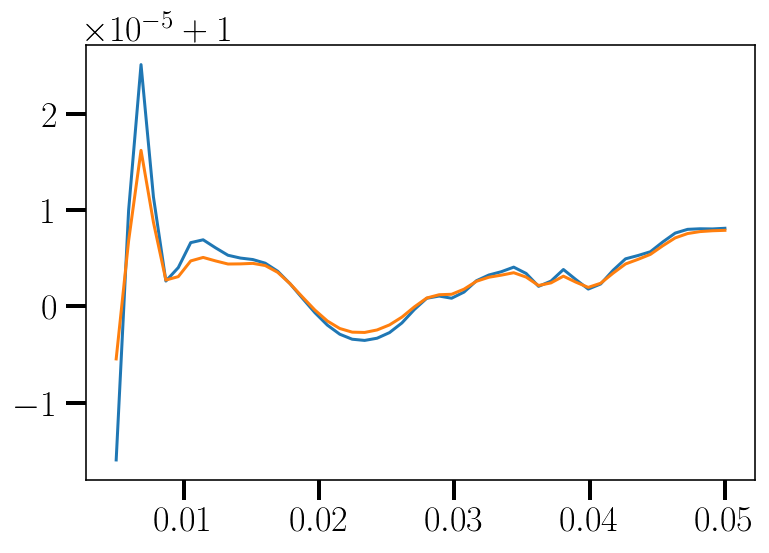

In [756]:
plt.plot(k3, bk_mono_func(k1,k2,theta)/bk0)
plt.plot(k3, bk_quad_func(k1,k2,theta)/bk2)
#plt.ylim(0.99,1.01)

In [ ]:
test = WA1.l1()
test1 = WA1.l1(1,0)
test2 = WA1.l1(0,1)
testmid = WA1.l1(1/3,1/3)
testold1 = bk_dipo(k1,k2,theta,zz,r=0,s=0,c=0)
testold = bk_dipo(k1,k2,theta,zz,r=1/3,s=1/3,c=0)
testvold = bk_wide_angle(k1,k2,theta,zz,r=1/3,s=1/3)

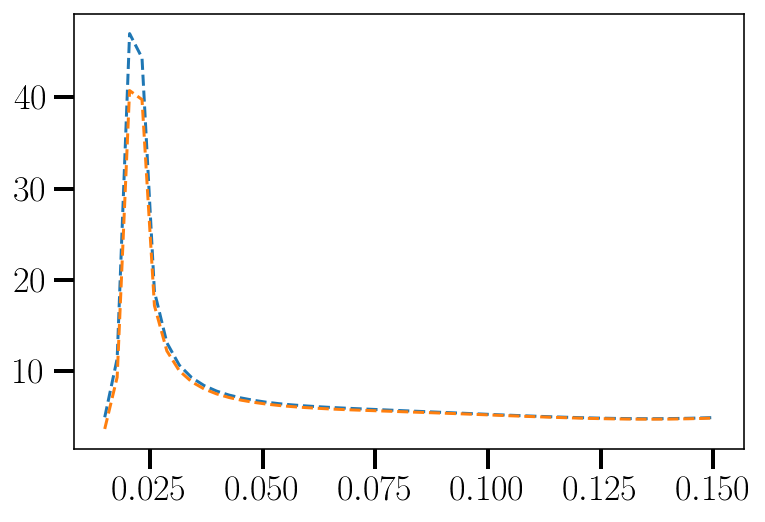

In [748]:
plt.plot(k3,np.abs(testold.real/(comoving_dist(zz))/testmid.imag),'--')
plt.plot(k3,np.abs(testvold.real/(comoving_dist(zz))/testmid.imag),'--')
#plt.ylim(0,5)

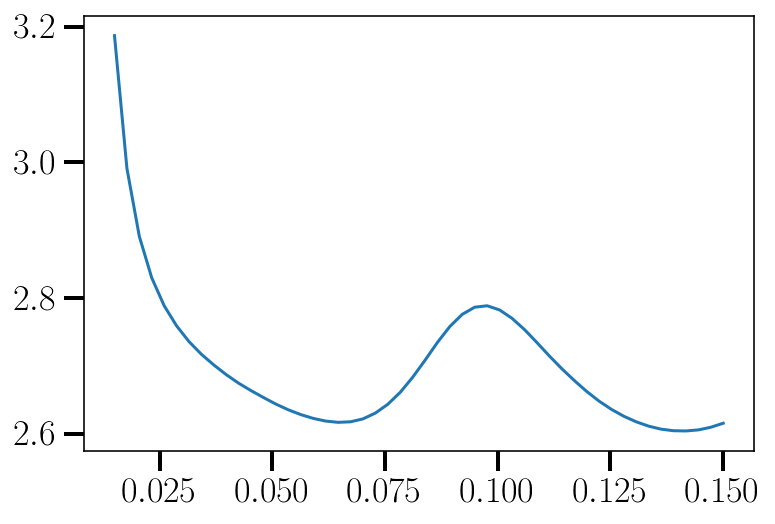

In [751]:
plt.plot(k3,np.abs(testold1.real/(comoving_dist(zz))/test1.imag))
#plt.ylim(0,30)

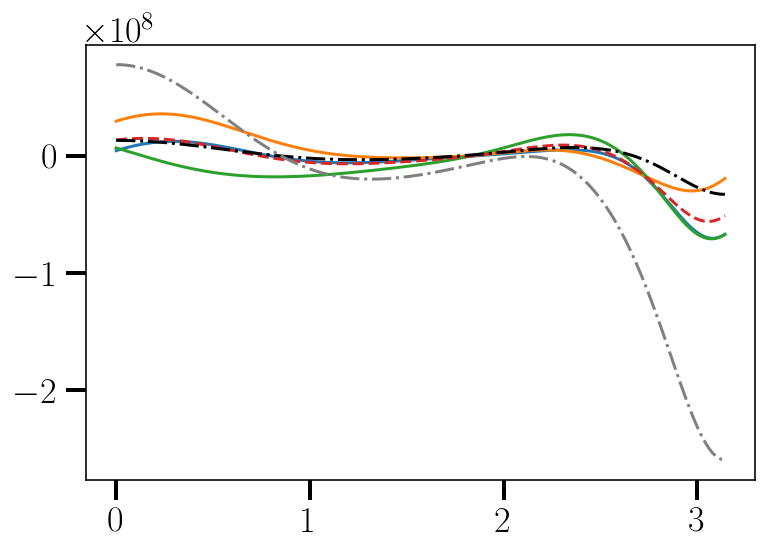

In [681]:
plt.plot(theta,test.imag)
plt.plot(theta,test1.imag)
plt.plot(theta,test2.imag)
plt.plot(theta,testmid.imag,'--')
plt.plot(theta,testold.real/(comoving_dist(zz))/5,'-.',color='black')
plt.plot(theta,testold1.real/(comoving_dist(zz)),'-.',color='grey')

In [134]:
bk_mono_func(0.04,0.038,0.038)

2084264620.894218

In [1133]:
%%time
thet_test =np.pi/1.5
#print(bk_wa_dfog(3,0.04,0.038,np.pi/1.1,3,0,0))
print(bk_wa_dfog(1,0.04,0.03,thet_test,0.1,0,0,0)[0]/1e+10)

-0.702124218451208
CPU times: user 16.2 s, sys: 3.17 ms, total: 16.2 s
Wall time: 16.2 s


In [1132]:
print(bk_wide_angle(0.04,0.03,thet_test,0.1,0,0)/1e+10)
print(bk_dipo(0.04,0.03,thet_test,0.1,0,0,0)/1e+10)

-0.7021242184811142
(-0.7021242184811064-4.121143986337663e-16j)


In [579]:
def bk_dipo(k1,k2,theta,zz,r=1/3,s=1/3,c=0): 
    k3 = np.sqrt(k1**2 + k2**2 + 2*k1*k2*np.cos(theta))
    k3 = np.where(k3==0,1e-3,k3)
    Pk1 = Pk(k1)
    Pk2 = Pk(k2)
    Pk3 = Pk(k3)

    Pkd1= Pk_d(k1)
    Pkd2 = Pk_d(k2)
    Pkd3 = Pk_d(k3)
    
    I = 1j
    def csc(x):
        x = np.where(x==0,1e-4,x)#aviod zero errors here
        return 1/np.sin(x)
    
    #redshift dependendent terms
    f= f_intp(zz)
    b1 = b_1(zz)
    b2 = b_2(zz)
    g2 = g_2(zz)
    #deriv
    fd = f_d(zz)
    gd2 = g2_d(zz)
    bd2 = b2_d(zz)
    bd1 = b1_d(zz)
    #bk_dic = {} #could be nice to have dictionary to call each part independently??
    #@jit(nopython=True)
    def contain_terms(Pk1,Pk2,Pk3,Pkd1,Pkd2,Pkd3):
        """So we have collated alll terms for each permutation - these epression are 1st order abut include all derivate terms"""
        bk_12 =  (-44*f**2*k1*k2**2*(2*c*fd*(4*Pk1*Pk2*k2**2*k3**2*(3*r + 3*s - 2) + 2*Pk1*k1**2*(3*Pk2*k2**2*(4*r + 3*s - 3) + 4*Pk2*k3**2*(r - 1) - Pkd2*k2*k3**2*(r - 1)) + Pk2*Pkd1*k1*k2**2*k3**2*(-3*r - 3*s + 2)) + f*(8*Pk1*Pk2*k2**2*k3**2*(3*r + 3*s - 5) + Pk1*k1**2*(6*Pk2*k2**2*(3*s - 2) - 4*Pk2*k3**2*(3*r + 8) + Pkd2*k2*k3**2*(3*r + 8)) - 2*Pk2*Pkd1*k1*k2**2*k3**2*(3*r + 3*s - 5)))*np.cos(6*theta) - f*k2*(693*Pk1*c*fd*g2*k1**2*k3**4*(-4*Pk2 + Pkd2*k2) + 66*b1*k1**2*(3*c*fd*(2*Pk1*k1**2*(6*Pk2*k2**2*(4*r + 2*s - 3) + 4*Pk2*k3**2*(2*r - 1) + Pkd2*k2*k3**2*(1 - 2*r)) + Pk1*(4*Pk2*k2**4*(2*r + 2*s - 1) + 16*Pk2*k2**2*k3**2*(r + s - 1) - 4*Pk2*k3**4 + Pkd2*k2*k3**4) - 8*Pk2*Pkd1*k1*k2**2*k3**2*(r + s - 1)) + 2*f*(2*Pk1*k1**2*(10*Pk2*k2**2*(2*s - 1) - 4*Pk2*k3**2*(r + 3) + Pkd2*k2*k3**2*(r + 3)) + Pk1*(4*Pk2*k2**4*(s + 3) + 4*Pk2*k2**2*k3**2*(8*r + 9*s - 9) - 4*Pk2*k3**4*(r + 3) + 2*Pkd2*k2**3*k3**2*r + Pkd2*k2*k3**4*(r + 3)) - 18*Pk2*Pkd1*k1*k2**2*k3**2*(r + s - 1))) + 14*f**3*k3**4*(20*Pk1*Pk2*k2**2*(3*r + 3*s - 5) - 4*Pk1*k1**2*(4*Pk2 - Pkd2*k2)*(2*r + 5) - 5*Pk2*Pkd1*k1*k2**2*(3*r + 3*s - 5)) + f**2*(56*Pk1*Pk2*k2**2*k3**2*(5*c*fd*k3**2*(4*r + 4*s - 3) + 11*k2**2*(3*r + 3*s - 5)) + 11*Pk1*k1**4*(18*Pk2*k2**2*(31*s - 18) - 4*Pk2*k3**2*(69*r + 136) + Pkd2*k2*k3**2*(69*r + 136)) + Pk1*k1**2*(560*Pk2*c*fd*k3**4*(2*r - 1) + 22*Pk2*k2**4*(111*s - 34) + 66*Pk2*k2**2*k3**2*(71*r + 46*s - 202) + 140*Pkd2*c*fd*k2*k3**4*(1 - 2*r) + 11*Pkd2*k2**3*k3**2*(69*r + 64)) - 22*Pk2*Pkd1*k1**3*k2**2*k3**2*(105*r + 105*s - 127) - 14*Pk2*Pkd1*k1*k2**2*k3**2*(5*c*fd*k3**2*(4*r + 4*s - 3) + 11*k2**2*(3*r + 3*s - 5))) + 11*f*(-42*Pk1*g2*k1**2*k3**4*(4*Pk2 - Pkd2*k2)*(r + 3) + 2*c*fd*(28*Pk1*Pk2*k2**4*k3**2*(3*r + 3*s - 2) + 2*Pk1*k1**4*(81*Pk2*k2**2*(4*r + 3*s - 3) + 68*Pk2*k3**2*(r - 1) - 17*Pkd2*k2*k3**2*(r - 1)) + 2*Pk1*k1**2*k2**2*(41*Pk2*k2**2*(4*r + 3*s - 3) + Pk2*k3**2*(61*r + 51*s - 44) - 17*Pkd2*k2*k3**2*(r - 1)) - 47*Pk2*Pkd1*k1**3*k2**2*k3**2*(3*r + 3*s - 2) - 7*Pk2*Pkd1*k1*k2**4*k3**2*(3*r + 3*s - 2)) + 9*c*k1**2*(Pk1*(8*Pk2*bd2*k2**4*(r + s - 1) + 7*gd2*k3**4*r*(4*Pk2 - Pkd2*k2)) + 2*bd1*(4*Pk1*Pk2*k2**4*(r - 1) + 4*Pk1*Pk2*k3**2*r*(-2*k1**2 + k3**2) - 2*Pk1*Pkd2*k2**3*k3**2*(r - 1) - Pk1*Pkd2*k2*k3**2*r*(-2*k1**2 + k3**2) + 4*Pk2*k2**2*(3*Pk1*k1**2*s + k3**2*(Pk1*(3*r + 2*s - 1) - Pkd1*k1*(r + s)))))))*np.cos(5*theta) - k1*(924*b1**2*k2**2*(c*fd*(2*Pk1*Pk2*k3**2*(2*k2**2 + k3**2)*(r + s - 1) + 4*Pk1*k1**2*(3*Pk2*k2**2*(2*r + s - 1) + 2*Pk2*k3**2*r - Pkd2*k2*k3**2*r) - Pk2*Pkd1*k1*k3**2*(2*k2**2 + k3**2)*(r + s - 1)) + f*(6*Pk1*Pk2*k3**2*(2*k2**2 + k3**2)*(r + s - 1) + 2*Pk1*k1**2*(8*Pk2*k2**2*(s - 1) - 2*Pk2*k3**2*r + Pkd2*k2*k3**2*r) - 3*Pk2*Pkd1*k1*k3**2*(2*k2**2 + k3**2)*(r + s - 1))) + 11*b1*(294*Pk2*c*fd*g2*k2**2*k3**4*(2*Pk1 - Pkd1*k1)*(r + s - 1) + 14*f**3*k3**4*(-Pk1*k1**2*(4*Pk2 - Pkd2*k2)*(3*r + 8) + Pk1*k2**2*(Pk2*(30*r + 36*s - 52) + Pkd2*k2*(3*r + 4)) - 2*Pk2*Pkd1*k1*k2**2*(9*r + 9*s - 11)) + 2*f**2*(3*Pk1*k1**4*(2*Pk2*k2**2*(114*s - 43) - 28*Pk2*k3**2*(r + 3) + 7*Pkd2*k2*k3**2*(r + 3)) + Pk1*k1**2*(6*Pk2*k2**4*(313*s - 118) + 6*Pk2*k2**2*k3**2*(26*r - 20*s - 145) + 28*Pk2*k3**4*(8*c*fd*r - 4*c*fd - 3*r - 9) + 3*Pkd2*k2**3*k3**2*(134*r + 5) + 7*Pkd2*k2*k3**4*(-8*c*fd*r + 4*c*fd + 3*r + 9)) + Pk1*k2**2*(42*Pk2*k2**4*(s + 3) + 18*Pk2*k2**2*k3**2*(53*r + 53*s - 77) + 2*Pk2*k3**4*(14*c*fd*(11*r + 9*s - 9) + 15*r + 36*s - 207) + 21*Pkd2*k2**3*k3**2*r + 7*Pkd2*k2*k3**4*(-4*c*fd*r + 2*c*fd + 3*r + 9)) - 321*Pk2*Pkd1*k1**3*k2**2*k3**2*(r + s - 1) - Pk2*Pkd1*k1*k2**2*k3**2*(k2**2*(537*r + 537*s - 513) + 2*k3**2*(7*c*fd*(9*r + 9*s - 8) + 33*r + 33*s - 27))) + 3*f*(294*Pk2*g2*k2**2*k3**4*(2*Pk1 - Pkd1*k1)*(r + s - 1) + c*fd*(3*Pk1*k1**4*(74*Pk2*k2**2*(4*r + 2*s - 3) + 28*Pk2*k3**2*(2*r - 1) + 7*Pkd2*k2*k3**2*(1 - 2*r)) + Pk1*k1**2*(12*Pk2*k2**4*(193*r + 124*s - 131) - 2*Pk2*k2**2*k3**2*(70*r + 64*s - 67) - 84*Pk2*k3**4 + 117*Pkd2*k2**3*k3**2*(1 - 2*r) + 21*Pkd2*k2*k3**4) + Pk1*k2**2*(42*Pk2*k2**4*(2*r + 2*s - 1) + 8*Pk2*k2**2*k3**2*(53*r + 53*s - 49) + 2*Pk2*k3**4*(16*r + 16*s - 29) + 21*Pkd2*k2*k3**4) - 180*Pk2*Pkd1*k1**3*k2**2*k3**2*(r + s - 1) - 12*Pk2*Pkd1*k1*k2**2*k3**2*(k2**2*(23*r + 23*s - 19) + 2*k3**2*(2*r + 2*s - 1))) + 14*c*k2**2*(Pk2*(4*bd2*k2**2*(6*Pk1*k1**2 + 2*Pk1*k3**2 - Pkd1*k1*k3**2) + 7*gd2*k3**4*(2*Pk1 - Pkd1*k1))*(r + s - 1) + 2*bd1*(2*Pk1*Pk2*k3**2*(2*k2**2*(r + s) + k3**2*(2*r + 2*s - 1)) + 4*Pk1*k1**2*(3*Pk2*k2**2*(r + s - 1) - 2*Pk2*k3**2 + Pkd2*k2*k3**2) + Pk2*Pkd1*k1*k3**2*(-2*k2**2*(r + s) + k3**2*(-2*r - 2*s + 1)))))) + f*(462*Pk2*c*g2*k2**2*k3**4*(7*bd1*(2*Pk1 - Pkd1*k1)*(r + s) + 2*fd*(2*Pk1 - 3*Pkd1*k1)*(2*r + 2*s - 1)) + 14*f**3*k3**4*(-5*Pk1*k1**2*(4*Pk2 - Pkd2*k2)*(7*r + 12) + Pk1*k2**2*(8*Pk2*(34*r + 24*s - 81) + Pkd2*k2*(35*r + 16)) - 8*Pk2*Pkd1*k1*k2**2*(17*r + 17*s - 21)) + 2*f**2*(22*Pk1*k1**4*(3*Pk2*k2**2*(99*s - 43) - 28*Pk2*k3**2*(3*r + 5) + 7*Pkd2*k2*k3**2*(3*r + 5)) + Pk1*k1**2*(840*Pk2*c*fd*k3**4*(2*r - 1) + 22*Pk2*k2**4*(645*s - 278) - 11*Pk2*k2**2*k3**2*(3*r + 345*s + 1582) + 210*Pkd2*c*fd*k2*k3**4*(1 - 2*r) + 11*Pkd2*k2**3*k3**2*(318*r + 125)) + Pk1*k2**2*(14*Pk2*c*k3**4*(22*bd1*(5*r + 3*s - 2) + fd*(138*r + 128*s - 101)) + 33*Pk2*k2**2*k3**2*(221*r + 151*s - 490) - 14*Pkd2*c*k2*k3**4*(11*bd1 + 15*fd)*(2*r - 1) + 77*Pkd2*k2**3*k3**2*(6*r + 1) + 154*k2**4*(6*Pk2*s + Pk2)) - 55*Pk2*Pkd1*k1**3*k2**2*k3**2*(51*r + 51*s - 49) - Pk2*Pkd1*k1*k2**2*k3**2*(14*c*k3**2*(11*bd1*(3*r + 3*s - 1) + 30*fd*(4*r + 4*s - 3)) + 11*k2**2*(327*r + 327*s - 365))) + 11*f*(42*Pk2*g2*k2**2*k3**4*(12*Pk1*(r + s - 4) - 11*Pkd1*k1*(r + s) + 9*Pkd1*k1) + c*(6*Pk2*k2**2*(bd2*k2**2*(165*Pk1*k1**2 + 21*Pk1*k2**2 + 16*Pk1*k3**2 - 24*Pkd1*k1*k3**2) + 14*gd2*k3**4*(2*Pk1 - 3*Pkd1*k1))*(r + s - 1) + 3*bd1*(3*Pk1*k1**4*(74*Pk2*k2**2*s + 7*k3**2*r*(-4*Pk2 + Pkd2*k2)) + Pk1*k1**2*(6*Pk2*k2**4*(55*r + 69*s - 55) + 2*Pk2*k2**2*k3**2*(88*r - 32*s - 117) + 84*Pk2*k3**4*r + 117*Pkd2*k2**3*k3**2 - 21*Pkd2*k2*k3**4*r) + Pk1*k2**2*(42*Pk2*k2**4*(r - 1) + 180*Pk2*k2**2*k3**2*(r + s) + 2*Pk2*k3**4*(29*r + 8*s - 8) - 21*Pkd2*k2**3*k3**2*(r - 1) - 21*Pkd2*k2*k3**4*r) - 90*Pk2*Pkd1*k1**3*k2**2*k3**2*(r + s) - 6*Pk2*Pkd1*k1*k2**2*k3**2*(15*k2**2*(r + s) + 4*k3**2*(r + s - 1))) + 2*fd*(5*Pk1*k1**4*(66*Pk2*k2**2*(4*r + 3*s - 3) + 28*Pk2*k3**2*(r - 1) - 7*Pkd2*k2*k3**2*(r - 1)) + Pk1*k1**2*k2**2*(784*Pk2*k2**2*(4*r + 3*s - 3) + Pk2*k3**2*(-513*r - 615*s + 308) - 238*Pkd2*k2*k3**2*(r - 1)) + Pk1*k2**4*(70*Pk2*k2**2*(4*r + 3*s - 3) + Pk2*k3**2*(383*r + 453*s - 232) - 35*Pkd2*k2*k3**2*(r - 1)) - 130*Pk2*Pkd1*k1**3*k2**2*k3**2*(3*r + 3*s - 2) - 154*Pk2*Pkd1*k1*k2**4*k3**2*(3*r + 3*s - 2))))))*np.cos(4*theta) - 2*k1*(1617*b1**3*k3**4*(-2*c*fd*(Pk1*Pkd2*k2**3*r + Pk1*k1**2*r*(-2*Pk2 + Pkd2*k2) + Pk2*Pkd1*k1*k2**2*(r + s - 1)) + f*(Pk1*Pkd2*k2**3*r + Pk1*k1**2*r*(-2*Pk2 + Pkd2*k2) - 6*Pk2*Pkd1*k1*k2**2*(r + s - 1))) - 231*b1**2*(c*(fd*(-3*Pk1*k1**4*(58*Pk2*k2**2*(2*r + s - 1) + 14*Pk2*k3**2*r - 7*Pkd2*k2*k3**2*r) + Pk1*k1**2*(-384*Pk2*k2**4*(2*r + s - 1) + 2*Pk2*k2**2*k3**2*(150*r + 89*s - 89) + 42*Pk2*k3**4*r + 114*Pkd2*k2**3*k3**2*r - 21*Pkd2*k2*k3**4) + Pk1*k2**2*(-42*Pk2*k2**4*(2*r + s - 1) + 14*Pk2*k2**2*k3**2*(7*r + s - 1) + 2*Pk2*k3**4*(29*r + 8*s - 21) + 21*Pkd2*k2**3*k3**2*r - 21*Pkd2*k2*k3**4) + 66*Pk2*Pkd1*k1**3*k2**2*k3**2*(r + s - 1) + 2*Pk2*Pkd1*k1*k2**2*k3**2*(39*k2**2*(r + s - 1) + 2*k3**2*(11*r + 11*s - 8))) + 5*k3**4*(Pk2*Pkd1*k1*k2**2*(4*bd2 + 14*gd2)*(r + s - 1) + bd1*(7*Pk1*Pkd2*k2**3*(r - 1) - 7*Pk1*k1**2*(2*Pk2 - Pkd2*k2)*(r - 1) + 4*Pk2*Pkd1*k1*k2**2*(2*r + 2*s - 1)))) + f**2*k3**4*(Pk1*k1**2*(4*Pk2*(9*r + 10) + Pkd2*k2*(4 - 45*r)) + Pk1*k2**2*(12*Pk2*(-5*r + 4*s + 4) + Pkd2*k2*(4 - 45*r)) + 4*Pk2*Pkd1*k1*k2**2*(31*r + 31*s - 30)) + 2*f*(2*Pk1*k1**4*(-58*Pk2*k2**2*(s - 1) + 14*Pk2*k3**2*r - 7*Pkd2*k2*k3**2*r) + Pk1*k1**2*(-256*Pk2*k2**4*(s - 1) + Pk2*k2**2*k3**2*(14*r + 157*s - 157) + Pk2*k3**4*(-14*bd1*c*(r - 1) - 30*c*fd*r + 3*c*fd - 7*r + 35) - 66*Pkd2*k2**3*k3**2*r + Pkd2*k2*k3**4*(7*bd1*c*(r - 1) + 6*c*fd*(4*r - 1) - 28*r + 14)) + Pk1*k2**2*(-28*Pk2*k2**4*(s - 1) - 7*Pk2*k2**2*k3**2*(10*r - 3*s + 3) + Pk2*k3**4*(c*fd*(52*r + 16*s - 23) - 39*r + 24*s + 63) - 14*Pkd2*k2**3*k3**2*r + Pkd2*k2*k3**4*(7*bd1*c*(r - 1) + 6*c*fd*(4*r - 1) - 28*r + 14)) + 44*Pk2*Pkd1*k1**3*k2**2*k3**2*(r + s - 1) + Pk2*Pkd1*k1*k2**2*k3**2*(62*k2**2*(r + s - 1) + k3**2*(r + s)*(14*bd1*c + 7*bd2*c + 60*c*fd + 46) - k3**2*(54*c*fd + c*(7*bd1 + 7*bd2) + 38)))) - 11*b1*(-980*Pk1*Pk2*c*f**2*fd*k1**2*k3**4*r + 280*Pk1*Pk2*c*f**2*fd*k1**2*k3**4 + 3892*Pk1*Pk2*c*f**2*fd*k2**2*k3**4*r - 2184*Pk1*Pk2*c*f**2*fd*k2**2*k3**4 - 17388*Pk1*Pk2*c*f*fd*k1**4*k2**2*r + 11736*Pk1*Pk2*c*f*fd*k1**4*k2**2 - 252*Pk1*Pk2*c*f*fd*k1**4*k3**2*r + 126*Pk1*Pk2*c*f*fd*k1**4*k3**2 - 35856*Pk1*Pk2*c*f*fd*k1**2*k2**4*r + 23904*Pk1*Pk2*c*f*fd*k1**2*k2**4 + 19152*Pk1*Pk2*c*f*fd*k1**2*k2**2*k3**2*r - 12474*Pk1*Pk2*c*f*fd*k1**2*k2**2*k3**2 + 126*Pk1*Pk2*c*f*fd*k1**2*k3**4 - 3780*Pk1*Pk2*c*f*fd*k2**6*r + 2520*Pk1*Pk2*c*f*fd*k2**6 + 5004*Pk1*Pk2*c*f*fd*k2**4*k3**2*r - 2628*Pk1*Pk2*c*f*fd*k2**4*k3**2 + 528*Pk1*Pk2*c*f*fd*k2**2*k3**4*r - 768*Pk1*Pk2*c*f*fd*k2**2*k3**4 + 1176*Pk1*Pk2*c*f*gd2*k2**2*k3**4*r - 1176*Pk1*Pk2*c*f*gd2*k2**2*k3**4 + 1176*Pk1*Pk2*c*fd*g2*k2**2*k3**4*r + 462*Pk1*Pk2*f**3*k1**2*k3**4*r + 1568*Pk1*Pk2*f**3*k1**2*k3**4 - 840*Pk1*Pk2*f**3*k2**2*k3**4*r + 2464*Pk1*Pk2*f**3*k2**2*k3**4 + 4320*Pk1*Pk2*f**2*k1**4*k2**2 + 798*Pk1*Pk2*f**2*k1**4*k3**2*r + 1134*Pk1*Pk2*f**2*k1**4*k3**2 + 9360*Pk1*Pk2*f**2*k1**2*k2**4 - 204*Pk1*Pk2*f**2*k1**2*k2**2*k3**2*r - 108*Pk1*Pk2*f**2*k1**2*k2**2*k3**2 - 210*Pk1*Pk2*f**2*k1**2*k3**4*r + 1134*Pk1*Pk2*f**2*k1**2*k3**4 + 1008*Pk1*Pk2*f**2*k2**6 - 2154*Pk1*Pk2*f**2*k2**4*k3**2*r + 2862*Pk1*Pk2*f**2*k2**4*k3**2 - 426*Pk1*Pk2*f**2*k2**2*k3**4*r + 3006*Pk1*Pk2*f**2*k2**2*k3**4 + 3528*Pk1*Pk2*f*g2*k2**2*k3**4*r + 1106*Pk1*Pkd2*c*f**2*fd*k1**2*k2*k3**4*r - 448*Pk1*Pkd2*c*f**2*fd*k1**2*k2*k3**4 + 1078*Pk1*Pkd2*c*f**2*fd*k2**3*k3**4*r - 434*Pk1*Pkd2*c*f**2*fd*k2**3*k3**4 + 630*Pk1*Pkd2*c*f*fd*k1**4*k2*k3**2*r - 315*Pk1*Pkd2*c*f*fd*k1**4*k2*k3**2 + 3564*Pk1*Pkd2*c*f*fd*k1**2*k2**3*k3**2*r - 1782*Pk1*Pkd2*c*f*fd*k1**2*k2**3*k3**2 - 315*Pk1*Pkd2*c*f*fd*k1**2*k2*k3**4 + 630*Pk1*Pkd2*c*f*fd*k2**5*k3**2*r - 315*Pk1*Pkd2*c*f*fd*k2**5*k3**2 - 315*Pk1*Pkd2*c*f*fd*k2**3*k3**4 - 1029*Pk1*Pkd2*f**3*k1**2*k2*k3**4*r + 112*Pk1*Pkd2*f**3*k1**2*k2*k3**4 - 1029*Pk1*Pkd2*f**3*k2**3*k3**4*r + 140*Pk1*Pkd2*f**3*k2**3*k3**4 - 1008*Pk1*Pkd2*f**2*k1**4*k2*k3**2*r + 252*Pk1*Pkd2*f**2*k1**4*k2*k3**2 - 5400*Pk1*Pkd2*f**2*k1**2*k2**3*k3**2*r + 1224*Pk1*Pkd2*f**2*k1**2*k2**3*k3**2 - 504*Pk1*Pkd2*f**2*k1**2*k2*k3**4*r + 252*Pk1*Pkd2*f**2*k1**2*k2*k3**4 - 1008*Pk1*Pkd2*f**2*k2**5*k3**2*r + 252*Pk1*Pkd2*f**2*k2**5*k3**2 - 504*Pk1*Pkd2*f**2*k2**3*k3**4*r + 252*Pk1*Pkd2*f**2*k2**3*k3**4 + 294*Pk2*Pkd1*b2*c*fd*k1*k2**2*k3**4*r - 294*Pk2*Pkd1*b2*c*fd*k1*k2**2*k3**4 + 882*Pk2*Pkd1*b2*f*k1*k2**2*k3**4*r - 882*Pk2*Pkd1*b2*f*k1*k2**2*k3**4 + 3906*Pk2*Pkd1*c*f**2*fd*k1*k2**2*k3**4*r - 3052*Pk2*Pkd1*c*f**2*fd*k1*k2**2*k3**4 + 4392*Pk2*Pkd1*c*f*fd*k1**3*k2**2*k3**2*r - 3402*Pk2*Pkd1*c*f*fd*k1**3*k2**2*k3**2 + 4824*Pk2*Pkd1*c*f*fd*k1*k2**4*k3**2*r - 3618*Pk2*Pkd1*c*f*fd*k1*k2**4*k3**2 + 1080*Pk2*Pkd1*c*f*fd*k1*k2**2*k3**4*r - 540*Pk2*Pkd1*c*f*fd*k1*k2**2*k3**4 + 1176*Pk2*Pkd1*c*f*gd2*k1*k2**2*k3**4*r - 1176*Pk2*Pkd1*c*f*gd2*k1*k2**2*k3**4 + 1176*Pk2*Pkd1*c*fd*g2*k1*k2**2*k3**4*r - 294*Pk2*Pkd1*c*fd*g2*k1*k2**2*k3**4 + 2394*Pk2*Pkd1*f**3*k1*k2**2*k3**4*r - 2086*Pk2*Pkd1*f**3*k1*k2**2*k3**4 + 3564*Pk2*Pkd1*f**2*k1**3*k2**2*k3**2*r - 2772*Pk2*Pkd1*f**2*k1**3*k2**2*k3**2 + 4212*Pk2*Pkd1*f**2*k1*k2**4*k3**2*r - 3348*Pk2*Pkd1*f**2*k1*k2**4*k3**2 + 948*Pk2*Pkd1*f**2*k1*k2**2*k3**4*r - 684*Pk2*Pkd1*f**2*k1*k2**2*k3**4 + 588*Pk2*Pkd1*f*g2*k1*k2**2*k3**4*r + 588*Pk2*Pkd1*f*g2*k1*k2**2*k3**4 + 42*Pk2*bd2*c*k2**2*(Pk1*f*(-87*k1**4 - 192*k1**2*k2**2 - 21*k2**4 + k3**4*(6*f + 8) + k3**2*(89*k1**2 + 7*k2**2)) + Pkd1*k1*k3**2*(33*f*k1**2 + 39*f*k2**2 + k3**2*(f*(18*f + 13) + 35*g2)))*(r + s - 1) + 6*Pk2*k2**2*s*(4*Pk1*f*(3*c*fd*k3**2*(169*k1**2 + 31*k2**2) - 3*c*fd*(157*k1**4 + 332*k1**2*k2**2 + 35*k2**4) + k3**4*(22*c*fd + 49*c*gd2 + 147*g2)) + Pkd1*f*k1*k3**2*(12*c*fd*(61*k1**2 + 67*k2**2) + k3**2*(147*b2 + 180*c*fd + 196*c*gd2 + 98*g2)) + 49*c*fd*k3**4*(Pkd1*b2*k1 + 4*g2*(Pk1 + Pkd1*k1)) + 21*f**3*k3**4*(16*Pk1 + 19*Pkd1*k1) + f**2*(Pk1*(-1524*k1**4 + 6*k1**2*(-534*k2**2 + 339*k3**2) - 336*k2**4 + 558*k2**2*k3**2 + 6*k3**4*(56*c*fd + 22)) + Pkd1*k1*k3**2*(594*k1**2 + 702*k2**2 + k3**2*(651*c*fd + 158)))) + 21*bd1*c*(70*Pk2*Pkd1*g2*k1*k2**2*k3**4*(r + s) + 2*f**2*k3**4*(-12*Pk1*k1**2*(2*Pk2 - Pkd2*k2)*(r - 1) + Pk1*k2**2*(Pk2*(10*r + 10*s - 13) + 12*Pkd2*k2*(r - 1)) + 6*Pk2*Pkd1*k1*k2**2*(7*r + 7*s - 3)) + f*(-3*Pk1*k1**4*(58*Pk2*k2**2*(r + s - 1) - 14*Pk2*k3**2 + 7*Pkd2*k2*k3**2) + Pk1*k1**2*(-384*Pk2*k2**4*(r + s - 1) + 2*Pk2*k2**2*k3**2*(89*r + 89*s - 61) + 42*Pk2*k3**4*(1 - 2*r) - 114*Pkd2*k2**3*k3**2 + 21*Pkd2*k2*k3**4*(2*r - 1)) + Pk1*k2**2*(-42*Pk2*k2**4*(r + s - 1) + 14*Pk2*k2**2*k3**2*(r + s - 6) + 16*Pk2*k3**4*(r + s - 1) - 21*Pkd2*k2**3*k3**2 + 21*Pkd2*k2*k3**4*(2*r - 1)) + 66*Pk2*Pkd1*k1**3*k2**2*k3**2*(r + s) + 2*Pk2*Pkd1*k1*k2**2*k3**2*(39*k2**2*(r + s) + k3**2*(38*r + 38*s - 22))))) + f*(-1848*Pk1*Pk2*b2*c*fd*k2**2*k3**4*r + 924*Pk1*Pk2*b2*c*fd*k2**2*k3**4 - 2772*Pk1*Pk2*b2*f*k2**2*k3**4*r - 8316*Pk1*Pk2*b2*f*k2**2*k3**4 + 2940*Pk1*Pk2*c*f**2*fd*k1**2*k3**4*r - 1470*Pk1*Pk2*c*f**2*fd*k1**2*k3**4 - 19488*Pk1*Pk2*c*f**2*fd*k2**2*k3**4*r + 12656*Pk1*Pk2*c*f**2*fd*k2**2*k3**4 + 105160*Pk1*Pk2*c*f*fd*k1**4*k2**2*r - 78870*Pk1*Pk2*c*f*fd*k1**4*k2**2 + 1540*Pk1*Pk2*c*f*fd*k1**4*k3**2*r - 1540*Pk1*Pk2*c*f*fd*k1**4*k3**2 + 209792*Pk1*Pk2*c*f*fd*k1**2*k2**4*r - 157344*Pk1*Pk2*c*f*fd*k1**2*k2**4 - 117480*Pk1*Pk2*c*f*fd*k1**2*k2**2*k3**2*r + 87318*Pk1*Pk2*c*f*fd*k1**2*k2**2*k3**2 + 21560*Pk1*Pk2*c*f*fd*k2**6*r - 16170*Pk1*Pk2*c*f*fd*k2**6 - 30800*Pk1*Pk2*c*f*fd*k2**4*k3**2*r + 24178*Pk1*Pk2*c*f*fd*k2**4*k3**2 - 3696*Pk1*Pk2*c*f*gd2*k2**2*k3**4*r + 3696*Pk1*Pk2*c*f*gd2*k2**2*k3**4 - 7392*Pk1*Pk2*c*fd*g2*k2**2*k3**4*r + 3696*Pk1*Pk2*c*fd*g2*k2**2*k3**4 - 560*Pk1*Pk2*f**3*k1**2*k3**4*r - 7560*Pk1*Pk2*f**3*k1**2*k3**4 + 1484*Pk1*Pk2*f**3*k2**2*k3**4*r - 12096*Pk1*Pk2*f**3*k2**2*k3**4 - 14344*Pk1*Pk2*f**2*k1**4*k2**2 - 462*Pk1*Pk2*f**2*k1**4*k3**2*r - 10010*Pk1*Pk2*f**2*k1**4*k3**2 - 30536*Pk1*Pk2*f**2*k1**2*k2**4 + 396*Pk1*Pk2*f**2*k1**2*k2**2*k3**2*r - 45474*Pk1*Pk2*f**2*k1**2*k2**2*k3**2 - 3080*Pk1*Pk2*f**2*k2**6 + 3234*Pk1*Pk2*f**2*k2**4*k3**2*r - 32736*Pk1*Pk2*f**2*k2**4*k3**2 - 11088*Pk1*Pk2*f*g2*k2**2*k3**4*r + 5544*Pk1*Pk2*f*g2*k2**2*k3**4 - 4200*Pk1*Pkd2*c*f**2*fd*k1**2*k2*k3**4*r + 2100*Pk1*Pkd2*c*f**2*fd*k1**2*k2*k3**4 - 4200*Pk1*Pkd2*c*f**2*fd*k2**3*k3**4*r + 2100*Pk1*Pkd2*c*f**2*fd*k2**3*k3**4 - 2695*Pk1*Pkd2*c*f*fd*k1**4*k2*k3**2*r + 2695*Pk1*Pkd2*c*f*fd*k1**4*k2*k3**2 - 15686*Pk1*Pkd2*c*f*fd*k1**2*k2**3*k3**2*r + 15686*Pk1*Pkd2*c*f*fd*k1**2*k2**3*k3**2 - 2695*Pk1*Pkd2*c*f*fd*k2**5*k3**2*r + 2695*Pk1*Pkd2*c*f*fd*k2**5*k3**2 + 3605*Pk1*Pkd2*f**3*k1**2*k2*k3**4*r - 420*Pk1*Pkd2*f**3*k1**2*k2*k3**4 + 3605*Pk1*Pkd2*f**3*k2**3*k3**4*r - 728*Pk1*Pkd2*f**3*k2**3*k3**4 + 4620*Pk1*Pkd2*f**2*k1**4*k2*k3**2*r - 1540*Pk1*Pkd2*f**2*k1**4*k2*k3**2 + 26466*Pk1*Pkd2*f**2*k1**2*k2**3*k3**2*r - 7832*Pk1*Pkd2*f**2*k1**2*k2**3*k3**2 + 4620*Pk1*Pkd2*f**2*k2**5*k3**2*r - 1540*Pk1*Pkd2*f**2*k2**5*k3**2 - 5544*Pk2*Pkd1*b2*c*fd*k1*k2**2*k3**4*r + 2772*Pk2*Pkd1*b2*c*fd*k1*k2**2*k3**4 - 5082*Pk2*Pkd1*b2*f*k1*k2**2*k3**4*r + 4158*Pk2*Pkd1*b2*f*k1*k2**2*k3**4 - 16800*Pk2*Pkd1*c*f**2*fd*k1*k2**2*k3**4*r + 12600*Pk2*Pkd1*c*f**2*fd*k1*k2**2*k3**4 - 31350*Pk2*Pkd1*c*f*fd*k1**3*k2**2*k3**2*r + 20900*Pk2*Pkd1*c*f*fd*k1**3*k2**2*k3**2 - 31614*Pk2*Pkd1*c*f*fd*k1*k2**4*k3**2*r + 21076*Pk2*Pkd1*c*f*fd*k1*k2**4*k3**2 - 1386*Pk2*Pkd1*c*f*gd2*k1*k2**2*k3**4*r + 1386*Pk2*Pkd1*c*f*gd2*k1*k2**2*k3**4 - 2772*Pk2*Pkd1*c*fd*g2*k1*k2**2*k3**4*r + 1386*Pk2*Pkd1*c*fd*g2*k1*k2**2*k3**4 - 7672*Pk2*Pkd1*f**3*k1*k2**2*k3**4*r + 6216*Pk2*Pkd1*f**3*k1*k2**2*k3**4 - 18084*Pk2*Pkd1*f**2*k1**3*k2**2*k3**2*r + 12452*Pk2*Pkd1*f**2*k1**3*k2**2*k3**2 - 18348*Pk2*Pkd1*f**2*k1*k2**4*k3**2*r + 12892*Pk2*Pkd1*f**2*k1*k2**4*k3**2 - 924*Pk2*Pkd1*f*g2*k1*k2**2*k3**4*r - 2772*Pk2*Pkd1*f*g2*k1*k2**2*k3**4 - 66*Pk2*bd2*c*k2**2*(Pk1*(3*f*k3**2*(177*k1**2 + 55*k2**2) - 3*f*(145*k1**4 + 332*k1**2*k2**2 + 35*k2**4) + k3**4*(56*f**2 + 14*f + 196*g2)) + Pkd1*k1*k3**2*(3*f*(55*k1**2 + 67*k2**2) + k3**2*(14*f*(5*f + 3) + 147*g2)))*(r + s - 1) - 2*Pk2*k2**2*s*(462*c*fd*k3**4*(Pk1*(2*b2 + 8*g2) + Pkd1*k1*(6*b2 + 3*g2)) + 28*f**3*k3**4*(156*Pk1 + 137*Pkd1*k1) + f**2*(Pk1*(5824*c*fd*k3**4 - 22704*k1**4 - 44814*k1**2*k2**2 - 4620*k2**4 + k3**2*(31977*k1**2 + 9933*k2**2)) + 6*Pkd1*k1*k3**2*(1400*c*fd*k3**2 + 1507*k1**2 + 1529*k2**2)) + 33*f*(Pk1*(c*fd*k3**2*(1371*k1**2 + 301*k2**2) - c*fd*(1195*k1**4 + 2384*k1**2*k2**2 + 245*k2**4) + k3**4*(42*b2 + 56*c*gd2 + 168*g2)) + Pkd1*k1*k3**2*(c*fd*(475*k1**2 + 479*k2**2) + k3**2*(77*b2 + 21*c*gd2 + 14*g2)))) - 11*bd1*c*(Pk2*Pkd1*k1*k2**2*k3**4*(294*b2 + 294*g2)*(r + s) + 14*f**2*k3**4*(-15*Pk1*k1**2*(2*Pk2 - Pkd2*k2)*(r - 1) + Pk1*k2**2*(Pk2*(38*r + 24*s - 38) + Pkd2*k2*(17*r - 16)) + Pk2*Pkd1*k1*k2**2*(63*r + 63*s - 31)) - 3*f*(3*Pk1*k1**4*(2*Pk2*k2**2*(145*r + 169*s - 145) + 14*Pk2*k3**2*(4*r - 5) + 35*Pkd2*k2*k3**2) + 3*Pk1*k1**2*(664*Pk2*k2**4*(r + s - 1) - 2*Pk2*k2**2*k3**2*(51*r + 161*s - 84) + 14*Pk2*k3**4*r + 198*Pkd2*k2**3*k3**2 - 35*Pkd2*k2*k3**4*r) + Pk1*k2**2*(210*Pk2*k2**4*(r + s - 1) + 42*Pk2*k2**2*k3**2*(r - s + 9) - 8*Pk2*k3**4*(32*r + 11*s - 11) + 105*Pkd2*k2**3*k3**2 - 105*Pkd2*k2*k3**4*r) - 402*Pk2*Pkd1*k1**3*k2**2*k3**2*(r + s) - 6*Pk2*Pkd1*k1*k2**2*k3**2*(67*k2**2*(r + s) + 30*k3**2*(r + s - 1))))))*np.cos(2*theta) + k1*(3234*b1**3*k3**4*(2*c*fd*(Pk1*Pk2*k1**2*r + 2*Pk1*Pkd2*k1**2*k2*r + 2*Pk1*Pkd2*k2**3*r + Pk2*k2**2*(Pk1*(9*r + 4*s - 4) + 5*Pkd1*k1*(r + s - 1))) + f*(-6*Pk1*Pk2*k1**2*r - 7*Pk1*Pkd2*k1**2*k2*r - 7*Pk1*Pkd2*k2**3*r + 2*Pk2*k2**2*(2*Pk1*(r + 6*s - 6) + 5*Pkd1*k1*(r + s - 1)))) + 462*b1**2*(c*(fd*(3*Pk1*k1**4*k2*(-82*Pk2*k2*(2*r + s - 1) + 7*Pkd2*k3**2*r) + Pk1*k1**2*(-432*Pk2*k2**4*(2*r + s - 1) + 2*Pk2*k2**2*k3**2*(320*r + 163*s - 163) + 14*Pk2*k3**4*(r - 1) + 130*Pkd2*k2**3*k3**2*r - 21*Pkd2*k2*k3**4) + Pk1*k2**2*(-42*Pk2*k2**4*(2*r + s - 1) + 2*Pk2*k2**2*k3**2*(74*r + 25*s - 25) + 2*Pk2*k3**4*(57*r + 50*s - 30) + 21*Pkd2*k2**3*k3**2*r - 21*Pkd2*k2*k3**4) + 102*Pk2*Pkd1*k1**3*k2**2*k3**2*(r + s - 1) + 2*Pk2*Pkd1*k1*k2**2*k3**2*(43*k2**2*(r + s - 1) + k3**2*(61*r + 61*s - 25))) + 5*k2*k3**4*(Pk2*Pkd1*k1*k2*(38*bd2 - 14*gd2)*(r + s - 1) + bd1*(7*Pk1*Pkd2*k1**2*(r - 1) + 7*Pk1*Pkd2*k2**2*(r - 1) + 2*Pk2*k2*(7*Pk1*(r - 1) + 12*Pkd1*k1*(2*r + 2*s - 1))))) + f**2*k3**4*(Pk1*k1**2*(8*Pk2*(4 - 9*r) + Pkd2*k2*(20 - 99*r)) + Pk1*k2**2*(24*Pk2*(4*r + 16*s - 7) + Pkd2*k2*(20 - 99*r)) + 4*Pk2*Pkd1*k1*k2**2*(41*r + 41*s - 30)) + 2*f*(-2*Pk1*k1**4*k2*(82*Pk2*k2*(s - 1) + 7*Pkd2*k3**2*r) + Pk1*k1**2*(-288*Pk2*k2**4*(s - 1) + Pk2*k2**2*k3**2*(38*r + 319*s - 319) + Pk2*k3**4*(7*bd1*c*(r - 1) + 6*c*fd*(3*r - 1) - 21*r + 21) - 100*Pkd2*k2**3*k3**2*r + Pkd2*k2*k3**4*(14*bd1*c*(r - 1) + 9*c*fd*(4*r - 1) - 28*r + 14)) + Pk1*k2**2*(-28*Pk2*k2**4*(s - 1) + Pk2*k2**2*k3**2*(-2*r + 75*s - 75) + Pk2*k3**4*(7*bd1*c*(13*r + 8*s - 9) + 28*bd2*c*(r + s - 1) + 2*c*fd*(112*r + 64*s - 59) + 73*r + 150*s + 43) - 14*Pkd2*k2**3*k3**2*r + Pkd2*k2*k3**4*(14*bd1*c*(r - 1) + 9*c*fd*(4*r - 1) - 28*r + 14)) + 68*Pk2*Pkd1*k1**3*k2**2*k3**2*(r + s - 1) + Pk2*Pkd1*k1*k2**2*k3**2*(44*k2**2*(r + s - 1) + k3**2*(r + s)*(5*c*(14*bd1 + 7*bd2 + 24*fd) + 63) - k3**2*(96*c*fd + c*(35*bd1 + 35*bd2) + 15)))) + 11*b1*(2352*Pk1*Pk2*b2*c*fd*k2**2*k3**4*r + 7056*Pk1*Pk2*b2*f*k2**2*k3**4*r + 1148*Pk1*Pk2*c*f**2*fd*k1**2*k3**4*r - 504*Pk1*Pk2*c*f**2*fd*k1**2*k3**4 + 18732*Pk1*Pk2*c*f**2*fd*k2**2*k3**4*r - 11536*Pk1*Pk2*c*f**2*fd*k2**2*k3**4 - 38160*Pk1*Pk2*c*f*fd*k1**4*k2**2*r + 24930*Pk1*Pk2*c*f*fd*k1**4*k2**2 + 504*Pk1*Pk2*c*f*fd*k1**4*k3**2*r - 252*Pk1*Pk2*c*f*fd*k1**4*k3**2 - 72540*Pk1*Pk2*c*f*fd*k1**2*k2**4*r + 48276*Pk1*Pk2*c*f*fd*k1**2*k2**4 + 55020*Pk1*Pk2*c*f*fd*k1**2*k2**2*k3**2*r - 34626*Pk1*Pk2*c*f*fd*k1**2*k2**2*k3**2 - 252*Pk1*Pk2*c*f*fd*k1**2*k3**4 - 7308*Pk1*Pk2*c*f*fd*k2**6*r + 4914*Pk1*Pk2*c*f*fd*k2**6 + 14952*Pk1*Pk2*c*f*fd*k2**4*k3**2*r - 8772*Pk1*Pk2*c*f*fd*k2**4*k3**2 + 3072*Pk1*Pk2*c*f*fd*k2**2*k3**4*r - 2922*Pk1*Pk2*c*f*fd*k2**2*k3**4 - 1764*Pk1*Pk2*c*f*gd2*k2**2*k3**4*r + 1764*Pk1*Pk2*c*f*gd2*k2**2*k3**4 - 1764*Pk1*Pk2*c*fd*g2*k2**2*k3**4*r - 588*Pk1*Pk2*c*fd*g2*k2**2*k3**4 - 1932*Pk1*Pk2*f**3*k1**2*k3**4*r + 2016*Pk1*Pk2*f**3*k1**2*k3**4 + 2940*Pk1*Pk2*f**3*k2**2*k3**4*r - 1736*Pk1*Pk2*f**3*k2**2*k3**4 + 11004*Pk1*Pk2*f**2*k1**4*k2**2 - 756*Pk1*Pk2*f**2*k1**4*k3**2*r + 1260*Pk1*Pk2*f**2*k1**4*k3**2 + 20184*Pk1*Pk2*f**2*k1**2*k2**4 + 2736*Pk1*Pk2*f**2*k1**2*k2**2*k3**2*r - 11604*Pk1*Pk2*f**2*k1**2*k2**2*k3**2 - 756*Pk1*Pk2*f**2*k1**2*k3**4*r + 1260*Pk1*Pk2*f**2*k1**2*k3**4 + 2268*Pk1*Pk2*f**2*k2**6 + 3192*Pk1*Pk2*f**2*k2**4*k3**2*r - 2448*Pk1*Pk2*f**2*k2**4*k3**2 + 1920*Pk1*Pk2*f**2*k2**2*k3**4*r + 3240*Pk1*Pk2*f**2*k2**2*k3**4 - 5292*Pk1*Pk2*f*g2*k2**2*k3**4*r - 1764*Pk1*Pk2*f*g2*k2**2*k3**4 + 2576*Pk1*Pkd2*c*f**2*fd*k1**2*k2*k3**4*r - 1008*Pk1*Pkd2*c*f**2*fd*k1**2*k2*k3**4 + 2688*Pk1*Pkd2*c*f**2*fd*k2**3*k3**4*r - 1064*Pk1*Pkd2*c*f**2*fd*k2**3*k3**4 + 1134*Pk1*Pkd2*c*f*fd*k1**4*k2*k3**2*r - 567*Pk1*Pkd2*c*f*fd*k1**4*k2*k3**2 + 7290*Pk1*Pkd2*c*f*fd*k1**2*k2**3*k3**2*r - 3645*Pk1*Pkd2*c*f*fd*k1**2*k2**3*k3**2 - 567*Pk1*Pkd2*c*f*fd*k1**2*k2*k3**4 + 1260*Pk1*Pkd2*c*f*fd*k2**5*k3**2*r - 630*Pk1*Pkd2*c*f*fd*k2**5*k3**2 - 567*Pk1*Pkd2*c*f*fd*k2**3*k3**4 - 2940*Pk1*Pkd2*f**3*k1**2*k2*k3**4*r + 1008*Pk1*Pkd2*f**3*k1**2*k2*k3**4 - 2940*Pk1*Pkd2*f**3*k2**3*k3**4*r + 896*Pk1*Pkd2*f**3*k2**3*k3**4 - 1974*Pk1*Pkd2*f**2*k1**4*k2*k3**2*r + 630*Pk1*Pkd2*f**2*k1**4*k2*k3**2 - 12588*Pk1*Pkd2*f**2*k1**2*k2**3*k3**2*r + 3630*Pk1*Pkd2*f**2*k1**2*k2**3*k3**2 - 966*Pk1*Pkd2*f**2*k1**2*k2*k3**4*r + 630*Pk1*Pkd2*f**2*k1**2*k2*k3**4 - 1974*Pk1*Pkd2*f**2*k2**5*k3**2*r + 504*Pk1*Pkd2*f**2*k2**5*k3**2 - 966*Pk1*Pkd2*f**2*k2**3*k3**4*r + 630*Pk1*Pkd2*f**2*k2**3*k3**4 + 2940*Pk2*Pkd1*b2*c*fd*k1*k2**2*k3**4*r - 1176*Pk2*Pkd1*b2*c*fd*k1*k2**2*k3**4 + 2940*Pk2*Pkd1*b2*f*k1*k2**2*k3**4*r - 588*Pk2*Pkd1*b2*f*k1*k2**2*k3**4 + 9576*Pk2*Pkd1*c*f**2*fd*k1*k2**2*k3**4*r - 7392*Pk2*Pkd1*c*f**2*fd*k1*k2**2*k3**4 + 10836*Pk2*Pkd1*c*f*fd*k1**3*k2**2*k3**2*r - 7776*Pk2*Pkd1*c*f*fd*k1**3*k2**2*k3**2 + 9684*Pk2*Pkd1*c*f*fd*k1*k2**4*k3**2*r - 7200*Pk2*Pkd1*c*f*fd*k1*k2**4*k3**2 + 2736*Pk2*Pkd1*c*f*fd*k1*k2**2*k3**4*r - 1368*Pk2*Pkd1*c*f*fd*k1*k2**2*k3**4 - 2646*Pk2*Pkd1*c*f*gd2*k1*k2**2*k3**4*r + 2646*Pk2*Pkd1*c*f*gd2*k1*k2**2*k3**4 - 2646*Pk2*Pkd1*c*fd*g2*k1*k2**2*k3**4*r + 882*Pk2*Pkd1*c*fd*g2*k1*k2**2*k3**4 + 5040*Pk2*Pkd1*f**3*k1*k2**2*k3**4*r - 3360*Pk2*Pkd1*f**3*k1*k2**2*k3**4 + 8358*Pk2*Pkd1*f**2*k1**3*k2**2*k3**2*r - 5910*Pk2*Pkd1*f**2*k1**3*k2**2*k3**2 + 6630*Pk2*Pkd1*f**2*k1*k2**4*k3**2*r - 4374*Pk2*Pkd1*f**2*k1*k2**4*k3**2 + 2004*Pk2*Pkd1*f**2*k1*k2**2*k3**4*r - 540*Pk2*Pkd1*f**2*k1*k2**2*k3**4 - 2058*Pk2*Pkd1*f*g2*k1*k2**2*k3**4*r - 294*Pk2*Pkd1*f*g2*k1*k2**2*k3**4 + 84*Pk2*bd2*c*k2**2*(Pk1*f*(-123*k1**4 - 216*k1**2*k2**2 - 21*k2**4 + k3**4*(54*f + 76) + k3**2*(163*k1**2 + 25*k2**2)) + Pkd1*k1*k3**2*(f*(51*k1**2 + 43*k2**2) + k3**2*(35*b2 + f*(42*f + 71) - 35*g2)))*(r + s - 1) + 6*Pk2*k2**2*s*(-2*Pk1*f*(-2*c*fd*k3**2*(1490*k1**2 + 371*k2**2) + 3*c*fd*(735*k1**4 + 1348*k1**2*k2**2 + 133*k2**4) + k3**4*(-588*b2 - 256*c*fd + 147*c*gd2 + 441*g2)) + Pkd1*f*k1*k3**2*(6*c*fd*(301*k1**2 + 269*k2**2) + k3**2*(490*b2 + 456*c*fd - 441*c*gd2 - 343*g2)) + 49*c*fd*k3**4*(8*Pk1*b2 - 6*Pk1*g2 + 10*Pkd1*b2*k1 - 9*Pkd1*g2*k1) + 84*f**3*k3**4*(23*Pk1 + 10*Pkd1*k1) + f**2*(Pk1*(-3444*k1**4 - 6406*k1**2*k2**2 - 658*k2**4 + 2*k3**4*(966*c*fd + 384) + 2*k3**2*(3154*k1**2 + 1113*k2**2)) + Pkd1*k1*k3**2*(1393*k1**2 + 1105*k2**2 + k3**2*(1596*c*fd + 334)))) + 42*bd1*c*(Pk2*Pkd1*k1*k2**2*k3**4*(70*b2 - 70*g2)*(r + s) + 2*f**2*k3**4*(6*Pk1*k1**2*(Pk2 + 3*Pkd2*k2)*(r - 1) + Pk1*k2**2*(Pk2*(116*r + 74*s - 89) + 18*Pkd2*k2*(r - 1)) + 6*Pk2*Pkd1*k1*k2**2*(13*r + 13*s - 7)) + f*k2*(-3*Pk1*k1**4*(82*Pk2*k2*(r + s - 1) + 7*Pkd2*k3**2) + Pk1*k1**2*(-432*Pk2*k2**3*(r + s - 1) + 2*Pk2*k2*k3**2*(163*r + 163*s - 157) - 130*Pkd2*k2**2*k3**2 + 21*Pkd2*k3**4*(2*r - 1)) + Pk1*k2*(-42*Pk2*k2**4*(r + s - 1) + 2*Pk2*k2**2*k3**2*(25*r + 25*s - 49) + 2*Pk2*k3**4*(94*r + 52*s - 71) - 21*Pkd2*k2**3*k3**2 + 21*Pkd2*k2*k3**4*(2*r - 1)) + 102*Pk2*Pkd1*k1**3*k2*k3**2*(r + s) + 2*Pk2*Pkd1*k1*k2*k3**2*(43*k2**2*(r + s) + k3**2*(86*r + 86*s - 61))))) + f*(22*Pk2*bd2*c*k2**2*(Pk1*(6*f*k3**2*(897*k1**2 + 263*k2**2) - 9*f*(410*k1**4 + 681*k1**2*k2**2 + 63*k2**4) + k3**4*(1176*b2 + 28*f*(28*f + 15) - 1176*g2)) + 2*Pkd1*k1*k3**2*(9*f*(85*k1**2 + 69*k2**2) + k3**2*(441*b2 + 7*f*(40*f + 27) - 441*g2)))*(r + s - 1) + 924*Pk2*c*fd*k2**2*k3**4*(b2*(10*Pk1 + 9*Pkd1*k1) - 6*g2*(Pk1 + Pkd1*k1))*(2*r + 2*s - 1) + 11*bd1*c*(294*Pk2*k2**2*k3**4*(r + s)*(2*Pk1*g2 + 4*Pkd1*b2*k1 - 3*Pkd1*g2*k1) + 28*f**2*k3**4*(5*Pk1*k1**2*(Pk2 + 4*Pkd2*k2)*(r - 1) + Pk1*k2**2*(Pk2*(117*r + 82*s - 91) + 2*Pkd2*k2*(8*r - 9)) + 2*Pk2*Pkd1*k1*k2**2*(37*r + 37*s - 19)) - 3*f*(3*Pk1*k1**4*(10*Pk2*k2**2*(82*r + 65*s - 82) + 28*Pk2*k3**2*r - 7*Pkd2*k2*k3**2*(r - 10)) + Pk1*k1**2*(6*Pk2*k2**4*(681*r + 667*s - 681) - 2*Pk2*k2**2*k3**2*(958*r + 1186*s - 1377) - 84*Pk2*k3**4*r + 1215*Pkd2*k2**3*k3**2 - 189*Pkd2*k2*k3**4*r) + Pk1*k2**2*(42*Pk2*k2**4*(9*r + 10*s - 9) - 24*Pk2*k2**2*k3**2*(11*r + 18*s - 35) - 2*Pk2*k3**4*(487*r + 256*s - 256) + 21*Pkd2*k2**3*k3**2*(r + 9) - 189*Pkd2*k2*k3**4*r) - 786*Pk2*Pkd1*k1**3*k2**2*k3**2*(r + s) - 6*Pk2*Pkd1*k1*k2**2*k3**2*(131*k2**2*(r + s) + 76*k3**2*(r + s - 1)))) - 28*f**3*k3**4*(5*Pk1*k1**2*(4*Pk2*(9*r - 16) + Pkd2*k2*(57*r - 28)) + 3*Pk1*k2**2*(-8*Pk2*(13*r + 48*s + 3) + Pkd2*k2*(95*r - 32)) - 24*Pk2*Pkd1*k1*k2**2*(21*r + 21*s - 13)) + 2*f**2*(-22*Pk1*k1**4*(Pk2*k2**2*(1839*s - 619) + 35*Pk2*k3**2*(3*r - 7) + 21*Pkd2*k2*k3**2*(9*r - 5)) + Pk1*k1**2*(840*Pk2*c*fd*k3**4*(2*r - 1) + 726*Pk2*k2**4*(34 - 111*s) + 11*Pk2*k2**2*k3**2*(9*r + 6441*s + 1780) + 2100*Pkd2*c*fd*k2*k3**4*(2*r - 1) + 11*Pkd2*k2**3*k3**2*(1109 - 2310*r)) + Pk1*k2**2*(84*Pk2*c*fd*k3**4*(386*r + 256*s - 257) + 462*Pk2*k2**4*(7 - 18*s) + 11*Pk2*k2**2*k3**2*(1005*r + 2895*s + 794) + 2100*Pkd2*c*fd*k2*k3**4*(2*r - 1) + 231*Pkd2*k2**3*k3**2*(7 - 18*r)) + 11*Pk2*Pkd1*k1**3*k2**2*k3**2*(1461*r + 1461*s - 863) + Pk2*Pkd1*k1*k2**2*k3**2*(4200*c*fd*k3**2*(4*r + 4*s - 3) + 11*k2**2*(1353*r + 1353*s - 683))) - 22*f*(21*Pk2*k2**2*k3**4*(-2*b2*(6*Pk1*(5*r + 5*s + 1) + 13*Pkd1*k1*(r + s) - 3*Pkd1*k1) + 3*g2*(4*Pk1*(3*r + 3*s + 2) + 5*Pkd1*k1*(r + s) + Pkd1*k1)) + c*(252*Pk2*gd2*k2**2*k3**4*(Pk1 + Pkd1*k1)*(r + s - 1) + fd*(10*Pk1*k1**4*(218*Pk2*k2**2*(4*r + 3*s - 3) - 7*Pk2*k3**2*(r - 1) - 21*Pkd2*k2*k3**2*(r - 1)) + Pk1*k1**2*k2**2*(4224*Pk2*k2**2*(4*r + 3*s - 3) + Pk2*k3**2*(-11939*r - 8799*s + 9006) - 1268*Pkd2*k2*k3**2*(r - 1)) + Pk1*k2**4*(420*Pk2*k2**2*(4*r + 3*s - 3) + Pk2*k3**2*(-3861*r - 2895*s + 2896) - 210*Pkd2*k2*k3**2*(r - 1)) - 880*Pk2*Pkd1*k1**3*k2**2*k3**2*(3*r + 3*s - 2) - 844*Pk2*Pkd1*k1*k2**4*k3**2*(3*r + 3*s - 2)))))) + k2*(462*b1**2*(c*(-5*Pk1*k1**2*k3**4*(2*Pk2 - Pkd2*k2)*(2*bd1*(r - 1) + 7*gd2*r) + fd*(-14*Pk1*Pk2*k2**2*k3**2*(k2**2 + k3**2)*(r + s - 1) - 2*Pk1*k1**4*(57*Pk2*k2**2*(2*r + s - 1) + 26*Pk2*k3**2*r - 13*Pkd2*k2*k3**2*r) + 2*Pk1*k1**2*(-33*Pk2*k2**4*(2*r + s - 1) + 4*Pk2*k2**2*k3**2*(7*r + 3*s - 3) + 2*Pk2*k3**4*(4*r - 1) + 13*Pkd2*k2**3*k3**2*r - 3*Pkd2*k2*k3**4) + Pk2*Pkd1*k1**3*k3**2*(31*k2**2 + 7*k3**2)*(r + s - 1) + 7*Pk2*Pkd1*k1*k2**2*k3**2*(k2**2 + k3**2)*(r + s - 1))) + f**2*k3**4*(-36*Pk1*Pk2*k2**2*(r + s - 1) + 2*Pk1*k1**2*(2*Pk2 - Pkd2*k2)*(4*r + 3) + 9*Pk2*Pkd1*k1**3*(r + s - 1) + 18*Pk2*Pkd1*k1*k2**2*(r + s - 1)) + f*(-6*Pk1*Pk2*k2**2*k3**2*(7*k2**2 + k3**2*(4*c*fd + 7))*(r + s - 1) + Pk1*k1**4*(-152*Pk2*k2**2*(s - 1) + 46*Pk2*k3**2*r - 23*Pkd2*k2*k3**2*r) - Pk1*k1**2*(88*Pk2*k2**4*(s - 1) + 32*Pk2*k2**2*k3**2*(2*r - s + 1) + 2*Pk2*k3**4*(3*c*fd*(6*r - 1) + 8*r - 16) + 23*Pkd2*k2**3*k3**2*r + Pkd2*k2*k3**4*(3*c*fd*(1 - 6*r) + 16*r - 8)) + Pk2*Pkd1*k1**3*k3**2*(53*k2**2 + k3**2*(6*c*fd + 21))*(r + s - 1) + 3*Pk2*Pkd1*k1*k2**2*k3**2*(7*k2**2 + k3**2*(4*c*fd + 7))*(r + s - 1))) + 22*b1*(147*Pk1*c*g2*k1**2*k3**4*(10*Pk2*bd1 + 8*Pk2*fd*r - 2*Pk2*fd - 5*Pkd2*bd1*k2 - 3*Pkd2*fd*k2) + 14*f**3*k3**4*(-4*Pk1*Pk2*k2**2*(15*r + 15*s - 26) + Pk1*k1**2*(2*Pk2*(6*r + 6*s + 47) - Pkd2*k2*(36*r + 13)) + Pk2*Pkd1*k1**3*(21*r + 21*s - 22) + 2*Pk2*Pkd1*k1*k2**2*(18*r + 18*s - 19)) + f**2*(42*Pk1*Pk2*k1**6*(2 - 11*s) + 14*Pk1*Pk2*k2**2*k3**2*(-3*k2**2*(25*r + 25*s - 39) - 3*k3**2*(r + s)*(9*bd1*c + 3*bd2*c + 23*c*fd + 7) + k3**2*(56*c*fd + c*(9*bd1 + 9*bd2) + 63)) + 6*Pk1*k1**4*(2*Pk2*k2**2*(282 - 613*s) + 5*Pk2*k3**2*(23*r + 21*s + 59) + Pkd2*k2*k3**2*(14 - 209*r)) + Pk1*k1**2*(138*Pk2*k2**4*(10 - 27*s) + 24*Pk2*k2**2*k3**2*(-85*r + 89*s + 103) + Pk2*k3**4*(126*bd1*c*(3 - 2*r) - 7*c*fd*(46*r - 42*s + 3) + 120*r + 168*s + 1368) + 114*Pkd2*k2**3*k3**2*(2 - 11*r) + 7*Pkd2*k2*k3**4*(9*bd1*c*(2*r - 3) + 20*c*fd*(5*r - 2) - 30*r - 18)) + 231*Pk2*Pkd1*k1**5*k3**2*(r + s - 1) + Pk2*Pkd1*k1**3*k3**2*(6*k2**2*(404*r + 404*s - 349) + k3**2*(r + s)*(126*bd1*c + 420*c*fd + 231) + k3**2*(-63*bd1*c - 350*c*fd - 189)) + 7*Pk2*Pkd1*k1*k2**2*k3**2*(3*k2**2*(29*r + 29*s - 27) + 3*k3**2*(r + s)*(3*c*(3*bd1 + bd2 + 10*fd) + 11) - k3**2*(70*c*fd + c*(9*bd1 + 9*bd2) + 27))) - 3*f*(196*Pk1*g2*k1**2*k3**4*(2*Pk2*(r - 2) + Pkd2*k2*(2*r - 1)) + c*(98*Pk1*gd2*k1**2*k3**4*r*(2*Pk2 - 3*Pkd2*k2) + 7*Pk2*bd2*k2**2*(Pk1*(114*k1**4 + 6*k1**2*(11*k2**2 - 4*k3**2) + 14*k2**2*k3**2) - Pkd1*k1*k3**2*(31*k1**2 + 7*k2**2))*(r + s - 1) + 7*bd1*(14*Pk1*Pk2*k2**2*k3**2*(k2**2*(r + s) + k3**2*(2*r + 2*s - 1)) + 2*Pk1*k1**4*(57*Pk2*k2**2*(r + s - 1) - 26*Pk2*k3**2 + 13*Pkd2*k2*k3**2) + 2*Pk1*k1**2*(33*Pk2*k2**4*(r + s - 1) - 4*Pk2*k2**2*k3**2*(3*r + 3*s - 4) + 6*Pk2*k3**4*(2*r - 1) + 13*Pkd2*k2**3*k3**2 + 3*Pkd2*k2*k3**4*(1 - 2*r)) - Pk2*Pkd1*k1**3*k3**2*(31*k2**2*(r + s) + 7*k3**2*(2*r + 2*s - 1)) - 7*Pk2*Pkd1*k1*k2**2*k3**2*(k2**2*(r + s) + k3**2*(2*r + 2*s - 1))) + fd*(84*Pk1*Pk2*k1**6*(4*r + 2*s - 3) + 7*Pk1*Pk2*k2**2*k3**2*(k2**2*(38*r + 38*s - 31) + 7*k3**2*(2*r + 2*s - 1)) + 2*Pk1*k1**4*(6*Pk2*k2**2*(382*r + 242*s - 261) + Pk2*k3**2*(-83*r - 119*s + 101) + 84*Pkd2*k2*k3**2*(1 - 2*r)) + Pk1*k1**2*(24*Pk2*k2**4*(97*r + 66*s - 64) + Pk2*k2**2*k3**2*(-1484*r - 764*s + 873) - 5*Pk2*k3**4*(14*r + 14*s + 5) + 144*Pkd2*k2**3*k3**2*(1 - 2*r) + 63*Pkd2*k2*k3**4) - 84*Pk2*Pkd1*k1**5*k3**2*(r + s - 1) - 6*Pk2*Pkd1*k1**3*k3**2*(3*k2**2*(46*r + 46*s - 37) + 7*k3**2*(2*r + 2*s - 1)) - 42*Pk2*Pkd1*k1*k2**2*k3**2*(k2**2*(4*r + 4*s - 3) + k3**2*(2*r + 2*s - 1)))))) + f*(-231*Pk1*c*k1**2*k3**4*(6*b2*fd*(-2*Pk2 + Pkd2*k2) + 14*bd1*g2*(Pk2*(8*r - 6) + 3*Pkd2*k2) + 3*fd*g2*(8*Pk2 + 7*Pkd2*k2)) + 14*f**3*k3**4*(-80*Pk1*Pk2*k2**2*(5*r + 5*s - 12) + 4*Pk1*k1**2*(Pk2*(6*r + 70*s + 310) - Pkd2*k2*(94*r + 15)) + 5*Pk2*Pkd1*k1**3*(41*r + 41*s - 39) + 5*Pk2*Pkd1*k1*k2**2*(53*r + 53*s - 59)) + f**2*(-924*Pk1*Pk2*k1**6*(9*s - 2) - 14*Pk1*Pk2*k2**2*k3**2*(c*k3**2*(r + s)*(363*bd1 + 143*bd2 + 680*fd) - c*k3**2*(143*bd1 + 143*bd2 + 510*fd) + 176*k2**2*(3*r + 3*s - 8)) - 11*Pk1*k1**4*(6*Pk2*k2**2*(1293*s - 502) - 4*Pk2*k3**2*(213*r + 357*s + 989) + Pkd2*k2*k3**2*(1407*r + 104)) + Pk1*k1**2*(14*Pk2*c*k3**4*(11*bd1*(-42*r + 14*s + 33) + 10*fd*(28*r + 52*s - 27)) + 22*Pk2*k2**4*(590 - 1869*s) + 22*Pk2*k2**2*k3**2*(-849*r + 1566*s + 3574) + 140*Pkd2*c*k2*k3**4*(22*bd1*(r - 1) + 25*fd*(2*r - 1)) + 11*Pkd2*k2**3*k3**2*(184 - 1407*r)) + 462*Pk2*Pkd1*k1**5*k3**2*(9*r + 9*s - 7) + 2*Pk2*Pkd1*k1**3*k3**2*(35*c*k3**2*(22*bd1*(2*r + 2*s - 1) + 84*fd*(r + s) - 63*fd) + 44*k2**2*(309*r + 309*s - 263)) + 14*Pk2*Pkd1*k1*k2**2*k3**2*(10*c*k3**2*(r + s)*(22*bd1 + 11*bd2 + 50*fd) - 5*c*k3**2*(22*bd1 + 22*bd2 + 75*fd) + 11*k2**2*(33*r + 33*s - 31))) - 11*f*(42*Pk1*k1**2*k3**4*(-2*b2*(2*Pk2 - Pkd2*k2)*(r + 3) + 3*g2*(4*Pk2*(3*r - 5) + 7*Pkd2*k2*(r - 1))) + c*(-63*Pk1*gd2*k1**2*k3**4*r*(8*Pk2 + 7*Pkd2*k2) + 6*bd1*(84*Pk1*Pk2*k1**6*s + 7*Pk1*Pk2*k2**2*k3**2*(12*k2**2*(r + s) + 7*k3**2*(r + s - 1)) + Pk1*k1**4*(12*Pk2*k2**2*(51*r + 70*s - 51) + Pk2*k3**2*(133*r - 119*s - 288) + 24*Pkd2*k2*k3**2*(r + 6)) + Pk1*k1**2*(12*Pk2*k2**4*(35*r + 31*s - 35) + Pk2*k2**2*k3**2*(97*r - 131*s + 132) + 5*Pk2*k3**4*(5*r - 7*s + 7) - 24*Pkd2*k2**3*k3**2*(r - 7) - 63*Pkd2*k2*k3**4*r) - 42*Pk2*Pkd1*k1**5*k3**2*(r + s) - 42*Pk2*Pkd1*k1**3*k3**2*(6*k2**2*(r + s) + k3**2*(r + s - 1)) - 42*Pk2*Pkd1*k1*k2**2*k3**2*(k2**2*(r + s) + k3**2*(r + s - 1))) + 6*bd2*(612*Pk1*Pk2*k1**4*k2**2*(r + s - 1) + 49*Pk1*Pk2*k2**4*k3**2*(r + s - 1) + Pk1*k1**2*(420*Pk2*k2**4*(r + s - 1) - 251*Pk2*k2**2*k3**2*(r + s - 1) + 42*Pk2*k3**4*r - 21*Pkd2*k2*k3**4*r) - 162*Pk2*Pkd1*k1**3*k2**2*k3**2*(r + s - 1) - 42*Pk2*Pkd1*k1*k2**4*k3**2*(r + s - 1)) + 2*fd*(210*Pk1*Pk2*k1**6*(4*r + 3*s - 3) + 154*Pk1*Pk2*k2**4*k3**2*(3*r + 3*s - 2) + 2*Pk1*k1**4*(1122*Pk2*k2**2*(4*r + 3*s - 3) - 2*Pk2*k3**2*(219*r + 273*s - 128) - 229*Pkd2*k2*k3**2*(r - 1)) + 2*Pk1*k1**2*k2**2*(577*Pk2*k2**2*(4*r + 3*s - 3) + Pk2*k3**2*(-1631*r - 1161*s + 1244) - 229*Pkd2*k2*k3**2*(r - 1)) - 105*Pk2*Pkd1*k1**5*k3**2*(3*r + 3*s - 2) - 664*Pk2*Pkd1*k1**3*k2**2*k3**2*(3*r + 3*s - 2) - 119*Pk2*Pkd1*k1*k2**4*k3**2*(3*r + 3*s - 2))))))*np.cos(3*theta) + 2*k2*(3234*b1**3*k3**4*(c*fd*(-Pk1*Pk2*k2**2*(r + s - 1) + Pk1*k1**2*(Pk2*(9*r + 5*s - 5) + 6*Pkd2*k2*r) + 3*Pk2*Pkd1*k1**3*(r + s - 1) + 3*Pk2*Pkd1*k1*k2**2*(r + s - 1)) + 2*f*(Pk1*Pk2*k2**2*(r + s - 1) - Pk1*k1**2*(Pk2*(r - 5*s + 5) + 4*Pkd2*k2*r) + 2*Pk2*Pkd1*k1**3*(r + s - 1) + 2*Pk2*Pkd1*k1*k2**2*(r + s - 1))) + 231*b1**2*(c*(fd*(-84*Pk1*Pk2*k1**6*(2*r + s - 1) - 14*Pk1*Pk2*k2**2*k3**2*(2*k2**2*(r + s - 1) + k3**2*(r + s - 2)) + 2*Pk1*k1**4*(-363*Pk2*k2**2*(2*r + s - 1) + Pk2*k3**2*(145*r + 91*s - 91) + 71*Pkd2*k2*k3**2*r) + 2*Pk1*k1**2*(-177*Pk2*k2**4*(2*r + s - 1) + 2*Pk2*k2**2*k3**2*(217*r + 99*s - 99) + Pk2*k3**4*(118*r + 70*s - 75) + 71*Pkd2*k2**3*k3**2*r - 39*Pkd2*k2*k3**4) + 42*Pk2*Pkd1*k1**5*k3**2*(r + s - 1) + Pk2*Pkd1*k1**3*k3**2*(221*k2**2*(r + s - 1) + 7*k3**2*(11*r + 11*s - 5)) + 7*Pk2*Pkd1*k1*k2**2*k3**2*(5*k2**2*(r + s - 1) + k3**2*(11*r + 11*s - 5))) + 5*k3**4*(7*Pk1*gd2*k1**2*r*(2*Pk2 - Pkd2*k2) + 2*bd1*(-7*Pk1*Pk2*k2**2*(2*r + 2*s - 1) + Pk1*k1**2*(Pk2*(16*r + 14*s - 9) + 13*Pkd2*k2*(r - 1)) + 7*Pk2*Pkd1*k1**3*(2*r + 2*s - 1) + 7*Pk2*Pkd1*k1*k2**2*(2*r + 2*s - 1)) + 14*bd2*(-Pk1*Pk2*k2**2*(r + s - 1) + Pk1*k1**2*(Pk2*(r + s - 1) + Pkd2*k2*r) + Pk2*Pkd1*k1**3*(r + s - 1) + Pk2*Pkd1*k1*k2**2*(r + s - 1)))) + f**2*k3**4*(72*Pk1*Pk2*k2**2*(r + s) - 2*Pk1*k1**2*(2*Pk2*(13*r - 99*s + 24) + Pkd2*k2*(140*r - 27)) + 3*Pk2*Pkd1*k1**3*(45*r + 45*s - 37) + 6*Pk2*Pkd1*k1*k2**2*(21*r + 21*s - 17)) + f*(-112*Pk1*Pk2*k1**6*(s - 1) + 2*Pk1*Pk2*k2**2*k3**2*(-7*k2**2*(r + s - 1) - k3**2*(r + s)*(14*bd1*c + 7*bd2*c + 18*c*fd - 49) + k3**2*(7*c*(bd1 + bd2 + 3*fd) + 7)) + Pk1*k1**4*(-968*Pk2*k2**2*(s - 1) + 2*Pk2*k3**2*(61*r + 168*s - 168) - 201*Pkd2*k2*k3**2*r) + Pk1*k1**2*(-472*Pk2*k2**4*(s - 1) - 8*Pk2*k2**2*k3**2*(6*r - 101*s + 101) + 2*Pk2*k3**4*(7*bd1*c*(14*r + 10*s - 9) + 35*bd2*c*(r + s - 1) + 6*c*fd*(52*r + 29*s - 30) - 20*r + 140*s + 124) - 201*Pkd2*k2**3*k3**2*r + Pkd2*k2*k3**4*(84*bd1*c*(r - 1) + 3*c*fd*(74*r - 19) - 208*r + 104)) + 56*Pk2*Pkd1*k1**5*k3**2*(r + s - 1) + Pk2*Pkd1*k1**3*k3**2*(283*k2**2*(r + s - 1) + k3**2*(r + s)*(6*c*(14*bd1 + 7*bd2 + 29*fd) + 91) - k3**2*(6*c*(7*bd1 + 7*bd2 + 24*fd) + 35)) + Pk2*Pkd1*k1*k2**2*k3**2*(35*k2**2*(r + s - 1) + 7*k3**2*(r + s)*(6*c*(2*bd1 + bd2 + 4*fd) + 13) - k3**2*(6*c*(7*bd1 + 7*bd2 + 23*fd) + 35)))) + 11*b1*(1176*Pk1*Pk2*b2*c*fd*k1**2*k3**4*r - 1176*Pk1*Pk2*b2*c*fd*k1**2*k3**4 - 3528*Pk1*Pk2*b2*f*k1**2*k3**4*r + 3528*Pk1*Pk2*b2*f*k1**2*k3**4 + 14112*Pk1*Pk2*c*f**2*fd*k1**2*k3**4*r - 8869*Pk1*Pk2*c*f**2*fd*k1**2*k3**4 - 504*Pk1*Pk2*c*f**2*fd*k2**2*k3**4*r + 546*Pk1*Pk2*c*f**2*fd*k2**2*k3**4 - 6552*Pk1*Pk2*c*f*fd*k1**6*r + 4284*Pk1*Pk2*c*f*fd*k1**6 - 61416*Pk1*Pk2*c*f*fd*k1**4*k2**2*r + 40680*Pk1*Pk2*c*f*fd*k1**4*k2**2 + 15270*Pk1*Pk2*c*f*fd*k1**4*k3**2*r - 9672*Pk1*Pk2*c*f*fd*k1**4*k3**2 - 30744*Pk1*Pk2*c*f*fd*k1**2*k2**4*r + 20556*Pk1*Pk2*c*f*fd*k1**2*k2**4 + 40044*Pk1*Pk2*c*f*fd*k1**2*k2**2*k3**2*r - 24993*Pk1*Pk2*c*f*fd*k1**2*k2**2*k3**2 + 2058*Pk1*Pk2*c*f*fd*k1**2*k3**4*r - 2253*Pk1*Pk2*c*f*fd*k1**2*k3**4 - 714*Pk1*Pk2*c*f*fd*k2**4*k3**2*r + 735*Pk1*Pk2*c*f*fd*k2**4*k3**2 + 42*Pk1*Pk2*c*f*fd*k2**2*k3**4*r - 21*Pk1*Pk2*c*f*fd*k2**2*k3**4 + 588*Pk1*Pk2*c*f*gd2*k1**2*k3**4*r - 1176*Pk1*Pk2*c*fd*g2*k1**2*k3**4*r + 294*Pk1*Pk2*c*fd*g2*k1**2*k3**4 - 588*Pk1*Pk2*f**3*k1**2*k3**4*r + 1064*Pk1*Pk2*f**3*k1**2*k3**4 + 1260*Pk1*Pk2*f**3*k2**2*k3**4*r + 924*Pk1*Pk2*f**3*k2**2*k3**4 + 1932*Pk1*Pk2*f**2*k1**6 + 16656*Pk1*Pk2*f**2*k1**4*k2**2 + 774*Pk1*Pk2*f**2*k1**4*k3**2*r - 402*Pk1*Pk2*f**2*k1**4*k3**2 + 8772*Pk1*Pk2*f**2*k1**2*k2**4 + 1224*Pk1*Pk2*f**2*k1**2*k2**2*k3**2*r - 6720*Pk1*Pk2*f**2*k1**2*k2**2*k3**2 - 648*Pk1*Pk2*f**2*k1**2*k3**4*r + 4104*Pk1*Pk2*f**2*k1**2*k3**4 + 546*Pk1*Pk2*f**2*k2**4*k3**2*r + 882*Pk1*Pk2*f**2*k2**4*k3**2 + 798*Pk1*Pk2*f**2*k2**2*k3**4*r + 630*Pk1*Pk2*f**2*k2**2*k3**4 + 1176*Pk1*Pk2*f*g2*k1**2*k3**4*r - 2352*Pk1*Pk2*f*g2*k1**2*k3**4 - 882*Pk1*Pkd2*b2*c*fd*k1**2*k2*k3**4 - 2352*Pk1*Pkd2*b2*f*k1**2*k2*k3**4*r + 1176*Pk1*Pkd2*b2*f*k1**2*k2*k3**4 + 4200*Pk1*Pkd2*c*f**2*fd*k1**2*k2*k3**4*r - 1680*Pk1*Pkd2*c*f**2*fd*k1**2*k2*k3**4 + 3996*Pk1*Pkd2*c*f*fd*k1**4*k2*k3**2*r - 1998*Pk1*Pkd2*c*f*fd*k1**4*k2*k3**2 + 4176*Pk1*Pkd2*c*f*fd*k1**2*k2**3*k3**2*r - 2088*Pk1*Pkd2*c*f*fd*k1**2*k2**3*k3**2 - 1062*Pk1*Pkd2*c*f*fd*k1**2*k2*k3**4 - 882*Pk1*Pkd2*c*f*gd2*k1**2*k2*k3**4*r + 441*Pk1*Pkd2*c*fd*g2*k1**2*k2*k3**4 - 4536*Pk1*Pkd2*f**3*k1**2*k2*k3**4*r + 1302*Pk1*Pkd2*f**3*k1**2*k2*k3**4 - 6798*Pk1*Pkd2*f**2*k1**4*k2*k3**2*r + 1968*Pk1*Pkd2*f**2*k1**4*k2*k3**2 - 6798*Pk1*Pkd2*f**2*k1**2*k2**3*k3**2*r + 1788*Pk1*Pkd2*f**2*k1**2*k2**3*k3**2 - 1800*Pk1*Pkd2*f**2*k1**2*k2*k3**4*r + 1152*Pk1*Pkd2*f**2*k1**2*k2*k3**4 + 1176*Pk1*Pkd2*f*g2*k1**2*k2*k3**4*r - 588*Pk1*Pkd2*f*g2*k1**2*k2*k3**4 + 3990*Pk2*Pkd1*c*f**2*fd*k1**3*k3**4*r - 3080*Pk2*Pkd1*c*f**2*fd*k1**3*k3**4 + 3780*Pk2*Pkd1*c*f**2*fd*k1*k2**2*k3**4*r - 2940*Pk2*Pkd1*c*f**2*fd*k1*k2**2*k3**4 + 2268*Pk2*Pkd1*c*f*fd*k1**5*k3**2*r - 1638*Pk2*Pkd1*c*f*fd*k1**5*k3**2 + 12564*Pk2*Pkd1*c*f*fd*k1**3*k2**2*k3**2*r - 9270*Pk2*Pkd1*c*f*fd*k1**3*k2**2*k3**2 + 1008*Pk2*Pkd1*c*f*fd*k1**3*k3**4*r - 504*Pk2*Pkd1*c*f*fd*k1**3*k3**4 + 2016*Pk2*Pkd1*c*f*fd*k1*k2**4*k3**2*r - 1512*Pk2*Pkd1*c*f*fd*k1*k2**4*k3**2 + 1008*Pk2*Pkd1*c*f*fd*k1*k2**2*k3**4*r - 504*Pk2*Pkd1*c*f*fd*k1*k2**2*k3**4 + 2226*Pk2*Pkd1*f**3*k1**3*k3**4*r - 1652*Pk2*Pkd1*f**3*k1**3*k3**4 + 2016*Pk2*Pkd1*f**3*k1*k2**2*k3**4*r - 1428*Pk2*Pkd1*f**3*k1*k2**2*k3**4 + 1785*Pk2*Pkd1*f**2*k1**5*k3**2*r - 1281*Pk2*Pkd1*f**2*k1**5*k3**2 + 9564*Pk2*Pkd1*f**2*k1**3*k2**2*k3**2*r - 6870*Pk2*Pkd1*f**2*k1**3*k2**2*k3**2 + 777*Pk2*Pkd1*f**2*k1**3*k3**4*r - 315*Pk2*Pkd1*f**2*k1**3*k3**4 + 1407*Pk2*Pkd1*f**2*k1*k2**4*k3**2*r - 945*Pk2*Pkd1*f**2*k1*k2**4*k3**2 + 777*Pk2*Pkd1*f**2*k1*k2**2*k3**4*r - 315*Pk2*Pkd1*f**2*k1*k2**2*k3**4 + 3*Pk2*f*s*(2*Pk1*f*(-k1**2*(595*k1**4 + 5454*k1**2*k2**2 + 2735*k2**4) + k3**4*(7*k1**2*(208*c*fd + 56) + 7*k2**2*(-12*c*fd + 19)) + k3**2*(1659*k1**4 + 4720*k1**2*k2**2 + 91*k2**4)) + Pkd1*f*k1*k3**2*(595*k1**4 + 3188*k1**2*k2**2 + 469*k2**4 + k3**2*(7*k1**2*(190*c*fd + 37) + 7*k2**2*(180*c*fd + 37))) + 2*c*fd*(Pk1*(-12*k1**2*(63*k1**4 + 576*k1**2*k2**2 + 283*k2**4) + k3**4*(343*k1**2 + 7*k2**2) + k3**2*(1645*k1**4 + 4178*k1**2*k2**2 - 119*k2**4)) + 6*Pkd1*k1*k3**2*(63*k1**4 + 349*k1**2*k2**2 + 56*k2**4 + k3**2*(28*k1**2 + 28*k2**2))) + 14*f**2*k3**4*(166*Pk1*k1**2 + 30*Pk1*k2**2 + 53*Pkd1*k1**3 + 48*Pkd1*k1*k2**2)) + 21*bd1*c*(35*Pk1*k1**2*k3**4*(-2*Pk2*g2 + Pkd2*k2*(-2*b2 + g2)) + 3*f**2*k3**4*(-2*Pk1*Pk2*k2**2*(5*r + 5*s - 1) + Pk1*k1**2*(Pk2*(92*r + 72*s - 66) + Pkd2*k2*(38*r - 37)) + 19*Pk2*Pkd1*k1**3*(2*r + 2*s - 1) + Pk2*Pkd1*k1*k2**2*(37*r + 37*s - 19)) + f*(-84*Pk1*Pk2*k1**6*(r + s - 1) - 14*Pk1*Pk2*k2**2*k3**2*(2*k2**2*(r + s) + k3**2*(3*r + 3*s - 1)) - 2*Pk1*k1**4*(363*Pk2*k2**2*(r + s - 1) + Pk2*k3**2*(-91*r - 91*s + 54) + 71*Pkd2*k2*k3**2) - 2*Pk1*k1**2*(177*Pk2*k2**4*(r + s - 1) - 2*Pk2*k2**2*k3**2*(99*r + 99*s - 118) + Pk2*k3**4*(-103*r - 91*s + 76) + 71*Pkd2*k2**3*k3**2 + 39*Pkd2*k2*k3**4*(1 - 2*r)) + 42*Pk2*Pkd1*k1**5*k3**2*(r + s) + Pk2*Pkd1*k1**3*k3**2*(221*k2**2*(r + s) + 7*k3**2*(16*r + 16*s - 11)) + 7*Pk2*Pkd1*k1*k2**2*k3**2*(5*k2**2*(r + s) + k3**2*(16*r + 16*s - 11)))) + 21*bd2*c*f*(-84*Pk1*Pk2*k1**6*(r + s - 1) - 2*Pk1*Pk2*k1**4*(363*k2**2 - 91*k3**2)*(r + s - 1) - 2*Pk1*Pk2*k2**2*k3**2*(14*k2**2 + k3**2*(3*f - 7))*(r + s - 1) + 2*Pk1*k1**2*(-177*Pk2*k2**4*(r + s - 1) + 198*Pk2*k2**2*k3**2*(r + s - 1) + Pk2*k3**4*(66*f*(r + s - 1) + 77*r + 49*s - 49) + 42*Pkd2*k2*k3**4*r) + 42*Pk2*Pkd1*k1**5*k3**2*(r + s - 1) + Pk2*Pkd1*k1**3*k3**2*(221*k2**2 + k3**2*(60*f + 42))*(r + s - 1) + Pk2*Pkd1*k1*k2**2*k3**2*(35*k2**2 + k3**2*(57*f + 42))*(r + s - 1))) + f*(-6930*Pk1*Pk2*b2*c*fd*k1**2*k3**4 - 17556*Pk1*Pk2*b2*f*k1**2*k3**4*r + 24948*Pk1*Pk2*b2*f*k1**2*k3**4 + 51520*Pk1*Pk2*c*f**2*fd*k1**2*k3**4*r - 34160*Pk1*Pk2*c*f**2*fd*k1**2*k3**4 - 560*Pk1*Pk2*c*f**2*fd*k2**2*k3**4*r + 420*Pk1*Pk2*c*f**2*fd*k2**2*k3**4 - 33880*Pk1*Pk2*c*f*fd*k1**6*r + 25410*Pk1*Pk2*c*f*fd*k1**6 - 325336*Pk1*Pk2*c*f*fd*k1**4*k2**2*r + 244002*Pk1*Pk2*c*f*fd*k1**4*k2**2 + 74250*Pk1*Pk2*c*f*fd*k1**4*k3**2*r - 55924*Pk1*Pk2*c*f*fd*k1**4*k3**2 - 161216*Pk1*Pk2*c*f*fd*k1**2*k2**4*r + 120912*Pk1*Pk2*c*f*fd*k1**2*k2**4 + 210320*Pk1*Pk2*c*f*fd*k1**2*k2**2*k3**2*r - 158400*Pk1*Pk2*c*f*fd*k1**2*k2**2*k3**2 - 924*Pk1*Pk2*c*f*fd*k2**4*k3**2*r + 616*Pk1*Pk2*c*f*fd*k2**4*k3**2 - 1386*Pk1*Pk2*c*f*gd2*k1**2*k3**4*r + 1386*Pk1*Pk2*c*fd*g2*k1**2*k3**4 - 1372*Pk1*Pk2*f**3*k1**2*k3**4*r + 9380*Pk1*Pk2*f**3*k1**2*k3**4 + 4200*Pk1*Pk2*f**3*k2**2*k3**4*r + 5320*Pk1*Pk2*f**3*k2**2*k3**4 + 5236*Pk1*Pk2*f**2*k1**6 + 43252*Pk1*Pk2*f**2*k1**4*k2**2 - 6204*Pk1*Pk2*f**2*k1**4*k3**2*r + 33770*Pk1*Pk2*f**2*k1**4*k3**2 + 23936*Pk1*Pk2*f**2*k1**2*k2**4 + 11682*Pk1*Pk2*f**2*k1**2*k2**2*k3**2*r + 37180*Pk1*Pk2*f**2*k1**2*k2**2*k3**2 + 4620*Pk1*Pk2*f**2*k2**4*k3**2*r + 7084*Pk1*Pk2*f**2*k2**4*k3**2 + 7392*Pk1*Pk2*f*g2*k1**2*k3**4*r - 16632*Pk1*Pk2*f*g2*k1**2*k3**4 - 6237*Pk1*Pkd2*b2*c*fd*k1**2*k2*k3**4 - 10626*Pk1*Pkd2*b2*f*k1**2*k2*k3**4*r + 6930*Pk1*Pkd2*b2*f*k1**2*k2*k3**4 + 14000*Pk1*Pkd2*c*f**2*fd*k1**2*k2*k3**4*r - 7000*Pk1*Pkd2*c*f**2*fd*k1**2*k2*k3**4 + 16148*Pk1*Pkd2*c*f*fd*k1**4*k2*k3**2*r - 16148*Pk1*Pkd2*c*f*fd*k1**4*k2*k3**2 + 16148*Pk1*Pkd2*c*f*fd*k1**2*k2**3*k3**2*r - 16148*Pk1*Pkd2*c*f*fd*k1**2*k2**3*k3**2 - 2772*Pk1*Pkd2*c*f*gd2*k1**2*k2*k3**4*r + 2772*Pk1*Pkd2*c*fd*g2*k1**2*k2*k3**4 - 12992*Pk1*Pkd2*f**3*k1**2*k2*k3**4*r + 4480*Pk1*Pkd2*f**3*k1**2*k2*k3**4 - 28842*Pk1*Pkd2*f**2*k1**4*k2*k3**2*r + 13640*Pk1*Pkd2*f**2*k1**4*k2*k3**2 - 28842*Pk1*Pkd2*f**2*k1**2*k2**3*k3**2*r + 11660*Pk1*Pkd2*f**2*k1**2*k2**3*k3**2 + 5082*Pk1*Pkd2*f*g2*k1**2*k2*k3**4*r - 4158*Pk1*Pkd2*f*g2*k1**2*k2*k3**4 + 14700*Pk2*Pkd1*c*f**2*fd*k1**3*k3**4*r - 11025*Pk2*Pkd1*c*f**2*fd*k1**3*k3**4 + 14000*Pk2*Pkd1*c*f**2*fd*k1*k2**2*k3**4*r - 10500*Pk2*Pkd1*c*f**2*fd*k1*k2**2*k3**4 + 12705*Pk2*Pkd1*c*f*fd*k1**5*k3**2*r - 8470*Pk2*Pkd1*c*f*fd*k1**5*k3**2 + 73557*Pk2*Pkd1*c*f*fd*k1**3*k2**2*k3**2*r - 49038*Pk2*Pkd1*c*f*fd*k1**3*k2**2*k3**2 + 12012*Pk2*Pkd1*c*f*fd*k1*k2**4*k3**2*r - 8008*Pk2*Pkd1*c*f*fd*k1*k2**4*k3**2 + 6405*Pk2*Pkd1*f**3*k1**3*k3**4*r - 4515*Pk2*Pkd1*f**3*k1**3*k3**4 + 5880*Pk2*Pkd1*f**3*k1*k2**2*k3**4*r - 3640*Pk2*Pkd1*f**3*k1*k2**2*k3**4 + 7161*Pk2*Pkd1*f**2*k1**5*k3**2*r - 4543*Pk2*Pkd1*f**2*k1**5*k3**2 + 40689*Pk2*Pkd1*f**2*k1**3*k2**2*k3**2*r - 23991*Pk2*Pkd1*f**2*k1**3*k2**2*k3**2 + 6468*Pk2*Pkd1*f**2*k1*k2**4*k3**2*r - 3388*Pk2*Pkd1*f**2*k1*k2**4*k3**2 + Pk2*f*s*(2*Pk1*f*(280*c*fd*k3**4*(60*k1**2 - k2**2) - 33*k1**2*(217*k1**4 + 2107*k1**2*k2**2 + 1070*k2**4) + k3**2*(19173*k1**4 + 61446*k1**2*k2**2 + 2310*k2**4)) + Pkd1*f*k1*k3**2*(700*c*fd*k3**2*(21*k1**2 + 20*k2**2) + 7161*k1**4 + 40689*k1**2*k2**2 + 6468*k2**4) + 33*c*fd*(Pk1*(-770*k1**6 - 7394*k1**4*k2**2 - 3664*k1**2*k2**4 - 2*k3**2*(-833*k1**4 - 2360*k1**2*k2**2 + 14*k2**4)) + Pkd1*k1*k3**2*(385*k1**4 + 2229*k1**2*k2**2 + 364*k2**4)) + 105*f**2*k3**4*(196*Pk1*k1**2 + 40*Pk1*k2**2 + 61*Pkd1*k1**3 + 56*Pkd1*k1*k2**2)) + 33*bd1*c*(49*Pk1*k1**2*k3**4*(-8*Pk2*b2*r + Pk2*g2*(8*r - 6) - 6*Pkd2*b2*k2 + 3*Pkd2*g2*k2) + 7*f**2*k3**4*(-Pk1*Pk2*k2**2*(9*r + 9*s + 1) + Pk1*k1**2*(Pk2*(114*r + 82*s - 81) + 40*Pkd2*k2*(r - 1)) + 20*Pk2*Pkd1*k1**3*(2*r + 2*s - 1) + 20*Pk2*Pkd1*k1*k2**2*(2*r + 2*s - 1)) + f*(-84*Pk1*Pk2*k1**6*(5*r + 4*s - 5) - 7*Pk1*Pk2*k2**2*k3**2*(18*k2**2*(r + s) - k3**2*(r + s - 1)) + Pk1*k1**4*(-12*Pk2*k2**2*(299*r + 277*s - 299) + Pk2*k3**2*(235*r + 679*s - 456) + 6*Pkd2*k2*k3**2*(5*r - 116)) + Pk1*k1**2*(-12*Pk2*k2**4*(139*r + 144*s - 139) + Pk2*k2**2*k3**2*(1225*r + 1657*s - 2064) + Pk2*k3**4*(751*r + 343*s - 343) - 6*Pkd2*k2**3*k3**2*(5*r + 111) + 354*Pkd2*k2*k3**4*r) + 168*Pk2*Pkd1*k1**5*k3**2*(r + s) + 12*Pk2*Pkd1*k1**3*k3**2*(83*k2**2*(r + s) + 14*k3**2*(r + s - 1)) + 168*Pk2*Pkd1*k1*k2**2*k3**2*(k2**2*(r + s) + k3**2*(r + s - 1)))) + 11*bd2*c*f*(-1260*Pk1*Pk2*k1**6*(r + s - 1) - 414*Pk1*Pk2*k1**4*(26*k2**2 - 7*k3**2)*(r + s - 1) + 21*Pk1*Pk2*k2**2*k3**2*(f*k3**2 + k2**2)*(r + s - 1) + Pk1*k1**2*(-5004*Pk2*k2**4*(r + s - 1) + 7563*Pk2*k2**2*k3**2*(r + s - 1) + 70*Pk2*k3**4*(17*f*(r + s - 1) + 9*r) + 567*Pkd2*k2*k3**4*r) + 630*Pk2*Pkd1*k1**5*k3**2*(r + s - 1) + 2*Pk2*Pkd1*k1**3*k3**2*(245*f*k3**2 + 1647*k2**2)*(r + s - 1) + 84*Pk2*Pkd1*k1*k2**2*k3**2*(5*f*k3**2 + 6*k2**2)*(r + s - 1))))*np.cos(theta))/(32340*k1**2*k2**2*k3**4)
        
        bk_13 = (-51744*Pk1*Pk3*b1**3*c*fd*k1**3*k2**3*k3**2*r - 25872*Pk1*Pk3*b1**3*c*fd*k1**3*k2**3*k3**2*s + 51744*Pk1*Pk3*b1**3*c*fd*k1**3*k2**3*k3**2 + 16170*Pk1*Pk3*b1**3*c*fd*k1**3*k2*k3**4*r - 16170*Pk1*Pk3*b1**3*c*fd*k1**3*k2*k3**4 - 16170*Pk1*Pk3*b1**3*c*fd*k1*k2*k3**6*r + 16170*Pk1*Pk3*b1**3*c*fd*k1*k2*k3**6 - 29106*Pk1*Pk3*b1**3*f*k1**3*k2**3*k3**2*s - 32340*Pk1*Pk3*b1**3*f*k1**3*k2*k3**4*r + 32340*Pk1*Pk3*b1**3*f*k1**3*k2*k3**4 + 32340*Pk1*Pk3*b1**3*f*k1*k2*k3**6*r - 32340*Pk1*Pk3*b1**3*f*k1*k2*k3**6 - 77616*Pk1*Pk3*b1**2*bd1*c*f*k1**3*k2**3*k3**2*r - 51744*Pk1*Pk3*b1**2*bd1*c*f*k1**3*k2**3*k3**2*s + 51744*Pk1*Pk3*b1**2*bd1*c*f*k1**3*k2**3*k3**2 + 16170*Pk1*Pk3*b1**2*bd1*c*f*k1**3*k2*k3**4*r - 16170*Pk1*Pk3*b1**2*bd1*c*f*k1**3*k2*k3**4 - 16170*Pk1*Pk3*b1**2*bd1*c*f*k1*k2*k3**6*r + 16170*Pk1*Pk3*b1**2*bd1*c*f*k1*k2*k3**6 + 41580*Pk1*Pk3*b1**2*bd1*c*k1**5*k2*k3**2*r + 27720*Pk1*Pk3*b1**2*bd1*c*k1**5*k2*k3**2*s - 27720*Pk1*Pk3*b1**2*bd1*c*k1**5*k2*k3**2 - 34650*Pk1*Pk3*b1**2*bd1*c*k1**3*k2**3*k3**2*r - 23100*Pk1*Pk3*b1**2*bd1*c*k1**3*k2**3*k3**2*s + 23100*Pk1*Pk3*b1**2*bd1*c*k1**3*k2**3*k3**2 - 25410*Pk1*Pk3*b1**2*bd1*c*k1**3*k2*k3**4*r - 27720*Pk1*Pk3*b1**2*bd1*c*k1**3*k2*k3**4*s + 11550*Pk1*Pk3*b1**2*bd1*c*k1**3*k2*k3**4 - 13860*Pk1*Pk3*b1**2*bd1*c*k1**2*k2**4*k3**2*r*np.cos(3*theta) - 9240*Pk1*Pk3*b1**2*bd1*c*k1**2*k2**4*k3**2*s*np.cos(3*theta) + 9240*Pk1*Pk3*b1**2*bd1*c*k1**2*k2**4*k3**2*np.cos(3*theta) - 16170*Pk1*Pk3*b1**2*bd1*c*k1*k2*k3**6*r + 16170*Pk1*Pk3*b1**2*bd1*c*k1*k2*k3**6 - 25872*Pk1*Pk3*b1**2*bd2*c*f*k1**3*k2**3*k3**2*r - 25872*Pk1*Pk3*b1**2*bd2*c*f*k1**3*k2**3*k3**2*s + 25872*Pk1*Pk3*b1**2*bd2*c*f*k1**3*k2**3*k3**2 + 13860*Pk1*Pk3*b1**2*bd2*c*k1**5*k2*k3**2*r + 13860*Pk1*Pk3*b1**2*bd2*c*k1**5*k2*k3**2*s - 13860*Pk1*Pk3*b1**2*bd2*c*k1**5*k2*k3**2 - 11550*Pk1*Pk3*b1**2*bd2*c*k1**3*k2**3*k3**2*r - 11550*Pk1*Pk3*b1**2*bd2*c*k1**3*k2**3*k3**2*s + 11550*Pk1*Pk3*b1**2*bd2*c*k1**3*k2**3*k3**2 - 13860*Pk1*Pk3*b1**2*bd2*c*k1**3*k2*k3**4*r - 13860*Pk1*Pk3*b1**2*bd2*c*k1**3*k2*k3**4*s + 13860*Pk1*Pk3*b1**2*bd2*c*k1**3*k2*k3**4 - 4620*Pk1*Pk3*b1**2*bd2*c*k1**2*k2**4*k3**2*r*np.cos(3*theta) - 4620*Pk1*Pk3*b1**2*bd2*c*k1**2*k2**4*k3**2*s*np.cos(3*theta) + 4620*Pk1*Pk3*b1**2*bd2*c*k1**2*k2**4*k3**2*np.cos(3*theta) - 266112*Pk1*Pk3*b1**2*c*f*fd*k1**5*k2**3*r - 133056*Pk1*Pk3*b1**2*c*f*fd*k1**5*k2**3*s + 199584*Pk1*Pk3*b1**2*c*f*fd*k1**5*k2**3 + 19404*Pk1*Pk3*b1**2*c*f*fd*k1**5*k2*k3**2*r - 9702*Pk1*Pk3*b1**2*c*f*fd*k1**5*k2*k3**2 - 66528*Pk1*Pk3*b1**2*c*f*fd*k1**4*k2**4*r*np.cos(3*theta) - 33264*Pk1*Pk3*b1**2*c*f*fd*k1**4*k2**4*s*np.cos(3*theta) + 49896*Pk1*Pk3*b1**2*c*f*fd*k1**4*k2**4*np.cos(3*theta) - 266112*Pk1*Pk3*b1**2*c*f*fd*k1**3*k2**5*r - 133056*Pk1*Pk3*b1**2*c*f*fd*k1**3*k2**5*s + 199584*Pk1*Pk3*b1**2*c*f*fd*k1**3*k2**5 + 293832*Pk1*Pk3*b1**2*c*f*fd*k1**3*k2**3*k3**2*r + 110880*Pk1*Pk3*b1**2*c*f*fd*k1**3*k2**3*k3**2*s - 210672*Pk1*Pk3*b1**2*c*f*fd*k1**3*k2**3*k3**2 - 19404*Pk1*Pk3*b1**2*c*f*fd*k1**3*k2*k3**4*r + 24948*Pk1*Pk3*b1**2*c*f*fd*k1**2*k2**4*k3**2*r*np.cos(3*theta) + 11088*Pk1*Pk3*b1**2*c*f*fd*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 20790*Pk1*Pk3*b1**2*c*f*fd*k1**2*k2**4*k3**2*np.cos(3*theta) + 66528*Pk1*Pk3*b1**2*c*f*fd*k1*k2**5*k3**2*r + 33264*Pk1*Pk3*b1**2*c*f*fd*k1*k2**5*k3**2*s - 58212*Pk1*Pk3*b1**2*c*f*fd*k1*k2**5*k3**2 - 96096*Pk1*Pk3*b1**2*c*f*fd*k1*k2**3*k3**4*r - 18480*Pk1*Pk3*b1**2*c*f*fd*k1*k2**3*k3**4*s + 81312*Pk1*Pk3*b1**2*c*f*fd*k1*k2**3*k3**4 + 9702*Pk1*Pk3*b1**2*c*f*fd*k1*k2*k3**6 + 5544*Pk1*Pk3*b1**2*c*f*fd*k2**4*k3**4*r*np.cos(3*theta) + 5544*Pk1*Pk3*b1**2*c*f*fd*k2**4*k3**4*s*np.cos(3*theta) - 5544*Pk1*Pk3*b1**2*c*f*fd*k2**4*k3**4*np.cos(3*theta) + 33264*Pk1*Pk3*b1**2*c*fd*k1**7*k2*r + 16632*Pk1*Pk3*b1**2*c*fd*k1**7*k2*s - 16632*Pk1*Pk3*b1**2*c*fd*k1**7*k2 + 27720*Pk1*Pk3*b1**2*c*fd*k1**5*k2**3*r + 13860*Pk1*Pk3*b1**2*c*fd*k1**5*k2**3*s - 13860*Pk1*Pk3*b1**2*c*fd*k1**5*k2**3 - 54978*Pk1*Pk3*b1**2*c*fd*k1**5*k2*k3**2*r - 24024*Pk1*Pk3*b1**2*c*fd*k1**5*k2*k3**2*s + 34188*Pk1*Pk3*b1**2*c*fd*k1**5*k2*k3**2 - 38808*Pk1*Pk3*b1**2*c*fd*k1**4*k2**4*r*np.cos(3*theta) - 19404*Pk1*Pk3*b1**2*c*fd*k1**4*k2**4*s*np.cos(3*theta) + 19404*Pk1*Pk3*b1**2*c*fd*k1**4*k2**4*np.cos(3*theta) - 8316*Pk1*Pk3*b1**2*c*fd*k1**4*k2**2*k3**2*r*np.cos(3*theta) - 4158*Pk1*Pk3*b1**2*c*fd*k1**4*k2**2*k3**2*s*np.cos(3*theta) + 8316*Pk1*Pk3*b1**2*c*fd*k1**4*k2**2*k3**2*np.cos(3*theta) - 11088*Pk1*Pk3*b1**2*c*fd*k1**3*k2**5*r*np.cos(4*theta) - 60984*Pk1*Pk3*b1**2*c*fd*k1**3*k2**5*r - 5544*Pk1*Pk3*b1**2*c*fd*k1**3*k2**5*s*np.cos(4*theta) - 30492*Pk1*Pk3*b1**2*c*fd*k1**3*k2**5*s + 5544*Pk1*Pk3*b1**2*c*fd*k1**3*k2**5*np.cos(4*theta) + 30492*Pk1*Pk3*b1**2*c*fd*k1**3*k2**5 - 3696*Pk1*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*r*np.cos(4*theta) + 12936*Pk1*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*r - 1848*Pk1*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*s*np.cos(4*theta) - 8316*Pk1*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*s + 3696*Pk1*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*np.cos(4*theta) + 23100*Pk1*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2 + 21252*Pk1*Pk3*b1**2*c*fd*k1**3*k2*k3**4*r + 1848*Pk1*Pk3*b1**2*c*fd*k1**3*k2*k3**4*s - 32340*Pk1*Pk3*b1**2*c*fd*k1**3*k2*k3**4 - 11088*Pk1*Pk3*b1**2*c*fd*k1**2*k2**6*r*np.cos(3*theta) - 5544*Pk1*Pk3*b1**2*c*fd*k1**2*k2**6*s*np.cos(3*theta) + 5544*Pk1*Pk3*b1**2*c*fd*k1**2*k2**6*np.cos(3*theta) + 17556*Pk1*Pk3*b1**2*c*fd*k1**2*k2**4*k3**2*r*np.cos(3*theta) + 4158*Pk1*Pk3*b1**2*c*fd*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 1386*Pk1*Pk3*b1**2*c*fd*k1**2*k2**4*k3**2*np.cos(3*theta) + 7392*Pk1*Pk3*b1**2*c*fd*k1**2*k2**2*k3**4*r*np.cos(3*theta) - 7392*Pk1*Pk3*b1**2*c*fd*k1**2*k2**2*k3**4*np.cos(3*theta) - 924*Pk1*Pk3*b1**2*c*fd*k1*k2**5*k3**2*r*np.cos(4*theta) + 20328*Pk1*Pk3*b1**2*c*fd*k1*k2**5*k3**2*r - 924*Pk1*Pk3*b1**2*c*fd*k1*k2**5*k3**2*s*np.cos(4*theta) + 10626*Pk1*Pk3*b1**2*c*fd*k1*k2**5*k3**2*s + 924*Pk1*Pk3*b1**2*c*fd*k1*k2**5*k3**2*np.cos(4*theta) - 10626*Pk1*Pk3*b1**2*c*fd*k1*k2**5*k3**2 - 1848*Pk1*Pk3*b1**2*c*fd*k1*k2**3*k3**4*r*np.cos(4*theta) - 26796*Pk1*Pk3*b1**2*c*fd*k1*k2**3*k3**4*r - 1848*Pk1*Pk3*b1**2*c*fd*k1*k2**3*k3**4*s*np.cos(4*theta) - 4158*Pk1*Pk3*b1**2*c*fd*k1*k2**3*k3**4*s + 1848*Pk1*Pk3*b1**2*c*fd*k1*k2**3*k3**4*np.cos(4*theta) + 7854*Pk1*Pk3*b1**2*c*fd*k1*k2**3*k3**4 + 2310*Pk1*Pk3*b1**2*c*fd*k1*k2*k3**6*r + 5544*Pk1*Pk3*b1**2*c*fd*k1*k2*k3**6*s + 12936*Pk1*Pk3*b1**2*c*fd*k1*k2*k3**6 + 3234*Pk1*Pk3*b1**2*c*fd*k2**4*k3**4*r*np.cos(3*theta) + 3234*Pk1*Pk3*b1**2*c*fd*k2**4*k3**4*s*np.cos(3*theta) - 3234*Pk1*Pk3*b1**2*c*fd*k2**4*k3**4*np.cos(3*theta) + 3234*Pk1*Pk3*b1**2*c*fd*k2**2*k3**6*r*np.cos(3*theta) + 3234*Pk1*Pk3*b1**2*c*fd*k2**2*k3**6*s*np.cos(3*theta) - 3234*Pk1*Pk3*b1**2*c*fd*k2**2*k3**6*np.cos(3*theta) - 129360*Pk1*Pk3*b1**2*c*gd2*k1**5*k2*k3**2*r - 64680*Pk1*Pk3*b1**2*c*gd2*k1**5*k2*k3**2*s + 129360*Pk1*Pk3*b1**2*c*gd2*k1**5*k2*k3**2 - 194040*Pk1*Pk3*b1**2*c*gd2*k1**3*k2**3*k3**2*r - 97020*Pk1*Pk3*b1**2*c*gd2*k1**3*k2**3*k3**2*s + 194040*Pk1*Pk3*b1**2*c*gd2*k1**3*k2**3*k3**2 + 129360*Pk1*Pk3*b1**2*c*gd2*k1**3*k2*k3**4*r + 64680*Pk1*Pk3*b1**2*c*gd2*k1**3*k2*k3**4*s - 129360*Pk1*Pk3*b1**2*c*gd2*k1**3*k2*k3**4 - 32340*Pk1*Pk3*b1**2*c*gd2*k1**2*k2**4*k3**2*r*np.cos(3*theta) - 16170*Pk1*Pk3*b1**2*c*gd2*k1**2*k2**4*k3**2*s*np.cos(3*theta) + 32340*Pk1*Pk3*b1**2*c*gd2*k1**2*k2**4*k3**2*np.cos(3*theta) - 102564*Pk1*Pk3*b1**2*f**2*k1**5*k2**3*s + 48048*Pk1*Pk3*b1**2*f**2*k1**5*k2**3 - 19404*Pk1*Pk3*b1**2*f**2*k1**5*k2*k3**2*r + 19404*Pk1*Pk3*b1**2*f**2*k1**5*k2*k3**2 - 30492*Pk1*Pk3*b1**2*f**2*k1**4*k2**4*s*np.cos(3*theta) + 18480*Pk1*Pk3*b1**2*f**2*k1**4*k2**4*np.cos(3*theta) - 102564*Pk1*Pk3*b1**2*f**2*k1**3*k2**5*s + 48048*Pk1*Pk3*b1**2*f**2*k1**3*k2**5 - 38808*Pk1*Pk3*b1**2*f**2*k1**3*k2**3*k3**2*r + 101640*Pk1*Pk3*b1**2*f**2*k1**3*k2**3*k3**2*s - 27720*Pk1*Pk3*b1**2*f**2*k1**3*k2**3*k3**2 + 10164*Pk1*Pk3*b1**2*f**2*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 4620*Pk1*Pk3*b1**2*f**2*k1**2*k2**4*k3**2*np.cos(3*theta) + 30492*Pk1*Pk3*b1**2*f**2*k1*k2**5*k3**2*s - 9240*Pk1*Pk3*b1**2*f**2*k1*k2**5*k3**2 + 49896*Pk1*Pk3*b1**2*f**2*k1*k2**3*k3**4*r - 27720*Pk1*Pk3*b1**2*f**2*k1*k2**3*k3**4*s - 7392*Pk1*Pk3*b1**2*f**2*k1*k2**3*k3**4 + 19404*Pk1*Pk3*b1**2*f**2*k1*k2*k3**6*r - 19404*Pk1*Pk3*b1**2*f**2*k1*k2*k3**6 + 8316*Pk1*Pk3*b1**2*f**2*k2**4*k3**4*r*np.cos(3*theta) + 8316*Pk1*Pk3*b1**2*f**2*k2**4*k3**4*s*np.cos(3*theta) - 8316*Pk1*Pk3*b1**2*f**2*k2**4*k3**4*np.cos(3*theta) + 22176*Pk1*Pk3*b1**2*f*k1**7*k2*s - 22176*Pk1*Pk3*b1**2*f*k1**7*k2 + 18480*Pk1*Pk3*b1**2*f*k1**5*k2**3*s - 18480*Pk1*Pk3*b1**2*f*k1**5*k2**3 - 12936*Pk1*Pk3*b1**2*f*k1**5*k2*k3**2*r - 39732*Pk1*Pk3*b1**2*f*k1**5*k2*k3**2*s + 49896*Pk1*Pk3*b1**2*f*k1**5*k2*k3**2 - 25872*Pk1*Pk3*b1**2*f*k1**4*k2**4*s*np.cos(3*theta) + 25872*Pk1*Pk3*b1**2*f*k1**4*k2**4*np.cos(3*theta) - 12474*Pk1*Pk3*b1**2*f*k1**4*k2**2*k3**2*s*np.cos(3*theta) - 7392*Pk1*Pk3*b1**2*f*k1**3*k2**5*s*np.cos(4*theta) - 40656*Pk1*Pk3*b1**2*f*k1**3*k2**5*s + 7392*Pk1*Pk3*b1**2*f*k1**3*k2**5*np.cos(4*theta) + 40656*Pk1*Pk3*b1**2*f*k1**3*k2**5 - 14784*Pk1*Pk3*b1**2*f*k1**3*k2**3*k3**2*r - 5544*Pk1*Pk3*b1**2*f*k1**3*k2**3*k3**2*s*np.cos(4*theta) + 5082*Pk1*Pk3*b1**2*f*k1**3*k2**3*k3**2*s - 40194*Pk1*Pk3*b1**2*f*k1**3*k2**3*k3**2 - 44814*Pk1*Pk3*b1**2*f*k1**3*k2*k3**4*r + 924*Pk1*Pk3*b1**2*f*k1**3*k2*k3**4*s + 462*Pk1*Pk3*b1**2*f*k1**3*k2*k3**4 - 7392*Pk1*Pk3*b1**2*f*k1**2*k2**6*s*np.cos(3*theta) + 7392*Pk1*Pk3*b1**2*f*k1**2*k2**6*np.cos(3*theta) - 11088*Pk1*Pk3*b1**2*f*k1**2*k2**4*k3**2*r*np.cos(3*theta) + 5544*Pk1*Pk3*b1**2*f*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 16632*Pk1*Pk3*b1**2*f*k1**2*k2**4*k3**2*np.cos(3*theta) - 22176*Pk1*Pk3*b1**2*f*k1**2*k2**2*k3**4*r*np.cos(3*theta) + 22176*Pk1*Pk3*b1**2*f*k1**2*k2**2*k3**4*np.cos(3*theta) - 2772*Pk1*Pk3*b1**2*f*k1*k2**5*k3**2*r*np.cos(4*theta) + 2772*Pk1*Pk3*b1**2*f*k1*k2**5*k3**2*r - 2772*Pk1*Pk3*b1**2*f*k1*k2**5*k3**2*s*np.cos(4*theta) + 15708*Pk1*Pk3*b1**2*f*k1*k2**5*k3**2*s + 2772*Pk1*Pk3*b1**2*f*k1*k2**5*k3**2*np.cos(4*theta) - 15708*Pk1*Pk3*b1**2*f*k1*k2**5*k3**2 - 5544*Pk1*Pk3*b1**2*f*k1*k2**3*k3**4*r*np.cos(4*theta) + 23100*Pk1*Pk3*b1**2*f*k1*k2**3*k3**4*r - 5544*Pk1*Pk3*b1**2*f*k1*k2**3*k3**4*s*np.cos(4*theta) - 12474*Pk1*Pk3*b1**2*f*k1*k2**3*k3**4*s + 5544*Pk1*Pk3*b1**2*f*k1*k2**3*k3**4*np.cos(4*theta) + 23562*Pk1*Pk3*b1**2*f*k1*k2**3*k3**4 + 52206*Pk1*Pk3*b1**2*f*k1*k2*k3**6*r + 16632*Pk1*Pk3*b1**2*f*k1*k2*k3**6*s - 22638*Pk1*Pk3*b1**2*f*k1*k2*k3**6 + 9702*Pk1*Pk3*b1**2*f*k2**4*k3**4*r*np.cos(3*theta) + 9702*Pk1*Pk3*b1**2*f*k2**4*k3**4*s*np.cos(3*theta) - 9702*Pk1*Pk3*b1**2*f*k2**4*k3**4*np.cos(3*theta) + 9702*Pk1*Pk3*b1**2*f*k2**2*k3**6*r*np.cos(3*theta) + 9702*Pk1*Pk3*b1**2*f*k2**2*k3**6*s*np.cos(3*theta) - 9702*Pk1*Pk3*b1**2*f*k2**2*k3**6*np.cos(3*theta) - 38808*Pk1*Pk3*b1*b2*c*fd*k1**5*k2*k3**2*r - 19404*Pk1*Pk3*b1*b2*c*fd*k1**5*k2*k3**2*s + 19404*Pk1*Pk3*b1*b2*c*fd*k1**5*k2*k3**2 - 77616*Pk1*Pk3*b1*b2*c*fd*k1**3*k2**3*k3**2*r - 38808*Pk1*Pk3*b1*b2*c*fd*k1**3*k2**3*k3**2*s + 38808*Pk1*Pk3*b1*b2*c*fd*k1**3*k2**3*k3**2 + 64680*Pk1*Pk3*b1*b2*c*fd*k1**3*k2*k3**4*r + 32340*Pk1*Pk3*b1*b2*c*fd*k1**3*k2*k3**4*s - 32340*Pk1*Pk3*b1*b2*c*fd*k1**3*k2*k3**4 + 12936*Pk1*Pk3*b1*b2*c*fd*k1*k2*k3**6*r + 12936*Pk1*Pk3*b1*b2*c*fd*k1*k2*k3**6*s - 25872*Pk1*Pk3*b1*b2*f*k1**5*k2*k3**2*s + 25872*Pk1*Pk3*b1*b2*f*k1**5*k2*k3**2 - 51744*Pk1*Pk3*b1*b2*f*k1**3*k2**3*k3**2*s + 51744*Pk1*Pk3*b1*b2*f*k1**3*k2**3*k3**2 + 64680*Pk1*Pk3*b1*b2*f*k1**3*k2*k3**4*s - 64680*Pk1*Pk3*b1*b2*f*k1**3*k2*k3**4 + 38808*Pk1*Pk3*b1*b2*f*k1*k2*k3**6*r + 38808*Pk1*Pk3*b1*b2*f*k1*k2*k3**6*s - 66528*Pk1*Pk3*b1*bd1*c*f**2*k1**5*k2**3*r - 66528*Pk1*Pk3*b1*bd1*c*f**2*k1**5*k2**3*s + 66528*Pk1*Pk3*b1*bd1*c*f**2*k1**5*k2**3 - 9702*Pk1*Pk3*b1*bd1*c*f**2*k1**5*k2*k3**2 - 16632*Pk1*Pk3*b1*bd1*c*f**2*k1**4*k2**4*r*np.cos(3*theta) - 16632*Pk1*Pk3*b1*bd1*c*f**2*k1**4*k2**4*s*np.cos(3*theta) + 16632*Pk1*Pk3*b1*bd1*c*f**2*k1**4*k2**4*np.cos(3*theta) - 66528*Pk1*Pk3*b1*bd1*c*f**2*k1**3*k2**5*r - 66528*Pk1*Pk3*b1*bd1*c*f**2*k1**3*k2**5*s + 66528*Pk1*Pk3*b1*bd1*c*f**2*k1**3*k2**5 + 30492*Pk1*Pk3*b1*bd1*c*f**2*k1**3*k2**3*k3**2*r + 63756*Pk1*Pk3*b1*bd1*c*f**2*k1**3*k2**3*k3**2*s - 58212*Pk1*Pk3*b1*bd1*c*f**2*k1**3*k2**3*k3**2 + 19404*Pk1*Pk3*b1*bd1*c*f**2*k1**3*k2*k3**4*r + 5544*Pk1*Pk3*b1*bd1*c*f**2*k1**2*k2**4*k3**2*r*np.cos(3*theta) + 8316*Pk1*Pk3*b1*bd1*c*f**2*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 4158*Pk1*Pk3*b1*bd1*c*f**2*k1**2*k2**4*k3**2*np.cos(3*theta) + 24948*Pk1*Pk3*b1*bd1*c*f**2*k1*k2**5*k3**2*r + 24948*Pk1*Pk3*b1*bd1*c*f**2*k1*k2**5*k3**2*s - 16632*Pk1*Pk3*b1*bd1*c*f**2*k1*k2**5*k3**2 - 13860*Pk1*Pk3*b1*bd1*c*f**2*k1*k2**3*k3**4*r - 13860*Pk1*Pk3*b1*bd1*c*f**2*k1*k2**3*k3**4*s + 19404*Pk1*Pk3*b1*bd1*c*f**2*k1*k2**3*k3**4 - 19404*Pk1*Pk3*b1*bd1*c*f**2*k1*k2*k3**6*r + 9702*Pk1*Pk3*b1*bd1*c*f**2*k1*k2*k3**6 + 4158*Pk1*Pk3*b1*bd1*c*f**2*k2**4*k3**4*r*np.cos(3*theta) + 4158*Pk1*Pk3*b1*bd1*c*f**2*k2**4*k3**4*s*np.cos(3*theta) - 1386*Pk1*Pk3*b1*bd1*c*f**2*k2**4*k3**4*np.cos(3*theta) + 16632*Pk1*Pk3*b1*bd1*c*f*k1**7*k2*r + 16632*Pk1*Pk3*b1*bd1*c*f*k1**7*k2*s - 16632*Pk1*Pk3*b1*bd1*c*f*k1**7*k2 + 13860*Pk1*Pk3*b1*bd1*c*f*k1**5*k2**3*r + 13860*Pk1*Pk3*b1*bd1*c*f*k1**5*k2**3*s - 13860*Pk1*Pk3*b1*bd1*c*f*k1**5*k2**3 - 28644*Pk1*Pk3*b1*bd1*c*f*k1**5*k2*k3**2*r - 45276*Pk1*Pk3*b1*bd1*c*f*k1**5*k2*k3**2*s + 25410*Pk1*Pk3*b1*bd1*c*f*k1**5*k2*k3**2 - 19404*Pk1*Pk3*b1*bd1*c*f*k1**4*k2**4*r*np.cos(3*theta) - 19404*Pk1*Pk3*b1*bd1*c*f*k1**4*k2**4*s*np.cos(3*theta) + 19404*Pk1*Pk3*b1*bd1*c*f*k1**4*k2**4*np.cos(3*theta) - 8316*Pk1*Pk3*b1*bd1*c*f*k1**4*k2**2*k3**2*r*np.cos(3*theta) - 8316*Pk1*Pk3*b1*bd1*c*f*k1**4*k2**2*k3**2*s*np.cos(3*theta) + 4158*Pk1*Pk3*b1*bd1*c*f*k1**4*k2**2*k3**2*np.cos(3*theta) - 5544*Pk1*Pk3*b1*bd1*c*f*k1**3*k2**5*r*np.cos(4*theta) - 30492*Pk1*Pk3*b1*bd1*c*f*k1**3*k2**5*r - 5544*Pk1*Pk3*b1*bd1*c*f*k1**3*k2**5*s*np.cos(4*theta) - 30492*Pk1*Pk3*b1*bd1*c*f*k1**3*k2**5*s + 5544*Pk1*Pk3*b1*bd1*c*f*k1**3*k2**5*np.cos(4*theta) + 30492*Pk1*Pk3*b1*bd1*c*f*k1**3*k2**5 - 3696*Pk1*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*r*np.cos(4*theta) - 82698*Pk1*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*r - 3696*Pk1*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*s*np.cos(4*theta) - 68838*Pk1*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*s + 1848*Pk1*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*np.cos(4*theta) + 38346*Pk1*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2 + 38808*Pk1*Pk3*b1*bd1*c*f*k1**3*k2*k3**4*r + 36036*Pk1*Pk3*b1*bd1*c*f*k1**3*k2*k3**4*s - 25872*Pk1*Pk3*b1*bd1*c*f*k1**3*k2*k3**4 - 5544*Pk1*Pk3*b1*bd1*c*f*k1**2*k2**6*r*np.cos(3*theta) - 5544*Pk1*Pk3*b1*bd1*c*f*k1**2*k2**6*s*np.cos(3*theta) + 5544*Pk1*Pk3*b1*bd1*c*f*k1**2*k2**6*np.cos(3*theta) - 6930*Pk1*Pk3*b1*bd1*c*f*k1**2*k2**4*k3**2*r*np.cos(3*theta) - 1386*Pk1*Pk3*b1*bd1*c*f*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 5082*Pk1*Pk3*b1*bd1*c*f*k1**2*k2**4*k3**2*np.cos(3*theta) - 924*Pk1*Pk3*b1*bd1*c*f*k1*k2**5*k3**2*r*np.cos(4*theta) + 10626*Pk1*Pk3*b1*bd1*c*f*k1*k2**5*k3**2*r - 924*Pk1*Pk3*b1*bd1*c*f*k1*k2**5*k3**2*s*np.cos(4*theta) + 10626*Pk1*Pk3*b1*bd1*c*f*k1*k2**5*k3**2*s - 9702*Pk1*Pk3*b1*bd1*c*f*k1*k2**5*k3**2 - 3696*Pk1*Pk3*b1*bd1*c*f*k1*k2**3*k3**4*r*np.cos(4*theta) - 2310*Pk1*Pk3*b1*bd1*c*f*k1*k2**3*k3**4*r - 3696*Pk1*Pk3*b1*bd1*c*f*k1*k2**3*k3**4*s*np.cos(4*theta) - 2310*Pk1*Pk3*b1*bd1*c*f*k1*k2**3*k3**4*s + 1848*Pk1*Pk3*b1*bd1*c*f*k1*k2**3*k3**4*np.cos(4*theta) + 17094*Pk1*Pk3*b1*bd1*c*f*k1*k2**3*k3**4 - 924*Pk1*Pk3*b1*bd1*c*f*k1*k2*k3**6*r + 18480*Pk1*Pk3*b1*bd1*c*f*k1*k2*k3**6*s - 8778*Pk1*Pk3*b1*bd1*c*f*k1*k2*k3**6 + 3234*Pk1*Pk3*b1*bd1*c*f*k2**4*k3**4*r*np.cos(3*theta) + 3234*Pk1*Pk3*b1*bd1*c*f*k2**4*k3**4*s*np.cos(3*theta) + 6468*Pk1*Pk3*b1*bd1*c*f*k2**2*k3**6*r*np.cos(3*theta) + 6468*Pk1*Pk3*b1*bd1*c*f*k2**2*k3**6*s*np.cos(3*theta) - 3234*Pk1*Pk3*b1*bd1*c*f*k2**2*k3**6*np.cos(3*theta) - 129360*Pk1*Pk3*b1*bd1*c*g2*k1**5*k2*k3**2*r - 129360*Pk1*Pk3*b1*bd1*c*g2*k1**5*k2*k3**2*s + 64680*Pk1*Pk3*b1*bd1*c*g2*k1**5*k2*k3**2 - 194040*Pk1*Pk3*b1*bd1*c*g2*k1**3*k2**3*k3**2*r - 194040*Pk1*Pk3*b1*bd1*c*g2*k1**3*k2**3*k3**2*s + 97020*Pk1*Pk3*b1*bd1*c*g2*k1**3*k2**3*k3**2 + 129360*Pk1*Pk3*b1*bd1*c*g2*k1**3*k2*k3**4*r + 129360*Pk1*Pk3*b1*bd1*c*g2*k1**3*k2*k3**4*s - 64680*Pk1*Pk3*b1*bd1*c*g2*k1**3*k2*k3**4 - 32340*Pk1*Pk3*b1*bd1*c*g2*k1**2*k2**4*k3**2*r*np.cos(3*theta) - 32340*Pk1*Pk3*b1*bd1*c*g2*k1**2*k2**4*k3**2*s*np.cos(3*theta) + 16170*Pk1*Pk3*b1*bd1*c*g2*k1**2*k2**4*k3**2*np.cos(3*theta) - 66528*Pk1*Pk3*b1*bd2*c*f**2*k1**5*k2**3*r - 66528*Pk1*Pk3*b1*bd2*c*f**2*k1**5*k2**3*s + 66528*Pk1*Pk3*b1*bd2*c*f**2*k1**5*k2**3 - 16632*Pk1*Pk3*b1*bd2*c*f**2*k1**4*k2**4*r*np.cos(3*theta) - 16632*Pk1*Pk3*b1*bd2*c*f**2*k1**4*k2**4*s*np.cos(3*theta) + 16632*Pk1*Pk3*b1*bd2*c*f**2*k1**4*k2**4*np.cos(3*theta) - 66528*Pk1*Pk3*b1*bd2*c*f**2*k1**3*k2**5*r - 66528*Pk1*Pk3*b1*bd2*c*f**2*k1**3*k2**5*s + 66528*Pk1*Pk3*b1*bd2*c*f**2*k1**3*k2**5 + 47124*Pk1*Pk3*b1*bd2*c*f**2*k1**3*k2**3*k3**2*r + 47124*Pk1*Pk3*b1*bd2*c*f**2*k1**3*k2**3*k3**2*s - 47124*Pk1*Pk3*b1*bd2*c*f**2*k1**3*k2**3*k3**2 + 2772*Pk1*Pk3*b1*bd2*c*f**2*k1**2*k2**4*k3**2*r*np.cos(3*theta) + 2772*Pk1*Pk3*b1*bd2*c*f**2*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 2772*Pk1*Pk3*b1*bd2*c*f**2*k1**2*k2**4*k3**2*np.cos(3*theta) + 8316*Pk1*Pk3*b1*bd2*c*f**2*k1*k2**5*k3**2*r + 8316*Pk1*Pk3*b1*bd2*c*f**2*k1*k2**5*k3**2*s - 8316*Pk1*Pk3*b1*bd2*c*f**2*k1*k2**5*k3**2 - 4620*Pk1*Pk3*b1*bd2*c*f**2*k1*k2**3*k3**4*r - 4620*Pk1*Pk3*b1*bd2*c*f**2*k1*k2**3*k3**4*s + 4620*Pk1*Pk3*b1*bd2*c*f**2*k1*k2**3*k3**4 + 1386*Pk1*Pk3*b1*bd2*c*f**2*k2**4*k3**4*r*np.cos(3*theta) + 1386*Pk1*Pk3*b1*bd2*c*f**2*k2**4*k3**4*s*np.cos(3*theta) - 1386*Pk1*Pk3*b1*bd2*c*f**2*k2**4*k3**4*np.cos(3*theta) + 16632*Pk1*Pk3*b1*bd2*c*f*k1**7*k2*r + 16632*Pk1*Pk3*b1*bd2*c*f*k1**7*k2*s - 16632*Pk1*Pk3*b1*bd2*c*f*k1**7*k2 + 13860*Pk1*Pk3*b1*bd2*c*f*k1**5*k2**3*r + 13860*Pk1*Pk3*b1*bd2*c*f*k1**5*k2**3*s - 13860*Pk1*Pk3*b1*bd2*c*f*k1**5*k2**3 - 41580*Pk1*Pk3*b1*bd2*c*f*k1**5*k2*k3**2*r - 22176*Pk1*Pk3*b1*bd2*c*f*k1**5*k2*k3**2*s + 41580*Pk1*Pk3*b1*bd2*c*f*k1**5*k2*k3**2 - 19404*Pk1*Pk3*b1*bd2*c*f*k1**4*k2**4*r*np.cos(3*theta) - 19404*Pk1*Pk3*b1*bd2*c*f*k1**4*k2**4*s*np.cos(3*theta) + 19404*Pk1*Pk3*b1*bd2*c*f*k1**4*k2**4*np.cos(3*theta) - 5544*Pk1*Pk3*b1*bd2*c*f*k1**3*k2**5*r*np.cos(4*theta) - 30492*Pk1*Pk3*b1*bd2*c*f*k1**3*k2**5*r - 5544*Pk1*Pk3*b1*bd2*c*f*k1**3*k2**5*s*np.cos(4*theta) - 30492*Pk1*Pk3*b1*bd2*c*f*k1**3*k2**5*s + 5544*Pk1*Pk3*b1*bd2*c*f*k1**3*k2**5*np.cos(4*theta) + 30492*Pk1*Pk3*b1*bd2*c*f*k1**3*k2**5 - 25410*Pk1*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2*r + 13398*Pk1*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2*s + 25410*Pk1*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2 + 32340*Pk1*Pk3*b1*bd2*c*f*k1**3*k2*k3**4*r - 32340*Pk1*Pk3*b1*bd2*c*f*k1**3*k2*k3**4 - 5544*Pk1*Pk3*b1*bd2*c*f*k1**2*k2**6*r*np.cos(3*theta) - 5544*Pk1*Pk3*b1*bd2*c*f*k1**2*k2**6*s*np.cos(3*theta) + 5544*Pk1*Pk3*b1*bd2*c*f*k1**2*k2**6*np.cos(3*theta) + 9702*Pk1*Pk3*b1*bd2*c*f*k1**2*k2**4*k3**2*r*np.cos(3*theta) + 9702*Pk1*Pk3*b1*bd2*c*f*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 9702*Pk1*Pk3*b1*bd2*c*f*k1**2*k2**4*k3**2*np.cos(3*theta) - 924*Pk1*Pk3*b1*bd2*c*f*k1*k2**5*k3**2*r*np.cos(4*theta) + 10626*Pk1*Pk3*b1*bd2*c*f*k1*k2**5*k3**2*r - 924*Pk1*Pk3*b1*bd2*c*f*k1*k2**5*k3**2*s*np.cos(4*theta) + 10626*Pk1*Pk3*b1*bd2*c*f*k1*k2**5*k3**2*s + 924*Pk1*Pk3*b1*bd2*c*f*k1*k2**5*k3**2*np.cos(4*theta) - 10626*Pk1*Pk3*b1*bd2*c*f*k1*k2**5*k3**2 - 6006*Pk1*Pk3*b1*bd2*c*f*k1*k2**3*k3**4*r - 6006*Pk1*Pk3*b1*bd2*c*f*k1*k2**3*k3**4*s + 6006*Pk1*Pk3*b1*bd2*c*f*k1*k2**3*k3**4 + 5544*Pk1*Pk3*b1*bd2*c*f*k1*k2*k3**6*r + 5544*Pk1*Pk3*b1*bd2*c*f*k1*k2*k3**6*s - 5544*Pk1*Pk3*b1*bd2*c*f*k1*k2*k3**6 + 3234*Pk1*Pk3*b1*bd2*c*f*k2**4*k3**4*r*np.cos(3*theta) + 3234*Pk1*Pk3*b1*bd2*c*f*k2**4*k3**4*s*np.cos(3*theta) - 3234*Pk1*Pk3*b1*bd2*c*f*k2**4*k3**4*np.cos(3*theta) - 123200*Pk1*Pk3*b1*c*f**2*fd*k1**5*k2**3*r - 110880*Pk1*Pk3*b1*c*f**2*fd*k1**5*k2**3*s + 86240*Pk1*Pk3*b1*c*f**2*fd*k1**5*k2**3 + 6930*Pk1*Pk3*b1*c*f**2*fd*k1**5*k2*k3**2*r - 6930*Pk1*Pk3*b1*c*f**2*fd*k1**5*k2*k3**2 - 18480*Pk1*Pk3*b1*c*f**2*fd*k1**4*k2**4*s*np.cos(3*theta) - 6160*Pk1*Pk3*b1*c*f**2*fd*k1**4*k2**4*np.cos(3*theta) + 12320*Pk1*Pk3*b1*c*f**2*fd*k1**3*k2**5*r*np.cos(4*theta) + 221760*Pk1*Pk3*b1*c*f**2*fd*k1**3*k2**5*r + 3696*Pk1*Pk3*b1*c*f**2*fd*k1**3*k2**5*s*np.cos(4*theta) + 66528*Pk1*Pk3*b1*c*f**2*fd*k1**3*k2**5*s - 11088*Pk1*Pk3*b1*c*f**2*fd*k1**3*k2**5*np.cos(4*theta) - 199584*Pk1*Pk3*b1*c*f**2*fd*k1**3*k2**5 + 86548*Pk1*Pk3*b1*c*f**2*fd*k1**3*k2**3*k3**2*r + 136752*Pk1*Pk3*b1*c*f**2*fd*k1**3*k2**3*k3**2*s - 74074*Pk1*Pk3*b1*c*f**2*fd*k1**3*k2**3*k3**2 - 6930*Pk1*Pk3*b1*c*f**2*fd*k1**3*k2*k3**4*r + 6930*Pk1*Pk3*b1*c*f**2*fd*k1**3*k2*k3**4 + 61600*Pk1*Pk3*b1*c*f**2*fd*k1**2*k2**6*r*np.cos(3*theta) + 27720*Pk1*Pk3*b1*c*f**2*fd*k1**2*k2**6*s*np.cos(3*theta) - 52360*Pk1*Pk3*b1*c*f**2*fd*k1**2*k2**6*np.cos(3*theta) + 8624*Pk1*Pk3*b1*c*f**2*fd*k1**2*k2**4*k3**2*r*np.cos(3*theta) + 23100*Pk1*Pk3*b1*c*f**2*fd*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 10703*Pk1*Pk3*b1*c*f**2*fd*k1**2*k2**4*k3**2*np.cos(3*theta) + 73920*Pk1*Pk3*b1*c*f**2*fd*k1*k2**7*r + 36960*Pk1*Pk3*b1*c*f**2*fd*k1*k2**7*s - 61600*Pk1*Pk3*b1*c*f**2*fd*k1*k2**7 + 4312*Pk1*Pk3*b1*c*f**2*fd*k1*k2**5*k3**2*r*np.cos(4*theta) - 34650*Pk1*Pk3*b1*c*f**2*fd*k1*k2**5*k3**2*r + 3696*Pk1*Pk3*b1*c*f**2*fd*k1*k2**5*k3**2*s*np.cos(4*theta) + 16632*Pk1*Pk3*b1*c*f**2*fd*k1*k2**5*k3**2*s - 4312*Pk1*Pk3*b1*c*f**2*fd*k1*k2**5*k3**2*np.cos(4*theta) + 22176*Pk1*Pk3*b1*c*f**2*fd*k1*k2**5*k3**2 - 63756*Pk1*Pk3*b1*c*f**2*fd*k1*k2**3*k3**4*r - 38808*Pk1*Pk3*b1*c*f**2*fd*k1*k2**3*k3**4*s + 63294*Pk1*Pk3*b1*c*f**2*fd*k1*k2**3*k3**4 + 4620*Pk1*Pk3*b1*c*f**2*fd*k2**6*k3**2*r*np.cos(3*theta) + 4620*Pk1*Pk3*b1*c*f**2*fd*k2**6*k3**2*s*np.cos(3*theta) - 4620*Pk1*Pk3*b1*c*f**2*fd*k2**6*k3**2*np.cos(3*theta) + 6006*Pk1*Pk3*b1*c*f**2*fd*k2**4*k3**4*r*np.cos(3*theta) + 6006*Pk1*Pk3*b1*c*f**2*fd*k2**4*k3**4*s*np.cos(3*theta) - 4004*Pk1*Pk3*b1*c*f**2*fd*k2**4*k3**4*np.cos(3*theta) + 14256*Pk1*Pk3*b1*c*f*fd*k1**7*k2*r + 19008*Pk1*Pk3*b1*c*f*fd*k1**7*k2*s - 4752*Pk1*Pk3*b1*c*f*fd*k1**7*k2 - 33264*Pk1*Pk3*b1*c*f*fd*k1**6*k2**2*r*np.cos(3*theta) - 16632*Pk1*Pk3*b1*c*f*fd*k1**6*k2**2*s*np.cos(3*theta) + 24948*Pk1*Pk3*b1*c*f*fd*k1**6*k2**2*np.cos(3*theta) - 396*Pk1*Pk3*b1*c*f*fd*k1**6*k3**2*r*np.cos(3*theta) + 198*Pk1*Pk3*b1*c*f*fd*k1**6*k3**2*np.cos(3*theta) - 34056*Pk1*Pk3*b1*c*f*fd*k1**5*k2**3*r*np.cos(4*theta) - 256608*Pk1*Pk3*b1*c*f*fd*k1**5*k2**3*r - 17028*Pk1*Pk3*b1*c*f*fd*k1**5*k2**3*s*np.cos(4*theta) - 120780*Pk1*Pk3*b1*c*f*fd*k1**5*k2**3*s + 25542*Pk1*Pk3*b1*c*f*fd*k1**5*k2**3*np.cos(4*theta) + 196218*Pk1*Pk3*b1*c*f*fd*k1**5*k2**3 - 1782*Pk1*Pk3*b1*c*f*fd*k1**5*k2*k3**2*r*np.cos(4*theta) - 10758*Pk1*Pk3*b1*c*f*fd*k1**5*k2*k3**2*r - 39072*Pk1*Pk3*b1*c*f*fd*k1**5*k2*k3**2*s + 891*Pk1*Pk3*b1*c*f*fd*k1**5*k2*k3**2*np.cos(4*theta) + 2343*Pk1*Pk3*b1*c*f*fd*k1**5*k2*k3**2 - 216216*Pk1*Pk3*b1*c*f*fd*k1**4*k2**4*r*np.cos(3*theta) - 9504*Pk1*Pk3*b1*c*f*fd*k1**4*k2**4*r*np.cos(5*theta) - 121176*Pk1*Pk3*b1*c*f*fd*k1**4*k2**4*s*np.cos(3*theta) - 4752*Pk1*Pk3*b1*c*f*fd*k1**4*k2**4*s*np.cos(5*theta) + 155628*Pk1*Pk3*b1*c*f*fd*k1**4*k2**4*np.cos(3*theta) + 7128*Pk1*Pk3*b1*c*f*fd*k1**4*k2**4*np.cos(5*theta) + 39798*Pk1*Pk3*b1*c*f*fd*k1**4*k2**2*k3**2*r*np.cos(3*theta) - 792*Pk1*Pk3*b1*c*f*fd*k1**4*k2**2*k3**2*r*np.cos(5*theta) + 10098*Pk1*Pk3*b1*c*f*fd*k1**4*k2**2*k3**2*s*np.cos(3*theta) - 24948*Pk1*Pk3*b1*c*f*fd*k1**4*k2**2*k3**2*np.cos(3*theta) + 396*Pk1*Pk3*b1*c*f*fd*k1**4*k2**2*k3**2*np.cos(5*theta) + 396*Pk1*Pk3*b1*c*f*fd*k1**4*k3**4*r*np.cos(3*theta) - 47916*Pk1*Pk3*b1*c*f*fd*k1**3*k2**5*r*np.cos(4*theta) - 264924*Pk1*Pk3*b1*c*f*fd*k1**3*k2**5*r - 28908*Pk1*Pk3*b1*c*f*fd*k1**3*k2**5*s*np.cos(4*theta) - 153252*Pk1*Pk3*b1*c*f*fd*k1**3*k2**5*s + 33462*Pk1*Pk3*b1*c*f*fd*k1**3*k2**5*np.cos(4*theta) + 188298*Pk1*Pk3*b1*c*f*fd*k1**3*k2**5 + 13398*Pk1*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*r*np.cos(4*theta) + 260634*Pk1*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*r + 1320*Pk1*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*s*np.cos(4*theta) + 114708*Pk1*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*s - 7359*Pk1*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*np.cos(4*theta) - 172623*Pk1*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2 + 1386*Pk1*Pk3*b1*c*f*fd*k1**3*k2*k3**4*r*np.cos(4*theta) - 198*Pk1*Pk3*b1*c*f*fd*k1**3*k2*k3**4*r + 21384*Pk1*Pk3*b1*c*f*fd*k1**3*k2*k3**4*s + 198*Pk1*Pk3*b1*c*f*fd*k1**3*k2*k3**4*np.cos(4*theta) - 7854*Pk1*Pk3*b1*c*f*fd*k1**3*k2*k3**4 - 40392*Pk1*Pk3*b1*c*f*fd*k1**2*k2**6*r*np.cos(3*theta) - 792*Pk1*Pk3*b1*c*f*fd*k1**2*k2**6*r*np.cos(5*theta) - 24552*Pk1*Pk3*b1*c*f*fd*k1**2*k2**6*s*np.cos(3*theta) - 792*Pk1*Pk3*b1*c*f*fd*k1**2*k2**6*s*np.cos(5*theta) + 28116*Pk1*Pk3*b1*c*f*fd*k1**2*k2**6*np.cos(3*theta) + 396*Pk1*Pk3*b1*c*f*fd*k1**2*k2**6*np.cos(5*theta) + 74382*Pk1*Pk3*b1*c*f*fd*k1**2*k2**4*k3**2*r*np.cos(3*theta) - 2376*Pk1*Pk3*b1*c*f*fd*k1**2*k2**4*k3**2*r*np.cos(5*theta) + 37158*Pk1*Pk3*b1*c*f*fd*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 2376*Pk1*Pk3*b1*c*f*fd*k1**2*k2**4*k3**2*s*np.cos(5*theta) - 44319*Pk1*Pk3*b1*c*f*fd*k1**2*k2**4*k3**2*np.cos(3*theta) + 2376*Pk1*Pk3*b1*c*f*fd*k1**2*k2**4*k3**2*np.cos(5*theta) - 10428*Pk1*Pk3*b1*c*f*fd*k1**2*k2**2*k3**4*r*np.cos(3*theta) + 660*Pk1*Pk3*b1*c*f*fd*k1**2*k2**2*k3**4*s*np.cos(3*theta) + 2013*Pk1*Pk3*b1*c*f*fd*k1**2*k2**2*k3**4*np.cos(3*theta) + 396*Pk1*Pk3*b1*c*f*fd*k1**2*k2**2*k3**4*np.cos(5*theta) - 198*Pk1*Pk3*b1*c*f*fd*k1**2*k3**6*np.cos(3*theta) - 2310*Pk1*Pk3*b1*c*f*fd*k1*k2**5*k3**2*r*np.cos(4*theta) + 47058*Pk1*Pk3*b1*c*f*fd*k1*k2**5*k3**2*r - 2310*Pk1*Pk3*b1*c*f*fd*k1*k2**5*k3**2*s*np.cos(4*theta) + 33198*Pk1*Pk3*b1*c*f*fd*k1*k2**5*k3**2*s + 2739*Pk1*Pk3*b1*c*f*fd*k1*k2**5*k3**2*np.cos(4*theta) - 32043*Pk1*Pk3*b1*c*f*fd*k1*k2**5*k3**2 + 1716*Pk1*Pk3*b1*c*f*fd*k1*k2**3*k3**4*r*np.cos(4*theta) - 52404*Pk1*Pk3*b1*c*f*fd*k1*k2**3*k3**4*r + 1716*Pk1*Pk3*b1*c*f*fd*k1*k2**3*k3**4*s*np.cos(4*theta) - 19140*Pk1*Pk3*b1*c*f*fd*k1*k2**3*k3**4*s - 2244*Pk1*Pk3*b1*c*f*fd*k1*k2**3*k3**4*np.cos(4*theta) + 31746*Pk1*Pk3*b1*c*f*fd*k1*k2**3*k3**4 - 1320*Pk1*Pk3*b1*c*f*fd*k1*k2*k3**6*r - 1320*Pk1*Pk3*b1*c*f*fd*k1*k2*k3**6*s - 693*Pk1*Pk3*b1*c*f*fd*k1*k2*k3**6*np.cos(4*theta) + 8283*Pk1*Pk3*b1*c*f*fd*k1*k2*k3**6 + 8778*Pk1*Pk3*b1*c*f*fd*k2**4*k3**4*r*np.cos(3*theta) + 8778*Pk1*Pk3*b1*c*f*fd*k2**4*k3**4*s*np.cos(3*theta) - 7161*Pk1*Pk3*b1*c*f*fd*k2**4*k3**4*np.cos(3*theta) + 3234*Pk1*Pk3*b1*c*f*fd*k2**2*k3**6*r*np.cos(3*theta) + 3234*Pk1*Pk3*b1*c*f*fd*k2**2*k3**6*s*np.cos(3*theta) - 1617*Pk1*Pk3*b1*c*f*fd*k2**2*k3**6*np.cos(3*theta) - 155232*Pk1*Pk3*b1*c*f*gd2*k1**7*k2*r - 77616*Pk1*Pk3*b1*c*f*gd2*k1**7*k2*s + 155232*Pk1*Pk3*b1*c*f*gd2*k1**7*k2 - 853776*Pk1*Pk3*b1*c*f*gd2*k1**5*k2**3*r - 426888*Pk1*Pk3*b1*c*f*gd2*k1**5*k2**3*s + 853776*Pk1*Pk3*b1*c*f*gd2*k1**5*k2**3 + 206976*Pk1*Pk3*b1*c*f*gd2*k1**5*k2*k3**2*r + 103488*Pk1*Pk3*b1*c*f*gd2*k1**5*k2*k3**2*s - 206976*Pk1*Pk3*b1*c*f*gd2*k1**5*k2*k3**2 - 271656*Pk1*Pk3*b1*c*f*gd2*k1**4*k2**4*r*np.cos(3*theta) - 135828*Pk1*Pk3*b1*c*f*gd2*k1**4*k2**4*s*np.cos(3*theta) + 271656*Pk1*Pk3*b1*c*f*gd2*k1**4*k2**4*np.cos(3*theta) - 38808*Pk1*Pk3*b1*c*f*gd2*k1**3*k2**5*r*np.cos(4*theta) - 349272*Pk1*Pk3*b1*c*f*gd2*k1**3*k2**5*r - 19404*Pk1*Pk3*b1*c*f*gd2*k1**3*k2**5*s*np.cos(4*theta) - 174636*Pk1*Pk3*b1*c*f*gd2*k1**3*k2**5*s + 38808*Pk1*Pk3*b1*c*f*gd2*k1**3*k2**5*np.cos(4*theta) + 349272*Pk1*Pk3*b1*c*f*gd2*k1**3*k2**5 + 375144*Pk1*Pk3*b1*c*f*gd2*k1**3*k2**3*k3**2*r + 194040*Pk1*Pk3*b1*c*f*gd2*k1**3*k2**3*k3**2*s - 375144*Pk1*Pk3*b1*c*f*gd2*k1**3*k2**3*k3**2 - 25872*Pk1*Pk3*b1*c*f*gd2*k1**3*k2*k3**4*r + 25872*Pk1*Pk3*b1*c*f*gd2*k1**3*k2*k3**4 - 38808*Pk1*Pk3*b1*c*f*gd2*k1**2*k2**6*r*np.cos(3*theta) - 19404*Pk1*Pk3*b1*c*f*gd2*k1**2*k2**6*s*np.cos(3*theta) + 38808*Pk1*Pk3*b1*c*f*gd2*k1**2*k2**6*np.cos(3*theta) + 12936*Pk1*Pk3*b1*c*f*gd2*k1**2*k2**4*k3**2*r*np.cos(3*theta) - 12936*Pk1*Pk3*b1*c*f*gd2*k1**2*k2**4*k3**2*np.cos(3*theta) - 3234*Pk1*Pk3*b1*c*f*gd2*k1*k2**5*k3**2*r*np.cos(4*theta) + 3234*Pk1*Pk3*b1*c*f*gd2*k1*k2**5*k3**2*r - 3234*Pk1*Pk3*b1*c*f*gd2*k1*k2**5*k3**2*s*np.cos(4*theta) + 3234*Pk1*Pk3*b1*c*f*gd2*k1*k2**5*k3**2*s + 3234*Pk1*Pk3*b1*c*f*gd2*k1*k2**5*k3**2*np.cos(4*theta) - 3234*Pk1*Pk3*b1*c*f*gd2*k1*k2**5*k3**2 + 12936*Pk1*Pk3*b1*c*f*gd2*k1*k2**3*k3**4*r + 12936*Pk1*Pk3*b1*c*f*gd2*k1*k2**3*k3**4*s - 12936*Pk1*Pk3*b1*c*f*gd2*k1*k2**3*k3**4 - 25872*Pk1*Pk3*b1*c*f*gd2*k1*k2*k3**6*r - 25872*Pk1*Pk3*b1*c*f*gd2*k1*k2*k3**6*s + 25872*Pk1*Pk3*b1*c*f*gd2*k1*k2*k3**6 - 155232*Pk1*Pk3*b1*c*fd*g2*k1**7*k2*r - 77616*Pk1*Pk3*b1*c*fd*g2*k1**7*k2*s + 77616*Pk1*Pk3*b1*c*fd*g2*k1**7*k2 - 853776*Pk1*Pk3*b1*c*fd*g2*k1**5*k2**3*r - 426888*Pk1*Pk3*b1*c*fd*g2*k1**5*k2**3*s + 426888*Pk1*Pk3*b1*c*fd*g2*k1**5*k2**3 + 284592*Pk1*Pk3*b1*c*fd*g2*k1**5*k2*k3**2*r + 103488*Pk1*Pk3*b1*c*fd*g2*k1**5*k2*k3**2*s - 142296*Pk1*Pk3*b1*c*fd*g2*k1**5*k2*k3**2 - 271656*Pk1*Pk3*b1*c*fd*g2*k1**4*k2**4*r*np.cos(3*theta) - 135828*Pk1*Pk3*b1*c*fd*g2*k1**4*k2**4*s*np.cos(3*theta) + 135828*Pk1*Pk3*b1*c*fd*g2*k1**4*k2**4*np.cos(3*theta) - 38808*Pk1*Pk3*b1*c*fd*g2*k1**3*k2**5*r*np.cos(4*theta) - 349272*Pk1*Pk3*b1*c*fd*g2*k1**3*k2**5*r - 19404*Pk1*Pk3*b1*c*fd*g2*k1**3*k2**5*s*np.cos(4*theta) - 174636*Pk1*Pk3*b1*c*fd*g2*k1**3*k2**5*s + 19404*Pk1*Pk3*b1*c*fd*g2*k1**3*k2**5*np.cos(4*theta) + 174636*Pk1*Pk3*b1*c*fd*g2*k1**3*k2**5 + 491568*Pk1*Pk3*b1*c*fd*g2*k1**3*k2**3*k3**2*r + 194040*Pk1*Pk3*b1*c*fd*g2*k1**3*k2**3*k3**2*s - 252252*Pk1*Pk3*b1*c*fd*g2*k1**3*k2**3*k3**2 - 103488*Pk1*Pk3*b1*c*fd*g2*k1**3*k2*k3**4*r + 64680*Pk1*Pk3*b1*c*fd*g2*k1**3*k2*k3**4 - 38808*Pk1*Pk3*b1*c*fd*g2*k1**2*k2**6*r*np.cos(3*theta) - 19404*Pk1*Pk3*b1*c*fd*g2*k1**2*k2**6*s*np.cos(3*theta) + 19404*Pk1*Pk3*b1*c*fd*g2*k1**2*k2**6*np.cos(3*theta) + 32340*Pk1*Pk3*b1*c*fd*g2*k1**2*k2**4*k3**2*r*np.cos(3*theta) - 9702*Pk1*Pk3*b1*c*fd*g2*k1**2*k2**4*k3**2*np.cos(3*theta) - 3234*Pk1*Pk3*b1*c*fd*g2*k1*k2**5*k3**2*r*np.cos(4*theta) + 3234*Pk1*Pk3*b1*c*fd*g2*k1*k2**5*k3**2*r - 3234*Pk1*Pk3*b1*c*fd*g2*k1*k2**5*k3**2*s*np.cos(4*theta) + 3234*Pk1*Pk3*b1*c*fd*g2*k1*k2**5*k3**2*s + 3234*Pk1*Pk3*b1*c*fd*g2*k1*k2**5*k3**2*np.cos(4*theta) - 3234*Pk1*Pk3*b1*c*fd*g2*k1*k2**5*k3**2 + 12936*Pk1*Pk3*b1*c*fd*g2*k1*k2**3*k3**4*r + 12936*Pk1*Pk3*b1*c*fd*g2*k1*k2**3*k3**4*s - 25872*Pk1*Pk3*b1*c*fd*g2*k1*k2*k3**6*r - 25872*Pk1*Pk3*b1*c*fd*g2*k1*k2*k3**6*s - 63756*Pk1*Pk3*b1*f**3*k1**5*k2**3*s + 14784*Pk1*Pk3*b1*f**3*k1**5*k2**3 - 13860*Pk1*Pk3*b1*f**3*k1**5*k2*k3**2*r + 13860*Pk1*Pk3*b1*f**3*k1**5*k2*k3**2 - 7392*Pk1*Pk3*b1*f**3*k1**4*k2**4*s*np.cos(3*theta) + 4312*Pk1*Pk3*b1*f**3*k1**4*k2**4*np.cos(3*theta) + 3696*Pk1*Pk3*b1*f**3*k1**3*k2**5*s*np.cos(4*theta) + 33264*Pk1*Pk3*b1*f**3*k1**3*k2**5*s - 3080*Pk1*Pk3*b1*f**3*k1**3*k2**5*np.cos(4*theta) - 5544*Pk1*Pk3*b1*f**3*k1**3*k2**5 + 46200*Pk1*Pk3*b1*f**3*k1**3*k2**3*k3**2*r + 88242*Pk1*Pk3*b1*f**3*k1**3*k2**3*k3**2*s - 33264*Pk1*Pk3*b1*f**3*k1**3*k2**3*k3**2 + 13860*Pk1*Pk3*b1*f**3*k1**3*k2*k3**4*r - 13860*Pk1*Pk3*b1*f**3*k1**3*k2*k3**4 + 16632*Pk1*Pk3*b1*f**3*k1**2*k2**6*s*np.cos(3*theta) - 9240*Pk1*Pk3*b1*f**3*k1**2*k2**6*np.cos(3*theta) + 11088*Pk1*Pk3*b1*f**3*k1**2*k2**4*k3**2*r*np.cos(3*theta) + 12012*Pk1*Pk3*b1*f**3*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 924*Pk1*Pk3*b1*f**3*k1**2*k2**4*k3**2*np.cos(3*theta) + 23100*Pk1*Pk3*b1*f**3*k1*k2**7*s - 8624*Pk1*Pk3*b1*f**3*k1*k2**7 + 1848*Pk1*Pk3*b1*f**3*k1*k2**5*k3**2*r*np.cos(4*theta) + 24948*Pk1*Pk3*b1*f**3*k1*k2**5*k3**2*r + 2310*Pk1*Pk3*b1*f**3*k1*k2**5*k3**2*s*np.cos(4*theta) + 4158*Pk1*Pk3*b1*f**3*k1*k2**5*k3**2*s - 616*Pk1*Pk3*b1*f**3*k1*k2**5*k3**2*np.cos(4*theta) - 2772*Pk1*Pk3*b1*f**3*k1*k2**5*k3**2 + 11088*Pk1*Pk3*b1*f**3*k1*k2**3*k3**4*r - 38808*Pk1*Pk3*b1*f**3*k1*k2**3*k3**4*s - 18480*Pk1*Pk3*b1*f**3*k1*k2**3*k3**4 + 4620*Pk1*Pk3*b1*f**3*k2**6*k3**2*r*np.cos(3*theta) + 4620*Pk1*Pk3*b1*f**3*k2**6*k3**2*s*np.cos(3*theta) - 4620*Pk1*Pk3*b1*f**3*k2**6*k3**2*np.cos(3*theta) + 4620*Pk1*Pk3*b1*f**3*k2**4*k3**4*r*np.cos(3*theta) + 4620*Pk1*Pk3*b1*f**3*k2**4*k3**4*s*np.cos(3*theta) - 11396*Pk1*Pk3*b1*f**3*k2**4*k3**4*np.cos(3*theta) + 15576*Pk1*Pk3*b1*f**2*k1**7*k2*s - 6864*Pk1*Pk3*b1*f**2*k1**7*k2 - 15708*Pk1*Pk3*b1*f**2*k1**6*k2**2*s*np.cos(3*theta) + 3696*Pk1*Pk3*b1*f**2*k1**6*k2**2*np.cos(3*theta) + 132*Pk1*Pk3*b1*f**2*k1**6*k3**2*r*np.cos(3*theta) + 396*Pk1*Pk3*b1*f**2*k1**6*k3**2*np.cos(3*theta) - 17688*Pk1*Pk3*b1*f**2*k1**5*k2**3*s*np.cos(4*theta) - 89232*Pk1*Pk3*b1*f**2*k1**5*k2**3*s + 6996*Pk1*Pk3*b1*f**2*k1**5*k2**3*np.cos(4*theta) + 39996*Pk1*Pk3*b1*f**2*k1**5*k2**3 + 594*Pk1*Pk3*b1*f**2*k1**5*k2*k3**2*r*np.cos(4*theta) - 38544*Pk1*Pk3*b1*f**2*k1**5*k2*k3**2*r - 37356*Pk1*Pk3*b1*f**2*k1**5*k2*k3**2*s + 1782*Pk1*Pk3*b1*f**2*k1**5*k2*k3**2*np.cos(4*theta) + 37224*Pk1*Pk3*b1*f**2*k1**5*k2*k3**2 - 104148*Pk1*Pk3*b1*f**2*k1**4*k2**4*s*np.cos(3*theta) - 5280*Pk1*Pk3*b1*f**2*k1**4*k2**4*s*np.cos(5*theta) + 58080*Pk1*Pk3*b1*f**2*k1**4*k2**4*np.cos(3*theta) + 2640*Pk1*Pk3*b1*f**2*k1**4*k2**4*np.cos(5*theta) - 21582*Pk1*Pk3*b1*f**2*k1**4*k2**2*k3**2*r*np.cos(3*theta) + 264*Pk1*Pk3*b1*f**2*k1**4*k2**2*k3**2*r*np.cos(5*theta) + 9834*Pk1*Pk3*b1*f**2*k1**4*k2**2*k3**2*s*np.cos(3*theta) + 20790*Pk1*Pk3*b1*f**2*k1**4*k2**2*k3**2*np.cos(3*theta) + 792*Pk1*Pk3*b1*f**2*k1**4*k2**2*k3**2*np.cos(5*theta) - 24420*Pk1*Pk3*b1*f**2*k1**3*k2**5*s*np.cos(4*theta) - 121308*Pk1*Pk3*b1*f**2*k1**3*k2**5*s + 11748*Pk1*Pk3*b1*f**2*k1**3*k2**5*np.cos(4*theta) + 61116*Pk1*Pk3*b1*f**2*k1**3*k2**5 - 10560*Pk1*Pk3*b1*f**2*k1**3*k2**3*k3**2*r*np.cos(4*theta) - 42966*Pk1*Pk3*b1*f**2*k1**3*k2**3*k3**2*r + 2442*Pk1*Pk3*b1*f**2*k1**3*k2**3*k3**2*s*np.cos(4*theta) + 103686*Pk1*Pk3*b1*f**2*k1**3*k2**3*k3**2*s + 6930*Pk1*Pk3*b1*f**2*k1**3*k2**3*k3**2*np.cos(4*theta) - 44880*Pk1*Pk3*b1*f**2*k1**3*k2**3*k3**2 + 132*Pk1*Pk3*b1*f**2*k1**3*k2*k3**4*r*np.cos(4*theta) + 20724*Pk1*Pk3*b1*f**2*k1**3*k2*k3**4*r + 23760*Pk1*Pk3*b1*f**2*k1**3*k2*k3**4*s + 396*Pk1*Pk3*b1*f**2*k1**3*k2*k3**4*np.cos(4*theta) - 8976*Pk1*Pk3*b1*f**2*k1**3*k2*k3**4 - 19272*Pk1*Pk3*b1*f**2*k1**2*k2**6*s*np.cos(3*theta) - 264*Pk1*Pk3*b1*f**2*k1**2*k2**6*s*np.cos(5*theta) + 8712*Pk1*Pk3*b1*f**2*k1**2*k2**6*np.cos(3*theta) - 792*Pk1*Pk3*b1*f**2*k1**2*k2**6*np.cos(5*theta) - 21648*Pk1*Pk3*b1*f**2*k1**2*k2**4*k3**2*r*np.cos(3*theta) - 2376*Pk1*Pk3*b1*f**2*k1**2*k2**4*k3**2*r*np.cos(5*theta) + 32406*Pk1*Pk3*b1*f**2*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 2640*Pk1*Pk3*b1*f**2*k1**2*k2**4*k3**2*s*np.cos(5*theta) - 2112*Pk1*Pk3*b1*f**2*k1**2*k2**4*k3**2*np.cos(3*theta) + 2376*Pk1*Pk3*b1*f**2*k1**2*k2**4*k3**2*np.cos(5*theta) + 6864*Pk1*Pk3*b1*f**2*k1**2*k2**2*k3**4*r*np.cos(3*theta) + 264*Pk1*Pk3*b1*f**2*k1**2*k2**2*k3**4*r*np.cos(5*theta) + 528*Pk1*Pk3*b1*f**2*k1**2*k2**2*k3**4*s*np.cos(3*theta) + 7656*Pk1*Pk3*b1*f**2*k1**2*k2**2*k3**4*np.cos(3*theta) + 792*Pk1*Pk3*b1*f**2*k1**2*k2**2*k3**4*np.cos(5*theta) - 132*Pk1*Pk3*b1*f**2*k1**2*k3**6*r*np.cos(3*theta) - 396*Pk1*Pk3*b1*f**2*k1**2*k3**6*np.cos(3*theta) - 5544*Pk1*Pk3*b1*f**2*k1*k2**5*k3**2*r*np.cos(4*theta) + 10296*Pk1*Pk3*b1*f**2*k1*k2**5*k3**2*r - 5082*Pk1*Pk3*b1*f**2*k1*k2**5*k3**2*s*np.cos(4*theta) + 32010*Pk1*Pk3*b1*f**2*k1*k2**5*k3**2*s + 9306*Pk1*Pk3*b1*f**2*k1*k2**5*k3**2*np.cos(4*theta) - 17226*Pk1*Pk3*b1*f**2*k1*k2**5*k3**2 + 2574*Pk1*Pk3*b1*f**2*k1*k2**3*k3**4*r*np.cos(4*theta) + 27192*Pk1*Pk3*b1*f**2*k1*k2**3*k3**4*r + 2574*Pk1*Pk3*b1*f**2*k1*k2**3*k3**4*s*np.cos(4*theta) - 28710*Pk1*Pk3*b1*f**2*k1*k2**3*k3**4*s + 2178*Pk1*Pk3*b1*f**2*k1*k2**3*k3**4*np.cos(4*theta) + 12276*Pk1*Pk3*b1*f**2*k1*k2**3*k3**4 - 462*Pk1*Pk3*b1*f**2*k1*k2*k3**6*r*np.cos(4*theta) + 12804*Pk1*Pk3*b1*f**2*k1*k2*k3**6*r - 1980*Pk1*Pk3*b1*f**2*k1*k2*k3**6*s - 1386*Pk1*Pk3*b1*f**2*k1*k2*k3**6*np.cos(4*theta) - 14256*Pk1*Pk3*b1*f**2*k1*k2*k3**6 + 11550*Pk1*Pk3*b1*f**2*k2**4*k3**4*r*np.cos(3*theta) + 11550*Pk1*Pk3*b1*f**2*k2**4*k3**4*s*np.cos(3*theta) - 18018*Pk1*Pk3*b1*f**2*k2**4*k3**4*np.cos(3*theta) + 3234*Pk1*Pk3*b1*f**2*k2**2*k3**6*r*np.cos(3*theta) + 3234*Pk1*Pk3*b1*f**2*k2**2*k3**6*s*np.cos(3*theta) - 9702*Pk1*Pk3*b1*f**2*k2**2*k3**6*np.cos(3*theta) - 103488*Pk1*Pk3*b1*f*g2*k1**7*k2*s + 103488*Pk1*Pk3*b1*f*g2*k1**7*k2 - 569184*Pk1*Pk3*b1*f*g2*k1**5*k2**3*s + 569184*Pk1*Pk3*b1*f*g2*k1**5*k2**3 + 181104*Pk1*Pk3*b1*f*g2*k1**5*k2*k3**2*s - 232848*Pk1*Pk3*b1*f*g2*k1**5*k2*k3**2 - 181104*Pk1*Pk3*b1*f*g2*k1**4*k2**4*s*np.cos(3*theta) + 181104*Pk1*Pk3*b1*f*g2*k1**4*k2**4*np.cos(3*theta) - 25872*Pk1*Pk3*b1*f*g2*k1**3*k2**5*s*np.cos(4*theta) - 232848*Pk1*Pk3*b1*f*g2*k1**3*k2**5*s + 25872*Pk1*Pk3*b1*f*g2*k1**3*k2**5*np.cos(4*theta) + 232848*Pk1*Pk3*b1*f*g2*k1**3*k2**5 + 38808*Pk1*Pk3*b1*f*g2*k1**3*k2**3*k3**2*r + 323400*Pk1*Pk3*b1*f*g2*k1**3*k2**3*k3**2*s - 401016*Pk1*Pk3*b1*f*g2*k1**3*k2**3*k3**2 + 77616*Pk1*Pk3*b1*f*g2*k1**3*k2*k3**4*r + 129360*Pk1*Pk3*b1*f*g2*k1**3*k2*k3**4 - 25872*Pk1*Pk3*b1*f*g2*k1**2*k2**6*s*np.cos(3*theta) + 25872*Pk1*Pk3*b1*f*g2*k1**2*k2**6*np.cos(3*theta) - 38808*Pk1*Pk3*b1*f*g2*k1**2*k2**4*k3**2*r*np.cos(3*theta) - 12936*Pk1*Pk3*b1*f*g2*k1**2*k2**4*k3**2*np.cos(3*theta) - 9702*Pk1*Pk3*b1*f*g2*k1*k2**5*k3**2*r*np.cos(4*theta) + 9702*Pk1*Pk3*b1*f*g2*k1*k2**5*k3**2*r - 9702*Pk1*Pk3*b1*f*g2*k1*k2**5*k3**2*s*np.cos(4*theta) + 9702*Pk1*Pk3*b1*f*g2*k1*k2**5*k3**2*s + 9702*Pk1*Pk3*b1*f*g2*k1*k2**5*k3**2*np.cos(4*theta) - 9702*Pk1*Pk3*b1*f*g2*k1*k2**5*k3**2 + 38808*Pk1*Pk3*b1*f*g2*k1*k2**3*k3**4*r + 38808*Pk1*Pk3*b1*f*g2*k1*k2**3*k3**4*s - 77616*Pk1*Pk3*b1*f*g2*k1*k2*k3**6*r - 77616*Pk1*Pk3*b1*f*g2*k1*k2*k3**6*s - 19404*Pk1*Pk3*b2*bd1*c*f*k1**5*k2*k3**2*s - 38808*Pk1*Pk3*b2*bd1*c*f*k1**3*k2**3*k3**2*s + 32340*Pk1*Pk3*b2*bd1*c*f*k1**3*k2*k3**4*s + 12936*Pk1*Pk3*b2*bd1*c*f*k1*k2*k3**6*r + 12936*Pk1*Pk3*b2*bd1*c*f*k1*k2*k3**6*s - 12936*Pk1*Pk3*b2*bd1*c*f*k1*k2*k3**6 - 27720*Pk1*Pk3*b2*c*f*fd*k1**5*k2*k3**2*r - 27720*Pk1*Pk3*b2*c*f*fd*k1**5*k2*k3**2*s + 13860*Pk1*Pk3*b2*c*f*fd*k1**5*k2*k3**2 - 49896*Pk1*Pk3*b2*c*f*fd*k1**3*k2**3*k3**2*r - 49896*Pk1*Pk3*b2*c*f*fd*k1**3*k2**3*k3**2*s + 24948*Pk1*Pk3*b2*c*f*fd*k1**3*k2**3*k3**2 + 49896*Pk1*Pk3*b2*c*f*fd*k1**3*k2*k3**4*r + 49896*Pk1*Pk3*b2*c*f*fd*k1**3*k2*k3**4*s - 24948*Pk1*Pk3*b2*c*f*fd*k1**3*k2*k3**4 - 2772*Pk1*Pk3*b2*c*f*fd*k1**2*k2**4*k3**2*r*np.cos(3*theta) - 2772*Pk1*Pk3*b2*c*f*fd*k1**2*k2**4*k3**2*s*np.cos(3*theta) + 1386*Pk1*Pk3*b2*c*f*fd*k1**2*k2**4*k3**2*np.cos(3*theta) + 9240*Pk1*Pk3*b2*c*f*fd*k1*k2**3*k3**4*r + 9240*Pk1*Pk3*b2*c*f*fd*k1*k2**3*k3**4*s - 4620*Pk1*Pk3*b2*c*f*fd*k1*k2**3*k3**4 - 22176*Pk1*Pk3*b2*f**2*k1**5*k2*k3**2*s + 11088*Pk1*Pk3*b2*f**2*k1**5*k2*k3**2 - 42504*Pk1*Pk3*b2*f**2*k1**3*k2**3*k3**2*s + 27720*Pk1*Pk3*b2*f**2*k1**3*k2**3*k3**2 + 16632*Pk1*Pk3*b2*f**2*k1**3*k2*k3**4*r + 55440*Pk1*Pk3*b2*f**2*k1**3*k2*k3**4*s - 27720*Pk1*Pk3*b2*f**2*k1**3*k2*k3**4 - 924*Pk1*Pk3*b2*f**2*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 2772*Pk1*Pk3*b2*f**2*k1**2*k2**4*k3**2*np.cos(3*theta) + 13860*Pk1*Pk3*b2*f**2*k1*k2**3*k3**4*r + 13860*Pk1*Pk3*b2*f**2*k1*k2**3*k3**4*s + 2772*Pk1*Pk3*b2*f**2*k1*k2**3*k3**4 - 49280*Pk1*Pk3*bd1*c*f**3*k1**5*k2**3*r + 12320*Pk1*Pk3*bd1*c*f**3*k1**5*k2**3*s + 49280*Pk1*Pk3*bd1*c*f**3*k1**5*k2**3 + 6930*Pk1*Pk3*bd1*c*f**3*k1**5*k2*k3**2*r - 6930*Pk1*Pk3*bd1*c*f**3*k1**5*k2*k3**2 - 18480*Pk1*Pk3*bd1*c*f**3*k1**4*k2**4*r*np.cos(3*theta) + 12320*Pk1*Pk3*bd1*c*f**3*k1**4*k2**4*s*np.cos(3*theta) + 18480*Pk1*Pk3*bd1*c*f**3*k1**4*k2**4*np.cos(3*theta) - 2464*Pk1*Pk3*bd1*c*f**3*k1**3*k2**5*r*np.cos(4*theta) - 44352*Pk1*Pk3*bd1*c*f**3*k1**3*k2**5*r + 3696*Pk1*Pk3*bd1*c*f**3*k1**3*k2**5*s*np.cos(4*theta) + 66528*Pk1*Pk3*bd1*c*f**3*k1**3*k2**5*s + 2464*Pk1*Pk3*bd1*c*f**3*k1**3*k2**5*np.cos(4*theta) + 44352*Pk1*Pk3*bd1*c*f**3*k1**3*k2**5 + 95172*Pk1*Pk3*bd1*c*f**3*k1**3*k2**3*k3**2*r - 4312*Pk1*Pk3*bd1*c*f**3*k1**3*k2**3*k3**2*s - 62062*Pk1*Pk3*bd1*c*f**3*k1**3*k2**3*k3**2 - 6930*Pk1*Pk3*bd1*c*f**3*k1**3*k2*k3**4*r + 6930*Pk1*Pk3*bd1*c*f**3*k1**3*k2*k3**4 - 3080*Pk1*Pk3*bd1*c*f**3*k1**2*k2**6*r*np.cos(3*theta) + 12320*Pk1*Pk3*bd1*c*f**3*k1**2*k2**6*s*np.cos(3*theta) + 3080*Pk1*Pk3*bd1*c*f**3*k1**2*k2**6*np.cos(3*theta) + 20251*Pk1*Pk3*bd1*c*f**3*k1**2*k2**4*k3**2*r*np.cos(3*theta) + 1463*Pk1*Pk3*bd1*c*f**3*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 10472*Pk1*Pk3*bd1*c*f**3*k1**2*k2**4*k3**2*np.cos(3*theta) + 12320*Pk1*Pk3*bd1*c*f**3*k1*k2**7*s + 1848*Pk1*Pk3*bd1*c*f**3*k1*k2**5*k3**2*r*np.cos(4*theta) + 29106*Pk1*Pk3*bd1*c*f**3*k1*k2**5*k3**2*r + 1232*Pk1*Pk3*bd1*c*f**3*k1*k2**5*k3**2*s*np.cos(4*theta) - 2772*Pk1*Pk3*bd1*c*f**3*k1*k2**5*k3**2*s - 616*Pk1*Pk3*bd1*c*f**3*k1*k2**5*k3**2*np.cos(4*theta) - 11088*Pk1*Pk3*bd1*c*f**3*k1*k2**5*k3**2 - 29260*Pk1*Pk3*bd1*c*f**3*k1*k2**3*k3**4*r - 4312*Pk1*Pk3*bd1*c*f**3*k1*k2**3*k3**4*s + 16786*Pk1*Pk3*bd1*c*f**3*k1*k2**3*k3**4 + 1540*Pk1*Pk3*bd1*c*f**3*k2**6*k3**2*r*np.cos(3*theta) + 1540*Pk1*Pk3*bd1*c*f**3*k2**6*k3**2*s*np.cos(3*theta) + 1001*Pk1*Pk3*bd1*c*f**3*k2**4*k3**4*r*np.cos(3*theta) + 1001*Pk1*Pk3*bd1*c*f**3*k2**4*k3**4*s*np.cos(3*theta) - 1001*Pk1*Pk3*bd1*c*f**3*k2**4*k3**4*np.cos(3*theta) + 11880*Pk1*Pk3*bd1*c*f**2*k1**7*k2*r - 2376*Pk1*Pk3*bd1*c*f**2*k1**7*k2*s - 11880*Pk1*Pk3*bd1*c*f**2*k1**7*k2 - 8316*Pk1*Pk3*bd1*c*f**2*k1**6*k2**2*s*np.cos(3*theta) + 198*Pk1*Pk3*bd1*c*f**2*k1**6*k3**2*r*np.cos(3*theta) + 7524*Pk1*Pk3*bd1*c*f**2*k1**5*k2**3*r - 8514*Pk1*Pk3*bd1*c*f**2*k1**5*k2**3*s*np.cos(4*theta) - 67914*Pk1*Pk3*bd1*c*f**2*k1**5*k2**3*s - 7524*Pk1*Pk3*bd1*c*f**2*k1**5*k2**3 + 891*Pk1*Pk3*bd1*c*f**2*k1**5*k2*k3**2*r*np.cos(4*theta) - 39435*Pk1*Pk3*bd1*c*f**2*k1**5*k2*k3**2*r - 10824*Pk1*Pk3*bd1*c*f**2*k1**5*k2*k3**2*s + 28314*Pk1*Pk3*bd1*c*f**2*k1**5*k2*k3**2 - 13068*Pk1*Pk3*bd1*c*f**2*k1**4*k2**4*r*np.cos(3*theta) - 47520*Pk1*Pk3*bd1*c*f**2*k1**4*k2**4*s*np.cos(3*theta) - 2376*Pk1*Pk3*bd1*c*f**2*k1**4*k2**4*s*np.cos(5*theta) + 13068*Pk1*Pk3*bd1*c*f**2*k1**4*k2**4*np.cos(3*theta) - 13563*Pk1*Pk3*bd1*c*f**2*k1**4*k2**2*k3**2*r*np.cos(3*theta) + 396*Pk1*Pk3*bd1*c*f**2*k1**4*k2**2*k3**2*r*np.cos(5*theta) + 5049*Pk1*Pk3*bd1*c*f**2*k1**4*k2**2*k3**2*s*np.cos(3*theta) + 3762*Pk1*Pk3*bd1*c*f**2*k1**4*k2**2*k3**2*np.cos(3*theta) - 396*Pk1*Pk3*bd1*c*f**2*k1**4*k3**4*r*np.cos(3*theta) - 4950*Pk1*Pk3*bd1*c*f**2*k1**3*k2**5*r*np.cos(4*theta) - 20790*Pk1*Pk3*bd1*c*f**2*k1**3*k2**5*r - 9504*Pk1*Pk3*bd1*c*f**2*k1**3*k2**5*s*np.cos(4*theta) - 55836*Pk1*Pk3*bd1*c*f**2*k1**3*k2**5*s + 4950*Pk1*Pk3*bd1*c*f**2*k1**3*k2**5*np.cos(4*theta) + 20790*Pk1*Pk3*bd1*c*f**2*k1**3*k2**5 - 7854*Pk1*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*r*np.cos(4*theta) - 44418*Pk1*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*r + 660*Pk1*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*s*np.cos(4*theta) + 17358*Pk1*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*s + 2475*Pk1*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*np.cos(4*theta) + 13761*Pk1*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2 - 1584*Pk1*Pk3*bd1*c*f**2*k1**3*k2*k3**4*r*np.cos(4*theta) + 46926*Pk1*Pk3*bd1*c*f**2*k1**3*k2*k3**4*r + 24948*Pk1*Pk3*bd1*c*f**2*k1**3*k2*k3**4*s - 28182*Pk1*Pk3*bd1*c*f**2*k1**3*k2*k3**4 - 4356*Pk1*Pk3*bd1*c*f**2*k1**2*k2**6*r*np.cos(3*theta) - 396*Pk1*Pk3*bd1*c*f**2*k1**2*k2**6*r*np.cos(5*theta) - 7920*Pk1*Pk3*bd1*c*f**2*k1**2*k2**6*s*np.cos(3*theta) + 4356*Pk1*Pk3*bd1*c*f**2*k1**2*k2**6*np.cos(3*theta) + 396*Pk1*Pk3*bd1*c*f**2*k1**2*k2**6*np.cos(5*theta) - 5148*Pk1*Pk3*bd1*c*f**2*k1**2*k2**4*k3**2*r*np.cos(3*theta) - 1584*Pk1*Pk3*bd1*c*f**2*k1**2*k2**4*k3**2*r*np.cos(5*theta) + 5742*Pk1*Pk3*bd1*c*f**2*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 1188*Pk1*Pk3*bd1*c*f**2*k1**2*k2**4*k3**2*s*np.cos(5*theta) - 6336*Pk1*Pk3*bd1*c*f**2*k1**2*k2**4*k3**2*np.cos(3*theta) + 396*Pk1*Pk3*bd1*c*f**2*k1**2*k2**4*k3**2*np.cos(5*theta) + 10230*Pk1*Pk3*bd1*c*f**2*k1**2*k2**2*k3**4*r*np.cos(3*theta) - 396*Pk1*Pk3*bd1*c*f**2*k1**2*k2**2*k3**4*r*np.cos(5*theta) + 330*Pk1*Pk3*bd1*c*f**2*k1**2*k2**2*k3**4*s*np.cos(3*theta) - 1485*Pk1*Pk3*bd1*c*f**2*k1**2*k2**2*k3**4*np.cos(3*theta) + 198*Pk1*Pk3*bd1*c*f**2*k1**2*k3**6*r*np.cos(3*theta) - 891*Pk1*Pk3*bd1*c*f**2*k1*k2**5*k3**2*r*np.cos(4*theta) + 7821*Pk1*Pk3*bd1*c*f**2*k1*k2**5*k3**2*r - 1584*Pk1*Pk3*bd1*c*f**2*k1*k2**5*k3**2*s*np.cos(4*theta) + 8514*Pk1*Pk3*bd1*c*f**2*k1*k2**5*k3**2*s - 693*Pk1*Pk3*bd1*c*f**2*k1*k2**5*k3**2*np.cos(4*theta) - 6237*Pk1*Pk3*bd1*c*f**2*k1*k2**5*k3**2 + 858*Pk1*Pk3*bd1*c*f**2*k1*k2**3*k3**4*r*np.cos(4*theta) + 5544*Pk1*Pk3*bd1*c*f**2*k1*k2**3*k3**4*r + 858*Pk1*Pk3*bd1*c*f**2*k1*k2**3*k3**4*s*np.cos(4*theta) + 2772*Pk1*Pk3*bd1*c*f**2*k1*k2**3*k3**4*s + 528*Pk1*Pk3*bd1*c*f**2*k1*k2**3*k3**4*np.cos(4*theta) + 5544*Pk1*Pk3*bd1*c*f**2*k1*k2**3*k3**4 + 693*Pk1*Pk3*bd1*c*f**2*k1*k2*k3**6*r*np.cos(4*theta) - 8283*Pk1*Pk3*bd1*c*f**2*k1*k2*k3**6*r - 660*Pk1*Pk3*bd1*c*f**2*k1*k2*k3**6*s + 660*Pk1*Pk3*bd1*c*f**2*k1*k2*k3**6 + 2772*Pk1*Pk3*bd1*c*f**2*k2**4*k3**4*r*np.cos(3*theta) + 2772*Pk1*Pk3*bd1*c*f**2*k2**4*k3**4*s*np.cos(3*theta) + 1617*Pk1*Pk3*bd1*c*f**2*k2**2*k3**6*r*np.cos(3*theta) + 1617*Pk1*Pk3*bd1*c*f**2*k2**2*k3**6*s*np.cos(3*theta) - 1617*Pk1*Pk3*bd1*c*f**2*k2**2*k3**6*np.cos(3*theta) - 77616*Pk1*Pk3*bd1*c*f*g2*k1**7*k2*s - 426888*Pk1*Pk3*bd1*c*f*g2*k1**5*k2**3*s - 77616*Pk1*Pk3*bd1*c*f*g2*k1**5*k2*k3**2*r + 103488*Pk1*Pk3*bd1*c*f*g2*k1**5*k2*k3**2*s + 38808*Pk1*Pk3*bd1*c*f*g2*k1**5*k2*k3**2 - 135828*Pk1*Pk3*bd1*c*f*g2*k1**4*k2**4*s*np.cos(3*theta) - 19404*Pk1*Pk3*bd1*c*f*g2*k1**3*k2**5*s*np.cos(4*theta) - 174636*Pk1*Pk3*bd1*c*f*g2*k1**3*k2**5*s - 103488*Pk1*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2*r + 194040*Pk1*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2*s + 58212*Pk1*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2 + 103488*Pk1*Pk3*bd1*c*f*g2*k1**3*k2*k3**4*r - 64680*Pk1*Pk3*bd1*c*f*g2*k1**3*k2*k3**4 - 19404*Pk1*Pk3*bd1*c*f*g2*k1**2*k2**6*s*np.cos(3*theta) - 32340*Pk1*Pk3*bd1*c*f*g2*k1**2*k2**4*k3**2*r*np.cos(3*theta) + 9702*Pk1*Pk3*bd1*c*f*g2*k1**2*k2**4*k3**2*np.cos(3*theta) - 3234*Pk1*Pk3*bd1*c*f*g2*k1*k2**5*k3**2*r*np.cos(4*theta) + 3234*Pk1*Pk3*bd1*c*f*g2*k1*k2**5*k3**2*r - 3234*Pk1*Pk3*bd1*c*f*g2*k1*k2**5*k3**2*s*np.cos(4*theta) + 3234*Pk1*Pk3*bd1*c*f*g2*k1*k2**5*k3**2*s + 12936*Pk1*Pk3*bd1*c*f*g2*k1*k2**3*k3**4*r + 12936*Pk1*Pk3*bd1*c*f*g2*k1*k2**3*k3**4*s - 12936*Pk1*Pk3*bd1*c*f*g2*k1*k2**3*k3**4 - 25872*Pk1*Pk3*bd1*c*f*g2*k1*k2*k3**6*r - 25872*Pk1*Pk3*bd1*c*f*g2*k1*k2*k3**6*s + 25872*Pk1*Pk3*bd1*c*f*g2*k1*k2*k3**6 - 49280*Pk1*Pk3*bd2*c*f**3*k1**5*k2**3*r - 49280*Pk1*Pk3*bd2*c*f**3*k1**5*k2**3*s + 49280*Pk1*Pk3*bd2*c*f**3*k1**5*k2**3 - 18480*Pk1*Pk3*bd2*c*f**3*k1**4*k2**4*r*np.cos(3*theta) - 18480*Pk1*Pk3*bd2*c*f**3*k1**4*k2**4*s*np.cos(3*theta) + 18480*Pk1*Pk3*bd2*c*f**3*k1**4*k2**4*np.cos(3*theta) - 2464*Pk1*Pk3*bd2*c*f**3*k1**3*k2**5*r*np.cos(4*theta) - 44352*Pk1*Pk3*bd2*c*f**3*k1**3*k2**5*r - 2464*Pk1*Pk3*bd2*c*f**3*k1**3*k2**5*s*np.cos(4*theta) - 44352*Pk1*Pk3*bd2*c*f**3*k1**3*k2**5*s + 2464*Pk1*Pk3*bd2*c*f**3*k1**3*k2**5*np.cos(4*theta) + 44352*Pk1*Pk3*bd2*c*f**3*k1**3*k2**5 + 49896*Pk1*Pk3*bd2*c*f**3*k1**3*k2**3*k3**2*r + 49896*Pk1*Pk3*bd2*c*f**3*k1**3*k2**3*k3**2*s - 49896*Pk1*Pk3*bd2*c*f**3*k1**3*k2**3*k3**2 - 3080*Pk1*Pk3*bd2*c*f**3*k1**2*k2**6*r*np.cos(3*theta) - 3080*Pk1*Pk3*bd2*c*f**3*k1**2*k2**6*s*np.cos(3*theta) + 3080*Pk1*Pk3*bd2*c*f**3*k1**2*k2**6*np.cos(3*theta) + 6237*Pk1*Pk3*bd2*c*f**3*k1**2*k2**4*k3**2*r*np.cos(3*theta) + 6237*Pk1*Pk3*bd2*c*f**3*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 6237*Pk1*Pk3*bd2*c*f**3*k1**2*k2**4*k3**2*np.cos(3*theta) + 8316*Pk1*Pk3*bd2*c*f**3*k1*k2**5*k3**2*r + 8316*Pk1*Pk3*bd2*c*f**3*k1*k2**5*k3**2*s - 8316*Pk1*Pk3*bd2*c*f**3*k1*k2**5*k3**2 - 8624*Pk1*Pk3*bd2*c*f**3*k1*k2**3*k3**4*r - 8624*Pk1*Pk3*bd2*c*f**3*k1*k2**3*k3**4*s + 8624*Pk1*Pk3*bd2*c*f**3*k1*k2**3*k3**4 + 1001*Pk1*Pk3*bd2*c*f**3*k2**4*k3**4*r*np.cos(3*theta) + 1001*Pk1*Pk3*bd2*c*f**3*k2**4*k3**4*s*np.cos(3*theta) - 1001*Pk1*Pk3*bd2*c*f**3*k2**4*k3**4*np.cos(3*theta) + 11880*Pk1*Pk3*bd2*c*f**2*k1**7*k2*r + 11880*Pk1*Pk3*bd2*c*f**2*k1**7*k2*s - 11880*Pk1*Pk3*bd2*c*f**2*k1**7*k2 + 7524*Pk1*Pk3*bd2*c*f**2*k1**5*k2**3*r + 7524*Pk1*Pk3*bd2*c*f**2*k1**5*k2**3*s - 7524*Pk1*Pk3*bd2*c*f**2*k1**5*k2**3 - 36432*Pk1*Pk3*bd2*c*f**2*k1**5*k2*k3**2*r - 22572*Pk1*Pk3*bd2*c*f**2*k1**5*k2*k3**2*s + 36432*Pk1*Pk3*bd2*c*f**2*k1**5*k2*k3**2 - 13068*Pk1*Pk3*bd2*c*f**2*k1**4*k2**4*r*np.cos(3*theta) - 13068*Pk1*Pk3*bd2*c*f**2*k1**4*k2**4*s*np.cos(3*theta) + 13068*Pk1*Pk3*bd2*c*f**2*k1**4*k2**4*np.cos(3*theta) - 4950*Pk1*Pk3*bd2*c*f**2*k1**3*k2**5*r*np.cos(4*theta) - 20790*Pk1*Pk3*bd2*c*f**2*k1**3*k2**5*r - 4950*Pk1*Pk3*bd2*c*f**2*k1**3*k2**5*s*np.cos(4*theta) - 20790*Pk1*Pk3*bd2*c*f**2*k1**3*k2**5*s + 4950*Pk1*Pk3*bd2*c*f**2*k1**3*k2**5*np.cos(4*theta) + 20790*Pk1*Pk3*bd2*c*f**2*k1**3*k2**5 - 9900*Pk1*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2*r + 15048*Pk1*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2*s + 9900*Pk1*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2 + 30096*Pk1*Pk3*bd2*c*f**2*k1**3*k2*k3**4*r + 10692*Pk1*Pk3*bd2*c*f**2*k1**3*k2*k3**4*s - 30096*Pk1*Pk3*bd2*c*f**2*k1**3*k2*k3**4 - 4356*Pk1*Pk3*bd2*c*f**2*k1**2*k2**6*r*np.cos(3*theta) - 396*Pk1*Pk3*bd2*c*f**2*k1**2*k2**6*r*np.cos(5*theta) - 4356*Pk1*Pk3*bd2*c*f**2*k1**2*k2**6*s*np.cos(3*theta) - 396*Pk1*Pk3*bd2*c*f**2*k1**2*k2**6*s*np.cos(5*theta) + 4356*Pk1*Pk3*bd2*c*f**2*k1**2*k2**6*np.cos(3*theta) + 396*Pk1*Pk3*bd2*c*f**2*k1**2*k2**6*np.cos(5*theta) + 10065*Pk1*Pk3*bd2*c*f**2*k1**2*k2**4*k3**2*r*np.cos(3*theta) + 11451*Pk1*Pk3*bd2*c*f**2*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 10065*Pk1*Pk3*bd2*c*f**2*k1**2*k2**4*k3**2*np.cos(3*theta) + 429*Pk1*Pk3*bd2*c*f**2*k1*k2**5*k3**2*r*np.cos(4*theta) + 8085*Pk1*Pk3*bd2*c*f**2*k1*k2**5*k3**2*r + 429*Pk1*Pk3*bd2*c*f**2*k1*k2**5*k3**2*s*np.cos(4*theta) + 8085*Pk1*Pk3*bd2*c*f**2*k1*k2**5*k3**2*s - 429*Pk1*Pk3*bd2*c*f**2*k1*k2**5*k3**2*np.cos(4*theta) - 8085*Pk1*Pk3*bd2*c*f**2*k1*k2**5*k3**2 - 7722*Pk1*Pk3*bd2*c*f**2*k1*k2**3*k3**4*r - 7722*Pk1*Pk3*bd2*c*f**2*k1*k2**3*k3**4*s + 7722*Pk1*Pk3*bd2*c*f**2*k1*k2**3*k3**4 + 1617*Pk1*Pk3*bd2*c*f**2*k2**4*k3**4*r*np.cos(3*theta) + 1617*Pk1*Pk3*bd2*c*f**2*k2**4*k3**4*s*np.cos(3*theta) - 1617*Pk1*Pk3*bd2*c*f**2*k2**4*k3**4*np.cos(3*theta) + 58800*Pk1*Pk3*c*f**3*fd*k1**5*k2**3*r + 39200*Pk1*Pk3*c*f**3*fd*k1**5*k2**3*s - 49000*Pk1*Pk3*c*f**3*fd*k1**5*k2**3 + 70560*Pk1*Pk3*c*f**3*fd*k1**4*k2**4*r*np.cos(3*theta) + 47040*Pk1*Pk3*c*f**3*fd*k1**4*k2**4*s*np.cos(3*theta) - 58800*Pk1*Pk3*c*f**3*fd*k1**4*k2**4*np.cos(3*theta) + 30240*Pk1*Pk3*c*f**3*fd*k1**3*k2**5*r*np.cos(4*theta) + 302400*Pk1*Pk3*c*f**3*fd*k1**3*k2**5*r + 20160*Pk1*Pk3*c*f**3*fd*k1**3*k2**5*s*np.cos(4*theta) + 201600*Pk1*Pk3*c*f**3*fd*k1**3*k2**5*s - 25200*Pk1*Pk3*c*f**3*fd*k1**3*k2**5*np.cos(4*theta) - 252000*Pk1*Pk3*c*f**3*fd*k1**3*k2**5 - 90160*Pk1*Pk3*c*f**3*fd*k1**3*k2**3*k3**2*r - 34720*Pk1*Pk3*c*f**3*fd*k1**3*k2**3*k3**2*s + 81480*Pk1*Pk3*c*f**3*fd*k1**3*k2**3*k3**2 + 84000*Pk1*Pk3*c*f**3*fd*k1**2*k2**6*r*np.cos(3*theta) + 3360*Pk1*Pk3*c*f**3*fd*k1**2*k2**6*r*np.cos(5*theta) + 56000*Pk1*Pk3*c*f**3*fd*k1**2*k2**6*s*np.cos(3*theta) + 2240*Pk1*Pk3*c*f**3*fd*k1**2*k2**6*s*np.cos(5*theta) - 70000*Pk1*Pk3*c*f**3*fd*k1**2*k2**6*np.cos(3*theta) - 2800*Pk1*Pk3*c*f**3*fd*k1**2*k2**6*np.cos(5*theta) - 29400*Pk1*Pk3*c*f**3*fd*k1**2*k2**4*k3**2*r*np.cos(3*theta) - 10920*Pk1*Pk3*c*f**3*fd*k1**2*k2**4*k3**2*s*np.cos(3*theta) + 26670*Pk1*Pk3*c*f**3*fd*k1**2*k2**4*k3**2*np.cos(3*theta) + 5040*Pk1*Pk3*c*f**3*fd*k1*k2**7*r*np.cos(4*theta) + 50400*Pk1*Pk3*c*f**3*fd*k1*k2**7*r + 3360*Pk1*Pk3*c*f**3*fd*k1*k2**7*s*np.cos(4*theta) + 33600*Pk1*Pk3*c*f**3*fd*k1*k2**7*s - 4200*Pk1*Pk3*c*f**3*fd*k1*k2**7*np.cos(4*theta) - 42000*Pk1*Pk3*c*f**3*fd*k1*k2**7 + 1148*Pk1*Pk3*c*f**3*fd*k1*k2**5*k3**2*r*np.cos(4*theta) - 59976*Pk1*Pk3*c*f**3*fd*k1*k2**5*k3**2*r + 2688*Pk1*Pk3*c*f**3*fd*k1*k2**5*k3**2*s*np.cos(4*theta) - 32256*Pk1*Pk3*c*f**3*fd*k1*k2**5*k3**2*s - 476*Pk1*Pk3*c*f**3*fd*k1*k2**5*k3**2*np.cos(4*theta) + 51912*Pk1*Pk3*c*f**3*fd*k1*k2**5*k3**2 + 4760*Pk1*Pk3*c*f**3*fd*k2**6*k3**2*r*np.cos(3*theta) + 560*Pk1*Pk3*c*f**3*fd*k2**6*k3**2*r*np.cos(5*theta) + 4760*Pk1*Pk3*c*f**3*fd*k2**6*k3**2*s*np.cos(3*theta) + 560*Pk1*Pk3*c*f**3*fd*k2**6*k3**2*s*np.cos(5*theta) - 3570*Pk1*Pk3*c*f**3*fd*k2**6*k3**2*np.cos(3*theta) - 420*Pk1*Pk3*c*f**3*fd*k2**6*k3**2*np.cos(5*theta) - 7040*Pk1*Pk3*c*f**2*fd*k1**7*k2*r - 5280*Pk1*Pk3*c*f**2*fd*k1**7*k2*s + 5280*Pk1*Pk3*c*f**2*fd*k1**7*k2 - 29040*Pk1*Pk3*c*f**2*fd*k1**6*k2**2*r*np.cos(3*theta) - 21780*Pk1*Pk3*c*f**2*fd*k1**6*k2**2*s*np.cos(3*theta) + 21780*Pk1*Pk3*c*f**2*fd*k1**6*k2**2*np.cos(3*theta) - 220*Pk1*Pk3*c*f**2*fd*k1**6*k3**2*r*np.cos(3*theta) + 220*Pk1*Pk3*c*f**2*fd*k1**6*k3**2*np.cos(3*theta) - 35376*Pk1*Pk3*c*f**2*fd*k1**5*k2**3*r*np.cos(4*theta) - 200288*Pk1*Pk3*c*f**2*fd*k1**5*k2**3*r - 26532*Pk1*Pk3*c*f**2*fd*k1**5*k2**3*s*np.cos(4*theta) - 150216*Pk1*Pk3*c*f**2*fd*k1**5*k2**3*s + 26532*Pk1*Pk3*c*f**2*fd*k1**5*k2**3*np.cos(4*theta) + 150216*Pk1*Pk3*c*f**2*fd*k1**5*k2**3 - 1078*Pk1*Pk3*c*f**2*fd*k1**5*k2*k3**2*r*np.cos(4*theta) + 19558*Pk1*Pk3*c*f**2*fd*k1**5*k2*k3**2*r + 9768*Pk1*Pk3*c*f**2*fd*k1**5*k2*k3**2*s + 1078*Pk1*Pk3*c*f**2*fd*k1**5*k2*k3**2*np.cos(4*theta) - 16302*Pk1*Pk3*c*f**2*fd*k1**5*k2*k3**2 - 167024*Pk1*Pk3*c*f**2*fd*k1**4*k2**4*r*np.cos(3*theta) - 15312*Pk1*Pk3*c*f**2*fd*k1**4*k2**4*r*np.cos(5*theta) - 125268*Pk1*Pk3*c*f**2*fd*k1**4*k2**4*s*np.cos(3*theta) - 11484*Pk1*Pk3*c*f**2*fd*k1**4*k2**4*s*np.cos(5*theta) + 125268*Pk1*Pk3*c*f**2*fd*k1**4*k2**4*np.cos(3*theta) + 11484*Pk1*Pk3*c*f**2*fd*k1**4*k2**4*np.cos(5*theta) + 38302*Pk1*Pk3*c*f**2*fd*k1**4*k2**2*k3**2*r*np.cos(3*theta) - 836*Pk1*Pk3*c*f**2*fd*k1**4*k2**2*k3**2*r*np.cos(5*theta) + 26136*Pk1*Pk3*c*f**2*fd*k1**4*k2**2*k3**2*s*np.cos(3*theta) - 29590*Pk1*Pk3*c*f**2*fd*k1**4*k2**2*k3**2*np.cos(3*theta) + 836*Pk1*Pk3*c*f**2*fd*k1**4*k2**2*k3**2*np.cos(5*theta) + 220*Pk1*Pk3*c*f**2*fd*k1**4*k3**4*r*np.cos(3*theta) - 220*Pk1*Pk3*c*f**2*fd*k1**4*k3**4*np.cos(3*theta) - 45936*Pk1*Pk3*c*f**2*fd*k1**3*k2**5*r*np.cos(4*theta) - 2112*Pk1*Pk3*c*f**2*fd*k1**3*k2**5*r*np.cos(6*theta) - 157344*Pk1*Pk3*c*f**2*fd*k1**3*k2**5*r - 34452*Pk1*Pk3*c*f**2*fd*k1**3*k2**5*s*np.cos(4*theta) - 1584*Pk1*Pk3*c*f**2*fd*k1**3*k2**5*s*np.cos(6*theta) - 118008*Pk1*Pk3*c*f**2*fd*k1**3*k2**5*s + 34452*Pk1*Pk3*c*f**2*fd*k1**3*k2**5*np.cos(4*theta) + 1584*Pk1*Pk3*c*f**2*fd*k1**3*k2**5*np.cos(6*theta) + 118008*Pk1*Pk3*c*f**2*fd*k1**3*k2**5 + 21593*Pk1*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*r*np.cos(4*theta) - 176*Pk1*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*r*np.cos(6*theta) + 185317*Pk1*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*r + 14817*Pk1*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*s*np.cos(4*theta) + 135003*Pk1*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*s - 16654*Pk1*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*np.cos(4*theta) + 176*Pk1*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*np.cos(6*theta) - 140316*Pk1*Pk3*c*f**2*fd*k1**3*k2**3*k3**2 + 858*Pk1*Pk3*c*f**2*fd*k1**3*k2*k3**4*r*np.cos(4*theta) - 11858*Pk1*Pk3*c*f**2*fd*k1**3*k2*k3**4*r - 4488*Pk1*Pk3*c*f**2*fd*k1**3*k2*k3**4*s - 858*Pk1*Pk3*c*f**2*fd*k1**3*k2*k3**4*np.cos(4*theta) + 10362*Pk1*Pk3*c*f**2*fd*k1**3*k2*k3**4 - 28160*Pk1*Pk3*c*f**2*fd*k1**2*k2**6*r*np.cos(3*theta) - 3520*Pk1*Pk3*c*f**2*fd*k1**2*k2**6*r*np.cos(5*theta) - 21120*Pk1*Pk3*c*f**2*fd*k1**2*k2**6*s*np.cos(3*theta) - 2640*Pk1*Pk3*c*f**2*fd*k1**2*k2**6*s*np.cos(5*theta) + 21120*Pk1*Pk3*c*f**2*fd*k1**2*k2**6*np.cos(3*theta) + 2640*Pk1*Pk3*c*f**2*fd*k1**2*k2**6*np.cos(5*theta) + 58960*Pk1*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*r*np.cos(3*theta) + 1122*Pk1*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*r*np.cos(5*theta) + 42702*Pk1*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*s*np.cos(3*theta) + 132*Pk1*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*s*np.cos(5*theta) - 44726*Pk1*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*np.cos(3*theta) - 1078*Pk1*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*np.cos(5*theta) - 10340*Pk1*Pk3*c*f**2*fd*k1**2*k2**2*k3**4*r*np.cos(3*theta) + 308*Pk1*Pk3*c*f**2*fd*k1**2*k2**2*k3**4*r*np.cos(5*theta) - 5544*Pk1*Pk3*c*f**2*fd*k1**2*k2**2*k3**4*s*np.cos(3*theta) + 8492*Pk1*Pk3*c*f**2*fd*k1**2*k2**2*k3**4*np.cos(3*theta) - 308*Pk1*Pk3*c*f**2*fd*k1**2*k2**2*k3**4*np.cos(5*theta) + 968*Pk1*Pk3*c*f**2*fd*k1*k2**5*k3**2*r*np.cos(4*theta) - 528*Pk1*Pk3*c*f**2*fd*k1*k2**5*k3**2*r*np.cos(6*theta) + 25872*Pk1*Pk3*c*f**2*fd*k1*k2**5*k3**2*r + 198*Pk1*Pk3*c*f**2*fd*k1*k2**5*k3**2*s*np.cos(4*theta) - 528*Pk1*Pk3*c*f**2*fd*k1*k2**5*k3**2*s*np.cos(6*theta) + 21252*Pk1*Pk3*c*f**2*fd*k1*k2**5*k3**2*s - 902*Pk1*Pk3*c*f**2*fd*k1*k2**5*k3**2*np.cos(4*theta) + 352*Pk1*Pk3*c*f**2*fd*k1*k2**5*k3**2*np.cos(6*theta) - 18788*Pk1*Pk3*c*f**2*fd*k1*k2**5*k3**2 + 1441*Pk1*Pk3*c*f**2*fd*k1*k2**3*k3**4*r*np.cos(4*theta) - 29139*Pk1*Pk3*c*f**2*fd*k1*k2**3*k3**4*r + 2211*Pk1*Pk3*c*f**2*fd*k1*k2**3*k3**4*s*np.cos(4*theta) - 18513*Pk1*Pk3*c*f**2*fd*k1*k2**3*k3**4*s - 704*Pk1*Pk3*c*f**2*fd*k1*k2**3*k3**4*np.cos(4*theta) + 22968*Pk1*Pk3*c*f**2*fd*k1*k2**3*k3**4 + 5082*Pk1*Pk3*c*f**2*fd*k2**4*k3**4*r*np.cos(3*theta) + 924*Pk1*Pk3*c*f**2*fd*k2**4*k3**4*r*np.cos(5*theta) + 5082*Pk1*Pk3*c*f**2*fd*k2**4*k3**4*s*np.cos(3*theta) + 924*Pk1*Pk3*c*f**2*fd*k2**4*k3**4*s*np.cos(5*theta) - 3388*Pk1*Pk3*c*f**2*fd*k2**4*k3**4*np.cos(3*theta) - 616*Pk1*Pk3*c*f**2*fd*k2**4*k3**4*np.cos(5*theta) - 110880*Pk1*Pk3*c*f**2*gd2*k1**7*k2*r - 55440*Pk1*Pk3*c*f**2*gd2*k1**7*k2*s + 110880*Pk1*Pk3*c*f**2*gd2*k1**7*k2 - 587664*Pk1*Pk3*c*f**2*gd2*k1**5*k2**3*r - 293832*Pk1*Pk3*c*f**2*gd2*k1**5*k2**3*s + 587664*Pk1*Pk3*c*f**2*gd2*k1**5*k2**3 + 199584*Pk1*Pk3*c*f**2*gd2*k1**5*k2*k3**2*r + 105336*Pk1*Pk3*c*f**2*gd2*k1**5*k2*k3**2*s - 199584*Pk1*Pk3*c*f**2*gd2*k1**5*k2*k3**2 - 227304*Pk1*Pk3*c*f**2*gd2*k1**4*k2**4*r*np.cos(3*theta) - 113652*Pk1*Pk3*c*f**2*gd2*k1**4*k2**4*s*np.cos(3*theta) + 227304*Pk1*Pk3*c*f**2*gd2*k1**4*k2**4*np.cos(3*theta) - 44352*Pk1*Pk3*c*f**2*gd2*k1**3*k2**5*r*np.cos(4*theta) - 232848*Pk1*Pk3*c*f**2*gd2*k1**3*k2**5*r - 22176*Pk1*Pk3*c*f**2*gd2*k1**3*k2**5*s*np.cos(4*theta) - 116424*Pk1*Pk3*c*f**2*gd2*k1**3*k2**5*s + 44352*Pk1*Pk3*c*f**2*gd2*k1**3*k2**5*np.cos(4*theta) + 232848*Pk1*Pk3*c*f**2*gd2*k1**3*k2**5 + 347424*Pk1*Pk3*c*f**2*gd2*k1**3*k2**3*k3**2*r + 194964*Pk1*Pk3*c*f**2*gd2*k1**3*k2**3*k3**2*s - 347424*Pk1*Pk3*c*f**2*gd2*k1**3*k2**3*k3**2 - 88704*Pk1*Pk3*c*f**2*gd2*k1**3*k2*k3**4*r - 49896*Pk1*Pk3*c*f**2*gd2*k1**3*k2*k3**4*s + 88704*Pk1*Pk3*c*f**2*gd2*k1**3*k2*k3**4 - 30492*Pk1*Pk3*c*f**2*gd2*k1**2*k2**6*r*np.cos(3*theta) - 2772*Pk1*Pk3*c*f**2*gd2*k1**2*k2**6*r*np.cos(5*theta) - 15246*Pk1*Pk3*c*f**2*gd2*k1**2*k2**6*s*np.cos(3*theta) - 1386*Pk1*Pk3*c*f**2*gd2*k1**2*k2**6*s*np.cos(5*theta) + 30492*Pk1*Pk3*c*f**2*gd2*k1**2*k2**6*np.cos(3*theta) + 2772*Pk1*Pk3*c*f**2*gd2*k1**2*k2**6*np.cos(5*theta) + 37884*Pk1*Pk3*c*f**2*gd2*k1**2*k2**4*k3**2*r*np.cos(3*theta) + 19866*Pk1*Pk3*c*f**2*gd2*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 37884*Pk1*Pk3*c*f**2*gd2*k1**2*k2**4*k3**2*np.cos(3*theta) - 924*Pk1*Pk3*c*f**2*gd2*k1*k2**5*k3**2*r*np.cos(4*theta) + 6468*Pk1*Pk3*c*f**2*gd2*k1*k2**5*k3**2*r - 924*Pk1*Pk3*c*f**2*gd2*k1*k2**5*k3**2*s*np.cos(4*theta) + 6468*Pk1*Pk3*c*f**2*gd2*k1*k2**5*k3**2*s + 924*Pk1*Pk3*c*f**2*gd2*k1*k2**5*k3**2*np.cos(4*theta) - 6468*Pk1*Pk3*c*f**2*gd2*k1*k2**5*k3**2 - 9240*Pk1*Pk3*c*f**2*gd2*k1*k2**3*k3**4*r - 9240*Pk1*Pk3*c*f**2*gd2*k1*k2**3*k3**4*s + 9240*Pk1*Pk3*c*f**2*gd2*k1*k2**3*k3**4 - 110880*Pk1*Pk3*c*f*fd*g2*k1**7*k2*r - 110880*Pk1*Pk3*c*f*fd*g2*k1**7*k2*s + 55440*Pk1*Pk3*c*f*fd*g2*k1**7*k2 - 587664*Pk1*Pk3*c*f*fd*g2*k1**5*k2**3*r - 587664*Pk1*Pk3*c*f*fd*g2*k1**5*k2**3*s + 293832*Pk1*Pk3*c*f*fd*g2*k1**5*k2**3 + 210672*Pk1*Pk3*c*f*fd*g2*k1**5*k2*k3**2*r + 210672*Pk1*Pk3*c*f*fd*g2*k1**5*k2*k3**2*s - 105336*Pk1*Pk3*c*f*fd*g2*k1**5*k2*k3**2 - 227304*Pk1*Pk3*c*f*fd*g2*k1**4*k2**4*r*np.cos(3*theta) - 227304*Pk1*Pk3*c*f*fd*g2*k1**4*k2**4*s*np.cos(3*theta) + 113652*Pk1*Pk3*c*f*fd*g2*k1**4*k2**4*np.cos(3*theta) - 44352*Pk1*Pk3*c*f*fd*g2*k1**3*k2**5*r*np.cos(4*theta) - 232848*Pk1*Pk3*c*f*fd*g2*k1**3*k2**5*r - 44352*Pk1*Pk3*c*f*fd*g2*k1**3*k2**5*s*np.cos(4*theta) - 232848*Pk1*Pk3*c*f*fd*g2*k1**3*k2**5*s + 22176*Pk1*Pk3*c*f*fd*g2*k1**3*k2**5*np.cos(4*theta) + 116424*Pk1*Pk3*c*f*fd*g2*k1**3*k2**5 + 389928*Pk1*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2*r + 389928*Pk1*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2*s - 194964*Pk1*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2 - 99792*Pk1*Pk3*c*f*fd*g2*k1**3*k2*k3**4*r - 99792*Pk1*Pk3*c*f*fd*g2*k1**3*k2*k3**4*s + 49896*Pk1*Pk3*c*f*fd*g2*k1**3*k2*k3**4 - 30492*Pk1*Pk3*c*f*fd*g2*k1**2*k2**6*r*np.cos(3*theta) - 2772*Pk1*Pk3*c*f*fd*g2*k1**2*k2**6*r*np.cos(5*theta) - 30492*Pk1*Pk3*c*f*fd*g2*k1**2*k2**6*s*np.cos(3*theta) - 2772*Pk1*Pk3*c*f*fd*g2*k1**2*k2**6*s*np.cos(5*theta) + 15246*Pk1*Pk3*c*f*fd*g2*k1**2*k2**6*np.cos(3*theta) + 1386*Pk1*Pk3*c*f*fd*g2*k1**2*k2**6*np.cos(5*theta) + 39732*Pk1*Pk3*c*f*fd*g2*k1**2*k2**4*k3**2*r*np.cos(3*theta) + 39732*Pk1*Pk3*c*f*fd*g2*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 19866*Pk1*Pk3*c*f*fd*g2*k1**2*k2**4*k3**2*np.cos(3*theta) - 1848*Pk1*Pk3*c*f*fd*g2*k1*k2**5*k3**2*r*np.cos(4*theta) + 12936*Pk1*Pk3*c*f*fd*g2*k1*k2**5*k3**2*r - 1848*Pk1*Pk3*c*f*fd*g2*k1*k2**5*k3**2*s*np.cos(4*theta) + 12936*Pk1*Pk3*c*f*fd*g2*k1*k2**5*k3**2*s + 924*Pk1*Pk3*c*f*fd*g2*k1*k2**5*k3**2*np.cos(4*theta) - 6468*Pk1*Pk3*c*f*fd*g2*k1*k2**5*k3**2 - 18480*Pk1*Pk3*c*f*fd*g2*k1*k2**3*k3**4*r - 18480*Pk1*Pk3*c*f*fd*g2*k1*k2**3*k3**4*s + 9240*Pk1*Pk3*c*f*fd*g2*k1*k2**3*k3**4 + 17080*Pk1*Pk3*f**4*k1**5*k2**3*s - 5040*Pk1*Pk3*f**4*k1**5*k2**3 + 21420*Pk1*Pk3*f**4*k1**4*k2**4*s*np.cos(3*theta) - 7280*Pk1*Pk3*f**4*k1**4*k2**4*np.cos(3*theta) + 8652*Pk1*Pk3*f**4*k1**3*k2**5*s*np.cos(4*theta) + 90216*Pk1*Pk3*f**4*k1**3*k2**5*s - 3472*Pk1*Pk3*f**4*k1**3*k2**5*np.cos(4*theta) - 19936*Pk1*Pk3*f**4*k1**3*k2**5 + 35560*Pk1*Pk3*f**4*k1**3*k2**3*k3**2*r - 19880*Pk1*Pk3*f**4*k1**3*k2**3*k3**2*s - 30520*Pk1*Pk3*f**4*k1**3*k2**3*k3**2 + 23212*Pk1*Pk3*f**4*k1**2*k2**6*s*np.cos(3*theta) + 756*Pk1*Pk3*f**4*k1**2*k2**6*s*np.cos(5*theta) - 5264*Pk1*Pk3*f**4*k1**2*k2**6*np.cos(3*theta) - 112*Pk1*Pk3*f**4*k1**2*k2**6*np.cos(5*theta) + 12600*Pk1*Pk3*f**4*k1**2*k2**4*k3**2*r*np.cos(3*theta) - 5880*Pk1*Pk3*f**4*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 14840*Pk1*Pk3*f**4*k1**2*k2**4*k3**2*np.cos(3*theta) + 980*Pk1*Pk3*f**4*k1*k2**7*s*np.cos(4*theta) + 15960*Pk1*Pk3*f**4*k1*k2**7*s + 448*Pk1*Pk3*f**4*k1*k2**7*np.cos(4*theta) - 5376*Pk1*Pk3*f**4*k1*k2**7 + 3556*Pk1*Pk3*f**4*k1*k2**5*k3**2*r*np.cos(4*theta) + 3528*Pk1*Pk3*f**4*k1*k2**5*k3**2*r + 2016*Pk1*Pk3*f**4*k1*k2**5*k3**2*s*np.cos(4*theta) - 24192*Pk1*Pk3*f**4*k1*k2**5*k3**2*s - 6132*Pk1*Pk3*f**4*k1*k2**5*k3**2*np.cos(4*theta) - 9576*Pk1*Pk3*f**4*k1*k2**5*k3**2 + 2800*Pk1*Pk3*f**4*k2**6*k3**2*r*np.cos(3*theta) + 420*Pk1*Pk3*f**4*k2**6*k3**2*r*np.cos(5*theta) + 2800*Pk1*Pk3*f**4*k2**6*k3**2*s*np.cos(3*theta) + 420*Pk1*Pk3*f**4*k2**6*k3**2*s*np.cos(5*theta) - 6720*Pk1*Pk3*f**4*k2**6*k3**2*np.cos(3*theta) - 700*Pk1*Pk3*f**4*k2**6*k3**2*np.cos(5*theta) - 2904*Pk1*Pk3*f**3*k1**7*k2*s + 1232*Pk1*Pk3*f**3*k1**7*k2 - 13068*Pk1*Pk3*f**3*k1**6*k2**2*s*np.cos(3*theta) + 3696*Pk1*Pk3*f**3*k1**6*k2**2*np.cos(3*theta) + 264*Pk1*Pk3*f**3*k1**6*k3**2*r*np.cos(3*theta) + 440*Pk1*Pk3*f**3*k1**6*k3**2*np.cos(3*theta) - 15840*Pk1*Pk3*f**3*k1**5*k2**3*s*np.cos(4*theta) - 85272*Pk1*Pk3*f**3*k1**5*k2**3*s + 7260*Pk1*Pk3*f**3*k1**5*k2**3*np.cos(4*theta) + 26180*Pk1*Pk3*f**3*k1**5*k2**3 + 1254*Pk1*Pk3*f**3*k1**5*k2*k3**2*r*np.cos(4*theta) - 13068*Pk1*Pk3*f**3*k1**5*k2*k3**2*r + 6204*Pk1*Pk3*f**3*k1**5*k2*k3**2*s + 2156*Pk1*Pk3*f**3*k1**5*k2*k3**2*np.cos(4*theta) + 13046*Pk1*Pk3*f**3*k1**5*k2*k3**2 - 70818*Pk1*Pk3*f**3*k1**4*k2**4*s*np.cos(3*theta) - 6534*Pk1*Pk3*f**3*k1**4*k2**4*s*np.cos(5*theta) + 26180*Pk1*Pk3*f**3*k1**4*k2**4*np.cos(3*theta) + 3828*Pk1*Pk3*f**3*k1**4*k2**4*np.cos(5*theta) - 11253*Pk1*Pk3*f**3*k1**4*k2**2*k3**2*r*np.cos(3*theta) + 825*Pk1*Pk3*f**3*k1**4*k2**2*k3**2*r*np.cos(5*theta) + 16632*Pk1*Pk3*f**3*k1**4*k2**2*k3**2*s*np.cos(3*theta) + 22198*Pk1*Pk3*f**3*k1**4*k2**2*k3**2*np.cos(3*theta) + 1672*Pk1*Pk3*f**3*k1**4*k2**2*k3**2*np.cos(5*theta) - 264*Pk1*Pk3*f**3*k1**4*k3**4*r*np.cos(3*theta) - 440*Pk1*Pk3*f**3*k1**4*k3**4*np.cos(3*theta) - 18216*Pk1*Pk3*f**3*k1**3*k2**5*s*np.cos(4*theta) - 792*Pk1*Pk3*f**3*k1**3*k2**5*s*np.cos(6*theta) - 68904*Pk1*Pk3*f**3*k1**3*k2**5*s + 5940*Pk1*Pk3*f**3*k1**3*k2**5*np.cos(4*theta) + 528*Pk1*Pk3*f**3*k1**3*k2**5*np.cos(6*theta) + 23100*Pk1*Pk3*f**3*k1**3*k2**5 - 7293*Pk1*Pk3*f**3*k1**3*k2**3*k3**2*r*np.cos(4*theta) + 132*Pk1*Pk3*f**3*k1**3*k2**3*k3**2*r*np.cos(6*theta) - 3069*Pk1*Pk3*f**3*k1**3*k2**3*k3**2*r + 8481*Pk1*Pk3*f**3*k1**3*k2**3*k3**2*s*np.cos(4*theta) + 90453*Pk1*Pk3*f**3*k1**3*k2**3*k3**2*s + 13530*Pk1*Pk3*f**3*k1**3*k2**3*k3**2*np.cos(4*theta) + 352*Pk1*Pk3*f**3*k1**3*k2**3*k3**2*np.cos(6*theta) + 1166*Pk1*Pk3*f**3*k1**3*k2**3*k3**2 - 990*Pk1*Pk3*f**3*k1**3*k2*k3**4*r*np.cos(4*theta) + 11484*Pk1*Pk3*f**3*k1**3*k2*k3**4*r - 3300*Pk1*Pk3*f**3*k1**3*k2*k3**4*s - 1716*Pk1*Pk3*f**3*k1**3*k2*k3**4*np.cos(4*theta) - 11638*Pk1*Pk3*f**3*k1**3*k2*k3**4 - 11616*Pk1*Pk3*f**3*k1**2*k2**6*s*np.cos(3*theta) - 1056*Pk1*Pk3*f**3*k1**2*k2**6*s*np.cos(5*theta) + 3344*Pk1*Pk3*f**3*k1**2*k2**6*np.cos(3*theta) - 176*Pk1*Pk3*f**3*k1**2*k2**6*np.cos(5*theta) - 5082*Pk1*Pk3*f**3*k1**2*k2**4*k3**2*r*np.cos(3*theta) - 3234*Pk1*Pk3*f**3*k1**2*k2**4*k3**2*r*np.cos(5*theta) + 25773*Pk1*Pk3*f**3*k1**2*k2**4*k3**2*s*np.cos(3*theta) - 957*Pk1*Pk3*f**3*k1**2*k2**4*k3**2*s*np.cos(5*theta) + 16896*Pk1*Pk3*f**3*k1**2*k2**4*k3**2*np.cos(3*theta) + 5720*Pk1*Pk3*f**3*k1**2*k2**4*k3**2*np.cos(5*theta) + 8349*Pk1*Pk3*f**3*k1**2*k2**2*k3**4*r*np.cos(3*theta) - 231*Pk1*Pk3*f**3*k1**2*k2**2*k3**4*r*np.cos(5*theta) - 3960*Pk1*Pk3*f**3*k1**2*k2**2*k3**4*s*np.cos(3*theta) - 15224*Pk1*Pk3*f**3*k1**2*k2**2*k3**4*np.cos(3*theta) - 616*Pk1*Pk3*f**3*k1**2*k2**2*k3**4*np.cos(5*theta) - 2112*Pk1*Pk3*f**3*k1*k2**5*k3**2*r*np.cos(4*theta) - 528*Pk1*Pk3*f**3*k1*k2**5*k3**2*r*np.cos(6*theta) + 7392*Pk1*Pk3*f**3*k1*k2**5*k3**2*r - 1188*Pk1*Pk3*f**3*k1*k2**5*k3**2*s*np.cos(4*theta) - 528*Pk1*Pk3*f**3*k1*k2**5*k3**2*s*np.cos(6*theta) + 15708*Pk1*Pk3*f**3*k1*k2**5*k3**2*s + 6842*Pk1*Pk3*f**3*k1*k2**5*k3**2*np.cos(4*theta) + 880*Pk1*Pk3*f**3*k1*k2**5*k3**2*np.cos(6*theta) - 2882*Pk1*Pk3*f**3*k1*k2**5*k3**2 + 4521*Pk1*Pk3*f**3*k1*k2**3*k3**4*r*np.cos(4*theta) + 2277*Pk1*Pk3*f**3*k1*k2**3*k3**4*r + 2211*Pk1*Pk3*f**3*k1*k2**3*k3**4*s*np.cos(4*theta) - 18513*Pk1*Pk3*f**3*k1*k2**3*k3**4*s - 8382*Pk1*Pk3*f**3*k1*k2**3*k3**4*np.cos(4*theta) - 6402*Pk1*Pk3*f**3*k1*k2**3*k3**4 + 3696*Pk1*Pk3*f**3*k2**4*k3**4*r*np.cos(3*theta) + 924*Pk1*Pk3*f**3*k2**4*k3**4*r*np.cos(5*theta) + 3696*Pk1*Pk3*f**3*k2**4*k3**4*s*np.cos(3*theta) + 924*Pk1*Pk3*f**3*k2**4*k3**4*s*np.cos(5*theta) - 9856*Pk1*Pk3*f**3*k2**4*k3**4*np.cos(3*theta) - 1540*Pk1*Pk3*f**3*k2**4*k3**4*np.cos(5*theta) - 88704*Pk1*Pk3*f**2*g2*k1**7*k2*s + 44352*Pk1*Pk3*f**2*g2*k1**7*k2 - 480480*Pk1*Pk3*f**2*g2*k1**5*k2**3*s + 266112*Pk1*Pk3*f**2*g2*k1**5*k2**3 + 33264*Pk1*Pk3*f**2*g2*k1**5*k2*k3**2*r + 199584*Pk1*Pk3*f**2*g2*k1**5*k2*k3**2*s - 99792*Pk1*Pk3*f**2*g2*k1**5*k2*k3**2 - 166320*Pk1*Pk3*f**2*g2*k1**4*k2**4*s*np.cos(3*theta) + 44352*Pk1*Pk3*f**2*g2*k1**4*k2**4*np.cos(3*theta) - 27720*Pk1*Pk3*f**2*g2*k1**3*k2**5*s*np.cos(4*theta) - 194040*Pk1*Pk3*f**2*g2*k1**3*k2**5*s - 5544*Pk1*Pk3*f**2*g2*k1**3*k2**5*np.cos(4*theta) + 116424*Pk1*Pk3*f**2*g2*k1**3*k2**5 + 127512*Pk1*Pk3*f**2*g2*k1**3*k2**3*k3**2*r + 397320*Pk1*Pk3*f**2*g2*k1**3*k2**3*k3**2*s - 166320*Pk1*Pk3*f**2*g2*k1**3*k2**3*k3**2 - 33264*Pk1*Pk3*f**2*g2*k1**3*k2*k3**4*r - 110880*Pk1*Pk3*f**2*g2*k1**3*k2*k3**4*s + 55440*Pk1*Pk3*f**2*g2*k1**3*k2*k3**4 - 23100*Pk1*Pk3*f**2*g2*k1**2*k2**6*s*np.cos(3*theta) - 924*Pk1*Pk3*f**2*g2*k1**2*k2**6*s*np.cos(5*theta) + 8316*Pk1*Pk3*f**2*g2*k1**2*k2**6*np.cos(3*theta) - 2772*Pk1*Pk3*f**2*g2*k1**2*k2**6*np.cos(5*theta) + 5544*Pk1*Pk3*f**2*g2*k1**2*k2**4*k3**2*r*np.cos(3*theta) + 36960*Pk1*Pk3*f**2*g2*k1**2*k2**4*k3**2*s*np.cos(3*theta) + 33264*Pk1*Pk3*f**2*g2*k1**2*k2**4*k3**2*np.cos(3*theta) - 2772*Pk1*Pk3*f**2*g2*k1*k2**5*k3**2*r*np.cos(4*theta) + 19404*Pk1*Pk3*f**2*g2*k1*k2**5*k3**2*r - 2772*Pk1*Pk3*f**2*g2*k1*k2**5*k3**2*s*np.cos(4*theta) + 19404*Pk1*Pk3*f**2*g2*k1*k2**5*k3**2*s + 11088*Pk1*Pk3*f**2*g2*k1*k2**5*k3**2*np.cos(4*theta) - 27720*Pk1*Pk3*f**2*g2*k1*k2**3*k3**4*r - 27720*Pk1*Pk3*f**2*g2*k1*k2**3*k3**4*s - 5544*Pk1*Pk3*f**2*g2*k1*k2**3*k3**4 + 25872*Pk1*Pkd3*b1**3*c*fd*k1**3*k2**3*k3**3*r + 12936*Pk1*Pkd3*b1**3*c*fd*k1**3*k2**3*k3**3*s - 25872*Pk1*Pkd3*b1**3*c*fd*k1**3*k2**3*k3**3 - 12936*Pk1*Pkd3*b1**3*c*fd*k1*k2**3*k3**5*r - 6468*Pk1*Pkd3*b1**3*c*fd*k1*k2**3*k3**5*s + 12936*Pk1*Pkd3*b1**3*c*fd*k1*k2**3*k3**5 + 14553*Pk1*Pkd3*b1**3*f*k1**3*k2**3*k3**3*s - 11319*Pk1*Pkd3*b1**3*f*k1*k2**3*k3**5*s + 38808*Pk1*Pkd3*b1**2*bd1*c*f*k1**3*k2**3*k3**3*r + 25872*Pk1*Pkd3*b1**2*bd1*c*f*k1**3*k2**3*k3**3*s - 25872*Pk1*Pkd3*b1**2*bd1*c*f*k1**3*k2**3*k3**3 - 19404*Pk1*Pkd3*b1**2*bd1*c*f*k1*k2**3*k3**5*r - 12936*Pk1*Pkd3*b1**2*bd1*c*f*k1*k2**3*k3**5*s + 12936*Pk1*Pkd3*b1**2*bd1*c*f*k1*k2**3*k3**5 - 20790*Pk1*Pkd3*b1**2*bd1*c*k1**5*k2*k3**3*r - 13860*Pk1*Pkd3*b1**2*bd1*c*k1**5*k2*k3**3*s + 13860*Pk1*Pkd3*b1**2*bd1*c*k1**5*k2*k3**3 + 17325*Pk1*Pkd3*b1**2*bd1*c*k1**3*k2**3*k3**3*r + 11550*Pk1*Pkd3*b1**2*bd1*c*k1**3*k2**3*k3**3*s - 11550*Pk1*Pkd3*b1**2*bd1*c*k1**3*k2**3*k3**3 + 36960*Pk1*Pkd3*b1**2*bd1*c*k1**3*k2*k3**5*r + 30030*Pk1*Pkd3*b1**2*bd1*c*k1**3*k2*k3**5*s - 30030*Pk1*Pkd3*b1**2*bd1*c*k1**3*k2*k3**5 + 6930*Pk1*Pkd3*b1**2*bd1*c*k1**2*k2**4*k3**3*r*np.cos(3*theta) + 4620*Pk1*Pkd3*b1**2*bd1*c*k1**2*k2**4*k3**3*s*np.cos(3*theta) - 4620*Pk1*Pkd3*b1**2*bd1*c*k1**2*k2**4*k3**3*np.cos(3*theta) - 24255*Pk1*Pkd3*b1**2*bd1*c*k1*k2**3*k3**5*r - 16170*Pk1*Pkd3*b1**2*bd1*c*k1*k2**3*k3**5*s + 16170*Pk1*Pkd3*b1**2*bd1*c*k1*k2**3*k3**5 + 12936*Pk1*Pkd3*b1**2*bd2*c*f*k1**3*k2**3*k3**3*r + 12936*Pk1*Pkd3*b1**2*bd2*c*f*k1**3*k2**3*k3**3*s - 12936*Pk1*Pkd3*b1**2*bd2*c*f*k1**3*k2**3*k3**3 - 6468*Pk1*Pkd3*b1**2*bd2*c*f*k1*k2**3*k3**5*r - 6468*Pk1*Pkd3*b1**2*bd2*c*f*k1*k2**3*k3**5*s + 6468*Pk1*Pkd3*b1**2*bd2*c*f*k1*k2**3*k3**5 - 6930*Pk1*Pkd3*b1**2*bd2*c*k1**5*k2*k3**3*r - 6930*Pk1*Pkd3*b1**2*bd2*c*k1**5*k2*k3**3*s + 6930*Pk1*Pkd3*b1**2*bd2*c*k1**5*k2*k3**3 + 5775*Pk1*Pkd3*b1**2*bd2*c*k1**3*k2**3*k3**3*r + 5775*Pk1*Pkd3*b1**2*bd2*c*k1**3*k2**3*k3**3*s - 5775*Pk1*Pkd3*b1**2*bd2*c*k1**3*k2**3*k3**3 + 23100*Pk1*Pkd3*b1**2*bd2*c*k1**3*k2*k3**5*r + 6930*Pk1*Pkd3*b1**2*bd2*c*k1**3*k2*k3**5*s - 23100*Pk1*Pkd3*b1**2*bd2*c*k1**3*k2*k3**5 + 2310*Pk1*Pkd3*b1**2*bd2*c*k1**2*k2**4*k3**3*r*np.cos(3*theta) + 2310*Pk1*Pkd3*b1**2*bd2*c*k1**2*k2**4*k3**3*s*np.cos(3*theta) - 2310*Pk1*Pkd3*b1**2*bd2*c*k1**2*k2**4*k3**3*np.cos(3*theta) - 8085*Pk1*Pkd3*b1**2*bd2*c*k1*k2**3*k3**5*r - 8085*Pk1*Pkd3*b1**2*bd2*c*k1*k2**3*k3**5*s + 8085*Pk1*Pkd3*b1**2*bd2*c*k1*k2**3*k3**5 + 66528*Pk1*Pkd3*b1**2*c*f*fd*k1**5*k2**3*k3*r + 33264*Pk1*Pkd3*b1**2*c*f*fd*k1**5*k2**3*k3*s - 49896*Pk1*Pkd3*b1**2*c*f*fd*k1**5*k2**3*k3 + 16632*Pk1*Pkd3*b1**2*c*f*fd*k1**4*k2**4*k3*r*np.cos(3*theta) + 8316*Pk1*Pkd3*b1**2*c*f*fd*k1**4*k2**4*k3*s*np.cos(3*theta) - 12474*Pk1*Pkd3*b1**2*c*f*fd*k1**4*k2**4*k3*np.cos(3*theta) + 66528*Pk1*Pkd3*b1**2*c*f*fd*k1**3*k2**5*k3*r + 33264*Pk1*Pkd3*b1**2*c*f*fd*k1**3*k2**5*k3*s - 49896*Pk1*Pkd3*b1**2*c*f*fd*k1**3*k2**5*k3 - 49896*Pk1*Pkd3*b1**2*c*f*fd*k1**3*k2**3*k3**3*r - 16632*Pk1*Pkd3*b1**2*c*f*fd*k1**3*k2**3*k3**3*s + 37422*Pk1*Pkd3*b1**2*c*f*fd*k1**3*k2**3*k3**3 - 12474*Pk1*Pkd3*b1**2*c*f*fd*k1**2*k2**4*k3**3*r*np.cos(3*theta) - 5544*Pk1*Pkd3*b1**2*c*f*fd*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 10395*Pk1*Pkd3*b1**2*c*f*fd*k1**2*k2**4*k3**3*np.cos(3*theta) - 33264*Pk1*Pkd3*b1**2*c*f*fd*k1*k2**5*k3**3*r - 16632*Pk1*Pkd3*b1**2*c*f*fd*k1*k2**5*k3**3*s + 29106*Pk1*Pkd3*b1**2*c*f*fd*k1*k2**5*k3**3 - 8316*Pk1*Pkd3*b1**2*c*f*fd*k1*k2**3*k3**5*r - 8316*Pk1*Pkd3*b1**2*c*f*fd*k1*k2**3*k3**5*s + 8316*Pk1*Pkd3*b1**2*c*f*fd*k1*k2**3*k3**5 - 8316*Pk1*Pkd3*b1**2*c*fd*k1**7*k2*k3*r - 4158*Pk1*Pkd3*b1**2*c*fd*k1**7*k2*k3*s + 4158*Pk1*Pkd3*b1**2*c*fd*k1**7*k2*k3 - 6930*Pk1*Pkd3*b1**2*c*fd*k1**5*k2**3*k3*r - 3465*Pk1*Pkd3*b1**2*c*fd*k1**5*k2**3*k3*s + 3465*Pk1*Pkd3*b1**2*c*fd*k1**5*k2**3*k3 + 10164*Pk1*Pkd3*b1**2*c*fd*k1**5*k2*k3**3*r + 924*Pk1*Pkd3*b1**2*c*fd*k1**5*k2*k3**3*s - 6006*Pk1*Pkd3*b1**2*c*fd*k1**5*k2*k3**3 + 9702*Pk1*Pkd3*b1**2*c*fd*k1**4*k2**4*k3*r*np.cos(3*theta) + 4851*Pk1*Pkd3*b1**2*c*fd*k1**4*k2**4*k3*s*np.cos(3*theta) - 4851*Pk1*Pkd3*b1**2*c*fd*k1**4*k2**4*k3*np.cos(3*theta) + 4158*Pk1*Pkd3*b1**2*c*fd*k1**4*k2**2*k3**3*r*np.cos(3*theta) + 2079*Pk1*Pkd3*b1**2*c*fd*k1**4*k2**2*k3**3*s*np.cos(3*theta) - 4158*Pk1*Pkd3*b1**2*c*fd*k1**4*k2**2*k3**3*np.cos(3*theta) + 2772*Pk1*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*r*np.cos(4*theta) + 15246*Pk1*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*r + 1386*Pk1*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*s*np.cos(4*theta) + 7623*Pk1*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*s - 1386*Pk1*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*np.cos(4*theta) - 7623*Pk1*Pkd3*b1**2*c*fd*k1**3*k2**5*k3 + 1848*Pk1*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*r*np.cos(4*theta) + 9240*Pk1*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*r + 924*Pk1*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*s*np.cos(4*theta) + 8085*Pk1*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*s - 1848*Pk1*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*np.cos(4*theta) - 15477*Pk1*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3 - 1848*Pk1*Pkd3*b1**2*c*fd*k1**3*k2*k3**5*r + 3234*Pk1*Pkd3*b1**2*c*fd*k1**3*k2*k3**5*s + 1848*Pk1*Pkd3*b1**2*c*fd*k1**3*k2*k3**5 + 2772*Pk1*Pkd3*b1**2*c*fd*k1**2*k2**6*k3*r*np.cos(3*theta) + 1386*Pk1*Pkd3*b1**2*c*fd*k1**2*k2**6*k3*s*np.cos(3*theta) - 1386*Pk1*Pkd3*b1**2*c*fd*k1**2*k2**6*k3*np.cos(3*theta) - 4158*Pk1*Pkd3*b1**2*c*fd*k1**2*k2**4*k3**3*r*np.cos(3*theta) - 693*Pk1*Pkd3*b1**2*c*fd*k1**2*k2**4*k3**3*s*np.cos(3*theta) - 693*Pk1*Pkd3*b1**2*c*fd*k1**2*k2**4*k3**3*np.cos(3*theta) - 3234*Pk1*Pkd3*b1**2*c*fd*k1**2*k2**2*k3**5*r*np.cos(3*theta) - 1617*Pk1*Pkd3*b1**2*c*fd*k1**2*k2**2*k3**5*s*np.cos(3*theta) + 3234*Pk1*Pkd3*b1**2*c*fd*k1**2*k2**2*k3**5*np.cos(3*theta) - 9702*Pk1*Pkd3*b1**2*c*fd*k1*k2**5*k3**3*r - 4851*Pk1*Pkd3*b1**2*c*fd*k1*k2**5*k3**3*s + 4851*Pk1*Pkd3*b1**2*c*fd*k1*k2**5*k3**3 - 9702*Pk1*Pkd3*b1**2*c*fd*k1*k2**3*k3**5*r - 9702*Pk1*Pkd3*b1**2*c*fd*k1*k2**3*k3**5*s + 9702*Pk1*Pkd3*b1**2*c*fd*k1*k2**3*k3**5 + 64680*Pk1*Pkd3*b1**2*c*gd2*k1**5*k2*k3**3*r + 32340*Pk1*Pkd3*b1**2*c*gd2*k1**5*k2*k3**3*s - 64680*Pk1*Pkd3*b1**2*c*gd2*k1**5*k2*k3**3 + 97020*Pk1*Pkd3*b1**2*c*gd2*k1**3*k2**3*k3**3*r + 48510*Pk1*Pkd3*b1**2*c*gd2*k1**3*k2**3*k3**3*s - 97020*Pk1*Pkd3*b1**2*c*gd2*k1**3*k2**3*k3**3 - 64680*Pk1*Pkd3*b1**2*c*gd2*k1**3*k2*k3**5*r - 32340*Pk1*Pkd3*b1**2*c*gd2*k1**3*k2*k3**5*s + 64680*Pk1*Pkd3*b1**2*c*gd2*k1**3*k2*k3**5 + 16170*Pk1*Pkd3*b1**2*c*gd2*k1**2*k2**4*k3**3*r*np.cos(3*theta) + 8085*Pk1*Pkd3*b1**2*c*gd2*k1**2*k2**4*k3**3*s*np.cos(3*theta) - 16170*Pk1*Pkd3*b1**2*c*gd2*k1**2*k2**4*k3**3*np.cos(3*theta) + 25641*Pk1*Pkd3*b1**2*f**2*k1**5*k2**3*k3*s - 12012*Pk1*Pkd3*b1**2*f**2*k1**5*k2**3*k3 + 7623*Pk1*Pkd3*b1**2*f**2*k1**4*k2**4*k3*s*np.cos(3*theta) - 4620*Pk1*Pkd3*b1**2*f**2*k1**4*k2**4*k3*np.cos(3*theta) + 25641*Pk1*Pkd3*b1**2*f**2*k1**3*k2**5*k3*s - 12012*Pk1*Pkd3*b1**2*f**2*k1**3*k2**5*k3 - 12012*Pk1*Pkd3*b1**2*f**2*k1**3*k2**3*k3**3*s + 7392*Pk1*Pkd3*b1**2*f**2*k1**3*k2**3*k3**3 - 5082*Pk1*Pkd3*b1**2*f**2*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 2310*Pk1*Pkd3*b1**2*f**2*k1**2*k2**4*k3**3*np.cos(3*theta) - 15246*Pk1*Pkd3*b1**2*f**2*k1*k2**5*k3**3*s + 4620*Pk1*Pkd3*b1**2*f**2*k1*k2**5*k3**3 - 7623*Pk1*Pkd3*b1**2*f**2*k1*k2**3*k3**5*s - 5544*Pk1*Pkd3*b1**2*f*k1**7*k2*k3*s + 5544*Pk1*Pkd3*b1**2*f*k1**7*k2*k3 - 4620*Pk1*Pkd3*b1**2*f*k1**5*k2**3*k3*s + 4620*Pk1*Pkd3*b1**2*f*k1**5*k2**3*k3 + 462*Pk1*Pkd3*b1**2*f*k1**5*k2*k3**3*s - 5544*Pk1*Pkd3*b1**2*f*k1**5*k2*k3**3 + 6468*Pk1*Pkd3*b1**2*f*k1**4*k2**4*k3*s*np.cos(3*theta) - 6468*Pk1*Pkd3*b1**2*f*k1**4*k2**4*k3*np.cos(3*theta) + 6237*Pk1*Pkd3*b1**2*f*k1**4*k2**2*k3**3*s*np.cos(3*theta) + 1848*Pk1*Pkd3*b1**2*f*k1**3*k2**5*k3*s*np.cos(4*theta) + 10164*Pk1*Pkd3*b1**2*f*k1**3*k2**5*k3*s - 1848*Pk1*Pkd3*b1**2*f*k1**3*k2**5*k3*np.cos(4*theta) - 10164*Pk1*Pkd3*b1**2*f*k1**3*k2**5*k3 + 2772*Pk1*Pkd3*b1**2*f*k1**3*k2**3*k3**3*s*np.cos(4*theta) + 9240*Pk1*Pkd3*b1**2*f*k1**3*k2**3*k3**3*s + 8316*Pk1*Pkd3*b1**2*f*k1**3*k2**3*k3**3 + 5082*Pk1*Pkd3*b1**2*f*k1**3*k2*k3**5*s + 1848*Pk1*Pkd3*b1**2*f*k1**2*k2**6*k3*s*np.cos(3*theta) - 1848*Pk1*Pkd3*b1**2*f*k1**2*k2**6*k3*np.cos(3*theta) - 924*Pk1*Pkd3*b1**2*f*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 6468*Pk1*Pkd3*b1**2*f*k1**2*k2**4*k3**3*np.cos(3*theta) - 4851*Pk1*Pkd3*b1**2*f*k1**2*k2**2*k3**5*s*np.cos(3*theta) - 6468*Pk1*Pkd3*b1**2*f*k1*k2**5*k3**3*s + 6468*Pk1*Pkd3*b1**2*f*k1*k2**5*k3**3 - 12936*Pk1*Pkd3*b1**2*f*k1*k2**3*k3**5*s + 32340*Pk1*Pkd3*b1*b2*bd1*c*k1**3*k2*k3**5*r + 32340*Pk1*Pkd3*b1*b2*bd1*c*k1**3*k2*k3**5*s - 16170*Pk1*Pkd3*b1*b2*bd1*c*k1**3*k2*k3**5 + 19404*Pk1*Pkd3*b1*b2*c*fd*k1**5*k2*k3**3*r + 9702*Pk1*Pkd3*b1*b2*c*fd*k1**5*k2*k3**3*s - 9702*Pk1*Pkd3*b1*b2*c*fd*k1**5*k2*k3**3 + 38808*Pk1*Pkd3*b1*b2*c*fd*k1**3*k2**3*k3**3*r + 19404*Pk1*Pkd3*b1*b2*c*fd*k1**3*k2**3*k3**3*s - 19404*Pk1*Pkd3*b1*b2*c*fd*k1**3*k2**3*k3**3 + 9702*Pk1*Pkd3*b1*b2*c*fd*k1**3*k2*k3**5*s + 12936*Pk1*Pkd3*b1*b2*f*k1**5*k2*k3**3*s - 12936*Pk1*Pkd3*b1*b2*f*k1**5*k2*k3**3 + 25872*Pk1*Pkd3*b1*b2*f*k1**3*k2**3*k3**3*s - 25872*Pk1*Pkd3*b1*b2*f*k1**3*k2**3*k3**3 + 12936*Pk1*Pkd3*b1*b2*f*k1**3*k2*k3**5*s + 16632*Pk1*Pkd3*b1*bd1*c*f**2*k1**5*k2**3*k3*r + 16632*Pk1*Pkd3*b1*bd1*c*f**2*k1**5*k2**3*k3*s - 16632*Pk1*Pkd3*b1*bd1*c*f**2*k1**5*k2**3*k3 + 4158*Pk1*Pkd3*b1*bd1*c*f**2*k1**4*k2**4*k3*r*np.cos(3*theta) + 4158*Pk1*Pkd3*b1*bd1*c*f**2*k1**4*k2**4*k3*s*np.cos(3*theta) - 4158*Pk1*Pkd3*b1*bd1*c*f**2*k1**4*k2**4*k3*np.cos(3*theta) + 16632*Pk1*Pkd3*b1*bd1*c*f**2*k1**3*k2**5*k3*r + 16632*Pk1*Pkd3*b1*bd1*c*f**2*k1**3*k2**5*k3*s - 16632*Pk1*Pkd3*b1*bd1*c*f**2*k1**3*k2**5*k3 + 4158*Pk1*Pkd3*b1*bd1*c*f**2*k1**3*k2**3*k3**3*r - 12474*Pk1*Pkd3*b1*bd1*c*f**2*k1**3*k2**3*k3**3*s - 2772*Pk1*Pkd3*b1*bd1*c*f**2*k1**2*k2**4*k3**3*r*np.cos(3*theta) - 4158*Pk1*Pkd3*b1*bd1*c*f**2*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 2079*Pk1*Pkd3*b1*bd1*c*f**2*k1**2*k2**4*k3**3*np.cos(3*theta) - 12474*Pk1*Pkd3*b1*bd1*c*f**2*k1*k2**5*k3**3*r - 12474*Pk1*Pkd3*b1*bd1*c*f**2*k1*k2**5*k3**3*s + 8316*Pk1*Pkd3*b1*bd1*c*f**2*k1*k2**5*k3**3 - 12474*Pk1*Pkd3*b1*bd1*c*f**2*k1*k2**3*k3**5*r - 4158*Pk1*Pkd3*b1*bd1*c*f**2*k1*k2**3*k3**5*s + 8316*Pk1*Pkd3*b1*bd1*c*f**2*k1*k2**3*k3**5 - 4158*Pk1*Pkd3*b1*bd1*c*f*k1**7*k2*k3*r - 4158*Pk1*Pkd3*b1*bd1*c*f*k1**7*k2*k3*s + 4158*Pk1*Pkd3*b1*bd1*c*f*k1**7*k2*k3 - 3465*Pk1*Pkd3*b1*bd1*c*f*k1**5*k2**3*k3*r - 3465*Pk1*Pkd3*b1*bd1*c*f*k1**5*k2**3*k3*s + 3465*Pk1*Pkd3*b1*bd1*c*f*k1**5*k2**3*k3 + 3234*Pk1*Pkd3*b1*bd1*c*f*k1**5*k2*k3**3*r + 11550*Pk1*Pkd3*b1*bd1*c*f*k1**5*k2*k3**3*s - 6468*Pk1*Pkd3*b1*bd1*c*f*k1**5*k2*k3**3 + 4851*Pk1*Pkd3*b1*bd1*c*f*k1**4*k2**4*k3*r*np.cos(3*theta) + 4851*Pk1*Pkd3*b1*bd1*c*f*k1**4*k2**4*k3*s*np.cos(3*theta) - 4851*Pk1*Pkd3*b1*bd1*c*f*k1**4*k2**4*k3*np.cos(3*theta) + 4158*Pk1*Pkd3*b1*bd1*c*f*k1**4*k2**2*k3**3*r*np.cos(3*theta) + 4158*Pk1*Pkd3*b1*bd1*c*f*k1**4*k2**2*k3**3*s*np.cos(3*theta) - 2079*Pk1*Pkd3*b1*bd1*c*f*k1**4*k2**2*k3**3*np.cos(3*theta) + 1386*Pk1*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3*r*np.cos(4*theta) + 7623*Pk1*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3*r + 1386*Pk1*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3*s*np.cos(4*theta) + 7623*Pk1*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3*s - 1386*Pk1*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3*np.cos(4*theta) - 7623*Pk1*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3 + 1848*Pk1*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3*r*np.cos(4*theta) + 45276*Pk1*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3*r + 1848*Pk1*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3*s*np.cos(4*theta) + 38346*Pk1*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3*s - 924*Pk1*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3*np.cos(4*theta) - 30954*Pk1*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3 + 20328*Pk1*Pkd3*b1*bd1*c*f*k1**3*k2*k3**5*r + 12012*Pk1*Pkd3*b1*bd1*c*f*k1**3*k2*k3**5*s - 17094*Pk1*Pkd3*b1*bd1*c*f*k1**3*k2*k3**5 + 1386*Pk1*Pkd3*b1*bd1*c*f*k1**2*k2**6*k3*r*np.cos(3*theta) + 1386*Pk1*Pkd3*b1*bd1*c*f*k1**2*k2**6*k3*s*np.cos(3*theta) - 1386*Pk1*Pkd3*b1*bd1*c*f*k1**2*k2**6*k3*np.cos(3*theta) + 4851*Pk1*Pkd3*b1*bd1*c*f*k1**2*k2**4*k3**3*r*np.cos(3*theta) + 2079*Pk1*Pkd3*b1*bd1*c*f*k1**2*k2**4*k3**3*s*np.cos(3*theta) - 693*Pk1*Pkd3*b1*bd1*c*f*k1**2*k2**4*k3**3*np.cos(3*theta) - 3234*Pk1*Pkd3*b1*bd1*c*f*k1**2*k2**2*k3**5*r*np.cos(3*theta) - 3234*Pk1*Pkd3*b1*bd1*c*f*k1**2*k2**2*k3**5*s*np.cos(3*theta) + 1617*Pk1*Pkd3*b1*bd1*c*f*k1**2*k2**2*k3**5*np.cos(3*theta) - 4851*Pk1*Pkd3*b1*bd1*c*f*k1*k2**5*k3**3*r - 4851*Pk1*Pkd3*b1*bd1*c*f*k1*k2**5*k3**3*s + 4851*Pk1*Pkd3*b1*bd1*c*f*k1*k2**5*k3**3 - 24255*Pk1*Pkd3*b1*bd1*c*f*k1*k2**3*k3**5*r - 14553*Pk1*Pkd3*b1*bd1*c*f*k1*k2**3*k3**5*s + 14553*Pk1*Pkd3*b1*bd1*c*f*k1*k2**3*k3**5 + 64680*Pk1*Pkd3*b1*bd1*c*g2*k1**5*k2*k3**3*r + 64680*Pk1*Pkd3*b1*bd1*c*g2*k1**5*k2*k3**3*s - 32340*Pk1*Pkd3*b1*bd1*c*g2*k1**5*k2*k3**3 + 97020*Pk1*Pkd3*b1*bd1*c*g2*k1**3*k2**3*k3**3*r + 97020*Pk1*Pkd3*b1*bd1*c*g2*k1**3*k2**3*k3**3*s - 48510*Pk1*Pkd3*b1*bd1*c*g2*k1**3*k2**3*k3**3 - 64680*Pk1*Pkd3*b1*bd1*c*g2*k1**3*k2*k3**5*r - 64680*Pk1*Pkd3*b1*bd1*c*g2*k1**3*k2*k3**5*s + 32340*Pk1*Pkd3*b1*bd1*c*g2*k1**3*k2*k3**5 + 16170*Pk1*Pkd3*b1*bd1*c*g2*k1**2*k2**4*k3**3*r*np.cos(3*theta) + 16170*Pk1*Pkd3*b1*bd1*c*g2*k1**2*k2**4*k3**3*s*np.cos(3*theta) - 8085*Pk1*Pkd3*b1*bd1*c*g2*k1**2*k2**4*k3**3*np.cos(3*theta) + 16632*Pk1*Pkd3*b1*bd2*c*f**2*k1**5*k2**3*k3*r + 16632*Pk1*Pkd3*b1*bd2*c*f**2*k1**5*k2**3*k3*s - 16632*Pk1*Pkd3*b1*bd2*c*f**2*k1**5*k2**3*k3 + 4158*Pk1*Pkd3*b1*bd2*c*f**2*k1**4*k2**4*k3*r*np.cos(3*theta) + 4158*Pk1*Pkd3*b1*bd2*c*f**2*k1**4*k2**4*k3*s*np.cos(3*theta) - 4158*Pk1*Pkd3*b1*bd2*c*f**2*k1**4*k2**4*k3*np.cos(3*theta) + 16632*Pk1*Pkd3*b1*bd2*c*f**2*k1**3*k2**5*k3*r + 16632*Pk1*Pkd3*b1*bd2*c*f**2*k1**3*k2**5*k3*s - 16632*Pk1*Pkd3*b1*bd2*c*f**2*k1**3*k2**5*k3 - 4158*Pk1*Pkd3*b1*bd2*c*f**2*k1**3*k2**3*k3**3*r - 4158*Pk1*Pkd3*b1*bd2*c*f**2*k1**3*k2**3*k3**3*s + 4158*Pk1*Pkd3*b1*bd2*c*f**2*k1**3*k2**3*k3**3 - 1386*Pk1*Pkd3*b1*bd2*c*f**2*k1**2*k2**4*k3**3*r*np.cos(3*theta) - 1386*Pk1*Pkd3*b1*bd2*c*f**2*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 1386*Pk1*Pkd3*b1*bd2*c*f**2*k1**2*k2**4*k3**3*np.cos(3*theta) - 4158*Pk1*Pkd3*b1*bd2*c*f**2*k1*k2**5*k3**3*r - 4158*Pk1*Pkd3*b1*bd2*c*f**2*k1*k2**5*k3**3*s + 4158*Pk1*Pkd3*b1*bd2*c*f**2*k1*k2**5*k3**3 - 4158*Pk1*Pkd3*b1*bd2*c*f**2*k1*k2**3*k3**5*r - 4158*Pk1*Pkd3*b1*bd2*c*f**2*k1*k2**3*k3**5*s + 4158*Pk1*Pkd3*b1*bd2*c*f**2*k1*k2**3*k3**5 - 4158*Pk1*Pkd3*b1*bd2*c*f*k1**7*k2*k3*r - 4158*Pk1*Pkd3*b1*bd2*c*f*k1**7*k2*k3*s + 4158*Pk1*Pkd3*b1*bd2*c*f*k1**7*k2*k3 - 3465*Pk1*Pkd3*b1*bd2*c*f*k1**5*k2**3*k3*r - 3465*Pk1*Pkd3*b1*bd2*c*f*k1**5*k2**3*k3*s + 3465*Pk1*Pkd3*b1*bd2*c*f*k1**5*k2**3*k3 + 9702*Pk1*Pkd3*b1*bd2*c*f*k1**5*k2*k3**3*r - 9702*Pk1*Pkd3*b1*bd2*c*f*k1**5*k2*k3**3 + 4851*Pk1*Pkd3*b1*bd2*c*f*k1**4*k2**4*k3*r*np.cos(3*theta) + 4851*Pk1*Pkd3*b1*bd2*c*f*k1**4*k2**4*k3*s*np.cos(3*theta) - 4851*Pk1*Pkd3*b1*bd2*c*f*k1**4*k2**4*k3*np.cos(3*theta) + 1386*Pk1*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3*r*np.cos(4*theta) + 7623*Pk1*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3*r + 1386*Pk1*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3*s*np.cos(4*theta) + 7623*Pk1*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3*s - 1386*Pk1*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3*np.cos(4*theta) - 7623*Pk1*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3 + 16632*Pk1*Pkd3*b1*bd2*c*f*k1**3*k2**3*k3**3*r - 2772*Pk1*Pkd3*b1*bd2*c*f*k1**3*k2**3*k3**3*s - 16632*Pk1*Pkd3*b1*bd2*c*f*k1**3*k2**3*k3**3 + 13860*Pk1*Pkd3*b1*bd2*c*f*k1**3*k2*k3**5*r + 4158*Pk1*Pkd3*b1*bd2*c*f*k1**3*k2*k3**5*s - 13860*Pk1*Pkd3*b1*bd2*c*f*k1**3*k2*k3**5 + 1386*Pk1*Pkd3*b1*bd2*c*f*k1**2*k2**6*k3*r*np.cos(3*theta) + 1386*Pk1*Pkd3*b1*bd2*c*f*k1**2*k2**6*k3*s*np.cos(3*theta) - 1386*Pk1*Pkd3*b1*bd2*c*f*k1**2*k2**6*k3*np.cos(3*theta) - 3465*Pk1*Pkd3*b1*bd2*c*f*k1**2*k2**4*k3**3*r*np.cos(3*theta) - 3465*Pk1*Pkd3*b1*bd2*c*f*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 3465*Pk1*Pkd3*b1*bd2*c*f*k1**2*k2**4*k3**3*np.cos(3*theta) - 4851*Pk1*Pkd3*b1*bd2*c*f*k1*k2**5*k3**3*r - 4851*Pk1*Pkd3*b1*bd2*c*f*k1*k2**5*k3**3*s + 4851*Pk1*Pkd3*b1*bd2*c*f*k1*k2**5*k3**3 - 4851*Pk1*Pkd3*b1*bd2*c*f*k1*k2**3*k3**5*r - 4851*Pk1*Pkd3*b1*bd2*c*f*k1*k2**3*k3**5*s + 4851*Pk1*Pkd3*b1*bd2*c*f*k1*k2**3*k3**5 + 30800*Pk1*Pkd3*b1*c*f**2*fd*k1**5*k2**3*k3*r + 27720*Pk1*Pkd3*b1*c*f**2*fd*k1**5*k2**3*k3*s - 21560*Pk1*Pkd3*b1*c*f**2*fd*k1**5*k2**3*k3 + 4620*Pk1*Pkd3*b1*c*f**2*fd*k1**4*k2**4*k3*s*np.cos(3*theta) + 1540*Pk1*Pkd3*b1*c*f**2*fd*k1**4*k2**4*k3*np.cos(3*theta) - 3080*Pk1*Pkd3*b1*c*f**2*fd*k1**3*k2**5*k3*r*np.cos(4*theta) - 55440*Pk1*Pkd3*b1*c*f**2*fd*k1**3*k2**5*k3*r - 924*Pk1*Pkd3*b1*c*f**2*fd*k1**3*k2**5*k3*s*np.cos(4*theta) - 16632*Pk1*Pkd3*b1*c*f**2*fd*k1**3*k2**5*k3*s + 2772*Pk1*Pkd3*b1*c*f**2*fd*k1**3*k2**5*k3*np.cos(4*theta) + 49896*Pk1*Pkd3*b1*c*f**2*fd*k1**3*k2**5*k3 - 49280*Pk1*Pkd3*b1*c*f**2*fd*k1**3*k2**3*k3**3*r - 36960*Pk1*Pkd3*b1*c*f**2*fd*k1**3*k2**3*k3**3*s + 40040*Pk1*Pkd3*b1*c*f**2*fd*k1**3*k2**3*k3**3 - 15400*Pk1*Pkd3*b1*c*f**2*fd*k1**2*k2**6*k3*r*np.cos(3*theta) - 6930*Pk1*Pkd3*b1*c*f**2*fd*k1**2*k2**6*k3*s*np.cos(3*theta) + 13090*Pk1*Pkd3*b1*c*f**2*fd*k1**2*k2**6*k3*np.cos(3*theta) - 15400*Pk1*Pkd3*b1*c*f**2*fd*k1**2*k2**4*k3**3*r*np.cos(3*theta) - 11550*Pk1*Pkd3*b1*c*f**2*fd*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 13090*Pk1*Pkd3*b1*c*f**2*fd*k1**2*k2**4*k3**3*np.cos(3*theta) - 18480*Pk1*Pkd3*b1*c*f**2*fd*k1*k2**7*k3*r - 9240*Pk1*Pkd3*b1*c*f**2*fd*k1*k2**7*k3*s + 15400*Pk1*Pkd3*b1*c*f**2*fd*k1*k2**7*k3 - 1232*Pk1*Pkd3*b1*c*f**2*fd*k1*k2**5*k3**3*r*np.cos(4*theta) - 22176*Pk1*Pkd3*b1*c*f**2*fd*k1*k2**5*k3**3*r - 924*Pk1*Pkd3*b1*c*f**2*fd*k1*k2**5*k3**3*s*np.cos(4*theta) - 16632*Pk1*Pkd3*b1*c*f**2*fd*k1*k2**5*k3**3*s + 1078*Pk1*Pkd3*b1*c*f**2*fd*k1*k2**5*k3**3*np.cos(4*theta) + 19404*Pk1*Pkd3*b1*c*f**2*fd*k1*k2**5*k3**3 - 3564*Pk1*Pkd3*b1*c*f*fd*k1**7*k2*k3*r - 4752*Pk1*Pkd3*b1*c*f*fd*k1**7*k2*k3*s + 1188*Pk1*Pkd3*b1*c*f*fd*k1**7*k2*k3 + 8316*Pk1*Pkd3*b1*c*f*fd*k1**6*k2**2*k3*r*np.cos(3*theta) + 4158*Pk1*Pkd3*b1*c*f*fd*k1**6*k2**2*k3*s*np.cos(3*theta) - 6237*Pk1*Pkd3*b1*c*f*fd*k1**6*k2**2*k3*np.cos(3*theta) + 8514*Pk1*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*r*np.cos(4*theta) + 64152*Pk1*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*r + 4257*Pk1*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*s*np.cos(4*theta) + 30195*Pk1*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*s - 12771*Pk1*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*np.cos(4*theta)/2 - 98109*Pk1*Pkd3*b1*c*f*fd*k1**5*k2**3*k3/2 + 4752*Pk1*Pkd3*b1*c*f*fd*k1**5*k2*k3**3*r + 5940*Pk1*Pkd3*b1*c*f*fd*k1**5*k2*k3**3*s - 2376*Pk1*Pkd3*b1*c*f*fd*k1**5*k2*k3**3 + 54054*Pk1*Pkd3*b1*c*f*fd*k1**4*k2**4*k3*r*np.cos(3*theta) + 2376*Pk1*Pkd3*b1*c*f*fd*k1**4*k2**4*k3*r*np.cos(5*theta) + 30294*Pk1*Pkd3*b1*c*f*fd*k1**4*k2**4*k3*s*np.cos(3*theta) + 1188*Pk1*Pkd3*b1*c*f*fd*k1**4*k2**4*k3*s*np.cos(5*theta) - 38907*Pk1*Pkd3*b1*c*f*fd*k1**4*k2**4*k3*np.cos(3*theta) - 1782*Pk1*Pkd3*b1*c*f*fd*k1**4*k2**4*k3*np.cos(5*theta) - 2970*Pk1*Pkd3*b1*c*f*fd*k1**4*k2**2*k3**3*r*np.cos(3*theta) + 396*Pk1*Pkd3*b1*c*f*fd*k1**4*k2**2*k3**3*s*np.cos(3*theta) + 1287*Pk1*Pkd3*b1*c*f*fd*k1**4*k2**2*k3**3*np.cos(3*theta) + 11979*Pk1*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*r*np.cos(4*theta) + 66231*Pk1*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*r + 7227*Pk1*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*s*np.cos(4*theta) + 38313*Pk1*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*s - 16731*Pk1*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*np.cos(4*theta)/2 - 94149*Pk1*Pkd3*b1*c*f*fd*k1**3*k2**5*k3/2 - 1683*Pk1*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*r*np.cos(4*theta) - 40293*Pk1*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*r + 396*Pk1*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*s*np.cos(4*theta) - 18018*Pk1*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*s + 1287*Pk1*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*np.cos(4*theta)/2 + 48213*Pk1*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3/2 - 1188*Pk1*Pkd3*b1*c*f*fd*k1**3*k2*k3**5*r - 1188*Pk1*Pkd3*b1*c*f*fd*k1**3*k2*k3**5*s + 1188*Pk1*Pkd3*b1*c*f*fd*k1**3*k2*k3**5 + 10098*Pk1*Pkd3*b1*c*f*fd*k1**2*k2**6*k3*r*np.cos(3*theta) + 198*Pk1*Pkd3*b1*c*f*fd*k1**2*k2**6*k3*r*np.cos(5*theta) + 6138*Pk1*Pkd3*b1*c*f*fd*k1**2*k2**6*k3*s*np.cos(3*theta) + 198*Pk1*Pkd3*b1*c*f*fd*k1**2*k2**6*k3*s*np.cos(5*theta) - 7029*Pk1*Pkd3*b1*c*f*fd*k1**2*k2**6*k3*np.cos(3*theta) - 99*Pk1*Pkd3*b1*c*f*fd*k1**2*k2**6*k3*np.cos(5*theta) - 19998*Pk1*Pkd3*b1*c*f*fd*k1**2*k2**4*k3**3*r*np.cos(3*theta) + 396*Pk1*Pkd3*b1*c*f*fd*k1**2*k2**4*k3**3*r*np.cos(5*theta) - 11682*Pk1*Pkd3*b1*c*f*fd*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 396*Pk1*Pkd3*b1*c*f*fd*k1**2*k2**4*k3**3*s*np.cos(5*theta) + 11979*Pk1*Pkd3*b1*c*f*fd*k1**2*k2**4*k3**3*np.cos(3*theta) - 396*Pk1*Pkd3*b1*c*f*fd*k1**2*k2**4*k3**3*np.cos(5*theta) - 2970*Pk1*Pkd3*b1*c*f*fd*k1**2*k2**2*k3**5*r*np.cos(3*theta) - 2970*Pk1*Pkd3*b1*c*f*fd*k1**2*k2**2*k3**5*s*np.cos(3*theta) + 2970*Pk1*Pkd3*b1*c*f*fd*k1**2*k2**2*k3**5*np.cos(3*theta) - 693*Pk1*Pkd3*b1*c*f*fd*k1*k2**5*k3**3*r*np.cos(4*theta) - 20097*Pk1*Pkd3*b1*c*f*fd*k1*k2**5*k3**3*r - 693*Pk1*Pkd3*b1*c*f*fd*k1*k2**5*k3**3*s*np.cos(4*theta) - 13167*Pk1*Pkd3*b1*c*f*fd*k1*k2**5*k3**3*s + 693*Pk1*Pkd3*b1*c*f*fd*k1*k2**5*k3**3*np.cos(4*theta)/2 + 27027*Pk1*Pkd3*b1*c*f*fd*k1*k2**5*k3**3/2 - 693*Pk1*Pkd3*b1*c*f*fd*k1*k2**3*k3**5*r*np.cos(4*theta) - 6237*Pk1*Pkd3*b1*c*f*fd*k1*k2**3*k3**5*r - 693*Pk1*Pkd3*b1*c*f*fd*k1*k2**3*k3**5*s*np.cos(4*theta) - 6237*Pk1*Pkd3*b1*c*f*fd*k1*k2**3*k3**5*s + 693*Pk1*Pkd3*b1*c*f*fd*k1*k2**3*k3**5*np.cos(4*theta) + 6237*Pk1*Pkd3*b1*c*f*fd*k1*k2**3*k3**5 + 38808*Pk1*Pkd3*b1*c*f*gd2*k1**7*k2*k3*r + 19404*Pk1*Pkd3*b1*c*f*gd2*k1**7*k2*k3*s - 38808*Pk1*Pkd3*b1*c*f*gd2*k1**7*k2*k3 + 213444*Pk1*Pkd3*b1*c*f*gd2*k1**5*k2**3*k3*r + 106722*Pk1*Pkd3*b1*c*f*gd2*k1**5*k2**3*k3*s - 213444*Pk1*Pkd3*b1*c*f*gd2*k1**5*k2**3*k3 + 67914*Pk1*Pkd3*b1*c*f*gd2*k1**4*k2**4*k3*r*np.cos(3*theta) + 33957*Pk1*Pkd3*b1*c*f*gd2*k1**4*k2**4*k3*s*np.cos(3*theta) - 67914*Pk1*Pkd3*b1*c*f*gd2*k1**4*k2**4*k3*np.cos(3*theta) + 9702*Pk1*Pkd3*b1*c*f*gd2*k1**3*k2**5*k3*r*np.cos(4*theta) + 87318*Pk1*Pkd3*b1*c*f*gd2*k1**3*k2**5*k3*r + 4851*Pk1*Pkd3*b1*c*f*gd2*k1**3*k2**5*k3*s*np.cos(4*theta) + 43659*Pk1*Pkd3*b1*c*f*gd2*k1**3*k2**5*k3*s - 9702*Pk1*Pkd3*b1*c*f*gd2*k1**3*k2**5*k3*np.cos(4*theta) - 87318*Pk1*Pkd3*b1*c*f*gd2*k1**3*k2**5*k3 - 19404*Pk1*Pkd3*b1*c*f*gd2*k1**3*k2**3*k3**3*r - 9702*Pk1*Pkd3*b1*c*f*gd2*k1**3*k2**3*k3**3*s + 19404*Pk1*Pkd3*b1*c*f*gd2*k1**3*k2**3*k3**3 - 38808*Pk1*Pkd3*b1*c*f*gd2*k1**3*k2*k3**5*r - 19404*Pk1*Pkd3*b1*c*f*gd2*k1**3*k2*k3**5*s + 38808*Pk1*Pkd3*b1*c*f*gd2*k1**3*k2*k3**5 + 9702*Pk1*Pkd3*b1*c*f*gd2*k1**2*k2**6*k3*r*np.cos(3*theta) + 4851*Pk1*Pkd3*b1*c*f*gd2*k1**2*k2**6*k3*s*np.cos(3*theta) - 9702*Pk1*Pkd3*b1*c*f*gd2*k1**2*k2**6*k3*np.cos(3*theta) + 9702*Pk1*Pkd3*b1*c*f*gd2*k1**2*k2**4*k3**3*r*np.cos(3*theta) + 4851*Pk1*Pkd3*b1*c*f*gd2*k1**2*k2**4*k3**3*s*np.cos(3*theta) - 9702*Pk1*Pkd3*b1*c*f*gd2*k1**2*k2**4*k3**3*np.cos(3*theta) + 38808*Pk1*Pkd3*b1*c*fd*g2*k1**7*k2*k3*r + 19404*Pk1*Pkd3*b1*c*fd*g2*k1**7*k2*k3*s - 19404*Pk1*Pkd3*b1*c*fd*g2*k1**7*k2*k3 + 213444*Pk1*Pkd3*b1*c*fd*g2*k1**5*k2**3*k3*r + 106722*Pk1*Pkd3*b1*c*fd*g2*k1**5*k2**3*k3*s - 106722*Pk1*Pkd3*b1*c*fd*g2*k1**5*k2**3*k3 - 38808*Pk1*Pkd3*b1*c*fd*g2*k1**5*k2*k3**3*r + 19404*Pk1*Pkd3*b1*c*fd*g2*k1**5*k2*k3**3 + 67914*Pk1*Pkd3*b1*c*fd*g2*k1**4*k2**4*k3*r*np.cos(3*theta) + 33957*Pk1*Pkd3*b1*c*fd*g2*k1**4*k2**4*k3*s*np.cos(3*theta) - 33957*Pk1*Pkd3*b1*c*fd*g2*k1**4*k2**4*k3*np.cos(3*theta) + 9702*Pk1*Pkd3*b1*c*fd*g2*k1**3*k2**5*k3*r*np.cos(4*theta) + 87318*Pk1*Pkd3*b1*c*fd*g2*k1**3*k2**5*k3*r + 4851*Pk1*Pkd3*b1*c*fd*g2*k1**3*k2**5*k3*s*np.cos(4*theta) + 43659*Pk1*Pkd3*b1*c*fd*g2*k1**3*k2**5*k3*s - 4851*Pk1*Pkd3*b1*c*fd*g2*k1**3*k2**5*k3*np.cos(4*theta) - 43659*Pk1*Pkd3*b1*c*fd*g2*k1**3*k2**5*k3 - 77616*Pk1*Pkd3*b1*c*fd*g2*k1**3*k2**3*k3**3*r - 9702*Pk1*Pkd3*b1*c*fd*g2*k1**3*k2**3*k3**3*s + 38808*Pk1*Pkd3*b1*c*fd*g2*k1**3*k2**3*k3**3 - 19404*Pk1*Pkd3*b1*c*fd*g2*k1**3*k2*k3**5*s + 9702*Pk1*Pkd3*b1*c*fd*g2*k1**2*k2**6*k3*r*np.cos(3*theta) + 4851*Pk1*Pkd3*b1*c*fd*g2*k1**2*k2**6*k3*s*np.cos(3*theta) - 4851*Pk1*Pkd3*b1*c*fd*g2*k1**2*k2**6*k3*np.cos(3*theta) + 4851*Pk1*Pkd3*b1*c*fd*g2*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 15939*Pk1*Pkd3*b1*f**3*k1**5*k2**3*k3*s - 3696*Pk1*Pkd3*b1*f**3*k1**5*k2**3*k3 + 1848*Pk1*Pkd3*b1*f**3*k1**4*k2**4*k3*s*np.cos(3*theta) - 1078*Pk1*Pkd3*b1*f**3*k1**4*k2**4*k3*np.cos(3*theta) - 924*Pk1*Pkd3*b1*f**3*k1**3*k2**5*k3*s*np.cos(4*theta) - 8316*Pk1*Pkd3*b1*f**3*k1**3*k2**5*k3*s + 770*Pk1*Pkd3*b1*f**3*k1**3*k2**5*k3*np.cos(4*theta) + 1386*Pk1*Pkd3*b1*f**3*k1**3*k2**5*k3 - 21021*Pk1*Pkd3*b1*f**3*k1**3*k2**3*k3**3*s + 3696*Pk1*Pkd3*b1*f**3*k1**3*k2**3*k3**3 - 4158*Pk1*Pkd3*b1*f**3*k1**2*k2**6*k3*s*np.cos(3*theta) + 2310*Pk1*Pkd3*b1*f**3*k1**2*k2**6*k3*np.cos(3*theta) - 6006*Pk1*Pkd3*b1*f**3*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 924*Pk1*Pkd3*b1*f**3*k1**2*k2**4*k3**3*np.cos(3*theta) - 5775*Pk1*Pkd3*b1*f**3*k1*k2**7*k3*s + 2156*Pk1*Pkd3*b1*f**3*k1*k2**7*k3 - 231*Pk1*Pkd3*b1*f**3*k1*k2**5*k3**3*s*np.cos(4*theta) - 10395*Pk1*Pkd3*b1*f**3*k1*k2**5*k3**3*s - 308*Pk1*Pkd3*b1*f**3*k1*k2**5*k3**3*np.cos(4*theta) + 2772*Pk1*Pkd3*b1*f**3*k1*k2**5*k3**3 - 3894*Pk1*Pkd3*b1*f**2*k1**7*k2*k3*s + 1716*Pk1*Pkd3*b1*f**2*k1**7*k2*k3 + 3927*Pk1*Pkd3*b1*f**2*k1**6*k2**2*k3*s*np.cos(3*theta) - 924*Pk1*Pkd3*b1*f**2*k1**6*k2**2*k3*np.cos(3*theta) + 4422*Pk1*Pkd3*b1*f**2*k1**5*k2**3*k3*s*np.cos(4*theta) + 22308*Pk1*Pkd3*b1*f**2*k1**5*k2**3*k3*s - 1749*Pk1*Pkd3*b1*f**2*k1**5*k2**3*k3*np.cos(4*theta) - 9999*Pk1*Pkd3*b1*f**2*k1**5*k2**3*k3 + 4752*Pk1*Pkd3*b1*f**2*k1**5*k2*k3**3*s - 1716*Pk1*Pkd3*b1*f**2*k1**5*k2*k3**3 + 26037*Pk1*Pkd3*b1*f**2*k1**4*k2**4*k3*s*np.cos(3*theta) + 1320*Pk1*Pkd3*b1*f**2*k1**4*k2**4*k3*s*np.cos(5*theta) - 14520*Pk1*Pkd3*b1*f**2*k1**4*k2**4*k3*np.cos(3*theta) - 660*Pk1*Pkd3*b1*f**2*k1**4*k2**4*k3*np.cos(5*theta) + 132*Pk1*Pkd3*b1*f**2*k1**4*k2**2*k3**3*s*np.cos(3*theta) + 792*Pk1*Pkd3*b1*f**2*k1**4*k2**2*k3**3*np.cos(3*theta) + 6105*Pk1*Pkd3*b1*f**2*k1**3*k2**5*k3*s*np.cos(4*theta) + 30327*Pk1*Pkd3*b1*f**2*k1**3*k2**5*k3*s - 2937*Pk1*Pkd3*b1*f**2*k1**3*k2**5*k3*np.cos(4*theta) - 15279*Pk1*Pkd3*b1*f**2*k1**3*k2**5*k3 - 561*Pk1*Pkd3*b1*f**2*k1**3*k2**3*k3**3*s*np.cos(4*theta) - 12705*Pk1*Pkd3*b1*f**2*k1**3*k2**3*k3**3*s + 1155*Pk1*Pkd3*b1*f**2*k1**3*k2**3*k3**3*np.cos(4*theta) + 10593*Pk1*Pkd3*b1*f**2*k1**3*k2**3*k3**3 - 858*Pk1*Pkd3*b1*f**2*k1**3*k2*k3**5*s + 4818*Pk1*Pkd3*b1*f**2*k1**2*k2**6*k3*s*np.cos(3*theta) + 66*Pk1*Pkd3*b1*f**2*k1**2*k2**6*k3*s*np.cos(5*theta) - 2178*Pk1*Pkd3*b1*f**2*k1**2*k2**6*k3*np.cos(3*theta) + 198*Pk1*Pkd3*b1*f**2*k1**2*k2**6*k3*np.cos(5*theta) - 10131*Pk1*Pkd3*b1*f**2*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 132*Pk1*Pkd3*b1*f**2*k1**2*k2**4*k3**3*s*np.cos(5*theta) + 6600*Pk1*Pkd3*b1*f**2*k1**2*k2**4*k3**3*np.cos(3*theta) - 2607*Pk1*Pkd3*b1*f**2*k1**2*k2**2*k3**5*s*np.cos(3*theta) - 231*Pk1*Pkd3*b1*f**2*k1*k2**5*k3**3*s*np.cos(4*theta) - 10857*Pk1*Pkd3*b1*f**2*k1*k2**5*k3**3*s - 693*Pk1*Pkd3*b1*f**2*k1*k2**5*k3**3*np.cos(4*theta) + 6237*Pk1*Pkd3*b1*f**2*k1*k2**5*k3**3 - 231*Pk1*Pkd3*b1*f**2*k1*k2**3*k3**5*s*np.cos(4*theta) - 5313*Pk1*Pkd3*b1*f**2*k1*k2**3*k3**5*s + 25872*Pk1*Pkd3*b1*f*g2*k1**7*k2*k3*s - 25872*Pk1*Pkd3*b1*f*g2*k1**7*k2*k3 + 142296*Pk1*Pkd3*b1*f*g2*k1**5*k2**3*k3*s - 142296*Pk1*Pkd3*b1*f*g2*k1**5*k2**3*k3 + 25872*Pk1*Pkd3*b1*f*g2*k1**5*k2*k3**3 + 45276*Pk1*Pkd3*b1*f*g2*k1**4*k2**4*k3*s*np.cos(3*theta) - 45276*Pk1*Pkd3*b1*f*g2*k1**4*k2**4*k3*np.cos(3*theta) + 6468*Pk1*Pkd3*b1*f*g2*k1**3*k2**5*k3*s*np.cos(4*theta) + 58212*Pk1*Pkd3*b1*f*g2*k1**3*k2**5*k3*s - 6468*Pk1*Pkd3*b1*f*g2*k1**3*k2**5*k3*np.cos(4*theta) - 58212*Pk1*Pkd3*b1*f*g2*k1**3*k2**5*k3 - 12936*Pk1*Pkd3*b1*f*g2*k1**3*k2**3*k3**3*s + 51744*Pk1*Pkd3*b1*f*g2*k1**3*k2**3*k3**3 - 25872*Pk1*Pkd3*b1*f*g2*k1**3*k2*k3**5*s + 6468*Pk1*Pkd3*b1*f*g2*k1**2*k2**6*k3*s*np.cos(3*theta) - 6468*Pk1*Pkd3*b1*f*g2*k1**2*k2**6*k3*np.cos(3*theta) + 6468*Pk1*Pkd3*b1*f*g2*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 9702*Pk1*Pkd3*b2*bd1*c*f*k1**5*k2*k3**3*s + 19404*Pk1*Pkd3*b2*bd1*c*f*k1**3*k2**3*k3**3*s + 19404*Pk1*Pkd3*b2*bd1*c*f*k1**3*k2*k3**5*r + 9702*Pk1*Pkd3*b2*bd1*c*f*k1**3*k2*k3**5*s - 9702*Pk1*Pkd3*b2*bd1*c*f*k1**3*k2*k3**5 + 13860*Pk1*Pkd3*b2*c*f*fd*k1**5*k2*k3**3*r + 13860*Pk1*Pkd3*b2*c*f*fd*k1**5*k2*k3**3*s - 6930*Pk1*Pkd3*b2*c*f*fd*k1**5*k2*k3**3 + 24948*Pk1*Pkd3*b2*c*f*fd*k1**3*k2**3*k3**3*r + 24948*Pk1*Pkd3*b2*c*f*fd*k1**3*k2**3*k3**3*s - 12474*Pk1*Pkd3*b2*c*f*fd*k1**3*k2**3*k3**3 + 1386*Pk1*Pkd3*b2*c*f*fd*k1**2*k2**4*k3**3*r*np.cos(3*theta) + 1386*Pk1*Pkd3*b2*c*f*fd*k1**2*k2**4*k3**3*s*np.cos(3*theta) - 693*Pk1*Pkd3*b2*c*f*fd*k1**2*k2**4*k3**3*np.cos(3*theta) + 11088*Pk1*Pkd3*b2*f**2*k1**5*k2*k3**3*s - 5544*Pk1*Pkd3*b2*f**2*k1**5*k2*k3**3 + 21252*Pk1*Pkd3*b2*f**2*k1**3*k2**3*k3**3*s - 13860*Pk1*Pkd3*b2*f**2*k1**3*k2**3*k3**3 + 462*Pk1*Pkd3*b2*f**2*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 1386*Pk1*Pkd3*b2*f**2*k1**2*k2**4*k3**3*np.cos(3*theta) + 12320*Pk1*Pkd3*bd1*c*f**3*k1**5*k2**3*k3*r - 3080*Pk1*Pkd3*bd1*c*f**3*k1**5*k2**3*k3*s - 12320*Pk1*Pkd3*bd1*c*f**3*k1**5*k2**3*k3 + 4620*Pk1*Pkd3*bd1*c*f**3*k1**4*k2**4*k3*r*np.cos(3*theta) - 3080*Pk1*Pkd3*bd1*c*f**3*k1**4*k2**4*k3*s*np.cos(3*theta) - 4620*Pk1*Pkd3*bd1*c*f**3*k1**4*k2**4*k3*np.cos(3*theta) + 616*Pk1*Pkd3*bd1*c*f**3*k1**3*k2**5*k3*r*np.cos(4*theta) + 11088*Pk1*Pkd3*bd1*c*f**3*k1**3*k2**5*k3*r - 924*Pk1*Pkd3*bd1*c*f**3*k1**3*k2**5*k3*s*np.cos(4*theta) - 16632*Pk1*Pkd3*bd1*c*f**3*k1**3*k2**5*k3*s - 616*Pk1*Pkd3*bd1*c*f**3*k1**3*k2**5*k3*np.cos(4*theta) - 11088*Pk1*Pkd3*bd1*c*f**3*k1**3*k2**5*k3 - 15400*Pk1*Pkd3*bd1*c*f**3*k1**3*k2**3*k3**3*r - 3080*Pk1*Pkd3*bd1*c*f**3*k1**3*k2**3*k3**3*s + 12320*Pk1*Pkd3*bd1*c*f**3*k1**3*k2**3*k3**3 + 770*Pk1*Pkd3*bd1*c*f**3*k1**2*k2**6*k3*r*np.cos(3*theta) - 3080*Pk1*Pkd3*bd1*c*f**3*k1**2*k2**6*k3*s*np.cos(3*theta) - 770*Pk1*Pkd3*bd1*c*f**3*k1**2*k2**6*k3*np.cos(3*theta) - 5390*Pk1*Pkd3*bd1*c*f**3*k1**2*k2**4*k3**3*r*np.cos(3*theta) - 1540*Pk1*Pkd3*bd1*c*f**3*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 3850*Pk1*Pkd3*bd1*c*f**3*k1**2*k2**4*k3**3*np.cos(3*theta) - 3080*Pk1*Pkd3*bd1*c*f**3*k1*k2**7*k3*s - 462*Pk1*Pkd3*bd1*c*f**3*k1*k2**5*k3**3*r*np.cos(4*theta) - 8316*Pk1*Pkd3*bd1*c*f**3*k1*k2**5*k3**3*r - 154*Pk1*Pkd3*bd1*c*f**3*k1*k2**5*k3**3*s*np.cos(4*theta) - 2772*Pk1*Pkd3*bd1*c*f**3*k1*k2**5*k3**3*s + 308*Pk1*Pkd3*bd1*c*f**3*k1*k2**5*k3**3*np.cos(4*theta) + 5544*Pk1*Pkd3*bd1*c*f**3*k1*k2**5*k3**3 - 2970*Pk1*Pkd3*bd1*c*f**2*k1**7*k2*k3*r + 594*Pk1*Pkd3*bd1*c*f**2*k1**7*k2*k3*s + 2970*Pk1*Pkd3*bd1*c*f**2*k1**7*k2*k3 + 2079*Pk1*Pkd3*bd1*c*f**2*k1**6*k2**2*k3*s*np.cos(3*theta) - 1881*Pk1*Pkd3*bd1*c*f**2*k1**5*k2**3*k3*r + 4257*Pk1*Pkd3*bd1*c*f**2*k1**5*k2**3*k3*s*np.cos(4*theta)/2 + 33957*Pk1*Pkd3*bd1*c*f**2*k1**5*k2**3*k3*s/2 + 1881*Pk1*Pkd3*bd1*c*f**2*k1**5*k2**3*k3 + 11088*Pk1*Pkd3*bd1*c*f**2*k1**5*k2*k3**3*r + 6930*Pk1*Pkd3*bd1*c*f**2*k1**5*k2*k3**3*s - 10494*Pk1*Pkd3*bd1*c*f**2*k1**5*k2*k3**3 + 3267*Pk1*Pkd3*bd1*c*f**2*k1**4*k2**4*k3*r*np.cos(3*theta) + 11880*Pk1*Pkd3*bd1*c*f**2*k1**4*k2**4*k3*s*np.cos(3*theta) + 594*Pk1*Pkd3*bd1*c*f**2*k1**4*k2**4*k3*s*np.cos(5*theta) - 3267*Pk1*Pkd3*bd1*c*f**2*k1**4*k2**4*k3*np.cos(3*theta) + 3762*Pk1*Pkd3*bd1*c*f**2*k1**4*k2**2*k3**3*r*np.cos(3*theta) + 198*Pk1*Pkd3*bd1*c*f**2*k1**4*k2**2*k3**3*s*np.cos(3*theta) - 1881*Pk1*Pkd3*bd1*c*f**2*k1**4*k2**2*k3**3*np.cos(3*theta) + 2475*Pk1*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*r*np.cos(4*theta)/2 + 10395*Pk1*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*r/2 + 2376*Pk1*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*s*np.cos(4*theta) + 13959*Pk1*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*s - 2475*Pk1*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*np.cos(4*theta)/2 - 10395*Pk1*Pkd3*bd1*c*f**2*k1**3*k2**5*k3/2 + 2475*Pk1*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3*r*np.cos(4*theta) + 21780*Pk1*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3*r + 198*Pk1*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3*s*np.cos(4*theta) + 8514*Pk1*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3*s - 2475*Pk1*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3*np.cos(4*theta)/2 - 29205*Pk1*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3/2 - 1188*Pk1*Pkd3*bd1*c*f**2*k1**3*k2*k3**5*r - 594*Pk1*Pkd3*bd1*c*f**2*k1**3*k2*k3**5*s + 594*Pk1*Pkd3*bd1*c*f**2*k1**3*k2*k3**5 + 1089*Pk1*Pkd3*bd1*c*f**2*k1**2*k2**6*k3*r*np.cos(3*theta) + 99*Pk1*Pkd3*bd1*c*f**2*k1**2*k2**6*k3*r*np.cos(5*theta) + 1980*Pk1*Pkd3*bd1*c*f**2*k1**2*k2**6*k3*s*np.cos(3*theta) - 1089*Pk1*Pkd3*bd1*c*f**2*k1**2*k2**6*k3*np.cos(3*theta) - 99*Pk1*Pkd3*bd1*c*f**2*k1**2*k2**6*k3*np.cos(5*theta) + 1188*Pk1*Pkd3*bd1*c*f**2*k1**2*k2**4*k3**3*r*np.cos(3*theta) + 396*Pk1*Pkd3*bd1*c*f**2*k1**2*k2**4*k3**3*r*np.cos(5*theta) - 1287*Pk1*Pkd3*bd1*c*f**2*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 198*Pk1*Pkd3*bd1*c*f**2*k1**2*k2**4*k3**3*s*np.cos(5*theta) + 990*Pk1*Pkd3*bd1*c*f**2*k1**2*k2**4*k3**3*np.cos(3*theta) - 198*Pk1*Pkd3*bd1*c*f**2*k1**2*k2**4*k3**3*np.cos(5*theta) - 2970*Pk1*Pkd3*bd1*c*f**2*k1**2*k2**2*k3**5*r*np.cos(3*theta) - 1485*Pk1*Pkd3*bd1*c*f**2*k1**2*k2**2*k3**5*s*np.cos(3*theta) + 1485*Pk1*Pkd3*bd1*c*f**2*k1**2*k2**2*k3**5*np.cos(3*theta) - 693*Pk1*Pkd3*bd1*c*f**2*k1*k2**5*k3**3*r*np.cos(4*theta)/2 - 6237*Pk1*Pkd3*bd1*c*f**2*k1*k2**5*k3**3*r/2 - 3465*Pk1*Pkd3*bd1*c*f**2*k1*k2**5*k3**3*s + 693*Pk1*Pkd3*bd1*c*f**2*k1*k2**5*k3**3*np.cos(4*theta)/2 + 6237*Pk1*Pkd3*bd1*c*f**2*k1*k2**5*k3**3/2 - 693*Pk1*Pkd3*bd1*c*f**2*k1*k2**3*k3**5*r*np.cos(4*theta) - 6237*Pk1*Pkd3*bd1*c*f**2*k1*k2**3*k3**5*r - 693*Pk1*Pkd3*bd1*c*f**2*k1*k2**3*k3**5*s*np.cos(4*theta)/2 - 6237*Pk1*Pkd3*bd1*c*f**2*k1*k2**3*k3**5*s/2 + 693*Pk1*Pkd3*bd1*c*f**2*k1*k2**3*k3**5*np.cos(4*theta)/2 + 6237*Pk1*Pkd3*bd1*c*f**2*k1*k2**3*k3**5/2 + 19404*Pk1*Pkd3*bd1*c*f*g2*k1**7*k2*k3*s + 106722*Pk1*Pkd3*bd1*c*f*g2*k1**5*k2**3*k3*s + 38808*Pk1*Pkd3*bd1*c*f*g2*k1**5*k2*k3**3*r - 19404*Pk1*Pkd3*bd1*c*f*g2*k1**5*k2*k3**3 + 33957*Pk1*Pkd3*bd1*c*f*g2*k1**4*k2**4*k3*s*np.cos(3*theta) + 4851*Pk1*Pkd3*bd1*c*f*g2*k1**3*k2**5*k3*s*np.cos(4*theta) + 43659*Pk1*Pkd3*bd1*c*f*g2*k1**3*k2**5*k3*s + 58212*Pk1*Pkd3*bd1*c*f*g2*k1**3*k2**3*k3**3*r - 9702*Pk1*Pkd3*bd1*c*f*g2*k1**3*k2**3*k3**3*s - 29106*Pk1*Pkd3*bd1*c*f*g2*k1**3*k2**3*k3**3 - 38808*Pk1*Pkd3*bd1*c*f*g2*k1**3*k2*k3**5*r - 19404*Pk1*Pkd3*bd1*c*f*g2*k1**3*k2*k3**5*s + 19404*Pk1*Pkd3*bd1*c*f*g2*k1**3*k2*k3**5 + 4851*Pk1*Pkd3*bd1*c*f*g2*k1**2*k2**6*k3*s*np.cos(3*theta) + 9702*Pk1*Pkd3*bd1*c*f*g2*k1**2*k2**4*k3**3*r*np.cos(3*theta) + 4851*Pk1*Pkd3*bd1*c*f*g2*k1**2*k2**4*k3**3*s*np.cos(3*theta) - 4851*Pk1*Pkd3*bd1*c*f*g2*k1**2*k2**4*k3**3*np.cos(3*theta) + 12320*Pk1*Pkd3*bd2*c*f**3*k1**5*k2**3*k3*r + 12320*Pk1*Pkd3*bd2*c*f**3*k1**5*k2**3*k3*s - 12320*Pk1*Pkd3*bd2*c*f**3*k1**5*k2**3*k3 + 4620*Pk1*Pkd3*bd2*c*f**3*k1**4*k2**4*k3*r*np.cos(3*theta) + 4620*Pk1*Pkd3*bd2*c*f**3*k1**4*k2**4*k3*s*np.cos(3*theta) - 4620*Pk1*Pkd3*bd2*c*f**3*k1**4*k2**4*k3*np.cos(3*theta) + 616*Pk1*Pkd3*bd2*c*f**3*k1**3*k2**5*k3*r*np.cos(4*theta) + 11088*Pk1*Pkd3*bd2*c*f**3*k1**3*k2**5*k3*r + 616*Pk1*Pkd3*bd2*c*f**3*k1**3*k2**5*k3*s*np.cos(4*theta) + 11088*Pk1*Pkd3*bd2*c*f**3*k1**3*k2**5*k3*s - 616*Pk1*Pkd3*bd2*c*f**3*k1**3*k2**5*k3*np.cos(4*theta) - 11088*Pk1*Pkd3*bd2*c*f**3*k1**3*k2**5*k3 - 9240*Pk1*Pkd3*bd2*c*f**3*k1**3*k2**3*k3**3*r - 9240*Pk1*Pkd3*bd2*c*f**3*k1**3*k2**3*k3**3*s + 9240*Pk1*Pkd3*bd2*c*f**3*k1**3*k2**3*k3**3 + 770*Pk1*Pkd3*bd2*c*f**3*k1**2*k2**6*k3*r*np.cos(3*theta) + 770*Pk1*Pkd3*bd2*c*f**3*k1**2*k2**6*k3*s*np.cos(3*theta) - 770*Pk1*Pkd3*bd2*c*f**3*k1**2*k2**6*k3*np.cos(3*theta) - 2310*Pk1*Pkd3*bd2*c*f**3*k1**2*k2**4*k3**3*r*np.cos(3*theta) - 2310*Pk1*Pkd3*bd2*c*f**3*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 2310*Pk1*Pkd3*bd2*c*f**3*k1**2*k2**4*k3**3*np.cos(3*theta) - 154*Pk1*Pkd3*bd2*c*f**3*k1*k2**5*k3**3*r*np.cos(4*theta) - 2772*Pk1*Pkd3*bd2*c*f**3*k1*k2**5*k3**3*r - 154*Pk1*Pkd3*bd2*c*f**3*k1*k2**5*k3**3*s*np.cos(4*theta) - 2772*Pk1*Pkd3*bd2*c*f**3*k1*k2**5*k3**3*s + 154*Pk1*Pkd3*bd2*c*f**3*k1*k2**5*k3**3*np.cos(4*theta) + 2772*Pk1*Pkd3*bd2*c*f**3*k1*k2**5*k3**3 - 2970*Pk1*Pkd3*bd2*c*f**2*k1**7*k2*k3*r - 2970*Pk1*Pkd3*bd2*c*f**2*k1**7*k2*k3*s + 2970*Pk1*Pkd3*bd2*c*f**2*k1**7*k2*k3 - 1881*Pk1*Pkd3*bd2*c*f**2*k1**5*k2**3*k3*r - 1881*Pk1*Pkd3*bd2*c*f**2*k1**5*k2**3*k3*s + 1881*Pk1*Pkd3*bd2*c*f**2*k1**5*k2**3*k3 + 9900*Pk1*Pkd3*bd2*c*f**2*k1**5*k2*k3**3*r + 2970*Pk1*Pkd3*bd2*c*f**2*k1**5*k2*k3**3*s - 9900*Pk1*Pkd3*bd2*c*f**2*k1**5*k2*k3**3 + 3267*Pk1*Pkd3*bd2*c*f**2*k1**4*k2**4*k3*r*np.cos(3*theta) + 3267*Pk1*Pkd3*bd2*c*f**2*k1**4*k2**4*k3*s*np.cos(3*theta) - 3267*Pk1*Pkd3*bd2*c*f**2*k1**4*k2**4*k3*np.cos(3*theta) + 2475*Pk1*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*r*np.cos(4*theta)/2 + 10395*Pk1*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*r/2 + 2475*Pk1*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*s*np.cos(4*theta)/2 + 10395*Pk1*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*s/2 - 2475*Pk1*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*np.cos(4*theta)/2 - 10395*Pk1*Pkd3*bd2*c*f**2*k1**3*k2**5*k3/2 + 7425*Pk1*Pkd3*bd2*c*f**2*k1**3*k2**3*k3**3*r - 5049*Pk1*Pkd3*bd2*c*f**2*k1**3*k2**3*k3**3*s - 7425*Pk1*Pkd3*bd2*c*f**2*k1**3*k2**3*k3**3 + 1089*Pk1*Pkd3*bd2*c*f**2*k1**2*k2**6*k3*r*np.cos(3*theta) + 99*Pk1*Pkd3*bd2*c*f**2*k1**2*k2**6*k3*r*np.cos(5*theta) + 1089*Pk1*Pkd3*bd2*c*f**2*k1**2*k2**6*k3*s*np.cos(3*theta) + 99*Pk1*Pkd3*bd2*c*f**2*k1**2*k2**6*k3*s*np.cos(5*theta) - 1089*Pk1*Pkd3*bd2*c*f**2*k1**2*k2**6*k3*np.cos(3*theta) - 99*Pk1*Pkd3*bd2*c*f**2*k1**2*k2**6*k3*np.cos(5*theta) - 3168*Pk1*Pkd3*bd2*c*f**2*k1**2*k2**4*k3**3*r*np.cos(3*theta) - 3861*Pk1*Pkd3*bd2*c*f**2*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 3168*Pk1*Pkd3*bd2*c*f**2*k1**2*k2**4*k3**3*np.cos(3*theta) - 693*Pk1*Pkd3*bd2*c*f**2*k1*k2**5*k3**3*r*np.cos(4*theta)/2 - 6237*Pk1*Pkd3*bd2*c*f**2*k1*k2**5*k3**3*r/2 - 693*Pk1*Pkd3*bd2*c*f**2*k1*k2**5*k3**3*s*np.cos(4*theta)/2 - 6237*Pk1*Pkd3*bd2*c*f**2*k1*k2**5*k3**3*s/2 + 693*Pk1*Pkd3*bd2*c*f**2*k1*k2**5*k3**3*np.cos(4*theta)/2 + 6237*Pk1*Pkd3*bd2*c*f**2*k1*k2**5*k3**3/2 - 14700*Pk1*Pkd3*c*f**3*fd*k1**5*k2**3*k3*r - 9800*Pk1*Pkd3*c*f**3*fd*k1**5*k2**3*k3*s + 12250*Pk1*Pkd3*c*f**3*fd*k1**5*k2**3*k3 - 17640*Pk1*Pkd3*c*f**3*fd*k1**4*k2**4*k3*r*np.cos(3*theta) - 11760*Pk1*Pkd3*c*f**3*fd*k1**4*k2**4*k3*s*np.cos(3*theta) + 14700*Pk1*Pkd3*c*f**3*fd*k1**4*k2**4*k3*np.cos(3*theta) - 7560*Pk1*Pkd3*c*f**3*fd*k1**3*k2**5*k3*r*np.cos(4*theta) - 75600*Pk1*Pkd3*c*f**3*fd*k1**3*k2**5*k3*r - 5040*Pk1*Pkd3*c*f**3*fd*k1**3*k2**5*k3*s*np.cos(4*theta) - 50400*Pk1*Pkd3*c*f**3*fd*k1**3*k2**5*k3*s + 6300*Pk1*Pkd3*c*f**3*fd*k1**3*k2**5*k3*np.cos(4*theta) + 63000*Pk1*Pkd3*c*f**3*fd*k1**3*k2**5*k3 - 21000*Pk1*Pkd3*c*f**3*fd*k1**2*k2**6*k3*r*np.cos(3*theta) - 840*Pk1*Pkd3*c*f**3*fd*k1**2*k2**6*k3*r*np.cos(5*theta) - 14000*Pk1*Pkd3*c*f**3*fd*k1**2*k2**6*k3*s*np.cos(3*theta) - 560*Pk1*Pkd3*c*f**3*fd*k1**2*k2**6*k3*s*np.cos(5*theta) + 17500*Pk1*Pkd3*c*f**3*fd*k1**2*k2**6*k3*np.cos(3*theta) + 700*Pk1*Pkd3*c*f**3*fd*k1**2*k2**6*k3*np.cos(5*theta) - 1260*Pk1*Pkd3*c*f**3*fd*k1*k2**7*k3*r*np.cos(4*theta) - 12600*Pk1*Pkd3*c*f**3*fd*k1*k2**7*k3*r - 840*Pk1*Pkd3*c*f**3*fd*k1*k2**7*k3*s*np.cos(4*theta) - 8400*Pk1*Pkd3*c*f**3*fd*k1*k2**7*k3*s + 1050*Pk1*Pkd3*c*f**3*fd*k1*k2**7*k3*np.cos(4*theta) + 10500*Pk1*Pkd3*c*f**3*fd*k1*k2**7*k3 + 1760*Pk1*Pkd3*c*f**2*fd*k1**7*k2*k3*r + 1320*Pk1*Pkd3*c*f**2*fd*k1**7*k2*k3*s - 1320*Pk1*Pkd3*c*f**2*fd*k1**7*k2*k3 + 7260*Pk1*Pkd3*c*f**2*fd*k1**6*k2**2*k3*r*np.cos(3*theta) + 5445*Pk1*Pkd3*c*f**2*fd*k1**6*k2**2*k3*s*np.cos(3*theta) - 5445*Pk1*Pkd3*c*f**2*fd*k1**6*k2**2*k3*np.cos(3*theta) + 8844*Pk1*Pkd3*c*f**2*fd*k1**5*k2**3*k3*r*np.cos(4*theta) + 50072*Pk1*Pkd3*c*f**2*fd*k1**5*k2**3*k3*r + 6633*Pk1*Pkd3*c*f**2*fd*k1**5*k2**3*k3*s*np.cos(4*theta) + 37554*Pk1*Pkd3*c*f**2*fd*k1**5*k2**3*k3*s - 6633*Pk1*Pkd3*c*f**2*fd*k1**5*k2**3*k3*np.cos(4*theta) - 37554*Pk1*Pkd3*c*f**2*fd*k1**5*k2**3*k3 - 1760*Pk1*Pkd3*c*f**2*fd*k1**5*k2*k3**3*r - 1320*Pk1*Pkd3*c*f**2*fd*k1**5*k2*k3**3*s + 1320*Pk1*Pkd3*c*f**2*fd*k1**5*k2*k3**3 + 41756*Pk1*Pkd3*c*f**2*fd*k1**4*k2**4*k3*r*np.cos(3*theta) + 3828*Pk1*Pkd3*c*f**2*fd*k1**4*k2**4*k3*r*np.cos(5*theta) + 31317*Pk1*Pkd3*c*f**2*fd*k1**4*k2**4*k3*s*np.cos(3*theta) + 2871*Pk1*Pkd3*c*f**2*fd*k1**4*k2**4*k3*s*np.cos(5*theta) - 31317*Pk1*Pkd3*c*f**2*fd*k1**4*k2**4*k3*np.cos(3*theta) - 2871*Pk1*Pkd3*c*f**2*fd*k1**4*k2**4*k3*np.cos(5*theta) - 5940*Pk1*Pkd3*c*f**2*fd*k1**4*k2**2*k3**3*r*np.cos(3*theta) - 4455*Pk1*Pkd3*c*f**2*fd*k1**4*k2**2*k3**3*s*np.cos(3*theta) + 4455*Pk1*Pkd3*c*f**2*fd*k1**4*k2**2*k3**3*np.cos(3*theta) + 11484*Pk1*Pkd3*c*f**2*fd*k1**3*k2**5*k3*r*np.cos(4*theta) + 528*Pk1*Pkd3*c*f**2*fd*k1**3*k2**5*k3*r*np.cos(6*theta) + 39336*Pk1*Pkd3*c*f**2*fd*k1**3*k2**5*k3*r + 8613*Pk1*Pkd3*c*f**2*fd*k1**3*k2**5*k3*s*np.cos(4*theta) + 396*Pk1*Pkd3*c*f**2*fd*k1**3*k2**5*k3*s*np.cos(6*theta) + 29502*Pk1*Pkd3*c*f**2*fd*k1**3*k2**5*k3*s - 8613*Pk1*Pkd3*c*f**2*fd*k1**3*k2**5*k3*np.cos(4*theta) - 396*Pk1*Pkd3*c*f**2*fd*k1**3*k2**5*k3*np.cos(6*theta) - 29502*Pk1*Pkd3*c*f**2*fd*k1**3*k2**5*k3 - 4884*Pk1*Pkd3*c*f**2*fd*k1**3*k2**3*k3**3*r*np.cos(4*theta) - 32472*Pk1*Pkd3*c*f**2*fd*k1**3*k2**3*k3**3*r - 3663*Pk1*Pkd3*c*f**2*fd*k1**3*k2**3*k3**3*s*np.cos(4*theta) - 24354*Pk1*Pkd3*c*f**2*fd*k1**3*k2**3*k3**3*s + 3663*Pk1*Pkd3*c*f**2*fd*k1**3*k2**3*k3**3*np.cos(4*theta) + 24354*Pk1*Pkd3*c*f**2*fd*k1**3*k2**3*k3**3 + 7040*Pk1*Pkd3*c*f**2*fd*k1**2*k2**6*k3*r*np.cos(3*theta) + 880*Pk1*Pkd3*c*f**2*fd*k1**2*k2**6*k3*r*np.cos(5*theta) + 5280*Pk1*Pkd3*c*f**2*fd*k1**2*k2**6*k3*s*np.cos(3*theta) + 660*Pk1*Pkd3*c*f**2*fd*k1**2*k2**6*k3*s*np.cos(5*theta) - 5280*Pk1*Pkd3*c*f**2*fd*k1**2*k2**6*k3*np.cos(3*theta) - 660*Pk1*Pkd3*c*f**2*fd*k1**2*k2**6*k3*np.cos(5*theta) - 16148*Pk1*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3*r*np.cos(3*theta) - 924*Pk1*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3*r*np.cos(5*theta) - 12111*Pk1*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3*s*np.cos(3*theta) - 693*Pk1*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3*s*np.cos(5*theta) + 12111*Pk1*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3*np.cos(3*theta) + 693*Pk1*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3*np.cos(5*theta) - 1540*Pk1*Pkd3*c*f**2*fd*k1*k2**5*k3**3*r*np.cos(4*theta) - 9240*Pk1*Pkd3*c*f**2*fd*k1*k2**5*k3**3*r - 1155*Pk1*Pkd3*c*f**2*fd*k1*k2**5*k3**3*s*np.cos(4*theta) - 6930*Pk1*Pkd3*c*f**2*fd*k1*k2**5*k3**3*s + 1155*Pk1*Pkd3*c*f**2*fd*k1*k2**5*k3**3*np.cos(4*theta) + 6930*Pk1*Pkd3*c*f**2*fd*k1*k2**5*k3**3 + 27720*Pk1*Pkd3*c*f**2*gd2*k1**7*k2*k3*r + 13860*Pk1*Pkd3*c*f**2*gd2*k1**7*k2*k3*s - 27720*Pk1*Pkd3*c*f**2*gd2*k1**7*k2*k3 + 146916*Pk1*Pkd3*c*f**2*gd2*k1**5*k2**3*k3*r + 73458*Pk1*Pkd3*c*f**2*gd2*k1**5*k2**3*k3*s - 146916*Pk1*Pkd3*c*f**2*gd2*k1**5*k2**3*k3 - 27720*Pk1*Pkd3*c*f**2*gd2*k1**5*k2*k3**3*r - 13860*Pk1*Pkd3*c*f**2*gd2*k1**5*k2*k3**3*s + 27720*Pk1*Pkd3*c*f**2*gd2*k1**5*k2*k3**3 + 56826*Pk1*Pkd3*c*f**2*gd2*k1**4*k2**4*k3*r*np.cos(3*theta) + 28413*Pk1*Pkd3*c*f**2*gd2*k1**4*k2**4*k3*s*np.cos(3*theta) - 56826*Pk1*Pkd3*c*f**2*gd2*k1**4*k2**4*k3*np.cos(3*theta) + 11088*Pk1*Pkd3*c*f**2*gd2*k1**3*k2**5*k3*r*np.cos(4*theta) + 58212*Pk1*Pkd3*c*f**2*gd2*k1**3*k2**5*k3*r + 5544*Pk1*Pkd3*c*f**2*gd2*k1**3*k2**5*k3*s*np.cos(4*theta) + 29106*Pk1*Pkd3*c*f**2*gd2*k1**3*k2**5*k3*s - 11088*Pk1*Pkd3*c*f**2*gd2*k1**3*k2**5*k3*np.cos(4*theta) - 58212*Pk1*Pkd3*c*f**2*gd2*k1**3*k2**5*k3 - 49896*Pk1*Pkd3*c*f**2*gd2*k1**3*k2**3*k3**3*r - 24948*Pk1*Pkd3*c*f**2*gd2*k1**3*k2**3*k3**3*s + 49896*Pk1*Pkd3*c*f**2*gd2*k1**3*k2**3*k3**3 + 7623*Pk1*Pkd3*c*f**2*gd2*k1**2*k2**6*k3*r*np.cos(3*theta) + 693*Pk1*Pkd3*c*f**2*gd2*k1**2*k2**6*k3*r*np.cos(5*theta) + 7623*Pk1*Pkd3*c*f**2*gd2*k1**2*k2**6*k3*s*np.cos(3*theta)/2 + 693*Pk1*Pkd3*c*f**2*gd2*k1**2*k2**6*k3*s*np.cos(5*theta)/2 - 7623*Pk1*Pkd3*c*f**2*gd2*k1**2*k2**6*k3*np.cos(3*theta) - 693*Pk1*Pkd3*c*f**2*gd2*k1**2*k2**6*k3*np.cos(5*theta) - 2772*Pk1*Pkd3*c*f**2*gd2*k1**2*k2**4*k3**3*r*np.cos(3*theta) - 1386*Pk1*Pkd3*c*f**2*gd2*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 2772*Pk1*Pkd3*c*f**2*gd2*k1**2*k2**4*k3**3*np.cos(3*theta) + 27720*Pk1*Pkd3*c*f*fd*g2*k1**7*k2*k3*r + 27720*Pk1*Pkd3*c*f*fd*g2*k1**7*k2*k3*s - 13860*Pk1*Pkd3*c*f*fd*g2*k1**7*k2*k3 + 146916*Pk1*Pkd3*c*f*fd*g2*k1**5*k2**3*k3*r + 146916*Pk1*Pkd3*c*f*fd*g2*k1**5*k2**3*k3*s - 73458*Pk1*Pkd3*c*f*fd*g2*k1**5*k2**3*k3 - 27720*Pk1*Pkd3*c*f*fd*g2*k1**5*k2*k3**3*r - 27720*Pk1*Pkd3*c*f*fd*g2*k1**5*k2*k3**3*s + 13860*Pk1*Pkd3*c*f*fd*g2*k1**5*k2*k3**3 + 56826*Pk1*Pkd3*c*f*fd*g2*k1**4*k2**4*k3*r*np.cos(3*theta) + 56826*Pk1*Pkd3*c*f*fd*g2*k1**4*k2**4*k3*s*np.cos(3*theta) - 28413*Pk1*Pkd3*c*f*fd*g2*k1**4*k2**4*k3*np.cos(3*theta) + 11088*Pk1*Pkd3*c*f*fd*g2*k1**3*k2**5*k3*r*np.cos(4*theta) + 58212*Pk1*Pkd3*c*f*fd*g2*k1**3*k2**5*k3*r + 11088*Pk1*Pkd3*c*f*fd*g2*k1**3*k2**5*k3*s*np.cos(4*theta) + 58212*Pk1*Pkd3*c*f*fd*g2*k1**3*k2**5*k3*s - 5544*Pk1*Pkd3*c*f*fd*g2*k1**3*k2**5*k3*np.cos(4*theta) - 29106*Pk1*Pkd3*c*f*fd*g2*k1**3*k2**5*k3 - 49896*Pk1*Pkd3*c*f*fd*g2*k1**3*k2**3*k3**3*r - 49896*Pk1*Pkd3*c*f*fd*g2*k1**3*k2**3*k3**3*s + 24948*Pk1*Pkd3*c*f*fd*g2*k1**3*k2**3*k3**3 + 7623*Pk1*Pkd3*c*f*fd*g2*k1**2*k2**6*k3*r*np.cos(3*theta) + 693*Pk1*Pkd3*c*f*fd*g2*k1**2*k2**6*k3*r*np.cos(5*theta) + 7623*Pk1*Pkd3*c*f*fd*g2*k1**2*k2**6*k3*s*np.cos(3*theta) + 693*Pk1*Pkd3*c*f*fd*g2*k1**2*k2**6*k3*s*np.cos(5*theta) - 7623*Pk1*Pkd3*c*f*fd*g2*k1**2*k2**6*k3*np.cos(3*theta)/2 - 693*Pk1*Pkd3*c*f*fd*g2*k1**2*k2**6*k3*np.cos(5*theta)/2 - 2772*Pk1*Pkd3*c*f*fd*g2*k1**2*k2**4*k3**3*r*np.cos(3*theta) - 2772*Pk1*Pkd3*c*f*fd*g2*k1**2*k2**4*k3**3*s*np.cos(3*theta) + 1386*Pk1*Pkd3*c*f*fd*g2*k1**2*k2**4*k3**3*np.cos(3*theta) - 4270*Pk1*Pkd3*f**4*k1**5*k2**3*k3*s + 1260*Pk1*Pkd3*f**4*k1**5*k2**3*k3 - 5355*Pk1*Pkd3*f**4*k1**4*k2**4*k3*s*np.cos(3*theta) + 1820*Pk1*Pkd3*f**4*k1**4*k2**4*k3*np.cos(3*theta) - 2163*Pk1*Pkd3*f**4*k1**3*k2**5*k3*s*np.cos(4*theta) - 22554*Pk1*Pkd3*f**4*k1**3*k2**5*k3*s + 868*Pk1*Pkd3*f**4*k1**3*k2**5*k3*np.cos(4*theta) + 4984*Pk1*Pkd3*f**4*k1**3*k2**5*k3 - 5803*Pk1*Pkd3*f**4*k1**2*k2**6*k3*s*np.cos(3*theta) - 189*Pk1*Pkd3*f**4*k1**2*k2**6*k3*s*np.cos(5*theta) + 1316*Pk1*Pkd3*f**4*k1**2*k2**6*k3*np.cos(3*theta) + 28*Pk1*Pkd3*f**4*k1**2*k2**6*k3*np.cos(5*theta) - 245*Pk1*Pkd3*f**4*k1*k2**7*k3*s*np.cos(4*theta) - 3990*Pk1*Pkd3*f**4*k1*k2**7*k3*s - 112*Pk1*Pkd3*f**4*k1*k2**7*k3*np.cos(4*theta) + 1344*Pk1*Pkd3*f**4*k1*k2**7*k3 + 726*Pk1*Pkd3*f**3*k1**7*k2*k3*s - 308*Pk1*Pkd3*f**3*k1**7*k2*k3 + 3267*Pk1*Pkd3*f**3*k1**6*k2**2*k3*s*np.cos(3*theta) - 924*Pk1*Pkd3*f**3*k1**6*k2**2*k3*np.cos(3*theta) + 3960*Pk1*Pkd3*f**3*k1**5*k2**3*k3*s*np.cos(4*theta) + 21318*Pk1*Pkd3*f**3*k1**5*k2**3*k3*s - 1815*Pk1*Pkd3*f**3*k1**5*k2**3*k3*np.cos(4*theta) - 6545*Pk1*Pkd3*f**3*k1**5*k2**3*k3 - 726*Pk1*Pkd3*f**3*k1**5*k2*k3**3*s + 308*Pk1*Pkd3*f**3*k1**5*k2*k3**3 + 35409*Pk1*Pkd3*f**3*k1**4*k2**4*k3*s*np.cos(3*theta)/2 + 3267*Pk1*Pkd3*f**3*k1**4*k2**4*k3*s*np.cos(5*theta)/2 - 6545*Pk1*Pkd3*f**3*k1**4*k2**4*k3*np.cos(3*theta) - 957*Pk1*Pkd3*f**3*k1**4*k2**4*k3*np.cos(5*theta) - 2673*Pk1*Pkd3*f**3*k1**4*k2**2*k3**3*s*np.cos(3*theta) + 792*Pk1*Pkd3*f**3*k1**4*k2**2*k3**3*np.cos(3*theta) + 4554*Pk1*Pkd3*f**3*k1**3*k2**5*k3*s*np.cos(4*theta) + 198*Pk1*Pkd3*f**3*k1**3*k2**5*k3*s*np.cos(6*theta) + 17226*Pk1*Pkd3*f**3*k1**3*k2**5*k3*s - 1485*Pk1*Pkd3*f**3*k1**3*k2**5*k3*np.cos(4*theta) - 132*Pk1*Pkd3*f**3*k1**3*k2**5*k3*np.cos(6*theta) - 5775*Pk1*Pkd3*f**3*k1**3*k2**5*k3 - 2178*Pk1*Pkd3*f**3*k1**3*k2**3*k3**3*s*np.cos(4*theta) - 13860*Pk1*Pkd3*f**3*k1**3*k2**3*k3**3*s + 1221*Pk1*Pkd3*f**3*k1**3*k2**3*k3**3*np.cos(4*theta) + 4059*Pk1*Pkd3*f**3*k1**3*k2**3*k3**3 + 2904*Pk1*Pkd3*f**3*k1**2*k2**6*k3*s*np.cos(3*theta) + 264*Pk1*Pkd3*f**3*k1**2*k2**6*k3*s*np.cos(5*theta) - 836*Pk1*Pkd3*f**3*k1**2*k2**6*k3*np.cos(3*theta) + 44*Pk1*Pkd3*f**3*k1**2*k2**6*k3*np.cos(5*theta) - 13431*Pk1*Pkd3*f**3*k1**2*k2**4*k3**3*s*np.cos(3*theta)/2 - 693*Pk1*Pkd3*f**3*k1**2*k2**4*k3**3*s*np.cos(5*theta)/2 + 2519*Pk1*Pkd3*f**3*k1**2*k2**4*k3**3*np.cos(3*theta) + 231*Pk1*Pkd3*f**3*k1**2*k2**4*k3**3*np.cos(5*theta) - 462*Pk1*Pkd3*f**3*k1*k2**5*k3**3*s*np.cos(4*theta) - 4158*Pk1*Pkd3*f**3*k1*k2**5*k3**3*s - 77*Pk1*Pkd3*f**3*k1*k2**5*k3**3*np.cos(4*theta) + 1617*Pk1*Pkd3*f**3*k1*k2**5*k3**3 + 22176*Pk1*Pkd3*f**2*g2*k1**7*k2*k3*s - 11088*Pk1*Pkd3*f**2*g2*k1**7*k2*k3 + 120120*Pk1*Pkd3*f**2*g2*k1**5*k2**3*k3*s - 66528*Pk1*Pkd3*f**2*g2*k1**5*k2**3*k3 - 22176*Pk1*Pkd3*f**2*g2*k1**5*k2*k3**3*s + 11088*Pk1*Pkd3*f**2*g2*k1**5*k2*k3**3 + 41580*Pk1*Pkd3*f**2*g2*k1**4*k2**4*k3*s*np.cos(3*theta) - 11088*Pk1*Pkd3*f**2*g2*k1**4*k2**4*k3*np.cos(3*theta) + 6930*Pk1*Pkd3*f**2*g2*k1**3*k2**5*k3*s*np.cos(4*theta) + 48510*Pk1*Pkd3*f**2*g2*k1**3*k2**5*k3*s + 1386*Pk1*Pkd3*f**2*g2*k1**3*k2**5*k3*np.cos(4*theta) - 29106*Pk1*Pkd3*f**2*g2*k1**3*k2**5*k3 - 42504*Pk1*Pkd3*f**2*g2*k1**3*k2**3*k3**3*s + 27720*Pk1*Pkd3*f**2*g2*k1**3*k2**3*k3**3 + 5775*Pk1*Pkd3*f**2*g2*k1**2*k2**6*k3*s*np.cos(3*theta) + 231*Pk1*Pkd3*f**2*g2*k1**2*k2**6*k3*s*np.cos(5*theta) - 2079*Pk1*Pkd3*f**2*g2*k1**2*k2**6*k3*np.cos(3*theta) + 693*Pk1*Pkd3*f**2*g2*k1**2*k2**6*k3*np.cos(5*theta) - 924*Pk1*Pkd3*f**2*g2*k1**2*k2**4*k3**3*s*np.cos(3*theta) - 2772*Pk1*Pkd3*f**2*g2*k1**2*k2**4*k3**3*np.cos(3*theta) + 6468*Pk3*Pkd1*b1**3*c*fd*k1**2*k2**3*k3**4*r + 6468*Pk3*Pkd1*b1**3*c*fd*k1**2*k2**3*k3**4*s - 6468*Pk3*Pkd1*b1**3*c*fd*k1**2*k2**3*k3**4 + 3234*Pk3*Pkd1*b1**3*f*k1**2*k2**3*k3**4*r + 3234*Pk3*Pkd1*b1**3*f*k1**2*k2**3*k3**4*s - 3234*Pk3*Pkd1*b1**3*f*k1**2*k2**3*k3**4 + 12936*Pk3*Pkd1*b1**2*bd1*c*f*k1**2*k2**3*k3**4*r + 12936*Pk3*Pkd1*b1**2*bd1*c*f*k1**2*k2**3*k3**4*s - 6468*Pk3*Pkd1*b1**2*bd1*c*f*k1**2*k2**3*k3**4 - 13860*Pk3*Pkd1*b1**2*bd1*c*k1**4*k2*k3**4*r - 13860*Pk3*Pkd1*b1**2*bd1*c*k1**4*k2*k3**4*s + 6930*Pk3*Pkd1*b1**2*bd1*c*k1**4*k2*k3**4 + 9240*Pk3*Pkd1*b1**2*bd1*c*k1**2*k2**3*k3**4*r + 9240*Pk3*Pkd1*b1**2*bd1*c*k1**2*k2**3*k3**4*s - 4620*Pk3*Pkd1*b1**2*bd1*c*k1**2*k2**3*k3**4 + 30030*Pk3*Pkd1*b1**2*bd1*c*k1**2*k2*k3**6*r + 30030*Pk3*Pkd1*b1**2*bd1*c*k1**2*k2*k3**6*s - 23100*Pk3*Pkd1*b1**2*bd1*c*k1**2*k2*k3**6 + 6468*Pk3*Pkd1*b1**2*bd2*c*f*k1**2*k2**3*k3**4*r + 6468*Pk3*Pkd1*b1**2*bd2*c*f*k1**2*k2**3*k3**4*s - 6468*Pk3*Pkd1*b1**2*bd2*c*f*k1**2*k2**3*k3**4 - 6930*Pk3*Pkd1*b1**2*bd2*c*k1**4*k2*k3**4*r - 6930*Pk3*Pkd1*b1**2*bd2*c*k1**4*k2*k3**4*s + 6930*Pk3*Pkd1*b1**2*bd2*c*k1**4*k2*k3**4 + 4620*Pk3*Pkd1*b1**2*bd2*c*k1**2*k2**3*k3**4*r + 4620*Pk3*Pkd1*b1**2*bd2*c*k1**2*k2**3*k3**4*s - 4620*Pk3*Pkd1*b1**2*bd2*c*k1**2*k2**3*k3**4 + 6930*Pk3*Pkd1*b1**2*bd2*c*k1**2*k2*k3**6*r + 6930*Pk3*Pkd1*b1**2*bd2*c*k1**2*k2*k3**6*s - 6930*Pk3*Pkd1*b1**2*bd2*c*k1**2*k2*k3**6 + 24948*Pk3*Pkd1*b1**2*c*f*fd*k1**4*k2**3*k3**2*r + 24948*Pk3*Pkd1*b1**2*c*f*fd*k1**4*k2**3*k3**2*s - 24948*Pk3*Pkd1*b1**2*c*f*fd*k1**4*k2**3*k3**2 + 4158*Pk3*Pkd1*b1**2*c*f*fd*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 4158*Pk3*Pkd1*b1**2*c*f*fd*k1**3*k2**4*k3**2*s*np.cos(3*theta) - 4158*Pk3*Pkd1*b1**2*c*f*fd*k1**3*k2**4*k3**2*np.cos(3*theta) + 8316*Pk3*Pkd1*b1**2*c*f*fd*k1**2*k2**5*k3**2*r + 8316*Pk3*Pkd1*b1**2*c*f*fd*k1**2*k2**5*k3**2*s - 8316*Pk3*Pkd1*b1**2*c*f*fd*k1**2*k2**5*k3**2 - 16632*Pk3*Pkd1*b1**2*c*f*fd*k1**2*k2**3*k3**4*r - 16632*Pk3*Pkd1*b1**2*c*f*fd*k1**2*k2**3*k3**4*s + 20790*Pk3*Pkd1*b1**2*c*f*fd*k1**2*k2**3*k3**4 - 2772*Pk3*Pkd1*b1**2*c*f*fd*k1*k2**4*k3**4*r*np.cos(3*theta) - 2772*Pk3*Pkd1*b1**2*c*f*fd*k1*k2**4*k3**4*s*np.cos(3*theta) + 2772*Pk3*Pkd1*b1**2*c*f*fd*k1*k2**4*k3**4*np.cos(3*theta) - 4158*Pk3*Pkd1*b1**2*c*fd*k1**6*k2*k3**2*r - 4158*Pk3*Pkd1*b1**2*c*fd*k1**6*k2*k3**2*s + 4158*Pk3*Pkd1*b1**2*c*fd*k1**6*k2*k3**2 + 1386*Pk3*Pkd1*b1**2*c*fd*k1**4*k2**3*k3**2*r + 1386*Pk3*Pkd1*b1**2*c*fd*k1**4*k2**3*k3**2*s - 1386*Pk3*Pkd1*b1**2*c*fd*k1**4*k2**3*k3**2 + 924*Pk3*Pkd1*b1**2*c*fd*k1**4*k2*k3**4*r + 924*Pk3*Pkd1*b1**2*c*fd*k1**4*k2*k3**4*s - 5082*Pk3*Pkd1*b1**2*c*fd*k1**4*k2*k3**4 + 3003*Pk3*Pkd1*b1**2*c*fd*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 3003*Pk3*Pkd1*b1**2*c*fd*k1**3*k2**4*k3**2*s*np.cos(3*theta) - 3003*Pk3*Pkd1*b1**2*c*fd*k1**3*k2**4*k3**2*np.cos(3*theta) + 2079*Pk3*Pkd1*b1**2*c*fd*k1**3*k2**2*k3**4*r*np.cos(3*theta) + 2079*Pk3*Pkd1*b1**2*c*fd*k1**3*k2**2*k3**4*s*np.cos(3*theta) - 2079*Pk3*Pkd1*b1**2*c*fd*k1**3*k2**2*k3**4*np.cos(3*theta) + 462*Pk3*Pkd1*b1**2*c*fd*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 2310*Pk3*Pkd1*b1**2*c*fd*k1**2*k2**5*k3**2*r + 462*Pk3*Pkd1*b1**2*c*fd*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 2310*Pk3*Pkd1*b1**2*c*fd*k1**2*k2**5*k3**2*s - 462*Pk3*Pkd1*b1**2*c*fd*k1**2*k2**5*k3**2*np.cos(4*theta) - 2310*Pk3*Pkd1*b1**2*c*fd*k1**2*k2**5*k3**2 + 924*Pk3*Pkd1*b1**2*c*fd*k1**2*k2**3*k3**4*r*np.cos(4*theta) + 462*Pk3*Pkd1*b1**2*c*fd*k1**2*k2**3*k3**4*r + 924*Pk3*Pkd1*b1**2*c*fd*k1**2*k2**3*k3**4*s*np.cos(4*theta) + 462*Pk3*Pkd1*b1**2*c*fd*k1**2*k2**3*k3**4*s - 924*Pk3*Pkd1*b1**2*c*fd*k1**2*k2**3*k3**4*np.cos(4*theta) + 2310*Pk3*Pkd1*b1**2*c*fd*k1**2*k2**3*k3**4 + 3234*Pk3*Pkd1*b1**2*c*fd*k1**2*k2*k3**6*r + 3234*Pk3*Pkd1*b1**2*c*fd*k1**2*k2*k3**6*s + 924*Pk3*Pkd1*b1**2*c*fd*k1**2*k2*k3**6 - 1617*Pk3*Pkd1*b1**2*c*fd*k1*k2**4*k3**4*r*np.cos(3*theta) - 1617*Pk3*Pkd1*b1**2*c*fd*k1*k2**4*k3**4*s*np.cos(3*theta) + 1617*Pk3*Pkd1*b1**2*c*fd*k1*k2**4*k3**4*np.cos(3*theta) - 1617*Pk3*Pkd1*b1**2*c*fd*k1*k2**2*k3**6*r*np.cos(3*theta) - 1617*Pk3*Pkd1*b1**2*c*fd*k1*k2**2*k3**6*s*np.cos(3*theta) + 1617*Pk3*Pkd1*b1**2*c*fd*k1*k2**2*k3**6*np.cos(3*theta) + 32340*Pk3*Pkd1*b1**2*c*gd2*k1**4*k2*k3**4*r + 32340*Pk3*Pkd1*b1**2*c*gd2*k1**4*k2*k3**4*s - 32340*Pk3*Pkd1*b1**2*c*gd2*k1**4*k2*k3**4 + 16170*Pk3*Pkd1*b1**2*c*gd2*k1**2*k2**3*k3**4*r + 16170*Pk3*Pkd1*b1**2*c*gd2*k1**2*k2**3*k3**4*s - 16170*Pk3*Pkd1*b1**2*c*gd2*k1**2*k2**3*k3**4 - 32340*Pk3*Pkd1*b1**2*c*gd2*k1**2*k2*k3**6*r - 32340*Pk3*Pkd1*b1**2*c*gd2*k1**2*k2*k3**6*s + 32340*Pk3*Pkd1*b1**2*c*gd2*k1**2*k2*k3**6 + 18018*Pk3*Pkd1*b1**2*f**2*k1**4*k2**3*k3**2*r + 18018*Pk3*Pkd1*b1**2*f**2*k1**4*k2**3*k3**2*s - 18018*Pk3*Pkd1*b1**2*f**2*k1**4*k2**3*k3**2 + 6237*Pk3*Pkd1*b1**2*f**2*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 6237*Pk3*Pkd1*b1**2*f**2*k1**3*k2**4*k3**2*s*np.cos(3*theta) - 6237*Pk3*Pkd1*b1**2*f**2*k1**3*k2**4*k3**2*np.cos(3*theta) + 2772*Pk3*Pkd1*b1**2*f**2*k1**2*k2**5*k3**2*r + 2772*Pk3*Pkd1*b1**2*f**2*k1**2*k2**5*k3**2*s - 2772*Pk3*Pkd1*b1**2*f**2*k1**2*k2**5*k3**2 - 12012*Pk3*Pkd1*b1**2*f**2*k1**2*k2**3*k3**4*r - 12012*Pk3*Pkd1*b1**2*f**2*k1**2*k2**3*k3**4*s + 16632*Pk3*Pkd1*b1**2*f**2*k1**2*k2**3*k3**4 - 4158*Pk3*Pkd1*b1**2*f**2*k1*k2**4*k3**4*r*np.cos(3*theta) - 4158*Pk3*Pkd1*b1**2*f**2*k1*k2**4*k3**4*s*np.cos(3*theta) + 4158*Pk3*Pkd1*b1**2*f**2*k1*k2**4*k3**4*np.cos(3*theta) - 5544*Pk3*Pkd1*b1**2*f*k1**6*k2*k3**2*r - 5544*Pk3*Pkd1*b1**2*f*k1**6*k2*k3**2*s + 5544*Pk3*Pkd1*b1**2*f*k1**6*k2*k3**2 + 4158*Pk3*Pkd1*b1**2*f*k1**4*k2**3*k3**2*r + 4158*Pk3*Pkd1*b1**2*f*k1**4*k2**3*k3**2*s - 4158*Pk3*Pkd1*b1**2*f*k1**4*k2**3*k3**2 + 462*Pk3*Pkd1*b1**2*f*k1**4*k2*k3**4*r + 462*Pk3*Pkd1*b1**2*f*k1**4*k2*k3**4*s - 6006*Pk3*Pkd1*b1**2*f*k1**4*k2*k3**4 + 4389*Pk3*Pkd1*b1**2*f*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 4389*Pk3*Pkd1*b1**2*f*k1**3*k2**4*k3**2*s*np.cos(3*theta) - 4389*Pk3*Pkd1*b1**2*f*k1**3*k2**4*k3**2*np.cos(3*theta) + 6237*Pk3*Pkd1*b1**2*f*k1**3*k2**2*k3**4*r*np.cos(3*theta) + 6237*Pk3*Pkd1*b1**2*f*k1**3*k2**2*k3**4*s*np.cos(3*theta) - 6237*Pk3*Pkd1*b1**2*f*k1**3*k2**2*k3**4*np.cos(3*theta) + 1386*Pk3*Pkd1*b1**2*f*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 2310*Pk3*Pkd1*b1**2*f*k1**2*k2**5*k3**2*r + 1386*Pk3*Pkd1*b1**2*f*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 2310*Pk3*Pkd1*b1**2*f*k1**2*k2**5*k3**2*s - 1386*Pk3*Pkd1*b1**2*f*k1**2*k2**5*k3**2*np.cos(4*theta) - 2310*Pk3*Pkd1*b1**2*f*k1**2*k2**5*k3**2 + 2772*Pk3*Pkd1*b1**2*f*k1**2*k2**3*k3**4*r*np.cos(4*theta) - 3234*Pk3*Pkd1*b1**2*f*k1**2*k2**3*k3**4*r + 2772*Pk3*Pkd1*b1**2*f*k1**2*k2**3*k3**4*s*np.cos(4*theta) - 3234*Pk3*Pkd1*b1**2*f*k1**2*k2**3*k3**4*s - 2772*Pk3*Pkd1*b1**2*f*k1**2*k2**3*k3**4*np.cos(4*theta) + 6930*Pk3*Pkd1*b1**2*f*k1**2*k2**3*k3**4 + 5082*Pk3*Pkd1*b1**2*f*k1**2*k2*k3**6*r + 5082*Pk3*Pkd1*b1**2*f*k1**2*k2*k3**6*s + 462*Pk3*Pkd1*b1**2*f*k1**2*k2*k3**6 - 4851*Pk3*Pkd1*b1**2*f*k1*k2**4*k3**4*r*np.cos(3*theta) - 4851*Pk3*Pkd1*b1**2*f*k1*k2**4*k3**4*s*np.cos(3*theta) + 4851*Pk3*Pkd1*b1**2*f*k1*k2**4*k3**4*np.cos(3*theta) - 4851*Pk3*Pkd1*b1**2*f*k1*k2**2*k3**6*r*np.cos(3*theta) - 4851*Pk3*Pkd1*b1**2*f*k1*k2**2*k3**6*s*np.cos(3*theta) + 4851*Pk3*Pkd1*b1**2*f*k1*k2**2*k3**6*np.cos(3*theta) + 32340*Pk3*Pkd1*b1*b2*bd1*c*k1**2*k2*k3**6*r + 32340*Pk3*Pkd1*b1*b2*bd1*c*k1**2*k2*k3**6*s - 16170*Pk3*Pkd1*b1*b2*bd1*c*k1**2*k2*k3**6 + 9702*Pk3*Pkd1*b1*b2*c*fd*k1**4*k2*k3**4*r + 9702*Pk3*Pkd1*b1*b2*c*fd*k1**4*k2*k3**4*s - 9702*Pk3*Pkd1*b1*b2*c*fd*k1**4*k2*k3**4 + 6468*Pk3*Pkd1*b1*b2*c*fd*k1**2*k2**3*k3**4*r + 6468*Pk3*Pkd1*b1*b2*c*fd*k1**2*k2**3*k3**4*s - 6468*Pk3*Pkd1*b1*b2*c*fd*k1**2*k2**3*k3**4 + 9702*Pk3*Pkd1*b1*b2*c*fd*k1**2*k2*k3**6*r + 9702*Pk3*Pkd1*b1*b2*c*fd*k1**2*k2*k3**6*s + 12936*Pk3*Pkd1*b1*b2*f*k1**4*k2*k3**4*r + 12936*Pk3*Pkd1*b1*b2*f*k1**4*k2*k3**4*s - 12936*Pk3*Pkd1*b1*b2*f*k1**4*k2*k3**4 + 3234*Pk3*Pkd1*b1*b2*f*k1**2*k2**3*k3**4*r + 3234*Pk3*Pkd1*b1*b2*f*k1**2*k2**3*k3**4*s - 3234*Pk3*Pkd1*b1*b2*f*k1**2*k2**3*k3**4 + 12936*Pk3*Pkd1*b1*b2*f*k1**2*k2*k3**6*r + 12936*Pk3*Pkd1*b1*b2*f*k1**2*k2*k3**6*s + 12474*Pk3*Pkd1*b1*bd1*c*f**2*k1**4*k2**3*k3**2*r + 12474*Pk3*Pkd1*b1*bd1*c*f**2*k1**4*k2**3*k3**2*s + 2079*Pk3*Pkd1*b1*bd1*c*f**2*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 2079*Pk3*Pkd1*b1*bd1*c*f**2*k1**3*k2**4*k3**2*s*np.cos(3*theta) + 4158*Pk3*Pkd1*b1*bd1*c*f**2*k1**2*k2**5*k3**2*r + 4158*Pk3*Pkd1*b1*bd1*c*f**2*k1**2*k2**5*k3**2*s - 12474*Pk3*Pkd1*b1*bd1*c*f**2*k1**2*k2**3*k3**4*r - 12474*Pk3*Pkd1*b1*bd1*c*f**2*k1**2*k2**3*k3**4*s - 2079*Pk3*Pkd1*b1*bd1*c*f**2*k1*k2**4*k3**4*r*np.cos(3*theta) - 2079*Pk3*Pkd1*b1*bd1*c*f**2*k1*k2**4*k3**4*s*np.cos(3*theta) + 693*Pk3*Pkd1*b1*bd1*c*f**2*k1*k2**4*k3**4*np.cos(3*theta) - 4158*Pk3*Pkd1*b1*bd1*c*f*k1**6*k2*k3**2*r - 4158*Pk3*Pkd1*b1*bd1*c*f*k1**6*k2*k3**2*s + 1386*Pk3*Pkd1*b1*bd1*c*f*k1**4*k2**3*k3**2*r + 1386*Pk3*Pkd1*b1*bd1*c*f*k1**4*k2**3*k3**2*s + 11550*Pk3*Pkd1*b1*bd1*c*f*k1**4*k2*k3**4*r + 11550*Pk3*Pkd1*b1*bd1*c*f*k1**4*k2*k3**4*s - 6468*Pk3*Pkd1*b1*bd1*c*f*k1**4*k2*k3**4 + 3003*Pk3*Pkd1*b1*bd1*c*f*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 3003*Pk3*Pkd1*b1*bd1*c*f*k1**3*k2**4*k3**2*s*np.cos(3*theta) + 4158*Pk3*Pkd1*b1*bd1*c*f*k1**3*k2**2*k3**4*r*np.cos(3*theta) + 4158*Pk3*Pkd1*b1*bd1*c*f*k1**3*k2**2*k3**4*s*np.cos(3*theta) - 2079*Pk3*Pkd1*b1*bd1*c*f*k1**3*k2**2*k3**4*np.cos(3*theta) + 462*Pk3*Pkd1*b1*bd1*c*f*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 2310*Pk3*Pkd1*b1*bd1*c*f*k1**2*k2**5*k3**2*r + 462*Pk3*Pkd1*b1*bd1*c*f*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 2310*Pk3*Pkd1*b1*bd1*c*f*k1**2*k2**5*k3**2*s + 1848*Pk3*Pkd1*b1*bd1*c*f*k1**2*k2**3*k3**4*r*np.cos(4*theta) + 11550*Pk3*Pkd1*b1*bd1*c*f*k1**2*k2**3*k3**4*r + 1848*Pk3*Pkd1*b1*bd1*c*f*k1**2*k2**3*k3**4*s*np.cos(4*theta) + 11550*Pk3*Pkd1*b1*bd1*c*f*k1**2*k2**3*k3**4*s - 924*Pk3*Pkd1*b1*bd1*c*f*k1**2*k2**3*k3**4*np.cos(4*theta) - 13860*Pk3*Pkd1*b1*bd1*c*f*k1**2*k2**3*k3**4 + 12012*Pk3*Pkd1*b1*bd1*c*f*k1**2*k2*k3**6*r + 12012*Pk3*Pkd1*b1*bd1*c*f*k1**2*k2*k3**6*s - 12936*Pk3*Pkd1*b1*bd1*c*f*k1**2*k2*k3**6 - 1617*Pk3*Pkd1*b1*bd1*c*f*k1*k2**4*k3**4*r*np.cos(3*theta) - 1617*Pk3*Pkd1*b1*bd1*c*f*k1*k2**4*k3**4*s*np.cos(3*theta) - 3234*Pk3*Pkd1*b1*bd1*c*f*k1*k2**2*k3**6*r*np.cos(3*theta) - 3234*Pk3*Pkd1*b1*bd1*c*f*k1*k2**2*k3**6*s*np.cos(3*theta) + 1617*Pk3*Pkd1*b1*bd1*c*f*k1*k2**2*k3**6*np.cos(3*theta) + 64680*Pk3*Pkd1*b1*bd1*c*g2*k1**4*k2*k3**4*r + 64680*Pk3*Pkd1*b1*bd1*c*g2*k1**4*k2*k3**4*s - 32340*Pk3*Pkd1*b1*bd1*c*g2*k1**4*k2*k3**4 + 32340*Pk3*Pkd1*b1*bd1*c*g2*k1**2*k2**3*k3**4*r + 32340*Pk3*Pkd1*b1*bd1*c*g2*k1**2*k2**3*k3**4*s - 16170*Pk3*Pkd1*b1*bd1*c*g2*k1**2*k2**3*k3**4 - 64680*Pk3*Pkd1*b1*bd1*c*g2*k1**2*k2*k3**6*r - 64680*Pk3*Pkd1*b1*bd1*c*g2*k1**2*k2*k3**6*s + 32340*Pk3*Pkd1*b1*bd1*c*g2*k1**2*k2*k3**6 + 12474*Pk3*Pkd1*b1*bd2*c*f**2*k1**4*k2**3*k3**2*r + 12474*Pk3*Pkd1*b1*bd2*c*f**2*k1**4*k2**3*k3**2*s - 12474*Pk3*Pkd1*b1*bd2*c*f**2*k1**4*k2**3*k3**2 + 2079*Pk3*Pkd1*b1*bd2*c*f**2*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 2079*Pk3*Pkd1*b1*bd2*c*f**2*k1**3*k2**4*k3**2*s*np.cos(3*theta) - 2079*Pk3*Pkd1*b1*bd2*c*f**2*k1**3*k2**4*k3**2*np.cos(3*theta) + 4158*Pk3*Pkd1*b1*bd2*c*f**2*k1**2*k2**5*k3**2*r + 4158*Pk3*Pkd1*b1*bd2*c*f**2*k1**2*k2**5*k3**2*s - 4158*Pk3*Pkd1*b1*bd2*c*f**2*k1**2*k2**5*k3**2 - 4158*Pk3*Pkd1*b1*bd2*c*f**2*k1**2*k2**3*k3**4*r - 4158*Pk3*Pkd1*b1*bd2*c*f**2*k1**2*k2**3*k3**4*s + 4158*Pk3*Pkd1*b1*bd2*c*f**2*k1**2*k2**3*k3**4 - 693*Pk3*Pkd1*b1*bd2*c*f**2*k1*k2**4*k3**4*r*np.cos(3*theta) - 693*Pk3*Pkd1*b1*bd2*c*f**2*k1*k2**4*k3**4*s*np.cos(3*theta) + 693*Pk3*Pkd1*b1*bd2*c*f**2*k1*k2**4*k3**4*np.cos(3*theta) - 4158*Pk3*Pkd1*b1*bd2*c*f*k1**6*k2*k3**2*r - 4158*Pk3*Pkd1*b1*bd2*c*f*k1**6*k2*k3**2*s + 4158*Pk3*Pkd1*b1*bd2*c*f*k1**6*k2*k3**2 + 1386*Pk3*Pkd1*b1*bd2*c*f*k1**4*k2**3*k3**2*r + 1386*Pk3*Pkd1*b1*bd2*c*f*k1**4*k2**3*k3**2*s - 1386*Pk3*Pkd1*b1*bd2*c*f*k1**4*k2**3*k3**2 + 3003*Pk3*Pkd1*b1*bd2*c*f*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 3003*Pk3*Pkd1*b1*bd2*c*f*k1**3*k2**4*k3**2*s*np.cos(3*theta) - 3003*Pk3*Pkd1*b1*bd2*c*f*k1**3*k2**4*k3**2*np.cos(3*theta) + 462*Pk3*Pkd1*b1*bd2*c*f*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 2310*Pk3*Pkd1*b1*bd2*c*f*k1**2*k2**5*k3**2*r + 462*Pk3*Pkd1*b1*bd2*c*f*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 2310*Pk3*Pkd1*b1*bd2*c*f*k1**2*k2**5*k3**2*s - 462*Pk3*Pkd1*b1*bd2*c*f*k1**2*k2**5*k3**2*np.cos(4*theta) - 2310*Pk3*Pkd1*b1*bd2*c*f*k1**2*k2**5*k3**2 - 4158*Pk3*Pkd1*b1*bd2*c*f*k1**2*k2**3*k3**4*r - 4158*Pk3*Pkd1*b1*bd2*c*f*k1**2*k2**3*k3**4*s + 4158*Pk3*Pkd1*b1*bd2*c*f*k1**2*k2**3*k3**4 + 4158*Pk3*Pkd1*b1*bd2*c*f*k1**2*k2*k3**6*r + 4158*Pk3*Pkd1*b1*bd2*c*f*k1**2*k2*k3**6*s - 4158*Pk3*Pkd1*b1*bd2*c*f*k1**2*k2*k3**6 - 1617*Pk3*Pkd1*b1*bd2*c*f*k1*k2**4*k3**4*r*np.cos(3*theta) - 1617*Pk3*Pkd1*b1*bd2*c*f*k1*k2**4*k3**4*s*np.cos(3*theta) + 1617*Pk3*Pkd1*b1*bd2*c*f*k1*k2**4*k3**4*np.cos(3*theta) + 18480*Pk3*Pkd1*b1*c*f**2*fd*k1**4*k2**3*k3**2*r + 18480*Pk3*Pkd1*b1*c*f**2*fd*k1**4*k2**3*k3**2*s - 9240*Pk3*Pkd1*b1*c*f**2*fd*k1**4*k2**3*k3**2 + 2310*Pk3*Pkd1*b1*c*f**2*fd*k1**3*k2**4*k3**2*np.cos(3*theta) - 924*Pk3*Pkd1*b1*c*f**2*fd*k1**2*k2**5*k3**2*r*np.cos(4*theta) - 16632*Pk3*Pkd1*b1*c*f**2*fd*k1**2*k2**5*k3**2*r - 924*Pk3*Pkd1*b1*c*f**2*fd*k1**2*k2**5*k3**2*s*np.cos(4*theta) - 16632*Pk3*Pkd1*b1*c*f**2*fd*k1**2*k2**5*k3**2*s + 1078*Pk3*Pkd1*b1*c*f**2*fd*k1**2*k2**5*k3**2*np.cos(4*theta) + 19404*Pk3*Pkd1*b1*c*f**2*fd*k1**2*k2**5*k3**2 - 27720*Pk3*Pkd1*b1*c*f**2*fd*k1**2*k2**3*k3**4*r - 27720*Pk3*Pkd1*b1*c*f**2*fd*k1**2*k2**3*k3**4*s + 18480*Pk3*Pkd1*b1*c*f**2*fd*k1**2*k2**3*k3**4 - 2310*Pk3*Pkd1*b1*c*f**2*fd*k1*k2**6*k3**2*r*np.cos(3*theta) - 2310*Pk3*Pkd1*b1*c*f**2*fd*k1*k2**6*k3**2*s*np.cos(3*theta) + 2310*Pk3*Pkd1*b1*c*f**2*fd*k1*k2**6*k3**2*np.cos(3*theta) - 4620*Pk3*Pkd1*b1*c*f**2*fd*k1*k2**4*k3**4*r*np.cos(3*theta) - 4620*Pk3*Pkd1*b1*c*f**2*fd*k1*k2**4*k3**4*s*np.cos(3*theta) + 3080*Pk3*Pkd1*b1*c*f**2*fd*k1*k2**4*k3**4*np.cos(3*theta) - 4752*Pk3*Pkd1*b1*c*f*fd*k1**6*k2*k3**2*r - 4752*Pk3*Pkd1*b1*c*f*fd*k1**6*k2*k3**2*s + 1782*Pk3*Pkd1*b1*c*f*fd*k1**6*k2*k3**2 + 3960*Pk3*Pkd1*b1*c*f*fd*k1**5*k2**2*k3**2*r*np.cos(3*theta) + 3960*Pk3*Pkd1*b1*c*f*fd*k1**5*k2**2*k3**2*s*np.cos(3*theta) - 3960*Pk3*Pkd1*b1*c*f*fd*k1**5*k2**2*k3**2*np.cos(3*theta) + 3366*Pk3*Pkd1*b1*c*f*fd*k1**4*k2**3*k3**2*r*np.cos(4*theta) + 25938*Pk3*Pkd1*b1*c*f*fd*k1**4*k2**3*k3**2*r + 3366*Pk3*Pkd1*b1*c*f*fd*k1**4*k2**3*k3**2*s*np.cos(4*theta) + 25938*Pk3*Pkd1*b1*c*f*fd*k1**4*k2**3*k3**2*s - 3366*Pk3*Pkd1*b1*c*f*fd*k1**4*k2**3*k3**2*np.cos(4*theta) - 24750*Pk3*Pkd1*b1*c*f*fd*k1**4*k2**3*k3**2 + 5940*Pk3*Pkd1*b1*c*f*fd*k1**4*k2*k3**4*r + 5940*Pk3*Pkd1*b1*c*f*fd*k1**4*k2*k3**4*s - 2376*Pk3*Pkd1*b1*c*f*fd*k1**4*k2*k3**4 + 16632*Pk3*Pkd1*b1*c*f*fd*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 792*Pk3*Pkd1*b1*c*f*fd*k1**3*k2**4*k3**2*r*np.cos(5*theta) + 16632*Pk3*Pkd1*b1*c*f*fd*k1**3*k2**4*k3**2*s*np.cos(3*theta) + 792*Pk3*Pkd1*b1*c*f*fd*k1**3*k2**4*k3**2*s*np.cos(5*theta) - 14454*Pk3*Pkd1*b1*c*f*fd*k1**3*k2**4*k3**2*np.cos(3*theta) - 792*Pk3*Pkd1*b1*c*f*fd*k1**3*k2**4*k3**2*np.cos(5*theta) + 396*Pk3*Pkd1*b1*c*f*fd*k1**3*k2**2*k3**4*r*np.cos(3*theta) + 396*Pk3*Pkd1*b1*c*f*fd*k1**3*k2**2*k3**4*s*np.cos(3*theta) + 1386*Pk3*Pkd1*b1*c*f*fd*k1**3*k2**2*k3**4*np.cos(3*theta) + 2376*Pk3*Pkd1*b1*c*f*fd*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 9504*Pk3*Pkd1*b1*c*f*fd*k1**2*k2**5*k3**2*r + 2376*Pk3*Pkd1*b1*c*f*fd*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 9504*Pk3*Pkd1*b1*c*f*fd*k1**2*k2**5*k3**2*s - 1980*Pk3*Pkd1*b1*c*f*fd*k1**2*k2**5*k3**2*np.cos(4*theta) - 7920*Pk3*Pkd1*b1*c*f*fd*k1**2*k2**5*k3**2 + 198*Pk3*Pkd1*b1*c*f*fd*k1**2*k2**3*k3**4*r*np.cos(4*theta) - 17622*Pk3*Pkd1*b1*c*f*fd*k1**2*k2**3*k3**4*r + 198*Pk3*Pkd1*b1*c*f*fd*k1**2*k2**3*k3**4*s*np.cos(4*theta) - 17622*Pk3*Pkd1*b1*c*f*fd*k1**2*k2**3*k3**4*s + 594*Pk3*Pkd1*b1*c*f*fd*k1**2*k2**3*k3**4*np.cos(4*theta) + 15642*Pk3*Pkd1*b1*c*f*fd*k1**2*k2**3*k3**4 - 1188*Pk3*Pkd1*b1*c*f*fd*k1**2*k2*k3**6*r - 1188*Pk3*Pkd1*b1*c*f*fd*k1**2*k2*k3**6*s + 594*Pk3*Pkd1*b1*c*f*fd*k1**2*k2*k3**6 - 5544*Pk3*Pkd1*b1*c*f*fd*k1*k2**4*k3**4*r*np.cos(3*theta) - 5544*Pk3*Pkd1*b1*c*f*fd*k1*k2**4*k3**4*s*np.cos(3*theta) + 4158*Pk3*Pkd1*b1*c*f*fd*k1*k2**4*k3**4*np.cos(3*theta) - 2772*Pk3*Pkd1*b1*c*f*fd*k1*k2**2*k3**6*r*np.cos(3*theta) - 2772*Pk3*Pkd1*b1*c*f*fd*k1*k2**2*k3**6*s*np.cos(3*theta) + 1386*Pk3*Pkd1*b1*c*f*fd*k1*k2**2*k3**6*np.cos(3*theta) + 19404*Pk3*Pkd1*b1*c*f*gd2*k1**6*k2*k3**2*r + 19404*Pk3*Pkd1*b1*c*f*gd2*k1**6*k2*k3**2*s - 19404*Pk3*Pkd1*b1*c*f*gd2*k1**6*k2*k3**2 + 61446*Pk3*Pkd1*b1*c*f*gd2*k1**4*k2**3*k3**2*r + 61446*Pk3*Pkd1*b1*c*f*gd2*k1**4*k2**3*k3**2*s - 61446*Pk3*Pkd1*b1*c*f*gd2*k1**4*k2**3*k3**2 + 16170*Pk3*Pkd1*b1*c*f*gd2*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 16170*Pk3*Pkd1*b1*c*f*gd2*k1**3*k2**4*k3**2*s*np.cos(3*theta) - 16170*Pk3*Pkd1*b1*c*f*gd2*k1**3*k2**4*k3**2*np.cos(3*theta) + 1617*Pk3*Pkd1*b1*c*f*gd2*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 8085*Pk3*Pkd1*b1*c*f*gd2*k1**2*k2**5*k3**2*r + 1617*Pk3*Pkd1*b1*c*f*gd2*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 8085*Pk3*Pkd1*b1*c*f*gd2*k1**2*k2**5*k3**2*s - 1617*Pk3*Pkd1*b1*c*f*gd2*k1**2*k2**5*k3**2*np.cos(4*theta) - 8085*Pk3*Pkd1*b1*c*f*gd2*k1**2*k2**5*k3**2 - 3234*Pk3*Pkd1*b1*c*f*gd2*k1**2*k2**3*k3**4*r - 3234*Pk3*Pkd1*b1*c*f*gd2*k1**2*k2**3*k3**4*s + 3234*Pk3*Pkd1*b1*c*f*gd2*k1**2*k2**3*k3**4 - 19404*Pk3*Pkd1*b1*c*f*gd2*k1**2*k2*k3**6*r - 19404*Pk3*Pkd1*b1*c*f*gd2*k1**2*k2*k3**6*s + 19404*Pk3*Pkd1*b1*c*f*gd2*k1**2*k2*k3**6 + 19404*Pk3*Pkd1*b1*c*fd*g2*k1**6*k2*k3**2*r + 19404*Pk3*Pkd1*b1*c*fd*g2*k1**6*k2*k3**2*s - 19404*Pk3*Pkd1*b1*c*fd*g2*k1**6*k2*k3**2 + 61446*Pk3*Pkd1*b1*c*fd*g2*k1**4*k2**3*k3**2*r + 61446*Pk3*Pkd1*b1*c*fd*g2*k1**4*k2**3*k3**2*s - 61446*Pk3*Pkd1*b1*c*fd*g2*k1**4*k2**3*k3**2 + 19404*Pk3*Pkd1*b1*c*fd*g2*k1**4*k2*k3**4 + 16170*Pk3*Pkd1*b1*c*fd*g2*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 16170*Pk3*Pkd1*b1*c*fd*g2*k1**3*k2**4*k3**2*s*np.cos(3*theta) - 16170*Pk3*Pkd1*b1*c*fd*g2*k1**3*k2**4*k3**2*np.cos(3*theta) + 1617*Pk3*Pkd1*b1*c*fd*g2*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 8085*Pk3*Pkd1*b1*c*fd*g2*k1**2*k2**5*k3**2*r + 1617*Pk3*Pkd1*b1*c*fd*g2*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 8085*Pk3*Pkd1*b1*c*fd*g2*k1**2*k2**5*k3**2*s - 1617*Pk3*Pkd1*b1*c*fd*g2*k1**2*k2**5*k3**2*np.cos(4*theta) - 8085*Pk3*Pkd1*b1*c*fd*g2*k1**2*k2**5*k3**2 - 3234*Pk3*Pkd1*b1*c*fd*g2*k1**2*k2**3*k3**4*r - 3234*Pk3*Pkd1*b1*c*fd*g2*k1**2*k2**3*k3**4*s + 12936*Pk3*Pkd1*b1*c*fd*g2*k1**2*k2**3*k3**4 - 19404*Pk3*Pkd1*b1*c*fd*g2*k1**2*k2*k3**6*r - 19404*Pk3*Pkd1*b1*c*fd*g2*k1**2*k2*k3**6*s + 10164*Pk3*Pkd1*b1*f**3*k1**4*k2**3*k3**2*r + 10164*Pk3*Pkd1*b1*f**3*k1**4*k2**3*k3**2*s - 3696*Pk3*Pkd1*b1*f**3*k1**4*k2**3*k3**2 - 462*Pk3*Pkd1*b1*f**3*k1**3*k2**4*k3**2*np.cos(3*theta) - 924*Pk3*Pkd1*b1*f**3*k1**2*k2**5*k3**2*r*np.cos(4*theta) - 8316*Pk3*Pkd1*b1*f**3*k1**2*k2**5*k3**2*r - 924*Pk3*Pkd1*b1*f**3*k1**2*k2**5*k3**2*s*np.cos(4*theta) - 8316*Pk3*Pkd1*b1*f**3*k1**2*k2**5*k3**2*s + 616*Pk3*Pkd1*b1*f**3*k1**2*k2**5*k3**2*np.cos(4*theta) + 11088*Pk3*Pkd1*b1*f**3*k1**2*k2**5*k3**2 - 15246*Pk3*Pkd1*b1*f**3*k1**2*k2**3*k3**4*r - 15246*Pk3*Pkd1*b1*f**3*k1**2*k2**3*k3**4*s + 8778*Pk3*Pkd1*b1*f**3*k1**2*k2**3*k3**4 - 2310*Pk3*Pkd1*b1*f**3*k1*k2**6*k3**2*r*np.cos(3*theta) - 2310*Pk3*Pkd1*b1*f**3*k1*k2**6*k3**2*s*np.cos(3*theta) + 2310*Pk3*Pkd1*b1*f**3*k1*k2**6*k3**2*np.cos(3*theta) - 3234*Pk3*Pkd1*b1*f**3*k1*k2**4*k3**4*r*np.cos(3*theta) - 3234*Pk3*Pkd1*b1*f**3*k1*k2**4*k3**4*s*np.cos(3*theta) + 3542*Pk3*Pkd1*b1*f**3*k1*k2**4*k3**4*np.cos(3*theta) - 3894*Pk3*Pkd1*b1*f**2*k1**6*k2*k3**2*r - 3894*Pk3*Pkd1*b1*f**2*k1**6*k2*k3**2*s + 1518*Pk3*Pkd1*b1*f**2*k1**6*k2*k3**2 + 3861*Pk3*Pkd1*b1*f**2*k1**5*k2**2*k3**2*r*np.cos(3*theta) + 3861*Pk3*Pkd1*b1*f**2*k1**5*k2**2*k3**2*s*np.cos(3*theta) - 3861*Pk3*Pkd1*b1*f**2*k1**5*k2**2*k3**2*np.cos(3*theta) + 4125*Pk3*Pkd1*b1*f**2*k1**4*k2**3*k3**2*r*np.cos(4*theta) + 19041*Pk3*Pkd1*b1*f**2*k1**4*k2**3*k3**2*r + 4125*Pk3*Pkd1*b1*f**2*k1**4*k2**3*k3**2*s*np.cos(4*theta) + 19041*Pk3*Pkd1*b1*f**2*k1**4*k2**3*k3**2*s - 4125*Pk3*Pkd1*b1*f**2*k1**4*k2**3*k3**2*np.cos(4*theta) - 18645*Pk3*Pkd1*b1*f**2*k1**4*k2**3*k3**2 + 4752*Pk3*Pkd1*b1*f**2*k1**4*k2*k3**4*r + 4752*Pk3*Pkd1*b1*f**2*k1**4*k2*k3**4*s - 1716*Pk3*Pkd1*b1*f**2*k1**4*k2*k3**4 + 16401*Pk3*Pkd1*b1*f**2*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 1188*Pk3*Pkd1*b1*f**2*k1**3*k2**4*k3**2*r*np.cos(5*theta) + 16401*Pk3*Pkd1*b1*f**2*k1**3*k2**4*k3**2*s*np.cos(3*theta) + 1188*Pk3*Pkd1*b1*f**2*k1**3*k2**4*k3**2*s*np.cos(5*theta) - 14751*Pk3*Pkd1*b1*f**2*k1**3*k2**4*k3**2*np.cos(3*theta) - 1188*Pk3*Pkd1*b1*f**2*k1**3*k2**4*k3**2*np.cos(5*theta) + 132*Pk3*Pkd1*b1*f**2*k1**3*k2**2*k3**4*r*np.cos(3*theta) + 132*Pk3*Pkd1*b1*f**2*k1**3*k2**2*k3**4*s*np.cos(3*theta) + 462*Pk3*Pkd1*b1*f**2*k1**3*k2**2*k3**4*np.cos(3*theta) + 3102*Pk3*Pkd1*b1*f**2*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 6402*Pk3*Pkd1*b1*f**2*k1**2*k2**5*k3**2*r + 3102*Pk3*Pkd1*b1*f**2*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 6402*Pk3*Pkd1*b1*f**2*k1**2*k2**5*k3**2*s - 2970*Pk3*Pkd1*b1*f**2*k1**2*k2**5*k3**2*np.cos(4*theta) - 4950*Pk3*Pkd1*b1*f**2*k1**2*k2**5*k3**2 - 627*Pk3*Pkd1*b1*f**2*k1**2*k2**3*k3**4*r*np.cos(4*theta) - 13035*Pk3*Pkd1*b1*f**2*k1**2*k2**3*k3**4*r - 627*Pk3*Pkd1*b1*f**2*k1**2*k2**3*k3**4*s*np.cos(4*theta) - 13035*Pk3*Pkd1*b1*f**2*k1**2*k2**3*k3**4*s + 891*Pk3*Pkd1*b1*f**2*k1**2*k2**3*k3**4*np.cos(4*theta) + 12375*Pk3*Pkd1*b1*f**2*k1**2*k2**3*k3**4 - 858*Pk3*Pkd1*b1*f**2*k1**2*k2*k3**6*r - 858*Pk3*Pkd1*b1*f**2*k1**2*k2*k3**6*s + 198*Pk3*Pkd1*b1*f**2*k1**2*k2*k3**6 - 6699*Pk3*Pkd1*b1*f**2*k1*k2**4*k3**4*r*np.cos(3*theta) - 6699*Pk3*Pkd1*b1*f**2*k1*k2**4*k3**4*s*np.cos(3*theta) + 6237*Pk3*Pkd1*b1*f**2*k1*k2**4*k3**4*np.cos(3*theta) - 2541*Pk3*Pkd1*b1*f**2*k1*k2**2*k3**6*r*np.cos(3*theta) - 2541*Pk3*Pkd1*b1*f**2*k1*k2**2*k3**6*s*np.cos(3*theta) + 2079*Pk3*Pkd1*b1*f**2*k1*k2**2*k3**6*np.cos(3*theta) + 25872*Pk3*Pkd1*b1*f*g2*k1**6*k2*k3**2*r + 25872*Pk3*Pkd1*b1*f*g2*k1**6*k2*k3**2*s - 25872*Pk3*Pkd1*b1*f*g2*k1**6*k2*k3**2 + 71148*Pk3*Pkd1*b1*f*g2*k1**4*k2**3*k3**2*r + 71148*Pk3*Pkd1*b1*f*g2*k1**4*k2**3*k3**2*s - 71148*Pk3*Pkd1*b1*f*g2*k1**4*k2**3*k3**2 + 25872*Pk3*Pkd1*b1*f*g2*k1**4*k2*k3**4 + 32340*Pk3*Pkd1*b1*f*g2*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 32340*Pk3*Pkd1*b1*f*g2*k1**3*k2**4*k3**2*s*np.cos(3*theta) - 32340*Pk3*Pkd1*b1*f*g2*k1**3*k2**4*k3**2*np.cos(3*theta) + 4851*Pk3*Pkd1*b1*f*g2*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 8085*Pk3*Pkd1*b1*f*g2*k1**2*k2**5*k3**2*r + 4851*Pk3*Pkd1*b1*f*g2*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 8085*Pk3*Pkd1*b1*f*g2*k1**2*k2**5*k3**2*s - 4851*Pk3*Pkd1*b1*f*g2*k1**2*k2**5*k3**2*np.cos(4*theta) - 8085*Pk3*Pkd1*b1*f*g2*k1**2*k2**5*k3**2 + 6468*Pk3*Pkd1*b1*f*g2*k1**2*k2**3*k3**4*r + 6468*Pk3*Pkd1*b1*f*g2*k1**2*k2**3*k3**4*s + 6468*Pk3*Pkd1*b1*f*g2*k1**2*k2**3*k3**4 - 25872*Pk3*Pkd1*b1*f*g2*k1**2*k2*k3**6*r - 25872*Pk3*Pkd1*b1*f*g2*k1**2*k2*k3**6*s + 9702*Pk3*Pkd1*b2*bd1*c*f*k1**4*k2*k3**4*r + 9702*Pk3*Pkd1*b2*bd1*c*f*k1**4*k2*k3**4*s + 6468*Pk3*Pkd1*b2*bd1*c*f*k1**2*k2**3*k3**4*r + 6468*Pk3*Pkd1*b2*bd1*c*f*k1**2*k2**3*k3**4*s + 9702*Pk3*Pkd1*b2*bd1*c*f*k1**2*k2*k3**6*r + 9702*Pk3*Pkd1*b2*bd1*c*f*k1**2*k2*k3**6*s - 9702*Pk3*Pkd1*b2*bd1*c*f*k1**2*k2*k3**6 + 13860*Pk3*Pkd1*b2*c*f*fd*k1**4*k2*k3**4*r + 13860*Pk3*Pkd1*b2*c*f*fd*k1**4*k2*k3**4*s - 6930*Pk3*Pkd1*b2*c*f*fd*k1**4*k2*k3**4 + 8316*Pk3*Pkd1*b2*c*f*fd*k1**2*k2**3*k3**4*r + 8316*Pk3*Pkd1*b2*c*f*fd*k1**2*k2**3*k3**4*s - 4158*Pk3*Pkd1*b2*c*f*fd*k1**2*k2**3*k3**4 + 11088*Pk3*Pkd1*b2*f**2*k1**4*k2*k3**4*r + 11088*Pk3*Pkd1*b2*f**2*k1**4*k2*k3**4*s - 5544*Pk3*Pkd1*b2*f**2*k1**4*k2*k3**4 + 6006*Pk3*Pkd1*b2*f**2*k1**2*k2**3*k3**4*r + 6006*Pk3*Pkd1*b2*f**2*k1**2*k2**3*k3**4*s - 1386*Pk3*Pkd1*b2*f**2*k1**2*k2**3*k3**4 - 3080*Pk3*Pkd1*bd1*c*f**3*k1**4*k2**3*k3**2*r - 3080*Pk3*Pkd1*bd1*c*f**3*k1**4*k2**3*k3**2*s - 2310*Pk3*Pkd1*bd1*c*f**3*k1**3*k2**4*k3**2*r*np.cos(3*theta) - 2310*Pk3*Pkd1*bd1*c*f**3*k1**3*k2**4*k3**2*s*np.cos(3*theta) - 462*Pk3*Pkd1*bd1*c*f**3*k1**2*k2**5*k3**2*r*np.cos(4*theta) - 8316*Pk3*Pkd1*bd1*c*f**3*k1**2*k2**5*k3**2*r - 462*Pk3*Pkd1*bd1*c*f**3*k1**2*k2**5*k3**2*s*np.cos(4*theta) - 8316*Pk3*Pkd1*bd1*c*f**3*k1**2*k2**5*k3**2*s - 3080*Pk3*Pkd1*bd1*c*f**3*k1**2*k2**3*k3**4*r - 3080*Pk3*Pkd1*bd1*c*f**3*k1**2*k2**3*k3**4*s + 3080*Pk3*Pkd1*bd1*c*f**3*k1**2*k2**3*k3**4 - 770*Pk3*Pkd1*bd1*c*f**3*k1*k2**6*k3**2*r*np.cos(3*theta) - 770*Pk3*Pkd1*bd1*c*f**3*k1*k2**6*k3**2*s*np.cos(3*theta) - 770*Pk3*Pkd1*bd1*c*f**3*k1*k2**4*k3**4*r*np.cos(3*theta) - 770*Pk3*Pkd1*bd1*c*f**3*k1*k2**4*k3**4*s*np.cos(3*theta) + 770*Pk3*Pkd1*bd1*c*f**3*k1*k2**4*k3**4*np.cos(3*theta) + 594*Pk3*Pkd1*bd1*c*f**2*k1**6*k2*k3**2*r + 594*Pk3*Pkd1*bd1*c*f**2*k1**6*k2*k3**2*s + 1980*Pk3*Pkd1*bd1*c*f**2*k1**5*k2**2*k3**2*r*np.cos(3*theta) + 1980*Pk3*Pkd1*bd1*c*f**2*k1**5*k2**2*k3**2*s*np.cos(3*theta) + 1683*Pk3*Pkd1*bd1*c*f**2*k1**4*k2**3*k3**2*r*np.cos(4*theta) + 11781*Pk3*Pkd1*bd1*c*f**2*k1**4*k2**3*k3**2*r + 1683*Pk3*Pkd1*bd1*c*f**2*k1**4*k2**3*k3**2*s*np.cos(4*theta) + 11781*Pk3*Pkd1*bd1*c*f**2*k1**4*k2**3*k3**2*s + 6930*Pk3*Pkd1*bd1*c*f**2*k1**4*k2*k3**4*r + 6930*Pk3*Pkd1*bd1*c*f**2*k1**4*k2*k3**4*s - 7524*Pk3*Pkd1*bd1*c*f**2*k1**4*k2*k3**4 + 6138*Pk3*Pkd1*bd1*c*f**2*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 396*Pk3*Pkd1*bd1*c*f**2*k1**3*k2**4*k3**2*r*np.cos(5*theta) + 6138*Pk3*Pkd1*bd1*c*f**2*k1**3*k2**4*k3**2*s*np.cos(3*theta) + 396*Pk3*Pkd1*bd1*c*f**2*k1**3*k2**4*k3**2*s*np.cos(5*theta) + 198*Pk3*Pkd1*bd1*c*f**2*k1**3*k2**2*k3**4*r*np.cos(3*theta) + 198*Pk3*Pkd1*bd1*c*f**2*k1**3*k2**2*k3**4*s*np.cos(3*theta) - 1782*Pk3*Pkd1*bd1*c*f**2*k1**3*k2**2*k3**4*np.cos(3*theta) + 792*Pk3*Pkd1*bd1*c*f**2*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 3168*Pk3*Pkd1*bd1*c*f**2*k1**2*k2**5*k3**2*r + 792*Pk3*Pkd1*bd1*c*f**2*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 3168*Pk3*Pkd1*bd1*c*f**2*k1**2*k2**5*k3**2*s + 99*Pk3*Pkd1*bd1*c*f**2*k1**2*k2**3*k3**4*r*np.cos(4*theta) + 495*Pk3*Pkd1*bd1*c*f**2*k1**2*k2**3*k3**4*r + 99*Pk3*Pkd1*bd1*c*f**2*k1**2*k2**3*k3**4*s*np.cos(4*theta) + 495*Pk3*Pkd1*bd1*c*f**2*k1**2*k2**3*k3**4*s - 792*Pk3*Pkd1*bd1*c*f**2*k1**2*k2**3*k3**4*np.cos(4*theta) - 7326*Pk3*Pkd1*bd1*c*f**2*k1**2*k2**3*k3**4 - 594*Pk3*Pkd1*bd1*c*f**2*k1**2*k2*k3**6*r - 594*Pk3*Pkd1*bd1*c*f**2*k1**2*k2*k3**6*s + 594*Pk3*Pkd1*bd1*c*f**2*k1**2*k2*k3**6 - 1386*Pk3*Pkd1*bd1*c*f**2*k1*k2**4*k3**4*r*np.cos(3*theta) - 1386*Pk3*Pkd1*bd1*c*f**2*k1*k2**4*k3**4*s*np.cos(3*theta) - 1386*Pk3*Pkd1*bd1*c*f**2*k1*k2**2*k3**6*r*np.cos(3*theta) - 1386*Pk3*Pkd1*bd1*c*f**2*k1*k2**2*k3**6*s*np.cos(3*theta) + 1386*Pk3*Pkd1*bd1*c*f**2*k1*k2**2*k3**6*np.cos(3*theta) + 19404*Pk3*Pkd1*bd1*c*f*g2*k1**6*k2*k3**2*r + 19404*Pk3*Pkd1*bd1*c*f*g2*k1**6*k2*k3**2*s + 61446*Pk3*Pkd1*bd1*c*f*g2*k1**4*k2**3*k3**2*r + 61446*Pk3*Pkd1*bd1*c*f*g2*k1**4*k2**3*k3**2*s - 19404*Pk3*Pkd1*bd1*c*f*g2*k1**4*k2*k3**4 + 16170*Pk3*Pkd1*bd1*c*f*g2*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 16170*Pk3*Pkd1*bd1*c*f*g2*k1**3*k2**4*k3**2*s*np.cos(3*theta) + 1617*Pk3*Pkd1*bd1*c*f*g2*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 8085*Pk3*Pkd1*bd1*c*f*g2*k1**2*k2**5*k3**2*r + 1617*Pk3*Pkd1*bd1*c*f*g2*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 8085*Pk3*Pkd1*bd1*c*f*g2*k1**2*k2**5*k3**2*s - 3234*Pk3*Pkd1*bd1*c*f*g2*k1**2*k2**3*k3**4*r - 3234*Pk3*Pkd1*bd1*c*f*g2*k1**2*k2**3*k3**4*s - 9702*Pk3*Pkd1*bd1*c*f*g2*k1**2*k2**3*k3**4 - 19404*Pk3*Pkd1*bd1*c*f*g2*k1**2*k2*k3**6*r - 19404*Pk3*Pkd1*bd1*c*f*g2*k1**2*k2*k3**6*s + 19404*Pk3*Pkd1*bd1*c*f*g2*k1**2*k2*k3**6 + 9240*Pk3*Pkd1*bd2*c*f**3*k1**4*k2**3*k3**2*r + 9240*Pk3*Pkd1*bd2*c*f**3*k1**4*k2**3*k3**2*s - 9240*Pk3*Pkd1*bd2*c*f**3*k1**4*k2**3*k3**2 + 2310*Pk3*Pkd1*bd2*c*f**3*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 2310*Pk3*Pkd1*bd2*c*f**3*k1**3*k2**4*k3**2*s*np.cos(3*theta) - 2310*Pk3*Pkd1*bd2*c*f**3*k1**3*k2**4*k3**2*np.cos(3*theta) + 154*Pk3*Pkd1*bd2*c*f**3*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 2772*Pk3*Pkd1*bd2*c*f**3*k1**2*k2**5*k3**2*r + 154*Pk3*Pkd1*bd2*c*f**3*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 2772*Pk3*Pkd1*bd2*c*f**3*k1**2*k2**5*k3**2*s - 154*Pk3*Pkd1*bd2*c*f**3*k1**2*k2**5*k3**2*np.cos(4*theta) - 2772*Pk3*Pkd1*bd2*c*f**3*k1**2*k2**5*k3**2 - 6160*Pk3*Pkd1*bd2*c*f**3*k1**2*k2**3*k3**4*r - 6160*Pk3*Pkd1*bd2*c*f**3*k1**2*k2**3*k3**4*s + 6160*Pk3*Pkd1*bd2*c*f**3*k1**2*k2**3*k3**4 - 770*Pk3*Pkd1*bd2*c*f**3*k1*k2**4*k3**4*r*np.cos(3*theta) - 770*Pk3*Pkd1*bd2*c*f**3*k1*k2**4*k3**4*s*np.cos(3*theta) + 770*Pk3*Pkd1*bd2*c*f**3*k1*k2**4*k3**4*np.cos(3*theta) - 2970*Pk3*Pkd1*bd2*c*f**2*k1**6*k2*k3**2*r - 2970*Pk3*Pkd1*bd2*c*f**2*k1**6*k2*k3**2*s + 2970*Pk3*Pkd1*bd2*c*f**2*k1**6*k2*k3**2 + 1188*Pk3*Pkd1*bd2*c*f**2*k1**4*k2**3*k3**2*r + 1188*Pk3*Pkd1*bd2*c*f**2*k1**4*k2**3*k3**2*s - 1188*Pk3*Pkd1*bd2*c*f**2*k1**4*k2**3*k3**2 + 2970*Pk3*Pkd1*bd2*c*f**2*k1**4*k2*k3**4*r + 2970*Pk3*Pkd1*bd2*c*f**2*k1**4*k2*k3**4*s - 2970*Pk3*Pkd1*bd2*c*f**2*k1**4*k2*k3**4 + 2178*Pk3*Pkd1*bd2*c*f**2*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 2178*Pk3*Pkd1*bd2*c*f**2*k1**3*k2**4*k3**2*s*np.cos(3*theta) - 2178*Pk3*Pkd1*bd2*c*f**2*k1**3*k2**4*k3**2*np.cos(3*theta) + 396*Pk3*Pkd1*bd2*c*f**2*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 1584*Pk3*Pkd1*bd2*c*f**2*k1**2*k2**5*k3**2*r + 396*Pk3*Pkd1*bd2*c*f**2*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 1584*Pk3*Pkd1*bd2*c*f**2*k1**2*k2**5*k3**2*s - 396*Pk3*Pkd1*bd2*c*f**2*k1**2*k2**5*k3**2*np.cos(4*theta) - 1584*Pk3*Pkd1*bd2*c*f**2*k1**2*k2**5*k3**2 - 5148*Pk3*Pkd1*bd2*c*f**2*k1**2*k2**3*k3**4*r - 5148*Pk3*Pkd1*bd2*c*f**2*k1**2*k2**3*k3**4*s + 5148*Pk3*Pkd1*bd2*c*f**2*k1**2*k2**3*k3**4 - 1386*Pk3*Pkd1*bd2*c*f**2*k1*k2**4*k3**4*r*np.cos(3*theta) - 1386*Pk3*Pkd1*bd2*c*f**2*k1*k2**4*k3**4*s*np.cos(3*theta) + 1386*Pk3*Pkd1*bd2*c*f**2*k1*k2**4*k3**4*np.cos(3*theta) - 9800*Pk3*Pkd1*c*f**3*fd*k1**4*k2**3*k3**2*r - 9800*Pk3*Pkd1*c*f**3*fd*k1**4*k2**3*k3**2*s + 7350*Pk3*Pkd1*c*f**3*fd*k1**4*k2**3*k3**2 - 8820*Pk3*Pkd1*c*f**3*fd*k1**3*k2**4*k3**2*r*np.cos(3*theta) - 8820*Pk3*Pkd1*c*f**3*fd*k1**3*k2**4*k3**2*s*np.cos(3*theta) + 6615*Pk3*Pkd1*c*f**3*fd*k1**3*k2**4*k3**2*np.cos(3*theta) - 2520*Pk3*Pkd1*c*f**3*fd*k1**2*k2**5*k3**2*r*np.cos(4*theta) - 25200*Pk3*Pkd1*c*f**3*fd*k1**2*k2**5*k3**2*r - 2520*Pk3*Pkd1*c*f**3*fd*k1**2*k2**5*k3**2*s*np.cos(4*theta) - 25200*Pk3*Pkd1*c*f**3*fd*k1**2*k2**5*k3**2*s + 1890*Pk3*Pkd1*c*f**3*fd*k1**2*k2**5*k3**2*np.cos(4*theta) + 18900*Pk3*Pkd1*c*f**3*fd*k1**2*k2**5*k3**2 - 3500*Pk3*Pkd1*c*f**3*fd*k1*k2**6*k3**2*r*np.cos(3*theta) - 140*Pk3*Pkd1*c*f**3*fd*k1*k2**6*k3**2*r*np.cos(5*theta) - 3500*Pk3*Pkd1*c*f**3*fd*k1*k2**6*k3**2*s*np.cos(3*theta) - 140*Pk3*Pkd1*c*f**3*fd*k1*k2**6*k3**2*s*np.cos(5*theta) + 2625*Pk3*Pkd1*c*f**3*fd*k1*k2**6*k3**2*np.cos(3*theta) + 105*Pk3*Pkd1*c*f**3*fd*k1*k2**6*k3**2*np.cos(5*theta) + 1320*Pk3*Pkd1*c*f**2*fd*k1**6*k2*k3**2*r + 1320*Pk3*Pkd1*c*f**2*fd*k1**6*k2*k3**2*s - 880*Pk3*Pkd1*c*f**2*fd*k1**6*k2*k3**2 + 5115*Pk3*Pkd1*c*f**2*fd*k1**5*k2**2*k3**2*r*np.cos(3*theta) + 5115*Pk3*Pkd1*c*f**2*fd*k1**5*k2**2*k3**2*s*np.cos(3*theta) - 3410*Pk3*Pkd1*c*f**2*fd*k1**5*k2**2*k3**2*np.cos(3*theta) + 5016*Pk3*Pkd1*c*f**2*fd*k1**4*k2**3*k3**2*r*np.cos(4*theta) + 26268*Pk3*Pkd1*c*f**2*fd*k1**4*k2**3*k3**2*r + 5016*Pk3*Pkd1*c*f**2*fd*k1**4*k2**3*k3**2*s*np.cos(4*theta) + 26268*Pk3*Pkd1*c*f**2*fd*k1**4*k2**3*k3**2*s - 3344*Pk3*Pkd1*c*f**2*fd*k1**4*k2**3*k3**2*np.cos(4*theta) - 17512*Pk3*Pkd1*c*f**2*fd*k1**4*k2**3*k3**2 - 1320*Pk3*Pkd1*c*f**2*fd*k1**4*k2*k3**4*r - 1320*Pk3*Pkd1*c*f**2*fd*k1**4*k2*k3**4*s + 880*Pk3*Pkd1*c*f**2*fd*k1**4*k2*k3**4 + 15609*Pk3*Pkd1*c*f**2*fd*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 1617*Pk3*Pkd1*c*f**2*fd*k1**3*k2**4*k3**2*r*np.cos(5*theta) + 15609*Pk3*Pkd1*c*f**2*fd*k1**3*k2**4*k3**2*s*np.cos(3*theta) + 1617*Pk3*Pkd1*c*f**2*fd*k1**3*k2**4*k3**2*s*np.cos(5*theta) - 10406*Pk3*Pkd1*c*f**2*fd*k1**3*k2**4*k3**2*np.cos(3*theta) - 1078*Pk3*Pkd1*c*f**2*fd*k1**3*k2**4*k3**2*np.cos(5*theta) - 4125*Pk3*Pkd1*c*f**2*fd*k1**3*k2**2*k3**4*r*np.cos(3*theta) - 4125*Pk3*Pkd1*c*f**2*fd*k1**3*k2**2*k3**4*s*np.cos(3*theta) + 2750*Pk3*Pkd1*c*f**2*fd*k1**3*k2**2*k3**4*np.cos(3*theta) + 2376*Pk3*Pkd1*c*f**2*fd*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 132*Pk3*Pkd1*c*f**2*fd*k1**2*k2**5*k3**2*r*np.cos(6*theta) + 6864*Pk3*Pkd1*c*f**2*fd*k1**2*k2**5*k3**2*r + 2376*Pk3*Pkd1*c*f**2*fd*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 132*Pk3*Pkd1*c*f**2*fd*k1**2*k2**5*k3**2*s*np.cos(6*theta) + 6864*Pk3*Pkd1*c*f**2*fd*k1**2*k2**5*k3**2*s - 1584*Pk3*Pkd1*c*f**2*fd*k1**2*k2**5*k3**2*np.cos(4*theta) - 88*Pk3*Pkd1*c*f**2*fd*k1**2*k2**5*k3**2*np.cos(6*theta) - 4576*Pk3*Pkd1*c*f**2*fd*k1**2*k2**5*k3**2 - 2376*Pk3*Pkd1*c*f**2*fd*k1**2*k2**3*k3**4*r*np.cos(4*theta) - 15048*Pk3*Pkd1*c*f**2*fd*k1**2*k2**3*k3**4*r - 2376*Pk3*Pkd1*c*f**2*fd*k1**2*k2**3*k3**4*s*np.cos(4*theta) - 15048*Pk3*Pkd1*c*f**2*fd*k1**2*k2**3*k3**4*s + 1584*Pk3*Pkd1*c*f**2*fd*k1**2*k2**3*k3**4*np.cos(4*theta) + 10032*Pk3*Pkd1*c*f**2*fd*k1**2*k2**3*k3**4 - 3927*Pk3*Pkd1*c*f**2*fd*k1*k2**4*k3**4*r*np.cos(3*theta) - 231*Pk3*Pkd1*c*f**2*fd*k1*k2**4*k3**4*r*np.cos(5*theta) - 3927*Pk3*Pkd1*c*f**2*fd*k1*k2**4*k3**4*s*np.cos(3*theta) - 231*Pk3*Pkd1*c*f**2*fd*k1*k2**4*k3**4*s*np.cos(5*theta) + 2618*Pk3*Pkd1*c*f**2*fd*k1*k2**4*k3**4*np.cos(3*theta) + 154*Pk3*Pkd1*c*f**2*fd*k1*k2**4*k3**4*np.cos(5*theta) + 13860*Pk3*Pkd1*c*f**2*gd2*k1**6*k2*k3**2*r + 13860*Pk3*Pkd1*c*f**2*gd2*k1**6*k2*k3**2*s - 13860*Pk3*Pkd1*c*f**2*gd2*k1**6*k2*k3**2 + 42966*Pk3*Pkd1*c*f**2*gd2*k1**4*k2**3*k3**2*r + 42966*Pk3*Pkd1*c*f**2*gd2*k1**4*k2**3*k3**2*s - 42966*Pk3*Pkd1*c*f**2*gd2*k1**4*k2**3*k3**2 - 13860*Pk3*Pkd1*c*f**2*gd2*k1**4*k2*k3**4*r - 13860*Pk3*Pkd1*c*f**2*gd2*k1**4*k2*k3**4*s + 13860*Pk3*Pkd1*c*f**2*gd2*k1**4*k2*k3**4 + 12474*Pk3*Pkd1*c*f**2*gd2*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 12474*Pk3*Pkd1*c*f**2*gd2*k1**3*k2**4*k3**2*s*np.cos(3*theta) - 12474*Pk3*Pkd1*c*f**2*gd2*k1**3*k2**4*k3**2*np.cos(3*theta) + 1386*Pk3*Pkd1*c*f**2*gd2*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 5544*Pk3*Pkd1*c*f**2*gd2*k1**2*k2**5*k3**2*r + 1386*Pk3*Pkd1*c*f**2*gd2*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 5544*Pk3*Pkd1*c*f**2*gd2*k1**2*k2**5*k3**2*s - 1386*Pk3*Pkd1*c*f**2*gd2*k1**2*k2**5*k3**2*np.cos(4*theta) - 5544*Pk3*Pkd1*c*f**2*gd2*k1**2*k2**5*k3**2 - 8316*Pk3*Pkd1*c*f**2*gd2*k1**2*k2**3*k3**4*r - 8316*Pk3*Pkd1*c*f**2*gd2*k1**2*k2**3*k3**4*s + 8316*Pk3*Pkd1*c*f**2*gd2*k1**2*k2**3*k3**4 + 27720*Pk3*Pkd1*c*f*fd*g2*k1**6*k2*k3**2*r + 27720*Pk3*Pkd1*c*f*fd*g2*k1**6*k2*k3**2*s - 13860*Pk3*Pkd1*c*f*fd*g2*k1**6*k2*k3**2 + 85932*Pk3*Pkd1*c*f*fd*g2*k1**4*k2**3*k3**2*r + 85932*Pk3*Pkd1*c*f*fd*g2*k1**4*k2**3*k3**2*s - 42966*Pk3*Pkd1*c*f*fd*g2*k1**4*k2**3*k3**2 - 27720*Pk3*Pkd1*c*f*fd*g2*k1**4*k2*k3**4*r - 27720*Pk3*Pkd1*c*f*fd*g2*k1**4*k2*k3**4*s + 13860*Pk3*Pkd1*c*f*fd*g2*k1**4*k2*k3**4 + 24948*Pk3*Pkd1*c*f*fd*g2*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 24948*Pk3*Pkd1*c*f*fd*g2*k1**3*k2**4*k3**2*s*np.cos(3*theta) - 12474*Pk3*Pkd1*c*f*fd*g2*k1**3*k2**4*k3**2*np.cos(3*theta) + 2772*Pk3*Pkd1*c*f*fd*g2*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 11088*Pk3*Pkd1*c*f*fd*g2*k1**2*k2**5*k3**2*r + 2772*Pk3*Pkd1*c*f*fd*g2*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 11088*Pk3*Pkd1*c*f*fd*g2*k1**2*k2**5*k3**2*s - 1386*Pk3*Pkd1*c*f*fd*g2*k1**2*k2**5*k3**2*np.cos(4*theta) - 5544*Pk3*Pkd1*c*f*fd*g2*k1**2*k2**5*k3**2 - 16632*Pk3*Pkd1*c*f*fd*g2*k1**2*k2**3*k3**4*r - 16632*Pk3*Pkd1*c*f*fd*g2*k1**2*k2**3*k3**4*s + 8316*Pk3*Pkd1*c*f*fd*g2*k1**2*k2**3*k3**4 - 4270*Pk3*Pkd1*f**4*k1**4*k2**3*k3**2*r - 4270*Pk3*Pkd1*f**4*k1**4*k2**3*k3**2*s + 3010*Pk3*Pkd1*f**4*k1**4*k2**3*k3**2 - 4305*Pk3*Pkd1*f**4*k1**3*k2**4*k3**2*r*np.cos(3*theta) - 4305*Pk3*Pkd1*f**4*k1**3*k2**4*k3**2*s*np.cos(3*theta) + 4095*Pk3*Pkd1*f**4*k1**3*k2**4*k3**2*np.cos(3*theta) - 1428*Pk3*Pkd1*f**4*k1**2*k2**5*k3**2*r*np.cos(4*theta) - 10584*Pk3*Pkd1*f**4*k1**2*k2**5*k3**2*r - 1428*Pk3*Pkd1*f**4*k1**2*k2**5*k3**2*s*np.cos(4*theta) - 10584*Pk3*Pkd1*f**4*k1**2*k2**5*k3**2*s + 1764*Pk3*Pkd1*f**4*k1**2*k2**5*k3**2*np.cos(4*theta) + 6552*Pk3*Pkd1*f**4*k1**2*k2**5*k3**2 - 1855*Pk3*Pkd1*f**4*k1*k2**6*k3**2*r*np.cos(3*theta) - 105*Pk3*Pkd1*f**4*k1*k2**6*k3**2*r*np.cos(5*theta) - 1855*Pk3*Pkd1*f**4*k1*k2**6*k3**2*s*np.cos(3*theta) - 105*Pk3*Pkd1*f**4*k1*k2**6*k3**2*s*np.cos(5*theta) + 2065*Pk3*Pkd1*f**4*k1*k2**6*k3**2*np.cos(3*theta) + 175*Pk3*Pkd1*f**4*k1*k2**6*k3**2*np.cos(5*theta) + 726*Pk3*Pkd1*f**3*k1**6*k2*k3**2*r + 726*Pk3*Pkd1*f**3*k1**6*k2*k3**2*s - 418*Pk3*Pkd1*f**3*k1**6*k2*k3**2 + 3135*Pk3*Pkd1*f**3*k1**5*k2**2*k3**2*r*np.cos(3*theta) + 3135*Pk3*Pkd1*f**3*k1**5*k2**2*k3**2*s*np.cos(3*theta) - 2585*Pk3*Pkd1*f**3*k1**5*k2**2*k3**2*np.cos(3*theta) + 3333*Pk3*Pkd1*f**3*k1**4*k2**3*k3**2*r*np.cos(4*theta) + 14487*Pk3*Pkd1*f**3*k1**4*k2**3*k3**2*r + 3333*Pk3*Pkd1*f**3*k1**4*k2**3*k3**2*s*np.cos(4*theta) + 14487*Pk3*Pkd1*f**3*k1**4*k2**3*k3**2*s - 3311*Pk3*Pkd1*f**3*k1**4*k2**3*k3**2*np.cos(4*theta) - 8437*Pk3*Pkd1*f**3*k1**4*k2**3*k3**2 - 726*Pk3*Pkd1*f**3*k1**4*k2*k3**4*r - 726*Pk3*Pkd1*f**3*k1**4*k2*k3**4*s + 418*Pk3*Pkd1*f**3*k1**4*k2*k3**4 + 9471*Pk3*Pkd1*f**3*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 1221*Pk3*Pkd1*f**3*k1**3*k2**4*k3**2*r*np.cos(5*theta) + 9471*Pk3*Pkd1*f**3*k1**3*k2**4*k3**2*s*np.cos(3*theta) + 1221*Pk3*Pkd1*f**3*k1**3*k2**4*k3**2*s*np.cos(5*theta) - 7601*Pk3*Pkd1*f**3*k1**3*k2**4*k3**2*np.cos(3*theta) - 1507*Pk3*Pkd1*f**3*k1**3*k2**4*k3**2*np.cos(5*theta) - 2541*Pk3*Pkd1*f**3*k1**3*k2**2*k3**4*r*np.cos(3*theta) - 2541*Pk3*Pkd1*f**3*k1**3*k2**2*k3**4*s*np.cos(3*theta) + 2123*Pk3*Pkd1*f**3*k1**3*k2**2*k3**4*np.cos(3*theta) + 1584*Pk3*Pkd1*f**3*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 132*Pk3*Pkd1*f**3*k1**2*k2**5*k3**2*r*np.cos(6*theta) + 3696*Pk3*Pkd1*f**3*k1**2*k2**5*k3**2*r + 1584*Pk3*Pkd1*f**3*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 132*Pk3*Pkd1*f**3*k1**2*k2**5*k3**2*s*np.cos(6*theta) + 3696*Pk3*Pkd1*f**3*k1**2*k2**5*k3**2*s - 1584*Pk3*Pkd1*f**3*k1**2*k2**5*k3**2*np.cos(4*theta) - 220*Pk3*Pkd1*f**3*k1**2*k2**5*k3**2*np.cos(6*theta) - 1936*Pk3*Pkd1*f**3*k1**2*k2**5*k3**2 - 1683*Pk3*Pkd1*f**3*k1**2*k2**3*k3**4*r*np.cos(4*theta) - 8217*Pk3*Pkd1*f**3*k1**2*k2**3*k3**4*r - 1683*Pk3*Pkd1*f**3*k1**2*k2**3*k3**4*s*np.cos(4*theta) - 8217*Pk3*Pkd1*f**3*k1**2*k2**3*k3**4*s + 1881*Pk3*Pkd1*f**3*k1**2*k2**3*k3**4*np.cos(4*theta) + 4587*Pk3*Pkd1*f**3*k1**2*k2**3*k3**4 - 2541*Pk3*Pkd1*f**3*k1*k2**4*k3**4*r*np.cos(3*theta) - 231*Pk3*Pkd1*f**3*k1*k2**4*k3**4*r*np.cos(5*theta) - 2541*Pk3*Pkd1*f**3*k1*k2**4*k3**4*s*np.cos(3*theta) - 231*Pk3*Pkd1*f**3*k1*k2**4*k3**4*s*np.cos(5*theta) + 2387*Pk3*Pkd1*f**3*k1*k2**4*k3**4*np.cos(3*theta) + 385*Pk3*Pkd1*f**3*k1*k2**4*k3**4*np.cos(5*theta) + 22176*Pk3*Pkd1*f**2*g2*k1**6*k2*k3**2*r + 22176*Pk3*Pkd1*f**2*g2*k1**6*k2*k3**2*s - 11088*Pk3*Pkd1*f**2*g2*k1**6*k2*k3**2 + 67452*Pk3*Pkd1*f**2*g2*k1**4*k2**3*k3**2*r + 67452*Pk3*Pkd1*f**2*g2*k1**4*k2**3*k3**2*s - 30492*Pk3*Pkd1*f**2*g2*k1**4*k2**3*k3**2 - 22176*Pk3*Pkd1*f**2*g2*k1**4*k2*k3**4*r - 22176*Pk3*Pkd1*f**2*g2*k1**4*k2*k3**4*s + 11088*Pk3*Pkd1*f**2*g2*k1**4*k2*k3**4 + 21252*Pk3*Pkd1*f**2*g2*k1**3*k2**4*k3**2*r*np.cos(3*theta) + 21252*Pk3*Pkd1*f**2*g2*k1**3*k2**4*k3**2*s*np.cos(3*theta) - 13860*Pk3*Pkd1*f**2*g2*k1**3*k2**4*k3**2*np.cos(3*theta) + 2541*Pk3*Pkd1*f**2*g2*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 8547*Pk3*Pkd1*f**2*g2*k1**2*k2**5*k3**2*r + 2541*Pk3*Pkd1*f**2*g2*k1**2*k2**5*k3**2*s*np.cos(4*theta) + 8547*Pk3*Pkd1*f**2*g2*k1**2*k2**5*k3**2*s - 2079*Pk3*Pkd1*f**2*g2*k1**2*k2**5*k3**2*np.cos(4*theta) - 3465*Pk3*Pkd1*f**2*g2*k1**2*k2**5*k3**2 - 12012*Pk3*Pkd1*f**2*g2*k1**2*k2**3*k3**4*r - 12012*Pk3*Pkd1*f**2*g2*k1**2*k2**3*k3**4*s + 2772*Pk3*Pkd1*f**2*g2*k1**2*k2**3*k3**4 - k1*k2*(1617*b1**3*k2**2*k3**2*(2*c*fd*(Pk1*Pkd3*k3**3*(2*r + s - 2) + 2*Pk1*k1**2*(2*Pk3 - Pkd3*k3)*(2*r + s - 2) - Pk3*Pkd1*k1*k3**2*(r + s - 1)) + f*(Pk1*Pkd3*k3**3*s + 7*Pk1*k1**2*s*(2*Pk3 - Pkd3*k3) - 6*Pk3*Pkd1*k1*k3**2*(r + s - 1))) + 231*b1**2*(c*(fd*(Pk1*k1**4*(3*k2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) - 2*k3**2*(-2*Pk3 + Pkd3*k3)*(2*r + s - 2)) + Pk1*k1**2*(39*k2**4*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) - k2**2*k3**2*(2*Pk3*(59*r + 36) + 3*Pkd3*k3*(4*r + 7*s - 19)) + 2*k3**4*(Pk3*(-29*r - 2*s + 29) + Pkd3*k3*(2*r + s - 2))) + Pk1*k3**2*(42*Pk3*k3**4*(r - 1) - 21*k2**4*(2*Pk3 - Pkd3*k3)*(2*r + s - 1) + 2*k2**2*k3**2*(Pk3*(41*r - s - 7) + 21*Pkd3*k3*(r + s - 1))) - 2*Pk3*Pkd1*k1**3*k3**2*(6*k2**2 + k3**2)*(r + s - 1) + 2*Pk3*Pkd1*k1*k3**2*(-6*k2**4*(r + s - 1) - 6*k2**2*k3**2 + k3**4*(r + s - 1))) + 5*k2**2*k3**2*(bd1*(7*Pk1*Pkd3*k3**3*(3*r + 2*s - 2) + 5*Pk1*k1**2*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) - 4*Pk3*Pkd1*k1*k3**2*(2*r + 2*s - 1)) + bd2*(r + s - 1)*(7*Pk1*Pkd3*k3**3 + 5*Pk1*k1**2*(2*Pk3 - Pkd3*k3) - 4*Pk3*Pkd1*k1*k3**2) - 14*gd2*k1*(-3*Pk1*k1*(2*Pk3 - Pkd3*k3)*(2*r + s - 2) + Pk3*Pkd1*k3**2*(r + s - 1)))) + f**2*k2**2*(Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(81*s - 44) + Pk1*k1**2*(k2**2*(4*Pk3 - Pkd3*k3)*(81*s - 44) + 4*k3**2*(Pk3*(21*r - 64*s + 27) + Pkd3*k3*(11*s - 10))) + Pk1*k3**2*(-2*k2**2*(2*Pk3 - Pkd3*k3)*(15*s - 2) + k3**2*(-8*Pk3*(18*r - 3*s - 5) + 15*Pkd3*k3*s)) - 66*Pk3*Pkd1*k1**3*k3**2*(r + s - 1) + 4*Pk3*Pkd1*k1*k3**2*(-9*k2**2*(r + s - 1) + k3**2*(11*r + 11*s - 12))) + 2*f*(Pk1*k1**4*(2*k2**2*(4*Pk3 - Pkd3*k3)*(12*c*fd*(4*r + 2*s - 3) + s - 1) - 3*k3**2*s*(-2*Pk3 + Pkd3*k3)) + Pk1*k1**2*(2*k2**4*(4*Pk3 - Pkd3*k3)*(12*c*fd*(4*r + 2*s - 3) + 13*s - 13) + k2**2*k3**2*(Pk3*(28*bd1*c*(3*r + 2*s - 2) + 28*bd2*c*(r + s - 1) - 354*c*fd*r - 132*c*fd*s + 255*c*fd + 52*r - 5*s + 93) - 2*Pkd3*k3*(7*bd1*c*(3*r + 2*s - 2) + 7*bd2*c*(r + s - 1) - 36*c*fd*r - 12*c*fd*s + 27*c*fd + 7*s + 15)) + 3*k3**4*(Pk3*(25*r - 2*s - 25) + Pkd3*k3*s)) + Pk1*k3**2*(-63*Pk3*k3**4*(r - 1) - 2*k2**4*(2*Pk3 - Pkd3*k3)*(3*c*fd*(8*r + 4*s - 7) + 7*s - 7) + k2**2*k3**2*(Pk3*(c*fd*(92*r + 8*s - 73) - 94*r - 3*s - 21) + Pkd3*k3*(7*bd1*c*(3*r + 2*s - 2) + 7*bd2*c*(r + s - 1) + 12*c*fd*(r + s - 1) + 28*s))) - 3*Pk3*Pkd1*k1**3*k3**2*(k2**2*(12*c*fd + 1) + k3**2)*(r + s - 1) - Pk3*Pkd1*k1*k3**2*(k2**4*(12*c*fd + 8)*(r + s - 1) + k2**2*k3**2*(7*bd1*c*(2*r + 2*s - 1) + 7*bd2*c*(r + s - 1) - 24*c*fd*r - 24*c*fd*s + 30*c*fd + 5*r + 5*s + 3) - 3*k3**4*(r + s - 1)))) + 11*b1*(-294*c*k2**2*(b2*fd*k1*k3**2*(-3*Pk1*k1*(2*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk3*Pkd1*k3**2*(r + s - 1)) + 5*bd1*g2*k1*k3**2*(Pk1*k1*(-6*Pk3 + 3*Pkd3*k3) + Pk3*Pkd1*k3**2)*(2*r + 2*s - 1) + fd*g2*(4*Pk1*Pk3*k3**4*(r + s) - 27*Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk1*k1**2*(-15*k2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + k3**2*(2*Pk3*(56*r + 18*s - 27) + 3*Pkd3*k3*(-4*r + s + 2))) + 17*Pk3*Pkd1*k1**3*k3**2*(r + s - 1) + Pk3*Pkd1*k1*k3**2*(3*k2**2*(r + s - 1) + k3**2*(r + s + 2)))) + 7*f**3*k2**2*(9*Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(17*s - 8) + Pk1*k1**2*(-4*k2**2*(4*Pk3 - Pkd3*k3)*(30*s - 13) + 9*k3**2*(Pk3*(-40*r - 86*s + 32) + Pkd3*k3*(23*s - 8))) + Pk1*(-72*Pk3*k3**4*(3*r - 3*s - 5) - 3*k2**4*(4*Pk3 - Pkd3*k3)*(15*s - 4) + 2*k2**2*k3**2*(-2*Pk3*(78*r + 39*s - 14) + Pkd3*k3*(51*s - 4))) - 36*Pk3*Pkd1*k1**3*k3**2*(3*r + 3*s - 2) + 2*Pk3*Pkd1*k1*k3**2*(k2**2*(60*r + 60*s - 64) + 9*k3**2*(9*r + 9*s - 7))) + 2*f**2*(3*Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(11*s - 2) + 3*Pk1*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(168*bd1*c*(r + s - 1) + 168*bd2*c*(r + s - 1) + 350*c*fd*r + 315*c*fd*s - 245*c*fd + 459*s - 254) - k3**2*(Pk3*(-265*r + 50*s + 345) + 2*Pkd3*k3)) + Pk1*k1**2*(4*k2**4*(4*Pk3 - Pkd3*k3)*(126*bd1*c*(r + s - 1) + 126*bd2*c*(r + s - 1) - 560*c*fd*r - 168*c*fd*s + 504*c*fd + 414*s - 207) - 3*k2**2*k3**2*(Pk3*(21*bd1*c*(10*r + 26*s - 21) + 378*bd2*c*(r + s - 1) + 952*c*fd*r + 1428*c*fd*s - 826*c*fd - 989*r + 1644*s - 505) - Pkd3*k3*(42*bd2*c*(r + s - 1) + 7*c*(-6*bd1*(r - 3*s) + fd*(80*r + 60*s - 65)) + 255*s - 254)) + 3*k3**4*(Pk3*(4*r - 58) + 11*Pkd3*k3*s)) + Pk1*(-7*c*k2**2*(-18*Pk3*fd*k3**4*(12*r + 6*s - 13) - 18*bd1*k2**2*k3**2*(-2*Pk3 + Pkd3*k3)*(3*r + 3*s - 2) - 9*bd1*k3**4*(Pk3*(2*r + 2*s - 7) + 2*Pkd3*k3*(3*r + s - 2)) + 6*bd2*k3**2*(k2**2*(6*Pk3 - 3*Pkd3*k3) - k3**2*(Pk3 + 3*Pkd3*k3))*(r + s - 1) + 15*fd*k2**4*(4*Pk3 - Pkd3*k3)*(6*r + 3*s - 5) - 2*fd*k2**2*k3**2*(Pk3*(19*r - 84*s + 8) + 8*Pkd3*k3*(8*r + 6*s - 7))) + 3*k3**2*(Pk3*k3**4*(-197*r + 6*s + 291) - 12*k2**4*(2*Pk3*(3*r + 17*s - 5) + 7*Pkd3*k3*(1 - 2*s)) + k2**2*k3**2*(Pk3*(-701*r + 216*s + 123) + 84*Pkd3*k3*s))) - 33*Pk3*Pkd1*k1**5*k3**2*(r + s - 1) - 3*Pk3*Pkd1*k1**3*k3**2*(3*k2**2*(42*bd2*c*(r + s - 1) + 7*c*(6*bd1*(r + s) + 5*fd*(2*r + 2*s - 1)) + 123*r + 123*s - 113) + 2*k3**2) + Pk3*Pkd1*k1*k3**2*(-2*k2**4*(63*bd1*c*(r + s) + 63*bd2*c*(r + s - 1) - 56*c*fd*(6*r + 6*s - 7) + 216*r + 216*s - 180) + 9*k2**2*k3**2*(14*bd2*c*(r + s - 1) + 7*c*(6*bd1*(r + s) + 5*fd*(3*r + 3*s - 2)) + 75*r + 75*s - 65) + 3*k3**4*(11*r + 11*s - 9))) + 3*f*(c*(-7*bd1*(Pk1*k1**4*(-3*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 2*k3**2*(-2*Pk3 + Pkd3*k3)*(2*r + 2*s - 1)) + Pk1*k1**2*(-39*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 2*k2**2*k3**2*(Pk3*(-123*r - 93*s + 28) + 3*Pkd3*k3*(24*r + 19*s - 13)) - 2*k3**4*(-2*Pk3 + Pkd3*k3)*(2*r + 2*s - 1)) + Pk1*k2**2*k3**2*(21*k2**2*(2*Pk3 - Pkd3*k3)*(r + s - 1) + k3**2*(2*Pk3*(r + s + 34) - 21*Pkd3*k3*(5*r + 3*s - 3))) + 2*Pk3*Pkd1*k1**3*k3**2*(6*k2**2*(r + s) + k3**2*(2*r + 2*s - 1)) + 2*Pk3*Pkd1*k1*k3**2*(6*k2**4*(r + s) + k2**2*k3**2*(19*r + 19*s - 25) + k3**4*(-2*r - 2*s + 1))) + 2*fd*(6*Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + Pk1*k1**4*(3*k2**2*(4*Pk3 - Pkd3*k3)*(373*r + 186*s - 280) + 2*k3**2*(Pk3*(-164*r - 26*s + 95) + 3*Pkd3*k3*(2*r - 1))) + Pk1*k1**2*(15*k2**4*(4*Pk3 - Pkd3*k3)*(79*r + 46*s - 56) + 3*k2**2*k3**2*(-2*Pk3*(681*r + 297*s - 436) + Pkd3*k3*(218*r + 101*s - 125)) + 4*k3**4*(Pk3*(51*r - 2) + 3*Pkd3*k3*(r + s - 1))) + Pk1*k3**2*(2*Pk3*k3**4*(2*r + 2*s - 43) - 3*k2**4*(2*Pk3*(113*r + 78*s - 74) - 35*Pkd3*k3*(3*r + 2*s - 2)) + 3*k2**2*k3**2*(2*Pk3*(101*r + 24*s - 54) + 35*Pkd3*k3*(r + s - 1))) - 12*Pk3*Pkd1*k1**5*k3**2*(r + s - 1) - 3*Pk3*Pkd1*k1**3*k3**2*(k2**2*(152*r + 152*s - 143) + 2*k3**2) + 3*Pk3*Pkd1*k1*k3**2*(-10*k2**4*(6*r + 6*s - 5) + k2**2*k3**2*(92*r + 92*s - 83) + 2*k3**4*(2*r + 2*s - 1))) - 7*k2**2*(bd2*(-3*Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) - 3*Pk1*k1**2*(13*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 2*k3**2*(Pk3*(-3*r - 17*s + 3) + Pkd3*k3*(-2*r + 5*s + 2))) + Pk1*k3**2*(21*k2**2*(2*Pk3 - Pkd3*k3) + k3**2*(2*Pk3 - 21*Pkd3*k3))*(r + s - 1) + 12*Pk3*Pkd1*k1**3*k3**2*(r + s - 1) + 12*Pk3*Pkd1*k1*k3**2*(k2**2 - 2*k3**2)*(r + s - 1)) + 14*gd2*(4*Pk1*Pk3*k3**4*(r + s - 1) - 27*Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(2*r + s - 2) + Pk1*k1**2*(-15*k2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 2) + k3**2*(4*Pk3*(19*r + 9*s - 19) + 3*Pkd3*k3*(2*r + s - 2))) + 17*Pk3*Pkd1*k1**3*k3**2*(r + s - 1) + Pk3*Pkd1*k1*k3**2*(3*k2**2 + k3**2)*(r + s - 1)))) - 98*k2**2*(b2*k1*k3**2*(-4*Pk1*k1*(2*Pk3 - Pkd3*k3)*(s - 1) + 3*Pk3*Pkd1*k3**2*(r + s - 1)) - 2*g2*(-6*Pk1*Pk3*k3**4*(r + s) + 18*Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(s - 1) + 2*Pk1*k1**2*(5*k2**2*(4*Pk3 - Pkd3*k3)*(s - 1) - k3**2*(Pk3*(-3*r + 17*s - 23) + Pkd3*k3*(s + 2))) - 13*Pk3*Pkd1*k1**3*k3**2*(r + s - 1) + Pk3*Pkd1*k1*k3**2*(-2*k2**2*(r + s - 1) + k3**2*(r + s - 3)))))) + f*(-462*c*k2**2*(7*bd1*(b2*k1*k3**2*(-6*Pk1*Pk3*k1*s + 3*Pk1*Pkd3*k1*k3*s + Pk3*Pkd1*k3**2*(r + s)) + g2*(4*Pk1*Pk3*k3**4*(r + s - 1) - 27*Pk1*k1**4*s*(4*Pk3 - Pkd3*k3) + Pk1*k1**2*(-60*Pk3*k2**2*s + 2*Pk3*k3**2*(-20*r + 18*s + 9) + 15*Pkd3*k2**2*k3*s + 3*Pkd3*k3**3*(6*r + s - 3)) + 17*Pk3*Pkd1*k1**3*k3**2*(r + s) + Pk3*Pkd1*k1*k3**2*(3*k2**2*(r + s) + k3**2*(r + s - 3)))) - fd*(-2*b2*k3**2*(Pk1*Pk3*k3**2 + 9*Pk1*k1**2*(-2*Pk3 + Pkd3*k3) + 3*Pk3*Pkd1*k1*k3**2) + g2*(4*Pk1*Pk3*k3**2*(-3*k2**2 + k3**2) + 141*Pk1*k1**4*(4*Pk3 - Pkd3*k3) + Pk1*k1**2*(75*k2**2*(4*Pk3 - Pkd3*k3) + 2*k3**2*(-167*Pk3 + 18*Pkd3*k3)) - 87*Pk3*Pkd1*k1**3*k3**2 + 3*Pk3*Pkd1*k1*k3**2*(-5*k2**2 + 4*k3**2)))*(2*r + 2*s - 1)) - 7*f**3*k2**2*(10*Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(51*s - 10) + Pk1*k1**2*(20*Pk3*k3**2*(201*r - 96*s - 181) + k2**2*(4*Pk3 - Pkd3*k3)*(3189*s - 844)) + Pk1*k2**2*(16*Pk3*k3**2*(103*r - 117*s - 201) + k2**2*(4*Pk3 - Pkd3*k3)*(515*s - 104)) - 10*Pk3*Pkd1*k1**3*k3**2*(51*r + 51*s - 41) - 12*Pk3*Pkd1*k1*k2**2*k3**2*(137*r + 137*s - 111)) + 2*f**2*(33*Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(9*s - 2) + Pk1*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(1155*bd1*c*(4*r - s - 4) + 4620*bd2*c*(r + s - 1) - 5880*c*fd*r - 3920*c*fd*s + 4900*c*fd + 12441*s - 4180) + 11*k3**2*(Pk3*(483*r - 198*s - 809) + 3*Pkd3*k3*(9*s - 2))) + Pk1*k1**2*(99*Pk3*k3**4*(-47*r + 10*s + 77) + k2**4*(4*Pk3 - Pkd3*k3)*(2464*bd1*c*(2*r - 3*s - 2) + 4928*bd2*c*(r + s - 1) - 6300*c*fd*(6*r + 4*s - 5) + 10791*s - 3564) + k2**2*k3**2*(Pk3*(-462*bd1*c*(72*r - 2*s - 47) - 16632*bd2*c*(r + s - 1) + 32830*c*fd*r + 12040*c*fd*s - 29820*c*fd + 7425*r - 46893*s - 10736) + 33*Pkd3*k3*(35*bd1*c*(5*r + s - 4) + 105*bd2*c*(r + s - 1) + 237*s - 80))) + Pk1*k2**2*(56*Pk3*c*fd*k2**2*k3**2*(376*r + 156*s - 337) - 33*Pk3*k3**4*(157*r - 193*s - 316) + 77*bd1*c*(6*Pk3*k3**4*(20*r + 2*s - 11) + 15*k2**4*s*(-4*Pk3 + Pkd3*k3) + 2*k2**2*k3**2*(Pk3*(-87*r - 10*s + 32) + 8*Pkd3*k3*(3*r + s - 2))) + 308*bd2*c*k3**2*(6*Pk3*k3**2 + k2**2*(-9*Pk3 + 4*Pkd3*k3))*(r + s - 1) - 1050*c*fd*k2**4*(4*Pk3 - Pkd3*k3)*(6*r + 4*s - 5) - 22*k2**2*k3**2*(2*Pk3*(66*r + 171*s + 35) + 35*Pkd3*k3*(1 - 3*s))) - 33*Pk3*Pkd1*k1**5*k3**2*(9*r + 9*s - 7) + Pk3*Pkd1*k1**3*k3**2*(k2**2*(-3465*bd2*c*(r + s - 1) + 35*c*(33*bd1*(r + s) + 28*fd*(4*r + 4*s - 3)) - 8910*r - 8910*s + 6006) + 33*k3**2*(9*r + 9*s - 7)) + Pk3*Pkd1*k1*k2**2*k3**2*(-2*k2**2*(616*bd2*c*(r + s - 1) - 21*c*(88*bd1*(r + s) + 75*fd*(4*r + 4*s - 3)) + 1287*r + 1287*s - 825) + 33*k3**2*(35*bd1*c*(r + s - 1) + 70*bd2*c*(r + s - 1) + 150*r + 150*s - 102))) + 11*f*(c*(-3*bd1*(12*Pk1*k1**6*s*(-4*Pk3 + Pkd3*k3) + Pk1*k1**4*(3*k2**2*(4*Pk3 - Pkd3*k3)*(r - 187*s - 1) + 4*k3**2*(Pk3*(-62*r + 13*s + 6) + 3*Pkd3*k3*(2*r - 1))) + Pk1*k1**2*(-15*k2**4*(4*Pk3 - Pkd3*k3)*(13*r + 33*s - 13) + 3*k2**2*k3**2*(Pk3*(-432*r + 214*s + 46) + Pkd3*k3*(185*r + 52*s - 100)) - 4*k3**4*(Pk3*(7 - 105*r) + 3*Pkd3*k3*(2*r + s - 1))) + Pk1*k3**2*(-4*Pk3*k3**4*(43*r + s - 1) + 105*k2**4*(2*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(2*Pk3*(83*r + 41*s + 127) - 105*Pkd3*k3*(2*r + s - 1))) + 12*Pk3*Pkd1*k1**5*k3**2*(r + s) - 6*Pk3*Pkd1*k1**3*k3**2*(-67*k2**2*(r + s) + 2*k3**2) - 6*Pk3*Pkd1*k1*k3**2*(-20*k2**4*(r + s) + k2**2*k3**2*(3*r + 3*s + 34) + 2*k3**4*(r + s - 1))) + fd*(30*Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + Pk1*k1**4*(1321*k2**2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + 2*k3**2*(Pk3*(-605*r - 306*s + 503) + 15*Pkd3*k3*(4*r + 3*s - 3))) + Pk1*k1**2*(6*Pk3*k3**4*(115*r + 42*s - 101) + 1143*k2**4*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + k2**2*k3**2*(-4*Pk3*(4549*r + 3270*s - 3459) + 831*Pkd3*k3*(4*r + 3*s - 3))) + Pk1*k2**2*k3**2*(2*Pk3*k3**2*(1076*r + 579*s - 883) + k2**2*(-2*Pk3*(1244*r + 999*s - 911) + 245*Pkd3*k3*(4*r + 3*s - 3))) - 30*Pk3*Pkd1*k1**5*k3**2*(3*r + 3*s - 2) + 6*Pk3*Pkd1*k1**3*k3**2*(-157*k2**2 + 5*k3**2)*(3*r + 3*s - 2) - 6*Pk3*Pkd1*k1*k2**2*k3**2*(46*k2**2 - 87*k3**2)*(3*r + 3*s - 2)) - 3*k2**2*(3*bd2*(Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk1*k1**2*(-65*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k3**2*(4*Pk3*(11*r + 53*s - 11) + 3*Pkd3*k3*(5*r - 23*s - 5))) + Pk1*k3**2*(-66*Pk3*k3**2 + k2**2*(86*Pk3 - 35*Pkd3*k3))*(r + s - 1) + 18*Pk3*Pkd1*k1**3*k3**2*(r + s - 1) + 2*Pk3*Pkd1*k1*k3**2*(10*k2**2 - 29*k3**2)*(r + s - 1)) + 14*gd2*(-4*Pk1*Pk3*k3**2*(-3*k2**2 + k3**2)*(r + s - 1) - 141*Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(2*r + s - 2) + Pk1*k1**2*(-75*k2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 2) + 2*k3**2*(Pk3*(308*r + 167*s - 308) - 18*Pkd3*k3*(2*r + s - 2))) + 87*Pk3*Pkd1*k1**3*k3**2*(r + s - 1) + 3*Pk3*Pkd1*k1*k3**2*(5*k2**2 - 4*k3**2)*(r + s - 1)))) - 42*k2**2*(b2*k3**2*(6*Pk1*Pk3*k3**2*(r + s + 3) - 2*Pk1*k1**2*(2*Pk3 - Pkd3*k3)*(13*s - 3) + Pk3*Pkd1*k1*k3**2*(11*r + 11*s - 9)) - 2*g2*(6*Pk1*Pk3*k3**2*(-k2**2*(3*r + 3*s + 2) + k3**2*(r + s + 3)) + 2*Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(55*s - 24) + 2*Pk1*k1**2*(15*k2**2*(4*Pk3 - Pkd3*k3)*(2*s - 1) + k3**2*(Pk3*(-39*r - 163*s + 36) + Pkd3*k3*(13*s - 3))) + Pk3*Pkd1*k1**3*k3**2*(-71*r - 71*s + 39) + Pk3*Pkd1*k1*k3**2*(-6*k2**2*(2*r + 2*s - 1) + k3**2*(11*r + 11*s - 9)))))))*np.cos(2*theta) - (-3234*b1**3*k2**2*k3**2*(c*fd*(Pk1*Pk3*k3**4*(r + s - 1) - 3*Pk1*k1**4*(2*Pk3 - Pkd3*k3)*(2*r + s - 2) + Pk1*k1**2*(-3*k2**2*(2*Pk3 - Pkd3*k3)*(2*r + s - 2) + k3**2*(5*Pk3*(3*r + s - 3) - 3*Pkd3*k3*(2*r + s - 2))) + 3*Pk3*Pkd1*k1**3*k3**2*(r + s - 1) - 3*Pk3*Pkd1*k1*k3**4*(r + s - 1)) + 2*f*(-Pk1*Pk3*k3**4*(r + s - 1) + 2*Pk1*k1**4*s*(-2*Pk3 + Pkd3*k3) + Pk1*k1**2*(-4*Pk3*k2**2*s + 5*Pk3*k3**2*(-r + s + 1) + 2*Pkd3*k2**2*k3*s - 2*Pkd3*k3**3*s) + 2*Pk3*Pkd1*k1**3*k3**2*(r + s - 1) - 2*Pk3*Pkd1*k1*k3**4*(r + s - 1))) + 231*b1**2*(-c*(fd*(14*Pk1*Pk3*k2**2*k3**4*(2*k2**2*(r + s - 1) + k3**2*(r + s - 2)) + 48*Pk1*k1**6*k2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk1*k1**4*(8*Pk3*k3**4*(r - 1) - 51*k2**4*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + k2**2*k3**2*(Pk3*(-338*r - 208*s + 334) + 3*Pkd3*k3*(42*r + 17*s - 38))) - Pk1*k1**2*(8*Pk3*k3**6*(r - 1) + 18*k2**6*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + k2**4*k3**2*(-2*Pk3*(189*r + 70*s - 52) + 3*Pkd3*k3*(34*r + 11*s - 5)) + k2**2*k3**4*(6*Pk3*(9*r - 5*s + 24) + Pkd3*k3*(82*r + 65*s - 82))) - 30*Pk3*Pkd1*k1**5*k2**2*k3**2*(r + s - 1) + Pk3*Pkd1*k1**3*k2**2*k3**2*(41*k2**2*(r + s - 1) + 3*k3**2*(15*r + 15*s - 13)) - 7*Pk3*Pkd1*k1*k2**2*k3**4*(5*k2**2*(r + s - 1) + k3**2*(11*r + 11*s - 5))) + 5*k2**2*k3**2*(2*bd1*(7*Pk1*Pk3*k3**4*(2*r + 2*s - 1) + 2*Pk1*k1**4*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + Pk1*k1**2*(-3*k2**2*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) + k3**2*(Pk3*(10*r + 2*s - 9) - Pkd3*k3*(5*r + s - 1))) + Pk3*Pkd1*k1**3*k3**2*(2*r + 2*s - 1) - 7*Pk3*Pkd1*k1*k3**4*(2*r + 2*s - 1)) + 2*bd2*(7*Pk1*Pk3*k3**4*(r + s - 1) + 2*Pk1*k1**4*(2*Pk3 - Pkd3*k3)*(r + s - 1) + Pk1*k1**2*(-3*k2**2*(2*Pk3 - Pkd3*k3)*(r + s - 1) + k3**2*(Pk3*(r + s - 1) + Pkd3*k3*(3*r - 4*s - 3))) + Pk3*Pkd1*k1**3*k3**2*(r + s - 1) - 7*Pk3*Pkd1*k1*k3**4*(r + s - 1)) + 7*gd2*k1**2*(-12*Pk1*k1**2*(2*Pk3 - Pkd3*k3)*(2*r + s - 2) + Pk1*(-2*Pk3 + Pkd3*k3)*(3*k2**2 - 4*k3**2)*(2*r + s - 2) + 8*Pk3*Pkd1*k1*k3**2*(r + s - 1)))) + f**2*k2**2*(12*Pk1*Pk3*k3**4*(k2**2*(r + s - 1) + k3**2*(5*r + 5*s + 1)) + 24*Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(2*s - 1) + Pk1*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(255*s - 124) - 12*k3**2*(Pk3*(-21*r + 21*s + 3) + 2*Pkd3*k3)) + 2*Pk1*k1**2*(12*k2**4*(4*Pk3 - Pkd3*k3)*(2*s - 1) + k2**2*k3**2*(2*Pk3*(21*r - 148*s + 52) + Pkd3*k3*(85*s - 31)) + 24*k3**4*(-7*Pk3*r + Pk3 + Pkd3*k3*s)) - 48*Pk3*Pkd1*k1**5*k3**2*(r + s - 1) - 3*Pk3*Pkd1*k1**3*k3**2*(39*k2**2*(r + s - 1) + 8*k3**2) + 6*Pk3*Pkd1*k1*k3**4*(13*k2**2*(r + s - 1) + 4*k3**2*(2*r + 2*s - 1))) + f*(-2*Pk1*Pk3*k2**2*k3**4*(k2**2*(24*c*fd + 7)*(r + s - 1) + k3**2*(7*bd1*c*(2*r + 2*s - 1) + 7*bd2*c*(r + s - 1) - 6*c*fd*r - 6*c*fd*s + 3*c*fd - 49*r - 49*s - 7)) + 2*Pk1*k1**6*k2**2*(4*Pk3 - Pkd3*k3)*(15*c*fd*(4*r + 2*s - 3) - 32*s + 32) + Pk1*k1**4*(24*Pk3*k3**4*(r - 1) + 2*k2**4*(4*Pk3 - Pkd3*k3)*(81*c*fd*(4*r + 2*s - 3) + 34*s - 34) + k2**2*k3**2*(2*Pk3*(42*bd1*c*(3*r + 2*s - 2) + 42*bd2*c*(r + s - 1) - 438*c*fd*r - 126*c*fd*s + 282*c*fd + 84*r + 137*s - 100) - Pkd3*k3*(42*bd1*c*(3*r + 2*s - 2) + 42*bd2*c*(r + s - 1) - 60*c*fd*r + 30*c*fd + 53*s - 16))) + Pk1*k1**2*(-24*Pk3*k3**6*(r - 1) + 6*k2**6*(4*Pk3 - Pkd3*k3)*(5*c*fd*(4*r + 2*s - 3) + 4*s - 4) + k2**4*k3**2*(2*Pk3*(42*bd1*c*(3*r + 2*s - 2) + 42*bd2*c*(r + s - 1) - 780*c*fd*r - 342*c*fd*s + 615*c*fd + 4*r - 120*s + 192) + Pkd3*k3*(-42*bd1*c*(3*r + 2*s - 2) - 42*bd2*c*(r + s - 1) + 486*c*fd*r + 216*c*fd*s - 405*c*fd + 44*s - 116)) + k2**2*k3**4*(-2*Pk3*(35*bd1*c*(4*r + 2*s - 3) + 35*bd2*c*(r + s - 1) - 252*c*fd*r + 159*c*fd - 8*r + 128) + 3*Pkd3*k3*(14*bd1*c*(3*r + 2*s - 2) + 14*bd2*c*(r + s - 1) + 20*c*fd*(r + s - 1) + 25*s))) + Pk3*Pkd1*k1**5*k2**2*k3**2*(-60*c*fd + 40)*(r + s - 1) - Pk3*Pkd1*k1**3*k2**2*k3**2*(k2**2*(162*c*fd + 53)*(r + s - 1) + k3**2*(42*bd1*c*(2*r + 2*s - 1) + 42*bd2*c*(r + s - 1) + 30*c*fd + 45*r + 45*s - 37)) + Pk3*Pkd1*k1*k2**2*k3**4*(k2**2*(108*c*fd + 35)*(r + s - 1) + k3**2*(42*bd1*c*(2*r + 2*s - 1) + 42*bd2*c*(r + s - 1) + 60*c*fd*r + 60*c*fd*s - 30*c*fd + 91*r + 91*s - 35)))) + 11*b1*(10584*Pk1*Pk3*b2*c*fd*k1**4*k2**2*k3**2*r + 5292*Pk1*Pk3*b2*c*fd*k1**4*k2**2*k3**2*s - 5292*Pk1*Pk3*b2*c*fd*k1**4*k2**2*k3**2 + 3528*Pk1*Pk3*b2*c*fd*k1**2*k2**4*k3**2*r + 1764*Pk1*Pk3*b2*c*fd*k1**2*k2**4*k3**2*s - 1764*Pk1*Pk3*b2*c*fd*k1**2*k2**4*k3**2 - 5880*Pk1*Pk3*b2*c*fd*k1**2*k2**2*k3**4*r - 2940*Pk1*Pk3*b2*c*fd*k1**2*k2**2*k3**4*s + 2940*Pk1*Pk3*b2*c*fd*k1**2*k2**2*k3**4 + 7056*Pk1*Pk3*b2*f*k1**4*k2**2*k3**2*s - 7056*Pk1*Pk3*b2*f*k1**4*k2**2*k3**2 + 2352*Pk1*Pk3*b2*f*k1**2*k2**4*k3**2*s - 2352*Pk1*Pk3*b2*f*k1**2*k2**4*k3**2 - 5880*Pk1*Pk3*b2*f*k1**2*k2**2*k3**4*s + 5880*Pk1*Pk3*b2*f*k1**2*k2**2*k3**4 + 7840*Pk1*Pk3*c*f**2*fd*k1**6*k2**2*r + 5880*Pk1*Pk3*c*f**2*fd*k1**6*k2**2*s - 5880*Pk1*Pk3*c*f**2*fd*k1**6*k2**2 + 10080*Pk1*Pk3*c*f**2*fd*k1**4*k2**4*s + 3360*Pk1*Pk3*c*f**2*fd*k1**4*k2**4 - 10430*Pk1*Pk3*c*f**2*fd*k1**4*k2**2*k3**2*r - 9450*Pk1*Pk3*c*f**2*fd*k1**4*k2**2*k3**2*s + 8540*Pk1*Pk3*c*f**2*fd*k1**4*k2**2*k3**2 - 33600*Pk1*Pk3*c*f**2*fd*k1**2*k2**6*r - 15120*Pk1*Pk3*c*f**2*fd*k1**2*k2**6*s + 28560*Pk1*Pk3*c*f**2*fd*k1**2*k2**6 + 1344*Pk1*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*r - 12600*Pk1*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*s + 357*Pk1*Pk3*c*f**2*fd*k1**2*k2**4*k3**2 + 7350*Pk1*Pk3*c*f**2*fd*k1**2*k2**2*k3**4*r + 3570*Pk1*Pk3*c*f**2*fd*k1**2*k2**2*k3**4*s - 7420*Pk1*Pk3*c*f**2*fd*k1**2*k2**2*k3**4 - 630*Pk1*Pk3*c*f**2*fd*k2**6*k3**2*r - 630*Pk1*Pk3*c*f**2*fd*k2**6*k3**2*s + 630*Pk1*Pk3*c*f**2*fd*k2**6*k3**2 + 126*Pk1*Pk3*c*f**2*fd*k2**4*k3**4*r + 126*Pk1*Pk3*c*f**2*fd*k2**4*k3**4*s - 84*Pk1*Pk3*c*f**2*fd*k2**4*k3**4 + 8496*Pk1*Pk3*c*f*fd*k1**6*k2**2*r + 1368*Pk1*Pk3*c*f*fd*k1**6*k2**2*s - 7812*Pk1*Pk3*c*f*fd*k1**6*k2**2 - 180*Pk1*Pk3*c*f*fd*k1**6*k3**2*r + 90*Pk1*Pk3*c*f*fd*k1**6*k3**2 + 63000*Pk1*Pk3*c*f*fd*k1**4*k2**4*r + 34632*Pk1*Pk3*c*f*fd*k1**4*k2**4*s - 45684*Pk1*Pk3*c*f*fd*k1**4*k2**4 - 18054*Pk1*Pk3*c*f*fd*k1**4*k2**2*k3**2*r - 2034*Pk1*Pk3*c*f*fd*k1**4*k2**2*k3**2*s + 12258*Pk1*Pk3*c*f*fd*k1**4*k2**2*k3**2 + 180*Pk1*Pk3*c*f*fd*k1**4*k3**4*r + 10656*Pk1*Pk3*c*f*fd*k1**2*k2**6*r + 6336*Pk1*Pk3*c*f*fd*k1**2*k2**6*s - 7488*Pk1*Pk3*c*f*fd*k1**2*k2**6 - 30102*Pk1*Pk3*c*f*fd*k1**2*k2**4*k3**2*r - 17502*Pk1*Pk3*c*f*fd*k1**2*k2**4*k3**2*s + 19857*Pk1*Pk3*c*f*fd*k1**2*k2**4*k3**2 + 8520*Pk1*Pk3*c*f*fd*k1**2*k2**2*k3**4*r + 816*Pk1*Pk3*c*f*fd*k1**2*k2**2*k3**4*s - 3885*Pk1*Pk3*c*f*fd*k1**2*k2**2*k3**4 - 90*Pk1*Pk3*c*f*fd*k1**2*k3**6 - 714*Pk1*Pk3*c*f*fd*k2**4*k3**4*r - 714*Pk1*Pk3*c*f*fd*k2**4*k3**4*s + 735*Pk1*Pk3*c*f*fd*k2**4*k3**4 + 42*Pk1*Pk3*c*f*fd*k2**2*k3**6*r + 42*Pk1*Pk3*c*f*fd*k2**2*k3**6*s - 21*Pk1*Pk3*c*f*fd*k2**2*k3**6 + 70560*Pk1*Pk3*c*f*gd2*k1**6*k2**2*r + 35280*Pk1*Pk3*c*f*gd2*k1**6*k2**2*s - 70560*Pk1*Pk3*c*f*gd2*k1**6*k2**2 + 116424*Pk1*Pk3*c*f*gd2*k1**4*k2**4*r + 58212*Pk1*Pk3*c*f*gd2*k1**4*k2**4*s - 116424*Pk1*Pk3*c*f*gd2*k1**4*k2**4 - 56448*Pk1*Pk3*c*f*gd2*k1**4*k2**2*k3**2*r - 28224*Pk1*Pk3*c*f*gd2*k1**4*k2**2*k3**2*s + 56448*Pk1*Pk3*c*f*gd2*k1**4*k2**2*k3**2 + 10584*Pk1*Pk3*c*f*gd2*k1**2*k2**6*r + 5292*Pk1*Pk3*c*f*gd2*k1**2*k2**6*s - 10584*Pk1*Pk3*c*f*gd2*k1**2*k2**6 - 17640*Pk1*Pk3*c*f*gd2*k1**2*k2**4*k3**2*r - 9408*Pk1*Pk3*c*f*gd2*k1**2*k2**4*k3**2*s + 17640*Pk1*Pk3*c*f*gd2*k1**2*k2**4*k3**2 - 2352*Pk1*Pk3*c*f*gd2*k1**2*k2**2*k3**4*s + 70560*Pk1*Pk3*c*fd*g2*k1**6*k2**2*r + 35280*Pk1*Pk3*c*fd*g2*k1**6*k2**2*s - 35280*Pk1*Pk3*c*fd*g2*k1**6*k2**2 + 116424*Pk1*Pk3*c*fd*g2*k1**4*k2**4*r + 58212*Pk1*Pk3*c*fd*g2*k1**4*k2**4*s - 58212*Pk1*Pk3*c*fd*g2*k1**4*k2**4 - 77616*Pk1*Pk3*c*fd*g2*k1**4*k2**2*k3**2*r - 28224*Pk1*Pk3*c*fd*g2*k1**4*k2**2*k3**2*s + 38808*Pk1*Pk3*c*fd*g2*k1**4*k2**2*k3**2 + 10584*Pk1*Pk3*c*fd*g2*k1**2*k2**6*r + 5292*Pk1*Pk3*c*fd*g2*k1**2*k2**6*s - 5292*Pk1*Pk3*c*fd*g2*k1**2*k2**6 - 22932*Pk1*Pk3*c*fd*g2*k1**2*k2**4*k3**2*r - 9408*Pk1*Pk3*c*fd*g2*k1**2*k2**4*k3**2*s + 12054*Pk1*Pk3*c*fd*g2*k1**2*k2**4*k3**2 + 7056*Pk1*Pk3*c*fd*g2*k1**2*k2**2*k3**4*r - 2352*Pk1*Pk3*c*fd*g2*k1**2*k2**2*k3**4*s - 5880*Pk1*Pk3*c*fd*g2*k1**2*k2**2*k3**4 + 3360*Pk1*Pk3*f**3*k1**6*k2**2*s - 1120*Pk1*Pk3*f**3*k1**6*k2**2 + 6048*Pk1*Pk3*f**3*k1**4*k2**4*s - 1848*Pk1*Pk3*f**3*k1**4*k2**4 + 420*Pk1*Pk3*f**3*k1**4*k2**2*k3**2*r - 6300*Pk1*Pk3*f**3*k1**4*k2**2*k3**2*s + 700*Pk1*Pk3*f**3*k1**4*k2**2*k3**2 - 8568*Pk1*Pk3*f**3*k1**2*k2**6*s + 2520*Pk1*Pk3*f**3*k1**2*k2**6 - 9072*Pk1*Pk3*f**3*k1**2*k2**4*k3**2*r - 7308*Pk1*Pk3*f**3*k1**2*k2**4*k3**2*s + 3276*Pk1*Pk3*f**3*k1**2*k2**4*k3**2 - 4620*Pk1*Pk3*f**3*k1**2*k2**2*k3**4*r + 2940*Pk1*Pk3*f**3*k1**2*k2**2*k3**4*s + 3500*Pk1*Pk3*f**3*k1**2*k2**2*k3**4 + 1260*Pk1*Pk3*f**3*k2**4*k3**4*r + 1260*Pk1*Pk3*f**3*k2**4*k3**4*s + 924*Pk1*Pk3*f**3*k2**4*k3**4 + 876*Pk1*Pk3*f**2*k1**6*k2**2*s - 816*Pk1*Pk3*f**2*k1**6*k2**2 + 228*Pk1*Pk3*f**2*k1**6*k3**2*r - 324*Pk1*Pk3*f**2*k1**6*k3**2 + 26916*Pk1*Pk3*f**2*k1**4*k2**4*s - 12912*Pk1*Pk3*f**2*k1**4*k2**4 + 11022*Pk1*Pk3*f**2*k1**4*k2**2*k3**2*r - 1770*Pk1*Pk3*f**2*k1**4*k2**2*k3**2*s - 3222*Pk1*Pk3*f**2*k1**4*k2**2*k3**2 + 5136*Pk1*Pk3*f**2*k1**2*k2**6*s - 2736*Pk1*Pk3*f**2*k1**2*k2**6 - 384*Pk1*Pk3*f**2*k1**2*k2**4*k3**2*r - 15942*Pk1*Pk3*f**2*k1**2*k2**4*k3**2*s + 7872*Pk1*Pk3*f**2*k1**2*k2**4*k3**2 - 7632*Pk1*Pk3*f**2*k1**2*k2**2*k3**4*r + 1056*Pk1*Pk3*f**2*k1**2*k2**2*k3**4*s - 1896*Pk1*Pk3*f**2*k1**2*k2**2*k3**4 - 228*Pk1*Pk3*f**2*k1**2*k3**6*r + 324*Pk1*Pk3*f**2*k1**2*k3**6 + 546*Pk1*Pk3*f**2*k2**4*k3**4*r + 546*Pk1*Pk3*f**2*k2**4*k3**4*s + 882*Pk1*Pk3*f**2*k2**4*k3**4 + 798*Pk1*Pk3*f**2*k2**2*k3**6*r + 798*Pk1*Pk3*f**2*k2**2*k3**6*s + 630*Pk1*Pk3*f**2*k2**2*k3**6 + 47040*Pk1*Pk3*f*g2*k1**6*k2**2*s - 47040*Pk1*Pk3*f*g2*k1**6*k2**2 + 77616*Pk1*Pk3*f*g2*k1**4*k2**4*s - 77616*Pk1*Pk3*f*g2*k1**4*k2**4 - 49392*Pk1*Pk3*f*g2*k1**4*k2**2*k3**2*s + 63504*Pk1*Pk3*f*g2*k1**4*k2**2*k3**2 + 7056*Pk1*Pk3*f*g2*k1**2*k2**6*s - 7056*Pk1*Pk3*f*g2*k1**2*k2**6 - 3528*Pk1*Pk3*f*g2*k1**2*k2**4*k3**2*r - 16464*Pk1*Pk3*f*g2*k1**2*k2**4*k3**2*s + 19992*Pk1*Pk3*f*g2*k1**2*k2**4*k3**2 - 14112*Pk1*Pk3*f*g2*k1**2*k2**2*k3**4*r - 7056*Pk1*Pk3*f*g2*k1**2*k2**2*k3**4*s - 11760*Pk1*Pk3*f*g2*k1**2*k2**2*k3**4 - 5292*Pk1*Pkd3*b2*c*fd*k1**4*k2**2*k3**3*r - 2646*Pk1*Pkd3*b2*c*fd*k1**4*k2**2*k3**3*s + 2646*Pk1*Pkd3*b2*c*fd*k1**4*k2**2*k3**3 - 1764*Pk1*Pkd3*b2*c*fd*k1**2*k2**4*k3**3*r - 882*Pk1*Pkd3*b2*c*fd*k1**2*k2**4*k3**3*s + 882*Pk1*Pkd3*b2*c*fd*k1**2*k2**4*k3**3 - 882*Pk1*Pkd3*b2*c*fd*k1**2*k2**2*k3**5*s - 3528*Pk1*Pkd3*b2*f*k1**4*k2**2*k3**3*s + 3528*Pk1*Pkd3*b2*f*k1**4*k2**2*k3**3 - 1176*Pk1*Pkd3*b2*f*k1**2*k2**4*k3**3*s + 1176*Pk1*Pkd3*b2*f*k1**2*k2**4*k3**3 - 1176*Pk1*Pkd3*b2*f*k1**2*k2**2*k3**5*s - 1960*Pk1*Pkd3*c*f**2*fd*k1**6*k2**2*k3*r - 1470*Pk1*Pkd3*c*f**2*fd*k1**6*k2**2*k3*s + 1470*Pk1*Pkd3*c*f**2*fd*k1**6*k2**2*k3 - 2520*Pk1*Pkd3*c*f**2*fd*k1**4*k2**4*k3*s - 840*Pk1*Pkd3*c*f**2*fd*k1**4*k2**4*k3 + 1960*Pk1*Pkd3*c*f**2*fd*k1**4*k2**2*k3**3*r + 1470*Pk1*Pkd3*c*f**2*fd*k1**4*k2**2*k3**3*s - 1470*Pk1*Pkd3*c*f**2*fd*k1**4*k2**2*k3**3 + 8400*Pk1*Pkd3*c*f**2*fd*k1**2*k2**6*k3*r + 3780*Pk1*Pkd3*c*f**2*fd*k1**2*k2**6*k3*s - 7140*Pk1*Pkd3*c*f**2*fd*k1**2*k2**6*k3 + 8400*Pk1*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3*r + 6300*Pk1*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3*s - 7140*Pk1*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3 - 2124*Pk1*Pkd3*c*f*fd*k1**6*k2**2*k3*r - 342*Pk1*Pkd3*c*f*fd*k1**6*k2**2*k3*s + 1953*Pk1*Pkd3*c*f*fd*k1**6*k2**2*k3 - 15750*Pk1*Pkd3*c*f*fd*k1**4*k2**4*k3*r - 8658*Pk1*Pkd3*c*f*fd*k1**4*k2**4*k3*s + 11421*Pk1*Pkd3*c*f*fd*k1**4*k2**4*k3 + 1170*Pk1*Pkd3*c*f*fd*k1**4*k2**2*k3**3*r - 324*Pk1*Pkd3*c*f*fd*k1**4*k2**2*k3**3*s - 603*Pk1*Pkd3*c*f*fd*k1**4*k2**2*k3**3 - 2664*Pk1*Pkd3*c*f*fd*k1**2*k2**6*k3*r - 1584*Pk1*Pkd3*c*f*fd*k1**2*k2**6*k3*s + 1872*Pk1*Pkd3*c*f*fd*k1**2*k2**6*k3 + 7938*Pk1*Pkd3*c*f*fd*k1**2*k2**4*k3**3*r + 4734*Pk1*Pkd3*c*f*fd*k1**2*k2**4*k3**3*s - 5067*Pk1*Pkd3*c*f*fd*k1**2*k2**4*k3**3 + 1170*Pk1*Pkd3*c*f*fd*k1**2*k2**2*k3**5*r + 1170*Pk1*Pkd3*c*f*fd*k1**2*k2**2*k3**5*s - 1170*Pk1*Pkd3*c*f*fd*k1**2*k2**2*k3**5 - 17640*Pk1*Pkd3*c*f*gd2*k1**6*k2**2*k3*r - 8820*Pk1*Pkd3*c*f*gd2*k1**6*k2**2*k3*s + 17640*Pk1*Pkd3*c*f*gd2*k1**6*k2**2*k3 - 29106*Pk1*Pkd3*c*f*gd2*k1**4*k2**4*k3*r - 14553*Pk1*Pkd3*c*f*gd2*k1**4*k2**4*k3*s + 29106*Pk1*Pkd3*c*f*gd2*k1**4*k2**4*k3 - 2646*Pk1*Pkd3*c*f*gd2*k1**2*k2**6*k3*r - 1323*Pk1*Pkd3*c*f*gd2*k1**2*k2**6*k3*s + 2646*Pk1*Pkd3*c*f*gd2*k1**2*k2**6*k3 + 882*Pk1*Pkd3*c*f*gd2*k1**2*k2**4*k3**3*r + 441*Pk1*Pkd3*c*f*gd2*k1**2*k2**4*k3**3*s - 882*Pk1*Pkd3*c*f*gd2*k1**2*k2**4*k3**3 + 3528*Pk1*Pkd3*c*f*gd2*k1**2*k2**2*k3**5*r + 1764*Pk1*Pkd3*c*f*gd2*k1**2*k2**2*k3**5*s - 3528*Pk1*Pkd3*c*f*gd2*k1**2*k2**2*k3**5 - 17640*Pk1*Pkd3*c*fd*g2*k1**6*k2**2*k3*r - 8820*Pk1*Pkd3*c*fd*g2*k1**6*k2**2*k3*s + 8820*Pk1*Pkd3*c*fd*g2*k1**6*k2**2*k3 - 29106*Pk1*Pkd3*c*fd*g2*k1**4*k2**4*k3*r - 14553*Pk1*Pkd3*c*fd*g2*k1**4*k2**4*k3*s + 14553*Pk1*Pkd3*c*fd*g2*k1**4*k2**4*k3 + 10584*Pk1*Pkd3*c*fd*g2*k1**4*k2**2*k3**3*r - 5292*Pk1*Pkd3*c*fd*g2*k1**4*k2**2*k3**3 - 2646*Pk1*Pkd3*c*fd*g2*k1**2*k2**6*k3*r - 1323*Pk1*Pkd3*c*fd*g2*k1**2*k2**6*k3*s + 1323*Pk1*Pkd3*c*fd*g2*k1**2*k2**6*k3 + 3528*Pk1*Pkd3*c*fd*g2*k1**2*k2**4*k3**3*r + 441*Pk1*Pkd3*c*fd*g2*k1**2*k2**4*k3**3*s - 1764*Pk1*Pkd3*c*fd*g2*k1**2*k2**4*k3**3 + 1764*Pk1*Pkd3*c*fd*g2*k1**2*k2**2*k3**5*s - 840*Pk1*Pkd3*f**3*k1**6*k2**2*k3*s + 280*Pk1*Pkd3*f**3*k1**6*k2**2*k3 - 1512*Pk1*Pkd3*f**3*k1**4*k2**4*k3*s + 462*Pk1*Pkd3*f**3*k1**4*k2**4*k3 + 840*Pk1*Pkd3*f**3*k1**4*k2**2*k3**3*s - 280*Pk1*Pkd3*f**3*k1**4*k2**2*k3**3 + 2142*Pk1*Pkd3*f**3*k1**2*k2**6*k3*s - 630*Pk1*Pkd3*f**3*k1**2*k2**6*k3 + 3654*Pk1*Pkd3*f**3*k1**2*k2**4*k3**3*s - 756*Pk1*Pkd3*f**3*k1**2*k2**4*k3**3 - 219*Pk1*Pkd3*f**2*k1**6*k2**2*k3*s + 204*Pk1*Pkd3*f**2*k1**6*k2**2*k3 - 6729*Pk1*Pkd3*f**2*k1**4*k2**4*k3*s + 3228*Pk1*Pkd3*f**2*k1**4*k2**4*k3 - 276*Pk1*Pkd3*f**2*k1**4*k2**2*k3**3*s - 504*Pk1*Pkd3*f**2*k1**4*k2**2*k3**3 - 1284*Pk1*Pkd3*f**2*k1**2*k2**6*k3*s + 684*Pk1*Pkd3*f**2*k1**2*k2**6*k3 + 3699*Pk1*Pkd3*f**2*k1**2*k2**4*k3**3*s - 2280*Pk1*Pkd3*f**2*k1**2*k2**4*k3**3 + 915*Pk1*Pkd3*f**2*k1**2*k2**2*k3**5*s - 11760*Pk1*Pkd3*f*g2*k1**6*k2**2*k3*s + 11760*Pk1*Pkd3*f*g2*k1**6*k2**2*k3 - 19404*Pk1*Pkd3*f*g2*k1**4*k2**4*k3*s + 19404*Pk1*Pkd3*f*g2*k1**4*k2**4*k3 - 7056*Pk1*Pkd3*f*g2*k1**4*k2**2*k3**3 - 1764*Pk1*Pkd3*f*g2*k1**2*k2**6*k3*s + 1764*Pk1*Pkd3*f*g2*k1**2*k2**6*k3 + 588*Pk1*Pkd3*f*g2*k1**2*k2**4*k3**3*s - 2352*Pk1*Pkd3*f*g2*k1**2*k2**4*k3**3 + 2352*Pk1*Pkd3*f*g2*k1**2*k2**2*k3**5*s - 1764*Pk3*Pkd1*b2*c*fd*k1**3*k2**2*k3**4*r - 1764*Pk3*Pkd1*b2*c*fd*k1**3*k2**2*k3**4*s + 1764*Pk3*Pkd1*b2*c*fd*k1**3*k2**2*k3**4 - 2352*Pk3*Pkd1*b2*f*k1**3*k2**2*k3**4*r - 2352*Pk3*Pkd1*b2*f*k1**3*k2**2*k3**4*s + 2352*Pk3*Pkd1*b2*f*k1**3*k2**2*k3**4 - 1470*Pk3*Pkd1*c*f**2*fd*k1**5*k2**2*k3**2*r - 1470*Pk3*Pkd1*c*f**2*fd*k1**5*k2**2*k3**2*s + 980*Pk3*Pkd1*c*f**2*fd*k1**5*k2**2*k3**2 - 1260*Pk3*Pkd1*c*f**2*fd*k1**3*k2**4*k3**2 + 1470*Pk3*Pkd1*c*f**2*fd*k1**3*k2**2*k3**4*r + 1470*Pk3*Pkd1*c*f**2*fd*k1**3*k2**2*k3**4*s - 980*Pk3*Pkd1*c*f**2*fd*k1**3*k2**2*k3**4 + 1260*Pk3*Pkd1*c*f**2*fd*k1*k2**6*k3**2*r + 1260*Pk3*Pkd1*c*f**2*fd*k1*k2**6*k3**2*s - 1260*Pk3*Pkd1*c*f**2*fd*k1*k2**6*k3**2 + 2520*Pk3*Pkd1*c*f**2*fd*k1*k2**4*k3**4*r + 2520*Pk3*Pkd1*c*f**2*fd*k1*k2**4*k3**4*s - 1680*Pk3*Pkd1*c*f**2*fd*k1*k2**4*k3**4 - 720*Pk3*Pkd1*c*f*fd*k1**5*k2**2*k3**2*r - 720*Pk3*Pkd1*c*f*fd*k1**5*k2**2*k3**2*s + 1170*Pk3*Pkd1*c*f*fd*k1**5*k2**2*k3**2 - 4536*Pk3*Pkd1*c*f*fd*k1**3*k2**4*k3**2*r - 4536*Pk3*Pkd1*c*f*fd*k1**3*k2**4*k3**2*s + 3924*Pk3*Pkd1*c*f*fd*k1**3*k2**4*k3**2 + 216*Pk3*Pkd1*c*f*fd*k1**3*k2**2*k3**4*r + 216*Pk3*Pkd1*c*f*fd*k1**3*k2**2*k3**4*s - 774*Pk3*Pkd1*c*f*fd*k1**3*k2**2*k3**4 + 2016*Pk3*Pkd1*c*f*fd*k1*k2**4*k3**4*r + 2016*Pk3*Pkd1*c*f*fd*k1*k2**4*k3**4*s - 1512*Pk3*Pkd1*c*f*fd*k1*k2**4*k3**4 + 1008*Pk3*Pkd1*c*f*fd*k1*k2**2*k3**6*r + 1008*Pk3*Pkd1*c*f*fd*k1*k2**2*k3**6*s - 504*Pk3*Pkd1*c*f*fd*k1*k2**2*k3**6 - 7056*Pk3*Pkd1*c*f*gd2*k1**5*k2**2*k3**2*r - 7056*Pk3*Pkd1*c*f*gd2*k1**5*k2**2*k3**2*s + 7056*Pk3*Pkd1*c*f*gd2*k1**5*k2**2*k3**2 - 5586*Pk3*Pkd1*c*f*gd2*k1**3*k2**4*k3**2*r - 5586*Pk3*Pkd1*c*f*gd2*k1**3*k2**4*k3**2*s + 5586*Pk3*Pkd1*c*f*gd2*k1**3*k2**4*k3**2 - 7056*Pk3*Pkd1*c*fd*g2*k1**5*k2**2*k3**2*r - 7056*Pk3*Pkd1*c*fd*g2*k1**5*k2**2*k3**2*s + 7056*Pk3*Pkd1*c*fd*g2*k1**5*k2**2*k3**2 - 5586*Pk3*Pkd1*c*fd*g2*k1**3*k2**4*k3**2*r - 5586*Pk3*Pkd1*c*fd*g2*k1**3*k2**4*k3**2*s + 5586*Pk3*Pkd1*c*fd*g2*k1**3*k2**4*k3**2 - 3528*Pk3*Pkd1*c*fd*g2*k1**3*k2**2*k3**4 - 840*Pk3*Pkd1*f**3*k1**5*k2**2*k3**2*r - 840*Pk3*Pkd1*f**3*k1**5*k2**2*k3**2*s + 560*Pk3*Pkd1*f**3*k1**5*k2**2*k3**2 - 882*Pk3*Pkd1*f**3*k1**3*k2**4*k3**2 + 840*Pk3*Pkd1*f**3*k1**3*k2**2*k3**4*r + 840*Pk3*Pkd1*f**3*k1**3*k2**2*k3**4*s - 560*Pk3*Pkd1*f**3*k1**3*k2**2*k3**4 + 630*Pk3*Pkd1*f**3*k1*k2**6*k3**2*r + 630*Pk3*Pkd1*f**3*k1*k2**6*k3**2*s - 630*Pk3*Pkd1*f**3*k1*k2**6*k3**2 + 1386*Pk3*Pkd1*f**3*k1*k2**4*k3**4*r + 1386*Pk3*Pkd1*f**3*k1*k2**4*k3**4*s - 798*Pk3*Pkd1*f**3*k1*k2**4*k3**4 - 513*Pk3*Pkd1*f**2*k1**5*k2**2*k3**2*r - 513*Pk3*Pkd1*f**2*k1**5*k2**2*k3**2*s + 873*Pk3*Pkd1*f**2*k1**5*k2**2*k3**2 - 3297*Pk3*Pkd1*f**2*k1**3*k2**4*k3**2*r - 3297*Pk3*Pkd1*f**2*k1**3*k2**4*k3**2*s + 2799*Pk3*Pkd1*f**2*k1**3*k2**4*k3**2 + 156*Pk3*Pkd1*f**2*k1**3*k2**2*k3**4*r + 156*Pk3*Pkd1*f**2*k1**3*k2**2*k3**4*s - 678*Pk3*Pkd1*f**2*k1**3*k2**2*k3**4 + 1407*Pk3*Pkd1*f**2*k1*k2**4*k3**4*r + 1407*Pk3*Pkd1*f**2*k1*k2**4*k3**4*s - 945*Pk3*Pkd1*f**2*k1*k2**4*k3**4 + 777*Pk3*Pkd1*f**2*k1*k2**2*k3**6*r + 777*Pk3*Pkd1*f**2*k1*k2**2*k3**6*s - 315*Pk3*Pkd1*f**2*k1*k2**2*k3**6 - 9408*Pk3*Pkd1*f*g2*k1**5*k2**2*k3**2*r - 9408*Pk3*Pkd1*f*g2*k1**5*k2**2*k3**2*s + 9408*Pk3*Pkd1*f*g2*k1**5*k2**2*k3**2 - 6468*Pk3*Pkd1*f*g2*k1**3*k2**4*k3**2*r - 6468*Pk3*Pkd1*f*g2*k1**3*k2**4*k3**2*s + 6468*Pk3*Pkd1*f*g2*k1**3*k2**4*k3**2 - 4704*Pk3*Pkd1*f*g2*k1**3*k2**2*k3**4 + 21*bd1*c*k2**2*(3*f**2*(2*Pk1*Pk3*k3**4*(k2**2*(-6*r - 6*s + 2) + k3**2*(r + s - 1)) + 10*Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 2*Pk1*k1**4*(27*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) - k3**2*(Pk3*(r + 21*s - 32) + 5*Pkd3*k3*(2*r - 1))) + Pk1*k1**2*(10*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(-2*Pk3*(57*r + 75*s - 55) + 9*Pkd3*k3*(4*r + 6*s - 3)) + 2*k3**4*(-Pk3*(28*r + 3) + 5*Pkd3*k3*(3*r + s - 2))) - 10*Pk3*Pkd1*k1**5*k3**2*(r + s) + Pk3*Pkd1*k1**3*k3**2*(-27*k2**2*(r + s) + 10*k3**2) + Pk3*Pkd1*k1*k3**4*(9*k2**2*(3*r + 3*s - 1) + 10*k3**2*(r + s - 1))) + f*(-14*Pk1*Pk3*k3**4*(2*k2**2*(r + s) + k3**2*(3*r + 3*s - 1)) - 48*Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk1*k1**4*(51*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k3**2*(Pk3*(514*r + 562*s - 310) - 3*Pkd3*k3*(68*r + 76*s - 55))) + Pk1*k1**2*(18*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(2*Pk3*(44*r + 8*s + 23) - 9*Pkd3*k3*(9*r + 5*s - 3)) + k3**4*(-4*Pk3*(80*r + 56*s - 23) + Pkd3*k3*(112*r + 64*s - 47))) + 30*Pk3*Pkd1*k1**5*k3**2*(r + s) - Pk3*Pkd1*k1**3*k3**2*(41*k2**2*(r + s) + 3*k3**2*(58*r + 58*s - 45)) + 7*Pk3*Pkd1*k1*k3**4*(5*k2**2*(r + s) + k3**2*(16*r + 16*s - 11))) - 35*k1**2*k3**2*(2*Pk1*Pkd3*b2*k3**3 + g2*(12*Pk1*k1**2*(-2*Pk3 + Pkd3*k3) + Pk1*(-2*Pk3 + Pkd3*k3)*(3*k2**2 - 4*k3**2) + 8*Pk3*Pkd1*k1*k3**2))*(2*r + 2*s - 1)) + 21*bd2*c*f*k2**2*(Pk1*Pk3*k3**4*(6*f + 14)*(-2*k2**2 + k3**2)*(r + s - 1) + Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(30*f - 48)*(r + s - 1) + Pk1*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(162*f + 51)*(r + s - 1) - 2*k3**2*(Pk3*(63*f*(r + s - 1) - 179*r - 53*s + 179) + 63*Pkd3*k3*(r - 1))) + Pk1*k1**2*(k2**4*(4*Pk3 - Pkd3*k3)*(30*f + 18)*(r + s - 1) + k2**2*k3**2*(-2*Pk3*(117*f*(r + s - 1) + 64*r + 106*s - 64) + 3*Pkd3*k3*(18*f*(r + s - 1) + 9*r + 23*s - 9)) + 2*k3**4*(Pk3*(-58*r + 12*s + 58) + 3*Pkd3*k3*(5*f*(r + s - 1) - 3*r + 4*s + 3))) - Pk3*Pkd1*k1**5*k3**2*(30*f - 30)*(r + s - 1) - Pk3*Pkd1*k1**3*k2**2*k3**2*(81*f + 41)*(r + s - 1) + Pk3*Pkd1*k1*k3**4*(k2**2*(27*f + 35) + k3**2*(30*f + 42))*(r + s - 1))) + f*(83160*Pk1*Pk3*b2*c*fd*k1**4*k2**2*k3**2*r + 83160*Pk1*Pk3*b2*c*fd*k1**4*k2**2*k3**2*s - 41580*Pk1*Pk3*b2*c*fd*k1**4*k2**2*k3**2 + 24948*Pk1*Pk3*b2*c*fd*k1**2*k2**4*k3**2*r + 24948*Pk1*Pk3*b2*c*fd*k1**2*k2**4*k3**2*s - 12474*Pk1*Pk3*b2*c*fd*k1**2*k2**4*k3**2 - 60984*Pk1*Pk3*b2*c*fd*k1**2*k2**2*k3**4*r - 60984*Pk1*Pk3*b2*c*fd*k1**2*k2**2*k3**4*s + 30492*Pk1*Pk3*b2*c*fd*k1**2*k2**2*k3**4 + 66528*Pk1*Pk3*b2*f*k1**4*k2**2*k3**2*s - 33264*Pk1*Pk3*b2*f*k1**4*k2**2*k3**2 + 21252*Pk1*Pk3*b2*f*k1**2*k2**4*k3**2*s - 13860*Pk1*Pk3*b2*f*k1**2*k2**4*k3**2 - 33264*Pk1*Pk3*b2*f*k1**2*k2**2*k3**4*r - 72072*Pk1*Pk3*b2*f*k1**2*k2**2*k3**4*s + 16632*Pk1*Pk3*b2*f*k1**2*k2**2*k3**4 - 352800*Pk1*Pk3*c*f**2*fd*k1**4*k2**4*r - 235200*Pk1*Pk3*c*f**2*fd*k1**4*k2**4*s + 294000*Pk1*Pk3*c*f**2*fd*k1**4*k2**4 + 21560*Pk1*Pk3*c*f**2*fd*k1**4*k2**2*k3**2*r - 21560*Pk1*Pk3*c*f**2*fd*k1**4*k2**2*k3**2 - 336000*Pk1*Pk3*c*f**2*fd*k1**2*k2**6*r - 224000*Pk1*Pk3*c*f**2*fd*k1**2*k2**6*s + 280000*Pk1*Pk3*c*f**2*fd*k1**2*k2**6 + 211680*Pk1*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*r + 100800*Pk1*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*s - 186480*Pk1*Pk3*c*f**2*fd*k1**2*k2**4*k3**2 - 560*Pk1*Pk3*c*f**2*fd*k2**6*k3**2*r - 560*Pk1*Pk3*c*f**2*fd*k2**6*k3**2*s + 420*Pk1*Pk3*c*f**2*fd*k2**6*k3**2 + 118800*Pk1*Pk3*c*f*fd*k1**6*k2**2*r + 89100*Pk1*Pk3*c*f*fd*k1**6*k2**2*s - 89100*Pk1*Pk3*c*f*fd*k1**6*k2**2 - 660*Pk1*Pk3*c*f*fd*k1**6*k3**2*r + 660*Pk1*Pk3*c*f*fd*k1**6*k3**2 + 458304*Pk1*Pk3*c*f*fd*k1**4*k2**4*r + 343728*Pk1*Pk3*c*f*fd*k1**4*k2**4*s - 343728*Pk1*Pk3*c*f*fd*k1**4*k2**4 - 185944*Pk1*Pk3*c*f*fd*k1**4*k2**2*k3**2*r - 124014*Pk1*Pk3*c*f*fd*k1**4*k2**2*k3**2*s + 144606*Pk1*Pk3*c*f*fd*k1**4*k2**2*k3**2 + 660*Pk1*Pk3*c*f*fd*k1**4*k3**4*r - 660*Pk1*Pk3*c*f*fd*k1**4*k3**4 + 66880*Pk1*Pk3*c*f*fd*k1**2*k2**6*r + 50160*Pk1*Pk3*c*f*fd*k1**2*k2**6*s - 50160*Pk1*Pk3*c*f*fd*k1**2*k2**6 - 208428*Pk1*Pk3*c*f*fd*k1**2*k2**4*k3**2*r - 160116*Pk1*Pk3*c*f*fd*k1**2*k2**4*k3**2*s + 155056*Pk1*Pk3*c*f*fd*k1**2*k2**4*k3**2 + 66418*Pk1*Pk3*c*f*fd*k1**2*k2**2*k3**4*r + 37686*Pk1*Pk3*c*f*fd*k1**2*k2**2*k3**4*s - 53856*Pk1*Pk3*c*f*fd*k1**2*k2**2*k3**4 - 924*Pk1*Pk3*c*f*fd*k2**4*k3**4*r - 924*Pk1*Pk3*c*f*fd*k2**4*k3**4*s + 616*Pk1*Pk3*c*f*fd*k2**4*k3**4 + 554400*Pk1*Pk3*c*f*gd2*k1**6*k2**2*r + 277200*Pk1*Pk3*c*f*gd2*k1**6*k2**2*s - 554400*Pk1*Pk3*c*f*gd2*k1**6*k2**2 + 881496*Pk1*Pk3*c*f*gd2*k1**4*k2**4*r + 440748*Pk1*Pk3*c*f*gd2*k1**4*k2**4*s - 881496*Pk1*Pk3*c*f*gd2*k1**4*k2**4 - 609840*Pk1*Pk3*c*f*gd2*k1**4*k2**2*k3**2*r - 327096*Pk1*Pk3*c*f*gd2*k1**4*k2**2*k3**2*s + 609840*Pk1*Pk3*c*f*gd2*k1**4*k2**2*k3**2 + 77616*Pk1*Pk3*c*f*gd2*k1**2*k2**6*r + 38808*Pk1*Pk3*c*f*gd2*k1**2*k2**6*s - 77616*Pk1*Pk3*c*f*gd2*k1**2*k2**6 - 194964*Pk1*Pk3*c*f*gd2*k1**2*k2**4*k3**2*r - 118734*Pk1*Pk3*c*f*gd2*k1**2*k2**4*k3**2*s + 194964*Pk1*Pk3*c*f*gd2*k1**2*k2**4*k3**2 + 99792*Pk1*Pk3*c*f*gd2*k1**2*k2**2*k3**4*r + 60984*Pk1*Pk3*c*f*gd2*k1**2*k2**2*k3**4*s - 99792*Pk1*Pk3*c*f*gd2*k1**2*k2**2*k3**4 + 554400*Pk1*Pk3*c*fd*g2*k1**6*k2**2*r + 554400*Pk1*Pk3*c*fd*g2*k1**6*k2**2*s - 277200*Pk1*Pk3*c*fd*g2*k1**6*k2**2 + 881496*Pk1*Pk3*c*fd*g2*k1**4*k2**4*r + 881496*Pk1*Pk3*c*fd*g2*k1**4*k2**4*s - 440748*Pk1*Pk3*c*fd*g2*k1**4*k2**4 - 654192*Pk1*Pk3*c*fd*g2*k1**4*k2**2*k3**2*r - 654192*Pk1*Pk3*c*fd*g2*k1**4*k2**2*k3**2*s + 327096*Pk1*Pk3*c*fd*g2*k1**4*k2**2*k3**2 + 77616*Pk1*Pk3*c*fd*g2*k1**2*k2**6*r + 77616*Pk1*Pk3*c*fd*g2*k1**2*k2**6*s - 38808*Pk1*Pk3*c*fd*g2*k1**2*k2**6 - 237468*Pk1*Pk3*c*fd*g2*k1**2*k2**4*k3**2*r - 237468*Pk1*Pk3*c*fd*g2*k1**2*k2**4*k3**2*s + 118734*Pk1*Pk3*c*fd*g2*k1**2*k2**4*k3**2 + 121968*Pk1*Pk3*c*fd*g2*k1**2*k2**2*k3**4*r + 121968*Pk1*Pk3*c*fd*g2*k1**2*k2**2*k3**4*s - 60984*Pk1*Pk3*c*fd*g2*k1**2*k2**2*k3**4 - 104020*Pk1*Pk3*f**3*k1**4*k2**4*s + 24080*Pk1*Pk3*f**3*k1**4*k2**4 - 21560*Pk1*Pk3*f**3*k1**4*k2**2*k3**2*r + 21560*Pk1*Pk3*f**3*k1**4*k2**2*k3**2 - 101472*Pk1*Pk3*f**3*k1**2*k2**6*s + 25984*Pk1*Pk3*f**3*k1**2*k2**6 - 49140*Pk1*Pk3*f**3*k1**2*k2**4*k3**2*r + 61740*Pk1*Pk3*f**3*k1**2*k2**4*k3**2*s + 44940*Pk1*Pk3*f**3*k1**2*k2**4*k3**2 + 4200*Pk1*Pk3*f**3*k2**6*k3**2*r + 4200*Pk1*Pk3*f**3*k2**6*k3**2*s + 5320*Pk1*Pk3*f**3*k2**6*k3**2 + 50292*Pk1*Pk3*f**2*k1**6*k2**2*s - 17424*Pk1*Pk3*f**2*k1**6*k2**2 + 1584*Pk1*Pk3*f**2*k1**6*k3**2*r - 2640*Pk1*Pk3*f**2*k1**6*k3**2 + 197208*Pk1*Pk3*f**2*k1**4*k2**4*s - 61512*Pk1*Pk3*f**2*k1**4*k2**4 + 38412*Pk1*Pk3*f**2*k1**4*k2**2*k3**2*r - 81048*Pk1*Pk3*f**2*k1**4*k2**2*k3**2*s - 33770*Pk1*Pk3*f**2*k1**4*k2**2*k3**2 - 1584*Pk1*Pk3*f**2*k1**4*k3**4*r + 2640*Pk1*Pk3*f**2*k1**4*k3**4 + 29568*Pk1*Pk3*f**2*k1**2*k2**6*s - 10912*Pk1*Pk3*f**2*k1**2*k2**6 - 21516*Pk1*Pk3*f**2*k1**2*k2**4*k3**2*r - 109824*Pk1*Pk3*f**2*k1**2*k2**4*k3**2*s + 5896*Pk1*Pk3*f**2*k1**2*k2**4*k3**2 - 27522*Pk1*Pk3*f**2*k1**2*k2**2*k3**4*r + 30360*Pk1*Pk3*f**2*k1**2*k2**2*k3**4*s + 26840*Pk1*Pk3*f**2*k1**2*k2**2*k3**4 + 4620*Pk1*Pk3*f**2*k2**4*k3**4*r + 4620*Pk1*Pk3*f**2*k2**4*k3**4*s + 7084*Pk1*Pk3*f**2*k2**4*k3**4 + 443520*Pk1*Pk3*f*g2*k1**6*k2**2*s - 221760*Pk1*Pk3*f*g2*k1**6*k2**2 + 720720*Pk1*Pk3*f*g2*k1**4*k2**4*s - 399168*Pk1*Pk3*f*g2*k1**4*k2**4 - 133056*Pk1*Pk3*f*g2*k1**4*k2**2*k3**2*r - 632016*Pk1*Pk3*f*g2*k1**4*k2**2*k3**2*s + 277200*Pk1*Pk3*f*g2*k1**4*k2**2*k3**2 + 64680*Pk1*Pk3*f*g2*k1**2*k2**6*s - 38808*Pk1*Pk3*f*g2*k1**2*k2**6 - 127512*Pk1*Pk3*f*g2*k1**2*k2**4*k3**2*r - 262416*Pk1*Pk3*f*g2*k1**2*k2**4*k3**2*s + 66528*Pk1*Pk3*f*g2*k1**2*k2**4*k3**2 + 66528*Pk1*Pk3*f*g2*k1**2*k2**2*k3**4*r + 144144*Pk1*Pk3*f*g2*k1**2*k2**2*k3**4*s - 33264*Pk1*Pk3*f*g2*k1**2*k2**2*k3**4 - 41580*Pk1*Pkd3*b2*c*fd*k1**4*k2**2*k3**3*r - 41580*Pk1*Pkd3*b2*c*fd*k1**4*k2**2*k3**3*s + 20790*Pk1*Pkd3*b2*c*fd*k1**4*k2**2*k3**3 - 12474*Pk1*Pkd3*b2*c*fd*k1**2*k2**4*k3**3*r - 12474*Pk1*Pkd3*b2*c*fd*k1**2*k2**4*k3**3*s + 6237*Pk1*Pkd3*b2*c*fd*k1**2*k2**4*k3**3 - 33264*Pk1*Pkd3*b2*f*k1**4*k2**2*k3**3*s + 16632*Pk1*Pkd3*b2*f*k1**4*k2**2*k3**3 - 10626*Pk1*Pkd3*b2*f*k1**2*k2**4*k3**3*s + 6930*Pk1*Pkd3*b2*f*k1**2*k2**4*k3**3 + 88200*Pk1*Pkd3*c*f**2*fd*k1**4*k2**4*k3*r + 58800*Pk1*Pkd3*c*f**2*fd*k1**4*k2**4*k3*s - 73500*Pk1*Pkd3*c*f**2*fd*k1**4*k2**4*k3 + 84000*Pk1*Pkd3*c*f**2*fd*k1**2*k2**6*k3*r + 56000*Pk1*Pkd3*c*f**2*fd*k1**2*k2**6*k3*s - 70000*Pk1*Pkd3*c*f**2*fd*k1**2*k2**6*k3 - 29700*Pk1*Pkd3*c*f*fd*k1**6*k2**2*k3*r - 22275*Pk1*Pkd3*c*f*fd*k1**6*k2**2*k3*s + 22275*Pk1*Pkd3*c*f*fd*k1**6*k2**2*k3 - 114576*Pk1*Pkd3*c*f*fd*k1**4*k2**4*k3*r - 85932*Pk1*Pkd3*c*f*fd*k1**4*k2**4*k3*s + 85932*Pk1*Pkd3*c*f*fd*k1**4*k2**4*k3 + 24860*Pk1*Pkd3*c*f*fd*k1**4*k2**2*k3**3*r + 18645*Pk1*Pkd3*c*f*fd*k1**4*k2**2*k3**3*s - 18645*Pk1*Pkd3*c*f*fd*k1**4*k2**2*k3**3 - 16720*Pk1*Pkd3*c*f*fd*k1**2*k2**6*k3*r - 12540*Pk1*Pkd3*c*f*fd*k1**2*k2**6*k3*s + 12540*Pk1*Pkd3*c*f*fd*k1**2*k2**6*k3 + 50688*Pk1*Pkd3*c*f*fd*k1**2*k2**4*k3**3*r + 38016*Pk1*Pkd3*c*f*fd*k1**2*k2**4*k3**3*s - 38016*Pk1*Pkd3*c*f*fd*k1**2*k2**4*k3**3 - 138600*Pk1*Pkd3*c*f*gd2*k1**6*k2**2*k3*r - 69300*Pk1*Pkd3*c*f*gd2*k1**6*k2**2*k3*s + 138600*Pk1*Pkd3*c*f*gd2*k1**6*k2**2*k3 - 220374*Pk1*Pkd3*c*f*gd2*k1**4*k2**4*k3*r - 110187*Pk1*Pkd3*c*f*gd2*k1**4*k2**4*k3*s + 220374*Pk1*Pkd3*c*f*gd2*k1**4*k2**4*k3 + 83160*Pk1*Pkd3*c*f*gd2*k1**4*k2**2*k3**3*r + 41580*Pk1*Pkd3*c*f*gd2*k1**4*k2**2*k3**3*s - 83160*Pk1*Pkd3*c*f*gd2*k1**4*k2**2*k3**3 - 19404*Pk1*Pkd3*c*f*gd2*k1**2*k2**6*k3*r - 9702*Pk1*Pkd3*c*f*gd2*k1**2*k2**6*k3*s + 19404*Pk1*Pkd3*c*f*gd2*k1**2*k2**6*k3 + 24948*Pk1*Pkd3*c*f*gd2*k1**2*k2**4*k3**3*r + 12474*Pk1*Pkd3*c*f*gd2*k1**2*k2**4*k3**3*s - 24948*Pk1*Pkd3*c*f*gd2*k1**2*k2**4*k3**3 - 138600*Pk1*Pkd3*c*fd*g2*k1**6*k2**2*k3*r - 138600*Pk1*Pkd3*c*fd*g2*k1**6*k2**2*k3*s + 69300*Pk1*Pkd3*c*fd*g2*k1**6*k2**2*k3 - 220374*Pk1*Pkd3*c*fd*g2*k1**4*k2**4*k3*r - 220374*Pk1*Pkd3*c*fd*g2*k1**4*k2**4*k3*s + 110187*Pk1*Pkd3*c*fd*g2*k1**4*k2**4*k3 + 83160*Pk1*Pkd3*c*fd*g2*k1**4*k2**2*k3**3*r + 83160*Pk1*Pkd3*c*fd*g2*k1**4*k2**2*k3**3*s - 41580*Pk1*Pkd3*c*fd*g2*k1**4*k2**2*k3**3 - 19404*Pk1*Pkd3*c*fd*g2*k1**2*k2**6*k3*r - 19404*Pk1*Pkd3*c*fd*g2*k1**2*k2**6*k3*s + 9702*Pk1*Pkd3*c*fd*g2*k1**2*k2**6*k3 + 24948*Pk1*Pkd3*c*fd*g2*k1**2*k2**4*k3**3*r + 24948*Pk1*Pkd3*c*fd*g2*k1**2*k2**4*k3**3*s - 12474*Pk1*Pkd3*c*fd*g2*k1**2*k2**4*k3**3 + 26005*Pk1*Pkd3*f**3*k1**4*k2**4*k3*s - 6020*Pk1*Pkd3*f**3*k1**4*k2**4*k3 + 25368*Pk1*Pkd3*f**3*k1**2*k2**6*k3*s - 6496*Pk1*Pkd3*f**3*k1**2*k2**6*k3 - 12573*Pk1*Pkd3*f**2*k1**6*k2**2*k3*s + 4356*Pk1*Pkd3*f**2*k1**6*k2**2*k3 - 49302*Pk1*Pkd3*f**2*k1**4*k2**4*k3*s + 15378*Pk1*Pkd3*f**2*k1**4*k2**4*k3 + 10527*Pk1*Pkd3*f**2*k1**4*k2**2*k3**3*s - 3608*Pk1*Pkd3*f**2*k1**4*k2**2*k3**3 - 7392*Pk1*Pkd3*f**2*k1**2*k2**6*k3*s + 2728*Pk1*Pkd3*f**2*k1**2*k2**6*k3 + 21978*Pk1*Pkd3*f**2*k1**2*k2**4*k3**3*s - 6930*Pk1*Pkd3*f**2*k1**2*k2**4*k3**3 - 110880*Pk1*Pkd3*f*g2*k1**6*k2**2*k3*s + 55440*Pk1*Pkd3*f*g2*k1**6*k2**2*k3 - 180180*Pk1*Pkd3*f*g2*k1**4*k2**4*k3*s + 99792*Pk1*Pkd3*f*g2*k1**4*k2**4*k3 + 66528*Pk1*Pkd3*f*g2*k1**4*k2**2*k3**3*s - 33264*Pk1*Pkd3*f*g2*k1**4*k2**2*k3**3 - 16170*Pk1*Pkd3*f*g2*k1**2*k2**6*k3*s + 9702*Pk1*Pkd3*f*g2*k1**2*k2**6*k3 + 21252*Pk1*Pkd3*f*g2*k1**2*k2**4*k3**3*s - 13860*Pk1*Pkd3*f*g2*k1**2*k2**4*k3**3 - 27720*Pk3*Pkd1*b2*c*fd*k1**3*k2**2*k3**4*r - 27720*Pk3*Pkd1*b2*c*fd*k1**3*k2**2*k3**4*s + 13860*Pk3*Pkd1*b2*c*fd*k1**3*k2**2*k3**4 - 22176*Pk3*Pkd1*b2*f*k1**3*k2**2*k3**4*r - 22176*Pk3*Pkd1*b2*f*k1**3*k2**2*k3**4*s + 11088*Pk3*Pkd1*b2*f*k1**3*k2**2*k3**4 + 44100*Pk3*Pkd1*c*f**2*fd*k1**3*k2**4*k3**2*r + 44100*Pk3*Pkd1*c*f**2*fd*k1**3*k2**4*k3**2*s - 33075*Pk3*Pkd1*c*f**2*fd*k1**3*k2**4*k3**2 + 14000*Pk3*Pkd1*c*f**2*fd*k1*k2**6*k3**2*r + 14000*Pk3*Pkd1*c*f**2*fd*k1*k2**6*k3**2*s - 10500*Pk3*Pkd1*c*f**2*fd*k1*k2**6*k3**2 - 20295*Pk3*Pkd1*c*f*fd*k1**5*k2**2*k3**2*r - 20295*Pk3*Pkd1*c*f*fd*k1**5*k2**2*k3**2*s + 13530*Pk3*Pkd1*c*f*fd*k1**5*k2**2*k3**2 - 40524*Pk3*Pkd1*c*f*fd*k1**3*k2**4*k3**2*r - 40524*Pk3*Pkd1*c*f*fd*k1**3*k2**4*k3**2*s + 27016*Pk3*Pkd1*c*f*fd*k1**3*k2**4*k3**2 + 16665*Pk3*Pkd1*c*f*fd*k1**3*k2**2*k3**4*r + 16665*Pk3*Pkd1*c*f*fd*k1**3*k2**2*k3**4*s - 11110*Pk3*Pkd1*c*f*fd*k1**3*k2**2*k3**4 + 12012*Pk3*Pkd1*c*f*fd*k1*k2**4*k3**4*r + 12012*Pk3*Pkd1*c*f*fd*k1*k2**4*k3**4*s - 8008*Pk3*Pkd1*c*f*fd*k1*k2**4*k3**4 - 55440*Pk3*Pkd1*c*f*gd2*k1**5*k2**2*k3**2*r - 55440*Pk3*Pkd1*c*f*gd2*k1**5*k2**2*k3**2*s + 55440*Pk3*Pkd1*c*f*gd2*k1**5*k2**2*k3**2 - 42966*Pk3*Pkd1*c*f*gd2*k1**3*k2**4*k3**2*r - 42966*Pk3*Pkd1*c*f*gd2*k1**3*k2**4*k3**2*s + 42966*Pk3*Pkd1*c*f*gd2*k1**3*k2**4*k3**2 + 27720*Pk3*Pkd1*c*f*gd2*k1**3*k2**2*k3**4*r + 27720*Pk3*Pkd1*c*f*gd2*k1**3*k2**2*k3**4*s - 27720*Pk3*Pkd1*c*f*gd2*k1**3*k2**2*k3**4 - 110880*Pk3*Pkd1*c*fd*g2*k1**5*k2**2*k3**2*r - 110880*Pk3*Pkd1*c*fd*g2*k1**5*k2**2*k3**2*s + 55440*Pk3*Pkd1*c*fd*g2*k1**5*k2**2*k3**2 - 85932*Pk3*Pkd1*c*fd*g2*k1**3*k2**4*k3**2*r - 85932*Pk3*Pkd1*c*fd*g2*k1**3*k2**4*k3**2*s + 42966*Pk3*Pkd1*c*fd*g2*k1**3*k2**4*k3**2 + 55440*Pk3*Pkd1*c*fd*g2*k1**3*k2**2*k3**4*r + 55440*Pk3*Pkd1*c*fd*g2*k1**3*k2**2*k3**4*s - 27720*Pk3*Pkd1*c*fd*g2*k1**3*k2**2*k3**4 + 19215*Pk3*Pkd1*f**3*k1**3*k2**4*k3**2*r + 19215*Pk3*Pkd1*f**3*k1**3*k2**4*k3**2*s - 13545*Pk3*Pkd1*f**3*k1**3*k2**4*k3**2 + 5880*Pk3*Pkd1*f**3*k1*k2**6*k3**2*r + 5880*Pk3*Pkd1*f**3*k1*k2**6*k3**2*s - 3640*Pk3*Pkd1*f**3*k1*k2**6*k3**2 - 11385*Pk3*Pkd1*f**2*k1**5*k2**2*k3**2*r - 11385*Pk3*Pkd1*f**2*k1**5*k2**2*k3**2*s + 7095*Pk3*Pkd1*f**2*k1**5*k2**2*k3**2 - 22308*Pk3*Pkd1*f**2*k1**3*k2**4*k3**2*r - 22308*Pk3*Pkd1*f**2*k1**3*k2**4*k3**2*s + 12892*Pk3*Pkd1*f**2*k1**3*k2**4*k3**2 + 9339*Pk3*Pkd1*f**2*k1**3*k2**2*k3**4*r + 9339*Pk3*Pkd1*f**2*k1**3*k2**2*k3**4*s - 5797*Pk3*Pkd1*f**2*k1**3*k2**2*k3**4 + 6468*Pk3*Pkd1*f**2*k1*k2**4*k3**4*r + 6468*Pk3*Pkd1*f**2*k1*k2**4*k3**4*s - 3388*Pk3*Pkd1*f**2*k1*k2**4*k3**4 - 88704*Pk3*Pkd1*f*g2*k1**5*k2**2*k3**2*r - 88704*Pk3*Pkd1*f*g2*k1**5*k2**2*k3**2*s + 44352*Pk3*Pkd1*f*g2*k1**5*k2**2*k3**2 - 67452*Pk3*Pkd1*f*g2*k1**3*k2**4*k3**2*r - 67452*Pk3*Pkd1*f*g2*k1**3*k2**4*k3**2*s + 30492*Pk3*Pkd1*f*g2*k1**3*k2**4*k3**2 + 44352*Pk3*Pkd1*f*g2*k1**3*k2**2*k3**4*r + 44352*Pk3*Pkd1*f*g2*k1**3*k2**2*k3**4*s - 22176*Pk3*Pkd1*f*g2*k1**3*k2**2*k3**4 + 11*bd1*c*(7*f**2*k2**2*(3*Pk1*Pk3*k2**2*k3**2*(-10*k2**2*(r + s) + k3**2*(r + s - 1)) + 70*Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(r - 1) + 10*Pk1*k1**4*(12*k2**2*(4*Pk3 - Pkd3*k3)*(3*r - 2*s - 3) + k3**2*(Pk3*(68 - 86*r) + 7*Pkd3*k3*(r - 1))) + 3*Pk1*k1**2*(60*Pk3*k3**4*(3*r - 2) + 20*k2**4*(4*Pk3 - Pkd3*k3)*(r - 4*s - 1) + k2**2*k3**2*(Pk3*(-589*r + 43*s + 308) + 20*Pkd3*k3*(7*r + 2*s - 5))) + 180*Pk3*Pkd1*k1**3*k2**2*k3**2*(r + s) + 60*Pk3*Pkd1*k1*k2**2*k3**2*(k2**2*(r + s) + k3**2*(r + s - 1))) - 3*f*(7*Pk1*Pk3*k2**2*k3**4*(18*k2**2*(r + s) - k3**2*(r + s - 1)) + 3*Pk1*k1**6*(-10*Pk3*k3**2*r + k2**2*(4*Pk3 - Pkd3*k3)*(80*r - 99*s - 80)) - 3*Pk1*k1**4*(-20*Pk3*k3**4*r + k2**4*(4*Pk3 - Pkd3*k3)*(87*r + 394*s - 87) + k2**2*k3**2*(Pk3*(1109*r + 61*s - 578) + Pkd3*k3*(-392*r - 208*s + 311))) + Pk1*k1**2*(-30*Pk3*k3**6*r - 12*k2**6*(4*Pk3 - Pkd3*k3)*(7*r + 15*s - 7) + 3*k2**4*k3**2*(2*Pk3*(13*r + 204*s - 96) + Pkd3*k3*(34*r - 59*s + 22)) + k2**2*k3**4*(Pk3*(2018*r + 938*s - 609) - 195*Pkd3*k3*(2*r + s - 1))) + 270*Pk3*Pkd1*k1**5*k2**2*k3**2*(r + s) + 6*Pk3*Pkd1*k1**3*k2**2*k3**2*(92*k2**2*(r + s) + k3**2*(69*r + 69*s - 106)) - 168*Pk3*Pkd1*k1*k2**2*k3**4*(k2**2*(r + s) + k3**2*(r + s - 1))) - 147*k1**2*k2**2*(2*b2*k3**2*(Pk1*Pk3*s*(-18*k1**2 - 6*k2**2) + 3*Pk1*Pkd3*k3**3*(2*r + s - 1) + Pk1*Pkd3*k3*s*(9*k1**2 + 3*k2**2) + 2*Pk3*k3**2*(5*Pk1*s + 3*Pkd1*k1*(r + s))) + g2*(-60*Pk1*k1**4*s*(4*Pk3 - Pkd3*k3) + 3*Pk1*k1**2*(-132*Pk3*k2**2*s - 8*Pk3*k3**2*(6*r - 8*s - 3) + 33*Pkd3*k2**2*k3*s + 12*Pkd3*k3**3*(2*r - 1)) + Pk1*(9*k2**4*s*(-4*Pk3 + Pkd3*k3) + k2**2*k3**2*(Pk3*(-28*r + 64*s + 18) + 3*Pkd3*k3*(6*r - s - 3)) - 4*k3**4*(-2*Pk3*(10*r + 2*s - 7) + 3*Pkd3*k3*(2*r + s - 1))) + 48*Pk3*Pkd1*k1**3*k3**2*(r + s) + 2*Pk3*Pkd1*k1*k3**2*(19*k2**2*(r + s) - 12*k3**2)))) + 11*bd2*c*f*k2**2*(Pk1*Pk3*k2**2*k3**4*(21*f + 21)*(r + s - 1) + Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(490*f - 720)*(r + s - 1) + Pk1*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(2520*f + 783)*(r + s - 1) + 2*k3**2*(-9*Pk3*(175*f*(r + s - 1) - 333*r - 123*s + 333) + 5*Pkd3*k3*(49*f*(r + s - 1) - 207*r - 18*s + 207))) + Pk1*k1**2*(2*Pk3*k3**4*(595*f*(r + s - 1) - 657*r + 225*s + 657) + k2**4*(4*Pk3 - Pkd3*k3)*(420*f + 252)*(r + s - 1) + 3*k2**2*k3**2*(-Pk3*(1701*f*(r + s - 1) + 937*r + 1315*s - 937) + 3*Pkd3*k3*(140*f*(r + s - 1) + 78*r + 141*s - 78))) - Pk3*Pkd1*k1**5*k3**2*(490*f - 450)*(r + s - 1) + 2*Pk3*Pkd1*k1**3*k3**2*(k2**2*(-630*f - 306) + k3**2*(245*f + 45))*(r + s - 1) + Pk3*Pkd1*k1*k2**2*k3**4*(420*f + 504)*(r + s - 1))))*np.cos(theta))/(16170*k1**2*k2*k3**6)
        
        bk_23 = (-38808*Pk2*Pk3*b1**3*c*fd*k1**4*k2**2*k3**2*s - 25872*Pk2*Pk3*b1**3*c*fd*k1**2*k2**4*k3**2*s + 32340*Pk2*Pk3*b1**3*c*fd*k1**2*k2**2*k3**4*r + 64680*Pk2*Pk3*b1**3*c*fd*k1**2*k2**2*k3**4*s + 6468*Pk2*Pk3*b1**3*c*fd*k1**2*k3**6*r - 51744*Pk2*Pk3*b1**3*f*k1**4*k2**2*k3**2*s - 12936*Pk2*Pk3*b1**3*f*k1**2*k2**4*k3**2*s + 64680*Pk2*Pk3*b1**3*f*k1**2*k2**2*k3**4*r + 129360*Pk2*Pk3*b1**3*f*k1**2*k2**2*k3**4*s + 51744*Pk2*Pk3*b1**3*f*k1**2*k3**6*r - 116424*Pk2*Pk3*b1**2*bd1*c*f*k1**4*k2**2*k3**2*r - 77616*Pk2*Pk3*b1**2*bd1*c*f*k1**4*k2**2*k3**2*s + 77616*Pk2*Pk3*b1**2*bd1*c*f*k1**4*k2**2*k3**2 - 77616*Pk2*Pk3*b1**2*bd1*c*f*k1**2*k2**4*k3**2*r - 51744*Pk2*Pk3*b1**2*bd1*c*f*k1**2*k2**4*k3**2*s + 51744*Pk2*Pk3*b1**2*bd1*c*f*k1**2*k2**4*k3**2 + 161700*Pk2*Pk3*b1**2*bd1*c*f*k1**2*k2**2*k3**4*r + 129360*Pk2*Pk3*b1**2*bd1*c*f*k1**2*k2**2*k3**4*s - 97020*Pk2*Pk3*b1**2*bd1*c*f*k1**2*k2**2*k3**4 - 6468*Pk2*Pk3*b1**2*bd1*c*f*k1**2*k3**6*r + 6468*Pk2*Pk3*b1**2*bd1*c*f*k1**2*k3**6 - 13860*Pk2*Pk3*b1**2*bd1*c*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) - 41580*Pk2*Pk3*b1**2*bd1*c*k1**3*k2**3*k3**2*r*np.exp(I*theta) - 41580*Pk2*Pk3*b1**2*bd1*c*k1**3*k2**3*k3**2*r*np.exp(-I*theta) - 13860*Pk2*Pk3*b1**2*bd1*c*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) - 9240*Pk2*Pk3*b1**2*bd1*c*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) - 27720*Pk2*Pk3*b1**2*bd1*c*k1**3*k2**3*k3**2*s*np.exp(I*theta) - 27720*Pk2*Pk3*b1**2*bd1*c*k1**3*k2**3*k3**2*s*np.exp(-I*theta) - 9240*Pk2*Pk3*b1**2*bd1*c*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) + 9240*Pk2*Pk3*b1**2*bd1*c*k1**3*k2**3*k3**2*np.exp(3*I*theta) + 27720*Pk2*Pk3*b1**2*bd1*c*k1**3*k2**3*k3**2*np.exp(I*theta) + 27720*Pk2*Pk3*b1**2*bd1*c*k1**3*k2**3*k3**2*np.exp(-I*theta) + 9240*Pk2*Pk3*b1**2*bd1*c*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 4620*Pk2*Pk3*b1**2*bd1*c*k1**3*k2*k3**4*r*np.exp(3*I*theta) - 13860*Pk2*Pk3*b1**2*bd1*c*k1**3*k2*k3**4*r*np.exp(I*theta) - 13860*Pk2*Pk3*b1**2*bd1*c*k1**3*k2*k3**4*r*np.exp(-I*theta) - 4620*Pk2*Pk3*b1**2*bd1*c*k1**3*k2*k3**4*r*np.exp(-3*I*theta) + 4620*Pk2*Pk3*b1**2*bd1*c*k1**3*k2*k3**4*np.exp(3*I*theta) + 13860*Pk2*Pk3*b1**2*bd1*c*k1**3*k2*k3**4*np.exp(I*theta) + 13860*Pk2*Pk3*b1**2*bd1*c*k1**3*k2*k3**4*np.exp(-I*theta) + 4620*Pk2*Pk3*b1**2*bd1*c*k1**3*k2*k3**4*np.exp(-3*I*theta) + 83160*Pk2*Pk3*b1**2*bd1*c*k1**2*k2**4*k3**2*r + 55440*Pk2*Pk3*b1**2*bd1*c*k1**2*k2**4*k3**2*s - 55440*Pk2*Pk3*b1**2*bd1*c*k1**2*k2**4*k3**2 + 4620*Pk2*Pk3*b1**2*bd1*c*k1**2*k2**2*k3**4*r - 4620*Pk2*Pk3*b1**2*bd1*c*k1**2*k2**2*k3**4 - 32340*Pk2*Pk3*b1**2*bd1*c*k1**2*k3**6*r + 32340*Pk2*Pk3*b1**2*bd1*c*k1**2*k3**6 - 38808*Pk2*Pk3*b1**2*bd2*c*f*k1**4*k2**2*k3**2*r - 38808*Pk2*Pk3*b1**2*bd2*c*f*k1**4*k2**2*k3**2*s + 38808*Pk2*Pk3*b1**2*bd2*c*f*k1**4*k2**2*k3**2 - 25872*Pk2*Pk3*b1**2*bd2*c*f*k1**2*k2**4*k3**2*r - 25872*Pk2*Pk3*b1**2*bd2*c*f*k1**2*k2**4*k3**2*s + 25872*Pk2*Pk3*b1**2*bd2*c*f*k1**2*k2**4*k3**2 + 64680*Pk2*Pk3*b1**2*bd2*c*f*k1**2*k2**2*k3**4*r + 64680*Pk2*Pk3*b1**2*bd2*c*f*k1**2*k2**2*k3**4*s - 64680*Pk2*Pk3*b1**2*bd2*c*f*k1**2*k2**2*k3**4 - 4620*Pk2*Pk3*b1**2*bd2*c*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) - 13860*Pk2*Pk3*b1**2*bd2*c*k1**3*k2**3*k3**2*r*np.exp(I*theta) - 13860*Pk2*Pk3*b1**2*bd2*c*k1**3*k2**3*k3**2*r*np.exp(-I*theta) - 4620*Pk2*Pk3*b1**2*bd2*c*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) - 4620*Pk2*Pk3*b1**2*bd2*c*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) - 13860*Pk2*Pk3*b1**2*bd2*c*k1**3*k2**3*k3**2*s*np.exp(I*theta) - 13860*Pk2*Pk3*b1**2*bd2*c*k1**3*k2**3*k3**2*s*np.exp(-I*theta) - 4620*Pk2*Pk3*b1**2*bd2*c*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) + 4620*Pk2*Pk3*b1**2*bd2*c*k1**3*k2**3*k3**2*np.exp(3*I*theta) + 13860*Pk2*Pk3*b1**2*bd2*c*k1**3*k2**3*k3**2*np.exp(I*theta) + 13860*Pk2*Pk3*b1**2*bd2*c*k1**3*k2**3*k3**2*np.exp(-I*theta) + 4620*Pk2*Pk3*b1**2*bd2*c*k1**3*k2**3*k3**2*np.exp(-3*I*theta) + 27720*Pk2*Pk3*b1**2*bd2*c*k1**2*k2**4*k3**2*r + 27720*Pk2*Pk3*b1**2*bd2*c*k1**2*k2**4*k3**2*s - 27720*Pk2*Pk3*b1**2*bd2*c*k1**2*k2**4*k3**2 - 110880*Pk2*Pk3*b1**2*c*f*fd*k1**6*k2**2*r - 110880*Pk2*Pk3*b1**2*c*f*fd*k1**6*k2**2*s + 55440*Pk2*Pk3*b1**2*c*f*fd*k1**6*k2**2 - 399168*Pk2*Pk3*b1**2*c*f*fd*k1**4*k2**4*r - 399168*Pk2*Pk3*b1**2*c*f*fd*k1**4*k2**4*s + 199584*Pk2*Pk3*b1**2*c*f*fd*k1**4*k2**4 + 221760*Pk2*Pk3*b1**2*c*f*fd*k1**4*k2**2*k3**2*r + 288288*Pk2*Pk3*b1**2*c*f*fd*k1**4*k2**2*k3**2*s - 94248*Pk2*Pk3*b1**2*c*f*fd*k1**4*k2**2*k3**2 + 5544*Pk2*Pk3*b1**2*c*f*fd*k1**4*k3**4*r + 11088*Pk2*Pk3*b1**2*c*f*fd*k1**3*k2**5*np.sin(4*theta)*csc(theta) + 5544*Pk2*Pk3*b1**2*c*f*fd*k1**3*k2**3*k3**2*s*np.sin(4*theta)*csc(theta) + 1386*Pk2*Pk3*b1**2*c*f*fd*k1**3*k2**3*k3**2*np.sin(4*theta)*csc(theta) + 1386*Pk2*Pk3*b1**2*c*f*fd*k1**3*k2*k3**4*np.sin(4*theta)*csc(theta) - 66528*Pk2*Pk3*b1**2*c*f*fd*k1**2*k2**6*r - 66528*Pk2*Pk3*b1**2*c*f*fd*k1**2*k2**6*s + 33264*Pk2*Pk3*b1**2*c*f*fd*k1**2*k2**6 + 155232*Pk2*Pk3*b1**2*c*f*fd*k1**2*k2**4*k3**2*r + 155232*Pk2*Pk3*b1**2*c*f*fd*k1**2*k2**4*k3**2*s - 60984*Pk2*Pk3*b1**2*c*f*fd*k1**2*k2**4*k3**2 - 103488*Pk2*Pk3*b1**2*c*f*fd*k1**2*k2**2*k3**4*r - 103488*Pk2*Pk3*b1**2*c*f*fd*k1**2*k2**2*k3**4*s + 3696*Pk2*Pk3*b1**2*c*f*fd*k1**2*k2**2*k3**4 + 5544*Pk2*Pk3*b1**2*c*f*fd*k1**2*k3**6 - 33264*Pk2*Pk3*b1**2*c*fd*k1**5*k2**3*r*np.exp(3*I*theta) - 99792*Pk2*Pk3*b1**2*c*fd*k1**5*k2**3*r*np.exp(I*theta) - 99792*Pk2*Pk3*b1**2*c*fd*k1**5*k2**3*r*np.exp(-I*theta) - 33264*Pk2*Pk3*b1**2*c*fd*k1**5*k2**3*r*np.exp(-3*I*theta) - 16632*Pk2*Pk3*b1**2*c*fd*k1**5*k2**3*s*np.exp(3*I*theta) - 49896*Pk2*Pk3*b1**2*c*fd*k1**5*k2**3*s*np.exp(I*theta) - 49896*Pk2*Pk3*b1**2*c*fd*k1**5*k2**3*s*np.exp(-I*theta) - 16632*Pk2*Pk3*b1**2*c*fd*k1**5*k2**3*s*np.exp(-3*I*theta) + 16632*Pk2*Pk3*b1**2*c*fd*k1**5*k2**3*np.exp(3*I*theta) + 49896*Pk2*Pk3*b1**2*c*fd*k1**5*k2**3*np.exp(I*theta) + 49896*Pk2*Pk3*b1**2*c*fd*k1**5*k2**3*np.exp(-I*theta) + 16632*Pk2*Pk3*b1**2*c*fd*k1**5*k2**3*np.exp(-3*I*theta) - 2772*Pk2*Pk3*b1**2*c*fd*k1**5*k2*k3**2*r*np.exp(3*I*theta) - 8316*Pk2*Pk3*b1**2*c*fd*k1**5*k2*k3**2*r*np.exp(I*theta) - 8316*Pk2*Pk3*b1**2*c*fd*k1**5*k2*k3**2*r*np.exp(-I*theta) - 2772*Pk2*Pk3*b1**2*c*fd*k1**5*k2*k3**2*r*np.exp(-3*I*theta) + 66528*Pk2*Pk3*b1**2*c*fd*k1**4*k2**4*r + 33264*Pk2*Pk3*b1**2*c*fd*k1**4*k2**4*s - 33264*Pk2*Pk3*b1**2*c*fd*k1**4*k2**4 - 30492*Pk2*Pk3*b1**2*c*fd*k1**4*k2**2*k3**2*r - 16632*Pk2*Pk3*b1**2*c*fd*k1**4*k2**2*k3**2*s + 16632*Pk2*Pk3*b1**2*c*fd*k1**4*k2**2*k3**2 - 19404*Pk2*Pk3*b1**2*c*fd*k1**4*k3**4*r - 11088*Pk2*Pk3*b1**2*c*fd*k1**3*k2**5*r*np.exp(3*I*theta) - 33264*Pk2*Pk3*b1**2*c*fd*k1**3*k2**5*r*np.exp(I*theta) - 5544*Pk2*Pk3*b1**2*c*fd*k1**3*k2**5*r*np.sin(4*theta)*csc(theta) - 33264*Pk2*Pk3*b1**2*c*fd*k1**3*k2**5*r*np.exp(-I*theta) - 11088*Pk2*Pk3*b1**2*c*fd*k1**3*k2**5*r*np.exp(-3*I*theta) - 5544*Pk2*Pk3*b1**2*c*fd*k1**3*k2**5*s*np.exp(3*I*theta) - 16632*Pk2*Pk3*b1**2*c*fd*k1**3*k2**5*s*np.exp(I*theta) - 16632*Pk2*Pk3*b1**2*c*fd*k1**3*k2**5*s*np.exp(-I*theta) - 5544*Pk2*Pk3*b1**2*c*fd*k1**3*k2**5*s*np.exp(-3*I*theta) + 5544*Pk2*Pk3*b1**2*c*fd*k1**3*k2**5*np.exp(3*I*theta) + 16632*Pk2*Pk3*b1**2*c*fd*k1**3*k2**5*np.exp(I*theta) + 16632*Pk2*Pk3*b1**2*c*fd*k1**3*k2**5*np.exp(-I*theta) + 5544*Pk2*Pk3*b1**2*c*fd*k1**3*k2**5*np.exp(-3*I*theta) + 924*Pk2*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 2772*Pk2*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*r*np.exp(I*theta) + 2772*Pk2*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*r*np.exp(-I*theta) + 924*Pk2*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) - 3696*Pk2*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) - 11088*Pk2*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*s*np.exp(I*theta) + 12936*Pk2*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*s*np.sin(4*theta)*csc(theta) - 11088*Pk2*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*s*np.exp(-I*theta) - 3696*Pk2*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) + 924*Pk2*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*np.exp(3*I*theta) + 2772*Pk2*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*np.exp(I*theta) - 12474*Pk2*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*np.sin(4*theta)*csc(theta) + 2772*Pk2*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*np.exp(-I*theta) + 924*Pk2*Pk3*b1**2*c*fd*k1**3*k2**3*k3**2*np.exp(-3*I*theta) + 4620*Pk2*Pk3*b1**2*c*fd*k1**3*k2*k3**4*r*np.exp(3*I*theta) + 13860*Pk2*Pk3*b1**2*c*fd*k1**3*k2*k3**4*r*np.exp(I*theta) + 8316*Pk2*Pk3*b1**2*c*fd*k1**3*k2*k3**4*r*np.sin(4*theta)*csc(theta) + 13860*Pk2*Pk3*b1**2*c*fd*k1**3*k2*k3**4*r*np.exp(-I*theta) + 4620*Pk2*Pk3*b1**2*c*fd*k1**3*k2*k3**4*r*np.exp(-3*I*theta) + 924*Pk2*Pk3*b1**2*c*fd*k1**3*k2*k3**4*np.exp(3*I*theta) + 2772*Pk2*Pk3*b1**2*c*fd*k1**3*k2*k3**4*np.exp(I*theta) - 1848*Pk2*Pk3*b1**2*c*fd*k1**3*k2*k3**4*np.sin(4*theta)*csc(theta) + 2772*Pk2*Pk3*b1**2*c*fd*k1**3*k2*k3**4*np.exp(-I*theta) + 924*Pk2*Pk3*b1**2*c*fd*k1**3*k2*k3**4*np.exp(-3*I*theta) + 133056*Pk2*Pk3*b1**2*c*fd*k1**2*k2**6*r + 66528*Pk2*Pk3*b1**2*c*fd*k1**2*k2**6*s - 66528*Pk2*Pk3*b1**2*c*fd*k1**2*k2**6 - 116424*Pk2*Pk3*b1**2*c*fd*k1**2*k2**4*k3**2*r - 51744*Pk2*Pk3*b1**2*c*fd*k1**2*k2**4*k3**2*s + 35112*Pk2*Pk3*b1**2*c*fd*k1**2*k2**4*k3**2 - 6468*Pk2*Pk3*b1**2*c*fd*k1**2*k2**2*k3**4*r + 1848*Pk2*Pk3*b1**2*c*fd*k1**2*k2**2*k3**4*s - 3696*Pk2*Pk3*b1**2*c*fd*k1**2*k2**2*k3**4 + 6468*Pk2*Pk3*b1**2*c*fd*k1**2*k3**6*r + 12936*Pk2*Pk3*b1**2*c*fd*k1**2*k3**6 + 3696*Pk2*Pk3*b1**2*c*fd*k2**4*k3**4*r + 3696*Pk2*Pk3*b1**2*c*fd*k2**4*k3**4*s - 3696*Pk2*Pk3*b1**2*c*fd*k2**2*k3**6*r - 3696*Pk2*Pk3*b1**2*c*fd*k2**2*k3**6*s - 16170*Pk2*Pk3*b1**2*c*gd2*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) - 48510*Pk2*Pk3*b1**2*c*gd2*k1**3*k2**3*k3**2*s*np.exp(I*theta) - 48510*Pk2*Pk3*b1**2*c*gd2*k1**3*k2**3*k3**2*s*np.exp(-I*theta) - 16170*Pk2*Pk3*b1**2*c*gd2*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) + 16170*Pk2*Pk3*b1**2*c*gd2*k1**3*k2*k3**4*r*np.exp(3*I*theta) + 48510*Pk2*Pk3*b1**2*c*gd2*k1**3*k2*k3**4*r*np.exp(I*theta) + 48510*Pk2*Pk3*b1**2*c*gd2*k1**3*k2*k3**4*r*np.exp(-I*theta) + 16170*Pk2*Pk3*b1**2*c*gd2*k1**3*k2*k3**4*r*np.exp(-3*I*theta) - 129360*Pk2*Pk3*b1**2*c*gd2*k1**2*k2**4*k3**2*s - 129360*Pk2*Pk3*b1**2*c*gd2*k1**2*k2**2*k3**4*r - 88704*Pk2*Pk3*b1**2*f**2*k1**6*k2**2*s + 44352*Pk2*Pk3*b1**2*f**2*k1**6*k2**2 + 255024*Pk2*Pk3*b1**2*f**2*k1**4*k2**4*s - 140448*Pk2*Pk3*b1**2*f**2*k1**4*k2**4 + 38808*Pk2*Pk3*b1**2*f**2*k1**4*k2**2*k3**2*r + 70224*Pk2*Pk3*b1**2*f**2*k1**4*k2**2*k3**2*s - 29568*Pk2*Pk3*b1**2*f**2*k1**4*k2**2*k3**2 + 133056*Pk2*Pk3*b1**2*f**2*k1**4*k3**4*r - 13860*Pk2*Pk3*b1**2*f**2*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) + 1848*Pk2*Pk3*b1**2*f**2*k1**3*k2**3*k3**2*s*np.sin(4*theta)*csc(theta) - 1848*Pk2*Pk3*b1**2*f**2*k1**3*k2*k3**4*r*np.sin(4*theta)*csc(theta) - 22176*Pk2*Pk3*b1**2*f**2*k1**2*k2**6*s + 36960*Pk2*Pk3*b1**2*f**2*k1**2*k2**6 + 77616*Pk2*Pk3*b1**2*f**2*k1**2*k2**4*k3**2*r + 155232*Pk2*Pk3*b1**2*f**2*k1**2*k2**4*k3**2*s - 70224*Pk2*Pk3*b1**2*f**2*k1**2*k2**4*k3**2 - 103488*Pk2*Pk3*b1**2*f**2*k1**2*k2**2*k3**4*r - 103488*Pk2*Pk3*b1**2*f**2*k1**2*k2**2*k3**4*s + 85008*Pk2*Pk3*b1**2*f**2*k1**2*k2**2*k3**4 + 55440*Pk2*Pk3*b1**2*f**2*k1**2*k3**6*r - 14784*Pk2*Pk3*b1**2*f**2*k1**2*k3**6 - 22176*Pk2*Pk3*b1**2*f*k1**5*k2**3*s*np.exp(3*I*theta) - 66528*Pk2*Pk3*b1**2*f*k1**5*k2**3*s*np.exp(I*theta) - 66528*Pk2*Pk3*b1**2*f*k1**5*k2**3*s*np.exp(-I*theta) - 22176*Pk2*Pk3*b1**2*f*k1**5*k2**3*s*np.exp(-3*I*theta) + 22176*Pk2*Pk3*b1**2*f*k1**5*k2**3*np.exp(3*I*theta) + 66528*Pk2*Pk3*b1**2*f*k1**5*k2**3*np.exp(I*theta) + 66528*Pk2*Pk3*b1**2*f*k1**5*k2**3*np.exp(-I*theta) + 22176*Pk2*Pk3*b1**2*f*k1**5*k2**3*np.exp(-3*I*theta) + 3696*Pk2*Pk3*b1**2*f*k1**5*k2*k3**2*r*np.exp(3*I*theta) + 11088*Pk2*Pk3*b1**2*f*k1**5*k2*k3**2*r*np.exp(I*theta) + 11088*Pk2*Pk3*b1**2*f*k1**5*k2*k3**2*r*np.exp(-I*theta) + 3696*Pk2*Pk3*b1**2*f*k1**5*k2*k3**2*r*np.exp(-3*I*theta) + 44352*Pk2*Pk3*b1**2*f*k1**4*k2**4*s - 44352*Pk2*Pk3*b1**2*f*k1**4*k2**4 - 3696*Pk2*Pk3*b1**2*f*k1**4*k2**2*k3**2*r - 22176*Pk2*Pk3*b1**2*f*k1**4*k2**2*k3**2*s + 22176*Pk2*Pk3*b1**2*f*k1**4*k2**2*k3**2 + 25872*Pk2*Pk3*b1**2*f*k1**4*k3**4*r - 16632*Pk2*Pk3*b1**2*f*k1**3*k2**5*s*np.exp(3*I*theta) - 49896*Pk2*Pk3*b1**2*f*k1**3*k2**5*s*np.exp(I*theta) + 5544*Pk2*Pk3*b1**2*f*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) - 49896*Pk2*Pk3*b1**2*f*k1**3*k2**5*s*np.exp(-I*theta) - 16632*Pk2*Pk3*b1**2*f*k1**3*k2**5*s*np.exp(-3*I*theta) + 16632*Pk2*Pk3*b1**2*f*k1**3*k2**5*np.exp(3*I*theta) + 49896*Pk2*Pk3*b1**2*f*k1**3*k2**5*np.exp(I*theta) - 5544*Pk2*Pk3*b1**2*f*k1**3*k2**5*np.sin(4*theta)*csc(theta) + 49896*Pk2*Pk3*b1**2*f*k1**3*k2**5*np.exp(-I*theta) + 16632*Pk2*Pk3*b1**2*f*k1**3*k2**5*np.exp(-3*I*theta) + 3696*Pk2*Pk3*b1**2*f*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 11088*Pk2*Pk3*b1**2*f*k1**3*k2**3*k3**2*r*np.exp(I*theta) + 11088*Pk2*Pk3*b1**2*f*k1**3*k2**3*k3**2*r*np.exp(-I*theta) + 3696*Pk2*Pk3*b1**2*f*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) + 37422*Pk2*Pk3*b1**2*f*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) + 112266*Pk2*Pk3*b1**2*f*k1**3*k2**3*k3**2*s*np.exp(I*theta) + 112266*Pk2*Pk3*b1**2*f*k1**3*k2**3*k3**2*s*np.exp(-I*theta) + 37422*Pk2*Pk3*b1**2*f*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) - 50820*Pk2*Pk3*b1**2*f*k1**3*k2**3*k3**2*np.exp(3*I*theta) - 152460*Pk2*Pk3*b1**2*f*k1**3*k2**3*k3**2*np.exp(I*theta) - 152460*Pk2*Pk3*b1**2*f*k1**3*k2**3*k3**2*np.exp(-I*theta) - 50820*Pk2*Pk3*b1**2*f*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 19866*Pk2*Pk3*b1**2*f*k1**3*k2*k3**4*r*np.exp(3*I*theta) - 59598*Pk2*Pk3*b1**2*f*k1**3*k2*k3**4*r*np.exp(I*theta) + 16632*Pk2*Pk3*b1**2*f*k1**3*k2*k3**4*r*np.sin(4*theta)*csc(theta) - 59598*Pk2*Pk3*b1**2*f*k1**3*k2*k3**4*r*np.exp(-I*theta) - 19866*Pk2*Pk3*b1**2*f*k1**3*k2*k3**4*r*np.exp(-3*I*theta) + 11088*Pk2*Pk3*b1**2*f*k1**3*k2*k3**4*np.exp(3*I*theta) + 33264*Pk2*Pk3*b1**2*f*k1**3*k2*k3**4*np.exp(I*theta) + 33264*Pk2*Pk3*b1**2*f*k1**3*k2*k3**4*np.exp(-I*theta) + 11088*Pk2*Pk3*b1**2*f*k1**3*k2*k3**4*np.exp(-3*I*theta) - 22176*Pk2*Pk3*b1**2*f*k1**2*k2**6*s + 22176*Pk2*Pk3*b1**2*f*k1**2*k2**6 + 16632*Pk2*Pk3*b1**2*f*k1**2*k2**4*k3**2*r - 72072*Pk2*Pk3*b1**2*f*k1**2*k2**4*k3**2*s + 42504*Pk2*Pk3*b1**2*f*k1**2*k2**4*k3**2 - 68376*Pk2*Pk3*b1**2*f*k1**2*k2**2*k3**4*r + 42504*Pk2*Pk3*b1**2*f*k1**2*k2**2*k3**4*s - 46200*Pk2*Pk3*b1**2*f*k1**2*k2**2*k3**4 + 25872*Pk2*Pk3*b1**2*f*k1**2*k3**6 + 11088*Pk2*Pk3*b1**2*f*k2**4*k3**4*r + 11088*Pk2*Pk3*b1**2*f*k2**4*k3**4*s - 11088*Pk2*Pk3*b1**2*f*k2**2*k3**6*r - 11088*Pk2*Pk3*b1**2*f*k2**2*k3**6*s - 77616*Pk2*Pk3*b1*b2*c*fd*k1**4*k2**2*k3**2*r - 38808*Pk2*Pk3*b1*b2*c*fd*k1**4*k2**2*k3**2*s + 38808*Pk2*Pk3*b1*b2*c*fd*k1**4*k2**2*k3**2 - 155232*Pk2*Pk3*b1*b2*c*fd*k1**2*k2**4*k3**2*r - 77616*Pk2*Pk3*b1*b2*c*fd*k1**2*k2**4*k3**2*s + 77616*Pk2*Pk3*b1*b2*c*fd*k1**2*k2**4*k3**2 + 129360*Pk2*Pk3*b1*b2*c*fd*k1**2*k2**2*k3**4*r + 64680*Pk2*Pk3*b1*b2*c*fd*k1**2*k2**2*k3**4*s - 64680*Pk2*Pk3*b1*b2*c*fd*k1**2*k2**2*k3**4 - 51744*Pk2*Pk3*b1*b2*f*k1**4*k2**2*k3**2*s + 51744*Pk2*Pk3*b1*b2*f*k1**4*k2**2*k3**2 + 25872*Pk2*Pk3*b1*b2*f*k1**2*k2**4*k3**2*s - 25872*Pk2*Pk3*b1*b2*f*k1**2*k2**4*k3**2 + 129360*Pk2*Pk3*b1*b2*f*k1**2*k2**2*k3**4*s - 129360*Pk2*Pk3*b1*b2*f*k1**2*k2**2*k3**4 - 55440*Pk2*Pk3*b1*bd1*c*f**2*k1**6*k2**2*r - 55440*Pk2*Pk3*b1*bd1*c*f**2*k1**6*k2**2*s + 55440*Pk2*Pk3*b1*bd1*c*f**2*k1**6*k2**2 - 199584*Pk2*Pk3*b1*bd1*c*f**2*k1**4*k2**4*r - 199584*Pk2*Pk3*b1*bd1*c*f**2*k1**4*k2**4*s + 199584*Pk2*Pk3*b1*bd1*c*f**2*k1**4*k2**4 + 194040*Pk2*Pk3*b1*bd1*c*f**2*k1**4*k2**2*k3**2*r + 127512*Pk2*Pk3*b1*bd1*c*f**2*k1**4*k2**2*k3**2*s - 158004*Pk2*Pk3*b1*bd1*c*f**2*k1**4*k2**2*k3**2 - 5544*Pk2*Pk3*b1*bd1*c*f**2*k1**4*k3**4*r + 5544*Pk2*Pk3*b1*bd1*c*f**2*k1**4*k3**4 - 11088*Pk2*Pk3*b1*bd1*c*f**2*k1**3*k2**5*r*np.sin(4*theta)*csc(theta) - 11088*Pk2*Pk3*b1*bd1*c*f**2*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) + 11088*Pk2*Pk3*b1*bd1*c*f**2*k1**3*k2**5*np.sin(4*theta)*csc(theta) - 33264*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k2**6*r - 33264*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k2**6*s + 33264*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k2**6 + 60984*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k2**4*k3**2*r + 60984*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k2**4*k3**2*s - 38808*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k2**4*k3**2 - 25872*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k2**2*k3**4*r - 25872*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k2**2*k3**4*s + 22176*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k2**2*k3**4 - 16632*Pk2*Pk3*b1*bd1*c*f*k1**5*k2**3*r*np.exp(3*I*theta) - 49896*Pk2*Pk3*b1*bd1*c*f*k1**5*k2**3*r*np.exp(I*theta) - 49896*Pk2*Pk3*b1*bd1*c*f*k1**5*k2**3*r*np.exp(-I*theta) - 16632*Pk2*Pk3*b1*bd1*c*f*k1**5*k2**3*r*np.exp(-3*I*theta) - 16632*Pk2*Pk3*b1*bd1*c*f*k1**5*k2**3*s*np.exp(3*I*theta) - 49896*Pk2*Pk3*b1*bd1*c*f*k1**5*k2**3*s*np.exp(I*theta) - 49896*Pk2*Pk3*b1*bd1*c*f*k1**5*k2**3*s*np.exp(-I*theta) - 16632*Pk2*Pk3*b1*bd1*c*f*k1**5*k2**3*s*np.exp(-3*I*theta) + 16632*Pk2*Pk3*b1*bd1*c*f*k1**5*k2**3*np.exp(3*I*theta) + 49896*Pk2*Pk3*b1*bd1*c*f*k1**5*k2**3*np.exp(I*theta) + 49896*Pk2*Pk3*b1*bd1*c*f*k1**5*k2**3*np.exp(-I*theta) + 16632*Pk2*Pk3*b1*bd1*c*f*k1**5*k2**3*np.exp(-3*I*theta) + 2772*Pk2*Pk3*b1*bd1*c*f*k1**5*k2*k3**2*np.exp(3*I*theta) + 8316*Pk2*Pk3*b1*bd1*c*f*k1**5*k2*k3**2*np.exp(I*theta) + 8316*Pk2*Pk3*b1*bd1*c*f*k1**5*k2*k3**2*np.exp(-I*theta) + 2772*Pk2*Pk3*b1*bd1*c*f*k1**5*k2*k3**2*np.exp(-3*I*theta) + 33264*Pk2*Pk3*b1*bd1*c*f*k1**4*k2**4*r + 33264*Pk2*Pk3*b1*bd1*c*f*k1**4*k2**4*s - 33264*Pk2*Pk3*b1*bd1*c*f*k1**4*k2**4 + 22176*Pk2*Pk3*b1*bd1*c*f*k1**4*k2**2*k3**2*r - 16632*Pk2*Pk3*b1*bd1*c*f*k1**4*k2**2*k3**2*s + 13860*Pk2*Pk3*b1*bd1*c*f*k1**4*k2**2*k3**2 + 19404*Pk2*Pk3*b1*bd1*c*f*k1**4*k3**4 - 5544*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**5*r*np.exp(3*I*theta) - 16632*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**5*r*np.exp(I*theta) - 16632*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**5*r*np.exp(-I*theta) - 5544*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**5*r*np.exp(-3*I*theta) - 5544*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**5*s*np.exp(3*I*theta) - 16632*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**5*s*np.exp(I*theta) - 16632*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**5*s*np.exp(-I*theta) - 5544*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**5*s*np.exp(-3*I*theta) + 5544*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**5*np.exp(3*I*theta) + 16632*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**5*np.exp(I*theta) + 16632*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**5*np.exp(-I*theta) + 5544*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**5*np.exp(-3*I*theta) - 17556*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) - 52668*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*r*np.exp(I*theta) + 12474*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) - 52668*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*r*np.exp(-I*theta) - 17556*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) - 6468*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) - 19404*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*s*np.exp(I*theta) + 12474*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*s*np.sin(4*theta)*csc(theta) - 19404*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*s*np.exp(-I*theta) - 6468*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) + 12012*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*np.exp(3*I*theta) + 36036*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*np.exp(I*theta) - 11088*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*np.sin(4*theta)*csc(theta) + 36036*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*np.exp(-I*theta) + 12012*Pk2*Pk3*b1*bd1*c*f*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 11088*Pk2*Pk3*b1*bd1*c*f*k1**3*k2*k3**4*r*np.exp(3*I*theta) - 33264*Pk2*Pk3*b1*bd1*c*f*k1**3*k2*k3**4*r*np.exp(I*theta) - 33264*Pk2*Pk3*b1*bd1*c*f*k1**3*k2*k3**4*r*np.exp(-I*theta) - 11088*Pk2*Pk3*b1*bd1*c*f*k1**3*k2*k3**4*r*np.exp(-3*I*theta) + 5544*Pk2*Pk3*b1*bd1*c*f*k1**3*k2*k3**4*np.exp(3*I*theta) + 16632*Pk2*Pk3*b1*bd1*c*f*k1**3*k2*k3**4*np.exp(I*theta) - 6468*Pk2*Pk3*b1*bd1*c*f*k1**3*k2*k3**4*np.sin(4*theta)*csc(theta) + 16632*Pk2*Pk3*b1*bd1*c*f*k1**3*k2*k3**4*np.exp(-I*theta) + 5544*Pk2*Pk3*b1*bd1*c*f*k1**3*k2*k3**4*np.exp(-3*I*theta) + 66528*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**6*r + 66528*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**6*s - 66528*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**6 + 25872*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**4*k3**2*r - 40656*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**4*k3**2*s + 81312*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**4*k3**2 - 12936*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**2*k3**4*r + 1848*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**2*k3**4*s - 39732*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**2*k3**4 - 38808*Pk2*Pk3*b1*bd1*c*f*k1**2*k3**6*r + 19404*Pk2*Pk3*b1*bd1*c*f*k1**2*k3**6 + 3696*Pk2*Pk3*b1*bd1*c*f*k2**4*k3**4*r + 3696*Pk2*Pk3*b1*bd1*c*f*k2**4*k3**4*s - 3696*Pk2*Pk3*b1*bd1*c*f*k2**4*k3**4 - 3696*Pk2*Pk3*b1*bd1*c*f*k2**2*k3**6*r - 3696*Pk2*Pk3*b1*bd1*c*f*k2**2*k3**6*s + 3696*Pk2*Pk3*b1*bd1*c*f*k2**2*k3**6 - 48510*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) - 145530*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2**3*k3**2*r*np.exp(I*theta) - 145530*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2**3*k3**2*r*np.exp(-I*theta) - 48510*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) - 16170*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) - 48510*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2**3*k3**2*s*np.exp(I*theta) - 48510*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2**3*k3**2*s*np.exp(-I*theta) - 16170*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) + 32340*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2**3*k3**2*np.exp(3*I*theta) + 97020*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2**3*k3**2*np.exp(I*theta) + 97020*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2**3*k3**2*np.exp(-I*theta) + 32340*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 32340*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2*k3**4*r*np.exp(3*I*theta) - 97020*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2*k3**4*r*np.exp(I*theta) - 97020*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2*k3**4*r*np.exp(-I*theta) - 32340*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2*k3**4*r*np.exp(-3*I*theta) + 16170*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2*k3**4*np.exp(3*I*theta) + 48510*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2*k3**4*np.exp(I*theta) + 48510*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2*k3**4*np.exp(-I*theta) + 16170*Pk2*Pk3*b1*bd1*c*g2*k1**3*k2*k3**4*np.exp(-3*I*theta) - 388080*Pk2*Pk3*b1*bd1*c*g2*k1**2*k2**4*k3**2*r - 129360*Pk2*Pk3*b1*bd1*c*g2*k1**2*k2**4*k3**2*s + 258720*Pk2*Pk3*b1*bd1*c*g2*k1**2*k2**4*k3**2 + 258720*Pk2*Pk3*b1*bd1*c*g2*k1**2*k2**2*k3**4*r - 129360*Pk2*Pk3*b1*bd1*c*g2*k1**2*k2**2*k3**4 - 55440*Pk2*Pk3*b1*bd2*c*f**2*k1**6*k2**2*r - 55440*Pk2*Pk3*b1*bd2*c*f**2*k1**6*k2**2*s + 55440*Pk2*Pk3*b1*bd2*c*f**2*k1**6*k2**2 - 199584*Pk2*Pk3*b1*bd2*c*f**2*k1**4*k2**4*r - 199584*Pk2*Pk3*b1*bd2*c*f**2*k1**4*k2**4*s + 199584*Pk2*Pk3*b1*bd2*c*f**2*k1**4*k2**4 + 160776*Pk2*Pk3*b1*bd2*c*f**2*k1**4*k2**2*k3**2*r + 160776*Pk2*Pk3*b1*bd2*c*f**2*k1**4*k2**2*k3**2*s - 160776*Pk2*Pk3*b1*bd2*c*f**2*k1**4*k2**2*k3**2 - 11088*Pk2*Pk3*b1*bd2*c*f**2*k1**3*k2**5*r*np.sin(4*theta)*csc(theta) - 11088*Pk2*Pk3*b1*bd2*c*f**2*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) + 11088*Pk2*Pk3*b1*bd2*c*f**2*k1**3*k2**5*np.sin(4*theta)*csc(theta) + 5544*Pk2*Pk3*b1*bd2*c*f**2*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) + 5544*Pk2*Pk3*b1*bd2*c*f**2*k1**3*k2**3*k3**2*s*np.sin(4*theta)*csc(theta) - 5544*Pk2*Pk3*b1*bd2*c*f**2*k1**3*k2**3*k3**2*np.sin(4*theta)*csc(theta) - 33264*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k2**6*r - 33264*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k2**6*s + 33264*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k2**6 + 94248*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k2**4*k3**2*r + 94248*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k2**4*k3**2*s - 94248*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k2**4*k3**2 - 77616*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k2**2*k3**4*r - 77616*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k2**2*k3**4*s + 77616*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k2**2*k3**4 - 16632*Pk2*Pk3*b1*bd2*c*f*k1**5*k2**3*r*np.exp(3*I*theta) - 49896*Pk2*Pk3*b1*bd2*c*f*k1**5*k2**3*r*np.exp(I*theta) - 49896*Pk2*Pk3*b1*bd2*c*f*k1**5*k2**3*r*np.exp(-I*theta) - 16632*Pk2*Pk3*b1*bd2*c*f*k1**5*k2**3*r*np.exp(-3*I*theta) - 16632*Pk2*Pk3*b1*bd2*c*f*k1**5*k2**3*s*np.exp(3*I*theta) - 49896*Pk2*Pk3*b1*bd2*c*f*k1**5*k2**3*s*np.exp(I*theta) - 49896*Pk2*Pk3*b1*bd2*c*f*k1**5*k2**3*s*np.exp(-I*theta) - 16632*Pk2*Pk3*b1*bd2*c*f*k1**5*k2**3*s*np.exp(-3*I*theta) + 16632*Pk2*Pk3*b1*bd2*c*f*k1**5*k2**3*np.exp(3*I*theta) + 49896*Pk2*Pk3*b1*bd2*c*f*k1**5*k2**3*np.exp(I*theta) + 49896*Pk2*Pk3*b1*bd2*c*f*k1**5*k2**3*np.exp(-I*theta) + 16632*Pk2*Pk3*b1*bd2*c*f*k1**5*k2**3*np.exp(-3*I*theta) + 33264*Pk2*Pk3*b1*bd2*c*f*k1**4*k2**4*r + 33264*Pk2*Pk3*b1*bd2*c*f*k1**4*k2**4*s - 33264*Pk2*Pk3*b1*bd2*c*f*k1**4*k2**4 - 55440*Pk2*Pk3*b1*bd2*c*f*k1**4*k2**2*k3**2*r - 55440*Pk2*Pk3*b1*bd2*c*f*k1**4*k2**2*k3**2*s + 16632*Pk2*Pk3*b1*bd2*c*f*k1**4*k2**2*k3**2 - 5544*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**5*r*np.exp(3*I*theta) - 16632*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**5*r*np.exp(I*theta) - 16632*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**5*r*np.exp(-I*theta) - 5544*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**5*r*np.exp(-3*I*theta) - 5544*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**5*s*np.exp(3*I*theta) - 16632*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**5*s*np.exp(I*theta) - 16632*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**5*s*np.exp(-I*theta) - 5544*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**5*s*np.exp(-3*I*theta) + 5544*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**5*np.exp(3*I*theta) + 16632*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**5*np.exp(I*theta) + 16632*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**5*np.exp(-I*theta) + 5544*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**5*np.exp(-3*I*theta) - 924*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) - 2772*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2*r*np.exp(I*theta) + 13398*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) - 2772*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2*r*np.exp(-I*theta) - 924*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) - 924*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) - 2772*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2*s*np.exp(I*theta) + 13398*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2*s*np.sin(4*theta)*csc(theta) - 2772*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2*s*np.exp(-I*theta) - 924*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) + 924*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2*np.exp(3*I*theta) + 2772*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2*np.exp(I*theta) - 13398*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2*np.sin(4*theta)*csc(theta) + 2772*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2*np.exp(-I*theta) + 924*Pk2*Pk3*b1*bd2*c*f*k1**3*k2**3*k3**2*np.exp(-3*I*theta) + 66528*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**6*r + 66528*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**6*s - 66528*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**6 - 140448*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**4*k3**2*r - 140448*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**4*k3**2*s + 62832*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**4*k3**2 + 66528*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**2*k3**4*r + 66528*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**2*k3**4*s - 1848*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**2*k3**4 + 3696*Pk2*Pk3*b1*bd2*c*f*k2**4*k3**4*r + 3696*Pk2*Pk3*b1*bd2*c*f*k2**4*k3**4*s - 3696*Pk2*Pk3*b1*bd2*c*f*k2**4*k3**4 - 3696*Pk2*Pk3*b1*bd2*c*f*k2**2*k3**6*r - 3696*Pk2*Pk3*b1*bd2*c*f*k2**2*k3**6*s + 3696*Pk2*Pk3*b1*bd2*c*f*k2**2*k3**6 - 16170*Pk2*Pk3*b1*bd2*c*g2*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) - 48510*Pk2*Pk3*b1*bd2*c*g2*k1**3*k2**3*k3**2*r*np.exp(I*theta) - 48510*Pk2*Pk3*b1*bd2*c*g2*k1**3*k2**3*k3**2*r*np.exp(-I*theta) - 16170*Pk2*Pk3*b1*bd2*c*g2*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) - 16170*Pk2*Pk3*b1*bd2*c*g2*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) - 48510*Pk2*Pk3*b1*bd2*c*g2*k1**3*k2**3*k3**2*s*np.exp(I*theta) - 48510*Pk2*Pk3*b1*bd2*c*g2*k1**3*k2**3*k3**2*s*np.exp(-I*theta) - 16170*Pk2*Pk3*b1*bd2*c*g2*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) + 16170*Pk2*Pk3*b1*bd2*c*g2*k1**3*k2**3*k3**2*np.exp(3*I*theta) + 48510*Pk2*Pk3*b1*bd2*c*g2*k1**3*k2**3*k3**2*np.exp(I*theta) + 48510*Pk2*Pk3*b1*bd2*c*g2*k1**3*k2**3*k3**2*np.exp(-I*theta) + 16170*Pk2*Pk3*b1*bd2*c*g2*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 129360*Pk2*Pk3*b1*bd2*c*g2*k1**2*k2**4*k3**2*r - 129360*Pk2*Pk3*b1*bd2*c*g2*k1**2*k2**4*k3**2*s + 129360*Pk2*Pk3*b1*bd2*c*g2*k1**2*k2**4*k3**2 + 98560*Pk2*Pk3*b1*c*f**2*fd*k1**6*k2**2*r + 221760*Pk2*Pk3*b1*c*f**2*fd*k1**6*k2**2*s - 24640*Pk2*Pk3*b1*c*f**2*fd*k1**6*k2**2 + 1540*Pk2*Pk3*b1*c*f**2*fd*k1**6*k3**2*r - 12320*Pk2*Pk3*b1*c*f**2*fd*k1**5*k2**3*r*np.sin(4*theta)*csc(theta) + 18480*Pk2*Pk3*b1*c*f**2*fd*k1**5*k2**3*s*np.sin(4*theta)*csc(theta) + 18480*Pk2*Pk3*b1*c*f**2*fd*k1**5*k2**3*np.sin(4*theta)*csc(theta) + 9240*Pk2*Pk3*b1*c*f**2*fd*k1**5*k2*k3**2*s*np.sin(4*theta)*csc(theta) - 6160*Pk2*Pk3*b1*c*f**2*fd*k1**5*k2*k3**2*np.sin(4*theta)*csc(theta) - 19712*Pk2*Pk3*b1*c*f**2*fd*k1**4*k2**4*r*np.cos(4*theta) - 354816*Pk2*Pk3*b1*c*f**2*fd*k1**4*k2**4*r - 7392*Pk2*Pk3*b1*c*f**2*fd*k1**4*k2**4*s*np.cos(4*theta) - 133056*Pk2*Pk3*b1*c*f**2*fd*k1**4*k2**4*s + 17248*Pk2*Pk3*b1*c*f**2*fd*k1**4*k2**4*np.cos(4*theta) + 310464*Pk2*Pk3*b1*c*f**2*fd*k1**4*k2**4 + 6160*Pk2*Pk3*b1*c*f**2*fd*k1**4*k2**2*k3**2*r*np.cos(4*theta) + 60984*Pk2*Pk3*b1*c*f**2*fd*k1**4*k2**2*k3**2*r + 9240*Pk2*Pk3*b1*c*f**2*fd*k1**4*k2**2*k3**2*s*np.cos(4*theta) - 33264*Pk2*Pk3*b1*c*f**2*fd*k1**4*k2**2*k3**2*s - 6160*Pk2*Pk3*b1*c*f**2*fd*k1**4*k2**2*k3**2*np.cos(4*theta) - 152460*Pk2*Pk3*b1*c*f**2*fd*k1**4*k2**2*k3**2 - 2464*Pk2*Pk3*b1*c*f**2*fd*k1**4*k3**4*np.cos(4*theta) + 5544*Pk2*Pk3*b1*c*f**2*fd*k1**4*k3**4 - 43120*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2**5*r*np.exp(3*I*theta) - 43120*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2**5*r*np.exp(-3*I*theta) - 27720*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2**5*s*np.exp(3*I*theta) - 27720*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2**5*s*np.exp(-3*I*theta) + 33880*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2**5*np.exp(3*I*theta) + 33880*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2**5*np.exp(-3*I*theta) + 15400*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 11088*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) + 15400*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) + 18480*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) + 18480*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) - 12320*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2**3*k3**2*np.exp(3*I*theta) - 12320*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2**3*k3**2*np.exp(-3*I*theta) + 3080*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2*k3**4*r*np.exp(3*I*theta) - 15246*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2*k3**4*r*np.sin(4*theta)*csc(theta) + 3080*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2*k3**4*r*np.exp(-3*I*theta) - 12474*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2*k3**4*s*np.sin(4*theta)*csc(theta) - 9240*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2*k3**4*np.exp(3*I*theta) - 9240*Pk2*Pk3*b1*c*f**2*fd*k1**3*k2*k3**4*np.exp(-3*I*theta) - 98560*Pk2*Pk3*b1*c*f**2*fd*k1**2*k2**6*r - 73920*Pk2*Pk3*b1*c*f**2*fd*k1**2*k2**6*s + 73920*Pk2*Pk3*b1*c*f**2*fd*k1**2*k2**6 + 178332*Pk2*Pk3*b1*c*f**2*fd*k1**2*k2**4*k3**2*r + 136752*Pk2*Pk3*b1*c*f**2*fd*k1**2*k2**4*k3**2*s - 149380*Pk2*Pk3*b1*c*f**2*fd*k1**2*k2**4*k3**2 - 166628*Pk2*Pk3*b1*c*f**2*fd*k1**2*k2**2*k3**4*r - 149688*Pk2*Pk3*b1*c*f**2*fd*k1**2*k2**2*k3**4*s + 100100*Pk2*Pk3*b1*c*f**2*fd*k1**2*k2**2*k3**4 - 85536*Pk2*Pk3*b1*c*f*fd*k1**5*k2**3*r*np.exp(3*I*theta) - 256608*Pk2*Pk3*b1*c*f*fd*k1**5*k2**3*r*np.exp(I*theta) - 256608*Pk2*Pk3*b1*c*f*fd*k1**5*k2**3*r*np.exp(-I*theta) - 85536*Pk2*Pk3*b1*c*f*fd*k1**5*k2**3*r*np.exp(-3*I*theta) - 66528*Pk2*Pk3*b1*c*f*fd*k1**5*k2**3*s*np.exp(3*I*theta) - 199584*Pk2*Pk3*b1*c*f*fd*k1**5*k2**3*s*np.exp(I*theta) - 1584*Pk2*Pk3*b1*c*f*fd*k1**5*k2**3*s*np.sin(4*theta)*csc(theta) - 199584*Pk2*Pk3*b1*c*f*fd*k1**5*k2**3*s*np.exp(-I*theta) - 66528*Pk2*Pk3*b1*c*f*fd*k1**5*k2**3*s*np.exp(-3*I*theta) + 52272*Pk2*Pk3*b1*c*f*fd*k1**5*k2**3*np.exp(3*I*theta) + 156816*Pk2*Pk3*b1*c*f*fd*k1**5*k2**3*np.exp(I*theta) + 156816*Pk2*Pk3*b1*c*f*fd*k1**5*k2**3*np.exp(-I*theta) + 52272*Pk2*Pk3*b1*c*f*fd*k1**5*k2**3*np.exp(-3*I*theta) - 792*Pk2*Pk3*b1*c*f*fd*k1**5*k2*k3**2*r*np.exp(3*I*theta) - 2376*Pk2*Pk3*b1*c*f*fd*k1**5*k2*k3**2*r*np.exp(I*theta) + 14256*Pk2*Pk3*b1*c*f*fd*k1**5*k2*k3**2*r*np.sin(4*theta)*csc(theta) - 2376*Pk2*Pk3*b1*c*f*fd*k1**5*k2*k3**2*r*np.exp(-I*theta) - 792*Pk2*Pk3*b1*c*f*fd*k1**5*k2*k3**2*r*np.exp(-3*I*theta) + 5544*Pk2*Pk3*b1*c*f*fd*k1**5*k2*k3**2*s*np.sin(4*theta)*csc(theta) + 396*Pk2*Pk3*b1*c*f*fd*k1**5*k2*k3**2*np.exp(3*I*theta) + 1188*Pk2*Pk3*b1*c*f*fd*k1**5*k2*k3**2*np.exp(I*theta) - 9900*Pk2*Pk3*b1*c*f*fd*k1**5*k2*k3**2*np.sin(4*theta)*csc(theta) + 1188*Pk2*Pk3*b1*c*f*fd*k1**5*k2*k3**2*np.exp(-I*theta) + 396*Pk2*Pk3*b1*c*f*fd*k1**5*k2*k3**2*np.exp(-3*I*theta) + 41184*Pk2*Pk3*b1*c*f*fd*k1**4*k2**4*r + 12672*Pk2*Pk3*b1*c*f*fd*k1**4*k2**4*s - 34848*Pk2*Pk3*b1*c*f*fd*k1**4*k2**4 - 18216*Pk2*Pk3*b1*c*f*fd*k1**4*k2**2*k3**2*r - 6336*Pk2*Pk3*b1*c*f*fd*k1**4*k2**2*k3**2*s + 16236*Pk2*Pk3*b1*c*f*fd*k1**4*k2**2*k3**2 - 16632*Pk2*Pk3*b1*c*f*fd*k1**4*k3**4*r + 8316*Pk2*Pk3*b1*c*f*fd*k1**4*k3**4 - 28512*Pk2*Pk3*b1*c*f*fd*k1**3*k2**5*r*np.exp(3*I*theta) - 85536*Pk2*Pk3*b1*c*f*fd*k1**3*k2**5*r*np.exp(I*theta) - 85536*Pk2*Pk3*b1*c*f*fd*k1**3*k2**5*r*np.exp(-I*theta) - 28512*Pk2*Pk3*b1*c*f*fd*k1**3*k2**5*r*np.exp(-3*I*theta) - 20592*Pk2*Pk3*b1*c*f*fd*k1**3*k2**5*s*np.exp(3*I*theta) - 61776*Pk2*Pk3*b1*c*f*fd*k1**3*k2**5*s*np.exp(I*theta) - 61776*Pk2*Pk3*b1*c*f*fd*k1**3*k2**5*s*np.exp(-I*theta) - 20592*Pk2*Pk3*b1*c*f*fd*k1**3*k2**5*s*np.exp(-3*I*theta) + 18216*Pk2*Pk3*b1*c*f*fd*k1**3*k2**5*np.exp(3*I*theta) + 54648*Pk2*Pk3*b1*c*f*fd*k1**3*k2**5*np.exp(I*theta) + 17820*Pk2*Pk3*b1*c*f*fd*k1**3*k2**5*np.sin(4*theta)*csc(theta) + 54648*Pk2*Pk3*b1*c*f*fd*k1**3*k2**5*np.exp(-I*theta) + 18216*Pk2*Pk3*b1*c*f*fd*k1**3*k2**5*np.exp(-3*I*theta) + 19800*Pk2*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 59400*Pk2*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*r*np.exp(I*theta) + 60522*Pk2*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) + 59400*Pk2*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*r*np.exp(-I*theta) + 19800*Pk2*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) + 16632*Pk2*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) + 49896*Pk2*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*s*np.exp(I*theta) + 49896*Pk2*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*s*np.exp(-I*theta) + 16632*Pk2*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) - 9504*Pk2*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*np.exp(3*I*theta) - 28512*Pk2*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*np.exp(I*theta) - 28512*Pk2*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*np.exp(-I*theta) - 9504*Pk2*Pk3*b1*c*f*fd*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 9042*Pk2*Pk3*b1*c*f*fd*k1**3*k2*k3**4*r*np.sin(4*theta)*csc(theta) - 7854*Pk2*Pk3*b1*c*f*fd*k1**3*k2*k3**4*s*np.sin(4*theta)*csc(theta) + 792*Pk2*Pk3*b1*c*f*fd*k1**3*k2*k3**4*np.exp(3*I*theta) + 2376*Pk2*Pk3*b1*c*f*fd*k1**3*k2*k3**4*np.exp(I*theta) + 5280*Pk2*Pk3*b1*c*f*fd*k1**3*k2*k3**4*np.sin(4*theta)*csc(theta) + 2376*Pk2*Pk3*b1*c*f*fd*k1**3*k2*k3**4*np.exp(-I*theta) + 792*Pk2*Pk3*b1*c*f*fd*k1**3*k2*k3**4*np.exp(-3*I*theta) + 142560*Pk2*Pk3*b1*c*f*fd*k1**2*k2**6*r + 57024*Pk2*Pk3*b1*c*f*fd*k1**2*k2**6*s - 114048*Pk2*Pk3*b1*c*f*fd*k1**2*k2**6 - 100584*Pk2*Pk3*b1*c*f*fd*k1**2*k2**4*k3**2*r + 6336*Pk2*Pk3*b1*c*f*fd*k1**2*k2**4*k3**2*s + 82764*Pk2*Pk3*b1*c*f*fd*k1**2*k2**4*k3**2 - 37224*Pk2*Pk3*b1*c*f*fd*k1**2*k2**2*k3**4*r - 58608*Pk2*Pk3*b1*c*f*fd*k1**2*k2**2*k3**4*s + 13464*Pk2*Pk3*b1*c*f*fd*k1**2*k2**2*k3**4 + 8316*Pk2*Pk3*b1*c*f*fd*k1**2*k3**6 - 792*Pk2*Pk3*b1*c*f*fd*k1*k2**7*r*np.sin(4*theta)*csc(theta) - 792*Pk2*Pk3*b1*c*f*fd*k1*k2**7*s*np.sin(4*theta)*csc(theta) + 660*Pk2*Pk3*b1*c*f*fd*k1*k2**3*k3**4*r*np.sin(4*theta)*csc(theta) + 660*Pk2*Pk3*b1*c*f*fd*k1*k2**3*k3**4*s*np.sin(4*theta)*csc(theta) + 2640*Pk2*Pk3*b1*c*f*fd*k2**6*k3**2*r + 2640*Pk2*Pk3*b1*c*f*fd*k2**6*k3**2*s - 1320*Pk2*Pk3*b1*c*f*fd*k2**6*k3**2 - 2640*Pk2*Pk3*b1*c*f*fd*k2**2*k3**6*r - 2640*Pk2*Pk3*b1*c*f*fd*k2**2*k3**6*s + 1320*Pk2*Pk3*b1*c*f*fd*k2**2*k3**6 - 58212*Pk2*Pk3*b1*c*f*gd2*k1**5*k2**3*s*np.exp(3*I*theta) - 174636*Pk2*Pk3*b1*c*f*gd2*k1**5*k2**3*s*np.exp(I*theta) - 174636*Pk2*Pk3*b1*c*f*gd2*k1**5*k2**3*s*np.exp(-I*theta) - 58212*Pk2*Pk3*b1*c*f*gd2*k1**5*k2**3*s*np.exp(-3*I*theta) + 9702*Pk2*Pk3*b1*c*f*gd2*k1**5*k2*k3**2*r*np.exp(3*I*theta) + 29106*Pk2*Pk3*b1*c*f*gd2*k1**5*k2*k3**2*r*np.exp(I*theta) + 29106*Pk2*Pk3*b1*c*f*gd2*k1**5*k2*k3**2*r*np.exp(-I*theta) + 9702*Pk2*Pk3*b1*c*f*gd2*k1**5*k2*k3**2*r*np.exp(-3*I*theta) - 155232*Pk2*Pk3*b1*c*f*gd2*k1**4*k2**4*s - 77616*Pk2*Pk3*b1*c*f*gd2*k1**4*k2**2*k3**2*r + 77616*Pk2*Pk3*b1*c*f*gd2*k1**4*k2**2*k3**2*s - 19404*Pk2*Pk3*b1*c*f*gd2*k1**3*k2**5*s*np.exp(3*I*theta) - 58212*Pk2*Pk3*b1*c*f*gd2*k1**3*k2**5*s*np.exp(I*theta) - 77616*Pk2*Pk3*b1*c*f*gd2*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) - 58212*Pk2*Pk3*b1*c*f*gd2*k1**3*k2**5*s*np.exp(-I*theta) - 19404*Pk2*Pk3*b1*c*f*gd2*k1**3*k2**5*s*np.exp(-3*I*theta) + 9702*Pk2*Pk3*b1*c*f*gd2*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 29106*Pk2*Pk3*b1*c*f*gd2*k1**3*k2**3*k3**2*r*np.exp(I*theta) + 6468*Pk2*Pk3*b1*c*f*gd2*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) + 29106*Pk2*Pk3*b1*c*f*gd2*k1**3*k2**3*k3**2*r*np.exp(-I*theta) + 9702*Pk2*Pk3*b1*c*f*gd2*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) + 6468*Pk2*Pk3*b1*c*f*gd2*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) + 19404*Pk2*Pk3*b1*c*f*gd2*k1**3*k2**3*k3**2*s*np.exp(I*theta) + 19404*Pk2*Pk3*b1*c*f*gd2*k1**3*k2**3*k3**2*s*np.exp(-I*theta) + 6468*Pk2*Pk3*b1*c*f*gd2*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) + 3234*Pk2*Pk3*b1*c*f*gd2*k1**3*k2*k3**4*r*np.exp(3*I*theta) + 9702*Pk2*Pk3*b1*c*f*gd2*k1**3*k2*k3**4*r*np.exp(I*theta) - 6468*Pk2*Pk3*b1*c*f*gd2*k1**3*k2*k3**4*r*np.sin(4*theta)*csc(theta) + 9702*Pk2*Pk3*b1*c*f*gd2*k1**3*k2*k3**4*r*np.exp(-I*theta) + 3234*Pk2*Pk3*b1*c*f*gd2*k1**3*k2*k3**4*r*np.exp(-3*I*theta) - 310464*Pk2*Pk3*b1*c*f*gd2*k1**2*k2**6*s - 51744*Pk2*Pk3*b1*c*f*gd2*k1**2*k2**4*k3**2*r + 336336*Pk2*Pk3*b1*c*f*gd2*k1**2*k2**4*k3**2*s - 51744*Pk2*Pk3*b1*c*f*gd2*k1**2*k2**2*k3**4*r - 129360*Pk2*Pk3*b1*c*f*gd2*k1**2*k2**2*k3**4*s - 116424*Pk2*Pk3*b1*c*fd*g2*k1**5*k2**3*r*np.exp(3*I*theta) - 349272*Pk2*Pk3*b1*c*fd*g2*k1**5*k2**3*r*np.exp(I*theta) - 349272*Pk2*Pk3*b1*c*fd*g2*k1**5*k2**3*r*np.exp(-I*theta) - 116424*Pk2*Pk3*b1*c*fd*g2*k1**5*k2**3*r*np.exp(-3*I*theta) - 58212*Pk2*Pk3*b1*c*fd*g2*k1**5*k2**3*s*np.exp(3*I*theta) - 174636*Pk2*Pk3*b1*c*fd*g2*k1**5*k2**3*s*np.exp(I*theta) - 174636*Pk2*Pk3*b1*c*fd*g2*k1**5*k2**3*s*np.exp(-I*theta) - 58212*Pk2*Pk3*b1*c*fd*g2*k1**5*k2**3*s*np.exp(-3*I*theta) + 58212*Pk2*Pk3*b1*c*fd*g2*k1**5*k2**3*np.exp(3*I*theta) + 174636*Pk2*Pk3*b1*c*fd*g2*k1**5*k2**3*np.exp(I*theta) + 174636*Pk2*Pk3*b1*c*fd*g2*k1**5*k2**3*np.exp(-I*theta) + 58212*Pk2*Pk3*b1*c*fd*g2*k1**5*k2**3*np.exp(-3*I*theta) - 9702*Pk2*Pk3*b1*c*fd*g2*k1**5*k2*k3**2*r*np.exp(3*I*theta) - 29106*Pk2*Pk3*b1*c*fd*g2*k1**5*k2*k3**2*r*np.exp(I*theta) - 29106*Pk2*Pk3*b1*c*fd*g2*k1**5*k2*k3**2*r*np.exp(-I*theta) - 9702*Pk2*Pk3*b1*c*fd*g2*k1**5*k2*k3**2*r*np.exp(-3*I*theta) - 310464*Pk2*Pk3*b1*c*fd*g2*k1**4*k2**4*r - 155232*Pk2*Pk3*b1*c*fd*g2*k1**4*k2**4*s + 155232*Pk2*Pk3*b1*c*fd*g2*k1**4*k2**4 + 232848*Pk2*Pk3*b1*c*fd*g2*k1**4*k2**2*k3**2*r + 77616*Pk2*Pk3*b1*c*fd*g2*k1**4*k2**2*k3**2*s - 77616*Pk2*Pk3*b1*c*fd*g2*k1**4*k2**2*k3**2 - 38808*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**5*r*np.exp(3*I*theta) - 116424*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**5*r*np.exp(I*theta) - 155232*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**5*r*np.sin(4*theta)*csc(theta) - 116424*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**5*r*np.exp(-I*theta) - 38808*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**5*r*np.exp(-3*I*theta) - 19404*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**5*s*np.exp(3*I*theta) - 58212*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**5*s*np.exp(I*theta) - 77616*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) - 58212*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**5*s*np.exp(-I*theta) - 19404*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**5*s*np.exp(-3*I*theta) + 19404*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**5*np.exp(3*I*theta) + 58212*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**5*np.exp(I*theta) + 77616*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**5*np.sin(4*theta)*csc(theta) + 58212*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**5*np.exp(-I*theta) + 19404*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**5*np.exp(-3*I*theta) + 3234*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 9702*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**3*k3**2*r*np.exp(I*theta) - 6468*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) + 9702*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**3*k3**2*r*np.exp(-I*theta) + 3234*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) + 6468*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) + 19404*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**3*k3**2*s*np.exp(I*theta) + 19404*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**3*k3**2*s*np.exp(-I*theta) + 6468*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) + 3234*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**3*k3**2*np.exp(3*I*theta) + 9702*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**3*k3**2*np.exp(I*theta) + 12936*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**3*k3**2*np.sin(4*theta)*csc(theta) + 9702*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**3*k3**2*np.exp(-I*theta) + 3234*Pk2*Pk3*b1*c*fd*g2*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 3234*Pk2*Pk3*b1*c*fd*g2*k1**3*k2*k3**4*r*np.exp(3*I*theta) - 9702*Pk2*Pk3*b1*c*fd*g2*k1**3*k2*k3**4*r*np.exp(I*theta) + 6468*Pk2*Pk3*b1*c*fd*g2*k1**3*k2*k3**4*r*np.sin(4*theta)*csc(theta) - 9702*Pk2*Pk3*b1*c*fd*g2*k1**3*k2*k3**4*r*np.exp(-I*theta) - 3234*Pk2*Pk3*b1*c*fd*g2*k1**3*k2*k3**4*r*np.exp(-3*I*theta) + 3234*Pk2*Pk3*b1*c*fd*g2*k1**3*k2*k3**4*np.exp(3*I*theta) + 9702*Pk2*Pk3*b1*c*fd*g2*k1**3*k2*k3**4*np.exp(I*theta) - 6468*Pk2*Pk3*b1*c*fd*g2*k1**3*k2*k3**4*np.sin(4*theta)*csc(theta) + 9702*Pk2*Pk3*b1*c*fd*g2*k1**3*k2*k3**4*np.exp(-I*theta) + 3234*Pk2*Pk3*b1*c*fd*g2*k1**3*k2*k3**4*np.exp(-3*I*theta) - 620928*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**6*r - 310464*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**6*s + 310464*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**6 + 724416*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**4*k3**2*r + 336336*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**4*k3**2*s - 284592*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**4*k3**2 - 206976*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**2*k3**4*r - 129360*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**2*k3**4*s + 77616*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**2*k3**4 - 121968*Pk2*Pk3*b1*f**3*k1**6*k2**2*s + 81312*Pk2*Pk3*b1*f**3*k1**6*k2**2 + 73920*Pk2*Pk3*b1*f**3*k1**6*k3**2*r + 7392*Pk2*Pk3*b1*f**3*k1**5*k2**3*s*np.sin(4*theta)*csc(theta) + 6468*Pk2*Pk3*b1*f**3*k1**5*k2*k3**2*s*np.sin(4*theta)*csc(theta) + 14784*Pk2*Pk3*b1*f**3*k1**4*k2**4*s*np.cos(4*theta) + 133056*Pk2*Pk3*b1*f**3*k1**4*k2**4*s - 4928*Pk2*Pk3*b1*f**3*k1**4*k2**4*np.cos(4*theta) - 88704*Pk2*Pk3*b1*f**3*k1**4*k2**4 - 133056*Pk2*Pk3*b1*f**3*k1**4*k2**2*k3**2*r - 18480*Pk2*Pk3*b1*f**3*k1**4*k2**2*k3**2*s*np.cos(4*theta) - 266112*Pk2*Pk3*b1*f**3*k1**4*k2**2*k3**2*s + 7392*Pk2*Pk3*b1*f**3*k1**4*k2**2*k3**2*np.cos(4*theta) + 133056*Pk2*Pk3*b1*f**3*k1**4*k2**2*k3**2 + 14784*Pk2*Pk3*b1*f**3*k1**4*k3**4*r*np.cos(4*theta) + 166320*Pk2*Pk3*b1*f**3*k1**4*k3**4*r - 4928*Pk2*Pk3*b1*f**3*k1**4*k3**4*np.cos(4*theta) - 22176*Pk2*Pk3*b1*f**3*k1**4*k3**4 + 55440*Pk2*Pk3*b1*f**3*k1**3*k2**5*s*np.exp(3*I*theta) - 72072*Pk2*Pk3*b1*f**3*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) + 55440*Pk2*Pk3*b1*f**3*k1**3*k2**5*s*np.exp(-3*I*theta) - 18480*Pk2*Pk3*b1*f**3*k1**3*k2**5*np.exp(3*I*theta) - 18480*Pk2*Pk3*b1*f**3*k1**3*k2**5*np.exp(-3*I*theta) - 18480*Pk2*Pk3*b1*f**3*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 11088*Pk2*Pk3*b1*f**3*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) - 18480*Pk2*Pk3*b1*f**3*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) - 36960*Pk2*Pk3*b1*f**3*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) - 36960*Pk2*Pk3*b1*f**3*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) + 18480*Pk2*Pk3*b1*f**3*k1**3*k2**3*k3**2*np.exp(3*I*theta) - 16632*Pk2*Pk3*b1*f**3*k1**3*k2**3*k3**2*np.sin(4*theta)*csc(theta) + 18480*Pk2*Pk3*b1*f**3*k1**3*k2**3*k3**2*np.exp(-3*I*theta) + 55440*Pk2*Pk3*b1*f**3*k1**3*k2*k3**4*r*np.exp(3*I*theta) - 58212*Pk2*Pk3*b1*f**3*k1**3*k2*k3**4*r*np.sin(4*theta)*csc(theta) + 55440*Pk2*Pk3*b1*f**3*k1**3*k2*k3**4*r*np.exp(-3*I*theta) - 8316*Pk2*Pk3*b1*f**3*k1**3*k2*k3**4*s*np.sin(4*theta)*csc(theta) - 18480*Pk2*Pk3*b1*f**3*k1**3*k2*k3**4*np.exp(3*I*theta) + 11088*Pk2*Pk3*b1*f**3*k1**3*k2*k3**4*np.sin(4*theta)*csc(theta) - 18480*Pk2*Pk3*b1*f**3*k1**3*k2*k3**4*np.exp(-3*I*theta) - 18480*Pk2*Pk3*b1*f**3*k1**2*k2**6*s + 17248*Pk2*Pk3*b1*f**3*k1**2*k2**6 - 7392*Pk2*Pk3*b1*f**3*k1**2*k2**4*k3**2*r + 75768*Pk2*Pk3*b1*f**3*k1**2*k2**4*k3**2*s - 17248*Pk2*Pk3*b1*f**3*k1**2*k2**4*k3**2 - 35112*Pk2*Pk3*b1*f**3*k1**2*k2**2*k3**4*r - 99792*Pk2*Pk3*b1*f**3*k1**2*k2**2*k3**4*s + 17248*Pk2*Pk3*b1*f**3*k1**2*k2**2*k3**4 - 54516*Pk2*Pk3*b1*f**2*k1**5*k2**3*s*np.exp(3*I*theta) - 163548*Pk2*Pk3*b1*f**2*k1**5*k2**3*s*np.exp(I*theta) + 1320*Pk2*Pk3*b1*f**2*k1**5*k2**3*s*np.sin(4*theta)*csc(theta) - 163548*Pk2*Pk3*b1*f**2*k1**5*k2**3*s*np.exp(-I*theta) - 54516*Pk2*Pk3*b1*f**2*k1**5*k2**3*s*np.exp(-3*I*theta) + 25872*Pk2*Pk3*b1*f**2*k1**5*k2**3*np.exp(3*I*theta) + 77616*Pk2*Pk3*b1*f**2*k1**5*k2**3*np.exp(I*theta) + 77616*Pk2*Pk3*b1*f**2*k1**5*k2**3*np.exp(-I*theta) + 25872*Pk2*Pk3*b1*f**2*k1**5*k2**3*np.exp(-3*I*theta) + 1056*Pk2*Pk3*b1*f**2*k1**5*k2*k3**2*r*np.exp(3*I*theta) + 3168*Pk2*Pk3*b1*f**2*k1**5*k2*k3**2*r*np.exp(I*theta) + 3168*Pk2*Pk3*b1*f**2*k1**5*k2*k3**2*r*np.exp(-I*theta) + 1056*Pk2*Pk3*b1*f**2*k1**5*k2*k3**2*r*np.exp(-3*I*theta) + 9702*Pk2*Pk3*b1*f**2*k1**5*k2*k3**2*s*np.exp(3*I*theta) + 29106*Pk2*Pk3*b1*f**2*k1**5*k2*k3**2*s*np.exp(I*theta) + 29106*Pk2*Pk3*b1*f**2*k1**5*k2*k3**2*s*np.exp(-I*theta) + 9702*Pk2*Pk3*b1*f**2*k1**5*k2*k3**2*s*np.exp(-3*I*theta) + 6336*Pk2*Pk3*b1*f**2*k1**5*k2*k3**2*np.exp(3*I*theta) + 19008*Pk2*Pk3*b1*f**2*k1**5*k2*k3**2*np.exp(I*theta) + 19008*Pk2*Pk3*b1*f**2*k1**5*k2*k3**2*np.exp(-I*theta) + 6336*Pk2*Pk3*b1*f**2*k1**5*k2*k3**2*np.exp(-3*I*theta) - 25344*Pk2*Pk3*b1*f**2*k1**4*k2**4*s - 9504*Pk2*Pk3*b1*f**2*k1**4*k2**4 - 27456*Pk2*Pk3*b1*f**2*k1**4*k2**2*k3**2*r + 12672*Pk2*Pk3*b1*f**2*k1**4*k2**2*k3**2*s + 2376*Pk2*Pk3*b1*f**2*k1**4*k2**2*k3**2 + 14784*Pk2*Pk3*b1*f**2*k1**4*k3**4*r + 16632*Pk2*Pk3*b1*f**2*k1**4*k3**4 - 126060*Pk2*Pk3*b1*f**2*k1**3*k2**5*s*np.exp(3*I*theta) - 378180*Pk2*Pk3*b1*f**2*k1**3*k2**5*s*np.exp(I*theta) + 80784*Pk2*Pk3*b1*f**2*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) - 378180*Pk2*Pk3*b1*f**2*k1**3*k2**5*s*np.exp(-I*theta) - 126060*Pk2*Pk3*b1*f**2*k1**3*k2**5*s*np.exp(-3*I*theta) + 68112*Pk2*Pk3*b1*f**2*k1**3*k2**5*np.exp(3*I*theta) + 204336*Pk2*Pk3*b1*f**2*k1**3*k2**5*np.exp(I*theta) + 204336*Pk2*Pk3*b1*f**2*k1**3*k2**5*np.exp(-I*theta) + 68112*Pk2*Pk3*b1*f**2*k1**3*k2**5*np.exp(-3*I*theta) + 34122*Pk2*Pk3*b1*f**2*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 102366*Pk2*Pk3*b1*f**2*k1**3*k2**3*k3**2*r*np.exp(I*theta) - 18084*Pk2*Pk3*b1*f**2*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) + 102366*Pk2*Pk3*b1*f**2*k1**3*k2**3*k3**2*r*np.exp(-I*theta) + 34122*Pk2*Pk3*b1*f**2*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) + 114576*Pk2*Pk3*b1*f**2*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) + 343728*Pk2*Pk3*b1*f**2*k1**3*k2**3*k3**2*s*np.exp(I*theta) - 64614*Pk2*Pk3*b1*f**2*k1**3*k2**3*k3**2*s*np.sin(4*theta)*csc(theta) + 343728*Pk2*Pk3*b1*f**2*k1**3*k2**3*k3**2*s*np.exp(-I*theta) + 114576*Pk2*Pk3*b1*f**2*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) - 57816*Pk2*Pk3*b1*f**2*k1**3*k2**3*k3**2*np.exp(3*I*theta) - 173448*Pk2*Pk3*b1*f**2*k1**3*k2**3*k3**2*np.exp(I*theta) - 173448*Pk2*Pk3*b1*f**2*k1**3*k2**3*k3**2*np.exp(-I*theta) - 57816*Pk2*Pk3*b1*f**2*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 59070*Pk2*Pk3*b1*f**2*k1**3*k2*k3**4*r*np.exp(3*I*theta) - 177210*Pk2*Pk3*b1*f**2*k1**3*k2*k3**4*r*np.exp(I*theta) + 50028*Pk2*Pk3*b1*f**2*k1**3*k2*k3**4*r*np.sin(4*theta)*csc(theta) - 177210*Pk2*Pk3*b1*f**2*k1**3*k2*k3**4*r*np.exp(-I*theta) - 59070*Pk2*Pk3*b1*f**2*k1**3*k2*k3**4*r*np.exp(-3*I*theta) - 6930*Pk2*Pk3*b1*f**2*k1**3*k2*k3**4*s*np.sin(4*theta)*csc(theta) + 12672*Pk2*Pk3*b1*f**2*k1**3*k2*k3**4*np.exp(3*I*theta) + 38016*Pk2*Pk3*b1*f**2*k1**3*k2*k3**4*np.exp(I*theta) - 11154*Pk2*Pk3*b1*f**2*k1**3*k2*k3**4*np.sin(4*theta)*csc(theta) + 38016*Pk2*Pk3*b1*f**2*k1**3*k2*k3**4*np.exp(-I*theta) + 12672*Pk2*Pk3*b1*f**2*k1**3*k2*k3**4*np.exp(-3*I*theta) - 17952*Pk2*Pk3*b1*f**2*k1**2*k2**6*s + 34848*Pk2*Pk3*b1*f**2*k1**2*k2**6 + 37224*Pk2*Pk3*b1*f**2*k1**2*k2**4*k3**2*r - 29304*Pk2*Pk3*b1*f**2*k1**2*k2**4*k3**2*s - 58608*Pk2*Pk3*b1*f**2*k1**2*k2**4*k3**2 - 54120*Pk2*Pk3*b1*f**2*k1**2*k2**2*k3**4*r + 22968*Pk2*Pk3*b1*f**2*k1**2*k2**2*k3**4*s + 26136*Pk2*Pk3*b1*f**2*k1**2*k2**2*k3**4 - 7392*Pk2*Pk3*b1*f**2*k1**2*k3**6*r + 16632*Pk2*Pk3*b1*f**2*k1**2*k3**6 - 792*Pk2*Pk3*b1*f**2*k1*k2**7*np.sin(4*theta)*csc(theta) - 12474*Pk2*Pk3*b1*f**2*k1*k2**5*k3**2*r*np.exp(3*I*theta) - 37422*Pk2*Pk3*b1*f**2*k1*k2**5*k3**2*r*np.exp(I*theta) + 14718*Pk2*Pk3*b1*f**2*k1*k2**5*k3**2*r*np.sin(4*theta)*csc(theta) - 37422*Pk2*Pk3*b1*f**2*k1*k2**5*k3**2*r*np.exp(-I*theta) - 12474*Pk2*Pk3*b1*f**2*k1*k2**5*k3**2*r*np.exp(-3*I*theta) - 12474*Pk2*Pk3*b1*f**2*k1*k2**5*k3**2*s*np.exp(3*I*theta) - 37422*Pk2*Pk3*b1*f**2*k1*k2**5*k3**2*s*np.exp(I*theta) + 14850*Pk2*Pk3*b1*f**2*k1*k2**5*k3**2*s*np.sin(4*theta)*csc(theta) - 37422*Pk2*Pk3*b1*f**2*k1*k2**5*k3**2*s*np.exp(-I*theta) - 12474*Pk2*Pk3*b1*f**2*k1*k2**5*k3**2*s*np.exp(-3*I*theta) + 12474*Pk2*Pk3*b1*f**2*k1*k2**5*k3**2*np.exp(3*I*theta) + 37422*Pk2*Pk3*b1*f**2*k1*k2**5*k3**2*np.exp(I*theta) + 37422*Pk2*Pk3*b1*f**2*k1*k2**5*k3**2*np.exp(-I*theta) + 12474*Pk2*Pk3*b1*f**2*k1*k2**5*k3**2*np.exp(-3*I*theta) - 2772*Pk2*Pk3*b1*f**2*k1*k2**3*k3**4*r*np.exp(3*I*theta) - 8316*Pk2*Pk3*b1*f**2*k1*k2**3*k3**4*r*np.exp(I*theta) - 8316*Pk2*Pk3*b1*f**2*k1*k2**3*k3**4*r*np.exp(-I*theta) - 2772*Pk2*Pk3*b1*f**2*k1*k2**3*k3**4*r*np.exp(-3*I*theta) - 2772*Pk2*Pk3*b1*f**2*k1*k2**3*k3**4*s*np.exp(3*I*theta) - 8316*Pk2*Pk3*b1*f**2*k1*k2**3*k3**4*s*np.exp(I*theta) - 8316*Pk2*Pk3*b1*f**2*k1*k2**3*k3**4*s*np.exp(-I*theta) - 2772*Pk2*Pk3*b1*f**2*k1*k2**3*k3**4*s*np.exp(-3*I*theta) + 2772*Pk2*Pk3*b1*f**2*k1*k2**3*k3**4*np.exp(3*I*theta) + 8316*Pk2*Pk3*b1*f**2*k1*k2**3*k3**4*np.exp(I*theta) - 1188*Pk2*Pk3*b1*f**2*k1*k2**3*k3**4*np.sin(4*theta)*csc(theta) + 8316*Pk2*Pk3*b1*f**2*k1*k2**3*k3**4*np.exp(-I*theta) + 2772*Pk2*Pk3*b1*f**2*k1*k2**3*k3**4*np.exp(-3*I*theta) + 9702*Pk2*Pk3*b1*f**2*k1*k2*k3**6*r*np.exp(3*I*theta) + 29106*Pk2*Pk3*b1*f**2*k1*k2*k3**6*r*np.exp(I*theta) - 11682*Pk2*Pk3*b1*f**2*k1*k2*k3**6*r*np.sin(4*theta)*csc(theta) + 29106*Pk2*Pk3*b1*f**2*k1*k2*k3**6*r*np.exp(-I*theta) + 9702*Pk2*Pk3*b1*f**2*k1*k2*k3**6*r*np.exp(-3*I*theta) + 9702*Pk2*Pk3*b1*f**2*k1*k2*k3**6*s*np.exp(3*I*theta) + 29106*Pk2*Pk3*b1*f**2*k1*k2*k3**6*s*np.exp(I*theta) - 11550*Pk2*Pk3*b1*f**2*k1*k2*k3**6*s*np.sin(4*theta)*csc(theta) + 29106*Pk2*Pk3*b1*f**2*k1*k2*k3**6*s*np.exp(-I*theta) + 9702*Pk2*Pk3*b1*f**2*k1*k2*k3**6*s*np.exp(-3*I*theta) - 9702*Pk2*Pk3*b1*f**2*k1*k2*k3**6*np.exp(3*I*theta) - 29106*Pk2*Pk3*b1*f**2*k1*k2*k3**6*np.exp(I*theta) - 29106*Pk2*Pk3*b1*f**2*k1*k2*k3**6*np.exp(-I*theta) - 9702*Pk2*Pk3*b1*f**2*k1*k2*k3**6*np.exp(-3*I*theta) + 9504*Pk2*Pk3*b1*f**2*k2**6*k3**2*r + 9504*Pk2*Pk3*b1*f**2*k2**6*k3**2*s - 4752*Pk2*Pk3*b1*f**2*k2**6*k3**2 - 9504*Pk2*Pk3*b1*f**2*k2**2*k3**6*r - 9504*Pk2*Pk3*b1*f**2*k2**2*k3**6*s + 4752*Pk2*Pk3*b1*f**2*k2**2*k3**6 - 77616*Pk2*Pk3*b1*f*g2*k1**5*k2**3*s*np.exp(3*I*theta) - 232848*Pk2*Pk3*b1*f*g2*k1**5*k2**3*s*np.exp(I*theta) - 232848*Pk2*Pk3*b1*f*g2*k1**5*k2**3*s*np.exp(-I*theta) - 77616*Pk2*Pk3*b1*f*g2*k1**5*k2**3*s*np.exp(-3*I*theta) + 77616*Pk2*Pk3*b1*f*g2*k1**5*k2**3*np.exp(3*I*theta) + 232848*Pk2*Pk3*b1*f*g2*k1**5*k2**3*np.exp(I*theta) + 232848*Pk2*Pk3*b1*f*g2*k1**5*k2**3*np.exp(-I*theta) + 77616*Pk2*Pk3*b1*f*g2*k1**5*k2**3*np.exp(-3*I*theta) + 12936*Pk2*Pk3*b1*f*g2*k1**5*k2*k3**2*r*np.exp(3*I*theta) + 38808*Pk2*Pk3*b1*f*g2*k1**5*k2*k3**2*r*np.exp(I*theta) + 38808*Pk2*Pk3*b1*f*g2*k1**5*k2*k3**2*r*np.exp(-I*theta) + 12936*Pk2*Pk3*b1*f*g2*k1**5*k2*k3**2*r*np.exp(-3*I*theta) - 206976*Pk2*Pk3*b1*f*g2*k1**4*k2**4*s + 206976*Pk2*Pk3*b1*f*g2*k1**4*k2**4 - 103488*Pk2*Pk3*b1*f*g2*k1**4*k2**2*k3**2*r + 103488*Pk2*Pk3*b1*f*g2*k1**4*k2**2*k3**2*s - 103488*Pk2*Pk3*b1*f*g2*k1**4*k2**2*k3**2 - 284592*Pk2*Pk3*b1*f*g2*k1**3*k2**5*s*np.exp(3*I*theta) - 853776*Pk2*Pk3*b1*f*g2*k1**3*k2**5*s*np.exp(I*theta) + 155232*Pk2*Pk3*b1*f*g2*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) - 853776*Pk2*Pk3*b1*f*g2*k1**3*k2**5*s*np.exp(-I*theta) - 284592*Pk2*Pk3*b1*f*g2*k1**3*k2**5*s*np.exp(-3*I*theta) + 284592*Pk2*Pk3*b1*f*g2*k1**3*k2**5*np.exp(3*I*theta) + 853776*Pk2*Pk3*b1*f*g2*k1**3*k2**5*np.exp(I*theta) - 155232*Pk2*Pk3*b1*f*g2*k1**3*k2**5*np.sin(4*theta)*csc(theta) + 853776*Pk2*Pk3*b1*f*g2*k1**3*k2**5*np.exp(-I*theta) + 284592*Pk2*Pk3*b1*f*g2*k1**3*k2**5*np.exp(-3*I*theta) + 12936*Pk2*Pk3*b1*f*g2*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 38808*Pk2*Pk3*b1*f*g2*k1**3*k2**3*k3**2*r*np.exp(I*theta) - 12936*Pk2*Pk3*b1*f*g2*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) + 38808*Pk2*Pk3*b1*f*g2*k1**3*k2**3*k3**2*r*np.exp(-I*theta) + 12936*Pk2*Pk3*b1*f*g2*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) - 12936*Pk2*Pk3*b1*f*g2*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) - 38808*Pk2*Pk3*b1*f*g2*k1**3*k2**3*k3**2*s*np.exp(I*theta) - 38808*Pk2*Pk3*b1*f*g2*k1**3*k2**3*k3**2*s*np.exp(-I*theta) - 12936*Pk2*Pk3*b1*f*g2*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) - 64680*Pk2*Pk3*b1*f*g2*k1**3*k2**3*k3**2*np.exp(3*I*theta) - 194040*Pk2*Pk3*b1*f*g2*k1**3*k2**3*k3**2*np.exp(I*theta) - 194040*Pk2*Pk3*b1*f*g2*k1**3*k2**3*k3**2*np.exp(-I*theta) - 64680*Pk2*Pk3*b1*f*g2*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 38808*Pk2*Pk3*b1*f*g2*k1**3*k2*k3**4*r*np.exp(3*I*theta) - 116424*Pk2*Pk3*b1*f*g2*k1**3*k2*k3**4*r*np.exp(I*theta) + 12936*Pk2*Pk3*b1*f*g2*k1**3*k2*k3**4*r*np.sin(4*theta)*csc(theta) - 116424*Pk2*Pk3*b1*f*g2*k1**3*k2*k3**4*r*np.exp(-I*theta) - 38808*Pk2*Pk3*b1*f*g2*k1**3*k2*k3**4*r*np.exp(-3*I*theta) + 38808*Pk2*Pk3*b1*f*g2*k1**3*k2*k3**4*np.exp(3*I*theta) + 116424*Pk2*Pk3*b1*f*g2*k1**3*k2*k3**4*np.exp(I*theta) - 12936*Pk2*Pk3*b1*f*g2*k1**3*k2*k3**4*np.sin(4*theta)*csc(theta) + 116424*Pk2*Pk3*b1*f*g2*k1**3*k2*k3**4*np.exp(-I*theta) + 38808*Pk2*Pk3*b1*f*g2*k1**3*k2*k3**4*np.exp(-3*I*theta) + 103488*Pk2*Pk3*b1*f*g2*k1**2*k2**6*s - 103488*Pk2*Pk3*b1*f*g2*k1**2*k2**6 + 103488*Pk2*Pk3*b1*f*g2*k1**2*k2**4*k3**2*r + 362208*Pk2*Pk3*b1*f*g2*k1**2*k2**4*k3**2*s - 258720*Pk2*Pk3*b1*f*g2*k1**2*k2**4*k3**2 + 103488*Pk2*Pk3*b1*f*g2*k1**2*k2**2*k3**4*r - 258720*Pk2*Pk3*b1*f*g2*k1**2*k2**2*k3**4*s + 155232*Pk2*Pk3*b1*f*g2*k1**2*k2**2*k3**4 - 38808*Pk2*Pk3*b2*bd1*c*f*k1**4*k2**2*k3**2*r + 38808*Pk2*Pk3*b2*bd1*c*f*k1**4*k2**2*k3**2 - 77616*Pk2*Pk3*b2*bd1*c*f*k1**2*k2**4*k3**2*r + 77616*Pk2*Pk3*b2*bd1*c*f*k1**2*k2**4*k3**2 + 64680*Pk2*Pk3*b2*bd1*c*f*k1**2*k2**2*k3**4*r - 64680*Pk2*Pk3*b2*bd1*c*f*k1**2*k2**2*k3**4 - 38808*Pk2*Pk3*b2*bd2*c*f*k1**4*k2**2*k3**2*r - 38808*Pk2*Pk3*b2*bd2*c*f*k1**4*k2**2*k3**2*s + 38808*Pk2*Pk3*b2*bd2*c*f*k1**4*k2**2*k3**2 - 77616*Pk2*Pk3*b2*bd2*c*f*k1**2*k2**4*k3**2*r - 77616*Pk2*Pk3*b2*bd2*c*f*k1**2*k2**4*k3**2*s + 77616*Pk2*Pk3*b2*bd2*c*f*k1**2*k2**4*k3**2 + 64680*Pk2*Pk3*b2*bd2*c*f*k1**2*k2**2*k3**4*r + 64680*Pk2*Pk3*b2*bd2*c*f*k1**2*k2**2*k3**4*s - 64680*Pk2*Pk3*b2*bd2*c*f*k1**2*k2**2*k3**4 - 66528*Pk2*Pk3*b2*c*f*fd*k1**4*k2**2*k3**2*r - 33264*Pk2*Pk3*b2*c*f*fd*k1**4*k2**2*k3**2*s + 49896*Pk2*Pk3*b2*c*f*fd*k1**4*k2**2*k3**2 - 16632*Pk2*Pk3*b2*c*f*fd*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) - 8316*Pk2*Pk3*b2*c*f*fd*k1**3*k2**3*k3**2*s*np.sin(4*theta)*csc(theta) + 12474*Pk2*Pk3*b2*c*f*fd*k1**3*k2**3*k3**2*np.sin(4*theta)*csc(theta) + 1386*Pk2*Pk3*b2*c*f*fd*k1**3*k2*k3**4*np.sin(4*theta)*csc(theta) - 199584*Pk2*Pk3*b2*c*f*fd*k1**2*k2**4*k3**2*r - 99792*Pk2*Pk3*b2*c*f*fd*k1**2*k2**4*k3**2*s + 149688*Pk2*Pk3*b2*c*f*fd*k1**2*k2**4*k3**2 + 140448*Pk2*Pk3*b2*c*f*fd*k1**2*k2**2*k3**4*r + 51744*Pk2*Pk3*b2*c*f*fd*k1**2*k2**2*k3**4*s - 96096*Pk2*Pk3*b2*c*f*fd*k1**2*k2**2*k3**4 + 14784*Pk2*Pk3*b2*f**2*k1**4*k2**2*k3**2*s + 18480*Pk2*Pk3*b2*f**2*k1**4*k2**2*k3**2 - 9240*Pk2*Pk3*b2*f**2*k1**3*k2**3*k3**2*s*np.sin(4*theta)*csc(theta) + 924*Pk2*Pk3*b2*f**2*k1**3*k2*k3**4*r*np.sin(4*theta)*csc(theta) + 44352*Pk2*Pk3*b2*f**2*k1**2*k2**4*k3**2*s - 48048*Pk2*Pk3*b2*f**2*k1**2*k2**4*k3**2 - 81312*Pk2*Pk3*b2*f**2*k1**2*k2**2*k3**4*r + 51744*Pk2*Pk3*b2*f**2*k1**2*k2**2*k3**4*s + 14784*Pk2*Pk3*b2*f**2*k1**2*k2**2*k3**4 + 98560*Pk2*Pk3*bd1*c*f**3*k1**6*k2**2*r - 24640*Pk2*Pk3*bd1*c*f**3*k1**6*k2**2*s - 98560*Pk2*Pk3*bd1*c*f**3*k1**6*k2**2 - 1540*Pk2*Pk3*bd1*c*f**3*k1**6*k3**2*r + 1540*Pk2*Pk3*bd1*c*f**3*k1**6*k3**2 + 18480*Pk2*Pk3*bd1*c*f**3*k1**5*k2**3*r*np.sin(4*theta)*csc(theta) - 12320*Pk2*Pk3*bd1*c*f**3*k1**5*k2**3*s*np.sin(4*theta)*csc(theta) - 18480*Pk2*Pk3*bd1*c*f**3*k1**5*k2**3*np.sin(4*theta)*csc(theta) + 9240*Pk2*Pk3*bd1*c*f**3*k1**5*k2*k3**2*r*np.sin(4*theta)*csc(theta) - 6160*Pk2*Pk3*bd1*c*f**3*k1**5*k2*k3**2*np.sin(4*theta)*csc(theta) + 4928*Pk2*Pk3*bd1*c*f**3*k1**4*k2**4*r*np.cos(4*theta) + 88704*Pk2*Pk3*bd1*c*f**3*k1**4*k2**4*r - 7392*Pk2*Pk3*bd1*c*f**3*k1**4*k2**4*s*np.cos(4*theta) - 133056*Pk2*Pk3*bd1*c*f**3*k1**4*k2**4*s - 4928*Pk2*Pk3*bd1*c*f**3*k1**4*k2**4*np.cos(4*theta) - 88704*Pk2*Pk3*bd1*c*f**3*k1**4*k2**4 + 6160*Pk2*Pk3*bd1*c*f**3*k1**4*k2**2*k3**2*r*np.cos(4*theta) - 5544*Pk2*Pk3*bd1*c*f**3*k1**4*k2**2*k3**2*r + 3080*Pk2*Pk3*bd1*c*f**3*k1**4*k2**2*k3**2*s*np.cos(4*theta) + 88704*Pk2*Pk3*bd1*c*f**3*k1**4*k2**2*k3**2*s - 3080*Pk2*Pk3*bd1*c*f**3*k1**4*k2**2*k3**2*np.cos(4*theta) + 19404*Pk2*Pk3*bd1*c*f**3*k1**4*k2**2*k3**2 + 3080*Pk2*Pk3*bd1*c*f**3*k1**3*k2**5*r*np.exp(3*I*theta) + 3080*Pk2*Pk3*bd1*c*f**3*k1**3*k2**5*r*np.exp(-3*I*theta) - 12320*Pk2*Pk3*bd1*c*f**3*k1**3*k2**5*s*np.exp(3*I*theta) - 12320*Pk2*Pk3*bd1*c*f**3*k1**3*k2**5*s*np.exp(-3*I*theta) - 3080*Pk2*Pk3*bd1*c*f**3*k1**3*k2**5*np.exp(3*I*theta) - 3080*Pk2*Pk3*bd1*c*f**3*k1**3*k2**5*np.exp(-3*I*theta) + 9240*Pk2*Pk3*bd1*c*f**3*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 9240*Pk2*Pk3*bd1*c*f**3*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) + 6160*Pk2*Pk3*bd1*c*f**3*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) + 6160*Pk2*Pk3*bd1*c*f**3*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) - 3080*Pk2*Pk3*bd1*c*f**3*k1**3*k2**3*k3**2*np.exp(3*I*theta) - 3080*Pk2*Pk3*bd1*c*f**3*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 3080*Pk2*Pk3*bd1*c*f**3*k1**3*k2*k3**4*r*np.exp(3*I*theta) - 1386*Pk2*Pk3*bd1*c*f**3*k1**3*k2*k3**4*r*np.sin(4*theta)*csc(theta) - 3080*Pk2*Pk3*bd1*c*f**3*k1**3*k2*k3**4*r*np.exp(-3*I*theta) - 24640*Pk2*Pk3*bd1*c*f**3*k1**2*k2**6*s + 20636*Pk2*Pk3*bd1*c*f**3*k1**2*k2**4*k3**2*r + 62216*Pk2*Pk3*bd1*c*f**3*k1**2*k2**4*k3**2*s - 32956*Pk2*Pk3*bd1*c*f**3*k1**2*k2**2*k3**4*r - 49896*Pk2*Pk3*bd1*c*f**3*k1**2*k2**2*k3**4*s + 16632*Pk2*Pk3*bd1*c*f**3*k1**2*k2**2*k3**4 - 23760*Pk2*Pk3*bd1*c*f**2*k1**5*k2**3*r*np.exp(3*I*theta) - 71280*Pk2*Pk3*bd1*c*f**2*k1**5*k2**3*r*np.exp(I*theta) - 71280*Pk2*Pk3*bd1*c*f**2*k1**5*k2**3*r*np.exp(-I*theta) - 23760*Pk2*Pk3*bd1*c*f**2*k1**5*k2**3*r*np.exp(-3*I*theta) - 9504*Pk2*Pk3*bd1*c*f**2*k1**5*k2**3*s*np.exp(3*I*theta) - 28512*Pk2*Pk3*bd1*c*f**2*k1**5*k2**3*s*np.exp(I*theta) - 792*Pk2*Pk3*bd1*c*f**2*k1**5*k2**3*s*np.sin(4*theta)*csc(theta) - 28512*Pk2*Pk3*bd1*c*f**2*k1**5*k2**3*s*np.exp(-I*theta) - 9504*Pk2*Pk3*bd1*c*f**2*k1**5*k2**3*s*np.exp(-3*I*theta) + 23760*Pk2*Pk3*bd1*c*f**2*k1**5*k2**3*np.exp(3*I*theta) + 71280*Pk2*Pk3*bd1*c*f**2*k1**5*k2**3*np.exp(I*theta) + 71280*Pk2*Pk3*bd1*c*f**2*k1**5*k2**3*np.exp(-I*theta) + 23760*Pk2*Pk3*bd1*c*f**2*k1**5*k2**3*np.exp(-3*I*theta) - 3564*Pk2*Pk3*bd1*c*f**2*k1**5*k2*k3**2*r*np.exp(3*I*theta) - 10692*Pk2*Pk3*bd1*c*f**2*k1**5*k2*k3**2*r*np.exp(I*theta) - 1584*Pk2*Pk3*bd1*c*f**2*k1**5*k2*k3**2*r*np.sin(4*theta)*csc(theta) - 10692*Pk2*Pk3*bd1*c*f**2*k1**5*k2*k3**2*r*np.exp(-I*theta) - 3564*Pk2*Pk3*bd1*c*f**2*k1**5*k2*k3**2*r*np.exp(-3*I*theta) + 3960*Pk2*Pk3*bd1*c*f**2*k1**5*k2*k3**2*np.exp(3*I*theta) + 11880*Pk2*Pk3*bd1*c*f**2*k1**5*k2*k3**2*np.exp(I*theta) + 11880*Pk2*Pk3*bd1*c*f**2*k1**5*k2*k3**2*np.exp(-I*theta) + 3960*Pk2*Pk3*bd1*c*f**2*k1**5*k2*k3**2*np.exp(-3*I*theta) - 7920*Pk2*Pk3*bd1*c*f**2*k1**4*k2**4*r + 14256*Pk2*Pk3*bd1*c*f**2*k1**4*k2**4*s + 7920*Pk2*Pk3*bd1*c*f**2*k1**4*k2**4 + 37224*Pk2*Pk3*bd1*c*f**2*k1**4*k2**2*k3**2*r - 7128*Pk2*Pk3*bd1*c*f**2*k1**4*k2**2*k3**2*s - 21780*Pk2*Pk3*bd1*c*f**2*k1**4*k2**2*k3**2 - 5544*Pk2*Pk3*bd1*c*f**2*k1**4*k3**4*r + 13860*Pk2*Pk3*bd1*c*f**2*k1**4*k3**4 - 6336*Pk2*Pk3*bd1*c*f**2*k1**3*k2**5*r*np.exp(3*I*theta) - 19008*Pk2*Pk3*bd1*c*f**2*k1**3*k2**5*r*np.exp(I*theta) - 19008*Pk2*Pk3*bd1*c*f**2*k1**3*k2**5*r*np.exp(-I*theta) - 6336*Pk2*Pk3*bd1*c*f**2*k1**3*k2**5*r*np.exp(-3*I*theta) - 3960*Pk2*Pk3*bd1*c*f**2*k1**3*k2**5*s*np.exp(3*I*theta) - 11880*Pk2*Pk3*bd1*c*f**2*k1**3*k2**5*s*np.exp(I*theta) + 1188*Pk2*Pk3*bd1*c*f**2*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) - 11880*Pk2*Pk3*bd1*c*f**2*k1**3*k2**5*s*np.exp(-I*theta) - 3960*Pk2*Pk3*bd1*c*f**2*k1**3*k2**5*s*np.exp(-3*I*theta) + 6336*Pk2*Pk3*bd1*c*f**2*k1**3*k2**5*np.exp(3*I*theta) + 19008*Pk2*Pk3*bd1*c*f**2*k1**3*k2**5*np.exp(I*theta) + 19008*Pk2*Pk3*bd1*c*f**2*k1**3*k2**5*np.exp(-I*theta) + 6336*Pk2*Pk3*bd1*c*f**2*k1**3*k2**5*np.exp(-3*I*theta) - 2772*Pk2*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) - 8316*Pk2*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*r*np.exp(I*theta) - 8316*Pk2*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*r*np.exp(-I*theta) - 2772*Pk2*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) - 396*Pk2*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) - 1188*Pk2*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*s*np.exp(I*theta) - 1188*Pk2*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*s*np.exp(-I*theta) - 396*Pk2*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) + 792*Pk2*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*np.exp(3*I*theta) + 2376*Pk2*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*np.exp(I*theta) - 7920*Pk2*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*np.sin(4*theta)*csc(theta) + 2376*Pk2*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*np.exp(-I*theta) + 792*Pk2*Pk3*bd1*c*f**2*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 792*Pk2*Pk3*bd1*c*f**2*k1**3*k2*k3**4*r*np.exp(3*I*theta) - 2376*Pk2*Pk3*bd1*c*f**2*k1**3*k2*k3**4*r*np.exp(I*theta) - 2376*Pk2*Pk3*bd1*c*f**2*k1**3*k2*k3**4*r*np.exp(-I*theta) - 792*Pk2*Pk3*bd1*c*f**2*k1**3*k2*k3**4*r*np.exp(-3*I*theta) - 5544*Pk2*Pk3*bd1*c*f**2*k1**3*k2*k3**4*np.sin(4*theta)*csc(theta) - 14256*Pk2*Pk3*bd1*c*f**2*k1**2*k2**6*r + 42768*Pk2*Pk3*bd1*c*f**2*k1**2*k2**6*s + 14256*Pk2*Pk3*bd1*c*f**2*k1**2*k2**6 + 96624*Pk2*Pk3*bd1*c*f**2*k1**2*k2**4*k3**2*r - 32472*Pk2*Pk3*bd1*c*f**2*k1**2*k2**4*k3**2*s - 25740*Pk2*Pk3*bd1*c*f**2*k1**2*k2**4*k3**2 - 63756*Pk2*Pk3*bd1*c*f**2*k1**2*k2**2*k3**4*r - 5544*Pk2*Pk3*bd1*c*f**2*k1**2*k2**2*k3**4*s + 13860*Pk2*Pk3*bd1*c*f**2*k1**2*k2**2*k3**4 - 8316*Pk2*Pk3*bd1*c*f**2*k1**2*k3**6*r - 198*Pk2*Pk3*bd1*c*f**2*k1*k2**5*k3**2*s*np.sin(4*theta)*csc(theta) - 198*Pk2*Pk3*bd1*c*f**2*k1*k2**5*k3**2*np.sin(4*theta)*csc(theta) + 1320*Pk2*Pk3*bd1*c*f**2*k2**4*k3**4*r + 1320*Pk2*Pk3*bd1*c*f**2*k2**4*k3**4*s - 1320*Pk2*Pk3*bd1*c*f**2*k2**4*k3**4 - 1320*Pk2*Pk3*bd1*c*f**2*k2**2*k3**6*r - 1320*Pk2*Pk3*bd1*c*f**2*k2**2*k3**6*s + 1320*Pk2*Pk3*bd1*c*f**2*k2**2*k3**6 - 58212*Pk2*Pk3*bd1*c*f*g2*k1**5*k2**3*r*np.exp(3*I*theta) - 174636*Pk2*Pk3*bd1*c*f*g2*k1**5*k2**3*r*np.exp(I*theta) - 174636*Pk2*Pk3*bd1*c*f*g2*k1**5*k2**3*r*np.exp(-I*theta) - 58212*Pk2*Pk3*bd1*c*f*g2*k1**5*k2**3*r*np.exp(-3*I*theta) + 58212*Pk2*Pk3*bd1*c*f*g2*k1**5*k2**3*np.exp(3*I*theta) + 174636*Pk2*Pk3*bd1*c*f*g2*k1**5*k2**3*np.exp(I*theta) + 174636*Pk2*Pk3*bd1*c*f*g2*k1**5*k2**3*np.exp(-I*theta) + 58212*Pk2*Pk3*bd1*c*f*g2*k1**5*k2**3*np.exp(-3*I*theta) - 9702*Pk2*Pk3*bd1*c*f*g2*k1**5*k2*k3**2*r*np.exp(3*I*theta) - 29106*Pk2*Pk3*bd1*c*f*g2*k1**5*k2*k3**2*r*np.exp(I*theta) - 29106*Pk2*Pk3*bd1*c*f*g2*k1**5*k2*k3**2*r*np.exp(-I*theta) - 9702*Pk2*Pk3*bd1*c*f*g2*k1**5*k2*k3**2*r*np.exp(-3*I*theta) + 9702*Pk2*Pk3*bd1*c*f*g2*k1**5*k2*k3**2*np.exp(3*I*theta) + 29106*Pk2*Pk3*bd1*c*f*g2*k1**5*k2*k3**2*np.exp(I*theta) + 29106*Pk2*Pk3*bd1*c*f*g2*k1**5*k2*k3**2*np.exp(-I*theta) + 9702*Pk2*Pk3*bd1*c*f*g2*k1**5*k2*k3**2*np.exp(-3*I*theta) - 155232*Pk2*Pk3*bd1*c*f*g2*k1**4*k2**4*r + 155232*Pk2*Pk3*bd1*c*f*g2*k1**4*k2**4 + 155232*Pk2*Pk3*bd1*c*f*g2*k1**4*k2**2*k3**2*r - 155232*Pk2*Pk3*bd1*c*f*g2*k1**4*k2**2*k3**2 - 19404*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**5*r*np.exp(3*I*theta) - 58212*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**5*r*np.exp(I*theta) - 77616*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**5*r*np.sin(4*theta)*csc(theta) - 58212*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**5*r*np.exp(-I*theta) - 19404*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**5*r*np.exp(-3*I*theta) + 19404*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**5*np.exp(3*I*theta) + 58212*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**5*np.exp(I*theta) + 77616*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**5*np.sin(4*theta)*csc(theta) + 58212*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**5*np.exp(-I*theta) + 19404*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**5*np.exp(-3*I*theta) - 12936*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) - 38808*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2*r*np.exp(I*theta) - 19404*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) - 38808*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2*r*np.exp(-I*theta) - 12936*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) - 9702*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) - 29106*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2*s*np.exp(I*theta) - 12936*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2*s*np.sin(4*theta)*csc(theta) - 29106*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2*s*np.exp(-I*theta) - 9702*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) + 3234*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2*np.exp(3*I*theta) + 9702*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2*np.exp(I*theta) + 6468*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2*np.sin(4*theta)*csc(theta) + 9702*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2*np.exp(-I*theta) + 3234*Pk2*Pk3*bd1*c*f*g2*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 3234*Pk2*Pk3*bd1*c*f*g2*k1**3*k2*k3**4*r*np.exp(3*I*theta) - 9702*Pk2*Pk3*bd1*c*f*g2*k1**3*k2*k3**4*r*np.exp(I*theta) + 6468*Pk2*Pk3*bd1*c*f*g2*k1**3*k2*k3**4*r*np.sin(4*theta)*csc(theta) - 9702*Pk2*Pk3*bd1*c*f*g2*k1**3*k2*k3**4*r*np.exp(-I*theta) - 3234*Pk2*Pk3*bd1*c*f*g2*k1**3*k2*k3**4*r*np.exp(-3*I*theta) - 310464*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**6*r + 310464*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**6 + 336336*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**4*k3**2*r - 51744*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**4*k3**2*s - 388080*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**4*k3**2 - 77616*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**2*k3**4*r + 129360*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**2*k3**4 + 98560*Pk2*Pk3*bd2*c*f**3*k1**6*k2**2*r + 98560*Pk2*Pk3*bd2*c*f**3*k1**6*k2**2*s - 98560*Pk2*Pk3*bd2*c*f**3*k1**6*k2**2 + 18480*Pk2*Pk3*bd2*c*f**3*k1**5*k2**3*r*np.sin(4*theta)*csc(theta) + 18480*Pk2*Pk3*bd2*c*f**3*k1**5*k2**3*s*np.sin(4*theta)*csc(theta) - 18480*Pk2*Pk3*bd2*c*f**3*k1**5*k2**3*np.sin(4*theta)*csc(theta) + 4928*Pk2*Pk3*bd2*c*f**3*k1**4*k2**4*r*np.cos(4*theta) + 88704*Pk2*Pk3*bd2*c*f**3*k1**4*k2**4*r + 4928*Pk2*Pk3*bd2*c*f**3*k1**4*k2**4*s*np.cos(4*theta) + 88704*Pk2*Pk3*bd2*c*f**3*k1**4*k2**4*s - 4928*Pk2*Pk3*bd2*c*f**3*k1**4*k2**4*np.cos(4*theta) - 88704*Pk2*Pk3*bd2*c*f**3*k1**4*k2**4 - 99792*Pk2*Pk3*bd2*c*f**3*k1**4*k2**2*k3**2*r - 99792*Pk2*Pk3*bd2*c*f**3*k1**4*k2**2*k3**2*s + 99792*Pk2*Pk3*bd2*c*f**3*k1**4*k2**2*k3**2 + 3080*Pk2*Pk3*bd2*c*f**3*k1**3*k2**5*r*np.exp(3*I*theta) + 3080*Pk2*Pk3*bd2*c*f**3*k1**3*k2**5*r*np.exp(-3*I*theta) + 3080*Pk2*Pk3*bd2*c*f**3*k1**3*k2**5*s*np.exp(3*I*theta) + 3080*Pk2*Pk3*bd2*c*f**3*k1**3*k2**5*s*np.exp(-3*I*theta) - 3080*Pk2*Pk3*bd2*c*f**3*k1**3*k2**5*np.exp(3*I*theta) - 3080*Pk2*Pk3*bd2*c*f**3*k1**3*k2**5*np.exp(-3*I*theta) - 16632*Pk2*Pk3*bd2*c*f**3*k1**2*k2**4*k3**2*r - 16632*Pk2*Pk3*bd2*c*f**3*k1**2*k2**4*k3**2*s + 16632*Pk2*Pk3*bd2*c*f**3*k1**2*k2**4*k3**2 - 23760*Pk2*Pk3*bd2*c*f**2*k1**5*k2**3*r*np.exp(3*I*theta) - 71280*Pk2*Pk3*bd2*c*f**2*k1**5*k2**3*r*np.exp(I*theta) - 71280*Pk2*Pk3*bd2*c*f**2*k1**5*k2**3*r*np.exp(-I*theta) - 23760*Pk2*Pk3*bd2*c*f**2*k1**5*k2**3*r*np.exp(-3*I*theta) - 23760*Pk2*Pk3*bd2*c*f**2*k1**5*k2**3*s*np.exp(3*I*theta) - 71280*Pk2*Pk3*bd2*c*f**2*k1**5*k2**3*s*np.exp(I*theta) - 71280*Pk2*Pk3*bd2*c*f**2*k1**5*k2**3*s*np.exp(-I*theta) - 23760*Pk2*Pk3*bd2*c*f**2*k1**5*k2**3*s*np.exp(-3*I*theta) + 23760*Pk2*Pk3*bd2*c*f**2*k1**5*k2**3*np.exp(3*I*theta) + 71280*Pk2*Pk3*bd2*c*f**2*k1**5*k2**3*np.exp(I*theta) + 71280*Pk2*Pk3*bd2*c*f**2*k1**5*k2**3*np.exp(-I*theta) + 23760*Pk2*Pk3*bd2*c*f**2*k1**5*k2**3*np.exp(-3*I*theta) - 7920*Pk2*Pk3*bd2*c*f**2*k1**4*k2**4*r - 7920*Pk2*Pk3*bd2*c*f**2*k1**4*k2**4*s + 7920*Pk2*Pk3*bd2*c*f**2*k1**4*k2**4 - 12672*Pk2*Pk3*bd2*c*f**2*k1**4*k2**2*k3**2*r - 12672*Pk2*Pk3*bd2*c*f**2*k1**4*k2**2*k3**2*s - 3960*Pk2*Pk3*bd2*c*f**2*k1**4*k2**2*k3**2 - 6336*Pk2*Pk3*bd2*c*f**2*k1**3*k2**5*r*np.exp(3*I*theta) - 19008*Pk2*Pk3*bd2*c*f**2*k1**3*k2**5*r*np.exp(I*theta) - 19008*Pk2*Pk3*bd2*c*f**2*k1**3*k2**5*r*np.exp(-I*theta) - 6336*Pk2*Pk3*bd2*c*f**2*k1**3*k2**5*r*np.exp(-3*I*theta) - 6336*Pk2*Pk3*bd2*c*f**2*k1**3*k2**5*s*np.exp(3*I*theta) - 19008*Pk2*Pk3*bd2*c*f**2*k1**3*k2**5*s*np.exp(I*theta) - 19008*Pk2*Pk3*bd2*c*f**2*k1**3*k2**5*s*np.exp(-I*theta) - 6336*Pk2*Pk3*bd2*c*f**2*k1**3*k2**5*s*np.exp(-3*I*theta) + 6336*Pk2*Pk3*bd2*c*f**2*k1**3*k2**5*np.exp(3*I*theta) + 19008*Pk2*Pk3*bd2*c*f**2*k1**3*k2**5*np.exp(I*theta) + 19008*Pk2*Pk3*bd2*c*f**2*k1**3*k2**5*np.exp(-I*theta) + 6336*Pk2*Pk3*bd2*c*f**2*k1**3*k2**5*np.exp(-3*I*theta) + 8712*Pk2*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 26136*Pk2*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2*r*np.exp(I*theta) + 10494*Pk2*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) + 26136*Pk2*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2*r*np.exp(-I*theta) + 8712*Pk2*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) + 8712*Pk2*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) + 26136*Pk2*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2*s*np.exp(I*theta) + 10494*Pk2*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2*s*np.sin(4*theta)*csc(theta) + 26136*Pk2*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2*s*np.exp(-I*theta) + 8712*Pk2*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) - 8712*Pk2*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2*np.exp(3*I*theta) - 26136*Pk2*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2*np.exp(I*theta) - 14652*Pk2*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2*np.sin(4*theta)*csc(theta) - 26136*Pk2*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2*np.exp(-I*theta) - 8712*Pk2*Pk3*bd2*c*f**2*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 14256*Pk2*Pk3*bd2*c*f**2*k1**2*k2**6*r - 14256*Pk2*Pk3*bd2*c*f**2*k1**2*k2**6*s + 14256*Pk2*Pk3*bd2*c*f**2*k1**2*k2**6 - 14256*Pk2*Pk3*bd2*c*f**2*k1**2*k2**4*k3**2*r - 14256*Pk2*Pk3*bd2*c*f**2*k1**2*k2**4*k3**2*s - 35640*Pk2*Pk3*bd2*c*f**2*k1**2*k2**4*k3**2 + 2112*Pk2*Pk3*bd2*c*f**2*k1**2*k2**2*k3**4*r + 2112*Pk2*Pk3*bd2*c*f**2*k1**2*k2**2*k3**4*s + 23760*Pk2*Pk3*bd2*c*f**2*k1**2*k2**2*k3**4 + 1320*Pk2*Pk3*bd2*c*f**2*k2**6*k3**2*r + 1320*Pk2*Pk3*bd2*c*f**2*k2**6*k3**2*s - 1320*Pk2*Pk3*bd2*c*f**2*k2**6*k3**2 - 1320*Pk2*Pk3*bd2*c*f**2*k2**4*k3**4*r - 1320*Pk2*Pk3*bd2*c*f**2*k2**4*k3**4*s + 1320*Pk2*Pk3*bd2*c*f**2*k2**4*k3**4 - 58212*Pk2*Pk3*bd2*c*f*g2*k1**5*k2**3*r*np.exp(3*I*theta) - 174636*Pk2*Pk3*bd2*c*f*g2*k1**5*k2**3*r*np.exp(I*theta) - 174636*Pk2*Pk3*bd2*c*f*g2*k1**5*k2**3*r*np.exp(-I*theta) - 58212*Pk2*Pk3*bd2*c*f*g2*k1**5*k2**3*r*np.exp(-3*I*theta) - 58212*Pk2*Pk3*bd2*c*f*g2*k1**5*k2**3*s*np.exp(3*I*theta) - 174636*Pk2*Pk3*bd2*c*f*g2*k1**5*k2**3*s*np.exp(I*theta) - 174636*Pk2*Pk3*bd2*c*f*g2*k1**5*k2**3*s*np.exp(-I*theta) - 58212*Pk2*Pk3*bd2*c*f*g2*k1**5*k2**3*s*np.exp(-3*I*theta) + 58212*Pk2*Pk3*bd2*c*f*g2*k1**5*k2**3*np.exp(3*I*theta) + 174636*Pk2*Pk3*bd2*c*f*g2*k1**5*k2**3*np.exp(I*theta) + 174636*Pk2*Pk3*bd2*c*f*g2*k1**5*k2**3*np.exp(-I*theta) + 58212*Pk2*Pk3*bd2*c*f*g2*k1**5*k2**3*np.exp(-3*I*theta) - 155232*Pk2*Pk3*bd2*c*f*g2*k1**4*k2**4*r - 155232*Pk2*Pk3*bd2*c*f*g2*k1**4*k2**4*s + 155232*Pk2*Pk3*bd2*c*f*g2*k1**4*k2**4 + 77616*Pk2*Pk3*bd2*c*f*g2*k1**4*k2**2*k3**2*r + 77616*Pk2*Pk3*bd2*c*f*g2*k1**4*k2**2*k3**2*s - 77616*Pk2*Pk3*bd2*c*f*g2*k1**4*k2**2*k3**2 - 19404*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**5*r*np.exp(3*I*theta) - 58212*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**5*r*np.exp(I*theta) - 77616*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**5*r*np.sin(4*theta)*csc(theta) - 58212*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**5*r*np.exp(-I*theta) - 19404*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**5*r*np.exp(-3*I*theta) - 19404*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**5*s*np.exp(3*I*theta) - 58212*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**5*s*np.exp(I*theta) - 77616*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) - 58212*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**5*s*np.exp(-I*theta) - 19404*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**5*s*np.exp(-3*I*theta) + 19404*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**5*np.exp(3*I*theta) + 58212*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**5*np.exp(I*theta) + 77616*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**5*np.sin(4*theta)*csc(theta) + 58212*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**5*np.exp(-I*theta) + 19404*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**5*np.exp(-3*I*theta) + 16170*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 48510*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**3*k3**2*r*np.exp(I*theta) + 12936*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) + 48510*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**3*k3**2*r*np.exp(-I*theta) + 16170*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) + 16170*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) + 48510*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**3*k3**2*s*np.exp(I*theta) + 12936*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**3*k3**2*s*np.sin(4*theta)*csc(theta) + 48510*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**3*k3**2*s*np.exp(-I*theta) + 16170*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) - 16170*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**3*k3**2*np.exp(3*I*theta) - 48510*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**3*k3**2*np.exp(I*theta) - 12936*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**3*k3**2*np.sin(4*theta)*csc(theta) - 48510*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**3*k3**2*np.exp(-I*theta) - 16170*Pk2*Pk3*bd2*c*f*g2*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 310464*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**6*r - 310464*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**6*s + 310464*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**6 + 388080*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**4*k3**2*r + 388080*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**4*k3**2*s - 388080*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**4*k3**2 - 129360*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**2*k3**4*r - 129360*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**2*k3**4*s + 129360*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**2*k3**4 + 11760*Pk2*Pk3*c*f**3*fd*k1**7*k2*r*np.sin(4*theta)*csc(theta) + 11760*Pk2*Pk3*c*f**3*fd*k1**7*k2*s*np.sin(4*theta)*csc(theta) - 8820*Pk2*Pk3*c*f**3*fd*k1**7*k2*np.sin(4*theta)*csc(theta) + 26880*Pk2*Pk3*c*f**3*fd*k1**6*k2**2*r*np.cos(4*theta) + 268800*Pk2*Pk3*c*f**3*fd*k1**6*k2**2*r + 26880*Pk2*Pk3*c*f**3*fd*k1**6*k2**2*s*np.cos(4*theta) + 268800*Pk2*Pk3*c*f**3*fd*k1**6*k2**2*s - 20160*Pk2*Pk3*c*f**3*fd*k1**6*k2**2*np.cos(4*theta) - 201600*Pk2*Pk3*c*f**3*fd*k1**6*k2**2 - 1680*Pk2*Pk3*c*f**3*fd*k1**6*k3**2*np.cos(4*theta) + 1680*Pk2*Pk3*c*f**3*fd*k1**6*k3**2 + 84000*Pk2*Pk3*c*f**3*fd*k1**5*k2**3*r*np.exp(3*I*theta) + 6720*Pk2*Pk3*c*f**3*fd*k1**5*k2**3*r*np.cos(5*theta) + 84000*Pk2*Pk3*c*f**3*fd*k1**5*k2**3*r*np.exp(-3*I*theta) + 84000*Pk2*Pk3*c*f**3*fd*k1**5*k2**3*s*np.exp(3*I*theta) + 6720*Pk2*Pk3*c*f**3*fd*k1**5*k2**3*s*np.cos(5*theta) + 84000*Pk2*Pk3*c*f**3*fd*k1**5*k2**3*s*np.exp(-3*I*theta) - 63000*Pk2*Pk3*c*f**3*fd*k1**5*k2**3*np.exp(3*I*theta) - 5040*Pk2*Pk3*c*f**3*fd*k1**5*k2**3*np.cos(5*theta) - 63000*Pk2*Pk3*c*f**3*fd*k1**5*k2**3*np.exp(-3*I*theta) - 15400*Pk2*Pk3*c*f**3*fd*k1**5*k2*k3**2*r*np.sin(4*theta)*csc(theta) - 15400*Pk2*Pk3*c*f**3*fd*k1**5*k2*k3**2*s*np.sin(4*theta)*csc(theta) - 10500*Pk2*Pk3*c*f**3*fd*k1**5*k2*k3**2*np.exp(3*I*theta) + 16940*Pk2*Pk3*c*f**3*fd*k1**5*k2*k3**2*np.sin(4*theta)*csc(theta) - 840*Pk2*Pk3*c*f**3*fd*k1**5*k2*k3**2*np.cos(5*theta) - 10500*Pk2*Pk3*c*f**3*fd*k1**5*k2*k3**2*np.exp(-3*I*theta) + 26880*Pk2*Pk3*c*f**3*fd*k1**4*k2**4*r*np.cos(4*theta) + 268800*Pk2*Pk3*c*f**3*fd*k1**4*k2**4*r + 26880*Pk2*Pk3*c*f**3*fd*k1**4*k2**4*s*np.cos(4*theta) + 268800*Pk2*Pk3*c*f**3*fd*k1**4*k2**4*s - 20160*Pk2*Pk3*c*f**3*fd*k1**4*k2**4*np.cos(4*theta) - 201600*Pk2*Pk3*c*f**3*fd*k1**4*k2**4 - 14784*Pk2*Pk3*c*f**3*fd*k1**4*k2**2*k3**2*r*np.cos(4*theta) - 266112*Pk2*Pk3*c*f**3*fd*k1**4*k2**2*k3**2*r - 14784*Pk2*Pk3*c*f**3*fd*k1**4*k2**2*k3**2*s*np.cos(4*theta) - 266112*Pk2*Pk3*c*f**3*fd*k1**4*k2**2*k3**2*s + 6972*Pk2*Pk3*c*f**3*fd*k1**4*k2**2*k3**2*np.cos(4*theta) + 165816*Pk2*Pk3*c*f**3*fd*k1**4*k2**2*k3**2 + 11760*Pk2*Pk3*c*f**3*fd*k1**3*k2**5*r*np.sin(4*theta)*csc(theta) + 11760*Pk2*Pk3*c*f**3*fd*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) - 8820*Pk2*Pk3*c*f**3*fd*k1**3*k2**5*np.sin(4*theta)*csc(theta) - 27720*Pk2*Pk3*c*f**3*fd*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) - 27720*Pk2*Pk3*c*f**3*fd*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) - 27720*Pk2*Pk3*c*f**3*fd*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) - 27720*Pk2*Pk3*c*f**3*fd*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) + 18480*Pk2*Pk3*c*f**3*fd*k1**3*k2**3*k3**2*np.exp(3*I*theta) + 18480*Pk2*Pk3*c*f**3*fd*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 49280*Pk2*Pk3*c*f**3*fd*k1**2*k2**4*k3**2*r - 49280*Pk2*Pk3*c*f**3*fd*k1**2*k2**4*k3**2*s + 24640*Pk2*Pk3*c*f**3*fd*k1**2*k2**4*k3**2 - 52800*Pk2*Pk3*c*f**2*fd*k1**5*k2**3*r*np.exp(3*I*theta) - 158400*Pk2*Pk3*c*f**2*fd*k1**5*k2**3*r*np.exp(I*theta) - 158400*Pk2*Pk3*c*f**2*fd*k1**5*k2**3*r*np.exp(-I*theta) - 52800*Pk2*Pk3*c*f**2*fd*k1**5*k2**3*r*np.exp(-3*I*theta) - 39600*Pk2*Pk3*c*f**2*fd*k1**5*k2**3*s*np.exp(3*I*theta) - 118800*Pk2*Pk3*c*f**2*fd*k1**5*k2**3*s*np.exp(I*theta) - 17820*Pk2*Pk3*c*f**2*fd*k1**5*k2**3*s*np.sin(4*theta)*csc(theta) - 118800*Pk2*Pk3*c*f**2*fd*k1**5*k2**3*s*np.exp(-I*theta) - 39600*Pk2*Pk3*c*f**2*fd*k1**5*k2**3*s*np.exp(-3*I*theta) + 39600*Pk2*Pk3*c*f**2*fd*k1**5*k2**3*np.exp(3*I*theta) + 118800*Pk2*Pk3*c*f**2*fd*k1**5*k2**3*np.exp(I*theta) + 17820*Pk2*Pk3*c*f**2*fd*k1**5*k2**3*np.sin(4*theta)*csc(theta) + 118800*Pk2*Pk3*c*f**2*fd*k1**5*k2**3*np.exp(-I*theta) + 39600*Pk2*Pk3*c*f**2*fd*k1**5*k2**3*np.exp(-3*I*theta) - 440*Pk2*Pk3*c*f**2*fd*k1**5*k2*k3**2*r*np.exp(3*I*theta) - 1320*Pk2*Pk3*c*f**2*fd*k1**5*k2*k3**2*r*np.exp(I*theta) + 11880*Pk2*Pk3*c*f**2*fd*k1**5*k2*k3**2*r*np.sin(4*theta)*csc(theta) - 1320*Pk2*Pk3*c*f**2*fd*k1**5*k2*k3**2*r*np.exp(-I*theta) - 440*Pk2*Pk3*c*f**2*fd*k1**5*k2*k3**2*r*np.exp(-3*I*theta) + 6930*Pk2*Pk3*c*f**2*fd*k1**5*k2*k3**2*s*np.sin(4*theta)*csc(theta) + 440*Pk2*Pk3*c*f**2*fd*k1**5*k2*k3**2*np.exp(3*I*theta) + 1320*Pk2*Pk3*c*f**2*fd*k1**5*k2*k3**2*np.exp(I*theta) - 9570*Pk2*Pk3*c*f**2*fd*k1**5*k2*k3**2*np.sin(4*theta)*csc(theta) + 1320*Pk2*Pk3*c*f**2*fd*k1**5*k2*k3**2*np.exp(-I*theta) + 440*Pk2*Pk3*c*f**2*fd*k1**5*k2*k3**2*np.exp(-3*I*theta) - 14080*Pk2*Pk3*c*f**2*fd*k1**4*k2**4*r - 10560*Pk2*Pk3*c*f**2*fd*k1**4*k2**4*s + 10560*Pk2*Pk3*c*f**2*fd*k1**4*k2**4 + 14960*Pk2*Pk3*c*f**2*fd*k1**4*k2**2*k3**2*r + 5280*Pk2*Pk3*c*f**2*fd*k1**4*k2**2*k3**2*s - 13200*Pk2*Pk3*c*f**2*fd*k1**4*k2**2*k3**2 - 6160*Pk2*Pk3*c*f**2*fd*k1**4*k3**4*r + 6160*Pk2*Pk3*c*f**2*fd*k1**4*k3**4 - 21120*Pk2*Pk3*c*f**2*fd*k1**3*k2**5*r*np.exp(3*I*theta) - 63360*Pk2*Pk3*c*f**2*fd*k1**3*k2**5*r*np.exp(I*theta) - 81312*Pk2*Pk3*c*f**2*fd*k1**3*k2**5*r*np.sin(4*theta)*csc(theta) - 63360*Pk2*Pk3*c*f**2*fd*k1**3*k2**5*r*np.exp(-I*theta) - 21120*Pk2*Pk3*c*f**2*fd*k1**3*k2**5*r*np.exp(-3*I*theta) - 13200*Pk2*Pk3*c*f**2*fd*k1**3*k2**5*s*np.exp(3*I*theta) - 39600*Pk2*Pk3*c*f**2*fd*k1**3*k2**5*s*np.exp(I*theta) - 60984*Pk2*Pk3*c*f**2*fd*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) - 39600*Pk2*Pk3*c*f**2*fd*k1**3*k2**5*s*np.exp(-I*theta) - 13200*Pk2*Pk3*c*f**2*fd*k1**3*k2**5*s*np.exp(-3*I*theta) + 13200*Pk2*Pk3*c*f**2*fd*k1**3*k2**5*np.exp(3*I*theta) + 39600*Pk2*Pk3*c*f**2*fd*k1**3*k2**5*np.exp(I*theta) + 60984*Pk2*Pk3*c*f**2*fd*k1**3*k2**5*np.sin(4*theta)*csc(theta) + 39600*Pk2*Pk3*c*f**2*fd*k1**3*k2**5*np.exp(-I*theta) + 13200*Pk2*Pk3*c*f**2*fd*k1**3*k2**5*np.exp(-3*I*theta) + 17248*Pk2*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 51744*Pk2*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*r*np.exp(I*theta) + 73700*Pk2*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) + 51744*Pk2*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*r*np.exp(-I*theta) + 17248*Pk2*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) + 15312*Pk2*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) + 45936*Pk2*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*s*np.exp(I*theta) + 56496*Pk2*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*s*np.sin(4*theta)*csc(theta) + 45936*Pk2*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*s*np.exp(-I*theta) + 15312*Pk2*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) - 12144*Pk2*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*np.exp(3*I*theta) - 36432*Pk2*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*np.exp(I*theta) - 54868*Pk2*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*np.sin(4*theta)*csc(theta) - 36432*Pk2*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*np.exp(-I*theta) - 12144*Pk2*Pk3*c*f**2*fd*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 11792*Pk2*Pk3*c*f**2*fd*k1**3*k2*k3**4*r*np.sin(4*theta)*csc(theta) - 12012*Pk2*Pk3*c*f**2*fd*k1**3*k2*k3**4*s*np.sin(4*theta)*csc(theta) + 7788*Pk2*Pk3*c*f**2*fd*k1**3*k2*k3**4*np.sin(4*theta)*csc(theta) - 2112*Pk2*Pk3*c*f**2*fd*k1**2*k2**6*r*np.cos(4*theta) - 38016*Pk2*Pk3*c*f**2*fd*k1**2*k2**6*r - 1584*Pk2*Pk3*c*f**2*fd*k1**2*k2**6*s*np.cos(4*theta) - 28512*Pk2*Pk3*c*f**2*fd*k1**2*k2**6*s + 1584*Pk2*Pk3*c*f**2*fd*k1**2*k2**6*np.cos(4*theta) + 28512*Pk2*Pk3*c*f**2*fd*k1**2*k2**6 + 3828*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*r*np.cos(4*theta) + 85008*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*r + 3168*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*s*np.cos(4*theta) + 66000*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*s - 2772*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*np.cos(4*theta) - 63008*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*k3**2 - 1980*Pk2*Pk3*c*f**2*fd*k1**2*k2**2*k3**4*r*np.cos(4*theta) - 51744*Pk2*Pk3*c*f**2*fd*k1**2*k2**2*k3**4*r - 1848*Pk2*Pk3*c*f**2*fd*k1**2*k2**2*k3**4*s*np.cos(4*theta) - 42240*Pk2*Pk3*c*f**2*fd*k1**2*k2**2*k3**4*s + 1364*Pk2*Pk3*c*f**2*fd*k1**2*k2**2*k3**4*np.cos(4*theta) + 37664*Pk2*Pk3*c*f**2*fd*k1**2*k2**2*k3**4 - 1760*Pk2*Pk3*c*f**2*fd*k1*k2**7*r*np.exp(3*I*theta) - 1760*Pk2*Pk3*c*f**2*fd*k1*k2**7*r*np.exp(-3*I*theta) - 1320*Pk2*Pk3*c*f**2*fd*k1*k2**7*s*np.exp(3*I*theta) - 1320*Pk2*Pk3*c*f**2*fd*k1*k2**7*s*np.exp(-3*I*theta) + 1320*Pk2*Pk3*c*f**2*fd*k1*k2**7*np.exp(3*I*theta) + 1320*Pk2*Pk3*c*f**2*fd*k1*k2**7*np.exp(-3*I*theta) + 3850*Pk2*Pk3*c*f**2*fd*k1*k2**5*k3**2*r*np.exp(3*I*theta) + 3850*Pk2*Pk3*c*f**2*fd*k1*k2**5*k3**2*r*np.exp(-3*I*theta) + 3630*Pk2*Pk3*c*f**2*fd*k1*k2**5*k3**2*s*np.exp(3*I*theta) + 1650*Pk2*Pk3*c*f**2*fd*k1*k2**5*k3**2*s*np.sin(4*theta)*csc(theta) + 3630*Pk2*Pk3*c*f**2*fd*k1*k2**5*k3**2*s*np.exp(-3*I*theta) - 2640*Pk2*Pk3*c*f**2*fd*k1*k2**5*k3**2*np.exp(3*I*theta) - 1496*Pk2*Pk3*c*f**2*fd*k1*k2**5*k3**2*np.sin(4*theta)*csc(theta) - 2640*Pk2*Pk3*c*f**2*fd*k1*k2**5*k3**2*np.exp(-3*I*theta) - 2090*Pk2*Pk3*c*f**2*fd*k1*k2**3*k3**4*r*np.exp(3*I*theta) - 1782*Pk2*Pk3*c*f**2*fd*k1*k2**3*k3**4*r*np.sin(4*theta)*csc(theta) - 2090*Pk2*Pk3*c*f**2*fd*k1*k2**3*k3**4*r*np.exp(-3*I*theta) - 2310*Pk2*Pk3*c*f**2*fd*k1*k2**3*k3**4*s*np.exp(3*I*theta) - 1386*Pk2*Pk3*c*f**2*fd*k1*k2**3*k3**4*s*np.sin(4*theta)*csc(theta) - 2310*Pk2*Pk3*c*f**2*fd*k1*k2**3*k3**4*s*np.exp(-3*I*theta) + 1320*Pk2*Pk3*c*f**2*fd*k1*k2**3*k3**4*np.exp(3*I*theta) + 1320*Pk2*Pk3*c*f**2*fd*k1*k2**3*k3**4*np.sin(4*theta)*csc(theta) + 1320*Pk2*Pk3*c*f**2*fd*k1*k2**3*k3**4*np.exp(-3*I*theta) - 264*Pk2*Pk3*c*f**2*fd*k2**6*k3**2*r*np.cos(4*theta) + 2376*Pk2*Pk3*c*f**2*fd*k2**6*k3**2*r - 264*Pk2*Pk3*c*f**2*fd*k2**6*k3**2*s*np.cos(4*theta) + 2376*Pk2*Pk3*c*f**2*fd*k2**6*k3**2*s + 176*Pk2*Pk3*c*f**2*fd*k2**6*k3**2*np.cos(4*theta) - 1584*Pk2*Pk3*c*f**2*fd*k2**6*k3**2 + 264*Pk2*Pk3*c*f**2*fd*k2**4*k3**4*r*np.cos(4*theta) - 2376*Pk2*Pk3*c*f**2*fd*k2**4*k3**4*r + 264*Pk2*Pk3*c*f**2*fd*k2**4*k3**4*s*np.cos(4*theta) - 2376*Pk2*Pk3*c*f**2*fd*k2**4*k3**4*s - 176*Pk2*Pk3*c*f**2*fd*k2**4*k3**4*np.cos(4*theta) + 1584*Pk2*Pk3*c*f**2*fd*k2**4*k3**4 - 33264*Pk2*Pk3*c*f**2*gd2*k1**5*k2**3*s*np.exp(3*I*theta) - 99792*Pk2*Pk3*c*f**2*gd2*k1**5*k2**3*s*np.exp(I*theta) - 99792*Pk2*Pk3*c*f**2*gd2*k1**5*k2**3*s*np.exp(-I*theta) - 33264*Pk2*Pk3*c*f**2*gd2*k1**5*k2**3*s*np.exp(-3*I*theta) + 1386*Pk2*Pk3*c*f**2*gd2*k1**5*k2*k3**2*r*np.exp(3*I*theta) + 4158*Pk2*Pk3*c*f**2*gd2*k1**5*k2*k3**2*r*np.exp(I*theta) - 5544*Pk2*Pk3*c*f**2*gd2*k1**5*k2*k3**2*r*np.sin(4*theta)*csc(theta) + 4158*Pk2*Pk3*c*f**2*gd2*k1**5*k2*k3**2*r*np.exp(-I*theta) + 1386*Pk2*Pk3*c*f**2*gd2*k1**5*k2*k3**2*r*np.exp(-3*I*theta) - 66528*Pk2*Pk3*c*f**2*gd2*k1**4*k2**4*s - 33264*Pk2*Pk3*c*f**2*gd2*k1**4*k2**2*k3**2*r + 33264*Pk2*Pk3*c*f**2*gd2*k1**4*k2**2*k3**2*s - 13860*Pk2*Pk3*c*f**2*gd2*k1**3*k2**5*s*np.exp(3*I*theta) - 41580*Pk2*Pk3*c*f**2*gd2*k1**3*k2**5*s*np.exp(I*theta) - 83160*Pk2*Pk3*c*f**2*gd2*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) - 41580*Pk2*Pk3*c*f**2*gd2*k1**3*k2**5*s*np.exp(-I*theta) - 13860*Pk2*Pk3*c*f**2*gd2*k1**3*k2**5*s*np.exp(-3*I*theta) + 4158*Pk2*Pk3*c*f**2*gd2*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 12474*Pk2*Pk3*c*f**2*gd2*k1**3*k2**3*k3**2*r*np.exp(I*theta) - 924*Pk2*Pk3*c*f**2*gd2*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) + 12474*Pk2*Pk3*c*f**2*gd2*k1**3*k2**3*k3**2*r*np.exp(-I*theta) + 4158*Pk2*Pk3*c*f**2*gd2*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) + 9702*Pk2*Pk3*c*f**2*gd2*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) + 29106*Pk2*Pk3*c*f**2*gd2*k1**3*k2**3*k3**2*s*np.exp(I*theta) + 29106*Pk2*Pk3*c*f**2*gd2*k1**3*k2**3*k3**2*s*np.exp(-I*theta) + 9702*Pk2*Pk3*c*f**2*gd2*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) - 199584*Pk2*Pk3*c*f**2*gd2*k1**2*k2**6*s - 70224*Pk2*Pk3*c*f**2*gd2*k1**2*k2**4*k3**2*r + 218064*Pk2*Pk3*c*f**2*gd2*k1**2*k2**4*k3**2*s + 36960*Pk2*Pk3*c*f**2*gd2*k1**2*k2**2*k3**4*r - 51744*Pk2*Pk3*c*f**2*gd2*k1**2*k2**2*k3**4*s - 133056*Pk2*Pk3*c*f*fd*g2*k1**5*k2**3*r*np.exp(3*I*theta) - 399168*Pk2*Pk3*c*f*fd*g2*k1**5*k2**3*r*np.exp(I*theta) - 88704*Pk2*Pk3*c*f*fd*g2*k1**5*k2**3*r*np.sin(4*theta)*csc(theta) - 399168*Pk2*Pk3*c*f*fd*g2*k1**5*k2**3*r*np.exp(-I*theta) - 133056*Pk2*Pk3*c*f*fd*g2*k1**5*k2**3*r*np.exp(-3*I*theta) - 66528*Pk2*Pk3*c*f*fd*g2*k1**5*k2**3*s*np.exp(3*I*theta) - 199584*Pk2*Pk3*c*f*fd*g2*k1**5*k2**3*s*np.exp(I*theta) - 199584*Pk2*Pk3*c*f*fd*g2*k1**5*k2**3*s*np.exp(-I*theta) - 66528*Pk2*Pk3*c*f*fd*g2*k1**5*k2**3*s*np.exp(-3*I*theta) + 99792*Pk2*Pk3*c*f*fd*g2*k1**5*k2**3*np.exp(3*I*theta) + 299376*Pk2*Pk3*c*f*fd*g2*k1**5*k2**3*np.exp(I*theta) + 66528*Pk2*Pk3*c*f*fd*g2*k1**5*k2**3*np.sin(4*theta)*csc(theta) + 299376*Pk2*Pk3*c*f*fd*g2*k1**5*k2**3*np.exp(-I*theta) + 99792*Pk2*Pk3*c*f*fd*g2*k1**5*k2**3*np.exp(-3*I*theta) - 2772*Pk2*Pk3*c*f*fd*g2*k1**5*k2*k3**2*r*np.exp(3*I*theta) - 8316*Pk2*Pk3*c*f*fd*g2*k1**5*k2*k3**2*r*np.exp(I*theta) + 11088*Pk2*Pk3*c*f*fd*g2*k1**5*k2*k3**2*r*np.sin(4*theta)*csc(theta) - 8316*Pk2*Pk3*c*f*fd*g2*k1**5*k2*k3**2*r*np.exp(-I*theta) - 2772*Pk2*Pk3*c*f*fd*g2*k1**5*k2*k3**2*r*np.exp(-3*I*theta) + 1386*Pk2*Pk3*c*f*fd*g2*k1**5*k2*k3**2*np.exp(3*I*theta) + 4158*Pk2*Pk3*c*f*fd*g2*k1**5*k2*k3**2*np.exp(I*theta) - 5544*Pk2*Pk3*c*f*fd*g2*k1**5*k2*k3**2*np.sin(4*theta)*csc(theta) + 4158*Pk2*Pk3*c*f*fd*g2*k1**5*k2*k3**2*np.exp(-I*theta) + 1386*Pk2*Pk3*c*f*fd*g2*k1**5*k2*k3**2*np.exp(-3*I*theta) - 266112*Pk2*Pk3*c*f*fd*g2*k1**4*k2**4*r - 133056*Pk2*Pk3*c*f*fd*g2*k1**4*k2**4*s + 199584*Pk2*Pk3*c*f*fd*g2*k1**4*k2**4 + 199584*Pk2*Pk3*c*f*fd*g2*k1**4*k2**2*k3**2*r + 66528*Pk2*Pk3*c*f*fd*g2*k1**4*k2**2*k3**2*s - 133056*Pk2*Pk3*c*f*fd*g2*k1**4*k2**2*k3**2 - 55440*Pk2*Pk3*c*f*fd*g2*k1**3*k2**5*r*np.exp(3*I*theta) - 166320*Pk2*Pk3*c*f*fd*g2*k1**3*k2**5*r*np.exp(I*theta) - 166320*Pk2*Pk3*c*f*fd*g2*k1**3*k2**5*r*np.exp(-I*theta) - 55440*Pk2*Pk3*c*f*fd*g2*k1**3*k2**5*r*np.exp(-3*I*theta) - 27720*Pk2*Pk3*c*f*fd*g2*k1**3*k2**5*s*np.exp(3*I*theta) - 83160*Pk2*Pk3*c*f*fd*g2*k1**3*k2**5*s*np.exp(I*theta) - 166320*Pk2*Pk3*c*f*fd*g2*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) - 83160*Pk2*Pk3*c*f*fd*g2*k1**3*k2**5*s*np.exp(-I*theta) - 27720*Pk2*Pk3*c*f*fd*g2*k1**3*k2**5*s*np.exp(-3*I*theta) + 41580*Pk2*Pk3*c*f*fd*g2*k1**3*k2**5*np.exp(3*I*theta) + 124740*Pk2*Pk3*c*f*fd*g2*k1**3*k2**5*np.exp(I*theta) + 124740*Pk2*Pk3*c*f*fd*g2*k1**3*k2**5*np.exp(-I*theta) + 41580*Pk2*Pk3*c*f*fd*g2*k1**3*k2**5*np.exp(-3*I*theta) + 30492*Pk2*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 91476*Pk2*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2*r*np.exp(I*theta) + 142296*Pk2*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) + 91476*Pk2*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2*r*np.exp(-I*theta) + 30492*Pk2*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) + 19404*Pk2*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) + 58212*Pk2*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2*s*np.exp(I*theta) + 70224*Pk2*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2*s*np.sin(4*theta)*csc(theta) + 58212*Pk2*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2*s*np.exp(-I*theta) + 19404*Pk2*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) - 24948*Pk2*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2*np.exp(3*I*theta) - 74844*Pk2*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2*np.exp(I*theta) - 106260*Pk2*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2*np.sin(4*theta)*csc(theta) - 74844*Pk2*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2*np.exp(-I*theta) - 24948*Pk2*Pk3*c*f*fd*g2*k1**3*k2**3*k3**2*np.exp(-3*I*theta) + 5544*Pk2*Pk3*c*f*fd*g2*k1**3*k2*k3**4*r*np.sin(4*theta)*csc(theta) - 798336*Pk2*Pk3*c*f*fd*g2*k1**2*k2**6*r - 399168*Pk2*Pk3*c*f*fd*g2*k1**2*k2**6*s + 598752*Pk2*Pk3*c*f*fd*g2*k1**2*k2**6 + 1012704*Pk2*Pk3*c*f*fd*g2*k1**2*k2**4*k3**2*r + 436128*Pk2*Pk3*c*f*fd*g2*k1**2*k2**4*k3**2*s - 724416*Pk2*Pk3*c*f*fd*g2*k1**2*k2**4*k3**2 - 280896*Pk2*Pk3*c*f*fd*g2*k1**2*k2**2*k3**4*r - 103488*Pk2*Pk3*c*f*fd*g2*k1**2*k2**2*k3**4*s + 192192*Pk2*Pk3*c*f*fd*g2*k1**2*k2**2*k3**4 + 5740*Pk2*Pk3*f**4*k1**7*k2*s*np.sin(4*theta)*csc(theta) - 38976*Pk2*Pk3*f**4*k1**6*k2**2*s*np.cos(4*theta) - 197568*Pk2*Pk3*f**4*k1**6*k2**2*s + 8512*Pk2*Pk3*f**4*k1**6*k2**2*np.cos(4*theta) + 45696*Pk2*Pk3*f**4*k1**6*k2**2 + 13440*Pk2*Pk3*f**4*k1**6*k3**2*r*np.cos(4*theta) + 97440*Pk2*Pk3*f**4*k1**6*k3**2*r - 3360*Pk2*Pk3*f**4*k1**6*k3**2*np.cos(4*theta) - 8960*Pk2*Pk3*f**4*k1**6*k3**2 - 140280*Pk2*Pk3*f**4*k1**5*k2**3*s*np.exp(3*I*theta) + 170016*Pk2*Pk3*f**4*k1**5*k2**3*s*np.sin(4*theta)*csc(theta) - 13440*Pk2*Pk3*f**4*k1**5*k2**3*s*np.cos(5*theta) - 140280*Pk2*Pk3*f**4*k1**5*k2**3*s*np.exp(-3*I*theta) + 35840*Pk2*Pk3*f**4*k1**5*k2**3*np.exp(3*I*theta) + 3360*Pk2*Pk3*f**4*k1**5*k2**3*np.cos(5*theta) + 35840*Pk2*Pk3*f**4*k1**5*k2**3*np.exp(-3*I*theta) + 84000*Pk2*Pk3*f**4*k1**5*k2*k3**2*r*np.exp(3*I*theta) - 85316*Pk2*Pk3*f**4*k1**5*k2*k3**2*r*np.sin(4*theta)*csc(theta) + 6720*Pk2*Pk3*f**4*k1**5*k2*k3**2*r*np.cos(5*theta) + 84000*Pk2*Pk3*f**4*k1**5*k2*k3**2*r*np.exp(-3*I*theta) - 7700*Pk2*Pk3*f**4*k1**5*k2*k3**2*s*np.sin(4*theta)*csc(theta) - 21000*Pk2*Pk3*f**4*k1**5*k2*k3**2*np.exp(3*I*theta) + 12320*Pk2*Pk3*f**4*k1**5*k2*k3**2*np.sin(4*theta)*csc(theta) - 1680*Pk2*Pk3*f**4*k1**5*k2*k3**2*np.cos(5*theta) - 21000*Pk2*Pk3*f**4*k1**5*k2*k3**2*np.exp(-3*I*theta) - 35280*Pk2*Pk3*f**4*k1**4*k2**4*s*np.cos(4*theta) - 155680*Pk2*Pk3*f**4*k1**4*k2**4*s + 8512*Pk2*Pk3*f**4*k1**4*k2**4*np.cos(4*theta) + 45696*Pk2*Pk3*f**4*k1**4*k2**4 + 23688*Pk2*Pk3*f**4*k1**4*k2**2*k3**2*r*np.cos(4*theta) + 103824*Pk2*Pk3*f**4*k1**4*k2**2*k3**2*r - 7392*Pk2*Pk3*f**4*k1**4*k2**2*k3**2*s*np.cos(4*theta) - 133056*Pk2*Pk3*f**4*k1**4*k2**2*k3**2*s - 3920*Pk2*Pk3*f**4*k1**4*k2**2*k3**2*np.cos(4*theta) + 10080*Pk2*Pk3*f**4*k1**4*k2**2*k3**2 + 18480*Pk2*Pk3*f**4*k1**3*k2**5*s*np.exp(3*I*theta) - 14280*Pk2*Pk3*f**4*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) + 18480*Pk2*Pk3*f**4*k1**3*k2**5*s*np.exp(-3*I*theta) - 6160*Pk2*Pk3*f**4*k1**3*k2**5*np.exp(3*I*theta) + 5880*Pk2*Pk3*f**4*k1**3*k2**5*np.sin(4*theta)*csc(theta) - 6160*Pk2*Pk3*f**4*k1**3*k2**5*np.exp(-3*I*theta) - 23100*Pk2*Pk3*f**4*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 14280*Pk2*Pk3*f**4*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) - 23100*Pk2*Pk3*f**4*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) - 13860*Pk2*Pk3*f**4*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) - 13860*Pk2*Pk3*f**4*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) + 6160*Pk2*Pk3*f**4*k1**3*k2**3*k3**2*np.exp(3*I*theta) - 5880*Pk2*Pk3*f**4*k1**3*k2**3*k3**2*np.sin(4*theta)*csc(theta) + 6160*Pk2*Pk3*f**4*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 24640*Pk2*Pk3*f**4*k1**2*k2**4*k3**2*r - 24640*Pk2*Pk3*f**4*k1**2*k2**4*k3**2*s - 39996*Pk2*Pk3*f**3*k1**5*k2**3*s*np.exp(3*I*theta) - 119988*Pk2*Pk3*f**3*k1**5*k2**3*s*np.exp(I*theta) + 7128*Pk2*Pk3*f**3*k1**5*k2**3*s*np.sin(4*theta)*csc(theta) - 119988*Pk2*Pk3*f**3*k1**5*k2**3*s*np.exp(-I*theta) - 39996*Pk2*Pk3*f**3*k1**5*k2**3*s*np.exp(-3*I*theta) + 5280*Pk2*Pk3*f**3*k1**5*k2**3*np.exp(3*I*theta) + 15840*Pk2*Pk3*f**3*k1**5*k2**3*np.exp(I*theta) + 15840*Pk2*Pk3*f**3*k1**5*k2**3*np.exp(-I*theta) + 5280*Pk2*Pk3*f**3*k1**5*k2**3*np.exp(-3*I*theta) - 7392*Pk2*Pk3*f**3*k1**5*k2*k3**2*r*np.exp(3*I*theta) - 22176*Pk2*Pk3*f**3*k1**5*k2*k3**2*r*np.exp(I*theta) - 22176*Pk2*Pk3*f**3*k1**5*k2*k3**2*r*np.exp(-I*theta) - 7392*Pk2*Pk3*f**3*k1**5*k2*k3**2*r*np.exp(-3*I*theta) + 6930*Pk2*Pk3*f**3*k1**5*k2*k3**2*s*np.exp(3*I*theta) + 20790*Pk2*Pk3*f**3*k1**5*k2*k3**2*s*np.exp(I*theta) + 20790*Pk2*Pk3*f**3*k1**5*k2*k3**2*s*np.exp(-I*theta) + 6930*Pk2*Pk3*f**3*k1**5*k2*k3**2*s*np.exp(-3*I*theta) + 8800*Pk2*Pk3*f**3*k1**5*k2*k3**2*np.exp(3*I*theta) + 26400*Pk2*Pk3*f**3*k1**5*k2*k3**2*np.exp(I*theta) - 6204*Pk2*Pk3*f**3*k1**5*k2*k3**2*np.sin(4*theta)*csc(theta) + 26400*Pk2*Pk3*f**3*k1**5*k2*k3**2*np.exp(-I*theta) + 8800*Pk2*Pk3*f**3*k1**5*k2*k3**2*np.exp(-3*I*theta) + 2112*Pk2*Pk3*f**3*k1**4*k2**4*s + 2464*Pk2*Pk3*f**3*k1**4*k2**4 + 4752*Pk2*Pk3*f**3*k1**4*k2**2*k3**2*r - 1056*Pk2*Pk3*f**3*k1**4*k2**2*k3**2*s - 17072*Pk2*Pk3*f**3*k1**4*k2**2*k3**2 - 3696*Pk2*Pk3*f**3*k1**4*k3**4*r + 12320*Pk2*Pk3*f**3*k1**4*k3**4 - 74448*Pk2*Pk3*f**3*k1**3*k2**5*s*np.exp(3*I*theta) - 223344*Pk2*Pk3*f**3*k1**3*k2**5*s*np.exp(I*theta) + 54648*Pk2*Pk3*f**3*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) - 223344*Pk2*Pk3*f**3*k1**3*k2**5*s*np.exp(-I*theta) - 74448*Pk2*Pk3*f**3*k1**3*k2**5*s*np.exp(-3*I*theta) + 30624*Pk2*Pk3*f**3*k1**3*k2**5*np.exp(3*I*theta) + 91872*Pk2*Pk3*f**3*k1**3*k2**5*np.exp(I*theta) + 91872*Pk2*Pk3*f**3*k1**3*k2**5*np.exp(-I*theta) + 30624*Pk2*Pk3*f**3*k1**3*k2**5*np.exp(-3*I*theta) + 21450*Pk2*Pk3*f**3*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 64350*Pk2*Pk3*f**3*k1**3*k2**3*k3**2*r*np.exp(I*theta) + 64350*Pk2*Pk3*f**3*k1**3*k2**3*k3**2*r*np.exp(-I*theta) + 21450*Pk2*Pk3*f**3*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) + 49962*Pk2*Pk3*f**3*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) + 149886*Pk2*Pk3*f**3*k1**3*k2**3*k3**2*s*np.exp(I*theta) - 16764*Pk2*Pk3*f**3*k1**3*k2**3*k3**2*s*np.sin(4*theta)*csc(theta) + 149886*Pk2*Pk3*f**3*k1**3*k2**3*k3**2*s*np.exp(-I*theta) + 49962*Pk2*Pk3*f**3*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) - 1298*Pk2*Pk3*f**3*k1**3*k2**3*k3**2*np.exp(3*I*theta) - 3894*Pk2*Pk3*f**3*k1**3*k2**3*k3**2*np.exp(I*theta) + 10824*Pk2*Pk3*f**3*k1**3*k2**3*k3**2*np.sin(4*theta)*csc(theta) - 3894*Pk2*Pk3*f**3*k1**3*k2**3*k3**2*np.exp(-I*theta) - 1298*Pk2*Pk3*f**3*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 26334*Pk2*Pk3*f**3*k1**3*k2*k3**4*r*np.exp(3*I*theta) - 79002*Pk2*Pk3*f**3*k1**3*k2*k3**4*r*np.exp(I*theta) - 79002*Pk2*Pk3*f**3*k1**3*k2*k3**4*r*np.exp(-I*theta) - 26334*Pk2*Pk3*f**3*k1**3*k2*k3**4*r*np.exp(-3*I*theta) + 6930*Pk2*Pk3*f**3*k1**3*k2*k3**4*s*np.exp(3*I*theta) + 20790*Pk2*Pk3*f**3*k1**3*k2*k3**4*s*np.exp(I*theta) - 14784*Pk2*Pk3*f**3*k1**3*k2*k3**4*s*np.sin(4*theta)*csc(theta) + 20790*Pk2*Pk3*f**3*k1**3*k2*k3**4*s*np.exp(-I*theta) + 6930*Pk2*Pk3*f**3*k1**3*k2*k3**4*s*np.exp(-3*I*theta) - 6930*Pk2*Pk3*f**3*k1**3*k2*k3**4*np.exp(3*I*theta) - 20790*Pk2*Pk3*f**3*k1**3*k2*k3**4*np.exp(I*theta) - 20790*Pk2*Pk3*f**3*k1**3*k2*k3**4*np.exp(-I*theta) - 6930*Pk2*Pk3*f**3*k1**3*k2*k3**4*np.exp(-3*I*theta) + 3168*Pk2*Pk3*f**3*k1**2*k2**6*s*np.cos(4*theta) + 19008*Pk2*Pk3*f**3*k1**2*k2**6*s - 1056*Pk2*Pk3*f**3*k1**2*k2**6*np.cos(4*theta) - 9504*Pk2*Pk3*f**3*k1**2*k2**6 - 2376*Pk2*Pk3*f**3*k1**2*k2**4*k3**2*r*np.cos(4*theta) - 3696*Pk2*Pk3*f**3*k1**2*k2**4*k3**2*r - 6336*Pk2*Pk3*f**3*k1**2*k2**4*k3**2*s*np.cos(4*theta) - 20328*Pk2*Pk3*f**3*k1**2*k2**4*k3**2*s + 2904*Pk2*Pk3*f**3*k1**2*k2**4*k3**2*np.cos(4*theta) - 14168*Pk2*Pk3*f**3*k1**2*k2**4*k3**2 + 2904*Pk2*Pk3*f**3*k1**2*k2**2*k3**4*r*np.cos(4*theta) + 8448*Pk2*Pk3*f**3*k1**2*k2**2*k3**4*r + 3696*Pk2*Pk3*f**3*k1**2*k2**2*k3**4*s*np.cos(4*theta) + 6072*Pk2*Pk3*f**3*k1**2*k2**2*k3**4*s - 2200*Pk2*Pk3*f**3*k1**2*k2**2*k3**4*np.cos(4*theta) + 17336*Pk2*Pk3*f**3*k1**2*k2**2*k3**4 + 2640*Pk2*Pk3*f**3*k1*k2**7*s*np.exp(3*I*theta) + 2640*Pk2*Pk3*f**3*k1*k2**7*s*np.exp(-3*I*theta) - 880*Pk2*Pk3*f**3*k1*k2**7*np.exp(3*I*theta) + 792*Pk2*Pk3*f**3*k1*k2**7*np.sin(4*theta)*csc(theta) - 880*Pk2*Pk3*f**3*k1*k2**7*np.exp(-3*I*theta) - 20196*Pk2*Pk3*f**3*k1*k2**5*k3**2*r*np.exp(3*I*theta) - 42768*Pk2*Pk3*f**3*k1*k2**5*k3**2*r*np.exp(I*theta) - 42768*Pk2*Pk3*f**3*k1*k2**5*k3**2*r*np.exp(-I*theta) - 20196*Pk2*Pk3*f**3*k1*k2**5*k3**2*r*np.exp(-3*I*theta) - 21516*Pk2*Pk3*f**3*k1*k2**5*k3**2*s*np.exp(3*I*theta) - 42768*Pk2*Pk3*f**3*k1*k2**5*k3**2*s*np.exp(I*theta) - 42768*Pk2*Pk3*f**3*k1*k2**5*k3**2*s*np.exp(-I*theta) - 21516*Pk2*Pk3*f**3*k1*k2**5*k3**2*s*np.exp(-3*I*theta) + 18656*Pk2*Pk3*f**3*k1*k2**5*k3**2*np.exp(3*I*theta) + 42768*Pk2*Pk3*f**3*k1*k2**5*k3**2*np.exp(I*theta) - 15620*Pk2*Pk3*f**3*k1*k2**5*k3**2*np.sin(4*theta)*csc(theta) + 42768*Pk2*Pk3*f**3*k1*k2**5*k3**2*np.exp(-I*theta) + 18656*Pk2*Pk3*f**3*k1*k2**5*k3**2*np.exp(-3*I*theta) + 17028*Pk2*Pk3*f**3*k1*k2**3*k3**4*r*np.exp(3*I*theta) + 33264*Pk2*Pk3*f**3*k1*k2**3*k3**4*r*np.exp(I*theta) + 33264*Pk2*Pk3*f**3*k1*k2**3*k3**4*r*np.exp(-I*theta) + 17028*Pk2*Pk3*f**3*k1*k2**3*k3**4*r*np.exp(-3*I*theta) + 15708*Pk2*Pk3*f**3*k1*k2**3*k3**4*s*np.exp(3*I*theta) + 33264*Pk2*Pk3*f**3*k1*k2**3*k3**4*s*np.exp(I*theta) + 33264*Pk2*Pk3*f**3*k1*k2**3*k3**4*s*np.exp(-I*theta) + 15708*Pk2*Pk3*f**3*k1*k2**3*k3**4*s*np.exp(-3*I*theta) - 14608*Pk2*Pk3*f**3*k1*k2**3*k3**4*np.exp(3*I*theta) - 33264*Pk2*Pk3*f**3*k1*k2**3*k3**4*np.exp(I*theta) + 12012*Pk2*Pk3*f**3*k1*k2**3*k3**4*np.sin(4*theta)*csc(theta) - 33264*Pk2*Pk3*f**3*k1*k2**3*k3**4*np.exp(-I*theta) - 14608*Pk2*Pk3*f**3*k1*k2**3*k3**4*np.exp(-3*I*theta) + 528*Pk2*Pk3*f**3*k2**6*k3**2*r*np.cos(4*theta) + 9504*Pk2*Pk3*f**3*k2**6*k3**2*r + 528*Pk2*Pk3*f**3*k2**6*k3**2*s*np.cos(4*theta) + 9504*Pk2*Pk3*f**3*k2**6*k3**2*s - 352*Pk2*Pk3*f**3*k2**6*k3**2*np.cos(4*theta) - 6336*Pk2*Pk3*f**3*k2**6*k3**2 - 528*Pk2*Pk3*f**3*k2**4*k3**4*r*np.cos(4*theta) - 9504*Pk2*Pk3*f**3*k2**4*k3**4*r - 528*Pk2*Pk3*f**3*k2**4*k3**4*s*np.cos(4*theta) - 9504*Pk2*Pk3*f**3*k2**4*k3**4*s + 352*Pk2*Pk3*f**3*k2**4*k3**4*np.cos(4*theta) + 6336*Pk2*Pk3*f**3*k2**4*k3**4 - 125664*Pk2*Pk3*f**2*g2*k1**5*k2**3*s*np.exp(3*I*theta) - 376992*Pk2*Pk3*f**2*g2*k1**5*k2**3*s*np.exp(I*theta) - 376992*Pk2*Pk3*f**2*g2*k1**5*k2**3*s*np.exp(-I*theta) - 125664*Pk2*Pk3*f**2*g2*k1**5*k2**3*s*np.exp(-3*I*theta) + 24024*Pk2*Pk3*f**2*g2*k1**5*k2**3*np.exp(3*I*theta) + 72072*Pk2*Pk3*f**2*g2*k1**5*k2**3*np.exp(I*theta) + 7392*Pk2*Pk3*f**2*g2*k1**5*k2**3*np.sin(4*theta)*csc(theta) + 72072*Pk2*Pk3*f**2*g2*k1**5*k2**3*np.exp(-I*theta) + 24024*Pk2*Pk3*f**2*g2*k1**5*k2**3*np.exp(-3*I*theta) - 18480*Pk2*Pk3*f**2*g2*k1**5*k2*k3**2*r*np.exp(3*I*theta) - 55440*Pk2*Pk3*f**2*g2*k1**5*k2*k3**2*r*np.exp(I*theta) + 9240*Pk2*Pk3*f**2*g2*k1**5*k2*k3**2*r*np.sin(4*theta)*csc(theta) - 55440*Pk2*Pk3*f**2*g2*k1**5*k2*k3**2*r*np.exp(-I*theta) - 18480*Pk2*Pk3*f**2*g2*k1**5*k2*k3**2*r*np.exp(-3*I*theta) + 22176*Pk2*Pk3*f**2*g2*k1**5*k2*k3**2*np.exp(3*I*theta) + 66528*Pk2*Pk3*f**2*g2*k1**5*k2*k3**2*np.exp(I*theta) - 11088*Pk2*Pk3*f**2*g2*k1**5*k2*k3**2*np.sin(4*theta)*csc(theta) + 66528*Pk2*Pk3*f**2*g2*k1**5*k2*k3**2*np.exp(-I*theta) + 22176*Pk2*Pk3*f**2*g2*k1**5*k2*k3**2*np.exp(-3*I*theta) + 59136*Pk2*Pk3*f**2*g2*k1**4*k2**4*s + 73920*Pk2*Pk3*f**2*g2*k1**4*k2**4 + 29568*Pk2*Pk3*f**2*g2*k1**4*k2**2*k3**2*r - 29568*Pk2*Pk3*f**2*g2*k1**4*k2**2*k3**2*s - 103488*Pk2*Pk3*f**2*g2*k1**4*k2**2*k3**2 - 255024*Pk2*Pk3*f**2*g2*k1**3*k2**5*s*np.exp(3*I*theta) - 765072*Pk2*Pk3*f**2*g2*k1**3*k2**5*s*np.exp(I*theta) + 73920*Pk2*Pk3*f**2*g2*k1**3*k2**5*s*np.sin(4*theta)*csc(theta) - 765072*Pk2*Pk3*f**2*g2*k1**3*k2**5*s*np.exp(-I*theta) - 255024*Pk2*Pk3*f**2*g2*k1**3*k2**5*s*np.exp(-3*I*theta) + 166320*Pk2*Pk3*f**2*g2*k1**3*k2**5*np.exp(3*I*theta) + 498960*Pk2*Pk3*f**2*g2*k1**3*k2**5*np.exp(I*theta) - 62832*Pk2*Pk3*f**2*g2*k1**3*k2**5*np.sin(4*theta)*csc(theta) + 498960*Pk2*Pk3*f**2*g2*k1**3*k2**5*np.exp(-I*theta) + 166320*Pk2*Pk3*f**2*g2*k1**3*k2**5*np.exp(-3*I*theta) + 22176*Pk2*Pk3*f**2*g2*k1**3*k2**3*k3**2*r*np.exp(3*I*theta) + 66528*Pk2*Pk3*f**2*g2*k1**3*k2**3*k3**2*r*np.exp(I*theta) - 60984*Pk2*Pk3*f**2*g2*k1**3*k2**3*k3**2*r*np.sin(4*theta)*csc(theta) + 66528*Pk2*Pk3*f**2*g2*k1**3*k2**3*k3**2*r*np.exp(-I*theta) + 22176*Pk2*Pk3*f**2*g2*k1**3*k2**3*k3**2*r*np.exp(-3*I*theta) + 38808*Pk2*Pk3*f**2*g2*k1**3*k2**3*k3**2*s*np.exp(3*I*theta) + 116424*Pk2*Pk3*f**2*g2*k1**3*k2**3*k3**2*s*np.exp(I*theta) + 116424*Pk2*Pk3*f**2*g2*k1**3*k2**3*k3**2*s*np.exp(-I*theta) + 38808*Pk2*Pk3*f**2*g2*k1**3*k2**3*k3**2*s*np.exp(-3*I*theta) - 11088*Pk2*Pk3*f**2*g2*k1**3*k2**3*k3**2*np.exp(3*I*theta) - 33264*Pk2*Pk3*f**2*g2*k1**3*k2**3*k3**2*np.exp(I*theta) + 16632*Pk2*Pk3*f**2*g2*k1**3*k2**3*k3**2*np.sin(4*theta)*csc(theta) - 33264*Pk2*Pk3*f**2*g2*k1**3*k2**3*k3**2*np.exp(-I*theta) - 11088*Pk2*Pk3*f**2*g2*k1**3*k2**3*k3**2*np.exp(-3*I*theta) - 1848*Pk2*Pk3*f**2*g2*k1**3*k2*k3**4*r*np.sin(4*theta)*csc(theta) - 5544*Pk2*Pk3*f**2*g2*k1**3*k2*k3**4*np.sin(4*theta)*csc(theta) + 177408*Pk2*Pk3*f**2*g2*k1**2*k2**6*s - 192192*Pk2*Pk3*f**2*g2*k1**2*k2**6 - 29568*Pk2*Pk3*f**2*g2*k1**2*k2**4*k3**2*r + 59136*Pk2*Pk3*f**2*g2*k1**2*k2**4*k3**2*s + 88704*Pk2*Pk3*f**2*g2*k1**2*k2**4*k3**2 + 162624*Pk2*Pk3*f**2*g2*k1**2*k2**2*k3**4*r - 103488*Pk2*Pk3*f**2*g2*k1**2*k2**2*k3**4*s - 29568*Pk2*Pk3*f**2*g2*k1**2*k2**2*k3**4 + 19404*Pk2*Pkd3*b1**3*c*fd*k1**4*k2**2*k3**3*s + 12936*Pk2*Pkd3*b1**3*c*fd*k1**2*k2**4*k3**3*s - 12936*Pk2*Pkd3*b1**3*c*fd*k1**2*k2**2*k3**5*s + 25872*Pk2*Pkd3*b1**3*f*k1**4*k2**2*k3**3*s + 6468*Pk2*Pkd3*b1**3*f*k1**2*k2**4*k3**3*s - 6468*Pk2*Pkd3*b1**3*f*k1**2*k2**2*k3**5*s + 58212*Pk2*Pkd3*b1**2*bd1*c*f*k1**4*k2**2*k3**3*r + 38808*Pk2*Pkd3*b1**2*bd1*c*f*k1**4*k2**2*k3**3*s - 38808*Pk2*Pkd3*b1**2*bd1*c*f*k1**4*k2**2*k3**3 + 38808*Pk2*Pkd3*b1**2*bd1*c*f*k1**2*k2**4*k3**3*r + 25872*Pk2*Pkd3*b1**2*bd1*c*f*k1**2*k2**4*k3**3*s - 25872*Pk2*Pkd3*b1**2*bd1*c*f*k1**2*k2**4*k3**3 - 38808*Pk2*Pkd3*b1**2*bd1*c*f*k1**2*k2**2*k3**5*r - 25872*Pk2*Pkd3*b1**2*bd1*c*f*k1**2*k2**2*k3**5*s + 25872*Pk2*Pkd3*b1**2*bd1*c*f*k1**2*k2**2*k3**5 + 6930*Pk2*Pkd3*b1**2*bd1*c*k1**3*k2**3*k3**3*r*np.exp(3*I*theta) + 20790*Pk2*Pkd3*b1**2*bd1*c*k1**3*k2**3*k3**3*r*np.exp(I*theta) + 20790*Pk2*Pkd3*b1**2*bd1*c*k1**3*k2**3*k3**3*r*np.exp(-I*theta) + 6930*Pk2*Pkd3*b1**2*bd1*c*k1**3*k2**3*k3**3*r*np.exp(-3*I*theta) + 4620*Pk2*Pkd3*b1**2*bd1*c*k1**3*k2**3*k3**3*s*np.exp(3*I*theta) + 13860*Pk2*Pkd3*b1**2*bd1*c*k1**3*k2**3*k3**3*s*np.exp(I*theta) + 13860*Pk2*Pkd3*b1**2*bd1*c*k1**3*k2**3*k3**3*s*np.exp(-I*theta) + 4620*Pk2*Pkd3*b1**2*bd1*c*k1**3*k2**3*k3**3*s*np.exp(-3*I*theta) - 4620*Pk2*Pkd3*b1**2*bd1*c*k1**3*k2**3*k3**3*np.exp(3*I*theta) - 13860*Pk2*Pkd3*b1**2*bd1*c*k1**3*k2**3*k3**3*np.exp(I*theta) - 13860*Pk2*Pkd3*b1**2*bd1*c*k1**3*k2**3*k3**3*np.exp(-I*theta) - 4620*Pk2*Pkd3*b1**2*bd1*c*k1**3*k2**3*k3**3*np.exp(-3*I*theta) - 41580*Pk2*Pkd3*b1**2*bd1*c*k1**2*k2**4*k3**3*r - 27720*Pk2*Pkd3*b1**2*bd1*c*k1**2*k2**4*k3**3*s + 27720*Pk2*Pkd3*b1**2*bd1*c*k1**2*k2**4*k3**3 + 9240*Pk2*Pkd3*b1**2*bd1*c*k1**2*k2**2*k3**5*r + 27720*Pk2*Pkd3*b1**2*bd1*c*k1**2*k2**2*k3**5*s - 27720*Pk2*Pkd3*b1**2*bd1*c*k1**2*k2**2*k3**5 + 19404*Pk2*Pkd3*b1**2*bd2*c*f*k1**4*k2**2*k3**3*r + 19404*Pk2*Pkd3*b1**2*bd2*c*f*k1**4*k2**2*k3**3*s - 19404*Pk2*Pkd3*b1**2*bd2*c*f*k1**4*k2**2*k3**3 + 12936*Pk2*Pkd3*b1**2*bd2*c*f*k1**2*k2**4*k3**3*r + 12936*Pk2*Pkd3*b1**2*bd2*c*f*k1**2*k2**4*k3**3*s - 12936*Pk2*Pkd3*b1**2*bd2*c*f*k1**2*k2**4*k3**3 - 12936*Pk2*Pkd3*b1**2*bd2*c*f*k1**2*k2**2*k3**5*r - 12936*Pk2*Pkd3*b1**2*bd2*c*f*k1**2*k2**2*k3**5*s + 12936*Pk2*Pkd3*b1**2*bd2*c*f*k1**2*k2**2*k3**5 + 2310*Pk2*Pkd3*b1**2*bd2*c*k1**3*k2**3*k3**3*r*np.exp(3*I*theta) + 6930*Pk2*Pkd3*b1**2*bd2*c*k1**3*k2**3*k3**3*r*np.exp(I*theta) + 6930*Pk2*Pkd3*b1**2*bd2*c*k1**3*k2**3*k3**3*r*np.exp(-I*theta) + 2310*Pk2*Pkd3*b1**2*bd2*c*k1**3*k2**3*k3**3*r*np.exp(-3*I*theta) + 2310*Pk2*Pkd3*b1**2*bd2*c*k1**3*k2**3*k3**3*s*np.exp(3*I*theta) + 6930*Pk2*Pkd3*b1**2*bd2*c*k1**3*k2**3*k3**3*s*np.exp(I*theta) + 6930*Pk2*Pkd3*b1**2*bd2*c*k1**3*k2**3*k3**3*s*np.exp(-I*theta) + 2310*Pk2*Pkd3*b1**2*bd2*c*k1**3*k2**3*k3**3*s*np.exp(-3*I*theta) - 2310*Pk2*Pkd3*b1**2*bd2*c*k1**3*k2**3*k3**3*np.exp(3*I*theta) - 6930*Pk2*Pkd3*b1**2*bd2*c*k1**3*k2**3*k3**3*np.exp(I*theta) - 6930*Pk2*Pkd3*b1**2*bd2*c*k1**3*k2**3*k3**3*np.exp(-I*theta) - 2310*Pk2*Pkd3*b1**2*bd2*c*k1**3*k2**3*k3**3*np.exp(-3*I*theta) - 13860*Pk2*Pkd3*b1**2*bd2*c*k1**2*k2**4*k3**3*r - 13860*Pk2*Pkd3*b1**2*bd2*c*k1**2*k2**4*k3**3*s + 13860*Pk2*Pkd3*b1**2*bd2*c*k1**2*k2**4*k3**3 + 46200*Pk2*Pkd3*b1**2*bd2*c*k1**2*k2**2*k3**5*r + 46200*Pk2*Pkd3*b1**2*bd2*c*k1**2*k2**2*k3**5*s - 13860*Pk2*Pkd3*b1**2*bd2*c*k1**2*k2**2*k3**5 + 27720*Pk2*Pkd3*b1**2*c*f*fd*k1**6*k2**2*k3*r + 27720*Pk2*Pkd3*b1**2*c*f*fd*k1**6*k2**2*k3*s - 13860*Pk2*Pkd3*b1**2*c*f*fd*k1**6*k2**2*k3 + 99792*Pk2*Pkd3*b1**2*c*f*fd*k1**4*k2**4*k3*r + 99792*Pk2*Pkd3*b1**2*c*f*fd*k1**4*k2**4*k3*s - 49896*Pk2*Pkd3*b1**2*c*f*fd*k1**4*k2**4*k3 - 33264*Pk2*Pkd3*b1**2*c*f*fd*k1**4*k2**2*k3**3*r - 66528*Pk2*Pkd3*b1**2*c*f*fd*k1**4*k2**2*k3**3*s + 8316*Pk2*Pkd3*b1**2*c*f*fd*k1**4*k2**2*k3**3 + 5544*Pk2*Pkd3*b1**2*c*f*fd*k1**3*k2**5*k3*r*np.sin(4*theta)*csc(theta) + 5544*Pk2*Pkd3*b1**2*c*f*fd*k1**3*k2**5*k3*s*np.sin(4*theta)*csc(theta) - 1386*Pk2*Pkd3*b1**2*c*f*fd*k1**3*k2**3*k3**3*r*np.sin(4*theta)*csc(theta) - 1386*Pk2*Pkd3*b1**2*c*f*fd*k1**3*k2*k3**5*r*np.sin(4*theta)*csc(theta) - 1386*Pk2*Pkd3*b1**2*c*f*fd*k1**3*k2*k3**5*s*np.sin(4*theta)*csc(theta) + 1386*Pk2*Pkd3*b1**2*c*f*fd*k1**3*k2*k3**5*np.sin(4*theta)*csc(theta) + 16632*Pk2*Pkd3*b1**2*c*f*fd*k1**2*k2**6*k3*r + 16632*Pk2*Pkd3*b1**2*c*f*fd*k1**2*k2**6*k3*s - 8316*Pk2*Pkd3*b1**2*c*f*fd*k1**2*k2**6*k3 - 8316*Pk2*Pkd3*b1**2*c*f*fd*k1**2*k2**4*k3**3 - 16632*Pk2*Pkd3*b1**2*c*f*fd*k1**2*k2**2*k3**5*r - 16632*Pk2*Pkd3*b1**2*c*f*fd*k1**2*k2**2*k3**5*s + 16632*Pk2*Pkd3*b1**2*c*f*fd*k1**2*k2**2*k3**5 + 8316*Pk2*Pkd3*b1**2*c*fd*k1**5*k2**3*k3*r*np.exp(3*I*theta) + 24948*Pk2*Pkd3*b1**2*c*fd*k1**5*k2**3*k3*r*np.exp(I*theta) + 24948*Pk2*Pkd3*b1**2*c*fd*k1**5*k2**3*k3*r*np.exp(-I*theta) + 8316*Pk2*Pkd3*b1**2*c*fd*k1**5*k2**3*k3*r*np.exp(-3*I*theta) + 4158*Pk2*Pkd3*b1**2*c*fd*k1**5*k2**3*k3*s*np.exp(3*I*theta) + 12474*Pk2*Pkd3*b1**2*c*fd*k1**5*k2**3*k3*s*np.exp(I*theta) + 12474*Pk2*Pkd3*b1**2*c*fd*k1**5*k2**3*k3*s*np.exp(-I*theta) + 4158*Pk2*Pkd3*b1**2*c*fd*k1**5*k2**3*k3*s*np.exp(-3*I*theta) - 4158*Pk2*Pkd3*b1**2*c*fd*k1**5*k2**3*k3*np.exp(3*I*theta) - 12474*Pk2*Pkd3*b1**2*c*fd*k1**5*k2**3*k3*np.exp(I*theta) - 12474*Pk2*Pkd3*b1**2*c*fd*k1**5*k2**3*k3*np.exp(-I*theta) - 4158*Pk2*Pkd3*b1**2*c*fd*k1**5*k2**3*k3*np.exp(-3*I*theta) - 16632*Pk2*Pkd3*b1**2*c*fd*k1**4*k2**4*k3*r - 8316*Pk2*Pkd3*b1**2*c*fd*k1**4*k2**4*k3*s + 8316*Pk2*Pkd3*b1**2*c*fd*k1**4*k2**4*k3 + 16632*Pk2*Pkd3*b1**2*c*fd*k1**4*k2**2*k3**3*r + 8316*Pk2*Pkd3*b1**2*c*fd*k1**4*k2**2*k3**3*s - 8316*Pk2*Pkd3*b1**2*c*fd*k1**4*k2**2*k3**3 + 2772*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*r*np.exp(3*I*theta) + 8316*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*r*np.exp(I*theta) + 1386*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*r*np.sin(4*theta)*csc(theta) + 8316*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*r*np.exp(-I*theta) + 2772*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*r*np.exp(-3*I*theta) + 1386*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*s*np.exp(3*I*theta) + 4158*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*s*np.exp(I*theta) + 4158*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*s*np.exp(-I*theta) + 1386*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*s*np.exp(-3*I*theta) - 1386*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*np.exp(3*I*theta) - 4158*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*np.exp(I*theta) - 4158*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*np.exp(-I*theta) - 1386*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**5*k3*np.exp(-3*I*theta) + 2772*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*r*np.exp(3*I*theta) + 8316*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*r*np.exp(I*theta) - 9240*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*r*np.sin(4*theta)*csc(theta) + 8316*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*r*np.exp(-I*theta) + 2772*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*r*np.exp(-3*I*theta) + 4158*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*s*np.exp(3*I*theta) + 12474*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*s*np.exp(I*theta) + 12474*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*s*np.exp(-I*theta) + 4158*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*s*np.exp(-3*I*theta) - 2772*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*np.exp(3*I*theta) - 8316*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*np.exp(I*theta) - 8316*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*np.exp(-I*theta) - 2772*Pk2*Pkd3*b1**2*c*fd*k1**3*k2**3*k3**3*np.exp(-3*I*theta) - 33264*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**6*k3*r - 16632*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**6*k3*s + 16632*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**6*k3 + 22176*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**4*k3**3*r + 13860*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**4*k3**3*s - 5544*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**4*k3**3 + 11088*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**2*k3**5*r + 2772*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**2*k3**5*s - 11088*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**2*k3**5 + 64680*Pk2*Pkd3*b1**2*c*gd2*k1**2*k2**4*k3**3*s - 64680*Pk2*Pkd3*b1**2*c*gd2*k1**2*k2**2*k3**5*s + 22176*Pk2*Pkd3*b1**2*f**2*k1**6*k2**2*k3*s - 11088*Pk2*Pkd3*b1**2*f**2*k1**6*k2**2*k3 - 63756*Pk2*Pkd3*b1**2*f**2*k1**4*k2**4*k3*s + 35112*Pk2*Pkd3*b1**2*f**2*k1**4*k2**4*k3 + 42504*Pk2*Pkd3*b1**2*f**2*k1**4*k2**2*k3**3*s - 24024*Pk2*Pkd3*b1**2*f**2*k1**4*k2**2*k3**3 - 924*Pk2*Pkd3*b1**2*f**2*k1**3*k2**5*k3*np.sin(4*theta)*csc(theta) - 924*Pk2*Pkd3*b1**2*f**2*k1**3*k2**3*k3**3*s*np.sin(4*theta)*csc(theta) + 5544*Pk2*Pkd3*b1**2*f**2*k1**2*k2**6*k3*s - 9240*Pk2*Pkd3*b1**2*f**2*k1**2*k2**6*k3 + 9240*Pk2*Pkd3*b1**2*f**2*k1**2*k2**4*k3**3 - 5544*Pk2*Pkd3*b1**2*f**2*k1**2*k2**2*k3**5*s + 5544*Pk2*Pkd3*b1**2*f*k1**5*k2**3*k3*s*np.exp(3*I*theta) + 16632*Pk2*Pkd3*b1**2*f*k1**5*k2**3*k3*s*np.exp(I*theta) + 16632*Pk2*Pkd3*b1**2*f*k1**5*k2**3*k3*s*np.exp(-I*theta) + 5544*Pk2*Pkd3*b1**2*f*k1**5*k2**3*k3*s*np.exp(-3*I*theta) - 5544*Pk2*Pkd3*b1**2*f*k1**5*k2**3*k3*np.exp(3*I*theta) - 16632*Pk2*Pkd3*b1**2*f*k1**5*k2**3*k3*np.exp(I*theta) - 16632*Pk2*Pkd3*b1**2*f*k1**5*k2**3*k3*np.exp(-I*theta) - 5544*Pk2*Pkd3*b1**2*f*k1**5*k2**3*k3*np.exp(-3*I*theta) - 11088*Pk2*Pkd3*b1**2*f*k1**4*k2**4*k3*s + 11088*Pk2*Pkd3*b1**2*f*k1**4*k2**4*k3 + 11088*Pk2*Pkd3*b1**2*f*k1**4*k2**2*k3**3*s - 11088*Pk2*Pkd3*b1**2*f*k1**4*k2**2*k3**3 + 4158*Pk2*Pkd3*b1**2*f*k1**3*k2**5*k3*s*np.exp(3*I*theta) + 12474*Pk2*Pkd3*b1**2*f*k1**3*k2**5*k3*s*np.exp(I*theta) - 1386*Pk2*Pkd3*b1**2*f*k1**3*k2**5*k3*s*np.sin(4*theta)*csc(theta) + 12474*Pk2*Pkd3*b1**2*f*k1**3*k2**5*k3*s*np.exp(-I*theta) + 4158*Pk2*Pkd3*b1**2*f*k1**3*k2**5*k3*s*np.exp(-3*I*theta) - 4158*Pk2*Pkd3*b1**2*f*k1**3*k2**5*k3*np.exp(3*I*theta) - 12474*Pk2*Pkd3*b1**2*f*k1**3*k2**5*k3*np.exp(I*theta) + 1386*Pk2*Pkd3*b1**2*f*k1**3*k2**5*k3*np.sin(4*theta)*csc(theta) - 12474*Pk2*Pkd3*b1**2*f*k1**3*k2**5*k3*np.exp(-I*theta) - 4158*Pk2*Pkd3*b1**2*f*k1**3*k2**5*k3*np.exp(-3*I*theta) + 9240*Pk2*Pkd3*b1**2*f*k1**3*k2**3*k3**3*s*np.sin(4*theta)*csc(theta) + 16170*Pk2*Pkd3*b1**2*f*k1**3*k2**3*k3**3*np.exp(3*I*theta) + 48510*Pk2*Pkd3*b1**2*f*k1**3*k2**3*k3**3*np.exp(I*theta) - 9702*Pk2*Pkd3*b1**2*f*k1**3*k2**3*k3**3*np.sin(4*theta)*csc(theta) + 48510*Pk2*Pkd3*b1**2*f*k1**3*k2**3*k3**3*np.exp(-I*theta) + 16170*Pk2*Pkd3*b1**2*f*k1**3*k2**3*k3**3*np.exp(-3*I*theta) + 5544*Pk2*Pkd3*b1**2*f*k1**2*k2**6*k3*s - 5544*Pk2*Pkd3*b1**2*f*k1**2*k2**6*k3 + 9240*Pk2*Pkd3*b1**2*f*k1**2*k2**4*k3**3*s + 5544*Pk2*Pkd3*b1**2*f*k1**2*k2**4*k3**3 - 14784*Pk2*Pkd3*b1**2*f*k1**2*k2**2*k3**5*s + 97020*Pk2*Pkd3*b1*b2*bd1*c*k1**2*k2**2*k3**5*r + 32340*Pk2*Pkd3*b1*b2*bd1*c*k1**2*k2**2*k3**5*s - 64680*Pk2*Pkd3*b1*b2*bd1*c*k1**2*k2**2*k3**5 + 32340*Pk2*Pkd3*b1*b2*bd2*c*k1**2*k2**2*k3**5*r + 32340*Pk2*Pkd3*b1*b2*bd2*c*k1**2*k2**2*k3**5*s - 32340*Pk2*Pkd3*b1*b2*bd2*c*k1**2*k2**2*k3**5 + 38808*Pk2*Pkd3*b1*b2*c*fd*k1**4*k2**2*k3**3*r + 19404*Pk2*Pkd3*b1*b2*c*fd*k1**4*k2**2*k3**3*s - 19404*Pk2*Pkd3*b1*b2*c*fd*k1**4*k2**2*k3**3 + 77616*Pk2*Pkd3*b1*b2*c*fd*k1**2*k2**4*k3**3*r + 38808*Pk2*Pkd3*b1*b2*c*fd*k1**2*k2**4*k3**3*s - 38808*Pk2*Pkd3*b1*b2*c*fd*k1**2*k2**4*k3**3 + 25872*Pk2*Pkd3*b1*b2*c*fd*k1**2*k2**2*k3**5*r + 12936*Pk2*Pkd3*b1*b2*c*fd*k1**2*k2**2*k3**5*s - 25872*Pk2*Pkd3*b1*b2*c*fd*k1**2*k2**2*k3**5 + 25872*Pk2*Pkd3*b1*b2*f*k1**4*k2**2*k3**3*s - 25872*Pk2*Pkd3*b1*b2*f*k1**4*k2**2*k3**3 - 12936*Pk2*Pkd3*b1*b2*f*k1**2*k2**4*k3**3*s + 12936*Pk2*Pkd3*b1*b2*f*k1**2*k2**4*k3**3 - 25872*Pk2*Pkd3*b1*b2*f*k1**2*k2**2*k3**5*s + 13860*Pk2*Pkd3*b1*bd1*c*f**2*k1**6*k2**2*k3*r + 13860*Pk2*Pkd3*b1*bd1*c*f**2*k1**6*k2**2*k3*s - 13860*Pk2*Pkd3*b1*bd1*c*f**2*k1**6*k2**2*k3 + 49896*Pk2*Pkd3*b1*bd1*c*f**2*k1**4*k2**4*k3*r + 49896*Pk2*Pkd3*b1*bd1*c*f**2*k1**4*k2**4*k3*s - 49896*Pk2*Pkd3*b1*bd1*c*f**2*k1**4*k2**4*k3 - 58212*Pk2*Pkd3*b1*bd1*c*f**2*k1**4*k2**2*k3**3*r - 24948*Pk2*Pkd3*b1*bd1*c*f**2*k1**4*k2**2*k3**3*s + 49896*Pk2*Pkd3*b1*bd1*c*f**2*k1**4*k2**2*k3**3 - 1386*Pk2*Pkd3*b1*bd1*c*f**2*k1**3*k2**3*k3**3*r*np.sin(4*theta)*csc(theta) - 1386*Pk2*Pkd3*b1*bd1*c*f**2*k1**3*k2*k3**5*r*np.sin(4*theta)*csc(theta) - 1386*Pk2*Pkd3*b1*bd1*c*f**2*k1**3*k2*k3**5*s*np.sin(4*theta)*csc(theta) + 8316*Pk2*Pkd3*b1*bd1*c*f**2*k1**2*k2**6*k3*r + 8316*Pk2*Pkd3*b1*bd1*c*f**2*k1**2*k2**6*k3*s - 8316*Pk2*Pkd3*b1*bd1*c*f**2*k1**2*k2**6*k3 + 8316*Pk2*Pkd3*b1*bd1*c*f**2*k1**2*k2**4*k3**3*r + 8316*Pk2*Pkd3*b1*bd1*c*f**2*k1**2*k2**4*k3**3*s - 16632*Pk2*Pkd3*b1*bd1*c*f**2*k1**2*k2**2*k3**5*r - 16632*Pk2*Pkd3*b1*bd1*c*f**2*k1**2*k2**2*k3**5*s + 8316*Pk2*Pkd3*b1*bd1*c*f**2*k1**2*k2**2*k3**5 + 4158*Pk2*Pkd3*b1*bd1*c*f*k1**5*k2**3*k3*r*np.exp(3*I*theta) + 12474*Pk2*Pkd3*b1*bd1*c*f*k1**5*k2**3*k3*r*np.exp(I*theta) + 12474*Pk2*Pkd3*b1*bd1*c*f*k1**5*k2**3*k3*r*np.exp(-I*theta) + 4158*Pk2*Pkd3*b1*bd1*c*f*k1**5*k2**3*k3*r*np.exp(-3*I*theta) + 4158*Pk2*Pkd3*b1*bd1*c*f*k1**5*k2**3*k3*s*np.exp(3*I*theta) + 12474*Pk2*Pkd3*b1*bd1*c*f*k1**5*k2**3*k3*s*np.exp(I*theta) + 12474*Pk2*Pkd3*b1*bd1*c*f*k1**5*k2**3*k3*s*np.exp(-I*theta) + 4158*Pk2*Pkd3*b1*bd1*c*f*k1**5*k2**3*k3*s*np.exp(-3*I*theta) - 4158*Pk2*Pkd3*b1*bd1*c*f*k1**5*k2**3*k3*np.exp(3*I*theta) - 12474*Pk2*Pkd3*b1*bd1*c*f*k1**5*k2**3*k3*np.exp(I*theta) - 12474*Pk2*Pkd3*b1*bd1*c*f*k1**5*k2**3*k3*np.exp(-I*theta) - 4158*Pk2*Pkd3*b1*bd1*c*f*k1**5*k2**3*k3*np.exp(-3*I*theta) - 8316*Pk2*Pkd3*b1*bd1*c*f*k1**4*k2**4*k3*r - 8316*Pk2*Pkd3*b1*bd1*c*f*k1**4*k2**4*k3*s + 8316*Pk2*Pkd3*b1*bd1*c*f*k1**4*k2**4*k3 - 11088*Pk2*Pkd3*b1*bd1*c*f*k1**4*k2**2*k3**3*r + 8316*Pk2*Pkd3*b1*bd1*c*f*k1**4*k2**2*k3**3*s - 8316*Pk2*Pkd3*b1*bd1*c*f*k1**4*k2**2*k3**3 + 1386*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3*r*np.exp(3*I*theta) + 4158*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3*r*np.exp(I*theta) + 4158*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3*r*np.exp(-I*theta) + 1386*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3*r*np.exp(-3*I*theta) + 1386*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3*s*np.exp(3*I*theta) + 4158*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3*s*np.exp(I*theta) + 4158*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3*s*np.exp(-I*theta) + 1386*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3*s*np.exp(-3*I*theta) - 1386*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3*np.exp(3*I*theta) - 4158*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3*np.exp(I*theta) - 4158*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3*np.exp(-I*theta) - 1386*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**5*k3*np.exp(-3*I*theta) + 11088*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3*r*np.exp(3*I*theta) + 33264*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3*r*np.exp(I*theta) + 33264*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3*r*np.exp(-I*theta) + 11088*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3*r*np.exp(-3*I*theta) + 5544*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3*s*np.exp(3*I*theta) + 16632*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3*s*np.exp(I*theta) + 16632*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3*s*np.exp(-I*theta) + 5544*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3*s*np.exp(-3*I*theta) - 6930*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3*np.exp(3*I*theta) - 20790*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3*np.exp(I*theta) - 20790*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3*np.exp(-I*theta) - 6930*Pk2*Pkd3*b1*bd1*c*f*k1**3*k2**3*k3**3*np.exp(-3*I*theta) - 16632*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**6*k3*r - 16632*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**6*k3*s + 16632*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**6*k3 - 24948*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**4*k3**3*r + 8316*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**4*k3**3*s - 16632*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**4*k3**3 - 10164*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**2*k3**5*r + 8316*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**2*k3**5*s - 16170*Pk2*Pkd3*b1*bd1*c*g2*k1**3*k2**3*k3**3*np.exp(3*I*theta) - 48510*Pk2*Pkd3*b1*bd1*c*g2*k1**3*k2**3*k3**3*np.exp(I*theta) - 48510*Pk2*Pkd3*b1*bd1*c*g2*k1**3*k2**3*k3**3*np.exp(-I*theta) - 16170*Pk2*Pkd3*b1*bd1*c*g2*k1**3*k2**3*k3**3*np.exp(-3*I*theta) + 194040*Pk2*Pkd3*b1*bd1*c*g2*k1**2*k2**4*k3**3*r + 64680*Pk2*Pkd3*b1*bd1*c*g2*k1**2*k2**4*k3**3*s - 129360*Pk2*Pkd3*b1*bd1*c*g2*k1**2*k2**4*k3**3 - 194040*Pk2*Pkd3*b1*bd1*c*g2*k1**2*k2**2*k3**5*r - 64680*Pk2*Pkd3*b1*bd1*c*g2*k1**2*k2**2*k3**5*s + 129360*Pk2*Pkd3*b1*bd1*c*g2*k1**2*k2**2*k3**5 + 13860*Pk2*Pkd3*b1*bd2*c*f**2*k1**6*k2**2*k3*r + 13860*Pk2*Pkd3*b1*bd2*c*f**2*k1**6*k2**2*k3*s - 13860*Pk2*Pkd3*b1*bd2*c*f**2*k1**6*k2**2*k3 + 49896*Pk2*Pkd3*b1*bd2*c*f**2*k1**4*k2**4*k3*r + 49896*Pk2*Pkd3*b1*bd2*c*f**2*k1**4*k2**4*k3*s - 49896*Pk2*Pkd3*b1*bd2*c*f**2*k1**4*k2**4*k3 - 41580*Pk2*Pkd3*b1*bd2*c*f**2*k1**4*k2**2*k3**3*r - 41580*Pk2*Pkd3*b1*bd2*c*f**2*k1**4*k2**2*k3**3*s + 41580*Pk2*Pkd3*b1*bd2*c*f**2*k1**4*k2**2*k3**3 + 8316*Pk2*Pkd3*b1*bd2*c*f**2*k1**2*k2**6*k3*r + 8316*Pk2*Pkd3*b1*bd2*c*f**2*k1**2*k2**6*k3*s - 8316*Pk2*Pkd3*b1*bd2*c*f**2*k1**2*k2**6*k3 - 8316*Pk2*Pkd3*b1*bd2*c*f**2*k1**2*k2**4*k3**3*r - 8316*Pk2*Pkd3*b1*bd2*c*f**2*k1**2*k2**4*k3**3*s + 8316*Pk2*Pkd3*b1*bd2*c*f**2*k1**2*k2**4*k3**3 + 4158*Pk2*Pkd3*b1*bd2*c*f*k1**5*k2**3*k3*r*np.exp(3*I*theta) + 12474*Pk2*Pkd3*b1*bd2*c*f*k1**5*k2**3*k3*r*np.exp(I*theta) + 12474*Pk2*Pkd3*b1*bd2*c*f*k1**5*k2**3*k3*r*np.exp(-I*theta) + 4158*Pk2*Pkd3*b1*bd2*c*f*k1**5*k2**3*k3*r*np.exp(-3*I*theta) + 4158*Pk2*Pkd3*b1*bd2*c*f*k1**5*k2**3*k3*s*np.exp(3*I*theta) + 12474*Pk2*Pkd3*b1*bd2*c*f*k1**5*k2**3*k3*s*np.exp(I*theta) + 12474*Pk2*Pkd3*b1*bd2*c*f*k1**5*k2**3*k3*s*np.exp(-I*theta) + 4158*Pk2*Pkd3*b1*bd2*c*f*k1**5*k2**3*k3*s*np.exp(-3*I*theta) - 4158*Pk2*Pkd3*b1*bd2*c*f*k1**5*k2**3*k3*np.exp(3*I*theta) - 12474*Pk2*Pkd3*b1*bd2*c*f*k1**5*k2**3*k3*np.exp(I*theta) - 12474*Pk2*Pkd3*b1*bd2*c*f*k1**5*k2**3*k3*np.exp(-I*theta) - 4158*Pk2*Pkd3*b1*bd2*c*f*k1**5*k2**3*k3*np.exp(-3*I*theta) - 8316*Pk2*Pkd3*b1*bd2*c*f*k1**4*k2**4*k3*r - 8316*Pk2*Pkd3*b1*bd2*c*f*k1**4*k2**4*k3*s + 8316*Pk2*Pkd3*b1*bd2*c*f*k1**4*k2**4*k3 + 27720*Pk2*Pkd3*b1*bd2*c*f*k1**4*k2**2*k3**3*r + 27720*Pk2*Pkd3*b1*bd2*c*f*k1**4*k2**2*k3**3*s - 8316*Pk2*Pkd3*b1*bd2*c*f*k1**4*k2**2*k3**3 + 1386*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3*r*np.exp(3*I*theta) + 4158*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3*r*np.exp(I*theta) + 4158*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3*r*np.exp(-I*theta) + 1386*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3*r*np.exp(-3*I*theta) + 1386*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3*s*np.exp(3*I*theta) + 4158*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3*s*np.exp(I*theta) + 4158*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3*s*np.exp(-I*theta) + 1386*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3*s*np.exp(-3*I*theta) - 1386*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3*np.exp(3*I*theta) - 4158*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3*np.exp(I*theta) - 4158*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3*np.exp(-I*theta) - 1386*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**5*k3*np.exp(-3*I*theta) + 2772*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**3*k3**3*r*np.exp(3*I*theta) + 8316*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**3*k3**3*r*np.exp(I*theta) + 8316*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**3*k3**3*r*np.exp(-I*theta) + 2772*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**3*k3**3*r*np.exp(-3*I*theta) + 2772*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**3*k3**3*s*np.exp(3*I*theta) + 8316*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**3*k3**3*s*np.exp(I*theta) + 8316*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**3*k3**3*s*np.exp(-I*theta) + 2772*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**3*k3**3*s*np.exp(-3*I*theta) - 2772*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**3*k3**3*np.exp(3*I*theta) - 8316*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**3*k3**3*np.exp(I*theta) - 8316*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**3*k3**3*np.exp(-I*theta) - 2772*Pk2*Pkd3*b1*bd2*c*f*k1**3*k2**3*k3**3*np.exp(-3*I*theta) - 16632*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**6*k3*r - 16632*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**6*k3*s + 16632*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**6*k3 + 58212*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**4*k3**3*r + 58212*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**4*k3**3*s - 19404*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**4*k3**3 + 10164*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**2*k3**5*r + 10164*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**2*k3**5*s + 2772*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**2*k3**5 + 64680*Pk2*Pkd3*b1*bd2*c*g2*k1**2*k2**4*k3**3*r + 64680*Pk2*Pkd3*b1*bd2*c*g2*k1**2*k2**4*k3**3*s - 64680*Pk2*Pkd3*b1*bd2*c*g2*k1**2*k2**4*k3**3 - 64680*Pk2*Pkd3*b1*bd2*c*g2*k1**2*k2**2*k3**5*r - 64680*Pk2*Pkd3*b1*bd2*c*g2*k1**2*k2**2*k3**5*s + 64680*Pk2*Pkd3*b1*bd2*c*g2*k1**2*k2**2*k3**5 - 24640*Pk2*Pkd3*b1*c*f**2*fd*k1**6*k2**2*k3*r - 55440*Pk2*Pkd3*b1*c*f**2*fd*k1**6*k2**2*k3*s + 6160*Pk2*Pkd3*b1*c*f**2*fd*k1**6*k2**2*k3 + 4928*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k2**4*k3*r*np.cos(4*theta) + 88704*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k2**4*k3*r + 1848*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k2**4*k3*s*np.cos(4*theta) + 33264*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k2**4*k3*s - 4312*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k2**4*k3*np.cos(4*theta) - 77616*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k2**4*k3 - 4928*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k2**2*k3**3*r*np.cos(4*theta) - 88704*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k2**2*k3**3*r - 4620*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k2**2*k3**3*s*np.cos(4*theta) - 83160*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k2**2*k3**3*s + 4004*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k2**2*k3**3*np.cos(4*theta) + 72072*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k2**2*k3**3 + 10780*Pk2*Pkd3*b1*c*f**2*fd*k1**3*k2**5*k3*r*np.exp(3*I*theta) + 10780*Pk2*Pkd3*b1*c*f**2*fd*k1**3*k2**5*k3*r*np.exp(-3*I*theta) + 6930*Pk2*Pkd3*b1*c*f**2*fd*k1**3*k2**5*k3*s*np.exp(3*I*theta) + 6930*Pk2*Pkd3*b1*c*f**2*fd*k1**3*k2**5*k3*s*np.exp(-3*I*theta) - 8470*Pk2*Pkd3*b1*c*f**2*fd*k1**3*k2**5*k3*np.exp(3*I*theta) - 8470*Pk2*Pkd3*b1*c*f**2*fd*k1**3*k2**5*k3*np.exp(-3*I*theta) - 10780*Pk2*Pkd3*b1*c*f**2*fd*k1**3*k2**3*k3**3*r*np.exp(3*I*theta) - 10780*Pk2*Pkd3*b1*c*f**2*fd*k1**3*k2**3*k3**3*r*np.exp(-3*I*theta) - 9240*Pk2*Pkd3*b1*c*f**2*fd*k1**3*k2**3*k3**3*s*np.exp(3*I*theta) - 9240*Pk2*Pkd3*b1*c*f**2*fd*k1**3*k2**3*k3**3*s*np.exp(-3*I*theta) + 8470*Pk2*Pkd3*b1*c*f**2*fd*k1**3*k2**3*k3**3*np.exp(3*I*theta) + 8470*Pk2*Pkd3*b1*c*f**2*fd*k1**3*k2**3*k3**3*np.exp(-3*I*theta) + 24640*Pk2*Pkd3*b1*c*f**2*fd*k1**2*k2**6*k3*r + 18480*Pk2*Pkd3*b1*c*f**2*fd*k1**2*k2**6*k3*s - 18480*Pk2*Pkd3*b1*c*f**2*fd*k1**2*k2**6*k3 - 24640*Pk2*Pkd3*b1*c*f**2*fd*k1**2*k2**4*k3**3*r - 18480*Pk2*Pkd3*b1*c*f**2*fd*k1**2*k2**4*k3**3*s + 18480*Pk2*Pkd3*b1*c*f**2*fd*k1**2*k2**4*k3**3 + 21384*Pk2*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*r*np.exp(3*I*theta) + 64152*Pk2*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*r*np.exp(I*theta) + 792*Pk2*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*r*np.sin(4*theta)*csc(theta) + 64152*Pk2*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*r*np.exp(-I*theta) + 21384*Pk2*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*r*np.exp(-3*I*theta) + 16632*Pk2*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*s*np.exp(3*I*theta) + 49896*Pk2*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*s*np.exp(I*theta) + 49896*Pk2*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*s*np.exp(-I*theta) + 16632*Pk2*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*s*np.exp(-3*I*theta) - 13068*Pk2*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*np.exp(3*I*theta) - 39204*Pk2*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*np.exp(I*theta) - 594*Pk2*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*np.sin(4*theta)*csc(theta) - 39204*Pk2*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*np.exp(-I*theta) - 13068*Pk2*Pkd3*b1*c*f*fd*k1**5*k2**3*k3*np.exp(-3*I*theta) - 5544*Pk2*Pkd3*b1*c*f*fd*k1**5*k2*k3**3*r*np.sin(4*theta)*csc(theta) - 10296*Pk2*Pkd3*b1*c*f*fd*k1**4*k2**4*k3*r - 3168*Pk2*Pkd3*b1*c*f*fd*k1**4*k2**4*k3*s + 8712*Pk2*Pkd3*b1*c*f*fd*k1**4*k2**4*k3 + 10296*Pk2*Pkd3*b1*c*f*fd*k1**4*k2**2*k3**3*r + 3168*Pk2*Pkd3*b1*c*f*fd*k1**4*k2**2*k3**3*s - 8712*Pk2*Pkd3*b1*c*f*fd*k1**4*k2**2*k3**3 + 7128*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*r*np.exp(3*I*theta) + 21384*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*r*np.exp(I*theta) + 9504*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*r*np.sin(4*theta)*csc(theta) + 21384*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*r*np.exp(-I*theta) + 7128*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*r*np.exp(-3*I*theta) + 5148*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*s*np.exp(3*I*theta) + 15444*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*s*np.exp(I*theta) + 10098*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*s*np.sin(4*theta)*csc(theta) + 15444*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*s*np.exp(-I*theta) + 5148*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*s*np.exp(-3*I*theta) - 4554*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*np.exp(3*I*theta) - 13662*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*np.exp(I*theta) - 13662*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*np.exp(-I*theta) - 4554*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**5*k3*np.exp(-3*I*theta) + 3168*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*r*np.exp(3*I*theta) + 9504*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*r*np.exp(I*theta) - 17820*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*r*np.sin(4*theta)*csc(theta) + 9504*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*r*np.exp(-I*theta) + 3168*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*r*np.exp(-3*I*theta) + 3168*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*s*np.exp(3*I*theta) + 9504*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*s*np.exp(I*theta) - 11286*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*s*np.sin(4*theta)*csc(theta) + 9504*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*s*np.exp(-I*theta) + 3168*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*s*np.exp(-3*I*theta) - 3168*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*np.exp(3*I*theta) - 9504*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*np.exp(I*theta) - 9504*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*np.exp(-I*theta) - 3168*Pk2*Pkd3*b1*c*f*fd*k1**3*k2**3*k3**3*np.exp(-3*I*theta) - 35640*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**6*k3*r - 14256*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**6*k3*s + 28512*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**6*k3 + 38016*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**4*k3**3*r + 16632*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**4*k3**3*s - 30888*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**4*k3**3 - 2376*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**2*k3**5*r - 2376*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**2*k3**5*s + 2376*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**2*k3**5 + 198*Pk2*Pkd3*b1*c*f*fd*k1*k2**7*k3*r*np.sin(4*theta)*csc(theta) + 198*Pk2*Pkd3*b1*c*f*fd*k1*k2**7*k3*s*np.sin(4*theta)*csc(theta) - 198*Pk2*Pkd3*b1*c*f*fd*k1*k2**3*k3**5*r*np.sin(4*theta)*csc(theta) - 198*Pk2*Pkd3*b1*c*f*fd*k1*k2**3*k3**5*s*np.sin(4*theta)*csc(theta) + 198*Pk2*Pkd3*b1*c*f*fd*k1*k2**3*k3**5*np.sin(4*theta)*csc(theta) + 38808*Pk2*Pkd3*b1*c*f*gd2*k1**4*k2**4*k3*s - 38808*Pk2*Pkd3*b1*c*f*gd2*k1**4*k2**2*k3**3*s + 19404*Pk2*Pkd3*b1*c*f*gd2*k1**3*k2**5*k3*s*np.sin(4*theta)*csc(theta) + 6468*Pk2*Pkd3*b1*c*f*gd2*k1**3*k2**3*k3**3*s*np.sin(4*theta)*csc(theta) + 77616*Pk2*Pkd3*b1*c*f*gd2*k1**2*k2**6*k3*s - 51744*Pk2*Pkd3*b1*c*f*gd2*k1**2*k2**4*k3**3*s - 25872*Pk2*Pkd3*b1*c*f*gd2*k1**2*k2**2*k3**5*s + 29106*Pk2*Pkd3*b1*c*fd*g2*k1**5*k2**3*k3*r*np.exp(3*I*theta) + 87318*Pk2*Pkd3*b1*c*fd*g2*k1**5*k2**3*k3*r*np.exp(I*theta) + 87318*Pk2*Pkd3*b1*c*fd*g2*k1**5*k2**3*k3*r*np.exp(-I*theta) + 29106*Pk2*Pkd3*b1*c*fd*g2*k1**5*k2**3*k3*r*np.exp(-3*I*theta) + 77616*Pk2*Pkd3*b1*c*fd*g2*k1**4*k2**4*k3*r + 38808*Pk2*Pkd3*b1*c*fd*g2*k1**4*k2**4*k3*s - 38808*Pk2*Pkd3*b1*c*fd*g2*k1**4*k2**4*k3 - 77616*Pk2*Pkd3*b1*c*fd*g2*k1**4*k2**2*k3**3*r - 38808*Pk2*Pkd3*b1*c*fd*g2*k1**4*k2**2*k3**3*s + 38808*Pk2*Pkd3*b1*c*fd*g2*k1**4*k2**2*k3**3 + 9702*Pk2*Pkd3*b1*c*fd*g2*k1**3*k2**5*k3*r*np.exp(3*I*theta) + 29106*Pk2*Pkd3*b1*c*fd*g2*k1**3*k2**5*k3*r*np.exp(I*theta) + 29106*Pk2*Pkd3*b1*c*fd*g2*k1**3*k2**5*k3*r*np.exp(-I*theta) + 9702*Pk2*Pkd3*b1*c*fd*g2*k1**3*k2**5*k3*r*np.exp(-3*I*theta) + 19404*Pk2*Pkd3*b1*c*fd*g2*k1**3*k2**5*k3*s*np.sin(4*theta)*csc(theta) - 19404*Pk2*Pkd3*b1*c*fd*g2*k1**3*k2**5*k3*np.sin(4*theta)*csc(theta) + 9702*Pk2*Pkd3*b1*c*fd*g2*k1**3*k2**3*k3**3*r*np.exp(3*I*theta) + 29106*Pk2*Pkd3*b1*c*fd*g2*k1**3*k2**3*k3**3*r*np.exp(I*theta) + 12936*Pk2*Pkd3*b1*c*fd*g2*k1**3*k2**3*k3**3*r*np.sin(4*theta)*csc(theta) + 29106*Pk2*Pkd3*b1*c*fd*g2*k1**3*k2**3*k3**3*r*np.exp(-I*theta) + 9702*Pk2*Pkd3*b1*c*fd*g2*k1**3*k2**3*k3**3*r*np.exp(-3*I*theta) + 6468*Pk2*Pkd3*b1*c*fd*g2*k1**3*k2**3*k3**3*s*np.sin(4*theta)*csc(theta) - 9702*Pk2*Pkd3*b1*c*fd*g2*k1**3*k2**3*k3**3*np.exp(3*I*theta) - 29106*Pk2*Pkd3*b1*c*fd*g2*k1**3*k2**3*k3**3*np.exp(I*theta) - 12936*Pk2*Pkd3*b1*c*fd*g2*k1**3*k2**3*k3**3*np.sin(4*theta)*csc(theta) - 29106*Pk2*Pkd3*b1*c*fd*g2*k1**3*k2**3*k3**3*np.exp(-I*theta) - 9702*Pk2*Pkd3*b1*c*fd*g2*k1**3*k2**3*k3**3*np.exp(-3*I*theta) + 155232*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**6*k3*r + 77616*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**6*k3*s - 77616*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**6*k3 - 103488*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**4*k3**3*r - 51744*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**4*k3**3*s + 25872*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**4*k3**3 - 51744*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**2*k3**5*r - 25872*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**2*k3**5*s + 51744*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**2*k3**5 + 30492*Pk2*Pkd3*b1*f**3*k1**6*k2**2*k3*s - 20328*Pk2*Pkd3*b1*f**3*k1**6*k2**2*k3 - 1848*Pk2*Pkd3*b1*f**3*k1**5*k2**3*k3*s*np.sin(4*theta)*csc(theta) + 1078*Pk2*Pkd3*b1*f**3*k1**5*k2**3*k3*np.sin(4*theta)*csc(theta) - 154*Pk2*Pkd3*b1*f**3*k1**5*k2*k3**3*np.sin(4*theta)*csc(theta) - 3696*Pk2*Pkd3*b1*f**3*k1**4*k2**4*k3*s*np.cos(4*theta) - 33264*Pk2*Pkd3*b1*f**3*k1**4*k2**4*k3*s + 1232*Pk2*Pkd3*b1*f**3*k1**4*k2**4*k3*np.cos(4*theta) + 22176*Pk2*Pkd3*b1*f**3*k1**4*k2**4*k3 + 9240*Pk2*Pkd3*b1*f**3*k1**4*k2**2*k3**3*s*np.cos(4*theta) + 66528*Pk2*Pkd3*b1*f**3*k1**4*k2**2*k3**3*s - 1848*Pk2*Pkd3*b1*f**3*k1**4*k2**2*k3**3*np.cos(4*theta) - 16632*Pk2*Pkd3*b1*f**3*k1**4*k2**2*k3**3 - 13860*Pk2*Pkd3*b1*f**3*k1**3*k2**5*k3*s*np.exp(3*I*theta) + 18018*Pk2*Pkd3*b1*f**3*k1**3*k2**5*k3*s*np.sin(4*theta)*csc(theta) - 13860*Pk2*Pkd3*b1*f**3*k1**3*k2**5*k3*s*np.exp(-3*I*theta) + 4620*Pk2*Pkd3*b1*f**3*k1**3*k2**5*k3*np.exp(3*I*theta) - 6930*Pk2*Pkd3*b1*f**3*k1**3*k2**5*k3*np.sin(4*theta)*csc(theta) + 4620*Pk2*Pkd3*b1*f**3*k1**3*k2**5*k3*np.exp(-3*I*theta) + 18480*Pk2*Pkd3*b1*f**3*k1**3*k2**3*k3**3*s*np.exp(3*I*theta) + 18480*Pk2*Pkd3*b1*f**3*k1**3*k2**3*k3**3*s*np.exp(-3*I*theta) - 4620*Pk2*Pkd3*b1*f**3*k1**3*k2**3*k3**3*np.exp(3*I*theta) + 6930*Pk2*Pkd3*b1*f**3*k1**3*k2**3*k3**3*np.sin(4*theta)*csc(theta) - 4620*Pk2*Pkd3*b1*f**3*k1**3*k2**3*k3**3*np.exp(-3*I*theta) + 4620*Pk2*Pkd3*b1*f**3*k1**2*k2**6*k3*s - 4312*Pk2*Pkd3*b1*f**3*k1**2*k2**6*k3 - 4620*Pk2*Pkd3*b1*f**3*k1**2*k2**4*k3**3*s + 4312*Pk2*Pkd3*b1*f**3*k1**2*k2**4*k3**3 - 6468*Pk2*Pkd3*b1*f**2*k1**5*k2**3*k3*np.exp(3*I*theta) - 19404*Pk2*Pkd3*b1*f**2*k1**5*k2**3*k3*np.exp(I*theta) - 66*Pk2*Pkd3*b1*f**2*k1**5*k2**3*k3*np.sin(4*theta)*csc(theta) - 19404*Pk2*Pkd3*b1*f**2*k1**5*k2**3*k3*np.exp(-I*theta) - 6468*Pk2*Pkd3*b1*f**2*k1**5*k2**3*k3*np.exp(-3*I*theta) + 6336*Pk2*Pkd3*b1*f**2*k1**4*k2**4*k3*s + 2376*Pk2*Pkd3*b1*f**2*k1**4*k2**4*k3 - 6336*Pk2*Pkd3*b1*f**2*k1**4*k2**2*k3**3*s - 2376*Pk2*Pkd3*b1*f**2*k1**4*k2**2*k3**3 - 17028*Pk2*Pkd3*b1*f**2*k1**3*k2**5*k3*np.exp(3*I*theta) - 51084*Pk2*Pkd3*b1*f**2*k1**3*k2**5*k3*np.exp(I*theta) + 12408*Pk2*Pkd3*b1*f**2*k1**3*k2**5*k3*np.sin(4*theta)*csc(theta) - 51084*Pk2*Pkd3*b1*f**2*k1**3*k2**5*k3*np.exp(-I*theta) - 17028*Pk2*Pkd3*b1*f**2*k1**3*k2**5*k3*np.exp(-3*I*theta) - 24816*Pk2*Pkd3*b1*f**2*k1**3*k2**3*k3**3*s*np.exp(3*I*theta) - 74448*Pk2*Pkd3*b1*f**2*k1**3*k2**3*k3**3*s*np.exp(I*theta) + 19338*Pk2*Pkd3*b1*f**2*k1**3*k2**3*k3**3*s*np.sin(4*theta)*csc(theta) - 74448*Pk2*Pkd3*b1*f**2*k1**3*k2**3*k3**3*s*np.exp(-I*theta) - 24816*Pk2*Pkd3*b1*f**2*k1**3*k2**3*k3**3*s*np.exp(-3*I*theta) + 19404*Pk2*Pkd3*b1*f**2*k1**3*k2**3*k3**3*np.exp(3*I*theta) + 58212*Pk2*Pkd3*b1*f**2*k1**3*k2**3*k3**3*np.exp(I*theta) - 14388*Pk2*Pkd3*b1*f**2*k1**3*k2**3*k3**3*np.sin(4*theta)*csc(theta) + 58212*Pk2*Pkd3*b1*f**2*k1**3*k2**3*k3**3*np.exp(-I*theta) + 19404*Pk2*Pkd3*b1*f**2*k1**3*k2**3*k3**3*np.exp(-3*I*theta) + 4488*Pk2*Pkd3*b1*f**2*k1**2*k2**6*k3*s - 8712*Pk2*Pkd3*b1*f**2*k1**2*k2**6*k3 - 5544*Pk2*Pkd3*b1*f**2*k1**2*k2**4*k3**3*s + 8712*Pk2*Pkd3*b1*f**2*k1**2*k2**4*k3**3 + 1056*Pk2*Pkd3*b1*f**2*k1**2*k2**2*k3**5*s + 66*Pk2*Pkd3*b1*f**2*k1*k2**7*k3*s*np.sin(4*theta)*csc(theta) + 198*Pk2*Pkd3*b1*f**2*k1*k2**7*k3*np.sin(4*theta)*csc(theta) - 198*Pk2*Pkd3*b1*f**2*k1*k2**5*k3**3*np.sin(4*theta)*csc(theta) - 66*Pk2*Pkd3*b1*f**2*k1*k2**3*k3**5*s*np.sin(4*theta)*csc(theta) + 19404*Pk2*Pkd3*b1*f*g2*k1**5*k2**3*k3*s*np.exp(3*I*theta) + 58212*Pk2*Pkd3*b1*f*g2*k1**5*k2**3*k3*s*np.exp(I*theta) + 58212*Pk2*Pkd3*b1*f*g2*k1**5*k2**3*k3*s*np.exp(-I*theta) + 19404*Pk2*Pkd3*b1*f*g2*k1**5*k2**3*k3*s*np.exp(-3*I*theta) - 19404*Pk2*Pkd3*b1*f*g2*k1**5*k2**3*k3*np.exp(3*I*theta) - 58212*Pk2*Pkd3*b1*f*g2*k1**5*k2**3*k3*np.exp(I*theta) - 58212*Pk2*Pkd3*b1*f*g2*k1**5*k2**3*k3*np.exp(-I*theta) - 19404*Pk2*Pkd3*b1*f*g2*k1**5*k2**3*k3*np.exp(-3*I*theta) + 51744*Pk2*Pkd3*b1*f*g2*k1**4*k2**4*k3*s - 51744*Pk2*Pkd3*b1*f*g2*k1**4*k2**4*k3 - 51744*Pk2*Pkd3*b1*f*g2*k1**4*k2**2*k3**3*s + 51744*Pk2*Pkd3*b1*f*g2*k1**4*k2**2*k3**3 + 71148*Pk2*Pkd3*b1*f*g2*k1**3*k2**5*k3*s*np.exp(3*I*theta) + 213444*Pk2*Pkd3*b1*f*g2*k1**3*k2**5*k3*s*np.exp(I*theta) + 213444*Pk2*Pkd3*b1*f*g2*k1**3*k2**5*k3*s*np.exp(-I*theta) + 71148*Pk2*Pkd3*b1*f*g2*k1**3*k2**5*k3*s*np.exp(-3*I*theta) - 71148*Pk2*Pkd3*b1*f*g2*k1**3*k2**5*k3*np.exp(3*I*theta) - 213444*Pk2*Pkd3*b1*f*g2*k1**3*k2**5*k3*np.exp(I*theta) - 213444*Pk2*Pkd3*b1*f*g2*k1**3*k2**5*k3*np.exp(-I*theta) - 71148*Pk2*Pkd3*b1*f*g2*k1**3*k2**5*k3*np.exp(-3*I*theta) + 38808*Pk2*Pkd3*b1*f*g2*k1**3*k2**3*k3**3*s*np.exp(3*I*theta) + 116424*Pk2*Pkd3*b1*f*g2*k1**3*k2**3*k3**3*s*np.exp(I*theta) - 12936*Pk2*Pkd3*b1*f*g2*k1**3*k2**3*k3**3*s*np.sin(4*theta)*csc(theta) + 116424*Pk2*Pkd3*b1*f*g2*k1**3*k2**3*k3**3*s*np.exp(-I*theta) + 38808*Pk2*Pkd3*b1*f*g2*k1**3*k2**3*k3**3*s*np.exp(-3*I*theta) - 25872*Pk2*Pkd3*b1*f*g2*k1**2*k2**6*k3*s + 25872*Pk2*Pkd3*b1*f*g2*k1**2*k2**6*k3 - 25872*Pk2*Pkd3*b1*f*g2*k1**2*k2**4*k3**3*s - 25872*Pk2*Pkd3*b1*f*g2*k1**2*k2**4*k3**3 + 51744*Pk2*Pkd3*b1*f*g2*k1**2*k2**2*k3**5*s + 19404*Pk2*Pkd3*b2*bd1*c*f*k1**4*k2**2*k3**3*r - 19404*Pk2*Pkd3*b2*bd1*c*f*k1**4*k2**2*k3**3 + 38808*Pk2*Pkd3*b2*bd1*c*f*k1**2*k2**4*k3**3*r - 38808*Pk2*Pkd3*b2*bd1*c*f*k1**2*k2**4*k3**3 + 25872*Pk2*Pkd3*b2*bd1*c*f*k1**2*k2**2*k3**5*r + 12936*Pk2*Pkd3*b2*bd1*c*f*k1**2*k2**2*k3**5*s - 12936*Pk2*Pkd3*b2*bd1*c*f*k1**2*k2**2*k3**5 + 19404*Pk2*Pkd3*b2*bd2*c*f*k1**4*k2**2*k3**3*r + 19404*Pk2*Pkd3*b2*bd2*c*f*k1**4*k2**2*k3**3*s - 19404*Pk2*Pkd3*b2*bd2*c*f*k1**4*k2**2*k3**3 + 38808*Pk2*Pkd3*b2*bd2*c*f*k1**2*k2**4*k3**3*r + 38808*Pk2*Pkd3*b2*bd2*c*f*k1**2*k2**4*k3**3*s - 38808*Pk2*Pkd3*b2*bd2*c*f*k1**2*k2**4*k3**3 + 33264*Pk2*Pkd3*b2*c*f*fd*k1**4*k2**2*k3**3*r + 16632*Pk2*Pkd3*b2*c*f*fd*k1**4*k2**2*k3**3*s - 24948*Pk2*Pkd3*b2*c*f*fd*k1**4*k2**2*k3**3 + 8316*Pk2*Pkd3*b2*c*f*fd*k1**3*k2**3*k3**3*r*np.sin(4*theta)*csc(theta) + 99792*Pk2*Pkd3*b2*c*f*fd*k1**2*k2**4*k3**3*r + 49896*Pk2*Pkd3*b2*c*f*fd*k1**2*k2**4*k3**3*s - 74844*Pk2*Pkd3*b2*c*f*fd*k1**2*k2**4*k3**3 - 7392*Pk2*Pkd3*b2*f**2*k1**4*k2**2*k3**3*s - 9240*Pk2*Pkd3*b2*f**2*k1**4*k2**2*k3**3 - 22176*Pk2*Pkd3*b2*f**2*k1**2*k2**4*k3**3*s + 24024*Pk2*Pkd3*b2*f**2*k1**2*k2**4*k3**3 - 24640*Pk2*Pkd3*bd1*c*f**3*k1**6*k2**2*k3*r + 6160*Pk2*Pkd3*bd1*c*f**3*k1**6*k2**2*k3*s + 24640*Pk2*Pkd3*bd1*c*f**3*k1**6*k2**2*k3 - 1540*Pk2*Pkd3*bd1*c*f**3*k1**5*k2*k3**3*r*np.sin(4*theta)*csc(theta) - 1540*Pk2*Pkd3*bd1*c*f**3*k1**5*k2*k3**3*s*np.sin(4*theta)*csc(theta) + 770*Pk2*Pkd3*bd1*c*f**3*k1**5*k2*k3**3*np.sin(4*theta)*csc(theta) - 1232*Pk2*Pkd3*bd1*c*f**3*k1**4*k2**4*k3*r*np.cos(4*theta) - 22176*Pk2*Pkd3*bd1*c*f**3*k1**4*k2**4*k3*r + 1848*Pk2*Pkd3*bd1*c*f**3*k1**4*k2**4*k3*s*np.cos(4*theta) + 33264*Pk2*Pkd3*bd1*c*f**3*k1**4*k2**4*k3*s + 1232*Pk2*Pkd3*bd1*c*f**3*k1**4*k2**4*k3*np.cos(4*theta) + 22176*Pk2*Pkd3*bd1*c*f**3*k1**4*k2**4*k3 - 1232*Pk2*Pkd3*bd1*c*f**3*k1**4*k2**2*k3**3*r*np.cos(4*theta) - 22176*Pk2*Pkd3*bd1*c*f**3*k1**4*k2**2*k3**3*r - 1540*Pk2*Pkd3*bd1*c*f**3*k1**4*k2**2*k3**3*s*np.cos(4*theta) - 27720*Pk2*Pkd3*bd1*c*f**3*k1**4*k2**2*k3**3*s + 616*Pk2*Pkd3*bd1*c*f**3*k1**4*k2**2*k3**3*np.cos(4*theta) + 11088*Pk2*Pkd3*bd1*c*f**3*k1**4*k2**2*k3**3 - 770*Pk2*Pkd3*bd1*c*f**3*k1**3*k2**5*k3*r*np.exp(3*I*theta) - 770*Pk2*Pkd3*bd1*c*f**3*k1**3*k2**5*k3*r*np.exp(-3*I*theta) + 3080*Pk2*Pkd3*bd1*c*f**3*k1**3*k2**5*k3*s*np.exp(3*I*theta) + 3080*Pk2*Pkd3*bd1*c*f**3*k1**3*k2**5*k3*s*np.exp(-3*I*theta) + 770*Pk2*Pkd3*bd1*c*f**3*k1**3*k2**5*k3*np.exp(3*I*theta) + 770*Pk2*Pkd3*bd1*c*f**3*k1**3*k2**5*k3*np.exp(-3*I*theta) - 1540*Pk2*Pkd3*bd1*c*f**3*k1**3*k2**3*k3**3*r*np.exp(3*I*theta) - 1540*Pk2*Pkd3*bd1*c*f**3*k1**3*k2**3*k3**3*r*np.exp(-3*I*theta) - 3080*Pk2*Pkd3*bd1*c*f**3*k1**3*k2**3*k3**3*s*np.exp(3*I*theta) - 3080*Pk2*Pkd3*bd1*c*f**3*k1**3*k2**3*k3**3*s*np.exp(-3*I*theta) + 770*Pk2*Pkd3*bd1*c*f**3*k1**3*k2**3*k3**3*np.exp(3*I*theta) + 770*Pk2*Pkd3*bd1*c*f**3*k1**3*k2**3*k3**3*np.exp(-3*I*theta) + 6160*Pk2*Pkd3*bd1*c*f**3*k1**2*k2**6*k3*s - 6160*Pk2*Pkd3*bd1*c*f**3*k1**2*k2**4*k3**3*s + 5940*Pk2*Pkd3*bd1*c*f**2*k1**5*k2**3*k3*r*np.exp(3*I*theta) + 17820*Pk2*Pkd3*bd1*c*f**2*k1**5*k2**3*k3*r*np.exp(I*theta) + 17820*Pk2*Pkd3*bd1*c*f**2*k1**5*k2**3*k3*r*np.exp(-I*theta) + 5940*Pk2*Pkd3*bd1*c*f**2*k1**5*k2**3*k3*r*np.exp(-3*I*theta) + 2376*Pk2*Pkd3*bd1*c*f**2*k1**5*k2**3*k3*s*np.exp(3*I*theta) + 7128*Pk2*Pkd3*bd1*c*f**2*k1**5*k2**3*k3*s*np.exp(I*theta) + 198*Pk2*Pkd3*bd1*c*f**2*k1**5*k2**3*k3*s*np.sin(4*theta)*csc(theta) + 7128*Pk2*Pkd3*bd1*c*f**2*k1**5*k2**3*k3*s*np.exp(-I*theta) + 2376*Pk2*Pkd3*bd1*c*f**2*k1**5*k2**3*k3*s*np.exp(-3*I*theta) - 5940*Pk2*Pkd3*bd1*c*f**2*k1**5*k2**3*k3*np.exp(3*I*theta) - 17820*Pk2*Pkd3*bd1*c*f**2*k1**5*k2**3*k3*np.exp(I*theta) - 17820*Pk2*Pkd3*bd1*c*f**2*k1**5*k2**3*k3*np.exp(-I*theta) - 5940*Pk2*Pkd3*bd1*c*f**2*k1**5*k2**3*k3*np.exp(-3*I*theta) - 1386*Pk2*Pkd3*bd1*c*f**2*k1**5*k2*k3**3*s*np.sin(4*theta)*csc(theta) + 1980*Pk2*Pkd3*bd1*c*f**2*k1**4*k2**4*k3*r - 3564*Pk2*Pkd3*bd1*c*f**2*k1**4*k2**4*k3*s - 1980*Pk2*Pkd3*bd1*c*f**2*k1**4*k2**4*k3 - 10296*Pk2*Pkd3*bd1*c*f**2*k1**4*k2**2*k3**3*r + 3564*Pk2*Pkd3*bd1*c*f**2*k1**4*k2**2*k3**3*s + 1980*Pk2*Pkd3*bd1*c*f**2*k1**4*k2**2*k3**3 + 1584*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*r*np.exp(3*I*theta) + 4752*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*r*np.exp(I*theta) + 5346*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*r*np.sin(4*theta)*csc(theta) + 4752*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*r*np.exp(-I*theta) + 1584*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*r*np.exp(-3*I*theta) + 990*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*s*np.exp(3*I*theta) + 2970*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*s*np.exp(I*theta) + 2970*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*s*np.exp(-I*theta) + 990*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*s*np.exp(-3*I*theta) - 1584*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*np.exp(3*I*theta) - 4752*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*np.exp(I*theta) - 5346*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*np.sin(4*theta)*csc(theta) - 4752*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*np.exp(-I*theta) - 1584*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**5*k3*np.exp(-3*I*theta) + 3168*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3*r*np.exp(3*I*theta) + 9504*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3*r*np.exp(I*theta) + 9504*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3*r*np.exp(-I*theta) + 3168*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3*r*np.exp(-3*I*theta) + 1584*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3*s*np.exp(3*I*theta) + 4752*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3*s*np.exp(I*theta) + 4752*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3*s*np.exp(-I*theta) + 1584*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3*s*np.exp(-3*I*theta) - 1584*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3*np.exp(3*I*theta) - 4752*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3*np.exp(I*theta) - 4752*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3*np.exp(-I*theta) - 1584*Pk2*Pkd3*bd1*c*f**2*k1**3*k2**3*k3**3*np.exp(-3*I*theta) - 1386*Pk2*Pkd3*bd1*c*f**2*k1**3*k2*k3**5*s*np.sin(4*theta)*csc(theta) + 1386*Pk2*Pkd3*bd1*c*f**2*k1**3*k2*k3**5*np.sin(4*theta)*csc(theta) + 3564*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**6*k3*r - 10692*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**6*k3*s - 3564*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**6*k3 - 26136*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**4*k3**3*r + 11880*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**4*k3**3*s + 2376*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**4*k3**3 - 2376*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**2*k3**5*r - 1188*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**2*k3**5*s + 1188*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**2*k3**5 - 198*Pk2*Pkd3*bd1*c*f**2*k1*k2**3*k3**5*r*np.sin(4*theta)*csc(theta) + 38808*Pk2*Pkd3*bd1*c*f*g2*k1**4*k2**4*k3*r - 38808*Pk2*Pkd3*bd1*c*f*g2*k1**4*k2**4*k3 - 38808*Pk2*Pkd3*bd1*c*f*g2*k1**4*k2**2*k3**3*r + 38808*Pk2*Pkd3*bd1*c*f*g2*k1**4*k2**2*k3**3 + 19404*Pk2*Pkd3*bd1*c*f*g2*k1**3*k2**5*k3*r*np.sin(4*theta)*csc(theta) - 19404*Pk2*Pkd3*bd1*c*f*g2*k1**3*k2**5*k3*np.sin(4*theta)*csc(theta) + 9702*Pk2*Pkd3*bd1*c*f*g2*k1**3*k2**3*k3**3*r*np.exp(3*I*theta) + 29106*Pk2*Pkd3*bd1*c*f*g2*k1**3*k2**3*k3**3*r*np.exp(I*theta) + 12936*Pk2*Pkd3*bd1*c*f*g2*k1**3*k2**3*k3**3*r*np.sin(4*theta)*csc(theta) + 29106*Pk2*Pkd3*bd1*c*f*g2*k1**3*k2**3*k3**3*r*np.exp(-I*theta) + 9702*Pk2*Pkd3*bd1*c*f*g2*k1**3*k2**3*k3**3*r*np.exp(-3*I*theta) + 6468*Pk2*Pkd3*bd1*c*f*g2*k1**3*k2**3*k3**3*s*np.sin(4*theta)*csc(theta) - 6468*Pk2*Pkd3*bd1*c*f*g2*k1**3*k2**3*k3**3*np.sin(4*theta)*csc(theta) + 77616*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**6*k3*r - 77616*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**6*k3 - 25872*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**4*k3**3*r + 25872*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**4*k3**3*s + 51744*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**4*k3**3 - 51744*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**2*k3**5*r - 25872*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**2*k3**5*s + 25872*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**2*k3**5 - 24640*Pk2*Pkd3*bd2*c*f**3*k1**6*k2**2*k3*r - 24640*Pk2*Pkd3*bd2*c*f**3*k1**6*k2**2*k3*s + 24640*Pk2*Pkd3*bd2*c*f**3*k1**6*k2**2*k3 - 1232*Pk2*Pkd3*bd2*c*f**3*k1**4*k2**4*k3*r*np.cos(4*theta) - 22176*Pk2*Pkd3*bd2*c*f**3*k1**4*k2**4*k3*r - 1232*Pk2*Pkd3*bd2*c*f**3*k1**4*k2**4*k3*s*np.cos(4*theta) - 22176*Pk2*Pkd3*bd2*c*f**3*k1**4*k2**4*k3*s + 1232*Pk2*Pkd3*bd2*c*f**3*k1**4*k2**4*k3*np.cos(4*theta) + 22176*Pk2*Pkd3*bd2*c*f**3*k1**4*k2**4*k3 - 770*Pk2*Pkd3*bd2*c*f**3*k1**3*k2**5*k3*r*np.exp(3*I*theta) - 770*Pk2*Pkd3*bd2*c*f**3*k1**3*k2**5*k3*r*np.exp(-3*I*theta) - 770*Pk2*Pkd3*bd2*c*f**3*k1**3*k2**5*k3*s*np.exp(3*I*theta) - 770*Pk2*Pkd3*bd2*c*f**3*k1**3*k2**5*k3*s*np.exp(-3*I*theta) + 770*Pk2*Pkd3*bd2*c*f**3*k1**3*k2**5*k3*np.exp(3*I*theta) + 770*Pk2*Pkd3*bd2*c*f**3*k1**3*k2**5*k3*np.exp(-3*I*theta) + 5940*Pk2*Pkd3*bd2*c*f**2*k1**5*k2**3*k3*r*np.exp(3*I*theta) + 17820*Pk2*Pkd3*bd2*c*f**2*k1**5*k2**3*k3*r*np.exp(I*theta) + 17820*Pk2*Pkd3*bd2*c*f**2*k1**5*k2**3*k3*r*np.exp(-I*theta) + 5940*Pk2*Pkd3*bd2*c*f**2*k1**5*k2**3*k3*r*np.exp(-3*I*theta) + 5940*Pk2*Pkd3*bd2*c*f**2*k1**5*k2**3*k3*s*np.exp(3*I*theta) + 17820*Pk2*Pkd3*bd2*c*f**2*k1**5*k2**3*k3*s*np.exp(I*theta) + 17820*Pk2*Pkd3*bd2*c*f**2*k1**5*k2**3*k3*s*np.exp(-I*theta) + 5940*Pk2*Pkd3*bd2*c*f**2*k1**5*k2**3*k3*s*np.exp(-3*I*theta) - 5940*Pk2*Pkd3*bd2*c*f**2*k1**5*k2**3*k3*np.exp(3*I*theta) - 17820*Pk2*Pkd3*bd2*c*f**2*k1**5*k2**3*k3*np.exp(I*theta) - 17820*Pk2*Pkd3*bd2*c*f**2*k1**5*k2**3*k3*np.exp(-I*theta) - 5940*Pk2*Pkd3*bd2*c*f**2*k1**5*k2**3*k3*np.exp(-3*I*theta) + 1980*Pk2*Pkd3*bd2*c*f**2*k1**4*k2**4*k3*r + 1980*Pk2*Pkd3*bd2*c*f**2*k1**4*k2**4*k3*s - 1980*Pk2*Pkd3*bd2*c*f**2*k1**4*k2**4*k3 + 6336*Pk2*Pkd3*bd2*c*f**2*k1**4*k2**2*k3**3*r + 6336*Pk2*Pkd3*bd2*c*f**2*k1**4*k2**2*k3**3*s + 1980*Pk2*Pkd3*bd2*c*f**2*k1**4*k2**2*k3**3 + 1584*Pk2*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*r*np.exp(3*I*theta) + 4752*Pk2*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*r*np.exp(I*theta) + 5346*Pk2*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*r*np.sin(4*theta)*csc(theta) + 4752*Pk2*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*r*np.exp(-I*theta) + 1584*Pk2*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*r*np.exp(-3*I*theta) + 1584*Pk2*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*s*np.exp(3*I*theta) + 4752*Pk2*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*s*np.exp(I*theta) + 5346*Pk2*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*s*np.sin(4*theta)*csc(theta) + 4752*Pk2*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*s*np.exp(-I*theta) + 1584*Pk2*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*s*np.exp(-3*I*theta) - 1584*Pk2*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*np.exp(3*I*theta) - 4752*Pk2*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*np.exp(I*theta) - 5346*Pk2*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*np.sin(4*theta)*csc(theta) - 4752*Pk2*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*np.exp(-I*theta) - 1584*Pk2*Pkd3*bd2*c*f**2*k1**3*k2**5*k3*np.exp(-3*I*theta) + 3564*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**6*k3*r + 3564*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**6*k3*s - 3564*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**6*k3 + 21384*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**4*k3**3*r + 21384*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**4*k3**3*s + 3564*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**4*k3**3 + 38808*Pk2*Pkd3*bd2*c*f*g2*k1**4*k2**4*k3*r + 38808*Pk2*Pkd3*bd2*c*f*g2*k1**4*k2**4*k3*s - 38808*Pk2*Pkd3*bd2*c*f*g2*k1**4*k2**4*k3 - 38808*Pk2*Pkd3*bd2*c*f*g2*k1**4*k2**2*k3**3*r - 38808*Pk2*Pkd3*bd2*c*f*g2*k1**4*k2**2*k3**3*s + 38808*Pk2*Pkd3*bd2*c*f*g2*k1**4*k2**2*k3**3 + 19404*Pk2*Pkd3*bd2*c*f*g2*k1**3*k2**5*k3*r*np.sin(4*theta)*csc(theta) + 19404*Pk2*Pkd3*bd2*c*f*g2*k1**3*k2**5*k3*s*np.sin(4*theta)*csc(theta) - 19404*Pk2*Pkd3*bd2*c*f*g2*k1**3*k2**5*k3*np.sin(4*theta)*csc(theta) + 77616*Pk2*Pkd3*bd2*c*f*g2*k1**2*k2**6*k3*r + 77616*Pk2*Pkd3*bd2*c*f*g2*k1**2*k2**6*k3*s - 77616*Pk2*Pkd3*bd2*c*f*g2*k1**2*k2**6*k3 - 77616*Pk2*Pkd3*bd2*c*f*g2*k1**2*k2**4*k3**3*r - 77616*Pk2*Pkd3*bd2*c*f*g2*k1**2*k2**4*k3**3*s + 77616*Pk2*Pkd3*bd2*c*f*g2*k1**2*k2**4*k3**3 - 6720*Pk2*Pkd3*c*f**3*fd*k1**6*k2**2*k3*r*np.cos(4*theta) - 67200*Pk2*Pkd3*c*f**3*fd*k1**6*k2**2*k3*r - 6720*Pk2*Pkd3*c*f**3*fd*k1**6*k2**2*k3*s*np.cos(4*theta) - 67200*Pk2*Pkd3*c*f**3*fd*k1**6*k2**2*k3*s + 5040*Pk2*Pkd3*c*f**3*fd*k1**6*k2**2*k3*np.cos(4*theta) + 50400*Pk2*Pkd3*c*f**3*fd*k1**6*k2**2*k3 - 21000*Pk2*Pkd3*c*f**3*fd*k1**5*k2**3*k3*r*np.exp(3*I*theta) - 1680*Pk2*Pkd3*c*f**3*fd*k1**5*k2**3*k3*r*np.cos(5*theta) - 21000*Pk2*Pkd3*c*f**3*fd*k1**5*k2**3*k3*r*np.exp(-3*I*theta) - 21000*Pk2*Pkd3*c*f**3*fd*k1**5*k2**3*k3*s*np.exp(3*I*theta) - 1680*Pk2*Pkd3*c*f**3*fd*k1**5*k2**3*k3*s*np.cos(5*theta) - 21000*Pk2*Pkd3*c*f**3*fd*k1**5*k2**3*k3*s*np.exp(-3*I*theta) + 15750*Pk2*Pkd3*c*f**3*fd*k1**5*k2**3*k3*np.exp(3*I*theta) + 1260*Pk2*Pkd3*c*f**3*fd*k1**5*k2**3*k3*np.cos(5*theta) + 15750*Pk2*Pkd3*c*f**3*fd*k1**5*k2**3*k3*np.exp(-3*I*theta) - 6720*Pk2*Pkd3*c*f**3*fd*k1**4*k2**4*k3*r*np.cos(4*theta) - 67200*Pk2*Pkd3*c*f**3*fd*k1**4*k2**4*k3*r - 6720*Pk2*Pkd3*c*f**3*fd*k1**4*k2**4*k3*s*np.cos(4*theta) - 67200*Pk2*Pkd3*c*f**3*fd*k1**4*k2**4*k3*s + 5040*Pk2*Pkd3*c*f**3*fd*k1**4*k2**4*k3*np.cos(4*theta) + 50400*Pk2*Pkd3*c*f**3*fd*k1**4*k2**4*k3 - 2940*Pk2*Pkd3*c*f**3*fd*k1**3*k2**5*k3*r*np.exp(3*I*theta) - 14700*Pk2*Pkd3*c*f**3*fd*k1**3*k2**5*k3*r*np.exp(I*theta) - 14700*Pk2*Pkd3*c*f**3*fd*k1**3*k2**5*k3*r*np.exp(-I*theta) - 2940*Pk2*Pkd3*c*f**3*fd*k1**3*k2**5*k3*r*np.exp(-3*I*theta) - 2940*Pk2*Pkd3*c*f**3*fd*k1**3*k2**5*k3*s*np.exp(3*I*theta) - 14700*Pk2*Pkd3*c*f**3*fd*k1**3*k2**5*k3*s*np.exp(I*theta) - 14700*Pk2*Pkd3*c*f**3*fd*k1**3*k2**5*k3*s*np.exp(-I*theta) - 2940*Pk2*Pkd3*c*f**3*fd*k1**3*k2**5*k3*s*np.exp(-3*I*theta) + 2205*Pk2*Pkd3*c*f**3*fd*k1**3*k2**5*k3*np.exp(3*I*theta) + 2205*Pk2*Pkd3*c*f**3*fd*k1**3*k2**5*k3*np.exp(-3*I*theta) + 13200*Pk2*Pkd3*c*f**2*fd*k1**5*k2**3*k3*r*np.exp(3*I*theta) + 39600*Pk2*Pkd3*c*f**2*fd*k1**5*k2**3*k3*r*np.exp(I*theta) + 5940*Pk2*Pkd3*c*f**2*fd*k1**5*k2**3*k3*r*np.sin(4*theta)*csc(theta) + 39600*Pk2*Pkd3*c*f**2*fd*k1**5*k2**3*k3*r*np.exp(-I*theta) + 13200*Pk2*Pkd3*c*f**2*fd*k1**5*k2**3*k3*r*np.exp(-3*I*theta) + 9900*Pk2*Pkd3*c*f**2*fd*k1**5*k2**3*k3*s*np.exp(3*I*theta) + 29700*Pk2*Pkd3*c*f**2*fd*k1**5*k2**3*k3*s*np.exp(I*theta) + 29700*Pk2*Pkd3*c*f**2*fd*k1**5*k2**3*k3*s*np.exp(-I*theta) + 9900*Pk2*Pkd3*c*f**2*fd*k1**5*k2**3*k3*s*np.exp(-3*I*theta) - 9900*Pk2*Pkd3*c*f**2*fd*k1**5*k2**3*k3*np.exp(3*I*theta) - 29700*Pk2*Pkd3*c*f**2*fd*k1**5*k2**3*k3*np.exp(I*theta) - 29700*Pk2*Pkd3*c*f**2*fd*k1**5*k2**3*k3*np.exp(-I*theta) - 9900*Pk2*Pkd3*c*f**2*fd*k1**5*k2**3*k3*np.exp(-3*I*theta) + 3520*Pk2*Pkd3*c*f**2*fd*k1**4*k2**4*k3*r + 2640*Pk2*Pkd3*c*f**2*fd*k1**4*k2**4*k3*s - 2640*Pk2*Pkd3*c*f**2*fd*k1**4*k2**4*k3 - 3520*Pk2*Pkd3*c*f**2*fd*k1**4*k2**2*k3**3*r - 2640*Pk2*Pkd3*c*f**2*fd*k1**4*k2**2*k3**3*s + 2640*Pk2*Pkd3*c*f**2*fd*k1**4*k2**2*k3**3 + 4400*Pk2*Pkd3*c*f**2*fd*k1**3*k2**5*k3*r*np.exp(3*I*theta) + 13200*Pk2*Pkd3*c*f**2*fd*k1**3*k2**5*k3*r*np.exp(I*theta) + 13200*Pk2*Pkd3*c*f**2*fd*k1**3*k2**5*k3*r*np.exp(-I*theta) + 4400*Pk2*Pkd3*c*f**2*fd*k1**3*k2**5*k3*r*np.exp(-3*I*theta) + 3960*Pk2*Pkd3*c*f**2*fd*k1**3*k2**5*k3*s*np.exp(3*I*theta) + 11880*Pk2*Pkd3*c*f**2*fd*k1**3*k2**5*k3*s*np.exp(I*theta) + 15246*Pk2*Pkd3*c*f**2*fd*k1**3*k2**5*k3*s*np.sin(4*theta)*csc(theta) + 11880*Pk2*Pkd3*c*f**2*fd*k1**3*k2**5*k3*s*np.exp(-I*theta) + 3960*Pk2*Pkd3*c*f**2*fd*k1**3*k2**5*k3*s*np.exp(-3*I*theta) - 3960*Pk2*Pkd3*c*f**2*fd*k1**3*k2**5*k3*np.exp(3*I*theta) - 11880*Pk2*Pkd3*c*f**2*fd*k1**3*k2**5*k3*np.exp(I*theta) - 15246*Pk2*Pkd3*c*f**2*fd*k1**3*k2**5*k3*np.sin(4*theta)*csc(theta) - 11880*Pk2*Pkd3*c*f**2*fd*k1**3*k2**5*k3*np.exp(-I*theta) - 3960*Pk2*Pkd3*c*f**2*fd*k1**3*k2**5*k3*np.exp(-3*I*theta) - 16104*Pk2*Pkd3*c*f**2*fd*k1**3*k2**3*k3**3*r*np.sin(4*theta)*csc(theta) - 12078*Pk2*Pkd3*c*f**2*fd*k1**3*k2**3*k3**3*s*np.sin(4*theta)*csc(theta) + 12078*Pk2*Pkd3*c*f**2*fd*k1**3*k2**3*k3**3*np.sin(4*theta)*csc(theta) + 528*Pk2*Pkd3*c*f**2*fd*k1**2*k2**6*k3*r*np.cos(4*theta) + 9504*Pk2*Pkd3*c*f**2*fd*k1**2*k2**6*k3*r + 396*Pk2*Pkd3*c*f**2*fd*k1**2*k2**6*k3*s*np.cos(4*theta) + 7128*Pk2*Pkd3*c*f**2*fd*k1**2*k2**6*k3*s - 396*Pk2*Pkd3*c*f**2*fd*k1**2*k2**6*k3*np.cos(4*theta) - 7128*Pk2*Pkd3*c*f**2*fd*k1**2*k2**6*k3 - 528*Pk2*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3*r*np.cos(4*theta) - 9504*Pk2*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3*r - 396*Pk2*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3*s*np.cos(4*theta) - 7128*Pk2*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3*s + 396*Pk2*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3*np.cos(4*theta) + 7128*Pk2*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3 + 440*Pk2*Pkd3*c*f**2*fd*k1*k2**7*k3*r*np.exp(3*I*theta) + 440*Pk2*Pkd3*c*f**2*fd*k1*k2**7*k3*r*np.exp(-3*I*theta) + 330*Pk2*Pkd3*c*f**2*fd*k1*k2**7*k3*s*np.exp(3*I*theta) + 330*Pk2*Pkd3*c*f**2*fd*k1*k2**7*k3*s*np.exp(-3*I*theta) - 330*Pk2*Pkd3*c*f**2*fd*k1*k2**7*k3*np.exp(3*I*theta) - 330*Pk2*Pkd3*c*f**2*fd*k1*k2**7*k3*np.exp(-3*I*theta) - 440*Pk2*Pkd3*c*f**2*fd*k1*k2**5*k3**3*r*np.exp(3*I*theta) - 440*Pk2*Pkd3*c*f**2*fd*k1*k2**5*k3**3*r*np.exp(-3*I*theta) - 330*Pk2*Pkd3*c*f**2*fd*k1*k2**5*k3**3*s*np.exp(3*I*theta) - 330*Pk2*Pkd3*c*f**2*fd*k1*k2**5*k3**3*s*np.exp(-3*I*theta) + 330*Pk2*Pkd3*c*f**2*fd*k1*k2**5*k3**3*np.exp(3*I*theta) + 330*Pk2*Pkd3*c*f**2*fd*k1*k2**5*k3**3*np.exp(-3*I*theta) + 8316*Pk2*Pkd3*c*f**2*gd2*k1**5*k2**3*k3*s*np.exp(3*I*theta) + 24948*Pk2*Pkd3*c*f**2*gd2*k1**5*k2**3*k3*s*np.exp(I*theta) + 5544*Pk2*Pkd3*c*f**2*gd2*k1**5*k2**3*k3*s*np.sin(4*theta)*csc(theta) + 24948*Pk2*Pkd3*c*f**2*gd2*k1**5*k2**3*k3*s*np.exp(-I*theta) + 8316*Pk2*Pkd3*c*f**2*gd2*k1**5*k2**3*k3*s*np.exp(-3*I*theta) + 16632*Pk2*Pkd3*c*f**2*gd2*k1**4*k2**4*k3*s - 16632*Pk2*Pkd3*c*f**2*gd2*k1**4*k2**2*k3**3*s + 49896*Pk2*Pkd3*c*f**2*gd2*k1**2*k2**6*k3*s - 49896*Pk2*Pkd3*c*f**2*gd2*k1**2*k2**4*k3**3*s + 33264*Pk2*Pkd3*c*f*fd*g2*k1**5*k2**3*k3*r*np.exp(3*I*theta) + 99792*Pk2*Pkd3*c*f*fd*g2*k1**5*k2**3*k3*r*np.exp(I*theta) + 99792*Pk2*Pkd3*c*f*fd*g2*k1**5*k2**3*k3*r*np.exp(-I*theta) + 33264*Pk2*Pkd3*c*f*fd*g2*k1**5*k2**3*k3*r*np.exp(-3*I*theta) + 16632*Pk2*Pkd3*c*f*fd*g2*k1**5*k2**3*k3*s*np.exp(3*I*theta) + 49896*Pk2*Pkd3*c*f*fd*g2*k1**5*k2**3*k3*s*np.exp(I*theta) + 11088*Pk2*Pkd3*c*f*fd*g2*k1**5*k2**3*k3*s*np.sin(4*theta)*csc(theta) + 49896*Pk2*Pkd3*c*f*fd*g2*k1**5*k2**3*k3*s*np.exp(-I*theta) + 16632*Pk2*Pkd3*c*f*fd*g2*k1**5*k2**3*k3*s*np.exp(-3*I*theta) - 24948*Pk2*Pkd3*c*f*fd*g2*k1**5*k2**3*k3*np.exp(3*I*theta) - 74844*Pk2*Pkd3*c*f*fd*g2*k1**5*k2**3*k3*np.exp(I*theta) - 16632*Pk2*Pkd3*c*f*fd*g2*k1**5*k2**3*k3*np.sin(4*theta)*csc(theta) - 74844*Pk2*Pkd3*c*f*fd*g2*k1**5*k2**3*k3*np.exp(-I*theta) - 24948*Pk2*Pkd3*c*f*fd*g2*k1**5*k2**3*k3*np.exp(-3*I*theta) + 66528*Pk2*Pkd3*c*f*fd*g2*k1**4*k2**4*k3*r + 33264*Pk2*Pkd3*c*f*fd*g2*k1**4*k2**4*k3*s - 49896*Pk2*Pkd3*c*f*fd*g2*k1**4*k2**4*k3 - 66528*Pk2*Pkd3*c*f*fd*g2*k1**4*k2**2*k3**3*r - 33264*Pk2*Pkd3*c*f*fd*g2*k1**4*k2**2*k3**3*s + 49896*Pk2*Pkd3*c*f*fd*g2*k1**4*k2**2*k3**3 + 13860*Pk2*Pkd3*c*f*fd*g2*k1**3*k2**5*k3*r*np.exp(3*I*theta) + 41580*Pk2*Pkd3*c*f*fd*g2*k1**3*k2**5*k3*r*np.exp(I*theta) + 83160*Pk2*Pkd3*c*f*fd*g2*k1**3*k2**5*k3*r*np.sin(4*theta)*csc(theta) + 41580*Pk2*Pkd3*c*f*fd*g2*k1**3*k2**5*k3*r*np.exp(-I*theta) + 13860*Pk2*Pkd3*c*f*fd*g2*k1**3*k2**5*k3*r*np.exp(-3*I*theta) + 6930*Pk2*Pkd3*c*f*fd*g2*k1**3*k2**5*k3*s*np.exp(3*I*theta) + 20790*Pk2*Pkd3*c*f*fd*g2*k1**3*k2**5*k3*s*np.exp(I*theta) + 20790*Pk2*Pkd3*c*f*fd*g2*k1**3*k2**5*k3*s*np.exp(-I*theta) + 6930*Pk2*Pkd3*c*f*fd*g2*k1**3*k2**5*k3*s*np.exp(-3*I*theta) - 62370*Pk2*Pkd3*c*f*fd*g2*k1**3*k2**5*k3*np.sin(4*theta)*csc(theta) - 16632*Pk2*Pkd3*c*f*fd*g2*k1**3*k2**3*k3**3*r*np.sin(4*theta)*csc(theta) - 8316*Pk2*Pkd3*c*f*fd*g2*k1**3*k2**3*k3**3*s*np.sin(4*theta)*csc(theta) + 12474*Pk2*Pkd3*c*f*fd*g2*k1**3*k2**3*k3**3*np.sin(4*theta)*csc(theta) + 199584*Pk2*Pkd3*c*f*fd*g2*k1**2*k2**6*k3*r + 99792*Pk2*Pkd3*c*f*fd*g2*k1**2*k2**6*k3*s - 149688*Pk2*Pkd3*c*f*fd*g2*k1**2*k2**6*k3 - 199584*Pk2*Pkd3*c*f*fd*g2*k1**2*k2**4*k3**3*r - 99792*Pk2*Pkd3*c*f*fd*g2*k1**2*k2**4*k3**3*s + 149688*Pk2*Pkd3*c*f*fd*g2*k1**2*k2**4*k3**3 + 70*Pk2*Pkd3*f**4*k1**7*k2*k3*np.sin(4*theta)*csc(theta) + 9744*Pk2*Pkd3*f**4*k1**6*k2**2*k3*s*np.cos(4*theta) + 49392*Pk2*Pkd3*f**4*k1**6*k2**2*k3*s - 2128*Pk2*Pkd3*f**4*k1**6*k2**2*k3*np.cos(4*theta) - 11424*Pk2*Pkd3*f**4*k1**6*k2**2*k3 + 35070*Pk2*Pkd3*f**4*k1**5*k2**3*k3*s*np.exp(3*I*theta) + 3360*Pk2*Pkd3*f**4*k1**5*k2**3*k3*s*np.cos(5*theta) + 35070*Pk2*Pkd3*f**4*k1**5*k2**3*k3*s*np.exp(-3*I*theta) - 8960*Pk2*Pkd3*f**4*k1**5*k2**3*k3*np.exp(3*I*theta) + 11396*Pk2*Pkd3*f**4*k1**5*k2**3*k3*np.sin(4*theta)*csc(theta) - 840*Pk2*Pkd3*f**4*k1**5*k2**3*k3*np.cos(5*theta) - 8960*Pk2*Pkd3*f**4*k1**5*k2**3*k3*np.exp(-3*I*theta) + 8820*Pk2*Pkd3*f**4*k1**4*k2**4*k3*s*np.cos(4*theta) + 38920*Pk2*Pkd3*f**4*k1**4*k2**4*k3*s - 2128*Pk2*Pkd3*f**4*k1**4*k2**4*k3*np.cos(4*theta) - 11424*Pk2*Pkd3*f**4*k1**4*k2**4*k3 - 4620*Pk2*Pkd3*f**4*k1**3*k2**5*k3*s*np.exp(3*I*theta) - 4620*Pk2*Pkd3*f**4*k1**3*k2**5*k3*s*np.exp(-3*I*theta) + 70*Pk2*Pkd3*f**4*k1**3*k2**5*k3*np.exp(3*I*theta) - 7350*Pk2*Pkd3*f**4*k1**3*k2**5*k3*np.exp(I*theta) - 7350*Pk2*Pkd3*f**4*k1**3*k2**5*k3*np.exp(-I*theta) + 70*Pk2*Pkd3*f**4*k1**3*k2**5*k3*np.exp(-3*I*theta) - 1782*Pk2*Pkd3*f**3*k1**5*k2**3*k3*s*np.sin(4*theta)*csc(theta) - 1320*Pk2*Pkd3*f**3*k1**5*k2**3*k3*np.exp(3*I*theta) - 3960*Pk2*Pkd3*f**3*k1**5*k2**3*k3*np.exp(I*theta) - 594*Pk2*Pkd3*f**3*k1**5*k2**3*k3*np.sin(4*theta)*csc(theta) - 3960*Pk2*Pkd3*f**3*k1**5*k2**3*k3*np.exp(-I*theta) - 1320*Pk2*Pkd3*f**3*k1**5*k2**3*k3*np.exp(-3*I*theta) + 1386*Pk2*Pkd3*f**3*k1**5*k2*k3**3*s*np.sin(4*theta)*csc(theta) - 528*Pk2*Pkd3*f**3*k1**4*k2**4*k3*s - 616*Pk2*Pkd3*f**3*k1**4*k2**4*k3 + 528*Pk2*Pkd3*f**3*k1**4*k2**2*k3**3*s + 616*Pk2*Pkd3*f**3*k1**4*k2**2*k3**3 + 18612*Pk2*Pkd3*f**3*k1**3*k2**5*k3*s*np.exp(3*I*theta) + 55836*Pk2*Pkd3*f**3*k1**3*k2**5*k3*s*np.exp(I*theta) - 13662*Pk2*Pkd3*f**3*k1**3*k2**5*k3*s*np.sin(4*theta)*csc(theta) + 55836*Pk2*Pkd3*f**3*k1**3*k2**5*k3*s*np.exp(-I*theta) + 18612*Pk2*Pkd3*f**3*k1**3*k2**5*k3*s*np.exp(-3*I*theta) - 7656*Pk2*Pkd3*f**3*k1**3*k2**5*k3*np.exp(3*I*theta) - 22968*Pk2*Pkd3*f**3*k1**3*k2**5*k3*np.exp(I*theta) + 5610*Pk2*Pkd3*f**3*k1**3*k2**5*k3*np.sin(4*theta)*csc(theta) - 22968*Pk2*Pkd3*f**3*k1**3*k2**5*k3*np.exp(-I*theta) - 7656*Pk2*Pkd3*f**3*k1**3*k2**5*k3*np.exp(-3*I*theta) - 13860*Pk2*Pkd3*f**3*k1**3*k2**3*k3**3*s*np.exp(3*I*theta) - 41580*Pk2*Pkd3*f**3*k1**3*k2**3*k3**3*s*np.exp(I*theta) + 10494*Pk2*Pkd3*f**3*k1**3*k2**3*k3**3*s*np.sin(4*theta)*csc(theta) - 41580*Pk2*Pkd3*f**3*k1**3*k2**3*k3**3*s*np.exp(-I*theta) - 13860*Pk2*Pkd3*f**3*k1**3*k2**3*k3**3*s*np.exp(-3*I*theta) + 5544*Pk2*Pkd3*f**3*k1**3*k2**3*k3**3*np.exp(3*I*theta) + 16632*Pk2*Pkd3*f**3*k1**3*k2**3*k3**3*np.exp(I*theta) + 16632*Pk2*Pkd3*f**3*k1**3*k2**3*k3**3*np.exp(-I*theta) + 5544*Pk2*Pkd3*f**3*k1**3*k2**3*k3**3*np.exp(-3*I*theta) - 792*Pk2*Pkd3*f**3*k1**2*k2**6*k3*s*np.cos(4*theta) - 4752*Pk2*Pkd3*f**3*k1**2*k2**6*k3*s + 264*Pk2*Pkd3*f**3*k1**2*k2**6*k3*np.cos(4*theta) + 2376*Pk2*Pkd3*f**3*k1**2*k2**6*k3 + 792*Pk2*Pkd3*f**3*k1**2*k2**4*k3**3*s*np.cos(4*theta) + 4752*Pk2*Pkd3*f**3*k1**2*k2**4*k3**3*s - 264*Pk2*Pkd3*f**3*k1**2*k2**4*k3**3*np.cos(4*theta) - 2376*Pk2*Pkd3*f**3*k1**2*k2**4*k3**3 - 660*Pk2*Pkd3*f**3*k1*k2**7*k3*s*np.exp(3*I*theta) + 792*Pk2*Pkd3*f**3*k1*k2**7*k3*s*np.sin(4*theta)*csc(theta) - 660*Pk2*Pkd3*f**3*k1*k2**7*k3*s*np.exp(-3*I*theta) + 220*Pk2*Pkd3*f**3*k1*k2**7*k3*np.exp(3*I*theta) - 198*Pk2*Pkd3*f**3*k1*k2**7*k3*np.sin(4*theta)*csc(theta) + 220*Pk2*Pkd3*f**3*k1*k2**7*k3*np.exp(-3*I*theta) + 660*Pk2*Pkd3*f**3*k1*k2**5*k3**3*s*np.exp(3*I*theta) - 792*Pk2*Pkd3*f**3*k1*k2**5*k3**3*s*np.sin(4*theta)*csc(theta) + 660*Pk2*Pkd3*f**3*k1*k2**5*k3**3*s*np.exp(-3*I*theta) - 220*Pk2*Pkd3*f**3*k1*k2**5*k3**3*np.exp(3*I*theta) + 198*Pk2*Pkd3*f**3*k1*k2**5*k3**3*np.sin(4*theta)*csc(theta) - 220*Pk2*Pkd3*f**3*k1*k2**5*k3**3*np.exp(-3*I*theta) + 31416*Pk2*Pkd3*f**2*g2*k1**5*k2**3*k3*s*np.exp(3*I*theta) + 94248*Pk2*Pkd3*f**2*g2*k1**5*k2**3*k3*s*np.exp(I*theta) - 9240*Pk2*Pkd3*f**2*g2*k1**5*k2**3*k3*s*np.sin(4*theta)*csc(theta) + 94248*Pk2*Pkd3*f**2*g2*k1**5*k2**3*k3*s*np.exp(-I*theta) + 31416*Pk2*Pkd3*f**2*g2*k1**5*k2**3*k3*s*np.exp(-3*I*theta) - 6006*Pk2*Pkd3*f**2*g2*k1**5*k2**3*k3*np.exp(3*I*theta) - 18018*Pk2*Pkd3*f**2*g2*k1**5*k2**3*k3*np.exp(I*theta) - 1848*Pk2*Pkd3*f**2*g2*k1**5*k2**3*k3*np.sin(4*theta)*csc(theta) - 18018*Pk2*Pkd3*f**2*g2*k1**5*k2**3*k3*np.exp(-I*theta) - 6006*Pk2*Pkd3*f**2*g2*k1**5*k2**3*k3*np.exp(-3*I*theta) - 14784*Pk2*Pkd3*f**2*g2*k1**4*k2**4*k3*s - 18480*Pk2*Pkd3*f**2*g2*k1**4*k2**4*k3 + 14784*Pk2*Pkd3*f**2*g2*k1**4*k2**2*k3**3*s + 18480*Pk2*Pkd3*f**2*g2*k1**4*k2**2*k3**3 + 63756*Pk2*Pkd3*f**2*g2*k1**3*k2**5*k3*s*np.exp(3*I*theta) + 191268*Pk2*Pkd3*f**2*g2*k1**3*k2**5*k3*s*np.exp(I*theta) - 18480*Pk2*Pkd3*f**2*g2*k1**3*k2**5*k3*s*np.sin(4*theta)*csc(theta) + 191268*Pk2*Pkd3*f**2*g2*k1**3*k2**5*k3*s*np.exp(-I*theta) + 63756*Pk2*Pkd3*f**2*g2*k1**3*k2**5*k3*s*np.exp(-3*I*theta) - 41580*Pk2*Pkd3*f**2*g2*k1**3*k2**5*k3*np.exp(3*I*theta) - 124740*Pk2*Pkd3*f**2*g2*k1**3*k2**5*k3*np.exp(I*theta) + 15708*Pk2*Pkd3*f**2*g2*k1**3*k2**5*k3*np.sin(4*theta)*csc(theta) - 124740*Pk2*Pkd3*f**2*g2*k1**3*k2**5*k3*np.exp(-I*theta) - 41580*Pk2*Pkd3*f**2*g2*k1**3*k2**5*k3*np.exp(-3*I*theta) - 9240*Pk2*Pkd3*f**2*g2*k1**3*k2**3*k3**3*s*np.sin(4*theta)*csc(theta) - 44352*Pk2*Pkd3*f**2*g2*k1**2*k2**6*k3*s + 48048*Pk2*Pkd3*f**2*g2*k1**2*k2**6*k3 + 44352*Pk2*Pkd3*f**2*g2*k1**2*k2**4*k3**3*s - 48048*Pk2*Pkd3*f**2*g2*k1**2*k2**4*k3**3 - 12936*Pk3*Pkd2*b1**3*c*fd*k1**2*k2**3*k3**4*r + 12936*Pk3*Pkd2*b1**3*c*fd*k1**2*k2*k3**6*r - 6468*Pk3*Pkd2*b1**3*f*k1**2*k2**3*k3**4*r + 6468*Pk3*Pkd2*b1**3*f*k1**2*k2*k3**6*r + 12936*Pk3*Pkd2*b1**2*bd1*c*f*k1**2*k2**3*k3**4*r - 12936*Pk3*Pkd2*b1**2*bd1*c*f*k1**2*k2**3*k3**4 - 12936*Pk3*Pkd2*b1**2*bd1*c*f*k1**2*k2*k3**6*r + 12936*Pk3*Pkd2*b1**2*bd1*c*f*k1**2*k2*k3**6 + 2310*Pk3*Pkd2*b1**2*bd1*c*k1**3*k2**2*k3**4*r*np.exp(3*I*theta) + 6930*Pk3*Pkd2*b1**2*bd1*c*k1**3*k2**2*k3**4*r*np.exp(I*theta) + 6930*Pk3*Pkd2*b1**2*bd1*c*k1**3*k2**2*k3**4*r*np.exp(-I*theta) + 2310*Pk3*Pkd2*b1**2*bd1*c*k1**3*k2**2*k3**4*r*np.exp(-3*I*theta) - 2310*Pk3*Pkd2*b1**2*bd1*c*k1**3*k2**2*k3**4*np.exp(3*I*theta) - 6930*Pk3*Pkd2*b1**2*bd1*c*k1**3*k2**2*k3**4*np.exp(I*theta) - 6930*Pk3*Pkd2*b1**2*bd1*c*k1**3*k2**2*k3**4*np.exp(-I*theta) - 2310*Pk3*Pkd2*b1**2*bd1*c*k1**3*k2**2*k3**4*np.exp(-3*I*theta) + 16632*Pk3*Pkd2*b1**2*c*f*fd*k1**4*k2*k3**4*r + 1386*Pk3*Pkd2*b1**2*c*f*fd*k1**3*k2**2*k3**4*r*np.sin(4*theta)*csc(theta) - 8316*Pk3*Pkd2*b1**2*c*f*fd*k1**2*k2**3*k3**4 + 8316*Pk3*Pkd2*b1**2*c*f*fd*k1**2*k2*k3**6 + 1386*Pk3*Pkd2*b1**2*c*fd*k1**5*k2**2*k3**2*r*np.exp(3*I*theta) + 4158*Pk3*Pkd2*b1**2*c*fd*k1**5*k2**2*k3**2*r*np.exp(I*theta) + 4158*Pk3*Pkd2*b1**2*c*fd*k1**5*k2**2*k3**2*r*np.exp(-I*theta) + 1386*Pk3*Pkd2*b1**2*c*fd*k1**5*k2**2*k3**2*r*np.exp(-3*I*theta) + 1386*Pk3*Pkd2*b1**2*c*fd*k1**3*k2**4*k3**2*r*np.exp(3*I*theta) + 4158*Pk3*Pkd2*b1**2*c*fd*k1**3*k2**4*k3**2*r*np.exp(I*theta) + 4158*Pk3*Pkd2*b1**2*c*fd*k1**3*k2**4*k3**2*r*np.exp(-I*theta) + 1386*Pk3*Pkd2*b1**2*c*fd*k1**3*k2**4*k3**2*r*np.exp(-3*I*theta) - 1386*Pk3*Pkd2*b1**2*c*fd*k1**3*k2**2*k3**4*r*np.exp(3*I*theta) - 4158*Pk3*Pkd2*b1**2*c*fd*k1**3*k2**2*k3**4*r*np.exp(I*theta) - 4158*Pk3*Pkd2*b1**2*c*fd*k1**3*k2**2*k3**4*r*np.exp(-I*theta) - 1386*Pk3*Pkd2*b1**2*c*fd*k1**3*k2**2*k3**4*r*np.exp(-3*I*theta) - 1386*Pk3*Pkd2*b1**2*c*fd*k1**3*k2**2*k3**4*np.exp(3*I*theta) - 4158*Pk3*Pkd2*b1**2*c*fd*k1**3*k2**2*k3**4*np.exp(I*theta) - 4158*Pk3*Pkd2*b1**2*c*fd*k1**3*k2**2*k3**4*np.exp(-I*theta) - 1386*Pk3*Pkd2*b1**2*c*fd*k1**3*k2**2*k3**4*np.exp(-3*I*theta) - 11088*Pk3*Pkd2*b1**2*c*fd*k1**2*k2**5*k3**2*r + 11088*Pk3*Pkd2*b1**2*c*fd*k1**2*k2**3*k3**4*r + 41580*Pk3*Pkd2*b1**2*f**2*k1**4*k2**3*k3**2*r - 27720*Pk3*Pkd2*b1**2*f**2*k1**4*k2*k3**4*r - 1386*Pk3*Pkd2*b1**2*f**2*k1**3*k2**4*k3**2*r*np.sin(4*theta)*csc(theta) + 924*Pk3*Pkd2*b1**2*f**2*k1**3*k2**2*k3**4*r*np.sin(4*theta)*csc(theta) - 1386*Pk3*Pkd2*b1**2*f**2*k1**3*k2**2*k3**4*np.sin(4*theta)*csc(theta) - 5544*Pk3*Pkd2*b1**2*f**2*k1**2*k2**5*k3**2*r + 9240*Pk3*Pkd2*b1**2*f**2*k1**2*k2**3*k3**4 + 5544*Pk3*Pkd2*b1**2*f**2*k1**2*k2*k3**6*r - 9240*Pk3*Pkd2*b1**2*f**2*k1**2*k2*k3**6 - 1848*Pk3*Pkd2*b1**2*f*k1**5*k2**2*k3**2*r*np.exp(3*I*theta) - 5544*Pk3*Pkd2*b1**2*f*k1**5*k2**2*k3**2*r*np.exp(I*theta) - 5544*Pk3*Pkd2*b1**2*f*k1**5*k2**2*k3**2*r*np.exp(-I*theta) - 1848*Pk3*Pkd2*b1**2*f*k1**5*k2**2*k3**2*r*np.exp(-3*I*theta) + 924*Pk3*Pkd2*b1**2*f*k1**3*k2**4*k3**2*r*np.sin(4*theta)*csc(theta) - 6468*Pk3*Pkd2*b1**2*f*k1**3*k2**2*k3**4*r*np.sin(4*theta)*csc(theta) + 1848*Pk3*Pkd2*b1**2*f*k1**3*k2**2*k3**4*np.exp(3*I*theta) + 5544*Pk3*Pkd2*b1**2*f*k1**3*k2**2*k3**4*np.exp(I*theta) + 5544*Pk3*Pkd2*b1**2*f*k1**3*k2**2*k3**4*np.exp(-I*theta) + 1848*Pk3*Pkd2*b1**2*f*k1**3*k2**2*k3**4*np.exp(-3*I*theta) + 5544*Pk3*Pkd2*b1**2*f*k1**2*k2**5*k3**2*r - 5544*Pk3*Pkd2*b1**2*f*k1**2*k2**3*k3**4*r + 25872*Pk3*Pkd2*b1*b2*c*fd*k1**2*k2**3*k3**4*r - 12936*Pk3*Pkd2*b1*b2*f*k1**2*k2**3*k3**4*r - 24948*Pk3*Pkd2*b1*bd1*c*f**2*k1**4*k2**3*k3**2 - 16632*Pk3*Pkd2*b1*bd1*c*f**2*k1**4*k2*k3**4*r + 16632*Pk3*Pkd2*b1*bd1*c*f**2*k1**4*k2*k3**4 - 1386*Pk3*Pkd2*b1*bd1*c*f**2*k1**3*k2**2*k3**4*r*np.sin(4*theta)*csc(theta) - 8316*Pk3*Pkd2*b1*bd1*c*f**2*k1**2*k2**5*k3**2 + 8316*Pk3*Pkd2*b1*bd1*c*f**2*k1**2*k2**3*k3**4 - 1386*Pk3*Pkd2*b1*bd1*c*f*k1**5*k2**2*k3**2*np.exp(3*I*theta) - 4158*Pk3*Pkd2*b1*bd1*c*f*k1**5*k2**2*k3**2*np.exp(I*theta) - 4158*Pk3*Pkd2*b1*bd1*c*f*k1**5*k2**2*k3**2*np.exp(-I*theta) - 1386*Pk3*Pkd2*b1*bd1*c*f*k1**5*k2**2*k3**2*np.exp(-3*I*theta) - 1386*Pk3*Pkd2*b1*bd1*c*f*k1**3*k2**4*k3**2*np.exp(3*I*theta) - 4158*Pk3*Pkd2*b1*bd1*c*f*k1**3*k2**4*k3**2*np.exp(I*theta) - 4158*Pk3*Pkd2*b1*bd1*c*f*k1**3*k2**4*k3**2*np.exp(-I*theta) - 1386*Pk3*Pkd2*b1*bd1*c*f*k1**3*k2**4*k3**2*np.exp(-3*I*theta) + 5544*Pk3*Pkd2*b1*bd1*c*f*k1**3*k2**2*k3**4*r*np.exp(3*I*theta) + 16632*Pk3*Pkd2*b1*bd1*c*f*k1**3*k2**2*k3**4*r*np.exp(I*theta) + 16632*Pk3*Pkd2*b1*bd1*c*f*k1**3*k2**2*k3**4*r*np.exp(-I*theta) + 5544*Pk3*Pkd2*b1*bd1*c*f*k1**3*k2**2*k3**4*r*np.exp(-3*I*theta) - 2772*Pk3*Pkd2*b1*bd1*c*f*k1**3*k2**2*k3**4*np.exp(3*I*theta) - 8316*Pk3*Pkd2*b1*bd1*c*f*k1**3*k2**2*k3**4*np.exp(I*theta) - 8316*Pk3*Pkd2*b1*bd1*c*f*k1**3*k2**2*k3**4*np.exp(-I*theta) - 2772*Pk3*Pkd2*b1*bd1*c*f*k1**3*k2**2*k3**4*np.exp(-3*I*theta) + 11088*Pk3*Pkd2*b1*bd1*c*f*k1**2*k2**5*k3**2 - 25872*Pk3*Pkd2*b1*bd1*c*f*k1**2*k2**3*k3**4*r - 11088*Pk3*Pkd2*b1*bd1*c*f*k1**2*k2**3*k3**4 + 16170*Pk3*Pkd2*b1*bd1*c*g2*k1**3*k2**2*k3**4*r*np.exp(3*I*theta) + 48510*Pk3*Pkd2*b1*bd1*c*g2*k1**3*k2**2*k3**4*r*np.exp(I*theta) + 48510*Pk3*Pkd2*b1*bd1*c*g2*k1**3*k2**2*k3**4*r*np.exp(-I*theta) + 16170*Pk3*Pkd2*b1*bd1*c*g2*k1**3*k2**2*k3**4*r*np.exp(-3*I*theta) + 6160*Pk3*Pkd2*b1*c*f**2*fd*k1**6*k2*k3**2*r - 770*Pk3*Pkd2*b1*c*f**2*fd*k1**5*k2**2*k3**2*np.sin(4*theta)*csc(theta) + 1848*Pk3*Pkd2*b1*c*f**2*fd*k1**4*k2**3*k3**2*r*np.cos(4*theta) + 33264*Pk3*Pkd2*b1*c*f**2*fd*k1**4*k2**3*k3**2*r - 924*Pk3*Pkd2*b1*c*f**2*fd*k1**4*k2**3*k3**2*np.cos(4*theta) - 16632*Pk3*Pkd2*b1*c*f**2*fd*k1**4*k2**3*k3**2 + 616*Pk3*Pkd2*b1*c*f**2*fd*k1**4*k2*k3**4*np.cos(4*theta) + 11088*Pk3*Pkd2*b1*c*f**2*fd*k1**4*k2*k3**4 + 3080*Pk3*Pkd2*b1*c*f**2*fd*k1**3*k2**4*k3**2*r*np.exp(3*I*theta) + 3080*Pk3*Pkd2*b1*c*f**2*fd*k1**3*k2**4*k3**2*r*np.exp(-3*I*theta) - 2310*Pk3*Pkd2*b1*c*f**2*fd*k1**3*k2**4*k3**2*np.exp(3*I*theta) - 2310*Pk3*Pkd2*b1*c*f**2*fd*k1**3*k2**4*k3**2*np.exp(-3*I*theta) - 770*Pk3*Pkd2*b1*c*f**2*fd*k1**3*k2**2*k3**4*r*np.exp(3*I*theta) - 770*Pk3*Pkd2*b1*c*f**2*fd*k1**3*k2**2*k3**4*r*np.exp(-3*I*theta) + 2310*Pk3*Pkd2*b1*c*f**2*fd*k1**3*k2**2*k3**4*np.exp(3*I*theta) + 2310*Pk3*Pkd2*b1*c*f**2*fd*k1**3*k2**2*k3**4*np.exp(-3*I*theta) + 6160*Pk3*Pkd2*b1*c*f**2*fd*k1**2*k2**5*k3**2*r - 6160*Pk3*Pkd2*b1*c*f**2*fd*k1**2*k2**5*k3**2 - 6160*Pk3*Pkd2*b1*c*f**2*fd*k1**2*k2**3*k3**4*r + 6160*Pk3*Pkd2*b1*c*f**2*fd*k1**2*k2**3*k3**4 + 1584*Pk3*Pkd2*b1*c*f*fd*k1**5*k2**2*k3**2*r*np.exp(3*I*theta) + 4752*Pk3*Pkd2*b1*c*f*fd*k1**5*k2**2*k3**2*r*np.exp(I*theta) + 4752*Pk3*Pkd2*b1*c*f*fd*k1**5*k2**2*k3**2*r*np.exp(-I*theta) + 1584*Pk3*Pkd2*b1*c*f*fd*k1**5*k2**2*k3**2*r*np.exp(-3*I*theta) - 792*Pk3*Pkd2*b1*c*f*fd*k1**5*k2**2*k3**2*np.exp(3*I*theta) - 2376*Pk3*Pkd2*b1*c*f*fd*k1**5*k2**2*k3**2*np.exp(I*theta) - 2376*Pk3*Pkd2*b1*c*f*fd*k1**5*k2**2*k3**2*np.exp(-I*theta) - 792*Pk3*Pkd2*b1*c*f*fd*k1**5*k2**2*k3**2*np.exp(-3*I*theta) + 1980*Pk3*Pkd2*b1*c*f*fd*k1**3*k2**4*k3**2*r*np.exp(3*I*theta) + 5940*Pk3*Pkd2*b1*c*f*fd*k1**3*k2**4*k3**2*r*np.exp(I*theta) + 198*Pk3*Pkd2*b1*c*f*fd*k1**3*k2**4*k3**2*r*np.sin(4*theta)*csc(theta) + 5940*Pk3*Pkd2*b1*c*f*fd*k1**3*k2**4*k3**2*r*np.exp(-I*theta) + 1980*Pk3*Pkd2*b1*c*f*fd*k1**3*k2**4*k3**2*r*np.exp(-3*I*theta) - 990*Pk3*Pkd2*b1*c*f*fd*k1**3*k2**4*k3**2*np.exp(3*I*theta) - 2970*Pk3*Pkd2*b1*c*f*fd*k1**3*k2**4*k3**2*np.exp(I*theta) - 2970*Pk3*Pkd2*b1*c*f*fd*k1**3*k2**4*k3**2*np.exp(-I*theta) - 990*Pk3*Pkd2*b1*c*f*fd*k1**3*k2**4*k3**2*np.exp(-3*I*theta) - 1584*Pk3*Pkd2*b1*c*f*fd*k1**3*k2**2*k3**4*np.exp(3*I*theta) - 4752*Pk3*Pkd2*b1*c*f*fd*k1**3*k2**2*k3**4*np.exp(I*theta) - 4752*Pk3*Pkd2*b1*c*f*fd*k1**3*k2**2*k3**4*np.exp(-I*theta) - 1584*Pk3*Pkd2*b1*c*f*fd*k1**3*k2**2*k3**4*np.exp(-3*I*theta) - 14256*Pk3*Pkd2*b1*c*f*fd*k1**2*k2**5*k3**2*r + 7128*Pk3*Pkd2*b1*c*f*fd*k1**2*k2**5*k3**2 + 14256*Pk3*Pkd2*b1*c*f*fd*k1**2*k2**3*k3**4*r - 7128*Pk3*Pkd2*b1*c*f*fd*k1**2*k2**3*k3**4 - 12936*Pk3*Pkd2*b1*c*f*gd2*k1**3*k2**4*k3**2*r*np.sin(4*theta)*csc(theta) - 51744*Pk3*Pkd2*b1*c*f*gd2*k1**2*k2**5*k3**2*r + 51744*Pk3*Pkd2*b1*c*f*gd2*k1**2*k2**3*k3**4*r + 12936*Pk3*Pkd2*b1*c*fd*g2*k1**3*k2**4*k3**2*r*np.sin(4*theta)*csc(theta) + 51744*Pk3*Pkd2*b1*c*fd*g2*k1**2*k2**5*k3**2*r - 51744*Pk3*Pkd2*b1*c*fd*g2*k1**2*k2**3*k3**4*r - 23100*Pk3*Pkd2*b1*f**3*k1**6*k2*k3**2*r + 1848*Pk3*Pkd2*b1*f**3*k1**5*k2**2*k3**2*r*np.sin(4*theta)*csc(theta) - 1540*Pk3*Pkd2*b1*f**3*k1**5*k2**2*k3**2*np.sin(4*theta)*csc(theta) - 1848*Pk3*Pkd2*b1*f**3*k1**4*k2**3*k3**2*np.cos(4*theta) + 16632*Pk3*Pkd2*b1*f**3*k1**4*k2**3*k3**2 - 3696*Pk3*Pkd2*b1*f**3*k1**4*k2*k3**4*r*np.cos(4*theta) - 16632*Pk3*Pkd2*b1*f**3*k1**4*k2*k3**4*r + 1232*Pk3*Pkd2*b1*f**3*k1**4*k2*k3**4*np.cos(4*theta) - 11088*Pk3*Pkd2*b1*f**3*k1**4*k2*k3**4 + 9240*Pk3*Pkd2*b1*f**3*k1**3*k2**4*k3**2*r*np.exp(3*I*theta) - 11088*Pk3*Pkd2*b1*f**3*k1**3*k2**4*k3**2*r*np.sin(4*theta)*csc(theta) + 9240*Pk3*Pkd2*b1*f**3*k1**3*k2**4*k3**2*r*np.exp(-3*I*theta) - 4620*Pk3*Pkd2*b1*f**3*k1**3*k2**4*k3**2*np.exp(3*I*theta) - 4620*Pk3*Pkd2*b1*f**3*k1**3*k2**4*k3**2*np.exp(-3*I*theta) - 13860*Pk3*Pkd2*b1*f**3*k1**3*k2**2*k3**4*r*np.exp(3*I*theta) + 16632*Pk3*Pkd2*b1*f**3*k1**3*k2**2*k3**4*r*np.sin(4*theta)*csc(theta) - 13860*Pk3*Pkd2*b1*f**3*k1**3*k2**2*k3**4*r*np.exp(-3*I*theta) + 4620*Pk3*Pkd2*b1*f**3*k1**3*k2**2*k3**4*np.exp(3*I*theta) + 4620*Pk3*Pkd2*b1*f**3*k1**3*k2**2*k3**4*np.exp(-3*I*theta) - 4620*Pk3*Pkd2*b1*f**3*k1**2*k2**5*k3**2*r + 4312*Pk3*Pkd2*b1*f**3*k1**2*k2**5*k3**2 + 4620*Pk3*Pkd2*b1*f**3*k1**2*k2**3*k3**4*r - 4312*Pk3*Pkd2*b1*f**3*k1**2*k2**3*k3**4 - 4620*Pk3*Pkd2*b1*f**2*k1**5*k2**2*k3**2*r*np.exp(3*I*theta) - 13860*Pk3*Pkd2*b1*f**2*k1**5*k2**2*k3**2*r*np.exp(I*theta) - 13860*Pk3*Pkd2*b1*f**2*k1**5*k2**2*k3**2*r*np.exp(-I*theta) - 4620*Pk3*Pkd2*b1*f**2*k1**5*k2**2*k3**2*r*np.exp(-3*I*theta) + 1188*Pk3*Pkd2*b1*f**2*k1**5*k2**2*k3**2*np.exp(3*I*theta) + 3564*Pk3*Pkd2*b1*f**2*k1**5*k2**2*k3**2*np.exp(I*theta) + 3564*Pk3*Pkd2*b1*f**2*k1**5*k2**2*k3**2*np.exp(-I*theta) + 1188*Pk3*Pkd2*b1*f**2*k1**5*k2**2*k3**2*np.exp(-3*I*theta) - 23892*Pk3*Pkd2*b1*f**2*k1**3*k2**4*k3**2*r*np.exp(3*I*theta) - 71676*Pk3*Pkd2*b1*f**2*k1**3*k2**4*k3**2*r*np.exp(I*theta) + 14652*Pk3*Pkd2*b1*f**2*k1**3*k2**4*k3**2*r*np.sin(4*theta)*csc(theta) - 71676*Pk3*Pkd2*b1*f**2*k1**3*k2**4*k3**2*r*np.exp(-I*theta) - 23892*Pk3*Pkd2*b1*f**2*k1**3*k2**4*k3**2*r*np.exp(-3*I*theta) + 792*Pk3*Pkd2*b1*f**2*k1**3*k2**4*k3**2*np.exp(3*I*theta) + 2376*Pk3*Pkd2*b1*f**2*k1**3*k2**4*k3**2*np.exp(I*theta) + 726*Pk3*Pkd2*b1*f**2*k1**3*k2**4*k3**2*np.sin(4*theta)*csc(theta) + 2376*Pk3*Pkd2*b1*f**2*k1**3*k2**4*k3**2*np.exp(-I*theta) + 792*Pk3*Pkd2*b1*f**2*k1**3*k2**4*k3**2*np.exp(-3*I*theta) + 16500*Pk3*Pkd2*b1*f**2*k1**3*k2**2*k3**4*r*np.exp(3*I*theta) + 49500*Pk3*Pkd2*b1*f**2*k1**3*k2**2*k3**4*r*np.exp(I*theta) - 12672*Pk3*Pkd2*b1*f**2*k1**3*k2**2*k3**4*r*np.sin(4*theta)*csc(theta) + 49500*Pk3*Pkd2*b1*f**2*k1**3*k2**2*k3**4*r*np.exp(-I*theta) + 16500*Pk3*Pkd2*b1*f**2*k1**3*k2**2*k3**4*r*np.exp(-3*I*theta) + 2376*Pk3*Pkd2*b1*f**2*k1**3*k2**2*k3**4*np.exp(3*I*theta) + 7128*Pk3*Pkd2*b1*f**2*k1**3*k2**2*k3**4*np.exp(I*theta) - 1518*Pk3*Pkd2*b1*f**2*k1**3*k2**2*k3**4*np.sin(4*theta)*csc(theta) + 7128*Pk3*Pkd2*b1*f**2*k1**3*k2**2*k3**4*np.exp(-I*theta) + 2376*Pk3*Pkd2*b1*f**2*k1**3*k2**2*k3**4*np.exp(-3*I*theta) + 8712*Pk3*Pkd2*b1*f**2*k1**2*k2**5*k3**2*r - 7920*Pk3*Pkd2*b1*f**2*k1**2*k2**5*k3**2 - 8712*Pk3*Pkd2*b1*f**2*k1**2*k2**3*k3**4*r + 7920*Pk3*Pkd2*b1*f**2*k1**2*k2**3*k3**4 - 66*Pk3*Pkd2*b1*f**2*k1*k2**6*k3**2*r*np.sin(4*theta)*csc(theta) - 198*Pk3*Pkd2*b1*f**2*k1*k2**4*k3**4*np.sin(4*theta)*csc(theta) + 66*Pk3*Pkd2*b1*f**2*k1*k2**2*k3**6*r*np.sin(4*theta)*csc(theta) + 198*Pk3*Pkd2*b1*f**2*k1*k2**2*k3**6*np.sin(4*theta)*csc(theta) - 6468*Pk3*Pkd2*b1*f*g2*k1**5*k2**2*k3**2*r*np.exp(3*I*theta) - 19404*Pk3*Pkd2*b1*f*g2*k1**5*k2**2*k3**2*r*np.exp(I*theta) - 19404*Pk3*Pkd2*b1*f*g2*k1**5*k2**2*k3**2*r*np.exp(-I*theta) - 6468*Pk3*Pkd2*b1*f*g2*k1**5*k2**2*k3**2*r*np.exp(-3*I*theta) - 38808*Pk3*Pkd2*b1*f*g2*k1**3*k2**4*k3**2*r*np.exp(3*I*theta) - 116424*Pk3*Pkd2*b1*f*g2*k1**3*k2**4*k3**2*r*np.exp(I*theta) - 116424*Pk3*Pkd2*b1*f*g2*k1**3*k2**4*k3**2*r*np.exp(-I*theta) - 38808*Pk3*Pkd2*b1*f*g2*k1**3*k2**4*k3**2*r*np.exp(-3*I*theta) - 6468*Pk3*Pkd2*b1*f*g2*k1**3*k2**2*k3**4*r*np.exp(3*I*theta) - 19404*Pk3*Pkd2*b1*f*g2*k1**3*k2**2*k3**4*r*np.exp(I*theta) - 19404*Pk3*Pkd2*b1*f*g2*k1**3*k2**2*k3**4*r*np.exp(-I*theta) - 6468*Pk3*Pkd2*b1*f*g2*k1**3*k2**2*k3**4*r*np.exp(-3*I*theta) + 6468*Pk3*Pkd2*b1*f*g2*k1**3*k2**2*k3**4*np.exp(3*I*theta) + 19404*Pk3*Pkd2*b1*f*g2*k1**3*k2**2*k3**4*np.exp(I*theta) + 19404*Pk3*Pkd2*b1*f*g2*k1**3*k2**2*k3**4*np.exp(-I*theta) + 6468*Pk3*Pkd2*b1*f*g2*k1**3*k2**2*k3**4*np.exp(-3*I*theta) - 25872*Pk3*Pkd2*b1*f*g2*k1**2*k2**5*k3**2*r + 25872*Pk3*Pkd2*b1*f*g2*k1**2*k2**3*k3**4*r + 25872*Pk3*Pkd2*b2*bd1*c*f*k1**2*k2**3*k3**4*r - 25872*Pk3*Pkd2*b2*bd1*c*f*k1**2*k2**3*k3**4 + 1386*Pk3*Pkd2*b2*c*f*fd*k1**3*k2**2*k3**4*r*np.sin(4*theta)*csc(theta) + 33264*Pk3*Pkd2*b2*c*f*fd*k1**2*k2**3*k3**4*r - 16632*Pk3*Pkd2*b2*c*f*fd*k1**2*k2**3*k3**4 - 1386*Pk3*Pkd2*b2*f**2*k1**3*k2**2*k3**4*np.sin(4*theta)*csc(theta) - 11088*Pk3*Pkd2*b2*f**2*k1**2*k2**3*k3**4*r + 18480*Pk3*Pkd2*b2*f**2*k1**2*k2**3*k3**4 - 6160*Pk3*Pkd2*bd1*c*f**3*k1**6*k2*k3**2*r + 6160*Pk3*Pkd2*bd1*c*f**3*k1**6*k2*k3**2 - 1848*Pk3*Pkd2*bd1*c*f**3*k1**4*k2**3*k3**2*r*np.cos(4*theta) - 33264*Pk3*Pkd2*bd1*c*f**3*k1**4*k2**3*k3**2*r + 924*Pk3*Pkd2*bd1*c*f**3*k1**4*k2**3*k3**2*np.cos(4*theta) + 16632*Pk3*Pkd2*bd1*c*f**3*k1**4*k2**3*k3**2 - 3080*Pk3*Pkd2*bd1*c*f**3*k1**3*k2**4*k3**2*r*np.exp(3*I*theta) - 3080*Pk3*Pkd2*bd1*c*f**3*k1**3*k2**4*k3**2*r*np.exp(-3*I*theta) + 770*Pk3*Pkd2*bd1*c*f**3*k1**3*k2**4*k3**2*np.exp(3*I*theta) + 770*Pk3*Pkd2*bd1*c*f**3*k1**3*k2**4*k3**2*np.exp(-3*I*theta) + 770*Pk3*Pkd2*bd1*c*f**3*k1**3*k2**2*k3**4*r*np.exp(3*I*theta) + 770*Pk3*Pkd2*bd1*c*f**3*k1**3*k2**2*k3**4*r*np.exp(-3*I*theta) - 6160*Pk3*Pkd2*bd1*c*f**3*k1**2*k2**5*k3**2*r + 6160*Pk3*Pkd2*bd1*c*f**3*k1**2*k2**3*k3**4*r + 1188*Pk3*Pkd2*bd1*c*f**2*k1**5*k2**2*k3**2*r*np.exp(3*I*theta) + 3564*Pk3*Pkd2*bd1*c*f**2*k1**5*k2**2*k3**2*r*np.exp(I*theta) + 3564*Pk3*Pkd2*bd1*c*f**2*k1**5*k2**2*k3**2*r*np.exp(-I*theta) + 1188*Pk3*Pkd2*bd1*c*f**2*k1**5*k2**2*k3**2*r*np.exp(-3*I*theta) - 1980*Pk3*Pkd2*bd1*c*f**2*k1**5*k2**2*k3**2*np.exp(3*I*theta) - 5940*Pk3*Pkd2*bd1*c*f**2*k1**5*k2**2*k3**2*np.exp(I*theta) - 5940*Pk3*Pkd2*bd1*c*f**2*k1**5*k2**2*k3**2*np.exp(-I*theta) - 1980*Pk3*Pkd2*bd1*c*f**2*k1**5*k2**2*k3**2*np.exp(-3*I*theta) + 594*Pk3*Pkd2*bd1*c*f**2*k1**3*k2**4*k3**2*r*np.exp(3*I*theta) + 1782*Pk3*Pkd2*bd1*c*f**2*k1**3*k2**4*k3**2*r*np.exp(I*theta) + 1782*Pk3*Pkd2*bd1*c*f**2*k1**3*k2**4*k3**2*r*np.exp(-I*theta) + 594*Pk3*Pkd2*bd1*c*f**2*k1**3*k2**4*k3**2*r*np.exp(-3*I*theta) - 1584*Pk3*Pkd2*bd1*c*f**2*k1**3*k2**4*k3**2*np.exp(3*I*theta) - 4752*Pk3*Pkd2*bd1*c*f**2*k1**3*k2**4*k3**2*np.exp(I*theta) - 4752*Pk3*Pkd2*bd1*c*f**2*k1**3*k2**4*k3**2*np.exp(-I*theta) - 1584*Pk3*Pkd2*bd1*c*f**2*k1**3*k2**4*k3**2*np.exp(-3*I*theta) + 1584*Pk3*Pkd2*bd1*c*f**2*k1**3*k2**2*k3**4*r*np.exp(3*I*theta) + 4752*Pk3*Pkd2*bd1*c*f**2*k1**3*k2**2*k3**4*r*np.exp(I*theta) - 990*Pk3*Pkd2*bd1*c*f**2*k1**3*k2**2*k3**4*r*np.sin(4*theta)*csc(theta) + 4752*Pk3*Pkd2*bd1*c*f**2*k1**3*k2**2*k3**4*r*np.exp(-I*theta) + 1584*Pk3*Pkd2*bd1*c*f**2*k1**3*k2**2*k3**4*r*np.exp(-3*I*theta) + 9504*Pk3*Pkd2*bd1*c*f**2*k1**2*k2**5*k3**2*r - 2376*Pk3*Pkd2*bd1*c*f**2*k1**2*k2**5*k3**2 - 26136*Pk3*Pkd2*bd1*c*f**2*k1**2*k2**3*k3**4*r + 2376*Pk3*Pkd2*bd1*c*f**2*k1**2*k2**3*k3**4 + 12936*Pk3*Pkd2*bd1*c*f*g2*k1**3*k2**4*k3**2*r*np.sin(4*theta)*csc(theta) - 12936*Pk3*Pkd2*bd1*c*f*g2*k1**3*k2**4*k3**2*np.sin(4*theta)*csc(theta) + 51744*Pk3*Pkd2*bd1*c*f*g2*k1**2*k2**5*k3**2*r - 51744*Pk3*Pkd2*bd1*c*f*g2*k1**2*k2**5*k3**2 - 51744*Pk3*Pkd2*bd1*c*f*g2*k1**2*k2**3*k3**4*r + 51744*Pk3*Pkd2*bd1*c*f*g2*k1**2*k2**3*k3**4 + 420*Pk3*Pkd2*c*f**3*fd*k1**6*k2*k3**2*np.cos(4*theta) + 4200*Pk3*Pkd2*c*f**3*fd*k1**6*k2*k3**2 + 2625*Pk3*Pkd2*c*f**3*fd*k1**5*k2**2*k3**2*np.exp(3*I*theta) + 210*Pk3*Pkd2*c*f**3*fd*k1**5*k2**2*k3**2*np.cos(5*theta) + 2625*Pk3*Pkd2*c*f**3*fd*k1**5*k2**2*k3**2*np.exp(-3*I*theta) + 1260*Pk3*Pkd2*c*f**3*fd*k1**4*k2**3*k3**2*np.cos(4*theta) + 12600*Pk3*Pkd2*c*f**3*fd*k1**4*k2**3*k3**2 + 735*Pk3*Pkd2*c*f**3*fd*k1**3*k2**4*k3**2*np.exp(3*I*theta) + 735*Pk3*Pkd2*c*f**3*fd*k1**3*k2**4*k3**2*np.exp(-3*I*theta) + 1100*Pk3*Pkd2*c*f**2*fd*k1**5*k2**2*k3**2*r*np.exp(3*I*theta) + 3300*Pk3*Pkd2*c*f**2*fd*k1**5*k2**2*k3**2*r*np.exp(I*theta) + 3300*Pk3*Pkd2*c*f**2*fd*k1**5*k2**2*k3**2*r*np.exp(-I*theta) + 1100*Pk3*Pkd2*c*f**2*fd*k1**5*k2**2*k3**2*r*np.exp(-3*I*theta) - 1100*Pk3*Pkd2*c*f**2*fd*k1**5*k2**2*k3**2*np.exp(3*I*theta) - 3300*Pk3*Pkd2*c*f**2*fd*k1**5*k2**2*k3**2*np.exp(I*theta) - 3300*Pk3*Pkd2*c*f**2*fd*k1**5*k2**2*k3**2*np.exp(-I*theta) - 1100*Pk3*Pkd2*c*f**2*fd*k1**5*k2**2*k3**2*np.exp(-3*I*theta) + 1320*Pk3*Pkd2*c*f**2*fd*k1**3*k2**4*k3**2*r*np.exp(3*I*theta) + 3960*Pk3*Pkd2*c*f**2*fd*k1**3*k2**4*k3**2*r*np.exp(I*theta) + 3960*Pk3*Pkd2*c*f**2*fd*k1**3*k2**4*k3**2*r*np.exp(-I*theta) + 1320*Pk3*Pkd2*c*f**2*fd*k1**3*k2**4*k3**2*r*np.exp(-3*I*theta) - 1320*Pk3*Pkd2*c*f**2*fd*k1**3*k2**4*k3**2*np.exp(3*I*theta) - 3960*Pk3*Pkd2*c*f**2*fd*k1**3*k2**4*k3**2*np.exp(I*theta) - 3960*Pk3*Pkd2*c*f**2*fd*k1**3*k2**4*k3**2*np.exp(-I*theta) - 1320*Pk3*Pkd2*c*f**2*fd*k1**3*k2**4*k3**2*np.exp(-3*I*theta) + 88*Pk3*Pkd2*c*f**2*fd*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 1584*Pk3*Pkd2*c*f**2*fd*k1**2*k2**5*k3**2*r - 88*Pk3*Pkd2*c*f**2*fd*k1**2*k2**5*k3**2*np.cos(4*theta) - 1584*Pk3*Pkd2*c*f**2*fd*k1**2*k2**5*k3**2 - 88*Pk3*Pkd2*c*f**2*fd*k1**2*k2**3*k3**4*r*np.cos(4*theta) - 1584*Pk3*Pkd2*c*f**2*fd*k1**2*k2**3*k3**4*r + 88*Pk3*Pkd2*c*f**2*fd*k1**2*k2**3*k3**4*np.cos(4*theta) + 1584*Pk3*Pkd2*c*f**2*fd*k1**2*k2**3*k3**4 + 110*Pk3*Pkd2*c*f**2*fd*k1*k2**6*k3**2*r*np.exp(3*I*theta) + 110*Pk3*Pkd2*c*f**2*fd*k1*k2**6*k3**2*r*np.exp(-3*I*theta) - 110*Pk3*Pkd2*c*f**2*fd*k1*k2**6*k3**2*np.exp(3*I*theta) - 110*Pk3*Pkd2*c*f**2*fd*k1*k2**6*k3**2*np.exp(-3*I*theta) - 110*Pk3*Pkd2*c*f**2*fd*k1*k2**4*k3**4*r*np.exp(3*I*theta) - 110*Pk3*Pkd2*c*f**2*fd*k1*k2**4*k3**4*r*np.exp(-3*I*theta) + 110*Pk3*Pkd2*c*f**2*fd*k1*k2**4*k3**4*np.exp(3*I*theta) + 110*Pk3*Pkd2*c*f**2*fd*k1*k2**4*k3**4*np.exp(-3*I*theta) - 2772*Pk3*Pkd2*c*f**2*gd2*k1**5*k2**2*k3**2*r*np.exp(3*I*theta) - 8316*Pk3*Pkd2*c*f**2*gd2*k1**5*k2**2*k3**2*r*np.exp(I*theta) - 8316*Pk3*Pkd2*c*f**2*gd2*k1**5*k2**2*k3**2*r*np.exp(-I*theta) - 2772*Pk3*Pkd2*c*f**2*gd2*k1**5*k2**2*k3**2*r*np.exp(-3*I*theta) - 12474*Pk3*Pkd2*c*f**2*gd2*k1**3*k2**4*k3**2*r*np.sin(4*theta)*csc(theta) + 1386*Pk3*Pkd2*c*f**2*gd2*k1**3*k2**2*k3**4*r*np.sin(4*theta)*csc(theta) - 33264*Pk3*Pkd2*c*f**2*gd2*k1**2*k2**5*k3**2*r + 33264*Pk3*Pkd2*c*f**2*gd2*k1**2*k2**3*k3**4*r + 5544*Pk3*Pkd2*c*f*fd*g2*k1**5*k2**2*k3**2*r*np.exp(3*I*theta) + 16632*Pk3*Pkd2*c*f*fd*g2*k1**5*k2**2*k3**2*r*np.exp(I*theta) + 16632*Pk3*Pkd2*c*f*fd*g2*k1**5*k2**2*k3**2*r*np.exp(-I*theta) + 5544*Pk3*Pkd2*c*f*fd*g2*k1**5*k2**2*k3**2*r*np.exp(-3*I*theta) - 2772*Pk3*Pkd2*c*f*fd*g2*k1**5*k2**2*k3**2*np.exp(3*I*theta) - 8316*Pk3*Pkd2*c*f*fd*g2*k1**5*k2**2*k3**2*np.exp(I*theta) - 8316*Pk3*Pkd2*c*f*fd*g2*k1**5*k2**2*k3**2*np.exp(-I*theta) - 2772*Pk3*Pkd2*c*f*fd*g2*k1**5*k2**2*k3**2*np.exp(-3*I*theta) + 6930*Pk3*Pkd2*c*f*fd*g2*k1**3*k2**4*k3**2*r*np.exp(3*I*theta) + 20790*Pk3*Pkd2*c*f*fd*g2*k1**3*k2**4*k3**2*r*np.exp(I*theta) + 20790*Pk3*Pkd2*c*f*fd*g2*k1**3*k2**4*k3**2*r*np.exp(-I*theta) + 6930*Pk3*Pkd2*c*f*fd*g2*k1**3*k2**4*k3**2*r*np.exp(-3*I*theta) - 12474*Pk3*Pkd2*c*f*fd*g2*k1**3*k2**4*k3**2*np.sin(4*theta)*csc(theta) + 1386*Pk3*Pkd2*c*f*fd*g2*k1**3*k2**2*k3**4*np.sin(4*theta)*csc(theta) + 66528*Pk3*Pkd2*c*f*fd*g2*k1**2*k2**5*k3**2*r - 33264*Pk3*Pkd2*c*f*fd*g2*k1**2*k2**5*k3**2 - 66528*Pk3*Pkd2*c*f*fd*g2*k1**2*k2**3*k3**4*r + 33264*Pk3*Pkd2*c*f*fd*g2*k1**2*k2**3*k3**4 - 3360*Pk3*Pkd2*f**4*k1**6*k2*k3**2*r*np.cos(4*theta) - 15120*Pk3*Pkd2*f**4*k1**6*k2*k3**2*r + 840*Pk3*Pkd2*f**4*k1**6*k2*k3**2*np.cos(4*theta) - 3920*Pk3*Pkd2*f**4*k1**6*k2*k3**2 - 21000*Pk3*Pkd2*f**4*k1**5*k2**2*k3**2*r*np.exp(3*I*theta) - 1680*Pk3*Pkd2*f**4*k1**5*k2**2*k3**2*r*np.cos(5*theta) - 21000*Pk3*Pkd2*f**4*k1**5*k2**2*k3**2*r*np.exp(-3*I*theta) + 5250*Pk3*Pkd2*f**4*k1**5*k2**2*k3**2*np.exp(3*I*theta) + 420*Pk3*Pkd2*f**4*k1**5*k2**2*k3**2*np.cos(5*theta) + 5250*Pk3*Pkd2*f**4*k1**5*k2**2*k3**2*np.exp(-3*I*theta) - 5460*Pk3*Pkd2*f**4*k1**4*k2**3*k3**2*r*np.cos(4*theta) - 17640*Pk3*Pkd2*f**4*k1**4*k2**3*k3**2*r + 672*Pk3*Pkd2*f**4*k1**4*k2**3*k3**2*np.cos(4*theta) - 8064*Pk3*Pkd2*f**4*k1**4*k2**3*k3**2 - 1260*Pk3*Pkd2*f**4*k1**3*k2**4*k3**2*r*np.exp(3*I*theta) - 1260*Pk3*Pkd2*f**4*k1**3*k2**4*k3**2*r*np.exp(-3*I*theta) - 70*Pk3*Pkd2*f**4*k1**3*k2**4*k3**2*np.exp(3*I*theta) - 70*Pk3*Pkd2*f**4*k1**3*k2**4*k3**2*np.exp(-3*I*theta) - 2112*Pk3*Pkd2*f**3*k1**5*k2**2*k3**2*r*np.exp(3*I*theta) - 6336*Pk3*Pkd2*f**3*k1**5*k2**2*k3**2*r*np.exp(I*theta) - 6336*Pk3*Pkd2*f**3*k1**5*k2**2*k3**2*r*np.exp(-I*theta) - 2112*Pk3*Pkd2*f**3*k1**5*k2**2*k3**2*r*np.exp(-3*I*theta) + 1760*Pk3*Pkd2*f**3*k1**5*k2**2*k3**2*np.exp(3*I*theta) + 5280*Pk3*Pkd2*f**3*k1**5*k2**2*k3**2*np.exp(I*theta) + 5280*Pk3*Pkd2*f**3*k1**5*k2**2*k3**2*np.exp(-I*theta) + 1760*Pk3*Pkd2*f**3*k1**5*k2**2*k3**2*np.exp(-3*I*theta) - 11484*Pk3*Pkd2*f**3*k1**3*k2**4*k3**2*r*np.exp(3*I*theta) - 34452*Pk3*Pkd2*f**3*k1**3*k2**4*k3**2*r*np.exp(I*theta) + 8184*Pk3*Pkd2*f**3*k1**3*k2**4*k3**2*r*np.sin(4*theta)*csc(theta) - 34452*Pk3*Pkd2*f**3*k1**3*k2**4*k3**2*r*np.exp(-I*theta) - 11484*Pk3*Pkd2*f**3*k1**3*k2**4*k3**2*r*np.exp(-3*I*theta) + 528*Pk3*Pkd2*f**3*k1**3*k2**4*k3**2*np.exp(3*I*theta) + 1584*Pk3*Pkd2*f**3*k1**3*k2**4*k3**2*np.exp(I*theta) + 572*Pk3*Pkd2*f**3*k1**3*k2**4*k3**2*np.sin(4*theta)*csc(theta) + 1584*Pk3*Pkd2*f**3*k1**3*k2**4*k3**2*np.exp(-I*theta) + 528*Pk3*Pkd2*f**3*k1**3*k2**4*k3**2*np.exp(-3*I*theta) + 8316*Pk3*Pkd2*f**3*k1**3*k2**2*k3**4*r*np.exp(3*I*theta) + 24948*Pk3*Pkd2*f**3*k1**3*k2**2*k3**4*r*np.exp(I*theta) - 6336*Pk3*Pkd2*f**3*k1**3*k2**2*k3**4*r*np.sin(4*theta)*csc(theta) + 24948*Pk3*Pkd2*f**3*k1**3*k2**2*k3**4*r*np.exp(-I*theta) + 8316*Pk3*Pkd2*f**3*k1**3*k2**2*k3**4*r*np.exp(-3*I*theta) + 528*Pk3*Pkd2*f**3*k1**2*k2**5*k3**2*r*np.cos(4*theta) + 2376*Pk3*Pkd2*f**3*k1**2*k2**5*k3**2*r - 176*Pk3*Pkd2*f**3*k1**2*k2**5*k3**2*np.cos(4*theta) + 1584*Pk3*Pkd2*f**3*k1**2*k2**5*k3**2 - 528*Pk3*Pkd2*f**3*k1**2*k2**3*k3**4*r*np.cos(4*theta) - 2376*Pk3*Pkd2*f**3*k1**2*k2**3*k3**4*r + 176*Pk3*Pkd2*f**3*k1**2*k2**3*k3**4*np.cos(4*theta) - 1584*Pk3*Pkd2*f**3*k1**2*k2**3*k3**4 + 660*Pk3*Pkd2*f**3*k1*k2**6*k3**2*r*np.exp(3*I*theta) - 792*Pk3*Pkd2*f**3*k1*k2**6*k3**2*r*np.sin(4*theta)*csc(theta) + 660*Pk3*Pkd2*f**3*k1*k2**6*k3**2*r*np.exp(-3*I*theta) - 220*Pk3*Pkd2*f**3*k1*k2**6*k3**2*np.exp(3*I*theta) + 198*Pk3*Pkd2*f**3*k1*k2**6*k3**2*np.sin(4*theta)*csc(theta) - 220*Pk3*Pkd2*f**3*k1*k2**6*k3**2*np.exp(-3*I*theta) - 660*Pk3*Pkd2*f**3*k1*k2**4*k3**4*r*np.exp(3*I*theta) + 792*Pk3*Pkd2*f**3*k1*k2**4*k3**4*r*np.sin(4*theta)*csc(theta) - 660*Pk3*Pkd2*f**3*k1*k2**4*k3**4*r*np.exp(-3*I*theta) + 220*Pk3*Pkd2*f**3*k1*k2**4*k3**4*np.exp(3*I*theta) - 198*Pk3*Pkd2*f**3*k1*k2**4*k3**4*np.sin(4*theta)*csc(theta) + 220*Pk3*Pkd2*f**3*k1*k2**4*k3**4*np.exp(-3*I*theta) - 5082*Pk3*Pkd2*f**2*g2*k1**5*k2**2*k3**2*r*np.exp(3*I*theta) - 15246*Pk3*Pkd2*f**2*g2*k1**5*k2**2*k3**2*r*np.exp(I*theta) - 15246*Pk3*Pkd2*f**2*g2*k1**5*k2**2*k3**2*r*np.exp(-I*theta) - 5082*Pk3*Pkd2*f**2*g2*k1**5*k2**2*k3**2*r*np.exp(-3*I*theta) + 4158*Pk3*Pkd2*f**2*g2*k1**5*k2**2*k3**2*np.exp(3*I*theta) + 12474*Pk3*Pkd2*f**2*g2*k1**5*k2**2*k3**2*np.exp(I*theta) + 12474*Pk3*Pkd2*f**2*g2*k1**5*k2**2*k3**2*np.exp(-I*theta) + 4158*Pk3*Pkd2*f**2*g2*k1**5*k2**2*k3**2*np.exp(-3*I*theta) - 24948*Pk3*Pkd2*f**2*g2*k1**3*k2**4*k3**2*r*np.exp(3*I*theta) - 74844*Pk3*Pkd2*f**2*g2*k1**3*k2**4*k3**2*r*np.exp(I*theta) - 74844*Pk3*Pkd2*f**2*g2*k1**3*k2**4*k3**2*r*np.exp(-I*theta) - 24948*Pk3*Pkd2*f**2*g2*k1**3*k2**4*k3**2*r*np.exp(-3*I*theta) + 2772*Pk3*Pkd2*f**2*g2*k1**3*k2**4*k3**2*np.exp(3*I*theta) + 8316*Pk3*Pkd2*f**2*g2*k1**3*k2**4*k3**2*np.exp(I*theta) + 924*Pk3*Pkd2*f**2*g2*k1**3*k2**4*k3**2*np.sin(4*theta)*csc(theta) + 8316*Pk3*Pkd2*f**2*g2*k1**3*k2**4*k3**2*np.exp(-I*theta) + 2772*Pk3*Pkd2*f**2*g2*k1**3*k2**4*k3**2*np.exp(-3*I*theta) + 924*Pk3*Pkd2*f**2*g2*k1**3*k2**2*k3**4*r*np.sin(4*theta)*csc(theta) - 22176*Pk3*Pkd2*f**2*g2*k1**2*k2**5*k3**2*r + 36960*Pk3*Pkd2*f**2*g2*k1**2*k2**5*k3**2 + 22176*Pk3*Pkd2*f**2*g2*k1**2*k2**3*k3**4*r - 36960*Pk3*Pkd2*f**2*g2*k1**2*k2**3*k3**4 - 528*f*k1**2*k2**2*(I*np.sin(3*theta) + np.cos(3*theta))*(70*b1**2*k1**2*(2*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(s - 1) - Pk2*k3**2*(2*Pk3*(r - s) + Pkd3*k3*s) + Pk3*Pkd2*k2*k3**2*r) + 7*b1*(6*f*(4*Pk2*Pk3*k3**2*(k2**2 + k3**2)*(r + s - 1) + Pk2*k1**4*s*(4*Pk3 - Pkd3*k3) + k1**2*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(11*s - 6) - 2*Pk2*k3**2*(8*Pk3*r - 2*Pk3*s + Pkd3*k3*s) + 7*Pk3*Pkd2*k2*k3**2*r)) + 35*g2*k1**2*(2*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(s - 1) - Pk2*k3**2*(2*Pk3*(r - s) + Pkd3*k3*s) + Pk3*Pkd2*k2*k3**2*r)) + 12*f**2*(4*Pk2*Pk3*k2**2*k3**2*(r + s - 1) + k1**2*(-12*Pk2*Pk3*k3**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(5*s - 2) + 3*Pk3*Pkd2*k2*k3**2*r))*np.cos(2*theta) + 3*f*(4*f*(16*Pk2*Pk3*k2**2*k3**2*(r + s - 1) + 5*Pk2*k1**4*s*(4*Pk3 - Pkd3*k3) + 2*k1**2*(Pk2*Pk3*k3**2*(-19*r + 5*s - 5) + 2*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(5*s - 2) + 6*Pk3*Pkd2*k2*k3**2*r)) + 49*g2*k1**2*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(3*s - 2) - Pk2*(-4*Pk3*k1**2*s + 4*Pk3*k3**2*r + Pkd3*k1**2*k3*s) + Pk3*Pkd2*k2*k3**2*r)))*np.exp(-3*I*theta)*np.cos(theta)**4 + 88*k1*k2*(I*np.sin(3*theta) + np.cos(3*theta))*(-f*(6*b1*k1**2*(3*c*fd*k1**2*(4*Pk2*Pk3*k3**2*(2*r - 1) + 3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + Pk3*Pkd2*k2*k3**2*(1 - 2*r)) + 6*c*fd*(-4*Pk2*Pk3*k3**4 + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*r + 2*s - 1) - 2*Pk2*k2**2*k3**2*(-2*Pk3 + Pkd3*k3)*(r + s - 1) + Pk3*Pkd2*k2*k3**4) + 2*f*k1**2*(-4*Pk2*Pk3*k3**2*(r + 3) + 5*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(2*s - 1) + Pk3*Pkd2*k2*k3**2*(r + 3)) + 4*f*(-4*Pk2*Pk3*k3**4*(r + 3) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(s + 3) - Pk2*k2**2*k3**2*(2*Pk3*(r - s) + Pkd3*k3*s) + Pk3*Pkd2*k2**3*k3**2*r + Pk3*Pkd2*k2*k3**4*(r + 3))) + 63*c*fd*g2*k1**4*(4*Pk2*Pk3*k3**2*(2*r - 1) + 3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + Pk3*Pkd2*k2*k3**2*(1 - 2*r)) + f**2*(36*Pk2*Pk3*k2**2*k3**2*(9*k2**2 - 7*k3**2)*(r + s - 1) + 8*k1**4*(-8*Pk2*Pk3*k3**2*(3*r + 5) + 3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(9*s - 5) + 2*Pk3*Pkd2*k2*k3**2*(3*r + 5)) + k1**2*(756*Pk2*Pk3*k3**4*r + 9*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(77*s - 26) + Pk2*k2**2*k3**2*(-2*Pk3*(795*r + 579*s - 86) + 63*Pkd3*k3*(5*s - 2)) + 9*Pk3*Pkd2*k2**3*k3**2*(59*r - 8) - 189*Pk3*Pkd2*k2*k3**4*r)) + f*k1**2*(c*(36*Pk2*bd2*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 18*bd1*(4*Pk2*Pk3*k3**2*r*(-k1**2 + 2*k3**2) + 2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(r - 1) + Pk2*k2**2*(12*Pk3*k1**2*s + 4*Pk3*k3**2*(3*r + s - 2) - 3*Pkd3*k1**2*k3*s - 2*Pkd3*k3**3*(2*r + s - 1)) - 2*Pk3*Pkd2*k2**3*k3**2*(r - 1) + Pk3*Pkd2*k2*k3**2*r*(k1**2 - 2*k3**2)) + 8*fd*(Pk2*k2**2*(Pk3*k3**2*(-19*r - 21*s + 12) - 20*k2**2*(-3*Pk3*(s - 1) + Pkd3*k3*r)) + 5*k1**2*(4*Pk2*Pk3*k3**2*(r - 1) + 3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) - Pk3*Pkd2*k2*k3**2*(r - 1))) + 63*gd2*k1**2*(12*Pk2*Pk3*k2**2*s - 3*Pk2*Pkd3*k2**2*k3*s + Pk3*k3**2*r*(-4*Pk2 + Pkd2*k2))) + 42*g2*k1**2*(-4*Pk2*Pk3*k3**2*(r + 3) + 5*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(2*s - 1) + Pk3*Pkd2*k2*k3**2*(r + 3))))*np.cos(2*theta) + 3*k1**2*k3*(49*bd1*c*g2*k2*(5*b1*k3**2*(Pk2*Pkd3*k2*(3*r + s) - Pk3*Pkd2*k3) + 3*f*(Pk2*Pkd3*k2**3*(r - 1) + Pk2*Pkd3*k2*k3**2*(s - 1) + Pk3*Pkd2*k2**2*k3*(r - 1) + Pk3*Pkd2*k3**3*r + k1**2*(r - 1)*(3*Pk2*Pkd3*k2 + Pk3*Pkd2*k3))) + 7*c*k2*(21*b1*fd*g2*(Pk2*Pkd3*k2*k3**2*s + Pk2*Pkd3*k2*(3*k1**2 + k2**2)*(s - 1) + Pk3*Pkd2*k3**3*(r - 1) + Pk3*Pkd2*k3*r*(k1**2 + k2**2)) + 35*b1*k3**2*(Pk2*Pkd3*bd2*g2*k2*(r + s - 1) + b1*gd2*(Pk2*Pkd3*k2*s - Pk3*Pkd2*k3*r)) + 15*f**2*gd2*k2**2*(Pk2*Pkd3*k2*s - Pk3*Pkd2*k3*r) - 15*f*fd*g2*k2**2*(3*Pk2*Pkd3*k2 + Pk3*Pkd2*k3) + 21*f*(Pk2*Pkd3*bd2*g2*k2*(3*k1**2 + k2**2)*(r + s - 1) + b1*gd2*(k1**2*(3*Pk2*Pkd3*k2*s - Pk3*Pkd2*k3*r) + (k2**2 + k3**2)*(Pk2*Pkd3*k2*s - Pk3*Pkd2*k3*r)))) + f*(Pk2*Pkd3*b1*f*s*(7*k1**2*(59*k2**2 - 21*k3**2) + 955*k2**4 - 147*k3**4) + 3*Pk2*Pkd3*f**2*k1**2*s*(101*k2**2 - 35*k3**2) - 7*b1**2*k3*(41*Pk2*Pkd3*k2**2*k3*s + 35*Pk2*Pkd3*k3**3*s + 13*Pk3*Pkd2*k2**3*r - 11*Pk3*Pkd2*k2*k3**2*r))))*np.exp(-3*I*theta)*np.cos(theta)**3 - 2*k1*k2*(I*np.sin(3*theta) + np.cos(3*theta))*(38808*Pk2*Pk3*b1**3*c*fd*k1**2*k2**2*k3**2*s - 16170*Pk2*Pk3*b1**3*c*fd*k2**2*k3**4*r - 16170*Pk2*Pk3*b1**3*c*fd*k2**2*k3**4*s + 16170*Pk2*Pk3*b1**3*c*fd*k3**6*r + 16170*Pk2*Pk3*b1**3*c*fd*k3**6*s + 51744*Pk2*Pk3*b1**3*f*k1**2*k2**2*k3**2*s - 32340*Pk2*Pk3*b1**3*f*k2**2*k3**4*r - 32340*Pk2*Pk3*b1**3*f*k2**2*k3**4*s + 32340*Pk2*Pk3*b1**3*f*k3**6*r + 32340*Pk2*Pk3*b1**3*f*k3**6*s + 116424*Pk2*Pk3*b1**2*bd1*c*f*k1**2*k2**2*k3**2*r + 77616*Pk2*Pk3*b1**2*bd1*c*f*k1**2*k2**2*k3**2*s - 77616*Pk2*Pk3*b1**2*bd1*c*f*k1**2*k2**2*k3**2 - 32340*Pk2*Pk3*b1**2*bd1*c*f*k2**2*k3**4*r - 32340*Pk2*Pk3*b1**2*bd1*c*f*k2**2*k3**4*s + 16170*Pk2*Pk3*b1**2*bd1*c*f*k2**2*k3**4 + 32340*Pk2*Pk3*b1**2*bd1*c*f*k3**6*r + 32340*Pk2*Pk3*b1**2*bd1*c*f*k3**6*s - 16170*Pk2*Pk3*b1**2*bd1*c*f*k3**6 + 13860*Pk2*Pk3*b1**2*bd1*c*k1**2*k2**2*k3**2*r + 9240*Pk2*Pk3*b1**2*bd1*c*k1**2*k2**2*k3**2*s - 9240*Pk2*Pk3*b1**2*bd1*c*k1**2*k2**2*k3**2 - 18480*Pk2*Pk3*b1**2*bd1*c*k1**2*k3**4*r + 18480*Pk2*Pk3*b1**2*bd1*c*k1**2*k3**4 - 41580*Pk2*Pk3*b1**2*bd1*c*k2**4*k3**2*r - 27720*Pk2*Pk3*b1**2*bd1*c*k2**4*k3**2*s + 27720*Pk2*Pk3*b1**2*bd1*c*k2**4*k3**2 + 9240*Pk2*Pk3*b1**2*bd1*c*k2**2*k3**4*r - 4620*Pk2*Pk3*b1**2*bd1*c*k2**2*k3**4*s - 11550*Pk2*Pk3*b1**2*bd1*c*k2**2*k3**4 + 32340*Pk2*Pk3*b1**2*bd1*c*k3**6*r + 32340*Pk2*Pk3*b1**2*bd1*c*k3**6*s - 16170*Pk2*Pk3*b1**2*bd1*c*k3**6 + 38808*Pk2*Pk3*b1**2*bd2*c*f*k1**2*k2**2*k3**2*r + 38808*Pk2*Pk3*b1**2*bd2*c*f*k1**2*k2**2*k3**2*s - 38808*Pk2*Pk3*b1**2*bd2*c*f*k1**2*k2**2*k3**2 - 16170*Pk2*Pk3*b1**2*bd2*c*f*k2**2*k3**4*r - 16170*Pk2*Pk3*b1**2*bd2*c*f*k2**2*k3**4*s + 16170*Pk2*Pk3*b1**2*bd2*c*f*k2**2*k3**4 + 16170*Pk2*Pk3*b1**2*bd2*c*f*k3**6*r + 16170*Pk2*Pk3*b1**2*bd2*c*f*k3**6*s - 16170*Pk2*Pk3*b1**2*bd2*c*f*k3**6 + 4620*Pk2*Pk3*b1**2*bd2*c*k1**2*k2**2*k3**2*r + 4620*Pk2*Pk3*b1**2*bd2*c*k1**2*k2**2*k3**2*s - 4620*Pk2*Pk3*b1**2*bd2*c*k1**2*k2**2*k3**2 - 13860*Pk2*Pk3*b1**2*bd2*c*k2**4*k3**2*r - 13860*Pk2*Pk3*b1**2*bd2*c*k2**4*k3**2*s + 13860*Pk2*Pk3*b1**2*bd2*c*k2**4*k3**2 - 2310*Pk2*Pk3*b1**2*bd2*c*k2**2*k3**4*r - 2310*Pk2*Pk3*b1**2*bd2*c*k2**2*k3**4*s + 2310*Pk2*Pk3*b1**2*bd2*c*k2**2*k3**4 + 16170*Pk2*Pk3*b1**2*bd2*c*k3**6*r + 16170*Pk2*Pk3*b1**2*bd2*c*k3**6*s - 16170*Pk2*Pk3*b1**2*bd2*c*k3**6 + 221760*Pk2*Pk3*b1**2*c*f*fd*k1**4*k2**2*r + 221760*Pk2*Pk3*b1**2*c*f*fd*k1**4*k2**2*s - 110880*Pk2*Pk3*b1**2*c*f*fd*k1**4*k2**2 - 27720*Pk2*Pk3*b1**2*c*f*fd*k1**4*k3**2*r - 55440*Pk2*Pk3*b1**2*c*f*fd*k1**4*k3**2*s + 13860*Pk2*Pk3*b1**2*c*f*fd*k1**4*k3**2 + 177408*Pk2*Pk3*b1**2*c*f*fd*k1**2*k2**4*r + 177408*Pk2*Pk3*b1**2*c*f*fd*k1**2*k2**4*s - 88704*Pk2*Pk3*b1**2*c*f*fd*k1**2*k2**4 - 196812*Pk2*Pk3*b1**2*c*f*fd*k1**2*k2**2*k3**2*r - 218988*Pk2*Pk3*b1**2*c*f*fd*k1**2*k2**2*k3**2*s + 76230*Pk2*Pk3*b1**2*c*f*fd*k1**2*k2**2*k3**2 + 99792*Pk2*Pk3*b1**2*c*f*fd*k1**2*k3**4*r + 116424*Pk2*Pk3*b1**2*c*f*fd*k1**2*k3**4*s - 20790*Pk2*Pk3*b1**2*c*f*fd*k1**2*k3**4 - 19404*Pk2*Pk3*b1**2*c*f*fd*k2**4*k3**2*r - 19404*Pk2*Pk3*b1**2*c*f*fd*k2**4*k3**2*s + 9702*Pk2*Pk3*b1**2*c*f*fd*k2**4*k3**2 + 19404*Pk2*Pk3*b1**2*c*f*fd*k3**6*r + 19404*Pk2*Pk3*b1**2*c*f*fd*k3**6*s - 9702*Pk2*Pk3*b1**2*c*f*fd*k3**6 + 11088*Pk2*Pk3*b1**2*c*fd*k1**4*k2**2*r + 5544*Pk2*Pk3*b1**2*c*fd*k1**4*k2**2*s - 5544*Pk2*Pk3*b1**2*c*fd*k1**4*k2**2 - 49896*Pk2*Pk3*b1**2*c*fd*k1**4*k3**2*r - 19404*Pk2*Pk3*b1**2*c*fd*k1**4*k3**2*s + 19404*Pk2*Pk3*b1**2*c*fd*k1**4*k3**2 - 77616*Pk2*Pk3*b1**2*c*fd*k1**2*k2**4*r - 38808*Pk2*Pk3*b1**2*c*fd*k1**2*k2**4*s + 38808*Pk2*Pk3*b1**2*c*fd*k1**2*k2**4 - 51282*Pk2*Pk3*b1**2*c*fd*k1**2*k2**2*k3**2*r - 7854*Pk2*Pk3*b1**2*c*fd*k1**2*k2**2*k3**2*s + 30954*Pk2*Pk3*b1**2*c*fd*k1**2*k2**2*k3**2 + 82698*Pk2*Pk3*b1**2*c*fd*k1**2*k3**4*r + 42042*Pk2*Pk3*b1**2*c*fd*k1**2*k3**4*s - 34650*Pk2*Pk3*b1**2*c*fd*k1**2*k3**4 - 33264*Pk2*Pk3*b1**2*c*fd*k2**6*r - 16632*Pk2*Pk3*b1**2*c*fd*k2**6*s + 16632*Pk2*Pk3*b1**2*c*fd*k2**6 + 34650*Pk2*Pk3*b1**2*c*fd*k2**4*k3**2*r + 15246*Pk2*Pk3*b1**2*c*fd*k2**4*k3**2*s - 4158*Pk2*Pk3*b1**2*c*fd*k2**4*k3**2 - 31878*Pk2*Pk3*b1**2*c*fd*k2**2*k3**4*r - 34650*Pk2*Pk3*b1**2*c*fd*k2**2*k3**4*s - 8316*Pk2*Pk3*b1**2*c*fd*k2**2*k3**4 + 26796*Pk2*Pk3*b1**2*c*fd*k3**6*r + 32340*Pk2*Pk3*b1**2*c*fd*k3**6*s - 4158*Pk2*Pk3*b1**2*c*fd*k3**6 + 129360*Pk2*Pk3*b1**2*c*gd2*k1**2*k2**2*k3**2*s + 64680*Pk2*Pk3*b1**2*c*gd2*k1**2*k3**4*r + 64680*Pk2*Pk3*b1**2*c*gd2*k2**4*k3**2*s - 64680*Pk2*Pk3*b1**2*c*gd2*k2**2*k3**4*s + 177408*Pk2*Pk3*b1**2*f**2*k1**4*k2**2*s - 88704*Pk2*Pk3*b1**2*f**2*k1**4*k2**2 - 44352*Pk2*Pk3*b1**2*f**2*k1**4*k3**2*s + 11088*Pk2*Pk3*b1**2*f**2*k1**4*k3**2 + 149688*Pk2*Pk3*b1**2*f**2*k1**2*k2**4*s - 81312*Pk2*Pk3*b1**2*f**2*k1**2*k2**4 - 58212*Pk2*Pk3*b1**2*f**2*k1**2*k2**2*k3**2*r - 215292*Pk2*Pk3*b1**2*f**2*k1**2*k2**2*k3**2*s + 101640*Pk2*Pk3*b1**2*f**2*k1**2*k2**2*k3**2 + 79464*Pk2*Pk3*b1**2*f**2*k1**2*k3**4*r + 116424*Pk2*Pk3*b1**2*f**2*k1**2*k3**4*s - 60984*Pk2*Pk3*b1**2*f**2*k1**2*k3**4 - 19404*Pk2*Pk3*b1**2*f**2*k2**4*k3**2*r - 19404*Pk2*Pk3*b1**2*f**2*k2**4*k3**2*s + 19404*Pk2*Pk3*b1**2*f**2*k3**6*r + 19404*Pk2*Pk3*b1**2*f**2*k3**6*s + 7392*Pk2*Pk3*b1**2*f*k1**4*k2**2*s - 7392*Pk2*Pk3*b1**2*f*k1**4*k2**2 + 14784*Pk2*Pk3*b1**2*f*k1**4*k3**2*r - 25872*Pk2*Pk3*b1**2*f*k1**4*k3**2*s + 25872*Pk2*Pk3*b1**2*f*k1**4*k3**2 - 70224*Pk2*Pk3*b1**2*f*k1**2*k2**4*s + 70224*Pk2*Pk3*b1**2*f*k1**2*k2**4 - 31416*Pk2*Pk3*b1**2*f*k1**2*k2**2*k3**2*r + 57288*Pk2*Pk3*b1**2*f*k1**2*k2**2*k3**2*s - 27720*Pk2*Pk3*b1**2*f*k1**2*k2**2*k3**2 + 14784*Pk2*Pk3*b1**2*f*k1**2*k3**4*r + 77616*Pk2*Pk3*b1**2*f*k1**2*k3**4*s - 62832*Pk2*Pk3*b1**2*f*k1**2*k3**4 - 22176*Pk2*Pk3*b1**2*f*k2**6*s + 22176*Pk2*Pk3*b1**2*f*k2**6 - 12936*Pk2*Pk3*b1**2*f*k2**4*k3**2*r + 29568*Pk2*Pk3*b1**2*f*k2**4*k3**2*s - 36960*Pk2*Pk3*b1**2*f*k2**4*k3**2 - 79464*Pk2*Pk3*b1**2*f*k2**2*k3**4*r - 83160*Pk2*Pk3*b1**2*f*k2**2*k3**4*s + 44352*Pk2*Pk3*b1**2*f*k2**2*k3**4 + 81312*Pk2*Pk3*b1**2*f*k3**6*r + 64680*Pk2*Pk3*b1**2*f*k3**6*s - 29568*Pk2*Pk3*b1**2*f*k3**6 + 116424*Pk2*Pk3*b1*b2*c*fd*k1**2*k2**2*k3**2*r + 58212*Pk2*Pk3*b1*b2*c*fd*k1**2*k2**2*k3**2*s - 58212*Pk2*Pk3*b1*b2*c*fd*k1**2*k2**2*k3**2 + 38808*Pk2*Pk3*b1*b2*c*fd*k2**4*k3**2*r + 19404*Pk2*Pk3*b1*b2*c*fd*k2**4*k3**2*s - 19404*Pk2*Pk3*b1*b2*c*fd*k2**4*k3**2 - 64680*Pk2*Pk3*b1*b2*c*fd*k2**2*k3**4*r - 32340*Pk2*Pk3*b1*b2*c*fd*k2**2*k3**4*s + 32340*Pk2*Pk3*b1*b2*c*fd*k2**2*k3**4 - 12936*Pk2*Pk3*b1*b2*c*fd*k3**6*r + 12936*Pk2*Pk3*b1*b2*c*fd*k3**6 + 77616*Pk2*Pk3*b1*b2*f*k1**2*k2**2*k3**2*s - 77616*Pk2*Pk3*b1*b2*f*k1**2*k2**2*k3**2 + 25872*Pk2*Pk3*b1*b2*f*k2**4*k3**2*s - 25872*Pk2*Pk3*b1*b2*f*k2**4*k3**2 - 64680*Pk2*Pk3*b1*b2*f*k2**2*k3**4*s + 64680*Pk2*Pk3*b1*b2*f*k2**2*k3**4 + 38808*Pk2*Pk3*b1*b2*f*k3**6*r - 38808*Pk2*Pk3*b1*b2*f*k3**6 + 110880*Pk2*Pk3*b1*bd1*c*f**2*k1**4*k2**2*r + 110880*Pk2*Pk3*b1*bd1*c*f**2*k1**4*k2**2*s - 110880*Pk2*Pk3*b1*bd1*c*f**2*k1**4*k2**2 - 55440*Pk2*Pk3*b1*bd1*c*f**2*k1**4*k3**2*r - 27720*Pk2*Pk3*b1*bd1*c*f**2*k1**4*k3**2*s + 41580*Pk2*Pk3*b1*bd1*c*f**2*k1**4*k3**2 + 88704*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k2**4*r + 88704*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k2**4*s - 88704*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k2**4 - 109494*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k2**2*k3**2*r - 87318*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k2**2*k3**2*s + 91476*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k2**2*k3**2 + 74844*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k3**4*r + 58212*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k3**4*s - 54054*Pk2*Pk3*b1*bd1*c*f**2*k1**2*k3**4 - 9702*Pk2*Pk3*b1*bd1*c*f**2*k2**4*k3**2*r - 9702*Pk2*Pk3*b1*bd1*c*f**2*k2**4*k3**2*s - 9702*Pk2*Pk3*b1*bd1*c*f**2*k2**2*k3**4*r - 9702*Pk2*Pk3*b1*bd1*c*f**2*k2**2*k3**4*s + 9702*Pk2*Pk3*b1*bd1*c*f**2*k2**2*k3**4 + 19404*Pk2*Pk3*b1*bd1*c*f**2*k3**6*r + 19404*Pk2*Pk3*b1*bd1*c*f**2*k3**6*s - 9702*Pk2*Pk3*b1*bd1*c*f**2*k3**6 + 5544*Pk2*Pk3*b1*bd1*c*f*k1**4*k2**2*r + 5544*Pk2*Pk3*b1*bd1*c*f*k1**4*k2**2*s - 5544*Pk2*Pk3*b1*bd1*c*f*k1**4*k2**2 - 19404*Pk2*Pk3*b1*bd1*c*f*k1**4*k3**2*r - 19404*Pk2*Pk3*b1*bd1*c*f*k1**4*k3**2*s + 30492*Pk2*Pk3*b1*bd1*c*f*k1**4*k3**2 - 38808*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**4*r - 38808*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**4*s + 38808*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**4 - 14322*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**2*k3**2*r - 6006*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**2*k3**2*s - 31416*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**2*k3**2 - 2310*Pk2*Pk3*b1*bd1*c*f*k1**2*k3**4*r + 42042*Pk2*Pk3*b1*bd1*c*f*k1**2*k3**4*s - 3696*Pk2*Pk3*b1*bd1*c*f*k1**2*k3**4 - 16632*Pk2*Pk3*b1*bd1*c*f*k2**6*r - 16632*Pk2*Pk3*b1*bd1*c*f*k2**6*s + 16632*Pk2*Pk3*b1*bd1*c*f*k2**6 - 6930*Pk2*Pk3*b1*bd1*c*f*k2**4*k3**2*r + 6930*Pk2*Pk3*b1*bd1*c*f*k2**4*k3**2*s - 27720*Pk2*Pk3*b1*bd1*c*f*k2**4*k3**2 - 9240*Pk2*Pk3*b1*bd1*c*f*k2**2*k3**4*r - 36036*Pk2*Pk3*b1*bd1*c*f*k2**2*k3**4*s + 47124*Pk2*Pk3*b1*bd1*c*f*k2**2*k3**4 + 54978*Pk2*Pk3*b1*bd1*c*f*k3**6*r + 42042*Pk2*Pk3*b1*bd1*c*f*k3**6*s - 32340*Pk2*Pk3*b1*bd1*c*f*k3**6 + 388080*Pk2*Pk3*b1*bd1*c*g2*k1**2*k2**2*k3**2*r + 129360*Pk2*Pk3*b1*bd1*c*g2*k1**2*k2**2*k3**2*s - 258720*Pk2*Pk3*b1*bd1*c*g2*k1**2*k2**2*k3**2 - 129360*Pk2*Pk3*b1*bd1*c*g2*k1**2*k3**4*r + 64680*Pk2*Pk3*b1*bd1*c*g2*k1**2*k3**4 + 194040*Pk2*Pk3*b1*bd1*c*g2*k2**4*k3**2*r + 64680*Pk2*Pk3*b1*bd1*c*g2*k2**4*k3**2*s - 129360*Pk2*Pk3*b1*bd1*c*g2*k2**4*k3**2 - 194040*Pk2*Pk3*b1*bd1*c*g2*k2**2*k3**4*r - 64680*Pk2*Pk3*b1*bd1*c*g2*k2**2*k3**4*s + 129360*Pk2*Pk3*b1*bd1*c*g2*k2**2*k3**4 + 110880*Pk2*Pk3*b1*bd2*c*f**2*k1**4*k2**2*r + 110880*Pk2*Pk3*b1*bd2*c*f**2*k1**4*k2**2*s - 110880*Pk2*Pk3*b1*bd2*c*f**2*k1**4*k2**2 - 27720*Pk2*Pk3*b1*bd2*c*f**2*k1**4*k3**2*r - 27720*Pk2*Pk3*b1*bd2*c*f**2*k1**4*k3**2*s + 27720*Pk2*Pk3*b1*bd2*c*f**2*k1**4*k3**2 + 88704*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k2**4*r + 88704*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k2**4*s - 88704*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k2**4 - 131670*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k2**2*k3**2*r - 131670*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k2**2*k3**2*s + 131670*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k2**2*k3**2 + 58212*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k3**4*r + 58212*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k3**4*s - 58212*Pk2*Pk3*b1*bd2*c*f**2*k1**2*k3**4 - 9702*Pk2*Pk3*b1*bd2*c*f**2*k2**4*k3**2*r - 9702*Pk2*Pk3*b1*bd2*c*f**2*k2**4*k3**2*s + 9702*Pk2*Pk3*b1*bd2*c*f**2*k2**4*k3**2 + 9702*Pk2*Pk3*b1*bd2*c*f**2*k2**2*k3**4*r + 9702*Pk2*Pk3*b1*bd2*c*f**2*k2**2*k3**4*s - 9702*Pk2*Pk3*b1*bd2*c*f**2*k2**2*k3**4 + 5544*Pk2*Pk3*b1*bd2*c*f*k1**4*k2**2*r + 5544*Pk2*Pk3*b1*bd2*c*f*k1**4*k2**2*s - 5544*Pk2*Pk3*b1*bd2*c*f*k1**4*k2**2 - 19404*Pk2*Pk3*b1*bd2*c*f*k1**4*k3**2*r - 19404*Pk2*Pk3*b1*bd2*c*f*k1**4*k3**2*s + 19404*Pk2*Pk3*b1*bd2*c*f*k1**4*k3**2 - 38808*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**4*r - 38808*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**4*s + 38808*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**4 + 48510*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**2*k3**2*r + 48510*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**2*k3**2*s + 9702*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**2*k3**2 + 42042*Pk2*Pk3*b1*bd2*c*f*k1**2*k3**4*r + 42042*Pk2*Pk3*b1*bd2*c*f*k1**2*k3**4*s - 42042*Pk2*Pk3*b1*bd2*c*f*k1**2*k3**4 - 16632*Pk2*Pk3*b1*bd2*c*f*k2**6*r - 16632*Pk2*Pk3*b1*bd2*c*f*k2**6*s + 16632*Pk2*Pk3*b1*bd2*c*f*k2**6 + 42966*Pk2*Pk3*b1*bd2*c*f*k2**4*k3**2*r + 42966*Pk2*Pk3*b1*bd2*c*f*k2**4*k3**2*s - 23562*Pk2*Pk3*b1*bd2*c*f*k2**4*k3**2 - 65604*Pk2*Pk3*b1*bd2*c*f*k2**2*k3**4*r - 65604*Pk2*Pk3*b1*bd2*c*f*k2**2*k3**4*s + 33264*Pk2*Pk3*b1*bd2*c*f*k2**2*k3**4 + 22638*Pk2*Pk3*b1*bd2*c*f*k3**6*r + 22638*Pk2*Pk3*b1*bd2*c*f*k3**6*s - 22638*Pk2*Pk3*b1*bd2*c*f*k3**6 + 129360*Pk2*Pk3*b1*bd2*c*g2*k1**2*k2**2*k3**2*r + 129360*Pk2*Pk3*b1*bd2*c*g2*k1**2*k2**2*k3**2*s - 129360*Pk2*Pk3*b1*bd2*c*g2*k1**2*k2**2*k3**2 + 64680*Pk2*Pk3*b1*bd2*c*g2*k2**4*k3**2*r + 64680*Pk2*Pk3*b1*bd2*c*g2*k2**4*k3**2*s - 64680*Pk2*Pk3*b1*bd2*c*g2*k2**4*k3**2 - 64680*Pk2*Pk3*b1*bd2*c*g2*k2**2*k3**4*r - 64680*Pk2*Pk3*b1*bd2*c*g2*k2**2*k3**4*s + 64680*Pk2*Pk3*b1*bd2*c*g2*k2**2*k3**4 - 43120*Pk2*Pk3*b1*c*f**2*fd*k1**6*r - 64680*Pk2*Pk3*b1*c*f**2*fd*k1**6*s + 21560*Pk2*Pk3*b1*c*f**2*fd*k1**6 + 61600*Pk2*Pk3*b1*c*f**2*fd*k1**4*k2**2*r - 92400*Pk2*Pk3*b1*c*f**2*fd*k1**4*k2**2*s - 92400*Pk2*Pk3*b1*c*f**2*fd*k1**4*k2**2 + 33110*Pk2*Pk3*b1*c*f**2*fd*k1**4*k3**2*r + 57750*Pk2*Pk3*b1*c*f**2*fd*k1**4*k3**2*s + 10010*Pk2*Pk3*b1*c*f**2*fd*k1**4*k3**2 + 258720*Pk2*Pk3*b1*c*f**2*fd*k1**2*k2**4*r + 166320*Pk2*Pk3*b1*c*f**2*fd*k1**2*k2**4*s - 203280*Pk2*Pk3*b1*c*f**2*fd*k1**2*k2**4 - 181104*Pk2*Pk3*b1*c*f**2*fd*k1**2*k2**2*k3**2*r - 110880*Pk2*Pk3*b1*c*f**2*fd*k1**2*k2**2*k3**2*s + 190344*Pk2*Pk3*b1*c*f**2*fd*k1**2*k2**2*k3**2 + 103488*Pk2*Pk3*b1*c*f**2*fd*k1**2*k3**4*r + 99792*Pk2*Pk3*b1*c*f**2*fd*k1**2*k3**4*s - 60984*Pk2*Pk3*b1*c*f**2*fd*k1**2*k3**4 - 20790*Pk2*Pk3*b1*c*f**2*fd*k2**4*k3**2*r - 20790*Pk2*Pk3*b1*c*f**2*fd*k2**4*k3**2*s + 13860*Pk2*Pk3*b1*c*f**2*fd*k2**4*k3**2 + 20790*Pk2*Pk3*b1*c*f**2*fd*k2**2*k3**4*r + 20790*Pk2*Pk3*b1*c*f**2*fd*k2**2*k3**4*s - 13860*Pk2*Pk3*b1*c*f**2*fd*k2**2*k3**4 + 80784*Pk2*Pk3*b1*c*f*fd*k1**4*k2**2*r + 76032*Pk2*Pk3*b1*c*f*fd*k1**4*k2**2*s - 42768*Pk2*Pk3*b1*c*f*fd*k1**4*k2**2 - 70488*Pk2*Pk3*b1*c*f*fd*k1**4*k3**2*r - 44352*Pk2*Pk3*b1*c*f*fd*k1**4*k3**2*s + 43560*Pk2*Pk3*b1*c*f*fd*k1**4*k3**2 + 66528*Pk2*Pk3*b1*c*f*fd*k1**2*k2**4*r + 109296*Pk2*Pk3*b1*c*f*fd*k1**2*k2**4*s - 11880*Pk2*Pk3*b1*c*f*fd*k1**2*k2**4 - 229812*Pk2*Pk3*b1*c*f*fd*k1**2*k2**2*k3**2*r - 206052*Pk2*Pk3*b1*c*f*fd*k1**2*k2**2*k3**2*s + 127050*Pk2*Pk3*b1*c*f*fd*k1**2*k2**2*k3**2 + 126852*Pk2*Pk3*b1*c*f*fd*k1**2*k3**4*r + 100716*Pk2*Pk3*b1*c*f*fd*k1**2*k3**4*s - 72402*Pk2*Pk3*b1*c*f*fd*k1**2*k3**4 - 41184*Pk2*Pk3*b1*c*f*fd*k2**6*r - 17424*Pk2*Pk3*b1*c*f*fd*k2**6*s + 32472*Pk2*Pk3*b1*c*f*fd*k2**6 + 36828*Pk2*Pk3*b1*c*f*fd*k2**4*k3**2*r - 8316*Pk2*Pk3*b1*c*f*fd*k2**4*k3**2*s - 33264*Pk2*Pk3*b1*c*f*fd*k2**4*k3**2 - 21252*Pk2*Pk3*b1*c*f*fd*k2**2*k3**4*r + 132*Pk2*Pk3*b1*c*f*fd*k2**2*k3**4*s + 14784*Pk2*Pk3*b1*c*f*fd*k2**2*k3**4 + 20328*Pk2*Pk3*b1*c*f*fd*k3**6*r + 20328*Pk2*Pk3*b1*c*f*fd*k3**6*s - 11352*Pk2*Pk3*b1*c*f*fd*k3**6 + 155232*Pk2*Pk3*b1*c*f*gd2*k1**4*k2**2*s + 38808*Pk2*Pk3*b1*c*f*gd2*k1**4*k3**2*r + 543312*Pk2*Pk3*b1*c*f*gd2*k1**2*k2**4*s + 51744*Pk2*Pk3*b1*c*f*gd2*k1**2*k2**2*k3**2*r - 284592*Pk2*Pk3*b1*c*f*gd2*k1**2*k2**2*k3**2*s + 25872*Pk2*Pk3*b1*c*f*gd2*k1**2*k3**4*r + 77616*Pk2*Pk3*b1*c*f*gd2*k2**6*s - 103488*Pk2*Pk3*b1*c*f*gd2*k2**4*k3**2*s + 25872*Pk2*Pk3*b1*c*f*gd2*k2**2*k3**4*r + 25872*Pk2*Pk3*b1*c*f*gd2*k2**2*k3**4*s - 25872*Pk2*Pk3*b1*c*f*gd2*k3**6*r + 310464*Pk2*Pk3*b1*c*fd*g2*k1**4*k2**2*r + 155232*Pk2*Pk3*b1*c*fd*g2*k1**4*k2**2*s - 155232*Pk2*Pk3*b1*c*fd*g2*k1**4*k2**2 - 38808*Pk2*Pk3*b1*c*fd*g2*k1**4*k3**2*r + 1086624*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**4*r + 543312*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**4*s - 543312*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**4 - 620928*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**2*k3**2*r - 284592*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**2*k3**2*s + 232848*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**2*k3**2 - 25872*Pk2*Pk3*b1*c*fd*g2*k1**2*k3**4*r + 25872*Pk2*Pk3*b1*c*fd*g2*k1**2*k3**4 + 155232*Pk2*Pk3*b1*c*fd*g2*k2**6*r + 77616*Pk2*Pk3*b1*c*fd*g2*k2**6*s - 77616*Pk2*Pk3*b1*c*fd*g2*k2**6 - 206976*Pk2*Pk3*b1*c*fd*g2*k2**4*k3**2*r - 103488*Pk2*Pk3*b1*c*fd*g2*k2**4*k3**2*s + 64680*Pk2*Pk3*b1*c*fd*g2*k2**4*k3**2 + 25872*Pk2*Pk3*b1*c*fd*g2*k2**2*k3**4*r + 25872*Pk2*Pk3*b1*c*fd*g2*k2**2*k3**4*s + 38808*Pk2*Pk3*b1*c*fd*g2*k2**2*k3**4 + 25872*Pk2*Pk3*b1*c*fd*g2*k3**6*r - 25872*Pk2*Pk3*b1*c*fd*g2*k3**6 - 36960*Pk2*Pk3*b1*f**3*k1**6*s + 12320*Pk2*Pk3*b1*f**3*k1**6 - 59136*Pk2*Pk3*b1*f**3*k1**4*k2**2*s + 16016*Pk2*Pk3*b1*f**3*k1**4*k2**2 + 43428*Pk2*Pk3*b1*f**3*k1**4*k3**2*r + 45276*Pk2*Pk3*b1*f**3*k1**4*k3**2*s - 36344*Pk2*Pk3*b1*f**3*k1**4*k3**2 + 22176*Pk2*Pk3*b1*f**3*k1**2*k2**4*s + 77616*Pk2*Pk3*b1*f**3*k1**2*k2**2*k3**2*r - 16632*Pk2*Pk3*b1*f**3*k1**2*k2**2*k3**2*s - 33264*Pk2*Pk3*b1*f**3*k1**2*k2**2*k3**2 - 33264*Pk2*Pk3*b1*f**3*k1**2*k3**4*r + 66528*Pk2*Pk3*b1*f**3*k1**2*k3**4*s + 22176*Pk2*Pk3*b1*f**3*k1**2*k3**4 - 13860*Pk2*Pk3*b1*f**3*k2**4*k3**2*r - 13860*Pk2*Pk3*b1*f**3*k2**4*k3**2*s + 13860*Pk2*Pk3*b1*f**3*k2**2*k3**4*r + 13860*Pk2*Pk3*b1*f**3*k2**2*k3**4*s + 54912*Pk2*Pk3*b1*f**2*k1**4*k2**2*s - 31152*Pk2*Pk3*b1*f**2*k1**4*k2**2 + 21120*Pk2*Pk3*b1*f**2*k1**4*k3**2*r - 14784*Pk2*Pk3*b1*f**2*k1**4*k3**2*s + 29832*Pk2*Pk3*b1*f**2*k1**4*k3**2 - 118800*Pk2*Pk3*b1*f**2*k1**2*k2**4*s + 46464*Pk2*Pk3*b1*f**2*k1**2*k2**4 - 16368*Pk2*Pk3*b1*f**2*k1**2*k2**2*k3**2*r - 6468*Pk2*Pk3*b1*f**2*k1**2*k2**2*k3**2*s + 40788*Pk2*Pk3*b1*f**2*k1**2*k2**2*k3**2 - 55968*Pk2*Pk3*b1*f**2*k1**2*k3**4*r + 102564*Pk2*Pk3*b1*f**2*k1**2*k3**4*s - 41316*Pk2*Pk3*b1*f**2*k1**2*k3**4 - 13200*Pk2*Pk3*b1*f**2*k2**6*s + 4752*Pk2*Pk3*b1*f**2*k2**6 - 75900*Pk2*Pk3*b1*f**2*k2**4*k3**2*r - 41580*Pk2*Pk3*b1*f**2*k2**4*k3**2*s + 33660*Pk2*Pk3*b1*f**2*k2**4*k3**2 + 16104*Pk2*Pk3*b1*f**2*k2**2*k3**4*r - 7656*Pk2*Pk3*b1*f**2*k2**2*k3**4*s - 7128*Pk2*Pk3*b1*f**2*k2**2*k3**4 + 40788*Pk2*Pk3*b1*f**2*k3**6*r + 43428*Pk2*Pk3*b1*f**2*k3**6*s - 21780*Pk2*Pk3*b1*f**2*k3**6 + 206976*Pk2*Pk3*b1*f*g2*k1**4*k2**2*s - 206976*Pk2*Pk3*b1*f*g2*k1**4*k2**2 + 51744*Pk2*Pk3*b1*f*g2*k1**4*k3**2*r + 206976*Pk2*Pk3*b1*f*g2*k1**2*k2**4*s - 206976*Pk2*Pk3*b1*f*g2*k1**2*k2**4 + 25872*Pk2*Pk3*b1*f*g2*k1**2*k2**2*k3**2*r - 595056*Pk2*Pk3*b1*f*g2*k1**2*k2**2*k3**2*s + 491568*Pk2*Pk3*b1*f*g2*k1**2*k2**2*k3**2 - 51744*Pk2*Pk3*b1*f*g2*k1**2*k3**4*r + 51744*Pk2*Pk3*b1*f*g2*k1**2*k3**4 + 103488*Pk2*Pk3*b1*f*g2*k2**6*s - 103488*Pk2*Pk3*b1*f*g2*k2**6 - 181104*Pk2*Pk3*b1*f*g2*k2**4*k3**2*s + 232848*Pk2*Pk3*b1*f*g2*k2**4*k3**2 + 77616*Pk2*Pk3*b1*f*g2*k2**2*k3**4*r + 77616*Pk2*Pk3*b1*f*g2*k2**2*k3**4*s - 206976*Pk2*Pk3*b1*f*g2*k2**2*k3**4 - 77616*Pk2*Pk3*b1*f*g2*k3**6*r + 77616*Pk2*Pk3*b1*f*g2*k3**6 + 58212*Pk2*Pk3*b2*bd1*c*f*k1**2*k2**2*k3**2*r - 58212*Pk2*Pk3*b2*bd1*c*f*k1**2*k2**2*k3**2 + 19404*Pk2*Pk3*b2*bd1*c*f*k2**4*k3**2*r - 19404*Pk2*Pk3*b2*bd1*c*f*k2**4*k3**2 - 32340*Pk2*Pk3*b2*bd1*c*f*k2**2*k3**4*r + 32340*Pk2*Pk3*b2*bd1*c*f*k2**2*k3**4 - 12936*Pk2*Pk3*b2*bd1*c*f*k3**6*r + 58212*Pk2*Pk3*b2*bd2*c*f*k1**2*k2**2*k3**2*r + 58212*Pk2*Pk3*b2*bd2*c*f*k1**2*k2**2*k3**2*s - 58212*Pk2*Pk3*b2*bd2*c*f*k1**2*k2**2*k3**2 + 19404*Pk2*Pk3*b2*bd2*c*f*k2**4*k3**2*r + 19404*Pk2*Pk3*b2*bd2*c*f*k2**4*k3**2*s - 19404*Pk2*Pk3*b2*bd2*c*f*k2**4*k3**2 - 32340*Pk2*Pk3*b2*bd2*c*f*k2**2*k3**4*r - 32340*Pk2*Pk3*b2*bd2*c*f*k2**2*k3**4*s + 32340*Pk2*Pk3*b2*bd2*c*f*k2**2*k3**4 + 133056*Pk2*Pk3*b2*c*f*fd*k1**2*k2**2*k3**2*r + 66528*Pk2*Pk3*b2*c*f*fd*k1**2*k2**2*k3**2*s - 99792*Pk2*Pk3*b2*c*f*fd*k1**2*k2**2*k3**2 - 16632*Pk2*Pk3*b2*c*f*fd*k1**2*k3**4*r + 8316*Pk2*Pk3*b2*c*f*fd*k1**2*k3**4 + 55440*Pk2*Pk3*b2*c*f*fd*k2**4*k3**2*r + 27720*Pk2*Pk3*b2*c*f*fd*k2**4*k3**2*s - 41580*Pk2*Pk3*b2*c*f*fd*k2**4*k3**2 - 88704*Pk2*Pk3*b2*c*f*fd*k2**2*k3**4*r - 38808*Pk2*Pk3*b2*c*f*fd*k2**2*k3**4*s + 63756*Pk2*Pk3*b2*c*f*fd*k2**2*k3**4 + 48048*Pk2*Pk3*b2*f**2*k1**2*k2**2*k3**2*s - 24024*Pk2*Pk3*b2*f**2*k1**2*k2**2*k3**2 + 18480*Pk2*Pk3*b2*f**2*k1**2*k3**4*r - 22176*Pk2*Pk3*b2*f**2*k1**2*k3**4 + 22176*Pk2*Pk3*b2*f**2*k2**4*k3**2*s - 11088*Pk2*Pk3*b2*f**2*k2**4*k3**2 + 16632*Pk2*Pk3*b2*f**2*k2**2*k3**4*r - 38808*Pk2*Pk3*b2*f**2*k2**2*k3**4*s + 11088*Pk2*Pk3*b2*f**2*k2**2*k3**4 - 21560*Pk2*Pk3*bd1*c*f**3*k1**6*r + 21560*Pk2*Pk3*bd1*c*f**3*k1**6 - 92400*Pk2*Pk3*bd1*c*f**3*k1**4*k2**2*r + 61600*Pk2*Pk3*bd1*c*f**3*k1**4*k2**2*s + 92400*Pk2*Pk3*bd1*c*f**3*k1**4*k2**2 + 9240*Pk2*Pk3*bd1*c*f**3*k1**4*k3**2*r - 15400*Pk2*Pk3*bd1*c*f**3*k1**4*k3**2*s - 10780*Pk2*Pk3*bd1*c*f**3*k1**4*k3**2 - 18480*Pk2*Pk3*bd1*c*f**3*k1**2*k2**4*r + 73920*Pk2*Pk3*bd1*c*f**3*k1**2*k2**4*s + 18480*Pk2*Pk3*bd1*c*f**3*k1**2*k2**4 - 16632*Pk2*Pk3*bd1*c*f**3*k1**2*k2**2*k3**2*r - 86856*Pk2*Pk3*bd1*c*f**3*k1**2*k2**2*k3**2*s - 3696*Pk2*Pk3*bd1*c*f**3*k1**2*k2**2*k3**2 + 29568*Pk2*Pk3*bd1*c*f**3*k1**2*k3**4*r + 33264*Pk2*Pk3*bd1*c*f**3*k1**2*k3**4*s - 16632*Pk2*Pk3*bd1*c*f**3*k1**2*k3**4 - 6930*Pk2*Pk3*bd1*c*f**3*k2**4*k3**2*r - 6930*Pk2*Pk3*bd1*c*f**3*k2**4*k3**2*s + 6930*Pk2*Pk3*bd1*c*f**3*k2**2*k3**4*r + 6930*Pk2*Pk3*bd1*c*f**3*k2**2*k3**4*s + 35640*Pk2*Pk3*bd1*c*f**2*k1**4*k2**2*r + 2376*Pk2*Pk3*bd1*c*f**2*k1**4*k2**2*s - 35640*Pk2*Pk3*bd1*c*f**2*k1**4*k2**2 - 24948*Pk2*Pk3*bd1*c*f**2*k1**4*k3**2*r - 8316*Pk2*Pk3*bd1*c*f**2*k1**4*k3**2*s + 29700*Pk2*Pk3*bd1*c*f**2*k1**4*k3**2 + 76032*Pk2*Pk3*bd1*c*f**2*k1**2*k2**4*r - 21384*Pk2*Pk3*bd1*c*f**2*k1**2*k2**4*s - 76032*Pk2*Pk3*bd1*c*f**2*k1**2*k2**4 - 107976*Pk2*Pk3*bd1*c*f**2*k1**2*k2**2*k3**2*r - 12144*Pk2*Pk3*bd1*c*f**2*k1**2*k2**2*k3**2*s + 74448*Pk2*Pk3*bd1*c*f**2*k1**2*k2**2*k3**2 + 20856*Pk2*Pk3*bd1*c*f**2*k1**2*k3**4*r + 18480*Pk2*Pk3*bd1*c*f**2*k1**2*k3**4*s - 16632*Pk2*Pk3*bd1*c*f**2*k1**2*k3**4 + 3168*Pk2*Pk3*bd1*c*f**2*k2**6*r - 11880*Pk2*Pk3*bd1*c*f**2*k2**6*s - 3168*Pk2*Pk3*bd1*c*f**2*k2**6 - 25938*Pk2*Pk3*bd1*c*f**2*k2**4*k3**2*r + 14850*Pk2*Pk3*bd1*c*f**2*k2**4*k3**2*s + 4356*Pk2*Pk3*bd1*c*f**2*k2**4*k3**2 + 21186*Pk2*Pk3*bd1*c*f**2*k2**2*k3**4*r - 14454*Pk2*Pk3*bd1*c*f**2*k2**2*k3**4*s + 10296*Pk2*Pk3*bd1*c*f**2*k2**2*k3**4 + 11352*Pk2*Pk3*bd1*c*f**2*k3**6*r + 10164*Pk2*Pk3*bd1*c*f**2*k3**6*s - 10164*Pk2*Pk3*bd1*c*f**2*k3**6 + 155232*Pk2*Pk3*bd1*c*f*g2*k1**4*k2**2*r - 155232*Pk2*Pk3*bd1*c*f*g2*k1**4*k2**2 - 38808*Pk2*Pk3*bd1*c*f*g2*k1**4*k3**2*r + 38808*Pk2*Pk3*bd1*c*f*g2*k1**4*k3**2 + 543312*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**4*r - 543312*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**4 - 284592*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**2*k3**2*r + 51744*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**2*k3**2*s + 336336*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**2*k3**2 - 25872*Pk2*Pk3*bd1*c*f*g2*k1**2*k3**4*r + 77616*Pk2*Pk3*bd1*c*f*g2*k2**6*r - 77616*Pk2*Pk3*bd1*c*f*g2*k2**6 - 64680*Pk2*Pk3*bd1*c*f*g2*k2**4*k3**2*r + 38808*Pk2*Pk3*bd1*c*f*g2*k2**4*k3**2*s + 103488*Pk2*Pk3*bd1*c*f*g2*k2**4*k3**2 - 38808*Pk2*Pk3*bd1*c*f*g2*k2**2*k3**4*r - 38808*Pk2*Pk3*bd1*c*f*g2*k2**2*k3**4*s - 25872*Pk2*Pk3*bd1*c*f*g2*k2**2*k3**4 + 25872*Pk2*Pk3*bd1*c*f*g2*k3**6*r - 21560*Pk2*Pk3*bd2*c*f**3*k1**6*r - 21560*Pk2*Pk3*bd2*c*f**3*k1**6*s + 21560*Pk2*Pk3*bd2*c*f**3*k1**6 - 92400*Pk2*Pk3*bd2*c*f**3*k1**4*k2**2*r - 92400*Pk2*Pk3*bd2*c*f**3*k1**4*k2**2*s + 92400*Pk2*Pk3*bd2*c*f**3*k1**4*k2**2 + 34650*Pk2*Pk3*bd2*c*f**3*k1**4*k3**2*r + 34650*Pk2*Pk3*bd2*c*f**3*k1**4*k3**2*s - 34650*Pk2*Pk3*bd2*c*f**3*k1**4*k3**2 - 18480*Pk2*Pk3*bd2*c*f**3*k1**2*k2**4*r - 18480*Pk2*Pk3*bd2*c*f**3*k1**2*k2**4*s + 18480*Pk2*Pk3*bd2*c*f**3*k1**2*k2**4 + 49896*Pk2*Pk3*bd2*c*f**3*k1**2*k2**2*k3**2*r + 49896*Pk2*Pk3*bd2*c*f**3*k1**2*k2**2*k3**2*s - 49896*Pk2*Pk3*bd2*c*f**3*k1**2*k2**2*k3**2 + 35640*Pk2*Pk3*bd2*c*f**2*k1**4*k2**2*r + 35640*Pk2*Pk3*bd2*c*f**2*k1**4*k2**2*s - 35640*Pk2*Pk3*bd2*c*f**2*k1**4*k2**2 - 13860*Pk2*Pk3*bd2*c*f**2*k1**4*k3**2*r - 13860*Pk2*Pk3*bd2*c*f**2*k1**4*k3**2*s + 13860*Pk2*Pk3*bd2*c*f**2*k1**4*k3**2 + 76032*Pk2*Pk3*bd2*c*f**2*k1**2*k2**4*r + 76032*Pk2*Pk3*bd2*c*f**2*k1**2*k2**4*s - 76032*Pk2*Pk3*bd2*c*f**2*k1**2*k2**4 - 57618*Pk2*Pk3*bd2*c*f**2*k1**2*k2**2*k3**2*r - 57618*Pk2*Pk3*bd2*c*f**2*k1**2*k2**2*k3**2*s + 90882*Pk2*Pk3*bd2*c*f**2*k1**2*k2**2*k3**2 + 31878*Pk2*Pk3*bd2*c*f**2*k1**2*k3**4*r + 31878*Pk2*Pk3*bd2*c*f**2*k1**2*k3**4*s - 31878*Pk2*Pk3*bd2*c*f**2*k1**2*k3**4 + 3168*Pk2*Pk3*bd2*c*f**2*k2**6*r + 3168*Pk2*Pk3*bd2*c*f**2*k2**6*s - 3168*Pk2*Pk3*bd2*c*f**2*k2**6 - 5148*Pk2*Pk3*bd2*c*f**2*k2**4*k3**2*r - 5148*Pk2*Pk3*bd2*c*f**2*k2**4*k3**2*s + 19008*Pk2*Pk3*bd2*c*f**2*k2**4*k3**2 - 4884*Pk2*Pk3*bd2*c*f**2*k2**2*k3**4*r - 4884*Pk2*Pk3*bd2*c*f**2*k2**2*k3**4*s - 14520*Pk2*Pk3*bd2*c*f**2*k2**2*k3**4 + 155232*Pk2*Pk3*bd2*c*f*g2*k1**4*k2**2*r + 155232*Pk2*Pk3*bd2*c*f*g2*k1**4*k2**2*s - 155232*Pk2*Pk3*bd2*c*f*g2*k1**4*k2**2 + 543312*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**4*r + 543312*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**4*s - 543312*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**4 - 336336*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**2*k3**2*r - 336336*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**2*k3**2*s + 336336*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**2*k3**2 + 77616*Pk2*Pk3*bd2*c*f*g2*k2**6*r + 77616*Pk2*Pk3*bd2*c*f*g2*k2**6*s - 77616*Pk2*Pk3*bd2*c*f*g2*k2**6 - 142296*Pk2*Pk3*bd2*c*f*g2*k2**4*k3**2*r - 142296*Pk2*Pk3*bd2*c*f*g2*k2**4*k3**2*s + 142296*Pk2*Pk3*bd2*c*f*g2*k2**4*k3**2 + 64680*Pk2*Pk3*bd2*c*f*g2*k2**2*k3**4*r + 64680*Pk2*Pk3*bd2*c*f*g2*k2**2*k3**4*s - 64680*Pk2*Pk3*bd2*c*f*g2*k2**2*k3**4 - 47040*Pk2*Pk3*c*f**3*fd*k1**6*r - 47040*Pk2*Pk3*c*f**3*fd*k1**6*s + 35280*Pk2*Pk3*c*f**3*fd*k1**6 - 336000*Pk2*Pk3*c*f**3*fd*k1**4*k2**2*r - 336000*Pk2*Pk3*c*f**3*fd*k1**4*k2**2*s + 252000*Pk2*Pk3*c*f**3*fd*k1**4*k2**2 + 77000*Pk2*Pk3*c*f**3*fd*k1**4*k3**2*r + 77000*Pk2*Pk3*c*f**3*fd*k1**4*k3**2*s - 42700*Pk2*Pk3*c*f**3*fd*k1**4*k3**2 - 47040*Pk2*Pk3*c*f**3*fd*k1**2*k2**4*r - 47040*Pk2*Pk3*c*f**3*fd*k1**2*k2**4*s + 35280*Pk2*Pk3*c*f**3*fd*k1**2*k2**4 + 166320*Pk2*Pk3*c*f**3*fd*k1**2*k2**2*k3**2*r + 166320*Pk2*Pk3*c*f**3*fd*k1**2*k2**2*k3**2*s - 99120*Pk2*Pk3*c*f**3*fd*k1**2*k2**2*k3**2 + 63360*Pk2*Pk3*c*f**2*fd*k1**4*k2**2*r + 47520*Pk2*Pk3*c*f**2*fd*k1**4*k2**2*s - 47520*Pk2*Pk3*c*f**2*fd*k1**4*k2**2 - 31680*Pk2*Pk3*c*f**2*fd*k1**4*k3**2*r - 18480*Pk2*Pk3*c*f**2*fd*k1**4*k3**2*s + 25520*Pk2*Pk3*c*f**2*fd*k1**4*k3**2 + 9504*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*r*np.cos(4*theta) + 197472*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*r + 7128*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*s*np.cos(4*theta) + 148104*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*s - 7128*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*np.cos(4*theta) - 148104*Pk2*Pk3*c*f**2*fd*k1**2*k2**4 - 5368*Pk2*Pk3*c*f**2*fd*k1**2*k2**2*k3**2*r*np.cos(4*theta) - 209022*Pk2*Pk3*c*f**2*fd*k1**2*k2**2*k3**2*r - 4884*Pk2*Pk3*c*f**2*fd*k1**2*k2**2*k3**2*s*np.cos(4*theta) - 153054*Pk2*Pk3*c*f**2*fd*k1**2*k2**2*k3**2*s + 3740*Pk2*Pk3*c*f**2*fd*k1**2*k2**2*k3**2*np.cos(4*theta) + 158004*Pk2*Pk3*c*f**2*fd*k1**2*k2**2*k3**2 - 1232*Pk2*Pk3*c*f**2*fd*k1**2*k3**4*r*np.cos(4*theta) + 54318*Pk2*Pk3*c*f**2*fd*k1**2*k3**4*r + 42966*Pk2*Pk3*c*f**2*fd*k1**2*k3**4*s + 1232*Pk2*Pk3*c*f**2*fd*k1**2*k3**4*np.cos(4*theta) - 39996*Pk2*Pk3*c*f**2*fd*k1**2*k3**4 + 10560*Pk2*Pk3*c*f**2*fd*k2**6*r + 7920*Pk2*Pk3*c*f**2*fd*k2**6*s - 7920*Pk2*Pk3*c*f**2*fd*k2**6 + 1188*Pk2*Pk3*c*f**2*fd*k2**4*k3**2*r*np.cos(4*theta) - 44616*Pk2*Pk3*c*f**2*fd*k2**4*k3**2*r + 1188*Pk2*Pk3*c*f**2*fd*k2**4*k3**2*s*np.cos(4*theta) - 40128*Pk2*Pk3*c*f**2*fd*k2**4*k3**2*s - 792*Pk2*Pk3*c*f**2*fd*k2**4*k3**2*np.cos(4*theta) + 31240*Pk2*Pk3*c*f**2*fd*k2**4*k3**2 - 924*Pk2*Pk3*c*f**2*fd*k2**2*k3**4*r*np.cos(4*theta) + 31680*Pk2*Pk3*c*f**2*fd*k2**2*k3**4*r - 924*Pk2*Pk3*c*f**2*fd*k2**2*k3**4*s*np.cos(4*theta) + 29832*Pk2*Pk3*c*f**2*fd*k2**2*k3**4*s + 616*Pk2*Pk3*c*f**2*fd*k2**2*k3**4*np.cos(4*theta) - 21736*Pk2*Pk3*c*f**2*fd*k2**2*k3**4 + 66528*Pk2*Pk3*c*f**2*gd2*k1**4*k2**2*s + 16632*Pk2*Pk3*c*f**2*gd2*k1**4*k3**2*r + 332640*Pk2*Pk3*c*f**2*gd2*k1**2*k2**4*s + 81312*Pk2*Pk3*c*f**2*gd2*k1**2*k2**2*k3**2*r - 173712*Pk2*Pk3*c*f**2*gd2*k1**2*k2**2*k3**2*s - 16632*Pk2*Pk3*c*f**2*gd2*k1**2*k3**4*r + 55440*Pk2*Pk3*c*f**2*gd2*k2**6*s + 11088*Pk2*Pk3*c*f**2*gd2*k2**4*k3**2*r - 94248*Pk2*Pk3*c*f**2*gd2*k2**4*k3**2*s - 11088*Pk2*Pk3*c*f**2*gd2*k2**2*k3**4*r + 38808*Pk2*Pk3*c*f**2*gd2*k2**2*k3**4*s + 266112*Pk2*Pk3*c*f*fd*g2*k1**4*k2**2*r + 133056*Pk2*Pk3*c*f*fd*g2*k1**4*k2**2*s - 199584*Pk2*Pk3*c*f*fd*g2*k1**4*k2**2 - 33264*Pk2*Pk3*c*f*fd*g2*k1**4*k3**2*r + 16632*Pk2*Pk3*c*f*fd*g2*k1**4*k3**2 + 1330560*Pk2*Pk3*c*f*fd*g2*k1**2*k2**4*r + 665280*Pk2*Pk3*c*f*fd*g2*k1**2*k2**4*s - 997920*Pk2*Pk3*c*f*fd*g2*k1**2*k2**4 - 857472*Pk2*Pk3*c*f*fd*g2*k1**2*k2**2*k3**2*r - 347424*Pk2*Pk3*c*f*fd*g2*k1**2*k2**2*k3**2*s + 602448*Pk2*Pk3*c*f*fd*g2*k1**2*k2**2*k3**2 + 33264*Pk2*Pk3*c*f*fd*g2*k1**2*k3**4*r - 16632*Pk2*Pk3*c*f*fd*g2*k1**2*k3**4 + 221760*Pk2*Pk3*c*f*fd*g2*k2**6*r + 110880*Pk2*Pk3*c*f*fd*g2*k2**6*s - 166320*Pk2*Pk3*c*f*fd*g2*k2**6 - 399168*Pk2*Pk3*c*f*fd*g2*k2**4*k3**2*r - 188496*Pk2*Pk3*c*f*fd*g2*k2**4*k3**2*s + 293832*Pk2*Pk3*c*f*fd*g2*k2**4*k3**2 + 177408*Pk2*Pk3*c*f*fd*g2*k2**2*k3**4*r + 77616*Pk2*Pk3*c*f*fd*g2*k2**2*k3**4*s - 127512*Pk2*Pk3*c*f*fd*g2*k2**2*k3**4 - 19880*Pk2*Pk3*f**4*k1**6*s + 7280*Pk2*Pk3*f**4*k1**6 - 16632*Pk2*Pk3*f**4*k1**4*k2**2*s*np.cos(4*theta) + 21504*Pk2*Pk3*f**4*k1**4*k2**2*s + 4928*Pk2*Pk3*f**4*k1**4*k2**2*np.cos(4*theta) - 11536*Pk2*Pk3*f**4*k1**4*k2**2 + 7392*Pk2*Pk3*f**4*k1**4*k3**2*r*np.cos(4*theta) - 72044*Pk2*Pk3*f**4*k1**4*k3**2*r + 38500*Pk2*Pk3*f**4*k1**4*k3**2*s + 22400*Pk2*Pk3*f**4*k1**4*k3**2 - 41440*Pk2*Pk3*f**4*k1**2*k2**4*s + 13440*Pk2*Pk3*f**4*k1**2*k2**4 + 69160*Pk2*Pk3*f**4*k1**2*k2**2*k3**2*r + 83160*Pk2*Pk3*f**4*k1**2*k2**2*k3**2*s - 13440*Pk2*Pk3*f**4*k1**2*k2**2*k3**2 - 9504*Pk2*Pk3*f**3*k1**4*k2**2*s - 11088*Pk2*Pk3*f**3*k1**4*k2**2 - 4224*Pk2*Pk3*f**3*k1**4*k3**2*r + 3696*Pk2*Pk3*f**3*k1**4*k3**2*s + 18392*Pk2*Pk3*f**3*k1**4*k3**2 - 14256*Pk2*Pk3*f**3*k1**2*k2**4*s*np.cos(4*theta) - 74448*Pk2*Pk3*f**3*k1**2*k2**4*s + 4752*Pk2*Pk3*f**3*k1**2*k2**4*np.cos(4*theta) + 40128*Pk2*Pk3*f**3*k1**2*k2**4 + 6864*Pk2*Pk3*f**3*k1**2*k2**2*k3**2*r*np.cos(4*theta) + 47916*Pk2*Pk3*f**3*k1**2*k2**2*k3**2*r + 9768*Pk2*Pk3*f**3*k1**2*k2**2*k3**2*s*np.cos(4*theta) - 10296*Pk2*Pk3*f**3*k1**2*k2**2*k3**2*s - 5544*Pk2*Pk3*f**3*k1**2*k2**2*k3**2*np.cos(4*theta) + 10032*Pk2*Pk3*f**3*k1**2*k2**2*k3**2 - 7392*Pk2*Pk3*f**3*k1**2*k3**4*r*np.cos(4*theta) - 52668*Pk2*Pk3*f**3*k1**2*k3**4*r + 44352*Pk2*Pk3*f**3*k1**2*k3**4*s + 2464*Pk2*Pk3*f**3*k1**2*k3**4*np.cos(4*theta) - 16896*Pk2*Pk3*f**3*k1**2*k3**4 + 1584*Pk2*Pk3*f**3*k2**6*s - 1056*Pk2*Pk3*f**3*k2**6 - 2376*Pk2*Pk3*f**3*k2**4*k3**2*r*np.cos(4*theta) - 46068*Pk2*Pk3*f**3*k2**4*k3**2*r - 2376*Pk2*Pk3*f**3*k2**4*k3**2*s*np.cos(4*theta) - 53196*Pk2*Pk3*f**3*k2**4*k3**2*s + 1584*Pk2*Pk3*f**3*k2**4*k3**2*np.cos(4*theta) + 32296*Pk2*Pk3*f**3*k2**4*k3**2 + 1848*Pk2*Pk3*f**3*k2**2*k3**4*r*np.cos(4*theta) + 36564*Pk2*Pk3*f**3*k2**2*k3**4*r + 1848*Pk2*Pk3*f**3*k2**2*k3**4*s*np.cos(4*theta) + 42108*Pk2*Pk3*f**3*k2**2*k3**4*s - 1232*Pk2*Pk3*f**3*k2**2*k3**4*np.cos(4*theta) - 24904*Pk2*Pk3*f**3*k2**2*k3**4 - 59136*Pk2*Pk3*f**2*g2*k1**4*k2**2*s - 73920*Pk2*Pk3*f**2*g2*k1**4*k2**2 - 14784*Pk2*Pk3*f**2*g2*k1**4*k3**2*r + 33264*Pk2*Pk3*f**2*g2*k1**4*k3**2 + 14784*Pk2*Pk3*f**2*g2*k1**2*k2**4*s + 96096*Pk2*Pk3*f**2*g2*k1**2*k2**4 + 166320*Pk2*Pk3*f**2*g2*k1**2*k2**2*k3**2*r - 262416*Pk2*Pk3*f**2*g2*k1**2*k2**2*k3**2*s + 22176*Pk2*Pk3*f**2*g2*k1**2*k2**2*k3**2 - 36960*Pk2*Pk3*f**2*g2*k1**2*k3**4*r + 44352*Pk2*Pk3*f**2*g2*k1**2*k3**4 + 88704*Pk2*Pk3*f**2*g2*k2**6*s - 44352*Pk2*Pk3*f**2*g2*k2**6 + 33264*Pk2*Pk3*f**2*g2*k2**4*k3**2*r - 166320*Pk2*Pk3*f**2*g2*k2**4*k3**2*s + 66528*Pk2*Pk3*f**2*g2*k2**4*k3**2 - 33264*Pk2*Pk3*f**2*g2*k2**2*k3**4*r + 77616*Pk2*Pk3*f**2*g2*k2**2*k3**4*s - 22176*Pk2*Pk3*f**2*g2*k2**2*k3**4 - 19404*Pk2*Pkd3*b1**3*c*fd*k1**2*k2**2*k3**3*s + 9702*Pk2*Pkd3*b1**3*c*fd*k1**2*k3**5*s - 25872*Pk2*Pkd3*b1**3*f*k1**2*k2**2*k3**3*s + 12936*Pk2*Pkd3*b1**3*f*k1**2*k3**5*s - 58212*Pk2*Pkd3*b1**2*bd1*c*f*k1**2*k2**2*k3**3*r - 38808*Pk2*Pkd3*b1**2*bd1*c*f*k1**2*k2**2*k3**3*s + 38808*Pk2*Pkd3*b1**2*bd1*c*f*k1**2*k2**2*k3**3 + 29106*Pk2*Pkd3*b1**2*bd1*c*f*k1**2*k3**5*r + 19404*Pk2*Pkd3*b1**2*bd1*c*f*k1**2*k3**5*s - 19404*Pk2*Pkd3*b1**2*bd1*c*f*k1**2*k3**5 - 6930*Pk2*Pkd3*b1**2*bd1*c*k1**2*k2**2*k3**3*r - 4620*Pk2*Pkd3*b1**2*bd1*c*k1**2*k2**2*k3**3*s + 4620*Pk2*Pkd3*b1**2*bd1*c*k1**2*k2**2*k3**3 + 48510*Pk2*Pkd3*b1**2*bd1*c*k1**2*k3**5*r + 32340*Pk2*Pkd3*b1**2*bd1*c*k1**2*k3**5*s - 32340*Pk2*Pkd3*b1**2*bd1*c*k1**2*k3**5 + 20790*Pk2*Pkd3*b1**2*bd1*c*k2**4*k3**3*r + 13860*Pk2*Pkd3*b1**2*bd1*c*k2**4*k3**3*s - 13860*Pk2*Pkd3*b1**2*bd1*c*k2**4*k3**3 - 4620*Pk2*Pkd3*b1**2*bd1*c*k2**2*k3**5*r - 13860*Pk2*Pkd3*b1**2*bd1*c*k2**2*k3**5*s + 13860*Pk2*Pkd3*b1**2*bd1*c*k2**2*k3**5 - 19404*Pk2*Pkd3*b1**2*bd2*c*f*k1**2*k2**2*k3**3*r - 19404*Pk2*Pkd3*b1**2*bd2*c*f*k1**2*k2**2*k3**3*s + 19404*Pk2*Pkd3*b1**2*bd2*c*f*k1**2*k2**2*k3**3 + 9702*Pk2*Pkd3*b1**2*bd2*c*f*k1**2*k3**5*r + 9702*Pk2*Pkd3*b1**2*bd2*c*f*k1**2*k3**5*s - 9702*Pk2*Pkd3*b1**2*bd2*c*f*k1**2*k3**5 - 2310*Pk2*Pkd3*b1**2*bd2*c*k1**2*k2**2*k3**3*r - 2310*Pk2*Pkd3*b1**2*bd2*c*k1**2*k2**2*k3**3*s + 2310*Pk2*Pkd3*b1**2*bd2*c*k1**2*k2**2*k3**3 + 16170*Pk2*Pkd3*b1**2*bd2*c*k1**2*k3**5*r + 16170*Pk2*Pkd3*b1**2*bd2*c*k1**2*k3**5*s - 16170*Pk2*Pkd3*b1**2*bd2*c*k1**2*k3**5 + 6930*Pk2*Pkd3*b1**2*bd2*c*k2**4*k3**3*r + 6930*Pk2*Pkd3*b1**2*bd2*c*k2**4*k3**3*s - 6930*Pk2*Pkd3*b1**2*bd2*c*k2**4*k3**3 - 23100*Pk2*Pkd3*b1**2*bd2*c*k2**2*k3**5*r - 23100*Pk2*Pkd3*b1**2*bd2*c*k2**2*k3**5*s + 6930*Pk2*Pkd3*b1**2*bd2*c*k2**2*k3**5 - 55440*Pk2*Pkd3*b1**2*c*f*fd*k1**4*k2**2*k3*r - 55440*Pk2*Pkd3*b1**2*c*f*fd*k1**4*k2**2*k3*s + 27720*Pk2*Pkd3*b1**2*c*f*fd*k1**4*k2**2*k3 + 13860*Pk2*Pkd3*b1**2*c*f*fd*k1**4*k3**3*r + 27720*Pk2*Pkd3*b1**2*c*f*fd*k1**4*k3**3*s - 6930*Pk2*Pkd3*b1**2*c*f*fd*k1**4*k3**3 - 44352*Pk2*Pkd3*b1**2*c*f*fd*k1**2*k2**4*k3*r - 44352*Pk2*Pkd3*b1**2*c*f*fd*k1**2*k2**4*k3*s + 22176*Pk2*Pkd3*b1**2*c*f*fd*k1**2*k2**4*k3 + 11088*Pk2*Pkd3*b1**2*c*f*fd*k1**2*k2**2*k3**3*r + 22176*Pk2*Pkd3*b1**2*c*f*fd*k1**2*k2**2*k3**3*s + 5544*Pk2*Pkd3*b1**2*c*f*fd*k1**2*k2**2*k3**3 + 11088*Pk2*Pkd3*b1**2*c*f*fd*k1**2*k3**5*r + 11088*Pk2*Pkd3*b1**2*c*f*fd*k1**2*k3**5*s - 11088*Pk2*Pkd3*b1**2*c*f*fd*k1**2*k3**5 - 2772*Pk2*Pkd3*b1**2*c*fd*k1**4*k2**2*k3*r - 1386*Pk2*Pkd3*b1**2*c*fd*k1**4*k2**2*k3*s + 1386*Pk2*Pkd3*b1**2*c*fd*k1**4*k2**2*k3 + 19404*Pk2*Pkd3*b1**2*c*fd*k1**4*k3**3*r + 9702*Pk2*Pkd3*b1**2*c*fd*k1**4*k3**3*s - 9702*Pk2*Pkd3*b1**2*c*fd*k1**4*k3**3 + 19404*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**4*k3*r + 9702*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**4*k3*s - 9702*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**4*k3 + 12012*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**2*k3**3*r - 6468*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**2*k3**3*s - 5082*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**2*k3**3 + 12936*Pk2*Pkd3*b1**2*c*fd*k1**2*k3**5*r + 16170*Pk2*Pkd3*b1**2*c*fd*k1**2*k3**5*s - 12936*Pk2*Pkd3*b1**2*c*fd*k1**2*k3**5 + 8316*Pk2*Pkd3*b1**2*c*fd*k2**6*k3*r + 4158*Pk2*Pkd3*b1**2*c*fd*k2**6*k3*s - 4158*Pk2*Pkd3*b1**2*c*fd*k2**6*k3 - 1386*Pk2*Pkd3*b1**2*c*fd*k2**4*k3**3*s - 4158*Pk2*Pkd3*b1**2*c*fd*k2**4*k3**3 - 8316*Pk2*Pkd3*b1**2*c*fd*k2**2*k3**5*r - 2772*Pk2*Pkd3*b1**2*c*fd*k2**2*k3**5*s + 8316*Pk2*Pkd3*b1**2*c*fd*k2**2*k3**5 - 64680*Pk2*Pkd3*b1**2*c*gd2*k1**2*k2**2*k3**3*s - 32340*Pk2*Pkd3*b1**2*c*gd2*k2**4*k3**3*s + 32340*Pk2*Pkd3*b1**2*c*gd2*k2**2*k3**5*s - 44352*Pk2*Pkd3*b1**2*f**2*k1**4*k2**2*k3*s + 22176*Pk2*Pkd3*b1**2*f**2*k1**4*k2**2*k3 + 22176*Pk2*Pkd3*b1**2*f**2*k1**4*k3**3*s - 5544*Pk2*Pkd3*b1**2*f**2*k1**4*k3**3 - 37422*Pk2*Pkd3*b1**2*f**2*k1**2*k2**4*k3*s + 20328*Pk2*Pkd3*b1**2*f**2*k1**2*k2**4*k3 + 20328*Pk2*Pkd3*b1**2*f**2*k1**2*k2**2*k3**3*s - 12012*Pk2*Pkd3*b1**2*f**2*k1**2*k2**2*k3**3 + 6930*Pk2*Pkd3*b1**2*f**2*k1**2*k3**5*s - 1848*Pk2*Pkd3*b1**2*f*k1**4*k2**2*k3*s + 1848*Pk2*Pkd3*b1**2*f*k1**4*k2**2*k3 + 12936*Pk2*Pkd3*b1**2*f*k1**4*k3**3*s - 12936*Pk2*Pkd3*b1**2*f*k1**4*k3**3 + 17556*Pk2*Pkd3*b1**2*f*k1**2*k2**4*k3*s - 17556*Pk2*Pkd3*b1**2*f*k1**2*k2**4*k3 - 37884*Pk2*Pkd3*b1**2*f*k1**2*k2**2*k3**3*s + 23100*Pk2*Pkd3*b1**2*f*k1**2*k2**2*k3**3 + 5544*Pk2*Pkd3*b1**2*f*k2**6*k3*s - 5544*Pk2*Pkd3*b1**2*f*k2**6*k3 - 1848*Pk2*Pkd3*b1**2*f*k2**4*k3**3*s + 5544*Pk2*Pkd3*b1**2*f*k2**4*k3**3 - 3696*Pk2*Pkd3*b1**2*f*k2**2*k3**5*s - 48510*Pk2*Pkd3*b1*b2*bd1*c*k2**2*k3**5*r - 16170*Pk2*Pkd3*b1*b2*bd1*c*k2**2*k3**5*s + 32340*Pk2*Pkd3*b1*b2*bd1*c*k2**2*k3**5 - 16170*Pk2*Pkd3*b1*b2*bd2*c*k2**2*k3**5*r - 16170*Pk2*Pkd3*b1*b2*bd2*c*k2**2*k3**5*s + 16170*Pk2*Pkd3*b1*b2*bd2*c*k2**2*k3**5 - 58212*Pk2*Pkd3*b1*b2*c*fd*k1**2*k2**2*k3**3*r - 29106*Pk2*Pkd3*b1*b2*c*fd*k1**2*k2**2*k3**3*s + 29106*Pk2*Pkd3*b1*b2*c*fd*k1**2*k2**2*k3**3 - 19404*Pk2*Pkd3*b1*b2*c*fd*k2**4*k3**3*r - 9702*Pk2*Pkd3*b1*b2*c*fd*k2**4*k3**3*s + 9702*Pk2*Pkd3*b1*b2*c*fd*k2**4*k3**3 - 19404*Pk2*Pkd3*b1*b2*c*fd*k2**2*k3**5*r - 9702*Pk2*Pkd3*b1*b2*c*fd*k2**2*k3**5*s + 19404*Pk2*Pkd3*b1*b2*c*fd*k2**2*k3**5 - 38808*Pk2*Pkd3*b1*b2*f*k1**2*k2**2*k3**3*s + 38808*Pk2*Pkd3*b1*b2*f*k1**2*k2**2*k3**3 - 12936*Pk2*Pkd3*b1*b2*f*k2**4*k3**3*s + 12936*Pk2*Pkd3*b1*b2*f*k2**4*k3**3 - 12936*Pk2*Pkd3*b1*b2*f*k2**2*k3**5*s - 27720*Pk2*Pkd3*b1*bd1*c*f**2*k1**4*k2**2*k3*r - 27720*Pk2*Pkd3*b1*bd1*c*f**2*k1**4*k2**2*k3*s + 27720*Pk2*Pkd3*b1*bd1*c*f**2*k1**4*k2**2*k3 + 27720*Pk2*Pkd3*b1*bd1*c*f**2*k1**4*k3**3*r + 13860*Pk2*Pkd3*b1*bd1*c*f**2*k1**4*k3**3*s - 20790*Pk2*Pkd3*b1*bd1*c*f**2*k1**4*k3**3 - 22176*Pk2*Pkd3*b1*bd1*c*f**2*k1**2*k2**4*k3*r - 22176*Pk2*Pkd3*b1*bd1*c*f**2*k1**2*k2**4*k3*s + 22176*Pk2*Pkd3*b1*bd1*c*f**2*k1**2*k2**4*k3 + 11088*Pk2*Pkd3*b1*bd1*c*f**2*k1**2*k2**2*k3**3*r - 16632*Pk2*Pkd3*b1*bd1*c*f**2*k1**2*k2**2*k3**3 + 11088*Pk2*Pkd3*b1*bd1*c*f**2*k1**2*k3**5*r + 11088*Pk2*Pkd3*b1*bd1*c*f**2*k1**2*k3**5*s - 5544*Pk2*Pkd3*b1*bd1*c*f**2*k1**2*k3**5 - 1386*Pk2*Pkd3*b1*bd1*c*f*k1**4*k2**2*k3*r - 1386*Pk2*Pkd3*b1*bd1*c*f*k1**4*k2**2*k3*s + 1386*Pk2*Pkd3*b1*bd1*c*f*k1**4*k2**2*k3 + 9702*Pk2*Pkd3*b1*bd1*c*f*k1**4*k3**3*r + 9702*Pk2*Pkd3*b1*bd1*c*f*k1**4*k3**3*s - 9702*Pk2*Pkd3*b1*bd1*c*f*k1**4*k3**3 + 9702*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**4*k3*r + 9702*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**4*k3*s - 9702*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**4*k3 - 3234*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**2*k3**3*r - 7392*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**2*k3**3*s + 18942*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**2*k3**3 + 42042*Pk2*Pkd3*b1*bd1*c*f*k1**2*k3**5*r + 22638*Pk2*Pkd3*b1*bd1*c*f*k1**2*k3**5*s - 25872*Pk2*Pkd3*b1*bd1*c*f*k1**2*k3**5 + 4158*Pk2*Pkd3*b1*bd1*c*f*k2**6*k3*r + 4158*Pk2*Pkd3*b1*bd1*c*f*k2**6*k3*s - 4158*Pk2*Pkd3*b1*bd1*c*f*k2**6*k3 + 9702*Pk2*Pkd3*b1*bd1*c*f*k2**4*k3**3*r + 2772*Pk2*Pkd3*b1*bd1*c*f*k2**4*k3**3*s + 2772*Pk2*Pkd3*b1*bd1*c*f*k2**4*k3**3 + 5544*Pk2*Pkd3*b1*bd1*c*f*k2**2*k3**5*r - 6930*Pk2*Pkd3*b1*bd1*c*f*k2**2*k3**5*s + 1386*Pk2*Pkd3*b1*bd1*c*f*k2**2*k3**5 - 194040*Pk2*Pkd3*b1*bd1*c*g2*k1**2*k2**2*k3**3*r - 64680*Pk2*Pkd3*b1*bd1*c*g2*k1**2*k2**2*k3**3*s + 129360*Pk2*Pkd3*b1*bd1*c*g2*k1**2*k2**2*k3**3 - 97020*Pk2*Pkd3*b1*bd1*c*g2*k2**4*k3**3*r - 32340*Pk2*Pkd3*b1*bd1*c*g2*k2**4*k3**3*s + 64680*Pk2*Pkd3*b1*bd1*c*g2*k2**4*k3**3 + 97020*Pk2*Pkd3*b1*bd1*c*g2*k2**2*k3**5*r + 32340*Pk2*Pkd3*b1*bd1*c*g2*k2**2*k3**5*s - 64680*Pk2*Pkd3*b1*bd1*c*g2*k2**2*k3**5 - 27720*Pk2*Pkd3*b1*bd2*c*f**2*k1**4*k2**2*k3*r - 27720*Pk2*Pkd3*b1*bd2*c*f**2*k1**4*k2**2*k3*s + 27720*Pk2*Pkd3*b1*bd2*c*f**2*k1**4*k2**2*k3 + 13860*Pk2*Pkd3*b1*bd2*c*f**2*k1**4*k3**3*r + 13860*Pk2*Pkd3*b1*bd2*c*f**2*k1**4*k3**3*s - 13860*Pk2*Pkd3*b1*bd2*c*f**2*k1**4*k3**3 - 22176*Pk2*Pkd3*b1*bd2*c*f**2*k1**2*k2**4*k3*r - 22176*Pk2*Pkd3*b1*bd2*c*f**2*k1**2*k2**4*k3*s + 22176*Pk2*Pkd3*b1*bd2*c*f**2*k1**2*k2**4*k3 + 22176*Pk2*Pkd3*b1*bd2*c*f**2*k1**2*k2**2*k3**3*r + 22176*Pk2*Pkd3*b1*bd2*c*f**2*k1**2*k2**2*k3**3*s - 22176*Pk2*Pkd3*b1*bd2*c*f**2*k1**2*k2**2*k3**3 - 1386*Pk2*Pkd3*b1*bd2*c*f*k1**4*k2**2*k3*r - 1386*Pk2*Pkd3*b1*bd2*c*f*k1**4*k2**2*k3*s + 1386*Pk2*Pkd3*b1*bd2*c*f*k1**4*k2**2*k3 + 9702*Pk2*Pkd3*b1*bd2*c*f*k1**4*k3**3*r + 9702*Pk2*Pkd3*b1*bd2*c*f*k1**4*k3**3*s - 9702*Pk2*Pkd3*b1*bd2*c*f*k1**4*k3**3 + 9702*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**4*k3*r + 9702*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**4*k3*s - 9702*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**4*k3 - 34650*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**2*k3**3*r - 34650*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**2*k3**3*s + 5544*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**2*k3**3 + 9702*Pk2*Pkd3*b1*bd2*c*f*k1**2*k3**5*r + 9702*Pk2*Pkd3*b1*bd2*c*f*k1**2*k3**5*s - 9702*Pk2*Pkd3*b1*bd2*c*f*k1**2*k3**5 + 4158*Pk2*Pkd3*b1*bd2*c*f*k2**6*k3*r + 4158*Pk2*Pkd3*b1*bd2*c*f*k2**6*k3*s - 4158*Pk2*Pkd3*b1*bd2*c*f*k2**6*k3 - 15246*Pk2*Pkd3*b1*bd2*c*f*k2**4*k3**3*r - 15246*Pk2*Pkd3*b1*bd2*c*f*k2**4*k3**3*s + 5544*Pk2*Pkd3*b1*bd2*c*f*k2**4*k3**3 - 8316*Pk2*Pkd3*b1*bd2*c*f*k2**2*k3**5*r - 8316*Pk2*Pkd3*b1*bd2*c*f*k2**2*k3**5*s - 1386*Pk2*Pkd3*b1*bd2*c*f*k2**2*k3**5 - 64680*Pk2*Pkd3*b1*bd2*c*g2*k1**2*k2**2*k3**3*r - 64680*Pk2*Pkd3*b1*bd2*c*g2*k1**2*k2**2*k3**3*s + 64680*Pk2*Pkd3*b1*bd2*c*g2*k1**2*k2**2*k3**3 - 32340*Pk2*Pkd3*b1*bd2*c*g2*k2**4*k3**3*r - 32340*Pk2*Pkd3*b1*bd2*c*g2*k2**4*k3**3*s + 32340*Pk2*Pkd3*b1*bd2*c*g2*k2**4*k3**3 + 32340*Pk2*Pkd3*b1*bd2*c*g2*k2**2*k3**5*r + 32340*Pk2*Pkd3*b1*bd2*c*g2*k2**2*k3**5*s - 32340*Pk2*Pkd3*b1*bd2*c*g2*k2**2*k3**5 + 10780*Pk2*Pkd3*b1*c*f**2*fd*k1**6*k3*r + 16170*Pk2*Pkd3*b1*c*f**2*fd*k1**6*k3*s - 5390*Pk2*Pkd3*b1*c*f**2*fd*k1**6*k3 - 15400*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k2**2*k3*r + 23100*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k2**2*k3*s + 23100*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k2**2*k3 + 23100*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k3**3*r + 23100*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k3**3*s - 19250*Pk2*Pkd3*b1*c*f**2*fd*k1**4*k3**3 - 64680*Pk2*Pkd3*b1*c*f**2*fd*k1**2*k2**4*k3*r - 41580*Pk2*Pkd3*b1*c*f**2*fd*k1**2*k2**4*k3*s + 50820*Pk2*Pkd3*b1*c*f**2*fd*k1**2*k2**4*k3 + 64680*Pk2*Pkd3*b1*c*f**2*fd*k1**2*k2**2*k3**3*r + 55440*Pk2*Pkd3*b1*c*f**2*fd*k1**2*k2**2*k3**3*s - 50820*Pk2*Pkd3*b1*c*f**2*fd*k1**2*k2**2*k3**3 - 20196*Pk2*Pkd3*b1*c*f*fd*k1**4*k2**2*k3*r - 19008*Pk2*Pkd3*b1*c*f*fd*k1**4*k2**2*k3*s + 10692*Pk2*Pkd3*b1*c*f*fd*k1**4*k2**2*k3 + 30492*Pk2*Pkd3*b1*c*f*fd*k1**4*k3**3*r + 22176*Pk2*Pkd3*b1*c*f*fd*k1**4*k3**3*s - 19404*Pk2*Pkd3*b1*c*f*fd*k1**4*k3**3 - 16632*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**4*k3*r - 27324*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**4*k3*s + 2970*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**4*k3 + 41580*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**2*k3**3*r + 30888*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**2*k3**3*s - 20790*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**2*k3**3 + 8316*Pk2*Pkd3*b1*c*f*fd*k1**2*k3**5*r + 8316*Pk2*Pkd3*b1*c*f*fd*k1**2*k3**5*s - 8316*Pk2*Pkd3*b1*c*f*fd*k1**2*k3**5 + 10296*Pk2*Pkd3*b1*c*f*fd*k2**6*k3*r + 4356*Pk2*Pkd3*b1*c*f*fd*k2**6*k3*s - 8118*Pk2*Pkd3*b1*c*f*fd*k2**6*k3 - 11880*Pk2*Pkd3*b1*c*f*fd*k2**4*k3**3*r - 5940*Pk2*Pkd3*b1*c*f*fd*k2**4*k3**3*s + 9702*Pk2*Pkd3*b1*c*f*fd*k2**4*k3**3 + 1584*Pk2*Pkd3*b1*c*f*fd*k2**2*k3**5*r + 1584*Pk2*Pkd3*b1*c*f*fd*k2**2*k3**5*s - 1584*Pk2*Pkd3*b1*c*f*fd*k2**2*k3**5 - 38808*Pk2*Pkd3*b1*c*f*gd2*k1**4*k2**2*k3*s - 135828*Pk2*Pkd3*b1*c*f*gd2*k1**2*k2**4*k3*s + 32340*Pk2*Pkd3*b1*c*f*gd2*k1**2*k2**2*k3**3*s - 19404*Pk2*Pkd3*b1*c*f*gd2*k2**6*k3*s + 19404*Pk2*Pkd3*b1*c*f*gd2*k2**2*k3**5*s - 77616*Pk2*Pkd3*b1*c*fd*g2*k1**4*k2**2*k3*r - 38808*Pk2*Pkd3*b1*c*fd*g2*k1**4*k2**2*k3*s + 38808*Pk2*Pkd3*b1*c*fd*g2*k1**4*k2**2*k3 - 271656*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**4*k3*r - 135828*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**4*k3*s + 135828*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**4*k3 + 64680*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**2*k3**3*r + 32340*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**2*k3**3*s - 6468*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**2*k3**3 - 38808*Pk2*Pkd3*b1*c*fd*g2*k2**6*k3*r - 19404*Pk2*Pkd3*b1*c*fd*g2*k2**6*k3*s + 19404*Pk2*Pkd3*b1*c*fd*g2*k2**6*k3 + 19404*Pk2*Pkd3*b1*c*fd*g2*k2**4*k3**3 + 38808*Pk2*Pkd3*b1*c*fd*g2*k2**2*k3**5*r + 19404*Pk2*Pkd3*b1*c*fd*g2*k2**2*k3**5*s - 38808*Pk2*Pkd3*b1*c*fd*g2*k2**2*k3**5 + 9240*Pk2*Pkd3*b1*f**3*k1**6*k3*s - 3080*Pk2*Pkd3*b1*f**3*k1**6*k3 + 14784*Pk2*Pkd3*b1*f**3*k1**4*k2**2*k3*s - 4004*Pk2*Pkd3*b1*f**3*k1**4*k2**2*k3 + 12012*Pk2*Pkd3*b1*f**3*k1**4*k3**3*s - 3388*Pk2*Pkd3*b1*f**3*k1**4*k3**3 - 5544*Pk2*Pkd3*b1*f**3*k1**2*k2**4*k3*s + 8316*Pk2*Pkd3*b1*f**3*k1**2*k2**2*k3**3*s - 13728*Pk2*Pkd3*b1*f**2*k1**4*k2**2*k3*s + 7788*Pk2*Pkd3*b1*f**2*k1**4*k2**2*k3 + 7392*Pk2*Pkd3*b1*f**2*k1**4*k3**3*s - 10164*Pk2*Pkd3*b1*f**2*k1**4*k3**3 + 29700*Pk2*Pkd3*b1*f**2*k1**2*k2**4*k3*s - 11616*Pk2*Pkd3*b1*f**2*k1**2*k2**4*k3 - 29436*Pk2*Pkd3*b1*f**2*k1**2*k2**2*k3**3*s + 20328*Pk2*Pkd3*b1*f**2*k1**2*k2**2*k3**3 - 3696*Pk2*Pkd3*b1*f**2*k1**2*k3**5*s + 3300*Pk2*Pkd3*b1*f**2*k2**6*k3*s - 1188*Pk2*Pkd3*b1*f**2*k2**6*k3 - 4752*Pk2*Pkd3*b1*f**2*k2**4*k3**3*s + 1188*Pk2*Pkd3*b1*f**2*k2**4*k3**3 + 1452*Pk2*Pkd3*b1*f**2*k2**2*k3**5*s - 51744*Pk2*Pkd3*b1*f*g2*k1**4*k2**2*k3*s + 51744*Pk2*Pkd3*b1*f*g2*k1**4*k2**2*k3 - 51744*Pk2*Pkd3*b1*f*g2*k1**2*k2**4*k3*s + 51744*Pk2*Pkd3*b1*f*g2*k1**2*k2**4*k3 + 129360*Pk2*Pkd3*b1*f*g2*k1**2*k2**2*k3**3*s - 77616*Pk2*Pkd3*b1*f*g2*k1**2*k2**2*k3**3 - 25872*Pk2*Pkd3*b1*f*g2*k2**6*k3*s + 25872*Pk2*Pkd3*b1*f*g2*k2**6*k3 - 25872*Pk2*Pkd3*b1*f*g2*k2**4*k3**3 + 25872*Pk2*Pkd3*b1*f*g2*k2**2*k3**5*s - 29106*Pk2*Pkd3*b2*bd1*c*f*k1**2*k2**2*k3**3*r + 29106*Pk2*Pkd3*b2*bd1*c*f*k1**2*k2**2*k3**3 - 9702*Pk2*Pkd3*b2*bd1*c*f*k2**4*k3**3*r + 9702*Pk2*Pkd3*b2*bd1*c*f*k2**4*k3**3 - 19404*Pk2*Pkd3*b2*bd1*c*f*k2**2*k3**5*r - 9702*Pk2*Pkd3*b2*bd1*c*f*k2**2*k3**5*s + 9702*Pk2*Pkd3*b2*bd1*c*f*k2**2*k3**5 - 29106*Pk2*Pkd3*b2*bd2*c*f*k1**2*k2**2*k3**3*r - 29106*Pk2*Pkd3*b2*bd2*c*f*k1**2*k2**2*k3**3*s + 29106*Pk2*Pkd3*b2*bd2*c*f*k1**2*k2**2*k3**3 - 9702*Pk2*Pkd3*b2*bd2*c*f*k2**4*k3**3*r - 9702*Pk2*Pkd3*b2*bd2*c*f*k2**4*k3**3*s + 9702*Pk2*Pkd3*b2*bd2*c*f*k2**4*k3**3 - 66528*Pk2*Pkd3*b2*c*f*fd*k1**2*k2**2*k3**3*r - 33264*Pk2*Pkd3*b2*c*f*fd*k1**2*k2**2*k3**3*s + 49896*Pk2*Pkd3*b2*c*f*fd*k1**2*k2**2*k3**3 - 27720*Pk2*Pkd3*b2*c*f*fd*k2**4*k3**3*r - 13860*Pk2*Pkd3*b2*c*f*fd*k2**4*k3**3*s + 20790*Pk2*Pkd3*b2*c*f*fd*k2**4*k3**3 - 24024*Pk2*Pkd3*b2*f**2*k1**2*k2**2*k3**3*s + 12012*Pk2*Pkd3*b2*f**2*k1**2*k2**2*k3**3 - 11088*Pk2*Pkd3*b2*f**2*k2**4*k3**3*s + 5544*Pk2*Pkd3*b2*f**2*k2**4*k3**3 + 5390*Pk2*Pkd3*bd1*c*f**3*k1**6*k3*r - 5390*Pk2*Pkd3*bd1*c*f**3*k1**6*k3 + 23100*Pk2*Pkd3*bd1*c*f**3*k1**4*k2**2*k3*r - 15400*Pk2*Pkd3*bd1*c*f**3*k1**4*k2**2*k3*s - 23100*Pk2*Pkd3*bd1*c*f**3*k1**4*k2**2*k3 + 7700*Pk2*Pkd3*bd1*c*f**3*k1**4*k3**3*r + 7700*Pk2*Pkd3*bd1*c*f**3*k1**4*k3**3*s - 3850*Pk2*Pkd3*bd1*c*f**3*k1**4*k3**3 + 4620*Pk2*Pkd3*bd1*c*f**3*k1**2*k2**4*k3*r - 18480*Pk2*Pkd3*bd1*c*f**3*k1**2*k2**4*k3*s - 4620*Pk2*Pkd3*bd1*c*f**3*k1**2*k2**4*k3 + 9240*Pk2*Pkd3*bd1*c*f**3*k1**2*k2**2*k3**3*r + 18480*Pk2*Pkd3*bd1*c*f**3*k1**2*k2**2*k3**3*s - 4620*Pk2*Pkd3*bd1*c*f**3*k1**2*k2**2*k3**3 - 8910*Pk2*Pkd3*bd1*c*f**2*k1**4*k2**2*k3*r - 594*Pk2*Pkd3*bd1*c*f**2*k1**4*k2**2*k3*s + 8910*Pk2*Pkd3*bd1*c*f**2*k1**4*k2**2*k3 + 6930*Pk2*Pkd3*bd1*c*f**2*k1**4*k3**3*r + 4158*Pk2*Pkd3*bd1*c*f**2*k1**4*k3**3*s - 6930*Pk2*Pkd3*bd1*c*f**2*k1**4*k3**3 - 19008*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**4*k3*r + 5346*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**4*k3*s + 19008*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**4*k3 + 21384*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**2*k3**3*r - 10098*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**2*k3**3 + 8316*Pk2*Pkd3*bd1*c*f**2*k1**2*k3**5*r + 4158*Pk2*Pkd3*bd1*c*f**2*k1**2*k3**5*s - 4158*Pk2*Pkd3*bd1*c*f**2*k1**2*k3**5 - 792*Pk2*Pkd3*bd1*c*f**2*k2**6*k3*r + 2970*Pk2*Pkd3*bd1*c*f**2*k2**6*k3*s + 792*Pk2*Pkd3*bd1*c*f**2*k2**6*k3 + 6138*Pk2*Pkd3*bd1*c*f**2*k2**4*k3**3*r - 3762*Pk2*Pkd3*bd1*c*f**2*k2**4*k3**3*s + 1584*Pk2*Pkd3*bd1*c*f**2*k2**2*k3**5*r + 792*Pk2*Pkd3*bd1*c*f**2*k2**2*k3**5*s - 792*Pk2*Pkd3*bd1*c*f**2*k2**2*k3**5 - 38808*Pk2*Pkd3*bd1*c*f*g2*k1**4*k2**2*k3*r + 38808*Pk2*Pkd3*bd1*c*f*g2*k1**4*k2**2*k3 - 135828*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**4*k3*r + 135828*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**4*k3 + 6468*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**2*k3**3*r - 25872*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**2*k3**3*s - 32340*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**2*k3**3 - 19404*Pk2*Pkd3*bd1*c*f*g2*k2**6*k3*r + 19404*Pk2*Pkd3*bd1*c*f*g2*k2**6*k3 - 19404*Pk2*Pkd3*bd1*c*f*g2*k2**4*k3**3*r - 19404*Pk2*Pkd3*bd1*c*f*g2*k2**4*k3**3*s + 38808*Pk2*Pkd3*bd1*c*f*g2*k2**2*k3**5*r + 19404*Pk2*Pkd3*bd1*c*f*g2*k2**2*k3**5*s - 19404*Pk2*Pkd3*bd1*c*f*g2*k2**2*k3**5 + 5390*Pk2*Pkd3*bd2*c*f**3*k1**6*k3*r + 5390*Pk2*Pkd3*bd2*c*f**3*k1**6*k3*s - 5390*Pk2*Pkd3*bd2*c*f**3*k1**6*k3 + 23100*Pk2*Pkd3*bd2*c*f**3*k1**4*k2**2*k3*r + 23100*Pk2*Pkd3*bd2*c*f**3*k1**4*k2**2*k3*s - 23100*Pk2*Pkd3*bd2*c*f**3*k1**4*k2**2*k3 + 4620*Pk2*Pkd3*bd2*c*f**3*k1**2*k2**4*k3*r + 4620*Pk2*Pkd3*bd2*c*f**3*k1**2*k2**4*k3*s - 4620*Pk2*Pkd3*bd2*c*f**3*k1**2*k2**4*k3 - 8910*Pk2*Pkd3*bd2*c*f**2*k1**4*k2**2*k3*r - 8910*Pk2*Pkd3*bd2*c*f**2*k1**4*k2**2*k3*s + 8910*Pk2*Pkd3*bd2*c*f**2*k1**4*k2**2*k3 + 6930*Pk2*Pkd3*bd2*c*f**2*k1**4*k3**3*r + 6930*Pk2*Pkd3*bd2*c*f**2*k1**4*k3**3*s - 6930*Pk2*Pkd3*bd2*c*f**2*k1**4*k3**3 - 19008*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**4*k3*r - 19008*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**4*k3*s + 19008*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**4*k3 - 1188*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**2*k3**3*r - 1188*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**2*k3**3*s - 15444*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**2*k3**3 - 792*Pk2*Pkd3*bd2*c*f**2*k2**6*k3*r - 792*Pk2*Pkd3*bd2*c*f**2*k2**6*k3*s + 792*Pk2*Pkd3*bd2*c*f**2*k2**6*k3 - 6138*Pk2*Pkd3*bd2*c*f**2*k2**4*k3**3*r - 6138*Pk2*Pkd3*bd2*c*f**2*k2**4*k3**3*s - 792*Pk2*Pkd3*bd2*c*f**2*k2**4*k3**3 - 38808*Pk2*Pkd3*bd2*c*f*g2*k1**4*k2**2*k3*r - 38808*Pk2*Pkd3*bd2*c*f*g2*k1**4*k2**2*k3*s + 38808*Pk2*Pkd3*bd2*c*f*g2*k1**4*k2**2*k3 - 135828*Pk2*Pkd3*bd2*c*f*g2*k1**2*k2**4*k3*r - 135828*Pk2*Pkd3*bd2*c*f*g2*k1**2*k2**4*k3*s + 135828*Pk2*Pkd3*bd2*c*f*g2*k1**2*k2**4*k3 + 58212*Pk2*Pkd3*bd2*c*f*g2*k1**2*k2**2*k3**3*r + 58212*Pk2*Pkd3*bd2*c*f*g2*k1**2*k2**2*k3**3*s - 58212*Pk2*Pkd3*bd2*c*f*g2*k1**2*k2**2*k3**3 - 19404*Pk2*Pkd3*bd2*c*f*g2*k2**6*k3*r - 19404*Pk2*Pkd3*bd2*c*f*g2*k2**6*k3*s + 19404*Pk2*Pkd3*bd2*c*f*g2*k2**6*k3 + 19404*Pk2*Pkd3*bd2*c*f*g2*k2**4*k3**3*r + 19404*Pk2*Pkd3*bd2*c*f*g2*k2**4*k3**3*s - 19404*Pk2*Pkd3*bd2*c*f*g2*k2**4*k3**3 + 11760*Pk2*Pkd3*c*f**3*fd*k1**6*k3*r + 11760*Pk2*Pkd3*c*f**3*fd*k1**6*k3*s - 8820*Pk2*Pkd3*c*f**3*fd*k1**6*k3 + 84000*Pk2*Pkd3*c*f**3*fd*k1**4*k2**2*k3*r + 84000*Pk2*Pkd3*c*f**3*fd*k1**4*k2**2*k3*s - 63000*Pk2*Pkd3*c*f**3*fd*k1**4*k2**2*k3 - 11025*Pk2*Pkd3*c*f**3*fd*k1**2*k2**4*k3 - 15840*Pk2*Pkd3*c*f**2*fd*k1**4*k2**2*k3*r - 11880*Pk2*Pkd3*c*f**2*fd*k1**4*k2**2*k3*s + 11880*Pk2*Pkd3*c*f**2*fd*k1**4*k2**2*k3 + 12320*Pk2*Pkd3*c*f**2*fd*k1**4*k3**3*r + 9240*Pk2*Pkd3*c*f**2*fd*k1**4*k3**3*s - 9240*Pk2*Pkd3*c*f**2*fd*k1**4*k3**3 - 2376*Pk2*Pkd3*c*f**2*fd*k1**2*k2**4*k3*r*np.cos(4*theta) - 49368*Pk2*Pkd3*c*f**2*fd*k1**2*k2**4*k3*r - 1782*Pk2*Pkd3*c*f**2*fd*k1**2*k2**4*k3*s*np.cos(4*theta) - 37026*Pk2*Pkd3*c*f**2*fd*k1**2*k2**4*k3*s + 1782*Pk2*Pkd3*c*f**2*fd*k1**2*k2**4*k3*np.cos(4*theta) + 37026*Pk2*Pkd3*c*f**2*fd*k1**2*k2**4*k3 + 1848*Pk2*Pkd3*c*f**2*fd*k1**2*k2**2*k3**3*r*np.cos(4*theta) + 39864*Pk2*Pkd3*c*f**2*fd*k1**2*k2**2*k3**3*r + 1386*Pk2*Pkd3*c*f**2*fd*k1**2*k2**2*k3**3*s*np.cos(4*theta) + 29898*Pk2*Pkd3*c*f**2*fd*k1**2*k2**2*k3**3*s - 1386*Pk2*Pkd3*c*f**2*fd*k1**2*k2**2*k3**3*np.cos(4*theta) - 29898*Pk2*Pkd3*c*f**2*fd*k1**2*k2**2*k3**3 - 2640*Pk2*Pkd3*c*f**2*fd*k2**6*k3*r - 1980*Pk2*Pkd3*c*f**2*fd*k2**6*k3*s + 1980*Pk2*Pkd3*c*f**2*fd*k2**6*k3 + 2640*Pk2*Pkd3*c*f**2*fd*k2**4*k3**3*r + 1980*Pk2*Pkd3*c*f**2*fd*k2**4*k3**3*s - 1980*Pk2*Pkd3*c*f**2*fd*k2**4*k3**3 - 16632*Pk2*Pkd3*c*f**2*gd2*k1**4*k2**2*k3*s - 83160*Pk2*Pkd3*c*f**2*gd2*k1**2*k2**4*k3*s + 33264*Pk2*Pkd3*c*f**2*gd2*k1**2*k2**2*k3**3*s - 13860*Pk2*Pkd3*c*f**2*gd2*k2**6*k3*s + 13860*Pk2*Pkd3*c*f**2*gd2*k2**4*k3**3*s - 66528*Pk2*Pkd3*c*f*fd*g2*k1**4*k2**2*k3*r - 33264*Pk2*Pkd3*c*f*fd*g2*k1**4*k2**2*k3*s + 49896*Pk2*Pkd3*c*f*fd*g2*k1**4*k2**2*k3 - 332640*Pk2*Pkd3*c*f*fd*g2*k1**2*k2**4*k3*r - 166320*Pk2*Pkd3*c*f*fd*g2*k1**2*k2**4*k3*s + 249480*Pk2*Pkd3*c*f*fd*g2*k1**2*k2**4*k3 + 133056*Pk2*Pkd3*c*f*fd*g2*k1**2*k2**2*k3**3*r + 66528*Pk2*Pkd3*c*f*fd*g2*k1**2*k2**2*k3**3*s - 99792*Pk2*Pkd3*c*f*fd*g2*k1**2*k2**2*k3**3 - 55440*Pk2*Pkd3*c*f*fd*g2*k2**6*k3*r - 27720*Pk2*Pkd3*c*f*fd*g2*k2**6*k3*s + 41580*Pk2*Pkd3*c*f*fd*g2*k2**6*k3 + 55440*Pk2*Pkd3*c*f*fd*g2*k2**4*k3**3*r + 27720*Pk2*Pkd3*c*f*fd*g2*k2**4*k3**3*s - 41580*Pk2*Pkd3*c*f*fd*g2*k2**4*k3**3 + 4970*Pk2*Pkd3*f**4*k1**6*k3*s - 1820*Pk2*Pkd3*f**4*k1**6*k3 + 4158*Pk2*Pkd3*f**4*k1**4*k2**2*k3*s*np.cos(4*theta) - 5376*Pk2*Pkd3*f**4*k1**4*k2**2*k3*s - 1232*Pk2*Pkd3*f**4*k1**4*k2**2*k3*np.cos(4*theta) + 2884*Pk2*Pkd3*f**4*k1**4*k2**2*k3 + 10360*Pk2*Pkd3*f**4*k1**2*k2**4*k3*s - 9240*Pk2*Pkd3*f**4*k1**2*k2**4*k3 + 2376*Pk2*Pkd3*f**3*k1**4*k2**2*k3*s + 2772*Pk2*Pkd3*f**3*k1**4*k2**2*k3 - 1848*Pk2*Pkd3*f**3*k1**4*k3**3*s - 2156*Pk2*Pkd3*f**3*k1**4*k3**3 + 3564*Pk2*Pkd3*f**3*k1**2*k2**4*k3*s*np.cos(4*theta) + 18612*Pk2*Pkd3*f**3*k1**2*k2**4*k3*s - 1188*Pk2*Pkd3*f**3*k1**2*k2**4*k3*np.cos(4*theta) - 10032*Pk2*Pkd3*f**3*k1**2*k2**4*k3 - 2772*Pk2*Pkd3*f**3*k1**2*k2**2*k3**3*s*np.cos(4*theta) - 13860*Pk2*Pkd3*f**3*k1**2*k2**2*k3**3*s + 924*Pk2*Pkd3*f**3*k1**2*k2**2*k3**3*np.cos(4*theta) + 7656*Pk2*Pkd3*f**3*k1**2*k2**2*k3**3 - 396*Pk2*Pkd3*f**3*k2**6*k3*s + 264*Pk2*Pkd3*f**3*k2**6*k3 + 396*Pk2*Pkd3*f**3*k2**4*k3**3*s - 264*Pk2*Pkd3*f**3*k2**4*k3**3 + 14784*Pk2*Pkd3*f**2*g2*k1**4*k2**2*k3*s + 18480*Pk2*Pkd3*f**2*g2*k1**4*k2**2*k3 - 3696*Pk2*Pkd3*f**2*g2*k1**2*k2**4*k3*s - 24024*Pk2*Pkd3*f**2*g2*k1**2*k2**4*k3 + 48048*Pk2*Pkd3*f**2*g2*k1**2*k2**2*k3**3*s - 24024*Pk2*Pkd3*f**2*g2*k1**2*k2**2*k3**3 - 22176*Pk2*Pkd3*f**2*g2*k2**6*k3*s + 11088*Pk2*Pkd3*f**2*g2*k2**6*k3 + 22176*Pk2*Pkd3*f**2*g2*k2**4*k3**3*s - 11088*Pk2*Pkd3*f**2*g2*k2**4*k3**3 + 9702*Pk3*Pkd2*b1**3*c*fd*k1**2*k2*k3**4*r + 12936*Pk3*Pkd2*b1**3*f*k1**2*k2*k3**4*r - 9702*Pk3*Pkd2*b1**2*bd1*c*f*k1**2*k2*k3**4*r + 9702*Pk3*Pkd2*b1**2*bd1*c*f*k1**2*k2*k3**4 + 6930*Pk3*Pkd2*b1**2*bd1*c*k2**3*k3**4*r - 6930*Pk3*Pkd2*b1**2*bd1*c*k2**3*k3**4 + 9240*Pk3*Pkd2*b1**2*bd1*c*k2*k3**6*r + 6930*Pk3*Pkd2*b1**2*bd1*c*k2*k3**6 - 11088*Pk3*Pkd2*b1**2*c*f*fd*k1**2*k2*k3**4*r + 5544*Pk3*Pkd2*b1**2*c*f*fd*k1**2*k2*k3**4 + 2310*Pk3*Pkd2*b1**2*c*fd*k1**2*k2**3*k3**2*r + 8778*Pk3*Pkd2*b1**2*c*fd*k1**2*k2*k3**4*r + 4158*Pk3*Pkd2*b1**2*c*fd*k2**5*k3**2*r + 1386*Pk3*Pkd2*b1**2*c*fd*k2**3*k3**4*r - 4158*Pk3*Pkd2*b1**2*c*fd*k2**3*k3**4 - 5544*Pk3*Pkd2*b1**2*c*fd*k2*k3**6*r + 4158*Pk3*Pkd2*b1**2*c*fd*k2*k3**6 + 32340*Pk3*Pkd2*b1**2*c*gd2*k2**3*k3**4*r - 32340*Pk3*Pkd2*b1**2*c*gd2*k2*k3**6*r + 11088*Pk3*Pkd2*b1**2*f**2*k1**4*k2*k3**2*r + 30492*Pk3*Pkd2*b1**2*f**2*k1**2*k2**3*k3**2*r - 20328*Pk3*Pkd2*b1**2*f**2*k1**2*k2*k3**4*r - 8316*Pk3*Pkd2*b1**2*f**2*k1**2*k2*k3**4 - 4620*Pk3*Pkd2*b1**2*f*k1**2*k2**3*k3**2*r - 924*Pk3*Pkd2*b1**2*f*k1**2*k2*k3**4*r - 5544*Pk3*Pkd2*b1**2*f*k2**5*k3**2*r + 1848*Pk3*Pkd2*b1**2*f*k2**3*k3**4*r + 5544*Pk3*Pkd2*b1**2*f*k2**3*k3**4 + 3696*Pk3*Pkd2*b1**2*f*k2*k3**6*r - 5544*Pk3*Pkd2*b1**2*f*k2*k3**6 - 32340*Pk3*Pkd2*b1*b2*bd1*c*k2*k3**6*r + 16170*Pk3*Pkd2*b1*b2*bd1*c*k2*k3**6 - 9702*Pk3*Pkd2*b1*b2*c*fd*k1**2*k2*k3**4*r - 9702*Pk3*Pkd2*b1*b2*c*fd*k2**3*k3**4*r - 9702*Pk3*Pkd2*b1*b2*c*fd*k2*k3**6*r + 9702*Pk3*Pkd2*b1*b2*c*fd*k2*k3**6 + 12936*Pk3*Pkd2*b1*b2*f*k1**2*k2*k3**4*r + 12936*Pk3*Pkd2*b1*b2*f*k2**3*k3**4*r + 12936*Pk3*Pkd2*b1*b2*f*k2*k3**6*r - 12936*Pk3*Pkd2*b1*b2*f*k2*k3**6 + 6930*Pk3*Pkd2*b1*bd1*c*f**2*k1**4*k2*k3**2 + 16632*Pk3*Pkd2*b1*bd1*c*f**2*k1**2*k2**3*k3**2 + 11088*Pk3*Pkd2*b1*bd1*c*f**2*k1**2*k2*k3**4*r - 16632*Pk3*Pkd2*b1*bd1*c*f**2*k1**2*k2*k3**4 - 2310*Pk3*Pkd2*b1*bd1*c*f*k1**2*k2**3*k3**2 + 9702*Pk3*Pkd2*b1*bd1*c*f*k1**2*k2*k3**4*r - 8778*Pk3*Pkd2*b1*bd1*c*f*k1**2*k2*k3**4 - 4158*Pk3*Pkd2*b1*bd1*c*f*k2**5*k3**2 + 6930*Pk3*Pkd2*b1*bd1*c*f*k2**3*k3**4*r + 5544*Pk3*Pkd2*b1*bd1*c*f*k2**3*k3**4 + 12474*Pk3*Pkd2*b1*bd1*c*f*k2*k3**6*r - 1386*Pk3*Pkd2*b1*bd1*c*f*k2*k3**6 - 64680*Pk3*Pkd2*b1*bd1*c*g2*k2**3*k3**4*r + 32340*Pk3*Pkd2*b1*bd1*c*g2*k2**3*k3**4 + 64680*Pk3*Pkd2*b1*bd1*c*g2*k2*k3**6*r - 32340*Pk3*Pkd2*b1*bd1*c*g2*k2*k3**6 - 15400*Pk3*Pkd2*b1*c*f**2*fd*k1**4*k2*k3**2*r + 3850*Pk3*Pkd2*b1*c*f**2*fd*k1**4*k2*k3**2 - 18480*Pk3*Pkd2*b1*c*f**2*fd*k1**2*k2**3*k3**2*r + 13860*Pk3*Pkd2*b1*c*f**2*fd*k1**2*k2**3*k3**2 + 4620*Pk3*Pkd2*b1*c*f**2*fd*k1**2*k2*k3**4*r - 13860*Pk3*Pkd2*b1*c*f**2*fd*k1**2*k2*k3**4 + 2376*Pk3*Pkd2*b1*c*f*fd*k1**2*k2**3*k3**2*r - 1188*Pk3*Pkd2*b1*c*f*fd*k1**2*k2**3*k3**2 + 11880*Pk3*Pkd2*b1*c*f*fd*k1**2*k2*k3**4*r - 5940*Pk3*Pkd2*b1*c*f*fd*k1**2*k2*k3**4 + 5940*Pk3*Pkd2*b1*c*f*fd*k2**5*k3**2*r - 2970*Pk3*Pkd2*b1*c*f*fd*k2**5*k3**2 - 5940*Pk3*Pkd2*b1*c*f*fd*k2**3*k3**4*r + 3762*Pk3*Pkd2*b1*c*f*fd*k2**3*k3**4 - 792*Pk3*Pkd2*b1*c*f*fd*k2*k3**6 + 71148*Pk3*Pkd2*b1*c*f*gd2*k1**2*k2**3*k3**2*r - 19404*Pk3*Pkd2*b1*c*f*gd2*k1**2*k2*k3**4*r + 19404*Pk3*Pkd2*b1*c*f*gd2*k2**5*k3**2*r - 19404*Pk3*Pkd2*b1*c*f*gd2*k2*k3**6*r - 71148*Pk3*Pkd2*b1*c*fd*g2*k1**2*k2**3*k3**2*r + 19404*Pk3*Pkd2*b1*c*fd*g2*k1**2*k2*k3**4*r - 19404*Pk3*Pkd2*b1*c*fd*g2*k2**5*k3**2*r + 19404*Pk3*Pkd2*b1*c*fd*g2*k2**3*k3**4 + 19404*Pk3*Pkd2*b1*c*fd*g2*k2*k3**6*r - 19404*Pk3*Pkd2*b1*c*fd*g2*k2*k3**6 - 14784*Pk3*Pkd2*b1*f**3*k1**4*k2*k3**2*r - 6160*Pk3*Pkd2*b1*f**3*k1**4*k2*k3**2 + 5544*Pk3*Pkd2*b1*f**3*k1**2*k2**3*k3**2*r - 5544*Pk3*Pkd2*b1*f**3*k1**2*k2**3*k3**2 - 8316*Pk3*Pkd2*b1*f**3*k1**2*k2*k3**4*r + 5544*Pk3*Pkd2*b1*f**3*k1**2*k2*k3**4 - 19800*Pk3*Pkd2*b1*f**2*k1**2*k2**3*k3**2*r + 2244*Pk3*Pkd2*b1*f**2*k1**2*k2**3*k3**2 + 11088*Pk3*Pkd2*b1*f**2*k1**2*k2*k3**4*r + 5676*Pk3*Pkd2*b1*f**2*k1**2*k2*k3**4 - 3300*Pk3*Pkd2*b1*f**2*k2**5*k3**2*r + 2376*Pk3*Pkd2*b1*f**2*k2**5*k3**2 + 4752*Pk3*Pkd2*b1*f**2*k2**3*k3**4*r - 3564*Pk3*Pkd2*b1*f**2*k2**3*k3**4 - 1452*Pk3*Pkd2*b1*f**2*k2*k3**6*r + 1188*Pk3*Pkd2*b1*f**2*k2*k3**6 + 51744*Pk3*Pkd2*b1*f*g2*k1**2*k2**3*k3**2*r - 25872*Pk3*Pkd2*b1*f*g2*k1**2*k2*k3**4*r + 25872*Pk3*Pkd2*b1*f*g2*k2**5*k3**2*r - 25872*Pk3*Pkd2*b1*f*g2*k2**3*k3**4 - 25872*Pk3*Pkd2*b1*f*g2*k2*k3**6*r + 25872*Pk3*Pkd2*b1*f*g2*k2*k3**6 - 9702*Pk3*Pkd2*b2*bd1*c*f*k1**2*k2*k3**4*r + 9702*Pk3*Pkd2*b2*bd1*c*f*k1**2*k2*k3**4 - 9702*Pk3*Pkd2*b2*bd1*c*f*k2**3*k3**4*r + 9702*Pk3*Pkd2*b2*bd1*c*f*k2**3*k3**4 - 9702*Pk3*Pkd2*b2*bd1*c*f*k2*k3**6*r - 11088*Pk3*Pkd2*b2*c*f*fd*k1**2*k2*k3**4*r + 5544*Pk3*Pkd2*b2*c*f*fd*k1**2*k2*k3**4 - 13860*Pk3*Pkd2*b2*c*f*fd*k2**3*k3**4*r + 6930*Pk3*Pkd2*b2*c*f*fd*k2**3*k3**4 + 10164*Pk3*Pkd2*b2*f**2*k1**2*k2*k3**4*r - 8316*Pk3*Pkd2*b2*f**2*k1**2*k2*k3**4 + 11088*Pk3*Pkd2*b2*f**2*k2**3*k3**4*r - 5544*Pk3*Pkd2*b2*f**2*k2**3*k3**4 + 15400*Pk3*Pkd2*bd1*c*f**3*k1**4*k2*k3**2*r - 11550*Pk3*Pkd2*bd1*c*f**3*k1**4*k2*k3**2 + 18480*Pk3*Pkd2*bd1*c*f**3*k1**2*k2**3*k3**2*r - 4620*Pk3*Pkd2*bd1*c*f**3*k1**2*k2**3*k3**2 - 4620*Pk3*Pkd2*bd1*c*f**3*k1**2*k2*k3**4*r - 12870*Pk3*Pkd2*bd1*c*f**2*k1**2*k2**3*k3**2*r + 11682*Pk3*Pkd2*bd1*c*f**2*k1**2*k2**3*k3**2 + 8910*Pk3*Pkd2*bd1*c*f**2*k1**2*k2*k3**4*r - 9306*Pk3*Pkd2*bd1*c*f**2*k1**2*k2*k3**4 - 3762*Pk3*Pkd2*bd1*c*f**2*k2**5*k3**2*r + 792*Pk3*Pkd2*bd1*c*f**2*k2**5*k3**2 + 9900*Pk3*Pkd2*bd1*c*f**2*k2**3*k3**4*r - 792*Pk3*Pkd2*bd1*c*f**2*k2**3*k3**4 + 792*Pk3*Pkd2*bd1*c*f**2*k2*k3**6*r - 71148*Pk3*Pkd2*bd1*c*f*g2*k1**2*k2**3*k3**2*r + 71148*Pk3*Pkd2*bd1*c*f*g2*k1**2*k2**3*k3**2 + 19404*Pk3*Pkd2*bd1*c*f*g2*k1**2*k2*k3**4*r - 19404*Pk3*Pkd2*bd1*c*f*g2*k1**2*k2*k3**4 - 19404*Pk3*Pkd2*bd1*c*f*g2*k2**5*k3**2*r + 19404*Pk3*Pkd2*bd1*c*f*g2*k2**5*k3**2 - 19404*Pk3*Pkd2*bd1*c*f*g2*k2**3*k3**4 + 19404*Pk3*Pkd2*bd1*c*f*g2*k2*k3**6*r - 10500*Pk3*Pkd2*c*f**3*fd*k1**4*k2*k3**2 - 3675*Pk3*Pkd2*c*f**3*fd*k1**2*k2**3*k3**2 - 396*Pk3*Pkd2*c*f**2*fd*k1**2*k2**3*k3**2*r*np.cos(4*theta) - 7678*Pk3*Pkd2*c*f**2*fd*k1**2*k2**3*k3**2*r + 396*Pk3*Pkd2*c*f**2*fd*k1**2*k2**3*k3**2*np.cos(4*theta) + 7678*Pk3*Pkd2*c*f**2*fd*k1**2*k2**3*k3**2 + 308*Pk3*Pkd2*c*f**2*fd*k1**2*k2*k3**4*r*np.cos(4*theta) + 6094*Pk3*Pkd2*c*f**2*fd*k1**2*k2*k3**4*r - 308*Pk3*Pkd2*c*f**2*fd*k1**2*k2*k3**4*np.cos(4*theta) - 6094*Pk3*Pkd2*c*f**2*fd*k1**2*k2*k3**4 - 660*Pk3*Pkd2*c*f**2*fd*k2**5*k3**2*r + 660*Pk3*Pkd2*c*f**2*fd*k2**5*k3**2 + 660*Pk3*Pkd2*c*f**2*fd*k2**3*k3**4*r - 660*Pk3*Pkd2*c*f**2*fd*k2**3*k3**4 + 44352*Pk3*Pkd2*c*f**2*gd2*k1**2*k2**3*k3**2*r - 11088*Pk3*Pkd2*c*f**2*gd2*k1**2*k2*k3**4*r + 13860*Pk3*Pkd2*c*f**2*gd2*k2**5*k3**2*r - 13860*Pk3*Pkd2*c*f**2*gd2*k2**3*k3**4*r - 88704*Pk3*Pkd2*c*f*fd*g2*k1**2*k2**3*k3**2*r + 44352*Pk3*Pkd2*c*f*fd*g2*k1**2*k2**3*k3**2 + 22176*Pk3*Pkd2*c*f*fd*g2*k1**2*k2*k3**4*r - 11088*Pk3*Pkd2*c*f*fd*g2*k1**2*k2*k3**4 - 27720*Pk3*Pkd2*c*f*fd*g2*k2**5*k3**2*r + 13860*Pk3*Pkd2*c*f*fd*g2*k2**5*k3**2 + 27720*Pk3*Pkd2*c*f*fd*g2*k2**3*k3**4*r - 13860*Pk3*Pkd2*c*f*fd*g2*k2**3*k3**4 - 1848*Pk3*Pkd2*f**4*k1**4*k2*k3**2*r*np.cos(4*theta) + 4536*Pk3*Pkd2*f**4*k1**4*k2*k3**2*r + 2100*Pk3*Pkd2*f**4*k1**4*k2*k3**2 - 4480*Pk3*Pkd2*f**4*k1**2*k2**3*k3**2*r + 1890*Pk3*Pkd2*f**4*k1**2*k2**3*k3**2 - 2376*Pk3*Pkd2*f**3*k1**2*k2**3*k3**2*r*np.cos(4*theta) - 9636*Pk3*Pkd2*f**3*k1**2*k2**3*k3**2*r + 792*Pk3*Pkd2*f**3*k1**2*k2**3*k3**2*np.cos(4*theta) - 8008*Pk3*Pkd2*f**3*k1**2*k2**3*k3**2 + 1848*Pk3*Pkd2*f**3*k1**2*k2*k3**4*r*np.cos(4*theta) + 7260*Pk3*Pkd2*f**3*k1**2*k2*k3**4*r - 616*Pk3*Pkd2*f**3*k1**2*k2*k3**4*np.cos(4*theta) + 6424*Pk3*Pkd2*f**3*k1**2*k2*k3**4 + 396*Pk3*Pkd2*f**3*k2**5*k3**2*r - 264*Pk3*Pkd2*f**3*k2**5*k3**2 - 396*Pk3*Pkd2*f**3*k2**3*k3**4*r + 264*Pk3*Pkd2*f**3*k2**3*k3**4 + 42504*Pk3*Pkd2*f**2*g2*k1**2*k2**3*k3**2*r - 53592*Pk3*Pkd2*f**2*g2*k1**2*k2**3*k3**2 - 20328*Pk3*Pkd2*f**2*g2*k1**2*k2*k3**4*r + 16632*Pk3*Pkd2*f**2*g2*k1**2*k2*k3**4 + 22176*Pk3*Pkd2*f**2*g2*k2**5*k3**2*r - 11088*Pk3*Pkd2*f**2*g2*k2**5*k3**2 - 22176*Pk3*Pkd2*f**2*g2*k2**3*k3**4*r + 11088*Pk3*Pkd2*f**2*g2*k2**3*k3**4 - 110*f**2*k1*k2*(c*fd*(28*Pk2*Pk3*k3**4*(r - 1) - 9*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + Pk2*k2**2*k3**2*(Pk3*(86*r + 90*s - 56) - 7*Pkd3*k3*(4*r + 3*s - 3)) + 9*Pk3*Pkd2*k2**3*k3**2*(r - 1) - 7*Pk3*Pkd2*k2*k3**4*(r - 1)) + 7*f**2*k1**2*(-36*Pk2*Pk3*k3**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(15*s - 4) + 9*Pk3*Pkd2*k2*k3**2*r) + 2*f*(28*Pk2*Pk3*k3**4*(3*r - 1) + 9*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(3*s - 1) + Pk2*k2**2*k3**2*(-2*Pk3*(51*r + 45*s - 32) + 7*Pkd3*k3*(3*s - 1)) + 9*Pk3*Pkd2*k2**3*k3**2*(3*r - 1) + 7*Pk3*Pkd2*k2*k3**4*(1 - 3*r)))*np.cos(3*theta) + (462*b1*c*fd*k1**2*(-168*Pk2*Pkd3*g2*k2**4*k3*r + b1*(7*Pk2*Pkd3*k3**5*(2*r + s - 2) + 3*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(s - 1) + Pk2*k2**2*k3**2*(-104*Pk3*r + Pkd3*k3*(20*s - 19)) - 2*Pk3*Pkd2*k2**3*k3**2*r + 14*Pk3*Pkd2*k2*k3**4*r)) + 14*f**4*k1**2*(5*Pk2*k1**4*(8*Pk3 + 41*Pkd3*k3*s) + 44*k1**2*k2*(2*Pk2*k2*(74*Pk3 + 69*Pkd3*k3*s) + 3*Pk3*Pkd2*k3**2*(5 - 26*r)) - 30*k2**3*k3*(17*Pk2*Pkd3*k2*s + 11*Pk3*Pkd2*k3*r)) + 2*f**3*(264*Pk2*Pk3*k2**2*(12*k2**4*s - k2**2*k3**2*(97*r + 106*s) + 3*k3**4*(27*r + 26*s)) + 735*Pk2*Pkd3*c*fd*k1**6*k3*(4*r + 4*s - 3) + 22*k1**4*(2*Pk2*k2**2*(Pk3*(98*b1 - 54) + 35*Pkd3*c*k3*(bd1*(3*r - 2*s - 3) + 3*bd2*(r + s - 1))) + Pk2*k3**2*(-2*Pk3*(70*bd1*c*s + 72*r - 63*s) - 21*Pkd3*k3 + 7*b1*(Pk3*(24*r - 22) + 21*Pkd3*k3*s)) + 35*Pk3*Pkd2*bd1*c*k2*k3**2*(4*r - 3)) + k1**2*(Pk2*Pk3*k2**4*(22440 - 27720*b1) + 11*Pk2*Pk3*k3**4*(189*bd1*c*(2*s - 1) - 2790*r + 236) + 3*Pk2*k2**2*k3**2*(231*Pk3*bd1*c*(7*r - 9*s - 4) + 2079*Pk3*bd2*c*(r + s - 1) + 980*Pk3*c*fd + 22*Pk3*(-714*b1*s + 415*r) + 22*Pkd3*k3*(357*b1*s + 65)) - 4158*Pk3*Pkd2*b1*k2**3*k3**2 + Pk3*Pkd2*k2*k3**4*(4158*b1 + 396))) - 22*f**2*(420*Pk2*Pk3*b2*k1**2*k2**2*k3**2 + 252*Pk2*Pk3*b2*k1**2*k3**4 - 1944*Pk2*Pk3*bd2*c*k1**2*k2**4*r - 1944*Pk2*Pk3*bd2*c*k1**2*k2**4*s + 1944*Pk2*Pk3*bd2*c*k1**2*k2**4 - 36*Pk2*Pk3*bd2*c*k2**6*r - 36*Pk2*Pk3*bd2*c*k2**6*s + 36*Pk2*Pk3*bd2*c*k2**6 + 153*Pk2*Pk3*bd2*c*k2**4*k3**2*r + 153*Pk2*Pk3*bd2*c*k2**4*k3**2*s - 153*Pk2*Pk3*bd2*c*k2**4*k3**2 - 105*Pk2*Pk3*bd2*c*k2**2*k3**4*r - 105*Pk2*Pk3*bd2*c*k2**2*k3**4*s + 105*Pk2*Pk3*bd2*c*k2**2*k3**4 - 2160*Pk2*Pk3*c*fd*k1**4*k2**2*r + 186*Pk2*Pk3*c*fd*k2**4*k3**2*r - 2016*Pk2*Pk3*c*gd2*k1**4*k2**2*s + 3192*Pk2*Pk3*c*gd2*k1**2*k2**2*k3**2*s - 252*Pk2*Pk3*c*gd2*k1**2*k3**4*r + 3360*Pk2*Pk3*g2*k1**4*k2**2*s + 3696*Pk2*Pk3*g2*k1**2*k2**2*k3**2*s + 420*Pk2*Pkd3*b2*k1**2*k2**2*k3**3*s - 210*Pk2*Pkd3*b2*k1**2*k2**2*k3**3 - 189*Pk2*Pkd3*bd2*c*k1**2*k2**2*k3**3*r - 189*Pk2*Pkd3*bd2*c*k1**2*k2**2*k3**3*s + 378*Pk2*Pkd3*bd2*c*k1**2*k2**2*k3**3 + 9*Pk2*Pkd3*bd2*c*k2**6*k3*r + 9*Pk2*Pkd3*bd2*c*k2**6*k3*s - 9*Pk2*Pkd3*bd2*c*k2**6*k3 - 9*Pk2*Pkd3*bd2*c*k2**4*k3**3*r - 9*Pk2*Pkd3*bd2*c*k2**4*k3**3*s + 9*Pk2*Pkd3*bd2*c*k2**4*k3**3 + 405*Pk2*Pkd3*c*fd*k1**4*k2**2*k3*s - 405*Pk2*Pkd3*c*fd*k1**4*k2**2*k3 - 420*Pk2*Pkd3*c*fd*k1**4*k3**3*r - 315*Pk2*Pkd3*c*fd*k1**4*k3**3*s + 315*Pk2*Pkd3*c*fd*k1**4*k3**3 + 1848*Pk2*Pkd3*c*fd*k1**2*k2**4*k3*r + 1890*Pk2*Pkd3*c*gd2*k1**2*k2**4*k3*s - 378*Pk2*Pkd3*c*gd2*k1**2*k2**2*k3**3*s + 420*Pk2*Pkd3*g2*k1**2*k2**2*k3**3 + 21*Pk2*b1**2*k1**2*(k2**4*(16*Pk3 + 15*Pkd3*k3*s) + 10*k2**2*k3**2*(-2*Pk3 + Pkd3*k3) + 3*k3**4*(4*Pk3 - 3*Pkd3*k3*s)) - 42*Pk3*Pkd2*b2*k1**2*k2*k3**4*r + 298*Pk3*Pkd2*c*fd*k1**2*k2**3*k3**2*r - 298*Pk3*Pkd2*c*fd*k1**2*k2**3*k3**2 - 234*Pk3*Pkd2*c*fd*k1**2*k2*k3**4*r + 234*Pk3*Pkd2*c*fd*k1**2*k2*k3**4 + 420*Pk3*Pkd2*g2*k1**2*k2**3*k3**2*r + 252*Pk3*Pkd2*g2*k1**2*k2*k3**4 + b1*(-6*Pk2*Pk3*(4*k2**6*s + 75*k2**4*k3**2 - 50*k2**2*k3**4*(r + s) - 57*k3**6) + k1**4*(2*Pk2*k2**2*(12*Pk3 + 5*Pkd3*k3*(14*c*fd*(2*r - 3*s - 3) - 3*s)) + 2*Pk2*k3**2*(2*Pk3*(70*c*fd*r + 60*r - 105*s - 93) - 7*Pkd3*k3*(5*c*fd*(6*r + 6*s - 5) - 15*s - 3)) + 280*Pk3*Pkd2*c*fd*k2*k3**2*r) - 3*k1**2*(4*Pk2*k2**4*(376*Pk3 - 3*Pkd3*k3*(7*bd1*c*(r + s - 1) + 7*bd2*c*(r + s - 1) - 51*s)) - 3*Pk2*k2**2*k3**2*(Pk3*(14*bd1*c*(2*r - 3) - 147*c*fd + 414) + 7*Pkd3*c*k3*(3*bd1 - 4*bd2*(r + s - 1))) - 7*Pk2*k3**4*(63*Pk3*c*fd + 10*Pkd3*k3*s + 3*bd1*c*(Pk3*(4*r - 6) + Pkd3*k3)) + 63*Pk3*Pkd2*bd1*c*k2**3*k3**2 - 63*Pk3*Pkd2*bd1*c*k2*k3**4)) + 3*bd1*c*(84*Pk2*Pk3*k1**4*k3**2*s + Pk2*Pk3*k3**6*(-29*r - 35*s + 35) + 3*Pk2*Pkd3*k2**4*k3**3*(r + s) - 3*Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(r - 1) + 3*Pk2*k2**2*k3**4*(15*Pk3*(r + s - 1) - Pkd3*k3*(s - 1)) + 3*Pk3*Pkd2*k2**5*k3**2*(r - 1) + 3*Pk3*Pkd2*k2**3*k3**4 - 3*Pk3*Pkd2*k2*k3**6*r + k1**2*(-9*Pk2*k2**4*(72*Pk3*(r - 1) + Pkd3*k3*s) + Pk2*k2**2*k3**2*(Pk3*(299*r + 203*s) - 9*Pkd3*k3*(9*r + 5*s - 8)) + Pk2*k3**4*(205*Pk3*r - 119*Pk3*s - 84*Pkd3*k3*r) + 3*Pk3*Pkd2*k2**3*k3**2*(35*r - 36) + 84*Pk3*Pkd2*k2*k3**4))) + 66*f*(7*b1**2*k1**2*(12*Pk2*c*fd*k2**4*(8*Pk3*(r + s) + Pkd3*k3) + Pk2*k2**2*k3**2*(-4*Pk3*(3*c*fd*r - 4*r - 28*s + 29) + 3*Pkd3*c*fd*k3*(4*s + 1)) + 2*Pk2*k3**4*(Pk3*(6*c*fd*r + 8) - 7*Pkd3*k3*s) + 3*Pk3*Pkd2*c*fd*k2*k3**4) + b1*(c*(fd*(10*Pk2*Pk3*k2**2*k3**4 + Pk2*Pk3*k3**6*(70*r + 70*s - 29) + 6*Pk2*k1**4*(7*Pkd3*k3**3*(2*s - 3) + 2*k2**2*(8*Pk3*r - 6*Pk3 - Pkd3*k3*s)) + 3*Pk2*k2**6*(-4*Pk3 + Pkd3*k3) + 3*Pk2*k2**4*k3**2*(Pk3*(-30*r - 30*s + 13) + Pkd3*k3) + 3*Pk3*Pkd2*k2**3*k3**4 - 3*Pk3*Pkd2*k2*k3**6 + k1**2*(84*Pk2*Pkd3*k3**5*(r + s - 1) + 9*Pk2*k2**4*(128*Pk3*r + 136*Pk3*s + 15*Pkd3*k3) + Pk2*k2**2*k3**2*(-1294*Pk3*s + 1120*Pk3 - 315*Pkd3*k3) + 3*Pk3*Pkd2*k2**3*k3**2 + 75*Pk3*Pkd2*k2*k3**4*(2*r - 1))) + 7*k1**2*(3*Pk2*bd2*k2**2*(7*Pkd3*k3**3 + k2**2*(4*Pk3 - Pkd3*k3))*(r + s - 1) + bd1*(Pk2*Pkd3*k2**2*k3**3*(19*r + 19*s - 20) + 7*Pk2*Pkd3*k3**5*(2*r + 2*s - 1) + 3*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 2*Pk3*Pkd2*k2**3*k3**2 - 14*Pk3*Pkd2*k2*k3**4))) + 392*g2*k1**2*k2**2*k3*(3*Pk2*Pkd3*k2**2*(s - 1) - 2*Pk3*k3*(Pk2 + Pkd2*k2*r))) + 21*c*fd*k1**2*(b2*k3**3*(4*Pk2*Pk3*k3*r + 3*Pk2*Pkd3*k2**2*(3 - 2*s) + Pk3*Pkd2*k2*k3) + 4*g2*(Pk2*Pk3*k3**4 - 8*Pk2*k1**2*k2**2*(-2*Pk3*s + Pkd3*k3*r) + 15*Pk2*k2**4*(8*Pk3*r - 6*Pk3 - Pkd3*k3*s) - 9*Pk3*Pkd2*k2**3*k3**2*r + Pk3*Pkd2*k2*k3**4*r))))*np.cos(2*theta))*np.exp(-3*I*theta)*np.cos(theta) + 44*(I*np.sin(3*theta) + np.cos(3*theta))*(-1470*Pk2*Pk3*b1**3*f*k1**2*k2**4*k3**2*s - 1470*Pk2*Pk3*b1**3*f*k1**2*k3**6*r - 2520*Pk2*Pk3*b1**2*bd1*c*k1**4*k2**2*k3**2*r - 1680*Pk2*Pk3*b1**2*bd1*c*k1**4*k2**2*k3**2*s + 1680*Pk2*Pk3*b1**2*bd1*c*k1**4*k2**2*k3**2 - 630*Pk2*Pk3*b1**2*bd1*c*k1**2*k2**4*k3**2*r - 420*Pk2*Pk3*b1**2*bd1*c*k1**2*k2**4*k3**2*s + 420*Pk2*Pk3*b1**2*bd1*c*k1**2*k2**4*k3**2 + 1680*Pk2*Pk3*b1**2*bd1*c*k1**2*k2**2*k3**4*r + 1680*Pk2*Pk3*b1**2*bd1*c*k1**2*k2**2*k3**4*s - 840*Pk2*Pk3*b1**2*bd1*c*k1**2*k2**2*k3**4 + 1470*Pk2*Pk3*b1**2*bd1*c*k1**2*k3**6*r - 1470*Pk2*Pk3*b1**2*bd1*c*k1**2*k3**6 - 840*Pk2*Pk3*b1**2*bd2*c*k1**4*k2**2*k3**2*r - 840*Pk2*Pk3*b1**2*bd2*c*k1**4*k2**2*k3**2*s + 840*Pk2*Pk3*b1**2*bd2*c*k1**4*k2**2*k3**2 - 210*Pk2*Pk3*b1**2*bd2*c*k1**2*k2**4*k3**2*r - 210*Pk2*Pk3*b1**2*bd2*c*k1**2*k2**4*k3**2*s + 210*Pk2*Pk3*b1**2*bd2*c*k1**2*k2**4*k3**2 + 840*Pk2*Pk3*b1**2*bd2*c*k1**2*k2**2*k3**4*r + 840*Pk2*Pk3*b1**2*bd2*c*k1**2*k2**2*k3**4*s - 840*Pk2*Pk3*b1**2*bd2*c*k1**2*k2**2*k3**4 - 2016*Pk2*Pk3*b1**2*c*fd*k1**6*k2**2*r - 1008*Pk2*Pk3*b1**2*c*fd*k1**6*k2**2*s + 1008*Pk2*Pk3*b1**2*c*fd*k1**6*k2**2 - 5544*Pk2*Pk3*b1**2*c*fd*k1**4*k2**4*r - 2772*Pk2*Pk3*b1**2*c*fd*k1**4*k2**4*s + 2772*Pk2*Pk3*b1**2*c*fd*k1**4*k2**4 + 7140*Pk2*Pk3*b1**2*c*fd*k1**4*k2**2*k3**2*r + 2646*Pk2*Pk3*b1**2*c*fd*k1**4*k2**2*k3**2*s - 3318*Pk2*Pk3*b1**2*c*fd*k1**4*k2**2*k3**2 + 882*Pk2*Pk3*b1**2*c*fd*k1**4*k3**4*r - 504*Pk2*Pk3*b1**2*c*fd*k1**2*k2**6*r - 252*Pk2*Pk3*b1**2*c*fd*k1**2*k2**6*s + 252*Pk2*Pk3*b1**2*c*fd*k1**2*k2**6 + 2436*Pk2*Pk3*b1**2*c*fd*k1**2*k2**4*k3**2*r + 336*Pk2*Pk3*b1**2*c*fd*k1**2*k2**4*k3**2*s - 1344*Pk2*Pk3*b1**2*c*fd*k1**2*k2**4*k3**2 + 210*Pk2*Pk3*b1**2*c*fd*k1**2*k2**2*k3**4*r + 714*Pk2*Pk3*b1**2*c*fd*k1**2*k2**2*k3**4*s + 882*Pk2*Pk3*b1**2*c*fd*k1**2*k2**2*k3**4 - 588*Pk2*Pk3*b1**2*c*fd*k1**2*k3**6*r - 294*Pk2*Pk3*b1**2*c*fd*k1**2*k3**6 - 2940*Pk2*Pk3*b1**2*c*gd2*k1**4*k2**2*k3**2*s - 5880*Pk2*Pk3*b1**2*c*gd2*k1**2*k2**4*k3**2*s + 2940*Pk2*Pk3*b1**2*c*gd2*k1**2*k2**2*k3**4*r + 2940*Pk2*Pk3*b1**2*c*gd2*k1**2*k2**2*k3**4*s - 26460*Pk2*Pk3*b1**2*f**2*k1**4*k2**4*s + 14112*Pk2*Pk3*b1**2*f**2*k1**4*k2**4 + 8820*Pk2*Pk3*b1**2*f**2*k1**4*k2**2*k3**2*s - 3528*Pk2*Pk3*b1**2*f**2*k1**4*k2**2*k3**2 - 5292*Pk2*Pk3*b1**2*f**2*k1**4*k3**4*r - 1764*Pk2*Pk3*b1**2*f**2*k1**2*k2**6*s - 1764*Pk2*Pk3*b1**2*f**2*k1**2*k3**6*r - 1344*Pk2*Pk3*b1**2*f*k1**6*k2**2*s + 1344*Pk2*Pk3*b1**2*f*k1**6*k2**2 - 336*Pk2*Pk3*b1**2*f*k1**4*k2**4*s + 336*Pk2*Pk3*b1**2*f*k1**4*k2**4 - 336*Pk2*Pk3*b1**2*f*k1**4*k2**2*k3**2*r + 5208*Pk2*Pk3*b1**2*f*k1**4*k2**2*k3**2*s - 5880*Pk2*Pk3*b1**2*f*k1**4*k2**2*k3**2 - 1176*Pk2*Pk3*b1**2*f*k1**4*k3**4*r + 4704*Pk2*Pk3*b1**2*f*k1**2*k2**6*s - 4704*Pk2*Pk3*b1**2*f*k1**2*k2**6 + 1932*Pk2*Pk3*b1**2*f*k1**2*k2**4*k3**2*r - 462*Pk2*Pk3*b1**2*f*k1**2*k2**4*k3**2*s + 42*Pk2*Pk3*b1**2*f*k1**2*k2**4*k3**2 + 2394*Pk2*Pk3*b1**2*f*k1**2*k2**2*k3**4*r - 378*Pk2*Pk3*b1**2*f*k1**2*k2**2*k3**4*s + 4200*Pk2*Pk3*b1**2*f*k1**2*k2**2*k3**4 + 882*Pk2*Pk3*b1**2*f*k1**2*k3**6*r - 2058*Pk2*Pk3*b1**2*f*k1**2*k3**6 - 5880*Pk2*Pk3*b1*b2*f*k1**2*k2**4*k3**2*s + 5880*Pk2*Pk3*b1*b2*f*k1**2*k2**4*k3**2 - 1008*Pk2*Pk3*b1*bd1*c*f*k1**6*k2**2*r - 1008*Pk2*Pk3*b1*bd1*c*f*k1**6*k2**2*s + 1008*Pk2*Pk3*b1*bd1*c*f*k1**6*k2**2 - 2772*Pk2*Pk3*b1*bd1*c*f*k1**4*k2**4*r - 2772*Pk2*Pk3*b1*bd1*c*f*k1**4*k2**4*s + 2772*Pk2*Pk3*b1*bd1*c*f*k1**4*k2**4 + 294*Pk2*Pk3*b1*bd1*c*f*k1**4*k2**2*k3**2*r + 2310*Pk2*Pk3*b1*bd1*c*f*k1**4*k2**2*k3**2*s - 1470*Pk2*Pk3*b1*bd1*c*f*k1**4*k2**2*k3**2 - 882*Pk2*Pk3*b1*bd1*c*f*k1**4*k3**4 - 252*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**6*r - 252*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**6*s + 252*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**6 - 2058*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**4*k3**2*r + 210*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**4*k3**2*s + 1302*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**4*k3**2 + 1218*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**2*k3**4*r + 1218*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**2*k3**4*s - 1596*Pk2*Pk3*b1*bd1*c*f*k1**2*k2**2*k3**4 + 1764*Pk2*Pk3*b1*bd1*c*f*k1**2*k3**6*r - 882*Pk2*Pk3*b1*bd1*c*f*k1**2*k3**6 - 8820*Pk2*Pk3*b1*bd1*c*g2*k1**4*k2**2*k3**2*r - 2940*Pk2*Pk3*b1*bd1*c*g2*k1**4*k2**2*k3**2*s + 5880*Pk2*Pk3*b1*bd1*c*g2*k1**4*k2**2*k3**2 - 17640*Pk2*Pk3*b1*bd1*c*g2*k1**2*k2**4*k3**2*r - 5880*Pk2*Pk3*b1*bd1*c*g2*k1**2*k2**4*k3**2*s + 11760*Pk2*Pk3*b1*bd1*c*g2*k1**2*k2**4*k3**2 + 2940*Pk2*Pk3*b1*bd1*c*g2*k1**2*k2**2*k3**4*r + 2940*Pk2*Pk3*b1*bd1*c*g2*k1**2*k2**2*k3**4*s - 2940*Pk2*Pk3*b1*bd1*c*g2*k1**2*k2**2*k3**4 - 1008*Pk2*Pk3*b1*bd2*c*f*k1**6*k2**2*r - 1008*Pk2*Pk3*b1*bd2*c*f*k1**6*k2**2*s + 1008*Pk2*Pk3*b1*bd2*c*f*k1**6*k2**2 - 2772*Pk2*Pk3*b1*bd2*c*f*k1**4*k2**4*r - 2772*Pk2*Pk3*b1*bd2*c*f*k1**4*k2**4*s + 2772*Pk2*Pk3*b1*bd2*c*f*k1**4*k2**4 + 2982*Pk2*Pk3*b1*bd2*c*f*k1**4*k2**2*k3**2*r + 2982*Pk2*Pk3*b1*bd2*c*f*k1**4*k2**2*k3**2*s - 2982*Pk2*Pk3*b1*bd2*c*f*k1**4*k2**2*k3**2 - 252*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**6*r - 252*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**6*s + 252*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**6 + 462*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**4*k3**2*r + 462*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**4*k3**2*s - 462*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**4*k3**2 + 210*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**2*k3**4*r + 210*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**2*k3**4*s - 210*Pk2*Pk3*b1*bd2*c*f*k1**2*k2**2*k3**4 - 2940*Pk2*Pk3*b1*bd2*c*g2*k1**4*k2**2*k3**2*r - 2940*Pk2*Pk3*b1*bd2*c*g2*k1**4*k2**2*k3**2*s + 2940*Pk2*Pk3*b1*bd2*c*g2*k1**4*k2**2*k3**2 - 5880*Pk2*Pk3*b1*bd2*c*g2*k1**2*k2**4*k3**2*r - 5880*Pk2*Pk3*b1*bd2*c*g2*k1**2*k2**4*k3**2*s + 5880*Pk2*Pk3*b1*bd2*c*g2*k1**2*k2**4*k3**2 + 2940*Pk2*Pk3*b1*bd2*c*g2*k1**2*k2**2*k3**4*r + 2940*Pk2*Pk3*b1*bd2*c*g2*k1**2*k2**2*k3**4*s - 2940*Pk2*Pk3*b1*bd2*c*g2*k1**2*k2**2*k3**4 - 4608*Pk2*Pk3*b1*c*f*fd*k1**6*k2**2*r - 3744*Pk2*Pk3*b1*c*f*fd*k1**6*k2**2*s + 2736*Pk2*Pk3*b1*c*f*fd*k1**6*k2**2 - 21816*Pk2*Pk3*b1*c*f*fd*k1**4*k2**4*r - 18360*Pk2*Pk3*b1*c*f*fd*k1**4*k2**4*s + 12636*Pk2*Pk3*b1*c*f*fd*k1**4*k2**4 + 15792*Pk2*Pk3*b1*c*f*fd*k1**4*k2**2*k3**2*r + 11220*Pk2*Pk3*b1*c*f*fd*k1**4*k2**2*k3**2*s - 9600*Pk2*Pk3*b1*c*f*fd*k1**4*k2**2*k3**2 + 252*Pk2*Pk3*b1*c*f*fd*k1**4*k3**4*r - 126*Pk2*Pk3*b1*c*f*fd*k1**4*k3**4 - 3312*Pk2*Pk3*b1*c*f*fd*k1**2*k2**6*r - 2952*Pk2*Pk3*b1*c*f*fd*k1**2*k2**6*s + 1836*Pk2*Pk3*b1*c*f*fd*k1**2*k2**6 + 8724*Pk2*Pk3*b1*c*f*fd*k1**2*k2**4*k3**2*r + 7140*Pk2*Pk3*b1*c*f*fd*k1**2*k2**4*k3**2*s - 4830*Pk2*Pk3*b1*c*f*fd*k1**2*k2**4*k3**2 - 3912*Pk2*Pk3*b1*c*f*fd*k1**2*k2**2*k3**4*r - 2904*Pk2*Pk3*b1*c*f*fd*k1**2*k2**2*k3**4*s + 2352*Pk2*Pk3*b1*c*f*fd*k1**2*k2**2*k3**4 - 126*Pk2*Pk3*b1*c*f*fd*k1**2*k3**6 - 3528*Pk2*Pk3*b1*c*f*gd2*k1**6*k2**2*s - 28224*Pk2*Pk3*b1*c*f*gd2*k1**4*k2**4*s + 588*Pk2*Pk3*b1*c*f*gd2*k1**4*k2**2*k3**2*r + 3528*Pk2*Pk3*b1*c*f*gd2*k1**4*k2**2*k3**2*s - 7056*Pk2*Pk3*b1*c*f*gd2*k1**2*k2**6*s + 1764*Pk2*Pk3*b1*c*f*gd2*k1**2*k2**4*k3**2*r + 4116*Pk2*Pk3*b1*c*f*gd2*k1**2*k2**4*k3**2*s - 588*Pk2*Pk3*b1*c*f*gd2*k1**2*k2**2*k3**4*r + 1764*Pk2*Pk3*b1*c*f*gd2*k1**2*k2**2*k3**4*s - 7056*Pk2*Pk3*b1*c*fd*g2*k1**6*k2**2*r - 3528*Pk2*Pk3*b1*c*fd*g2*k1**6*k2**2*s + 3528*Pk2*Pk3*b1*c*fd*g2*k1**6*k2**2 - 56448*Pk2*Pk3*b1*c*fd*g2*k1**4*k2**4*r - 28224*Pk2*Pk3*b1*c*fd*g2*k1**4*k2**4*s + 28224*Pk2*Pk3*b1*c*fd*g2*k1**4*k2**4 + 6468*Pk2*Pk3*b1*c*fd*g2*k1**4*k2**2*k3**2*r + 3528*Pk2*Pk3*b1*c*fd*g2*k1**4*k2**2*k3**2*s - 2352*Pk2*Pk3*b1*c*fd*g2*k1**4*k2**2*k3**2 - 14112*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**6*r - 7056*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**6*s + 7056*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**6 + 6468*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**4*k3**2*r + 4116*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**4*k3**2*s - 588*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**4*k3**2 + 4116*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**2*k3**4*r + 1764*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**2*k3**4*s - 4116*Pk2*Pk3*b1*c*fd*g2*k1**2*k2**2*k3**4 + 11340*Pk2*Pk3*b1*f**3*k1**6*k2**2*s - 5040*Pk2*Pk3*b1*f**3*k1**6*k2**2 - 3150*Pk2*Pk3*b1*f**3*k1**6*k3**2*r - 8064*Pk2*Pk3*b1*f**3*k1**4*k2**4*s + 4032*Pk2*Pk3*b1*f**3*k1**4*k2**4 + 9072*Pk2*Pk3*b1*f**3*k1**4*k2**2*k3**2*s - 2016*Pk2*Pk3*b1*f**3*k1**4*k2**2*k3**2 - 6048*Pk2*Pk3*b1*f**3*k1**4*k3**4*r - 1260*Pk2*Pk3*b1*f**3*k1**2*k2**6*s + 630*Pk2*Pk3*b1*f**3*k1**2*k2**4*k3**2*r + 630*Pk2*Pk3*b1*f**3*k1**2*k2**4*k3**2*s - 1260*Pk2*Pk3*b1*f**3*k1**2*k2**2*k3**4*r - 1920*Pk2*Pk3*b1*f**2*k1**6*k2**2*s + 1632*Pk2*Pk3*b1*f**2*k1**6*k2**2 - 2088*Pk2*Pk3*b1*f**2*k1**4*k2**4*s + 1800*Pk2*Pk3*b1*f**2*k1**4*k2**4 - 2934*Pk2*Pk3*b1*f**2*k1**4*k2**2*k3**2*r + 10068*Pk2*Pk3*b1*f**2*k1**4*k2**2*k3**2*s - 4974*Pk2*Pk3*b1*f**2*k1**4*k2**2*k3**2 - 210*Pk2*Pk3*b1*f**2*k1**4*k3**4*r - 1134*Pk2*Pk3*b1*f**2*k1**4*k3**4 - 144*Pk2*Pk3*b1*f**2*k1**2*k2**6*s + 72*Pk2*Pk3*b1*f**2*k1**2*k2**6 + 6582*Pk2*Pk3*b1*f**2*k1**2*k2**4*k3**2*r + 10584*Pk2*Pk3*b1*f**2*k1**2*k2**4*k3**2*s - 4734*Pk2*Pk3*b1*f**2*k1**2*k2**4*k3**2 - 2244*Pk2*Pk3*b1*f**2*k1**2*k2**2*k3**4*r - 5784*Pk2*Pk3*b1*f**2*k1**2*k2**2*k3**4*s + 3348*Pk2*Pk3*b1*f**2*k1**2*k2**2*k3**4 + 798*Pk2*Pk3*b1*f**2*k1**2*k3**6*r - 1134*Pk2*Pk3*b1*f**2*k1**2*k3**6 - 252*Pk2*Pk3*b1*f**2*k2**6*k3**2*r - 252*Pk2*Pk3*b1*f**2*k2**6*k3**2*s + 252*Pk2*Pk3*b1*f**2*k2**6*k3**2 + 252*Pk2*Pk3*b1*f**2*k2**2*k3**6*r + 252*Pk2*Pk3*b1*f**2*k2**2*k3**6*s - 252*Pk2*Pk3*b1*f**2*k2**2*k3**6 - 4704*Pk2*Pk3*b1*f*g2*k1**6*k2**2*s + 4704*Pk2*Pk3*b1*f*g2*k1**6*k2**2 - 25872*Pk2*Pk3*b1*f*g2*k1**4*k2**4*s + 25872*Pk2*Pk3*b1*f*g2*k1**4*k2**4 - 1176*Pk2*Pk3*b1*f*g2*k1**4*k2**2*k3**2*r + 10584*Pk2*Pk3*b1*f*g2*k1**4*k2**2*k3**2*s - 8232*Pk2*Pk3*b1*f*g2*k1**4*k2**2*k3**2 - 32928*Pk2*Pk3*b1*f*g2*k1**2*k2**6*s + 32928*Pk2*Pk3*b1*f*g2*k1**2*k2**6 - 3528*Pk2*Pk3*b1*f*g2*k1**2*k2**4*k3**2*r + 21168*Pk2*Pk3*b1*f*g2*k1**2*k2**4*k3**2*s - 31752*Pk2*Pk3*b1*f*g2*k1**2*k2**4*k3**2 - 10584*Pk2*Pk3*b1*f*g2*k1**2*k2**2*k3**4*r + 2352*Pk2*Pk3*b1*f*g2*k1**2*k2**2*k3**4*s + 10584*Pk2*Pk3*b1*f*g2*k1**2*k2**2*k3**4 - 1764*Pk2*Pk3*b2*f**2*k1**4*k2**2*k3**2*s - 5292*Pk2*Pk3*b2*f**2*k1**2*k2**4*k3**2*s + 3528*Pk2*Pk3*b2*f**2*k1**2*k2**4*k3**2 + 1764*Pk2*Pk3*b2*f**2*k1**2*k2**2*k3**4*r - 1440*Pk2*Pk3*bd1*c*f**2*k1**6*k2**2*r - 432*Pk2*Pk3*bd1*c*f**2*k1**6*k2**2*s + 1440*Pk2*Pk3*bd1*c*f**2*k1**6*k2**2 - 7452*Pk2*Pk3*bd1*c*f**2*k1**4*k2**4*r - 1728*Pk2*Pk3*bd1*c*f**2*k1**4*k2**4*s + 7452*Pk2*Pk3*bd1*c*f**2*k1**4*k2**4 + 2460*Pk2*Pk3*bd1*c*f**2*k1**4*k2**2*k3**2*r + 1704*Pk2*Pk3*bd1*c*f**2*k1**4*k2**2*k3**2*s - 3042*Pk2*Pk3*bd1*c*f**2*k1**4*k2**2*k3**2 + 504*Pk2*Pk3*bd1*c*f**2*k1**4*k3**4*r - 630*Pk2*Pk3*bd1*c*f**2*k1**4*k3**4 - 1296*Pk2*Pk3*bd1*c*f**2*k1**2*k2**6*r - 180*Pk2*Pk3*bd1*c*f**2*k1**2*k2**6*s + 1296*Pk2*Pk3*bd1*c*f**2*k1**2*k2**6 + 666*Pk2*Pk3*bd1*c*f**2*k1**2*k2**4*k3**2*r + 468*Pk2*Pk3*bd1*c*f**2*k1**2*k2**4*k3**2*s - 990*Pk2*Pk3*bd1*c*f**2*k1**2*k2**4*k3**2 + 546*Pk2*Pk3*bd1*c*f**2*k1**2*k2**2*k3**4*r - 66*Pk2*Pk3*bd1*c*f**2*k1**2*k2**2*k3**4*s - 438*Pk2*Pk3*bd1*c*f**2*k1**2*k2**2*k3**4 + 126*Pk2*Pk3*bd1*c*f**2*k1**2*k3**6*r - 3528*Pk2*Pk3*bd1*c*f*g2*k1**6*k2**2*r + 3528*Pk2*Pk3*bd1*c*f*g2*k1**6*k2**2 - 28224*Pk2*Pk3*bd1*c*f*g2*k1**4*k2**4*r + 28224*Pk2*Pk3*bd1*c*f*g2*k1**4*k2**4 + 1764*Pk2*Pk3*bd1*c*f*g2*k1**4*k2**2*k3**2*r - 1176*Pk2*Pk3*bd1*c*f*g2*k1**4*k2**2*k3**2*s - 2940*Pk2*Pk3*bd1*c*f*g2*k1**4*k2**2*k3**2 - 7056*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**6*r + 7056*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**6 - 1176*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**4*k3**2*r - 3528*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**4*k3**2*s - 2352*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**4*k3**2 + 4116*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**2*k3**4*r + 1764*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**2*k3**4*s - 1764*Pk2*Pk3*bd1*c*f*g2*k1**2*k2**2*k3**4 - 1440*Pk2*Pk3*bd2*c*f**2*k1**6*k2**2*r - 1440*Pk2*Pk3*bd2*c*f**2*k1**6*k2**2*s + 1440*Pk2*Pk3*bd2*c*f**2*k1**6*k2**2 - 7452*Pk2*Pk3*bd2*c*f**2*k1**4*k2**4*r - 7452*Pk2*Pk3*bd2*c*f**2*k1**4*k2**4*s + 7452*Pk2*Pk3*bd2*c*f**2*k1**4*k2**4 + 3906*Pk2*Pk3*bd2*c*f**2*k1**4*k2**2*k3**2*r + 3906*Pk2*Pk3*bd2*c*f**2*k1**4*k2**2*k3**2*s - 3906*Pk2*Pk3*bd2*c*f**2*k1**4*k2**2*k3**2 - 1296*Pk2*Pk3*bd2*c*f**2*k1**2*k2**6*r - 1296*Pk2*Pk3*bd2*c*f**2*k1**2*k2**6*s + 1296*Pk2*Pk3*bd2*c*f**2*k1**2*k2**6 + 3102*Pk2*Pk3*bd2*c*f**2*k1**2*k2**4*k3**2*r + 3102*Pk2*Pk3*bd2*c*f**2*k1**2*k2**4*k3**2*s - 3102*Pk2*Pk3*bd2*c*f**2*k1**2*k2**4*k3**2 - 1386*Pk2*Pk3*bd2*c*f**2*k1**2*k2**2*k3**4*r - 1386*Pk2*Pk3*bd2*c*f**2*k1**2*k2**2*k3**4*s + 1386*Pk2*Pk3*bd2*c*f**2*k1**2*k2**2*k3**4 - 3528*Pk2*Pk3*bd2*c*f*g2*k1**6*k2**2*r - 3528*Pk2*Pk3*bd2*c*f*g2*k1**6*k2**2*s + 3528*Pk2*Pk3*bd2*c*f*g2*k1**6*k2**2 - 28224*Pk2*Pk3*bd2*c*f*g2*k1**4*k2**4*r - 28224*Pk2*Pk3*bd2*c*f*g2*k1**4*k2**4*s + 28224*Pk2*Pk3*bd2*c*f*g2*k1**4*k2**4 + 4704*Pk2*Pk3*bd2*c*f*g2*k1**4*k2**2*k3**2*r + 4704*Pk2*Pk3*bd2*c*f*g2*k1**4*k2**2*k3**2*s - 4704*Pk2*Pk3*bd2*c*f*g2*k1**4*k2**2*k3**2 - 7056*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**6*r - 7056*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**6*s + 7056*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**6 + 7644*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**4*k3**2*r + 7644*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**4*k3**2*s - 7644*Pk2*Pk3*bd2*c*f*g2*k1**2*k2**4*k3**2 - 2560*Pk2*Pk3*c*f**2*fd*k1**6*k2**2*r - 1920*Pk2*Pk3*c*f**2*fd*k1**6*k2**2*s + 1920*Pk2*Pk3*c*f**2*fd*k1**6*k2**2 - 384*Pk2*Pk3*c*f**2*fd*k1**4*k2**4*r*np.cos(4*theta) - 17712*Pk2*Pk3*c*f**2*fd*k1**4*k2**4*r - 288*Pk2*Pk3*c*f**2*fd*k1**4*k2**4*s*np.cos(4*theta) - 13284*Pk2*Pk3*c*f**2*fd*k1**4*k2**4*s + 288*Pk2*Pk3*c*f**2*fd*k1**4*k2**4*np.cos(4*theta) + 13284*Pk2*Pk3*c*f**2*fd*k1**4*k2**4 - 64*Pk2*Pk3*c*f**2*fd*k1**4*k2**2*k3**2*r*np.cos(4*theta) + 8336*Pk2*Pk3*c*f**2*fd*k1**4*k2**2*k3**2*r + 5982*Pk2*Pk3*c*f**2*fd*k1**4*k2**2*k3**2*s + 64*Pk2*Pk3*c*f**2*fd*k1**4*k2**2*k3**2*np.cos(4*theta) - 6342*Pk2*Pk3*c*f**2*fd*k1**4*k2**2*k3**2 + 70*Pk2*Pk3*c*f**2*fd*k1**4*k3**4*r - 70*Pk2*Pk3*c*f**2*fd*k1**4*k3**4 - 4320*Pk2*Pk3*c*f**2*fd*k1**2*k2**6*r - 3240*Pk2*Pk3*c*f**2*fd*k1**2*k2**6*s + 3240*Pk2*Pk3*c*f**2*fd*k1**2*k2**6 - 48*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*r*np.cos(4*theta) + 7440*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*r - 48*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*s*np.cos(4*theta) + 6264*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*s + 32*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*np.cos(4*theta) - 5352*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*k3**2 - 2604*Pk2*Pk3*c*f**2*fd*k1**2*k2**2*k3**4*r - 2436*Pk2*Pk3*c*f**2*fd*k1**2*k2**2*k3**4*s + 1792*Pk2*Pk3*c*f**2*fd*k1**2*k2**2*k3**4 - 1512*Pk2*Pk3*c*f**2*gd2*k1**6*k2**2*s - 16632*Pk2*Pk3*c*f**2*gd2*k1**4*k2**4*s - 1848*Pk2*Pk3*c*f**2*gd2*k1**4*k2**2*k3**2*r + 2184*Pk2*Pk3*c*f**2*gd2*k1**4*k2**2*k3**2*s - 5040*Pk2*Pk3*c*f**2*gd2*k1**2*k2**6*s + 252*Pk2*Pk3*c*f**2*gd2*k1**2*k2**4*k3**2*r + 4788*Pk2*Pk3*c*f**2*gd2*k1**2*k2**4*k3**2*s - 6048*Pk2*Pk3*c*f*fd*g2*k1**6*k2**2*r - 3024*Pk2*Pk3*c*f*fd*g2*k1**6*k2**2*s + 4536*Pk2*Pk3*c*f*fd*g2*k1**6*k2**2 - 66528*Pk2*Pk3*c*f*fd*g2*k1**4*k2**4*r - 33264*Pk2*Pk3*c*f*fd*g2*k1**4*k2**4*s + 49896*Pk2*Pk3*c*f*fd*g2*k1**4*k2**4 + 12432*Pk2*Pk3*c*f*fd*g2*k1**4*k2**2*k3**2*r + 4368*Pk2*Pk3*c*f*fd*g2*k1**4*k2**2*k3**2*s - 8400*Pk2*Pk3*c*f*fd*g2*k1**4*k2**2*k3**2 - 20160*Pk2*Pk3*c*f*fd*g2*k1**2*k2**6*r - 10080*Pk2*Pk3*c*f*fd*g2*k1**2*k2**6*s + 15120*Pk2*Pk3*c*f*fd*g2*k1**2*k2**6 + 18648*Pk2*Pk3*c*f*fd*g2*k1**2*k2**4*k3**2*r + 9576*Pk2*Pk3*c*f*fd*g2*k1**2*k2**4*k3**2*s - 14112*Pk2*Pk3*c*f*fd*g2*k1**2*k2**4*k3**2 + 11900*Pk2*Pk3*f**4*k1**6*k2**2*s - 2800*Pk2*Pk3*f**4*k1**6*k2**2 - 3500*Pk2*Pk3*f**4*k1**6*k3**2*r + 12600*Pk2*Pk3*f**4*k1**4*k2**4*s - 3360*Pk2*Pk3*f**4*k1**4*k2**4 - 7560*Pk2*Pk3*f**4*k1**4*k2**2*k3**2*r + 384*Pk2*Pk3*f**3*k1**6*k2**2*s + 448*Pk2*Pk3*f**3*k1**6*k2**2 + 576*Pk2*Pk3*f**3*k1**4*k2**4*s*np.cos(4*theta) - 1440*Pk2*Pk3*f**3*k1**4*k2**4*s - 192*Pk2*Pk3*f**3*k1**4*k2**4*np.cos(4*theta) - 648*Pk2*Pk3*f**3*k1**4*k2**4 - 384*Pk2*Pk3*f**3*k1**4*k2**2*k3**2*r*np.cos(4*theta) - 4446*Pk2*Pk3*f**3*k1**4*k2**2*k3**2*r + 4632*Pk2*Pk3*f**3*k1**4*k2**2*k3**2*s + 128*Pk2*Pk3*f**3*k1**4*k2**2*k3**2*np.cos(4*theta) + 10*Pk2*Pk3*f**3*k1**4*k2**2*k3**2 + 546*Pk2*Pk3*f**3*k1**4*k3**4*r - 770*Pk2*Pk3*f**3*k1**4*k3**4 - 2088*Pk2*Pk3*f**3*k1**2*k2**6*s + 1008*Pk2*Pk3*f**3*k1**2*k2**6 + 96*Pk2*Pk3*f**3*k1**2*k2**4*k3**2*r*np.cos(4*theta) + 2700*Pk2*Pk3*f**3*k1**2*k2**4*k3**2*r + 96*Pk2*Pk3*f**3*k1**2*k2**4*k3**2*s*np.cos(4*theta) + 7236*Pk2*Pk3*f**3*k1**2*k2**4*k3**2*s - 64*Pk2*Pk3*f**3*k1**2*k2**4*k3**2*np.cos(4*theta) - 1416*Pk2*Pk3*f**3*k1**2*k2**4*k3**2 - 1176*Pk2*Pk3*f**3*k1**2*k2**2*k3**4*r - 3264*Pk2*Pk3*f**3*k1**2*k2**2*k3**4*s - 320*Pk2*Pk3*f**3*k1**2*k2**2*k3**4 - 288*Pk2*Pk3*f**3*k2**6*k3**2*r - 288*Pk2*Pk3*f**3*k2**6*k3**2*s + 288*Pk2*Pk3*f**3*k2**6*k3**2 + 288*Pk2*Pk3*f**3*k2**4*k3**4*r + 288*Pk2*Pk3*f**3*k2**4*k3**4*s - 288*Pk2*Pk3*f**3*k2**4*k3**4 + 1344*Pk2*Pk3*f**2*g2*k1**6*k2**2*s + 1680*Pk2*Pk3*f**2*g2*k1**6*k2**2 - 20496*Pk2*Pk3*f**2*g2*k1**4*k2**4*s + 4368*Pk2*Pk3*f**2*g2*k1**4*k2**4 - 10248*Pk2*Pk3*f**2*g2*k1**4*k2**2*k3**2*r + 7728*Pk2*Pk3*f**2*g2*k1**4*k2**2*k3**2*s + 5376*Pk2*Pk3*f**2*g2*k1**4*k2**2*k3**2 - 29232*Pk2*Pk3*f**2*g2*k1**2*k2**6*s + 18144*Pk2*Pk3*f**2*g2*k1**2*k2**6 - 4536*Pk2*Pk3*f**2*g2*k1**2*k2**4*k3**2*r + 23184*Pk2*Pk3*f**2*g2*k1**2*k2**4*k3**2*s - 11088*Pk2*Pk3*f**2*g2*k1**2*k2**4*k3**2 - 3528*Pk2*Pk3*f**2*g2*k1**2*k2**2*k3**4*r + 735*Pk2*Pkd3*b1**3*f*k1**2*k2**4*k3**3*s - 735*Pk2*Pkd3*b1**3*f*k1**2*k2**2*k3**5*s + 1260*Pk2*Pkd3*b1**2*bd1*c*k1**4*k2**2*k3**3*r + 840*Pk2*Pkd3*b1**2*bd1*c*k1**4*k2**2*k3**3*s - 840*Pk2*Pkd3*b1**2*bd1*c*k1**4*k2**2*k3**3 + 315*Pk2*Pkd3*b1**2*bd1*c*k1**2*k2**4*k3**3*r + 210*Pk2*Pkd3*b1**2*bd1*c*k1**2*k2**4*k3**3*s - 210*Pk2*Pkd3*b1**2*bd1*c*k1**2*k2**4*k3**3 - 2205*Pk2*Pkd3*b1**2*bd1*c*k1**2*k2**2*k3**5*r - 1470*Pk2*Pkd3*b1**2*bd1*c*k1**2*k2**2*k3**5*s + 1470*Pk2*Pkd3*b1**2*bd1*c*k1**2*k2**2*k3**5 + 420*Pk2*Pkd3*b1**2*bd2*c*k1**4*k2**2*k3**3*r + 420*Pk2*Pkd3*b1**2*bd2*c*k1**4*k2**2*k3**3*s - 420*Pk2*Pkd3*b1**2*bd2*c*k1**4*k2**2*k3**3 + 105*Pk2*Pkd3*b1**2*bd2*c*k1**2*k2**4*k3**3*r + 105*Pk2*Pkd3*b1**2*bd2*c*k1**2*k2**4*k3**3*s - 105*Pk2*Pkd3*b1**2*bd2*c*k1**2*k2**4*k3**3 - 735*Pk2*Pkd3*b1**2*bd2*c*k1**2*k2**2*k3**5*r - 735*Pk2*Pkd3*b1**2*bd2*c*k1**2*k2**2*k3**5*s + 735*Pk2*Pkd3*b1**2*bd2*c*k1**2*k2**2*k3**5 + 504*Pk2*Pkd3*b1**2*c*fd*k1**6*k2**2*k3*r + 252*Pk2*Pkd3*b1**2*c*fd*k1**6*k2**2*k3*s - 252*Pk2*Pkd3*b1**2*c*fd*k1**6*k2**2*k3 + 1386*Pk2*Pkd3*b1**2*c*fd*k1**4*k2**4*k3*r + 693*Pk2*Pkd3*b1**2*c*fd*k1**4*k2**4*k3*s - 693*Pk2*Pkd3*b1**2*c*fd*k1**4*k2**4*k3 - 2310*Pk2*Pkd3*b1**2*c*fd*k1**4*k2**2*k3**3*r - 651*Pk2*Pkd3*b1**2*c*fd*k1**4*k2**2*k3**3*s + 987*Pk2*Pkd3*b1**2*c*fd*k1**4*k2**2*k3**3 + 126*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**6*k3*r + 63*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**6*k3*s - 63*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**6*k3 - 756*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**4*k3**3*r + 189*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**4*k3**3*s + 315*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**4*k3**3 - 882*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**2*k3**5*r - 882*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**2*k3**5*s + 882*Pk2*Pkd3*b1**2*c*fd*k1**2*k2**2*k3**5 + 1470*Pk2*Pkd3*b1**2*c*gd2*k1**4*k2**2*k3**3*s + 2940*Pk2*Pkd3*b1**2*c*gd2*k1**2*k2**4*k3**3*s + 6615*Pk2*Pkd3*b1**2*f**2*k1**4*k2**4*k3*s - 3528*Pk2*Pkd3*b1**2*f**2*k1**4*k2**4*k3 - 4410*Pk2*Pkd3*b1**2*f**2*k1**4*k2**2*k3**3*s + 1764*Pk2*Pkd3*b1**2*f**2*k1**4*k2**2*k3**3 + 441*Pk2*Pkd3*b1**2*f**2*k1**2*k2**6*k3*s - 441*Pk2*Pkd3*b1**2*f**2*k1**2*k2**2*k3**5*s + 336*Pk2*Pkd3*b1**2*f*k1**6*k2**2*k3*s - 336*Pk2*Pkd3*b1**2*f*k1**6*k2**2*k3 + 84*Pk2*Pkd3*b1**2*f*k1**4*k2**4*k3*s - 84*Pk2*Pkd3*b1**2*f*k1**4*k2**4*k3 - 1428*Pk2*Pkd3*b1**2*f*k1**4*k2**2*k3**3*s + 1764*Pk2*Pkd3*b1**2*f*k1**4*k2**2*k3**3 - 1176*Pk2*Pkd3*b1**2*f*k1**2*k2**6*k3*s + 1176*Pk2*Pkd3*b1**2*f*k1**2*k2**6*k3 + 882*Pk2*Pkd3*b1**2*f*k1**2*k2**4*k3**3*s - 672*Pk2*Pkd3*b1**2*f*k1**2*k2**4*k3**3 - 546*Pk2*Pkd3*b1**2*f*k1**2*k2**2*k3**5*s + 2940*Pk2*Pkd3*b1*b2*f*k1**2*k2**4*k3**3*s - 2940*Pk2*Pkd3*b1*b2*f*k1**2*k2**4*k3**3 + 1470*Pk2*Pkd3*b1*b2*f*k1**2*k2**2*k3**5*s + 252*Pk2*Pkd3*b1*bd1*c*f*k1**6*k2**2*k3*r + 252*Pk2*Pkd3*b1*bd1*c*f*k1**6*k2**2*k3*s - 252*Pk2*Pkd3*b1*bd1*c*f*k1**6*k2**2*k3 + 693*Pk2*Pkd3*b1*bd1*c*f*k1**4*k2**4*k3*r + 693*Pk2*Pkd3*b1*bd1*c*f*k1**4*k2**4*k3*s - 693*Pk2*Pkd3*b1*bd1*c*f*k1**4*k2**4*k3 + 525*Pk2*Pkd3*b1*bd1*c*f*k1**4*k2**2*k3**3*r - 483*Pk2*Pkd3*b1*bd1*c*f*k1**4*k2**2*k3**3*s + 147*Pk2*Pkd3*b1*bd1*c*f*k1**4*k2**2*k3**3 + 63*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**6*k3*r + 63*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**6*k3*s - 63*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**6*k3 + 1386*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**4*k3**3*r + 252*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**4*k3**3*s - 756*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**4*k3**3 - 2205*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**2*k3**5*r - 1323*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**2*k3**5*s + 1323*Pk2*Pkd3*b1*bd1*c*f*k1**2*k2**2*k3**5 + 4410*Pk2*Pkd3*b1*bd1*c*g2*k1**4*k2**2*k3**3*r + 1470*Pk2*Pkd3*b1*bd1*c*g2*k1**4*k2**2*k3**3*s - 2940*Pk2*Pkd3*b1*bd1*c*g2*k1**4*k2**2*k3**3 + 8820*Pk2*Pkd3*b1*bd1*c*g2*k1**2*k2**4*k3**3*r + 2940*Pk2*Pkd3*b1*bd1*c*g2*k1**2*k2**4*k3**3*s - 5880*Pk2*Pkd3*b1*bd1*c*g2*k1**2*k2**4*k3**3 + 252*Pk2*Pkd3*b1*bd2*c*f*k1**6*k2**2*k3*r + 252*Pk2*Pkd3*b1*bd2*c*f*k1**6*k2**2*k3*s - 252*Pk2*Pkd3*b1*bd2*c*f*k1**6*k2**2*k3 + 693*Pk2*Pkd3*b1*bd2*c*f*k1**4*k2**4*k3*r + 693*Pk2*Pkd3*b1*bd2*c*f*k1**4*k2**4*k3*s - 693*Pk2*Pkd3*b1*bd2*c*f*k1**4*k2**4*k3 - 819*Pk2*Pkd3*b1*bd2*c*f*k1**4*k2**2*k3**3*r - 819*Pk2*Pkd3*b1*bd2*c*f*k1**4*k2**2*k3**3*s + 819*Pk2*Pkd3*b1*bd2*c*f*k1**4*k2**2*k3**3 + 63*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**6*k3*r + 63*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**6*k3*s - 63*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**6*k3 + 126*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**4*k3**3*r + 126*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**4*k3**3*s - 126*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**4*k3**3 - 441*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**2*k3**5*r - 441*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**2*k3**5*s + 441*Pk2*Pkd3*b1*bd2*c*f*k1**2*k2**2*k3**5 + 1470*Pk2*Pkd3*b1*bd2*c*g2*k1**4*k2**2*k3**3*r + 1470*Pk2*Pkd3*b1*bd2*c*g2*k1**4*k2**2*k3**3*s - 1470*Pk2*Pkd3*b1*bd2*c*g2*k1**4*k2**2*k3**3 + 2940*Pk2*Pkd3*b1*bd2*c*g2*k1**2*k2**4*k3**3*r + 2940*Pk2*Pkd3*b1*bd2*c*g2*k1**2*k2**4*k3**3*s - 2940*Pk2*Pkd3*b1*bd2*c*g2*k1**2*k2**4*k3**3 + 1152*Pk2*Pkd3*b1*c*f*fd*k1**6*k2**2*k3*r + 936*Pk2*Pkd3*b1*c*f*fd*k1**6*k2**2*k3*s - 684*Pk2*Pkd3*b1*c*f*fd*k1**6*k2**2*k3 + 5454*Pk2*Pkd3*b1*c*f*fd*k1**4*k2**4*k3*r + 4590*Pk2*Pkd3*b1*c*f*fd*k1**4*k2**4*k3*s - 3159*Pk2*Pkd3*b1*c*f*fd*k1**4*k2**4*k3 - 4482*Pk2*Pkd3*b1*c*f*fd*k1**4*k2**2*k3**3*r - 2970*Pk2*Pkd3*b1*c*f*fd*k1**4*k2**2*k3**3*s + 2781*Pk2*Pkd3*b1*c*f*fd*k1**4*k2**2*k3**3 + 828*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**6*k3*r + 738*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**6*k3*s - 459*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**6*k3 - 1116*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**4*k3**3*r - 486*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**4*k3**3*s + 549*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**4*k3**3 - 504*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**2*k3**5*r - 504*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**2*k3**5*s + 504*Pk2*Pkd3*b1*c*f*fd*k1**2*k2**2*k3**5 + 882*Pk2*Pkd3*b1*c*f*gd2*k1**6*k2**2*k3*s + 7056*Pk2*Pkd3*b1*c*f*gd2*k1**4*k2**4*k3*s + 588*Pk2*Pkd3*b1*c*f*gd2*k1**4*k2**2*k3**3*s + 1764*Pk2*Pkd3*b1*c*f*gd2*k1**2*k2**6*k3*s + 1764*Pk2*Pkd3*b1*c*f*gd2*k1**2*k2**4*k3**3*s + 1764*Pk2*Pkd3*b1*c*fd*g2*k1**6*k2**2*k3*r + 882*Pk2*Pkd3*b1*c*fd*g2*k1**6*k2**2*k3*s - 882*Pk2*Pkd3*b1*c*fd*g2*k1**6*k2**2*k3 + 14112*Pk2*Pkd3*b1*c*fd*g2*k1**4*k2**4*k3*r + 7056*Pk2*Pkd3*b1*c*fd*g2*k1**4*k2**4*k3*s - 7056*Pk2*Pkd3*b1*c*fd*g2*k1**4*k2**4*k3 + 1176*Pk2*Pkd3*b1*c*fd*g2*k1**4*k2**2*k3**3*r + 588*Pk2*Pkd3*b1*c*fd*g2*k1**4*k2**2*k3**3*s - 1176*Pk2*Pkd3*b1*c*fd*g2*k1**4*k2**2*k3**3 + 3528*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**6*k3*r + 1764*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**6*k3*s - 1764*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**6*k3 + 3528*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**4*k3**3*r + 1764*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**4*k3**3*s - 3528*Pk2*Pkd3*b1*c*fd*g2*k1**2*k2**4*k3**3 - 2835*Pk2*Pkd3*b1*f**3*k1**6*k2**2*k3*s + 1260*Pk2*Pkd3*b1*f**3*k1**6*k2**2*k3 + 2016*Pk2*Pkd3*b1*f**3*k1**4*k2**4*k3*s - 1008*Pk2*Pkd3*b1*f**3*k1**4*k2**4*k3 - 4536*Pk2*Pkd3*b1*f**3*k1**4*k2**2*k3**3*s + 1008*Pk2*Pkd3*b1*f**3*k1**4*k2**2*k3**3 + 315*Pk2*Pkd3*b1*f**3*k1**2*k2**6*k3*s - 315*Pk2*Pkd3*b1*f**3*k1**2*k2**4*k3**3*s + 480*Pk2*Pkd3*b1*f**2*k1**6*k2**2*k3*s - 408*Pk2*Pkd3*b1*f**2*k1**6*k2**2*k3 + 522*Pk2*Pkd3*b1*f**2*k1**4*k2**4*k3*s - 450*Pk2*Pkd3*b1*f**2*k1**4*k2**4*k3 - 2418*Pk2*Pkd3*b1*f**2*k1**4*k2**2*k3**3*s + 1302*Pk2*Pkd3*b1*f**2*k1**4*k2**2*k3**3 + 36*Pk2*Pkd3*b1*f**2*k1**2*k2**6*k3*s - 18*Pk2*Pkd3*b1*f**2*k1**2*k2**6*k3 + 384*Pk2*Pkd3*b1*f**2*k1**2*k2**4*k3**3*s + 126*Pk2*Pkd3*b1*f**2*k1**2*k2**4*k3**3 - 588*Pk2*Pkd3*b1*f**2*k1**2*k2**2*k3**5*s + 1176*Pk2*Pkd3*b1*f*g2*k1**6*k2**2*k3*s - 1176*Pk2*Pkd3*b1*f*g2*k1**6*k2**2*k3 + 6468*Pk2*Pkd3*b1*f*g2*k1**4*k2**4*k3*s - 6468*Pk2*Pkd3*b1*f*g2*k1**4*k2**4*k3 - 1176*Pk2*Pkd3*b1*f*g2*k1**4*k2**2*k3**3*s + 8232*Pk2*Pkd3*b1*f*g2*k1**2*k2**6*k3*s - 8232*Pk2*Pkd3*b1*f*g2*k1**2*k2**6*k3 - 588*Pk2*Pkd3*b1*f*g2*k1**2*k2**4*k3**3*s + 5880*Pk2*Pkd3*b1*f*g2*k1**2*k2**4*k3**3 - 2940*Pk2*Pkd3*b1*f*g2*k1**2*k2**2*k3**5*s + 882*Pk2*Pkd3*b2*f**2*k1**4*k2**2*k3**3*s + 2646*Pk2*Pkd3*b2*f**2*k1**2*k2**4*k3**3*s - 1764*Pk2*Pkd3*b2*f**2*k1**2*k2**4*k3**3 + 360*Pk2*Pkd3*bd1*c*f**2*k1**6*k2**2*k3*r + 108*Pk2*Pkd3*bd1*c*f**2*k1**6*k2**2*k3*s - 360*Pk2*Pkd3*bd1*c*f**2*k1**6*k2**2*k3 + 1863*Pk2*Pkd3*bd1*c*f**2*k1**4*k2**4*k3*r + 432*Pk2*Pkd3*bd1*c*f**2*k1**4*k2**4*k3*s - 1863*Pk2*Pkd3*bd1*c*f**2*k1**4*k2**4*k3 - 513*Pk2*Pkd3*bd1*c*f**2*k1**4*k2**2*k3**3*r - 540*Pk2*Pkd3*bd1*c*f**2*k1**4*k2**2*k3**3*s + 729*Pk2*Pkd3*bd1*c*f**2*k1**4*k2**2*k3**3 + 324*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**6*k3*r + 45*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**6*k3*s - 324*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**6*k3 + 396*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**4*k3**3*r + 9*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**4*k3**3*s - 72*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**4*k3**3 - 504*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**2*k3**5*r - 252*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**2*k3**5*s + 252*Pk2*Pkd3*bd1*c*f**2*k1**2*k2**2*k3**5 + 882*Pk2*Pkd3*bd1*c*f*g2*k1**6*k2**2*k3*r - 882*Pk2*Pkd3*bd1*c*f*g2*k1**6*k2**2*k3 + 7056*Pk2*Pkd3*bd1*c*f*g2*k1**4*k2**4*k3*r - 7056*Pk2*Pkd3*bd1*c*f*g2*k1**4*k2**4*k3 + 1176*Pk2*Pkd3*bd1*c*f*g2*k1**4*k2**2*k3**3*r + 588*Pk2*Pkd3*bd1*c*f*g2*k1**4*k2**2*k3**3*s - 588*Pk2*Pkd3*bd1*c*f*g2*k1**4*k2**2*k3**3 + 1764*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**6*k3*r - 1764*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**6*k3 + 3528*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**4*k3**3*r + 1764*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**4*k3**3*s - 1764*Pk2*Pkd3*bd1*c*f*g2*k1**2*k2**4*k3**3 + 360*Pk2*Pkd3*bd2*c*f**2*k1**6*k2**2*k3*r + 360*Pk2*Pkd3*bd2*c*f**2*k1**6*k2**2*k3*s - 360*Pk2*Pkd3*bd2*c*f**2*k1**6*k2**2*k3 + 1863*Pk2*Pkd3*bd2*c*f**2*k1**4*k2**4*k3*r + 1863*Pk2*Pkd3*bd2*c*f**2*k1**4*k2**4*k3*s - 1863*Pk2*Pkd3*bd2*c*f**2*k1**4*k2**4*k3 - 945*Pk2*Pkd3*bd2*c*f**2*k1**4*k2**2*k3**3*r - 945*Pk2*Pkd3*bd2*c*f**2*k1**4*k2**2*k3**3*s + 945*Pk2*Pkd3*bd2*c*f**2*k1**4*k2**2*k3**3 + 324*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**6*k3*r + 324*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**6*k3*s - 324*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**6*k3 - 252*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**4*k3**3*r - 252*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**4*k3**3*s + 252*Pk2*Pkd3*bd2*c*f**2*k1**2*k2**4*k3**3 + 882*Pk2*Pkd3*bd2*c*f*g2*k1**6*k2**2*k3*r + 882*Pk2*Pkd3*bd2*c*f*g2*k1**6*k2**2*k3*s - 882*Pk2*Pkd3*bd2*c*f*g2*k1**6*k2**2*k3 + 7056*Pk2*Pkd3*bd2*c*f*g2*k1**4*k2**4*k3*r + 7056*Pk2*Pkd3*bd2*c*f*g2*k1**4*k2**4*k3*s - 7056*Pk2*Pkd3*bd2*c*f*g2*k1**4*k2**4*k3 + 1764*Pk2*Pkd3*bd2*c*f*g2*k1**2*k2**6*k3*r + 1764*Pk2*Pkd3*bd2*c*f*g2*k1**2*k2**6*k3*s - 1764*Pk2*Pkd3*bd2*c*f*g2*k1**2*k2**6*k3 + 640*Pk2*Pkd3*c*f**2*fd*k1**6*k2**2*k3*r + 480*Pk2*Pkd3*c*f**2*fd*k1**6*k2**2*k3*s - 480*Pk2*Pkd3*c*f**2*fd*k1**6*k2**2*k3 + 96*Pk2*Pkd3*c*f**2*fd*k1**4*k2**4*k3*r*np.cos(4*theta) + 4428*Pk2*Pkd3*c*f**2*fd*k1**4*k2**4*k3*r + 72*Pk2*Pkd3*c*f**2*fd*k1**4*k2**4*k3*s*np.cos(4*theta) + 3321*Pk2*Pkd3*c*f**2*fd*k1**4*k2**4*k3*s - 72*Pk2*Pkd3*c*f**2*fd*k1**4*k2**4*k3*np.cos(4*theta) - 3321*Pk2*Pkd3*c*f**2*fd*k1**4*k2**4*k3 - 2100*Pk2*Pkd3*c*f**2*fd*k1**4*k2**2*k3**3*r - 1575*Pk2*Pkd3*c*f**2*fd*k1**4*k2**2*k3**3*s + 1575*Pk2*Pkd3*c*f**2*fd*k1**4*k2**2*k3**3 + 1080*Pk2*Pkd3*c*f**2*fd*k1**2*k2**6*k3*r + 810*Pk2*Pkd3*c*f**2*fd*k1**2*k2**6*k3*s - 810*Pk2*Pkd3*c*f**2*fd*k1**2*k2**6*k3 - 840*Pk2*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3*r - 630*Pk2*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3*s + 630*Pk2*Pkd3*c*f**2*fd*k1**2*k2**4*k3**3 + 378*Pk2*Pkd3*c*f**2*gd2*k1**6*k2**2*k3*s + 4158*Pk2*Pkd3*c*f**2*gd2*k1**4*k2**4*k3*s + 1260*Pk2*Pkd3*c*f**2*gd2*k1**2*k2**6*k3*s + 1512*Pk2*Pkd3*c*f*fd*g2*k1**6*k2**2*k3*r + 756*Pk2*Pkd3*c*f*fd*g2*k1**6*k2**2*k3*s - 1134*Pk2*Pkd3*c*f*fd*g2*k1**6*k2**2*k3 + 16632*Pk2*Pkd3*c*f*fd*g2*k1**4*k2**4*k3*r + 8316*Pk2*Pkd3*c*f*fd*g2*k1**4*k2**4*k3*s - 12474*Pk2*Pkd3*c*f*fd*g2*k1**4*k2**4*k3 + 5040*Pk2*Pkd3*c*f*fd*g2*k1**2*k2**6*k3*r + 2520*Pk2*Pkd3*c*f*fd*g2*k1**2*k2**6*k3*s - 3780*Pk2*Pkd3*c*f*fd*g2*k1**2*k2**6*k3 - 2975*Pk2*Pkd3*f**4*k1**6*k2**2*k3*s + 700*Pk2*Pkd3*f**4*k1**6*k2**2*k3 - 3150*Pk2*Pkd3*f**4*k1**4*k2**4*k3*s + 840*Pk2*Pkd3*f**4*k1**4*k2**4*k3 - 96*Pk2*Pkd3*f**3*k1**6*k2**2*k3*s - 112*Pk2*Pkd3*f**3*k1**6*k2**2*k3 - 144*Pk2*Pkd3*f**3*k1**4*k2**4*k3*s*np.cos(4*theta) + 360*Pk2*Pkd3*f**3*k1**4*k2**4*k3*s + 48*Pk2*Pkd3*f**3*k1**4*k2**4*k3*np.cos(4*theta) + 162*Pk2*Pkd3*f**3*k1**4*k2**4*k3 - 972*Pk2*Pkd3*f**3*k1**4*k2**2*k3**3*s + 210*Pk2*Pkd3*f**3*k1**4*k2**2*k3**3 + 522*Pk2*Pkd3*f**3*k1**2*k2**6*k3*s - 252*Pk2*Pkd3*f**3*k1**2*k2**6*k3 - 486*Pk2*Pkd3*f**3*k1**2*k2**4*k3**3*s + 228*Pk2*Pkd3*f**3*k1**2*k2**4*k3**3 - 336*Pk2*Pkd3*f**2*g2*k1**6*k2**2*k3*s - 420*Pk2*Pkd3*f**2*g2*k1**6*k2**2*k3 + 5124*Pk2*Pkd3*f**2*g2*k1**4*k2**4*k3*s - 1092*Pk2*Pkd3*f**2*g2*k1**4*k2**4*k3 - 1764*Pk2*Pkd3*f**2*g2*k1**4*k2**2*k3**3*s + 7308*Pk2*Pkd3*f**2*g2*k1**2*k2**6*k3*s - 4536*Pk2*Pkd3*f**2*g2*k1**2*k2**6*k3 - 5292*Pk2*Pkd3*f**2*g2*k1**2*k2**4*k3**3*s + 3528*Pk2*Pkd3*f**2*g2*k1**2*k2**4*k3**3 - 735*Pk3*Pkd2*b1**3*f*k1**2*k2**3*k3**4*r + 735*Pk3*Pkd2*b1**3*f*k1**2*k2*k3**6*r + 105*Pk3*Pkd2*b1**2*bd1*c*k1**2*k2**3*k3**4*r - 105*Pk3*Pkd2*b1**2*bd1*c*k1**2*k2**3*k3**4 - 735*Pk3*Pkd2*b1**2*bd1*c*k1**2*k2*k3**6*r + 735*Pk3*Pkd2*b1**2*bd1*c*k1**2*k2*k3**6 + 399*Pk3*Pkd2*b1**2*c*fd*k1**4*k2**3*k3**2*r - 441*Pk3*Pkd2*b1**2*c*fd*k1**4*k2*k3**4*r + 63*Pk3*Pkd2*b1**2*c*fd*k1**2*k2**5*k3**2*r - 945*Pk3*Pkd2*b1**2*c*fd*k1**2*k2**3*k3**4*r - 63*Pk3*Pkd2*b1**2*c*fd*k1**2*k2**3*k3**4 + 441*Pk3*Pkd2*b1**2*c*fd*k1**2*k2*k3**6 - 2940*Pk3*Pkd2*b1**2*c*gd2*k1**2*k2**3*k3**4*r - 3969*Pk3*Pkd2*b1**2*f**2*k1**4*k2**3*k3**2*r + 2646*Pk3*Pkd2*b1**2*f**2*k1**4*k2*k3**4*r - 441*Pk3*Pkd2*b1**2*f**2*k1**2*k2**5*k3**2*r + 441*Pk3*Pkd2*b1**2*f**2*k1**2*k2*k3**6*r - 252*Pk3*Pkd2*b1**2*f*k1**4*k2**3*k3**2*r + 588*Pk3*Pkd2*b1**2*f*k1**4*k2*k3**4*r + 546*Pk3*Pkd2*b1**2*f*k1**2*k2**5*k3**2*r - 882*Pk3*Pkd2*b1**2*f*k1**2*k2**3*k3**4*r + 84*Pk3*Pkd2*b1**2*f*k1**2*k2**3*k3**4 + 1176*Pk3*Pkd2*b1**2*f*k1**2*k2*k3**6*r - 588*Pk3*Pkd2*b1**2*f*k1**2*k2*k3**6 - 1470*Pk3*Pkd2*b1*b2*f*k1**2*k2**3*k3**4*r - 399*Pk3*Pkd2*b1*bd1*c*f*k1**4*k2**3*k3**2 + 441*Pk3*Pkd2*b1*bd1*c*f*k1**4*k2*k3**4 - 63*Pk3*Pkd2*b1*bd1*c*f*k1**2*k2**5*k3**2 + 1134*Pk3*Pkd2*b1*bd1*c*f*k1**2*k2**3*k3**4*r - 126*Pk3*Pkd2*b1*bd1*c*f*k1**2*k2**3*k3**4 - 882*Pk3*Pkd2*b1*bd1*c*f*k1**2*k2*k3**6*r + 441*Pk3*Pkd2*b1*bd1*c*f*k1**2*k2*k3**6 + 5880*Pk3*Pkd2*b1*bd1*c*g2*k1**2*k2**3*k3**4*r - 2940*Pk3*Pkd2*b1*bd1*c*g2*k1**2*k2**3*k3**4 + 504*Pk3*Pkd2*b1*c*f*fd*k1**4*k2**3*k3**2*r - 252*Pk3*Pkd2*b1*c*f*fd*k1**4*k2**3*k3**2 - 504*Pk3*Pkd2*b1*c*f*fd*k1**4*k2*k3**4*r + 252*Pk3*Pkd2*b1*c*f*fd*k1**4*k2*k3**4 + 90*Pk3*Pkd2*b1*c*f*fd*k1**2*k2**5*k3**2*r - 45*Pk3*Pkd2*b1*c*f*fd*k1**2*k2**5*k3**2 - 630*Pk3*Pkd2*b1*c*f*fd*k1**2*k2**3*k3**4*r - 9*Pk3*Pkd2*b1*c*f*fd*k1**2*k2**3*k3**4 + 252*Pk3*Pkd2*b1*c*f*fd*k1**2*k2*k3**6 - 2940*Pk3*Pkd2*b1*c*f*gd2*k1**4*k2**3*k3**2*r - 1764*Pk3*Pkd2*b1*c*f*gd2*k1**2*k2**5*k3**2*r - 1764*Pk3*Pkd2*b1*c*f*gd2*k1**2*k2**3*k3**4*r + 2940*Pk3*Pkd2*b1*c*fd*g2*k1**4*k2**3*k3**2*r + 1764*Pk3*Pkd2*b1*c*fd*g2*k1**2*k2**5*k3**2*r + 1764*Pk3*Pkd2*b1*c*fd*g2*k1**2*k2**3*k3**4*r - 1764*Pk3*Pkd2*b1*c*fd*g2*k1**2*k2**3*k3**4 + 1575*Pk3*Pkd2*b1*f**3*k1**6*k2*k3**2*r + 1512*Pk3*Pkd2*b1*f**3*k1**4*k2*k3**4*r - 315*Pk3*Pkd2*b1*f**3*k1**2*k2**5*k3**2*r + 315*Pk3*Pkd2*b1*f**3*k1**2*k2**3*k3**4*r - 138*Pk3*Pkd2*b1*f**2*k1**4*k2**3*k3**2*r + 294*Pk3*Pkd2*b1*f**2*k1**4*k2**3*k3**2 + 966*Pk3*Pkd2*b1*f**2*k1**4*k2*k3**4*r - 378*Pk3*Pkd2*b1*f**2*k1**4*k2*k3**4 - 666*Pk3*Pkd2*b1*f**2*k1**2*k2**5*k3**2*r + 36*Pk3*Pkd2*b1*f**2*k1**2*k2**5*k3**2 + 372*Pk3*Pkd2*b1*f**2*k1**2*k2**3*k3**4*r + 234*Pk3*Pkd2*b1*f**2*k1**2*k2**3*k3**4 + 462*Pk3*Pkd2*b1*f**2*k1**2*k2*k3**6*r - 378*Pk3*Pkd2*b1*f**2*k1**2*k2*k3**6 - 2940*Pk3*Pkd2*b1*f*g2*k1**4*k2**3*k3**2*r - 5292*Pk3*Pkd2*b1*f*g2*k1**2*k2**5*k3**2*r + 588*Pk3*Pkd2*b1*f*g2*k1**2*k2**3*k3**4*r + 2352*Pk3*Pkd2*b1*f*g2*k1**2*k2**3*k3**4 - 882*Pk3*Pkd2*b2*f**2*k1**2*k2**3*k3**4*r + 585*Pk3*Pkd2*bd1*c*f**2*k1**4*k2**3*k3**2*r - 837*Pk3*Pkd2*bd1*c*f**2*k1**4*k2**3*k3**2 - 63*Pk3*Pkd2*bd1*c*f**2*k1**4*k2*k3**4*r + 315*Pk3*Pkd2*bd1*c*f**2*k1**4*k2*k3**4 + 279*Pk3*Pkd2*bd1*c*f**2*k1**2*k2**5*k3**2*r - 324*Pk3*Pkd2*bd1*c*f**2*k1**2*k2**5*k3**2 + 387*Pk3*Pkd2*bd1*c*f**2*k1**2*k2**3*k3**4*r + 252*Pk3*Pkd2*bd1*c*f**2*k1**2*k2**3*k3**4 - 252*Pk3*Pkd2*bd1*c*f**2*k1**2*k2*k3**6*r + 2940*Pk3*Pkd2*bd1*c*f*g2*k1**4*k2**3*k3**2*r - 2940*Pk3*Pkd2*bd1*c*f*g2*k1**4*k2**3*k3**2 + 1764*Pk3*Pkd2*bd1*c*f*g2*k1**2*k2**5*k3**2*r - 1764*Pk3*Pkd2*bd1*c*f*g2*k1**2*k2**5*k3**2 + 1764*Pk3*Pkd2*bd1*c*f*g2*k1**2*k2**3*k3**4*r + 16*Pk3*Pkd2*c*f**2*fd*k1**4*k2**3*k3**2*r*np.cos(4*theta) + 513*Pk3*Pkd2*c*f**2*fd*k1**4*k2**3*k3**2*r - 16*Pk3*Pkd2*c*f**2*fd*k1**4*k2**3*k3**2*np.cos(4*theta) - 513*Pk3*Pkd2*c*f**2*fd*k1**4*k2**3*k3**2 - 175*Pk3*Pkd2*c*f**2*fd*k1**4*k2*k3**4*r + 175*Pk3*Pkd2*c*f**2*fd*k1**4*k2*k3**4 + 270*Pk3*Pkd2*c*f**2*fd*k1**2*k2**5*k3**2*r - 270*Pk3*Pkd2*c*f**2*fd*k1**2*k2**5*k3**2 - 210*Pk3*Pkd2*c*f**2*fd*k1**2*k2**3*k3**4*r + 210*Pk3*Pkd2*c*f**2*fd*k1**2*k2**3*k3**4 - 1764*Pk3*Pkd2*c*f**2*gd2*k1**4*k2**3*k3**2*r - 1260*Pk3*Pkd2*c*f**2*gd2*k1**2*k2**5*k3**2*r + 3528*Pk3*Pkd2*c*f*fd*g2*k1**4*k2**3*k3**2*r - 1764*Pk3*Pkd2*c*f*fd*g2*k1**4*k2**3*k3**2 + 2520*Pk3*Pkd2*c*f*fd*g2*k1**2*k2**5*k3**2*r - 1260*Pk3*Pkd2*c*f*fd*g2*k1**2*k2**5*k3**2 + 875*Pk3*Pkd2*f**4*k1**6*k2*k3**2*r + 1890*Pk3*Pkd2*f**4*k1**4*k2**3*k3**2*r + 96*Pk3*Pkd2*f**3*k1**4*k2**3*k3**2*r*np.cos(4*theta) - 32*Pk3*Pkd2*f**3*k1**4*k2**3*k3**2*np.cos(4*theta) + 648*Pk3*Pkd2*f**3*k1**4*k2**3*k3**2 + 336*Pk3*Pkd2*f**3*k1**4*k2*k3**4*r - 280*Pk3*Pkd2*f**3*k1**4*k2*k3**4 - 378*Pk3*Pkd2*f**3*k1**2*k2**5*k3**2*r + 108*Pk3*Pkd2*f**3*k1**2*k2**5*k3**2 + 342*Pk3*Pkd2*f**3*k1**2*k2**3*k3**4*r - 84*Pk3*Pkd2*f**3*k1**2*k2**3*k3**4 - 2352*Pk3*Pkd2*f**2*g2*k1**4*k2**3*k3**2*r + 2352*Pk3*Pkd2*f**2*g2*k1**4*k2**3*k3**2 - 3780*Pk3*Pkd2*f**2*g2*k1**2*k2**5*k3**2*r + 1008*Pk3*Pkd2*f**2*g2*k1**2*k2**5*k3**2 + 1764*Pk3*Pkd2*f**2*g2*k1**2*k2**3*k3**4*r + 40*f**2*k1**3*k2**3*(c*fd*k2*(-16*Pk2*Pk3*k2*r + 3*Pk2*Pkd3*k2*k3*(s - 1) + Pk3*Pkd2*k3**2*(r - 1)) + 2*f*(4*Pk2*Pk3*k3**2*(1 - 3*r) + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(3*s - 1) + Pk3*Pkd2*k2*k3**2*(3*r - 1)))*np.cos(3*theta) + (84*b1**2*k1**4*k2**2*(c*fd*(-3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k3**2*(-2*Pk3*(4*r + s - 2) + Pkd3*k3*(2*r + s - 2)) + 2*Pk3*Pkd2*k2*k3**2*r) + f*(6*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(s - 1) - 2*Pk2*k3**2*(4*Pk3*r - 2*Pk3*s + Pkd3*k3*s) + 4*Pk3*Pkd2*k2*k3**2*r)) + 3*b1*k1**2*(98*c*fd*g2*k1**2*k2**2*(-3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k3**2*(-2*Pk3*(4*r + s - 2) + Pkd3*k3*(2*r + s - 2)) + 2*Pk3*Pkd2*k2*k3**2*r) - 42*f**3*k1**2*(12*Pk2*Pk3*k3**4*r + 2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*s - 1) + Pk2*k2**2*k3**2*(-2*Pk3 + Pkd3*k3)*(9*s - 2) - 3*Pk3*Pkd2*k2*k3**4*r) + 2*f**2*(-28*Pk2*Pk3*k3**6*(r + 3) + 4*Pk2*k1**4*k2**2*(4*Pk3 - Pkd3*k3)*(5*s + 1) - 9*Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(s + 3) + Pk2*k2**4*k3**2*(Pk3*(208*r + 204*s - 6) + Pkd3*k3*(2*s - 21)) + Pk2*k2**2*k3**4*(Pk3*(212*r + 208*s + 6) - 7*Pkd3*k3*s) - 9*Pk3*Pkd2*k2**5*k3**2*r - Pk3*Pkd2*k2**3*k3**4*(2*r + 27) + 7*Pk3*Pkd2*k2*k3**6*(r + 3) + k1**2*(-28*Pk2*Pk3*k3**4*(r + 3) + 3*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(94*s - 61) + Pk2*k2**2*k3**2*(Pk3*(-606*r + 284*s + 16) + 5*Pkd3*k3*(7 - 22*s)) + Pk3*Pkd2*k2**3*k3**2*(203*r + 5) + 7*Pk3*Pkd2*k2*k3**4*(r + 3))) + f*(c*(fd*(-84*Pk2*Pk3*k3**6 - 24*Pk2*k1**4*k2**2*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) - 27*Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(2*r + 2*s - 1) + Pk2*k2**4*k3**2*(2*Pk3*(52*r + 52*s + 1) + 3*Pkd3*k3*(4*r + 4*s - 11)) - 2*Pk2*k2**2*k3**4*(Pk3*(-64*r - 64*s + 5) + 21*Pkd3*k3*(r + s - 1)) - 27*Pk3*Pkd2*k2**3*k3**4 + 21*Pk3*Pkd2*k2*k3**6 + k1**2*(84*Pk2*Pk3*k3**4*(2*r - 1) - 9*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(68*r + 50*s - 43) + Pk2*k2**2*k3**2*(4*Pk3*(127*r + 55*s - 91) - 3*Pkd3*k3*(52*r + 10*s - 31)) + 51*Pk3*Pkd2*k2**3*k3**2*(2*r - 1) + 21*Pk3*Pkd2*k2*k3**4*(1 - 2*r))) - 14*k1**2*k2**2*(6*Pk2*bd2*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 2*bd1*(3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k3**2*(Pk3*(4*r + 4*s - 6) + Pkd3*k3*(-2*r - 2*s + 1)) + 2*Pk3*Pkd2*k2*k3**2) - 7*gd2*(-12*Pk2*Pk3*k2**2*s + 3*Pk2*Pkd3*k2**2*k3*s + Pk2*Pkd3*k3**3*s + 2*Pk3*k3**2*(2*Pk2*r - Pk2*s - Pkd2*k2*r)))) + 196*g2*k1**2*k2**2*(3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(s - 1) - Pk2*k3**2*(4*Pk3*r - 2*Pk3*s + Pkd3*k3*s) + 2*Pk3*Pkd2*k2*k3**2*r))) + f*(42*c*g2*k1**4*k2**2*(-21*Pk2*bd2*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 7*bd1*(-3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(r - 1) + Pk2*k3**2*(-2*Pk3*(4*r + s - 3) + Pkd3*k3*(2*r + s - 1)) + 2*Pk3*Pkd2*k2*k3**2*(r - 1)) - 2*fd*(Pk2*Pk3*k3**2*(-14*r - 20*s + 17) + 3*Pk2*k1**2*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + 18*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + 9*Pk3*Pkd2*k2*k3**2*(1 - 2*r))) + 70*f**3*k1**6*(-20*Pk2*Pk3*k3**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(17*s - 4) + 5*Pk3*Pkd2*k2*k3**2*r) + 2*f**2*(-36*Pk2*Pk3*k2**4*k3**2*(k2**2 - k3**2)*(r + s - 1) + 24*Pk2*k1**6*k2**2*(4*Pk3 - Pkd3*k3)*(3*s + 1) + k1**4*(-56*Pk2*Pk3*k3**4*(3*r + 5) + 3*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(111*s - 35) + Pk2*k2**2*k3**2*(Pk3*(-1620*r + 1194*s + 226) + 21*Pkd3*k3*(5 - 9*s)) + 2*Pk3*Pkd2*k2**3*k3**2*(141*r - 29) + 14*Pk3*Pkd2*k2*k3**4*(3*r + 5)) - k1**2*k2**2*(Pk2*Pk3*k3**4*(957*r + 273*s + 70) + 9*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(41*s - 11) + Pk2*k2**2*k3**2*(Pk3*(-1857*r - 2289*s + 710) + 27*Pkd3*k3*(11*s - 3)) + 27*Pk3*Pkd2*k2**3*k3**2*(13*r - 3) - 9*Pk3*Pkd2*k2*k3**4*(31*r - 7))) + f*k1**2*(c*(-3*Pk2*bd2*k2**4*(r + s - 1)*(144*k1**2*(4*Pk3 - Pkd3*k3) + 27*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(-106*Pk3 + 21*Pkd3*k3)) + 3*bd1*(84*Pk2*Pk3*k3**6*r + 24*Pk2*k1**4*k2**2*s*(-4*Pk3 + Pkd3*k3) - 27*Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(r - 1) + 3*Pk2*k2**4*k3**2*(-2*Pk3 + Pkd3*k3)*(11*r + 9*s - 2) + Pk2*k2**2*k3**4*(2*Pk3*(26*r + 32*s - 53) - 21*Pkd3*k3*(2*r + s - 1)) + 27*Pk3*Pkd2*k2**5*k3**2*(r - 1) + 3*Pk3*Pkd2*k2**3*k3**4*(2*r + 7) - 21*Pk3*Pkd2*k2*k3**6*r + k1**2*(-84*Pk2*Pk3*k3**4*r - 9*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(16*r + 9*s - 16) + Pk2*k2**2*k3**2*(Pk3*(-322*r + 110*s + 288) + 3*Pkd3*k3*(32*r - 5*s - 16)) + 3*Pk3*Pkd2*k2**3*k3**2*(15*r - 32) + 21*Pk3*Pkd2*k2*k3**4*r)) - 2*fd*(Pk2*Pk3*k2**2*k3**2*(k2**2*(-399*r - 237*s + 320) + 7*k3**2*(39*r + 21*s - 32)) + 60*Pk2*k1**4*k2**2*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + k1**2*(-140*Pk2*Pk3*k3**4*(r - 1) + 327*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + Pk2*k2**2*k3**2*(-2*Pk3*(787*r + 687*s - 558) + 105*Pkd3*k3*(4*r + 3*s - 3)) - 173*Pk3*Pkd2*k2**3*k3**2*(r - 1) + 35*Pk3*Pkd2*k2*k3**4*(r - 1))) + 84*gd2*k1**2*k2**2*(Pk2*Pk3*s*(-12*k1**2 - 72*k2**2) + Pk2*Pkd3*k3*s*(3*k1**2 + 18*k2**2) + Pk3*k3**2*(13*Pk2*r + 10*Pk2*s - 9*Pkd2*k2*r))) + 84*g2*k1**2*k2**2*(4*Pk2*Pk3*k3**2*(-13*r + 4*s + 8) + Pk2*k1**2*(4*Pk3 - Pkd3*k3)*(5*s + 1) - Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(5*s + 1) + Pk3*Pkd2*k2*k3**2*(r - 4)))))*np.cos(2*theta))*np.exp(-3*I*theta)*np.cos(theta)**2 + 2*(np.exp(4*I*theta) + 1)*(1617*b1**3*k1**2*k3**2*(-c*fd + 2*f)*(2*Pk2*Pk3*k2**4*s - Pk2*Pkd3*k2**4*k3*s + Pk2*Pkd3*k2**2*k3**3*s + Pk3*Pkd2*k2**3*k3**2*r + Pk3*k3**4*r*(2*Pk2 - Pkd2*k2)) + 231*b1**2*k1**2*(c*fd*(-7*Pk2*Pk3*k3**6*(r - 1) + 9*Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k2**4*k3**2*(Pk3*(-33*r - 10*s + 4) + 3*Pkd3*k3*(4*r + 2*s - 1)) + Pk2*k2**2*k3**4*(Pk3*(-20*r - 14*s + 13) + 3*Pkd3*k3*(2*r + s - 2)) - 6*Pk3*Pkd2*k2**5*k3**2*r + 6*Pk3*Pkd2*k2**3*k3**4*r) + f**2*(2*Pk2*Pk3*k3**6*(27*r - 10) + Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(3*s + 2) + 2*Pk2*k2**4*k3**2*(Pk3*(21*r + 42*s - 16) + Pkd3*k3) + Pk2*k2**2*k3**4*(Pk3*(-56*r - 56*s + 52) + 3*Pkd3*k3*s) + 3*Pk3*Pkd2*k2**5*k3**2*r + 2*Pk3*Pkd2*k2**3*k3**4 - Pk3*Pkd2*k2*k3**6*(3*r + 2) + 2*k1**2*(48*Pk2*Pk3*k3**4*r + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(51*s - 29) + Pk2*k2**2*k3**2*(-2*Pk3 + Pkd3*k3)*(34*s - 11) + 36*Pk3*Pkd2*k2**3*k3**2*r - 24*Pk3*Pkd2*k2*k3**4*r)) - f*(14*Pk2*Pk3*k3**6*(r - 1) + 18*Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(s - 1) + 2*Pk2*k2**4*k3**2*(Pk3*(13*r - 10*s + 16) + 3*Pkd3*k3*(2*s - 3)) + 2*Pk2*k2**2*k3**4*(Pk3*(-8*r - 14*s + 15) + 3*Pkd3*k3*s) + 12*Pk3*Pkd2*k2**5*k3**2*r - 12*Pk3*Pkd2*k2**3*k3**4*r + c*(fd*(3*Pk2*Pk3*k3**6 + 6*Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(2*r + 2*s - 1) + 6*Pk2*k2**4*k3**2*(Pk3*(-14*r - 14*s + 5) + Pkd3*k3) + Pk2*k2**2*k3**4*(Pk3*(56*r + 56*s - 5) + 12*Pkd3*k3*(r + s - 1)) + 6*Pk3*Pkd2*k2**3*k3**4 - 6*Pk3*Pkd2*k2*k3**6 + 6*k1**2*(4*Pk2*Pk3*k3**4*r + 6*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*r + 2*s - 1) + Pk2*k2**2*k3**2*(-2*Pk3 + Pkd3*k3)*(4*r + 8*s - 1) - 2*Pk3*Pkd2*k2*k3**4*r)) + 7*k3**2*(Pk2*bd2*k2**2*(Pkd3*k3**3 + k2**2*(2*Pk3 - Pkd3*k3))*(r + s - 1) + bd1*(-2*Pk2*Pk3*k3**4*(r - 1) + Pk2*Pkd3*k2**2*k3**3*(3*r + 2*s - 2) + Pk2*k2**4*(2*Pk3 - Pkd3*k3)*(3*r + 2*s - 2) - Pk3*Pkd2*k2**3*k3**2*(r - 1) + Pk3*Pkd2*k2*k3**4*(r - 1)))))) - 11*b1*(-147*c*fd*k1**2*k2**2*(b2*k3**2*(Pk2*Pkd3*k3**3*(2*r + s - 2) - 3*Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(2*r + s - 1) + 2*Pk3*Pkd2*k2*k3**2*r) - 2*g2*(3*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(2*r + s - 1) + Pk2*k2**2*k3**2*(-2*Pk3*(9*r + 4*s - 3) + Pkd3*k3*(4*r + 2*s - 1)) + Pk2*k3**4*(-2*Pk3*(r - 1) + Pkd3*k3*(2*r + s - 2)) - 2*Pk3*Pkd2*k2**3*k3**2*r + 2*Pk3*Pkd2*k2*k3**4*r)) + 14*f**3*k1**2*(9*k1**4*(-10*Pk2*Pk3*k3**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(7*s - 3) + 5*Pk3*Pkd2*k2*k3**2*r) - 2*k1**2*(2*Pk2*Pk3*k3**4*(69*r - 14) + 2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(15*s - 8) + 3*Pk2*k2**2*k3**2*(-4*Pk3*(6*r + 17*s - 8) + Pkd3*k3*(22*s - 5)) + 3*Pk3*Pkd2*k2**3*k3**2 - Pk3*Pkd2*k2*k3**4*(21*r + 2)) + 3*k2**2*(2*Pk2*Pk3*k3**4*(3*r + 18*s - 2) + Pk2*k2**4*(-4*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(Pk3*(6*r - 24*s + 4) - Pkd3*k3) - Pk3*Pkd2*k2**3*k3**2 + Pk3*Pkd2*k2*k3**4)) + f**2*(-72*Pk2*Pk3*k2**2*k3**2*(k2**4 - k3**4)*(2*r + 2*s - 1) - 6*Pk2*k1**4*(7*Pk3*k3**4*(6 - 5*r) - 3*k2**4*(4*Pk3 - Pkd3*k3)*(5*s + 1) + k2**2*k3**2*(5*Pk3*(r + 6*s) - 3*k3*(5*Pkd3*s + Pkd3))) - 7*c*k1**2*(-18*Pk2*bd2*k2**2*(r + s - 1)*(7*Pk3*k3**4 + k1**2*(6*k2**2*(4*Pk3 - Pkd3*k3) + 5*k3**2*(-2*Pk3 + Pkd3*k3)) + k2**4*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(-9*Pk3 + Pkd3*k3)) + 3*bd1*(-6*k1**2*(-4*Pk2*Pk3*k3**4*(r - 1) + 6*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k2**2*k3**2*(-2*Pk3 + Pkd3*k3)*(7*r + 3*s - 6) + 3*Pk3*Pkd2*k2**3*k3**2 + 2*Pk3*Pkd2*k2*k3**4*(r - 1)) + k2**2*(-6*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 3*Pk2*k2**2*k3**2*(Pk3*(10*r + 10*s - 7) + 2*Pkd3*k3*(r + s)) - Pk2*k3**4*(Pk3*(14*r + 14*s - 9) + 6*Pkd3*k3*(2*r + 2*s - 1)) - 6*Pk3*Pkd2*k2**3*k3**2 + 6*Pk3*Pkd2*k2*k3**4)) + 15*fd*k1**4*(-2*Pk2*Pk3*k3**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(4*r + 9*s - 1) + Pk3*Pkd2*k2*k3**2*r) + fd*k1**2*(-20*Pk2*Pk3*k3**4 - 32*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(8*r + 3*s - 7) + 2*Pk2*k2**2*k3**2*(Pk3*(106*r + 24*s - 205) - 8*Pkd3*k3*(16*r + 15*s - 13)) + 48*Pk3*Pkd2*k2**3*k3**2*(2*r - 1) + 32*Pk3*Pkd2*k2*k3**4) - 3*fd*k2**2*(2*Pk2*Pk3*k3**4*(59*r + 54*s - 35) + 5*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(4*r + 3*s - 3) + Pk2*k2**2*k3**2*(-2*Pk3*(66*r + 51*s - 55) + 5*Pkd3*k3*(4*r + 3*s - 3)) - 5*Pk3*Pkd2*k2**3*k3**2*(r - 1) + 5*Pk3*Pkd2*k2*k3**4*(r - 1))) - 6*k1**2*(7*Pk2*Pk3*k3**6*(6 - 5*r) - Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(16*s - 15) - 3*Pk2*k2**4*k3**2*(Pk3*(10*r + 73*s - 11) + Pkd3*k3*(7*s - 5)) + Pk2*k2**2*k3**4*(Pk3*(13*r + 231*s - 87) + 5*Pkd3*k3*s) + 3*Pk3*Pkd2*k2**5*k3**2*(5*r - 2) + 3*Pk3*Pkd2*k2**3*k3**4*(2 - 5*r))) - 3*f*(c*(2*fd*(Pk2*Pk3*k2**2*k3**2*(k2**4 - k3**4)*(2*r + 2*s - 1) + 3*Pk2*k1**4*(7*Pk3*k3**4*(1 - 2*r) + 3*k2**4*(4*Pk3 - Pkd3*k3)*(4*r + 2*s - 3) + k2**2*k3**2*(Pk3*(-22*r - 12*s + 17) + 3*Pkd3*k3*(4*r + 2*s - 3))) + 3*k1**2*(7*Pk2*Pk3*k3**6 + 6*Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(5*r + 2*s - 4) + 2*Pk2*k2**4*k3**2*(-Pk3*(39*r + s - 32) + Pkd3*k3*(16*r + 7*s - 13)) - Pk2*k2**2*k3**4*(Pk3*(38*r + 42*s - 17) + 2*Pkd3*k3*(r + s - 1)) + 6*Pk3*Pkd2*k2**5*k3**2*(1 - 2*r) + 6*Pk3*Pkd2*k2**3*k3**4*(2*r - 1))) - 7*k1**2*k2**2*(Pk2*bd2*(-9*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(2*Pk3*(29*r + 29*s - 8) - 3*Pkd3*k3*(10*r + 10*s - 3)) - 7*k3**4*(-2*Pk3*(r + s - 1) + Pkd3*k3*(r + s))) + bd1*(-9*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk2*k2**2*k3**2*(Pk3*(-38*r + 4*s - 23) + 3*Pkd3*k3*(6*r - s + 2)) + Pk2*k3**4*(7*Pk3*(2*r + 2*s - 1) + Pkd3*k3*(r - 6*s + 3)) - 6*Pk3*Pkd2*k2**3*k3**2 + 2*Pk3*Pkd2*k2*k3**4*(7*r + 3)) - 14*gd2*(3*Pk2*k2**4*s*(-4*Pk3 + Pkd3*k3) - 2*Pk2*k2**2*k3**2*(Pk3*r - 4*Pk3*s + Pkd3*k3*s) - Pk2*k3**4*(2*Pk3*r + Pkd3*k3*s) - 2*Pk3*Pkd2*k2**3*k3**2*r + 2*Pk3*Pkd2*k2*k3**4*r))) + 98*k1**2*k2**2*(b2*k3**2*(-Pk2*Pkd3*k3**3*s + 3*Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(s - 1) + 2*Pk3*Pkd2*k2*k3**2*r) + 2*g2*(3*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(s - 1) + Pk2*k2**2*k3**2*(2*Pk3*(r - 4*s + 5) + Pkd3*k3*(2*s - 3)) + Pk2*k3**4*(2*Pk3*(r - 1) + Pkd3*k3*s) + 2*Pk3*Pkd2*k2**3*k3**2*r - 2*Pk3*Pkd2*k2*k3**4*r)))) - f*(11088*Pk2*Pk3*b2*c*fd*k1**4*k2**2*k3**2*r + 5544*Pk2*Pk3*b2*c*fd*k1**4*k2**2*k3**2*s - 8316*Pk2*Pk3*b2*c*fd*k1**4*k2**2*k3**2 + 33264*Pk2*Pk3*b2*c*fd*k1**2*k2**4*k3**2*r + 16632*Pk2*Pk3*b2*c*fd*k1**2*k2**4*k3**2*s - 24948*Pk2*Pk3*b2*c*fd*k1**2*k2**4*k3**2 - 14784*Pk2*Pk3*b2*c*fd*k1**2*k2**2*k3**4*r - 6468*Pk2*Pk3*b2*c*fd*k1**2*k2**2*k3**4*s + 10626*Pk2*Pk3*b2*c*fd*k1**2*k2**2*k3**4 - 4620*Pk2*Pk3*b2*f*k1**4*k2**2*k3**2*s - 924*Pk2*Pk3*b2*f*k1**4*k2**2*k3**2 - 13860*Pk2*Pk3*b2*f*k1**2*k2**4*k3**2*s + 10164*Pk2*Pk3*b2*f*k1**2*k2**4*k3**2 + 15708*Pk2*Pk3*b2*f*k1**2*k2**2*k3**4*r - 6468*Pk2*Pk3*b2*f*k1**2*k2**2*k3**4*s - 4620*Pk2*Pk3*b2*f*k1**2*k2**2*k3**4 - 67200*Pk2*Pk3*c*f**2*fd*k1**6*k2**2*r - 67200*Pk2*Pk3*c*f**2*fd*k1**6*k2**2*s + 50400*Pk2*Pk3*c*f**2*fd*k1**6*k2**2 + 735*Pk2*Pk3*c*f**2*fd*k1**6*k3**2 - 67200*Pk2*Pk3*c*f**2*fd*k1**4*k2**4*r - 67200*Pk2*Pk3*c*f**2*fd*k1**4*k2**4*s + 50400*Pk2*Pk3*c*f**2*fd*k1**4*k2**4 + 59136*Pk2*Pk3*c*f**2*fd*k1**4*k2**2*k3**2*r + 59136*Pk2*Pk3*c*f**2*fd*k1**4*k2**2*k3**2*s - 35448*Pk2*Pk3*c*f**2*fd*k1**4*k2**2*k3**2 + 9240*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*r + 9240*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*k3**2*s - 4620*Pk2*Pk3*c*f**2*fd*k1**2*k2**4*k3**2 + 2640*Pk2*Pk3*c*f*fd*k1**4*k2**4*r + 1980*Pk2*Pk3*c*f*fd*k1**4*k2**4*s - 1980*Pk2*Pk3*c*f*fd*k1**4*k2**4 - 2805*Pk2*Pk3*c*f*fd*k1**4*k2**2*k3**2*r - 990*Pk2*Pk3*c*f*fd*k1**4*k2**2*k3**2*s + 2475*Pk2*Pk3*c*f*fd*k1**4*k2**2*k3**2 + 1155*Pk2*Pk3*c*f*fd*k1**4*k3**4*r - 1155*Pk2*Pk3*c*f*fd*k1**4*k3**4 + 8448*Pk2*Pk3*c*f*fd*k1**2*k2**6*r + 6336*Pk2*Pk3*c*f*fd*k1**2*k2**6*s - 6336*Pk2*Pk3*c*f*fd*k1**2*k2**6 - 17886*Pk2*Pk3*c*f*fd*k1**2*k2**4*k3**2*r - 14058*Pk2*Pk3*c*f*fd*k1**2*k2**4*k3**2*s + 13200*Pk2*Pk3*c*f*fd*k1**2*k2**4*k3**2 + 10494*Pk2*Pk3*c*f*fd*k1**2*k2**2*k3**4*r + 8778*Pk2*Pk3*c*f*fd*k1**2*k2**2*k3**4*s - 7568*Pk2*Pk3*c*f*fd*k1**2*k2**2*k3**4 - 132*Pk2*Pk3*c*f*fd*k2**6*k3**2*r - 132*Pk2*Pk3*c*f*fd*k2**6*k3**2*s + 88*Pk2*Pk3*c*f*fd*k2**6*k3**2 + 132*Pk2*Pk3*c*f*fd*k2**4*k3**4*r + 132*Pk2*Pk3*c*f*fd*k2**4*k3**4*s - 88*Pk2*Pk3*c*f*fd*k2**4*k3**4 + 11088*Pk2*Pk3*c*f*gd2*k1**4*k2**4*s + 5544*Pk2*Pk3*c*f*gd2*k1**4*k2**2*k3**2*r - 5544*Pk2*Pk3*c*f*gd2*k1**4*k2**2*k3**2*s + 33264*Pk2*Pk3*c*f*gd2*k1**2*k2**6*s + 7392*Pk2*Pk3*c*f*gd2*k1**2*k2**4*k3**2*r - 34188*Pk2*Pk3*c*f*gd2*k1**2*k2**4*k3**2*s - 1848*Pk2*Pk3*c*f*gd2*k1**2*k2**2*k3**4*r + 6468*Pk2*Pk3*c*f*gd2*k1**2*k2**2*k3**4*s + 44352*Pk2*Pk3*c*fd*g2*k1**4*k2**4*r + 22176*Pk2*Pk3*c*fd*g2*k1**4*k2**4*s - 33264*Pk2*Pk3*c*fd*g2*k1**4*k2**4 - 33264*Pk2*Pk3*c*fd*g2*k1**4*k2**2*k3**2*r - 11088*Pk2*Pk3*c*fd*g2*k1**4*k2**2*k3**2*s + 22176*Pk2*Pk3*c*fd*g2*k1**4*k2**2*k3**2 + 133056*Pk2*Pk3*c*fd*g2*k1**2*k2**6*r + 66528*Pk2*Pk3*c*fd*g2*k1**2*k2**6*s - 99792*Pk2*Pk3*c*fd*g2*k1**2*k2**6 - 151536*Pk2*Pk3*c*fd*g2*k1**2*k2**4*k3**2*r - 68376*Pk2*Pk3*c*fd*g2*k1**2*k2**4*k3**2*s + 109956*Pk2*Pk3*c*fd*g2*k1**2*k2**4*k3**2 + 29568*Pk2*Pk3*c*fd*g2*k1**2*k2**2*k3**4*r + 12936*Pk2*Pk3*c*fd*g2*k1**2*k2**2*k3**4*s - 21252*Pk2*Pk3*c*fd*g2*k1**2*k2**2*k3**4 + 61404*Pk2*Pk3*f**3*k1**6*k2**2*s - 13888*Pk2*Pk3*f**3*k1**6*k2**2 - 26670*Pk2*Pk3*f**3*k1**6*k3**2*r + 3780*Pk2*Pk3*f**3*k1**6*k3**2 + 51240*Pk2*Pk3*f**3*k1**4*k2**4*s - 13888*Pk2*Pk3*f**3*k1**4*k2**4 - 34272*Pk2*Pk3*f**3*k1**4*k2**2*k3**2*r + 29568*Pk2*Pk3*f**3*k1**4*k2**2*k3**2*s + 560*Pk2*Pk3*f**3*k1**4*k2**2*k3**2 + 4620*Pk2*Pk3*f**3*k1**2*k2**4*k3**2*r + 4620*Pk2*Pk3*f**3*k1**2*k2**4*k3**2*s - 792*Pk2*Pk3*f**2*k1**4*k2**4*s - 264*Pk2*Pk3*f**2*k1**4*k2**4 - 1782*Pk2*Pk3*f**2*k1**4*k2**2*k3**2*r + 396*Pk2*Pk3*f**2*k1**4*k2**2*k3**2*s + 3102*Pk2*Pk3*f**2*k1**4*k2**2*k3**2 + 1386*Pk2*Pk3*f**2*k1**4*k3**4*r - 2310*Pk2*Pk3*f**2*k1**4*k3**4 - 6336*Pk2*Pk3*f**2*k1**2*k2**6*s + 2640*Pk2*Pk3*f**2*k1**2*k2**6 + 2772*Pk2*Pk3*f**2*k1**2*k2**4*k3**2*r + 9504*Pk2*Pk3*f**2*k1**2*k2**4*k3**2*s - 396*Pk2*Pk3*f**2*k1**2*k2**4*k3**2 - 4092*Pk2*Pk3*f**2*k1**2*k2**2*k3**4*r - 4488*Pk2*Pk3*f**2*k1**2*k2**2*k3**4*s - 836*Pk2*Pk3*f**2*k1**2*k2**2*k3**4 - 2112*Pk2*Pk3*f**2*k2**6*k3**2*r - 2112*Pk2*Pk3*f**2*k2**6*k3**2*s + 1408*Pk2*Pk3*f**2*k2**6*k3**2 + 2112*Pk2*Pk3*f**2*k2**4*k3**4*r + 2112*Pk2*Pk3*f**2*k2**4*k3**4*s - 1408*Pk2*Pk3*f**2*k2**4*k3**4 - 18480*Pk2*Pk3*f*g2*k1**4*k2**4*s - 3696*Pk2*Pk3*f*g2*k1**4*k2**4 - 9240*Pk2*Pk3*f*g2*k1**4*k2**2*k3**2*r + 9240*Pk2*Pk3*f*g2*k1**4*k2**2*k3**2*s + 12936*Pk2*Pk3*f*g2*k1**4*k2**2*k3**2 - 55440*Pk2*Pk3*f*g2*k1**2*k2**6*s + 40656*Pk2*Pk3*f*g2*k1**2*k2**6 + 9240*Pk2*Pk3*f*g2*k1**2*k2**4*k3**2*r + 20328*Pk2*Pk3*f*g2*k1**2*k2**4*k3**2*s - 27720*Pk2*Pk3*f*g2*k1**2*k2**4*k3**2 - 31416*Pk2*Pk3*f*g2*k1**2*k2**2*k3**4*r + 12936*Pk2*Pk3*f*g2*k1**2*k2**2*k3**4*s + 9240*Pk2*Pk3*f*g2*k1**2*k2**2*k3**4 - 5544*Pk2*Pkd3*b2*c*fd*k1**4*k2**2*k3**3*r - 2772*Pk2*Pkd3*b2*c*fd*k1**4*k2**2*k3**3*s + 4158*Pk2*Pkd3*b2*c*fd*k1**4*k2**2*k3**3 - 16632*Pk2*Pkd3*b2*c*fd*k1**2*k2**4*k3**3*r - 8316*Pk2*Pkd3*b2*c*fd*k1**2*k2**4*k3**3*s + 12474*Pk2*Pkd3*b2*c*fd*k1**2*k2**4*k3**3 + 2310*Pk2*Pkd3*b2*f*k1**4*k2**2*k3**3*s + 462*Pk2*Pkd3*b2*f*k1**4*k2**2*k3**3 + 6930*Pk2*Pkd3*b2*f*k1**2*k2**4*k3**3*s - 5082*Pk2*Pkd3*b2*f*k1**2*k2**4*k3**3 + 16800*Pk2*Pkd3*c*f**2*fd*k1**6*k2**2*k3*r + 16800*Pk2*Pkd3*c*f**2*fd*k1**6*k2**2*k3*s - 12600*Pk2*Pkd3*c*f**2*fd*k1**6*k2**2*k3 + 16800*Pk2*Pkd3*c*f**2*fd*k1**4*k2**4*k3*r + 16800*Pk2*Pkd3*c*f**2*fd*k1**4*k2**4*k3*s - 12600*Pk2*Pkd3*c*f**2*fd*k1**4*k2**4*k3 - 660*Pk2*Pkd3*c*f*fd*k1**4*k2**4*k3*r - 495*Pk2*Pkd3*c*f*fd*k1**4*k2**4*k3*s + 495*Pk2*Pkd3*c*f*fd*k1**4*k2**4*k3 + 660*Pk2*Pkd3*c*f*fd*k1**4*k2**2*k3**3*r + 495*Pk2*Pkd3*c*f*fd*k1**4*k2**2*k3**3*s - 495*Pk2*Pkd3*c*f*fd*k1**4*k2**2*k3**3 - 2112*Pk2*Pkd3*c*f*fd*k1**2*k2**6*k3*r - 1584*Pk2*Pkd3*c*f*fd*k1**2*k2**6*k3*s + 1584*Pk2*Pkd3*c*f*fd*k1**2*k2**6*k3 + 2112*Pk2*Pkd3*c*f*fd*k1**2*k2**4*k3**3*r + 1584*Pk2*Pkd3*c*f*fd*k1**2*k2**4*k3**3*s - 1584*Pk2*Pkd3*c*f*fd*k1**2*k2**4*k3**3 - 2772*Pk2*Pkd3*c*f*gd2*k1**4*k2**4*k3*s + 2772*Pk2*Pkd3*c*f*gd2*k1**4*k2**2*k3**3*s - 8316*Pk2*Pkd3*c*f*gd2*k1**2*k2**6*k3*s + 8316*Pk2*Pkd3*c*f*gd2*k1**2*k2**4*k3**3*s - 11088*Pk2*Pkd3*c*fd*g2*k1**4*k2**4*k3*r - 5544*Pk2*Pkd3*c*fd*g2*k1**4*k2**4*k3*s + 8316*Pk2*Pkd3*c*fd*g2*k1**4*k2**4*k3 + 11088*Pk2*Pkd3*c*fd*g2*k1**4*k2**2*k3**3*r + 5544*Pk2*Pkd3*c*fd*g2*k1**4*k2**2*k3**3*s - 8316*Pk2*Pkd3*c*fd*g2*k1**4*k2**2*k3**3 - 33264*Pk2*Pkd3*c*fd*g2*k1**2*k2**6*k3*r - 16632*Pk2*Pkd3*c*fd*g2*k1**2*k2**6*k3*s + 24948*Pk2*Pkd3*c*fd*g2*k1**2*k2**6*k3 + 33264*Pk2*Pkd3*c*fd*g2*k1**2*k2**4*k3**3*r + 16632*Pk2*Pkd3*c*fd*g2*k1**2*k2**4*k3**3*s - 24948*Pk2*Pkd3*c*fd*g2*k1**2*k2**4*k3**3 - 15351*Pk2*Pkd3*f**3*k1**6*k2**2*k3*s + 3472*Pk2*Pkd3*f**3*k1**6*k2**2*k3 - 12810*Pk2*Pkd3*f**3*k1**4*k2**4*k3*s + 3472*Pk2*Pkd3*f**3*k1**4*k2**4*k3 + 198*Pk2*Pkd3*f**2*k1**4*k2**4*k3*s + 66*Pk2*Pkd3*f**2*k1**4*k2**4*k3 - 198*Pk2*Pkd3*f**2*k1**4*k2**2*k3**3*s - 66*Pk2*Pkd3*f**2*k1**4*k2**2*k3**3 + 1584*Pk2*Pkd3*f**2*k1**2*k2**6*k3*s - 660*Pk2*Pkd3*f**2*k1**2*k2**6*k3 - 1584*Pk2*Pkd3*f**2*k1**2*k2**4*k3**3*s + 660*Pk2*Pkd3*f**2*k1**2*k2**4*k3**3 + 4620*Pk2*Pkd3*f*g2*k1**4*k2**4*k3*s + 924*Pk2*Pkd3*f*g2*k1**4*k2**4*k3 - 4620*Pk2*Pkd3*f*g2*k1**4*k2**2*k3**3*s - 924*Pk2*Pkd3*f*g2*k1**4*k2**2*k3**3 + 13860*Pk2*Pkd3*f*g2*k1**2*k2**6*k3*s - 10164*Pk2*Pkd3*f*g2*k1**2*k2**6*k3 - 13860*Pk2*Pkd3*f*g2*k1**2*k2**4*k3**3*s + 10164*Pk2*Pkd3*f*g2*k1**2*k2**4*k3**3 + 11*Pk2*bd2*c*k2**2*(-28*f**2*k1**2*(r + s - 1)*(-9*Pk3*k2**2*k3**2 + 15*k1**4*(4*Pk3 - Pkd3*k3) + 2*k1**2*(-27*Pk3*k3**2 + 8*k2**2*(4*Pk3 - Pkd3*k3))) + 6*f*(-Pk3*k2**2*k3**2*(k2**2 - k3**2)*(r + s - 1) - 21*k1**4*k3**2*(-2*Pk3 + Pkd3*k3)*(r + s) + k1**2*(-7*Pk3*k3**4*(r + s + 6) + 9*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) - 9*k2**2*k3**2*(-2*Pk3*(3*r + 3*s + 4) + Pkd3*k3*(6*r + 6*s + 1)))) + 147*k1**2*k2**2*(r + s - 1)*(-3*b2*k3**2*(-2*Pk3 + Pkd3*k3) + 6*g2*k2**2*(4*Pk3 - Pkd3*k3) + 2*g2*k3**2*(-10*Pk3 + 3*Pkd3*k3))) - 5544*Pk3*Pkd2*b2*c*fd*k1**2*k2**3*k3**4*r + 2772*Pk3*Pkd2*b2*c*fd*k1**2*k2**3*k3**4 - 1386*Pk3*Pkd2*b2*f*k1**2*k2**3*k3**4*r - 924*Pk3*Pkd2*b2*f*k1**2*k2**3*k3**4 - 1050*Pk3*Pkd2*c*f**2*fd*k1**6*k2*k3**2 - 3150*Pk3*Pkd2*c*f**2*fd*k1**4*k2**3*k3**2 - 352*Pk3*Pkd2*c*f*fd*k1**2*k2**5*k3**2*r + 352*Pk3*Pkd2*c*f*fd*k1**2*k2**5*k3**2 + 352*Pk3*Pkd2*c*f*fd*k1**2*k2**3*k3**4*r - 352*Pk3*Pkd2*c*f*fd*k1**2*k2**3*k3**4 + 5544*Pk3*Pkd2*c*f*gd2*k1**2*k2**5*k3**2*r - 5544*Pk3*Pkd2*c*f*gd2*k1**2*k2**3*k3**4*r - 11088*Pk3*Pkd2*c*fd*g2*k1**2*k2**5*k3**2*r + 5544*Pk3*Pkd2*c*fd*g2*k1**2*k2**5*k3**2 + 11088*Pk3*Pkd2*c*fd*g2*k1**2*k2**3*k3**4*r - 5544*Pk3*Pkd2*c*fd*g2*k1**2*k2**3*k3**4 + 4935*Pk3*Pkd2*f**3*k1**6*k2*k3**2*r + 210*Pk3*Pkd2*f**3*k1**6*k2*k3**2 + 6720*Pk3*Pkd2*f**3*k1**4*k2**3*k3**2*r + 1092*Pk3*Pkd2*f**3*k1**4*k2**3*k3**2 - 924*Pk3*Pkd2*f**2*k1**2*k2**5*k3**2*r - 88*Pk3*Pkd2*f**2*k1**2*k2**5*k3**2 + 924*Pk3*Pkd2*f**2*k1**2*k2**3*k3**4*r + 88*Pk3*Pkd2*f**2*k1**2*k2**3*k3**4 - 2772*Pk3*Pkd2*f*g2*k1**2*k2**5*k3**2*r - 1848*Pk3*Pkd2*f*g2*k1**2*k2**5*k3**2 + 2772*Pk3*Pkd2*f*g2*k1**2*k2**3*k3**4*r + 1848*Pk3*Pkd2*f*g2*k1**2*k2**3*k3**4 - 11*bd1*c*(7*f**2*k1**2*(15*k1**4*(2*Pk2*Pk3*k3**2*(r - 1) + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(4*r - s - 4) - Pk3*Pkd2*k2*k3**2*(r - 1)) + 2*k1**2*k2**2*(16*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(2*r - 3*s - 2) + Pk2*k3**2*(Pk3*(34*r + 116*s + 1) - 8*Pkd3*k3*(4*r + 5*s - 2)) + 24*Pk3*Pkd2*k2*k3**2*(1 - 2*r)) + 3*k2**2*(-2*Pk2*Pk3*k3**4*(13*r + 18*s - 6) + 5*Pk2*k2**4*s*(-4*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(16*Pk3*r + 46*Pk3*s - 5*Pkd3*k3*s) - 5*Pk3*Pkd2*k2**3*k3**2*r + 5*Pk3*Pkd2*k2*k3**4*r)) + 6*f*(Pk2*Pk3*k2**2*k3**4*(k2**2 - k3**2)*(r + s - 1) - 3*Pk2*k1**4*(-7*Pk3*k3**4*r + 3*k2**4*s*(-4*Pk3 + Pkd3*k3) + k2**2*k3**2*(-13*Pk3*r + 6*Pk3*s + 7*Pkd3*k3*r - 3*Pkd3*k3*s)) - 3*k1**2*(7*Pk2*Pk3*k3**6*r + 3*Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(r - 3*s - 1) + Pk2*k2**4*k3**2*(Pk3*(-72*r + 25*s + 17) + 2*Pkd3*k3*(11*r - 5*s - 1)) + Pk2*k2**2*k3**4*(7*Pk3*(4*r + s - 1) + Pkd3*k3*(2*r + s - 1)) + 2*Pk3*Pkd2*k2**5*k3**2*(1 - 4*r) + 2*Pk3*Pkd2*k2**3*k3**4*(11*r - 1))) + 147*k1**2*k2**2*(b2*k3**2*(Pk2*Pkd3*k3**3*(2*r + s - 1) - 3*Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(r - 1) + 2*Pk3*Pkd2*k2*k3**2*(r - 1)) - 2*g2*(3*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(r - 1) + Pk2*k2**2*k3**2*(2*Pk3*(-4*r + s + 5) + Pkd3*k3*(r - s - 2)) + Pk2*k3**4*(-2*Pk3*r + Pkd3*k3*(2*r + s - 1)) - 2*Pk3*Pkd2*k2**3*k3**2*(r - 1) + 2*Pk3*Pkd2*k2*k3**4*(r - 1))))))*np.exp(-2*I*theta))/(32340*k1*k2**2*k3**6)
        
        return bk_12+bk_13+bk_23
    return contain_terms(Pk1,Pk2,Pk3,Pkd1,Pkd2,Pkd3)

In [ ]:
def bk_octo(k1,k2,theta,r=1/3,s=1/3)
    k3 = np.sqrt(k1**2 + k2**2 + 2*k1*k2*np.cos(theta))

    Pk1 = Pk(k1)
    Pk2 = Pk(k2)
    Pk3 = Pk(k3)

    Pkd1= Pk_d(k1)
    Pkd2 = Pk_d(k2)
    Pkd3 = Pk_d(k3)
    
    #bk_dic = {} #could be nice to have dictionary to call each part independently??
    #@jit(nopython=True)
    def contain_terms(Pk1,Pk2,Pk3,Pkd1,Pkd2,Pkd3):
        """So we have collated alll terms for each permutation - these epression are 1st order abut include all derivate terms"""
        bk_12 =     
        bk_13 =
        bk_23 =
        return 
    return contain_terms(Pk1,Pk2,Pk3,Pkd1,Pkd2,Pkd3)

**Ok so we start 1st order wide angle correction to the bispectrum - see bk_wide_angle mathematica\
We will have 18 terms - 3 cycles - 6 per cycle\
each with e1 and e2 parts\  
with each having a d.e and q.e parts**

In [606]:
def bk_wide_angle(k1,k2,theta,zz,r=1/3,s=1/3): #oldest version - and appears to aggree with Milad and Kevin
    """no deriv terms"""
    k3 = np.sqrt(k1**2 + k2**2 + 2*k1*k2*np.cos(theta))

    Pk1 = Pk(k1)
    Pk2 = Pk(k2)
    Pk3 = Pk(k3)

    Pkd1= Pk_d(k1)
    Pkd2 = Pk_d(k2)
    Pkd3 = Pk_d(k3)
    
    #redshift dependendent terms
    f= f_intp(zz)
    b1 = b_1(zz)
    b2 = b_2(zz)
    g2 = g_2(zz)

    #bk_dic = {} #could be nice to have dictionary to call each part independently??
    #@jit(nopython=True)
    def contain_terms(Pk1,Pk2,Pk3,Pkd1,Pkd2,Pkd3):

        #e1 part
        #d.e1
        bk_de1_12 = -Pk2*f*(12936*Pk1*b1**3*k1*k2*k3**4*r + 12936*Pk1*b1**3*k1*k2*k3**4*s - 12936*Pk1*b1**3*k1*k2*k3**4 + 59136*Pk1*b1**2*f*k1*k2*k3**4*r + 59136*Pk1*b1**2*f*k1*k2*k3**4*s - 43428*Pk1*b1**2*f*k1*k2*k3**4 - 5544*Pk1*b1**2*f*k2**2*k3**4*r*cos(3*theta) - 5544*Pk1*b1**2*f*k2**2*k3**4*s*cos(3*theta) + 5544*Pk1*b1**2*f*k2**2*k3**4*cos(3*theta) - 56826*Pk1*b1**2*k1**5*k2*r - 56826*Pk1*b1**2*k1**5*k2*s + 56826*Pk1*b1**2*k1**5*k2 - 26334*Pk1*b1**2*k1**4*k2**2*r*cos(3*theta) - 26334*Pk1*b1**2*k1**4*k2**2*s*cos(3*theta) + 26334*Pk1*b1**2*k1**4*k2**2*cos(3*theta) - 5544*Pk1*b1**2*k1**3*k2**3*r*cos(4*theta) - 99792*Pk1*b1**2*k1**3*k2**3*r - 5544*Pk1*b1**2*k1**3*k2**3*s*cos(4*theta) - 99792*Pk1*b1**2*k1**3*k2**3*s + 5544*Pk1*b1**2*k1**3*k2**3*cos(4*theta) + 99792*Pk1*b1**2*k1**3*k2**3 + 75306*Pk1*b1**2*k1**3*k2*k3**2*r + 75306*Pk1*b1**2*k1**3*k2*k3**2*s - 75306*Pk1*b1**2*k1**3*k2*k3**2 - 15246*Pk1*b1**2*k1**2*k2**4*r*cos(3*theta) - 15246*Pk1*b1**2*k1**2*k2**4*s*cos(3*theta) + 15246*Pk1*b1**2*k1**2*k2**4*cos(3*theta) + 5544*Pk1*b1**2*k1**2*k2**2*k3**2*r*cos(3*theta) + 5544*Pk1*b1**2*k1**2*k2**2*k3**2*s*cos(3*theta) - 5544*Pk1*b1**2*k1**2*k2**2*k3**2*cos(3*theta) - 9702*Pk1*b1**2*k1*k2**5*r - 9702*Pk1*b1**2*k1*k2**5*s + 9702*Pk1*b1**2*k1*k2**5 - 1848*Pk1*b1**2*k1*k2**3*k3**2*r*cos(4*theta) + 11550*Pk1*b1**2*k1*k2**3*k3**2*r - 1848*Pk1*b1**2*k1*k2**3*k3**2*s*cos(4*theta) + 11550*Pk1*b1**2*k1*k2**3*k3**2*s + 1848*Pk1*b1**2*k1*k2**3*k3**2*cos(4*theta) - 11550*Pk1*b1**2*k1*k2**3*k3**2 - 924*Pk1*b1**2*k1*k2*k3**4*r*cos(4*theta) + 23100*Pk1*b1**2*k1*k2*k3**4*r - 924*Pk1*b1**2*k1*k2*k3**4*s*cos(4*theta) + 23100*Pk1*b1**2*k1*k2*k3**4*s + 924*Pk1*b1**2*k1*k2*k3**4*cos(4*theta) - 924*Pk1*b1**2*k1*k2*k3**4 - 3234*Pk1*b1**2*k2**4*k3**2*r*cos(3*theta) - 3234*Pk1*b1**2*k2**4*k3**2*s*cos(3*theta) + 3234*Pk1*b1**2*k2**4*k3**2*cos(3*theta) - 3234*Pk1*b1**2*k2**2*k3**4*r*cos(3*theta) - 3234*Pk1*b1**2*k2**2*k3**4*s*cos(3*theta) + 3234*Pk1*b1**2*k2**2*k3**4*cos(3*theta) + 12936*Pk1*b1*b2*k1*k2*k3**4*r + 12936*Pk1*b1*b2*k1*k2*k3**4*s + 3234*Pk1*b1*f**2*k1**2*k3**4*r*cos(3*theta) + 3234*Pk1*b1*f**2*k1**2*k3**4*s*cos(3*theta) - 2695*Pk1*b1*f**2*k1**2*k3**4*cos(3*theta) - 2772*Pk1*b1*f**2*k1*k2*k3**4*r*cos(4*theta) + 63756*Pk1*b1*f**2*k1*k2*k3**4*r - 2772*Pk1*b1*f**2*k1*k2*k3**4*s*cos(4*theta) + 63756*Pk1*b1*f**2*k1*k2*k3**4*s + 2464*Pk1*b1*f**2*k1*k2*k3**4*cos(4*theta) - 48048*Pk1*b1*f**2*k1*k2*k3**4 - 10626*Pk1*b1*f**2*k2**2*k3**4*r*cos(3*theta) - 10626*Pk1*b1*f**2*k2**2*k3**4*s*cos(3*theta) + 8624*Pk1*b1*f**2*k2**2*k3**4*cos(3*theta) - 5544*Pk1*b1*f*k1**6*r*cos(3*theta) - 5544*Pk1*b1*f*k1**6*s*cos(3*theta) + 5544*Pk1*b1*f*k1**6*cos(3*theta) - 7326*Pk1*b1*f*k1**5*k2*r*cos(4*theta) - 145530*Pk1*b1*f*k1**5*k2*r - 7326*Pk1*b1*f*k1**5*k2*s*cos(4*theta) - 145530*Pk1*b1*f*k1**5*k2*s + 7326*Pk1*b1*f*k1**5*k2*cos(4*theta) + 104940*Pk1*b1*f*k1**5*k2 - 95832*Pk1*b1*f*k1**4*k2**2*r*cos(3*theta) - 2376*Pk1*b1*f*k1**4*k2**2*r*cos(5*theta) - 95832*Pk1*b1*f*k1**4*k2**2*s*cos(3*theta) - 2376*Pk1*b1*f*k1**4*k2**2*s*cos(5*theta) + 75636*Pk1*b1*f*k1**4*k2**2*cos(3*theta) + 2376*Pk1*b1*f*k1**4*k2**2*cos(5*theta) + 7854*Pk1*b1*f*k1**4*k3**2*r*cos(3*theta) + 7854*Pk1*b1*f*k1**4*k3**2*s*cos(3*theta) - 7854*Pk1*b1*f*k1**4*k3**2*cos(3*theta) - 24552*Pk1*b1*f*k1**3*k2**3*r*cos(4*theta) - 266904*Pk1*b1*f*k1**3*k2**3*r - 24552*Pk1*b1*f*k1**3*k2**3*s*cos(4*theta) - 266904*Pk1*b1*f*k1**3*k2**3*s + 19107*Pk1*b1*f*k1**3*k2**3*cos(4*theta) + 199485*Pk1*b1*f*k1**3*k2**3 + 2112*Pk1*b1*f*k1**3*k2*k3**2*r*cos(4*theta) + 196680*Pk1*b1*f*k1**3*k2*k3**2*r + 2112*Pk1*b1*f*k1**3*k2*k3**2*s*cos(4*theta) + 196680*Pk1*b1*f*k1**3*k2*k3**2*s - 2112*Pk1*b1*f*k1**3*k2*k3**2*cos(4*theta) - 137478*Pk1*b1*f*k1**3*k2*k3**2 - 52272*Pk1*b1*f*k1**2*k2**4*r*cos(3*theta) - 792*Pk1*b1*f*k1**2*k2**4*r*cos(5*theta) - 52272*Pk1*b1*f*k1**2*k2**4*s*cos(3*theta) - 792*Pk1*b1*f*k1**2*k2**4*s*cos(5*theta) + 38412*Pk1*b1*f*k1**2*k2**4*cos(3*theta) + 396*Pk1*b1*f*k1**2*k2**4*cos(5*theta) + 25212*Pk1*b1*f*k1**2*k2**2*k3**2*r*cos(3*theta) - 1584*Pk1*b1*f*k1**2*k2**2*k3**2*r*cos(5*theta) + 25212*Pk1*b1*f*k1**2*k2**2*k3**2*s*cos(3*theta) - 1584*Pk1*b1*f*k1**2*k2**2*k3**2*s*cos(5*theta) - 16929*Pk1*b1*f*k1**2*k2**2*k3**2*cos(3*theta) + 1584*Pk1*b1*f*k1**2*k2**2*k3**2*cos(5*theta) + 2310*Pk1*b1*f*k1**2*k3**4*r*cos(3*theta) + 2310*Pk1*b1*f*k1**2*k3**4*s*cos(3*theta) - 1155*Pk1*b1*f*k1**2*k3**4*cos(3*theta) - 1386*Pk1*b1*f*k1*k2**5*r*cos(4*theta) - 26334*Pk1*b1*f*k1*k2**5*r - 1386*Pk1*b1*f*k1*k2**5*s*cos(4*theta) - 26334*Pk1*b1*f*k1*k2**5*s + 693*Pk1*b1*f*k1*k2**5*cos(4*theta) + 20097*Pk1*b1*f*k1*k2**5 - 6996*Pk1*b1*f*k1*k2**3*k3**2*r*cos(4*theta) + 48972*Pk1*b1*f*k1*k2**3*k3**2*r - 6996*Pk1*b1*f*k1*k2**3*k3**2*s*cos(4*theta) + 48972*Pk1*b1*f*k1*k2**3*k3**2*s + 6468*Pk1*b1*f*k1*k2**3*k3**2*cos(4*theta) - 31614*Pk1*b1*f*k1*k2**3*k3**2 - 528*Pk1*b1*f*k1*k2*k3**4*r*cos(4*theta) + 16896*Pk1*b1*f*k1*k2*k3**4*r - 528*Pk1*b1*f*k1*k2*k3**4*s*cos(4*theta) + 16896*Pk1*b1*f*k1*k2*k3**4*s + 264*Pk1*b1*f*k1*k2*k3**4*cos(4*theta) - 8448*Pk1*b1*f*k1*k2*k3**4 - 8778*Pk1*b1*f*k2**4*k3**2*r*cos(3*theta) - 8778*Pk1*b1*f*k2**4*k3**2*s*cos(3*theta) + 7161*Pk1*b1*f*k2**4*k3**2*cos(3*theta) - 3234*Pk1*b1*f*k2**2*k3**4*r*cos(3*theta) - 3234*Pk1*b1*f*k2**2*k3**4*s*cos(3*theta) + 1617*Pk1*b1*f*k2**2*k3**4*cos(3*theta) - 3234*Pk1*b1*g2*k1*k2*k3**4*r*cos(4*theta) - 9702*Pk1*b1*g2*k1*k2*k3**4*r - 3234*Pk1*b1*g2*k1*k2*k3**4*s*cos(4*theta) - 9702*Pk1*b1*g2*k1*k2*k3**4*s + 3234*Pk1*b1*g2*k1*k2*k3**4*cos(4*theta) - 3234*Pk1*b1*g2*k1*k2*k3**4 + 9240*Pk1*b2*f*k1*k2*k3**4*r + 9240*Pk1*b2*f*k1*k2*k3**4*s - 4620*Pk1*b2*f*k1*k2*k3**4 + 3640*Pk1*f**3*k1**2*k3**4*r*cos(3*theta) + 3640*Pk1*f**3*k1**2*k3**4*s*cos(3*theta) - 2730*Pk1*f**3*k1**2*k3**4*cos(3*theta) - 1792*Pk1*f**3*k1*k2*k3**4*r*cos(4*theta) + 21504*Pk1*f**3*k1*k2*k3**4*r - 1792*Pk1*f**3*k1*k2*k3**4*s*cos(4*theta) + 21504*Pk1*f**3*k1*k2*k3**4*s + 1344*Pk1*f**3*k1*k2*k3**4*cos(4*theta) - 16128*Pk1*f**3*k1*k2*k3**4 - 4760*Pk1*f**3*k2**2*k3**4*r*cos(3*theta) - 560*Pk1*f**3*k2**2*k3**4*r*cos(5*theta) - 4760*Pk1*f**3*k2**2*k3**4*s*cos(3*theta) - 560*Pk1*f**3*k2**2*k3**4*s*cos(5*theta) + 3570*Pk1*f**3*k2**2*k3**4*cos(3*theta) + 420*Pk1*f**3*k2**2*k3**4*cos(5*theta) - 6930*Pk1*f**2*k1**6*r*cos(3*theta) - 6930*Pk1*f**2*k1**6*s*cos(3*theta) + 4620*Pk1*f**2*k1**6*cos(3*theta) - 10890*Pk1*f**2*k1**5*k2*r*cos(4*theta) - 71940*Pk1*f**2*k1**5*k2*r - 10890*Pk1*f**2*k1**5*k2*s*cos(4*theta) - 71940*Pk1*f**2*k1**5*k2*s + 7260*Pk1*f**2*k1**5*k2*cos(4*theta) + 47960*Pk1*f**2*k1**5*k2 - 74052*Pk1*f**2*k1**4*k2**2*r*cos(3*theta) - 5346*Pk1*f**2*k1**4*k2**2*r*cos(5*theta) - 74052*Pk1*f**2*k1**4*k2**2*s*cos(3*theta) - 5346*Pk1*f**2*k1**4*k2**2*s*cos(5*theta) + 49368*Pk1*f**2*k1**4*k2**2*cos(3*theta) + 3564*Pk1*f**2*k1**4*k2**2*cos(5*theta) + 12012*Pk1*f**2*k1**4*k3**2*r*cos(3*theta) + 12012*Pk1*f**2*k1**4*k3**2*s*cos(3*theta) - 8008*Pk1*f**2*k1**4*k3**2*cos(3*theta) - 25872*Pk1*f**2*k1**3*k2**3*r*cos(4*theta) - 792*Pk1*f**2*k1**3*k2**3*r*cos(6*theta) - 139392*Pk1*f**2*k1**3*k2**3*r - 25872*Pk1*f**2*k1**3*k2**3*s*cos(4*theta) - 792*Pk1*f**2*k1**3*k2**3*s*cos(6*theta) - 139392*Pk1*f**2*k1**3*k2**3*s + 17248*Pk1*f**2*k1**3*k2**3*cos(4*theta) + 528*Pk1*f**2*k1**3*k2**3*cos(6*theta) + 92928*Pk1*f**2*k1**3*k2**3 + 6765*Pk1*f**2*k1**3*k2*k3**2*r*cos(4*theta) + 96789*Pk1*f**2*k1**3*k2*k3**2*r + 6765*Pk1*f**2*k1**3*k2*k3**2*s*cos(4*theta) + 96789*Pk1*f**2*k1**3*k2*k3**2*s - 4510*Pk1*f**2*k1**3*k2*k3**2*cos(4*theta) - 64526*Pk1*f**2*k1**3*k2*k3**2 - 38082*Pk1*f**2*k1**2*k2**4*r*cos(3*theta) - 2706*Pk1*f**2*k1**2*k2**4*r*cos(5*theta) - 38082*Pk1*f**2*k1**2*k2**4*s*cos(3*theta) - 2706*Pk1*f**2*k1**2*k2**4*s*cos(5*theta) + 25388*Pk1*f**2*k1**2*k2**4*cos(3*theta) + 1804*Pk1*f**2*k1**2*k2**4*cos(5*theta) + 25542*Pk1*f**2*k1**2*k2**2*k3**2*r*cos(3*theta) - 1122*Pk1*f**2*k1**2*k2**2*k3**2*r*cos(5*theta) + 25542*Pk1*f**2*k1**2*k2**2*k3**2*s*cos(3*theta) - 1122*Pk1*f**2*k1**2*k2**2*k3**2*s*cos(5*theta) - 17028*Pk1*f**2*k1**2*k2**2*k3**2*cos(3*theta) + 748*Pk1*f**2*k1**2*k2**2*k3**2*cos(5*theta) - 2310*Pk1*f**2*k1*k2**5*r*cos(4*theta) - 13860*Pk1*f**2*k1*k2**5*r - 2310*Pk1*f**2*k1*k2**5*s*cos(4*theta) - 13860*Pk1*f**2*k1*k2**5*s + 1540*Pk1*f**2*k1*k2**5*cos(4*theta) + 9240*Pk1*f**2*k1*k2**5 - 4983*Pk1*f**2*k1*k2**3*k3**2*r*cos(4*theta) - 528*Pk1*f**2*k1*k2**3*k3**2*r*cos(6*theta) + 31845*Pk1*f**2*k1*k2**3*k3**2*r - 4983*Pk1*f**2*k1*k2**3*k3**2*s*cos(4*theta) - 528*Pk1*f**2*k1*k2**3*k3**2*s*cos(6*theta) + 31845*Pk1*f**2*k1*k2**3*k3**2*s + 3322*Pk1*f**2*k1*k2**3*k3**2*cos(4*theta) + 352*Pk1*f**2*k1*k2**3*k3**2*cos(6*theta) - 21230*Pk1*f**2*k1*k2**3*k3**2 - 5082*Pk1*f**2*k2**4*k3**2*r*cos(3*theta) - 924*Pk1*f**2*k2**4*k3**2*r*cos(5*theta) - 5082*Pk1*f**2*k2**4*k3**2*s*cos(3*theta) - 924*Pk1*f**2*k2**4*k3**2*s*cos(5*theta) + 3388*Pk1*f**2*k2**4*k3**2*cos(3*theta) + 616*Pk1*f**2*k2**4*k3**2*cos(5*theta) - 1848*Pk1*f*g2*k1*k2*k3**4*r*cos(4*theta) - 5544*Pk1*f*g2*k1*k2*k3**4*r - 1848*Pk1*f*g2*k1*k2*k3**4*s*cos(4*theta) - 5544*Pk1*f*g2*k1*k2*k3**4*s + 924*Pk1*f*g2*k1*k2*k3**4*cos(4*theta) + 2772*Pk1*f*g2*k1*k2*k3**4 + 16170*Pkd1*b1**3*k1**2*k2*k3**4*r + 16170*Pkd1*b1**3*k1**2*k2*k3**4*s - 16170*Pkd1*b1**3*k1**2*k2*k3**4 + 1386*Pkd1*b1**2*f*k1**3*k3**4*r*cos(3*theta) + 1386*Pkd1*b1**2*f*k1**3*k3**4*s*cos(3*theta) - 1386*Pkd1*b1**2*f*k1**3*k3**4*cos(3*theta) + 55440*Pkd1*b1**2*f*k1**2*k2*k3**4*r + 55440*Pkd1*b1**2*f*k1**2*k2*k3**4*s - 44352*Pkd1*b1**2*f*k1**2*k2*k3**4 + 2772*Pkd1*b1**2*f*k1*k2**2*k3**4*r*cos(3*theta) + 2772*Pkd1*b1**2*f*k1*k2**2*k3**4*s*cos(3*theta) - 2772*Pkd1*b1**2*f*k1*k2**2*k3**4*cos(3*theta) + 23562*Pkd1*b1**2*k1**4*k2*k3**2*r + 23562*Pkd1*b1**2*k1**4*k2*k3**2*s - 23562*Pkd1*b1**2*k1**4*k2*k3**2 + 7161*Pkd1*b1**2*k1**3*k2**2*k3**2*r*cos(3*theta) + 7161*Pkd1*b1**2*k1**3*k2**2*k3**2*s*cos(3*theta) - 7161*Pkd1*b1**2*k1**3*k2**2*k3**2*cos(3*theta) + 1617*Pkd1*b1**2*k1**3*k3**4*r*cos(3*theta) + 1617*Pkd1*b1**2*k1**3*k3**4*s*cos(3*theta) - 1617*Pkd1*b1**2*k1**3*k3**4*cos(3*theta) + 924*Pkd1*b1**2*k1**2*k2**3*k3**2*r*cos(4*theta) + 19866*Pkd1*b1**2*k1**2*k2**3*k3**2*r + 924*Pkd1*b1**2*k1**2*k2**3*k3**2*s*cos(4*theta) + 19866*Pkd1*b1**2*k1**2*k2**3*k3**2*s - 924*Pkd1*b1**2*k1**2*k2**3*k3**2*cos(4*theta) - 19866*Pkd1*b1**2*k1**2*k2**3*k3**2 + 462*Pkd1*b1**2*k1**2*k2*k3**4*r*cos(4*theta) + 28182*Pkd1*b1**2*k1**2*k2*k3**4*r + 462*Pkd1*b1**2*k1**2*k2*k3**4*s*cos(4*theta) + 28182*Pkd1*b1**2*k1**2*k2*k3**4*s - 462*Pkd1*b1**2*k1**2*k2*k3**4*cos(4*theta) - 11550*Pkd1*b1**2*k1**2*k2*k3**4 + 1617*Pkd1*b1**2*k1*k2**4*k3**2*r*cos(3*theta) + 1617*Pkd1*b1**2*k1*k2**4*k3**2*s*cos(3*theta) - 1617*Pkd1*b1**2*k1*k2**4*k3**2*cos(3*theta) + 1617*Pkd1*b1**2*k1*k2**2*k3**4*r*cos(3*theta) + 1617*Pkd1*b1**2*k1*k2**2*k3**4*s*cos(3*theta) - 1617*Pkd1*b1**2*k1*k2**2*k3**4*cos(3*theta) + 16170*Pkd1*b1*b2*k1**2*k2*k3**4*r + 16170*Pkd1*b1*b2*k1**2*k2*k3**4*s - 6468*Pkd1*b1*b2*k1**2*k2*k3**4 + 4620*Pkd1*b1*f**2*k1**3*k3**4*r*cos(3*theta) + 4620*Pkd1*b1*f**2*k1**3*k3**4*s*cos(3*theta) - 3850*Pkd1*b1*f**2*k1**3*k3**4*cos(3*theta) + 1386*Pkd1*b1*f**2*k1**2*k2*k3**4*r*cos(4*theta) + 52668*Pkd1*b1*f**2*k1**2*k2*k3**4*r + 1386*Pkd1*b1*f**2*k1**2*k2*k3**4*s*cos(4*theta) + 52668*Pkd1*b1*f**2*k1**2*k2*k3**4*s - 1232*Pkd1*b1*f**2*k1**2*k2*k3**4*cos(4*theta) - 40656*Pkd1*b1*f**2*k1**2*k2*k3**4 + 6930*Pkd1*b1*f**2*k1*k2**2*k3**4*r*cos(3*theta) + 6930*Pkd1*b1*f**2*k1*k2**2*k3**4*s*cos(3*theta) - 5390*Pkd1*b1*f**2*k1*k2**2*k3**4*cos(3*theta) + 2772*Pkd1*b1*f*k1**5*k3**2*r*cos(3*theta) + 2772*Pkd1*b1*f*k1**5*k3**2*s*cos(3*theta) - 2772*Pkd1*b1*f*k1**5*k3**2*cos(3*theta) + 2970*Pkd1*b1*f*k1**4*k2*k3**2*r*cos(4*theta) + 59598*Pkd1*b1*f*k1**4*k2*k3**2*r + 2970*Pkd1*b1*f*k1**4*k2*k3**2*s*cos(4*theta) + 59598*Pkd1*b1*f*k1**4*k2*k3**2*s - 2970*Pkd1*b1*f*k1**4*k2*k3**2*cos(4*theta) - 42768*Pkd1*b1*f*k1**4*k2*k3**2 + 27324*Pkd1*b1*f*k1**3*k2**2*k3**2*r*cos(3*theta) + 792*Pkd1*b1*f*k1**3*k2**2*k3**2*r*cos(5*theta) + 27324*Pkd1*b1*f*k1**3*k2**2*k3**2*s*cos(3*theta) + 792*Pkd1*b1*f*k1**3*k2**2*k3**2*s*cos(5*theta) - 21978*Pkd1*b1*f*k1**3*k2**2*k3**2*cos(3*theta) - 792*Pkd1*b1*f*k1**3*k2**2*k3**2*cos(5*theta) + 2772*Pkd1*b1*f*k1**3*k3**4*r*cos(3*theta) + 2772*Pkd1*b1*f*k1**3*k3**4*s*cos(3*theta) - 1386*Pkd1*b1*f*k1**3*k3**4*cos(3*theta) + 4554*Pkd1*b1*f*k1**2*k2**3*k3**2*r*cos(4*theta) + 53262*Pkd1*b1*f*k1**2*k2**3*k3**2*r + 4554*Pkd1*b1*f*k1**2*k2**3*k3**2*s*cos(4*theta) + 53262*Pkd1*b1*f*k1**2*k2**3*k3**2*s - 3762*Pkd1*b1*f*k1**2*k2**3*k3**2*cos(4*theta) - 39600*Pkd1*b1*f*k1**2*k2**3*k3**2 + 792*Pkd1*b1*f*k1**2*k2*k3**4*r*cos(4*theta) + 15048*Pkd1*b1*f*k1**2*k2*k3**4*r + 792*Pkd1*b1*f*k1**2*k2*k3**4*s*cos(4*theta) + 15048*Pkd1*b1*f*k1**2*k2*k3**4*s - 396*Pkd1*b1*f*k1**2*k2*k3**4*cos(4*theta) - 7524*Pkd1*b1*f*k1**2*k2*k3**4 + 5544*Pkd1*b1*f*k1*k2**4*k3**2*r*cos(3*theta) + 5544*Pkd1*b1*f*k1*k2**4*k3**2*s*cos(3*theta) - 4158*Pkd1*b1*f*k1*k2**4*k3**2*cos(3*theta) + 2772*Pkd1*b1*f*k1*k2**2*k3**4*r*cos(3*theta) + 2772*Pkd1*b1*f*k1*k2**2*k3**4*s*cos(3*theta) - 1386*Pkd1*b1*f*k1*k2**2*k3**4*cos(3*theta) + 1617*Pkd1*b1*g2*k1**2*k2*k3**4*r*cos(4*theta) - 14553*Pkd1*b1*g2*k1**2*k2*k3**4*r + 1617*Pkd1*b1*g2*k1**2*k2*k3**4*s*cos(4*theta) - 14553*Pkd1*b1*g2*k1**2*k2*k3**4*s - 1617*Pkd1*b1*g2*k1**2*k2*k3**4*cos(4*theta) + 4851*Pkd1*b1*g2*k1**2*k2*k3**4 + 8316*Pkd1*b2*f*k1**2*k2*k3**4*r + 8316*Pkd1*b2*f*k1**2*k2*k3**4*s - 4158*Pkd1*b2*f*k1**2*k2*k3**4 + 2940*Pkd1*f**3*k1**3*k3**4*r*cos(3*theta) + 2940*Pkd1*f**3*k1**3*k3**4*s*cos(3*theta) - 2205*Pkd1*f**3*k1**3*k3**4*cos(3*theta) + 1680*Pkd1*f**3*k1**2*k2*k3**4*r*cos(4*theta) + 16800*Pkd1*f**3*k1**2*k2*k3**4*r + 1680*Pkd1*f**3*k1**2*k2*k3**4*s*cos(4*theta) + 16800*Pkd1*f**3*k1**2*k2*k3**4*s - 1260*Pkd1*f**3*k1**2*k2*k3**4*cos(4*theta) - 12600*Pkd1*f**3*k1**2*k2*k3**4 + 3500*Pkd1*f**3*k1*k2**2*k3**4*r*cos(3*theta) + 140*Pkd1*f**3*k1*k2**2*k3**4*r*cos(5*theta) + 3500*Pkd1*f**3*k1*k2**2*k3**4*s*cos(3*theta) + 140*Pkd1*f**3*k1*k2**2*k3**4*s*cos(5*theta) - 2625*Pkd1*f**3*k1*k2**2*k3**4*cos(3*theta) - 105*Pkd1*f**3*k1*k2**2*k3**4*cos(5*theta) + 3465*Pkd1*f**2*k1**5*k3**2*r*cos(3*theta) + 3465*Pkd1*f**2*k1**5*k3**2*s*cos(3*theta) - 2310*Pkd1*f**2*k1**5*k3**2*cos(3*theta) + 4290*Pkd1*f**2*k1**4*k2*k3**2*r*cos(4*theta) + 29040*Pkd1*f**2*k1**4*k2*k3**2*r + 4290*Pkd1*f**2*k1**4*k2*k3**2*s*cos(4*theta) + 29040*Pkd1*f**2*k1**4*k2*k3**2*s - 2860*Pkd1*f**2*k1**4*k2*k3**2*cos(4*theta) - 19360*Pkd1*f**2*k1**4*k2*k3**2 + 21912*Pkd1*f**2*k1**3*k2**2*k3**2*r*cos(3*theta) + 1551*Pkd1*f**2*k1**3*k2**2*k3**2*r*cos(5*theta) + 21912*Pkd1*f**2*k1**3*k2**2*k3**2*s*cos(3*theta) + 1551*Pkd1*f**2*k1**3*k2**2*k3**2*s*cos(5*theta) - 14608*Pkd1*f**2*k1**3*k2**2*k3**2*cos(3*theta) - 1034*Pkd1*f**2*k1**3*k2**2*k3**2*cos(5*theta) + 5082*Pkd1*f**2*k1**2*k2**3*k3**2*r*cos(4*theta) + 132*Pkd1*f**2*k1**2*k2**3*k3**2*r*cos(6*theta) + 27852*Pkd1*f**2*k1**2*k2**3*k3**2*r + 5082*Pkd1*f**2*k1**2*k2**3*k3**2*s*cos(4*theta) + 132*Pkd1*f**2*k1**2*k2**3*k3**2*s*cos(6*theta) + 27852*Pkd1*f**2*k1**2*k2**3*k3**2*s - 3388*Pkd1*f**2*k1**2*k2**3*k3**2*cos(4*theta) - 88*Pkd1*f**2*k1**2*k2**3*k3**2*cos(6*theta) - 18568*Pkd1*f**2*k1**2*k2**3*k3**2 + 3927*Pkd1*f**2*k1*k2**4*k3**2*r*cos(3*theta) + 231*Pkd1*f**2*k1*k2**4*k3**2*r*cos(5*theta) + 3927*Pkd1*f**2*k1*k2**4*k3**2*s*cos(3*theta) + 231*Pkd1*f**2*k1*k2**4*k3**2*s*cos(5*theta) - 2618*Pkd1*f**2*k1*k2**4*k3**2*cos(3*theta) - 154*Pkd1*f**2*k1*k2**4*k3**2*cos(5*theta) + 2772*Pkd1*f*g2*k1**2*k2*k3**4*r*cos(4*theta) - 5544*Pkd1*f*g2*k1**2*k2*k3**4*r + 2772*Pkd1*f*g2*k1**2*k2*k3**4*s*cos(4*theta) - 5544*Pkd1*f*g2*k1**2*k2*k3**4*s - 1386*Pkd1*f*g2*k1**2*k2*k3**4*cos(4*theta) + 2772*Pkd1*f*g2*k1**2*k2*k3**4 + 2*k1*k2*(1617*Pkd1*b1**3*k1*k3**4*(r + s - 1) - 231*b1**2*(87*Pk1*k1**4*(r + s - 1) + Pk1*k1**2*(192*k2**2 - 89*k3**2)*(r + s - 1) + Pk1*(21*k2**4*(r + s - 1) - 7*k2**2*k3**2*(r + s - 1) - 2*k3**4*(f*(8*r + 8*s - 7) + 4*r + 4*s)) - 33*Pkd1*k1**3*k3**2*(r + s - 1) - Pkd1*k1*k3**2*(39*k2**2*(r + s - 1) + 2*k3**2*(3*f*(10*r + 10*s - 9) + 11*r + 11*s - 8))) + 11*b1*(7*f**2*k3**4*(8*Pk1*(18*r + 18*s - 13) + Pkd1*k1*(279*r + 279*s - 218)) - 3*f*(3*Pk1*k1**4*(628*r + 628*s - 483) + 3*Pk1*k1**2*(332*k2**2*(4*r + 4*s - 3) + k3**2*(-676*r - 676*s + 499)) + Pk1*(105*k2**4*(4*r + 4*s - 3) - 3*k2**2*k3**2*(124*r + 124*s - 69) - 44*k3**4*(2*r + 2*s - 1)) - 3*Pkd1*k1**3*k3**2*(244*r + 244*s - 189) - 3*Pkd1*k1*k3**2*(67*k2**2*(4*r + 4*s - 3) + 30*k3**2*(2*r + 2*s - 1))) + 147*k3**4*(4*Pk1*g2*(r + s) + Pkd1*b2*k1*(r + s - 1) + Pkd1*g2*k1*(4*r + 4*s - 1))) + f*(28*f**2*k3**4*(52*Pk1 + 75*Pkd1*k1)*(4*r + 4*s - 3) - 11*f*(3*r + 3*s - 2)*(1195*Pk1*k1**4 + Pk1*k1**2*(2384*k2**2 - 1371*k3**2) + 7*Pk1*k2**2*(35*k2**2 - 43*k3**2) - 475*Pkd1*k1**3*k3**2 - 479*Pkd1*k1*k2**2*k3**2) + 231*k3**4*(2*r + 2*s - 1)*(2*Pk1*b2 + 8*Pk1*g2 + 6*Pkd1*b2*k1 + 3*Pkd1*g2*k1)))*cos(2*theta) + (3234*b1**3*k3**4*(r + s - 1)*(5*Pk1*k1**2 - Pk1*k2**2 + 3*Pkd1*k1**3 + 3*Pkd1*k1*k2**2) - 231*b1**2*(84*Pk1*k1**6*(r + s - 1) + 2*Pk1*k1**4*(363*k2**2 - 91*k3**2)*(r + s - 1) + 2*Pk1*k1**2*(177*k2**4*(r + s - 1) - 198*k2**2*k3**2*(r + s - 1) - k3**4*(3*f*(58*r + 58*s - 47) + 70*r + 70*s - 21)) + 2*Pk1*k2**2*k3**2*(14*k2**2*(r + s - 1) + k3**2*(3*f*(6*r + 6*s - 7) + 7*r + 7*s - 14)) - 42*Pkd1*k1**5*k3**2*(r + s - 1) - Pkd1*k1**3*k3**2*(221*k2**2*(r + s - 1) + k3**2*(6*f*(29*r + 29*s - 24) + 77*r + 77*s - 35)) - Pkd1*k1*k2**2*k3**2*(35*k2**2*(r + s - 1) + k3**2*(6*f*(28*r + 28*s - 23) + 77*r + 77*s - 35))) + 11*b1*f*(-252*Pk1*k1**6*(18*r + 18*s - 13) - 6*Pk1*k1**4*(6*k2**2*(1152*r + 1152*s - 853) - 7*k3**2*(235*r + 235*s - 166)) + Pk1*k1**2*(-36*k2**4*(566*r + 566*s - 427) + 3*k2**2*k3**2*(8356*r + 8356*s - 5835) + 7*k3**4*(f*(1248*r + 1248*s - 955) + 294*r + 294*s - 147)) - 21*Pk1*k2**2*k3**2*(k2**2*(34*r + 34*s - 35) + k3**2*(f*(24*r + 24*s - 26) - 2*r - 2*s + 1)) + 126*Pkd1*k1**5*k3**2*(18*r + 18*s - 13) + 2*Pkd1*k1**3*k3**2*(9*k2**2*(698*r + 698*s - 515) + 7*k3**2*(5*f*(57*r + 57*s - 44) + 72*r + 72*s - 36)) + 84*Pkd1*k1*k2**2*k3**2*(6*k2**2*(4*r + 4*s - 3) + k3**2*(5*f*(9*r + 9*s - 7) + 12*r + 12*s - 6))) + f**2*(-8470*Pk1*k1**6*(3*r + 3*s - 2) - 22*Pk1*k1**4*(3697*k2**2 - 833*k3**2)*(3*r + 3*s - 2) - 16*Pk1*k1**2*(-525*f*k3**4*(4*r + 4*s - 3) + 2519*k2**4*(3*r + 3*s - 2) - 3245*k2**2*k3**2*(3*r + 3*s - 2)) - 28*Pk1*k2**2*k3**2*(5*f*k3**2*(4*r + 4*s - 3) + 11*k2**2*(3*r + 3*s - 2)) + 4235*Pkd1*k1**5*k3**2*(3*r + 3*s - 2) + 3*Pkd1*k1**3*k3**2*(1225*f*k3**2*(4*r + 4*s - 3) + 8173*k2**2*(3*r + 3*s - 2)) + 28*Pkd1*k1*k2**2*k3**2*(125*f*k3**2*(4*r + 4*s - 3) + 143*k2**2*(3*r + 3*s - 2))))*cos(theta))/(8085*k1**2*k2*k3**4)
        bk_de1_13 = -f*(-51744*Pk1*Pk3*b1**3*k1**3*k2**2*k3**2*r - 51744*Pk1*Pk3*b1**3*k1**3*k2**2*k3**2*s + 51744*Pk1*Pk3*b1**3*k1**3*k2**2*k3**2 - 266112*Pk1*Pk3*b1**2*f*k1**5*k2**2*r - 266112*Pk1*Pk3*b1**2*f*k1**5*k2**2*s + 266112*Pk1*Pk3*b1**2*f*k1**5*k2**2 - 66528*Pk1*Pk3*b1**2*f*k1**4*k2**3*r*cos(3*theta) - 66528*Pk1*Pk3*b1**2*f*k1**4*k2**3*s*cos(3*theta) + 66528*Pk1*Pk3*b1**2*f*k1**4*k2**3*cos(3*theta) - 266112*Pk1*Pk3*b1**2*f*k1**3*k2**4*r - 266112*Pk1*Pk3*b1**2*f*k1**3*k2**4*s + 266112*Pk1*Pk3*b1**2*f*k1**3*k2**4 + 221760*Pk1*Pk3*b1**2*f*k1**3*k2**2*k3**2*r + 221760*Pk1*Pk3*b1**2*f*k1**3*k2**2*k3**2*s - 255024*Pk1*Pk3*b1**2*f*k1**3*k2**2*k3**2 + 22176*Pk1*Pk3*b1**2*f*k1**2*k2**3*k3**2*r*cos(3*theta) + 22176*Pk1*Pk3*b1**2*f*k1**2*k2**3*k3**2*s*cos(3*theta) - 24948*Pk1*Pk3*b1**2*f*k1**2*k2**3*k3**2*cos(3*theta) + 66528*Pk1*Pk3*b1**2*f*k1*k2**4*k3**2*r + 66528*Pk1*Pk3*b1**2*f*k1*k2**4*k3**2*s - 66528*Pk1*Pk3*b1**2*f*k1*k2**4*k3**2 - 36960*Pk1*Pk3*b1**2*f*k1*k2**2*k3**4*r - 36960*Pk1*Pk3*b1**2*f*k1*k2**2*k3**4*s + 46200*Pk1*Pk3*b1**2*f*k1*k2**2*k3**4 + 11088*Pk1*Pk3*b1**2*f*k2**3*k3**4*r*cos(3*theta) + 11088*Pk1*Pk3*b1**2*f*k2**3*k3**4*s*cos(3*theta) - 11088*Pk1*Pk3*b1**2*f*k2**3*k3**4*cos(3*theta) + 33264*Pk1*Pk3*b1**2*k1**7*r + 33264*Pk1*Pk3*b1**2*k1**7*s - 33264*Pk1*Pk3*b1**2*k1**7 + 27720*Pk1*Pk3*b1**2*k1**5*k2**2*r + 27720*Pk1*Pk3*b1**2*k1**5*k2**2*s - 27720*Pk1*Pk3*b1**2*k1**5*k2**2 - 48048*Pk1*Pk3*b1**2*k1**5*k3**2*r - 48048*Pk1*Pk3*b1**2*k1**5*k3**2*s + 64680*Pk1*Pk3*b1**2*k1**5*k3**2 - 38808*Pk1*Pk3*b1**2*k1**4*k2**3*r*cos(3*theta) - 38808*Pk1*Pk3*b1**2*k1**4*k2**3*s*cos(3*theta) + 38808*Pk1*Pk3*b1**2*k1**4*k2**3*cos(3*theta) - 8316*Pk1*Pk3*b1**2*k1**4*k2*k3**2*r*cos(3*theta) - 8316*Pk1*Pk3*b1**2*k1**4*k2*k3**2*s*cos(3*theta) + 8316*Pk1*Pk3*b1**2*k1**4*k2*k3**2*cos(3*theta) - 11088*Pk1*Pk3*b1**2*k1**3*k2**4*r*cos(4*theta) - 60984*Pk1*Pk3*b1**2*k1**3*k2**4*r - 11088*Pk1*Pk3*b1**2*k1**3*k2**4*s*cos(4*theta) - 60984*Pk1*Pk3*b1**2*k1**3*k2**4*s + 11088*Pk1*Pk3*b1**2*k1**3*k2**4*cos(4*theta) + 60984*Pk1*Pk3*b1**2*k1**3*k2**4 - 3696*Pk1*Pk3*b1**2*k1**3*k2**2*k3**2*r*cos(4*theta) - 16632*Pk1*Pk3*b1**2*k1**3*k2**2*k3**2*r - 3696*Pk1*Pk3*b1**2*k1**3*k2**2*k3**2*s*cos(4*theta) - 16632*Pk1*Pk3*b1**2*k1**3*k2**2*k3**2*s + 3696*Pk1*Pk3*b1**2*k1**3*k2**2*k3**2*cos(4*theta) + 2772*Pk1*Pk3*b1**2*k1**3*k2**2*k3**2 + 3696*Pk1*Pk3*b1**2*k1**3*k3**4*r + 3696*Pk1*Pk3*b1**2*k1**3*k3**4*s - 31416*Pk1*Pk3*b1**2*k1**3*k3**4 - 11088*Pk1*Pk3*b1**2*k1**2*k2**5*r*cos(3*theta) - 11088*Pk1*Pk3*b1**2*k1**2*k2**5*s*cos(3*theta) + 11088*Pk1*Pk3*b1**2*k1**2*k2**5*cos(3*theta) + 8316*Pk1*Pk3*b1**2*k1**2*k2**3*k3**2*r*cos(3*theta) + 8316*Pk1*Pk3*b1**2*k1**2*k2**3*k3**2*s*cos(3*theta) - 13860*Pk1*Pk3*b1**2*k1**2*k2**3*k3**2*cos(3*theta) - 1848*Pk1*Pk3*b1**2*k1*k2**4*k3**2*r*cos(4*theta) + 21252*Pk1*Pk3*b1**2*k1*k2**4*k3**2*r - 1848*Pk1*Pk3*b1**2*k1*k2**4*k3**2*s*cos(4*theta) + 21252*Pk1*Pk3*b1**2*k1*k2**4*k3**2*s + 1848*Pk1*Pk3*b1**2*k1*k2**4*k3**2*cos(4*theta) - 21252*Pk1*Pk3*b1**2*k1*k2**4*k3**2 - 3696*Pk1*Pk3*b1**2*k1*k2**2*k3**4*r*cos(4*theta) - 8316*Pk1*Pk3*b1**2*k1*k2**2*k3**4*r - 3696*Pk1*Pk3*b1**2*k1*k2**2*k3**4*s*cos(4*theta) - 8316*Pk1*Pk3*b1**2*k1*k2**2*k3**4*s + 3696*Pk1*Pk3*b1**2*k1*k2**2*k3**4*cos(4*theta) + 15708*Pk1*Pk3*b1**2*k1*k2**2*k3**4 + 11088*Pk1*Pk3*b1**2*k1*k3**6*r + 11088*Pk1*Pk3*b1**2*k1*k3**6*s + 6468*Pk1*Pk3*b1**2*k2**3*k3**4*r*cos(3*theta) + 6468*Pk1*Pk3*b1**2*k2**3*k3**4*s*cos(3*theta) - 6468*Pk1*Pk3*b1**2*k2**3*k3**4*cos(3*theta) + 6468*Pk1*Pk3*b1**2*k2*k3**6*r*cos(3*theta) + 6468*Pk1*Pk3*b1**2*k2*k3**6*s*cos(3*theta) - 6468*Pk1*Pk3*b1**2*k2*k3**6*cos(3*theta) - 38808*Pk1*Pk3*b1*b2*k1**5*k3**2*r - 38808*Pk1*Pk3*b1*b2*k1**5*k3**2*s + 38808*Pk1*Pk3*b1*b2*k1**5*k3**2 - 77616*Pk1*Pk3*b1*b2*k1**3*k2**2*k3**2*r - 77616*Pk1*Pk3*b1*b2*k1**3*k2**2*k3**2*s + 77616*Pk1*Pk3*b1*b2*k1**3*k2**2*k3**2 + 64680*Pk1*Pk3*b1*b2*k1**3*k3**4*r + 64680*Pk1*Pk3*b1*b2*k1**3*k3**4*s - 64680*Pk1*Pk3*b1*b2*k1**3*k3**4 + 25872*Pk1*Pk3*b1*b2*k1*k3**6*r + 25872*Pk1*Pk3*b1*b2*k1*k3**6*s - 221760*Pk1*Pk3*b1*f**2*k1**5*k2**2*r - 221760*Pk1*Pk3*b1*f**2*k1**5*k2**2*s + 123200*Pk1*Pk3*b1*f**2*k1**5*k2**2 - 36960*Pk1*Pk3*b1*f**2*k1**4*k2**3*r*cos(3*theta) - 36960*Pk1*Pk3*b1*f**2*k1**4*k2**3*s*cos(3*theta) + 7392*Pk1*Pk3*b1*f**2*k1**3*k2**4*r*cos(4*theta) + 133056*Pk1*Pk3*b1*f**2*k1**3*k2**4*r + 7392*Pk1*Pk3*b1*f**2*k1**3*k2**4*s*cos(4*theta) + 133056*Pk1*Pk3*b1*f**2*k1**3*k2**4*s - 12320*Pk1*Pk3*b1*f**2*k1**3*k2**4*cos(4*theta) - 221760*Pk1*Pk3*b1*f**2*k1**3*k2**4 + 273504*Pk1*Pk3*b1*f**2*k1**3*k2**2*k3**2*r + 273504*Pk1*Pk3*b1*f**2*k1**3*k2**2*k3**2*s - 161392*Pk1*Pk3*b1*f**2*k1**3*k2**2*k3**2 + 55440*Pk1*Pk3*b1*f**2*k1**2*k2**5*r*cos(3*theta) + 55440*Pk1*Pk3*b1*f**2*k1**2*k2**5*s*cos(3*theta) - 61600*Pk1*Pk3*b1*f**2*k1**2*k2**5*cos(3*theta) + 46200*Pk1*Pk3*b1*f**2*k1**2*k2**3*k3**2*r*cos(3*theta) + 46200*Pk1*Pk3*b1*f**2*k1**2*k2**3*k3**2*s*cos(3*theta) - 27566*Pk1*Pk3*b1*f**2*k1**2*k2**3*k3**2*cos(3*theta) + 73920*Pk1*Pk3*b1*f**2*k1*k2**6*r + 73920*Pk1*Pk3*b1*f**2*k1*k2**6*s - 73920*Pk1*Pk3*b1*f**2*k1*k2**6 + 7392*Pk1*Pk3*b1*f**2*k1*k2**4*k3**2*r*cos(4*theta) + 33264*Pk1*Pk3*b1*f**2*k1*k2**4*k3**2*r + 7392*Pk1*Pk3*b1*f**2*k1*k2**4*k3**2*s*cos(4*theta) + 33264*Pk1*Pk3*b1*f**2*k1*k2**4*k3**2*s - 6776*Pk1*Pk3*b1*f**2*k1*k2**4*k3**2*cos(4*theta) - 5544*Pk1*Pk3*b1*f**2*k1*k2**4*k3**2 - 77616*Pk1*Pk3*b1*f**2*k1*k2**2*k3**4*r - 77616*Pk1*Pk3*b1*f**2*k1*k2**2*k3**4*s + 51744*Pk1*Pk3*b1*f**2*k1*k2**2*k3**4 + 9240*Pk1*Pk3*b1*f**2*k2**5*k3**2*r*cos(3*theta) + 9240*Pk1*Pk3*b1*f**2*k2**5*k3**2*s*cos(3*theta) - 9240*Pk1*Pk3*b1*f**2*k2**5*k3**2*cos(3*theta) + 12012*Pk1*Pk3*b1*f**2*k2**3*k3**4*r*cos(3*theta) + 12012*Pk1*Pk3*b1*f**2*k2**3*k3**4*s*cos(3*theta) - 8008*Pk1*Pk3*b1*f**2*k2**3*k3**4*cos(3*theta) + 38016*Pk1*Pk3*b1*f*k1**7*r + 38016*Pk1*Pk3*b1*f*k1**7*s - 14256*Pk1*Pk3*b1*f*k1**7 - 33264*Pk1*Pk3*b1*f*k1**6*k2*r*cos(3*theta) - 33264*Pk1*Pk3*b1*f*k1**6*k2*s*cos(3*theta) + 33264*Pk1*Pk3*b1*f*k1**6*k2*cos(3*theta) - 34056*Pk1*Pk3*b1*f*k1**5*k2**2*r*cos(4*theta) - 241560*Pk1*Pk3*b1*f*k1**5*k2**2*r - 34056*Pk1*Pk3*b1*f*k1**5*k2**2*s*cos(4*theta) - 241560*Pk1*Pk3*b1*f*k1**5*k2**2*s + 34056*Pk1*Pk3*b1*f*k1**5*k2**2*cos(4*theta) + 256608*Pk1*Pk3*b1*f*k1**5*k2**2 - 78144*Pk1*Pk3*b1*f*k1**5*k3**2*r - 78144*Pk1*Pk3*b1*f*k1**5*k3**2*s + 30624*Pk1*Pk3*b1*f*k1**5*k3**2 - 242352*Pk1*Pk3*b1*f*k1**4*k2**3*r*cos(3*theta) - 9504*Pk1*Pk3*b1*f*k1**4*k2**3*r*cos(5*theta) - 242352*Pk1*Pk3*b1*f*k1**4*k2**3*s*cos(3*theta) - 9504*Pk1*Pk3*b1*f*k1**4*k2**3*s*cos(5*theta) + 216216*Pk1*Pk3*b1*f*k1**4*k2**3*cos(3*theta) + 9504*Pk1*Pk3*b1*f*k1**4*k2**3*cos(5*theta) + 20196*Pk1*Pk3*b1*f*k1**4*k2*k3**2*r*cos(3*theta) + 20196*Pk1*Pk3*b1*f*k1**4*k2*k3**2*s*cos(3*theta) - 27720*Pk1*Pk3*b1*f*k1**4*k2*k3**2*cos(3*theta) - 57816*Pk1*Pk3*b1*f*k1**3*k2**4*r*cos(4*theta) - 306504*Pk1*Pk3*b1*f*k1**3*k2**4*r - 57816*Pk1*Pk3*b1*f*k1**3*k2**4*s*cos(4*theta) - 306504*Pk1*Pk3*b1*f*k1**3*k2**4*s + 47916*Pk1*Pk3*b1*f*k1**3*k2**4*cos(4*theta) + 264924*Pk1*Pk3*b1*f*k1**3*k2**4 + 2640*Pk1*Pk3*b1*f*k1**3*k2**2*k3**2*r*cos(4*theta) + 229416*Pk1*Pk3*b1*f*k1**3*k2**2*k3**2*r + 2640*Pk1*Pk3*b1*f*k1**3*k2**2*k3**2*s*cos(4*theta) + 229416*Pk1*Pk3*b1*f*k1**3*k2**2*k3**2*s - 7590*Pk1*Pk3*b1*f*k1**3*k2**2*k3**2*cos(4*theta) - 228030*Pk1*Pk3*b1*f*k1**3*k2**2*k3**2 + 42768*Pk1*Pk3*b1*f*k1**3*k3**4*r + 42768*Pk1*Pk3*b1*f*k1**3*k3**4*s - 17688*Pk1*Pk3*b1*f*k1**3*k3**4 - 49104*Pk1*Pk3*b1*f*k1**2*k2**5*r*cos(3*theta) - 1584*Pk1*Pk3*b1*f*k1**2*k2**5*r*cos(5*theta) - 49104*Pk1*Pk3*b1*f*k1**2*k2**5*s*cos(3*theta) - 1584*Pk1*Pk3*b1*f*k1**2*k2**5*s*cos(5*theta) + 40392*Pk1*Pk3*b1*f*k1**2*k2**5*cos(3*theta) + 792*Pk1*Pk3*b1*f*k1**2*k2**5*cos(5*theta) + 74316*Pk1*Pk3*b1*f*k1**2*k2**3*k3**2*r*cos(3*theta) - 4752*Pk1*Pk3*b1*f*k1**2*k2**3*k3**2*r*cos(5*theta) + 74316*Pk1*Pk3*b1*f*k1**2*k2**3*k3**2*s*cos(3*theta) - 4752*Pk1*Pk3*b1*f*k1**2*k2**3*k3**2*s*cos(5*theta) - 60126*Pk1*Pk3*b1*f*k1**2*k2**3*k3**2*cos(3*theta) + 3960*Pk1*Pk3*b1*f*k1**2*k2**3*k3**2*cos(5*theta) + 1320*Pk1*Pk3*b1*f*k1**2*k2*k3**4*r*cos(3*theta) + 1320*Pk1*Pk3*b1*f*k1**2*k2*k3**4*s*cos(3*theta) + 1650*Pk1*Pk3*b1*f*k1**2*k2*k3**4*cos(3*theta) - 4620*Pk1*Pk3*b1*f*k1*k2**4*k3**2*r*cos(4*theta) + 66396*Pk1*Pk3*b1*f*k1*k2**4*k3**2*r - 4620*Pk1*Pk3*b1*f*k1*k2**4*k3**2*s*cos(4*theta) + 66396*Pk1*Pk3*b1*f*k1*k2**4*k3**2*s + 5478*Pk1*Pk3*b1*f*k1*k2**4*k3**2*cos(4*theta) - 50226*Pk1*Pk3*b1*f*k1*k2**4*k3**2 + 3432*Pk1*Pk3*b1*f*k1*k2**2*k3**4*r*cos(4*theta) - 38280*Pk1*Pk3*b1*f*k1*k2**2*k3**4*r + 3432*Pk1*Pk3*b1*f*k1*k2**2*k3**4*s*cos(4*theta) - 38280*Pk1*Pk3*b1*f*k1*k2**2*k3**4*s - 4488*Pk1*Pk3*b1*f*k1*k2**2*k3**4*cos(4*theta) + 30228*Pk1*Pk3*b1*f*k1*k2**2*k3**4 - 2640*Pk1*Pk3*b1*f*k1*k3**6*r - 2640*Pk1*Pk3*b1*f*k1*k3**6*s + 1320*Pk1*Pk3*b1*f*k1*k3**6 + 17556*Pk1*Pk3*b1*f*k2**3*k3**4*r*cos(3*theta) + 17556*Pk1*Pk3*b1*f*k2**3*k3**4*s*cos(3*theta) - 14322*Pk1*Pk3*b1*f*k2**3*k3**4*cos(3*theta) + 6468*Pk1*Pk3*b1*f*k2*k3**6*r*cos(3*theta) + 6468*Pk1*Pk3*b1*f*k2*k3**6*s*cos(3*theta) - 3234*Pk1*Pk3*b1*f*k2*k3**6*cos(3*theta) - 155232*Pk1*Pk3*b1*g2*k1**7*r - 155232*Pk1*Pk3*b1*g2*k1**7*s + 155232*Pk1*Pk3*b1*g2*k1**7 - 853776*Pk1*Pk3*b1*g2*k1**5*k2**2*r - 853776*Pk1*Pk3*b1*g2*k1**5*k2**2*s + 853776*Pk1*Pk3*b1*g2*k1**5*k2**2 + 206976*Pk1*Pk3*b1*g2*k1**5*k3**2*r + 206976*Pk1*Pk3*b1*g2*k1**5*k3**2*s - 284592*Pk1*Pk3*b1*g2*k1**5*k3**2 - 271656*Pk1*Pk3*b1*g2*k1**4*k2**3*r*cos(3*theta) - 271656*Pk1*Pk3*b1*g2*k1**4*k2**3*s*cos(3*theta) + 271656*Pk1*Pk3*b1*g2*k1**4*k2**3*cos(3*theta) - 38808*Pk1*Pk3*b1*g2*k1**3*k2**4*r*cos(4*theta) - 349272*Pk1*Pk3*b1*g2*k1**3*k2**4*r - 38808*Pk1*Pk3*b1*g2*k1**3*k2**4*s*cos(4*theta) - 349272*Pk1*Pk3*b1*g2*k1**3*k2**4*s + 38808*Pk1*Pk3*b1*g2*k1**3*k2**4*cos(4*theta) + 349272*Pk1*Pk3*b1*g2*k1**3*k2**4 + 388080*Pk1*Pk3*b1*g2*k1**3*k2**2*k3**2*r + 388080*Pk1*Pk3*b1*g2*k1**3*k2**2*k3**2*s - 504504*Pk1*Pk3*b1*g2*k1**3*k2**2*k3**2 + 129360*Pk1*Pk3*b1*g2*k1**3*k3**4 - 38808*Pk1*Pk3*b1*g2*k1**2*k2**5*r*cos(3*theta) - 38808*Pk1*Pk3*b1*g2*k1**2*k2**5*s*cos(3*theta) + 38808*Pk1*Pk3*b1*g2*k1**2*k2**5*cos(3*theta) - 19404*Pk1*Pk3*b1*g2*k1**2*k2**3*k3**2*cos(3*theta) - 6468*Pk1*Pk3*b1*g2*k1*k2**4*k3**2*r*cos(4*theta) + 6468*Pk1*Pk3*b1*g2*k1*k2**4*k3**2*r - 6468*Pk1*Pk3*b1*g2*k1*k2**4*k3**2*s*cos(4*theta) + 6468*Pk1*Pk3*b1*g2*k1*k2**4*k3**2*s + 6468*Pk1*Pk3*b1*g2*k1*k2**4*k3**2*cos(4*theta) - 6468*Pk1*Pk3*b1*g2*k1*k2**4*k3**2 + 25872*Pk1*Pk3*b1*g2*k1*k2**2*k3**4*r + 25872*Pk1*Pk3*b1*g2*k1*k2**2*k3**4*s - 51744*Pk1*Pk3*b1*g2*k1*k3**6*r - 51744*Pk1*Pk3*b1*g2*k1*k3**6*s - 55440*Pk1*Pk3*b2*f*k1**5*k3**2*r - 55440*Pk1*Pk3*b2*f*k1**5*k3**2*s + 27720*Pk1*Pk3*b2*f*k1**5*k3**2 - 99792*Pk1*Pk3*b2*f*k1**3*k2**2*k3**2*r - 99792*Pk1*Pk3*b2*f*k1**3*k2**2*k3**2*s + 49896*Pk1*Pk3*b2*f*k1**3*k2**2*k3**2 + 99792*Pk1*Pk3*b2*f*k1**3*k3**4*r + 99792*Pk1*Pk3*b2*f*k1**3*k3**4*s - 49896*Pk1*Pk3*b2*f*k1**3*k3**4 - 5544*Pk1*Pk3*b2*f*k1**2*k2**3*k3**2*r*cos(3*theta) - 5544*Pk1*Pk3*b2*f*k1**2*k2**3*k3**2*s*cos(3*theta) + 2772*Pk1*Pk3*b2*f*k1**2*k2**3*k3**2*cos(3*theta) + 18480*Pk1*Pk3*b2*f*k1*k2**2*k3**4*r + 18480*Pk1*Pk3*b2*f*k1*k2**2*k3**4*s - 9240*Pk1*Pk3*b2*f*k1*k2**2*k3**4 + 78400*Pk1*Pk3*f**3*k1**5*k2**2*r + 78400*Pk1*Pk3*f**3*k1**5*k2**2*s - 58800*Pk1*Pk3*f**3*k1**5*k2**2 + 94080*Pk1*Pk3*f**3*k1**4*k2**3*r*cos(3*theta) + 94080*Pk1*Pk3*f**3*k1**4*k2**3*s*cos(3*theta) - 70560*Pk1*Pk3*f**3*k1**4*k2**3*cos(3*theta) + 40320*Pk1*Pk3*f**3*k1**3*k2**4*r*cos(4*theta) + 403200*Pk1*Pk3*f**3*k1**3*k2**4*r + 40320*Pk1*Pk3*f**3*k1**3*k2**4*s*cos(4*theta) + 403200*Pk1*Pk3*f**3*k1**3*k2**4*s - 30240*Pk1*Pk3*f**3*k1**3*k2**4*cos(4*theta) - 302400*Pk1*Pk3*f**3*k1**3*k2**4 - 69440*Pk1*Pk3*f**3*k1**3*k2**2*k3**2*r - 69440*Pk1*Pk3*f**3*k1**3*k2**2*k3**2*s + 52080*Pk1*Pk3*f**3*k1**3*k2**2*k3**2 + 112000*Pk1*Pk3*f**3*k1**2*k2**5*r*cos(3*theta) + 4480*Pk1*Pk3*f**3*k1**2*k2**5*r*cos(5*theta) + 112000*Pk1*Pk3*f**3*k1**2*k2**5*s*cos(3*theta) + 4480*Pk1*Pk3*f**3*k1**2*k2**5*s*cos(5*theta) - 84000*Pk1*Pk3*f**3*k1**2*k2**5*cos(3*theta) - 3360*Pk1*Pk3*f**3*k1**2*k2**5*cos(5*theta) - 21840*Pk1*Pk3*f**3*k1**2*k2**3*k3**2*r*cos(3*theta) - 21840*Pk1*Pk3*f**3*k1**2*k2**3*k3**2*s*cos(3*theta) + 16380*Pk1*Pk3*f**3*k1**2*k2**3*k3**2*cos(3*theta) + 6720*Pk1*Pk3*f**3*k1*k2**6*r*cos(4*theta) + 67200*Pk1*Pk3*f**3*k1*k2**6*r + 6720*Pk1*Pk3*f**3*k1*k2**6*s*cos(4*theta) + 67200*Pk1*Pk3*f**3*k1*k2**6*s - 5040*Pk1*Pk3*f**3*k1*k2**6*cos(4*theta) - 50400*Pk1*Pk3*f**3*k1*k2**6 + 5376*Pk1*Pk3*f**3*k1*k2**4*k3**2*r*cos(4*theta) - 64512*Pk1*Pk3*f**3*k1*k2**4*k3**2*r + 5376*Pk1*Pk3*f**3*k1*k2**4*k3**2*s*cos(4*theta) - 64512*Pk1*Pk3*f**3*k1*k2**4*k3**2*s - 4032*Pk1*Pk3*f**3*k1*k2**4*k3**2*cos(4*theta) + 48384*Pk1*Pk3*f**3*k1*k2**4*k3**2 + 9520*Pk1*Pk3*f**3*k2**5*k3**2*r*cos(3*theta) + 1120*Pk1*Pk3*f**3*k2**5*k3**2*r*cos(5*theta) + 9520*Pk1*Pk3*f**3*k2**5*k3**2*s*cos(3*theta) + 1120*Pk1*Pk3*f**3*k2**5*k3**2*s*cos(5*theta) - 7140*Pk1*Pk3*f**3*k2**5*k3**2*cos(3*theta) - 840*Pk1*Pk3*f**3*k2**5*k3**2*cos(5*theta) - 10560*Pk1*Pk3*f**2*k1**7*r - 10560*Pk1*Pk3*f**2*k1**7*s + 7040*Pk1*Pk3*f**2*k1**7 - 43560*Pk1*Pk3*f**2*k1**6*k2*r*cos(3*theta) - 43560*Pk1*Pk3*f**2*k1**6*k2*s*cos(3*theta) + 29040*Pk1*Pk3*f**2*k1**6*k2*cos(3*theta) - 53064*Pk1*Pk3*f**2*k1**5*k2**2*r*cos(4*theta) - 300432*Pk1*Pk3*f**2*k1**5*k2**2*r - 53064*Pk1*Pk3*f**2*k1**5*k2**2*s*cos(4*theta) - 300432*Pk1*Pk3*f**2*k1**5*k2**2*s + 35376*Pk1*Pk3*f**2*k1**5*k2**2*cos(4*theta) + 200288*Pk1*Pk3*f**2*k1**5*k2**2 + 19536*Pk1*Pk3*f**2*k1**5*k3**2*r + 19536*Pk1*Pk3*f**2*k1**5*k3**2*s - 13024*Pk1*Pk3*f**2*k1**5*k3**2 - 250536*Pk1*Pk3*f**2*k1**4*k2**3*r*cos(3*theta) - 22968*Pk1*Pk3*f**2*k1**4*k2**3*r*cos(5*theta) - 250536*Pk1*Pk3*f**2*k1**4*k2**3*s*cos(3*theta) - 22968*Pk1*Pk3*f**2*k1**4*k2**3*s*cos(5*theta) + 167024*Pk1*Pk3*f**2*k1**4*k2**3*cos(3*theta) + 15312*Pk1*Pk3*f**2*k1**4*k2**3*cos(5*theta) + 52272*Pk1*Pk3*f**2*k1**4*k2*k3**2*r*cos(3*theta) + 52272*Pk1*Pk3*f**2*k1**4*k2*k3**2*s*cos(3*theta) - 34848*Pk1*Pk3*f**2*k1**4*k2*k3**2*cos(3*theta) - 68904*Pk1*Pk3*f**2*k1**3*k2**4*r*cos(4*theta) - 3168*Pk1*Pk3*f**2*k1**3*k2**4*r*cos(6*theta) - 236016*Pk1*Pk3*f**2*k1**3*k2**4*r - 68904*Pk1*Pk3*f**2*k1**3*k2**4*s*cos(4*theta) - 3168*Pk1*Pk3*f**2*k1**3*k2**4*s*cos(6*theta) - 236016*Pk1*Pk3*f**2*k1**3*k2**4*s + 45936*Pk1*Pk3*f**2*k1**3*k2**4*cos(4*theta) + 2112*Pk1*Pk3*f**2*k1**3*k2**4*cos(6*theta) + 157344*Pk1*Pk3*f**2*k1**3*k2**4 + 29634*Pk1*Pk3*f**2*k1**3*k2**2*k3**2*r*cos(4*theta) + 270006*Pk1*Pk3*f**2*k1**3*k2**2*k3**2*r + 29634*Pk1*Pk3*f**2*k1**3*k2**2*k3**2*s*cos(4*theta) + 270006*Pk1*Pk3*f**2*k1**3*k2**2*k3**2*s - 19756*Pk1*Pk3*f**2*k1**3*k2**2*k3**2*cos(4*theta) - 180004*Pk1*Pk3*f**2*k1**3*k2**2*k3**2 - 8976*Pk1*Pk3*f**2*k1**3*k3**4*r - 8976*Pk1*Pk3*f**2*k1**3*k3**4*s + 5984*Pk1*Pk3*f**2*k1**3*k3**4 - 42240*Pk1*Pk3*f**2*k1**2*k2**5*r*cos(3*theta) - 5280*Pk1*Pk3*f**2*k1**2*k2**5*r*cos(5*theta) - 42240*Pk1*Pk3*f**2*k1**2*k2**5*s*cos(3*theta) - 5280*Pk1*Pk3*f**2*k1**2*k2**5*s*cos(5*theta) + 28160*Pk1*Pk3*f**2*k1**2*k2**5*cos(3*theta) + 3520*Pk1*Pk3*f**2*k1**2*k2**5*cos(5*theta) + 85404*Pk1*Pk3*f**2*k1**2*k2**3*k3**2*r*cos(3*theta) + 264*Pk1*Pk3*f**2*k1**2*k2**3*k3**2*r*cos(5*theta) + 85404*Pk1*Pk3*f**2*k1**2*k2**3*k3**2*s*cos(3*theta) + 264*Pk1*Pk3*f**2*k1**2*k2**3*k3**2*s*cos(5*theta) - 56936*Pk1*Pk3*f**2*k1**2*k2**3*k3**2*cos(3*theta) - 176*Pk1*Pk3*f**2*k1**2*k2**3*k3**2*cos(5*theta) - 11088*Pk1*Pk3*f**2*k1**2*k2*k3**4*r*cos(3*theta) - 11088*Pk1*Pk3*f**2*k1**2*k2*k3**4*s*cos(3*theta) + 7392*Pk1*Pk3*f**2*k1**2*k2*k3**4*cos(3*theta) + 396*Pk1*Pk3*f**2*k1*k2**4*k3**2*r*cos(4*theta) - 1056*Pk1*Pk3*f**2*k1*k2**4*k3**2*r*cos(6*theta) + 42504*Pk1*Pk3*f**2*k1*k2**4*k3**2*r + 396*Pk1*Pk3*f**2*k1*k2**4*k3**2*s*cos(4*theta) - 1056*Pk1*Pk3*f**2*k1*k2**4*k3**2*s*cos(6*theta) + 42504*Pk1*Pk3*f**2*k1*k2**4*k3**2*s - 264*Pk1*Pk3*f**2*k1*k2**4*k3**2*cos(4*theta) + 704*Pk1*Pk3*f**2*k1*k2**4*k3**2*cos(6*theta) - 28336*Pk1*Pk3*f**2*k1*k2**4*k3**2 + 4422*Pk1*Pk3*f**2*k1*k2**2*k3**4*r*cos(4*theta) - 37026*Pk1*Pk3*f**2*k1*k2**2*k3**4*r + 4422*Pk1*Pk3*f**2*k1*k2**2*k3**4*s*cos(4*theta) - 37026*Pk1*Pk3*f**2*k1*k2**2*k3**4*s - 2948*Pk1*Pk3*f**2*k1*k2**2*k3**4*cos(4*theta) + 24684*Pk1*Pk3*f**2*k1*k2**2*k3**4 + 10164*Pk1*Pk3*f**2*k2**3*k3**4*r*cos(3*theta) + 1848*Pk1*Pk3*f**2*k2**3*k3**4*r*cos(5*theta) + 10164*Pk1*Pk3*f**2*k2**3*k3**4*s*cos(3*theta) + 1848*Pk1*Pk3*f**2*k2**3*k3**4*s*cos(5*theta) - 6776*Pk1*Pk3*f**2*k2**3*k3**4*cos(3*theta) - 1232*Pk1*Pk3*f**2*k2**3*k3**4*cos(5*theta) - 221760*Pk1*Pk3*f*g2*k1**7*r - 221760*Pk1*Pk3*f*g2*k1**7*s + 110880*Pk1*Pk3*f*g2*k1**7 - 1175328*Pk1*Pk3*f*g2*k1**5*k2**2*r - 1175328*Pk1*Pk3*f*g2*k1**5*k2**2*s + 587664*Pk1*Pk3*f*g2*k1**5*k2**2 + 421344*Pk1*Pk3*f*g2*k1**5*k3**2*r + 421344*Pk1*Pk3*f*g2*k1**5*k3**2*s - 210672*Pk1*Pk3*f*g2*k1**5*k3**2 - 454608*Pk1*Pk3*f*g2*k1**4*k2**3*r*cos(3*theta) - 454608*Pk1*Pk3*f*g2*k1**4*k2**3*s*cos(3*theta) + 227304*Pk1*Pk3*f*g2*k1**4*k2**3*cos(3*theta) - 88704*Pk1*Pk3*f*g2*k1**3*k2**4*r*cos(4*theta) - 465696*Pk1*Pk3*f*g2*k1**3*k2**4*r - 88704*Pk1*Pk3*f*g2*k1**3*k2**4*s*cos(4*theta) - 465696*Pk1*Pk3*f*g2*k1**3*k2**4*s + 44352*Pk1*Pk3*f*g2*k1**3*k2**4*cos(4*theta) + 232848*Pk1*Pk3*f*g2*k1**3*k2**4 + 779856*Pk1*Pk3*f*g2*k1**3*k2**2*k3**2*r + 779856*Pk1*Pk3*f*g2*k1**3*k2**2*k3**2*s - 389928*Pk1*Pk3*f*g2*k1**3*k2**2*k3**2 - 199584*Pk1*Pk3*f*g2*k1**3*k3**4*r - 199584*Pk1*Pk3*f*g2*k1**3*k3**4*s + 99792*Pk1*Pk3*f*g2*k1**3*k3**4 - 60984*Pk1*Pk3*f*g2*k1**2*k2**5*r*cos(3*theta) - 5544*Pk1*Pk3*f*g2*k1**2*k2**5*r*cos(5*theta) - 60984*Pk1*Pk3*f*g2*k1**2*k2**5*s*cos(3*theta) - 5544*Pk1*Pk3*f*g2*k1**2*k2**5*s*cos(5*theta) + 30492*Pk1*Pk3*f*g2*k1**2*k2**5*cos(3*theta) + 2772*Pk1*Pk3*f*g2*k1**2*k2**5*cos(5*theta) + 79464*Pk1*Pk3*f*g2*k1**2*k2**3*k3**2*r*cos(3*theta) + 79464*Pk1*Pk3*f*g2*k1**2*k2**3*k3**2*s*cos(3*theta) - 39732*Pk1*Pk3*f*g2*k1**2*k2**3*k3**2*cos(3*theta) - 3696*Pk1*Pk3*f*g2*k1*k2**4*k3**2*r*cos(4*theta) + 25872*Pk1*Pk3*f*g2*k1*k2**4*k3**2*r - 3696*Pk1*Pk3*f*g2*k1*k2**4*k3**2*s*cos(4*theta) + 25872*Pk1*Pk3*f*g2*k1*k2**4*k3**2*s + 1848*Pk1*Pk3*f*g2*k1*k2**4*k3**2*cos(4*theta) - 12936*Pk1*Pk3*f*g2*k1*k2**4*k3**2 - 36960*Pk1*Pk3*f*g2*k1*k2**2*k3**4*r - 36960*Pk1*Pk3*f*g2*k1*k2**2*k3**4*s + 18480*Pk1*Pk3*f*g2*k1*k2**2*k3**4 + 25872*Pk1*Pkd3*b1**3*k1**3*k2**2*k3**3*r + 25872*Pk1*Pkd3*b1**3*k1**3*k2**2*k3**3*s - 25872*Pk1*Pkd3*b1**3*k1**3*k2**2*k3**3 - 12936*Pk1*Pkd3*b1**3*k1*k2**2*k3**5*r - 12936*Pk1*Pkd3*b1**3*k1*k2**2*k3**5*s + 12936*Pk1*Pkd3*b1**3*k1*k2**2*k3**5 + 66528*Pk1*Pkd3*b1**2*f*k1**5*k2**2*k3*r + 66528*Pk1*Pkd3*b1**2*f*k1**5*k2**2*k3*s - 66528*Pk1*Pkd3*b1**2*f*k1**5*k2**2*k3 + 16632*Pk1*Pkd3*b1**2*f*k1**4*k2**3*k3*r*cos(3*theta) + 16632*Pk1*Pkd3*b1**2*f*k1**4*k2**3*k3*s*cos(3*theta) - 16632*Pk1*Pkd3*b1**2*f*k1**4*k2**3*k3*cos(3*theta) + 66528*Pk1*Pkd3*b1**2*f*k1**3*k2**4*k3*r + 66528*Pk1*Pkd3*b1**2*f*k1**3*k2**4*k3*s - 66528*Pk1*Pkd3*b1**2*f*k1**3*k2**4*k3 - 33264*Pk1*Pkd3*b1**2*f*k1**3*k2**2*k3**3*r - 33264*Pk1*Pkd3*b1**2*f*k1**3*k2**2*k3**3*s + 49896*Pk1*Pkd3*b1**2*f*k1**3*k2**2*k3**3 - 11088*Pk1*Pkd3*b1**2*f*k1**2*k2**3*k3**3*r*cos(3*theta) - 11088*Pk1*Pkd3*b1**2*f*k1**2*k2**3*k3**3*s*cos(3*theta) + 12474*Pk1*Pkd3*b1**2*f*k1**2*k2**3*k3**3*cos(3*theta) - 33264*Pk1*Pkd3*b1**2*f*k1*k2**4*k3**3*r - 33264*Pk1*Pkd3*b1**2*f*k1*k2**4*k3**3*s + 33264*Pk1*Pkd3*b1**2*f*k1*k2**4*k3**3 - 16632*Pk1*Pkd3*b1**2*f*k1*k2**2*k3**5*r - 16632*Pk1*Pkd3*b1**2*f*k1*k2**2*k3**5*s + 8316*Pk1*Pkd3*b1**2*f*k1*k2**2*k3**5 - 8316*Pk1*Pkd3*b1**2*k1**7*k3*r - 8316*Pk1*Pkd3*b1**2*k1**7*k3*s + 8316*Pk1*Pkd3*b1**2*k1**7*k3 - 6930*Pk1*Pkd3*b1**2*k1**5*k2**2*k3*r - 6930*Pk1*Pkd3*b1**2*k1**5*k2**2*k3*s + 6930*Pk1*Pkd3*b1**2*k1**5*k2**2*k3 + 1848*Pk1*Pkd3*b1**2*k1**5*k3**3*r + 1848*Pk1*Pkd3*b1**2*k1**5*k3**3*s - 10164*Pk1*Pkd3*b1**2*k1**5*k3**3 + 9702*Pk1*Pkd3*b1**2*k1**4*k2**3*k3*r*cos(3*theta) + 9702*Pk1*Pkd3*b1**2*k1**4*k2**3*k3*s*cos(3*theta) - 9702*Pk1*Pkd3*b1**2*k1**4*k2**3*k3*cos(3*theta) + 4158*Pk1*Pkd3*b1**2*k1**4*k2*k3**3*r*cos(3*theta) + 4158*Pk1*Pkd3*b1**2*k1**4*k2*k3**3*s*cos(3*theta) - 4158*Pk1*Pkd3*b1**2*k1**4*k2*k3**3*cos(3*theta) + 2772*Pk1*Pkd3*b1**2*k1**3*k2**4*k3*r*cos(4*theta) + 15246*Pk1*Pkd3*b1**2*k1**3*k2**4*k3*r + 2772*Pk1*Pkd3*b1**2*k1**3*k2**4*k3*s*cos(4*theta) + 15246*Pk1*Pkd3*b1**2*k1**3*k2**4*k3*s - 2772*Pk1*Pkd3*b1**2*k1**3*k2**4*k3*cos(4*theta) - 15246*Pk1*Pkd3*b1**2*k1**3*k2**4*k3 + 1848*Pk1*Pkd3*b1**2*k1**3*k2**2*k3**3*r*cos(4*theta) + 16170*Pk1*Pkd3*b1**2*k1**3*k2**2*k3**3*r + 1848*Pk1*Pkd3*b1**2*k1**3*k2**2*k3**3*s*cos(4*theta) + 16170*Pk1*Pkd3*b1**2*k1**3*k2**2*k3**3*s - 1848*Pk1*Pkd3*b1**2*k1**3*k2**2*k3**3*cos(4*theta) - 9240*Pk1*Pkd3*b1**2*k1**3*k2**2*k3**3 + 6468*Pk1*Pkd3*b1**2*k1**3*k3**5*r + 6468*Pk1*Pkd3*b1**2*k1**3*k3**5*s + 1848*Pk1*Pkd3*b1**2*k1**3*k3**5 + 2772*Pk1*Pkd3*b1**2*k1**2*k2**5*k3*r*cos(3*theta) + 2772*Pk1*Pkd3*b1**2*k1**2*k2**5*k3*s*cos(3*theta) - 2772*Pk1*Pkd3*b1**2*k1**2*k2**5*k3*cos(3*theta) - 1386*Pk1*Pkd3*b1**2*k1**2*k2**3*k3**3*r*cos(3*theta) - 1386*Pk1*Pkd3*b1**2*k1**2*k2**3*k3**3*s*cos(3*theta) + 4158*Pk1*Pkd3*b1**2*k1**2*k2**3*k3**3*cos(3*theta) - 3234*Pk1*Pkd3*b1**2*k1**2*k2*k3**5*r*cos(3*theta) - 3234*Pk1*Pkd3*b1**2*k1**2*k2*k3**5*s*cos(3*theta) + 3234*Pk1*Pkd3*b1**2*k1**2*k2*k3**5*cos(3*theta) - 9702*Pk1*Pkd3*b1**2*k1*k2**4*k3**3*r - 9702*Pk1*Pkd3*b1**2*k1*k2**4*k3**3*s + 9702*Pk1*Pkd3*b1**2*k1*k2**4*k3**3 - 19404*Pk1*Pkd3*b1**2*k1*k2**2*k3**5*r - 19404*Pk1*Pkd3*b1**2*k1*k2**2*k3**5*s + 9702*Pk1*Pkd3*b1**2*k1*k2**2*k3**5 + 19404*Pk1*Pkd3*b1*b2*k1**5*k3**3*r + 19404*Pk1*Pkd3*b1*b2*k1**5*k3**3*s - 19404*Pk1*Pkd3*b1*b2*k1**5*k3**3 + 38808*Pk1*Pkd3*b1*b2*k1**3*k2**2*k3**3*r + 38808*Pk1*Pkd3*b1*b2*k1**3*k2**2*k3**3*s - 38808*Pk1*Pkd3*b1*b2*k1**3*k2**2*k3**3 + 19404*Pk1*Pkd3*b1*b2*k1**3*k3**5*r + 19404*Pk1*Pkd3*b1*b2*k1**3*k3**5*s + 55440*Pk1*Pkd3*b1*f**2*k1**5*k2**2*k3*r + 55440*Pk1*Pkd3*b1*f**2*k1**5*k2**2*k3*s - 30800*Pk1*Pkd3*b1*f**2*k1**5*k2**2*k3 + 9240*Pk1*Pkd3*b1*f**2*k1**4*k2**3*k3*r*cos(3*theta) + 9240*Pk1*Pkd3*b1*f**2*k1**4*k2**3*k3*s*cos(3*theta) - 1848*Pk1*Pkd3*b1*f**2*k1**3*k2**4*k3*r*cos(4*theta) - 33264*Pk1*Pkd3*b1*f**2*k1**3*k2**4*k3*r - 1848*Pk1*Pkd3*b1*f**2*k1**3*k2**4*k3*s*cos(4*theta) - 33264*Pk1*Pkd3*b1*f**2*k1**3*k2**4*k3*s + 3080*Pk1*Pkd3*b1*f**2*k1**3*k2**4*k3*cos(4*theta) + 55440*Pk1*Pkd3*b1*f**2*k1**3*k2**4*k3 - 73920*Pk1*Pkd3*b1*f**2*k1**3*k2**2*k3**3*r - 73920*Pk1*Pkd3*b1*f**2*k1**3*k2**2*k3**3*s + 49280*Pk1*Pkd3*b1*f**2*k1**3*k2**2*k3**3 - 13860*Pk1*Pkd3*b1*f**2*k1**2*k2**5*k3*r*cos(3*theta) - 13860*Pk1*Pkd3*b1*f**2*k1**2*k2**5*k3*s*cos(3*theta) + 15400*Pk1*Pkd3*b1*f**2*k1**2*k2**5*k3*cos(3*theta) - 23100*Pk1*Pkd3*b1*f**2*k1**2*k2**3*k3**3*r*cos(3*theta) - 23100*Pk1*Pkd3*b1*f**2*k1**2*k2**3*k3**3*s*cos(3*theta) + 15400*Pk1*Pkd3*b1*f**2*k1**2*k2**3*k3**3*cos(3*theta) - 18480*Pk1*Pkd3*b1*f**2*k1*k2**6*k3*r - 18480*Pk1*Pkd3*b1*f**2*k1*k2**6*k3*s + 18480*Pk1*Pkd3*b1*f**2*k1*k2**6*k3 - 1848*Pk1*Pkd3*b1*f**2*k1*k2**4*k3**3*r*cos(4*theta) - 33264*Pk1*Pkd3*b1*f**2*k1*k2**4*k3**3*r - 1848*Pk1*Pkd3*b1*f**2*k1*k2**4*k3**3*s*cos(4*theta) - 33264*Pk1*Pkd3*b1*f**2*k1*k2**4*k3**3*s + 1232*Pk1*Pkd3*b1*f**2*k1*k2**4*k3**3*cos(4*theta) + 22176*Pk1*Pkd3*b1*f**2*k1*k2**4*k3**3 - 9504*Pk1*Pkd3*b1*f*k1**7*k3*r - 9504*Pk1*Pkd3*b1*f*k1**7*k3*s + 3564*Pk1*Pkd3*b1*f*k1**7*k3 + 8316*Pk1*Pkd3*b1*f*k1**6*k2*k3*r*cos(3*theta) + 8316*Pk1*Pkd3*b1*f*k1**6*k2*k3*s*cos(3*theta) - 8316*Pk1*Pkd3*b1*f*k1**6*k2*k3*cos(3*theta) + 8514*Pk1*Pkd3*b1*f*k1**5*k2**2*k3*r*cos(4*theta) + 60390*Pk1*Pkd3*b1*f*k1**5*k2**2*k3*r + 8514*Pk1*Pkd3*b1*f*k1**5*k2**2*k3*s*cos(4*theta) + 60390*Pk1*Pkd3*b1*f*k1**5*k2**2*k3*s - 8514*Pk1*Pkd3*b1*f*k1**5*k2**2*k3*cos(4*theta) - 64152*Pk1*Pkd3*b1*f*k1**5*k2**2*k3 + 11880*Pk1*Pkd3*b1*f*k1**5*k3**3*r + 11880*Pk1*Pkd3*b1*f*k1**5*k3**3*s - 4752*Pk1*Pkd3*b1*f*k1**5*k3**3 + 60588*Pk1*Pkd3*b1*f*k1**4*k2**3*k3*r*cos(3*theta) + 2376*Pk1*Pkd3*b1*f*k1**4*k2**3*k3*r*cos(5*theta) + 60588*Pk1*Pkd3*b1*f*k1**4*k2**3*k3*s*cos(3*theta) + 2376*Pk1*Pkd3*b1*f*k1**4*k2**3*k3*s*cos(5*theta) - 54054*Pk1*Pkd3*b1*f*k1**4*k2**3*k3*cos(3*theta) - 2376*Pk1*Pkd3*b1*f*k1**4*k2**3*k3*cos(5*theta) + 792*Pk1*Pkd3*b1*f*k1**4*k2*k3**3*r*cos(3*theta) + 792*Pk1*Pkd3*b1*f*k1**4*k2*k3**3*s*cos(3*theta) + 2970*Pk1*Pkd3*b1*f*k1**4*k2*k3**3*cos(3*theta) + 14454*Pk1*Pkd3*b1*f*k1**3*k2**4*k3*r*cos(4*theta) + 76626*Pk1*Pkd3*b1*f*k1**3*k2**4*k3*r + 14454*Pk1*Pkd3*b1*f*k1**3*k2**4*k3*s*cos(4*theta) + 76626*Pk1*Pkd3*b1*f*k1**3*k2**4*k3*s - 11979*Pk1*Pkd3*b1*f*k1**3*k2**4*k3*cos(4*theta) - 66231*Pk1*Pkd3*b1*f*k1**3*k2**4*k3 + 792*Pk1*Pkd3*b1*f*k1**3*k2**2*k3**3*r*cos(4*theta) - 36036*Pk1*Pkd3*b1*f*k1**3*k2**2*k3**3*r + 792*Pk1*Pkd3*b1*f*k1**3*k2**2*k3**3*s*cos(4*theta) - 36036*Pk1*Pkd3*b1*f*k1**3*k2**2*k3**3*s + 1683*Pk1*Pkd3*b1*f*k1**3*k2**2*k3**3*cos(4*theta) + 40293*Pk1*Pkd3*b1*f*k1**3*k2**2*k3**3 - 2376*Pk1*Pkd3*b1*f*k1**3*k3**5*r - 2376*Pk1*Pkd3*b1*f*k1**3*k3**5*s + 1188*Pk1*Pkd3*b1*f*k1**3*k3**5 + 12276*Pk1*Pkd3*b1*f*k1**2*k2**5*k3*r*cos(3*theta) + 396*Pk1*Pkd3*b1*f*k1**2*k2**5*k3*r*cos(5*theta) + 12276*Pk1*Pkd3*b1*f*k1**2*k2**5*k3*s*cos(3*theta) + 396*Pk1*Pkd3*b1*f*k1**2*k2**5*k3*s*cos(5*theta) - 10098*Pk1*Pkd3*b1*f*k1**2*k2**5*k3*cos(3*theta) - 198*Pk1*Pkd3*b1*f*k1**2*k2**5*k3*cos(5*theta) - 23364*Pk1*Pkd3*b1*f*k1**2*k2**3*k3**3*r*cos(3*theta) + 792*Pk1*Pkd3*b1*f*k1**2*k2**3*k3**3*r*cos(5*theta) - 23364*Pk1*Pkd3*b1*f*k1**2*k2**3*k3**3*s*cos(3*theta) + 792*Pk1*Pkd3*b1*f*k1**2*k2**3*k3**3*s*cos(5*theta) + 19998*Pk1*Pkd3*b1*f*k1**2*k2**3*k3**3*cos(3*theta) - 396*Pk1*Pkd3*b1*f*k1**2*k2**3*k3**3*cos(5*theta) - 5940*Pk1*Pkd3*b1*f*k1**2*k2*k3**5*r*cos(3*theta) - 5940*Pk1*Pkd3*b1*f*k1**2*k2*k3**5*s*cos(3*theta) + 2970*Pk1*Pkd3*b1*f*k1**2*k2*k3**5*cos(3*theta) - 1386*Pk1*Pkd3*b1*f*k1*k2**4*k3**3*r*cos(4*theta) - 26334*Pk1*Pkd3*b1*f*k1*k2**4*k3**3*r - 1386*Pk1*Pkd3*b1*f*k1*k2**4*k3**3*s*cos(4*theta) - 26334*Pk1*Pkd3*b1*f*k1*k2**4*k3**3*s + 693*Pk1*Pkd3*b1*f*k1*k2**4*k3**3*cos(4*theta) + 20097*Pk1*Pkd3*b1*f*k1*k2**4*k3**3 - 1386*Pk1*Pkd3*b1*f*k1*k2**2*k3**5*r*cos(4*theta) - 12474*Pk1*Pkd3*b1*f*k1*k2**2*k3**5*r - 1386*Pk1*Pkd3*b1*f*k1*k2**2*k3**5*s*cos(4*theta) - 12474*Pk1*Pkd3*b1*f*k1*k2**2*k3**5*s + 693*Pk1*Pkd3*b1*f*k1*k2**2*k3**5*cos(4*theta) + 6237*Pk1*Pkd3*b1*f*k1*k2**2*k3**5 + 38808*Pk1*Pkd3*b1*g2*k1**7*k3*r + 38808*Pk1*Pkd3*b1*g2*k1**7*k3*s - 38808*Pk1*Pkd3*b1*g2*k1**7*k3 + 213444*Pk1*Pkd3*b1*g2*k1**5*k2**2*k3*r + 213444*Pk1*Pkd3*b1*g2*k1**5*k2**2*k3*s - 213444*Pk1*Pkd3*b1*g2*k1**5*k2**2*k3 + 38808*Pk1*Pkd3*b1*g2*k1**5*k3**3 + 67914*Pk1*Pkd3*b1*g2*k1**4*k2**3*k3*r*cos(3*theta) + 67914*Pk1*Pkd3*b1*g2*k1**4*k2**3*k3*s*cos(3*theta) - 67914*Pk1*Pkd3*b1*g2*k1**4*k2**3*k3*cos(3*theta) + 9702*Pk1*Pkd3*b1*g2*k1**3*k2**4*k3*r*cos(4*theta) + 87318*Pk1*Pkd3*b1*g2*k1**3*k2**4*k3*r + 9702*Pk1*Pkd3*b1*g2*k1**3*k2**4*k3*s*cos(4*theta) + 87318*Pk1*Pkd3*b1*g2*k1**3*k2**4*k3*s - 9702*Pk1*Pkd3*b1*g2*k1**3*k2**4*k3*cos(4*theta) - 87318*Pk1*Pkd3*b1*g2*k1**3*k2**4*k3 - 19404*Pk1*Pkd3*b1*g2*k1**3*k2**2*k3**3*r - 19404*Pk1*Pkd3*b1*g2*k1**3*k2**2*k3**3*s + 77616*Pk1*Pkd3*b1*g2*k1**3*k2**2*k3**3 - 38808*Pk1*Pkd3*b1*g2*k1**3*k3**5*r - 38808*Pk1*Pkd3*b1*g2*k1**3*k3**5*s + 9702*Pk1*Pkd3*b1*g2*k1**2*k2**5*k3*r*cos(3*theta) + 9702*Pk1*Pkd3*b1*g2*k1**2*k2**5*k3*s*cos(3*theta) - 9702*Pk1*Pkd3*b1*g2*k1**2*k2**5*k3*cos(3*theta) + 9702*Pk1*Pkd3*b1*g2*k1**2*k2**3*k3**3*r*cos(3*theta) + 9702*Pk1*Pkd3*b1*g2*k1**2*k2**3*k3**3*s*cos(3*theta) + 27720*Pk1*Pkd3*b2*f*k1**5*k3**3*r + 27720*Pk1*Pkd3*b2*f*k1**5*k3**3*s - 13860*Pk1*Pkd3*b2*f*k1**5*k3**3 + 49896*Pk1*Pkd3*b2*f*k1**3*k2**2*k3**3*r + 49896*Pk1*Pkd3*b2*f*k1**3*k2**2*k3**3*s - 24948*Pk1*Pkd3*b2*f*k1**3*k2**2*k3**3 + 2772*Pk1*Pkd3*b2*f*k1**2*k2**3*k3**3*r*cos(3*theta) + 2772*Pk1*Pkd3*b2*f*k1**2*k2**3*k3**3*s*cos(3*theta) - 1386*Pk1*Pkd3*b2*f*k1**2*k2**3*k3**3*cos(3*theta) - 19600*Pk1*Pkd3*f**3*k1**5*k2**2*k3*r - 19600*Pk1*Pkd3*f**3*k1**5*k2**2*k3*s + 14700*Pk1*Pkd3*f**3*k1**5*k2**2*k3 - 23520*Pk1*Pkd3*f**3*k1**4*k2**3*k3*r*cos(3*theta) - 23520*Pk1*Pkd3*f**3*k1**4*k2**3*k3*s*cos(3*theta) + 17640*Pk1*Pkd3*f**3*k1**4*k2**3*k3*cos(3*theta) - 10080*Pk1*Pkd3*f**3*k1**3*k2**4*k3*r*cos(4*theta) - 100800*Pk1*Pkd3*f**3*k1**3*k2**4*k3*r - 10080*Pk1*Pkd3*f**3*k1**3*k2**4*k3*s*cos(4*theta) - 100800*Pk1*Pkd3*f**3*k1**3*k2**4*k3*s + 7560*Pk1*Pkd3*f**3*k1**3*k2**4*k3*cos(4*theta) + 75600*Pk1*Pkd3*f**3*k1**3*k2**4*k3 - 28000*Pk1*Pkd3*f**3*k1**2*k2**5*k3*r*cos(3*theta) - 1120*Pk1*Pkd3*f**3*k1**2*k2**5*k3*r*cos(5*theta) - 28000*Pk1*Pkd3*f**3*k1**2*k2**5*k3*s*cos(3*theta) - 1120*Pk1*Pkd3*f**3*k1**2*k2**5*k3*s*cos(5*theta) + 21000*Pk1*Pkd3*f**3*k1**2*k2**5*k3*cos(3*theta) + 840*Pk1*Pkd3*f**3*k1**2*k2**5*k3*cos(5*theta) - 1680*Pk1*Pkd3*f**3*k1*k2**6*k3*r*cos(4*theta) - 16800*Pk1*Pkd3*f**3*k1*k2**6*k3*r - 1680*Pk1*Pkd3*f**3*k1*k2**6*k3*s*cos(4*theta) - 16800*Pk1*Pkd3*f**3*k1*k2**6*k3*s + 1260*Pk1*Pkd3*f**3*k1*k2**6*k3*cos(4*theta) + 12600*Pk1*Pkd3*f**3*k1*k2**6*k3 + 2640*Pk1*Pkd3*f**2*k1**7*k3*r + 2640*Pk1*Pkd3*f**2*k1**7*k3*s - 1760*Pk1*Pkd3*f**2*k1**7*k3 + 10890*Pk1*Pkd3*f**2*k1**6*k2*k3*r*cos(3*theta) + 10890*Pk1*Pkd3*f**2*k1**6*k2*k3*s*cos(3*theta) - 7260*Pk1*Pkd3*f**2*k1**6*k2*k3*cos(3*theta) + 13266*Pk1*Pkd3*f**2*k1**5*k2**2*k3*r*cos(4*theta) + 75108*Pk1*Pkd3*f**2*k1**5*k2**2*k3*r + 13266*Pk1*Pkd3*f**2*k1**5*k2**2*k3*s*cos(4*theta) + 75108*Pk1*Pkd3*f**2*k1**5*k2**2*k3*s - 8844*Pk1*Pkd3*f**2*k1**5*k2**2*k3*cos(4*theta) - 50072*Pk1*Pkd3*f**2*k1**5*k2**2*k3 - 2640*Pk1*Pkd3*f**2*k1**5*k3**3*r - 2640*Pk1*Pkd3*f**2*k1**5*k3**3*s + 1760*Pk1*Pkd3*f**2*k1**5*k3**3 + 62634*Pk1*Pkd3*f**2*k1**4*k2**3*k3*r*cos(3*theta) + 5742*Pk1*Pkd3*f**2*k1**4*k2**3*k3*r*cos(5*theta) + 62634*Pk1*Pkd3*f**2*k1**4*k2**3*k3*s*cos(3*theta) + 5742*Pk1*Pkd3*f**2*k1**4*k2**3*k3*s*cos(5*theta) - 41756*Pk1*Pkd3*f**2*k1**4*k2**3*k3*cos(3*theta) - 3828*Pk1*Pkd3*f**2*k1**4*k2**3*k3*cos(5*theta) - 8910*Pk1*Pkd3*f**2*k1**4*k2*k3**3*r*cos(3*theta) - 8910*Pk1*Pkd3*f**2*k1**4*k2*k3**3*s*cos(3*theta) + 5940*Pk1*Pkd3*f**2*k1**4*k2*k3**3*cos(3*theta) + 17226*Pk1*Pkd3*f**2*k1**3*k2**4*k3*r*cos(4*theta) + 792*Pk1*Pkd3*f**2*k1**3*k2**4*k3*r*cos(6*theta) + 59004*Pk1*Pkd3*f**2*k1**3*k2**4*k3*r + 17226*Pk1*Pkd3*f**2*k1**3*k2**4*k3*s*cos(4*theta) + 792*Pk1*Pkd3*f**2*k1**3*k2**4*k3*s*cos(6*theta) + 59004*Pk1*Pkd3*f**2*k1**3*k2**4*k3*s - 11484*Pk1*Pkd3*f**2*k1**3*k2**4*k3*cos(4*theta) - 528*Pk1*Pkd3*f**2*k1**3*k2**4*k3*cos(6*theta) - 39336*Pk1*Pkd3*f**2*k1**3*k2**4*k3 - 7326*Pk1*Pkd3*f**2*k1**3*k2**2*k3**3*r*cos(4*theta) - 48708*Pk1*Pkd3*f**2*k1**3*k2**2*k3**3*r - 7326*Pk1*Pkd3*f**2*k1**3*k2**2*k3**3*s*cos(4*theta) - 48708*Pk1*Pkd3*f**2*k1**3*k2**2*k3**3*s + 4884*Pk1*Pkd3*f**2*k1**3*k2**2*k3**3*cos(4*theta) + 32472*Pk1*Pkd3*f**2*k1**3*k2**2*k3**3 + 10560*Pk1*Pkd3*f**2*k1**2*k2**5*k3*r*cos(3*theta) + 1320*Pk1*Pkd3*f**2*k1**2*k2**5*k3*r*cos(5*theta) + 10560*Pk1*Pkd3*f**2*k1**2*k2**5*k3*s*cos(3*theta) + 1320*Pk1*Pkd3*f**2*k1**2*k2**5*k3*s*cos(5*theta) - 7040*Pk1*Pkd3*f**2*k1**2*k2**5*k3*cos(3*theta) - 880*Pk1*Pkd3*f**2*k1**2*k2**5*k3*cos(5*theta) - 24222*Pk1*Pkd3*f**2*k1**2*k2**3*k3**3*r*cos(3*theta) - 1386*Pk1*Pkd3*f**2*k1**2*k2**3*k3**3*r*cos(5*theta) - 24222*Pk1*Pkd3*f**2*k1**2*k2**3*k3**3*s*cos(3*theta) - 1386*Pk1*Pkd3*f**2*k1**2*k2**3*k3**3*s*cos(5*theta) + 16148*Pk1*Pkd3*f**2*k1**2*k2**3*k3**3*cos(3*theta) + 924*Pk1*Pkd3*f**2*k1**2*k2**3*k3**3*cos(5*theta) - 2310*Pk1*Pkd3*f**2*k1*k2**4*k3**3*r*cos(4*theta) - 13860*Pk1*Pkd3*f**2*k1*k2**4*k3**3*r - 2310*Pk1*Pkd3*f**2*k1*k2**4*k3**3*s*cos(4*theta) - 13860*Pk1*Pkd3*f**2*k1*k2**4*k3**3*s + 1540*Pk1*Pkd3*f**2*k1*k2**4*k3**3*cos(4*theta) + 9240*Pk1*Pkd3*f**2*k1*k2**4*k3**3 + 55440*Pk1*Pkd3*f*g2*k1**7*k3*r + 55440*Pk1*Pkd3*f*g2*k1**7*k3*s - 27720*Pk1*Pkd3*f*g2*k1**7*k3 + 293832*Pk1*Pkd3*f*g2*k1**5*k2**2*k3*r + 293832*Pk1*Pkd3*f*g2*k1**5*k2**2*k3*s - 146916*Pk1*Pkd3*f*g2*k1**5*k2**2*k3 - 55440*Pk1*Pkd3*f*g2*k1**5*k3**3*r - 55440*Pk1*Pkd3*f*g2*k1**5*k3**3*s + 27720*Pk1*Pkd3*f*g2*k1**5*k3**3 + 113652*Pk1*Pkd3*f*g2*k1**4*k2**3*k3*r*cos(3*theta) + 113652*Pk1*Pkd3*f*g2*k1**4*k2**3*k3*s*cos(3*theta) - 56826*Pk1*Pkd3*f*g2*k1**4*k2**3*k3*cos(3*theta) + 22176*Pk1*Pkd3*f*g2*k1**3*k2**4*k3*r*cos(4*theta) + 116424*Pk1*Pkd3*f*g2*k1**3*k2**4*k3*r + 22176*Pk1*Pkd3*f*g2*k1**3*k2**4*k3*s*cos(4*theta) + 116424*Pk1*Pkd3*f*g2*k1**3*k2**4*k3*s - 11088*Pk1*Pkd3*f*g2*k1**3*k2**4*k3*cos(4*theta) - 58212*Pk1*Pkd3*f*g2*k1**3*k2**4*k3 - 99792*Pk1*Pkd3*f*g2*k1**3*k2**2*k3**3*r - 99792*Pk1*Pkd3*f*g2*k1**3*k2**2*k3**3*s + 49896*Pk1*Pkd3*f*g2*k1**3*k2**2*k3**3 + 15246*Pk1*Pkd3*f*g2*k1**2*k2**5*k3*r*cos(3*theta) + 1386*Pk1*Pkd3*f*g2*k1**2*k2**5*k3*r*cos(5*theta) + 15246*Pk1*Pkd3*f*g2*k1**2*k2**5*k3*s*cos(3*theta) + 1386*Pk1*Pkd3*f*g2*k1**2*k2**5*k3*s*cos(5*theta) - 7623*Pk1*Pkd3*f*g2*k1**2*k2**5*k3*cos(3*theta) - 693*Pk1*Pkd3*f*g2*k1**2*k2**5*k3*cos(5*theta) - 5544*Pk1*Pkd3*f*g2*k1**2*k2**3*k3**3*r*cos(3*theta) - 5544*Pk1*Pkd3*f*g2*k1**2*k2**3*k3**3*s*cos(3*theta) + 2772*Pk1*Pkd3*f*g2*k1**2*k2**3*k3**3*cos(3*theta) + 12936*Pk3*Pkd1*b1**3*k1**2*k2**2*k3**4*r + 12936*Pk3*Pkd1*b1**3*k1**2*k2**2*k3**4*s - 12936*Pk3*Pkd1*b1**3*k1**2*k2**2*k3**4 + 49896*Pk3*Pkd1*b1**2*f*k1**4*k2**2*k3**2*r + 49896*Pk3*Pkd1*b1**2*f*k1**4*k2**2*k3**2*s - 49896*Pk3*Pkd1*b1**2*f*k1**4*k2**2*k3**2 + 8316*Pk3*Pkd1*b1**2*f*k1**3*k2**3*k3**2*r*cos(3*theta) + 8316*Pk3*Pkd1*b1**2*f*k1**3*k2**3*k3**2*s*cos(3*theta) - 8316*Pk3*Pkd1*b1**2*f*k1**3*k2**3*k3**2*cos(3*theta) + 16632*Pk3*Pkd1*b1**2*f*k1**2*k2**4*k3**2*r + 16632*Pk3*Pkd1*b1**2*f*k1**2*k2**4*k3**2*s - 16632*Pk3*Pkd1*b1**2*f*k1**2*k2**4*k3**2 - 33264*Pk3*Pkd1*b1**2*f*k1**2*k2**2*k3**4*r - 33264*Pk3*Pkd1*b1**2*f*k1**2*k2**2*k3**4*s + 41580*Pk3*Pkd1*b1**2*f*k1**2*k2**2*k3**4 - 5544*Pk3*Pkd1*b1**2*f*k1*k2**3*k3**4*r*cos(3*theta) - 5544*Pk3*Pkd1*b1**2*f*k1*k2**3*k3**4*s*cos(3*theta) + 5544*Pk3*Pkd1*b1**2*f*k1*k2**3*k3**4*cos(3*theta) - 8316*Pk3*Pkd1*b1**2*k1**6*k3**2*r - 8316*Pk3*Pkd1*b1**2*k1**6*k3**2*s + 8316*Pk3*Pkd1*b1**2*k1**6*k3**2 + 2772*Pk3*Pkd1*b1**2*k1**4*k2**2*k3**2*r + 2772*Pk3*Pkd1*b1**2*k1**4*k2**2*k3**2*s - 2772*Pk3*Pkd1*b1**2*k1**4*k2**2*k3**2 + 1848*Pk3*Pkd1*b1**2*k1**4*k3**4*r + 1848*Pk3*Pkd1*b1**2*k1**4*k3**4*s - 10164*Pk3*Pkd1*b1**2*k1**4*k3**4 + 6006*Pk3*Pkd1*b1**2*k1**3*k2**3*k3**2*r*cos(3*theta) + 6006*Pk3*Pkd1*b1**2*k1**3*k2**3*k3**2*s*cos(3*theta) - 6006*Pk3*Pkd1*b1**2*k1**3*k2**3*k3**2*cos(3*theta) + 4158*Pk3*Pkd1*b1**2*k1**3*k2*k3**4*r*cos(3*theta) + 4158*Pk3*Pkd1*b1**2*k1**3*k2*k3**4*s*cos(3*theta) - 4158*Pk3*Pkd1*b1**2*k1**3*k2*k3**4*cos(3*theta) + 924*Pk3*Pkd1*b1**2*k1**2*k2**4*k3**2*r*cos(4*theta) + 4620*Pk3*Pkd1*b1**2*k1**2*k2**4*k3**2*r + 924*Pk3*Pkd1*b1**2*k1**2*k2**4*k3**2*s*cos(4*theta) + 4620*Pk3*Pkd1*b1**2*k1**2*k2**4*k3**2*s - 924*Pk3*Pkd1*b1**2*k1**2*k2**4*k3**2*cos(4*theta) - 4620*Pk3*Pkd1*b1**2*k1**2*k2**4*k3**2 + 1848*Pk3*Pkd1*b1**2*k1**2*k2**2*k3**4*r*cos(4*theta) + 924*Pk3*Pkd1*b1**2*k1**2*k2**2*k3**4*r + 1848*Pk3*Pkd1*b1**2*k1**2*k2**2*k3**4*s*cos(4*theta) + 924*Pk3*Pkd1*b1**2*k1**2*k2**2*k3**4*s - 1848*Pk3*Pkd1*b1**2*k1**2*k2**2*k3**4*cos(4*theta) + 4620*Pk3*Pkd1*b1**2*k1**2*k2**2*k3**4 + 6468*Pk3*Pkd1*b1**2*k1**2*k3**6*r + 6468*Pk3*Pkd1*b1**2*k1**2*k3**6*s + 1848*Pk3*Pkd1*b1**2*k1**2*k3**6 - 3234*Pk3*Pkd1*b1**2*k1*k2**3*k3**4*r*cos(3*theta) - 3234*Pk3*Pkd1*b1**2*k1*k2**3*k3**4*s*cos(3*theta) + 3234*Pk3*Pkd1*b1**2*k1*k2**3*k3**4*cos(3*theta) - 3234*Pk3*Pkd1*b1**2*k1*k2*k3**6*r*cos(3*theta) - 3234*Pk3*Pkd1*b1**2*k1*k2*k3**6*s*cos(3*theta) + 3234*Pk3*Pkd1*b1**2*k1*k2*k3**6*cos(3*theta) + 19404*Pk3*Pkd1*b1*b2*k1**4*k3**4*r + 19404*Pk3*Pkd1*b1*b2*k1**4*k3**4*s - 19404*Pk3*Pkd1*b1*b2*k1**4*k3**4 + 12936*Pk3*Pkd1*b1*b2*k1**2*k2**2*k3**4*r + 12936*Pk3*Pkd1*b1*b2*k1**2*k2**2*k3**4*s - 12936*Pk3*Pkd1*b1*b2*k1**2*k2**2*k3**4 + 19404*Pk3*Pkd1*b1*b2*k1**2*k3**6*r + 19404*Pk3*Pkd1*b1*b2*k1**2*k3**6*s + 36960*Pk3*Pkd1*b1*f**2*k1**4*k2**2*k3**2*r + 36960*Pk3*Pkd1*b1*f**2*k1**4*k2**2*k3**2*s - 18480*Pk3*Pkd1*b1*f**2*k1**4*k2**2*k3**2 + 4620*Pk3*Pkd1*b1*f**2*k1**3*k2**3*k3**2*cos(3*theta) - 1848*Pk3*Pkd1*b1*f**2*k1**2*k2**4*k3**2*r*cos(4*theta) - 33264*Pk3*Pkd1*b1*f**2*k1**2*k2**4*k3**2*r - 1848*Pk3*Pkd1*b1*f**2*k1**2*k2**4*k3**2*s*cos(4*theta) - 33264*Pk3*Pkd1*b1*f**2*k1**2*k2**4*k3**2*s + 2156*Pk3*Pkd1*b1*f**2*k1**2*k2**4*k3**2*cos(4*theta) + 38808*Pk3*Pkd1*b1*f**2*k1**2*k2**4*k3**2 - 55440*Pk3*Pkd1*b1*f**2*k1**2*k2**2*k3**4*r - 55440*Pk3*Pkd1*b1*f**2*k1**2*k2**2*k3**4*s + 36960*Pk3*Pkd1*b1*f**2*k1**2*k2**2*k3**4 - 4620*Pk3*Pkd1*b1*f**2*k1*k2**5*k3**2*r*cos(3*theta) - 4620*Pk3*Pkd1*b1*f**2*k1*k2**5*k3**2*s*cos(3*theta) + 4620*Pk3*Pkd1*b1*f**2*k1*k2**5*k3**2*cos(3*theta) - 9240*Pk3*Pkd1*b1*f**2*k1*k2**3*k3**4*r*cos(3*theta) - 9240*Pk3*Pkd1*b1*f**2*k1*k2**3*k3**4*s*cos(3*theta) + 6160*Pk3*Pkd1*b1*f**2*k1*k2**3*k3**4*cos(3*theta) - 9504*Pk3*Pkd1*b1*f*k1**6*k3**2*r - 9504*Pk3*Pkd1*b1*f*k1**6*k3**2*s + 3564*Pk3*Pkd1*b1*f*k1**6*k3**2 + 7920*Pk3*Pkd1*b1*f*k1**5*k2*k3**2*r*cos(3*theta) + 7920*Pk3*Pkd1*b1*f*k1**5*k2*k3**2*s*cos(3*theta) - 7920*Pk3*Pkd1*b1*f*k1**5*k2*k3**2*cos(3*theta) + 6732*Pk3*Pkd1*b1*f*k1**4*k2**2*k3**2*r*cos(4*theta) + 51876*Pk3*Pkd1*b1*f*k1**4*k2**2*k3**2*r + 6732*Pk3*Pkd1*b1*f*k1**4*k2**2*k3**2*s*cos(4*theta) + 51876*Pk3*Pkd1*b1*f*k1**4*k2**2*k3**2*s - 6732*Pk3*Pkd1*b1*f*k1**4*k2**2*k3**2*cos(4*theta) - 49500*Pk3*Pkd1*b1*f*k1**4*k2**2*k3**2 + 11880*Pk3*Pkd1*b1*f*k1**4*k3**4*r + 11880*Pk3*Pkd1*b1*f*k1**4*k3**4*s - 4752*Pk3*Pkd1*b1*f*k1**4*k3**4 + 33264*Pk3*Pkd1*b1*f*k1**3*k2**3*k3**2*r*cos(3*theta) + 1584*Pk3*Pkd1*b1*f*k1**3*k2**3*k3**2*r*cos(5*theta) + 33264*Pk3*Pkd1*b1*f*k1**3*k2**3*k3**2*s*cos(3*theta) + 1584*Pk3*Pkd1*b1*f*k1**3*k2**3*k3**2*s*cos(5*theta) - 28908*Pk3*Pkd1*b1*f*k1**3*k2**3*k3**2*cos(3*theta) - 1584*Pk3*Pkd1*b1*f*k1**3*k2**3*k3**2*cos(5*theta) + 792*Pk3*Pkd1*b1*f*k1**3*k2*k3**4*r*cos(3*theta) + 792*Pk3*Pkd1*b1*f*k1**3*k2*k3**4*s*cos(3*theta) + 2772*Pk3*Pkd1*b1*f*k1**3*k2*k3**4*cos(3*theta) + 4752*Pk3*Pkd1*b1*f*k1**2*k2**4*k3**2*r*cos(4*theta) + 19008*Pk3*Pkd1*b1*f*k1**2*k2**4*k3**2*r + 4752*Pk3*Pkd1*b1*f*k1**2*k2**4*k3**2*s*cos(4*theta) + 19008*Pk3*Pkd1*b1*f*k1**2*k2**4*k3**2*s - 3960*Pk3*Pkd1*b1*f*k1**2*k2**4*k3**2*cos(4*theta) - 15840*Pk3*Pkd1*b1*f*k1**2*k2**4*k3**2 + 396*Pk3*Pkd1*b1*f*k1**2*k2**2*k3**4*r*cos(4*theta) - 35244*Pk3*Pkd1*b1*f*k1**2*k2**2*k3**4*r + 396*Pk3*Pkd1*b1*f*k1**2*k2**2*k3**4*s*cos(4*theta) - 35244*Pk3*Pkd1*b1*f*k1**2*k2**2*k3**4*s + 1188*Pk3*Pkd1*b1*f*k1**2*k2**2*k3**4*cos(4*theta) + 31284*Pk3*Pkd1*b1*f*k1**2*k2**2*k3**4 - 2376*Pk3*Pkd1*b1*f*k1**2*k3**6*r - 2376*Pk3*Pkd1*b1*f*k1**2*k3**6*s + 1188*Pk3*Pkd1*b1*f*k1**2*k3**6 - 11088*Pk3*Pkd1*b1*f*k1*k2**3*k3**4*r*cos(3*theta) - 11088*Pk3*Pkd1*b1*f*k1*k2**3*k3**4*s*cos(3*theta) + 8316*Pk3*Pkd1*b1*f*k1*k2**3*k3**4*cos(3*theta) - 5544*Pk3*Pkd1*b1*f*k1*k2*k3**6*r*cos(3*theta) - 5544*Pk3*Pkd1*b1*f*k1*k2*k3**6*s*cos(3*theta) + 2772*Pk3*Pkd1*b1*f*k1*k2*k3**6*cos(3*theta) + 38808*Pk3*Pkd1*b1*g2*k1**6*k3**2*r + 38808*Pk3*Pkd1*b1*g2*k1**6*k3**2*s - 38808*Pk3*Pkd1*b1*g2*k1**6*k3**2 + 122892*Pk3*Pkd1*b1*g2*k1**4*k2**2*k3**2*r + 122892*Pk3*Pkd1*b1*g2*k1**4*k2**2*k3**2*s - 122892*Pk3*Pkd1*b1*g2*k1**4*k2**2*k3**2 + 38808*Pk3*Pkd1*b1*g2*k1**4*k3**4 + 32340*Pk3*Pkd1*b1*g2*k1**3*k2**3*k3**2*r*cos(3*theta) + 32340*Pk3*Pkd1*b1*g2*k1**3*k2**3*k3**2*s*cos(3*theta) - 32340*Pk3*Pkd1*b1*g2*k1**3*k2**3*k3**2*cos(3*theta) + 3234*Pk3*Pkd1*b1*g2*k1**2*k2**4*k3**2*r*cos(4*theta) + 16170*Pk3*Pkd1*b1*g2*k1**2*k2**4*k3**2*r + 3234*Pk3*Pkd1*b1*g2*k1**2*k2**4*k3**2*s*cos(4*theta) + 16170*Pk3*Pkd1*b1*g2*k1**2*k2**4*k3**2*s - 3234*Pk3*Pkd1*b1*g2*k1**2*k2**4*k3**2*cos(4*theta) - 16170*Pk3*Pkd1*b1*g2*k1**2*k2**4*k3**2 - 6468*Pk3*Pkd1*b1*g2*k1**2*k2**2*k3**4*r - 6468*Pk3*Pkd1*b1*g2*k1**2*k2**2*k3**4*s + 25872*Pk3*Pkd1*b1*g2*k1**2*k2**2*k3**4 - 38808*Pk3*Pkd1*b1*g2*k1**2*k3**6*r - 38808*Pk3*Pkd1*b1*g2*k1**2*k3**6*s + 27720*Pk3*Pkd1*b2*f*k1**4*k3**4*r + 27720*Pk3*Pkd1*b2*f*k1**4*k3**4*s - 13860*Pk3*Pkd1*b2*f*k1**4*k3**4 + 16632*Pk3*Pkd1*b2*f*k1**2*k2**2*k3**4*r + 16632*Pk3*Pkd1*b2*f*k1**2*k2**2*k3**4*s - 8316*Pk3*Pkd1*b2*f*k1**2*k2**2*k3**4 - 19600*Pk3*Pkd1*f**3*k1**4*k2**2*k3**2*r - 19600*Pk3*Pkd1*f**3*k1**4*k2**2*k3**2*s + 14700*Pk3*Pkd1*f**3*k1**4*k2**2*k3**2 - 17640*Pk3*Pkd1*f**3*k1**3*k2**3*k3**2*r*cos(3*theta) - 17640*Pk3*Pkd1*f**3*k1**3*k2**3*k3**2*s*cos(3*theta) + 13230*Pk3*Pkd1*f**3*k1**3*k2**3*k3**2*cos(3*theta) - 5040*Pk3*Pkd1*f**3*k1**2*k2**4*k3**2*r*cos(4*theta) - 50400*Pk3*Pkd1*f**3*k1**2*k2**4*k3**2*r - 5040*Pk3*Pkd1*f**3*k1**2*k2**4*k3**2*s*cos(4*theta) - 50400*Pk3*Pkd1*f**3*k1**2*k2**4*k3**2*s + 3780*Pk3*Pkd1*f**3*k1**2*k2**4*k3**2*cos(4*theta) + 37800*Pk3*Pkd1*f**3*k1**2*k2**4*k3**2 - 7000*Pk3*Pkd1*f**3*k1*k2**5*k3**2*r*cos(3*theta) - 280*Pk3*Pkd1*f**3*k1*k2**5*k3**2*r*cos(5*theta) - 7000*Pk3*Pkd1*f**3*k1*k2**5*k3**2*s*cos(3*theta) - 280*Pk3*Pkd1*f**3*k1*k2**5*k3**2*s*cos(5*theta) + 5250*Pk3*Pkd1*f**3*k1*k2**5*k3**2*cos(3*theta) + 210*Pk3*Pkd1*f**3*k1*k2**5*k3**2*cos(5*theta) + 2640*Pk3*Pkd1*f**2*k1**6*k3**2*r + 2640*Pk3*Pkd1*f**2*k1**6*k3**2*s - 1760*Pk3*Pkd1*f**2*k1**6*k3**2 + 10230*Pk3*Pkd1*f**2*k1**5*k2*k3**2*r*cos(3*theta) + 10230*Pk3*Pkd1*f**2*k1**5*k2*k3**2*s*cos(3*theta) - 6820*Pk3*Pkd1*f**2*k1**5*k2*k3**2*cos(3*theta) + 10032*Pk3*Pkd1*f**2*k1**4*k2**2*k3**2*r*cos(4*theta) + 52536*Pk3*Pkd1*f**2*k1**4*k2**2*k3**2*r + 10032*Pk3*Pkd1*f**2*k1**4*k2**2*k3**2*s*cos(4*theta) + 52536*Pk3*Pkd1*f**2*k1**4*k2**2*k3**2*s - 6688*Pk3*Pkd1*f**2*k1**4*k2**2*k3**2*cos(4*theta) - 35024*Pk3*Pkd1*f**2*k1**4*k2**2*k3**2 - 2640*Pk3*Pkd1*f**2*k1**4*k3**4*r - 2640*Pk3*Pkd1*f**2*k1**4*k3**4*s + 1760*Pk3*Pkd1*f**2*k1**4*k3**4 + 31218*Pk3*Pkd1*f**2*k1**3*k2**3*k3**2*r*cos(3*theta) + 3234*Pk3*Pkd1*f**2*k1**3*k2**3*k3**2*r*cos(5*theta) + 31218*Pk3*Pkd1*f**2*k1**3*k2**3*k3**2*s*cos(3*theta) + 3234*Pk3*Pkd1*f**2*k1**3*k2**3*k3**2*s*cos(5*theta) - 20812*Pk3*Pkd1*f**2*k1**3*k2**3*k3**2*cos(3*theta) - 2156*Pk3*Pkd1*f**2*k1**3*k2**3*k3**2*cos(5*theta) - 8250*Pk3*Pkd1*f**2*k1**3*k2*k3**4*r*cos(3*theta) - 8250*Pk3*Pkd1*f**2*k1**3*k2*k3**4*s*cos(3*theta) + 5500*Pk3*Pkd1*f**2*k1**3*k2*k3**4*cos(3*theta) + 4752*Pk3*Pkd1*f**2*k1**2*k2**4*k3**2*r*cos(4*theta) + 264*Pk3*Pkd1*f**2*k1**2*k2**4*k3**2*r*cos(6*theta) + 13728*Pk3*Pkd1*f**2*k1**2*k2**4*k3**2*r + 4752*Pk3*Pkd1*f**2*k1**2*k2**4*k3**2*s*cos(4*theta) + 264*Pk3*Pkd1*f**2*k1**2*k2**4*k3**2*s*cos(6*theta) + 13728*Pk3*Pkd1*f**2*k1**2*k2**4*k3**2*s - 3168*Pk3*Pkd1*f**2*k1**2*k2**4*k3**2*cos(4*theta) - 176*Pk3*Pkd1*f**2*k1**2*k2**4*k3**2*cos(6*theta) - 9152*Pk3*Pkd1*f**2*k1**2*k2**4*k3**2 - 4752*Pk3*Pkd1*f**2*k1**2*k2**2*k3**4*r*cos(4*theta) - 30096*Pk3*Pkd1*f**2*k1**2*k2**2*k3**4*r - 4752*Pk3*Pkd1*f**2*k1**2*k2**2*k3**4*s*cos(4*theta) - 30096*Pk3*Pkd1*f**2*k1**2*k2**2*k3**4*s + 3168*Pk3*Pkd1*f**2*k1**2*k2**2*k3**4*cos(4*theta) + 20064*Pk3*Pkd1*f**2*k1**2*k2**2*k3**4 - 7854*Pk3*Pkd1*f**2*k1*k2**3*k3**4*r*cos(3*theta) - 462*Pk3*Pkd1*f**2*k1*k2**3*k3**4*r*cos(5*theta) - 7854*Pk3*Pkd1*f**2*k1*k2**3*k3**4*s*cos(3*theta) - 462*Pk3*Pkd1*f**2*k1*k2**3*k3**4*s*cos(5*theta) + 5236*Pk3*Pkd1*f**2*k1*k2**3*k3**4*cos(3*theta) + 308*Pk3*Pkd1*f**2*k1*k2**3*k3**4*cos(5*theta) + 55440*Pk3*Pkd1*f*g2*k1**6*k3**2*r + 55440*Pk3*Pkd1*f*g2*k1**6*k3**2*s - 27720*Pk3*Pkd1*f*g2*k1**6*k3**2 + 171864*Pk3*Pkd1*f*g2*k1**4*k2**2*k3**2*r + 171864*Pk3*Pkd1*f*g2*k1**4*k2**2*k3**2*s - 85932*Pk3*Pkd1*f*g2*k1**4*k2**2*k3**2 - 55440*Pk3*Pkd1*f*g2*k1**4*k3**4*r - 55440*Pk3*Pkd1*f*g2*k1**4*k3**4*s + 27720*Pk3*Pkd1*f*g2*k1**4*k3**4 + 49896*Pk3*Pkd1*f*g2*k1**3*k2**3*k3**2*r*cos(3*theta) + 49896*Pk3*Pkd1*f*g2*k1**3*k2**3*k3**2*s*cos(3*theta) - 24948*Pk3*Pkd1*f*g2*k1**3*k2**3*k3**2*cos(3*theta) + 5544*Pk3*Pkd1*f*g2*k1**2*k2**4*k3**2*r*cos(4*theta) + 22176*Pk3*Pkd1*f*g2*k1**2*k2**4*k3**2*r + 5544*Pk3*Pkd1*f*g2*k1**2*k2**4*k3**2*s*cos(4*theta) + 22176*Pk3*Pkd1*f*g2*k1**2*k2**4*k3**2*s - 2772*Pk3*Pkd1*f*g2*k1**2*k2**4*k3**2*cos(4*theta) - 11088*Pk3*Pkd1*f*g2*k1**2*k2**4*k3**2 - 33264*Pk3*Pkd1*f*g2*k1**2*k2**2*k3**4*r - 33264*Pk3*Pkd1*f*g2*k1**2*k2**2*k3**4*s + 16632*Pk3*Pkd1*f*g2*k1**2*k2**2*k3**4 - 2*k1*(3234*b1**3*k2**2*k3**2*(r + s - 1)*(Pk1*Pkd3*k3**3 + Pk1*k1**2*(4*Pk3 - 2*Pkd3*k3) - Pk3*Pkd1*k1*k3**2) + 231*b1**2*(Pk1*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(96*f + 3) - 2*k3**2*(-2*Pk3 + Pkd3*k3))*(r + s - 1) + Pk1*k1**2*(k2**4*(4*Pk3 - Pkd3*k3)*(96*f + 39)*(r + s - 1) + 3*k2**2*k3**2*(-2*Pk3*(f*(44*r + 44*s - 52) - 5) + Pkd3*k3*(8*f*(2*r + 2*s - 3) - 7*r - 7*s + 2)) + 2*k3**4*(-2*Pk3 + Pkd3*k3)*(r + s - 1)) + Pk1*k2**2*k3**2*(k2**2*(2*Pk3 - Pkd3*k3)*(-48*f - 21)*(r + s - 1) + k3**2*(2*Pk3*(2*f*(4*r + 4*s - 5) - r - s - 7) + Pkd3*k3*(12*f + 21)*(2*r + 2*s - 1))) - 2*Pk3*Pkd1*k1**3*k3**2*(k2**2*(36*f + 6) + k3**2)*(r + s - 1) + 2*Pk3*Pkd1*k1*k3**2*(k2**4*(-12*f - 6)*(r + s - 1) + 6*k2**2*k3**2*(f*(4*r + 4*s - 5) - 1) + k3**4*(r + s - 1))) + 11*b1*(14*f**2*k2**2*(15*Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(9*r + 9*s - 5) - 2*Pk1*k1**2*(16*k2**2*(4*Pk3 - Pkd3*k3)*(3*r + 3*s - 5) + 3*k3**2*(Pk3*(102*r + 102*s - 61) - 10*Pkd3*k3*(3*r + 3*s - 2))) + Pk1*(36*Pk3*k3**4*(3*r + 3*s - 2) - 45*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 4*k2**2*k3**2*(Pk3*(-42*r - 42*s + 25) + 8*Pkd3*k3*(3*r + 3*s - 2))) - 45*Pk3*Pkd1*k1**3*k3**2*(2*r + 2*s - 1) + Pk3*Pkd1*k1*k3**2*(16*k2**2*(6*r + 6*s - 7) + 45*k3**2*(3*r + 3*s - 2))) + 3*f*(24*Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk1*k1**4*(3*k2**2*(4*Pk3 - Pkd3*k3)*(372*r + 372*s - 373) - 4*k3**2*(Pk3*(26*r + 26*s - 32) + 3*Pkd3*k3)) + Pk1*k1**2*(15*k2**4*(4*Pk3 - Pkd3*k3)*(92*r + 92*s - 79) + 6*k2**2*k3**2*(Pk3*(-594*r - 594*s + 573) + Pkd3*k3*(101*r + 101*s - 109)) + 4*k3**4*(-7*Pk3 + 3*Pkd3*k3*(2*r + 2*s - 1))) + Pk1*k3**2*(4*Pk3*k3**4*(2*r + 2*s - 1) + k2**4*(Pk3*(-936*r - 936*s + 678) + 105*Pkd3*k3*(4*r + 4*s - 3)) + 3*k2**2*k3**2*(Pk3*(96*r + 96*s - 62) + 35*Pkd3*k3*(2*r + 2*s - 1))) - 24*Pk3*Pkd1*k1**5*k3**2*(r + s - 1) - 6*Pk3*Pkd1*k1**3*k3**2*(k2**2*(152*r + 152*s - 143) + 2*k3**2) + 6*Pk3*Pkd1*k1*k3**2*(-10*k2**4*(6*r + 6*s - 5) + k2**2*k3**2*(92*r + 92*s - 83) + 2*k3**4*(2*r + 2*s - 1))) - 294*k2**2*(b2*k1*k3**2*(r + s - 1)*(-6*Pk1*Pk3*k1 + 3*Pk1*Pkd3*k1*k3 + Pk3*Pkd1*k3**2) + g2*(4*Pk1*Pk3*k3**4*(r + s) - 27*Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 3*Pk1*k1**2*(-5*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k3**2*(6*Pk3*(2*r + 2*s - 3) + Pkd3*k3*(r + s + 2))) + 17*Pk3*Pkd1*k1**3*k3**2*(r + s - 1) + Pk3*Pkd1*k1*k3**2*(3*k2**2*(r + s - 1) + k3**2*(r + s + 2))))) + f*(-28*f**2*k2**2*(4*r + 4*s - 3)*(70*Pk1*k1**4*(4*Pk3 - Pkd3*k3) + 5*Pk1*k1**2*(-43*Pk3*k3**2 + 90*k2**2*(4*Pk3 - Pkd3*k3)) + 3*Pk1*k2**2*(-52*Pk3*k3**2 + 25*k2**2*(4*Pk3 - Pkd3*k3)) - 70*Pk3*Pkd1*k1**3*k3**2 - 225*Pk3*Pkd1*k1*k2**2*k3**2) + 11*f*(3*r + 3*s - 2)*(30*Pk1*k1**6*(4*Pk3 - Pkd3*k3) + Pk1*k1**4*(1321*k2**2*(4*Pk3 - Pkd3*k3) + 6*k3**2*(-34*Pk3 + 5*Pkd3*k3)) + Pk1*k1**2*(84*Pk3*k3**4 + 1143*k2**4*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(-4360*Pk3 + 831*Pkd3*k3)) + Pk1*k2**2*k3**2*(386*Pk3*k3**2 + k2**2*(-666*Pk3 + 245*Pkd3*k3)) - 30*Pk3*Pkd1*k1**5*k3**2 + 6*Pk3*Pkd1*k1**3*k3**2*(-157*k2**2 + 5*k3**2) - 6*Pk3*Pkd1*k1*k2**2*k3**2*(46*k2**2 - 87*k3**2)) + 462*k2**2*(-2*b2*k3**2*(Pk1*Pk3*k3**2 + 9*Pk1*k1**2*(-2*Pk3 + Pkd3*k3) + 3*Pk3*Pkd1*k1*k3**2) + g2*(4*Pk1*Pk3*k3**2*(-3*k2**2 + k3**2) + 141*Pk1*k1**4*(4*Pk3 - Pkd3*k3) + Pk1*k1**2*(75*k2**2*(4*Pk3 - Pkd3*k3) + 2*k3**2*(-167*Pk3 + 18*Pkd3*k3)) - 87*Pk3*Pkd1*k1**3*k3**2 + 3*Pk3*Pkd1*k1*k3**2*(-5*k2**2 + 4*k3**2)))*(2*r + 2*s - 1)))*cos(2*theta) - 2*k2*(-3234*b1**3*k3**2*(r + s - 1)*(Pk1*Pk3*k3**4 + Pk1*k1**4*(-6*Pk3 + 3*Pkd3*k3) + Pk1*k1**2*(k2**2*(-6*Pk3 + 3*Pkd3*k3) + k3**2*(5*Pk3 - 3*Pkd3*k3)) + 3*Pk3*Pkd1*k1**3*k3**2 - 3*Pk3*Pkd1*k1*k3**4) + 231*b1**2*(-2*Pk1*Pk3*k3**4*(k2**2*(24*f + 14)*(r + s - 1) + k3**2*(f*(-6*r - 6*s + 3) + 7*r + 7*s - 14)) + Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(60*f - 48)*(r + s - 1) + Pk1*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(324*f + 51)*(r + s - 1) - k3**2*(4*Pk3*(f*(63*r + 63*s - 78) - 52*r - 52*s + 58) + 3*Pkd3*k3*(10*f + 17*r + 17*s - 21))) + Pk1*k1**2*(k2**4*(4*Pk3 - Pkd3*k3)*(60*f + 18)*(r + s - 1) + k2**2*k3**2*(-2*Pk3*(9*f*(38*r + 38*s - 41) + 70*r + 70*s - 88) + 3*Pkd3*k3*(9*f*(8*r + 8*s - 9) + 11*r + 11*s - 17)) + k3**4*(-2*Pk3*(33*f + 15*r + 15*s - 8) + Pkd3*k3*(30*f*(2*r + 2*s - 1) + 65*r + 65*s - 41))) + Pk3*Pkd1*k1**5*k3**2*(30 - 60*f)*(r + s - 1) - Pk3*Pkd1*k1**3*k3**2*(k2**2*(162*f + 41)*(r + s - 1) + 3*k3**2*(10*f + 15*r + 15*s - 13)) + Pk3*Pkd1*k1*k3**4*(k2**2*(108*f + 35)*(r + s - 1) + k3**2*(30*f*(2*r + 2*s - 1) + 77*r + 77*s - 35))) + 11*b1*(7*f**2*(6*Pk1*Pk3*k2**2*k3**2*(-15*k2**2*(r + s - 1) + k3**2*(3*r + 3*s - 2)) + 70*Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(3*r + 3*s - 2) + 10*Pk1*k1**4*(144*Pk3*k2**2*(r + s) - 45*Pk3*k3**2*(3*r + 3*s - 2) - 36*Pkd3*k2**2*k3*(r + s) + 7*Pkd3*k3**3*(3*r + 3*s - 2)) + Pk1*k1**2*(170*Pk3*k3**4*(3*r + 3*s - 2) - 60*k2**4*(4*Pk3 - Pkd3*k3)*(9*r + 9*s - 10) + 3*k2**2*k3**2*(Pk3*(-600*r - 600*s + 277) + 100*Pkd3*k3*(3*r + 3*s - 2))) - 70*Pk3*Pkd1*k1**5*k3**2*(3*r + 3*s - 2) + 10*Pk3*Pkd1*k1**3*k3**2*(-18*k2**2 + 7*k3**2*(3*r + 3*s - 2)) + 60*Pk3*Pkd1*k1*k2**2*k3**2*(3*k2**2*(r + s - 1) + 2*k3**2*(3*r + 3*s - 2))) + 3*f*(-7*Pk1*Pk3*k3**4*(k2**2*(34*r + 34*s - 35) + k3**2*(-2*r - 2*s + 1)) + 6*Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(19*r + 19*s - 59) + 3*Pk1*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(962*r + 962*s - 875) - k3**2*(Pk3*(226*r + 226*s - 634) + Pkd3*k3*(36*r + 36*s + 65))) + Pk1*k1**2*(12*k2**4*(4*Pk3 - Pkd3*k3)*(44*r + 44*s - 37) + k2**2*k3**2*(Pk3*(-5834*r - 5834*s + 4855) + 3*Pkd3*k3*(526*r + 526*s - 441)) + k3**4*(Pk3*(272*r + 272*s - 563) + 195*Pkd3*k3*(2*r + 2*s - 1))) - 30*Pk3*Pkd1*k1**5*k3**2*(8*r + 8*s - 13) + 6*Pk3*Pkd1*k1**3*k3**2*(k2**2*(-252*r - 252*s + 218) + k3**2*(12*r + 12*s - 43)) + 168*Pk3*Pkd1*k1*k3**4*(k2**2*(4*r + 4*s - 3) + k3**2*(2*r + 2*s - 1))) - 147*k1**2*(2*b2*k3**2*(-9*Pk1*k1**2*(2*Pk3 - Pkd3*k3)*(r + s - 1) - 3*Pk1*k2**2*(2*Pk3 - Pkd3*k3)*(r + s - 1) + Pk1*k3**2*(10*Pk3*(r + s - 1) + 3*Pkd3*k3*(r + s)) + 6*Pk3*Pkd1*k1*k3**2*(r + s - 1)) + g2*(-60*Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 3*Pk1*k1**2*(-33*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 4*k3**2*(2*Pk3*(8*r + 8*s - 11) + 3*Pkd3*k3)) + Pk1*(-9*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(Pk3*(64*r + 64*s - 82) - 3*Pkd3*k3*(r + s - 4)) + 4*k3**4*(2*Pk3*(2*r + 2*s + 5) - 3*Pkd3*k3*(r + s))) + 48*Pk3*Pkd1*k1**3*k3**2*(r + s - 1) + 2*Pk3*Pkd1*k1*k3**2*(19*k2**2*(r + s - 1) + 12*k3**2)))) + f*(-35*f**2*k2**2*(4*r + 4*s - 3)*(4*Pk1*Pk3*k2**2*k3**2 + 420*Pk1*k1**4*(4*Pk3 - Pkd3*k3) + 80*Pk1*k1**2*(-9*Pk3*k3**2 + 5*k2**2*(4*Pk3 - Pkd3*k3)) - 315*Pk3*Pkd1*k1**3*k3**2 - 100*Pk3*Pkd1*k1*k2**2*k3**2) + 11*f*(3*r + 3*s - 2)*(-28*Pk1*Pk3*k2**2*k3**4 + 675*Pk1*k1**6*(4*Pk3 - Pkd3*k3) + Pk1*k1**4*(2604*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(-3758*Pk3 + 565*Pkd3*k3)) + 2*Pk1*k1**2*(571*Pk3*k3**4 + 190*k2**4*(4*Pk3 - Pkd3*k3) + 2*k2**2*k3**2*(-1213*Pk3 + 288*Pkd3*k3)) - 615*Pk3*Pkd1*k1**5*k3**2 + Pk3*Pkd1*k1**3*k3**2*(-1228*k2**2 + 505*k3**2) + 364*Pk3*Pkd1*k1*k2**2*k3**4) + 231*k1**2*(-3*b2*k3**2*(44*Pk1*Pk3*k3**2 + 30*Pk1*k1**2*(-2*Pk3 + Pkd3*k3) + 9*Pk1*k2**2*(-2*Pk3 + Pkd3*k3) + 20*Pk3*Pkd1*k1*k3**2) + g2*(300*Pk1*k1**4*(4*Pk3 - Pkd3*k3) + 3*Pk1*k1**2*(159*k2**2*(4*Pk3 - Pkd3*k3) + 4*k3**2*(-118*Pk3 + 15*Pkd3*k3)) + 2*Pk1*(132*Pk3*k3**4 + 21*k2**4*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(-257*Pk3 + 27*Pkd3*k3)) - 240*Pk3*Pkd1*k1**3*k3**2 + 6*Pk3*Pkd1*k1*k3**2*(-31*k2**2 + 20*k3**2)))*(2*r + 2*s - 1)))*cos(theta))/(16170*k1**2*k3**6)
        bk_de1_23 = Pk2*f*(38808*Pk3*b1**3*k1**4*k2*k3**2*r + 38808*Pk3*b1**3*k1**4*k2*k3**2*s + 25872*Pk3*b1**3*k1**2*k2**3*k3**2*r + 25872*Pk3*b1**3*k1**2*k2**3*k3**2*s - 64680*Pk3*b1**3*k1**2*k2*k3**4*r - 64680*Pk3*b1**3*k1**2*k2*k3**4*s + 110880*Pk3*b1**2*f*k1**6*k2*r + 110880*Pk3*b1**2*f*k1**6*k2*s - 55440*Pk3*b1**2*f*k1**6*k2 + 399168*Pk3*b1**2*f*k1**4*k2**3*r + 399168*Pk3*b1**2*f*k1**4*k2**3*s - 199584*Pk3*b1**2*f*k1**4*k2**3 - 288288*Pk3*b1**2*f*k1**4*k2*k3**2*r - 288288*Pk3*b1**2*f*k1**4*k2*k3**2*s + 110880*Pk3*b1**2*f*k1**4*k2*k3**2 + 44352*Pk3*b1**2*f*k1**3*k2**4*r*cos(3*theta) + 44352*Pk3*b1**2*f*k1**3*k2**4*s*cos(3*theta) - 22176*Pk3*b1**2*f*k1**3*k2**4*cos(3*theta) - 11088*Pk3*b1**2*f*k1**3*k2**2*k3**2*r*cos(3*theta) - 11088*Pk3*b1**2*f*k1**3*k2**2*k3**2*s*cos(3*theta) + 2772*Pk3*b1**2*f*k1**3*k2**2*k3**2*cos(3*theta) + 66528*Pk3*b1**2*f*k1**2*k2**5*r + 66528*Pk3*b1**2*f*k1**2*k2**5*s - 33264*Pk3*b1**2*f*k1**2*k2**5 - 155232*Pk3*b1**2*f*k1**2*k2**3*k3**2*r - 155232*Pk3*b1**2*f*k1**2*k2**3*k3**2*s + 77616*Pk3*b1**2*f*k1**2*k2**3*k3**2 + 103488*Pk3*b1**2*f*k1**2*k2*k3**4*r + 103488*Pk3*b1**2*f*k1**2*k2*k3**4*s - 25872*Pk3*b1**2*f*k1**2*k2*k3**4 + 22176*Pk3*b1**2*k1**6*k2*r + 22176*Pk3*b1**2*k1**6*k2*s - 22176*Pk3*b1**2*k1**6*k2 + 33264*Pk3*b1**2*k1**5*k2**2*r*cos(3*theta) + 33264*Pk3*b1**2*k1**5*k2**2*s*cos(3*theta) - 33264*Pk3*b1**2*k1**5*k2**2*cos(3*theta) + 11088*Pk3*b1**2*k1**4*k2**3*r*cos(4*theta) + 38808*Pk3*b1**2*k1**4*k2**3*r + 11088*Pk3*b1**2*k1**4*k2**3*s*cos(4*theta) + 38808*Pk3*b1**2*k1**4*k2**3*s - 11088*Pk3*b1**2*k1**4*k2**3*cos(4*theta) - 38808*Pk3*b1**2*k1**4*k2**3 + 1848*Pk3*b1**2*k1**4*k2*k3**2*r*cos(4*theta) - 39732*Pk3*b1**2*k1**4*k2*k3**2*r + 1848*Pk3*b1**2*k1**4*k2*k3**2*s*cos(4*theta) - 39732*Pk3*b1**2*k1**4*k2*k3**2*s - 1848*Pk3*b1**2*k1**4*k2*k3**2*cos(4*theta) + 61908*Pk3*b1**2*k1**4*k2*k3**2 + 16632*Pk3*b1**2*k1**3*k2**4*r*cos(3*theta) + 16632*Pk3*b1**2*k1**3*k2**4*s*cos(3*theta) - 16632*Pk3*b1**2*k1**3*k2**4*cos(3*theta) - 18480*Pk3*b1**2*k1**3*k2**2*k3**2*r*cos(3*theta) - 18480*Pk3*b1**2*k1**3*k2**2*k3**2*s*cos(3*theta) + 29568*Pk3*b1**2*k1**3*k2**2*k3**2*cos(3*theta) - 60984*Pk3*b1**2*k1**2*k2**5*r - 60984*Pk3*b1**2*k1**2*k2**5*s + 60984*Pk3*b1**2*k1**2*k2**5 + 44352*Pk3*b1**2*k1**2*k2**3*k3**2*r + 44352*Pk3*b1**2*k1**2*k2**3*k3**2*s - 13860*Pk3*b1**2*k1**2*k2**3*k3**2 - 17556*Pk3*b1**2*k1**2*k2*k3**4*r - 17556*Pk3*b1**2*k1**2*k2*k3**4*s - 19404*Pk3*b1**2*k1**2*k2*k3**4 - 3696*Pk3*b1**2*k2**3*k3**4*r - 3696*Pk3*b1**2*k2**3*k3**4*s + 3696*Pk3*b1**2*k2*k3**6*r + 3696*Pk3*b1**2*k2*k3**6*s + 38808*Pk3*b1*b2*k1**4*k2*k3**2*r + 38808*Pk3*b1*b2*k1**4*k2*k3**2*s - 38808*Pk3*b1*b2*k1**4*k2*k3**2 + 77616*Pk3*b1*b2*k1**2*k2**3*k3**2*r + 77616*Pk3*b1*b2*k1**2*k2**3*k3**2*s - 77616*Pk3*b1*b2*k1**2*k2**3*k3**2 - 64680*Pk3*b1*b2*k1**2*k2*k3**4*r - 64680*Pk3*b1*b2*k1**2*k2*k3**4*s + 64680*Pk3*b1*b2*k1**2*k2*k3**4 - 221760*Pk3*b1*f**2*k1**6*k2*r - 221760*Pk3*b1*f**2*k1**6*k2*s + 49280*Pk3*b1*f**2*k1**6*k2 - 36960*Pk3*b1*f**2*k1**5*k2**2*r*cos(3*theta) - 36960*Pk3*b1*f**2*k1**5*k2**2*s*cos(3*theta) - 12320*Pk3*b1*f**2*k1**5*k2**2*cos(3*theta) - 18480*Pk3*b1*f**2*k1**5*k3**2*r*cos(3*theta) - 18480*Pk3*b1*f**2*k1**5*k3**2*s*cos(3*theta) + 9240*Pk3*b1*f**2*k1**5*k3**2*cos(3*theta) + 7392*Pk3*b1*f**2*k1**4*k2**3*r*cos(4*theta) + 133056*Pk3*b1*f**2*k1**4*k2**3*r + 7392*Pk3*b1*f**2*k1**4*k2**3*s*cos(4*theta) + 133056*Pk3*b1*f**2*k1**4*k2**3*s - 9856*Pk3*b1*f**2*k1**4*k2**3*cos(4*theta) - 177408*Pk3*b1*f**2*k1**4*k2**3 - 9240*Pk3*b1*f**2*k1**4*k2*k3**2*r*cos(4*theta) + 33264*Pk3*b1*f**2*k1**4*k2*k3**2*r - 9240*Pk3*b1*f**2*k1**4*k2*k3**2*s*cos(4*theta) + 33264*Pk3*b1*f**2*k1**4*k2*k3**2*s + 4928*Pk3*b1*f**2*k1**4*k2*k3**2*cos(4*theta) + 55440*Pk3*b1*f**2*k1**4*k2*k3**2 + 55440*Pk3*b1*f**2*k1**3*k2**4*r*cos(3*theta) + 55440*Pk3*b1*f**2*k1**3*k2**4*s*cos(3*theta) - 43120*Pk3*b1*f**2*k1**3*k2**4*cos(3*theta) - 36960*Pk3*b1*f**2*k1**3*k2**2*k3**2*r*cos(3*theta) - 36960*Pk3*b1*f**2*k1**3*k2**2*k3**2*s*cos(3*theta) + 34034*Pk3*b1*f**2*k1**3*k2**2*k3**2*cos(3*theta) + 24948*Pk3*b1*f**2*k1**3*k3**4*r*cos(3*theta) + 24948*Pk3*b1*f**2*k1**3*k3**4*s*cos(3*theta) - 12474*Pk3*b1*f**2*k1**3*k3**4*cos(3*theta) + 73920*Pk3*b1*f**2*k1**2*k2**5*r + 73920*Pk3*b1*f**2*k1**2*k2**5*s - 49280*Pk3*b1*f**2*k1**2*k2**5 - 136752*Pk3*b1*f**2*k1**2*k2**3*k3**2*r - 136752*Pk3*b1*f**2*k1**2*k2**3*k3**2*s + 107800*Pk3*b1*f**2*k1**2*k2**3*k3**2 + 149688*Pk3*b1*f**2*k1**2*k2*k3**4*r + 149688*Pk3*b1*f**2*k1**2*k2*k3**4*s - 83160*Pk3*b1*f**2*k1**2*k2*k3**4 + 6336*Pk3*b1*f*k1**6*k2*r*cos(4*theta) + 88704*Pk3*b1*f*k1**6*k2*r + 6336*Pk3*b1*f*k1**6*k2*s*cos(4*theta) + 88704*Pk3*b1*f*k1**6*k2*s - 6336*Pk3*b1*f*k1**6*k2*cos(4*theta) - 57024*Pk3*b1*f*k1**6*k2 + 150480*Pk3*b1*f*k1**5*k2**2*r*cos(3*theta) + 4752*Pk3*b1*f*k1**5*k2**2*r*cos(5*theta) + 150480*Pk3*b1*f*k1**5*k2**2*s*cos(3*theta) + 4752*Pk3*b1*f*k1**5*k2**2*s*cos(5*theta) - 102960*Pk3*b1*f*k1**5*k2**2*cos(3*theta) - 4752*Pk3*b1*f*k1**5*k2**2*cos(5*theta) - 11088*Pk3*b1*f*k1**5*k3**2*r*cos(3*theta) - 11088*Pk3*b1*f*k1**5*k3**2*s*cos(3*theta) + 11088*Pk3*b1*f*k1**5*k3**2*cos(3*theta) + 59400*Pk3*b1*f*k1**4*k2**3*r*cos(4*theta) + 450648*Pk3*b1*f*k1**4*k2**3*r + 59400*Pk3*b1*f*k1**4*k2**3*s*cos(4*theta) + 450648*Pk3*b1*f*k1**4*k2**3*s - 40392*Pk3*b1*f*k1**4*k2**3*cos(4*theta) - 259776*Pk3*b1*f*k1**4*k2**3 - 7260*Pk3*b1*f*k1**4*k2*k3**2*r*cos(4*theta) - 247764*Pk3*b1*f*k1**4*k2*k3**2*r - 7260*Pk3*b1*f*k1**4*k2*k3**2*s*cos(4*theta) - 247764*Pk3*b1*f*k1**4*k2*k3**2*s + 10428*Pk3*b1*f*k1**4*k2*k3**2*cos(4*theta) + 170544*Pk3*b1*f*k1**4*k2*k3**2 + 131472*Pk3*b1*f*k1**3*k2**4*r*cos(3*theta) + 3168*Pk3*b1*f*k1**3*k2**4*r*cos(5*theta) + 131472*Pk3*b1*f*k1**3*k2**4*s*cos(3*theta) + 3168*Pk3*b1*f*k1**3*k2**4*s*cos(5*theta) - 71280*Pk3*b1*f*k1**3*k2**4*cos(3*theta) - 1584*Pk3*b1*f*k1**3*k2**4*cos(5*theta) - 113916*Pk3*b1*f*k1**3*k2**2*k3**2*r*cos(3*theta) + 1584*Pk3*b1*f*k1**3*k2**2*k3**2*r*cos(5*theta) - 113916*Pk3*b1*f*k1**3*k2**2*k3**2*s*cos(3*theta) + 1584*Pk3*b1*f*k1**3*k2**2*k3**2*s*cos(5*theta) + 83028*Pk3*b1*f*k1**3*k2**2*k3**2*cos(3*theta) - 792*Pk3*b1*f*k1**3*k2**2*k3**2*cos(5*theta) + 15708*Pk3*b1*f*k1**3*k3**4*r*cos(3*theta) + 15708*Pk3*b1*f*k1**3*k3**4*s*cos(3*theta) - 15708*Pk3*b1*f*k1**3*k3**4*cos(3*theta) + 7128*Pk3*b1*f*k1**2*k2**5*r*cos(4*theta) + 15048*Pk3*b1*f*k1**2*k2**5*r + 7128*Pk3*b1*f*k1**2*k2**5*s*cos(4*theta) + 15048*Pk3*b1*f*k1**2*k2**5*s - 3564*Pk3*b1*f*k1**2*k2**5*cos(4*theta) + 31284*Pk3*b1*f*k1**2*k2**5 - 3432*Pk3*b1*f*k1**2*k2**3*k3**2*r*cos(4*theta) - 166848*Pk3*b1*f*k1**2*k2**3*k3**2*r - 3432*Pk3*b1*f*k1**2*k2**3*k3**2*s*cos(4*theta) - 166848*Pk3*b1*f*k1**2*k2**3*k3**2*s + 1716*Pk3*b1*f*k1**2*k2**3*k3**2*cos(4*theta) + 77880*Pk3*b1*f*k1**2*k2**3*k3**2 - 4224*Pk3*b1*f*k1**2*k2*k3**4*r*cos(4*theta) + 118272*Pk3*b1*f*k1**2*k2*k3**4*r - 4224*Pk3*b1*f*k1**2*k2*k3**4*s*cos(4*theta) + 118272*Pk3*b1*f*k1**2*k2*k3**4*s + 2112*Pk3*b1*f*k1**2*k2*k3**4*cos(4*theta) - 84084*Pk3*b1*f*k1**2*k2*k3**4 + 1584*Pk3*b1*f*k1*k2**6*r*cos(3*theta) + 1584*Pk3*b1*f*k1*k2**6*s*cos(3*theta) - 792*Pk3*b1*f*k1*k2**6*cos(3*theta) - 5940*Pk3*b1*f*k1*k2**4*k3**2*r*cos(3*theta) - 5940*Pk3*b1*f*k1*k2**4*k3**2*s*cos(3*theta) + 2970*Pk3*b1*f*k1*k2**4*k3**2*cos(3*theta) - 1320*Pk3*b1*f*k1*k2**2*k3**4*r*cos(3*theta) - 1320*Pk3*b1*f*k1*k2**2*k3**4*s*cos(3*theta) + 660*Pk3*b1*f*k1*k2**2*k3**4*cos(3*theta) + 4620*Pk3*b1*f*k1*k3**6*r*cos(3*theta) + 4620*Pk3*b1*f*k1*k3**6*s*cos(3*theta) - 2310*Pk3*b1*f*k1*k3**6*cos(3*theta) - 2640*Pk3*b1*f*k2**5*k3**2*r - 2640*Pk3*b1*f*k2**5*k3**2*s + 1320*Pk3*b1*f*k2**5*k3**2 + 2640*Pk3*b1*f*k2*k3**6*r + 2640*Pk3*b1*f*k2*k3**6*s - 1320*Pk3*b1*f*k2*k3**6 + 77616*Pk3*b1*g2*k1**6*k2*r + 77616*Pk3*b1*g2*k1**6*k2*s - 77616*Pk3*b1*g2*k1**6*k2 + 116424*Pk3*b1*g2*k1**5*k2**2*r*cos(3*theta) + 116424*Pk3*b1*g2*k1**5*k2**2*s*cos(3*theta) - 116424*Pk3*b1*g2*k1**5*k2**2*cos(3*theta) + 38808*Pk3*b1*g2*k1**4*k2**3*r*cos(4*theta) + 814968*Pk3*b1*g2*k1**4*k2**3*r + 38808*Pk3*b1*g2*k1**4*k2**3*s*cos(4*theta) + 814968*Pk3*b1*g2*k1**4*k2**3*s - 38808*Pk3*b1*g2*k1**4*k2**3*cos(4*theta) - 814968*Pk3*b1*g2*k1**4*k2**3 + 6468*Pk3*b1*g2*k1**4*k2*k3**2*r*cos(4*theta) - 148764*Pk3*b1*g2*k1**4*k2*k3**2*r + 6468*Pk3*b1*g2*k1**4*k2*k3**2*s*cos(4*theta) - 148764*Pk3*b1*g2*k1**4*k2*k3**2*s - 6468*Pk3*b1*g2*k1**4*k2*k3**2*cos(4*theta) + 148764*Pk3*b1*g2*k1**4*k2*k3**2 + 194040*Pk3*b1*g2*k1**3*k2**4*r*cos(3*theta) + 194040*Pk3*b1*g2*k1**3*k2**4*s*cos(3*theta) - 194040*Pk3*b1*g2*k1**3*k2**4*cos(3*theta) - 12936*Pk3*b1*g2*k1**3*k2**2*k3**2*r*cos(3*theta) - 12936*Pk3*b1*g2*k1**3*k2**2*k3**2*s*cos(3*theta) + 12936*Pk3*b1*g2*k1**3*k2**2*k3**2*cos(3*theta) + 465696*Pk3*b1*g2*k1**2*k2**5*r + 465696*Pk3*b1*g2*k1**2*k2**5*s - 465696*Pk3*b1*g2*k1**2*k2**5 - 426888*Pk3*b1*g2*k1**2*k2**3*k3**2*r - 426888*Pk3*b1*g2*k1**2*k2**3*k3**2*s + 426888*Pk3*b1*g2*k1**2*k2**3*k3**2 + 90552*Pk3*b1*g2*k1**2*k2*k3**4*r + 90552*Pk3*b1*g2*k1**2*k2*k3**4*s - 90552*Pk3*b1*g2*k1**2*k2*k3**4 + 33264*Pk3*b2*f*k1**4*k2*k3**2*r + 33264*Pk3*b2*f*k1**4*k2*k3**2*s - 33264*Pk3*b2*f*k1**4*k2*k3**2 + 16632*Pk3*b2*f*k1**3*k2**2*k3**2*r*cos(3*theta) + 16632*Pk3*b2*f*k1**3*k2**2*k3**2*s*cos(3*theta) - 16632*Pk3*b2*f*k1**3*k2**2*k3**2*cos(3*theta) + 99792*Pk3*b2*f*k1**2*k2**3*k3**2*r + 99792*Pk3*b2*f*k1**2*k2**3*k3**2*s - 99792*Pk3*b2*f*k1**2*k2**3*k3**2 - 51744*Pk3*b2*f*k1**2*k2*k3**4*r - 51744*Pk3*b2*f*k1**2*k2*k3**4*s + 51744*Pk3*b2*f*k1**2*k2*k3**4 - 23520*Pk3*f**3*k1**7*r*cos(3*theta) - 23520*Pk3*f**3*k1**7*s*cos(3*theta) + 11760*Pk3*f**3*k1**7*cos(3*theta) - 26880*Pk3*f**3*k1**6*k2*r*cos(4*theta) - 268800*Pk3*f**3*k1**6*k2*r - 26880*Pk3*f**3*k1**6*k2*s*cos(4*theta) - 268800*Pk3*f**3*k1**6*k2*s + 13440*Pk3*f**3*k1**6*k2*cos(4*theta) + 134400*Pk3*f**3*k1**6*k2 - 168000*Pk3*f**3*k1**5*k2**2*r*cos(3*theta) - 6720*Pk3*f**3*k1**5*k2**2*r*cos(5*theta) - 168000*Pk3*f**3*k1**5*k2**2*s*cos(3*theta) - 6720*Pk3*f**3*k1**5*k2**2*s*cos(5*theta) + 84000*Pk3*f**3*k1**5*k2**2*cos(3*theta) + 3360*Pk3*f**3*k1**5*k2**2*cos(5*theta) + 30800*Pk3*f**3*k1**5*k3**2*r*cos(3*theta) + 30800*Pk3*f**3*k1**5*k3**2*s*cos(3*theta) - 15400*Pk3*f**3*k1**5*k3**2*cos(3*theta) - 26880*Pk3*f**3*k1**4*k2**3*r*cos(4*theta) - 268800*Pk3*f**3*k1**4*k2**3*r - 26880*Pk3*f**3*k1**4*k2**3*s*cos(4*theta) - 268800*Pk3*f**3*k1**4*k2**3*s + 13440*Pk3*f**3*k1**4*k2**3*cos(4*theta) + 134400*Pk3*f**3*k1**4*k2**3 + 14784*Pk3*f**3*k1**4*k2*k3**2*r*cos(4*theta) + 266112*Pk3*f**3*k1**4*k2*k3**2*r + 14784*Pk3*f**3*k1**4*k2*k3**2*s*cos(4*theta) + 266112*Pk3*f**3*k1**4*k2*k3**2*s - 7392*Pk3*f**3*k1**4*k2*k3**2*cos(4*theta) - 133056*Pk3*f**3*k1**4*k2*k3**2 - 23520*Pk3*f**3*k1**3*k2**4*r*cos(3*theta) - 23520*Pk3*f**3*k1**3*k2**4*s*cos(3*theta) + 11760*Pk3*f**3*k1**3*k2**4*cos(3*theta) + 55440*Pk3*f**3*k1**3*k2**2*k3**2*r*cos(3*theta) + 55440*Pk3*f**3*k1**3*k2**2*k3**2*s*cos(3*theta) - 27720*Pk3*f**3*k1**3*k2**2*k3**2*cos(3*theta) + 49280*Pk3*f**3*k1**2*k2**3*k3**2*r + 49280*Pk3*f**3*k1**2*k2**3*k3**2*s - 24640*Pk3*f**3*k1**2*k2**3*k3**2 + 15840*Pk3*f**2*k1**6*k2*r*cos(4*theta) + 58080*Pk3*f**2*k1**6*k2*r + 15840*Pk3*f**2*k1**6*k2*s*cos(4*theta) + 58080*Pk3*f**2*k1**6*k2*s - 10560*Pk3*f**2*k1**6*k2*cos(4*theta) - 38720*Pk3*f**2*k1**6*k2 + 162360*Pk3*f**2*k1**5*k2**2*r*cos(3*theta) + 15840*Pk3*f**2*k1**5*k2**2*r*cos(5*theta) + 162360*Pk3*f**2*k1**5*k2**2*s*cos(3*theta) + 15840*Pk3*f**2*k1**5*k2**2*s*cos(5*theta) - 108240*Pk3*f**2*k1**5*k2**2*cos(3*theta) - 10560*Pk3*f**2*k1**5*k2**2*cos(5*theta) - 13860*Pk3*f**2*k1**5*k3**2*r*cos(3*theta) - 13860*Pk3*f**2*k1**5*k3**2*s*cos(3*theta) + 9240*Pk3*f**2*k1**5*k3**2*cos(3*theta) + 92664*Pk3*f**2*k1**4*k2**3*r*cos(4*theta) + 3168*Pk3*f**2*k1**4*k2**3*r*cos(6*theta) + 389136*Pk3*f**2*k1**4*k2**3*r + 92664*Pk3*f**2*k1**4*k2**3*s*cos(4*theta) + 3168*Pk3*f**2*k1**4*k2**3*s*cos(6*theta) + 389136*Pk3*f**2*k1**4*k2**3*s - 61776*Pk3*f**2*k1**4*k2**3*cos(4*theta) - 2112*Pk3*f**2*k1**4*k2**3*cos(6*theta) - 259424*Pk3*f**2*k1**4*k2**3 - 30228*Pk3*f**2*k1**4*k2*k3**2*r*cos(4*theta) - 167112*Pk3*f**2*k1**4*k2*k3**2*r - 30228*Pk3*f**2*k1**4*k2*k3**2*s*cos(4*theta) - 167112*Pk3*f**2*k1**4*k2*k3**2*s + 20152*Pk3*f**2*k1**4*k2*k3**2*cos(4*theta) + 111408*Pk3*f**2*k1**4*k2*k3**2 + 171336*Pk3*f**2*k1**3*k2**4*r*cos(3*theta) + 12408*Pk3*f**2*k1**3*k2**4*r*cos(5*theta) + 171336*Pk3*f**2*k1**3*k2**4*s*cos(3*theta) + 12408*Pk3*f**2*k1**3*k2**4*s*cos(5*theta) - 114224*Pk3*f**2*k1**3*k2**4*cos(3*theta) - 8272*Pk3*f**2*k1**3*k2**4*cos(5*theta) - 154044*Pk3*f**2*k1**3*k2**2*k3**2*r*cos(3*theta) - 6732*Pk3*f**2*k1**3*k2**2*k3**2*r*cos(5*theta) - 154044*Pk3*f**2*k1**3*k2**2*k3**2*s*cos(3*theta) - 6732*Pk3*f**2*k1**3*k2**2*k3**2*s*cos(5*theta) + 102696*Pk3*f**2*k1**3*k2**2*k3**2*cos(3*theta) + 4488*Pk3*f**2*k1**3*k2**2*k3**2*cos(5*theta) + 24024*Pk3*f**2*k1**3*k3**4*r*cos(3*theta) + 24024*Pk3*f**2*k1**3*k3**4*s*cos(3*theta) - 16016*Pk3*f**2*k1**3*k3**4*cos(3*theta) + 13464*Pk3*f**2*k1**2*k2**5*r*cos(4*theta) + 99792*Pk3*f**2*k1**2*k2**5*r + 13464*Pk3*f**2*k1**2*k2**5*s*cos(4*theta) + 99792*Pk3*f**2*k1**2*k2**5*s - 8976*Pk3*f**2*k1**2*k2**5*cos(4*theta) - 66528*Pk3*f**2*k1**2*k2**5 - 17226*Pk3*f**2*k1**2*k2**3*k3**2*r*cos(4*theta) + 528*Pk3*f**2*k1**2*k2**3*k3**2*r*cos(6*theta) - 209022*Pk3*f**2*k1**2*k2**3*k3**2*r - 17226*Pk3*f**2*k1**2*k2**3*k3**2*s*cos(4*theta) + 528*Pk3*f**2*k1**2*k2**3*k3**2*s*cos(6*theta) - 209022*Pk3*f**2*k1**2*k2**3*k3**2*s + 11484*Pk3*f**2*k1**2*k2**3*k3**2*cos(4*theta) - 352*Pk3*f**2*k1**2*k2**3*k3**2*cos(6*theta) + 139348*Pk3*f**2*k1**2*k2**3*k3**2 + 5082*Pk3*f**2*k1**2*k2*k3**4*r*cos(4*theta) + 99066*Pk3*f**2*k1**2*k2*k3**4*r + 5082*Pk3*f**2*k1**2*k2*k3**4*s*cos(4*theta) + 99066*Pk3*f**2*k1**2*k2*k3**4*s - 3388*Pk3*f**2*k1**2*k2*k3**4*cos(4*theta) - 66044*Pk3*f**2*k1**2*k2*k3**4 + 2640*Pk3*f**2*k1*k2**6*r*cos(3*theta) + 2640*Pk3*f**2*k1*k2**6*s*cos(3*theta) - 1760*Pk3*f**2*k1*k2**6*cos(3*theta) - 9372*Pk3*f**2*k1*k2**4*k3**2*r*cos(3*theta) + 1188*Pk3*f**2*k1*k2**4*k3**2*r*cos(5*theta) - 9372*Pk3*f**2*k1*k2**4*k3**2*s*cos(3*theta) + 1188*Pk3*f**2*k1*k2**4*k3**2*s*cos(5*theta) + 6248*Pk3*f**2*k1*k2**4*k3**2*cos(3*theta) - 792*Pk3*f**2*k1*k2**4*k3**2*cos(5*theta) + 6468*Pk3*f**2*k1*k2**2*k3**4*r*cos(3*theta) - 924*Pk3*f**2*k1*k2**2*k3**4*r*cos(5*theta) + 6468*Pk3*f**2*k1*k2**2*k3**4*s*cos(3*theta) - 924*Pk3*f**2*k1*k2**2*k3**4*s*cos(5*theta) - 4312*Pk3*f**2*k1*k2**2*k3**4*cos(3*theta) + 616*Pk3*f**2*k1*k2**2*k3**4*cos(5*theta) + 264*Pk3*f**2*k2**5*k3**2*r*cos(4*theta) - 2376*Pk3*f**2*k2**5*k3**2*r + 264*Pk3*f**2*k2**5*k3**2*s*cos(4*theta) - 2376*Pk3*f**2*k2**5*k3**2*s - 176*Pk3*f**2*k2**5*k3**2*cos(4*theta) + 1584*Pk3*f**2*k2**5*k3**2 - 264*Pk3*f**2*k2**3*k3**4*r*cos(4*theta) + 2376*Pk3*f**2*k2**3*k3**4*r - 264*Pk3*f**2*k2**3*k3**4*s*cos(4*theta) + 2376*Pk3*f**2*k2**3*k3**4*s + 176*Pk3*f**2*k2**3*k3**4*cos(4*theta) - 1584*Pk3*f**2*k2**3*k3**4 + 22176*Pk3*f*g2*k1**6*k2*r*cos(4*theta) + 88704*Pk3*f*g2*k1**6*k2*r + 22176*Pk3*f*g2*k1**6*k2*s*cos(4*theta) + 88704*Pk3*f*g2*k1**6*k2*s - 22176*Pk3*f*g2*k1**6*k2*cos(4*theta) - 88704*Pk3*f*g2*k1**6*k2 + 271656*Pk3*f*g2*k1**5*k2**2*r*cos(3*theta) + 16632*Pk3*f*g2*k1**5*k2**2*r*cos(5*theta) + 271656*Pk3*f*g2*k1**5*k2**2*s*cos(3*theta) + 16632*Pk3*f*g2*k1**5*k2**2*s*cos(5*theta) - 271656*Pk3*f*g2*k1**5*k2**2*cos(3*theta) - 16632*Pk3*f*g2*k1**5*k2**2*cos(5*theta) + 133056*Pk3*f*g2*k1**4*k2**3*r*cos(4*theta) + 997920*Pk3*f*g2*k1**4*k2**3*r + 133056*Pk3*f*g2*k1**4*k2**3*s*cos(4*theta) + 997920*Pk3*f*g2*k1**4*k2**3*s - 133056*Pk3*f*g2*k1**4*k2**3*cos(4*theta) - 997920*Pk3*f*g2*k1**4*k2**3 - 18480*Pk3*f*g2*k1**4*k2*k3**2*r*cos(4*theta) - 181104*Pk3*f*g2*k1**4*k2*k3**2*r - 18480*Pk3*f*g2*k1**4*k2*k3**2*s*cos(4*theta) - 181104*Pk3*f*g2*k1**4*k2*k3**2*s + 18480*Pk3*f*g2*k1**4*k2*k3**2*cos(4*theta) + 181104*Pk3*f*g2*k1**4*k2*k3**2 + 388080*Pk3*f*g2*k1**3*k2**4*r*cos(3*theta) + 388080*Pk3*f*g2*k1**3*k2**4*s*cos(3*theta) - 388080*Pk3*f*g2*k1**3*k2**4*cos(3*theta) - 179256*Pk3*f*g2*k1**3*k2**2*k3**2*r*cos(3*theta) - 179256*Pk3*f*g2*k1**3*k2**2*k3**2*s*cos(3*theta) + 179256*Pk3*f*g2*k1**3*k2**2*k3**2*cos(3*theta) + 620928*Pk3*f*g2*k1**2*k2**5*r + 620928*Pk3*f*g2*k1**2*k2**5*s - 620928*Pk3*f*g2*k1**2*k2**5 - 646800*Pk3*f*g2*k1**2*k2**3*k3**2*r - 646800*Pk3*f*g2*k1**2*k2**3*k3**2*s + 646800*Pk3*f*g2*k1**2*k2**3*k3**2 + 103488*Pk3*f*g2*k1**2*k2*k3**4*r + 103488*Pk3*f*g2*k1**2*k2*k3**4*s - 103488*Pk3*f*g2*k1**2*k2*k3**4 - 19404*Pkd3*b1**3*k1**4*k2*k3**3*r - 19404*Pkd3*b1**3*k1**4*k2*k3**3*s - 12936*Pkd3*b1**3*k1**2*k2**3*k3**3*r - 12936*Pkd3*b1**3*k1**2*k2**3*k3**3*s + 12936*Pkd3*b1**3*k1**2*k2*k3**5*r + 12936*Pkd3*b1**3*k1**2*k2*k3**5*s - 27720*Pkd3*b1**2*f*k1**6*k2*k3*r - 27720*Pkd3*b1**2*f*k1**6*k2*k3*s + 13860*Pkd3*b1**2*f*k1**6*k2*k3 - 99792*Pkd3*b1**2*f*k1**4*k2**3*k3*r - 99792*Pkd3*b1**2*f*k1**4*k2**3*k3*s + 49896*Pkd3*b1**2*f*k1**4*k2**3*k3 + 66528*Pkd3*b1**2*f*k1**4*k2*k3**3*r + 66528*Pkd3*b1**2*f*k1**4*k2*k3**3*s - 16632*Pkd3*b1**2*f*k1**4*k2*k3**3 - 11088*Pkd3*b1**2*f*k1**3*k2**4*k3*r*cos(3*theta) - 11088*Pkd3*b1**2*f*k1**3*k2**4*k3*s*cos(3*theta) + 5544*Pkd3*b1**2*f*k1**3*k2**4*k3*cos(3*theta) + 5544*Pkd3*b1**2*f*k1**3*k2**2*k3**3*r*cos(3*theta) + 5544*Pkd3*b1**2*f*k1**3*k2**2*k3**3*s*cos(3*theta) - 1386*Pkd3*b1**2*f*k1**3*k2**2*k3**3*cos(3*theta) + 2772*Pkd3*b1**2*f*k1**3*k3**5*r*cos(3*theta) + 2772*Pkd3*b1**2*f*k1**3*k3**5*s*cos(3*theta) - 1386*Pkd3*b1**2*f*k1**3*k3**5*cos(3*theta) - 16632*Pkd3*b1**2*f*k1**2*k2**5*k3*r - 16632*Pkd3*b1**2*f*k1**2*k2**5*k3*s + 8316*Pkd3*b1**2*f*k1**2*k2**5*k3 + 16632*Pkd3*b1**2*f*k1**2*k2*k3**5*r + 16632*Pkd3*b1**2*f*k1**2*k2*k3**5*s - 8316*Pkd3*b1**2*f*k1**2*k2*k3**5 - 5544*Pkd3*b1**2*k1**6*k2*k3*r - 5544*Pkd3*b1**2*k1**6*k2*k3*s + 5544*Pkd3*b1**2*k1**6*k2*k3 - 8316*Pkd3*b1**2*k1**5*k2**2*k3*r*cos(3*theta) - 8316*Pkd3*b1**2*k1**5*k2**2*k3*s*cos(3*theta) + 8316*Pkd3*b1**2*k1**5*k2**2*k3*cos(3*theta) - 2772*Pkd3*b1**2*k1**4*k2**3*k3*r*cos(4*theta) - 9702*Pkd3*b1**2*k1**4*k2**3*k3*r - 2772*Pkd3*b1**2*k1**4*k2**3*k3*s*cos(4*theta) - 9702*Pkd3*b1**2*k1**4*k2**3*k3*s + 2772*Pkd3*b1**2*k1**4*k2**3*k3*cos(4*theta) + 9702*Pkd3*b1**2*k1**4*k2**3*k3 - 924*Pkd3*b1**2*k1**4*k2*k3**3*r*cos(4*theta) + 5082*Pkd3*b1**2*k1**4*k2*k3**3*r - 924*Pkd3*b1**2*k1**4*k2*k3**3*s*cos(4*theta) + 5082*Pkd3*b1**2*k1**4*k2*k3**3*s + 924*Pkd3*b1**2*k1**4*k2*k3**3*cos(4*theta) - 16170*Pkd3*b1**2*k1**4*k2*k3**3 - 4158*Pkd3*b1**2*k1**3*k2**4*k3*r*cos(3*theta) - 4158*Pkd3*b1**2*k1**3*k2**4*k3*s*cos(3*theta) + 4158*Pkd3*b1**2*k1**3*k2**4*k3*cos(3*theta) + 924*Pkd3*b1**2*k1**3*k2**2*k3**3*r*cos(3*theta) + 924*Pkd3*b1**2*k1**3*k2**2*k3**3*s*cos(3*theta) - 6468*Pkd3*b1**2*k1**3*k2**2*k3**3*cos(3*theta) + 3234*Pkd3*b1**2*k1**3*k3**5*r*cos(3*theta) + 3234*Pkd3*b1**2*k1**3*k3**5*s*cos(3*theta) - 3234*Pkd3*b1**2*k1**3*k3**5*cos(3*theta) + 15246*Pkd3*b1**2*k1**2*k2**5*k3*r + 15246*Pkd3*b1**2*k1**2*k2**5*k3*s - 15246*Pkd3*b1**2*k1**2*k2**5*k3 - 18018*Pkd3*b1**2*k1**2*k2**3*k3**3*r - 18018*Pkd3*b1**2*k1**2*k2**3*k3**3*s + 2772*Pkd3*b1**2*k1**2*k2**3*k3**3 + 16632*Pkd3*b1**2*k1**2*k2*k3**5*r + 16632*Pkd3*b1**2*k1**2*k2*k3**5*s - 4158*Pkd3*b1**2*k1**2*k2*k3**5 - 19404*Pkd3*b1*b2*k1**4*k2*k3**3*r - 19404*Pkd3*b1*b2*k1**4*k2*k3**3*s + 19404*Pkd3*b1*b2*k1**4*k2*k3**3 - 38808*Pkd3*b1*b2*k1**2*k2**3*k3**3*r - 38808*Pkd3*b1*b2*k1**2*k2**3*k3**3*s + 38808*Pkd3*b1*b2*k1**2*k2**3*k3**3 - 12936*Pkd3*b1*b2*k1**2*k2*k3**5*r - 12936*Pkd3*b1*b2*k1**2*k2*k3**5*s + 12936*Pkd3*b1*b2*k1**2*k2*k3**5 + 55440*Pkd3*b1*f**2*k1**6*k2*k3*r + 55440*Pkd3*b1*f**2*k1**6*k2*k3*s - 12320*Pkd3*b1*f**2*k1**6*k2*k3 + 9240*Pkd3*b1*f**2*k1**5*k2**2*k3*r*cos(3*theta) + 9240*Pkd3*b1*f**2*k1**5*k2**2*k3*s*cos(3*theta) + 3080*Pkd3*b1*f**2*k1**5*k2**2*k3*cos(3*theta) + 9240*Pkd3*b1*f**2*k1**5*k3**3*r*cos(3*theta) + 9240*Pkd3*b1*f**2*k1**5*k3**3*s*cos(3*theta) - 4620*Pkd3*b1*f**2*k1**5*k3**3*cos(3*theta) - 1848*Pkd3*b1*f**2*k1**4*k2**3*k3*r*cos(4*theta) - 33264*Pkd3*b1*f**2*k1**4*k2**3*k3*r - 1848*Pkd3*b1*f**2*k1**4*k2**3*k3*s*cos(4*theta) - 33264*Pkd3*b1*f**2*k1**4*k2**3*k3*s + 2464*Pkd3*b1*f**2*k1**4*k2**3*k3*cos(4*theta) + 44352*Pkd3*b1*f**2*k1**4*k2**3*k3 + 4620*Pkd3*b1*f**2*k1**4*k2*k3**3*r*cos(4*theta) + 83160*Pkd3*b1*f**2*k1**4*k2*k3**3*r + 4620*Pkd3*b1*f**2*k1**4*k2*k3**3*s*cos(4*theta) + 83160*Pkd3*b1*f**2*k1**4*k2*k3**3*s - 2464*Pkd3*b1*f**2*k1**4*k2*k3**3*cos(4*theta) - 44352*Pkd3*b1*f**2*k1**4*k2*k3**3 - 13860*Pkd3*b1*f**2*k1**3*k2**4*k3*r*cos(3*theta) - 13860*Pkd3*b1*f**2*k1**3*k2**4*k3*s*cos(3*theta) + 10780*Pkd3*b1*f**2*k1**3*k2**4*k3*cos(3*theta) + 18480*Pkd3*b1*f**2*k1**3*k2**2*k3**3*r*cos(3*theta) + 18480*Pkd3*b1*f**2*k1**3*k2**2*k3**3*s*cos(3*theta) - 10780*Pkd3*b1*f**2*k1**3*k2**2*k3**3*cos(3*theta) - 18480*Pkd3*b1*f**2*k1**2*k2**5*k3*r - 18480*Pkd3*b1*f**2*k1**2*k2**5*k3*s + 12320*Pkd3*b1*f**2*k1**2*k2**5*k3 + 18480*Pkd3*b1*f**2*k1**2*k2**3*k3**3*r + 18480*Pkd3*b1*f**2*k1**2*k2**3*k3**3*s - 12320*Pkd3*b1*f**2*k1**2*k2**3*k3**3 - 1584*Pkd3*b1*f*k1**6*k2*k3*r*cos(4*theta) - 22176*Pkd3*b1*f*k1**6*k2*k3*r - 1584*Pkd3*b1*f*k1**6*k2*k3*s*cos(4*theta) - 22176*Pkd3*b1*f*k1**6*k2*k3*s + 1584*Pkd3*b1*f*k1**6*k2*k3*cos(4*theta) + 14256*Pkd3*b1*f*k1**6*k2*k3 - 37620*Pkd3*b1*f*k1**5*k2**2*k3*r*cos(3*theta) - 1188*Pkd3*b1*f*k1**5*k2**2*k3*r*cos(5*theta) - 37620*Pkd3*b1*f*k1**5*k2**2*k3*s*cos(3*theta) - 1188*Pkd3*b1*f*k1**5*k2**2*k3*s*cos(5*theta) + 25740*Pkd3*b1*f*k1**5*k2**2*k3*cos(3*theta) + 1188*Pkd3*b1*f*k1**5*k2**2*k3*cos(5*theta) + 5544*Pkd3*b1*f*k1**5*k3**3*r*cos(3*theta) + 5544*Pkd3*b1*f*k1**5*k3**3*s*cos(3*theta) - 5544*Pkd3*b1*f*k1**5*k3**3*cos(3*theta) - 14850*Pkd3*b1*f*k1**4*k2**3*k3*r*cos(4*theta) - 112662*Pkd3*b1*f*k1**4*k2**3*k3*r - 14850*Pkd3*b1*f*k1**4*k2**3*k3*s*cos(4*theta) - 112662*Pkd3*b1*f*k1**4*k2**3*k3*s + 10098*Pkd3*b1*f*k1**4*k2**3*k3*cos(4*theta) + 64944*Pkd3*b1*f*k1**4*k2**3*k3 + 990*Pkd3*b1*f*k1**4*k2*k3**3*r*cos(4*theta) + 63162*Pkd3*b1*f*k1**4*k2*k3**3*r + 990*Pkd3*b1*f*k1**4*k2*k3**3*s*cos(4*theta) + 63162*Pkd3*b1*f*k1**4*k2*k3**3*s - 2574*Pkd3*b1*f*k1**4*k2*k3**3*cos(4*theta) - 46728*Pkd3*b1*f*k1**4*k2*k3**3 - 32868*Pkd3*b1*f*k1**3*k2**4*k3*r*cos(3*theta) - 792*Pkd3*b1*f*k1**3*k2**4*k3*r*cos(5*theta) - 32868*Pkd3*b1*f*k1**3*k2**4*k3*s*cos(3*theta) - 792*Pkd3*b1*f*k1**3*k2**4*k3*s*cos(5*theta) + 17820*Pkd3*b1*f*k1**3*k2**4*k3*cos(3*theta) + 396*Pkd3*b1*f*k1**3*k2**4*k3*cos(5*theta) + 13860*Pkd3*b1*f*k1**3*k2**2*k3**3*r*cos(3*theta) - 792*Pkd3*b1*f*k1**3*k2**2*k3**3*r*cos(5*theta) + 13860*Pkd3*b1*f*k1**3*k2**2*k3**3*s*cos(3*theta) - 792*Pkd3*b1*f*k1**3*k2**2*k3**3*s*cos(5*theta) - 13464*Pkd3*b1*f*k1**3*k2**2*k3**3*cos(3*theta) + 396*Pkd3*b1*f*k1**3*k2**2*k3**3*cos(5*theta) + 5544*Pkd3*b1*f*k1**3*k3**5*r*cos(3*theta) + 5544*Pkd3*b1*f*k1**3*k3**5*s*cos(3*theta) - 2772*Pkd3*b1*f*k1**3*k3**5*cos(3*theta) - 1782*Pkd3*b1*f*k1**2*k2**5*k3*r*cos(4*theta) - 3762*Pkd3*b1*f*k1**2*k2**5*k3*r - 1782*Pkd3*b1*f*k1**2*k2**5*k3*s*cos(4*theta) - 3762*Pkd3*b1*f*k1**2*k2**5*k3*s + 891*Pkd3*b1*f*k1**2*k2**5*k3*cos(4*theta) - 7821*Pkd3*b1*f*k1**2*k2**5*k3 - 396*Pkd3*b1*f*k1**2*k2**3*k3**3*r*cos(4*theta) - 6336*Pkd3*b1*f*k1**2*k2**3*k3**3*r - 396*Pkd3*b1*f*k1**2*k2**3*k3**3*s*cos(4*theta) - 6336*Pkd3*b1*f*k1**2*k2**3*k3**3*s + 198*Pkd3*b1*f*k1**2*k2**3*k3**3*cos(4*theta) + 6930*Pkd3*b1*f*k1**2*k2**3*k3**3 + 1386*Pkd3*b1*f*k1**2*k2*k3**5*r*cos(4*theta) + 14850*Pkd3*b1*f*k1**2*k2*k3**5*r + 1386*Pkd3*b1*f*k1**2*k2*k3**5*s*cos(4*theta) + 14850*Pkd3*b1*f*k1**2*k2*k3**5*s - 693*Pkd3*b1*f*k1**2*k2*k3**5*cos(4*theta) - 7425*Pkd3*b1*f*k1**2*k2*k3**5 - 396*Pkd3*b1*f*k1*k2**6*k3*r*cos(3*theta) - 396*Pkd3*b1*f*k1*k2**6*k3*s*cos(3*theta) + 198*Pkd3*b1*f*k1*k2**6*k3*cos(3*theta) + 396*Pkd3*b1*f*k1*k2**2*k3**5*r*cos(3*theta) + 396*Pkd3*b1*f*k1*k2**2*k3**5*s*cos(3*theta) - 198*Pkd3*b1*f*k1*k2**2*k3**5*cos(3*theta) - 19404*Pkd3*b1*g2*k1**6*k2*k3*r - 19404*Pkd3*b1*g2*k1**6*k2*k3*s + 19404*Pkd3*b1*g2*k1**6*k2*k3 - 29106*Pkd3*b1*g2*k1**5*k2**2*k3*r*cos(3*theta) - 29106*Pkd3*b1*g2*k1**5*k2**2*k3*s*cos(3*theta) + 29106*Pkd3*b1*g2*k1**5*k2**2*k3*cos(3*theta) - 9702*Pkd3*b1*g2*k1**4*k2**3*k3*r*cos(4*theta) - 203742*Pkd3*b1*g2*k1**4*k2**3*k3*r - 9702*Pkd3*b1*g2*k1**4*k2**3*k3*s*cos(4*theta) - 203742*Pkd3*b1*g2*k1**4*k2**3*k3*s + 9702*Pkd3*b1*g2*k1**4*k2**3*k3*cos(4*theta) + 203742*Pkd3*b1*g2*k1**4*k2**3*k3 - 3234*Pkd3*b1*g2*k1**4*k2*k3**3*r*cos(4*theta) + 22638*Pkd3*b1*g2*k1**4*k2*k3**3*r - 3234*Pkd3*b1*g2*k1**4*k2*k3**3*s*cos(4*theta) + 22638*Pkd3*b1*g2*k1**4*k2*k3**3*s + 3234*Pkd3*b1*g2*k1**4*k2*k3**3*cos(4*theta) - 22638*Pkd3*b1*g2*k1**4*k2*k3**3 - 48510*Pkd3*b1*g2*k1**3*k2**4*k3*r*cos(3*theta) - 48510*Pkd3*b1*g2*k1**3*k2**4*k3*s*cos(3*theta) + 48510*Pkd3*b1*g2*k1**3*k2**4*k3*cos(3*theta) - 22638*Pkd3*b1*g2*k1**3*k2**2*k3**3*r*cos(3*theta) - 22638*Pkd3*b1*g2*k1**3*k2**2*k3**3*s*cos(3*theta) + 22638*Pkd3*b1*g2*k1**3*k2**2*k3**3*cos(3*theta) - 116424*Pkd3*b1*g2*k1**2*k2**5*k3*r - 116424*Pkd3*b1*g2*k1**2*k2**5*k3*s + 116424*Pkd3*b1*g2*k1**2*k2**5*k3 + 12936*Pkd3*b1*g2*k1**2*k2**3*k3**3*r + 12936*Pkd3*b1*g2*k1**2*k2**3*k3**3*s - 12936*Pkd3*b1*g2*k1**2*k2**3*k3**3 + 25872*Pkd3*b1*g2*k1**2*k2*k3**5*r + 25872*Pkd3*b1*g2*k1**2*k2*k3**5*s - 25872*Pkd3*b1*g2*k1**2*k2*k3**5 - 16632*Pkd3*b2*f*k1**4*k2*k3**3*r - 16632*Pkd3*b2*f*k1**4*k2*k3**3*s + 16632*Pkd3*b2*f*k1**4*k2*k3**3 - 8316*Pkd3*b2*f*k1**3*k2**2*k3**3*r*cos(3*theta) - 8316*Pkd3*b2*f*k1**3*k2**2*k3**3*s*cos(3*theta) + 8316*Pkd3*b2*f*k1**3*k2**2*k3**3*cos(3*theta) - 49896*Pkd3*b2*f*k1**2*k2**3*k3**3*r - 49896*Pkd3*b2*f*k1**2*k2**3*k3**3*s + 49896*Pkd3*b2*f*k1**2*k2**3*k3**3 + 5880*Pkd3*f**3*k1**7*k3*r*cos(3*theta) + 5880*Pkd3*f**3*k1**7*k3*s*cos(3*theta) - 2940*Pkd3*f**3*k1**7*k3*cos(3*theta) + 6720*Pkd3*f**3*k1**6*k2*k3*r*cos(4*theta) + 67200*Pkd3*f**3*k1**6*k2*k3*r + 6720*Pkd3*f**3*k1**6*k2*k3*s*cos(4*theta) + 67200*Pkd3*f**3*k1**6*k2*k3*s - 3360*Pkd3*f**3*k1**6*k2*k3*cos(4*theta) - 33600*Pkd3*f**3*k1**6*k2*k3 + 42000*Pkd3*f**3*k1**5*k2**2*k3*r*cos(3*theta) + 1680*Pkd3*f**3*k1**5*k2**2*k3*r*cos(5*theta) + 42000*Pkd3*f**3*k1**5*k2**2*k3*s*cos(3*theta) + 1680*Pkd3*f**3*k1**5*k2**2*k3*s*cos(5*theta) - 21000*Pkd3*f**3*k1**5*k2**2*k3*cos(3*theta) - 840*Pkd3*f**3*k1**5*k2**2*k3*cos(5*theta) + 6720*Pkd3*f**3*k1**4*k2**3*k3*r*cos(4*theta) + 67200*Pkd3*f**3*k1**4*k2**3*k3*r + 6720*Pkd3*f**3*k1**4*k2**3*k3*s*cos(4*theta) + 67200*Pkd3*f**3*k1**4*k2**3*k3*s - 3360*Pkd3*f**3*k1**4*k2**3*k3*cos(4*theta) - 33600*Pkd3*f**3*k1**4*k2**3*k3 + 5880*Pkd3*f**3*k1**3*k2**4*k3*r*cos(3*theta) + 5880*Pkd3*f**3*k1**3*k2**4*k3*s*cos(3*theta) - 2940*Pkd3*f**3*k1**3*k2**4*k3*cos(3*theta) - 3960*Pkd3*f**2*k1**6*k2*k3*r*cos(4*theta) - 14520*Pkd3*f**2*k1**6*k2*k3*r - 3960*Pkd3*f**2*k1**6*k2*k3*s*cos(4*theta) - 14520*Pkd3*f**2*k1**6*k2*k3*s + 2640*Pkd3*f**2*k1**6*k2*k3*cos(4*theta) + 9680*Pkd3*f**2*k1**6*k2*k3 - 40590*Pkd3*f**2*k1**5*k2**2*k3*r*cos(3*theta) - 3960*Pkd3*f**2*k1**5*k2**2*k3*r*cos(5*theta) - 40590*Pkd3*f**2*k1**5*k2**2*k3*s*cos(3*theta) - 3960*Pkd3*f**2*k1**5*k2**2*k3*s*cos(5*theta) + 27060*Pkd3*f**2*k1**5*k2**2*k3*cos(3*theta) + 2640*Pkd3*f**2*k1**5*k2**2*k3*cos(5*theta) + 6930*Pkd3*f**2*k1**5*k3**3*r*cos(3*theta) + 6930*Pkd3*f**2*k1**5*k3**3*s*cos(3*theta) - 4620*Pkd3*f**2*k1**5*k3**3*cos(3*theta) - 23166*Pkd3*f**2*k1**4*k2**3*k3*r*cos(4*theta) - 792*Pkd3*f**2*k1**4*k2**3*k3*r*cos(6*theta) - 97284*Pkd3*f**2*k1**4*k2**3*k3*r - 23166*Pkd3*f**2*k1**4*k2**3*k3*s*cos(4*theta) - 792*Pkd3*f**2*k1**4*k2**3*k3*s*cos(6*theta) - 97284*Pkd3*f**2*k1**4*k2**3*k3*s + 15444*Pkd3*f**2*k1**4*k2**3*k3*cos(4*theta) + 528*Pkd3*f**2*k1**4*k2**3*k3*cos(6*theta) + 64856*Pkd3*f**2*k1**4*k2**3*k3 + 6930*Pkd3*f**2*k1**4*k2*k3**3*r*cos(4*theta) + 44220*Pkd3*f**2*k1**4*k2*k3**3*r + 6930*Pkd3*f**2*k1**4*k2*k3**3*s*cos(4*theta) + 44220*Pkd3*f**2*k1**4*k2*k3**3*s - 4620*Pkd3*f**2*k1**4*k2*k3**3*cos(4*theta) - 29480*Pkd3*f**2*k1**4*k2*k3**3 - 42834*Pkd3*f**2*k1**3*k2**4*k3*r*cos(3*theta) - 3102*Pkd3*f**2*k1**3*k2**4*k3*r*cos(5*theta) - 42834*Pkd3*f**2*k1**3*k2**4*k3*s*cos(3*theta) - 3102*Pkd3*f**2*k1**3*k2**4*k3*s*cos(5*theta) + 28556*Pkd3*f**2*k1**3*k2**4*k3*cos(3*theta) + 2068*Pkd3*f**2*k1**3*k2**4*k3*cos(5*theta) + 25542*Pkd3*f**2*k1**3*k2**2*k3**3*r*cos(3*theta) + 1386*Pkd3*f**2*k1**3*k2**2*k3**3*r*cos(5*theta) + 25542*Pkd3*f**2*k1**3*k2**2*k3**3*s*cos(3*theta) + 1386*Pkd3*f**2*k1**3*k2**2*k3**3*s*cos(5*theta) - 17028*Pkd3*f**2*k1**3*k2**2*k3**3*cos(3*theta) - 924*Pkd3*f**2*k1**3*k2**2*k3**3*cos(5*theta) - 3366*Pkd3*f**2*k1**2*k2**5*k3*r*cos(4*theta) - 24948*Pkd3*f**2*k1**2*k2**5*k3*r - 3366*Pkd3*f**2*k1**2*k2**5*k3*s*cos(4*theta) - 24948*Pkd3*f**2*k1**2*k2**5*k3*s + 2244*Pkd3*f**2*k1**2*k2**5*k3*cos(4*theta) + 16632*Pkd3*f**2*k1**2*k2**5*k3 + 2706*Pkd3*f**2*k1**2*k2**3*k3**3*r*cos(4*theta) + 20988*Pkd3*f**2*k1**2*k2**3*k3**3*r + 2706*Pkd3*f**2*k1**2*k2**3*k3**3*s*cos(4*theta) + 20988*Pkd3*f**2*k1**2*k2**3*k3**3*s - 1804*Pkd3*f**2*k1**2*k2**3*k3**3*cos(4*theta) - 13992*Pkd3*f**2*k1**2*k2**3*k3**3 - 660*Pkd3*f**2*k1*k2**6*k3*r*cos(3*theta) - 660*Pkd3*f**2*k1*k2**6*k3*s*cos(3*theta) + 440*Pkd3*f**2*k1*k2**6*k3*cos(3*theta) + 660*Pkd3*f**2*k1*k2**4*k3**3*r*cos(3*theta) + 660*Pkd3*f**2*k1*k2**4*k3**3*s*cos(3*theta) - 440*Pkd3*f**2*k1*k2**4*k3**3*cos(3*theta) - 5544*Pkd3*f*g2*k1**6*k2*k3*r*cos(4*theta) - 22176*Pkd3*f*g2*k1**6*k2*k3*r - 5544*Pkd3*f*g2*k1**6*k2*k3*s*cos(4*theta) - 22176*Pkd3*f*g2*k1**6*k2*k3*s + 5544*Pkd3*f*g2*k1**6*k2*k3*cos(4*theta) + 22176*Pkd3*f*g2*k1**6*k2*k3 - 67914*Pkd3*f*g2*k1**5*k2**2*k3*r*cos(3*theta) - 4158*Pkd3*f*g2*k1**5*k2**2*k3*r*cos(5*theta) - 67914*Pkd3*f*g2*k1**5*k2**2*k3*s*cos(3*theta) - 4158*Pkd3*f*g2*k1**5*k2**2*k3*s*cos(5*theta) + 67914*Pkd3*f*g2*k1**5*k2**2*k3*cos(3*theta) + 4158*Pkd3*f*g2*k1**5*k2**2*k3*cos(5*theta) - 33264*Pkd3*f*g2*k1**4*k2**3*k3*r*cos(4*theta) - 249480*Pkd3*f*g2*k1**4*k2**3*k3*r - 33264*Pkd3*f*g2*k1**4*k2**3*k3*s*cos(4*theta) - 249480*Pkd3*f*g2*k1**4*k2**3*k3*s + 33264*Pkd3*f*g2*k1**4*k2**3*k3*cos(4*theta) + 249480*Pkd3*f*g2*k1**4*k2**3*k3 + 33264*Pkd3*f*g2*k1**4*k2*k3**3*r + 33264*Pkd3*f*g2*k1**4*k2*k3**3*s - 33264*Pkd3*f*g2*k1**4*k2*k3**3 - 97020*Pkd3*f*g2*k1**3*k2**4*k3*r*cos(3*theta) - 97020*Pkd3*f*g2*k1**3*k2**4*k3*s*cos(3*theta) + 97020*Pkd3*f*g2*k1**3*k2**4*k3*cos(3*theta) + 16632*Pkd3*f*g2*k1**3*k2**2*k3**3*r*cos(3*theta) + 16632*Pkd3*f*g2*k1**3*k2**2*k3**3*s*cos(3*theta) - 16632*Pkd3*f*g2*k1**3*k2**2*k3**3*cos(3*theta) - 155232*Pkd3*f*g2*k1**2*k2**5*k3*r - 155232*Pkd3*f*g2*k1**2*k2**5*k3*s + 155232*Pkd3*f*g2*k1**2*k2**5*k3 + 99792*Pkd3*f*g2*k1**2*k2**3*k3**3*r + 99792*Pkd3*f*g2*k1**2*k2**3*k3**3*s - 99792*Pkd3*f*g2*k1**2*k2**3*k3**3 + 2*k1*(3234*b1**3*k3**2*(r + s)*(5*Pk3*k3**2*(-k2**2 + k3**2) + 3*k1**2*(Pkd3*k3**3 + k2**2*(4*Pk3 - 2*Pkd3*k3))) + 231*b1**2*(14*Pk3*k3**6*(f*(6*r + 6*s - 3) + 10*r + 10*s - 3) + 6*k1**4*(10*k2**2*(4*Pk3 - Pkd3*k3)*(f*(4*r + 4*s - 2) + r + s - 1) + k3**2*(-2*Pk3 + Pkd3*k3)*(5*f*(4*r + 4*s - 1) + 7*r + 7*s - 7)) + k1**2*(3*k2**4*(4*Pk3 - Pkd3*k3)*(36*f*(2*r + 2*s - 1) - 7*r - 7*s + 7) + k2**2*k3**2*(-6*Pk3*(18*f*(9*r + 9*s - 4) + 7*r + 7*s - 37) + Pkd3*k3*(27*f*(4*r + 4*s - 1) - 62*r - 62*s - 28)) + k3**4*(14*Pk3*(9*f*(4*r + 4*s - 1) + 13*r + 13*s - 13) + Pkd3*k3*(27*f*(2*r + 2*s - 1) + 77*r + 77*s - 35))) - 18*k2**6*(4*Pk3 - Pkd3*k3)*(r + s - 1) - 6*k2**4*k3**2*(Pk3*(7*f*(2*r + 2*s - 1) - 11*r - 11*s + 9) + Pkd3*k3*(r + s)) - 6*k2**2*k3**4*(Pk3*(25*r + 25*s - 4) + Pkd3*k3*(2*r + 2*s - 3))) - 11*b1*(7*f**2*(90*Pk3*k2**2*k3**2*(k2**2 - k3**2)*(3*r + 3*s - 2) + 70*k1**6*(4*Pk3 - Pkd3*k3)*(3*r + 3*s - 1) + 30*k1**4*(4*k2**2*(4*Pk3 - Pkd3*k3)*(3*r + 3*s + 1) - 3*k3**2*(Pk3*(7*r + 7*s - 1) + 2*Pkd3*k3*(2*r + 2*s - 1))) - 3*k1**2*(243*Pk3*k3**4*(2*r + 2*s - 1) + 20*k2**4*(4*Pk3 - Pkd3*k3)*(9*r + 9*s - 7) + k2**2*k3**2*(Pk3*(-480*r - 480*s + 523) + 20*Pkd3*k3*(12*r + 12*s - 7)))) - 3*f*(343*Pk3*k3**6*(2*r + 2*s - 1) + 6*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(362*r + 362*s - 227) + 7*k3**2*(-2*Pk3 + Pkd3*k3)*(18*r + 18*s - 13)) + 2*k1**2*(3*k2**4*(4*Pk3 - Pkd3*k3)*(275*r + 275*s - 124) + k2**2*k3**2*(Pk3*(-4477*r - 4477*s + 2866) + 3*Pkd3*k3*(157*r + 157*s - 122)) + 7*k3**4*(Pk3*(235*r + 235*s - 166) + 12*Pkd3*k3*(2*r + 2*s - 1))) - 9*k2**6*(4*Pk3 - Pkd3*k3)*(14*r + 14*s - 17) - 3*k2**4*k3**2*(Pk3*(114*r + 114*s + 77) + 60*Pkd3*k3*(r + s - 1)) + k2**2*k3**4*(-2*Pk3*(8*r + 8*s - 25) + 27*Pkd3*k3*(2*r + 2*s - 1))) - 147*k2**2*(-2*b2*k3**2*(9*k1**2*(-2*Pk3 + Pkd3*k3) + k2**2*(-6*Pk3 + 3*Pkd3*k3) + k3**2*(10*Pk3 + 3*Pkd3*k3)) + g2*(-64*Pk3*k2**2*k3**2 + 51*k1**4*(4*Pk3 - Pkd3*k3) + k1**2*(105*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(-188*Pk3 + 7*Pkd3*k3)) + 12*k2**4*(4*Pk3 - Pkd3*k3) + 4*k3**4*(4*Pk3 + 3*Pkd3*k3)))*(r + s - 1)) + f*(-210*f**2*k1**2*(2*r + 2*s - 1)*(-396*Pk3*k2**2*k3**2 + 35*k1**4*(4*Pk3 - Pkd3*k3) + 20*k1**2*(-11*Pk3*k3**2 + 10*k2**2*(4*Pk3 - Pkd3*k3)) + 35*k2**4*(4*Pk3 - Pkd3*k3)) + 11*f*(3*r + 3*s - 2)*(946*Pk3*k2**2*k3**4 + 5*k1**4*(327*k2**2*(4*Pk3 - Pkd3*k3) + 77*k3**2*(-2*Pk3 + Pkd3*k3)) + 2*k1**2*(833*Pk3*k3**4 + 982*k2**4*(4*Pk3 - Pkd3*k3) + 3*k2**2*k3**2*(-1309*Pk3 + 212*Pkd3*k3)) + 60*k2**6*(4*Pk3 - Pkd3*k3) + 6*k2**4*k3**2*(-211*Pk3 + 10*Pkd3*k3)) + 462*k2**2*(-3*b2*k3**2*(28*Pk3*k3**2 + 27*k1**2*(-2*Pk3 + Pkd3*k3) + 10*k2**2*(-2*Pk3 + Pkd3*k3)) + g2*(222*k1**4*(4*Pk3 - Pkd3*k3) + k1**2*(495*k2**2*(4*Pk3 - Pkd3*k3) + 2*k3**2*(-515*Pk3 + 81*Pkd3*k3)) - (12*k2**2 - 12*k3**2)*(14*Pk3*k3**2 + 5*k2**2*(-4*Pk3 + Pkd3*k3))))*(r + s - 1)))*cos(theta) + 2*k2*(3234*b1**3*k1**2*k3**2*(r + s)*(Pkd3*k3**3 + k2**2*(2*Pk3 - Pkd3*k3)) + 231*b1**2*k1**2*(12*k1**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k1**2*(9*k2**2*(4*Pk3 - Pkd3*k3)*(8*f*(2*r + 2*s - 1) + 5*r + 5*s - 5) + k3**2*(-2*Pk3*(24*f*(4*r + 4*s - 1) + 59*r + 59*s - 83) + 3*Pkd3*k3*(8*f*(4*r + 4*s - 1) + 9*r + 9*s - 17))) + 3*k2**4*(4*Pk3 - Pkd3*k3)*(f*(8*r + 8*s - 4) - 5*r - 5*s + 5) + k2**2*k3**2*(Pk3*(-84*f*(2*r + 2*s - 1) + 4*r + 4*s + 50) - 3*Pkd3*k3*(7*r + 7*s + 2)) + k3**4*(2*Pk3*(14*f*(4*r + 4*s - 1) - 3*r - 3*s - 37) + 3*Pkd3*k3*(f*(8*r + 8*s - 4) + 12*r + 12*s - 5))) - 11*b1*(14*f**2*k1**2*(-36*Pk3*k3**4*(9*r + 9*s - 5) + 15*k1**4*(4*Pk3 - Pkd3*k3)*(9*r + 9*s - 2) - 8*k1**2*(4*k2**2*(4*Pk3 - Pkd3*k3)*(3*r + 3*s - 4) + k3**2*(Pk3*(-6*r - 6*s + 23) + 2*Pkd3*k3*(15*r + 15*s - 8))) - 15*k2**4*(4*Pk3 - Pkd3*k3)*(3*r + 3*s - 2) + 3*k2**2*k3**2*(2*Pk3*(51*r + 51*s - 40) - 5*Pkd3*k3*(3*r + 3*s - 2))) - 3*f*(4*Pk3*k3**2*(-k2**4 + k3**4)*(2*r + 2*s - 1) + 120*k1**6*(4*Pk3 - Pkd3*k3)*(3*r + 3*s - 2) + 3*k1**4*(3*k2**2*(4*Pk3 - Pkd3*k3)*(212*r + 212*s - 127) + k3**2*(-6*Pk3*(212*r + 212*s - 153) + Pkd3*k3*(316*r + 316*s - 251))) + 3*k1**2*(k2**4*(4*Pk3 - Pkd3*k3)*(52*r + 52*s + 5) - 2*k2**2*k3**2*(Pk3*(410*r + 410*s - 221) + Pkd3*k3*(3*r + 3*s - 2)) + k3**4*(14*Pk3*(32*r + 32*s - 25) + 39*Pkd3*k3*(2*r + 2*s - 1)))) - 294*k1**2*(-b2*k3**2*(Pkd3*k3**3 + k2**2*(-6*Pk3 + 3*Pkd3*k3)) + g2*(3*k1**4*(4*Pk3 - Pkd3*k3) + k1**2*(27*k2**2*(4*Pk3 - Pkd3*k3) - k3**2*(10*Pk3 + 3*Pkd3*k3)) - 12*k2**4*(-4*Pk3 + Pkd3*k3) - 2*k2**2*k3**2*(15*Pk3 + Pkd3*k3) - 2*k3**4*(3*Pk3 - Pkd3*k3)))*(r + s - 1)) + f*(-168*f**2*k1**2*(2*r + 2*s - 1)*(-55*Pk3*k2**2*k3**2 + 100*k1**4*(4*Pk3 - Pkd3*k3) + 4*k1**2*(-88*Pk3*k3**2 + 25*k2**2*(4*Pk3 - Pkd3*k3))) + 11*f*(3*r + 3*s - 2)*(8*Pk3*k2**2*k3**2*(-k2**2 + k3**2) + 280*k1**6*(4*Pk3 - Pkd3*k3) + 3*k1**4*(601*k2**2*(4*Pk3 - Pkd3*k3) + 15*k3**2*(-66*Pk3 + 17*Pkd3*k3)) + k1**2*(1442*Pk3*k3**4 + 411*k2**4*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(-3240*Pk3 + 341*Pkd3*k3))) + 924*k1**2*(-2*b2*k3**2*(7*Pk3*k3**2 + k1**2*(-6*Pk3 + 3*Pkd3*k3) + 9*k2**2*(-2*Pk3 + Pkd3*k3)) + g2*(28*Pk3*k3**4 + 15*k1**4*(4*Pk3 - Pkd3*k3) + 3*k1**2*(49*k2**2*(4*Pk3 - Pkd3*k3) + 4*k3**2*(-8*Pk3 + Pkd3*k3)) + 66*k2**4*(4*Pk3 - Pkd3*k3) + 2*k2**2*k3**2*(-131*Pk3 + 18*Pkd3*k3)))*(r + s - 1)))*cos(2*theta))/(16170*k1*k2*k3**6)
        #q1.e1
        bk_q1e1_12 = Pk2*f*(5880*Pk1*b1**3*k1*k2*k3**4*r + 5880*Pk1*b1**3*k1*k2*k3**4*s - 5880*Pk1*b1**3*k1*k2*k3**4 + 16464*Pk1*b1**2*f*k1*k2*k3**4*r + 16464*Pk1*b1**2*f*k1*k2*k3**4*s - 10584*Pk1*b1**2*f*k1*k2*k3**4 - 14280*Pk1*b1**2*k1**5*k2*r - 14280*Pk1*b1**2*k1**5*k2*s + 14280*Pk1*b1**2*k1**5*k2 - 4830*Pk1*b1**2*k1**4*k2**2*r*cos(3*theta) - 4830*Pk1*b1**2*k1**4*k2**2*s*cos(3*theta) + 4830*Pk1*b1**2*k1**4*k2**2*cos(3*theta) - 840*Pk1*b1**2*k1**3*k2**3*r*cos(4*theta) - 10920*Pk1*b1**2*k1**3*k2**3*r - 840*Pk1*b1**2*k1**3*k2**3*s*cos(4*theta) - 10920*Pk1*b1**2*k1**3*k2**3*s + 840*Pk1*b1**2*k1**3*k2**3*cos(4*theta) + 10920*Pk1*b1**2*k1**3*k2**3 + 22680*Pk1*b1**2*k1**3*k2*k3**2*r + 22680*Pk1*b1**2*k1**3*k2*k3**2*s - 22680*Pk1*b1**2*k1**3*k2*k3**2 - 1470*Pk1*b1**2*k1**2*k2**4*r*cos(3*theta) - 1470*Pk1*b1**2*k1**2*k2**4*s*cos(3*theta) + 1470*Pk1*b1**2*k1**2*k2**4*cos(3*theta) + 2520*Pk1*b1**2*k1**2*k2**2*k3**2*r*cos(3*theta) + 2520*Pk1*b1**2*k1**2*k2**2*k3**2*s*cos(3*theta) - 2520*Pk1*b1**2*k1**2*k2**2*k3**2*cos(3*theta) + 2940*Pk1*b1**2*k1*k2**3*k3**2*r + 2940*Pk1*b1**2*k1*k2**3*k3**2*s - 2940*Pk1*b1**2*k1*k2**3*k3**2 + 10080*Pk1*b1**2*k1*k2*k3**4*r + 10080*Pk1*b1**2*k1*k2*k3**4*s + 5880*Pk1*b1*b2*k1*k2*k3**4*r + 5880*Pk1*b1*b2*k1*k2*k3**4*s + 1134*Pk1*b1*f**2*k1**2*k3**4*r*cos(3*theta) + 1134*Pk1*b1*f**2*k1**2*k3**4*s*cos(3*theta) - 756*Pk1*b1*f**2*k1**2*k3**4*cos(3*theta) + 13608*Pk1*b1*f**2*k1*k2*k3**4*r + 13608*Pk1*b1*f**2*k1*k2*k3**4*s - 7560*Pk1*b1*f**2*k1*k2*k3**4 + 378*Pk1*b1*f**2*k2**2*k3**4*r*cos(3*theta) + 378*Pk1*b1*f**2*k2**2*k3**4*s*cos(3*theta) - 126*Pk1*b1*f**2*k2**2*k3**4*cos(3*theta) - 588*Pk1*b1*f*k1**6*r*cos(3*theta) - 588*Pk1*b1*f*k1**6*s*cos(3*theta) + 588*Pk1*b1*f*k1**6*cos(3*theta) - 630*Pk1*b1*f*k1**5*k2*r*cos(4*theta) - 25830*Pk1*b1*f*k1**5*k2*r - 630*Pk1*b1*f*k1**5*k2*s*cos(4*theta) - 25830*Pk1*b1*f*k1**5*k2*s + 630*Pk1*b1*f*k1**5*k2*cos(4*theta) + 15498*Pk1*b1*f*k1**5*k2 - 12432*Pk1*b1*f*k1**4*k2**2*r*cos(3*theta) - 168*Pk1*b1*f*k1**4*k2**2*r*cos(5*theta) - 12432*Pk1*b1*f*k1**4*k2**2*s*cos(3*theta) - 168*Pk1*b1*f*k1**4*k2**2*s*cos(5*theta) + 7056*Pk1*b1*f*k1**4*k2**2*cos(3*theta) + 168*Pk1*b1*f*k1**4*k2**2*cos(5*theta) + 1470*Pk1*b1*f*k1**4*k3**2*r*cos(3*theta) + 1470*Pk1*b1*f*k1**4*k3**2*s*cos(3*theta) - 1470*Pk1*b1*f*k1**4*k3**2*cos(3*theta) - 2940*Pk1*b1*f*k1**3*k2**3*r*cos(4*theta) - 29316*Pk1*b1*f*k1**3*k2**3*r - 2940*Pk1*b1*f*k1**3*k2**3*s*cos(4*theta) - 29316*Pk1*b1*f*k1**3*k2**3*s + 1302*Pk1*b1*f*k1**3*k2**3*cos(4*theta) + 12810*Pk1*b1*f*k1**3*k2**3 + 672*Pk1*b1*f*k1**3*k2*k3**2*r*cos(4*theta) + 41664*Pk1*b1*f*k1**3*k2*k3**2*r + 672*Pk1*b1*f*k1**3*k2*k3**2*s*cos(4*theta) + 41664*Pk1*b1*f*k1**3*k2*k3**2*s - 672*Pk1*b1*f*k1**3*k2*k3**2*cos(4*theta) - 24528*Pk1*b1*f*k1**3*k2*k3**2 - 5796*Pk1*b1*f*k1**2*k2**4*r*cos(3*theta) - 168*Pk1*b1*f*k1**2*k2**4*r*cos(5*theta) - 5796*Pk1*b1*f*k1**2*k2**4*s*cos(3*theta) - 168*Pk1*b1*f*k1**2*k2**4*s*cos(5*theta) + 1764*Pk1*b1*f*k1**2*k2**4*cos(3*theta) + 7812*Pk1*b1*f*k1**2*k2**2*k3**2*r*cos(3*theta) + 7812*Pk1*b1*f*k1**2*k2**2*k3**2*s*cos(3*theta) - 3906*Pk1*b1*f*k1**2*k2**2*k3**2*cos(3*theta) + 882*Pk1*b1*f*k1**2*k3**4*r*cos(3*theta) + 882*Pk1*b1*f*k1**2*k3**4*s*cos(3*theta) - 294*Pk1*b1*f*k1*k2**5*r*cos(4*theta) - 1470*Pk1*b1*f*k1*k2**5*r - 294*Pk1*b1*f*k1*k2**5*s*cos(4*theta) - 1470*Pk1*b1*f*k1*k2**5*s + 336*Pk1*b1*f*k1*k2**3*k3**2*r*cos(4*theta) + 10752*Pk1*b1*f*k1*k2**3*k3**2*r + 336*Pk1*b1*f*k1*k2**3*k3**2*s*cos(4*theta) + 10752*Pk1*b1*f*k1*k2**3*k3**2*s - 3528*Pk1*b1*f*k1*k2**3*k3**2 + 168*Pk1*b1*f*k1*k2*k3**4*r*cos(4*theta) + 4200*Pk1*b1*f*k1*k2*k3**4*r + 168*Pk1*b1*f*k1*k2*k3**4*s*cos(4*theta) + 4200*Pk1*b1*f*k1*k2*k3**4*s + 294*Pk1*b1*f*k2**4*k3**2*r*cos(3*theta) + 294*Pk1*b1*f*k2**4*k3**2*s*cos(3*theta) + 294*Pk1*b1*f*k2**2*k3**4*r*cos(3*theta) + 294*Pk1*b1*f*k2**2*k3**4*s*cos(3*theta) - 5880*Pk1*b1*g2*k1*k2*k3**4*r - 5880*Pk1*b1*g2*k1*k2*k3**4*s + 2352*Pk1*b2*f*k1*k2*k3**4*r + 2352*Pk1*b2*f*k1*k2*k3**4*s + 1050*Pk1*f**3*k1**2*k3**4*r*cos(3*theta) + 1050*Pk1*f**3*k1**2*k3**4*s*cos(3*theta) - 630*Pk1*f**3*k1**2*k3**4*cos(3*theta) + 224*Pk1*f**3*k1*k2*k3**4*r*cos(4*theta) + 4032*Pk1*f**3*k1*k2*k3**4*r + 224*Pk1*f**3*k1*k2*k3**4*s*cos(4*theta) + 4032*Pk1*f**3*k1*k2*k3**4*s - 112*Pk1*f**3*k1*k2*k3**4*cos(4*theta) - 2016*Pk1*f**3*k1*k2*k3**4 + 210*Pk1*f**3*k2**2*k3**4*r*cos(3*theta) + 210*Pk1*f**3*k2**2*k3**4*s*cos(3*theta) - 70*Pk1*f**3*k2**2*k3**4*cos(3*theta) - 1008*Pk1*f**2*k1**6*r*cos(3*theta) - 1008*Pk1*f**2*k1**6*s*cos(3*theta) + 504*Pk1*f**2*k1**6*cos(3*theta) - 1458*Pk1*f**2*k1**5*k2*r*cos(4*theta) - 10314*Pk1*f**2*k1**5*k2*r - 1458*Pk1*f**2*k1**5*k2*s*cos(4*theta) - 10314*Pk1*f**2*k1**5*k2*s + 666*Pk1*f**2*k1**5*k2*cos(4*theta) + 4590*Pk1*f**2*k1**5*k2 - 9207*Pk1*f**2*k1**4*k2**2*r*cos(3*theta) - 693*Pk1*f**2*k1**4*k2**2*r*cos(5*theta) - 9207*Pk1*f**2*k1**4*k2**2*s*cos(3*theta) - 693*Pk1*f**2*k1**4*k2**2*s*cos(5*theta) + 3501*Pk1*f**2*k1**4*k2**2*cos(3*theta) + 279*Pk1*f**2*k1**4*k2**2*cos(5*theta) + 2520*Pk1*f**2*k1**4*k3**2*r*cos(3*theta) + 2520*Pk1*f**2*k1**4*k3**2*s*cos(3*theta) - 1260*Pk1*f**2*k1**4*k3**2*cos(3*theta) - 3042*Pk1*f**2*k1**3*k2**3*r*cos(4*theta) - 108*Pk1*f**2*k1**3*k2**3*r*cos(6*theta) - 14814*Pk1*f**2*k1**3*k2**3*r - 3042*Pk1*f**2*k1**3*k2**3*s*cos(4*theta) - 108*Pk1*f**2*k1**3*k2**3*s*cos(6*theta) - 14814*Pk1*f**2*k1**3*k2**3*s + 918*Pk1*f**2*k1**3*k2**3*cos(4*theta) + 36*Pk1*f**2*k1**3*k2**3*cos(6*theta) + 4122*Pk1*f**2*k1**3*k2**3 + 1908*Pk1*f**2*k1**3*k2*k3**2*r*cos(4*theta) + 16596*Pk1*f**2*k1**3*k2*k3**2*r + 1908*Pk1*f**2*k1**3*k2*k3**2*s*cos(4*theta) + 16596*Pk1*f**2*k1**3*k2*k3**2*s - 828*Pk1*f**2*k1**3*k2*k3**2*cos(4*theta) - 7164*Pk1*f**2*k1**3*k2*k3**2 - 3879*Pk1*f**2*k1**2*k2**4*r*cos(3*theta) - 333*Pk1*f**2*k1**2*k2**4*r*cos(5*theta) - 3879*Pk1*f**2*k1**2*k2**4*s*cos(3*theta) - 333*Pk1*f**2*k1**2*k2**4*s*cos(5*theta) + 693*Pk1*f**2*k1**2*k2**4*cos(3*theta) + 63*Pk1*f**2*k1**2*k2**4*cos(5*theta) + 6804*Pk1*f**2*k1**2*k2**2*k3**2*r*cos(3*theta) + 324*Pk1*f**2*k1**2*k2**2*k3**2*r*cos(5*theta) + 6804*Pk1*f**2*k1**2*k2**2*k3**2*s*cos(3*theta) + 324*Pk1*f**2*k1**2*k2**2*k3**2*s*cos(5*theta) - 2268*Pk1*f**2*k1**2*k2**2*k3**2*cos(3*theta) - 108*Pk1*f**2*k1**2*k2**2*k3**2*cos(5*theta) - 252*Pk1*f**2*k1*k2**5*r*cos(4*theta) - 1008*Pk1*f**2*k1*k2**5*r - 252*Pk1*f**2*k1*k2**5*s*cos(4*theta) - 1008*Pk1*f**2*k1*k2**5*s + 666*Pk1*f**2*k1*k2**3*k3**2*r*cos(4*theta) + 5850*Pk1*f**2*k1*k2**3*k3**2*r + 666*Pk1*f**2*k1*k2**3*k3**2*s*cos(4*theta) + 5850*Pk1*f**2*k1*k2**3*k3**2*s - 126*Pk1*f**2*k1*k2**3*k3**2*cos(4*theta) - 1134*Pk1*f**2*k1*k2**3*k3**2 + 252*Pk1*f**2*k2**4*k3**2*r*cos(3*theta) + 252*Pk1*f**2*k2**4*k3**2*s*cos(3*theta) + 588*Pk1*f*g2*k1*k2*k3**4*r*cos(4*theta) - 1764*Pk1*f*g2*k1*k2*k3**4*r + 588*Pk1*f*g2*k1*k2*k3**4*s*cos(4*theta) - 1764*Pk1*f*g2*k1*k2*k3**4*s + 2940*Pkd1*b1**3*k1**2*k2*k3**4*r + 2940*Pkd1*b1**3*k1**2*k2*k3**4*s - 2940*Pkd1*b1**3*k1**2*k2*k3**4 + 8232*Pkd1*b1**2*f*k1**2*k2*k3**4*r + 8232*Pkd1*b1**2*f*k1**2*k2*k3**4*s - 5292*Pkd1*b1**2*f*k1**2*k2*k3**4 + 5670*Pkd1*b1**2*k1**4*k2*k3**2*r + 5670*Pkd1*b1**2*k1**4*k2*k3**2*s - 5670*Pkd1*b1**2*k1**4*k2*k3**2 + 840*Pkd1*b1**2*k1**3*k2**2*k3**2*r*cos(3*theta) + 840*Pkd1*b1**2*k1**3*k2**2*k3**2*s*cos(3*theta) - 840*Pkd1*b1**2*k1**3*k2**2*k3**2*cos(3*theta) + 1470*Pkd1*b1**2*k1**2*k2**3*k3**2*r + 1470*Pkd1*b1**2*k1**2*k2**3*k3**2*s - 1470*Pkd1*b1**2*k1**2*k2**3*k3**2 + 5040*Pkd1*b1**2*k1**2*k2*k3**4*r + 5040*Pkd1*b1**2*k1**2*k2*k3**4*s + 2940*Pkd1*b1*b2*k1**2*k2*k3**4*r + 2940*Pkd1*b1*b2*k1**2*k2*k3**4*s + 378*Pkd1*b1*f**2*k1**3*k3**4*r*cos(3*theta) + 378*Pkd1*b1*f**2*k1**3*k3**4*s*cos(3*theta) - 252*Pkd1*b1*f**2*k1**3*k3**4*cos(3*theta) + 6804*Pkd1*b1*f**2*k1**2*k2*k3**4*r + 6804*Pkd1*b1*f**2*k1**2*k2*k3**4*s - 3780*Pkd1*b1*f**2*k1**2*k2*k3**4 + 378*Pkd1*b1*f**2*k1*k2**2*k3**4*r*cos(3*theta) + 378*Pkd1*b1*f**2*k1*k2**2*k3**4*s*cos(3*theta) - 126*Pkd1*b1*f**2*k1*k2**2*k3**4*cos(3*theta) + 294*Pkd1*b1*f*k1**5*k3**2*r*cos(3*theta) + 294*Pkd1*b1*f*k1**5*k3**2*s*cos(3*theta) - 294*Pkd1*b1*f*k1**5*k3**2*cos(3*theta) + 168*Pkd1*b1*f*k1**4*k2*k3**2*r*cos(4*theta) + 10416*Pkd1*b1*f*k1**4*k2*k3**2*r + 168*Pkd1*b1*f*k1**4*k2*k3**2*s*cos(4*theta) + 10416*Pkd1*b1*f*k1**4*k2*k3**2*s - 168*Pkd1*b1*f*k1**4*k2*k3**2*cos(4*theta) - 6132*Pkd1*b1*f*k1**4*k2*k3**2 + 2604*Pkd1*b1*f*k1**3*k2**2*k3**2*r*cos(3*theta) + 2604*Pkd1*b1*f*k1**3*k2**2*k3**2*s*cos(3*theta) - 1302*Pkd1*b1*f*k1**3*k2**2*k3**2*cos(3*theta) + 294*Pkd1*b1*f*k1**3*k3**4*r*cos(3*theta) + 294*Pkd1*b1*f*k1**3*k3**4*s*cos(3*theta) + 168*Pkd1*b1*f*k1**2*k2**3*k3**2*r*cos(4*theta) + 5376*Pkd1*b1*f*k1**2*k2**3*k3**2*r + 168*Pkd1*b1*f*k1**2*k2**3*k3**2*s*cos(4*theta) + 5376*Pkd1*b1*f*k1**2*k2**3*k3**2*s - 1764*Pkd1*b1*f*k1**2*k2**3*k3**2 + 84*Pkd1*b1*f*k1**2*k2*k3**4*r*cos(4*theta) + 2100*Pkd1*b1*f*k1**2*k2*k3**4*r + 84*Pkd1*b1*f*k1**2*k2*k3**4*s*cos(4*theta) + 2100*Pkd1*b1*f*k1**2*k2*k3**4*s + 294*Pkd1*b1*f*k1*k2**4*k3**2*r*cos(3*theta) + 294*Pkd1*b1*f*k1*k2**4*k3**2*s*cos(3*theta) + 294*Pkd1*b1*f*k1*k2**2*k3**4*r*cos(3*theta) + 294*Pkd1*b1*f*k1*k2**2*k3**4*s*cos(3*theta) - 2940*Pkd1*b1*g2*k1**2*k2*k3**4*r - 2940*Pkd1*b1*g2*k1**2*k2*k3**4*s + 1176*Pkd1*b2*f*k1**2*k2*k3**4*r + 1176*Pkd1*b2*f*k1**2*k2*k3**4*s + 350*Pkd1*f**3*k1**3*k3**4*r*cos(3*theta) + 350*Pkd1*f**3*k1**3*k3**4*s*cos(3*theta) - 210*Pkd1*f**3*k1**3*k3**4*cos(3*theta) + 112*Pkd1*f**3*k1**2*k2*k3**4*r*cos(4*theta) + 2016*Pkd1*f**3*k1**2*k2*k3**4*r + 112*Pkd1*f**3*k1**2*k2*k3**4*s*cos(4*theta) + 2016*Pkd1*f**3*k1**2*k2*k3**4*s - 56*Pkd1*f**3*k1**2*k2*k3**4*cos(4*theta) - 1008*Pkd1*f**3*k1**2*k2*k3**4 + 210*Pkd1*f**3*k1*k2**2*k3**4*r*cos(3*theta) + 210*Pkd1*f**3*k1*k2**2*k3**4*s*cos(3*theta) - 70*Pkd1*f**3*k1*k2**2*k3**4*cos(3*theta) + 504*Pkd1*f**2*k1**5*k3**2*r*cos(3*theta) + 504*Pkd1*f**2*k1**5*k3**2*s*cos(3*theta) - 252*Pkd1*f**2*k1**5*k3**2*cos(3*theta) + 477*Pkd1*f**2*k1**4*k2*k3**2*r*cos(4*theta) + 4149*Pkd1*f**2*k1**4*k2*k3**2*r + 477*Pkd1*f**2*k1**4*k2*k3**2*s*cos(4*theta) + 4149*Pkd1*f**2*k1**4*k2*k3**2*s - 207*Pkd1*f**2*k1**4*k2*k3**2*cos(4*theta) - 1791*Pkd1*f**2*k1**4*k2*k3**2 + 2268*Pkd1*f**2*k1**3*k2**2*k3**2*r*cos(3*theta) + 108*Pkd1*f**2*k1**3*k2**2*k3**2*r*cos(5*theta) + 2268*Pkd1*f**2*k1**3*k2**2*k3**2*s*cos(3*theta) + 108*Pkd1*f**2*k1**3*k2**2*k3**2*s*cos(5*theta) - 756*Pkd1*f**2*k1**3*k2**2*k3**2*cos(3*theta) - 36*Pkd1*f**2*k1**3*k2**2*k3**2*cos(5*theta) + 333*Pkd1*f**2*k1**2*k2**3*k3**2*r*cos(4*theta) + 2925*Pkd1*f**2*k1**2*k2**3*k3**2*r + 333*Pkd1*f**2*k1**2*k2**3*k3**2*s*cos(4*theta) + 2925*Pkd1*f**2*k1**2*k2**3*k3**2*s - 63*Pkd1*f**2*k1**2*k2**3*k3**2*cos(4*theta) - 567*Pkd1*f**2*k1**2*k2**3*k3**2 + 252*Pkd1*f**2*k1*k2**4*k3**2*r*cos(3*theta) + 252*Pkd1*f**2*k1*k2**4*k3**2*s*cos(3*theta) + 294*Pkd1*f*g2*k1**2*k2*k3**4*r*cos(4*theta) - 882*Pkd1*f*g2*k1**2*k2*k3**4*r + 294*Pkd1*f*g2*k1**2*k2*k3**4*s*cos(4*theta) - 882*Pkd1*f*g2*k1**2*k2*k3**4*s - 2*k1*k2*(21*b1**2*(220*Pk1*k1**4*(r + s - 1) + 20*Pk1*k1**2*(14*k2**2 - 15*k3**2)*(r + s - 1) - 70*Pk1*k2**2*k3**2*(r + s - 1) - 4*Pk1*k3**4*(7*f*(4*r + 4*s - 3) + 10*r + 10*s) - 75*Pkd1*k1**3*k3**2*(r + s - 1) - 35*Pkd1*k1*k2**2*k3**2*(r + s - 1) - 2*Pkd1*k1*k3**4*(7*f*(4*r + 4*s - 3) + 10*r + 10*s)) - 42*b1*(6*f**2*k3**4*(2*Pk1 + Pkd1*k1)*(9*r + 9*s - 5) + f*(-3*Pk1*k1**4*(77*r + 77*s - 48) - 12*Pk1*k1**2*(k2**2*(31*r + 31*s - 14) + k3**2*(-28*r - 28*s + 17)) + Pk1*(-21*k2**4*(r + s) + 6*k2**2*k3**2*(20*r + 20*s - 7) + 32*k3**4*(r + s)) + 3*Pkd1*k1**3*k3**2*(28*r + 28*s - 17) + Pkd1*k1*k3**2*(3*k2**2*(20*r + 20*s - 7) + 16*k3**2*(r + s))) + 35*g2*k3**4*(2*Pk1 + Pkd1*k1)*(r + s)) - f*(448*f**2*k3**4*(2*Pk1 + Pkd1*k1)*(2*r + 2*s - 1) - 9*f*(2*Pk1*k1**4*(303*r + 303*s - 134) + 2*Pk1*k1**2*(k2**2*(481*r + 481*s - 139) - 2*k3**2*(233*r + 233*s - 99)) + 2*Pk1*k2**2*(35*k2**2*(r + s) + k3**2*(-169*r - 169*s + 35)) + Pkd1*k1**3*k3**2*(-233*r - 233*s + 99) + Pkd1*k1*k2**2*k3**2*(-169*r - 169*s + 35)) + k3**4*(2*Pk1 + Pkd1*k1)*(294*b2 + 294*g2)*(r + s)))*cos(2*theta) + (1470*b1**3*k3**4*(r + s - 1)*(3*Pk1*k1**2 + Pk1*k2**2 + Pkd1*k1**3 + Pkd1*k1*k2**2) - 42*b1**2*(140*Pk1*k1**6*(r + s - 1) + 25*Pk1*k1**4*(29*k2**2 - 14*k3**2)*(r + s - 1) + 3*Pk1*k1**2*(35*k2**4*(r + s - 1) - 190*k2**2*k3**2*(r + s - 1) - 7*k3**4*(3*f*(7*r + 7*s - 5) + 10*r + 10*s)) - 7*Pk1*k2**2*k3**4*(3*f*(5*r + 5*s - 3) + 10*r + 10*s) - 70*Pkd1*k1**5*k3**2*(r + s - 1) - Pkd1*k1**3*k3**2*(190*k2**2*(r + s - 1) + 7*k3**2*(3*f*(7*r + 7*s - 5) + 10*r + 10*s)) - 7*Pkd1*k1*k2**2*k3**4*(3*f*(5*r + 5*s - 3) + 10*r + 10*s)) + 42*b1*f*(-14*Pk1*k1**6*(17*r + 17*s - 11) + Pk1*k1**4*(-4*k2**2*(387*r + 387*s - 209) + 35*k3**2*(17*r + 17*s - 11)) + Pk1*k1**2*(-2*k2**4*(223*r + 223*s - 63) + 663*k2**2*k3**2*(2*r + 2*s - 1) + 3*k3**4*(3*f*(52*r + 52*s - 33) + 35*r + 35*s)) + Pk1*k2**2*k3**2*(6*f*k3**2*(16*r + 16*s - 7) + (35*k2**2 + 35*k3**2)*(r + s)) + 7*Pkd1*k1**5*k3**2*(17*r + 17*s - 11) + Pkd1*k1**3*k3**2*(221*k2**2*(2*r + 2*s - 1) + k3**2*(3*f*(52*r + 52*s - 33) + 35*r + 35*s)) + Pkd1*k1*k2**2*k3**2*(6*f*k3**2*(16*r + 16*s - 7) + (35*k2**2 + 35*k3**2)*(r + s))) + 12*f**2*(-168*Pk1*k1**6*(2*r + 2*s - 1) - 15*Pk1*k1**4*(k2**2*(169*r + 169*s - 63) - 28*k3**2*(2*r + 2*s - 1)) - 3*Pk1*k1**2*(-35*f*k3**4*(5*r + 5*s - 3) + k2**4*(303*r + 303*s - 49) - 249*k2**2*k3**2*(3*r + 3*s - 1)) + 7*Pk1*k2**2*k3**2*(5*f*k3**2*(3*r + 3*s - 1) + 12*k2**2*(r + s)) + 84*Pkd1*k1**5*k3**2*(2*r + 2*s - 1) + Pkd1*k1**3*k3**2*(35*f*k3**2*(5*r + 5*s - 3) + 249*k2**2*(3*r + 3*s - 1)) + 7*Pkd1*k1*k2**2*k3**2*(5*f*k3**2*(3*r + 3*s - 1) + 12*k2**2*(r + s))))*cos(theta))/(1470*k1**2*k2*k3**4)
        bk_q1e1_13 = f*(-2940*Pk1*Pk3*b1**3*k1**3*k2**2*k3**2*r - 2940*Pk1*Pk3*b1**3*k1**3*k2**2*k3**2*s + 2940*Pk1*Pk3*b1**3*k1**3*k2**2*k3**2 - 38808*Pk1*Pk3*b1**2*f*k1**5*k2**2*r - 38808*Pk1*Pk3*b1**2*f*k1**5*k2**2*s + 38808*Pk1*Pk3*b1**2*f*k1**5*k2**2 - 7056*Pk1*Pk3*b1**2*f*k1**4*k2**3*r*cos(3*theta) - 7056*Pk1*Pk3*b1**2*f*k1**4*k2**3*s*cos(3*theta) + 7056*Pk1*Pk3*b1**2*f*k1**4*k2**3*cos(3*theta) - 10584*Pk1*Pk3*b1**2*f*k1**3*k2**4*r - 10584*Pk1*Pk3*b1**2*f*k1**3*k2**4*s + 10584*Pk1*Pk3*b1**2*f*k1**3*k2**4 + 37632*Pk1*Pk3*b1**2*f*k1**3*k2**2*k3**2*r + 37632*Pk1*Pk3*b1**2*f*k1**3*k2**2*k3**2*s - 45864*Pk1*Pk3*b1**2*f*k1**3*k2**2*k3**2 + 2352*Pk1*Pk3*b1**2*f*k1**2*k2**3*k3**2*r*cos(3*theta) + 2352*Pk1*Pk3*b1**2*f*k1**2*k2**3*k3**2*s*cos(3*theta) - 3528*Pk1*Pk3*b1**2*f*k1**2*k2**3*k3**2*cos(3*theta) + 3528*Pk1*Pk3*b1**2*f*k1*k2**4*k3**2*r + 3528*Pk1*Pk3*b1**2*f*k1*k2**4*k3**2*s - 3528*Pk1*Pk3*b1**2*f*k1*k2**4*k3**2 - 9408*Pk1*Pk3*b1**2*f*k1*k2**2*k3**4*r - 9408*Pk1*Pk3*b1**2*f*k1*k2**2*k3**4*s + 14112*Pk1*Pk3*b1**2*f*k1*k2**2*k3**4 + 10080*Pk1*Pk3*b1**2*k1**7*r + 10080*Pk1*Pk3*b1**2*k1**7*s - 10080*Pk1*Pk3*b1**2*k1**7 - 5040*Pk1*Pk3*b1**2*k1**5*k2**2*r - 5040*Pk1*Pk3*b1**2*k1**5*k2**2*s + 5040*Pk1*Pk3*b1**2*k1**5*k2**2 - 15120*Pk1*Pk3*b1**2*k1**5*k3**2*r - 15120*Pk1*Pk3*b1**2*k1**5*k3**2*s + 20160*Pk1*Pk3*b1**2*k1**5*k3**2 - 7560*Pk1*Pk3*b1**2*k1**4*k2**3*r*cos(3*theta) - 7560*Pk1*Pk3*b1**2*k1**4*k2**3*s*cos(3*theta) + 7560*Pk1*Pk3*b1**2*k1**4*k2**3*cos(3*theta) - 1680*Pk1*Pk3*b1**2*k1**3*k2**4*r*cos(4*theta) - 5040*Pk1*Pk3*b1**2*k1**3*k2**4*r - 1680*Pk1*Pk3*b1**2*k1**3*k2**4*s*cos(4*theta) - 5040*Pk1*Pk3*b1**2*k1**3*k2**4*s + 1680*Pk1*Pk3*b1**2*k1**3*k2**4*cos(4*theta) + 5040*Pk1*Pk3*b1**2*k1**3*k2**4 + 13440*Pk1*Pk3*b1**2*k1**3*k2**2*k3**2*r + 13440*Pk1*Pk3*b1**2*k1**3*k2**2*k3**2*s - 17640*Pk1*Pk3*b1**2*k1**3*k2**2*k3**2 - 10080*Pk1*Pk3*b1**2*k1**3*k3**4 + 3780*Pk1*Pk3*b1**2*k1**2*k2**3*k3**2*r*cos(3*theta) + 3780*Pk1*Pk3*b1**2*k1**2*k2**3*k3**2*s*cos(3*theta) - 5460*Pk1*Pk3*b1**2*k1**2*k2**3*k3**2*cos(3*theta) - 2520*Pk1*Pk3*b1**2*k1*k2**2*k3**4*r - 2520*Pk1*Pk3*b1**2*k1*k2**2*k3**4*s + 5880*Pk1*Pk3*b1**2*k1*k2**2*k3**4 + 5040*Pk1*Pk3*b1**2*k1*k3**6*r + 5040*Pk1*Pk3*b1**2*k1*k3**6*s - 11760*Pk1*Pk3*b1*b2*k1**5*k3**2*r - 11760*Pk1*Pk3*b1*b2*k1**5*k3**2*s + 11760*Pk1*Pk3*b1*b2*k1**5*k3**2 - 5880*Pk1*Pk3*b1*b2*k1**3*k2**2*k3**2*r - 5880*Pk1*Pk3*b1*b2*k1**3*k2**2*k3**2*s + 5880*Pk1*Pk3*b1*b2*k1**3*k2**2*k3**2 + 23520*Pk1*Pk3*b1*b2*k1**3*k3**4*r + 23520*Pk1*Pk3*b1*b2*k1**3*k3**4*s - 23520*Pk1*Pk3*b1*b2*k1**3*k3**4 + 11760*Pk1*Pk3*b1*b2*k1*k3**6*r + 11760*Pk1*Pk3*b1*b2*k1*k3**6*s - 36792*Pk1*Pk3*b1*f**2*k1**5*k2**2*r - 36792*Pk1*Pk3*b1*f**2*k1**5*k2**2*s + 13608*Pk1*Pk3*b1*f**2*k1**5*k2**2 - 8064*Pk1*Pk3*b1*f**2*k1**4*k2**3*r*cos(3*theta) - 8064*Pk1*Pk3*b1*f**2*k1**4*k2**3*s*cos(3*theta) - 1008*Pk1*Pk3*b1*f**2*k1**4*k2**3*cos(3*theta) + 12096*Pk1*Pk3*b1*f**2*k1**3*k2**4*r + 12096*Pk1*Pk3*b1*f**2*k1**3*k2**4*s - 1512*Pk1*Pk3*b1*f**2*k1**3*k2**4*cos(4*theta) - 31752*Pk1*Pk3*b1*f**2*k1**3*k2**4 + 48636*Pk1*Pk3*b1*f**2*k1**3*k2**2*k3**2*r + 48636*Pk1*Pk3*b1*f**2*k1**3*k2**2*k3**2*s - 18900*Pk1*Pk3*b1*f**2*k1**3*k2**2*k3**2 + 4032*Pk1*Pk3*b1*f**2*k1**2*k2**5*r*cos(3*theta) + 4032*Pk1*Pk3*b1*f**2*k1**2*k2**5*s*cos(3*theta) - 6048*Pk1*Pk3*b1*f**2*k1**2*k2**5*cos(3*theta) + 7560*Pk1*Pk3*b1*f**2*k1**2*k2**3*k3**2*r*cos(3*theta) + 7560*Pk1*Pk3*b1*f**2*k1**2*k2**3*k3**2*s*cos(3*theta) - 1260*Pk1*Pk3*b1*f**2*k1**2*k2**3*k3**2*cos(3*theta) + 2520*Pk1*Pk3*b1*f**2*k1*k2**6*r + 2520*Pk1*Pk3*b1*f**2*k1*k2**6*s - 2520*Pk1*Pk3*b1*f**2*k1*k2**6 + 756*Pk1*Pk3*b1*f**2*k1*k2**4*k3**2*r*cos(4*theta) + 756*Pk1*Pk3*b1*f**2*k1*k2**4*k3**2*r + 756*Pk1*Pk3*b1*f**2*k1*k2**4*k3**2*s*cos(4*theta) + 756*Pk1*Pk3*b1*f**2*k1*k2**4*k3**2*s - 252*Pk1*Pk3*b1*f**2*k1*k2**4*k3**2*cos(4*theta) + 6804*Pk1*Pk3*b1*f**2*k1*k2**4*k3**2 - 18144*Pk1*Pk3*b1*f**2*k1*k2**2*k3**4*r - 18144*Pk1*Pk3*b1*f**2*k1*k2**2*k3**4*s + 9072*Pk1*Pk3*b1*f**2*k1*k2**2*k3**4 - 756*Pk1*Pk3*b1*f**2*k2**3*k3**4*r*cos(3*theta) - 756*Pk1*Pk3*b1*f**2*k2**3*k3**4*s*cos(3*theta) + 252*Pk1*Pk3*b1*f**2*k2**3*k3**4*cos(3*theta) + 10752*Pk1*Pk3*b1*f*k1**7*r + 10752*Pk1*Pk3*b1*f*k1**7*s - 4704*Pk1*Pk3*b1*f*k1**7 - 3360*Pk1*Pk3*b1*f*k1**6*k2*r*cos(3*theta) - 3360*Pk1*Pk3*b1*f*k1**6*k2*s*cos(3*theta) + 3360*Pk1*Pk3*b1*f*k1**6*k2*cos(3*theta) - 2856*Pk1*Pk3*b1*f*k1**5*k2**2*r*cos(4*theta) - 24360*Pk1*Pk3*b1*f*k1**5*k2**2*r - 2856*Pk1*Pk3*b1*f*k1**5*k2**2*s*cos(4*theta) - 24360*Pk1*Pk3*b1*f*k1**5*k2**2*s + 2856*Pk1*Pk3*b1*f*k1**5*k2**2*cos(4*theta) + 27384*Pk1*Pk3*b1*f*k1**5*k2**2 - 22176*Pk1*Pk3*b1*f*k1**5*k3**2*r - 22176*Pk1*Pk3*b1*f*k1**5*k3**2*s + 9408*Pk1*Pk3*b1*f*k1**5*k3**2 - 24192*Pk1*Pk3*b1*f*k1**4*k2**3*r*cos(3*theta) - 672*Pk1*Pk3*b1*f*k1**4*k2**3*r*cos(5*theta) - 24192*Pk1*Pk3*b1*f*k1**4*k2**3*s*cos(3*theta) - 672*Pk1*Pk3*b1*f*k1**4*k2**3*s*cos(5*theta) + 17808*Pk1*Pk3*b1*f*k1**4*k2**3*cos(3*theta) + 672*Pk1*Pk3*b1*f*k1**4*k2**3*cos(5*theta) + 3444*Pk1*Pk3*b1*f*k1**4*k2*k3**2*r*cos(3*theta) + 3444*Pk1*Pk3*b1*f*k1**4*k2*k3**2*s*cos(3*theta) - 5124*Pk1*Pk3*b1*f*k1**4*k2*k3**2*cos(3*theta) - 5880*Pk1*Pk3*b1*f*k1**3*k2**4*r*cos(4*theta) - 19320*Pk1*Pk3*b1*f*k1**3*k2**4*r - 5880*Pk1*Pk3*b1*f*k1**3*k2**4*s*cos(4*theta) - 19320*Pk1*Pk3*b1*f*k1**3*k2**4*s + 3024*Pk1*Pk3*b1*f*k1**3*k2**4*cos(4*theta) + 9072*Pk1*Pk3*b1*f*k1**3*k2**4 + 504*Pk1*Pk3*b1*f*k1**3*k2**2*k3**2*r*cos(4*theta) + 33768*Pk1*Pk3*b1*f*k1**3*k2**2*k3**2*r + 504*Pk1*Pk3*b1*f*k1**3*k2**2*k3**2*s*cos(4*theta) + 33768*Pk1*Pk3*b1*f*k1**3*k2**2*k3**2*s - 1932*Pk1*Pk3*b1*f*k1**3*k2**2*k3**2*cos(4*theta) - 33348*Pk1*Pk3*b1*f*k1**3*k2**2*k3**2 + 12096*Pk1*Pk3*b1*f*k1**3*k3**4*r + 12096*Pk1*Pk3*b1*f*k1**3*k3**4*s - 4704*Pk1*Pk3*b1*f*k1**3*k3**4 - 2352*Pk1*Pk3*b1*f*k1**2*k2**5*r*cos(3*theta) - 336*Pk1*Pk3*b1*f*k1**2*k2**5*r*cos(5*theta) - 2352*Pk1*Pk3*b1*f*k1**2*k2**5*s*cos(3*theta) - 336*Pk1*Pk3*b1*f*k1**2*k2**5*s*cos(5*theta) + 13188*Pk1*Pk3*b1*f*k1**2*k2**3*k3**2*r*cos(3*theta) - 336*Pk1*Pk3*b1*f*k1**2*k2**3*k3**2*r*cos(5*theta) + 13188*Pk1*Pk3*b1*f*k1**2*k2**3*k3**2*s*cos(3*theta) - 336*Pk1*Pk3*b1*f*k1**2*k2**3*k3**2*s*cos(5*theta) - 8064*Pk1*Pk3*b1*f*k1**2*k2**3*k3**2*cos(3*theta) + 504*Pk1*Pk3*b1*f*k1**2*k2*k3**4*r*cos(3*theta) + 504*Pk1*Pk3*b1*f*k1**2*k2*k3**4*s*cos(3*theta) + 1764*Pk1*Pk3*b1*f*k1**2*k2*k3**4*cos(3*theta) + 924*Pk1*Pk3*b1*f*k1*k2**4*k3**2*r*cos(4*theta) + 4620*Pk1*Pk3*b1*f*k1*k2**4*k3**2*r + 924*Pk1*Pk3*b1*f*k1*k2**4*k3**2*s*cos(4*theta) + 4620*Pk1*Pk3*b1*f*k1*k2**4*k3**2*s + 672*Pk1*Pk3*b1*f*k1*k2**2*k3**4*r*cos(4*theta) - 8736*Pk1*Pk3*b1*f*k1*k2**2*k3**4*r + 672*Pk1*Pk3*b1*f*k1*k2**2*k3**4*s*cos(4*theta) - 8736*Pk1*Pk3*b1*f*k1*k2**2*k3**4*s + 7056*Pk1*Pk3*b1*f*k1*k2**2*k3**4 - 672*Pk1*Pk3*b1*f*k1*k3**6*r - 672*Pk1*Pk3*b1*f*k1*k3**6*s - 588*Pk1*Pk3*b1*f*k2**3*k3**4*r*cos(3*theta) - 588*Pk1*Pk3*b1*f*k2**3*k3**4*s*cos(3*theta) - 588*Pk1*Pk3*b1*f*k2*k3**6*r*cos(3*theta) - 588*Pk1*Pk3*b1*f*k2*k3**6*s*cos(3*theta) - 47040*Pk1*Pk3*b1*g2*k1**7*r - 47040*Pk1*Pk3*b1*g2*k1**7*s + 47040*Pk1*Pk3*b1*g2*k1**7 - 141120*Pk1*Pk3*b1*g2*k1**5*k2**2*r - 141120*Pk1*Pk3*b1*g2*k1**5*k2**2*s + 141120*Pk1*Pk3*b1*g2*k1**5*k2**2 + 70560*Pk1*Pk3*b1*g2*k1**5*k3**2*r + 70560*Pk1*Pk3*b1*g2*k1**5*k3**2*s - 94080*Pk1*Pk3*b1*g2*k1**5*k3**2 - 47040*Pk1*Pk3*b1*g2*k1**4*k2**3*r*cos(3*theta) - 47040*Pk1*Pk3*b1*g2*k1**4*k2**3*s*cos(3*theta) + 47040*Pk1*Pk3*b1*g2*k1**4*k2**3*cos(3*theta) - 5880*Pk1*Pk3*b1*g2*k1**3*k2**4*r*cos(4*theta) - 17640*Pk1*Pk3*b1*g2*k1**3*k2**4*r - 5880*Pk1*Pk3*b1*g2*k1**3*k2**4*s*cos(4*theta) - 17640*Pk1*Pk3*b1*g2*k1**3*k2**4*s + 5880*Pk1*Pk3*b1*g2*k1**3*k2**4*cos(4*theta) + 17640*Pk1*Pk3*b1*g2*k1**3*k2**4 + 47040*Pk1*Pk3*b1*g2*k1**3*k2**2*k3**2*r + 47040*Pk1*Pk3*b1*g2*k1**3*k2**2*k3**2*s - 82320*Pk1*Pk3*b1*g2*k1**3*k2**2*k3**2 + 47040*Pk1*Pk3*b1*g2*k1**3*k3**4 + 2940*Pk1*Pk3*b1*g2*k1**2*k2**3*k3**2*r*cos(3*theta) + 2940*Pk1*Pk3*b1*g2*k1**2*k2**3*k3**2*s*cos(3*theta) - 8820*Pk1*Pk3*b1*g2*k1**2*k2**3*k3**2*cos(3*theta) + 11760*Pk1*Pk3*b1*g2*k1*k2**2*k3**4*r + 11760*Pk1*Pk3*b1*g2*k1*k2**2*k3**4*s - 23520*Pk1*Pk3*b1*g2*k1*k3**6*r - 23520*Pk1*Pk3*b1*g2*k1*k3**6*s - 14112*Pk1*Pk3*b2*f*k1**5*k3**2*r - 14112*Pk1*Pk3*b2*f*k1**5*k3**2*s + 7056*Pk1*Pk3*b2*f*k1**5*k3**2 - 15288*Pk1*Pk3*b2*f*k1**3*k2**2*k3**2*r - 15288*Pk1*Pk3*b2*f*k1**3*k2**2*k3**2*s + 3528*Pk1*Pk3*b2*f*k1**3*k2**2*k3**2 + 28224*Pk1*Pk3*b2*f*k1**3*k3**4*r + 28224*Pk1*Pk3*b2*f*k1**3*k3**4*s - 14112*Pk1*Pk3*b2*f*k1**3*k3**4 - 1176*Pk1*Pk3*b2*f*k1**2*k2**3*k3**2*r*cos(3*theta) - 1176*Pk1*Pk3*b2*f*k1**2*k2**3*k3**2*s*cos(3*theta) + 4704*Pk1*Pk3*b2*f*k1*k2**2*k3**4*r + 4704*Pk1*Pk3*b2*f*k1*k2**2*k3**4*s + 13440*Pk1*Pk3*f**3*k1**5*k2**2*r + 13440*Pk1*Pk3*f**3*k1**5*k2**2*s - 8960*Pk1*Pk3*f**3*k1**5*k2**2 + 13440*Pk1*Pk3*f**3*k1**4*k2**3*r*cos(3*theta) + 13440*Pk1*Pk3*f**3*k1**4*k2**3*s*cos(3*theta) - 8400*Pk1*Pk3*f**3*k1**4*k2**3*cos(3*theta) + 5544*Pk1*Pk3*f**3*k1**3*k2**4*r*cos(4*theta) + 49392*Pk1*Pk3*f**3*k1**3*k2**4*r + 5544*Pk1*Pk3*f**3*k1**3*k2**4*s*cos(4*theta) + 49392*Pk1*Pk3*f**3*k1**3*k2**4*s - 3192*Pk1*Pk3*f**3*k1**3*k2**4*cos(4*theta) - 27216*Pk1*Pk3*f**3*k1**3*k2**4 - 13440*Pk1*Pk3*f**3*k1**3*k2**2*k3**2*r - 13440*Pk1*Pk3*f**3*k1**3*k2**2*k3**2*s + 8960*Pk1*Pk3*f**3*k1**3*k2**2*k3**2 + 13104*Pk1*Pk3*f**3*k1**2*k2**5*r*cos(3*theta) + 672*Pk1*Pk3*f**3*k1**2*k2**5*r*cos(5*theta) + 13104*Pk1*Pk3*f**3*k1**2*k2**5*s*cos(3*theta) + 672*Pk1*Pk3*f**3*k1**2*k2**5*s*cos(5*theta) - 6272*Pk1*Pk3*f**3*k1**2*k2**5*cos(3*theta) - 336*Pk1*Pk3*f**3*k1**2*k2**5*cos(5*theta) - 6300*Pk1*Pk3*f**3*k1**2*k2**3*k3**2*r*cos(3*theta) - 6300*Pk1*Pk3*f**3*k1**2*k2**3*k3**2*s*cos(3*theta) + 3780*Pk1*Pk3*f**3*k1**2*k2**3*k3**2*cos(3*theta) + 840*Pk1*Pk3*f**3*k1*k2**6*r*cos(4*theta) + 5040*Pk1*Pk3*f**3*k1*k2**6*r + 840*Pk1*Pk3*f**3*k1*k2**6*s*cos(4*theta) + 5040*Pk1*Pk3*f**3*k1*k2**6*s - 280*Pk1*Pk3*f**3*k1*k2**6*cos(4*theta) - 1680*Pk1*Pk3*f**3*k1*k2**6 - 672*Pk1*Pk3*f**3*k1*k2**4*k3**2*r*cos(4*theta) - 12096*Pk1*Pk3*f**3*k1*k2**4*k3**2*r - 672*Pk1*Pk3*f**3*k1*k2**4*k3**2*s*cos(4*theta) - 12096*Pk1*Pk3*f**3*k1*k2**4*k3**2*s + 336*Pk1*Pk3*f**3*k1*k2**4*k3**2*cos(4*theta) + 6048*Pk1*Pk3*f**3*k1*k2**4*k3**2 - 420*Pk1*Pk3*f**3*k2**5*k3**2*r*cos(3*theta) - 420*Pk1*Pk3*f**3*k2**5*k3**2*s*cos(3*theta) + 140*Pk1*Pk3*f**3*k2**5*k3**2*cos(3*theta) - 1728*Pk1*Pk3*f**2*k1**7*r - 1728*Pk1*Pk3*f**2*k1**7*s + 864*Pk1*Pk3*f**2*k1**7 - 6192*Pk1*Pk3*f**2*k1**6*k2*r*cos(3*theta) - 6192*Pk1*Pk3*f**2*k1**6*k2*s*cos(3*theta) + 3024*Pk1*Pk3*f**2*k1**6*k2*cos(3*theta) - 7056*Pk1*Pk3*f**2*k1**5*k2**2*r*cos(4*theta) - 39888*Pk1*Pk3*f**2*k1**5*k2**2*r - 7056*Pk1*Pk3*f**2*k1**5*k2**2*s*cos(4*theta) - 39888*Pk1*Pk3*f**2*k1**5*k2**2*s + 3168*Pk1*Pk3*f**2*k1**5*k2**2*cos(4*theta) + 16272*Pk1*Pk3*f**2*k1**5*k2**2 + 3456*Pk1*Pk3*f**2*k1**5*k3**2*r + 3456*Pk1*Pk3*f**2*k1**5*k3**2*s - 1728*Pk1*Pk3*f**2*k1**5*k3**2 - 29988*Pk1*Pk3*f**2*k1**4*k2**3*r*cos(3*theta) - 2988*Pk1*Pk3*f**2*k1**4*k2**3*r*cos(5*theta) - 29988*Pk1*Pk3*f**2*k1**4*k2**3*s*cos(3*theta) - 2988*Pk1*Pk3*f**2*k1**4*k2**3*s*cos(5*theta) + 10188*Pk1*Pk3*f**2*k1**4*k2**3*cos(3*theta) + 1188*Pk1*Pk3*f**2*k1**4*k2**3*cos(5*theta) + 9540*Pk1*Pk3*f**2*k1**4*k2*k3**2*r*cos(3*theta) + 9540*Pk1*Pk3*f**2*k1**4*k2*k3**2*s*cos(3*theta) - 4644*Pk1*Pk3*f**2*k1**4*k2*k3**2*cos(3*theta) - 7632*Pk1*Pk3*f**2*k1**3*k2**4*r*cos(4*theta) - 432*Pk1*Pk3*f**2*k1**3*k2**4*r*cos(6*theta) - 21888*Pk1*Pk3*f**2*k1**3*k2**4*r - 7632*Pk1*Pk3*f**2*k1**3*k2**4*s*cos(4*theta) - 432*Pk1*Pk3*f**2*k1**3*k2**4*s*cos(6*theta) - 21888*Pk1*Pk3*f**2*k1**3*k2**4*s + 1728*Pk1*Pk3*f**2*k1**3*k2**4*cos(4*theta) + 144*Pk1*Pk3*f**2*k1**3*k2**4*cos(6*theta) + 4032*Pk1*Pk3*f**2*k1**3*k2**4 + 6120*Pk1*Pk3*f**2*k1**3*k2**2*k3**2*r*cos(4*theta) + 39816*Pk1*Pk3*f**2*k1**3*k2**2*k3**2*r + 6120*Pk1*Pk3*f**2*k1**3*k2**2*k3**2*s*cos(4*theta) + 39816*Pk1*Pk3*f**2*k1**3*k2**2*k3**2*s - 2592*Pk1*Pk3*f**2*k1**3*k2**2*k3**2*cos(4*theta) - 15048*Pk1*Pk3*f**2*k1**3*k2**2*k3**2 - 1728*Pk1*Pk3*f**2*k1**3*k3**4*r - 1728*Pk1*Pk3*f**2*k1**3*k3**4*s + 864*Pk1*Pk3*f**2*k1**3*k3**4 - 3456*Pk1*Pk3*f**2*k1**2*k2**5*r*cos(3*theta) - 576*Pk1*Pk3*f**2*k1**2*k2**5*r*cos(5*theta) - 3456*Pk1*Pk3*f**2*k1**2*k2**5*s*cos(3*theta) - 576*Pk1*Pk3*f**2*k1**2*k2**5*s*cos(5*theta) + 14382*Pk1*Pk3*f**2*k1**2*k2**3*k3**2*r*cos(3*theta) + 1026*Pk1*Pk3*f**2*k1**2*k2**3*k3**2*r*cos(5*theta) + 14382*Pk1*Pk3*f**2*k1**2*k2**3*k3**2*s*cos(3*theta) + 1026*Pk1*Pk3*f**2*k1**2*k2**3*k3**2*s*cos(5*theta) - 3762*Pk1*Pk3*f**2*k1**2*k2**3*k3**2*cos(3*theta) - 342*Pk1*Pk3*f**2*k1**2*k2**3*k3**2*cos(5*theta) - 3348*Pk1*Pk3*f**2*k1**2*k2*k3**4*r*cos(3*theta) - 3348*Pk1*Pk3*f**2*k1**2*k2*k3**4*s*cos(3*theta) + 1620*Pk1*Pk3*f**2*k1**2*k2*k3**4*cos(3*theta) + 1080*Pk1*Pk3*f**2*k1*k2**4*k3**2*r*cos(4*theta) + 4320*Pk1*Pk3*f**2*k1*k2**4*k3**2*r + 1080*Pk1*Pk3*f**2*k1*k2**4*k3**2*s*cos(4*theta) + 4320*Pk1*Pk3*f**2*k1*k2**4*k3**2*s - 756*Pk1*Pk3*f**2*k1*k2**2*k3**4*r*cos(4*theta) - 7236*Pk1*Pk3*f**2*k1*k2**2*k3**4*r - 756*Pk1*Pk3*f**2*k1*k2**2*k3**4*s*cos(4*theta) - 7236*Pk1*Pk3*f**2*k1*k2**2*k3**4*s + 252*Pk1*Pk3*f**2*k1*k2**2*k3**4*cos(4*theta) + 2268*Pk1*Pk3*f**2*k1*k2**2*k3**4 - 504*Pk1*Pk3*f**2*k2**3*k3**4*r*cos(3*theta) - 504*Pk1*Pk3*f**2*k2**3*k3**4*s*cos(3*theta) - 56448*Pk1*Pk3*f*g2*k1**7*r - 56448*Pk1*Pk3*f*g2*k1**7*s + 28224*Pk1*Pk3*f*g2*k1**7 - 230496*Pk1*Pk3*f*g2*k1**5*k2**2*r - 230496*Pk1*Pk3*f*g2*k1**5*k2**2*s + 84672*Pk1*Pk3*f*g2*k1**5*k2**2 + 112896*Pk1*Pk3*f*g2*k1**5*k3**2*r + 112896*Pk1*Pk3*f*g2*k1**5*k3**2*s - 56448*Pk1*Pk3*f*g2*k1**5*k3**2 - 91728*Pk1*Pk3*f*g2*k1**4*k2**3*r*cos(3*theta) - 91728*Pk1*Pk3*f*g2*k1**4*k2**3*s*cos(3*theta) + 28224*Pk1*Pk3*f*g2*k1**4*k2**3*cos(3*theta) - 17640*Pk1*Pk3*f*g2*k1**3*k2**4*r*cos(4*theta) - 67032*Pk1*Pk3*f*g2*k1**3*k2**4*r - 17640*Pk1*Pk3*f*g2*k1**3*k2**4*s*cos(4*theta) - 67032*Pk1*Pk3*f*g2*k1**3*k2**4*s + 3528*Pk1*Pk3*f*g2*k1**3*k2**4*cos(4*theta) + 10584*Pk1*Pk3*f*g2*k1**3*k2**4 + 162288*Pk1*Pk3*f*g2*k1**3*k2**2*k3**2*r + 162288*Pk1*Pk3*f*g2*k1**3*k2**2*k3**2*s - 49392*Pk1*Pk3*f*g2*k1**3*k2**2*k3**2 - 56448*Pk1*Pk3*f*g2*k1**3*k3**4*r - 56448*Pk1*Pk3*f*g2*k1**3*k3**4*s + 28224*Pk1*Pk3*f*g2*k1**3*k3**4 - 8232*Pk1*Pk3*f*g2*k1**2*k2**5*r*cos(3*theta) - 1176*Pk1*Pk3*f*g2*k1**2*k2**5*r*cos(5*theta) - 8232*Pk1*Pk3*f*g2*k1**2*k2**5*s*cos(3*theta) - 1176*Pk1*Pk3*f*g2*k1**2*k2**5*s*cos(5*theta) + 25284*Pk1*Pk3*f*g2*k1**2*k2**3*k3**2*r*cos(3*theta) + 25284*Pk1*Pk3*f*g2*k1**2*k2**3*k3**2*s*cos(3*theta) - 5292*Pk1*Pk3*f*g2*k1**2*k2**3*k3**2*cos(3*theta) + 1176*Pk1*Pk3*f*g2*k1*k2**4*k3**2*r*cos(4*theta) + 5880*Pk1*Pk3*f*g2*k1*k2**4*k3**2*r + 1176*Pk1*Pk3*f*g2*k1*k2**4*k3**2*s*cos(4*theta) + 5880*Pk1*Pk3*f*g2*k1*k2**4*k3**2*s - 9408*Pk1*Pk3*f*g2*k1*k2**2*k3**4*r - 9408*Pk1*Pk3*f*g2*k1*k2**2*k3**4*s + 1470*Pk1*Pkd3*b1**3*k1**3*k2**2*k3**3*r + 1470*Pk1*Pkd3*b1**3*k1**3*k2**2*k3**3*s - 1470*Pk1*Pkd3*b1**3*k1**3*k2**2*k3**3 - 1470*Pk1*Pkd3*b1**3*k1*k2**2*k3**5*r - 1470*Pk1*Pkd3*b1**3*k1*k2**2*k3**5*s + 1470*Pk1*Pkd3*b1**3*k1*k2**2*k3**5 + 9702*Pk1*Pkd3*b1**2*f*k1**5*k2**2*k3*r + 9702*Pk1*Pkd3*b1**2*f*k1**5*k2**2*k3*s - 9702*Pk1*Pkd3*b1**2*f*k1**5*k2**2*k3 + 1764*Pk1*Pkd3*b1**2*f*k1**4*k2**3*k3*r*cos(3*theta) + 1764*Pk1*Pkd3*b1**2*f*k1**4*k2**3*k3*s*cos(3*theta) - 1764*Pk1*Pkd3*b1**2*f*k1**4*k2**3*k3*cos(3*theta) + 2646*Pk1*Pkd3*b1**2*f*k1**3*k2**4*k3*r + 2646*Pk1*Pkd3*b1**2*f*k1**3*k2**4*k3*s - 2646*Pk1*Pkd3*b1**2*f*k1**3*k2**4*k3 - 4704*Pk1*Pkd3*b1**2*f*k1**3*k2**2*k3**3*r - 4704*Pk1*Pkd3*b1**2*f*k1**3*k2**2*k3**3*s + 8820*Pk1*Pkd3*b1**2*f*k1**3*k2**2*k3**3 - 1176*Pk1*Pkd3*b1**2*f*k1**2*k2**3*k3**3*r*cos(3*theta) - 1176*Pk1*Pkd3*b1**2*f*k1**2*k2**3*k3**3*s*cos(3*theta) + 1764*Pk1*Pkd3*b1**2*f*k1**2*k2**3*k3**3*cos(3*theta) - 1764*Pk1*Pkd3*b1**2*f*k1*k2**4*k3**3*r - 1764*Pk1*Pkd3*b1**2*f*k1*k2**4*k3**3*s + 1764*Pk1*Pkd3*b1**2*f*k1*k2**4*k3**3 - 2646*Pk1*Pkd3*b1**2*f*k1*k2**2*k3**5*r - 2646*Pk1*Pkd3*b1**2*f*k1*k2**2*k3**5*s + 882*Pk1*Pkd3*b1**2*f*k1*k2**2*k3**5 - 2520*Pk1*Pkd3*b1**2*k1**7*k3*r - 2520*Pk1*Pkd3*b1**2*k1**7*k3*s + 2520*Pk1*Pkd3*b1**2*k1**7*k3 + 1260*Pk1*Pkd3*b1**2*k1**5*k2**2*k3*r + 1260*Pk1*Pkd3*b1**2*k1**5*k2**2*k3*s - 1260*Pk1*Pkd3*b1**2*k1**5*k2**2*k3 - 2520*Pk1*Pkd3*b1**2*k1**5*k3**3 + 1890*Pk1*Pkd3*b1**2*k1**4*k2**3*k3*r*cos(3*theta) + 1890*Pk1*Pkd3*b1**2*k1**4*k2**3*k3*s*cos(3*theta) - 1890*Pk1*Pkd3*b1**2*k1**4*k2**3*k3*cos(3*theta) + 420*Pk1*Pkd3*b1**2*k1**3*k2**4*k3*r*cos(4*theta) + 1260*Pk1*Pkd3*b1**2*k1**3*k2**4*k3*r + 420*Pk1*Pkd3*b1**2*k1**3*k2**4*k3*s*cos(4*theta) + 1260*Pk1*Pkd3*b1**2*k1**3*k2**4*k3*s - 420*Pk1*Pkd3*b1**2*k1**3*k2**4*k3*cos(4*theta) - 1260*Pk1*Pkd3*b1**2*k1**3*k2**4*k3 - 2520*Pk1*Pkd3*b1**2*k1**3*k2**2*k3**3*r - 2520*Pk1*Pkd3*b1**2*k1**3*k2**2*k3**3*s + 4620*Pk1*Pkd3*b1**2*k1**3*k2**2*k3**3 + 2520*Pk1*Pkd3*b1**2*k1**3*k3**5*r + 2520*Pk1*Pkd3*b1**2*k1**3*k3**5*s - 630*Pk1*Pkd3*b1**2*k1**2*k2**3*k3**3*r*cos(3*theta) - 630*Pk1*Pkd3*b1**2*k1**2*k2**3*k3**3*s*cos(3*theta) + 1470*Pk1*Pkd3*b1**2*k1**2*k2**3*k3**3*cos(3*theta) - 2940*Pk1*Pkd3*b1**2*k1*k2**2*k3**5*r - 2940*Pk1*Pkd3*b1**2*k1*k2**2*k3**5*s + 5880*Pk1*Pkd3*b1*b2*k1**5*k3**3*r + 5880*Pk1*Pkd3*b1*b2*k1**5*k3**3*s - 5880*Pk1*Pkd3*b1*b2*k1**5*k3**3 + 2940*Pk1*Pkd3*b1*b2*k1**3*k2**2*k3**3*r + 2940*Pk1*Pkd3*b1*b2*k1**3*k2**2*k3**3*s - 2940*Pk1*Pkd3*b1*b2*k1**3*k2**2*k3**3 + 5880*Pk1*Pkd3*b1*b2*k1**3*k3**5*r + 5880*Pk1*Pkd3*b1*b2*k1**3*k3**5*s + 9198*Pk1*Pkd3*b1*f**2*k1**5*k2**2*k3*r + 9198*Pk1*Pkd3*b1*f**2*k1**5*k2**2*k3*s - 3402*Pk1*Pkd3*b1*f**2*k1**5*k2**2*k3 + 2016*Pk1*Pkd3*b1*f**2*k1**4*k2**3*k3*r*cos(3*theta) + 2016*Pk1*Pkd3*b1*f**2*k1**4*k2**3*k3*s*cos(3*theta) + 252*Pk1*Pkd3*b1*f**2*k1**4*k2**3*k3*cos(3*theta) - 3024*Pk1*Pkd3*b1*f**2*k1**3*k2**4*k3*r - 3024*Pk1*Pkd3*b1*f**2*k1**3*k2**4*k3*s + 378*Pk1*Pkd3*b1*f**2*k1**3*k2**4*k3*cos(4*theta) + 7938*Pk1*Pkd3*b1*f**2*k1**3*k2**4*k3 - 12222*Pk1*Pkd3*b1*f**2*k1**3*k2**2*k3**3*r - 12222*Pk1*Pkd3*b1*f**2*k1**3*k2**2*k3**3*s + 6426*Pk1*Pkd3*b1*f**2*k1**3*k2**2*k3**3 - 1008*Pk1*Pkd3*b1*f**2*k1**2*k2**5*k3*r*cos(3*theta) - 1008*Pk1*Pkd3*b1*f**2*k1**2*k2**5*k3*s*cos(3*theta) + 1512*Pk1*Pkd3*b1*f**2*k1**2*k2**5*k3*cos(3*theta) - 3780*Pk1*Pkd3*b1*f**2*k1**2*k2**3*k3**3*r*cos(3*theta) - 3780*Pk1*Pkd3*b1*f**2*k1**2*k2**3*k3**3*s*cos(3*theta) + 1764*Pk1*Pkd3*b1*f**2*k1**2*k2**3*k3**3*cos(3*theta) - 630*Pk1*Pkd3*b1*f**2*k1*k2**6*k3*r - 630*Pk1*Pkd3*b1*f**2*k1*k2**6*k3*s + 630*Pk1*Pkd3*b1*f**2*k1*k2**6*k3 - 378*Pk1*Pkd3*b1*f**2*k1*k2**4*k3**3*r*cos(4*theta) - 3402*Pk1*Pkd3*b1*f**2*k1*k2**4*k3**3*r - 378*Pk1*Pkd3*b1*f**2*k1*k2**4*k3**3*s*cos(4*theta) - 3402*Pk1*Pkd3*b1*f**2*k1*k2**4*k3**3*s + 126*Pk1*Pkd3*b1*f**2*k1*k2**4*k3**3*cos(4*theta) + 1134*Pk1*Pkd3*b1*f**2*k1*k2**4*k3**3 - 2688*Pk1*Pkd3*b1*f*k1**7*k3*r - 2688*Pk1*Pkd3*b1*f*k1**7*k3*s + 1176*Pk1*Pkd3*b1*f*k1**7*k3 + 840*Pk1*Pkd3*b1*f*k1**6*k2*k3*r*cos(3*theta) + 840*Pk1*Pkd3*b1*f*k1**6*k2*k3*s*cos(3*theta) - 840*Pk1*Pkd3*b1*f*k1**6*k2*k3*cos(3*theta) + 714*Pk1*Pkd3*b1*f*k1**5*k2**2*k3*r*cos(4*theta) + 6090*Pk1*Pkd3*b1*f*k1**5*k2**2*k3*r + 714*Pk1*Pkd3*b1*f*k1**5*k2**2*k3*s*cos(4*theta) + 6090*Pk1*Pkd3*b1*f*k1**5*k2**2*k3*s - 714*Pk1*Pkd3*b1*f*k1**5*k2**2*k3*cos(4*theta) - 6846*Pk1*Pkd3*b1*f*k1**5*k2**2*k3 + 3024*Pk1*Pkd3*b1*f*k1**5*k3**3*r + 3024*Pk1*Pkd3*b1*f*k1**5*k3**3*s - 1176*Pk1*Pkd3*b1*f*k1**5*k3**3 + 6048*Pk1*Pkd3*b1*f*k1**4*k2**3*k3*r*cos(3*theta) + 168*Pk1*Pkd3*b1*f*k1**4*k2**3*k3*r*cos(5*theta) + 6048*Pk1*Pkd3*b1*f*k1**4*k2**3*k3*s*cos(3*theta) + 168*Pk1*Pkd3*b1*f*k1**4*k2**3*k3*s*cos(5*theta) - 4452*Pk1*Pkd3*b1*f*k1**4*k2**3*k3*cos(3*theta) - 168*Pk1*Pkd3*b1*f*k1**4*k2**3*k3*cos(5*theta) + 168*Pk1*Pkd3*b1*f*k1**4*k2*k3**3*r*cos(3*theta) + 168*Pk1*Pkd3*b1*f*k1**4*k2*k3**3*s*cos(3*theta) + 672*Pk1*Pkd3*b1*f*k1**4*k2*k3**3*cos(3*theta) + 1470*Pk1*Pkd3*b1*f*k1**3*k2**4*k3*r*cos(4*theta) + 4830*Pk1*Pkd3*b1*f*k1**3*k2**4*k3*r + 1470*Pk1*Pkd3*b1*f*k1**3*k2**4*k3*s*cos(4*theta) + 4830*Pk1*Pkd3*b1*f*k1**3*k2**4*k3*s - 756*Pk1*Pkd3*b1*f*k1**3*k2**4*k3*cos(4*theta) - 2268*Pk1*Pkd3*b1*f*k1**3*k2**4*k3 + 420*Pk1*Pkd3*b1*f*k1**3*k2**2*k3**3*r*cos(4*theta) - 5460*Pk1*Pkd3*b1*f*k1**3*k2**2*k3**3*r + 420*Pk1*Pkd3*b1*f*k1**3*k2**2*k3**3*s*cos(4*theta) - 5460*Pk1*Pkd3*b1*f*k1**3*k2**2*k3**3*s + 294*Pk1*Pkd3*b1*f*k1**3*k2**2*k3**3*cos(4*theta) + 6258*Pk1*Pkd3*b1*f*k1**3*k2**2*k3**3 - 336*Pk1*Pkd3*b1*f*k1**3*k3**5*r - 336*Pk1*Pkd3*b1*f*k1**3*k3**5*s + 588*Pk1*Pkd3*b1*f*k1**2*k2**5*k3*r*cos(3*theta) + 84*Pk1*Pkd3*b1*f*k1**2*k2**5*k3*r*cos(5*theta) + 588*Pk1*Pkd3*b1*f*k1**2*k2**5*k3*s*cos(3*theta) + 84*Pk1*Pkd3*b1*f*k1**2*k2**5*k3*s*cos(5*theta) - 2688*Pk1*Pkd3*b1*f*k1**2*k2**3*k3**3*r*cos(3*theta) + 168*Pk1*Pkd3*b1*f*k1**2*k2**3*k3**3*r*cos(5*theta) - 2688*Pk1*Pkd3*b1*f*k1**2*k2**3*k3**3*s*cos(3*theta) + 168*Pk1*Pkd3*b1*f*k1**2*k2**3*k3**3*s*cos(5*theta) + 1764*Pk1*Pkd3*b1*f*k1**2*k2**3*k3**3*cos(3*theta) - 672*Pk1*Pkd3*b1*f*k1**2*k2*k3**5*r*cos(3*theta) - 672*Pk1*Pkd3*b1*f*k1**2*k2*k3**5*s*cos(3*theta) - 294*Pk1*Pkd3*b1*f*k1*k2**4*k3**3*r*cos(4*theta) - 1470*Pk1*Pkd3*b1*f*k1*k2**4*k3**3*r - 294*Pk1*Pkd3*b1*f*k1*k2**4*k3**3*s*cos(4*theta) - 1470*Pk1*Pkd3*b1*f*k1*k2**4*k3**3*s - 294*Pk1*Pkd3*b1*f*k1*k2**2*k3**5*r*cos(4*theta) - 1470*Pk1*Pkd3*b1*f*k1*k2**2*k3**5*r - 294*Pk1*Pkd3*b1*f*k1*k2**2*k3**5*s*cos(4*theta) - 1470*Pk1*Pkd3*b1*f*k1*k2**2*k3**5*s + 11760*Pk1*Pkd3*b1*g2*k1**7*k3*r + 11760*Pk1*Pkd3*b1*g2*k1**7*k3*s - 11760*Pk1*Pkd3*b1*g2*k1**7*k3 + 35280*Pk1*Pkd3*b1*g2*k1**5*k2**2*k3*r + 35280*Pk1*Pkd3*b1*g2*k1**5*k2**2*k3*s - 35280*Pk1*Pkd3*b1*g2*k1**5*k2**2*k3 + 11760*Pk1*Pkd3*b1*g2*k1**5*k3**3 + 11760*Pk1*Pkd3*b1*g2*k1**4*k2**3*k3*r*cos(3*theta) + 11760*Pk1*Pkd3*b1*g2*k1**4*k2**3*k3*s*cos(3*theta) - 11760*Pk1*Pkd3*b1*g2*k1**4*k2**3*k3*cos(3*theta) + 1470*Pk1*Pkd3*b1*g2*k1**3*k2**4*k3*r*cos(4*theta) + 4410*Pk1*Pkd3*b1*g2*k1**3*k2**4*k3*r + 1470*Pk1*Pkd3*b1*g2*k1**3*k2**4*k3*s*cos(4*theta) + 4410*Pk1*Pkd3*b1*g2*k1**3*k2**4*k3*s - 1470*Pk1*Pkd3*b1*g2*k1**3*k2**4*k3*cos(4*theta) - 4410*Pk1*Pkd3*b1*g2*k1**3*k2**4*k3 + 11760*Pk1*Pkd3*b1*g2*k1**3*k2**2*k3**3*r + 11760*Pk1*Pkd3*b1*g2*k1**3*k2**2*k3**3*s + 5880*Pk1*Pkd3*b1*g2*k1**3*k2**2*k3**3 - 11760*Pk1*Pkd3*b1*g2*k1**3*k3**5*r - 11760*Pk1*Pkd3*b1*g2*k1**3*k3**5*s + 2940*Pk1*Pkd3*b1*g2*k1**2*k2**3*k3**3*r*cos(3*theta) + 2940*Pk1*Pkd3*b1*g2*k1**2*k2**3*k3**3*s*cos(3*theta) + 7056*Pk1*Pkd3*b2*f*k1**5*k3**3*r + 7056*Pk1*Pkd3*b2*f*k1**5*k3**3*s - 3528*Pk1*Pkd3*b2*f*k1**5*k3**3 + 7644*Pk1*Pkd3*b2*f*k1**3*k2**2*k3**3*r + 7644*Pk1*Pkd3*b2*f*k1**3*k2**2*k3**3*s - 1764*Pk1*Pkd3*b2*f*k1**3*k2**2*k3**3 + 588*Pk1*Pkd3*b2*f*k1**2*k2**3*k3**3*r*cos(3*theta) + 588*Pk1*Pkd3*b2*f*k1**2*k2**3*k3**3*s*cos(3*theta) - 3360*Pk1*Pkd3*f**3*k1**5*k2**2*k3*r - 3360*Pk1*Pkd3*f**3*k1**5*k2**2*k3*s + 2240*Pk1*Pkd3*f**3*k1**5*k2**2*k3 - 3360*Pk1*Pkd3*f**3*k1**4*k2**3*k3*r*cos(3*theta) - 3360*Pk1*Pkd3*f**3*k1**4*k2**3*k3*s*cos(3*theta) + 2100*Pk1*Pkd3*f**3*k1**4*k2**3*k3*cos(3*theta) - 1386*Pk1*Pkd3*f**3*k1**3*k2**4*k3*r*cos(4*theta) - 12348*Pk1*Pkd3*f**3*k1**3*k2**4*k3*r - 1386*Pk1*Pkd3*f**3*k1**3*k2**4*k3*s*cos(4*theta) - 12348*Pk1*Pkd3*f**3*k1**3*k2**4*k3*s + 798*Pk1*Pkd3*f**3*k1**3*k2**4*k3*cos(4*theta) + 6804*Pk1*Pkd3*f**3*k1**3*k2**4*k3 - 3276*Pk1*Pkd3*f**3*k1**2*k2**5*k3*r*cos(3*theta) - 168*Pk1*Pkd3*f**3*k1**2*k2**5*k3*r*cos(5*theta) - 3276*Pk1*Pkd3*f**3*k1**2*k2**5*k3*s*cos(3*theta) - 168*Pk1*Pkd3*f**3*k1**2*k2**5*k3*s*cos(5*theta) + 1568*Pk1*Pkd3*f**3*k1**2*k2**5*k3*cos(3*theta) + 84*Pk1*Pkd3*f**3*k1**2*k2**5*k3*cos(5*theta) - 210*Pk1*Pkd3*f**3*k1*k2**6*k3*r*cos(4*theta) - 1260*Pk1*Pkd3*f**3*k1*k2**6*k3*r - 210*Pk1*Pkd3*f**3*k1*k2**6*k3*s*cos(4*theta) - 1260*Pk1*Pkd3*f**3*k1*k2**6*k3*s + 70*Pk1*Pkd3*f**3*k1*k2**6*k3*cos(4*theta) + 420*Pk1*Pkd3*f**3*k1*k2**6*k3 + 432*Pk1*Pkd3*f**2*k1**7*k3*r + 432*Pk1*Pkd3*f**2*k1**7*k3*s - 216*Pk1*Pkd3*f**2*k1**7*k3 + 1548*Pk1*Pkd3*f**2*k1**6*k2*k3*r*cos(3*theta) + 1548*Pk1*Pkd3*f**2*k1**6*k2*k3*s*cos(3*theta) - 756*Pk1*Pkd3*f**2*k1**6*k2*k3*cos(3*theta) + 1764*Pk1*Pkd3*f**2*k1**5*k2**2*k3*r*cos(4*theta) + 9972*Pk1*Pkd3*f**2*k1**5*k2**2*k3*r + 1764*Pk1*Pkd3*f**2*k1**5*k2**2*k3*s*cos(4*theta) + 9972*Pk1*Pkd3*f**2*k1**5*k2**2*k3*s - 792*Pk1*Pkd3*f**2*k1**5*k2**2*k3*cos(4*theta) - 4068*Pk1*Pkd3*f**2*k1**5*k2**2*k3 - 432*Pk1*Pkd3*f**2*k1**5*k3**3*r - 432*Pk1*Pkd3*f**2*k1**5*k3**3*s + 216*Pk1*Pkd3*f**2*k1**5*k3**3 + 7497*Pk1*Pkd3*f**2*k1**4*k2**3*k3*r*cos(3*theta) + 747*Pk1*Pkd3*f**2*k1**4*k2**3*k3*r*cos(5*theta) + 7497*Pk1*Pkd3*f**2*k1**4*k2**3*k3*s*cos(3*theta) + 747*Pk1*Pkd3*f**2*k1**4*k2**3*k3*s*cos(5*theta) - 2547*Pk1*Pkd3*f**2*k1**4*k2**3*k3*cos(3*theta) - 297*Pk1*Pkd3*f**2*k1**4*k2**3*k3*cos(5*theta) - 1260*Pk1*Pkd3*f**2*k1**4*k2*k3**3*r*cos(3*theta) - 1260*Pk1*Pkd3*f**2*k1**4*k2*k3**3*s*cos(3*theta) + 612*Pk1*Pkd3*f**2*k1**4*k2*k3**3*cos(3*theta) + 1908*Pk1*Pkd3*f**2*k1**3*k2**4*k3*r*cos(4*theta) + 108*Pk1*Pkd3*f**2*k1**3*k2**4*k3*r*cos(6*theta) + 5472*Pk1*Pkd3*f**2*k1**3*k2**4*k3*r + 1908*Pk1*Pkd3*f**2*k1**3*k2**4*k3*s*cos(4*theta) + 108*Pk1*Pkd3*f**2*k1**3*k2**4*k3*s*cos(6*theta) + 5472*Pk1*Pkd3*f**2*k1**3*k2**4*k3*s - 432*Pk1*Pkd3*f**2*k1**3*k2**4*k3*cos(4*theta) - 36*Pk1*Pkd3*f**2*k1**3*k2**4*k3*cos(6*theta) - 1008*Pk1*Pkd3*f**2*k1**3*k2**4*k3 - 936*Pk1*Pkd3*f**2*k1**3*k2**2*k3**3*r*cos(4*theta) - 6120*Pk1*Pkd3*f**2*k1**3*k2**2*k3**3*r - 936*Pk1*Pkd3*f**2*k1**3*k2**2*k3**3*s*cos(4*theta) - 6120*Pk1*Pkd3*f**2*k1**3*k2**2*k3**3*s + 396*Pk1*Pkd3*f**2*k1**3*k2**2*k3**3*cos(4*theta) + 2304*Pk1*Pkd3*f**2*k1**3*k2**2*k3**3 + 864*Pk1*Pkd3*f**2*k1**2*k2**5*k3*r*cos(3*theta) + 144*Pk1*Pkd3*f**2*k1**2*k2**5*k3*r*cos(5*theta) + 864*Pk1*Pkd3*f**2*k1**2*k2**5*k3*s*cos(3*theta) + 144*Pk1*Pkd3*f**2*k1**2*k2**5*k3*s*cos(5*theta) - 2655*Pk1*Pkd3*f**2*k1**2*k2**3*k3**3*r*cos(3*theta) - 189*Pk1*Pkd3*f**2*k1**2*k2**3*k3**3*r*cos(5*theta) - 2655*Pk1*Pkd3*f**2*k1**2*k2**3*k3**3*s*cos(3*theta) - 189*Pk1*Pkd3*f**2*k1**2*k2**3*k3**3*s*cos(5*theta) + 693*Pk1*Pkd3*f**2*k1**2*k2**3*k3**3*cos(3*theta) + 63*Pk1*Pkd3*f**2*k1**2*k2**3*k3**3*cos(5*theta) - 252*Pk1*Pkd3*f**2*k1*k2**4*k3**3*r*cos(4*theta) - 1008*Pk1*Pkd3*f**2*k1*k2**4*k3**3*r - 252*Pk1*Pkd3*f**2*k1*k2**4*k3**3*s*cos(4*theta) - 1008*Pk1*Pkd3*f**2*k1*k2**4*k3**3*s + 14112*Pk1*Pkd3*f*g2*k1**7*k3*r + 14112*Pk1*Pkd3*f*g2*k1**7*k3*s - 7056*Pk1*Pkd3*f*g2*k1**7*k3 + 57624*Pk1*Pkd3*f*g2*k1**5*k2**2*k3*r + 57624*Pk1*Pkd3*f*g2*k1**5*k2**2*k3*s - 21168*Pk1*Pkd3*f*g2*k1**5*k2**2*k3 - 14112*Pk1*Pkd3*f*g2*k1**5*k3**3*r - 14112*Pk1*Pkd3*f*g2*k1**5*k3**3*s + 7056*Pk1*Pkd3*f*g2*k1**5*k3**3 + 22932*Pk1*Pkd3*f*g2*k1**4*k2**3*k3*r*cos(3*theta) + 22932*Pk1*Pkd3*f*g2*k1**4*k2**3*k3*s*cos(3*theta) - 7056*Pk1*Pkd3*f*g2*k1**4*k2**3*k3*cos(3*theta) + 4410*Pk1*Pkd3*f*g2*k1**3*k2**4*k3*r*cos(4*theta) + 16758*Pk1*Pkd3*f*g2*k1**3*k2**4*k3*r + 4410*Pk1*Pkd3*f*g2*k1**3*k2**4*k3*s*cos(4*theta) + 16758*Pk1*Pkd3*f*g2*k1**3*k2**4*k3*s - 882*Pk1*Pkd3*f*g2*k1**3*k2**4*k3*cos(4*theta) - 2646*Pk1*Pkd3*f*g2*k1**3*k2**4*k3 - 15288*Pk1*Pkd3*f*g2*k1**3*k2**2*k3**3*r - 15288*Pk1*Pkd3*f*g2*k1**3*k2**2*k3**3*s + 3528*Pk1*Pkd3*f*g2*k1**3*k2**2*k3**3 + 2058*Pk1*Pkd3*f*g2*k1**2*k2**5*k3*r*cos(3*theta) + 294*Pk1*Pkd3*f*g2*k1**2*k2**5*k3*r*cos(5*theta) + 2058*Pk1*Pkd3*f*g2*k1**2*k2**5*k3*s*cos(3*theta) + 294*Pk1*Pkd3*f*g2*k1**2*k2**5*k3*s*cos(5*theta) - 1176*Pk1*Pkd3*f*g2*k1**2*k2**3*k3**3*r*cos(3*theta) - 1176*Pk1*Pkd3*f*g2*k1**2*k2**3*k3**3*s*cos(3*theta) + 7056*Pk3*Pkd1*b1**2*f*k1**4*k2**2*k3**2*r + 7056*Pk3*Pkd1*b1**2*f*k1**4*k2**2*k3**2*s - 7056*Pk3*Pkd1*b1**2*f*k1**4*k2**2*k3**2 - 4704*Pk3*Pkd1*b1**2*f*k1**2*k2**2*k3**4*r - 4704*Pk3*Pkd1*b1**2*f*k1**2*k2**2*k3**4*s + 7056*Pk3*Pkd1*b1**2*f*k1**2*k2**2*k3**4 - 2520*Pk3*Pkd1*b1**2*k1**6*k3**2*r - 2520*Pk3*Pkd1*b1**2*k1**6*k3**2*s + 2520*Pk3*Pkd1*b1**2*k1**6*k3**2 + 2100*Pk3*Pkd1*b1**2*k1**4*k2**2*k3**2*r + 2100*Pk3*Pkd1*b1**2*k1**4*k2**2*k3**2*s - 2100*Pk3*Pkd1*b1**2*k1**4*k2**2*k3**2 - 2520*Pk3*Pkd1*b1**2*k1**4*k3**4 + 840*Pk3*Pkd1*b1**2*k1**3*k2**3*k3**2*r*cos(3*theta) + 840*Pk3*Pkd1*b1**2*k1**3*k2**3*k3**2*s*cos(3*theta) - 840*Pk3*Pkd1*b1**2*k1**3*k2**3*k3**2*cos(3*theta) - 1260*Pk3*Pkd1*b1**2*k1**2*k2**2*k3**4*r - 1260*Pk3*Pkd1*b1**2*k1**2*k2**2*k3**4*s + 2940*Pk3*Pkd1*b1**2*k1**2*k2**2*k3**4 + 2520*Pk3*Pkd1*b1**2*k1**2*k3**6*r + 2520*Pk3*Pkd1*b1**2*k1**2*k3**6*s + 5880*Pk3*Pkd1*b1*b2*k1**4*k3**4*r + 5880*Pk3*Pkd1*b1*b2*k1**4*k3**4*s - 5880*Pk3*Pkd1*b1*b2*k1**4*k3**4 + 5880*Pk3*Pkd1*b1*b2*k1**2*k3**6*r + 5880*Pk3*Pkd1*b1*b2*k1**2*k3**6*s + 6048*Pk3*Pkd1*b1*f**2*k1**4*k2**2*k3**2*r + 6048*Pk3*Pkd1*b1*f**2*k1**4*k2**2*k3**2*s - 1512*Pk3*Pkd1*b1*f**2*k1**4*k2**2*k3**2 + 756*Pk3*Pkd1*b1*f**2*k1**3*k2**3*k3**2*cos(3*theta) - 3024*Pk3*Pkd1*b1*f**2*k1**2*k2**4*k3**2*r - 3024*Pk3*Pkd1*b1*f**2*k1**2*k2**4*k3**2*s + 4536*Pk3*Pkd1*b1*f**2*k1**2*k2**4*k3**2 - 9072*Pk3*Pkd1*b1*f**2*k1**2*k2**2*k3**4*r - 9072*Pk3*Pkd1*b1*f**2*k1**2*k2**2*k3**4*s + 4536*Pk3*Pkd1*b1*f**2*k1**2*k2**2*k3**4 - 756*Pk3*Pkd1*b1*f**2*k1*k2**3*k3**4*r*cos(3*theta) - 756*Pk3*Pkd1*b1*f**2*k1*k2**3*k3**4*s*cos(3*theta) + 252*Pk3*Pkd1*b1*f**2*k1*k2**3*k3**4*cos(3*theta) - 2688*Pk3*Pkd1*b1*f*k1**6*k3**2*r - 2688*Pk3*Pkd1*b1*f*k1**6*k3**2*s + 1176*Pk3*Pkd1*b1*f*k1**6*k3**2 + 756*Pk3*Pkd1*b1*f*k1**5*k2*k3**2*r*cos(3*theta) + 756*Pk3*Pkd1*b1*f*k1**5*k2*k3**2*s*cos(3*theta) - 756*Pk3*Pkd1*b1*f*k1**5*k2*k3**2*cos(3*theta) + 336*Pk3*Pkd1*b1*f*k1**4*k2**2*k3**2*r*cos(4*theta) + 5712*Pk3*Pkd1*b1*f*k1**4*k2**2*k3**2*r + 336*Pk3*Pkd1*b1*f*k1**4*k2**2*k3**2*s*cos(4*theta) + 5712*Pk3*Pkd1*b1*f*k1**4*k2**2*k3**2*s - 336*Pk3*Pkd1*b1*f*k1**4*k2**2*k3**2*cos(4*theta) - 5208*Pk3*Pkd1*b1*f*k1**4*k2**2*k3**2 + 3024*Pk3*Pkd1*b1*f*k1**4*k3**4*r + 3024*Pk3*Pkd1*b1*f*k1**4*k3**4*s - 1176*Pk3*Pkd1*b1*f*k1**4*k3**4 + 2604*Pk3*Pkd1*b1*f*k1**3*k2**3*k3**2*r*cos(3*theta) + 2604*Pk3*Pkd1*b1*f*k1**3*k2**3*k3**2*s*cos(3*theta) - 1512*Pk3*Pkd1*b1*f*k1**3*k2**3*k3**2*cos(3*theta) + 168*Pk3*Pkd1*b1*f*k1**3*k2*k3**4*r*cos(3*theta) + 168*Pk3*Pkd1*b1*f*k1**3*k2*k3**4*s*cos(3*theta) + 588*Pk3*Pkd1*b1*f*k1**3*k2*k3**4*cos(3*theta) + 168*Pk3*Pkd1*b1*f*k1**2*k2**4*k3**2*r*cos(4*theta) + 840*Pk3*Pkd1*b1*f*k1**2*k2**4*k3**2*r + 168*Pk3*Pkd1*b1*f*k1**2*k2**4*k3**2*s*cos(4*theta) + 840*Pk3*Pkd1*b1*f*k1**2*k2**4*k3**2*s + 336*Pk3*Pkd1*b1*f*k1**2*k2**2*k3**4*r*cos(4*theta) - 4368*Pk3*Pkd1*b1*f*k1**2*k2**2*k3**4*r + 336*Pk3*Pkd1*b1*f*k1**2*k2**2*k3**4*s*cos(4*theta) - 4368*Pk3*Pkd1*b1*f*k1**2*k2**2*k3**4*s + 3528*Pk3*Pkd1*b1*f*k1**2*k2**2*k3**4 - 336*Pk3*Pkd1*b1*f*k1**2*k3**6*r - 336*Pk3*Pkd1*b1*f*k1**2*k3**6*s - 588*Pk3*Pkd1*b1*f*k1*k2**3*k3**4*r*cos(3*theta) - 588*Pk3*Pkd1*b1*f*k1*k2**3*k3**4*s*cos(3*theta) - 588*Pk3*Pkd1*b1*f*k1*k2*k3**6*r*cos(3*theta) - 588*Pk3*Pkd1*b1*f*k1*k2*k3**6*s*cos(3*theta) + 11760*Pk3*Pkd1*b1*g2*k1**6*k3**2*r + 11760*Pk3*Pkd1*b1*g2*k1**6*k3**2*s - 11760*Pk3*Pkd1*b1*g2*k1**6*k3**2 + 17640*Pk3*Pkd1*b1*g2*k1**4*k2**2*k3**2*r + 17640*Pk3*Pkd1*b1*g2*k1**4*k2**2*k3**2*s - 17640*Pk3*Pkd1*b1*g2*k1**4*k2**2*k3**2 + 11760*Pk3*Pkd1*b1*g2*k1**4*k3**4 + 2940*Pk3*Pkd1*b1*g2*k1**3*k2**3*k3**2*r*cos(3*theta) + 2940*Pk3*Pkd1*b1*g2*k1**3*k2**3*k3**2*s*cos(3*theta) - 2940*Pk3*Pkd1*b1*g2*k1**3*k2**3*k3**2*cos(3*theta) + 5880*Pk3*Pkd1*b1*g2*k1**2*k2**2*k3**4*r + 5880*Pk3*Pkd1*b1*g2*k1**2*k2**2*k3**4*s - 11760*Pk3*Pkd1*b1*g2*k1**2*k3**6*r - 11760*Pk3*Pkd1*b1*g2*k1**2*k3**6*s + 7056*Pk3*Pkd1*b2*f*k1**4*k3**4*r + 7056*Pk3*Pkd1*b2*f*k1**4*k3**4*s - 3528*Pk3*Pkd1*b2*f*k1**4*k3**4 + 2352*Pk3*Pkd1*b2*f*k1**2*k2**2*k3**4*r + 2352*Pk3*Pkd1*b2*f*k1**2*k2**2*k3**4*s - 3360*Pk3*Pkd1*f**3*k1**4*k2**2*k3**2*r - 3360*Pk3*Pkd1*f**3*k1**4*k2**2*k3**2*s + 2240*Pk3*Pkd1*f**3*k1**4*k2**2*k3**2 - 2100*Pk3*Pkd1*f**3*k1**3*k2**3*k3**2*r*cos(3*theta) - 2100*Pk3*Pkd1*f**3*k1**3*k2**3*k3**2*s*cos(3*theta) + 1260*Pk3*Pkd1*f**3*k1**3*k2**3*k3**2*cos(3*theta) - 336*Pk3*Pkd1*f**3*k1**2*k2**4*k3**2*r*cos(4*theta) - 6048*Pk3*Pkd1*f**3*k1**2*k2**4*k3**2*r - 336*Pk3*Pkd1*f**3*k1**2*k2**4*k3**2*s*cos(4*theta) - 6048*Pk3*Pkd1*f**3*k1**2*k2**4*k3**2*s + 168*Pk3*Pkd1*f**3*k1**2*k2**4*k3**2*cos(4*theta) + 3024*Pk3*Pkd1*f**3*k1**2*k2**4*k3**2 - 420*Pk3*Pkd1*f**3*k1*k2**5*k3**2*r*cos(3*theta) - 420*Pk3*Pkd1*f**3*k1*k2**5*k3**2*s*cos(3*theta) + 140*Pk3*Pkd1*f**3*k1*k2**5*k3**2*cos(3*theta) + 432*Pk3*Pkd1*f**2*k1**6*k3**2*r + 432*Pk3*Pkd1*f**2*k1**6*k3**2*s - 216*Pk3*Pkd1*f**2*k1**6*k3**2 + 1404*Pk3*Pkd1*f**2*k1**5*k2*k3**2*r*cos(3*theta) + 1404*Pk3*Pkd1*f**2*k1**5*k2*k3**2*s*cos(3*theta) - 684*Pk3*Pkd1*f**2*k1**5*k2*k3**2*cos(3*theta) + 1062*Pk3*Pkd1*f**2*k1**4*k2**2*k3**2*r*cos(4*theta) + 6894*Pk3*Pkd1*f**2*k1**4*k2**2*k3**2*r + 1062*Pk3*Pkd1*f**2*k1**4*k2**2*k3**2*s*cos(4*theta) + 6894*Pk3*Pkd1*f**2*k1**4*k2**2*k3**2*s - 450*Pk3*Pkd1*f**2*k1**4*k2**2*k3**2*cos(4*theta) - 2610*Pk3*Pkd1*f**2*k1**4*k2**2*k3**2 - 432*Pk3*Pkd1*f**2*k1**4*k3**4*r - 432*Pk3*Pkd1*f**2*k1**4*k3**4*s + 216*Pk3*Pkd1*f**2*k1**4*k3**4 + 3024*Pk3*Pkd1*f**2*k1**3*k2**3*k3**2*r*cos(3*theta) + 216*Pk3*Pkd1*f**2*k1**3*k2**3*k3**2*r*cos(5*theta) + 3024*Pk3*Pkd1*f**2*k1**3*k2**3*k3**2*s*cos(3*theta) + 216*Pk3*Pkd1*f**2*k1**3*k2**3*k3**2*s*cos(5*theta) - 792*Pk3*Pkd1*f**2*k1**3*k2**3*k3**2*cos(3*theta) - 72*Pk3*Pkd1*f**2*k1**3*k2**3*k3**2*cos(5*theta) - 1116*Pk3*Pkd1*f**2*k1**3*k2*k3**4*r*cos(3*theta) - 1116*Pk3*Pkd1*f**2*k1**3*k2*k3**4*s*cos(3*theta) + 540*Pk3*Pkd1*f**2*k1**3*k2*k3**4*cos(3*theta) + 288*Pk3*Pkd1*f**2*k1**2*k2**4*k3**2*r*cos(4*theta) + 1152*Pk3*Pkd1*f**2*k1**2*k2**4*k3**2*r + 288*Pk3*Pkd1*f**2*k1**2*k2**4*k3**2*s*cos(4*theta) + 1152*Pk3*Pkd1*f**2*k1**2*k2**4*k3**2*s - 378*Pk3*Pkd1*f**2*k1**2*k2**2*k3**4*r*cos(4*theta) - 3618*Pk3*Pkd1*f**2*k1**2*k2**2*k3**4*r - 378*Pk3*Pkd1*f**2*k1**2*k2**2*k3**4*s*cos(4*theta) - 3618*Pk3*Pkd1*f**2*k1**2*k2**2*k3**4*s + 126*Pk3*Pkd1*f**2*k1**2*k2**2*k3**4*cos(4*theta) + 1134*Pk3*Pkd1*f**2*k1**2*k2**2*k3**4 - 504*Pk3*Pkd1*f**2*k1*k2**3*k3**4*r*cos(3*theta) - 504*Pk3*Pkd1*f**2*k1*k2**3*k3**4*s*cos(3*theta) + 14112*Pk3*Pkd1*f*g2*k1**6*k3**2*r + 14112*Pk3*Pkd1*f*g2*k1**6*k3**2*s - 7056*Pk3*Pkd1*f*g2*k1**6*k3**2 + 32928*Pk3*Pkd1*f*g2*k1**4*k2**2*k3**2*r + 32928*Pk3*Pkd1*f*g2*k1**4*k2**2*k3**2*s - 10584*Pk3*Pkd1*f*g2*k1**4*k2**2*k3**2 - 14112*Pk3*Pkd1*f*g2*k1**4*k3**4*r - 14112*Pk3*Pkd1*f*g2*k1**4*k3**4*s + 7056*Pk3*Pkd1*f*g2*k1**4*k3**4 + 7644*Pk3*Pkd1*f*g2*k1**3*k2**3*k3**2*r*cos(3*theta) + 7644*Pk3*Pkd1*f*g2*k1**3*k2**3*k3**2*s*cos(3*theta) - 1764*Pk3*Pkd1*f*g2*k1**3*k2**3*k3**2*cos(3*theta) + 588*Pk3*Pkd1*f*g2*k1**2*k2**4*k3**2*r*cos(4*theta) + 2940*Pk3*Pkd1*f*g2*k1**2*k2**4*k3**2*r + 588*Pk3*Pkd1*f*g2*k1**2*k2**4*k3**2*s*cos(4*theta) + 2940*Pk3*Pkd1*f*g2*k1**2*k2**4*k3**2*s - 4704*Pk3*Pkd1*f*g2*k1**2*k2**2*k3**4*r - 4704*Pk3*Pkd1*f*g2*k1**2*k2**2*k3**4*s - 2*k1*(735*Pk1*b1**3*k2**2*k3**2*(Pkd3*k3**3 + k1**2*(2*Pk3 - Pkd3*k3))*(r + s - 1) + 21*b1**2*k2**2*(Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(147*f + 30)*(r + s - 1) + Pk1*k1**2*(k2**2*(4*Pk3 - Pkd3*k3)*(63*f + 40)*(r + s - 1) + 2*k3**2*(Pk3*(-14*f - 10)*(16*r + 16*s - 21) + Pkd3*k3*(7*f*(4*r + 4*s - 9) + 30*r + 30*s - 55))) + Pk1*k3**2*(7*f*(-6*k2**2*(2*Pk3 - Pkd3*k3)*(r + s - 1) + k3**2*(8*Pk3*(2*r + 2*s - 3) + 3*Pkd3*k3*(3*r + 3*s - 1))) + 10*k3**2*(2*Pk3*(3*r + 3*s - 7) + 7*Pkd3*k3*(r + s))) + Pk3*Pkd1*k1**3*k3**2*(-84*f - 50)*(r + s - 1) + 2*Pk3*Pkd1*k1*k3**4*(14*f*(2*r + 2*s - 3) + 15*r + 15*s - 35)) + 21*b1*(3*f**2*k2**2*(Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(57*r + 57*s - 23) + Pk1*k1**2*(-2*k2**2*(4*Pk3 - Pkd3*k3)*(8*r + 8*s - 27) + k3**2*(-2*Pk3*(137*r + 137*s - 55) + Pkd3*k3*(73*r + 73*s - 39))) + Pk1*(48*Pk3*k3**4*(2*r + 2*s - 1) - 5*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 2*k2**2*k3**2*(-14*Pk3*(r + s + 1) + 5*Pkd3*k3*(3*r + 3*s - 1))) - 8*Pk3*Pkd1*k1**3*k3**2*(4*r + 4*s - 1) + 8*Pk3*Pkd1*k1*k3**2*(k2**2*(2*r + 2*s - 3) + 3*k3**2*(2*r + 2*s - 1))) + 2*f*(2*Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk1*k1**4*(3*k2**2*(4*Pk3 - Pkd3*k3)*(29*r + 29*s - 30) - 2*k3**2*(Pk3*(6*r + 6*s - 8) + Pkd3*k3)) + Pk1*k1**2*(3*k2**4*(4*Pk3 - Pkd3*k3)*(25*r + 25*s - 12) + 6*k2**2*k3**2*(Pk3*(-74*r - 74*s + 70) + Pkd3*k3*(11*r + 11*s - 13)) + 2*k3**4*(-4*Pk3 + Pkd3*k3*(r + s))) + Pk1*k3**2*(4*Pk3*k3**4*(r + s) - 3*k2**4*(22*Pk3 - 7*Pkd3*k3)*(r + s) + 3*k2**2*k3**2*(4*Pk3*(9*r + 9*s - 7) + 7*Pkd3*k3*(r + s))) - 2*Pk3*Pkd1*k1**5*k3**2*(r + s - 1) - 2*Pk3*Pkd1*k1**3*k3**2*(k2**2*(39*r + 39*s - 33) + k3**2) + 2*Pk3*Pkd1*k1*k3**2*(-6*k2**4*(r + s) + 3*k2**2*k3**2*(9*r + 9*s - 7) + k3**4*(r + s))) - 70*k2**2*(Pk1*b2*k1**2*k3**2*(-2*Pk3 + Pkd3*k3)*(r + s - 1) + 2*g2*(2*Pk1*Pk3*k3**4*(r + s) - 6*Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + Pk1*k1**2*(-k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k3**2*(2*Pk3*(4*r + 4*s - 7) + Pkd3*k3*(2*r + 2*s + 1))) + 3*Pk3*Pkd1*k1**3*k3**2*(r + s - 1) + Pk3*Pkd1*k1*k3**4*(r + s)))) + f*(-7*f**2*k2**2*(60*Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(3*r + 3*s - 2) + 3*Pk1*k1**2*(-80*Pk3*k3**2*(3*r + 3*s - 2) + k2**2*(4*Pk3 - Pkd3*k3)*(303*r + 303*s - 169)) + Pk1*k2**2*(-384*Pk3*k3**2*(2*r + 2*s - 1) + 35*k2**2*(4*Pk3 - Pkd3*k3)*(3*r + 3*s - 1)) - 60*Pk3*Pkd1*k1**3*k3**2*(3*r + 3*s - 2) - 192*Pk3*Pkd1*k1*k2**2*k3**2*(2*r + 2*s - 1)) + 18*f*(4*Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(2*r + 2*s - 1) + Pk1*k1**4*(27*k2**2*(4*Pk3 - Pkd3*k3)*(12*r + 12*s - 5) + 4*k3**2*(-8*Pk3 + Pkd3*k3)*(2*r + 2*s - 1)) + Pk1*k1**2*(16*Pk3*k3**4*(2*r + 2*s - 1) + k2**4*(4*Pk3 - Pkd3*k3)*(202*r + 202*s - 39) + k2**2*k3**2*(-2*Pk3*(632*r + 632*s - 245) + Pkd3*k3*(194*r + 194*s - 75))) + Pk1*k2**2*k3**2*(-150*Pk3*k2**2*(r + s) + 2*Pk3*k3**2*(109*r + 109*s - 35) + 35*Pkd3*k2**2*k3*(r + s)) - 4*Pk3*Pkd1*k1**5*k3**2*(2*r + 2*s - 1) + Pk3*Pkd1*k1**3*k3**2*(k2**2*(-219*r - 219*s + 85) + 4*k3**2*(2*r + 2*s - 1)) + Pk3*Pkd1*k1*k2**2*k3**2*(-40*k2**2*(r + s) + k3**2*(109*r + 109*s - 35))) - 294*k2**2*(b2*k3**2*(4*Pk1*Pk3*k3**2*(r + s) - Pk1*k1**2*(2*Pk3 - Pkd3*k3)*(11*r + 11*s - 3) + 2*Pk3*Pkd1*k1*k3**2*(r + s)) - 2*g2*(2*Pk1*Pk3*k3**2*(-3*k2**2 + 2*k3**2)*(r + s) + Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(47*r + 47*s - 18) + Pk1*k1**2*(3*k2**2*(4*Pk3 - Pkd3*k3)*(6*r + 6*s - 1) + k3**2*(-42*Pk3*(3*r + 3*s - 1) + Pkd3*k3*(11*r + 11*s - 3))) + Pk3*Pkd1*k1**3*k3**2*(-26*r - 26*s + 9) + Pk3*Pkd1*k1*k3**2*(-3*k2**2 + 2*k3**2)*(r + s)))))*cos(2*theta) - 2*k2*(1470*b1**3*k3**2*(-k1**2 + k3**2)*(r + s - 1)*(Pk1*Pk3*k3**2 + Pk1*k1**2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k1*k3**2) + 21*b1**2*(14*Pk1*Pk3*k3**4*(6*f*k2**2*(r + s - 1) + 3*f*k3**2*(3*r + 3*s - 1) + 10*k3**2*(r + s)) + Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(126*f - 100)*(r + s - 1) + Pk1*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(336*f + 135)*(r + s - 1) + 2*k3**2*(-21*Pk3*f*(15*r + 15*s - 19) + 40*Pk3*(r + s - 2) + 2*Pkd3*k3*(-21*f + 15*r + 15*s - 5))) + Pk1*k1**2*k3**2*(k2**2*(-2*Pk3*(7*f*(59*r + 59*s - 69) + 135*r + 135*s - 195) + Pkd3*k3*(14*f*(16*r + 16*s - 21) + 45*r + 45*s - 105)) + 2*k3**2*(-126*Pk3*f + 30*Pk3*(3*r + 3*s - 4) + 21*Pkd3*f*k3*(3*r + 3*s - 1) + 40*Pkd3*k3*(r + s))) + Pk3*Pkd1*k1**5*k3**2*(40 - 126*f)*(r + s - 1) - 2*Pk3*Pkd1*k1**3*k3**2*(k2**2*(63*f + 30)*(r + s - 1) + 2*k3**2*(21*f - 15*r - 15*s + 20)) + 14*Pk3*Pkd1*k1*k3**4*(6*f*k2**2*(r + s - 1) + 3*f*k3**2*(3*r + 3*s - 1) + 10*k3**2*(r + s))) + 42*b1*(3*f**2*(Pk1*Pk3*k2**2*k3**2*(5*k2**2*(r + s - 1) + 9*k3**2*(3*r + 3*s - 1)) + 5*Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(5*r + 5*s - 3) + Pk1*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(32*r + 32*s + 19) + 5*k3**2*(-7*Pk3 + Pkd3*k3)*(5*r + 5*s - 3)) + Pk1*k1**2*(15*Pk3*k3**4*(5*r + 5*s - 3) - k2**4*(4*Pk3 - Pkd3*k3)*(21*r + 21*s - 29) + 3*k2**2*k3**2*(-5*Pk3*(10*r + 10*s + 1) + Pkd3*k3*(25*r + 25*s - 11))) - 5*Pk3*Pkd1*k1**5*k3**2*(5*r + 5*s - 3) + Pk3*Pkd1*k1**3*k3**2*(-27*k2**2 + 5*k3**2*(5*r + 5*s - 3)) + Pk3*Pkd1*k1*k2**2*k3**2*(5*k2**2*(r + s - 1) + 9*k3**2*(3*r + 3*s - 1))) + f*(35*Pk1*Pk3*k3**4*(k2**2 + k3**2)*(r + s) - 2*Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(11*r + 11*s + 13) + Pk1*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(202*r + 202*s - 149) - k3**2*(Pk3*(25*r + 25*s - 299) + 2*Pkd3*k3*(5*r + 5*s + 26))) + Pk1*k1**2*(16*k2**4*(4*Pk3 - Pkd3*k3)*(r + s) + 3*k2**2*k3**2*(-3*Pk3*(57*r + 57*s - 32) + Pkd3*k3*(38*r + 38*s - 21)) + k3**4*(39*Pk3*(2*r + 2*s - 5) + 40*Pkd3*k3*(r + s))) - 3*Pk3*Pkd1*k1**5*k3**2*(3*r + 3*s - 13) + Pk3*Pkd1*k1**3*k3**2*(k2**2*(-95*r - 95*s + 54) + 13*k3**2*(2*r + 2*s - 5)) + 35*Pk3*Pkd1*k1*k3**4*(k2**2 + k3**2)*(r + s)) - 35*k1**2*(2*b2*k3**2*(-2*Pk1*k1**2*(2*Pk3 - Pkd3*k3)*(r + s - 1) + Pk1*k3**2*(3*Pk3*(r + s - 1) + Pkd3*k3*(r + s)) + Pk3*Pkd1*k1*k3**2*(r + s - 1)) + g2*(-16*Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + 4*Pk1*k1**2*(-3*k2**2*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k3**2*(Pk3*(13*r + 13*s - 19) + Pkd3*k3*(r + s + 2))) + Pk1*k3**2*(3*k2**2*(Pk3*(r + s - 3) + Pkd3*k3*(r + s)) - 4*k3**2*(-3*Pk3*(r + s + 1) + Pkd3*k3*(r + s))) + 12*Pk3*Pkd1*k1**3*k3**2*(r + s - 1) + Pk3*Pkd1*k1*k3**2*(3*k2**2*(r + s - 1) + 4*k3**2*(r + s + 1))))) - 2*f*(7*f**2*k2**2*(-30*Pk1*Pk3*k2**2*k3**2*(3*r + 3*s - 1) + 5*Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(123*r + 123*s - 76) + 6*Pk1*k1**2*(-45*Pk3*k3**2*(5*r + 5*s - 3) + k2**2*(4*Pk3 - Pkd3*k3)*(67*r + 67*s - 31)) - 90*Pk3*Pkd1*k1**3*k3**2*(5*r + 5*s - 3) - 30*Pk3*Pkd1*k1*k2**2*k3**2*(3*r + 3*s - 1)) - 9*f*(56*Pk1*Pk3*k2**2*k3**4*(r + s) + Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(187*r + 187*s - 89) + Pk1*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(541*r + 541*s - 171) + k3**2*(Pk3*(-1165*r - 1165*s + 551) + Pkd3*k3*(155*r + 155*s - 73))) + Pk1*k1**2*(3*Pk3*k3**4*(139*r + 139*s - 65) + 52*k2**4*(4*Pk3 - Pkd3*k3)*(r + s) + k2**2*k3**2*(-2*Pk3*(571*r + 571*s - 133) + Pkd3*k3*(211*r + 211*s - 49))) - 9*Pk3*Pkd1*k1**5*k3**2*(19*r + 19*s - 9) + Pk3*Pkd1*k1**3*k3**2*(-8*k2**2*(30*r + 30*s - 7) + k3**2*(139*r + 139*s - 65)) + 56*Pk3*Pkd1*k1*k2**2*k3**4*(r + s)) + 147*k1**2*(b2*k3**2*(-6*Pk1*k1**2*(2*Pk3 - Pkd3*k3)*(5*r + 5*s - 2) + Pk1*(-10*Pk3*k2**2*(r + s) + 18*Pk3*k3**2*(3*r + 3*s - 1) + 5*Pkd3*k2**2*k3*(r + s)) + 6*Pk3*Pkd1*k1*k3**2*(3*r + 3*s - 1)) + g2*(-12*Pk1*k1**4*(4*Pk3 - Pkd3*k3)*(9*r + 9*s - 4) - 3*Pk1*k1**2*(k2**2*(4*Pk3 - Pkd3*k3)*(43*r + 43*s - 12) + 4*k3**2*(Pk3*(-45*r - 45*s + 19) + Pkd3*k3*(5*r + 5*s - 2))) + Pk1*(-36*Pk3*k3**4*(3*r + 3*s - 1) - 8*k2**4*(4*Pk3 - Pkd3*k3)*(r + s) + k2**2*k3**2*(Pk3*(161*r + 161*s - 27) - 10*Pkd3*k3*(r + s))) + 12*Pk3*Pkd1*k1**3*k3**2*(7*r + 7*s - 3) + Pk3*Pkd1*k1*k3**2*(k2**2*(47*r + 47*s - 9) - 12*k3**2*(3*r + 3*s - 1))))))*cos(theta))/(2940*k1**2*k3**6)
        bk_q1e1_23 = -Pk2*f*(11760*Pk3*b1**3*k1**4*k2*k3**2*r + 11760*Pk3*b1**3*k1**4*k2*k3**2*s + 2940*Pk3*b1**3*k1**2*k2**3*k3**2*r + 2940*Pk3*b1**3*k1**2*k2**3*k3**2*s - 23520*Pk3*b1**3*k1**2*k2*k3**4*r - 23520*Pk3*b1**3*k1**2*k2*k3**4*s + 28224*Pk3*b1**2*f*k1**6*k2*r + 28224*Pk3*b1**2*f*k1**6*k2*s - 14112*Pk3*b1**2*f*k1**6*k2 + 59976*Pk3*b1**2*f*k1**4*k2**3*r + 59976*Pk3*b1**2*f*k1**4*k2**3*s - 23520*Pk3*b1**2*f*k1**4*k2**3 - 62328*Pk3*b1**2*f*k1**4*k2*k3**2*r - 62328*Pk3*b1**2*f*k1**4*k2*k3**2*s + 29400*Pk3*b1**2*f*k1**4*k2*k3**2 + 7056*Pk3*b1**2*f*k1**3*k2**4*r*cos(3*theta) + 7056*Pk3*b1**2*f*k1**3*k2**4*s*cos(3*theta) - 2352*Pk3*b1**2*f*k1**3*k2**4*cos(3*theta) - 2352*Pk3*b1**2*f*k1**3*k2**2*k3**2*r*cos(3*theta) - 2352*Pk3*b1**2*f*k1**3*k2**2*k3**2*s*cos(3*theta) + 1176*Pk3*b1**2*f*k1**3*k2**2*k3**2*cos(3*theta) + 3528*Pk3*b1**2*f*k1**2*k2**5*r + 3528*Pk3*b1**2*f*k1**2*k2**5*s - 28224*Pk3*b1**2*f*k1**2*k2**3*k3**2*r - 28224*Pk3*b1**2*f*k1**2*k2**3*k3**2*s + 9408*Pk3*b1**2*f*k1**2*k2**3*k3**2 + 18816*Pk3*b1**2*f*k1**2*k2*k3**4*r + 18816*Pk3*b1**2*f*k1**2*k2*k3**4*s - 9408*Pk3*b1**2*f*k1**2*k2*k3**4 + 6720*Pk3*b1**2*k1**6*k2*r + 6720*Pk3*b1**2*k1**6*k2*s - 6720*Pk3*b1**2*k1**6*k2 + 6720*Pk3*b1**2*k1**5*k2**2*r*cos(3*theta) + 6720*Pk3*b1**2*k1**5*k2**2*s*cos(3*theta) - 6720*Pk3*b1**2*k1**5*k2**2*cos(3*theta) + 1680*Pk3*b1**2*k1**4*k2**3*r*cos(4*theta) - 1680*Pk3*b1**2*k1**4*k2**3*r + 1680*Pk3*b1**2*k1**4*k2**3*s*cos(4*theta) - 1680*Pk3*b1**2*k1**4*k2**3*s - 1680*Pk3*b1**2*k1**4*k2**3*cos(4*theta) + 1680*Pk3*b1**2*k1**4*k2**3 - 10080*Pk3*b1**2*k1**4*k2*k3**2*r - 10080*Pk3*b1**2*k1**4*k2*k3**2*s + 16800*Pk3*b1**2*k1**4*k2*k3**2 + 840*Pk3*b1**2*k1**3*k2**4*r*cos(3*theta) + 840*Pk3*b1**2*k1**3*k2**4*s*cos(3*theta) - 840*Pk3*b1**2*k1**3*k2**4*cos(3*theta) - 3780*Pk3*b1**2*k1**3*k2**2*k3**2*r*cos(3*theta) - 3780*Pk3*b1**2*k1**3*k2**2*k3**2*s*cos(3*theta) + 7140*Pk3*b1**2*k1**3*k2**2*k3**2*cos(3*theta) - 5040*Pk3*b1**2*k1**2*k2**5*r - 5040*Pk3*b1**2*k1**2*k2**5*s + 5040*Pk3*b1**2*k1**2*k2**5 + 20160*Pk3*b1**2*k1**2*k2**3*k3**2*r + 20160*Pk3*b1**2*k1**2*k2**3*k3**2*s - 10920*Pk3*b1**2*k1**2*k2**3*k3**2 - 11760*Pk3*b1**2*k1**2*k2*k3**4*r - 11760*Pk3*b1**2*k1**2*k2*k3**4*s - 1680*Pk3*b1**2*k1**2*k2*k3**4 - 1680*Pk3*b1**2*k2**3*k3**4*r - 1680*Pk3*b1**2*k2**3*k3**4*s + 1680*Pk3*b1**2*k2*k3**6*r + 1680*Pk3*b1**2*k2*k3**6*s + 11760*Pk3*b1*b2*k1**4*k2*k3**2*r + 11760*Pk3*b1*b2*k1**4*k2*k3**2*s - 11760*Pk3*b1*b2*k1**4*k2*k3**2 + 5880*Pk3*b1*b2*k1**2*k2**3*k3**2*r + 5880*Pk3*b1*b2*k1**2*k2**3*k3**2*s - 5880*Pk3*b1*b2*k1**2*k2**3*k3**2 - 23520*Pk3*b1*b2*k1**2*k2*k3**4*r - 23520*Pk3*b1*b2*k1**2*k2*k3**4*s + 23520*Pk3*b1*b2*k1**2*k2*k3**4 - 36792*Pk3*b1*f**2*k1**6*k2*r - 36792*Pk3*b1*f**2*k1**6*k2*s + 11088*Pk3*b1*f**2*k1**6*k2 - 8064*Pk3*b1*f**2*k1**5*k2**2*r*cos(3*theta) - 8064*Pk3*b1*f**2*k1**5*k2**2*s*cos(3*theta) + 1008*Pk3*b1*f**2*k1**5*k2**2*cos(3*theta) - 1512*Pk3*b1*f**2*k1**5*k3**2*r*cos(3*theta) - 1512*Pk3*b1*f**2*k1**5*k3**2*s*cos(3*theta) + 504*Pk3*b1*f**2*k1**5*k3**2*cos(3*theta) + 12096*Pk3*b1*f**2*k1**4*k2**3*r + 12096*Pk3*b1*f**2*k1**4*k2**3*s - 504*Pk3*b1*f**2*k1**4*k2**3*cos(4*theta) - 10584*Pk3*b1*f**2*k1**4*k2**3 - 756*Pk3*b1*f**2*k1**4*k2*k3**2*r*cos(4*theta) + 20412*Pk3*b1*f**2*k1**4*k2*k3**2*r - 756*Pk3*b1*f**2*k1**4*k2*k3**2*s*cos(4*theta) + 20412*Pk3*b1*f**2*k1**4*k2*k3**2*s + 252*Pk3*b1*f**2*k1**4*k2*k3**2*cos(4*theta) - 3780*Pk3*b1*f**2*k1**4*k2*k3**2 + 4032*Pk3*b1*f**2*k1**3*k2**4*r*cos(3*theta) + 4032*Pk3*b1*f**2*k1**3*k2**4*s*cos(3*theta) - 2016*Pk3*b1*f**2*k1**3*k2**4*cos(3*theta) - 3024*Pk3*b1*f**2*k1**3*k2**2*k3**2*r*cos(3*theta) - 3024*Pk3*b1*f**2*k1**3*k2**2*k3**2*s*cos(3*theta) + 2268*Pk3*b1*f**2*k1**3*k2**2*k3**2*cos(3*theta) + 3780*Pk3*b1*f**2*k1**3*k3**4*r*cos(3*theta) + 3780*Pk3*b1*f**2*k1**3*k3**4*s*cos(3*theta) - 1260*Pk3*b1*f**2*k1**3*k3**4*cos(3*theta) + 2520*Pk3*b1*f**2*k1**2*k2**5*r + 2520*Pk3*b1*f**2*k1**2*k2**5*s - 13356*Pk3*b1*f**2*k1**2*k2**3*k3**2*r - 13356*Pk3*b1*f**2*k1**2*k2**3*k3**2*s + 6048*Pk3*b1*f**2*k1**2*k2**3*k3**2 + 18144*Pk3*b1*f**2*k1**2*k2*k3**4*r + 18144*Pk3*b1*f**2*k1**2*k2*k3**4*s - 6048*Pk3*b1*f**2*k1**2*k2*k3**4 + 672*Pk3*b1*f*k1**6*k2*r*cos(4*theta) + 19488*Pk3*b1*f*k1**6*k2*r + 672*Pk3*b1*f*k1**6*k2*s*cos(4*theta) + 19488*Pk3*b1*f*k1**6*k2*s - 672*Pk3*b1*f*k1**6*k2*cos(4*theta) - 11424*Pk3*b1*f*k1**6*k2 + 24864*Pk3*b1*f*k1**5*k2**2*r*cos(3*theta) + 336*Pk3*b1*f*k1**5*k2**2*r*cos(5*theta) + 24864*Pk3*b1*f*k1**5*k2**2*s*cos(3*theta) + 336*Pk3*b1*f*k1**5*k2**2*s*cos(5*theta) - 12768*Pk3*b1*f*k1**5*k2**2*cos(3*theta) - 336*Pk3*b1*f*k1**5*k2**2*cos(5*theta) - 1176*Pk3*b1*f*k1**5*k3**2*r*cos(3*theta) - 1176*Pk3*b1*f*k1**5*k3**2*s*cos(3*theta) + 1176*Pk3*b1*f*k1**5*k3**2*cos(3*theta) + 8568*Pk3*b1*f*k1**4*k2**3*r*cos(4*theta) + 75096*Pk3*b1*f*k1**4*k2**3*r + 8568*Pk3*b1*f*k1**4*k2**3*s*cos(4*theta) + 75096*Pk3*b1*f*k1**4*k2**3*s - 3192*Pk3*b1*f*k1**4*k2**3*cos(4*theta) - 27048*Pk3*b1*f*k1**4*k2**3 - 924*Pk3*b1*f*k1**4*k2*k3**2*r*cos(4*theta) - 49980*Pk3*b1*f*k1**4*k2*k3**2*r - 924*Pk3*b1*f*k1**4*k2*k3**2*s*cos(4*theta) - 49980*Pk3*b1*f*k1**4*k2*k3**2*s + 1596*Pk3*b1*f*k1**4*k2*k3**2*cos(4*theta) + 29652*Pk3*b1*f*k1**4*k2*k3**2 + 20832*Pk3*b1*f*k1**3*k2**4*r*cos(3*theta) + 672*Pk3*b1*f*k1**3*k2**4*r*cos(5*theta) + 20832*Pk3*b1*f*k1**3*k2**4*s*cos(3*theta) + 672*Pk3*b1*f*k1**3*k2**4*s*cos(5*theta) - 4032*Pk3*b1*f*k1**3*k2**4*cos(3*theta) - 21924*Pk3*b1*f*k1**3*k2**2*k3**2*r*cos(3*theta) + 336*Pk3*b1*f*k1**3*k2**2*k3**2*r*cos(5*theta) - 21924*Pk3*b1*f*k1**3*k2**2*k3**2*s*cos(3*theta) + 336*Pk3*b1*f*k1**3*k2**2*k3**2*s*cos(5*theta) + 11004*Pk3*b1*f*k1**3*k2**2*k3**2*cos(3*theta) + 2940*Pk3*b1*f*k1**3*k3**4*r*cos(3*theta) + 2940*Pk3*b1*f*k1**3*k3**4*s*cos(3*theta) - 2940*Pk3*b1*f*k1**3*k3**4*cos(3*theta) + 1512*Pk3*b1*f*k1**2*k2**5*r*cos(4*theta) + 8904*Pk3*b1*f*k1**2*k2**5*r + 1512*Pk3*b1*f*k1**2*k2**5*s*cos(4*theta) + 8904*Pk3*b1*f*k1**2*k2**5*s + 2016*Pk3*b1*f*k1**2*k2**5 - 1176*Pk3*b1*f*k1**2*k2**3*k3**2*r*cos(4*theta) - 34104*Pk3*b1*f*k1**2*k2**3*k3**2*r - 1176*Pk3*b1*f*k1**2*k2**3*k3**2*s*cos(4*theta) - 34104*Pk3*b1*f*k1**2*k2**3*k3**2*s + 7056*Pk3*b1*f*k1**2*k2**3*k3**2 - 1344*Pk3*b1*f*k1**2*k2*k3**4*r*cos(4*theta) + 21504*Pk3*b1*f*k1**2*k2*k3**4*r - 1344*Pk3*b1*f*k1**2*k2*k3**4*s*cos(4*theta) + 21504*Pk3*b1*f*k1**2*k2*k3**4*s - 12096*Pk3*b1*f*k1**2*k2*k3**4 + 336*Pk3*b1*f*k1*k2**6*r*cos(3*theta) + 336*Pk3*b1*f*k1*k2**6*s*cos(3*theta) - 2268*Pk3*b1*f*k1*k2**4*k3**2*r*cos(3*theta) - 2268*Pk3*b1*f*k1*k2**4*k3**2*s*cos(3*theta) - 504*Pk3*b1*f*k1*k2**2*k3**4*r*cos(3*theta) - 504*Pk3*b1*f*k1*k2**2*k3**4*s*cos(3*theta) + 1764*Pk3*b1*f*k1*k3**6*r*cos(3*theta) + 1764*Pk3*b1*f*k1*k3**6*s*cos(3*theta) - 672*Pk3*b1*f*k2**5*k3**2*r - 672*Pk3*b1*f*k2**5*k3**2*s + 672*Pk3*b1*f*k2*k3**6*r + 672*Pk3*b1*f*k2*k3**6*s + 23520*Pk3*b1*g2*k1**6*k2*r + 23520*Pk3*b1*g2*k1**6*k2*s - 23520*Pk3*b1*g2*k1**6*k2 + 23520*Pk3*b1*g2*k1**5*k2**2*r*cos(3*theta) + 23520*Pk3*b1*g2*k1**5*k2**2*s*cos(3*theta) - 23520*Pk3*b1*g2*k1**5*k2**2*cos(3*theta) + 5880*Pk3*b1*g2*k1**4*k2**3*r*cos(4*theta) + 158760*Pk3*b1*g2*k1**4*k2**3*r + 5880*Pk3*b1*g2*k1**4*k2**3*s*cos(4*theta) + 158760*Pk3*b1*g2*k1**4*k2**3*s - 5880*Pk3*b1*g2*k1**4*k2**3*cos(4*theta) - 158760*Pk3*b1*g2*k1**4*k2**3 - 58800*Pk3*b1*g2*k1**4*k2*k3**2*r - 58800*Pk3*b1*g2*k1**4*k2*k3**2*s + 58800*Pk3*b1*g2*k1**4*k2*k3**2 + 23520*Pk3*b1*g2*k1**3*k2**4*r*cos(3*theta) + 23520*Pk3*b1*g2*k1**3*k2**4*s*cos(3*theta) - 23520*Pk3*b1*g2*k1**3*k2**4*cos(3*theta) - 14700*Pk3*b1*g2*k1**3*k2**2*k3**2*r*cos(3*theta) - 14700*Pk3*b1*g2*k1**3*k2**2*k3**2*s*cos(3*theta) + 14700*Pk3*b1*g2*k1**3*k2**2*k3**2*cos(3*theta) + 23520*Pk3*b1*g2*k1**2*k2**5*r + 23520*Pk3*b1*g2*k1**2*k2**5*s - 23520*Pk3*b1*g2*k1**2*k2**5 - 105840*Pk3*b1*g2*k1**2*k2**3*k3**2*r - 105840*Pk3*b1*g2*k1**2*k2**3*k3**2*s + 105840*Pk3*b1*g2*k1**2*k2**3*k3**2 + 47040*Pk3*b1*g2*k1**2*k2*k3**4*r + 47040*Pk3*b1*g2*k1**2*k2*k3**4*s - 47040*Pk3*b1*g2*k1**2*k2*k3**4 + 4704*Pk3*b2*f*k1**4*k2*k3**2*r + 4704*Pk3*b2*f*k1**4*k2*k3**2*s - 4704*Pk3*b2*f*k1**4*k2*k3**2 + 1176*Pk3*b2*f*k1**3*k2**2*k3**2*r*cos(3*theta) + 1176*Pk3*b2*f*k1**3*k2**2*k3**2*s*cos(3*theta) - 1176*Pk3*b2*f*k1**3*k2**2*k3**2*cos(3*theta) + 3528*Pk3*b2*f*k1**2*k2**3*k3**2*r + 3528*Pk3*b2*f*k1**2*k2**3*k3**2*s - 3528*Pk3*b2*f*k1**2*k2**3*k3**2 - 9408*Pk3*b2*f*k1**2*k2*k3**4*r - 9408*Pk3*b2*f*k1**2*k2*k3**4*s + 9408*Pk3*b2*f*k1**2*k2*k3**4 - 2800*Pk3*f**3*k1**7*r*cos(3*theta) - 2800*Pk3*f**3*k1**7*s*cos(3*theta) + 1120*Pk3*f**3*k1**7*cos(3*theta) - 2744*Pk3*f**3*k1**6*k2*r*cos(4*theta) - 32592*Pk3*f**3*k1**6*k2*r - 2744*Pk3*f**3*k1**6*k2*s*cos(4*theta) - 32592*Pk3*f**3*k1**6*k2*s + 1008*Pk3*f**3*k1**6*k2*cos(4*theta) + 11424*Pk3*f**3*k1**6*k2 - 16464*Pk3*f**3*k1**5*k2**2*r*cos(3*theta) - 672*Pk3*f**3*k1**5*k2**2*r*cos(5*theta) - 16464*Pk3*f**3*k1**5*k2**2*s*cos(3*theta) - 672*Pk3*f**3*k1**5*k2**2*s*cos(5*theta) + 4928*Pk3*f**3*k1**5*k2**2*cos(3*theta) + 224*Pk3*f**3*k1**5*k2**2*cos(5*theta) + 4900*Pk3*f**3*k1**5*k3**2*r*cos(3*theta) + 4900*Pk3*f**3*k1**5*k3**2*s*cos(3*theta) - 1960*Pk3*f**3*k1**5*k3**2*cos(3*theta) - 2520*Pk3*f**3*k1**4*k2**3*r*cos(4*theta) - 19600*Pk3*f**3*k1**4*k2**3*r - 2520*Pk3*f**3*k1**4*k2**3*s*cos(4*theta) - 19600*Pk3*f**3*k1**4*k2**3*s + 560*Pk3*f**3*k1**4*k2**3*cos(4*theta) + 3360*Pk3*f**3*k1**4*k2**3 + 2016*Pk3*f**3*k1**4*k2*k3**2*r*cos(4*theta) + 36288*Pk3*f**3*k1**4*k2*k3**2*r + 2016*Pk3*f**3*k1**4*k2*k3**2*s*cos(4*theta) + 36288*Pk3*f**3*k1**4*k2*k3**2*s - 672*Pk3*f**3*k1**4*k2*k3**2*cos(4*theta) - 12096*Pk3*f**3*k1**4*k2*k3**2 - 1680*Pk3*f**3*k1**3*k2**4*r*cos(3*theta) - 1680*Pk3*f**3*k1**3*k2**4*s*cos(3*theta) + 6300*Pk3*f**3*k1**3*k2**2*k3**2*r*cos(3*theta) + 6300*Pk3*f**3*k1**3*k2**2*k3**2*s*cos(3*theta) - 1400*Pk3*f**3*k1**3*k2**2*k3**2*cos(3*theta) + 4480*Pk3*f**3*k1**2*k2**3*k3**2*r + 4480*Pk3*f**3*k1**2*k2**3*k3**2*s + 2304*Pk3*f**2*k1**6*k2*r*cos(4*theta) + 9216*Pk3*f**2*k1**6*k2*r + 2304*Pk3*f**2*k1**6*k2*s*cos(4*theta) + 9216*Pk3*f**2*k1**6*k2*s - 1152*Pk3*f**2*k1**6*k2*cos(4*theta) - 4608*Pk3*f**2*k1**6*k2 + 21600*Pk3*f**2*k1**5*k2**2*r*cos(3*theta) + 2016*Pk3*f**2*k1**5*k2**2*r*cos(5*theta) + 21600*Pk3*f**2*k1**5*k2**2*s*cos(3*theta) + 2016*Pk3*f**2*k1**5*k2**2*s*cos(5*theta) - 9216*Pk3*f**2*k1**5*k2**2*cos(3*theta) - 864*Pk3*f**2*k1**5*k2**2*cos(5*theta) - 2016*Pk3*f**2*k1**5*k3**2*r*cos(3*theta) - 2016*Pk3*f**2*k1**5*k3**2*s*cos(3*theta) + 1008*Pk3*f**2*k1**5*k3**2*cos(3*theta) + 10872*Pk3*f**2*k1**4*k2**3*r*cos(4*theta) + 432*Pk3*f**2*k1**4*k2**3*r*cos(6*theta) + 46296*Pk3*f**2*k1**4*k2**3*r + 10872*Pk3*f**2*k1**4*k2**3*s*cos(4*theta) + 432*Pk3*f**2*k1**4*k2**3*s*cos(6*theta) + 46296*Pk3*f**2*k1**4*k2**3*s - 3672*Pk3*f**2*k1**4*k2**3*cos(4*theta) - 144*Pk3*f**2*k1**4*k2**3*cos(6*theta) - 15912*Pk3*f**2*k1**4*k2**3 - 5220*Pk3*f**2*k1**4*k2*k3**2*r*cos(4*theta) - 25524*Pk3*f**2*k1**4*k2*k3**2*r - 5220*Pk3*f**2*k1**4*k2*k3**2*s*cos(4*theta) - 25524*Pk3*f**2*k1**4*k2*k3**2*s + 2484*Pk3*f**2*k1**4*k2*k3**2*cos(4*theta) + 11628*Pk3*f**2*k1**4*k2*k3**2 + 17748*Pk3*f**2*k1**3*k2**4*r*cos(3*theta) + 1548*Pk3*f**2*k1**3*k2**4*r*cos(5*theta) + 17748*Pk3*f**2*k1**3*k2**4*s*cos(3*theta) + 1548*Pk3*f**2*k1**3*k2**4*s*cos(5*theta) - 3996*Pk3*f**2*k1**3*k2**4*cos(3*theta) - 324*Pk3*f**2*k1**3*k2**4*cos(5*theta) - 24030*Pk3*f**2*k1**3*k2**2*k3**2*r*cos(3*theta) - 1458*Pk3*f**2*k1**3*k2**2*k3**2*r*cos(5*theta) - 24030*Pk3*f**2*k1**3*k2**2*k3**2*s*cos(3*theta) - 1458*Pk3*f**2*k1**3*k2**2*k3**2*s*cos(5*theta) + 8802*Pk3*f**2*k1**3*k2**2*k3**2*cos(3*theta) + 486*Pk3*f**2*k1**3*k2**2*k3**2*cos(5*theta) + 5040*Pk3*f**2*k1**3*k3**4*r*cos(3*theta) + 5040*Pk3*f**2*k1**3*k3**4*s*cos(3*theta) - 2520*Pk3*f**2*k1**3*k3**4*cos(3*theta) + 1512*Pk3*f**2*k1**2*k2**5*r*cos(4*theta) + 7992*Pk3*f**2*k1**2*k2**5*r + 1512*Pk3*f**2*k1**2*k2**5*s*cos(4*theta) + 7992*Pk3*f**2*k1**2*k2**5*s - 72*Pk3*f**2*k1**2*k2**5*cos(4*theta) - 648*Pk3*f**2*k1**2*k2**5 - 3708*Pk3*f**2*k1**2*k2**3*k3**2*r*cos(4*theta) - 27252*Pk3*f**2*k1**2*k2**3*k3**2*r - 3708*Pk3*f**2*k1**2*k2**3*k3**2*s*cos(4*theta) - 27252*Pk3*f**2*k1**2*k2**3*k3**2*s + 684*Pk3*f**2*k1**2*k2**3*k3**2*cos(4*theta) + 7020*Pk3*f**2*k1**2*k2**3*k3**2 + 1512*Pk3*f**2*k1**2*k2*k3**4*r*cos(4*theta) + 15336*Pk3*f**2*k1**2*k2*k3**4*r + 1512*Pk3*f**2*k1**2*k2*k3**4*s*cos(4*theta) + 15336*Pk3*f**2*k1**2*k2*k3**4*s - 504*Pk3*f**2*k1**2*k2*k3**4*cos(4*theta) - 5400*Pk3*f**2*k1**2*k2*k3**4 + 288*Pk3*f**2*k1*k2**6*r*cos(3*theta) + 288*Pk3*f**2*k1*k2**6*s*cos(3*theta) - 2412*Pk3*f**2*k1*k2**4*k3**2*r*cos(3*theta) - 2412*Pk3*f**2*k1*k2**4*k3**2*s*cos(3*theta) + 108*Pk3*f**2*k1*k2**4*k3**2*cos(3*theta) + 1836*Pk3*f**2*k1*k2**2*k3**4*r*cos(3*theta) + 1836*Pk3*f**2*k1*k2**2*k3**4*s*cos(3*theta) - 108*Pk3*f**2*k1*k2**2*k3**4*cos(3*theta) - 432*Pk3*f**2*k2**5*k3**2*r - 432*Pk3*f**2*k2**5*k3**2*s + 432*Pk3*f**2*k2**3*k3**4*r + 432*Pk3*f**2*k2**3*k3**4*s + 2352*Pk3*f*g2*k1**6*k2*r*cos(4*theta) + 11760*Pk3*f*g2*k1**6*k2*r + 2352*Pk3*f*g2*k1**6*k2*s*cos(4*theta) + 11760*Pk3*f*g2*k1**6*k2*s - 2352*Pk3*f*g2*k1**6*k2*cos(4*theta) - 11760*Pk3*f*g2*k1**6*k2 + 24696*Pk3*f*g2*k1**5*k2**2*r*cos(3*theta) + 1176*Pk3*f*g2*k1**5*k2**2*r*cos(5*theta) + 24696*Pk3*f*g2*k1**5*k2**2*s*cos(3*theta) + 1176*Pk3*f*g2*k1**5*k2**2*s*cos(5*theta) - 24696*Pk3*f*g2*k1**5*k2**2*cos(3*theta) - 1176*Pk3*f*g2*k1**5*k2**2*cos(5*theta) + 8232*Pk3*f*g2*k1**4*k2**3*r*cos(4*theta) + 81144*Pk3*f*g2*k1**4*k2**3*r + 8232*Pk3*f*g2*k1**4*k2**3*s*cos(4*theta) + 81144*Pk3*f*g2*k1**4*k2**3*s - 8232*Pk3*f*g2*k1**4*k2**3*cos(4*theta) - 81144*Pk3*f*g2*k1**4*k2**3 - 3528*Pk3*f*g2*k1**4*k2*k3**2*r*cos(4*theta) - 27048*Pk3*f*g2*k1**4*k2*k3**2*r - 3528*Pk3*f*g2*k1**4*k2*k3**2*s*cos(4*theta) - 27048*Pk3*f*g2*k1**4*k2*k3**2*s + 3528*Pk3*f*g2*k1**4*k2*k3**2*cos(4*theta) + 27048*Pk3*f*g2*k1**4*k2*k3**2 + 18816*Pk3*f*g2*k1**3*k2**4*r*cos(3*theta) + 18816*Pk3*f*g2*k1**3*k2**4*s*cos(3*theta) - 18816*Pk3*f*g2*k1**3*k2**4*cos(3*theta) - 22932*Pk3*f*g2*k1**3*k2**2*k3**2*r*cos(3*theta) - 22932*Pk3*f*g2*k1**3*k2**2*k3**2*s*cos(3*theta) + 22932*Pk3*f*g2*k1**3*k2**2*k3**2*cos(3*theta) + 14112*Pk3*f*g2*k1**2*k2**5*r + 14112*Pk3*f*g2*k1**2*k2**5*s - 14112*Pk3*f*g2*k1**2*k2**5 - 54096*Pk3*f*g2*k1**2*k2**3*k3**2*r - 54096*Pk3*f*g2*k1**2*k2**3*k3**2*s + 54096*Pk3*f*g2*k1**2*k2**3*k3**2 + 18816*Pk3*f*g2*k1**2*k2*k3**4*r + 18816*Pk3*f*g2*k1**2*k2*k3**4*s - 18816*Pk3*f*g2*k1**2*k2*k3**4 - 5880*Pkd3*b1**3*k1**4*k2*k3**3*r - 5880*Pkd3*b1**3*k1**4*k2*k3**3*s - 1470*Pkd3*b1**3*k1**2*k2**3*k3**3*r - 1470*Pkd3*b1**3*k1**2*k2**3*k3**3*s + 1470*Pkd3*b1**3*k1**2*k2*k3**5*r + 1470*Pkd3*b1**3*k1**2*k2*k3**5*s - 7056*Pkd3*b1**2*f*k1**6*k2*k3*r - 7056*Pkd3*b1**2*f*k1**6*k2*k3*s + 3528*Pkd3*b1**2*f*k1**6*k2*k3 - 14994*Pkd3*b1**2*f*k1**4*k2**3*k3*r - 14994*Pkd3*b1**2*f*k1**4*k2**3*k3*s + 5880*Pkd3*b1**2*f*k1**4*k2**3*k3 + 9996*Pkd3*b1**2*f*k1**4*k2*k3**3*r + 9996*Pkd3*b1**2*f*k1**4*k2*k3**3*s - 4116*Pkd3*b1**2*f*k1**4*k2*k3**3 - 1764*Pkd3*b1**2*f*k1**3*k2**4*k3*r*cos(3*theta) - 1764*Pkd3*b1**2*f*k1**3*k2**4*k3*s*cos(3*theta) + 588*Pkd3*b1**2*f*k1**3*k2**4*k3*cos(3*theta) + 1176*Pkd3*b1**2*f*k1**3*k2**2*k3**3*r*cos(3*theta) + 1176*Pkd3*b1**2*f*k1**3*k2**2*k3**3*s*cos(3*theta) - 588*Pkd3*b1**2*f*k1**3*k2**2*k3**3*cos(3*theta) - 882*Pkd3*b1**2*f*k1**2*k2**5*k3*r - 882*Pkd3*b1**2*f*k1**2*k2**5*k3*s + 882*Pkd3*b1**2*f*k1**2*k2*k3**5*r + 882*Pkd3*b1**2*f*k1**2*k2*k3**5*s - 1680*Pkd3*b1**2*k1**6*k2*k3*r - 1680*Pkd3*b1**2*k1**6*k2*k3*s + 1680*Pkd3*b1**2*k1**6*k2*k3 - 1680*Pkd3*b1**2*k1**5*k2**2*k3*r*cos(3*theta) - 1680*Pkd3*b1**2*k1**5*k2**2*k3*s*cos(3*theta) + 1680*Pkd3*b1**2*k1**5*k2**2*k3*cos(3*theta) - 420*Pkd3*b1**2*k1**4*k2**3*k3*r*cos(4*theta) + 420*Pkd3*b1**2*k1**4*k2**3*k3*r - 420*Pkd3*b1**2*k1**4*k2**3*k3*s*cos(4*theta) + 420*Pkd3*b1**2*k1**4*k2**3*k3*s + 420*Pkd3*b1**2*k1**4*k2**3*k3*cos(4*theta) - 420*Pkd3*b1**2*k1**4*k2**3*k3 - 3360*Pkd3*b1**2*k1**4*k2*k3**3 - 210*Pkd3*b1**2*k1**3*k2**4*k3*r*cos(3*theta) - 210*Pkd3*b1**2*k1**3*k2**4*k3*s*cos(3*theta) + 210*Pkd3*b1**2*k1**3*k2**4*k3*cos(3*theta) - 210*Pkd3*b1**2*k1**3*k2**2*k3**3*r*cos(3*theta) - 210*Pkd3*b1**2*k1**3*k2**2*k3**3*s*cos(3*theta) - 1470*Pkd3*b1**2*k1**3*k2**2*k3**3*cos(3*theta) + 1260*Pkd3*b1**2*k1**2*k2**5*k3*r + 1260*Pkd3*b1**2*k1**2*k2**5*k3*s - 1260*Pkd3*b1**2*k1**2*k2**5*k3 - 5880*Pkd3*b1**2*k1**2*k2**3*k3**3*r - 5880*Pkd3*b1**2*k1**2*k2**3*k3**3*s + 1260*Pkd3*b1**2*k1**2*k2**3*k3**3 + 3780*Pkd3*b1**2*k1**2*k2*k3**5*r + 3780*Pkd3*b1**2*k1**2*k2*k3**5*s - 5880*Pkd3*b1*b2*k1**4*k2*k3**3*r - 5880*Pkd3*b1*b2*k1**4*k2*k3**3*s + 5880*Pkd3*b1*b2*k1**4*k2*k3**3 - 2940*Pkd3*b1*b2*k1**2*k2**3*k3**3*r - 2940*Pkd3*b1*b2*k1**2*k2**3*k3**3*s + 2940*Pkd3*b1*b2*k1**2*k2**3*k3**3 + 9198*Pkd3*b1*f**2*k1**6*k2*k3*r + 9198*Pkd3*b1*f**2*k1**6*k2*k3*s - 2772*Pkd3*b1*f**2*k1**6*k2*k3 + 2016*Pkd3*b1*f**2*k1**5*k2**2*k3*r*cos(3*theta) + 2016*Pkd3*b1*f**2*k1**5*k2**2*k3*s*cos(3*theta) - 252*Pkd3*b1*f**2*k1**5*k2**2*k3*cos(3*theta) + 756*Pkd3*b1*f**2*k1**5*k3**3*r*cos(3*theta) + 756*Pkd3*b1*f**2*k1**5*k3**3*s*cos(3*theta) - 252*Pkd3*b1*f**2*k1**5*k3**3*cos(3*theta) - 3024*Pkd3*b1*f**2*k1**4*k2**3*k3*r - 3024*Pkd3*b1*f**2*k1**4*k2**3*k3*s + 126*Pkd3*b1*f**2*k1**4*k2**3*k3*cos(4*theta) + 2646*Pkd3*b1*f**2*k1**4*k2**3*k3 + 378*Pkd3*b1*f**2*k1**4*k2*k3**3*r*cos(4*theta) + 7938*Pkd3*b1*f**2*k1**4*k2*k3**3*r + 378*Pkd3*b1*f**2*k1**4*k2*k3**3*s*cos(4*theta) + 7938*Pkd3*b1*f**2*k1**4*k2*k3**3*s - 126*Pkd3*b1*f**2*k1**4*k2*k3**3*cos(4*theta) - 2646*Pkd3*b1*f**2*k1**4*k2*k3**3 - 1008*Pkd3*b1*f**2*k1**3*k2**4*k3*r*cos(3*theta) - 1008*Pkd3*b1*f**2*k1**3*k2**4*k3*s*cos(3*theta) + 504*Pkd3*b1*f**2*k1**3*k2**4*k3*cos(3*theta) + 1512*Pkd3*b1*f**2*k1**3*k2**2*k3**3*r*cos(3*theta) + 1512*Pkd3*b1*f**2*k1**3*k2**2*k3**3*s*cos(3*theta) - 504*Pkd3*b1*f**2*k1**3*k2**2*k3**3*cos(3*theta) - 630*Pkd3*b1*f**2*k1**2*k2**5*k3*r - 630*Pkd3*b1*f**2*k1**2*k2**5*k3*s + 630*Pkd3*b1*f**2*k1**2*k2**3*k3**3*r + 630*Pkd3*b1*f**2*k1**2*k2**3*k3**3*s - 168*Pkd3*b1*f*k1**6*k2*k3*r*cos(4*theta) - 4872*Pkd3*b1*f*k1**6*k2*k3*r - 168*Pkd3*b1*f*k1**6*k2*k3*s*cos(4*theta) - 4872*Pkd3*b1*f*k1**6*k2*k3*s + 168*Pkd3*b1*f*k1**6*k2*k3*cos(4*theta) + 2856*Pkd3*b1*f*k1**6*k2*k3 - 6216*Pkd3*b1*f*k1**5*k2**2*k3*r*cos(3*theta) - 84*Pkd3*b1*f*k1**5*k2**2*k3*r*cos(5*theta) - 6216*Pkd3*b1*f*k1**5*k2**2*k3*s*cos(3*theta) - 84*Pkd3*b1*f*k1**5*k2**2*k3*s*cos(5*theta) + 3192*Pkd3*b1*f*k1**5*k2**2*k3*cos(3*theta) + 84*Pkd3*b1*f*k1**5*k2**2*k3*cos(5*theta) + 588*Pkd3*b1*f*k1**5*k3**3*r*cos(3*theta) + 588*Pkd3*b1*f*k1**5*k3**3*s*cos(3*theta) - 588*Pkd3*b1*f*k1**5*k3**3*cos(3*theta) - 2142*Pkd3*b1*f*k1**4*k2**3*k3*r*cos(4*theta) - 18774*Pkd3*b1*f*k1**4*k2**3*k3*r - 2142*Pkd3*b1*f*k1**4*k2**3*k3*s*cos(4*theta) - 18774*Pkd3*b1*f*k1**4*k2**3*k3*s + 798*Pkd3*b1*f*k1**4*k2**3*k3*cos(4*theta) + 6762*Pkd3*b1*f*k1**4*k2**3*k3 - 42*Pkd3*b1*f*k1**4*k2*k3**3*r*cos(4*theta) + 10374*Pkd3*b1*f*k1**4*k2*k3**3*r - 42*Pkd3*b1*f*k1**4*k2*k3**3*s*cos(4*theta) + 10374*Pkd3*b1*f*k1**4*k2*k3**3*s - 294*Pkd3*b1*f*k1**4*k2*k3**3*cos(4*theta) - 6258*Pkd3*b1*f*k1**4*k2*k3**3 - 5208*Pkd3*b1*f*k1**3*k2**4*k3*r*cos(3*theta) - 168*Pkd3*b1*f*k1**3*k2**4*k3*r*cos(5*theta) - 5208*Pkd3*b1*f*k1**3*k2**4*k3*s*cos(3*theta) - 168*Pkd3*b1*f*k1**3*k2**4*k3*s*cos(5*theta) + 1008*Pkd3*b1*f*k1**3*k2**4*k3*cos(3*theta) + 1932*Pkd3*b1*f*k1**3*k2**2*k3**3*r*cos(3*theta) - 168*Pkd3*b1*f*k1**3*k2**2*k3**3*r*cos(5*theta) + 1932*Pkd3*b1*f*k1**3*k2**2*k3**3*s*cos(3*theta) - 168*Pkd3*b1*f*k1**3*k2**2*k3**3*s*cos(5*theta) - 1512*Pkd3*b1*f*k1**3*k2**2*k3**3*cos(3*theta) + 588*Pkd3*b1*f*k1**3*k3**5*r*cos(3*theta) + 588*Pkd3*b1*f*k1**3*k3**5*s*cos(3*theta) - 378*Pkd3*b1*f*k1**2*k2**5*k3*r*cos(4*theta) - 2226*Pkd3*b1*f*k1**2*k2**5*k3*r - 378*Pkd3*b1*f*k1**2*k2**5*k3*s*cos(4*theta) - 2226*Pkd3*b1*f*k1**2*k2**5*k3*s - 504*Pkd3*b1*f*k1**2*k2**5*k3 - 84*Pkd3*b1*f*k1**2*k2**3*k3**3*r*cos(4*theta) - 420*Pkd3*b1*f*k1**2*k2**3*k3**3*r - 84*Pkd3*b1*f*k1**2*k2**3*k3**3*s*cos(4*theta) - 420*Pkd3*b1*f*k1**2*k2**3*k3**3*s + 504*Pkd3*b1*f*k1**2*k2**3*k3**3 + 294*Pkd3*b1*f*k1**2*k2*k3**5*r*cos(4*theta) + 1806*Pkd3*b1*f*k1**2*k2*k3**5*r + 294*Pkd3*b1*f*k1**2*k2*k3**5*s*cos(4*theta) + 1806*Pkd3*b1*f*k1**2*k2*k3**5*s - 84*Pkd3*b1*f*k1*k2**6*k3*r*cos(3*theta) - 84*Pkd3*b1*f*k1*k2**6*k3*s*cos(3*theta) + 84*Pkd3*b1*f*k1*k2**2*k3**5*r*cos(3*theta) + 84*Pkd3*b1*f*k1*k2**2*k3**5*s*cos(3*theta) - 5880*Pkd3*b1*g2*k1**6*k2*k3*r - 5880*Pkd3*b1*g2*k1**6*k2*k3*s + 5880*Pkd3*b1*g2*k1**6*k2*k3 - 5880*Pkd3*b1*g2*k1**5*k2**2*k3*r*cos(3*theta) - 5880*Pkd3*b1*g2*k1**5*k2**2*k3*s*cos(3*theta) + 5880*Pkd3*b1*g2*k1**5*k2**2*k3*cos(3*theta) - 1470*Pkd3*b1*g2*k1**4*k2**3*k3*r*cos(4*theta) - 39690*Pkd3*b1*g2*k1**4*k2**3*k3*r - 1470*Pkd3*b1*g2*k1**4*k2**3*k3*s*cos(4*theta) - 39690*Pkd3*b1*g2*k1**4*k2**3*k3*s + 1470*Pkd3*b1*g2*k1**4*k2**3*k3*cos(4*theta) + 39690*Pkd3*b1*g2*k1**4*k2**3*k3 + 11760*Pkd3*b1*g2*k1**4*k2*k3**3*r + 11760*Pkd3*b1*g2*k1**4*k2*k3**3*s - 11760*Pkd3*b1*g2*k1**4*k2*k3**3 - 5880*Pkd3*b1*g2*k1**3*k2**4*k3*r*cos(3*theta) - 5880*Pkd3*b1*g2*k1**3*k2**4*k3*s*cos(3*theta) + 5880*Pkd3*b1*g2*k1**3*k2**4*k3*cos(3*theta) - 5880*Pkd3*b1*g2*k1**2*k2**5*k3*r - 5880*Pkd3*b1*g2*k1**2*k2**5*k3*s + 5880*Pkd3*b1*g2*k1**2*k2**5*k3 + 5880*Pkd3*b1*g2*k1**2*k2**3*k3**3*r + 5880*Pkd3*b1*g2*k1**2*k2**3*k3**3*s - 5880*Pkd3*b1*g2*k1**2*k2**3*k3**3 - 2352*Pkd3*b2*f*k1**4*k2*k3**3*r - 2352*Pkd3*b2*f*k1**4*k2*k3**3*s + 2352*Pkd3*b2*f*k1**4*k2*k3**3 - 588*Pkd3*b2*f*k1**3*k2**2*k3**3*r*cos(3*theta) - 588*Pkd3*b2*f*k1**3*k2**2*k3**3*s*cos(3*theta) + 588*Pkd3*b2*f*k1**3*k2**2*k3**3*cos(3*theta) - 1764*Pkd3*b2*f*k1**2*k2**3*k3**3*r - 1764*Pkd3*b2*f*k1**2*k2**3*k3**3*s + 1764*Pkd3*b2*f*k1**2*k2**3*k3**3 + 700*Pkd3*f**3*k1**7*k3*r*cos(3*theta) + 700*Pkd3*f**3*k1**7*k3*s*cos(3*theta) - 280*Pkd3*f**3*k1**7*k3*cos(3*theta) + 686*Pkd3*f**3*k1**6*k2*k3*r*cos(4*theta) + 8148*Pkd3*f**3*k1**6*k2*k3*r + 686*Pkd3*f**3*k1**6*k2*k3*s*cos(4*theta) + 8148*Pkd3*f**3*k1**6*k2*k3*s - 252*Pkd3*f**3*k1**6*k2*k3*cos(4*theta) - 2856*Pkd3*f**3*k1**6*k2*k3 + 4116*Pkd3*f**3*k1**5*k2**2*k3*r*cos(3*theta) + 168*Pkd3*f**3*k1**5*k2**2*k3*r*cos(5*theta) + 4116*Pkd3*f**3*k1**5*k2**2*k3*s*cos(3*theta) + 168*Pkd3*f**3*k1**5*k2**2*k3*s*cos(5*theta) - 1232*Pkd3*f**3*k1**5*k2**2*k3*cos(3*theta) - 56*Pkd3*f**3*k1**5*k2**2*k3*cos(5*theta) + 630*Pkd3*f**3*k1**4*k2**3*k3*r*cos(4*theta) + 4900*Pkd3*f**3*k1**4*k2**3*k3*r + 630*Pkd3*f**3*k1**4*k2**3*k3*s*cos(4*theta) + 4900*Pkd3*f**3*k1**4*k2**3*k3*s - 140*Pkd3*f**3*k1**4*k2**3*k3*cos(4*theta) - 840*Pkd3*f**3*k1**4*k2**3*k3 + 420*Pkd3*f**3*k1**3*k2**4*k3*r*cos(3*theta) + 420*Pkd3*f**3*k1**3*k2**4*k3*s*cos(3*theta) - 576*Pkd3*f**2*k1**6*k2*k3*r*cos(4*theta) - 2304*Pkd3*f**2*k1**6*k2*k3*r - 576*Pkd3*f**2*k1**6*k2*k3*s*cos(4*theta) - 2304*Pkd3*f**2*k1**6*k2*k3*s + 288*Pkd3*f**2*k1**6*k2*k3*cos(4*theta) + 1152*Pkd3*f**2*k1**6*k2*k3 - 5400*Pkd3*f**2*k1**5*k2**2*k3*r*cos(3*theta) - 504*Pkd3*f**2*k1**5*k2**2*k3*r*cos(5*theta) - 5400*Pkd3*f**2*k1**5*k2**2*k3*s*cos(3*theta) - 504*Pkd3*f**2*k1**5*k2**2*k3*s*cos(5*theta) + 2304*Pkd3*f**2*k1**5*k2**2*k3*cos(3*theta) + 216*Pkd3*f**2*k1**5*k2**2*k3*cos(5*theta) + 1008*Pkd3*f**2*k1**5*k3**3*r*cos(3*theta) + 1008*Pkd3*f**2*k1**5*k3**3*s*cos(3*theta) - 504*Pkd3*f**2*k1**5*k3**3*cos(3*theta) - 2718*Pkd3*f**2*k1**4*k2**3*k3*r*cos(4*theta) - 108*Pkd3*f**2*k1**4*k2**3*k3*r*cos(6*theta) - 11574*Pkd3*f**2*k1**4*k2**3*k3*r - 2718*Pkd3*f**2*k1**4*k2**3*k3*s*cos(4*theta) - 108*Pkd3*f**2*k1**4*k2**3*k3*s*cos(6*theta) - 11574*Pkd3*f**2*k1**4*k2**3*k3*s + 918*Pkd3*f**2*k1**4*k2**3*k3*cos(4*theta) + 36*Pkd3*f**2*k1**4*k2**3*k3*cos(6*theta) + 3978*Pkd3*f**2*k1**4*k2**3*k3 + 882*Pkd3*f**2*k1**4*k2*k3**3*r*cos(4*theta) + 5850*Pkd3*f**2*k1**4*k2*k3**3*r + 882*Pkd3*f**2*k1**4*k2*k3**3*s*cos(4*theta) + 5850*Pkd3*f**2*k1**4*k2*k3**3*s - 378*Pkd3*f**2*k1**4*k2*k3**3*cos(4*theta) - 2358*Pkd3*f**2*k1**4*k2*k3**3 - 4437*Pkd3*f**2*k1**3*k2**4*k3*r*cos(3*theta) - 387*Pkd3*f**2*k1**3*k2**4*k3*r*cos(5*theta) - 4437*Pkd3*f**2*k1**3*k2**4*k3*s*cos(3*theta) - 387*Pkd3*f**2*k1**3*k2**4*k3*s*cos(5*theta) + 999*Pkd3*f**2*k1**3*k2**4*k3*cos(3*theta) + 81*Pkd3*f**2*k1**3*k2**4*k3*cos(5*theta) + 2835*Pkd3*f**2*k1**3*k2**2*k3**3*r*cos(3*theta) + 189*Pkd3*f**2*k1**3*k2**2*k3**3*r*cos(5*theta) + 2835*Pkd3*f**2*k1**3*k2**2*k3**3*s*cos(3*theta) + 189*Pkd3*f**2*k1**3*k2**2*k3**3*s*cos(5*theta) - 801*Pkd3*f**2*k1**3*k2**2*k3**3*cos(3*theta) - 63*Pkd3*f**2*k1**3*k2**2*k3**3*cos(5*theta) - 378*Pkd3*f**2*k1**2*k2**5*k3*r*cos(4*theta) - 1998*Pkd3*f**2*k1**2*k2**5*k3*r - 378*Pkd3*f**2*k1**2*k2**5*k3*s*cos(4*theta) - 1998*Pkd3*f**2*k1**2*k2**5*k3*s + 18*Pkd3*f**2*k1**2*k2**5*k3*cos(4*theta) + 162*Pkd3*f**2*k1**2*k2**5*k3 + 306*Pkd3*f**2*k1**2*k2**3*k3**3*r*cos(4*theta) + 1710*Pkd3*f**2*k1**2*k2**3*k3**3*r + 306*Pkd3*f**2*k1**2*k2**3*k3**3*s*cos(4*theta) + 1710*Pkd3*f**2*k1**2*k2**3*k3**3*s - 18*Pkd3*f**2*k1**2*k2**3*k3**3*cos(4*theta) - 162*Pkd3*f**2*k1**2*k2**3*k3**3 - 72*Pkd3*f**2*k1*k2**6*k3*r*cos(3*theta) - 72*Pkd3*f**2*k1*k2**6*k3*s*cos(3*theta) + 72*Pkd3*f**2*k1*k2**4*k3**3*r*cos(3*theta) + 72*Pkd3*f**2*k1*k2**4*k3**3*s*cos(3*theta) - 588*Pkd3*f*g2*k1**6*k2*k3*r*cos(4*theta) - 2940*Pkd3*f*g2*k1**6*k2*k3*r - 588*Pkd3*f*g2*k1**6*k2*k3*s*cos(4*theta) - 2940*Pkd3*f*g2*k1**6*k2*k3*s + 588*Pkd3*f*g2*k1**6*k2*k3*cos(4*theta) + 2940*Pkd3*f*g2*k1**6*k2*k3 - 6174*Pkd3*f*g2*k1**5*k2**2*k3*r*cos(3*theta) - 294*Pkd3*f*g2*k1**5*k2**2*k3*r*cos(5*theta) - 6174*Pkd3*f*g2*k1**5*k2**2*k3*s*cos(3*theta) - 294*Pkd3*f*g2*k1**5*k2**2*k3*s*cos(5*theta) + 6174*Pkd3*f*g2*k1**5*k2**2*k3*cos(3*theta) + 294*Pkd3*f*g2*k1**5*k2**2*k3*cos(5*theta) - 2058*Pkd3*f*g2*k1**4*k2**3*k3*r*cos(4*theta) - 20286*Pkd3*f*g2*k1**4*k2**3*k3*r - 2058*Pkd3*f*g2*k1**4*k2**3*k3*s*cos(4*theta) - 20286*Pkd3*f*g2*k1**4*k2**3*k3*s + 2058*Pkd3*f*g2*k1**4*k2**3*k3*cos(4*theta) + 20286*Pkd3*f*g2*k1**4*k2**3*k3 + 4704*Pkd3*f*g2*k1**4*k2*k3**3*r + 4704*Pkd3*f*g2*k1**4*k2*k3**3*s - 4704*Pkd3*f*g2*k1**4*k2*k3**3 - 4704*Pkd3*f*g2*k1**3*k2**4*k3*r*cos(3*theta) - 4704*Pkd3*f*g2*k1**3*k2**4*k3*s*cos(3*theta) + 4704*Pkd3*f*g2*k1**3*k2**4*k3*cos(3*theta) + 1176*Pkd3*f*g2*k1**3*k2**2*k3**3*r*cos(3*theta) + 1176*Pkd3*f*g2*k1**3*k2**2*k3**3*s*cos(3*theta) - 1176*Pkd3*f*g2*k1**3*k2**2*k3**3*cos(3*theta) - 3528*Pkd3*f*g2*k1**2*k2**5*k3*r - 3528*Pkd3*f*g2*k1**2*k2**5*k3*s + 3528*Pkd3*f*g2*k1**2*k2**5*k3 + 3528*Pkd3*f*g2*k1**2*k2**3*k3**3*r + 3528*Pkd3*f*g2*k1**2*k2**3*k3**3*s - 3528*Pkd3*f*g2*k1**2*k2**3*k3**3 + 2*k1*(1470*b1**3*k3**2*(r + s)*(3*Pk3*k3**2*(-k2**2 + k3**2) + k1**2*(Pkd3*k3**3 + k2**2*(6*Pk3 - 3*Pkd3*k3))) + 21*b1**2*(Pk3*k3**6*(126*f + 420)*(r + s) + 14*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(3*f*(13*r + 13*s - 6) + 10*r + 10*s - 10) + 2*k3**2*(-2*Pk3 + Pkd3*k3)*(f*(9*r + 9*s - 3) + 5*r + 5*s - 5)) + k1**2*(7*k2**4*(4*Pk3 - Pkd3*k3)*(2*f*(18*r + 18*s - 5) - 15*r - 15*s + 15) + 5*k2**2*k3**2*(Pk3*(-14*f*(31*r + 31*s - 14) + 46*r + 46*s + 74) + Pkd3*k3*(14*f*(2*r + 2*s - 1) - 63*r - 63*s + 3)) + 14*k3**4*(10*Pk3*(f*(9*r + 9*s - 3) + 5*r + 5*s - 5) + Pkd3*k3*(3*f + 10)*(r + s))) - 2*k2**4*k3**2*(Pk3*(63*f*s + r*(63*f - 110) - 110*s + 90) + 10*Pkd3*k3*(r + s)) + 20*k2**2*k3**4*(-9*Pk3*(4*r + 4*s - 1) + Pkd3*k3*(r + s))) - 42*b1*(3*f**2*(15*Pk3*k2**2*k3**2*(k2**2 - k3**2)*(r + s) + 5*k1**6*(4*Pk3 - Pkd3*k3)*(5*r + 5*s - 2) + k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(32*r + 32*s + 1) - k3**2*(Pk3*(121*r + 121*s - 52) + 9*Pkd3*k3*(3*r + 3*s - 1))) + k1**2*(-45*Pk3*k3**4*(3*r + 3*s - 1) - k2**4*(4*Pk3 - Pkd3*k3)*(21*r + 21*s - 8) + k2**2*k3**2*(Pk3*(58*r + 58*s - 61) + Pkd3*k3*(-29*r - 29*s + 8)))) - f*(-9*Pk3*k2**4*k3**2*(15*r + 15*s + 4) + 105*Pk3*k3**6*(r + s) + k1**4*(3*k2**2*(4*Pk3 - Pkd3*k3)*(109*r + 109*s - 55) + 7*k3**2*(-2*Pk3 + Pkd3*k3)*(17*r + 17*s - 11)) + k1**2*(8*k2**4*(4*Pk3 - Pkd3*k3)*(25*r + 25*s - 3) + k2**2*k3**2*(-59*Pk3*(23*r + 23*s - 11) + 3*Pkd3*k3*(27*r + 27*s - 14)) + 35*k3**4*(Pk3*(17*r + 17*s - 11) + Pkd3*k3*(r + s))) + 5*k2**6*(4*Pk3 - Pkd3*k3)*(r + s) + k2**2*k3**4*(-6*Pk3*(5*r + 5*s - 6) + 5*Pkd3*k3*(r + s))) - 35*k2**2*(-2*b2*k3**2*(3*Pk3*k3**2 + k1**2*(-4*Pk3 + 2*Pkd3*k3)) + g2*(12*Pk3*k3**2*(-k2**2 + k3**2) + 14*k1**4*(4*Pk3 - Pkd3*k3) + k1**2*(14*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(-71*Pk3 + 8*Pkd3*k3))))*(r + s - 1)) - 2*f*(7*f**2*k1**2*(30*k1**4*(4*Pk3 - Pkd3*k3)*(5*r + 5*s - 2) + 2*k1**2*(-105*Pk3*k3**2*(5*r + 5*s - 2) + k2**2*(4*Pk3 - Pkd3*k3)*(291*r + 291*s - 82)) - 5*k2**2*(-44*Pk3*k2**2*(r + s) + 30*Pk3*k3**2*(9*r + 9*s - 2) + 11*Pkd3*k2**2*k3*(r + s))) - 9*f*(3*Pk3*k2**2*k3**4*(83*r + 83*s - 9) + 4*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(104*r + 104*s - 45) + 14*k3**2*(-2*Pk3 + Pkd3*k3)*(2*r + 2*s - 1)) + 2*k1**2*(140*Pk3*k3**4*(2*r + 2*s - 1) + 2*k2**4*(4*Pk3 - Pkd3*k3)*(89*r + 89*s - 20) + k2**2*k3**2*(-2*Pk3*(513*r + 513*s - 193) + 3*Pkd3*k3*(41*r + 41*s - 11))) + 8*k2**6*(4*Pk3 - Pkd3*k3)*(r + s) + k2**4*k3**2*(Pk3*(-313*r - 313*s + 27) + 8*Pkd3*k3*(r + s))) - 147*k2**2*(r + s - 1)*(-18*Pk3*b2*k3**4 + 36*Pk3*g2*k3**2*(-k2**2 + k3**2) - 11*b2*k1**2*k3**2*(-2*Pk3 + Pkd3*k3) + 37*g2*k1**4*(4*Pk3 - Pkd3*k3) + g2*k1**2*(40*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(-189*Pk3 + 22*Pkd3*k3)))))*cos(theta) + 2*k2*(735*b1**3*k1**2*k3**2*(r + s)*(Pkd3*k3**3 + k2**2*(2*Pk3 - Pkd3*k3)) + 21*b1**2*k1**2*(40*k1**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k1**2*(k2**2*(4*Pk3 - Pkd3*k3)*(7*f*(39*r + 39*s - 16) + 60*r + 60*s - 60) + 2*k3**2*(-2*Pk3*(7*f*(13*r + 13*s - 5) + 90*r + 90*s - 130) + Pkd3*k3*(7*f*(13*r + 13*s - 5) + 30*r + 30*s - 70))) + 3*k2**4*(4*Pk3 - Pkd3*k3)*(r*(7*f - 10) + s*(7*f - 10) + 10) - 2*k2**2*k3**2*(2*Pk3*(28*f*(3*r + 3*s - 1) - 50*r - 50*s + 5) + 15*Pkd3*k3*(4*r + 4*s - 1)) + k3**4*(8*Pk3*(14*f*(2*r + 2*s - 1) - 5*r - 5*s - 35) + Pkd3*k3*(21*f + 70)*(r + s))) - 21*b1*(3*f**2*k1**2*(-32*Pk3*k3**4*(3*r + 3*s - 1) + 3*k1**4*(4*Pk3 - Pkd3*k3)*(19*r + 19*s - 6) - 2*k1**2*(6*Pk3*k3**2*(7*r + 7*s - 1) + 9*Pkd3*k3**3*(3*r + 3*s - 1) + k2**2*(4*Pk3 - Pkd3*k3)*(8*r + 8*s - 9)) - 5*k2**4*(4*Pk3 - Pkd3*k3)*(r + s) + k2**2*k3**2*(Pk3*(74*r + 74*s - 32) - 5*Pkd3*k3*(r + s))) - 2*f*(4*Pk3*k3**2*(-k2**4 + k3**4)*(r + s) + 12*k1**6*(4*Pk3 - Pkd3*k3)*(5*r + 5*s - 3) + 3*k1**4*(3*k2**2*(4*Pk3 - Pkd3*k3)*(27*r + 27*s - 10) + k3**2*(-2*Pk3*(99*r + 99*s - 62) + 13*Pkd3*k3*(3*r + 3*s - 2))) + k1**2*(k2**4*(4*Pk3 - Pkd3*k3)*(29*r + 29*s + 6) - 6*k2**2*k3**2*(2*Pk3*(33*r + 33*s - 7) + Pkd3*k3*(r + s - 1)) + k3**4*(72*Pk3*(3*r + 3*s - 2) + 23*Pkd3*k3*(r + s)))) - 70*k1**2*(b2*k2**2*k3**2*(2*Pk3 - Pkd3*k3) + 2*g2*(k1**4*(4*Pk3 - Pkd3*k3) + k1**2*(-6*Pk3*k3**2 + 5*k2**2*(4*Pk3 - Pkd3*k3)) + k2**4*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(-10*Pk3 + Pkd3*k3)))*(r + s - 1)) + f*(-7*f**2*k1**2*(-240*Pk3*k2**2*k3**2*(r + s) + k1**4*(4*Pk3 - Pkd3*k3)*(559*r + 559*s - 198) + k1**2*(-768*Pk3*k3**2*(3*r + 3*s - 1) + 5*k2**2*(4*Pk3 - Pkd3*k3)*(75*r + 75*s - 14))) + 18*f*(-8*Pk3*k2**2*k3**2*(k2**2 - k3**2)*(r + s) + 40*k1**6*(4*Pk3 - Pkd3*k3)*(2*r + 2*s - 1) + k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(390*r + 390*s - 133) + k3**2*(Pk3*(-846*r - 846*s + 388) + Pkd3*k3*(183*r + 183*s - 74))) + k1**2*(4*Pk3*k3**4*(113*r + 113*s - 39) + k2**4*(4*Pk3 - Pkd3*k3)*(64*r + 64*s - 5) + k2**2*k3**2*(Pk3*(-840*r - 840*s + 206) + Pkd3*k3*(54*r + 54*s - 5)))) + 294*k1**2*(b2*k3**2*(-8*Pk3*k3**2 + k1**2*(4*Pk3 - 2*Pkd3*k3) + k2**2*(6*Pk3 - 3*Pkd3*k3)) + 2*g2*(8*Pk3*k3**4 + 3*k1**4*(4*Pk3 - Pkd3*k3) + k1**2*(17*k2**2*(4*Pk3 - Pkd3*k3) + 2*k3**2*(-11*Pk3 + Pkd3*k3)) + 3*k2**4*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(-38*Pk3 + 3*Pkd3*k3)))*(r + s - 1)))*cos(2*theta))/(2940*k1*k2*k3**6)
        #31
        #the q2.e1 part contibution
        bk_q2e1_12 = Pk2*f*(r + s - 1)*(2352*Pk1*b1**2*f*k1*k2*k3**4 - 1764*Pk1*b1**2*f*k2**2*k3**4*cos(3*theta) - 2940*Pk1*b1**2*k1**5*k2 - 3150*Pk1*b1**2*k1**4*k2**2*cos(3*theta) - 840*Pk1*b1**2*k1**3*k2**3*cos(4*theta) - 19320*Pk1*b1**2*k1**3*k2**3 + 4410*Pk1*b1**2*k1**3*k2*k3**2 - 3150*Pk1*b1**2*k1**2*k2**4*cos(3*theta) - 840*Pk1*b1**2*k1**2*k2**2*k3**2*cos(3*theta) - 2940*Pk1*b1**2*k1*k2**5 - 840*Pk1*b1**2*k1*k2**3*k3**2*cos(4*theta) + 2310*Pk1*b1**2*k1*k2**3*k3**2 - 420*Pk1*b1**2*k1*k2*k3**4*cos(4*theta) + 420*Pk1*b1**2*k1*k2*k3**4 - 1470*Pk1*b1**2*k2**4*k3**2*cos(3*theta) - 1470*Pk1*b1**2*k2**2*k3**4*cos(3*theta) - 378*Pk1*b1*f**2*k1**2*k3**4*cos(3*theta) - 756*Pk1*b1*f**2*k1*k2*k3**4*cos(4*theta) + 3780*Pk1*b1*f**2*k1*k2*k3**4 - 3150*Pk1*b1*f**2*k2**2*k3**4*cos(3*theta) - 882*Pk1*b1*f*k1**6*cos(3*theta) - 1386*Pk1*b1*f*k1**5*k2*cos(4*theta) - 10962*Pk1*b1*f*k1**5*k2 - 12348*Pk1*b1*f*k1**4*k2**2*cos(3*theta) - 504*Pk1*b1*f*k1**4*k2**2*cos(5*theta) + 588*Pk1*b1*f*k1**4*k3**2*cos(3*theta) - 3402*Pk1*b1*f*k1**3*k2**3*cos(4*theta) - 38430*Pk1*b1*f*k1**3*k2**3 - 168*Pk1*b1*f*k1**3*k2*k3**2*cos(4*theta) + 13020*Pk1*b1*f*k1**3*k2*k3**2 - 7434*Pk1*b1*f*k1**2*k2**4*cos(3*theta) - 1092*Pk1*b1*f*k1**2*k2**2*k3**2*cos(3*theta) - 504*Pk1*b1*f*k1**2*k2**2*k3**2*cos(5*theta) - 294*Pk1*b1*f*k1**2*k3**4*cos(3*theta) - 5292*Pk1*b1*f*k1*k2**5 - 2562*Pk1*b1*f*k1*k2**3*k3**2*cos(4*theta) + 4830*Pk1*b1*f*k1*k2**3*k3**2 - 336*Pk1*b1*f*k1*k2*k3**4*cos(4*theta) + 1176*Pk1*b1*f*k1*k2*k3**4 - 2940*Pk1*b1*f*k2**4*k3**2*cos(3*theta) - 1176*Pk1*b1*f*k2**2*k3**4*cos(3*theta) - 1470*Pk1*b1*g2*k1*k2*k3**4*cos(4*theta) + 1470*Pk1*b1*g2*k1*k2*k3**4 + 588*Pk1*b2*f*k1*k2*k3**4 - 210*Pk1*f**3*k1**2*k3**4*cos(3*theta) - 672*Pk1*f**3*k1*k2*k3**4*cos(4*theta) + 1344*Pk1*f**3*k1*k2*k3**4 - 1330*Pk1*f**3*k2**2*k3**4*cos(3*theta) - 140*Pk1*f**3*k2**2*k3**4*cos(5*theta) - 630*Pk1*f**2*k1**6*cos(3*theta) - 1116*Pk1*f**2*k1**5*k2*cos(4*theta) - 6444*Pk1*f**2*k1**5*k2 - 8136*Pk1*f**2*k1**4*k2**2*cos(3*theta) - 558*Pk1*f**2*k1**4*k2**2*cos(5*theta) + 378*Pk1*f**2*k1**4*k3**2*cos(3*theta) - 2952*Pk1*f**2*k1**3*k2**3*cos(4*theta) - 72*Pk1*f**2*k1**3*k2**3*cos(6*theta) - 17856*Pk1*f**2*k1**3*k2**3 - 333*Pk1*f**2*k1**3*k2*k3**2*cos(4*theta) + 7443*Pk1*f**2*k1**3*k2*k3**2 - 4914*Pk1*f**2*k1**2*k2**4*cos(3*theta) - 270*Pk1*f**2*k1**2*k2**4*cos(5*theta) - 594*Pk1*f**2*k1**2*k2**2*k3**2*cos(3*theta) - 666*Pk1*f**2*k1**2*k2**2*k3**2*cos(5*theta) - 252*Pk1*f**2*k1*k2**5*cos(4*theta) - 2268*Pk1*f**2*k1*k2**5 - 2025*Pk1*f**2*k1*k2**3*k3**2*cos(4*theta) - 144*Pk1*f**2*k1*k2**3*k3**2*cos(6*theta) + 2835*Pk1*f**2*k1*k2**3*k3**2 - 1512*Pk1*f**2*k2**4*k3**2*cos(3*theta) - 252*Pk1*f**2*k2**4*k3**2*cos(5*theta) - 1176*Pk1*f*g2*k1*k2*k3**4*cos(4*theta) + 1470*Pkd1*b1**3*k1**2*k2*k3**4 + 441*Pkd1*b1**2*f*k1**3*k3**4*cos(3*theta) + 5292*Pkd1*b1**2*f*k1**2*k2*k3**4 + 882*Pkd1*b1**2*f*k1*k2**2*k3**4*cos(3*theta) + 1470*Pkd1*b1**2*k1**4*k2*k3**2 + 1575*Pkd1*b1**2*k1**3*k2**2*k3**2*cos(3*theta) + 735*Pkd1*b1**2*k1**3*k3**4*cos(3*theta) + 420*Pkd1*b1**2*k1**2*k2**3*k3**2*cos(4*theta) + 3990*Pkd1*b1**2*k1**2*k2**3*k3**2 + 210*Pkd1*b1**2*k1**2*k2*k3**4*cos(4*theta) + 2730*Pkd1*b1**2*k1**2*k2*k3**4 + 735*Pkd1*b1**2*k1*k2**4*k3**2*cos(3*theta) + 735*Pkd1*b1**2*k1*k2**2*k3**4*cos(3*theta) + 1470*Pkd1*b1*b2*k1**2*k2*k3**4 + 756*Pkd1*b1*f**2*k1**3*k3**4*cos(3*theta) + 378*Pkd1*b1*f**2*k1**2*k2*k3**4*cos(4*theta) + 5292*Pkd1*b1*f**2*k1**2*k2*k3**4 + 1386*Pkd1*b1*f**2*k1*k2**2*k3**4*cos(3*theta) + 441*Pkd1*b1*f*k1**5*k3**2*cos(3*theta) + 693*Pkd1*b1*f*k1**4*k2*k3**2*cos(4*theta) + 4599*Pkd1*b1*f*k1**4*k2*k3**2 + 4788*Pkd1*b1*f*k1**3*k2**2*k3**2*cos(3*theta) + 252*Pkd1*b1*f*k1**3*k2**2*k3**2*cos(5*theta) + 441*Pkd1*b1*f*k1**3*k3**4*cos(3*theta) + 1197*Pkd1*b1*f*k1**2*k2**3*k3**2*cos(4*theta) + 7623*Pkd1*b1*f*k1**2*k2**3*k3**2 + 126*Pkd1*b1*f*k1**2*k2*k3**4*cos(4*theta) + 1638*Pkd1*b1*f*k1**2*k2*k3**4 + 1323*Pkd1*b1*f*k1*k2**4*k3**2*cos(3*theta) + 441*Pkd1*b1*f*k1*k2**2*k3**4*cos(3*theta) + 735*Pkd1*b1*g2*k1**2*k2*k3**4*cos(4*theta) - 735*Pkd1*b1*g2*k1**2*k2*k3**4 + 882*Pkd1*b2*f*k1**2*k2*k3**4 + 315*Pkd1*f**3*k1**3*k3**4*cos(3*theta) + 280*Pkd1*f**3*k1**2*k2*k3**4*cos(4*theta) + 1680*Pkd1*f**3*k1**2*k2*k3**4 + 595*Pkd1*f**3*k1*k2**2*k3**4*cos(3*theta) + 35*Pkd1*f**3*k1*k2**2*k3**4*cos(5*theta) + 315*Pkd1*f**2*k1**5*k3**2*cos(3*theta) + 558*Pkd1*f**2*k1**4*k2*k3**2*cos(4*theta) + 2592*Pkd1*f**2*k1**4*k2*k3**2 + 2952*Pkd1*f**2*k1**3*k2**2*k3**2*cos(3*theta) + 279*Pkd1*f**2*k1**3*k2**2*k3**2*cos(5*theta) + 918*Pkd1*f**2*k1**2*k2**3*k3**2*cos(4*theta) + 36*Pkd1*f**2*k1**2*k2**3*k3**2*cos(6*theta) + 3492*Pkd1*f**2*k1**2*k2**3*k3**2 + 693*Pkd1*f**2*k1*k2**4*k3**2*cos(3*theta) + 63*Pkd1*f**2*k1*k2**4*k3**2*cos(5*theta) + 441*Pkd1*f*g2*k1**2*k2*k3**4*cos(4*theta) - 441*Pkd1*f*g2*k1**2*k2*k3**4 + 2*k1*k2*(735*Pkd1*b1**3*k1*k3**4 - 21*b1**2*(70*Pk1*k1**4 + 5*Pk1*k1**2*(72*k2**2 - 7*k3**2) + Pk1*(56*f*k3**4 + 70*k2**4 + 35*k2**2*k3**2) - 35*Pkd1*k1**3*k3**2 - 7*Pkd1*k1*k3**2*(15*k2**2 + k3**2*(18*f + 10))) + 21*b1*(35*Pkd1*b2*k1*k3**4 - 9*f**2*k3**4*(8*Pk1 - 15*Pkd1*k1) - 2*f*(147*Pk1*k1**4 + Pk1*(63*k2**4 + 27*k2**2*k3**2 + 10*k3**4) - 63*Pkd1*k1**3*k3**2 - 21*Pkd1*k1*k3**2*(5*k2**2 + k3**2) + k1**2*(426*Pk1*k2**2 - 99*Pk1*k3**2))) + f*(28*f**2*k3**4*(-12*Pk1 + 35*Pkd1*k1) - 9*f*(420*Pk1*k1**4 + 5*Pk1*k1**2*(216*k2**2 - 61*k3**2) + Pk1*k2**2*(140*k2**2 + 37*k3**2) - 175*Pkd1*k1**3*k3**2 - 243*Pkd1*k1*k2**2*k3**2) + 147*k3**4*(-2*Pk1*b2 + 4*Pk1*g2 + 3*Pkd1*b2*k1)))*cos(2*theta) + (1470*b1**3*k3**4*(Pk1*k1**2 - Pk1*k2**2 + Pkd1*k1**3 + Pkd1*k1*k2**2) - 21*b1**2*(970*Pk1*k1**4*k2**2 + 10*Pk1*k1**2*(97*k2**4 - 46*k2**2*k3**2 - k3**4*(21*f + 14)) + 70*Pk1*k2**2*k3**2*(k2**2 + k3**2*(3*f + 1)) - 3*Pkd1*k1**3*k3**2*(115*k2**2 + k3**2*(63*f + 35)) - 21*Pkd1*k1*k2**2*k3**2*(5*k2**2 + k3**2*(12*f + 5))) + 21*b1*f*(-126*Pk1*k1**6 - 4*Pk1*k1**4*(603*k2**2 - 56*k3**2) + 2*Pk1*k1**2*(-915*k2**4 + 542*k2**2*k3**2 + k3**4*(114*f + 49)) - 4*Pk1*k2**2*k3**2*(28*k2**2 + k3**2*(45*f + 7)) + 63*Pkd1*k1**5*k3**2 + 3*Pkd1*k1**3*k3**2*(256*k2**2 + k3**2*(58*f + 21)) + 3*Pkd1*k1*k2**2*k3**2*(63*k2**2 + k3**2*(88*f + 21))) + f**2*(-1890*Pk1*k1**6 - 126*Pk1*k1**4*(211*k2**2 - 27*k3**2) - 24*Pk1*k1**2*(-70*f*k3**4 + 729*k2**4 - 525*k2**2*k3**2) - 28*Pk1*k2**2*k3**2*(35*f*k3**2 + 27*k2**2) + 945*Pkd1*k1**5*k3**2 + 3*Pkd1*k1**3*k3**2*(385*f*k3**2 + 2703*k2**2) + 28*Pkd1*k1*k2**2*k3**2*(65*f*k3**2 + 63*k2**2)))*cos(theta))/(1470*k1**2*k2*k3**4)
        bk_q2e1_13 = f*(r + s - 1)*(-5880*Pk1*Pk3*b1**3*k1**3*k2**2*k3**2 - 14112*Pk1*Pk3*b1**2*f*k1**5*k2**2 - 5292*Pk1*Pk3*b1**2*f*k1**4*k2**3*cos(3*theta) - 28224*Pk1*Pk3*b1**2*f*k1**3*k2**4 + 10584*Pk1*Pk3*b1**2*f*k1**3*k2**2*k3**2 + 1764*Pk1*Pk3*b1**2*f*k1**2*k2**3*k3**2*cos(3*theta) + 7056*Pk1*Pk3*b1**2*f*k1*k2**4*k3**2 - 1176*Pk1*Pk3*b1**2*f*k1*k2**2*k3**4 + 1764*Pk1*Pk3*b1**2*f*k2**3*k3**4*cos(3*theta) + 6720*Pk1*Pk3*b1**2*k1**5*k2**2 - 420*Pk1*Pk3*b1**2*k1**5*k3**2 - 2100*Pk1*Pk3*b1**2*k1**4*k2**3*cos(3*theta) - 1890*Pk1*Pk3*b1**2*k1**4*k2*k3**2*cos(3*theta) - 840*Pk1*Pk3*b1**2*k1**3*k2**4*cos(4*theta) - 6720*Pk1*Pk3*b1**2*k1**3*k2**4 - 840*Pk1*Pk3*b1**2*k1**3*k2**2*k3**2*cos(4*theta) - 7770*Pk1*Pk3*b1**2*k1**3*k2**2*k3**2 + 420*Pk1*Pk3*b1**2*k1**3*k3**4 - 1680*Pk1*Pk3*b1**2*k1**2*k2**5*cos(3*theta) - 630*Pk1*Pk3*b1**2*k1**2*k2**3*k3**2*cos(3*theta) - 420*Pk1*Pk3*b1**2*k1*k2**4*k3**2*cos(4*theta) + 3360*Pk1*Pk3*b1**2*k1*k2**4*k3**2 - 840*Pk1*Pk3*b1**2*k1*k2**2*k3**4*cos(4*theta) - 630*Pk1*Pk3*b1**2*k1*k2**2*k3**4 + 1470*Pk1*Pk3*b1**2*k2**3*k3**4*cos(3*theta) + 1470*Pk1*Pk3*b1**2*k2*k3**6*cos(3*theta) - 8820*Pk1*Pk3*b1*b2*k1**3*k2**2*k3**2 - 7560*Pk1*Pk3*b1*f**2*k1**5*k2**2 + 1008*Pk1*Pk3*b1*f**2*k1**3*k2**4*cos(4*theta) + 9072*Pk1*Pk3*b1*f**2*k1**3*k2**4 + 8568*Pk1*Pk3*b1*f**2*k1**3*k2**2*k3**2 + 4536*Pk1*Pk3*b1*f**2*k1**2*k2**5*cos(3*theta) + 1512*Pk1*Pk3*b1*f**2*k1**2*k2**3*k3**2*cos(3*theta) + 7560*Pk1*Pk3*b1*f**2*k1*k2**6 + 504*Pk1*Pk3*b1*f**2*k1*k2**4*k3**2*cos(4*theta) + 3024*Pk1*Pk3*b1*f**2*k1*k2**4*k3**2 - 1512*Pk1*Pk3*b1*f**2*k1*k2**2*k3**4 + 1260*Pk1*Pk3*b1*f**2*k2**5*k3**2*cos(3*theta) + 1890*Pk1*Pk3*b1*f**2*k2**3*k3**4*cos(3*theta) - 504*Pk1*Pk3*b1*f*k1**7 - 2772*Pk1*Pk3*b1*f*k1**6*k2*cos(3*theta) - 3276*Pk1*Pk3*b1*f*k1**5*k2**2*cos(4*theta) - 17892*Pk1*Pk3*b1*f*k1**5*k2**2 + 588*Pk1*Pk3*b1*f*k1**5*k3**2 - 19404*Pk1*Pk3*b1*f*k1**4*k2**3*cos(3*theta) - 1008*Pk1*Pk3*b1*f*k1**4*k2**3*cos(5*theta) + 1008*Pk1*Pk3*b1*f*k1**4*k2*k3**2*cos(3*theta) - 4536*Pk1*Pk3*b1*f*k1**3*k2**4*cos(4*theta) - 29232*Pk1*Pk3*b1*f*k1**3*k2**4 + 210*Pk1*Pk3*b1*f*k1**3*k2**2*k3**2*cos(4*theta) + 13398*Pk1*Pk3*b1*f*k1**3*k2**2*k3**2 - 5040*Pk1*Pk3*b1*f*k1**2*k2**5*cos(3*theta) + 3108*Pk1*Pk3*b1*f*k1**2*k2**3*k3**2*cos(3*theta) - 504*Pk1*Pk3*b1*f*k1**2*k2**3*k3**2*cos(5*theta) - 84*Pk1*Pk3*b1*f*k1**2*k2*k3**4*cos(3*theta) - 1344*Pk1*Pk3*b1*f*k1*k2**4*k3**2*cos(4*theta) + 6636*Pk1*Pk3*b1*f*k1*k2**4*k3**2 + 210*Pk1*Pk3*b1*f*k1*k2**2*k3**4*cos(4*theta) - 1722*Pk1*Pk3*b1*f*k1*k2**2*k3**4 - 84*Pk1*Pk3*b1*f*k1*k3**6 + 2940*Pk1*Pk3*b1*f*k2**3*k3**4*cos(3*theta) + 1176*Pk1*Pk3*b1*f*k2*k3**6*cos(3*theta) - 58800*Pk1*Pk3*b1*g2*k1**5*k2**2 - 17640*Pk1*Pk3*b1*g2*k1**4*k2**3*cos(3*theta) - 2940*Pk1*Pk3*b1*g2*k1**3*k2**4*cos(4*theta) - 44100*Pk1*Pk3*b1*g2*k1**3*k2**4 + 41160*Pk1*Pk3*b1*g2*k1**3*k2**2*k3**2 - 5880*Pk1*Pk3*b1*g2*k1**2*k2**5*cos(3*theta) - 1470*Pk1*Pk3*b1*g2*k1**2*k2**3*k3**2*cos(3*theta) - 1470*Pk1*Pk3*b1*g2*k1*k2**4*k3**2*cos(4*theta) + 1470*Pk1*Pk3*b1*g2*k1*k2**4*k3**2 - 5292*Pk1*Pk3*b2*f*k1**3*k2**2*k3**2 + 588*Pk1*Pk3*b2*f*k1*k2**2*k3**4 + 1960*Pk1*Pk3*f**3*k1**5*k2**2 + 3780*Pk1*Pk3*f**3*k1**4*k2**3*cos(3*theta) + 1680*Pk1*Pk3*f**3*k1**3*k2**4*cos(4*theta) + 20160*Pk1*Pk3*f**3*k1**3*k2**4 - 1400*Pk1*Pk3*f**3*k1**3*k2**2*k3**2 + 5740*Pk1*Pk3*f**3*k1**2*k2**5*cos(3*theta) + 140*Pk1*Pk3*f**3*k1**2*k2**5*cos(5*theta) + 630*Pk1*Pk3*f**3*k1**2*k2**3*k3**2*cos(3*theta) + 280*Pk1*Pk3*f**3*k1*k2**6*cos(4*theta) + 5040*Pk1*Pk3*f**3*k1*k2**6 + 1008*Pk1*Pk3*f**3*k1*k2**4*k3**2*cos(4*theta) - 2016*Pk1*Pk3*f**3*k1*k2**4*k3**2 + 1330*Pk1*Pk3*f**3*k2**5*k3**2*cos(3*theta) + 140*Pk1*Pk3*f**3*k2**5*k3**2*cos(5*theta) - 360*Pk1*Pk3*f**2*k1**7 - 2052*Pk1*Pk3*f**2*k1**6*k2*cos(3*theta) - 2736*Pk1*Pk3*f**2*k1**5*k2**2*cos(4*theta) - 15120*Pk1*Pk3*f**2*k1**5*k2**2 + 612*Pk1*Pk3*f**2*k1**5*k3**2 - 14220*Pk1*Pk3*f**2*k1**4*k2**3*cos(3*theta) - 1188*Pk1*Pk3*f**2*k1**4*k2**3*cos(5*theta) + 1494*Pk1*Pk3*f**2*k1**4*k2*k3**2*cos(3*theta) - 4104*Pk1*Pk3*f**2*k1**3*k2**4*cos(4*theta) - 144*Pk1*Pk3*f**2*k1**3*k2**4*cos(6*theta) - 16776*Pk1*Pk3*f**2*k1**3*k2**4 + 405*Pk1*Pk3*f**2*k1**3*k2**2*k3**2*cos(4*theta) + 12861*Pk1*Pk3*f**2*k1**3*k2**2*k3**2 - 252*Pk1*Pk3*f**2*k1**3*k3**4 - 3168*Pk1*Pk3*f**2*k1**2*k2**5*cos(3*theta) - 288*Pk1*Pk3*f**2*k1**2*k2**5*cos(5*theta) + 2916*Pk1*Pk3*f**2*k1**2*k2**3*k3**2*cos(3*theta) - 576*Pk1*Pk3*f**2*k1**2*k2**3*k3**2*cos(5*theta) + 306*Pk1*Pk3*f**2*k1**2*k2*k3**4*cos(3*theta) - 612*Pk1*Pk3*f**2*k1*k2**4*k3**2*cos(4*theta) - 144*Pk1*Pk3*f**2*k1*k2**4*k3**2*cos(6*theta) + 3132*Pk1*Pk3*f**2*k1*k2**4*k3**2 + 981*Pk1*Pk3*f**2*k1*k2**2*k3**4*cos(4*theta) - 1431*Pk1*Pk3*f**2*k1*k2**2*k3**4 + 1512*Pk1*Pk3*f**2*k2**3*k3**4*cos(3*theta) + 252*Pk1*Pk3*f**2*k2**3*k3**4*cos(5*theta) - 35280*Pk1*Pk3*f*g2*k1**5*k2**2 - 10584*Pk1*Pk3*f*g2*k1**4*k2**3*cos(3*theta) - 1764*Pk1*Pk3*f*g2*k1**3*k2**4*cos(4*theta) - 26460*Pk1*Pk3*f*g2*k1**3*k2**4 + 25872*Pk1*Pk3*f*g2*k1**3*k2**2*k3**2 - 3528*Pk1*Pk3*f*g2*k1**2*k2**5*cos(3*theta) - 2058*Pk1*Pk3*f*g2*k1**2*k2**3*k3**2*cos(3*theta) - 1176*Pk1*Pk3*f*g2*k1*k2**4*k3**2*cos(4*theta) + 1176*Pk1*Pk3*f*g2*k1*k2**4*k3**2 - 1176*Pk1*Pk3*f*g2*k1*k2**2*k3**4 + 2940*Pk1*Pkd3*b1**3*k1**3*k2**2*k3**3 - 1470*Pk1*Pkd3*b1**3*k1*k2**2*k3**5 + 3528*Pk1*Pkd3*b1**2*f*k1**5*k2**2*k3 + 1323*Pk1*Pkd3*b1**2*f*k1**4*k2**3*k3*cos(3*theta) + 7056*Pk1*Pkd3*b1**2*f*k1**3*k2**4*k3 - 1764*Pk1*Pkd3*b1**2*f*k1**3*k2**2*k3**3 - 882*Pk1*Pkd3*b1**2*f*k1**2*k2**3*k3**3*cos(3*theta) - 3528*Pk1*Pkd3*b1**2*f*k1*k2**4*k3**3 - 882*Pk1*Pkd3*b1**2*f*k1*k2**2*k3**5 - 1680*Pk1*Pkd3*b1**2*k1**5*k2**2*k3 + 210*Pk1*Pkd3*b1**2*k1**5*k3**3 + 525*Pk1*Pkd3*b1**2*k1**4*k2**3*k3*cos(3*theta) + 945*Pk1*Pkd3*b1**2*k1**4*k2*k3**3*cos(3*theta) + 210*Pk1*Pkd3*b1**2*k1**3*k2**4*k3*cos(4*theta) + 1680*Pk1*Pkd3*b1**2*k1**3*k2**4*k3 + 420*Pk1*Pkd3*b1**2*k1**3*k2**2*k3**3*cos(4*theta) + 3570*Pk1*Pkd3*b1**2*k1**3*k2**2*k3**3 - 210*Pk1*Pkd3*b1**2*k1**3*k3**5 + 420*Pk1*Pkd3*b1**2*k1**2*k2**5*k3*cos(3*theta) + 105*Pk1*Pkd3*b1**2*k1**2*k2**3*k3**3*cos(3*theta) - 735*Pk1*Pkd3*b1**2*k1**2*k2*k3**5*cos(3*theta) - 1470*Pk1*Pkd3*b1**2*k1*k2**4*k3**3 - 1470*Pk1*Pkd3*b1**2*k1*k2**2*k3**5 + 4410*Pk1*Pkd3*b1*b2*k1**3*k2**2*k3**3 + 1890*Pk1*Pkd3*b1*f**2*k1**5*k2**2*k3 - 252*Pk1*Pkd3*b1*f**2*k1**3*k2**4*k3*cos(4*theta) - 2268*Pk1*Pkd3*b1*f**2*k1**3*k2**4*k3 - 2520*Pk1*Pkd3*b1*f**2*k1**3*k2**2*k3**3 - 1134*Pk1*Pkd3*b1*f**2*k1**2*k2**5*k3*cos(3*theta) - 756*Pk1*Pkd3*b1*f**2*k1**2*k2**3*k3**3*cos(3*theta) - 1890*Pk1*Pkd3*b1*f**2*k1*k2**6*k3 - 2268*Pk1*Pkd3*b1*f**2*k1*k2**4*k3**3 + 126*Pk1*Pkd3*b1*f*k1**7*k3 + 693*Pk1*Pkd3*b1*f*k1**6*k2*k3*cos(3*theta) + 819*Pk1*Pkd3*b1*f*k1**5*k2**2*k3*cos(4*theta) + 4473*Pk1*Pkd3*b1*f*k1**5*k2**2*k3 + 4851*Pk1*Pkd3*b1*f*k1**4*k2**3*k3*cos(3*theta) + 252*Pk1*Pkd3*b1*f*k1**4*k2**3*k3*cos(5*theta) + 1134*Pk1*Pkd3*b1*f*k1**3*k2**4*k3*cos(4*theta) + 7308*Pk1*Pkd3*b1*f*k1**3*k2**4*k3 - 189*Pk1*Pkd3*b1*f*k1**3*k2**2*k3**3*cos(4*theta) - 1701*Pk1*Pkd3*b1*f*k1**3*k2**2*k3**3 - 126*Pk1*Pkd3*b1*f*k1**3*k3**5 + 1260*Pk1*Pkd3*b1*f*k1**2*k2**5*k3*cos(3*theta) - 1701*Pk1*Pkd3*b1*f*k1**2*k2**3*k3**3*cos(3*theta) - 441*Pk1*Pkd3*b1*f*k1**2*k2*k3**5*cos(3*theta) - 2646*Pk1*Pkd3*b1*f*k1*k2**4*k3**3 - 882*Pk1*Pkd3*b1*f*k1*k2**2*k3**5 + 14700*Pk1*Pkd3*b1*g2*k1**5*k2**2*k3 + 4410*Pk1*Pkd3*b1*g2*k1**4*k2**3*k3*cos(3*theta) + 735*Pk1*Pkd3*b1*g2*k1**3*k2**4*k3*cos(4*theta) + 11025*Pk1*Pkd3*b1*g2*k1**3*k2**4*k3 - 8820*Pk1*Pkd3*b1*g2*k1**3*k2**2*k3**3 + 1470*Pk1*Pkd3*b1*g2*k1**2*k2**5*k3*cos(3*theta) + 2646*Pk1*Pkd3*b2*f*k1**3*k2**2*k3**3 - 490*Pk1*Pkd3*f**3*k1**5*k2**2*k3 - 945*Pk1*Pkd3*f**3*k1**4*k2**3*k3*cos(3*theta) - 420*Pk1*Pkd3*f**3*k1**3*k2**4*k3*cos(4*theta) - 5040*Pk1*Pkd3*f**3*k1**3*k2**4*k3 - 1435*Pk1*Pkd3*f**3*k1**2*k2**5*k3*cos(3*theta) - 35*Pk1*Pkd3*f**3*k1**2*k2**5*k3*cos(5*theta) - 70*Pk1*Pkd3*f**3*k1*k2**6*k3*cos(4*theta) - 1260*Pk1*Pkd3*f**3*k1*k2**6*k3 + 90*Pk1*Pkd3*f**2*k1**7*k3 + 513*Pk1*Pkd3*f**2*k1**6*k2*k3*cos(3*theta) + 684*Pk1*Pkd3*f**2*k1**5*k2**2*k3*cos(4*theta) + 3780*Pk1*Pkd3*f**2*k1**5*k2**2*k3 - 90*Pk1*Pkd3*f**2*k1**5*k3**3 + 3555*Pk1*Pkd3*f**2*k1**4*k2**3*k3*cos(3*theta) + 297*Pk1*Pkd3*f**2*k1**4*k2**3*k3*cos(5*theta) - 423*Pk1*Pkd3*f**2*k1**4*k2*k3**3*cos(3*theta) + 1026*Pk1*Pkd3*f**2*k1**3*k2**4*k3*cos(4*theta) + 36*Pk1*Pkd3*f**2*k1**3*k2**4*k3*cos(6*theta) + 4194*Pk1*Pkd3*f**2*k1**3*k2**4*k3 - 396*Pk1*Pkd3*f**2*k1**3*k2**2*k3**3*cos(4*theta) - 2628*Pk1*Pkd3*f**2*k1**3*k2**2*k3**3 + 792*Pk1*Pkd3*f**2*k1**2*k2**5*k3*cos(3*theta) + 72*Pk1*Pkd3*f**2*k1**2*k2**5*k3*cos(5*theta) - 1485*Pk1*Pkd3*f**2*k1**2*k2**3*k3**3*cos(3*theta) - 63*Pk1*Pkd3*f**2*k1**2*k2**3*k3**3*cos(5*theta) - 126*Pk1*Pkd3*f**2*k1*k2**4*k3**3*cos(4*theta) - 1134*Pk1*Pkd3*f**2*k1*k2**4*k3**3 + 8820*Pk1*Pkd3*f*g2*k1**5*k2**2*k3 + 2646*Pk1*Pkd3*f*g2*k1**4*k2**3*k3*cos(3*theta) + 441*Pk1*Pkd3*f*g2*k1**3*k2**4*k3*cos(4*theta) + 6615*Pk1*Pkd3*f*g2*k1**3*k2**4*k3 - 5292*Pk1*Pkd3*f*g2*k1**3*k2**2*k3**3 + 882*Pk1*Pkd3*f*g2*k1**2*k2**5*k3*cos(3*theta) + 1470*Pk3*Pkd1*b1**3*k1**2*k2**2*k3**4 + 2646*Pk3*Pkd1*b1**2*f*k1**4*k2**2*k3**2 + 1323*Pk3*Pkd1*b1**2*f*k1**3*k2**3*k3**2*cos(3*theta) + 1764*Pk3*Pkd1*b1**2*f*k1**2*k2**4*k3**2 - 1764*Pk3*Pkd1*b1**2*f*k1**2*k2**2*k3**4 - 882*Pk3*Pkd1*b1**2*f*k1*k2**3*k3**4*cos(3*theta) - 420*Pk3*Pkd1*b1**2*k1**4*k2**2*k3**2 + 210*Pk3*Pkd1*b1**2*k1**4*k3**4 + 525*Pk3*Pkd1*b1**2*k1**3*k2**3*k3**2*cos(3*theta) + 945*Pk3*Pkd1*b1**2*k1**3*k2*k3**4*cos(3*theta) + 210*Pk3*Pkd1*b1**2*k1**2*k2**4*k3**2*cos(4*theta) + 630*Pk3*Pkd1*b1**2*k1**2*k2**4*k3**2 + 420*Pk3*Pkd1*b1**2*k1**2*k2**2*k3**4*cos(4*theta) + 420*Pk3*Pkd1*b1**2*k1**2*k2**2*k3**4 - 210*Pk3*Pkd1*b1**2*k1**2*k3**6 - 735*Pk3*Pkd1*b1**2*k1*k2**3*k3**4*cos(3*theta) - 735*Pk3*Pkd1*b1**2*k1*k2*k3**6*cos(3*theta) + 1470*Pk3*Pkd1*b1*b2*k1**2*k2**2*k3**4 + 1260*Pk3*Pkd1*b1*f**2*k1**4*k2**2*k3**2 - 252*Pk3*Pkd1*b1*f**2*k1**2*k2**4*k3**2*cos(4*theta) - 2268*Pk3*Pkd1*b1*f**2*k1**2*k2**4*k3**2 - 1890*Pk3*Pkd1*b1*f**2*k1**2*k2**2*k3**4 - 630*Pk3*Pkd1*b1*f**2*k1*k2**5*k3**2*cos(3*theta) - 756*Pk3*Pkd1*b1*f**2*k1*k2**3*k3**4*cos(3*theta) + 126*Pk3*Pkd1*b1*f*k1**6*k3**2 + 693*Pk3*Pkd1*b1*f*k1**5*k2*k3**2*cos(3*theta) + 819*Pk3*Pkd1*b1*f*k1**4*k2**2*k3**2*cos(4*theta) + 3591*Pk3*Pkd1*b1*f*k1**4*k2**2*k3**2 + 3213*Pk3*Pkd1*b1*f*k1**3*k2**3*k3**2*cos(3*theta) + 252*Pk3*Pkd1*b1*f*k1**3*k2**3*k3**2*cos(5*theta) + 630*Pk3*Pkd1*b1*f*k1**2*k2**4*k3**2*cos(4*theta) + 1890*Pk3*Pkd1*b1*f*k1**2*k2**4*k3**2 - 189*Pk3*Pkd1*b1*f*k1**2*k2**2*k3**4*cos(4*theta) - 2205*Pk3*Pkd1*b1*f*k1**2*k2**2*k3**4 - 126*Pk3*Pkd1*b1*f*k1**2*k3**6 - 1323*Pk3*Pkd1*b1*f*k1*k2**3*k3**4*cos(3*theta) - 441*Pk3*Pkd1*b1*f*k1*k2*k3**6*cos(3*theta) + 8820*Pk3*Pkd1*b1*g2*k1**4*k2**2*k3**2 + 4410*Pk3*Pkd1*b1*g2*k1**3*k2**3*k3**2*cos(3*theta) + 735*Pk3*Pkd1*b1*g2*k1**2*k2**4*k3**2*cos(4*theta) + 2205*Pk3*Pkd1*b1*g2*k1**2*k2**4*k3**2 - 2940*Pk3*Pkd1*b1*g2*k1**2*k2**2*k3**4 + 882*Pk3*Pkd1*b2*f*k1**2*k2**2*k3**4 - 490*Pk3*Pkd1*f**3*k1**4*k2**2*k3**2 - 945*Pk3*Pkd1*f**3*k1**3*k2**3*k3**2*cos(3*theta) - 420*Pk3*Pkd1*f**3*k1**2*k2**4*k3**2*cos(4*theta) - 2520*Pk3*Pkd1*f**3*k1**2*k2**4*k3**2 - 595*Pk3*Pkd1*f**3*k1*k2**5*k3**2*cos(3*theta) - 35*Pk3*Pkd1*f**3*k1*k2**5*k3**2*cos(5*theta) + 90*Pk3*Pkd1*f**2*k1**6*k3**2 + 513*Pk3*Pkd1*f**2*k1**5*k2*k3**2*cos(3*theta) + 684*Pk3*Pkd1*f**2*k1**4*k2**2*k3**2*cos(4*theta) + 2646*Pk3*Pkd1*f**2*k1**4*k2**2*k3**2 - 90*Pk3*Pkd1*f**2*k1**4*k3**4 + 2187*Pk3*Pkd1*f**2*k1**3*k2**3*k3**2*cos(3*theta) + 297*Pk3*Pkd1*f**2*k1**3*k2**3*k3**2*cos(5*theta) - 423*Pk3*Pkd1*f**2*k1**3*k2*k3**4*cos(3*theta) + 432*Pk3*Pkd1*f**2*k1**2*k2**4*k3**2*cos(4*theta) + 36*Pk3*Pkd1*f**2*k1**2*k2**4*k3**2*cos(6*theta) + 1008*Pk3*Pkd1*f**2*k1**2*k2**4*k3**2 - 396*Pk3*Pkd1*f**2*k1**2*k2**2*k3**4*cos(4*theta) - 1674*Pk3*Pkd1*f**2*k1**2*k2**2*k3**4 - 693*Pk3*Pkd1*f**2*k1*k2**3*k3**4*cos(3*theta) - 63*Pk3*Pkd1*f**2*k1*k2**3*k3**4*cos(5*theta) + 5292*Pk3*Pkd1*f*g2*k1**4*k2**2*k3**2 + 2646*Pk3*Pkd1*f*g2*k1**3*k2**3*k3**2*cos(3*theta) + 441*Pk3*Pkd1*f*g2*k1**2*k2**4*k3**2*cos(4*theta) + 1323*Pk3*Pkd1*f*g2*k1**2*k2**4*k3**2 - 1764*Pk3*Pkd1*f*g2*k1**2*k2**2*k3**4 - 2*k1*(-735*b1**3*k1*k2**2*k3**2*(Pk1*k1*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k3**2) + 21*b1**2*(Pk1*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(63*f - 10) - 5*k3**2*(-2*Pk3 + Pkd3*k3)) + Pk1*k1**2*(k2**4*(4*Pk3 - Pkd3*k3)*(105*f + 45) + k2**2*k3**2*(Pk3*(155 - 168*f) + Pkd3*k3*(42*f - 65)) + 5*k3**4*(-2*Pk3 + Pkd3*k3)) + 7*Pk1*k2**2*k3**2*(-k2**2*(2*Pk3 - Pkd3*k3)*(6*f + 5) + k3**2*(-4*Pk3*f - 5*Pk3 + 5*Pkd3*k3)) + Pk3*Pkd1*k1**3*k3**2*(k2**2*(10 - 63*f) - 5*k3**2) + Pk3*Pkd1*k1*k3**2*(k2**4*(-42*f - 20) + k2**2*k3**2*(42*f - 20) + 5*k3**4)) + 21*b1*(3*f**2*k2**2*(10*Pk1*k1**4*(4*Pk3 - Pkd3*k3) + Pk1*k1**2*(20*k2**2*(-4*Pk3 + Pkd3*k3) + 3*k3**2*(-14*Pk3 + 5*Pkd3*k3)) + 2*Pk1*(-6*Pk3*k3**4 + 5*k2**4*(-4*Pk3 + Pkd3*k3) + 2*k2**2*k3**2*(-8*Pk3 + 3*Pkd3*k3)) - 10*Pk3*Pkd1*k1**3*k3**2 + 5*Pk3*Pkd1*k1*k3**2*(4*k2**2 + 3*k3**2)) + f*(3*Pk1*k1**6*(4*Pk3 - Pkd3*k3) + 2*Pk1*k1**4*(-5*Pk3*k3**2 + 69*k2**2*(4*Pk3 - Pkd3*k3)) + 3*Pk1*k1**2*(Pkd3*k3**5 + 67*k2**4*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(-100*Pk3 + 19*Pkd3*k3)) + Pk1*k3**2*(-2*Pk3*k3**4 - 63*k2**4*(2*Pk3 - Pkd3*k3) + 3*k2**2*k3**2*(-12*Pk3 + 7*Pkd3*k3)) - 3*Pk3*Pkd1*k1**5*k3**2 - 105*Pk3*Pkd1*k1**3*k2**2*k3**2 + 3*Pk3*Pkd1*k1*k3**2*(-20*k2**4 + 19*k2**2*k3**2 + k3**4)) - 35*k1*k2**2*(b2*k3**2*(-2*Pk1*Pk3*k1 + Pk1*Pkd3*k1*k3 + Pk3*Pkd1*k3**2) - 2*g2*(3*Pk1*k1**3*(4*Pk3 - Pkd3*k3) + Pk1*k1*(4*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(-6*Pk3 + Pkd3*k3)) - 3*Pk3*Pkd1*k1**2*k3**2 + Pk3*Pkd1*k3**2*(-k2**2 + k3**2)))) + f*(-7*f**2*k2**2*(35*Pk1*k1**4*(4*Pk3 - Pkd3*k3) + 5*Pk1*k1**2*(-8*Pk3*k3**2 + 69*k2**2*(4*Pk3 - Pkd3*k3)) + 8*Pk1*k2**2*(9*Pk3*k3**2 + 10*k2**2*(4*Pk3 - Pkd3*k3)) - 35*Pk3*Pkd1*k1**3*k3**2 - 210*Pk3*Pkd1*k1*k2**2*k3**2) + 9*f*(5*Pk1*k1**6*(4*Pk3 - Pkd3*k3) + Pk1*k1**4*(242*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(-26*Pk3 + 5*Pkd3*k3)) + 3*Pk1*k1**2*(2*Pk3*k3**4 + 96*k2**4*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(-221*Pk3 + 54*Pkd3*k3)) + Pk1*k2**2*k3**2*(-25*Pk3*k3**2 + k2**2*(-148*Pk3 + 70*Pkd3*k3)) - 5*Pk3*Pkd1*k1**5*k3**2 + 5*Pk3*Pkd1*k1**3*k3**2*(-37*k2**2 + k3**2) + Pk3*Pkd1*k1*k2**2*k3**2*(-78*k2**2 + 115*k3**2)) - 147*k2**2*(b2*k3**2*(-2*Pk1*Pk3*k3**2 + Pk1*k1**2*(-6*Pk3 + 3*Pkd3*k3) + 3*Pk3*Pkd1*k1*k3**2) + 2*g2*(2*Pk1*Pk3*k3**4 + 9*Pk1*k1**4*(-4*Pk3 + Pkd3*k3) + Pk1*k1**2*(12*k2**2*(-4*Pk3 + Pkd3*k3) + k3**2*(16*Pk3 - 3*Pkd3*k3)) + 9*Pk3*Pkd1*k1**3*k3**2 + 3*Pk3*Pkd1*k1*k3**2*(k2**2 - k3**2)))))*cos(2*theta) - k2*(-1470*b1**3*k3**2*(Pk1*Pk3*k3**4 + Pk1*k1**4*(-2*Pk3 + Pkd3*k3) + Pk1*k1**2*(k2**2*(-4*Pk3 + 2*Pkd3*k3) + k3**2*(Pk3 - Pkd3*k3)) + Pk3*Pkd1*k1**3*k3**2 - Pk3*Pkd1*k1*k3**4) + 21*b1**2*(-14*Pk1*Pk3*k3**4*(k2**2*(12*f + 5) + k3**2*(3*f + 5)) + Pk1*k1**6*(4*Pk3 - Pkd3*k3)*(42*f - 60) + Pk1*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(567*f + 35) + k3**2*(-126*Pk3*f + 610*Pk3 - 215*Pkd3*k3)) + Pk1*k1**2*(k2**4*(4*Pk3 - Pkd3*k3)*(168*f + 60) + k2**2*k3**2*(Pk3*(-1134*f - 250) + Pkd3*k3*(378*f + 65)) + k3**4*(-240*Pk3 + Pkd3*k3*(42*f + 125))) + Pk3*Pkd1*k1**5*k3**2*(60 - 42*f) - 15*Pk3*Pkd1*k1**3*k3**2*(k2**2*(21*f + 5) + 13*k3**2) + 21*Pk3*Pkd1*k1*k3**4*(k2**2*(10*f + 5) + k3**2*(2*f + 5))) + 21*b1*(6*f**2*(-15*Pk1*Pk3*k2**2*k3**2*(k2**2 + k3**2) + 5*Pk1*k1**6*(4*Pk3 - Pkd3*k3) + 5*Pk1*k1**4*(4*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(-5*Pk3 + Pkd3*k3)) + Pk1*k1**2*(5*Pk3*k3**4 - 56*k2**4*(4*Pk3 - Pkd3*k3) + 54*k2**2*k3**2*(-2*Pk3 + Pkd3*k3)) - 5*Pk3*Pkd1*k1**5*k3**2 + 5*Pk3*Pkd1*k1**3*k3**4 + 4*Pk3*Pkd1*k1*k2**2*k3**2*(5*k2**2 + 6*k3**2)) + f*(-28*Pk1*Pk3*k3**4*(4*k2**2 + k3**2) + 87*Pk1*k1**6*(4*Pk3 - Pkd3*k3) + 3*Pk1*k1**4*(247*k2**2*(4*Pk3 - Pkd3*k3) - 4*k3**2*(19*Pk3 + 2*Pkd3*k3)) + Pk1*k1**2*(180*k2**4*(4*Pk3 - Pkd3*k3) + 7*k2**2*k3**2*(-200*Pk3 + 57*Pkd3*k3) + k3**4*(-28*Pk3 + 75*Pkd3*k3)) - 75*Pk3*Pkd1*k1**5*k3**2 - 3*Pk3*Pkd1*k1**3*k3**2*(133*k2**2 + 8*k3**2) + 63*Pk3*Pkd1*k1*k3**4*(3*k2**2 + k3**2)) - 70*k1**2*(2*b2*k3**2*(Pk1*Pk3*k3**2 + Pk1*k1**2*(-2*Pk3 + Pkd3*k3) + Pk1*k2**2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k1*k3**2) + g2*(4*Pk1*k1**4*(-4*Pk3 + Pkd3*k3) + Pk1*k1**2*(21*k2**2*(-4*Pk3 + Pkd3*k3) - 4*k3**2*(-5*Pk3 + Pkd3*k3)) + Pk1*(-4*Pk3*k3**4 + 3*k2**4*(-4*Pk3 + Pkd3*k3) + k2**2*k3**2*(21*Pk3 - 4*Pkd3*k3)) + 4*Pk3*Pkd1*k1**3*k3**2 + Pk3*Pkd1*k1*k3**2*(9*k2**2 - 4*k3**2)))) + f*(-35*f**2*k2**2*(28*Pk1*Pk3*k2**2*k3**2 + 127*Pk1*k1**4*(4*Pk3 - Pkd3*k3) + 4*Pk1*k1**2*(-36*Pk3*k3**2 + 49*k2**2*(4*Pk3 - Pkd3*k3)) - 99*Pk3*Pkd1*k1**3*k3**2 - 52*Pk3*Pkd1*k1*k2**2*k3**2) + 9*f*(-84*Pk1*Pk3*k2**2*k3**4 + 203*Pk1*k1**6*(4*Pk3 - Pkd3*k3) + Pk1*k1**4*(1152*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(-994*Pk3 + 173*Pkd3*k3)) + 2*Pk1*k1**2*(117*Pk3*k3**4 + 112*k2**4*(4*Pk3 - Pkd3*k3) + 2*k2**2*k3**2*(-515*Pk3 + 142*Pkd3*k3)) - 183*Pk3*Pkd1*k1**5*k3**2 + 3*Pk3*Pkd1*k1**3*k3**2*(-188*k2**2 + 51*k3**2) + 196*Pk3*Pkd1*k1*k2**2*k3**4) - 294*k1**2*(6*b2*k3**2*(Pk1*Pk3*k3**2 + Pk1*k1**2*(-2*Pk3 + Pkd3*k3) + Pk1*k2**2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd1*k1*k3**2) + g2*(12*Pk1*k1**4*(-4*Pk3 + Pkd3*k3) - 3*Pk1*k1**2*(21*k2**2*(4*Pk3 - Pkd3*k3) + 4*k3**2*(-5*Pk3 + Pkd3*k3)) + Pk1*(-12*Pk3*k3**4 + 9*k2**4*(-4*Pk3 + Pkd3*k3) + k2**2*k3**2*(67*Pk3 - 12*Pkd3*k3)) + 12*Pk3*Pkd1*k1**3*k3**2 + 3*Pk3*Pkd1*k1*k3**2*(9*k2**2 - 4*k3**2)))))*cos(theta))/(1470*k1**2*k3**6)
        bk_q2e1_23 = -Pk2*f*(2940*Pk3*b1**3*k1**2*k2**3*k3**2*r + 2940*Pk3*b1**3*k1**2*k2**3*k3**2*s + 21168*Pk3*b1**2*f*k1**4*k2**3*r + 21168*Pk3*b1**2*f*k1**4*k2**3*s - 14112*Pk3*b1**2*f*k1**4*k2**3 - 7056*Pk3*b1**2*f*k1**4*k2*k3**2*r - 7056*Pk3*b1**2*f*k1**4*k2*k3**2*s + 1764*Pk3*b1**2*f*k1**3*k2**4*r*cos(3*theta) + 1764*Pk3*b1**2*f*k1**3*k2**4*s*cos(3*theta) - 1176*Pk3*b1**2*f*k1**3*k2**4*cos(3*theta) + 7056*Pk3*b1**2*f*k1**2*k2**5*r + 7056*Pk3*b1**2*f*k1**2*k2**5*s - 4704*Pk3*b1**2*f*k1**2*k2**5 - 7056*Pk3*b1**2*f*k1**2*k2**3*k3**2*r - 7056*Pk3*b1**2*f*k1**2*k2**3*k3**2*s + 4704*Pk3*b1**2*f*k1**2*k2**3*k3**2 + 4704*Pk3*b1**2*f*k1**2*k2*k3**4*r + 4704*Pk3*b1**2*f*k1**2*k2*k3**4*s + 1680*Pk3*b1**2*k1**5*k2**2*r*cos(3*theta) + 1680*Pk3*b1**2*k1**5*k2**2*s*cos(3*theta) - 1680*Pk3*b1**2*k1**5*k2**2*cos(3*theta) + 840*Pk3*b1**2*k1**4*k2**3*r*cos(4*theta) + 6720*Pk3*b1**2*k1**4*k2**3*r + 840*Pk3*b1**2*k1**4*k2**3*s*cos(4*theta) + 6720*Pk3*b1**2*k1**4*k2**3*s - 840*Pk3*b1**2*k1**4*k2**3*cos(4*theta) - 6720*Pk3*b1**2*k1**4*k2**3 + 420*Pk3*b1**2*k1**4*k2*k3**2*r*cos(4*theta) - 1680*Pk3*b1**2*k1**4*k2*k3**2*r + 420*Pk3*b1**2*k1**4*k2*k3**2*s*cos(4*theta) - 1680*Pk3*b1**2*k1**4*k2*k3**2*s - 420*Pk3*b1**2*k1**4*k2*k3**2*cos(4*theta) + 1680*Pk3*b1**2*k1**4*k2*k3**2 + 2100*Pk3*b1**2*k1**3*k2**4*r*cos(3*theta) + 2100*Pk3*b1**2*k1**3*k2**4*s*cos(3*theta) - 2100*Pk3*b1**2*k1**3*k2**4*cos(3*theta) - 840*Pk3*b1**2*k1**3*k2**2*k3**2*r*cos(3*theta) - 840*Pk3*b1**2*k1**3*k2**2*k3**2*s*cos(3*theta) + 840*Pk3*b1**2*k1**3*k2**2*k3**2*cos(3*theta) - 6720*Pk3*b1**2*k1**2*k2**5*r - 6720*Pk3*b1**2*k1**2*k2**5*s + 6720*Pk3*b1**2*k1**2*k2**5 - 2310*Pk3*b1**2*k1**2*k2**3*k3**2*r - 2310*Pk3*b1**2*k1**2*k2**3*k3**2*s + 2310*Pk3*b1**2*k1**2*k2**3*k3**2 + 2730*Pk3*b1**2*k1**2*k2*k3**4*r + 2730*Pk3*b1**2*k1**2*k2*k3**4*s - 2730*Pk3*b1**2*k1**2*k2*k3**4 + 8820*Pk3*b1*b2*k1**2*k2**3*k3**2*r + 8820*Pk3*b1*b2*k1**2*k2**3*k3**2*s - 8820*Pk3*b1*b2*k1**2*k2**3*k3**2 - 7560*Pk3*b1*f**2*k1**6*k2*r - 7560*Pk3*b1*f**2*k1**6*k2*s - 2016*Pk3*b1*f**2*k1**5*k2**2*cos(3*theta) - 1512*Pk3*b1*f**2*k1**5*k3**2*r*cos(3*theta) - 1512*Pk3*b1*f**2*k1**5*k3**2*s*cos(3*theta) + 1008*Pk3*b1*f**2*k1**5*k3**2*cos(3*theta) + 1008*Pk3*b1*f**2*k1**4*k2**3*r*cos(4*theta) + 9072*Pk3*b1*f**2*k1**4*k2**3*r + 1008*Pk3*b1*f**2*k1**4*k2**3*s*cos(4*theta) + 9072*Pk3*b1*f**2*k1**4*k2**3*s - 1008*Pk3*b1*f**2*k1**4*k2**3*cos(4*theta) - 15120*Pk3*b1*f**2*k1**4*k2**3 - 756*Pk3*b1*f**2*k1**4*k2*k3**2*r*cos(4*theta) - 5292*Pk3*b1*f**2*k1**4*k2*k3**2*r - 756*Pk3*b1*f**2*k1**4*k2*k3**2*s*cos(4*theta) - 5292*Pk3*b1*f**2*k1**4*k2*k3**2*s + 504*Pk3*b1*f**2*k1**4*k2*k3**2*cos(4*theta) + 7560*Pk3*b1*f**2*k1**4*k2*k3**2 + 4536*Pk3*b1*f**2*k1**3*k2**4*r*cos(3*theta) + 4536*Pk3*b1*f**2*k1**3*k2**4*s*cos(3*theta) - 4032*Pk3*b1*f**2*k1**3*k2**4*cos(3*theta) - 2772*Pk3*b1*f**2*k1**3*k2**2*k3**2*r*cos(3*theta) - 2772*Pk3*b1*f**2*k1**3*k2**2*k3**2*s*cos(3*theta) + 2772*Pk3*b1*f**2*k1**3*k2**2*k3**2*cos(3*theta) + 1134*Pk3*b1*f**2*k1**3*k3**4*r*cos(3*theta) + 1134*Pk3*b1*f**2*k1**3*k3**4*s*cos(3*theta) - 756*Pk3*b1*f**2*k1**3*k3**4*cos(3*theta) + 7560*Pk3*b1*f**2*k1**2*k2**5*r + 7560*Pk3*b1*f**2*k1**2*k2**5*s - 6048*Pk3*b1*f**2*k1**2*k2**5 - 9828*Pk3*b1*f**2*k1**2*k2**3*k3**2*r - 9828*Pk3*b1*f**2*k1**2*k2**3*k3**2*s + 9072*Pk3*b1*f**2*k1**2*k2**3*k3**2 + 9072*Pk3*b1*f**2*k1**2*k2*k3**4*r + 9072*Pk3*b1*f**2*k1**2*k2*k3**4*s - 6048*Pk3*b1*f**2*k1**2*k2*k3**4 + 504*Pk3*b1*f*k1**6*k2*r*cos(4*theta) + 1512*Pk3*b1*f*k1**6*k2*r + 504*Pk3*b1*f*k1**6*k2*s*cos(4*theta) + 1512*Pk3*b1*f*k1**6*k2*s - 504*Pk3*b1*f*k1**6*k2*cos(4*theta) - 1512*Pk3*b1*f*k1**6*k2 + 6804*Pk3*b1*f*k1**5*k2**2*r*cos(3*theta) + 504*Pk3*b1*f*k1**5*k2**2*r*cos(5*theta) + 6804*Pk3*b1*f*k1**5*k2**2*s*cos(3*theta) + 504*Pk3*b1*f*k1**5*k2**2*s*cos(5*theta) - 6804*Pk3*b1*f*k1**5*k2**2*cos(3*theta) - 504*Pk3*b1*f*k1**5*k2**2*cos(5*theta) - 882*Pk3*b1*f*k1**5*k3**2*r*cos(3*theta) - 882*Pk3*b1*f*k1**5*k3**2*s*cos(3*theta) + 882*Pk3*b1*f*k1**5*k3**2*cos(3*theta) + 3276*Pk3*b1*f*k1**4*k2**3*r*cos(4*theta) + 19908*Pk3*b1*f*k1**4*k2**3*r + 3276*Pk3*b1*f*k1**4*k2**3*s*cos(4*theta) + 19908*Pk3*b1*f*k1**4*k2**3*s - 3276*Pk3*b1*f*k1**4*k2**3*cos(4*theta) - 19908*Pk3*b1*f*k1**4*k2**3 - 546*Pk3*b1*f*k1**4*k2*k3**2*r*cos(4*theta) - 7518*Pk3*b1*f*k1**4*k2*k3**2*r - 546*Pk3*b1*f*k1**4*k2*k3**2*s*cos(4*theta) - 7518*Pk3*b1*f*k1**4*k2*k3**2*s + 546*Pk3*b1*f*k1**4*k2*k3**2*cos(4*theta) + 7518*Pk3*b1*f*k1**4*k2*k3**2 + 5796*Pk3*b1*f*k1**3*k2**4*r*cos(3*theta) + 5796*Pk3*b1*f*k1**3*k2**4*s*cos(3*theta) - 5796*Pk3*b1*f*k1**3*k2**4*cos(3*theta) - 3864*Pk3*b1*f*k1**3*k2**2*k3**2*r*cos(3*theta) - 3864*Pk3*b1*f*k1**3*k2**2*k3**2*s*cos(3*theta) + 3864*Pk3*b1*f*k1**3*k2**2*k3**2*cos(3*theta) + 588*Pk3*b1*f*k1**3*k3**4*r*cos(3*theta) + 588*Pk3*b1*f*k1**3*k3**4*s*cos(3*theta) - 588*Pk3*b1*f*k1**3*k3**4*cos(3*theta) - 2016*Pk3*b1*f*k1**2*k2**5*r - 2016*Pk3*b1*f*k1**2*k2**5*s + 2016*Pk3*b1*f*k1**2*k2**5 + 168*Pk3*b1*f*k1**2*k2**3*k3**2*r*cos(4*theta) - 6468*Pk3*b1*f*k1**2*k2**3*k3**2*r + 168*Pk3*b1*f*k1**2*k2**3*k3**2*s*cos(4*theta) - 6468*Pk3*b1*f*k1**2*k2**3*k3**2*s - 168*Pk3*b1*f*k1**2*k2**3*k3**2*cos(4*theta) + 6468*Pk3*b1*f*k1**2*k2**3*k3**2 + 168*Pk3*b1*f*k1**2*k2*k3**4*r*cos(4*theta) + 5628*Pk3*b1*f*k1**2*k2*k3**4*r + 168*Pk3*b1*f*k1**2*k2*k3**4*s*cos(4*theta) + 5628*Pk3*b1*f*k1**2*k2*k3**4*s - 168*Pk3*b1*f*k1**2*k2*k3**4*cos(4*theta) - 5628*Pk3*b1*f*k1**2*k2*k3**4 + 378*Pk3*b1*f*k1*k2**4*k3**2*r*cos(3*theta) + 378*Pk3*b1*f*k1*k2**4*k3**2*s*cos(3*theta) - 378*Pk3*b1*f*k1*k2**4*k3**2*cos(3*theta) + 84*Pk3*b1*f*k1*k2**2*k3**4*r*cos(3*theta) + 84*Pk3*b1*f*k1*k2**2*k3**4*s*cos(3*theta) - 84*Pk3*b1*f*k1*k2**2*k3**4*cos(3*theta) - 294*Pk3*b1*f*k1*k3**6*r*cos(3*theta) - 294*Pk3*b1*f*k1*k3**6*s*cos(3*theta) + 294*Pk3*b1*f*k1*k3**6*cos(3*theta) - 84*Pk3*b1*f*k2**5*k3**2*r - 84*Pk3*b1*f*k2**5*k3**2*s + 84*Pk3*b1*f*k2**5*k3**2 + 84*Pk3*b1*f*k2*k3**6*r + 84*Pk3*b1*f*k2*k3**6*s - 84*Pk3*b1*f*k2*k3**6 + 5880*Pk3*b1*g2*k1**5*k2**2*r*cos(3*theta) + 5880*Pk3*b1*g2*k1**5*k2**2*s*cos(3*theta) - 5880*Pk3*b1*g2*k1**5*k2**2*cos(3*theta) + 2940*Pk3*b1*g2*k1**4*k2**3*r*cos(4*theta) + 44100*Pk3*b1*g2*k1**4*k2**3*r + 2940*Pk3*b1*g2*k1**4*k2**3*s*cos(4*theta) + 44100*Pk3*b1*g2*k1**4*k2**3*s - 2940*Pk3*b1*g2*k1**4*k2**3*cos(4*theta) - 44100*Pk3*b1*g2*k1**4*k2**3 + 1470*Pk3*b1*g2*k1**4*k2*k3**2*r*cos(4*theta) + 4410*Pk3*b1*g2*k1**4*k2*k3**2*r + 1470*Pk3*b1*g2*k1**4*k2*k3**2*s*cos(4*theta) + 4410*Pk3*b1*g2*k1**4*k2*k3**2*s - 1470*Pk3*b1*g2*k1**4*k2*k3**2*cos(4*theta) - 4410*Pk3*b1*g2*k1**4*k2*k3**2 + 17640*Pk3*b1*g2*k1**3*k2**4*r*cos(3*theta) + 17640*Pk3*b1*g2*k1**3*k2**4*s*cos(3*theta) - 17640*Pk3*b1*g2*k1**3*k2**4*cos(3*theta) + 7350*Pk3*b1*g2*k1**3*k2**2*k3**2*r*cos(3*theta) + 7350*Pk3*b1*g2*k1**3*k2**2*k3**2*s*cos(3*theta) - 7350*Pk3*b1*g2*k1**3*k2**2*k3**2*cos(3*theta) + 58800*Pk3*b1*g2*k1**2*k2**5*r + 58800*Pk3*b1*g2*k1**2*k2**5*s - 58800*Pk3*b1*g2*k1**2*k2**5 - 23520*Pk3*b1*g2*k1**2*k2**3*k3**2*r - 23520*Pk3*b1*g2*k1**2*k2**3*k3**2*s + 23520*Pk3*b1*g2*k1**2*k2**3*k3**2 - 5880*Pk3*b1*g2*k1**2*k2*k3**4*r - 5880*Pk3*b1*g2*k1**2*k2*k3**4*s + 5880*Pk3*b1*g2*k1**2*k2*k3**4 + 1764*Pk3*b2*f*k1**4*k2*k3**2*r + 1764*Pk3*b2*f*k1**4*k2*k3**2*s - 1764*Pk3*b2*f*k1**4*k2*k3**2 + 1764*Pk3*b2*f*k1**3*k2**2*k3**2*r*cos(3*theta) + 1764*Pk3*b2*f*k1**3*k2**2*k3**2*s*cos(3*theta) - 1764*Pk3*b2*f*k1**3*k2**2*k3**2*cos(3*theta) + 10584*Pk3*b2*f*k1**2*k2**3*k3**2*r + 10584*Pk3*b2*f*k1**2*k2**3*k3**2*s - 10584*Pk3*b2*f*k1**2*k2**3*k3**2 - 2352*Pk3*b2*f*k1**2*k2*k3**4*r - 2352*Pk3*b2*f*k1**2*k2*k3**4*s + 2352*Pk3*b2*f*k1**2*k2*k3**4 - 1260*Pk3*f**3*k1**7*r*cos(3*theta) - 1260*Pk3*f**3*k1**7*s*cos(3*theta) + 840*Pk3*f**3*k1**7*cos(3*theta) - 1680*Pk3*f**3*k1**6*k2*r*cos(4*theta) - 13440*Pk3*f**3*k1**6*k2*r - 1680*Pk3*f**3*k1**6*k2*s*cos(4*theta) - 13440*Pk3*f**3*k1**6*k2*s + 1120*Pk3*f**3*k1**6*k2*cos(4*theta) + 8960*Pk3*f**3*k1**6*k2 - 10500*Pk3*f**3*k1**5*k2**2*r*cos(3*theta) - 420*Pk3*f**3*k1**5*k2**2*r*cos(5*theta) - 10500*Pk3*f**3*k1**5*k2**2*s*cos(3*theta) - 420*Pk3*f**3*k1**5*k2**2*s*cos(5*theta) + 7000*Pk3*f**3*k1**5*k2**2*cos(3*theta) + 280*Pk3*f**3*k1**5*k2**2*cos(5*theta) + 1050*Pk3*f**3*k1**5*k3**2*r*cos(3*theta) + 1050*Pk3*f**3*k1**5*k3**2*s*cos(3*theta) - 700*Pk3*f**3*k1**5*k3**2*cos(3*theta) - 1680*Pk3*f**3*k1**4*k2**3*r*cos(4*theta) - 20160*Pk3*f**3*k1**4*k2**3*r - 1680*Pk3*f**3*k1**4*k2**3*s*cos(4*theta) - 20160*Pk3*f**3*k1**4*k2**3*s + 1120*Pk3*f**3*k1**4*k2**3*cos(4*theta) + 13440*Pk3*f**3*k1**4*k2**3 + 672*Pk3*f**3*k1**4*k2*k3**2*r*cos(4*theta) + 12096*Pk3*f**3*k1**4*k2*k3**2*r + 672*Pk3*f**3*k1**4*k2*k3**2*s*cos(4*theta) + 12096*Pk3*f**3*k1**4*k2*k3**2*s - 448*Pk3*f**3*k1**4*k2*k3**2*cos(4*theta) - 8064*Pk3*f**3*k1**4*k2*k3**2 - 1680*Pk3*f**3*k1**3*k2**4*r*cos(3*theta) - 1680*Pk3*f**3*k1**3*k2**4*s*cos(3*theta) + 1120*Pk3*f**3*k1**3*k2**4*cos(3*theta) + 3150*Pk3*f**3*k1**3*k2**2*k3**2*r*cos(3*theta) + 3150*Pk3*f**3*k1**3*k2**2*k3**2*s*cos(3*theta) - 2100*Pk3*f**3*k1**3*k2**2*k3**2*cos(3*theta) + 3360*Pk3*f**3*k1**2*k2**3*k3**2*r + 3360*Pk3*f**3*k1**2*k2**3*k3**2*s - 2240*Pk3*f**3*k1**2*k2**3*k3**2 + 720*Pk3*f**2*k1**6*k2*r*cos(4*theta) + 2160*Pk3*f**2*k1**6*k2*r + 720*Pk3*f**2*k1**6*k2*s*cos(4*theta) + 2160*Pk3*f**2*k1**6*k2*s - 720*Pk3*f**2*k1**6*k2*cos(4*theta) - 2160*Pk3*f**2*k1**6*k2 + 8244*Pk3*f**2*k1**5*k2**2*r*cos(3*theta) + 864*Pk3*f**2*k1**5*k2**2*r*cos(5*theta) + 8244*Pk3*f**2*k1**5*k2**2*s*cos(3*theta) + 864*Pk3*f**2*k1**5*k2**2*s*cos(5*theta) - 8244*Pk3*f**2*k1**5*k2**2*cos(3*theta) - 864*Pk3*f**2*k1**5*k2**2*cos(5*theta) - 630*Pk3*f**2*k1**5*k3**2*r*cos(3*theta) - 630*Pk3*f**2*k1**5*k3**2*s*cos(3*theta) + 630*Pk3*f**2*k1**5*k3**2*cos(3*theta) + 5400*Pk3*f**2*k1**4*k2**3*r*cos(4*theta) + 144*Pk3*f**2*k1**4*k2**3*r*cos(6*theta) + 22320*Pk3*f**2*k1**4*k2**3*r + 5400*Pk3*f**2*k1**4*k2**3*s*cos(4*theta) + 144*Pk3*f**2*k1**4*k2**3*s*cos(6*theta) + 22320*Pk3*f**2*k1**4*k2**3*s - 5400*Pk3*f**2*k1**4*k2**3*cos(4*theta) - 144*Pk3*f**2*k1**4*k2**3*cos(6*theta) - 22320*Pk3*f**2*k1**4*k2**3 - 972*Pk3*f**2*k1**4*k2*k3**2*r*cos(4*theta) - 7128*Pk3*f**2*k1**4*k2*k3**2*r - 972*Pk3*f**2*k1**4*k2*k3**2*s*cos(4*theta) - 7128*Pk3*f**2*k1**4*k2*k3**2*s + 972*Pk3*f**2*k1**4*k2*k3**2*cos(4*theta) + 7128*Pk3*f**2*k1**4*k2*k3**2 + 11052*Pk3*f**2*k1**3*k2**4*r*cos(3*theta) + 612*Pk3*f**2*k1**3*k2**4*r*cos(5*theta) + 11052*Pk3*f**2*k1**3*k2**4*s*cos(3*theta) + 612*Pk3*f**2*k1**3*k2**4*s*cos(5*theta) - 11052*Pk3*f**2*k1**3*k2**4*cos(3*theta) - 612*Pk3*f**2*k1**3*k2**4*cos(5*theta) - 6300*Pk3*f**2*k1**3*k2**2*k3**2*r*cos(3*theta) - 18*Pk3*f**2*k1**3*k2**2*k3**2*r*cos(5*theta) - 6300*Pk3*f**2*k1**3*k2**2*k3**2*s*cos(3*theta) - 18*Pk3*f**2*k1**3*k2**2*k3**2*s*cos(5*theta) + 6300*Pk3*f**2*k1**3*k2**2*k3**2*cos(3*theta) + 18*Pk3*f**2*k1**3*k2**2*k3**2*cos(5*theta) + 378*Pk3*f**2*k1**3*k3**4*r*cos(3*theta) + 378*Pk3*f**2*k1**3*k3**4*s*cos(3*theta) - 378*Pk3*f**2*k1**3*k3**4*cos(3*theta) + 720*Pk3*f**2*k1**2*k2**5*r*cos(4*theta) + 7776*Pk3*f**2*k1**2*k2**5*r + 720*Pk3*f**2*k1**2*k2**5*s*cos(4*theta) + 7776*Pk3*f**2*k1**2*k2**5*s - 720*Pk3*f**2*k1**2*k2**5*cos(4*theta) - 7776*Pk3*f**2*k1**2*k2**5 - 45*Pk3*f**2*k1**2*k2**3*k3**2*r*cos(4*theta) + 72*Pk3*f**2*k1**2*k2**3*k3**2*r*cos(6*theta) - 11961*Pk3*f**2*k1**2*k2**3*k3**2*r - 45*Pk3*f**2*k1**2*k2**3*k3**2*s*cos(4*theta) + 72*Pk3*f**2*k1**2*k2**3*k3**2*s*cos(6*theta) - 11961*Pk3*f**2*k1**2*k2**3*k3**2*s + 45*Pk3*f**2*k1**2*k2**3*k3**2*cos(4*theta) - 72*Pk3*f**2*k1**2*k2**3*k3**2*cos(6*theta) + 11961*Pk3*f**2*k1**2*k2**3*k3**2 - 189*Pk3*f**2*k1**2*k2*k3**4*r*cos(4*theta) + 4599*Pk3*f**2*k1**2*k2*k3**4*r - 189*Pk3*f**2*k1**2*k2*k3**4*s*cos(4*theta) + 4599*Pk3*f**2*k1**2*k2*k3**4*s + 189*Pk3*f**2*k1**2*k2*k3**4*cos(4*theta) - 4599*Pk3*f**2*k1**2*k2*k3**4 + 144*Pk3*f**2*k1*k2**6*r*cos(3*theta) + 144*Pk3*f**2*k1*k2**6*s*cos(3*theta) - 144*Pk3*f**2*k1*k2**6*cos(3*theta) + 144*Pk3*f**2*k1*k2**4*k3**2*r*cos(3*theta) + 162*Pk3*f**2*k1*k2**4*k3**2*r*cos(5*theta) + 144*Pk3*f**2*k1*k2**4*k3**2*s*cos(3*theta) + 162*Pk3*f**2*k1*k2**4*k3**2*s*cos(5*theta) - 144*Pk3*f**2*k1*k2**4*k3**2*cos(3*theta) - 162*Pk3*f**2*k1*k2**4*k3**2*cos(5*theta) - 180*Pk3*f**2*k1*k2**2*k3**4*r*cos(3*theta) - 126*Pk3*f**2*k1*k2**2*k3**4*r*cos(5*theta) - 180*Pk3*f**2*k1*k2**2*k3**4*s*cos(3*theta) - 126*Pk3*f**2*k1*k2**2*k3**4*s*cos(5*theta) + 180*Pk3*f**2*k1*k2**2*k3**4*cos(3*theta) + 126*Pk3*f**2*k1*k2**2*k3**4*cos(5*theta) + 36*Pk3*f**2*k2**5*k3**2*r*cos(4*theta) - 108*Pk3*f**2*k2**5*k3**2*r + 36*Pk3*f**2*k2**5*k3**2*s*cos(4*theta) - 108*Pk3*f**2*k2**5*k3**2*s - 36*Pk3*f**2*k2**5*k3**2*cos(4*theta) + 108*Pk3*f**2*k2**5*k3**2 - 36*Pk3*f**2*k2**3*k3**4*r*cos(4*theta) + 108*Pk3*f**2*k2**3*k3**4*r - 36*Pk3*f**2*k2**3*k3**4*s*cos(4*theta) + 108*Pk3*f**2*k2**3*k3**4*s + 36*Pk3*f**2*k2**3*k3**4*cos(4*theta) - 108*Pk3*f**2*k2**3*k3**4 + 1764*Pk3*f*g2*k1**6*k2*r*cos(4*theta) + 5292*Pk3*f*g2*k1**6*k2*r + 1764*Pk3*f*g2*k1**6*k2*s*cos(4*theta) + 5292*Pk3*f*g2*k1**6*k2*s - 1764*Pk3*f*g2*k1**6*k2*cos(4*theta) - 5292*Pk3*f*g2*k1**6*k2 + 22932*Pk3*f*g2*k1**5*k2**2*r*cos(3*theta) + 1764*Pk3*f*g2*k1**5*k2**2*r*cos(5*theta) + 22932*Pk3*f*g2*k1**5*k2**2*s*cos(3*theta) + 1764*Pk3*f*g2*k1**5*k2**2*s*cos(5*theta) - 22932*Pk3*f*g2*k1**5*k2**2*cos(3*theta) - 1764*Pk3*f*g2*k1**5*k2**2*cos(5*theta) + 14112*Pk3*f*g2*k1**4*k2**3*r*cos(4*theta) + 84672*Pk3*f*g2*k1**4*k2**3*r + 14112*Pk3*f*g2*k1**4*k2**3*s*cos(4*theta) + 84672*Pk3*f*g2*k1**4*k2**3*s - 14112*Pk3*f*g2*k1**4*k2**3*cos(4*theta) - 84672*Pk3*f*g2*k1**4*k2**3 - 588*Pk3*f*g2*k1**4*k2*k3**2*r*cos(4*theta) - 9996*Pk3*f*g2*k1**4*k2*k3**2*r - 588*Pk3*f*g2*k1**4*k2*k3**2*s*cos(4*theta) - 9996*Pk3*f*g2*k1**4*k2*k3**2*s + 588*Pk3*f*g2*k1**4*k2*k3**2*cos(4*theta) + 9996*Pk3*f*g2*k1**4*k2*k3**2 + 42336*Pk3*f*g2*k1**3*k2**4*r*cos(3*theta) + 42336*Pk3*f*g2*k1**3*k2**4*s*cos(3*theta) - 42336*Pk3*f*g2*k1**3*k2**4*cos(3*theta) - 12054*Pk3*f*g2*k1**3*k2**2*k3**2*r*cos(3*theta) - 12054*Pk3*f*g2*k1**3*k2**2*k3**2*s*cos(3*theta) + 12054*Pk3*f*g2*k1**3*k2**2*k3**2*cos(3*theta) + 70560*Pk3*f*g2*k1**2*k2**5*r + 70560*Pk3*f*g2*k1**2*k2**5*s - 70560*Pk3*f*g2*k1**2*k2**5 - 57624*Pk3*f*g2*k1**2*k2**3*k3**2*r - 57624*Pk3*f*g2*k1**2*k2**3*k3**2*s + 57624*Pk3*f*g2*k1**2*k2**3*k3**2 + 4704*Pk3*f*g2*k1**2*k2*k3**4*r + 4704*Pk3*f*g2*k1**2*k2*k3**4*s - 4704*Pk3*f*g2*k1**2*k2*k3**4 - 1470*Pkd3*b1**3*k1**2*k2**3*k3**3*r - 1470*Pkd3*b1**3*k1**2*k2**3*k3**3*s + 1470*Pkd3*b1**3*k1**2*k2*k3**5*r + 1470*Pkd3*b1**3*k1**2*k2*k3**5*s - 5292*Pkd3*b1**2*f*k1**4*k2**3*k3*r - 5292*Pkd3*b1**2*f*k1**4*k2**3*k3*s + 3528*Pkd3*b1**2*f*k1**4*k2**3*k3 + 3528*Pkd3*b1**2*f*k1**4*k2*k3**3*r + 3528*Pkd3*b1**2*f*k1**4*k2*k3**3*s - 441*Pkd3*b1**2*f*k1**3*k2**4*k3*r*cos(3*theta) - 441*Pkd3*b1**2*f*k1**3*k2**4*k3*s*cos(3*theta) + 294*Pkd3*b1**2*f*k1**3*k2**4*k3*cos(3*theta) + 441*Pkd3*b1**2*f*k1**3*k3**5*r*cos(3*theta) + 441*Pkd3*b1**2*f*k1**3*k3**5*s*cos(3*theta) - 294*Pkd3*b1**2*f*k1**3*k3**5*cos(3*theta) - 1764*Pkd3*b1**2*f*k1**2*k2**5*k3*r - 1764*Pkd3*b1**2*f*k1**2*k2**5*k3*s + 1176*Pkd3*b1**2*f*k1**2*k2**5*k3 + 1764*Pkd3*b1**2*f*k1**2*k2*k3**5*r + 1764*Pkd3*b1**2*f*k1**2*k2*k3**5*s - 1176*Pkd3*b1**2*f*k1**2*k2*k3**5 - 420*Pkd3*b1**2*k1**5*k2**2*k3*r*cos(3*theta) - 420*Pkd3*b1**2*k1**5*k2**2*k3*s*cos(3*theta) + 420*Pkd3*b1**2*k1**5*k2**2*k3*cos(3*theta) - 210*Pkd3*b1**2*k1**4*k2**3*k3*r*cos(4*theta) - 1680*Pkd3*b1**2*k1**4*k2**3*k3*r - 210*Pkd3*b1**2*k1**4*k2**3*k3*s*cos(4*theta) - 1680*Pkd3*b1**2*k1**4*k2**3*k3*s + 210*Pkd3*b1**2*k1**4*k2**3*k3*cos(4*theta) + 1680*Pkd3*b1**2*k1**4*k2**3*k3 - 210*Pkd3*b1**2*k1**4*k2*k3**3*r*cos(4*theta) + 840*Pkd3*b1**2*k1**4*k2*k3**3*r - 210*Pkd3*b1**2*k1**4*k2*k3**3*s*cos(4*theta) + 840*Pkd3*b1**2*k1**4*k2*k3**3*s + 210*Pkd3*b1**2*k1**4*k2*k3**3*cos(4*theta) - 840*Pkd3*b1**2*k1**4*k2*k3**3 - 525*Pkd3*b1**2*k1**3*k2**4*k3*r*cos(3*theta) - 525*Pkd3*b1**2*k1**3*k2**4*k3*s*cos(3*theta) + 525*Pkd3*b1**2*k1**3*k2**4*k3*cos(3*theta) + 210*Pkd3*b1**2*k1**3*k2**2*k3**3*r*cos(3*theta) + 210*Pkd3*b1**2*k1**3*k2**2*k3**3*s*cos(3*theta) - 210*Pkd3*b1**2*k1**3*k2**2*k3**3*cos(3*theta) + 735*Pkd3*b1**2*k1**3*k3**5*r*cos(3*theta) + 735*Pkd3*b1**2*k1**3*k3**5*s*cos(3*theta) - 735*Pkd3*b1**2*k1**3*k3**5*cos(3*theta) + 1680*Pkd3*b1**2*k1**2*k2**5*k3*r + 1680*Pkd3*b1**2*k1**2*k2**5*k3*s - 1680*Pkd3*b1**2*k1**2*k2**5*k3 + 840*Pkd3*b1**2*k1**2*k2*k3**5*r + 840*Pkd3*b1**2*k1**2*k2*k3**5*s - 840*Pkd3*b1**2*k1**2*k2*k3**5 - 4410*Pkd3*b1*b2*k1**2*k2**3*k3**3*r - 4410*Pkd3*b1*b2*k1**2*k2**3*k3**3*s + 4410*Pkd3*b1*b2*k1**2*k2**3*k3**3 - 1470*Pkd3*b1*b2*k1**2*k2*k3**5*r - 1470*Pkd3*b1*b2*k1**2*k2*k3**5*s + 1470*Pkd3*b1*b2*k1**2*k2*k3**5 + 1890*Pkd3*b1*f**2*k1**6*k2*k3*r + 1890*Pkd3*b1*f**2*k1**6*k2*k3*s + 504*Pkd3*b1*f**2*k1**5*k2**2*k3*cos(3*theta) + 756*Pkd3*b1*f**2*k1**5*k3**3*r*cos(3*theta) + 756*Pkd3*b1*f**2*k1**5*k3**3*s*cos(3*theta) - 504*Pkd3*b1*f**2*k1**5*k3**3*cos(3*theta) - 252*Pkd3*b1*f**2*k1**4*k2**3*k3*r*cos(4*theta) - 2268*Pkd3*b1*f**2*k1**4*k2**3*k3*r - 252*Pkd3*b1*f**2*k1**4*k2**3*k3*s*cos(4*theta) - 2268*Pkd3*b1*f**2*k1**4*k2**3*k3*s + 252*Pkd3*b1*f**2*k1**4*k2**3*k3*cos(4*theta) + 3780*Pkd3*b1*f**2*k1**4*k2**3*k3 + 378*Pkd3*b1*f**2*k1**4*k2*k3**3*r*cos(4*theta) + 5670*Pkd3*b1*f**2*k1**4*k2*k3**3*r + 378*Pkd3*b1*f**2*k1**4*k2*k3**3*s*cos(4*theta) + 5670*Pkd3*b1*f**2*k1**4*k2*k3**3*s - 252*Pkd3*b1*f**2*k1**4*k2*k3**3*cos(4*theta) - 3780*Pkd3*b1*f**2*k1**4*k2*k3**3 - 1134*Pkd3*b1*f**2*k1**3*k2**4*k3*r*cos(3*theta) - 1134*Pkd3*b1*f**2*k1**3*k2**4*k3*s*cos(3*theta) + 1008*Pkd3*b1*f**2*k1**3*k2**4*k3*cos(3*theta) + 1386*Pkd3*b1*f**2*k1**3*k2**2*k3**3*r*cos(3*theta) + 1386*Pkd3*b1*f**2*k1**3*k2**2*k3**3*s*cos(3*theta) - 1008*Pkd3*b1*f**2*k1**3*k2**2*k3**3*cos(3*theta) - 1890*Pkd3*b1*f**2*k1**2*k2**5*k3*r - 1890*Pkd3*b1*f**2*k1**2*k2**5*k3*s + 1512*Pkd3*b1*f**2*k1**2*k2**5*k3 + 1890*Pkd3*b1*f**2*k1**2*k2**3*k3**3*r + 1890*Pkd3*b1*f**2*k1**2*k2**3*k3**3*s - 1512*Pkd3*b1*f**2*k1**2*k2**3*k3**3 - 126*Pkd3*b1*f*k1**6*k2*k3*r*cos(4*theta) - 378*Pkd3*b1*f*k1**6*k2*k3*r - 126*Pkd3*b1*f*k1**6*k2*k3*s*cos(4*theta) - 378*Pkd3*b1*f*k1**6*k2*k3*s + 126*Pkd3*b1*f*k1**6*k2*k3*cos(4*theta) + 378*Pkd3*b1*f*k1**6*k2*k3 - 1701*Pkd3*b1*f*k1**5*k2**2*k3*r*cos(3*theta) - 126*Pkd3*b1*f*k1**5*k2**2*k3*r*cos(5*theta) - 1701*Pkd3*b1*f*k1**5*k2**2*k3*s*cos(3*theta) - 126*Pkd3*b1*f*k1**5*k2**2*k3*s*cos(5*theta) + 1701*Pkd3*b1*f*k1**5*k2**2*k3*cos(3*theta) + 126*Pkd3*b1*f*k1**5*k2**2*k3*cos(5*theta) + 441*Pkd3*b1*f*k1**5*k3**3*r*cos(3*theta) + 441*Pkd3*b1*f*k1**5*k3**3*s*cos(3*theta) - 441*Pkd3*b1*f*k1**5*k3**3*cos(3*theta) - 819*Pkd3*b1*f*k1**4*k2**3*k3*r*cos(4*theta) - 4977*Pkd3*b1*f*k1**4*k2**3*k3*r - 819*Pkd3*b1*f*k1**4*k2**3*k3*s*cos(4*theta) - 4977*Pkd3*b1*f*k1**4*k2**3*k3*s + 819*Pkd3*b1*f*k1**4*k2**3*k3*cos(4*theta) + 4977*Pkd3*b1*f*k1**4*k2**3*k3 + 189*Pkd3*b1*f*k1**4*k2*k3**3*r*cos(4*theta) + 2835*Pkd3*b1*f*k1**4*k2*k3**3*r + 189*Pkd3*b1*f*k1**4*k2*k3**3*s*cos(4*theta) + 2835*Pkd3*b1*f*k1**4*k2*k3**3*s - 189*Pkd3*b1*f*k1**4*k2*k3**3*cos(4*theta) - 2835*Pkd3*b1*f*k1**4*k2*k3**3 - 1449*Pkd3*b1*f*k1**3*k2**4*k3*r*cos(3*theta) - 1449*Pkd3*b1*f*k1**3*k2**4*k3*s*cos(3*theta) + 1449*Pkd3*b1*f*k1**3*k2**4*k3*cos(3*theta) + 756*Pkd3*b1*f*k1**3*k2**2*k3**3*r*cos(3*theta) + 756*Pkd3*b1*f*k1**3*k2**2*k3**3*s*cos(3*theta) - 756*Pkd3*b1*f*k1**3*k2**2*k3**3*cos(3*theta) + 441*Pkd3*b1*f*k1**3*k3**5*r*cos(3*theta) + 441*Pkd3*b1*f*k1**3*k3**5*s*cos(3*theta) - 441*Pkd3*b1*f*k1**3*k3**5*cos(3*theta) + 504*Pkd3*b1*f*k1**2*k2**5*k3*r + 504*Pkd3*b1*f*k1**2*k2**5*k3*s - 504*Pkd3*b1*f*k1**2*k2**5*k3 - 504*Pkd3*b1*f*k1**2*k2**3*k3**3*r - 504*Pkd3*b1*f*k1**2*k2**3*k3**3*s + 504*Pkd3*b1*f*k1**2*k2**3*k3**3 + 1008*Pkd3*b1*f*k1**2*k2*k3**5*r + 1008*Pkd3*b1*f*k1**2*k2*k3**5*s - 1008*Pkd3*b1*f*k1**2*k2*k3**5 - 1470*Pkd3*b1*g2*k1**5*k2**2*k3*r*cos(3*theta) - 1470*Pkd3*b1*g2*k1**5*k2**2*k3*s*cos(3*theta) + 1470*Pkd3*b1*g2*k1**5*k2**2*k3*cos(3*theta) - 735*Pkd3*b1*g2*k1**4*k2**3*k3*r*cos(4*theta) - 11025*Pkd3*b1*g2*k1**4*k2**3*k3*r - 735*Pkd3*b1*g2*k1**4*k2**3*k3*s*cos(4*theta) - 11025*Pkd3*b1*g2*k1**4*k2**3*k3*s + 735*Pkd3*b1*g2*k1**4*k2**3*k3*cos(4*theta) + 11025*Pkd3*b1*g2*k1**4*k2**3*k3 - 735*Pkd3*b1*g2*k1**4*k2*k3**3*r*cos(4*theta) - 2205*Pkd3*b1*g2*k1**4*k2*k3**3*r - 735*Pkd3*b1*g2*k1**4*k2*k3**3*s*cos(4*theta) - 2205*Pkd3*b1*g2*k1**4*k2*k3**3*s + 735*Pkd3*b1*g2*k1**4*k2*k3**3*cos(4*theta) + 2205*Pkd3*b1*g2*k1**4*k2*k3**3 - 4410*Pkd3*b1*g2*k1**3*k2**4*k3*r*cos(3*theta) - 4410*Pkd3*b1*g2*k1**3*k2**4*k3*s*cos(3*theta) + 4410*Pkd3*b1*g2*k1**3*k2**4*k3*cos(3*theta) - 4410*Pkd3*b1*g2*k1**3*k2**2*k3**3*r*cos(3*theta) - 4410*Pkd3*b1*g2*k1**3*k2**2*k3**3*s*cos(3*theta) + 4410*Pkd3*b1*g2*k1**3*k2**2*k3**3*cos(3*theta) - 14700*Pkd3*b1*g2*k1**2*k2**5*k3*r - 14700*Pkd3*b1*g2*k1**2*k2**5*k3*s + 14700*Pkd3*b1*g2*k1**2*k2**5*k3 + 2940*Pkd3*b1*g2*k1**2*k2*k3**5*r + 2940*Pkd3*b1*g2*k1**2*k2*k3**5*s - 2940*Pkd3*b1*g2*k1**2*k2*k3**5 - 882*Pkd3*b2*f*k1**4*k2*k3**3*r - 882*Pkd3*b2*f*k1**4*k2*k3**3*s + 882*Pkd3*b2*f*k1**4*k2*k3**3 - 882*Pkd3*b2*f*k1**3*k2**2*k3**3*r*cos(3*theta) - 882*Pkd3*b2*f*k1**3*k2**2*k3**3*s*cos(3*theta) + 882*Pkd3*b2*f*k1**3*k2**2*k3**3*cos(3*theta) - 5292*Pkd3*b2*f*k1**2*k2**3*k3**3*r - 5292*Pkd3*b2*f*k1**2*k2**3*k3**3*s + 5292*Pkd3*b2*f*k1**2*k2**3*k3**3 + 315*Pkd3*f**3*k1**7*k3*r*cos(3*theta) + 315*Pkd3*f**3*k1**7*k3*s*cos(3*theta) - 210*Pkd3*f**3*k1**7*k3*cos(3*theta) + 420*Pkd3*f**3*k1**6*k2*k3*r*cos(4*theta) + 3360*Pkd3*f**3*k1**6*k2*k3*r + 420*Pkd3*f**3*k1**6*k2*k3*s*cos(4*theta) + 3360*Pkd3*f**3*k1**6*k2*k3*s - 280*Pkd3*f**3*k1**6*k2*k3*cos(4*theta) - 2240*Pkd3*f**3*k1**6*k2*k3 + 2625*Pkd3*f**3*k1**5*k2**2*k3*r*cos(3*theta) + 105*Pkd3*f**3*k1**5*k2**2*k3*r*cos(5*theta) + 2625*Pkd3*f**3*k1**5*k2**2*k3*s*cos(3*theta) + 105*Pkd3*f**3*k1**5*k2**2*k3*s*cos(5*theta) - 1750*Pkd3*f**3*k1**5*k2**2*k3*cos(3*theta) - 70*Pkd3*f**3*k1**5*k2**2*k3*cos(5*theta) + 420*Pkd3*f**3*k1**4*k2**3*k3*r*cos(4*theta) + 5040*Pkd3*f**3*k1**4*k2**3*k3*r + 420*Pkd3*f**3*k1**4*k2**3*k3*s*cos(4*theta) + 5040*Pkd3*f**3*k1**4*k2**3*k3*s - 280*Pkd3*f**3*k1**4*k2**3*k3*cos(4*theta) - 3360*Pkd3*f**3*k1**4*k2**3*k3 + 420*Pkd3*f**3*k1**3*k2**4*k3*r*cos(3*theta) + 420*Pkd3*f**3*k1**3*k2**4*k3*s*cos(3*theta) - 280*Pkd3*f**3*k1**3*k2**4*k3*cos(3*theta) - 180*Pkd3*f**2*k1**6*k2*k3*r*cos(4*theta) - 540*Pkd3*f**2*k1**6*k2*k3*r - 180*Pkd3*f**2*k1**6*k2*k3*s*cos(4*theta) - 540*Pkd3*f**2*k1**6*k2*k3*s + 180*Pkd3*f**2*k1**6*k2*k3*cos(4*theta) + 540*Pkd3*f**2*k1**6*k2*k3 - 2061*Pkd3*f**2*k1**5*k2**2*k3*r*cos(3*theta) - 216*Pkd3*f**2*k1**5*k2**2*k3*r*cos(5*theta) - 2061*Pkd3*f**2*k1**5*k2**2*k3*s*cos(3*theta) - 216*Pkd3*f**2*k1**5*k2**2*k3*s*cos(5*theta) + 2061*Pkd3*f**2*k1**5*k2**2*k3*cos(3*theta) + 216*Pkd3*f**2*k1**5*k2**2*k3*cos(5*theta) + 315*Pkd3*f**2*k1**5*k3**3*r*cos(3*theta) + 315*Pkd3*f**2*k1**5*k3**3*s*cos(3*theta) - 315*Pkd3*f**2*k1**5*k3**3*cos(3*theta) - 1350*Pkd3*f**2*k1**4*k2**3*k3*r*cos(4*theta) - 36*Pkd3*f**2*k1**4*k2**3*k3*r*cos(6*theta) - 5580*Pkd3*f**2*k1**4*k2**3*k3*r - 1350*Pkd3*f**2*k1**4*k2**3*k3*s*cos(4*theta) - 36*Pkd3*f**2*k1**4*k2**3*k3*s*cos(6*theta) - 5580*Pkd3*f**2*k1**4*k2**3*k3*s + 1350*Pkd3*f**2*k1**4*k2**3*k3*cos(4*theta) + 36*Pkd3*f**2*k1**4*k2**3*k3*cos(6*theta) + 5580*Pkd3*f**2*k1**4*k2**3*k3 + 378*Pkd3*f**2*k1**4*k2*k3**3*r*cos(4*theta) + 2232*Pkd3*f**2*k1**4*k2*k3**3*r + 378*Pkd3*f**2*k1**4*k2*k3**3*s*cos(4*theta) + 2232*Pkd3*f**2*k1**4*k2*k3**3*s - 378*Pkd3*f**2*k1**4*k2*k3**3*cos(4*theta) - 2232*Pkd3*f**2*k1**4*k2*k3**3 - 2763*Pkd3*f**2*k1**3*k2**4*k3*r*cos(3*theta) - 153*Pkd3*f**2*k1**3*k2**4*k3*r*cos(5*theta) - 2763*Pkd3*f**2*k1**3*k2**4*k3*s*cos(3*theta) - 153*Pkd3*f**2*k1**3*k2**4*k3*s*cos(5*theta) + 2763*Pkd3*f**2*k1**3*k2**4*k3*cos(3*theta) + 153*Pkd3*f**2*k1**3*k2**4*k3*cos(5*theta) + 1557*Pkd3*f**2*k1**3*k2**2*k3**3*r*cos(3*theta) + 63*Pkd3*f**2*k1**3*k2**2*k3**3*r*cos(5*theta) + 1557*Pkd3*f**2*k1**3*k2**2*k3**3*s*cos(3*theta) + 63*Pkd3*f**2*k1**3*k2**2*k3**3*s*cos(5*theta) - 1557*Pkd3*f**2*k1**3*k2**2*k3**3*cos(3*theta) - 63*Pkd3*f**2*k1**3*k2**2*k3**3*cos(5*theta) - 180*Pkd3*f**2*k1**2*k2**5*k3*r*cos(4*theta) - 1944*Pkd3*f**2*k1**2*k2**5*k3*r - 180*Pkd3*f**2*k1**2*k2**5*k3*s*cos(4*theta) - 1944*Pkd3*f**2*k1**2*k2**5*k3*s + 180*Pkd3*f**2*k1**2*k2**5*k3*cos(4*theta) + 1944*Pkd3*f**2*k1**2*k2**5*k3 + 144*Pkd3*f**2*k1**2*k2**3*k3**3*r*cos(4*theta) + 1620*Pkd3*f**2*k1**2*k2**3*k3**3*r + 144*Pkd3*f**2*k1**2*k2**3*k3**3*s*cos(4*theta) + 1620*Pkd3*f**2*k1**2*k2**3*k3**3*s - 144*Pkd3*f**2*k1**2*k2**3*k3**3*cos(4*theta) - 1620*Pkd3*f**2*k1**2*k2**3*k3**3 - 36*Pkd3*f**2*k1*k2**6*k3*r*cos(3*theta) - 36*Pkd3*f**2*k1*k2**6*k3*s*cos(3*theta) + 36*Pkd3*f**2*k1*k2**6*k3*cos(3*theta) + 36*Pkd3*f**2*k1*k2**4*k3**3*r*cos(3*theta) + 36*Pkd3*f**2*k1*k2**4*k3**3*s*cos(3*theta) - 36*Pkd3*f**2*k1*k2**4*k3**3*cos(3*theta) - 441*Pkd3*f*g2*k1**6*k2*k3*r*cos(4*theta) - 1323*Pkd3*f*g2*k1**6*k2*k3*r - 441*Pkd3*f*g2*k1**6*k2*k3*s*cos(4*theta) - 1323*Pkd3*f*g2*k1**6*k2*k3*s + 441*Pkd3*f*g2*k1**6*k2*k3*cos(4*theta) + 1323*Pkd3*f*g2*k1**6*k2*k3 - 5733*Pkd3*f*g2*k1**5*k2**2*k3*r*cos(3*theta) - 441*Pkd3*f*g2*k1**5*k2**2*k3*r*cos(5*theta) - 5733*Pkd3*f*g2*k1**5*k2**2*k3*s*cos(3*theta) - 441*Pkd3*f*g2*k1**5*k2**2*k3*s*cos(5*theta) + 5733*Pkd3*f*g2*k1**5*k2**2*k3*cos(3*theta) + 441*Pkd3*f*g2*k1**5*k2**2*k3*cos(5*theta) - 3528*Pkd3*f*g2*k1**4*k2**3*k3*r*cos(4*theta) - 21168*Pkd3*f*g2*k1**4*k2**3*k3*r - 3528*Pkd3*f*g2*k1**4*k2**3*k3*s*cos(4*theta) - 21168*Pkd3*f*g2*k1**4*k2**3*k3*s + 3528*Pkd3*f*g2*k1**4*k2**3*k3*cos(4*theta) + 21168*Pkd3*f*g2*k1**4*k2**3*k3 + 1764*Pkd3*f*g2*k1**4*k2*k3**3*r + 1764*Pkd3*f*g2*k1**4*k2*k3**3*s - 1764*Pkd3*f*g2*k1**4*k2*k3**3 - 10584*Pkd3*f*g2*k1**3*k2**4*k3*r*cos(3*theta) - 10584*Pkd3*f*g2*k1**3*k2**4*k3*s*cos(3*theta) + 10584*Pkd3*f*g2*k1**3*k2**4*k3*cos(3*theta) + 1764*Pkd3*f*g2*k1**3*k2**2*k3**3*r*cos(3*theta) + 1764*Pkd3*f*g2*k1**3*k2**2*k3**3*s*cos(3*theta) - 1764*Pkd3*f*g2*k1**3*k2**2*k3**3*cos(3*theta) - 17640*Pkd3*f*g2*k1**2*k2**5*k3*r - 17640*Pkd3*f*g2*k1**2*k2**5*k3*s + 17640*Pkd3*f*g2*k1**2*k2**5*k3 + 10584*Pkd3*f*g2*k1**2*k2**3*k3**3*r + 10584*Pkd3*f*g2*k1**2*k2**3*k3**3*s - 10584*Pkd3*f*g2*k1**2*k2**3*k3**3 - k1*(105*b1*(-14*b1**2*k3**2*(r + s)*(Pk3*k3**2*(-k2**2 + k3**2) + k1**2*(Pkd3*k3**3 + k2**2*(2*Pk3 - Pkd3*k3))) - b1*(r + s - 1)*(8*Pk3*k2**4*k3**2 + 28*Pk3*k3**6 + 12*k1**4*k2**2*(4*Pk3 - Pkd3*k3) + k1**2*(21*Pkd3*k3**5 + 7*k2**4*(4*Pk3 - Pkd3*k3) + 22*k2**2*k3**2*(-4*Pk3 + Pkd3*k3)) + 12*k2**6*(-4*Pk3 + Pkd3*k3) + 12*k2**2*k3**4*(Pk3 - Pkd3*k3)) - 14*k2**2*(-2*b2*k3**2*(k1**2*(-2*Pk3 + Pkd3*k3) + k2**2*(-2*Pk3 + Pkd3*k3) + k3**2*(Pk3 + Pkd3*k3)) + g2*(-12*Pk3*k2**2*k3**2 + 3*k1**4*(4*Pk3 - Pkd3*k3) + k1**2*(21*k2**2*(4*Pk3 - Pkd3*k3) - k3**2*(Pk3 + 5*Pkd3*k3)) - 4*k2**4*(-4*Pk3 + Pkd3*k3) - 4*k3**4*(Pk3 - Pkd3*k3)))*(r + s - 1)) + 35*f**3*k1**2*(3*r + 3*s - 2)*(11*k1**4*(4*Pk3 - Pkd3*k3) + 20*k1**2*(-3*Pk3*k3**2 + 5*k2**2*(4*Pk3 - Pkd3*k3)) + 12*k2**2*(-15*Pk3*k3**2 + k2**2*(8*Pk3 - 2*Pkd3*k3))) + 9*f**2*(70*b1*k1**6*(4*Pk3 - Pkd3*k3)*(r + s) + 7*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(8*b1*(5*r + 5*s + 4) - 81*r - 81*s + 81) + k3**2*(Pk3*b1*(46*r + 46*s - 64) + 30*Pk3*(r + s - 1) - 16*Pkd3*b1*k3*(3*r + 3*s - 2) - 15*Pkd3*k3*(r + s - 1))) - 2*k1**2*(189*Pk3*k3**4*(b1*(3*r + 3*s - 2) + r + s - 1) + 4*k2**4*(4*Pk3 - Pkd3*k3)*(b1*(98*r + 98*s - 91) + 122*r + 122*s - 122) + k2**2*k3**2*(-14*Pk3*b1*(74*r + 74*s - 79) - 1419*Pk3*(r + s - 1) + 14*Pkd3*b1*k3*(37*r + 37*s - 26) + 300*Pkd3*k3*(r + s - 1))) - 2*k2**2*(Pk3*k3**4*(35*b1*(5*r + 5*s - 4) + 187*r + 187*s - 187) + 18*k2**4*(4*Pk3 - Pkd3*k3)*(r + s - 1) + k2**2*k3**2*(-35*Pk3*b1*(5*r + 5*s - 4) - 267*Pk3*(r + s - 1) + 18*Pkd3*k3*(r + s - 1)))) - 21*f*(7*b1**2*(6*Pk3*k3**2*(-k2**4 + k3**4)*(3*r + 3*s - 2) + 6*k1**4*(k2**2*(4*Pk3 - Pkd3*k3)*(3*r + 3*s - 2) + 2*k3**2*(-2*Pk3 + Pkd3*k3)*(r + s)) + k1**2*(17*k2**4*(4*Pk3 - Pkd3*k3)*(3*r + 3*s - 2) + 6*k2**2*k3**2*(Pk3*(-17*r - 17*s + 6) + 4*Pkd3*k3*(r + s)) + k3**4*(36*Pk3*(r + s) + 5*Pkd3*k3*(3*r + 3*s - 2)))) + b1*(r + s - 1)*(98*Pk3*k3**6 + 3*k1**4*(71*k2**2*(4*Pk3 - Pkd3*k3) + 21*k3**2*(-2*Pk3 + Pkd3*k3)) + k1**2*(267*k2**4*(4*Pk3 - Pkd3*k3) + 4*k2**2*k3**2*(-269*Pk3 + 54*Pkd3*k3) + 7*k3**4*(32*Pk3 + 9*Pkd3*k3)) - 60*k2**6*(4*Pk3 - Pkd3*k3) + 18*k2**4*k3**2*(5*Pk3 - 4*Pkd3*k3) + 4*k2**2*k3**4*(11*Pk3 + 3*Pkd3*k3)) + 14*k2**2*(-3*b2*k3**2*(6*Pk3*k3**2 + 7*k1**2*(-2*Pk3 + Pkd3*k3) + k2**2*(-8*Pk3 + 4*Pkd3*k3)) + g2*(51*k1**4*(4*Pk3 - Pkd3*k3) + k1**2*(156*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(-235*Pk3 + 42*Pkd3*k3)) + (12*k2**2 - 12*k3**2)*(-3*Pk3*k3**2 + k2**2*(8*Pk3 - 2*Pkd3*k3))))*(r + s - 1)))*cos(theta) + 2*k2*(21*b1**2*k1**2*(3*k1**2*(k2**2*(4*Pk3 - Pkd3*k3)*(7*f*(3*r + 3*s - 2) + 15*r + 15*s - 15) + k3**2*(-2*Pk3 + Pkd3*k3)*(r*(14*f + 5) + s*(14*f + 5) - 5)) + k2**4*(4*Pk3 - Pkd3*k3)*(7*f*(3*r + 3*s - 2) - 10*r - 10*s + 10) + k2**2*k3**2*(-7*Pk3*(4*f*(3*r + 3*s - 2) + 15*r + 15*s - 15) + 30*Pkd3*k3*(r + s - 1)) + k3**4*(Pk3*(56*f*s + r*(56*f - 5) - 5*s + 5) + Pkd3*k3*(7*f*(3*r + 3*s - 2) + 20*r + 20*s - 20))) - 21*b1*(6*f**2*k1**2*(-8*Pk3*k3**4*(3*r + 3*s - 2) + 5*k1**4*(4*Pk3 - Pkd3*k3)*(r + s) + k1**2*(-2*k2**2*(4*Pk3 - Pkd3*k3)*(5*r + 5*s - 7) + k3**2*(Pk3*(26*r + 26*s - 28) - 7*Pkd3*k3*(3*r + 3*s - 2))) - k2**4*(4*Pk3 - Pkd3*k3)*(5*r + 5*s - 4) + k2**2*k3**2*(Pk3*(26*r + 26*s - 24) + Pkd3*k3*(-5*r - 5*s + 4))) - 2*f*(r + s - 1)*(Pk3*k3**2*(k2**4 - k3**4) + 6*k1**6*(4*Pk3 - Pkd3*k3) + 3*k1**4*(23*k2**2*(4*Pk3 - Pkd3*k3) + 4*k3**2*(-8*Pk3 + 3*Pkd3*k3)) + k1**2*(-63*Pk3*k2**2*k3**2 + 3*k3**4*(11*Pk3 + 4*Pkd3*k3))) - 35*k1**2*(-b2*k3**2*(Pkd3*k3**3 + k2**2*(-2*Pk3 + Pkd3*k3)) + 2*g2*(-2*Pkd3*k2**2*k3**3 + k1**2*(4*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(2*Pk3 - Pkd3*k3)) + 3*k2**4*(4*Pk3 - Pkd3*k3) + k3**4*(-2*Pk3 + Pkd3*k3)))*(r + s - 1)) + f*(-7*f**2*k1**2*(3*r + 3*s - 2)*(-60*Pk3*k2**2*k3**2 + 85*k1**4*(4*Pk3 - Pkd3*k3) + k1**2*(-256*Pk3*k3**2 + 115*k2**2*(4*Pk3 - Pkd3*k3))) + 9*f*(r + s - 1)*(4*Pk3*k2**2*k3**2*(k2**2 - k3**2) + 40*k1**6*(4*Pk3 - Pkd3*k3) + k1**4*(383*k2**2*(4*Pk3 - Pkd3*k3) + 5*k3**2*(-90*Pk3 + 29*Pkd3*k3)) + k1**2*(195*Pk3*k3**4 + 112*k2**4*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(-597*Pk3 + 92*Pkd3*k3))) + 147*k1**2*(b2*k3**2*(-4*Pk3*k3**2 + k1**2*(6*Pk3 - 3*Pkd3*k3) - 4*k2**2*(-6*Pk3 + 3*Pkd3*k3)) + 2*g2*(4*Pk3*k3**4 + 3*k1**4*(4*Pk3 - Pkd3*k3) + 3*k1**2*(14*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(-6*Pk3 + Pkd3*k3)) + 24*k2**4*(4*Pk3 - Pkd3*k3) + 2*k2**2*k3**2*(-35*Pk3 + 6*Pkd3*k3)))*(r + s - 1)))*cos(2*theta))/(1470*k1*k2*k3**6)

        #e2 part
        #d.e2
        bk_de2_12 = Pk1*f*(6468*Pk2*b1**3*k1**2*k3**4*r + 32340*Pk2*b1**3*k2**2*k3**4*r + 22176*Pk2*b1**2*f*k1**2*k3**4*r - 5544*Pk2*b1**2*f*k1**2*k3**4 - 22176*Pk2*b1**2*f*k1*k2*k3**4*r*cos(3*theta) + 2772*Pk2*b1**2*f*k1*k2*k3**4*cos(3*theta) + 127512*Pk2*b1**2*f*k2**2*k3**4*r - 22176*Pk2*b1**2*f*k2**2*k3**4 - 113652*Pk2*b1**2*k1**4*k2**2*r - 52668*Pk2*b1**2*k1**3*k2**3*r*cos(3*theta) - 24024*Pk2*b1**2*k1**3*k2*k3**2*r*cos(3*theta) - 11088*Pk2*b1**2*k1**2*k2**4*r*cos(4*theta) - 199584*Pk2*b1**2*k1**2*k2**4*r - 7392*Pk2*b1**2*k1**2*k2**2*k3**2*r*cos(4*theta) + 145068*Pk2*b1**2*k1**2*k2**2*k3**2*r + 6468*Pk2*b1**2*k1**2*k3**4*r - 6468*Pk2*b1**2*k1**2*k3**4 - 30492*Pk2*b1**2*k1*k2**5*r*cos(3*theta) + 14784*Pk2*b1**2*k1*k2**3*k3**2*r*cos(3*theta) - 3696*Pk2*b1**2*k1*k2*k3**4*r*cos(3*theta) - 1848*Pk2*b1**2*k1*k2*k3**4*cos(3*theta) - 19404*Pk2*b1**2*k2**6*r + 45276*Pk2*b1**2*k2**4*k3**2*r + 45276*Pk2*b1**2*k2**2*k3**4*r - 25872*Pk2*b1**2*k2**2*k3**4 - 7392*Pk2*b1*f**2*k1**2*k3**4*r*cos(4*theta) + 21252*Pk2*b1*f**2*k1**2*k3**4*r + 2464*Pk2*b1*f**2*k1**2*k3**4*cos(4*theta) - 5544*Pk2*b1*f**2*k1**2*k3**4 - 33264*Pk2*b1*f**2*k1*k2*k3**4*r*cos(3*theta) + 4928*Pk2*b1*f**2*k1*k2*k3**4*cos(3*theta) - 3696*Pk2*b1*f**2*k2**2*k3**4*r*cos(4*theta) + 133980*Pk2*b1*f**2*k2**2*k3**4*r + 616*Pk2*b1*f**2*k2**2*k3**4*cos(4*theta) - 30800*Pk2*b1*f**2*k2**2*k3**4 - 11088*Pk2*b1*f*k1**5*k2*r*cos(3*theta) + 5544*Pk2*b1*f*k1**5*k2*cos(3*theta) - 14652*Pk2*b1*f*k1**4*k2**2*r*cos(4*theta) - 291060*Pk2*b1*f*k1**4*k2**2*r + 7326*Pk2*b1*f*k1**4*k2**2*cos(4*theta) + 64350*Pk2*b1*f*k1**4*k2**2 - 5544*Pk2*b1*f*k1**4*k3**2*r*cos(4*theta) + 5544*Pk2*b1*f*k1**4*k3**2*r + 2772*Pk2*b1*f*k1**4*k3**2*cos(4*theta) - 2772*Pk2*b1*f*k1**4*k3**2 - 191664*Pk2*b1*f*k1**3*k2**3*r*cos(3*theta) - 4752*Pk2*b1*f*k1**3*k2**3*r*cos(5*theta) + 55440*Pk2*b1*f*k1**3*k2**3*cos(3*theta) + 2376*Pk2*b1*f*k1**3*k2**3*cos(5*theta) - 42768*Pk2*b1*f*k1**3*k2*k3**2*r*cos(3*theta) - 3168*Pk2*b1*f*k1**3*k2*k3**2*r*cos(5*theta) + 2376*Pk2*b1*f*k1**3*k2*k3**2*cos(3*theta) + 1584*Pk2*b1*f*k1**3*k2*k3**2*cos(5*theta) - 49104*Pk2*b1*f*k1**2*k2**4*r*cos(4*theta) - 533808*Pk2*b1*f*k1**2*k2**4*r + 13662*Pk2*b1*f*k1**2*k2**4*cos(4*theta) + 132066*Pk2*b1*f*k1**2*k2**4 - 15048*Pk2*b1*f*k1**2*k2**2*k3**2*r*cos(4*theta) + 393624*Pk2*b1*f*k1**2*k2**2*k3**2*r - 198*Pk2*b1*f*k1**2*k2**2*k3**2*cos(4*theta) - 105930*Pk2*b1*f*k1**2*k2**2*k3**2 - 5544*Pk2*b1*f*k1**2*k3**4*r*cos(4*theta) + 5544*Pk2*b1*f*k1**2*k3**4*r + 2772*Pk2*b1*f*k1**2*k3**4*cos(4*theta) - 2772*Pk2*b1*f*k1**2*k3**4 - 104544*Pk2*b1*f*k1*k2**5*r*cos(3*theta) - 1584*Pk2*b1*f*k1*k2**5*r*cos(5*theta) + 24552*Pk2*b1*f*k1*k2**5*cos(3*theta) + 64944*Pk2*b1*f*k1*k2**3*k3**2*r*cos(3*theta) - 1584*Pk2*b1*f*k1*k2**3*k3**2*r*cos(5*theta) - 23760*Pk2*b1*f*k1*k2**3*k3**2*cos(3*theta) - 7920*Pk2*b1*f*k1*k2*k3**4*r*cos(3*theta) - 1584*Pk2*b1*f*k1*k2*k3**4*r*cos(5*theta) + 3960*Pk2*b1*f*k1*k2*k3**4*cos(3*theta) + 792*Pk2*b1*f*k1*k2*k3**4*cos(5*theta) - 2772*Pk2*b1*f*k2**6*r*cos(4*theta) - 52668*Pk2*b1*f*k2**6*r + 13860*Pk2*b1*f*k2**6 + 121968*Pk2*b1*f*k2**4*k3**2*r - 33264*Pk2*b1*f*k2**4*k3**2 - 2772*Pk2*b1*f*k2**2*k3**4*r*cos(4*theta) + 30492*Pk2*b1*f*k2**2*k3**4*r + 1386*Pk2*b1*f*k2**2*k3**4*cos(4*theta) - 15246*Pk2*b1*f*k2**2*k3**4 - 12936*Pk2*b1*g2*k1*k2*k3**4*r*cos(3*theta) - 6468*Pk2*b1*g2*k1*k2*k3**4*cos(3*theta) - 5544*Pk2*b2*f*k1*k2*k3**4*r*cos(3*theta) + 2772*Pk2*b2*f*k1*k2*k3**4*cos(3*theta) - 6720*Pk2*f**3*k1**2*k3**4*r*cos(4*theta) + 6720*Pk2*f**3*k1**2*k3**4*r + 1680*Pk2*f**3*k1**2*k3**4*cos(4*theta) - 1680*Pk2*f**3*k1**2*k3**4 - 6720*Pk2*f**3*k1*k2*k3**4*r*cos(3*theta) - 2240*Pk2*f**3*k1*k2*k3**4*r*cos(5*theta) + 1680*Pk2*f**3*k1*k2*k3**4*cos(3*theta) + 560*Pk2*f**3*k1*k2*k3**4*cos(5*theta) - 560*Pk2*f**3*k2**2*k3**4*r*cos(4*theta) + 43680*Pk2*f**3*k2**2*k3**4*r + 140*Pk2*f**3*k2**2*k3**4*cos(4*theta) - 10920*Pk2*f**3*k2**2*k3**4 - 13860*Pk2*f**2*k1**5*k2*r*cos(3*theta) + 4620*Pk2*f**2*k1**5*k2*cos(3*theta) - 21780*Pk2*f**2*k1**4*k2**2*r*cos(4*theta) - 143880*Pk2*f**2*k1**4*k2**2*r + 7260*Pk2*f**2*k1**4*k2**2*cos(4*theta) + 47960*Pk2*f**2*k1**4*k2**2 - 9240*Pk2*f**2*k1**4*k3**2*r*cos(4*theta) + 4620*Pk2*f**2*k1**4*k3**2*r + 3080*Pk2*f**2*k1**4*k3**2*cos(4*theta) - 1540*Pk2*f**2*k1**4*k3**2 - 148104*Pk2*f**2*k1**3*k2**3*r*cos(3*theta) - 10692*Pk2*f**2*k1**3*k2**3*r*cos(5*theta) + 49368*Pk2*f**2*k1**3*k2**3*cos(3*theta) + 3564*Pk2*f**2*k1**3*k2**3*cos(5*theta) - 14256*Pk2*f**2*k1**3*k2*k3**2*r*cos(3*theta) - 8976*Pk2*f**2*k1**3*k2*k3**2*r*cos(5*theta) + 4752*Pk2*f**2*k1**3*k2*k3**2*cos(3*theta) + 2992*Pk2*f**2*k1**3*k2*k3**2*cos(5*theta) - 51744*Pk2*f**2*k1**2*k2**4*r*cos(4*theta) - 1584*Pk2*f**2*k1**2*k2**4*r*cos(6*theta) - 278784*Pk2*f**2*k1**2*k2**4*r + 17248*Pk2*f**2*k1**2*k2**4*cos(4*theta) + 528*Pk2*f**2*k1**2*k2**4*cos(6*theta) + 92928*Pk2*f**2*k1**2*k2**4 - 6732*Pk2*f**2*k1**2*k2**2*k3**2*r*cos(4*theta) - 2112*Pk2*f**2*k1**2*k2**2*k3**2*r*cos(6*theta) + 207240*Pk2*f**2*k1**2*k2**2*k3**2*r + 2244*Pk2*f**2*k1**2*k2**2*k3**2*cos(4*theta) + 704*Pk2*f**2*k1**2*k2**2*k3**2*cos(6*theta) - 69080*Pk2*f**2*k1**2*k2**2*k3**2 - 76164*Pk2*f**2*k1*k2**5*r*cos(3*theta) - 5412*Pk2*f**2*k1*k2**5*r*cos(5*theta) + 25388*Pk2*f**2*k1*k2**5*cos(3*theta) + 1804*Pk2*f**2*k1*k2**5*cos(5*theta) + 62040*Pk2*f**2*k1*k2**3*k3**2*r*cos(3*theta) - 1320*Pk2*f**2*k1*k2**3*k3**2*r*cos(5*theta) - 20680*Pk2*f**2*k1*k2**3*k3**2*cos(3*theta) + 440*Pk2*f**2*k1*k2**3*k3**2*cos(5*theta) - 4620*Pk2*f**2*k2**6*r*cos(4*theta) - 27720*Pk2*f**2*k2**6*r + 1540*Pk2*f**2*k2**6*cos(4*theta) + 9240*Pk2*f**2*k2**6 + 4620*Pk2*f**2*k2**4*k3**2*r*cos(4*theta) + 63756*Pk2*f**2*k2**4*k3**2*r - 1540*Pk2*f**2*k2**4*k3**2*cos(4*theta) - 21252*Pk2*f**2*k2**4*k3**2 + 11088*Pk2*f*g2*k1*k2*k3**4*r*cos(3*theta) - 5544*Pk2*f*g2*k1*k2*k3**4*r*cos(5*theta) - 5544*Pk2*f*g2*k1*k2*k3**4*cos(3*theta) + 2772*Pk2*f*g2*k1*k2*k3**4*cos(5*theta) + 12936*Pkd2*b1**3*k1**2*k2*k3**4*r + 12936*Pkd2*b1**3*k2**3*k3**4*r + 49896*Pkd2*b1**2*f*k1**2*k2*k3**4*r - 8316*Pkd2*b1**2*f*k1**2*k2*k3**4 + 11088*Pkd2*b1**2*f*k1*k2**2*k3**4*r*cos(3*theta) - 1386*Pkd2*b1**2*f*k1*k2**2*k3**4*cos(3*theta) + 49896*Pkd2*b1**2*f*k2**3*k3**4*r - 8316*Pkd2*b1**2*f*k2**3*k3**4 + 9702*Pkd2*b1**2*k1**4*k2*k3**2*r + 12012*Pkd2*b1**2*k1**3*k2**2*k3**2*r*cos(3*theta) + 3696*Pkd2*b1**2*k1**2*k2**3*k3**2*r*cos(4*theta) + 60060*Pkd2*b1**2*k1**2*k2**3*k3**2*r + 19404*Pkd2*b1**2*k1**2*k2*k3**4*r - 9702*Pkd2*b1**2*k1**2*k2*k3**4 + 12012*Pkd2*b1**2*k1*k2**4*k3**2*r*cos(3*theta) + 5544*Pkd2*b1**2*k1*k2**2*k3**4*r*cos(3*theta) - 2772*Pkd2*b1**2*k1*k2**2*k3**4*cos(3*theta) + 9702*Pkd2*b1**2*k2**5*k3**2*r + 19404*Pkd2*b1**2*k2**3*k3**4*r - 9702*Pkd2*b1**2*k2**3*k3**4 + 1848*Pkd2*b1*f**2*k1**2*k2*k3**4*r*cos(4*theta) + 51744*Pkd2*b1*f**2*k1**2*k2*k3**4*r - 616*Pkd2*b1*f**2*k1**2*k2*k3**4*cos(4*theta) - 11088*Pkd2*b1*f**2*k1**2*k2*k3**4 + 27720*Pkd2*b1*f**2*k1*k2**2*k3**4*r*cos(3*theta) - 6160*Pkd2*b1*f**2*k1*k2**2*k3**4*cos(3*theta) + 1848*Pkd2*b1*f**2*k2**3*k3**4*r*cos(4*theta) + 51744*Pkd2*b1*f**2*k2**3*k3**4*r - 308*Pkd2*b1*f**2*k2**3*k3**4*cos(4*theta) - 11704*Pkd2*b1*f**2*k2**3*k3**4 + 1386*Pkd2*b1*f*k1**4*k2*k3**2*r*cos(4*theta) + 26334*Pkd2*b1*f*k1**4*k2*k3**2*r - 693*Pkd2*b1*f*k1**4*k2*k3**2*cos(4*theta) - 6237*Pkd2*b1*f*k1**4*k2*k3**2 + 41184*Pkd2*b1*f*k1**3*k2**2*k3**2*r*cos(3*theta) + 792*Pkd2*b1*f*k1**3*k2**2*k3**2*r*cos(5*theta) - 11088*Pkd2*b1*f*k1**3*k2**2*k3**2*cos(3*theta) - 396*Pkd2*b1*f*k1**3*k2**2*k3**2*cos(5*theta) + 15444*Pkd2*b1*f*k1**2*k2**3*k3**2*r*cos(4*theta) + 160380*Pkd2*b1*f*k1**2*k2**3*k3**2*r - 3861*Pkd2*b1*f*k1**2*k2**3*k3**2*cos(4*theta) - 40095*Pkd2*b1*f*k1**2*k2**3*k3**2 + 1386*Pkd2*b1*f*k1**2*k2*k3**4*r*cos(4*theta) + 12474*Pkd2*b1*f*k1**2*k2*k3**4*r - 693*Pkd2*b1*f*k1**2*k2*k3**4*cos(4*theta) - 6237*Pkd2*b1*f*k1**2*k2*k3**4 + 41184*Pkd2*b1*f*k1*k2**4*k3**2*r*cos(3*theta) + 792*Pkd2*b1*f*k1*k2**4*k3**2*r*cos(5*theta) - 9504*Pkd2*b1*f*k1*k2**4*k3**2*cos(3*theta) + 8316*Pkd2*b1*f*k1*k2**2*k3**4*r*cos(3*theta) + 396*Pkd2*b1*f*k1*k2**2*k3**4*r*cos(5*theta) - 4158*Pkd2*b1*f*k1*k2**2*k3**4*cos(3*theta) - 198*Pkd2*b1*f*k1*k2**2*k3**4*cos(5*theta) + 1386*Pkd2*b1*f*k2**5*k3**2*r*cos(4*theta) + 26334*Pkd2*b1*f*k2**5*k3**2*r - 6930*Pkd2*b1*f*k2**5*k3**2 + 1386*Pkd2*b1*f*k2**3*k3**4*r*cos(4*theta) + 12474*Pkd2*b1*f*k2**3*k3**4*r - 693*Pkd2*b1*f*k2**3*k3**4*cos(4*theta) - 6237*Pkd2*b1*f*k2**3*k3**4 + 19404*Pkd2*b1*g2*k1*k2**2*k3**4*r*cos(3*theta) - 9702*Pkd2*b1*g2*k1*k2**2*k3**4*cos(3*theta) + 2772*Pkd2*b2*f*k1*k2**2*k3**4*r*cos(3*theta) - 1386*Pkd2*b2*f*k1*k2**2*k3**4*cos(3*theta) + 1680*Pkd2*f**3*k1**2*k2*k3**4*r*cos(4*theta) + 16800*Pkd2*f**3*k1**2*k2*k3**4*r - 420*Pkd2*f**3*k1**2*k2*k3**4*cos(4*theta) - 4200*Pkd2*f**3*k1**2*k2*k3**4 + 14000*Pkd2*f**3*k1*k2**2*k3**4*r*cos(3*theta) + 560*Pkd2*f**3*k1*k2**2*k3**4*r*cos(5*theta) - 3500*Pkd2*f**3*k1*k2**2*k3**4*cos(3*theta) - 140*Pkd2*f**3*k1*k2**2*k3**4*cos(5*theta) + 1680*Pkd2*f**3*k2**3*k3**4*r*cos(4*theta) + 16800*Pkd2*f**3*k2**3*k3**4*r - 420*Pkd2*f**3*k2**3*k3**4*cos(4*theta) - 4200*Pkd2*f**3*k2**3*k3**4 + 2310*Pkd2*f**2*k1**4*k2*k3**2*r*cos(4*theta) + 13860*Pkd2*f**2*k1**4*k2*k3**2*r - 770*Pkd2*f**2*k1**4*k2*k3**2*cos(4*theta) - 4620*Pkd2*f**2*k1**4*k2*k3**2 + 30228*Pkd2*f**2*k1**3*k2**2*k3**2*r*cos(3*theta) + 2244*Pkd2*f**2*k1**3*k2**2*k3**2*r*cos(5*theta) - 10076*Pkd2*f**2*k1**3*k2**2*k3**2*cos(3*theta) - 748*Pkd2*f**2*k1**3*k2**2*k3**2*cos(5*theta) + 15708*Pkd2*f**2*k1**2*k2**3*k3**2*r*cos(4*theta) + 528*Pkd2*f**2*k1**2*k2**3*k3**2*r*cos(6*theta) + 83688*Pkd2*f**2*k1**2*k2**3*k3**2*r - 5236*Pkd2*f**2*k1**2*k2**3*k3**2*cos(4*theta) - 176*Pkd2*f**2*k1**2*k2**3*k3**2*cos(6*theta) - 27896*Pkd2*f**2*k1**2*k2**3*k3**2 + 30228*Pkd2*f**2*k1*k2**4*k3**2*r*cos(3*theta) + 2244*Pkd2*f**2*k1*k2**4*k3**2*r*cos(5*theta) - 10076*Pkd2*f**2*k1*k2**4*k3**2*cos(3*theta) - 748*Pkd2*f**2*k1*k2**4*k3**2*cos(5*theta) + 2310*Pkd2*f**2*k2**5*k3**2*r*cos(4*theta) + 13860*Pkd2*f**2*k2**5*k3**2*r - 770*Pkd2*f**2*k2**5*k3**2*cos(4*theta) - 4620*Pkd2*f**2*k2**5*k3**2 + 9702*Pkd2*f*g2*k1*k2**2*k3**4*r*cos(3*theta) + 1386*Pkd2*f*g2*k1*k2**2*k3**4*r*cos(5*theta) - 4851*Pkd2*f*g2*k1*k2**2*k3**4*cos(3*theta) - 693*Pkd2*f*g2*k1*k2**2*k3**4*cos(5*theta) + 2*k1*k2*(6468*b1**3*k3**4*r*(2*Pk2 + 3*Pkd2*k2) + 231*b1**2*(Pk2*r*(-84*k1**4 - 726*k1**2*k2**2 - 354*k2**4) + 3*k3**4*(2*Pk2*(56*f*r - 13*f + 20*r - 18) + Pkd2*k2*(112*f*r - 19*f + 52*r - 26)) + 2*k3**2*r*(k1**2*(54*Pk2 + 71*Pkd2*k2) + k2**2*(236*Pk2 + 71*Pkd2*k2))) + 33*b1*(56*f**2*k3**4*(Pk2*(54*r - 13) + 5*Pkd2*k2*(9*r - 2)) - 6*f*(28*Pk2*k1**4*(9*r - 2) + 4*Pk2*k2**4*(283*r - 72) - 16*Pk2*k2**2*k3**2*(95*r - 26) + 68*Pk2*k3**4*(1 - 2*r) + 2*Pkd2*k2**3*k3**2*(58 - 227*r) - 59*Pkd2*k2*k3**4*(2*r - 1) + k1**2*(2*Pk2*k2**2*(1152*r - 277) + 2*Pk2*k3**2*(75 - 226*r) + Pkd2*k2*k3**2*(111 - 454*r))) + 49*k3**4*(8*Pk2*b2*(r - 1) + Pk2*g2*(4*r + 2) + 6*Pkd2*b2*k2*(2*r - 1) + 3*Pkd2*g2*k2*(1 - 2*r))) + f*(280*f**2*k3**4*(32*Pk2 + 25*Pkd2*k2)*(4*r - 1) - 22*f*(3*r - 1)*(385*Pk2*k1**4 + k1**2*(3697*Pk2*k2**2 - 876*Pk2*k3**2 - 734*Pkd2*k2*k3**2) + 2*k2**2*(916*Pk2*k2**2 - 1240*Pk2*k3**2 - 367*Pkd2*k2*k3**2)) + 693*k3**4*(2*r - 1)*(b2*(10*Pk2 + 9*Pkd2*k2) - 2*g2*(Pk2 + 2*Pkd2*k2))))*cos(theta) + (6468*b1**3*k3**4*r*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) - 462*b1**2*(42*Pk2*k1**2*k3**2*r*(k1**2 + k3**2) + 42*Pk2*k2**6*r + 12*Pk2*k2**4*r*(32*k1**2 - 7*k3**2) - 2*Pk2*k2**2*(-87*k1**4*r + 61*k1**2*k3**2*r + 21*k3**4*(r - 1)) - 21*Pkd2*k1**2*k2*k3**2*(k1**2*r + k3**2*(2*r - 1)) - 21*Pkd2*k2**5*k3**2*r - 3*Pkd2*k2**3*k3**2*(38*k1**2*r + 7*k3**2*(2*r - 1)) + 6*f*k3**4*(k1**2*(Pk2*(18*r - 1) + 2*Pkd2*k2*(1 - 6*r)) + k2**2*(Pk2*(3 - 12*r) + 2*Pkd2*k2*(1 - 6*r)))) + 22*b1*f*(-9*k1**4*(2*Pk2*k2**2*(628*r - 169) + 14*Pk2*k3**2*(12*r - 1) - 35*Pkd2*k2*k3**2*(4*r - 1)) + k1**2*(-5976*Pk2*k2**4*(4*r - 1) + 36*Pk2*k2**2*k3**2*(278*r - 97) - 14*Pk2*k3**4*(150*f*r - 20*f + 18*r - 9) + 1782*Pkd2*k2**3*k3**2*(4*r - 1) + 7*Pkd2*k2*k3**4*(282*f*r - 64*f + 90*r - 45)) + 7*k2**2*(-90*Pk2*k2**4*(4*r - 1) + 18*Pk2*k2**2*k3**2*(40*r - 11) + 4*Pk2*k3**4*(111*f*r - 26*f + 36*r - 18) + 45*Pkd2*k2**3*k3**2*(4*r - 1) + Pkd2*k2*k3**4*(282*f*r - 62*f + 90*r - 45))) + 2*f**2*(-55*k1**4*(3*r - 1)*(478*Pk2*k2**2 + 28*Pk2*k3**2 - 49*Pkd2*k2*k3**2) - 2*k1**2*(735*Pk2*f*k3**4*(4*r - 1) + 26224*Pk2*k2**4*(3*r - 1) - 13497*Pk2*k2**2*k3**2*(3*r - 1) - 1050*Pkd2*f*k2*k3**4*(4*r - 1) - 7843*Pkd2*k2**3*k3**2*(3*r - 1)) + 7*k2**2*(560*Pk2*f*k3**4*(4*r - 1) - 770*Pk2*k2**4*(3*r - 1) + 1562*Pk2*k2**2*k3**2*(3*r - 1) + 300*Pkd2*f*k2*k3**4*(4*r - 1) + 385*Pkd2*k2**3*k3**2*(3*r - 1))))*cos(2*theta))/(16170*k1*k2**2*k3**4)
        bk_de2_13 = Pk1*f*(-51744*Pk3*b1**3*k1**2*k2**3*k3**2*r + 51744*Pk3*b1**3*k1**2*k2**3*k3**2 + 32340*Pk3*b1**3*k1**2*k2*k3**4*r - 32340*Pk3*b1**3*k1**2*k2*k3**4 - 32340*Pk3*b1**3*k2*k3**6*r + 32340*Pk3*b1**3*k2*k3**6 - 266112*Pk3*b1**2*f*k1**4*k2**3*r + 133056*Pk3*b1**2*f*k1**4*k2**3 + 38808*Pk3*b1**2*f*k1**4*k2*k3**2*r - 19404*Pk3*b1**2*f*k1**4*k2*k3**2 - 66528*Pk3*b1**2*f*k1**3*k2**4*r*cos(3*theta) + 33264*Pk3*b1**2*f*k1**3*k2**4*cos(3*theta) - 266112*Pk3*b1**2*f*k1**2*k2**5*r + 133056*Pk3*b1**2*f*k1**2*k2**5 + 299376*Pk3*b1**2*f*k1**2*k2**3*k3**2*r - 166320*Pk3*b1**2*f*k1**2*k2**3*k3**2 + 22176*Pk3*b1**2*f*k1*k2**4*k3**2*r*cos(3*theta) - 16632*Pk3*b1**2*f*k1*k2**4*k3**2*cos(3*theta) + 66528*Pk3*b1**2*f*k2**5*k3**2*r - 49896*Pk3*b1**2*f*k2**5*k3**2 - 155232*Pk3*b1**2*f*k2**3*k3**4*r + 116424*Pk3*b1**2*f*k2**3*k3**4 - 38808*Pk3*b1**2*f*k2*k3**6*r + 19404*Pk3*b1**2*f*k2*k3**6 + 33264*Pk3*b1**2*k1**6*k2*r + 27720*Pk3*b1**2*k1**4*k2**3*r - 28644*Pk3*b1**2*k1**4*k2*k3**2*r + 3696*Pk3*b1**2*k1**4*k2*k3**2 - 38808*Pk3*b1**2*k1**3*k2**4*r*cos(3*theta) - 8316*Pk3*b1**2*k1**3*k2**2*k3**2*r*cos(3*theta) + 8316*Pk3*b1**2*k1**3*k2**2*k3**2*cos(3*theta) - 11088*Pk3*b1**2*k1**2*k2**5*r*cos(4*theta) - 60984*Pk3*b1**2*k1**2*k2**5*r - 3696*Pk3*b1**2*k1**2*k2**3*k3**2*r*cos(4*theta) + 14784*Pk3*b1**2*k1**2*k2**3*k3**2*r + 3696*Pk3*b1**2*k1**2*k2**3*k3**2*cos(4*theta) + 43428*Pk3*b1**2*k1**2*k2**3*k3**2 + 44352*Pk3*b1**2*k1**2*k2*k3**4*r - 33264*Pk3*b1**2*k1**2*k2*k3**4 - 11088*Pk3*b1**2*k1*k2**6*r*cos(3*theta) + 15708*Pk3*b1**2*k1*k2**4*k3**2*r*cos(3*theta) + 11088*Pk3*b1**2*k1*k2**4*k3**2*cos(3*theta) + 14784*Pk3*b1**2*k1*k2**2*k3**4*r*cos(3*theta) - 14784*Pk3*b1**2*k1*k2**2*k3**4*cos(3*theta) + 19404*Pk3*b1**2*k2**5*k3**2*r - 45276*Pk3*b1**2*k2**3*k3**4*r - 45276*Pk3*b1**2*k2*k3**6*r + 25872*Pk3*b1**2*k2*k3**6 - 38808*Pk3*b1*b2*k1**4*k2*k3**2*r - 77616*Pk3*b1*b2*k1**2*k2**3*k3**2*r + 64680*Pk3*b1*b2*k1**2*k2*k3**4*r - 221760*Pk3*b1*f**2*k1**4*k2**3*r + 49280*Pk3*b1*f**2*k1**4*k2**3 + 41580*Pk3*b1*f**2*k1**4*k2*k3**2*r - 13860*Pk3*b1*f**2*k1**4*k2*k3**2 - 36960*Pk3*b1*f**2*k1**3*k2**4*r*cos(3*theta) - 12320*Pk3*b1*f**2*k1**3*k2**4*cos(3*theta) + 7392*Pk3*b1*f**2*k1**2*k2**5*r*cos(4*theta) + 133056*Pk3*b1*f**2*k1**2*k2**5*r - 9856*Pk3*b1*f**2*k1**2*k2**5*cos(4*theta) - 177408*Pk3*b1*f**2*k1**2*k2**5 + 147840*Pk3*b1*f**2*k1**2*k2**3*k3**2*r + 13244*Pk3*b1*f**2*k1**2*k2**3*k3**2 - 41580*Pk3*b1*f**2*k1**2*k2*k3**4*r + 13860*Pk3*b1*f**2*k1**2*k2*k3**4 + 55440*Pk3*b1*f**2*k1*k2**6*r*cos(3*theta) - 43120*Pk3*b1*f**2*k1*k2**6*cos(3*theta) + 12936*Pk3*b1*f**2*k1*k2**4*k3**2*r*cos(3*theta) + 6160*Pk3*b1*f**2*k1*k2**4*k3**2*cos(3*theta) + 73920*Pk3*b1*f**2*k2**7*r - 49280*Pk3*b1*f**2*k2**7 + 3696*Pk3*b1*f**2*k2**5*k3**2*r*cos(4*theta) - 58212*Pk3*b1*f**2*k2**5*k3**2*r - 1848*Pk3*b1*f**2*k2**5*k3**2*cos(4*theta) + 49896*Pk3*b1*f**2*k2**5*k3**2 - 149688*Pk3*b1*f**2*k2**3*k3**4*r + 74844*Pk3*b1*f**2*k2**3*k3**4 + 38016*Pk3*b1*f*k1**6*k2*r + 4752*Pk3*b1*f*k1**6*k2 - 33264*Pk3*b1*f*k1**5*k2**2*r*cos(3*theta) + 16632*Pk3*b1*f*k1**5*k2**2*cos(3*theta) - 792*Pk3*b1*f*k1**5*k3**2*r*cos(3*theta) + 396*Pk3*b1*f*k1**5*k3**2*cos(3*theta) - 34056*Pk3*b1*f*k1**4*k2**3*r*cos(4*theta) - 241560*Pk3*b1*f*k1**4*k2**3*r + 17028*Pk3*b1*f*k1**4*k2**3*cos(4*theta) + 135828*Pk3*b1*f*k1**4*k2**3 - 3564*Pk3*b1*f*k1**4*k2*k3**2*r*cos(4*theta) - 1188*Pk3*b1*f*k1**4*k2*k3**2*r + 1782*Pk3*b1*f*k1**4*k2*k3**2*cos(4*theta) - 25938*Pk3*b1*f*k1**4*k2*k3**2 - 242352*Pk3*b1*f*k1**3*k2**4*r*cos(3*theta) - 9504*Pk3*b1*f*k1**3*k2**4*r*cos(5*theta) + 95040*Pk3*b1*f*k1**3*k2**4*cos(3*theta) + 4752*Pk3*b1*f*k1**3*k2**4*cos(5*theta) + 44352*Pk3*b1*f*k1**3*k2**2*k3**2*r*cos(3*theta) - 1584*Pk3*b1*f*k1**3*k2**2*k3**2*r*cos(5*theta) - 22176*Pk3*b1*f*k1**3*k2**2*k3**2*cos(3*theta) + 792*Pk3*b1*f*k1**3*k2**2*k3**2*cos(5*theta) - 57816*Pk3*b1*f*k1**2*k2**5*r*cos(4*theta) - 306504*Pk3*b1*f*k1**2*k2**5*r + 19008*Pk3*b1*f*k1**2*k2**5*cos(4*theta) + 111672*Pk3*b1*f*k1**2*k2**5 + 14256*Pk3*b1*f*k1**2*k2**3*k3**2*r*cos(4*theta) + 336600*Pk3*b1*f*k1**2*k2**3*k3**2*r - 7128*Pk3*b1*f*k1**2*k2**3*k3**2*cos(4*theta) - 117216*Pk3*b1*f*k1**2*k2**3*k3**2 - 792*Pk3*b1*f*k1**2*k2*k3**4*r*cos(4*theta) + 1584*Pk3*b1*f*k1**2*k2*k3**4*r + 396*Pk3*b1*f*k1**2*k2*k3**4*cos(4*theta) + 1980*Pk3*b1*f*k1**2*k2*k3**4 - 49104*Pk3*b1*f*k1*k2**6*r*cos(3*theta) - 1584*Pk3*b1*f*k1*k2**6*r*cos(5*theta) + 15840*Pk3*b1*f*k1*k2**6*cos(3*theta) + 105336*Pk3*b1*f*k1*k2**4*k3**2*r*cos(3*theta) - 1584*Pk3*b1*f*k1*k2**4*k3**2*r*cos(5*theta) - 28512*Pk3*b1*f*k1*k2**4*k3**2*cos(3*theta) + 792*Pk3*b1*f*k1*k2**4*k3**2*cos(5*theta) - 4752*Pk3*b1*f*k1*k2**2*k3**4*r*cos(3*theta) - 1584*Pk3*b1*f*k1*k2**2*k3**4*r*cos(5*theta) + 2376*Pk3*b1*f*k1*k2**2*k3**4*cos(3*theta) + 792*Pk3*b1*f*k1*k2**2*k3**4*cos(5*theta) + 792*Pk3*b1*f*k1*k3**6*r*cos(3*theta) - 396*Pk3*b1*f*k1*k3**6*cos(3*theta) + 2772*Pk3*b1*f*k2**5*k3**2*r*cos(4*theta) + 52668*Pk3*b1*f*k2**5*k3**2*r - 13860*Pk3*b1*f*k2**5*k3**2 - 121968*Pk3*b1*f*k2**3*k3**4*r + 33264*Pk3*b1*f*k2**3*k3**4 + 2772*Pk3*b1*f*k2*k3**6*r*cos(4*theta) - 30492*Pk3*b1*f*k2*k3**6*r - 1386*Pk3*b1*f*k2*k3**6*cos(4*theta) + 15246*Pk3*b1*f*k2*k3**6 - 155232*Pk3*b1*g2*k1**6*k2*r - 853776*Pk3*b1*g2*k1**4*k2**3*r + 206976*Pk3*b1*g2*k1**4*k2*k3**2*r - 271656*Pk3*b1*g2*k1**3*k2**4*r*cos(3*theta) - 38808*Pk3*b1*g2*k1**2*k2**5*r*cos(4*theta) - 349272*Pk3*b1*g2*k1**2*k2**5*r + 362208*Pk3*b1*g2*k1**2*k2**3*k3**2*r - 51744*Pk3*b1*g2*k1**2*k2*k3**4*r - 38808*Pk3*b1*g2*k1*k2**6*r*cos(3*theta) + 25872*Pk3*b1*g2*k1*k2**4*k3**2*r*cos(3*theta) - 55440*Pk3*b2*f*k1**4*k2*k3**2*r - 99792*Pk3*b2*f*k1**2*k2**3*k3**2*r + 77616*Pk3*b2*f*k1**2*k2*k3**4*r - 5544*Pk3*b2*f*k1*k2**4*k3**2*r*cos(3*theta) + 78400*Pk3*f**3*k1**4*k2**3*r - 39200*Pk3*f**3*k1**4*k2**3 + 94080*Pk3*f**3*k1**3*k2**4*r*cos(3*theta) - 47040*Pk3*f**3*k1**3*k2**4*cos(3*theta) + 40320*Pk3*f**3*k1**2*k2**5*r*cos(4*theta) + 403200*Pk3*f**3*k1**2*k2**5*r - 20160*Pk3*f**3*k1**2*k2**5*cos(4*theta) - 201600*Pk3*f**3*k1**2*k2**5 - 221760*Pk3*f**3*k1**2*k2**3*k3**2*r + 110880*Pk3*f**3*k1**2*k2**3*k3**2 + 112000*Pk3*f**3*k1*k2**6*r*cos(3*theta) + 4480*Pk3*f**3*k1*k2**6*r*cos(5*theta) - 56000*Pk3*f**3*k1*k2**6*cos(3*theta) - 2240*Pk3*f**3*k1*k2**6*cos(5*theta) - 73920*Pk3*f**3*k1*k2**4*k3**2*r*cos(3*theta) + 36960*Pk3*f**3*k1*k2**4*k3**2*cos(3*theta) + 6720*Pk3*f**3*k2**7*r*cos(4*theta) + 67200*Pk3*f**3*k2**7*r - 3360*Pk3*f**3*k2**7*cos(4*theta) - 33600*Pk3*f**3*k2**7 - 6160*Pk3*f**3*k2**5*k3**2*r*cos(4*theta) - 110880*Pk3*f**3*k2**5*k3**2*r + 3080*Pk3*f**3*k2**5*k3**2*cos(4*theta) + 55440*Pk3*f**3*k2**5*k3**2 - 10560*Pk3*f**2*k1**6*k2*r + 3520*Pk3*f**2*k1**6*k2 - 43560*Pk3*f**2*k1**5*k2**2*r*cos(3*theta) + 14520*Pk3*f**2*k1**5*k2**2*cos(3*theta) - 1320*Pk3*f**2*k1**5*k3**2*r*cos(3*theta) + 440*Pk3*f**2*k1**5*k3**2*cos(3*theta) - 53064*Pk3*f**2*k1**4*k2**3*r*cos(4*theta) - 300432*Pk3*f**2*k1**4*k2**3*r + 17688*Pk3*f**2*k1**4*k2**3*cos(4*theta) + 100144*Pk3*f**2*k1**4*k2**3 - 6468*Pk3*f**2*k1**4*k2*k3**2*r*cos(4*theta) + 58740*Pk3*f**2*k1**4*k2*k3**2*r + 2156*Pk3*f**2*k1**4*k2*k3**2*cos(4*theta) - 19580*Pk3*f**2*k1**4*k2*k3**2 - 250536*Pk3*f**2*k1**3*k2**4*r*cos(3*theta) - 22968*Pk3*f**2*k1**3*k2**4*r*cos(5*theta) + 83512*Pk3*f**2*k1**3*k2**4*cos(3*theta) + 7656*Pk3*f**2*k1**3*k2**4*cos(5*theta) + 72996*Pk3*f**2*k1**3*k2**2*k3**2*r*cos(3*theta) - 5016*Pk3*f**2*k1**3*k2**2*k3**2*r*cos(5*theta) - 24332*Pk3*f**2*k1**3*k2**2*k3**2*cos(3*theta) + 1672*Pk3*f**2*k1**3*k2**2*k3**2*cos(5*theta) + 1320*Pk3*f**2*k1**3*k3**4*r*cos(3*theta) - 440*Pk3*f**2*k1**3*k3**4*cos(3*theta) - 68904*Pk3*f**2*k1**2*k2**5*r*cos(4*theta) - 3168*Pk3*f**2*k1**2*k2**5*r*cos(6*theta) - 236016*Pk3*f**2*k1**2*k2**5*r + 22968*Pk3*f**2*k1**2*k2**5*cos(4*theta) + 1056*Pk3*f**2*k1**2*k2**5*cos(6*theta) + 78672*Pk3*f**2*k1**2*k2**5 + 40656*Pk3*f**2*k1**2*k2**3*k3**2*r*cos(4*theta) - 1056*Pk3*f**2*k1**2*k2**3*k3**2*r*cos(6*theta) + 301884*Pk3*f**2*k1**2*k2**3*k3**2*r - 13552*Pk3*f**2*k1**2*k2**3*k3**2*cos(4*theta) + 352*Pk3*f**2*k1**2*k2**3*k3**2*cos(6*theta) - 100628*Pk3*f**2*k1**2*k2**3*k3**2 + 5148*Pk3*f**2*k1**2*k2*k3**4*r*cos(4*theta) - 44220*Pk3*f**2*k1**2*k2*k3**4*r - 1716*Pk3*f**2*k1**2*k2*k3**4*cos(4*theta) + 14740*Pk3*f**2*k1**2*k2*k3**4 - 42240*Pk3*f**2*k1*k2**6*r*cos(3*theta) - 5280*Pk3*f**2*k1*k2**6*r*cos(5*theta) + 14080*Pk3*f**2*k1*k2**6*cos(3*theta) + 1760*Pk3*f**2*k1*k2**6*cos(5*theta) + 97548*Pk3*f**2*k1*k2**4*k3**2*r*cos(3*theta) + 5940*Pk3*f**2*k1*k2**4*k3**2*r*cos(5*theta) - 32516*Pk3*f**2*k1*k2**4*k3**2*cos(3*theta) - 1980*Pk3*f**2*k1*k2**4*k3**2*cos(5*theta) - 28776*Pk3*f**2*k1*k2**2*k3**4*r*cos(3*theta) + 1848*Pk3*f**2*k1*k2**2*k3**4*r*cos(5*theta) + 9592*Pk3*f**2*k1*k2**2*k3**4*cos(3*theta) - 616*Pk3*f**2*k1*k2**2*k3**4*cos(5*theta) + 4620*Pk3*f**2*k2**5*k3**2*r*cos(4*theta) + 27720*Pk3*f**2*k2**5*k3**2*r - 1540*Pk3*f**2*k2**5*k3**2*cos(4*theta) - 9240*Pk3*f**2*k2**5*k3**2 - 4620*Pk3*f**2*k2**3*k3**4*r*cos(4*theta) - 63756*Pk3*f**2*k2**3*k3**4*r + 1540*Pk3*f**2*k2**3*k3**4*cos(4*theta) + 21252*Pk3*f**2*k2**3*k3**4 - 221760*Pk3*f*g2*k1**6*k2*r - 1175328*Pk3*f*g2*k1**4*k2**3*r + 376992*Pk3*f*g2*k1**4*k2*k3**2*r - 454608*Pk3*f*g2*k1**3*k2**4*r*cos(3*theta) - 88704*Pk3*f*g2*k1**2*k2**5*r*cos(4*theta) - 465696*Pk3*f*g2*k1**2*k2**5*r + 609840*Pk3*f*g2*k1**2*k2**3*k3**2*r - 155232*Pk3*f*g2*k1**2*k2*k3**4*r - 60984*Pk3*f*g2*k1*k2**6*r*cos(3*theta) - 5544*Pk3*f*g2*k1*k2**6*r*cos(5*theta) + 72072*Pk3*f*g2*k1*k2**4*k3**2*r*cos(3*theta) + 25872*Pkd3*b1**3*k1**2*k2**3*k3**3*r - 25872*Pkd3*b1**3*k1**2*k2**3*k3**3 - 12936*Pkd3*b1**3*k2**3*k3**5*r + 12936*Pkd3*b1**3*k2**3*k3**5 + 66528*Pkd3*b1**2*f*k1**4*k2**3*k3*r - 33264*Pkd3*b1**2*f*k1**4*k2**3*k3 + 16632*Pkd3*b1**2*f*k1**3*k2**4*k3*r*cos(3*theta) - 8316*Pkd3*b1**2*f*k1**3*k2**4*k3*cos(3*theta) + 66528*Pkd3*b1**2*f*k1**2*k2**5*k3*r - 33264*Pkd3*b1**2*f*k1**2*k2**5*k3 - 33264*Pkd3*b1**2*f*k1**2*k2**3*k3**3*r + 24948*Pkd3*b1**2*f*k1**2*k2**3*k3**3 - 11088*Pkd3*b1**2*f*k1*k2**4*k3**3*r*cos(3*theta) + 8316*Pkd3*b1**2*f*k1*k2**4*k3**3*cos(3*theta) - 33264*Pkd3*b1**2*f*k2**5*k3**3*r + 24948*Pkd3*b1**2*f*k2**5*k3**3 - 16632*Pkd3*b1**2*f*k2**3*k3**5*r + 8316*Pkd3*b1**2*f*k2**3*k3**5 - 8316*Pkd3*b1**2*k1**6*k2*k3*r - 6930*Pkd3*b1**2*k1**4*k2**3*k3*r + 1848*Pkd3*b1**2*k1**4*k2*k3**3*r - 1848*Pkd3*b1**2*k1**4*k2*k3**3 + 9702*Pkd3*b1**2*k1**3*k2**4*k3*r*cos(3*theta) + 4158*Pkd3*b1**2*k1**3*k2**2*k3**3*r*cos(3*theta) - 4158*Pkd3*b1**2*k1**3*k2**2*k3**3*cos(3*theta) + 2772*Pkd3*b1**2*k1**2*k2**5*k3*r*cos(4*theta) + 15246*Pkd3*b1**2*k1**2*k2**5*k3*r + 1848*Pkd3*b1**2*k1**2*k2**3*k3**3*r*cos(4*theta) + 16170*Pkd3*b1**2*k1**2*k2**3*k3**3*r - 1848*Pkd3*b1**2*k1**2*k2**3*k3**3*cos(4*theta) - 21714*Pkd3*b1**2*k1**2*k2**3*k3**3 + 6468*Pkd3*b1**2*k1**2*k2*k3**5*r + 1848*Pkd3*b1**2*k1**2*k2*k3**5 + 2772*Pkd3*b1**2*k1*k2**6*k3*r*cos(3*theta) - 1386*Pkd3*b1**2*k1*k2**4*k3**3*r*cos(3*theta) - 5544*Pkd3*b1**2*k1*k2**4*k3**3*cos(3*theta) - 3234*Pkd3*b1**2*k1*k2**2*k3**5*r*cos(3*theta) + 3234*Pkd3*b1**2*k1*k2**2*k3**5*cos(3*theta) - 9702*Pkd3*b1**2*k2**5*k3**3*r - 19404*Pkd3*b1**2*k2**3*k3**5*r + 9702*Pkd3*b1**2*k2**3*k3**5 + 19404*Pkd3*b1*b2*k1**4*k2*k3**3*r + 38808*Pkd3*b1*b2*k1**2*k2**3*k3**3*r + 19404*Pkd3*b1*b2*k1**2*k2*k3**5*r + 55440*Pkd3*b1*f**2*k1**4*k2**3*k3*r - 12320*Pkd3*b1*f**2*k1**4*k2**3*k3 + 9240*Pkd3*b1*f**2*k1**3*k2**4*k3*r*cos(3*theta) + 3080*Pkd3*b1*f**2*k1**3*k2**4*k3*cos(3*theta) - 1848*Pkd3*b1*f**2*k1**2*k2**5*k3*r*cos(4*theta) - 33264*Pkd3*b1*f**2*k1**2*k2**5*k3*r + 2464*Pkd3*b1*f**2*k1**2*k2**5*k3*cos(4*theta) + 44352*Pkd3*b1*f**2*k1**2*k2**5*k3 - 73920*Pkd3*b1*f**2*k1**2*k2**3*k3**3*r + 30800*Pkd3*b1*f**2*k1**2*k2**3*k3**3 - 13860*Pkd3*b1*f**2*k1*k2**6*k3*r*cos(3*theta) + 10780*Pkd3*b1*f**2*k1*k2**6*k3*cos(3*theta) - 23100*Pkd3*b1*f**2*k1*k2**4*k3**3*r*cos(3*theta) + 10780*Pkd3*b1*f**2*k1*k2**4*k3**3*cos(3*theta) - 18480*Pkd3*b1*f**2*k2**7*k3*r + 12320*Pkd3*b1*f**2*k2**7*k3 - 1848*Pkd3*b1*f**2*k2**5*k3**3*r*cos(4*theta) - 33264*Pkd3*b1*f**2*k2**5*k3**3*r + 924*Pkd3*b1*f**2*k2**5*k3**3*cos(4*theta) + 16632*Pkd3*b1*f**2*k2**5*k3**3 - 9504*Pkd3*b1*f*k1**6*k2*k3*r - 1188*Pkd3*b1*f*k1**6*k2*k3 + 8316*Pkd3*b1*f*k1**5*k2**2*k3*r*cos(3*theta) - 4158*Pkd3*b1*f*k1**5*k2**2*k3*cos(3*theta) + 8514*Pkd3*b1*f*k1**4*k2**3*k3*r*cos(4*theta) + 60390*Pkd3*b1*f*k1**4*k2**3*k3*r - 4257*Pkd3*b1*f*k1**4*k2**3*k3*cos(4*theta) - 33957*Pkd3*b1*f*k1**4*k2**3*k3 + 11880*Pkd3*b1*f*k1**4*k2*k3**3*r + 60588*Pkd3*b1*f*k1**3*k2**4*k3*r*cos(3*theta) + 2376*Pkd3*b1*f*k1**3*k2**4*k3*r*cos(5*theta) - 23760*Pkd3*b1*f*k1**3*k2**4*k3*cos(3*theta) - 1188*Pkd3*b1*f*k1**3*k2**4*k3*cos(5*theta) + 792*Pkd3*b1*f*k1**3*k2**2*k3**3*r*cos(3*theta) - 396*Pkd3*b1*f*k1**3*k2**2*k3**3*cos(3*theta) + 14454*Pkd3*b1*f*k1**2*k2**5*k3*r*cos(4*theta) + 76626*Pkd3*b1*f*k1**2*k2**5*k3*r - 4752*Pkd3*b1*f*k1**2*k2**5*k3*cos(4*theta) - 27918*Pkd3*b1*f*k1**2*k2**5*k3 + 792*Pkd3*b1*f*k1**2*k2**3*k3**3*r*cos(4*theta) - 36036*Pkd3*b1*f*k1**2*k2**3*k3**3*r - 396*Pkd3*b1*f*k1**2*k2**3*k3**3*cos(4*theta) + 7920*Pkd3*b1*f*k1**2*k2**3*k3**3 - 2376*Pkd3*b1*f*k1**2*k2*k3**5*r + 1188*Pkd3*b1*f*k1**2*k2*k3**5 + 12276*Pkd3*b1*f*k1*k2**6*k3*r*cos(3*theta) + 396*Pkd3*b1*f*k1*k2**6*k3*r*cos(5*theta) - 3960*Pkd3*b1*f*k1*k2**6*k3*cos(3*theta) - 23364*Pkd3*b1*f*k1*k2**4*k3**3*r*cos(3*theta) + 792*Pkd3*b1*f*k1*k2**4*k3**3*r*cos(5*theta) + 3960*Pkd3*b1*f*k1*k2**4*k3**3*cos(3*theta) - 396*Pkd3*b1*f*k1*k2**4*k3**3*cos(5*theta) - 5940*Pkd3*b1*f*k1*k2**2*k3**5*r*cos(3*theta) + 2970*Pkd3*b1*f*k1*k2**2*k3**5*cos(3*theta) - 1386*Pkd3*b1*f*k2**5*k3**3*r*cos(4*theta) - 26334*Pkd3*b1*f*k2**5*k3**3*r + 6930*Pkd3*b1*f*k2**5*k3**3 - 1386*Pkd3*b1*f*k2**3*k3**5*r*cos(4*theta) - 12474*Pkd3*b1*f*k2**3*k3**5*r + 693*Pkd3*b1*f*k2**3*k3**5*cos(4*theta) + 6237*Pkd3*b1*f*k2**3*k3**5 + 38808*Pkd3*b1*g2*k1**6*k2*k3*r + 213444*Pkd3*b1*g2*k1**4*k2**3*k3*r + 67914*Pkd3*b1*g2*k1**3*k2**4*k3*r*cos(3*theta) + 9702*Pkd3*b1*g2*k1**2*k2**5*k3*r*cos(4*theta) + 87318*Pkd3*b1*g2*k1**2*k2**5*k3*r - 19404*Pkd3*b1*g2*k1**2*k2**3*k3**3*r - 38808*Pkd3*b1*g2*k1**2*k2*k3**5*r + 9702*Pkd3*b1*g2*k1*k2**6*k3*r*cos(3*theta) + 9702*Pkd3*b1*g2*k1*k2**4*k3**3*r*cos(3*theta) + 27720*Pkd3*b2*f*k1**4*k2*k3**3*r + 49896*Pkd3*b2*f*k1**2*k2**3*k3**3*r + 2772*Pkd3*b2*f*k1*k2**4*k3**3*r*cos(3*theta) - 19600*Pkd3*f**3*k1**4*k2**3*k3*r + 9800*Pkd3*f**3*k1**4*k2**3*k3 - 23520*Pkd3*f**3*k1**3*k2**4*k3*r*cos(3*theta) + 11760*Pkd3*f**3*k1**3*k2**4*k3*cos(3*theta) - 10080*Pkd3*f**3*k1**2*k2**5*k3*r*cos(4*theta) - 100800*Pkd3*f**3*k1**2*k2**5*k3*r + 5040*Pkd3*f**3*k1**2*k2**5*k3*cos(4*theta) + 50400*Pkd3*f**3*k1**2*k2**5*k3 - 28000*Pkd3*f**3*k1*k2**6*k3*r*cos(3*theta) - 1120*Pkd3*f**3*k1*k2**6*k3*r*cos(5*theta) + 14000*Pkd3*f**3*k1*k2**6*k3*cos(3*theta) + 560*Pkd3*f**3*k1*k2**6*k3*cos(5*theta) - 1680*Pkd3*f**3*k2**7*k3*r*cos(4*theta) - 16800*Pkd3*f**3*k2**7*k3*r + 840*Pkd3*f**3*k2**7*k3*cos(4*theta) + 8400*Pkd3*f**3*k2**7*k3 + 2640*Pkd3*f**2*k1**6*k2*k3*r - 880*Pkd3*f**2*k1**6*k2*k3 + 10890*Pkd3*f**2*k1**5*k2**2*k3*r*cos(3*theta) - 3630*Pkd3*f**2*k1**5*k2**2*k3*cos(3*theta) + 13266*Pkd3*f**2*k1**4*k2**3*k3*r*cos(4*theta) + 75108*Pkd3*f**2*k1**4*k2**3*k3*r - 4422*Pkd3*f**2*k1**4*k2**3*k3*cos(4*theta) - 25036*Pkd3*f**2*k1**4*k2**3*k3 - 2640*Pkd3*f**2*k1**4*k2*k3**3*r + 880*Pkd3*f**2*k1**4*k2*k3**3 + 62634*Pkd3*f**2*k1**3*k2**4*k3*r*cos(3*theta) + 5742*Pkd3*f**2*k1**3*k2**4*k3*r*cos(5*theta) - 20878*Pkd3*f**2*k1**3*k2**4*k3*cos(3*theta) - 1914*Pkd3*f**2*k1**3*k2**4*k3*cos(5*theta) - 8910*Pkd3*f**2*k1**3*k2**2*k3**3*r*cos(3*theta) + 2970*Pkd3*f**2*k1**3*k2**2*k3**3*cos(3*theta) + 17226*Pkd3*f**2*k1**2*k2**5*k3*r*cos(4*theta) + 792*Pkd3*f**2*k1**2*k2**5*k3*r*cos(6*theta) + 59004*Pkd3*f**2*k1**2*k2**5*k3*r - 5742*Pkd3*f**2*k1**2*k2**5*k3*cos(4*theta) - 264*Pkd3*f**2*k1**2*k2**5*k3*cos(6*theta) - 19668*Pkd3*f**2*k1**2*k2**5*k3 - 7326*Pkd3*f**2*k1**2*k2**3*k3**3*r*cos(4*theta) - 48708*Pkd3*f**2*k1**2*k2**3*k3**3*r + 2442*Pkd3*f**2*k1**2*k2**3*k3**3*cos(4*theta) + 16236*Pkd3*f**2*k1**2*k2**3*k3**3 + 10560*Pkd3*f**2*k1*k2**6*k3*r*cos(3*theta) + 1320*Pkd3*f**2*k1*k2**6*k3*r*cos(5*theta) - 3520*Pkd3*f**2*k1*k2**6*k3*cos(3*theta) - 440*Pkd3*f**2*k1*k2**6*k3*cos(5*theta) - 24222*Pkd3*f**2*k1*k2**4*k3**3*r*cos(3*theta) - 1386*Pkd3*f**2*k1*k2**4*k3**3*r*cos(5*theta) + 8074*Pkd3*f**2*k1*k2**4*k3**3*cos(3*theta) + 462*Pkd3*f**2*k1*k2**4*k3**3*cos(5*theta) - 2310*Pkd3*f**2*k2**5*k3**3*r*cos(4*theta) - 13860*Pkd3*f**2*k2**5*k3**3*r + 770*Pkd3*f**2*k2**5*k3**3*cos(4*theta) + 4620*Pkd3*f**2*k2**5*k3**3 + 55440*Pkd3*f*g2*k1**6*k2*k3*r + 293832*Pkd3*f*g2*k1**4*k2**3*k3*r - 55440*Pkd3*f*g2*k1**4*k2*k3**3*r + 113652*Pkd3*f*g2*k1**3*k2**4*k3*r*cos(3*theta) + 22176*Pkd3*f*g2*k1**2*k2**5*k3*r*cos(4*theta) + 116424*Pkd3*f*g2*k1**2*k2**5*k3*r - 99792*Pkd3*f*g2*k1**2*k2**3*k3**3*r + 15246*Pkd3*f*g2*k1*k2**6*k3*r*cos(3*theta) + 1386*Pkd3*f*g2*k1*k2**6*k3*r*cos(5*theta) - 5544*Pkd3*f*g2*k1*k2**4*k3**3*r*cos(3*theta) - 2*k1*(-3234*b1**3*k2**2*k3**2*(r - 1)*(k1**2*(-6*Pk3 + 3*Pkd3*k3) + k2**2*(-6*Pk3 + 3*Pkd3*k3) + k3**2*(10*Pk3 - 3*Pkd3*k3)) + 231*b1**2*(72*Pk3*k2**6*r - 166*Pk3*k2**4*k3**2*r - 72*Pk3*k2**4*k3**2 - 12*Pk3*k2**2*k3**4*r + 128*Pk3*k2**2*k3**4 + 8*Pk3*k3**6*r - 8*Pk3*k3**6 - 18*Pkd3*k2**6*k3*r + 33*Pkd3*k2**4*k3**3*r + 36*Pkd3*k2**4*k3**3 + 65*Pkd3*k2**2*k3**5*r - 41*Pkd3*k2**2*k3**5 + 6*f*k2**2*(5*k1**4*(4*Pk3 - Pkd3*k3)*(2*r - 1) + 3*k1**2*(2*r - 1)*(-14*Pk3*k3**2 + 9*k2**2*(4*Pk3 - Pkd3*k3)) + 5*k2**4*(4*Pk3 - Pkd3*k3)*(2*r - 1) + k2**2*k3**2*(Pk3*(82 - 128*r) + 9*Pkd3*k3*(4*r - 3)) + k3**4*(14*Pk3*(4*r - 3) + 5*Pkd3*k3*(2*r - 1))) - 48*k1**4*k2**2*r*(4*Pk3 - Pkd3*k3) + k1**2*(-8*Pk3*k3**4*(r - 1) + 51*k2**4*r*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(2*Pk3*(41*r - 51) - 51*Pkd3*k3*(r - 1)))) + 11*b1*(14*f**2*k2**2*(90*Pk3*k3**4*(9*r - 4) + 35*k1**4*(4*Pk3 - Pkd3*k3)*(3*r - 1) + 5*k1**2*(12*k2**2*(4*Pk3 - Pkd3*k3)*(3*r + 1) + k3**2*(Pk3*(32 - 150*r) + 7*Pkd3*k3*(3*r - 1))) - 30*k2**4*(4*Pk3 - Pkd3*k3)*(9*r - 7) + 6*k2**2*k3**2*(Pk3*(12*r - 65) + 5*Pkd3*k3*(15*r - 7))) + 9*f*(10*Pk3*k3**6*(2*r - 1) + k1**4*(10*Pk3*k3**2*(1 - 2*r) + k2**2*(4*Pk3 - Pkd3*k3)*(38*r - 99)) + 2*k1**2*(k2**4*(4*Pk3 - Pkd3*k3)*(481*r - 197) - k2**2*k3**2*(732*Pk3*r - 364*Pk3 + 18*Pkd3*k3*r + Pkd3*k3)) + 4*k2**6*(4*Pk3 - Pkd3*k3)*(44*r - 15) + 2*k2**4*k3**2*(Pk3*(294 - 1018*r) + Pkd3*k3*(263*r - 61)) + k2**2*k3**4*(4*Pk3*(248*r - 61) + 65*Pkd3*k3*(2*r - 1))) + 147*k2**2*r*(-2*b2*k3**2*(9*k1**2*(-2*Pk3 + Pkd3*k3) + k2**2*(-6*Pk3 + 3*Pkd3*k3) + k3**2*(10*Pk3 + 3*Pkd3*k3)) + g2*(60*k1**4*(4*Pk3 - Pkd3*k3) + 3*k1**2*(-64*Pk3*k3**2 + 33*k2**2*(4*Pk3 - Pkd3*k3)) + 9*k2**4*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(-56*Pk3 + 3*Pkd3*k3) + 4*k3**4*(4*Pk3 + 3*Pkd3*k3)))) + f*(-280*f**2*k2**2*(2*r - 1)*(7*k1**2*(-11*Pk3*k3**2 + 15*k2**2*(4*Pk3 - Pkd3*k3)) + 4*k2**2*(-99*Pk3*k3**2 + 25*k2**2*(4*Pk3 - Pkd3*k3))) + 11*f*(3*r - 1)*(15*k1**4*(-4*Pk3*k3**2 + 45*k2**2*(4*Pk3 - Pkd3*k3)) + k1**2*(60*Pk3*k3**4 + 2604*k2**4*(4*Pk3 - Pkd3*k3) + 5*k2**2*k3**2*(-1126*Pk3 + 113*Pkd3*k3)) + 4*k2**2*(653*Pk3*k3**4 + 95*k2**4*(4*Pk3 - Pkd3*k3) + 18*k2**2*k3**2*(-61*Pk3 + 16*Pkd3*k3))) + 1386*k2**2*r*(b2*k3**2*(-28*Pk3*k3**2 + 30*k1**2*(2*Pk3 - Pkd3*k3) + 9*k2**2*(2*Pk3 - Pkd3*k3)) + g2*(56*Pk3*k3**4 + 100*k1**4*(4*Pk3 - Pkd3*k3) + 3*k1**2*(53*k2**2*(4*Pk3 - Pkd3*k3) + 4*k3**2*(-34*Pk3 + 5*Pkd3*k3)) + 14*k2**4*(4*Pk3 - Pkd3*k3) + 2*k2**2*k3**2*(-55*Pk3 + 9*Pkd3*k3)))))*cos(theta) + 2*k2*(-3234*b1**3*k2**2*k3**2*(r - 1)*(Pkd3*k3**3 + k1**2*(4*Pk3 - 2*Pkd3*k3)) - 231*b1**2*(6*f*k2**2*(8*k1**4*(4*Pk3 - Pkd3*k3)*(2*r - 1) + k1**2*(8*k2**2*(4*Pk3 - Pkd3*k3)*(2*r - 1) + k3**2*(-58*Pk3*r + 33*Pk3 + 8*Pkd3*k3*r - 6*Pkd3*k3)) + 2*k2**2*k3**2*(-2*Pk3 + Pkd3*k3)*(4*r - 3) + k3**4*(7*Pk3*(4*r - 3) + 2*Pkd3*k3*(2*r - 1))) + k1**4*(12*Pk3*k2**2*r + 4*Pk3*k3**2*(r - 1) - 3*Pkd3*k2**2*k3*r - 2*Pkd3*k3**3*(r - 1)) - k1**2*(-39*k2**4*r*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(2*Pk3*(29*r + 51) + 3*Pkd3*k3*(7*r - 17)) - 2*k3**4*(-27*Pk3 + Pkd3*k3)*(r - 1)) + 21*k3**2*(-2*Pk3*k2**4*r + 4*Pk3*k2**2*k3**2*r + 2*Pk3*k3**4*(r - 1) + Pkd3*k2**4*k3*r + Pkd3*k2**2*k3**3*(2*r - 1))) - 11*b1*(-14*f**2*k2**2*(162*Pk3*k3**4*(1 - 2*r) - 15*k1**4*(4*Pk3 - Pkd3*k3)*(9*r - 2) + k1**2*(32*k2**2*(4*Pk3 - Pkd3*k3)*(3*r - 4) + 3*k3**2*(4*Pk3*(30*r + 1) + 5*Pkd3*k3*(5 - 12*r))) + 15*k2**4*(4*Pk3 - Pkd3*k3)*(3*r - 2) + 6*k2**2*k3**2*(Pk3*(14 - 13*r) + 8*Pkd3*k3*(1 - 2*r))) + 9*f*(56*Pk3*k3**6*(2*r - 1) + 4*k1**6*(4*Pk3 - Pkd3*k3)*(2*r - 1) + k1**4*(84*Pk3*k3**2*(1 - 2*r) + k2**2*(4*Pk3 - Pkd3*k3)*(372*r - 187)) + k1**2*(5*k2**4*(4*Pk3 - Pkd3*k3)*(92*r - 33) + 2*k2**2*k3**2*(Pk3*(299 - 890*r) + Pkd3*k3*(101*r - 16)) + 4*k3**4*(-Pk3 + Pkd3*k3)*(2*r - 1)) + 35*k2**4*k3**2*(-2*Pk3 + Pkd3*k3)*(4*r - 1) + 7*k2**2*k3**4*(Pk3*(80*r - 22) + 5*Pkd3*k3*(2*r - 1))) - 294*k1**2*k2**2*r*(3*b2*k3**2*(-2*Pk3 + Pkd3*k3) + g2*(-27*k1**2*(4*Pk3 - Pkd3*k3) + 15*k2**2*(-4*Pk3 + Pkd3*k3) + k3**2*(40*Pk3 + 3*Pkd3*k3)))) + f*(140*f**2*k2**2*(2*r - 1)*(-176*Pk3*k2**2*k3**2 + 28*k1**4*(4*Pk3 - Pkd3*k3) + 9*k1**2*(-33*Pk3*k3**2 + 20*k2**2*(4*Pk3 - Pkd3*k3)) + 30*k2**4*(4*Pk3 - Pkd3*k3)) - 11*f*(3*r - 1)*(994*Pk3*k2**2*k3**4 + 30*k1**6*(4*Pk3 - Pkd3*k3) + k1**4*(1321*k2**2*(4*Pk3 - Pkd3*k3) + 2*k3**2*(-299*Pk3 + 15*Pkd3*k3)) + k1**2*(438*Pk3*k3**4 + 1143*k2**4*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(-5116*Pk3 + 831*Pkd3*k3)) + 245*k2**4*k3**2*(-2*Pk3 + Pkd3*k3)) + 2772*k1**2*k2**2*r*(6*b2*k3**2*(-2*Pk3 + Pkd3*k3) + g2*(-47*k1**2*(4*Pk3 - Pkd3*k3) - 25*k2**2*(4*Pk3 - Pkd3*k3) + 2*k3**2*(47*Pk3 - 6*Pkd3*k3)))))*cos(2*theta))/(16170*k1*k2*k3**6)
        bk_de2_23 = f*(-38808*Pk2*Pk3*b1**3*k1**3*k2**2*k3**2*r - 25872*Pk2*Pk3*b1**3*k1*k2**4*k3**2*r + 32340*Pk2*Pk3*b1**3*k1*k2**2*k3**4*r - 6468*Pk2*Pk3*b1**3*k1*k3**6*r - 110880*Pk2*Pk3*b1**2*f*k1**5*k2**2*r - 399168*Pk2*Pk3*b1**2*f*k1**3*k2**4*r + 249480*Pk2*Pk3*b1**2*f*k1**3*k2**2*k3**2*r + 16632*Pk2*Pk3*b1**2*f*k1**3*k2**2*k3**2 - 11088*Pk2*Pk3*b1**2*f*k1**3*k3**4*r - 44352*Pk2*Pk3*b1**2*f*k1**2*k2**5*r*cos(3*theta) + 11088*Pk2*Pk3*b1**2*f*k1**2*k2**3*k3**2*r*cos(3*theta) + 5544*Pk2*Pk3*b1**2*f*k1**2*k2**3*k3**2*cos(3*theta) + 11088*Pk2*Pk3*b1**2*f*k1**2*k2*k3**4*r*cos(3*theta) + 2772*Pk2*Pk3*b1**2*f*k1**2*k2*k3**4*cos(3*theta) - 66528*Pk2*Pk3*b1**2*f*k1*k2**6*r + 77616*Pk2*Pk3*b1**2*f*k1*k2**4*k3**2*r + 16632*Pk2*Pk3*b1**2*f*k1*k2**4*k3**2 - 22176*Pk2*Pk3*b1**2*f*k1*k2**2*k3**4 - 11088*Pk2*Pk3*b1**2*f*k1*k3**6*r + 5544*Pk2*Pk3*b1**2*f*k1*k3**6 - 22176*Pk2*Pk3*b1**2*k1**5*k2**2*r - 33264*Pk2*Pk3*b1**2*k1**4*k2**3*r*cos(3*theta) - 5544*Pk2*Pk3*b1**2*k1**4*k2*k3**2*r*cos(3*theta) - 11088*Pk2*Pk3*b1**2*k1**3*k2**4*r*cos(4*theta) - 38808*Pk2*Pk3*b1**2*k1**3*k2**4*r - 5544*Pk2*Pk3*b1**2*k1**3*k2**2*k3**2*r*cos(4*theta) + 35112*Pk2*Pk3*b1**2*k1**3*k2**2*k3**2*r + 1848*Pk2*Pk3*b1**2*k1**3*k2**2*k3**2*cos(4*theta) + 9240*Pk2*Pk3*b1**2*k1**3*k2**2*k3**2 - 16632*Pk2*Pk3*b1**2*k1**2*k2**5*r*cos(3*theta) + 9240*Pk2*Pk3*b1**2*k1**2*k2**3*k3**2*r*cos(3*theta) + 6468*Pk2*Pk3*b1**2*k1**2*k2**3*k3**2*cos(3*theta) + 3696*Pk2*Pk3*b1**2*k1**2*k2*k3**4*r*cos(3*theta) - 1848*Pk2*Pk3*b1**2*k1**2*k2*k3**4*cos(3*theta) + 60984*Pk2*Pk3*b1**2*k1*k2**6*r - 79464*Pk2*Pk3*b1**2*k1*k2**4*k3**2*r - 8316*Pk2*Pk3*b1**2*k1*k2**4*k3**2 + 30492*Pk2*Pk3*b1**2*k1*k2**2*k3**4*r - 3696*Pk2*Pk3*b1**2*k1*k2**2*k3**4 - 6468*Pk2*Pk3*b1**2*k1*k3**6*r + 6468*Pk2*Pk3*b1**2*k1*k3**6 - 38808*Pk2*Pk3*b1*b2*k1**3*k2**2*k3**2*r - 77616*Pk2*Pk3*b1*b2*k1*k2**4*k3**2*r + 64680*Pk2*Pk3*b1*b2*k1*k2**2*k3**4*r + 221760*Pk2*Pk3*b1*f**2*k1**5*k2**2*r + 24640*Pk2*Pk3*b1*f**2*k1**5*k2**2 - 4620*Pk2*Pk3*b1*f**2*k1**5*k3**2*r + 36960*Pk2*Pk3*b1*f**2*k1**4*k2**3*r*cos(3*theta) + 24640*Pk2*Pk3*b1*f**2*k1**4*k2**3*cos(3*theta) + 36960*Pk2*Pk3*b1*f**2*k1**4*k2*k3**2*r*cos(3*theta) - 3080*Pk2*Pk3*b1*f**2*k1**4*k2*k3**2*cos(3*theta) - 7392*Pk2*Pk3*b1*f**2*k1**3*k2**4*r*cos(4*theta) - 133056*Pk2*Pk3*b1*f**2*k1**3*k2**4*r + 7392*Pk2*Pk3*b1*f**2*k1**3*k2**4*cos(4*theta) + 133056*Pk2*Pk3*b1*f**2*k1**3*k2**4 + 9240*Pk2*Pk3*b1*f**2*k1**3*k2**2*k3**2*r*cos(4*theta) + 166320*Pk2*Pk3*b1*f**2*k1**3*k2**2*k3**2*r - 1232*Pk2*Pk3*b1*f**2*k1**3*k2**2*k3**2*cos(4*theta) - 97020*Pk2*Pk3*b1*f**2*k1**3*k2**2*k3**2 + 7392*Pk2*Pk3*b1*f**2*k1**3*k3**4*r*cos(4*theta) - 16632*Pk2*Pk3*b1*f**2*k1**3*k3**4*r - 2464*Pk2*Pk3*b1*f**2*k1**3*k3**4*cos(4*theta) + 5544*Pk2*Pk3*b1*f**2*k1**3*k3**4 - 55440*Pk2*Pk3*b1*f**2*k1**2*k2**5*r*cos(3*theta) + 24640*Pk2*Pk3*b1*f**2*k1**2*k2**5*cos(3*theta) + 51744*Pk2*Pk3*b1*f**2*k1**2*k2**3*k3**2*r*cos(3*theta) - 19712*Pk2*Pk3*b1*f**2*k1**2*k2**3*k3**2*cos(3*theta) + 5544*Pk2*Pk3*b1*f**2*k1**2*k2*k3**4*r*cos(3*theta) - 1848*Pk2*Pk3*b1*f**2*k1**2*k2*k3**4*cos(3*theta) - 73920*Pk2*Pk3*b1*f**2*k1*k2**6*r + 24640*Pk2*Pk3*b1*f**2*k1*k2**6 + 124740*Pk2*Pk3*b1*f**2*k1*k2**4*k3**2*r - 41580*Pk2*Pk3*b1*f**2*k1*k2**4*k3**2 - 50820*Pk2*Pk3*b1*f**2*k1*k2**2*k3**4*r + 16940*Pk2*Pk3*b1*f**2*k1*k2**2*k3**4 - 6336*Pk2*Pk3*b1*f*k1**5*k2**2*r*cos(4*theta) - 88704*Pk2*Pk3*b1*f*k1**5*k2**2*r + 3168*Pk2*Pk3*b1*f*k1**5*k2**2*cos(4*theta) + 12672*Pk2*Pk3*b1*f*k1**5*k2**2 - 150480*Pk2*Pk3*b1*f*k1**4*k2**3*r*cos(3*theta) - 4752*Pk2*Pk3*b1*f*k1**4*k2**3*r*cos(5*theta) + 27720*Pk2*Pk3*b1*f*k1**4*k2**3*cos(3*theta) + 2376*Pk2*Pk3*b1*f*k1**4*k2**3*cos(5*theta) - 4752*Pk2*Pk3*b1*f*k1**4*k2*k3**2*r*cos(3*theta) - 1584*Pk2*Pk3*b1*f*k1**4*k2*k3**2*r*cos(5*theta) - 5544*Pk2*Pk3*b1*f*k1**4*k2*k3**2*cos(3*theta) + 792*Pk2*Pk3*b1*f*k1**4*k2*k3**2*cos(5*theta) - 59400*Pk2*Pk3*b1*f*k1**3*k2**4*r*cos(4*theta) - 450648*Pk2*Pk3*b1*f*k1**3*k2**4*r + 10692*Pk2*Pk3*b1*f*k1**3*k2**4*cos(4*theta) + 34452*Pk2*Pk3*b1*f*k1**3*k2**4 - 9504*Pk2*Pk3*b1*f*k1**3*k2**2*k3**2*r*cos(4*theta) + 256608*Pk2*Pk3*b1*f*k1**3*k2**2*k3**2*r - 1584*Pk2*Pk3*b1*f*k1**3*k2**2*k3**2*cos(4*theta) - 36432*Pk2*Pk3*b1*f*k1**3*k2**2*k3**2 + 5544*Pk2*Pk3*b1*f*k1**3*k3**4*r*cos(4*theta) - 5544*Pk2*Pk3*b1*f*k1**3*k3**4*r - 2772*Pk2*Pk3*b1*f*k1**3*k3**4*cos(4*theta) + 2772*Pk2*Pk3*b1*f*k1**3*k3**4 - 131472*Pk2*Pk3*b1*f*k1**2*k2**5*r*cos(3*theta) - 3168*Pk2*Pk3*b1*f*k1**2*k2**5*r*cos(5*theta) + 5544*Pk2*Pk3*b1*f*k1**2*k2**5*cos(3*theta) + 60984*Pk2*Pk3*b1*f*k1**2*k2**3*k3**2*r*cos(3*theta) - 3168*Pk2*Pk3*b1*f*k1**2*k2**3*k3**2*r*cos(5*theta) - 5148*Pk2*Pk3*b1*f*k1**2*k2**3*k3**2*cos(3*theta) + 792*Pk2*Pk3*b1*f*k1**2*k2**3*k3**2*cos(5*theta) + 19800*Pk2*Pk3*b1*f*k1**2*k2*k3**4*r*cos(3*theta) - 3168*Pk2*Pk3*b1*f*k1**2*k2*k3**4*r*cos(5*theta) + 1188*Pk2*Pk3*b1*f*k1**2*k2*k3**4*cos(3*theta) + 1584*Pk2*Pk3*b1*f*k1**2*k2*k3**4*cos(5*theta) - 7128*Pk2*Pk3*b1*f*k1*k2**6*r*cos(4*theta) - 15048*Pk2*Pk3*b1*f*k1*k2**6*r - 38808*Pk2*Pk3*b1*f*k1*k2**6 - 792*Pk2*Pk3*b1*f*k1*k2**4*k3**2*r*cos(4*theta) + 22176*Pk2*Pk3*b1*f*k1*k2**4*k3**2*r + 1782*Pk2*Pk3*b1*f*k1*k2**4*k3**2*cos(4*theta) + 54450*Pk2*Pk3*b1*f*k1*k2**4*k3**2 - 792*Pk2*Pk3*b1*f*k1*k2**2*k3**4*r*cos(4*theta) - 3168*Pk2*Pk3*b1*f*k1*k2**2*k3**4*r + 1782*Pk2*Pk3*b1*f*k1*k2**2*k3**4*cos(4*theta) - 19206*Pk2*Pk3*b1*f*k1*k2**2*k3**4 + 5544*Pk2*Pk3*b1*f*k1*k3**6*r*cos(4*theta) - 5544*Pk2*Pk3*b1*f*k1*k3**6*r - 2772*Pk2*Pk3*b1*f*k1*k3**6*cos(4*theta) + 2772*Pk2*Pk3*b1*f*k1*k3**6 - 1584*Pk2*Pk3*b1*f*k2**7*r*cos(3*theta) + 792*Pk2*Pk3*b1*f*k2**5*k3**2*r*cos(3*theta) + 396*Pk2*Pk3*b1*f*k2**5*k3**2*cos(3*theta) + 792*Pk2*Pk3*b1*f*k2*k3**6*r*cos(3*theta) - 396*Pk2*Pk3*b1*f*k2*k3**6*cos(3*theta) - 77616*Pk2*Pk3*b1*g2*k1**5*k2**2*r - 116424*Pk2*Pk3*b1*g2*k1**4*k2**3*r*cos(3*theta) - 19404*Pk2*Pk3*b1*g2*k1**4*k2*k3**2*r*cos(3*theta) - 38808*Pk2*Pk3*b1*g2*k1**3*k2**4*r*cos(4*theta) - 814968*Pk2*Pk3*b1*g2*k1**3*k2**4*r - 19404*Pk2*Pk3*b1*g2*k1**3*k2**2*k3**2*r*cos(4*theta) + 200508*Pk2*Pk3*b1*g2*k1**3*k2**2*k3**2*r + 6468*Pk2*Pk3*b1*g2*k1**3*k2**2*k3**2*cos(4*theta) + 32340*Pk2*Pk3*b1*g2*k1**3*k2**2*k3**2 - 194040*Pk2*Pk3*b1*g2*k1**2*k2**5*r*cos(3*theta) - 19404*Pk2*Pk3*b1*g2*k1**2*k2**3*k3**2*r*cos(3*theta) + 45276*Pk2*Pk3*b1*g2*k1**2*k2**3*k3**2*cos(3*theta) + 6468*Pk2*Pk3*b1*g2*k1**2*k2*k3**4*r*cos(3*theta) - 6468*Pk2*Pk3*b1*g2*k1**2*k2*k3**4*cos(3*theta) - 465696*Pk2*Pk3*b1*g2*k1*k2**6*r + 439824*Pk2*Pk3*b1*g2*k1*k2**4*k3**2*r + 129360*Pk2*Pk3*b1*g2*k1*k2**4*k3**2 - 25872*Pk2*Pk3*b1*g2*k1*k2**2*k3**4*r - 103488*Pk2*Pk3*b1*g2*k1*k2**2*k3**4 - 33264*Pk2*Pk3*b2*f*k1**3*k2**2*k3**2*r + 16632*Pk2*Pk3*b2*f*k1**3*k2**2*k3**2 - 16632*Pk2*Pk3*b2*f*k1**2*k2**3*k3**2*r*cos(3*theta) + 8316*Pk2*Pk3*b2*f*k1**2*k2**3*k3**2*cos(3*theta) - 5544*Pk2*Pk3*b2*f*k1**2*k2*k3**4*r*cos(3*theta) + 2772*Pk2*Pk3*b2*f*k1**2*k2*k3**4*cos(3*theta) - 99792*Pk2*Pk3*b2*f*k1*k2**4*k3**2*r + 49896*Pk2*Pk3*b2*f*k1*k2**4*k3**2 + 88704*Pk2*Pk3*b2*f*k1*k2**2*k3**4*r - 44352*Pk2*Pk3*b2*f*k1*k2**2*k3**4 + 23520*Pk2*Pk3*f**3*k1**6*k2*r*cos(3*theta) - 5880*Pk2*Pk3*f**3*k1**6*k2*cos(3*theta) + 26880*Pk2*Pk3*f**3*k1**5*k2**2*r*cos(4*theta) + 268800*Pk2*Pk3*f**3*k1**5*k2**2*r - 6720*Pk2*Pk3*f**3*k1**5*k2**2*cos(4*theta) - 67200*Pk2*Pk3*f**3*k1**5*k2**2 + 6720*Pk2*Pk3*f**3*k1**5*k3**2*r*cos(4*theta) - 6720*Pk2*Pk3*f**3*k1**5*k3**2*r - 1680*Pk2*Pk3*f**3*k1**5*k3**2*cos(4*theta) + 1680*Pk2*Pk3*f**3*k1**5*k3**2 + 168000*Pk2*Pk3*f**3*k1**4*k2**3*r*cos(3*theta) + 6720*Pk2*Pk3*f**3*k1**4*k2**3*r*cos(5*theta) - 42000*Pk2*Pk3*f**3*k1**4*k2**3*cos(3*theta) - 1680*Pk2*Pk3*f**3*k1**4*k2**3*cos(5*theta) + 10080*Pk2*Pk3*f**3*k1**4*k2*k3**2*r*cos(3*theta) + 3360*Pk2*Pk3*f**3*k1**4*k2*k3**2*r*cos(5*theta) - 2520*Pk2*Pk3*f**3*k1**4*k2*k3**2*cos(3*theta) - 840*Pk2*Pk3*f**3*k1**4*k2*k3**2*cos(5*theta) + 26880*Pk2*Pk3*f**3*k1**3*k2**4*r*cos(4*theta) + 268800*Pk2*Pk3*f**3*k1**3*k2**4*r - 6720*Pk2*Pk3*f**3*k1**3*k2**4*cos(4*theta) - 67200*Pk2*Pk3*f**3*k1**3*k2**4 + 1680*Pk2*Pk3*f**3*k1**3*k2**2*k3**2*r*cos(4*theta) - 131040*Pk2*Pk3*f**3*k1**3*k2**2*k3**2*r - 420*Pk2*Pk3*f**3*k1**3*k2**2*k3**2*cos(4*theta) + 32760*Pk2*Pk3*f**3*k1**3*k2**2*k3**2 + 23520*Pk2*Pk3*f**3*k1**2*k2**5*r*cos(3*theta) - 5880*Pk2*Pk3*f**3*k1**2*k2**5*cos(3*theta) - 13440*Pk2*Pk3*f**3*k1**2*k2**3*k3**2*r*cos(3*theta) + 3360*Pk2*Pk3*f**3*k1**2*k2**3*k3**2*cos(3*theta) - 15840*Pk2*Pk3*f**2*k1**5*k2**2*r*cos(4*theta) - 58080*Pk2*Pk3*f**2*k1**5*k2**2*r + 5280*Pk2*Pk3*f**2*k1**5*k2**2*cos(4*theta) + 19360*Pk2*Pk3*f**2*k1**5*k2**2 - 162360*Pk2*Pk3*f**2*k1**4*k2**3*r*cos(3*theta) - 15840*Pk2*Pk3*f**2*k1**4*k2**3*r*cos(5*theta) + 54120*Pk2*Pk3*f**2*k1**4*k2**3*cos(3*theta) + 5280*Pk2*Pk3*f**2*k1**4*k2**3*cos(5*theta) + 11220*Pk2*Pk3*f**2*k1**4*k2*k3**2*r*cos(3*theta) - 5280*Pk2*Pk3*f**2*k1**4*k2*k3**2*r*cos(5*theta) - 3740*Pk2*Pk3*f**2*k1**4*k2*k3**2*cos(3*theta) + 1760*Pk2*Pk3*f**2*k1**4*k2*k3**2*cos(5*theta) - 92664*Pk2*Pk3*f**2*k1**3*k2**4*r*cos(4*theta) - 3168*Pk2*Pk3*f**2*k1**3*k2**4*r*cos(6*theta) - 389136*Pk2*Pk3*f**2*k1**3*k2**4*r + 30888*Pk2*Pk3*f**2*k1**3*k2**4*cos(4*theta) + 1056*Pk2*Pk3*f**2*k1**3*k2**4*cos(6*theta) + 129712*Pk2*Pk3*f**2*k1**3*k2**4 + 8976*Pk2*Pk3*f**2*k1**3*k2**2*k3**2*r*cos(4*theta) - 2112*Pk2*Pk3*f**2*k1**3*k2**2*k3**2*r*cos(6*theta) + 197604*Pk2*Pk3*f**2*k1**3*k2**2*k3**2*r - 2992*Pk2*Pk3*f**2*k1**3*k2**2*k3**2*cos(4*theta) + 704*Pk2*Pk3*f**2*k1**3*k2**2*k3**2*cos(6*theta) - 65868*Pk2*Pk3*f**2*k1**3*k2**2*k3**2 + 9240*Pk2*Pk3*f**2*k1**3*k3**4*r*cos(4*theta) - 4620*Pk2*Pk3*f**2*k1**3*k3**4*r - 3080*Pk2*Pk3*f**2*k1**3*k3**4*cos(4*theta) + 1540*Pk2*Pk3*f**2*k1**3*k3**4 - 171336*Pk2*Pk3*f**2*k1**2*k2**5*r*cos(3*theta) - 12408*Pk2*Pk3*f**2*k1**2*k2**5*r*cos(5*theta) + 57112*Pk2*Pk3*f**2*k1**2*k2**5*cos(3*theta) + 4136*Pk2*Pk3*f**2*k1**2*k2**5*cos(5*theta) + 114708*Pk2*Pk3*f**2*k1**2*k2**3*k3**2*r*cos(3*theta) + 924*Pk2*Pk3*f**2*k1**2*k2**3*k3**2*r*cos(5*theta) - 38236*Pk2*Pk3*f**2*k1**2*k2**3*k3**2*cos(3*theta) - 308*Pk2*Pk3*f**2*k1**2*k2**3*k3**2*cos(5*theta) + 5016*Pk2*Pk3*f**2*k1**2*k2*k3**4*r*cos(3*theta) + 3696*Pk2*Pk3*f**2*k1**2*k2*k3**4*r*cos(5*theta) - 1672*Pk2*Pk3*f**2*k1**2*k2*k3**4*cos(3*theta) - 1232*Pk2*Pk3*f**2*k1**2*k2*k3**4*cos(5*theta) - 13464*Pk2*Pk3*f**2*k1*k2**6*r*cos(4*theta) - 99792*Pk2*Pk3*f**2*k1*k2**6*r + 4488*Pk2*Pk3*f**2*k1*k2**6*cos(4*theta) + 33264*Pk2*Pk3*f**2*k1*k2**6 + 11352*Pk2*Pk3*f**2*k1*k2**4*k3**2*r*cos(4*theta) + 145332*Pk2*Pk3*f**2*k1*k2**4*k3**2*r - 3784*Pk2*Pk3*f**2*k1*k2**4*k3**2*cos(4*theta) - 48444*Pk2*Pk3*f**2*k1*k2**4*k3**2 + 528*Pk2*Pk3*f**2*k1*k2**2*k3**4*r*cos(4*theta) - 47916*Pk2*Pk3*f**2*k1*k2**2*k3**4*r - 176*Pk2*Pk3*f**2*k1*k2**2*k3**4*cos(4*theta) + 15972*Pk2*Pk3*f**2*k1*k2**2*k3**4 - 2640*Pk2*Pk3*f**2*k2**7*r*cos(3*theta) + 880*Pk2*Pk3*f**2*k2**7*cos(3*theta) + 3696*Pk2*Pk3*f**2*k2**5*k3**2*r*cos(3*theta) - 1232*Pk2*Pk3*f**2*k2**5*k3**2*cos(3*theta) - 1056*Pk2*Pk3*f**2*k2**3*k3**4*r*cos(3*theta) + 352*Pk2*Pk3*f**2*k2**3*k3**4*cos(3*theta) - 22176*Pk2*Pk3*f*g2*k1**5*k2**2*r*cos(4*theta) - 88704*Pk2*Pk3*f*g2*k1**5*k2**2*r + 11088*Pk2*Pk3*f*g2*k1**5*k2**2*cos(4*theta) + 44352*Pk2*Pk3*f*g2*k1**5*k2**2 - 271656*Pk2*Pk3*f*g2*k1**4*k2**3*r*cos(3*theta) - 16632*Pk2*Pk3*f*g2*k1**4*k2**3*r*cos(5*theta) + 135828*Pk2*Pk3*f*g2*k1**4*k2**3*cos(3*theta) + 8316*Pk2*Pk3*f*g2*k1**4*k2**3*cos(5*theta) - 5544*Pk2*Pk3*f*g2*k1**4*k2*k3**2*r*cos(5*theta) + 2772*Pk2*Pk3*f*g2*k1**4*k2*k3**2*cos(5*theta) - 133056*Pk2*Pk3*f*g2*k1**3*k2**4*r*cos(4*theta) - 997920*Pk2*Pk3*f*g2*k1**3*k2**4*r + 66528*Pk2*Pk3*f*g2*k1**3*k2**4*cos(4*theta) + 498960*Pk2*Pk3*f*g2*k1**3*k2**4 - 5544*Pk2*Pk3*f*g2*k1**3*k2**2*k3**2*r*cos(4*theta) + 304920*Pk2*Pk3*f*g2*k1**3*k2**2*k3**2*r + 2772*Pk2*Pk3*f*g2*k1**3*k2**2*k3**2*cos(4*theta) - 152460*Pk2*Pk3*f*g2*k1**3*k2**2*k3**2 - 388080*Pk2*Pk3*f*g2*k1**2*k2**5*r*cos(3*theta) + 194040*Pk2*Pk3*f*g2*k1**2*k2**5*cos(3*theta) + 166320*Pk2*Pk3*f*g2*k1**2*k2**3*k3**2*r*cos(3*theta) - 83160*Pk2*Pk3*f*g2*k1**2*k2**3*k3**2*cos(3*theta) + 11088*Pk2*Pk3*f*g2*k1**2*k2*k3**4*r*cos(3*theta) - 5544*Pk2*Pk3*f*g2*k1**2*k2*k3**4*cos(3*theta) - 620928*Pk2*Pk3*f*g2*k1*k2**6*r + 310464*Pk2*Pk3*f*g2*k1*k2**6 + 776160*Pk2*Pk3*f*g2*k1*k2**4*k3**2*r - 388080*Pk2*Pk3*f*g2*k1*k2**4*k3**2 - 177408*Pk2*Pk3*f*g2*k1*k2**2*k3**4*r + 88704*Pk2*Pk3*f*g2*k1*k2**2*k3**4 + 19404*Pk2*Pkd3*b1**3*k1**3*k2**2*k3**3*r + 12936*Pk2*Pkd3*b1**3*k1*k2**4*k3**3*r - 12936*Pk2*Pkd3*b1**3*k1*k2**2*k3**5*r + 27720*Pk2*Pkd3*b1**2*f*k1**5*k2**2*k3*r + 99792*Pk2*Pkd3*b1**2*f*k1**3*k2**4*k3*r - 66528*Pk2*Pkd3*b1**2*f*k1**3*k2**2*k3**3*r - 8316*Pk2*Pkd3*b1**2*f*k1**3*k2**2*k3**3 + 11088*Pk2*Pkd3*b1**2*f*k1**2*k2**5*k3*r*cos(3*theta) - 5544*Pk2*Pkd3*b1**2*f*k1**2*k2**3*k3**3*r*cos(3*theta) - 2772*Pk2*Pkd3*b1**2*f*k1**2*k2**3*k3**3*cos(3*theta) - 2772*Pk2*Pkd3*b1**2*f*k1**2*k2*k3**5*r*cos(3*theta) + 1386*Pk2*Pkd3*b1**2*f*k1**2*k2*k3**5*cos(3*theta) + 16632*Pk2*Pkd3*b1**2*f*k1*k2**6*k3*r - 8316*Pk2*Pkd3*b1**2*f*k1*k2**4*k3**3 - 16632*Pk2*Pkd3*b1**2*f*k1*k2**2*k3**5*r + 8316*Pk2*Pkd3*b1**2*f*k1*k2**2*k3**5 + 5544*Pk2*Pkd3*b1**2*k1**5*k2**2*k3*r + 8316*Pk2*Pkd3*b1**2*k1**4*k2**3*k3*r*cos(3*theta) + 2772*Pk2*Pkd3*b1**2*k1**3*k2**4*k3*r*cos(4*theta) + 9702*Pk2*Pkd3*b1**2*k1**3*k2**4*k3*r + 924*Pk2*Pkd3*b1**2*k1**3*k2**2*k3**3*r*cos(4*theta) - 5082*Pk2*Pkd3*b1**2*k1**3*k2**2*k3**3*r - 924*Pk2*Pkd3*b1**2*k1**3*k2**2*k3**3*cos(4*theta) - 4620*Pk2*Pkd3*b1**2*k1**3*k2**2*k3**3 + 4158*Pk2*Pkd3*b1**2*k1**2*k2**5*k3*r*cos(3*theta) - 924*Pk2*Pkd3*b1**2*k1**2*k2**3*k3**3*r*cos(3*theta) - 3234*Pk2*Pkd3*b1**2*k1**2*k2**3*k3**3*cos(3*theta) - 3234*Pk2*Pkd3*b1**2*k1**2*k2*k3**5*r*cos(3*theta) + 3234*Pk2*Pkd3*b1**2*k1**2*k2*k3**5*cos(3*theta) - 15246*Pk2*Pkd3*b1**2*k1*k2**6*k3*r + 18018*Pk2*Pkd3*b1**2*k1*k2**4*k3**3*r + 4158*Pk2*Pkd3*b1**2*k1*k2**4*k3**3 - 16632*Pk2*Pkd3*b1**2*k1*k2**2*k3**5*r + 4158*Pk2*Pkd3*b1**2*k1*k2**2*k3**5 + 19404*Pk2*Pkd3*b1*b2*k1**3*k2**2*k3**3*r + 38808*Pk2*Pkd3*b1*b2*k1*k2**4*k3**3*r + 12936*Pk2*Pkd3*b1*b2*k1*k2**2*k3**5*r - 12936*Pk2*Pkd3*b1*b2*k1*k2**2*k3**5 - 55440*Pk2*Pkd3*b1*f**2*k1**5*k2**2*k3*r - 6160*Pk2*Pkd3*b1*f**2*k1**5*k2**2*k3 - 9240*Pk2*Pkd3*b1*f**2*k1**4*k2**3*k3*r*cos(3*theta) - 6160*Pk2*Pkd3*b1*f**2*k1**4*k2**3*k3*cos(3*theta) - 9240*Pk2*Pkd3*b1*f**2*k1**4*k2*k3**3*r*cos(3*theta) + 3080*Pk2*Pkd3*b1*f**2*k1**4*k2*k3**3*cos(3*theta) + 1848*Pk2*Pkd3*b1*f**2*k1**3*k2**4*k3*r*cos(4*theta) + 33264*Pk2*Pkd3*b1*f**2*k1**3*k2**4*k3*r - 1848*Pk2*Pkd3*b1*f**2*k1**3*k2**4*k3*cos(4*theta) - 33264*Pk2*Pkd3*b1*f**2*k1**3*k2**4*k3 - 4620*Pk2*Pkd3*b1*f**2*k1**3*k2**2*k3**3*r*cos(4*theta) - 83160*Pk2*Pkd3*b1*f**2*k1**3*k2**2*k3**3*r + 1540*Pk2*Pkd3*b1*f**2*k1**3*k2**2*k3**3*cos(4*theta) + 27720*Pk2*Pkd3*b1*f**2*k1**3*k2**2*k3**3 + 13860*Pk2*Pkd3*b1*f**2*k1**2*k2**5*k3*r*cos(3*theta) - 6160*Pk2*Pkd3*b1*f**2*k1**2*k2**5*k3*cos(3*theta) - 18480*Pk2*Pkd3*b1*f**2*k1**2*k2**3*k3**3*r*cos(3*theta) + 6160*Pk2*Pkd3*b1*f**2*k1**2*k2**3*k3**3*cos(3*theta) + 18480*Pk2*Pkd3*b1*f**2*k1*k2**6*k3*r - 6160*Pk2*Pkd3*b1*f**2*k1*k2**6*k3 - 18480*Pk2*Pkd3*b1*f**2*k1*k2**4*k3**3*r + 6160*Pk2*Pkd3*b1*f**2*k1*k2**4*k3**3 + 1584*Pk2*Pkd3*b1*f*k1**5*k2**2*k3*r*cos(4*theta) + 22176*Pk2*Pkd3*b1*f*k1**5*k2**2*k3*r - 792*Pk2*Pkd3*b1*f*k1**5*k2**2*k3*cos(4*theta) - 3168*Pk2*Pkd3*b1*f*k1**5*k2**2*k3 + 37620*Pk2*Pkd3*b1*f*k1**4*k2**3*k3*r*cos(3*theta) + 1188*Pk2*Pkd3*b1*f*k1**4*k2**3*k3*r*cos(5*theta) - 6930*Pk2*Pkd3*b1*f*k1**4*k2**3*k3*cos(3*theta) - 594*Pk2*Pkd3*b1*f*k1**4*k2**3*k3*cos(5*theta) - 5544*Pk2*Pkd3*b1*f*k1**4*k2*k3**3*r*cos(3*theta) + 2772*Pk2*Pkd3*b1*f*k1**4*k2*k3**3*cos(3*theta) + 14850*Pk2*Pkd3*b1*f*k1**3*k2**4*k3*r*cos(4*theta) + 112662*Pk2*Pkd3*b1*f*k1**3*k2**4*k3*r - 2673*Pk2*Pkd3*b1*f*k1**3*k2**4*k3*cos(4*theta) - 8613*Pk2*Pkd3*b1*f*k1**3*k2**4*k3 - 990*Pk2*Pkd3*b1*f*k1**3*k2**2*k3**3*r*cos(4*theta) - 63162*Pk2*Pkd3*b1*f*k1**3*k2**2*k3**3*r + 495*Pk2*Pkd3*b1*f*k1**3*k2**2*k3**3*cos(4*theta) + 8811*Pk2*Pkd3*b1*f*k1**3*k2**2*k3**3 + 32868*Pk2*Pkd3*b1*f*k1**2*k2**5*k3*r*cos(3*theta) + 792*Pk2*Pkd3*b1*f*k1**2*k2**5*k3*r*cos(5*theta) - 1386*Pk2*Pkd3*b1*f*k1**2*k2**5*k3*cos(3*theta) - 13860*Pk2*Pkd3*b1*f*k1**2*k2**3*k3**3*r*cos(3*theta) + 792*Pk2*Pkd3*b1*f*k1**2*k2**3*k3**3*r*cos(5*theta) - 1386*Pk2*Pkd3*b1*f*k1**2*k2**3*k3**3*cos(3*theta) - 396*Pk2*Pkd3*b1*f*k1**2*k2**3*k3**3*cos(5*theta) - 5544*Pk2*Pkd3*b1*f*k1**2*k2*k3**5*r*cos(3*theta) + 2772*Pk2*Pkd3*b1*f*k1**2*k2*k3**5*cos(3*theta) + 1782*Pk2*Pkd3*b1*f*k1*k2**6*k3*r*cos(4*theta) + 3762*Pk2*Pkd3*b1*f*k1*k2**6*k3*r + 9702*Pk2*Pkd3*b1*f*k1*k2**6*k3 + 396*Pk2*Pkd3*b1*f*k1*k2**4*k3**3*r*cos(4*theta) + 6336*Pk2*Pkd3*b1*f*k1*k2**4*k3**3*r - 891*Pk2*Pkd3*b1*f*k1*k2**4*k3**3*cos(4*theta) - 12969*Pk2*Pkd3*b1*f*k1*k2**4*k3**3 - 1386*Pk2*Pkd3*b1*f*k1*k2**2*k3**5*r*cos(4*theta) - 14850*Pk2*Pkd3*b1*f*k1*k2**2*k3**5*r + 693*Pk2*Pkd3*b1*f*k1*k2**2*k3**5*cos(4*theta) + 7425*Pk2*Pkd3*b1*f*k1*k2**2*k3**5 + 396*Pk2*Pkd3*b1*f*k2**7*k3*r*cos(3*theta) - 198*Pk2*Pkd3*b1*f*k2**5*k3**3*cos(3*theta) - 396*Pk2*Pkd3*b1*f*k2**3*k3**5*r*cos(3*theta) + 198*Pk2*Pkd3*b1*f*k2**3*k3**5*cos(3*theta) + 19404*Pk2*Pkd3*b1*g2*k1**5*k2**2*k3*r + 29106*Pk2*Pkd3*b1*g2*k1**4*k2**3*k3*r*cos(3*theta) + 9702*Pk2*Pkd3*b1*g2*k1**3*k2**4*k3*r*cos(4*theta) + 203742*Pk2*Pkd3*b1*g2*k1**3*k2**4*k3*r + 3234*Pk2*Pkd3*b1*g2*k1**3*k2**2*k3**3*r*cos(4*theta) - 22638*Pk2*Pkd3*b1*g2*k1**3*k2**2*k3**3*r - 3234*Pk2*Pkd3*b1*g2*k1**3*k2**2*k3**3*cos(4*theta) - 16170*Pk2*Pkd3*b1*g2*k1**3*k2**2*k3**3 + 48510*Pk2*Pkd3*b1*g2*k1**2*k2**5*k3*r*cos(3*theta) + 22638*Pk2*Pkd3*b1*g2*k1**2*k2**3*k3**3*r*cos(3*theta) - 22638*Pk2*Pkd3*b1*g2*k1**2*k2**3*k3**3*cos(3*theta) + 116424*Pk2*Pkd3*b1*g2*k1*k2**6*k3*r - 12936*Pk2*Pkd3*b1*g2*k1*k2**4*k3**3*r - 64680*Pk2*Pkd3*b1*g2*k1*k2**4*k3**3 - 25872*Pk2*Pkd3*b1*g2*k1*k2**2*k3**5*r + 25872*Pk2*Pkd3*b1*g2*k1*k2**2*k3**5 + 16632*Pk2*Pkd3*b2*f*k1**3*k2**2*k3**3*r - 8316*Pk2*Pkd3*b2*f*k1**3*k2**2*k3**3 + 8316*Pk2*Pkd3*b2*f*k1**2*k2**3*k3**3*r*cos(3*theta) - 4158*Pk2*Pkd3*b2*f*k1**2*k2**3*k3**3*cos(3*theta) + 49896*Pk2*Pkd3*b2*f*k1*k2**4*k3**3*r - 24948*Pk2*Pkd3*b2*f*k1*k2**4*k3**3 - 5880*Pk2*Pkd3*f**3*k1**6*k2*k3*r*cos(3*theta) + 1470*Pk2*Pkd3*f**3*k1**6*k2*k3*cos(3*theta) - 6720*Pk2*Pkd3*f**3*k1**5*k2**2*k3*r*cos(4*theta) - 67200*Pk2*Pkd3*f**3*k1**5*k2**2*k3*r + 1680*Pk2*Pkd3*f**3*k1**5*k2**2*k3*cos(4*theta) + 16800*Pk2*Pkd3*f**3*k1**5*k2**2*k3 - 42000*Pk2*Pkd3*f**3*k1**4*k2**3*k3*r*cos(3*theta) - 1680*Pk2*Pkd3*f**3*k1**4*k2**3*k3*r*cos(5*theta) + 10500*Pk2*Pkd3*f**3*k1**4*k2**3*k3*cos(3*theta) + 420*Pk2*Pkd3*f**3*k1**4*k2**3*k3*cos(5*theta) - 6720*Pk2*Pkd3*f**3*k1**3*k2**4*k3*r*cos(4*theta) - 67200*Pk2*Pkd3*f**3*k1**3*k2**4*k3*r + 1680*Pk2*Pkd3*f**3*k1**3*k2**4*k3*cos(4*theta) + 16800*Pk2*Pkd3*f**3*k1**3*k2**4*k3 - 5880*Pk2*Pkd3*f**3*k1**2*k2**5*k3*r*cos(3*theta) + 1470*Pk2*Pkd3*f**3*k1**2*k2**5*k3*cos(3*theta) + 3960*Pk2*Pkd3*f**2*k1**5*k2**2*k3*r*cos(4*theta) + 14520*Pk2*Pkd3*f**2*k1**5*k2**2*k3*r - 1320*Pk2*Pkd3*f**2*k1**5*k2**2*k3*cos(4*theta) - 4840*Pk2*Pkd3*f**2*k1**5*k2**2*k3 + 40590*Pk2*Pkd3*f**2*k1**4*k2**3*k3*r*cos(3*theta) + 3960*Pk2*Pkd3*f**2*k1**4*k2**3*k3*r*cos(5*theta) - 13530*Pk2*Pkd3*f**2*k1**4*k2**3*k3*cos(3*theta) - 1320*Pk2*Pkd3*f**2*k1**4*k2**3*k3*cos(5*theta) - 6930*Pk2*Pkd3*f**2*k1**4*k2*k3**3*r*cos(3*theta) + 2310*Pk2*Pkd3*f**2*k1**4*k2*k3**3*cos(3*theta) + 23166*Pk2*Pkd3*f**2*k1**3*k2**4*k3*r*cos(4*theta) + 792*Pk2*Pkd3*f**2*k1**3*k2**4*k3*r*cos(6*theta) + 97284*Pk2*Pkd3*f**2*k1**3*k2**4*k3*r - 7722*Pk2*Pkd3*f**2*k1**3*k2**4*k3*cos(4*theta) - 264*Pk2*Pkd3*f**2*k1**3*k2**4*k3*cos(6*theta) - 32428*Pk2*Pkd3*f**2*k1**3*k2**4*k3 - 6930*Pk2*Pkd3*f**2*k1**3*k2**2*k3**3*r*cos(4*theta) - 44220*Pk2*Pkd3*f**2*k1**3*k2**2*k3**3*r + 2310*Pk2*Pkd3*f**2*k1**3*k2**2*k3**3*cos(4*theta) + 14740*Pk2*Pkd3*f**2*k1**3*k2**2*k3**3 + 42834*Pk2*Pkd3*f**2*k1**2*k2**5*k3*r*cos(3*theta) + 3102*Pk2*Pkd3*f**2*k1**2*k2**5*k3*r*cos(5*theta) - 14278*Pk2*Pkd3*f**2*k1**2*k2**5*k3*cos(3*theta) - 1034*Pk2*Pkd3*f**2*k1**2*k2**5*k3*cos(5*theta) - 25542*Pk2*Pkd3*f**2*k1**2*k2**3*k3**3*r*cos(3*theta) - 1386*Pk2*Pkd3*f**2*k1**2*k2**3*k3**3*r*cos(5*theta) + 8514*Pk2*Pkd3*f**2*k1**2*k2**3*k3**3*cos(3*theta) + 462*Pk2*Pkd3*f**2*k1**2*k2**3*k3**3*cos(5*theta) + 3366*Pk2*Pkd3*f**2*k1*k2**6*k3*r*cos(4*theta) + 24948*Pk2*Pkd3*f**2*k1*k2**6*k3*r - 1122*Pk2*Pkd3*f**2*k1*k2**6*k3*cos(4*theta) - 8316*Pk2*Pkd3*f**2*k1*k2**6*k3 - 2706*Pk2*Pkd3*f**2*k1*k2**4*k3**3*r*cos(4*theta) - 20988*Pk2*Pkd3*f**2*k1*k2**4*k3**3*r + 902*Pk2*Pkd3*f**2*k1*k2**4*k3**3*cos(4*theta) + 6996*Pk2*Pkd3*f**2*k1*k2**4*k3**3 + 660*Pk2*Pkd3*f**2*k2**7*k3*r*cos(3*theta) - 220*Pk2*Pkd3*f**2*k2**7*k3*cos(3*theta) - 660*Pk2*Pkd3*f**2*k2**5*k3**3*r*cos(3*theta) + 220*Pk2*Pkd3*f**2*k2**5*k3**3*cos(3*theta) + 5544*Pk2*Pkd3*f*g2*k1**5*k2**2*k3*r*cos(4*theta) + 22176*Pk2*Pkd3*f*g2*k1**5*k2**2*k3*r - 2772*Pk2*Pkd3*f*g2*k1**5*k2**2*k3*cos(4*theta) - 11088*Pk2*Pkd3*f*g2*k1**5*k2**2*k3 + 67914*Pk2*Pkd3*f*g2*k1**4*k2**3*k3*r*cos(3*theta) + 4158*Pk2*Pkd3*f*g2*k1**4*k2**3*k3*r*cos(5*theta) - 33957*Pk2*Pkd3*f*g2*k1**4*k2**3*k3*cos(3*theta) - 2079*Pk2*Pkd3*f*g2*k1**4*k2**3*k3*cos(5*theta) + 33264*Pk2*Pkd3*f*g2*k1**3*k2**4*k3*r*cos(4*theta) + 249480*Pk2*Pkd3*f*g2*k1**3*k2**4*k3*r - 16632*Pk2*Pkd3*f*g2*k1**3*k2**4*k3*cos(4*theta) - 124740*Pk2*Pkd3*f*g2*k1**3*k2**4*k3 - 33264*Pk2*Pkd3*f*g2*k1**3*k2**2*k3**3*r + 16632*Pk2*Pkd3*f*g2*k1**3*k2**2*k3**3 + 97020*Pk2*Pkd3*f*g2*k1**2*k2**5*k3*r*cos(3*theta) - 48510*Pk2*Pkd3*f*g2*k1**2*k2**5*k3*cos(3*theta) - 16632*Pk2*Pkd3*f*g2*k1**2*k2**3*k3**3*r*cos(3*theta) + 8316*Pk2*Pkd3*f*g2*k1**2*k2**3*k3**3*cos(3*theta) + 155232*Pk2*Pkd3*f*g2*k1*k2**6*k3*r - 77616*Pk2*Pkd3*f*g2*k1*k2**6*k3 - 99792*Pk2*Pkd3*f*g2*k1*k2**4*k3**3*r + 49896*Pk2*Pkd3*f*g2*k1*k2**4*k3**3 + 12936*Pk3*Pkd2*b1**3*k1*k2**3*k3**4*r - 12936*Pk3*Pkd2*b1**3*k1*k2*k3**6*r + 49896*Pk3*Pkd2*b1**2*f*k1**3*k2**3*k3**2*r - 33264*Pk3*Pkd2*b1**2*f*k1**3*k2*k3**4*r + 8316*Pk3*Pkd2*b1**2*f*k1**2*k2**4*k3**2*r*cos(3*theta) - 5544*Pk3*Pkd2*b1**2*f*k1**2*k2**2*k3**4*r*cos(3*theta) - 1386*Pk3*Pkd2*b1**2*f*k1**2*k2**2*k3**4*cos(3*theta) + 16632*Pk3*Pkd2*b1**2*f*k1*k2**5*k3**2*r - 8316*Pk3*Pkd2*b1**2*f*k1*k2**3*k3**4 - 16632*Pk3*Pkd2*b1**2*f*k1*k2*k3**6*r + 8316*Pk3*Pkd2*b1**2*f*k1*k2*k3**6 + 2772*Pk3*Pkd2*b1**2*k1**4*k2**2*k3**2*r*cos(3*theta) + 1848*Pk3*Pkd2*b1**2*k1**3*k2**3*k3**2*r*cos(4*theta) + 10626*Pk3*Pkd2*b1**2*k1**3*k2**3*k3**2*r - 9702*Pk3*Pkd2*b1**2*k1**3*k2*k3**4*r + 3696*Pk3*Pkd2*b1**2*k1**2*k2**4*k3**2*r*cos(3*theta) + 1848*Pk3*Pkd2*b1**2*k1**2*k2**2*k3**4*r*cos(3*theta) - 2772*Pk3*Pkd2*b1**2*k1**2*k2**2*k3**4*cos(3*theta) - 9702*Pk3*Pkd2*b1**2*k1*k2**5*k3**2*r + 15246*Pk3*Pkd2*b1**2*k1*k2**3*k3**4*r - 1386*Pk3*Pkd2*b1**2*k1*k2**3*k3**4 - 19404*Pk3*Pkd2*b1**2*k1*k2*k3**6*r + 9702*Pk3*Pkd2*b1**2*k1*k2*k3**6 + 25872*Pk3*Pkd2*b1*b2*k1*k2**3*k3**4*r - 18480*Pk3*Pkd2*b1*f**2*k1**5*k2*k3**2*r - 9240*Pk3*Pkd2*b1*f**2*k1**4*k2**2*k3**2*r*cos(3*theta) - 1540*Pk3*Pkd2*b1*f**2*k1**4*k2**2*k3**2*cos(3*theta) - 924*Pk3*Pkd2*b1*f**2*k1**3*k2**3*k3**2*cos(4*theta) - 16632*Pk3*Pkd2*b1*f**2*k1**3*k2**3*k3**2 - 1848*Pk3*Pkd2*b1*f**2*k1**3*k2*k3**4*r*cos(4*theta) - 33264*Pk3*Pkd2*b1*f**2*k1**3*k2*k3**4*r + 616*Pk3*Pkd2*b1*f**2*k1**3*k2*k3**4*cos(4*theta) + 11088*Pk3*Pkd2*b1*f**2*k1**3*k2*k3**4 + 9240*Pk3*Pkd2*b1*f**2*k1**2*k2**4*k3**2*r*cos(3*theta) - 4620*Pk3*Pkd2*b1*f**2*k1**2*k2**4*k3**2*cos(3*theta) - 13860*Pk3*Pkd2*b1*f**2*k1**2*k2**2*k3**4*r*cos(3*theta) + 4620*Pk3*Pkd2*b1*f**2*k1**2*k2**2*k3**4*cos(3*theta) + 18480*Pk3*Pkd2*b1*f**2*k1*k2**5*k3**2*r - 6160*Pk3*Pkd2*b1*f**2*k1*k2**5*k3**2 - 18480*Pk3*Pkd2*b1*f**2*k1*k2**3*k3**4*r + 6160*Pk3*Pkd2*b1*f**2*k1*k2**3*k3**4 + 12276*Pk3*Pkd2*b1*f*k1**4*k2**2*k3**2*r*cos(3*theta) + 396*Pk3*Pkd2*b1*f*k1**4*k2**2*k3**2*r*cos(5*theta) - 2178*Pk3*Pkd2*b1*f*k1**4*k2**2*k3**2*cos(3*theta) - 198*Pk3*Pkd2*b1*f*k1**4*k2**2*k3**2*cos(5*theta) + 9702*Pk3*Pkd2*b1*f*k1**3*k2**3*k3**2*r*cos(4*theta) + 57618*Pk3*Pkd2*b1*f*k1**3*k2**3*k3**2*r - 1683*Pk3*Pkd2*b1*f*k1**3*k2**3*k3**2*cos(4*theta) - 7227*Pk3*Pkd2*b1*f*k1**3*k2**3*k3**2 - 1386*Pk3*Pkd2*b1*f*k1**3*k2*k3**4*r*cos(4*theta) - 26334*Pk3*Pkd2*b1*f*k1**3*k2*k3**4*r + 693*Pk3*Pkd2*b1*f*k1**3*k2*k3**4*cos(4*theta) + 6237*Pk3*Pkd2*b1*f*k1**3*k2*k3**4 + 27324*Pk3*Pkd2*b1*f*k1**2*k2**4*k3**2*r*cos(3*theta) + 792*Pk3*Pkd2*b1*f*k1**2*k2**4*k3**2*r*cos(5*theta) - 2178*Pk3*Pkd2*b1*f*k1**2*k2**4*k3**2*cos(3*theta) - 12276*Pk3*Pkd2*b1*f*k1**2*k2**2*k3**4*r*cos(3*theta) + 792*Pk3*Pkd2*b1*f*k1**2*k2**2*k3**4*r*cos(5*theta) + 594*Pk3*Pkd2*b1*f*k1**2*k2**2*k3**4*cos(3*theta) - 396*Pk3*Pkd2*b1*f*k1**2*k2**2*k3**4*cos(5*theta) + 1782*Pk3*Pkd2*b1*f*k1*k2**5*k3**2*r*cos(4*theta) + 8514*Pk3*Pkd2*b1*f*k1*k2**5*k3**2*r + 6138*Pk3*Pkd2*b1*f*k1*k2**5*k3**2 + 396*Pk3*Pkd2*b1*f*k1*k2**3*k3**4*r*cos(4*theta) - 792*Pk3*Pkd2*b1*f*k1*k2**3*k3**4*r - 891*Pk3*Pkd2*b1*f*k1*k2**3*k3**4*cos(4*theta) - 8217*Pk3*Pkd2*b1*f*k1*k2**3*k3**4 - 1386*Pk3*Pkd2*b1*f*k1*k2*k3**6*r*cos(4*theta) - 12474*Pk3*Pkd2*b1*f*k1*k2*k3**6*r + 693*Pk3*Pkd2*b1*f*k1*k2*k3**6*cos(4*theta) + 6237*Pk3*Pkd2*b1*f*k1*k2*k3**6 + 396*Pk3*Pkd2*b1*f*k2**6*k3**2*r*cos(3*theta) - 198*Pk3*Pkd2*b1*f*k2**4*k3**4*cos(3*theta) - 396*Pk3*Pkd2*b1*f*k2**2*k3**6*r*cos(3*theta) + 198*Pk3*Pkd2*b1*f*k2**2*k3**6*cos(3*theta) + 9702*Pk3*Pkd2*b1*g2*k1**4*k2**2*k3**2*r*cos(3*theta) + 6468*Pk3*Pkd2*b1*g2*k1**3*k2**3*k3**2*r*cos(4*theta) + 71148*Pk3*Pkd2*b1*g2*k1**3*k2**3*k3**2*r + 35574*Pk3*Pkd2*b1*g2*k1**2*k2**4*k3**2*r*cos(3*theta) + 9702*Pk3*Pkd2*b1*g2*k1**2*k2**2*k3**4*r*cos(3*theta) - 9702*Pk3*Pkd2*b1*g2*k1**2*k2**2*k3**4*cos(3*theta) + 90552*Pk3*Pkd2*b1*g2*k1*k2**5*k3**2*r - 12936*Pk3*Pkd2*b1*g2*k1*k2**3*k3**4*r - 38808*Pk3*Pkd2*b1*g2*k1*k2**3*k3**4 + 2772*Pk3*Pkd2*b2*f*k1**2*k2**2*k3**4*r*cos(3*theta) - 1386*Pk3*Pkd2*b2*f*k1**2*k2**2*k3**4*cos(3*theta) + 33264*Pk3*Pkd2*b2*f*k1*k2**3*k3**4*r - 16632*Pk3*Pkd2*b2*f*k1*k2**3*k3**4 - 1680*Pk3*Pkd2*f**3*k1**5*k2*k3**2*r*cos(4*theta) - 16800*Pk3*Pkd2*f**3*k1**5*k2*k3**2*r + 420*Pk3*Pkd2*f**3*k1**5*k2*k3**2*cos(4*theta) + 4200*Pk3*Pkd2*f**3*k1**5*k2*k3**2 - 21000*Pk3*Pkd2*f**3*k1**4*k2**2*k3**2*r*cos(3*theta) - 840*Pk3*Pkd2*f**3*k1**4*k2**2*k3**2*r*cos(5*theta) + 5250*Pk3*Pkd2*f**3*k1**4*k2**2*k3**2*cos(3*theta) + 210*Pk3*Pkd2*f**3*k1**4*k2**2*k3**2*cos(5*theta) - 5040*Pk3*Pkd2*f**3*k1**3*k2**3*k3**2*r*cos(4*theta) - 50400*Pk3*Pkd2*f**3*k1**3*k2**3*k3**2*r + 1260*Pk3*Pkd2*f**3*k1**3*k2**3*k3**2*cos(4*theta) + 12600*Pk3*Pkd2*f**3*k1**3*k2**3*k3**2 - 5880*Pk3*Pkd2*f**3*k1**2*k2**4*k3**2*r*cos(3*theta) + 1470*Pk3*Pkd2*f**3*k1**2*k2**4*k3**2*cos(3*theta) + 10560*Pk3*Pkd2*f**2*k1**4*k2**2*k3**2*r*cos(3*theta) + 1320*Pk3*Pkd2*f**2*k1**4*k2**2*k3**2*r*cos(5*theta) - 3520*Pk3*Pkd2*f**2*k1**4*k2**2*k3**2*cos(3*theta) - 440*Pk3*Pkd2*f**2*k1**4*k2**2*k3**2*cos(5*theta) + 12474*Pk3*Pkd2*f**2*k1**3*k2**3*k3**2*r*cos(4*theta) + 528*Pk3*Pkd2*f**2*k1**3*k2**3*k3**2*r*cos(6*theta) + 45276*Pk3*Pkd2*f**2*k1**3*k2**3*k3**2*r - 4158*Pk3*Pkd2*f**2*k1**3*k2**3*k3**2*cos(4*theta) - 176*Pk3*Pkd2*f**2*k1**3*k2**3*k3**2*cos(6*theta) - 15092*Pk3*Pkd2*f**2*k1**3*k2**3*k3**2 - 2310*Pk3*Pkd2*f**2*k1**3*k2*k3**4*r*cos(4*theta) - 13860*Pk3*Pkd2*f**2*k1**3*k2*k3**4*r + 770*Pk3*Pkd2*f**2*k1**3*k2*k3**4*cos(4*theta) + 4620*Pk3*Pkd2*f**2*k1**3*k2*k3**4 + 31416*Pk3*Pkd2*f**2*k1**2*k2**4*k3**2*r*cos(3*theta) + 2508*Pk3*Pkd2*f**2*k1**2*k2**4*k3**2*r*cos(5*theta) - 10472*Pk3*Pkd2*f**2*k1**2*k2**4*k3**2*cos(3*theta) - 836*Pk3*Pkd2*f**2*k1**2*k2**4*k3**2*cos(5*theta) - 16368*Pk3*Pkd2*f**2*k1**2*k2**2*k3**4*r*cos(3*theta) - 924*Pk3*Pkd2*f**2*k1**2*k2**2*k3**4*r*cos(5*theta) + 5456*Pk3*Pkd2*f**2*k1**2*k2**2*k3**4*cos(3*theta) + 308*Pk3*Pkd2*f**2*k1**2*k2**2*k3**4*cos(5*theta) + 3234*Pk3*Pkd2*f**2*k1*k2**5*k3**2*r*cos(4*theta) + 22572*Pk3*Pkd2*f**2*k1*k2**5*k3**2*r - 1078*Pk3*Pkd2*f**2*k1*k2**5*k3**2*cos(4*theta) - 7524*Pk3*Pkd2*f**2*k1*k2**5*k3**2 - 2574*Pk3*Pkd2*f**2*k1*k2**3*k3**4*r*cos(4*theta) - 18612*Pk3*Pkd2*f**2*k1*k2**3*k3**4*r + 858*Pk3*Pkd2*f**2*k1*k2**3*k3**4*cos(4*theta) + 6204*Pk3*Pkd2*f**2*k1*k2**3*k3**4 + 660*Pk3*Pkd2*f**2*k2**6*k3**2*r*cos(3*theta) - 220*Pk3*Pkd2*f**2*k2**6*k3**2*cos(3*theta) - 660*Pk3*Pkd2*f**2*k2**4*k3**4*r*cos(3*theta) + 220*Pk3*Pkd2*f**2*k2**4*k3**4*cos(3*theta) + 15246*Pk3*Pkd2*f*g2*k1**4*k2**2*k3**2*r*cos(3*theta) + 1386*Pk3*Pkd2*f*g2*k1**4*k2**2*k3**2*r*cos(5*theta) - 7623*Pk3*Pkd2*f*g2*k1**4*k2**2*k3**2*cos(3*theta) - 693*Pk3*Pkd2*f*g2*k1**4*k2**2*k3**2*cos(5*theta) + 16632*Pk3*Pkd2*f*g2*k1**3*k2**3*k3**2*r*cos(4*theta) + 94248*Pk3*Pkd2*f*g2*k1**3*k2**3*k3**2*r - 8316*Pk3*Pkd2*f*g2*k1**3*k2**3*k3**2*cos(4*theta) - 47124*Pk3*Pkd2*f*g2*k1**3*k2**3*k3**2 + 63756*Pk3*Pkd2*f*g2*k1**2*k2**4*k3**2*r*cos(3*theta) - 31878*Pk3*Pkd2*f*g2*k1**2*k2**4*k3**2*cos(3*theta) - 5544*Pk3*Pkd2*f*g2*k1**2*k2**2*k3**4*r*cos(3*theta) + 2772*Pk3*Pkd2*f*g2*k1**2*k2**2*k3**4*cos(3*theta) + 121968*Pk3*Pkd2*f*g2*k1*k2**5*k3**2*r - 60984*Pk3*Pkd2*f*g2*k1*k2**5*k3**2 - 66528*Pk3*Pkd2*f*g2*k1*k2**3*k3**4*r + 33264*Pk3*Pkd2*f*g2*k1*k2**3*k3**4 - 2*k1*(3234*b1**3*k3**2*r*(-k2**2 + k3**2)*(-2*Pk2*Pk3*k3**2 + Pk2*k2**2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd2*k2*k3**2) - 231*b1**2*(6*Pk2*Pk3*k3**6*(f*(2*r - 1) + 7*r) + 12*Pk2*k1**4*k2**2*r*(-4*Pk3 + Pkd3*k3) - 3*Pk2*k2**6*r*(4*Pk3 - Pkd3*k3)*(8*f - 5) + 3*Pk2*k2**4*k3**2*(2*Pk3*(14*f*r + 4*f - 9*r - 1) + Pkd3*k3*(-4*f + 7*r + 1)) - 3*Pk2*k2**2*k3**4*(2*Pk3*(3*f + 6*r + 1) + Pkd3*k3*(8*f*r - 4*f + 12*r - 5)) + 3*Pk3*Pkd2*k2**5*k3**2*r*(8*f - 3) - 3*Pk3*Pkd2*k2**3*k3**4*(4*f - 7*r + 1) - 3*Pk3*Pkd2*k2*k3**6*(4*f + 7)*(2*r - 1) + k1**2*(Pk2*Pk3*k3**4*r*(96*f + 42) - Pk2*k2**4*r*(4*Pk3 - Pkd3*k3)*(144*f + 45) + Pk2*k2**2*k3**2*(2*Pk3*(96*f*r + 12*f + 47*r + 12) - 3*Pkd3*k3*(32*f*r + 4*f + 9*r + 4)) + Pk3*Pkd2*k2**3*k3**2*r*(72*f + 27) - Pk3*Pkd2*k2*k3**4*r*(48*f + 21))) - 11*b1*(14*f**2*(15*k1**4*(6*Pk2*Pk3*k3**2*r + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(9*r + 1) - 3*Pk3*Pkd2*k2*k3**2*r) + k1**2*(20*Pk2*Pk3*k3**4*(3*r - 1) - 96*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(r - 1) + 2*Pk2*k2**2*k3**2*(Pk3*(240*r - 113) + 40*Pkd3*k3*(1 - 3*r)) - 48*Pk3*Pkd2*k2**3*k3**2 + 32*Pk3*Pkd2*k2*k3**4*(1 - 3*r)) + 15*k2**2*(k2**2 - k3**2)*(3*r - 1)*(2*Pk2*Pk3*k3**2 + Pk2*k2**2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd2*k2*k3**2)) - 9*f*(14*Pk2*Pk3*k3**6*(1 - 2*r) + 20*Pk2*k1**4*k2**2*(4*Pk3 - Pkd3*k3)*(6*r - 1) + Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(52*r + 31) - 2*Pk2*k2**4*k3**2*(Pk3*(110*r + 81) + Pkd3*k3*(3*r - 25)) + Pk2*k2**2*k3**4*(8*Pk3*(8*r + 3) + 39*Pkd3*k3*(2*r - 1)) - Pk3*Pkd2*k2**5*k3**2*(68*r + 19) + 2*Pk3*Pkd2*k2**3*k3**4*(9*r + 17) + 35*Pk3*Pkd2*k2*k3**6*(2*r - 1) + k1**2*(14*Pk2*Pk3*k3**4*(1 - 12*r) + 3*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(212*r - 21) + Pk2*k2**2*k3**2*(Pk3*(202 - 1048*r) + Pkd3*k3*(316*r - 53)) - 5*Pk3*Pkd2*k2**3*k3**2*(68*r - 9) + 35*Pk3*Pkd2*k2*k3**4*(4*r - 1))) + 294*k2**2*(b2*k3**2*(-6*Pk2*Pk3*k2**2*r + 3*Pk2*Pkd3*k2**2*k3*r + Pk2*Pkd3*k3**3*(r - 1) + 2*Pk3*Pkd2*k2*k3**2*r) + g2*(3*Pk2*k1**4*r*(-4*Pk3 + Pkd3*k3) + 12*Pk2*k2**4*r*(-4*Pk3 + Pkd3*k3) + 2*Pk2*k2**2*k3**2*(2*Pk3*(7*r + 4) + Pkd3*k3*(r - 4)) + 2*Pk2*k3**4*(6*Pk3 - Pkd3*k3)*(r - 1) + 10*Pk3*Pkd2*k2**3*k3**2*r + 2*Pk3*Pkd2*k2*k3**4*(r - 3) + k1**2*(-108*Pk2*Pk3*k2**2*r + 27*Pk2*Pkd3*k2**2*k3*r + 3*Pk2*Pkd3*k3**3*(r - 1) + 2*Pk3*k3**2*(2*Pk2*r + 3*Pk2 + 6*Pkd2*k2*r))))) + f*(-210*f**2*k1**2*(4*r - 1)*(k1**2*(7*Pk2*Pk3*k3**2 + 40*Pk2*k2**2*(4*Pk3 - Pkd3*k3) - 10*Pk3*Pkd2*k2*k3**2) + 2*k2**2*(-28*Pk2*Pk3*k3**2 + 20*Pk2*k2**2*(4*Pk3 - Pkd3*k3) - 15*Pk3*Pkd2*k2*k3**2)) + 11*f*(3*r - 1)*(280*Pk2*k1**4*k2**2*(4*Pk3 - Pkd3*k3) + k1**2*(-140*Pk2*Pk3*k3**4 + 1803*Pk2*k2**4*(4*Pk3 - Pkd3*k3) + Pk2*k2**2*k3**2*(-3052*Pk3 + 765*Pkd3*k3) - 867*Pk3*Pkd2*k2**3*k3**2 + 245*Pk3*Pkd2*k2*k3**4) + k2**2*(592*Pk2*Pk3*k3**4 + 411*Pk2*k2**4*(4*Pk3 - Pkd3*k3) + Pk2*k2**2*k3**2*(-2176*Pk3 + 341*Pkd3*k3) - 379*Pk3*Pkd2*k2**3*k3**2 + 309*Pk3*Pkd2*k2*k3**4)) + 1386*k2**2*(2*r - 1)*(-2*b2*k3**2*(3*Pk2*Pk3*k3**2 + Pk2*k1**2*(-2*Pk3 + Pkd3*k3) + Pk2*k2**2*(-6*Pk3 + 3*Pkd3*k3) + 2*Pk3*Pkd2*k2*k3**2) + g2*(12*Pk2*Pk3*k3**4 + 5*Pk2*k1**4*(4*Pk3 - Pkd3*k3) + 22*Pk2*k2**4*(4*Pk3 - Pkd3*k3) + 12*Pk2*k2**2*k3**2*(-8*Pk3 + Pkd3*k3) - 18*Pk3*Pkd2*k2**3*k3**2 + 8*Pk3*Pkd2*k2*k3**4 + k1**2*(49*Pk2*k2**2*(4*Pk3 - Pkd3*k3) + 2*Pk2*k3**2*(-23*Pk3 + 2*Pkd3*k3) - 20*Pk3*Pkd2*k2*k3**2)))))*cos(2*theta) + 2*k2*(231*b1*(42*b1**2*k1**2*k3**2*r*(-Pk2*Pkd3*k3**3 + Pk2*k2**2*(-4*Pk3 + 2*Pkd3*k3) + Pk3*Pkd2*k2*k3**2) + b1*(-6*k1**4*r*(10*Pk2*k2**2*(4*Pk3 - Pkd3*k3) + Pk2*k3**2*(-16*Pk3 + 7*Pkd3*k3) - 3*Pk3*Pkd2*k2*k3**2) + k1**2*(21*Pk2*k2**4*r*(4*Pk3 - Pkd3*k3) + Pk2*k2**2*k3**2*(Pk3*(46 - 64*r) + Pkd3*k3*(62*r - 23)) - Pk2*k3**4*(4*Pk3*(8*r + 7) + 7*Pkd3*k3*(11*r - 5)) + 10*Pk3*Pkd2*k2**3*k3**2*r + 2*Pk3*Pkd2*k2*k3**4*(r - 9)) - (6*k2**2 - 6*k3**2)*(4*Pk2*Pk3*k3**4*(r - 1) + 3*Pk2*k2**4*r*(-4*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(6*Pk3*(r + 1) + Pkd3*k3*(2*r - 3)) + 3*Pk3*Pkd2*k2**3*k3**2*r + Pk3*Pkd2*k2*k3**4*(2*r - 3))) + 14*b2*k3**2*(-6*Pk2*Pk3*k2**2*r*(3*k1**2 + k2**2) + 3*Pk2*Pkd3*k2**2*k3**3*(r - 1) + 3*Pk2*Pkd3*k2**2*k3*r*(3*k1**2 + k2**2) + Pk3*k2*k3**2*r*(10*Pk2*k2 + 3*Pkd2*k1**2 + 3*Pkd2*k2**2) + Pk3*k3**4*(4*Pk2 + 3*Pkd2*k2)*(r - 1)) + 7*g2*(3*k1**4*r*(2*Pk2*Pk3*k3**2 + 17*Pk2*k2**2*(-4*Pk3 + Pkd3*k3) + 3*Pk3*Pkd2*k2*k3**2) + k1**2*(14*Pk2*Pk3*k3**4*(r - 1) - 105*Pk2*k2**4*r*(4*Pk3 - Pkd3*k3) + Pk2*k2**2*k3**2*(2*Pk3*(99*r + 29) - Pkd3*k3*(7*r + 29)) + 61*Pk3*Pkd2*k2**3*k3**2*r - 3*Pk3*Pkd2*k2*k3**4*(r + 3)) + (4*k2**2 - 4*k3**2)*(4*Pk2*Pk3*k3**4*(r - 1) + 3*Pk2*k2**4*r*(-4*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(Pk3*(4*r + 6) + 3*Pkd3*k3*(r - 1)) + 3*Pk3*Pkd2*k2**3*k3**2*r + 3*Pk3*Pkd2*k2*k3**4*(r - 1)))) + 105*f**3*k1**2*(4*r - 1)*(35*Pk2*k1**4*(4*Pk3 - Pkd3*k3) + 4*k1**2*(-32*Pk2*Pk3*k3**2 + 50*Pk2*k2**2*(4*Pk3 - Pkd3*k3) - 25*Pk3*Pkd2*k2*k3**2) + k2**2*(-124*Pk2*Pk3*k3**2 + 35*Pk2*k2**2*(4*Pk3 - Pkd3*k3) - 35*Pk3*Pkd2*k2*k3**2)) + 11*f**2*(1470*Pk2*b1*k1**6*r*(4*Pk3 - Pkd3*k3) + 5*k1**4*(3*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(56*b1*(3*r + 2) - 327*r + 109) + Pk2*k3**2*(84*Pk3*b1*(6*r - 5) + 242*Pk3*(3*r - 1) - Pkd3*k3*(168*b1 + 77)*(3*r - 1)) - 4*Pk3*Pkd2*k2*k3**2*(21*b1*(6*r + 1) - 57*r + 19)) - 4*k1**2*(Pk2*Pk3*k3**4*(441*b1 + 253)*(3*r - 1) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(105*b1*(9*r - 4) + 1473*r - 491) + Pk2*k2**2*k3**2*(-21*Pk3*b1*(222*r - 91) + 1787*Pk3*(1 - 3*r) + Pkd3*k3*(420*b1 + 318)*(3*r - 1)) + Pk3*Pkd2*k2**3*k3**2*(-315*b1*(2*r - 1) - 1032*r + 344) + Pk3*Pkd2*k2*k3**4*(315*b1 + 197)*(3*r - 1)) + 12*k2**2*(k2**2 - k3**2)*(3*r - 1)*(17*Pk2*Pk3*k3**2 + 5*Pk2*k2**2*(-4*Pk3 + Pkd3*k3) + 5*Pk3*Pkd2*k2*k3**2)) - 99*f*(-7*b1**2*k1**2*(-72*Pk2*k2**4*r*(4*Pk3 - Pkd3*k3) + 2*Pk2*k2**2*(-160*Pk3*k1**2*r + 6*Pk3*k3**2*(20*r + 3) + 40*Pkd3*k1**2*k3*r - 9*k3**3*(2*Pkd3*r + Pkd3)) - Pk2*k3**2*(-80*Pk3*k1**2*r + 40*Pkd3*k1**2*k3*r + 9*Pkd3*k3**3*(2*r - 1) + 10*k3**2*(4*Pk3*r + Pk3)) + 54*Pk3*Pkd2*k2**3*k3**2*r + Pk3*Pkd2*k2*k3**2*(20*k1**2*r - 9*k3**2*(4*r + 1))) + b1*(4*k1**4*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(181*r - 23) + Pk2*k3**2*(Pk3*(37 - 164*r) + 7*Pkd3*k3*(9*r - 2)) + Pk3*Pkd2*k2*k3**2*(7 - 44*r)) + k1**2*(Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(550*r + 27) + Pk2*k2**2*k3**2*(Pk3*(2 - 2068*r) + Pkd3*k3*(314*r + 41)) + 2*Pk2*k3**4*(Pk3*(178*r - 33) + 28*Pkd3*k3*(2*r - 1)) + Pk3*Pkd2*k2**3*k3**2*(19 - 458*r) + Pk3*Pkd2*k2*k3**4*(302*r - 29)) + (k2**2 - k3**2)*(10*Pk2*Pk3*k3**4*(1 - 2*r) - 6*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(7*r - 5) + Pk2*k2**2*k3**2*(14*Pk3*(14*r - 9) + 9*Pkd3*k3*(1 - 2*r)) + 6*Pk3*Pkd2*k2**3*k3**2*(7*r - 5) + 9*Pk3*Pkd2*k2*k3**4*(1 - 2*r))) + (2*r - 1)*(-7*b2*k3**2*(k1**2*(10*Pk2*Pk3*k3**2 + 27*Pk2*k2**2*(-2*Pk3 + Pkd3*k3) + 9*Pk3*Pkd2*k2*k3**2) + 2*k2**2*(18*Pk2*Pk3*k3**2 + 5*Pk2*k2**2*(-2*Pk3 + Pkd3*k3) + 5*Pk3*Pkd2*k2*k3**2)) + 7*g2*(2*k1**4*(-9*Pk2*Pk3*k3**2 + 37*Pk2*k2**2*(4*Pk3 - Pkd3*k3) - 7*Pk3*Pkd2*k2*k3**2) + k1**2*(20*Pk2*Pk3*k3**4 + 165*Pk2*k2**4*(4*Pk3 - Pkd3*k3) + 6*Pk2*k2**2*k3**2*(-74*Pk3 + 9*Pkd3*k3) - 97*Pk3*Pkd2*k2**3*k3**2 + 18*Pk3*Pkd2*k2*k3**4) - 4*k2**2*(k2**2 - k3**2)*(18*Pk2*Pk3*k3**2 + 5*Pk2*k2**2*(-4*Pk3 + Pkd3*k3) + 5*Pk3*Pkd2*k2*k3**2)))))*cos(theta))/(16170*k2**2*k3**6)gg
        #23 not dependent on s
        #q1.e2       
        bk_q1e2_12 = -Pk1*f*r*(2940*Pk2*b1**3*k2**2*k3**4 - 4704*Pk2*b1**2*f*k1*k2*k3**4*cos(3*theta) + 8820*Pk2*b1**2*f*k2**2*k3**4 - 28560*Pk2*b1**2*k1**4*k2**2 - 9660*Pk2*b1**2*k1**3*k2**3*cos(3*theta) - 6300*Pk2*b1**2*k1**3*k2*k3**2*cos(3*theta) - 1680*Pk2*b1**2*k1**2*k2**4*cos(4*theta) - 21840*Pk2*b1**2*k1**2*k2**4 - 1680*Pk2*b1**2*k1**2*k2**2*k3**2*cos(4*theta) + 15960*Pk2*b1**2*k1**2*k2**2*k3**2 - 2940*Pk2*b1**2*k1*k2**5*cos(3*theta) - 1680*Pk2*b1**2*k1*k2*k3**4*cos(3*theta) + 5880*Pk2*b1**2*k2**2*k3**4 - 1512*Pk2*b1*f**2*k1**2*k3**4*cos(4*theta) - 9072*Pk2*b1*f**2*k1*k2*k3**4*cos(3*theta) - 756*Pk2*b1*f**2*k2**2*k3**4*cos(4*theta) + 8064*Pk2*b1*f**2*k2**2*k3**4 - 1176*Pk2*b1*f*k1**5*k2*cos(3*theta) - 1260*Pk2*b1*f*k1**4*k2**2*cos(4*theta) - 51660*Pk2*b1*f*k1**4*k2**2 - 1176*Pk2*b1*f*k1**4*k3**2*cos(4*theta) - 24864*Pk2*b1*f*k1**3*k2**3*cos(3*theta) - 336*Pk2*b1*f*k1**3*k2**3*cos(5*theta) - 13440*Pk2*b1*f*k1**3*k2*k3**2*cos(3*theta) - 672*Pk2*b1*f*k1**3*k2*k3**2*cos(5*theta) - 5880*Pk2*b1*f*k1**2*k2**4*cos(4*theta) - 58632*Pk2*b1*f*k1**2*k2**4 - 5208*Pk2*b1*f*k1**2*k2**2*k3**2*cos(4*theta) + 37128*Pk2*b1*f*k1**2*k2**2*k3**2 - 1176*Pk2*b1*f*k1**2*k3**4*cos(4*theta) - 11592*Pk2*b1*f*k1*k2**5*cos(3*theta) - 336*Pk2*b1*f*k1*k2**5*cos(5*theta) + 1008*Pk2*b1*f*k1*k2**3*k3**2*cos(3*theta) - 336*Pk2*b1*f*k1*k2**3*k3**2*cos(5*theta) - 2352*Pk2*b1*f*k1*k2*k3**4*cos(3*theta) - 336*Pk2*b1*f*k1*k2*k3**4*cos(5*theta) - 588*Pk2*b1*f*k2**6*cos(4*theta) - 2940*Pk2*b1*f*k2**6 + 5880*Pk2*b1*f*k2**4*k3**2 - 588*Pk2*b1*f*k2**2*k3**4*cos(4*theta) + 2940*Pk2*b1*f*k2**2*k3**4 - 5880*Pk2*b1*g2*k1*k2*k3**4*cos(3*theta) - 1176*Pk2*b2*f*k1*k2*k3**4*cos(3*theta) - 1400*Pk2*f**3*k1**2*k3**4*cos(4*theta) - 3136*Pk2*f**3*k1*k2*k3**4*cos(3*theta) - 448*Pk2*f**3*k1*k2*k3**4*cos(5*theta) - 420*Pk2*f**3*k2**2*k3**4*cos(4*theta) + 2520*Pk2*f**3*k2**2*k3**4 - 2016*Pk2*f**2*k1**5*k2*cos(3*theta) - 2916*Pk2*f**2*k1**4*k2**2*cos(4*theta) - 20628*Pk2*f**2*k1**4*k2**2 - 2016*Pk2*f**2*k1**4*k3**2*cos(4*theta) - 18414*Pk2*f**2*k1**3*k2**3*cos(3*theta) - 1386*Pk2*f**2*k1**3*k2**3*cos(5*theta) - 6480*Pk2*f**2*k1**3*k2*k3**2*cos(3*theta) - 1908*Pk2*f**2*k1**3*k2*k3**2*cos(5*theta) - 6084*Pk2*f**2*k1**2*k2**4*cos(4*theta) - 216*Pk2*f**2*k1**2*k2**4*cos(6*theta) - 29628*Pk2*f**2*k1**2*k2**4 - 3888*Pk2*f**2*k1**2*k2**2*k3**2*cos(4*theta) - 432*Pk2*f**2*k1**2*k2**2*k3**2*cos(6*theta) + 17928*Pk2*f**2*k1**2*k2**2*k3**2 - 7758*Pk2*f**2*k1*k2**5*cos(3*theta) - 666*Pk2*f**2*k1*k2**5*cos(5*theta) + 1998*Pk2*f**2*k1*k2**3*k3**2*cos(3*theta) - 666*Pk2*f**2*k1*k2**3*k3**2*cos(5*theta) - 504*Pk2*f**2*k2**6*cos(4*theta) - 2016*Pk2*f**2*k2**6 + 4032*Pk2*f**2*k2**4*k3**2 - 1176*Pk2*f*g2*k1*k2*k3**4*cos(5*theta) + 1470*Pkd2*b1**3*k1**2*k2*k3**4 + 1470*Pkd2*b1**3*k2**3*k3**4 + 6174*Pkd2*b1**2*f*k1**2*k2*k3**4 + 2352*Pkd2*b1**2*f*k1*k2**2*k3**4*cos(3*theta) + 4410*Pkd2*b1**2*f*k2**3*k3**4 + 2940*Pkd2*b1**2*k1**4*k2*k3**2 + 3150*Pkd2*b1**2*k1**3*k2**2*k3**2*cos(3*theta) + 840*Pkd2*b1**2*k1**2*k2**3*k3**2*cos(4*theta) + 7980*Pkd2*b1**2*k1**2*k2**3*k3**2 + 2940*Pkd2*b1**2*k1**2*k2*k3**4 + 1470*Pkd2*b1**2*k1*k2**4*k3**2*cos(3*theta) + 840*Pkd2*b1**2*k1*k2**2*k3**4*cos(3*theta) + 2940*Pkd2*b1**2*k2**3*k3**4 + 378*Pkd2*b1*f**2*k1**2*k2*k3**4*cos(4*theta) + 6552*Pkd2*b1*f**2*k1**2*k2*k3**4 + 4536*Pkd2*b1*f**2*k1*k2**2*k3**4*cos(3*theta) + 378*Pkd2*b1*f**2*k2**3*k3**4*cos(4*theta) + 4032*Pkd2*b1*f**2*k2**3*k3**4 + 294*Pkd2*b1*f*k1**4*k2*k3**2*cos(4*theta) + 4998*Pkd2*b1*f*k1**4*k2*k3**2 + 7224*Pkd2*b1*f*k1**3*k2**2*k3**2*cos(3*theta) + 168*Pkd2*b1*f*k1**3*k2**2*k3**2*cos(5*theta) + 2604*Pkd2*b1*f*k1**2*k2**3*k3**2*cos(4*theta) + 18564*Pkd2*b1*f*k1**2*k2**3*k3**2 + 294*Pkd2*b1*f*k1**2*k2*k3**4*cos(4*theta) + 1470*Pkd2*b1*f*k1**2*k2*k3**4 + 5208*Pkd2*b1*f*k1*k2**4*k3**2*cos(3*theta) + 168*Pkd2*b1*f*k1*k2**4*k3**2*cos(5*theta) + 1428*Pkd2*b1*f*k1*k2**2*k3**4*cos(3*theta) + 84*Pkd2*b1*f*k1*k2**2*k3**4*cos(5*theta) + 294*Pkd2*b1*f*k2**5*k3**2*cos(4*theta) + 1470*Pkd2*b1*f*k2**5*k3**2 + 294*Pkd2*b1*f*k2**3*k3**4*cos(4*theta) + 1470*Pkd2*b1*f*k2**3*k3**4 + 2940*Pkd2*b1*g2*k1*k2**2*k3**4*cos(3*theta) + 588*Pkd2*b2*f*k1*k2**2*k3**4*cos(3*theta) + 350*Pkd2*f**3*k1**2*k2*k3**4*cos(4*theta) + 2100*Pkd2*f**3*k1**2*k2*k3**4 + 1904*Pkd2*f**3*k1*k2**2*k3**4*cos(3*theta) + 112*Pkd2*f**3*k1*k2**2*k3**4*cos(5*theta) + 210*Pkd2*f**3*k2**3*k3**4*cos(4*theta) + 1260*Pkd2*f**3*k2**3*k3**4 + 504*Pkd2*f**2*k1**4*k2*k3**2*cos(4*theta) + 2016*Pkd2*f**2*k1**4*k2*k3**2 + 4671*Pkd2*f**2*k1**3*k2**2*k3**2*cos(3*theta) + 477*Pkd2*f**2*k1**3*k2**2*k3**2*cos(5*theta) + 2376*Pkd2*f**2*k1**2*k2**3*k3**2*cos(4*theta) + 108*Pkd2*f**2*k1**2*k2**3*k3**2*cos(6*theta) + 8964*Pkd2*f**2*k1**2*k2**3*k3**2 + 3375*Pkd2*f**2*k1*k2**4*k3**2*cos(3*theta) + 333*Pkd2*f**2*k1*k2**4*k3**2*cos(5*theta) + 252*Pkd2*f**2*k2**5*k3**2*cos(4*theta) + 1008*Pkd2*f**2*k2**5*k3**2 + 882*Pkd2*f*g2*k1*k2**2*k3**4*cos(3*theta) + 294*Pkd2*f*g2*k1*k2**2*k3**4*cos(5*theta) + 2*k1*k2*(2940*Pkd2*b1**3*k2*k3**4 - 21*b1**2*(280*Pk2*k1**4 + 210*Pk2*k2**4 - 280*Pk2*k2**2*k3**2 - Pk2*k3**4*(112*f + 40) - 105*Pkd2*k2**3*k3**2 - Pkd2*k2*k3**4*(448*f + 260) + 5*k1**2*(290*Pk2*k2**2 - 30*Pk2*k3**2 - 69*Pkd2*k2*k3**2)) + 42*b1*(108*f**2*k3**4*(Pk2 + 2*Pkd2*k2) + 2*f*(-119*Pk2*k1**4 - 223*Pk2*k2**4 + 248*Pk2*k2**2*k3**2 + 16*Pk2*k3**4 + 94*Pkd2*k2**3*k3**2 + 33*Pkd2*k2*k3**4 + k1**2*(-774*Pk2*k2**2 + 84*Pk2*k3**2 + 166*Pkd2*k2*k3**2)) + 35*k3**4*(2*Pk2*g2 + 2*Pkd2*b2*k2 - Pkd2*g2*k2)) + 2*f*(112*f**2*k3**4*(8*Pk2 + 13*Pkd2*k2) - 9*f*(224*Pk2*k1**4 + k1**2*(1690*Pk2*k2**2 - 233*Pk2*k3**2 - 347*Pkd2*k2*k3**2) + k2**2*(606*Pk2*k2**2 - 663*Pk2*k3**2 - 247*Pkd2*k2*k3**2)) + 147*k3**4*(2*Pk2*b2 + 2*Pk2*g2 + 5*Pkd2*b2*k2 - 2*Pkd2*g2*k2)))*cos(theta) + (1470*b1**3*k3**4*(Pkd2*k2**3 + k1**2*(-2*Pk2 + Pkd2*k2)) - 42*b1**2*(Pkd2*k2**3*k3**4*(-105*f - 70) + 10*k1**4*(44*Pk2*k2**2 + 14*Pk2*k3**2 - 7*Pkd2*k2*k3**2) + k1**2*(560*Pk2*k2**4 - 80*Pk2*k2**2*k3**2 + Pk2*k3**4*(294*f + 140) - 210*Pkd2*k2**3*k3**2 - Pkd2*k2*k3**4*(147*f + 70))) + 42*b1*f*(-14*k1**4*(66*Pk2*k2**2 + 16*Pk2*k3**2 - 9*Pkd2*k2*k3**2) + k1**2*(-1488*Pk2*k2**4 + 248*Pk2*k2**2*k3**2 - Pk2*k3**4*(294*f + 56) + 504*Pkd2*k2**3*k3**2 + Pkd2*k2*k3**4*(165*f + 42)) + k2**2*(-84*Pk2*k2**4 + 112*Pk2*k2**2*k3**2 + Pk2*k3**4*(36*f + 28) + 42*Pkd2*k2**3*k3**2 + Pkd2*k2*k3**4*(105*f + 42))) + 2*f**2*(-36*k1**4*(303*Pk2*k2**2 + 42*Pk2*k3**2 - 35*Pkd2*k2*k3**2) + k1**2*(-1750*Pk2*f*k3**4 - 17316*Pk2*k2**4 + 4536*Pk2*k2**2*k3**2 + 1225*Pkd2*f*k2*k3**4 + 5616*Pkd2*k2**3*k3**2) + 21*k2**2*(20*Pk2*f*k3**4 - 60*Pk2*k2**4 + 84*Pk2*k2**2*k3**2 + 35*Pkd2*f*k2*k3**4 + 30*Pkd2*k2**3*k3**2)))*cos(2*theta))/(2940*k1*k2**2*k3**4)
        bk_q1e2_13 = Pk1*f*(2940*Pk3*b1**3*k1**2*k2**3*k3**2*r - 2940*Pk3*b1**3*k1**2*k2**3*k3**2 - 2940*Pk3*b1**3*k1**2*k2*k3**4*r + 2940*Pk3*b1**3*k1**2*k2*k3**4 + 2940*Pk3*b1**3*k2*k3**6*r - 2940*Pk3*b1**3*k2*k3**6 + 38808*Pk3*b1**2*f*k1**4*k2**3*r - 12936*Pk3*b1**2*f*k1**4*k2**3 - 5292*Pk3*b1**2*f*k1**4*k2*k3**2*r + 1764*Pk3*b1**2*f*k1**4*k2*k3**2 + 7056*Pk3*b1**2*f*k1**3*k2**4*r*cos(3*theta) - 2352*Pk3*b1**2*f*k1**3*k2**4*cos(3*theta) + 10584*Pk3*b1**2*f*k1**2*k2**5*r - 3528*Pk3*b1**2*f*k1**2*k2**5 - 19992*Pk3*b1**2*f*k1**2*k2**3*k3**2*r + 12936*Pk3*b1**2*f*k1**2*k2**3*k3**2 - 2352*Pk3*b1**2*f*k1*k2**4*k3**2*r*cos(3*theta) + 2352*Pk3*b1**2*f*k1*k2**4*k3**2*cos(3*theta) - 3528*Pk3*b1**2*f*k2**5*k3**2*r + 3528*Pk3*b1**2*f*k2**5*k3**2 + 7056*Pk3*b1**2*f*k2**3*k3**4*r - 7056*Pk3*b1**2*f*k2**3*k3**4 + 5292*Pk3*b1**2*f*k2*k3**6*r - 1764*Pk3*b1**2*f*k2*k3**6 - 10080*Pk3*b1**2*k1**6*k2*r + 5040*Pk3*b1**2*k1**4*k2**3*r + 1680*Pk3*b1**2*k1**4*k2*k3**2*r + 7560*Pk3*b1**2*k1**3*k2**4*r*cos(3*theta) + 1680*Pk3*b1**2*k1**2*k2**5*r*cos(4*theta) + 5040*Pk3*b1**2*k1**2*k2**5*r - 10080*Pk3*b1**2*k1**2*k2**3*k3**2*r + 2520*Pk3*b1**2*k1**2*k2*k3**4*r - 1260*Pk3*b1**2*k1*k2**4*k3**2*r*cos(3*theta) + 5880*Pk3*b1**2*k2*k3**6*r + 11760*Pk3*b1*b2*k1**4*k2*k3**2*r + 5880*Pk3*b1*b2*k1**2*k2**3*k3**2*r - 5880*Pk3*b1*b2*k1**2*k2*k3**4*r + 36792*Pk3*b1*f**2*k1**4*k2**3*r - 2520*Pk3*b1*f**2*k1**4*k2**3 - 6300*Pk3*b1*f**2*k1**4*k2*k3**2*r + 1260*Pk3*b1*f**2*k1**4*k2*k3**2 + 8064*Pk3*b1*f**2*k1**3*k2**4*r*cos(3*theta) + 2016*Pk3*b1*f**2*k1**3*k2**4*cos(3*theta) - 12096*Pk3*b1*f**2*k1**2*k2**5*r + 1008*Pk3*b1*f**2*k1**2*k2**5*cos(4*theta) + 21168*Pk3*b1*f**2*k1**2*k2**5 - 24444*Pk3*b1*f**2*k1**2*k2**3*k3**2*r - 1764*Pk3*b1*f**2*k1**2*k2**3*k3**2 + 6300*Pk3*b1*f**2*k1**2*k2*k3**4*r - 1260*Pk3*b1*f**2*k1**2*k2*k3**4 - 4032*Pk3*b1*f**2*k1*k2**6*r*cos(3*theta) + 4032*Pk3*b1*f**2*k1*k2**6*cos(3*theta) - 5544*Pk3*b1*f**2*k1*k2**4*k3**2*r*cos(3*theta) + 504*Pk3*b1*f**2*k1*k2**4*k3**2*cos(3*theta) - 2520*Pk3*b1*f**2*k2**7*r + 2520*Pk3*b1*f**2*k2**7 - 756*Pk3*b1*f**2*k2**5*k3**2*r*cos(4*theta) - 3024*Pk3*b1*f**2*k2**5*k3**2*r + 252*Pk3*b1*f**2*k2**5*k3**2*cos(4*theta) - 1512*Pk3*b1*f**2*k2**5*k3**2 + 13608*Pk3*b1*f**2*k2**3*k3**4*r - 4536*Pk3*b1*f**2*k2**3*k3**4 - 10752*Pk3*b1*f*k1**6*k2*r + 3360*Pk3*b1*f*k1**5*k2**2*r*cos(3*theta) + 168*Pk3*b1*f*k1**5*k3**2*r*cos(3*theta) + 2856*Pk3*b1*f*k1**4*k2**3*r*cos(4*theta) + 24360*Pk3*b1*f*k1**4*k2**3*r + 756*Pk3*b1*f*k1**4*k2*k3**2*r*cos(4*theta) + 5292*Pk3*b1*f*k1**4*k2*k3**2*r + 24192*Pk3*b1*f*k1**3*k2**4*r*cos(3*theta) + 672*Pk3*b1*f*k1**3*k2**4*r*cos(5*theta) - 672*Pk3*b1*f*k1**3*k2**2*k3**2*r*cos(3*theta) + 336*Pk3*b1*f*k1**3*k2**2*k3**2*r*cos(5*theta) + 5880*Pk3*b1*f*k1**2*k2**5*r*cos(4*theta) + 19320*Pk3*b1*f*k1**2*k2**5*r + 840*Pk3*b1*f*k1**2*k2**3*k3**2*r*cos(4*theta) - 26880*Pk3*b1*f*k1**2*k2**3*k3**2*r + 168*Pk3*b1*f*k1**2*k2*k3**4*r*cos(4*theta) + 2184*Pk3*b1*f*k1**2*k2*k3**4*r + 2352*Pk3*b1*f*k1*k2**6*r*cos(3*theta) + 336*Pk3*b1*f*k1*k2**6*r*cos(5*theta) - 7056*Pk3*b1*f*k1*k2**4*k3**2*r*cos(3*theta) + 336*Pk3*b1*f*k1*k2**4*k3**2*r*cos(5*theta) - 1008*Pk3*b1*f*k1*k2**2*k3**4*r*cos(3*theta) + 336*Pk3*b1*f*k1*k2**2*k3**4*r*cos(5*theta) - 168*Pk3*b1*f*k1*k3**6*r*cos(3*theta) - 588*Pk3*b1*f*k2**5*k3**2*r*cos(4*theta) - 2940*Pk3*b1*f*k2**5*k3**2*r + 5880*Pk3*b1*f*k2**3*k3**4*r - 588*Pk3*b1*f*k2*k3**6*r*cos(4*theta) + 2940*Pk3*b1*f*k2*k3**6*r + 47040*Pk3*b1*g2*k1**6*k2*r + 141120*Pk3*b1*g2*k1**4*k2**3*r - 35280*Pk3*b1*g2*k1**4*k2*k3**2*r + 47040*Pk3*b1*g2*k1**3*k2**4*r*cos(3*theta) + 5880*Pk3*b1*g2*k1**2*k2**5*r*cos(4*theta) + 17640*Pk3*b1*g2*k1**2*k2**5*r + 5880*Pk3*b1*g2*k1**2*k2**3*k3**2*r - 11760*Pk3*b1*g2*k1**2*k2*k3**4*r + 5880*Pk3*b1*g2*k1*k2**4*k3**2*r*cos(3*theta) + 14112*Pk3*b2*f*k1**4*k2*k3**2*r + 15288*Pk3*b2*f*k1**2*k2**3*k3**2*r - 10584*Pk3*b2*f*k1**2*k2*k3**4*r + 1176*Pk3*b2*f*k1*k2**4*k3**2*r*cos(3*theta) - 13440*Pk3*f**3*k1**4*k2**3*r + 4480*Pk3*f**3*k1**4*k2**3 - 13440*Pk3*f**3*k1**3*k2**4*r*cos(3*theta) + 4480*Pk3*f**3*k1**3*k2**4*cos(3*theta) - 5544*Pk3*f**3*k1**2*k2**5*r*cos(4*theta) - 49392*Pk3*f**3*k1**2*k2**5*r + 1848*Pk3*f**3*k1**2*k2**5*cos(4*theta) + 16464*Pk3*f**3*k1**2*k2**5 + 25200*Pk3*f**3*k1**2*k2**3*k3**2*r - 8400*Pk3*f**3*k1**2*k2**3*k3**2 - 13104*Pk3*f**3*k1*k2**6*r*cos(3*theta) - 672*Pk3*f**3*k1*k2**6*r*cos(5*theta) + 4368*Pk3*f**3*k1*k2**6*cos(3*theta) + 224*Pk3*f**3*k1*k2**6*cos(5*theta) + 6720*Pk3*f**3*k1*k2**4*k3**2*r*cos(3*theta) - 2240*Pk3*f**3*k1*k2**4*k3**2*cos(3*theta) - 840*Pk3*f**3*k2**7*r*cos(4*theta) - 5040*Pk3*f**3*k2**7*r + 280*Pk3*f**3*k2**7*cos(4*theta) + 1680*Pk3*f**3*k2**7 + 420*Pk3*f**3*k2**5*k3**2*r*cos(4*theta) + 7560*Pk3*f**3*k2**5*k3**2*r - 140*Pk3*f**3*k2**5*k3**2*cos(4*theta) - 2520*Pk3*f**3*k2**5*k3**2 + 1728*Pk3*f**2*k1**6*k2*r + 6192*Pk3*f**2*k1**5*k2**2*r*cos(3*theta) + 288*Pk3*f**2*k1**5*k3**2*r*cos(3*theta) + 7056*Pk3*f**2*k1**4*k2**3*r*cos(4*theta) + 39888*Pk3*f**2*k1**4*k2**3*r + 1404*Pk3*f**2*k1**4*k2*k3**2*r*cos(4*theta) - 7020*Pk3*f**2*k1**4*k2*k3**2*r + 29988*Pk3*f**2*k1**3*k2**4*r*cos(3*theta) + 2988*Pk3*f**2*k1**3*k2**4*r*cos(5*theta) - 5706*Pk3*f**2*k1**3*k2**2*k3**2*r*cos(3*theta) + 1062*Pk3*f**2*k1**3*k2**2*k3**2*r*cos(5*theta) - 288*Pk3*f**2*k1**3*k3**4*r*cos(3*theta) + 7632*Pk3*f**2*k1**2*k2**5*r*cos(4*theta) + 432*Pk3*f**2*k1**2*k2**5*r*cos(6*theta) + 21888*Pk3*f**2*k1**2*k2**5*r - 2736*Pk3*f**2*k1**2*k2**3*k3**2*r*cos(4*theta) + 216*Pk3*f**2*k1**2*k2**3*k3**2*r*cos(6*theta) - 29520*Pk3*f**2*k1**2*k2**3*k3**2*r - 1116*Pk3*f**2*k1**2*k2*k3**4*r*cos(4*theta) + 5004*Pk3*f**2*k1**2*k2*k3**4*r + 3456*Pk3*f**2*k1*k2**6*r*cos(3*theta) + 576*Pk3*f**2*k1*k2**6*r*cos(5*theta) - 7902*Pk3*f**2*k1*k2**4*k3**2*r*cos(3*theta) - 378*Pk3*f**2*k1*k2**4*k3**2*r*cos(5*theta) + 1134*Pk3*f**2*k1*k2**2*k3**4*r*cos(3*theta) - 378*Pk3*f**2*k1*k2**2*k3**4*r*cos(5*theta) - 504*Pk3*f**2*k2**5*k3**2*r*cos(4*theta) - 2016*Pk3*f**2*k2**5*k3**2*r + 4032*Pk3*f**2*k2**3*k3**4*r + 56448*Pk3*f*g2*k1**6*k2*r + 230496*Pk3*f*g2*k1**4*k2**3*r - 77616*Pk3*f*g2*k1**4*k2*k3**2*r + 91728*Pk3*f*g2*k1**3*k2**4*r*cos(3*theta) + 17640*Pk3*f*g2*k1**2*k2**5*r*cos(4*theta) + 67032*Pk3*f*g2*k1**2*k2**5*r - 85848*Pk3*f*g2*k1**2*k2**3*k3**2*r + 21168*Pk3*f*g2*k1**2*k2*k3**4*r + 8232*Pk3*f*g2*k1*k2**6*r*cos(3*theta) + 1176*Pk3*f*g2*k1*k2**6*r*cos(5*theta) - 8232*Pk3*f*g2*k1*k2**4*k3**2*r*cos(3*theta) - 1470*Pkd3*b1**3*k1**2*k2**3*k3**3*r + 1470*Pkd3*b1**3*k1**2*k2**3*k3**3 + 1470*Pkd3*b1**3*k2**3*k3**5*r - 1470*Pkd3*b1**3*k2**3*k3**5 - 9702*Pkd3*b1**2*f*k1**4*k2**3*k3*r + 3234*Pkd3*b1**2*f*k1**4*k2**3*k3 - 1764*Pkd3*b1**2*f*k1**3*k2**4*k3*r*cos(3*theta) + 588*Pkd3*b1**2*f*k1**3*k2**4*k3*cos(3*theta) - 2646*Pkd3*b1**2*f*k1**2*k2**5*k3*r + 882*Pkd3*b1**2*f*k1**2*k2**5*k3 + 4704*Pkd3*b1**2*f*k1**2*k2**3*k3**3*r - 4704*Pkd3*b1**2*f*k1**2*k2**3*k3**3 + 1176*Pkd3*b1**2*f*k1*k2**4*k3**3*r*cos(3*theta) - 1176*Pkd3*b1**2*f*k1*k2**4*k3**3*cos(3*theta) + 1764*Pkd3*b1**2*f*k2**5*k3**3*r - 1764*Pkd3*b1**2*f*k2**5*k3**3 + 2646*Pkd3*b1**2*f*k2**3*k3**5*r - 882*Pkd3*b1**2*f*k2**3*k3**5 + 2520*Pkd3*b1**2*k1**6*k2*k3*r - 1260*Pkd3*b1**2*k1**4*k2**3*k3*r - 1890*Pkd3*b1**2*k1**3*k2**4*k3*r*cos(3*theta) - 420*Pkd3*b1**2*k1**2*k2**5*k3*r*cos(4*theta) - 1260*Pkd3*b1**2*k1**2*k2**5*k3*r + 2520*Pkd3*b1**2*k1**2*k2**3*k3**3*r - 2520*Pkd3*b1**2*k1**2*k2*k3**5*r + 630*Pkd3*b1**2*k1*k2**4*k3**3*r*cos(3*theta) + 2940*Pkd3*b1**2*k2**3*k3**5*r - 5880*Pkd3*b1*b2*k1**4*k2*k3**3*r - 2940*Pkd3*b1*b2*k1**2*k2**3*k3**3*r - 5880*Pkd3*b1*b2*k1**2*k2*k3**5*r - 9198*Pkd3*b1*f**2*k1**4*k2**3*k3*r + 630*Pkd3*b1*f**2*k1**4*k2**3*k3 - 2016*Pkd3*b1*f**2*k1**3*k2**4*k3*r*cos(3*theta) - 504*Pkd3*b1*f**2*k1**3*k2**4*k3*cos(3*theta) + 3024*Pkd3*b1*f**2*k1**2*k2**5*k3*r - 252*Pkd3*b1*f**2*k1**2*k2**5*k3*cos(4*theta) - 5292*Pkd3*b1*f**2*k1**2*k2**5*k3 + 12222*Pkd3*b1*f**2*k1**2*k2**3*k3**3*r - 3654*Pkd3*b1*f**2*k1**2*k2**3*k3**3 + 1008*Pkd3*b1*f**2*k1*k2**6*k3*r*cos(3*theta) - 1008*Pkd3*b1*f**2*k1*k2**6*k3*cos(3*theta) + 3780*Pkd3*b1*f**2*k1*k2**4*k3**3*r*cos(3*theta) - 1260*Pkd3*b1*f**2*k1*k2**4*k3**3*cos(3*theta) + 630*Pkd3*b1*f**2*k2**7*k3*r - 630*Pkd3*b1*f**2*k2**7*k3 + 378*Pkd3*b1*f**2*k2**5*k3**3*r*cos(4*theta) + 3402*Pkd3*b1*f**2*k2**5*k3**3*r - 126*Pkd3*b1*f**2*k2**5*k3**3*cos(4*theta) - 1134*Pkd3*b1*f**2*k2**5*k3**3 + 2688*Pkd3*b1*f*k1**6*k2*k3*r - 840*Pkd3*b1*f*k1**5*k2**2*k3*r*cos(3*theta) - 714*Pkd3*b1*f*k1**4*k2**3*k3*r*cos(4*theta) - 6090*Pkd3*b1*f*k1**4*k2**3*k3*r - 3024*Pkd3*b1*f*k1**4*k2*k3**3*r - 6048*Pkd3*b1*f*k1**3*k2**4*k3*r*cos(3*theta) - 168*Pkd3*b1*f*k1**3*k2**4*k3*r*cos(5*theta) - 168*Pkd3*b1*f*k1**3*k2**2*k3**3*r*cos(3*theta) - 1470*Pkd3*b1*f*k1**2*k2**5*k3*r*cos(4*theta) - 4830*Pkd3*b1*f*k1**2*k2**5*k3*r - 420*Pkd3*b1*f*k1**2*k2**3*k3**3*r*cos(4*theta) + 5460*Pkd3*b1*f*k1**2*k2**3*k3**3*r + 336*Pkd3*b1*f*k1**2*k2*k3**5*r - 588*Pkd3*b1*f*k1*k2**6*k3*r*cos(3*theta) - 84*Pkd3*b1*f*k1*k2**6*k3*r*cos(5*theta) + 2688*Pkd3*b1*f*k1*k2**4*k3**3*r*cos(3*theta) - 168*Pkd3*b1*f*k1*k2**4*k3**3*r*cos(5*theta) + 672*Pkd3*b1*f*k1*k2**2*k3**5*r*cos(3*theta) + 294*Pkd3*b1*f*k2**5*k3**3*r*cos(4*theta) + 1470*Pkd3*b1*f*k2**5*k3**3*r + 294*Pkd3*b1*f*k2**3*k3**5*r*cos(4*theta) + 1470*Pkd3*b1*f*k2**3*k3**5*r - 11760*Pkd3*b1*g2*k1**6*k2*k3*r - 35280*Pkd3*b1*g2*k1**4*k2**3*k3*r - 11760*Pkd3*b1*g2*k1**3*k2**4*k3*r*cos(3*theta) - 1470*Pkd3*b1*g2*k1**2*k2**5*k3*r*cos(4*theta) - 4410*Pkd3*b1*g2*k1**2*k2**5*k3*r - 11760*Pkd3*b1*g2*k1**2*k2**3*k3**3*r + 11760*Pkd3*b1*g2*k1**2*k2*k3**5*r - 2940*Pkd3*b1*g2*k1*k2**4*k3**3*r*cos(3*theta) - 7056*Pkd3*b2*f*k1**4*k2*k3**3*r - 7644*Pkd3*b2*f*k1**2*k2**3*k3**3*r - 588*Pkd3*b2*f*k1*k2**4*k3**3*r*cos(3*theta) + 3360*Pkd3*f**3*k1**4*k2**3*k3*r - 1120*Pkd3*f**3*k1**4*k2**3*k3 + 3360*Pkd3*f**3*k1**3*k2**4*k3*r*cos(3*theta) - 1120*Pkd3*f**3*k1**3*k2**4*k3*cos(3*theta) + 1386*Pkd3*f**3*k1**2*k2**5*k3*r*cos(4*theta) + 12348*Pkd3*f**3*k1**2*k2**5*k3*r - 462*Pkd3*f**3*k1**2*k2**5*k3*cos(4*theta) - 4116*Pkd3*f**3*k1**2*k2**5*k3 + 3276*Pkd3*f**3*k1*k2**6*k3*r*cos(3*theta) + 168*Pkd3*f**3*k1*k2**6*k3*r*cos(5*theta) - 1092*Pkd3*f**3*k1*k2**6*k3*cos(3*theta) - 56*Pkd3*f**3*k1*k2**6*k3*cos(5*theta) + 210*Pkd3*f**3*k2**7*k3*r*cos(4*theta) + 1260*Pkd3*f**3*k2**7*k3*r - 70*Pkd3*f**3*k2**7*k3*cos(4*theta) - 420*Pkd3*f**3*k2**7*k3 - 432*Pkd3*f**2*k1**6*k2*k3*r - 1548*Pkd3*f**2*k1**5*k2**2*k3*r*cos(3*theta) - 1764*Pkd3*f**2*k1**4*k2**3*k3*r*cos(4*theta) - 9972*Pkd3*f**2*k1**4*k2**3*k3*r + 432*Pkd3*f**2*k1**4*k2*k3**3*r - 7497*Pkd3*f**2*k1**3*k2**4*k3*r*cos(3*theta) - 747*Pkd3*f**2*k1**3*k2**4*k3*r*cos(5*theta) + 1260*Pkd3*f**2*k1**3*k2**2*k3**3*r*cos(3*theta) - 1908*Pkd3*f**2*k1**2*k2**5*k3*r*cos(4*theta) - 108*Pkd3*f**2*k1**2*k2**5*k3*r*cos(6*theta) - 5472*Pkd3*f**2*k1**2*k2**5*k3*r + 936*Pkd3*f**2*k1**2*k2**3*k3**3*r*cos(4*theta) + 6120*Pkd3*f**2*k1**2*k2**3*k3**3*r - 864*Pkd3*f**2*k1*k2**6*k3*r*cos(3*theta) - 144*Pkd3*f**2*k1*k2**6*k3*r*cos(5*theta) + 2655*Pkd3*f**2*k1*k2**4*k3**3*r*cos(3*theta) + 189*Pkd3*f**2*k1*k2**4*k3**3*r*cos(5*theta) + 252*Pkd3*f**2*k2**5*k3**3*r*cos(4*theta) + 1008*Pkd3*f**2*k2**5*k3**3*r - 14112*Pkd3*f*g2*k1**6*k2*k3*r - 57624*Pkd3*f*g2*k1**4*k2**3*k3*r + 14112*Pkd3*f*g2*k1**4*k2*k3**3*r - 22932*Pkd3*f*g2*k1**3*k2**4*k3*r*cos(3*theta) - 4410*Pkd3*f*g2*k1**2*k2**5*k3*r*cos(4*theta) - 16758*Pkd3*f*g2*k1**2*k2**5*k3*r + 15288*Pkd3*f*g2*k1**2*k2**3*k3**3*r - 2058*Pkd3*f*g2*k1*k2**6*k3*r*cos(3*theta) - 294*Pkd3*f*g2*k1*k2**6*k3*r*cos(5*theta) + 1176*Pkd3*f*g2*k1*k2**4*k3**3*r*cos(3*theta) + 2*k1*(1470*b1**3*k2**2*k3**2*(r - 1)*(Pkd3*k3**3 + k1**2*(2*Pk3 - Pkd3*k3)) + 21*b1**2*k2**2*(14*f*(3*k1**4*(4*Pk3 - Pkd3*k3)*(3*r - 1) + 4*k1**2*(3*r - 1)*(-3*Pk3*k3**2 + k2**2*(8*Pk3 - 2*Pkd3*k3)) + 16*k2**2*k3**2*(-2*Pk3 + Pkd3*k3)*(r - 1) + 3*k3**4*(8*Pk3*(r - 1) + Pkd3*k3*(3*r - 1))) + r*(100*k1**4*(-4*Pk3 + Pkd3*k3) + 5*k1**2*(27*k2**2*(4*Pk3 - Pkd3*k3) + 4*k3**2*(-16*Pk3 + 3*Pkd3*k3)) + 45*k2**2*k3**2*(-2*Pk3 + Pkd3*k3) + 40*k3**4*(3*Pk3 + 2*Pkd3*k3))) + 42*b1*(-3*f**2*k2**2*(40*Pk3*k3**4*(1 - 3*r) - 5*k1**4*(4*Pk3 - Pkd3*k3)*(5*r - 1) + k1**2*(-2*k2**2*(4*Pk3 - Pkd3*k3)*(16*r + 9) + 5*k3**2*(26*Pk3*r - 2*Pk3 - 5*Pkd3*k3*r + Pkd3*k3)) + 21*k2**4*(4*Pk3 - Pkd3*k3)*(r - 1) + k2**2*k3**2*(Pk3*(78*r + 22) + 25*Pkd3*k3*(1 - 3*r))) - 2*f*r*(-Pk3*k3**6 + k1**4*(Pk3*k3**2 + 11*k2**2*(4*Pk3 - Pkd3*k3)) + k1**2*(-101*k2**4*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(136*Pk3 + 5*Pkd3*k3)) + 8*k2**6*(-4*Pk3 + Pkd3*k3) - 19*k2**4*k3**2*(-8*Pk3 + 3*Pkd3*k3) - 2*k2**2*k3**4*(53*Pk3 + 10*Pkd3*k3)) - 35*k2**2*r*(2*b2*k3**2*(Pkd3*k3**3 + k1**2*(-4*Pk3 + 2*Pkd3*k3)) + g2*(16*k1**4*(-4*Pk3 + Pkd3*k3) + 4*k1**2*(3*k2**2*(-4*Pk3 + Pkd3*k3) + k3**2*(4*Pk3 + Pkd3*k3)) + k3**2*(-2*Pk3 + Pkd3*k3)*(3*k2**2 - 4*k3**2)))) - 2*f*(7*f**2*k2**2*(3*r - 1)*(-480*Pk3*k2**2*k3**2 + 5*k1**2*(-28*Pk3*k3**2 + 41*k2**2*(4*Pk3 - Pkd3*k3)) + 134*k2**4*(4*Pk3 - Pkd3*k3)) - 9*f*r*(419*Pk3*k2**2*k3**4 + k1**4*(-8*Pk3*k3**2 + 187*k2**2*(4*Pk3 - Pkd3*k3)) + k1**2*(8*Pk3*k3**4 + 541*k2**4*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(-1131*Pk3 + 155*Pkd3*k3)) + 52*k2**6*(4*Pk3 - Pkd3*k3) + k2**4*k3**2*(-670*Pk3 + 211*Pkd3*k3)) + 147*k2**2*r*(b2*k3**2*(12*Pk3*k3**2 + 30*k1**2*(-2*Pk3 + Pkd3*k3) + 5*k2**2*(-2*Pk3 + Pkd3*k3)) + g2*(-24*Pk3*k3**4 - 108*k1**4*(4*Pk3 - Pkd3*k3) + k1**2*(-129*k2**2*(4*Pk3 - Pkd3*k3) + 12*k3**2*(28*Pk3 - 5*Pkd3*k3)) + 8*k2**4*(-4*Pk3 + Pkd3*k3) + 2*k2**2*k3**2*(29*Pk3 - 5*Pkd3*k3)))))*cos(theta) + 2*k2*(735*b1**3*k2**2*k3**2*(r - 1)*(Pkd3*k3**3 + k1**2*(2*Pk3 - Pkd3*k3)) + 21*b1**2*k2**2*(7*f*(7*k1**4*(4*Pk3 - Pkd3*k3)*(3*r - 1) + k1**2*(3*k2**2*(4*Pk3 - Pkd3*k3)*(3*r - 1) + 2*k3**2*(Pk3*(11 - 17*r) + 4*Pkd3*k3*(r - 1))) + 6*k2**2*k3**2*(-2*Pk3 + Pkd3*k3)*(r - 1) + 3*k3**4*(4*Pk3*(r - 1) + Pkd3*k3*(3*r - 1))) + r*(70*Pkd3*k3**5 - 30*k1**4*(-4*Pk3 + Pkd3*k3) - 20*k1**2*(-4*Pk3 + Pkd3*k3)*(2*k2**2 - 3*k3**2))) + 21*b1*(-3*f**2*k2**2*(24*Pk3*k3**4*(1 - 3*r) - k1**4*(4*Pk3 - Pkd3*k3)*(57*r - 5) + k1**2*(4*k2**2*(4*Pk3 - Pkd3*k3)*(4*r - 9) + k3**2*(2*Pk3*(73*r + 3) + Pkd3*k3*(21 - 73*r))) + 5*k2**4*(4*Pk3 - Pkd3*k3)*(r - 1) + 10*k2**2*k3**2*(4*Pk3*r - 3*Pkd3*k3*r + Pkd3*k3)) + 2*f*r*(14*Pk3*k3**6 + k1**6*(8*Pk3 - 2*Pkd3*k3) + 3*k1**4*(-6*Pk3*k3**2 + 29*k2**2*(4*Pk3 - Pkd3*k3)) + k1**2*(75*k2**4*(4*Pk3 - Pkd3*k3) + 2*k2**2*k3**2*(-160*Pk3 + 33*Pkd3*k3) + 2*k3**4*(-2*Pk3 + Pkd3*k3)) + 21*k2**4*k3**2*(-2*Pk3 + Pkd3*k3) + 7*k2**2*k3**4*(8*Pk3 + 3*Pkd3*k3)) + 70*k1**2*k2**2*r*(b2*k3**2*(2*Pk3 - Pkd3*k3) + 2*g2*(6*k1**2*(4*Pk3 - Pkd3*k3) + k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(Pk3 - 2*Pkd3*k3)))) + f*(-7*f**2*k2**2*(3*r - 1)*(-160*Pk3*k2**2*k3**2 + 60*k1**4*(4*Pk3 - Pkd3*k3) + 3*k1**2*(-150*Pk3*k3**2 + 101*k2**2*(4*Pk3 - Pkd3*k3)) - 35*k2**4*(-4*Pk3 + Pkd3*k3)) + 18*f*r*(98*Pk3*k2**2*k3**4 + 8*k1**6*(4*Pk3 - Pkd3*k3) + 2*k1**4*(162*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(-47*Pk3 + 4*Pkd3*k3)) + 2*k1**2*(31*Pk3*k3**4 + 101*k2**4*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(-440*Pk3 + 97*Pkd3*k3)) + 35*k2**4*k3**2*(-2*Pk3 + Pkd3*k3)) + 294*k1**2*k2**2*r*(-11*b2*k3**2*(-2*Pk3 + Pkd3*k3) + 2*g2*(47*k1**2*(4*Pk3 - Pkd3*k3) + 18*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(-65*Pk3 + 11*Pkd3*k3)))))*cos(2*theta))/(2940*k1*k2*k3**6)
        bk_q1e2_23 = -f*r*(-11760*Pk2*Pk3*b1**3*k1**3*k2**2*k3**2 - 2940*Pk2*Pk3*b1**3*k1*k2**4*k3**2 + 2940*Pk2*Pk3*b1**3*k1*k2**2*k3**4 - 28224*Pk2*Pk3*b1**2*f*k1**5*k2**2 - 59976*Pk2*Pk3*b1**2*f*k1**3*k2**4 + 35868*Pk2*Pk3*b1**2*f*k1**3*k2**2*k3**2 - 7056*Pk2*Pk3*b1**2*f*k1**2*k2**5*cos(3*theta) + 2352*Pk2*Pk3*b1**2*f*k1**2*k2**3*k3**2*cos(3*theta) + 2352*Pk2*Pk3*b1**2*f*k1**2*k2*k3**4*cos(3*theta) - 3528*Pk2*Pk3*b1**2*f*k1*k2**6 + 3528*Pk2*Pk3*b1**2*f*k1*k2**4*k3**2 - 6720*Pk2*Pk3*b1**2*k1**5*k2**2 - 6720*Pk2*Pk3*b1**2*k1**4*k2**3*cos(3*theta) - 1680*Pk2*Pk3*b1**2*k1**4*k2*k3**2*cos(3*theta) - 1680*Pk2*Pk3*b1**2*k1**3*k2**4*cos(4*theta) + 1680*Pk2*Pk3*b1**2*k1**3*k2**4 - 840*Pk2*Pk3*b1**2*k1**3*k2**2*k3**2*cos(4*theta) + 3360*Pk2*Pk3*b1**2*k1**3*k2**2*k3**2 - 840*Pk2*Pk3*b1**2*k1**2*k2**5*cos(3*theta) - 420*Pk2*Pk3*b1**2*k1**2*k2**3*k3**2*cos(3*theta) - 420*Pk2*Pk3*b1**2*k1**2*k2*k3**4*cos(3*theta) + 5040*Pk2*Pk3*b1**2*k1*k2**6 - 16800*Pk2*Pk3*b1**2*k1*k2**4*k3**2 + 10080*Pk2*Pk3*b1**2*k1*k2**2*k3**4 - 11760*Pk2*Pk3*b1*b2*k1**3*k2**2*k3**2 - 5880*Pk2*Pk3*b1*b2*k1*k2**4*k3**2 + 5880*Pk2*Pk3*b1*b2*k1*k2**2*k3**4 + 36792*Pk2*Pk3*b1*f**2*k1**5*k2**2 + 8064*Pk2*Pk3*b1*f**2*k1**4*k2**3*cos(3*theta) + 5544*Pk2*Pk3*b1*f**2*k1**4*k2*k3**2*cos(3*theta) - 12096*Pk2*Pk3*b1*f**2*k1**3*k2**4 + 756*Pk2*Pk3*b1*f**2*k1**3*k2**2*k3**2*cos(4*theta) + 15876*Pk2*Pk3*b1*f**2*k1**3*k2**2*k3**2 + 1512*Pk2*Pk3*b1*f**2*k1**3*k3**4*cos(4*theta) - 4032*Pk2*Pk3*b1*f**2*k1**2*k2**5*cos(3*theta) + 3024*Pk2*Pk3*b1*f**2*k1**2*k2**3*k3**2*cos(3*theta) + 3024*Pk2*Pk3*b1*f**2*k1**2*k2*k3**4*cos(3*theta) - 2520*Pk2*Pk3*b1*f**2*k1*k2**6 + 3780*Pk2*Pk3*b1*f**2*k1*k2**4*k3**2 - 1260*Pk2*Pk3*b1*f**2*k1*k2**2*k3**4 - 672*Pk2*Pk3*b1*f*k1**5*k2**2*cos(4*theta) - 19488*Pk2*Pk3*b1*f*k1**5*k2**2 - 24864*Pk2*Pk3*b1*f*k1**4*k2**3*cos(3*theta) - 336*Pk2*Pk3*b1*f*k1**4*k2**3*cos(5*theta) - 3528*Pk2*Pk3*b1*f*k1**4*k2*k3**2*cos(3*theta) - 336*Pk2*Pk3*b1*f*k1**4*k2*k3**2*cos(5*theta) - 8568*Pk2*Pk3*b1*f*k1**3*k2**4*cos(4*theta) - 75096*Pk2*Pk3*b1*f*k1**3*k2**4 - 3696*Pk2*Pk3*b1*f*k1**3*k2**2*k3**2*cos(4*theta) + 40824*Pk2*Pk3*b1*f*k1**3*k2**2*k3**2 + 1176*Pk2*Pk3*b1*f*k1**3*k3**4*cos(4*theta) - 20832*Pk2*Pk3*b1*f*k1**2*k2**5*cos(3*theta) - 672*Pk2*Pk3*b1*f*k1**2*k2**5*cos(5*theta) + 4872*Pk2*Pk3*b1*f*k1**2*k2**3*k3**2*cos(3*theta) - 672*Pk2*Pk3*b1*f*k1**2*k2**3*k3**2*cos(5*theta) + 5208*Pk2*Pk3*b1*f*k1**2*k2*k3**4*cos(3*theta) - 672*Pk2*Pk3*b1*f*k1**2*k2*k3**4*cos(5*theta) - 1512*Pk2*Pk3*b1*f*k1*k2**6*cos(4*theta) - 8904*Pk2*Pk3*b1*f*k1*k2**6 - 168*Pk2*Pk3*b1*f*k1*k2**4*k3**2*cos(4*theta) + 6720*Pk2*Pk3*b1*f*k1*k2**4*k3**2 - 168*Pk2*Pk3*b1*f*k1*k2**2*k3**4*cos(4*theta) + 840*Pk2*Pk3*b1*f*k1*k2**2*k3**4 + 1176*Pk2*Pk3*b1*f*k1*k3**6*cos(4*theta) - 336*Pk2*Pk3*b1*f*k2**7*cos(3*theta) + 168*Pk2*Pk3*b1*f*k2**5*k3**2*cos(3*theta) + 168*Pk2*Pk3*b1*f*k2*k3**6*cos(3*theta) - 23520*Pk2*Pk3*b1*g2*k1**5*k2**2 - 23520*Pk2*Pk3*b1*g2*k1**4*k2**3*cos(3*theta) - 5880*Pk2*Pk3*b1*g2*k1**4*k2*k3**2*cos(3*theta) - 5880*Pk2*Pk3*b1*g2*k1**3*k2**4*cos(4*theta) - 158760*Pk2*Pk3*b1*g2*k1**3*k2**4 - 2940*Pk2*Pk3*b1*g2*k1**3*k2**2*k3**2*cos(4*theta) + 55860*Pk2*Pk3*b1*g2*k1**3*k2**2*k3**2 - 23520*Pk2*Pk3*b1*g2*k1**2*k2**5*cos(3*theta) - 23520*Pk2*Pk3*b1*g2*k1*k2**6 + 35280*Pk2*Pk3*b1*g2*k1*k2**4*k3**2 - 11760*Pk2*Pk3*b1*g2*k1*k2**2*k3**4 - 4704*Pk2*Pk3*b2*f*k1**3*k2**2*k3**2 - 1176*Pk2*Pk3*b2*f*k1**2*k2**3*k3**2*cos(3*theta) - 1176*Pk2*Pk3*b2*f*k1**2*k2*k3**4*cos(3*theta) - 3528*Pk2*Pk3*b2*f*k1*k2**4*k3**2 + 3528*Pk2*Pk3*b2*f*k1*k2**2*k3**4 + 2800*Pk2*Pk3*f**3*k1**6*k2*cos(3*theta) + 2744*Pk2*Pk3*f**3*k1**5*k2**2*cos(4*theta) + 32592*Pk2*Pk3*f**3*k1**5*k2**2 + 1400*Pk2*Pk3*f**3*k1**5*k3**2*cos(4*theta) + 16464*Pk2*Pk3*f**3*k1**4*k2**3*cos(3*theta) + 672*Pk2*Pk3*f**3*k1**4*k2**3*cos(5*theta) + 4704*Pk2*Pk3*f**3*k1**4*k2*k3**2*cos(3*theta) + 672*Pk2*Pk3*f**3*k1**4*k2*k3**2*cos(5*theta) + 2520*Pk2*Pk3*f**3*k1**3*k2**4*cos(4*theta) + 19600*Pk2*Pk3*f**3*k1**3*k2**4 + 1260*Pk2*Pk3*f**3*k1**3*k2**2*k3**2*cos(4*theta) - 7560*Pk2*Pk3*f**3*k1**3*k2**2*k3**2 + 1680*Pk2*Pk3*f**3*k1**2*k2**5*cos(3*theta) - 2304*Pk2*Pk3*f**2*k1**5*k2**2*cos(4*theta) - 9216*Pk2*Pk3*f**2*k1**5*k2**2 - 21600*Pk2*Pk3*f**2*k1**4*k2**3*cos(3*theta) - 2016*Pk2*Pk3*f**2*k1**4*k2**3*cos(5*theta) + 288*Pk2*Pk3*f**2*k1**4*k2*k3**2*cos(3*theta) - 1152*Pk2*Pk3*f**2*k1**4*k2*k3**2*cos(5*theta) - 10872*Pk2*Pk3*f**2*k1**3*k2**4*cos(4*theta) - 432*Pk2*Pk3*f**2*k1**3*k2**4*cos(6*theta) - 46296*Pk2*Pk3*f**2*k1**3*k2**4 - 1260*Pk2*Pk3*f**2*k1**3*k2**2*k3**2*cos(4*theta) - 432*Pk2*Pk3*f**2*k1**3*k2**2*k3**2*cos(6*theta) + 22932*Pk2*Pk3*f**2*k1**3*k2**2*k3**2 + 2016*Pk2*Pk3*f**2*k1**3*k3**4*cos(4*theta) - 17748*Pk2*Pk3*f**2*k1**2*k2**5*cos(3*theta) - 1548*Pk2*Pk3*f**2*k1**2*k2**5*cos(5*theta) + 7992*Pk2*Pk3*f**2*k1**2*k2**3*k3**2*cos(3*theta) - 396*Pk2*Pk3*f**2*k1**2*k2**3*k3**2*cos(5*theta) + 3312*Pk2*Pk3*f**2*k1**2*k2*k3**4*cos(3*theta) + 756*Pk2*Pk3*f**2*k1**2*k2*k3**4*cos(5*theta) - 1512*Pk2*Pk3*f**2*k1*k2**6*cos(4*theta) - 7992*Pk2*Pk3*f**2*k1*k2**6 + 612*Pk2*Pk3*f**2*k1*k2**4*k3**2*cos(4*theta) + 10548*Pk2*Pk3*f**2*k1*k2**4*k3**2 + 612*Pk2*Pk3*f**2*k1*k2**2*k3**4*cos(4*theta) - 2988*Pk2*Pk3*f**2*k1*k2**2*k3**4 - 288*Pk2*Pk3*f**2*k2**7*cos(3*theta) + 288*Pk2*Pk3*f**2*k2**5*k3**2*cos(3*theta) - 2352*Pk2*Pk3*f*g2*k1**5*k2**2*cos(4*theta) - 11760*Pk2*Pk3*f*g2*k1**5*k2**2 - 24696*Pk2*Pk3*f*g2*k1**4*k2**3*cos(3*theta) - 1176*Pk2*Pk3*f*g2*k1**4*k2**3*cos(5*theta) - 2352*Pk2*Pk3*f*g2*k1**4*k2*k3**2*cos(3*theta) - 1176*Pk2*Pk3*f*g2*k1**4*k2*k3**2*cos(5*theta) - 8232*Pk2*Pk3*f*g2*k1**3*k2**4*cos(4*theta) - 81144*Pk2*Pk3*f*g2*k1**3*k2**4 - 4116*Pk2*Pk3*f*g2*k1**3*k2**2*k3**2*cos(4*theta) + 26460*Pk2*Pk3*f*g2*k1**3*k2**2*k3**2 - 18816*Pk2*Pk3*f*g2*k1**2*k2**5*cos(3*theta) + 2352*Pk2*Pk3*f*g2*k1**2*k2**3*k3**2*cos(3*theta) + 2352*Pk2*Pk3*f*g2*k1**2*k2*k3**4*cos(3*theta) - 14112*Pk2*Pk3*f*g2*k1*k2**6 + 21168*Pk2*Pk3*f*g2*k1*k2**4*k3**2 - 7056*Pk2*Pk3*f*g2*k1*k2**2*k3**4 + 5880*Pk2*Pkd3*b1**3*k1**3*k2**2*k3**3 + 1470*Pk2*Pkd3*b1**3*k1*k2**4*k3**3 - 1470*Pk2*Pkd3*b1**3*k1*k2**2*k3**5 + 7056*Pk2*Pkd3*b1**2*f*k1**5*k2**2*k3 + 14994*Pk2*Pkd3*b1**2*f*k1**3*k2**4*k3 - 9996*Pk2*Pkd3*b1**2*f*k1**3*k2**2*k3**3 + 1764*Pk2*Pkd3*b1**2*f*k1**2*k2**5*k3*cos(3*theta) - 1176*Pk2*Pkd3*b1**2*f*k1**2*k2**3*k3**3*cos(3*theta) + 882*Pk2*Pkd3*b1**2*f*k1*k2**6*k3 - 882*Pk2*Pkd3*b1**2*f*k1*k2**2*k3**5 + 1680*Pk2*Pkd3*b1**2*k1**5*k2**2*k3 + 1680*Pk2*Pkd3*b1**2*k1**4*k2**3*k3*cos(3*theta) + 420*Pk2*Pkd3*b1**2*k1**3*k2**4*k3*cos(4*theta) - 420*Pk2*Pkd3*b1**2*k1**3*k2**4*k3 + 210*Pk2*Pkd3*b1**2*k1**2*k2**5*k3*cos(3*theta) + 210*Pk2*Pkd3*b1**2*k1**2*k2**3*k3**3*cos(3*theta) - 1260*Pk2*Pkd3*b1**2*k1*k2**6*k3 + 5880*Pk2*Pkd3*b1**2*k1*k2**4*k3**3 - 3780*Pk2*Pkd3*b1**2*k1*k2**2*k3**5 + 5880*Pk2*Pkd3*b1*b2*k1**3*k2**2*k3**3 + 2940*Pk2*Pkd3*b1*b2*k1*k2**4*k3**3 - 9198*Pk2*Pkd3*b1*f**2*k1**5*k2**2*k3 - 2016*Pk2*Pkd3*b1*f**2*k1**4*k2**3*k3*cos(3*theta) - 756*Pk2*Pkd3*b1*f**2*k1**4*k2*k3**3*cos(3*theta) + 3024*Pk2*Pkd3*b1*f**2*k1**3*k2**4*k3 - 378*Pk2*Pkd3*b1*f**2*k1**3*k2**2*k3**3*cos(4*theta) - 7938*Pk2*Pkd3*b1*f**2*k1**3*k2**2*k3**3 + 1008*Pk2*Pkd3*b1*f**2*k1**2*k2**5*k3*cos(3*theta) - 1512*Pk2*Pkd3*b1*f**2*k1**2*k2**3*k3**3*cos(3*theta) + 630*Pk2*Pkd3*b1*f**2*k1*k2**6*k3 - 630*Pk2*Pkd3*b1*f**2*k1*k2**4*k3**3 + 168*Pk2*Pkd3*b1*f*k1**5*k2**2*k3*cos(4*theta) + 4872*Pk2*Pkd3*b1*f*k1**5*k2**2*k3 + 6216*Pk2*Pkd3*b1*f*k1**4*k2**3*k3*cos(3*theta) + 84*Pk2*Pkd3*b1*f*k1**4*k2**3*k3*cos(5*theta) - 588*Pk2*Pkd3*b1*f*k1**4*k2*k3**3*cos(3*theta) + 2142*Pk2*Pkd3*b1*f*k1**3*k2**4*k3*cos(4*theta) + 18774*Pk2*Pkd3*b1*f*k1**3*k2**4*k3 + 42*Pk2*Pkd3*b1*f*k1**3*k2**2*k3**3*cos(4*theta) - 10374*Pk2*Pkd3*b1*f*k1**3*k2**2*k3**3 + 5208*Pk2*Pkd3*b1*f*k1**2*k2**5*k3*cos(3*theta) + 168*Pk2*Pkd3*b1*f*k1**2*k2**5*k3*cos(5*theta) - 1932*Pk2*Pkd3*b1*f*k1**2*k2**3*k3**3*cos(3*theta) + 168*Pk2*Pkd3*b1*f*k1**2*k2**3*k3**3*cos(5*theta) - 588*Pk2*Pkd3*b1*f*k1**2*k2*k3**5*cos(3*theta) + 378*Pk2*Pkd3*b1*f*k1*k2**6*k3*cos(4*theta) + 2226*Pk2*Pkd3*b1*f*k1*k2**6*k3 + 84*Pk2*Pkd3*b1*f*k1*k2**4*k3**3*cos(4*theta) + 420*Pk2*Pkd3*b1*f*k1*k2**4*k3**3 - 294*Pk2*Pkd3*b1*f*k1*k2**2*k3**5*cos(4*theta) - 1806*Pk2*Pkd3*b1*f*k1*k2**2*k3**5 + 84*Pk2*Pkd3*b1*f*k2**7*k3*cos(3*theta) - 84*Pk2*Pkd3*b1*f*k2**3*k3**5*cos(3*theta) + 5880*Pk2*Pkd3*b1*g2*k1**5*k2**2*k3 + 5880*Pk2*Pkd3*b1*g2*k1**4*k2**3*k3*cos(3*theta) + 1470*Pk2*Pkd3*b1*g2*k1**3*k2**4*k3*cos(4*theta) + 39690*Pk2*Pkd3*b1*g2*k1**3*k2**4*k3 - 11760*Pk2*Pkd3*b1*g2*k1**3*k2**2*k3**3 + 5880*Pk2*Pkd3*b1*g2*k1**2*k2**5*k3*cos(3*theta) + 5880*Pk2*Pkd3*b1*g2*k1*k2**6*k3 - 5880*Pk2*Pkd3*b1*g2*k1*k2**4*k3**3 + 2352*Pk2*Pkd3*b2*f*k1**3*k2**2*k3**3 + 588*Pk2*Pkd3*b2*f*k1**2*k2**3*k3**3*cos(3*theta) + 1764*Pk2*Pkd3*b2*f*k1*k2**4*k3**3 - 700*Pk2*Pkd3*f**3*k1**6*k2*k3*cos(3*theta) - 686*Pk2*Pkd3*f**3*k1**5*k2**2*k3*cos(4*theta) - 8148*Pk2*Pkd3*f**3*k1**5*k2**2*k3 - 4116*Pk2*Pkd3*f**3*k1**4*k2**3*k3*cos(3*theta) - 168*Pk2*Pkd3*f**3*k1**4*k2**3*k3*cos(5*theta) - 630*Pk2*Pkd3*f**3*k1**3*k2**4*k3*cos(4*theta) - 4900*Pk2*Pkd3*f**3*k1**3*k2**4*k3 - 420*Pk2*Pkd3*f**3*k1**2*k2**5*k3*cos(3*theta) + 576*Pk2*Pkd3*f**2*k1**5*k2**2*k3*cos(4*theta) + 2304*Pk2*Pkd3*f**2*k1**5*k2**2*k3 + 5400*Pk2*Pkd3*f**2*k1**4*k2**3*k3*cos(3*theta) + 504*Pk2*Pkd3*f**2*k1**4*k2**3*k3*cos(5*theta) - 1008*Pk2*Pkd3*f**2*k1**4*k2*k3**3*cos(3*theta) + 2718*Pk2*Pkd3*f**2*k1**3*k2**4*k3*cos(4*theta) + 108*Pk2*Pkd3*f**2*k1**3*k2**4*k3*cos(6*theta) + 11574*Pk2*Pkd3*f**2*k1**3*k2**4*k3 - 882*Pk2*Pkd3*f**2*k1**3*k2**2*k3**3*cos(4*theta) - 5850*Pk2*Pkd3*f**2*k1**3*k2**2*k3**3 + 4437*Pk2*Pkd3*f**2*k1**2*k2**5*k3*cos(3*theta) + 387*Pk2*Pkd3*f**2*k1**2*k2**5*k3*cos(5*theta) - 2835*Pk2*Pkd3*f**2*k1**2*k2**3*k3**3*cos(3*theta) - 189*Pk2*Pkd3*f**2*k1**2*k2**3*k3**3*cos(5*theta) + 378*Pk2*Pkd3*f**2*k1*k2**6*k3*cos(4*theta) + 1998*Pk2*Pkd3*f**2*k1*k2**6*k3 - 306*Pk2*Pkd3*f**2*k1*k2**4*k3**3*cos(4*theta) - 1710*Pk2*Pkd3*f**2*k1*k2**4*k3**3 + 72*Pk2*Pkd3*f**2*k2**7*k3*cos(3*theta) - 72*Pk2*Pkd3*f**2*k2**5*k3**3*cos(3*theta) + 588*Pk2*Pkd3*f*g2*k1**5*k2**2*k3*cos(4*theta) + 2940*Pk2*Pkd3*f*g2*k1**5*k2**2*k3 + 6174*Pk2*Pkd3*f*g2*k1**4*k2**3*k3*cos(3*theta) + 294*Pk2*Pkd3*f*g2*k1**4*k2**3*k3*cos(5*theta) + 2058*Pk2*Pkd3*f*g2*k1**3*k2**4*k3*cos(4*theta) + 20286*Pk2*Pkd3*f*g2*k1**3*k2**4*k3 - 4704*Pk2*Pkd3*f*g2*k1**3*k2**2*k3**3 + 4704*Pk2*Pkd3*f*g2*k1**2*k2**5*k3*cos(3*theta) - 1176*Pk2*Pkd3*f*g2*k1**2*k2**3*k3**3*cos(3*theta) + 3528*Pk2*Pkd3*f*g2*k1*k2**6*k3 - 3528*Pk2*Pkd3*f*g2*k1*k2**4*k3**3 + 1470*Pk3*Pkd2*b1**3*k1*k2**3*k3**4 - 1470*Pk3*Pkd2*b1**3*k1*k2*k3**6 + 7938*Pk3*Pkd2*b1**2*f*k1**3*k2**3*k3**2 - 5292*Pk3*Pkd2*b1**2*f*k1**3*k2*k3**4 + 1764*Pk3*Pkd2*b1**2*f*k1**2*k2**4*k3**2*cos(3*theta) - 1176*Pk3*Pkd2*b1**2*f*k1**2*k2**2*k3**4*cos(3*theta) + 882*Pk3*Pkd2*b1**2*f*k1*k2**5*k3**2 - 882*Pk3*Pkd2*b1**2*f*k1*k2*k3**6 + 840*Pk3*Pkd2*b1**2*k1**4*k2**2*k3**2*cos(3*theta) + 420*Pk3*Pkd2*b1**2*k1**3*k2**3*k3**2*cos(4*theta) + 1680*Pk3*Pkd2*b1**2*k1**3*k2**3*k3**2 - 2940*Pk3*Pkd2*b1**2*k1**3*k2*k3**4 + 210*Pk3*Pkd2*b1**2*k1**2*k2**4*k3**2*cos(3*theta) + 210*Pk3*Pkd2*b1**2*k1**2*k2**2*k3**4*cos(3*theta) - 1260*Pk3*Pkd2*b1**2*k1*k2**5*k3**2 + 5040*Pk3*Pkd2*b1**2*k1*k2**3*k3**4 - 2940*Pk3*Pkd2*b1**2*k1*k2*k3**6 + 2940*Pk3*Pkd2*b1*b2*k1*k2**3*k3**4 - 3150*Pk3*Pkd2*b1*f**2*k1**5*k2*k3**2 - 2016*Pk3*Pkd2*b1*f**2*k1**4*k2**2*k3**2*cos(3*theta) - 378*Pk3*Pkd2*b1*f**2*k1**3*k2*k3**4*cos(4*theta) - 3402*Pk3*Pkd2*b1*f**2*k1**3*k2*k3**4 + 1008*Pk3*Pkd2*b1*f**2*k1**2*k2**4*k3**2*cos(3*theta) - 1512*Pk3*Pkd2*b1*f**2*k1**2*k2**2*k3**4*cos(3*theta) + 630*Pk3*Pkd2*b1*f**2*k1*k2**5*k3**2 - 630*Pk3*Pkd2*b1*f**2*k1*k2**3*k3**4 + 2604*Pk3*Pkd2*b1*f*k1**4*k2**2*k3**2*cos(3*theta) + 84*Pk3*Pkd2*b1*f*k1**4*k2**2*k3**2*cos(5*theta) + 1806*Pk3*Pkd2*b1*f*k1**3*k2**3*k3**2*cos(4*theta) + 10038*Pk3*Pkd2*b1*f*k1**3*k2**3*k3**2 - 294*Pk3*Pkd2*b1*f*k1**3*k2*k3**4*cos(4*theta) - 4998*Pk3*Pkd2*b1*f*k1**3*k2*k3**4 + 4452*Pk3*Pkd2*b1*f*k1**2*k2**4*k3**2*cos(3*theta) + 168*Pk3*Pkd2*b1*f*k1**2*k2**4*k3**2*cos(5*theta) - 2100*Pk3*Pkd2*b1*f*k1**2*k2**2*k3**4*cos(3*theta) + 168*Pk3*Pkd2*b1*f*k1**2*k2**2*k3**4*cos(5*theta) + 378*Pk3*Pkd2*b1*f*k1*k2**5*k3**2*cos(4*theta) + 1890*Pk3*Pkd2*b1*f*k1*k2**5*k3**2 + 84*Pk3*Pkd2*b1*f*k1*k2**3*k3**4*cos(4*theta) + 420*Pk3*Pkd2*b1*f*k1*k2**3*k3**4 - 294*Pk3*Pkd2*b1*f*k1*k2*k3**6*cos(4*theta) - 1470*Pk3*Pkd2*b1*f*k1*k2*k3**6 + 84*Pk3*Pkd2*b1*f*k2**6*k3**2*cos(3*theta) - 84*Pk3*Pkd2*b1*f*k2**2*k3**6*cos(3*theta) + 2940*Pk3*Pkd2*b1*g2*k1**4*k2**2*k3**2*cos(3*theta) + 1470*Pk3*Pkd2*b1*g2*k1**3*k2**3*k3**2*cos(4*theta) + 16170*Pk3*Pkd2*b1*g2*k1**3*k2**3*k3**2 + 5880*Pk3*Pkd2*b1*g2*k1**2*k2**4*k3**2*cos(3*theta) + 5880*Pk3*Pkd2*b1*g2*k1*k2**5*k3**2 - 5880*Pk3*Pkd2*b1*g2*k1*k2**3*k3**4 + 588*Pk3*Pkd2*b2*f*k1**2*k2**2*k3**4*cos(3*theta) + 1764*Pk3*Pkd2*b2*f*k1*k2**3*k3**4 - 350*Pk3*Pkd2*f**3*k1**5*k2*k3**2*cos(4*theta) - 2100*Pk3*Pkd2*f**3*k1**5*k2*k3**2 - 2856*Pk3*Pkd2*f**3*k1**4*k2**2*k3**2*cos(3*theta) - 168*Pk3*Pkd2*f**3*k1**4*k2**2*k3**2*cos(5*theta) - 630*Pk3*Pkd2*f**3*k1**3*k2**3*k3**2*cos(4*theta) - 3780*Pk3*Pkd2*f**3*k1**3*k2**3*k3**2 - 420*Pk3*Pkd2*f**3*k1**2*k2**4*k3**2*cos(3*theta) + 1728*Pk3*Pkd2*f**2*k1**4*k2**2*k3**2*cos(3*theta) + 288*Pk3*Pkd2*f**2*k1**4*k2**2*k3**2*cos(5*theta) + 1944*Pk3*Pkd2*f**2*k1**3*k2**3*k3**2*cos(4*theta) + 108*Pk3*Pkd2*f**2*k1**3*k2**3*k3**2*cos(6*theta) + 5616*Pk3*Pkd2*f**2*k1**3*k2**3*k3**2 - 504*Pk3*Pkd2*f**2*k1**3*k2*k3**4*cos(4*theta) - 2016*Pk3*Pkd2*f**2*k1**3*k2*k3**4 + 3681*Pk3*Pkd2*f**2*k1**2*k2**4*k3**2*cos(3*theta) + 387*Pk3*Pkd2*f**2*k1**2*k2**4*k3**2*cos(5*theta) - 2223*Pk3*Pkd2*f**2*k1**2*k2**2*k3**4*cos(3*theta) - 189*Pk3*Pkd2*f**2*k1**2*k2**2*k3**4*cos(5*theta) + 378*Pk3*Pkd2*f**2*k1*k2**5*k3**2*cos(4*theta) + 1782*Pk3*Pkd2*f**2*k1*k2**5*k3**2 - 306*Pk3*Pkd2*f**2*k1*k2**3*k3**4*cos(4*theta) - 1494*Pk3*Pkd2*f**2*k1*k2**3*k3**4 + 72*Pk3*Pkd2*f**2*k2**6*k3**2*cos(3*theta) - 72*Pk3*Pkd2*f**2*k2**4*k3**4*cos(3*theta) + 2058*Pk3*Pkd2*f*g2*k1**4*k2**2*k3**2*cos(3*theta) + 294*Pk3*Pkd2*f*g2*k1**4*k2**2*k3**2*cos(5*theta) + 2058*Pk3*Pkd2*f*g2*k1**3*k2**3*k3**2*cos(4*theta) + 8526*Pk3*Pkd2*f*g2*k1**3*k2**3*k3**2 + 4704*Pk3*Pkd2*f*g2*k1**2*k2**4*k3**2*cos(3*theta) - 1176*Pk3*Pkd2*f*g2*k1**2*k2**2*k3**4*cos(3*theta) + 3528*Pk3*Pkd2*f*g2*k1*k2**5*k3**2 - 3528*Pk3*Pkd2*f*g2*k1*k2**3*k3**4 - 2*k1*(735*b1**3*k3**2*(-k2**2 + k3**2)*(-2*Pk2*Pk3*k3**2 + Pk2*k2**2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd2*k2*k3**2) + 21*b1**2*(Pk2*Pk3*k3**6*(-42*f - 140) + Pk2*Pkd3*k2**2*k3**5*(21*f + 70) + 40*Pk2*k1**4*k2**2*(4*Pk3 - Pkd3*k3) + Pk2*k2**6*(4*Pk3 - Pkd3*k3)*(21*f - 30) - 6*Pk2*k2**4*k3**2*(7*Pk3*f - 50*Pk3 + 20*Pkd3*k3) + Pk3*Pkd2*k2**5*k3**2*(30 - 21*f) - 120*Pk3*Pkd2*k2**3*k3**4 + Pk3*Pkd2*k2*k3**6*(21*f + 70) + k1**2*(Pk2*Pk3*k3**4*(-252*f - 140) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(273*f + 60) + 2*Pk2*k2**2*k3**2*(Pk3*(-182*f - 80) + Pkd3*k3*(91*f + 30)) - Pk3*Pkd2*k2**3*k3**2*(189*f + 50) + Pk3*Pkd2*k2*k3**4*(126*f + 70))) - 21*b1*(3*f**2*(k1**4*(50*Pk2*Pk3*k3**2 + 57*Pk2*k2**2*(4*Pk3 - Pkd3*k3) - 25*Pk3*Pkd2*k2*k3**2) - 2*k1**2*(-24*Pk2*Pk3*k3**4 + 8*Pk2*k2**4*(4*Pk3 - Pkd3*k3) + 27*Pk2*k2**2*k3**2*(-2*Pk3 + Pkd3*k3) + 15*Pk3*Pkd2*k2*k3**4) + 5*k2**3*(k2**2 - k3**2)*(-4*Pk2*Pk3*k2 + Pk2*Pkd3*k2*k3 + Pk3*Pkd2*k3**2)) + 2*f*(28*Pk2*Pk3*k3**6 - 60*Pk2*k1**4*k2**2*(4*Pk3 - Pkd3*k3) - 29*Pk2*k2**6*(4*Pk3 - Pkd3*k3) + 6*Pk2*k2**4*k3**2*(10*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**4*(4*Pk3 - 23*Pkd3*k3) + 27*Pk3*Pkd2*k2**5*k3**2 + 6*Pk3*Pkd2*k2**3*k3**4 - 21*Pk3*Pkd2*k2*k3**6 + k1**2*(112*Pk2*Pk3*k3**4 - 243*Pk2*k2**4*(4*Pk3 - Pkd3*k3) + Pk2*k2**2*k3**2*(320*Pk3 - 117*Pkd3*k3) + 141*Pk3*Pkd2*k2**3*k3**2 - 63*Pk3*Pkd2*k2*k3**4)) + 70*k2**2*(b2*k2*k3**2*(-2*Pk2*Pk3*k2 + Pk2*Pkd3*k2*k3 + Pk3*Pkd2*k3**2) + 2*g2*(Pk2*k1**4*(-4*Pk3 + Pkd3*k3) + k1**2*(Pk2*Pk3*k3**2 + 5*Pk2*k2**2*(-4*Pk3 + Pkd3*k3) + 3*Pk3*Pkd2*k2*k3**2) + k2*(k2**2 - k3**2)*(-4*Pk2*Pk3*k2 + Pk2*Pkd3*k2*k3 + Pk3*Pkd2*k3**2)))) + f*(-7*f**2*(k1**4*(250*Pk2*Pk3*k3**2 + 559*Pk2*k2**2*(4*Pk3 - Pkd3*k3) - 175*Pk3*Pkd2*k2*k3**2) - 15*k1**2*k2**2*(12*Pk2*Pk3*k3**2 - 25*Pk2*k2**2*(4*Pk3 - Pkd3*k3) + 21*Pk3*Pkd2*k2*k3**2)) + 18*f*(80*Pk2*k1**4*k2**2*(4*Pk3 - Pkd3*k3) + k1**2*(-84*Pk2*Pk3*k3**4 + 390*Pk2*k2**4*(4*Pk3 - Pkd3*k3) + 3*Pk2*k2**2*k3**2*(-190*Pk3 + 61*Pkd3*k3) - 207*Pk3*Pkd2*k2**3*k3**2 + 70*Pk3*Pkd2*k2*k3**4) + 2*k2**2*(17*Pk2*Pk3*k3**4 + 32*Pk2*k2**4*(4*Pk3 - Pkd3*k3) + 27*Pk2*k2**2*k3**2*(-5*Pk3 + Pkd3*k3) - 30*Pk3*Pkd2*k2**3*k3**2 + 25*Pk3*Pkd2*k2*k3**4)) - 294*k2**2*(b2*k3**2*(Pk2*k1**2*(-4*Pk3 + 2*Pkd3*k3) + 3*k2*(-2*Pk2*Pk3*k2 + Pk2*Pkd3*k2*k3 + Pk3*Pkd2*k3**2)) + 2*g2*(3*Pk2*k1**4*(-4*Pk3 + Pkd3*k3) + k1**2*(17*Pk2*k2**2*(-4*Pk3 + Pkd3*k3) + Pk2*k3**2*(11*Pk3 - 2*Pkd3*k3) + 9*Pk3*Pkd2*k2*k3**2) + 3*k2*(k2**2 - k3**2)*(-4*Pk2*Pk3*k2 + Pk2*Pkd3*k2*k3 + Pk3*Pkd2*k3**2)))))*cos(2*theta) - 2*k2*(1470*b1**3*k1**2*k3**2*(Pk2*Pkd3*k3**3 + Pk2*k2**2*(6*Pk3 - 3*Pkd3*k3) - 2*Pk3*Pkd2*k2*k3**2) + 21*b1**2*(2*k1**4*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(273*f + 70) + 2*Pk2*k3**2*(Pk3*(-126*f - 80) + Pkd3*k3*(63*f + 35)) + Pk3*Pkd2*k2*k3**2*(-84*f - 30)) + k1**2*(Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(252*f - 105) + Pk2*k2**2*k3**2*(Pk3*(710 - 784*f) + Pkd3*k3*(140*f - 315)) + 2*Pk2*k3**4*(Pk3*(28*f - 5) + Pkd3*k3*(21*f + 70)) + Pk3*Pkd2*k2**3*k3**2*(45 - 210*f) + Pk3*Pkd2*k2*k3**4*(140*f - 75)) - 20*k2*k3**2*(k2**2 - k3**2)*(-2*Pk2*Pk3*k2 + Pk2*Pkd3*k2*k3 + Pk3*Pkd2*k3**2)) - 42*b1*(3*f**2*k1**2*(-12*Pk2*Pk3*k3**4 + 25*Pk2*k1**4*(4*Pk3 - Pkd3*k3) + 21*Pk2*k2**4*(-4*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(98*Pk3 - 29*Pkd3*k3) + 16*Pk3*Pkd2*k2**3*k3**2 - 24*Pk3*Pkd2*k2*k3**4 + k1**2*(32*Pk2*k2**2*(4*Pk3 - Pkd3*k3) + Pk2*k3**2*(38*Pk3 - 27*Pkd3*k3) - 32*Pk3*Pkd2*k2*k3**2)) - f*(-22*Pk2*Pk3*k2**4*k3**2 + 2*Pk2*Pk3*k3**6 + 5*Pk2*Pkd3*k2**2*k3**5 + 5*Pk2*k2**6*(4*Pk3 - Pkd3*k3) - 5*Pk3*Pkd2*k2**5*k3**2 + 5*Pk3*Pkd2*k2*k3**6 + k1**4*(327*Pk2*k2**2*(4*Pk3 - Pkd3*k3) + Pk2*k3**2*(-298*Pk3 + 119*Pkd3*k3) - 88*Pk3*Pkd2*k2*k3**2) + k1**2*(200*Pk2*k2**4*(4*Pk3 - Pkd3*k3) + Pk2*k2**2*k3**2*(-574*Pk3 + 81*Pkd3*k3) + Pk2*k3**4*(54*Pk3 + 35*Pkd3*k3) - 155*Pk3*Pkd2*k2**3*k3**2 + 91*Pk3*Pkd2*k2*k3**4)) + 35*k1**2*(2*b2*k2*k3**2*(Pk2*k2*(-4*Pk3 + 2*Pkd3*k3) + Pk3*Pkd2*k3**2) + g2*k1**2*(2*Pk2*Pk3*k3**2 + 14*Pk2*k2**2*(-4*Pk3 + Pkd3*k3) + 3*Pk3*Pkd2*k2*k3**2) + 2*g2*k2*(7*Pk2*k2**3*(-4*Pk3 + Pkd3*k3) - 4*Pk2*k2*k3**2*(-5*Pk3 + Pkd3*k3) + 5*Pk3*Pkd2*k2**2*k3**2 - 2*Pk3*Pkd2*k3**4))) - 2*f*(7*f**2*(150*Pk2*k1**6*(4*Pk3 - Pkd3*k3) + 6*k1**4*(-32*Pk2*Pk3*k3**2 + 97*Pk2*k2**2*(4*Pk3 - Pkd3*k3) - 52*Pk3*Pkd2*k2*k3**2) - 5*k1**2*k2**2*(28*Pk2*Pk3*k3**2 + 11*Pk2*k2**2*(-4*Pk3 + Pkd3*k3) + 11*Pk3*Pkd2*k2*k3**2)) - 9*f*(8*k1**4*(52*Pk2*k2**2*(4*Pk3 - Pkd3*k3) + 2*Pk2*k3**2*(-19*Pk3 + 7*Pkd3*k3) - 13*Pk3*Pkd2*k2*k3**2) + k1**2*(113*Pk2*Pk3*k3**4 + 356*Pk2*k2**4*(4*Pk3 - Pkd3*k3) + 41*Pk2*k2**2*k3**2*(-29*Pk3 + 6*Pkd3*k3) - 257*Pk3*Pkd2*k2**3*k3**2 + 163*Pk3*Pkd2*k2*k3**4) - 4*k2**2*(k2**2 - k3**2)*(5*Pk2*Pk3*k3**2 + Pk2*k2**2*(-8*Pk3 + 2*Pkd3*k3) + 2*Pk3*Pkd2*k2*k3**2)) + 147*k1**2*(2*Pk2*Pk3*b2*k3**4 + 11*Pk2*b2*k2**2*k3**2*(-2*Pk3 + Pkd3*k3) + 5*Pk3*Pkd2*b2*k2*k3**4 + g2*k1**2*(6*Pk2*Pk3*k3**2 - 37*Pk2*k2**2*(4*Pk3 - Pkd3*k3) + 8*Pk3*Pkd2*k2*k3**2) + 2*g2*(-2*Pk2*Pk3*k3**4 + 20*Pk2*k2**4*(-4*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(58*Pk3 - 11*Pkd3*k3) + 14*Pk3*Pkd2*k2**3*k3**2 - 5*Pk3*Pkd2*k2*k3**4))))*cos(theta))/(2940*k2**2*k3**6)
        #1,2,3 is not dependent on s!!!
        #the q2.e2 part contibution
        bk_q2e2_12 = -Pk1*f*(1470*Pk2*b1**3*k1**2*k3**4*r + 4410*Pk2*b1**3*k2**2*k3**4*r + 3528*Pk2*b1**2*f*k1**2*k3**4*r - 1176*Pk2*b1**2*f*k1**2*k3**4 + 13230*Pk2*b1**2*f*k2**2*k3**4*r - 3528*Pk2*b1**2*f*k2**2*k3**4 - 2940*Pk2*b1**2*k1**4*k2**2*r - 3150*Pk2*b1**2*k1**3*k2**3*r*cos(3*theta) - 840*Pk2*b1**2*k1**2*k2**4*r*cos(4*theta) - 19320*Pk2*b1**2*k1**2*k2**4*r + 17010*Pk2*b1**2*k1**2*k2**2*k3**2*r + 1470*Pk2*b1**2*k1**2*k3**4*r - 1470*Pk2*b1**2*k1**2*k3**4 - 3150*Pk2*b1**2*k1*k2**5*r*cos(3*theta) + 3360*Pk2*b1**2*k1*k2**3*k3**2*r*cos(3*theta) + 840*Pk2*b1**2*k1*k2*k3**4*r*cos(3*theta) - 840*Pk2*b1**2*k1*k2*k3**4*cos(3*theta) - 2940*Pk2*b1**2*k2**6*r + 7350*Pk2*b1**2*k2**4*k3**2*r + 4410*Pk2*b1**2*k2**2*k3**4*r - 4410*Pk2*b1**2*k2**2*k3**4 + 2898*Pk2*b1*f**2*k1**2*k3**4*r - 1512*Pk2*b1*f**2*k1**2*k3**4 + 1512*Pk2*b1*f**2*k1*k2*k3**4*r*cos(3*theta) - 756*Pk2*b1*f**2*k1*k2*k3**4*cos(3*theta) + 12474*Pk2*b1*f**2*k2**2*k3**4*r - 4536*Pk2*b1*f**2*k2**2*k3**4 - 882*Pk2*b1*f*k1**5*k2*r*cos(3*theta) + 882*Pk2*b1*f*k1**5*k2*cos(3*theta) - 1386*Pk2*b1*f*k1**4*k2**2*r*cos(4*theta) - 10962*Pk2*b1*f*k1**4*k2**2*r + 1092*Pk2*b1*f*k1**4*k2**2*cos(4*theta) + 7728*Pk2*b1*f*k1**4*k2**2 + 882*Pk2*b1*f*k1**4*k3**2*r - 882*Pk2*b1*f*k1**4*k3**2 - 12348*Pk2*b1*f*k1**3*k2**3*r*cos(3*theta) - 504*Pk2*b1*f*k1**3*k2**3*r*cos(5*theta) + 7308*Pk2*b1*f*k1**3*k2**3*cos(3*theta) + 336*Pk2*b1*f*k1**3*k2**3*cos(5*theta) + 2772*Pk2*b1*f*k1**3*k2*k3**2*r*cos(3*theta) - 2184*Pk2*b1*f*k1**3*k2*k3**2*cos(3*theta) - 3402*Pk2*b1*f*k1**2*k2**4*r*cos(4*theta) - 38430*Pk2*b1*f*k1**2*k2**4*r + 1764*Pk2*b1*f*k1**2*k2**4*cos(4*theta) + 16884*Pk2*b1*f*k1**2*k2**4 + 1512*Pk2*b1*f*k1**2*k2**2*k3**2*r*cos(4*theta) + 34776*Pk2*b1*f*k1**2*k2**2*k3**2*r - 1008*Pk2*b1*f*k1**2*k2**2*k3**2*cos(4*theta) - 16380*Pk2*b1*f*k1**2*k2**2*k3**2 + 882*Pk2*b1*f*k1**2*k3**4*r - 882*Pk2*b1*f*k1**2*k3**4 - 7434*Pk2*b1*f*k1*k2**5*r*cos(3*theta) + 3066*Pk2*b1*f*k1*k2**5*cos(3*theta) + 9576*Pk2*b1*f*k1*k2**3*k3**2*r*cos(3*theta) - 4368*Pk2*b1*f*k1*k2**3*k3**2*cos(3*theta) + 504*Pk2*b1*f*k1*k2*k3**4*r*cos(3*theta) - 504*Pk2*b1*f*k1*k2*k3**4*cos(3*theta) - 5292*Pk2*b1*f*k2**6*r + 1764*Pk2*b1*f*k2**6 + 13230*Pk2*b1*f*k2**4*k3**2*r - 4410*Pk2*b1*f*k2**4*k3**2 + 2646*Pk2*b1*f*k2**2*k3**4*r - 2646*Pk2*b1*f*k2**2*k3**4 + 2940*Pk2*b1*g2*k1*k2*k3**4*r*cos(3*theta) - 2940*Pk2*b1*g2*k1*k2*k3**4*cos(3*theta) + 840*Pk2*f**3*k1**2*k3**4*r - 560*Pk2*f**3*k1**2*k3**4 + 1120*Pk2*f**3*k1*k2*k3**4*r*cos(3*theta) - 560*Pk2*f**3*k1*k2*k3**4*cos(3*theta) + 210*Pk2*f**3*k2**2*k3**4*r*cos(4*theta) + 3780*Pk2*f**3*k2**2*k3**4*r - 84*Pk2*f**3*k2**2*k3**4*cos(4*theta) - 1512*Pk2*f**3*k2**2*k3**4 - 630*Pk2*f**2*k1**5*k2*r*cos(3*theta) + 630*Pk2*f**2*k1**5*k2*cos(3*theta) - 1116*Pk2*f**2*k1**4*k2**2*r*cos(4*theta) - 6444*Pk2*f**2*k1**4*k2**2*r + 864*Pk2*f**2*k1**4*k2**2*cos(4*theta) + 5436*Pk2*f**2*k1**4*k2**2 + 630*Pk2*f**2*k1**4*k3**2*r - 630*Pk2*f**2*k1**4*k3**2 - 8136*Pk2*f**2*k1**3*k2**3*r*cos(3*theta) - 558*Pk2*f**2*k1**3*k2**3*r*cos(5*theta) + 5643*Pk2*f**2*k1**3*k2**3*cos(3*theta) + 351*Pk2*f**2*k1**3*k2**3*cos(5*theta) + 2232*Pk2*f**2*k1**3*k2*k3**2*r*cos(3*theta) - 1728*Pk2*f**2*k1**3*k2*k3**2*cos(3*theta) - 2952*Pk2*f**2*k1**2*k2**4*r*cos(4*theta) - 72*Pk2*f**2*k1**2*k2**4*r*cos(6*theta) - 17856*Pk2*f**2*k1**2*k2**4*r + 1746*Pk2*f**2*k1**2*k2**4*cos(4*theta) + 36*Pk2*f**2*k1**2*k2**4*cos(6*theta) + 11286*Pk2*f**2*k1**2*k2**4 + 1674*Pk2*f**2*k1**2*k2**2*k3**2*r*cos(4*theta) + 16308*Pk2*f**2*k1**2*k2**2*k3**2*r - 1053*Pk2*f**2*k1**2*k2**2*k3**2*cos(4*theta) - 10935*Pk2*f**2*k1**2*k2**2*k3**2 - 4914*Pk2*f**2*k1*k2**5*r*cos(3*theta) - 270*Pk2*f**2*k1*k2**5*r*cos(5*theta) + 2709*Pk2*f**2*k1*k2**5*cos(3*theta) + 135*Pk2*f**2*k1*k2**5*cos(5*theta) + 7056*Pk2*f**2*k1*k2**3*k3**2*r*cos(3*theta) + 288*Pk2*f**2*k1*k2**3*k3**2*r*cos(5*theta) - 4032*Pk2*f**2*k1*k2**3*k3**2*cos(3*theta) - 144*Pk2*f**2*k1*k2**3*k3**2*cos(5*theta) - 252*Pk2*f**2*k2**6*r*cos(4*theta) - 2268*Pk2*f**2*k2**6*r + 126*Pk2*f**2*k2**6*cos(4*theta) + 1134*Pk2*f**2*k2**6 + 630*Pk2*f**2*k2**4*k3**2*r*cos(4*theta) + 5670*Pk2*f**2*k2**4*k3**2*r - 315*Pk2*f**2*k2**4*k3**2*cos(4*theta) - 2835*Pk2*f**2*k2**4*k3**2 + 1764*Pk2*f*g2*k1*k2*k3**4*r*cos(3*theta) - 1764*Pk2*f*g2*k1*k2*k3**4*cos(3*theta) + 1470*Pkd2*b1**3*k1**2*k2*k3**4*r + 1470*Pkd2*b1**3*k2**3*k3**4*r + 3528*Pkd2*b1**2*f*k1**2*k2*k3**4*r - 1176*Pkd2*b1**2*f*k1**2*k2*k3**4 + 4410*Pkd2*b1**2*f*k2**3*k3**4*r - 1176*Pkd2*b1**2*f*k2**3*k3**4 + 5670*Pkd2*b1**2*k1**2*k2**3*k3**2*r + 1470*Pkd2*b1**2*k1**2*k2*k3**4*r - 1470*Pkd2*b1**2*k1**2*k2*k3**4 + 840*Pkd2*b1**2*k1*k2**4*k3**2*r*cos(3*theta) + 420*Pkd2*b1**2*k1*k2**2*k3**4*r*cos(3*theta) - 420*Pkd2*b1**2*k1*k2**2*k3**4*cos(3*theta) + 1470*Pkd2*b1**2*k2**5*k3**2*r + 1470*Pkd2*b1**2*k2**3*k3**4*r - 1470*Pkd2*b1**2*k2**3*k3**4 + 2898*Pkd2*b1*f**2*k1**2*k2*k3**4*r - 1512*Pkd2*b1*f**2*k1**2*k2*k3**4 + 756*Pkd2*b1*f**2*k1*k2**2*k3**4*r*cos(3*theta) - 378*Pkd2*b1*f**2*k1*k2**2*k3**4*cos(3*theta) + 4158*Pkd2*b1*f**2*k2**3*k3**4*r - 1512*Pkd2*b1*f**2*k2**3*k3**4 + 882*Pkd2*b1*f*k1**4*k2*k3**2*r - 882*Pkd2*b1*f*k1**4*k2*k3**2 + 1386*Pkd2*b1*f*k1**3*k2**2*k3**2*r*cos(3*theta) - 1092*Pkd2*b1*f*k1**3*k2**2*k3**2*cos(3*theta) + 504*Pkd2*b1*f*k1**2*k2**3*k3**2*r*cos(4*theta) + 11592*Pkd2*b1*f*k1**2*k2**3*k3**2*r - 336*Pkd2*b1*f*k1**2*k2**3*k3**2*cos(4*theta) - 5460*Pkd2*b1*f*k1**2*k2**3*k3**2 + 882*Pkd2*b1*f*k1**2*k2*k3**4*r - 882*Pkd2*b1*f*k1**2*k2*k3**4 + 2394*Pkd2*b1*f*k1*k2**4*k3**2*r*cos(3*theta) - 1092*Pkd2*b1*f*k1*k2**4*k3**2*cos(3*theta) + 252*Pkd2*b1*f*k1*k2**2*k3**4*r*cos(3*theta) - 252*Pkd2*b1*f*k1*k2**2*k3**4*cos(3*theta) + 2646*Pkd2*b1*f*k2**5*k3**2*r - 882*Pkd2*b1*f*k2**5*k3**2 + 882*Pkd2*b1*f*k2**3*k3**4*r - 882*Pkd2*b1*f*k2**3*k3**4 + 1470*Pkd2*b1*g2*k1*k2**2*k3**4*r*cos(3*theta) - 1470*Pkd2*b1*g2*k1*k2**2*k3**4*cos(3*theta) + 840*Pkd2*f**3*k1**2*k2*k3**4*r - 560*Pkd2*f**3*k1**2*k2*k3**4 + 560*Pkd2*f**3*k1*k2**2*k3**4*r*cos(3*theta) - 280*Pkd2*f**3*k1*k2**2*k3**4*cos(3*theta) + 70*Pkd2*f**3*k2**3*k3**4*r*cos(4*theta) + 1260*Pkd2*f**3*k2**3*k3**4*r - 28*Pkd2*f**3*k2**3*k3**4*cos(4*theta) - 504*Pkd2*f**3*k2**3*k3**4 + 630*Pkd2*f**2*k1**4*k2*k3**2*r - 630*Pkd2*f**2*k1**4*k2*k3**2 + 1116*Pkd2*f**2*k1**3*k2**2*k3**2*r*cos(3*theta) - 864*Pkd2*f**2*k1**3*k2**2*k3**2*cos(3*theta) + 558*Pkd2*f**2*k1**2*k2**3*k3**2*r*cos(4*theta) + 5436*Pkd2*f**2*k1**2*k2**3*k3**2*r - 351*Pkd2*f**2*k1**2*k2**3*k3**2*cos(4*theta) - 3645*Pkd2*f**2*k1**2*k2**3*k3**2 + 1764*Pkd2*f**2*k1*k2**4*k3**2*r*cos(3*theta) + 72*Pkd2*f**2*k1*k2**4*k3**2*r*cos(5*theta) - 1008*Pkd2*f**2*k1*k2**4*k3**2*cos(3*theta) - 36*Pkd2*f**2*k1*k2**4*k3**2*cos(5*theta) + 126*Pkd2*f**2*k2**5*k3**2*r*cos(4*theta) + 1134*Pkd2*f**2*k2**5*k3**2*r - 63*Pkd2*f**2*k2**5*k3**2*cos(4*theta) - 567*Pkd2*f**2*k2**5*k3**2 + 882*Pkd2*f*g2*k1*k2**2*k3**4*r*cos(3*theta) - 882*Pkd2*f*g2*k1*k2**2*k3**4*cos(3*theta) + 6*k1*k2*(490*b1**3*k3**4*r*(2*Pk2 + Pkd2*k2) + 7*b1**2*(-485*Pk2*k2**2*r*(k1**2 + k2**2) + 2*k3**4*(2*Pk2 + Pkd2*k2)*(42*f*(3*r - 1) + 65*r - 65) + 10*k3**2*r*(7*k1**2*(2*Pk2 + Pkd2*k2) + 19*k2**2*(4*Pk2 + Pkd2*k2))) + 7*b1*(3*f**2*k3**4*(2*Pk2 + Pkd2*k2)*(84*r - 37) + f*(-63*Pk2*k1**4*(r - 1) + Pk2*k2**4*(347 - 915*r) + 4*Pk2*k2**2*k3**2*(363*r - 142) + 156*Pk2*k3**4*(r - 1) + Pkd2*k2**3*k3**2*(363*r - 142) + 78*Pkd2*k2*k3**4*(r - 1) + k1**2*(2*Pk2*k2**2*(329 - 603*r) + 2*Pk2*k3**2*(219*r - 142) + Pkd2*k2*k3**2*(219*r - 142))) + k3**4*(2*Pk2 + Pkd2*k2)*(70*b2 - 35*g2)*(r - 1)) + f*(280*f**2*k3**4*(2*Pk2 + Pkd2*k2)*(2*r - 1) - 3*f*(105*Pk2*k1**4*(r - 1) + k1**2*(Pk2*k2**2*(1477*r - 1067) + 16*Pk2*k3**2*(29 - 36*r) - 8*Pkd2*k2*k3**2*(36*r - 29)) + 2*k2**2*(Pk2*k2**2*(486*r - 271) + 4*Pk2*k3**2*(111 - 194*r) + Pkd2*k2*k3**2*(111 - 194*r))) + k3**4*(2*Pk2 + Pkd2*k2)*(294*b2 - 147*g2)*(r - 1)))*cos(theta) + (-42*b1**2*(70*Pk2*k1**4*k2**2*r + 70*Pk2*k2**6*r + k1**2*(360*Pk2*k2**4*r - 75*k2**2*k3**2*r*(3*Pk2 + Pkd2*k2) - 7*k3**4*(Pk2 + Pkd2*k2)*(3*f*r - 2*f + 5*r - 5)) - 35*k2**4*k3**2*r*(5*Pk2 + Pkd2*k2) - 7*k2**2*k3**4*(3*Pk2 + Pkd2*k2)*(6*f*r - 2*f + 5*r - 5)) + 126*b1*f*(-7*k1**4*(2*Pk2*k2**2*(7*r - 5) - Pk2*k3**2*(r - 1) - Pkd2*k2*k3**2*(r - 1)) + k1**2*(-4*Pk2*k2**4*(71*r - 33) + 6*Pk2*k2**2*k3**2*(36*r - 19) + Pk2*k3**4*(12*f*r - 8*f + 7*r - 7) + 2*Pkd2*k2**3*k3**2*(36*r - 19) + Pkd2*k2*k3**4*(12*f*r - 8*f + 7*r - 7)) + k2**2*(14*Pk2*k2**4*(1 - 3*r) + 35*Pk2*k2**2*k3**2*(3*r - 1) + 3*Pk2*k3**4*(22*f*r - 8*f + 7*r - 7) + 7*Pkd2*k2**3*k3**2*(3*r - 1) + Pkd2*k2*k3**4*(22*f*r - 8*f + 7*r - 7))) + 2*f**2*(-315*k1**4*(2*Pk2*k2**2*(6*r - 5) - Pk2*k3**2*(r - 1) - Pkd2*k2*k3**2*(r - 1)) - 3*k1**2*(35*Pk2*f*k3**4*(2 - 3*r) + 6*Pk2*k2**4*(540*r - 337) - 891*Pk2*k2**2*k3**2*(3*r - 2) - 35*Pkd2*f*k2*k3**4*(3*r - 2) - 297*Pkd2*k2**3*k3**2*(3*r - 2)) + 7*k2**2*(48*Pk2*f*k3**4*(5*r - 2) - 90*Pk2*k2**4*(2*r - 1) + 225*Pk2*k2**2*k3**2*(2*r - 1) + 16*Pkd2*f*k2*k3**4*(5*r - 2) + 45*Pkd2*k2**3*k3**2*(2*r - 1))))*cos(2*theta))/(1470*k1*k2**2*k3**4)
        bk_q2e2_13 = -Pk1*f*(-2*k1*(-1470*b1**3*k2**2*k3**2*(r - 1)*(k1**2*(-2*Pk3 + Pkd3*k3) + k2**2*(-4*Pk3 + 2*Pkd3*k3) + k3**2*(8*Pk3 - Pkd3*k3)) + 21*b1**2*(40*Pk3*k3**6*(r - 1) + 7*f*k2**2*(6*k1**4*(4*Pk3 - Pkd3*k3)*(r - 1) + k1**2*(48*Pk3*k3**2*(2 - 3*r) + k2**2*(4*Pk3 - Pkd3*k3)*(81*r - 49)) + 12*k2**4*(4*Pk3 - Pkd3*k3)*(2*r - 1) + 2*k2**2*k3**2*(Pk3*(68 - 126*r) + Pkd3*k3*(27*r - 16)) + 6*k3**4*(8*Pk3*(2*r - 1) + Pkd3*k3*(r - 1))) + 60*k1**4*k2**2*r*(-4*Pk3 + Pkd3*k3) + 5*k1**2*(-8*Pk3*k3**4*(r - 1) + 7*k2**4*r*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(2*Pk3*(59*r - 31) + Pkd3*k3*(31 - 43*r))) + 60*k2**6*r*(4*Pk3 - Pkd3*k3) + 5*k2**4*k3**2*(-2*Pk3*(49*r + 24) + Pkd3*k3*(13*r + 24)) + 5*k2**2*k3**4*(-32*Pk3*(r - 3) + 25*Pkd3*k3*(r - 1))) + 21*b1*(6*f**2*k2**2*(40*Pk3*k3**4*(3*r - 2) + 5*k1**4*(4*Pk3 - Pkd3*k3)*(r - 1) + k1**2*(2*k2**2*(4*Pk3 - Pkd3*k3)*(10*r - 1) + 5*k3**2*(-2*Pk3*(9*r - 5) + Pkd3*k3*(r - 1))) - k2**4*(4*Pk3 - Pkd3*k3)*(56*r - 39) + 18*k2**2*k3**2*(Pk3*(6*r - 5) + Pkd3*k3*(3*r - 2))) + f*(24*Pk3*k3**6*(r - 1) + k1**4*(-24*Pk3*k3**2*(r - 1) + k2**2*(4*Pk3 - Pkd3*k3)*(87*r - 113)) + k1**2*(k2**4*(4*Pk3 - Pkd3*k3)*(741*r - 473) - 2*k2**2*k3**2*(660*Pk3*r - 530*Pk3 + 12*Pkd3*k3*r + Pkd3*k3)) + 36*k2**6*(4*Pk3 - Pkd3*k3)*(5*r - 2) + k2**4*k3**2*(Pk3*(718 - 1878*r) + Pkd3*k3*(399*r - 143)) + 5*k2**2*k3**4*(8*Pk3*(21*r - 8) + 15*Pkd3*k3*(r - 1))) + 70*k2**2*r*(-2*b2*k3**2*(4*Pk3*k3**2 + k1**2*(-2*Pk3 + Pkd3*k3) + k2**2*(-2*Pk3 + Pkd3*k3)) + g2*(16*Pk3*k3**4 + 4*k1**4*(4*Pk3 - Pkd3*k3) + k1**2*(21*k2**2*(4*Pk3 - Pkd3*k3) + 4*k3**2*(-14*Pk3 + Pkd3*k3)) + 3*k2**4*(4*Pk3 - Pkd3*k3) + 2*k2**2*k3**2*(-13*Pk3 + 2*Pkd3*k3)))) + f*(-7*f**2*k2**2*(5*k1**2*(-112*Pk3*k3**2*(r - 1) + k2**2*(4*Pk3 - Pkd3*k3)*(127*r - 105)) + 4*k2**2*(360*Pk3*k3**2*(2 - 3*r) + k2**2*(4*Pk3 - Pkd3*k3)*(245*r - 159))) + 9*f*(k1**4*(-40*Pk3*k3**2*(r - 1) + k2**2*(4*Pk3 - Pkd3*k3)*(203*r - 187)) + k1**2*(40*Pk3*k3**4*(r - 1) + 8*k2**4*(4*Pk3 - Pkd3*k3)*(144*r - 95) + k2**2*k3**2*(Pk3*(2018 - 2698*r) + Pkd3*k3*(173*r - 157))) + 4*k2**2*(2*Pk3*k3**4*(186*r - 121) + 28*k2**4*(4*Pk3 - Pkd3*k3)*(2*r - 1) + k2**2*k3**2*(Pk3*(338 - 620*r) + Pkd3*k3*(142*r - 85)))) + 882*k2**2*r*(-2*b2*k3**2*(4*Pk3*k3**2 + k1**2*(-2*Pk3 + Pkd3*k3) + k2**2*(-2*Pk3 + Pkd3*k3)) + g2*(16*Pk3*k3**4 + 4*k1**4*(4*Pk3 - Pkd3*k3) + k1**2*(21*k2**2*(4*Pk3 - Pkd3*k3) + 4*k3**2*(-14*Pk3 + Pkd3*k3)) + 3*k2**4*(4*Pk3 - Pkd3*k3) + 2*k2**2*k3**2*(-13*Pk3 + 2*Pkd3*k3)))))*cos(theta) + k2*(-11760*Pk3*b1**3*k1**2*k2**2*k3**2*r + 11760*Pk3*b1**3*k1**2*k2**2*k3**2 + 8820*Pk3*b1**3*k1**2*k3**4*r - 8820*Pk3*b1**3*k1**2*k3**4 - 8820*Pk3*b1**3*k3**6*r + 8820*Pk3*b1**3*k3**6 - 28224*Pk3*b1**2*f*k1**4*k2**2*r + 21168*Pk3*b1**2*f*k1**4*k2**2 + 5292*Pk3*b1**2*f*k1**4*k3**2*r - 5292*Pk3*b1**2*f*k1**4*k3**2 - 56448*Pk3*b1**2*f*k1**2*k2**4*r + 30576*Pk3*b1**2*f*k1**2*k2**4 + 59976*Pk3*b1**2*f*k1**2*k2**2*k3**2*r - 32928*Pk3*b1**2*f*k1**2*k2**2*k3**2 + 14112*Pk3*b1**2*f*k2**4*k3**2*r - 9408*Pk3*b1**2*f*k2**4*k3**2 - 35280*Pk3*b1**2*f*k2**2*k3**4*r + 23520*Pk3*b1**2*f*k2**2*k3**4 - 5292*Pk3*b1**2*f*k3**6*r + 5292*Pk3*b1**2*f*k3**6 + 13440*Pk3*b1**2*k1**4*k2**2*r - 8400*Pk3*b1**2*k1**4*k3**2*r + 840*Pk3*b1**2*k1**4*k3**2 - 1680*Pk3*b1**2*k1**2*k2**4*r*cos(4*theta) - 13440*Pk3*b1**2*k1**2*k2**4*r - 1680*Pk3*b1**2*k1**2*k2**2*k3**2*r*cos(4*theta) - 3780*Pk3*b1**2*k1**2*k2**2*k3**2*r + 1680*Pk3*b1**2*k1**2*k2**2*k3**2*cos(4*theta) + 12600*Pk3*b1**2*k1**2*k2**2*k3**2 + 18900*Pk3*b1**2*k1**2*k3**4*r - 11340*Pk3*b1**2*k1**2*k3**4 + 5880*Pk3*b1**2*k2**4*k3**2*r - 14700*Pk3*b1**2*k2**2*k3**4*r - 8820*Pk3*b1**2*k3**6*r + 8820*Pk3*b1**2*k3**6 - 17640*Pk3*b1*b2*k1**2*k2**2*k3**2*r + 17640*Pk3*b1*b2*k1**2*k3**4*r - 15120*Pk3*b1*f**2*k1**4*k2**2*r + 10080*Pk3*b1*f**2*k1**4*k2**2 + 3780*Pk3*b1*f**2*k1**4*k3**2*r - 3780*Pk3*b1*f**2*k1**4*k3**2 + 2016*Pk3*b1*f**2*k1**2*k2**4*r*cos(4*theta) + 18144*Pk3*b1*f**2*k1**2*k2**4*r - 1512*Pk3*b1*f**2*k1**2*k2**4*cos(4*theta) - 19656*Pk3*b1*f**2*k1**2*k2**4 + 10080*Pk3*b1*f**2*k1**2*k2**2*k3**2*r - 3780*Pk3*b1*f**2*k1**2*k3**4*r + 3780*Pk3*b1*f**2*k1**2*k3**4 + 15120*Pk3*b1*f**2*k2**6*r - 9072*Pk3*b1*f**2*k2**6 - 17388*Pk3*b1*f**2*k2**4*k3**2*r + 9828*Pk3*b1*f**2*k2**4*k3**2 - 22680*Pk3*b1*f**2*k2**2*k3**4*r + 15120*Pk3*b1*f**2*k2**2*k3**4 - 1008*Pk3*b1*f*k1**6*r + 1008*Pk3*b1*f*k1**6 - 6552*Pk3*b1*f*k1**4*k2**2*r*cos(4*theta) - 35784*Pk3*b1*f*k1**4*k2**2*r + 5040*Pk3*b1*f*k1**4*k2**2*cos(4*theta) + 33936*Pk3*b1*f*k1**4*k2**2 + 5292*Pk3*b1*f*k1**4*k3**2*r - 8820*Pk3*b1*f*k1**4*k3**2 - 2016*Pk3*b1*f*k1**3*k2**3*r*cos(5*theta) + 1344*Pk3*b1*f*k1**3*k2**3*cos(5*theta) - 9072*Pk3*b1*f*k1**2*k2**4*r*cos(4*theta) - 58464*Pk3*b1*f*k1**2*k2**4*r + 4704*Pk3*b1*f*k1**2*k2**4*cos(4*theta) + 28560*Pk3*b1*f*k1**2*k2**4 + 5796*Pk3*b1*f*k1**2*k2**2*k3**2*r*cos(4*theta) + 60984*Pk3*b1*f*k1**2*k2**2*k3**2*r - 3528*Pk3*b1*f*k1**2*k2**2*k3**2*cos(4*theta) - 31836*Pk3*b1*f*k1**2*k2**2*k3**2 + 3024*Pk3*b1*f*k1**2*k3**4*r + 504*Pk3*b1*f*k1**2*k3**4 + 10584*Pk3*b1*f*k2**4*k3**2*r - 3528*Pk3*b1*f*k2**4*k3**2 - 26460*Pk3*b1*f*k2**2*k3**4*r + 8820*Pk3*b1*f*k2**2*k3**4 - 5292*Pk3*b1*f*k3**6*r + 5292*Pk3*b1*f*k3**6 - 117600*Pk3*b1*g2*k1**4*k2**2*r + 35280*Pk3*b1*g2*k1**4*k3**2*r - 5880*Pk3*b1*g2*k1**2*k2**4*r*cos(4*theta) - 88200*Pk3*b1*g2*k1**2*k2**4*r + 123480*Pk3*b1*g2*k1**2*k2**2*k3**2*r - 35280*Pk3*b1*g2*k1**2*k3**4*r - 10584*Pk3*b2*f*k1**2*k2**2*k3**2*r + 10584*Pk3*b2*f*k1**2*k3**4*r + 3920*Pk3*f**3*k1**4*k2**2*r - 3920*Pk3*f**3*k1**4*k2**2 + 3360*Pk3*f**3*k1**2*k2**4*r*cos(4*theta) + 40320*Pk3*f**3*k1**2*k2**4*r - 2240*Pk3*f**3*k1**2*k2**4*cos(4*theta) - 29120*Pk3*f**3*k1**2*k2**4 - 25200*Pk3*f**3*k1**2*k2**2*k3**2*r + 19600*Pk3*f**3*k1**2*k2**2*k3**2 + 280*Pk3*f**3*k1*k2**5*r*cos(5*theta) - 168*Pk3*f**3*k1*k2**5*cos(5*theta) + 560*Pk3*f**3*k2**6*r*cos(4*theta) + 10080*Pk3*f**3*k2**6*r - 336*Pk3*f**3*k2**6*cos(4*theta) - 6048*Pk3*f**3*k2**6 - 980*Pk3*f**3*k2**4*k3**2*r*cos(4*theta) - 17640*Pk3*f**3*k2**4*k3**2*r + 588*Pk3*f**3*k2**4*k3**2*cos(4*theta) + 10584*Pk3*f**3*k2**4*k3**2 - 720*Pk3*f**2*k1**6*r + 720*Pk3*f**2*k1**6 - 5472*Pk3*f**2*k1**4*k2**2*r*cos(4*theta) - 30240*Pk3*f**2*k1**4*k2**2*r + 4104*Pk3*f**2*k1**4*k2**2*cos(4*theta) + 23544*Pk3*f**2*k1**4*k2**2 + 7164*Pk3*f**2*k1**4*k3**2*r - 6516*Pk3*f**2*k1**4*k3**2 - 2376*Pk3*f**2*k1**3*k2**3*r*cos(5*theta) + 1476*Pk3*f**2*k1**3*k2**3*cos(5*theta) - 8208*Pk3*f**2*k1**2*k2**4*r*cos(4*theta) - 288*Pk3*f**2*k1**2*k2**4*r*cos(6*theta) - 33552*Pk3*f**2*k1**2*k2**4*r + 4680*Pk3*f**2*k1**2*k2**4*cos(4*theta) + 144*Pk3*f**2*k1**2*k2**4*cos(6*theta) + 19080*Pk3*f**2*k1**2*k2**4 + 7524*Pk3*f**2*k1**2*k2**2*k3**2*r*cos(4*theta) + 42372*Pk3*f**2*k1**2*k2**2*k3**2*r - 4734*Pk3*f**2*k1**2*k2**2*k3**2*cos(4*theta) - 26550*Pk3*f**2*k1**2*k2**2*k3**2 - 5724*Pk3*f**2*k1**2*k3**4*r + 5076*Pk3*f**2*k1**2*k3**4 - 576*Pk3*f**2*k1*k2**5*r*cos(5*theta) + 288*Pk3*f**2*k1*k2**5*cos(5*theta) + 1116*Pk3*f**2*k1*k2**3*k3**2*r*cos(5*theta) - 558*Pk3*f**2*k1*k2**3*k3**2*cos(5*theta) + 504*Pk3*f**2*k2**4*k3**2*r*cos(4*theta) + 4536*Pk3*f**2*k2**4*k3**2*r - 252*Pk3*f**2*k2**4*k3**2*cos(4*theta) - 2268*Pk3*f**2*k2**4*k3**2 - 1260*Pk3*f**2*k2**2*k3**4*r*cos(4*theta) - 11340*Pk3*f**2*k2**2*k3**4*r + 630*Pk3*f**2*k2**2*k3**4*cos(4*theta) + 5670*Pk3*f**2*k2**2*k3**4 - 70560*Pk3*f*g2*k1**4*k2**2*r + 21168*Pk3*f*g2*k1**4*k3**2*r - 3528*Pk3*f*g2*k1**2*k2**4*r*cos(4*theta) - 52920*Pk3*f*g2*k1**2*k2**4*r + 74088*Pk3*f*g2*k1**2*k2**2*k3**2*r - 21168*Pk3*f*g2*k1**2*k3**4*r + 5880*Pkd3*b1**3*k1**2*k2**2*k3**3*r - 5880*Pkd3*b1**3*k1**2*k2**2*k3**3 - 2940*Pkd3*b1**3*k2**2*k3**5*r + 2940*Pkd3*b1**3*k2**2*k3**5 + 7056*Pkd3*b1**2*f*k1**4*k2**2*k3*r - 5292*Pkd3*b1**2*f*k1**4*k2**2*k3 + 14112*Pkd3*b1**2*f*k1**2*k2**4*k3*r - 7644*Pkd3*b1**2*f*k1**2*k2**4*k3 - 3528*Pkd3*b1**2*f*k1**2*k2**2*k3**3*r + 1764*Pkd3*b1**2*f*k1**2*k2**2*k3**3 - 7056*Pkd3*b1**2*f*k2**4*k3**3*r + 4704*Pkd3*b1**2*f*k2**4*k3**3 - 1764*Pkd3*b1**2*f*k2**2*k3**5*r + 1764*Pkd3*b1**2*f*k2**2*k3**5 - 3360*Pkd3*b1**2*k1**4*k2**2*k3*r + 420*Pkd3*b1**2*k1**4*k3**3*r - 420*Pkd3*b1**2*k1**4*k3**3 + 420*Pkd3*b1**2*k1**2*k2**4*k3*r*cos(4*theta) + 3360*Pkd3*b1**2*k1**2*k2**4*k3*r + 840*Pkd3*b1**2*k1**2*k2**2*k3**3*r*cos(4*theta) + 7140*Pkd3*b1**2*k1**2*k2**2*k3**3*r - 840*Pkd3*b1**2*k1**2*k2**2*k3**3*cos(4*theta) - 6300*Pkd3*b1**2*k1**2*k2**2*k3**3 - 420*Pkd3*b1**2*k1**2*k3**5*r + 420*Pkd3*b1**2*k1**2*k3**5 - 2940*Pkd3*b1**2*k2**4*k3**3*r - 2940*Pkd3*b1**2*k2**2*k3**5*r + 2940*Pkd3*b1**2*k2**2*k3**5 + 8820*Pkd3*b1*b2*k1**2*k2**2*k3**3*r + 3780*Pkd3*b1*f**2*k1**4*k2**2*k3*r - 2520*Pkd3*b1*f**2*k1**4*k2**2*k3 - 504*Pkd3*b1*f**2*k1**2*k2**4*k3*r*cos(4*theta) - 4536*Pkd3*b1*f**2*k1**2*k2**4*k3*r + 378*Pkd3*b1*f**2*k1**2*k2**4*k3*cos(4*theta) + 4914*Pkd3*b1*f**2*k1**2*k2**4*k3 - 5040*Pkd3*b1*f**2*k1**2*k2**2*k3**3*r + 3780*Pkd3*b1*f**2*k1**2*k2**2*k3**3 - 3780*Pkd3*b1*f**2*k2**6*k3*r + 2268*Pkd3*b1*f**2*k2**6*k3 - 4536*Pkd3*b1*f**2*k2**4*k3**3*r + 3024*Pkd3*b1*f**2*k2**4*k3**3 + 252*Pkd3*b1*f*k1**6*k3*r - 252*Pkd3*b1*f*k1**6*k3 + 1638*Pkd3*b1*f*k1**4*k2**2*k3*r*cos(4*theta) + 8946*Pkd3*b1*f*k1**4*k2**2*k3*r - 1260*Pkd3*b1*f*k1**4*k2**2*k3*cos(4*theta) - 8484*Pkd3*b1*f*k1**4*k2**2*k3 + 504*Pkd3*b1*f*k1**3*k2**3*k3*r*cos(5*theta) - 336*Pkd3*b1*f*k1**3*k2**3*k3*cos(5*theta) + 2268*Pkd3*b1*f*k1**2*k2**4*k3*r*cos(4*theta) + 14616*Pkd3*b1*f*k1**2*k2**4*k3*r - 1176*Pkd3*b1*f*k1**2*k2**4*k3*cos(4*theta) - 7140*Pkd3*b1*f*k1**2*k2**4*k3 - 378*Pkd3*b1*f*k1**2*k2**2*k3**3*r*cos(4*theta) - 3402*Pkd3*b1*f*k1**2*k2**2*k3**3*r + 84*Pkd3*b1*f*k1**2*k2**2*k3**3*cos(4*theta) + 1848*Pkd3*b1*f*k1**2*k2**2*k3**3 - 252*Pkd3*b1*f*k1**2*k3**5*r + 252*Pkd3*b1*f*k1**2*k3**5 - 5292*Pkd3*b1*f*k2**4*k3**3*r + 1764*Pkd3*b1*f*k2**4*k3**3 - 1764*Pkd3*b1*f*k2**2*k3**5*r + 1764*Pkd3*b1*f*k2**2*k3**5 + 29400*Pkd3*b1*g2*k1**4*k2**2*k3*r + 1470*Pkd3*b1*g2*k1**2*k2**4*k3*r*cos(4*theta) + 22050*Pkd3*b1*g2*k1**2*k2**4*k3*r - 17640*Pkd3*b1*g2*k1**2*k2**2*k3**3*r + 5292*Pkd3*b2*f*k1**2*k2**2*k3**3*r - 980*Pkd3*f**3*k1**4*k2**2*k3*r + 980*Pkd3*f**3*k1**4*k2**2*k3 - 840*Pkd3*f**3*k1**2*k2**4*k3*r*cos(4*theta) - 10080*Pkd3*f**3*k1**2*k2**4*k3*r + 560*Pkd3*f**3*k1**2*k2**4*k3*cos(4*theta) + 7280*Pkd3*f**3*k1**2*k2**4*k3 - 70*Pkd3*f**3*k1*k2**5*k3*r*cos(5*theta) + 42*Pkd3*f**3*k1*k2**5*k3*cos(5*theta) - 140*Pkd3*f**3*k2**6*k3*r*cos(4*theta) - 2520*Pkd3*f**3*k2**6*k3*r + 84*Pkd3*f**3*k2**6*k3*cos(4*theta) + 1512*Pkd3*f**3*k2**6*k3 + 180*Pkd3*f**2*k1**6*k3*r - 180*Pkd3*f**2*k1**6*k3 + 1368*Pkd3*f**2*k1**4*k2**2*k3*r*cos(4*theta) + 7560*Pkd3*f**2*k1**4*k2**2*k3*r - 1026*Pkd3*f**2*k1**4*k2**2*k3*cos(4*theta) - 5886*Pkd3*f**2*k1**4*k2**2*k3 - 180*Pkd3*f**2*k1**4*k3**3*r + 180*Pkd3*f**2*k1**4*k3**3 + 594*Pkd3*f**2*k1**3*k2**3*k3*r*cos(5*theta) - 369*Pkd3*f**2*k1**3*k2**3*k3*cos(5*theta) + 2052*Pkd3*f**2*k1**2*k2**4*k3*r*cos(4*theta) + 72*Pkd3*f**2*k1**2*k2**4*k3*r*cos(6*theta) + 8388*Pkd3*f**2*k1**2*k2**4*k3*r - 1170*Pkd3*f**2*k1**2*k2**4*k3*cos(4*theta) - 36*Pkd3*f**2*k1**2*k2**4*k3*cos(6*theta) - 4770*Pkd3*f**2*k1**2*k2**4*k3 - 792*Pkd3*f**2*k1**2*k2**2*k3**3*r*cos(4*theta) - 5256*Pkd3*f**2*k1**2*k2**2*k3**3*r + 522*Pkd3*f**2*k1**2*k2**2*k3**3*cos(4*theta) + 3870*Pkd3*f**2*k1**2*k2**2*k3**3 + 144*Pkd3*f**2*k1*k2**5*k3*r*cos(5*theta) - 72*Pkd3*f**2*k1*k2**5*k3*cos(5*theta) - 126*Pkd3*f**2*k1*k2**3*k3**3*r*cos(5*theta) + 63*Pkd3*f**2*k1*k2**3*k3**3*cos(5*theta) - 252*Pkd3*f**2*k2**4*k3**3*r*cos(4*theta) - 2268*Pkd3*f**2*k2**4*k3**3*r + 126*Pkd3*f**2*k2**4*k3**3*cos(4*theta) + 1134*Pkd3*f**2*k2**4*k3**3 + 17640*Pkd3*f*g2*k1**4*k2**2*k3*r + 882*Pkd3*f*g2*k1**2*k2**4*k3*r*cos(4*theta) + 13230*Pkd3*f*g2*k1**2*k2**4*k3*r - 10584*Pkd3*f*g2*k1**2*k2**2*k3**3*r - k1*k2*(42*b1**2*(7*f*k2**2*(k1**2*(4*Pk3 - Pkd3*k3)*(9*r - 5) + 2*k3**2*(-2*Pk3 + Pkd3*k3)*(3*r - 2)) - 5*k1**2*(-20*Pk3*k2**2*r - 18*Pk3*k3**2*(r - 1) + 5*Pkd3*k2**2*k3*r + 9*Pkd3*k3**3*(r - 1)) - 20*k2**4*r*(-4*Pk3 + Pkd3*k3) - 5*k2**2*k3**2*(2*Pk3*(11*r + 8) + Pkd3*k3*(r - 8)) - 5*k3**4*(32*Pk3 - 7*Pkd3*k3)*(r - 1)) + 42*b1*(6*f**2*k2**2*(k1**2*(8*Pk3 - 2*Pkd3*k3) - 3*k2**2*(4*Pk3 - Pkd3*k3)*(3*r - 2) + 2*k3**2*(Pk3*(6*r - 5) + Pkd3*k3*(3*r - 2))) + f*(k1**4*(4*Pk3 - Pkd3*k3)*(33*r - 31) + k1**2*(11*k2**2*(4*Pk3 - Pkd3*k3)*(21*r - 13) + 2*k3**2*(-156*Pk3*r + 118*Pk3 + Pkd3*k3)) + 12*k2**4*(4*Pk3 - Pkd3*k3)*(5*r - 2) + k2**2*k3**2*(Pk3*(194 - 522*r) + Pkd3*k3*(81*r - 25)) + k3**4*(8*Pk3*(9*r - 2) + 21*Pkd3*k3*(r - 1))) - 70*g2*k2**2*r*(6*Pk3*k3**2 + 3*k1**2*(-4*Pk3 + Pkd3*k3) + k2**2*(-4*Pk3 + Pkd3*k3))) + f*(-14*f**2*k2**2*(240*Pk3*k3**2*(2 - 3*r) + 15*k1**2*(4*Pk3 - Pkd3*k3)*(9*r - 7) + k2**2*(4*Pk3 - Pkd3*k3)*(205*r - 131)) + 9*f*(16*Pk3*k3**4*(44*r - 29) + 2*k1**4*(4*Pk3 - Pkd3*k3)*(57*r - 53) + k1**2*(k2**2*(4*Pk3 - Pkd3*k3)*(790*r - 519) + 2*k3**2*(Pk3*(542 - 702*r) + Pkd3*k3*(47*r - 43))) + 88*k2**4*(4*Pk3 - Pkd3*k3)*(2*r - 1) + k2**2*k3**2*(Pk3*(914 - 1716*r) + Pkd3*k3*(330*r - 193))) - 1764*g2*k2**2*r*(6*Pk3*k3**2 + 3*k1**2*(-4*Pk3 + Pkd3*k3) + k2**2*(-4*Pk3 + Pkd3*k3))))*cos(3*theta) - (-2940*b1**3*k1**2*k2**2*k3**2*(-2*Pk3 + Pkd3*k3)*(r - 1) + 84*b1**2*(7*f*k2**2*(3*k1**4*(4*Pk3 - Pkd3*k3)*(3*r - 2) + k1**2*(k2**2*(4*Pk3 - Pkd3*k3)*(15*r - 8) + k3**2*(-57*Pk3*r + 31*Pk3 + 6*Pkd3*k3*r - 3*Pkd3*k3)) + 2*k3**2*(3*r - 2)*(5*Pk3*k3**2 + k2**2*(-2*Pk3 + Pkd3*k3))) + 5*k1**4*(-8*Pk3*k2**2*r + 2*Pk3*k3**2*(r - 1) + 2*Pkd3*k2**2*k3*r + k3**3*(-Pkd3*r + Pkd3)) + 5*k1**2*(9*k2**4*r*(4*Pk3 - Pkd3*k3) + k2**2*k3**2*(Pk3*(r - 34) + Pkd3*k3*(17 - 13*r)) + k3**4*(-27*Pk3 + Pkd3*k3)*(r - 1)) + 35*k3**2*(-2*Pk3*k2**4*r + 5*Pk3*k2**2*k3**2*r + 3*Pk3*k3**4*(r - 1) + Pkd3*k2**4*k3*r + Pkd3*k2**2*k3**3*(r - 1))) + 84*b1*(-3*f**2*k2**2*(20*Pk3*k3**4*(2 - 3*r) - 5*k1**4*(4*Pk3 - Pkd3*k3)*(2*r - 1) + k1**2*(k2**2*(4*Pk3 - Pkd3*k3)*(20*r - 19) + 5*k3**2*(6*Pk3*r + Pkd3*k3*(2 - 3*r))) + 2*k2**4*(4*Pk3 - Pkd3*k3)*(5*r - 3) + 2*k2**2*k3**2*(-23*Pk3*r + 13*Pk3 - 6*Pkd3*k3*r + 4*Pkd3*k3)) + f*(63*Pk3*k3**6*(r - 1) + 3*k1**6*(4*Pk3 - Pkd3*k3)*(r - 1) + k1**4*(3*Pk3*k3**2*(31 - 33*r) + 2*k2**2*(4*Pk3 - Pkd3*k3)*(69*r - 56)) + k1**2*(3*k2**4*(4*Pk3 - Pkd3*k3)*(67*r - 33) + k2**2*k3**2*(Pk3*(413 - 819*r) + 19*Pkd3*k3*(3*r - 1)) + 3*k3**4*(2*Pk3 + Pkd3*k3*(r - 1))) + 21*k2**4*k3**2*(-2*Pk3 + Pkd3*k3)*(3*r - 1) + 21*k2**2*k3**4*(5*Pk3*(3*r - 1) + Pkd3*k3*(r - 1))) + 35*k1**2*k2**2*r*(b2*k3**2*(2*Pk3 - Pkd3*k3) + 2*g2*(3*k1**2*(4*Pk3 - Pkd3*k3) + 4*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(-17*Pk3 + Pkd3*k3)))) + 4*f*(-7*f**2*k2**2*(35*k1**4*(4*Pk3 - Pkd3*k3)*(r - 1) + 5*k1**2*(15*Pk3*k3**2*(7 - 9*r) + k2**2*(4*Pk3 - Pkd3*k3)*(69*r - 49)) - 16*k2**2*(5*r - 3)*(7*Pk3*k3**2 + k2**2*(-4*Pk3 + Pkd3*k3))) + 9*f*(5*k1**6*(4*Pk3 - Pkd3*k3)*(r - 1) + k1**4*(2*k2**2*(4*Pk3 - Pkd3*k3)*(121*r - 94) + k3**2*(Pk3*(169 - 181*r) + 5*Pkd3*k3*(r - 1))) + k1**2*(3*Pk3*k3**4*(47*r - 43) + 4*k2**4*(4*Pk3 - Pkd3*k3)*(72*r - 41) + k2**2*k3**2*(Pk3*(861 - 1374*r) + 2*Pkd3*k3*(81*r - 59))) + 35*k2**2*k3**2*(2*r - 1)*(5*Pk3*k3**2 + k2**2*(-2*Pk3 + Pkd3*k3))) + 441*k1**2*k2**2*r*(b2*k3**2*(2*Pk3 - Pkd3*k3) + 2*g2*(3*k1**2*(4*Pk3 - Pkd3*k3) + 4*k2**2*(4*Pk3 - Pkd3*k3) + k3**2*(-17*Pk3 + Pkd3*k3)))))*cos(2*theta)))/(2940*k1*k2*k3**6)
        bk_q2e2_23 = f*(5880*Pk2*Pk3*b1**3*k1*k2**4*k3**2*r - 8820*Pk2*Pk3*b1**3*k1*k2**2*k3**4*r + 2940*Pk2*Pk3*b1**3*k1*k3**6*r + 42336*Pk2*Pk3*b1**2*f*k1**3*k2**4*r - 29988*Pk2*Pk3*b1**2*f*k1**3*k2**2*k3**2*r - 3528*Pk2*Pk3*b1**2*f*k1**3*k2**2*k3**2 + 3528*Pk2*Pk3*b1**2*f*k1**3*k3**4*r + 3528*Pk2*Pk3*b1**2*f*k1**2*k2**5*r*cos(3*theta) - 1176*Pk2*Pk3*b1**2*f*k1**2*k2**3*k3**2*cos(3*theta) + 14112*Pk2*Pk3*b1**2*f*k1*k2**6*r - 17640*Pk2*Pk3*b1**2*f*k1*k2**4*k3**2*r - 4704*Pk2*Pk3*b1**2*f*k1*k2**4*k3**2 + 7056*Pk2*Pk3*b1**2*f*k1*k2**2*k3**4 + 3528*Pk2*Pk3*b1**2*f*k1*k3**6*r - 2352*Pk2*Pk3*b1**2*f*k1*k3**6 + 3360*Pk2*Pk3*b1**2*k1**4*k2**3*r*cos(3*theta) + 1680*Pk2*Pk3*b1**2*k1**3*k2**4*r*cos(4*theta) + 13440*Pk2*Pk3*b1**2*k1**3*k2**4*r + 840*Pk2*Pk3*b1**2*k1**3*k2**2*k3**2*r*cos(4*theta) - 8400*Pk2*Pk3*b1**2*k1**3*k2**2*k3**2*r - 840*Pk2*Pk3*b1**2*k1**3*k2**2*k3**2*cos(4*theta) - 2520*Pk2*Pk3*b1**2*k1**3*k2**2*k3**2 + 4200*Pk2*Pk3*b1**2*k1**2*k2**5*r*cos(3*theta) - 4200*Pk2*Pk3*b1**2*k1**2*k2**3*k3**2*r*cos(3*theta) - 2100*Pk2*Pk3*b1**2*k1**2*k2**3*k3**2*cos(3*theta) - 1680*Pk2*Pk3*b1**2*k1**2*k2*k3**4*r*cos(3*theta) + 1680*Pk2*Pk3*b1**2*k1**2*k2*k3**4*cos(3*theta) - 13440*Pk2*Pk3*b1**2*k1*k2**6*r + 10500*Pk2*Pk3*b1**2*k1*k2**4*k3**2*r + 1680*Pk2*Pk3*b1**2*k1*k2**4*k3**2 + 1260*Pk2*Pk3*b1**2*k1*k2**2*k3**4 + 2940*Pk2*Pk3*b1**2*k1*k3**6*r - 2940*Pk2*Pk3*b1**2*k1*k3**6 + 17640*Pk2*Pk3*b1*b2*k1*k2**4*k3**2*r - 17640*Pk2*Pk3*b1*b2*k1*k2**2*k3**4*r - 15120*Pk2*Pk3*b1*f**2*k1**5*k2**2*r - 5040*Pk2*Pk3*b1*f**2*k1**5*k2**2 + 1260*Pk2*Pk3*b1*f**2*k1**5*k3**2*r - 6048*Pk2*Pk3*b1*f**2*k1**4*k2**3*cos(3*theta) - 3024*Pk2*Pk3*b1*f**2*k1**4*k2*k3**2*r*cos(3*theta) + 2016*Pk2*Pk3*b1*f**2*k1**4*k2*k3**2*cos(3*theta) + 2016*Pk2*Pk3*b1*f**2*k1**3*k2**4*r*cos(4*theta) + 18144*Pk2*Pk3*b1*f**2*k1**3*k2**4*r - 1512*Pk2*Pk3*b1*f**2*k1**3*k2**4*cos(4*theta) - 31752*Pk2*Pk3*b1*f**2*k1**3*k2**4 - 1512*Pk2*Pk3*b1*f**2*k1**3*k2**2*k3**2*r*cos(4*theta) - 22680*Pk2*Pk3*b1*f**2*k1**3*k2**2*k3**2*r + 756*Pk2*Pk3*b1*f**2*k1**3*k2**2*k3**2*cos(4*theta) + 26460*Pk2*Pk3*b1*f**2*k1**3*k2**2*k3**2 + 4536*Pk2*Pk3*b1*f**2*k1**3*k3**4*r - 3024*Pk2*Pk3*b1*f**2*k1**3*k3**4 + 9072*Pk2*Pk3*b1*f**2*k1**2*k2**5*r*cos(3*theta) - 5040*Pk2*Pk3*b1*f**2*k1**2*k2**5*cos(3*theta) - 9576*Pk2*Pk3*b1*f**2*k1**2*k2**3*k3**2*r*cos(3*theta) + 5544*Pk2*Pk3*b1*f**2*k1**2*k2**3*k3**2*cos(3*theta) + 3024*Pk2*Pk3*b1*f**2*k1**2*k2*k3**4*r*cos(3*theta) - 1512*Pk2*Pk3*b1*f**2*k1**2*k2*k3**4*cos(3*theta) + 15120*Pk2*Pk3*b1*f**2*k1*k2**6*r - 6048*Pk2*Pk3*b1*f**2*k1*k2**6 - 26460*Pk2*Pk3*b1*f**2*k1*k2**4*k3**2*r + 10584*Pk2*Pk3*b1*f**2*k1*k2**4*k3**2 + 11340*Pk2*Pk3*b1*f**2*k1*k2**2*k3**4*r - 4536*Pk2*Pk3*b1*f**2*k1*k2**2*k3**4 + 1008*Pk2*Pk3*b1*f*k1**5*k2**2*r*cos(4*theta) + 3024*Pk2*Pk3*b1*f*k1**5*k2**2*r - 1008*Pk2*Pk3*b1*f*k1**5*k2**2*cos(4*theta) - 3024*Pk2*Pk3*b1*f*k1**5*k2**2 + 13608*Pk2*Pk3*b1*f*k1**4*k2**3*r*cos(3*theta) + 1008*Pk2*Pk3*b1*f*k1**4*k2**3*r*cos(5*theta) - 7224*Pk2*Pk3*b1*f*k1**4*k2**3*cos(3*theta) - 672*Pk2*Pk3*b1*f*k1**4*k2**3*cos(5*theta) - 2772*Pk2*Pk3*b1*f*k1**4*k2*k3**2*r*cos(3*theta) + 2772*Pk2*Pk3*b1*f*k1**4*k2*k3**2*cos(3*theta) + 6552*Pk2*Pk3*b1*f*k1**3*k2**4*r*cos(4*theta) + 39816*Pk2*Pk3*b1*f*k1**3*k2**4*r - 2688*Pk2*Pk3*b1*f*k1**3*k2**4*cos(4*theta) - 9408*Pk2*Pk3*b1*f*k1**3*k2**4 - 2268*Pk2*Pk3*b1*f*k1**3*k2**2*k3**2*r*cos(4*theta) - 25704*Pk2*Pk3*b1*f*k1**3*k2**2*k3**2*r + 1176*Pk2*Pk3*b1*f*k1**3*k2**2*k3**2*cos(4*theta) + 10668*Pk2*Pk3*b1*f*k1**3*k2**2*k3**2 + 1764*Pk2*Pk3*b1*f*k1**3*k3**4*r - 1764*Pk2*Pk3*b1*f*k1**3*k3**4 + 11592*Pk2*Pk3*b1*f*k1**2*k2**5*r*cos(3*theta) - 1176*Pk2*Pk3*b1*f*k1**2*k2**5*cos(3*theta) - 12096*Pk2*Pk3*b1*f*k1**2*k2**3*k3**2*r*cos(3*theta) + 1512*Pk2*Pk3*b1*f*k1**2*k2**3*k3**2*cos(3*theta) + 1512*Pk2*Pk3*b1*f*k1**2*k2*k3**4*r*cos(3*theta) - 336*Pk2*Pk3*b1*f*k1**2*k2*k3**4*cos(3*theta) - 4032*Pk2*Pk3*b1*f*k1*k2**6*r + 10080*Pk2*Pk3*b1*f*k1*k2**6 + 756*Pk2*Pk3*b1*f*k1*k2**4*k3**2*r - 15876*Pk2*Pk3*b1*f*k1*k2**4*k3**2 + 1512*Pk2*Pk3*b1*f*k1*k2**2*k3**4*r + 7560*Pk2*Pk3*b1*f*k1*k2**2*k3**4 + 1764*Pk2*Pk3*b1*f*k1*k3**6*r - 1764*Pk2*Pk3*b1*f*k1*k3**6 + 11760*Pk2*Pk3*b1*g2*k1**4*k2**3*r*cos(3*theta) + 5880*Pk2*Pk3*b1*g2*k1**3*k2**4*r*cos(4*theta) + 88200*Pk2*Pk3*b1*g2*k1**3*k2**4*r + 2940*Pk2*Pk3*b1*g2*k1**3*k2**2*k3**2*r*cos(4*theta) - 8820*Pk2*Pk3*b1*g2*k1**3*k2**2*k3**2*r - 2940*Pk2*Pk3*b1*g2*k1**3*k2**2*k3**2*cos(4*theta) - 8820*Pk2*Pk3*b1*g2*k1**3*k2**2*k3**2 + 35280*Pk2*Pk3*b1*g2*k1**2*k2**5*r*cos(3*theta) + 5880*Pk2*Pk3*b1*g2*k1**2*k2**3*k3**2*r*cos(3*theta) - 17640*Pk2*Pk3*b1*g2*k1**2*k2**3*k3**2*cos(3*theta) - 5880*Pk2*Pk3*b1*g2*k1**2*k2*k3**4*r*cos(3*theta) + 5880*Pk2*Pk3*b1*g2*k1**2*k2*k3**4*cos(3*theta) + 117600*Pk2*Pk3*b1*g2*k1*k2**6*r - 117600*Pk2*Pk3*b1*g2*k1*k2**4*k3**2*r - 35280*Pk2*Pk3*b1*g2*k1*k2**4*k3**2 + 35280*Pk2*Pk3*b1*g2*k1*k2**2*k3**4 + 3528*Pk2*Pk3*b2*f*k1**3*k2**2*k3**2*r - 3528*Pk2*Pk3*b2*f*k1**3*k2**2*k3**2 + 3528*Pk2*Pk3*b2*f*k1**2*k2**3*k3**2*r*cos(3*theta) - 2352*Pk2*Pk3*b2*f*k1**2*k2**3*k3**2*cos(3*theta) + 21168*Pk2*Pk3*b2*f*k1*k2**4*k3**2*r - 12936*Pk2*Pk3*b2*f*k1*k2**4*k3**2 - 21168*Pk2*Pk3*b2*f*k1*k2**2*k3**4*r + 14112*Pk2*Pk3*b2*f*k1*k2**2*k3**4 - 2520*Pk2*Pk3*f**3*k1**6*k2*r*cos(3*theta) + 1680*Pk2*Pk3*f**3*k1**6*k2*cos(3*theta) - 3360*Pk2*Pk3*f**3*k1**5*k2**2*r*cos(4*theta) - 26880*Pk2*Pk3*f**3*k1**5*k2**2*r + 1680*Pk2*Pk3*f**3*k1**5*k2**2*cos(4*theta) + 14560*Pk2*Pk3*f**3*k1**5*k2**2 + 1680*Pk2*Pk3*f**3*k1**5*k3**2*r - 1120*Pk2*Pk3*f**3*k1**5*k3**2 - 21000*Pk2*Pk3*f**3*k1**4*k2**3*r*cos(3*theta) - 840*Pk2*Pk3*f**3*k1**4*k2**3*r*cos(5*theta) + 9072*Pk2*Pk3*f**3*k1**4*k2**3*cos(3*theta) + 336*Pk2*Pk3*f**3*k1**4*k2**3*cos(5*theta) + 3360*Pk2*Pk3*f**3*k1**4*k2*k3**2*r*cos(3*theta) - 1680*Pk2*Pk3*f**3*k1**4*k2*k3**2*cos(3*theta) - 3360*Pk2*Pk3*f**3*k1**3*k2**4*r*cos(4*theta) - 40320*Pk2*Pk3*f**3*k1**3*k2**4*r + 1232*Pk2*Pk3*f**3*k1**3*k2**4*cos(4*theta) + 15456*Pk2*Pk3*f**3*k1**3*k2**4 + 1260*Pk2*Pk3*f**3*k1**3*k2**2*k3**2*r*cos(4*theta) + 22680*Pk2*Pk3*f**3*k1**3*k2**2*k3**2*r - 504*Pk2*Pk3*f**3*k1**3*k2**2*k3**2*cos(4*theta) - 9072*Pk2*Pk3*f**3*k1**3*k2**2*k3**2 - 3360*Pk2*Pk3*f**3*k1**2*k2**5*r*cos(3*theta) + 1120*Pk2*Pk3*f**3*k1**2*k2**5*cos(3*theta) + 3360*Pk2*Pk3*f**3*k1**2*k2**3*k3**2*r*cos(3*theta) - 1120*Pk2*Pk3*f**3*k1**2*k2**3*k3**2*cos(3*theta) + 1440*Pk2*Pk3*f**2*k1**5*k2**2*r*cos(4*theta) + 4320*Pk2*Pk3*f**2*k1**5*k2**2*r - 1440*Pk2*Pk3*f**2*k1**5*k2**2*cos(4*theta) - 4320*Pk2*Pk3*f**2*k1**5*k2**2 + 16488*Pk2*Pk3*f**2*k1**4*k2**3*r*cos(3*theta) + 1728*Pk2*Pk3*f**2*k1**4*k2**3*r*cos(5*theta) - 13032*Pk2*Pk3*f**2*k1**4*k2**3*cos(3*theta) - 1152*Pk2*Pk3*f**2*k1**4*k2**3*cos(5*theta) - 2700*Pk2*Pk3*f**2*k1**4*k2*k3**2*r*cos(3*theta) + 2700*Pk2*Pk3*f**2*k1**4*k2*k3**2*cos(3*theta) + 10800*Pk2*Pk3*f**2*k1**3*k2**4*r*cos(4*theta) + 288*Pk2*Pk3*f**2*k1**3*k2**4*r*cos(6*theta) + 44640*Pk2*Pk3*f**2*k1**3*k2**4*r - 6624*Pk2*Pk3*f**2*k1**3*k2**4*cos(4*theta) - 144*Pk2*Pk3*f**2*k1**3*k2**4*cos(6*theta) - 30816*Pk2*Pk3*f**2*k1**3*k2**4 - 4104*Pk2*Pk3*f**2*k1**3*k2**2*k3**2*r*cos(4*theta) - 24156*Pk2*Pk3*f**2*k1**3*k2**2*k3**2*r + 2736*Pk2*Pk3*f**2*k1**3*k2**2*k3**2*cos(4*theta) + 18684*Pk2*Pk3*f**2*k1**3*k2**2*k3**2 + 1260*Pk2*Pk3*f**2*k1**3*k3**4*r - 1260*Pk2*Pk3*f**2*k1**3*k3**4 + 22104*Pk2*Pk3*f**2*k1**2*k2**5*r*cos(3*theta) + 1224*Pk2*Pk3*f**2*k1**2*k2**5*r*cos(5*theta) - 12492*Pk2*Pk3*f**2*k1**2*k2**5*cos(3*theta) - 612*Pk2*Pk3*f**2*k1**2*k2**5*cos(5*theta) - 20340*Pk2*Pk3*f**2*k1**2*k2**3*k3**2*r*cos(3*theta) - 828*Pk2*Pk3*f**2*k1**2*k2**3*k3**2*r*cos(5*theta) + 12042*Pk2*Pk3*f**2*k1**2*k2**3*k3**2*cos(3*theta) + 414*Pk2*Pk3*f**2*k1**2*k2**3*k3**2*cos(5*theta) + 3024*Pk2*Pk3*f**2*k1**2*k2*k3**4*r*cos(3*theta) - 2016*Pk2*Pk3*f**2*k1**2*k2*k3**4*cos(3*theta) + 1440*Pk2*Pk3*f**2*k1*k2**6*r*cos(4*theta) + 15552*Pk2*Pk3*f**2*k1*k2**6*r - 720*Pk2*Pk3*f**2*k1*k2**6*cos(4*theta) - 8208*Pk2*Pk3*f**2*k1*k2**6 - 2196*Pk2*Pk3*f**2*k1*k2**4*k3**2*r*cos(4*theta) - 24300*Pk2*Pk3*f**2*k1*k2**4*k3**2*r + 1098*Pk2*Pk3*f**2*k1*k2**4*k3**2*cos(4*theta) + 12906*Pk2*Pk3*f**2*k1*k2**4*k3**2 + 756*Pk2*Pk3*f**2*k1*k2**2*k3**4*r*cos(4*theta) + 8748*Pk2*Pk3*f**2*k1*k2**2*k3**4*r - 378*Pk2*Pk3*f**2*k1*k2**2*k3**4*cos(4*theta) - 4698*Pk2*Pk3*f**2*k1*k2**2*k3**4 + 288*Pk2*Pk3*f**2*k2**7*r*cos(3*theta) - 144*Pk2*Pk3*f**2*k2**7*cos(3*theta) - 576*Pk2*Pk3*f**2*k2**5*k3**2*r*cos(3*theta) + 288*Pk2*Pk3*f**2*k2**5*k3**2*cos(3*theta) + 288*Pk2*Pk3*f**2*k2**3*k3**4*r*cos(3*theta) - 144*Pk2*Pk3*f**2*k2**3*k3**4*cos(3*theta) + 3528*Pk2*Pk3*f*g2*k1**5*k2**2*r*cos(4*theta) + 10584*Pk2*Pk3*f*g2*k1**5*k2**2*r - 3528*Pk2*Pk3*f*g2*k1**5*k2**2*cos(4*theta) - 10584*Pk2*Pk3*f*g2*k1**5*k2**2 + 45864*Pk2*Pk3*f*g2*k1**4*k2**3*r*cos(3*theta) + 3528*Pk2*Pk3*f*g2*k1**4*k2**3*r*cos(5*theta) - 37632*Pk2*Pk3*f*g2*k1**4*k2**3*cos(3*theta) - 2352*Pk2*Pk3*f*g2*k1**4*k2**3*cos(5*theta) - 3528*Pk2*Pk3*f*g2*k1**4*k2*k3**2*r*cos(3*theta) + 3528*Pk2*Pk3*f*g2*k1**4*k2*k3**2*cos(3*theta) + 28224*Pk2*Pk3*f*g2*k1**3*k2**4*r*cos(4*theta) + 169344*Pk2*Pk3*f*g2*k1**3*k2**4*r - 17640*Pk2*Pk3*f*g2*k1**3*k2**4*cos(4*theta) - 123480*Pk2*Pk3*f*g2*k1**3*k2**4 - 5292*Pk2*Pk3*f*g2*k1**3*k2**2*k3**2*r*cos(4*theta) - 54684*Pk2*Pk3*f*g2*k1**3*k2**2*k3**2*r + 3528*Pk2*Pk3*f*g2*k1**3*k2**2*k3**2*cos(4*theta) + 45864*Pk2*Pk3*f*g2*k1**3*k2**2*k3**2 + 84672*Pk2*Pk3*f*g2*k1**2*k2**5*r*cos(3*theta) - 49392*Pk2*Pk3*f*g2*k1**2*k2**5*cos(3*theta) - 49392*Pk2*Pk3*f*g2*k1**2*k2**3*k3**2*r*cos(3*theta) + 30576*Pk2*Pk3*f*g2*k1**2*k2**3*k3**2*cos(3*theta) + 141120*Pk2*Pk3*f*g2*k1*k2**6*r - 79968*Pk2*Pk3*f*g2*k1*k2**6 - 183456*Pk2*Pk3*f*g2*k1*k2**4*k3**2*r + 108192*Pk2*Pk3*f*g2*k1*k2**4*k3**2 + 42336*Pk2*Pk3*f*g2*k1*k2**2*k3**4*r - 28224*Pk2*Pk3*f*g2*k1*k2**2*k3**4 - 2940*Pk2*Pkd3*b1**3*k1*k2**4*k3**3*r + 2940*Pk2*Pkd3*b1**3*k1*k2**2*k3**5*r - 10584*Pk2*Pkd3*b1**2*f*k1**3*k2**4*k3*r + 7056*Pk2*Pkd3*b1**2*f*k1**3*k2**2*k3**3*r + 1764*Pk2*Pkd3*b1**2*f*k1**3*k2**2*k3**3 - 882*Pk2*Pkd3*b1**2*f*k1**2*k2**5*k3*r*cos(3*theta) + 588*Pk2*Pkd3*b1**2*f*k1**2*k2**3*k3**3*cos(3*theta) + 882*Pk2*Pkd3*b1**2*f*k1**2*k2*k3**5*r*cos(3*theta) - 588*Pk2*Pkd3*b1**2*f*k1**2*k2*k3**5*cos(3*theta) - 3528*Pk2*Pkd3*b1**2*f*k1*k2**6*k3*r + 2352*Pk2*Pkd3*b1**2*f*k1*k2**4*k3**3 + 3528*Pk2*Pkd3*b1**2*f*k1*k2**2*k3**5*r - 2352*Pk2*Pkd3*b1**2*f*k1*k2**2*k3**5 - 840*Pk2*Pkd3*b1**2*k1**4*k2**3*k3*r*cos(3*theta) - 420*Pk2*Pkd3*b1**2*k1**3*k2**4*k3*r*cos(4*theta) - 3360*Pk2*Pkd3*b1**2*k1**3*k2**4*k3*r - 420*Pk2*Pkd3*b1**2*k1**3*k2**2*k3**3*r*cos(4*theta) + 1680*Pk2*Pkd3*b1**2*k1**3*k2**2*k3**3*r + 420*Pk2*Pkd3*b1**2*k1**3*k2**2*k3**3*cos(4*theta) + 1260*Pk2*Pkd3*b1**2*k1**3*k2**2*k3**3 - 1050*Pk2*Pkd3*b1**2*k1**2*k2**5*k3*r*cos(3*theta) + 420*Pk2*Pkd3*b1**2*k1**2*k2**3*k3**3*r*cos(3*theta) + 1050*Pk2*Pkd3*b1**2*k1**2*k2**3*k3**3*cos(3*theta) + 1470*Pk2*Pkd3*b1**2*k1**2*k2*k3**5*r*cos(3*theta) - 1470*Pk2*Pkd3*b1**2*k1**2*k2*k3**5*cos(3*theta) + 3360*Pk2*Pkd3*b1**2*k1*k2**6*k3*r - 840*Pk2*Pkd3*b1**2*k1*k2**4*k3**3 + 1680*Pk2*Pkd3*b1**2*k1*k2**2*k3**5*r - 1680*Pk2*Pkd3*b1**2*k1*k2**2*k3**5 - 8820*Pk2*Pkd3*b1*b2*k1*k2**4*k3**3*r - 2940*Pk2*Pkd3*b1*b2*k1*k2**2*k3**5*r + 2940*Pk2*Pkd3*b1*b2*k1*k2**2*k3**5 + 3780*Pk2*Pkd3*b1*f**2*k1**5*k2**2*k3*r + 1260*Pk2*Pkd3*b1*f**2*k1**5*k2**2*k3 + 1512*Pk2*Pkd3*b1*f**2*k1**4*k2**3*k3*cos(3*theta) + 1512*Pk2*Pkd3*b1*f**2*k1**4*k2*k3**3*r*cos(3*theta) - 1008*Pk2*Pkd3*b1*f**2*k1**4*k2*k3**3*cos(3*theta) - 504*Pk2*Pkd3*b1*f**2*k1**3*k2**4*k3*r*cos(4*theta) - 4536*Pk2*Pkd3*b1*f**2*k1**3*k2**4*k3*r + 378*Pk2*Pkd3*b1*f**2*k1**3*k2**4*k3*cos(4*theta) + 7938*Pk2*Pkd3*b1*f**2*k1**3*k2**4*k3 + 756*Pk2*Pkd3*b1*f**2*k1**3*k2**2*k3**3*r*cos(4*theta) + 11340*Pk2*Pkd3*b1*f**2*k1**3*k2**2*k3**3*r - 378*Pk2*Pkd3*b1*f**2*k1**3*k2**2*k3**3*cos(4*theta) - 6426*Pk2*Pkd3*b1*f**2*k1**3*k2**2*k3**3 - 2268*Pk2*Pkd3*b1*f**2*k1**2*k2**5*k3*r*cos(3*theta) + 1260*Pk2*Pkd3*b1*f**2*k1**2*k2**5*k3*cos(3*theta) + 2772*Pk2*Pkd3*b1*f**2*k1**2*k2**3*k3**3*r*cos(3*theta) - 1260*Pk2*Pkd3*b1*f**2*k1**2*k2**3*k3**3*cos(3*theta) - 3780*Pk2*Pkd3*b1*f**2*k1*k2**6*k3*r + 1512*Pk2*Pkd3*b1*f**2*k1*k2**6*k3 + 3780*Pk2*Pkd3*b1*f**2*k1*k2**4*k3**3*r - 1512*Pk2*Pkd3*b1*f**2*k1*k2**4*k3**3 - 252*Pk2*Pkd3*b1*f*k1**5*k2**2*k3*r*cos(4*theta) - 756*Pk2*Pkd3*b1*f*k1**5*k2**2*k3*r + 252*Pk2*Pkd3*b1*f*k1**5*k2**2*k3*cos(4*theta) + 756*Pk2*Pkd3*b1*f*k1**5*k2**2*k3 - 3402*Pk2*Pkd3*b1*f*k1**4*k2**3*k3*r*cos(3*theta) - 252*Pk2*Pkd3*b1*f*k1**4*k2**3*k3*r*cos(5*theta) + 1806*Pk2*Pkd3*b1*f*k1**4*k2**3*k3*cos(3*theta) + 168*Pk2*Pkd3*b1*f*k1**4*k2**3*k3*cos(5*theta) + 882*Pk2*Pkd3*b1*f*k1**4*k2*k3**3*r*cos(3*theta) - 882*Pk2*Pkd3*b1*f*k1**4*k2*k3**3*cos(3*theta) - 1638*Pk2*Pkd3*b1*f*k1**3*k2**4*k3*r*cos(4*theta) - 9954*Pk2*Pkd3*b1*f*k1**3*k2**4*k3*r + 672*Pk2*Pkd3*b1*f*k1**3*k2**4*k3*cos(4*theta) + 2352*Pk2*Pkd3*b1*f*k1**3*k2**4*k3 + 378*Pk2*Pkd3*b1*f*k1**3*k2**2*k3**3*r*cos(4*theta) + 5670*Pk2*Pkd3*b1*f*k1**3*k2**2*k3**3*r - 84*Pk2*Pkd3*b1*f*k1**3*k2**2*k3**3*cos(4*theta) - 2436*Pk2*Pkd3*b1*f*k1**3*k2**2*k3**3 - 2898*Pk2*Pkd3*b1*f*k1**2*k2**5*k3*r*cos(3*theta) + 294*Pk2*Pkd3*b1*f*k1**2*k2**5*k3*cos(3*theta) + 1512*Pk2*Pkd3*b1*f*k1**2*k2**3*k3**3*r*cos(3*theta) + 588*Pk2*Pkd3*b1*f*k1**2*k2**3*k3**3*cos(3*theta) + 882*Pk2*Pkd3*b1*f*k1**2*k2*k3**5*r*cos(3*theta) - 882*Pk2*Pkd3*b1*f*k1**2*k2*k3**5*cos(3*theta) + 1008*Pk2*Pkd3*b1*f*k1*k2**6*k3*r - 2520*Pk2*Pkd3*b1*f*k1*k2**6*k3 - 1008*Pk2*Pkd3*b1*f*k1*k2**4*k3**3*r + 3528*Pk2*Pkd3*b1*f*k1*k2**4*k3**3 + 2016*Pk2*Pkd3*b1*f*k1*k2**2*k3**5*r - 2016*Pk2*Pkd3*b1*f*k1*k2**2*k3**5 - 2940*Pk2*Pkd3*b1*g2*k1**4*k2**3*k3*r*cos(3*theta) - 1470*Pk2*Pkd3*b1*g2*k1**3*k2**4*k3*r*cos(4*theta) - 22050*Pk2*Pkd3*b1*g2*k1**3*k2**4*k3*r - 1470*Pk2*Pkd3*b1*g2*k1**3*k2**2*k3**3*r*cos(4*theta) - 4410*Pk2*Pkd3*b1*g2*k1**3*k2**2*k3**3*r + 1470*Pk2*Pkd3*b1*g2*k1**3*k2**2*k3**3*cos(4*theta) + 4410*Pk2*Pkd3*b1*g2*k1**3*k2**2*k3**3 - 8820*Pk2*Pkd3*b1*g2*k1**2*k2**5*k3*r*cos(3*theta) - 8820*Pk2*Pkd3*b1*g2*k1**2*k2**3*k3**3*r*cos(3*theta) + 8820*Pk2*Pkd3*b1*g2*k1**2*k2**3*k3**3*cos(3*theta) - 29400*Pk2*Pkd3*b1*g2*k1*k2**6*k3*r + 17640*Pk2*Pkd3*b1*g2*k1*k2**4*k3**3 + 5880*Pk2*Pkd3*b1*g2*k1*k2**2*k3**5*r - 5880*Pk2*Pkd3*b1*g2*k1*k2**2*k3**5 - 1764*Pk2*Pkd3*b2*f*k1**3*k2**2*k3**3*r + 1764*Pk2*Pkd3*b2*f*k1**3*k2**2*k3**3 - 1764*Pk2*Pkd3*b2*f*k1**2*k2**3*k3**3*r*cos(3*theta) + 1176*Pk2*Pkd3*b2*f*k1**2*k2**3*k3**3*cos(3*theta) - 10584*Pk2*Pkd3*b2*f*k1*k2**4*k3**3*r + 6468*Pk2*Pkd3*b2*f*k1*k2**4*k3**3 + 630*Pk2*Pkd3*f**3*k1**6*k2*k3*r*cos(3*theta) - 420*Pk2*Pkd3*f**3*k1**6*k2*k3*cos(3*theta) + 840*Pk2*Pkd3*f**3*k1**5*k2**2*k3*r*cos(4*theta) + 6720*Pk2*Pkd3*f**3*k1**5*k2**2*k3*r - 420*Pk2*Pkd3*f**3*k1**5*k2**2*k3*cos(4*theta) - 3640*Pk2*Pkd3*f**3*k1**5*k2**2*k3 + 5250*Pk2*Pkd3*f**3*k1**4*k2**3*k3*r*cos(3*theta) + 210*Pk2*Pkd3*f**3*k1**4*k2**3*k3*r*cos(5*theta) - 2268*Pk2*Pkd3*f**3*k1**4*k2**3*k3*cos(3*theta) - 84*Pk2*Pkd3*f**3*k1**4*k2**3*k3*cos(5*theta) + 840*Pk2*Pkd3*f**3*k1**3*k2**4*k3*r*cos(4*theta) + 10080*Pk2*Pkd3*f**3*k1**3*k2**4*k3*r - 308*Pk2*Pkd3*f**3*k1**3*k2**4*k3*cos(4*theta) - 3864*Pk2*Pkd3*f**3*k1**3*k2**4*k3 + 840*Pk2*Pkd3*f**3*k1**2*k2**5*k3*r*cos(3*theta) - 280*Pk2*Pkd3*f**3*k1**2*k2**5*k3*cos(3*theta) - 360*Pk2*Pkd3*f**2*k1**5*k2**2*k3*r*cos(4*theta) - 1080*Pk2*Pkd3*f**2*k1**5*k2**2*k3*r + 360*Pk2*Pkd3*f**2*k1**5*k2**2*k3*cos(4*theta) + 1080*Pk2*Pkd3*f**2*k1**5*k2**2*k3 - 4122*Pk2*Pkd3*f**2*k1**4*k2**3*k3*r*cos(3*theta) - 432*Pk2*Pkd3*f**2*k1**4*k2**3*k3*r*cos(5*theta) + 3258*Pk2*Pkd3*f**2*k1**4*k2**3*k3*cos(3*theta) + 288*Pk2*Pkd3*f**2*k1**4*k2**3*k3*cos(5*theta) + 630*Pk2*Pkd3*f**2*k1**4*k2*k3**3*r*cos(3*theta) - 630*Pk2*Pkd3*f**2*k1**4*k2*k3**3*cos(3*theta) - 2700*Pk2*Pkd3*f**2*k1**3*k2**4*k3*r*cos(4*theta) - 72*Pk2*Pkd3*f**2*k1**3*k2**4*k3*r*cos(6*theta) - 11160*Pk2*Pkd3*f**2*k1**3*k2**4*k3*r + 1656*Pk2*Pkd3*f**2*k1**3*k2**4*k3*cos(4*theta) + 36*Pk2*Pkd3*f**2*k1**3*k2**4*k3*cos(6*theta) + 7704*Pk2*Pkd3*f**2*k1**3*k2**4*k3 + 756*Pk2*Pkd3*f**2*k1**3*k2**2*k3**3*r*cos(4*theta) + 4464*Pk2*Pkd3*f**2*k1**3*k2**2*k3**3*r - 504*Pk2*Pkd3*f**2*k1**3*k2**2*k3**3*cos(4*theta) - 3456*Pk2*Pkd3*f**2*k1**3*k2**2*k3**3 - 5526*Pk2*Pkd3*f**2*k1**2*k2**5*k3*r*cos(3*theta) - 306*Pk2*Pkd3*f**2*k1**2*k2**5*k3*r*cos(5*theta) + 3123*Pk2*Pkd3*f**2*k1**2*k2**5*k3*cos(3*theta) + 153*Pk2*Pkd3*f**2*k1**2*k2**5*k3*cos(5*theta) + 3114*Pk2*Pkd3*f**2*k1**2*k2**3*k3**3*r*cos(3*theta) + 126*Pk2*Pkd3*f**2*k1**2*k2**3*k3**3*r*cos(5*theta) - 1845*Pk2*Pkd3*f**2*k1**2*k2**3*k3**3*cos(3*theta) - 63*Pk2*Pkd3*f**2*k1**2*k2**3*k3**3*cos(5*theta) - 360*Pk2*Pkd3*f**2*k1*k2**6*k3*r*cos(4*theta) - 3888*Pk2*Pkd3*f**2*k1*k2**6*k3*r + 180*Pk2*Pkd3*f**2*k1*k2**6*k3*cos(4*theta) + 2052*Pk2*Pkd3*f**2*k1*k2**6*k3 + 288*Pk2*Pkd3*f**2*k1*k2**4*k3**3*r*cos(4*theta) + 3240*Pk2*Pkd3*f**2*k1*k2**4*k3**3*r - 144*Pk2*Pkd3*f**2*k1*k2**4*k3**3*cos(4*theta) - 1728*Pk2*Pkd3*f**2*k1*k2**4*k3**3 - 72*Pk2*Pkd3*f**2*k2**7*k3*r*cos(3*theta) + 36*Pk2*Pkd3*f**2*k2**7*k3*cos(3*theta) + 72*Pk2*Pkd3*f**2*k2**5*k3**3*r*cos(3*theta) - 36*Pk2*Pkd3*f**2*k2**5*k3**3*cos(3*theta) - 882*Pk2*Pkd3*f*g2*k1**5*k2**2*k3*r*cos(4*theta) - 2646*Pk2*Pkd3*f*g2*k1**5*k2**2*k3*r + 882*Pk2*Pkd3*f*g2*k1**5*k2**2*k3*cos(4*theta) + 2646*Pk2*Pkd3*f*g2*k1**5*k2**2*k3 - 11466*Pk2*Pkd3*f*g2*k1**4*k2**3*k3*r*cos(3*theta) - 882*Pk2*Pkd3*f*g2*k1**4*k2**3*k3*r*cos(5*theta) + 9408*Pk2*Pkd3*f*g2*k1**4*k2**3*k3*cos(3*theta) + 588*Pk2*Pkd3*f*g2*k1**4*k2**3*k3*cos(5*theta) - 7056*Pk2*Pkd3*f*g2*k1**3*k2**4*k3*r*cos(4*theta) - 42336*Pk2*Pkd3*f*g2*k1**3*k2**4*k3*r + 4410*Pk2*Pkd3*f*g2*k1**3*k2**4*k3*cos(4*theta) + 30870*Pk2*Pkd3*f*g2*k1**3*k2**4*k3 + 3528*Pk2*Pkd3*f*g2*k1**3*k2**2*k3**3*r - 3528*Pk2*Pkd3*f*g2*k1**3*k2**2*k3**3 - 21168*Pk2*Pkd3*f*g2*k1**2*k2**5*k3*r*cos(3*theta) + 12348*Pk2*Pkd3*f*g2*k1**2*k2**5*k3*cos(3*theta) + 3528*Pk2*Pkd3*f*g2*k1**2*k2**3*k3**3*r*cos(3*theta) - 2352*Pk2*Pkd3*f*g2*k1**2*k2**3*k3**3*cos(3*theta) - 35280*Pk2*Pkd3*f*g2*k1*k2**6*k3*r + 19992*Pk2*Pkd3*f*g2*k1*k2**6*k3 + 21168*Pk2*Pkd3*f*g2*k1*k2**4*k3**3*r - 12936*Pk2*Pkd3*f*g2*k1*k2**4*k3**3 - 2940*Pk3*Pkd2*b1**3*k1*k2**3*k3**4*r + 2940*Pk3*Pkd2*b1**3*k1*k2*k3**6*r - 5292*Pk3*Pkd2*b1**2*f*k1**3*k2**3*k3**2*r + 3528*Pk3*Pkd2*b1**2*f*k1**3*k2*k3**4*r - 3528*Pk3*Pkd2*b1**2*f*k1*k2**5*k3**2*r + 2352*Pk3*Pkd2*b1**2*f*k1*k2**3*k3**4 + 3528*Pk3*Pkd2*b1**2*f*k1*k2*k3**6*r - 2352*Pk3*Pkd2*b1**2*f*k1*k2*k3**6 - 1680*Pk3*Pkd2*b1**2*k1**3*k2**3*k3**2*r - 840*Pk3*Pkd2*b1**2*k1**2*k2**4*k3**2*r*cos(3*theta) - 840*Pk3*Pkd2*b1**2*k1**2*k2**2*k3**4*r*cos(3*theta) + 840*Pk3*Pkd2*b1**2*k1**2*k2**2*k3**4*cos(3*theta) + 2100*Pk3*Pkd2*b1**2*k1*k2**5*k3**2*r + 420*Pk3*Pkd2*b1**2*k1*k2**3*k3**4 + 2940*Pk3*Pkd2*b1**2*k1*k2*k3**6*r - 2940*Pk3*Pkd2*b1**2*k1*k2*k3**6 - 5880*Pk3*Pkd2*b1*b2*k1*k2**3*k3**4*r + 1260*Pk3*Pkd2*b1*f**2*k1**5*k2*k3**2*r + 4536*Pk3*Pkd2*b1*f**2*k1**3*k2**3*k3**2 + 4536*Pk3*Pkd2*b1*f**2*k1**3*k2*k3**4*r - 3024*Pk3*Pkd2*b1*f**2*k1**3*k2*k3**4 - 1008*Pk3*Pkd2*b1*f**2*k1**2*k2**4*k3**2*r*cos(3*theta) + 756*Pk3*Pkd2*b1*f**2*k1**2*k2**4*k3**2*cos(3*theta) + 1512*Pk3*Pkd2*b1*f**2*k1**2*k2**2*k3**4*r*cos(3*theta) - 756*Pk3*Pkd2*b1*f**2*k1**2*k2**2*k3**4*cos(3*theta) - 3780*Pk3*Pkd2*b1*f**2*k1*k2**5*k3**2*r + 1512*Pk3*Pkd2*b1*f**2*k1*k2**5*k3**2 + 3780*Pk3*Pkd2*b1*f**2*k1*k2**3*k3**4*r - 1512*Pk3*Pkd2*b1*f**2*k1*k2**3*k3**4 - 504*Pk3*Pkd2*b1*f*k1**4*k2**2*k3**2*r*cos(3*theta) + 504*Pk3*Pkd2*b1*f*k1**4*k2**2*k3**2*cos(3*theta) - 504*Pk3*Pkd2*b1*f*k1**3*k2**3*k3**2*r*cos(4*theta) - 4788*Pk3*Pkd2*b1*f*k1**3*k2**3*k3**2*r + 336*Pk3*Pkd2*b1*f*k1**3*k2**3*k3**2*cos(4*theta) + 1932*Pk3*Pkd2*b1*f*k1**3*k2**3*k3**2 + 1764*Pk3*Pkd2*b1*f*k1**3*k2*k3**4*r - 1764*Pk3*Pkd2*b1*f*k1**3*k2*k3**4 - 2268*Pk3*Pkd2*b1*f*k1**2*k2**4*k3**2*r*cos(3*theta) + 672*Pk3*Pkd2*b1*f*k1**2*k2**4*k3**2*cos(3*theta) + 756*Pk3*Pkd2*b1*f*k1**2*k2**2*k3**4*r*cos(3*theta) - 168*Pk3*Pkd2*b1*f*k1**2*k2**2*k3**4*cos(3*theta) - 252*Pk3*Pkd2*b1*f*k1*k2**5*k3**2*r - 1764*Pk3*Pkd2*b1*f*k1*k2**5*k3**2 + 504*Pk3*Pkd2*b1*f*k1*k2**3*k3**4*r + 2520*Pk3*Pkd2*b1*f*k1*k2**3*k3**4 + 1764*Pk3*Pkd2*b1*f*k1*k2*k3**6*r - 1764*Pk3*Pkd2*b1*f*k1*k2*k3**6 - 5880*Pk3*Pkd2*b1*g2*k1**3*k2**3*k3**2*r - 2940*Pk3*Pkd2*b1*g2*k1**2*k2**4*k3**2*r*cos(3*theta) - 2940*Pk3*Pkd2*b1*g2*k1**2*k2**2*k3**4*r*cos(3*theta) + 2940*Pk3*Pkd2*b1*g2*k1**2*k2**2*k3**4*cos(3*theta) - 23520*Pk3*Pkd2*b1*g2*k1*k2**5*k3**2*r + 11760*Pk3*Pkd2*b1*g2*k1*k2**3*k3**4 - 7056*Pk3*Pkd2*b2*f*k1*k2**3*k3**4*r + 4704*Pk3*Pkd2*b2*f*k1*k2**3*k3**4 + 1680*Pk3*Pkd2*f**3*k1**5*k2*k3**2*r - 1120*Pk3*Pkd2*f**3*k1**5*k2*k3**2 + 1680*Pk3*Pkd2*f**3*k1**4*k2**2*k3**2*r*cos(3*theta) - 840*Pk3*Pkd2*f**3*k1**4*k2**2*k3**2*cos(3*theta) + 420*Pk3*Pkd2*f**3*k1**3*k2**3*k3**2*r*cos(4*theta) + 7560*Pk3*Pkd2*f**3*k1**3*k2**3*k3**2*r - 168*Pk3*Pkd2*f**3*k1**3*k2**3*k3**2*cos(4*theta) - 3024*Pk3*Pkd2*f**3*k1**3*k2**3*k3**2 + 840*Pk3*Pkd2*f**3*k1**2*k2**4*k3**2*r*cos(3*theta) - 280*Pk3*Pkd2*f**3*k1**2*k2**4*k3**2*cos(3*theta) - 720*Pk3*Pkd2*f**2*k1**4*k2**2*k3**2*r*cos(3*theta) + 720*Pk3*Pkd2*f**2*k1**4*k2**2*k3**2*cos(3*theta) - 864*Pk3*Pkd2*f**2*k1**3*k2**3*k3**2*r*cos(4*theta) - 5076*Pk3*Pkd2*f**2*k1**3*k2**3*k3**2*r + 576*Pk3*Pkd2*f**2*k1**3*k2**3*k3**2*cos(4*theta) + 3924*Pk3*Pkd2*f**2*k1**3*k2**3*k3**2 + 1260*Pk3*Pkd2*f**2*k1**3*k2*k3**4*r - 1260*Pk3*Pkd2*f**2*k1**3*k2*k3**4 - 3528*Pk3*Pkd2*f**2*k1**2*k2**4*k3**2*r*cos(3*theta) - 144*Pk3*Pkd2*f**2*k1**2*k2**4*k3**2*r*cos(5*theta) + 2088*Pk3*Pkd2*f**2*k1**2*k2**4*k3**2*cos(3*theta) + 72*Pk3*Pkd2*f**2*k1**2*k2**4*k3**2*cos(5*theta) + 1512*Pk3*Pkd2*f**2*k1**2*k2**2*k3**4*r*cos(3*theta) - 1008*Pk3*Pkd2*f**2*k1**2*k2**2*k3**4*cos(3*theta) - 324*Pk3*Pkd2*f**2*k1*k2**5*k3**2*r*cos(4*theta) - 3564*Pk3*Pkd2*f**2*k1*k2**5*k3**2*r + 162*Pk3*Pkd2*f**2*k1*k2**5*k3**2*cos(4*theta) + 1890*Pk3*Pkd2*f**2*k1*k2**5*k3**2 + 252*Pk3*Pkd2*f**2*k1*k2**3*k3**4*r*cos(4*theta) + 2916*Pk3*Pkd2*f**2*k1*k2**3*k3**4*r - 126*Pk3*Pkd2*f**2*k1*k2**3*k3**4*cos(4*theta) - 1566*Pk3*Pkd2*f**2*k1*k2**3*k3**4 - 72*Pk3*Pkd2*f**2*k2**6*k3**2*r*cos(3*theta) + 36*Pk3*Pkd2*f**2*k2**6*k3**2*cos(3*theta) + 72*Pk3*Pkd2*f**2*k2**4*k3**4*r*cos(3*theta) - 36*Pk3*Pkd2*f**2*k2**4*k3**4*cos(3*theta) - 1764*Pk3*Pkd2*f*g2*k1**4*k2**2*k3**2*r*cos(3*theta) + 1764*Pk3*Pkd2*f*g2*k1**4*k2**2*k3**2*cos(3*theta) - 1764*Pk3*Pkd2*f*g2*k1**3*k2**3*k3**2*r*cos(4*theta) - 15876*Pk3*Pkd2*f*g2*k1**3*k2**3*k3**2*r + 1176*Pk3*Pkd2*f*g2*k1**3*k2**3*k3**2*cos(4*theta) + 12936*Pk3*Pkd2*f*g2*k1**3*k2**3*k3**2 - 10584*Pk3*Pkd2*f*g2*k1**2*k2**4*k3**2*r*cos(3*theta) + 6468*Pk3*Pkd2*f*g2*k1**2*k2**4*k3**2*cos(3*theta) - 28224*Pk3*Pkd2*f*g2*k1*k2**5*k3**2*r + 16464*Pk3*Pkd2*f*g2*k1*k2**5*k3**2 + 14112*Pk3*Pkd2*f*g2*k1*k2**3*k3**4*r - 9408*Pk3*Pkd2*f*g2*k1*k2**3*k3**4 - 4*k1*(21*b1**2*(-7*Pk2*Pk3*k3**6*(3*f*r - 2*f + 5*r - 5) - Pk2*k2**6*r*(4*Pk3 - Pkd3*k3)*(21*f - 10) + Pk2*k2**4*k3**2*(Pk3*(7*f*(15*r + 4) + 85*r - 20) - 2*Pkd3*k3*(7*f + 15*r - 5)) - Pk2*k2**2*k3**4*(3*Pk3*(14*f + 30*r + 5) + Pkd3*k3*(7*f*(3*r - 2) + 20*r - 20)) + Pk3*Pkd2*k2**5*k3**2*r*(21*f + 5) - Pk3*Pkd2*k2**3*k3**4*(14*f + 30*r + 5) - 7*Pk3*Pkd2*k2*k3**6*(3*f*r - 2*f + 5*r - 5) + k1**2*k2**2*(Pk2*Pk3*k2**2*r*(-252*f - 180) + Pk2*Pkd3*k2**2*k3*r*(63*f + 45) - Pk2*Pkd3*k3**3*(42*f*r + 21*f + 15*r + 20) + 2*Pk3*k3**2*(Pk2*(42*f*r + 21*f + 45*r + 20) + 10*Pkd2*k2*r))) + 21*b1*(3*f**2*(5*Pk2*k1**4*k2**2*(4*Pk3 - Pkd3*k3)*(2*r + 1) + k1**2*(4*Pk2*Pk3*k3**4*(2 - 3*r) - Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(20*r - 27) + Pk2*k2**2*k3**2*(Pk3*(84*r - 82) + Pkd3*k3*(23 - 42*r)) - 12*Pk3*Pkd2*k2**3*k3**2 + 4*Pk3*Pkd2*k2*k3**4*(2 - 3*r)) + 2*k2**2*(k2**2 - k3**2)*(5*r - 2)*(3*Pk2*Pk3*k3**2 + Pk2*k2**2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd2*k2*k3**2)) - 3*f*(7*Pk2*Pk3*k3**6*(r - 1) + 4*Pk2*k1**4*k2**2*(4*Pk3 - Pkd3*k3)*(r - 1) + 6*Pk2*k2**6*(4*Pk3 - Pkd3*k3) + 5*Pk2*k2**4*k3**2*(-Pk3*(5*r + 7) + 2*Pkd3*k3) + 2*Pk2*k2**2*k3**4*(9*Pk3*(r + 1) + 4*Pkd3*k3*(r - 1)) - Pk3*Pkd2*k2**5*k3**2*(5*r + 3) + 6*Pk3*Pkd2*k2**3*k3**4*(r + 1) + 7*Pk3*Pkd2*k2*k3**6*(r - 1) + k1**2*(7*Pk2*Pk3*k3**4*(r - 1) + 2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(23*r - 6) + Pk2*k2**2*k3**2*(Pk3*(47 - 111*r) + 2*Pkd3*k3*(12*r - 5)) + 3*Pk3*Pkd2*k2**3*k3**2*(3 - 7*r) + 7*Pk3*Pkd2*k2*k3**4*(r - 1))) + 35*k2**2*(Pk2*b2*k3**2*(-2*Pk3*k2**2*r + Pkd3*k2**2*k3*r + Pkd3*k3**3*(r - 1)) + 2*g2*(3*Pk2*k2**4*r*(-4*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(6*Pk3*(r + 1) + Pkd3*k3*(2*r - 3)) + Pk2*k3**4*(6*Pk3 - Pkd3*k3)*(r - 1) + 2*Pk3*Pkd2*k2**3*k3**2*r + 2*Pk3*Pkd2*k2*k3**4*(r - 1) + k1**2*(-16*Pk2*Pk3*k2**2*r + 4*Pk2*Pkd3*k2**2*k3*r + Pk2*Pkd3*k3**3*(r - 1) + Pk3*k3**2*(Pk2*(r + 2) + Pkd2*k2*r))))) + f*(7*f**2*k1**2*(15*k1**2*(Pk2*Pk3*k3**2*(2 - 3*r) + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(17*r - 9) + Pk3*Pkd2*k2*k3**2*(2 - 3*r)) + k2**2*(144*Pk2*Pk3*k3**2*(2 - 5*r) + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(345*r - 131) - 48*Pk3*Pkd2*k2*k3**2*(5*r - 2))) - 9*f*(40*Pk2*k1**4*k2**2*(4*Pk3 - Pkd3*k3)*(r - 1) + k1**2*(35*Pk2*Pk3*k3**4*(r - 1) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(383*r - 259) + 5*Pk2*k2**2*k3**2*(Pk3*(119 - 157*r) + Pkd3*k3*(29*r - 22)) - 5*Pk3*Pkd2*k2**3*k3**2*(33*r - 25) + 35*Pk3*Pkd2*k2*k3**4*(r - 1)) + k2**2*(3*Pk2*Pk3*k3**4*(82*r - 43) + 2*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(56*r - 29) + Pk2*k2**2*k3**2*(-694*Pk3*r + 361*Pk3 + 92*Pkd3*k3*r - 48*Pkd3*k3) + Pk3*Pkd2*k2**3*k3**2*(53 - 102*r) + Pk3*Pkd2*k2*k3**4*(82*r - 43))) + 147*k2**2*(b2*k3**2*(6*Pk2*Pk3*k3**2*(3*r - 2) - 3*Pk2*k1**2*(2*Pk3 - Pkd3*k3)*(r - 1) - Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(12*r - 7) + 2*Pk3*Pkd2*k2*k3**2*(3*r - 2)) - 2*g2*(6*Pk2*Pk3*k3**4*(3*r - 2) + 3*Pk2*k1**4*(4*Pk3 - Pkd3*k3)*(r - 1) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(24*r - 13) + Pk2*k2**2*k3**2*(Pk3*(64 - 114*r) + Pkd3*k3*(12*r - 7)) - 2*Pk3*Pkd2*k2**3*k3**2*(9*r - 5) + 2*Pk3*Pkd2*k2*k3**4*(3*r - 2) + 3*k1**2*(2*Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(7*r - 5) + Pk2*k3**2*(Pk3*(14 - 17*r) + Pkd3*k3*(r - 1)) + Pk3*Pkd2*k2*k3**2*(4 - 5*r))))))*cos(2*theta) + 2*k2*(-105*b1*(14*Pk2*b1**2*k1**2*k3**2*r*(-Pkd3*k3**3 + k2**2*(-2*Pk3 + Pkd3*k3)) + b1*(12*Pk2*k1**4*k2**2*r*(-4*Pk3 + Pkd3*k3) + k1**2*(7*Pk2*k2**4*r*(-4*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(6*Pk3*(18*r + 5) - Pkd3*k3*(22*r + 15)) - Pk2*k3**4*(8*Pk3*(4*r + 3) + 21*Pkd3*k3*(r - 1)) + 16*Pk3*Pkd2*k2**3*k3**2*r - 4*Pk3*Pkd2*k2*k3**4*(4*r + 3)) - (12*k2**2 - 12*k3**2)*(2*Pk2*Pk3*k3**4*(r - 1) + Pk2*k2**4*r*(-4*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(2*Pk3*(r + 1) + Pkd3*k3*(r - 1)) + Pk3*Pkd2*k2**3*k3**2*r + Pk3*Pkd2*k2*k3**4*(r - 1))) + 28*b2*k3**2*(-2*Pk2*Pk3*k2**2*r*(k1**2 + k2**2) + Pk2*Pkd3*k2**2*k3**3*(r - 1) + Pk2*Pkd3*k2**2*k3*r*(k1**2 + k2**2) + Pk3*k2**2*k3**2*r*(4*Pk2 + Pkd2*k2) + Pk3*k3**4*(2*Pk2 + Pkd2*k2)*(r - 1)) + 14*g2*(3*Pk2*k1**4*k2**2*r*(-4*Pk3 + Pkd3*k3) + k1**2*(6*Pk2*Pk3*k3**4*(r - 1) + 21*Pk2*k2**4*r*(-4*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(2*Pk3*(17*r + 9) + Pkd3*k3*(5*r - 9)) + 11*Pk3*Pkd2*k2**3*k3**2*r + 3*Pk3*Pkd2*k2*k3**4*(r - 1)) + (4*k2**2 - 4*k3**2)*(2*Pk2*Pk3*k3**4*(r - 1) + Pk2*k2**4*r*(-4*Pk3 + Pkd3*k3) + Pk2*k2**2*k3**2*(2*Pk3*(r + 1) + Pkd3*k3*(r - 1)) + Pk3*Pkd2*k2**3*k3**2*r + Pk3*Pkd2*k2*k3**4*(r - 1)))) - 7*f**3*k1**2*(55*Pk2*k1**4*(4*Pk3 - Pkd3*k3)*(3*r - 2) + 12*k1**2*(60*Pk2*Pk3*k3**2*(1 - 2*r) + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(125*r - 56) + 30*Pk3*Pkd2*k2*k3**2*(1 - 2*r)) - 120*k2**2*(3*r - 1)*(4*Pk2*Pk3*k3**2 + Pk2*k2**2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd2*k2*k3**2)) - 9*f**2*(70*Pk2*b1*k1**6*r*(4*Pk3 - Pkd3*k3) + k1**4*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(28*b1*(10*r + 17) - 567*r + 463) + Pk2*k3**2*(56*Pk3*b1*(2*r - 13) + 450*Pk3*(r - 1) - 7*Pkd3*k3*(16*b1*(3*r - 2) + 15*r - 15)) - 20*Pk3*Pkd2*k2*k3**2*(7*b1*(2*r + 1) - 6*r + 6)) - 2*k1**2*(2*Pk2*Pk3*k3**4*(189*b1*(2*r - 1) + 178*r - 122) + Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(49*b1*(8*r - 5) + 488*r - 289) + Pk2*k2**2*k3**2*(-2*Pk3*(7*b1*(146*r - 89) + 976*r - 607) + Pkd3*k3*(7*b1*(74*r - 35) + 300*r - 187)) + Pk3*Pkd2*k2**3*k3**2*(-63*b1*(4*r - 3) - 338*r + 210) + Pk3*Pkd2*k2*k3**4*(189*b1*(2*r - 1) + 178*r - 122)) + 18*k2**2*(k2**2 - k3**2)*(2*r - 1)*(4*Pk2*Pk3*k3**2 + Pk2*k2**2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd2*k2*k3**2)) + 21*f*(-7*b1**2*k1**2*(-51*Pk2*k2**4*r*(4*Pk3 - Pkd3*k3) - 2*Pk2*k2**2*(36*Pk3*k1**2*r - 2*Pk3*k3**2*(48*r + 11) - 9*Pkd3*k1**2*k3*r + Pkd3*k3**3*(12*r + 11)) - Pk2*k3**2*(-24*Pk3*k1**2*r + 12*Pkd3*k1**2*k3*r + 5*Pkd3*k3**3*(3*r - 2) + 24*k3**2*(2*Pk3*r + Pk3)) + 36*Pk3*Pkd2*k2**3*k3**2*r - 12*Pk3*Pkd2*k2*k3**4*(2*r + 1)) + b1*(k1**4*(Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(213*r - 109) + 9*Pk2*k3**2*(-22*Pk3 + 7*Pkd3*k3)*(r - 1) - 36*Pk3*Pkd2*k2*k3**2*(r - 1)) + k1**2*(Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(267*r + 31) + 2*Pk2*k2**2*k3**2*(-6*Pk3*(118*r + 1) + Pkd3*k3*(108*r + 23)) + Pk2*k3**4*(4*Pk3*(93*r - 16) + 63*Pkd3*k3*(r - 1)) + 2*Pk3*Pkd2*k2**3*k3**2*(10 - 123*r) + 2*Pk3*Pkd2*k2*k3**4*(93*r - 16)) + (12*k2**2 - 12*k3**2)*(-2*Pk2*Pk3*k3**4*(r - 1) - Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(5*r - 3) + Pk2*k2**2*k3**2*(2*Pk3*(11*r - 7) - Pkd3*k3*(r - 1)) + Pk3*Pkd2*k2**3*k3**2*(5*r - 3) - Pk3*Pkd2*k2*k3**4*(r - 1))) + 14*b2*k3**2*(k1**2*(-12*Pk2*Pk3*k3**2*(r - 1) + Pk2*k2**2*(2*Pk3 - Pkd3*k3)*(21*r - 16) - 6*Pk3*Pkd2*k2*k3**2*(r - 1)) - 6*k2**2*(2*r - 1)*(4*Pk2*Pk3*k3**2 + Pk2*k2**2*(-2*Pk3 + Pkd3*k3) + Pk3*Pkd2*k2*k3**2)) + 14*g2*(k1**4*(-18*Pk2*Pk3*k3**2*(r - 1) + Pk2*k2**2*(4*Pk3 - Pkd3*k3)*(51*r - 43) - 9*Pk3*Pkd2*k2*k3**2*(r - 1)) + k1**2*(24*Pk2*Pk3*k3**4*(r - 1) + 3*Pk2*k2**4*(4*Pk3 - Pkd3*k3)*(52*r - 33) + 2*Pk2*k2**2*k3**2*(Pk3*(154 - 222*r) + Pkd3*k3*(21*r - 16)) + Pk3*Pkd2*k2**3*k3**2*(61 - 90*r) + 12*Pk3*Pkd2*k2*k3**4*(r - 1)) - 12*k2**2*(k2**2 - k3**2)*(2*r - 1)*(4*Pk2*Pk3*k3**2 + Pk2*k2**2*(-4*Pk3 + Pkd3*k3) + Pk3*Pkd2*k2*k3**2))))*cos(theta))/(2940*k2**2*k3**6)
        #2,3 not dependent on s
        return ((bk_de1_12+bk_q1e1_12+bk_q2e1_12)+(bk_de2_12+bk_q1e2_12+bk_q2e2_12)) + ((bk_de1_13+bk_q1e1_13+bk_q2e1_13)+(bk_de2_13+bk_q1e2_13+bk_q2e2_13))+ ((bk_de1_23+bk_q1e1_23+bk_q2e1_23)+(bk_de2_23+bk_q1e2_23+bk_q2e2_23))
    return contain_terms(Pk1,Pk2,Pk3,Pkd1,Pkd2,Pkd3)

In [35]:
#ok get some equalateral triangles...

k1_eq = np.geomspace(1e-4,1,1000)
k2_eq = k1_eq
theta_eq = np.arccos(-(k1_eq**2)/(2*k1_eq*k2_eq))


In [1137]:
%%time
bk_df = bk_wa_dfog(1,k1_test,k2_test,theta_test,z_plot,0,0,0,c=0)[0]

Text(0, 0.5, '$  \\,\\,[\\mathrm{Mpc}/h]^3$')

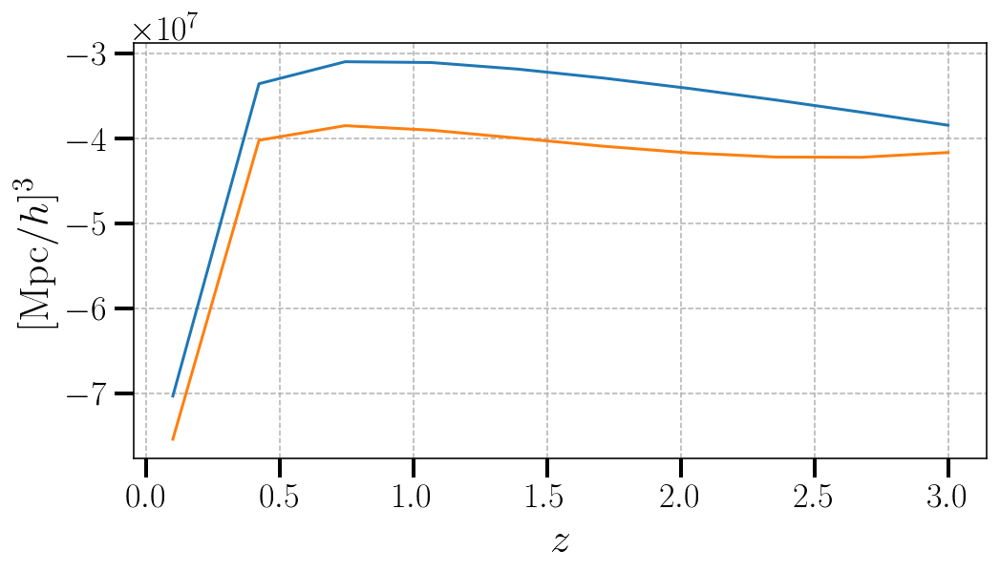

In [1145]:
plt.figure(figsize=(8,4))

#plt.xlim(0,1)
z_plot = np.linspace(0.1,3,10)
plt.grid(ls='--',lw=0.75)
theta_test = 1.3
k1_test=0.06
k2_test=0.05

plt.plot(z_plot,bk_wide_angle(k1_test,k2_test,theta_test,z_plot,0,0)/comoving_dist(z_plot))
plt.plot(z_plot,bk_dipo(k1_test,k2_test,theta_test,z_plot,0,0,1).real/comoving_dist(z_plot))
#plt.plot(z_plot,bk_df[0]/comoving_dist(z_plot))

#plt.xscale('log')
plt.xlabel('$z$')
plt.ylabel('$  \,\,[\mathrm{Mpc}/h]^3$')

In [ ]:
print(5)

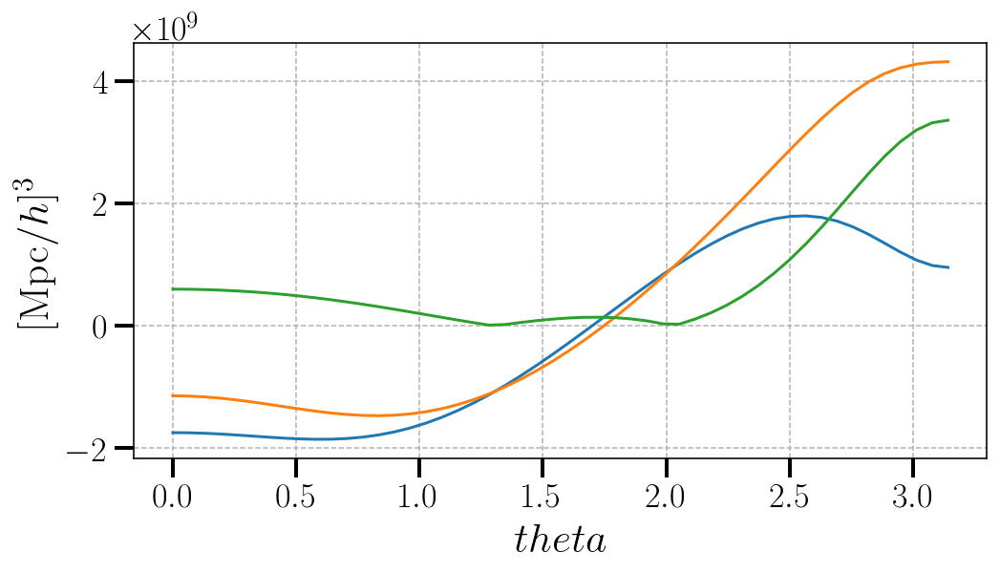

In [1362]:
plt.figure(figsize=(8,4))

z_plot = 8#np.linspace(0.1,3,10)
theta_test = np.linspace(1e-6,np.pi)
k1_test=0.02
k2_test=0.011
r=1
s=0
plt.plot(theta_test,(bk_wide_angle(k1_test,k2_test,theta_test,z_plot,r,s)/comoving_dist(z_plot)))
plt.plot(theta_test,(bk_dipo(k1_test,k2_test,theta_test,z_plot,r,s,1).real/comoving_dist(z_plot)))

just_deriv = np.abs(bk_dipo(k1_test,k2_test,theta_test,z_plot,r,s,1e+8).real/comoving_dist(z_plot)/1e+8)

plt.plot(theta_test,just_deriv)

#plt.yscale('log')
plt.xlabel('$theta$')
plt.ylabel('$  \,\,[\mathrm{Mpc}/h]^3$')
plt.grid(ls='--',lw=0.75)
plt.show()

#plt.plot(theta_test,just_deriv/np.abs(bk_wide_angle(k1_test,k2_test,theta_test,z_plot,r,s)/comoving_dist(z_plot)),'--')

In [ ]:
#test deriv terms 

plt.figure(figsize=(8,4))

z_plot = 1#np.linspace(0.1,3,10)
theta_test = np.linspace(1e-6,np.pi)
k1_test=0.02
k2_test=0.011
r=1
s=0
plt.plot(theta_test,(bk_wide_angle(k1_test,k2_test,theta_test,z_plot,r,s)/comoving_dist(z_plot))/bk_mono_func(k1_test,k2_test,theta_test))
plt.plot(theta_test,(bk_dipo(k1_test,k2_test,theta_test,z_plot,r,s,1).real/comoving_dist(z_plot))/bk_mono_func(k1_test,k2_test,theta_test))

just_deriv = np.abs(bk_dipo(k1_test,k2_test,theta_test,z_plot,r,s,1e+5).real/comoving_dist(z_plot)/1e+5)

#plt.plot(z_plot,bk_df[0]/comoving_dist(z_plot))

#plt.yscale('log')
plt.xlabel('$theta$')
plt.ylabel('$  \,\,[\mathrm{Mpc}/h]^3$')
plt.show()
plt.grid(ls='--',lw=0.75)
plt.plot(theta_test,just_deriv/np.abs(bk_wide_angle(k1_test,k2_test,theta_test,z_plot,r,s)/comoving_dist(z_plot)),'--')

In [955]:
#for sciccimarro comparison...
k1=0.1
k2=k1/2
theta = np.linspace(0,np.pi,200)

In [781]:
b1= 1.5#1.46#
gamma2 = -(2/7)*(b1-1) #0.524 -0.547*b1 +0.046*b1**2#-(2/7)*(b1-1) #-(2/7)*(b1-1) #0.524 -0.547*b1 +0.046*b1**2#-(2/7)*(b1-1) #
b2= 0.412 - 2.143*b1 +0.929*b1**2 + 0.008*b1**3 + 4/3 * gamma2
print(gamma2)

-0.14285714285714285


In [782]:
#So we need average (1/d) over redshift bin...
rout = comoving_dist(0.35)#1.2#
rmin = comoving_dist(0.15)#0.8#

d_plot = (3/2)*(rout**2-rmin**2)/(rout**3-rmin**3)
print(1/d_plot)

748.4145650550545


In [957]:
bkmono = bk_mono_func(k1,k2,theta)
bkquad = bk_quad_func(k1,k2,theta)

#Bk_wideangle = bk_wide_angle(k1,k2,theta,1/2,0)/d
Bk_wideangle1 = bk_wide_angle(k1,k2,theta,0,0)/(1/d_plot)
Bk_wideangle2 = bk_wide_angle(k1,k2,theta,1,0)/(1/d_plot)
Bk_wideangle3 = bk_wide_angle(k1,k2,theta,0,1)/(1/d_plot)
Bk_wideangle_mid = bk_wide_angle(k1,k2,theta,1/3,1/3)/(1/d_plot)
Bk_wideangle_mid1 = bk_wide_angle1(k1,k2,theta,1/3,1/3)/(1/d_plot)

#Bk_wideangled = bk_wide_angle_old(k1,k2,k3,1/2,1/2)/500

In [784]:
#z1x1 = Bk_wideangle1/bkmono
#z1x2 = Bk_wideangle2/bkmono
#z1x3 = Bk_wideangle3/bkmono
#z1xmid = Bk_wideangle_mid/bkmono

z2x1 = Bk_wideangle1/bkmono
z2x2 = Bk_wideangle2/bkmono
z2x3 = Bk_wideangle3/bkmono
z2xmid = Bk_wideangle_mid/bkmono


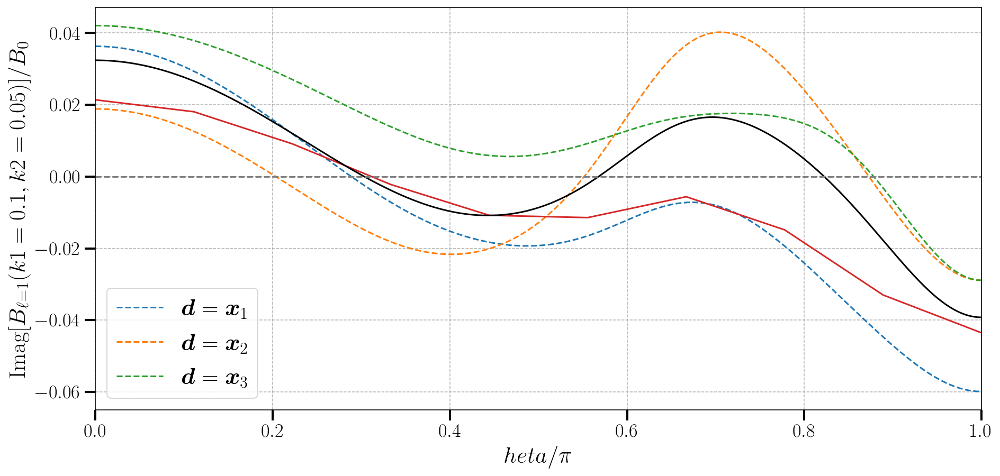

In [981]:
plt.figure(figsize=(15,7))
#plt.ylim(-0.7,0.2)
plt.xlim(0,1)
plt.grid(ls='--',lw=0.75)
#plt.plot(theta/np.pi,Bk_wideangle3/bkmono)
#plt.plot(theta/np.pi,Bk_wideangle2/bkmono)
#plt.plot(theta/np.pi,Bk_wideangle1/bkmono)
#plt.axvline(x = 1/3, linestyle='-.', color = 'black')
#plt.plot(theta/np.pi,Bk_wideangle/bkmono,'-.')
plt.plot(theta/np.pi,Bk_wideangle1/bkmono,'--',label=r'$\boldsymbol{d}=\boldsymbol{x}_1$')
plt.plot(theta/np.pi,Bk_wideangle2/bkmono,'--',label=r'$\boldsymbol{d}=\boldsymbol{x}_2$')
plt.plot(theta/np.pi,Bk_wideangle3/bkmono,'--',label=r'$\boldsymbol{d}=\boldsymbol{x}_3$')

plt.plot(np.linspace(0,np.pi,10)/np.pi,bk_wa_dfog(1,k1,k2,np.linspace(0,np.pi,10),5,0,0)[0]/(1/d_plot)/bk_mono_func(k1,k2,np.linspace(0,np.pi,10)))
plt.plot(theta/np.pi,Bk_wideangle_mid/bkmono,'k')
#plt.plot(1-theta/np.pi,-Bk_wideangle_mid1/bkmono,'--')
plt.plot(theta/np.pi,np.zeros_like(theta),color='grey',linestyle='--')
#plt.plot(theta,fl.imag/flmono.real,'--')
plt.legend()
plt.xlabel('$\theta/ \pi\,$')
plt.ylabel(r'$ \text{Imag}[B_{\ell=1}(k1=0.1,k2=0.05)]/B_0 $')
plt.savefig('wrong_wide_angle_theory.png')

<Figure size 792x360 with 0 Axes>

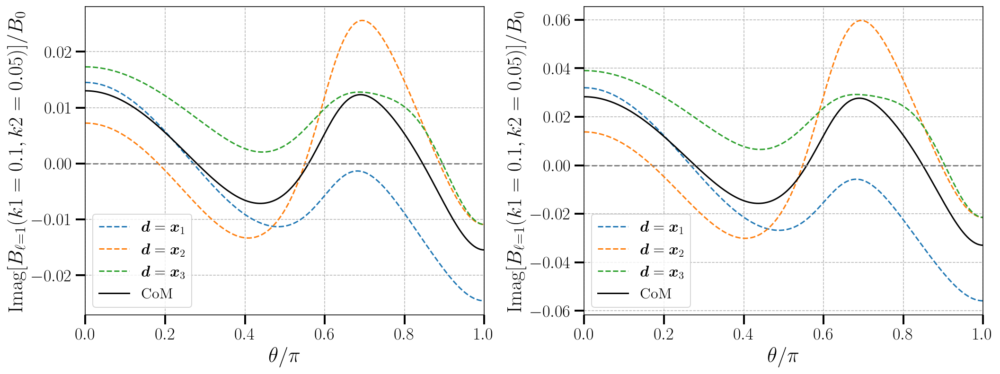

In [796]:
fig = plt.figure(figsize=(11, 5))

# Define gridspec with 4 rows and 3 columns
#gs = GridSpec(1, 2,width_ratios=[3, 3])

# Create subplots with custom aspect ratios
#axs = [fig.add_subplot(gs[0, i], aspect='10') for i in range(2)]  # Subplots in the first row

fig, axs = plt.subplots(1, 2,figsize=(17,6))
fig.subplots_adjust(wspace=0.25)
# Create the colormap plot
#im0 = axs[0].imshow(np.abs(bk0.T),aspect=1.5, extent=[0, 1, 0.5, 1], interpolation='bilinear', origin='lower', cmap='viridis',norm=mpl.colors.LogNorm(1e-2, vmax=vmax))#,vmin=0,vmax=vmax)#
#im1 = axs[1].imshow(np.abs(bk1.T),aspect=1.5, extent=[0, 1, 0.5, 1], interpolation='bilinear', origin='lower', cmap='viridis',norm=mpl.colors.LogNorm(1e-2, vmax=vmax))#,vmin=0,vmax=vmax)#
#im2 = axs[2].imshow(np.abs(bk2.T),aspect=1.5, extent=[0, 1, 0.5, 1], interpolation='bilinear', origin='lower', cmap='viridis',norm=mpl.colors.LogNorm(1e-2, vmax=vmax))#,vmin=0,vmax=vmax)#

axs[0].plot(theta/np.pi,z1x1,'--',label=r'$\boldsymbol{d}=\boldsymbol{x}_1$')
axs[0].plot(theta/np.pi,z1x2,'--',label=r'$\boldsymbol{d}=\boldsymbol{x}_2$')
axs[0].plot(theta/np.pi,z1x3,'--',label=r'$\boldsymbol{d}=\boldsymbol{x}_3$')
axs[0].plot(theta/np.pi,z1xmid,'k',label=r'$\text{CoM}$')
axs[0].plot(theta/np.pi,np.zeros_like(theta),color='grey',linestyle='--')
axs[0].legend(fontsize =16)
axs[0].set_xlim(0,1)
#axs[0].set_ylim(-0.07,0.07)
axs[0].set_xlabel(r'$\theta/ \pi\,$')
axs[0].set_ylabel(r'$ \text{Imag}[B_{\ell=1}(k1=0.1,k2=0.05)]/B_0 $')
axs[0].grid(ls='--',lw=0.75)


axs[1].plot(theta/np.pi,z2x1,'--',label=r'$\boldsymbol{d}=\boldsymbol{x}_1$')
axs[1].plot(theta/np.pi,z2x2,'--',label=r'$\boldsymbol{d}=\boldsymbol{x}_2$')
axs[1].plot(theta/np.pi,z2x3,'--',label=r'$\boldsymbol{d}=\boldsymbol{x}_3$')
axs[1].plot(theta/np.pi,z2xmid,'k',label=r'$\text{CoM}$')
axs[1].plot(theta/np.pi,np.zeros_like(theta),color='grey',linestyle='--')
axs[1].legend(fontsize =16)
axs[1].set_xlim(0,1)
#axs[1].set_ylim(-0.07,0.07)

axs[1].set_xlabel(r'$\theta/ \pi\,$')
axs[1].set_ylabel(r'$ \text{Imag}[B_{\ell=1}(k1=0.1,k2=0.05)]/B_0 $')
axs[1].grid(ls='--',lw=0.75)

plt.savefig('Milad_plot.png', bbox_inches='tight', dpi=400)
#axs[1].yaxis.set_major_locator(plt.NullLocator())


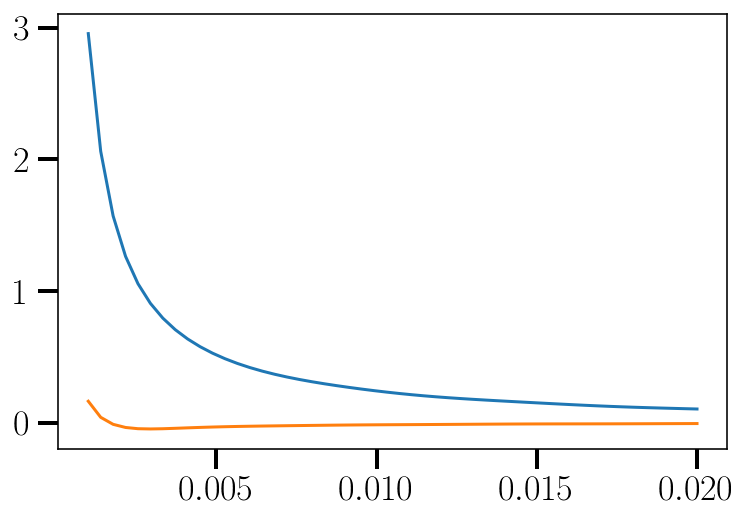

In [1428]:
#lets get squeezed

#k1=k2=10*k3
k1 = np.linspace(0.01,0.2)
k2=k1
k3=k1/10
theta = np.arccos((k3**2 -k1**2 - k2**2)/(2*k1*k2))

zz=0.5
d_z = comoving_dist(zz)
plt.plot(k3,bk_dipo(k1,k2,theta,zz,0,0,1).real/d_z/bk_mono_func(k1,k2,theta))
plt.plot(k3,bk_dipo(k1,k2,theta,zz,0,0,0).real/d_z/bk_mono_func(k1,k2,theta))

In [1469]:
#so data storage format
#bk_mono = {}
#bk1 = {}
#bk2 = {}
#bk3 = {}
#so data storage format
#bk1_deriv = {}
#bk2_deriv = {}
#bk3_deriv = {}

#bk1_full = {}
#bk2_full = {}
#bk3_full = {}
#where these functions of z

bkmid_full={}

In [1472]:
#%%time
k1 = 0.05

# Define the function
#@jit
def triangle_plot(x, y,zz,r=0,s=0,c=0):
    """Get array of"""
    bk = np.zeros((len(x),len(y)))
    d_z = comoving_dist(zz)
    #so only do select values of bispectrum...
    for i in tqdm(range(len(x))):
        #array version:
        k2 = y*k1
        k3 = x[i]*k1
        theta = np.arccos((k3**2 -k1**2 - k2**2)/(2*k1*k2))  
        bk[i] = np.where(np.logical_and((y > 1 - x[i]), (y>x[i])),k1*k2*k3*bk_dipo(k1,k2,theta,zz,r,s,c).real/d_z,np.nan)
        #bk[i] = np.where(np.logical_and((y > 1 - x[i]), (y>x[i])),bk_wide_angle(k1,k2,theta,zz,r,s).real/d_z,np.nan)
        #bk[i] = np.where(np.logical_and((y > 1 - x[i]), (y>x[i])),bk_mono_func(k1,k2,theta),np.nan)  
    return bk


xx = np.linspace(0.01, 1, 500)
yy = np.linspace(0.5, 1, 500)
z=0.1

print('comving_distance =', comoving_dist(z))
keyz= str(z)
#bk_mono[keyz] = triangle_plot(xx,yy,z,0,0,c=0)
#bk1[keyz] = triangle_plot(xx,yy,z,0,0,c=0)
#bk2[keyz] = triangle_plot(xx,yy,z,1,0,c=0)
#bk3[keyz] = triangle_plot(xx,yy,z,0,1,c=0)
#bk1_full[keyz] = triangle_plot(xx,yy,z,0,0,c=1)
#bk2_full[keyz] = triangle_plot(xx,yy,z,1,0,c=1)
#bk3_full[keyz] = triangle_plot(xx,yy,z,0,1,c=1)
#bk1_deriv[keyz] = triangle_plot(xx,yy,z,0,0,1e+10)/1e+10
#bk2_deriv[keyz] = triangle_plot(xx,yy,z,1,0,1e+10)/1e+10
#bk3_deriv[keyz] = triangle_plot(xx,yy,z,0,1,1e+10)/1e+10
bkmid_full[keyz] = triangle_plot(xx,yy,z,1/3,1/3,c=1)

comving_distance = 299.9944002144611


  0%|          | 0/500 [00:00<?, ?it/s]

<ipython-input-1472-37f89fa3d481>:15: RuntimeWarning: invalid value encountered in arccos
  theta = np.arccos((k3**2 -k1**2 - k2**2)/(2*k1*k2))
<ipython-input-1184-7f061092b3ce>:35: RuntimeWarning: invalid value encountered in divide
  bk_23 = (-38808*Pk2*Pk3*b1**3*c*fd*k1**4*k2**2*k3**2*s - 25872*Pk2*Pk3*b1**3*c*fd*k1**2*k2**4*k3**2*s + 32340*Pk2*Pk3*b1**3*c*fd*k1**2*k2**2*k3**4*r + 64680*Pk2*Pk3*b1**3*c*fd*k1**2*k2**2*k3**4*s + 6468*Pk2*Pk3*b1**3*c*fd*k1**2*k3**6*r - 51744*Pk2*Pk3*b1**3*f*k1**4*k2**2*k3**2*s - 12936*Pk2*Pk3*b1**3*f*k1**2*k2**4*k3**2*s + 64680*Pk2*Pk3*b1**3*f*k1**2*k2**2*k3**4*r + 129360*Pk2*Pk3*b1**3*f*k1**2*k2**2*k3**4*s + 51744*Pk2*Pk3*b1**3*f*k1**2*k3**6*r - 116424*Pk2*Pk3*b1**2*bd1*c*f*k1**4*k2**2*k3**2*r - 77616*Pk2*Pk3*b1**2*bd1*c*f*k1**4*k2**2*k3**2*s + 77616*Pk2*Pk3*b1**2*bd1*c*f*k1**4*k2**2*k3**2 - 77616*Pk2*Pk3*b1**2*bd1*c*f*k1**2*k2**4*k3**2*r - 51744*Pk2*Pk3*b1**2*bd1*c*f*k1**2*k2**4*k3**2*s + 51744*Pk2*Pk3*b1**2*bd1*c*f*k1**2*k2**4*k3**2 + 161700*Pk2*Pk3

In [1455]:
bk1_deriv.keys()

dict_keys(['0.25', '0.1'])

In [1463]:
def plot_triangle(bk,vmax,vmin=1): #plot triangle with mask!
    plt.figure(figsize=(8,3.5))
    # Create the colormap plot
    im = plt.imshow(np.abs(bk.T), extent=[0, 1, 0.5, 1], interpolation='bilinear', origin='lower', cmap='Spectral',norm=mpl.colors.LogNorm(vmin, vmax=vmax))#,vmin=0,vmax=vmax)#
    #im = plt.imshow((bk.T), extent=[0, 1, 0.5, 1], interpolation='bilinear', origin='lower', cmap='RdBu',vmin=-vmax,vmax=vmax)#
    
    cbar = plt.colorbar(im)#format='%.0e'
    cbar.set_label(r"$B_{\ell=1}(k_1=0.05,k_2,k_3)$")#P_{HI}(k1=0.05, \mu_1)P_{HI}(k2, \mu_2)P_{HI}(k3, \mu_3)B_{\text{Gravitational}(k1=0.05)}

    # Add labels and title
    plt.xlabel('$k_3/k_1$')
    plt.ylabel('$k_2/k_1$')

    #so masking 
    # Create a mask for the triangular region
    size = int(1e+3)
    x = np.linspace(0.0, 1, size,dtype=np.float32)
    y = np.linspace(0.5, 1,  size,dtype=np.float32)
    xx,yy = np.meshgrid(x,y)
    mask = np.where(np.logical_and((yy > 1 - xx), (yy>xx)),np.nan,1)
    im = plt.imshow(mask, extent=[0, 1, 0.5, 1], interpolation='bilinear', origin='lower', cmap='binary')
    
    plt.grid(ls='--',lw=0.75,color='k',alpha=0.1)
    
    x_bound = [0,0.4965,1]
    y_bound = [1,0.50,1]#
    plt.text(0.06,0.55,'$r=s=1/3$')
    plt.plot(x_bound,y_bound,'k',linewidth=3)
    # Show the plot
    plt.savefig('B_var60.png', bbox_inches='tight', dpi=400)
    plt.show()

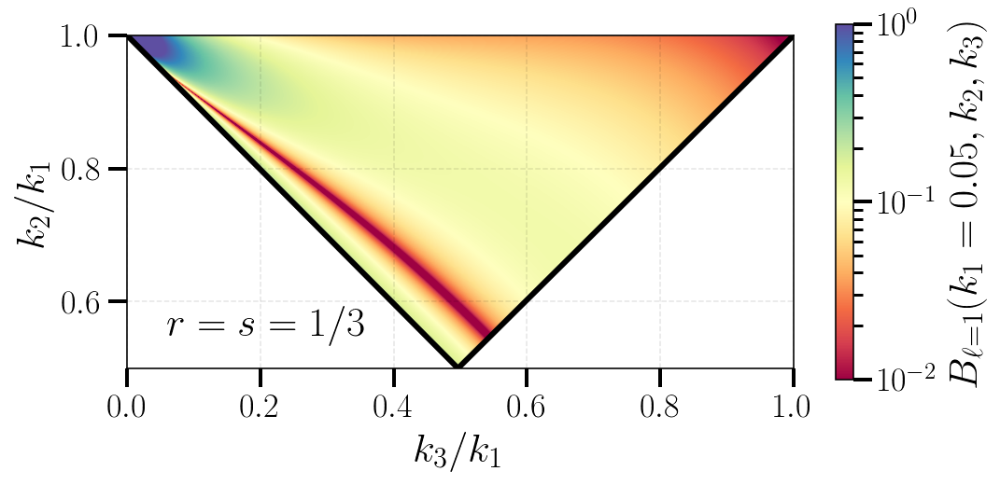

In [1473]:

#plt.plot([0.2,0.54],[0.85,0.56])
#plot_triangle(bk0_25/bk_mono,1)#d = x1
#plot_triangle(bk0_25deriv/bk0_25,1)
plot_triangle(bkmid_full['0.1']/bk_mono['0.1'],1,1e-2)#d = x1
#plot_triangle(bk2,0.3)#d = x2
#plot_triangle(bk3,0.3)#d = x3


In [528]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib as mpl
from matplotlib.gridspec import GridSpec

In [1475]:
def plot_triangle_multi(bk0,bk1,bk2,vmax): #plot triangle with mask!   
        
    fig = plt.figure(figsize=(12, 5))

    # Define gridspec with 4 rows and 3 columns
    gs = GridSpec(1, 3, width_ratios=[3, 3, 3])

    # Create subplots with custom aspect ratios
    axs = [fig.add_subplot(gs[0, i], aspect='10') for i in range(3)]  # Subplots in the first row

    #fig, axs = plt.subplots(1, 3,figsize=(14,5),sharey=True)
    fig.subplots_adjust(wspace=0)
    # Create the colormap plot
    im0 = axs[0].imshow(np.abs((bk0).T),aspect=1.5, extent=[0, 1, 0.5, 1], interpolation='bilinear', origin='lower', cmap='Spectral',norm=mpl.colors.LogNorm(1e-2, vmax=vmax))#,vmin=0,vmax=vmax)#
    im1 = axs[1].imshow(np.abs((bk1).T),aspect=1.5, extent=[0, 1, 0.5, 1], interpolation='bilinear', origin='lower', cmap='Spectral',norm=mpl.colors.LogNorm(1e-2, vmax=vmax))#,vmin=0,vmax=vmax)#
    im2 = axs[2].imshow(np.abs((bk2).T),aspect=1.5, extent=[0, 1, 0.5, 1], interpolation='bilinear', origin='lower', cmap='Spectral',norm=mpl.colors.LogNorm(1e-2, vmax=vmax))#,vmin=0,vmax=vmax)#

    #im0 = axs[0].imshow(((bk0).T),aspect=1.5, extent=[0, 1, 0.5, 1], interpolation='bilinear', origin='lower', cmap='RdBu',vmin=-vmax,vmax=vmax)#,vmin=0,vmax=vmax)#
    #im1 = axs[1].imshow(((bk1).T),aspect=1.5, extent=[0, 1, 0.5, 1], interpolation='bilinear', origin='lower', cmap='RdBu',vmin=-vmax,vmax=vmax)#,vmin=0,vmax=vmax)#
    #im2 = axs[2].imshow(((bk2).T),aspect=1.5, extent=[0, 1, 0.5, 1], interpolation='bilinear', origin='lower', cmap='RdBu',vmin=-vmax,vmax=vmax)#,vmin=0,vmax=vmax)#

    #divider = make_axes_locatable(axs[2])
    #colorbar_ax = divider.append_axes("right", size="5%", pad=0.05)
    #cbar = plt.colorbar(im2, cax=colorbar_ax)
    #
    
    fig.subplots_adjust(right=0.8)
    cbar_ax = fig.add_axes([0.81, 0.3, 0.01, 0.4])
    cbar = fig.colorbar(im2, cax=cbar_ax,ticks=[0.01, 0.1, 1])
    #cbar.set_label(r"$ |B^{\rm wa}_{\ell=1}(k_1=0.05)|/B^{\rm pp}_{\ell=0}$")#"$ |B_{\ell=1}(k_1=0.05)|/B_0 $"
    cbar.set_label(r"$ |B^{\rm red}_{\ell=1}(k_1=0.05)|/B^{\rm wa}_{\ell=0}$")#"$ |B_{\ell=1}(k_1=0.05)|/B_0 $"
    x_bound = [0,0.4965,1]
    y_bound = [1,0.50,1]#
    #so masking 
    # Create a mask for the triangular region
    for i in range(3):
        #axs[i].set_aspect(10)  # Adjust aspect ratio manually
        if i ==0:
            #axs[i].set_yticks(np.arange(0, 0.5, 0.1))
            axs[i].set_ylabel('$k_2/k_1$')
        #size = int(1e+3)
        #x = np.linspace(0.0, 1, size,dtype=np.float32)
        #y = np.linspace(0.5, 1,  size,dtype=np.float32)
        #xx,yy = np.meshgrid(x,y)
        #mask = np.where(np.logical_and((yy > 1 - xx), (yy>xx)),np.nan,1)
        #axs[i].imshow(mask, aspect=1.5, interpolation='bilinear', origin='lower', cmap='binary')
        axs[i].plot(x_bound,y_bound,'k',linewidth=3)
        axs[i].text(0.08,0.55,r'$\boldsymbol{d}=\boldsymbol{x}_%d$'%(i+1),fontsize=20)
        axs[i].set_xlabel('$k_3/k_1$')
        axs[i].set_xticks(np.arange(0.1, 0.91, 0.2))
        #axs[i].set_box_aspect(aspect=0.8)
        #axs[i].set_xlim(0,1)
        #axs[i].set_ylim(0.5,1)
        #axs[i].grid(ls='--',lw=0.75,color='k',alpha=0.1)
        
        if i!=0:
            axs[i].yaxis.set_major_locator(plt.NullLocator())
    
    # Show the plot
    plt.savefig('endpoint_traingles.png', bbox_inches='tight', dpi=400)
    plt.show()

In [1318]:
def add_dict(dict1,dict2,key):
    new_dict = {}
    new_dict[key] = dict1[key]+dict2[key]
    return new_dict
def minus_dict(dict1,dict2,key):
    new_dict = {}
    new_dict[key] = dict1[key]+dict2[key]
    return new_dict

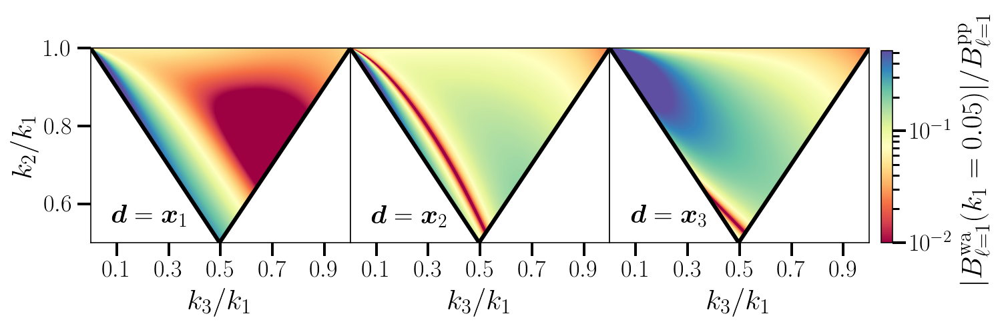

In [1448]:
plot_triangle_multi(bk1['0.1']/bk_mono['0.1'],bk2['0.1']/bk_mono['0.1'],bk3['0.1']/bk_mono['0.1'],0.52)

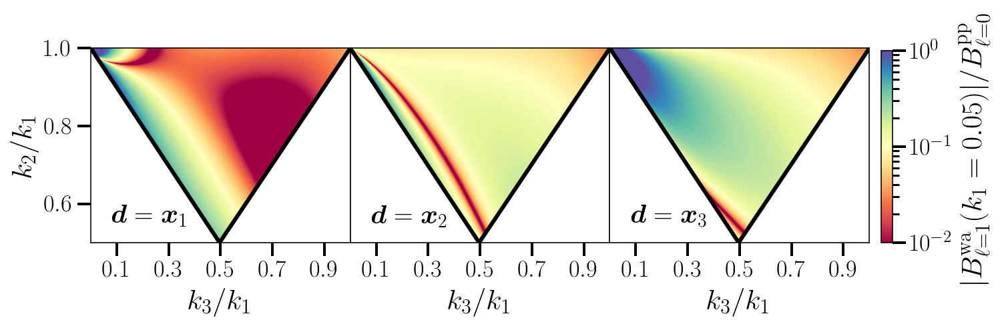

In [1457]:
plot_triangle_multi(bk1_full['0.1']/bk_mono['0.1'],bk2_full['0.1']/bk_mono['0.1'],bk3_full['0.1']/bk_mono['0.1'],1)

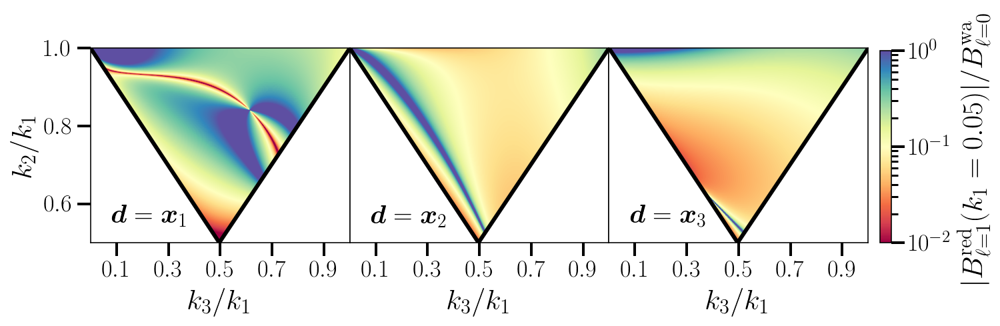

In [1476]:
plot_triangle_multi(bk1_deriv['0.1']/bk1['0.1'],bk2_deriv['0.1']/bk2['0.1'],bk3_deriv['0.1']/bk3['0.1'],1)

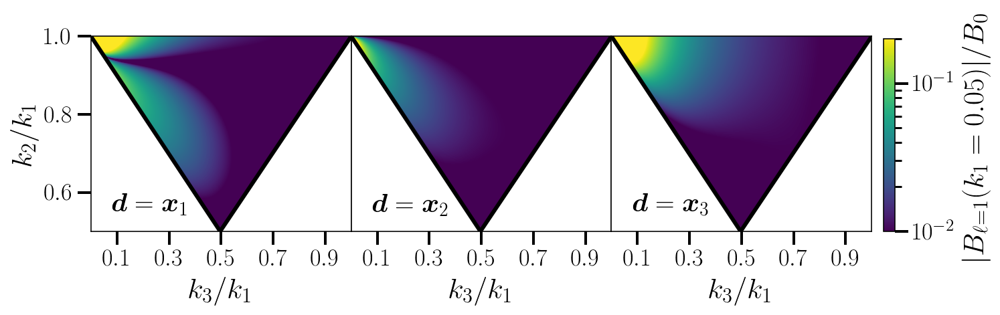

In [1332]:
plot_triangle_multi(bk1_deriv['0.1']/bk_mono['0.1'],bk2_deriv['0.1']/bk_mono['0.1'],bk3_deriv['0.1']/bk_mono['0.1'],0.2)

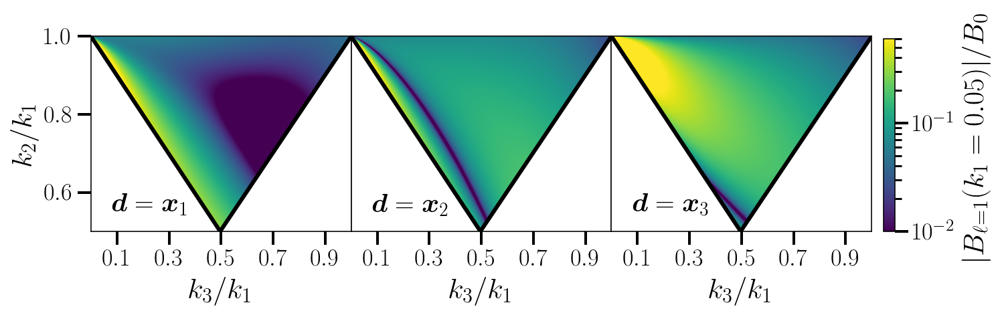

In [1304]:
plot_triangle_multi(bk1,bk2,bk3,0.6)

Figure(1080x288)


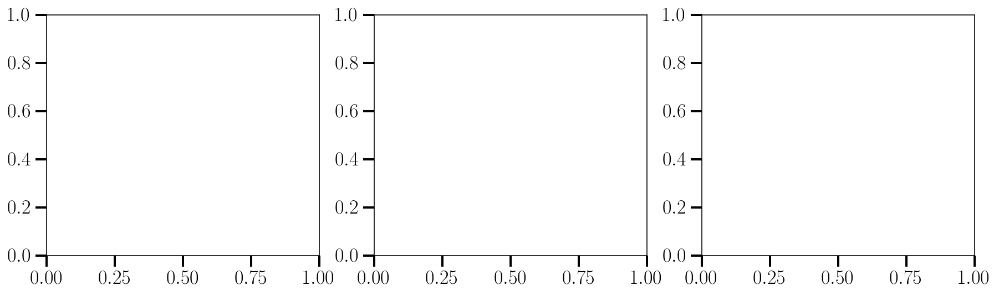

In [363]:
fig, axs = plt.subplots(1, 3,figsize=(15,4))
print(fig)

Text(0, 0.5, '$ |B_{\\ell=1}(k1=0.04,k2=0.02)|/B_0 \\,\\,[\\mathrm{Mpc}/h]^3$')

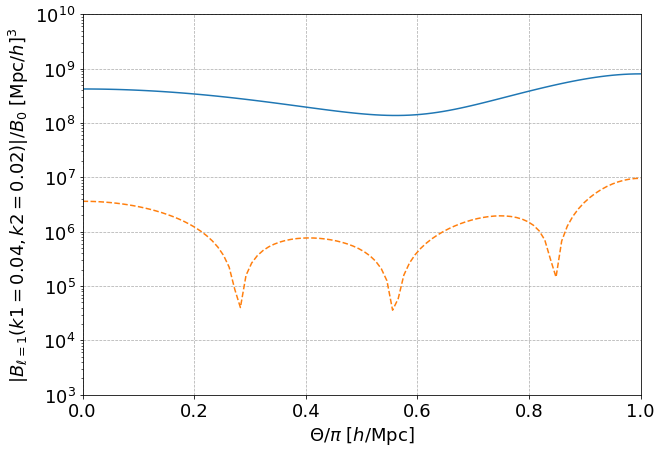

In [1091]:
plt.figure(figsize=(10,7))
plt.ylim(1e3,1e10)
plt.xlim(0,1)
plt.grid(ls='--',lw=0.75)
#plt.plot(theta/np.pi,Bk_wideangle3/bkmono)
#plt.plot(theta/np.pi,Bk_wideangle2/bkmono)
#plt.plot(theta/np.pi,Bk_wideangle1/bkmono)
#plt.axvline(x = 1/3, linestyle='-.', color = 'black')
plt.plot(theta/np.pi,bkmono)
plt.plot(theta/np.pi,np.abs(Bk_wideangle_mid),'--')
#plt.plot(theta/np.pi,np.abs(Bk_wideangle_mid1),'--')
plt.plot(1-theta/np.pi,np.zeros_like(theta),'k')
#plt.plot(theta,fl.imag/flmono.real,'--')
plt.yscale('log')
plt.xlabel('$\Theta/ \pi\,\,[h/\mathrm{Mpc}]$')
plt.ylabel('$ |B_{\ell=1}(k1=0.04,k2=0.02)|/B_0 \,\,[\mathrm{Mpc}/h]^3$')

In [700]:
Bk_wideangle1 = bk_wide_angle(k1,k2,theta,1,0)/d
Bk_wideangle2 = bk_wide_angle(k1,k2,theta,0,1)/d
Bk_wideangle3 = bk_wide_angle(k1,k2,theta,0,0)/d

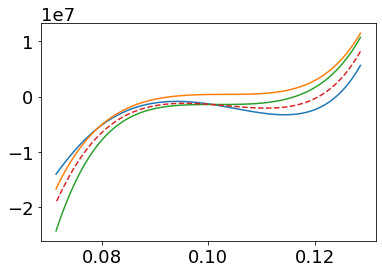

In [643]:
plt.plot(k3,Bk_wideangle1)
plt.plot(k3,Bk_wideangle2)
plt.plot(k3,Bk_wideangle3)
plt.plot(k3,Bk_wideangle,'--')

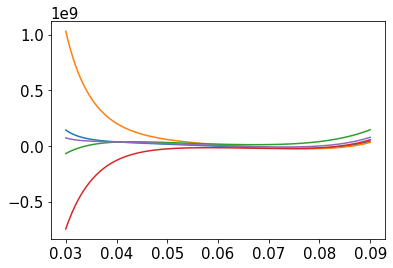

In [927]:
plt.plot(k3,Bk_wideangle)
plt.plot(k3,Bk_wideangle1)
plt.plot(k3,Bk_wideangle2)
plt.plot(k3,Bk_wideangle3)
plt.plot(k3,(Bk_wideangle1+Bk_wideangle2+Bk_wideangle3)/3)
#plt.xlim(0.01,0.18)
#plt.ylim(-1e+7,2e+8)

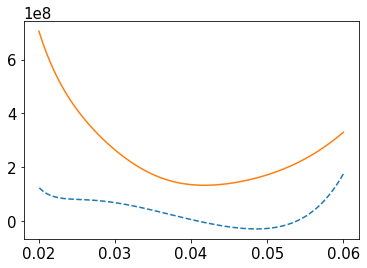

In [940]:
plt.plot(k3,Bk_wideangle_mid,'--')
plt.plot(k3,bkmono)

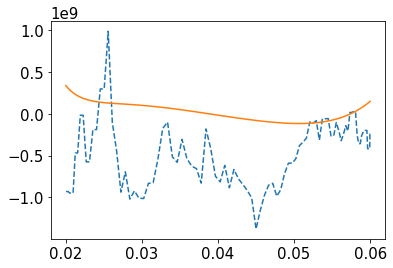

In [840]:
#plt.plot(k3,bkmono,'--')
plt.plot(k3,-fl.imag,'--')
plt.plot(k3,Bk_wideangle)
#plt.xlim(0.04,0.18)
#plt.ylim(-1e+6,2e+8)

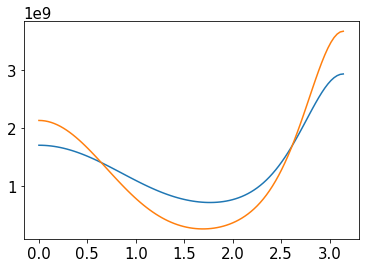

In [843]:
plt.plot(theta,bkmono)
#plt.plot(theta,np.real(flmono),'--')
plt.plot(theta,bkquad)
#plt.xlim(0.06,0.18)
#plt.ylim(1e-3,2e+8)
#plt.plot(bkmono_ol)
#plt.plot(bkquad_ol)

In [296]:
Pl0_pp = b1**2 *Plin + (2*b1*f*Plin)/3 + (f**2 *Plin)/5
Pl0_pp1 = b1**2 *Pk_lin(k_est) + (2*b1*f*Pk_lin(k_est))/3 + (f**2 *Pk_lin(k_est))/5

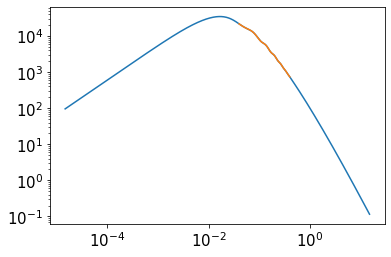

In [297]:
plt.loglog(k,Pl0_pp)
plt.loglog(k_est,Pl0_pp1)

/opt/jupyterhub/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/opt/jupyterhub/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


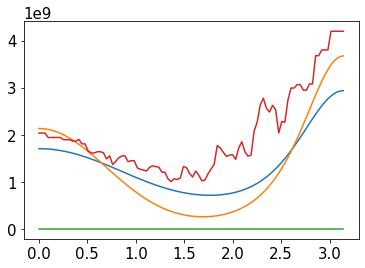

In [668]:
plt.plot(theta,(bkmono))
plt.plot(theta,(bkquad))
plt.plot(theta,(fl))
plt.plot(theta,(flmono))

In [29]:
import numpy as np
import sys
from time import time
sys.path.append('/home/addis/unamed_code')
sys.path.append('/home/addis/unamed_code/Library')
import Bk_theta_iFFT as Bk_
import Bk_theta_sum as Bk_sum
#import Bk_theta_sum2 as Bk_sum2
#import Bk_theta1 as Bk_theta

import get_field as gf
from matplotlib import pyplot as plt
import compute_grid_info as cgi

In [91]:
#field things!
path = '../data/Quijote/' #path to folder containing quijote files.
N_side = 128
rsd_direction = '' # 'z'

redshift = '/snapdir_004/snap_004'
if redshift[-1] == str(4):
    red_info = 'z=0'
elif redshift[-1] == str(2):
    red_info = 'z=1'
else:
    red_info = 'z=NA'
    
    
Nside=128
L=1000

In [432]:
%%time
rfft=False
order=2
obs_pos=(500,500,500)
grid_info = cgi.compute_survey(Nside,L,rfft,order,obs_pos)  # so call 
xi,ki,k_mag,MAS,k_f,k_ny = grid_info

CPU times: user 133 ms, sys: 99.7 ms, total: 232 ms
Wall time: 231 ms


In [433]:
import Pk_old as Pk
k_est = np.linspace(0.006,0.4,100)
s=1 #units of 2*k_f
binning_info = cgi.pk_compute_bins(k_est,s,grid_info[2],grid_info[4])
#In_bin,N_modes
iFFT=False
dtype=np.complex64
threads=4
verbose=True
t=1
l=1
#j_old = Pk_old.Pk(field_tmp,L,Nside,l,k,grid_info,binning_info,t,iFFT,dtype,threads,rfft,verbose)
j = Pk.Pk(field,L,Nside,l,k_est,grid_info,binning_info,t,iFFT,dtype,threads,rfft,verbose)

In [591]:
%%time
dtype=np.complex64
s=1 #units of 2*k_f
threads=4
rs=[0,0]
binning_info = cgi.bk_theta_compute_bins(k1,k2,theta,Nside,s,grid_info[2],grid_info[4],dtype,threads,rfft)
#In_bin,Ntri,in_k1,in_k2

CPU times: user 16 s, sys: 2.54 s, total: 18.6 s
Wall time: 5.52 s


In [601]:
rs = [1,0]
verbose =True
l = 1

In [598]:
%%time
j = Bk_.Bk(field,l,L,Nside,theta,grid_info,binning_info,rs,dtype,threads,rfft,verbose)

nyquist frequency= 0.40212385965949354 fundamental frequency= 0.006283185307179587
Number of FFTs used= 1 Number of iFFTs used= 102


NameError: name 'Bk_midpoint_theta' is not defined

In [1056]:
import this

The Zen of Python, by Tim Peters

Beautiful is better than ugly.
Explicit is better than implicit.
Simple is better than complex.
Complex is better than complicated.
Flat is better than nested.
Sparse is better than dense.
Readability counts.
Special cases aren't special enough to break the rules.
Although practicality beats purity.
Errors should never pass silently.
Unless explicitly silenced.
In the face of ambiguity, refuse the temptation to guess.
There should be one-- and preferably only one --obvious way to do it.
Although that way may not be obvious at first unless you're Dutch.
Now is better than never.
Although never is often better than *right* now.
If the implementation is hard to explain, it's a bad idea.
If the implementation is easy to explain, it may be a good idea.
Namespaces are one honking great idea -- let's do more of those!
